In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  2
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0
GPU 1: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [5]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, layers, lb, ub, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
        self.test_error_mse = [] #创建一个空列表，用于存储测试误差
        self.test_error_mae = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #返回计算得到的f


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
        f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u_real_pred = self.net_u_error(self.x_star, self.t_star)

        error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        
        self.test_error.append(error_test)
        
        # 计算 MAE
        mae = torch.mean(torch.abs(self.u_star - u_real_pred))
        # 计算 MSE
        mse = torch.mean((self.u_star - u_real_pred) ** 2)
        # 记录 MAE 和 MSE
        self.test_error_mae.append(mae)
        self.test_error_mse.append(mse)

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
            f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            self.dnn.eval() #将神经网络切换为评估模式
            with torch.no_grad():
                u_real_pred = self.net_u_error(self.x_star, self.t_star)

            error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            
            self.test_error.append(error_test)

            # 计算 MAE和MSE
            mae = torch.mean(torch.abs(self.u_star - u_real_pred))
            mse = torch.mean((self.u_star - u_real_pred) ** 2)
            # 记录 MAE 和 MSE
            self.test_error_mae.append(mae)
            self.test_error_mse.append(mse)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, _ = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()

        return u, f 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter):
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    # 利用x0和t0计算x{t}和t{t}，存储在xs中
    xs = [] #初始化xs
    x,t = model.hidden_predict(x0,t0) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    
    # 迭代预测
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        xs.append([x,t]) #将x的数据添加到xs中
    #最后得到的xs是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应原始采样点的迭代结果


    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    x,t = model.hidden_predict(x1,t1) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）

    # 迭代预测（扰动后）
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)
        xs1.append([x,t]) #将x的数据添加到xs1中
    #最后得到的xs1是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应加了扰动后的采样点的迭代结果

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    #这两个数组的形状均为(2,N_f_new,1)，第一个代表x和t，第二个代表N_f_new个样本点得到的结果，第三个代表1个数

    # 计算这两个点的欧氏距离
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=0)
    #得到的是一个形状为（N_f_new,1）的数组，每个元素代表了两个点之间的欧氏距离，这里点在xt平面上

    distances = distances.flatten()

    #对distances进行归一化
    # distances = distances / np.linalg.norm(distances)
    # 对distances进行归一化前，检查分母是否接近零
    # norm = np.linalg.norm(distances)
    # if norm < 1e-10:  # 1e-10是一个非常小的数，用于检测norm是否接近于零
    #     distances = np.zeros_like(distances)  # 如果分母接近0，将distances设置为全零数组，因为范数为0时，distances中的值想对于彼此几乎没有差异，意味着所有点都几乎处于同一混沌度水平
    # else:
    #     distances = distances / norm

    # 现在可以安全地根据distances对点进行排序，即使在所有值都相同的情况下

    return distances

In [7]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [8]:
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321]
# seeds = [0]

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
# layers = [2, 200, 200, 200, 200, 2, 1]
layers = [2,30,30,30,30,30,30,30,30,2,1]

#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.linspace(0, x.shape[0]-1, N0, dtype='int') #生成一个从0到x.shape[0]-1的等差数列，长度为x.shape[0]，数据类型为整型
# idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.linspace(0, t.shape[0]-1, N_b, dtype='int') #生成一个从0到t.shape[0]-1的等差数列，长度为t.shape[0]，数据类型为整型
# idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差
error_mae = [] #创建一个空列表，用于存储MAE值
error_mse = [] #创建一个空列表，用于存储MSE值

i = 0 #初始化i为0

nIter = 50000 #设置迭代次数为10000
nIterLBFGS = 10000 #设置LBFGS迭代次数为500

for seed in seeds:
    set_seed(seed) #设置随机种子

    num_iter = 1000 #迭代次数（用于混沌度）
    #1.先训练一定次数（总次数/100）

    N_f_1 = N_f // 100 #将N_f除以100，得到的整数赋值给N_f_1
    #采样初步训练点
    X_f = lb + (ub-lb)*lhs(2, N_f_1) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, layers, lb, ub, X_star, u_star)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter//100, 0)

    #2.训练结束后，每总次数的1/100次训练，重新采样N_f//10个点，从中选出N_f//100个点加入训练
    for iter in range(nIter//100+1, nIter+1, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter) #计算混沌度

        _, residual = model.predict(X_f_new)

        # 计算残差的绝对值
        abs_residual = np.abs(residual)
        #将二维数组转换为一维数组
        abs_residual = abs_residual.flatten()


        # 对distances进行归一化
        epsilon = 1e-5
        norm_distances = np.linalg.norm(distances)
        if norm_distances > epsilon:
            distances = distances / norm_distances
        else:
            distances = np.zeros_like(distances)

        #对abs_residual进行归一化
        abs_residual = abs_residual / np.linalg.norm(abs_residual)

        #计算信息量
        xinxi = 0.9*distances + 0.1*abs_residual

        # 找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(xinxi, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据
        X_f_topk = X_f_new[topk_indices]

        # 将这些数据添加到原来的训练数据中
        X_f = np.vstack((X_f, X_f_topk)) #与之前的训练数据合并

        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100, 0)


    model.train(0, nIterLBFGS) #训练模型500次

    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, f_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中
    # 计算 MAE 和 MSE
    mae = np.mean(np.abs(u_star - u_pred))
    mse = np.mean((u_star - u_pred) ** 2)
    # 记录 MAE 和 MSE
    error_mae.append(mae)
    error_mse.append(mse)

    i+=1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')
    print('Error u : %e' % (np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))) #打印误差  
    print('MAE: %e' % mae) #打印MAE
    print('MSE: %e' % mse) #打印MSE


# #使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
# U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

# #同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
# F_pred = griddata(X_star, f_pred.flatten(), (X, T), method='cubic')


 

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:01,  8.10it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 72.46it/s]

Adam:   5%|▌         | 27/500 [00:00<00:04, 96.44it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 108.74it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 118.17it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 119.54it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 122.64it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 127.22it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 139.84it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 144.93it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 151.02it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 153.16it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 155.65it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 156.52it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 159.45it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 160.71it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 157.75it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 159.72it/s]

Adam:  56%|█████▌    | 278/500 [00:01<00:01, 160.50it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 162.32it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 163.65it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 164.54it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:00, 164.51it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:00, 162.73it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 163.40it/s]

Adam:  79%|███████▉  | 397/500 [00:02<00:00, 163.80it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 163.93it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 163.27it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 151.02it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 144.72it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 140.33it/s]

Adam:  99%|█████████▉| 494/500 [00:03<00:00, 137.68it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 145.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.74it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 119.60it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 117.09it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 115.96it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 122.67it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 133.46it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:02, 137.40it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 144.85it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 150.87it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 150.65it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 153.69it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 157.24it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 159.37it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 160.11it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 161.94it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 161.27it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 162.58it/s]

Adam:  57%|█████▋    | 284/500 [00:01<00:01, 161.84it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 163.12it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 161.35it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 159.99it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 160.78it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 161.26it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 162.48it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 160.71it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 148.33it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 138.97it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 135.04it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 134.26it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 131.69it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 128.20it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 145.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.17it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 125.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 124.08it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 137.40it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 146.72it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 150.99it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 155.12it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 159.09it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 161.66it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 162.98it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 162.29it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 163.03it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 163.34it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 163.62it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 163.04it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 162.79it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 162.59it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 162.80it/s]

Adam:  62%|██████▏   | 309/500 [00:01<00:01, 162.85it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 161.72it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:00, 161.47it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 162.63it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 163.14it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 163.20it/s]

Adam:  82%|████████▏ | 411/500 [00:02<00:00, 148.84it/s]

Adam:  85%|████████▌ | 427/500 [00:02<00:00, 141.22it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 135.89it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 132.87it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 129.03it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 130.04it/s]

Adam: 100%|█████████▉| 498/500 [00:03<00:00, 128.07it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 149.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 123.40it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 127.00it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 141.74it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 144.17it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:02, 150.29it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 151.10it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 151.90it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 155.12it/s]

Adam:  28%|██▊       | 140/500 [00:00<00:02, 157.24it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 158.75it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 160.24it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:01, 161.60it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:01, 162.69it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:01, 160.60it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 161.93it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 161.80it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 162.44it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 162.26it/s]

Adam:  62%|██████▏   | 310/500 [00:01<00:01, 160.78it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 159.83it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:00, 159.80it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 157.26it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:00, 152.76it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 144.34it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 137.27it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 133.07it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 130.47it/s]

Adam:  90%|████████▉ | 448/500 [00:02<00:00, 129.11it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 127.40it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 122.58it/s]

Adam:  97%|█████████▋| 487/500 [00:03<00:00, 122.74it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 122.81it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 145.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.03it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.73it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 115.79it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 134.56it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 139.25it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 146.79it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 152.37it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 155.49it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 158.67it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 160.62it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 161.67it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 161.78it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 162.14it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 161.31it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 162.48it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 162.86it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 161.07it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 156.24it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 159.24it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 160.44it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:00, 161.56it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 162.41it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 160.97it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 162.35it/s]

Adam:  82%|████████▏ | 411/500 [00:02<00:00, 146.68it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 139.93it/s]

Adam:  88%|████████▊ | 441/500 [00:02<00:00, 134.32it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 130.66it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 127.94it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 126.71it/s]

Adam:  99%|█████████▉| 495/500 [00:03<00:00, 126.31it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 147.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.51it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 114.20it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 118.57it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 133.92it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 141.29it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 148.91it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 153.18it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 156.27it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 158.28it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 158.12it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:01, 159.54it/s]

Adam:  41%|████      | 203/500 [00:01<00:01, 160.34it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 158.32it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 156.12it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 156.14it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 137.34it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 121.39it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 125.03it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 116.43it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 115.93it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 118.18it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 120.33it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:01, 119.48it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:01, 119.82it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 119.85it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 119.48it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 119.74it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 119.77it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 119.90it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 119.94it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 120.02it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 119.67it/s]

Adam:  98%|█████████▊| 492/500 [00:03<00:00, 120.99it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 131.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 161.90it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 162.25it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 164.42it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 163.77it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 162.78it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 161.18it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 159.85it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 162.38it/s]

Adam:  31%|███       | 153/500 [00:00<00:02, 162.63it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 160.79it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:01, 161.03it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 161.80it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 161.78it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 163.23it/s]

Adam:  51%|█████     | 255/500 [00:01<00:01, 163.98it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 164.70it/s]

Adam:  58%|█████▊    | 289/500 [00:01<00:01, 165.24it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 165.44it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 143.39it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 135.49it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 134.24it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 128.75it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:01, 109.39it/s]

Adam:  78%|███████▊  | 392/500 [00:02<00:01, 100.91it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 98.78it/s] 

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 100.89it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 100.13it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 97.41it/s] 

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 104.92it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 103.50it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 97.86it/s] 

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 100.94it/s]

Adam:  99%|█████████▉| 494/500 [00:03<00:00, 101.01it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 132.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.59it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.47it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.56it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 111.44it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 113.31it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 111.55it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 110.34it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 112.03it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 112.28it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 112.84it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 111.62it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 107.00it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 114.23it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 125.20it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 130.09it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 136.52it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 141.10it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 144.31it/s]

Adam:  50%|█████     | 252/500 [00:02<00:01, 146.42it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 148.18it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 149.28it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 150.00it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 149.78it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 149.35it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 149.10it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 149.13it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 149.94it/s]

Adam:  79%|███████▊  | 393/500 [00:02<00:00, 150.92it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 130.57it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 125.56it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 119.63it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 116.14it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 112.75it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 111.38it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 110.20it/s]

Adam:  99%|█████████▉| 497/500 [00:03<00:00, 104.30it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 125.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 153.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 152.06it/s]

Adam:  10%|▉         | 49/500 [00:00<00:02, 159.04it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:02, 160.72it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:02, 161.64it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 163.06it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 162.45it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 162.27it/s]

Adam:  30%|███       | 151/500 [00:00<00:02, 162.13it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 163.33it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:01, 164.19it/s]

Adam:  40%|████      | 202/500 [00:01<00:01, 161.17it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:01, 162.33it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 163.27it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 162.54it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 146.66it/s]

Adam:  57%|█████▋    | 285/500 [00:01<00:01, 136.19it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 129.60it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 124.58it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 121.50it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 116.46it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 115.92it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 115.50it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:01, 113.45it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 113.65it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 113.80it/s]

Adam:  82%|████████▏ | 411/500 [00:02<00:00, 113.55it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 115.97it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 112.37it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 112.56it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 114.24it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 112.30it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 111.32it/s]

Adam:  99%|█████████▉| 496/500 [00:03<00:00, 112.13it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 133.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 162.08it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 164.87it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 165.64it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 165.74it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 165.69it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 162.35it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 163.66it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 164.22it/s]

Adam:  31%|███       | 153/500 [00:00<00:02, 164.76it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 164.59it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:01, 163.76it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 163.86it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 164.48it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 151.36it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 139.08it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 132.76it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 126.78it/s]

Adam:  59%|█████▉    | 296/500 [00:01<00:01, 117.82it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 116.46it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 113.81it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 113.73it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 113.52it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 113.26it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:01, 113.10it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:01, 112.18it/s]

Adam:  78%|███████▊  | 392/500 [00:02<00:00, 112.07it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 112.34it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.59it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 112.71it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 112.77it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 112.81it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 112.91it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 112.96it/s]

Adam:  98%|█████████▊| 488/500 [00:03<00:00, 113.08it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 114.21it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 131.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.93it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 166.58it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 167.17it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 164.70it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 163.87it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 163.69it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 163.33it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 164.95it/s]

Adam:  31%|███       | 153/500 [00:00<00:02, 164.56it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 163.63it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:01, 164.12it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 164.16it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 161.71it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 142.20it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 132.05it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 125.91it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 118.56it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 116.46it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 115.33it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 112.42it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 112.07it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 111.90it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 113.07it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 106.95it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:01, 106.11it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:01, 104.55it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 106.65it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 108.15it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 109.20it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 109.84it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 112.62it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 107.12it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 108.37it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 111.58it/s]

Adam:  99%|█████████▉| 496/500 [00:03<00:00, 111.34it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 128.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 148.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:02, 156.55it/s]

Adam:  10%|▉         | 49/500 [00:00<00:02, 160.56it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:02, 162.62it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:02, 164.36it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 162.50it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 157.91it/s]

Adam:  27%|██▋       | 133/500 [00:00<00:02, 155.77it/s]

Adam:  30%|███       | 150/500 [00:00<00:02, 157.93it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 157.28it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 158.37it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 155.00it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 138.32it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 124.62it/s]

Adam:  49%|████▊     | 243/500 [00:01<00:02, 118.90it/s]

Adam:  51%|█████     | 256/500 [00:01<00:02, 107.62it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:02, 100.47it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 101.75it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 103.79it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 103.86it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 105.31it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 104.61it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 102.14it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 103.77it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 105.32it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:01, 106.63it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 96.53it/s] 

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 90.88it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 82.68it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:01, 81.21it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:01, 80.50it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 79.93it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 78.53it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 78.66it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 78.42it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 78.30it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 78.34it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 78.15it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 78.21it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 78.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 79.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 152.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 148.14it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 150.50it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:02, 151.13it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:02, 152.32it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:02, 148.52it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 149.24it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 149.25it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 150.21it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 150.92it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 141.63it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 122.31it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 115.96it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 111.74it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 108.70it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 101.82it/s]

Adam:  50%|█████     | 250/500 [00:01<00:02, 102.13it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.81it/s] 

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 98.68it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 94.21it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 95.50it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 97.66it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 98.68it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 99.46it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 100.01it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 98.91it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 99.68it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.15it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.47it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 102.49it/s]

Adam:  80%|████████  | 402/500 [00:03<00:01, 94.31it/s] 

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 88.55it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 84.96it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 79.03it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 78.10it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 75.89it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 74.45it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 73.22it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 73.53it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 75.54it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 75.71it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 76.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 147.39it/s]

Adam:   6%|▌         | 31/500 [00:00<00:03, 150.60it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 150.46it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:02, 148.43it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:02, 143.06it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 141.90it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 144.18it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 145.18it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 128.77it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 119.74it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 111.05it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 108.64it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 107.59it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 101.96it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:03, 96.26it/s] 

Adam:  44%|████▍     | 221/500 [00:01<00:02, 96.47it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 92.17it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 95.20it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 97.69it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 103.58it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 103.65it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 101.36it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.94it/s] 

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 99.33it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 101.45it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 99.32it/s] 

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 99.07it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 100.09it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 96.48it/s] 

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 96.75it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 90.60it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 91.44it/s]

Adam:  81%|████████  | 404/500 [00:03<00:01, 94.90it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 97.39it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 94.65it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 96.26it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 95.05it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 87.42it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 83.68it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 82.71it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 80.61it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 79.91it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 143.38it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 140.28it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 143.54it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 145.90it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:02, 147.04it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 142.54it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 135.51it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 120.05it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 111.34it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 108.62it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 102.31it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 102.54it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.44it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 100.22it/s]

Adam:  40%|████      | 201/500 [00:01<00:03, 99.66it/s] 

Adam:  42%|████▏     | 211/500 [00:01<00:02, 99.03it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 98.83it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.81it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 98.64it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.66it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 90.65it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 93.46it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 94.86it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 99.01it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 94.60it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 95.45it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 97.56it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.07it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 98.26it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 98.30it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 93.28it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 94.04it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 95.33it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 96.31it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 97.07it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 97.36it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.90it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 97.97it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 98.15it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 98.24it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 98.44it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 97.44it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 98.02it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 98.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.88it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.95it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.39it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 105.16it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.83it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 106.20it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.58it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 106.91it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 106.89it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 112.25it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 107.48it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.60it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 101.11it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 101.23it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 100.91it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 99.92it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:03, 99.22it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 95.27it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 96.01it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 99.65it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 99.12it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 99.52it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.88it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 98.43it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 96.15it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 96.49it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 96.81it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 97.21it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 97.48it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 97.27it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 97.55it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 97.48it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.42it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 97.63it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 95.66it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 94.95it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 95.80it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 98.75it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 100.54it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.20it/s] 

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 97.23it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 97.99it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 97.04it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 97.71it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 97.38it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 97.47it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 97.51it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.68it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.14it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.40it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.26it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.79it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.65it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 104.19it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 104.40it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 104.70it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 105.01it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 105.18it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 105.13it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 93.37it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.08it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 82.79it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 79.62it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 78.88it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.13it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 75.92it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 75.05it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 72.63it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 76.53it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 82.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 86.06it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 88.98it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 91.01it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 93.77it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 94.36it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 94.29it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 94.81it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 95.28it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 95.53it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 93.47it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 94.12it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 93.03it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 93.34it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 93.17it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 92.37it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 95.81it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.04it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 94.31it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 96.07it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 96.06it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 96.17it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 96.15it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 96.17it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 96.13it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 96.30it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.31it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 102.64it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 99.71it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:04, 102.15it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 103.32it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 104.04it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.95it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 105.08it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 105.13it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.25it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 105.29it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 103.21it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 104.79it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 99.49it/s] 

Adam:  36%|███▌      | 179/500 [00:01<00:03, 91.49it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 85.97it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.76it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.61it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 76.82it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 75.37it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 74.28it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 73.78it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 73.18it/s]

Adam:  51%|█████     | 255/500 [00:02<00:03, 72.71it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:03, 73.45it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 73.09it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 74.11it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 69.57it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 71.34it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 74.91it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 78.70it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 82.91it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 86.21it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 88.25it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 91.19it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 89.75it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 91.30it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 92.39it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 93.06it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.53it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 93.75it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 93.97it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 94.25it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 93.89it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 94.26it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 94.41it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 91.97it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 92.36it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 94.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.37it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.77it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.46it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.39it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.01it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 100.53it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.42it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 96.00it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 98.36it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.86it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 101.39it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 105.24it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 104.90it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 104.68it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 102.71it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.40it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.14it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.02it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 104.22it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 98.13it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:03, 90.58it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 85.89it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.53it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 82.12it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 79.35it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 78.08it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 75.93it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 74.17it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 74.67it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 74.84it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 75.13it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 75.44it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 76.31it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:02, 74.29it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:02, 74.73it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 75.90it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 78.64it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 85.93it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 90.66it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 92.79it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 95.79it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 97.88it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 99.25it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 100.26it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 100.61it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 101.24it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 101.60it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 98.65it/s] 

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 97.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.83it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 97.50it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.96it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 101.13it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 104.09it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 103.83it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 103.54it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 104.49it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 103.91it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 105.11it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.05it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 102.97it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.87it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 102.80it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 102.74it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.60it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 106.12it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 104.46it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 100.01it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 100.66it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.82it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:02, 100.96it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.29it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 103.00it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 103.01it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.95it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 102.13it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 101.21it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.91it/s] 

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 89.15it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 86.44it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 83.64it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 81.00it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 80.00it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 78.43it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 77.83it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 77.34it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 76.52it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 74.37it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 74.65it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 73.96it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 79.90it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 87.18it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 94.04it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 95.43it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 94.29it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 95.25it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 95.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.14it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.36it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.46it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 96.54it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 94.93it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 98.15it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.90it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.14it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 101.34it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 97.92it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 97.33it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 98.52it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 99.14it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 99.13it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 98.96it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 99.21it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 99.92it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 100.52it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 100.85it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 100.51it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 105.39it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 103.99it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 104.12it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 103.27it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 102.79it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 102.04it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 99.18it/s] 

Adam:  61%|██████    | 304/500 [00:03<00:02, 97.90it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 95.46it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 99.43it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 99.47it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 100.00it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 100.51it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 100.86it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.40it/s] 

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 98.28it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 99.33it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 98.84it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 99.87it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 102.65it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 100.58it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 95.58it/s] 

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 97.16it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 96.49it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 97.87it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 98.73it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.07it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 101.45it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.52it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 99.31it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.16it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 98.53it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 99.19it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 99.70it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 101.02it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 100.96it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 100.91it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 100.66it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 100.62it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 100.59it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.11it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.61it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.89it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 100.66it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.18it/s] 

Adam:  46%|████▌     | 229/500 [00:02<00:02, 98.78it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 98.23it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 99.42it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 99.58it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 96.81it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 97.46it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 98.45it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 99.05it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 99.00it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 99.27it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 99.13it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 96.37it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 100.29it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 102.14it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 103.60it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 102.26it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 98.77it/s] 

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 99.05it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 97.79it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 98.33it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 101.02it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 99.48it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 98.98it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 99.38it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 111.87it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 74.31it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.19it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 74.82it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 72.11it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 73.04it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 72.89it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 72.79it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 74.37it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 79.68it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.61it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.18it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.35it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 92.36it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.58it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 94.43it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 95.42it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 95.62it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 95.03it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 95.52it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 97.70it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 101.05it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 100.02it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.82it/s] 

Adam:  49%|████▉     | 244/500 [00:02<00:02, 98.11it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 94.90it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.10it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 93.71it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.10it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 93.16it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 94.63it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.35it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 97.98it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 98.22it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 97.88it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 98.29it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 98.54it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 98.67it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 98.76it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 100.55it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 101.27it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 100.68it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 100.22it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 99.84it/s] 

Adam:  90%|█████████ | 451/500 [00:04<00:00, 99.70it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 99.69it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 102.50it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 114.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.63it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.69it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 76.29it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 77.61it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 78.51it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 78.95it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 78.20it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 76.78it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 76.68it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 76.81it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.88it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 73.22it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 74.95it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.60it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 77.52it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 77.36it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 74.30it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 75.88it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 77.09it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 76.98it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 77.12it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 77.03it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 73.17it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 78.69it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 86.87it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 92.80it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 97.12it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:02, 101.96it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 105.01it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 105.63it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 99.61it/s] 

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 102.24it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 102.55it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 107.17it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 107.25it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 107.30it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 107.31it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 105.42it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 106.11it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 106.44it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 106.85it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 102.12it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 103.97it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 105.13it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 105.77it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 106.13it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 106.53it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 106.56it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 120.06it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 122.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.50it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.04it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.61it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 74.72it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 75.30it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 76.61it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 72.31it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 73.52it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 74.34it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 71.94it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 71.32it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.63it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 74.41it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 75.90it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 76.09it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 74.11it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 71.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 73.26it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 61.42it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.11it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 67.25it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 70.05it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 72.58it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 73.27it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 76.22it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 76.25it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 76.18it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 74.23it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 75.83it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 76.64it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 77.31it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 86.08it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 89.84it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 94.75it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 98.22it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 100.52it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:01, 104.91it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:01, 105.24it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 105.35it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 105.57it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 105.07it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 102.02it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 102.97it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 103.40it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 104.15it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 104.92it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 105.41it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 99.97it/s] 

Adam:  90%|█████████ | 451/500 [00:05<00:00, 113.94it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 123.96it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 130.71it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 135.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.97it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.32it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 66.96it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.98it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 71.82it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.94it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 73.86it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 74.48it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 74.56it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.88it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 76.10it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 77.01it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 75.24it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 75.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 77.35it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 76.99it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 75.41it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 73.64it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 75.12it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 74.23it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 69.22it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.99it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.58it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 70.22it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 72.59it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 73.47it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 74.87it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 75.23it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 75.38it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 76.38it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 76.11it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 76.96it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 84.23it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 91.19it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.31it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 95.23it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:01, 97.95it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 100.11it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 100.19it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 103.36it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 103.95it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 104.42it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 104.80it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 106.12it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 107.01it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 118.16it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 122.32it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 122.90it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 127.25it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 133.75it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 138.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.23it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.47it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.39it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.07it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 73.00it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 73.83it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 74.63it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 75.13it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 75.22it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 76.56it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 76.47it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 77.37it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 77.28it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.94it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 76.75it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 76.60it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 76.49it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 77.24it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 76.89it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 75.25it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 72.10it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 70.52it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 73.63it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 74.27it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.69it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 75.72it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 75.74it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 75.77it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 75.85it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 75.98it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 78.01it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 83.92it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 91.20it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 95.78it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 100.51it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 102.85it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 102.95it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:01, 104.20it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 106.03it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 102.63it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 111.13it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:00, 121.39it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 121.91it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 127.11it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 133.42it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 135.30it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 132.97it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 137.53it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 140.60it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 139.04it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.78it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.26it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.31it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.78it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 75.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 77.72it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 78.21it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 78.33it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 77.35it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 76.90it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 78.13it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 77.78it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 77.53it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 77.00it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 76.36it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 76.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 77.39it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 76.91it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 76.45it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 74.10it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 76.41it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 77.03it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.62it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 74.09it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 77.75it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 85.29it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 90.67it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:02, 97.34it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 93.17it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 96.29it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 102.61it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:01, 112.87it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 123.25it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 125.03it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 130.38it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 135.39it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 139.20it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:00, 141.88it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 143.54it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 143.92it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 144.24it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 144.44it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 144.85it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 144.80it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 144.72it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 144.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.61it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.31it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.28it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 76.14it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 75.84it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 76.56it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 76.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 76.60it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 76.87it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 76.37it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 77.57it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 77.84it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 76.85it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.39it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 74.72it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 80.49it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.28it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:03, 91.96it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 94.97it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 98.48it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 101.37it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 108.44it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 121.12it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 130.00it/s]

Adam:  51%|█████     | 255/500 [00:02<00:01, 136.05it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:01, 139.92it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 141.40it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 140.12it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 137.14it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 139.97it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 133.74it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 135.82it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:00, 135.13it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 139.13it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 141.14it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 143.00it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 145.02it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 146.73it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 147.60it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 147.16it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 145.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.92it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.49it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.81it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 91.86it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 97.12it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 93.25it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 96.31it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 102.46it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 114.97it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 125.09it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 132.87it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 138.48it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 141.98it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 143.77it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 145.36it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 146.15it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 147.52it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 147.96it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 147.88it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 148.62it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 149.06it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 149.07it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 148.04it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 147.64it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 148.65it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 149.39it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:00, 142.79it/s]

Adam:  78%|███████▊  | 389/500 [00:02<00:00, 143.45it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 143.37it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 144.09it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 131.79it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 116.89it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 125.86it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 132.15it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 127.82it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 130.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 149.98it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 137.92it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 139.38it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 137.18it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 136.66it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 141.52it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 135.16it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 131.48it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 137.26it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 141.38it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 142.46it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 142.66it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 140.69it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 143.98it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:01, 145.42it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 146.69it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 146.47it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 148.05it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 147.99it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 147.42it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 147.52it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 147.37it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 148.75it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:00, 149.74it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 145.39it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 132.24it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 124.53it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 119.62it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 109.75it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 97.80it/s] 

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 91.30it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 87.47it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 83.94it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 79.51it/s]

Adam:  99%|█████████▉| 494/500 [00:03<00:00, 76.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.97it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.77it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 101.57it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 103.09it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 105.01it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 105.79it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 106.41it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 106.80it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 107.77it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 107.22it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 108.89it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 108.62it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 108.35it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 106.34it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 106.88it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 106.97it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 107.17it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 109.95it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 119.84it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 126.98it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:01, 131.71it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:01, 134.92it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 137.28it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 138.98it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 140.22it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 140.75it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 140.49it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 141.02it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:00, 141.62it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 141.99it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 142.40it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 133.44it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 119.29it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 113.08it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 96.80it/s] 

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 88.60it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 81.82it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 79.06it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 75.10it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 73.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.23it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.14it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.04it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.75it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 104.04it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.49it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 103.73it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 104.64it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 105.22it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 106.29it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 105.71it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 107.50it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 104.59it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.19it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 103.67it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.17it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.91it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.85it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 109.73it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 119.89it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 126.73it/s]

Adam:  51%|█████     | 256/500 [00:02<00:01, 131.38it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 134.97it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 137.52it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 139.05it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 132.68it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 135.36it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 137.77it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 139.48it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:00, 139.87it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 131.97it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 125.62it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 115.71it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 111.70it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 103.11it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 91.74it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 86.58it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 81.98it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 79.56it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 73.31it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 73.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.12it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.20it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.91it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 96.04it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 98.79it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.12it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.58it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.40it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 106.00it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 104.93it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.97it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.17it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 101.59it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 102.84it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 102.25it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.76it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.05it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.88it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.77it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 107.03it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 110.56it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 111.59it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 113.81it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 116.37it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 114.72it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 117.62it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 111.70it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 110.03it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 114.96it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 111.66it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 109.78it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.92it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.29it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 97.14it/s] 

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 88.76it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:01, 82.39it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 78.57it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 75.98it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 76.05it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 76.29it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 75.85it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 72.28it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 70.60it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 71.78it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 72.30it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 71.52it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 70.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.32it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.52it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.72it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.69it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 100.13it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 102.08it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 102.57it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 103.20it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 104.17it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 104.52it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 105.75it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 105.53it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 104.98it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 105.06it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 105.15it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 105.23it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 105.68it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 105.65it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 105.50it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 105.47it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 103.81it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 102.25it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 103.09it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 109.64it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 119.60it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 126.55it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 129.74it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 133.82it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 136.06it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 125.91it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 114.56it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 109.99it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 106.85it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 100.53it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 91.58it/s] 

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 87.34it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 83.80it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 81.04it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 78.99it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 76.87it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 76.23it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 76.65it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 76.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 77.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.21it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.90it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.14it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 95.01it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 89.70it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 89.74it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.13it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 97.32it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 99.41it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 100.67it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 102.18it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 100.87it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 102.82it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 103.09it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 100.95it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 96.35it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.74it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 101.09it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 99.08it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 98.16it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 96.81it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 99.16it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 101.50it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 102.04it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 104.05it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 101.88it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 104.97it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 104.60it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 105.54it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 103.42it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 101.88it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 101.37it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 102.13it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.76it/s] 

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 96.64it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 89.15it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.19it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 80.64it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 78.61it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 75.59it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 73.47it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 72.14it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 74.21it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 75.02it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 76.13it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 73.80it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 73.92it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 74.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.31it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.81it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 96.96it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 99.35it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.82it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.78it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 102.05it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 102.54it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.98it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 103.30it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 103.52it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 103.65it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.56it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 103.20it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 101.80it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 100.76it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 97.46it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.17it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.11it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.60it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.40it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 99.65it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.64it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.09it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.55it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 101.81it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 102.67it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 114.02it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 118.50it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 113.77it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 109.62it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 107.02it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 102.90it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 102.44it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 101.61it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 92.48it/s] 

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 83.54it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 83.15it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 81.93it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 77.73it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 77.40it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 76.50it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 75.82it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 75.49it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 74.64it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 74.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.37it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.41it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 101.47it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.06it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 102.37it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 102.59it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 102.76it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 102.89it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 103.04it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 103.14it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 103.22it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 103.27it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 103.30it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 103.23it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.68it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 103.76it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 103.51it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 103.42it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 103.33it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 103.23it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 103.19it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 103.14it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 102.98it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.72it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 100.36it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 100.87it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 99.83it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 101.14it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 101.09it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 99.83it/s] 

Adam:  70%|███████   | 350/500 [00:03<00:01, 92.39it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.08it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 92.08it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 94.53it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 96.19it/s]

Adam:  80%|████████  | 402/500 [00:03<00:01, 97.24it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 98.11it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 98.81it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 99.18it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 99.32it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 90.83it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 83.04it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 80.41it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 78.49it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 77.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 76.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.32it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.68it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.32it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 102.75it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 102.64it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 101.48it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 99.61it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 100.56it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 100.26it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 99.62it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:03, 100.35it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 101.15it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 101.38it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 101.75it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 101.18it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 101.52it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 98.12it/s] 

Adam:  41%|████      | 206/500 [00:02<00:02, 99.42it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 100.23it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 100.79it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 101.26it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 101.58it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 101.82it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 101.94it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 102.13it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 102.32it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 102.26it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 102.18it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 100.38it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 88.79it/s] 

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 80.77it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 78.95it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 78.20it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 75.29it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 77.11it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 82.68it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 89.33it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 90.19it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.63it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 90.36it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 93.95it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 94.82it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 87.35it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 82.63it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 79.91it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 78.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 75.51it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.90it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.52it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 100.66it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 100.29it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 100.66it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 100.88it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 96.63it/s] 

Adam:  19%|█▉        | 97/500 [00:00<00:04, 98.43it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 99.19it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 99.40it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 100.15it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 98.25it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 100.64it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 104.04it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.95it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 98.95it/s] 

Adam:  39%|███▉      | 196/500 [00:01<00:03, 99.80it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.92it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 94.09it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 94.59it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 89.46it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 88.21it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 92.50it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 93.29it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 97.32it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 98.02it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 98.69it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 98.90it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 98.33it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 96.19it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 87.31it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 79.81it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 78.01it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 76.80it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 75.81it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 75.19it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 78.19it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 83.95it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.03it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 92.75it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 93.90it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 95.61it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 96.76it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 98.94it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 85.43it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 76.55it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 76.41it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 75.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.97it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 96.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 97.92it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.97it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 98.85it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 99.56it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 99.75it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 101.00it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 98.89it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 99.17it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 100.43it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 98.56it/s] 

Adam:  30%|██▉       | 148/500 [00:01<00:03, 96.24it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.41it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 95.66it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 97.18it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 96.31it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 94.18it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 96.02it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 95.58it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 91.61it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.31it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.65it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 95.45it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.91it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 92.68it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 93.09it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 83.66it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 81.22it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 78.11it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 74.73it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:02, 74.26it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 73.97it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 74.43it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 74.56it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 74.38it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 74.02it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 80.55it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 86.78it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 90.40it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 92.92it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 94.92it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 96.29it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 96.84it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 97.72it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 98.23it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 98.15it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 89.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.41it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.17it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 99.93it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 99.47it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 100.48it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 101.74it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 99.11it/s] 

Adam:  19%|█▉        | 94/500 [00:00<00:04, 97.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 97.73it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 96.24it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 89.67it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 87.78it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 90.72it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 93.63it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 94.69it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 93.69it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 95.63it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 96.85it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 97.69it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 98.24it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 98.45it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 99.48it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 97.50it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 95.79it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.97it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 92.60it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 85.71it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.44it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 79.40it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 78.19it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 76.60it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 77.67it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 76.22it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:02, 75.24it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 74.50it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 74.87it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 74.21it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 73.78it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 73.08it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 73.00it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 72.92it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 72.85it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 79.90it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 85.53it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 91.22it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 93.67it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 95.72it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 96.80it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.54it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 98.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.12it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.71it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.67it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.83it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 98.08it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 100.07it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 99.55it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:04, 99.38it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 99.47it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 99.52it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 99.46it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 94.74it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 96.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.14it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.58it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.95it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.16it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 98.33it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 98.40it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 96.92it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 98.04it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.75it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 96.46it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 94.81it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 96.11it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 96.87it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 97.45it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 98.67it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 97.56it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.07it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 80.33it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 77.87it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:02, 72.59it/s]

Adam:  70%|███████   | 350/500 [00:03<00:02, 71.55it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 71.69it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 72.59it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 72.22it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 70.40it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 71.05it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 71.31it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 71.65it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 73.32it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:01, 72.99it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 72.82it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 72.61it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 76.75it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 83.21it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 87.83it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 91.29it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 93.62it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 95.25it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.18it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.35it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 95.79it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 96.55it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 96.71it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 97.37it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 97.88it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 98.12it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.47it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 98.48it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 98.60it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 98.66it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 99.45it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 99.00it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 99.16it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 97.98it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.18it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 98.21it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 98.30it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 98.47it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 98.37it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.33it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.28it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.41it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.32it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.20it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 96.83it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 97.05it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 94.07it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 94.68it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 95.54it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.27it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 84.95it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 80.71it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 78.76it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 75.49it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 73.28it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 71.48it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 71.55it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 71.55it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 71.45it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 72.38it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 72.35it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:01, 72.22it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 72.09it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 70.10it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 70.57it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 70.91it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 77.66it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 83.61it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.04it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 91.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.15it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 75.19it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 73.66it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 73.36it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 73.03it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 72.79it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 72.66it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 77.21it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 83.00it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 87.27it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 90.29it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 91.18it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 93.03it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 92.69it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 94.77it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 94.94it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 94.20it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 94.94it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 95.77it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 96.44it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 96.70it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 94.48it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 95.87it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 97.05it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 99.05it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.48it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 95.05it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 94.90it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 95.65it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 94.42it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 95.22it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 95.95it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 96.34it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.52it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 98.33it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 98.22it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 92.11it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 84.64it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 78.71it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 72.89it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 71.26it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 70.87it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 70.95it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 71.04it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:01, 71.07it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 69.45it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 70.79it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 71.77it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 72.27it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 79.62it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 84.96it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 92.07it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.70it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 69.17it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 70.45it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.97it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.14it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.77it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 72.43it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 72.78it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 70.51it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 71.55it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 69.76it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.56it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.56it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.98it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 81.49it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.14it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 89.00it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:03, 91.43it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 93.04it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 93.49it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 94.47it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 95.27it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 95.93it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.34it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 96.39it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.84it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 95.47it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 95.98it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 94.20it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 95.17it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 95.71it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 96.97it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.85it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 97.89it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.57it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 97.23it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 97.99it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 97.61it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 97.30it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 97.31it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 97.16it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 97.09it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 96.85it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 96.57it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 96.60it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 97.43it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 97.11it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 101.83it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 108.71it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 118.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.42it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.71it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.39it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 67.64it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.22it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 69.64it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.16it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.30it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 67.74it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.11it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 68.43it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 69.38it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 70.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 68.83it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 68.49it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.39it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 70.00it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 71.20it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 72.14it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 75.40it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 81.48it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 85.69it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 88.48it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 90.87it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 85.48it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 88.57it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 89.50it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 91.44it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:02, 91.14it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 92.58it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 87.65it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 91.33it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 92.28it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 94.63it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 95.31it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 93.76it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 94.16it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 94.61it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 93.66it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 96.44it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 92.67it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 92.58it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 93.63it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 93.62it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 90.89it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 87.24it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 86.26it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 97.61it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 109.49it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 118.05it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 124.23it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 128.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.40it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.14it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 65.23it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 67.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 69.83it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.17it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 72.16it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 72.75it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 71.98it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 71.26it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.44it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.58it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 76.75it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 79.20it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 83.66it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 83.22it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 86.87it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 89.29it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 88.05it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 86.61it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 88.84it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 90.52it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 91.54it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 92.39it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 94.32it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 96.79it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.37it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 102.60it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 102.01it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 92.17it/s] 

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 92.47it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 91.59it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 92.18it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 93.21it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 93.49it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 93.99it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 94.18it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 94.37it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 94.55it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 94.68it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 94.61it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 94.78it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 94.47it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 94.36it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 107.45it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 117.73it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 124.62it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 129.06it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 132.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.07it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.91it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.33it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.70it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.81it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.21it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.05it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 68.96it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 70.18it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 69.17it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 70.75it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.03it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 81.02it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 85.06it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.87it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 88.45it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 88.62it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 90.11it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 89.60it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 87.76it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 87.71it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 85.95it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 90.20it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 91.23it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 91.14it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 91.95it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 92.95it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 93.49it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 93.83it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 94.00it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 93.84it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.83it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 96.56it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.59it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 92.91it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 93.44it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 95.81it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 95.05it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 95.88it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 92.35it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 89.40it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 88.67it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 84.42it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 84.27it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.22it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 102.33it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 113.55it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 120.61it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 125.84it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 129.63it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 132.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.60it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 70.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 79.99it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 85.62it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 87.90it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.10it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.40it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 90.02it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.08it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 83.96it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 83.74it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.00it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.35it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 88.89it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 89.95it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 93.87it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 93.67it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 93.55it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.71it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 93.79it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.69it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 90.24it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 91.09it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 91.47it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 91.70it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.86it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 92.31it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 92.39it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 92.76it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 92.72it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 95.19it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 94.75it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 94.45it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 94.28it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 94.25it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 95.12it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 101.07it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:00, 112.95it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 120.51it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 125.42it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 130.04it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 131.37it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 133.54it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 135.79it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 135.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.33it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.18it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.44it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.76it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.40it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 92.03it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.90it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.59it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.36it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.30it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 92.39it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.26it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.74it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.92it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.99it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 92.07it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 92.11it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 92.11it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 92.15it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.57it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 92.40it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.40it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.00it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 92.96it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.85it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 92.61it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 92.46it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 92.58it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.69it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.54it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.62it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 92.62it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 92.52it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 92.64it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 100.01it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 112.28it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 119.53it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 126.14it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 128.98it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 132.43it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 135.20it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 136.58it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 137.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.69it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.93it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 95.07it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.62it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 93.16it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 93.08it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.86it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.87it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.24it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.13it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.90it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.88it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 91.80it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.62it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.70it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.63it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 91.82it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 91.10it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 91.44it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.58it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 89.50it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.98it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 90.20it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 90.54it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 90.81it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 88.63it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 89.85it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 91.50it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 91.63it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 91.54it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 91.76it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 91.96it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 92.26it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 94.24it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 107.29it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 114.90it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 122.65it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 125.51it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 129.49it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 131.79it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 132.81it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 132.40it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 132.69it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 134.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.35it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.96it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.27it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 88.48it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.28it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.42it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.27it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.93it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.08it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.70it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.77it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.30it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.55it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 87.81it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 88.74it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 89.85it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 89.87it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.26it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.78it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 90.82it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 90.51it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 90.52it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 90.73it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 91.66it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 91.35it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 91.00it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 91.19it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 91.52it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 91.55it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 91.47it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 103.20it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 115.06it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 123.14it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:00, 128.70it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 131.23it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 134.95it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 135.90it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 137.06it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 138.66it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 139.37it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 140.45it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 138.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.09it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.12it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 89.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 89.41it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 89.82it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 89.87it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 90.06it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 90.12it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 90.18it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 89.71it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 89.01it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 88.68it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 89.30it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 89.84it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 88.38it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 90.03it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 89.91it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 90.11it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 91.35it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 91.27it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 91.25it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 91.24it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 90.84it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 90.71it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 90.39it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 90.18it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 89.92it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 89.86it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 89.92it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 89.38it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 89.39it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 85.73it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 86.90it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 101.32it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 113.39it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 119.57it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 125.71it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 122.21it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 122.40it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 128.27it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 132.25it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 133.94it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 122.92it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 112.44it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 107.59it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 104.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.78it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.14it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.06it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 98.51it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 99.24it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.19it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.02it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 99.11it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 98.89it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 97.28it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 97.21it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 97.66it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 97.93it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 96.42it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 97.38it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 94.48it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 96.57it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 93.93it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 95.60it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 96.76it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 97.28it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.43it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 95.93it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.04it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 93.88it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 95.38it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.63it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 98.26it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 98.57it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 98.77it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 96.91it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 94.76it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 96.03it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 104.31it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 115.38it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 123.37it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 129.03it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 132.95it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 135.73it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 136.64it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 121.30it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 113.57it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 108.14it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 104.45it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 101.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.26it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 101.96it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 101.73it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 98.32it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 96.41it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.11it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 95.48it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 94.04it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 91.73it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 91.77it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.84it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 94.90it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 96.00it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.55it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 89.44it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 88.65it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 91.62it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.90it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 95.95it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 93.76it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 95.19it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 92.58it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 92.95it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 95.02it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.64it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 96.02it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 97.87it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 99.73it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 99.56it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 99.68it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 99.15it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 98.99it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.78it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 98.96it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 107.14it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 117.85it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 114.99it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 108.60it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.78it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 102.11it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 100.19it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 98.98it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 94.26it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 94.65it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 92.20it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.57it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.18it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.99it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.16it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 88.60it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 84.31it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.54it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.48it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 93.50it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 94.60it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 96.45it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 94.59it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 93.91it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 93.38it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 88.15it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 89.75it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.58it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 85.93it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 69.07it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 64.29it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 65.57it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 69.12it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 65.50it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 68.75it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 67.05it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 71.37it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.65it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 69.79it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 74.48it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 69.45it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 64.35it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 65.38it/s]

Adam:  60%|██████    | 300/500 [00:03<00:03, 66.52it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 67.79it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 68.59it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 69.97it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 71.02it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 64.97it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 63.22it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 64.76it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:02, 66.32it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:02, 64.71it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 67.35it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 68.29it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 68.95it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 67.45it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 66.87it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 66.12it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 68.32it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 69.17it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 70.50it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 70.57it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 70.63it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 69.83it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 72.20it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 70.67it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 71.76it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 66.01it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.28it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.17it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.78it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 95.58it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 95.54it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 96.40it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 96.92it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 96.88it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 94.89it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 93.45it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 94.65it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 95.37it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 96.18it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.75it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 97.09it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 98.94it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.22it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.95it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.86it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 99.38it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 98.87it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 92.08it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 86.44it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 81.49it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 79.83it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:03, 76.70it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:03, 75.19it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 71.46it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 71.98it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 71.74it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 71.53it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 71.46it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 71.38it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 71.49it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 72.12it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 72.48it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 72.23it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 70.04it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 71.06it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 72.38it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 72.74it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 73.06it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 74.08it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 73.24it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 74.07it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 75.07it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 77.98it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 77.10it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 75.97it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 71.49it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 71.46it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 71.25it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 69.27it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 67.98it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 68.86it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 69.40it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.34it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.45it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 98.69it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 99.49it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 92.21it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 91.72it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 91.35it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 95.08it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 94.98it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 93.38it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 91.99it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 95.18it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 95.95it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 95.36it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 95.91it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 95.89it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 95.92it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 96.55it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.95it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.92it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 98.42it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 91.21it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 83.95it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:03, 79.85it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:03, 77.02it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 75.83it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 74.42it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 68.24it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 68.82it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 68.38it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 70.32it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 70.22it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 71.21it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:02, 71.63it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 67.77it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 68.73it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 69.25it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 70.43it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 70.53it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 70.53it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 70.55it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 68.98it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 70.26it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 70.49it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 69.60it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 70.00it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 70.66it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 72.03it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 72.54it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 73.25it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 78.80it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 83.63it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 84.35it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.82it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.70it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 105.45it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.62it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.49it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.48it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 96.69it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 97.90it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 96.70it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 90.89it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 94.63it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 94.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 95.04it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 95.82it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 96.94it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 95.73it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 97.41it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 91.95it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 85.11it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 81.25it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 77.92it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 75.78it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 70.77it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 71.42it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:03, 71.14it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 73.37it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 74.02it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 73.81it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 72.78it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 72.68it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 72.12it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 72.34it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 70.02it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 68.45it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 68.77it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 70.09it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 70.19it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 70.86it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 71.69it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 71.33it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 71.95it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 73.26it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 70.97it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 71.10it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 71.73it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 71.42it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 69.28it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 65.24it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 65.69it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 67.16it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 68.85it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 70.09it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 71.38it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 71.46it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 74.46it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.84it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.89it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.74it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.24it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 95.33it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 96.04it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 96.41it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 96.75it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 96.76it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 96.87it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 96.91it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 97.12it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 97.03it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 97.10it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 95.39it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 95.86it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.56it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 96.77it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 92.68it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 80.71it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 78.08it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 75.62it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 74.22it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 73.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 72.35it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:03, 69.98it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 70.01it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 68.41it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 66.96it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 64.14it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:03, 65.69it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 67.05it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 68.16it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 68.65it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 71.11it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 70.06it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 68.01it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 66.83it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 68.55it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 69.16it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 70.38it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 71.08it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 70.50it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 71.33it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 71.55it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 72.34it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 71.60it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 71.85it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 71.48it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 71.31it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 67.29it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 68.20it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 68.84it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 69.28it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 67.72it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 74.80it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.82it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.32it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.13it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 97.59it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.81it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 96.51it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 97.06it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 96.61it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 94.47it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 91.34it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 93.29it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.69it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 96.52it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 97.12it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 97.37it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 96.98it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 97.46it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 94.86it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 86.19it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 81.28it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 78.00it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 76.00it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 75.87it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 72.93it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:03, 72.41it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.33it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 70.41it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 70.50it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 70.53it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 70.57it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 70.51it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 70.64it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 70.67it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 70.78it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 70.83it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 69.04it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 67.68it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 68.60it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 69.99it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 70.30it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 70.48it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 70.53it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 71.55it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 67.64it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 66.67it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 66.25it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 67.50it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 68.50it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 66.21it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 68.29it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 69.12it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 70.56it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 69.40it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 74.16it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.30it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.56it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 73.34it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.85it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 77.52it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 80.88it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 85.72it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 89.80it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 92.42it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.53it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 93.58it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 94.10it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 95.91it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 93.12it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 94.60it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 95.55it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.28it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 95.48it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 96.42it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 96.92it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 97.32it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 85.21it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 80.67it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 77.50it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 75.59it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 72.27it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 72.55it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.81it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 72.23it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 71.82it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 72.43it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 72.71it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 73.79it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 71.18it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 70.98it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 70.88it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 71.02it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 70.90it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 70.86it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 70.88it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 70.82it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 70.74it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 71.46it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 71.89it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 72.03it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 71.63it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 69.44it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 70.56it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 70.61it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 70.62it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 70.80it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 71.51it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 69.44it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 69.89it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 67.10it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 74.60it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.57it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.06it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.07it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 74.64it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 74.60it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 74.65it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 74.48it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 74.52it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 74.56it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 71.70it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 71.22it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.44it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.62it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.66it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 71.74it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 77.63it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 82.04it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:03, 86.57it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 89.99it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 92.33it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 94.02it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.13it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 95.74it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 95.76it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 96.33it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 96.84it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 94.33it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 86.10it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.24it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 80.96it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 77.62it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 75.63it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 72.16it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 70.61it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 70.60it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 70.49it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 71.32it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 71.16it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 71.87it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 71.46it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 71.86it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 70.96it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 68.99it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 69.52it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 69.74it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 70.13it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 66.75it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 67.41it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 69.82it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 69.95it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 70.25it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 70.45it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 68.49it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 65.74it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 65.62it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 65.64it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 70.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.54it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.54it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.52it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 71.60it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.49it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 70.11it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 68.60it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 67.58it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 67.47it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 68.87it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 70.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 72.11it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 72.29it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 70.98it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 71.01it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 69.51it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 70.18it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 69.86it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 70.58it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 72.04it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 72.00it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 71.40it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.72it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 72.13it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 71.31it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 72.27it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 72.72it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.50it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 72.34it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 79.30it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 84.69it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 88.72it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 92.40it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 94.10it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 87.53it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 83.77it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 79.36it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 76.35it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 75.42it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.99it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 72.89it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 72.04it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 71.60it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 71.99it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 72.17it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 72.41it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 72.64it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 72.71it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 72.66it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 68.36it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 68.91it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 67.47it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 68.37it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 68.96it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 69.39it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 69.68it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 69.67it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 69.76it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 72.60it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.87it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.73it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.42it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.74it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 70.87it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 71.05it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.95it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 71.18it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.33it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 69.96it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 70.46it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 70.76it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.87it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.16it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 68.85it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 69.47it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 70.12it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 70.42it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 70.86it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 72.39it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 72.20it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.71it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.80it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 69.81it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 71.57it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 73.26it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 73.60it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 72.91it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 72.44it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 70.33it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 68.83it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 70.47it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 70.77it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 70.85it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 70.92it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 71.19it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 74.70it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 81.20it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 86.10it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 89.36it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 91.83it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 87.00it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 80.94it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 77.56it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 75.40it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 73.79it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 73.31it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 72.39it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 73.28it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 70.46it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 70.33it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 70.09it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 70.70it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 70.78it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 72.07it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 71.45it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 71.02it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 70.73it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 74.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.82it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.79it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 68.56it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.48it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.90it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.13it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 71.10it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 69.16it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 69.83it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 70.28it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 71.41it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 71.38it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.36it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.91it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 70.94it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 71.78it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 72.26it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 71.00it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 69.01it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 68.98it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 69.88it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 68.24it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 69.07it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 70.51it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 70.68it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 71.63it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 71.59it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 71.50it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 73.56it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 71.35it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 72.60it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 72.13it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 70.04it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.41it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 71.45it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 69.47it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 69.97it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 71.08it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 71.07it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 71.94it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 71.51it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 72.76it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 72.05it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 79.68it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 84.85it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 91.35it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 93.72it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 96.92it/s]

Adam:  81%|████████  | 404/500 [00:05<00:00, 97.29it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 96.98it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 88.94it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 83.13it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 79.86it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 75.03it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 74.34it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 73.82it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 74.03it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 72.87it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 72.67it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.81it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.84it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.46it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.20it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.23it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 63.65it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 66.30it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 68.70it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 65.49it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 65.21it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 66.43it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 68.96it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 68.24it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 67.71it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 68.99it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 66.01it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 68.93it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 70.51it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 70.78it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 67.24it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 68.46it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.26it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 70.64it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.65it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.86it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 71.70it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 71.54it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 71.35it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 71.17it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 71.15it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.90it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 71.72it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 73.13it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 72.52it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 72.60it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 72.46it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 71.96it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 71.81it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 71.46it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 71.16it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 71.22it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 71.15it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 71.02it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 71.79it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 72.77it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 71.18it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 69.26it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 69.80it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 70.12it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 70.45it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 72.72it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 79.40it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 83.85it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 81.57it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 83.29it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 87.27it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 90.11it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 92.12it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 93.73it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 91.85it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 89.11it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.14it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 69.67it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 70.18it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.27it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 70.64it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.75it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 70.85it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.85it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 69.76it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 70.12it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 70.22it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.85it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 68.10it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 67.57it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.38it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 67.88it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 68.76it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 69.40it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 69.85it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 70.88it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.92it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.68it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 71.48it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 71.32it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 71.28it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 71.10it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 71.08it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 71.12it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 71.73it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 71.48it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 71.29it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.13it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 71.71it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.07it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 71.76it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 73.08it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 73.23it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 70.66it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 67.29it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 65.46it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 68.13it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 69.71it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 70.29it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 68.72it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 69.30it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 68.14it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 68.78it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 69.99it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 70.81it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 71.92it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 71.46it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 77.64it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 80.93it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 85.53it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 88.83it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 91.23it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 92.79it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 93.92it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 94.90it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 104.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.57it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.71it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 67.88it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.44it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 69.23it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.79it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.81it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.46it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.60it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 67.82it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 68.76it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 70.81it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.83it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 70.82it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 71.43it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 72.64it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 72.28it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 71.69it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 71.35it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 71.01it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 71.84it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 72.24it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 72.55it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 73.60it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 71.62it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 71.25it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 70.93it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 71.57it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 70.83it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 72.40it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 72.50it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 72.05it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 72.38it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 72.69it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 72.04it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 71.73it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 71.34it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 69.77it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 68.46it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 69.35it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 67.95it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 68.86it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 69.49it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 69.76it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 70.17it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 70.21it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 70.43it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 70.52it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 70.48it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 70.50it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 71.35it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 71.16it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 70.99it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 71.76it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 80.97it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 85.81it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 89.02it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 91.23it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 91.47it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 93.42it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 106.60it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.66it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.51it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.59it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 63.87it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.79it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.02it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 69.64it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 68.01it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 66.76it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 67.88it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 69.32it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 69.47it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 69.90it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.92it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.35it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 71.36it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 71.06it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 70.67it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 70.56it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 70.60it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 71.07it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.94it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.02it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 68.81it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 69.19it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 69.53it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 69.77it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 71.25it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.11it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 71.64it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 71.26it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 69.18it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 69.57it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 68.89it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 70.95it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 69.60it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 68.49it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 69.18it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 68.45it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 67.14it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 67.92it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 68.79it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 70.73it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 71.38it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 71.06it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 70.79it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 70.76it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 70.58it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 71.29it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 71.84it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 71.35it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 71.05it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 71.09it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 77.69it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 82.32it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 85.75it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 88.68it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 91.62it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 91.24it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 103.76it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.32it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 53.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.65it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 54.60it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.63it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.58it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 53.63it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 53.34it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 51.70it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 52.61it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 56.39it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 61.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 64.59it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 66.96it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 67.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 64.94it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:05, 66.56it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 67.61it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 68.38it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 69.00it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 69.35it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 69.68it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.85it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 71.33it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 71.66it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 71.17it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 69.85it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 69.89it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 69.78it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 70.87it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 70.73it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 70.53it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 70.50it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.69it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 72.26it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 71.68it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 71.23it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 70.86it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 70.66it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 70.51it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 70.46it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 68.59it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 69.96it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 70.75it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 70.58it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 70.33it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 71.11it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 70.77it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 70.58it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 71.37it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 71.00it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 69.71it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 68.46it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 70.11it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 76.58it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 82.20it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 85.95it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 89.00it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 89.00it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 94.01it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 105.29it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.33it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 61.54it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 54.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 54.54it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 54.56it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 54.43it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 54.32it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 54.88it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 54.99it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 54.91it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 54.30it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 53.36it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 53.69it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 51.87it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 53.27it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 53.65it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 54.30it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 54.40it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 54.50it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 54.48it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 56.67it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 60.74it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 64.26it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 64.11it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 65.16it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 66.08it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 67.15it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:04, 67.90it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:04, 69.19it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 65.81it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 65.23it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 66.73it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 68.48it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 68.65it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 69.92it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 70.00it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:03, 70.68it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 70.61it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 70.48it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 70.48it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 71.09it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.76it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 70.40it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 70.41it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.06it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 69.07it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 69.99it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 70.80it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 70.62it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 70.45it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 70.33it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 70.31it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 70.29it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 70.60it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 70.71it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 70.51it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 71.24it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 70.95it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 77.06it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 82.55it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 86.50it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 90.31it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 93.67it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 100.33it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 111.30it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.48it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.68it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.76it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.30it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 53.38it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.45it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 54.42it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 54.24it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 54.24it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 53.42it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.51it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 55.09it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.90it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 54.73it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 54.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 55.06it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 54.91it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 54.73it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 54.49it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 54.38it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.81it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.82it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 59.03it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 63.21it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.57it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 66.22it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:04, 67.26it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:04, 67.82it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 67.55it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 67.02it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 67.67it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 68.64it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 68.92it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 70.19it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 68.28it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:03, 68.82it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 69.14it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 69.31it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 69.57it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 69.44it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 70.55it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 68.51it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 68.97it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 67.38it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:02, 68.09it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 68.71it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 69.79it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 69.77it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 70.55it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 70.93it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 71.38it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 69.70it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 77.44it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 83.10it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 86.93it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 90.19it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:00, 92.26it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:00, 93.37it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 100.67it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 109.14it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 116.31it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 110.55it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 118.40it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.05it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.24it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 54.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.19it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.20it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 54.28it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 54.29it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 55.01it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 54.84it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.66it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.51it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.51it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 54.41it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 54.79it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 54.82it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 54.59it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 54.47it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 54.23it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 54.22it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.19it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 57.10it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.63it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 63.90it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 65.52it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 67.59it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:04, 69.03it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 70.15it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 68.89it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 69.02it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 69.22it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 70.34it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 70.82it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 68.73it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 69.01it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:03, 69.19it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 71.80it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 69.96it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 69.94it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 69.96it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 69.93it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 70.58it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 68.48it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 68.70it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 69.20it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 68.23it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 69.40it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 68.18it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:01, 76.55it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 81.95it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 85.94it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 88.62it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 90.55it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 95.53it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:00, 100.01it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 108.64it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 114.04it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 113.55it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 120.50it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 125.54it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 129.28it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.50it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 54.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.24it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 53.90it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 54.90it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.47it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 54.27it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 54.84it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 54.57it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 55.38it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 55.14it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.88it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.64it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 54.39it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 54.23it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 54.42it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 54.83it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 54.46it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 54.38it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 54.31it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.20it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.46it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 54.29it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 57.64it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 60.95it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 61.77it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 64.94it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:04, 66.29it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:04, 68.05it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 69.27it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 70.12it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 69.92it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 70.44it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 70.29it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 70.29it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:03, 70.85it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 71.25it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 69.01it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 70.35it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 70.89it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 71.32it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 71.52it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 71.66it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.90it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 73.20it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 75.05it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 81.23it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:01, 86.25it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 89.00it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 90.86it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 95.97it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 108.04it/s]

Adam:  81%|████████  | 403/500 [00:05<00:00, 116.27it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:00, 122.54it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 127.01it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 130.39it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 132.62it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 134.20it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 133.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.68it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.10it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.90it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 53.79it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 53.73it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 53.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 53.71it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 53.60it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 53.76it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 53.70it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 53.68it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 53.74it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 53.80it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.49it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.27it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 53.95it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 54.02it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 54.18it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 54.47it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 54.24it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 54.03it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 53.97it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 51.97it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.23it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 53.48it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 54.14it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 54.02it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 53.65it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:05, 56.45it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 58.87it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 62.69it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 64.65it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 64.14it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 65.49it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 66.64it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 67.45it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 68.08it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:03, 68.32it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:03, 66.74it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:03, 67.30it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 67.95it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 70.80it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 70.96it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 70.44it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 68.84it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 70.17it/s]

Adam:  61%|██████    | 304/500 [00:05<00:02, 77.07it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 82.11it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 85.88it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:01, 88.53it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:01, 90.27it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 92.25it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 105.72it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 114.45it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:00, 121.53it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:00, 126.35it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 129.14it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 131.47it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 133.10it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 132.94it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 134.09it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 134.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.33it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.85it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 53.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 53.77it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 53.86it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 53.87it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 51.72it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 52.41it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 53.43it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 53.56it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 53.53it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.00it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.11it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.00it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 53.94it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 53.93it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 54.02it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 54.54it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 54.41it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 54.06it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 53.97it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 53.89it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.91it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 53.85it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 56.61it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 56.43it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:05, 58.94it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 61.78it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:04, 64.86it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 67.63it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 68.10it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 70.61it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 70.93it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 70.16it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 70.04it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:03, 67.82it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:03, 68.10it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 69.21it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 69.88it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 69.58it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 69.57it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:02, 77.04it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 82.11it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 85.14it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 87.60it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:01, 90.43it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:01, 92.27it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:01, 100.23it/s]

Adam:  71%|███████   | 355/500 [00:05<00:01, 105.22it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 109.42it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 107.03it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 97.86it/s] 

Adam:  80%|████████  | 402/500 [00:05<00:00, 104.35it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 103.56it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:00, 106.33it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 106.43it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 101.25it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 108.81it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 115.35it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 120.82it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.01it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.39it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 52.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 55.21it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.77it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.43it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 54.21it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 54.55it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 59.68it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.93it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 67.01it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.36it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 66.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 66.67it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 64.19it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 63.57it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 66.03it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 66.86it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 68.22it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 66.23it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 68.17it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 74.25it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 80.95it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 85.73it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 90.15it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 89.35it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:03, 87.17it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 89.10it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:02, 90.66it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:02, 93.20it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 96.71it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 108.57it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:01, 116.64it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:01, 122.72it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 126.40it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 125.34it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 127.85it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 130.19it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 129.23it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:00, 130.77it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 129.64it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 130.83it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 131.41it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 132.07it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 133.28it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 134.00it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 134.02it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 134.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.54it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 54.00it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.13it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.84it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 65.53it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 69.09it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 69.78it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 67.21it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 67.68it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 68.68it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 67.18it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 65.80it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.59it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 73.09it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 76.14it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 80.90it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 83.92it/s]

Adam:  30%|███       | 150/500 [00:02<00:03, 88.37it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:03, 89.97it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 91.27it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 92.02it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 87.84it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 86.18it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.71it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 108.65it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 115.47it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 121.71it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:01, 123.40it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:01, 127.21it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:01, 129.87it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 131.75it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 133.24it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 134.26it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 134.91it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:00, 135.37it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 132.19it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 126.14it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 125.47it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 126.91it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 129.41it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 131.12it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 132.71it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 133.89it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 132.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.36it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 69.04it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 69.94it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 74.53it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 78.43it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 83.59it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 88.94it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 90.53it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 91.36it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 92.04it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 92.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 93.03it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.46it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 104.67it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 113.89it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 120.46it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 125.14it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:02, 128.44it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 130.21it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 131.86it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:01, 132.92it/s]

Adam:  51%|█████     | 254/500 [00:02<00:01, 133.77it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 134.48it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 134.58it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 135.06it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 125.95it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 128.90it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 131.24it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 132.77it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 133.80it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 134.73it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 135.19it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 135.51it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 135.97it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 129.49it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 131.86it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 132.98it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 133.76it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 134.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.20it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.37it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 95.34it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 95.08it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.90it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 94.04it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 105.90it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 114.91it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 120.52it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 123.17it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 127.47it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 130.74it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 132.50it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 133.84it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 134.76it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 135.45it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 136.33it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:01, 136.97it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 136.94it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 136.74it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 136.83it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 135.65it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 136.49it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 137.50it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 136.57it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:01, 135.75it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:00, 136.11it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 136.17it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 137.18it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 137.57it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 138.28it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 138.47it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 138.53it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 139.16it/s]

Adam:  97%|█████████▋| 486/500 [00:03<00:00, 138.92it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 135.17it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 127.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.89it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.50it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 105.82it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 115.27it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 121.11it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 125.92it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 129.38it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:02, 130.66it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:02, 132.39it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 133.64it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 134.26it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 135.10it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 135.32it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 135.51it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 135.84it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 136.18it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 135.84it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 136.20it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 136.47it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 136.66it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 137.02it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 137.17it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 135.82it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 135.23it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:01, 135.21it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:00, 136.47it/s]

Adam:  78%|███████▊  | 389/500 [00:02<00:00, 136.98it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 137.30it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 136.87it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 137.43it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 137.19it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 137.13it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 137.50it/s]

Adam:  97%|█████████▋| 487/500 [00:03<00:00, 137.03it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 131.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 124.73it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 121.55it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 121.53it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 127.00it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 128.43it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 130.99it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 126.89it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 128.36it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 129.47it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 124.98it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 128.70it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 129.98it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 128.25it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 130.06it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 133.29it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 135.10it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 136.66it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 134.16it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 136.13it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 134.41it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 134.72it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 135.82it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 136.79it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 137.82it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:00, 138.66it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 139.24it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 139.62it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 139.39it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 139.81it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 138.71it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 138.80it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 138.46it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 138.76it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 139.03it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 133.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.13it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 117.21it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 109.31it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 116.11it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 125.31it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 131.33it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:02, 135.33it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 137.53it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 139.17it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 139.63it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 137.73it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 139.25it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 139.92it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 138.11it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 138.11it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 139.29it/s]

Adam:  49%|████▊     | 243/500 [00:01<00:01, 140.30it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 137.46it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 138.82it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 139.95it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 141.05it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 141.83it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 136.95it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 138.40it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 138.42it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 138.68it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 139.74it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 140.23it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 118.01it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 102.94it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 92.35it/s] 

Adam:  91%|█████████ | 455/500 [00:03<00:00, 85.62it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 79.81it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 77.89it/s]

Adam:  96%|█████████▌| 481/500 [00:03<00:00, 75.87it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 70.94it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 69.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 131.87it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 138.93it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 141.07it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 142.13it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 141.76it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 142.09it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 142.47it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 142.92it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 142.42it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 142.47it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 141.51it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 142.19it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 142.39it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 142.44it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 142.56it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 142.96it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 143.09it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 143.12it/s]

Adam:  57%|█████▋    | 284/500 [00:01<00:01, 142.43it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 139.47it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 140.68it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 141.58it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 142.26it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 142.80it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:01, 110.90it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:01, 96.67it/s] 

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 88.33it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:01, 81.35it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:01, 76.78it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 75.86it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 72.69it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 72.14it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 72.29it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 71.41it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 70.94it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 70.68it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 70.68it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 71.22it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 69.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 139.51it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 141.83it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 137.90it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 139.64it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 139.65it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 139.58it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 140.13it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 140.64it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 141.40it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 140.52it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 140.88it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 140.40it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 140.78it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 140.47it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:01, 141.00it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:01, 141.71it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 142.09it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 141.74it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 142.26it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 142.52it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 138.99it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 109.42it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 94.17it/s] 

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 86.82it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:01, 81.95it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 78.67it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 74.54it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 73.23it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 72.49it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 70.79it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:01, 70.56it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:01, 68.64it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:01, 69.00it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:01, 67.64it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 70.05it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 68.96it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 67.44it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 68.25it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 68.72it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 71.10it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 71.98it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 69.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.28it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 129.53it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 135.24it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 134.66it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 137.45it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 137.69it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 137.82it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 139.23it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 140.15it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 141.01it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 141.73it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 142.11it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 142.20it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 141.15it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 141.32it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 140.40it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 138.65it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:02, 110.02it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 92.89it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 86.62it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 81.76it/s]

Adam:  61%|██████    | 306/500 [00:02<00:02, 78.52it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:02, 76.07it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:02, 73.57it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:02, 72.47it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:02, 71.73it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:02, 71.19it/s]

Adam:  71%|███████   | 355/500 [00:03<00:02, 69.58it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 69.26it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 69.31it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 68.47it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 69.78it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 70.72it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 70.51it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 70.28it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 69.93it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 69.83it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:01, 68.79it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 68.91it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 70.29it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 70.93it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 71.20it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 69.69it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 69.81it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 69.74it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 69.81it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 67.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 138.78it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 136.74it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 138.86it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 132.83it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 136.24it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 138.28it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 139.55it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 140.51it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 141.09it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 141.18it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 141.86it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 142.22it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 141.30it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 126.93it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 104.54it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 93.18it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:03, 84.54it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 81.93it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:03, 78.67it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:03, 76.05it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 74.39it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 73.88it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 74.23it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 72.77it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:02, 69.99it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 68.67it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 69.94it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 69.74it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 71.02it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:02, 70.59it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:02, 66.20it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:02, 67.11it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 67.89it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 69.26it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 69.39it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 69.52it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 70.34it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 71.13it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 69.00it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:01, 69.98it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 70.75it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 70.48it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 70.23it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 71.72it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 69.11it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 69.24it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 69.96it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 70.13it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 70.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.60it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.80it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.96it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 123.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.88it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 123.99it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 129.87it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 133.48it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 135.26it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 137.71it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 130.11it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.37it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 89.86it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 84.58it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 79.23it/s]

Adam:  41%|████      | 205/500 [00:01<00:03, 76.55it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 75.51it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 74.63it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 73.20it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 70.30it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 70.07it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 70.74it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:03, 70.35it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:03, 70.98it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 71.52it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 71.80it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 72.89it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 72.61it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 68.94it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 67.44it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 68.83it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 69.89it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 69.79it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 68.27it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 68.41it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 68.43it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 69.65it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 69.46it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 67.91it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 68.02it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 66.54it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 67.16it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 67.87it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 69.29it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 70.18it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 69.02it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 69.10it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 69.16it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 69.35it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 68.26it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 69.64it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 70.52it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 70.17it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 70.40it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 136.30it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 139.59it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 140.95it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 141.11it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 141.76it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 142.23it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 142.62it/s]

Adam:  27%|██▋       | 133/500 [00:00<00:02, 124.61it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.29it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 87.52it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 82.24it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:04, 78.92it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:04, 76.97it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:04, 74.80it/s]

Adam:  40%|████      | 201/500 [00:01<00:04, 72.31it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 72.28it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 72.14it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 69.15it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 69.19it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 69.25it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 69.28it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 69.25it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:03, 69.51it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:03, 71.05it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 70.19it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 70.91it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 70.59it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 71.16it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 71.55it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 70.90it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 70.96it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 71.56it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 71.02it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 70.40it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 68.07it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 68.56it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 66.82it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 67.49it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 68.01it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 68.51it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 69.69it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 70.39it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 71.06it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 70.67it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 70.31it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 70.05it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 69.78it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 69.67it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 69.59it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 70.40it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 68.32it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 70.23it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 69.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.50it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.79it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 122.09it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 128.51it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 132.01it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 135.72it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:02, 137.07it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 119.55it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 99.16it/s] 

Adam:  27%|██▋       | 136/500 [00:01<00:04, 89.25it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.87it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 81.34it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 77.42it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 75.51it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:04, 73.81it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:04, 72.53it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 69.70it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 70.33it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 69.96it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 69.73it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 69.37it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 69.48it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 69.42it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 71.11it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:03, 71.06it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 68.81it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 68.75it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 68.92it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 69.97it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 71.56it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 68.75it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 68.59it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 68.78it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 69.92it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 67.92it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 68.12it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 69.52it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 70.56it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 68.91it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 69.11it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 70.75it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 70.17it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 70.73it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 70.39it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 70.86it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 70.28it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 69.93it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 66.39it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 66.72it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 66.36it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 67.12it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 67.79it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 68.33it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 68.54it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 69.58it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 69.53it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 69.54it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.30it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.55it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.61it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 93.03it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 94.24it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 94.91it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 102.43it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 115.19it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 113.20it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 101.59it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.70it/s] 

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.59it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 77.57it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 75.48it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 73.84it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 72.58it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 71.54it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 69.29it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 69.32it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 70.26it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 71.27it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 71.60it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 71.03it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 69.78it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 69.22it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 68.85it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 69.00it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 67.03it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 63.98it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 66.19it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 67.16it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 66.60it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 67.39it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 67.96it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 69.11it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 69.47it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 69.59it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 71.77it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 71.84it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 71.12it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 70.54it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 70.42it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 68.37it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 68.70it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 65.87it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.42it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 68.82it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 68.96it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 69.08it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 69.23it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 69.25it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:01, 61.78it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 63.96it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 66.26it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 67.14it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 67.81it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 68.25it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 68.68it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 68.90it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 68.96it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 69.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.41it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.82it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.89it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.56it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 96.75it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 96.47it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 96.16it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.93it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.33it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 84.55it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 83.96it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 79.16it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 77.60it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 75.11it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 70.44it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 70.26it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 71.02it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 71.27it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 71.62it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 70.44it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 70.81it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 70.40it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 70.79it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 70.37it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 70.88it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 70.50it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 70.19it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 69.89it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 70.54it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 70.14it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 70.70it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 70.27it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 69.95it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 69.76it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 69.63it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 70.12it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 70.54it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 70.75it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 70.55it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 70.04it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 70.70it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 71.10it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 70.50it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 71.62it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 71.68it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 71.77it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 70.97it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 71.12it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 68.81it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 68.86it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 68.54it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 68.96it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 69.09it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 69.19it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 69.23it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 69.16it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 69.22it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 70.15it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 70.45it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.44it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 97.05it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.68it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 96.37it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 96.05it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 95.77it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.93it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 95.79it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 94.95it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.75it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 76.83it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 66.99it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:05, 63.07it/s]

Adam:  30%|███       | 152/500 [00:01<00:05, 60.58it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 58.80it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 57.64it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 56.69it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 59.35it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 61.92it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 64.04it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 63.72it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 65.28it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 66.31it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 65.34it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 66.39it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 67.21it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 67.87it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.18it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 69.36it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 70.08it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 69.74it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 70.34it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:03, 70.01it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 69.67it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 69.56it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 70.33it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 69.95it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 69.61it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 69.61it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 69.49it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 69.36it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 69.37it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 69.23it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 67.09it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 68.38it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 68.47it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.77it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 68.86it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 69.88it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 69.65it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 71.25it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 70.52it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 70.91it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 70.36it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 69.89it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 69.70it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 69.61it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 69.49it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 69.33it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 69.14it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 69.22it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.28it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.89it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.09it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 89.72it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 88.01it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 89.51it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 90.56it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 90.83it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 91.20it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 91.67it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.33it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.72it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 86.12it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 82.01it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 77.65it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 74.96it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 74.56it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 72.83it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 69.82it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 67.48it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 69.07it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 68.88it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 68.77it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 70.04it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 69.72it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 69.62it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 71.69it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 72.82it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 77.30it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.57it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 84.21it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 87.27it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 90.23it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 91.67it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 92.38it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 93.76it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 93.99it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 94.10it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 92.02it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 90.92it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 91.72it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 92.42it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 91.25it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 92.11it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 92.93it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 92.96it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 94.93it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 94.97it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 94.43it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 94.05it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 94.09it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 94.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.10it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.19it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.88it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.04it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.70it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.15it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 90.56it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.52it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.64it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.55it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.67it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.13it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 93.51it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 87.58it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:04, 81.48it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 77.46it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 75.50it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 73.39it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 71.96it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 71.71it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 69.34it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 69.01it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 70.54it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 70.34it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 69.85it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 70.21it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 71.88it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 71.49it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 67.52it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 67.66it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 66.76it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 67.18it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 66.97it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 67.80it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 73.25it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 80.30it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 84.70it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 82.39it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 84.14it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 83.08it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 84.74it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 83.72it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 87.18it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 88.65it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 89.88it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 94.28it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 94.11it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 94.16it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 93.13it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 93.33it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 94.09it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 94.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.69it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.12it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.81it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.43it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.13it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 89.67it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.13it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 84.09it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 84.28it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 82.45it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.94it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 86.25it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 87.77it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.93it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 89.77it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 90.48it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 89.21it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.83it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 91.03it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 84.08it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 78.02it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 77.42it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 75.94it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 74.09it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 70.73it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.60it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 69.90it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:03, 69.01it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 70.02it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 69.68it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 68.84it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 68.37it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 68.23it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 69.88it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 69.55it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 77.47it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 82.49it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 88.87it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 91.44it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 92.20it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 93.48it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 89.47it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 91.70it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 92.43it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 92.95it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.45it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 90.90it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 92.89it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 88.86it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 90.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.98it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.67it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.06it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.92it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 89.89it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.68it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 86.15it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 88.59it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 88.65it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 92.13it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 92.04it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.74it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.76it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.09it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 88.12it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 90.02it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 90.48it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 92.15it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 92.90it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 93.36it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 93.11it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 91.05it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 91.15it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 91.17it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 92.31it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 93.02it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 87.50it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 80.00it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 76.28it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 75.30it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 75.41it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 74.04it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 70.78it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 70.41it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 70.39it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 71.23it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 71.08it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 68.31it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 75.40it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 81.31it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 85.04it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 89.11it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 88.04it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 89.87it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 91.38it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 85.00it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 87.58it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 89.47it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 89.70it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 91.05it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 94.11it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 94.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.02it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.44it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.12it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.72it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.81it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 86.57it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.82it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 86.29it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.05it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 90.38it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 90.72it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 91.83it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 87.23it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 87.46it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 86.82it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.28it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.77it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.81it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 91.32it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 91.29it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 91.12it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.15it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 86.42it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 85.40it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.96it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 84.01it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 81.55it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 86.13it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 87.60it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.15it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.35it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 80.08it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 81.24it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 77.90it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 76.39it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 73.70it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 71.93it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 69.90it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 70.46it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 69.68it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 69.32it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 70.39it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 69.61it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 69.89it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 72.92it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 79.56it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 83.77it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 88.80it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 90.32it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 91.66it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 90.46it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 91.40it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 92.25it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [03:29<583:11:17, 209.97s/it]

LBFGS:   0%|          | 2/10000 [03:30<240:26:49, 86.58s/it] 

LBFGS:   0%|          | 3/10000 [03:30<130:54:23, 47.14s/it]

LBFGS:   0%|          | 4/10000 [03:30<79:27:17, 28.62s/it] 

LBFGS:   0%|          | 5/10000 [03:30<50:59:56, 18.37s/it]

LBFGS:   0%|          | 6/10000 [03:31<33:51:09, 12.19s/it]

LBFGS:   0%|          | 7/10000 [03:31<22:58:09,  8.27s/it]

LBFGS:   0%|          | 8/10000 [03:31<15:50:56,  5.71s/it]

LBFGS:   0%|          | 9/10000 [03:31<11:08:27,  4.01s/it]

LBFGS:   0%|          | 10/10000 [03:32<7:58:54,  2.88s/it]

LBFGS:   0%|          | 11/10000 [03:32<5:49:18,  2.10s/it]

LBFGS:   0%|          | 12/10000 [03:32<4:19:37,  1.56s/it]

LBFGS:   0%|          | 13/10000 [03:33<3:17:08,  1.18s/it]

LBFGS:   0%|          | 14/10000 [03:33<2:34:39,  1.08it/s]

LBFGS:   0%|          | 15/10000 [03:33<2:04:44,  1.33it/s]

LBFGS:   0%|          | 16/10000 [03:34<1:43:57,  1.60it/s]

LBFGS:   0%|          | 17/10000 [03:34<1:29:37,  1.86it/s]

LBFGS:   0%|          | 18/10000 [03:34<1:19:36,  2.09it/s]

LBFGS:   0%|          | 19/10000 [03:35<1:12:29,  2.29it/s]

LBFGS:   0%|          | 20/10000 [03:35<1:06:27,  2.50it/s]

LBFGS:   0%|          | 21/10000 [03:35<1:03:19,  2.63it/s]

LBFGS:   0%|          | 22/10000 [03:36<1:01:02,  2.72it/s]

LBFGS:   0%|          | 23/10000 [03:36<54:54,  3.03it/s]  

LBFGS:   0%|          | 24/10000 [03:36<49:32,  3.36it/s]

LBFGS:   0%|          | 25/10000 [03:36<44:58,  3.70it/s]

LBFGS:   0%|          | 26/10000 [03:36<41:41,  3.99it/s]

LBFGS:   0%|          | 27/10000 [03:37<39:58,  4.16it/s]

LBFGS:   0%|          | 28/10000 [03:37<38:38,  4.30it/s]

LBFGS:   0%|          | 29/10000 [03:37<37:22,  4.45it/s]

LBFGS:   0%|          | 30/10000 [03:37<37:04,  4.48it/s]

LBFGS:   0%|          | 31/10000 [03:37<36:46,  4.52it/s]

LBFGS:   0%|          | 32/10000 [03:38<36:17,  4.58it/s]

LBFGS:   0%|          | 33/10000 [03:38<36:01,  4.61it/s]

LBFGS:   0%|          | 34/10000 [03:38<36:07,  4.60it/s]

LBFGS:   0%|          | 35/10000 [03:38<35:50,  4.63it/s]

LBFGS:   0%|          | 36/10000 [03:39<35:14,  4.71it/s]

LBFGS:   0%|          | 37/10000 [03:39<35:37,  4.66it/s]

LBFGS:   0%|          | 38/10000 [03:39<35:22,  4.69it/s]

LBFGS:   0%|          | 39/10000 [03:39<40:39,  4.08it/s]

LBFGS:   0%|          | 40/10000 [03:40<44:22,  3.74it/s]

LBFGS:   0%|          | 41/10000 [03:40<47:32,  3.49it/s]

LBFGS:   0%|          | 42/10000 [03:40<50:05,  3.31it/s]

LBFGS:   0%|          | 43/10000 [03:41<50:51,  3.26it/s]

LBFGS:   0%|          | 44/10000 [03:41<53:17,  3.11it/s]

LBFGS:   0%|          | 45/10000 [03:41<52:25,  3.16it/s]

LBFGS:   0%|          | 46/10000 [03:42<52:52,  3.14it/s]

LBFGS:   0%|          | 47/10000 [03:42<53:07,  3.12it/s]

LBFGS:   0%|          | 48/10000 [03:42<53:48,  3.08it/s]

LBFGS:   0%|          | 49/10000 [03:43<54:05,  3.07it/s]

LBFGS:   0%|          | 50/10000 [03:43<53:44,  3.09it/s]

LBFGS:   1%|          | 51/10000 [03:43<53:52,  3.08it/s]

LBFGS:   1%|          | 52/10000 [03:44<53:50,  3.08it/s]

LBFGS:   1%|          | 53/10000 [03:44<52:15,  3.17it/s]

LBFGS:   1%|          | 54/10000 [03:44<47:15,  3.51it/s]

LBFGS:   1%|          | 55/10000 [03:44<43:53,  3.78it/s]

LBFGS:   1%|          | 56/10000 [03:44<40:49,  4.06it/s]

LBFGS:   1%|          | 57/10000 [03:45<39:49,  4.16it/s]

LBFGS:   1%|          | 58/10000 [03:45<38:11,  4.34it/s]

LBFGS:   1%|          | 59/10000 [03:45<37:16,  4.45it/s]

LBFGS:   1%|          | 60/10000 [03:45<36:14,  4.57it/s]

LBFGS:   1%|          | 61/10000 [03:46<35:49,  4.62it/s]

LBFGS:   1%|          | 62/10000 [03:46<35:18,  4.69it/s]

LBFGS:   1%|          | 63/10000 [03:46<35:08,  4.71it/s]

LBFGS:   1%|          | 64/10000 [03:46<34:59,  4.73it/s]

LBFGS:   1%|          | 65/10000 [03:46<34:34,  4.79it/s]

LBFGS:   1%|          | 66/10000 [03:47<34:42,  4.77it/s]

LBFGS:   1%|          | 67/10000 [03:47<35:25,  4.67it/s]

LBFGS:   1%|          | 68/10000 [03:47<34:48,  4.75it/s]

LBFGS:   1%|          | 69/10000 [03:47<37:23,  4.43it/s]

LBFGS:   1%|          | 70/10000 [03:48<41:31,  3.99it/s]

LBFGS:   1%|          | 71/10000 [03:48<44:35,  3.71it/s]

LBFGS:   1%|          | 72/10000 [03:48<47:22,  3.49it/s]

LBFGS:   1%|          | 73/10000 [03:49<50:14,  3.29it/s]

LBFGS:   1%|          | 74/10000 [03:49<52:17,  3.16it/s]

LBFGS:   1%|          | 75/10000 [03:49<52:09,  3.17it/s]

LBFGS:   1%|          | 76/10000 [03:50<51:52,  3.19it/s]

LBFGS:   1%|          | 77/10000 [03:50<52:48,  3.13it/s]

LBFGS:   1%|          | 78/10000 [03:50<53:56,  3.07it/s]

LBFGS:   1%|          | 79/10000 [03:51<53:31,  3.09it/s]

LBFGS:   1%|          | 80/10000 [03:51<53:52,  3.07it/s]

LBFGS:   1%|          | 81/10000 [03:51<54:09,  3.05it/s]

LBFGS:   1%|          | 82/10000 [03:52<54:41,  3.02it/s]

LBFGS:   1%|          | 83/10000 [03:52<54:27,  3.03it/s]

LBFGS:   1%|          | 84/10000 [03:52<49:54,  3.31it/s]

LBFGS:   1%|          | 85/10000 [03:52<45:08,  3.66it/s]

LBFGS:   1%|          | 86/10000 [03:52<41:58,  3.94it/s]

LBFGS:   1%|          | 87/10000 [03:53<39:41,  4.16it/s]

LBFGS:   1%|          | 88/10000 [03:53<38:14,  4.32it/s]

LBFGS:   1%|          | 89/10000 [03:53<37:17,  4.43it/s]

LBFGS:   1%|          | 90/10000 [03:53<36:03,  4.58it/s]

LBFGS:   1%|          | 91/10000 [03:54<35:31,  4.65it/s]

LBFGS:   1%|          | 92/10000 [03:54<35:06,  4.70it/s]

LBFGS:   1%|          | 93/10000 [03:54<35:09,  4.70it/s]

LBFGS:   1%|          | 94/10000 [03:54<34:49,  4.74it/s]

LBFGS:   1%|          | 95/10000 [03:54<34:47,  4.74it/s]

LBFGS:   1%|          | 96/10000 [03:55<34:35,  4.77it/s]

LBFGS:   1%|          | 97/10000 [03:55<34:32,  4.78it/s]

LBFGS:   1%|          | 98/10000 [03:55<34:05,  4.84it/s]

LBFGS:   1%|          | 99/10000 [03:55<34:22,  4.80it/s]

LBFGS:   1%|          | 100/10000 [03:55<36:59,  4.46it/s]

LBFGS:   1%|          | 101/10000 [03:56<40:47,  4.04it/s]

LBFGS:   1%|          | 102/10000 [03:56<45:38,  3.61it/s]

LBFGS:   1%|          | 103/10000 [03:56<48:27,  3.40it/s]

LBFGS:   1%|          | 104/10000 [03:57<50:24,  3.27it/s]

LBFGS:   1%|          | 105/10000 [03:57<50:40,  3.25it/s]

LBFGS:   1%|          | 106/10000 [03:57<51:36,  3.20it/s]

LBFGS:   1%|          | 107/10000 [03:58<52:54,  3.12it/s]

LBFGS:   1%|          | 108/10000 [03:58<53:31,  3.08it/s]

LBFGS:   1%|          | 109/10000 [03:58<53:55,  3.06it/s]

LBFGS:   1%|          | 110/10000 [03:59<54:42,  3.01it/s]

LBFGS:   1%|          | 111/10000 [03:59<55:09,  2.99it/s]

LBFGS:   1%|          | 112/10000 [03:59<55:22,  2.98it/s]

LBFGS:   1%|          | 113/10000 [04:00<55:01,  3.00it/s]

LBFGS:   1%|          | 114/10000 [04:00<53:10,  3.10it/s]

LBFGS:   1%|          | 115/10000 [04:00<47:47,  3.45it/s]

LBFGS:   1%|          | 116/10000 [04:00<43:30,  3.79it/s]

LBFGS:   1%|          | 117/10000 [04:01<40:47,  4.04it/s]

LBFGS:   1%|          | 118/10000 [04:01<38:48,  4.24it/s]

LBFGS:   1%|          | 119/10000 [04:01<37:25,  4.40it/s]

LBFGS:   1%|          | 120/10000 [04:01<36:28,  4.51it/s]

LBFGS:   1%|          | 121/10000 [04:02<35:50,  4.59it/s]

LBFGS:   1%|          | 122/10000 [04:02<35:45,  4.60it/s]

LBFGS:   1%|          | 123/10000 [04:02<35:57,  4.58it/s]

LBFGS:   1%|          | 124/10000 [04:02<35:39,  4.62it/s]

LBFGS:   1%|▏         | 125/10000 [04:02<35:25,  4.65it/s]

LBFGS:   1%|▏         | 126/10000 [04:03<35:05,  4.69it/s]

LBFGS:   1%|▏         | 127/10000 [04:03<34:28,  4.77it/s]

LBFGS:   1%|▏         | 128/10000 [04:03<34:27,  4.77it/s]

LBFGS:   1%|▏         | 129/10000 [04:03<34:17,  4.80it/s]

LBFGS:   1%|▏         | 130/10000 [04:03<35:00,  4.70it/s]

LBFGS:   1%|▏         | 131/10000 [04:04<40:21,  4.08it/s]

LBFGS:   1%|▏         | 132/10000 [04:04<44:17,  3.71it/s]

LBFGS:   1%|▏         | 133/10000 [04:04<46:50,  3.51it/s]

LBFGS:   1%|▏         | 134/10000 [04:05<49:29,  3.32it/s]

LBFGS:   1%|▏         | 135/10000 [04:05<50:55,  3.23it/s]

LBFGS:   1%|▏         | 136/10000 [04:05<51:38,  3.18it/s]

LBFGS:   1%|▏         | 137/10000 [04:06<52:46,  3.11it/s]

LBFGS:   1%|▏         | 138/10000 [04:06<51:37,  3.18it/s]

LBFGS:   1%|▏         | 139/10000 [04:06<53:16,  3.09it/s]

LBFGS:   1%|▏         | 140/10000 [04:07<52:16,  3.14it/s]

LBFGS:   1%|▏         | 141/10000 [04:07<54:04,  3.04it/s]

LBFGS:   1%|▏         | 142/10000 [04:07<53:54,  3.05it/s]

LBFGS:   1%|▏         | 143/10000 [04:08<55:13,  2.97it/s]

LBFGS:   1%|▏         | 144/10000 [04:08<55:54,  2.94it/s]

LBFGS:   1%|▏         | 145/10000 [04:08<52:05,  3.15it/s]

LBFGS:   1%|▏         | 146/10000 [04:09<48:07,  3.41it/s]

LBFGS:   1%|▏         | 147/10000 [04:09<44:54,  3.66it/s]

LBFGS:   1%|▏         | 148/10000 [04:09<43:04,  3.81it/s]

LBFGS:   1%|▏         | 149/10000 [04:09<41:55,  3.92it/s]

LBFGS:   2%|▏         | 150/10000 [04:09<40:19,  4.07it/s]

LBFGS:   2%|▏         | 151/10000 [04:10<38:52,  4.22it/s]

LBFGS:   2%|▏         | 152/10000 [04:10<38:22,  4.28it/s]

LBFGS:   2%|▏         | 153/10000 [04:10<37:44,  4.35it/s]

LBFGS:   2%|▏         | 154/10000 [04:10<37:55,  4.33it/s]

LBFGS:   2%|▏         | 155/10000 [04:11<37:06,  4.42it/s]

LBFGS:   2%|▏         | 156/10000 [04:11<36:43,  4.47it/s]

LBFGS:   2%|▏         | 157/10000 [04:11<37:05,  4.42it/s]

LBFGS:   2%|▏         | 158/10000 [04:11<37:41,  4.35it/s]

LBFGS:   2%|▏         | 159/10000 [04:12<37:20,  4.39it/s]

LBFGS:   2%|▏         | 160/10000 [04:12<37:15,  4.40it/s]

LBFGS:   2%|▏         | 161/10000 [04:12<36:55,  4.44it/s]

LBFGS:   2%|▏         | 162/10000 [04:12<36:45,  4.46it/s]

LBFGS:   2%|▏         | 163/10000 [04:12<36:49,  4.45it/s]

LBFGS:   2%|▏         | 164/10000 [04:13<37:02,  4.43it/s]

LBFGS:   2%|▏         | 165/10000 [04:13<37:19,  4.39it/s]

LBFGS:   2%|▏         | 166/10000 [04:13<37:21,  4.39it/s]

LBFGS:   2%|▏         | 167/10000 [04:13<36:57,  4.43it/s]

LBFGS:   2%|▏         | 168/10000 [04:14<36:38,  4.47it/s]

LBFGS:   2%|▏         | 169/10000 [04:14<37:30,  4.37it/s]

LBFGS:   2%|▏         | 170/10000 [04:14<37:31,  4.37it/s]

LBFGS:   2%|▏         | 171/10000 [04:14<37:13,  4.40it/s]

LBFGS:   2%|▏         | 172/10000 [04:14<37:18,  4.39it/s]

LBFGS:   2%|▏         | 173/10000 [04:15<36:47,  4.45it/s]

LBFGS:   2%|▏         | 174/10000 [04:15<37:11,  4.40it/s]

LBFGS:   2%|▏         | 175/10000 [04:15<36:55,  4.44it/s]

LBFGS:   2%|▏         | 176/10000 [04:15<37:29,  4.37it/s]

LBFGS:   2%|▏         | 177/10000 [04:16<37:29,  4.37it/s]

LBFGS:   2%|▏         | 178/10000 [04:16<36:58,  4.43it/s]

LBFGS:   2%|▏         | 179/10000 [04:16<36:43,  4.46it/s]

LBFGS:   2%|▏         | 180/10000 [04:16<36:07,  4.53it/s]

LBFGS:   2%|▏         | 181/10000 [04:16<36:02,  4.54it/s]

LBFGS:   2%|▏         | 182/10000 [04:17<35:49,  4.57it/s]

LBFGS:   2%|▏         | 183/10000 [04:17<35:44,  4.58it/s]

LBFGS:   2%|▏         | 184/10000 [04:17<37:03,  4.41it/s]

LBFGS:   2%|▏         | 185/10000 [04:17<37:55,  4.31it/s]

LBFGS:   2%|▏         | 186/10000 [04:18<37:09,  4.40it/s]

LBFGS:   2%|▏         | 187/10000 [04:18<36:37,  4.47it/s]

LBFGS:   2%|▏         | 188/10000 [04:18<36:17,  4.51it/s]

LBFGS:   2%|▏         | 189/10000 [04:18<36:15,  4.51it/s]

LBFGS:   2%|▏         | 190/10000 [04:18<36:13,  4.51it/s]

LBFGS:   2%|▏         | 191/10000 [04:19<36:05,  4.53it/s]

LBFGS:   2%|▏         | 192/10000 [04:19<36:23,  4.49it/s]

LBFGS:   2%|▏         | 193/10000 [04:19<37:05,  4.41it/s]

LBFGS:   2%|▏         | 194/10000 [04:19<37:20,  4.38it/s]

LBFGS:   2%|▏         | 195/10000 [04:20<36:57,  4.42it/s]

LBFGS:   2%|▏         | 196/10000 [04:20<36:51,  4.43it/s]

LBFGS:   2%|▏         | 197/10000 [04:20<36:38,  4.46it/s]

LBFGS:   2%|▏         | 198/10000 [04:20<36:19,  4.50it/s]

LBFGS:   2%|▏         | 199/10000 [04:21<36:47,  4.44it/s]

LBFGS:   2%|▏         | 200/10000 [04:21<36:35,  4.46it/s]

LBFGS:   2%|▏         | 201/10000 [04:21<36:44,  4.45it/s]

LBFGS:   2%|▏         | 202/10000 [04:21<36:44,  4.45it/s]

LBFGS:   2%|▏         | 203/10000 [04:21<36:18,  4.50it/s]

LBFGS:   2%|▏         | 204/10000 [04:22<36:26,  4.48it/s]

LBFGS:   2%|▏         | 205/10000 [04:22<37:04,  4.40it/s]

LBFGS:   2%|▏         | 206/10000 [04:22<37:02,  4.41it/s]

LBFGS:   2%|▏         | 207/10000 [04:22<37:23,  4.37it/s]

LBFGS:   2%|▏         | 208/10000 [04:23<37:17,  4.38it/s]

LBFGS:   2%|▏         | 209/10000 [04:23<36:55,  4.42it/s]

LBFGS:   2%|▏         | 210/10000 [04:23<36:16,  4.50it/s]

LBFGS:   2%|▏         | 211/10000 [04:23<36:41,  4.45it/s]

LBFGS:   2%|▏         | 212/10000 [04:23<36:53,  4.42it/s]

LBFGS:   2%|▏         | 213/10000 [04:24<36:05,  4.52it/s]

LBFGS:   2%|▏         | 214/10000 [04:24<36:24,  4.48it/s]

LBFGS:   2%|▏         | 215/10000 [04:24<37:12,  4.38it/s]

LBFGS:   2%|▏         | 216/10000 [04:24<36:36,  4.45it/s]

LBFGS:   2%|▏         | 217/10000 [04:25<37:10,  4.39it/s]

LBFGS:   2%|▏         | 218/10000 [04:25<36:53,  4.42it/s]

LBFGS:   2%|▏         | 219/10000 [04:25<38:02,  4.29it/s]

LBFGS:   2%|▏         | 220/10000 [04:25<37:21,  4.36it/s]

LBFGS:   2%|▏         | 221/10000 [04:25<37:01,  4.40it/s]

LBFGS:   2%|▏         | 222/10000 [04:26<37:38,  4.33it/s]

LBFGS:   2%|▏         | 223/10000 [04:26<38:01,  4.29it/s]

LBFGS:   2%|▏         | 224/10000 [04:26<37:55,  4.30it/s]

LBFGS:   2%|▏         | 225/10000 [04:26<38:53,  4.19it/s]

LBFGS:   2%|▏         | 226/10000 [04:27<38:53,  4.19it/s]

LBFGS:   2%|▏         | 227/10000 [04:27<38:03,  4.28it/s]

LBFGS:   2%|▏         | 228/10000 [04:27<37:16,  4.37it/s]

LBFGS:   2%|▏         | 229/10000 [04:27<37:17,  4.37it/s]

LBFGS:   2%|▏         | 230/10000 [04:28<37:11,  4.38it/s]

LBFGS:   2%|▏         | 231/10000 [04:28<37:13,  4.37it/s]

LBFGS:   2%|▏         | 232/10000 [04:28<36:30,  4.46it/s]

LBFGS:   2%|▏         | 233/10000 [04:28<37:04,  4.39it/s]

LBFGS:   2%|▏         | 234/10000 [04:29<37:30,  4.34it/s]

LBFGS:   2%|▏         | 235/10000 [04:29<37:09,  4.38it/s]

LBFGS:   2%|▏         | 236/10000 [04:29<36:56,  4.40it/s]

LBFGS:   2%|▏         | 237/10000 [04:29<36:15,  4.49it/s]

LBFGS:   2%|▏         | 238/10000 [04:29<36:00,  4.52it/s]

LBFGS:   2%|▏         | 239/10000 [04:30<36:12,  4.49it/s]

LBFGS:   2%|▏         | 240/10000 [04:30<36:16,  4.49it/s]

LBFGS:   2%|▏         | 241/10000 [04:30<36:14,  4.49it/s]

LBFGS:   2%|▏         | 242/10000 [04:30<36:04,  4.51it/s]

LBFGS:   2%|▏         | 243/10000 [04:30<35:39,  4.56it/s]

LBFGS:   2%|▏         | 244/10000 [04:31<36:15,  4.48it/s]

LBFGS:   2%|▏         | 245/10000 [04:31<37:03,  4.39it/s]

LBFGS:   2%|▏         | 246/10000 [04:31<36:23,  4.47it/s]

LBFGS:   2%|▏         | 247/10000 [04:31<36:34,  4.45it/s]

LBFGS:   2%|▏         | 248/10000 [04:32<36:13,  4.49it/s]

LBFGS:   2%|▏         | 249/10000 [04:32<36:08,  4.50it/s]

LBFGS:   2%|▎         | 250/10000 [04:32<36:25,  4.46it/s]

LBFGS:   3%|▎         | 251/10000 [04:32<35:49,  4.54it/s]

LBFGS:   3%|▎         | 252/10000 [04:33<35:51,  4.53it/s]

LBFGS:   3%|▎         | 253/10000 [04:33<36:23,  4.46it/s]

LBFGS:   3%|▎         | 254/10000 [04:33<36:07,  4.50it/s]

LBFGS:   3%|▎         | 255/10000 [04:33<36:58,  4.39it/s]

LBFGS:   3%|▎         | 256/10000 [04:33<36:50,  4.41it/s]

LBFGS:   3%|▎         | 257/10000 [04:34<36:58,  4.39it/s]

LBFGS:   3%|▎         | 258/10000 [04:34<36:58,  4.39it/s]

LBFGS:   3%|▎         | 259/10000 [04:34<36:47,  4.41it/s]

LBFGS:   3%|▎         | 260/10000 [04:34<35:51,  4.53it/s]

LBFGS:   3%|▎         | 261/10000 [04:35<35:35,  4.56it/s]

LBFGS:   3%|▎         | 262/10000 [04:35<35:16,  4.60it/s]

LBFGS:   3%|▎         | 263/10000 [04:35<35:27,  4.58it/s]

LBFGS:   3%|▎         | 264/10000 [04:35<36:12,  4.48it/s]

LBFGS:   3%|▎         | 265/10000 [04:35<36:08,  4.49it/s]

LBFGS:   3%|▎         | 266/10000 [04:36<37:11,  4.36it/s]

LBFGS:   3%|▎         | 267/10000 [04:36<37:46,  4.29it/s]

LBFGS:   3%|▎         | 268/10000 [04:36<37:19,  4.34it/s]

LBFGS:   3%|▎         | 269/10000 [04:36<37:39,  4.31it/s]

LBFGS:   3%|▎         | 270/10000 [04:37<37:03,  4.38it/s]

LBFGS:   3%|▎         | 271/10000 [04:37<36:38,  4.43it/s]

LBFGS:   3%|▎         | 272/10000 [04:37<37:32,  4.32it/s]

LBFGS:   3%|▎         | 273/10000 [04:37<37:23,  4.34it/s]

LBFGS:   3%|▎         | 274/10000 [04:38<37:27,  4.33it/s]

LBFGS:   3%|▎         | 275/10000 [04:38<37:37,  4.31it/s]

LBFGS:   3%|▎         | 276/10000 [04:38<37:02,  4.37it/s]

LBFGS:   3%|▎         | 277/10000 [04:38<36:01,  4.50it/s]

LBFGS:   3%|▎         | 278/10000 [04:38<35:50,  4.52it/s]

LBFGS:   3%|▎         | 279/10000 [04:39<35:46,  4.53it/s]

LBFGS:   3%|▎         | 280/10000 [04:39<35:40,  4.54it/s]

LBFGS:   3%|▎         | 281/10000 [04:39<35:01,  4.63it/s]

LBFGS:   3%|▎         | 282/10000 [04:39<35:06,  4.61it/s]

LBFGS:   3%|▎         | 283/10000 [04:39<36:02,  4.49it/s]

LBFGS:   3%|▎         | 284/10000 [04:40<36:51,  4.39it/s]

LBFGS:   3%|▎         | 285/10000 [04:40<36:48,  4.40it/s]

LBFGS:   3%|▎         | 286/10000 [04:40<37:29,  4.32it/s]

LBFGS:   3%|▎         | 287/10000 [04:40<37:40,  4.30it/s]

LBFGS:   3%|▎         | 288/10000 [04:41<37:05,  4.36it/s]

LBFGS:   3%|▎         | 289/10000 [04:41<36:43,  4.41it/s]

LBFGS:   3%|▎         | 290/10000 [04:41<36:03,  4.49it/s]

LBFGS:   3%|▎         | 291/10000 [04:41<37:00,  4.37it/s]

LBFGS:   3%|▎         | 292/10000 [04:42<37:07,  4.36it/s]

LBFGS:   3%|▎         | 293/10000 [04:42<36:36,  4.42it/s]

LBFGS:   3%|▎         | 294/10000 [04:42<36:49,  4.39it/s]

LBFGS:   3%|▎         | 295/10000 [04:42<36:49,  4.39it/s]

LBFGS:   3%|▎         | 296/10000 [04:42<36:23,  4.44it/s]

LBFGS:   3%|▎         | 297/10000 [04:43<36:07,  4.48it/s]

LBFGS:   3%|▎         | 298/10000 [04:43<37:37,  4.30it/s]

LBFGS:   3%|▎         | 299/10000 [04:43<36:46,  4.40it/s]

LBFGS:   3%|▎         | 300/10000 [04:43<36:35,  4.42it/s]

LBFGS:   3%|▎         | 301/10000 [04:44<37:19,  4.33it/s]

LBFGS:   3%|▎         | 302/10000 [04:44<36:49,  4.39it/s]

LBFGS:   3%|▎         | 303/10000 [04:44<36:37,  4.41it/s]

LBFGS:   3%|▎         | 304/10000 [04:44<36:36,  4.41it/s]

LBFGS:   3%|▎         | 305/10000 [04:44<36:10,  4.47it/s]

LBFGS:   3%|▎         | 306/10000 [04:45<36:04,  4.48it/s]

LBFGS:   3%|▎         | 307/10000 [04:45<35:59,  4.49it/s]

LBFGS:   3%|▎         | 308/10000 [04:45<35:50,  4.51it/s]

LBFGS:   3%|▎         | 309/10000 [04:45<35:32,  4.54it/s]

LBFGS:   3%|▎         | 310/10000 [04:46<35:21,  4.57it/s]

LBFGS:   3%|▎         | 311/10000 [04:46<35:00,  4.61it/s]

LBFGS:   3%|▎         | 312/10000 [04:46<35:02,  4.61it/s]

LBFGS:   3%|▎         | 313/10000 [04:46<35:20,  4.57it/s]

LBFGS:   3%|▎         | 314/10000 [04:46<35:32,  4.54it/s]

LBFGS:   3%|▎         | 315/10000 [04:47<36:48,  4.39it/s]

LBFGS:   3%|▎         | 316/10000 [04:47<36:29,  4.42it/s]

LBFGS:   3%|▎         | 317/10000 [04:47<36:35,  4.41it/s]

LBFGS:   3%|▎         | 318/10000 [04:47<36:07,  4.47it/s]

LBFGS:   3%|▎         | 319/10000 [04:48<34:48,  4.64it/s]

LBFGS:   3%|▎         | 320/10000 [04:48<35:23,  4.56it/s]

LBFGS:   3%|▎         | 321/10000 [04:48<35:18,  4.57it/s]

LBFGS:   3%|▎         | 322/10000 [04:48<34:51,  4.63it/s]

LBFGS:   3%|▎         | 323/10000 [04:48<34:59,  4.61it/s]

LBFGS:   3%|▎         | 324/10000 [04:49<35:25,  4.55it/s]

LBFGS:   3%|▎         | 325/10000 [04:49<35:25,  4.55it/s]

LBFGS:   3%|▎         | 326/10000 [04:49<35:28,  4.54it/s]

LBFGS:   3%|▎         | 327/10000 [04:49<35:51,  4.50it/s]

LBFGS:   3%|▎         | 328/10000 [04:50<35:43,  4.51it/s]

LBFGS:   3%|▎         | 329/10000 [04:50<35:20,  4.56it/s]

LBFGS:   3%|▎         | 330/10000 [04:50<35:51,  4.50it/s]

LBFGS:   3%|▎         | 331/10000 [04:50<35:42,  4.51it/s]

LBFGS:   3%|▎         | 332/10000 [04:50<35:58,  4.48it/s]

LBFGS:   3%|▎         | 333/10000 [04:51<36:12,  4.45it/s]

LBFGS:   3%|▎         | 334/10000 [04:51<36:16,  4.44it/s]

LBFGS:   3%|▎         | 335/10000 [04:51<36:20,  4.43it/s]

LBFGS:   3%|▎         | 336/10000 [04:51<36:39,  4.39it/s]

LBFGS:   3%|▎         | 337/10000 [04:52<36:35,  4.40it/s]

LBFGS:   3%|▎         | 338/10000 [04:52<36:07,  4.46it/s]

LBFGS:   3%|▎         | 339/10000 [04:52<35:52,  4.49it/s]

LBFGS:   3%|▎         | 340/10000 [04:52<35:38,  4.52it/s]

LBFGS:   3%|▎         | 341/10000 [04:52<35:31,  4.53it/s]

LBFGS:   3%|▎         | 342/10000 [04:53<35:43,  4.51it/s]

LBFGS:   3%|▎         | 343/10000 [04:53<35:54,  4.48it/s]

LBFGS:   3%|▎         | 344/10000 [04:53<37:00,  4.35it/s]

LBFGS:   3%|▎         | 345/10000 [04:53<37:06,  4.34it/s]

LBFGS:   3%|▎         | 346/10000 [04:54<36:58,  4.35it/s]

LBFGS:   3%|▎         | 347/10000 [04:54<36:22,  4.42it/s]

LBFGS:   3%|▎         | 348/10000 [04:54<36:22,  4.42it/s]

LBFGS:   3%|▎         | 349/10000 [04:54<36:12,  4.44it/s]

LBFGS:   4%|▎         | 350/10000 [04:55<35:35,  4.52it/s]

LBFGS:   4%|▎         | 351/10000 [04:55<36:11,  4.44it/s]

LBFGS:   4%|▎         | 352/10000 [04:55<35:51,  4.48it/s]

LBFGS:   4%|▎         | 353/10000 [04:55<35:50,  4.49it/s]

LBFGS:   4%|▎         | 354/10000 [04:55<35:46,  4.49it/s]

LBFGS:   4%|▎         | 355/10000 [04:56<35:31,  4.53it/s]

LBFGS:   4%|▎         | 356/10000 [04:56<36:22,  4.42it/s]

LBFGS:   4%|▎         | 357/10000 [04:56<36:59,  4.34it/s]

LBFGS:   4%|▎         | 358/10000 [04:56<36:21,  4.42it/s]

LBFGS:   4%|▎         | 359/10000 [04:57<36:41,  4.38it/s]

LBFGS:   4%|▎         | 360/10000 [04:57<36:52,  4.36it/s]

LBFGS:   4%|▎         | 361/10000 [04:57<36:40,  4.38it/s]

LBFGS:   4%|▎         | 362/10000 [04:57<36:13,  4.43it/s]

LBFGS:   4%|▎         | 363/10000 [04:57<36:08,  4.44it/s]

LBFGS:   4%|▎         | 364/10000 [04:58<35:47,  4.49it/s]

LBFGS:   4%|▎         | 365/10000 [04:58<36:19,  4.42it/s]

LBFGS:   4%|▎         | 366/10000 [04:58<36:08,  4.44it/s]

LBFGS:   4%|▎         | 367/10000 [04:58<35:38,  4.50it/s]

LBFGS:   4%|▎         | 368/10000 [04:59<35:51,  4.48it/s]

LBFGS:   4%|▎         | 369/10000 [04:59<35:51,  4.48it/s]

LBFGS:   4%|▎         | 370/10000 [04:59<36:41,  4.37it/s]

LBFGS:   4%|▎         | 371/10000 [04:59<36:22,  4.41it/s]

LBFGS:   4%|▎         | 372/10000 [04:59<36:17,  4.42it/s]

LBFGS:   4%|▎         | 373/10000 [05:00<35:49,  4.48it/s]

LBFGS:   4%|▎         | 374/10000 [05:00<35:56,  4.46it/s]

LBFGS:   4%|▍         | 375/10000 [05:00<36:32,  4.39it/s]

LBFGS:   4%|▍         | 376/10000 [05:00<36:07,  4.44it/s]

LBFGS:   4%|▍         | 377/10000 [05:01<37:03,  4.33it/s]

LBFGS:   4%|▍         | 378/10000 [05:01<36:22,  4.41it/s]

LBFGS:   4%|▍         | 379/10000 [05:01<36:31,  4.39it/s]

LBFGS:   4%|▍         | 380/10000 [05:01<37:28,  4.28it/s]

LBFGS:   4%|▍         | 381/10000 [05:02<37:25,  4.28it/s]

LBFGS:   4%|▍         | 382/10000 [05:02<36:08,  4.43it/s]

LBFGS:   4%|▍         | 383/10000 [05:02<36:00,  4.45it/s]

LBFGS:   4%|▍         | 384/10000 [05:02<36:01,  4.45it/s]

LBFGS:   4%|▍         | 385/10000 [05:02<35:49,  4.47it/s]

LBFGS:   4%|▍         | 386/10000 [05:03<35:31,  4.51it/s]

LBFGS:   4%|▍         | 387/10000 [05:03<36:22,  4.41it/s]

LBFGS:   4%|▍         | 388/10000 [05:03<36:39,  4.37it/s]

LBFGS:   4%|▍         | 389/10000 [05:03<37:01,  4.33it/s]

LBFGS:   4%|▍         | 390/10000 [05:04<37:35,  4.26it/s]

LBFGS:   4%|▍         | 391/10000 [05:04<37:41,  4.25it/s]

LBFGS:   4%|▍         | 392/10000 [05:04<37:44,  4.24it/s]

LBFGS:   4%|▍         | 393/10000 [05:04<37:04,  4.32it/s]

LBFGS:   4%|▍         | 394/10000 [05:05<38:13,  4.19it/s]

LBFGS:   4%|▍         | 395/10000 [05:05<37:29,  4.27it/s]

LBFGS:   4%|▍         | 396/10000 [05:05<36:59,  4.33it/s]

LBFGS:   4%|▍         | 397/10000 [05:05<36:24,  4.40it/s]

LBFGS:   4%|▍         | 398/10000 [05:05<36:27,  4.39it/s]

LBFGS:   4%|▍         | 399/10000 [05:06<36:16,  4.41it/s]

LBFGS:   4%|▍         | 400/10000 [05:06<36:18,  4.41it/s]

LBFGS:   4%|▍         | 401/10000 [05:06<36:03,  4.44it/s]

LBFGS:   4%|▍         | 402/10000 [05:06<35:57,  4.45it/s]

LBFGS:   4%|▍         | 403/10000 [05:07<35:40,  4.48it/s]

LBFGS:   4%|▍         | 404/10000 [05:07<36:05,  4.43it/s]

LBFGS:   4%|▍         | 405/10000 [05:07<35:43,  4.48it/s]

LBFGS:   4%|▍         | 406/10000 [05:07<35:31,  4.50it/s]

LBFGS:   4%|▍         | 407/10000 [05:07<35:19,  4.53it/s]

LBFGS:   4%|▍         | 408/10000 [05:08<35:11,  4.54it/s]

LBFGS:   4%|▍         | 409/10000 [05:08<35:35,  4.49it/s]

LBFGS:   4%|▍         | 410/10000 [05:08<35:10,  4.54it/s]

LBFGS:   4%|▍         | 411/10000 [05:08<38:05,  4.20it/s]

LBFGS:   4%|▍         | 412/10000 [05:09<37:52,  4.22it/s]

LBFGS:   4%|▍         | 413/10000 [05:09<37:03,  4.31it/s]

LBFGS:   4%|▍         | 414/10000 [05:09<36:46,  4.34it/s]

LBFGS:   4%|▍         | 415/10000 [05:09<36:26,  4.38it/s]

LBFGS:   4%|▍         | 416/10000 [05:10<36:08,  4.42it/s]

LBFGS:   4%|▍         | 417/10000 [05:10<36:48,  4.34it/s]

LBFGS:   4%|▍         | 418/10000 [05:10<37:21,  4.27it/s]

LBFGS:   4%|▍         | 419/10000 [05:10<37:24,  4.27it/s]

LBFGS:   4%|▍         | 420/10000 [05:10<36:36,  4.36it/s]

LBFGS:   4%|▍         | 421/10000 [05:11<35:59,  4.44it/s]

LBFGS:   4%|▍         | 422/10000 [05:11<36:15,  4.40it/s]

LBFGS:   4%|▍         | 423/10000 [05:11<36:15,  4.40it/s]

LBFGS:   4%|▍         | 424/10000 [05:11<36:27,  4.38it/s]

LBFGS:   4%|▍         | 425/10000 [05:12<37:23,  4.27it/s]

LBFGS:   4%|▍         | 426/10000 [05:12<36:43,  4.34it/s]

LBFGS:   4%|▍         | 427/10000 [05:12<37:26,  4.26it/s]

LBFGS:   4%|▍         | 428/10000 [05:12<36:48,  4.33it/s]

LBFGS:   4%|▍         | 429/10000 [05:13<36:23,  4.38it/s]

LBFGS:   4%|▍         | 430/10000 [05:13<35:58,  4.43it/s]

LBFGS:   4%|▍         | 431/10000 [05:13<35:32,  4.49it/s]

LBFGS:   4%|▍         | 432/10000 [05:13<35:21,  4.51it/s]

LBFGS:   4%|▍         | 433/10000 [05:13<35:24,  4.50it/s]

LBFGS:   4%|▍         | 434/10000 [05:14<35:45,  4.46it/s]

LBFGS:   4%|▍         | 435/10000 [05:14<36:07,  4.41it/s]

LBFGS:   4%|▍         | 436/10000 [05:14<36:06,  4.41it/s]

LBFGS:   4%|▍         | 437/10000 [05:14<35:34,  4.48it/s]

LBFGS:   4%|▍         | 438/10000 [05:15<36:37,  4.35it/s]

LBFGS:   4%|▍         | 439/10000 [05:15<36:35,  4.35it/s]

LBFGS:   4%|▍         | 440/10000 [05:15<36:41,  4.34it/s]

LBFGS:   4%|▍         | 441/10000 [05:15<37:42,  4.22it/s]

LBFGS:   4%|▍         | 442/10000 [05:15<36:32,  4.36it/s]

LBFGS:   4%|▍         | 443/10000 [05:16<36:46,  4.33it/s]

LBFGS:   4%|▍         | 444/10000 [05:16<36:48,  4.33it/s]

LBFGS:   4%|▍         | 445/10000 [05:16<36:26,  4.37it/s]

LBFGS:   4%|▍         | 446/10000 [05:16<36:00,  4.42it/s]

LBFGS:   4%|▍         | 447/10000 [05:17<36:02,  4.42it/s]

LBFGS:   4%|▍         | 448/10000 [05:17<35:50,  4.44it/s]

LBFGS:   4%|▍         | 449/10000 [05:17<35:44,  4.45it/s]

LBFGS:   4%|▍         | 450/10000 [05:17<36:18,  4.38it/s]

LBFGS:   5%|▍         | 451/10000 [05:17<36:05,  4.41it/s]

LBFGS:   5%|▍         | 452/10000 [05:18<35:26,  4.49it/s]

LBFGS:   5%|▍         | 453/10000 [05:18<35:31,  4.48it/s]

LBFGS:   5%|▍         | 454/10000 [05:18<35:24,  4.49it/s]

LBFGS:   5%|▍         | 455/10000 [05:18<35:26,  4.49it/s]

LBFGS:   5%|▍         | 456/10000 [05:19<35:13,  4.51it/s]

LBFGS:   5%|▍         | 457/10000 [05:19<35:11,  4.52it/s]

LBFGS:   5%|▍         | 458/10000 [05:19<35:39,  4.46it/s]

LBFGS:   5%|▍         | 459/10000 [05:19<35:41,  4.45it/s]

LBFGS:   5%|▍         | 460/10000 [05:19<35:18,  4.50it/s]

LBFGS:   5%|▍         | 461/10000 [05:20<35:42,  4.45it/s]

LBFGS:   5%|▍         | 462/10000 [05:20<35:22,  4.49it/s]

LBFGS:   5%|▍         | 463/10000 [05:20<35:37,  4.46it/s]

LBFGS:   5%|▍         | 464/10000 [05:20<35:36,  4.46it/s]

LBFGS:   5%|▍         | 465/10000 [05:21<36:09,  4.40it/s]

LBFGS:   5%|▍         | 466/10000 [05:21<36:02,  4.41it/s]

LBFGS:   5%|▍         | 467/10000 [05:21<35:55,  4.42it/s]

LBFGS:   5%|▍         | 468/10000 [05:21<36:23,  4.37it/s]

LBFGS:   5%|▍         | 469/10000 [05:22<37:01,  4.29it/s]

LBFGS:   5%|▍         | 470/10000 [05:22<36:54,  4.30it/s]

LBFGS:   5%|▍         | 471/10000 [05:22<36:45,  4.32it/s]

LBFGS:   5%|▍         | 472/10000 [05:22<36:10,  4.39it/s]

LBFGS:   5%|▍         | 473/10000 [05:22<35:56,  4.42it/s]

LBFGS:   5%|▍         | 474/10000 [05:23<35:33,  4.47it/s]

LBFGS:   5%|▍         | 475/10000 [05:23<35:41,  4.45it/s]

LBFGS:   5%|▍         | 476/10000 [05:23<36:05,  4.40it/s]

LBFGS:   5%|▍         | 477/10000 [05:23<36:26,  4.36it/s]

LBFGS:   5%|▍         | 478/10000 [05:24<36:09,  4.39it/s]

LBFGS:   5%|▍         | 479/10000 [05:24<36:02,  4.40it/s]

LBFGS:   5%|▍         | 480/10000 [05:24<36:27,  4.35it/s]

LBFGS:   5%|▍         | 481/10000 [05:24<36:45,  4.32it/s]

LBFGS:   5%|▍         | 482/10000 [05:25<36:37,  4.33it/s]

LBFGS:   5%|▍         | 483/10000 [05:25<36:18,  4.37it/s]

LBFGS:   5%|▍         | 484/10000 [05:25<37:34,  4.22it/s]

LBFGS:   5%|▍         | 485/10000 [05:25<36:46,  4.31it/s]

LBFGS:   5%|▍         | 486/10000 [05:25<36:38,  4.33it/s]

LBFGS:   5%|▍         | 487/10000 [05:26<36:18,  4.37it/s]

LBFGS:   5%|▍         | 488/10000 [05:26<36:22,  4.36it/s]

LBFGS:   5%|▍         | 489/10000 [05:26<38:12,  4.15it/s]

LBFGS:   5%|▍         | 490/10000 [05:26<38:41,  4.10it/s]

LBFGS:   5%|▍         | 491/10000 [05:27<38:20,  4.13it/s]

LBFGS:   5%|▍         | 492/10000 [05:27<37:39,  4.21it/s]

LBFGS:   5%|▍         | 493/10000 [05:27<36:59,  4.28it/s]

LBFGS:   5%|▍         | 494/10000 [05:27<36:24,  4.35it/s]

LBFGS:   5%|▍         | 495/10000 [05:28<36:07,  4.39it/s]

LBFGS:   5%|▍         | 496/10000 [05:28<35:38,  4.44it/s]

LBFGS:   5%|▍         | 497/10000 [05:28<35:26,  4.47it/s]

LBFGS:   5%|▍         | 498/10000 [05:28<35:25,  4.47it/s]

LBFGS:   5%|▍         | 499/10000 [05:28<35:06,  4.51it/s]

LBFGS:   5%|▌         | 500/10000 [05:29<35:16,  4.49it/s]

LBFGS:   5%|▌         | 501/10000 [05:29<35:58,  4.40it/s]

LBFGS:   5%|▌         | 502/10000 [05:29<35:49,  4.42it/s]

LBFGS:   5%|▌         | 503/10000 [05:29<36:44,  4.31it/s]

LBFGS:   5%|▌         | 504/10000 [05:30<37:09,  4.26it/s]

LBFGS:   5%|▌         | 505/10000 [05:30<36:48,  4.30it/s]

LBFGS:   5%|▌         | 506/10000 [05:30<36:21,  4.35it/s]

LBFGS:   5%|▌         | 507/10000 [05:30<37:07,  4.26it/s]

LBFGS:   5%|▌         | 508/10000 [05:31<36:38,  4.32it/s]

LBFGS:   5%|▌         | 509/10000 [05:31<36:26,  4.34it/s]

LBFGS:   5%|▌         | 510/10000 [05:31<35:48,  4.42it/s]

LBFGS:   5%|▌         | 511/10000 [05:31<36:01,  4.39it/s]

LBFGS:   5%|▌         | 512/10000 [05:31<35:46,  4.42it/s]

LBFGS:   5%|▌         | 513/10000 [05:32<35:22,  4.47it/s]

LBFGS:   5%|▌         | 514/10000 [05:32<35:30,  4.45it/s]

LBFGS:   5%|▌         | 515/10000 [05:32<35:34,  4.44it/s]

LBFGS:   5%|▌         | 516/10000 [05:32<36:10,  4.37it/s]

LBFGS:   5%|▌         | 517/10000 [05:33<35:45,  4.42it/s]

LBFGS:   5%|▌         | 518/10000 [05:33<36:08,  4.37it/s]

LBFGS:   5%|▌         | 519/10000 [05:33<35:52,  4.41it/s]

LBFGS:   5%|▌         | 520/10000 [05:33<36:36,  4.32it/s]

LBFGS:   5%|▌         | 521/10000 [05:33<36:46,  4.30it/s]

LBFGS:   5%|▌         | 522/10000 [05:34<36:37,  4.31it/s]

LBFGS:   5%|▌         | 523/10000 [05:34<36:29,  4.33it/s]

LBFGS:   5%|▌         | 524/10000 [05:34<36:25,  4.34it/s]

LBFGS:   5%|▌         | 525/10000 [05:34<36:17,  4.35it/s]

LBFGS:   5%|▌         | 526/10000 [05:35<36:23,  4.34it/s]

LBFGS:   5%|▌         | 527/10000 [05:35<36:42,  4.30it/s]

LBFGS:   5%|▌         | 528/10000 [05:35<36:37,  4.31it/s]

LBFGS:   5%|▌         | 529/10000 [05:35<36:00,  4.38it/s]

LBFGS:   5%|▌         | 530/10000 [05:36<36:13,  4.36it/s]

LBFGS:   5%|▌         | 531/10000 [05:36<36:10,  4.36it/s]

LBFGS:   5%|▌         | 532/10000 [05:36<35:35,  4.43it/s]

LBFGS:   5%|▌         | 533/10000 [05:36<37:06,  4.25it/s]

LBFGS:   5%|▌         | 534/10000 [05:36<36:55,  4.27it/s]

LBFGS:   5%|▌         | 535/10000 [05:37<37:28,  4.21it/s]

LBFGS:   5%|▌         | 536/10000 [05:37<37:35,  4.20it/s]

LBFGS:   5%|▌         | 537/10000 [05:37<37:51,  4.17it/s]

LBFGS:   5%|▌         | 538/10000 [05:37<38:07,  4.14it/s]

LBFGS:   5%|▌         | 539/10000 [05:38<36:58,  4.26it/s]

LBFGS:   5%|▌         | 540/10000 [05:38<37:25,  4.21it/s]

LBFGS:   5%|▌         | 541/10000 [05:38<36:58,  4.26it/s]

LBFGS:   5%|▌         | 542/10000 [05:38<35:58,  4.38it/s]

LBFGS:   5%|▌         | 543/10000 [05:39<35:59,  4.38it/s]

LBFGS:   5%|▌         | 544/10000 [05:39<35:42,  4.41it/s]

LBFGS:   5%|▌         | 545/10000 [05:39<35:37,  4.42it/s]

LBFGS:   5%|▌         | 546/10000 [05:39<36:24,  4.33it/s]

LBFGS:   5%|▌         | 547/10000 [05:40<35:33,  4.43it/s]

LBFGS:   5%|▌         | 548/10000 [05:40<36:32,  4.31it/s]

LBFGS:   5%|▌         | 549/10000 [05:40<36:01,  4.37it/s]

LBFGS:   6%|▌         | 550/10000 [05:40<36:09,  4.36it/s]

LBFGS:   6%|▌         | 551/10000 [05:40<35:51,  4.39it/s]

LBFGS:   6%|▌         | 552/10000 [05:41<34:59,  4.50it/s]

LBFGS:   6%|▌         | 553/10000 [05:41<35:22,  4.45it/s]

LBFGS:   6%|▌         | 554/10000 [05:41<35:23,  4.45it/s]

LBFGS:   6%|▌         | 555/10000 [05:41<35:24,  4.44it/s]

LBFGS:   6%|▌         | 556/10000 [05:42<35:00,  4.50it/s]

LBFGS:   6%|▌         | 557/10000 [05:42<34:52,  4.51it/s]

LBFGS:   6%|▌         | 558/10000 [05:42<34:59,  4.50it/s]

LBFGS:   6%|▌         | 559/10000 [05:42<35:06,  4.48it/s]

LBFGS:   6%|▌         | 560/10000 [05:42<36:12,  4.34it/s]

LBFGS:   6%|▌         | 561/10000 [05:43<36:42,  4.29it/s]

LBFGS:   6%|▌         | 562/10000 [05:43<36:32,  4.31it/s]

LBFGS:   6%|▌         | 563/10000 [05:43<36:14,  4.34it/s]

LBFGS:   6%|▌         | 564/10000 [05:43<36:09,  4.35it/s]

LBFGS:   6%|▌         | 565/10000 [05:44<36:16,  4.33it/s]

LBFGS:   6%|▌         | 566/10000 [05:44<35:58,  4.37it/s]

LBFGS:   6%|▌         | 567/10000 [05:44<35:46,  4.39it/s]

LBFGS:   6%|▌         | 568/10000 [05:44<35:50,  4.39it/s]

LBFGS:   6%|▌         | 569/10000 [05:45<37:19,  4.21it/s]

LBFGS:   6%|▌         | 570/10000 [05:45<36:26,  4.31it/s]

LBFGS:   6%|▌         | 571/10000 [05:45<35:58,  4.37it/s]

LBFGS:   6%|▌         | 572/10000 [05:45<35:41,  4.40it/s]

LBFGS:   6%|▌         | 573/10000 [05:45<35:51,  4.38it/s]

LBFGS:   6%|▌         | 574/10000 [05:46<35:27,  4.43it/s]

LBFGS:   6%|▌         | 575/10000 [05:46<36:06,  4.35it/s]

LBFGS:   6%|▌         | 576/10000 [05:46<35:59,  4.36it/s]

LBFGS:   6%|▌         | 577/10000 [05:46<35:38,  4.41it/s]

LBFGS:   6%|▌         | 578/10000 [05:47<35:22,  4.44it/s]

LBFGS:   6%|▌         | 579/10000 [05:47<35:49,  4.38it/s]

LBFGS:   6%|▌         | 580/10000 [05:47<35:54,  4.37it/s]

LBFGS:   6%|▌         | 581/10000 [05:47<35:29,  4.42it/s]

LBFGS:   6%|▌         | 582/10000 [05:47<35:22,  4.44it/s]

LBFGS:   6%|▌         | 583/10000 [05:48<36:01,  4.36it/s]

LBFGS:   6%|▌         | 584/10000 [05:48<36:46,  4.27it/s]

LBFGS:   6%|▌         | 585/10000 [05:48<36:36,  4.29it/s]

LBFGS:   6%|▌         | 586/10000 [05:48<37:08,  4.22it/s]

LBFGS:   6%|▌         | 587/10000 [05:49<36:59,  4.24it/s]

LBFGS:   6%|▌         | 588/10000 [05:49<36:39,  4.28it/s]

LBFGS:   6%|▌         | 589/10000 [05:49<36:25,  4.31it/s]

LBFGS:   6%|▌         | 590/10000 [05:49<36:37,  4.28it/s]

LBFGS:   6%|▌         | 591/10000 [05:50<36:43,  4.27it/s]

LBFGS:   6%|▌         | 592/10000 [05:50<36:54,  4.25it/s]

LBFGS:   6%|▌         | 593/10000 [05:50<36:03,  4.35it/s]

LBFGS:   6%|▌         | 594/10000 [05:50<35:51,  4.37it/s]

LBFGS:   6%|▌         | 595/10000 [05:51<36:52,  4.25it/s]

LBFGS:   6%|▌         | 596/10000 [05:51<37:10,  4.22it/s]

LBFGS:   6%|▌         | 597/10000 [05:51<36:55,  4.24it/s]

LBFGS:   6%|▌         | 598/10000 [05:51<36:52,  4.25it/s]

LBFGS:   6%|▌         | 599/10000 [05:51<36:39,  4.27it/s]

LBFGS:   6%|▌         | 600/10000 [05:52<36:06,  4.34it/s]

LBFGS:   6%|▌         | 601/10000 [05:52<36:29,  4.29it/s]

LBFGS:   6%|▌         | 602/10000 [05:52<36:00,  4.35it/s]

LBFGS:   6%|▌         | 603/10000 [05:52<37:11,  4.21it/s]

LBFGS:   6%|▌         | 604/10000 [05:53<37:17,  4.20it/s]

LBFGS:   6%|▌         | 605/10000 [05:53<37:21,  4.19it/s]

LBFGS:   6%|▌         | 606/10000 [05:53<36:56,  4.24it/s]

LBFGS:   6%|▌         | 607/10000 [05:53<37:09,  4.21it/s]

LBFGS:   6%|▌         | 608/10000 [05:54<36:23,  4.30it/s]

LBFGS:   6%|▌         | 609/10000 [05:54<36:20,  4.31it/s]

LBFGS:   6%|▌         | 610/10000 [05:54<36:38,  4.27it/s]

LBFGS:   6%|▌         | 611/10000 [05:54<36:45,  4.26it/s]

LBFGS:   6%|▌         | 612/10000 [05:55<36:23,  4.30it/s]

LBFGS:   6%|▌         | 613/10000 [05:55<36:34,  4.28it/s]

LBFGS:   6%|▌         | 614/10000 [05:55<35:57,  4.35it/s]

LBFGS:   6%|▌         | 615/10000 [05:55<37:13,  4.20it/s]

LBFGS:   6%|▌         | 616/10000 [05:55<36:44,  4.26it/s]

LBFGS:   6%|▌         | 617/10000 [05:56<37:27,  4.18it/s]

LBFGS:   6%|▌         | 618/10000 [05:56<36:59,  4.23it/s]

LBFGS:   6%|▌         | 619/10000 [05:56<37:37,  4.16it/s]

LBFGS:   6%|▌         | 620/10000 [05:56<36:20,  4.30it/s]

LBFGS:   6%|▌         | 621/10000 [05:57<35:51,  4.36it/s]

LBFGS:   6%|▌         | 622/10000 [05:57<35:36,  4.39it/s]

LBFGS:   6%|▌         | 623/10000 [05:57<36:01,  4.34it/s]

LBFGS:   6%|▌         | 624/10000 [05:57<36:35,  4.27it/s]

LBFGS:   6%|▋         | 625/10000 [05:58<37:02,  4.22it/s]

LBFGS:   6%|▋         | 626/10000 [05:58<36:29,  4.28it/s]

LBFGS:   6%|▋         | 627/10000 [05:58<35:52,  4.35it/s]

LBFGS:   6%|▋         | 628/10000 [05:58<35:21,  4.42it/s]

LBFGS:   6%|▋         | 629/10000 [05:58<35:49,  4.36it/s]

LBFGS:   6%|▋         | 630/10000 [05:59<35:07,  4.45it/s]

LBFGS:   6%|▋         | 631/10000 [05:59<35:12,  4.43it/s]

LBFGS:   6%|▋         | 632/10000 [05:59<35:36,  4.39it/s]

LBFGS:   6%|▋         | 633/10000 [05:59<36:35,  4.27it/s]

LBFGS:   6%|▋         | 634/10000 [06:00<35:46,  4.36it/s]

LBFGS:   6%|▋         | 635/10000 [06:00<35:45,  4.36it/s]

LBFGS:   6%|▋         | 636/10000 [06:00<36:34,  4.27it/s]

LBFGS:   6%|▋         | 637/10000 [06:00<36:31,  4.27it/s]

LBFGS:   6%|▋         | 638/10000 [06:01<35:30,  4.39it/s]

LBFGS:   6%|▋         | 639/10000 [06:01<34:45,  4.49it/s]

LBFGS:   6%|▋         | 640/10000 [06:01<36:05,  4.32it/s]

LBFGS:   6%|▋         | 641/10000 [06:01<36:41,  4.25it/s]

LBFGS:   6%|▋         | 642/10000 [06:01<36:17,  4.30it/s]

LBFGS:   6%|▋         | 643/10000 [06:02<35:51,  4.35it/s]

LBFGS:   6%|▋         | 644/10000 [06:02<35:21,  4.41it/s]

LBFGS:   6%|▋         | 645/10000 [06:02<34:41,  4.49it/s]

LBFGS:   6%|▋         | 646/10000 [06:02<34:58,  4.46it/s]

LBFGS:   6%|▋         | 647/10000 [06:03<35:23,  4.40it/s]

LBFGS:   6%|▋         | 648/10000 [06:03<35:21,  4.41it/s]

LBFGS:   6%|▋         | 649/10000 [06:03<35:08,  4.43it/s]

LBFGS:   6%|▋         | 650/10000 [06:03<35:10,  4.43it/s]

LBFGS:   7%|▋         | 651/10000 [06:03<34:50,  4.47it/s]

LBFGS:   7%|▋         | 652/10000 [06:04<34:26,  4.52it/s]

LBFGS:   7%|▋         | 653/10000 [06:04<34:33,  4.51it/s]

LBFGS:   7%|▋         | 654/10000 [06:04<34:36,  4.50it/s]

LBFGS:   7%|▋         | 655/10000 [06:04<34:54,  4.46it/s]

LBFGS:   7%|▋         | 656/10000 [06:05<35:31,  4.38it/s]

LBFGS:   7%|▋         | 657/10000 [06:05<34:53,  4.46it/s]

LBFGS:   7%|▋         | 658/10000 [06:05<34:56,  4.46it/s]

LBFGS:   7%|▋         | 659/10000 [06:05<35:11,  4.42it/s]

LBFGS:   7%|▋         | 660/10000 [06:05<34:30,  4.51it/s]

LBFGS:   7%|▋         | 661/10000 [06:06<35:15,  4.42it/s]

LBFGS:   7%|▋         | 662/10000 [06:06<34:36,  4.50it/s]

LBFGS:   7%|▋         | 663/10000 [06:06<34:36,  4.50it/s]

LBFGS:   7%|▋         | 664/10000 [06:06<34:30,  4.51it/s]

LBFGS:   7%|▋         | 665/10000 [06:07<35:02,  4.44it/s]

LBFGS:   7%|▋         | 666/10000 [06:07<34:52,  4.46it/s]

LBFGS:   7%|▋         | 667/10000 [06:07<34:51,  4.46it/s]

LBFGS:   7%|▋         | 668/10000 [06:07<34:49,  4.47it/s]

LBFGS:   7%|▋         | 669/10000 [06:08<35:27,  4.39it/s]

LBFGS:   7%|▋         | 670/10000 [06:08<35:32,  4.38it/s]

LBFGS:   7%|▋         | 671/10000 [06:08<36:11,  4.30it/s]

LBFGS:   7%|▋         | 672/10000 [06:08<37:14,  4.17it/s]

LBFGS:   7%|▋         | 673/10000 [06:08<36:14,  4.29it/s]

LBFGS:   7%|▋         | 674/10000 [06:09<36:00,  4.32it/s]

LBFGS:   7%|▋         | 675/10000 [06:09<35:52,  4.33it/s]

LBFGS:   7%|▋         | 676/10000 [06:09<35:56,  4.32it/s]

LBFGS:   7%|▋         | 677/10000 [06:09<35:45,  4.34it/s]

LBFGS:   7%|▋         | 678/10000 [06:10<36:48,  4.22it/s]

LBFGS:   7%|▋         | 679/10000 [06:10<36:14,  4.29it/s]

LBFGS:   7%|▋         | 680/10000 [06:10<36:39,  4.24it/s]

LBFGS:   7%|▋         | 681/10000 [06:10<35:51,  4.33it/s]

LBFGS:   7%|▋         | 682/10000 [06:11<35:15,  4.40it/s]

LBFGS:   7%|▋         | 683/10000 [06:11<35:20,  4.39it/s]

LBFGS:   7%|▋         | 684/10000 [06:11<36:29,  4.26it/s]

LBFGS:   7%|▋         | 685/10000 [06:11<36:20,  4.27it/s]

LBFGS:   7%|▋         | 686/10000 [06:11<35:56,  4.32it/s]

LBFGS:   7%|▋         | 687/10000 [06:12<36:21,  4.27it/s]

LBFGS:   7%|▋         | 688/10000 [06:12<36:47,  4.22it/s]

LBFGS:   7%|▋         | 689/10000 [06:12<37:12,  4.17it/s]

LBFGS:   7%|▋         | 690/10000 [06:12<36:55,  4.20it/s]

LBFGS:   7%|▋         | 691/10000 [06:13<36:48,  4.21it/s]

LBFGS:   7%|▋         | 692/10000 [06:13<37:08,  4.18it/s]

LBFGS:   7%|▋         | 693/10000 [06:13<36:42,  4.23it/s]

LBFGS:   7%|▋         | 694/10000 [06:13<37:11,  4.17it/s]

LBFGS:   7%|▋         | 695/10000 [06:14<36:14,  4.28it/s]

LBFGS:   7%|▋         | 696/10000 [06:14<35:40,  4.35it/s]

LBFGS:   7%|▋         | 697/10000 [06:14<35:03,  4.42it/s]

LBFGS:   7%|▋         | 698/10000 [06:14<34:06,  4.54it/s]

LBFGS:   7%|▋         | 699/10000 [06:15<34:52,  4.44it/s]

LBFGS:   7%|▋         | 700/10000 [06:15<34:46,  4.46it/s]

LBFGS:   7%|▋         | 701/10000 [06:15<35:35,  4.35it/s]

LBFGS:   7%|▋         | 702/10000 [06:15<35:04,  4.42it/s]

LBFGS:   7%|▋         | 703/10000 [06:15<34:49,  4.45it/s]

LBFGS:   7%|▋         | 704/10000 [06:16<34:30,  4.49it/s]

LBFGS:   7%|▋         | 705/10000 [06:16<33:25,  4.64it/s]

LBFGS:   7%|▋         | 706/10000 [06:16<33:55,  4.56it/s]

LBFGS:   7%|▋         | 707/10000 [06:16<34:36,  4.48it/s]

LBFGS:   7%|▋         | 708/10000 [06:17<34:18,  4.51it/s]

LBFGS:   7%|▋         | 709/10000 [06:17<34:16,  4.52it/s]

LBFGS:   7%|▋         | 710/10000 [06:17<34:37,  4.47it/s]

LBFGS:   7%|▋         | 711/10000 [06:17<35:30,  4.36it/s]

LBFGS:   7%|▋         | 712/10000 [06:17<35:02,  4.42it/s]

LBFGS:   7%|▋         | 713/10000 [06:18<35:18,  4.38it/s]

LBFGS:   7%|▋         | 714/10000 [06:18<35:24,  4.37it/s]

LBFGS:   7%|▋         | 715/10000 [06:18<35:22,  4.37it/s]

LBFGS:   7%|▋         | 716/10000 [06:18<35:24,  4.37it/s]

LBFGS:   7%|▋         | 717/10000 [06:19<35:28,  4.36it/s]

LBFGS:   7%|▋         | 718/10000 [06:19<35:08,  4.40it/s]

LBFGS:   7%|▋         | 719/10000 [06:19<35:04,  4.41it/s]

LBFGS:   7%|▋         | 720/10000 [06:19<34:08,  4.53it/s]

LBFGS:   7%|▋         | 721/10000 [06:19<35:03,  4.41it/s]

LBFGS:   7%|▋         | 722/10000 [06:20<35:42,  4.33it/s]

LBFGS:   7%|▋         | 723/10000 [06:20<35:13,  4.39it/s]

LBFGS:   7%|▋         | 724/10000 [06:20<35:00,  4.42it/s]

LBFGS:   7%|▋         | 725/10000 [06:20<34:20,  4.50it/s]

LBFGS:   7%|▋         | 726/10000 [06:21<34:00,  4.55it/s]

LBFGS:   7%|▋         | 727/10000 [06:21<33:56,  4.55it/s]

LBFGS:   7%|▋         | 728/10000 [06:21<34:13,  4.51it/s]

LBFGS:   7%|▋         | 729/10000 [06:21<34:14,  4.51it/s]

LBFGS:   7%|▋         | 730/10000 [06:21<33:40,  4.59it/s]

LBFGS:   7%|▋         | 731/10000 [06:22<34:54,  4.42it/s]

LBFGS:   7%|▋         | 732/10000 [06:22<34:39,  4.46it/s]

LBFGS:   7%|▋         | 733/10000 [06:22<34:13,  4.51it/s]

LBFGS:   7%|▋         | 734/10000 [06:22<34:01,  4.54it/s]

LBFGS:   7%|▋         | 735/10000 [06:23<34:51,  4.43it/s]

LBFGS:   7%|▋         | 736/10000 [06:23<36:46,  4.20it/s]

LBFGS:   7%|▋         | 737/10000 [06:23<36:00,  4.29it/s]

LBFGS:   7%|▋         | 738/10000 [06:23<35:58,  4.29it/s]

LBFGS:   7%|▋         | 739/10000 [06:24<35:31,  4.35it/s]

LBFGS:   7%|▋         | 740/10000 [06:24<35:51,  4.30it/s]

LBFGS:   7%|▋         | 741/10000 [06:24<35:29,  4.35it/s]

LBFGS:   7%|▋         | 742/10000 [06:24<35:03,  4.40it/s]

LBFGS:   7%|▋         | 743/10000 [06:24<36:18,  4.25it/s]

LBFGS:   7%|▋         | 744/10000 [06:25<35:42,  4.32it/s]

LBFGS:   7%|▋         | 745/10000 [06:25<35:39,  4.33it/s]

LBFGS:   7%|▋         | 746/10000 [06:25<35:53,  4.30it/s]

LBFGS:   7%|▋         | 747/10000 [06:25<36:46,  4.19it/s]

LBFGS:   7%|▋         | 748/10000 [06:26<36:03,  4.28it/s]

LBFGS:   7%|▋         | 749/10000 [06:26<35:18,  4.37it/s]

LBFGS:   8%|▊         | 750/10000 [06:26<35:21,  4.36it/s]

LBFGS:   8%|▊         | 751/10000 [06:26<34:47,  4.43it/s]

LBFGS:   8%|▊         | 752/10000 [06:27<34:54,  4.41it/s]

LBFGS:   8%|▊         | 753/10000 [06:27<35:28,  4.34it/s]

LBFGS:   8%|▊         | 754/10000 [06:27<36:20,  4.24it/s]

LBFGS:   8%|▊         | 755/10000 [06:27<35:34,  4.33it/s]

LBFGS:   8%|▊         | 756/10000 [06:28<37:14,  4.14it/s]

LBFGS:   8%|▊         | 757/10000 [06:28<37:10,  4.14it/s]

LBFGS:   8%|▊         | 758/10000 [06:28<36:26,  4.23it/s]

LBFGS:   8%|▊         | 759/10000 [06:28<35:45,  4.31it/s]

LBFGS:   8%|▊         | 760/10000 [06:28<35:37,  4.32it/s]

LBFGS:   8%|▊         | 761/10000 [06:29<35:35,  4.33it/s]

LBFGS:   8%|▊         | 762/10000 [06:29<36:34,  4.21it/s]

LBFGS:   8%|▊         | 763/10000 [06:29<36:32,  4.21it/s]

LBFGS:   8%|▊         | 764/10000 [06:29<36:16,  4.24it/s]

LBFGS:   8%|▊         | 765/10000 [06:30<36:06,  4.26it/s]

LBFGS:   8%|▊         | 766/10000 [06:30<37:22,  4.12it/s]

LBFGS:   8%|▊         | 767/10000 [06:30<36:01,  4.27it/s]

LBFGS:   8%|▊         | 768/10000 [06:30<36:11,  4.25it/s]

LBFGS:   8%|▊         | 769/10000 [06:31<37:24,  4.11it/s]

LBFGS:   8%|▊         | 770/10000 [06:31<36:55,  4.17it/s]

LBFGS:   8%|▊         | 771/10000 [06:31<36:11,  4.25it/s]

LBFGS:   8%|▊         | 772/10000 [06:31<35:33,  4.33it/s]

LBFGS:   8%|▊         | 773/10000 [06:32<36:05,  4.26it/s]

LBFGS:   8%|▊         | 774/10000 [06:32<36:44,  4.18it/s]

LBFGS:   8%|▊         | 775/10000 [06:32<37:35,  4.09it/s]

LBFGS:   8%|▊         | 776/10000 [06:32<37:51,  4.06it/s]

LBFGS:   8%|▊         | 777/10000 [06:32<37:07,  4.14it/s]

LBFGS:   8%|▊         | 778/10000 [06:33<36:09,  4.25it/s]

LBFGS:   8%|▊         | 779/10000 [06:33<35:58,  4.27it/s]

LBFGS:   8%|▊         | 780/10000 [06:33<35:27,  4.33it/s]

LBFGS:   8%|▊         | 781/10000 [06:33<34:46,  4.42it/s]

LBFGS:   8%|▊         | 782/10000 [06:34<34:58,  4.39it/s]

LBFGS:   8%|▊         | 783/10000 [06:34<34:40,  4.43it/s]

LBFGS:   8%|▊         | 784/10000 [06:34<35:06,  4.38it/s]

LBFGS:   8%|▊         | 785/10000 [06:34<34:44,  4.42it/s]

LBFGS:   8%|▊         | 786/10000 [06:35<34:23,  4.47it/s]

LBFGS:   8%|▊         | 787/10000 [06:35<34:44,  4.42it/s]

LBFGS:   8%|▊         | 788/10000 [06:35<35:17,  4.35it/s]

LBFGS:   8%|▊         | 789/10000 [06:35<35:10,  4.36it/s]

LBFGS:   8%|▊         | 790/10000 [06:35<34:45,  4.42it/s]

LBFGS:   8%|▊         | 791/10000 [06:36<35:54,  4.28it/s]

LBFGS:   8%|▊         | 792/10000 [06:36<34:47,  4.41it/s]

LBFGS:   8%|▊         | 793/10000 [06:36<34:56,  4.39it/s]

LBFGS:   8%|▊         | 794/10000 [06:36<34:37,  4.43it/s]

LBFGS:   8%|▊         | 795/10000 [06:37<34:27,  4.45it/s]

LBFGS:   8%|▊         | 796/10000 [06:37<35:09,  4.36it/s]

LBFGS:   8%|▊         | 797/10000 [06:37<35:01,  4.38it/s]

LBFGS:   8%|▊         | 798/10000 [06:37<34:43,  4.42it/s]

LBFGS:   8%|▊         | 799/10000 [06:37<35:23,  4.33it/s]

LBFGS:   8%|▊         | 800/10000 [06:38<35:53,  4.27it/s]

LBFGS:   8%|▊         | 801/10000 [06:38<35:09,  4.36it/s]

LBFGS:   8%|▊         | 802/10000 [06:38<34:49,  4.40it/s]

LBFGS:   8%|▊         | 803/10000 [06:38<34:32,  4.44it/s]

LBFGS:   8%|▊         | 804/10000 [06:39<34:19,  4.47it/s]

LBFGS:   8%|▊         | 805/10000 [06:39<34:05,  4.50it/s]

LBFGS:   8%|▊         | 806/10000 [06:39<33:54,  4.52it/s]

LBFGS:   8%|▊         | 807/10000 [06:39<34:06,  4.49it/s]

LBFGS:   8%|▊         | 808/10000 [06:39<34:10,  4.48it/s]

LBFGS:   8%|▊         | 809/10000 [06:40<34:24,  4.45it/s]

LBFGS:   8%|▊         | 810/10000 [06:40<35:00,  4.37it/s]

LBFGS:   8%|▊         | 811/10000 [06:40<35:20,  4.33it/s]

LBFGS:   8%|▊         | 812/10000 [06:40<35:36,  4.30it/s]

LBFGS:   8%|▊         | 813/10000 [06:41<35:44,  4.28it/s]

LBFGS:   8%|▊         | 814/10000 [06:41<35:08,  4.36it/s]

LBFGS:   8%|▊         | 815/10000 [06:41<35:08,  4.36it/s]

LBFGS:   8%|▊         | 816/10000 [06:41<34:45,  4.40it/s]

LBFGS:   8%|▊         | 817/10000 [06:42<34:35,  4.43it/s]

LBFGS:   8%|▊         | 818/10000 [06:42<33:55,  4.51it/s]

LBFGS:   8%|▊         | 819/10000 [06:42<34:22,  4.45it/s]

LBFGS:   8%|▊         | 820/10000 [06:42<34:56,  4.38it/s]

LBFGS:   8%|▊         | 821/10000 [06:42<34:10,  4.48it/s]

LBFGS:   8%|▊         | 822/10000 [06:43<33:53,  4.51it/s]

LBFGS:   8%|▊         | 823/10000 [06:43<33:52,  4.52it/s]

LBFGS:   8%|▊         | 824/10000 [06:43<34:57,  4.38it/s]

LBFGS:   8%|▊         | 825/10000 [06:43<34:55,  4.38it/s]

LBFGS:   8%|▊         | 826/10000 [06:44<35:48,  4.27it/s]

LBFGS:   8%|▊         | 827/10000 [06:44<36:31,  4.19it/s]

LBFGS:   8%|▊         | 828/10000 [06:44<36:53,  4.14it/s]

LBFGS:   8%|▊         | 829/10000 [06:44<35:52,  4.26it/s]

LBFGS:   8%|▊         | 830/10000 [06:45<36:03,  4.24it/s]

LBFGS:   8%|▊         | 831/10000 [06:45<35:57,  4.25it/s]

LBFGS:   8%|▊         | 832/10000 [06:45<36:04,  4.24it/s]

LBFGS:   8%|▊         | 833/10000 [06:45<35:41,  4.28it/s]

LBFGS:   8%|▊         | 834/10000 [06:46<36:04,  4.23it/s]

LBFGS:   8%|▊         | 835/10000 [06:46<38:29,  3.97it/s]

LBFGS:   8%|▊         | 836/10000 [06:46<37:50,  4.04it/s]

LBFGS:   8%|▊         | 837/10000 [06:46<36:59,  4.13it/s]

LBFGS:   8%|▊         | 838/10000 [06:47<36:50,  4.14it/s]

LBFGS:   8%|▊         | 839/10000 [06:47<37:17,  4.09it/s]

LBFGS:   8%|▊         | 840/10000 [06:47<37:19,  4.09it/s]

LBFGS:   8%|▊         | 841/10000 [06:47<36:51,  4.14it/s]

LBFGS:   8%|▊         | 842/10000 [06:47<36:59,  4.13it/s]

LBFGS:   8%|▊         | 843/10000 [06:48<37:12,  4.10it/s]

LBFGS:   8%|▊         | 844/10000 [06:48<37:04,  4.12it/s]

LBFGS:   8%|▊         | 845/10000 [06:48<36:42,  4.16it/s]

LBFGS:   8%|▊         | 846/10000 [06:48<36:17,  4.20it/s]

LBFGS:   8%|▊         | 847/10000 [06:49<35:36,  4.28it/s]

LBFGS:   8%|▊         | 848/10000 [06:49<35:15,  4.33it/s]

LBFGS:   8%|▊         | 849/10000 [06:49<36:10,  4.22it/s]

LBFGS:   8%|▊         | 850/10000 [06:49<36:09,  4.22it/s]

LBFGS:   9%|▊         | 851/10000 [06:50<37:30,  4.06it/s]

LBFGS:   9%|▊         | 852/10000 [06:50<37:41,  4.05it/s]

LBFGS:   9%|▊         | 853/10000 [06:50<37:53,  4.02it/s]

LBFGS:   9%|▊         | 854/10000 [06:50<37:10,  4.10it/s]

LBFGS:   9%|▊         | 855/10000 [06:51<37:28,  4.07it/s]

LBFGS:   9%|▊         | 856/10000 [06:51<37:28,  4.07it/s]

LBFGS:   9%|▊         | 857/10000 [06:51<37:00,  4.12it/s]

LBFGS:   9%|▊         | 858/10000 [06:51<37:26,  4.07it/s]

LBFGS:   9%|▊         | 859/10000 [06:52<37:24,  4.07it/s]

LBFGS:   9%|▊         | 860/10000 [06:52<37:06,  4.11it/s]

LBFGS:   9%|▊         | 861/10000 [06:52<37:37,  4.05it/s]

LBFGS:   9%|▊         | 862/10000 [06:52<36:47,  4.14it/s]

LBFGS:   9%|▊         | 863/10000 [06:53<37:19,  4.08it/s]

LBFGS:   9%|▊         | 864/10000 [06:53<36:38,  4.15it/s]

LBFGS:   9%|▊         | 865/10000 [06:53<36:38,  4.15it/s]

LBFGS:   9%|▊         | 866/10000 [06:53<35:30,  4.29it/s]

LBFGS:   9%|▊         | 867/10000 [06:54<35:56,  4.24it/s]

LBFGS:   9%|▊         | 868/10000 [06:54<35:57,  4.23it/s]

LBFGS:   9%|▊         | 869/10000 [06:54<36:23,  4.18it/s]

LBFGS:   9%|▊         | 870/10000 [06:54<36:03,  4.22it/s]

LBFGS:   9%|▊         | 871/10000 [06:54<35:29,  4.29it/s]

LBFGS:   9%|▊         | 872/10000 [06:55<35:55,  4.23it/s]

LBFGS:   9%|▊         | 873/10000 [06:55<35:09,  4.33it/s]

LBFGS:   9%|▊         | 874/10000 [06:55<34:49,  4.37it/s]

LBFGS:   9%|▉         | 875/10000 [06:55<34:49,  4.37it/s]

LBFGS:   9%|▉         | 876/10000 [06:56<36:35,  4.16it/s]

LBFGS:   9%|▉         | 877/10000 [06:56<35:43,  4.26it/s]

LBFGS:   9%|▉         | 878/10000 [06:56<36:13,  4.20it/s]

LBFGS:   9%|▉         | 879/10000 [06:56<36:17,  4.19it/s]

LBFGS:   9%|▉         | 880/10000 [06:57<36:18,  4.19it/s]

LBFGS:   9%|▉         | 881/10000 [06:57<35:43,  4.25it/s]

LBFGS:   9%|▉         | 882/10000 [06:57<35:31,  4.28it/s]

LBFGS:   9%|▉         | 883/10000 [06:57<35:10,  4.32it/s]

LBFGS:   9%|▉         | 884/10000 [06:58<35:43,  4.25it/s]

LBFGS:   9%|▉         | 885/10000 [06:58<35:47,  4.24it/s]

LBFGS:   9%|▉         | 886/10000 [06:58<36:51,  4.12it/s]

LBFGS:   9%|▉         | 887/10000 [06:58<37:24,  4.06it/s]

LBFGS:   9%|▉         | 888/10000 [06:58<36:41,  4.14it/s]

LBFGS:   9%|▉         | 889/10000 [06:59<36:44,  4.13it/s]

LBFGS:   9%|▉         | 890/10000 [06:59<37:01,  4.10it/s]

LBFGS:   9%|▉         | 891/10000 [06:59<36:10,  4.20it/s]

LBFGS:   9%|▉         | 892/10000 [06:59<35:37,  4.26it/s]

LBFGS:   9%|▉         | 893/10000 [07:00<35:06,  4.32it/s]

LBFGS:   9%|▉         | 894/10000 [07:00<34:49,  4.36it/s]

LBFGS:   9%|▉         | 895/10000 [07:00<36:12,  4.19it/s]

LBFGS:   9%|▉         | 896/10000 [07:00<35:16,  4.30it/s]

LBFGS:   9%|▉         | 897/10000 [07:01<34:21,  4.41it/s]

LBFGS:   9%|▉         | 898/10000 [07:01<34:19,  4.42it/s]

LBFGS:   9%|▉         | 899/10000 [07:01<36:01,  4.21it/s]

LBFGS:   9%|▉         | 900/10000 [07:01<35:09,  4.31it/s]

LBFGS:   9%|▉         | 901/10000 [07:01<33:52,  4.48it/s]

LBFGS:   9%|▉         | 902/10000 [07:02<33:27,  4.53it/s]

LBFGS:   9%|▉         | 903/10000 [07:02<33:48,  4.48it/s]

LBFGS:   9%|▉         | 904/10000 [07:02<34:17,  4.42it/s]

LBFGS:   9%|▉         | 905/10000 [07:02<34:26,  4.40it/s]

LBFGS:   9%|▉         | 906/10000 [07:03<35:36,  4.26it/s]

LBFGS:   9%|▉         | 907/10000 [07:03<35:29,  4.27it/s]

LBFGS:   9%|▉         | 908/10000 [07:03<36:45,  4.12it/s]

LBFGS:   9%|▉         | 909/10000 [07:03<35:44,  4.24it/s]

LBFGS:   9%|▉         | 910/10000 [07:04<35:57,  4.21it/s]

LBFGS:   9%|▉         | 911/10000 [07:04<35:58,  4.21it/s]

LBFGS:   9%|▉         | 912/10000 [07:04<36:42,  4.13it/s]

LBFGS:   9%|▉         | 913/10000 [07:04<36:14,  4.18it/s]

LBFGS:   9%|▉         | 914/10000 [07:05<36:30,  4.15it/s]

LBFGS:   9%|▉         | 915/10000 [07:05<37:28,  4.04it/s]

LBFGS:   9%|▉         | 916/10000 [07:05<37:06,  4.08it/s]

LBFGS:   9%|▉         | 917/10000 [07:05<37:07,  4.08it/s]

LBFGS:   9%|▉         | 918/10000 [07:06<37:04,  4.08it/s]

LBFGS:   9%|▉         | 919/10000 [07:06<35:58,  4.21it/s]

LBFGS:   9%|▉         | 920/10000 [07:06<35:26,  4.27it/s]

LBFGS:   9%|▉         | 921/10000 [07:06<35:29,  4.26it/s]

LBFGS:   9%|▉         | 922/10000 [07:06<36:22,  4.16it/s]

LBFGS:   9%|▉         | 923/10000 [07:07<35:56,  4.21it/s]

LBFGS:   9%|▉         | 924/10000 [07:07<35:26,  4.27it/s]

LBFGS:   9%|▉         | 925/10000 [07:07<35:55,  4.21it/s]

LBFGS:   9%|▉         | 926/10000 [07:07<35:03,  4.31it/s]

LBFGS:   9%|▉         | 927/10000 [07:08<35:47,  4.22it/s]

LBFGS:   9%|▉         | 928/10000 [07:08<36:00,  4.20it/s]

LBFGS:   9%|▉         | 929/10000 [07:08<36:43,  4.12it/s]

LBFGS:   9%|▉         | 930/10000 [07:08<36:09,  4.18it/s]

LBFGS:   9%|▉         | 931/10000 [07:09<36:22,  4.15it/s]

LBFGS:   9%|▉         | 932/10000 [07:09<36:06,  4.19it/s]

LBFGS:   9%|▉         | 933/10000 [07:09<36:58,  4.09it/s]

LBFGS:   9%|▉         | 934/10000 [07:09<37:41,  4.01it/s]

LBFGS:   9%|▉         | 935/10000 [07:10<37:40,  4.01it/s]

LBFGS:   9%|▉         | 936/10000 [07:10<36:52,  4.10it/s]

LBFGS:   9%|▉         | 937/10000 [07:10<36:40,  4.12it/s]

LBFGS:   9%|▉         | 938/10000 [07:10<36:28,  4.14it/s]

LBFGS:   9%|▉         | 939/10000 [07:11<36:48,  4.10it/s]

LBFGS:   9%|▉         | 940/10000 [07:11<36:24,  4.15it/s]

LBFGS:   9%|▉         | 941/10000 [07:11<35:57,  4.20it/s]

LBFGS:   9%|▉         | 942/10000 [07:11<35:58,  4.20it/s]

LBFGS:   9%|▉         | 943/10000 [07:12<35:59,  4.19it/s]

LBFGS:   9%|▉         | 944/10000 [07:12<35:38,  4.24it/s]

LBFGS:   9%|▉         | 945/10000 [07:12<36:20,  4.15it/s]

LBFGS:   9%|▉         | 946/10000 [07:12<35:14,  4.28it/s]

LBFGS:   9%|▉         | 947/10000 [07:12<36:04,  4.18it/s]

LBFGS:   9%|▉         | 948/10000 [07:13<35:58,  4.19it/s]

LBFGS:   9%|▉         | 949/10000 [07:13<36:41,  4.11it/s]

LBFGS:  10%|▉         | 950/10000 [07:13<36:02,  4.19it/s]

LBFGS:  10%|▉         | 951/10000 [07:13<35:58,  4.19it/s]

LBFGS:  10%|▉         | 952/10000 [07:14<36:49,  4.10it/s]

LBFGS:  10%|▉         | 953/10000 [07:14<36:50,  4.09it/s]

LBFGS:  10%|▉         | 954/10000 [07:14<35:57,  4.19it/s]

LBFGS:  10%|▉         | 955/10000 [07:14<35:17,  4.27it/s]

LBFGS:  10%|▉         | 956/10000 [07:15<34:58,  4.31it/s]

LBFGS:  10%|▉         | 957/10000 [07:15<35:28,  4.25it/s]

LBFGS:  10%|▉         | 958/10000 [07:15<35:00,  4.30it/s]

LBFGS:  10%|▉         | 959/10000 [07:15<35:02,  4.30it/s]

LBFGS:  10%|▉         | 960/10000 [07:16<34:38,  4.35it/s]

LBFGS:  10%|▉         | 961/10000 [07:16<35:01,  4.30it/s]

LBFGS:  10%|▉         | 962/10000 [07:16<34:52,  4.32it/s]

LBFGS:  10%|▉         | 963/10000 [07:16<35:12,  4.28it/s]

LBFGS:  10%|▉         | 964/10000 [07:16<34:45,  4.33it/s]

LBFGS:  10%|▉         | 965/10000 [07:17<34:47,  4.33it/s]

LBFGS:  10%|▉         | 966/10000 [07:17<34:20,  4.39it/s]

LBFGS:  10%|▉         | 967/10000 [07:17<34:32,  4.36it/s]

LBFGS:  10%|▉         | 968/10000 [07:17<34:17,  4.39it/s]

LBFGS:  10%|▉         | 969/10000 [07:18<35:13,  4.27it/s]

LBFGS:  10%|▉         | 970/10000 [07:18<36:02,  4.18it/s]

LBFGS:  10%|▉         | 971/10000 [07:18<34:59,  4.30it/s]

LBFGS:  10%|▉         | 972/10000 [07:18<34:35,  4.35it/s]

LBFGS:  10%|▉         | 973/10000 [07:19<35:35,  4.23it/s]

LBFGS:  10%|▉         | 974/10000 [07:19<35:16,  4.26it/s]

LBFGS:  10%|▉         | 975/10000 [07:19<35:50,  4.20it/s]

LBFGS:  10%|▉         | 976/10000 [07:19<35:30,  4.23it/s]

LBFGS:  10%|▉         | 977/10000 [07:20<36:17,  4.14it/s]

LBFGS:  10%|▉         | 978/10000 [07:20<35:48,  4.20it/s]

LBFGS:  10%|▉         | 979/10000 [07:20<36:29,  4.12it/s]

LBFGS:  10%|▉         | 980/10000 [07:20<36:38,  4.10it/s]

LBFGS:  10%|▉         | 981/10000 [07:21<36:26,  4.12it/s]

LBFGS:  10%|▉         | 982/10000 [07:21<35:49,  4.20it/s]

LBFGS:  10%|▉         | 983/10000 [07:21<35:29,  4.23it/s]

LBFGS:  10%|▉         | 984/10000 [07:21<34:34,  4.35it/s]

LBFGS:  10%|▉         | 985/10000 [07:21<34:35,  4.34it/s]

LBFGS:  10%|▉         | 986/10000 [07:22<35:08,  4.27it/s]

LBFGS:  10%|▉         | 987/10000 [07:22<35:25,  4.24it/s]

LBFGS:  10%|▉         | 988/10000 [07:22<34:55,  4.30it/s]

LBFGS:  10%|▉         | 989/10000 [07:22<34:51,  4.31it/s]

LBFGS:  10%|▉         | 990/10000 [07:23<35:11,  4.27it/s]

LBFGS:  10%|▉         | 991/10000 [07:23<35:45,  4.20it/s]

LBFGS:  10%|▉         | 992/10000 [07:23<35:02,  4.28it/s]

LBFGS:  10%|▉         | 993/10000 [07:23<34:40,  4.33it/s]

LBFGS:  10%|▉         | 994/10000 [07:24<34:54,  4.30it/s]

LBFGS:  10%|▉         | 995/10000 [07:24<36:11,  4.15it/s]

LBFGS:  10%|▉         | 996/10000 [07:24<35:24,  4.24it/s]

LBFGS:  10%|▉         | 997/10000 [07:24<35:12,  4.26it/s]

LBFGS:  10%|▉         | 998/10000 [07:24<35:10,  4.27it/s]

LBFGS:  10%|▉         | 999/10000 [07:25<34:52,  4.30it/s]

LBFGS:  10%|█         | 1000/10000 [07:25<35:13,  4.26it/s]

LBFGS:  10%|█         | 1001/10000 [07:25<34:35,  4.34it/s]

LBFGS:  10%|█         | 1002/10000 [07:25<35:02,  4.28it/s]

LBFGS:  10%|█         | 1003/10000 [07:26<35:22,  4.24it/s]

LBFGS:  10%|█         | 1004/10000 [07:26<34:37,  4.33it/s]

LBFGS:  10%|█         | 1005/10000 [07:26<34:24,  4.36it/s]

LBFGS:  10%|█         | 1006/10000 [07:26<35:11,  4.26it/s]

LBFGS:  10%|█         | 1007/10000 [07:27<35:17,  4.25it/s]

LBFGS:  10%|█         | 1008/10000 [07:27<35:09,  4.26it/s]

LBFGS:  10%|█         | 1009/10000 [07:27<35:20,  4.24it/s]

LBFGS:  10%|█         | 1010/10000 [07:27<35:56,  4.17it/s]

LBFGS:  10%|█         | 1011/10000 [07:28<36:05,  4.15it/s]

LBFGS:  10%|█         | 1012/10000 [07:28<36:12,  4.14it/s]

LBFGS:  10%|█         | 1013/10000 [07:28<36:14,  4.13it/s]

LBFGS:  10%|█         | 1014/10000 [07:28<35:20,  4.24it/s]

LBFGS:  10%|█         | 1015/10000 [07:28<34:45,  4.31it/s]

LBFGS:  10%|█         | 1016/10000 [07:29<35:16,  4.25it/s]

LBFGS:  10%|█         | 1017/10000 [07:29<35:55,  4.17it/s]

LBFGS:  10%|█         | 1018/10000 [07:29<35:16,  4.24it/s]

LBFGS:  10%|█         | 1019/10000 [07:29<34:49,  4.30it/s]

LBFGS:  10%|█         | 1020/10000 [07:30<34:44,  4.31it/s]

LBFGS:  10%|█         | 1021/10000 [07:30<34:31,  4.34it/s]

LBFGS:  10%|█         | 1022/10000 [07:30<33:57,  4.41it/s]

LBFGS:  10%|█         | 1023/10000 [07:30<35:43,  4.19it/s]

LBFGS:  10%|█         | 1024/10000 [07:31<36:12,  4.13it/s]

LBFGS:  10%|█         | 1025/10000 [07:31<35:59,  4.16it/s]

LBFGS:  10%|█         | 1026/10000 [07:31<35:52,  4.17it/s]

LBFGS:  10%|█         | 1027/10000 [07:31<35:03,  4.27it/s]

LBFGS:  10%|█         | 1028/10000 [07:32<34:50,  4.29it/s]

LBFGS:  10%|█         | 1029/10000 [07:32<36:22,  4.11it/s]

LBFGS:  10%|█         | 1030/10000 [07:32<36:26,  4.10it/s]

LBFGS:  10%|█         | 1031/10000 [07:32<35:55,  4.16it/s]

LBFGS:  10%|█         | 1032/10000 [07:33<35:18,  4.23it/s]

LBFGS:  10%|█         | 1033/10000 [07:33<36:34,  4.09it/s]

LBFGS:  10%|█         | 1034/10000 [07:33<35:22,  4.22it/s]

LBFGS:  10%|█         | 1035/10000 [07:33<34:26,  4.34it/s]

LBFGS:  10%|█         | 1036/10000 [07:33<34:35,  4.32it/s]

LBFGS:  10%|█         | 1037/10000 [07:34<34:02,  4.39it/s]

LBFGS:  10%|█         | 1038/10000 [07:34<35:16,  4.23it/s]

LBFGS:  10%|█         | 1039/10000 [07:34<34:52,  4.28it/s]

LBFGS:  10%|█         | 1040/10000 [07:34<34:51,  4.28it/s]

LBFGS:  10%|█         | 1041/10000 [07:35<34:49,  4.29it/s]

LBFGS:  10%|█         | 1042/10000 [07:35<34:33,  4.32it/s]

LBFGS:  10%|█         | 1043/10000 [07:35<34:37,  4.31it/s]

LBFGS:  10%|█         | 1044/10000 [07:35<34:13,  4.36it/s]

LBFGS:  10%|█         | 1045/10000 [07:36<35:40,  4.18it/s]

LBFGS:  10%|█         | 1046/10000 [07:36<36:24,  4.10it/s]

LBFGS:  10%|█         | 1047/10000 [07:36<35:52,  4.16it/s]

LBFGS:  10%|█         | 1048/10000 [07:36<34:49,  4.29it/s]

LBFGS:  10%|█         | 1049/10000 [07:36<34:35,  4.31it/s]

LBFGS:  10%|█         | 1050/10000 [07:37<34:43,  4.30it/s]

LBFGS:  11%|█         | 1051/10000 [07:37<34:15,  4.35it/s]

LBFGS:  11%|█         | 1052/10000 [07:37<34:56,  4.27it/s]

LBFGS:  11%|█         | 1053/10000 [07:37<34:53,  4.27it/s]

LBFGS:  11%|█         | 1054/10000 [07:38<35:00,  4.26it/s]

LBFGS:  11%|█         | 1055/10000 [07:38<35:26,  4.21it/s]

LBFGS:  11%|█         | 1056/10000 [07:38<34:59,  4.26it/s]

LBFGS:  11%|█         | 1057/10000 [07:38<35:09,  4.24it/s]

LBFGS:  11%|█         | 1058/10000 [07:39<35:13,  4.23it/s]

LBFGS:  11%|█         | 1059/10000 [07:39<35:22,  4.21it/s]

LBFGS:  11%|█         | 1060/10000 [07:39<37:15,  4.00it/s]

LBFGS:  11%|█         | 1061/10000 [07:39<36:48,  4.05it/s]

LBFGS:  11%|█         | 1062/10000 [07:40<36:12,  4.11it/s]

LBFGS:  11%|█         | 1063/10000 [07:40<36:39,  4.06it/s]

LBFGS:  11%|█         | 1064/10000 [07:40<36:48,  4.05it/s]

LBFGS:  11%|█         | 1065/10000 [07:40<35:52,  4.15it/s]

LBFGS:  11%|█         | 1066/10000 [07:41<36:05,  4.12it/s]

LBFGS:  11%|█         | 1067/10000 [07:41<35:42,  4.17it/s]

LBFGS:  11%|█         | 1068/10000 [07:41<35:42,  4.17it/s]

LBFGS:  11%|█         | 1069/10000 [07:41<36:28,  4.08it/s]

LBFGS:  11%|█         | 1070/10000 [07:42<36:44,  4.05it/s]

LBFGS:  11%|█         | 1071/10000 [07:42<37:03,  4.02it/s]

LBFGS:  11%|█         | 1072/10000 [07:42<36:39,  4.06it/s]

LBFGS:  11%|█         | 1073/10000 [07:42<35:38,  4.18it/s]

LBFGS:  11%|█         | 1074/10000 [07:43<35:24,  4.20it/s]

LBFGS:  11%|█         | 1075/10000 [07:43<36:12,  4.11it/s]

LBFGS:  11%|█         | 1076/10000 [07:43<36:39,  4.06it/s]

LBFGS:  11%|█         | 1077/10000 [07:43<37:21,  3.98it/s]

LBFGS:  11%|█         | 1078/10000 [07:44<36:36,  4.06it/s]

LBFGS:  11%|█         | 1079/10000 [07:44<35:20,  4.21it/s]

LBFGS:  11%|█         | 1080/10000 [07:44<34:27,  4.32it/s]

LBFGS:  11%|█         | 1081/10000 [07:44<35:04,  4.24it/s]

LBFGS:  11%|█         | 1082/10000 [07:44<35:35,  4.18it/s]

LBFGS:  11%|█         | 1083/10000 [07:45<34:58,  4.25it/s]

LBFGS:  11%|█         | 1084/10000 [07:45<34:38,  4.29it/s]

LBFGS:  11%|█         | 1085/10000 [07:45<34:49,  4.27it/s]

LBFGS:  11%|█         | 1086/10000 [07:45<35:05,  4.23it/s]

LBFGS:  11%|█         | 1087/10000 [07:46<34:36,  4.29it/s]

LBFGS:  11%|█         | 1088/10000 [07:46<36:38,  4.05it/s]

LBFGS:  11%|█         | 1089/10000 [07:46<36:52,  4.03it/s]

LBFGS:  11%|█         | 1090/10000 [07:46<36:16,  4.09it/s]

LBFGS:  11%|█         | 1091/10000 [07:47<36:17,  4.09it/s]

LBFGS:  11%|█         | 1092/10000 [07:47<36:29,  4.07it/s]

LBFGS:  11%|█         | 1093/10000 [07:47<36:25,  4.08it/s]

LBFGS:  11%|█         | 1094/10000 [07:47<36:46,  4.04it/s]

LBFGS:  11%|█         | 1095/10000 [07:48<36:07,  4.11it/s]

LBFGS:  11%|█         | 1096/10000 [07:48<36:42,  4.04it/s]

LBFGS:  11%|█         | 1097/10000 [07:48<36:03,  4.11it/s]

LBFGS:  11%|█         | 1098/10000 [07:48<36:09,  4.10it/s]

LBFGS:  11%|█         | 1099/10000 [07:49<37:08,  3.99it/s]

LBFGS:  11%|█         | 1100/10000 [07:49<37:10,  3.99it/s]

LBFGS:  11%|█         | 1101/10000 [07:49<37:11,  3.99it/s]

LBFGS:  11%|█         | 1102/10000 [07:49<36:26,  4.07it/s]

LBFGS:  11%|█         | 1103/10000 [07:50<35:57,  4.12it/s]

LBFGS:  11%|█         | 1104/10000 [07:50<35:18,  4.20it/s]

LBFGS:  11%|█         | 1105/10000 [07:50<34:40,  4.27it/s]

LBFGS:  11%|█         | 1106/10000 [07:50<34:30,  4.30it/s]

LBFGS:  11%|█         | 1107/10000 [07:50<34:24,  4.31it/s]

LBFGS:  11%|█         | 1108/10000 [07:51<34:26,  4.30it/s]

LBFGS:  11%|█         | 1109/10000 [07:51<34:16,  4.32it/s]

LBFGS:  11%|█         | 1110/10000 [07:51<34:19,  4.32it/s]

LBFGS:  11%|█         | 1111/10000 [07:51<34:03,  4.35it/s]

LBFGS:  11%|█         | 1112/10000 [07:52<34:00,  4.36it/s]

LBFGS:  11%|█         | 1113/10000 [07:52<33:57,  4.36it/s]

LBFGS:  11%|█         | 1114/10000 [07:52<33:52,  4.37it/s]

LBFGS:  11%|█         | 1115/10000 [07:52<33:31,  4.42it/s]

LBFGS:  11%|█         | 1116/10000 [07:53<33:49,  4.38it/s]

LBFGS:  11%|█         | 1117/10000 [07:53<34:35,  4.28it/s]

LBFGS:  11%|█         | 1118/10000 [07:53<33:48,  4.38it/s]

LBFGS:  11%|█         | 1119/10000 [07:53<33:29,  4.42it/s]

LBFGS:  11%|█         | 1120/10000 [07:53<33:07,  4.47it/s]

LBFGS:  11%|█         | 1121/10000 [07:54<33:33,  4.41it/s]

LBFGS:  11%|█         | 1122/10000 [07:54<33:23,  4.43it/s]

LBFGS:  11%|█         | 1123/10000 [07:54<33:14,  4.45it/s]

LBFGS:  11%|█         | 1124/10000 [07:54<33:09,  4.46it/s]

LBFGS:  11%|█▏        | 1125/10000 [07:55<33:16,  4.45it/s]

LBFGS:  11%|█▏        | 1126/10000 [07:55<33:30,  4.41it/s]

LBFGS:  11%|█▏        | 1127/10000 [07:55<33:48,  4.37it/s]

LBFGS:  11%|█▏        | 1128/10000 [07:55<34:17,  4.31it/s]

LBFGS:  11%|█▏        | 1129/10000 [07:55<33:51,  4.37it/s]

LBFGS:  11%|█▏        | 1130/10000 [07:56<34:18,  4.31it/s]

LBFGS:  11%|█▏        | 1131/10000 [07:56<34:42,  4.26it/s]

LBFGS:  11%|█▏        | 1132/10000 [07:56<35:59,  4.11it/s]

LBFGS:  11%|█▏        | 1133/10000 [07:56<35:31,  4.16it/s]

LBFGS:  11%|█▏        | 1134/10000 [07:57<35:11,  4.20it/s]

LBFGS:  11%|█▏        | 1135/10000 [07:57<35:01,  4.22it/s]

LBFGS:  11%|█▏        | 1136/10000 [07:57<35:36,  4.15it/s]

LBFGS:  11%|█▏        | 1137/10000 [07:57<35:30,  4.16it/s]

LBFGS:  11%|█▏        | 1138/10000 [07:58<35:01,  4.22it/s]

LBFGS:  11%|█▏        | 1139/10000 [07:58<35:04,  4.21it/s]

LBFGS:  11%|█▏        | 1140/10000 [07:58<34:59,  4.22it/s]

LBFGS:  11%|█▏        | 1141/10000 [07:58<34:10,  4.32it/s]

LBFGS:  11%|█▏        | 1142/10000 [07:59<34:43,  4.25it/s]

LBFGS:  11%|█▏        | 1143/10000 [07:59<34:29,  4.28it/s]

LBFGS:  11%|█▏        | 1144/10000 [07:59<34:37,  4.26it/s]

LBFGS:  11%|█▏        | 1145/10000 [07:59<33:47,  4.37it/s]

LBFGS:  11%|█▏        | 1146/10000 [08:00<33:23,  4.42it/s]

LBFGS:  11%|█▏        | 1147/10000 [08:00<34:03,  4.33it/s]

LBFGS:  11%|█▏        | 1148/10000 [08:00<34:08,  4.32it/s]

LBFGS:  11%|█▏        | 1149/10000 [08:00<34:26,  4.28it/s]

LBFGS:  12%|█▏        | 1150/10000 [08:00<34:28,  4.28it/s]

LBFGS:  12%|█▏        | 1151/10000 [08:01<35:21,  4.17it/s]

LBFGS:  12%|█▏        | 1152/10000 [08:01<36:26,  4.05it/s]

LBFGS:  12%|█▏        | 1153/10000 [08:01<35:59,  4.10it/s]

LBFGS:  12%|█▏        | 1154/10000 [08:01<36:44,  4.01it/s]

LBFGS:  12%|█▏        | 1155/10000 [08:02<35:37,  4.14it/s]

LBFGS:  12%|█▏        | 1156/10000 [08:02<35:45,  4.12it/s]

LBFGS:  12%|█▏        | 1157/10000 [08:02<36:30,  4.04it/s]

LBFGS:  12%|█▏        | 1158/10000 [08:02<37:30,  3.93it/s]

LBFGS:  12%|█▏        | 1159/10000 [08:03<36:19,  4.06it/s]

LBFGS:  12%|█▏        | 1160/10000 [08:03<36:11,  4.07it/s]

LBFGS:  12%|█▏        | 1161/10000 [08:03<35:59,  4.09it/s]

LBFGS:  12%|█▏        | 1162/10000 [08:03<35:16,  4.18it/s]

LBFGS:  12%|█▏        | 1163/10000 [08:04<35:26,  4.16it/s]

LBFGS:  12%|█▏        | 1164/10000 [08:04<36:04,  4.08it/s]

LBFGS:  12%|█▏        | 1165/10000 [08:04<35:30,  4.15it/s]

LBFGS:  12%|█▏        | 1166/10000 [08:04<35:28,  4.15it/s]

LBFGS:  12%|█▏        | 1167/10000 [08:05<35:43,  4.12it/s]

LBFGS:  12%|█▏        | 1168/10000 [08:05<35:21,  4.16it/s]

LBFGS:  12%|█▏        | 1169/10000 [08:05<36:38,  4.02it/s]

LBFGS:  12%|█▏        | 1170/10000 [08:05<36:10,  4.07it/s]

LBFGS:  12%|█▏        | 1171/10000 [08:06<35:34,  4.14it/s]

LBFGS:  12%|█▏        | 1172/10000 [08:06<35:52,  4.10it/s]

LBFGS:  12%|█▏        | 1173/10000 [08:06<36:03,  4.08it/s]

LBFGS:  12%|█▏        | 1174/10000 [08:06<34:45,  4.23it/s]

LBFGS:  12%|█▏        | 1175/10000 [08:07<34:56,  4.21it/s]

LBFGS:  12%|█▏        | 1176/10000 [08:07<36:03,  4.08it/s]

LBFGS:  12%|█▏        | 1177/10000 [08:07<34:49,  4.22it/s]

LBFGS:  12%|█▏        | 1178/10000 [08:07<34:21,  4.28it/s]

LBFGS:  12%|█▏        | 1179/10000 [08:07<34:21,  4.28it/s]

LBFGS:  12%|█▏        | 1180/10000 [08:08<33:58,  4.33it/s]

LBFGS:  12%|█▏        | 1181/10000 [08:08<34:11,  4.30it/s]

LBFGS:  12%|█▏        | 1182/10000 [08:08<35:01,  4.20it/s]

LBFGS:  12%|█▏        | 1183/10000 [08:08<35:19,  4.16it/s]

LBFGS:  12%|█▏        | 1184/10000 [08:09<35:02,  4.19it/s]

LBFGS:  12%|█▏        | 1185/10000 [08:09<34:36,  4.25it/s]

LBFGS:  12%|█▏        | 1186/10000 [08:09<34:36,  4.24it/s]

LBFGS:  12%|█▏        | 1187/10000 [08:09<34:17,  4.28it/s]

LBFGS:  12%|█▏        | 1188/10000 [08:10<34:07,  4.30it/s]

LBFGS:  12%|█▏        | 1189/10000 [08:10<33:54,  4.33it/s]

LBFGS:  12%|█▏        | 1190/10000 [08:10<33:58,  4.32it/s]

LBFGS:  12%|█▏        | 1191/10000 [08:10<34:11,  4.29it/s]

LBFGS:  12%|█▏        | 1192/10000 [08:11<34:05,  4.31it/s]

LBFGS:  12%|█▏        | 1193/10000 [08:11<34:28,  4.26it/s]

LBFGS:  12%|█▏        | 1194/10000 [08:11<34:15,  4.28it/s]

LBFGS:  12%|█▏        | 1195/10000 [08:11<34:07,  4.30it/s]

LBFGS:  12%|█▏        | 1196/10000 [08:11<33:51,  4.33it/s]

LBFGS:  12%|█▏        | 1197/10000 [08:12<33:55,  4.32it/s]

LBFGS:  12%|█▏        | 1198/10000 [08:12<33:34,  4.37it/s]

LBFGS:  12%|█▏        | 1199/10000 [08:12<34:06,  4.30it/s]

LBFGS:  12%|█▏        | 1200/10000 [08:12<33:22,  4.39it/s]

LBFGS:  12%|█▏        | 1201/10000 [08:13<33:36,  4.36it/s]

LBFGS:  12%|█▏        | 1202/10000 [08:13<33:24,  4.39it/s]

LBFGS:  12%|█▏        | 1203/10000 [08:13<33:58,  4.32it/s]

LBFGS:  12%|█▏        | 1204/10000 [08:13<34:56,  4.20it/s]

LBFGS:  12%|█▏        | 1205/10000 [08:14<35:00,  4.19it/s]

LBFGS:  12%|█▏        | 1206/10000 [08:14<35:38,  4.11it/s]

LBFGS:  12%|█▏        | 1207/10000 [08:14<35:14,  4.16it/s]

LBFGS:  12%|█▏        | 1208/10000 [08:14<35:01,  4.18it/s]

LBFGS:  12%|█▏        | 1209/10000 [08:15<33:49,  4.33it/s]

LBFGS:  12%|█▏        | 1210/10000 [08:15<33:46,  4.34it/s]

LBFGS:  12%|█▏        | 1211/10000 [08:15<33:37,  4.36it/s]

LBFGS:  12%|█▏        | 1212/10000 [08:15<33:14,  4.41it/s]

LBFGS:  12%|█▏        | 1213/10000 [08:15<33:08,  4.42it/s]

LBFGS:  12%|█▏        | 1214/10000 [08:16<33:57,  4.31it/s]

LBFGS:  12%|█▏        | 1215/10000 [08:16<34:30,  4.24it/s]

LBFGS:  12%|█▏        | 1216/10000 [08:16<33:50,  4.33it/s]

LBFGS:  12%|█▏        | 1217/10000 [08:16<34:37,  4.23it/s]

LBFGS:  12%|█▏        | 1218/10000 [08:17<34:38,  4.23it/s]

LBFGS:  12%|█▏        | 1219/10000 [08:17<34:00,  4.30it/s]

LBFGS:  12%|█▏        | 1220/10000 [08:17<35:13,  4.16it/s]

LBFGS:  12%|█▏        | 1221/10000 [08:17<34:53,  4.19it/s]

LBFGS:  12%|█▏        | 1222/10000 [08:18<34:08,  4.28it/s]

LBFGS:  12%|█▏        | 1223/10000 [08:18<35:26,  4.13it/s]

LBFGS:  12%|█▏        | 1224/10000 [08:18<35:40,  4.10it/s]

LBFGS:  12%|█▏        | 1225/10000 [08:18<35:07,  4.16it/s]

LBFGS:  12%|█▏        | 1226/10000 [08:18<34:03,  4.29it/s]

LBFGS:  12%|█▏        | 1227/10000 [08:19<35:05,  4.17it/s]

LBFGS:  12%|█▏        | 1228/10000 [08:19<34:22,  4.25it/s]

LBFGS:  12%|█▏        | 1229/10000 [08:19<34:52,  4.19it/s]

LBFGS:  12%|█▏        | 1230/10000 [08:19<34:58,  4.18it/s]

LBFGS:  12%|█▏        | 1231/10000 [08:20<34:40,  4.21it/s]

LBFGS:  12%|█▏        | 1232/10000 [08:20<34:13,  4.27it/s]

LBFGS:  12%|█▏        | 1233/10000 [08:20<34:32,  4.23it/s]

LBFGS:  12%|█▏        | 1234/10000 [08:20<35:52,  4.07it/s]

LBFGS:  12%|█▏        | 1235/10000 [08:21<34:48,  4.20it/s]

LBFGS:  12%|█▏        | 1236/10000 [08:21<35:30,  4.11it/s]

LBFGS:  12%|█▏        | 1237/10000 [08:21<36:22,  4.02it/s]

LBFGS:  12%|█▏        | 1238/10000 [08:21<37:03,  3.94it/s]

LBFGS:  12%|█▏        | 1239/10000 [08:22<37:13,  3.92it/s]

LBFGS:  12%|█▏        | 1240/10000 [08:22<36:47,  3.97it/s]

LBFGS:  12%|█▏        | 1241/10000 [08:22<36:08,  4.04it/s]

LBFGS:  12%|█▏        | 1242/10000 [08:22<36:08,  4.04it/s]

LBFGS:  12%|█▏        | 1243/10000 [08:23<35:43,  4.08it/s]

LBFGS:  12%|█▏        | 1244/10000 [08:23<35:21,  4.13it/s]

LBFGS:  12%|█▏        | 1245/10000 [08:23<34:28,  4.23it/s]

LBFGS:  12%|█▏        | 1246/10000 [08:23<34:07,  4.28it/s]

LBFGS:  12%|█▏        | 1247/10000 [08:24<33:55,  4.30it/s]

LBFGS:  12%|█▏        | 1248/10000 [08:24<35:53,  4.06it/s]

LBFGS:  12%|█▏        | 1249/10000 [08:24<36:00,  4.05it/s]

LBFGS:  12%|█▎        | 1250/10000 [08:24<36:11,  4.03it/s]

LBFGS:  13%|█▎        | 1251/10000 [08:25<37:43,  3.87it/s]

LBFGS:  13%|█▎        | 1252/10000 [08:25<36:24,  4.00it/s]

LBFGS:  13%|█▎        | 1253/10000 [08:25<36:12,  4.03it/s]

LBFGS:  13%|█▎        | 1254/10000 [08:25<35:20,  4.12it/s]

LBFGS:  13%|█▎        | 1255/10000 [08:26<34:29,  4.23it/s]

LBFGS:  13%|█▎        | 1256/10000 [08:26<34:41,  4.20it/s]

LBFGS:  13%|█▎        | 1257/10000 [08:26<34:11,  4.26it/s]

LBFGS:  13%|█▎        | 1258/10000 [08:26<33:49,  4.31it/s]

LBFGS:  13%|█▎        | 1259/10000 [08:26<33:31,  4.34it/s]

LBFGS:  13%|█▎        | 1260/10000 [08:27<34:20,  4.24it/s]

LBFGS:  13%|█▎        | 1261/10000 [08:27<34:06,  4.27it/s]

LBFGS:  13%|█▎        | 1262/10000 [08:27<35:36,  4.09it/s]

LBFGS:  13%|█▎        | 1263/10000 [08:27<35:46,  4.07it/s]

LBFGS:  13%|█▎        | 1264/10000 [08:28<35:57,  4.05it/s]

LBFGS:  13%|█▎        | 1265/10000 [08:28<35:07,  4.15it/s]

LBFGS:  13%|█▎        | 1266/10000 [08:28<34:20,  4.24it/s]

LBFGS:  13%|█▎        | 1267/10000 [08:28<33:53,  4.29it/s]

LBFGS:  13%|█▎        | 1268/10000 [08:29<33:26,  4.35it/s]

LBFGS:  13%|█▎        | 1269/10000 [08:29<33:44,  4.31it/s]

LBFGS:  13%|█▎        | 1270/10000 [08:29<34:10,  4.26it/s]

LBFGS:  13%|█▎        | 1271/10000 [08:29<33:24,  4.35it/s]

LBFGS:  13%|█▎        | 1272/10000 [08:30<33:38,  4.32it/s]

LBFGS:  13%|█▎        | 1273/10000 [08:30<33:40,  4.32it/s]

LBFGS:  13%|█▎        | 1274/10000 [08:30<34:03,  4.27it/s]

LBFGS:  13%|█▎        | 1275/10000 [08:30<34:10,  4.25it/s]

LBFGS:  13%|█▎        | 1276/10000 [08:31<34:58,  4.16it/s]

LBFGS:  13%|█▎        | 1277/10000 [08:31<34:33,  4.21it/s]

LBFGS:  13%|█▎        | 1278/10000 [08:31<33:43,  4.31it/s]

LBFGS:  13%|█▎        | 1279/10000 [08:31<33:53,  4.29it/s]

LBFGS:  13%|█▎        | 1280/10000 [08:31<33:31,  4.33it/s]

LBFGS:  13%|█▎        | 1281/10000 [08:32<34:10,  4.25it/s]

LBFGS:  13%|█▎        | 1282/10000 [08:32<34:28,  4.21it/s]

LBFGS:  13%|█▎        | 1283/10000 [08:32<34:55,  4.16it/s]

LBFGS:  13%|█▎        | 1284/10000 [08:32<34:57,  4.15it/s]

LBFGS:  13%|█▎        | 1285/10000 [08:33<34:36,  4.20it/s]

LBFGS:  13%|█▎        | 1286/10000 [08:33<34:22,  4.22it/s]

LBFGS:  13%|█▎        | 1287/10000 [08:33<34:12,  4.24it/s]

LBFGS:  13%|█▎        | 1288/10000 [08:33<34:13,  4.24it/s]

LBFGS:  13%|█▎        | 1289/10000 [08:34<33:33,  4.33it/s]

LBFGS:  13%|█▎        | 1290/10000 [08:34<33:22,  4.35it/s]

LBFGS:  13%|█▎        | 1291/10000 [08:34<33:12,  4.37it/s]

LBFGS:  13%|█▎        | 1292/10000 [08:34<32:30,  4.47it/s]

LBFGS:  13%|█▎        | 1293/10000 [08:34<32:30,  4.46it/s]

LBFGS:  13%|█▎        | 1294/10000 [08:35<32:55,  4.41it/s]

LBFGS:  13%|█▎        | 1295/10000 [08:35<33:13,  4.37it/s]

LBFGS:  13%|█▎        | 1296/10000 [08:35<34:27,  4.21it/s]

LBFGS:  13%|█▎        | 1297/10000 [08:35<35:03,  4.14it/s]

LBFGS:  13%|█▎        | 1298/10000 [08:36<34:11,  4.24it/s]

LBFGS:  13%|█▎        | 1299/10000 [08:36<33:43,  4.30it/s]

LBFGS:  13%|█▎        | 1300/10000 [08:36<33:55,  4.27it/s]

LBFGS:  13%|█▎        | 1301/10000 [08:36<34:42,  4.18it/s]

LBFGS:  13%|█▎        | 1302/10000 [08:37<34:15,  4.23it/s]

LBFGS:  13%|█▎        | 1303/10000 [08:37<34:32,  4.20it/s]

LBFGS:  13%|█▎        | 1304/10000 [08:37<33:40,  4.30it/s]

LBFGS:  13%|█▎        | 1305/10000 [08:37<33:42,  4.30it/s]

LBFGS:  13%|█▎        | 1306/10000 [08:38<34:13,  4.23it/s]

LBFGS:  13%|█▎        | 1307/10000 [08:38<34:05,  4.25it/s]

LBFGS:  13%|█▎        | 1308/10000 [08:38<34:54,  4.15it/s]

LBFGS:  13%|█▎        | 1309/10000 [08:38<34:29,  4.20it/s]

LBFGS:  13%|█▎        | 1310/10000 [08:38<34:25,  4.21it/s]

LBFGS:  13%|█▎        | 1311/10000 [08:39<36:24,  3.98it/s]

LBFGS:  13%|█▎        | 1312/10000 [08:39<35:45,  4.05it/s]

LBFGS:  13%|█▎        | 1313/10000 [08:39<35:09,  4.12it/s]

LBFGS:  13%|█▎        | 1314/10000 [08:39<35:13,  4.11it/s]

LBFGS:  13%|█▎        | 1315/10000 [08:40<34:28,  4.20it/s]

LBFGS:  13%|█▎        | 1316/10000 [08:40<34:46,  4.16it/s]

LBFGS:  13%|█▎        | 1317/10000 [08:40<34:46,  4.16it/s]

LBFGS:  13%|█▎        | 1318/10000 [08:40<35:07,  4.12it/s]

LBFGS:  13%|█▎        | 1319/10000 [08:41<35:05,  4.12it/s]

LBFGS:  13%|█▎        | 1320/10000 [08:41<35:40,  4.06it/s]

LBFGS:  13%|█▎        | 1321/10000 [08:41<35:12,  4.11it/s]

LBFGS:  13%|█▎        | 1322/10000 [08:41<35:11,  4.11it/s]

LBFGS:  13%|█▎        | 1323/10000 [08:42<33:53,  4.27it/s]

LBFGS:  13%|█▎        | 1324/10000 [08:42<34:14,  4.22it/s]

LBFGS:  13%|█▎        | 1325/10000 [08:42<34:02,  4.25it/s]

LBFGS:  13%|█▎        | 1326/10000 [08:42<33:54,  4.26it/s]

LBFGS:  13%|█▎        | 1327/10000 [08:43<33:31,  4.31it/s]

LBFGS:  13%|█▎        | 1328/10000 [08:43<33:47,  4.28it/s]

LBFGS:  13%|█▎        | 1329/10000 [08:43<34:54,  4.14it/s]

LBFGS:  13%|█▎        | 1330/10000 [09:52<49:58:18, 20.75s/it]

LBFGS:  13%|█▎        | 1331/10000 [09:52<35:08:36, 14.59s/it]

LBFGS:  13%|█▎        | 1332/10000 [09:52<24:45:38, 10.28s/it]

LBFGS:  13%|█▎        | 1333/10000 [09:52<17:29:35,  7.27s/it]

LBFGS:  13%|█▎        | 1334/10000 [09:53<12:24:51,  5.16s/it]

LBFGS:  13%|█▎        | 1335/10000 [09:53<8:52:11,  3.69s/it] 

LBFGS:  13%|█▎        | 1336/10000 [09:53<6:22:31,  2.65s/it]

LBFGS:  13%|█▎        | 1337/10000 [09:53<4:38:21,  1.93s/it]

LBFGS:  13%|█▎        | 1338/10000 [09:54<3:24:05,  1.41s/it]

LBFGS:  13%|█▎        | 1339/10000 [09:54<2:33:49,  1.07s/it]

LBFGS:  13%|█▎        | 1340/10000 [09:54<1:57:26,  1.23it/s]

LBFGS:  13%|█▎        | 1341/10000 [09:54<1:33:24,  1.55it/s]

LBFGS:  13%|█▎        | 1342/10000 [09:55<1:15:43,  1.91it/s]

LBFGS:  13%|█▎        | 1343/10000 [09:55<1:02:38,  2.30it/s]

LBFGS:  13%|█▎        | 1344/10000 [09:55<53:47,  2.68it/s]  

LBFGS:  13%|█▎        | 1345/10000 [09:55<48:37,  2.97it/s]

LBFGS:  13%|█▎        | 1346/10000 [09:55<43:46,  3.29it/s]

LBFGS:  13%|█▎        | 1347/10000 [09:56<41:05,  3.51it/s]

LBFGS:  13%|█▎        | 1348/10000 [09:56<38:56,  3.70it/s]

LBFGS:  13%|█▎        | 1349/10000 [09:56<37:37,  3.83it/s]

LBFGS:  14%|█▎        | 1350/10000 [09:56<36:20,  3.97it/s]

LBFGS:  14%|█▎        | 1351/10000 [09:57<35:28,  4.06it/s]

LBFGS:  14%|█▎        | 1352/10000 [09:57<34:11,  4.22it/s]

LBFGS:  14%|█▎        | 1353/10000 [09:57<33:39,  4.28it/s]

LBFGS:  14%|█▎        | 1354/10000 [09:57<33:43,  4.27it/s]

LBFGS:  14%|█▎        | 1355/10000 [09:58<33:22,  4.32it/s]

LBFGS:  14%|█▎        | 1356/10000 [09:58<33:50,  4.26it/s]

LBFGS:  14%|█▎        | 1357/10000 [09:58<33:19,  4.32it/s]

LBFGS:  14%|█▎        | 1358/10000 [09:58<34:44,  4.15it/s]

LBFGS:  14%|█▎        | 1359/10000 [09:58<34:33,  4.17it/s]

LBFGS:  14%|█▎        | 1360/10000 [09:59<35:03,  4.11it/s]

LBFGS:  14%|█▎        | 1361/10000 [09:59<34:40,  4.15it/s]

LBFGS:  14%|█▎        | 1362/10000 [09:59<34:04,  4.23it/s]

LBFGS:  14%|█▎        | 1363/10000 [09:59<33:18,  4.32it/s]

LBFGS:  14%|█▎        | 1364/10000 [10:00<33:19,  4.32it/s]

LBFGS:  14%|█▎        | 1365/10000 [10:00<33:23,  4.31it/s]

LBFGS:  14%|█▎        | 1366/10000 [10:00<33:09,  4.34it/s]

LBFGS:  14%|█▎        | 1367/10000 [10:00<33:58,  4.23it/s]

LBFGS:  14%|█▎        | 1368/10000 [10:01<34:18,  4.19it/s]

LBFGS:  14%|█▎        | 1369/10000 [10:01<34:04,  4.22it/s]

LBFGS:  14%|█▎        | 1370/10000 [10:01<34:24,  4.18it/s]

LBFGS:  14%|█▎        | 1371/10000 [10:01<33:37,  4.28it/s]

LBFGS:  14%|█▎        | 1372/10000 [10:02<33:24,  4.30it/s]

LBFGS:  14%|█▎        | 1373/10000 [10:02<32:48,  4.38it/s]

LBFGS:  14%|█▎        | 1374/10000 [10:02<33:02,  4.35it/s]

LBFGS:  14%|█▍        | 1375/10000 [10:02<33:51,  4.24it/s]

LBFGS:  14%|█▍        | 1376/10000 [10:02<33:19,  4.31it/s]

LBFGS:  14%|█▍        | 1377/10000 [10:03<34:00,  4.23it/s]

LBFGS:  14%|█▍        | 1378/10000 [10:03<34:46,  4.13it/s]

LBFGS:  14%|█▍        | 1379/10000 [10:03<33:52,  4.24it/s]

LBFGS:  14%|█▍        | 1380/10000 [10:03<33:48,  4.25it/s]

LBFGS:  14%|█▍        | 1381/10000 [10:04<33:18,  4.31it/s]

LBFGS:  14%|█▍        | 1382/10000 [10:04<34:43,  4.14it/s]

LBFGS:  14%|█▍        | 1383/10000 [10:04<35:23,  4.06it/s]

LBFGS:  14%|█▍        | 1384/10000 [10:04<35:24,  4.05it/s]

LBFGS:  14%|█▍        | 1385/10000 [10:05<34:36,  4.15it/s]

LBFGS:  14%|█▍        | 1386/10000 [10:05<34:32,  4.16it/s]

LBFGS:  14%|█▍        | 1387/10000 [10:05<34:24,  4.17it/s]

LBFGS:  14%|█▍        | 1388/10000 [10:05<34:35,  4.15it/s]

LBFGS:  14%|█▍        | 1389/10000 [10:06<35:41,  4.02it/s]

LBFGS:  14%|█▍        | 1390/10000 [10:06<35:25,  4.05it/s]

LBFGS:  14%|█▍        | 1391/10000 [10:06<36:42,  3.91it/s]

LBFGS:  14%|█▍        | 1392/10000 [10:06<36:49,  3.90it/s]

LBFGS:  14%|█▍        | 1393/10000 [10:07<37:18,  3.85it/s]

LBFGS:  14%|█▍        | 1394/10000 [10:07<36:11,  3.96it/s]

LBFGS:  14%|█▍        | 1395/10000 [10:07<35:54,  3.99it/s]

LBFGS:  14%|█▍        | 1396/10000 [10:07<34:54,  4.11it/s]

LBFGS:  14%|█▍        | 1397/10000 [10:08<34:57,  4.10it/s]

LBFGS:  14%|█▍        | 1398/10000 [10:08<34:45,  4.13it/s]

LBFGS:  14%|█▍        | 1399/10000 [10:08<34:51,  4.11it/s]

LBFGS:  14%|█▍        | 1400/10000 [10:08<35:18,  4.06it/s]

LBFGS:  14%|█▍        | 1401/10000 [10:09<34:58,  4.10it/s]

LBFGS:  14%|█▍        | 1402/10000 [10:09<34:41,  4.13it/s]

LBFGS:  14%|█▍        | 1403/10000 [10:09<34:25,  4.16it/s]

LBFGS:  14%|█▍        | 1404/10000 [10:09<33:56,  4.22it/s]

LBFGS:  14%|█▍        | 1405/10000 [10:10<33:59,  4.21it/s]

LBFGS:  14%|█▍        | 1406/10000 [10:10<34:00,  4.21it/s]

LBFGS:  14%|█▍        | 1407/10000 [10:10<35:57,  3.98it/s]

LBFGS:  14%|█▍        | 1408/10000 [10:10<35:42,  4.01it/s]

LBFGS:  14%|█▍        | 1409/10000 [10:11<35:07,  4.08it/s]

LBFGS:  14%|█▍        | 1410/10000 [10:11<34:25,  4.16it/s]

LBFGS:  14%|█▍        | 1411/10000 [10:11<34:18,  4.17it/s]

LBFGS:  14%|█▍        | 1412/10000 [10:11<33:36,  4.26it/s]

LBFGS:  14%|█▍        | 1413/10000 [10:11<34:28,  4.15it/s]

LBFGS:  14%|█▍        | 1414/10000 [10:12<33:51,  4.23it/s]

LBFGS:  14%|█▍        | 1415/10000 [10:12<34:21,  4.16it/s]

LBFGS:  14%|█▍        | 1416/10000 [10:12<34:19,  4.17it/s]

LBFGS:  14%|█▍        | 1417/10000 [10:12<33:36,  4.26it/s]

LBFGS:  14%|█▍        | 1418/10000 [10:13<33:09,  4.31it/s]

LBFGS:  14%|█▍        | 1419/10000 [10:13<32:44,  4.37it/s]

LBFGS:  14%|█▍        | 1420/10000 [10:13<32:31,  4.40it/s]

LBFGS:  14%|█▍        | 1421/10000 [10:13<34:09,  4.19it/s]

LBFGS:  14%|█▍        | 1422/10000 [10:14<33:13,  4.30it/s]

LBFGS:  14%|█▍        | 1423/10000 [10:14<33:43,  4.24it/s]

LBFGS:  14%|█▍        | 1424/10000 [10:14<34:06,  4.19it/s]

LBFGS:  14%|█▍        | 1425/10000 [10:14<33:55,  4.21it/s]

LBFGS:  14%|█▍        | 1426/10000 [10:15<34:03,  4.20it/s]

LBFGS:  14%|█▍        | 1427/10000 [10:15<35:10,  4.06it/s]

LBFGS:  14%|█▍        | 1428/10000 [10:15<35:07,  4.07it/s]

LBFGS:  14%|█▍        | 1429/10000 [10:15<34:27,  4.14it/s]

LBFGS:  14%|█▍        | 1430/10000 [10:16<34:31,  4.14it/s]

LBFGS:  14%|█▍        | 1431/10000 [10:16<33:24,  4.28it/s]

LBFGS:  14%|█▍        | 1432/10000 [10:16<32:50,  4.35it/s]

LBFGS:  14%|█▍        | 1433/10000 [10:16<33:01,  4.32it/s]

LBFGS:  14%|█▍        | 1434/10000 [10:16<33:01,  4.32it/s]

LBFGS:  14%|█▍        | 1435/10000 [10:17<33:33,  4.25it/s]

LBFGS:  14%|█▍        | 1436/10000 [10:17<34:26,  4.14it/s]

LBFGS:  14%|█▍        | 1437/10000 [10:17<34:01,  4.19it/s]

LBFGS:  14%|█▍        | 1438/10000 [10:17<33:52,  4.21it/s]

LBFGS:  14%|█▍        | 1439/10000 [10:18<34:37,  4.12it/s]

LBFGS:  14%|█▍        | 1440/10000 [10:18<34:01,  4.19it/s]

LBFGS:  14%|█▍        | 1441/10000 [10:18<33:52,  4.21it/s]

LBFGS:  14%|█▍        | 1442/10000 [10:18<33:53,  4.21it/s]

LBFGS:  14%|█▍        | 1443/10000 [10:19<33:44,  4.23it/s]

LBFGS:  14%|█▍        | 1444/10000 [10:19<32:42,  4.36it/s]

LBFGS:  14%|█▍        | 1445/10000 [10:19<33:01,  4.32it/s]

LBFGS:  14%|█▍        | 1446/10000 [10:19<34:10,  4.17it/s]

LBFGS:  14%|█▍        | 1447/10000 [10:20<34:07,  4.18it/s]

LBFGS:  14%|█▍        | 1448/10000 [10:20<34:18,  4.15it/s]

LBFGS:  14%|█▍        | 1449/10000 [10:20<33:48,  4.22it/s]

LBFGS:  14%|█▍        | 1450/10000 [10:20<34:25,  4.14it/s]

LBFGS:  15%|█▍        | 1451/10000 [10:21<34:41,  4.11it/s]

LBFGS:  15%|█▍        | 1452/10000 [10:21<35:14,  4.04it/s]

LBFGS:  15%|█▍        | 1453/10000 [10:21<34:18,  4.15it/s]

LBFGS:  15%|█▍        | 1454/10000 [10:21<35:07,  4.06it/s]

LBFGS:  15%|█▍        | 1455/10000 [10:21<34:42,  4.10it/s]

LBFGS:  15%|█▍        | 1456/10000 [10:22<35:41,  3.99it/s]

LBFGS:  15%|█▍        | 1457/10000 [10:22<35:35,  4.00it/s]

LBFGS:  15%|█▍        | 1458/10000 [10:22<34:43,  4.10it/s]

LBFGS:  15%|█▍        | 1459/10000 [10:22<34:44,  4.10it/s]

LBFGS:  15%|█▍        | 1460/10000 [10:23<34:10,  4.16it/s]

LBFGS:  15%|█▍        | 1461/10000 [10:23<34:31,  4.12it/s]

LBFGS:  15%|█▍        | 1462/10000 [10:23<34:20,  4.14it/s]

LBFGS:  15%|█▍        | 1463/10000 [10:23<34:25,  4.13it/s]

LBFGS:  15%|█▍        | 1464/10000 [10:24<33:48,  4.21it/s]

LBFGS:  15%|█▍        | 1465/10000 [10:24<33:21,  4.26it/s]

LBFGS:  15%|█▍        | 1466/10000 [10:24<33:38,  4.23it/s]

LBFGS:  15%|█▍        | 1467/10000 [10:24<34:06,  4.17it/s]

LBFGS:  15%|█▍        | 1468/10000 [10:25<33:39,  4.23it/s]

LBFGS:  15%|█▍        | 1469/10000 [10:25<33:26,  4.25it/s]

LBFGS:  15%|█▍        | 1470/10000 [10:25<33:28,  4.25it/s]

LBFGS:  15%|█▍        | 1471/10000 [10:25<33:32,  4.24it/s]

LBFGS:  15%|█▍        | 1472/10000 [10:26<33:39,  4.22it/s]

LBFGS:  15%|█▍        | 1473/10000 [10:26<34:08,  4.16it/s]

LBFGS:  15%|█▍        | 1474/10000 [10:26<33:25,  4.25it/s]

LBFGS:  15%|█▍        | 1475/10000 [10:26<32:54,  4.32it/s]

LBFGS:  15%|█▍        | 1476/10000 [10:26<33:05,  4.29it/s]

LBFGS:  15%|█▍        | 1477/10000 [10:27<32:43,  4.34it/s]

LBFGS:  15%|█▍        | 1478/10000 [10:27<32:22,  4.39it/s]

LBFGS:  15%|█▍        | 1479/10000 [10:27<31:59,  4.44it/s]

LBFGS:  15%|█▍        | 1480/10000 [10:27<32:47,  4.33it/s]

LBFGS:  15%|█▍        | 1481/10000 [10:28<32:45,  4.33it/s]

LBFGS:  15%|█▍        | 1482/10000 [10:28<33:34,  4.23it/s]

LBFGS:  15%|█▍        | 1483/10000 [10:28<34:24,  4.13it/s]

LBFGS:  15%|█▍        | 1484/10000 [10:28<33:09,  4.28it/s]

LBFGS:  15%|█▍        | 1485/10000 [10:29<33:56,  4.18it/s]

LBFGS:  15%|█▍        | 1486/10000 [10:29<33:56,  4.18it/s]

LBFGS:  15%|█▍        | 1487/10000 [10:29<33:56,  4.18it/s]

LBFGS:  15%|█▍        | 1488/10000 [10:29<33:04,  4.29it/s]

LBFGS:  15%|█▍        | 1489/10000 [10:30<32:43,  4.33it/s]

LBFGS:  15%|█▍        | 1490/10000 [10:30<33:00,  4.30it/s]

LBFGS:  15%|█▍        | 1491/10000 [10:30<34:18,  4.13it/s]

LBFGS:  15%|█▍        | 1492/10000 [10:30<34:07,  4.16it/s]

LBFGS:  15%|█▍        | 1493/10000 [10:30<33:42,  4.21it/s]

LBFGS:  15%|█▍        | 1494/10000 [10:31<32:43,  4.33it/s]

LBFGS:  15%|█▍        | 1495/10000 [10:31<32:45,  4.33it/s]

LBFGS:  15%|█▍        | 1496/10000 [10:31<32:43,  4.33it/s]

LBFGS:  15%|█▍        | 1497/10000 [10:31<32:25,  4.37it/s]

LBFGS:  15%|█▍        | 1498/10000 [10:32<32:10,  4.40it/s]

LBFGS:  15%|█▍        | 1499/10000 [10:32<32:32,  4.35it/s]

LBFGS:  15%|█▌        | 1500/10000 [10:32<32:44,  4.33it/s]

LBFGS:  15%|█▌        | 1501/10000 [10:32<33:20,  4.25it/s]

LBFGS:  15%|█▌        | 1502/10000 [10:33<33:49,  4.19it/s]

LBFGS:  15%|█▌        | 1503/10000 [10:33<33:33,  4.22it/s]

LBFGS:  15%|█▌        | 1504/10000 [10:33<34:07,  4.15it/s]

LBFGS:  15%|█▌        | 1505/10000 [10:33<33:13,  4.26it/s]

LBFGS:  15%|█▌        | 1506/10000 [10:34<33:56,  4.17it/s]

LBFGS:  15%|█▌        | 1507/10000 [10:34<33:36,  4.21it/s]

LBFGS:  15%|█▌        | 1508/10000 [10:34<33:25,  4.23it/s]

LBFGS:  15%|█▌        | 1509/10000 [10:34<33:00,  4.29it/s]

LBFGS:  15%|█▌        | 1510/10000 [10:34<33:25,  4.23it/s]

LBFGS:  15%|█▌        | 1511/10000 [10:35<33:14,  4.26it/s]

LBFGS:  15%|█▌        | 1512/10000 [10:35<33:23,  4.24it/s]

LBFGS:  15%|█▌        | 1513/10000 [10:35<34:01,  4.16it/s]

LBFGS:  15%|█▌        | 1514/10000 [10:35<32:57,  4.29it/s]

LBFGS:  15%|█▌        | 1515/10000 [10:36<32:37,  4.34it/s]

LBFGS:  15%|█▌        | 1516/10000 [10:36<32:55,  4.29it/s]

LBFGS:  15%|█▌        | 1517/10000 [10:36<32:52,  4.30it/s]

LBFGS:  15%|█▌        | 1518/10000 [10:36<32:21,  4.37it/s]

LBFGS:  15%|█▌        | 1519/10000 [10:37<32:36,  4.33it/s]

LBFGS:  15%|█▌        | 1520/10000 [10:37<33:27,  4.22it/s]

LBFGS:  15%|█▌        | 1521/10000 [10:37<33:08,  4.26it/s]

LBFGS:  15%|█▌        | 1522/10000 [10:37<34:19,  4.12it/s]

LBFGS:  15%|█▌        | 1523/10000 [10:38<33:45,  4.18it/s]

LBFGS:  15%|█▌        | 1524/10000 [10:38<33:00,  4.28it/s]

LBFGS:  15%|█▌        | 1525/10000 [10:38<33:26,  4.22it/s]

LBFGS:  15%|█▌        | 1526/10000 [10:38<34:28,  4.10it/s]

LBFGS:  15%|█▌        | 1527/10000 [10:38<34:43,  4.07it/s]

LBFGS:  15%|█▌        | 1528/10000 [10:39<34:20,  4.11it/s]

LBFGS:  15%|█▌        | 1529/10000 [10:39<34:01,  4.15it/s]

LBFGS:  15%|█▌        | 1530/10000 [10:39<34:32,  4.09it/s]

LBFGS:  15%|█▌        | 1531/10000 [10:39<33:36,  4.20it/s]

LBFGS:  15%|█▌        | 1532/10000 [10:40<33:01,  4.27it/s]

LBFGS:  15%|█▌        | 1533/10000 [10:40<32:57,  4.28it/s]

LBFGS:  15%|█▌        | 1534/10000 [10:40<33:34,  4.20it/s]

LBFGS:  15%|█▌        | 1535/10000 [10:40<33:57,  4.16it/s]

LBFGS:  15%|█▌        | 1536/10000 [10:41<35:18,  4.00it/s]

LBFGS:  15%|█▌        | 1537/10000 [10:41<34:53,  4.04it/s]

LBFGS:  15%|█▌        | 1538/10000 [10:41<34:09,  4.13it/s]

LBFGS:  15%|█▌        | 1539/10000 [10:41<34:14,  4.12it/s]

LBFGS:  15%|█▌        | 1540/10000 [10:42<34:12,  4.12it/s]

LBFGS:  15%|█▌        | 1541/10000 [10:42<33:21,  4.23it/s]

LBFGS:  15%|█▌        | 1542/10000 [10:42<33:41,  4.18it/s]

LBFGS:  15%|█▌        | 1543/10000 [10:42<34:33,  4.08it/s]

LBFGS:  15%|█▌        | 1544/10000 [10:43<34:09,  4.13it/s]

LBFGS:  15%|█▌        | 1545/10000 [10:43<33:44,  4.18it/s]

LBFGS:  15%|█▌        | 1546/10000 [10:43<33:08,  4.25it/s]

LBFGS:  15%|█▌        | 1547/10000 [10:43<33:00,  4.27it/s]

LBFGS:  15%|█▌        | 1548/10000 [10:44<32:44,  4.30it/s]

LBFGS:  15%|█▌        | 1549/10000 [10:44<32:40,  4.31it/s]

LBFGS:  16%|█▌        | 1550/10000 [10:44<32:33,  4.33it/s]

LBFGS:  16%|█▌        | 1551/10000 [10:44<33:07,  4.25it/s]

LBFGS:  16%|█▌        | 1552/10000 [10:44<32:26,  4.34it/s]

LBFGS:  16%|█▌        | 1553/10000 [10:45<32:39,  4.31it/s]

LBFGS:  16%|█▌        | 1554/10000 [10:45<33:15,  4.23it/s]

LBFGS:  16%|█▌        | 1555/10000 [10:45<32:43,  4.30it/s]

LBFGS:  16%|█▌        | 1556/10000 [10:45<32:23,  4.35it/s]

LBFGS:  16%|█▌        | 1557/10000 [10:46<32:12,  4.37it/s]

LBFGS:  16%|█▌        | 1558/10000 [10:46<33:09,  4.24it/s]

LBFGS:  16%|█▌        | 1559/10000 [10:46<33:03,  4.25it/s]

LBFGS:  16%|█▌        | 1560/10000 [10:46<33:55,  4.15it/s]

LBFGS:  16%|█▌        | 1561/10000 [10:47<34:29,  4.08it/s]

LBFGS:  16%|█▌        | 1562/10000 [10:47<34:04,  4.13it/s]

LBFGS:  16%|█▌        | 1563/10000 [10:47<33:43,  4.17it/s]

LBFGS:  16%|█▌        | 1564/10000 [10:47<33:15,  4.23it/s]

LBFGS:  16%|█▌        | 1565/10000 [10:48<33:03,  4.25it/s]

LBFGS:  16%|█▌        | 1566/10000 [10:48<32:48,  4.28it/s]

LBFGS:  16%|█▌        | 1567/10000 [10:48<33:26,  4.20it/s]

LBFGS:  16%|█▌        | 1568/10000 [10:48<33:20,  4.21it/s]

LBFGS:  16%|█▌        | 1569/10000 [10:48<33:06,  4.24it/s]

LBFGS:  16%|█▌        | 1570/10000 [10:49<33:26,  4.20it/s]

LBFGS:  16%|█▌        | 1571/10000 [10:49<34:01,  4.13it/s]

LBFGS:  16%|█▌        | 1572/10000 [10:49<33:18,  4.22it/s]

LBFGS:  16%|█▌        | 1573/10000 [10:49<33:54,  4.14it/s]

LBFGS:  16%|█▌        | 1574/10000 [10:50<34:17,  4.09it/s]

LBFGS:  16%|█▌        | 1575/10000 [10:50<33:07,  4.24it/s]

LBFGS:  16%|█▌        | 1576/10000 [10:50<33:09,  4.23it/s]

LBFGS:  16%|█▌        | 1577/10000 [10:50<32:27,  4.32it/s]

LBFGS:  16%|█▌        | 1578/10000 [10:51<32:27,  4.32it/s]

LBFGS:  16%|█▌        | 1579/10000 [10:51<32:40,  4.30it/s]

LBFGS:  16%|█▌        | 1580/10000 [10:51<33:09,  4.23it/s]

LBFGS:  16%|█▌        | 1581/10000 [10:51<33:07,  4.24it/s]

LBFGS:  16%|█▌        | 1582/10000 [10:52<33:38,  4.17it/s]

LBFGS:  16%|█▌        | 1583/10000 [10:52<33:21,  4.20it/s]

LBFGS:  16%|█▌        | 1584/10000 [10:52<34:23,  4.08it/s]

LBFGS:  16%|█▌        | 1585/10000 [10:52<33:28,  4.19it/s]

LBFGS:  16%|█▌        | 1586/10000 [10:53<33:08,  4.23it/s]

LBFGS:  16%|█▌        | 1587/10000 [10:53<33:14,  4.22it/s]

LBFGS:  16%|█▌        | 1588/10000 [10:53<33:06,  4.23it/s]

LBFGS:  16%|█▌        | 1589/10000 [10:53<32:55,  4.26it/s]

LBFGS:  16%|█▌        | 1590/10000 [10:53<33:06,  4.23it/s]

LBFGS:  16%|█▌        | 1591/10000 [10:54<33:07,  4.23it/s]

LBFGS:  16%|█▌        | 1592/10000 [10:54<34:02,  4.12it/s]

LBFGS:  16%|█▌        | 1593/10000 [10:54<33:56,  4.13it/s]

LBFGS:  16%|█▌        | 1594/10000 [10:54<33:32,  4.18it/s]

LBFGS:  16%|█▌        | 1595/10000 [10:55<33:19,  4.20it/s]

LBFGS:  16%|█▌        | 1596/10000 [10:55<34:03,  4.11it/s]

LBFGS:  16%|█▌        | 1597/10000 [10:55<34:40,  4.04it/s]

LBFGS:  16%|█▌        | 1598/10000 [10:55<34:02,  4.11it/s]

LBFGS:  16%|█▌        | 1599/10000 [10:56<34:13,  4.09it/s]

LBFGS:  16%|█▌        | 1600/10000 [10:56<33:48,  4.14it/s]

LBFGS:  16%|█▌        | 1601/10000 [10:56<33:45,  4.15it/s]

LBFGS:  16%|█▌        | 1602/10000 [10:56<34:41,  4.03it/s]

LBFGS:  16%|█▌        | 1603/10000 [10:57<34:13,  4.09it/s]

LBFGS:  16%|█▌        | 1604/10000 [10:57<33:43,  4.15it/s]

LBFGS:  16%|█▌        | 1605/10000 [10:57<33:10,  4.22it/s]

LBFGS:  16%|█▌        | 1606/10000 [10:57<33:51,  4.13it/s]

LBFGS:  16%|█▌        | 1607/10000 [10:58<33:16,  4.20it/s]

LBFGS:  16%|█▌        | 1608/10000 [10:58<33:55,  4.12it/s]

LBFGS:  16%|█▌        | 1609/10000 [10:58<33:21,  4.19it/s]

LBFGS:  16%|█▌        | 1610/10000 [10:58<33:52,  4.13it/s]

LBFGS:  16%|█▌        | 1611/10000 [10:59<34:01,  4.11it/s]

LBFGS:  16%|█▌        | 1612/10000 [10:59<33:18,  4.20it/s]

LBFGS:  16%|█▌        | 1613/10000 [10:59<33:14,  4.20it/s]

LBFGS:  16%|█▌        | 1614/10000 [10:59<33:37,  4.16it/s]

LBFGS:  16%|█▌        | 1615/10000 [10:59<33:35,  4.16it/s]

LBFGS:  16%|█▌        | 1616/10000 [11:00<33:44,  4.14it/s]

LBFGS:  16%|█▌        | 1617/10000 [11:00<32:40,  4.27it/s]

LBFGS:  16%|█▌        | 1618/10000 [11:00<32:55,  4.24it/s]

LBFGS:  16%|█▌        | 1619/10000 [11:00<33:21,  4.19it/s]

LBFGS:  16%|█▌        | 1620/10000 [11:01<33:48,  4.13it/s]

LBFGS:  16%|█▌        | 1621/10000 [11:01<33:28,  4.17it/s]

LBFGS:  16%|█▌        | 1622/10000 [11:01<33:19,  4.19it/s]

LBFGS:  16%|█▌        | 1623/10000 [11:01<33:37,  4.15it/s]

LBFGS:  16%|█▌        | 1624/10000 [11:02<34:00,  4.10it/s]

LBFGS:  16%|█▋        | 1625/10000 [11:02<33:18,  4.19it/s]

LBFGS:  16%|█▋        | 1626/10000 [11:02<33:13,  4.20it/s]

LBFGS:  16%|█▋        | 1627/10000 [11:02<33:11,  4.20it/s]

LBFGS:  16%|█▋        | 1628/10000 [11:03<32:41,  4.27it/s]

LBFGS:  16%|█▋        | 1629/10000 [11:03<32:42,  4.27it/s]

LBFGS:  16%|█▋        | 1630/10000 [11:03<32:31,  4.29it/s]

LBFGS:  16%|█▋        | 1631/10000 [11:03<33:20,  4.18it/s]

LBFGS:  16%|█▋        | 1632/10000 [11:04<33:01,  4.22it/s]

LBFGS:  16%|█▋        | 1633/10000 [11:04<33:50,  4.12it/s]

LBFGS:  16%|█▋        | 1634/10000 [11:04<32:52,  4.24it/s]

LBFGS:  16%|█▋        | 1635/10000 [11:04<32:33,  4.28it/s]

LBFGS:  16%|█▋        | 1636/10000 [11:04<33:35,  4.15it/s]

LBFGS:  16%|█▋        | 1637/10000 [11:05<33:55,  4.11it/s]

LBFGS:  16%|█▋        | 1638/10000 [11:05<33:50,  4.12it/s]

LBFGS:  16%|█▋        | 1639/10000 [11:05<33:17,  4.19it/s]

LBFGS:  16%|█▋        | 1640/10000 [11:05<32:26,  4.30it/s]

LBFGS:  16%|█▋        | 1641/10000 [11:06<32:27,  4.29it/s]

LBFGS:  16%|█▋        | 1642/10000 [11:06<33:40,  4.14it/s]

LBFGS:  16%|█▋        | 1643/10000 [11:06<33:10,  4.20it/s]

LBFGS:  16%|█▋        | 1644/10000 [11:06<32:17,  4.31it/s]

LBFGS:  16%|█▋        | 1645/10000 [11:07<32:16,  4.32it/s]

LBFGS:  16%|█▋        | 1646/10000 [11:07<32:20,  4.30it/s]

LBFGS:  16%|█▋        | 1647/10000 [11:07<33:00,  4.22it/s]

LBFGS:  16%|█▋        | 1648/10000 [11:07<33:03,  4.21it/s]

LBFGS:  16%|█▋        | 1649/10000 [11:08<33:08,  4.20it/s]

LBFGS:  16%|█▋        | 1650/10000 [11:08<33:05,  4.21it/s]

LBFGS:  17%|█▋        | 1651/10000 [11:08<33:34,  4.14it/s]

LBFGS:  17%|█▋        | 1652/10000 [11:08<33:45,  4.12it/s]

LBFGS:  17%|█▋        | 1653/10000 [11:09<33:08,  4.20it/s]

LBFGS:  17%|█▋        | 1654/10000 [11:09<32:39,  4.26it/s]

LBFGS:  17%|█▋        | 1655/10000 [11:09<32:15,  4.31it/s]

LBFGS:  17%|█▋        | 1656/10000 [11:09<33:07,  4.20it/s]

LBFGS:  17%|█▋        | 1657/10000 [11:09<33:19,  4.17it/s]

LBFGS:  17%|█▋        | 1658/10000 [11:10<33:17,  4.18it/s]

LBFGS:  17%|█▋        | 1659/10000 [11:10<32:23,  4.29it/s]

LBFGS:  17%|█▋        | 1660/10000 [11:10<31:39,  4.39it/s]

LBFGS:  17%|█▋        | 1661/10000 [11:10<32:02,  4.34it/s]

LBFGS:  17%|█▋        | 1662/10000 [11:11<31:49,  4.37it/s]

LBFGS:  17%|█▋        | 1663/10000 [11:11<32:50,  4.23it/s]

LBFGS:  17%|█▋        | 1664/10000 [11:11<32:31,  4.27it/s]

LBFGS:  17%|█▋        | 1665/10000 [11:11<32:46,  4.24it/s]

LBFGS:  17%|█▋        | 1666/10000 [11:12<32:33,  4.27it/s]

LBFGS:  17%|█▋        | 1667/10000 [11:12<33:15,  4.18it/s]

LBFGS:  17%|█▋        | 1668/10000 [11:12<32:04,  4.33it/s]

LBFGS:  17%|█▋        | 1669/10000 [11:12<31:43,  4.38it/s]

LBFGS:  17%|█▋        | 1670/10000 [11:12<31:54,  4.35it/s]

LBFGS:  17%|█▋        | 1671/10000 [11:13<33:13,  4.18it/s]

LBFGS:  17%|█▋        | 1672/10000 [11:13<33:04,  4.20it/s]

LBFGS:  17%|█▋        | 1673/10000 [11:13<32:24,  4.28it/s]

LBFGS:  17%|█▋        | 1674/10000 [11:13<32:22,  4.29it/s]

LBFGS:  17%|█▋        | 1675/10000 [11:14<31:42,  4.38it/s]

LBFGS:  17%|█▋        | 1676/10000 [11:14<31:47,  4.36it/s]

LBFGS:  17%|█▋        | 1677/10000 [11:14<32:07,  4.32it/s]

LBFGS:  17%|█▋        | 1678/10000 [11:14<32:30,  4.27it/s]

LBFGS:  17%|█▋        | 1679/10000 [11:15<33:01,  4.20it/s]

LBFGS:  17%|█▋        | 1680/10000 [11:15<33:11,  4.18it/s]

LBFGS:  17%|█▋        | 1681/10000 [11:15<33:46,  4.10it/s]

LBFGS:  17%|█▋        | 1682/10000 [11:15<33:09,  4.18it/s]

LBFGS:  17%|█▋        | 1683/10000 [11:16<33:08,  4.18it/s]

LBFGS:  17%|█▋        | 1684/10000 [11:16<33:33,  4.13it/s]

LBFGS:  17%|█▋        | 1685/10000 [11:16<33:14,  4.17it/s]

LBFGS:  17%|█▋        | 1686/10000 [11:16<33:33,  4.13it/s]

LBFGS:  17%|█▋        | 1687/10000 [11:17<33:10,  4.18it/s]

LBFGS:  17%|█▋        | 1688/10000 [11:17<33:29,  4.14it/s]

LBFGS:  17%|█▋        | 1689/10000 [11:17<33:38,  4.12it/s]

LBFGS:  17%|█▋        | 1690/10000 [11:17<34:32,  4.01it/s]

LBFGS:  17%|█▋        | 1691/10000 [11:18<34:19,  4.04it/s]

LBFGS:  17%|█▋        | 1692/10000 [11:18<33:28,  4.14it/s]

LBFGS:  17%|█▋        | 1693/10000 [11:18<34:00,  4.07it/s]

LBFGS:  17%|█▋        | 1694/10000 [11:18<33:49,  4.09it/s]

LBFGS:  17%|█▋        | 1695/10000 [11:18<33:08,  4.18it/s]

LBFGS:  17%|█▋        | 1696/10000 [11:19<33:31,  4.13it/s]

LBFGS:  17%|█▋        | 1697/10000 [11:19<33:47,  4.10it/s]

LBFGS:  17%|█▋        | 1698/10000 [11:19<34:01,  4.07it/s]

LBFGS:  17%|█▋        | 1699/10000 [11:19<33:13,  4.16it/s]

LBFGS:  17%|█▋        | 1700/10000 [11:20<32:27,  4.26it/s]

LBFGS:  17%|█▋        | 1701/10000 [11:20<31:21,  4.41it/s]

LBFGS:  17%|█▋        | 1702/10000 [11:20<31:22,  4.41it/s]

LBFGS:  17%|█▋        | 1703/10000 [11:20<32:21,  4.27it/s]

LBFGS:  17%|█▋        | 1704/10000 [11:21<32:12,  4.29it/s]

LBFGS:  17%|█▋        | 1705/10000 [11:21<32:55,  4.20it/s]

LBFGS:  17%|█▋        | 1706/10000 [11:21<32:32,  4.25it/s]

LBFGS:  17%|█▋        | 1707/10000 [11:21<32:18,  4.28it/s]

LBFGS:  17%|█▋        | 1708/10000 [11:22<32:19,  4.27it/s]

LBFGS:  17%|█▋        | 1709/10000 [11:22<32:25,  4.26it/s]

LBFGS:  17%|█▋        | 1710/10000 [11:22<32:49,  4.21it/s]

LBFGS:  17%|█▋        | 1711/10000 [11:22<32:24,  4.26it/s]

LBFGS:  17%|█▋        | 1712/10000 [11:22<32:35,  4.24it/s]

LBFGS:  17%|█▋        | 1713/10000 [11:23<32:19,  4.27it/s]

LBFGS:  17%|█▋        | 1714/10000 [11:23<32:01,  4.31it/s]

LBFGS:  17%|█▋        | 1715/10000 [11:23<32:41,  4.22it/s]

LBFGS:  17%|█▋        | 1716/10000 [11:23<32:04,  4.30it/s]

LBFGS:  17%|█▋        | 1717/10000 [11:24<31:55,  4.32it/s]

LBFGS:  17%|█▋        | 1718/10000 [11:24<33:20,  4.14it/s]

LBFGS:  17%|█▋        | 1719/10000 [11:24<32:52,  4.20it/s]

LBFGS:  17%|█▋        | 1720/10000 [11:24<32:32,  4.24it/s]

LBFGS:  17%|█▋        | 1721/10000 [11:25<32:12,  4.28it/s]

LBFGS:  17%|█▋        | 1722/10000 [11:25<31:56,  4.32it/s]

LBFGS:  17%|█▋        | 1723/10000 [11:25<32:57,  4.18it/s]

LBFGS:  17%|█▋        | 1724/10000 [11:25<33:15,  4.15it/s]

LBFGS:  17%|█▋        | 1725/10000 [11:26<32:54,  4.19it/s]

LBFGS:  17%|█▋        | 1726/10000 [11:26<32:46,  4.21it/s]

LBFGS:  17%|█▋        | 1727/10000 [11:26<32:30,  4.24it/s]

LBFGS:  17%|█▋        | 1728/10000 [11:26<31:47,  4.34it/s]

LBFGS:  17%|█▋        | 1729/10000 [11:26<31:57,  4.31it/s]

LBFGS:  17%|█▋        | 1730/10000 [11:27<32:33,  4.23it/s]

LBFGS:  17%|█▋        | 1731/10000 [11:27<31:58,  4.31it/s]

LBFGS:  17%|█▋        | 1732/10000 [11:27<31:54,  4.32it/s]

LBFGS:  17%|█▋        | 1733/10000 [11:27<32:25,  4.25it/s]

LBFGS:  17%|█▋        | 1734/10000 [11:28<31:18,  4.40it/s]

LBFGS:  17%|█▋        | 1735/10000 [11:28<31:42,  4.34it/s]

LBFGS:  17%|█▋        | 1736/10000 [11:28<33:16,  4.14it/s]

LBFGS:  17%|█▋        | 1737/10000 [11:28<33:04,  4.16it/s]

LBFGS:  17%|█▋        | 1738/10000 [11:29<32:45,  4.20it/s]

LBFGS:  17%|█▋        | 1739/10000 [11:29<31:54,  4.31it/s]

LBFGS:  17%|█▋        | 1740/10000 [11:29<31:34,  4.36it/s]

LBFGS:  17%|█▋        | 1741/10000 [11:29<32:03,  4.29it/s]

LBFGS:  17%|█▋        | 1742/10000 [11:30<31:40,  4.35it/s]

LBFGS:  17%|█▋        | 1743/10000 [11:30<31:05,  4.43it/s]

LBFGS:  17%|█▋        | 1744/10000 [11:30<31:20,  4.39it/s]

LBFGS:  17%|█▋        | 1745/10000 [11:30<31:59,  4.30it/s]

LBFGS:  17%|█▋        | 1746/10000 [11:30<32:09,  4.28it/s]

LBFGS:  17%|█▋        | 1747/10000 [11:31<32:34,  4.22it/s]

LBFGS:  17%|█▋        | 1748/10000 [11:31<33:17,  4.13it/s]

LBFGS:  17%|█▋        | 1749/10000 [11:31<32:29,  4.23it/s]

LBFGS:  18%|█▊        | 1750/10000 [11:31<32:08,  4.28it/s]

LBFGS:  18%|█▊        | 1751/10000 [11:32<33:18,  4.13it/s]

LBFGS:  18%|█▊        | 1752/10000 [11:32<33:05,  4.15it/s]

LBFGS:  18%|█▊        | 1753/10000 [11:32<32:36,  4.22it/s]

LBFGS:  18%|█▊        | 1754/10000 [11:32<32:51,  4.18it/s]

LBFGS:  18%|█▊        | 1755/10000 [11:33<34:16,  4.01it/s]

LBFGS:  18%|█▊        | 1756/10000 [11:33<34:11,  4.02it/s]

LBFGS:  18%|█▊        | 1757/10000 [11:33<33:22,  4.12it/s]

LBFGS:  18%|█▊        | 1758/10000 [11:33<32:55,  4.17it/s]

LBFGS:  18%|█▊        | 1759/10000 [11:34<32:41,  4.20it/s]

LBFGS:  18%|█▊        | 1760/10000 [11:34<32:03,  4.28it/s]

LBFGS:  18%|█▊        | 1761/10000 [11:34<32:57,  4.17it/s]

LBFGS:  18%|█▊        | 1762/10000 [11:34<34:09,  4.02it/s]

LBFGS:  18%|█▊        | 1763/10000 [11:35<33:41,  4.07it/s]

LBFGS:  18%|█▊        | 1764/10000 [11:35<33:31,  4.09it/s]

LBFGS:  18%|█▊        | 1765/10000 [11:35<33:38,  4.08it/s]

LBFGS:  18%|█▊        | 1766/10000 [11:35<33:44,  4.07it/s]

LBFGS:  18%|█▊        | 1767/10000 [11:36<33:27,  4.10it/s]

LBFGS:  18%|█▊        | 1768/10000 [11:36<33:00,  4.16it/s]

LBFGS:  18%|█▊        | 1769/10000 [11:36<33:24,  4.11it/s]

LBFGS:  18%|█▊        | 1770/10000 [11:36<32:37,  4.20it/s]

LBFGS:  18%|█▊        | 1771/10000 [11:37<33:20,  4.11it/s]

LBFGS:  18%|█▊        | 1772/10000 [11:37<32:55,  4.17it/s]

LBFGS:  18%|█▊        | 1773/10000 [11:37<33:00,  4.15it/s]

LBFGS:  18%|█▊        | 1774/10000 [11:37<32:22,  4.23it/s]

LBFGS:  18%|█▊        | 1775/10000 [11:37<33:33,  4.08it/s]

LBFGS:  18%|█▊        | 1776/10000 [11:38<33:09,  4.13it/s]

LBFGS:  18%|█▊        | 1777/10000 [11:38<33:22,  4.11it/s]

LBFGS:  18%|█▊        | 1778/10000 [11:38<33:31,  4.09it/s]

LBFGS:  18%|█▊        | 1779/10000 [11:38<33:55,  4.04it/s]

LBFGS:  18%|█▊        | 1780/10000 [11:39<34:04,  4.02it/s]

LBFGS:  18%|█▊        | 1781/10000 [11:39<33:46,  4.06it/s]

LBFGS:  18%|█▊        | 1782/10000 [11:39<32:54,  4.16it/s]

LBFGS:  18%|█▊        | 1783/10000 [11:39<33:16,  4.12it/s]

LBFGS:  18%|█▊        | 1784/10000 [11:40<34:58,  3.91it/s]

LBFGS:  18%|█▊        | 1785/10000 [11:40<33:53,  4.04it/s]

LBFGS:  18%|█▊        | 1786/10000 [11:40<32:49,  4.17it/s]

LBFGS:  18%|█▊        | 1787/10000 [11:40<32:57,  4.15it/s]

LBFGS:  18%|█▊        | 1788/10000 [11:41<32:58,  4.15it/s]

LBFGS:  18%|█▊        | 1789/10000 [11:41<33:03,  4.14it/s]

LBFGS:  18%|█▊        | 1790/10000 [11:41<33:27,  4.09it/s]

LBFGS:  18%|█▊        | 1791/10000 [11:41<33:12,  4.12it/s]

LBFGS:  18%|█▊        | 1792/10000 [11:42<32:39,  4.19it/s]

LBFGS:  18%|█▊        | 1793/10000 [11:42<32:06,  4.26it/s]

LBFGS:  18%|█▊        | 1794/10000 [11:42<32:07,  4.26it/s]

LBFGS:  18%|█▊        | 1795/10000 [11:42<32:20,  4.23it/s]

LBFGS:  18%|█▊        | 1796/10000 [11:43<32:11,  4.25it/s]

LBFGS:  18%|█▊        | 1797/10000 [11:43<32:37,  4.19it/s]

LBFGS:  18%|█▊        | 1798/10000 [11:43<33:14,  4.11it/s]

LBFGS:  18%|█▊        | 1799/10000 [11:43<32:35,  4.19it/s]

LBFGS:  18%|█▊        | 1800/10000 [11:44<32:28,  4.21it/s]

LBFGS:  18%|█▊        | 1801/10000 [11:44<32:52,  4.16it/s]

LBFGS:  18%|█▊        | 1802/10000 [11:44<32:22,  4.22it/s]

LBFGS:  18%|█▊        | 1803/10000 [11:44<31:51,  4.29it/s]

LBFGS:  18%|█▊        | 1804/10000 [11:44<31:59,  4.27it/s]

LBFGS:  18%|█▊        | 1805/10000 [11:45<31:49,  4.29it/s]

LBFGS:  18%|█▊        | 1806/10000 [11:45<32:25,  4.21it/s]

LBFGS:  18%|█▊        | 1807/10000 [11:45<32:42,  4.17it/s]

LBFGS:  18%|█▊        | 1808/10000 [11:45<32:51,  4.15it/s]

LBFGS:  18%|█▊        | 1809/10000 [11:46<32:48,  4.16it/s]

LBFGS:  18%|█▊        | 1810/10000 [11:46<32:56,  4.14it/s]

LBFGS:  18%|█▊        | 1811/10000 [11:46<32:43,  4.17it/s]

LBFGS:  18%|█▊        | 1812/10000 [11:46<33:42,  4.05it/s]

LBFGS:  18%|█▊        | 1813/10000 [11:47<33:06,  4.12it/s]

LBFGS:  18%|█▊        | 1814/10000 [11:47<33:09,  4.11it/s]

LBFGS:  18%|█▊        | 1815/10000 [11:47<32:23,  4.21it/s]

LBFGS:  18%|█▊        | 1816/10000 [11:47<33:09,  4.11it/s]

LBFGS:  18%|█▊        | 1817/10000 [11:48<32:22,  4.21it/s]

LBFGS:  18%|█▊        | 1818/10000 [11:48<32:30,  4.19it/s]

LBFGS:  18%|█▊        | 1819/10000 [11:48<32:08,  4.24it/s]

LBFGS:  18%|█▊        | 1820/10000 [11:48<31:51,  4.28it/s]

LBFGS:  18%|█▊        | 1821/10000 [11:49<32:41,  4.17it/s]

LBFGS:  18%|█▊        | 1822/10000 [11:49<33:31,  4.07it/s]

LBFGS:  18%|█▊        | 1823/10000 [11:49<33:01,  4.13it/s]

LBFGS:  18%|█▊        | 1824/10000 [11:49<32:31,  4.19it/s]

LBFGS:  18%|█▊        | 1825/10000 [11:49<31:59,  4.26it/s]

LBFGS:  18%|█▊        | 1826/10000 [11:50<31:57,  4.26it/s]

LBFGS:  18%|█▊        | 1827/10000 [11:50<31:52,  4.27it/s]

LBFGS:  18%|█▊        | 1828/10000 [11:50<31:46,  4.29it/s]

LBFGS:  18%|█▊        | 1829/10000 [11:50<31:54,  4.27it/s]

LBFGS:  18%|█▊        | 1830/10000 [11:51<31:45,  4.29it/s]

LBFGS:  18%|█▊        | 1831/10000 [11:51<32:20,  4.21it/s]

LBFGS:  18%|█▊        | 1832/10000 [11:51<31:56,  4.26it/s]

LBFGS:  18%|█▊        | 1833/10000 [11:51<31:13,  4.36it/s]

LBFGS:  18%|█▊        | 1834/10000 [11:52<31:16,  4.35it/s]

LBFGS:  18%|█▊        | 1835/10000 [11:52<31:17,  4.35it/s]

LBFGS:  18%|█▊        | 1836/10000 [11:52<31:12,  4.36it/s]

LBFGS:  18%|█▊        | 1837/10000 [11:52<31:15,  4.35it/s]

LBFGS:  18%|█▊        | 1838/10000 [11:52<31:55,  4.26it/s]

LBFGS:  18%|█▊        | 1839/10000 [11:53<32:11,  4.22it/s]

LBFGS:  18%|█▊        | 1840/10000 [11:53<32:16,  4.21it/s]

LBFGS:  18%|█▊        | 1841/10000 [11:53<32:14,  4.22it/s]

LBFGS:  18%|█▊        | 1842/10000 [11:53<31:38,  4.30it/s]

LBFGS:  18%|█▊        | 1843/10000 [11:54<31:56,  4.26it/s]

LBFGS:  18%|█▊        | 1844/10000 [11:54<32:13,  4.22it/s]

LBFGS:  18%|█▊        | 1845/10000 [11:54<32:26,  4.19it/s]

LBFGS:  18%|█▊        | 1846/10000 [11:54<32:58,  4.12it/s]

LBFGS:  18%|█▊        | 1847/10000 [11:55<32:59,  4.12it/s]

LBFGS:  18%|█▊        | 1848/10000 [11:55<33:08,  4.10it/s]

LBFGS:  18%|█▊        | 1849/10000 [11:55<33:15,  4.08it/s]

LBFGS:  18%|█▊        | 1850/10000 [11:55<32:53,  4.13it/s]

LBFGS:  19%|█▊        | 1851/10000 [11:56<32:27,  4.19it/s]

LBFGS:  19%|█▊        | 1852/10000 [11:56<32:30,  4.18it/s]

LBFGS:  19%|█▊        | 1853/10000 [11:56<32:32,  4.17it/s]

LBFGS:  19%|█▊        | 1854/10000 [11:56<31:53,  4.26it/s]

LBFGS:  19%|█▊        | 1855/10000 [11:57<32:15,  4.21it/s]

LBFGS:  19%|█▊        | 1856/10000 [11:57<32:19,  4.20it/s]

LBFGS:  19%|█▊        | 1857/10000 [11:57<32:43,  4.15it/s]

LBFGS:  19%|█▊        | 1858/10000 [11:57<32:01,  4.24it/s]

LBFGS:  19%|█▊        | 1859/10000 [11:58<31:58,  4.24it/s]

LBFGS:  19%|█▊        | 1860/10000 [11:58<31:45,  4.27it/s]

LBFGS:  19%|█▊        | 1861/10000 [11:58<31:30,  4.30it/s]

LBFGS:  19%|█▊        | 1862/10000 [11:58<31:51,  4.26it/s]

LBFGS:  19%|█▊        | 1863/10000 [11:58<31:59,  4.24it/s]

LBFGS:  19%|█▊        | 1864/10000 [11:59<32:22,  4.19it/s]

LBFGS:  19%|█▊        | 1865/10000 [11:59<31:57,  4.24it/s]

LBFGS:  19%|█▊        | 1866/10000 [11:59<31:44,  4.27it/s]

LBFGS:  19%|█▊        | 1867/10000 [11:59<31:45,  4.27it/s]

LBFGS:  19%|█▊        | 1868/10000 [12:00<32:21,  4.19it/s]

LBFGS:  19%|█▊        | 1869/10000 [12:00<32:26,  4.18it/s]

LBFGS:  19%|█▊        | 1870/10000 [12:00<32:12,  4.21it/s]

LBFGS:  19%|█▊        | 1871/10000 [12:00<32:31,  4.17it/s]

LBFGS:  19%|█▊        | 1872/10000 [12:01<32:19,  4.19it/s]

LBFGS:  19%|█▊        | 1873/10000 [12:01<33:20,  4.06it/s]

LBFGS:  19%|█▊        | 1874/10000 [12:01<32:39,  4.15it/s]

LBFGS:  19%|█▉        | 1875/10000 [12:01<32:54,  4.12it/s]

LBFGS:  19%|█▉        | 1876/10000 [12:02<32:56,  4.11it/s]

LBFGS:  19%|█▉        | 1877/10000 [12:02<33:30,  4.04it/s]

LBFGS:  19%|█▉        | 1878/10000 [12:02<33:38,  4.02it/s]

LBFGS:  19%|█▉        | 1879/10000 [12:02<33:18,  4.06it/s]

LBFGS:  19%|█▉        | 1880/10000 [12:03<33:25,  4.05it/s]

LBFGS:  19%|█▉        | 1881/10000 [12:03<32:43,  4.14it/s]

LBFGS:  19%|█▉        | 1882/10000 [12:03<32:36,  4.15it/s]

LBFGS:  19%|█▉        | 1883/10000 [12:03<32:20,  4.18it/s]

LBFGS:  19%|█▉        | 1884/10000 [12:04<32:12,  4.20it/s]

LBFGS:  19%|█▉        | 1885/10000 [12:04<33:12,  4.07it/s]

LBFGS:  19%|█▉        | 1886/10000 [12:04<34:08,  3.96it/s]

LBFGS:  19%|█▉        | 1887/10000 [12:04<33:16,  4.06it/s]

LBFGS:  19%|█▉        | 1888/10000 [12:05<32:46,  4.12it/s]

LBFGS:  19%|█▉        | 1889/10000 [12:05<32:31,  4.16it/s]

LBFGS:  19%|█▉        | 1890/10000 [12:05<32:32,  4.15it/s]

LBFGS:  19%|█▉        | 1891/10000 [12:05<32:26,  4.17it/s]

LBFGS:  19%|█▉        | 1892/10000 [12:05<32:04,  4.21it/s]

LBFGS:  19%|█▉        | 1893/10000 [12:06<31:32,  4.28it/s]

LBFGS:  19%|█▉        | 1894/10000 [12:06<31:27,  4.30it/s]

LBFGS:  19%|█▉        | 1895/10000 [12:06<31:48,  4.25it/s]

LBFGS:  19%|█▉        | 1896/10000 [12:06<31:03,  4.35it/s]

LBFGS:  19%|█▉        | 1897/10000 [12:07<31:17,  4.32it/s]

LBFGS:  19%|█▉        | 1898/10000 [12:07<31:41,  4.26it/s]

LBFGS:  19%|█▉        | 1899/10000 [12:07<31:57,  4.23it/s]

LBFGS:  19%|█▉        | 1900/10000 [12:07<31:16,  4.32it/s]

LBFGS:  19%|█▉        | 1901/10000 [12:08<32:03,  4.21it/s]

LBFGS:  19%|█▉        | 1902/10000 [12:08<32:08,  4.20it/s]

LBFGS:  19%|█▉        | 1903/10000 [12:08<32:25,  4.16it/s]

LBFGS:  19%|█▉        | 1904/10000 [12:08<32:08,  4.20it/s]

LBFGS:  19%|█▉        | 1905/10000 [12:09<32:12,  4.19it/s]

LBFGS:  19%|█▉        | 1906/10000 [12:09<32:49,  4.11it/s]

LBFGS:  19%|█▉        | 1907/10000 [12:09<33:02,  4.08it/s]

LBFGS:  19%|█▉        | 1908/10000 [12:09<32:21,  4.17it/s]

LBFGS:  19%|█▉        | 1909/10000 [12:09<32:17,  4.18it/s]

LBFGS:  19%|█▉        | 1910/10000 [12:10<31:23,  4.30it/s]

LBFGS:  19%|█▉        | 1911/10000 [12:10<31:30,  4.28it/s]

LBFGS:  19%|█▉        | 1912/10000 [12:10<31:35,  4.27it/s]

LBFGS:  19%|█▉        | 1913/10000 [12:10<32:46,  4.11it/s]

LBFGS:  19%|█▉        | 1914/10000 [12:11<32:52,  4.10it/s]

LBFGS:  19%|█▉        | 1915/10000 [12:11<33:20,  4.04it/s]

LBFGS:  19%|█▉        | 1916/10000 [12:11<32:28,  4.15it/s]

LBFGS:  19%|█▉        | 1917/10000 [12:11<32:10,  4.19it/s]

LBFGS:  19%|█▉        | 1918/10000 [12:12<31:51,  4.23it/s]

LBFGS:  19%|█▉        | 1919/10000 [12:12<32:47,  4.11it/s]

LBFGS:  19%|█▉        | 1920/10000 [12:12<33:09,  4.06it/s]

LBFGS:  19%|█▉        | 1921/10000 [12:12<33:03,  4.07it/s]

LBFGS:  19%|█▉        | 1922/10000 [12:13<32:57,  4.08it/s]

LBFGS:  19%|█▉        | 1923/10000 [12:13<32:47,  4.10it/s]

LBFGS:  19%|█▉        | 1924/10000 [12:13<33:23,  4.03it/s]

LBFGS:  19%|█▉        | 1925/10000 [12:13<33:46,  3.98it/s]

LBFGS:  19%|█▉        | 1926/10000 [12:14<34:08,  3.94it/s]

LBFGS:  19%|█▉        | 1927/10000 [12:14<33:39,  4.00it/s]

LBFGS:  19%|█▉        | 1928/10000 [12:14<33:30,  4.02it/s]

LBFGS:  19%|█▉        | 1929/10000 [12:14<32:59,  4.08it/s]

LBFGS:  19%|█▉        | 1930/10000 [12:15<32:46,  4.10it/s]

LBFGS:  19%|█▉        | 1931/10000 [12:15<34:35,  3.89it/s]

LBFGS:  19%|█▉        | 1932/10000 [12:15<35:54,  3.75it/s]

LBFGS:  19%|█▉        | 1933/10000 [12:15<33:34,  4.00it/s]

LBFGS:  19%|█▉        | 1934/10000 [12:16<33:47,  3.98it/s]

LBFGS:  19%|█▉        | 1935/10000 [12:16<32:44,  4.10it/s]

LBFGS:  19%|█▉        | 1936/10000 [12:16<31:45,  4.23it/s]

LBFGS:  19%|█▉        | 1937/10000 [12:16<32:02,  4.19it/s]

LBFGS:  19%|█▉        | 1938/10000 [12:17<32:27,  4.14it/s]

LBFGS:  19%|█▉        | 1939/10000 [12:17<32:42,  4.11it/s]

LBFGS:  19%|█▉        | 1940/10000 [12:17<33:07,  4.06it/s]

LBFGS:  19%|█▉        | 1941/10000 [12:17<32:50,  4.09it/s]

LBFGS:  19%|█▉        | 1942/10000 [12:18<32:04,  4.19it/s]

LBFGS:  19%|█▉        | 1943/10000 [12:18<32:05,  4.18it/s]

LBFGS:  19%|█▉        | 1944/10000 [12:18<32:27,  4.14it/s]

LBFGS:  19%|█▉        | 1945/10000 [12:18<32:46,  4.10it/s]

LBFGS:  19%|█▉        | 1946/10000 [12:19<32:02,  4.19it/s]

LBFGS:  19%|█▉        | 1947/10000 [12:19<32:10,  4.17it/s]

LBFGS:  19%|█▉        | 1948/10000 [12:19<32:15,  4.16it/s]

LBFGS:  19%|█▉        | 1949/10000 [12:19<31:27,  4.27it/s]

LBFGS:  20%|█▉        | 1950/10000 [12:19<31:27,  4.26it/s]

LBFGS:  20%|█▉        | 1951/10000 [12:20<31:02,  4.32it/s]

LBFGS:  20%|█▉        | 1952/10000 [12:20<30:37,  4.38it/s]

LBFGS:  20%|█▉        | 1953/10000 [12:20<30:29,  4.40it/s]

LBFGS:  20%|█▉        | 1954/10000 [12:20<30:53,  4.34it/s]

LBFGS:  20%|█▉        | 1955/10000 [12:21<30:58,  4.33it/s]

LBFGS:  20%|█▉        | 1956/10000 [12:21<31:37,  4.24it/s]

LBFGS:  20%|█▉        | 1957/10000 [12:21<31:17,  4.28it/s]

LBFGS:  20%|█▉        | 1958/10000 [12:21<31:21,  4.27it/s]

LBFGS:  20%|█▉        | 1959/10000 [12:22<31:42,  4.23it/s]

LBFGS:  20%|█▉        | 1960/10000 [12:22<31:28,  4.26it/s]

LBFGS:  20%|█▉        | 1961/10000 [12:22<31:34,  4.24it/s]

LBFGS:  20%|█▉        | 1962/10000 [12:22<31:20,  4.27it/s]

LBFGS:  20%|█▉        | 1963/10000 [12:23<31:48,  4.21it/s]

LBFGS:  20%|█▉        | 1964/10000 [12:23<33:20,  4.02it/s]

LBFGS:  20%|█▉        | 1965/10000 [12:23<33:07,  4.04it/s]

LBFGS:  20%|█▉        | 1966/10000 [12:23<31:50,  4.21it/s]

LBFGS:  20%|█▉        | 1967/10000 [12:23<32:31,  4.12it/s]

LBFGS:  20%|█▉        | 1968/10000 [12:24<32:17,  4.14it/s]

LBFGS:  20%|█▉        | 1969/10000 [12:24<31:48,  4.21it/s]

LBFGS:  20%|█▉        | 1970/10000 [12:24<31:20,  4.27it/s]

LBFGS:  20%|█▉        | 1971/10000 [12:24<31:38,  4.23it/s]

LBFGS:  20%|█▉        | 1972/10000 [12:25<31:08,  4.30it/s]

LBFGS:  20%|█▉        | 1973/10000 [12:25<31:19,  4.27it/s]

LBFGS:  20%|█▉        | 1974/10000 [12:25<31:16,  4.28it/s]

LBFGS:  20%|█▉        | 1975/10000 [12:25<31:37,  4.23it/s]

LBFGS:  20%|█▉        | 1976/10000 [12:26<32:32,  4.11it/s]

LBFGS:  20%|█▉        | 1977/10000 [12:26<31:34,  4.23it/s]

LBFGS:  20%|█▉        | 1978/10000 [12:26<30:50,  4.34it/s]

LBFGS:  20%|█▉        | 1979/10000 [12:26<30:26,  4.39it/s]

LBFGS:  20%|█▉        | 1980/10000 [12:27<30:19,  4.41it/s]

LBFGS:  20%|█▉        | 1981/10000 [12:27<30:42,  4.35it/s]

LBFGS:  20%|█▉        | 1982/10000 [12:27<30:20,  4.41it/s]

LBFGS:  20%|█▉        | 1983/10000 [12:27<30:49,  4.33it/s]

LBFGS:  20%|█▉        | 1984/10000 [12:27<30:42,  4.35it/s]

LBFGS:  20%|█▉        | 1985/10000 [12:28<30:45,  4.34it/s]

LBFGS:  20%|█▉        | 1986/10000 [12:28<31:14,  4.28it/s]

LBFGS:  20%|█▉        | 1987/10000 [12:28<31:52,  4.19it/s]

LBFGS:  20%|█▉        | 1988/10000 [12:28<31:16,  4.27it/s]

LBFGS:  20%|█▉        | 1989/10000 [12:29<31:19,  4.26it/s]

LBFGS:  20%|█▉        | 1990/10000 [12:29<31:03,  4.30it/s]

LBFGS:  20%|█▉        | 1991/10000 [12:29<31:52,  4.19it/s]

LBFGS:  20%|█▉        | 1992/10000 [12:29<32:11,  4.15it/s]

LBFGS:  20%|█▉        | 1993/10000 [12:30<32:20,  4.13it/s]

LBFGS:  20%|█▉        | 1994/10000 [12:30<31:53,  4.18it/s]

LBFGS:  20%|█▉        | 1995/10000 [12:30<32:07,  4.15it/s]

LBFGS:  20%|█▉        | 1996/10000 [12:30<31:43,  4.21it/s]

LBFGS:  20%|█▉        | 1997/10000 [12:31<31:38,  4.22it/s]

LBFGS:  20%|█▉        | 1998/10000 [12:31<32:00,  4.17it/s]

LBFGS:  20%|█▉        | 1999/10000 [12:31<31:27,  4.24it/s]

LBFGS:  20%|██        | 2000/10000 [12:31<31:23,  4.25it/s]

LBFGS:  20%|██        | 2001/10000 [12:31<31:28,  4.24it/s]

LBFGS:  20%|██        | 2002/10000 [12:32<31:51,  4.18it/s]

LBFGS:  20%|██        | 2003/10000 [12:32<32:02,  4.16it/s]

LBFGS:  20%|██        | 2004/10000 [12:32<31:42,  4.20it/s]

LBFGS:  20%|██        | 2005/10000 [12:32<31:22,  4.25it/s]

LBFGS:  20%|██        | 2006/10000 [12:33<33:07,  4.02it/s]

LBFGS:  20%|██        | 2007/10000 [12:33<33:40,  3.96it/s]

LBFGS:  20%|██        | 2008/10000 [12:33<33:02,  4.03it/s]

LBFGS:  20%|██        | 2009/10000 [12:33<32:25,  4.11it/s]

LBFGS:  20%|██        | 2010/10000 [12:34<32:37,  4.08it/s]

LBFGS:  20%|██        | 2011/10000 [12:34<32:04,  4.15it/s]

LBFGS:  20%|██        | 2012/10000 [12:34<32:10,  4.14it/s]

LBFGS:  20%|██        | 2013/10000 [12:34<32:49,  4.06it/s]

LBFGS:  20%|██        | 2014/10000 [12:35<32:02,  4.15it/s]

LBFGS:  20%|██        | 2015/10000 [12:35<31:32,  4.22it/s]

LBFGS:  20%|██        | 2016/10000 [12:35<32:28,  4.10it/s]

LBFGS:  20%|██        | 2017/10000 [12:35<32:23,  4.11it/s]

LBFGS:  20%|██        | 2018/10000 [12:36<31:40,  4.20it/s]

LBFGS:  20%|██        | 2019/10000 [12:36<31:20,  4.24it/s]

LBFGS:  20%|██        | 2020/10000 [12:36<31:28,  4.23it/s]

LBFGS:  20%|██        | 2021/10000 [12:36<30:52,  4.31it/s]

LBFGS:  20%|██        | 2022/10000 [12:37<30:55,  4.30it/s]

LBFGS:  20%|██        | 2023/10000 [12:37<31:20,  4.24it/s]

LBFGS:  20%|██        | 2024/10000 [12:37<30:49,  4.31it/s]

LBFGS:  20%|██        | 2025/10000 [12:37<30:43,  4.33it/s]

LBFGS:  20%|██        | 2026/10000 [12:37<31:30,  4.22it/s]

LBFGS:  20%|██        | 2027/10000 [12:38<32:46,  4.05it/s]

LBFGS:  20%|██        | 2028/10000 [12:38<33:25,  3.97it/s]

LBFGS:  20%|██        | 2029/10000 [12:38<33:09,  4.01it/s]

LBFGS:  20%|██        | 2030/10000 [12:38<33:09,  4.01it/s]

LBFGS:  20%|██        | 2031/10000 [12:39<33:24,  3.98it/s]

LBFGS:  20%|██        | 2032/10000 [12:39<32:30,  4.09it/s]

LBFGS:  20%|██        | 2033/10000 [12:39<32:16,  4.11it/s]

LBFGS:  20%|██        | 2034/10000 [12:39<31:35,  4.20it/s]

LBFGS:  20%|██        | 2035/10000 [12:40<31:24,  4.23it/s]

LBFGS:  20%|██        | 2036/10000 [12:40<32:04,  4.14it/s]

LBFGS:  20%|██        | 2037/10000 [12:40<32:10,  4.12it/s]

LBFGS:  20%|██        | 2038/10000 [12:40<32:44,  4.05it/s]

LBFGS:  20%|██        | 2039/10000 [12:41<32:33,  4.08it/s]

LBFGS:  20%|██        | 2040/10000 [12:41<32:12,  4.12it/s]

LBFGS:  20%|██        | 2041/10000 [12:41<32:47,  4.04it/s]

LBFGS:  20%|██        | 2042/10000 [12:41<32:12,  4.12it/s]

LBFGS:  20%|██        | 2043/10000 [12:42<32:49,  4.04it/s]

LBFGS:  20%|██        | 2044/10000 [12:42<32:22,  4.10it/s]

LBFGS:  20%|██        | 2045/10000 [12:42<31:46,  4.17it/s]

LBFGS:  20%|██        | 2046/10000 [12:42<32:08,  4.13it/s]

LBFGS:  20%|██        | 2047/10000 [12:43<31:09,  4.25it/s]

LBFGS:  20%|██        | 2048/10000 [12:43<31:17,  4.24it/s]

LBFGS:  20%|██        | 2049/10000 [12:43<30:59,  4.28it/s]

LBFGS:  20%|██        | 2050/10000 [12:43<30:48,  4.30it/s]

LBFGS:  21%|██        | 2051/10000 [12:44<31:29,  4.21it/s]

LBFGS:  21%|██        | 2052/10000 [12:44<31:07,  4.26it/s]

LBFGS:  21%|██        | 2053/10000 [12:44<31:27,  4.21it/s]

LBFGS:  21%|██        | 2054/10000 [12:44<32:07,  4.12it/s]

LBFGS:  21%|██        | 2055/10000 [12:45<32:47,  4.04it/s]

LBFGS:  21%|██        | 2056/10000 [12:45<31:54,  4.15it/s]

LBFGS:  21%|██        | 2057/10000 [12:45<32:25,  4.08it/s]

LBFGS:  21%|██        | 2058/10000 [12:45<32:07,  4.12it/s]

LBFGS:  21%|██        | 2059/10000 [12:45<31:35,  4.19it/s]

LBFGS:  21%|██        | 2060/10000 [12:46<31:02,  4.26it/s]

LBFGS:  21%|██        | 2061/10000 [12:46<31:18,  4.23it/s]

LBFGS:  21%|██        | 2062/10000 [12:46<31:38,  4.18it/s]

LBFGS:  21%|██        | 2063/10000 [12:46<30:56,  4.28it/s]

LBFGS:  21%|██        | 2064/10000 [12:47<31:28,  4.20it/s]

LBFGS:  21%|██        | 2065/10000 [12:47<32:05,  4.12it/s]

LBFGS:  21%|██        | 2066/10000 [12:47<31:33,  4.19it/s]

LBFGS:  21%|██        | 2067/10000 [12:47<31:43,  4.17it/s]

LBFGS:  21%|██        | 2068/10000 [12:48<31:20,  4.22it/s]

LBFGS:  21%|██        | 2069/10000 [12:48<30:54,  4.28it/s]

LBFGS:  21%|██        | 2070/10000 [12:48<30:56,  4.27it/s]

LBFGS:  21%|██        | 2071/10000 [12:48<31:57,  4.14it/s]

LBFGS:  21%|██        | 2072/10000 [12:49<31:04,  4.25it/s]

LBFGS:  21%|██        | 2073/10000 [12:49<31:42,  4.17it/s]

LBFGS:  21%|██        | 2074/10000 [12:49<32:08,  4.11it/s]

LBFGS:  21%|██        | 2075/10000 [12:49<32:39,  4.04it/s]

LBFGS:  21%|██        | 2076/10000 [12:50<32:49,  4.02it/s]

LBFGS:  21%|██        | 2077/10000 [12:50<32:11,  4.10it/s]

LBFGS:  21%|██        | 2078/10000 [12:50<31:47,  4.15it/s]

LBFGS:  21%|██        | 2079/10000 [12:50<31:23,  4.21it/s]

LBFGS:  21%|██        | 2080/10000 [12:50<30:55,  4.27it/s]

LBFGS:  21%|██        | 2081/10000 [12:51<30:38,  4.31it/s]

LBFGS:  21%|██        | 2082/10000 [12:51<31:53,  4.14it/s]

LBFGS:  21%|██        | 2083/10000 [12:51<31:32,  4.18it/s]

LBFGS:  21%|██        | 2084/10000 [12:51<31:12,  4.23it/s]

LBFGS:  21%|██        | 2085/10000 [12:52<30:57,  4.26it/s]

LBFGS:  21%|██        | 2086/10000 [12:52<30:30,  4.32it/s]

LBFGS:  21%|██        | 2087/10000 [12:52<29:59,  4.40it/s]

LBFGS:  21%|██        | 2088/10000 [12:52<30:41,  4.30it/s]

LBFGS:  21%|██        | 2089/10000 [12:53<30:44,  4.29it/s]

LBFGS:  21%|██        | 2090/10000 [12:53<30:34,  4.31it/s]

LBFGS:  21%|██        | 2091/10000 [12:53<31:07,  4.24it/s]

LBFGS:  21%|██        | 2092/10000 [12:53<30:33,  4.31it/s]

LBFGS:  21%|██        | 2093/10000 [12:54<30:57,  4.26it/s]

LBFGS:  21%|██        | 2094/10000 [12:54<30:43,  4.29it/s]

LBFGS:  21%|██        | 2095/10000 [12:54<30:45,  4.28it/s]

LBFGS:  21%|██        | 2096/10000 [12:54<30:33,  4.31it/s]

LBFGS:  21%|██        | 2097/10000 [12:54<30:03,  4.38it/s]

LBFGS:  21%|██        | 2098/10000 [12:55<29:52,  4.41it/s]

LBFGS:  21%|██        | 2099/10000 [12:55<30:12,  4.36it/s]

LBFGS:  21%|██        | 2100/10000 [12:55<30:41,  4.29it/s]

LBFGS:  21%|██        | 2101/10000 [12:55<30:42,  4.29it/s]

LBFGS:  21%|██        | 2102/10000 [12:56<30:59,  4.25it/s]

LBFGS:  21%|██        | 2103/10000 [12:56<31:15,  4.21it/s]

LBFGS:  21%|██        | 2104/10000 [12:56<30:48,  4.27it/s]

LBFGS:  21%|██        | 2105/10000 [12:56<30:50,  4.27it/s]

LBFGS:  21%|██        | 2106/10000 [12:57<30:59,  4.24it/s]

LBFGS:  21%|██        | 2107/10000 [12:57<32:06,  4.10it/s]

LBFGS:  21%|██        | 2108/10000 [12:57<32:23,  4.06it/s]

LBFGS:  21%|██        | 2109/10000 [12:57<31:38,  4.16it/s]

LBFGS:  21%|██        | 2110/10000 [12:58<31:39,  4.15it/s]

LBFGS:  21%|██        | 2111/10000 [12:58<31:33,  4.17it/s]

LBFGS:  21%|██        | 2112/10000 [12:58<31:53,  4.12it/s]

LBFGS:  21%|██        | 2113/10000 [12:58<31:35,  4.16it/s]

LBFGS:  21%|██        | 2114/10000 [12:59<31:55,  4.12it/s]

LBFGS:  21%|██        | 2115/10000 [12:59<31:03,  4.23it/s]

LBFGS:  21%|██        | 2116/10000 [12:59<30:57,  4.24it/s]

LBFGS:  21%|██        | 2117/10000 [12:59<30:19,  4.33it/s]

LBFGS:  21%|██        | 2118/10000 [12:59<30:01,  4.38it/s]

LBFGS:  21%|██        | 2119/10000 [13:00<30:31,  4.30it/s]

LBFGS:  21%|██        | 2120/10000 [13:00<31:02,  4.23it/s]

LBFGS:  21%|██        | 2121/10000 [13:00<31:07,  4.22it/s]

LBFGS:  21%|██        | 2122/10000 [13:00<30:55,  4.25it/s]

LBFGS:  21%|██        | 2123/10000 [13:01<31:29,  4.17it/s]

LBFGS:  21%|██        | 2124/10000 [13:01<31:09,  4.21it/s]

LBFGS:  21%|██▏       | 2125/10000 [13:01<30:43,  4.27it/s]

LBFGS:  21%|██▏       | 2126/10000 [13:01<30:48,  4.26it/s]

LBFGS:  21%|██▏       | 2127/10000 [13:02<31:31,  4.16it/s]

LBFGS:  21%|██▏       | 2128/10000 [13:02<31:44,  4.13it/s]

LBFGS:  21%|██▏       | 2129/10000 [13:02<31:19,  4.19it/s]

LBFGS:  21%|██▏       | 2130/10000 [13:02<31:07,  4.21it/s]

LBFGS:  21%|██▏       | 2131/10000 [13:03<32:24,  4.05it/s]

LBFGS:  21%|██▏       | 2132/10000 [13:03<32:31,  4.03it/s]

LBFGS:  21%|██▏       | 2133/10000 [13:03<31:56,  4.11it/s]

LBFGS:  21%|██▏       | 2134/10000 [13:03<32:21,  4.05it/s]

LBFGS:  21%|██▏       | 2135/10000 [13:04<33:03,  3.97it/s]

LBFGS:  21%|██▏       | 2136/10000 [13:04<33:04,  3.96it/s]

LBFGS:  21%|██▏       | 2137/10000 [13:04<33:19,  3.93it/s]

LBFGS:  21%|██▏       | 2138/10000 [13:04<32:02,  4.09it/s]

LBFGS:  21%|██▏       | 2139/10000 [13:05<32:32,  4.03it/s]

LBFGS:  21%|██▏       | 2140/10000 [13:05<31:37,  4.14it/s]

LBFGS:  21%|██▏       | 2141/10000 [13:05<31:59,  4.09it/s]

LBFGS:  21%|██▏       | 2142/10000 [13:05<31:46,  4.12it/s]

LBFGS:  21%|██▏       | 2143/10000 [13:06<31:57,  4.10it/s]

LBFGS:  21%|██▏       | 2144/10000 [13:06<31:21,  4.18it/s]

LBFGS:  21%|██▏       | 2145/10000 [13:06<31:37,  4.14it/s]

LBFGS:  21%|██▏       | 2146/10000 [13:06<31:24,  4.17it/s]

LBFGS:  21%|██▏       | 2147/10000 [13:06<31:02,  4.22it/s]

LBFGS:  21%|██▏       | 2148/10000 [13:07<30:28,  4.30it/s]

LBFGS:  21%|██▏       | 2149/10000 [13:07<30:21,  4.31it/s]

LBFGS:  22%|██▏       | 2150/10000 [13:07<30:28,  4.29it/s]

LBFGS:  22%|██▏       | 2151/10000 [13:07<30:05,  4.35it/s]

LBFGS:  22%|██▏       | 2152/10000 [13:08<30:48,  4.25it/s]

LBFGS:  22%|██▏       | 2153/10000 [13:08<31:08,  4.20it/s]

LBFGS:  22%|██▏       | 2154/10000 [13:08<30:39,  4.26it/s]

LBFGS:  22%|██▏       | 2155/10000 [13:08<30:18,  4.32it/s]

LBFGS:  22%|██▏       | 2156/10000 [13:09<30:52,  4.24it/s]

LBFGS:  22%|██▏       | 2157/10000 [13:09<30:40,  4.26it/s]

LBFGS:  22%|██▏       | 2158/10000 [13:09<31:03,  4.21it/s]

LBFGS:  22%|██▏       | 2159/10000 [13:09<31:00,  4.22it/s]

LBFGS:  22%|██▏       | 2160/10000 [13:09<30:41,  4.26it/s]

LBFGS:  22%|██▏       | 2161/10000 [13:10<30:38,  4.26it/s]

LBFGS:  22%|██▏       | 2162/10000 [13:10<29:56,  4.36it/s]

LBFGS:  22%|██▏       | 2163/10000 [13:10<30:50,  4.24it/s]

LBFGS:  22%|██▏       | 2164/10000 [13:10<31:19,  4.17it/s]

LBFGS:  22%|██▏       | 2165/10000 [13:11<30:59,  4.21it/s]

LBFGS:  22%|██▏       | 2166/10000 [13:11<31:56,  4.09it/s]

LBFGS:  22%|██▏       | 2167/10000 [13:11<31:56,  4.09it/s]

LBFGS:  22%|██▏       | 2168/10000 [13:11<31:27,  4.15it/s]

LBFGS:  22%|██▏       | 2169/10000 [13:12<31:52,  4.10it/s]

LBFGS:  22%|██▏       | 2170/10000 [13:12<31:31,  4.14it/s]

LBFGS:  22%|██▏       | 2171/10000 [13:12<31:20,  4.16it/s]

LBFGS:  22%|██▏       | 2172/10000 [13:12<30:53,  4.22it/s]

LBFGS:  22%|██▏       | 2173/10000 [13:13<30:53,  4.22it/s]

LBFGS:  22%|██▏       | 2174/10000 [13:13<31:28,  4.14it/s]

LBFGS:  22%|██▏       | 2175/10000 [13:13<30:47,  4.24it/s]

LBFGS:  22%|██▏       | 2176/10000 [13:13<31:11,  4.18it/s]

LBFGS:  22%|██▏       | 2177/10000 [13:14<31:37,  4.12it/s]

LBFGS:  22%|██▏       | 2178/10000 [13:14<33:03,  3.94it/s]

LBFGS:  22%|██▏       | 2179/10000 [13:14<33:47,  3.86it/s]

LBFGS:  22%|██▏       | 2180/10000 [13:14<32:06,  4.06it/s]

LBFGS:  22%|██▏       | 2181/10000 [13:15<31:33,  4.13it/s]

LBFGS:  22%|██▏       | 2182/10000 [13:15<31:19,  4.16it/s]

LBFGS:  22%|██▏       | 2183/10000 [13:15<30:53,  4.22it/s]

LBFGS:  22%|██▏       | 2184/10000 [13:15<30:11,  4.31it/s]

LBFGS:  22%|██▏       | 2185/10000 [13:16<31:03,  4.19it/s]

LBFGS:  22%|██▏       | 2186/10000 [13:16<30:39,  4.25it/s]

LBFGS:  22%|██▏       | 2187/10000 [13:16<30:30,  4.27it/s]

LBFGS:  22%|██▏       | 2188/10000 [13:16<29:53,  4.36it/s]

LBFGS:  22%|██▏       | 2189/10000 [13:16<29:52,  4.36it/s]

LBFGS:  22%|██▏       | 2190/10000 [13:17<29:57,  4.35it/s]

LBFGS:  22%|██▏       | 2191/10000 [13:17<31:19,  4.15it/s]

LBFGS:  22%|██▏       | 2192/10000 [13:17<30:49,  4.22it/s]

LBFGS:  22%|██▏       | 2193/10000 [13:17<30:29,  4.27it/s]

LBFGS:  22%|██▏       | 2194/10000 [13:18<31:17,  4.16it/s]

LBFGS:  22%|██▏       | 2195/10000 [13:18<31:11,  4.17it/s]

LBFGS:  22%|██▏       | 2196/10000 [13:18<30:57,  4.20it/s]

LBFGS:  22%|██▏       | 2197/10000 [13:18<30:38,  4.24it/s]

LBFGS:  22%|██▏       | 2198/10000 [13:19<30:39,  4.24it/s]

LBFGS:  22%|██▏       | 2199/10000 [13:19<30:55,  4.20it/s]

LBFGS:  22%|██▏       | 2200/10000 [13:19<30:47,  4.22it/s]

LBFGS:  22%|██▏       | 2201/10000 [13:19<30:18,  4.29it/s]

LBFGS:  22%|██▏       | 2202/10000 [13:19<29:54,  4.35it/s]

LBFGS:  22%|██▏       | 2203/10000 [13:20<30:38,  4.24it/s]

LBFGS:  22%|██▏       | 2204/10000 [13:20<30:29,  4.26it/s]

LBFGS:  22%|██▏       | 2205/10000 [13:20<29:58,  4.33it/s]

LBFGS:  22%|██▏       | 2206/10000 [13:20<31:48,  4.08it/s]

LBFGS:  22%|██▏       | 2207/10000 [13:21<31:16,  4.15it/s]

LBFGS:  22%|██▏       | 2208/10000 [13:21<30:44,  4.23it/s]

LBFGS:  22%|██▏       | 2209/10000 [13:21<31:54,  4.07it/s]

LBFGS:  22%|██▏       | 2210/10000 [13:21<31:26,  4.13it/s]

LBFGS:  22%|██▏       | 2211/10000 [13:22<31:20,  4.14it/s]

LBFGS:  22%|██▏       | 2212/10000 [13:22<31:06,  4.17it/s]

LBFGS:  22%|██▏       | 2213/10000 [13:22<31:56,  4.06it/s]

LBFGS:  22%|██▏       | 2214/10000 [13:22<32:15,  4.02it/s]

LBFGS:  22%|██▏       | 2215/10000 [13:23<32:15,  4.02it/s]

LBFGS:  22%|██▏       | 2216/10000 [13:23<32:02,  4.05it/s]

LBFGS:  22%|██▏       | 2217/10000 [13:23<33:06,  3.92it/s]

LBFGS:  22%|██▏       | 2218/10000 [13:23<33:05,  3.92it/s]

LBFGS:  22%|██▏       | 2219/10000 [13:24<32:01,  4.05it/s]

LBFGS:  22%|██▏       | 2220/10000 [13:24<31:10,  4.16it/s]

LBFGS:  22%|██▏       | 2221/10000 [13:24<31:35,  4.10it/s]

LBFGS:  22%|██▏       | 2222/10000 [13:24<30:43,  4.22it/s]

LBFGS:  22%|██▏       | 2223/10000 [13:25<31:04,  4.17it/s]

LBFGS:  22%|██▏       | 2224/10000 [13:25<31:26,  4.12it/s]

LBFGS:  22%|██▏       | 2225/10000 [13:25<30:43,  4.22it/s]

LBFGS:  22%|██▏       | 2226/10000 [13:25<30:27,  4.25it/s]

LBFGS:  22%|██▏       | 2227/10000 [13:26<29:56,  4.33it/s]

LBFGS:  22%|██▏       | 2228/10000 [13:26<29:44,  4.36it/s]

LBFGS:  22%|██▏       | 2229/10000 [13:26<29:49,  4.34it/s]

LBFGS:  22%|██▏       | 2230/10000 [13:26<30:23,  4.26it/s]

LBFGS:  22%|██▏       | 2231/10000 [13:26<30:05,  4.30it/s]

LBFGS:  22%|██▏       | 2232/10000 [13:27<29:54,  4.33it/s]

LBFGS:  22%|██▏       | 2233/10000 [13:27<29:33,  4.38it/s]

LBFGS:  22%|██▏       | 2234/10000 [13:27<29:42,  4.36it/s]

LBFGS:  22%|██▏       | 2235/10000 [13:27<29:46,  4.35it/s]

LBFGS:  22%|██▏       | 2236/10000 [13:28<30:50,  4.19it/s]

LBFGS:  22%|██▏       | 2237/10000 [13:28<29:50,  4.34it/s]

LBFGS:  22%|██▏       | 2238/10000 [13:28<29:48,  4.34it/s]

LBFGS:  22%|██▏       | 2239/10000 [13:28<30:12,  4.28it/s]

LBFGS:  22%|██▏       | 2240/10000 [13:29<30:26,  4.25it/s]

LBFGS:  22%|██▏       | 2241/10000 [13:29<30:13,  4.28it/s]

LBFGS:  22%|██▏       | 2242/10000 [13:29<30:09,  4.29it/s]

LBFGS:  22%|██▏       | 2243/10000 [13:29<30:16,  4.27it/s]

LBFGS:  22%|██▏       | 2244/10000 [13:29<30:12,  4.28it/s]

LBFGS:  22%|██▏       | 2245/10000 [13:30<30:09,  4.29it/s]

LBFGS:  22%|██▏       | 2246/10000 [13:30<30:25,  4.25it/s]

LBFGS:  22%|██▏       | 2247/10000 [13:30<30:29,  4.24it/s]

LBFGS:  22%|██▏       | 2248/10000 [13:30<30:52,  4.18it/s]

LBFGS:  22%|██▏       | 2249/10000 [13:31<31:19,  4.12it/s]

LBFGS:  22%|██▎       | 2250/10000 [13:31<31:24,  4.11it/s]

LBFGS:  23%|██▎       | 2251/10000 [13:31<30:48,  4.19it/s]

LBFGS:  23%|██▎       | 2252/10000 [13:31<30:27,  4.24it/s]

LBFGS:  23%|██▎       | 2253/10000 [13:32<29:31,  4.37it/s]

LBFGS:  23%|██▎       | 2254/10000 [13:32<30:22,  4.25it/s]

LBFGS:  23%|██▎       | 2255/10000 [13:32<29:49,  4.33it/s]

LBFGS:  23%|██▎       | 2256/10000 [13:32<30:04,  4.29it/s]

LBFGS:  23%|██▎       | 2257/10000 [13:33<29:42,  4.35it/s]

LBFGS:  23%|██▎       | 2258/10000 [13:33<29:37,  4.36it/s]

LBFGS:  23%|██▎       | 2259/10000 [13:33<29:47,  4.33it/s]

LBFGS:  23%|██▎       | 2260/10000 [13:33<29:50,  4.32it/s]

LBFGS:  23%|██▎       | 2261/10000 [13:33<30:06,  4.28it/s]

LBFGS:  23%|██▎       | 2262/10000 [13:34<30:49,  4.18it/s]

LBFGS:  23%|██▎       | 2263/10000 [13:34<30:52,  4.18it/s]

LBFGS:  23%|██▎       | 2264/10000 [13:34<30:00,  4.30it/s]

LBFGS:  23%|██▎       | 2265/10000 [13:34<30:04,  4.29it/s]

LBFGS:  23%|██▎       | 2266/10000 [13:35<30:01,  4.29it/s]

LBFGS:  23%|██▎       | 2267/10000 [13:35<30:24,  4.24it/s]

LBFGS:  23%|██▎       | 2268/10000 [13:35<30:26,  4.23it/s]

LBFGS:  23%|██▎       | 2269/10000 [13:35<30:03,  4.29it/s]

LBFGS:  23%|██▎       | 2270/10000 [13:36<30:00,  4.29it/s]

LBFGS:  23%|██▎       | 2271/10000 [13:36<30:22,  4.24it/s]

LBFGS:  23%|██▎       | 2272/10000 [13:36<31:19,  4.11it/s]

LBFGS:  23%|██▎       | 2273/10000 [13:36<31:32,  4.08it/s]

LBFGS:  23%|██▎       | 2274/10000 [13:37<31:14,  4.12it/s]

LBFGS:  23%|██▎       | 2275/10000 [13:37<31:05,  4.14it/s]

LBFGS:  23%|██▎       | 2276/10000 [13:37<30:11,  4.26it/s]

LBFGS:  23%|██▎       | 2277/10000 [13:37<30:32,  4.21it/s]

LBFGS:  23%|██▎       | 2278/10000 [13:38<31:01,  4.15it/s]

LBFGS:  23%|██▎       | 2279/10000 [13:38<31:01,  4.15it/s]

LBFGS:  23%|██▎       | 2280/10000 [13:38<30:27,  4.22it/s]

LBFGS:  23%|██▎       | 2281/10000 [13:38<30:16,  4.25it/s]

LBFGS:  23%|██▎       | 2282/10000 [13:38<30:08,  4.27it/s]

LBFGS:  23%|██▎       | 2283/10000 [13:39<31:08,  4.13it/s]

LBFGS:  23%|██▎       | 2284/10000 [13:39<31:43,  4.05it/s]

LBFGS:  23%|██▎       | 2285/10000 [13:39<32:06,  4.01it/s]

LBFGS:  23%|██▎       | 2286/10000 [13:40<32:26,  3.96it/s]

LBFGS:  23%|██▎       | 2287/10000 [13:40<31:57,  4.02it/s]

LBFGS:  23%|██▎       | 2288/10000 [13:40<31:19,  4.10it/s]

LBFGS:  23%|██▎       | 2289/10000 [13:40<31:27,  4.09it/s]

LBFGS:  23%|██▎       | 2290/10000 [13:40<31:39,  4.06it/s]

LBFGS:  23%|██▎       | 2291/10000 [13:41<31:01,  4.14it/s]

LBFGS:  23%|██▎       | 2292/10000 [13:41<30:53,  4.16it/s]

LBFGS:  23%|██▎       | 2293/10000 [13:41<30:26,  4.22it/s]

LBFGS:  23%|██▎       | 2294/10000 [13:41<30:25,  4.22it/s]

LBFGS:  23%|██▎       | 2295/10000 [13:42<30:44,  4.18it/s]

LBFGS:  23%|██▎       | 2296/10000 [13:42<30:37,  4.19it/s]

LBFGS:  23%|██▎       | 2297/10000 [13:42<30:55,  4.15it/s]

LBFGS:  23%|██▎       | 2298/10000 [13:42<31:16,  4.10it/s]

LBFGS:  23%|██▎       | 2299/10000 [13:43<31:43,  4.05it/s]

LBFGS:  23%|██▎       | 2300/10000 [13:43<31:22,  4.09it/s]

LBFGS:  23%|██▎       | 2301/10000 [13:43<30:46,  4.17it/s]

LBFGS:  23%|██▎       | 2302/10000 [13:43<30:32,  4.20it/s]

LBFGS:  23%|██▎       | 2303/10000 [13:44<30:46,  4.17it/s]

LBFGS:  23%|██▎       | 2304/10000 [13:44<30:21,  4.23it/s]

LBFGS:  23%|██▎       | 2305/10000 [13:44<29:41,  4.32it/s]

LBFGS:  23%|██▎       | 2306/10000 [13:44<29:30,  4.35it/s]

LBFGS:  23%|██▎       | 2307/10000 [13:45<30:05,  4.26it/s]

LBFGS:  23%|██▎       | 2308/10000 [13:45<30:19,  4.23it/s]

LBFGS:  23%|██▎       | 2309/10000 [13:45<30:05,  4.26it/s]

LBFGS:  23%|██▎       | 2310/10000 [13:45<30:47,  4.16it/s]

LBFGS:  23%|██▎       | 2311/10000 [13:45<31:13,  4.10it/s]

LBFGS:  23%|██▎       | 2312/10000 [13:46<30:34,  4.19it/s]

LBFGS:  23%|██▎       | 2313/10000 [13:46<30:30,  4.20it/s]

LBFGS:  23%|██▎       | 2314/10000 [13:46<30:57,  4.14it/s]

LBFGS:  23%|██▎       | 2315/10000 [13:46<30:40,  4.18it/s]

LBFGS:  23%|██▎       | 2316/10000 [13:47<31:13,  4.10it/s]

LBFGS:  23%|██▎       | 2317/10000 [13:47<30:26,  4.21it/s]

LBFGS:  23%|██▎       | 2318/10000 [13:47<29:59,  4.27it/s]

LBFGS:  23%|██▎       | 2319/10000 [13:47<30:09,  4.24it/s]

LBFGS:  23%|██▎       | 2320/10000 [13:48<29:42,  4.31it/s]

LBFGS:  23%|██▎       | 2321/10000 [13:48<29:15,  4.37it/s]

LBFGS:  23%|██▎       | 2322/10000 [13:48<29:20,  4.36it/s]

LBFGS:  23%|██▎       | 2323/10000 [13:48<29:31,  4.33it/s]

LBFGS:  23%|██▎       | 2324/10000 [13:49<29:15,  4.37it/s]

LBFGS:  23%|██▎       | 2325/10000 [13:49<29:01,  4.41it/s]

LBFGS:  23%|██▎       | 2326/10000 [13:49<29:43,  4.30it/s]

LBFGS:  23%|██▎       | 2327/10000 [13:49<29:43,  4.30it/s]

LBFGS:  23%|██▎       | 2328/10000 [13:49<29:19,  4.36it/s]

LBFGS:  23%|██▎       | 2329/10000 [13:50<29:42,  4.30it/s]

LBFGS:  23%|██▎       | 2330/10000 [13:50<30:11,  4.23it/s]

LBFGS:  23%|██▎       | 2331/10000 [13:50<29:45,  4.29it/s]

LBFGS:  23%|██▎       | 2332/10000 [13:50<29:15,  4.37it/s]

LBFGS:  23%|██▎       | 2333/10000 [13:51<29:01,  4.40it/s]

LBFGS:  23%|██▎       | 2334/10000 [13:51<29:33,  4.32it/s]

LBFGS:  23%|██▎       | 2335/10000 [13:51<31:04,  4.11it/s]

LBFGS:  23%|██▎       | 2336/10000 [13:51<30:24,  4.20it/s]

LBFGS:  23%|██▎       | 2337/10000 [13:52<29:54,  4.27it/s]

LBFGS:  23%|██▎       | 2338/10000 [13:52<29:44,  4.29it/s]

LBFGS:  23%|██▎       | 2339/10000 [13:52<29:28,  4.33it/s]

LBFGS:  23%|██▎       | 2340/10000 [13:52<30:14,  4.22it/s]

LBFGS:  23%|██▎       | 2341/10000 [13:52<29:38,  4.31it/s]

LBFGS:  23%|██▎       | 2342/10000 [13:53<30:40,  4.16it/s]

LBFGS:  23%|██▎       | 2343/10000 [13:53<31:40,  4.03it/s]

LBFGS:  23%|██▎       | 2344/10000 [13:53<31:11,  4.09it/s]

LBFGS:  23%|██▎       | 2345/10000 [13:53<30:48,  4.14it/s]

LBFGS:  23%|██▎       | 2346/10000 [13:54<31:00,  4.11it/s]

LBFGS:  23%|██▎       | 2347/10000 [13:54<30:10,  4.23it/s]

LBFGS:  23%|██▎       | 2348/10000 [13:54<29:43,  4.29it/s]

LBFGS:  23%|██▎       | 2349/10000 [13:54<29:23,  4.34it/s]

LBFGS:  24%|██▎       | 2350/10000 [13:55<29:11,  4.37it/s]

LBFGS:  24%|██▎       | 2351/10000 [13:55<28:51,  4.42it/s]

LBFGS:  24%|██▎       | 2352/10000 [13:55<29:58,  4.25it/s]

LBFGS:  24%|██▎       | 2353/10000 [13:55<30:46,  4.14it/s]

LBFGS:  24%|██▎       | 2354/10000 [13:56<30:39,  4.16it/s]

LBFGS:  24%|██▎       | 2355/10000 [13:56<30:32,  4.17it/s]

LBFGS:  24%|██▎       | 2356/10000 [13:56<30:38,  4.16it/s]

LBFGS:  24%|██▎       | 2357/10000 [13:56<29:52,  4.26it/s]

LBFGS:  24%|██▎       | 2358/10000 [13:57<29:30,  4.32it/s]

LBFGS:  24%|██▎       | 2359/10000 [13:57<30:10,  4.22it/s]

LBFGS:  24%|██▎       | 2360/10000 [13:57<29:32,  4.31it/s]

LBFGS:  24%|██▎       | 2361/10000 [13:57<30:53,  4.12it/s]

LBFGS:  24%|██▎       | 2362/10000 [13:57<30:37,  4.16it/s]

LBFGS:  24%|██▎       | 2363/10000 [13:58<30:22,  4.19it/s]

LBFGS:  24%|██▎       | 2364/10000 [13:58<30:57,  4.11it/s]

LBFGS:  24%|██▎       | 2365/10000 [13:58<31:00,  4.10it/s]

LBFGS:  24%|██▎       | 2366/10000 [13:58<30:38,  4.15it/s]

LBFGS:  24%|██▎       | 2367/10000 [13:59<30:18,  4.20it/s]

LBFGS:  24%|██▎       | 2368/10000 [13:59<30:18,  4.20it/s]

LBFGS:  24%|██▎       | 2369/10000 [13:59<30:21,  4.19it/s]

LBFGS:  24%|██▎       | 2370/10000 [13:59<30:42,  4.14it/s]

LBFGS:  24%|██▎       | 2371/10000 [14:00<30:51,  4.12it/s]

LBFGS:  24%|██▎       | 2372/10000 [14:00<31:03,  4.09it/s]

LBFGS:  24%|██▎       | 2373/10000 [14:00<30:45,  4.13it/s]

LBFGS:  24%|██▎       | 2374/10000 [14:00<30:43,  4.14it/s]

LBFGS:  24%|██▍       | 2375/10000 [14:01<31:16,  4.06it/s]

LBFGS:  24%|██▍       | 2376/10000 [14:01<30:40,  4.14it/s]

LBFGS:  24%|██▍       | 2377/10000 [14:01<30:38,  4.15it/s]

LBFGS:  24%|██▍       | 2378/10000 [14:01<30:47,  4.13it/s]

LBFGS:  24%|██▍       | 2379/10000 [14:02<30:47,  4.13it/s]

LBFGS:  24%|██▍       | 2380/10000 [14:02<30:37,  4.15it/s]

LBFGS:  24%|██▍       | 2381/10000 [14:02<30:58,  4.10it/s]

LBFGS:  24%|██▍       | 2382/10000 [14:02<30:52,  4.11it/s]

LBFGS:  24%|██▍       | 2383/10000 [14:03<31:13,  4.07it/s]

LBFGS:  24%|██▍       | 2384/10000 [14:03<31:07,  4.08it/s]

LBFGS:  24%|██▍       | 2385/10000 [14:03<31:36,  4.02it/s]

LBFGS:  24%|██▍       | 2386/10000 [14:03<32:18,  3.93it/s]

LBFGS:  24%|██▍       | 2387/10000 [14:04<31:41,  4.00it/s]

LBFGS:  24%|██▍       | 2388/10000 [14:04<31:08,  4.07it/s]

LBFGS:  24%|██▍       | 2389/10000 [14:04<30:58,  4.10it/s]

LBFGS:  24%|██▍       | 2390/10000 [14:04<30:16,  4.19it/s]

LBFGS:  24%|██▍       | 2391/10000 [14:05<30:21,  4.18it/s]

LBFGS:  24%|██▍       | 2392/10000 [14:05<29:55,  4.24it/s]

LBFGS:  24%|██▍       | 2393/10000 [14:05<29:36,  4.28it/s]

LBFGS:  24%|██▍       | 2394/10000 [14:05<29:34,  4.29it/s]

LBFGS:  24%|██▍       | 2395/10000 [14:05<30:05,  4.21it/s]

LBFGS:  24%|██▍       | 2396/10000 [14:06<30:25,  4.16it/s]

LBFGS:  24%|██▍       | 2397/10000 [14:06<30:16,  4.18it/s]

LBFGS:  24%|██▍       | 2398/10000 [14:06<30:36,  4.14it/s]

LBFGS:  24%|██▍       | 2399/10000 [14:06<29:56,  4.23it/s]

LBFGS:  24%|██▍       | 2400/10000 [14:07<30:39,  4.13it/s]

LBFGS:  24%|██▍       | 2401/10000 [14:07<30:21,  4.17it/s]

LBFGS:  24%|██▍       | 2402/10000 [14:07<29:45,  4.26it/s]

LBFGS:  24%|██▍       | 2403/10000 [14:07<31:00,  4.08it/s]

LBFGS:  24%|██▍       | 2404/10000 [14:08<30:21,  4.17it/s]

LBFGS:  24%|██▍       | 2405/10000 [14:08<29:37,  4.27it/s]

LBFGS:  24%|██▍       | 2406/10000 [14:08<29:18,  4.32it/s]

LBFGS:  24%|██▍       | 2407/10000 [14:08<29:07,  4.34it/s]

LBFGS:  24%|██▍       | 2408/10000 [14:09<28:41,  4.41it/s]

LBFGS:  24%|██▍       | 2409/10000 [14:09<30:32,  4.14it/s]

LBFGS:  24%|██▍       | 2410/10000 [14:09<29:57,  4.22it/s]

LBFGS:  24%|██▍       | 2411/10000 [14:09<29:56,  4.22it/s]

LBFGS:  24%|██▍       | 2412/10000 [14:10<30:42,  4.12it/s]

LBFGS:  24%|██▍       | 2413/10000 [14:10<30:25,  4.16it/s]

LBFGS:  24%|██▍       | 2414/10000 [14:10<30:12,  4.18it/s]

LBFGS:  24%|██▍       | 2415/10000 [14:10<30:15,  4.18it/s]

LBFGS:  24%|██▍       | 2416/10000 [14:10<30:07,  4.20it/s]

LBFGS:  24%|██▍       | 2417/10000 [14:11<29:43,  4.25it/s]

LBFGS:  24%|██▍       | 2418/10000 [14:11<29:57,  4.22it/s]

LBFGS:  24%|██▍       | 2419/10000 [14:11<29:57,  4.22it/s]

LBFGS:  24%|██▍       | 2420/10000 [14:11<29:59,  4.21it/s]

LBFGS:  24%|██▍       | 2421/10000 [14:12<29:31,  4.28it/s]

LBFGS:  24%|██▍       | 2422/10000 [14:12<29:52,  4.23it/s]

LBFGS:  24%|██▍       | 2423/10000 [14:12<30:22,  4.16it/s]

LBFGS:  24%|██▍       | 2424/10000 [14:12<31:20,  4.03it/s]

LBFGS:  24%|██▍       | 2425/10000 [14:13<30:17,  4.17it/s]

LBFGS:  24%|██▍       | 2426/10000 [14:13<30:33,  4.13it/s]

LBFGS:  24%|██▍       | 2427/10000 [14:13<29:56,  4.21it/s]

LBFGS:  24%|██▍       | 2428/10000 [14:13<30:02,  4.20it/s]

LBFGS:  24%|██▍       | 2429/10000 [14:14<30:12,  4.18it/s]

LBFGS:  24%|██▍       | 2430/10000 [14:14<30:55,  4.08it/s]

LBFGS:  24%|██▍       | 2431/10000 [14:14<30:24,  4.15it/s]

LBFGS:  24%|██▍       | 2432/10000 [14:14<30:15,  4.17it/s]

LBFGS:  24%|██▍       | 2433/10000 [14:15<30:14,  4.17it/s]

LBFGS:  24%|██▍       | 2434/10000 [14:15<30:12,  4.17it/s]

LBFGS:  24%|██▍       | 2435/10000 [14:15<30:52,  4.08it/s]

LBFGS:  24%|██▍       | 2436/10000 [14:15<30:19,  4.16it/s]

LBFGS:  24%|██▍       | 2437/10000 [14:16<31:13,  4.04it/s]

LBFGS:  24%|██▍       | 2438/10000 [14:16<31:10,  4.04it/s]

LBFGS:  24%|██▍       | 2439/10000 [14:16<30:40,  4.11it/s]

LBFGS:  24%|██▍       | 2440/10000 [14:16<30:52,  4.08it/s]

LBFGS:  24%|██▍       | 2441/10000 [14:16<30:48,  4.09it/s]

LBFGS:  24%|██▍       | 2442/10000 [14:17<31:09,  4.04it/s]

LBFGS:  24%|██▍       | 2443/10000 [14:17<31:07,  4.05it/s]

LBFGS:  24%|██▍       | 2444/10000 [14:17<30:29,  4.13it/s]

LBFGS:  24%|██▍       | 2445/10000 [14:17<29:55,  4.21it/s]

LBFGS:  24%|██▍       | 2446/10000 [14:18<28:54,  4.36it/s]

LBFGS:  24%|██▍       | 2447/10000 [14:18<29:52,  4.21it/s]

LBFGS:  24%|██▍       | 2448/10000 [14:18<30:36,  4.11it/s]

LBFGS:  24%|██▍       | 2449/10000 [14:18<30:27,  4.13it/s]

LBFGS:  24%|██▍       | 2450/10000 [14:19<30:09,  4.17it/s]

LBFGS:  25%|██▍       | 2451/10000 [14:19<29:54,  4.21it/s]

LBFGS:  25%|██▍       | 2452/10000 [14:19<29:39,  4.24it/s]

LBFGS:  25%|██▍       | 2453/10000 [14:19<29:02,  4.33it/s]

LBFGS:  25%|██▍       | 2454/10000 [14:20<29:01,  4.33it/s]

LBFGS:  25%|██▍       | 2455/10000 [14:20<28:56,  4.34it/s]

LBFGS:  25%|██▍       | 2456/10000 [14:20<29:00,  4.33it/s]

LBFGS:  25%|██▍       | 2457/10000 [14:20<28:45,  4.37it/s]

LBFGS:  25%|██▍       | 2458/10000 [14:21<29:40,  4.24it/s]

LBFGS:  25%|██▍       | 2459/10000 [14:21<29:11,  4.31it/s]

LBFGS:  25%|██▍       | 2460/10000 [14:21<28:50,  4.36it/s]

LBFGS:  25%|██▍       | 2461/10000 [14:21<29:34,  4.25it/s]

LBFGS:  25%|██▍       | 2462/10000 [14:21<29:39,  4.23it/s]

LBFGS:  25%|██▍       | 2463/10000 [14:22<29:41,  4.23it/s]

LBFGS:  25%|██▍       | 2464/10000 [14:22<29:42,  4.23it/s]

LBFGS:  25%|██▍       | 2465/10000 [14:22<30:22,  4.13it/s]

LBFGS:  25%|██▍       | 2466/10000 [14:22<30:38,  4.10it/s]

LBFGS:  25%|██▍       | 2467/10000 [14:23<30:11,  4.16it/s]

LBFGS:  25%|██▍       | 2468/10000 [14:23<30:07,  4.17it/s]

LBFGS:  25%|██▍       | 2469/10000 [14:23<29:46,  4.22it/s]

LBFGS:  25%|██▍       | 2470/10000 [14:23<29:50,  4.21it/s]

LBFGS:  25%|██▍       | 2471/10000 [14:24<29:33,  4.24it/s]

LBFGS:  25%|██▍       | 2472/10000 [14:24<29:28,  4.26it/s]

LBFGS:  25%|██▍       | 2473/10000 [14:24<29:21,  4.27it/s]

LBFGS:  25%|██▍       | 2474/10000 [14:24<29:14,  4.29it/s]

LBFGS:  25%|██▍       | 2475/10000 [14:25<29:44,  4.22it/s]

LBFGS:  25%|██▍       | 2476/10000 [14:25<29:53,  4.20it/s]

LBFGS:  25%|██▍       | 2477/10000 [14:25<29:49,  4.20it/s]

LBFGS:  25%|██▍       | 2478/10000 [14:25<29:21,  4.27it/s]

LBFGS:  25%|██▍       | 2479/10000 [14:25<30:02,  4.17it/s]

LBFGS:  25%|██▍       | 2480/10000 [14:26<29:36,  4.23it/s]

LBFGS:  25%|██▍       | 2481/10000 [14:26<29:42,  4.22it/s]

LBFGS:  25%|██▍       | 2482/10000 [14:26<29:10,  4.30it/s]

LBFGS:  25%|██▍       | 2483/10000 [14:26<28:48,  4.35it/s]

LBFGS:  25%|██▍       | 2484/10000 [14:27<29:44,  4.21it/s]

LBFGS:  25%|██▍       | 2485/10000 [14:27<29:38,  4.22it/s]

LBFGS:  25%|██▍       | 2486/10000 [14:27<29:44,  4.21it/s]

LBFGS:  25%|██▍       | 2487/10000 [14:27<29:49,  4.20it/s]

LBFGS:  25%|██▍       | 2488/10000 [14:28<30:04,  4.16it/s]

LBFGS:  25%|██▍       | 2489/10000 [14:28<30:21,  4.12it/s]

LBFGS:  25%|██▍       | 2490/10000 [14:28<29:27,  4.25it/s]

LBFGS:  25%|██▍       | 2491/10000 [14:28<29:01,  4.31it/s]

LBFGS:  25%|██▍       | 2492/10000 [14:29<29:39,  4.22it/s]

LBFGS:  25%|██▍       | 2493/10000 [14:29<29:24,  4.25it/s]

LBFGS:  25%|██▍       | 2494/10000 [14:29<30:16,  4.13it/s]

LBFGS:  25%|██▍       | 2495/10000 [14:29<29:52,  4.19it/s]

LBFGS:  25%|██▍       | 2496/10000 [14:30<29:53,  4.18it/s]

LBFGS:  25%|██▍       | 2497/10000 [14:30<29:38,  4.22it/s]

LBFGS:  25%|██▍       | 2498/10000 [14:30<29:06,  4.30it/s]

LBFGS:  25%|██▍       | 2499/10000 [14:30<28:53,  4.33it/s]

LBFGS:  25%|██▌       | 2500/10000 [14:30<29:37,  4.22it/s]

LBFGS:  25%|██▌       | 2501/10000 [14:31<29:06,  4.29it/s]

LBFGS:  25%|██▌       | 2502/10000 [14:31<29:46,  4.20it/s]

LBFGS:  25%|██▌       | 2503/10000 [14:31<29:39,  4.21it/s]

LBFGS:  25%|██▌       | 2504/10000 [14:31<29:10,  4.28it/s]

LBFGS:  25%|██▌       | 2505/10000 [14:32<29:09,  4.29it/s]

LBFGS:  25%|██▌       | 2506/10000 [14:32<28:58,  4.31it/s]

LBFGS:  25%|██▌       | 2507/10000 [14:32<29:02,  4.30it/s]

LBFGS:  25%|██▌       | 2508/10000 [14:32<30:07,  4.15it/s]

LBFGS:  25%|██▌       | 2509/10000 [14:33<29:59,  4.16it/s]

LBFGS:  25%|██▌       | 2510/10000 [14:33<29:52,  4.18it/s]

LBFGS:  25%|██▌       | 2511/10000 [14:33<31:18,  3.99it/s]

LBFGS:  25%|██▌       | 2512/10000 [14:33<32:05,  3.89it/s]

LBFGS:  25%|██▌       | 2513/10000 [14:34<30:53,  4.04it/s]

LBFGS:  25%|██▌       | 2514/10000 [14:34<30:41,  4.06it/s]

LBFGS:  25%|██▌       | 2515/10000 [14:34<29:54,  4.17it/s]

LBFGS:  25%|██▌       | 2516/10000 [14:34<29:38,  4.21it/s]

LBFGS:  25%|██▌       | 2517/10000 [14:35<29:24,  4.24it/s]

LBFGS:  25%|██▌       | 2518/10000 [14:35<29:13,  4.27it/s]

LBFGS:  25%|██▌       | 2519/10000 [14:35<29:20,  4.25it/s]

LBFGS:  25%|██▌       | 2520/10000 [14:35<29:32,  4.22it/s]

LBFGS:  25%|██▌       | 2521/10000 [14:35<29:32,  4.22it/s]

LBFGS:  25%|██▌       | 2522/10000 [14:36<29:34,  4.21it/s]

LBFGS:  25%|██▌       | 2523/10000 [14:36<29:06,  4.28it/s]

LBFGS:  25%|██▌       | 2524/10000 [14:36<28:55,  4.31it/s]

LBFGS:  25%|██▌       | 2525/10000 [14:36<29:31,  4.22it/s]

LBFGS:  25%|██▌       | 2526/10000 [14:37<29:28,  4.23it/s]

LBFGS:  25%|██▌       | 2527/10000 [14:37<29:11,  4.27it/s]

LBFGS:  25%|██▌       | 2528/10000 [14:37<29:19,  4.25it/s]

LBFGS:  25%|██▌       | 2529/10000 [14:37<28:49,  4.32it/s]

LBFGS:  25%|██▌       | 2530/10000 [14:38<28:35,  4.35it/s]

LBFGS:  25%|██▌       | 2531/10000 [14:38<30:29,  4.08it/s]

LBFGS:  25%|██▌       | 2532/10000 [14:38<29:47,  4.18it/s]

LBFGS:  25%|██▌       | 2533/10000 [14:38<29:41,  4.19it/s]

LBFGS:  25%|██▌       | 2534/10000 [14:39<29:26,  4.23it/s]

LBFGS:  25%|██▌       | 2535/10000 [14:39<29:29,  4.22it/s]

LBFGS:  25%|██▌       | 2536/10000 [14:39<30:03,  4.14it/s]

LBFGS:  25%|██▌       | 2537/10000 [14:39<30:52,  4.03it/s]

LBFGS:  25%|██▌       | 2538/10000 [14:40<30:02,  4.14it/s]

LBFGS:  25%|██▌       | 2539/10000 [14:40<30:50,  4.03it/s]

LBFGS:  25%|██▌       | 2540/10000 [14:40<31:18,  3.97it/s]

LBFGS:  25%|██▌       | 2541/10000 [14:40<30:29,  4.08it/s]

LBFGS:  25%|██▌       | 2542/10000 [14:40<29:45,  4.18it/s]

LBFGS:  25%|██▌       | 2543/10000 [14:41<29:30,  4.21it/s]

LBFGS:  25%|██▌       | 2544/10000 [14:41<30:08,  4.12it/s]

LBFGS:  25%|██▌       | 2545/10000 [14:41<29:43,  4.18it/s]

LBFGS:  25%|██▌       | 2546/10000 [14:41<29:27,  4.22it/s]

LBFGS:  25%|██▌       | 2547/10000 [14:42<29:34,  4.20it/s]

LBFGS:  25%|██▌       | 2548/10000 [14:42<29:05,  4.27it/s]

LBFGS:  25%|██▌       | 2549/10000 [14:42<29:06,  4.27it/s]

LBFGS:  26%|██▌       | 2550/10000 [14:42<29:22,  4.23it/s]

LBFGS:  26%|██▌       | 2551/10000 [14:43<31:03,  4.00it/s]

LBFGS:  26%|██▌       | 2552/10000 [14:43<30:46,  4.03it/s]

LBFGS:  26%|██▌       | 2553/10000 [14:43<30:57,  4.01it/s]

LBFGS:  26%|██▌       | 2554/10000 [14:43<30:35,  4.06it/s]

LBFGS:  26%|██▌       | 2555/10000 [14:44<30:07,  4.12it/s]

LBFGS:  26%|██▌       | 2556/10000 [14:44<29:36,  4.19it/s]

LBFGS:  26%|██▌       | 2557/10000 [14:44<29:47,  4.16it/s]

LBFGS:  26%|██▌       | 2558/10000 [14:44<29:45,  4.17it/s]

LBFGS:  26%|██▌       | 2559/10000 [14:45<29:53,  4.15it/s]

LBFGS:  26%|██▌       | 2560/10000 [14:45<30:16,  4.10it/s]

LBFGS:  26%|██▌       | 2561/10000 [14:45<30:30,  4.06it/s]

LBFGS:  26%|██▌       | 2562/10000 [14:45<30:20,  4.08it/s]

LBFGS:  26%|██▌       | 2563/10000 [14:46<31:23,  3.95it/s]

LBFGS:  26%|██▌       | 2564/10000 [14:46<30:54,  4.01it/s]

LBFGS:  26%|██▌       | 2565/10000 [14:46<30:59,  4.00it/s]

LBFGS:  26%|██▌       | 2566/10000 [14:46<30:29,  4.06it/s]

LBFGS:  26%|██▌       | 2567/10000 [14:47<29:46,  4.16it/s]

LBFGS:  26%|██▌       | 2568/10000 [14:47<30:19,  4.09it/s]

LBFGS:  26%|██▌       | 2569/10000 [14:47<30:43,  4.03it/s]

LBFGS:  26%|██▌       | 2570/10000 [14:47<30:34,  4.05it/s]

LBFGS:  26%|██▌       | 2571/10000 [14:48<31:41,  3.91it/s]

LBFGS:  26%|██▌       | 2572/10000 [14:48<30:52,  4.01it/s]

LBFGS:  26%|██▌       | 2573/10000 [14:48<31:10,  3.97it/s]

LBFGS:  26%|██▌       | 2574/10000 [14:48<30:15,  4.09it/s]

LBFGS:  26%|██▌       | 2575/10000 [14:49<29:45,  4.16it/s]

LBFGS:  26%|██▌       | 2576/10000 [14:49<30:08,  4.10it/s]

LBFGS:  26%|██▌       | 2577/10000 [14:49<30:34,  4.05it/s]

LBFGS:  26%|██▌       | 2578/10000 [14:49<30:22,  4.07it/s]

LBFGS:  26%|██▌       | 2579/10000 [14:50<29:27,  4.20it/s]

LBFGS:  26%|██▌       | 2580/10000 [14:50<29:44,  4.16it/s]

LBFGS:  26%|██▌       | 2581/10000 [14:50<30:34,  4.04it/s]

LBFGS:  26%|██▌       | 2582/10000 [14:50<30:07,  4.10it/s]

LBFGS:  26%|██▌       | 2583/10000 [14:51<30:36,  4.04it/s]

LBFGS:  26%|██▌       | 2584/10000 [14:51<30:34,  4.04it/s]

LBFGS:  26%|██▌       | 2585/10000 [14:51<29:26,  4.20it/s]

LBFGS:  26%|██▌       | 2586/10000 [14:51<28:42,  4.30it/s]

LBFGS:  26%|██▌       | 2587/10000 [14:51<29:06,  4.25it/s]

LBFGS:  26%|██▌       | 2588/10000 [14:52<28:43,  4.30it/s]

LBFGS:  26%|██▌       | 2589/10000 [14:52<28:27,  4.34it/s]

LBFGS:  26%|██▌       | 2590/10000 [14:52<27:36,  4.47it/s]

LBFGS:  26%|██▌       | 2591/10000 [14:52<28:30,  4.33it/s]

LBFGS:  26%|██▌       | 2592/10000 [14:53<28:44,  4.30it/s]

LBFGS:  26%|██▌       | 2593/10000 [14:53<28:46,  4.29it/s]

LBFGS:  26%|██▌       | 2594/10000 [14:53<29:01,  4.25it/s]

LBFGS:  26%|██▌       | 2595/10000 [14:53<29:20,  4.21it/s]

LBFGS:  26%|██▌       | 2596/10000 [14:54<29:30,  4.18it/s]

LBFGS:  26%|██▌       | 2597/10000 [14:54<29:32,  4.18it/s]

LBFGS:  26%|██▌       | 2598/10000 [14:54<29:36,  4.17it/s]

LBFGS:  26%|██▌       | 2599/10000 [14:54<29:38,  4.16it/s]

LBFGS:  26%|██▌       | 2600/10000 [14:54<29:19,  4.21it/s]

LBFGS:  26%|██▌       | 2601/10000 [14:55<29:40,  4.16it/s]

LBFGS:  26%|██▌       | 2602/10000 [14:55<29:43,  4.15it/s]

LBFGS:  26%|██▌       | 2603/10000 [14:55<29:06,  4.24it/s]

LBFGS:  26%|██▌       | 2604/10000 [14:55<28:46,  4.28it/s]

LBFGS:  26%|██▌       | 2605/10000 [14:56<28:17,  4.36it/s]

LBFGS:  26%|██▌       | 2606/10000 [14:56<28:26,  4.33it/s]

LBFGS:  26%|██▌       | 2607/10000 [14:56<28:21,  4.34it/s]

LBFGS:  26%|██▌       | 2608/10000 [14:56<29:09,  4.22it/s]

LBFGS:  26%|██▌       | 2609/10000 [14:57<29:54,  4.12it/s]

LBFGS:  26%|██▌       | 2610/10000 [14:57<29:49,  4.13it/s]

LBFGS:  26%|██▌       | 2611/10000 [14:57<29:03,  4.24it/s]

LBFGS:  26%|██▌       | 2612/10000 [14:57<29:03,  4.24it/s]

LBFGS:  26%|██▌       | 2613/10000 [14:58<28:53,  4.26it/s]

LBFGS:  26%|██▌       | 2614/10000 [14:58<28:44,  4.28it/s]

LBFGS:  26%|██▌       | 2615/10000 [14:58<30:25,  4.05it/s]

LBFGS:  26%|██▌       | 2616/10000 [14:58<29:50,  4.12it/s]

LBFGS:  26%|██▌       | 2617/10000 [14:59<29:31,  4.17it/s]

LBFGS:  26%|██▌       | 2618/10000 [14:59<29:07,  4.22it/s]

LBFGS:  26%|██▌       | 2619/10000 [14:59<28:55,  4.25it/s]

LBFGS:  26%|██▌       | 2620/10000 [14:59<28:14,  4.36it/s]

LBFGS:  26%|██▌       | 2621/10000 [14:59<28:31,  4.31it/s]

LBFGS:  26%|██▌       | 2622/10000 [15:00<28:29,  4.32it/s]

LBFGS:  26%|██▌       | 2623/10000 [15:00<28:53,  4.26it/s]

LBFGS:  26%|██▌       | 2624/10000 [15:00<28:41,  4.29it/s]

LBFGS:  26%|██▋       | 2625/10000 [15:00<28:48,  4.27it/s]

LBFGS:  26%|██▋       | 2626/10000 [15:01<28:53,  4.25it/s]

LBFGS:  26%|██▋       | 2627/10000 [15:01<29:19,  4.19it/s]

LBFGS:  26%|██▋       | 2628/10000 [15:01<29:40,  4.14it/s]

LBFGS:  26%|██▋       | 2629/10000 [15:01<30:04,  4.09it/s]

LBFGS:  26%|██▋       | 2630/10000 [15:02<30:03,  4.09it/s]

LBFGS:  26%|██▋       | 2631/10000 [15:02<29:16,  4.19it/s]

LBFGS:  26%|██▋       | 2632/10000 [15:02<29:15,  4.20it/s]

LBFGS:  26%|██▋       | 2633/10000 [15:02<29:54,  4.11it/s]

LBFGS:  26%|██▋       | 2634/10000 [15:03<30:26,  4.03it/s]

LBFGS:  26%|██▋       | 2635/10000 [15:03<31:10,  3.94it/s]

LBFGS:  26%|██▋       | 2636/10000 [15:03<30:20,  4.05it/s]

LBFGS:  26%|██▋       | 2637/10000 [15:03<31:12,  3.93it/s]

LBFGS:  26%|██▋       | 2638/10000 [15:04<30:52,  3.97it/s]

LBFGS:  26%|██▋       | 2639/10000 [15:04<30:15,  4.05it/s]

LBFGS:  26%|██▋       | 2640/10000 [15:04<30:30,  4.02it/s]

LBFGS:  26%|██▋       | 2641/10000 [15:04<30:10,  4.07it/s]

LBFGS:  26%|██▋       | 2642/10000 [15:05<30:16,  4.05it/s]

LBFGS:  26%|██▋       | 2643/10000 [15:05<30:23,  4.03it/s]

LBFGS:  26%|██▋       | 2644/10000 [15:05<30:16,  4.05it/s]

LBFGS:  26%|██▋       | 2645/10000 [15:05<30:06,  4.07it/s]

LBFGS:  26%|██▋       | 2646/10000 [15:06<29:59,  4.09it/s]

LBFGS:  26%|██▋       | 2647/10000 [15:06<29:13,  4.19it/s]

LBFGS:  26%|██▋       | 2648/10000 [15:06<29:00,  4.22it/s]

LBFGS:  26%|██▋       | 2649/10000 [15:06<28:33,  4.29it/s]

LBFGS:  26%|██▋       | 2650/10000 [15:06<28:45,  4.26it/s]

LBFGS:  27%|██▋       | 2651/10000 [15:07<30:03,  4.08it/s]

LBFGS:  27%|██▋       | 2652/10000 [15:07<29:50,  4.10it/s]

LBFGS:  27%|██▋       | 2653/10000 [15:07<29:30,  4.15it/s]

LBFGS:  27%|██▋       | 2654/10000 [15:07<30:33,  4.01it/s]

LBFGS:  27%|██▋       | 2655/10000 [15:08<29:41,  4.12it/s]

LBFGS:  27%|██▋       | 2656/10000 [15:08<30:05,  4.07it/s]

LBFGS:  27%|██▋       | 2657/10000 [15:08<29:17,  4.18it/s]

LBFGS:  27%|██▋       | 2658/10000 [15:08<29:23,  4.16it/s]

LBFGS:  27%|██▋       | 2659/10000 [15:09<28:29,  4.29it/s]

LBFGS:  27%|██▋       | 2660/10000 [15:09<28:30,  4.29it/s]

LBFGS:  27%|██▋       | 2661/10000 [15:09<28:28,  4.30it/s]

LBFGS:  27%|██▋       | 2662/10000 [15:09<29:10,  4.19it/s]

LBFGS:  27%|██▋       | 2663/10000 [15:10<28:43,  4.26it/s]

LBFGS:  27%|██▋       | 2664/10000 [15:10<28:22,  4.31it/s]

LBFGS:  27%|██▋       | 2665/10000 [15:10<28:23,  4.31it/s]

LBFGS:  27%|██▋       | 2666/10000 [15:10<28:38,  4.27it/s]

LBFGS:  27%|██▋       | 2667/10000 [15:11<28:41,  4.26it/s]

LBFGS:  27%|██▋       | 2668/10000 [15:11<28:56,  4.22it/s]

LBFGS:  27%|██▋       | 2669/10000 [15:11<28:32,  4.28it/s]

LBFGS:  27%|██▋       | 2670/10000 [15:11<28:28,  4.29it/s]

LBFGS:  27%|██▋       | 2671/10000 [15:11<29:31,  4.14it/s]

LBFGS:  27%|██▋       | 2672/10000 [15:12<29:10,  4.19it/s]

LBFGS:  27%|██▋       | 2673/10000 [15:12<29:15,  4.17it/s]

LBFGS:  27%|██▋       | 2674/10000 [15:12<29:11,  4.18it/s]

LBFGS:  27%|██▋       | 2675/10000 [15:12<29:14,  4.18it/s]

LBFGS:  27%|██▋       | 2676/10000 [15:13<29:07,  4.19it/s]

LBFGS:  27%|██▋       | 2677/10000 [15:13<29:03,  4.20it/s]

LBFGS:  27%|██▋       | 2678/10000 [15:13<28:55,  4.22it/s]

LBFGS:  27%|██▋       | 2679/10000 [15:13<29:09,  4.18it/s]

LBFGS:  27%|██▋       | 2680/10000 [15:14<28:59,  4.21it/s]

LBFGS:  27%|██▋       | 2681/10000 [15:14<28:28,  4.28it/s]

LBFGS:  27%|██▋       | 2682/10000 [15:14<28:45,  4.24it/s]

LBFGS:  27%|██▋       | 2683/10000 [15:14<28:35,  4.27it/s]

LBFGS:  27%|██▋       | 2684/10000 [15:15<28:36,  4.26it/s]

LBFGS:  27%|██▋       | 2685/10000 [15:15<29:11,  4.18it/s]

LBFGS:  27%|██▋       | 2686/10000 [15:15<29:50,  4.08it/s]

LBFGS:  27%|██▋       | 2687/10000 [15:15<29:23,  4.15it/s]

LBFGS:  27%|██▋       | 2688/10000 [15:16<29:17,  4.16it/s]

LBFGS:  27%|██▋       | 2689/10000 [15:16<28:54,  4.21it/s]

LBFGS:  27%|██▋       | 2690/10000 [15:16<29:16,  4.16it/s]

LBFGS:  27%|██▋       | 2691/10000 [15:16<28:52,  4.22it/s]

LBFGS:  27%|██▋       | 2692/10000 [15:16<29:01,  4.20it/s]

LBFGS:  27%|██▋       | 2693/10000 [15:17<28:56,  4.21it/s]

LBFGS:  27%|██▋       | 2694/10000 [15:17<28:27,  4.28it/s]

LBFGS:  27%|██▋       | 2695/10000 [15:17<28:33,  4.26it/s]

LBFGS:  27%|██▋       | 2696/10000 [15:17<28:58,  4.20it/s]

LBFGS:  27%|██▋       | 2697/10000 [15:18<28:40,  4.25it/s]

LBFGS:  27%|██▋       | 2698/10000 [15:18<28:51,  4.22it/s]

LBFGS:  27%|██▋       | 2699/10000 [15:18<28:46,  4.23it/s]

LBFGS:  27%|██▋       | 2700/10000 [15:18<28:24,  4.28it/s]

LBFGS:  27%|██▋       | 2701/10000 [15:19<28:29,  4.27it/s]

LBFGS:  27%|██▋       | 2702/10000 [15:19<28:28,  4.27it/s]

LBFGS:  27%|██▋       | 2703/10000 [15:19<29:09,  4.17it/s]

LBFGS:  27%|██▋       | 2704/10000 [15:19<28:47,  4.22it/s]

LBFGS:  27%|██▋       | 2705/10000 [15:20<29:01,  4.19it/s]

LBFGS:  27%|██▋       | 2706/10000 [15:20<30:13,  4.02it/s]

LBFGS:  27%|██▋       | 2707/10000 [15:20<30:00,  4.05it/s]

LBFGS:  27%|██▋       | 2708/10000 [15:20<29:29,  4.12it/s]

LBFGS:  27%|██▋       | 2709/10000 [15:21<29:27,  4.13it/s]

LBFGS:  27%|██▋       | 2710/10000 [15:21<29:25,  4.13it/s]

LBFGS:  27%|██▋       | 2711/10000 [15:21<30:25,  3.99it/s]

LBFGS:  27%|██▋       | 2712/10000 [15:21<30:21,  4.00it/s]

LBFGS:  27%|██▋       | 2713/10000 [15:22<30:24,  3.99it/s]

LBFGS:  27%|██▋       | 2714/10000 [15:22<30:35,  3.97it/s]

LBFGS:  27%|██▋       | 2715/10000 [15:22<29:38,  4.10it/s]

LBFGS:  27%|██▋       | 2716/10000 [15:22<29:14,  4.15it/s]

LBFGS:  27%|██▋       | 2717/10000 [15:23<29:24,  4.13it/s]

LBFGS:  27%|██▋       | 2718/10000 [15:23<29:01,  4.18it/s]

LBFGS:  27%|██▋       | 2719/10000 [15:23<29:23,  4.13it/s]

LBFGS:  27%|██▋       | 2720/10000 [15:23<30:05,  4.03it/s]

LBFGS:  27%|██▋       | 2721/10000 [15:24<30:01,  4.04it/s]

LBFGS:  27%|██▋       | 2722/10000 [15:24<29:32,  4.11it/s]

LBFGS:  27%|██▋       | 2723/10000 [15:24<30:04,  4.03it/s]

LBFGS:  27%|██▋       | 2724/10000 [15:24<29:21,  4.13it/s]

LBFGS:  27%|██▋       | 2725/10000 [15:25<30:17,  4.00it/s]

LBFGS:  27%|██▋       | 2726/10000 [15:25<30:01,  4.04it/s]

LBFGS:  27%|██▋       | 2727/10000 [15:25<29:15,  4.14it/s]

LBFGS:  27%|██▋       | 2728/10000 [15:25<29:44,  4.07it/s]

LBFGS:  27%|██▋       | 2729/10000 [15:25<29:35,  4.10it/s]

LBFGS:  27%|██▋       | 2730/10000 [15:26<29:09,  4.16it/s]

LBFGS:  27%|██▋       | 2731/10000 [15:26<28:49,  4.20it/s]

LBFGS:  27%|██▋       | 2732/10000 [15:26<28:50,  4.20it/s]

LBFGS:  27%|██▋       | 2733/10000 [15:26<28:39,  4.23it/s]

LBFGS:  27%|██▋       | 2734/10000 [15:27<29:00,  4.18it/s]

LBFGS:  27%|██▋       | 2735/10000 [15:27<28:19,  4.28it/s]

LBFGS:  27%|██▋       | 2736/10000 [15:27<29:21,  4.12it/s]

LBFGS:  27%|██▋       | 2737/10000 [15:27<29:13,  4.14it/s]

LBFGS:  27%|██▋       | 2738/10000 [15:28<28:56,  4.18it/s]

LBFGS:  27%|██▋       | 2739/10000 [15:28<28:51,  4.19it/s]

LBFGS:  27%|██▋       | 2740/10000 [15:28<28:38,  4.22it/s]

LBFGS:  27%|██▋       | 2741/10000 [15:28<28:12,  4.29it/s]

LBFGS:  27%|██▋       | 2742/10000 [15:29<27:53,  4.34it/s]

LBFGS:  27%|██▋       | 2743/10000 [15:29<28:38,  4.22it/s]

LBFGS:  27%|██▋       | 2744/10000 [15:29<28:35,  4.23it/s]

LBFGS:  27%|██▋       | 2745/10000 [15:29<28:37,  4.23it/s]

LBFGS:  27%|██▋       | 2746/10000 [15:30<29:02,  4.16it/s]

LBFGS:  27%|██▋       | 2747/10000 [15:30<28:38,  4.22it/s]

LBFGS:  27%|██▋       | 2748/10000 [15:30<28:20,  4.27it/s]

LBFGS:  27%|██▋       | 2749/10000 [15:30<28:14,  4.28it/s]

LBFGS:  28%|██▊       | 2750/10000 [15:30<27:44,  4.35it/s]

LBFGS:  28%|██▊       | 2751/10000 [15:31<28:59,  4.17it/s]

LBFGS:  28%|██▊       | 2752/10000 [15:31<28:26,  4.25it/s]

LBFGS:  28%|██▊       | 2753/10000 [15:31<28:01,  4.31it/s]

LBFGS:  28%|██▊       | 2754/10000 [15:31<27:51,  4.34it/s]

LBFGS:  28%|██▊       | 2755/10000 [15:32<27:53,  4.33it/s]

LBFGS:  28%|██▊       | 2756/10000 [15:32<27:49,  4.34it/s]

LBFGS:  28%|██▊       | 2757/10000 [15:32<27:54,  4.32it/s]

LBFGS:  28%|██▊       | 2758/10000 [15:32<27:32,  4.38it/s]

LBFGS:  28%|██▊       | 2759/10000 [15:33<28:27,  4.24it/s]

LBFGS:  28%|██▊       | 2760/10000 [15:33<27:56,  4.32it/s]

LBFGS:  28%|██▊       | 2761/10000 [15:33<27:54,  4.32it/s]

LBFGS:  28%|██▊       | 2762/10000 [15:33<28:03,  4.30it/s]

LBFGS:  28%|██▊       | 2763/10000 [15:33<28:29,  4.23it/s]

LBFGS:  28%|██▊       | 2764/10000 [15:34<28:10,  4.28it/s]

LBFGS:  28%|██▊       | 2765/10000 [15:34<28:35,  4.22it/s]

LBFGS:  28%|██▊       | 2766/10000 [15:34<29:14,  4.12it/s]

LBFGS:  28%|██▊       | 2767/10000 [15:34<29:39,  4.07it/s]

LBFGS:  28%|██▊       | 2768/10000 [15:35<28:52,  4.17it/s]

LBFGS:  28%|██▊       | 2769/10000 [15:35<28:21,  4.25it/s]

LBFGS:  28%|██▊       | 2770/10000 [15:35<28:51,  4.18it/s]

LBFGS:  28%|██▊       | 2771/10000 [15:35<29:12,  4.12it/s]

LBFGS:  28%|██▊       | 2772/10000 [15:36<28:55,  4.17it/s]

LBFGS:  28%|██▊       | 2773/10000 [15:36<29:46,  4.04it/s]

LBFGS:  28%|██▊       | 2774/10000 [15:36<30:07,  4.00it/s]

LBFGS:  28%|██▊       | 2775/10000 [15:36<29:22,  4.10it/s]

LBFGS:  28%|██▊       | 2776/10000 [15:37<28:38,  4.20it/s]

LBFGS:  28%|██▊       | 2777/10000 [15:37<28:52,  4.17it/s]

LBFGS:  28%|██▊       | 2778/10000 [15:37<29:20,  4.10it/s]

LBFGS:  28%|██▊       | 2779/10000 [15:37<29:59,  4.01it/s]

LBFGS:  28%|██▊       | 2780/10000 [15:38<30:30,  3.95it/s]

LBFGS:  28%|██▊       | 2781/10000 [15:38<29:57,  4.02it/s]

LBFGS:  28%|██▊       | 2782/10000 [15:38<29:45,  4.04it/s]

LBFGS:  28%|██▊       | 2783/10000 [15:38<30:05,  4.00it/s]

LBFGS:  28%|██▊       | 2784/10000 [15:39<28:53,  4.16it/s]

LBFGS:  28%|██▊       | 2785/10000 [15:39<28:59,  4.15it/s]

LBFGS:  28%|██▊       | 2786/10000 [15:39<29:12,  4.12it/s]

LBFGS:  28%|██▊       | 2787/10000 [15:39<29:24,  4.09it/s]

LBFGS:  28%|██▊       | 2788/10000 [15:40<30:21,  3.96it/s]

LBFGS:  28%|██▊       | 2789/10000 [15:40<31:33,  3.81it/s]

LBFGS:  28%|██▊       | 2790/10000 [15:40<31:20,  3.83it/s]

LBFGS:  28%|██▊       | 2791/10000 [15:40<30:13,  3.97it/s]

LBFGS:  28%|██▊       | 2792/10000 [15:41<30:15,  3.97it/s]

LBFGS:  28%|██▊       | 2793/10000 [15:41<30:26,  3.95it/s]

LBFGS:  28%|██▊       | 2794/10000 [15:41<29:25,  4.08it/s]

LBFGS:  28%|██▊       | 2795/10000 [15:41<30:18,  3.96it/s]

LBFGS:  28%|██▊       | 2796/10000 [15:42<31:00,  3.87it/s]

LBFGS:  28%|██▊       | 2797/10000 [15:42<30:04,  3.99it/s]

LBFGS:  28%|██▊       | 2798/10000 [15:42<30:07,  3.98it/s]

LBFGS:  28%|██▊       | 2799/10000 [15:42<29:18,  4.09it/s]

LBFGS:  28%|██▊       | 2800/10000 [15:43<28:40,  4.19it/s]

LBFGS:  28%|██▊       | 2801/10000 [15:43<29:22,  4.08it/s]

LBFGS:  28%|██▊       | 2802/10000 [15:43<28:51,  4.16it/s]

LBFGS:  28%|██▊       | 2803/10000 [15:43<28:12,  4.25it/s]

LBFGS:  28%|██▊       | 2804/10000 [15:44<28:25,  4.22it/s]

LBFGS:  28%|██▊       | 2805/10000 [15:44<29:25,  4.07it/s]

LBFGS:  28%|██▊       | 2806/10000 [15:44<29:49,  4.02it/s]

LBFGS:  28%|██▊       | 2807/10000 [15:44<29:22,  4.08it/s]

LBFGS:  28%|██▊       | 2808/10000 [15:45<28:47,  4.16it/s]

LBFGS:  28%|██▊       | 2809/10000 [15:45<28:27,  4.21it/s]

LBFGS:  28%|██▊       | 2810/10000 [15:45<28:48,  4.16it/s]

LBFGS:  28%|██▊       | 2811/10000 [15:45<29:17,  4.09it/s]

LBFGS:  28%|██▊       | 2812/10000 [15:46<29:49,  4.02it/s]

LBFGS:  28%|██▊       | 2813/10000 [15:46<28:57,  4.14it/s]

LBFGS:  28%|██▊       | 2814/10000 [15:46<28:44,  4.17it/s]

LBFGS:  28%|██▊       | 2815/10000 [15:46<28:27,  4.21it/s]

LBFGS:  28%|██▊       | 2816/10000 [15:46<27:51,  4.30it/s]

LBFGS:  28%|██▊       | 2817/10000 [15:47<28:31,  4.20it/s]

LBFGS:  28%|██▊       | 2818/10000 [15:47<28:25,  4.21it/s]

LBFGS:  28%|██▊       | 2819/10000 [15:47<27:46,  4.31it/s]

LBFGS:  28%|██▊       | 2820/10000 [15:47<27:30,  4.35it/s]

LBFGS:  28%|██▊       | 2821/10000 [15:48<27:54,  4.29it/s]

LBFGS:  28%|██▊       | 2822/10000 [15:48<28:46,  4.16it/s]

LBFGS:  28%|██▊       | 2823/10000 [15:48<28:06,  4.26it/s]

LBFGS:  28%|██▊       | 2824/10000 [15:48<28:18,  4.23it/s]

LBFGS:  28%|██▊       | 2825/10000 [15:49<28:12,  4.24it/s]

LBFGS:  28%|██▊       | 2826/10000 [15:49<28:39,  4.17it/s]

LBFGS:  28%|██▊       | 2827/10000 [15:49<28:17,  4.22it/s]

LBFGS:  28%|██▊       | 2828/10000 [15:49<28:12,  4.24it/s]

LBFGS:  28%|██▊       | 2829/10000 [15:49<27:46,  4.30it/s]

LBFGS:  28%|██▊       | 2830/10000 [15:50<28:01,  4.26it/s]

LBFGS:  28%|██▊       | 2831/10000 [15:50<27:53,  4.28it/s]

LBFGS:  28%|██▊       | 2832/10000 [15:50<27:37,  4.32it/s]

LBFGS:  28%|██▊       | 2833/10000 [15:50<27:36,  4.33it/s]

LBFGS:  28%|██▊       | 2834/10000 [15:51<27:33,  4.33it/s]

LBFGS:  28%|██▊       | 2835/10000 [15:51<27:44,  4.30it/s]

LBFGS:  28%|██▊       | 2836/10000 [15:51<28:24,  4.20it/s]

LBFGS:  28%|██▊       | 2837/10000 [15:51<28:51,  4.14it/s]

LBFGS:  28%|██▊       | 2838/10000 [15:52<28:23,  4.21it/s]

LBFGS:  28%|██▊       | 2839/10000 [15:52<28:46,  4.15it/s]

LBFGS:  28%|██▊       | 2840/10000 [15:52<28:42,  4.16it/s]

LBFGS:  28%|██▊       | 2841/10000 [15:52<28:35,  4.17it/s]

LBFGS:  28%|██▊       | 2842/10000 [15:53<28:10,  4.23it/s]

LBFGS:  28%|██▊       | 2843/10000 [15:53<29:22,  4.06it/s]

LBFGS:  28%|██▊       | 2844/10000 [15:53<29:13,  4.08it/s]

LBFGS:  28%|██▊       | 2845/10000 [15:53<29:20,  4.06it/s]

LBFGS:  28%|██▊       | 2846/10000 [15:54<29:18,  4.07it/s]

LBFGS:  28%|██▊       | 2847/10000 [15:54<29:36,  4.03it/s]

LBFGS:  28%|██▊       | 2848/10000 [15:54<28:59,  4.11it/s]

LBFGS:  28%|██▊       | 2849/10000 [15:54<28:48,  4.14it/s]

LBFGS:  28%|██▊       | 2850/10000 [15:55<28:35,  4.17it/s]

LBFGS:  29%|██▊       | 2851/10000 [15:55<30:01,  3.97it/s]

LBFGS:  29%|██▊       | 2852/10000 [15:55<29:55,  3.98it/s]

LBFGS:  29%|██▊       | 2853/10000 [15:55<30:09,  3.95it/s]

LBFGS:  29%|██▊       | 2854/10000 [15:56<29:51,  3.99it/s]

LBFGS:  29%|██▊       | 2855/10000 [15:56<29:49,  3.99it/s]

LBFGS:  29%|██▊       | 2856/10000 [15:56<29:08,  4.09it/s]

LBFGS:  29%|██▊       | 2857/10000 [15:56<30:32,  3.90it/s]

LBFGS:  29%|██▊       | 2858/10000 [15:57<29:04,  4.09it/s]

LBFGS:  29%|██▊       | 2859/10000 [15:57<28:37,  4.16it/s]

LBFGS:  29%|██▊       | 2860/10000 [15:57<29:15,  4.07it/s]

LBFGS:  29%|██▊       | 2861/10000 [15:57<30:24,  3.91it/s]

LBFGS:  29%|██▊       | 2862/10000 [15:58<30:34,  3.89it/s]

LBFGS:  29%|██▊       | 2863/10000 [15:58<29:48,  3.99it/s]

LBFGS:  29%|██▊       | 2864/10000 [15:58<29:09,  4.08it/s]

LBFGS:  29%|██▊       | 2865/10000 [15:58<28:56,  4.11it/s]

LBFGS:  29%|██▊       | 2866/10000 [15:59<29:05,  4.09it/s]

LBFGS:  29%|██▊       | 2867/10000 [15:59<29:03,  4.09it/s]

LBFGS:  29%|██▊       | 2868/10000 [15:59<29:46,  3.99it/s]

LBFGS:  29%|██▊       | 2869/10000 [15:59<29:38,  4.01it/s]

LBFGS:  29%|██▊       | 2870/10000 [16:00<29:24,  4.04it/s]

LBFGS:  29%|██▊       | 2871/10000 [16:00<28:43,  4.14it/s]

LBFGS:  29%|██▊       | 2872/10000 [16:00<28:27,  4.17it/s]

LBFGS:  29%|██▊       | 2873/10000 [16:00<27:31,  4.32it/s]

LBFGS:  29%|██▊       | 2874/10000 [16:00<27:14,  4.36it/s]

LBFGS:  29%|██▉       | 2875/10000 [16:01<27:32,  4.31it/s]

LBFGS:  29%|██▉       | 2876/10000 [16:01<28:00,  4.24it/s]

LBFGS:  29%|██▉       | 2877/10000 [16:01<27:39,  4.29it/s]

LBFGS:  29%|██▉       | 2878/10000 [16:01<27:50,  4.26it/s]

LBFGS:  29%|██▉       | 2879/10000 [16:02<28:14,  4.20it/s]

LBFGS:  29%|██▉       | 2880/10000 [16:02<27:42,  4.28it/s]

LBFGS:  29%|██▉       | 2881/10000 [16:02<27:42,  4.28it/s]

LBFGS:  29%|██▉       | 2882/10000 [16:02<27:30,  4.31it/s]

LBFGS:  29%|██▉       | 2883/10000 [16:03<27:31,  4.31it/s]

LBFGS:  29%|██▉       | 2884/10000 [16:03<28:12,  4.21it/s]

LBFGS:  29%|██▉       | 2885/10000 [16:03<28:17,  4.19it/s]

LBFGS:  29%|██▉       | 2886/10000 [16:03<28:00,  4.23it/s]

LBFGS:  29%|██▉       | 2887/10000 [16:03<28:00,  4.23it/s]

LBFGS:  29%|██▉       | 2888/10000 [16:04<27:51,  4.26it/s]

LBFGS:  29%|██▉       | 2889/10000 [16:04<27:26,  4.32it/s]

LBFGS:  29%|██▉       | 2890/10000 [16:04<27:11,  4.36it/s]

LBFGS:  29%|██▉       | 2891/10000 [16:04<27:55,  4.24it/s]

LBFGS:  29%|██▉       | 2892/10000 [16:05<28:24,  4.17it/s]

LBFGS:  29%|██▉       | 2893/10000 [16:05<28:59,  4.09it/s]

LBFGS:  29%|██▉       | 2894/10000 [16:05<28:42,  4.13it/s]

LBFGS:  29%|██▉       | 2895/10000 [16:05<28:13,  4.20it/s]

LBFGS:  29%|██▉       | 2896/10000 [16:06<28:09,  4.21it/s]

LBFGS:  29%|██▉       | 2897/10000 [16:06<29:15,  4.05it/s]

LBFGS:  29%|██▉       | 2898/10000 [16:06<28:54,  4.10it/s]

LBFGS:  29%|██▉       | 2899/10000 [16:06<28:28,  4.16it/s]

LBFGS:  29%|██▉       | 2900/10000 [16:07<28:46,  4.11it/s]

LBFGS:  29%|██▉       | 2901/10000 [16:07<29:53,  3.96it/s]

LBFGS:  29%|██▉       | 2902/10000 [16:07<29:38,  3.99it/s]

LBFGS:  29%|██▉       | 2903/10000 [16:07<28:54,  4.09it/s]

LBFGS:  29%|██▉       | 2904/10000 [16:08<28:12,  4.19it/s]

LBFGS:  29%|██▉       | 2905/10000 [16:08<27:58,  4.23it/s]

LBFGS:  29%|██▉       | 2906/10000 [16:08<27:52,  4.24it/s]

LBFGS:  29%|██▉       | 2907/10000 [16:08<28:45,  4.11it/s]

LBFGS:  29%|██▉       | 2908/10000 [16:09<28:10,  4.20it/s]

LBFGS:  29%|██▉       | 2909/10000 [16:09<27:46,  4.25it/s]

LBFGS:  29%|██▉       | 2910/10000 [16:09<28:00,  4.22it/s]

LBFGS:  29%|██▉       | 2911/10000 [16:09<28:27,  4.15it/s]

LBFGS:  29%|██▉       | 2912/10000 [16:10<29:22,  4.02it/s]

LBFGS:  29%|██▉       | 2913/10000 [16:10<28:49,  4.10it/s]

LBFGS:  29%|██▉       | 2914/10000 [16:10<28:02,  4.21it/s]

LBFGS:  29%|██▉       | 2915/10000 [16:10<28:18,  4.17it/s]

LBFGS:  29%|██▉       | 2916/10000 [16:10<28:06,  4.20it/s]

LBFGS:  29%|██▉       | 2917/10000 [16:11<28:32,  4.14it/s]

LBFGS:  29%|██▉       | 2918/10000 [16:11<29:38,  3.98it/s]

LBFGS:  29%|██▉       | 2919/10000 [16:11<29:57,  3.94it/s]

LBFGS:  29%|██▉       | 2920/10000 [16:11<29:23,  4.01it/s]

LBFGS:  29%|██▉       | 2921/10000 [16:12<28:58,  4.07it/s]

LBFGS:  29%|██▉       | 2922/10000 [16:12<29:57,  3.94it/s]

LBFGS:  29%|██▉       | 2923/10000 [16:12<29:00,  4.07it/s]

LBFGS:  29%|██▉       | 2924/10000 [16:12<28:57,  4.07it/s]

LBFGS:  29%|██▉       | 2925/10000 [16:13<28:48,  4.09it/s]

LBFGS:  29%|██▉       | 2926/10000 [16:13<28:16,  4.17it/s]

LBFGS:  29%|██▉       | 2927/10000 [16:13<27:30,  4.29it/s]

LBFGS:  29%|██▉       | 2928/10000 [16:13<27:30,  4.28it/s]

LBFGS:  29%|██▉       | 2929/10000 [16:14<27:41,  4.26it/s]

LBFGS:  29%|██▉       | 2930/10000 [16:14<27:48,  4.24it/s]

LBFGS:  29%|██▉       | 2931/10000 [16:14<27:52,  4.23it/s]

LBFGS:  29%|██▉       | 2932/10000 [16:14<28:15,  4.17it/s]

LBFGS:  29%|██▉       | 2933/10000 [16:15<28:39,  4.11it/s]

LBFGS:  29%|██▉       | 2934/10000 [16:15<28:10,  4.18it/s]

LBFGS:  29%|██▉       | 2935/10000 [16:15<28:16,  4.16it/s]

LBFGS:  29%|██▉       | 2936/10000 [16:15<28:11,  4.17it/s]

LBFGS:  29%|██▉       | 2937/10000 [16:16<28:01,  4.20it/s]

LBFGS:  29%|██▉       | 2938/10000 [16:16<28:42,  4.10it/s]

LBFGS:  29%|██▉       | 2939/10000 [16:16<28:11,  4.17it/s]

LBFGS:  29%|██▉       | 2940/10000 [16:16<28:21,  4.15it/s]

LBFGS:  29%|██▉       | 2941/10000 [16:17<28:58,  4.06it/s]

LBFGS:  29%|██▉       | 2942/10000 [16:17<29:06,  4.04it/s]

LBFGS:  29%|██▉       | 2943/10000 [16:17<28:26,  4.14it/s]

LBFGS:  29%|██▉       | 2944/10000 [16:17<28:04,  4.19it/s]

LBFGS:  29%|██▉       | 2945/10000 [16:17<27:35,  4.26it/s]

LBFGS:  29%|██▉       | 2946/10000 [16:18<28:28,  4.13it/s]

LBFGS:  29%|██▉       | 2947/10000 [16:18<28:17,  4.15it/s]

LBFGS:  29%|██▉       | 2948/10000 [16:18<28:03,  4.19it/s]

LBFGS:  29%|██▉       | 2949/10000 [16:18<27:48,  4.23it/s]

LBFGS:  30%|██▉       | 2950/10000 [16:19<28:38,  4.10it/s]

LBFGS:  30%|██▉       | 2951/10000 [16:19<28:34,  4.11it/s]

LBFGS:  30%|██▉       | 2952/10000 [16:19<28:25,  4.13it/s]

LBFGS:  30%|██▉       | 2953/10000 [16:19<28:37,  4.10it/s]

LBFGS:  30%|██▉       | 2954/10000 [16:20<28:33,  4.11it/s]

LBFGS:  30%|██▉       | 2955/10000 [16:20<29:16,  4.01it/s]

LBFGS:  30%|██▉       | 2956/10000 [16:20<29:34,  3.97it/s]

LBFGS:  30%|██▉       | 2957/10000 [16:20<29:04,  4.04it/s]

LBFGS:  30%|██▉       | 2958/10000 [16:21<28:24,  4.13it/s]

LBFGS:  30%|██▉       | 2959/10000 [16:21<28:32,  4.11it/s]

LBFGS:  30%|██▉       | 2960/10000 [16:21<28:57,  4.05it/s]

LBFGS:  30%|██▉       | 2961/10000 [16:21<28:50,  4.07it/s]

LBFGS:  30%|██▉       | 2962/10000 [16:22<27:36,  4.25it/s]

LBFGS:  30%|██▉       | 2963/10000 [16:22<27:20,  4.29it/s]

LBFGS:  30%|██▉       | 2964/10000 [16:22<27:39,  4.24it/s]

LBFGS:  30%|██▉       | 2965/10000 [16:22<27:38,  4.24it/s]

LBFGS:  30%|██▉       | 2966/10000 [16:23<27:24,  4.28it/s]

LBFGS:  30%|██▉       | 2967/10000 [16:23<27:29,  4.26it/s]

LBFGS:  30%|██▉       | 2968/10000 [16:23<27:56,  4.19it/s]

LBFGS:  30%|██▉       | 2969/10000 [16:23<27:46,  4.22it/s]

LBFGS:  30%|██▉       | 2970/10000 [16:23<27:19,  4.29it/s]

LBFGS:  30%|██▉       | 2971/10000 [16:24<27:09,  4.31it/s]

LBFGS:  30%|██▉       | 2972/10000 [16:24<27:30,  4.26it/s]

LBFGS:  30%|██▉       | 2973/10000 [16:24<26:53,  4.36it/s]

LBFGS:  30%|██▉       | 2974/10000 [16:24<27:46,  4.22it/s]

LBFGS:  30%|██▉       | 2975/10000 [16:25<27:32,  4.25it/s]

LBFGS:  30%|██▉       | 2976/10000 [16:25<27:14,  4.30it/s]

LBFGS:  30%|██▉       | 2977/10000 [16:25<27:07,  4.32it/s]

LBFGS:  30%|██▉       | 2978/10000 [16:25<27:05,  4.32it/s]

LBFGS:  30%|██▉       | 2979/10000 [16:26<27:36,  4.24it/s]

LBFGS:  30%|██▉       | 2980/10000 [16:26<27:22,  4.27it/s]

LBFGS:  30%|██▉       | 2981/10000 [16:26<27:36,  4.24it/s]

LBFGS:  30%|██▉       | 2982/10000 [16:26<28:02,  4.17it/s]

LBFGS:  30%|██▉       | 2983/10000 [16:27<28:00,  4.18it/s]

LBFGS:  30%|██▉       | 2984/10000 [16:27<27:38,  4.23it/s]

LBFGS:  30%|██▉       | 2985/10000 [16:27<27:59,  4.18it/s]

LBFGS:  30%|██▉       | 2986/10000 [16:27<27:47,  4.21it/s]

LBFGS:  30%|██▉       | 2987/10000 [16:28<28:18,  4.13it/s]

LBFGS:  30%|██▉       | 2988/10000 [16:28<28:20,  4.12it/s]

LBFGS:  30%|██▉       | 2989/10000 [16:28<28:49,  4.05it/s]

LBFGS:  30%|██▉       | 2990/10000 [16:28<29:21,  3.98it/s]

LBFGS:  30%|██▉       | 2991/10000 [16:29<29:41,  3.94it/s]

LBFGS:  30%|██▉       | 2992/10000 [16:29<28:28,  4.10it/s]

LBFGS:  30%|██▉       | 2993/10000 [16:29<28:00,  4.17it/s]

LBFGS:  30%|██▉       | 2994/10000 [16:29<28:17,  4.13it/s]

LBFGS:  30%|██▉       | 2995/10000 [16:29<27:59,  4.17it/s]

LBFGS:  30%|██▉       | 2996/10000 [16:30<28:35,  4.08it/s]

LBFGS:  30%|██▉       | 2997/10000 [16:30<28:32,  4.09it/s]

LBFGS:  30%|██▉       | 2998/10000 [16:30<28:07,  4.15it/s]

LBFGS:  30%|██▉       | 2999/10000 [16:30<28:16,  4.13it/s]

LBFGS:  30%|███       | 3000/10000 [16:31<28:21,  4.11it/s]

LBFGS:  30%|███       | 3001/10000 [16:31<28:18,  4.12it/s]

LBFGS:  30%|███       | 3002/10000 [16:31<29:21,  3.97it/s]

LBFGS:  30%|███       | 3003/10000 [16:31<28:32,  4.09it/s]

LBFGS:  30%|███       | 3004/10000 [16:32<28:32,  4.09it/s]

LBFGS:  30%|███       | 3005/10000 [16:32<28:02,  4.16it/s]

LBFGS:  30%|███       | 3006/10000 [16:32<28:02,  4.16it/s]

LBFGS:  30%|███       | 3007/10000 [16:32<27:39,  4.21it/s]

LBFGS:  30%|███       | 3008/10000 [16:33<28:04,  4.15it/s]

LBFGS:  30%|███       | 3009/10000 [16:33<27:57,  4.17it/s]

LBFGS:  30%|███       | 3010/10000 [16:33<27:48,  4.19it/s]

LBFGS:  30%|███       | 3011/10000 [16:33<27:31,  4.23it/s]

LBFGS:  30%|███       | 3012/10000 [16:34<28:01,  4.15it/s]

LBFGS:  30%|███       | 3013/10000 [16:34<27:15,  4.27it/s]

LBFGS:  30%|███       | 3014/10000 [16:34<27:44,  4.20it/s]

LBFGS:  30%|███       | 3015/10000 [16:34<27:34,  4.22it/s]

LBFGS:  30%|███       | 3016/10000 [16:35<28:00,  4.16it/s]

LBFGS:  30%|███       | 3017/10000 [16:35<27:38,  4.21it/s]

LBFGS:  30%|███       | 3018/10000 [16:35<27:30,  4.23it/s]

LBFGS:  30%|███       | 3019/10000 [16:35<27:18,  4.26it/s]

LBFGS:  30%|███       | 3020/10000 [16:35<27:28,  4.23it/s]

LBFGS:  30%|███       | 3021/10000 [16:36<27:02,  4.30it/s]

LBFGS:  30%|███       | 3022/10000 [16:36<27:02,  4.30it/s]

LBFGS:  30%|███       | 3023/10000 [16:36<26:50,  4.33it/s]

LBFGS:  30%|███       | 3024/10000 [16:36<27:53,  4.17it/s]

LBFGS:  30%|███       | 3025/10000 [16:37<28:21,  4.10it/s]

LBFGS:  30%|███       | 3026/10000 [16:37<27:59,  4.15it/s]

LBFGS:  30%|███       | 3027/10000 [16:37<27:33,  4.22it/s]

LBFGS:  30%|███       | 3028/10000 [16:37<27:22,  4.25it/s]

LBFGS:  30%|███       | 3029/10000 [16:38<26:55,  4.32it/s]

LBFGS:  30%|███       | 3030/10000 [16:38<27:21,  4.25it/s]

LBFGS:  30%|███       | 3031/10000 [16:38<26:47,  4.33it/s]

LBFGS:  30%|███       | 3032/10000 [16:38<27:03,  4.29it/s]

LBFGS:  30%|███       | 3033/10000 [16:39<27:07,  4.28it/s]

LBFGS:  30%|███       | 3034/10000 [16:39<26:40,  4.35it/s]

LBFGS:  30%|███       | 3035/10000 [16:39<26:25,  4.39it/s]

LBFGS:  30%|███       | 3036/10000 [16:39<27:09,  4.27it/s]

LBFGS:  30%|███       | 3037/10000 [16:39<27:36,  4.20it/s]

LBFGS:  30%|███       | 3038/10000 [16:40<27:27,  4.23it/s]

LBFGS:  30%|███       | 3039/10000 [16:40<27:58,  4.15it/s]

LBFGS:  30%|███       | 3040/10000 [16:40<28:02,  4.14it/s]

LBFGS:  30%|███       | 3041/10000 [16:40<28:05,  4.13it/s]

LBFGS:  30%|███       | 3042/10000 [16:41<28:23,  4.08it/s]

LBFGS:  30%|███       | 3043/10000 [16:41<28:45,  4.03it/s]

LBFGS:  30%|███       | 3044/10000 [16:41<27:48,  4.17it/s]

LBFGS:  30%|███       | 3045/10000 [16:41<27:41,  4.19it/s]

LBFGS:  30%|███       | 3046/10000 [16:42<27:00,  4.29it/s]

LBFGS:  30%|███       | 3047/10000 [16:42<27:11,  4.26it/s]

LBFGS:  30%|███       | 3048/10000 [16:42<27:20,  4.24it/s]

LBFGS:  30%|███       | 3049/10000 [16:42<27:21,  4.24it/s]

LBFGS:  30%|███       | 3050/10000 [16:43<27:37,  4.19it/s]

LBFGS:  31%|███       | 3051/10000 [16:43<27:09,  4.26it/s]

LBFGS:  31%|███       | 3052/10000 [16:43<28:25,  4.07it/s]

LBFGS:  31%|███       | 3053/10000 [16:43<28:10,  4.11it/s]

LBFGS:  31%|███       | 3054/10000 [16:44<27:44,  4.17it/s]

LBFGS:  31%|███       | 3055/10000 [16:44<27:38,  4.19it/s]

LBFGS:  31%|███       | 3056/10000 [16:44<28:42,  4.03it/s]

LBFGS:  31%|███       | 3057/10000 [16:44<28:12,  4.10it/s]

LBFGS:  31%|███       | 3058/10000 [16:45<27:40,  4.18it/s]

LBFGS:  31%|███       | 3059/10000 [16:45<27:32,  4.20it/s]

LBFGS:  31%|███       | 3060/10000 [16:45<27:46,  4.16it/s]

LBFGS:  31%|███       | 3061/10000 [16:45<27:41,  4.18it/s]

LBFGS:  31%|███       | 3062/10000 [16:45<28:35,  4.05it/s]

LBFGS:  31%|███       | 3063/10000 [16:46<28:31,  4.05it/s]

LBFGS:  31%|███       | 3064/10000 [16:46<28:07,  4.11it/s]

LBFGS:  31%|███       | 3065/10000 [16:46<27:57,  4.13it/s]

LBFGS:  31%|███       | 3066/10000 [16:46<27:44,  4.17it/s]

LBFGS:  31%|███       | 3067/10000 [16:47<27:46,  4.16it/s]

LBFGS:  31%|███       | 3068/10000 [16:47<28:01,  4.12it/s]

LBFGS:  31%|███       | 3069/10000 [16:47<28:17,  4.08it/s]

LBFGS:  31%|███       | 3070/10000 [16:47<28:20,  4.07it/s]

LBFGS:  31%|███       | 3071/10000 [16:48<28:38,  4.03it/s]

LBFGS:  31%|███       | 3072/10000 [16:48<28:14,  4.09it/s]

LBFGS:  31%|███       | 3073/10000 [16:48<27:59,  4.12it/s]

LBFGS:  31%|███       | 3074/10000 [16:48<28:07,  4.10it/s]

LBFGS:  31%|███       | 3075/10000 [16:49<27:50,  4.15it/s]

LBFGS:  31%|███       | 3076/10000 [16:49<27:23,  4.21it/s]

LBFGS:  31%|███       | 3077/10000 [16:49<27:04,  4.26it/s]

LBFGS:  31%|███       | 3078/10000 [16:49<26:50,  4.30it/s]

LBFGS:  31%|███       | 3079/10000 [16:50<27:03,  4.26it/s]

LBFGS:  31%|███       | 3080/10000 [16:50<26:48,  4.30it/s]

LBFGS:  31%|███       | 3081/10000 [16:50<27:10,  4.24it/s]

LBFGS:  31%|███       | 3082/10000 [16:50<26:58,  4.27it/s]

LBFGS:  31%|███       | 3083/10000 [16:50<26:50,  4.29it/s]

LBFGS:  31%|███       | 3084/10000 [16:51<26:44,  4.31it/s]

LBFGS:  31%|███       | 3085/10000 [16:51<27:36,  4.17it/s]

LBFGS:  31%|███       | 3086/10000 [16:51<28:08,  4.10it/s]

LBFGS:  31%|███       | 3087/10000 [16:51<28:19,  4.07it/s]

LBFGS:  31%|███       | 3088/10000 [16:52<28:11,  4.09it/s]

LBFGS:  31%|███       | 3089/10000 [16:52<27:27,  4.19it/s]

LBFGS:  31%|███       | 3090/10000 [16:52<27:26,  4.20it/s]

LBFGS:  31%|███       | 3091/10000 [16:52<27:27,  4.19it/s]

LBFGS:  31%|███       | 3092/10000 [16:53<27:25,  4.20it/s]

LBFGS:  31%|███       | 3093/10000 [16:53<27:21,  4.21it/s]

LBFGS:  31%|███       | 3094/10000 [16:53<27:26,  4.19it/s]

LBFGS:  31%|███       | 3095/10000 [16:53<26:58,  4.27it/s]

LBFGS:  31%|███       | 3096/10000 [16:54<27:23,  4.20it/s]

LBFGS:  31%|███       | 3097/10000 [16:54<27:30,  4.18it/s]

LBFGS:  31%|███       | 3098/10000 [16:54<28:17,  4.06it/s]

LBFGS:  31%|███       | 3099/10000 [16:54<28:19,  4.06it/s]

LBFGS:  31%|███       | 3100/10000 [16:55<27:47,  4.14it/s]

LBFGS:  31%|███       | 3101/10000 [16:55<27:17,  4.21it/s]

LBFGS:  31%|███       | 3102/10000 [16:55<27:44,  4.14it/s]

LBFGS:  31%|███       | 3103/10000 [16:55<27:25,  4.19it/s]

LBFGS:  31%|███       | 3104/10000 [16:56<27:17,  4.21it/s]

LBFGS:  31%|███       | 3105/10000 [16:56<27:07,  4.24it/s]

LBFGS:  31%|███       | 3106/10000 [16:56<27:21,  4.20it/s]

LBFGS:  31%|███       | 3107/10000 [16:56<26:52,  4.27it/s]

LBFGS:  31%|███       | 3108/10000 [16:56<26:20,  4.36it/s]

LBFGS:  31%|███       | 3109/10000 [16:57<26:18,  4.36it/s]

LBFGS:  31%|███       | 3110/10000 [16:57<26:30,  4.33it/s]

LBFGS:  31%|███       | 3111/10000 [16:57<26:22,  4.35it/s]

LBFGS:  31%|███       | 3112/10000 [16:57<26:44,  4.29it/s]

LBFGS:  31%|███       | 3113/10000 [16:58<26:24,  4.35it/s]

LBFGS:  31%|███       | 3114/10000 [16:58<27:31,  4.17it/s]

LBFGS:  31%|███       | 3115/10000 [16:58<28:07,  4.08it/s]

LBFGS:  31%|███       | 3116/10000 [16:58<28:32,  4.02it/s]

LBFGS:  31%|███       | 3117/10000 [16:59<27:31,  4.17it/s]

LBFGS:  31%|███       | 3118/10000 [16:59<26:37,  4.31it/s]

LBFGS:  31%|███       | 3119/10000 [16:59<26:42,  4.29it/s]

LBFGS:  31%|███       | 3120/10000 [16:59<27:06,  4.23it/s]

LBFGS:  31%|███       | 3121/10000 [17:00<27:37,  4.15it/s]

LBFGS:  31%|███       | 3122/10000 [17:00<27:38,  4.15it/s]

LBFGS:  31%|███       | 3123/10000 [17:00<27:34,  4.16it/s]

LBFGS:  31%|███       | 3124/10000 [17:00<27:58,  4.10it/s]

LBFGS:  31%|███▏      | 3125/10000 [17:01<27:22,  4.18it/s]

LBFGS:  31%|███▏      | 3126/10000 [17:01<27:54,  4.11it/s]

LBFGS:  31%|███▏      | 3127/10000 [17:01<27:18,  4.20it/s]

LBFGS:  31%|███▏      | 3128/10000 [17:01<27:06,  4.23it/s]

LBFGS:  31%|███▏      | 3129/10000 [17:01<27:30,  4.16it/s]

LBFGS:  31%|███▏      | 3130/10000 [17:02<28:01,  4.09it/s]

LBFGS:  31%|███▏      | 3131/10000 [17:02<27:58,  4.09it/s]

LBFGS:  31%|███▏      | 3132/10000 [17:02<27:35,  4.15it/s]

LBFGS:  31%|███▏      | 3133/10000 [17:02<27:26,  4.17it/s]

LBFGS:  31%|███▏      | 3134/10000 [17:03<28:21,  4.03it/s]

LBFGS:  31%|███▏      | 3135/10000 [17:03<28:25,  4.03it/s]

LBFGS:  31%|███▏      | 3136/10000 [17:03<27:52,  4.10it/s]

LBFGS:  31%|███▏      | 3137/10000 [17:03<27:26,  4.17it/s]

LBFGS:  31%|███▏      | 3138/10000 [17:04<28:22,  4.03it/s]

LBFGS:  31%|███▏      | 3139/10000 [17:04<27:29,  4.16it/s]

LBFGS:  31%|███▏      | 3140/10000 [17:04<27:08,  4.21it/s]

LBFGS:  31%|███▏      | 3141/10000 [17:04<26:55,  4.25it/s]

LBFGS:  31%|███▏      | 3142/10000 [17:05<26:45,  4.27it/s]

LBFGS:  31%|███▏      | 3143/10000 [17:05<26:40,  4.28it/s]

LBFGS:  31%|███▏      | 3144/10000 [17:05<26:59,  4.23it/s]

LBFGS:  31%|███▏      | 3145/10000 [17:05<26:56,  4.24it/s]

LBFGS:  31%|███▏      | 3146/10000 [17:06<26:50,  4.26it/s]

LBFGS:  31%|███▏      | 3147/10000 [17:06<26:24,  4.33it/s]

LBFGS:  31%|███▏      | 3148/10000 [17:06<26:32,  4.30it/s]

LBFGS:  31%|███▏      | 3149/10000 [17:06<26:13,  4.36it/s]

LBFGS:  32%|███▏      | 3150/10000 [17:06<26:59,  4.23it/s]

LBFGS:  32%|███▏      | 3151/10000 [17:07<26:45,  4.27it/s]

LBFGS:  32%|███▏      | 3152/10000 [17:07<26:18,  4.34it/s]

LBFGS:  32%|███▏      | 3153/10000 [17:07<26:19,  4.33it/s]

LBFGS:  32%|███▏      | 3154/10000 [17:07<26:26,  4.32it/s]

LBFGS:  32%|███▏      | 3155/10000 [17:08<26:18,  4.34it/s]

LBFGS:  32%|███▏      | 3156/10000 [17:08<26:03,  4.38it/s]

LBFGS:  32%|███▏      | 3157/10000 [17:08<26:59,  4.22it/s]

LBFGS:  32%|███▏      | 3158/10000 [17:08<27:00,  4.22it/s]

LBFGS:  32%|███▏      | 3159/10000 [17:09<26:52,  4.24it/s]

LBFGS:  32%|███▏      | 3160/10000 [17:09<27:15,  4.18it/s]

LBFGS:  32%|███▏      | 3161/10000 [17:09<27:21,  4.17it/s]

LBFGS:  32%|███▏      | 3162/10000 [17:09<27:01,  4.22it/s]

LBFGS:  32%|███▏      | 3163/10000 [17:10<27:34,  4.13it/s]

LBFGS:  32%|███▏      | 3164/10000 [17:10<26:51,  4.24it/s]

LBFGS:  32%|███▏      | 3165/10000 [17:10<27:15,  4.18it/s]

LBFGS:  32%|███▏      | 3166/10000 [17:10<26:36,  4.28it/s]

LBFGS:  32%|███▏      | 3167/10000 [17:10<26:23,  4.31it/s]

LBFGS:  32%|███▏      | 3168/10000 [17:11<26:16,  4.33it/s]

LBFGS:  32%|███▏      | 3169/10000 [17:11<26:16,  4.33it/s]

LBFGS:  32%|███▏      | 3170/10000 [17:11<26:22,  4.31it/s]

LBFGS:  32%|███▏      | 3171/10000 [17:11<26:16,  4.33it/s]

LBFGS:  32%|███▏      | 3172/10000 [17:12<27:10,  4.19it/s]

LBFGS:  32%|███▏      | 3173/10000 [17:12<27:57,  4.07it/s]

LBFGS:  32%|███▏      | 3174/10000 [17:12<27:15,  4.17it/s]

LBFGS:  32%|███▏      | 3175/10000 [17:12<26:52,  4.23it/s]

LBFGS:  32%|███▏      | 3176/10000 [17:13<27:23,  4.15it/s]

LBFGS:  32%|███▏      | 3177/10000 [17:13<26:41,  4.26it/s]

LBFGS:  32%|███▏      | 3178/10000 [17:13<27:12,  4.18it/s]

LBFGS:  32%|███▏      | 3179/10000 [17:13<26:32,  4.28it/s]

LBFGS:  32%|███▏      | 3180/10000 [17:14<26:38,  4.27it/s]

LBFGS:  32%|███▏      | 3181/10000 [17:14<26:28,  4.29it/s]

LBFGS:  32%|███▏      | 3182/10000 [17:14<26:50,  4.23it/s]

LBFGS:  32%|███▏      | 3183/10000 [17:14<27:06,  4.19it/s]

LBFGS:  32%|███▏      | 3184/10000 [17:14<26:45,  4.25it/s]

LBFGS:  32%|███▏      | 3185/10000 [17:15<26:11,  4.34it/s]

LBFGS:  32%|███▏      | 3186/10000 [17:15<26:31,  4.28it/s]

LBFGS:  32%|███▏      | 3187/10000 [17:15<26:35,  4.27it/s]

LBFGS:  32%|███▏      | 3188/10000 [17:15<27:02,  4.20it/s]

LBFGS:  32%|███▏      | 3189/10000 [17:16<28:04,  4.04it/s]

LBFGS:  32%|███▏      | 3190/10000 [17:16<27:29,  4.13it/s]

LBFGS:  32%|███▏      | 3191/10000 [17:16<27:40,  4.10it/s]

LBFGS:  32%|███▏      | 3192/10000 [17:16<27:32,  4.12it/s]

LBFGS:  32%|███▏      | 3193/10000 [17:17<28:40,  3.96it/s]

LBFGS:  32%|███▏      | 3194/10000 [17:17<27:46,  4.08it/s]

LBFGS:  32%|███▏      | 3195/10000 [17:17<28:06,  4.04it/s]

LBFGS:  32%|███▏      | 3196/10000 [17:17<27:31,  4.12it/s]

LBFGS:  32%|███▏      | 3197/10000 [17:18<28:04,  4.04it/s]

LBFGS:  32%|███▏      | 3198/10000 [17:18<27:42,  4.09it/s]

LBFGS:  32%|███▏      | 3199/10000 [17:18<28:18,  4.00it/s]

LBFGS:  32%|███▏      | 3200/10000 [17:18<27:37,  4.10it/s]

LBFGS:  32%|███▏      | 3201/10000 [17:19<27:25,  4.13it/s]

LBFGS:  32%|███▏      | 3202/10000 [17:19<26:54,  4.21it/s]

LBFGS:  32%|███▏      | 3203/10000 [17:19<26:46,  4.23it/s]

LBFGS:  32%|███▏      | 3204/10000 [17:19<27:12,  4.16it/s]

LBFGS:  32%|███▏      | 3205/10000 [17:20<27:24,  4.13it/s]

LBFGS:  32%|███▏      | 3206/10000 [17:20<27:49,  4.07it/s]

LBFGS:  32%|███▏      | 3207/10000 [17:20<27:48,  4.07it/s]

LBFGS:  32%|███▏      | 3208/10000 [17:20<27:39,  4.09it/s]

LBFGS:  32%|███▏      | 3209/10000 [17:21<27:35,  4.10it/s]

LBFGS:  32%|███▏      | 3210/10000 [17:21<27:15,  4.15it/s]

LBFGS:  32%|███▏      | 3211/10000 [17:21<26:33,  4.26it/s]

LBFGS:  32%|███▏      | 3212/10000 [17:21<26:11,  4.32it/s]

LBFGS:  32%|███▏      | 3213/10000 [17:22<26:56,  4.20it/s]

LBFGS:  32%|███▏      | 3214/10000 [17:22<26:20,  4.29it/s]

LBFGS:  32%|███▏      | 3215/10000 [17:22<26:38,  4.24it/s]

LBFGS:  32%|███▏      | 3216/10000 [17:22<26:37,  4.25it/s]

LBFGS:  32%|███▏      | 3217/10000 [17:22<26:14,  4.31it/s]

LBFGS:  32%|███▏      | 3218/10000 [17:23<26:49,  4.21it/s]

LBFGS:  32%|███▏      | 3219/10000 [17:23<26:46,  4.22it/s]

LBFGS:  32%|███▏      | 3220/10000 [17:23<27:50,  4.06it/s]

LBFGS:  32%|███▏      | 3221/10000 [17:23<27:28,  4.11it/s]

LBFGS:  32%|███▏      | 3222/10000 [17:24<27:10,  4.16it/s]

LBFGS:  32%|███▏      | 3223/10000 [17:24<28:12,  4.00it/s]

LBFGS:  32%|███▏      | 3224/10000 [17:24<27:42,  4.08it/s]

LBFGS:  32%|███▏      | 3225/10000 [17:24<26:50,  4.21it/s]

LBFGS:  32%|███▏      | 3226/10000 [17:25<26:54,  4.20it/s]

LBFGS:  32%|███▏      | 3227/10000 [17:25<27:25,  4.12it/s]

LBFGS:  32%|███▏      | 3228/10000 [17:25<26:52,  4.20it/s]

LBFGS:  32%|███▏      | 3229/10000 [17:25<26:45,  4.22it/s]

LBFGS:  32%|███▏      | 3230/10000 [17:26<27:12,  4.15it/s]

LBFGS:  32%|███▏      | 3231/10000 [17:26<27:34,  4.09it/s]

LBFGS:  32%|███▏      | 3232/10000 [17:26<27:09,  4.15it/s]

LBFGS:  32%|███▏      | 3233/10000 [17:26<26:52,  4.20it/s]

LBFGS:  32%|███▏      | 3234/10000 [17:27<27:16,  4.14it/s]

LBFGS:  32%|███▏      | 3235/10000 [17:27<26:54,  4.19it/s]

LBFGS:  32%|███▏      | 3236/10000 [17:27<26:48,  4.20it/s]

LBFGS:  32%|███▏      | 3237/10000 [17:27<26:42,  4.22it/s]

LBFGS:  32%|███▏      | 3238/10000 [17:27<26:39,  4.23it/s]

LBFGS:  32%|███▏      | 3239/10000 [17:28<27:00,  4.17it/s]

LBFGS:  32%|███▏      | 3240/10000 [17:28<26:49,  4.20it/s]

LBFGS:  32%|███▏      | 3241/10000 [17:28<26:13,  4.30it/s]

LBFGS:  32%|███▏      | 3242/10000 [17:28<26:01,  4.33it/s]

LBFGS:  32%|███▏      | 3243/10000 [17:29<26:43,  4.21it/s]

LBFGS:  32%|███▏      | 3244/10000 [17:29<26:41,  4.22it/s]

LBFGS:  32%|███▏      | 3245/10000 [17:29<26:25,  4.26it/s]

LBFGS:  32%|███▏      | 3246/10000 [17:29<26:15,  4.29it/s]

LBFGS:  32%|███▏      | 3247/10000 [17:30<26:40,  4.22it/s]

LBFGS:  32%|███▏      | 3248/10000 [17:30<26:53,  4.19it/s]

LBFGS:  32%|███▏      | 3249/10000 [17:30<26:36,  4.23it/s]

LBFGS:  32%|███▎      | 3250/10000 [17:30<26:14,  4.29it/s]

LBFGS:  33%|███▎      | 3251/10000 [17:31<25:53,  4.34it/s]

LBFGS:  33%|███▎      | 3252/10000 [17:31<27:28,  4.09it/s]

LBFGS:  33%|███▎      | 3253/10000 [17:31<27:51,  4.04it/s]

LBFGS:  33%|███▎      | 3254/10000 [17:31<26:52,  4.18it/s]

LBFGS:  33%|███▎      | 3255/10000 [17:32<26:11,  4.29it/s]

LBFGS:  33%|███▎      | 3256/10000 [17:32<26:27,  4.25it/s]

LBFGS:  33%|███▎      | 3257/10000 [17:32<27:23,  4.10it/s]

LBFGS:  33%|███▎      | 3258/10000 [17:32<27:04,  4.15it/s]

LBFGS:  33%|███▎      | 3259/10000 [17:32<27:14,  4.12it/s]

LBFGS:  33%|███▎      | 3260/10000 [17:33<27:53,  4.03it/s]

LBFGS:  33%|███▎      | 3261/10000 [17:33<27:35,  4.07it/s]

LBFGS:  33%|███▎      | 3262/10000 [17:33<27:13,  4.12it/s]

LBFGS:  33%|███▎      | 3263/10000 [17:33<27:04,  4.15it/s]

LBFGS:  33%|███▎      | 3264/10000 [17:34<27:15,  4.12it/s]

LBFGS:  33%|███▎      | 3265/10000 [17:34<27:13,  4.12it/s]

LBFGS:  33%|███▎      | 3266/10000 [17:34<27:33,  4.07it/s]

LBFGS:  33%|███▎      | 3267/10000 [17:34<28:23,  3.95it/s]

LBFGS:  33%|███▎      | 3268/10000 [17:35<28:24,  3.95it/s]

LBFGS:  33%|███▎      | 3269/10000 [17:35<27:47,  4.04it/s]

LBFGS:  33%|███▎      | 3270/10000 [17:35<27:52,  4.02it/s]

LBFGS:  33%|███▎      | 3271/10000 [17:35<28:32,  3.93it/s]

LBFGS:  33%|███▎      | 3272/10000 [17:36<28:37,  3.92it/s]

LBFGS:  33%|███▎      | 3273/10000 [17:36<28:11,  3.98it/s]

LBFGS:  33%|███▎      | 3274/10000 [17:36<28:38,  3.91it/s]

LBFGS:  33%|███▎      | 3275/10000 [17:36<27:45,  4.04it/s]

LBFGS:  33%|███▎      | 3276/10000 [17:37<27:02,  4.14it/s]

LBFGS:  33%|███▎      | 3277/10000 [17:37<27:36,  4.06it/s]

LBFGS:  33%|███▎      | 3278/10000 [17:37<27:29,  4.07it/s]

LBFGS:  33%|███▎      | 3279/10000 [17:37<26:57,  4.15it/s]

LBFGS:  33%|███▎      | 3280/10000 [17:38<27:24,  4.09it/s]

LBFGS:  33%|███▎      | 3281/10000 [17:38<26:38,  4.20it/s]

LBFGS:  33%|███▎      | 3282/10000 [17:38<26:22,  4.25it/s]

LBFGS:  33%|███▎      | 3283/10000 [17:38<26:02,  4.30it/s]

LBFGS:  33%|███▎      | 3284/10000 [17:39<26:48,  4.18it/s]

LBFGS:  33%|███▎      | 3285/10000 [17:39<26:47,  4.18it/s]

LBFGS:  33%|███▎      | 3286/10000 [17:39<26:18,  4.25it/s]

LBFGS:  33%|███▎      | 3287/10000 [17:39<26:19,  4.25it/s]

LBFGS:  33%|███▎      | 3288/10000 [17:40<26:20,  4.25it/s]

LBFGS:  33%|███▎      | 3289/10000 [17:40<26:50,  4.17it/s]

LBFGS:  33%|███▎      | 3290/10000 [17:40<26:42,  4.19it/s]

LBFGS:  33%|███▎      | 3291/10000 [17:40<27:23,  4.08it/s]

LBFGS:  33%|███▎      | 3292/10000 [17:41<26:23,  4.24it/s]

LBFGS:  33%|███▎      | 3293/10000 [17:41<26:52,  4.16it/s]

LBFGS:  33%|███▎      | 3294/10000 [17:41<26:15,  4.26it/s]

LBFGS:  33%|███▎      | 3295/10000 [17:41<26:10,  4.27it/s]

LBFGS:  33%|███▎      | 3296/10000 [17:41<25:56,  4.31it/s]

LBFGS:  33%|███▎      | 3297/10000 [17:42<25:55,  4.31it/s]

LBFGS:  33%|███▎      | 3298/10000 [17:42<26:32,  4.21it/s]

LBFGS:  33%|███▎      | 3299/10000 [17:42<26:25,  4.23it/s]

LBFGS:  33%|███▎      | 3300/10000 [17:42<27:06,  4.12it/s]

LBFGS:  33%|███▎      | 3301/10000 [17:43<27:33,  4.05it/s]

LBFGS:  33%|███▎      | 3302/10000 [17:43<27:23,  4.08it/s]

LBFGS:  33%|███▎      | 3303/10000 [17:43<26:20,  4.24it/s]

LBFGS:  33%|███▎      | 3304/10000 [17:43<26:26,  4.22it/s]

LBFGS:  33%|███▎      | 3305/10000 [17:44<26:12,  4.26it/s]

LBFGS:  33%|███▎      | 3306/10000 [17:44<26:48,  4.16it/s]

LBFGS:  33%|███▎      | 3307/10000 [17:44<26:18,  4.24it/s]

LBFGS:  33%|███▎      | 3308/10000 [17:44<26:32,  4.20it/s]

LBFGS:  33%|███▎      | 3309/10000 [17:45<26:35,  4.19it/s]

LBFGS:  33%|███▎      | 3310/10000 [17:45<27:28,  4.06it/s]

LBFGS:  33%|███▎      | 3311/10000 [17:45<26:59,  4.13it/s]

LBFGS:  33%|███▎      | 3312/10000 [17:45<26:18,  4.24it/s]

LBFGS:  33%|███▎      | 3313/10000 [17:46<25:56,  4.30it/s]

LBFGS:  33%|███▎      | 3314/10000 [17:46<26:21,  4.23it/s]

LBFGS:  33%|███▎      | 3315/10000 [17:46<27:08,  4.10it/s]

LBFGS:  33%|███▎      | 3316/10000 [17:46<26:27,  4.21it/s]

LBFGS:  33%|███▎      | 3317/10000 [17:47<27:23,  4.07it/s]

LBFGS:  33%|███▎      | 3318/10000 [17:47<26:54,  4.14it/s]

LBFGS:  33%|███▎      | 3319/10000 [17:47<26:25,  4.21it/s]

LBFGS:  33%|███▎      | 3320/10000 [17:47<26:39,  4.18it/s]

LBFGS:  33%|███▎      | 3321/10000 [17:47<26:26,  4.21it/s]

LBFGS:  33%|███▎      | 3322/10000 [17:48<26:36,  4.18it/s]

LBFGS:  33%|███▎      | 3323/10000 [17:48<26:05,  4.26it/s]

LBFGS:  33%|███▎      | 3324/10000 [17:48<26:14,  4.24it/s]

LBFGS:  33%|███▎      | 3325/10000 [17:48<26:14,  4.24it/s]

LBFGS:  33%|███▎      | 3326/10000 [17:49<26:12,  4.24it/s]

LBFGS:  33%|███▎      | 3327/10000 [17:49<25:52,  4.30it/s]

LBFGS:  33%|███▎      | 3328/10000 [17:49<25:39,  4.33it/s]

LBFGS:  33%|███▎      | 3329/10000 [17:49<25:34,  4.35it/s]

LBFGS:  33%|███▎      | 3330/10000 [17:50<25:15,  4.40it/s]

LBFGS:  33%|███▎      | 3331/10000 [17:50<25:04,  4.43it/s]

LBFGS:  33%|███▎      | 3332/10000 [17:50<25:18,  4.39it/s]

LBFGS:  33%|███▎      | 3333/10000 [17:50<25:38,  4.33it/s]

LBFGS:  33%|███▎      | 3334/10000 [17:50<26:13,  4.24it/s]

LBFGS:  33%|███▎      | 3335/10000 [17:51<27:07,  4.09it/s]

LBFGS:  33%|███▎      | 3336/10000 [17:51<26:26,  4.20it/s]

LBFGS:  33%|███▎      | 3337/10000 [17:51<26:28,  4.19it/s]

LBFGS:  33%|███▎      | 3338/10000 [17:51<26:35,  4.17it/s]

LBFGS:  33%|███▎      | 3339/10000 [17:52<27:16,  4.07it/s]

LBFGS:  33%|███▎      | 3340/10000 [17:52<26:57,  4.12it/s]

LBFGS:  33%|███▎      | 3341/10000 [17:52<27:57,  3.97it/s]

LBFGS:  33%|███▎      | 3342/10000 [17:52<27:40,  4.01it/s]

LBFGS:  33%|███▎      | 3343/10000 [17:53<27:14,  4.07it/s]

LBFGS:  33%|███▎      | 3344/10000 [17:53<27:33,  4.03it/s]

LBFGS:  33%|███▎      | 3345/10000 [17:53<27:03,  4.10it/s]

LBFGS:  33%|███▎      | 3346/10000 [17:53<26:42,  4.15it/s]

LBFGS:  33%|███▎      | 3347/10000 [17:54<27:05,  4.09it/s]

LBFGS:  33%|███▎      | 3348/10000 [17:54<27:02,  4.10it/s]

LBFGS:  33%|███▎      | 3349/10000 [17:54<26:21,  4.21it/s]

LBFGS:  34%|███▎      | 3350/10000 [17:54<25:58,  4.27it/s]

LBFGS:  34%|███▎      | 3351/10000 [17:55<26:34,  4.17it/s]

LBFGS:  34%|███▎      | 3352/10000 [17:55<26:12,  4.23it/s]

LBFGS:  34%|███▎      | 3353/10000 [17:55<26:17,  4.21it/s]

LBFGS:  34%|███▎      | 3354/10000 [17:55<26:25,  4.19it/s]

LBFGS:  34%|███▎      | 3355/10000 [17:56<26:16,  4.22it/s]

LBFGS:  34%|███▎      | 3356/10000 [17:56<26:39,  4.15it/s]

LBFGS:  34%|███▎      | 3357/10000 [17:56<26:30,  4.18it/s]

LBFGS:  34%|███▎      | 3358/10000 [17:56<26:12,  4.22it/s]

LBFGS:  34%|███▎      | 3359/10000 [17:56<26:13,  4.22it/s]

LBFGS:  34%|███▎      | 3360/10000 [17:57<25:54,  4.27it/s]

LBFGS:  34%|███▎      | 3361/10000 [17:57<25:30,  4.34it/s]

LBFGS:  34%|███▎      | 3362/10000 [17:57<26:05,  4.24it/s]

LBFGS:  34%|███▎      | 3363/10000 [17:57<25:43,  4.30it/s]

LBFGS:  34%|███▎      | 3364/10000 [17:58<26:18,  4.20it/s]

LBFGS:  34%|███▎      | 3365/10000 [17:58<26:01,  4.25it/s]

LBFGS:  34%|███▎      | 3366/10000 [17:58<26:32,  4.16it/s]

LBFGS:  34%|███▎      | 3367/10000 [17:58<26:32,  4.16it/s]

LBFGS:  34%|███▎      | 3368/10000 [17:59<26:00,  4.25it/s]

LBFGS:  34%|███▎      | 3369/10000 [17:59<26:31,  4.17it/s]

LBFGS:  34%|███▎      | 3370/10000 [17:59<25:51,  4.27it/s]

LBFGS:  34%|███▎      | 3371/10000 [17:59<26:05,  4.23it/s]

LBFGS:  34%|███▎      | 3372/10000 [18:00<26:00,  4.25it/s]

LBFGS:  34%|███▎      | 3373/10000 [18:00<25:40,  4.30it/s]

LBFGS:  34%|███▎      | 3374/10000 [18:00<26:03,  4.24it/s]

LBFGS:  34%|███▍      | 3375/10000 [18:00<26:02,  4.24it/s]

LBFGS:  34%|███▍      | 3376/10000 [18:01<26:44,  4.13it/s]

LBFGS:  34%|███▍      | 3377/10000 [18:01<26:01,  4.24it/s]

LBFGS:  34%|███▍      | 3378/10000 [18:01<25:52,  4.26it/s]

LBFGS:  34%|███▍      | 3379/10000 [18:01<25:35,  4.31it/s]

LBFGS:  34%|███▍      | 3380/10000 [18:01<25:16,  4.36it/s]

LBFGS:  34%|███▍      | 3381/10000 [18:02<25:27,  4.33it/s]

LBFGS:  34%|███▍      | 3382/10000 [18:02<25:45,  4.28it/s]

LBFGS:  34%|███▍      | 3383/10000 [18:02<26:37,  4.14it/s]

LBFGS:  34%|███▍      | 3384/10000 [18:02<26:34,  4.15it/s]

LBFGS:  34%|███▍      | 3385/10000 [18:03<26:18,  4.19it/s]

LBFGS:  34%|███▍      | 3386/10000 [18:03<26:03,  4.23it/s]

LBFGS:  34%|███▍      | 3387/10000 [18:03<26:08,  4.22it/s]

LBFGS:  34%|███▍      | 3388/10000 [18:03<25:35,  4.31it/s]

LBFGS:  34%|███▍      | 3389/10000 [18:04<25:27,  4.33it/s]

LBFGS:  34%|███▍      | 3390/10000 [18:04<25:43,  4.28it/s]

LBFGS:  34%|███▍      | 3391/10000 [18:04<26:07,  4.22it/s]

LBFGS:  34%|███▍      | 3392/10000 [18:04<25:20,  4.35it/s]

LBFGS:  34%|███▍      | 3393/10000 [18:05<26:36,  4.14it/s]

LBFGS:  34%|███▍      | 3394/10000 [18:05<26:19,  4.18it/s]

LBFGS:  34%|███▍      | 3395/10000 [18:05<26:14,  4.20it/s]

LBFGS:  34%|███▍      | 3396/10000 [18:05<26:09,  4.21it/s]

LBFGS:  34%|███▍      | 3397/10000 [18:05<26:13,  4.20it/s]

LBFGS:  34%|███▍      | 3398/10000 [18:06<26:16,  4.19it/s]

LBFGS:  34%|███▍      | 3399/10000 [18:06<25:49,  4.26it/s]

LBFGS:  34%|███▍      | 3400/10000 [18:06<25:44,  4.27it/s]

LBFGS:  34%|███▍      | 3401/10000 [18:06<25:58,  4.23it/s]

LBFGS:  34%|███▍      | 3402/10000 [18:07<25:21,  4.34it/s]

LBFGS:  34%|███▍      | 3403/10000 [18:07<25:06,  4.38it/s]

LBFGS:  34%|███▍      | 3404/10000 [18:07<25:13,  4.36it/s]

LBFGS:  34%|███▍      | 3405/10000 [18:07<25:25,  4.32it/s]

LBFGS:  34%|███▍      | 3406/10000 [18:08<25:16,  4.35it/s]

LBFGS:  34%|███▍      | 3407/10000 [18:08<25:36,  4.29it/s]

LBFGS:  34%|███▍      | 3408/10000 [18:08<27:01,  4.07it/s]

LBFGS:  34%|███▍      | 3409/10000 [18:08<27:03,  4.06it/s]

LBFGS:  34%|███▍      | 3410/10000 [18:09<27:12,  4.04it/s]

LBFGS:  34%|███▍      | 3411/10000 [18:09<26:55,  4.08it/s]

LBFGS:  34%|███▍      | 3412/10000 [18:09<26:59,  4.07it/s]

LBFGS:  34%|███▍      | 3413/10000 [18:09<27:35,  3.98it/s]

LBFGS:  34%|███▍      | 3414/10000 [18:10<27:24,  4.01it/s]

LBFGS:  34%|███▍      | 3415/10000 [18:10<26:35,  4.13it/s]

LBFGS:  34%|███▍      | 3416/10000 [18:10<26:59,  4.07it/s]

LBFGS:  34%|███▍      | 3417/10000 [18:10<26:25,  4.15it/s]

LBFGS:  34%|███▍      | 3418/10000 [18:10<25:55,  4.23it/s]

LBFGS:  34%|███▍      | 3419/10000 [18:11<25:48,  4.25it/s]

LBFGS:  34%|███▍      | 3420/10000 [18:11<25:27,  4.31it/s]

LBFGS:  34%|███▍      | 3421/10000 [18:11<25:48,  4.25it/s]

LBFGS:  34%|███▍      | 3422/10000 [18:11<25:45,  4.26it/s]

LBFGS:  34%|███▍      | 3423/10000 [18:12<25:41,  4.27it/s]

LBFGS:  34%|███▍      | 3424/10000 [18:12<25:28,  4.30it/s]

LBFGS:  34%|███▍      | 3425/10000 [18:12<25:45,  4.25it/s]

LBFGS:  34%|███▍      | 3426/10000 [18:12<26:24,  4.15it/s]

LBFGS:  34%|███▍      | 3427/10000 [18:13<26:54,  4.07it/s]

LBFGS:  34%|███▍      | 3428/10000 [18:13<26:31,  4.13it/s]

LBFGS:  34%|███▍      | 3429/10000 [18:13<26:20,  4.16it/s]

LBFGS:  34%|███▍      | 3430/10000 [18:13<26:04,  4.20it/s]

LBFGS:  34%|███▍      | 3431/10000 [18:14<26:43,  4.10it/s]

LBFGS:  34%|███▍      | 3432/10000 [18:14<27:21,  4.00it/s]

LBFGS:  34%|███▍      | 3433/10000 [18:14<26:41,  4.10it/s]

LBFGS:  34%|███▍      | 3434/10000 [18:14<26:17,  4.16it/s]

LBFGS:  34%|███▍      | 3435/10000 [18:15<25:40,  4.26it/s]

LBFGS:  34%|███▍      | 3436/10000 [18:15<25:41,  4.26it/s]

LBFGS:  34%|███▍      | 3437/10000 [18:15<26:13,  4.17it/s]

LBFGS:  34%|███▍      | 3438/10000 [18:15<27:10,  4.02it/s]

LBFGS:  34%|███▍      | 3439/10000 [18:16<27:19,  4.00it/s]

LBFGS:  34%|███▍      | 3440/10000 [18:16<26:42,  4.09it/s]

LBFGS:  34%|███▍      | 3441/10000 [18:16<26:29,  4.13it/s]

LBFGS:  34%|███▍      | 3442/10000 [18:16<26:50,  4.07it/s]

LBFGS:  34%|███▍      | 3443/10000 [18:16<26:18,  4.15it/s]

LBFGS:  34%|███▍      | 3444/10000 [18:17<26:15,  4.16it/s]

LBFGS:  34%|███▍      | 3445/10000 [18:17<26:23,  4.14it/s]

LBFGS:  34%|███▍      | 3446/10000 [18:17<26:16,  4.16it/s]

LBFGS:  34%|███▍      | 3447/10000 [18:17<25:57,  4.21it/s]

LBFGS:  34%|███▍      | 3448/10000 [18:18<26:43,  4.09it/s]

LBFGS:  34%|███▍      | 3449/10000 [18:18<26:56,  4.05it/s]

LBFGS:  34%|███▍      | 3450/10000 [18:18<27:15,  4.00it/s]

LBFGS:  35%|███▍      | 3451/10000 [18:18<26:10,  4.17it/s]

LBFGS:  35%|███▍      | 3452/10000 [18:19<25:43,  4.24it/s]

LBFGS:  35%|███▍      | 3453/10000 [18:19<25:21,  4.30it/s]

LBFGS:  35%|███▍      | 3454/10000 [18:19<25:27,  4.28it/s]

LBFGS:  35%|███▍      | 3455/10000 [18:19<25:06,  4.34it/s]

LBFGS:  35%|███▍      | 3456/10000 [18:20<25:58,  4.20it/s]

LBFGS:  35%|███▍      | 3457/10000 [18:20<25:45,  4.23it/s]

LBFGS:  35%|███▍      | 3458/10000 [18:20<25:30,  4.28it/s]

LBFGS:  35%|███▍      | 3459/10000 [18:20<26:09,  4.17it/s]

LBFGS:  35%|███▍      | 3460/10000 [18:21<26:06,  4.17it/s]

LBFGS:  35%|███▍      | 3461/10000 [18:21<26:29,  4.11it/s]

LBFGS:  35%|███▍      | 3462/10000 [18:21<26:07,  4.17it/s]

LBFGS:  35%|███▍      | 3463/10000 [18:21<26:31,  4.11it/s]

LBFGS:  35%|███▍      | 3464/10000 [18:22<25:55,  4.20it/s]

LBFGS:  35%|███▍      | 3465/10000 [18:22<25:37,  4.25it/s]

LBFGS:  35%|███▍      | 3466/10000 [18:22<26:01,  4.19it/s]

LBFGS:  35%|███▍      | 3467/10000 [18:22<26:03,  4.18it/s]

LBFGS:  35%|███▍      | 3468/10000 [18:22<25:37,  4.25it/s]

LBFGS:  35%|███▍      | 3469/10000 [18:23<26:16,  4.14it/s]

LBFGS:  35%|███▍      | 3470/10000 [18:23<25:49,  4.21it/s]

LBFGS:  35%|███▍      | 3471/10000 [18:23<25:34,  4.25it/s]

LBFGS:  35%|███▍      | 3472/10000 [18:23<25:09,  4.32it/s]

LBFGS:  35%|███▍      | 3473/10000 [18:24<25:07,  4.33it/s]

LBFGS:  35%|███▍      | 3474/10000 [18:24<25:34,  4.25it/s]

LBFGS:  35%|███▍      | 3475/10000 [18:24<26:02,  4.18it/s]

LBFGS:  35%|███▍      | 3476/10000 [18:24<26:04,  4.17it/s]

LBFGS:  35%|███▍      | 3477/10000 [18:25<25:41,  4.23it/s]

LBFGS:  35%|███▍      | 3478/10000 [18:25<25:33,  4.25it/s]

LBFGS:  35%|███▍      | 3479/10000 [18:25<25:45,  4.22it/s]

LBFGS:  35%|███▍      | 3480/10000 [18:25<26:02,  4.17it/s]

LBFGS:  35%|███▍      | 3481/10000 [18:26<26:17,  4.13it/s]

LBFGS:  35%|███▍      | 3482/10000 [18:26<26:21,  4.12it/s]

LBFGS:  35%|███▍      | 3483/10000 [18:26<26:23,  4.12it/s]

LBFGS:  35%|███▍      | 3484/10000 [18:26<26:54,  4.04it/s]

LBFGS:  35%|███▍      | 3485/10000 [18:27<26:53,  4.04it/s]

LBFGS:  35%|███▍      | 3486/10000 [18:27<26:43,  4.06it/s]

LBFGS:  35%|███▍      | 3487/10000 [18:27<27:21,  3.97it/s]

LBFGS:  35%|███▍      | 3488/10000 [18:27<27:22,  3.97it/s]

LBFGS:  35%|███▍      | 3489/10000 [18:28<27:51,  3.89it/s]

LBFGS:  35%|███▍      | 3490/10000 [18:28<27:08,  4.00it/s]

LBFGS:  35%|███▍      | 3491/10000 [18:28<26:59,  4.02it/s]

LBFGS:  35%|███▍      | 3492/10000 [18:28<27:29,  3.95it/s]

LBFGS:  35%|███▍      | 3493/10000 [18:29<26:22,  4.11it/s]

LBFGS:  35%|███▍      | 3494/10000 [18:29<25:40,  4.22it/s]

LBFGS:  35%|███▍      | 3495/10000 [18:29<25:51,  4.19it/s]

LBFGS:  35%|███▍      | 3496/10000 [18:29<26:29,  4.09it/s]

LBFGS:  35%|███▍      | 3497/10000 [18:30<26:32,  4.08it/s]

LBFGS:  35%|███▍      | 3498/10000 [18:30<26:19,  4.12it/s]

LBFGS:  35%|███▍      | 3499/10000 [18:30<26:04,  4.15it/s]

LBFGS:  35%|███▌      | 3500/10000 [18:30<25:34,  4.24it/s]

LBFGS:  35%|███▌      | 3501/10000 [18:30<25:25,  4.26it/s]

LBFGS:  35%|███▌      | 3502/10000 [18:31<25:23,  4.26it/s]

LBFGS:  35%|███▌      | 3503/10000 [18:31<25:29,  4.25it/s]

LBFGS:  35%|███▌      | 3504/10000 [18:31<25:08,  4.31it/s]

LBFGS:  35%|███▌      | 3505/10000 [18:31<24:58,  4.33it/s]

LBFGS:  35%|███▌      | 3506/10000 [18:32<25:13,  4.29it/s]

LBFGS:  35%|███▌      | 3507/10000 [18:32<25:09,  4.30it/s]

LBFGS:  35%|███▌      | 3508/10000 [18:32<25:08,  4.30it/s]

LBFGS:  35%|███▌      | 3509/10000 [18:32<25:35,  4.23it/s]

LBFGS:  35%|███▌      | 3510/10000 [18:33<25:20,  4.27it/s]

LBFGS:  35%|███▌      | 3511/10000 [18:33<24:55,  4.34it/s]

LBFGS:  35%|███▌      | 3512/10000 [18:33<24:26,  4.42it/s]

LBFGS:  35%|███▌      | 3513/10000 [18:33<24:26,  4.42it/s]

LBFGS:  35%|███▌      | 3514/10000 [18:33<25:05,  4.31it/s]

LBFGS:  35%|███▌      | 3515/10000 [18:34<25:05,  4.31it/s]

LBFGS:  35%|███▌      | 3516/10000 [18:34<25:00,  4.32it/s]

LBFGS:  35%|███▌      | 3517/10000 [18:34<24:59,  4.32it/s]

LBFGS:  35%|███▌      | 3518/10000 [18:34<25:43,  4.20it/s]

LBFGS:  35%|███▌      | 3519/10000 [18:35<25:38,  4.21it/s]

LBFGS:  35%|███▌      | 3520/10000 [18:35<26:16,  4.11it/s]

LBFGS:  35%|███▌      | 3521/10000 [18:35<26:03,  4.14it/s]

LBFGS:  35%|███▌      | 3522/10000 [18:35<25:53,  4.17it/s]

LBFGS:  35%|███▌      | 3523/10000 [18:36<25:43,  4.20it/s]

LBFGS:  35%|███▌      | 3524/10000 [18:36<25:33,  4.22it/s]

LBFGS:  35%|███▌      | 3525/10000 [18:36<25:56,  4.16it/s]

LBFGS:  35%|███▌      | 3526/10000 [18:36<25:26,  4.24it/s]

LBFGS:  35%|███▌      | 3527/10000 [18:37<25:27,  4.24it/s]

LBFGS:  35%|███▌      | 3528/10000 [18:37<25:25,  4.24it/s]

LBFGS:  35%|███▌      | 3529/10000 [18:37<25:29,  4.23it/s]

LBFGS:  35%|███▌      | 3530/10000 [18:37<26:02,  4.14it/s]

LBFGS:  35%|███▌      | 3531/10000 [18:38<26:21,  4.09it/s]

LBFGS:  35%|███▌      | 3532/10000 [18:38<27:22,  3.94it/s]

LBFGS:  35%|███▌      | 3533/10000 [18:38<26:37,  4.05it/s]

LBFGS:  35%|███▌      | 3534/10000 [18:38<25:54,  4.16it/s]

LBFGS:  35%|███▌      | 3535/10000 [18:38<26:05,  4.13it/s]

LBFGS:  35%|███▌      | 3536/10000 [18:39<26:01,  4.14it/s]

LBFGS:  35%|███▌      | 3537/10000 [18:39<25:26,  4.23it/s]

LBFGS:  35%|███▌      | 3538/10000 [18:39<25:32,  4.22it/s]

LBFGS:  35%|███▌      | 3539/10000 [18:39<25:18,  4.25it/s]

LBFGS:  35%|███▌      | 3540/10000 [18:40<25:26,  4.23it/s]

LBFGS:  35%|███▌      | 3541/10000 [18:40<25:29,  4.22it/s]

LBFGS:  35%|███▌      | 3542/10000 [18:40<25:09,  4.28it/s]

LBFGS:  35%|███▌      | 3543/10000 [18:40<25:03,  4.30it/s]

LBFGS:  35%|███▌      | 3544/10000 [18:41<25:04,  4.29it/s]

LBFGS:  35%|███▌      | 3545/10000 [18:41<25:12,  4.27it/s]

LBFGS:  35%|███▌      | 3546/10000 [18:41<25:20,  4.24it/s]

LBFGS:  35%|███▌      | 3547/10000 [18:41<24:53,  4.32it/s]

LBFGS:  35%|███▌      | 3548/10000 [18:42<25:31,  4.21it/s]

LBFGS:  35%|███▌      | 3549/10000 [18:42<25:43,  4.18it/s]

LBFGS:  36%|███▌      | 3550/10000 [18:42<25:28,  4.22it/s]

LBFGS:  36%|███▌      | 3551/10000 [18:42<25:05,  4.28it/s]

LBFGS:  36%|███▌      | 3552/10000 [18:42<25:06,  4.28it/s]

LBFGS:  36%|███▌      | 3553/10000 [18:43<25:46,  4.17it/s]

LBFGS:  36%|███▌      | 3554/10000 [18:43<25:33,  4.20it/s]

LBFGS:  36%|███▌      | 3555/10000 [18:43<24:54,  4.31it/s]

LBFGS:  36%|███▌      | 3556/10000 [18:43<24:36,  4.36it/s]

LBFGS:  36%|███▌      | 3557/10000 [18:44<24:21,  4.41it/s]

LBFGS:  36%|███▌      | 3558/10000 [18:44<24:41,  4.35it/s]

LBFGS:  36%|███▌      | 3559/10000 [18:44<24:58,  4.30it/s]

LBFGS:  36%|███▌      | 3560/10000 [18:44<24:35,  4.36it/s]

LBFGS:  36%|███▌      | 3561/10000 [18:45<25:00,  4.29it/s]

LBFGS:  36%|███▌      | 3562/10000 [18:45<25:02,  4.29it/s]

LBFGS:  36%|███▌      | 3563/10000 [18:45<25:29,  4.21it/s]

LBFGS:  36%|███▌      | 3564/10000 [18:45<25:48,  4.16it/s]

LBFGS:  36%|███▌      | 3565/10000 [18:46<26:08,  4.10it/s]

LBFGS:  36%|███▌      | 3566/10000 [18:46<25:38,  4.18it/s]

LBFGS:  36%|███▌      | 3567/10000 [18:46<25:22,  4.23it/s]

LBFGS:  36%|███▌      | 3568/10000 [18:46<25:06,  4.27it/s]

LBFGS:  36%|███▌      | 3569/10000 [18:46<25:55,  4.13it/s]

LBFGS:  36%|███▌      | 3570/10000 [18:47<25:37,  4.18it/s]

LBFGS:  36%|███▌      | 3571/10000 [18:47<25:54,  4.14it/s]

LBFGS:  36%|███▌      | 3572/10000 [18:47<25:57,  4.13it/s]

LBFGS:  36%|███▌      | 3573/10000 [18:47<25:42,  4.17it/s]

LBFGS:  36%|███▌      | 3574/10000 [18:48<25:46,  4.16it/s]

LBFGS:  36%|███▌      | 3575/10000 [18:48<26:00,  4.12it/s]

LBFGS:  36%|███▌      | 3576/10000 [18:48<25:47,  4.15it/s]

LBFGS:  36%|███▌      | 3577/10000 [18:48<25:43,  4.16it/s]

LBFGS:  36%|███▌      | 3578/10000 [18:49<26:52,  3.98it/s]

LBFGS:  36%|███▌      | 3579/10000 [18:49<26:57,  3.97it/s]

LBFGS:  36%|███▌      | 3580/10000 [18:49<26:15,  4.07it/s]

LBFGS:  36%|███▌      | 3581/10000 [18:49<26:05,  4.10it/s]

LBFGS:  36%|███▌      | 3582/10000 [18:50<25:22,  4.22it/s]

LBFGS:  36%|███▌      | 3583/10000 [18:50<25:02,  4.27it/s]

LBFGS:  36%|███▌      | 3584/10000 [18:50<24:56,  4.29it/s]

LBFGS:  36%|███▌      | 3585/10000 [18:50<25:33,  4.18it/s]

LBFGS:  36%|███▌      | 3586/10000 [18:51<25:15,  4.23it/s]

LBFGS:  36%|███▌      | 3587/10000 [18:51<25:04,  4.26it/s]

LBFGS:  36%|███▌      | 3588/10000 [18:51<25:19,  4.22it/s]

LBFGS:  36%|███▌      | 3589/10000 [18:51<25:03,  4.26it/s]

LBFGS:  36%|███▌      | 3590/10000 [18:52<24:54,  4.29it/s]

LBFGS:  36%|███▌      | 3591/10000 [18:52<24:30,  4.36it/s]

LBFGS:  36%|███▌      | 3592/10000 [18:52<24:25,  4.37it/s]

LBFGS:  36%|███▌      | 3593/10000 [18:52<25:03,  4.26it/s]

LBFGS:  36%|███▌      | 3594/10000 [18:52<25:14,  4.23it/s]

LBFGS:  36%|███▌      | 3595/10000 [18:53<25:55,  4.12it/s]

LBFGS:  36%|███▌      | 3596/10000 [18:53<25:23,  4.20it/s]

LBFGS:  36%|███▌      | 3597/10000 [18:53<25:39,  4.16it/s]

LBFGS:  36%|███▌      | 3598/10000 [18:53<25:41,  4.15it/s]

LBFGS:  36%|███▌      | 3599/10000 [18:54<25:06,  4.25it/s]

LBFGS:  36%|███▌      | 3600/10000 [18:54<24:53,  4.28it/s]

LBFGS:  36%|███▌      | 3601/10000 [18:54<25:08,  4.24it/s]

LBFGS:  36%|███▌      | 3602/10000 [18:54<24:46,  4.30it/s]

LBFGS:  36%|███▌      | 3603/10000 [18:55<24:39,  4.32it/s]

LBFGS:  36%|███▌      | 3604/10000 [18:55<24:12,  4.40it/s]

LBFGS:  36%|███▌      | 3605/10000 [18:55<24:00,  4.44it/s]

LBFGS:  36%|███▌      | 3606/10000 [18:55<24:15,  4.39it/s]

LBFGS:  36%|███▌      | 3607/10000 [18:55<24:26,  4.36it/s]

LBFGS:  36%|███▌      | 3608/10000 [18:56<24:57,  4.27it/s]

LBFGS:  36%|███▌      | 3609/10000 [18:56<25:01,  4.26it/s]

LBFGS:  36%|███▌      | 3610/10000 [18:56<24:47,  4.30it/s]

LBFGS:  36%|███▌      | 3611/10000 [18:56<25:37,  4.15it/s]

LBFGS:  36%|███▌      | 3612/10000 [18:57<24:59,  4.26it/s]

LBFGS:  36%|███▌      | 3613/10000 [18:57<25:01,  4.25it/s]

LBFGS:  36%|███▌      | 3614/10000 [18:57<24:36,  4.32it/s]

LBFGS:  36%|███▌      | 3615/10000 [18:57<24:49,  4.29it/s]

LBFGS:  36%|███▌      | 3616/10000 [18:58<25:04,  4.24it/s]

LBFGS:  36%|███▌      | 3617/10000 [18:58<24:44,  4.30it/s]

LBFGS:  36%|███▌      | 3618/10000 [18:58<24:41,  4.31it/s]

LBFGS:  36%|███▌      | 3619/10000 [18:58<24:28,  4.35it/s]

LBFGS:  36%|███▌      | 3620/10000 [18:59<25:07,  4.23it/s]

LBFGS:  36%|███▌      | 3621/10000 [18:59<25:12,  4.22it/s]

LBFGS:  36%|███▌      | 3622/10000 [18:59<25:55,  4.10it/s]

LBFGS:  36%|███▌      | 3623/10000 [18:59<25:28,  4.17it/s]

LBFGS:  36%|███▌      | 3624/10000 [18:59<25:09,  4.22it/s]

LBFGS:  36%|███▋      | 3625/10000 [19:00<24:41,  4.30it/s]

LBFGS:  36%|███▋      | 3626/10000 [19:00<24:28,  4.34it/s]

LBFGS:  36%|███▋      | 3627/10000 [19:00<24:03,  4.42it/s]

LBFGS:  36%|███▋      | 3628/10000 [19:00<24:39,  4.31it/s]

LBFGS:  36%|███▋      | 3629/10000 [19:01<24:52,  4.27it/s]

LBFGS:  36%|███▋      | 3630/10000 [19:01<24:45,  4.29it/s]

LBFGS:  36%|███▋      | 3631/10000 [19:01<34:01,  3.12it/s]

LBFGS:  36%|███▋      | 3632/10000 [19:02<31:45,  3.34it/s]

LBFGS:  36%|███▋      | 3633/10000 [19:02<29:58,  3.54it/s]

LBFGS:  36%|███▋      | 3634/10000 [19:02<28:38,  3.70it/s]

LBFGS:  36%|███▋      | 3635/10000 [19:02<27:34,  3.85it/s]

LBFGS:  36%|███▋      | 3636/10000 [19:03<27:12,  3.90it/s]

LBFGS:  36%|███▋      | 3637/10000 [19:03<26:17,  4.03it/s]

LBFGS:  36%|███▋      | 3638/10000 [19:03<26:38,  3.98it/s]

LBFGS:  36%|███▋      | 3639/10000 [19:03<25:57,  4.08it/s]

LBFGS:  36%|███▋      | 3640/10000 [19:04<25:42,  4.12it/s]

LBFGS:  36%|███▋      | 3641/10000 [19:04<25:18,  4.19it/s]

LBFGS:  36%|███▋      | 3642/10000 [19:04<25:48,  4.11it/s]

LBFGS:  36%|███▋      | 3643/10000 [19:04<25:35,  4.14it/s]

LBFGS:  36%|███▋      | 3644/10000 [19:05<24:59,  4.24it/s]

LBFGS:  36%|███▋      | 3645/10000 [19:05<24:51,  4.26it/s]

LBFGS:  36%|███▋      | 3646/10000 [19:05<24:28,  4.33it/s]

LBFGS:  36%|███▋      | 3647/10000 [19:05<25:06,  4.22it/s]

LBFGS:  36%|███▋      | 3648/10000 [19:05<25:20,  4.18it/s]

LBFGS:  36%|███▋      | 3649/10000 [19:06<25:04,  4.22it/s]

LBFGS:  36%|███▋      | 3650/10000 [19:06<25:05,  4.22it/s]

LBFGS:  37%|███▋      | 3651/10000 [19:06<25:36,  4.13it/s]

LBFGS:  37%|███▋      | 3652/10000 [19:06<25:56,  4.08it/s]

LBFGS:  37%|███▋      | 3653/10000 [19:07<26:28,  4.00it/s]

LBFGS:  37%|███▋      | 3654/10000 [19:07<26:10,  4.04it/s]

LBFGS:  37%|███▋      | 3655/10000 [19:07<26:48,  3.94it/s]

LBFGS:  37%|███▋      | 3656/10000 [19:07<26:31,  3.99it/s]

LBFGS:  37%|███▋      | 3657/10000 [19:08<26:26,  4.00it/s]

LBFGS:  37%|███▋      | 3658/10000 [19:08<26:47,  3.95it/s]

LBFGS:  37%|███▋      | 3659/10000 [19:08<25:54,  4.08it/s]

LBFGS:  37%|███▋      | 3660/10000 [19:08<25:14,  4.19it/s]

LBFGS:  37%|███▋      | 3661/10000 [19:09<25:21,  4.17it/s]

LBFGS:  37%|███▋      | 3662/10000 [19:09<25:55,  4.07it/s]

LBFGS:  37%|███▋      | 3663/10000 [19:09<25:35,  4.13it/s]

LBFGS:  37%|███▋      | 3664/10000 [19:09<25:50,  4.09it/s]

LBFGS:  37%|███▋      | 3665/10000 [19:10<25:11,  4.19it/s]

LBFGS:  37%|███▋      | 3666/10000 [19:10<25:25,  4.15it/s]

LBFGS:  37%|███▋      | 3667/10000 [19:10<26:22,  4.00it/s]

LBFGS:  37%|███▋      | 3668/10000 [19:10<26:24,  4.00it/s]

LBFGS:  37%|███▋      | 3669/10000 [19:11<26:12,  4.03it/s]

LBFGS:  37%|███▋      | 3670/10000 [19:11<25:31,  4.13it/s]

LBFGS:  37%|███▋      | 3671/10000 [19:11<25:51,  4.08it/s]

LBFGS:  37%|███▋      | 3672/10000 [19:11<25:57,  4.06it/s]

LBFGS:  37%|███▋      | 3673/10000 [19:12<25:26,  4.14it/s]

LBFGS:  37%|███▋      | 3674/10000 [19:12<24:57,  4.22it/s]

LBFGS:  37%|███▋      | 3675/10000 [19:12<24:24,  4.32it/s]

LBFGS:  37%|███▋      | 3676/10000 [19:12<24:31,  4.30it/s]

LBFGS:  37%|███▋      | 3677/10000 [19:13<24:47,  4.25it/s]

LBFGS:  37%|███▋      | 3678/10000 [19:13<25:00,  4.21it/s]

LBFGS:  37%|███▋      | 3679/10000 [19:13<24:49,  4.24it/s]

LBFGS:  37%|███▋      | 3680/10000 [19:13<24:25,  4.31it/s]

LBFGS:  37%|███▋      | 3681/10000 [19:13<23:46,  4.43it/s]

LBFGS:  37%|███▋      | 3682/10000 [19:14<23:40,  4.45it/s]

LBFGS:  37%|███▋      | 3683/10000 [19:14<23:43,  4.44it/s]

LBFGS:  37%|███▋      | 3684/10000 [19:14<23:52,  4.41it/s]

LBFGS:  37%|███▋      | 3685/10000 [19:14<23:55,  4.40it/s]

LBFGS:  37%|███▋      | 3686/10000 [19:15<24:07,  4.36it/s]

LBFGS:  37%|███▋      | 3687/10000 [19:15<23:40,  4.44it/s]

LBFGS:  37%|███▋      | 3688/10000 [19:15<23:38,  4.45it/s]

LBFGS:  37%|███▋      | 3689/10000 [19:15<24:16,  4.33it/s]

LBFGS:  37%|███▋      | 3690/10000 [19:15<23:44,  4.43it/s]

LBFGS:  37%|███▋      | 3691/10000 [19:16<22:42,  4.63it/s]

LBFGS:  37%|███▋      | 3692/10000 [19:16<23:44,  4.43it/s]

LBFGS:  37%|███▋      | 3693/10000 [19:16<23:46,  4.42it/s]

LBFGS:  37%|███▋      | 3694/10000 [19:16<24:05,  4.36it/s]

LBFGS:  37%|███▋      | 3695/10000 [19:17<23:56,  4.39it/s]

LBFGS:  37%|███▋      | 3696/10000 [19:17<24:20,  4.32it/s]

LBFGS:  37%|███▋      | 3697/10000 [19:17<25:10,  4.17it/s]

LBFGS:  37%|███▋      | 3698/10000 [19:17<25:59,  4.04it/s]

LBFGS:  37%|███▋      | 3699/10000 [19:18<25:16,  4.16it/s]

LBFGS:  37%|███▋      | 3700/10000 [19:18<25:38,  4.10it/s]

LBFGS:  37%|███▋      | 3701/10000 [19:18<26:30,  3.96it/s]

LBFGS:  37%|███▋      | 3702/10000 [19:18<26:20,  3.99it/s]

LBFGS:  37%|███▋      | 3703/10000 [19:19<25:54,  4.05it/s]

LBFGS:  37%|███▋      | 3704/10000 [19:19<26:04,  4.02it/s]

LBFGS:  37%|███▋      | 3705/10000 [19:19<26:25,  3.97it/s]

LBFGS:  37%|███▋      | 3706/10000 [19:19<26:08,  4.01it/s]

LBFGS:  37%|███▋      | 3707/10000 [19:20<27:00,  3.88it/s]

LBFGS:  37%|███▋      | 3708/10000 [19:20<26:55,  3.90it/s]

LBFGS:  37%|███▋      | 3709/10000 [19:20<26:40,  3.93it/s]

LBFGS:  37%|███▋      | 3710/10000 [19:20<25:57,  4.04it/s]

LBFGS:  37%|███▋      | 3711/10000 [19:21<25:12,  4.16it/s]

LBFGS:  37%|███▋      | 3712/10000 [19:21<25:18,  4.14it/s]

LBFGS:  37%|███▋      | 3713/10000 [19:21<24:40,  4.25it/s]

LBFGS:  37%|███▋      | 3714/10000 [19:21<24:31,  4.27it/s]

LBFGS:  37%|███▋      | 3715/10000 [19:22<24:51,  4.21it/s]

LBFGS:  37%|███▋      | 3716/10000 [19:22<25:08,  4.17it/s]

LBFGS:  37%|███▋      | 3717/10000 [19:22<25:03,  4.18it/s]

LBFGS:  37%|███▋      | 3718/10000 [19:22<25:43,  4.07it/s]

LBFGS:  37%|███▋      | 3719/10000 [19:23<25:24,  4.12it/s]

LBFGS:  37%|███▋      | 3720/10000 [19:23<25:33,  4.09it/s]

LBFGS:  37%|███▋      | 3721/10000 [19:23<25:41,  4.07it/s]

LBFGS:  37%|███▋      | 3722/10000 [19:23<24:54,  4.20it/s]

LBFGS:  37%|███▋      | 3723/10000 [19:23<25:33,  4.09it/s]

LBFGS:  37%|███▋      | 3724/10000 [19:24<26:03,  4.01it/s]

LBFGS:  37%|███▋      | 3725/10000 [19:24<25:49,  4.05it/s]

LBFGS:  37%|███▋      | 3726/10000 [19:24<25:23,  4.12it/s]

LBFGS:  37%|███▋      | 3727/10000 [19:24<25:53,  4.04it/s]

LBFGS:  37%|███▋      | 3728/10000 [19:25<25:19,  4.13it/s]

LBFGS:  37%|███▋      | 3729/10000 [19:25<25:38,  4.07it/s]

LBFGS:  37%|███▋      | 3730/10000 [19:25<24:38,  4.24it/s]

LBFGS:  37%|███▋      | 3731/10000 [19:25<25:32,  4.09it/s]

LBFGS:  37%|███▋      | 3732/10000 [19:26<25:10,  4.15it/s]

LBFGS:  37%|███▋      | 3733/10000 [19:26<24:36,  4.25it/s]

LBFGS:  37%|███▋      | 3734/10000 [19:26<24:42,  4.23it/s]

LBFGS:  37%|███▋      | 3735/10000 [19:26<24:43,  4.22it/s]

LBFGS:  37%|███▋      | 3736/10000 [19:27<24:55,  4.19it/s]

LBFGS:  37%|███▋      | 3737/10000 [19:27<24:26,  4.27it/s]

LBFGS:  37%|███▋      | 3738/10000 [19:27<24:23,  4.28it/s]

LBFGS:  37%|███▋      | 3739/10000 [19:27<25:07,  4.15it/s]

LBFGS:  37%|███▋      | 3740/10000 [19:28<25:15,  4.13it/s]

LBFGS:  37%|███▋      | 3741/10000 [19:28<25:58,  4.02it/s]

LBFGS:  37%|███▋      | 3742/10000 [19:28<26:15,  3.97it/s]

LBFGS:  37%|███▋      | 3743/10000 [19:28<26:54,  3.87it/s]

LBFGS:  37%|███▋      | 3744/10000 [19:29<27:47,  3.75it/s]

LBFGS:  37%|███▋      | 3745/10000 [19:29<27:33,  3.78it/s]

LBFGS:  37%|███▋      | 3746/10000 [19:29<26:56,  3.87it/s]

LBFGS:  37%|███▋      | 3747/10000 [19:29<26:13,  3.97it/s]

LBFGS:  37%|███▋      | 3748/10000 [19:30<25:51,  4.03it/s]

LBFGS:  37%|███▋      | 3749/10000 [19:30<25:02,  4.16it/s]

LBFGS:  38%|███▊      | 3750/10000 [19:30<25:05,  4.15it/s]

LBFGS:  38%|███▊      | 3751/10000 [19:30<24:41,  4.22it/s]

LBFGS:  38%|███▊      | 3752/10000 [19:31<24:24,  4.27it/s]

LBFGS:  38%|███▊      | 3753/10000 [19:31<24:16,  4.29it/s]

LBFGS:  38%|███▊      | 3754/10000 [19:31<24:53,  4.18it/s]

LBFGS:  38%|███▊      | 3755/10000 [19:31<24:27,  4.26it/s]

LBFGS:  38%|███▊      | 3756/10000 [19:31<24:11,  4.30it/s]

LBFGS:  38%|███▊      | 3757/10000 [19:32<24:38,  4.22it/s]

LBFGS:  38%|███▊      | 3758/10000 [19:32<24:45,  4.20it/s]

LBFGS:  38%|███▊      | 3759/10000 [19:32<24:14,  4.29it/s]

LBFGS:  38%|███▊      | 3760/10000 [19:32<23:57,  4.34it/s]

LBFGS:  38%|███▊      | 3761/10000 [19:33<24:23,  4.26it/s]

LBFGS:  38%|███▊      | 3762/10000 [19:33<24:54,  4.17it/s]

LBFGS:  38%|███▊      | 3763/10000 [19:33<24:29,  4.24it/s]

LBFGS:  38%|███▊      | 3764/10000 [19:33<24:44,  4.20it/s]

LBFGS:  38%|███▊      | 3765/10000 [19:34<25:12,  4.12it/s]

LBFGS:  38%|███▊      | 3766/10000 [19:34<25:03,  4.15it/s]

LBFGS:  38%|███▊      | 3767/10000 [19:34<24:50,  4.18it/s]

LBFGS:  38%|███▊      | 3768/10000 [19:34<24:53,  4.17it/s]

LBFGS:  38%|███▊      | 3769/10000 [19:35<24:41,  4.21it/s]

LBFGS:  38%|███▊      | 3770/10000 [19:35<24:27,  4.25it/s]

LBFGS:  38%|███▊      | 3771/10000 [19:35<24:17,  4.27it/s]

LBFGS:  38%|███▊      | 3772/10000 [19:35<24:22,  4.26it/s]

LBFGS:  38%|███▊      | 3773/10000 [19:36<23:58,  4.33it/s]

LBFGS:  38%|███▊      | 3774/10000 [19:36<24:07,  4.30it/s]

LBFGS:  38%|███▊      | 3775/10000 [19:36<24:35,  4.22it/s]

LBFGS:  38%|███▊      | 3776/10000 [19:36<24:19,  4.26it/s]

LBFGS:  38%|███▊      | 3777/10000 [19:36<24:06,  4.30it/s]

LBFGS:  38%|███▊      | 3778/10000 [19:37<23:55,  4.33it/s]

LBFGS:  38%|███▊      | 3779/10000 [19:37<24:12,  4.28it/s]

LBFGS:  38%|███▊      | 3780/10000 [19:37<24:15,  4.27it/s]

LBFGS:  38%|███▊      | 3781/10000 [19:37<24:28,  4.24it/s]

LBFGS:  38%|███▊      | 3782/10000 [19:38<24:19,  4.26it/s]

LBFGS:  38%|███▊      | 3783/10000 [19:38<24:35,  4.21it/s]

LBFGS:  38%|███▊      | 3784/10000 [19:38<25:02,  4.14it/s]

LBFGS:  38%|███▊      | 3785/10000 [19:38<25:01,  4.14it/s]

LBFGS:  38%|███▊      | 3786/10000 [19:39<24:35,  4.21it/s]

LBFGS:  38%|███▊      | 3787/10000 [19:39<24:38,  4.20it/s]

LBFGS:  38%|███▊      | 3788/10000 [19:39<24:15,  4.27it/s]

LBFGS:  38%|███▊      | 3789/10000 [19:39<24:46,  4.18it/s]

LBFGS:  38%|███▊      | 3790/10000 [19:40<24:22,  4.25it/s]

LBFGS:  38%|███▊      | 3791/10000 [19:40<25:13,  4.10it/s]

LBFGS:  38%|███▊      | 3792/10000 [19:40<25:48,  4.01it/s]

LBFGS:  38%|███▊      | 3793/10000 [19:40<25:52,  4.00it/s]

LBFGS:  38%|███▊      | 3794/10000 [19:41<25:58,  3.98it/s]

LBFGS:  38%|███▊      | 3795/10000 [19:41<26:12,  3.95it/s]

LBFGS:  38%|███▊      | 3796/10000 [19:41<25:23,  4.07it/s]

LBFGS:  38%|███▊      | 3797/10000 [19:41<25:13,  4.10it/s]

LBFGS:  38%|███▊      | 3798/10000 [19:42<24:31,  4.21it/s]

LBFGS:  38%|███▊      | 3799/10000 [19:42<24:29,  4.22it/s]

LBFGS:  38%|███▊      | 3800/10000 [19:42<24:46,  4.17it/s]

LBFGS:  38%|███▊      | 3801/10000 [19:42<24:41,  4.18it/s]

LBFGS:  38%|███▊      | 3802/10000 [19:42<24:13,  4.26it/s]

LBFGS:  38%|███▊      | 3803/10000 [19:43<24:09,  4.27it/s]

LBFGS:  38%|███▊      | 3804/10000 [19:43<24:31,  4.21it/s]

LBFGS:  38%|███▊      | 3805/10000 [19:43<24:44,  4.17it/s]

LBFGS:  38%|███▊      | 3806/10000 [19:43<24:28,  4.22it/s]

LBFGS:  38%|███▊      | 3807/10000 [19:44<24:26,  4.22it/s]

LBFGS:  38%|███▊      | 3808/10000 [19:44<23:55,  4.31it/s]

LBFGS:  38%|███▊      | 3809/10000 [19:44<23:36,  4.37it/s]

LBFGS:  38%|███▊      | 3810/10000 [19:44<24:02,  4.29it/s]

LBFGS:  38%|███▊      | 3811/10000 [19:45<23:53,  4.32it/s]

LBFGS:  38%|███▊      | 3812/10000 [19:45<23:28,  4.39it/s]

LBFGS:  38%|███▊      | 3813/10000 [19:45<24:08,  4.27it/s]

LBFGS:  38%|███▊      | 3814/10000 [19:45<24:09,  4.27it/s]

LBFGS:  38%|███▊      | 3815/10000 [19:45<23:47,  4.33it/s]

LBFGS:  38%|███▊      | 3816/10000 [19:46<24:11,  4.26it/s]

LBFGS:  38%|███▊      | 3817/10000 [19:46<24:45,  4.16it/s]

LBFGS:  38%|███▊      | 3818/10000 [19:46<24:15,  4.25it/s]

LBFGS:  38%|███▊      | 3819/10000 [19:46<24:44,  4.16it/s]

LBFGS:  38%|███▊      | 3820/10000 [19:47<25:22,  4.06it/s]

LBFGS:  38%|███▊      | 3821/10000 [19:47<24:39,  4.18it/s]

LBFGS:  38%|███▊      | 3822/10000 [19:47<24:28,  4.21it/s]

LBFGS:  38%|███▊      | 3823/10000 [19:47<24:49,  4.15it/s]

LBFGS:  38%|███▊      | 3824/10000 [19:48<24:13,  4.25it/s]

LBFGS:  38%|███▊      | 3825/10000 [19:48<24:04,  4.28it/s]

LBFGS:  38%|███▊      | 3826/10000 [19:48<24:29,  4.20it/s]

LBFGS:  38%|███▊      | 3827/10000 [19:48<24:36,  4.18it/s]

LBFGS:  38%|███▊      | 3828/10000 [19:49<25:07,  4.09it/s]

LBFGS:  38%|███▊      | 3829/10000 [19:49<24:35,  4.18it/s]

LBFGS:  38%|███▊      | 3830/10000 [19:49<24:07,  4.26it/s]

LBFGS:  38%|███▊      | 3831/10000 [19:49<24:21,  4.22it/s]

LBFGS:  38%|███▊      | 3832/10000 [19:50<24:27,  4.20it/s]

LBFGS:  38%|███▊      | 3833/10000 [19:50<24:09,  4.25it/s]

LBFGS:  38%|███▊      | 3834/10000 [19:50<23:50,  4.31it/s]

LBFGS:  38%|███▊      | 3835/10000 [19:50<24:01,  4.28it/s]

LBFGS:  38%|███▊      | 3836/10000 [19:50<24:08,  4.25it/s]

LBFGS:  38%|███▊      | 3837/10000 [19:51<24:18,  4.23it/s]

LBFGS:  38%|███▊      | 3838/10000 [19:51<23:31,  4.37it/s]

LBFGS:  38%|███▊      | 3839/10000 [19:51<23:54,  4.29it/s]

LBFGS:  38%|███▊      | 3840/10000 [19:51<24:23,  4.21it/s]

LBFGS:  38%|███▊      | 3841/10000 [19:52<24:12,  4.24it/s]

LBFGS:  38%|███▊      | 3842/10000 [19:52<24:08,  4.25it/s]

LBFGS:  38%|███▊      | 3843/10000 [19:52<24:11,  4.24it/s]

LBFGS:  38%|███▊      | 3844/10000 [19:52<24:43,  4.15it/s]

LBFGS:  38%|███▊      | 3845/10000 [19:53<24:22,  4.21it/s]

LBFGS:  38%|███▊      | 3846/10000 [19:53<24:38,  4.16it/s]

LBFGS:  38%|███▊      | 3847/10000 [19:53<24:27,  4.19it/s]

LBFGS:  38%|███▊      | 3848/10000 [19:53<24:49,  4.13it/s]

LBFGS:  38%|███▊      | 3849/10000 [19:54<25:19,  4.05it/s]

LBFGS:  38%|███▊      | 3850/10000 [19:54<24:53,  4.12it/s]

LBFGS:  39%|███▊      | 3851/10000 [19:54<24:39,  4.16it/s]

LBFGS:  39%|███▊      | 3852/10000 [19:54<24:58,  4.10it/s]

LBFGS:  39%|███▊      | 3853/10000 [19:55<24:12,  4.23it/s]

LBFGS:  39%|███▊      | 3854/10000 [19:55<23:36,  4.34it/s]

LBFGS:  39%|███▊      | 3855/10000 [19:55<23:36,  4.34it/s]

LBFGS:  39%|███▊      | 3856/10000 [19:55<23:40,  4.32it/s]

LBFGS:  39%|███▊      | 3857/10000 [19:55<23:39,  4.33it/s]

LBFGS:  39%|███▊      | 3858/10000 [19:56<23:45,  4.31it/s]

LBFGS:  39%|███▊      | 3859/10000 [19:56<24:22,  4.20it/s]

LBFGS:  39%|███▊      | 3860/10000 [19:56<24:12,  4.23it/s]

LBFGS:  39%|███▊      | 3861/10000 [19:56<24:22,  4.20it/s]

LBFGS:  39%|███▊      | 3862/10000 [19:57<24:08,  4.24it/s]

LBFGS:  39%|███▊      | 3863/10000 [19:57<24:28,  4.18it/s]

LBFGS:  39%|███▊      | 3864/10000 [19:57<24:59,  4.09it/s]

LBFGS:  39%|███▊      | 3865/10000 [19:57<24:48,  4.12it/s]

LBFGS:  39%|███▊      | 3866/10000 [19:58<24:53,  4.11it/s]

LBFGS:  39%|███▊      | 3867/10000 [19:58<24:32,  4.17it/s]

LBFGS:  39%|███▊      | 3868/10000 [19:58<24:10,  4.23it/s]

LBFGS:  39%|███▊      | 3869/10000 [19:58<23:56,  4.27it/s]

LBFGS:  39%|███▊      | 3870/10000 [19:59<24:12,  4.22it/s]

LBFGS:  39%|███▊      | 3871/10000 [19:59<24:43,  4.13it/s]

LBFGS:  39%|███▊      | 3872/10000 [19:59<24:39,  4.14it/s]

LBFGS:  39%|███▊      | 3873/10000 [19:59<24:24,  4.18it/s]

LBFGS:  39%|███▊      | 3874/10000 [20:00<23:58,  4.26it/s]

LBFGS:  39%|███▉      | 3875/10000 [20:00<23:50,  4.28it/s]

LBFGS:  39%|███▉      | 3876/10000 [20:00<24:05,  4.24it/s]

LBFGS:  39%|███▉      | 3877/10000 [20:00<24:02,  4.24it/s]

LBFGS:  39%|███▉      | 3878/10000 [20:00<24:11,  4.22it/s]

LBFGS:  39%|███▉      | 3879/10000 [20:01<24:34,  4.15it/s]

LBFGS:  39%|███▉      | 3880/10000 [20:01<25:04,  4.07it/s]

LBFGS:  39%|███▉      | 3881/10000 [20:01<25:27,  4.01it/s]

LBFGS:  39%|███▉      | 3882/10000 [20:01<25:35,  3.98it/s]

LBFGS:  39%|███▉      | 3883/10000 [20:02<25:52,  3.94it/s]

LBFGS:  39%|███▉      | 3884/10000 [20:02<25:26,  4.01it/s]

LBFGS:  39%|███▉      | 3885/10000 [20:02<24:29,  4.16it/s]

LBFGS:  39%|███▉      | 3886/10000 [20:02<24:46,  4.11it/s]

LBFGS:  39%|███▉      | 3887/10000 [20:03<24:26,  4.17it/s]

LBFGS:  39%|███▉      | 3888/10000 [20:03<25:04,  4.06it/s]

LBFGS:  39%|███▉      | 3889/10000 [20:03<25:30,  3.99it/s]

LBFGS:  39%|███▉      | 3890/10000 [20:03<24:34,  4.14it/s]

LBFGS:  39%|███▉      | 3891/10000 [20:04<23:51,  4.27it/s]

LBFGS:  39%|███▉      | 3892/10000 [20:04<24:18,  4.19it/s]

LBFGS:  39%|███▉      | 3893/10000 [20:04<24:04,  4.23it/s]

LBFGS:  39%|███▉      | 3894/10000 [20:04<24:15,  4.19it/s]

LBFGS:  39%|███▉      | 3895/10000 [20:05<23:56,  4.25it/s]

LBFGS:  39%|███▉      | 3896/10000 [20:05<23:41,  4.29it/s]

LBFGS:  39%|███▉      | 3897/10000 [20:05<23:52,  4.26it/s]

LBFGS:  39%|███▉      | 3898/10000 [20:05<23:27,  4.33it/s]

LBFGS:  39%|███▉      | 3899/10000 [20:06<23:55,  4.25it/s]

LBFGS:  39%|███▉      | 3900/10000 [20:06<23:43,  4.28it/s]

LBFGS:  39%|███▉      | 3901/10000 [20:06<23:23,  4.35it/s]

LBFGS:  39%|███▉      | 3902/10000 [20:06<24:03,  4.22it/s]

LBFGS:  39%|███▉      | 3903/10000 [20:06<23:59,  4.24it/s]

LBFGS:  39%|███▉      | 3904/10000 [20:07<23:50,  4.26it/s]

LBFGS:  39%|███▉      | 3905/10000 [20:07<23:39,  4.29it/s]

LBFGS:  39%|███▉      | 3906/10000 [20:07<23:56,  4.24it/s]

LBFGS:  39%|███▉      | 3907/10000 [20:07<24:40,  4.12it/s]

LBFGS:  39%|███▉      | 3908/10000 [20:08<24:23,  4.16it/s]

LBFGS:  39%|███▉      | 3909/10000 [20:08<24:12,  4.19it/s]

LBFGS:  39%|███▉      | 3910/10000 [20:08<24:31,  4.14it/s]

LBFGS:  39%|███▉      | 3911/10000 [20:08<24:50,  4.09it/s]

LBFGS:  39%|███▉      | 3912/10000 [20:09<24:38,  4.12it/s]

LBFGS:  39%|███▉      | 3913/10000 [20:09<23:59,  4.23it/s]

LBFGS:  39%|███▉      | 3914/10000 [20:09<24:09,  4.20it/s]

LBFGS:  39%|███▉      | 3915/10000 [20:09<23:59,  4.23it/s]

LBFGS:  39%|███▉      | 3916/10000 [20:10<24:08,  4.20it/s]

LBFGS:  39%|███▉      | 3917/10000 [20:10<24:16,  4.18it/s]

LBFGS:  39%|███▉      | 3918/10000 [20:10<23:51,  4.25it/s]

LBFGS:  39%|███▉      | 3919/10000 [20:10<23:34,  4.30it/s]

LBFGS:  39%|███▉      | 3920/10000 [20:10<23:35,  4.30it/s]

LBFGS:  39%|███▉      | 3921/10000 [20:11<24:25,  4.15it/s]

LBFGS:  39%|███▉      | 3922/10000 [20:11<24:09,  4.19it/s]

LBFGS:  39%|███▉      | 3923/10000 [20:11<24:03,  4.21it/s]

LBFGS:  39%|███▉      | 3924/10000 [20:11<23:56,  4.23it/s]

LBFGS:  39%|███▉      | 3925/10000 [20:12<23:45,  4.26it/s]

LBFGS:  39%|███▉      | 3926/10000 [20:12<23:35,  4.29it/s]

LBFGS:  39%|███▉      | 3927/10000 [20:12<23:41,  4.27it/s]

LBFGS:  39%|███▉      | 3928/10000 [20:12<23:36,  4.29it/s]

LBFGS:  39%|███▉      | 3929/10000 [20:13<23:36,  4.28it/s]

LBFGS:  39%|███▉      | 3930/10000 [20:13<24:17,  4.16it/s]

LBFGS:  39%|███▉      | 3931/10000 [20:13<23:34,  4.29it/s]

LBFGS:  39%|███▉      | 3932/10000 [20:13<23:38,  4.28it/s]

LBFGS:  39%|███▉      | 3933/10000 [20:14<23:47,  4.25it/s]

LBFGS:  39%|███▉      | 3934/10000 [20:14<23:25,  4.32it/s]

LBFGS:  39%|███▉      | 3935/10000 [20:14<23:49,  4.24it/s]

LBFGS:  39%|███▉      | 3936/10000 [20:14<23:25,  4.31it/s]

LBFGS:  39%|███▉      | 3937/10000 [20:15<23:57,  4.22it/s]

LBFGS:  39%|███▉      | 3938/10000 [20:15<23:38,  4.27it/s]

LBFGS:  39%|███▉      | 3939/10000 [20:15<23:34,  4.28it/s]

LBFGS:  39%|███▉      | 3940/10000 [20:15<23:15,  4.34it/s]

LBFGS:  39%|███▉      | 3941/10000 [20:15<24:30,  4.12it/s]

LBFGS:  39%|███▉      | 3942/10000 [20:16<24:24,  4.14it/s]

LBFGS:  39%|███▉      | 3943/10000 [20:16<24:40,  4.09it/s]

LBFGS:  39%|███▉      | 3944/10000 [20:16<24:11,  4.17it/s]

LBFGS:  39%|███▉      | 3945/10000 [20:16<23:41,  4.26it/s]

LBFGS:  39%|███▉      | 3946/10000 [20:17<24:02,  4.20it/s]

LBFGS:  39%|███▉      | 3947/10000 [20:17<24:21,  4.14it/s]

LBFGS:  39%|███▉      | 3948/10000 [20:17<24:50,  4.06it/s]

LBFGS:  39%|███▉      | 3949/10000 [20:17<24:36,  4.10it/s]

LBFGS:  40%|███▉      | 3950/10000 [20:18<24:44,  4.07it/s]

LBFGS:  40%|███▉      | 3951/10000 [20:18<25:39,  3.93it/s]

LBFGS:  40%|███▉      | 3952/10000 [20:18<25:37,  3.93it/s]

LBFGS:  40%|███▉      | 3953/10000 [20:18<24:49,  4.06it/s]

LBFGS:  40%|███▉      | 3954/10000 [20:19<24:14,  4.16it/s]

LBFGS:  40%|███▉      | 3955/10000 [20:19<23:51,  4.22it/s]

LBFGS:  40%|███▉      | 3956/10000 [20:19<24:29,  4.11it/s]

LBFGS:  40%|███▉      | 3957/10000 [20:19<24:17,  4.15it/s]

LBFGS:  40%|███▉      | 3958/10000 [20:20<23:58,  4.20it/s]

LBFGS:  40%|███▉      | 3959/10000 [20:20<24:06,  4.18it/s]

LBFGS:  40%|███▉      | 3960/10000 [20:20<23:42,  4.25it/s]

LBFGS:  40%|███▉      | 3961/10000 [20:20<23:43,  4.24it/s]

LBFGS:  40%|███▉      | 3962/10000 [20:21<23:56,  4.20it/s]

LBFGS:  40%|███▉      | 3963/10000 [20:21<24:57,  4.03it/s]

LBFGS:  40%|███▉      | 3964/10000 [20:21<24:11,  4.16it/s]

LBFGS:  40%|███▉      | 3965/10000 [20:21<23:31,  4.28it/s]

LBFGS:  40%|███▉      | 3966/10000 [20:21<23:34,  4.27it/s]

LBFGS:  40%|███▉      | 3967/10000 [20:22<23:25,  4.29it/s]

LBFGS:  40%|███▉      | 3968/10000 [20:22<23:41,  4.24it/s]

LBFGS:  40%|███▉      | 3969/10000 [20:22<23:21,  4.30it/s]

LBFGS:  40%|███▉      | 3970/10000 [20:22<23:15,  4.32it/s]

LBFGS:  40%|███▉      | 3971/10000 [20:23<22:35,  4.45it/s]

LBFGS:  40%|███▉      | 3972/10000 [20:23<22:53,  4.39it/s]

LBFGS:  40%|███▉      | 3973/10000 [20:23<23:18,  4.31it/s]

LBFGS:  40%|███▉      | 3974/10000 [20:23<24:09,  4.16it/s]

LBFGS:  40%|███▉      | 3975/10000 [20:24<24:14,  4.14it/s]

LBFGS:  40%|███▉      | 3976/10000 [20:24<24:00,  4.18it/s]

LBFGS:  40%|███▉      | 3977/10000 [20:24<23:14,  4.32it/s]

LBFGS:  40%|███▉      | 3978/10000 [20:24<23:02,  4.36it/s]

LBFGS:  40%|███▉      | 3979/10000 [20:25<23:14,  4.32it/s]

LBFGS:  40%|███▉      | 3980/10000 [20:25<22:43,  4.42it/s]

LBFGS:  40%|███▉      | 3981/10000 [20:25<23:54,  4.20it/s]

LBFGS:  40%|███▉      | 3982/10000 [20:25<24:41,  4.06it/s]

LBFGS:  40%|███▉      | 3983/10000 [20:25<24:41,  4.06it/s]

LBFGS:  40%|███▉      | 3984/10000 [20:26<24:45,  4.05it/s]

LBFGS:  40%|███▉      | 3985/10000 [20:26<24:37,  4.07it/s]

LBFGS:  40%|███▉      | 3986/10000 [20:26<25:04,  4.00it/s]

LBFGS:  40%|███▉      | 3987/10000 [20:27<26:01,  3.85it/s]

LBFGS:  40%|███▉      | 3988/10000 [20:27<25:05,  3.99it/s]

LBFGS:  40%|███▉      | 3989/10000 [20:27<24:31,  4.09it/s]

LBFGS:  40%|███▉      | 3990/10000 [20:27<24:41,  4.06it/s]

LBFGS:  40%|███▉      | 3991/10000 [20:27<24:21,  4.11it/s]

LBFGS:  40%|███▉      | 3992/10000 [20:28<24:37,  4.07it/s]

LBFGS:  40%|███▉      | 3993/10000 [20:28<25:02,  4.00it/s]

LBFGS:  40%|███▉      | 3994/10000 [20:28<25:05,  3.99it/s]

LBFGS:  40%|███▉      | 3995/10000 [20:28<24:21,  4.11it/s]

LBFGS:  40%|███▉      | 3996/10000 [20:29<24:29,  4.09it/s]

LBFGS:  40%|███▉      | 3997/10000 [20:29<23:57,  4.18it/s]

LBFGS:  40%|███▉      | 3998/10000 [20:29<24:04,  4.16it/s]

LBFGS:  40%|███▉      | 3999/10000 [20:29<23:58,  4.17it/s]

LBFGS:  40%|████      | 4000/10000 [20:30<23:33,  4.25it/s]

LBFGS:  40%|████      | 4001/10000 [20:30<23:32,  4.25it/s]

LBFGS:  40%|████      | 4002/10000 [20:30<23:30,  4.25it/s]

LBFGS:  40%|████      | 4003/10000 [20:30<23:30,  4.25it/s]

LBFGS:  40%|████      | 4004/10000 [20:31<23:22,  4.28it/s]

LBFGS:  40%|████      | 4005/10000 [20:31<23:10,  4.31it/s]

LBFGS:  40%|████      | 4006/10000 [20:31<23:49,  4.19it/s]

LBFGS:  40%|████      | 4007/10000 [20:31<23:44,  4.21it/s]

LBFGS:  40%|████      | 4008/10000 [20:32<23:54,  4.18it/s]

LBFGS:  40%|████      | 4009/10000 [20:32<23:44,  4.20it/s]

LBFGS:  40%|████      | 4010/10000 [20:32<24:27,  4.08it/s]

LBFGS:  40%|████      | 4011/10000 [20:32<24:37,  4.05it/s]

LBFGS:  40%|████      | 4012/10000 [20:33<24:52,  4.01it/s]

LBFGS:  40%|████      | 4013/10000 [20:33<23:54,  4.17it/s]

LBFGS:  40%|████      | 4014/10000 [20:33<24:23,  4.09it/s]

LBFGS:  40%|████      | 4015/10000 [20:33<24:17,  4.11it/s]

LBFGS:  40%|████      | 4016/10000 [20:34<24:56,  4.00it/s]

LBFGS:  40%|████      | 4017/10000 [20:34<24:25,  4.08it/s]

LBFGS:  40%|████      | 4018/10000 [20:34<24:44,  4.03it/s]

LBFGS:  40%|████      | 4019/10000 [20:34<24:22,  4.09it/s]

LBFGS:  40%|████      | 4020/10000 [20:34<23:51,  4.18it/s]

LBFGS:  40%|████      | 4021/10000 [20:35<23:18,  4.28it/s]

LBFGS:  40%|████      | 4022/10000 [20:35<22:38,  4.40it/s]

LBFGS:  40%|████      | 4023/10000 [20:35<22:32,  4.42it/s]

LBFGS:  40%|████      | 4024/10000 [20:35<22:18,  4.46it/s]

LBFGS:  40%|████      | 4025/10000 [20:36<22:09,  4.50it/s]

LBFGS:  40%|████      | 4026/10000 [20:36<22:09,  4.49it/s]

LBFGS:  40%|████      | 4027/10000 [20:36<22:40,  4.39it/s]

LBFGS:  40%|████      | 4028/10000 [20:36<22:44,  4.38it/s]

LBFGS:  40%|████      | 4029/10000 [20:36<22:31,  4.42it/s]

LBFGS:  40%|████      | 4030/10000 [20:37<23:16,  4.28it/s]

LBFGS:  40%|████      | 4031/10000 [20:37<23:52,  4.17it/s]

LBFGS:  40%|████      | 4032/10000 [20:37<23:33,  4.22it/s]

LBFGS:  40%|████      | 4033/10000 [20:37<23:22,  4.25it/s]

LBFGS:  40%|████      | 4034/10000 [20:38<23:45,  4.19it/s]

LBFGS:  40%|████      | 4035/10000 [20:38<23:39,  4.20it/s]

LBFGS:  40%|████      | 4036/10000 [20:38<24:36,  4.04it/s]

LBFGS:  40%|████      | 4037/10000 [20:38<24:18,  4.09it/s]

LBFGS:  40%|████      | 4038/10000 [20:39<23:50,  4.17it/s]

LBFGS:  40%|████      | 4039/10000 [20:39<24:03,  4.13it/s]

LBFGS:  40%|████      | 4040/10000 [20:39<23:16,  4.27it/s]

LBFGS:  40%|████      | 4041/10000 [20:39<23:11,  4.28it/s]

LBFGS:  40%|████      | 4042/10000 [20:40<23:14,  4.27it/s]

LBFGS:  40%|████      | 4043/10000 [20:40<23:52,  4.16it/s]

LBFGS:  40%|████      | 4044/10000 [20:40<23:22,  4.25it/s]

LBFGS:  40%|████      | 4045/10000 [20:40<23:33,  4.21it/s]

LBFGS:  40%|████      | 4046/10000 [20:41<23:03,  4.30it/s]

LBFGS:  40%|████      | 4047/10000 [20:41<23:46,  4.17it/s]

LBFGS:  40%|████      | 4048/10000 [20:41<23:59,  4.14it/s]

LBFGS:  40%|████      | 4049/10000 [20:41<24:40,  4.02it/s]

LBFGS:  40%|████      | 4050/10000 [20:42<23:51,  4.16it/s]

LBFGS:  41%|████      | 4051/10000 [20:42<23:56,  4.14it/s]

LBFGS:  41%|████      | 4052/10000 [20:42<23:49,  4.16it/s]

LBFGS:  41%|████      | 4053/10000 [20:42<23:33,  4.21it/s]

LBFGS:  41%|████      | 4054/10000 [20:42<22:53,  4.33it/s]

LBFGS:  41%|████      | 4055/10000 [20:43<23:11,  4.27it/s]

LBFGS:  41%|████      | 4056/10000 [20:43<23:22,  4.24it/s]

LBFGS:  41%|████      | 4057/10000 [20:43<23:41,  4.18it/s]

LBFGS:  41%|████      | 4058/10000 [20:43<22:58,  4.31it/s]

LBFGS:  41%|████      | 4059/10000 [20:44<23:07,  4.28it/s]

LBFGS:  41%|████      | 4060/10000 [20:44<23:51,  4.15it/s]

LBFGS:  41%|████      | 4061/10000 [20:44<23:39,  4.18it/s]

LBFGS:  41%|████      | 4062/10000 [20:44<23:24,  4.23it/s]

LBFGS:  41%|████      | 4063/10000 [20:45<23:33,  4.20it/s]

LBFGS:  41%|████      | 4064/10000 [20:45<23:20,  4.24it/s]

LBFGS:  41%|████      | 4065/10000 [20:45<23:14,  4.26it/s]

LBFGS:  41%|████      | 4066/10000 [20:45<22:57,  4.31it/s]

LBFGS:  41%|████      | 4067/10000 [20:46<22:47,  4.34it/s]

LBFGS:  41%|████      | 4068/10000 [20:46<22:51,  4.32it/s]

LBFGS:  41%|████      | 4069/10000 [20:46<22:37,  4.37it/s]

LBFGS:  41%|████      | 4070/10000 [20:46<22:15,  4.44it/s]

LBFGS:  41%|████      | 4071/10000 [20:46<23:19,  4.24it/s]

LBFGS:  41%|████      | 4072/10000 [20:47<23:06,  4.28it/s]

LBFGS:  41%|████      | 4073/10000 [20:47<22:27,  4.40it/s]

LBFGS:  41%|████      | 4074/10000 [20:47<22:51,  4.32it/s]

LBFGS:  41%|████      | 4075/10000 [20:47<23:02,  4.29it/s]

LBFGS:  41%|████      | 4076/10000 [20:48<23:24,  4.22it/s]

LBFGS:  41%|████      | 4077/10000 [20:48<23:08,  4.26it/s]

LBFGS:  41%|████      | 4078/10000 [20:48<23:26,  4.21it/s]

LBFGS:  41%|████      | 4079/10000 [20:48<23:07,  4.27it/s]

LBFGS:  41%|████      | 4080/10000 [20:49<22:50,  4.32it/s]

LBFGS:  41%|████      | 4081/10000 [20:49<23:28,  4.20it/s]

LBFGS:  41%|████      | 4082/10000 [20:49<23:59,  4.11it/s]

LBFGS:  41%|████      | 4083/10000 [20:49<24:31,  4.02it/s]

LBFGS:  41%|████      | 4084/10000 [20:50<24:20,  4.05it/s]

LBFGS:  41%|████      | 4085/10000 [20:50<25:04,  3.93it/s]

LBFGS:  41%|████      | 4086/10000 [20:50<24:58,  3.95it/s]

LBFGS:  41%|████      | 4087/10000 [20:50<24:36,  4.00it/s]

LBFGS:  41%|████      | 4088/10000 [20:51<24:24,  4.04it/s]

LBFGS:  41%|████      | 4089/10000 [20:51<24:36,  4.00it/s]

LBFGS:  41%|████      | 4090/10000 [20:51<24:18,  4.05it/s]

LBFGS:  41%|████      | 4091/10000 [20:51<24:00,  4.10it/s]

LBFGS:  41%|████      | 4092/10000 [20:52<23:45,  4.14it/s]

LBFGS:  41%|████      | 4093/10000 [20:52<24:02,  4.10it/s]

LBFGS:  41%|████      | 4094/10000 [20:52<23:31,  4.19it/s]

LBFGS:  41%|████      | 4095/10000 [20:52<23:10,  4.25it/s]

LBFGS:  41%|████      | 4096/10000 [20:52<23:30,  4.19it/s]

LBFGS:  41%|████      | 4097/10000 [20:53<23:26,  4.20it/s]

LBFGS:  41%|████      | 4098/10000 [20:53<23:29,  4.19it/s]

LBFGS:  41%|████      | 4099/10000 [20:53<23:18,  4.22it/s]

LBFGS:  41%|████      | 4100/10000 [20:53<23:23,  4.20it/s]

LBFGS:  41%|████      | 4101/10000 [20:54<23:44,  4.14it/s]

LBFGS:  41%|████      | 4102/10000 [20:54<24:11,  4.06it/s]

LBFGS:  41%|████      | 4103/10000 [20:54<23:43,  4.14it/s]

LBFGS:  41%|████      | 4104/10000 [20:54<23:37,  4.16it/s]

LBFGS:  41%|████      | 4105/10000 [20:55<23:12,  4.23it/s]

LBFGS:  41%|████      | 4106/10000 [20:55<23:49,  4.12it/s]

LBFGS:  41%|████      | 4107/10000 [20:55<23:29,  4.18it/s]

LBFGS:  41%|████      | 4108/10000 [20:55<23:47,  4.13it/s]

LBFGS:  41%|████      | 4109/10000 [20:56<24:15,  4.05it/s]

LBFGS:  41%|████      | 4110/10000 [20:56<23:39,  4.15it/s]

LBFGS:  41%|████      | 4111/10000 [20:56<23:25,  4.19it/s]

LBFGS:  41%|████      | 4112/10000 [20:56<23:02,  4.26it/s]

LBFGS:  41%|████      | 4113/10000 [20:57<22:53,  4.29it/s]

LBFGS:  41%|████      | 4114/10000 [20:57<23:06,  4.25it/s]

LBFGS:  41%|████      | 4115/10000 [20:57<22:31,  4.35it/s]

LBFGS:  41%|████      | 4116/10000 [20:57<23:33,  4.16it/s]

LBFGS:  41%|████      | 4117/10000 [20:58<23:12,  4.23it/s]

LBFGS:  41%|████      | 4118/10000 [20:58<23:25,  4.18it/s]

LBFGS:  41%|████      | 4119/10000 [20:58<23:04,  4.25it/s]

LBFGS:  41%|████      | 4120/10000 [20:58<23:13,  4.22it/s]

LBFGS:  41%|████      | 4121/10000 [20:58<22:56,  4.27it/s]

LBFGS:  41%|████      | 4122/10000 [20:59<22:47,  4.30it/s]

LBFGS:  41%|████      | 4123/10000 [20:59<22:45,  4.31it/s]

LBFGS:  41%|████      | 4124/10000 [20:59<23:08,  4.23it/s]

LBFGS:  41%|████▏     | 4125/10000 [20:59<22:53,  4.28it/s]

LBFGS:  41%|████▏     | 4126/10000 [21:00<22:42,  4.31it/s]

LBFGS:  41%|████▏     | 4127/10000 [21:00<22:30,  4.35it/s]

LBFGS:  41%|████▏     | 4128/10000 [21:00<22:48,  4.29it/s]

LBFGS:  41%|████▏     | 4129/10000 [21:00<23:07,  4.23it/s]

LBFGS:  41%|████▏     | 4130/10000 [21:01<22:46,  4.30it/s]

LBFGS:  41%|████▏     | 4131/10000 [21:01<23:12,  4.22it/s]

LBFGS:  41%|████▏     | 4132/10000 [21:01<23:18,  4.20it/s]

LBFGS:  41%|████▏     | 4133/10000 [21:01<23:36,  4.14it/s]

LBFGS:  41%|████▏     | 4134/10000 [21:01<23:07,  4.23it/s]

LBFGS:  41%|████▏     | 4135/10000 [21:02<22:56,  4.26it/s]

LBFGS:  41%|████▏     | 4136/10000 [21:02<22:55,  4.26it/s]

LBFGS:  41%|████▏     | 4137/10000 [21:02<22:59,  4.25it/s]

LBFGS:  41%|████▏     | 4138/10000 [21:02<22:52,  4.27it/s]

LBFGS:  41%|████▏     | 4139/10000 [21:03<22:16,  4.38it/s]

LBFGS:  41%|████▏     | 4140/10000 [21:03<21:58,  4.45it/s]

LBFGS:  41%|████▏     | 4141/10000 [21:03<22:09,  4.41it/s]

LBFGS:  41%|████▏     | 4142/10000 [21:03<22:34,  4.33it/s]

LBFGS:  41%|████▏     | 4143/10000 [21:04<22:46,  4.29it/s]

LBFGS:  41%|████▏     | 4144/10000 [21:04<23:25,  4.17it/s]

LBFGS:  41%|████▏     | 4145/10000 [21:04<23:13,  4.20it/s]

LBFGS:  41%|████▏     | 4146/10000 [21:04<22:52,  4.26it/s]

LBFGS:  41%|████▏     | 4147/10000 [21:05<23:24,  4.17it/s]

LBFGS:  41%|████▏     | 4148/10000 [21:05<23:21,  4.18it/s]

LBFGS:  41%|████▏     | 4149/10000 [21:05<23:19,  4.18it/s]

LBFGS:  42%|████▏     | 4150/10000 [21:05<23:13,  4.20it/s]

LBFGS:  42%|████▏     | 4151/10000 [21:05<22:27,  4.34it/s]

LBFGS:  42%|████▏     | 4152/10000 [21:06<22:35,  4.31it/s]

LBFGS:  42%|████▏     | 4153/10000 [21:06<22:52,  4.26it/s]

LBFGS:  42%|████▏     | 4154/10000 [21:06<23:05,  4.22it/s]

LBFGS:  42%|████▏     | 4155/10000 [21:06<23:05,  4.22it/s]

LBFGS:  42%|████▏     | 4156/10000 [21:07<23:38,  4.12it/s]

LBFGS:  42%|████▏     | 4157/10000 [21:07<23:37,  4.12it/s]

LBFGS:  42%|████▏     | 4158/10000 [21:07<23:18,  4.18it/s]

LBFGS:  42%|████▏     | 4159/10000 [21:07<23:18,  4.18it/s]

LBFGS:  42%|████▏     | 4160/10000 [21:08<22:45,  4.28it/s]

LBFGS:  42%|████▏     | 4161/10000 [21:08<23:03,  4.22it/s]

LBFGS:  42%|████▏     | 4162/10000 [21:08<23:43,  4.10it/s]

LBFGS:  42%|████▏     | 4163/10000 [21:08<23:28,  4.14it/s]

LBFGS:  42%|████▏     | 4164/10000 [21:09<23:22,  4.16it/s]

LBFGS:  42%|████▏     | 4165/10000 [21:09<24:29,  3.97it/s]

LBFGS:  42%|████▏     | 4166/10000 [21:09<24:22,  3.99it/s]

LBFGS:  42%|████▏     | 4167/10000 [21:09<24:32,  3.96it/s]

LBFGS:  42%|████▏     | 4168/10000 [21:10<24:04,  4.04it/s]

LBFGS:  42%|████▏     | 4169/10000 [21:10<24:36,  3.95it/s]

LBFGS:  42%|████▏     | 4170/10000 [21:10<24:40,  3.94it/s]

LBFGS:  42%|████▏     | 4171/10000 [21:10<24:05,  4.03it/s]

LBFGS:  42%|████▏     | 4172/10000 [21:11<23:41,  4.10it/s]

LBFGS:  42%|████▏     | 4173/10000 [21:11<23:44,  4.09it/s]

LBFGS:  42%|████▏     | 4174/10000 [21:11<24:27,  3.97it/s]

LBFGS:  42%|████▏     | 4175/10000 [21:11<24:26,  3.97it/s]

LBFGS:  42%|████▏     | 4176/10000 [21:12<23:19,  4.16it/s]

LBFGS:  42%|████▏     | 4177/10000 [21:12<23:08,  4.19it/s]

LBFGS:  42%|████▏     | 4178/10000 [21:12<23:01,  4.21it/s]

LBFGS:  42%|████▏     | 4179/10000 [21:12<23:37,  4.11it/s]

LBFGS:  42%|████▏     | 4180/10000 [21:13<23:07,  4.20it/s]

LBFGS:  42%|████▏     | 4181/10000 [21:13<22:52,  4.24it/s]

LBFGS:  42%|████▏     | 4182/10000 [21:13<23:05,  4.20it/s]

LBFGS:  42%|████▏     | 4183/10000 [21:13<23:32,  4.12it/s]

LBFGS:  42%|████▏     | 4184/10000 [21:13<23:24,  4.14it/s]

LBFGS:  42%|████▏     | 4185/10000 [21:14<23:40,  4.09it/s]

LBFGS:  42%|████▏     | 4186/10000 [21:14<23:37,  4.10it/s]

LBFGS:  42%|████▏     | 4187/10000 [21:14<23:03,  4.20it/s]

LBFGS:  42%|████▏     | 4188/10000 [21:14<22:51,  4.24it/s]

LBFGS:  42%|████▏     | 4189/10000 [21:15<23:14,  4.17it/s]

LBFGS:  42%|████▏     | 4190/10000 [21:15<22:47,  4.25it/s]

LBFGS:  42%|████▏     | 4191/10000 [21:15<22:31,  4.30it/s]

LBFGS:  42%|████▏     | 4192/10000 [21:15<22:02,  4.39it/s]

LBFGS:  42%|████▏     | 4193/10000 [21:16<22:01,  4.40it/s]

LBFGS:  42%|████▏     | 4194/10000 [21:16<22:39,  4.27it/s]

LBFGS:  42%|████▏     | 4195/10000 [21:16<22:28,  4.31it/s]

LBFGS:  42%|████▏     | 4196/10000 [21:16<22:47,  4.25it/s]

LBFGS:  42%|████▏     | 4197/10000 [21:17<23:21,  4.14it/s]

LBFGS:  42%|████▏     | 4198/10000 [21:17<22:53,  4.23it/s]

LBFGS:  42%|████▏     | 4199/10000 [21:17<22:51,  4.23it/s]

LBFGS:  42%|████▏     | 4200/10000 [21:17<22:33,  4.29it/s]

LBFGS:  42%|████▏     | 4201/10000 [21:17<22:35,  4.28it/s]

LBFGS:  42%|████▏     | 4202/10000 [21:18<23:08,  4.18it/s]

LBFGS:  42%|████▏     | 4203/10000 [21:18<22:51,  4.23it/s]

LBFGS:  42%|████▏     | 4204/10000 [21:18<22:57,  4.21it/s]

LBFGS:  42%|████▏     | 4205/10000 [21:18<23:37,  4.09it/s]

LBFGS:  42%|████▏     | 4206/10000 [21:19<23:13,  4.16it/s]

LBFGS:  42%|████▏     | 4207/10000 [21:19<23:09,  4.17it/s]

LBFGS:  42%|████▏     | 4208/10000 [21:19<22:13,  4.34it/s]

LBFGS:  42%|████▏     | 4209/10000 [21:19<22:18,  4.33it/s]

LBFGS:  42%|████▏     | 4210/10000 [21:20<22:32,  4.28it/s]

LBFGS:  42%|████▏     | 4211/10000 [21:20<22:04,  4.37it/s]

LBFGS:  42%|████▏     | 4212/10000 [21:20<22:11,  4.35it/s]

LBFGS:  42%|████▏     | 4213/10000 [21:20<21:57,  4.39it/s]

LBFGS:  42%|████▏     | 4214/10000 [21:21<21:57,  4.39it/s]

LBFGS:  42%|████▏     | 4215/10000 [21:21<22:20,  4.32it/s]

LBFGS:  42%|████▏     | 4216/10000 [21:21<23:24,  4.12it/s]

LBFGS:  42%|████▏     | 4217/10000 [21:21<23:15,  4.14it/s]

LBFGS:  42%|████▏     | 4218/10000 [21:22<23:26,  4.11it/s]

LBFGS:  42%|████▏     | 4219/10000 [21:22<23:05,  4.17it/s]

LBFGS:  42%|████▏     | 4220/10000 [21:22<23:04,  4.18it/s]

LBFGS:  42%|████▏     | 4221/10000 [21:22<23:14,  4.14it/s]

LBFGS:  42%|████▏     | 4222/10000 [21:22<23:35,  4.08it/s]

LBFGS:  42%|████▏     | 4223/10000 [21:23<23:04,  4.17it/s]

LBFGS:  42%|████▏     | 4224/10000 [21:23<23:18,  4.13it/s]

LBFGS:  42%|████▏     | 4225/10000 [21:23<23:20,  4.12it/s]

LBFGS:  42%|████▏     | 4226/10000 [21:23<22:46,  4.22it/s]

LBFGS:  42%|████▏     | 4227/10000 [21:24<22:21,  4.30it/s]

LBFGS:  42%|████▏     | 4228/10000 [21:24<22:25,  4.29it/s]

LBFGS:  42%|████▏     | 4229/10000 [21:24<22:16,  4.32it/s]

LBFGS:  42%|████▏     | 4230/10000 [21:24<22:36,  4.25it/s]

LBFGS:  42%|████▏     | 4231/10000 [21:25<21:46,  4.41it/s]

LBFGS:  42%|████▏     | 4232/10000 [21:25<21:54,  4.39it/s]

LBFGS:  42%|████▏     | 4233/10000 [21:25<22:40,  4.24it/s]

LBFGS:  42%|████▏     | 4234/10000 [21:25<23:29,  4.09it/s]

LBFGS:  42%|████▏     | 4235/10000 [21:26<23:10,  4.14it/s]

LBFGS:  42%|████▏     | 4236/10000 [21:26<23:08,  4.15it/s]

LBFGS:  42%|████▏     | 4237/10000 [21:26<23:22,  4.11it/s]

LBFGS:  42%|████▏     | 4238/10000 [21:26<23:10,  4.14it/s]

LBFGS:  42%|████▏     | 4239/10000 [21:27<23:48,  4.03it/s]

LBFGS:  42%|████▏     | 4240/10000 [21:27<23:22,  4.11it/s]

LBFGS:  42%|████▏     | 4241/10000 [21:27<22:42,  4.23it/s]

LBFGS:  42%|████▏     | 4242/10000 [21:27<22:53,  4.19it/s]

LBFGS:  42%|████▏     | 4243/10000 [21:27<23:22,  4.10it/s]

LBFGS:  42%|████▏     | 4244/10000 [21:28<22:44,  4.22it/s]

LBFGS:  42%|████▏     | 4245/10000 [21:28<22:39,  4.23it/s]

LBFGS:  42%|████▏     | 4246/10000 [21:28<23:21,  4.11it/s]

LBFGS:  42%|████▏     | 4247/10000 [21:28<22:40,  4.23it/s]

LBFGS:  42%|████▏     | 4248/10000 [21:29<22:49,  4.20it/s]

LBFGS:  42%|████▏     | 4249/10000 [21:29<22:42,  4.22it/s]

LBFGS:  42%|████▎     | 4250/10000 [21:29<23:20,  4.11it/s]

LBFGS:  43%|████▎     | 4251/10000 [21:29<23:38,  4.05it/s]

LBFGS:  43%|████▎     | 4252/10000 [21:30<23:11,  4.13it/s]

LBFGS:  43%|████▎     | 4253/10000 [21:30<23:25,  4.09it/s]

LBFGS:  43%|████▎     | 4254/10000 [21:30<23:32,  4.07it/s]

LBFGS:  43%|████▎     | 4255/10000 [21:30<23:33,  4.06it/s]

LBFGS:  43%|████▎     | 4256/10000 [21:31<23:41,  4.04it/s]

LBFGS:  43%|████▎     | 4257/10000 [21:31<23:40,  4.04it/s]

LBFGS:  43%|████▎     | 4258/10000 [21:31<23:40,  4.04it/s]

LBFGS:  43%|████▎     | 4259/10000 [21:31<23:36,  4.05it/s]

LBFGS:  43%|████▎     | 4260/10000 [21:32<23:50,  4.01it/s]

LBFGS:  43%|████▎     | 4261/10000 [21:32<23:10,  4.13it/s]

LBFGS:  43%|████▎     | 4262/10000 [21:32<23:20,  4.10it/s]

LBFGS:  43%|████▎     | 4263/10000 [21:32<22:43,  4.21it/s]

LBFGS:  43%|████▎     | 4264/10000 [21:33<22:21,  4.27it/s]

LBFGS:  43%|████▎     | 4265/10000 [21:33<23:28,  4.07it/s]

LBFGS:  43%|████▎     | 4266/10000 [21:33<23:08,  4.13it/s]

LBFGS:  43%|████▎     | 4267/10000 [21:33<22:45,  4.20it/s]

LBFGS:  43%|████▎     | 4268/10000 [21:34<22:49,  4.19it/s]

LBFGS:  43%|████▎     | 4269/10000 [21:34<22:10,  4.31it/s]

LBFGS:  43%|████▎     | 4270/10000 [21:34<22:07,  4.32it/s]

LBFGS:  43%|████▎     | 4271/10000 [21:34<22:24,  4.26it/s]

LBFGS:  43%|████▎     | 4272/10000 [21:34<22:26,  4.25it/s]

LBFGS:  43%|████▎     | 4273/10000 [21:35<22:34,  4.23it/s]

LBFGS:  43%|████▎     | 4274/10000 [21:35<22:50,  4.18it/s]

LBFGS:  43%|████▎     | 4275/10000 [21:35<22:30,  4.24it/s]

LBFGS:  43%|████▎     | 4276/10000 [21:35<22:11,  4.30it/s]

LBFGS:  43%|████▎     | 4277/10000 [21:36<22:37,  4.22it/s]

LBFGS:  43%|████▎     | 4278/10000 [21:36<22:53,  4.17it/s]

LBFGS:  43%|████▎     | 4279/10000 [21:36<23:28,  4.06it/s]

LBFGS:  43%|████▎     | 4280/10000 [21:36<22:13,  4.29it/s]

LBFGS:  43%|████▎     | 4281/10000 [21:37<22:05,  4.31it/s]

LBFGS:  43%|████▎     | 4282/10000 [21:37<21:59,  4.33it/s]

LBFGS:  43%|████▎     | 4283/10000 [21:37<21:52,  4.36it/s]

LBFGS:  43%|████▎     | 4284/10000 [21:37<22:23,  4.25it/s]

LBFGS:  43%|████▎     | 4285/10000 [21:38<22:42,  4.20it/s]

LBFGS:  43%|████▎     | 4286/10000 [21:38<22:44,  4.19it/s]

LBFGS:  43%|████▎     | 4287/10000 [21:38<22:44,  4.19it/s]

LBFGS:  43%|████▎     | 4288/10000 [21:38<22:45,  4.18it/s]

LBFGS:  43%|████▎     | 4289/10000 [21:38<22:30,  4.23it/s]

LBFGS:  43%|████▎     | 4290/10000 [21:39<22:14,  4.28it/s]

LBFGS:  43%|████▎     | 4291/10000 [21:39<22:16,  4.27it/s]

LBFGS:  43%|████▎     | 4292/10000 [21:39<22:02,  4.32it/s]

LBFGS:  43%|████▎     | 4293/10000 [21:39<21:44,  4.37it/s]

LBFGS:  43%|████▎     | 4294/10000 [21:40<21:35,  4.41it/s]

LBFGS:  43%|████▎     | 4295/10000 [21:40<21:36,  4.40it/s]

LBFGS:  43%|████▎     | 4296/10000 [21:40<22:56,  4.14it/s]

LBFGS:  43%|████▎     | 4297/10000 [21:40<22:54,  4.15it/s]

LBFGS:  43%|████▎     | 4298/10000 [21:41<22:49,  4.16it/s]

LBFGS:  43%|████▎     | 4299/10000 [21:41<22:51,  4.16it/s]

LBFGS:  43%|████▎     | 4300/10000 [21:41<22:35,  4.20it/s]

LBFGS:  43%|████▎     | 4301/10000 [21:41<22:26,  4.23it/s]

LBFGS:  43%|████▎     | 4302/10000 [21:42<22:13,  4.27it/s]

LBFGS:  43%|████▎     | 4303/10000 [21:42<22:05,  4.30it/s]

LBFGS:  43%|████▎     | 4304/10000 [21:42<23:49,  3.98it/s]

LBFGS:  43%|████▎     | 4305/10000 [21:42<23:08,  4.10it/s]

LBFGS:  43%|████▎     | 4306/10000 [21:43<22:30,  4.22it/s]

LBFGS:  43%|████▎     | 4307/10000 [21:43<22:11,  4.28it/s]

LBFGS:  43%|████▎     | 4308/10000 [21:43<22:07,  4.29it/s]

LBFGS:  43%|████▎     | 4309/10000 [21:43<22:11,  4.27it/s]

LBFGS:  43%|████▎     | 4310/10000 [21:43<22:45,  4.17it/s]

LBFGS:  43%|████▎     | 4311/10000 [21:44<22:04,  4.29it/s]

LBFGS:  43%|████▎     | 4312/10000 [21:44<22:03,  4.30it/s]

LBFGS:  43%|████▎     | 4313/10000 [21:44<23:19,  4.06it/s]

LBFGS:  43%|████▎     | 4314/10000 [21:44<23:22,  4.06it/s]

LBFGS:  43%|████▎     | 4315/10000 [21:45<22:45,  4.16it/s]

LBFGS:  43%|████▎     | 4316/10000 [21:45<23:12,  4.08it/s]

LBFGS:  43%|████▎     | 4317/10000 [21:45<23:27,  4.04it/s]

LBFGS:  43%|████▎     | 4318/10000 [21:45<23:03,  4.11it/s]

LBFGS:  43%|████▎     | 4319/10000 [21:46<22:28,  4.21it/s]

LBFGS:  43%|████▎     | 4320/10000 [21:46<22:11,  4.27it/s]

LBFGS:  43%|████▎     | 4321/10000 [21:46<22:20,  4.24it/s]

LBFGS:  43%|████▎     | 4322/10000 [21:46<22:19,  4.24it/s]

LBFGS:  43%|████▎     | 4323/10000 [21:47<22:31,  4.20it/s]

LBFGS:  43%|████▎     | 4324/10000 [21:47<22:40,  4.17it/s]

LBFGS:  43%|████▎     | 4325/10000 [21:47<22:17,  4.24it/s]

LBFGS:  43%|████▎     | 4326/10000 [21:47<22:34,  4.19it/s]

LBFGS:  43%|████▎     | 4327/10000 [21:48<22:20,  4.23it/s]

LBFGS:  43%|████▎     | 4328/10000 [21:48<22:17,  4.24it/s]

LBFGS:  43%|████▎     | 4329/10000 [21:48<22:04,  4.28it/s]

LBFGS:  43%|████▎     | 4330/10000 [21:48<22:17,  4.24it/s]

LBFGS:  43%|████▎     | 4331/10000 [21:48<22:51,  4.13it/s]

LBFGS:  43%|████▎     | 4332/10000 [21:49<22:28,  4.20it/s]

LBFGS:  43%|████▎     | 4333/10000 [21:49<22:54,  4.12it/s]

LBFGS:  43%|████▎     | 4334/10000 [21:49<23:18,  4.05it/s]

LBFGS:  43%|████▎     | 4335/10000 [21:49<22:50,  4.13it/s]

LBFGS:  43%|████▎     | 4336/10000 [21:50<23:02,  4.10it/s]

LBFGS:  43%|████▎     | 4337/10000 [21:50<23:16,  4.06it/s]

LBFGS:  43%|████▎     | 4338/10000 [21:50<22:41,  4.16it/s]

LBFGS:  43%|████▎     | 4339/10000 [21:50<22:36,  4.17it/s]

LBFGS:  43%|████▎     | 4340/10000 [21:51<22:01,  4.28it/s]

LBFGS:  43%|████▎     | 4341/10000 [21:51<21:55,  4.30it/s]

LBFGS:  43%|████▎     | 4342/10000 [21:51<21:57,  4.29it/s]

LBFGS:  43%|████▎     | 4343/10000 [21:51<22:07,  4.26it/s]

LBFGS:  43%|████▎     | 4344/10000 [21:52<22:30,  4.19it/s]

LBFGS:  43%|████▎     | 4345/10000 [21:52<23:01,  4.09it/s]

LBFGS:  43%|████▎     | 4346/10000 [21:52<22:08,  4.26it/s]

LBFGS:  43%|████▎     | 4347/10000 [21:52<22:36,  4.17it/s]

LBFGS:  43%|████▎     | 4348/10000 [21:53<22:27,  4.19it/s]

LBFGS:  43%|████▎     | 4349/10000 [21:53<22:50,  4.12it/s]

LBFGS:  44%|████▎     | 4350/10000 [21:53<23:34,  3.99it/s]

LBFGS:  44%|████▎     | 4351/10000 [21:53<23:07,  4.07it/s]

LBFGS:  44%|████▎     | 4352/10000 [21:54<22:43,  4.14it/s]

LBFGS:  44%|████▎     | 4353/10000 [21:54<22:40,  4.15it/s]

LBFGS:  44%|████▎     | 4354/10000 [21:54<22:40,  4.15it/s]

LBFGS:  44%|████▎     | 4355/10000 [21:54<22:58,  4.09it/s]

LBFGS:  44%|████▎     | 4356/10000 [21:54<22:53,  4.11it/s]

LBFGS:  44%|████▎     | 4357/10000 [21:55<22:52,  4.11it/s]

LBFGS:  44%|████▎     | 4358/10000 [21:55<22:23,  4.20it/s]

LBFGS:  44%|████▎     | 4359/10000 [21:55<22:34,  4.16it/s]

LBFGS:  44%|████▎     | 4360/10000 [21:55<22:13,  4.23it/s]

LBFGS:  44%|████▎     | 4361/10000 [21:56<22:45,  4.13it/s]

LBFGS:  44%|████▎     | 4362/10000 [21:56<22:53,  4.11it/s]

LBFGS:  44%|████▎     | 4363/10000 [21:56<23:00,  4.08it/s]

LBFGS:  44%|████▎     | 4364/10000 [21:56<22:32,  4.17it/s]

LBFGS:  44%|████▎     | 4365/10000 [21:57<23:01,  4.08it/s]

LBFGS:  44%|████▎     | 4366/10000 [21:57<23:06,  4.06it/s]

LBFGS:  44%|████▎     | 4367/10000 [21:57<22:44,  4.13it/s]

LBFGS:  44%|████▎     | 4368/10000 [21:57<23:36,  3.97it/s]

LBFGS:  44%|████▎     | 4369/10000 [21:58<23:13,  4.04it/s]

LBFGS:  44%|████▎     | 4370/10000 [21:58<22:43,  4.13it/s]

LBFGS:  44%|████▎     | 4371/10000 [21:58<22:59,  4.08it/s]

LBFGS:  44%|████▎     | 4372/10000 [21:58<23:13,  4.04it/s]

LBFGS:  44%|████▎     | 4373/10000 [21:59<23:01,  4.07it/s]

LBFGS:  44%|████▎     | 4374/10000 [21:59<23:03,  4.07it/s]

LBFGS:  44%|████▍     | 4375/10000 [21:59<23:07,  4.05it/s]

LBFGS:  44%|████▍     | 4376/10000 [21:59<22:21,  4.19it/s]

LBFGS:  44%|████▍     | 4377/10000 [22:00<22:42,  4.13it/s]

LBFGS:  44%|████▍     | 4378/10000 [22:00<23:26,  4.00it/s]

LBFGS:  44%|████▍     | 4379/10000 [22:00<23:19,  4.02it/s]

LBFGS:  44%|████▍     | 4380/10000 [22:00<22:52,  4.09it/s]

LBFGS:  44%|████▍     | 4381/10000 [22:01<22:22,  4.18it/s]

LBFGS:  44%|████▍     | 4382/10000 [22:01<22:11,  4.22it/s]

LBFGS:  44%|████▍     | 4383/10000 [22:01<22:18,  4.20it/s]

LBFGS:  44%|████▍     | 4384/10000 [22:01<22:26,  4.17it/s]

LBFGS:  44%|████▍     | 4385/10000 [22:02<22:18,  4.19it/s]

LBFGS:  44%|████▍     | 4386/10000 [22:02<22:59,  4.07it/s]

LBFGS:  44%|████▍     | 4387/10000 [22:02<22:22,  4.18it/s]

LBFGS:  44%|████▍     | 4388/10000 [22:02<21:44,  4.30it/s]

LBFGS:  44%|████▍     | 4389/10000 [22:02<21:31,  4.35it/s]

LBFGS:  44%|████▍     | 4390/10000 [22:03<21:50,  4.28it/s]

LBFGS:  44%|████▍     | 4391/10000 [22:03<22:34,  4.14it/s]

LBFGS:  44%|████▍     | 4392/10000 [22:03<21:50,  4.28it/s]

LBFGS:  44%|████▍     | 4393/10000 [22:03<21:55,  4.26it/s]

LBFGS:  44%|████▍     | 4394/10000 [22:04<21:56,  4.26it/s]

LBFGS:  44%|████▍     | 4395/10000 [22:04<21:52,  4.27it/s]

LBFGS:  44%|████▍     | 4396/10000 [22:04<21:38,  4.32it/s]

LBFGS:  44%|████▍     | 4397/10000 [22:04<21:34,  4.33it/s]

LBFGS:  44%|████▍     | 4398/10000 [22:05<21:38,  4.32it/s]

LBFGS:  44%|████▍     | 4399/10000 [22:05<21:44,  4.29it/s]

LBFGS:  44%|████▍     | 4400/10000 [22:05<21:46,  4.29it/s]

LBFGS:  44%|████▍     | 4401/10000 [22:05<22:17,  4.19it/s]

LBFGS:  44%|████▍     | 4402/10000 [22:06<22:20,  4.17it/s]

LBFGS:  44%|████▍     | 4403/10000 [22:06<22:01,  4.24it/s]

LBFGS:  44%|████▍     | 4404/10000 [22:06<21:59,  4.24it/s]

LBFGS:  44%|████▍     | 4405/10000 [22:06<22:47,  4.09it/s]

LBFGS:  44%|████▍     | 4406/10000 [22:07<22:40,  4.11it/s]

LBFGS:  44%|████▍     | 4407/10000 [22:07<22:48,  4.09it/s]

LBFGS:  44%|████▍     | 4408/10000 [22:07<22:43,  4.10it/s]

LBFGS:  44%|████▍     | 4409/10000 [22:07<22:22,  4.17it/s]

LBFGS:  44%|████▍     | 4410/10000 [22:07<22:11,  4.20it/s]

LBFGS:  44%|████▍     | 4411/10000 [22:08<22:10,  4.20it/s]

LBFGS:  44%|████▍     | 4412/10000 [22:08<21:58,  4.24it/s]

LBFGS:  44%|████▍     | 4413/10000 [22:08<21:55,  4.25it/s]

LBFGS:  44%|████▍     | 4414/10000 [22:08<22:29,  4.14it/s]

LBFGS:  44%|████▍     | 4415/10000 [22:09<22:33,  4.13it/s]

LBFGS:  44%|████▍     | 4416/10000 [22:09<22:13,  4.19it/s]

LBFGS:  44%|████▍     | 4417/10000 [22:09<22:11,  4.19it/s]

LBFGS:  44%|████▍     | 4418/10000 [22:09<21:55,  4.24it/s]

LBFGS:  44%|████▍     | 4419/10000 [22:10<21:56,  4.24it/s]

LBFGS:  44%|████▍     | 4420/10000 [22:10<22:19,  4.17it/s]

LBFGS:  44%|████▍     | 4421/10000 [22:10<22:12,  4.19it/s]

LBFGS:  44%|████▍     | 4422/10000 [22:10<21:47,  4.26it/s]

LBFGS:  44%|████▍     | 4423/10000 [22:11<21:47,  4.26it/s]

LBFGS:  44%|████▍     | 4424/10000 [22:11<22:21,  4.16it/s]

LBFGS:  44%|████▍     | 4425/10000 [22:11<22:14,  4.18it/s]

LBFGS:  44%|████▍     | 4426/10000 [22:11<21:59,  4.22it/s]

LBFGS:  44%|████▍     | 4427/10000 [22:12<22:10,  4.19it/s]

LBFGS:  44%|████▍     | 4428/10000 [22:12<21:58,  4.22it/s]

LBFGS:  44%|████▍     | 4429/10000 [22:12<21:59,  4.22it/s]

LBFGS:  44%|████▍     | 4430/10000 [22:12<21:56,  4.23it/s]

LBFGS:  44%|████▍     | 4431/10000 [22:12<21:54,  4.24it/s]

LBFGS:  44%|████▍     | 4432/10000 [22:13<21:56,  4.23it/s]

LBFGS:  44%|████▍     | 4433/10000 [22:13<22:49,  4.06it/s]

LBFGS:  44%|████▍     | 4434/10000 [22:13<22:04,  4.20it/s]

LBFGS:  44%|████▍     | 4435/10000 [22:13<22:13,  4.17it/s]

LBFGS:  44%|████▍     | 4436/10000 [22:14<22:10,  4.18it/s]

LBFGS:  44%|████▍     | 4437/10000 [22:14<22:24,  4.14it/s]

LBFGS:  44%|████▍     | 4438/10000 [22:14<23:02,  4.02it/s]

LBFGS:  44%|████▍     | 4439/10000 [22:14<22:56,  4.04it/s]

LBFGS:  44%|████▍     | 4440/10000 [22:15<22:49,  4.06it/s]

LBFGS:  44%|████▍     | 4441/10000 [22:15<22:28,  4.12it/s]

LBFGS:  44%|████▍     | 4442/10000 [22:15<21:53,  4.23it/s]

LBFGS:  44%|████▍     | 4443/10000 [22:15<22:10,  4.18it/s]

LBFGS:  44%|████▍     | 4444/10000 [22:16<22:46,  4.07it/s]

LBFGS:  44%|████▍     | 4445/10000 [22:16<22:35,  4.10it/s]

LBFGS:  44%|████▍     | 4446/10000 [22:16<22:24,  4.13it/s]

LBFGS:  44%|████▍     | 4447/10000 [22:16<22:45,  4.07it/s]

LBFGS:  44%|████▍     | 4448/10000 [22:17<22:30,  4.11it/s]

LBFGS:  44%|████▍     | 4449/10000 [22:17<22:47,  4.06it/s]

LBFGS:  44%|████▍     | 4450/10000 [22:17<22:44,  4.07it/s]

LBFGS:  45%|████▍     | 4451/10000 [22:17<23:18,  3.97it/s]

LBFGS:  45%|████▍     | 4452/10000 [22:18<23:04,  4.01it/s]

LBFGS:  45%|████▍     | 4453/10000 [22:18<23:22,  3.96it/s]

LBFGS:  45%|████▍     | 4454/10000 [22:18<22:48,  4.05it/s]

LBFGS:  45%|████▍     | 4455/10000 [22:18<22:09,  4.17it/s]

LBFGS:  45%|████▍     | 4456/10000 [22:19<23:03,  4.01it/s]

LBFGS:  45%|████▍     | 4457/10000 [22:19<22:35,  4.09it/s]

LBFGS:  45%|████▍     | 4458/10000 [22:19<22:33,  4.10it/s]

LBFGS:  45%|████▍     | 4459/10000 [22:19<22:13,  4.16it/s]

LBFGS:  45%|████▍     | 4460/10000 [22:20<21:58,  4.20it/s]

LBFGS:  45%|████▍     | 4461/10000 [22:20<22:15,  4.15it/s]

LBFGS:  45%|████▍     | 4462/10000 [22:20<22:45,  4.05it/s]

LBFGS:  45%|████▍     | 4463/10000 [22:20<22:29,  4.10it/s]

LBFGS:  45%|████▍     | 4464/10000 [22:20<22:03,  4.18it/s]

LBFGS:  45%|████▍     | 4465/10000 [22:21<21:55,  4.21it/s]

LBFGS:  45%|████▍     | 4466/10000 [22:21<22:25,  4.11it/s]

LBFGS:  45%|████▍     | 4467/10000 [22:21<22:20,  4.13it/s]

LBFGS:  45%|████▍     | 4468/10000 [22:21<22:06,  4.17it/s]

LBFGS:  45%|████▍     | 4469/10000 [22:22<22:42,  4.06it/s]

LBFGS:  45%|████▍     | 4470/10000 [22:22<21:52,  4.21it/s]

LBFGS:  45%|████▍     | 4471/10000 [22:22<22:37,  4.07it/s]

LBFGS:  45%|████▍     | 4472/10000 [22:22<22:40,  4.06it/s]

LBFGS:  45%|████▍     | 4473/10000 [22:23<21:39,  4.25it/s]

LBFGS:  45%|████▍     | 4474/10000 [22:23<21:50,  4.22it/s]

LBFGS:  45%|████▍     | 4475/10000 [22:23<21:53,  4.21it/s]

LBFGS:  45%|████▍     | 4476/10000 [22:23<22:23,  4.11it/s]

LBFGS:  45%|████▍     | 4477/10000 [22:24<22:07,  4.16it/s]

LBFGS:  45%|████▍     | 4478/10000 [22:24<22:17,  4.13it/s]

LBFGS:  45%|████▍     | 4479/10000 [22:24<21:56,  4.19it/s]

LBFGS:  45%|████▍     | 4480/10000 [22:24<22:13,  4.14it/s]

LBFGS:  45%|████▍     | 4481/10000 [22:25<23:09,  3.97it/s]

LBFGS:  45%|████▍     | 4482/10000 [22:25<23:12,  3.96it/s]

LBFGS:  45%|████▍     | 4483/10000 [22:25<22:39,  4.06it/s]

LBFGS:  45%|████▍     | 4484/10000 [22:25<22:34,  4.07it/s]

LBFGS:  45%|████▍     | 4485/10000 [22:26<22:39,  4.06it/s]

LBFGS:  45%|████▍     | 4486/10000 [22:26<22:05,  4.16it/s]

LBFGS:  45%|████▍     | 4487/10000 [22:26<21:33,  4.26it/s]

LBFGS:  45%|████▍     | 4488/10000 [22:26<21:23,  4.30it/s]

LBFGS:  45%|████▍     | 4489/10000 [22:27<21:23,  4.29it/s]

LBFGS:  45%|████▍     | 4490/10000 [22:27<22:13,  4.13it/s]

LBFGS:  45%|████▍     | 4491/10000 [22:27<22:25,  4.10it/s]

LBFGS:  45%|████▍     | 4492/10000 [22:27<21:57,  4.18it/s]

LBFGS:  45%|████▍     | 4493/10000 [22:27<21:40,  4.24it/s]

LBFGS:  45%|████▍     | 4494/10000 [22:28<21:52,  4.20it/s]

LBFGS:  45%|████▍     | 4495/10000 [22:28<22:07,  4.15it/s]

LBFGS:  45%|████▍     | 4496/10000 [22:28<21:30,  4.26it/s]

LBFGS:  45%|████▍     | 4497/10000 [22:28<21:44,  4.22it/s]

LBFGS:  45%|████▍     | 4498/10000 [22:29<21:28,  4.27it/s]

LBFGS:  45%|████▍     | 4499/10000 [22:29<21:12,  4.32it/s]

LBFGS:  45%|████▌     | 4500/10000 [22:29<21:03,  4.35it/s]

LBFGS:  45%|████▌     | 4501/10000 [22:29<21:08,  4.33it/s]

LBFGS:  45%|████▌     | 4502/10000 [22:30<22:09,  4.14it/s]

LBFGS:  45%|████▌     | 4503/10000 [22:30<21:52,  4.19it/s]

LBFGS:  45%|████▌     | 4504/10000 [22:30<22:01,  4.16it/s]

LBFGS:  45%|████▌     | 4505/10000 [22:30<22:15,  4.11it/s]

LBFGS:  45%|████▌     | 4506/10000 [22:31<21:46,  4.21it/s]

LBFGS:  45%|████▌     | 4507/10000 [22:31<21:58,  4.17it/s]

LBFGS:  45%|████▌     | 4508/10000 [22:31<22:11,  4.13it/s]

LBFGS:  45%|████▌     | 4509/10000 [22:31<21:51,  4.19it/s]

LBFGS:  45%|████▌     | 4510/10000 [22:32<21:40,  4.22it/s]

LBFGS:  45%|████▌     | 4511/10000 [22:32<21:31,  4.25it/s]

LBFGS:  45%|████▌     | 4512/10000 [22:32<21:16,  4.30it/s]

LBFGS:  45%|████▌     | 4513/10000 [22:32<20:47,  4.40it/s]

LBFGS:  45%|████▌     | 4514/10000 [22:32<20:47,  4.40it/s]

LBFGS:  45%|████▌     | 4515/10000 [22:33<21:28,  4.26it/s]

LBFGS:  45%|████▌     | 4516/10000 [22:33<21:48,  4.19it/s]

LBFGS:  45%|████▌     | 4517/10000 [22:33<21:40,  4.22it/s]

LBFGS:  45%|████▌     | 4518/10000 [22:33<22:24,  4.08it/s]

LBFGS:  45%|████▌     | 4519/10000 [22:34<22:02,  4.14it/s]

LBFGS:  45%|████▌     | 4520/10000 [22:34<21:38,  4.22it/s]

LBFGS:  45%|████▌     | 4521/10000 [22:34<21:08,  4.32it/s]

LBFGS:  45%|████▌     | 4522/10000 [22:34<21:06,  4.32it/s]

LBFGS:  45%|████▌     | 4523/10000 [22:35<21:42,  4.21it/s]

LBFGS:  45%|████▌     | 4524/10000 [22:35<22:20,  4.08it/s]

LBFGS:  45%|████▌     | 4525/10000 [22:35<22:12,  4.11it/s]

LBFGS:  45%|████▌     | 4526/10000 [22:35<21:27,  4.25it/s]

LBFGS:  45%|████▌     | 4527/10000 [22:36<21:46,  4.19it/s]

LBFGS:  45%|████▌     | 4528/10000 [22:36<22:20,  4.08it/s]

LBFGS:  45%|████▌     | 4529/10000 [22:36<22:18,  4.09it/s]

LBFGS:  45%|████▌     | 4530/10000 [22:36<22:16,  4.09it/s]

LBFGS:  45%|████▌     | 4531/10000 [22:37<21:53,  4.17it/s]

LBFGS:  45%|████▌     | 4532/10000 [22:37<21:52,  4.17it/s]

LBFGS:  45%|████▌     | 4533/10000 [22:37<21:50,  4.17it/s]

LBFGS:  45%|████▌     | 4534/10000 [22:37<22:40,  4.02it/s]

LBFGS:  45%|████▌     | 4535/10000 [22:38<22:30,  4.05it/s]

LBFGS:  45%|████▌     | 4536/10000 [22:38<22:23,  4.07it/s]

LBFGS:  45%|████▌     | 4537/10000 [22:38<22:19,  4.08it/s]

LBFGS:  45%|████▌     | 4538/10000 [22:38<22:12,  4.10it/s]

LBFGS:  45%|████▌     | 4539/10000 [22:38<21:55,  4.15it/s]

LBFGS:  45%|████▌     | 4540/10000 [22:39<22:15,  4.09it/s]

LBFGS:  45%|████▌     | 4541/10000 [22:39<21:37,  4.21it/s]

LBFGS:  45%|████▌     | 4542/10000 [22:39<21:35,  4.21it/s]

LBFGS:  45%|████▌     | 4543/10000 [22:39<21:16,  4.27it/s]

LBFGS:  45%|████▌     | 4544/10000 [22:40<21:12,  4.29it/s]

LBFGS:  45%|████▌     | 4545/10000 [22:40<20:46,  4.38it/s]

LBFGS:  45%|████▌     | 4546/10000 [22:40<21:21,  4.26it/s]

LBFGS:  45%|████▌     | 4547/10000 [22:40<21:51,  4.16it/s]

LBFGS:  45%|████▌     | 4548/10000 [22:41<22:07,  4.11it/s]

LBFGS:  45%|████▌     | 4549/10000 [22:41<21:39,  4.19it/s]

LBFGS:  46%|████▌     | 4550/10000 [22:41<21:47,  4.17it/s]

LBFGS:  46%|████▌     | 4551/10000 [22:41<21:17,  4.27it/s]

LBFGS:  46%|████▌     | 4552/10000 [22:42<21:55,  4.14it/s]

LBFGS:  46%|████▌     | 4553/10000 [22:42<21:35,  4.20it/s]

LBFGS:  46%|████▌     | 4554/10000 [22:42<21:27,  4.23it/s]

LBFGS:  46%|████▌     | 4555/10000 [22:42<21:02,  4.31it/s]

LBFGS:  46%|████▌     | 4556/10000 [22:42<20:36,  4.40it/s]

LBFGS:  46%|████▌     | 4557/10000 [22:43<20:28,  4.43it/s]

LBFGS:  46%|████▌     | 4558/10000 [22:43<20:18,  4.47it/s]

LBFGS:  46%|████▌     | 4559/10000 [22:43<20:30,  4.42it/s]

LBFGS:  46%|████▌     | 4560/10000 [22:43<21:30,  4.21it/s]

LBFGS:  46%|████▌     | 4561/10000 [22:44<21:56,  4.13it/s]

LBFGS:  46%|████▌     | 4562/10000 [22:44<20:50,  4.35it/s]

LBFGS:  46%|████▌     | 4563/10000 [22:44<20:43,  4.37it/s]

LBFGS:  46%|████▌     | 4564/10000 [22:44<20:49,  4.35it/s]

LBFGS:  46%|████▌     | 4565/10000 [22:45<21:02,  4.30it/s]

LBFGS:  46%|████▌     | 4566/10000 [22:45<21:27,  4.22it/s]

LBFGS:  46%|████▌     | 4567/10000 [22:45<21:17,  4.25it/s]

LBFGS:  46%|████▌     | 4568/10000 [22:45<21:42,  4.17it/s]

LBFGS:  46%|████▌     | 4569/10000 [22:46<21:37,  4.19it/s]

LBFGS:  46%|████▌     | 4570/10000 [22:46<21:13,  4.27it/s]

LBFGS:  46%|████▌     | 4571/10000 [22:46<20:49,  4.34it/s]

LBFGS:  46%|████▌     | 4572/10000 [22:46<20:32,  4.40it/s]

LBFGS:  46%|████▌     | 4573/10000 [22:46<21:03,  4.30it/s]

LBFGS:  46%|████▌     | 4574/10000 [22:47<21:47,  4.15it/s]

LBFGS:  46%|████▌     | 4575/10000 [22:47<21:38,  4.18it/s]

LBFGS:  46%|████▌     | 4576/10000 [22:47<21:41,  4.17it/s]

LBFGS:  46%|████▌     | 4577/10000 [22:47<21:33,  4.19it/s]

LBFGS:  46%|████▌     | 4578/10000 [22:48<21:23,  4.22it/s]

LBFGS:  46%|████▌     | 4579/10000 [22:48<21:56,  4.12it/s]

LBFGS:  46%|████▌     | 4580/10000 [22:48<21:28,  4.21it/s]

LBFGS:  46%|████▌     | 4581/10000 [22:48<21:44,  4.15it/s]

LBFGS:  46%|████▌     | 4582/10000 [22:49<21:30,  4.20it/s]

LBFGS:  46%|████▌     | 4583/10000 [22:49<21:13,  4.25it/s]

LBFGS:  46%|████▌     | 4584/10000 [22:49<20:59,  4.30it/s]

LBFGS:  46%|████▌     | 4585/10000 [22:49<20:55,  4.31it/s]

LBFGS:  46%|████▌     | 4586/10000 [22:50<20:53,  4.32it/s]

LBFGS:  46%|████▌     | 4587/10000 [22:50<20:56,  4.31it/s]

LBFGS:  46%|████▌     | 4588/10000 [22:50<21:10,  4.26it/s]

LBFGS:  46%|████▌     | 4589/10000 [22:50<21:25,  4.21it/s]

LBFGS:  46%|████▌     | 4590/10000 [22:50<21:18,  4.23it/s]

LBFGS:  46%|████▌     | 4591/10000 [22:51<21:43,  4.15it/s]

LBFGS:  46%|████▌     | 4592/10000 [22:51<22:08,  4.07it/s]

LBFGS:  46%|████▌     | 4593/10000 [22:51<21:54,  4.11it/s]

LBFGS:  46%|████▌     | 4594/10000 [22:51<21:30,  4.19it/s]

LBFGS:  46%|████▌     | 4595/10000 [22:52<21:42,  4.15it/s]

LBFGS:  46%|████▌     | 4596/10000 [22:52<21:26,  4.20it/s]

LBFGS:  46%|████▌     | 4597/10000 [22:52<21:31,  4.18it/s]

LBFGS:  46%|████▌     | 4598/10000 [22:52<22:09,  4.06it/s]

LBFGS:  46%|████▌     | 4599/10000 [22:53<22:06,  4.07it/s]

LBFGS:  46%|████▌     | 4600/10000 [22:53<21:44,  4.14it/s]

LBFGS:  46%|████▌     | 4601/10000 [22:53<22:09,  4.06it/s]

LBFGS:  46%|████▌     | 4602/10000 [22:53<21:26,  4.19it/s]

LBFGS:  46%|████▌     | 4603/10000 [22:54<21:09,  4.25it/s]

LBFGS:  46%|████▌     | 4604/10000 [22:54<20:54,  4.30it/s]

LBFGS:  46%|████▌     | 4605/10000 [22:54<21:00,  4.28it/s]

LBFGS:  46%|████▌     | 4606/10000 [22:54<20:50,  4.32it/s]

LBFGS:  46%|████▌     | 4607/10000 [22:55<21:42,  4.14it/s]

LBFGS:  46%|████▌     | 4608/10000 [22:55<21:30,  4.18it/s]

LBFGS:  46%|████▌     | 4609/10000 [22:55<22:07,  4.06it/s]

LBFGS:  46%|████▌     | 4610/10000 [22:55<22:16,  4.03it/s]

LBFGS:  46%|████▌     | 4611/10000 [22:56<21:29,  4.18it/s]

LBFGS:  46%|████▌     | 4612/10000 [22:56<21:02,  4.27it/s]

LBFGS:  46%|████▌     | 4613/10000 [22:56<20:41,  4.34it/s]

LBFGS:  46%|████▌     | 4614/10000 [22:56<21:12,  4.23it/s]

LBFGS:  46%|████▌     | 4615/10000 [22:56<21:02,  4.27it/s]

LBFGS:  46%|████▌     | 4616/10000 [22:57<21:22,  4.20it/s]

LBFGS:  46%|████▌     | 4617/10000 [22:57<21:02,  4.26it/s]

LBFGS:  46%|████▌     | 4618/10000 [22:57<21:14,  4.22it/s]

LBFGS:  46%|████▌     | 4619/10000 [22:57<21:07,  4.24it/s]

LBFGS:  46%|████▌     | 4620/10000 [22:58<20:48,  4.31it/s]

LBFGS:  46%|████▌     | 4621/10000 [22:58<21:00,  4.27it/s]

LBFGS:  46%|████▌     | 4622/10000 [22:58<21:00,  4.27it/s]

LBFGS:  46%|████▌     | 4623/10000 [22:58<20:31,  4.36it/s]

LBFGS:  46%|████▌     | 4624/10000 [22:59<20:21,  4.40it/s]

LBFGS:  46%|████▋     | 4625/10000 [22:59<20:52,  4.29it/s]

LBFGS:  46%|████▋     | 4626/10000 [22:59<20:31,  4.36it/s]

LBFGS:  46%|████▋     | 4627/10000 [22:59<20:20,  4.40it/s]

LBFGS:  46%|████▋     | 4628/10000 [22:59<21:06,  4.24it/s]

LBFGS:  46%|████▋     | 4629/10000 [23:00<20:43,  4.32it/s]

LBFGS:  46%|████▋     | 4630/10000 [23:00<21:04,  4.25it/s]

LBFGS:  46%|████▋     | 4631/10000 [23:00<21:25,  4.18it/s]

LBFGS:  46%|████▋     | 4632/10000 [23:00<21:54,  4.08it/s]

LBFGS:  46%|████▋     | 4633/10000 [23:01<21:48,  4.10it/s]

LBFGS:  46%|████▋     | 4634/10000 [23:01<21:19,  4.19it/s]

LBFGS:  46%|████▋     | 4635/10000 [23:01<21:09,  4.23it/s]

LBFGS:  46%|████▋     | 4636/10000 [23:01<21:32,  4.15it/s]

LBFGS:  46%|████▋     | 4637/10000 [23:02<21:21,  4.19it/s]

LBFGS:  46%|████▋     | 4638/10000 [23:02<21:05,  4.24it/s]

LBFGS:  46%|████▋     | 4639/10000 [23:02<20:28,  4.36it/s]

LBFGS:  46%|████▋     | 4640/10000 [23:02<20:32,  4.35it/s]

LBFGS:  46%|████▋     | 4641/10000 [23:03<21:14,  4.20it/s]

LBFGS:  46%|████▋     | 4642/10000 [23:03<20:54,  4.27it/s]

LBFGS:  46%|████▋     | 4643/10000 [23:03<20:52,  4.28it/s]

LBFGS:  46%|████▋     | 4644/10000 [23:03<20:49,  4.29it/s]

LBFGS:  46%|████▋     | 4645/10000 [23:03<20:39,  4.32it/s]

LBFGS:  46%|████▋     | 4646/10000 [23:04<20:39,  4.32it/s]

LBFGS:  46%|████▋     | 4647/10000 [23:04<20:49,  4.28it/s]

LBFGS:  46%|████▋     | 4648/10000 [23:04<20:59,  4.25it/s]

LBFGS:  46%|████▋     | 4649/10000 [23:04<20:52,  4.27it/s]

LBFGS:  46%|████▋     | 4650/10000 [23:05<20:44,  4.30it/s]

LBFGS:  47%|████▋     | 4651/10000 [23:05<21:22,  4.17it/s]

LBFGS:  47%|████▋     | 4652/10000 [23:05<21:19,  4.18it/s]

LBFGS:  47%|████▋     | 4653/10000 [23:05<21:29,  4.15it/s]

LBFGS:  47%|████▋     | 4654/10000 [23:06<21:29,  4.15it/s]

LBFGS:  47%|████▋     | 4655/10000 [23:06<21:18,  4.18it/s]

LBFGS:  47%|████▋     | 4656/10000 [23:06<20:51,  4.27it/s]

LBFGS:  47%|████▋     | 4657/10000 [23:06<20:52,  4.27it/s]

LBFGS:  47%|████▋     | 4658/10000 [23:07<21:10,  4.21it/s]

LBFGS:  47%|████▋     | 4659/10000 [23:07<21:32,  4.13it/s]

LBFGS:  47%|████▋     | 4660/10000 [23:07<21:33,  4.13it/s]

LBFGS:  47%|████▋     | 4661/10000 [23:07<21:43,  4.10it/s]

LBFGS:  47%|████▋     | 4662/10000 [23:08<22:09,  4.02it/s]

LBFGS:  47%|████▋     | 4663/10000 [23:08<22:13,  4.00it/s]

LBFGS:  47%|████▋     | 4664/10000 [23:08<21:56,  4.05it/s]

LBFGS:  47%|████▋     | 4665/10000 [23:08<21:41,  4.10it/s]

LBFGS:  47%|████▋     | 4666/10000 [23:09<21:39,  4.10it/s]

LBFGS:  47%|████▋     | 4667/10000 [23:09<22:09,  4.01it/s]

LBFGS:  47%|████▋     | 4668/10000 [23:09<21:31,  4.13it/s]

LBFGS:  47%|████▋     | 4669/10000 [23:09<21:08,  4.20it/s]

LBFGS:  47%|████▋     | 4670/10000 [23:10<21:10,  4.20it/s]

LBFGS:  47%|████▋     | 4671/10000 [23:10<21:24,  4.15it/s]

LBFGS:  47%|████▋     | 4672/10000 [23:10<21:24,  4.15it/s]

LBFGS:  47%|████▋     | 4673/10000 [23:10<21:03,  4.22it/s]

LBFGS:  47%|████▋     | 4674/10000 [23:10<21:22,  4.15it/s]

LBFGS:  47%|████▋     | 4675/10000 [23:11<21:09,  4.19it/s]

LBFGS:  47%|████▋     | 4676/10000 [23:11<20:48,  4.26it/s]

LBFGS:  47%|████▋     | 4677/10000 [23:11<20:42,  4.28it/s]

LBFGS:  47%|████▋     | 4678/10000 [23:11<21:33,  4.11it/s]

LBFGS:  47%|████▋     | 4679/10000 [23:12<21:47,  4.07it/s]

LBFGS:  47%|████▋     | 4680/10000 [23:12<21:10,  4.19it/s]

LBFGS:  47%|████▋     | 4681/10000 [23:12<20:51,  4.25it/s]

LBFGS:  47%|████▋     | 4682/10000 [23:12<20:40,  4.29it/s]

LBFGS:  47%|████▋     | 4683/10000 [23:13<20:38,  4.29it/s]

LBFGS:  47%|████▋     | 4684/10000 [23:13<20:45,  4.27it/s]

LBFGS:  47%|████▋     | 4685/10000 [23:13<20:23,  4.35it/s]

LBFGS:  47%|████▋     | 4686/10000 [23:13<20:31,  4.32it/s]

LBFGS:  47%|████▋     | 4687/10000 [23:14<20:34,  4.30it/s]

LBFGS:  47%|████▋     | 4688/10000 [23:14<20:21,  4.35it/s]

LBFGS:  47%|████▋     | 4689/10000 [23:14<20:12,  4.38it/s]

LBFGS:  47%|████▋     | 4690/10000 [23:14<20:58,  4.22it/s]

LBFGS:  47%|████▋     | 4691/10000 [23:14<20:51,  4.24it/s]

LBFGS:  47%|████▋     | 4692/10000 [23:15<20:31,  4.31it/s]

LBFGS:  47%|████▋     | 4693/10000 [23:15<20:39,  4.28it/s]

LBFGS:  47%|████▋     | 4694/10000 [23:15<21:03,  4.20it/s]

LBFGS:  47%|████▋     | 4695/10000 [23:15<20:52,  4.24it/s]

LBFGS:  47%|████▋     | 4696/10000 [23:16<21:21,  4.14it/s]

LBFGS:  47%|████▋     | 4697/10000 [23:16<21:25,  4.12it/s]

LBFGS:  47%|████▋     | 4698/10000 [23:16<20:44,  4.26it/s]

LBFGS:  47%|████▋     | 4699/10000 [23:16<20:54,  4.23it/s]

LBFGS:  47%|████▋     | 4700/10000 [23:17<21:10,  4.17it/s]

LBFGS:  47%|████▋     | 4701/10000 [23:17<20:55,  4.22it/s]

LBFGS:  47%|████▋     | 4702/10000 [23:17<21:15,  4.15it/s]

LBFGS:  47%|████▋     | 4703/10000 [23:17<21:00,  4.20it/s]

LBFGS:  47%|████▋     | 4704/10000 [23:18<20:34,  4.29it/s]

LBFGS:  47%|████▋     | 4705/10000 [23:18<20:47,  4.25it/s]

LBFGS:  47%|████▋     | 4706/10000 [23:18<20:39,  4.27it/s]

LBFGS:  47%|████▋     | 4707/10000 [23:18<20:21,  4.33it/s]

LBFGS:  47%|████▋     | 4708/10000 [23:18<20:19,  4.34it/s]

LBFGS:  47%|████▋     | 4709/10000 [23:19<20:32,  4.29it/s]

LBFGS:  47%|████▋     | 4710/10000 [23:19<20:24,  4.32it/s]

LBFGS:  47%|████▋     | 4711/10000 [23:19<20:27,  4.31it/s]

LBFGS:  47%|████▋     | 4712/10000 [23:19<20:23,  4.32it/s]

LBFGS:  47%|████▋     | 4713/10000 [23:20<20:14,  4.35it/s]

LBFGS:  47%|████▋     | 4714/10000 [23:20<20:15,  4.35it/s]

LBFGS:  47%|████▋     | 4715/10000 [23:20<20:22,  4.32it/s]

LBFGS:  47%|████▋     | 4716/10000 [23:20<20:53,  4.21it/s]

LBFGS:  47%|████▋     | 4717/10000 [23:21<20:51,  4.22it/s]

LBFGS:  47%|████▋     | 4718/10000 [23:21<20:46,  4.24it/s]

LBFGS:  47%|████▋     | 4719/10000 [23:21<20:29,  4.29it/s]

LBFGS:  47%|████▋     | 4720/10000 [23:21<20:43,  4.25it/s]

LBFGS:  47%|████▋     | 4721/10000 [23:22<21:01,  4.19it/s]

LBFGS:  47%|████▋     | 4722/10000 [23:22<20:48,  4.23it/s]

LBFGS:  47%|████▋     | 4723/10000 [23:22<20:24,  4.31it/s]

LBFGS:  47%|████▋     | 4724/10000 [23:22<20:17,  4.33it/s]

LBFGS:  47%|████▋     | 4725/10000 [23:22<20:22,  4.32it/s]

LBFGS:  47%|████▋     | 4726/10000 [23:23<21:07,  4.16it/s]

LBFGS:  47%|████▋     | 4727/10000 [23:23<20:49,  4.22it/s]

LBFGS:  47%|████▋     | 4728/10000 [23:23<20:38,  4.26it/s]

LBFGS:  47%|████▋     | 4729/10000 [23:23<20:37,  4.26it/s]

LBFGS:  47%|████▋     | 4730/10000 [23:24<20:48,  4.22it/s]

LBFGS:  47%|████▋     | 4731/10000 [23:24<20:52,  4.21it/s]

LBFGS:  47%|████▋     | 4732/10000 [23:24<20:50,  4.21it/s]

LBFGS:  47%|████▋     | 4733/10000 [23:24<20:54,  4.20it/s]

LBFGS:  47%|████▋     | 4734/10000 [23:25<21:00,  4.18it/s]

LBFGS:  47%|████▋     | 4735/10000 [23:25<20:40,  4.24it/s]

LBFGS:  47%|████▋     | 4736/10000 [23:25<21:02,  4.17it/s]

LBFGS:  47%|████▋     | 4737/10000 [23:25<20:38,  4.25it/s]

LBFGS:  47%|████▋     | 4738/10000 [23:26<20:48,  4.21it/s]

LBFGS:  47%|████▋     | 4739/10000 [23:26<21:02,  4.17it/s]

LBFGS:  47%|████▋     | 4740/10000 [23:26<21:16,  4.12it/s]

LBFGS:  47%|████▋     | 4741/10000 [23:26<21:16,  4.12it/s]

LBFGS:  47%|████▋     | 4742/10000 [23:27<21:19,  4.11it/s]

LBFGS:  47%|████▋     | 4743/10000 [23:27<21:42,  4.03it/s]

LBFGS:  47%|████▋     | 4744/10000 [23:27<22:06,  3.96it/s]

LBFGS:  47%|████▋     | 4745/10000 [23:27<21:31,  4.07it/s]

LBFGS:  47%|████▋     | 4746/10000 [23:28<21:33,  4.06it/s]

LBFGS:  47%|████▋     | 4747/10000 [23:28<21:21,  4.10it/s]

LBFGS:  47%|████▋     | 4748/10000 [23:28<21:44,  4.03it/s]

LBFGS:  47%|████▋     | 4749/10000 [23:28<21:36,  4.05it/s]

LBFGS:  48%|████▊     | 4750/10000 [23:28<21:32,  4.06it/s]

LBFGS:  48%|████▊     | 4751/10000 [23:29<21:04,  4.15it/s]

LBFGS:  48%|████▊     | 4752/10000 [23:29<21:18,  4.11it/s]

LBFGS:  48%|████▊     | 4753/10000 [23:29<21:48,  4.01it/s]

LBFGS:  48%|████▊     | 4754/10000 [23:29<21:27,  4.07it/s]

LBFGS:  48%|████▊     | 4755/10000 [23:30<21:28,  4.07it/s]

LBFGS:  48%|████▊     | 4756/10000 [23:30<21:04,  4.15it/s]

LBFGS:  48%|████▊     | 4757/10000 [23:30<20:36,  4.24it/s]

LBFGS:  48%|████▊     | 4758/10000 [23:30<20:42,  4.22it/s]

LBFGS:  48%|████▊     | 4759/10000 [23:31<21:35,  4.05it/s]

LBFGS:  48%|████▊     | 4760/10000 [23:31<22:14,  3.93it/s]

LBFGS:  48%|████▊     | 4761/10000 [23:31<21:38,  4.03it/s]

LBFGS:  48%|████▊     | 4762/10000 [23:31<21:28,  4.07it/s]

LBFGS:  48%|████▊     | 4763/10000 [23:32<20:57,  4.17it/s]

LBFGS:  48%|████▊     | 4764/10000 [23:32<21:10,  4.12it/s]

LBFGS:  48%|████▊     | 4765/10000 [23:32<21:12,  4.11it/s]

LBFGS:  48%|████▊     | 4766/10000 [23:32<20:45,  4.20it/s]

LBFGS:  48%|████▊     | 4767/10000 [23:33<21:06,  4.13it/s]

LBFGS:  48%|████▊     | 4768/10000 [23:33<21:05,  4.13it/s]

LBFGS:  48%|████▊     | 4769/10000 [23:33<20:33,  4.24it/s]

LBFGS:  48%|████▊     | 4770/10000 [23:33<20:09,  4.33it/s]

LBFGS:  48%|████▊     | 4771/10000 [23:34<20:15,  4.30it/s]

LBFGS:  48%|████▊     | 4772/10000 [23:34<20:34,  4.24it/s]

LBFGS:  48%|████▊     | 4773/10000 [23:34<20:20,  4.28it/s]

LBFGS:  48%|████▊     | 4774/10000 [23:34<20:41,  4.21it/s]

LBFGS:  48%|████▊     | 4775/10000 [23:34<20:16,  4.30it/s]

LBFGS:  48%|████▊     | 4776/10000 [23:35<20:28,  4.25it/s]

LBFGS:  48%|████▊     | 4777/10000 [23:35<20:29,  4.25it/s]

LBFGS:  48%|████▊     | 4778/10000 [23:35<20:30,  4.25it/s]

LBFGS:  48%|████▊     | 4779/10000 [23:35<20:53,  4.17it/s]

LBFGS:  48%|████▊     | 4780/10000 [23:36<20:39,  4.21it/s]

LBFGS:  48%|████▊     | 4781/10000 [23:36<20:54,  4.16it/s]

LBFGS:  48%|████▊     | 4782/10000 [23:36<20:49,  4.18it/s]

LBFGS:  48%|████▊     | 4783/10000 [23:36<20:44,  4.19it/s]

LBFGS:  48%|████▊     | 4784/10000 [23:37<20:56,  4.15it/s]

LBFGS:  48%|████▊     | 4785/10000 [23:37<20:39,  4.21it/s]

LBFGS:  48%|████▊     | 4786/10000 [23:37<20:27,  4.25it/s]

LBFGS:  48%|████▊     | 4787/10000 [23:37<20:22,  4.26it/s]

LBFGS:  48%|████▊     | 4788/10000 [23:38<20:17,  4.28it/s]

LBFGS:  48%|████▊     | 4789/10000 [23:38<20:11,  4.30it/s]

LBFGS:  48%|████▊     | 4790/10000 [23:38<20:13,  4.29it/s]

LBFGS:  48%|████▊     | 4791/10000 [23:38<20:39,  4.20it/s]

LBFGS:  48%|████▊     | 4792/10000 [23:39<20:43,  4.19it/s]

LBFGS:  48%|████▊     | 4793/10000 [23:39<20:33,  4.22it/s]

LBFGS:  48%|████▊     | 4794/10000 [23:39<20:52,  4.16it/s]

LBFGS:  48%|████▊     | 4795/10000 [23:39<21:10,  4.10it/s]

LBFGS:  48%|████▊     | 4796/10000 [23:40<21:11,  4.09it/s]

LBFGS:  48%|████▊     | 4797/10000 [23:40<20:46,  4.17it/s]

LBFGS:  48%|████▊     | 4798/10000 [23:40<20:48,  4.17it/s]

LBFGS:  48%|████▊     | 4799/10000 [23:40<20:54,  4.15it/s]

LBFGS:  48%|████▊     | 4800/10000 [23:40<20:52,  4.15it/s]

LBFGS:  48%|████▊     | 4801/10000 [23:41<20:49,  4.16it/s]

LBFGS:  48%|████▊     | 4802/10000 [23:41<20:35,  4.21it/s]

LBFGS:  48%|████▊     | 4803/10000 [23:41<20:21,  4.25it/s]

LBFGS:  48%|████▊     | 4804/10000 [23:41<20:18,  4.26it/s]

LBFGS:  48%|████▊     | 4805/10000 [23:42<21:03,  4.11it/s]

LBFGS:  48%|████▊     | 4806/10000 [23:42<20:33,  4.21it/s]

LBFGS:  48%|████▊     | 4807/10000 [23:42<20:38,  4.19it/s]

LBFGS:  48%|████▊     | 4808/10000 [23:42<20:51,  4.15it/s]

LBFGS:  48%|████▊     | 4809/10000 [23:43<20:29,  4.22it/s]

LBFGS:  48%|████▊     | 4810/10000 [23:43<20:10,  4.29it/s]

LBFGS:  48%|████▊     | 4811/10000 [23:43<20:42,  4.18it/s]

LBFGS:  48%|████▊     | 4812/10000 [23:43<20:26,  4.23it/s]

LBFGS:  48%|████▊     | 4813/10000 [23:44<21:05,  4.10it/s]

LBFGS:  48%|████▊     | 4814/10000 [23:44<20:56,  4.13it/s]

LBFGS:  48%|████▊     | 4815/10000 [23:44<21:08,  4.09it/s]

LBFGS:  48%|████▊     | 4816/10000 [23:44<20:43,  4.17it/s]

LBFGS:  48%|████▊     | 4817/10000 [23:45<21:25,  4.03it/s]

LBFGS:  48%|████▊     | 4818/10000 [23:45<21:19,  4.05it/s]

LBFGS:  48%|████▊     | 4819/10000 [23:45<21:14,  4.07it/s]

LBFGS:  48%|████▊     | 4820/10000 [23:45<20:43,  4.17it/s]

LBFGS:  48%|████▊     | 4821/10000 [23:46<20:45,  4.16it/s]

LBFGS:  48%|████▊     | 4822/10000 [23:46<20:48,  4.15it/s]

LBFGS:  48%|████▊     | 4823/10000 [23:46<20:58,  4.11it/s]

LBFGS:  48%|████▊     | 4824/10000 [23:46<21:01,  4.10it/s]

LBFGS:  48%|████▊     | 4825/10000 [23:47<21:28,  4.02it/s]

LBFGS:  48%|████▊     | 4826/10000 [23:47<21:21,  4.04it/s]

LBFGS:  48%|████▊     | 4827/10000 [23:47<21:12,  4.06it/s]

LBFGS:  48%|████▊     | 4828/10000 [23:47<20:48,  4.14it/s]

LBFGS:  48%|████▊     | 4829/10000 [23:47<20:52,  4.13it/s]

LBFGS:  48%|████▊     | 4830/10000 [23:48<21:06,  4.08it/s]

LBFGS:  48%|████▊     | 4831/10000 [23:48<20:51,  4.13it/s]

LBFGS:  48%|████▊     | 4832/10000 [23:48<20:51,  4.13it/s]

LBFGS:  48%|████▊     | 4833/10000 [23:48<20:24,  4.22it/s]

LBFGS:  48%|████▊     | 4834/10000 [23:49<20:17,  4.24it/s]

LBFGS:  48%|████▊     | 4835/10000 [23:49<20:46,  4.15it/s]

LBFGS:  48%|████▊     | 4836/10000 [23:49<21:43,  3.96it/s]

LBFGS:  48%|████▊     | 4837/10000 [23:49<21:27,  4.01it/s]

LBFGS:  48%|████▊     | 4838/10000 [23:50<20:52,  4.12it/s]

LBFGS:  48%|████▊     | 4839/10000 [23:50<21:04,  4.08it/s]

LBFGS:  48%|████▊     | 4840/10000 [23:50<21:23,  4.02it/s]

LBFGS:  48%|████▊     | 4841/10000 [23:50<21:25,  4.01it/s]

LBFGS:  48%|████▊     | 4842/10000 [23:51<21:12,  4.05it/s]

LBFGS:  48%|████▊     | 4843/10000 [23:51<22:14,  3.87it/s]

LBFGS:  48%|████▊     | 4844/10000 [23:51<22:00,  3.90it/s]

LBFGS:  48%|████▊     | 4845/10000 [23:51<21:38,  3.97it/s]

LBFGS:  48%|████▊     | 4846/10000 [23:52<21:02,  4.08it/s]

LBFGS:  48%|████▊     | 4847/10000 [23:52<20:52,  4.12it/s]

LBFGS:  48%|████▊     | 4848/10000 [23:52<20:48,  4.13it/s]

LBFGS:  48%|████▊     | 4849/10000 [23:52<20:16,  4.23it/s]

LBFGS:  48%|████▊     | 4850/10000 [23:53<20:20,  4.22it/s]

LBFGS:  49%|████▊     | 4851/10000 [23:53<20:14,  4.24it/s]

LBFGS:  49%|████▊     | 4852/10000 [23:53<20:07,  4.27it/s]

LBFGS:  49%|████▊     | 4853/10000 [23:53<19:51,  4.32it/s]

LBFGS:  49%|████▊     | 4854/10000 [23:54<19:34,  4.38it/s]

LBFGS:  49%|████▊     | 4855/10000 [23:54<19:54,  4.31it/s]

LBFGS:  49%|████▊     | 4856/10000 [23:54<19:31,  4.39it/s]

LBFGS:  49%|████▊     | 4857/10000 [23:54<19:56,  4.30it/s]

LBFGS:  49%|████▊     | 4858/10000 [23:54<20:01,  4.28it/s]

LBFGS:  49%|████▊     | 4859/10000 [23:55<20:47,  4.12it/s]

LBFGS:  49%|████▊     | 4860/10000 [23:55<20:51,  4.11it/s]

LBFGS:  49%|████▊     | 4861/10000 [23:55<20:28,  4.18it/s]

LBFGS:  49%|████▊     | 4862/10000 [23:55<19:57,  4.29it/s]

LBFGS:  49%|████▊     | 4863/10000 [23:56<20:23,  4.20it/s]

LBFGS:  49%|████▊     | 4864/10000 [23:56<20:50,  4.11it/s]

LBFGS:  49%|████▊     | 4865/10000 [23:56<20:23,  4.20it/s]

LBFGS:  49%|████▊     | 4866/10000 [23:56<20:16,  4.22it/s]

LBFGS:  49%|████▊     | 4867/10000 [23:57<19:48,  4.32it/s]

LBFGS:  49%|████▊     | 4868/10000 [23:57<20:41,  4.13it/s]

LBFGS:  49%|████▊     | 4869/10000 [23:57<20:49,  4.11it/s]

LBFGS:  49%|████▊     | 4870/10000 [23:57<20:30,  4.17it/s]

LBFGS:  49%|████▊     | 4871/10000 [23:58<20:33,  4.16it/s]

LBFGS:  49%|████▊     | 4872/10000 [23:58<20:48,  4.11it/s]

LBFGS:  49%|████▊     | 4873/10000 [23:58<20:58,  4.07it/s]

LBFGS:  49%|████▊     | 4874/10000 [23:58<20:37,  4.14it/s]

LBFGS:  49%|████▉     | 4875/10000 [23:59<20:30,  4.16it/s]

LBFGS:  49%|████▉     | 4876/10000 [23:59<20:12,  4.23it/s]

LBFGS:  49%|████▉     | 4877/10000 [23:59<19:46,  4.32it/s]

LBFGS:  49%|████▉     | 4878/10000 [23:59<19:48,  4.31it/s]

LBFGS:  49%|████▉     | 4879/10000 [23:59<20:06,  4.24it/s]

LBFGS:  49%|████▉     | 4880/10000 [24:00<19:54,  4.29it/s]

LBFGS:  49%|████▉     | 4881/10000 [24:00<20:12,  4.22it/s]

LBFGS:  49%|████▉     | 4882/10000 [24:00<20:40,  4.13it/s]

LBFGS:  49%|████▉     | 4883/10000 [24:00<21:18,  4.00it/s]

LBFGS:  49%|████▉     | 4884/10000 [24:01<20:44,  4.11it/s]

LBFGS:  49%|████▉     | 4885/10000 [24:01<20:18,  4.20it/s]

LBFGS:  49%|████▉     | 4886/10000 [24:01<20:22,  4.18it/s]

LBFGS:  49%|████▉     | 4887/10000 [24:01<19:59,  4.26it/s]

LBFGS:  49%|████▉     | 4888/10000 [24:02<19:38,  4.34it/s]

LBFGS:  49%|████▉     | 4889/10000 [24:02<20:18,  4.20it/s]

LBFGS:  49%|████▉     | 4890/10000 [24:02<20:20,  4.19it/s]

LBFGS:  49%|████▉     | 4891/10000 [24:02<20:30,  4.15it/s]

LBFGS:  49%|████▉     | 4892/10000 [24:03<20:46,  4.10it/s]

LBFGS:  49%|████▉     | 4893/10000 [24:03<20:36,  4.13it/s]

LBFGS:  49%|████▉     | 4894/10000 [24:03<20:37,  4.13it/s]

LBFGS:  49%|████▉     | 4895/10000 [24:03<19:22,  4.39it/s]

LBFGS:  49%|████▉     | 4896/10000 [24:03<18:15,  4.66it/s]

LBFGS:  49%|████▉     | 4897/10000 [24:04<17:22,  4.89it/s]

LBFGS:  49%|████▉     | 4898/10000 [24:04<17:04,  4.98it/s]

LBFGS:  49%|████▉     | 4899/10000 [24:04<16:43,  5.08it/s]

LBFGS:  49%|████▉     | 4900/10000 [24:04<16:34,  5.13it/s]

LBFGS:  49%|████▉     | 4901/10000 [24:04<15:58,  5.32it/s]

LBFGS:  49%|████▉     | 4902/10000 [24:05<15:54,  5.34it/s]

LBFGS:  49%|████▉     | 4903/10000 [24:05<15:50,  5.36it/s]

LBFGS:  49%|████▉     | 4904/10000 [24:05<15:23,  5.52it/s]

LBFGS:  49%|████▉     | 4905/10000 [24:05<15:51,  5.35it/s]

LBFGS:  49%|████▉     | 4906/10000 [24:05<15:43,  5.40it/s]

LBFGS:  49%|████▉     | 4907/10000 [24:05<15:28,  5.49it/s]

LBFGS:  49%|████▉     | 4908/10000 [24:06<15:41,  5.41it/s]

LBFGS:  49%|████▉     | 4909/10000 [24:06<15:53,  5.34it/s]

LBFGS:  49%|████▉     | 4910/10000 [24:06<16:05,  5.27it/s]

LBFGS:  49%|████▉     | 4911/10000 [24:06<15:43,  5.39it/s]

LBFGS:  49%|████▉     | 4912/10000 [24:06<15:47,  5.37it/s]

LBFGS:  49%|████▉     | 4913/10000 [24:07<15:24,  5.50it/s]

LBFGS:  49%|████▉     | 4914/10000 [24:07<15:58,  5.31it/s]

LBFGS:  49%|████▉     | 4915/10000 [24:07<15:47,  5.37it/s]

LBFGS:  49%|████▉     | 4916/10000 [24:07<16:44,  5.06it/s]

LBFGS:  49%|████▉     | 4917/10000 [24:07<16:39,  5.09it/s]

LBFGS:  49%|████▉     | 4918/10000 [24:08<16:05,  5.26it/s]

LBFGS:  49%|████▉     | 4919/10000 [24:08<16:22,  5.17it/s]

LBFGS:  49%|████▉     | 4920/10000 [24:08<16:24,  5.16it/s]

LBFGS:  49%|████▉     | 4921/10000 [24:08<16:14,  5.21it/s]

LBFGS:  49%|████▉     | 4922/10000 [24:08<15:54,  5.32it/s]

LBFGS:  49%|████▉     | 4923/10000 [24:09<15:47,  5.36it/s]

LBFGS:  49%|████▉     | 4924/10000 [24:09<15:56,  5.31it/s]

LBFGS:  49%|████▉     | 4925/10000 [24:09<15:39,  5.40it/s]

LBFGS:  49%|████▉     | 4926/10000 [24:09<15:21,  5.50it/s]

LBFGS:  49%|████▉     | 4927/10000 [24:09<15:08,  5.58it/s]

LBFGS:  49%|████▉     | 4928/10000 [24:09<15:36,  5.41it/s]

LBFGS:  49%|████▉     | 4929/10000 [24:10<15:27,  5.47it/s]

LBFGS:  49%|████▉     | 4930/10000 [24:10<15:19,  5.51it/s]

LBFGS:  49%|████▉     | 4931/10000 [24:10<15:04,  5.60it/s]

LBFGS:  49%|████▉     | 4932/10000 [24:10<14:55,  5.66it/s]

LBFGS:  49%|████▉     | 4933/10000 [24:10<14:44,  5.73it/s]

LBFGS:  49%|████▉     | 4934/10000 [24:10<14:34,  5.79it/s]

LBFGS:  49%|████▉     | 4935/10000 [24:11<14:39,  5.76it/s]

LBFGS:  49%|████▉     | 4936/10000 [24:11<14:32,  5.80it/s]

LBFGS:  49%|████▉     | 4937/10000 [24:11<14:22,  5.87it/s]

LBFGS:  49%|████▉     | 4938/10000 [24:11<14:23,  5.86it/s]

LBFGS:  49%|████▉     | 4939/10000 [24:11<14:31,  5.81it/s]

LBFGS:  49%|████▉     | 4940/10000 [24:12<14:42,  5.73it/s]

LBFGS:  49%|████▉     | 4941/10000 [24:12<15:01,  5.61it/s]

LBFGS:  49%|████▉     | 4942/10000 [24:12<14:55,  5.65it/s]

LBFGS:  49%|████▉     | 4943/10000 [24:12<14:58,  5.63it/s]

LBFGS:  49%|████▉     | 4944/10000 [24:12<15:04,  5.59it/s]

LBFGS:  49%|████▉     | 4945/10000 [24:12<15:07,  5.57it/s]

LBFGS:  49%|████▉     | 4946/10000 [24:13<15:00,  5.61it/s]

LBFGS:  49%|████▉     | 4947/10000 [24:13<16:01,  5.26it/s]

LBFGS:  49%|████▉     | 4948/10000 [24:13<17:54,  4.70it/s]

LBFGS:  49%|████▉     | 4949/10000 [24:13<18:49,  4.47it/s]

LBFGS:  50%|████▉     | 4950/10000 [24:14<19:22,  4.34it/s]

LBFGS:  50%|████▉     | 4951/10000 [24:14<19:03,  4.42it/s]

LBFGS:  50%|████▉     | 4952/10000 [24:14<18:59,  4.43it/s]

LBFGS:  50%|████▉     | 4953/10000 [24:14<19:15,  4.37it/s]

LBFGS:  50%|████▉     | 4954/10000 [24:14<19:05,  4.40it/s]

LBFGS:  50%|████▉     | 4955/10000 [24:15<19:34,  4.29it/s]

LBFGS:  50%|████▉     | 4956/10000 [24:15<19:53,  4.23it/s]

LBFGS:  50%|████▉     | 4957/10000 [24:15<19:40,  4.27it/s]

LBFGS:  50%|████▉     | 4958/10000 [24:15<20:07,  4.18it/s]

LBFGS:  50%|████▉     | 4959/10000 [24:16<19:53,  4.22it/s]

LBFGS:  50%|████▉     | 4960/10000 [24:16<20:18,  4.13it/s]

LBFGS:  50%|████▉     | 4961/10000 [24:16<20:05,  4.18it/s]

LBFGS:  50%|████▉     | 4962/10000 [24:16<20:16,  4.14it/s]

LBFGS:  50%|████▉     | 4963/10000 [24:17<20:16,  4.14it/s]

LBFGS:  50%|████▉     | 4964/10000 [24:17<20:27,  4.10it/s]

LBFGS:  50%|████▉     | 4965/10000 [24:17<19:50,  4.23it/s]

LBFGS:  50%|████▉     | 4966/10000 [24:17<19:40,  4.27it/s]

LBFGS:  50%|████▉     | 4967/10000 [24:18<19:46,  4.24it/s]

LBFGS:  50%|████▉     | 4968/10000 [24:18<19:40,  4.26it/s]

LBFGS:  50%|████▉     | 4969/10000 [24:18<19:40,  4.26it/s]

LBFGS:  50%|████▉     | 4970/10000 [24:18<19:23,  4.32it/s]

LBFGS:  50%|████▉     | 4971/10000 [24:18<19:12,  4.37it/s]

LBFGS:  50%|████▉     | 4972/10000 [24:19<19:14,  4.35it/s]

LBFGS:  50%|████▉     | 4973/10000 [24:19<19:20,  4.33it/s]

LBFGS:  50%|████▉     | 4974/10000 [24:19<19:33,  4.28it/s]

LBFGS:  50%|████▉     | 4975/10000 [24:19<19:36,  4.27it/s]

LBFGS:  50%|████▉     | 4976/10000 [24:20<20:07,  4.16it/s]

LBFGS:  50%|████▉     | 4977/10000 [24:20<20:33,  4.07it/s]

LBFGS:  50%|████▉     | 4978/10000 [24:20<20:25,  4.10it/s]

LBFGS:  50%|████▉     | 4979/10000 [24:20<19:55,  4.20it/s]

LBFGS:  50%|████▉     | 4980/10000 [24:21<19:57,  4.19it/s]

LBFGS:  50%|████▉     | 4981/10000 [24:21<20:34,  4.07it/s]

LBFGS:  50%|████▉     | 4982/10000 [24:21<19:58,  4.19it/s]

LBFGS:  50%|████▉     | 4983/10000 [24:21<19:53,  4.20it/s]

LBFGS:  50%|████▉     | 4984/10000 [24:22<20:01,  4.17it/s]

LBFGS:  50%|████▉     | 4985/10000 [24:22<20:08,  4.15it/s]

LBFGS:  50%|████▉     | 4986/10000 [24:22<20:28,  4.08it/s]

LBFGS:  50%|████▉     | 4987/10000 [24:22<20:51,  4.01it/s]

LBFGS:  50%|████▉     | 4988/10000 [24:23<20:30,  4.07it/s]

LBFGS:  50%|████▉     | 4989/10000 [24:23<20:00,  4.17it/s]

LBFGS:  50%|████▉     | 4990/10000 [24:23<19:52,  4.20it/s]

LBFGS:  50%|████▉     | 4991/10000 [24:23<19:40,  4.24it/s]

LBFGS:  50%|████▉     | 4992/10000 [24:23<18:08,  4.60it/s]

LBFGS:  50%|████▉     | 4993/10000 [24:24<17:12,  4.85it/s]

LBFGS:  50%|████▉     | 4994/10000 [24:24<18:34,  4.49it/s]

LBFGS:  50%|████▉     | 4995/10000 [24:24<19:42,  4.23it/s]

LBFGS:  50%|████▉     | 4996/10000 [24:24<19:30,  4.28it/s]

LBFGS:  50%|████▉     | 4997/10000 [24:25<19:27,  4.28it/s]

LBFGS:  50%|████▉     | 4998/10000 [24:25<19:29,  4.28it/s]

LBFGS:  50%|████▉     | 4999/10000 [24:25<19:23,  4.30it/s]

LBFGS:  50%|█████     | 5000/10000 [24:25<19:38,  4.24it/s]

LBFGS:  50%|█████     | 5001/10000 [24:26<19:30,  4.27it/s]

LBFGS:  50%|█████     | 5002/10000 [24:26<19:37,  4.24it/s]

LBFGS:  50%|█████     | 5003/10000 [24:26<20:11,  4.12it/s]

LBFGS:  50%|█████     | 5004/10000 [24:26<20:04,  4.15it/s]

LBFGS:  50%|█████     | 5005/10000 [24:27<19:48,  4.20it/s]

LBFGS:  50%|█████     | 5006/10000 [24:27<20:02,  4.15it/s]

LBFGS:  50%|█████     | 5007/10000 [24:27<19:51,  4.19it/s]

LBFGS:  50%|█████     | 5008/10000 [24:27<19:45,  4.21it/s]

LBFGS:  50%|█████     | 5009/10000 [24:28<19:52,  4.19it/s]

LBFGS:  50%|█████     | 5010/10000 [24:28<20:12,  4.12it/s]

LBFGS:  50%|█████     | 5011/10000 [24:28<19:35,  4.25it/s]

LBFGS:  50%|█████     | 5012/10000 [24:28<20:00,  4.15it/s]

LBFGS:  50%|█████     | 5013/10000 [24:28<20:22,  4.08it/s]

LBFGS:  50%|█████     | 5014/10000 [24:29<20:09,  4.12it/s]

LBFGS:  50%|█████     | 5015/10000 [24:29<20:03,  4.14it/s]

LBFGS:  50%|█████     | 5016/10000 [24:29<19:40,  4.22it/s]

LBFGS:  50%|█████     | 5017/10000 [24:29<19:29,  4.26it/s]

LBFGS:  50%|█████     | 5018/10000 [24:30<19:42,  4.21it/s]

LBFGS:  50%|█████     | 5019/10000 [24:30<19:24,  4.28it/s]

LBFGS:  50%|█████     | 5020/10000 [24:30<19:30,  4.25it/s]

LBFGS:  50%|█████     | 5021/10000 [24:30<19:17,  4.30it/s]

LBFGS:  50%|█████     | 5022/10000 [24:31<20:00,  4.15it/s]

LBFGS:  50%|█████     | 5023/10000 [24:31<20:12,  4.11it/s]

LBFGS:  50%|█████     | 5024/10000 [24:31<19:44,  4.20it/s]

LBFGS:  50%|█████     | 5025/10000 [24:31<19:34,  4.24it/s]

LBFGS:  50%|█████     | 5026/10000 [24:32<19:55,  4.16it/s]

LBFGS:  50%|█████     | 5027/10000 [24:32<19:26,  4.26it/s]

LBFGS:  50%|█████     | 5028/10000 [24:32<19:19,  4.29it/s]

LBFGS:  50%|█████     | 5029/10000 [24:32<19:00,  4.36it/s]

LBFGS:  50%|█████     | 5030/10000 [24:32<19:15,  4.30it/s]

LBFGS:  50%|█████     | 5031/10000 [24:33<20:12,  4.10it/s]

LBFGS:  50%|█████     | 5032/10000 [24:33<20:03,  4.13it/s]

LBFGS:  50%|█████     | 5033/10000 [24:33<19:30,  4.24it/s]

LBFGS:  50%|█████     | 5034/10000 [24:33<19:58,  4.14it/s]

LBFGS:  50%|█████     | 5035/10000 [24:34<19:45,  4.19it/s]

LBFGS:  50%|█████     | 5036/10000 [24:34<19:38,  4.21it/s]

LBFGS:  50%|█████     | 5037/10000 [24:34<19:40,  4.21it/s]

LBFGS:  50%|█████     | 5038/10000 [24:34<20:02,  4.13it/s]

LBFGS:  50%|█████     | 5039/10000 [24:35<20:15,  4.08it/s]

LBFGS:  50%|█████     | 5040/10000 [24:35<19:40,  4.20it/s]

LBFGS:  50%|█████     | 5041/10000 [24:35<19:35,  4.22it/s]

LBFGS:  50%|█████     | 5042/10000 [24:35<19:50,  4.16it/s]

LBFGS:  50%|█████     | 5043/10000 [24:36<19:49,  4.17it/s]

LBFGS:  50%|█████     | 5044/10000 [24:36<20:14,  4.08it/s]

LBFGS:  50%|█████     | 5045/10000 [24:36<19:49,  4.17it/s]

LBFGS:  50%|█████     | 5046/10000 [24:36<20:48,  3.97it/s]

LBFGS:  50%|█████     | 5047/10000 [24:37<20:12,  4.09it/s]

LBFGS:  50%|█████     | 5048/10000 [24:37<20:19,  4.06it/s]

LBFGS:  50%|█████     | 5049/10000 [24:37<20:11,  4.09it/s]

LBFGS:  50%|█████     | 5050/10000 [24:37<20:00,  4.12it/s]

LBFGS:  51%|█████     | 5051/10000 [24:38<20:00,  4.12it/s]

LBFGS:  51%|█████     | 5052/10000 [24:38<19:52,  4.15it/s]

LBFGS:  51%|█████     | 5053/10000 [24:38<19:55,  4.14it/s]

LBFGS:  51%|█████     | 5054/10000 [24:38<19:34,  4.21it/s]

LBFGS:  51%|█████     | 5055/10000 [24:39<20:00,  4.12it/s]

LBFGS:  51%|█████     | 5056/10000 [24:39<19:35,  4.21it/s]

LBFGS:  51%|█████     | 5057/10000 [24:39<19:14,  4.28it/s]

LBFGS:  51%|█████     | 5058/10000 [24:39<19:05,  4.32it/s]

LBFGS:  51%|█████     | 5059/10000 [24:39<19:13,  4.28it/s]

LBFGS:  51%|█████     | 5060/10000 [24:40<19:18,  4.26it/s]

LBFGS:  51%|█████     | 5061/10000 [24:40<19:47,  4.16it/s]

LBFGS:  51%|█████     | 5062/10000 [24:40<20:29,  4.02it/s]

LBFGS:  51%|█████     | 5063/10000 [24:40<20:12,  4.07it/s]

LBFGS:  51%|█████     | 5064/10000 [24:41<19:46,  4.16it/s]

LBFGS:  51%|█████     | 5065/10000 [24:41<20:22,  4.04it/s]

LBFGS:  51%|█████     | 5066/10000 [24:41<20:08,  4.08it/s]

LBFGS:  51%|█████     | 5067/10000 [24:41<19:58,  4.12it/s]

LBFGS:  51%|█████     | 5068/10000 [24:42<20:05,  4.09it/s]

LBFGS:  51%|█████     | 5069/10000 [24:42<20:02,  4.10it/s]

LBFGS:  51%|█████     | 5070/10000 [24:42<19:29,  4.22it/s]

LBFGS:  51%|█████     | 5071/10000 [24:42<20:01,  4.10it/s]

LBFGS:  51%|█████     | 5072/10000 [24:43<20:19,  4.04it/s]

LBFGS:  51%|█████     | 5073/10000 [24:43<20:10,  4.07it/s]

LBFGS:  51%|█████     | 5074/10000 [24:43<19:48,  4.14it/s]

LBFGS:  51%|█████     | 5075/10000 [24:43<19:58,  4.11it/s]

LBFGS:  51%|█████     | 5076/10000 [24:44<19:42,  4.16it/s]

LBFGS:  51%|█████     | 5077/10000 [24:44<20:02,  4.09it/s]

LBFGS:  51%|█████     | 5078/10000 [24:44<19:52,  4.13it/s]

LBFGS:  51%|█████     | 5079/10000 [24:44<19:49,  4.14it/s]

LBFGS:  51%|█████     | 5080/10000 [24:45<19:55,  4.12it/s]

LBFGS:  51%|█████     | 5081/10000 [24:45<19:55,  4.12it/s]

LBFGS:  51%|█████     | 5082/10000 [24:45<19:34,  4.19it/s]

LBFGS:  51%|█████     | 5083/10000 [24:45<19:35,  4.18it/s]

LBFGS:  51%|█████     | 5084/10000 [24:46<19:43,  4.15it/s]

LBFGS:  51%|█████     | 5085/10000 [24:46<19:28,  4.21it/s]

LBFGS:  51%|█████     | 5086/10000 [24:46<19:40,  4.16it/s]

LBFGS:  51%|█████     | 5087/10000 [24:46<19:46,  4.14it/s]

LBFGS:  51%|█████     | 5088/10000 [24:46<19:07,  4.28it/s]

LBFGS:  51%|█████     | 5089/10000 [24:47<19:35,  4.18it/s]

LBFGS:  51%|█████     | 5090/10000 [24:47<19:22,  4.22it/s]

LBFGS:  51%|█████     | 5091/10000 [24:47<19:40,  4.16it/s]

LBFGS:  51%|█████     | 5092/10000 [24:47<20:01,  4.09it/s]

LBFGS:  51%|█████     | 5093/10000 [24:48<20:11,  4.05it/s]

LBFGS:  51%|█████     | 5094/10000 [24:48<19:56,  4.10it/s]

LBFGS:  51%|█████     | 5095/10000 [24:48<19:37,  4.17it/s]

LBFGS:  51%|█████     | 5096/10000 [24:48<19:25,  4.21it/s]

LBFGS:  51%|█████     | 5097/10000 [24:49<19:56,  4.10it/s]

LBFGS:  51%|█████     | 5098/10000 [24:49<20:12,  4.04it/s]

LBFGS:  51%|█████     | 5099/10000 [24:49<20:16,  4.03it/s]

LBFGS:  51%|█████     | 5100/10000 [24:49<19:55,  4.10it/s]

LBFGS:  51%|█████     | 5101/10000 [24:50<20:04,  4.07it/s]

LBFGS:  51%|█████     | 5102/10000 [24:50<19:30,  4.19it/s]

LBFGS:  51%|█████     | 5103/10000 [24:50<20:10,  4.05it/s]

LBFGS:  51%|█████     | 5104/10000 [24:50<19:40,  4.15it/s]

LBFGS:  51%|█████     | 5105/10000 [24:51<19:19,  4.22it/s]

LBFGS:  51%|█████     | 5106/10000 [24:51<19:36,  4.16it/s]

LBFGS:  51%|█████     | 5107/10000 [24:51<19:27,  4.19it/s]

LBFGS:  51%|█████     | 5108/10000 [24:51<19:39,  4.15it/s]

LBFGS:  51%|█████     | 5109/10000 [24:52<19:17,  4.23it/s]

LBFGS:  51%|█████     | 5110/10000 [24:52<19:09,  4.26it/s]

LBFGS:  51%|█████     | 5111/10000 [24:52<19:25,  4.19it/s]

LBFGS:  51%|█████     | 5112/10000 [24:52<19:29,  4.18it/s]

LBFGS:  51%|█████     | 5113/10000 [24:53<19:19,  4.21it/s]

LBFGS:  51%|█████     | 5114/10000 [24:53<19:33,  4.16it/s]

LBFGS:  51%|█████     | 5115/10000 [24:53<19:59,  4.07it/s]

LBFGS:  51%|█████     | 5116/10000 [24:53<19:52,  4.09it/s]

LBFGS:  51%|█████     | 5117/10000 [24:53<19:24,  4.19it/s]

LBFGS:  51%|█████     | 5118/10000 [24:54<19:20,  4.21it/s]

LBFGS:  51%|█████     | 5119/10000 [24:54<19:12,  4.23it/s]

LBFGS:  51%|█████     | 5120/10000 [24:54<19:03,  4.27it/s]

LBFGS:  51%|█████     | 5121/10000 [24:54<18:59,  4.28it/s]

LBFGS:  51%|█████     | 5122/10000 [24:55<19:00,  4.28it/s]

LBFGS:  51%|█████     | 5123/10000 [24:55<19:13,  4.23it/s]

LBFGS:  51%|█████     | 5124/10000 [24:55<18:52,  4.31it/s]

LBFGS:  51%|█████▏    | 5125/10000 [24:55<18:47,  4.32it/s]

LBFGS:  51%|█████▏    | 5126/10000 [24:56<18:59,  4.28it/s]

LBFGS:  51%|█████▏    | 5127/10000 [24:56<19:21,  4.19it/s]

LBFGS:  51%|█████▏    | 5128/10000 [24:56<19:14,  4.22it/s]

LBFGS:  51%|█████▏    | 5129/10000 [24:56<19:05,  4.25it/s]

LBFGS:  51%|█████▏    | 5130/10000 [24:57<18:56,  4.29it/s]

LBFGS:  51%|█████▏    | 5131/10000 [24:57<19:09,  4.24it/s]

LBFGS:  51%|█████▏    | 5132/10000 [24:57<19:39,  4.13it/s]

LBFGS:  51%|█████▏    | 5133/10000 [24:57<19:20,  4.19it/s]

LBFGS:  51%|█████▏    | 5134/10000 [24:57<18:53,  4.29it/s]

LBFGS:  51%|█████▏    | 5135/10000 [24:58<18:54,  4.29it/s]

LBFGS:  51%|█████▏    | 5136/10000 [24:58<19:11,  4.22it/s]

LBFGS:  51%|█████▏    | 5137/10000 [24:58<19:07,  4.24it/s]

LBFGS:  51%|█████▏    | 5138/10000 [24:58<19:18,  4.20it/s]

LBFGS:  51%|█████▏    | 5139/10000 [24:59<18:59,  4.27it/s]

LBFGS:  51%|█████▏    | 5140/10000 [24:59<19:12,  4.22it/s]

LBFGS:  51%|█████▏    | 5141/10000 [24:59<19:20,  4.19it/s]

LBFGS:  51%|█████▏    | 5142/10000 [24:59<19:31,  4.15it/s]

LBFGS:  51%|█████▏    | 5143/10000 [25:00<19:12,  4.22it/s]

LBFGS:  51%|█████▏    | 5144/10000 [25:00<19:40,  4.11it/s]

LBFGS:  51%|█████▏    | 5145/10000 [25:00<19:44,  4.10it/s]

LBFGS:  51%|█████▏    | 5146/10000 [25:00<19:43,  4.10it/s]

LBFGS:  51%|█████▏    | 5147/10000 [25:01<19:38,  4.12it/s]

LBFGS:  51%|█████▏    | 5148/10000 [25:01<19:56,  4.06it/s]

LBFGS:  51%|█████▏    | 5149/10000 [25:01<19:29,  4.15it/s]

LBFGS:  52%|█████▏    | 5150/10000 [25:01<20:12,  4.00it/s]

LBFGS:  52%|█████▏    | 5151/10000 [25:02<19:39,  4.11it/s]

LBFGS:  52%|█████▏    | 5152/10000 [25:02<20:07,  4.02it/s]

LBFGS:  52%|█████▏    | 5153/10000 [25:02<20:19,  3.97it/s]

LBFGS:  52%|█████▏    | 5154/10000 [25:02<20:11,  4.00it/s]

LBFGS:  52%|█████▏    | 5155/10000 [25:03<19:45,  4.09it/s]

LBFGS:  52%|█████▏    | 5156/10000 [25:03<19:16,  4.19it/s]

LBFGS:  52%|█████▏    | 5157/10000 [25:03<19:24,  4.16it/s]

LBFGS:  52%|█████▏    | 5158/10000 [25:03<19:29,  4.14it/s]

LBFGS:  52%|█████▏    | 5159/10000 [25:04<19:11,  4.20it/s]

LBFGS:  52%|█████▏    | 5160/10000 [25:04<19:03,  4.23it/s]

LBFGS:  52%|█████▏    | 5161/10000 [25:04<18:49,  4.29it/s]

LBFGS:  52%|█████▏    | 5162/10000 [25:04<18:46,  4.29it/s]

LBFGS:  52%|█████▏    | 5163/10000 [25:04<19:01,  4.24it/s]

LBFGS:  52%|█████▏    | 5164/10000 [25:05<18:47,  4.29it/s]

LBFGS:  52%|█████▏    | 5165/10000 [25:05<18:27,  4.37it/s]

LBFGS:  52%|█████▏    | 5166/10000 [25:05<18:40,  4.31it/s]

LBFGS:  52%|█████▏    | 5167/10000 [25:05<18:20,  4.39it/s]

LBFGS:  52%|█████▏    | 5168/10000 [25:06<18:18,  4.40it/s]

LBFGS:  52%|█████▏    | 5169/10000 [25:06<18:54,  4.26it/s]

LBFGS:  52%|█████▏    | 5170/10000 [25:06<18:55,  4.25it/s]

LBFGS:  52%|█████▏    | 5171/10000 [25:06<19:49,  4.06it/s]

LBFGS:  52%|█████▏    | 5172/10000 [25:07<19:43,  4.08it/s]

LBFGS:  52%|█████▏    | 5173/10000 [25:07<18:57,  4.24it/s]

LBFGS:  52%|█████▏    | 5174/10000 [25:07<19:17,  4.17it/s]

LBFGS:  52%|█████▏    | 5175/10000 [25:07<19:13,  4.18it/s]

LBFGS:  52%|█████▏    | 5176/10000 [25:08<19:08,  4.20it/s]

LBFGS:  52%|█████▏    | 5177/10000 [25:08<19:35,  4.10it/s]

LBFGS:  52%|█████▏    | 5178/10000 [25:08<20:22,  3.94it/s]

LBFGS:  52%|█████▏    | 5179/10000 [25:09<29:09,  2.76it/s]

LBFGS:  52%|█████▏    | 5180/10000 [25:09<26:01,  3.09it/s]

LBFGS:  52%|█████▏    | 5181/10000 [25:09<23:51,  3.37it/s]

LBFGS:  52%|█████▏    | 5182/10000 [25:09<22:21,  3.59it/s]

LBFGS:  52%|█████▏    | 5183/10000 [25:10<20:55,  3.84it/s]

LBFGS:  52%|█████▏    | 5184/10000 [25:10<20:20,  3.95it/s]

LBFGS:  52%|█████▏    | 5185/10000 [25:10<20:26,  3.93it/s]

LBFGS:  52%|█████▏    | 5186/10000 [25:10<20:03,  4.00it/s]

LBFGS:  52%|█████▏    | 5187/10000 [25:11<20:00,  4.01it/s]

LBFGS:  52%|█████▏    | 5188/10000 [25:11<19:53,  4.03it/s]

LBFGS:  52%|█████▏    | 5189/10000 [25:11<19:41,  4.07it/s]

LBFGS:  52%|█████▏    | 5190/10000 [25:11<19:35,  4.09it/s]

LBFGS:  52%|█████▏    | 5191/10000 [25:12<20:17,  3.95it/s]

LBFGS:  52%|█████▏    | 5192/10000 [25:12<20:21,  3.94it/s]

LBFGS:  52%|█████▏    | 5193/10000 [25:12<19:47,  4.05it/s]

LBFGS:  52%|█████▏    | 5194/10000 [25:12<19:38,  4.08it/s]

LBFGS:  52%|█████▏    | 5195/10000 [25:13<19:53,  4.03it/s]

LBFGS:  52%|█████▏    | 5196/10000 [25:13<19:27,  4.11it/s]

LBFGS:  52%|█████▏    | 5197/10000 [25:13<19:04,  4.20it/s]

LBFGS:  52%|█████▏    | 5198/10000 [25:13<18:45,  4.27it/s]

LBFGS:  52%|█████▏    | 5199/10000 [25:13<18:50,  4.25it/s]

LBFGS:  52%|█████▏    | 5200/10000 [25:14<18:51,  4.24it/s]

LBFGS:  52%|█████▏    | 5201/10000 [25:14<18:36,  4.30it/s]

LBFGS:  52%|█████▏    | 5202/10000 [25:14<18:45,  4.26it/s]

LBFGS:  52%|█████▏    | 5203/10000 [25:14<18:26,  4.33it/s]

LBFGS:  52%|█████▏    | 5204/10000 [25:15<18:50,  4.24it/s]

LBFGS:  52%|█████▏    | 5205/10000 [25:15<19:06,  4.18it/s]

LBFGS:  52%|█████▏    | 5206/10000 [25:15<19:19,  4.13it/s]

LBFGS:  52%|█████▏    | 5207/10000 [25:15<18:51,  4.24it/s]

LBFGS:  52%|█████▏    | 5208/10000 [25:16<18:41,  4.27it/s]

LBFGS:  52%|█████▏    | 5209/10000 [25:16<18:30,  4.31it/s]

LBFGS:  52%|█████▏    | 5210/10000 [25:16<18:38,  4.28it/s]

LBFGS:  52%|█████▏    | 5211/10000 [25:16<19:03,  4.19it/s]

LBFGS:  52%|█████▏    | 5212/10000 [25:17<18:47,  4.25it/s]

LBFGS:  52%|█████▏    | 5213/10000 [25:17<18:30,  4.31it/s]

LBFGS:  52%|█████▏    | 5214/10000 [25:17<18:34,  4.30it/s]

LBFGS:  52%|█████▏    | 5215/10000 [25:17<18:40,  4.27it/s]

LBFGS:  52%|█████▏    | 5216/10000 [25:17<18:42,  4.26it/s]

LBFGS:  52%|█████▏    | 5217/10000 [25:18<18:41,  4.26it/s]

LBFGS:  52%|█████▏    | 5218/10000 [25:18<18:55,  4.21it/s]

LBFGS:  52%|█████▏    | 5219/10000 [25:18<18:43,  4.26it/s]

LBFGS:  52%|█████▏    | 5220/10000 [25:18<18:28,  4.31it/s]

LBFGS:  52%|█████▏    | 5221/10000 [25:19<18:31,  4.30it/s]

LBFGS:  52%|█████▏    | 5222/10000 [25:19<18:30,  4.30it/s]

LBFGS:  52%|█████▏    | 5223/10000 [25:19<18:39,  4.27it/s]

LBFGS:  52%|█████▏    | 5224/10000 [25:19<18:27,  4.31it/s]

LBFGS:  52%|█████▏    | 5225/10000 [25:20<18:30,  4.30it/s]

LBFGS:  52%|█████▏    | 5226/10000 [25:20<19:35,  4.06it/s]

LBFGS:  52%|█████▏    | 5227/10000 [25:20<19:31,  4.07it/s]

LBFGS:  52%|█████▏    | 5228/10000 [25:20<19:18,  4.12it/s]

LBFGS:  52%|█████▏    | 5229/10000 [25:21<19:24,  4.10it/s]

LBFGS:  52%|█████▏    | 5230/10000 [25:21<19:30,  4.08it/s]

LBFGS:  52%|█████▏    | 5231/10000 [25:21<19:26,  4.09it/s]

LBFGS:  52%|█████▏    | 5232/10000 [25:21<18:58,  4.19it/s]

LBFGS:  52%|█████▏    | 5233/10000 [25:22<18:44,  4.24it/s]

LBFGS:  52%|█████▏    | 5234/10000 [25:22<18:38,  4.26it/s]

LBFGS:  52%|█████▏    | 5235/10000 [25:22<18:30,  4.29it/s]

LBFGS:  52%|█████▏    | 5236/10000 [25:22<18:33,  4.28it/s]

LBFGS:  52%|█████▏    | 5237/10000 [25:22<18:22,  4.32it/s]

LBFGS:  52%|█████▏    | 5238/10000 [25:23<18:47,  4.23it/s]

LBFGS:  52%|█████▏    | 5239/10000 [25:23<18:42,  4.24it/s]

LBFGS:  52%|█████▏    | 5240/10000 [25:23<18:56,  4.19it/s]

LBFGS:  52%|█████▏    | 5241/10000 [25:23<19:01,  4.17it/s]

LBFGS:  52%|█████▏    | 5242/10000 [25:24<18:52,  4.20it/s]

LBFGS:  52%|█████▏    | 5243/10000 [25:24<19:10,  4.13it/s]

LBFGS:  52%|█████▏    | 5244/10000 [25:24<19:11,  4.13it/s]

LBFGS:  52%|█████▏    | 5245/10000 [25:24<18:58,  4.18it/s]

LBFGS:  52%|█████▏    | 5246/10000 [25:25<18:47,  4.22it/s]

LBFGS:  52%|█████▏    | 5247/10000 [25:25<18:55,  4.19it/s]

LBFGS:  52%|█████▏    | 5248/10000 [25:25<18:27,  4.29it/s]

LBFGS:  52%|█████▏    | 5249/10000 [25:25<18:05,  4.38it/s]

LBFGS:  52%|█████▎    | 5250/10000 [25:26<18:03,  4.38it/s]

LBFGS:  53%|█████▎    | 5251/10000 [25:26<18:26,  4.29it/s]

LBFGS:  53%|█████▎    | 5252/10000 [25:26<18:34,  4.26it/s]

LBFGS:  53%|█████▎    | 5253/10000 [25:26<18:57,  4.17it/s]

LBFGS:  53%|█████▎    | 5254/10000 [25:27<19:13,  4.11it/s]

LBFGS:  53%|█████▎    | 5255/10000 [25:27<19:12,  4.12it/s]

LBFGS:  53%|█████▎    | 5256/10000 [25:27<19:01,  4.15it/s]

LBFGS:  53%|█████▎    | 5257/10000 [25:27<19:12,  4.12it/s]

LBFGS:  53%|█████▎    | 5258/10000 [25:27<18:57,  4.17it/s]

LBFGS:  53%|█████▎    | 5259/10000 [25:28<18:42,  4.23it/s]

LBFGS:  53%|█████▎    | 5260/10000 [25:28<18:57,  4.17it/s]

LBFGS:  53%|█████▎    | 5261/10000 [25:28<18:49,  4.19it/s]

LBFGS:  53%|█████▎    | 5262/10000 [25:28<18:27,  4.28it/s]

LBFGS:  53%|█████▎    | 5263/10000 [25:29<19:13,  4.11it/s]

LBFGS:  53%|█████▎    | 5264/10000 [25:29<18:47,  4.20it/s]

LBFGS:  53%|█████▎    | 5265/10000 [25:29<18:43,  4.22it/s]

LBFGS:  53%|█████▎    | 5266/10000 [25:29<18:36,  4.24it/s]

LBFGS:  53%|█████▎    | 5267/10000 [25:30<18:20,  4.30it/s]

LBFGS:  53%|█████▎    | 5268/10000 [25:30<18:22,  4.29it/s]

LBFGS:  53%|█████▎    | 5269/10000 [25:30<18:45,  4.20it/s]

LBFGS:  53%|█████▎    | 5270/10000 [25:30<19:00,  4.15it/s]

LBFGS:  53%|█████▎    | 5271/10000 [25:31<18:32,  4.25it/s]

LBFGS:  53%|█████▎    | 5272/10000 [25:31<18:07,  4.35it/s]

LBFGS:  53%|█████▎    | 5273/10000 [25:31<18:20,  4.29it/s]

LBFGS:  53%|█████▎    | 5274/10000 [25:31<18:08,  4.34it/s]

LBFGS:  53%|█████▎    | 5275/10000 [25:31<18:09,  4.34it/s]

LBFGS:  53%|█████▎    | 5276/10000 [25:32<18:37,  4.23it/s]

LBFGS:  53%|█████▎    | 5277/10000 [25:32<18:29,  4.26it/s]

LBFGS:  53%|█████▎    | 5278/10000 [25:32<18:26,  4.27it/s]

LBFGS:  53%|█████▎    | 5279/10000 [25:32<18:35,  4.23it/s]

LBFGS:  53%|█████▎    | 5280/10000 [25:33<18:13,  4.32it/s]

LBFGS:  53%|█████▎    | 5281/10000 [25:33<18:10,  4.33it/s]

LBFGS:  53%|█████▎    | 5282/10000 [25:33<18:15,  4.31it/s]

LBFGS:  53%|█████▎    | 5283/10000 [25:33<18:01,  4.36it/s]

LBFGS:  53%|█████▎    | 5284/10000 [25:34<18:20,  4.29it/s]

LBFGS:  53%|█████▎    | 5285/10000 [25:34<18:13,  4.31it/s]

LBFGS:  53%|█████▎    | 5286/10000 [25:34<18:16,  4.30it/s]

LBFGS:  53%|█████▎    | 5287/10000 [25:34<18:42,  4.20it/s]

LBFGS:  53%|█████▎    | 5288/10000 [25:35<19:06,  4.11it/s]

LBFGS:  53%|█████▎    | 5289/10000 [25:35<18:56,  4.15it/s]

LBFGS:  53%|█████▎    | 5290/10000 [25:35<18:29,  4.24it/s]

LBFGS:  53%|█████▎    | 5291/10000 [25:35<18:29,  4.24it/s]

LBFGS:  53%|█████▎    | 5292/10000 [25:35<18:18,  4.28it/s]

LBFGS:  53%|█████▎    | 5293/10000 [25:36<18:11,  4.31it/s]

LBFGS:  53%|█████▎    | 5294/10000 [25:36<18:07,  4.33it/s]

LBFGS:  53%|█████▎    | 5295/10000 [25:36<18:15,  4.29it/s]

LBFGS:  53%|█████▎    | 5296/10000 [25:36<18:47,  4.17it/s]

LBFGS:  53%|█████▎    | 5297/10000 [25:37<18:50,  4.16it/s]

LBFGS:  53%|█████▎    | 5298/10000 [25:37<19:08,  4.10it/s]

LBFGS:  53%|█████▎    | 5299/10000 [25:37<18:56,  4.14it/s]

LBFGS:  53%|█████▎    | 5300/10000 [25:37<18:54,  4.14it/s]

LBFGS:  53%|█████▎    | 5301/10000 [25:38<19:04,  4.10it/s]

LBFGS:  53%|█████▎    | 5302/10000 [25:38<19:32,  4.01it/s]

LBFGS:  53%|█████▎    | 5303/10000 [25:38<19:18,  4.05it/s]

LBFGS:  53%|█████▎    | 5304/10000 [25:38<20:04,  3.90it/s]

LBFGS:  53%|█████▎    | 5305/10000 [25:39<19:44,  3.96it/s]

LBFGS:  53%|█████▎    | 5306/10000 [25:39<19:02,  4.11it/s]

LBFGS:  53%|█████▎    | 5307/10000 [25:39<19:22,  4.04it/s]

LBFGS:  53%|█████▎    | 5308/10000 [25:39<19:53,  3.93it/s]

LBFGS:  53%|█████▎    | 5309/10000 [25:40<19:55,  3.92it/s]

LBFGS:  53%|█████▎    | 5310/10000 [25:40<19:29,  4.01it/s]

LBFGS:  53%|█████▎    | 5311/10000 [25:40<19:15,  4.06it/s]

LBFGS:  53%|█████▎    | 5312/10000 [25:40<18:55,  4.13it/s]

LBFGS:  53%|█████▎    | 5313/10000 [25:41<19:14,  4.06it/s]

LBFGS:  53%|█████▎    | 5314/10000 [25:41<18:39,  4.18it/s]

LBFGS:  53%|█████▎    | 5315/10000 [25:41<19:47,  3.94it/s]

LBFGS:  53%|█████▎    | 5316/10000 [25:41<20:08,  3.88it/s]

LBFGS:  53%|█████▎    | 5317/10000 [25:42<20:10,  3.87it/s]

LBFGS:  53%|█████▎    | 5318/10000 [25:42<20:00,  3.90it/s]

LBFGS:  53%|█████▎    | 5319/10000 [25:42<19:13,  4.06it/s]

LBFGS:  53%|█████▎    | 5320/10000 [25:42<18:48,  4.15it/s]

LBFGS:  53%|█████▎    | 5321/10000 [25:43<18:38,  4.18it/s]

LBFGS:  53%|█████▎    | 5322/10000 [25:43<18:30,  4.21it/s]

LBFGS:  53%|█████▎    | 5323/10000 [25:43<18:21,  4.24it/s]

LBFGS:  53%|█████▎    | 5324/10000 [25:43<18:33,  4.20it/s]

LBFGS:  53%|█████▎    | 5325/10000 [25:44<18:29,  4.21it/s]

LBFGS:  53%|█████▎    | 5326/10000 [25:44<18:05,  4.30it/s]

LBFGS:  53%|█████▎    | 5327/10000 [25:44<18:01,  4.32it/s]

LBFGS:  53%|█████▎    | 5328/10000 [25:44<17:56,  4.34it/s]

LBFGS:  53%|█████▎    | 5329/10000 [25:44<18:15,  4.26it/s]

LBFGS:  53%|█████▎    | 5330/10000 [25:45<18:15,  4.26it/s]

LBFGS:  53%|█████▎    | 5331/10000 [25:45<18:20,  4.24it/s]

LBFGS:  53%|█████▎    | 5332/10000 [25:45<17:51,  4.36it/s]

LBFGS:  53%|█████▎    | 5333/10000 [25:45<17:43,  4.39it/s]

LBFGS:  53%|█████▎    | 5334/10000 [25:46<18:22,  4.23it/s]

LBFGS:  53%|█████▎    | 5335/10000 [25:46<18:34,  4.19it/s]

LBFGS:  53%|█████▎    | 5336/10000 [25:46<18:46,  4.14it/s]

LBFGS:  53%|█████▎    | 5337/10000 [25:46<18:45,  4.14it/s]

LBFGS:  53%|█████▎    | 5338/10000 [25:47<19:19,  4.02it/s]

LBFGS:  53%|█████▎    | 5339/10000 [25:47<18:48,  4.13it/s]

LBFGS:  53%|█████▎    | 5340/10000 [25:47<18:51,  4.12it/s]

LBFGS:  53%|█████▎    | 5341/10000 [25:47<18:45,  4.14it/s]

LBFGS:  53%|█████▎    | 5342/10000 [25:48<18:34,  4.18it/s]

LBFGS:  53%|█████▎    | 5343/10000 [25:48<18:50,  4.12it/s]

LBFGS:  53%|█████▎    | 5344/10000 [25:48<18:29,  4.20it/s]

LBFGS:  53%|█████▎    | 5345/10000 [25:48<18:23,  4.22it/s]

LBFGS:  53%|█████▎    | 5346/10000 [25:49<18:02,  4.30it/s]

LBFGS:  53%|█████▎    | 5347/10000 [25:49<18:24,  4.21it/s]

LBFGS:  53%|█████▎    | 5348/10000 [25:49<18:30,  4.19it/s]

LBFGS:  53%|█████▎    | 5349/10000 [25:49<18:29,  4.19it/s]

LBFGS:  54%|█████▎    | 5350/10000 [25:49<18:21,  4.22it/s]

LBFGS:  54%|█████▎    | 5351/10000 [25:50<18:09,  4.27it/s]

LBFGS:  54%|█████▎    | 5352/10000 [25:50<18:32,  4.18it/s]

LBFGS:  54%|█████▎    | 5353/10000 [25:50<18:14,  4.25it/s]

LBFGS:  54%|█████▎    | 5354/10000 [25:50<17:55,  4.32it/s]

LBFGS:  54%|█████▎    | 5355/10000 [25:51<18:09,  4.27it/s]

LBFGS:  54%|█████▎    | 5356/10000 [25:51<18:01,  4.29it/s]

LBFGS:  54%|█████▎    | 5357/10000 [25:51<17:57,  4.31it/s]

LBFGS:  54%|█████▎    | 5358/10000 [25:51<17:55,  4.32it/s]

LBFGS:  54%|█████▎    | 5359/10000 [25:52<18:03,  4.28it/s]

LBFGS:  54%|█████▎    | 5360/10000 [25:52<18:03,  4.28it/s]

LBFGS:  54%|█████▎    | 5361/10000 [25:52<18:33,  4.16it/s]

LBFGS:  54%|█████▎    | 5362/10000 [25:52<18:23,  4.20it/s]

LBFGS:  54%|█████▎    | 5363/10000 [25:53<18:29,  4.18it/s]

LBFGS:  54%|█████▎    | 5364/10000 [25:53<19:10,  4.03it/s]

LBFGS:  54%|█████▎    | 5365/10000 [25:53<18:41,  4.13it/s]

LBFGS:  54%|█████▎    | 5366/10000 [25:53<18:37,  4.14it/s]

LBFGS:  54%|█████▎    | 5367/10000 [25:53<18:23,  4.20it/s]

LBFGS:  54%|█████▎    | 5368/10000 [25:54<18:05,  4.27it/s]

LBFGS:  54%|█████▎    | 5369/10000 [25:54<18:15,  4.23it/s]

LBFGS:  54%|█████▎    | 5370/10000 [25:54<18:28,  4.18it/s]

LBFGS:  54%|█████▎    | 5371/10000 [25:54<18:07,  4.26it/s]

LBFGS:  54%|█████▎    | 5372/10000 [25:55<18:47,  4.11it/s]

LBFGS:  54%|█████▎    | 5373/10000 [25:55<18:51,  4.09it/s]

LBFGS:  54%|█████▎    | 5374/10000 [25:55<18:19,  4.21it/s]

LBFGS:  54%|█████▍    | 5375/10000 [25:55<18:43,  4.12it/s]

LBFGS:  54%|█████▍    | 5376/10000 [25:56<18:58,  4.06it/s]

LBFGS:  54%|█████▍    | 5377/10000 [25:56<18:29,  4.17it/s]

LBFGS:  54%|█████▍    | 5378/10000 [25:56<18:08,  4.25it/s]

LBFGS:  54%|█████▍    | 5379/10000 [25:56<18:00,  4.28it/s]

LBFGS:  54%|█████▍    | 5380/10000 [25:57<18:35,  4.14it/s]

LBFGS:  54%|█████▍    | 5381/10000 [25:57<18:32,  4.15it/s]

LBFGS:  54%|█████▍    | 5382/10000 [25:57<18:41,  4.12it/s]

LBFGS:  54%|█████▍    | 5383/10000 [25:57<18:54,  4.07it/s]

LBFGS:  54%|█████▍    | 5384/10000 [25:58<19:10,  4.01it/s]

LBFGS:  54%|█████▍    | 5385/10000 [25:58<19:02,  4.04it/s]

LBFGS:  54%|█████▍    | 5386/10000 [25:58<19:14,  4.00it/s]

LBFGS:  54%|█████▍    | 5387/10000 [25:58<18:43,  4.10it/s]

LBFGS:  54%|█████▍    | 5388/10000 [25:59<18:07,  4.24it/s]

LBFGS:  54%|█████▍    | 5389/10000 [25:59<18:12,  4.22it/s]

LBFGS:  54%|█████▍    | 5390/10000 [25:59<18:11,  4.22it/s]

LBFGS:  54%|█████▍    | 5391/10000 [25:59<18:25,  4.17it/s]

LBFGS:  54%|█████▍    | 5392/10000 [26:00<18:08,  4.23it/s]

LBFGS:  54%|█████▍    | 5393/10000 [26:00<18:19,  4.19it/s]

LBFGS:  54%|█████▍    | 5394/10000 [26:00<17:45,  4.32it/s]

LBFGS:  54%|█████▍    | 5395/10000 [26:00<16:40,  4.60it/s]

LBFGS:  54%|█████▍    | 5396/10000 [26:00<16:37,  4.61it/s]

LBFGS:  54%|█████▍    | 5397/10000 [26:01<16:53,  4.54it/s]

LBFGS:  54%|█████▍    | 5398/10000 [26:01<17:24,  4.41it/s]

LBFGS:  54%|█████▍    | 5399/10000 [26:01<17:44,  4.32it/s]

LBFGS:  54%|█████▍    | 5400/10000 [26:01<18:06,  4.23it/s]

LBFGS:  54%|█████▍    | 5401/10000 [26:02<17:42,  4.33it/s]

LBFGS:  54%|█████▍    | 5402/10000 [26:02<17:41,  4.33it/s]

LBFGS:  54%|█████▍    | 5403/10000 [26:02<17:55,  4.28it/s]

LBFGS:  54%|█████▍    | 5404/10000 [26:02<18:22,  4.17it/s]

LBFGS:  54%|█████▍    | 5405/10000 [26:03<18:57,  4.04it/s]

LBFGS:  54%|█████▍    | 5406/10000 [26:03<18:59,  4.03it/s]

LBFGS:  54%|█████▍    | 5407/10000 [26:03<18:39,  4.10it/s]

LBFGS:  54%|█████▍    | 5408/10000 [26:03<18:45,  4.08it/s]

LBFGS:  54%|█████▍    | 5409/10000 [26:04<18:33,  4.12it/s]

LBFGS:  54%|█████▍    | 5410/10000 [26:04<18:14,  4.19it/s]

LBFGS:  54%|█████▍    | 5411/10000 [26:04<17:47,  4.30it/s]

LBFGS:  54%|█████▍    | 5412/10000 [26:04<17:36,  4.34it/s]

LBFGS:  54%|█████▍    | 5413/10000 [26:04<17:35,  4.35it/s]

LBFGS:  54%|█████▍    | 5414/10000 [26:05<17:43,  4.31it/s]

LBFGS:  54%|█████▍    | 5415/10000 [26:05<17:34,  4.35it/s]

LBFGS:  54%|█████▍    | 5416/10000 [26:05<17:39,  4.33it/s]

LBFGS:  54%|█████▍    | 5417/10000 [26:05<17:45,  4.30it/s]

LBFGS:  54%|█████▍    | 5418/10000 [26:06<17:42,  4.31it/s]

LBFGS:  54%|█████▍    | 5419/10000 [26:06<18:08,  4.21it/s]

LBFGS:  54%|█████▍    | 5420/10000 [26:06<18:44,  4.07it/s]

LBFGS:  54%|█████▍    | 5421/10000 [26:06<18:16,  4.18it/s]

LBFGS:  54%|█████▍    | 5422/10000 [26:07<18:23,  4.15it/s]

LBFGS:  54%|█████▍    | 5423/10000 [26:07<18:00,  4.24it/s]

LBFGS:  54%|█████▍    | 5424/10000 [26:07<18:15,  4.18it/s]

LBFGS:  54%|█████▍    | 5425/10000 [26:07<17:49,  4.28it/s]

LBFGS:  54%|█████▍    | 5426/10000 [26:07<17:48,  4.28it/s]

LBFGS:  54%|█████▍    | 5427/10000 [26:08<17:33,  4.34it/s]

LBFGS:  54%|█████▍    | 5428/10000 [26:08<17:47,  4.28it/s]

LBFGS:  54%|█████▍    | 5429/10000 [26:08<18:06,  4.21it/s]

LBFGS:  54%|█████▍    | 5430/10000 [26:08<17:57,  4.24it/s]

LBFGS:  54%|█████▍    | 5431/10000 [26:09<17:41,  4.30it/s]

LBFGS:  54%|█████▍    | 5432/10000 [26:09<17:46,  4.28it/s]

LBFGS:  54%|█████▍    | 5433/10000 [26:09<17:34,  4.33it/s]

LBFGS:  54%|█████▍    | 5434/10000 [26:09<17:40,  4.31it/s]

LBFGS:  54%|█████▍    | 5435/10000 [26:10<17:32,  4.34it/s]

LBFGS:  54%|█████▍    | 5436/10000 [26:10<17:32,  4.34it/s]

LBFGS:  54%|█████▍    | 5437/10000 [26:10<17:42,  4.30it/s]

LBFGS:  54%|█████▍    | 5438/10000 [26:10<17:37,  4.31it/s]

LBFGS:  54%|█████▍    | 5439/10000 [26:11<17:42,  4.29it/s]

LBFGS:  54%|█████▍    | 5440/10000 [26:11<17:44,  4.28it/s]

LBFGS:  54%|█████▍    | 5441/10000 [26:11<17:40,  4.30it/s]

LBFGS:  54%|█████▍    | 5442/10000 [26:11<18:12,  4.17it/s]

LBFGS:  54%|█████▍    | 5443/10000 [26:11<17:53,  4.25it/s]

LBFGS:  54%|█████▍    | 5444/10000 [26:12<17:45,  4.28it/s]

LBFGS:  54%|█████▍    | 5445/10000 [26:12<18:01,  4.21it/s]

LBFGS:  54%|█████▍    | 5446/10000 [26:12<17:53,  4.24it/s]

LBFGS:  54%|█████▍    | 5447/10000 [26:12<17:52,  4.25it/s]

LBFGS:  54%|█████▍    | 5448/10000 [26:13<18:18,  4.14it/s]

LBFGS:  54%|█████▍    | 5449/10000 [26:13<18:44,  4.05it/s]

LBFGS:  55%|█████▍    | 5450/10000 [26:13<18:12,  4.17it/s]

LBFGS:  55%|█████▍    | 5451/10000 [26:13<18:07,  4.18it/s]

LBFGS:  55%|█████▍    | 5452/10000 [26:14<18:04,  4.19it/s]

LBFGS:  55%|█████▍    | 5453/10000 [26:14<18:37,  4.07it/s]

LBFGS:  55%|█████▍    | 5454/10000 [26:14<25:48,  2.94it/s]

LBFGS:  55%|█████▍    | 5455/10000 [26:15<23:12,  3.26it/s]

LBFGS:  55%|█████▍    | 5456/10000 [26:15<21:16,  3.56it/s]

LBFGS:  55%|█████▍    | 5457/10000 [26:15<20:45,  3.65it/s]

LBFGS:  55%|█████▍    | 5458/10000 [26:15<20:40,  3.66it/s]

LBFGS:  55%|█████▍    | 5459/10000 [26:16<20:52,  3.63it/s]

LBFGS:  55%|█████▍    | 5460/10000 [26:16<19:53,  3.80it/s]

LBFGS:  55%|█████▍    | 5461/10000 [26:16<19:06,  3.96it/s]

LBFGS:  55%|█████▍    | 5462/10000 [26:16<18:50,  4.01it/s]

LBFGS:  55%|█████▍    | 5463/10000 [26:17<18:49,  4.02it/s]

LBFGS:  55%|█████▍    | 5464/10000 [26:17<18:39,  4.05it/s]

LBFGS:  55%|█████▍    | 5465/10000 [26:17<18:07,  4.17it/s]

LBFGS:  55%|█████▍    | 5466/10000 [26:17<17:58,  4.20it/s]

LBFGS:  55%|█████▍    | 5467/10000 [26:18<18:18,  4.13it/s]

LBFGS:  55%|█████▍    | 5468/10000 [26:18<17:57,  4.21it/s]

LBFGS:  55%|█████▍    | 5469/10000 [26:18<18:16,  4.13it/s]

LBFGS:  55%|█████▍    | 5470/10000 [26:18<18:47,  4.02it/s]

LBFGS:  55%|█████▍    | 5471/10000 [26:19<18:28,  4.08it/s]

LBFGS:  55%|█████▍    | 5472/10000 [26:19<18:18,  4.12it/s]

LBFGS:  55%|█████▍    | 5473/10000 [26:19<18:11,  4.15it/s]

LBFGS:  55%|█████▍    | 5474/10000 [26:19<17:56,  4.20it/s]

LBFGS:  55%|█████▍    | 5475/10000 [26:20<17:39,  4.27it/s]

LBFGS:  55%|█████▍    | 5476/10000 [26:20<17:40,  4.26it/s]

LBFGS:  55%|█████▍    | 5477/10000 [26:20<18:35,  4.06it/s]

LBFGS:  55%|█████▍    | 5478/10000 [26:20<18:23,  4.10it/s]

LBFGS:  55%|█████▍    | 5479/10000 [26:20<17:51,  4.22it/s]

LBFGS:  55%|█████▍    | 5480/10000 [26:21<18:25,  4.09it/s]

LBFGS:  55%|█████▍    | 5481/10000 [26:21<18:34,  4.05it/s]

LBFGS:  55%|█████▍    | 5482/10000 [26:21<18:12,  4.13it/s]

LBFGS:  55%|█████▍    | 5483/10000 [26:21<18:30,  4.07it/s]

LBFGS:  55%|█████▍    | 5484/10000 [26:22<18:40,  4.03it/s]

LBFGS:  55%|█████▍    | 5485/10000 [26:22<18:24,  4.09it/s]

LBFGS:  55%|█████▍    | 5486/10000 [26:22<18:16,  4.12it/s]

LBFGS:  55%|█████▍    | 5487/10000 [26:22<17:50,  4.21it/s]

LBFGS:  55%|█████▍    | 5488/10000 [26:23<17:13,  4.37it/s]

LBFGS:  55%|█████▍    | 5489/10000 [26:23<17:10,  4.38it/s]

LBFGS:  55%|█████▍    | 5490/10000 [26:23<17:09,  4.38it/s]

LBFGS:  55%|█████▍    | 5491/10000 [26:23<17:12,  4.37it/s]

LBFGS:  55%|█████▍    | 5492/10000 [26:24<17:16,  4.35it/s]

LBFGS:  55%|█████▍    | 5493/10000 [26:24<17:18,  4.34it/s]

LBFGS:  55%|█████▍    | 5494/10000 [26:24<17:49,  4.21it/s]

LBFGS:  55%|█████▍    | 5495/10000 [26:24<18:08,  4.14it/s]

LBFGS:  55%|█████▍    | 5496/10000 [26:25<18:14,  4.12it/s]

LBFGS:  55%|█████▍    | 5497/10000 [26:25<18:21,  4.09it/s]

LBFGS:  55%|█████▍    | 5498/10000 [26:25<18:20,  4.09it/s]

LBFGS:  55%|█████▍    | 5499/10000 [26:25<18:10,  4.13it/s]

LBFGS:  55%|█████▌    | 5500/10000 [26:25<17:59,  4.17it/s]

LBFGS:  55%|█████▌    | 5501/10000 [26:26<17:43,  4.23it/s]

LBFGS:  55%|█████▌    | 5502/10000 [26:26<17:52,  4.19it/s]

LBFGS:  55%|█████▌    | 5503/10000 [26:26<18:14,  4.11it/s]

LBFGS:  55%|█████▌    | 5504/10000 [26:26<17:56,  4.18it/s]

LBFGS:  55%|█████▌    | 5505/10000 [26:27<18:09,  4.13it/s]

LBFGS:  55%|█████▌    | 5506/10000 [26:27<18:08,  4.13it/s]

LBFGS:  55%|█████▌    | 5507/10000 [26:27<18:12,  4.11it/s]

LBFGS:  55%|█████▌    | 5508/10000 [26:27<18:15,  4.10it/s]

LBFGS:  55%|█████▌    | 5509/10000 [26:28<18:00,  4.16it/s]

LBFGS:  55%|█████▌    | 5510/10000 [26:28<18:20,  4.08it/s]

LBFGS:  55%|█████▌    | 5511/10000 [26:28<18:45,  3.99it/s]

LBFGS:  55%|█████▌    | 5512/10000 [26:28<18:51,  3.97it/s]

LBFGS:  55%|█████▌    | 5513/10000 [26:29<19:03,  3.92it/s]

LBFGS:  55%|█████▌    | 5514/10000 [26:29<18:26,  4.05it/s]

LBFGS:  55%|█████▌    | 5515/10000 [26:29<18:29,  4.04it/s]

LBFGS:  55%|█████▌    | 5516/10000 [26:29<18:50,  3.97it/s]

LBFGS:  55%|█████▌    | 5517/10000 [26:30<18:33,  4.02it/s]

LBFGS:  55%|█████▌    | 5518/10000 [26:30<18:27,  4.05it/s]

LBFGS:  55%|█████▌    | 5519/10000 [26:30<18:47,  3.97it/s]

LBFGS:  55%|█████▌    | 5520/10000 [26:30<18:34,  4.02it/s]

LBFGS:  55%|█████▌    | 5521/10000 [26:31<18:32,  4.02it/s]

LBFGS:  55%|█████▌    | 5522/10000 [26:31<19:05,  3.91it/s]

LBFGS:  55%|█████▌    | 5523/10000 [26:31<18:58,  3.93it/s]

LBFGS:  55%|█████▌    | 5524/10000 [26:31<19:33,  3.81it/s]

LBFGS:  55%|█████▌    | 5525/10000 [26:32<20:04,  3.72it/s]

LBFGS:  55%|█████▌    | 5526/10000 [26:32<19:16,  3.87it/s]

LBFGS:  55%|█████▌    | 5527/10000 [26:32<18:40,  3.99it/s]

LBFGS:  55%|█████▌    | 5528/10000 [26:33<19:20,  3.85it/s]

LBFGS:  55%|█████▌    | 5529/10000 [26:33<19:10,  3.89it/s]

LBFGS:  55%|█████▌    | 5530/10000 [26:33<18:37,  4.00it/s]

LBFGS:  55%|█████▌    | 5531/10000 [26:33<18:17,  4.07it/s]

LBFGS:  55%|█████▌    | 5532/10000 [26:33<18:32,  4.01it/s]

LBFGS:  55%|█████▌    | 5533/10000 [26:34<18:37,  4.00it/s]

LBFGS:  55%|█████▌    | 5534/10000 [26:34<18:47,  3.96it/s]

LBFGS:  55%|█████▌    | 5535/10000 [26:34<18:44,  3.97it/s]

LBFGS:  55%|█████▌    | 5536/10000 [26:35<18:42,  3.98it/s]

LBFGS:  55%|█████▌    | 5537/10000 [26:35<18:25,  4.04it/s]

LBFGS:  55%|█████▌    | 5538/10000 [26:35<18:17,  4.07it/s]

LBFGS:  55%|█████▌    | 5539/10000 [26:35<17:45,  4.19it/s]

LBFGS:  55%|█████▌    | 5540/10000 [26:35<17:46,  4.18it/s]

LBFGS:  55%|█████▌    | 5541/10000 [26:36<18:10,  4.09it/s]

LBFGS:  55%|█████▌    | 5542/10000 [26:36<17:55,  4.15it/s]

LBFGS:  55%|█████▌    | 5543/10000 [26:36<18:08,  4.09it/s]

LBFGS:  55%|█████▌    | 5544/10000 [26:36<17:34,  4.23it/s]

LBFGS:  55%|█████▌    | 5545/10000 [26:37<17:52,  4.16it/s]

LBFGS:  55%|█████▌    | 5546/10000 [26:37<17:37,  4.21it/s]

LBFGS:  55%|█████▌    | 5547/10000 [26:37<17:25,  4.26it/s]

LBFGS:  55%|█████▌    | 5548/10000 [26:37<17:24,  4.26it/s]

LBFGS:  55%|█████▌    | 5549/10000 [26:38<17:52,  4.15it/s]

LBFGS:  56%|█████▌    | 5550/10000 [26:38<17:39,  4.20it/s]

LBFGS:  56%|█████▌    | 5551/10000 [26:38<18:01,  4.11it/s]

LBFGS:  56%|█████▌    | 5552/10000 [26:38<18:12,  4.07it/s]

LBFGS:  56%|█████▌    | 5553/10000 [26:39<26:02,  2.85it/s]

LBFGS:  56%|█████▌    | 5554/10000 [26:39<20:45,  3.57it/s]

LBFGS:  56%|█████▌    | 5555/10000 [26:39<17:09,  4.32it/s]

LBFGS:  56%|█████▌    | 5556/10000 [26:39<14:33,  5.09it/s]

LBFGS:  56%|█████▌    | 5557/10000 [26:39<12:57,  5.72it/s]

LBFGS:  56%|█████▌    | 5558/10000 [26:40<12:09,  6.08it/s]

LBFGS:  56%|█████▌    | 5559/10000 [26:41<50:16,  1.47it/s]

LBFGS:  56%|█████▌    | 5560/10000 [26:42<54:44,  1.35it/s]

LBFGS:  56%|█████▌    | 5561/10000 [26:43<1:02:59,  1.17it/s]

LBFGS:  56%|█████▌    | 5562/10000 [26:44<1:00:40,  1.22it/s]

LBFGS:  56%|█████▌    | 5563/10000 [26:44<46:55,  1.58it/s]  

LBFGS:  56%|█████▌    | 5564/10000 [26:45<41:18,  1.79it/s]

LBFGS:  56%|█████▌    | 5565/10000 [26:45<33:32,  2.20it/s]

LBFGS:  56%|█████▌    | 5566/10000 [26:45<29:15,  2.53it/s]

LBFGS:  56%|█████▌    | 5567/10000 [26:45<24:01,  3.08it/s]

LBFGS:  56%|█████▌    | 5568/10000 [26:46<20:40,  3.57it/s]

LBFGS:  56%|█████▌    | 5569/10000 [26:46<17:58,  4.11it/s]

LBFGS:  56%|█████▌    | 5570/10000 [26:46<16:30,  4.47it/s]

LBFGS:  56%|█████▌    | 5571/10000 [26:46<15:32,  4.75it/s]

LBFGS:  56%|█████▌    | 5572/10000 [26:46<15:18,  4.82it/s]

LBFGS:  56%|█████▌    | 5573/10000 [26:46<14:53,  4.95it/s]

LBFGS:  56%|█████▌    | 5574/10000 [26:47<14:18,  5.15it/s]

LBFGS:  56%|█████▌    | 5575/10000 [26:47<15:42,  4.69it/s]

LBFGS:  56%|█████▌    | 5576/10000 [26:47<16:31,  4.46it/s]

LBFGS:  56%|█████▌    | 5577/10000 [26:47<16:42,  4.41it/s]

LBFGS:  56%|█████▌    | 5578/10000 [26:48<16:50,  4.37it/s]

LBFGS:  56%|█████▌    | 5579/10000 [26:48<16:58,  4.34it/s]

LBFGS:  56%|█████▌    | 5580/10000 [26:48<17:03,  4.32it/s]

LBFGS:  56%|█████▌    | 5581/10000 [26:48<17:01,  4.33it/s]

LBFGS:  56%|█████▌    | 5582/10000 [26:49<16:41,  4.41it/s]

LBFGS:  56%|█████▌    | 5583/10000 [26:49<17:06,  4.30it/s]

LBFGS:  56%|█████▌    | 5584/10000 [26:49<17:18,  4.25it/s]

LBFGS:  56%|█████▌    | 5585/10000 [26:49<17:22,  4.24it/s]

LBFGS:  56%|█████▌    | 5586/10000 [26:49<17:12,  4.27it/s]

LBFGS:  56%|█████▌    | 5587/10000 [26:50<17:31,  4.20it/s]

LBFGS:  56%|█████▌    | 5588/10000 [26:50<17:21,  4.24it/s]

LBFGS:  56%|█████▌    | 5589/10000 [26:50<17:02,  4.31it/s]

LBFGS:  56%|█████▌    | 5590/10000 [26:50<17:05,  4.30it/s]

LBFGS:  56%|█████▌    | 5591/10000 [26:51<17:19,  4.24it/s]

LBFGS:  56%|█████▌    | 5592/10000 [26:51<16:08,  4.55it/s]

LBFGS:  56%|█████▌    | 5594/10000 [26:51<11:07,  6.60it/s]

LBFGS:  56%|█████▌    | 5595/10000 [26:52<19:59,  3.67it/s]

LBFGS:  56%|█████▌    | 5596/10000 [26:53<48:13,  1.52it/s]

LBFGS:  56%|█████▌    | 5597/10000 [26:54<40:03,  1.83it/s]

LBFGS:  56%|█████▌    | 5598/10000 [26:58<1:56:52,  1.59s/it]

LBFGS:  56%|█████▌    | 5600/10000 [26:58<1:06:58,  1.09it/s]

LBFGS:  56%|█████▌    | 5602/10000 [26:58<43:01,  1.70it/s]  

LBFGS:  56%|█████▌    | 5604/10000 [26:58<29:08,  2.51it/s]

LBFGS:  56%|█████▌    | 5606/10000 [26:58<20:45,  3.53it/s]

LBFGS:  56%|█████▌    | 5608/10000 [26:59<15:43,  4.66it/s]

LBFGS:  56%|█████▌    | 5610/10000 [26:59<14:34,  5.02it/s]

LBFGS:  56%|█████▌    | 5612/10000 [26:59<11:20,  6.45it/s]

LBFGS:  56%|█████▌    | 5614/10000 [26:59<11:24,  6.41it/s]

LBFGS:  56%|█████▌    | 5616/10000 [26:59<09:22,  7.79it/s]

LBFGS:  56%|█████▌    | 5618/10000 [27:00<07:55,  9.22it/s]

LBFGS:  56%|█████▌    | 5620/10000 [27:00<06:53, 10.58it/s]

LBFGS:  56%|█████▌    | 5622/10000 [27:00<06:22, 11.44it/s]

LBFGS:  56%|█████▌    | 5624/10000 [27:00<05:45, 12.66it/s]

LBFGS:  56%|█████▋    | 5626/10000 [27:00<05:20, 13.63it/s]

LBFGS:  56%|█████▋    | 5628/10000 [27:00<04:55, 14.78it/s]

LBFGS:  56%|█████▋    | 5630/10000 [27:00<04:49, 15.12it/s]

LBFGS:  56%|█████▋    | 5632/10000 [27:00<04:36, 15.79it/s]

LBFGS:  56%|█████▋    | 5634/10000 [27:01<04:30, 16.16it/s]

LBFGS:  56%|█████▋    | 5636/10000 [27:01<04:40, 15.55it/s]

LBFGS:  56%|█████▋    | 5638/10000 [27:01<04:33, 15.96it/s]

LBFGS:  56%|█████▋    | 5640/10000 [27:01<04:41, 15.47it/s]

LBFGS:  56%|█████▋    | 5642/10000 [27:01<04:47, 15.17it/s]

LBFGS:  56%|█████▋    | 5644/10000 [27:01<04:47, 15.14it/s]

LBFGS:  56%|█████▋    | 5646/10000 [27:01<04:38, 15.62it/s]

LBFGS:  56%|█████▋    | 5648/10000 [27:02<05:13, 13.89it/s]

LBFGS:  56%|█████▋    | 5650/10000 [27:08<1:12:20,  1.00it/s]

LBFGS:  57%|█████▋    | 5652/10000 [27:11<1:29:38,  1.24s/it]

LBFGS:  57%|█████▋    | 5653/10000 [27:21<3:12:11,  2.65s/it]

LBFGS:  57%|█████▋    | 5654/10000 [27:23<3:00:24,  2.49s/it]

LBFGS:  57%|█████▋    | 5655/10000 [27:24<2:44:08,  2.27s/it]

LBFGS:  57%|█████▋    | 5656/10000 [27:24<2:06:22,  1.75s/it]

LBFGS:  57%|█████▋    | 5657/10000 [27:25<1:46:30,  1.47s/it]

LBFGS:  57%|█████▋    | 5658/10000 [27:25<1:22:02,  1.13s/it]

LBFGS:  57%|█████▋    | 5659/10000 [27:25<1:03:06,  1.15it/s]

LBFGS:  57%|█████▋    | 5660/10000 [27:27<1:22:53,  1.15s/it]

LBFGS:  57%|█████▋    | 5661/10000 [27:27<1:04:55,  1.11it/s]

LBFGS:  57%|█████▋    | 5662/10000 [27:29<1:22:51,  1.15s/it]

LBFGS:  57%|█████▋    | 5663/10000 [27:29<1:03:07,  1.15it/s]

LBFGS:  57%|█████▋    | 5664/10000 [27:30<55:31,  1.30it/s]  

LBFGS:  57%|█████▋    | 5665/10000 [27:30<41:54,  1.72it/s]

LBFGS:  57%|█████▋    | 5666/10000 [27:30<32:07,  2.25it/s]

LBFGS:  57%|█████▋    | 5667/10000 [27:30<26:25,  2.73it/s]

LBFGS:  57%|█████▋    | 5668/10000 [27:31<23:56,  3.02it/s]

LBFGS:  57%|█████▋    | 5669/10000 [27:31<24:06,  2.99it/s]

LBFGS:  57%|█████▋    | 5670/10000 [27:31<22:42,  3.18it/s]

LBFGS:  57%|█████▋    | 5671/10000 [27:31<21:43,  3.32it/s]

LBFGS:  57%|█████▋    | 5672/10000 [27:32<20:10,  3.58it/s]

LBFGS:  57%|█████▋    | 5673/10000 [27:32<19:12,  3.76it/s]

LBFGS:  57%|█████▋    | 5674/10000 [27:32<19:02,  3.79it/s]

LBFGS:  57%|█████▋    | 5675/10000 [27:32<17:59,  4.01it/s]

LBFGS:  57%|█████▋    | 5676/10000 [27:33<17:52,  4.03it/s]

LBFGS:  57%|█████▋    | 5677/10000 [27:33<17:28,  4.12it/s]

LBFGS:  57%|█████▋    | 5678/10000 [27:33<17:30,  4.12it/s]

LBFGS:  57%|█████▋    | 5679/10000 [27:33<17:24,  4.14it/s]

LBFGS:  57%|█████▋    | 5680/10000 [27:34<17:22,  4.14it/s]

LBFGS:  57%|█████▋    | 5681/10000 [27:34<17:42,  4.06it/s]

LBFGS:  57%|█████▋    | 5682/10000 [27:34<17:57,  4.01it/s]

LBFGS:  57%|█████▋    | 5683/10000 [27:34<17:57,  4.01it/s]

LBFGS:  57%|█████▋    | 5684/10000 [27:35<18:05,  3.98it/s]

LBFGS:  57%|█████▋    | 5685/10000 [27:35<18:14,  3.94it/s]

LBFGS:  57%|█████▋    | 5686/10000 [27:35<17:34,  4.09it/s]

LBFGS:  57%|█████▋    | 5687/10000 [27:35<17:36,  4.08it/s]

LBFGS:  57%|█████▋    | 5688/10000 [27:35<17:11,  4.18it/s]

LBFGS:  57%|█████▋    | 5689/10000 [27:36<16:56,  4.24it/s]

LBFGS:  57%|█████▋    | 5690/10000 [27:36<16:42,  4.30it/s]

LBFGS:  57%|█████▋    | 5691/10000 [27:36<16:56,  4.24it/s]

LBFGS:  57%|█████▋    | 5692/10000 [27:36<16:52,  4.25it/s]

LBFGS:  57%|█████▋    | 5693/10000 [27:37<16:46,  4.28it/s]

LBFGS:  57%|█████▋    | 5694/10000 [27:37<16:27,  4.36it/s]

LBFGS:  57%|█████▋    | 5695/10000 [27:37<16:43,  4.29it/s]

LBFGS:  57%|█████▋    | 5696/10000 [27:37<16:49,  4.26it/s]

LBFGS:  57%|█████▋    | 5697/10000 [27:38<16:42,  4.29it/s]

LBFGS:  57%|█████▋    | 5698/10000 [27:38<17:11,  4.17it/s]

LBFGS:  57%|█████▋    | 5699/10000 [27:38<17:15,  4.15it/s]

LBFGS:  57%|█████▋    | 5700/10000 [27:38<17:24,  4.12it/s]

LBFGS:  57%|█████▋    | 5701/10000 [27:39<17:35,  4.07it/s]

LBFGS:  57%|█████▋    | 5702/10000 [27:39<17:27,  4.11it/s]

LBFGS:  57%|█████▋    | 5703/10000 [27:39<17:38,  4.06it/s]

LBFGS:  57%|█████▋    | 5704/10000 [27:39<17:30,  4.09it/s]

LBFGS:  57%|█████▋    | 5705/10000 [27:40<17:16,  4.14it/s]

LBFGS:  57%|█████▋    | 5706/10000 [27:40<17:02,  4.20it/s]

LBFGS:  57%|█████▋    | 5707/10000 [27:40<16:50,  4.25it/s]

LBFGS:  57%|█████▋    | 5708/10000 [27:40<16:38,  4.30it/s]

LBFGS:  57%|█████▋    | 5709/10000 [27:40<16:55,  4.23it/s]

LBFGS:  57%|█████▋    | 5710/10000 [27:41<17:07,  4.17it/s]

LBFGS:  57%|█████▋    | 5711/10000 [27:41<17:01,  4.20it/s]

LBFGS:  57%|█████▋    | 5712/10000 [27:41<17:49,  4.01it/s]

LBFGS:  57%|█████▋    | 5713/10000 [27:41<17:32,  4.07it/s]

LBFGS:  57%|█████▋    | 5714/10000 [27:42<17:08,  4.17it/s]

LBFGS:  57%|█████▋    | 5715/10000 [27:42<17:18,  4.12it/s]

LBFGS:  57%|█████▋    | 5716/10000 [27:42<17:34,  4.06it/s]

LBFGS:  57%|█████▋    | 5717/10000 [27:42<17:53,  3.99it/s]

LBFGS:  57%|█████▋    | 5718/10000 [27:43<17:17,  4.13it/s]

LBFGS:  57%|█████▋    | 5719/10000 [27:43<16:59,  4.20it/s]

LBFGS:  57%|█████▋    | 5720/10000 [27:43<17:02,  4.18it/s]

LBFGS:  57%|█████▋    | 5721/10000 [27:43<17:00,  4.19it/s]

LBFGS:  57%|█████▋    | 5722/10000 [27:44<16:44,  4.26it/s]

LBFGS:  57%|█████▋    | 5723/10000 [27:44<16:44,  4.26it/s]

LBFGS:  57%|█████▋    | 5724/10000 [27:44<16:41,  4.27it/s]

LBFGS:  57%|█████▋    | 5725/10000 [27:44<17:04,  4.17it/s]

LBFGS:  57%|█████▋    | 5726/10000 [27:45<17:21,  4.10it/s]

LBFGS:  57%|█████▋    | 5727/10000 [27:45<16:58,  4.20it/s]

LBFGS:  57%|█████▋    | 5728/10000 [27:45<16:37,  4.28it/s]

LBFGS:  57%|█████▋    | 5729/10000 [27:45<16:33,  4.30it/s]

LBFGS:  57%|█████▋    | 5730/10000 [27:46<16:29,  4.31it/s]

LBFGS:  57%|█████▋    | 5731/10000 [27:46<16:25,  4.33it/s]

LBFGS:  57%|█████▋    | 5732/10000 [27:46<16:42,  4.26it/s]

LBFGS:  57%|█████▋    | 5733/10000 [27:46<16:32,  4.30it/s]

LBFGS:  57%|█████▋    | 5734/10000 [27:46<16:38,  4.27it/s]

LBFGS:  57%|█████▋    | 5735/10000 [27:47<16:34,  4.29it/s]

LBFGS:  57%|█████▋    | 5736/10000 [27:47<16:23,  4.33it/s]

LBFGS:  57%|█████▋    | 5737/10000 [27:47<16:18,  4.36it/s]

LBFGS:  57%|█████▋    | 5738/10000 [27:47<16:17,  4.36it/s]

LBFGS:  57%|█████▋    | 5739/10000 [27:48<16:26,  4.32it/s]

LBFGS:  57%|█████▋    | 5740/10000 [27:48<16:11,  4.39it/s]

LBFGS:  57%|█████▋    | 5741/10000 [27:48<16:11,  4.38it/s]

LBFGS:  57%|█████▋    | 5742/10000 [27:48<16:10,  4.39it/s]

LBFGS:  57%|█████▋    | 5743/10000 [27:48<16:08,  4.40it/s]

LBFGS:  57%|█████▋    | 5744/10000 [27:49<16:13,  4.37it/s]

LBFGS:  57%|█████▋    | 5745/10000 [27:49<16:23,  4.33it/s]

LBFGS:  57%|█████▋    | 5746/10000 [27:49<17:00,  4.17it/s]

LBFGS:  57%|█████▋    | 5747/10000 [27:49<16:46,  4.23it/s]

LBFGS:  57%|█████▋    | 5748/10000 [27:50<16:43,  4.24it/s]

LBFGS:  57%|█████▋    | 5749/10000 [27:50<16:27,  4.31it/s]

LBFGS:  57%|█████▊    | 5750/10000 [27:50<16:32,  4.28it/s]

LBFGS:  58%|█████▊    | 5751/10000 [27:50<16:43,  4.23it/s]

LBFGS:  58%|█████▊    | 5752/10000 [27:51<16:20,  4.33it/s]

LBFGS:  58%|█████▊    | 5753/10000 [27:51<16:43,  4.23it/s]

LBFGS:  58%|█████▊    | 5754/10000 [27:51<16:59,  4.16it/s]

LBFGS:  58%|█████▊    | 5755/10000 [27:51<16:45,  4.22it/s]

LBFGS:  58%|█████▊    | 5756/10000 [27:52<16:59,  4.16it/s]

LBFGS:  58%|█████▊    | 5757/10000 [27:52<16:59,  4.16it/s]

LBFGS:  58%|█████▊    | 5758/10000 [27:52<16:31,  4.28it/s]

LBFGS:  58%|█████▊    | 5759/10000 [27:52<16:42,  4.23it/s]

LBFGS:  58%|█████▊    | 5760/10000 [27:53<16:51,  4.19it/s]

LBFGS:  58%|█████▊    | 5761/10000 [27:53<16:43,  4.22it/s]

LBFGS:  58%|█████▊    | 5762/10000 [27:53<16:29,  4.28it/s]

LBFGS:  58%|█████▊    | 5763/10000 [27:53<17:12,  4.10it/s]

LBFGS:  58%|█████▊    | 5764/10000 [27:53<16:54,  4.18it/s]

LBFGS:  58%|█████▊    | 5765/10000 [27:54<16:52,  4.18it/s]

LBFGS:  58%|█████▊    | 5766/10000 [27:54<16:48,  4.20it/s]

LBFGS:  58%|█████▊    | 5767/10000 [27:54<16:42,  4.22it/s]

LBFGS:  58%|█████▊    | 5768/10000 [27:54<17:18,  4.07it/s]

LBFGS:  58%|█████▊    | 5769/10000 [27:55<17:21,  4.06it/s]

LBFGS:  58%|█████▊    | 5770/10000 [27:55<17:05,  4.12it/s]

LBFGS:  58%|█████▊    | 5771/10000 [27:55<16:44,  4.21it/s]

LBFGS:  58%|█████▊    | 5772/10000 [27:55<16:40,  4.23it/s]

LBFGS:  58%|█████▊    | 5773/10000 [27:56<16:32,  4.26it/s]

LBFGS:  58%|█████▊    | 5774/10000 [27:56<16:27,  4.28it/s]

LBFGS:  58%|█████▊    | 5775/10000 [27:56<16:45,  4.20it/s]

LBFGS:  58%|█████▊    | 5776/10000 [27:56<16:54,  4.16it/s]

LBFGS:  58%|█████▊    | 5777/10000 [27:57<16:46,  4.20it/s]

LBFGS:  58%|█████▊    | 5778/10000 [27:57<16:44,  4.20it/s]

LBFGS:  58%|█████▊    | 5779/10000 [27:57<16:32,  4.25it/s]

LBFGS:  58%|█████▊    | 5780/10000 [27:57<16:15,  4.32it/s]

LBFGS:  58%|█████▊    | 5781/10000 [27:58<16:33,  4.25it/s]

LBFGS:  58%|█████▊    | 5782/10000 [27:58<16:58,  4.14it/s]

LBFGS:  58%|█████▊    | 5783/10000 [27:58<16:32,  4.25it/s]

LBFGS:  58%|█████▊    | 5784/10000 [27:58<17:15,  4.07it/s]

LBFGS:  58%|█████▊    | 5785/10000 [27:58<16:26,  4.27it/s]

LBFGS:  58%|█████▊    | 5786/10000 [27:59<16:24,  4.28it/s]

LBFGS:  58%|█████▊    | 5787/10000 [27:59<16:00,  4.39it/s]

LBFGS:  58%|█████▊    | 5788/10000 [27:59<16:00,  4.38it/s]

LBFGS:  58%|█████▊    | 5789/10000 [27:59<15:57,  4.40it/s]

LBFGS:  58%|█████▊    | 5790/10000 [28:00<16:06,  4.36it/s]

LBFGS:  58%|█████▊    | 5791/10000 [28:00<15:56,  4.40it/s]

LBFGS:  58%|█████▊    | 5792/10000 [28:00<16:19,  4.29it/s]

LBFGS:  58%|█████▊    | 5793/10000 [28:00<16:43,  4.19it/s]

LBFGS:  58%|█████▊    | 5794/10000 [28:01<16:33,  4.23it/s]

LBFGS:  58%|█████▊    | 5795/10000 [28:01<16:29,  4.25it/s]

LBFGS:  58%|█████▊    | 5796/10000 [28:01<16:38,  4.21it/s]

LBFGS:  58%|█████▊    | 5797/10000 [28:01<16:53,  4.15it/s]

LBFGS:  58%|█████▊    | 5798/10000 [28:02<16:39,  4.20it/s]

LBFGS:  58%|█████▊    | 5799/10000 [28:02<16:40,  4.20it/s]

LBFGS:  58%|█████▊    | 5800/10000 [28:02<17:35,  3.98it/s]

LBFGS:  58%|█████▊    | 5801/10000 [28:02<19:03,  3.67it/s]

LBFGS:  58%|█████▊    | 5802/10000 [28:03<18:21,  3.81it/s]

LBFGS:  58%|█████▊    | 5803/10000 [28:03<17:43,  3.95it/s]

LBFGS:  58%|█████▊    | 5804/10000 [28:03<17:14,  4.05it/s]

LBFGS:  58%|█████▊    | 5805/10000 [28:03<17:13,  4.06it/s]

LBFGS:  58%|█████▊    | 5806/10000 [28:04<16:50,  4.15it/s]

LBFGS:  58%|█████▊    | 5807/10000 [28:04<16:43,  4.18it/s]

LBFGS:  58%|█████▊    | 5808/10000 [28:04<16:27,  4.24it/s]

LBFGS:  58%|█████▊    | 5809/10000 [28:04<16:24,  4.26it/s]

LBFGS:  58%|█████▊    | 5810/10000 [28:04<16:28,  4.24it/s]

LBFGS:  58%|█████▊    | 5811/10000 [28:05<16:23,  4.26it/s]

LBFGS:  58%|█████▊    | 5812/10000 [28:05<16:11,  4.31it/s]

LBFGS:  58%|█████▊    | 5813/10000 [28:05<16:34,  4.21it/s]

LBFGS:  58%|█████▊    | 5814/10000 [28:05<16:46,  4.16it/s]

LBFGS:  58%|█████▊    | 5815/10000 [28:06<18:31,  3.76it/s]

LBFGS:  58%|█████▊    | 5816/10000 [28:06<17:57,  3.88it/s]

LBFGS:  58%|█████▊    | 5817/10000 [28:06<17:42,  3.94it/s]

LBFGS:  58%|█████▊    | 5818/10000 [28:06<17:11,  4.05it/s]

LBFGS:  58%|█████▊    | 5819/10000 [28:07<16:28,  4.23it/s]

LBFGS:  58%|█████▊    | 5820/10000 [28:07<18:20,  3.80it/s]

LBFGS:  58%|█████▊    | 5821/10000 [28:07<18:07,  3.84it/s]

LBFGS:  58%|█████▊    | 5822/10000 [28:07<17:33,  3.96it/s]

LBFGS:  58%|█████▊    | 5823/10000 [28:08<17:15,  4.03it/s]

LBFGS:  58%|█████▊    | 5824/10000 [28:08<17:06,  4.07it/s]

LBFGS:  58%|█████▊    | 5825/10000 [28:08<17:07,  4.06it/s]

LBFGS:  58%|█████▊    | 5826/10000 [28:08<17:02,  4.08it/s]

LBFGS:  58%|█████▊    | 5827/10000 [28:09<16:37,  4.18it/s]

LBFGS:  58%|█████▊    | 5828/10000 [28:09<16:53,  4.12it/s]

LBFGS:  58%|█████▊    | 5829/10000 [28:09<17:01,  4.08it/s]

LBFGS:  58%|█████▊    | 5830/10000 [28:09<16:56,  4.10it/s]

LBFGS:  58%|█████▊    | 5831/10000 [28:10<16:51,  4.12it/s]

LBFGS:  58%|█████▊    | 5832/10000 [28:10<17:24,  3.99it/s]

LBFGS:  58%|█████▊    | 5833/10000 [28:10<16:50,  4.12it/s]

LBFGS:  58%|█████▊    | 5834/10000 [28:10<16:37,  4.18it/s]

LBFGS:  58%|█████▊    | 5835/10000 [28:11<16:15,  4.27it/s]

LBFGS:  58%|█████▊    | 5836/10000 [28:11<16:13,  4.28it/s]

LBFGS:  58%|█████▊    | 5837/10000 [28:11<16:07,  4.30it/s]

LBFGS:  58%|█████▊    | 5838/10000 [28:11<15:42,  4.41it/s]

LBFGS:  58%|█████▊    | 5839/10000 [28:12<15:48,  4.39it/s]

LBFGS:  58%|█████▊    | 5840/10000 [28:12<16:04,  4.31it/s]

LBFGS:  58%|█████▊    | 5841/10000 [28:12<16:14,  4.27it/s]

LBFGS:  58%|█████▊    | 5842/10000 [28:12<16:39,  4.16it/s]

LBFGS:  58%|█████▊    | 5843/10000 [28:12<16:31,  4.19it/s]

LBFGS:  58%|█████▊    | 5844/10000 [28:13<16:32,  4.19it/s]

LBFGS:  58%|█████▊    | 5845/10000 [28:13<16:54,  4.10it/s]

LBFGS:  58%|█████▊    | 5846/10000 [28:13<16:31,  4.19it/s]

LBFGS:  58%|█████▊    | 5847/10000 [28:13<16:48,  4.12it/s]

LBFGS:  58%|█████▊    | 5848/10000 [28:14<16:43,  4.14it/s]

LBFGS:  58%|█████▊    | 5849/10000 [28:14<16:12,  4.27it/s]

LBFGS:  58%|█████▊    | 5850/10000 [28:14<16:07,  4.29it/s]

LBFGS:  59%|█████▊    | 5851/10000 [28:14<16:04,  4.30it/s]

LBFGS:  59%|█████▊    | 5852/10000 [28:15<16:04,  4.30it/s]

LBFGS:  59%|█████▊    | 5853/10000 [28:15<16:28,  4.20it/s]

LBFGS:  59%|█████▊    | 5854/10000 [28:15<16:32,  4.18it/s]

LBFGS:  59%|█████▊    | 5855/10000 [28:15<16:24,  4.21it/s]

LBFGS:  59%|█████▊    | 5856/10000 [28:16<16:14,  4.25it/s]

LBFGS:  59%|█████▊    | 5857/10000 [28:16<16:25,  4.20it/s]

LBFGS:  59%|█████▊    | 5858/10000 [28:16<16:07,  4.28it/s]

LBFGS:  59%|█████▊    | 5859/10000 [28:16<15:55,  4.33it/s]

LBFGS:  59%|█████▊    | 5860/10000 [28:16<15:48,  4.36it/s]

LBFGS:  59%|█████▊    | 5861/10000 [28:17<15:41,  4.40it/s]

LBFGS:  59%|█████▊    | 5862/10000 [28:17<15:53,  4.34it/s]

LBFGS:  59%|█████▊    | 5863/10000 [28:17<15:39,  4.40it/s]

LBFGS:  59%|█████▊    | 5864/10000 [28:17<15:39,  4.40it/s]

LBFGS:  59%|█████▊    | 5865/10000 [28:18<15:41,  4.39it/s]

LBFGS:  59%|█████▊    | 5866/10000 [28:18<15:36,  4.41it/s]

LBFGS:  59%|█████▊    | 5867/10000 [28:18<15:44,  4.38it/s]

LBFGS:  59%|█████▊    | 5868/10000 [28:18<16:28,  4.18it/s]

LBFGS:  59%|█████▊    | 5869/10000 [28:19<16:20,  4.21it/s]

LBFGS:  59%|█████▊    | 5870/10000 [28:19<16:21,  4.21it/s]

LBFGS:  59%|█████▊    | 5871/10000 [28:19<16:08,  4.26it/s]

LBFGS:  59%|█████▊    | 5872/10000 [28:19<16:03,  4.28it/s]

LBFGS:  59%|█████▊    | 5873/10000 [28:19<15:34,  4.41it/s]

LBFGS:  59%|█████▊    | 5874/10000 [28:20<15:27,  4.45it/s]

LBFGS:  59%|█████▉    | 5875/10000 [28:20<15:24,  4.46it/s]

LBFGS:  59%|█████▉    | 5876/10000 [28:20<15:25,  4.45it/s]

LBFGS:  59%|█████▉    | 5877/10000 [28:20<15:23,  4.46it/s]

LBFGS:  59%|█████▉    | 5878/10000 [28:21<15:37,  4.40it/s]

LBFGS:  59%|█████▉    | 5879/10000 [28:21<15:45,  4.36it/s]

LBFGS:  59%|█████▉    | 5880/10000 [28:21<15:44,  4.36it/s]

LBFGS:  59%|█████▉    | 5881/10000 [28:21<16:12,  4.24it/s]

LBFGS:  59%|█████▉    | 5882/10000 [28:22<16:50,  4.08it/s]

LBFGS:  59%|█████▉    | 5883/10000 [28:22<16:56,  4.05it/s]

LBFGS:  59%|█████▉    | 5884/10000 [28:22<16:44,  4.10it/s]

LBFGS:  59%|█████▉    | 5885/10000 [28:22<17:03,  4.02it/s]

LBFGS:  59%|█████▉    | 5886/10000 [28:23<17:12,  3.99it/s]

LBFGS:  59%|█████▉    | 5887/10000 [28:23<17:15,  3.97it/s]

LBFGS:  59%|█████▉    | 5888/10000 [28:23<16:58,  4.04it/s]

LBFGS:  59%|█████▉    | 5889/10000 [28:23<16:52,  4.06it/s]

LBFGS:  59%|█████▉    | 5890/10000 [28:24<17:04,  4.01it/s]

LBFGS:  59%|█████▉    | 5891/10000 [28:24<16:45,  4.09it/s]

LBFGS:  59%|█████▉    | 5892/10000 [28:24<16:12,  4.22it/s]

LBFGS:  59%|█████▉    | 5893/10000 [28:24<16:02,  4.27it/s]

LBFGS:  59%|█████▉    | 5894/10000 [28:25<16:01,  4.27it/s]

LBFGS:  59%|█████▉    | 5895/10000 [28:25<15:52,  4.31it/s]

LBFGS:  59%|█████▉    | 5896/10000 [28:25<16:06,  4.25it/s]

LBFGS:  59%|█████▉    | 5897/10000 [28:25<15:53,  4.31it/s]

LBFGS:  59%|█████▉    | 5898/10000 [28:25<16:58,  4.03it/s]

LBFGS:  59%|█████▉    | 5899/10000 [28:26<17:13,  3.97it/s]

LBFGS:  59%|█████▉    | 5900/10000 [28:26<16:52,  4.05it/s]

LBFGS:  59%|█████▉    | 5901/10000 [28:26<16:19,  4.18it/s]

LBFGS:  59%|█████▉    | 5902/10000 [28:26<16:39,  4.10it/s]

LBFGS:  59%|█████▉    | 5903/10000 [28:27<16:37,  4.11it/s]

LBFGS:  59%|█████▉    | 5904/10000 [28:27<16:37,  4.11it/s]

LBFGS:  59%|█████▉    | 5905/10000 [28:27<16:14,  4.20it/s]

LBFGS:  59%|█████▉    | 5906/10000 [28:27<16:16,  4.19it/s]

LBFGS:  59%|█████▉    | 5907/10000 [28:28<16:03,  4.25it/s]

LBFGS:  59%|█████▉    | 5908/10000 [28:28<16:35,  4.11it/s]

LBFGS:  59%|█████▉    | 5909/10000 [28:28<16:40,  4.09it/s]

LBFGS:  59%|█████▉    | 5910/10000 [28:28<17:02,  4.00it/s]

LBFGS:  59%|█████▉    | 5911/10000 [28:29<17:10,  3.97it/s]

LBFGS:  59%|█████▉    | 5912/10000 [28:29<17:23,  3.92it/s]

LBFGS:  59%|█████▉    | 5913/10000 [28:29<16:56,  4.02it/s]

LBFGS:  59%|█████▉    | 5914/10000 [28:29<17:11,  3.96it/s]

LBFGS:  59%|█████▉    | 5915/10000 [28:30<16:50,  4.04it/s]

LBFGS:  59%|█████▉    | 5916/10000 [28:30<17:09,  3.97it/s]

LBFGS:  59%|█████▉    | 5917/10000 [28:30<16:45,  4.06it/s]

LBFGS:  59%|█████▉    | 5918/10000 [28:30<16:41,  4.08it/s]

LBFGS:  59%|█████▉    | 5919/10000 [28:31<16:38,  4.09it/s]

LBFGS:  59%|█████▉    | 5920/10000 [28:31<16:19,  4.17it/s]

LBFGS:  59%|█████▉    | 5921/10000 [28:31<16:14,  4.19it/s]

LBFGS:  59%|█████▉    | 5922/10000 [28:31<16:14,  4.19it/s]

LBFGS:  59%|█████▉    | 5923/10000 [28:32<15:54,  4.27it/s]

LBFGS:  59%|█████▉    | 5924/10000 [28:32<16:16,  4.18it/s]

LBFGS:  59%|█████▉    | 5925/10000 [28:32<16:04,  4.23it/s]

LBFGS:  59%|█████▉    | 5926/10000 [28:32<16:05,  4.22it/s]

LBFGS:  59%|█████▉    | 5927/10000 [28:33<16:19,  4.16it/s]

LBFGS:  59%|█████▉    | 5928/10000 [28:33<15:54,  4.27it/s]

LBFGS:  59%|█████▉    | 5929/10000 [28:33<16:06,  4.21it/s]

LBFGS:  59%|█████▉    | 5930/10000 [28:33<15:51,  4.28it/s]

LBFGS:  59%|█████▉    | 5931/10000 [28:33<16:10,  4.19it/s]

LBFGS:  59%|█████▉    | 5932/10000 [28:34<16:26,  4.12it/s]

LBFGS:  59%|█████▉    | 5933/10000 [28:34<16:17,  4.16it/s]

LBFGS:  59%|█████▉    | 5934/10000 [28:34<16:23,  4.13it/s]

LBFGS:  59%|█████▉    | 5935/10000 [28:34<16:11,  4.18it/s]

LBFGS:  59%|█████▉    | 5936/10000 [28:35<15:44,  4.30it/s]

LBFGS:  59%|█████▉    | 5937/10000 [28:35<15:50,  4.28it/s]

LBFGS:  59%|█████▉    | 5938/10000 [28:35<16:03,  4.22it/s]

LBFGS:  59%|█████▉    | 5939/10000 [28:35<16:04,  4.21it/s]

LBFGS:  59%|█████▉    | 5940/10000 [28:36<15:49,  4.28it/s]

LBFGS:  59%|█████▉    | 5941/10000 [28:36<16:03,  4.21it/s]

LBFGS:  59%|█████▉    | 5942/10000 [28:36<15:40,  4.32it/s]

LBFGS:  59%|█████▉    | 5943/10000 [28:36<15:32,  4.35it/s]

LBFGS:  59%|█████▉    | 5944/10000 [28:37<15:22,  4.40it/s]

LBFGS:  59%|█████▉    | 5945/10000 [28:37<15:20,  4.41it/s]

LBFGS:  59%|█████▉    | 5946/10000 [28:37<15:30,  4.35it/s]

LBFGS:  59%|█████▉    | 5947/10000 [28:37<15:34,  4.34it/s]

LBFGS:  59%|█████▉    | 5948/10000 [28:37<15:32,  4.34it/s]

LBFGS:  59%|█████▉    | 5949/10000 [28:38<16:09,  4.18it/s]

LBFGS:  60%|█████▉    | 5950/10000 [28:38<16:11,  4.17it/s]

LBFGS:  60%|█████▉    | 5951/10000 [28:38<15:59,  4.22it/s]

LBFGS:  60%|█████▉    | 5952/10000 [28:38<15:59,  4.22it/s]

LBFGS:  60%|█████▉    | 5953/10000 [28:39<15:47,  4.27it/s]

LBFGS:  60%|█████▉    | 5954/10000 [28:39<15:46,  4.28it/s]

LBFGS:  60%|█████▉    | 5955/10000 [28:39<15:44,  4.28it/s]

LBFGS:  60%|█████▉    | 5956/10000 [28:39<15:49,  4.26it/s]

LBFGS:  60%|█████▉    | 5957/10000 [28:40<15:34,  4.33it/s]

LBFGS:  60%|█████▉    | 5958/10000 [28:40<15:39,  4.30it/s]

LBFGS:  60%|█████▉    | 5959/10000 [28:40<16:11,  4.16it/s]

LBFGS:  60%|█████▉    | 5960/10000 [28:40<16:03,  4.19it/s]

LBFGS:  60%|█████▉    | 5961/10000 [28:41<15:34,  4.32it/s]

LBFGS:  60%|█████▉    | 5962/10000 [28:41<15:27,  4.35it/s]

LBFGS:  60%|█████▉    | 5963/10000 [28:41<16:07,  4.17it/s]

LBFGS:  60%|█████▉    | 5964/10000 [28:41<15:58,  4.21it/s]

LBFGS:  60%|█████▉    | 5965/10000 [28:41<15:59,  4.21it/s]

LBFGS:  60%|█████▉    | 5966/10000 [28:42<15:42,  4.28it/s]

LBFGS:  60%|█████▉    | 5967/10000 [28:42<15:55,  4.22it/s]

LBFGS:  60%|█████▉    | 5968/10000 [28:42<15:38,  4.30it/s]

LBFGS:  60%|█████▉    | 5969/10000 [28:42<15:24,  4.36it/s]

LBFGS:  60%|█████▉    | 5970/10000 [28:43<15:19,  4.38it/s]

LBFGS:  60%|█████▉    | 5971/10000 [28:43<15:31,  4.33it/s]

LBFGS:  60%|█████▉    | 5972/10000 [28:43<15:28,  4.34it/s]

LBFGS:  60%|█████▉    | 5973/10000 [28:43<15:28,  4.34it/s]

LBFGS:  60%|█████▉    | 5974/10000 [28:44<15:36,  4.30it/s]

LBFGS:  60%|█████▉    | 5975/10000 [28:44<16:08,  4.15it/s]

LBFGS:  60%|█████▉    | 5976/10000 [28:44<16:06,  4.16it/s]

LBFGS:  60%|█████▉    | 5977/10000 [28:44<16:09,  4.15it/s]

LBFGS:  60%|█████▉    | 5978/10000 [28:45<16:14,  4.13it/s]

LBFGS:  60%|█████▉    | 5979/10000 [28:45<16:20,  4.10it/s]

LBFGS:  60%|█████▉    | 5980/10000 [28:45<16:35,  4.04it/s]

LBFGS:  60%|█████▉    | 5981/10000 [28:45<16:39,  4.02it/s]

LBFGS:  60%|█████▉    | 5982/10000 [28:46<16:25,  4.08it/s]

LBFGS:  60%|█████▉    | 5983/10000 [28:46<16:12,  4.13it/s]

LBFGS:  60%|█████▉    | 5984/10000 [28:46<16:40,  4.01it/s]

LBFGS:  60%|█████▉    | 5985/10000 [28:46<16:23,  4.08it/s]

LBFGS:  60%|█████▉    | 5986/10000 [28:46<16:08,  4.14it/s]

LBFGS:  60%|█████▉    | 5987/10000 [28:47<16:12,  4.13it/s]

LBFGS:  60%|█████▉    | 5988/10000 [28:47<16:03,  4.16it/s]

LBFGS:  60%|█████▉    | 5989/10000 [28:47<15:50,  4.22it/s]

LBFGS:  60%|█████▉    | 5990/10000 [28:47<15:43,  4.25it/s]

LBFGS:  60%|█████▉    | 5991/10000 [28:48<15:30,  4.31it/s]

LBFGS:  60%|█████▉    | 5992/10000 [28:48<15:38,  4.27it/s]

LBFGS:  60%|█████▉    | 5993/10000 [28:48<15:51,  4.21it/s]

LBFGS:  60%|█████▉    | 5994/10000 [28:48<16:24,  4.07it/s]

LBFGS:  60%|█████▉    | 5995/10000 [28:49<16:00,  4.17it/s]

LBFGS:  60%|█████▉    | 5996/10000 [28:49<16:12,  4.12it/s]

LBFGS:  60%|█████▉    | 5997/10000 [28:49<15:44,  4.24it/s]

LBFGS:  60%|█████▉    | 5998/10000 [28:49<15:59,  4.17it/s]

LBFGS:  60%|█████▉    | 5999/10000 [28:50<16:00,  4.16it/s]

LBFGS:  60%|██████    | 6000/10000 [28:50<15:58,  4.17it/s]

LBFGS:  60%|██████    | 6001/10000 [28:50<15:46,  4.22it/s]

LBFGS:  60%|██████    | 6002/10000 [28:50<15:51,  4.20it/s]

LBFGS:  60%|██████    | 6003/10000 [28:51<15:56,  4.18it/s]

LBFGS:  60%|██████    | 6004/10000 [28:51<15:34,  4.28it/s]

LBFGS:  60%|██████    | 6005/10000 [28:51<15:34,  4.28it/s]

LBFGS:  60%|██████    | 6006/10000 [28:51<15:59,  4.16it/s]

LBFGS:  60%|██████    | 6007/10000 [28:51<15:34,  4.27it/s]

LBFGS:  60%|██████    | 6008/10000 [28:52<16:05,  4.13it/s]

LBFGS:  60%|██████    | 6009/10000 [28:52<15:44,  4.22it/s]

LBFGS:  60%|██████    | 6010/10000 [28:52<15:31,  4.28it/s]

LBFGS:  60%|██████    | 6011/10000 [28:52<15:25,  4.31it/s]

LBFGS:  60%|██████    | 6012/10000 [28:53<15:40,  4.24it/s]

LBFGS:  60%|██████    | 6013/10000 [28:53<15:54,  4.18it/s]

LBFGS:  60%|██████    | 6014/10000 [28:53<15:42,  4.23it/s]

LBFGS:  60%|██████    | 6015/10000 [28:53<15:41,  4.23it/s]

LBFGS:  60%|██████    | 6016/10000 [28:54<15:43,  4.22it/s]

LBFGS:  60%|██████    | 6017/10000 [28:54<15:41,  4.23it/s]

LBFGS:  60%|██████    | 6018/10000 [28:54<15:40,  4.23it/s]

LBFGS:  60%|██████    | 6019/10000 [28:54<15:37,  4.25it/s]

LBFGS:  60%|██████    | 6020/10000 [28:55<15:42,  4.22it/s]

LBFGS:  60%|██████    | 6021/10000 [28:55<15:33,  4.26it/s]

LBFGS:  60%|██████    | 6022/10000 [28:55<15:52,  4.17it/s]

LBFGS:  60%|██████    | 6023/10000 [28:55<15:55,  4.16it/s]

LBFGS:  60%|██████    | 6024/10000 [28:55<15:43,  4.21it/s]

LBFGS:  60%|██████    | 6025/10000 [28:56<16:27,  4.02it/s]

LBFGS:  60%|██████    | 6026/10000 [28:56<16:01,  4.13it/s]

LBFGS:  60%|██████    | 6027/10000 [28:56<16:04,  4.12it/s]

LBFGS:  60%|██████    | 6028/10000 [28:56<16:05,  4.11it/s]

LBFGS:  60%|██████    | 6029/10000 [28:57<16:02,  4.13it/s]

LBFGS:  60%|██████    | 6030/10000 [28:57<15:48,  4.19it/s]

LBFGS:  60%|██████    | 6031/10000 [28:57<15:51,  4.17it/s]

LBFGS:  60%|██████    | 6032/10000 [28:57<16:13,  4.08it/s]

LBFGS:  60%|██████    | 6033/10000 [28:58<16:29,  4.01it/s]

LBFGS:  60%|██████    | 6034/10000 [28:58<16:00,  4.13it/s]

LBFGS:  60%|██████    | 6035/10000 [28:58<15:49,  4.18it/s]

LBFGS:  60%|██████    | 6036/10000 [28:58<15:24,  4.29it/s]

LBFGS:  60%|██████    | 6037/10000 [28:59<15:21,  4.30it/s]

LBFGS:  60%|██████    | 6038/10000 [28:59<15:15,  4.33it/s]

LBFGS:  60%|██████    | 6039/10000 [28:59<15:08,  4.36it/s]

LBFGS:  60%|██████    | 6040/10000 [28:59<15:05,  4.37it/s]

LBFGS:  60%|██████    | 6041/10000 [29:00<14:59,  4.40it/s]

LBFGS:  60%|██████    | 6042/10000 [29:00<15:04,  4.38it/s]

LBFGS:  60%|██████    | 6043/10000 [29:00<14:42,  4.49it/s]

LBFGS:  60%|██████    | 6044/10000 [29:00<14:46,  4.46it/s]

LBFGS:  60%|██████    | 6045/10000 [29:00<14:56,  4.41it/s]

LBFGS:  60%|██████    | 6046/10000 [29:01<15:23,  4.28it/s]

LBFGS:  60%|██████    | 6047/10000 [29:01<15:55,  4.14it/s]

LBFGS:  60%|██████    | 6048/10000 [29:01<16:59,  3.88it/s]

LBFGS:  60%|██████    | 6049/10000 [29:01<16:09,  4.08it/s]

LBFGS:  60%|██████    | 6050/10000 [29:02<15:55,  4.14it/s]

LBFGS:  61%|██████    | 6051/10000 [29:02<16:00,  4.11it/s]

LBFGS:  61%|██████    | 6052/10000 [29:02<16:03,  4.10it/s]

LBFGS:  61%|██████    | 6053/10000 [29:02<16:01,  4.11it/s]

LBFGS:  61%|██████    | 6054/10000 [29:03<16:25,  4.00it/s]

LBFGS:  61%|██████    | 6055/10000 [29:03<16:06,  4.08it/s]

LBFGS:  61%|██████    | 6056/10000 [29:03<16:03,  4.09it/s]

LBFGS:  61%|██████    | 6057/10000 [29:03<16:10,  4.06it/s]

LBFGS:  61%|██████    | 6058/10000 [29:04<16:29,  3.98it/s]

LBFGS:  61%|██████    | 6059/10000 [29:04<16:03,  4.09it/s]

LBFGS:  61%|██████    | 6060/10000 [29:04<16:00,  4.10it/s]

LBFGS:  61%|██████    | 6061/10000 [29:04<15:44,  4.17it/s]

LBFGS:  61%|██████    | 6062/10000 [29:05<15:33,  4.22it/s]

LBFGS:  61%|██████    | 6063/10000 [29:05<15:24,  4.26it/s]

LBFGS:  61%|██████    | 6064/10000 [29:05<15:35,  4.21it/s]

LBFGS:  61%|██████    | 6065/10000 [29:05<15:56,  4.12it/s]

LBFGS:  61%|██████    | 6066/10000 [29:06<16:00,  4.09it/s]

LBFGS:  61%|██████    | 6067/10000 [29:06<15:51,  4.13it/s]

LBFGS:  61%|██████    | 6068/10000 [29:06<16:23,  4.00it/s]

LBFGS:  61%|██████    | 6069/10000 [29:06<15:45,  4.16it/s]

LBFGS:  61%|██████    | 6070/10000 [29:07<15:12,  4.31it/s]

LBFGS:  61%|██████    | 6071/10000 [29:07<15:16,  4.29it/s]

LBFGS:  61%|██████    | 6072/10000 [29:07<15:25,  4.24it/s]

LBFGS:  61%|██████    | 6073/10000 [29:07<15:21,  4.26it/s]

LBFGS:  61%|██████    | 6074/10000 [29:07<15:16,  4.28it/s]

LBFGS:  61%|██████    | 6075/10000 [29:08<15:40,  4.17it/s]

LBFGS:  61%|██████    | 6076/10000 [29:08<16:13,  4.03it/s]

LBFGS:  61%|██████    | 6077/10000 [29:08<16:12,  4.04it/s]

LBFGS:  61%|██████    | 6078/10000 [29:08<15:46,  4.14it/s]

LBFGS:  61%|██████    | 6079/10000 [29:09<15:28,  4.22it/s]

LBFGS:  61%|██████    | 6080/10000 [29:09<15:13,  4.29it/s]

LBFGS:  61%|██████    | 6081/10000 [29:09<15:10,  4.31it/s]

LBFGS:  61%|██████    | 6082/10000 [29:09<15:18,  4.27it/s]

LBFGS:  61%|██████    | 6083/10000 [29:10<15:05,  4.33it/s]

LBFGS:  61%|██████    | 6084/10000 [29:10<15:23,  4.24it/s]

LBFGS:  61%|██████    | 6085/10000 [29:10<15:14,  4.28it/s]

LBFGS:  61%|██████    | 6086/10000 [29:10<15:00,  4.34it/s]

LBFGS:  61%|██████    | 6087/10000 [29:11<14:52,  4.38it/s]

LBFGS:  61%|██████    | 6088/10000 [29:11<14:55,  4.37it/s]

LBFGS:  61%|██████    | 6089/10000 [29:11<14:55,  4.37it/s]

LBFGS:  61%|██████    | 6090/10000 [29:11<14:36,  4.46it/s]

LBFGS:  61%|██████    | 6091/10000 [29:11<14:53,  4.38it/s]

LBFGS:  61%|██████    | 6092/10000 [29:12<14:47,  4.41it/s]

LBFGS:  61%|██████    | 6093/10000 [29:12<15:00,  4.34it/s]

LBFGS:  61%|██████    | 6094/10000 [29:12<14:56,  4.36it/s]

LBFGS:  61%|██████    | 6095/10000 [29:12<14:53,  4.37it/s]

LBFGS:  61%|██████    | 6096/10000 [29:13<15:17,  4.26it/s]

LBFGS:  61%|██████    | 6097/10000 [29:13<15:19,  4.25it/s]

LBFGS:  61%|██████    | 6098/10000 [29:13<15:32,  4.19it/s]

LBFGS:  61%|██████    | 6099/10000 [29:13<15:26,  4.21it/s]

LBFGS:  61%|██████    | 6100/10000 [29:14<15:14,  4.27it/s]

LBFGS:  61%|██████    | 6101/10000 [29:14<15:20,  4.24it/s]

LBFGS:  61%|██████    | 6102/10000 [29:14<15:12,  4.27it/s]

LBFGS:  61%|██████    | 6103/10000 [29:14<15:10,  4.28it/s]

LBFGS:  61%|██████    | 6104/10000 [29:14<14:46,  4.39it/s]

LBFGS:  61%|██████    | 6105/10000 [29:15<15:08,  4.29it/s]

LBFGS:  61%|██████    | 6106/10000 [29:15<14:56,  4.34it/s]

LBFGS:  61%|██████    | 6107/10000 [29:15<14:57,  4.34it/s]

LBFGS:  61%|██████    | 6108/10000 [29:15<15:12,  4.26it/s]

LBFGS:  61%|██████    | 6109/10000 [29:16<15:34,  4.16it/s]

LBFGS:  61%|██████    | 6110/10000 [29:16<15:25,  4.20it/s]

LBFGS:  61%|██████    | 6111/10000 [29:16<15:36,  4.15it/s]

LBFGS:  61%|██████    | 6112/10000 [29:16<16:24,  3.95it/s]

LBFGS:  61%|██████    | 6113/10000 [29:17<16:42,  3.88it/s]

LBFGS:  61%|██████    | 6114/10000 [29:17<16:37,  3.90it/s]

LBFGS:  61%|██████    | 6115/10000 [29:17<16:39,  3.89it/s]

LBFGS:  61%|██████    | 6116/10000 [29:17<16:04,  4.03it/s]

LBFGS:  61%|██████    | 6117/10000 [29:18<15:42,  4.12it/s]

LBFGS:  61%|██████    | 6118/10000 [29:18<15:30,  4.17it/s]

LBFGS:  61%|██████    | 6119/10000 [29:18<15:31,  4.17it/s]

LBFGS:  61%|██████    | 6120/10000 [29:18<15:17,  4.23it/s]

LBFGS:  61%|██████    | 6121/10000 [29:19<15:06,  4.28it/s]

LBFGS:  61%|██████    | 6122/10000 [29:19<15:13,  4.25it/s]

LBFGS:  61%|██████    | 6123/10000 [29:19<15:36,  4.14it/s]

LBFGS:  61%|██████    | 6124/10000 [29:19<15:28,  4.17it/s]

LBFGS:  61%|██████▏   | 6125/10000 [29:20<15:28,  4.17it/s]

LBFGS:  61%|██████▏   | 6126/10000 [29:20<15:31,  4.16it/s]

LBFGS:  61%|██████▏   | 6127/10000 [29:20<15:18,  4.22it/s]

LBFGS:  61%|██████▏   | 6128/10000 [29:20<15:02,  4.29it/s]

LBFGS:  61%|██████▏   | 6129/10000 [29:20<14:46,  4.37it/s]

LBFGS:  61%|██████▏   | 6130/10000 [29:21<14:53,  4.33it/s]

LBFGS:  61%|██████▏   | 6131/10000 [29:21<15:05,  4.27it/s]

LBFGS:  61%|██████▏   | 6132/10000 [29:21<14:48,  4.35it/s]

LBFGS:  61%|██████▏   | 6133/10000 [29:21<14:41,  4.38it/s]

LBFGS:  61%|██████▏   | 6134/10000 [29:22<14:50,  4.34it/s]

LBFGS:  61%|██████▏   | 6135/10000 [29:22<14:50,  4.34it/s]

LBFGS:  61%|██████▏   | 6136/10000 [29:22<14:54,  4.32it/s]

LBFGS:  61%|██████▏   | 6137/10000 [29:22<14:44,  4.37it/s]

LBFGS:  61%|██████▏   | 6138/10000 [29:23<14:39,  4.39it/s]

LBFGS:  61%|██████▏   | 6139/10000 [29:23<14:39,  4.39it/s]

LBFGS:  61%|██████▏   | 6140/10000 [29:23<14:42,  4.37it/s]

LBFGS:  61%|██████▏   | 6141/10000 [29:23<14:31,  4.43it/s]

LBFGS:  61%|██████▏   | 6142/10000 [29:23<15:19,  4.19it/s]

LBFGS:  61%|██████▏   | 6143/10000 [29:24<15:29,  4.15it/s]

LBFGS:  61%|██████▏   | 6144/10000 [29:24<15:55,  4.03it/s]

LBFGS:  61%|██████▏   | 6145/10000 [29:24<15:34,  4.12it/s]

LBFGS:  61%|██████▏   | 6146/10000 [29:24<15:29,  4.15it/s]

LBFGS:  61%|██████▏   | 6147/10000 [29:25<15:05,  4.25it/s]

LBFGS:  61%|██████▏   | 6148/10000 [29:25<15:15,  4.21it/s]

LBFGS:  61%|██████▏   | 6149/10000 [29:25<14:53,  4.31it/s]

LBFGS:  62%|██████▏   | 6150/10000 [29:25<14:46,  4.34it/s]

LBFGS:  62%|██████▏   | 6151/10000 [29:26<14:48,  4.33it/s]

LBFGS:  62%|██████▏   | 6152/10000 [29:26<14:47,  4.34it/s]

LBFGS:  62%|██████▏   | 6153/10000 [29:26<15:06,  4.24it/s]

LBFGS:  62%|██████▏   | 6154/10000 [29:26<14:58,  4.28it/s]

LBFGS:  62%|██████▏   | 6155/10000 [29:27<15:42,  4.08it/s]

LBFGS:  62%|██████▏   | 6156/10000 [29:27<15:17,  4.19it/s]

LBFGS:  62%|██████▏   | 6157/10000 [29:27<15:01,  4.26it/s]

LBFGS:  62%|██████▏   | 6158/10000 [29:27<15:20,  4.17it/s]

LBFGS:  62%|██████▏   | 6159/10000 [29:28<16:03,  3.99it/s]

LBFGS:  62%|██████▏   | 6160/10000 [29:28<16:51,  3.79it/s]

LBFGS:  62%|██████▏   | 6161/10000 [29:28<16:23,  3.90it/s]

LBFGS:  62%|██████▏   | 6162/10000 [29:28<15:58,  4.00it/s]

LBFGS:  62%|██████▏   | 6163/10000 [29:29<16:09,  3.96it/s]

LBFGS:  62%|██████▏   | 6164/10000 [29:29<15:33,  4.11it/s]

LBFGS:  62%|██████▏   | 6165/10000 [29:29<15:17,  4.18it/s]

LBFGS:  62%|██████▏   | 6166/10000 [29:29<15:25,  4.14it/s]

LBFGS:  62%|██████▏   | 6167/10000 [29:30<15:23,  4.15it/s]

LBFGS:  62%|██████▏   | 6168/10000 [29:30<15:13,  4.20it/s]

LBFGS:  62%|██████▏   | 6169/10000 [29:30<14:53,  4.29it/s]

LBFGS:  62%|██████▏   | 6170/10000 [29:30<14:45,  4.32it/s]

LBFGS:  62%|██████▏   | 6171/10000 [29:30<14:37,  4.37it/s]

LBFGS:  62%|██████▏   | 6172/10000 [29:31<14:51,  4.30it/s]

LBFGS:  62%|██████▏   | 6173/10000 [29:31<14:47,  4.31it/s]

LBFGS:  62%|██████▏   | 6174/10000 [29:31<14:40,  4.35it/s]

LBFGS:  62%|██████▏   | 6175/10000 [29:31<14:33,  4.38it/s]

LBFGS:  62%|██████▏   | 6176/10000 [29:32<14:55,  4.27it/s]

LBFGS:  62%|██████▏   | 6177/10000 [29:32<14:44,  4.32it/s]

LBFGS:  62%|██████▏   | 6178/10000 [29:32<14:24,  4.42it/s]

LBFGS:  62%|██████▏   | 6179/10000 [29:32<14:45,  4.31it/s]

LBFGS:  62%|██████▏   | 6180/10000 [29:33<14:38,  4.35it/s]

LBFGS:  62%|██████▏   | 6181/10000 [29:33<14:47,  4.30it/s]

LBFGS:  62%|██████▏   | 6182/10000 [29:33<14:38,  4.35it/s]

LBFGS:  62%|██████▏   | 6183/10000 [29:33<14:59,  4.24it/s]

LBFGS:  62%|██████▏   | 6184/10000 [29:33<14:48,  4.29it/s]

LBFGS:  62%|██████▏   | 6185/10000 [29:34<14:31,  4.38it/s]

LBFGS:  62%|██████▏   | 6186/10000 [29:34<14:32,  4.37it/s]

LBFGS:  62%|██████▏   | 6187/10000 [29:34<14:41,  4.33it/s]

LBFGS:  62%|██████▏   | 6188/10000 [29:34<14:39,  4.34it/s]

LBFGS:  62%|██████▏   | 6189/10000 [29:35<14:52,  4.27it/s]

LBFGS:  62%|██████▏   | 6190/10000 [29:35<14:39,  4.33it/s]

LBFGS:  62%|██████▏   | 6191/10000 [29:35<15:18,  4.15it/s]

LBFGS:  62%|██████▏   | 6192/10000 [29:35<15:26,  4.11it/s]

LBFGS:  62%|██████▏   | 6193/10000 [29:36<15:02,  4.22it/s]

LBFGS:  62%|██████▏   | 6194/10000 [29:36<14:45,  4.30it/s]

LBFGS:  62%|██████▏   | 6195/10000 [29:36<14:40,  4.32it/s]

LBFGS:  62%|██████▏   | 6196/10000 [29:36<14:34,  4.35it/s]

LBFGS:  62%|██████▏   | 6197/10000 [29:36<14:36,  4.34it/s]

LBFGS:  62%|██████▏   | 6198/10000 [29:37<14:20,  4.42it/s]

LBFGS:  62%|██████▏   | 6199/10000 [29:37<14:37,  4.33it/s]

LBFGS:  62%|██████▏   | 6200/10000 [29:37<14:45,  4.29it/s]

LBFGS:  62%|██████▏   | 6201/10000 [29:37<14:35,  4.34it/s]

LBFGS:  62%|██████▏   | 6202/10000 [29:38<15:34,  4.06it/s]

LBFGS:  62%|██████▏   | 6203/10000 [29:38<15:08,  4.18it/s]

LBFGS:  62%|██████▏   | 6204/10000 [29:38<14:44,  4.29it/s]

LBFGS:  62%|██████▏   | 6205/10000 [29:38<14:32,  4.35it/s]

LBFGS:  62%|██████▏   | 6206/10000 [29:39<14:21,  4.40it/s]

LBFGS:  62%|██████▏   | 6207/10000 [29:39<15:25,  4.10it/s]

LBFGS:  62%|██████▏   | 6208/10000 [29:39<15:06,  4.18it/s]

LBFGS:  62%|██████▏   | 6209/10000 [29:39<14:54,  4.24it/s]

LBFGS:  62%|██████▏   | 6210/10000 [29:40<14:46,  4.28it/s]

LBFGS:  62%|██████▏   | 6211/10000 [29:40<14:39,  4.31it/s]

LBFGS:  62%|██████▏   | 6212/10000 [29:40<14:36,  4.32it/s]

LBFGS:  62%|██████▏   | 6213/10000 [29:40<14:26,  4.37it/s]

LBFGS:  62%|██████▏   | 6214/10000 [29:40<14:51,  4.25it/s]

LBFGS:  62%|██████▏   | 6215/10000 [29:41<15:09,  4.16it/s]

LBFGS:  62%|██████▏   | 6216/10000 [29:41<14:51,  4.24it/s]

LBFGS:  62%|██████▏   | 6217/10000 [29:41<14:40,  4.30it/s]

LBFGS:  62%|██████▏   | 6218/10000 [29:41<14:55,  4.22it/s]

LBFGS:  62%|██████▏   | 6219/10000 [29:42<14:40,  4.29it/s]

LBFGS:  62%|██████▏   | 6220/10000 [29:42<14:24,  4.37it/s]

LBFGS:  62%|██████▏   | 6221/10000 [29:42<14:23,  4.38it/s]

LBFGS:  62%|██████▏   | 6222/10000 [29:42<14:21,  4.38it/s]

LBFGS:  62%|██████▏   | 6223/10000 [29:43<14:05,  4.47it/s]

LBFGS:  62%|██████▏   | 6224/10000 [29:43<14:13,  4.42it/s]

LBFGS:  62%|██████▏   | 6225/10000 [29:43<14:23,  4.37it/s]

LBFGS:  62%|██████▏   | 6226/10000 [29:43<14:14,  4.42it/s]

LBFGS:  62%|██████▏   | 6227/10000 [29:43<14:23,  4.37it/s]

LBFGS:  62%|██████▏   | 6228/10000 [29:44<14:30,  4.33it/s]

LBFGS:  62%|██████▏   | 6229/10000 [29:44<14:30,  4.33it/s]

LBFGS:  62%|██████▏   | 6230/10000 [29:44<14:19,  4.38it/s]

LBFGS:  62%|██████▏   | 6231/10000 [29:44<14:23,  4.36it/s]

LBFGS:  62%|██████▏   | 6232/10000 [29:45<14:24,  4.36it/s]

LBFGS:  62%|██████▏   | 6233/10000 [29:45<14:43,  4.27it/s]

LBFGS:  62%|██████▏   | 6234/10000 [29:45<14:37,  4.29it/s]

LBFGS:  62%|██████▏   | 6235/10000 [29:45<14:31,  4.32it/s]

LBFGS:  62%|██████▏   | 6236/10000 [29:46<14:32,  4.32it/s]

LBFGS:  62%|██████▏   | 6237/10000 [29:46<14:19,  4.38it/s]

LBFGS:  62%|██████▏   | 6238/10000 [29:46<14:58,  4.19it/s]

LBFGS:  62%|██████▏   | 6239/10000 [29:46<14:42,  4.26it/s]

LBFGS:  62%|██████▏   | 6240/10000 [29:46<14:24,  4.35it/s]

LBFGS:  62%|██████▏   | 6241/10000 [29:47<14:37,  4.29it/s]

LBFGS:  62%|██████▏   | 6242/10000 [29:47<14:49,  4.23it/s]

LBFGS:  62%|██████▏   | 6243/10000 [29:47<14:31,  4.31it/s]

LBFGS:  62%|██████▏   | 6244/10000 [29:47<14:41,  4.26it/s]

LBFGS:  62%|██████▏   | 6245/10000 [29:48<14:32,  4.30it/s]

LBFGS:  62%|██████▏   | 6246/10000 [29:48<14:17,  4.38it/s]

LBFGS:  62%|██████▏   | 6247/10000 [29:48<14:11,  4.41it/s]

LBFGS:  62%|██████▏   | 6248/10000 [29:48<14:20,  4.36it/s]

LBFGS:  62%|██████▏   | 6249/10000 [29:49<14:44,  4.24it/s]

LBFGS:  62%|██████▎   | 6250/10000 [29:49<14:22,  4.35it/s]

LBFGS:  63%|██████▎   | 6251/10000 [29:49<14:30,  4.31it/s]

LBFGS:  63%|██████▎   | 6252/10000 [29:49<14:18,  4.37it/s]

LBFGS:  63%|██████▎   | 6253/10000 [29:49<14:12,  4.40it/s]

LBFGS:  63%|██████▎   | 6254/10000 [29:50<14:37,  4.27it/s]

LBFGS:  63%|██████▎   | 6255/10000 [29:50<14:25,  4.33it/s]

LBFGS:  63%|██████▎   | 6256/10000 [29:50<14:12,  4.39it/s]

LBFGS:  63%|██████▎   | 6257/10000 [29:50<14:16,  4.37it/s]

LBFGS:  63%|██████▎   | 6258/10000 [29:51<14:23,  4.33it/s]

LBFGS:  63%|██████▎   | 6259/10000 [29:51<14:19,  4.35it/s]

LBFGS:  63%|██████▎   | 6260/10000 [29:51<14:09,  4.40it/s]

LBFGS:  63%|██████▎   | 6261/10000 [29:51<14:06,  4.42it/s]

LBFGS:  63%|██████▎   | 6262/10000 [29:52<14:15,  4.37it/s]

LBFGS:  63%|██████▎   | 6263/10000 [29:52<14:03,  4.43it/s]

LBFGS:  63%|██████▎   | 6264/10000 [29:52<13:58,  4.46it/s]

LBFGS:  63%|██████▎   | 6265/10000 [29:52<14:07,  4.41it/s]

LBFGS:  63%|██████▎   | 6266/10000 [29:52<14:19,  4.34it/s]

LBFGS:  63%|██████▎   | 6267/10000 [29:53<14:57,  4.16it/s]

LBFGS:  63%|██████▎   | 6268/10000 [29:53<14:34,  4.27it/s]

LBFGS:  63%|██████▎   | 6269/10000 [29:53<14:34,  4.27it/s]

LBFGS:  63%|██████▎   | 6270/10000 [29:53<14:26,  4.31it/s]

LBFGS:  63%|██████▎   | 6271/10000 [29:54<14:19,  4.34it/s]

LBFGS:  63%|██████▎   | 6272/10000 [29:54<14:24,  4.31it/s]

LBFGS:  63%|██████▎   | 6273/10000 [29:54<14:35,  4.26it/s]

LBFGS:  63%|██████▎   | 6274/10000 [29:54<14:29,  4.28it/s]

LBFGS:  63%|██████▎   | 6275/10000 [29:55<14:21,  4.32it/s]

LBFGS:  63%|██████▎   | 6276/10000 [29:55<14:14,  4.36it/s]

LBFGS:  63%|██████▎   | 6277/10000 [29:55<14:17,  4.34it/s]

LBFGS:  63%|██████▎   | 6278/10000 [29:55<14:12,  4.37it/s]

LBFGS:  63%|██████▎   | 6279/10000 [29:55<14:17,  4.34it/s]

LBFGS:  63%|██████▎   | 6280/10000 [29:56<14:12,  4.37it/s]

LBFGS:  63%|██████▎   | 6281/10000 [29:56<14:09,  4.38it/s]

LBFGS:  63%|██████▎   | 6282/10000 [29:56<14:00,  4.43it/s]

LBFGS:  63%|██████▎   | 6283/10000 [29:56<13:59,  4.43it/s]

LBFGS:  63%|██████▎   | 6284/10000 [29:57<14:13,  4.35it/s]

LBFGS:  63%|██████▎   | 6285/10000 [29:57<14:06,  4.39it/s]

LBFGS:  63%|██████▎   | 6286/10000 [29:57<14:06,  4.38it/s]

LBFGS:  63%|██████▎   | 6287/10000 [29:57<14:08,  4.38it/s]

LBFGS:  63%|██████▎   | 6288/10000 [29:58<14:06,  4.39it/s]

LBFGS:  63%|██████▎   | 6289/10000 [29:58<13:59,  4.42it/s]

LBFGS:  63%|██████▎   | 6290/10000 [29:58<14:01,  4.41it/s]

LBFGS:  63%|██████▎   | 6291/10000 [29:58<14:18,  4.32it/s]

LBFGS:  63%|██████▎   | 6292/10000 [29:58<14:14,  4.34it/s]

LBFGS:  63%|██████▎   | 6293/10000 [29:59<14:23,  4.29it/s]

LBFGS:  63%|██████▎   | 6294/10000 [29:59<14:59,  4.12it/s]

LBFGS:  63%|██████▎   | 6295/10000 [29:59<14:45,  4.18it/s]

LBFGS:  63%|██████▎   | 6296/10000 [29:59<14:34,  4.24it/s]

LBFGS:  63%|██████▎   | 6297/10000 [30:00<14:12,  4.35it/s]

LBFGS:  63%|██████▎   | 6298/10000 [30:00<14:29,  4.26it/s]

LBFGS:  63%|██████▎   | 6299/10000 [30:00<14:17,  4.32it/s]

LBFGS:  63%|██████▎   | 6300/10000 [30:00<14:11,  4.34it/s]

LBFGS:  63%|██████▎   | 6301/10000 [30:01<14:26,  4.27it/s]

LBFGS:  63%|██████▎   | 6302/10000 [30:01<14:21,  4.29it/s]

LBFGS:  63%|██████▎   | 6303/10000 [30:01<14:12,  4.34it/s]

LBFGS:  63%|██████▎   | 6304/10000 [30:01<14:22,  4.29it/s]

LBFGS:  63%|██████▎   | 6305/10000 [30:01<14:11,  4.34it/s]

LBFGS:  63%|██████▎   | 6306/10000 [30:02<14:02,  4.38it/s]

LBFGS:  63%|██████▎   | 6307/10000 [30:02<13:54,  4.42it/s]

LBFGS:  63%|██████▎   | 6308/10000 [30:02<13:48,  4.46it/s]

LBFGS:  63%|██████▎   | 6309/10000 [30:02<14:07,  4.36it/s]

LBFGS:  63%|██████▎   | 6310/10000 [30:03<14:13,  4.32it/s]

LBFGS:  63%|██████▎   | 6311/10000 [30:03<14:12,  4.33it/s]

LBFGS:  63%|██████▎   | 6312/10000 [30:03<14:16,  4.30it/s]

LBFGS:  63%|██████▎   | 6313/10000 [30:03<14:14,  4.31it/s]

LBFGS:  63%|██████▎   | 6314/10000 [30:04<13:56,  4.41it/s]

LBFGS:  63%|██████▎   | 6315/10000 [30:04<13:53,  4.42it/s]

LBFGS:  63%|██████▎   | 6316/10000 [30:04<14:01,  4.38it/s]

LBFGS:  63%|██████▎   | 6317/10000 [30:04<14:09,  4.33it/s]

LBFGS:  63%|██████▎   | 6318/10000 [30:04<14:01,  4.38it/s]

LBFGS:  63%|██████▎   | 6319/10000 [30:05<13:50,  4.43it/s]

LBFGS:  63%|██████▎   | 6320/10000 [30:05<14:19,  4.28it/s]

LBFGS:  63%|██████▎   | 6321/10000 [30:05<14:13,  4.31it/s]

LBFGS:  63%|██████▎   | 6322/10000 [30:05<14:13,  4.31it/s]

LBFGS:  63%|██████▎   | 6323/10000 [30:06<14:31,  4.22it/s]

LBFGS:  63%|██████▎   | 6324/10000 [30:06<14:09,  4.33it/s]

LBFGS:  63%|██████▎   | 6325/10000 [30:06<14:08,  4.33it/s]

LBFGS:  63%|██████▎   | 6326/10000 [30:06<14:08,  4.33it/s]

LBFGS:  63%|██████▎   | 6327/10000 [30:07<13:58,  4.38it/s]

LBFGS:  63%|██████▎   | 6328/10000 [30:07<13:45,  4.45it/s]

LBFGS:  63%|██████▎   | 6329/10000 [30:07<13:43,  4.46it/s]

LBFGS:  63%|██████▎   | 6330/10000 [30:07<13:53,  4.40it/s]

LBFGS:  63%|██████▎   | 6331/10000 [30:07<13:50,  4.42it/s]

LBFGS:  63%|██████▎   | 6332/10000 [30:08<13:47,  4.43it/s]

LBFGS:  63%|██████▎   | 6333/10000 [30:08<14:05,  4.34it/s]

LBFGS:  63%|██████▎   | 6334/10000 [30:08<14:08,  4.32it/s]

LBFGS:  63%|██████▎   | 6335/10000 [30:08<14:25,  4.24it/s]

LBFGS:  63%|██████▎   | 6336/10000 [30:09<14:12,  4.30it/s]

LBFGS:  63%|██████▎   | 6337/10000 [30:09<14:10,  4.31it/s]

LBFGS:  63%|██████▎   | 6338/10000 [30:09<14:00,  4.36it/s]

LBFGS:  63%|██████▎   | 6339/10000 [30:09<13:58,  4.37it/s]

LBFGS:  63%|██████▎   | 6340/10000 [30:09<13:53,  4.39it/s]

LBFGS:  63%|██████▎   | 6341/10000 [30:10<14:06,  4.32it/s]

LBFGS:  63%|██████▎   | 6342/10000 [30:10<14:05,  4.32it/s]

LBFGS:  63%|██████▎   | 6343/10000 [30:10<13:59,  4.36it/s]

LBFGS:  63%|██████▎   | 6344/10000 [30:10<14:06,  4.32it/s]

LBFGS:  63%|██████▎   | 6345/10000 [30:11<14:02,  4.34it/s]

LBFGS:  63%|██████▎   | 6346/10000 [30:11<13:54,  4.38it/s]

LBFGS:  63%|██████▎   | 6347/10000 [30:11<13:47,  4.42it/s]

LBFGS:  63%|██████▎   | 6348/10000 [30:11<13:47,  4.41it/s]

LBFGS:  63%|██████▎   | 6349/10000 [30:12<13:39,  4.45it/s]

LBFGS:  64%|██████▎   | 6350/10000 [30:12<14:56,  4.07it/s]

LBFGS:  64%|██████▎   | 6351/10000 [30:12<14:59,  4.06it/s]

LBFGS:  64%|██████▎   | 6352/10000 [30:12<15:08,  4.02it/s]

LBFGS:  64%|██████▎   | 6353/10000 [30:13<15:59,  3.80it/s]

LBFGS:  64%|██████▎   | 6354/10000 [30:13<16:35,  3.66it/s]

LBFGS:  64%|██████▎   | 6355/10000 [30:13<15:45,  3.86it/s]

LBFGS:  64%|██████▎   | 6356/10000 [30:13<15:30,  3.92it/s]

LBFGS:  64%|██████▎   | 6357/10000 [30:14<14:51,  4.09it/s]

LBFGS:  64%|██████▎   | 6358/10000 [30:14<14:26,  4.20it/s]

LBFGS:  64%|██████▎   | 6359/10000 [30:14<14:40,  4.13it/s]

LBFGS:  64%|██████▎   | 6360/10000 [30:14<16:05,  3.77it/s]

LBFGS:  64%|██████▎   | 6361/10000 [30:15<16:30,  3.67it/s]

LBFGS:  64%|██████▎   | 6362/10000 [30:15<15:56,  3.80it/s]

LBFGS:  64%|██████▎   | 6363/10000 [30:15<15:18,  3.96it/s]

LBFGS:  64%|██████▎   | 6364/10000 [30:15<14:47,  4.10it/s]

LBFGS:  64%|██████▎   | 6365/10000 [30:16<14:50,  4.08it/s]

LBFGS:  64%|██████▎   | 6366/10000 [30:16<14:46,  4.10it/s]

LBFGS:  64%|██████▎   | 6367/10000 [30:16<14:36,  4.15it/s]

LBFGS:  64%|██████▎   | 6368/10000 [30:16<14:19,  4.23it/s]

LBFGS:  64%|██████▎   | 6369/10000 [30:17<14:22,  4.21it/s]

LBFGS:  64%|██████▎   | 6370/10000 [30:17<14:03,  4.30it/s]

LBFGS:  64%|██████▎   | 6371/10000 [30:17<13:52,  4.36it/s]

LBFGS:  64%|██████▎   | 6372/10000 [30:17<12:57,  4.67it/s]

LBFGS:  64%|██████▎   | 6373/10000 [30:17<12:09,  4.97it/s]

LBFGS:  64%|██████▎   | 6374/10000 [30:18<12:33,  4.81it/s]

LBFGS:  64%|██████▍   | 6375/10000 [30:18<12:47,  4.72it/s]

LBFGS:  64%|██████▍   | 6376/10000 [30:18<12:58,  4.66it/s]

LBFGS:  64%|██████▍   | 6377/10000 [30:18<13:47,  4.38it/s]

LBFGS:  64%|██████▍   | 6378/10000 [30:19<14:05,  4.28it/s]

LBFGS:  64%|██████▍   | 6379/10000 [30:19<13:54,  4.34it/s]

LBFGS:  64%|██████▍   | 6380/10000 [30:19<14:07,  4.27it/s]

LBFGS:  64%|██████▍   | 6381/10000 [30:19<13:52,  4.35it/s]

LBFGS:  64%|██████▍   | 6382/10000 [30:19<13:48,  4.37it/s]

LBFGS:  64%|██████▍   | 6383/10000 [30:20<13:57,  4.32it/s]

LBFGS:  64%|██████▍   | 6384/10000 [30:20<15:19,  3.93it/s]

LBFGS:  64%|██████▍   | 6385/10000 [30:20<14:44,  4.08it/s]

LBFGS:  64%|██████▍   | 6386/10000 [30:20<14:26,  4.17it/s]

LBFGS:  64%|██████▍   | 6387/10000 [30:21<15:30,  3.88it/s]

LBFGS:  64%|██████▍   | 6388/10000 [30:21<15:04,  4.00it/s]

LBFGS:  64%|██████▍   | 6389/10000 [30:21<14:29,  4.15it/s]

LBFGS:  64%|██████▍   | 6390/10000 [30:21<14:17,  4.21it/s]

LBFGS:  64%|██████▍   | 6391/10000 [30:22<14:23,  4.18it/s]

LBFGS:  64%|██████▍   | 6392/10000 [30:22<14:40,  4.10it/s]

LBFGS:  64%|██████▍   | 6393/10000 [30:22<14:20,  4.19it/s]

LBFGS:  64%|██████▍   | 6394/10000 [30:22<14:06,  4.26it/s]

LBFGS:  64%|██████▍   | 6395/10000 [30:23<13:58,  4.30it/s]

LBFGS:  64%|██████▍   | 6396/10000 [30:23<13:52,  4.33it/s]

LBFGS:  64%|██████▍   | 6397/10000 [30:23<14:14,  4.22it/s]

LBFGS:  64%|██████▍   | 6398/10000 [30:23<14:02,  4.28it/s]

LBFGS:  64%|██████▍   | 6399/10000 [30:24<13:46,  4.36it/s]

LBFGS:  64%|██████▍   | 6400/10000 [30:24<14:28,  4.14it/s]

LBFGS:  64%|██████▍   | 6401/10000 [30:24<14:26,  4.15it/s]

LBFGS:  64%|██████▍   | 6402/10000 [30:24<14:33,  4.12it/s]

LBFGS:  64%|██████▍   | 6403/10000 [30:25<15:15,  3.93it/s]

LBFGS:  64%|██████▍   | 6404/10000 [30:25<15:16,  3.93it/s]

LBFGS:  64%|██████▍   | 6405/10000 [30:25<15:38,  3.83it/s]

LBFGS:  64%|██████▍   | 6406/10000 [30:25<15:33,  3.85it/s]

LBFGS:  64%|██████▍   | 6407/10000 [30:26<15:21,  3.90it/s]

LBFGS:  64%|██████▍   | 6408/10000 [30:26<14:46,  4.05it/s]

LBFGS:  64%|██████▍   | 6409/10000 [30:26<14:41,  4.08it/s]

LBFGS:  64%|██████▍   | 6410/10000 [30:26<14:18,  4.18it/s]

LBFGS:  64%|██████▍   | 6411/10000 [30:27<14:59,  3.99it/s]

LBFGS:  64%|██████▍   | 6412/10000 [30:27<14:38,  4.08it/s]

LBFGS:  64%|██████▍   | 6413/10000 [30:27<14:30,  4.12it/s]

LBFGS:  64%|██████▍   | 6414/10000 [30:27<14:08,  4.22it/s]

LBFGS:  64%|██████▍   | 6415/10000 [30:28<15:00,  3.98it/s]

LBFGS:  64%|██████▍   | 6416/10000 [30:28<14:34,  4.10it/s]

LBFGS:  64%|██████▍   | 6417/10000 [30:28<14:18,  4.17it/s]

LBFGS:  64%|██████▍   | 6418/10000 [30:28<14:42,  4.06it/s]

LBFGS:  64%|██████▍   | 6419/10000 [30:29<14:39,  4.07it/s]

LBFGS:  64%|██████▍   | 6420/10000 [30:29<14:09,  4.21it/s]

LBFGS:  64%|██████▍   | 6421/10000 [30:29<14:41,  4.06it/s]

LBFGS:  64%|██████▍   | 6422/10000 [30:29<14:40,  4.06it/s]

LBFGS:  64%|██████▍   | 6423/10000 [30:30<14:43,  4.05it/s]

LBFGS:  64%|██████▍   | 6424/10000 [30:30<14:29,  4.11it/s]

LBFGS:  64%|██████▍   | 6425/10000 [30:30<14:13,  4.19it/s]

LBFGS:  64%|██████▍   | 6426/10000 [30:30<14:00,  4.25it/s]

LBFGS:  64%|██████▍   | 6427/10000 [30:30<13:50,  4.30it/s]

LBFGS:  64%|██████▍   | 6428/10000 [30:31<13:36,  4.37it/s]

LBFGS:  64%|██████▍   | 6429/10000 [30:31<13:45,  4.33it/s]

LBFGS:  64%|██████▍   | 6430/10000 [30:31<13:29,  4.41it/s]

LBFGS:  64%|██████▍   | 6431/10000 [30:31<13:30,  4.40it/s]

LBFGS:  64%|██████▍   | 6432/10000 [30:32<13:36,  4.37it/s]

LBFGS:  64%|██████▍   | 6433/10000 [30:32<13:29,  4.41it/s]

LBFGS:  64%|██████▍   | 6434/10000 [30:32<13:36,  4.36it/s]

LBFGS:  64%|██████▍   | 6435/10000 [30:32<13:36,  4.37it/s]

LBFGS:  64%|██████▍   | 6436/10000 [30:32<14:00,  4.24it/s]

LBFGS:  64%|██████▍   | 6437/10000 [30:33<14:00,  4.24it/s]

LBFGS:  64%|██████▍   | 6438/10000 [30:33<12:51,  4.61it/s]

LBFGS:  64%|██████▍   | 6439/10000 [30:33<12:57,  4.58it/s]

LBFGS:  64%|██████▍   | 6440/10000 [30:33<12:50,  4.62it/s]

LBFGS:  64%|██████▍   | 6441/10000 [30:34<12:58,  4.57it/s]

LBFGS:  64%|██████▍   | 6442/10000 [30:34<13:04,  4.53it/s]

LBFGS:  64%|██████▍   | 6443/10000 [30:34<13:28,  4.40it/s]

LBFGS:  64%|██████▍   | 6444/10000 [30:34<13:24,  4.42it/s]

LBFGS:  64%|██████▍   | 6445/10000 [30:34<13:21,  4.44it/s]

LBFGS:  64%|██████▍   | 6446/10000 [30:35<13:17,  4.46it/s]

LBFGS:  64%|██████▍   | 6447/10000 [30:35<13:53,  4.26it/s]

LBFGS:  64%|██████▍   | 6448/10000 [30:35<14:23,  4.11it/s]

LBFGS:  64%|██████▍   | 6449/10000 [30:35<14:13,  4.16it/s]

LBFGS:  64%|██████▍   | 6450/10000 [30:36<14:01,  4.22it/s]

LBFGS:  65%|██████▍   | 6451/10000 [30:36<13:43,  4.31it/s]

LBFGS:  65%|██████▍   | 6452/10000 [30:36<13:44,  4.30it/s]

LBFGS:  65%|██████▍   | 6453/10000 [30:36<13:50,  4.27it/s]

LBFGS:  65%|██████▍   | 6454/10000 [30:37<13:42,  4.31it/s]

LBFGS:  65%|██████▍   | 6455/10000 [30:37<13:33,  4.36it/s]

LBFGS:  65%|██████▍   | 6456/10000 [30:37<13:53,  4.25it/s]

LBFGS:  65%|██████▍   | 6457/10000 [30:37<13:51,  4.26it/s]

LBFGS:  65%|██████▍   | 6458/10000 [30:38<13:39,  4.32it/s]

LBFGS:  65%|██████▍   | 6459/10000 [30:38<13:47,  4.28it/s]

LBFGS:  65%|██████▍   | 6460/10000 [30:38<17:42,  3.33it/s]

LBFGS:  65%|██████▍   | 6461/10000 [30:38<16:48,  3.51it/s]

LBFGS:  65%|██████▍   | 6462/10000 [30:39<15:49,  3.73it/s]

LBFGS:  65%|██████▍   | 6463/10000 [30:39<15:11,  3.88it/s]

LBFGS:  65%|██████▍   | 6464/10000 [30:39<14:41,  4.01it/s]

LBFGS:  65%|██████▍   | 6465/10000 [30:39<14:25,  4.08it/s]

LBFGS:  65%|██████▍   | 6466/10000 [30:40<14:21,  4.10it/s]

LBFGS:  65%|██████▍   | 6467/10000 [30:40<14:00,  4.20it/s]

LBFGS:  65%|██████▍   | 6468/10000 [30:40<13:44,  4.28it/s]

LBFGS:  65%|██████▍   | 6469/10000 [30:40<13:37,  4.32it/s]

LBFGS:  65%|██████▍   | 6470/10000 [30:41<13:33,  4.34it/s]

LBFGS:  65%|██████▍   | 6471/10000 [30:41<14:02,  4.19it/s]

LBFGS:  65%|██████▍   | 6472/10000 [30:41<13:44,  4.28it/s]

LBFGS:  65%|██████▍   | 6473/10000 [30:41<13:44,  4.28it/s]

LBFGS:  65%|██████▍   | 6474/10000 [30:41<13:39,  4.30it/s]

LBFGS:  65%|██████▍   | 6475/10000 [30:42<13:29,  4.35it/s]

LBFGS:  65%|██████▍   | 6476/10000 [30:42<13:18,  4.42it/s]

LBFGS:  65%|██████▍   | 6477/10000 [30:42<13:27,  4.36it/s]

LBFGS:  65%|██████▍   | 6478/10000 [30:42<13:24,  4.38it/s]

LBFGS:  65%|██████▍   | 6479/10000 [30:43<13:21,  4.39it/s]

LBFGS:  65%|██████▍   | 6480/10000 [30:43<14:13,  4.13it/s]

LBFGS:  65%|██████▍   | 6481/10000 [30:43<14:08,  4.15it/s]

LBFGS:  65%|██████▍   | 6482/10000 [30:43<13:53,  4.22it/s]

LBFGS:  65%|██████▍   | 6483/10000 [30:44<13:42,  4.28it/s]

LBFGS:  65%|██████▍   | 6484/10000 [30:44<13:28,  4.35it/s]

LBFGS:  65%|██████▍   | 6485/10000 [30:44<13:22,  4.38it/s]

LBFGS:  65%|██████▍   | 6486/10000 [30:44<13:27,  4.35it/s]

LBFGS:  65%|██████▍   | 6487/10000 [30:45<13:50,  4.23it/s]

LBFGS:  65%|██████▍   | 6488/10000 [30:45<15:10,  3.86it/s]

LBFGS:  65%|██████▍   | 6489/10000 [30:45<14:51,  3.94it/s]

LBFGS:  65%|██████▍   | 6490/10000 [30:45<14:50,  3.94it/s]

LBFGS:  65%|██████▍   | 6491/10000 [30:46<14:23,  4.07it/s]

LBFGS:  65%|██████▍   | 6492/10000 [30:46<14:44,  3.97it/s]

LBFGS:  65%|██████▍   | 6493/10000 [30:46<14:55,  3.92it/s]

LBFGS:  65%|██████▍   | 6494/10000 [30:46<14:33,  4.01it/s]

LBFGS:  65%|██████▍   | 6495/10000 [30:47<14:34,  4.01it/s]

LBFGS:  65%|██████▍   | 6496/10000 [30:47<14:29,  4.03it/s]

LBFGS:  65%|██████▍   | 6497/10000 [30:47<14:14,  4.10it/s]

LBFGS:  65%|██████▍   | 6498/10000 [30:47<13:58,  4.17it/s]

LBFGS:  65%|██████▍   | 6499/10000 [30:48<13:44,  4.24it/s]

LBFGS:  65%|██████▌   | 6500/10000 [30:48<13:27,  4.33it/s]

LBFGS:  65%|██████▌   | 6501/10000 [30:48<13:50,  4.21it/s]

LBFGS:  65%|██████▌   | 6502/10000 [30:48<13:29,  4.32it/s]

LBFGS:  65%|██████▌   | 6503/10000 [30:48<13:24,  4.35it/s]

LBFGS:  65%|██████▌   | 6504/10000 [30:49<13:24,  4.35it/s]

LBFGS:  65%|██████▌   | 6505/10000 [30:49<13:31,  4.31it/s]

LBFGS:  65%|██████▌   | 6506/10000 [30:49<13:40,  4.26it/s]

LBFGS:  65%|██████▌   | 6507/10000 [30:49<13:29,  4.31it/s]

LBFGS:  65%|██████▌   | 6508/10000 [30:50<13:29,  4.31it/s]

LBFGS:  65%|██████▌   | 6509/10000 [30:50<13:16,  4.39it/s]

LBFGS:  65%|██████▌   | 6510/10000 [30:50<13:13,  4.40it/s]

LBFGS:  65%|██████▌   | 6511/10000 [30:50<13:06,  4.44it/s]

LBFGS:  65%|██████▌   | 6512/10000 [30:50<13:23,  4.34it/s]

LBFGS:  65%|██████▌   | 6513/10000 [30:51<13:49,  4.20it/s]

LBFGS:  65%|██████▌   | 6514/10000 [30:51<13:59,  4.15it/s]

LBFGS:  65%|██████▌   | 6515/10000 [30:51<13:41,  4.24it/s]

LBFGS:  65%|██████▌   | 6516/10000 [30:51<13:54,  4.17it/s]

LBFGS:  65%|██████▌   | 6517/10000 [30:52<13:25,  4.33it/s]

LBFGS:  65%|██████▌   | 6518/10000 [30:52<13:13,  4.39it/s]

LBFGS:  65%|██████▌   | 6519/10000 [30:52<13:24,  4.33it/s]

LBFGS:  65%|██████▌   | 6520/10000 [30:52<13:32,  4.28it/s]

LBFGS:  65%|██████▌   | 6521/10000 [30:53<13:32,  4.28it/s]

LBFGS:  65%|██████▌   | 6522/10000 [30:53<13:22,  4.33it/s]

LBFGS:  65%|██████▌   | 6523/10000 [30:53<13:06,  4.42it/s]

LBFGS:  65%|██████▌   | 6524/10000 [30:53<13:12,  4.38it/s]

LBFGS:  65%|██████▌   | 6525/10000 [30:54<13:22,  4.33it/s]

LBFGS:  65%|██████▌   | 6526/10000 [30:54<13:29,  4.29it/s]

LBFGS:  65%|██████▌   | 6527/10000 [30:54<13:22,  4.33it/s]

LBFGS:  65%|██████▌   | 6528/10000 [30:54<13:56,  4.15it/s]

LBFGS:  65%|██████▌   | 6529/10000 [30:55<14:26,  4.01it/s]

LBFGS:  65%|██████▌   | 6530/10000 [30:55<14:14,  4.06it/s]

LBFGS:  65%|██████▌   | 6531/10000 [30:55<13:38,  4.24it/s]

LBFGS:  65%|██████▌   | 6532/10000 [30:55<13:19,  4.34it/s]

LBFGS:  65%|██████▌   | 6533/10000 [30:55<13:46,  4.20it/s]

LBFGS:  65%|██████▌   | 6534/10000 [30:56<13:50,  4.17it/s]

LBFGS:  65%|██████▌   | 6535/10000 [30:56<13:36,  4.24it/s]

LBFGS:  65%|██████▌   | 6536/10000 [30:56<13:22,  4.31it/s]

LBFGS:  65%|██████▌   | 6537/10000 [30:56<13:18,  4.34it/s]

LBFGS:  65%|██████▌   | 6538/10000 [30:57<13:00,  4.44it/s]

LBFGS:  65%|██████▌   | 6539/10000 [30:57<12:56,  4.46it/s]

LBFGS:  65%|██████▌   | 6540/10000 [30:57<13:02,  4.42it/s]

LBFGS:  65%|██████▌   | 6541/10000 [30:57<13:02,  4.42it/s]

LBFGS:  65%|██████▌   | 6542/10000 [30:57<12:59,  4.44it/s]

LBFGS:  65%|██████▌   | 6543/10000 [30:58<14:29,  3.97it/s]

LBFGS:  65%|██████▌   | 6544/10000 [30:58<14:10,  4.06it/s]

LBFGS:  65%|██████▌   | 6545/10000 [30:58<13:40,  4.21it/s]

LBFGS:  65%|██████▌   | 6546/10000 [30:58<13:39,  4.22it/s]

LBFGS:  65%|██████▌   | 6547/10000 [30:59<13:20,  4.31it/s]

LBFGS:  65%|██████▌   | 6548/10000 [30:59<12:34,  4.58it/s]

LBFGS:  65%|██████▌   | 6549/10000 [30:59<12:24,  4.63it/s]

LBFGS:  66%|██████▌   | 6550/10000 [30:59<12:56,  4.44it/s]

LBFGS:  66%|██████▌   | 6551/10000 [31:00<13:02,  4.41it/s]

LBFGS:  66%|██████▌   | 6552/10000 [31:00<12:42,  4.52it/s]

LBFGS:  66%|██████▌   | 6553/10000 [31:00<12:40,  4.53it/s]

LBFGS:  66%|██████▌   | 6554/10000 [31:00<12:56,  4.44it/s]

LBFGS:  66%|██████▌   | 6555/10000 [31:00<13:11,  4.35it/s]

LBFGS:  66%|██████▌   | 6556/10000 [31:01<12:55,  4.44it/s]

LBFGS:  66%|██████▌   | 6557/10000 [31:01<12:48,  4.48it/s]

LBFGS:  66%|██████▌   | 6558/10000 [31:01<13:03,  4.39it/s]

LBFGS:  66%|██████▌   | 6559/10000 [31:01<13:06,  4.38it/s]

LBFGS:  66%|██████▌   | 6560/10000 [31:02<13:00,  4.41it/s]

LBFGS:  66%|██████▌   | 6561/10000 [31:02<12:55,  4.44it/s]

LBFGS:  66%|██████▌   | 6562/10000 [31:02<12:51,  4.45it/s]

LBFGS:  66%|██████▌   | 6563/10000 [31:02<12:44,  4.49it/s]

LBFGS:  66%|██████▌   | 6564/10000 [31:02<12:52,  4.45it/s]

LBFGS:  66%|██████▌   | 6565/10000 [31:03<12:40,  4.52it/s]

LBFGS:  66%|██████▌   | 6566/10000 [31:03<12:41,  4.51it/s]

LBFGS:  66%|██████▌   | 6567/10000 [31:03<12:53,  4.44it/s]

LBFGS:  66%|██████▌   | 6568/10000 [31:03<12:41,  4.51it/s]

LBFGS:  66%|██████▌   | 6569/10000 [31:04<13:04,  4.37it/s]

LBFGS:  66%|██████▌   | 6570/10000 [31:04<12:52,  4.44it/s]

LBFGS:  66%|██████▌   | 6571/10000 [31:04<12:54,  4.43it/s]

LBFGS:  66%|██████▌   | 6572/10000 [31:04<13:09,  4.34it/s]

LBFGS:  66%|██████▌   | 6573/10000 [31:05<13:12,  4.33it/s]

LBFGS:  66%|██████▌   | 6574/10000 [31:05<13:04,  4.37it/s]

LBFGS:  66%|██████▌   | 6575/10000 [31:05<13:11,  4.33it/s]

LBFGS:  66%|██████▌   | 6576/10000 [31:05<13:03,  4.37it/s]

LBFGS:  66%|██████▌   | 6577/10000 [31:05<13:09,  4.34it/s]

LBFGS:  66%|██████▌   | 6578/10000 [31:06<12:55,  4.41it/s]

LBFGS:  66%|██████▌   | 6579/10000 [31:06<12:54,  4.42it/s]

LBFGS:  66%|██████▌   | 6580/10000 [31:06<12:57,  4.40it/s]

LBFGS:  66%|██████▌   | 6581/10000 [31:06<13:07,  4.34it/s]

LBFGS:  66%|██████▌   | 6582/10000 [31:07<13:05,  4.35it/s]

LBFGS:  66%|██████▌   | 6583/10000 [31:07<13:06,  4.34it/s]

LBFGS:  66%|██████▌   | 6584/10000 [31:07<13:11,  4.32it/s]

LBFGS:  66%|██████▌   | 6585/10000 [31:07<12:58,  4.39it/s]

LBFGS:  66%|██████▌   | 6586/10000 [31:07<12:48,  4.44it/s]

LBFGS:  66%|██████▌   | 6587/10000 [31:08<12:47,  4.45it/s]

LBFGS:  66%|██████▌   | 6588/10000 [31:08<13:23,  4.25it/s]

LBFGS:  66%|██████▌   | 6589/10000 [31:08<13:19,  4.27it/s]

LBFGS:  66%|██████▌   | 6590/10000 [31:08<13:16,  4.28it/s]

LBFGS:  66%|██████▌   | 6591/10000 [31:09<13:10,  4.31it/s]

LBFGS:  66%|██████▌   | 6592/10000 [31:09<13:00,  4.37it/s]

LBFGS:  66%|██████▌   | 6593/10000 [31:09<13:04,  4.34it/s]

LBFGS:  66%|██████▌   | 6594/10000 [31:09<13:06,  4.33it/s]

LBFGS:  66%|██████▌   | 6595/10000 [31:10<13:06,  4.33it/s]

LBFGS:  66%|██████▌   | 6596/10000 [31:10<13:05,  4.33it/s]

LBFGS:  66%|██████▌   | 6597/10000 [31:10<13:18,  4.26it/s]

LBFGS:  66%|██████▌   | 6598/10000 [31:10<13:26,  4.22it/s]

LBFGS:  66%|██████▌   | 6599/10000 [31:11<13:41,  4.14it/s]

LBFGS:  66%|██████▌   | 6600/10000 [31:11<13:33,  4.18it/s]

LBFGS:  66%|██████▌   | 6601/10000 [31:11<13:24,  4.23it/s]

LBFGS:  66%|██████▌   | 6602/10000 [31:11<13:10,  4.30it/s]

LBFGS:  66%|██████▌   | 6603/10000 [31:11<13:06,  4.32it/s]

LBFGS:  66%|██████▌   | 6604/10000 [31:12<13:03,  4.33it/s]

LBFGS:  66%|██████▌   | 6605/10000 [31:12<13:09,  4.30it/s]

LBFGS:  66%|██████▌   | 6606/10000 [31:12<13:10,  4.29it/s]

LBFGS:  66%|██████▌   | 6607/10000 [31:12<12:54,  4.38it/s]

LBFGS:  66%|██████▌   | 6608/10000 [31:13<13:06,  4.31it/s]

LBFGS:  66%|██████▌   | 6609/10000 [31:13<13:06,  4.31it/s]

LBFGS:  66%|██████▌   | 6610/10000 [31:13<13:01,  4.34it/s]

LBFGS:  66%|██████▌   | 6611/10000 [31:13<13:05,  4.31it/s]

LBFGS:  66%|██████▌   | 6612/10000 [31:14<13:03,  4.33it/s]

LBFGS:  66%|██████▌   | 6613/10000 [31:14<13:15,  4.26it/s]

LBFGS:  66%|██████▌   | 6614/10000 [31:14<13:03,  4.32it/s]

LBFGS:  66%|██████▌   | 6615/10000 [31:14<13:10,  4.28it/s]

LBFGS:  66%|██████▌   | 6616/10000 [31:14<13:01,  4.33it/s]

LBFGS:  66%|██████▌   | 6617/10000 [31:15<13:09,  4.29it/s]

LBFGS:  66%|██████▌   | 6618/10000 [31:15<13:14,  4.26it/s]

LBFGS:  66%|██████▌   | 6619/10000 [31:15<13:05,  4.31it/s]

LBFGS:  66%|██████▌   | 6620/10000 [31:15<13:03,  4.31it/s]

LBFGS:  66%|██████▌   | 6621/10000 [31:16<12:56,  4.35it/s]

LBFGS:  66%|██████▌   | 6622/10000 [31:16<13:19,  4.22it/s]

LBFGS:  66%|██████▌   | 6623/10000 [31:16<13:23,  4.20it/s]

LBFGS:  66%|██████▌   | 6624/10000 [31:16<13:29,  4.17it/s]

LBFGS:  66%|██████▋   | 6625/10000 [31:17<13:50,  4.06it/s]

LBFGS:  66%|██████▋   | 6626/10000 [31:17<14:30,  3.88it/s]

LBFGS:  66%|██████▋   | 6627/10000 [31:17<15:20,  3.66it/s]

LBFGS:  66%|██████▋   | 6628/10000 [31:18<15:07,  3.72it/s]

LBFGS:  66%|██████▋   | 6629/10000 [31:18<14:41,  3.82it/s]

LBFGS:  66%|██████▋   | 6630/10000 [31:18<14:44,  3.81it/s]

LBFGS:  66%|██████▋   | 6631/10000 [31:18<14:53,  3.77it/s]

LBFGS:  66%|██████▋   | 6632/10000 [31:19<14:17,  3.93it/s]

LBFGS:  66%|██████▋   | 6633/10000 [31:19<14:40,  3.82it/s]

LBFGS:  66%|██████▋   | 6634/10000 [31:19<14:48,  3.79it/s]

LBFGS:  66%|██████▋   | 6635/10000 [31:19<15:41,  3.57it/s]

LBFGS:  66%|██████▋   | 6636/10000 [31:20<16:21,  3.43it/s]

LBFGS:  66%|██████▋   | 6637/10000 [31:20<15:40,  3.57it/s]

LBFGS:  66%|██████▋   | 6638/10000 [31:20<15:12,  3.69it/s]

LBFGS:  66%|██████▋   | 6639/10000 [31:20<14:28,  3.87it/s]

LBFGS:  66%|██████▋   | 6640/10000 [31:21<14:57,  3.75it/s]

LBFGS:  66%|██████▋   | 6641/10000 [31:21<14:59,  3.74it/s]

LBFGS:  66%|██████▋   | 6642/10000 [31:21<14:46,  3.79it/s]

LBFGS:  66%|██████▋   | 6643/10000 [31:21<14:08,  3.96it/s]

LBFGS:  66%|██████▋   | 6644/10000 [31:22<13:38,  4.10it/s]

LBFGS:  66%|██████▋   | 6645/10000 [31:22<13:37,  4.10it/s]

LBFGS:  66%|██████▋   | 6646/10000 [31:22<13:36,  4.11it/s]

LBFGS:  66%|██████▋   | 6647/10000 [31:22<13:27,  4.15it/s]

LBFGS:  66%|██████▋   | 6648/10000 [31:23<14:02,  3.98it/s]

LBFGS:  66%|██████▋   | 6649/10000 [31:23<13:51,  4.03it/s]

LBFGS:  66%|██████▋   | 6650/10000 [31:23<13:47,  4.05it/s]

LBFGS:  67%|██████▋   | 6651/10000 [31:23<13:57,  4.00it/s]

LBFGS:  67%|██████▋   | 6652/10000 [31:24<13:43,  4.07it/s]

LBFGS:  67%|██████▋   | 6653/10000 [31:24<13:42,  4.07it/s]

LBFGS:  67%|██████▋   | 6654/10000 [31:24<13:32,  4.12it/s]

LBFGS:  67%|██████▋   | 6655/10000 [31:24<13:40,  4.08it/s]

LBFGS:  67%|██████▋   | 6656/10000 [31:25<14:30,  3.84it/s]

LBFGS:  67%|██████▋   | 6657/10000 [31:25<14:10,  3.93it/s]

LBFGS:  67%|██████▋   | 6658/10000 [31:25<13:53,  4.01it/s]

LBFGS:  67%|██████▋   | 6659/10000 [31:26<15:40,  3.55it/s]

LBFGS:  67%|██████▋   | 6660/10000 [31:26<16:04,  3.46it/s]

LBFGS:  67%|██████▋   | 6661/10000 [31:26<15:21,  3.62it/s]

LBFGS:  67%|██████▋   | 6662/10000 [31:26<16:00,  3.47it/s]

LBFGS:  67%|██████▋   | 6663/10000 [31:27<15:25,  3.60it/s]

LBFGS:  67%|██████▋   | 6664/10000 [31:27<15:22,  3.62it/s]

LBFGS:  67%|██████▋   | 6665/10000 [31:27<15:17,  3.63it/s]

LBFGS:  67%|██████▋   | 6666/10000 [31:27<15:19,  3.63it/s]

LBFGS:  67%|██████▋   | 6667/10000 [31:28<15:13,  3.65it/s]

LBFGS:  67%|██████▋   | 6668/10000 [31:28<16:15,  3.42it/s]

LBFGS:  67%|██████▋   | 6669/10000 [31:28<16:30,  3.36it/s]

LBFGS:  67%|██████▋   | 6670/10000 [31:29<15:49,  3.51it/s]

LBFGS:  67%|██████▋   | 6671/10000 [31:29<15:17,  3.63it/s]

LBFGS:  67%|██████▋   | 6672/10000 [31:29<14:22,  3.86it/s]

LBFGS:  67%|██████▋   | 6673/10000 [31:29<14:15,  3.89it/s]

LBFGS:  67%|██████▋   | 6674/10000 [31:30<14:14,  3.89it/s]

LBFGS:  67%|██████▋   | 6675/10000 [31:30<13:42,  4.04it/s]

LBFGS:  67%|██████▋   | 6676/10000 [31:30<13:21,  4.15it/s]

LBFGS:  67%|██████▋   | 6677/10000 [31:30<13:28,  4.11it/s]

LBFGS:  67%|██████▋   | 6678/10000 [31:31<14:50,  3.73it/s]

LBFGS:  67%|██████▋   | 6679/10000 [31:31<15:04,  3.67it/s]

LBFGS:  67%|██████▋   | 6680/10000 [31:31<15:23,  3.60it/s]

LBFGS:  67%|██████▋   | 6681/10000 [31:32<16:13,  3.41it/s]

LBFGS:  67%|██████▋   | 6682/10000 [31:32<16:36,  3.33it/s]

LBFGS:  67%|██████▋   | 6683/10000 [31:32<16:11,  3.41it/s]

LBFGS:  67%|██████▋   | 6684/10000 [31:32<15:26,  3.58it/s]

LBFGS:  67%|██████▋   | 6685/10000 [31:33<14:26,  3.82it/s]

LBFGS:  67%|██████▋   | 6686/10000 [31:33<14:25,  3.83it/s]

LBFGS:  67%|██████▋   | 6687/10000 [31:33<14:36,  3.78it/s]

LBFGS:  67%|██████▋   | 6688/10000 [31:33<14:59,  3.68it/s]

LBFGS:  67%|██████▋   | 6689/10000 [31:34<15:07,  3.65it/s]

LBFGS:  67%|██████▋   | 6690/10000 [31:34<15:37,  3.53it/s]

LBFGS:  67%|██████▋   | 6691/10000 [31:34<15:48,  3.49it/s]

LBFGS:  67%|██████▋   | 6692/10000 [31:35<16:19,  3.38it/s]

LBFGS:  67%|██████▋   | 6693/10000 [31:35<16:10,  3.41it/s]

LBFGS:  67%|██████▋   | 6694/10000 [31:35<15:56,  3.45it/s]

LBFGS:  67%|██████▋   | 6695/10000 [31:36<16:12,  3.40it/s]

LBFGS:  67%|██████▋   | 6696/10000 [31:36<16:05,  3.42it/s]

LBFGS:  67%|██████▋   | 6697/10000 [31:36<16:01,  3.44it/s]

LBFGS:  67%|██████▋   | 6698/10000 [31:36<15:30,  3.55it/s]

LBFGS:  67%|██████▋   | 6699/10000 [31:37<15:48,  3.48it/s]

LBFGS:  67%|██████▋   | 6700/10000 [31:37<15:10,  3.63it/s]

LBFGS:  67%|██████▋   | 6701/10000 [31:37<14:55,  3.68it/s]

LBFGS:  67%|██████▋   | 6702/10000 [31:37<14:19,  3.84it/s]

LBFGS:  67%|██████▋   | 6703/10000 [31:38<14:58,  3.67it/s]

LBFGS:  67%|██████▋   | 6704/10000 [31:38<14:53,  3.69it/s]

LBFGS:  67%|██████▋   | 6705/10000 [31:38<15:31,  3.54it/s]

LBFGS:  67%|██████▋   | 6706/10000 [31:38<14:36,  3.76it/s]

LBFGS:  67%|██████▋   | 6707/10000 [31:39<14:47,  3.71it/s]

LBFGS:  67%|██████▋   | 6708/10000 [31:39<14:22,  3.82it/s]

LBFGS:  67%|██████▋   | 6709/10000 [31:39<14:24,  3.81it/s]

LBFGS:  67%|██████▋   | 6710/10000 [31:40<14:40,  3.73it/s]

LBFGS:  67%|██████▋   | 6711/10000 [31:40<15:19,  3.58it/s]

LBFGS:  67%|██████▋   | 6712/10000 [31:40<15:36,  3.51it/s]

LBFGS:  67%|██████▋   | 6713/10000 [31:40<15:23,  3.56it/s]

LBFGS:  67%|██████▋   | 6714/10000 [31:41<15:24,  3.55it/s]

LBFGS:  67%|██████▋   | 6715/10000 [31:41<14:43,  3.72it/s]

LBFGS:  67%|██████▋   | 6716/10000 [31:41<14:45,  3.71it/s]

LBFGS:  67%|██████▋   | 6717/10000 [31:41<14:40,  3.73it/s]

LBFGS:  67%|██████▋   | 6718/10000 [31:42<14:29,  3.77it/s]

LBFGS:  67%|██████▋   | 6719/10000 [31:42<15:10,  3.60it/s]

LBFGS:  67%|██████▋   | 6720/10000 [31:42<15:32,  3.52it/s]

LBFGS:  67%|██████▋   | 6721/10000 [31:43<16:02,  3.41it/s]

LBFGS:  67%|██████▋   | 6722/10000 [31:43<15:50,  3.45it/s]

LBFGS:  67%|██████▋   | 6723/10000 [31:43<16:17,  3.35it/s]

LBFGS:  67%|██████▋   | 6724/10000 [31:44<16:27,  3.32it/s]

LBFGS:  67%|██████▋   | 6725/10000 [31:44<16:29,  3.31it/s]

LBFGS:  67%|██████▋   | 6726/10000 [31:44<17:33,  3.11it/s]

LBFGS:  67%|██████▋   | 6727/10000 [31:45<18:00,  3.03it/s]

LBFGS:  67%|██████▋   | 6728/10000 [31:45<18:05,  3.01it/s]

LBFGS:  67%|██████▋   | 6729/10000 [31:45<18:07,  3.01it/s]

LBFGS:  67%|██████▋   | 6730/10000 [31:46<17:44,  3.07it/s]

LBFGS:  67%|██████▋   | 6731/10000 [31:46<17:50,  3.05it/s]

LBFGS:  67%|██████▋   | 6732/10000 [31:46<18:00,  3.03it/s]

LBFGS:  67%|██████▋   | 6733/10000 [31:47<17:07,  3.18it/s]

LBFGS:  67%|██████▋   | 6734/10000 [31:47<17:27,  3.12it/s]

LBFGS:  67%|██████▋   | 6735/10000 [31:47<16:40,  3.26it/s]

LBFGS:  67%|██████▋   | 6736/10000 [31:47<16:07,  3.37it/s]

LBFGS:  67%|██████▋   | 6737/10000 [31:48<15:41,  3.47it/s]

LBFGS:  67%|██████▋   | 6738/10000 [31:48<15:29,  3.51it/s]

LBFGS:  67%|██████▋   | 6739/10000 [31:48<15:24,  3.53it/s]

LBFGS:  67%|██████▋   | 6740/10000 [31:49<15:10,  3.58it/s]

LBFGS:  67%|██████▋   | 6741/10000 [31:49<15:11,  3.58it/s]

LBFGS:  67%|██████▋   | 6742/10000 [31:49<15:08,  3.59it/s]

LBFGS:  67%|██████▋   | 6743/10000 [31:49<16:09,  3.36it/s]

LBFGS:  67%|██████▋   | 6744/10000 [31:50<15:43,  3.45it/s]

LBFGS:  67%|██████▋   | 6745/10000 [31:50<14:53,  3.64it/s]

LBFGS:  67%|██████▋   | 6746/10000 [31:50<14:29,  3.74it/s]

LBFGS:  67%|██████▋   | 6747/10000 [31:50<14:15,  3.80it/s]

LBFGS:  67%|██████▋   | 6748/10000 [31:51<14:04,  3.85it/s]

LBFGS:  67%|██████▋   | 6749/10000 [31:51<14:20,  3.78it/s]

LBFGS:  68%|██████▊   | 6750/10000 [31:51<15:26,  3.51it/s]

LBFGS:  68%|██████▊   | 6751/10000 [31:52<15:01,  3.60it/s]

LBFGS:  68%|██████▊   | 6752/10000 [31:52<14:56,  3.62it/s]

LBFGS:  68%|██████▊   | 6753/10000 [31:52<14:29,  3.73it/s]

LBFGS:  68%|██████▊   | 6754/10000 [31:52<14:15,  3.79it/s]

LBFGS:  68%|██████▊   | 6755/10000 [31:53<14:23,  3.76it/s]

LBFGS:  68%|██████▊   | 6756/10000 [31:53<14:26,  3.74it/s]

LBFGS:  68%|██████▊   | 6757/10000 [31:53<14:19,  3.77it/s]

LBFGS:  68%|██████▊   | 6758/10000 [31:53<14:09,  3.82it/s]

LBFGS:  68%|██████▊   | 6759/10000 [31:54<14:03,  3.84it/s]

LBFGS:  68%|██████▊   | 6760/10000 [31:54<15:27,  3.49it/s]

LBFGS:  68%|██████▊   | 6761/10000 [31:54<14:57,  3.61it/s]

LBFGS:  68%|██████▊   | 6762/10000 [31:55<15:10,  3.56it/s]

LBFGS:  68%|██████▊   | 6763/10000 [31:55<15:15,  3.54it/s]

LBFGS:  68%|██████▊   | 6764/10000 [31:55<14:32,  3.71it/s]

LBFGS:  68%|██████▊   | 6765/10000 [31:55<14:41,  3.67it/s]

LBFGS:  68%|██████▊   | 6766/10000 [31:56<14:49,  3.63it/s]

LBFGS:  68%|██████▊   | 6767/10000 [31:56<14:42,  3.66it/s]

LBFGS:  68%|██████▊   | 6768/10000 [31:56<15:48,  3.41it/s]

LBFGS:  68%|██████▊   | 6769/10000 [31:57<15:52,  3.39it/s]

LBFGS:  68%|██████▊   | 6770/10000 [31:57<14:57,  3.60it/s]

LBFGS:  68%|██████▊   | 6771/10000 [31:57<15:28,  3.48it/s]

LBFGS:  68%|██████▊   | 6772/10000 [31:57<15:09,  3.55it/s]

LBFGS:  68%|██████▊   | 6773/10000 [31:58<14:43,  3.65it/s]

LBFGS:  68%|██████▊   | 6774/10000 [31:58<14:52,  3.61it/s]

LBFGS:  68%|██████▊   | 6775/10000 [31:58<15:01,  3.58it/s]

LBFGS:  68%|██████▊   | 6776/10000 [31:58<14:42,  3.65it/s]

LBFGS:  68%|██████▊   | 6777/10000 [31:59<14:29,  3.71it/s]

LBFGS:  68%|██████▊   | 6778/10000 [31:59<14:09,  3.79it/s]

LBFGS:  68%|██████▊   | 6779/10000 [31:59<14:04,  3.81it/s]

LBFGS:  68%|██████▊   | 6780/10000 [31:59<14:04,  3.81it/s]

LBFGS:  68%|██████▊   | 6781/10000 [32:00<13:58,  3.84it/s]

LBFGS:  68%|██████▊   | 6782/10000 [32:00<13:45,  3.90it/s]

LBFGS:  68%|██████▊   | 6783/10000 [32:00<13:22,  4.01it/s]

LBFGS:  68%|██████▊   | 6784/10000 [32:00<13:18,  4.03it/s]

LBFGS:  68%|██████▊   | 6785/10000 [32:01<13:14,  4.05it/s]

LBFGS:  68%|██████▊   | 6786/10000 [32:01<13:48,  3.88it/s]

LBFGS:  68%|██████▊   | 6787/10000 [32:01<13:46,  3.89it/s]

LBFGS:  68%|██████▊   | 6788/10000 [32:02<15:06,  3.54it/s]

LBFGS:  68%|██████▊   | 6789/10000 [32:02<14:55,  3.59it/s]

LBFGS:  68%|██████▊   | 6790/10000 [32:02<15:03,  3.55it/s]

LBFGS:  68%|██████▊   | 6791/10000 [32:02<15:10,  3.52it/s]

LBFGS:  68%|██████▊   | 6792/10000 [32:03<15:10,  3.52it/s]

LBFGS:  68%|██████▊   | 6793/10000 [32:03<15:12,  3.51it/s]

LBFGS:  68%|██████▊   | 6794/10000 [32:03<15:23,  3.47it/s]

LBFGS:  68%|██████▊   | 6795/10000 [32:04<15:11,  3.51it/s]

LBFGS:  68%|██████▊   | 6796/10000 [32:04<15:44,  3.39it/s]

LBFGS:  68%|██████▊   | 6797/10000 [32:04<15:09,  3.52it/s]

LBFGS:  68%|██████▊   | 6798/10000 [32:04<15:36,  3.42it/s]

LBFGS:  68%|██████▊   | 6799/10000 [32:05<15:48,  3.37it/s]

LBFGS:  68%|██████▊   | 6800/10000 [32:05<14:50,  3.59it/s]

LBFGS:  68%|██████▊   | 6801/10000 [32:05<14:27,  3.69it/s]

LBFGS:  68%|██████▊   | 6802/10000 [32:06<15:29,  3.44it/s]

LBFGS:  68%|██████▊   | 6803/10000 [32:06<15:17,  3.48it/s]

LBFGS:  68%|██████▊   | 6804/10000 [32:06<14:37,  3.64it/s]

LBFGS:  68%|██████▊   | 6805/10000 [32:06<14:38,  3.64it/s]

LBFGS:  68%|██████▊   | 6806/10000 [32:07<16:16,  3.27it/s]

LBFGS:  68%|██████▊   | 6807/10000 [32:07<15:51,  3.36it/s]

LBFGS:  68%|██████▊   | 6808/10000 [32:07<15:43,  3.38it/s]

LBFGS:  68%|██████▊   | 6809/10000 [32:08<15:08,  3.51it/s]

LBFGS:  68%|██████▊   | 6810/10000 [32:08<15:13,  3.49it/s]

LBFGS:  68%|██████▊   | 6811/10000 [32:08<15:03,  3.53it/s]

LBFGS:  68%|██████▊   | 6812/10000 [32:08<15:02,  3.53it/s]

LBFGS:  68%|██████▊   | 6813/10000 [32:09<14:36,  3.63it/s]

LBFGS:  68%|██████▊   | 6814/10000 [32:09<13:39,  3.89it/s]

LBFGS:  68%|██████▊   | 6815/10000 [32:09<13:12,  4.02it/s]

LBFGS:  68%|██████▊   | 6816/10000 [32:09<13:45,  3.86it/s]

LBFGS:  68%|██████▊   | 6817/10000 [32:10<14:22,  3.69it/s]

LBFGS:  68%|██████▊   | 6818/10000 [32:10<14:44,  3.60it/s]

LBFGS:  68%|██████▊   | 6819/10000 [32:10<14:23,  3.68it/s]

LBFGS:  68%|██████▊   | 6820/10000 [32:11<14:19,  3.70it/s]

LBFGS:  68%|██████▊   | 6821/10000 [32:11<14:31,  3.65it/s]

LBFGS:  68%|██████▊   | 6822/10000 [32:11<14:31,  3.65it/s]

LBFGS:  68%|██████▊   | 6823/10000 [32:11<14:39,  3.61it/s]

LBFGS:  68%|██████▊   | 6824/10000 [32:12<14:35,  3.63it/s]

LBFGS:  68%|██████▊   | 6825/10000 [32:12<14:36,  3.62it/s]

LBFGS:  68%|██████▊   | 6826/10000 [32:12<14:53,  3.55it/s]

LBFGS:  68%|██████▊   | 6827/10000 [32:12<14:53,  3.55it/s]

LBFGS:  68%|██████▊   | 6828/10000 [32:13<14:48,  3.57it/s]

LBFGS:  68%|██████▊   | 6829/10000 [32:13<16:02,  3.29it/s]

LBFGS:  68%|██████▊   | 6830/10000 [32:13<16:11,  3.26it/s]

LBFGS:  68%|██████▊   | 6831/10000 [32:14<16:13,  3.25it/s]

LBFGS:  68%|██████▊   | 6832/10000 [32:14<16:19,  3.24it/s]

LBFGS:  68%|██████▊   | 6833/10000 [32:14<16:38,  3.17it/s]

LBFGS:  68%|██████▊   | 6834/10000 [32:15<16:27,  3.21it/s]

LBFGS:  68%|██████▊   | 6835/10000 [32:15<16:03,  3.29it/s]

LBFGS:  68%|██████▊   | 6836/10000 [32:15<16:18,  3.23it/s]

LBFGS:  68%|██████▊   | 6837/10000 [32:16<16:15,  3.24it/s]

LBFGS:  68%|██████▊   | 6838/10000 [32:16<16:02,  3.29it/s]

LBFGS:  68%|██████▊   | 6839/10000 [32:16<16:47,  3.14it/s]

LBFGS:  68%|██████▊   | 6840/10000 [32:17<16:21,  3.22it/s]

LBFGS:  68%|██████▊   | 6841/10000 [32:17<15:56,  3.30it/s]

LBFGS:  68%|██████▊   | 6842/10000 [32:17<16:06,  3.27it/s]

LBFGS:  68%|██████▊   | 6843/10000 [32:17<15:47,  3.33it/s]

LBFGS:  68%|██████▊   | 6844/10000 [32:18<16:06,  3.26it/s]

LBFGS:  68%|██████▊   | 6845/10000 [32:18<16:34,  3.17it/s]

LBFGS:  68%|██████▊   | 6846/10000 [32:18<17:04,  3.08it/s]

LBFGS:  68%|██████▊   | 6847/10000 [32:19<17:01,  3.09it/s]

LBFGS:  68%|██████▊   | 6848/10000 [32:19<17:14,  3.05it/s]

LBFGS:  68%|██████▊   | 6849/10000 [32:19<16:31,  3.18it/s]

LBFGS:  68%|██████▊   | 6850/10000 [32:20<16:01,  3.28it/s]

LBFGS:  69%|██████▊   | 6851/10000 [32:20<15:33,  3.37it/s]

LBFGS:  69%|██████▊   | 6852/10000 [32:20<16:12,  3.24it/s]

LBFGS:  69%|██████▊   | 6853/10000 [32:21<16:23,  3.20it/s]

LBFGS:  69%|██████▊   | 6854/10000 [32:21<15:45,  3.33it/s]

LBFGS:  69%|██████▊   | 6855/10000 [32:21<14:56,  3.51it/s]

LBFGS:  69%|██████▊   | 6856/10000 [32:22<16:38,  3.15it/s]

LBFGS:  69%|██████▊   | 6857/10000 [32:22<16:09,  3.24it/s]

LBFGS:  69%|██████▊   | 6858/10000 [32:22<17:27,  3.00it/s]

LBFGS:  69%|██████▊   | 6859/10000 [32:22<17:06,  3.06it/s]

LBFGS:  69%|██████▊   | 6860/10000 [32:23<16:33,  3.16it/s]

LBFGS:  69%|██████▊   | 6861/10000 [32:23<16:50,  3.11it/s]

LBFGS:  69%|██████▊   | 6862/10000 [32:23<16:06,  3.25it/s]

LBFGS:  69%|██████▊   | 6863/10000 [32:24<15:59,  3.27it/s]

LBFGS:  69%|██████▊   | 6864/10000 [32:24<15:39,  3.34it/s]

LBFGS:  69%|██████▊   | 6865/10000 [32:24<14:58,  3.49it/s]

LBFGS:  69%|██████▊   | 6866/10000 [32:25<14:55,  3.50it/s]

LBFGS:  69%|██████▊   | 6867/10000 [32:25<14:36,  3.57it/s]

LBFGS:  69%|██████▊   | 6868/10000 [32:25<14:00,  3.73it/s]

LBFGS:  69%|██████▊   | 6869/10000 [32:25<15:19,  3.40it/s]

LBFGS:  69%|██████▊   | 6870/10000 [32:26<14:44,  3.54it/s]

LBFGS:  69%|██████▊   | 6871/10000 [32:26<14:39,  3.56it/s]

LBFGS:  69%|██████▊   | 6872/10000 [32:26<15:38,  3.33it/s]

LBFGS:  69%|██████▊   | 6873/10000 [32:27<15:10,  3.44it/s]

LBFGS:  69%|██████▊   | 6874/10000 [32:27<15:43,  3.31it/s]

LBFGS:  69%|██████▉   | 6875/10000 [32:27<16:58,  3.07it/s]

LBFGS:  69%|██████▉   | 6876/10000 [32:28<16:09,  3.22it/s]

LBFGS:  69%|██████▉   | 6877/10000 [32:28<15:56,  3.26it/s]

LBFGS:  69%|██████▉   | 6878/10000 [32:28<16:14,  3.20it/s]

LBFGS:  69%|██████▉   | 6879/10000 [32:28<15:08,  3.44it/s]

LBFGS:  69%|██████▉   | 6880/10000 [32:29<14:45,  3.53it/s]

LBFGS:  69%|██████▉   | 6881/10000 [32:29<14:39,  3.55it/s]

LBFGS:  69%|██████▉   | 6882/10000 [32:29<14:10,  3.66it/s]

LBFGS:  69%|██████▉   | 6883/10000 [32:30<15:06,  3.44it/s]

LBFGS:  69%|██████▉   | 6884/10000 [32:30<14:48,  3.51it/s]

LBFGS:  69%|██████▉   | 6885/10000 [32:30<14:32,  3.57it/s]

LBFGS:  69%|██████▉   | 6886/10000 [32:30<14:30,  3.58it/s]

LBFGS:  69%|██████▉   | 6887/10000 [32:31<14:26,  3.59it/s]

LBFGS:  69%|██████▉   | 6888/10000 [32:31<13:57,  3.71it/s]

LBFGS:  69%|██████▉   | 6889/10000 [32:31<13:29,  3.84it/s]

LBFGS:  69%|██████▉   | 6890/10000 [32:31<13:01,  3.98it/s]

LBFGS:  69%|██████▉   | 6891/10000 [32:32<12:55,  4.01it/s]

LBFGS:  69%|██████▉   | 6892/10000 [32:32<12:37,  4.10it/s]

LBFGS:  69%|██████▉   | 6893/10000 [32:32<12:40,  4.09it/s]

LBFGS:  69%|██████▉   | 6894/10000 [32:32<12:39,  4.09it/s]

LBFGS:  69%|██████▉   | 6895/10000 [32:33<12:36,  4.11it/s]

LBFGS:  69%|██████▉   | 6896/10000 [32:33<12:43,  4.07it/s]

LBFGS:  69%|██████▉   | 6897/10000 [32:33<12:46,  4.05it/s]

LBFGS:  69%|██████▉   | 6898/10000 [32:33<13:09,  3.93it/s]

LBFGS:  69%|██████▉   | 6899/10000 [32:34<13:01,  3.97it/s]

LBFGS:  69%|██████▉   | 6900/10000 [32:34<12:55,  4.00it/s]

LBFGS:  69%|██████▉   | 6901/10000 [32:34<12:53,  4.01it/s]

LBFGS:  69%|██████▉   | 6902/10000 [32:34<12:49,  4.02it/s]

LBFGS:  69%|██████▉   | 6903/10000 [32:35<13:04,  3.95it/s]

LBFGS:  69%|██████▉   | 6904/10000 [32:35<13:17,  3.88it/s]

LBFGS:  69%|██████▉   | 6905/10000 [32:35<13:16,  3.89it/s]

LBFGS:  69%|██████▉   | 6906/10000 [32:35<13:07,  3.93it/s]

LBFGS:  69%|██████▉   | 6907/10000 [32:36<13:10,  3.91it/s]

LBFGS:  69%|██████▉   | 6908/10000 [32:36<14:02,  3.67it/s]

LBFGS:  69%|██████▉   | 6909/10000 [32:36<13:28,  3.82it/s]

LBFGS:  69%|██████▉   | 6910/10000 [32:36<13:57,  3.69it/s]

LBFGS:  69%|██████▉   | 6911/10000 [32:37<13:48,  3.73it/s]

LBFGS:  69%|██████▉   | 6912/10000 [32:37<13:22,  3.85it/s]

LBFGS:  69%|██████▉   | 6913/10000 [32:37<13:58,  3.68it/s]

LBFGS:  69%|██████▉   | 6914/10000 [32:38<15:51,  3.24it/s]

LBFGS:  69%|██████▉   | 6915/10000 [32:38<15:16,  3.36it/s]

LBFGS:  69%|██████▉   | 6916/10000 [32:38<14:55,  3.45it/s]

LBFGS:  69%|██████▉   | 6917/10000 [32:38<14:35,  3.52it/s]

LBFGS:  69%|██████▉   | 6918/10000 [32:39<14:11,  3.62it/s]

LBFGS:  69%|██████▉   | 6919/10000 [32:39<13:46,  3.73it/s]

LBFGS:  69%|██████▉   | 6920/10000 [32:39<13:49,  3.71it/s]

LBFGS:  69%|██████▉   | 6921/10000 [32:39<13:34,  3.78it/s]

LBFGS:  69%|██████▉   | 6922/10000 [32:40<13:44,  3.73it/s]

LBFGS:  69%|██████▉   | 6923/10000 [32:40<13:40,  3.75it/s]

LBFGS:  69%|██████▉   | 6924/10000 [32:40<13:10,  3.89it/s]

LBFGS:  69%|██████▉   | 6925/10000 [32:41<14:43,  3.48it/s]

LBFGS:  69%|██████▉   | 6926/10000 [32:41<16:40,  3.07it/s]

LBFGS:  69%|██████▉   | 6927/10000 [32:41<15:41,  3.26it/s]

LBFGS:  69%|██████▉   | 6928/10000 [32:42<14:29,  3.53it/s]

LBFGS:  69%|██████▉   | 6929/10000 [32:42<14:13,  3.60it/s]

LBFGS:  69%|██████▉   | 6930/10000 [32:42<14:30,  3.53it/s]

LBFGS:  69%|██████▉   | 6931/10000 [32:42<14:00,  3.65it/s]

LBFGS:  69%|██████▉   | 6932/10000 [32:43<13:31,  3.78it/s]

LBFGS:  69%|██████▉   | 6933/10000 [32:43<13:08,  3.89it/s]

LBFGS:  69%|██████▉   | 6934/10000 [32:43<13:06,  3.90it/s]

LBFGS:  69%|██████▉   | 6935/10000 [32:43<13:10,  3.88it/s]

LBFGS:  69%|██████▉   | 6936/10000 [32:44<13:21,  3.82it/s]

LBFGS:  69%|██████▉   | 6937/10000 [32:44<13:51,  3.68it/s]

LBFGS:  69%|██████▉   | 6938/10000 [32:44<13:57,  3.66it/s]

LBFGS:  69%|██████▉   | 6939/10000 [32:44<13:37,  3.74it/s]

LBFGS:  69%|██████▉   | 6940/10000 [32:45<13:35,  3.75it/s]

LBFGS:  69%|██████▉   | 6941/10000 [32:45<13:37,  3.74it/s]

LBFGS:  69%|██████▉   | 6942/10000 [32:45<13:44,  3.71it/s]

LBFGS:  69%|██████▉   | 6943/10000 [32:45<13:24,  3.80it/s]

LBFGS:  69%|██████▉   | 6944/10000 [32:46<13:06,  3.89it/s]

LBFGS:  69%|██████▉   | 6945/10000 [32:46<13:08,  3.87it/s]

LBFGS:  69%|██████▉   | 6946/10000 [32:46<13:06,  3.88it/s]

LBFGS:  69%|██████▉   | 6947/10000 [32:47<14:02,  3.62it/s]

LBFGS:  69%|██████▉   | 6948/10000 [32:47<17:27,  2.91it/s]

LBFGS:  69%|██████▉   | 6949/10000 [32:47<17:47,  2.86it/s]

LBFGS:  70%|██████▉   | 6950/10000 [32:48<19:59,  2.54it/s]

LBFGS:  70%|██████▉   | 6951/10000 [32:48<21:32,  2.36it/s]

LBFGS:  70%|██████▉   | 6952/10000 [32:49<21:26,  2.37it/s]

LBFGS:  70%|██████▉   | 6953/10000 [32:49<19:50,  2.56it/s]

LBFGS:  70%|██████▉   | 6954/10000 [32:49<18:12,  2.79it/s]

LBFGS:  70%|██████▉   | 6955/10000 [32:50<16:56,  3.00it/s]

LBFGS:  70%|██████▉   | 6956/10000 [32:50<15:22,  3.30it/s]

LBFGS:  70%|██████▉   | 6957/10000 [32:50<14:53,  3.40it/s]

LBFGS:  70%|██████▉   | 6958/10000 [32:51<15:06,  3.36it/s]

LBFGS:  70%|██████▉   | 6959/10000 [32:51<15:39,  3.24it/s]

LBFGS:  70%|██████▉   | 6960/10000 [32:51<15:23,  3.29it/s]

LBFGS:  70%|██████▉   | 6961/10000 [32:51<15:33,  3.25it/s]

LBFGS:  70%|██████▉   | 6962/10000 [32:52<17:47,  2.85it/s]

LBFGS:  70%|██████▉   | 6963/10000 [32:52<17:16,  2.93it/s]

LBFGS:  70%|██████▉   | 6964/10000 [32:52<15:40,  3.23it/s]

LBFGS:  70%|██████▉   | 6965/10000 [32:53<16:41,  3.03it/s]

LBFGS:  70%|██████▉   | 6966/10000 [32:53<16:44,  3.02it/s]

LBFGS:  70%|██████▉   | 6967/10000 [32:54<18:02,  2.80it/s]

LBFGS:  70%|██████▉   | 6968/10000 [32:54<20:41,  2.44it/s]

LBFGS:  70%|██████▉   | 6969/10000 [32:55<21:19,  2.37it/s]

LBFGS:  70%|██████▉   | 6970/10000 [32:55<21:50,  2.31it/s]

LBFGS:  70%|██████▉   | 6971/10000 [32:55<20:50,  2.42it/s]

LBFGS:  70%|██████▉   | 6972/10000 [32:56<21:22,  2.36it/s]

LBFGS:  70%|██████▉   | 6973/10000 [32:57<26:10,  1.93it/s]

LBFGS:  70%|██████▉   | 6974/10000 [32:57<22:52,  2.21it/s]

LBFGS:  70%|██████▉   | 6975/10000 [32:57<21:43,  2.32it/s]

LBFGS:  70%|██████▉   | 6976/10000 [32:58<20:53,  2.41it/s]

LBFGS:  70%|██████▉   | 6977/10000 [32:58<20:19,  2.48it/s]

LBFGS:  70%|██████▉   | 6978/10000 [32:59<21:51,  2.30it/s]

LBFGS:  70%|██████▉   | 6979/10000 [32:59<27:30,  1.83it/s]

LBFGS:  70%|██████▉   | 6980/10000 [33:00<24:15,  2.07it/s]

LBFGS:  70%|██████▉   | 6981/10000 [33:00<22:46,  2.21it/s]

LBFGS:  70%|██████▉   | 6982/10000 [33:01<24:15,  2.07it/s]

LBFGS:  70%|██████▉   | 6983/10000 [33:01<23:44,  2.12it/s]

LBFGS:  70%|██████▉   | 6984/10000 [33:02<24:54,  2.02it/s]

LBFGS:  70%|██████▉   | 6985/10000 [33:02<28:50,  1.74it/s]

LBFGS:  70%|██████▉   | 6986/10000 [33:03<29:56,  1.68it/s]

LBFGS:  70%|██████▉   | 6987/10000 [33:04<34:17,  1.46it/s]

LBFGS:  70%|██████▉   | 6988/10000 [33:04<31:38,  1.59it/s]

LBFGS:  70%|██████▉   | 6989/10000 [33:05<34:50,  1.44it/s]

LBFGS:  70%|██████▉   | 6990/10000 [33:06<34:35,  1.45it/s]

LBFGS:  70%|██████▉   | 6991/10000 [33:07<33:44,  1.49it/s]

LBFGS:  70%|██████▉   | 6992/10000 [33:07<32:06,  1.56it/s]

LBFGS:  70%|██████▉   | 6993/10000 [33:07<28:03,  1.79it/s]

LBFGS:  70%|██████▉   | 6994/10000 [33:08<23:52,  2.10it/s]

LBFGS:  70%|██████▉   | 6995/10000 [33:08<22:39,  2.21it/s]

LBFGS:  70%|██████▉   | 6996/10000 [33:09<22:22,  2.24it/s]

LBFGS:  70%|██████▉   | 6997/10000 [33:09<23:09,  2.16it/s]

LBFGS:  70%|██████▉   | 6998/10000 [33:10<23:37,  2.12it/s]

LBFGS:  70%|██████▉   | 6999/10000 [33:10<24:46,  2.02it/s]

LBFGS:  70%|███████   | 7000/10000 [33:11<24:11,  2.07it/s]

LBFGS:  70%|███████   | 7001/10000 [33:11<22:15,  2.25it/s]

LBFGS:  70%|███████   | 7002/10000 [33:11<22:35,  2.21it/s]

LBFGS:  70%|███████   | 7003/10000 [33:12<21:21,  2.34it/s]

LBFGS:  70%|███████   | 7004/10000 [33:12<19:20,  2.58it/s]

LBFGS:  70%|███████   | 7005/10000 [33:12<19:31,  2.56it/s]

LBFGS:  70%|███████   | 7006/10000 [33:13<19:28,  2.56it/s]

LBFGS:  70%|███████   | 7007/10000 [33:13<18:54,  2.64it/s]

LBFGS:  70%|███████   | 7008/10000 [33:14<17:21,  2.87it/s]

LBFGS:  70%|███████   | 7009/10000 [33:14<18:11,  2.74it/s]

LBFGS:  70%|███████   | 7010/10000 [33:14<16:10,  3.08it/s]

LBFGS:  70%|███████   | 7011/10000 [33:14<14:57,  3.33it/s]

LBFGS:  70%|███████   | 7012/10000 [33:15<14:18,  3.48it/s]

LBFGS:  70%|███████   | 7013/10000 [33:15<13:34,  3.67it/s]

LBFGS:  70%|███████   | 7014/10000 [33:15<12:51,  3.87it/s]

LBFGS:  70%|███████   | 7015/10000 [33:15<12:11,  4.08it/s]

LBFGS:  70%|███████   | 7016/10000 [33:16<11:38,  4.27it/s]

LBFGS:  70%|███████   | 7017/10000 [33:16<11:27,  4.34it/s]

LBFGS:  70%|███████   | 7018/10000 [33:16<11:12,  4.44it/s]

LBFGS:  70%|███████   | 7019/10000 [33:16<11:14,  4.42it/s]

LBFGS:  70%|███████   | 7020/10000 [33:16<11:33,  4.30it/s]

LBFGS:  70%|███████   | 7021/10000 [33:17<11:29,  4.32it/s]

LBFGS:  70%|███████   | 7022/10000 [33:17<11:38,  4.27it/s]

LBFGS:  70%|███████   | 7023/10000 [33:17<11:41,  4.24it/s]

LBFGS:  70%|███████   | 7024/10000 [33:17<11:25,  4.34it/s]

LBFGS:  70%|███████   | 7025/10000 [33:18<12:09,  4.08it/s]

LBFGS:  70%|███████   | 7026/10000 [33:18<12:00,  4.13it/s]

LBFGS:  70%|███████   | 7027/10000 [33:18<11:57,  4.14it/s]

LBFGS:  70%|███████   | 7028/10000 [33:18<12:38,  3.92it/s]

LBFGS:  70%|███████   | 7029/10000 [33:19<12:23,  4.00it/s]

LBFGS:  70%|███████   | 7030/10000 [33:19<12:08,  4.07it/s]

LBFGS:  70%|███████   | 7031/10000 [33:19<11:55,  4.15it/s]

LBFGS:  70%|███████   | 7032/10000 [33:19<11:57,  4.14it/s]

LBFGS:  70%|███████   | 7033/10000 [33:20<11:52,  4.16it/s]

LBFGS:  70%|███████   | 7034/10000 [33:20<12:25,  3.98it/s]

LBFGS:  70%|███████   | 7035/10000 [33:20<12:23,  3.99it/s]

LBFGS:  70%|███████   | 7036/10000 [33:20<12:15,  4.03it/s]

LBFGS:  70%|███████   | 7037/10000 [33:21<11:49,  4.17it/s]

LBFGS:  70%|███████   | 7038/10000 [33:21<11:59,  4.12it/s]

LBFGS:  70%|███████   | 7039/10000 [33:21<13:45,  3.59it/s]

LBFGS:  70%|███████   | 7040/10000 [33:22<14:13,  3.47it/s]

LBFGS:  70%|███████   | 7041/10000 [33:22<15:08,  3.26it/s]

LBFGS:  70%|███████   | 7042/10000 [33:22<15:31,  3.17it/s]

LBFGS:  70%|███████   | 7043/10000 [33:22<15:23,  3.20it/s]

LBFGS:  70%|███████   | 7044/10000 [33:23<15:45,  3.13it/s]

LBFGS:  70%|███████   | 7045/10000 [33:23<14:30,  3.39it/s]

LBFGS:  70%|███████   | 7046/10000 [33:23<13:36,  3.62it/s]

LBFGS:  70%|███████   | 7047/10000 [33:24<12:47,  3.85it/s]

LBFGS:  70%|███████   | 7048/10000 [33:24<12:20,  3.99it/s]

LBFGS:  70%|███████   | 7049/10000 [33:24<12:20,  3.98it/s]

LBFGS:  70%|███████   | 7050/10000 [33:24<11:58,  4.11it/s]

LBFGS:  71%|███████   | 7051/10000 [33:24<11:47,  4.17it/s]

LBFGS:  71%|███████   | 7052/10000 [33:25<11:35,  4.24it/s]

LBFGS:  71%|███████   | 7053/10000 [33:25<11:49,  4.15it/s]

LBFGS:  71%|███████   | 7054/10000 [33:25<12:02,  4.08it/s]

LBFGS:  71%|███████   | 7055/10000 [33:25<11:52,  4.13it/s]

LBFGS:  71%|███████   | 7056/10000 [33:26<11:40,  4.20it/s]

LBFGS:  71%|███████   | 7057/10000 [33:26<11:33,  4.24it/s]

LBFGS:  71%|███████   | 7058/10000 [33:26<11:32,  4.25it/s]

LBFGS:  71%|███████   | 7059/10000 [33:26<11:21,  4.32it/s]

LBFGS:  71%|███████   | 7060/10000 [33:27<11:23,  4.30it/s]

LBFGS:  71%|███████   | 7061/10000 [33:27<11:38,  4.21it/s]

LBFGS:  71%|███████   | 7062/10000 [33:27<11:26,  4.28it/s]

LBFGS:  71%|███████   | 7063/10000 [33:27<11:43,  4.18it/s]

LBFGS:  71%|███████   | 7064/10000 [33:28<11:37,  4.21it/s]

LBFGS:  71%|███████   | 7065/10000 [33:28<11:34,  4.23it/s]

LBFGS:  71%|███████   | 7066/10000 [33:28<11:31,  4.24it/s]

LBFGS:  71%|███████   | 7067/10000 [33:28<11:27,  4.26it/s]

LBFGS:  71%|███████   | 7068/10000 [33:28<11:19,  4.32it/s]

LBFGS:  71%|███████   | 7069/10000 [33:29<11:15,  4.34it/s]

LBFGS:  71%|███████   | 7070/10000 [33:29<11:08,  4.38it/s]

LBFGS:  71%|███████   | 7071/10000 [33:29<11:18,  4.31it/s]

LBFGS:  71%|███████   | 7072/10000 [33:29<11:23,  4.28it/s]

LBFGS:  71%|███████   | 7073/10000 [33:30<11:27,  4.26it/s]

LBFGS:  71%|███████   | 7074/10000 [33:30<11:37,  4.19it/s]

LBFGS:  71%|███████   | 7075/10000 [33:30<11:30,  4.23it/s]

LBFGS:  71%|███████   | 7076/10000 [33:30<11:24,  4.27it/s]

LBFGS:  71%|███████   | 7077/10000 [33:31<11:36,  4.20it/s]

LBFGS:  71%|███████   | 7078/10000 [33:31<11:18,  4.30it/s]

LBFGS:  71%|███████   | 7079/10000 [33:31<11:17,  4.31it/s]

LBFGS:  71%|███████   | 7080/10000 [33:31<11:15,  4.32it/s]

LBFGS:  71%|███████   | 7081/10000 [33:31<11:16,  4.32it/s]

LBFGS:  71%|███████   | 7082/10000 [33:32<11:10,  4.35it/s]

LBFGS:  71%|███████   | 7083/10000 [33:32<11:29,  4.23it/s]

LBFGS:  71%|███████   | 7084/10000 [33:32<11:23,  4.27it/s]

LBFGS:  71%|███████   | 7085/10000 [33:32<11:04,  4.39it/s]

LBFGS:  71%|███████   | 7086/10000 [33:33<11:04,  4.39it/s]

LBFGS:  71%|███████   | 7087/10000 [33:33<11:06,  4.37it/s]

LBFGS:  71%|███████   | 7088/10000 [33:33<11:06,  4.37it/s]

LBFGS:  71%|███████   | 7089/10000 [33:33<11:05,  4.37it/s]

LBFGS:  71%|███████   | 7090/10000 [33:34<11:06,  4.36it/s]

LBFGS:  71%|███████   | 7091/10000 [33:34<11:09,  4.34it/s]

LBFGS:  71%|███████   | 7092/10000 [33:34<11:22,  4.26it/s]

LBFGS:  71%|███████   | 7093/10000 [33:34<10:34,  4.58it/s]

LBFGS:  71%|███████   | 7094/10000 [33:34<09:50,  4.92it/s]

LBFGS:  71%|███████   | 7095/10000 [33:35<09:32,  5.07it/s]

LBFGS:  71%|███████   | 7096/10000 [33:35<09:11,  5.26it/s]

LBFGS:  71%|███████   | 7097/10000 [33:35<09:16,  5.22it/s]

LBFGS:  71%|███████   | 7098/10000 [33:35<09:00,  5.37it/s]

LBFGS:  71%|███████   | 7099/10000 [33:35<08:54,  5.42it/s]

LBFGS:  71%|███████   | 7100/10000 [33:35<08:49,  5.48it/s]

LBFGS:  71%|███████   | 7101/10000 [33:36<08:49,  5.47it/s]

LBFGS:  71%|███████   | 7102/10000 [33:36<08:59,  5.37it/s]

LBFGS:  71%|███████   | 7103/10000 [33:36<09:05,  5.31it/s]

LBFGS:  71%|███████   | 7104/10000 [33:36<08:51,  5.45it/s]

LBFGS:  71%|███████   | 7105/10000 [33:36<08:51,  5.45it/s]

LBFGS:  71%|███████   | 7106/10000 [33:37<08:54,  5.42it/s]

LBFGS:  71%|███████   | 7107/10000 [33:37<08:44,  5.51it/s]

LBFGS:  71%|███████   | 7108/10000 [33:37<08:52,  5.44it/s]

LBFGS:  71%|███████   | 7109/10000 [33:37<08:44,  5.51it/s]

LBFGS:  71%|███████   | 7110/10000 [33:37<08:25,  5.72it/s]

LBFGS:  71%|███████   | 7111/10000 [33:37<08:37,  5.59it/s]

LBFGS:  71%|███████   | 7112/10000 [33:38<08:26,  5.70it/s]

LBFGS:  71%|███████   | 7113/10000 [33:38<08:34,  5.61it/s]

LBFGS:  71%|███████   | 7114/10000 [33:38<08:29,  5.66it/s]

LBFGS:  71%|███████   | 7115/10000 [33:38<08:30,  5.65it/s]

LBFGS:  71%|███████   | 7116/10000 [33:38<08:26,  5.69it/s]

LBFGS:  71%|███████   | 7117/10000 [33:39<08:52,  5.42it/s]

LBFGS:  71%|███████   | 7118/10000 [33:39<08:57,  5.36it/s]

LBFGS:  71%|███████   | 7119/10000 [33:39<09:21,  5.13it/s]

LBFGS:  71%|███████   | 7120/10000 [33:39<09:00,  5.33it/s]

LBFGS:  71%|███████   | 7121/10000 [33:39<09:25,  5.09it/s]

LBFGS:  71%|███████   | 7122/10000 [33:40<09:41,  4.95it/s]

LBFGS:  71%|███████   | 7123/10000 [33:40<09:28,  5.06it/s]

LBFGS:  71%|███████   | 7124/10000 [33:40<09:27,  5.07it/s]

LBFGS:  71%|███████▏  | 7125/10000 [33:40<09:04,  5.28it/s]

LBFGS:  71%|███████▏  | 7126/10000 [33:40<08:46,  5.46it/s]

LBFGS:  71%|███████▏  | 7127/10000 [33:40<08:38,  5.54it/s]

LBFGS:  71%|███████▏  | 7128/10000 [33:41<08:33,  5.59it/s]

LBFGS:  71%|███████▏  | 7129/10000 [33:41<08:29,  5.64it/s]

LBFGS:  71%|███████▏  | 7130/10000 [33:41<08:50,  5.41it/s]

LBFGS:  71%|███████▏  | 7131/10000 [33:41<08:40,  5.52it/s]

LBFGS:  71%|███████▏  | 7132/10000 [33:41<08:56,  5.35it/s]

LBFGS:  71%|███████▏  | 7133/10000 [33:42<09:27,  5.05it/s]

LBFGS:  71%|███████▏  | 7134/10000 [33:42<09:04,  5.26it/s]

LBFGS:  71%|███████▏  | 7135/10000 [33:42<08:30,  5.61it/s]

LBFGS:  71%|███████▏  | 7136/10000 [33:42<08:31,  5.60it/s]

LBFGS:  71%|███████▏  | 7137/10000 [33:42<08:24,  5.68it/s]

LBFGS:  71%|███████▏  | 7138/10000 [33:42<08:30,  5.60it/s]

LBFGS:  71%|███████▏  | 7139/10000 [33:43<08:29,  5.62it/s]

LBFGS:  71%|███████▏  | 7140/10000 [33:43<08:40,  5.50it/s]

LBFGS:  71%|███████▏  | 7141/10000 [33:43<08:24,  5.66it/s]

LBFGS:  71%|███████▏  | 7142/10000 [33:43<08:28,  5.62it/s]

LBFGS:  71%|███████▏  | 7143/10000 [33:43<08:33,  5.56it/s]

LBFGS:  71%|███████▏  | 7144/10000 [33:44<08:39,  5.49it/s]

LBFGS:  71%|███████▏  | 7145/10000 [33:44<08:46,  5.42it/s]

LBFGS:  71%|███████▏  | 7146/10000 [33:44<08:36,  5.53it/s]

LBFGS:  71%|███████▏  | 7147/10000 [33:44<09:01,  5.27it/s]

LBFGS:  71%|███████▏  | 7148/10000 [33:44<08:42,  5.46it/s]

LBFGS:  71%|███████▏  | 7149/10000 [33:44<08:26,  5.63it/s]

LBFGS:  72%|███████▏  | 7150/10000 [33:45<08:21,  5.68it/s]

LBFGS:  72%|███████▏  | 7151/10000 [33:45<08:16,  5.74it/s]

LBFGS:  72%|███████▏  | 7152/10000 [33:45<08:12,  5.78it/s]

LBFGS:  72%|███████▏  | 7153/10000 [33:45<08:09,  5.81it/s]

LBFGS:  72%|███████▏  | 7154/10000 [33:45<08:09,  5.82it/s]

LBFGS:  72%|███████▏  | 7155/10000 [33:45<08:05,  5.86it/s]

LBFGS:  72%|███████▏  | 7156/10000 [33:46<08:12,  5.78it/s]

LBFGS:  72%|███████▏  | 7157/10000 [33:46<08:07,  5.83it/s]

LBFGS:  72%|███████▏  | 7158/10000 [33:46<08:09,  5.81it/s]

LBFGS:  72%|███████▏  | 7159/10000 [33:46<08:25,  5.62it/s]

LBFGS:  72%|███████▏  | 7160/10000 [33:46<08:18,  5.69it/s]

LBFGS:  72%|███████▏  | 7161/10000 [33:47<08:37,  5.49it/s]

LBFGS:  72%|███████▏  | 7162/10000 [33:47<08:26,  5.61it/s]

LBFGS:  72%|███████▏  | 7163/10000 [33:47<08:38,  5.48it/s]

LBFGS:  72%|███████▏  | 7164/10000 [33:47<08:36,  5.49it/s]

LBFGS:  72%|███████▏  | 7165/10000 [33:47<08:31,  5.55it/s]

LBFGS:  72%|███████▏  | 7166/10000 [33:47<08:21,  5.65it/s]

LBFGS:  72%|███████▏  | 7167/10000 [33:48<08:20,  5.66it/s]

LBFGS:  72%|███████▏  | 7168/10000 [33:48<08:17,  5.69it/s]

LBFGS:  72%|███████▏  | 7169/10000 [33:48<08:26,  5.59it/s]

LBFGS:  72%|███████▏  | 7170/10000 [33:48<08:17,  5.69it/s]

LBFGS:  72%|███████▏  | 7171/10000 [33:48<08:19,  5.67it/s]

LBFGS:  72%|███████▏  | 7172/10000 [33:49<08:37,  5.47it/s]

LBFGS:  72%|███████▏  | 7173/10000 [33:49<08:26,  5.58it/s]

LBFGS:  72%|███████▏  | 7174/10000 [33:49<08:31,  5.52it/s]

LBFGS:  72%|███████▏  | 7175/10000 [33:49<08:35,  5.48it/s]

LBFGS:  72%|███████▏  | 7176/10000 [33:49<08:22,  5.62it/s]

LBFGS:  72%|███████▏  | 7177/10000 [33:49<08:43,  5.40it/s]

LBFGS:  72%|███████▏  | 7178/10000 [33:50<08:36,  5.47it/s]

LBFGS:  72%|███████▏  | 7179/10000 [33:50<08:28,  5.55it/s]

LBFGS:  72%|███████▏  | 7180/10000 [33:50<08:20,  5.63it/s]

LBFGS:  72%|███████▏  | 7181/10000 [33:50<08:25,  5.57it/s]

LBFGS:  72%|███████▏  | 7182/10000 [33:50<08:17,  5.66it/s]

LBFGS:  72%|███████▏  | 7183/10000 [33:50<08:15,  5.68it/s]

LBFGS:  72%|███████▏  | 7184/10000 [33:51<08:16,  5.67it/s]

LBFGS:  72%|███████▏  | 7185/10000 [33:51<08:19,  5.63it/s]

LBFGS:  72%|███████▏  | 7186/10000 [33:51<08:15,  5.68it/s]

LBFGS:  72%|███████▏  | 7187/10000 [33:51<08:16,  5.67it/s]

LBFGS:  72%|███████▏  | 7188/10000 [33:51<07:59,  5.86it/s]

LBFGS:  72%|███████▏  | 7189/10000 [33:52<07:58,  5.87it/s]

LBFGS:  72%|███████▏  | 7190/10000 [33:52<08:23,  5.58it/s]

LBFGS:  72%|███████▏  | 7191/10000 [33:52<08:22,  5.59it/s]

LBFGS:  72%|███████▏  | 7192/10000 [33:52<08:27,  5.53it/s]

LBFGS:  72%|███████▏  | 7193/10000 [33:52<08:17,  5.64it/s]

LBFGS:  72%|███████▏  | 7194/10000 [33:52<08:17,  5.64it/s]

LBFGS:  72%|███████▏  | 7195/10000 [33:53<08:13,  5.68it/s]

LBFGS:  72%|███████▏  | 7196/10000 [33:53<08:13,  5.68it/s]

LBFGS:  72%|███████▏  | 7197/10000 [33:53<08:17,  5.64it/s]

LBFGS:  72%|███████▏  | 7198/10000 [33:53<08:13,  5.68it/s]

LBFGS:  72%|███████▏  | 7199/10000 [33:53<08:11,  5.70it/s]

LBFGS:  72%|███████▏  | 7200/10000 [33:53<08:11,  5.70it/s]

LBFGS:  72%|███████▏  | 7201/10000 [33:54<08:12,  5.68it/s]

LBFGS:  72%|███████▏  | 7202/10000 [33:54<08:08,  5.72it/s]

LBFGS:  72%|███████▏  | 7203/10000 [33:54<08:02,  5.79it/s]

LBFGS:  72%|███████▏  | 7204/10000 [33:54<08:15,  5.65it/s]

LBFGS:  72%|███████▏  | 7205/10000 [33:54<08:06,  5.74it/s]

LBFGS:  72%|███████▏  | 7206/10000 [33:55<08:10,  5.69it/s]

LBFGS:  72%|███████▏  | 7207/10000 [33:55<08:07,  5.72it/s]

LBFGS:  72%|███████▏  | 7208/10000 [33:55<08:04,  5.77it/s]

LBFGS:  72%|███████▏  | 7209/10000 [33:55<08:15,  5.63it/s]

LBFGS:  72%|███████▏  | 7210/10000 [33:55<08:23,  5.54it/s]

LBFGS:  72%|███████▏  | 7211/10000 [33:55<08:12,  5.66it/s]

LBFGS:  72%|███████▏  | 7212/10000 [33:56<08:15,  5.62it/s]

LBFGS:  72%|███████▏  | 7213/10000 [33:56<08:11,  5.67it/s]

LBFGS:  72%|███████▏  | 7214/10000 [33:56<08:05,  5.74it/s]

LBFGS:  72%|███████▏  | 7215/10000 [33:56<08:04,  5.74it/s]

LBFGS:  72%|███████▏  | 7216/10000 [33:56<08:01,  5.78it/s]

LBFGS:  72%|███████▏  | 7217/10000 [33:56<08:07,  5.70it/s]

LBFGS:  72%|███████▏  | 7218/10000 [33:57<08:12,  5.64it/s]

LBFGS:  72%|███████▏  | 7219/10000 [33:57<08:22,  5.54it/s]

LBFGS:  72%|███████▏  | 7220/10000 [33:57<08:18,  5.58it/s]

LBFGS:  72%|███████▏  | 7221/10000 [33:57<08:12,  5.65it/s]

LBFGS:  72%|███████▏  | 7222/10000 [33:57<08:13,  5.63it/s]

LBFGS:  72%|███████▏  | 7223/10000 [33:58<08:15,  5.60it/s]

LBFGS:  72%|███████▏  | 7224/10000 [33:58<08:06,  5.70it/s]

LBFGS:  72%|███████▏  | 7225/10000 [33:58<08:09,  5.67it/s]

LBFGS:  72%|███████▏  | 7226/10000 [33:58<08:07,  5.69it/s]

LBFGS:  72%|███████▏  | 7227/10000 [33:58<08:18,  5.56it/s]

LBFGS:  72%|███████▏  | 7228/10000 [33:58<08:14,  5.61it/s]

LBFGS:  72%|███████▏  | 7229/10000 [33:59<08:11,  5.63it/s]

LBFGS:  72%|███████▏  | 7230/10000 [33:59<08:17,  5.57it/s]

LBFGS:  72%|███████▏  | 7231/10000 [33:59<08:21,  5.52it/s]

LBFGS:  72%|███████▏  | 7232/10000 [33:59<08:20,  5.53it/s]

LBFGS:  72%|███████▏  | 7233/10000 [33:59<08:27,  5.45it/s]

LBFGS:  72%|███████▏  | 7234/10000 [34:00<08:23,  5.49it/s]

LBFGS:  72%|███████▏  | 7235/10000 [34:00<08:09,  5.65it/s]

LBFGS:  72%|███████▏  | 7236/10000 [34:00<08:07,  5.67it/s]

LBFGS:  72%|███████▏  | 7237/10000 [34:00<07:58,  5.78it/s]

LBFGS:  72%|███████▏  | 7238/10000 [34:00<07:52,  5.85it/s]

LBFGS:  72%|███████▏  | 7239/10000 [34:00<07:58,  5.77it/s]

LBFGS:  72%|███████▏  | 7240/10000 [34:01<08:02,  5.72it/s]

LBFGS:  72%|███████▏  | 7241/10000 [34:01<07:58,  5.76it/s]

LBFGS:  72%|███████▏  | 7242/10000 [34:01<08:00,  5.74it/s]

LBFGS:  72%|███████▏  | 7243/10000 [34:01<08:01,  5.72it/s]

LBFGS:  72%|███████▏  | 7244/10000 [34:01<08:00,  5.73it/s]

LBFGS:  72%|███████▏  | 7245/10000 [34:01<08:04,  5.69it/s]

LBFGS:  72%|███████▏  | 7246/10000 [34:02<08:05,  5.67it/s]

LBFGS:  72%|███████▏  | 7247/10000 [34:02<07:58,  5.75it/s]

LBFGS:  72%|███████▏  | 7248/10000 [34:02<08:11,  5.60it/s]

LBFGS:  72%|███████▏  | 7249/10000 [34:02<08:15,  5.56it/s]

LBFGS:  72%|███████▎  | 7250/10000 [34:02<08:06,  5.66it/s]

LBFGS:  73%|███████▎  | 7251/10000 [34:02<08:00,  5.73it/s]

LBFGS:  73%|███████▎  | 7252/10000 [34:03<07:46,  5.89it/s]

LBFGS:  73%|███████▎  | 7253/10000 [34:03<07:45,  5.89it/s]

LBFGS:  73%|███████▎  | 7254/10000 [34:03<07:42,  5.94it/s]

LBFGS:  73%|███████▎  | 7255/10000 [34:03<07:46,  5.89it/s]

LBFGS:  73%|███████▎  | 7256/10000 [34:03<07:44,  5.91it/s]

LBFGS:  73%|███████▎  | 7257/10000 [34:03<07:50,  5.84it/s]

LBFGS:  73%|███████▎  | 7258/10000 [34:04<07:53,  5.80it/s]

LBFGS:  73%|███████▎  | 7259/10000 [34:04<08:03,  5.67it/s]

LBFGS:  73%|███████▎  | 7260/10000 [34:04<08:00,  5.70it/s]

LBFGS:  73%|███████▎  | 7261/10000 [34:04<08:05,  5.64it/s]

LBFGS:  73%|███████▎  | 7262/10000 [34:04<08:10,  5.58it/s]

LBFGS:  73%|███████▎  | 7263/10000 [34:05<08:49,  5.17it/s]

LBFGS:  73%|███████▎  | 7264/10000 [34:05<08:36,  5.30it/s]

LBFGS:  73%|███████▎  | 7265/10000 [34:05<08:33,  5.32it/s]

LBFGS:  73%|███████▎  | 7266/10000 [34:05<08:21,  5.45it/s]

LBFGS:  73%|███████▎  | 7267/10000 [34:05<08:07,  5.60it/s]

LBFGS:  73%|███████▎  | 7268/10000 [34:06<08:06,  5.62it/s]

LBFGS:  73%|███████▎  | 7269/10000 [34:06<07:59,  5.69it/s]

LBFGS:  73%|███████▎  | 7270/10000 [34:06<07:57,  5.72it/s]

LBFGS:  73%|███████▎  | 7271/10000 [34:06<07:54,  5.75it/s]

LBFGS:  73%|███████▎  | 7272/10000 [34:06<07:56,  5.72it/s]

LBFGS:  73%|███████▎  | 7273/10000 [34:06<07:52,  5.78it/s]

LBFGS:  73%|███████▎  | 7274/10000 [34:07<08:02,  5.64it/s]

LBFGS:  73%|███████▎  | 7275/10000 [34:07<07:56,  5.71it/s]

LBFGS:  73%|███████▎  | 7276/10000 [34:07<07:59,  5.68it/s]

LBFGS:  73%|███████▎  | 7277/10000 [34:07<07:56,  5.71it/s]

LBFGS:  73%|███████▎  | 7278/10000 [34:07<07:56,  5.72it/s]

LBFGS:  73%|███████▎  | 7279/10000 [34:07<08:26,  5.37it/s]

LBFGS:  73%|███████▎  | 7280/10000 [34:08<08:05,  5.60it/s]

LBFGS:  73%|███████▎  | 7281/10000 [34:08<07:54,  5.73it/s]

LBFGS:  73%|███████▎  | 7282/10000 [34:08<07:57,  5.69it/s]

LBFGS:  73%|███████▎  | 7283/10000 [34:08<08:06,  5.59it/s]

LBFGS:  73%|███████▎  | 7284/10000 [34:08<07:55,  5.71it/s]

LBFGS:  73%|███████▎  | 7285/10000 [34:09<08:02,  5.62it/s]

LBFGS:  73%|███████▎  | 7286/10000 [34:09<08:08,  5.56it/s]

LBFGS:  73%|███████▎  | 7287/10000 [34:09<08:03,  5.61it/s]

LBFGS:  73%|███████▎  | 7288/10000 [34:09<07:59,  5.66it/s]

LBFGS:  73%|███████▎  | 7289/10000 [34:09<07:54,  5.72it/s]

LBFGS:  73%|███████▎  | 7290/10000 [34:09<07:47,  5.80it/s]

LBFGS:  73%|███████▎  | 7291/10000 [34:10<08:04,  5.59it/s]

LBFGS:  73%|███████▎  | 7292/10000 [34:10<08:14,  5.47it/s]

LBFGS:  73%|███████▎  | 7293/10000 [34:10<08:04,  5.58it/s]

LBFGS:  73%|███████▎  | 7294/10000 [34:10<08:00,  5.63it/s]

LBFGS:  73%|███████▎  | 7295/10000 [34:10<07:52,  5.72it/s]

LBFGS:  73%|███████▎  | 7296/10000 [34:10<07:47,  5.79it/s]

LBFGS:  73%|███████▎  | 7297/10000 [34:11<07:49,  5.76it/s]

LBFGS:  73%|███████▎  | 7298/10000 [34:11<07:50,  5.74it/s]

LBFGS:  73%|███████▎  | 7299/10000 [34:11<08:08,  5.53it/s]

LBFGS:  73%|███████▎  | 7300/10000 [34:11<08:30,  5.29it/s]

LBFGS:  73%|███████▎  | 7301/10000 [34:11<08:21,  5.38it/s]

LBFGS:  73%|███████▎  | 7302/10000 [34:12<08:13,  5.47it/s]

LBFGS:  73%|███████▎  | 7303/10000 [34:12<08:19,  5.39it/s]

LBFGS:  73%|███████▎  | 7304/10000 [34:12<08:16,  5.43it/s]

LBFGS:  73%|███████▎  | 7305/10000 [34:12<08:23,  5.36it/s]

LBFGS:  73%|███████▎  | 7306/10000 [34:12<08:08,  5.51it/s]

LBFGS:  73%|███████▎  | 7307/10000 [34:12<08:07,  5.52it/s]

LBFGS:  73%|███████▎  | 7308/10000 [34:13<08:07,  5.52it/s]

LBFGS:  73%|███████▎  | 7309/10000 [34:13<07:56,  5.65it/s]

LBFGS:  73%|███████▎  | 7310/10000 [34:13<08:03,  5.56it/s]

LBFGS:  73%|███████▎  | 7311/10000 [34:13<07:59,  5.60it/s]

LBFGS:  73%|███████▎  | 7312/10000 [34:13<08:18,  5.39it/s]

LBFGS:  73%|███████▎  | 7313/10000 [34:14<08:06,  5.52it/s]

LBFGS:  73%|███████▎  | 7314/10000 [34:14<08:03,  5.55it/s]

LBFGS:  73%|███████▎  | 7315/10000 [34:14<08:13,  5.44it/s]

LBFGS:  73%|███████▎  | 7316/10000 [34:14<08:18,  5.38it/s]

LBFGS:  73%|███████▎  | 7317/10000 [34:14<08:27,  5.29it/s]

LBFGS:  73%|███████▎  | 7318/10000 [34:14<08:10,  5.46it/s]

LBFGS:  73%|███████▎  | 7319/10000 [34:15<07:58,  5.61it/s]

LBFGS:  73%|███████▎  | 7320/10000 [34:15<08:15,  5.40it/s]

LBFGS:  73%|███████▎  | 7321/10000 [34:15<08:17,  5.38it/s]

LBFGS:  73%|███████▎  | 7322/10000 [34:15<08:03,  5.54it/s]

LBFGS:  73%|███████▎  | 7323/10000 [34:15<07:50,  5.69it/s]

LBFGS:  73%|███████▎  | 7324/10000 [34:16<07:46,  5.73it/s]

LBFGS:  73%|███████▎  | 7325/10000 [34:16<07:44,  5.76it/s]

LBFGS:  73%|███████▎  | 7326/10000 [34:16<07:47,  5.72it/s]

LBFGS:  73%|███████▎  | 7327/10000 [34:16<07:38,  5.83it/s]

LBFGS:  73%|███████▎  | 7328/10000 [34:16<07:42,  5.78it/s]

LBFGS:  73%|███████▎  | 7329/10000 [34:16<07:45,  5.74it/s]

LBFGS:  73%|███████▎  | 7330/10000 [34:17<07:43,  5.76it/s]

LBFGS:  73%|███████▎  | 7331/10000 [34:17<07:53,  5.64it/s]

LBFGS:  73%|███████▎  | 7332/10000 [34:17<07:55,  5.61it/s]

LBFGS:  73%|███████▎  | 7333/10000 [34:17<07:43,  5.75it/s]

LBFGS:  73%|███████▎  | 7334/10000 [34:17<07:53,  5.64it/s]

LBFGS:  73%|███████▎  | 7335/10000 [34:18<08:26,  5.27it/s]

LBFGS:  73%|███████▎  | 7336/10000 [34:18<08:26,  5.26it/s]

LBFGS:  73%|███████▎  | 7337/10000 [34:18<08:24,  5.28it/s]

LBFGS:  73%|███████▎  | 7338/10000 [34:18<08:29,  5.23it/s]

LBFGS:  73%|███████▎  | 7339/10000 [34:18<08:34,  5.17it/s]

LBFGS:  73%|███████▎  | 7340/10000 [34:18<08:27,  5.25it/s]

LBFGS:  73%|███████▎  | 7341/10000 [34:19<08:28,  5.23it/s]

LBFGS:  73%|███████▎  | 7342/10000 [34:19<08:12,  5.40it/s]

LBFGS:  73%|███████▎  | 7343/10000 [34:19<08:04,  5.49it/s]

LBFGS:  73%|███████▎  | 7344/10000 [34:19<07:55,  5.59it/s]

LBFGS:  73%|███████▎  | 7345/10000 [34:19<07:54,  5.60it/s]

LBFGS:  73%|███████▎  | 7346/10000 [34:20<07:58,  5.54it/s]

LBFGS:  73%|███████▎  | 7347/10000 [34:20<07:48,  5.66it/s]

LBFGS:  73%|███████▎  | 7348/10000 [34:20<07:52,  5.61it/s]

LBFGS:  73%|███████▎  | 7349/10000 [34:20<07:58,  5.55it/s]

LBFGS:  74%|███████▎  | 7350/10000 [34:20<07:48,  5.65it/s]

LBFGS:  74%|███████▎  | 7351/10000 [34:20<08:12,  5.38it/s]

LBFGS:  74%|███████▎  | 7352/10000 [34:21<08:07,  5.43it/s]

LBFGS:  74%|███████▎  | 7353/10000 [34:21<08:23,  5.26it/s]

LBFGS:  74%|███████▎  | 7354/10000 [34:21<08:13,  5.36it/s]

LBFGS:  74%|███████▎  | 7355/10000 [34:21<07:57,  5.54it/s]

LBFGS:  74%|███████▎  | 7356/10000 [34:21<07:59,  5.51it/s]

LBFGS:  74%|███████▎  | 7357/10000 [34:22<07:53,  5.58it/s]

LBFGS:  74%|███████▎  | 7358/10000 [34:22<07:49,  5.63it/s]

LBFGS:  74%|███████▎  | 7359/10000 [34:22<07:38,  5.76it/s]

LBFGS:  74%|███████▎  | 7360/10000 [34:22<07:42,  5.70it/s]

LBFGS:  74%|███████▎  | 7361/10000 [34:22<07:44,  5.69it/s]

LBFGS:  74%|███████▎  | 7362/10000 [34:22<07:39,  5.74it/s]

LBFGS:  74%|███████▎  | 7363/10000 [34:23<07:36,  5.78it/s]

LBFGS:  74%|███████▎  | 7364/10000 [34:23<08:01,  5.48it/s]

LBFGS:  74%|███████▎  | 7365/10000 [34:23<07:52,  5.58it/s]

LBFGS:  74%|███████▎  | 7366/10000 [34:23<07:54,  5.56it/s]

LBFGS:  74%|███████▎  | 7367/10000 [34:23<07:49,  5.60it/s]

LBFGS:  74%|███████▎  | 7368/10000 [34:23<07:46,  5.65it/s]

LBFGS:  74%|███████▎  | 7369/10000 [34:24<07:36,  5.77it/s]

LBFGS:  74%|███████▎  | 7370/10000 [34:24<07:34,  5.78it/s]

LBFGS:  74%|███████▎  | 7371/10000 [34:24<07:44,  5.66it/s]

LBFGS:  74%|███████▎  | 7372/10000 [34:24<07:39,  5.72it/s]

LBFGS:  74%|███████▎  | 7373/10000 [34:24<07:55,  5.52it/s]

LBFGS:  74%|███████▎  | 7374/10000 [34:25<08:04,  5.42it/s]

LBFGS:  74%|███████▍  | 7375/10000 [34:25<08:01,  5.45it/s]

LBFGS:  74%|███████▍  | 7376/10000 [34:25<07:54,  5.53it/s]

LBFGS:  74%|███████▍  | 7377/10000 [34:25<07:51,  5.56it/s]

LBFGS:  74%|███████▍  | 7378/10000 [34:25<07:42,  5.67it/s]

LBFGS:  74%|███████▍  | 7379/10000 [34:25<07:36,  5.74it/s]

LBFGS:  74%|███████▍  | 7380/10000 [34:26<07:37,  5.73it/s]

LBFGS:  74%|███████▍  | 7381/10000 [34:26<07:35,  5.74it/s]

LBFGS:  74%|███████▍  | 7382/10000 [34:26<07:33,  5.77it/s]

LBFGS:  74%|███████▍  | 7383/10000 [34:26<07:47,  5.60it/s]

LBFGS:  74%|███████▍  | 7384/10000 [34:26<07:51,  5.55it/s]

LBFGS:  74%|███████▍  | 7385/10000 [34:26<07:41,  5.67it/s]

LBFGS:  74%|███████▍  | 7386/10000 [34:27<07:43,  5.64it/s]

LBFGS:  74%|███████▍  | 7387/10000 [34:27<07:46,  5.60it/s]

LBFGS:  74%|███████▍  | 7388/10000 [34:27<07:34,  5.75it/s]

LBFGS:  74%|███████▍  | 7389/10000 [34:27<07:36,  5.73it/s]

LBFGS:  74%|███████▍  | 7390/10000 [34:27<07:40,  5.66it/s]

LBFGS:  74%|███████▍  | 7391/10000 [34:28<07:45,  5.61it/s]

LBFGS:  74%|███████▍  | 7392/10000 [34:28<07:41,  5.65it/s]

LBFGS:  74%|███████▍  | 7393/10000 [34:28<07:39,  5.67it/s]

LBFGS:  74%|███████▍  | 7394/10000 [34:28<07:39,  5.67it/s]

LBFGS:  74%|███████▍  | 7395/10000 [34:28<07:34,  5.74it/s]

LBFGS:  74%|███████▍  | 7396/10000 [34:28<07:48,  5.56it/s]

LBFGS:  74%|███████▍  | 7397/10000 [34:29<07:36,  5.70it/s]

LBFGS:  74%|███████▍  | 7398/10000 [34:29<07:40,  5.65it/s]

LBFGS:  74%|███████▍  | 7399/10000 [34:29<08:14,  5.26it/s]

LBFGS:  74%|███████▍  | 7400/10000 [34:29<07:58,  5.43it/s]

LBFGS:  74%|███████▍  | 7401/10000 [34:29<07:56,  5.45it/s]

LBFGS:  74%|███████▍  | 7402/10000 [34:30<07:50,  5.52it/s]

LBFGS:  74%|███████▍  | 7403/10000 [34:30<07:41,  5.63it/s]

LBFGS:  74%|███████▍  | 7404/10000 [34:30<07:43,  5.60it/s]

LBFGS:  74%|███████▍  | 7405/10000 [34:30<07:40,  5.64it/s]

LBFGS:  74%|███████▍  | 7406/10000 [34:30<07:35,  5.70it/s]

LBFGS:  74%|███████▍  | 7407/10000 [34:30<07:25,  5.82it/s]

LBFGS:  74%|███████▍  | 7408/10000 [34:31<07:24,  5.83it/s]

LBFGS:  74%|███████▍  | 7409/10000 [34:31<07:27,  5.78it/s]

LBFGS:  74%|███████▍  | 7410/10000 [34:31<07:30,  5.76it/s]

LBFGS:  74%|███████▍  | 7411/10000 [34:31<07:21,  5.87it/s]

LBFGS:  74%|███████▍  | 7412/10000 [34:31<07:19,  5.88it/s]

LBFGS:  74%|███████▍  | 7413/10000 [34:31<07:22,  5.85it/s]

LBFGS:  74%|███████▍  | 7414/10000 [34:32<07:12,  5.99it/s]

LBFGS:  74%|███████▍  | 7415/10000 [34:32<07:07,  6.04it/s]

LBFGS:  74%|███████▍  | 7416/10000 [34:32<07:13,  5.96it/s]

LBFGS:  74%|███████▍  | 7417/10000 [34:32<07:08,  6.03it/s]

LBFGS:  74%|███████▍  | 7418/10000 [34:32<07:17,  5.90it/s]

LBFGS:  74%|███████▍  | 7419/10000 [34:32<07:14,  5.94it/s]

LBFGS:  74%|███████▍  | 7420/10000 [34:33<07:17,  5.89it/s]

LBFGS:  74%|███████▍  | 7421/10000 [34:33<07:22,  5.83it/s]

LBFGS:  74%|███████▍  | 7422/10000 [34:33<07:29,  5.73it/s]

LBFGS:  74%|███████▍  | 7423/10000 [34:33<07:40,  5.59it/s]

LBFGS:  74%|███████▍  | 7424/10000 [34:33<07:38,  5.62it/s]

LBFGS:  74%|███████▍  | 7425/10000 [34:33<07:37,  5.63it/s]

LBFGS:  74%|███████▍  | 7426/10000 [34:34<07:28,  5.74it/s]

LBFGS:  74%|███████▍  | 7427/10000 [34:34<07:15,  5.90it/s]

LBFGS:  74%|███████▍  | 7428/10000 [34:34<07:15,  5.91it/s]

LBFGS:  74%|███████▍  | 7429/10000 [34:34<07:08,  6.00it/s]

LBFGS:  74%|███████▍  | 7430/10000 [34:34<07:04,  6.05it/s]

LBFGS:  74%|███████▍  | 7431/10000 [34:34<07:06,  6.02it/s]

LBFGS:  74%|███████▍  | 7432/10000 [34:35<06:56,  6.16it/s]

LBFGS:  74%|███████▍  | 7433/10000 [34:35<07:21,  5.81it/s]

LBFGS:  74%|███████▍  | 7434/10000 [34:35<07:22,  5.80it/s]

LBFGS:  74%|███████▍  | 7435/10000 [34:35<07:31,  5.69it/s]

LBFGS:  74%|███████▍  | 7436/10000 [34:35<07:31,  5.67it/s]

LBFGS:  74%|███████▍  | 7437/10000 [34:36<07:29,  5.71it/s]

LBFGS:  74%|███████▍  | 7438/10000 [34:36<08:02,  5.32it/s]

LBFGS:  74%|███████▍  | 7439/10000 [34:36<07:52,  5.42it/s]

LBFGS:  74%|███████▍  | 7440/10000 [34:36<07:42,  5.53it/s]

LBFGS:  74%|███████▍  | 7441/10000 [34:36<07:46,  5.48it/s]

LBFGS:  74%|███████▍  | 7442/10000 [34:36<07:39,  5.57it/s]

LBFGS:  74%|███████▍  | 7443/10000 [34:37<07:30,  5.67it/s]

LBFGS:  74%|███████▍  | 7444/10000 [34:37<07:34,  5.63it/s]

LBFGS:  74%|███████▍  | 7445/10000 [34:37<07:27,  5.70it/s]

LBFGS:  74%|███████▍  | 7446/10000 [34:37<07:23,  5.76it/s]

LBFGS:  74%|███████▍  | 7447/10000 [34:37<07:20,  5.80it/s]

LBFGS:  74%|███████▍  | 7448/10000 [34:38<07:40,  5.54it/s]

LBFGS:  74%|███████▍  | 7449/10000 [34:38<07:33,  5.62it/s]

LBFGS:  74%|███████▍  | 7450/10000 [34:38<07:27,  5.69it/s]

LBFGS:  75%|███████▍  | 7451/10000 [34:38<07:29,  5.67it/s]

LBFGS:  75%|███████▍  | 7452/10000 [34:38<07:25,  5.72it/s]

LBFGS:  75%|███████▍  | 7453/10000 [34:38<07:27,  5.69it/s]

LBFGS:  75%|███████▍  | 7454/10000 [34:39<07:28,  5.68it/s]

LBFGS:  75%|███████▍  | 7455/10000 [34:39<07:27,  5.69it/s]

LBFGS:  75%|███████▍  | 7456/10000 [34:39<07:40,  5.53it/s]

LBFGS:  75%|███████▍  | 7457/10000 [34:39<07:35,  5.58it/s]

LBFGS:  75%|███████▍  | 7458/10000 [34:39<07:46,  5.45it/s]

LBFGS:  75%|███████▍  | 7459/10000 [34:39<07:32,  5.62it/s]

LBFGS:  75%|███████▍  | 7460/10000 [34:40<07:41,  5.50it/s]

LBFGS:  75%|███████▍  | 7461/10000 [34:40<07:35,  5.57it/s]

LBFGS:  75%|███████▍  | 7462/10000 [34:40<07:42,  5.49it/s]

LBFGS:  75%|███████▍  | 7463/10000 [34:40<07:37,  5.55it/s]

LBFGS:  75%|███████▍  | 7464/10000 [34:40<07:22,  5.73it/s]

LBFGS:  75%|███████▍  | 7465/10000 [34:41<07:23,  5.71it/s]

LBFGS:  75%|███████▍  | 7466/10000 [34:41<07:27,  5.66it/s]

LBFGS:  75%|███████▍  | 7467/10000 [34:41<07:07,  5.92it/s]

LBFGS:  75%|███████▍  | 7468/10000 [34:41<07:21,  5.74it/s]

LBFGS:  75%|███████▍  | 7469/10000 [34:41<07:19,  5.75it/s]

LBFGS:  75%|███████▍  | 7470/10000 [34:41<07:12,  5.85it/s]

LBFGS:  75%|███████▍  | 7471/10000 [34:42<07:09,  5.88it/s]

LBFGS:  75%|███████▍  | 7472/10000 [34:42<07:10,  5.87it/s]

LBFGS:  75%|███████▍  | 7473/10000 [34:42<07:18,  5.76it/s]

LBFGS:  75%|███████▍  | 7474/10000 [34:42<07:26,  5.66it/s]

LBFGS:  75%|███████▍  | 7475/10000 [34:42<07:22,  5.70it/s]

LBFGS:  75%|███████▍  | 7476/10000 [34:42<07:04,  5.95it/s]

LBFGS:  75%|███████▍  | 7477/10000 [34:43<07:07,  5.90it/s]

LBFGS:  75%|███████▍  | 7478/10000 [34:43<07:02,  5.97it/s]

LBFGS:  75%|███████▍  | 7479/10000 [34:43<07:10,  5.85it/s]

LBFGS:  75%|███████▍  | 7480/10000 [34:43<07:14,  5.80it/s]

LBFGS:  75%|███████▍  | 7481/10000 [34:43<07:11,  5.84it/s]

LBFGS:  75%|███████▍  | 7482/10000 [34:43<07:28,  5.61it/s]

LBFGS:  75%|███████▍  | 7483/10000 [34:44<07:46,  5.39it/s]

LBFGS:  75%|███████▍  | 7484/10000 [34:44<07:49,  5.36it/s]

LBFGS:  75%|███████▍  | 7485/10000 [34:44<08:10,  5.13it/s]

LBFGS:  75%|███████▍  | 7486/10000 [34:44<07:48,  5.37it/s]

LBFGS:  75%|███████▍  | 7487/10000 [34:44<07:35,  5.52it/s]

LBFGS:  75%|███████▍  | 7488/10000 [34:45<07:18,  5.73it/s]

LBFGS:  75%|███████▍  | 7489/10000 [34:45<07:18,  5.73it/s]

LBFGS:  75%|███████▍  | 7490/10000 [34:45<07:20,  5.70it/s]

LBFGS:  75%|███████▍  | 7491/10000 [34:45<07:40,  5.45it/s]

LBFGS:  75%|███████▍  | 7492/10000 [34:45<07:28,  5.60it/s]

LBFGS:  75%|███████▍  | 7493/10000 [34:45<07:23,  5.66it/s]

LBFGS:  75%|███████▍  | 7494/10000 [34:46<08:02,  5.19it/s]

LBFGS:  75%|███████▍  | 7495/10000 [34:46<07:53,  5.29it/s]

LBFGS:  75%|███████▍  | 7496/10000 [34:46<08:15,  5.05it/s]

LBFGS:  75%|███████▍  | 7497/10000 [34:46<07:55,  5.27it/s]

LBFGS:  75%|███████▍  | 7498/10000 [34:46<07:43,  5.40it/s]

LBFGS:  75%|███████▍  | 7499/10000 [34:47<07:31,  5.54it/s]

LBFGS:  75%|███████▌  | 7500/10000 [34:47<07:31,  5.53it/s]

LBFGS:  75%|███████▌  | 7501/10000 [34:47<07:27,  5.58it/s]

LBFGS:  75%|███████▌  | 7502/10000 [34:47<07:24,  5.62it/s]

LBFGS:  75%|███████▌  | 7503/10000 [34:47<07:22,  5.64it/s]

LBFGS:  75%|███████▌  | 7504/10000 [34:47<07:11,  5.78it/s]

LBFGS:  75%|███████▌  | 7505/10000 [34:48<07:09,  5.80it/s]

LBFGS:  75%|███████▌  | 7506/10000 [34:48<07:19,  5.67it/s]

LBFGS:  75%|███████▌  | 7507/10000 [34:48<07:10,  5.79it/s]

LBFGS:  75%|███████▌  | 7508/10000 [34:48<07:13,  5.75it/s]

LBFGS:  75%|███████▌  | 7509/10000 [34:48<07:21,  5.64it/s]

LBFGS:  75%|███████▌  | 7510/10000 [34:49<07:23,  5.61it/s]

LBFGS:  75%|███████▌  | 7511/10000 [34:49<07:26,  5.57it/s]

LBFGS:  75%|███████▌  | 7512/10000 [34:49<07:37,  5.44it/s]

LBFGS:  75%|███████▌  | 7513/10000 [34:49<07:32,  5.50it/s]

LBFGS:  75%|███████▌  | 7514/10000 [34:49<07:37,  5.44it/s]

LBFGS:  75%|███████▌  | 7515/10000 [34:49<07:29,  5.53it/s]

LBFGS:  75%|███████▌  | 7516/10000 [34:50<07:17,  5.68it/s]

LBFGS:  75%|███████▌  | 7517/10000 [34:50<07:11,  5.75it/s]

LBFGS:  75%|███████▌  | 7518/10000 [34:50<07:06,  5.81it/s]

LBFGS:  75%|███████▌  | 7519/10000 [34:50<07:06,  5.82it/s]

LBFGS:  75%|███████▌  | 7520/10000 [34:50<07:16,  5.68it/s]

LBFGS:  75%|███████▌  | 7521/10000 [34:50<07:04,  5.84it/s]

LBFGS:  75%|███████▌  | 7522/10000 [34:51<07:14,  5.70it/s]

LBFGS:  75%|███████▌  | 7523/10000 [34:51<07:23,  5.58it/s]

LBFGS:  75%|███████▌  | 7524/10000 [34:51<07:20,  5.62it/s]

LBFGS:  75%|███████▌  | 7525/10000 [34:51<07:34,  5.45it/s]

LBFGS:  75%|███████▌  | 7526/10000 [34:51<07:36,  5.42it/s]

LBFGS:  75%|███████▌  | 7527/10000 [34:52<07:12,  5.72it/s]

LBFGS:  75%|███████▌  | 7528/10000 [34:52<07:22,  5.58it/s]

LBFGS:  75%|███████▌  | 7529/10000 [34:52<07:46,  5.29it/s]

LBFGS:  75%|███████▌  | 7530/10000 [34:52<07:34,  5.44it/s]

LBFGS:  75%|███████▌  | 7531/10000 [34:52<07:30,  5.49it/s]

LBFGS:  75%|███████▌  | 7532/10000 [34:52<07:22,  5.58it/s]

LBFGS:  75%|███████▌  | 7533/10000 [34:53<07:17,  5.63it/s]

LBFGS:  75%|███████▌  | 7534/10000 [34:53<07:33,  5.44it/s]

LBFGS:  75%|███████▌  | 7535/10000 [34:53<07:26,  5.52it/s]

LBFGS:  75%|███████▌  | 7536/10000 [34:53<07:32,  5.45it/s]

LBFGS:  75%|███████▌  | 7537/10000 [34:53<07:27,  5.50it/s]

LBFGS:  75%|███████▌  | 7538/10000 [34:54<07:23,  5.55it/s]

LBFGS:  75%|███████▌  | 7539/10000 [34:54<07:23,  5.55it/s]

LBFGS:  75%|███████▌  | 7540/10000 [34:54<07:13,  5.68it/s]

LBFGS:  75%|███████▌  | 7541/10000 [34:54<07:41,  5.33it/s]

LBFGS:  75%|███████▌  | 7542/10000 [34:54<07:30,  5.45it/s]

LBFGS:  75%|███████▌  | 7543/10000 [34:54<07:27,  5.49it/s]

LBFGS:  75%|███████▌  | 7544/10000 [34:55<07:23,  5.54it/s]

LBFGS:  75%|███████▌  | 7545/10000 [34:55<07:17,  5.62it/s]

LBFGS:  75%|███████▌  | 7546/10000 [34:55<07:14,  5.65it/s]

LBFGS:  75%|███████▌  | 7547/10000 [34:55<07:07,  5.73it/s]

LBFGS:  75%|███████▌  | 7548/10000 [34:55<07:15,  5.63it/s]

LBFGS:  75%|███████▌  | 7549/10000 [34:56<07:11,  5.68it/s]

LBFGS:  76%|███████▌  | 7550/10000 [34:56<07:10,  5.70it/s]

LBFGS:  76%|███████▌  | 7551/10000 [34:56<07:10,  5.69it/s]

LBFGS:  76%|███████▌  | 7552/10000 [34:56<07:19,  5.57it/s]

LBFGS:  76%|███████▌  | 7553/10000 [34:56<07:27,  5.47it/s]

LBFGS:  76%|███████▌  | 7554/10000 [34:56<07:03,  5.77it/s]

LBFGS:  76%|███████▌  | 7556/10000 [34:57<05:52,  6.93it/s]

LBFGS:  76%|███████▌  | 7557/10000 [34:57<06:09,  6.61it/s]

LBFGS:  76%|███████▌  | 7558/10000 [34:57<06:25,  6.34it/s]

LBFGS:  76%|███████▌  | 7559/10000 [34:57<06:33,  6.21it/s]

LBFGS:  76%|███████▌  | 7560/10000 [34:57<06:43,  6.05it/s]

LBFGS:  76%|███████▌  | 7561/10000 [34:57<06:47,  5.99it/s]

LBFGS:  76%|███████▌  | 7562/10000 [34:58<06:47,  5.98it/s]

LBFGS:  76%|███████▌  | 7563/10000 [34:58<06:42,  6.05it/s]

LBFGS:  76%|███████▌  | 7564/10000 [34:58<06:43,  6.03it/s]

LBFGS:  76%|███████▌  | 7565/10000 [34:58<06:55,  5.86it/s]

LBFGS:  76%|███████▌  | 7566/10000 [34:58<06:59,  5.80it/s]

LBFGS:  76%|███████▌  | 7567/10000 [34:59<07:17,  5.56it/s]

LBFGS:  76%|███████▌  | 7568/10000 [34:59<07:16,  5.57it/s]

LBFGS:  76%|███████▌  | 7569/10000 [34:59<07:05,  5.72it/s]

LBFGS:  76%|███████▌  | 7570/10000 [34:59<07:04,  5.73it/s]

LBFGS:  76%|███████▌  | 7571/10000 [34:59<07:06,  5.70it/s]

LBFGS:  76%|███████▌  | 7572/10000 [34:59<07:34,  5.34it/s]

LBFGS:  76%|███████▌  | 7573/10000 [35:00<07:27,  5.43it/s]

LBFGS:  76%|███████▌  | 7574/10000 [35:00<07:30,  5.39it/s]

LBFGS:  76%|███████▌  | 7575/10000 [35:00<07:21,  5.50it/s]

LBFGS:  76%|███████▌  | 7576/10000 [35:00<07:16,  5.55it/s]

LBFGS:  76%|███████▌  | 7577/10000 [35:00<07:08,  5.65it/s]

LBFGS:  76%|███████▌  | 7578/10000 [35:01<06:59,  5.78it/s]

LBFGS:  76%|███████▌  | 7579/10000 [35:01<06:57,  5.80it/s]

LBFGS:  76%|███████▌  | 7580/10000 [35:01<07:01,  5.74it/s]

LBFGS:  76%|███████▌  | 7581/10000 [35:01<07:16,  5.54it/s]

LBFGS:  76%|███████▌  | 7582/10000 [35:01<07:05,  5.68it/s]

LBFGS:  76%|███████▌  | 7583/10000 [35:01<07:03,  5.70it/s]

LBFGS:  76%|███████▌  | 7584/10000 [35:02<06:52,  5.85it/s]

LBFGS:  76%|███████▌  | 7585/10000 [35:02<06:58,  5.77it/s]

LBFGS:  76%|███████▌  | 7586/10000 [35:02<07:06,  5.66it/s]

LBFGS:  76%|███████▌  | 7587/10000 [35:02<07:02,  5.72it/s]

LBFGS:  76%|███████▌  | 7588/10000 [35:02<06:57,  5.77it/s]

LBFGS:  76%|███████▌  | 7589/10000 [35:02<06:57,  5.77it/s]

LBFGS:  76%|███████▌  | 7590/10000 [35:03<07:05,  5.67it/s]

LBFGS:  76%|███████▌  | 7591/10000 [35:03<06:55,  5.80it/s]

LBFGS:  76%|███████▌  | 7592/10000 [35:03<06:56,  5.79it/s]

LBFGS:  76%|███████▌  | 7593/10000 [35:03<07:13,  5.55it/s]

LBFGS:  76%|███████▌  | 7594/10000 [35:03<07:15,  5.53it/s]

LBFGS:  76%|███████▌  | 7595/10000 [35:04<07:09,  5.60it/s]

LBFGS:  76%|███████▌  | 7596/10000 [35:04<06:59,  5.73it/s]

LBFGS:  76%|███████▌  | 7597/10000 [35:04<06:58,  5.74it/s]

LBFGS:  76%|███████▌  | 7598/10000 [35:04<07:08,  5.61it/s]

LBFGS:  76%|███████▌  | 7599/10000 [35:04<07:09,  5.58it/s]

LBFGS:  76%|███████▌  | 7600/10000 [35:04<07:02,  5.68it/s]

LBFGS:  76%|███████▌  | 7601/10000 [35:05<07:06,  5.63it/s]

LBFGS:  76%|███████▌  | 7602/10000 [35:05<06:59,  5.71it/s]

LBFGS:  76%|███████▌  | 7603/10000 [35:05<06:59,  5.71it/s]

LBFGS:  76%|███████▌  | 7604/10000 [35:05<06:56,  5.75it/s]

LBFGS:  76%|███████▌  | 7605/10000 [35:05<07:10,  5.57it/s]

LBFGS:  76%|███████▌  | 7606/10000 [35:05<07:05,  5.62it/s]

LBFGS:  76%|███████▌  | 7607/10000 [35:06<06:52,  5.81it/s]

LBFGS:  76%|███████▌  | 7608/10000 [35:06<07:03,  5.65it/s]

LBFGS:  76%|███████▌  | 7609/10000 [35:06<07:04,  5.63it/s]

LBFGS:  76%|███████▌  | 7610/10000 [35:06<06:53,  5.78it/s]

LBFGS:  76%|███████▌  | 7611/10000 [35:06<06:51,  5.80it/s]

LBFGS:  76%|███████▌  | 7612/10000 [35:06<06:50,  5.82it/s]

LBFGS:  76%|███████▌  | 7613/10000 [35:07<06:51,  5.81it/s]

LBFGS:  76%|███████▌  | 7614/10000 [35:07<07:04,  5.63it/s]

LBFGS:  76%|███████▌  | 7615/10000 [35:07<07:08,  5.57it/s]

LBFGS:  76%|███████▌  | 7616/10000 [35:07<07:08,  5.56it/s]

LBFGS:  76%|███████▌  | 7617/10000 [35:07<07:34,  5.24it/s]

LBFGS:  76%|███████▌  | 7618/10000 [35:08<07:18,  5.44it/s]

LBFGS:  76%|███████▌  | 7619/10000 [35:08<07:02,  5.63it/s]

LBFGS:  76%|███████▌  | 7620/10000 [35:08<07:00,  5.67it/s]

LBFGS:  76%|███████▌  | 7621/10000 [35:08<07:03,  5.61it/s]

LBFGS:  76%|███████▌  | 7622/10000 [35:08<06:56,  5.70it/s]

LBFGS:  76%|███████▌  | 7623/10000 [35:08<06:44,  5.87it/s]

LBFGS:  76%|███████▌  | 7624/10000 [35:09<06:49,  5.80it/s]

LBFGS:  76%|███████▋  | 7625/10000 [35:09<06:57,  5.69it/s]

LBFGS:  76%|███████▋  | 7626/10000 [35:09<06:38,  5.96it/s]

LBFGS:  76%|███████▋  | 7627/10000 [35:09<06:47,  5.82it/s]

LBFGS:  76%|███████▋  | 7628/10000 [35:09<06:58,  5.67it/s]

LBFGS:  76%|███████▋  | 7629/10000 [35:09<07:07,  5.55it/s]

LBFGS:  76%|███████▋  | 7630/10000 [35:10<06:57,  5.67it/s]

LBFGS:  76%|███████▋  | 7631/10000 [35:10<06:57,  5.68it/s]

LBFGS:  76%|███████▋  | 7632/10000 [35:10<06:55,  5.70it/s]

LBFGS:  76%|███████▋  | 7633/10000 [35:10<06:53,  5.72it/s]

LBFGS:  76%|███████▋  | 7634/10000 [35:10<06:49,  5.78it/s]

LBFGS:  76%|███████▋  | 7635/10000 [35:11<06:49,  5.77it/s]

LBFGS:  76%|███████▋  | 7636/10000 [35:11<06:41,  5.89it/s]

LBFGS:  76%|███████▋  | 7637/10000 [35:11<06:15,  6.29it/s]

LBFGS:  76%|███████▋  | 7639/10000 [35:11<05:56,  6.62it/s]

LBFGS:  76%|███████▋  | 7640/10000 [35:11<06:08,  6.41it/s]

LBFGS:  76%|███████▋  | 7641/10000 [35:11<06:17,  6.25it/s]

LBFGS:  76%|███████▋  | 7642/10000 [35:12<06:33,  6.00it/s]

LBFGS:  76%|███████▋  | 7643/10000 [35:12<06:41,  5.87it/s]

LBFGS:  76%|███████▋  | 7644/10000 [35:12<06:40,  5.88it/s]

LBFGS:  76%|███████▋  | 7645/10000 [35:12<06:34,  5.96it/s]

LBFGS:  76%|███████▋  | 7646/10000 [35:12<06:36,  5.94it/s]

LBFGS:  76%|███████▋  | 7647/10000 [35:12<06:35,  5.95it/s]

LBFGS:  76%|███████▋  | 7648/10000 [35:13<06:35,  5.95it/s]

LBFGS:  76%|███████▋  | 7649/10000 [35:13<06:43,  5.83it/s]

LBFGS:  76%|███████▋  | 7650/10000 [35:13<06:41,  5.85it/s]

LBFGS:  77%|███████▋  | 7651/10000 [35:13<06:50,  5.72it/s]

LBFGS:  77%|███████▋  | 7652/10000 [35:13<06:47,  5.76it/s]

LBFGS:  77%|███████▋  | 7653/10000 [35:14<06:43,  5.82it/s]

LBFGS:  77%|███████▋  | 7654/10000 [35:14<06:51,  5.71it/s]

LBFGS:  77%|███████▋  | 7655/10000 [35:14<07:03,  5.54it/s]

LBFGS:  77%|███████▋  | 7656/10000 [35:14<06:55,  5.65it/s]

LBFGS:  77%|███████▋  | 7657/10000 [35:14<06:47,  5.75it/s]

LBFGS:  77%|███████▋  | 7658/10000 [35:14<06:46,  5.76it/s]

LBFGS:  77%|███████▋  | 7659/10000 [35:15<06:46,  5.76it/s]

LBFGS:  77%|███████▋  | 7660/10000 [35:15<06:44,  5.79it/s]

LBFGS:  77%|███████▋  | 7661/10000 [35:15<06:44,  5.79it/s]

LBFGS:  77%|███████▋  | 7662/10000 [35:15<06:47,  5.73it/s]

LBFGS:  77%|███████▋  | 7663/10000 [35:15<07:07,  5.47it/s]

LBFGS:  77%|███████▋  | 7664/10000 [35:15<07:06,  5.48it/s]

LBFGS:  77%|███████▋  | 7665/10000 [35:16<07:01,  5.54it/s]

LBFGS:  77%|███████▋  | 7666/10000 [35:16<06:54,  5.63it/s]

LBFGS:  77%|███████▋  | 7667/10000 [35:16<07:04,  5.49it/s]

LBFGS:  77%|███████▋  | 7668/10000 [35:16<06:59,  5.55it/s]

LBFGS:  77%|███████▋  | 7669/10000 [35:16<06:54,  5.62it/s]

LBFGS:  77%|███████▋  | 7670/10000 [35:17<07:09,  5.42it/s]

LBFGS:  77%|███████▋  | 7671/10000 [35:17<07:01,  5.53it/s]

LBFGS:  77%|███████▋  | 7672/10000 [35:17<06:50,  5.67it/s]

LBFGS:  77%|███████▋  | 7673/10000 [35:17<07:15,  5.34it/s]

LBFGS:  77%|███████▋  | 7674/10000 [35:17<07:03,  5.49it/s]

LBFGS:  77%|███████▋  | 7675/10000 [35:17<06:50,  5.66it/s]

LBFGS:  77%|███████▋  | 7676/10000 [35:18<06:46,  5.72it/s]

LBFGS:  77%|███████▋  | 7677/10000 [35:18<06:39,  5.82it/s]

LBFGS:  77%|███████▋  | 7678/10000 [35:18<06:46,  5.72it/s]

LBFGS:  77%|███████▋  | 7679/10000 [35:18<06:45,  5.73it/s]

LBFGS:  77%|███████▋  | 7680/10000 [35:18<06:47,  5.69it/s]

LBFGS:  77%|███████▋  | 7681/10000 [35:19<06:50,  5.65it/s]

LBFGS:  77%|███████▋  | 7682/10000 [35:19<07:18,  5.29it/s]

LBFGS:  77%|███████▋  | 7683/10000 [35:19<07:05,  5.44it/s]

LBFGS:  77%|███████▋  | 7684/10000 [35:19<06:59,  5.52it/s]

LBFGS:  77%|███████▋  | 7685/10000 [35:19<06:55,  5.57it/s]

LBFGS:  77%|███████▋  | 7686/10000 [35:19<06:48,  5.66it/s]

LBFGS:  77%|███████▋  | 7687/10000 [35:20<06:47,  5.68it/s]

LBFGS:  77%|███████▋  | 7688/10000 [35:20<06:42,  5.74it/s]

LBFGS:  77%|███████▋  | 7689/10000 [35:20<06:39,  5.78it/s]

LBFGS:  77%|███████▋  | 7690/10000 [35:20<06:40,  5.77it/s]

LBFGS:  77%|███████▋  | 7691/10000 [35:20<06:35,  5.83it/s]

LBFGS:  77%|███████▋  | 7692/10000 [35:20<06:45,  5.70it/s]

LBFGS:  77%|███████▋  | 7693/10000 [35:21<06:44,  5.70it/s]

LBFGS:  77%|███████▋  | 7694/10000 [35:21<06:43,  5.72it/s]

LBFGS:  77%|███████▋  | 7695/10000 [35:21<06:44,  5.70it/s]

LBFGS:  77%|███████▋  | 7696/10000 [35:21<06:50,  5.61it/s]

LBFGS:  77%|███████▋  | 7697/10000 [35:21<07:05,  5.42it/s]

LBFGS:  77%|███████▋  | 7698/10000 [35:22<06:59,  5.48it/s]

LBFGS:  77%|███████▋  | 7699/10000 [35:22<07:05,  5.40it/s]

LBFGS:  77%|███████▋  | 7700/10000 [35:22<07:11,  5.33it/s]

LBFGS:  77%|███████▋  | 7701/10000 [35:22<07:17,  5.25it/s]

LBFGS:  77%|███████▋  | 7702/10000 [35:22<07:07,  5.38it/s]

LBFGS:  77%|███████▋  | 7703/10000 [35:22<06:59,  5.48it/s]

LBFGS:  77%|███████▋  | 7704/10000 [35:23<06:53,  5.55it/s]

LBFGS:  77%|███████▋  | 7705/10000 [35:23<07:14,  5.28it/s]

LBFGS:  77%|███████▋  | 7706/10000 [35:23<07:01,  5.44it/s]

LBFGS:  77%|███████▋  | 7707/10000 [35:23<06:56,  5.51it/s]

LBFGS:  77%|███████▋  | 7708/10000 [35:23<06:51,  5.57it/s]

LBFGS:  77%|███████▋  | 7709/10000 [35:24<06:50,  5.58it/s]

LBFGS:  77%|███████▋  | 7710/10000 [35:24<06:41,  5.70it/s]

LBFGS:  77%|███████▋  | 7711/10000 [35:24<07:02,  5.41it/s]

LBFGS:  77%|███████▋  | 7712/10000 [35:24<07:15,  5.26it/s]

LBFGS:  77%|███████▋  | 7713/10000 [35:24<07:05,  5.37it/s]

LBFGS:  77%|███████▋  | 7714/10000 [35:24<06:55,  5.51it/s]

LBFGS:  77%|███████▋  | 7715/10000 [35:25<06:55,  5.50it/s]

LBFGS:  77%|███████▋  | 7716/10000 [35:25<07:04,  5.38it/s]

LBFGS:  77%|███████▋  | 7717/10000 [35:25<07:22,  5.16it/s]

LBFGS:  77%|███████▋  | 7718/10000 [35:25<07:08,  5.33it/s]

LBFGS:  77%|███████▋  | 7719/10000 [35:25<06:59,  5.43it/s]

LBFGS:  77%|███████▋  | 7720/10000 [35:26<06:48,  5.59it/s]

LBFGS:  77%|███████▋  | 7721/10000 [35:26<06:41,  5.67it/s]

LBFGS:  77%|███████▋  | 7722/10000 [35:26<06:59,  5.43it/s]

LBFGS:  77%|███████▋  | 7723/10000 [35:26<07:06,  5.33it/s]

LBFGS:  77%|███████▋  | 7724/10000 [35:26<07:01,  5.40it/s]

LBFGS:  77%|███████▋  | 7725/10000 [35:27<06:47,  5.58it/s]

LBFGS:  77%|███████▋  | 7726/10000 [35:27<06:41,  5.66it/s]

LBFGS:  77%|███████▋  | 7727/10000 [35:27<06:47,  5.58it/s]

LBFGS:  77%|███████▋  | 7728/10000 [35:27<06:46,  5.60it/s]

LBFGS:  77%|███████▋  | 7729/10000 [35:27<06:41,  5.66it/s]

LBFGS:  77%|███████▋  | 7730/10000 [35:27<06:41,  5.66it/s]

LBFGS:  77%|███████▋  | 7731/10000 [35:28<06:37,  5.71it/s]

LBFGS:  77%|███████▋  | 7732/10000 [35:28<06:33,  5.76it/s]

LBFGS:  77%|███████▋  | 7733/10000 [35:28<06:37,  5.71it/s]

LBFGS:  77%|███████▋  | 7734/10000 [35:28<06:21,  5.94it/s]

LBFGS:  77%|███████▋  | 7735/10000 [35:28<06:22,  5.92it/s]

LBFGS:  77%|███████▋  | 7736/10000 [35:29<07:51,  4.80it/s]

LBFGS:  77%|███████▋  | 7737/10000 [35:29<07:35,  4.97it/s]

LBFGS:  77%|███████▋  | 7738/10000 [35:29<07:17,  5.17it/s]

LBFGS:  77%|███████▋  | 7739/10000 [35:29<07:04,  5.33it/s]

LBFGS:  77%|███████▋  | 7740/10000 [35:29<06:54,  5.46it/s]

LBFGS:  77%|███████▋  | 7741/10000 [35:29<06:54,  5.45it/s]

LBFGS:  77%|███████▋  | 7742/10000 [35:30<06:46,  5.56it/s]

LBFGS:  77%|███████▋  | 7743/10000 [35:30<06:42,  5.60it/s]

LBFGS:  77%|███████▋  | 7744/10000 [35:30<06:34,  5.72it/s]

LBFGS:  77%|███████▋  | 7745/10000 [35:30<06:45,  5.56it/s]

LBFGS:  77%|███████▋  | 7746/10000 [35:30<06:33,  5.73it/s]

LBFGS:  77%|███████▋  | 7747/10000 [35:30<06:43,  5.59it/s]

LBFGS:  77%|███████▋  | 7748/10000 [35:31<06:37,  5.67it/s]

LBFGS:  77%|███████▋  | 7749/10000 [35:31<06:32,  5.74it/s]

LBFGS:  78%|███████▊  | 7750/10000 [35:31<06:23,  5.87it/s]

LBFGS:  78%|███████▊  | 7751/10000 [35:31<06:36,  5.67it/s]

LBFGS:  78%|███████▊  | 7752/10000 [35:31<06:34,  5.70it/s]

LBFGS:  78%|███████▊  | 7753/10000 [35:32<06:26,  5.81it/s]

LBFGS:  78%|███████▊  | 7754/10000 [35:32<06:33,  5.71it/s]

LBFGS:  78%|███████▊  | 7755/10000 [35:32<06:37,  5.65it/s]

LBFGS:  78%|███████▊  | 7756/10000 [35:32<06:38,  5.63it/s]

LBFGS:  78%|███████▊  | 7757/10000 [35:32<06:42,  5.57it/s]

LBFGS:  78%|███████▊  | 7758/10000 [35:32<07:02,  5.30it/s]

LBFGS:  78%|███████▊  | 7759/10000 [35:33<07:08,  5.23it/s]

LBFGS:  78%|███████▊  | 7760/10000 [35:33<07:00,  5.33it/s]

LBFGS:  78%|███████▊  | 7761/10000 [35:33<06:52,  5.43it/s]

LBFGS:  78%|███████▊  | 7762/10000 [35:33<06:50,  5.45it/s]

LBFGS:  78%|███████▊  | 7763/10000 [35:33<06:46,  5.50it/s]

LBFGS:  78%|███████▊  | 7764/10000 [35:34<06:53,  5.41it/s]

LBFGS:  78%|███████▊  | 7765/10000 [35:34<06:56,  5.37it/s]

LBFGS:  78%|███████▊  | 7766/10000 [35:34<06:37,  5.63it/s]

LBFGS:  78%|███████▊  | 7767/10000 [35:34<06:11,  6.01it/s]

LBFGS:  78%|███████▊  | 7768/10000 [35:34<05:52,  6.34it/s]

LBFGS:  78%|███████▊  | 7769/10000 [35:34<06:06,  6.09it/s]

LBFGS:  78%|███████▊  | 7770/10000 [35:35<06:17,  5.91it/s]

LBFGS:  78%|███████▊  | 7771/10000 [35:35<06:13,  5.96it/s]

LBFGS:  78%|███████▊  | 7772/10000 [35:35<06:28,  5.74it/s]

LBFGS:  78%|███████▊  | 7773/10000 [35:35<06:30,  5.70it/s]

LBFGS:  78%|███████▊  | 7774/10000 [35:35<06:42,  5.53it/s]

LBFGS:  78%|███████▊  | 7775/10000 [35:35<06:38,  5.59it/s]

LBFGS:  78%|███████▊  | 7776/10000 [35:36<06:30,  5.70it/s]

LBFGS:  78%|███████▊  | 7777/10000 [35:36<05:57,  6.21it/s]

LBFGS:  78%|███████▊  | 7778/10000 [35:36<05:59,  6.19it/s]

LBFGS:  78%|███████▊  | 7779/10000 [35:36<06:05,  6.07it/s]

LBFGS:  78%|███████▊  | 7780/10000 [35:36<06:17,  5.87it/s]

LBFGS:  78%|███████▊  | 7781/10000 [35:36<06:19,  5.85it/s]

LBFGS:  78%|███████▊  | 7782/10000 [35:37<06:29,  5.70it/s]

LBFGS:  78%|███████▊  | 7783/10000 [35:37<06:38,  5.57it/s]

LBFGS:  78%|███████▊  | 7784/10000 [35:37<06:39,  5.54it/s]

LBFGS:  78%|███████▊  | 7785/10000 [35:37<06:34,  5.62it/s]

LBFGS:  78%|███████▊  | 7786/10000 [35:37<06:44,  5.47it/s]

LBFGS:  78%|███████▊  | 7787/10000 [35:38<06:36,  5.58it/s]

LBFGS:  78%|███████▊  | 7788/10000 [35:38<06:32,  5.63it/s]

LBFGS:  78%|███████▊  | 7789/10000 [35:38<06:43,  5.48it/s]

LBFGS:  78%|███████▊  | 7790/10000 [35:38<06:40,  5.52it/s]

LBFGS:  78%|███████▊  | 7791/10000 [35:38<06:19,  5.81it/s]

LBFGS:  78%|███████▊  | 7792/10000 [35:38<06:29,  5.67it/s]

LBFGS:  78%|███████▊  | 7793/10000 [35:39<06:26,  5.72it/s]

LBFGS:  78%|███████▊  | 7794/10000 [35:39<06:26,  5.71it/s]

LBFGS:  78%|███████▊  | 7795/10000 [35:39<06:29,  5.66it/s]

LBFGS:  78%|███████▊  | 7796/10000 [35:39<06:35,  5.57it/s]

LBFGS:  78%|███████▊  | 7797/10000 [35:39<06:59,  5.25it/s]

LBFGS:  78%|███████▊  | 7798/10000 [35:39<06:38,  5.53it/s]

LBFGS:  78%|███████▊  | 7799/10000 [35:40<06:38,  5.53it/s]

LBFGS:  78%|███████▊  | 7800/10000 [35:40<06:26,  5.69it/s]

LBFGS:  78%|███████▊  | 7801/10000 [35:40<06:26,  5.69it/s]

LBFGS:  78%|███████▊  | 7802/10000 [35:40<06:35,  5.56it/s]

LBFGS:  78%|███████▊  | 7803/10000 [35:40<06:35,  5.55it/s]

LBFGS:  78%|███████▊  | 7804/10000 [35:41<06:30,  5.62it/s]

LBFGS:  78%|███████▊  | 7805/10000 [35:41<06:27,  5.67it/s]

LBFGS:  78%|███████▊  | 7806/10000 [35:41<06:46,  5.40it/s]

LBFGS:  78%|███████▊  | 7807/10000 [35:41<07:04,  5.16it/s]

LBFGS:  78%|███████▊  | 7808/10000 [35:41<06:40,  5.47it/s]

LBFGS:  78%|███████▊  | 7809/10000 [35:41<06:31,  5.60it/s]

LBFGS:  78%|███████▊  | 7810/10000 [35:42<06:29,  5.63it/s]

LBFGS:  78%|███████▊  | 7811/10000 [35:42<06:27,  5.65it/s]

LBFGS:  78%|███████▊  | 7812/10000 [35:42<06:29,  5.62it/s]

LBFGS:  78%|███████▊  | 7813/10000 [35:42<06:31,  5.59it/s]

LBFGS:  78%|███████▊  | 7814/10000 [35:42<06:30,  5.60it/s]

LBFGS:  78%|███████▊  | 7815/10000 [35:43<06:42,  5.43it/s]

LBFGS:  78%|███████▊  | 7816/10000 [35:43<06:39,  5.47it/s]

LBFGS:  78%|███████▊  | 7817/10000 [35:43<06:29,  5.60it/s]

LBFGS:  78%|███████▊  | 7818/10000 [35:43<06:20,  5.74it/s]

LBFGS:  78%|███████▊  | 7819/10000 [35:43<06:22,  5.70it/s]

LBFGS:  78%|███████▊  | 7820/10000 [35:43<06:37,  5.49it/s]

LBFGS:  78%|███████▊  | 7821/10000 [35:44<06:43,  5.40it/s]

LBFGS:  78%|███████▊  | 7822/10000 [35:44<06:45,  5.36it/s]

LBFGS:  78%|███████▊  | 7823/10000 [35:44<06:47,  5.35it/s]

LBFGS:  78%|███████▊  | 7824/10000 [35:44<06:39,  5.45it/s]

LBFGS:  78%|███████▊  | 7825/10000 [35:44<06:45,  5.37it/s]

LBFGS:  78%|███████▊  | 7826/10000 [35:45<07:06,  5.09it/s]

LBFGS:  78%|███████▊  | 7827/10000 [35:45<06:50,  5.30it/s]

LBFGS:  78%|███████▊  | 7828/10000 [35:45<06:52,  5.26it/s]

LBFGS:  78%|███████▊  | 7829/10000 [35:45<06:46,  5.35it/s]

LBFGS:  78%|███████▊  | 7830/10000 [35:45<06:36,  5.48it/s]

LBFGS:  78%|███████▊  | 7831/10000 [35:45<06:28,  5.58it/s]

LBFGS:  78%|███████▊  | 7832/10000 [35:46<06:26,  5.61it/s]

LBFGS:  78%|███████▊  | 7833/10000 [35:46<06:31,  5.54it/s]

LBFGS:  78%|███████▊  | 7834/10000 [35:46<06:28,  5.58it/s]

LBFGS:  78%|███████▊  | 7835/10000 [35:46<06:22,  5.65it/s]

LBFGS:  78%|███████▊  | 7836/10000 [35:46<06:32,  5.51it/s]

LBFGS:  78%|███████▊  | 7837/10000 [35:47<06:27,  5.58it/s]

LBFGS:  78%|███████▊  | 7838/10000 [35:47<06:27,  5.58it/s]

LBFGS:  78%|███████▊  | 7839/10000 [35:47<06:32,  5.50it/s]

LBFGS:  78%|███████▊  | 7840/10000 [35:47<06:38,  5.41it/s]

LBFGS:  78%|███████▊  | 7841/10000 [35:47<06:33,  5.48it/s]

LBFGS:  78%|███████▊  | 7842/10000 [35:47<06:28,  5.55it/s]

LBFGS:  78%|███████▊  | 7843/10000 [35:48<06:24,  5.61it/s]

LBFGS:  78%|███████▊  | 7844/10000 [35:48<06:20,  5.67it/s]

LBFGS:  78%|███████▊  | 7845/10000 [35:48<06:45,  5.31it/s]

LBFGS:  78%|███████▊  | 7846/10000 [35:48<06:42,  5.35it/s]

LBFGS:  78%|███████▊  | 7847/10000 [35:48<06:36,  5.43it/s]

LBFGS:  78%|███████▊  | 7848/10000 [35:49<06:36,  5.43it/s]

LBFGS:  78%|███████▊  | 7849/10000 [35:49<06:24,  5.60it/s]

LBFGS:  78%|███████▊  | 7850/10000 [35:49<07:07,  5.03it/s]

LBFGS:  79%|███████▊  | 7851/10000 [35:49<06:58,  5.14it/s]

LBFGS:  79%|███████▊  | 7852/10000 [35:49<06:47,  5.27it/s]

LBFGS:  79%|███████▊  | 7853/10000 [35:50<06:37,  5.40it/s]

LBFGS:  79%|███████▊  | 7854/10000 [35:50<06:32,  5.47it/s]

LBFGS:  79%|███████▊  | 7855/10000 [35:50<06:26,  5.54it/s]

LBFGS:  79%|███████▊  | 7856/10000 [35:50<06:25,  5.56it/s]

LBFGS:  79%|███████▊  | 7857/10000 [35:50<06:22,  5.61it/s]

LBFGS:  79%|███████▊  | 7858/10000 [35:50<06:25,  5.55it/s]

LBFGS:  79%|███████▊  | 7859/10000 [35:51<06:19,  5.63it/s]

LBFGS:  79%|███████▊  | 7860/10000 [35:51<06:11,  5.76it/s]

LBFGS:  79%|███████▊  | 7861/10000 [35:51<06:12,  5.75it/s]

LBFGS:  79%|███████▊  | 7862/10000 [35:51<06:10,  5.77it/s]

LBFGS:  79%|███████▊  | 7863/10000 [35:51<06:11,  5.75it/s]

LBFGS:  79%|███████▊  | 7864/10000 [35:52<06:44,  5.28it/s]

LBFGS:  79%|███████▊  | 7865/10000 [35:52<07:04,  5.04it/s]

LBFGS:  79%|███████▊  | 7866/10000 [35:52<06:55,  5.14it/s]

LBFGS:  79%|███████▊  | 7867/10000 [35:52<06:47,  5.24it/s]

LBFGS:  79%|███████▊  | 7868/10000 [35:52<06:37,  5.37it/s]

LBFGS:  79%|███████▊  | 7869/10000 [35:52<06:49,  5.21it/s]

LBFGS:  79%|███████▊  | 7870/10000 [35:53<06:37,  5.36it/s]

LBFGS:  79%|███████▊  | 7871/10000 [35:53<06:48,  5.21it/s]

LBFGS:  79%|███████▊  | 7872/10000 [35:53<06:39,  5.33it/s]

LBFGS:  79%|███████▊  | 7873/10000 [35:53<06:32,  5.42it/s]

LBFGS:  79%|███████▊  | 7874/10000 [35:53<06:35,  5.37it/s]

LBFGS:  79%|███████▉  | 7875/10000 [35:54<06:57,  5.09it/s]

LBFGS:  79%|███████▉  | 7876/10000 [35:54<06:52,  5.15it/s]

LBFGS:  79%|███████▉  | 7877/10000 [35:54<06:47,  5.20it/s]

LBFGS:  79%|███████▉  | 7878/10000 [35:54<06:42,  5.27it/s]

LBFGS:  79%|███████▉  | 7879/10000 [35:54<06:22,  5.55it/s]

LBFGS:  79%|███████▉  | 7880/10000 [35:54<06:07,  5.77it/s]

LBFGS:  79%|███████▉  | 7881/10000 [35:55<06:07,  5.77it/s]

LBFGS:  79%|███████▉  | 7882/10000 [35:55<06:21,  5.56it/s]

LBFGS:  79%|███████▉  | 7883/10000 [35:55<06:14,  5.66it/s]

LBFGS:  79%|███████▉  | 7884/10000 [35:55<06:06,  5.78it/s]

LBFGS:  79%|███████▉  | 7885/10000 [35:55<06:18,  5.59it/s]

LBFGS:  79%|███████▉  | 7886/10000 [35:56<06:16,  5.61it/s]

LBFGS:  79%|███████▉  | 7887/10000 [35:56<06:13,  5.66it/s]

LBFGS:  79%|███████▉  | 7888/10000 [35:56<06:09,  5.72it/s]

LBFGS:  79%|███████▉  | 7889/10000 [35:56<06:21,  5.54it/s]

LBFGS:  79%|███████▉  | 7890/10000 [35:56<06:23,  5.49it/s]

LBFGS:  79%|███████▉  | 7891/10000 [35:56<06:23,  5.49it/s]

LBFGS:  79%|███████▉  | 7892/10000 [35:57<06:18,  5.57it/s]

LBFGS:  79%|███████▉  | 7893/10000 [35:57<06:18,  5.57it/s]

LBFGS:  79%|███████▉  | 7894/10000 [35:57<06:25,  5.46it/s]

LBFGS:  79%|███████▉  | 7895/10000 [35:57<06:22,  5.51it/s]

LBFGS:  79%|███████▉  | 7896/10000 [35:57<06:13,  5.63it/s]

LBFGS:  79%|███████▉  | 7897/10000 [35:58<06:08,  5.70it/s]

LBFGS:  79%|███████▉  | 7898/10000 [35:58<06:12,  5.64it/s]

LBFGS:  79%|███████▉  | 7899/10000 [35:58<06:11,  5.66it/s]

LBFGS:  79%|███████▉  | 7900/10000 [35:58<06:11,  5.66it/s]

LBFGS:  79%|███████▉  | 7901/10000 [35:58<06:13,  5.62it/s]

LBFGS:  79%|███████▉  | 7902/10000 [35:58<06:14,  5.59it/s]

LBFGS:  79%|███████▉  | 7903/10000 [35:59<06:15,  5.58it/s]

LBFGS:  79%|███████▉  | 7904/10000 [35:59<07:29,  4.66it/s]

LBFGS:  79%|███████▉  | 7905/10000 [35:59<07:08,  4.88it/s]

LBFGS:  79%|███████▉  | 7906/10000 [35:59<06:44,  5.17it/s]

LBFGS:  79%|███████▉  | 7907/10000 [35:59<06:40,  5.23it/s]

LBFGS:  79%|███████▉  | 7908/10000 [36:00<06:31,  5.35it/s]

LBFGS:  79%|███████▉  | 7909/10000 [36:00<06:23,  5.46it/s]

LBFGS:  79%|███████▉  | 7910/10000 [36:00<06:19,  5.51it/s]

LBFGS:  79%|███████▉  | 7911/10000 [36:00<07:27,  4.67it/s]

LBFGS:  79%|███████▉  | 7912/10000 [36:00<07:07,  4.88it/s]

LBFGS:  79%|███████▉  | 7913/10000 [36:01<06:52,  5.05it/s]

LBFGS:  79%|███████▉  | 7914/10000 [36:01<06:39,  5.22it/s]

LBFGS:  79%|███████▉  | 7915/10000 [36:01<06:30,  5.34it/s]

LBFGS:  79%|███████▉  | 7916/10000 [36:01<06:29,  5.34it/s]

LBFGS:  79%|███████▉  | 7917/10000 [36:01<06:20,  5.48it/s]

LBFGS:  79%|███████▉  | 7918/10000 [36:02<06:12,  5.59it/s]

LBFGS:  79%|███████▉  | 7919/10000 [36:02<06:14,  5.56it/s]

LBFGS:  79%|███████▉  | 7920/10000 [36:02<06:10,  5.62it/s]

LBFGS:  79%|███████▉  | 7921/10000 [36:02<06:14,  5.55it/s]

LBFGS:  79%|███████▉  | 7922/10000 [36:02<06:06,  5.67it/s]

LBFGS:  79%|███████▉  | 7923/10000 [36:02<06:10,  5.60it/s]

LBFGS:  79%|███████▉  | 7924/10000 [36:03<06:07,  5.64it/s]

LBFGS:  79%|███████▉  | 7925/10000 [36:03<06:37,  5.22it/s]

LBFGS:  79%|███████▉  | 7926/10000 [36:03<06:26,  5.37it/s]

LBFGS:  79%|███████▉  | 7927/10000 [36:03<06:15,  5.51it/s]

LBFGS:  79%|███████▉  | 7928/10000 [36:03<06:10,  5.59it/s]

LBFGS:  79%|███████▉  | 7929/10000 [36:03<06:07,  5.63it/s]

LBFGS:  79%|███████▉  | 7930/10000 [36:04<06:07,  5.64it/s]

LBFGS:  79%|███████▉  | 7931/10000 [36:04<05:59,  5.75it/s]

LBFGS:  79%|███████▉  | 7932/10000 [36:04<05:57,  5.79it/s]

LBFGS:  79%|███████▉  | 7933/10000 [36:04<05:59,  5.75it/s]

LBFGS:  79%|███████▉  | 7934/10000 [36:04<05:58,  5.76it/s]

LBFGS:  79%|███████▉  | 7935/10000 [36:05<05:59,  5.75it/s]

LBFGS:  79%|███████▉  | 7936/10000 [36:05<05:58,  5.75it/s]

LBFGS:  79%|███████▉  | 7937/10000 [36:05<05:56,  5.78it/s]

LBFGS:  79%|███████▉  | 7938/10000 [36:05<05:57,  5.78it/s]

LBFGS:  79%|███████▉  | 7939/10000 [36:05<07:12,  4.76it/s]

LBFGS:  79%|███████▉  | 7940/10000 [36:06<06:47,  5.05it/s]

LBFGS:  79%|███████▉  | 7941/10000 [36:06<06:32,  5.25it/s]

LBFGS:  79%|███████▉  | 7942/10000 [36:06<06:31,  5.26it/s]

LBFGS:  79%|███████▉  | 7943/10000 [36:06<06:21,  5.39it/s]

LBFGS:  79%|███████▉  | 7944/10000 [36:06<06:15,  5.48it/s]

LBFGS:  79%|███████▉  | 7945/10000 [36:06<06:10,  5.55it/s]

LBFGS:  79%|███████▉  | 7946/10000 [36:07<06:09,  5.57it/s]

LBFGS:  79%|███████▉  | 7947/10000 [36:07<06:01,  5.68it/s]

LBFGS:  79%|███████▉  | 7948/10000 [36:07<06:00,  5.69it/s]

LBFGS:  79%|███████▉  | 7949/10000 [36:07<05:57,  5.73it/s]

LBFGS:  80%|███████▉  | 7950/10000 [36:07<05:55,  5.76it/s]

LBFGS:  80%|███████▉  | 7951/10000 [36:07<06:06,  5.60it/s]

LBFGS:  80%|███████▉  | 7952/10000 [36:08<06:15,  5.46it/s]

LBFGS:  80%|███████▉  | 7953/10000 [36:08<06:20,  5.38it/s]

LBFGS:  80%|███████▉  | 7954/10000 [36:08<06:10,  5.53it/s]

LBFGS:  80%|███████▉  | 7955/10000 [36:08<06:15,  5.45it/s]

LBFGS:  80%|███████▉  | 7956/10000 [36:08<06:09,  5.53it/s]

LBFGS:  80%|███████▉  | 7957/10000 [36:09<06:03,  5.62it/s]

LBFGS:  80%|███████▉  | 7958/10000 [36:09<06:02,  5.63it/s]

LBFGS:  80%|███████▉  | 7959/10000 [36:09<06:09,  5.52it/s]

LBFGS:  80%|███████▉  | 7960/10000 [36:09<06:04,  5.59it/s]

LBFGS:  80%|███████▉  | 7961/10000 [36:09<06:22,  5.33it/s]

LBFGS:  80%|███████▉  | 7962/10000 [36:09<06:21,  5.35it/s]

LBFGS:  80%|███████▉  | 7963/10000 [36:10<06:20,  5.36it/s]

LBFGS:  80%|███████▉  | 7964/10000 [36:10<06:11,  5.48it/s]

LBFGS:  80%|███████▉  | 7965/10000 [36:10<06:06,  5.55it/s]

LBFGS:  80%|███████▉  | 7966/10000 [36:10<06:08,  5.52it/s]

LBFGS:  80%|███████▉  | 7967/10000 [36:10<06:05,  5.56it/s]

LBFGS:  80%|███████▉  | 7968/10000 [36:11<06:09,  5.50it/s]

LBFGS:  80%|███████▉  | 7969/10000 [36:11<06:11,  5.47it/s]

LBFGS:  80%|███████▉  | 7970/10000 [36:11<06:04,  5.57it/s]

LBFGS:  80%|███████▉  | 7971/10000 [36:11<06:01,  5.62it/s]

LBFGS:  80%|███████▉  | 7972/10000 [36:11<06:02,  5.60it/s]

LBFGS:  80%|███████▉  | 7973/10000 [36:11<05:58,  5.65it/s]

LBFGS:  80%|███████▉  | 7974/10000 [36:12<06:08,  5.50it/s]

LBFGS:  80%|███████▉  | 7975/10000 [36:12<06:02,  5.59it/s]

LBFGS:  80%|███████▉  | 7976/10000 [36:12<05:58,  5.64it/s]

LBFGS:  80%|███████▉  | 7977/10000 [36:12<06:01,  5.60it/s]

LBFGS:  80%|███████▉  | 7978/10000 [36:12<06:21,  5.30it/s]

LBFGS:  80%|███████▉  | 7979/10000 [36:13<06:31,  5.17it/s]

LBFGS:  80%|███████▉  | 7980/10000 [36:13<06:38,  5.07it/s]

LBFGS:  80%|███████▉  | 7981/10000 [36:13<06:33,  5.13it/s]

LBFGS:  80%|███████▉  | 7982/10000 [36:13<06:20,  5.30it/s]

LBFGS:  80%|███████▉  | 7983/10000 [36:13<06:14,  5.39it/s]

LBFGS:  80%|███████▉  | 7984/10000 [36:14<06:10,  5.44it/s]

LBFGS:  80%|███████▉  | 7985/10000 [36:14<05:57,  5.64it/s]

LBFGS:  80%|███████▉  | 7986/10000 [36:14<06:06,  5.49it/s]

LBFGS:  80%|███████▉  | 7987/10000 [36:14<06:02,  5.55it/s]

LBFGS:  80%|███████▉  | 7988/10000 [36:14<05:57,  5.63it/s]

LBFGS:  80%|███████▉  | 7989/10000 [36:14<05:53,  5.69it/s]

LBFGS:  80%|███████▉  | 7990/10000 [36:15<06:13,  5.38it/s]

LBFGS:  80%|███████▉  | 7991/10000 [36:15<06:11,  5.41it/s]

LBFGS:  80%|███████▉  | 7992/10000 [36:15<06:06,  5.47it/s]

LBFGS:  80%|███████▉  | 7993/10000 [36:15<06:10,  5.41it/s]

LBFGS:  80%|███████▉  | 7994/10000 [36:15<06:15,  5.34it/s]

LBFGS:  80%|███████▉  | 7995/10000 [36:16<06:15,  5.35it/s]

LBFGS:  80%|███████▉  | 7996/10000 [36:16<06:27,  5.17it/s]

LBFGS:  80%|███████▉  | 7997/10000 [36:16<06:32,  5.11it/s]

LBFGS:  80%|███████▉  | 7998/10000 [36:16<06:26,  5.18it/s]

LBFGS:  80%|███████▉  | 7999/10000 [36:16<06:15,  5.33it/s]

LBFGS:  80%|████████  | 8000/10000 [36:16<06:06,  5.45it/s]

LBFGS:  80%|████████  | 8001/10000 [36:17<06:21,  5.24it/s]

LBFGS:  80%|████████  | 8002/10000 [36:17<06:43,  4.95it/s]

LBFGS:  80%|████████  | 8003/10000 [36:17<06:57,  4.78it/s]

LBFGS:  80%|████████  | 8004/10000 [36:17<06:45,  4.92it/s]

LBFGS:  80%|████████  | 8005/10000 [36:18<06:43,  4.94it/s]

LBFGS:  80%|████████  | 8006/10000 [36:18<06:25,  5.17it/s]

LBFGS:  80%|████████  | 8007/10000 [36:18<06:16,  5.29it/s]

LBFGS:  80%|████████  | 8008/10000 [36:18<06:11,  5.37it/s]

LBFGS:  80%|████████  | 8009/10000 [36:18<06:15,  5.30it/s]

LBFGS:  80%|████████  | 8010/10000 [36:18<06:06,  5.42it/s]

LBFGS:  80%|████████  | 8011/10000 [36:19<05:58,  5.54it/s]

LBFGS:  80%|████████  | 8012/10000 [36:19<05:51,  5.65it/s]

LBFGS:  80%|████████  | 8013/10000 [36:19<05:58,  5.55it/s]

LBFGS:  80%|████████  | 8014/10000 [36:19<05:57,  5.55it/s]

LBFGS:  80%|████████  | 8015/10000 [36:19<05:53,  5.61it/s]

LBFGS:  80%|████████  | 8016/10000 [36:19<05:54,  5.60it/s]

LBFGS:  80%|████████  | 8017/10000 [36:20<05:55,  5.58it/s]

LBFGS:  80%|████████  | 8018/10000 [36:20<05:49,  5.66it/s]

LBFGS:  80%|████████  | 8019/10000 [36:20<05:58,  5.52it/s]

LBFGS:  80%|████████  | 8020/10000 [36:20<05:50,  5.66it/s]

LBFGS:  80%|████████  | 8021/10000 [36:20<05:53,  5.59it/s]

LBFGS:  80%|████████  | 8022/10000 [36:21<06:10,  5.33it/s]

LBFGS:  80%|████████  | 8023/10000 [36:21<06:02,  5.45it/s]

LBFGS:  80%|████████  | 8024/10000 [36:21<06:00,  5.49it/s]

LBFGS:  80%|████████  | 8025/10000 [36:21<09:41,  3.39it/s]

LBFGS:  80%|████████  | 8026/10000 [36:22<12:15,  2.68it/s]

LBFGS:  80%|████████  | 8027/10000 [36:22<10:20,  3.18it/s]

LBFGS:  80%|████████  | 8028/10000 [36:22<09:52,  3.33it/s]

LBFGS:  80%|████████  | 8029/10000 [36:23<14:39,  2.24it/s]

LBFGS:  80%|████████  | 8030/10000 [36:24<18:12,  1.80it/s]

LBFGS:  80%|████████  | 8031/10000 [36:25<19:12,  1.71it/s]

LBFGS:  80%|████████  | 8032/10000 [36:25<16:16,  2.02it/s]

LBFGS:  80%|████████  | 8033/10000 [36:25<13:39,  2.40it/s]

LBFGS:  80%|████████  | 8034/10000 [36:26<12:01,  2.72it/s]

LBFGS:  80%|████████  | 8035/10000 [36:26<10:09,  3.23it/s]

LBFGS:  80%|████████  | 8036/10000 [36:26<08:38,  3.79it/s]

LBFGS:  80%|████████  | 8037/10000 [36:26<10:14,  3.19it/s]

LBFGS:  80%|████████  | 8038/10000 [36:27<10:24,  3.14it/s]

LBFGS:  80%|████████  | 8039/10000 [36:27<10:03,  3.25it/s]

LBFGS:  80%|████████  | 8040/10000 [36:27<10:10,  3.21it/s]

LBFGS:  80%|████████  | 8041/10000 [36:28<10:03,  3.25it/s]

LBFGS:  80%|████████  | 8042/10000 [36:28<11:20,  2.88it/s]

LBFGS:  80%|████████  | 8043/10000 [36:28<12:05,  2.70it/s]

LBFGS:  80%|████████  | 8044/10000 [36:29<11:22,  2.87it/s]

LBFGS:  80%|████████  | 8045/10000 [36:29<10:45,  3.03it/s]

LBFGS:  80%|████████  | 8046/10000 [36:29<10:09,  3.20it/s]

LBFGS:  80%|████████  | 8047/10000 [36:29<09:01,  3.61it/s]

LBFGS:  80%|████████  | 8048/10000 [36:30<08:03,  4.04it/s]

LBFGS:  80%|████████  | 8049/10000 [36:30<07:21,  4.42it/s]

LBFGS:  80%|████████  | 8050/10000 [36:30<06:51,  4.74it/s]

LBFGS:  81%|████████  | 8051/10000 [36:30<06:39,  4.88it/s]

LBFGS:  81%|████████  | 8052/10000 [36:30<06:26,  5.04it/s]

LBFGS:  81%|████████  | 8053/10000 [36:31<06:19,  5.13it/s]

LBFGS:  81%|████████  | 8054/10000 [36:31<06:18,  5.13it/s]

LBFGS:  81%|████████  | 8055/10000 [36:31<06:14,  5.19it/s]

LBFGS:  81%|████████  | 8056/10000 [36:31<05:50,  5.54it/s]

LBFGS:  81%|████████  | 8057/10000 [36:31<05:36,  5.77it/s]

LBFGS:  81%|████████  | 8058/10000 [36:31<05:47,  5.58it/s]

LBFGS:  81%|████████  | 8059/10000 [36:32<06:03,  5.34it/s]

LBFGS:  81%|████████  | 8060/10000 [36:32<06:02,  5.35it/s]

LBFGS:  81%|████████  | 8061/10000 [36:32<05:56,  5.44it/s]

LBFGS:  81%|████████  | 8062/10000 [36:32<05:49,  5.55it/s]

LBFGS:  81%|████████  | 8063/10000 [36:32<06:11,  5.21it/s]

LBFGS:  81%|████████  | 8064/10000 [36:33<06:09,  5.24it/s]

LBFGS:  81%|████████  | 8065/10000 [36:33<06:02,  5.34it/s]

LBFGS:  81%|████████  | 8066/10000 [36:33<06:12,  5.20it/s]

LBFGS:  81%|████████  | 8067/10000 [36:33<06:08,  5.25it/s]

LBFGS:  81%|████████  | 8068/10000 [36:33<06:20,  5.07it/s]

LBFGS:  81%|████████  | 8069/10000 [36:34<06:10,  5.21it/s]

LBFGS:  81%|████████  | 8070/10000 [36:34<06:01,  5.34it/s]

LBFGS:  81%|████████  | 8071/10000 [36:34<05:52,  5.47it/s]

LBFGS:  81%|████████  | 8072/10000 [36:34<05:46,  5.56it/s]

LBFGS:  81%|████████  | 8073/10000 [36:34<05:45,  5.58it/s]

LBFGS:  81%|████████  | 8074/10000 [36:34<05:42,  5.63it/s]

LBFGS:  81%|████████  | 8075/10000 [36:35<05:41,  5.64it/s]

LBFGS:  81%|████████  | 8076/10000 [36:35<05:35,  5.73it/s]

LBFGS:  81%|████████  | 8077/10000 [36:35<05:36,  5.72it/s]

LBFGS:  81%|████████  | 8078/10000 [36:35<05:36,  5.71it/s]

LBFGS:  81%|████████  | 8079/10000 [36:35<05:35,  5.72it/s]

LBFGS:  81%|████████  | 8080/10000 [36:35<05:34,  5.74it/s]

LBFGS:  81%|████████  | 8081/10000 [36:36<05:33,  5.76it/s]

LBFGS:  81%|████████  | 8082/10000 [36:36<05:26,  5.88it/s]

LBFGS:  81%|████████  | 8083/10000 [36:36<05:31,  5.78it/s]

LBFGS:  81%|████████  | 8084/10000 [36:36<05:31,  5.78it/s]

LBFGS:  81%|████████  | 8085/10000 [36:36<05:34,  5.73it/s]

LBFGS:  81%|████████  | 8086/10000 [36:36<05:32,  5.76it/s]

LBFGS:  81%|████████  | 8087/10000 [36:37<05:28,  5.83it/s]

LBFGS:  81%|████████  | 8088/10000 [36:37<05:26,  5.86it/s]

LBFGS:  81%|████████  | 8089/10000 [36:37<05:27,  5.83it/s]

LBFGS:  81%|████████  | 8090/10000 [36:37<05:25,  5.88it/s]

LBFGS:  81%|████████  | 8091/10000 [36:37<05:27,  5.83it/s]

LBFGS:  81%|████████  | 8092/10000 [36:37<05:29,  5.79it/s]

LBFGS:  81%|████████  | 8093/10000 [36:38<05:30,  5.77it/s]

LBFGS:  81%|████████  | 8094/10000 [36:38<05:25,  5.86it/s]

LBFGS:  81%|████████  | 8095/10000 [36:38<05:35,  5.68it/s]

LBFGS:  81%|████████  | 8096/10000 [36:38<05:43,  5.55it/s]

LBFGS:  81%|████████  | 8097/10000 [36:38<05:43,  5.55it/s]

LBFGS:  81%|████████  | 8098/10000 [36:39<05:42,  5.56it/s]

LBFGS:  81%|████████  | 8099/10000 [36:39<05:41,  5.56it/s]

LBFGS:  81%|████████  | 8100/10000 [36:39<05:39,  5.59it/s]

LBFGS:  81%|████████  | 8101/10000 [36:39<05:44,  5.51it/s]

LBFGS:  81%|████████  | 8102/10000 [36:39<05:42,  5.54it/s]

LBFGS:  81%|████████  | 8103/10000 [36:39<05:37,  5.62it/s]

LBFGS:  81%|████████  | 8104/10000 [36:40<05:34,  5.67it/s]

LBFGS:  81%|████████  | 8105/10000 [36:40<05:41,  5.54it/s]

LBFGS:  81%|████████  | 8106/10000 [36:40<05:38,  5.59it/s]

LBFGS:  81%|████████  | 8107/10000 [36:40<05:35,  5.65it/s]

LBFGS:  81%|████████  | 8108/10000 [36:40<05:29,  5.74it/s]

LBFGS:  81%|████████  | 8109/10000 [36:41<05:30,  5.73it/s]

LBFGS:  81%|████████  | 8110/10000 [36:41<05:33,  5.67it/s]

LBFGS:  81%|████████  | 8111/10000 [36:41<05:31,  5.69it/s]

LBFGS:  81%|████████  | 8112/10000 [36:41<05:30,  5.71it/s]

LBFGS:  81%|████████  | 8113/10000 [36:41<05:28,  5.75it/s]

LBFGS:  81%|████████  | 8114/10000 [36:42<08:26,  3.72it/s]

LBFGS:  81%|████████  | 8115/10000 [36:42<08:04,  3.89it/s]

LBFGS:  81%|████████  | 8116/10000 [36:42<07:18,  4.30it/s]

LBFGS:  81%|████████  | 8117/10000 [36:42<06:51,  4.57it/s]

LBFGS:  81%|████████  | 8118/10000 [36:42<06:26,  4.86it/s]

LBFGS:  81%|████████  | 8119/10000 [36:43<06:04,  5.16it/s]

LBFGS:  81%|████████  | 8120/10000 [36:43<05:50,  5.36it/s]

LBFGS:  81%|████████  | 8121/10000 [36:43<05:42,  5.48it/s]

LBFGS:  81%|████████  | 8122/10000 [36:43<05:33,  5.62it/s]

LBFGS:  81%|████████  | 8123/10000 [36:43<05:27,  5.72it/s]

LBFGS:  81%|████████  | 8124/10000 [36:43<05:24,  5.78it/s]

LBFGS:  81%|████████▏ | 8125/10000 [36:44<05:22,  5.81it/s]

LBFGS:  81%|████████▏ | 8126/10000 [36:44<05:23,  5.79it/s]

LBFGS:  81%|████████▏ | 8127/10000 [36:44<05:22,  5.82it/s]

LBFGS:  81%|████████▏ | 8128/10000 [36:44<05:17,  5.89it/s]

LBFGS:  81%|████████▏ | 8129/10000 [36:44<05:20,  5.83it/s]

LBFGS:  81%|████████▏ | 8130/10000 [36:45<05:45,  5.41it/s]

LBFGS:  81%|████████▏ | 8131/10000 [36:45<05:52,  5.30it/s]

LBFGS:  81%|████████▏ | 8132/10000 [36:45<06:00,  5.19it/s]

LBFGS:  81%|████████▏ | 8133/10000 [36:45<06:02,  5.15it/s]

LBFGS:  81%|████████▏ | 8134/10000 [36:45<05:51,  5.31it/s]

LBFGS:  81%|████████▏ | 8135/10000 [36:45<05:43,  5.43it/s]

LBFGS:  81%|████████▏ | 8136/10000 [36:46<05:35,  5.55it/s]

LBFGS:  81%|████████▏ | 8137/10000 [36:46<05:42,  5.44it/s]

LBFGS:  81%|████████▏ | 8138/10000 [36:46<05:38,  5.50it/s]

LBFGS:  81%|████████▏ | 8139/10000 [36:46<05:35,  5.55it/s]

LBFGS:  81%|████████▏ | 8140/10000 [36:46<05:34,  5.56it/s]

LBFGS:  81%|████████▏ | 8141/10000 [36:47<05:27,  5.68it/s]

LBFGS:  81%|████████▏ | 8142/10000 [36:47<05:24,  5.72it/s]

LBFGS:  81%|████████▏ | 8143/10000 [36:47<05:25,  5.70it/s]

LBFGS:  81%|████████▏ | 8144/10000 [36:47<05:28,  5.65it/s]

LBFGS:  81%|████████▏ | 8145/10000 [36:47<05:25,  5.70it/s]

LBFGS:  81%|████████▏ | 8146/10000 [36:47<05:23,  5.73it/s]

LBFGS:  81%|████████▏ | 8147/10000 [36:48<05:21,  5.76it/s]

LBFGS:  81%|████████▏ | 8148/10000 [36:48<05:21,  5.76it/s]

LBFGS:  81%|████████▏ | 8149/10000 [36:48<05:15,  5.86it/s]

LBFGS:  82%|████████▏ | 8150/10000 [36:48<05:14,  5.87it/s]

LBFGS:  82%|████████▏ | 8151/10000 [36:48<05:15,  5.86it/s]

LBFGS:  82%|████████▏ | 8152/10000 [36:48<05:26,  5.66it/s]

LBFGS:  82%|████████▏ | 8153/10000 [36:49<05:22,  5.73it/s]

LBFGS:  82%|████████▏ | 8154/10000 [36:49<05:21,  5.74it/s]

LBFGS:  82%|████████▏ | 8155/10000 [36:49<05:19,  5.77it/s]

LBFGS:  82%|████████▏ | 8156/10000 [36:49<05:14,  5.86it/s]

LBFGS:  82%|████████▏ | 8157/10000 [36:49<05:10,  5.93it/s]

LBFGS:  82%|████████▏ | 8158/10000 [36:49<05:17,  5.81it/s]

LBFGS:  82%|████████▏ | 8159/10000 [36:50<05:16,  5.82it/s]

LBFGS:  82%|████████▏ | 8160/10000 [36:50<05:14,  5.86it/s]

LBFGS:  82%|████████▏ | 8161/10000 [36:50<05:14,  5.85it/s]

LBFGS:  82%|████████▏ | 8162/10000 [36:50<05:15,  5.83it/s]

LBFGS:  82%|████████▏ | 8163/10000 [36:50<05:30,  5.56it/s]

LBFGS:  82%|████████▏ | 8164/10000 [36:51<05:24,  5.65it/s]

LBFGS:  82%|████████▏ | 8165/10000 [36:51<05:27,  5.61it/s]

LBFGS:  82%|████████▏ | 8166/10000 [36:51<05:25,  5.63it/s]

LBFGS:  82%|████████▏ | 8167/10000 [36:51<05:27,  5.60it/s]

LBFGS:  82%|████████▏ | 8168/10000 [36:51<05:28,  5.57it/s]

LBFGS:  82%|████████▏ | 8169/10000 [36:51<05:34,  5.47it/s]

LBFGS:  82%|████████▏ | 8170/10000 [36:52<05:29,  5.56it/s]

LBFGS:  82%|████████▏ | 8171/10000 [36:52<05:29,  5.55it/s]

LBFGS:  82%|████████▏ | 8172/10000 [36:52<05:19,  5.71it/s]

LBFGS:  82%|████████▏ | 8173/10000 [36:52<05:19,  5.73it/s]

LBFGS:  82%|████████▏ | 8174/10000 [36:52<05:19,  5.71it/s]

LBFGS:  82%|████████▏ | 8175/10000 [36:53<05:22,  5.65it/s]

LBFGS:  82%|████████▏ | 8176/10000 [36:53<05:25,  5.61it/s]

LBFGS:  82%|████████▏ | 8177/10000 [36:53<05:21,  5.67it/s]

LBFGS:  82%|████████▏ | 8178/10000 [36:53<05:33,  5.47it/s]

LBFGS:  82%|████████▏ | 8179/10000 [36:53<05:29,  5.52it/s]

LBFGS:  82%|████████▏ | 8180/10000 [36:53<05:35,  5.42it/s]

LBFGS:  82%|████████▏ | 8181/10000 [36:54<05:26,  5.57it/s]

LBFGS:  82%|████████▏ | 8182/10000 [36:54<05:21,  5.65it/s]

LBFGS:  82%|████████▏ | 8183/10000 [36:54<05:18,  5.70it/s]

LBFGS:  82%|████████▏ | 8184/10000 [36:54<05:24,  5.60it/s]

LBFGS:  82%|████████▏ | 8185/10000 [36:54<05:22,  5.62it/s]

LBFGS:  82%|████████▏ | 8186/10000 [36:54<05:23,  5.61it/s]

LBFGS:  82%|████████▏ | 8187/10000 [36:55<05:16,  5.73it/s]

LBFGS:  82%|████████▏ | 8188/10000 [36:55<05:17,  5.71it/s]

LBFGS:  82%|████████▏ | 8189/10000 [36:55<05:23,  5.60it/s]

LBFGS:  82%|████████▏ | 8190/10000 [36:55<05:18,  5.68it/s]

LBFGS:  82%|████████▏ | 8191/10000 [36:55<05:18,  5.68it/s]

LBFGS:  82%|████████▏ | 8192/10000 [36:56<05:13,  5.77it/s]

LBFGS:  82%|████████▏ | 8193/10000 [36:56<05:22,  5.60it/s]

LBFGS:  82%|████████▏ | 8194/10000 [36:56<05:25,  5.55it/s]

LBFGS:  82%|████████▏ | 8195/10000 [36:56<05:20,  5.63it/s]

LBFGS:  82%|████████▏ | 8196/10000 [36:56<05:16,  5.70it/s]

LBFGS:  82%|████████▏ | 8197/10000 [36:56<05:17,  5.67it/s]

LBFGS:  82%|████████▏ | 8198/10000 [36:57<05:17,  5.68it/s]

LBFGS:  82%|████████▏ | 8199/10000 [36:57<05:12,  5.76it/s]

LBFGS:  82%|████████▏ | 8200/10000 [36:57<05:14,  5.73it/s]

LBFGS:  82%|████████▏ | 8201/10000 [36:57<05:14,  5.71it/s]

LBFGS:  82%|████████▏ | 8202/10000 [36:57<05:16,  5.68it/s]

LBFGS:  82%|████████▏ | 8203/10000 [36:57<05:27,  5.49it/s]

LBFGS:  82%|████████▏ | 8204/10000 [36:58<05:21,  5.58it/s]

LBFGS:  82%|████████▏ | 8205/10000 [36:58<05:27,  5.49it/s]

LBFGS:  82%|████████▏ | 8206/10000 [36:58<05:26,  5.49it/s]

LBFGS:  82%|████████▏ | 8207/10000 [36:58<05:21,  5.58it/s]

LBFGS:  82%|████████▏ | 8208/10000 [36:58<05:24,  5.52it/s]

LBFGS:  82%|████████▏ | 8209/10000 [36:59<05:16,  5.66it/s]

LBFGS:  82%|████████▏ | 8210/10000 [36:59<05:12,  5.73it/s]

LBFGS:  82%|████████▏ | 8211/10000 [36:59<05:17,  5.63it/s]

LBFGS:  82%|████████▏ | 8212/10000 [36:59<05:17,  5.64it/s]

LBFGS:  82%|████████▏ | 8213/10000 [36:59<05:17,  5.63it/s]

LBFGS:  82%|████████▏ | 8214/10000 [36:59<05:12,  5.71it/s]

LBFGS:  82%|████████▏ | 8215/10000 [37:00<05:14,  5.68it/s]

LBFGS:  82%|████████▏ | 8216/10000 [37:00<05:11,  5.73it/s]

LBFGS:  82%|████████▏ | 8217/10000 [37:00<05:09,  5.75it/s]

LBFGS:  82%|████████▏ | 8218/10000 [37:00<05:20,  5.56it/s]

LBFGS:  82%|████████▏ | 8219/10000 [37:00<05:19,  5.57it/s]

LBFGS:  82%|████████▏ | 8220/10000 [37:01<05:16,  5.62it/s]

LBFGS:  82%|████████▏ | 8221/10000 [37:01<05:15,  5.64it/s]

LBFGS:  82%|████████▏ | 8222/10000 [37:01<05:23,  5.49it/s]

LBFGS:  82%|████████▏ | 8223/10000 [37:01<05:28,  5.42it/s]

LBFGS:  82%|████████▏ | 8224/10000 [37:01<05:27,  5.43it/s]

LBFGS:  82%|████████▏ | 8225/10000 [37:01<05:24,  5.48it/s]

LBFGS:  82%|████████▏ | 8226/10000 [37:02<05:33,  5.31it/s]

LBFGS:  82%|████████▏ | 8227/10000 [37:02<05:36,  5.26it/s]

LBFGS:  82%|████████▏ | 8228/10000 [37:02<05:26,  5.43it/s]

LBFGS:  82%|████████▏ | 8229/10000 [37:02<05:20,  5.52it/s]

LBFGS:  82%|████████▏ | 8230/10000 [37:02<05:17,  5.58it/s]

LBFGS:  82%|████████▏ | 8231/10000 [37:03<05:14,  5.63it/s]

LBFGS:  82%|████████▏ | 8232/10000 [37:03<05:13,  5.63it/s]

LBFGS:  82%|████████▏ | 8233/10000 [37:03<05:04,  5.81it/s]

LBFGS:  82%|████████▏ | 8234/10000 [37:03<05:01,  5.85it/s]

LBFGS:  82%|████████▏ | 8235/10000 [37:03<05:11,  5.67it/s]

LBFGS:  82%|████████▏ | 8236/10000 [37:03<05:15,  5.59it/s]

LBFGS:  82%|████████▏ | 8237/10000 [37:04<05:13,  5.62it/s]

LBFGS:  82%|████████▏ | 8238/10000 [37:04<05:07,  5.73it/s]

LBFGS:  82%|████████▏ | 8239/10000 [37:04<05:09,  5.68it/s]

LBFGS:  82%|████████▏ | 8240/10000 [37:04<05:01,  5.84it/s]

LBFGS:  82%|████████▏ | 8241/10000 [37:04<05:09,  5.68it/s]

LBFGS:  82%|████████▏ | 8242/10000 [37:04<05:13,  5.60it/s]

LBFGS:  82%|████████▏ | 8243/10000 [37:05<05:19,  5.50it/s]

LBFGS:  82%|████████▏ | 8244/10000 [37:05<05:26,  5.38it/s]

LBFGS:  82%|████████▏ | 8245/10000 [37:05<05:25,  5.40it/s]

LBFGS:  82%|████████▏ | 8246/10000 [37:05<05:22,  5.44it/s]

LBFGS:  82%|████████▏ | 8247/10000 [37:05<05:13,  5.59it/s]

LBFGS:  82%|████████▏ | 8248/10000 [37:06<05:16,  5.54it/s]

LBFGS:  82%|████████▏ | 8249/10000 [37:06<05:21,  5.45it/s]

LBFGS:  82%|████████▎ | 8250/10000 [37:06<05:10,  5.63it/s]

LBFGS:  83%|████████▎ | 8251/10000 [37:06<05:23,  5.41it/s]

LBFGS:  83%|████████▎ | 8252/10000 [37:06<05:29,  5.30it/s]

LBFGS:  83%|████████▎ | 8253/10000 [37:06<05:27,  5.33it/s]

LBFGS:  83%|████████▎ | 8254/10000 [37:07<05:21,  5.43it/s]

LBFGS:  83%|████████▎ | 8255/10000 [37:07<05:21,  5.42it/s]

LBFGS:  83%|████████▎ | 8256/10000 [37:07<05:18,  5.47it/s]

LBFGS:  83%|████████▎ | 8257/10000 [37:07<05:31,  5.26it/s]

LBFGS:  83%|████████▎ | 8258/10000 [37:07<05:25,  5.36it/s]

LBFGS:  83%|████████▎ | 8259/10000 [37:08<05:23,  5.39it/s]

LBFGS:  83%|████████▎ | 8260/10000 [37:08<05:21,  5.41it/s]

LBFGS:  83%|████████▎ | 8261/10000 [37:08<05:19,  5.44it/s]

LBFGS:  83%|████████▎ | 8262/10000 [37:08<05:24,  5.36it/s]

LBFGS:  83%|████████▎ | 8263/10000 [37:08<05:18,  5.45it/s]

LBFGS:  83%|████████▎ | 8264/10000 [37:08<05:12,  5.56it/s]

LBFGS:  83%|████████▎ | 8265/10000 [37:09<05:07,  5.64it/s]

LBFGS:  83%|████████▎ | 8266/10000 [37:09<05:15,  5.50it/s]

LBFGS:  83%|████████▎ | 8267/10000 [37:09<05:17,  5.45it/s]

LBFGS:  83%|████████▎ | 8268/10000 [37:09<05:14,  5.51it/s]

LBFGS:  83%|████████▎ | 8269/10000 [37:09<05:08,  5.61it/s]

LBFGS:  83%|████████▎ | 8270/10000 [37:10<05:11,  5.56it/s]

LBFGS:  83%|████████▎ | 8271/10000 [37:10<05:12,  5.53it/s]

LBFGS:  83%|████████▎ | 8272/10000 [37:10<05:07,  5.62it/s]

LBFGS:  83%|████████▎ | 8273/10000 [37:10<05:04,  5.68it/s]

LBFGS:  83%|████████▎ | 8274/10000 [37:10<05:03,  5.70it/s]

LBFGS:  83%|████████▎ | 8275/10000 [37:10<05:03,  5.68it/s]

LBFGS:  83%|████████▎ | 8276/10000 [37:11<04:59,  5.75it/s]

LBFGS:  83%|████████▎ | 8277/10000 [37:11<05:02,  5.70it/s]

LBFGS:  83%|████████▎ | 8278/10000 [37:11<04:59,  5.75it/s]

LBFGS:  83%|████████▎ | 8279/10000 [37:11<04:59,  5.75it/s]

LBFGS:  83%|████████▎ | 8280/10000 [37:11<04:59,  5.75it/s]

LBFGS:  83%|████████▎ | 8281/10000 [37:11<04:59,  5.74it/s]

LBFGS:  83%|████████▎ | 8282/10000 [37:12<04:58,  5.75it/s]

LBFGS:  83%|████████▎ | 8283/10000 [37:12<05:01,  5.70it/s]

LBFGS:  83%|████████▎ | 8284/10000 [37:12<04:54,  5.83it/s]

LBFGS:  83%|████████▎ | 8285/10000 [37:12<04:58,  5.75it/s]

LBFGS:  83%|████████▎ | 8286/10000 [37:12<04:55,  5.81it/s]

LBFGS:  83%|████████▎ | 8287/10000 [37:13<04:54,  5.81it/s]

LBFGS:  83%|████████▎ | 8288/10000 [37:13<04:57,  5.75it/s]

LBFGS:  83%|████████▎ | 8289/10000 [37:13<04:55,  5.80it/s]

LBFGS:  83%|████████▎ | 8290/10000 [37:13<04:52,  5.84it/s]

LBFGS:  83%|████████▎ | 8291/10000 [37:13<04:52,  5.84it/s]

LBFGS:  83%|████████▎ | 8292/10000 [37:13<04:57,  5.73it/s]

LBFGS:  83%|████████▎ | 8293/10000 [37:14<05:00,  5.69it/s]

LBFGS:  83%|████████▎ | 8294/10000 [37:14<04:56,  5.76it/s]

LBFGS:  83%|████████▎ | 8295/10000 [37:14<04:56,  5.76it/s]

LBFGS:  83%|████████▎ | 8296/10000 [37:14<05:00,  5.68it/s]

LBFGS:  83%|████████▎ | 8297/10000 [37:14<05:05,  5.58it/s]

LBFGS:  83%|████████▎ | 8298/10000 [37:14<05:01,  5.64it/s]

LBFGS:  83%|████████▎ | 8299/10000 [37:15<04:57,  5.71it/s]

LBFGS:  83%|████████▎ | 8300/10000 [37:15<05:06,  5.54it/s]

LBFGS:  83%|████████▎ | 8301/10000 [37:15<05:00,  5.65it/s]

LBFGS:  83%|████████▎ | 8302/10000 [37:15<05:13,  5.42it/s]

LBFGS:  83%|████████▎ | 8303/10000 [37:15<05:14,  5.40it/s]

LBFGS:  83%|████████▎ | 8304/10000 [37:16<05:08,  5.50it/s]

LBFGS:  83%|████████▎ | 8305/10000 [37:16<05:07,  5.51it/s]

LBFGS:  83%|████████▎ | 8306/10000 [37:16<05:02,  5.60it/s]

LBFGS:  83%|████████▎ | 8307/10000 [37:16<05:06,  5.53it/s]

LBFGS:  83%|████████▎ | 8308/10000 [37:16<05:02,  5.60it/s]

LBFGS:  83%|████████▎ | 8309/10000 [37:16<04:56,  5.70it/s]

LBFGS:  83%|████████▎ | 8310/10000 [37:17<04:51,  5.80it/s]

LBFGS:  83%|████████▎ | 8311/10000 [37:17<05:02,  5.59it/s]

LBFGS:  83%|████████▎ | 8312/10000 [37:17<04:57,  5.67it/s]

LBFGS:  83%|████████▎ | 8313/10000 [37:17<05:00,  5.62it/s]

LBFGS:  83%|████████▎ | 8314/10000 [37:17<04:58,  5.65it/s]

LBFGS:  83%|████████▎ | 8315/10000 [37:18<04:57,  5.65it/s]

LBFGS:  83%|████████▎ | 8316/10000 [37:18<05:00,  5.61it/s]

LBFGS:  83%|████████▎ | 8317/10000 [37:18<05:03,  5.55it/s]

LBFGS:  83%|████████▎ | 8318/10000 [37:18<05:00,  5.60it/s]

LBFGS:  83%|████████▎ | 8319/10000 [37:18<04:55,  5.68it/s]

LBFGS:  83%|████████▎ | 8320/10000 [37:18<04:56,  5.67it/s]

LBFGS:  83%|████████▎ | 8321/10000 [37:19<04:57,  5.64it/s]

LBFGS:  83%|████████▎ | 8322/10000 [37:19<05:02,  5.55it/s]

LBFGS:  83%|████████▎ | 8323/10000 [37:19<05:10,  5.41it/s]

LBFGS:  83%|████████▎ | 8324/10000 [37:19<05:09,  5.42it/s]

LBFGS:  83%|████████▎ | 8325/10000 [37:19<05:03,  5.53it/s]

LBFGS:  83%|████████▎ | 8326/10000 [37:19<04:58,  5.61it/s]

LBFGS:  83%|████████▎ | 8327/10000 [37:20<05:04,  5.50it/s]

LBFGS:  83%|████████▎ | 8328/10000 [37:20<04:58,  5.59it/s]

LBFGS:  83%|████████▎ | 8329/10000 [37:20<05:00,  5.56it/s]

LBFGS:  83%|████████▎ | 8330/10000 [37:20<04:50,  5.75it/s]

LBFGS:  83%|████████▎ | 8331/10000 [37:20<04:49,  5.76it/s]

LBFGS:  83%|████████▎ | 8332/10000 [37:21<04:51,  5.72it/s]

LBFGS:  83%|████████▎ | 8333/10000 [37:21<04:47,  5.80it/s]

LBFGS:  83%|████████▎ | 8334/10000 [37:21<05:01,  5.53it/s]

LBFGS:  83%|████████▎ | 8335/10000 [37:21<04:59,  5.56it/s]

LBFGS:  83%|████████▎ | 8336/10000 [37:21<04:55,  5.63it/s]

LBFGS:  83%|████████▎ | 8337/10000 [37:21<04:53,  5.66it/s]

LBFGS:  83%|████████▎ | 8338/10000 [37:22<04:52,  5.68it/s]

LBFGS:  83%|████████▎ | 8339/10000 [37:22<05:00,  5.52it/s]

LBFGS:  83%|████████▎ | 8340/10000 [37:22<04:54,  5.63it/s]

LBFGS:  83%|████████▎ | 8341/10000 [37:22<05:03,  5.47it/s]

LBFGS:  83%|████████▎ | 8342/10000 [37:22<05:02,  5.49it/s]

LBFGS:  83%|████████▎ | 8343/10000 [37:23<05:07,  5.38it/s]

LBFGS:  83%|████████▎ | 8344/10000 [37:23<05:04,  5.44it/s]

LBFGS:  83%|████████▎ | 8345/10000 [37:23<05:03,  5.45it/s]

LBFGS:  83%|████████▎ | 8346/10000 [37:23<04:58,  5.53it/s]

LBFGS:  83%|████████▎ | 8347/10000 [37:23<05:02,  5.47it/s]

LBFGS:  83%|████████▎ | 8348/10000 [37:23<04:59,  5.51it/s]

LBFGS:  83%|████████▎ | 8349/10000 [37:24<04:53,  5.62it/s]

LBFGS:  84%|████████▎ | 8350/10000 [37:24<04:48,  5.72it/s]

LBFGS:  84%|████████▎ | 8351/10000 [37:24<04:49,  5.69it/s]

LBFGS:  84%|████████▎ | 8352/10000 [37:24<05:02,  5.45it/s]

LBFGS:  84%|████████▎ | 8353/10000 [37:24<05:06,  5.38it/s]

LBFGS:  84%|████████▎ | 8354/10000 [37:25<05:03,  5.43it/s]

LBFGS:  84%|████████▎ | 8355/10000 [37:25<05:00,  5.47it/s]

LBFGS:  84%|████████▎ | 8356/10000 [37:25<05:04,  5.40it/s]

LBFGS:  84%|████████▎ | 8357/10000 [37:25<04:56,  5.54it/s]

LBFGS:  84%|████████▎ | 8358/10000 [37:25<04:55,  5.57it/s]

LBFGS:  84%|████████▎ | 8359/10000 [37:25<04:56,  5.53it/s]

LBFGS:  84%|████████▎ | 8360/10000 [37:26<04:54,  5.56it/s]

LBFGS:  84%|████████▎ | 8361/10000 [37:26<04:52,  5.60it/s]

LBFGS:  84%|████████▎ | 8362/10000 [37:26<04:53,  5.59it/s]

LBFGS:  84%|████████▎ | 8363/10000 [37:26<04:45,  5.74it/s]

LBFGS:  84%|████████▎ | 8364/10000 [37:26<04:42,  5.79it/s]

LBFGS:  84%|████████▎ | 8365/10000 [37:26<04:53,  5.57it/s]

LBFGS:  84%|████████▎ | 8366/10000 [37:27<04:51,  5.60it/s]

LBFGS:  84%|████████▎ | 8367/10000 [37:27<04:47,  5.67it/s]

LBFGS:  84%|████████▎ | 8368/10000 [37:27<04:54,  5.54it/s]

LBFGS:  84%|████████▎ | 8369/10000 [37:27<04:59,  5.45it/s]

LBFGS:  84%|████████▎ | 8370/10000 [37:27<04:53,  5.55it/s]

LBFGS:  84%|████████▎ | 8371/10000 [37:28<04:55,  5.50it/s]

LBFGS:  84%|████████▎ | 8372/10000 [37:28<04:51,  5.59it/s]

LBFGS:  84%|████████▎ | 8373/10000 [37:28<04:50,  5.60it/s]

LBFGS:  84%|████████▎ | 8374/10000 [37:28<04:41,  5.78it/s]

LBFGS:  84%|████████▍ | 8375/10000 [37:28<04:50,  5.59it/s]

LBFGS:  84%|████████▍ | 8376/10000 [37:28<04:48,  5.64it/s]

LBFGS:  84%|████████▍ | 8377/10000 [37:29<04:47,  5.65it/s]

LBFGS:  84%|████████▍ | 8378/10000 [37:29<04:53,  5.52it/s]

LBFGS:  84%|████████▍ | 8379/10000 [37:29<04:49,  5.60it/s]

LBFGS:  84%|████████▍ | 8380/10000 [37:29<04:50,  5.57it/s]

LBFGS:  84%|████████▍ | 8381/10000 [37:29<04:51,  5.56it/s]

LBFGS:  84%|████████▍ | 8382/10000 [37:30<04:54,  5.49it/s]

LBFGS:  84%|████████▍ | 8383/10000 [37:30<04:49,  5.59it/s]

LBFGS:  84%|████████▍ | 8384/10000 [37:30<04:47,  5.62it/s]

LBFGS:  84%|████████▍ | 8385/10000 [37:30<04:45,  5.65it/s]

LBFGS:  84%|████████▍ | 8386/10000 [37:30<04:44,  5.68it/s]

LBFGS:  84%|████████▍ | 8387/10000 [37:30<04:41,  5.73it/s]

LBFGS:  84%|████████▍ | 8388/10000 [37:31<04:46,  5.62it/s]

LBFGS:  84%|████████▍ | 8389/10000 [37:31<04:42,  5.70it/s]

LBFGS:  84%|████████▍ | 8390/10000 [37:31<04:41,  5.71it/s]

LBFGS:  84%|████████▍ | 8391/10000 [37:31<04:52,  5.49it/s]

LBFGS:  84%|████████▍ | 8392/10000 [37:31<04:52,  5.51it/s]

LBFGS:  84%|████████▍ | 8393/10000 [37:31<04:43,  5.67it/s]

LBFGS:  84%|████████▍ | 8394/10000 [37:32<04:48,  5.57it/s]

LBFGS:  84%|████████▍ | 8395/10000 [37:32<04:47,  5.58it/s]

LBFGS:  84%|████████▍ | 8396/10000 [37:32<04:42,  5.68it/s]

LBFGS:  84%|████████▍ | 8397/10000 [37:32<04:39,  5.74it/s]

LBFGS:  84%|████████▍ | 8398/10000 [37:32<04:38,  5.75it/s]

LBFGS:  84%|████████▍ | 8399/10000 [37:33<04:38,  5.75it/s]

LBFGS:  84%|████████▍ | 8400/10000 [37:33<04:37,  5.78it/s]

LBFGS:  84%|████████▍ | 8401/10000 [37:33<04:43,  5.64it/s]

LBFGS:  84%|████████▍ | 8402/10000 [37:33<04:42,  5.66it/s]

LBFGS:  84%|████████▍ | 8403/10000 [37:33<04:53,  5.44it/s]

LBFGS:  84%|████████▍ | 8404/10000 [37:33<04:49,  5.50it/s]

LBFGS:  84%|████████▍ | 8405/10000 [37:34<04:52,  5.46it/s]

LBFGS:  84%|████████▍ | 8406/10000 [37:34<04:48,  5.52it/s]

LBFGS:  84%|████████▍ | 8407/10000 [37:34<04:45,  5.58it/s]

LBFGS:  84%|████████▍ | 8408/10000 [37:34<04:51,  5.47it/s]

LBFGS:  84%|████████▍ | 8409/10000 [37:34<04:59,  5.31it/s]

LBFGS:  84%|████████▍ | 8410/10000 [37:35<04:53,  5.42it/s]

LBFGS:  84%|████████▍ | 8411/10000 [37:35<04:58,  5.33it/s]

LBFGS:  84%|████████▍ | 8412/10000 [37:35<04:50,  5.47it/s]

LBFGS:  84%|████████▍ | 8413/10000 [37:35<04:57,  5.33it/s]

LBFGS:  84%|████████▍ | 8414/10000 [37:35<04:53,  5.41it/s]

LBFGS:  84%|████████▍ | 8415/10000 [37:35<04:49,  5.48it/s]

LBFGS:  84%|████████▍ | 8416/10000 [37:36<04:55,  5.35it/s]

LBFGS:  84%|████████▍ | 8417/10000 [37:36<04:55,  5.35it/s]

LBFGS:  84%|████████▍ | 8418/10000 [37:36<04:50,  5.44it/s]

LBFGS:  84%|████████▍ | 8419/10000 [37:36<04:49,  5.45it/s]

LBFGS:  84%|████████▍ | 8420/10000 [37:36<04:55,  5.34it/s]

LBFGS:  84%|████████▍ | 8421/10000 [37:37<04:55,  5.35it/s]

LBFGS:  84%|████████▍ | 8422/10000 [37:37<04:59,  5.28it/s]

LBFGS:  84%|████████▍ | 8423/10000 [37:37<04:52,  5.38it/s]

LBFGS:  84%|████████▍ | 8424/10000 [37:37<04:58,  5.28it/s]

LBFGS:  84%|████████▍ | 8425/10000 [37:37<04:51,  5.41it/s]

LBFGS:  84%|████████▍ | 8426/10000 [37:38<04:46,  5.50it/s]

LBFGS:  84%|████████▍ | 8427/10000 [37:38<04:39,  5.62it/s]

LBFGS:  84%|████████▍ | 8428/10000 [37:38<04:40,  5.61it/s]

LBFGS:  84%|████████▍ | 8429/10000 [37:38<04:48,  5.45it/s]

LBFGS:  84%|████████▍ | 8430/10000 [37:38<04:49,  5.42it/s]

LBFGS:  84%|████████▍ | 8431/10000 [37:38<04:47,  5.45it/s]

LBFGS:  84%|████████▍ | 8432/10000 [37:39<04:42,  5.55it/s]

LBFGS:  84%|████████▍ | 8433/10000 [37:39<04:37,  5.64it/s]

LBFGS:  84%|████████▍ | 8434/10000 [37:39<04:37,  5.65it/s]

LBFGS:  84%|████████▍ | 8435/10000 [37:39<04:44,  5.50it/s]

LBFGS:  84%|████████▍ | 8436/10000 [37:39<04:48,  5.41it/s]

LBFGS:  84%|████████▍ | 8437/10000 [37:40<04:51,  5.36it/s]

LBFGS:  84%|████████▍ | 8438/10000 [37:40<04:47,  5.44it/s]

LBFGS:  84%|████████▍ | 8439/10000 [37:40<04:42,  5.52it/s]

LBFGS:  84%|████████▍ | 8440/10000 [37:40<04:39,  5.58it/s]

LBFGS:  84%|████████▍ | 8441/10000 [37:40<04:36,  5.64it/s]

LBFGS:  84%|████████▍ | 8442/10000 [37:40<04:38,  5.60it/s]

LBFGS:  84%|████████▍ | 8443/10000 [37:41<04:33,  5.68it/s]

LBFGS:  84%|████████▍ | 8444/10000 [37:41<04:33,  5.69it/s]

LBFGS:  84%|████████▍ | 8445/10000 [37:41<04:32,  5.71it/s]

LBFGS:  84%|████████▍ | 8446/10000 [37:41<04:33,  5.68it/s]

LBFGS:  84%|████████▍ | 8447/10000 [37:41<04:33,  5.67it/s]

LBFGS:  84%|████████▍ | 8448/10000 [37:41<04:38,  5.57it/s]

LBFGS:  84%|████████▍ | 8449/10000 [37:42<04:38,  5.57it/s]

LBFGS:  84%|████████▍ | 8450/10000 [37:42<04:49,  5.34it/s]

LBFGS:  85%|████████▍ | 8451/10000 [37:42<04:45,  5.43it/s]

LBFGS:  85%|████████▍ | 8452/10000 [37:42<04:46,  5.41it/s]

LBFGS:  85%|████████▍ | 8453/10000 [37:42<04:48,  5.37it/s]

LBFGS:  85%|████████▍ | 8454/10000 [37:43<04:54,  5.24it/s]

LBFGS:  85%|████████▍ | 8455/10000 [37:43<04:50,  5.31it/s]

LBFGS:  85%|████████▍ | 8456/10000 [37:43<04:52,  5.28it/s]

LBFGS:  85%|████████▍ | 8457/10000 [37:43<04:43,  5.44it/s]

LBFGS:  85%|████████▍ | 8458/10000 [37:43<04:39,  5.51it/s]

LBFGS:  85%|████████▍ | 8459/10000 [37:44<04:42,  5.46it/s]

LBFGS:  85%|████████▍ | 8460/10000 [37:44<04:36,  5.57it/s]

LBFGS:  85%|████████▍ | 8461/10000 [37:44<04:45,  5.40it/s]

LBFGS:  85%|████████▍ | 8462/10000 [37:44<04:40,  5.49it/s]

LBFGS:  85%|████████▍ | 8463/10000 [37:44<04:33,  5.62it/s]

LBFGS:  85%|████████▍ | 8464/10000 [37:44<04:29,  5.71it/s]

LBFGS:  85%|████████▍ | 8465/10000 [37:45<04:28,  5.72it/s]

LBFGS:  85%|████████▍ | 8466/10000 [37:45<04:28,  5.71it/s]

LBFGS:  85%|████████▍ | 8467/10000 [37:45<04:26,  5.75it/s]

LBFGS:  85%|████████▍ | 8468/10000 [37:45<04:30,  5.66it/s]

LBFGS:  85%|████████▍ | 8469/10000 [37:45<04:27,  5.73it/s]

LBFGS:  85%|████████▍ | 8470/10000 [37:45<04:28,  5.70it/s]

LBFGS:  85%|████████▍ | 8471/10000 [37:46<04:21,  5.85it/s]

LBFGS:  85%|████████▍ | 8472/10000 [37:46<04:23,  5.80it/s]

LBFGS:  85%|████████▍ | 8473/10000 [37:46<04:26,  5.73it/s]

LBFGS:  85%|████████▍ | 8474/10000 [37:46<04:25,  5.74it/s]

LBFGS:  85%|████████▍ | 8475/10000 [37:46<04:21,  5.84it/s]

LBFGS:  85%|████████▍ | 8476/10000 [37:46<04:21,  5.83it/s]

LBFGS:  85%|████████▍ | 8477/10000 [37:47<04:22,  5.79it/s]

LBFGS:  85%|████████▍ | 8478/10000 [37:47<04:21,  5.83it/s]

LBFGS:  85%|████████▍ | 8479/10000 [37:47<04:21,  5.82it/s]

LBFGS:  85%|████████▍ | 8480/10000 [37:47<04:19,  5.85it/s]

LBFGS:  85%|████████▍ | 8481/10000 [37:47<04:23,  5.77it/s]

LBFGS:  85%|████████▍ | 8482/10000 [37:48<04:23,  5.76it/s]

LBFGS:  85%|████████▍ | 8483/10000 [37:48<04:28,  5.66it/s]

LBFGS:  85%|████████▍ | 8484/10000 [37:48<04:25,  5.72it/s]

LBFGS:  85%|████████▍ | 8485/10000 [37:48<04:24,  5.73it/s]

LBFGS:  85%|████████▍ | 8486/10000 [37:48<04:23,  5.74it/s]

LBFGS:  85%|████████▍ | 8487/10000 [37:48<04:17,  5.86it/s]

LBFGS:  85%|████████▍ | 8488/10000 [37:49<04:22,  5.77it/s]

LBFGS:  85%|████████▍ | 8489/10000 [37:49<04:25,  5.70it/s]

LBFGS:  85%|████████▍ | 8490/10000 [37:49<04:22,  5.76it/s]

LBFGS:  85%|████████▍ | 8491/10000 [37:49<04:30,  5.58it/s]

LBFGS:  85%|████████▍ | 8492/10000 [37:49<04:24,  5.71it/s]

LBFGS:  85%|████████▍ | 8493/10000 [37:49<04:22,  5.75it/s]

LBFGS:  85%|████████▍ | 8494/10000 [37:50<04:22,  5.73it/s]

LBFGS:  85%|████████▍ | 8495/10000 [37:50<04:29,  5.59it/s]

LBFGS:  85%|████████▍ | 8496/10000 [37:50<04:30,  5.56it/s]

LBFGS:  85%|████████▍ | 8497/10000 [37:50<04:24,  5.68it/s]

LBFGS:  85%|████████▍ | 8498/10000 [37:50<04:25,  5.65it/s]

LBFGS:  85%|████████▍ | 8499/10000 [37:51<04:26,  5.62it/s]

LBFGS:  85%|████████▌ | 8500/10000 [37:51<04:22,  5.72it/s]

LBFGS:  85%|████████▌ | 8501/10000 [37:51<04:23,  5.69it/s]

LBFGS:  85%|████████▌ | 8502/10000 [37:51<04:23,  5.69it/s]

LBFGS:  85%|████████▌ | 8503/10000 [37:51<04:19,  5.77it/s]

LBFGS:  85%|████████▌ | 8504/10000 [37:51<04:18,  5.78it/s]

LBFGS:  85%|████████▌ | 8505/10000 [37:52<04:17,  5.81it/s]

LBFGS:  85%|████████▌ | 8506/10000 [37:52<04:19,  5.76it/s]

LBFGS:  85%|████████▌ | 8507/10000 [37:52<04:18,  5.77it/s]

LBFGS:  85%|████████▌ | 8508/10000 [37:52<04:16,  5.82it/s]

LBFGS:  85%|████████▌ | 8509/10000 [37:52<04:16,  5.81it/s]

LBFGS:  85%|████████▌ | 8510/10000 [37:52<04:18,  5.76it/s]

LBFGS:  85%|████████▌ | 8511/10000 [37:53<04:21,  5.70it/s]

LBFGS:  85%|████████▌ | 8512/10000 [37:53<04:25,  5.60it/s]

LBFGS:  85%|████████▌ | 8513/10000 [37:53<04:33,  5.44it/s]

LBFGS:  85%|████████▌ | 8514/10000 [37:53<04:30,  5.49it/s]

LBFGS:  85%|████████▌ | 8515/10000 [37:53<04:30,  5.48it/s]

LBFGS:  85%|████████▌ | 8516/10000 [37:54<04:35,  5.39it/s]

LBFGS:  85%|████████▌ | 8517/10000 [37:54<04:33,  5.43it/s]

LBFGS:  85%|████████▌ | 8518/10000 [37:54<04:27,  5.54it/s]

LBFGS:  85%|████████▌ | 8519/10000 [37:54<04:32,  5.43it/s]

LBFGS:  85%|████████▌ | 8520/10000 [37:54<04:35,  5.38it/s]

LBFGS:  85%|████████▌ | 8521/10000 [37:54<04:32,  5.43it/s]

LBFGS:  85%|████████▌ | 8522/10000 [37:55<04:35,  5.36it/s]

LBFGS:  85%|████████▌ | 8523/10000 [37:55<04:27,  5.52it/s]

LBFGS:  85%|████████▌ | 8524/10000 [37:55<04:30,  5.46it/s]

LBFGS:  85%|████████▌ | 8525/10000 [37:55<04:29,  5.48it/s]

LBFGS:  85%|████████▌ | 8526/10000 [37:55<04:28,  5.48it/s]

LBFGS:  85%|████████▌ | 8527/10000 [37:56<04:27,  5.50it/s]

LBFGS:  85%|████████▌ | 8528/10000 [37:56<04:26,  5.52it/s]

LBFGS:  85%|████████▌ | 8529/10000 [37:56<04:22,  5.60it/s]

LBFGS:  85%|████████▌ | 8530/10000 [37:56<04:24,  5.57it/s]

LBFGS:  85%|████████▌ | 8531/10000 [37:56<04:22,  5.59it/s]

LBFGS:  85%|████████▌ | 8532/10000 [37:56<04:19,  5.66it/s]

LBFGS:  85%|████████▌ | 8533/10000 [37:57<04:20,  5.63it/s]

LBFGS:  85%|████████▌ | 8534/10000 [37:57<04:22,  5.57it/s]

LBFGS:  85%|████████▌ | 8535/10000 [37:57<04:18,  5.67it/s]

LBFGS:  85%|████████▌ | 8536/10000 [37:57<04:18,  5.67it/s]

LBFGS:  85%|████████▌ | 8537/10000 [37:57<04:23,  5.56it/s]

LBFGS:  85%|████████▌ | 8538/10000 [37:57<04:18,  5.66it/s]

LBFGS:  85%|████████▌ | 8539/10000 [37:58<04:17,  5.68it/s]

LBFGS:  85%|████████▌ | 8540/10000 [37:58<04:16,  5.70it/s]

LBFGS:  85%|████████▌ | 8541/10000 [37:58<04:17,  5.67it/s]

LBFGS:  85%|████████▌ | 8542/10000 [37:58<04:14,  5.73it/s]

LBFGS:  85%|████████▌ | 8543/10000 [37:58<04:14,  5.72it/s]

LBFGS:  85%|████████▌ | 8544/10000 [37:59<04:23,  5.53it/s]

LBFGS:  85%|████████▌ | 8545/10000 [37:59<04:19,  5.61it/s]

LBFGS:  85%|████████▌ | 8546/10000 [37:59<04:26,  5.45it/s]

LBFGS:  85%|████████▌ | 8547/10000 [37:59<04:31,  5.35it/s]

LBFGS:  85%|████████▌ | 8548/10000 [37:59<04:28,  5.41it/s]

LBFGS:  85%|████████▌ | 8549/10000 [37:59<04:31,  5.34it/s]

LBFGS:  86%|████████▌ | 8550/10000 [38:00<04:27,  5.41it/s]

LBFGS:  86%|████████▌ | 8551/10000 [38:00<04:24,  5.47it/s]

LBFGS:  86%|████████▌ | 8552/10000 [38:00<04:25,  5.45it/s]

LBFGS:  86%|████████▌ | 8553/10000 [38:00<04:24,  5.47it/s]

LBFGS:  86%|████████▌ | 8554/10000 [38:00<04:28,  5.38it/s]

LBFGS:  86%|████████▌ | 8555/10000 [38:01<04:23,  5.49it/s]

LBFGS:  86%|████████▌ | 8556/10000 [38:01<04:17,  5.60it/s]

LBFGS:  86%|████████▌ | 8557/10000 [38:01<04:16,  5.63it/s]

LBFGS:  86%|████████▌ | 8558/10000 [38:01<04:13,  5.69it/s]

LBFGS:  86%|████████▌ | 8559/10000 [38:01<04:15,  5.64it/s]

LBFGS:  86%|████████▌ | 8560/10000 [38:01<04:19,  5.55it/s]

LBFGS:  86%|████████▌ | 8561/10000 [38:02<04:18,  5.57it/s]

LBFGS:  86%|████████▌ | 8562/10000 [38:02<04:14,  5.65it/s]

LBFGS:  86%|████████▌ | 8563/10000 [38:02<04:13,  5.67it/s]

LBFGS:  86%|████████▌ | 8564/10000 [38:02<04:14,  5.65it/s]

LBFGS:  86%|████████▌ | 8565/10000 [38:02<04:18,  5.56it/s]

LBFGS:  86%|████████▌ | 8566/10000 [38:02<04:08,  5.77it/s]

LBFGS:  86%|████████▌ | 8567/10000 [38:03<04:13,  5.66it/s]

LBFGS:  86%|████████▌ | 8568/10000 [38:03<04:10,  5.71it/s]

LBFGS:  86%|████████▌ | 8569/10000 [38:03<04:13,  5.64it/s]

LBFGS:  86%|████████▌ | 8570/10000 [38:03<04:16,  5.57it/s]

LBFGS:  86%|████████▌ | 8571/10000 [38:03<04:14,  5.61it/s]

LBFGS:  86%|████████▌ | 8572/10000 [38:04<04:10,  5.69it/s]

LBFGS:  86%|████████▌ | 8573/10000 [38:04<04:14,  5.60it/s]

LBFGS:  86%|████████▌ | 8574/10000 [38:04<04:16,  5.55it/s]

LBFGS:  86%|████████▌ | 8575/10000 [38:04<04:17,  5.53it/s]

LBFGS:  86%|████████▌ | 8576/10000 [38:04<04:13,  5.63it/s]

LBFGS:  86%|████████▌ | 8577/10000 [38:04<04:12,  5.65it/s]

LBFGS:  86%|████████▌ | 8578/10000 [38:05<04:11,  5.65it/s]

LBFGS:  86%|████████▌ | 8579/10000 [38:05<04:05,  5.79it/s]

LBFGS:  86%|████████▌ | 8580/10000 [38:05<04:07,  5.73it/s]

LBFGS:  86%|████████▌ | 8581/10000 [38:05<04:09,  5.70it/s]

LBFGS:  86%|████████▌ | 8582/10000 [38:05<04:18,  5.49it/s]

LBFGS:  86%|████████▌ | 8583/10000 [38:06<04:16,  5.51it/s]

LBFGS:  86%|████████▌ | 8584/10000 [38:06<04:14,  5.57it/s]

LBFGS:  86%|████████▌ | 8585/10000 [38:06<04:11,  5.62it/s]

LBFGS:  86%|████████▌ | 8586/10000 [38:06<04:09,  5.66it/s]

LBFGS:  86%|████████▌ | 8587/10000 [38:06<04:07,  5.71it/s]

LBFGS:  86%|████████▌ | 8588/10000 [38:06<04:05,  5.74it/s]

LBFGS:  86%|████████▌ | 8589/10000 [38:07<04:08,  5.69it/s]

LBFGS:  86%|████████▌ | 8590/10000 [38:07<04:06,  5.73it/s]

LBFGS:  86%|████████▌ | 8591/10000 [38:07<04:10,  5.63it/s]

LBFGS:  86%|████████▌ | 8592/10000 [38:07<04:09,  5.65it/s]

LBFGS:  86%|████████▌ | 8593/10000 [38:07<04:09,  5.64it/s]

LBFGS:  86%|████████▌ | 8594/10000 [38:07<04:09,  5.64it/s]

LBFGS:  86%|████████▌ | 8595/10000 [38:08<04:20,  5.40it/s]

LBFGS:  86%|████████▌ | 8596/10000 [38:08<04:12,  5.55it/s]

LBFGS:  86%|████████▌ | 8597/10000 [38:08<04:21,  5.37it/s]

LBFGS:  86%|████████▌ | 8598/10000 [38:08<04:15,  5.48it/s]

LBFGS:  86%|████████▌ | 8599/10000 [38:08<04:12,  5.54it/s]

LBFGS:  86%|████████▌ | 8600/10000 [38:09<04:19,  5.39it/s]

LBFGS:  86%|████████▌ | 8601/10000 [38:09<04:16,  5.45it/s]

LBFGS:  86%|████████▌ | 8602/10000 [38:09<04:08,  5.63it/s]

LBFGS:  86%|████████▌ | 8603/10000 [38:09<04:14,  5.48it/s]

LBFGS:  86%|████████▌ | 8604/10000 [38:09<04:08,  5.61it/s]

LBFGS:  86%|████████▌ | 8605/10000 [38:09<04:10,  5.58it/s]

LBFGS:  86%|████████▌ | 8606/10000 [38:10<04:06,  5.66it/s]

LBFGS:  86%|████████▌ | 8607/10000 [38:10<04:10,  5.56it/s]

LBFGS:  86%|████████▌ | 8608/10000 [38:10<04:05,  5.67it/s]

LBFGS:  86%|████████▌ | 8609/10000 [38:10<04:03,  5.71it/s]

LBFGS:  86%|████████▌ | 8610/10000 [38:10<04:11,  5.53it/s]

LBFGS:  86%|████████▌ | 8611/10000 [38:11<04:09,  5.57it/s]

LBFGS:  86%|████████▌ | 8612/10000 [38:11<04:09,  5.57it/s]

LBFGS:  86%|████████▌ | 8613/10000 [38:11<04:13,  5.48it/s]

LBFGS:  86%|████████▌ | 8614/10000 [38:11<04:13,  5.46it/s]

LBFGS:  86%|████████▌ | 8615/10000 [38:11<04:12,  5.48it/s]

LBFGS:  86%|████████▌ | 8616/10000 [38:11<04:08,  5.57it/s]

LBFGS:  86%|████████▌ | 8617/10000 [38:12<04:14,  5.44it/s]

LBFGS:  86%|████████▌ | 8618/10000 [38:12<04:14,  5.43it/s]

LBFGS:  86%|████████▌ | 8619/10000 [38:12<04:21,  5.29it/s]

LBFGS:  86%|████████▌ | 8620/10000 [38:12<04:18,  5.35it/s]

LBFGS:  86%|████████▌ | 8621/10000 [38:12<04:18,  5.33it/s]

LBFGS:  86%|████████▌ | 8622/10000 [38:13<04:13,  5.44it/s]

LBFGS:  86%|████████▌ | 8623/10000 [38:13<04:17,  5.35it/s]

LBFGS:  86%|████████▌ | 8624/10000 [38:13<04:12,  5.44it/s]

LBFGS:  86%|████████▋ | 8625/10000 [38:13<04:08,  5.54it/s]

LBFGS:  86%|████████▋ | 8626/10000 [38:13<04:09,  5.50it/s]

LBFGS:  86%|████████▋ | 8627/10000 [38:13<04:03,  5.64it/s]

LBFGS:  86%|████████▋ | 8628/10000 [38:14<04:01,  5.67it/s]

LBFGS:  86%|████████▋ | 8629/10000 [38:14<04:13,  5.41it/s]

LBFGS:  86%|████████▋ | 8630/10000 [38:14<04:11,  5.45it/s]

LBFGS:  86%|████████▋ | 8631/10000 [38:14<04:09,  5.48it/s]

LBFGS:  86%|████████▋ | 8632/10000 [38:14<04:13,  5.41it/s]

LBFGS:  86%|████████▋ | 8633/10000 [38:15<04:16,  5.33it/s]

LBFGS:  86%|████████▋ | 8634/10000 [38:15<04:09,  5.47it/s]

LBFGS:  86%|████████▋ | 8635/10000 [38:15<04:04,  5.58it/s]

LBFGS:  86%|████████▋ | 8636/10000 [38:15<04:14,  5.36it/s]

LBFGS:  86%|████████▋ | 8637/10000 [38:15<04:19,  5.25it/s]

LBFGS:  86%|████████▋ | 8638/10000 [38:16<04:13,  5.36it/s]

LBFGS:  86%|████████▋ | 8639/10000 [38:16<04:14,  5.34it/s]

LBFGS:  86%|████████▋ | 8640/10000 [38:16<04:07,  5.50it/s]

LBFGS:  86%|████████▋ | 8641/10000 [38:16<04:05,  5.54it/s]

LBFGS:  86%|████████▋ | 8642/10000 [38:16<04:05,  5.53it/s]

LBFGS:  86%|████████▋ | 8643/10000 [38:16<04:02,  5.59it/s]

LBFGS:  86%|████████▋ | 8644/10000 [38:17<04:01,  5.63it/s]

LBFGS:  86%|████████▋ | 8645/10000 [38:17<04:04,  5.54it/s]

LBFGS:  86%|████████▋ | 8646/10000 [38:17<04:01,  5.61it/s]

LBFGS:  86%|████████▋ | 8647/10000 [38:17<03:59,  5.66it/s]

LBFGS:  86%|████████▋ | 8648/10000 [38:17<03:57,  5.68it/s]

LBFGS:  86%|████████▋ | 8649/10000 [38:17<04:01,  5.59it/s]

LBFGS:  86%|████████▋ | 8650/10000 [38:18<04:05,  5.49it/s]

LBFGS:  87%|████████▋ | 8651/10000 [38:18<04:04,  5.51it/s]

LBFGS:  87%|████████▋ | 8652/10000 [38:18<04:04,  5.52it/s]

LBFGS:  87%|████████▋ | 8653/10000 [38:18<04:03,  5.54it/s]

LBFGS:  87%|████████▋ | 8654/10000 [38:18<04:03,  5.53it/s]

LBFGS:  87%|████████▋ | 8655/10000 [38:19<04:00,  5.59it/s]

LBFGS:  87%|████████▋ | 8656/10000 [38:19<03:57,  5.66it/s]

LBFGS:  87%|████████▋ | 8657/10000 [38:19<03:59,  5.61it/s]

LBFGS:  87%|████████▋ | 8658/10000 [38:19<03:56,  5.68it/s]

LBFGS:  87%|████████▋ | 8659/10000 [38:19<03:55,  5.70it/s]

LBFGS:  87%|████████▋ | 8660/10000 [38:19<03:52,  5.76it/s]

LBFGS:  87%|████████▋ | 8661/10000 [38:20<03:49,  5.83it/s]

LBFGS:  87%|████████▋ | 8662/10000 [38:20<03:53,  5.74it/s]

LBFGS:  87%|████████▋ | 8663/10000 [38:20<03:56,  5.65it/s]

LBFGS:  87%|████████▋ | 8664/10000 [38:20<03:56,  5.65it/s]

LBFGS:  87%|████████▋ | 8665/10000 [38:20<03:54,  5.69it/s]

LBFGS:  87%|████████▋ | 8666/10000 [38:21<03:59,  5.57it/s]

LBFGS:  87%|████████▋ | 8667/10000 [38:21<03:58,  5.58it/s]

LBFGS:  87%|████████▋ | 8668/10000 [38:21<03:55,  5.66it/s]

LBFGS:  87%|████████▋ | 8669/10000 [38:21<03:54,  5.67it/s]

LBFGS:  87%|████████▋ | 8670/10000 [38:21<03:54,  5.68it/s]

LBFGS:  87%|████████▋ | 8671/10000 [38:21<03:51,  5.75it/s]

LBFGS:  87%|████████▋ | 8672/10000 [38:22<03:47,  5.83it/s]

LBFGS:  87%|████████▋ | 8673/10000 [38:22<03:53,  5.67it/s]

LBFGS:  87%|████████▋ | 8674/10000 [38:22<03:49,  5.77it/s]

LBFGS:  87%|████████▋ | 8675/10000 [38:22<03:48,  5.81it/s]

LBFGS:  87%|████████▋ | 8676/10000 [38:22<03:44,  5.90it/s]

LBFGS:  87%|████████▋ | 8677/10000 [38:22<03:44,  5.90it/s]

LBFGS:  87%|████████▋ | 8678/10000 [38:23<03:47,  5.82it/s]

LBFGS:  87%|████████▋ | 8679/10000 [38:23<03:49,  5.75it/s]

LBFGS:  87%|████████▋ | 8680/10000 [38:23<03:52,  5.68it/s]

LBFGS:  87%|████████▋ | 8681/10000 [38:23<03:50,  5.73it/s]

LBFGS:  87%|████████▋ | 8682/10000 [38:23<03:55,  5.59it/s]

LBFGS:  87%|████████▋ | 8683/10000 [38:23<03:56,  5.58it/s]

LBFGS:  87%|████████▋ | 8684/10000 [38:24<03:54,  5.60it/s]

LBFGS:  87%|████████▋ | 8685/10000 [38:24<03:53,  5.63it/s]

LBFGS:  87%|████████▋ | 8686/10000 [38:24<03:51,  5.69it/s]

LBFGS:  87%|████████▋ | 8687/10000 [38:24<04:03,  5.39it/s]

LBFGS:  87%|████████▋ | 8688/10000 [38:24<04:00,  5.47it/s]

LBFGS:  87%|████████▋ | 8689/10000 [38:25<03:59,  5.46it/s]

LBFGS:  87%|████████▋ | 8690/10000 [38:25<03:56,  5.54it/s]

LBFGS:  87%|████████▋ | 8691/10000 [38:25<03:59,  5.47it/s]

LBFGS:  87%|████████▋ | 8692/10000 [38:25<04:03,  5.38it/s]

LBFGS:  87%|████████▋ | 8693/10000 [38:25<04:01,  5.42it/s]

LBFGS:  87%|████████▋ | 8694/10000 [38:25<03:57,  5.49it/s]

LBFGS:  87%|████████▋ | 8695/10000 [38:26<03:56,  5.52it/s]

LBFGS:  87%|████████▋ | 8696/10000 [38:26<03:51,  5.63it/s]

LBFGS:  87%|████████▋ | 8697/10000 [38:26<03:53,  5.58it/s]

LBFGS:  87%|████████▋ | 8698/10000 [38:26<04:05,  5.31it/s]

LBFGS:  87%|████████▋ | 8699/10000 [38:26<04:05,  5.30it/s]

LBFGS:  87%|████████▋ | 8700/10000 [38:27<04:02,  5.37it/s]

LBFGS:  87%|████████▋ | 8701/10000 [38:27<04:00,  5.40it/s]

LBFGS:  87%|████████▋ | 8702/10000 [38:27<03:55,  5.52it/s]

LBFGS:  87%|████████▋ | 8703/10000 [38:27<03:51,  5.59it/s]

LBFGS:  87%|████████▋ | 8704/10000 [38:27<03:47,  5.69it/s]

LBFGS:  87%|████████▋ | 8705/10000 [38:27<03:52,  5.58it/s]

LBFGS:  87%|████████▋ | 8706/10000 [38:28<04:00,  5.37it/s]

LBFGS:  87%|████████▋ | 8707/10000 [38:28<04:01,  5.34it/s]

LBFGS:  87%|████████▋ | 8708/10000 [38:28<04:13,  5.09it/s]

LBFGS:  87%|████████▋ | 8709/10000 [38:28<04:13,  5.09it/s]

LBFGS:  87%|████████▋ | 8710/10000 [38:28<04:12,  5.12it/s]

LBFGS:  87%|████████▋ | 8711/10000 [38:29<04:08,  5.18it/s]

LBFGS:  87%|████████▋ | 8712/10000 [38:29<04:00,  5.35it/s]

LBFGS:  87%|████████▋ | 8713/10000 [38:29<03:55,  5.46it/s]

LBFGS:  87%|████████▋ | 8714/10000 [38:29<03:56,  5.44it/s]

LBFGS:  87%|████████▋ | 8715/10000 [38:29<04:00,  5.34it/s]

LBFGS:  87%|████████▋ | 8716/10000 [38:30<03:59,  5.36it/s]

LBFGS:  87%|████████▋ | 8717/10000 [38:30<04:03,  5.26it/s]

LBFGS:  87%|████████▋ | 8718/10000 [38:30<03:57,  5.40it/s]

LBFGS:  87%|████████▋ | 8719/10000 [38:30<03:59,  5.36it/s]

LBFGS:  87%|████████▋ | 8720/10000 [38:30<03:51,  5.53it/s]

LBFGS:  87%|████████▋ | 8721/10000 [38:30<03:49,  5.57it/s]

LBFGS:  87%|████████▋ | 8722/10000 [38:31<03:45,  5.67it/s]

LBFGS:  87%|████████▋ | 8723/10000 [38:31<03:43,  5.71it/s]

LBFGS:  87%|████████▋ | 8724/10000 [38:31<03:42,  5.74it/s]

LBFGS:  87%|████████▋ | 8725/10000 [38:31<03:40,  5.79it/s]

LBFGS:  87%|████████▋ | 8726/10000 [38:31<03:52,  5.48it/s]

LBFGS:  87%|████████▋ | 8727/10000 [38:32<03:50,  5.51it/s]

LBFGS:  87%|████████▋ | 8728/10000 [38:32<03:49,  5.54it/s]

LBFGS:  87%|████████▋ | 8729/10000 [38:32<03:46,  5.62it/s]

LBFGS:  87%|████████▋ | 8730/10000 [38:32<03:55,  5.40it/s]

LBFGS:  87%|████████▋ | 8731/10000 [38:32<03:53,  5.43it/s]

LBFGS:  87%|████████▋ | 8732/10000 [38:32<03:49,  5.52it/s]

LBFGS:  87%|████████▋ | 8733/10000 [38:33<03:45,  5.62it/s]

LBFGS:  87%|████████▋ | 8734/10000 [38:33<03:41,  5.71it/s]

LBFGS:  87%|████████▋ | 8735/10000 [38:33<03:40,  5.74it/s]

LBFGS:  87%|████████▋ | 8736/10000 [38:33<03:41,  5.71it/s]

LBFGS:  87%|████████▋ | 8737/10000 [38:33<03:44,  5.63it/s]

LBFGS:  87%|████████▋ | 8738/10000 [38:34<03:48,  5.52it/s]

LBFGS:  87%|████████▋ | 8739/10000 [38:34<03:44,  5.61it/s]

LBFGS:  87%|████████▋ | 8740/10000 [38:34<03:45,  5.59it/s]

LBFGS:  87%|████████▋ | 8741/10000 [38:34<03:48,  5.51it/s]

LBFGS:  87%|████████▋ | 8742/10000 [38:34<03:46,  5.55it/s]

LBFGS:  87%|████████▋ | 8743/10000 [38:34<03:44,  5.61it/s]

LBFGS:  87%|████████▋ | 8744/10000 [38:35<03:43,  5.61it/s]

LBFGS:  87%|████████▋ | 8745/10000 [38:35<03:41,  5.67it/s]

LBFGS:  87%|████████▋ | 8746/10000 [38:35<03:44,  5.59it/s]

LBFGS:  87%|████████▋ | 8747/10000 [38:35<03:41,  5.65it/s]

LBFGS:  87%|████████▋ | 8748/10000 [38:35<03:39,  5.70it/s]

LBFGS:  87%|████████▋ | 8749/10000 [38:35<03:38,  5.73it/s]

LBFGS:  88%|████████▊ | 8750/10000 [38:36<03:32,  5.88it/s]

LBFGS:  88%|████████▊ | 8751/10000 [38:36<03:30,  5.93it/s]

LBFGS:  88%|████████▊ | 8752/10000 [38:36<03:30,  5.93it/s]

LBFGS:  88%|████████▊ | 8753/10000 [38:36<03:36,  5.75it/s]

LBFGS:  88%|████████▊ | 8754/10000 [38:36<03:37,  5.72it/s]

LBFGS:  88%|████████▊ | 8755/10000 [38:36<03:40,  5.65it/s]

LBFGS:  88%|████████▊ | 8756/10000 [38:37<03:44,  5.55it/s]

LBFGS:  88%|████████▊ | 8757/10000 [38:37<03:40,  5.63it/s]

LBFGS:  88%|████████▊ | 8758/10000 [38:37<03:47,  5.46it/s]

LBFGS:  88%|████████▊ | 8759/10000 [38:37<03:43,  5.56it/s]

LBFGS:  88%|████████▊ | 8760/10000 [38:37<03:39,  5.64it/s]

LBFGS:  88%|████████▊ | 8761/10000 [38:38<03:38,  5.67it/s]

LBFGS:  88%|████████▊ | 8762/10000 [38:38<03:38,  5.67it/s]

LBFGS:  88%|████████▊ | 8763/10000 [38:38<03:34,  5.76it/s]

LBFGS:  88%|████████▊ | 8764/10000 [38:38<03:37,  5.70it/s]

LBFGS:  88%|████████▊ | 8765/10000 [38:38<03:38,  5.64it/s]

LBFGS:  88%|████████▊ | 8766/10000 [38:38<03:42,  5.56it/s]

LBFGS:  88%|████████▊ | 8767/10000 [38:39<03:43,  5.52it/s]

LBFGS:  88%|████████▊ | 8768/10000 [38:39<03:42,  5.54it/s]

LBFGS:  88%|████████▊ | 8769/10000 [38:39<03:40,  5.57it/s]

LBFGS:  88%|████████▊ | 8770/10000 [38:39<03:40,  5.58it/s]

LBFGS:  88%|████████▊ | 8771/10000 [38:39<03:38,  5.64it/s]

LBFGS:  88%|████████▊ | 8772/10000 [38:40<03:37,  5.63it/s]

LBFGS:  88%|████████▊ | 8773/10000 [38:40<03:45,  5.43it/s]

LBFGS:  88%|████████▊ | 8774/10000 [38:40<03:52,  5.28it/s]

LBFGS:  88%|████████▊ | 8775/10000 [38:40<03:52,  5.27it/s]

LBFGS:  88%|████████▊ | 8776/10000 [38:40<03:45,  5.43it/s]

LBFGS:  88%|████████▊ | 8777/10000 [38:40<03:50,  5.32it/s]

LBFGS:  88%|████████▊ | 8778/10000 [38:41<03:57,  5.14it/s]

LBFGS:  88%|████████▊ | 8779/10000 [38:41<03:58,  5.12it/s]

LBFGS:  88%|████████▊ | 8780/10000 [38:41<03:52,  5.24it/s]

LBFGS:  88%|████████▊ | 8781/10000 [38:41<03:55,  5.19it/s]

LBFGS:  88%|████████▊ | 8782/10000 [38:41<04:00,  5.07it/s]

LBFGS:  88%|████████▊ | 8783/10000 [38:42<03:56,  5.14it/s]

LBFGS:  88%|████████▊ | 8784/10000 [38:42<03:59,  5.07it/s]

LBFGS:  88%|████████▊ | 8785/10000 [38:42<03:56,  5.13it/s]

LBFGS:  88%|████████▊ | 8786/10000 [38:42<04:06,  4.92it/s]

LBFGS:  88%|████████▊ | 8787/10000 [38:42<03:54,  5.18it/s]

LBFGS:  88%|████████▊ | 8788/10000 [38:43<03:49,  5.29it/s]

LBFGS:  88%|████████▊ | 8789/10000 [38:43<03:55,  5.13it/s]

LBFGS:  88%|████████▊ | 8790/10000 [38:43<03:52,  5.21it/s]

LBFGS:  88%|████████▊ | 8791/10000 [38:43<03:49,  5.28it/s]

LBFGS:  88%|████████▊ | 8792/10000 [38:43<03:47,  5.30it/s]

LBFGS:  88%|████████▊ | 8793/10000 [38:44<03:48,  5.29it/s]

LBFGS:  88%|████████▊ | 8794/10000 [38:44<03:41,  5.45it/s]

LBFGS:  88%|████████▊ | 8795/10000 [38:44<03:40,  5.45it/s]

LBFGS:  88%|████████▊ | 8796/10000 [38:44<04:00,  5.01it/s]

LBFGS:  88%|████████▊ | 8797/10000 [38:44<03:57,  5.06it/s]

LBFGS:  88%|████████▊ | 8798/10000 [38:45<03:53,  5.14it/s]

LBFGS:  88%|████████▊ | 8799/10000 [38:45<03:52,  5.16it/s]

LBFGS:  88%|████████▊ | 8800/10000 [38:45<03:51,  5.18it/s]

LBFGS:  88%|████████▊ | 8801/10000 [38:45<03:42,  5.39it/s]

LBFGS:  88%|████████▊ | 8802/10000 [38:45<03:48,  5.24it/s]

LBFGS:  88%|████████▊ | 8803/10000 [38:46<04:07,  4.83it/s]

LBFGS:  88%|████████▊ | 8804/10000 [38:46<04:12,  4.74it/s]

LBFGS:  88%|████████▊ | 8805/10000 [38:46<04:32,  4.39it/s]

LBFGS:  88%|████████▊ | 8806/10000 [38:46<04:20,  4.59it/s]

LBFGS:  88%|████████▊ | 8807/10000 [38:46<04:18,  4.62it/s]

LBFGS:  88%|████████▊ | 8808/10000 [38:47<03:59,  4.98it/s]

LBFGS:  88%|████████▊ | 8809/10000 [38:47<03:55,  5.05it/s]

LBFGS:  88%|████████▊ | 8810/10000 [38:47<03:54,  5.07it/s]

LBFGS:  88%|████████▊ | 8811/10000 [38:47<03:54,  5.07it/s]

LBFGS:  88%|████████▊ | 8812/10000 [38:47<03:54,  5.07it/s]

LBFGS:  88%|████████▊ | 8813/10000 [38:48<03:51,  5.12it/s]

LBFGS:  88%|████████▊ | 8814/10000 [38:48<03:45,  5.25it/s]

LBFGS:  88%|████████▊ | 8815/10000 [38:48<03:43,  5.31it/s]

LBFGS:  88%|████████▊ | 8816/10000 [38:48<03:40,  5.37it/s]

LBFGS:  88%|████████▊ | 8817/10000 [38:48<03:36,  5.47it/s]

LBFGS:  88%|████████▊ | 8818/10000 [38:48<03:31,  5.59it/s]

LBFGS:  88%|████████▊ | 8819/10000 [38:49<03:35,  5.49it/s]

LBFGS:  88%|████████▊ | 8820/10000 [38:49<03:36,  5.45it/s]

LBFGS:  88%|████████▊ | 8821/10000 [38:49<03:32,  5.55it/s]

LBFGS:  88%|████████▊ | 8822/10000 [38:49<03:27,  5.68it/s]

LBFGS:  88%|████████▊ | 8823/10000 [38:49<03:30,  5.58it/s]

LBFGS:  88%|████████▊ | 8824/10000 [38:50<03:32,  5.53it/s]

LBFGS:  88%|████████▊ | 8825/10000 [38:50<03:29,  5.60it/s]

LBFGS:  88%|████████▊ | 8826/10000 [38:50<03:27,  5.66it/s]

LBFGS:  88%|████████▊ | 8827/10000 [38:50<03:27,  5.65it/s]

LBFGS:  88%|████████▊ | 8828/10000 [38:50<03:29,  5.59it/s]

LBFGS:  88%|████████▊ | 8829/10000 [38:50<03:25,  5.69it/s]

LBFGS:  88%|████████▊ | 8830/10000 [38:51<03:24,  5.71it/s]

LBFGS:  88%|████████▊ | 8831/10000 [38:51<03:24,  5.71it/s]

LBFGS:  88%|████████▊ | 8832/10000 [38:51<03:27,  5.64it/s]

LBFGS:  88%|████████▊ | 8833/10000 [38:51<03:22,  5.75it/s]

LBFGS:  88%|████████▊ | 8834/10000 [38:51<03:25,  5.67it/s]

LBFGS:  88%|████████▊ | 8835/10000 [38:51<03:21,  5.78it/s]

LBFGS:  88%|████████▊ | 8836/10000 [38:52<03:23,  5.73it/s]

LBFGS:  88%|████████▊ | 8837/10000 [39:15<2:19:35,  7.20s/it]

LBFGS:  88%|████████▊ | 8838/10000 [39:15<1:38:37,  5.09s/it]

LBFGS:  88%|████████▊ | 8839/10000 [39:16<1:09:55,  3.61s/it]

LBFGS:  88%|████████▊ | 8840/10000 [39:16<50:02,  2.59s/it]  

LBFGS:  88%|████████▊ | 8841/10000 [39:16<35:57,  1.86s/it]

LBFGS:  88%|████████▊ | 8842/10000 [39:16<26:09,  1.36s/it]

LBFGS:  88%|████████▊ | 8843/10000 [39:16<19:22,  1.00s/it]

LBFGS:  88%|████████▊ | 8844/10000 [39:16<14:33,  1.32it/s]

LBFGS:  88%|████████▊ | 8845/10000 [39:17<11:11,  1.72it/s]

LBFGS:  88%|████████▊ | 8846/10000 [39:17<08:52,  2.17it/s]

LBFGS:  88%|████████▊ | 8847/10000 [39:17<07:13,  2.66it/s]

LBFGS:  88%|████████▊ | 8848/10000 [39:17<06:01,  3.19it/s]

LBFGS:  88%|████████▊ | 8849/10000 [39:17<05:12,  3.69it/s]

LBFGS:  88%|████████▊ | 8850/10000 [39:18<04:38,  4.14it/s]

LBFGS:  89%|████████▊ | 8851/10000 [39:18<04:16,  4.49it/s]

LBFGS:  89%|████████▊ | 8852/10000 [39:18<04:05,  4.68it/s]

LBFGS:  89%|████████▊ | 8853/10000 [39:18<03:51,  4.95it/s]

LBFGS:  89%|████████▊ | 8854/10000 [39:18<03:40,  5.20it/s]

LBFGS:  89%|████████▊ | 8855/10000 [39:18<03:32,  5.40it/s]

LBFGS:  89%|████████▊ | 8856/10000 [39:19<03:28,  5.50it/s]

LBFGS:  89%|████████▊ | 8857/10000 [39:19<03:25,  5.55it/s]

LBFGS:  89%|████████▊ | 8858/10000 [39:19<03:26,  5.54it/s]

LBFGS:  89%|████████▊ | 8859/10000 [39:19<03:20,  5.70it/s]

LBFGS:  89%|████████▊ | 8860/10000 [39:19<03:02,  6.24it/s]

LBFGS:  89%|████████▊ | 8861/10000 [39:19<02:58,  6.38it/s]

LBFGS:  89%|████████▊ | 8862/10000 [39:20<02:44,  6.92it/s]

LBFGS:  89%|████████▊ | 8863/10000 [39:20<02:35,  7.30it/s]

LBFGS:  89%|████████▊ | 8864/10000 [39:20<02:37,  7.21it/s]

LBFGS:  89%|████████▊ | 8865/10000 [39:20<02:40,  7.07it/s]

LBFGS:  89%|████████▊ | 8866/10000 [39:20<02:42,  6.96it/s]

LBFGS:  89%|████████▊ | 8867/10000 [39:20<02:35,  7.27it/s]

LBFGS:  89%|████████▊ | 8868/10000 [39:20<02:32,  7.43it/s]

LBFGS:  89%|████████▊ | 8869/10000 [39:20<02:25,  7.76it/s]

LBFGS:  89%|████████▊ | 8870/10000 [39:21<02:19,  8.08it/s]

LBFGS:  89%|████████▊ | 8871/10000 [39:21<02:19,  8.10it/s]

LBFGS:  89%|████████▊ | 8872/10000 [39:21<02:23,  7.87it/s]

LBFGS:  89%|████████▊ | 8873/10000 [39:21<02:19,  8.07it/s]

LBFGS:  89%|████████▊ | 8874/10000 [39:21<02:21,  7.95it/s]

LBFGS:  89%|████████▉ | 8875/10000 [39:21<02:16,  8.24it/s]

LBFGS:  89%|████████▉ | 8876/10000 [39:21<02:16,  8.22it/s]

LBFGS:  89%|████████▉ | 8877/10000 [39:21<02:20,  7.98it/s]

LBFGS:  89%|████████▉ | 8878/10000 [39:22<02:23,  7.82it/s]

LBFGS:  89%|████████▉ | 8879/10000 [39:22<02:18,  8.12it/s]

LBFGS:  89%|████████▉ | 8880/10000 [39:22<02:18,  8.08it/s]

LBFGS:  89%|████████▉ | 8881/10000 [39:22<02:17,  8.16it/s]

LBFGS:  89%|████████▉ | 8882/10000 [39:22<02:17,  8.14it/s]

LBFGS:  89%|████████▉ | 8883/10000 [39:22<02:29,  7.49it/s]

LBFGS:  89%|████████▉ | 8884/10000 [39:22<02:25,  7.69it/s]

LBFGS:  89%|████████▉ | 8885/10000 [39:22<02:19,  7.99it/s]

LBFGS:  89%|████████▉ | 8886/10000 [39:23<02:23,  7.77it/s]

LBFGS:  89%|████████▉ | 8887/10000 [39:23<02:19,  7.99it/s]

LBFGS:  89%|████████▉ | 8888/10000 [39:23<02:13,  8.32it/s]

LBFGS:  89%|████████▉ | 8889/10000 [39:23<02:11,  8.42it/s]

LBFGS:  89%|████████▉ | 8890/10000 [39:23<02:11,  8.43it/s]

LBFGS:  89%|████████▉ | 8891/10000 [39:23<02:12,  8.38it/s]

LBFGS:  89%|████████▉ | 8892/10000 [39:23<02:12,  8.39it/s]

LBFGS:  89%|████████▉ | 8893/10000 [39:23<02:12,  8.36it/s]

LBFGS:  89%|████████▉ | 8894/10000 [39:23<02:12,  8.35it/s]

LBFGS:  89%|████████▉ | 8895/10000 [39:24<02:18,  7.95it/s]

LBFGS:  89%|████████▉ | 8896/10000 [39:24<02:16,  8.09it/s]

LBFGS:  89%|████████▉ | 8897/10000 [39:24<02:19,  7.91it/s]

LBFGS:  89%|████████▉ | 8898/10000 [39:24<02:15,  8.11it/s]

LBFGS:  89%|████████▉ | 8899/10000 [39:24<02:16,  8.04it/s]

LBFGS:  89%|████████▉ | 8900/10000 [39:24<02:19,  7.90it/s]

LBFGS:  89%|████████▉ | 8901/10000 [39:24<02:17,  8.02it/s]

LBFGS:  89%|████████▉ | 8902/10000 [39:24<02:13,  8.22it/s]

LBFGS:  89%|████████▉ | 8903/10000 [39:25<02:13,  8.21it/s]

LBFGS:  89%|████████▉ | 8904/10000 [39:25<02:11,  8.31it/s]

LBFGS:  89%|████████▉ | 8905/10000 [39:25<02:23,  7.65it/s]

LBFGS:  89%|████████▉ | 8906/10000 [39:25<02:21,  7.75it/s]

LBFGS:  89%|████████▉ | 8907/10000 [39:25<02:20,  7.80it/s]

LBFGS:  89%|████████▉ | 8908/10000 [39:25<02:16,  8.00it/s]

LBFGS:  89%|████████▉ | 8909/10000 [39:25<02:14,  8.13it/s]

LBFGS:  89%|████████▉ | 8910/10000 [39:26<02:13,  8.17it/s]

LBFGS:  89%|████████▉ | 8911/10000 [39:26<02:14,  8.07it/s]

LBFGS:  89%|████████▉ | 8912/10000 [39:26<02:12,  8.22it/s]

LBFGS:  89%|████████▉ | 8913/10000 [39:26<02:13,  8.17it/s]

LBFGS:  89%|████████▉ | 8914/10000 [39:26<02:16,  7.98it/s]

LBFGS:  89%|████████▉ | 8915/10000 [39:26<02:15,  8.02it/s]

LBFGS:  89%|████████▉ | 8916/10000 [39:26<02:11,  8.22it/s]

LBFGS:  89%|████████▉ | 8917/10000 [39:26<02:07,  8.47it/s]

LBFGS:  89%|████████▉ | 8918/10000 [39:26<02:10,  8.28it/s]

LBFGS:  89%|████████▉ | 8919/10000 [39:27<02:16,  7.91it/s]

LBFGS:  89%|████████▉ | 8920/10000 [39:27<02:18,  7.82it/s]

LBFGS:  89%|████████▉ | 8921/10000 [39:27<02:16,  7.88it/s]

LBFGS:  89%|████████▉ | 8922/10000 [39:27<02:14,  8.03it/s]

LBFGS:  89%|████████▉ | 8923/10000 [39:27<02:13,  8.07it/s]

LBFGS:  89%|████████▉ | 8924/10000 [39:27<02:09,  8.32it/s]

LBFGS:  89%|████████▉ | 8925/10000 [39:27<02:08,  8.36it/s]

LBFGS:  89%|████████▉ | 8926/10000 [39:27<02:07,  8.44it/s]

LBFGS:  89%|████████▉ | 8927/10000 [39:28<02:06,  8.48it/s]

LBFGS:  89%|████████▉ | 8928/10000 [39:28<02:07,  8.44it/s]

LBFGS:  89%|████████▉ | 8929/10000 [39:28<02:05,  8.51it/s]

LBFGS:  89%|████████▉ | 8930/10000 [39:28<02:06,  8.48it/s]

LBFGS:  89%|████████▉ | 8931/10000 [39:28<02:05,  8.52it/s]

LBFGS:  89%|████████▉ | 8932/10000 [39:28<02:06,  8.43it/s]

LBFGS:  89%|████████▉ | 8933/10000 [39:28<02:07,  8.38it/s]

LBFGS:  89%|████████▉ | 8934/10000 [39:28<02:03,  8.64it/s]

LBFGS:  89%|████████▉ | 8935/10000 [39:29<02:02,  8.66it/s]

LBFGS:  89%|████████▉ | 8936/10000 [39:29<02:06,  8.40it/s]

LBFGS:  89%|████████▉ | 8937/10000 [39:29<02:05,  8.46it/s]

LBFGS:  89%|████████▉ | 8938/10000 [39:29<02:03,  8.59it/s]

LBFGS:  89%|████████▉ | 8939/10000 [39:29<02:07,  8.33it/s]

LBFGS:  89%|████████▉ | 8940/10000 [39:29<02:09,  8.16it/s]

LBFGS:  89%|████████▉ | 8941/10000 [39:29<02:07,  8.33it/s]

LBFGS:  89%|████████▉ | 8942/10000 [39:29<02:09,  8.16it/s]

LBFGS:  89%|████████▉ | 8943/10000 [39:29<02:05,  8.41it/s]

LBFGS:  89%|████████▉ | 8944/10000 [39:30<02:04,  8.49it/s]

LBFGS:  89%|████████▉ | 8945/10000 [39:30<02:01,  8.66it/s]

LBFGS:  89%|████████▉ | 8946/10000 [39:30<01:59,  8.84it/s]

LBFGS:  89%|████████▉ | 8947/10000 [39:30<02:01,  8.69it/s]

LBFGS:  89%|████████▉ | 8948/10000 [39:30<02:06,  8.35it/s]

LBFGS:  89%|████████▉ | 8949/10000 [39:30<02:08,  8.19it/s]

LBFGS:  90%|████████▉ | 8950/10000 [39:30<02:06,  8.30it/s]

LBFGS:  90%|████████▉ | 8951/10000 [39:30<02:12,  7.92it/s]

LBFGS:  90%|████████▉ | 8952/10000 [39:31<02:08,  8.14it/s]

LBFGS:  90%|████████▉ | 8953/10000 [39:31<02:06,  8.30it/s]

LBFGS:  90%|████████▉ | 8954/10000 [39:31<02:09,  8.06it/s]

LBFGS:  90%|████████▉ | 8955/10000 [39:31<02:10,  7.99it/s]

LBFGS:  90%|████████▉ | 8956/10000 [39:31<02:09,  8.05it/s]

LBFGS:  90%|████████▉ | 8957/10000 [39:31<02:08,  8.13it/s]

LBFGS:  90%|████████▉ | 8959/10000 [39:31<02:02,  8.53it/s]

LBFGS:  90%|████████▉ | 8960/10000 [39:32<02:04,  8.32it/s]

LBFGS:  90%|████████▉ | 8961/10000 [39:32<02:03,  8.39it/s]

LBFGS:  90%|████████▉ | 8962/10000 [39:32<02:10,  7.98it/s]

LBFGS:  90%|████████▉ | 8963/10000 [39:32<02:02,  8.45it/s]

LBFGS:  90%|████████▉ | 8964/10000 [39:32<02:09,  7.99it/s]

LBFGS:  90%|████████▉ | 8965/10000 [39:32<02:09,  8.02it/s]

LBFGS:  90%|████████▉ | 8966/10000 [39:32<02:02,  8.44it/s]

LBFGS:  90%|████████▉ | 8967/10000 [39:32<02:05,  8.25it/s]

LBFGS:  90%|████████▉ | 8968/10000 [39:33<02:12,  7.80it/s]

LBFGS:  90%|████████▉ | 8969/10000 [39:33<02:18,  7.44it/s]

LBFGS:  90%|████████▉ | 8970/10000 [39:33<02:15,  7.61it/s]

LBFGS:  90%|████████▉ | 8971/10000 [39:33<02:17,  7.51it/s]

LBFGS:  90%|████████▉ | 8972/10000 [39:33<02:12,  7.75it/s]

LBFGS:  90%|████████▉ | 8973/10000 [39:33<02:09,  7.91it/s]

LBFGS:  90%|████████▉ | 8974/10000 [39:33<02:08,  7.97it/s]

LBFGS:  90%|████████▉ | 8975/10000 [39:33<02:09,  7.90it/s]

LBFGS:  90%|████████▉ | 8976/10000 [39:34<02:12,  7.71it/s]

LBFGS:  90%|████████▉ | 8977/10000 [39:34<02:06,  8.12it/s]

LBFGS:  90%|████████▉ | 8978/10000 [39:34<02:01,  8.41it/s]

LBFGS:  90%|████████▉ | 8980/10000 [39:34<02:01,  8.38it/s]

LBFGS:  90%|████████▉ | 8981/10000 [39:34<02:06,  8.08it/s]

LBFGS:  90%|████████▉ | 8982/10000 [39:34<02:07,  8.01it/s]

LBFGS:  90%|████████▉ | 8983/10000 [39:34<02:08,  7.91it/s]

LBFGS:  90%|████████▉ | 8984/10000 [39:35<02:13,  7.61it/s]

LBFGS:  90%|████████▉ | 8985/10000 [39:35<02:08,  7.87it/s]

LBFGS:  90%|████████▉ | 8986/10000 [39:35<02:05,  8.07it/s]

LBFGS:  90%|████████▉ | 8987/10000 [39:35<02:09,  7.84it/s]

LBFGS:  90%|████████▉ | 8989/10000 [39:35<02:07,  7.95it/s]

LBFGS:  90%|████████▉ | 8990/10000 [39:35<02:15,  7.44it/s]

LBFGS:  90%|████████▉ | 8991/10000 [39:35<02:12,  7.59it/s]

LBFGS:  90%|████████▉ | 8992/10000 [39:36<02:13,  7.53it/s]

LBFGS:  90%|████████▉ | 8993/10000 [39:36<02:11,  7.68it/s]

LBFGS:  90%|████████▉ | 8994/10000 [39:36<02:39,  6.29it/s]

LBFGS:  90%|████████▉ | 8995/10000 [39:36<02:32,  6.59it/s]

LBFGS:  90%|████████▉ | 8997/10000 [39:36<02:12,  7.57it/s]

LBFGS:  90%|████████▉ | 8998/10000 [39:36<02:13,  7.49it/s]

LBFGS:  90%|████████▉ | 8999/10000 [39:37<02:14,  7.47it/s]

LBFGS:  90%|█████████ | 9000/10000 [39:37<02:11,  7.58it/s]

LBFGS:  90%|█████████ | 9001/10000 [39:37<02:12,  7.56it/s]

LBFGS:  90%|█████████ | 9002/10000 [39:37<02:07,  7.85it/s]

LBFGS:  90%|█████████ | 9003/10000 [39:37<02:11,  7.57it/s]

LBFGS:  90%|█████████ | 9004/10000 [39:37<02:06,  7.87it/s]

LBFGS:  90%|█████████ | 9005/10000 [39:37<02:01,  8.16it/s]

LBFGS:  90%|█████████ | 9006/10000 [39:37<02:02,  8.14it/s]

LBFGS:  90%|█████████ | 9007/10000 [39:38<02:05,  7.90it/s]

LBFGS:  90%|█████████ | 9008/10000 [39:38<02:05,  7.93it/s]

LBFGS:  90%|█████████ | 9009/10000 [39:38<02:01,  8.14it/s]

LBFGS:  90%|█████████ | 9010/10000 [39:38<02:08,  7.70it/s]

LBFGS:  90%|█████████ | 9011/10000 [39:38<02:08,  7.67it/s]

LBFGS:  90%|█████████ | 9012/10000 [39:38<02:10,  7.60it/s]

LBFGS:  90%|█████████ | 9013/10000 [39:38<02:06,  7.80it/s]

LBFGS:  90%|█████████ | 9014/10000 [39:38<02:05,  7.85it/s]

LBFGS:  90%|█████████ | 9015/10000 [39:39<02:11,  7.50it/s]

LBFGS:  90%|█████████ | 9016/10000 [39:39<02:10,  7.55it/s]

LBFGS:  90%|█████████ | 9017/10000 [39:39<02:12,  7.41it/s]

LBFGS:  90%|█████████ | 9018/10000 [39:39<02:14,  7.31it/s]

LBFGS:  90%|█████████ | 9019/10000 [39:39<02:12,  7.42it/s]

LBFGS:  90%|█████████ | 9020/10000 [39:39<02:12,  7.37it/s]

LBFGS:  90%|█████████ | 9021/10000 [39:39<02:11,  7.45it/s]

LBFGS:  90%|█████████ | 9022/10000 [39:40<02:09,  7.58it/s]

LBFGS:  90%|█████████ | 9023/10000 [39:40<02:06,  7.71it/s]

LBFGS:  90%|█████████ | 9024/10000 [39:40<02:09,  7.53it/s]

LBFGS:  90%|█████████ | 9025/10000 [39:40<02:11,  7.41it/s]

LBFGS:  90%|█████████ | 9026/10000 [39:40<02:19,  6.98it/s]

LBFGS:  90%|█████████ | 9027/10000 [39:40<02:23,  6.79it/s]

LBFGS:  90%|█████████ | 9028/10000 [39:40<02:14,  7.21it/s]

LBFGS:  90%|█████████ | 9029/10000 [39:41<02:15,  7.19it/s]

LBFGS:  90%|█████████ | 9030/10000 [39:41<02:07,  7.60it/s]

LBFGS:  90%|█████████ | 9031/10000 [39:41<02:04,  7.76it/s]

LBFGS:  90%|█████████ | 9032/10000 [39:41<02:12,  7.30it/s]

LBFGS:  90%|█████████ | 9033/10000 [39:41<02:07,  7.59it/s]

LBFGS:  90%|█████████ | 9034/10000 [39:41<02:09,  7.45it/s]

LBFGS:  90%|█████████ | 9035/10000 [39:41<02:07,  7.54it/s]

LBFGS:  90%|█████████ | 9036/10000 [39:41<02:02,  7.84it/s]

LBFGS:  90%|█████████ | 9037/10000 [39:42<02:03,  7.77it/s]

LBFGS:  90%|█████████ | 9038/10000 [39:42<02:08,  7.50it/s]

LBFGS:  90%|█████████ | 9039/10000 [39:42<02:03,  7.78it/s]

LBFGS:  90%|█████████ | 9040/10000 [39:42<02:03,  7.80it/s]

LBFGS:  90%|█████████ | 9041/10000 [39:42<02:02,  7.80it/s]

LBFGS:  90%|█████████ | 9042/10000 [39:42<02:03,  7.77it/s]

LBFGS:  90%|█████████ | 9043/10000 [39:42<01:59,  8.03it/s]

LBFGS:  90%|█████████ | 9044/10000 [39:42<02:01,  7.86it/s]

LBFGS:  90%|█████████ | 9045/10000 [39:43<02:00,  7.89it/s]

LBFGS:  90%|█████████ | 9046/10000 [39:43<02:01,  7.84it/s]

LBFGS:  90%|█████████ | 9047/10000 [39:43<02:01,  7.87it/s]

LBFGS:  90%|█████████ | 9048/10000 [39:43<02:05,  7.61it/s]

LBFGS:  90%|█████████ | 9049/10000 [39:43<02:01,  7.84it/s]

LBFGS:  90%|█████████ | 9050/10000 [39:43<02:02,  7.74it/s]

LBFGS:  91%|█████████ | 9051/10000 [39:43<02:02,  7.77it/s]

LBFGS:  91%|█████████ | 9052/10000 [39:44<02:05,  7.54it/s]

LBFGS:  91%|█████████ | 9053/10000 [39:44<02:02,  7.70it/s]

LBFGS:  91%|█████████ | 9054/10000 [39:44<02:01,  7.76it/s]

LBFGS:  91%|█████████ | 9055/10000 [39:44<02:05,  7.52it/s]

LBFGS:  91%|█████████ | 9056/10000 [39:44<02:13,  7.06it/s]

LBFGS:  91%|█████████ | 9057/10000 [39:44<02:08,  7.33it/s]

LBFGS:  91%|█████████ | 9058/10000 [39:44<02:09,  7.27it/s]

LBFGS:  91%|█████████ | 9059/10000 [39:44<02:09,  7.24it/s]

LBFGS:  91%|█████████ | 9060/10000 [39:45<02:11,  7.13it/s]

LBFGS:  91%|█████████ | 9061/10000 [39:45<02:09,  7.26it/s]

LBFGS:  91%|█████████ | 9062/10000 [39:45<02:04,  7.54it/s]

LBFGS:  91%|█████████ | 9063/10000 [39:45<02:06,  7.43it/s]

LBFGS:  91%|█████████ | 9064/10000 [39:45<02:10,  7.16it/s]

LBFGS:  91%|█████████ | 9065/10000 [39:45<02:05,  7.45it/s]

LBFGS:  91%|█████████ | 9066/10000 [39:45<02:00,  7.75it/s]

LBFGS:  91%|█████████ | 9067/10000 [39:46<02:03,  7.53it/s]

LBFGS:  91%|█████████ | 9068/10000 [39:46<02:07,  7.32it/s]

LBFGS:  91%|█████████ | 9069/10000 [39:46<02:26,  6.36it/s]

LBFGS:  91%|█████████ | 9070/10000 [39:46<02:29,  6.21it/s]

LBFGS:  91%|█████████ | 9071/10000 [39:46<02:24,  6.43it/s]

LBFGS:  91%|█████████ | 9072/10000 [39:46<02:17,  6.76it/s]

LBFGS:  91%|█████████ | 9073/10000 [39:47<02:29,  6.21it/s]

LBFGS:  91%|█████████ | 9074/10000 [39:47<02:31,  6.11it/s]

LBFGS:  91%|█████████ | 9075/10000 [39:47<02:28,  6.24it/s]

LBFGS:  91%|█████████ | 9076/10000 [39:47<02:20,  6.57it/s]

LBFGS:  91%|█████████ | 9077/10000 [39:47<02:10,  7.09it/s]

LBFGS:  91%|█████████ | 9078/10000 [39:47<02:00,  7.63it/s]

LBFGS:  91%|█████████ | 9079/10000 [39:47<02:02,  7.54it/s]

LBFGS:  91%|█████████ | 9080/10000 [39:47<01:59,  7.69it/s]

LBFGS:  91%|█████████ | 9081/10000 [39:48<02:01,  7.59it/s]

LBFGS:  91%|█████████ | 9082/10000 [39:48<02:00,  7.63it/s]

LBFGS:  91%|█████████ | 9083/10000 [39:48<01:57,  7.78it/s]

LBFGS:  91%|█████████ | 9084/10000 [39:48<01:55,  7.91it/s]

LBFGS:  91%|█████████ | 9085/10000 [39:48<01:57,  7.78it/s]

LBFGS:  91%|█████████ | 9086/10000 [39:48<01:51,  8.19it/s]

LBFGS:  91%|█████████ | 9087/10000 [39:48<01:56,  7.85it/s]

LBFGS:  91%|█████████ | 9088/10000 [39:49<02:03,  7.41it/s]

LBFGS:  91%|█████████ | 9089/10000 [39:49<01:58,  7.71it/s]

LBFGS:  91%|█████████ | 9090/10000 [39:49<02:06,  7.22it/s]

LBFGS:  91%|█████████ | 9091/10000 [39:49<02:07,  7.12it/s]

LBFGS:  91%|█████████ | 9092/10000 [39:49<02:07,  7.14it/s]

LBFGS:  91%|█████████ | 9093/10000 [39:49<02:01,  7.49it/s]

LBFGS:  91%|█████████ | 9094/10000 [39:49<01:57,  7.72it/s]

LBFGS:  91%|█████████ | 9095/10000 [39:49<02:05,  7.19it/s]

LBFGS:  91%|█████████ | 9096/10000 [39:50<02:06,  7.14it/s]

LBFGS:  91%|█████████ | 9097/10000 [39:50<02:04,  7.27it/s]

LBFGS:  91%|█████████ | 9098/10000 [39:50<02:01,  7.43it/s]

LBFGS:  91%|█████████ | 9099/10000 [39:50<01:58,  7.59it/s]

LBFGS:  91%|█████████ | 9100/10000 [39:50<01:55,  7.77it/s]

LBFGS:  91%|█████████ | 9101/10000 [39:50<01:54,  7.85it/s]

LBFGS:  91%|█████████ | 9102/10000 [39:50<01:55,  7.80it/s]

LBFGS:  91%|█████████ | 9103/10000 [39:50<01:50,  8.08it/s]

LBFGS:  91%|█████████ | 9104/10000 [39:51<01:49,  8.19it/s]

LBFGS:  91%|█████████ | 9105/10000 [39:51<01:47,  8.36it/s]

LBFGS:  91%|█████████ | 9106/10000 [39:51<01:51,  8.05it/s]

LBFGS:  91%|█████████ | 9107/10000 [39:51<01:50,  8.06it/s]

LBFGS:  91%|█████████ | 9108/10000 [39:51<01:53,  7.87it/s]

LBFGS:  91%|█████████ | 9109/10000 [39:51<01:52,  7.90it/s]

LBFGS:  91%|█████████ | 9110/10000 [39:51<01:51,  7.97it/s]

LBFGS:  91%|█████████ | 9111/10000 [39:51<01:54,  7.76it/s]

LBFGS:  91%|█████████ | 9112/10000 [39:52<01:54,  7.76it/s]

LBFGS:  91%|█████████ | 9113/10000 [39:52<01:52,  7.88it/s]

LBFGS:  91%|█████████ | 9114/10000 [39:52<01:59,  7.44it/s]

LBFGS:  91%|█████████ | 9115/10000 [39:52<02:04,  7.14it/s]

LBFGS:  91%|█████████ | 9116/10000 [39:52<01:59,  7.38it/s]

LBFGS:  91%|█████████ | 9117/10000 [39:52<02:01,  7.26it/s]

LBFGS:  91%|█████████ | 9118/10000 [39:52<01:59,  7.38it/s]

LBFGS:  91%|█████████ | 9119/10000 [39:53<01:54,  7.68it/s]

LBFGS:  91%|█████████ | 9120/10000 [39:53<01:55,  7.61it/s]

LBFGS:  91%|█████████ | 9121/10000 [39:53<01:55,  7.58it/s]

LBFGS:  91%|█████████ | 9122/10000 [39:53<01:55,  7.62it/s]

LBFGS:  91%|█████████ | 9123/10000 [39:53<01:51,  7.84it/s]

LBFGS:  91%|█████████ | 9124/10000 [39:53<02:20,  6.23it/s]

LBFGS:  91%|█████████▏| 9125/10000 [39:53<02:14,  6.50it/s]

LBFGS:  91%|█████████▏| 9126/10000 [39:54<02:10,  6.70it/s]

LBFGS:  91%|█████████▏| 9127/10000 [39:54<02:02,  7.11it/s]

LBFGS:  91%|█████████▏| 9128/10000 [39:54<01:57,  7.42it/s]

LBFGS:  91%|█████████▏| 9129/10000 [39:54<01:54,  7.62it/s]

LBFGS:  91%|█████████▏| 9130/10000 [39:54<01:52,  7.73it/s]

LBFGS:  91%|█████████▏| 9131/10000 [39:54<01:51,  7.77it/s]

LBFGS:  91%|█████████▏| 9132/10000 [39:54<01:50,  7.84it/s]

LBFGS:  91%|█████████▏| 9133/10000 [39:54<01:47,  8.07it/s]

LBFGS:  91%|█████████▏| 9134/10000 [39:55<01:45,  8.22it/s]

LBFGS:  91%|█████████▏| 9135/10000 [39:55<01:44,  8.26it/s]

LBFGS:  91%|█████████▏| 9136/10000 [39:55<01:43,  8.34it/s]

LBFGS:  91%|█████████▏| 9137/10000 [39:55<01:42,  8.46it/s]

LBFGS:  91%|█████████▏| 9138/10000 [39:55<01:43,  8.32it/s]

LBFGS:  91%|█████████▏| 9139/10000 [39:55<01:43,  8.30it/s]

LBFGS:  91%|█████████▏| 9140/10000 [39:55<01:46,  8.07it/s]

LBFGS:  91%|█████████▏| 9141/10000 [39:55<01:44,  8.24it/s]

LBFGS:  91%|█████████▏| 9142/10000 [39:56<01:50,  7.76it/s]

LBFGS:  91%|█████████▏| 9143/10000 [39:56<01:45,  8.13it/s]

LBFGS:  91%|█████████▏| 9144/10000 [39:56<01:47,  7.97it/s]

LBFGS:  91%|█████████▏| 9145/10000 [39:56<01:46,  8.04it/s]

LBFGS:  91%|█████████▏| 9146/10000 [39:56<01:44,  8.19it/s]

LBFGS:  91%|█████████▏| 9147/10000 [39:56<01:42,  8.29it/s]

LBFGS:  91%|█████████▏| 9148/10000 [39:56<01:45,  8.10it/s]

LBFGS:  91%|█████████▏| 9149/10000 [39:56<01:42,  8.31it/s]

LBFGS:  92%|█████████▏| 9150/10000 [39:57<01:46,  7.99it/s]

LBFGS:  92%|█████████▏| 9151/10000 [39:57<01:44,  8.13it/s]

LBFGS:  92%|█████████▏| 9152/10000 [39:57<01:43,  8.17it/s]

LBFGS:  92%|█████████▏| 9153/10000 [39:57<01:41,  8.32it/s]

LBFGS:  92%|█████████▏| 9154/10000 [39:57<01:40,  8.40it/s]

LBFGS:  92%|█████████▏| 9155/10000 [39:57<01:50,  7.62it/s]

LBFGS:  92%|█████████▏| 9156/10000 [39:57<01:50,  7.66it/s]

LBFGS:  92%|█████████▏| 9157/10000 [39:57<01:47,  7.86it/s]

LBFGS:  92%|█████████▏| 9158/10000 [39:58<01:44,  8.06it/s]

LBFGS:  92%|█████████▏| 9159/10000 [39:58<01:42,  8.23it/s]

LBFGS:  92%|█████████▏| 9160/10000 [39:58<01:40,  8.34it/s]

LBFGS:  92%|█████████▏| 9161/10000 [39:58<01:39,  8.45it/s]

LBFGS:  92%|█████████▏| 9162/10000 [39:58<01:38,  8.50it/s]

LBFGS:  92%|█████████▏| 9163/10000 [39:58<01:38,  8.48it/s]

LBFGS:  92%|█████████▏| 9164/10000 [39:58<01:36,  8.69it/s]

LBFGS:  92%|█████████▏| 9165/10000 [39:58<01:34,  8.85it/s]

LBFGS:  92%|█████████▏| 9166/10000 [39:58<01:33,  8.94it/s]

LBFGS:  92%|█████████▏| 9167/10000 [39:59<01:34,  8.83it/s]

LBFGS:  92%|█████████▏| 9168/10000 [39:59<01:35,  8.71it/s]

LBFGS:  92%|█████████▏| 9169/10000 [39:59<01:36,  8.61it/s]

LBFGS:  92%|█████████▏| 9170/10000 [39:59<01:36,  8.59it/s]

LBFGS:  92%|█████████▏| 9171/10000 [39:59<01:36,  8.63it/s]

LBFGS:  92%|█████████▏| 9172/10000 [39:59<01:35,  8.66it/s]

LBFGS:  92%|█████████▏| 9173/10000 [39:59<01:37,  8.45it/s]

LBFGS:  92%|█████████▏| 9174/10000 [39:59<01:36,  8.55it/s]

LBFGS:  92%|█████████▏| 9175/10000 [39:59<01:36,  8.57it/s]

LBFGS:  92%|█████████▏| 9176/10000 [40:00<01:39,  8.29it/s]

LBFGS:  92%|█████████▏| 9177/10000 [40:00<01:37,  8.41it/s]

LBFGS:  92%|█████████▏| 9178/10000 [40:00<01:41,  8.06it/s]

LBFGS:  92%|█████████▏| 9179/10000 [40:00<01:39,  8.25it/s]

LBFGS:  92%|█████████▏| 9180/10000 [40:00<01:41,  8.07it/s]

LBFGS:  92%|█████████▏| 9181/10000 [40:00<01:40,  8.16it/s]

LBFGS:  92%|█████████▏| 9182/10000 [40:00<01:35,  8.54it/s]

LBFGS:  92%|█████████▏| 9183/10000 [40:00<01:32,  8.82it/s]

LBFGS:  92%|█████████▏| 9184/10000 [40:01<01:33,  8.73it/s]

LBFGS:  92%|█████████▏| 9185/10000 [40:01<01:33,  8.75it/s]

LBFGS:  92%|█████████▏| 9186/10000 [40:01<01:38,  8.30it/s]

LBFGS:  92%|█████████▏| 9187/10000 [40:01<01:37,  8.35it/s]

LBFGS:  92%|█████████▏| 9188/10000 [40:01<01:36,  8.44it/s]

LBFGS:  92%|█████████▏| 9189/10000 [40:01<01:36,  8.45it/s]

LBFGS:  92%|█████████▏| 9190/10000 [40:01<01:35,  8.51it/s]

LBFGS:  92%|█████████▏| 9191/10000 [40:01<01:35,  8.47it/s]

LBFGS:  92%|█████████▏| 9193/10000 [40:02<01:24,  9.52it/s]

LBFGS:  92%|█████████▏| 9194/10000 [40:02<01:27,  9.22it/s]

LBFGS:  92%|█████████▏| 9195/10000 [40:02<01:27,  9.19it/s]

LBFGS:  92%|█████████▏| 9196/10000 [40:02<01:29,  8.94it/s]

LBFGS:  92%|█████████▏| 9197/10000 [40:02<01:30,  8.84it/s]

LBFGS:  92%|█████████▏| 9198/10000 [40:02<01:29,  8.99it/s]

LBFGS:  92%|█████████▏| 9199/10000 [40:02<01:30,  8.85it/s]

LBFGS:  92%|█████████▏| 9200/10000 [40:02<01:39,  8.03it/s]

LBFGS:  92%|█████████▏| 9201/10000 [40:03<01:40,  7.94it/s]

LBFGS:  92%|█████████▏| 9202/10000 [40:03<01:39,  8.00it/s]

LBFGS:  92%|█████████▏| 9203/10000 [40:03<01:36,  8.22it/s]

LBFGS:  92%|█████████▏| 9204/10000 [40:03<01:36,  8.25it/s]

LBFGS:  92%|█████████▏| 9205/10000 [40:03<01:34,  8.37it/s]

LBFGS:  92%|█████████▏| 9206/10000 [40:03<01:34,  8.38it/s]

LBFGS:  92%|█████████▏| 9207/10000 [40:03<01:32,  8.54it/s]

LBFGS:  92%|█████████▏| 9208/10000 [40:03<01:36,  8.23it/s]

LBFGS:  92%|█████████▏| 9209/10000 [40:04<01:36,  8.17it/s]

LBFGS:  92%|█████████▏| 9210/10000 [40:04<01:35,  8.24it/s]

LBFGS:  92%|█████████▏| 9211/10000 [40:04<01:36,  8.21it/s]

LBFGS:  92%|█████████▏| 9212/10000 [40:04<01:39,  7.88it/s]

LBFGS:  92%|█████████▏| 9213/10000 [40:04<01:37,  8.04it/s]

LBFGS:  92%|█████████▏| 9214/10000 [40:04<01:36,  8.18it/s]

LBFGS:  92%|█████████▏| 9215/10000 [40:04<01:35,  8.25it/s]

LBFGS:  92%|█████████▏| 9216/10000 [40:04<01:33,  8.36it/s]

LBFGS:  92%|█████████▏| 9217/10000 [40:04<01:37,  8.06it/s]

LBFGS:  92%|█████████▏| 9218/10000 [40:05<01:33,  8.39it/s]

LBFGS:  92%|█████████▏| 9219/10000 [40:05<01:33,  8.33it/s]

LBFGS:  92%|█████████▏| 9220/10000 [40:05<01:31,  8.54it/s]

LBFGS:  92%|█████████▏| 9221/10000 [40:05<01:33,  8.37it/s]

LBFGS:  92%|█████████▏| 9222/10000 [40:05<01:30,  8.55it/s]

LBFGS:  92%|█████████▏| 9223/10000 [40:05<01:36,  8.06it/s]

LBFGS:  92%|█████████▏| 9224/10000 [40:05<01:37,  7.96it/s]

LBFGS:  92%|█████████▏| 9225/10000 [40:05<01:39,  7.76it/s]

LBFGS:  92%|█████████▏| 9226/10000 [40:06<01:41,  7.59it/s]

LBFGS:  92%|█████████▏| 9227/10000 [40:06<01:43,  7.49it/s]

LBFGS:  92%|█████████▏| 9228/10000 [40:06<01:40,  7.64it/s]

LBFGS:  92%|█████████▏| 9229/10000 [40:06<01:37,  7.91it/s]

LBFGS:  92%|█████████▏| 9230/10000 [40:06<01:38,  7.82it/s]

LBFGS:  92%|█████████▏| 9231/10000 [40:06<01:38,  7.81it/s]

LBFGS:  92%|█████████▏| 9232/10000 [40:06<01:33,  8.24it/s]

LBFGS:  92%|█████████▏| 9233/10000 [40:06<01:36,  7.96it/s]

LBFGS:  92%|█████████▏| 9234/10000 [40:07<01:41,  7.58it/s]

LBFGS:  92%|█████████▏| 9235/10000 [40:07<01:40,  7.63it/s]

LBFGS:  92%|█████████▏| 9236/10000 [40:07<01:36,  7.88it/s]

LBFGS:  92%|█████████▏| 9237/10000 [40:07<01:38,  7.76it/s]

LBFGS:  92%|█████████▏| 9238/10000 [40:07<01:35,  7.94it/s]

LBFGS:  92%|█████████▏| 9239/10000 [40:07<01:34,  8.04it/s]

LBFGS:  92%|█████████▏| 9240/10000 [40:07<01:35,  8.00it/s]

LBFGS:  92%|█████████▏| 9241/10000 [40:08<01:36,  7.89it/s]

LBFGS:  92%|█████████▏| 9242/10000 [40:08<01:36,  7.89it/s]

LBFGS:  92%|█████████▏| 9243/10000 [40:08<01:35,  7.96it/s]

LBFGS:  92%|█████████▏| 9244/10000 [40:08<01:36,  7.86it/s]

LBFGS:  92%|█████████▏| 9245/10000 [40:08<01:34,  7.96it/s]

LBFGS:  92%|█████████▏| 9246/10000 [40:08<01:31,  8.27it/s]

LBFGS:  92%|█████████▏| 9247/10000 [40:08<01:36,  7.79it/s]

LBFGS:  92%|█████████▏| 9248/10000 [40:08<01:36,  7.76it/s]

LBFGS:  92%|█████████▏| 9249/10000 [40:09<01:42,  7.33it/s]

LBFGS:  92%|█████████▎| 9250/10000 [40:09<01:39,  7.54it/s]

LBFGS:  93%|█████████▎| 9251/10000 [40:09<01:36,  7.78it/s]

LBFGS:  93%|█████████▎| 9252/10000 [40:09<01:35,  7.84it/s]

LBFGS:  93%|█████████▎| 9253/10000 [40:09<01:33,  8.00it/s]

LBFGS:  93%|█████████▎| 9254/10000 [40:09<01:32,  8.04it/s]

LBFGS:  93%|█████████▎| 9255/10000 [40:09<01:33,  7.95it/s]

LBFGS:  93%|█████████▎| 9256/10000 [40:09<01:36,  7.70it/s]

LBFGS:  93%|█████████▎| 9257/10000 [40:10<01:39,  7.46it/s]

LBFGS:  93%|█████████▎| 9258/10000 [40:10<01:35,  7.75it/s]

LBFGS:  93%|█████████▎| 9259/10000 [40:10<01:32,  8.02it/s]

LBFGS:  93%|█████████▎| 9260/10000 [40:10<01:31,  8.13it/s]

LBFGS:  93%|█████████▎| 9261/10000 [40:10<01:28,  8.33it/s]

LBFGS:  93%|█████████▎| 9262/10000 [40:10<01:28,  8.35it/s]

LBFGS:  93%|█████████▎| 9263/10000 [40:10<01:27,  8.42it/s]

LBFGS:  93%|█████████▎| 9264/10000 [40:10<01:32,  7.99it/s]

LBFGS:  93%|█████████▎| 9265/10000 [40:11<01:35,  7.71it/s]

LBFGS:  93%|█████████▎| 9266/10000 [40:11<01:32,  7.94it/s]

LBFGS:  93%|█████████▎| 9267/10000 [40:11<01:36,  7.57it/s]

LBFGS:  93%|█████████▎| 9268/10000 [40:11<01:34,  7.71it/s]

LBFGS:  93%|█████████▎| 9269/10000 [40:11<01:33,  7.84it/s]

LBFGS:  93%|█████████▎| 9270/10000 [40:11<01:31,  7.95it/s]

LBFGS:  93%|█████████▎| 9271/10000 [40:11<01:35,  7.67it/s]

LBFGS:  93%|█████████▎| 9272/10000 [40:12<01:48,  6.69it/s]

LBFGS:  93%|█████████▎| 9273/10000 [40:12<01:43,  7.05it/s]

LBFGS:  93%|█████████▎| 9274/10000 [40:12<01:37,  7.41it/s]

LBFGS:  93%|█████████▎| 9275/10000 [40:12<01:34,  7.69it/s]

LBFGS:  93%|█████████▎| 9276/10000 [40:12<01:30,  7.98it/s]

LBFGS:  93%|█████████▎| 9277/10000 [40:12<01:28,  8.16it/s]

LBFGS:  93%|█████████▎| 9278/10000 [40:12<01:29,  8.04it/s]

LBFGS:  93%|█████████▎| 9279/10000 [40:12<01:29,  8.05it/s]

LBFGS:  93%|█████████▎| 9280/10000 [40:13<01:36,  7.49it/s]

LBFGS:  93%|█████████▎| 9281/10000 [40:13<01:42,  7.04it/s]

LBFGS:  93%|█████████▎| 9282/10000 [40:13<01:36,  7.45it/s]

LBFGS:  93%|█████████▎| 9283/10000 [40:13<01:32,  7.77it/s]

LBFGS:  93%|█████████▎| 9284/10000 [40:13<01:32,  7.77it/s]

LBFGS:  93%|█████████▎| 9285/10000 [40:13<01:31,  7.78it/s]

LBFGS:  93%|█████████▎| 9286/10000 [40:13<01:32,  7.73it/s]

LBFGS:  93%|█████████▎| 9287/10000 [40:13<01:30,  7.90it/s]

LBFGS:  93%|█████████▎| 9288/10000 [40:14<01:30,  7.83it/s]

LBFGS:  93%|█████████▎| 9289/10000 [40:14<01:30,  7.87it/s]

LBFGS:  93%|█████████▎| 9290/10000 [40:14<01:28,  8.06it/s]

LBFGS:  93%|█████████▎| 9291/10000 [40:14<01:33,  7.55it/s]

LBFGS:  93%|█████████▎| 9292/10000 [40:14<01:42,  6.94it/s]

LBFGS:  93%|█████████▎| 9293/10000 [40:14<01:38,  7.16it/s]

LBFGS:  93%|█████████▎| 9294/10000 [40:14<01:34,  7.51it/s]

LBFGS:  93%|█████████▎| 9295/10000 [40:15<01:34,  7.43it/s]

LBFGS:  93%|█████████▎| 9296/10000 [40:15<01:37,  7.24it/s]

LBFGS:  93%|█████████▎| 9297/10000 [40:15<01:38,  7.12it/s]

LBFGS:  93%|█████████▎| 9298/10000 [40:15<01:38,  7.10it/s]

LBFGS:  93%|█████████▎| 9299/10000 [40:15<01:37,  7.20it/s]

LBFGS:  93%|█████████▎| 9300/10000 [40:15<01:34,  7.42it/s]

LBFGS:  93%|█████████▎| 9301/10000 [40:15<01:34,  7.43it/s]

LBFGS:  93%|█████████▎| 9302/10000 [40:15<01:31,  7.66it/s]

LBFGS:  93%|█████████▎| 9303/10000 [40:16<01:30,  7.69it/s]

LBFGS:  93%|█████████▎| 9304/10000 [40:16<01:31,  7.64it/s]

LBFGS:  93%|█████████▎| 9305/10000 [40:16<01:30,  7.70it/s]

LBFGS:  93%|█████████▎| 9306/10000 [40:16<01:28,  7.83it/s]

LBFGS:  93%|█████████▎| 9307/10000 [40:16<01:29,  7.70it/s]

LBFGS:  93%|█████████▎| 9308/10000 [40:16<01:34,  7.29it/s]

LBFGS:  93%|█████████▎| 9309/10000 [40:16<01:33,  7.36it/s]

LBFGS:  93%|█████████▎| 9310/10000 [40:17<01:29,  7.67it/s]

LBFGS:  93%|█████████▎| 9311/10000 [40:17<01:23,  8.24it/s]

LBFGS:  93%|█████████▎| 9312/10000 [40:17<01:21,  8.49it/s]

LBFGS:  93%|█████████▎| 9313/10000 [40:17<01:20,  8.56it/s]

LBFGS:  93%|█████████▎| 9314/10000 [40:17<01:28,  7.72it/s]

LBFGS:  93%|█████████▎| 9315/10000 [40:17<01:36,  7.09it/s]

LBFGS:  93%|█████████▎| 9316/10000 [40:17<01:33,  7.29it/s]

LBFGS:  93%|█████████▎| 9317/10000 [40:17<01:30,  7.57it/s]

LBFGS:  93%|█████████▎| 9318/10000 [40:18<01:31,  7.48it/s]

LBFGS:  93%|█████████▎| 9319/10000 [40:18<01:31,  7.46it/s]

LBFGS:  93%|█████████▎| 9320/10000 [40:18<01:26,  7.87it/s]

LBFGS:  93%|█████████▎| 9321/10000 [40:18<01:25,  7.91it/s]

LBFGS:  93%|█████████▎| 9322/10000 [40:18<01:24,  8.03it/s]

LBFGS:  93%|█████████▎| 9324/10000 [40:18<01:19,  8.48it/s]

LBFGS:  93%|█████████▎| 9325/10000 [40:18<01:28,  7.63it/s]

LBFGS:  93%|█████████▎| 9326/10000 [40:19<01:26,  7.75it/s]

LBFGS:  93%|█████████▎| 9327/10000 [40:19<01:26,  7.82it/s]

LBFGS:  93%|█████████▎| 9328/10000 [40:19<01:24,  7.94it/s]

LBFGS:  93%|█████████▎| 9329/10000 [40:19<01:23,  8.00it/s]

LBFGS:  93%|█████████▎| 9330/10000 [40:19<01:23,  8.05it/s]

LBFGS:  93%|█████████▎| 9331/10000 [40:19<01:23,  8.05it/s]

LBFGS:  93%|█████████▎| 9332/10000 [40:19<01:20,  8.27it/s]

LBFGS:  93%|█████████▎| 9333/10000 [40:19<01:19,  8.34it/s]

LBFGS:  93%|█████████▎| 9334/10000 [40:20<01:23,  7.99it/s]

LBFGS:  93%|█████████▎| 9336/10000 [40:20<01:17,  8.56it/s]

LBFGS:  93%|█████████▎| 9337/10000 [40:20<01:19,  8.35it/s]

LBFGS:  93%|█████████▎| 9338/10000 [40:20<01:21,  8.10it/s]

LBFGS:  93%|█████████▎| 9339/10000 [40:20<01:25,  7.70it/s]

LBFGS:  93%|█████████▎| 9340/10000 [40:20<01:23,  7.95it/s]

LBFGS:  93%|█████████▎| 9341/10000 [40:20<01:23,  7.86it/s]

LBFGS:  93%|█████████▎| 9342/10000 [40:21<01:21,  8.03it/s]

LBFGS:  93%|█████████▎| 9343/10000 [40:21<01:22,  7.94it/s]

LBFGS:  93%|█████████▎| 9344/10000 [40:21<01:23,  7.89it/s]

LBFGS:  93%|█████████▎| 9345/10000 [40:21<01:21,  8.07it/s]

LBFGS:  93%|█████████▎| 9346/10000 [40:21<01:22,  7.91it/s]

LBFGS:  93%|█████████▎| 9347/10000 [40:21<01:20,  8.11it/s]

LBFGS:  93%|█████████▎| 9348/10000 [40:21<01:18,  8.31it/s]

LBFGS:  93%|█████████▎| 9349/10000 [40:21<01:24,  7.74it/s]

LBFGS:  94%|█████████▎| 9350/10000 [40:22<01:20,  8.06it/s]

LBFGS:  94%|█████████▎| 9351/10000 [40:22<01:21,  7.95it/s]

LBFGS:  94%|█████████▎| 9352/10000 [40:22<01:26,  7.49it/s]

LBFGS:  94%|█████████▎| 9353/10000 [40:22<01:26,  7.46it/s]

LBFGS:  94%|█████████▎| 9354/10000 [40:22<01:24,  7.61it/s]

LBFGS:  94%|█████████▎| 9355/10000 [40:22<01:22,  7.86it/s]

LBFGS:  94%|█████████▎| 9356/10000 [40:22<01:27,  7.35it/s]

LBFGS:  94%|█████████▎| 9357/10000 [40:22<01:23,  7.74it/s]

LBFGS:  94%|█████████▎| 9358/10000 [40:23<01:20,  8.00it/s]

LBFGS:  94%|█████████▎| 9359/10000 [40:23<01:19,  8.10it/s]

LBFGS:  94%|█████████▎| 9360/10000 [40:23<01:28,  7.19it/s]

LBFGS:  94%|█████████▎| 9361/10000 [40:23<01:26,  7.36it/s]

LBFGS:  94%|█████████▎| 9362/10000 [40:23<01:21,  7.83it/s]

LBFGS:  94%|█████████▎| 9363/10000 [40:23<01:19,  7.98it/s]

LBFGS:  94%|█████████▎| 9364/10000 [40:23<01:19,  7.99it/s]

LBFGS:  94%|█████████▎| 9365/10000 [40:23<01:17,  8.18it/s]

LBFGS:  94%|█████████▎| 9366/10000 [40:24<01:17,  8.15it/s]

LBFGS:  94%|█████████▎| 9367/10000 [40:24<01:21,  7.78it/s]

LBFGS:  94%|█████████▎| 9368/10000 [40:24<01:25,  7.39it/s]

LBFGS:  94%|█████████▎| 9369/10000 [40:24<01:21,  7.75it/s]

LBFGS:  94%|█████████▎| 9370/10000 [40:24<01:20,  7.82it/s]

LBFGS:  94%|█████████▎| 9371/10000 [40:24<01:18,  7.97it/s]

LBFGS:  94%|█████████▎| 9372/10000 [40:24<01:17,  8.13it/s]

LBFGS:  94%|█████████▎| 9373/10000 [40:24<01:18,  7.99it/s]

LBFGS:  94%|█████████▎| 9374/10000 [40:25<01:21,  7.66it/s]

LBFGS:  94%|█████████▍| 9375/10000 [40:25<01:19,  7.87it/s]

LBFGS:  94%|█████████▍| 9376/10000 [40:25<01:19,  7.88it/s]

LBFGS:  94%|█████████▍| 9377/10000 [40:25<01:18,  7.95it/s]

LBFGS:  94%|█████████▍| 9378/10000 [40:25<01:20,  7.76it/s]

LBFGS:  94%|█████████▍| 9379/10000 [40:25<01:19,  7.86it/s]

LBFGS:  94%|█████████▍| 9380/10000 [40:25<01:20,  7.70it/s]

LBFGS:  94%|█████████▍| 9381/10000 [40:26<01:19,  7.76it/s]

LBFGS:  94%|█████████▍| 9382/10000 [40:26<01:18,  7.88it/s]

LBFGS:  94%|█████████▍| 9383/10000 [40:26<01:18,  7.84it/s]

LBFGS:  94%|█████████▍| 9384/10000 [40:26<01:20,  7.67it/s]

LBFGS:  94%|█████████▍| 9385/10000 [40:26<01:17,  7.93it/s]

LBFGS:  94%|█████████▍| 9386/10000 [40:26<01:16,  7.98it/s]

LBFGS:  94%|█████████▍| 9387/10000 [40:26<01:16,  8.01it/s]

LBFGS:  94%|█████████▍| 9388/10000 [40:26<01:19,  7.66it/s]

LBFGS:  94%|█████████▍| 9389/10000 [40:27<01:17,  7.85it/s]

LBFGS:  94%|█████████▍| 9390/10000 [40:27<01:20,  7.62it/s]

LBFGS:  94%|█████████▍| 9391/10000 [40:27<01:18,  7.73it/s]

LBFGS:  94%|█████████▍| 9392/10000 [40:27<01:18,  7.75it/s]

LBFGS:  94%|█████████▍| 9393/10000 [40:27<01:18,  7.69it/s]

LBFGS:  94%|█████████▍| 9394/10000 [40:27<01:17,  7.85it/s]

LBFGS:  94%|█████████▍| 9395/10000 [40:27<01:14,  8.09it/s]

LBFGS:  94%|█████████▍| 9396/10000 [40:27<01:16,  7.85it/s]

LBFGS:  94%|█████████▍| 9397/10000 [40:28<01:18,  7.73it/s]

LBFGS:  94%|█████████▍| 9398/10000 [40:28<01:14,  8.07it/s]

LBFGS:  94%|█████████▍| 9399/10000 [40:28<01:15,  8.01it/s]

LBFGS:  94%|█████████▍| 9400/10000 [40:28<01:19,  7.57it/s]

LBFGS:  94%|█████████▍| 9401/10000 [40:28<01:18,  7.67it/s]

LBFGS:  94%|█████████▍| 9402/10000 [40:28<01:15,  7.94it/s]

LBFGS:  94%|█████████▍| 9403/10000 [40:28<01:15,  7.94it/s]

LBFGS:  94%|█████████▍| 9404/10000 [40:28<01:16,  7.80it/s]

LBFGS:  94%|█████████▍| 9405/10000 [40:29<01:15,  7.83it/s]

LBFGS:  94%|█████████▍| 9406/10000 [40:29<01:13,  8.03it/s]

LBFGS:  94%|█████████▍| 9407/10000 [40:29<01:11,  8.24it/s]

LBFGS:  94%|█████████▍| 9408/10000 [40:29<01:11,  8.31it/s]

LBFGS:  94%|█████████▍| 9409/10000 [40:29<01:14,  7.93it/s]

LBFGS:  94%|█████████▍| 9410/10000 [40:29<01:14,  7.95it/s]

LBFGS:  94%|█████████▍| 9411/10000 [40:29<01:38,  6.01it/s]

LBFGS:  94%|█████████▍| 9412/10000 [40:30<01:32,  6.36it/s]

LBFGS:  94%|█████████▍| 9413/10000 [40:30<01:25,  6.85it/s]

LBFGS:  94%|█████████▍| 9414/10000 [40:30<01:21,  7.18it/s]

LBFGS:  94%|█████████▍| 9415/10000 [40:30<01:19,  7.32it/s]

LBFGS:  94%|█████████▍| 9416/10000 [40:30<01:15,  7.72it/s]

LBFGS:  94%|█████████▍| 9417/10000 [40:30<01:13,  7.95it/s]

LBFGS:  94%|█████████▍| 9418/10000 [40:30<01:12,  7.98it/s]

LBFGS:  94%|█████████▍| 9419/10000 [40:30<01:14,  7.80it/s]

LBFGS:  94%|█████████▍| 9420/10000 [40:31<01:12,  8.02it/s]

LBFGS:  94%|█████████▍| 9421/10000 [40:31<01:10,  8.16it/s]

LBFGS:  94%|█████████▍| 9422/10000 [40:31<01:13,  7.87it/s]

LBFGS:  94%|█████████▍| 9423/10000 [40:31<01:13,  7.86it/s]

LBFGS:  94%|█████████▍| 9424/10000 [40:31<01:14,  7.77it/s]

LBFGS:  94%|█████████▍| 9425/10000 [40:31<01:13,  7.81it/s]

LBFGS:  94%|█████████▍| 9426/10000 [40:31<01:14,  7.73it/s]

LBFGS:  94%|█████████▍| 9427/10000 [40:31<01:10,  8.09it/s]

LBFGS:  94%|█████████▍| 9428/10000 [40:32<01:09,  8.20it/s]

LBFGS:  94%|█████████▍| 9429/10000 [40:32<01:08,  8.31it/s]

LBFGS:  94%|█████████▍| 9430/10000 [40:32<01:09,  8.22it/s]

LBFGS:  94%|█████████▍| 9431/10000 [40:32<01:07,  8.39it/s]

LBFGS:  94%|█████████▍| 9432/10000 [40:32<01:07,  8.44it/s]

LBFGS:  94%|█████████▍| 9433/10000 [40:32<01:06,  8.50it/s]

LBFGS:  94%|█████████▍| 9434/10000 [40:32<01:07,  8.39it/s]

LBFGS:  94%|█████████▍| 9435/10000 [40:32<01:08,  8.27it/s]

LBFGS:  94%|█████████▍| 9436/10000 [40:33<01:13,  7.67it/s]

LBFGS:  94%|█████████▍| 9437/10000 [40:33<01:13,  7.61it/s]

LBFGS:  94%|█████████▍| 9438/10000 [40:33<01:12,  7.79it/s]

LBFGS:  94%|█████████▍| 9439/10000 [40:33<01:10,  7.97it/s]

LBFGS:  94%|█████████▍| 9440/10000 [40:33<01:10,  8.00it/s]

LBFGS:  94%|█████████▍| 9441/10000 [40:33<01:15,  7.38it/s]

LBFGS:  94%|█████████▍| 9442/10000 [40:33<01:15,  7.44it/s]

LBFGS:  94%|█████████▍| 9443/10000 [40:34<01:17,  7.21it/s]

LBFGS:  94%|█████████▍| 9444/10000 [40:34<01:15,  7.38it/s]

LBFGS:  94%|█████████▍| 9445/10000 [40:34<01:12,  7.63it/s]

LBFGS:  94%|█████████▍| 9446/10000 [40:34<01:11,  7.71it/s]

LBFGS:  94%|█████████▍| 9447/10000 [40:34<01:14,  7.45it/s]

LBFGS:  94%|█████████▍| 9448/10000 [40:34<01:12,  7.57it/s]

LBFGS:  94%|█████████▍| 9449/10000 [40:34<01:10,  7.78it/s]

LBFGS:  94%|█████████▍| 9450/10000 [40:34<01:10,  7.79it/s]

LBFGS:  95%|█████████▍| 9451/10000 [40:35<01:10,  7.78it/s]

LBFGS:  95%|█████████▍| 9452/10000 [40:35<01:12,  7.58it/s]

LBFGS:  95%|█████████▍| 9453/10000 [40:35<01:11,  7.70it/s]

LBFGS:  95%|█████████▍| 9454/10000 [40:35<01:09,  7.85it/s]

LBFGS:  95%|█████████▍| 9455/10000 [40:35<01:06,  8.21it/s]

LBFGS:  95%|█████████▍| 9456/10000 [40:35<01:04,  8.39it/s]

LBFGS:  95%|█████████▍| 9457/10000 [40:35<01:07,  8.06it/s]

LBFGS:  95%|█████████▍| 9458/10000 [40:35<01:08,  7.90it/s]

LBFGS:  95%|█████████▍| 9459/10000 [40:36<01:10,  7.70it/s]

LBFGS:  95%|█████████▍| 9460/10000 [40:36<01:11,  7.51it/s]

LBFGS:  95%|█████████▍| 9461/10000 [40:36<01:11,  7.58it/s]

LBFGS:  95%|█████████▍| 9462/10000 [40:36<01:08,  7.85it/s]

LBFGS:  95%|█████████▍| 9463/10000 [40:36<01:10,  7.58it/s]

LBFGS:  95%|█████████▍| 9464/10000 [40:36<01:08,  7.79it/s]

LBFGS:  95%|█████████▍| 9465/10000 [40:36<01:12,  7.38it/s]

LBFGS:  95%|█████████▍| 9466/10000 [40:36<01:12,  7.34it/s]

LBFGS:  95%|█████████▍| 9467/10000 [40:37<01:11,  7.44it/s]

LBFGS:  95%|█████████▍| 9468/10000 [40:37<01:09,  7.69it/s]

LBFGS:  95%|█████████▍| 9469/10000 [40:37<01:08,  7.71it/s]

LBFGS:  95%|█████████▍| 9470/10000 [40:37<01:08,  7.69it/s]

LBFGS:  95%|█████████▍| 9471/10000 [40:37<01:05,  8.06it/s]

LBFGS:  95%|█████████▍| 9472/10000 [40:37<01:05,  8.05it/s]

LBFGS:  95%|█████████▍| 9473/10000 [40:37<01:06,  7.93it/s]

LBFGS:  95%|█████████▍| 9474/10000 [40:37<01:04,  8.11it/s]

LBFGS:  95%|█████████▍| 9475/10000 [40:38<01:05,  7.97it/s]

LBFGS:  95%|█████████▍| 9476/10000 [40:38<01:06,  7.83it/s]

LBFGS:  95%|█████████▍| 9477/10000 [40:38<01:07,  7.73it/s]

LBFGS:  95%|█████████▍| 9478/10000 [40:38<01:06,  7.88it/s]

LBFGS:  95%|█████████▍| 9479/10000 [40:38<01:09,  7.51it/s]

LBFGS:  95%|█████████▍| 9480/10000 [40:38<01:06,  7.80it/s]

LBFGS:  95%|█████████▍| 9481/10000 [40:38<01:10,  7.32it/s]

LBFGS:  95%|█████████▍| 9482/10000 [40:39<01:08,  7.51it/s]

LBFGS:  95%|█████████▍| 9483/10000 [40:39<01:08,  7.58it/s]

LBFGS:  95%|█████████▍| 9484/10000 [40:39<01:06,  7.82it/s]

LBFGS:  95%|█████████▍| 9485/10000 [40:39<01:05,  7.90it/s]

LBFGS:  95%|█████████▍| 9486/10000 [40:39<01:05,  7.82it/s]

LBFGS:  95%|█████████▍| 9487/10000 [40:39<01:06,  7.73it/s]

LBFGS:  95%|█████████▍| 9488/10000 [40:39<01:05,  7.81it/s]

LBFGS:  95%|█████████▍| 9489/10000 [40:39<01:05,  7.82it/s]

LBFGS:  95%|█████████▍| 9490/10000 [40:40<01:03,  7.97it/s]

LBFGS:  95%|█████████▍| 9491/10000 [40:40<01:02,  8.18it/s]

LBFGS:  95%|█████████▍| 9492/10000 [40:40<01:01,  8.20it/s]

LBFGS:  95%|█████████▍| 9493/10000 [40:40<01:02,  8.05it/s]

LBFGS:  95%|█████████▍| 9494/10000 [40:40<01:05,  7.75it/s]

LBFGS:  95%|█████████▍| 9495/10000 [40:40<01:04,  7.89it/s]

LBFGS:  95%|█████████▍| 9496/10000 [40:40<01:04,  7.80it/s]

LBFGS:  95%|█████████▍| 9497/10000 [40:40<01:01,  8.18it/s]

LBFGS:  95%|█████████▍| 9498/10000 [40:41<01:01,  8.17it/s]

LBFGS:  95%|█████████▍| 9499/10000 [40:41<01:00,  8.24it/s]

LBFGS:  95%|█████████▌| 9500/10000 [40:41<01:00,  8.29it/s]

LBFGS:  95%|█████████▌| 9501/10000 [40:41<01:11,  6.94it/s]

LBFGS:  95%|█████████▌| 9502/10000 [40:41<01:10,  7.11it/s]

LBFGS:  95%|█████████▌| 9503/10000 [40:41<01:09,  7.11it/s]

LBFGS:  95%|█████████▌| 9504/10000 [40:41<01:06,  7.46it/s]

LBFGS:  95%|█████████▌| 9505/10000 [40:41<01:05,  7.53it/s]

LBFGS:  95%|█████████▌| 9506/10000 [40:42<01:04,  7.62it/s]

LBFGS:  95%|█████████▌| 9507/10000 [40:42<01:05,  7.47it/s]

LBFGS:  95%|█████████▌| 9508/10000 [40:42<01:06,  7.35it/s]

LBFGS:  95%|█████████▌| 9509/10000 [40:42<01:08,  7.14it/s]

LBFGS:  95%|█████████▌| 9510/10000 [40:42<01:05,  7.53it/s]

LBFGS:  95%|█████████▌| 9511/10000 [40:42<01:06,  7.36it/s]

LBFGS:  95%|█████████▌| 9512/10000 [40:42<01:05,  7.43it/s]

LBFGS:  95%|█████████▌| 9513/10000 [40:43<01:03,  7.62it/s]

LBFGS:  95%|█████████▌| 9514/10000 [40:43<01:03,  7.66it/s]

LBFGS:  95%|█████████▌| 9515/10000 [40:43<01:00,  7.97it/s]

LBFGS:  95%|█████████▌| 9516/10000 [40:43<00:59,  8.08it/s]

LBFGS:  95%|█████████▌| 9517/10000 [40:43<01:04,  7.44it/s]

LBFGS:  95%|█████████▌| 9518/10000 [40:43<01:02,  7.65it/s]

LBFGS:  95%|█████████▌| 9519/10000 [40:43<01:04,  7.45it/s]

LBFGS:  95%|█████████▌| 9520/10000 [40:43<01:06,  7.22it/s]

LBFGS:  95%|█████████▌| 9521/10000 [40:44<01:07,  7.09it/s]

LBFGS:  95%|█████████▌| 9522/10000 [40:44<01:03,  7.48it/s]

LBFGS:  95%|█████████▌| 9523/10000 [40:44<01:02,  7.62it/s]

LBFGS:  95%|█████████▌| 9524/10000 [40:44<00:59,  8.04it/s]

LBFGS:  95%|█████████▌| 9525/10000 [40:44<00:58,  8.12it/s]

LBFGS:  95%|█████████▌| 9526/10000 [40:44<00:57,  8.18it/s]

LBFGS:  95%|█████████▌| 9527/10000 [40:44<00:57,  8.25it/s]

LBFGS:  95%|█████████▌| 9528/10000 [40:44<00:57,  8.19it/s]

LBFGS:  95%|█████████▌| 9529/10000 [40:45<00:57,  8.21it/s]

LBFGS:  95%|█████████▌| 9530/10000 [40:45<00:58,  8.02it/s]

LBFGS:  95%|█████████▌| 9531/10000 [40:45<00:59,  7.89it/s]

LBFGS:  95%|█████████▌| 9532/10000 [40:45<00:57,  8.09it/s]

LBFGS:  95%|█████████▌| 9533/10000 [40:45<00:57,  8.06it/s]

LBFGS:  95%|█████████▌| 9534/10000 [40:45<00:58,  7.98it/s]

LBFGS:  95%|█████████▌| 9535/10000 [40:45<00:57,  8.11it/s]

LBFGS:  95%|█████████▌| 9536/10000 [40:45<00:57,  8.10it/s]

LBFGS:  95%|█████████▌| 9537/10000 [40:46<00:58,  7.85it/s]

LBFGS:  95%|█████████▌| 9538/10000 [40:46<01:02,  7.38it/s]

LBFGS:  95%|█████████▌| 9539/10000 [40:46<01:00,  7.59it/s]

LBFGS:  95%|█████████▌| 9540/10000 [40:46<01:00,  7.60it/s]

LBFGS:  95%|█████████▌| 9541/10000 [40:46<01:00,  7.61it/s]

LBFGS:  95%|█████████▌| 9542/10000 [40:46<00:58,  7.89it/s]

LBFGS:  95%|█████████▌| 9543/10000 [40:46<00:55,  8.29it/s]

LBFGS:  95%|█████████▌| 9544/10000 [40:47<00:56,  8.12it/s]

LBFGS:  95%|█████████▌| 9545/10000 [40:47<00:56,  8.10it/s]

LBFGS:  95%|█████████▌| 9546/10000 [40:47<00:57,  7.88it/s]

LBFGS:  95%|█████████▌| 9547/10000 [40:47<00:57,  7.88it/s]

LBFGS:  95%|█████████▌| 9548/10000 [40:47<01:00,  7.48it/s]

LBFGS:  95%|█████████▌| 9549/10000 [40:47<00:59,  7.63it/s]

LBFGS:  96%|█████████▌| 9550/10000 [40:47<00:57,  7.80it/s]

LBFGS:  96%|█████████▌| 9551/10000 [40:47<00:59,  7.57it/s]

LBFGS:  96%|█████████▌| 9552/10000 [40:48<00:59,  7.57it/s]

LBFGS:  96%|█████████▌| 9553/10000 [40:48<01:00,  7.43it/s]

LBFGS:  96%|█████████▌| 9554/10000 [40:48<00:57,  7.69it/s]

LBFGS:  96%|█████████▌| 9555/10000 [40:48<00:58,  7.62it/s]

LBFGS:  96%|█████████▌| 9556/10000 [40:48<00:56,  7.79it/s]

LBFGS:  96%|█████████▌| 9557/10000 [40:48<00:56,  7.79it/s]

LBFGS:  96%|█████████▌| 9558/10000 [40:48<00:54,  8.12it/s]

LBFGS:  96%|█████████▌| 9559/10000 [40:48<00:53,  8.21it/s]

LBFGS:  96%|█████████▌| 9560/10000 [40:49<00:52,  8.38it/s]

LBFGS:  96%|█████████▌| 9561/10000 [40:49<00:52,  8.29it/s]

LBFGS:  96%|█████████▌| 9562/10000 [40:49<00:54,  8.06it/s]

LBFGS:  96%|█████████▌| 9563/10000 [40:49<00:56,  7.76it/s]

LBFGS:  96%|█████████▌| 9564/10000 [40:49<00:57,  7.62it/s]

LBFGS:  96%|█████████▌| 9565/10000 [40:49<00:53,  8.10it/s]

LBFGS:  96%|█████████▌| 9566/10000 [40:49<00:52,  8.30it/s]

LBFGS:  96%|█████████▌| 9567/10000 [40:49<00:51,  8.46it/s]

LBFGS:  96%|█████████▌| 9568/10000 [40:50<00:56,  7.67it/s]

LBFGS:  96%|█████████▌| 9569/10000 [40:50<00:56,  7.61it/s]

LBFGS:  96%|█████████▌| 9570/10000 [40:50<00:54,  7.88it/s]

LBFGS:  96%|█████████▌| 9571/10000 [40:50<00:53,  8.02it/s]

LBFGS:  96%|█████████▌| 9572/10000 [40:50<00:52,  8.19it/s]

LBFGS:  96%|█████████▌| 9573/10000 [40:50<00:51,  8.30it/s]

LBFGS:  96%|█████████▌| 9574/10000 [40:50<00:51,  8.19it/s]

LBFGS:  96%|█████████▌| 9575/10000 [40:50<00:52,  8.10it/s]

LBFGS:  96%|█████████▌| 9576/10000 [40:51<00:50,  8.40it/s]

LBFGS:  96%|█████████▌| 9577/10000 [40:51<00:49,  8.47it/s]

LBFGS:  96%|█████████▌| 9578/10000 [40:51<00:51,  8.27it/s]

LBFGS:  96%|█████████▌| 9579/10000 [40:51<00:52,  8.04it/s]

LBFGS:  96%|█████████▌| 9580/10000 [40:51<00:51,  8.21it/s]

LBFGS:  96%|█████████▌| 9581/10000 [40:51<00:50,  8.32it/s]

LBFGS:  96%|█████████▌| 9582/10000 [40:51<00:51,  8.08it/s]

LBFGS:  96%|█████████▌| 9583/10000 [40:51<00:50,  8.20it/s]

LBFGS:  96%|█████████▌| 9584/10000 [40:52<00:50,  8.21it/s]

LBFGS:  96%|█████████▌| 9585/10000 [40:52<00:58,  7.13it/s]

LBFGS:  96%|█████████▌| 9586/10000 [40:52<01:08,  6.07it/s]

LBFGS:  96%|█████████▌| 9587/10000 [40:52<01:13,  5.65it/s]

LBFGS:  96%|█████████▌| 9588/10000 [40:52<01:17,  5.33it/s]

LBFGS:  96%|█████████▌| 9589/10000 [40:53<01:19,  5.20it/s]

LBFGS:  96%|█████████▌| 9590/10000 [40:53<01:22,  4.97it/s]

LBFGS:  96%|█████████▌| 9591/10000 [40:53<01:24,  4.84it/s]

LBFGS:  96%|█████████▌| 9592/10000 [40:53<01:26,  4.73it/s]

LBFGS:  96%|█████████▌| 9593/10000 [40:53<01:25,  4.74it/s]

LBFGS:  96%|█████████▌| 9594/10000 [40:54<01:25,  4.76it/s]

LBFGS:  96%|█████████▌| 9595/10000 [40:54<01:28,  4.56it/s]

LBFGS:  96%|█████████▌| 9596/10000 [40:54<01:29,  4.49it/s]

LBFGS:  96%|█████████▌| 9597/10000 [40:54<01:29,  4.52it/s]

LBFGS:  96%|█████████▌| 9598/10000 [40:55<01:28,  4.54it/s]

LBFGS:  96%|█████████▌| 9599/10000 [40:55<01:30,  4.43it/s]

LBFGS:  96%|█████████▌| 9600/10000 [40:55<01:27,  4.58it/s]

LBFGS:  96%|█████████▌| 9601/10000 [40:55<01:26,  4.63it/s]

LBFGS:  96%|█████████▌| 9602/10000 [40:55<01:25,  4.67it/s]

LBFGS:  96%|█████████▌| 9603/10000 [40:56<01:23,  4.77it/s]

LBFGS:  96%|█████████▌| 9604/10000 [40:56<01:21,  4.88it/s]

LBFGS:  96%|█████████▌| 9605/10000 [40:56<01:23,  4.73it/s]

LBFGS:  96%|█████████▌| 9606/10000 [40:56<01:23,  4.71it/s]

LBFGS:  96%|█████████▌| 9607/10000 [40:56<01:25,  4.60it/s]

LBFGS:  96%|█████████▌| 9608/10000 [40:57<01:25,  4.56it/s]

LBFGS:  96%|█████████▌| 9609/10000 [40:57<01:20,  4.86it/s]

LBFGS:  96%|█████████▌| 9610/10000 [40:57<01:14,  5.25it/s]

LBFGS:  96%|█████████▌| 9611/10000 [40:57<01:11,  5.48it/s]

LBFGS:  96%|█████████▌| 9612/10000 [40:57<01:08,  5.69it/s]

LBFGS:  96%|█████████▌| 9613/10000 [40:58<01:08,  5.62it/s]

LBFGS:  96%|█████████▌| 9614/10000 [40:58<01:06,  5.79it/s]

LBFGS:  96%|█████████▌| 9615/10000 [40:58<01:04,  5.97it/s]

LBFGS:  96%|█████████▌| 9616/10000 [40:58<01:02,  6.13it/s]

LBFGS:  96%|█████████▌| 9617/10000 [40:58<01:01,  6.20it/s]

LBFGS:  96%|█████████▌| 9618/10000 [40:58<00:59,  6.41it/s]

LBFGS:  96%|█████████▌| 9619/10000 [40:58<01:01,  6.22it/s]

LBFGS:  96%|█████████▌| 9620/10000 [40:59<01:00,  6.29it/s]

LBFGS:  96%|█████████▌| 9621/10000 [40:59<00:59,  6.39it/s]

LBFGS:  96%|█████████▌| 9622/10000 [40:59<01:00,  6.21it/s]

LBFGS:  96%|█████████▌| 9623/10000 [40:59<01:00,  6.20it/s]

LBFGS:  96%|█████████▌| 9624/10000 [40:59<01:02,  5.98it/s]

LBFGS:  96%|█████████▋| 9625/10000 [40:59<01:04,  5.78it/s]

LBFGS:  96%|█████████▋| 9626/10000 [41:00<01:09,  5.40it/s]

LBFGS:  96%|█████████▋| 9627/10000 [41:00<01:14,  5.00it/s]

LBFGS:  96%|█████████▋| 9628/10000 [41:00<01:14,  5.00it/s]

LBFGS:  96%|█████████▋| 9629/10000 [41:00<01:14,  4.97it/s]

LBFGS:  96%|█████████▋| 9630/10000 [41:01<01:16,  4.82it/s]

LBFGS:  96%|█████████▋| 9631/10000 [41:01<01:17,  4.75it/s]

LBFGS:  96%|█████████▋| 9632/10000 [41:01<01:20,  4.60it/s]

LBFGS:  96%|█████████▋| 9633/10000 [41:01<01:19,  4.62it/s]

LBFGS:  96%|█████████▋| 9634/10000 [41:01<01:18,  4.64it/s]

LBFGS:  96%|█████████▋| 9635/10000 [41:02<01:18,  4.64it/s]

LBFGS:  96%|█████████▋| 9636/10000 [41:02<01:17,  4.67it/s]

LBFGS:  96%|█████████▋| 9637/10000 [41:02<01:18,  4.60it/s]

LBFGS:  96%|█████████▋| 9638/10000 [41:02<01:18,  4.60it/s]

LBFGS:  96%|█████████▋| 9639/10000 [41:02<01:15,  4.78it/s]

LBFGS:  96%|█████████▋| 9640/10000 [41:03<01:13,  4.87it/s]

LBFGS:  96%|█████████▋| 9641/10000 [41:03<01:12,  4.93it/s]

LBFGS:  96%|█████████▋| 9642/10000 [41:03<01:16,  4.69it/s]

LBFGS:  96%|█████████▋| 9643/10000 [41:03<01:16,  4.67it/s]

LBFGS:  96%|█████████▋| 9644/10000 [41:04<01:15,  4.72it/s]

LBFGS:  96%|█████████▋| 9645/10000 [41:04<01:17,  4.59it/s]

LBFGS:  96%|█████████▋| 9646/10000 [41:04<01:18,  4.51it/s]

LBFGS:  96%|█████████▋| 9647/10000 [41:04<01:19,  4.42it/s]

LBFGS:  96%|█████████▋| 9648/10000 [41:04<01:18,  4.51it/s]

LBFGS:  96%|█████████▋| 9649/10000 [41:05<01:11,  4.94it/s]

LBFGS:  96%|█████████▋| 9650/10000 [41:05<01:06,  5.24it/s]

LBFGS:  97%|█████████▋| 9651/10000 [41:05<01:04,  5.37it/s]

LBFGS:  97%|█████████▋| 9652/10000 [41:05<01:03,  5.45it/s]

LBFGS:  97%|█████████▋| 9653/10000 [41:05<01:04,  5.37it/s]

LBFGS:  97%|█████████▋| 9654/10000 [41:05<01:02,  5.55it/s]

LBFGS:  97%|█████████▋| 9655/10000 [41:06<01:02,  5.55it/s]

LBFGS:  97%|█████████▋| 9656/10000 [41:06<01:00,  5.64it/s]

LBFGS:  97%|█████████▋| 9657/10000 [41:06<01:01,  5.62it/s]

LBFGS:  97%|█████████▋| 9658/10000 [41:06<01:01,  5.57it/s]

LBFGS:  97%|█████████▋| 9659/10000 [41:06<00:59,  5.74it/s]

LBFGS:  97%|█████████▋| 9660/10000 [41:06<00:57,  5.88it/s]

LBFGS:  97%|█████████▋| 9661/10000 [41:07<00:57,  5.91it/s]

LBFGS:  97%|█████████▋| 9662/10000 [41:07<01:01,  5.53it/s]

LBFGS:  97%|█████████▋| 9663/10000 [41:07<01:06,  5.06it/s]

LBFGS:  97%|█████████▋| 9664/10000 [41:07<01:10,  4.78it/s]

LBFGS:  97%|█████████▋| 9665/10000 [41:08<01:07,  4.94it/s]

LBFGS:  97%|█████████▋| 9666/10000 [41:08<01:09,  4.81it/s]

LBFGS:  97%|█████████▋| 9667/10000 [41:08<01:12,  4.61it/s]

LBFGS:  97%|█████████▋| 9668/10000 [41:08<01:09,  4.74it/s]

LBFGS:  97%|█████████▋| 9669/10000 [41:08<01:08,  4.87it/s]

LBFGS:  97%|█████████▋| 9670/10000 [41:09<01:09,  4.77it/s]

LBFGS:  97%|█████████▋| 9671/10000 [41:09<01:08,  4.79it/s]

LBFGS:  97%|█████████▋| 9672/10000 [41:09<01:11,  4.61it/s]

LBFGS:  97%|█████████▋| 9673/10000 [41:09<01:11,  4.58it/s]

LBFGS:  97%|█████████▋| 9674/10000 [41:09<01:12,  4.51it/s]

LBFGS:  97%|█████████▋| 9675/10000 [41:10<01:11,  4.53it/s]

LBFGS:  97%|█████████▋| 9676/10000 [41:10<01:09,  4.65it/s]

LBFGS:  97%|█████████▋| 9677/10000 [41:10<01:08,  4.74it/s]

LBFGS:  97%|█████████▋| 9678/10000 [41:10<01:09,  4.64it/s]

LBFGS:  97%|█████████▋| 9679/10000 [41:11<01:08,  4.70it/s]

LBFGS:  97%|█████████▋| 9680/10000 [41:11<01:07,  4.72it/s]

LBFGS:  97%|█████████▋| 9681/10000 [41:11<01:06,  4.80it/s]

LBFGS:  97%|█████████▋| 9682/10000 [41:11<01:08,  4.61it/s]

LBFGS:  97%|█████████▋| 9683/10000 [41:11<01:08,  4.60it/s]

LBFGS:  97%|█████████▋| 9684/10000 [41:12<01:08,  4.63it/s]

LBFGS:  97%|█████████▋| 9685/10000 [41:12<01:08,  4.60it/s]

LBFGS:  97%|█████████▋| 9686/10000 [41:12<01:06,  4.72it/s]

LBFGS:  97%|█████████▋| 9687/10000 [41:12<01:04,  4.86it/s]

LBFGS:  97%|█████████▋| 9688/10000 [41:12<01:01,  5.11it/s]

LBFGS:  97%|█████████▋| 9689/10000 [41:13<00:57,  5.44it/s]

LBFGS:  97%|█████████▋| 9690/10000 [41:13<00:55,  5.61it/s]

LBFGS:  97%|█████████▋| 9691/10000 [41:13<00:53,  5.77it/s]

LBFGS:  97%|█████████▋| 9692/10000 [41:13<00:53,  5.80it/s]

LBFGS:  97%|█████████▋| 9693/10000 [41:13<00:51,  6.00it/s]

LBFGS:  97%|█████████▋| 9694/10000 [41:13<00:49,  6.17it/s]

LBFGS:  97%|█████████▋| 9695/10000 [41:14<00:48,  6.23it/s]

LBFGS:  97%|█████████▋| 9696/10000 [41:14<00:49,  6.20it/s]

LBFGS:  97%|█████████▋| 9697/10000 [41:14<00:48,  6.29it/s]

LBFGS:  97%|█████████▋| 9698/10000 [41:14<00:48,  6.25it/s]

LBFGS:  97%|█████████▋| 9699/10000 [41:14<00:50,  5.99it/s]

LBFGS:  97%|█████████▋| 9700/10000 [41:14<00:49,  6.06it/s]

LBFGS:  97%|█████████▋| 9701/10000 [41:15<00:49,  6.02it/s]

LBFGS:  97%|█████████▋| 9702/10000 [41:15<00:50,  5.93it/s]

LBFGS:  97%|█████████▋| 9703/10000 [41:15<00:51,  5.80it/s]

LBFGS:  97%|█████████▋| 9704/10000 [41:15<00:55,  5.31it/s]

LBFGS:  97%|█████████▋| 9705/10000 [41:15<00:58,  5.03it/s]

LBFGS:  97%|█████████▋| 9706/10000 [41:16<01:01,  4.77it/s]

LBFGS:  97%|█████████▋| 9707/10000 [41:16<01:00,  4.83it/s]

LBFGS:  97%|█████████▋| 9708/10000 [41:16<01:00,  4.82it/s]

LBFGS:  97%|█████████▋| 9709/10000 [41:16<01:02,  4.67it/s]

LBFGS:  97%|█████████▋| 9710/10000 [41:16<01:03,  4.60it/s]

LBFGS:  97%|█████████▋| 9711/10000 [41:17<01:02,  4.62it/s]

LBFGS:  97%|█████████▋| 9712/10000 [41:17<01:00,  4.72it/s]

LBFGS:  97%|█████████▋| 9713/10000 [41:17<01:00,  4.72it/s]

LBFGS:  97%|█████████▋| 9714/10000 [41:17<00:59,  4.83it/s]

LBFGS:  97%|█████████▋| 9715/10000 [41:17<01:00,  4.71it/s]

LBFGS:  97%|█████████▋| 9716/10000 [41:18<01:00,  4.70it/s]

LBFGS:  97%|█████████▋| 9717/10000 [41:18<00:59,  4.74it/s]

LBFGS:  97%|█████████▋| 9718/10000 [41:18<00:59,  4.71it/s]

LBFGS:  97%|█████████▋| 9719/10000 [41:18<00:59,  4.69it/s]

LBFGS:  97%|█████████▋| 9720/10000 [41:19<00:59,  4.67it/s]

LBFGS:  97%|█████████▋| 9721/10000 [41:19<00:59,  4.71it/s]

LBFGS:  97%|█████████▋| 9722/10000 [41:19<00:57,  4.82it/s]

LBFGS:  97%|█████████▋| 9723/10000 [41:19<00:57,  4.86it/s]

LBFGS:  97%|█████████▋| 9724/10000 [41:19<00:57,  4.81it/s]

LBFGS:  97%|█████████▋| 9725/10000 [41:20<00:59,  4.63it/s]

LBFGS:  97%|█████████▋| 9726/10000 [41:20<00:59,  4.64it/s]

LBFGS:  97%|█████████▋| 9727/10000 [41:20<00:58,  4.69it/s]

LBFGS:  97%|█████████▋| 9728/10000 [41:20<00:56,  4.81it/s]

LBFGS:  97%|█████████▋| 9729/10000 [41:20<00:51,  5.22it/s]

LBFGS:  97%|█████████▋| 9730/10000 [41:21<00:48,  5.61it/s]

LBFGS:  97%|█████████▋| 9731/10000 [41:21<00:45,  5.87it/s]

LBFGS:  97%|█████████▋| 9732/10000 [41:21<00:43,  6.09it/s]

LBFGS:  97%|█████████▋| 9733/10000 [41:21<00:42,  6.28it/s]

LBFGS:  97%|█████████▋| 9734/10000 [41:21<00:41,  6.41it/s]

LBFGS:  97%|█████████▋| 9735/10000 [41:21<00:40,  6.55it/s]

LBFGS:  97%|█████████▋| 9736/10000 [41:21<00:39,  6.74it/s]

LBFGS:  97%|█████████▋| 9737/10000 [41:22<00:38,  6.78it/s]

LBFGS:  97%|█████████▋| 9738/10000 [41:22<00:38,  6.76it/s]

LBFGS:  97%|█████████▋| 9739/10000 [41:22<00:38,  6.72it/s]

LBFGS:  97%|█████████▋| 9740/10000 [41:22<00:38,  6.78it/s]

LBFGS:  97%|█████████▋| 9741/10000 [41:22<00:38,  6.75it/s]

LBFGS:  97%|█████████▋| 9742/10000 [41:22<00:39,  6.56it/s]

LBFGS:  97%|█████████▋| 9743/10000 [41:22<00:39,  6.56it/s]

LBFGS:  97%|█████████▋| 9744/10000 [41:23<00:38,  6.67it/s]

LBFGS:  97%|█████████▋| 9745/10000 [41:23<00:38,  6.57it/s]

LBFGS:  97%|█████████▋| 9746/10000 [41:23<00:42,  5.99it/s]

LBFGS:  97%|█████████▋| 9747/10000 [41:23<00:47,  5.33it/s]

LBFGS:  97%|█████████▋| 9748/10000 [41:23<00:50,  4.97it/s]

LBFGS:  97%|█████████▋| 9749/10000 [41:24<00:50,  5.01it/s]

LBFGS:  98%|█████████▊| 9750/10000 [41:24<00:51,  4.87it/s]

LBFGS:  98%|█████████▊| 9751/10000 [41:24<00:51,  4.82it/s]

LBFGS:  98%|█████████▊| 9752/10000 [41:24<00:50,  4.87it/s]

LBFGS:  98%|█████████▊| 9753/10000 [41:24<00:50,  4.91it/s]

LBFGS:  98%|█████████▊| 9754/10000 [41:25<00:51,  4.78it/s]

LBFGS:  98%|█████████▊| 9755/10000 [41:25<00:51,  4.79it/s]

LBFGS:  98%|█████████▊| 9756/10000 [41:25<00:53,  4.58it/s]

LBFGS:  98%|█████████▊| 9757/10000 [41:25<00:52,  4.62it/s]

LBFGS:  98%|█████████▊| 9758/10000 [41:26<00:52,  4.59it/s]

LBFGS:  98%|█████████▊| 9759/10000 [41:26<00:52,  4.61it/s]

LBFGS:  98%|█████████▊| 9760/10000 [41:26<00:51,  4.69it/s]

LBFGS:  98%|█████████▊| 9761/10000 [41:26<00:52,  4.52it/s]

LBFGS:  98%|█████████▊| 9762/10000 [41:26<00:51,  4.62it/s]

LBFGS:  98%|█████████▊| 9763/10000 [41:27<00:50,  4.73it/s]

LBFGS:  98%|█████████▊| 9764/10000 [41:27<00:49,  4.77it/s]

LBFGS:  98%|█████████▊| 9765/10000 [41:27<00:50,  4.66it/s]

LBFGS:  98%|█████████▊| 9766/10000 [41:27<00:50,  4.62it/s]

LBFGS:  98%|█████████▊| 9767/10000 [41:27<00:50,  4.64it/s]

LBFGS:  98%|█████████▊| 9768/10000 [41:28<00:47,  4.87it/s]

LBFGS:  98%|█████████▊| 9769/10000 [41:28<00:44,  5.17it/s]

LBFGS:  98%|█████████▊| 9770/10000 [41:28<00:42,  5.46it/s]

LBFGS:  98%|█████████▊| 9771/10000 [41:28<00:39,  5.80it/s]

LBFGS:  98%|█████████▊| 9772/10000 [41:28<00:37,  6.05it/s]

LBFGS:  98%|█████████▊| 9773/10000 [41:28<00:36,  6.25it/s]

LBFGS:  98%|█████████▊| 9774/10000 [41:29<00:35,  6.33it/s]

LBFGS:  98%|█████████▊| 9775/10000 [41:29<00:36,  6.23it/s]

LBFGS:  98%|█████████▊| 9776/10000 [41:29<00:35,  6.28it/s]

LBFGS:  98%|█████████▊| 9777/10000 [41:29<00:35,  6.21it/s]

LBFGS:  98%|█████████▊| 9778/10000 [41:29<00:36,  6.12it/s]

LBFGS:  98%|█████████▊| 9779/10000 [41:29<00:36,  6.03it/s]

LBFGS:  98%|█████████▊| 9780/10000 [41:30<00:34,  6.33it/s]

LBFGS:  98%|█████████▊| 9781/10000 [41:30<00:36,  6.07it/s]

LBFGS:  98%|█████████▊| 9782/10000 [41:30<00:35,  6.11it/s]

LBFGS:  98%|█████████▊| 9783/10000 [41:30<00:35,  6.08it/s]

LBFGS:  98%|█████████▊| 9784/10000 [41:30<00:37,  5.70it/s]

LBFGS:  98%|█████████▊| 9785/10000 [41:30<00:40,  5.37it/s]

LBFGS:  98%|█████████▊| 9786/10000 [41:31<00:42,  5.09it/s]

LBFGS:  98%|█████████▊| 9787/10000 [41:31<00:42,  4.97it/s]

LBFGS:  98%|█████████▊| 9788/10000 [41:31<00:43,  4.84it/s]

LBFGS:  98%|█████████▊| 9789/10000 [41:31<00:43,  4.82it/s]

LBFGS:  98%|█████████▊| 9790/10000 [41:32<00:44,  4.76it/s]

LBFGS:  98%|█████████▊| 9791/10000 [41:32<00:42,  4.90it/s]

LBFGS:  98%|█████████▊| 9792/10000 [41:32<00:45,  4.60it/s]

LBFGS:  98%|█████████▊| 9793/10000 [41:32<00:44,  4.70it/s]

LBFGS:  98%|█████████▊| 9794/10000 [41:32<00:44,  4.58it/s]

LBFGS:  98%|█████████▊| 9795/10000 [41:33<00:45,  4.52it/s]

LBFGS:  98%|█████████▊| 9796/10000 [41:33<00:44,  4.58it/s]

LBFGS:  98%|█████████▊| 9797/10000 [41:33<00:44,  4.60it/s]

LBFGS:  98%|█████████▊| 9798/10000 [41:33<00:43,  4.66it/s]

LBFGS:  98%|█████████▊| 9799/10000 [41:33<00:41,  4.80it/s]

LBFGS:  98%|█████████▊| 9800/10000 [41:34<00:41,  4.77it/s]

LBFGS:  98%|█████████▊| 9801/10000 [41:34<00:42,  4.68it/s]

LBFGS:  98%|█████████▊| 9802/10000 [41:34<00:41,  4.74it/s]

LBFGS:  98%|█████████▊| 9803/10000 [41:34<00:40,  4.86it/s]

LBFGS:  98%|█████████▊| 9804/10000 [41:35<00:40,  4.80it/s]

LBFGS:  98%|█████████▊| 9805/10000 [41:35<00:41,  4.68it/s]

LBFGS:  98%|█████████▊| 9806/10000 [41:35<00:41,  4.64it/s]

LBFGS:  98%|█████████▊| 9807/10000 [41:35<00:41,  4.67it/s]

LBFGS:  98%|█████████▊| 9808/10000 [41:35<00:40,  4.69it/s]

LBFGS:  98%|█████████▊| 9809/10000 [41:36<00:37,  5.03it/s]

LBFGS:  98%|█████████▊| 9810/10000 [41:36<00:35,  5.34it/s]

LBFGS:  98%|█████████▊| 9811/10000 [41:36<00:33,  5.65it/s]

LBFGS:  98%|█████████▊| 9812/10000 [41:36<00:32,  5.83it/s]

LBFGS:  98%|█████████▊| 9813/10000 [41:36<00:30,  6.10it/s]

LBFGS:  98%|█████████▊| 9814/10000 [41:36<00:30,  6.13it/s]

LBFGS:  98%|█████████▊| 9815/10000 [41:37<00:30,  6.06it/s]

LBFGS:  98%|█████████▊| 9816/10000 [41:37<00:29,  6.25it/s]

LBFGS:  98%|█████████▊| 9817/10000 [41:37<00:29,  6.12it/s]

LBFGS:  98%|█████████▊| 9818/10000 [41:37<00:30,  6.06it/s]

LBFGS:  98%|█████████▊| 9819/10000 [41:37<00:30,  5.90it/s]

LBFGS:  98%|█████████▊| 9820/10000 [41:37<00:31,  5.78it/s]

LBFGS:  98%|█████████▊| 9821/10000 [41:38<00:30,  5.82it/s]

LBFGS:  98%|█████████▊| 9822/10000 [41:38<00:30,  5.74it/s]

LBFGS:  98%|█████████▊| 9823/10000 [41:38<00:30,  5.84it/s]

LBFGS:  98%|█████████▊| 9824/10000 [41:38<00:32,  5.48it/s]

LBFGS:  98%|█████████▊| 9825/10000 [41:38<00:33,  5.23it/s]

LBFGS:  98%|█████████▊| 9826/10000 [41:38<00:34,  5.07it/s]

LBFGS:  98%|█████████▊| 9827/10000 [41:39<00:34,  5.04it/s]

LBFGS:  98%|█████████▊| 9828/10000 [41:39<00:36,  4.68it/s]

LBFGS:  98%|█████████▊| 9829/10000 [41:39<00:35,  4.84it/s]

LBFGS:  98%|█████████▊| 9830/10000 [41:39<00:36,  4.66it/s]

LBFGS:  98%|█████████▊| 9831/10000 [41:40<00:36,  4.66it/s]

LBFGS:  98%|█████████▊| 9832/10000 [41:40<00:36,  4.65it/s]

LBFGS:  98%|█████████▊| 9833/10000 [41:40<00:37,  4.45it/s]

LBFGS:  98%|█████████▊| 9834/10000 [41:40<00:36,  4.53it/s]

LBFGS:  98%|█████████▊| 9835/10000 [41:40<00:35,  4.64it/s]

LBFGS:  98%|█████████▊| 9836/10000 [41:41<00:35,  4.63it/s]

LBFGS:  98%|█████████▊| 9837/10000 [41:41<00:35,  4.63it/s]

LBFGS:  98%|█████████▊| 9838/10000 [41:41<00:33,  4.77it/s]

LBFGS:  98%|█████████▊| 9839/10000 [41:41<00:35,  4.48it/s]

LBFGS:  98%|█████████▊| 9840/10000 [41:42<00:35,  4.51it/s]

LBFGS:  98%|█████████▊| 9841/10000 [41:42<00:35,  4.43it/s]

LBFGS:  98%|█████████▊| 9842/10000 [41:42<00:35,  4.41it/s]

LBFGS:  98%|█████████▊| 9843/10000 [41:42<00:36,  4.35it/s]

LBFGS:  98%|█████████▊| 9844/10000 [41:43<00:36,  4.22it/s]

LBFGS:  98%|█████████▊| 9845/10000 [41:43<00:35,  4.40it/s]

LBFGS:  98%|█████████▊| 9846/10000 [41:43<00:35,  4.34it/s]

LBFGS:  98%|█████████▊| 9847/10000 [41:43<00:34,  4.48it/s]

LBFGS:  98%|█████████▊| 9848/10000 [41:43<00:33,  4.52it/s]

LBFGS:  98%|█████████▊| 9849/10000 [41:44<00:32,  4.67it/s]

LBFGS:  98%|█████████▊| 9850/10000 [41:44<00:31,  4.72it/s]

LBFGS:  99%|█████████▊| 9851/10000 [41:44<00:28,  5.15it/s]

LBFGS:  99%|█████████▊| 9852/10000 [41:44<00:27,  5.38it/s]

LBFGS:  99%|█████████▊| 9853/10000 [41:44<00:26,  5.54it/s]

LBFGS:  99%|█████████▊| 9854/10000 [41:44<00:24,  5.92it/s]

LBFGS:  99%|█████████▊| 9855/10000 [41:45<00:23,  6.04it/s]

LBFGS:  99%|█████████▊| 9856/10000 [41:45<00:23,  6.06it/s]

LBFGS:  99%|█████████▊| 9857/10000 [41:45<00:23,  6.15it/s]

LBFGS:  99%|█████████▊| 9858/10000 [41:45<00:23,  5.99it/s]

LBFGS:  99%|█████████▊| 9859/10000 [41:45<00:23,  6.08it/s]

LBFGS:  99%|█████████▊| 9860/10000 [41:45<00:22,  6.12it/s]

LBFGS:  99%|█████████▊| 9861/10000 [41:46<00:22,  6.20it/s]

LBFGS:  99%|█████████▊| 9862/10000 [41:46<00:21,  6.28it/s]

LBFGS:  99%|█████████▊| 9863/10000 [41:46<00:22,  6.19it/s]

LBFGS:  99%|█████████▊| 9864/10000 [41:46<00:21,  6.21it/s]

LBFGS:  99%|█████████▊| 9865/10000 [41:46<00:21,  6.26it/s]

LBFGS:  99%|█████████▊| 9866/10000 [41:46<00:24,  5.48it/s]

LBFGS:  99%|█████████▊| 9867/10000 [41:47<00:26,  5.00it/s]

LBFGS:  99%|█████████▊| 9868/10000 [41:47<00:26,  4.91it/s]

LBFGS:  99%|█████████▊| 9869/10000 [41:47<00:27,  4.73it/s]

LBFGS:  99%|█████████▊| 9870/10000 [41:47<00:27,  4.65it/s]

LBFGS:  99%|█████████▊| 9871/10000 [41:48<00:28,  4.52it/s]

LBFGS:  99%|█████████▊| 9872/10000 [41:48<00:28,  4.49it/s]

LBFGS:  99%|█████████▊| 9873/10000 [41:48<00:28,  4.44it/s]

LBFGS:  99%|█████████▊| 9874/10000 [41:48<00:28,  4.46it/s]

LBFGS:  99%|█████████▉| 9875/10000 [41:48<00:27,  4.54it/s]

LBFGS:  99%|█████████▉| 9876/10000 [41:49<00:27,  4.57it/s]

LBFGS:  99%|█████████▉| 9877/10000 [41:49<00:27,  4.54it/s]

LBFGS:  99%|█████████▉| 9878/10000 [41:49<00:27,  4.49it/s]

LBFGS:  99%|█████████▉| 9879/10000 [41:49<00:27,  4.46it/s]

LBFGS:  99%|█████████▉| 9880/10000 [41:50<00:26,  4.51it/s]

LBFGS:  99%|█████████▉| 9881/10000 [41:50<00:25,  4.69it/s]

LBFGS:  99%|█████████▉| 9882/10000 [41:50<00:25,  4.67it/s]

LBFGS:  99%|█████████▉| 9883/10000 [41:50<00:24,  4.79it/s]

LBFGS:  99%|█████████▉| 9884/10000 [41:50<00:24,  4.74it/s]

LBFGS:  99%|█████████▉| 9885/10000 [41:51<00:24,  4.76it/s]

LBFGS:  99%|█████████▉| 9886/10000 [41:51<00:24,  4.75it/s]

LBFGS:  99%|█████████▉| 9887/10000 [41:51<00:24,  4.63it/s]

LBFGS:  99%|█████████▉| 9888/10000 [41:51<00:23,  4.70it/s]

LBFGS:  99%|█████████▉| 9889/10000 [41:51<00:23,  4.71it/s]

LBFGS:  99%|█████████▉| 9890/10000 [41:52<00:23,  4.76it/s]

LBFGS:  99%|█████████▉| 9891/10000 [41:52<00:21,  5.03it/s]

LBFGS:  99%|█████████▉| 9892/10000 [41:52<00:20,  5.40it/s]

LBFGS:  99%|█████████▉| 9893/10000 [41:52<00:19,  5.61it/s]

LBFGS:  99%|█████████▉| 9894/10000 [41:52<00:18,  5.84it/s]

LBFGS:  99%|█████████▉| 9895/10000 [41:52<00:17,  6.05it/s]

LBFGS:  99%|█████████▉| 9896/10000 [41:53<00:17,  6.06it/s]

LBFGS:  99%|█████████▉| 9897/10000 [41:53<00:15,  6.67it/s]

LBFGS:  99%|█████████▉| 9899/10000 [41:53<00:12,  7.91it/s]

LBFGS:  99%|█████████▉| 9900/10000 [41:53<00:11,  8.34it/s]

LBFGS:  99%|█████████▉| 9901/10000 [41:53<00:11,  8.69it/s]

LBFGS:  99%|█████████▉| 9903/10000 [41:53<00:10,  9.09it/s]

LBFGS:  99%|█████████▉| 9904/10000 [41:53<00:10,  9.28it/s]

LBFGS:  99%|█████████▉| 9906/10000 [41:54<00:10,  9.39it/s]

LBFGS:  99%|█████████▉| 9907/10000 [41:54<00:10,  8.85it/s]

LBFGS:  99%|█████████▉| 9908/10000 [41:54<00:11,  8.14it/s]

LBFGS:  99%|█████████▉| 9909/10000 [41:54<00:12,  7.22it/s]

LBFGS:  99%|█████████▉| 9910/10000 [41:54<00:12,  7.09it/s]

LBFGS:  99%|█████████▉| 9911/10000 [41:54<00:12,  7.05it/s]

LBFGS:  99%|█████████▉| 9912/10000 [41:55<00:12,  6.81it/s]

LBFGS:  99%|█████████▉| 9913/10000 [41:55<00:12,  6.80it/s]

LBFGS:  99%|█████████▉| 9914/10000 [41:55<00:12,  6.85it/s]

LBFGS:  99%|█████████▉| 9915/10000 [41:55<00:12,  6.81it/s]

LBFGS:  99%|█████████▉| 9916/10000 [41:55<00:12,  6.71it/s]

LBFGS:  99%|█████████▉| 9917/10000 [41:55<00:12,  6.55it/s]

LBFGS:  99%|█████████▉| 9918/10000 [41:55<00:12,  6.42it/s]

LBFGS:  99%|█████████▉| 9919/10000 [41:56<00:12,  6.60it/s]

LBFGS:  99%|█████████▉| 9920/10000 [41:56<00:12,  6.57it/s]

LBFGS:  99%|█████████▉| 9921/10000 [41:56<00:11,  6.66it/s]

LBFGS:  99%|█████████▉| 9922/10000 [41:56<00:11,  6.59it/s]

LBFGS:  99%|█████████▉| 9923/10000 [41:56<00:11,  6.44it/s]

LBFGS:  99%|█████████▉| 9924/10000 [41:56<00:12,  6.29it/s]

LBFGS:  99%|█████████▉| 9925/10000 [41:57<00:11,  6.26it/s]

LBFGS:  99%|█████████▉| 9926/10000 [41:57<00:11,  6.32it/s]

LBFGS:  99%|█████████▉| 9927/10000 [41:57<00:11,  6.38it/s]

LBFGS:  99%|█████████▉| 9928/10000 [41:57<00:11,  6.47it/s]

LBFGS:  99%|█████████▉| 9929/10000 [41:57<00:11,  6.31it/s]

LBFGS:  99%|█████████▉| 9930/10000 [41:57<00:12,  5.62it/s]

LBFGS:  99%|█████████▉| 9931/10000 [41:58<00:11,  6.01it/s]

LBFGS:  99%|█████████▉| 9932/10000 [41:58<00:10,  6.57it/s]

LBFGS:  99%|█████████▉| 9934/10000 [41:58<00:08,  7.88it/s]

LBFGS:  99%|█████████▉| 9935/10000 [41:58<00:08,  8.11it/s]

LBFGS:  99%|█████████▉| 9937/10000 [41:58<00:07,  8.63it/s]

LBFGS:  99%|█████████▉| 9939/10000 [41:58<00:06,  9.23it/s]

LBFGS:  99%|█████████▉| 9940/10000 [41:59<00:06,  8.86it/s]

LBFGS:  99%|█████████▉| 9942/10000 [41:59<00:06,  9.31it/s]

LBFGS:  99%|█████████▉| 9944/10000 [41:59<00:05,  9.37it/s]

LBFGS:  99%|█████████▉| 9945/10000 [41:59<00:05,  9.45it/s]

LBFGS:  99%|█████████▉| 9947/10000 [41:59<00:05,  9.30it/s]

LBFGS:  99%|█████████▉| 9948/10000 [41:59<00:06,  8.57it/s]

LBFGS:  99%|█████████▉| 9949/10000 [42:00<00:06,  7.82it/s]

LBFGS: 100%|█████████▉| 9950/10000 [42:00<00:06,  7.42it/s]

LBFGS: 100%|█████████▉| 9951/10000 [42:00<00:06,  7.26it/s]

LBFGS: 100%|█████████▉| 9952/10000 [42:00<00:06,  6.96it/s]

LBFGS: 100%|█████████▉| 9953/10000 [42:00<00:06,  6.95it/s]

LBFGS: 100%|█████████▉| 9954/10000 [42:00<00:06,  7.03it/s]

LBFGS: 100%|█████████▉| 9955/10000 [42:00<00:06,  7.00it/s]

LBFGS: 100%|█████████▉| 9956/10000 [42:01<00:06,  6.90it/s]

LBFGS: 100%|█████████▉| 9957/10000 [42:01<00:06,  6.81it/s]

LBFGS: 100%|█████████▉| 9958/10000 [42:01<00:05,  7.14it/s]

LBFGS: 100%|█████████▉| 9959/10000 [42:01<00:05,  7.31it/s]

LBFGS: 100%|█████████▉| 9960/10000 [42:01<00:05,  7.23it/s]

LBFGS: 100%|█████████▉| 9961/10000 [42:01<00:05,  7.26it/s]

LBFGS: 100%|█████████▉| 9962/10000 [42:01<00:05,  7.19it/s]

LBFGS: 100%|█████████▉| 9963/10000 [42:02<00:05,  7.40it/s]

LBFGS: 100%|█████████▉| 9964/10000 [42:02<00:05,  7.15it/s]

LBFGS: 100%|█████████▉| 9965/10000 [42:02<00:04,  7.16it/s]

LBFGS: 100%|█████████▉| 9966/10000 [42:02<00:04,  7.00it/s]

LBFGS: 100%|█████████▉| 9967/10000 [42:02<00:04,  6.98it/s]

LBFGS: 100%|█████████▉| 9968/10000 [42:02<00:04,  6.61it/s]

LBFGS: 100%|█████████▉| 9969/10000 [42:02<00:04,  6.75it/s]

LBFGS: 100%|█████████▉| 9970/10000 [42:03<00:04,  6.65it/s]

LBFGS: 100%|█████████▉| 9971/10000 [42:03<00:04,  6.61it/s]

LBFGS: 100%|█████████▉| 9972/10000 [42:03<00:04,  6.50it/s]

LBFGS: 100%|█████████▉| 9973/10000 [42:03<00:03,  6.86it/s]

LBFGS: 100%|█████████▉| 9974/10000 [42:03<00:03,  6.84it/s]

LBFGS: 100%|█████████▉| 9975/10000 [42:03<00:03,  6.83it/s]

LBFGS: 100%|█████████▉| 9976/10000 [42:03<00:03,  7.19it/s]

LBFGS: 100%|█████████▉| 9977/10000 [42:04<00:03,  7.35it/s]

LBFGS: 100%|█████████▉| 9978/10000 [42:04<00:02,  7.97it/s]

LBFGS: 100%|█████████▉| 9979/10000 [42:04<00:02,  8.20it/s]

LBFGS: 100%|█████████▉| 9980/10000 [42:04<00:02,  8.53it/s]

LBFGS: 100%|█████████▉| 9981/10000 [42:04<00:02,  8.53it/s]

LBFGS: 100%|█████████▉| 9982/10000 [42:04<00:02,  8.74it/s]

LBFGS: 100%|█████████▉| 9983/10000 [42:04<00:01,  9.00it/s]

LBFGS: 100%|█████████▉| 9984/10000 [42:04<00:01,  9.01it/s]

LBFGS: 100%|█████████▉| 9985/10000 [42:04<00:01,  9.27it/s]

LBFGS: 100%|█████████▉| 9986/10000 [42:05<00:01,  9.31it/s]

LBFGS: 100%|█████████▉| 9987/10000 [42:05<00:01,  9.47it/s]

LBFGS: 100%|█████████▉| 9988/10000 [42:05<00:01,  9.13it/s]

LBFGS: 100%|█████████▉| 9989/10000 [42:05<00:01,  8.86it/s]

LBFGS: 100%|█████████▉| 9990/10000 [42:05<00:01,  8.02it/s]

LBFGS: 100%|█████████▉| 9991/10000 [42:05<00:01,  7.36it/s]

LBFGS: 100%|█████████▉| 9992/10000 [42:05<00:01,  7.40it/s]

LBFGS: 100%|█████████▉| 9993/10000 [42:05<00:00,  7.33it/s]

LBFGS: 100%|█████████▉| 9994/10000 [42:06<00:00,  7.27it/s]

LBFGS: 100%|█████████▉| 9995/10000 [42:06<00:00,  6.79it/s]

LBFGS: 100%|█████████▉| 9996/10000 [42:06<00:00,  6.80it/s]

LBFGS: 100%|█████████▉| 9997/10000 [42:06<00:00,  6.70it/s]

LBFGS: 100%|█████████▉| 9998/10000 [42:06<00:00,  6.76it/s]

LBFGS: 100%|█████████▉| 9999/10000 [42:06<00:00,  6.69it/s]

LBFGS: 100%|██████████| 10000/10000 [42:07<00:00,  6.75it/s]

LBFGS: 100%|██████████| 10000/10000 [42:07<00:00,  3.96it/s]

Training time: 3527.9660


Error u: 5.092098e-01
当前为第1次循环，种子为0
Error u : 5.092098e-01
MAE: 1.876475e-01
MSE: 1.304322e-01


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.44it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 70.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 73.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 78.22it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 81.87it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.83it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 88.41it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 85.59it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 86.70it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 89.31it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 84.32it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 84.65it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 83.18it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.70it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.73it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 81.12it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 79.21it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 80.65it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 79.58it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 79.15it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 77.35it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 79.38it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 81.81it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.61it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 85.26it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.98it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 88.32it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 80.09it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 85.34it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 88.05it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 95.39it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 101.33it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 102.49it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 104.03it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 101.40it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 102.58it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 107.89it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 110.77it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 107.84it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 110.42it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 110.33it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 109.26it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 105.10it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 100.61it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 100.16it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 96.20it/s] 

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 98.10it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.84it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 93.91it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 120.19it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 100.88it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 102.18it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 108.47it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 110.56it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 85.69it/s] 

Adam:  17%|█▋        | 83/500 [00:00<00:05, 79.46it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 73.31it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 71.08it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 71.52it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 71.91it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 69.82it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 69.63it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 70.58it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 70.34it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 69.45it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 67.50it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 66.76it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 67.54it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 66.44it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 64.09it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 61.18it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 61.98it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 63.43it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 61.32it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 61.79it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 62.41it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 62.47it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 62.50it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 68.57it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 66.11it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 66.69it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 66.44it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 65.09it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 65.11it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 61.54it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 62.53it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 59.42it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 60.74it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 61.95it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 62.56it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 62.64it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 61.65it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 63.28it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 57.24it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 57.04it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 59.77it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 62.44it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 63.28it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 63.40it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 61.58it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 59.49it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 60.61it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 64.32it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 70.14it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 68.08it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 74.87it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 77.25it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 73.33it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 72.98it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 76.40it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 76.73it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.24it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 95.96it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 73.56it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 74.58it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 71.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 65.70it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 64.55it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 75.43it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 88.77it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.00it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 98.56it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 87.71it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.36it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 101.45it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 88.96it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 91.05it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 85.30it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.34it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 69.93it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 62.37it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 62.48it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:04, 62.68it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:04, 63.47it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:04, 63.77it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 62.33it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 62.24it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 60.89it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 60.85it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 62.73it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 62.79it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 63.97it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 64.21it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 63.97it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 64.37it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 63.90it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 65.14it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 61.96it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 61.20it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 61.17it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 62.20it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 62.47it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 58.76it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 60.86it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 63.28it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 67.75it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 63.58it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 65.86it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 62.19it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 61.57it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 63.13it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 65.34it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 64.50it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 52.96it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 41.66it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 57.78it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 58.18it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 54.44it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 55.61it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 57.73it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 54.03it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 56.47it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.94it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 79.77it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 76.47it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 82.45it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 87.07it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 93.13it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.16it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 101.56it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:03, 103.70it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 100.11it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 100.93it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 97.23it/s] 

Adam:  28%|██▊       | 140/500 [00:01<00:03, 100.58it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 103.19it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 95.71it/s] 

Adam:  34%|███▍      | 172/500 [00:01<00:03, 96.86it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 94.96it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 96.12it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 97.19it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.81it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 98.88it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 94.26it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 95.71it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.10it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 92.17it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 92.05it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 89.46it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 76.40it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 79.24it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 79.90it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 78.27it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 73.34it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:02, 69.28it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:02, 69.53it/s]

Adam:  70%|███████   | 352/500 [00:03<00:02, 69.94it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 67.32it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 70.31it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 67.66it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 67.95it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 68.34it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 64.25it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 62.34it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 62.02it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 63.41it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 64.09it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:01, 63.71it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 61.04it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 60.79it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 62.55it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 64.27it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 58.62it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 63.36it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 66.00it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 66.33it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 67.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.28it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.06it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.38it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.83it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 69.35it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 63.82it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 61.26it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:07, 57.98it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 57.03it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 57.49it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 59.33it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 56.30it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 57.43it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 57.67it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 65.28it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 74.96it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 78.64it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:04, 87.03it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:04, 87.49it/s]

Adam:  31%|███       | 156/500 [00:02<00:03, 86.77it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 84.50it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 88.19it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 82.34it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 71.33it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 74.45it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 52.40it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:05, 49.49it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 50.54it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:05, 53.61it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 56.82it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 58.12it/s]

Adam:  50%|█████     | 252/500 [00:03<00:04, 60.84it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 60.96it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 58.64it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 58.17it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 64.14it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 63.39it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:04, 41.76it/s]

Adam:  60%|██████    | 301/500 [00:04<00:05, 38.73it/s]

Adam:  61%|██████    | 306/500 [00:05<00:05, 32.36it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:06, 31.60it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:04, 38.26it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 50.31it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 56.07it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 57.17it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 60.67it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 58.01it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 57.69it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 60.56it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 55.11it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 64.00it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 68.92it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 66.24it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 67.70it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 66.36it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 59.32it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 55.71it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 34.86it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:01, 41.88it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:01, 37.90it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:01, 29.78it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:01, 31.29it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 34.13it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 41.35it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 48.53it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 59.30it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.88it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.51it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.11it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 103.22it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.39it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 99.59it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:03, 108.04it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 118.63it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 124.49it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 133.04it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 103.55it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.36it/s] 

Adam:  34%|███▍      | 172/500 [00:01<00:03, 89.79it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 98.21it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 105.09it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 99.27it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 97.91it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.57it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 98.04it/s] 

Adam:  51%|█████     | 255/500 [00:02<00:02, 96.44it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 84.09it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:03, 75.19it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:03, 71.83it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 70.90it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 68.71it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 66.90it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 65.56it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 62.20it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 61.64it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 61.26it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 58.71it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:02, 61.08it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 64.46it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 64.29it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 69.42it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 69.59it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 68.53it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 70.25it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 75.76it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 76.04it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.00it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 81.63it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 88.63it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 87.52it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 90.23it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 88.23it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 84.68it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 87.86it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 83.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.85it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.90it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.45it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.29it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.77it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.71it/s]

Adam:   8%|▊         | 41/500 [00:01<00:07, 64.11it/s]

Adam:  11%|█         | 55/500 [00:01<00:05, 83.45it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:04, 90.01it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:04, 95.87it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 96.34it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.83it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 77.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 76.34it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:04, 77.73it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:04, 80.55it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 79.66it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 82.44it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 77.87it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 75.10it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.47it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 75.01it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 75.20it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 70.14it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 69.81it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 66.45it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 68.40it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.66it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 71.48it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 74.13it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 78.18it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 80.59it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:02, 80.13it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 76.31it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 74.40it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 70.41it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 73.53it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 69.30it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 74.61it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 77.24it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 74.62it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 76.90it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 79.37it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 63.69it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 67.48it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 60.54it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 60.80it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 62.04it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 62.34it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 64.87it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 61.06it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 62.87it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 53.29it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 55.46it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 60.97it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 41.92it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 53.61it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 46.64it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 47.32it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 49.33it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.90it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.19it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 80.82it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 86.92it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.39it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.12it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 105.92it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 104.17it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 101.95it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 106.71it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 106.65it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 101.02it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 104.63it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 91.76it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.36it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 83.02it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:04, 75.95it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 69.84it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 64.42it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 64.38it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 58.27it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:05, 56.19it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:05, 50.95it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:05, 49.57it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:05, 49.26it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:05, 48.99it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 51.02it/s]

Adam:  51%|█████     | 254/500 [00:03<00:04, 54.83it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:04, 55.42it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:04, 55.27it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:04, 54.97it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 58.61it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 63.20it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 64.07it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 56.65it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 55.70it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:03, 54.33it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:03, 52.66it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:03, 57.31it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 59.71it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 60.58it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 58.90it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 61.25it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 61.38it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 62.45it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 62.90it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 64.41it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 67.93it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 68.70it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 65.87it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 64.52it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 68.13it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 72.29it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 76.53it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 68.58it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 70.91it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 69.23it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 74.13it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 78.56it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 76.65it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 73.99it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.58it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 77.84it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 72.60it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 79.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 77.11it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 76.88it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 79.87it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 83.60it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 80.81it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 75.81it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 70.27it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 65.36it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 62.86it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 65.52it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 73.22it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 82.49it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 84.28it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 82.73it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 83.66it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 74.22it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 73.46it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 72.86it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 79.34it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 75.96it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 69.34it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 68.62it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 71.93it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 75.68it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 70.15it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 75.38it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.11it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.29it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 76.69it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 72.81it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 68.32it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 66.78it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 66.41it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 67.22it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 68.33it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 67.55it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 66.30it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 62.84it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 59.70it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:02, 57.68it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 57.08it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 56.11it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 56.84it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 55.27it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 57.76it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 57.65it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 56.88it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 56.58it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 61.29it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 69.17it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 68.78it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 73.31it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 74.93it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 78.61it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 82.19it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 76.63it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.43it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.70it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.65it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.97it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 82.91it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 87.50it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 83.63it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 84.60it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.84it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 88.73it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.07it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 90.85it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 87.17it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 72.36it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:05, 68.14it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 65.75it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 65.77it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 66.03it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 68.73it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 74.88it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 71.90it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 73.65it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.89it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 75.97it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 81.11it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 80.52it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 84.48it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 88.39it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 90.70it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 87.73it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 95.62it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.48it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 110.44it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 121.52it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 121.66it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 127.89it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:00, 132.75it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 65.13it/s] 

Adam:  82%|████████▏ | 411/500 [00:05<00:02, 40.36it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:02, 33.69it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:02, 28.58it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:02, 26.65it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:02, 25.15it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 30.50it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:01, 39.16it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 45.42it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 51.50it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 53.94it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 57.52it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 59.80it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 67.17it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.98it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.18it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.87it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.96it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.72it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 82.14it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 82.53it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 85.07it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 87.96it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 87.84it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 88.80it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.42it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.22it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.22it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 80.64it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 79.42it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 79.10it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 78.73it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 74.75it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 75.33it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 76.18it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 75.36it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 75.68it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 81.06it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 86.31it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.81it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 101.23it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 105.33it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:01, 108.08it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 110.22it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 106.60it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 105.65it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 108.27it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 80.62it/s] 

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 81.19it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 82.77it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 85.69it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 90.81it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 92.30it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 94.20it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 86.47it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 89.59it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.59it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 94.86it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 94.73it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 90.24it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 89.95it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 84.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.62it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.63it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 71.73it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.85it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.20it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 84.03it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 96.35it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 98.05it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 95.86it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 99.14it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 104.39it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 94.87it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:04, 90.01it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 70.99it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 80.00it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 81.14it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 85.74it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 86.22it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 96.30it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 97.60it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 100.98it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 97.97it/s] 

Adam:  47%|████▋     | 236/500 [00:02<00:02, 89.50it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 85.19it/s]

Adam:  51%|█████     | 255/500 [00:02<00:03, 81.31it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 79.36it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 77.19it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 74.17it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 72.87it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 73.18it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.21it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 78.07it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 83.81it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 84.37it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 81.86it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 82.80it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.41it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 84.18it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 88.95it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 86.98it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 79.77it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 78.05it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 82.98it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 84.26it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 85.16it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 84.92it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 84.74it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 88.62it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 93.35it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.44it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 92.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.67it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 97.89it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 98.42it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 89.89it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.33it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 80.39it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 79.73it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:05, 83.21it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 84.72it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 93.97it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 96.99it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.73it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 103.33it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 88.90it/s] 

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.57it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 96.91it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 91.38it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 79.42it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 76.55it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 77.72it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 75.28it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 76.24it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 71.60it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 67.76it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 66.88it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 72.77it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.75it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 85.18it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 89.30it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 81.40it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 82.56it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 84.23it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 86.98it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 83.57it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 85.33it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 80.90it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 84.29it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 86.74it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 91.62it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 91.07it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 84.94it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 79.66it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 75.69it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 76.17it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 76.61it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 74.00it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 72.94it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 73.48it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 70.60it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 70.11it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 74.14it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 118.57it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 98.88it/s] 

Adam:   7%|▋         | 36/500 [00:00<00:04, 102.74it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 97.89it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 100.00it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 94.67it/s] 

Adam:  16%|█▌        | 79/500 [00:00<00:05, 80.26it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 73.55it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 72.78it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.62it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 60.88it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 57.77it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:06, 58.28it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:06, 60.93it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 62.46it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.16it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 59.93it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 60.48it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 61.86it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 69.27it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 76.70it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 79.75it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 87.22it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 87.25it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 87.58it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 83.90it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 73.61it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 69.63it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 70.03it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 66.12it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 62.05it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 64.21it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 64.91it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 68.09it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 71.11it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 79.14it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 79.96it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 82.24it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 84.08it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 85.24it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 85.69it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 81.35it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 82.88it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 86.75it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 93.21it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:00, 97.57it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 93.15it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 94.33it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 92.35it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 90.99it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 93.36it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 91.80it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 91.96it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 89.18it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.00it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 112.17it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 119.52it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 117.03it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 114.27it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 116.81it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 111.65it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 112.12it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 114.86it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 109.51it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 109.94it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 116.26it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 108.60it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 112.67it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 113.04it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 115.37it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 104.20it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 110.78it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 106.88it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 94.91it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 94.82it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 89.84it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 89.44it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 79.71it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 74.93it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 71.61it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 69.42it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 67.34it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 69.68it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 66.44it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:02, 65.52it/s]

Adam:  71%|███████   | 355/500 [00:03<00:02, 64.54it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:02, 64.89it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:02, 65.47it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 66.51it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 67.56it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 68.91it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 68.17it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 68.61it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 67.83it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:01, 65.13it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:01, 68.12it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 72.54it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 75.24it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 78.43it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 78.06it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 71.83it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 68.74it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 70.44it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 74.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 86.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.92it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.12it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.28it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 100.52it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 105.77it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 107.11it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 96.13it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:04, 91.30it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.98it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 88.40it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 79.50it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 73.47it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 72.04it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 70.89it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 76.63it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 81.18it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 77.76it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 78.15it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 78.03it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 81.96it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 79.83it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 70.61it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 71.00it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 75.20it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.72it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 84.71it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 85.88it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 86.83it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 86.93it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 86.17it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 84.11it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.58it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 80.33it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 82.57it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 76.66it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 78.52it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 79.30it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 81.13it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 91.52it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 95.93it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 94.94it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 98.41it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 104.01it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 110.37it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 105.10it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 102.36it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.55it/s] 

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 93.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.12it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.39it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 87.76it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 75.76it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 79.68it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 80.83it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 83.33it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 86.24it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 84.03it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.69it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 83.64it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 86.32it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 82.55it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 76.79it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 78.99it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 78.60it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 78.41it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.25it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 78.42it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 82.15it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 80.11it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.44it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 80.60it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 82.92it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 82.82it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 86.19it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 88.53it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 89.22it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 96.30it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 105.53it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 79.25it/s] 

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 70.21it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 69.27it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 68.11it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 74.59it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 79.94it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 80.01it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 77.03it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 81.91it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 86.06it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 72.01it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 79.73it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 94.62it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 89.71it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 80.83it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 84.73it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 90.86it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 98.75it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 101.36it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.09it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.48it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.46it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 50.74it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 71.86it/s]

Adam:  10%|▉         | 49/500 [00:00<00:09, 46.03it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 39.02it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.53it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 42.44it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 47.08it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 49.83it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 53.42it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 55.65it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.45it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:06, 59.90it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 59.94it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 56.39it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 56.51it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 54.93it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 49.93it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 49.07it/s]

Adam:  30%|███       | 151/500 [00:02<00:07, 46.59it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 46.14it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 45.69it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 43.11it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 43.10it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 42.53it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 44.40it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:07, 43.16it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:07, 43.60it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.20it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 45.65it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 45.92it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 46.84it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 49.42it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 50.42it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 50.70it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:04, 55.99it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 61.75it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 61.63it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:03, 66.57it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:03, 65.45it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:03, 66.39it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:03, 67.79it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 69.45it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 66.28it/s]

Adam:  61%|██████    | 304/500 [00:05<00:02, 66.37it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 62.05it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:02, 61.31it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:02, 61.57it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:02, 61.90it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 63.80it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:02, 63.07it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 61.94it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 65.36it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 64.23it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 52.56it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:03, 32.92it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 39.87it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 44.70it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 50.76it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 54.75it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 56.71it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 60.95it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 59.28it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 58.39it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 50.30it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:01, 40.91it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:01, 35.89it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:01, 33.85it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:01, 32.26it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 32.97it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 34.50it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 44.70it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 49.50it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 50.52it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.04it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 64.46it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 70.70it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 70.90it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 70.76it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 69.51it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.69it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 71.57it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 71.37it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 68.23it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 63.60it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 66.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 67.38it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 68.80it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 66.35it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 66.13it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 64.14it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 64.63it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 59.70it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:09, 33.99it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:11, 30.02it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:09, 35.71it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:08, 39.31it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:07, 43.23it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 45.59it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 47.24it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 49.69it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 53.52it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 54.11it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 55.00it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:07, 34.48it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:06, 38.68it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:06, 42.59it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:05, 47.20it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 51.19it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 54.78it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 53.38it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 52.29it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 53.70it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:03, 55.33it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:03, 55.85it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 56.37it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 58.61it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 62.00it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 59.14it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 59.28it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:02, 61.01it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:02, 59.46it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:02, 57.68it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 63.00it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 63.67it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 58.73it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 57.68it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 61.74it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 63.85it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:01, 63.94it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 64.21it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 63.64it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 66.07it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 67.04it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 66.97it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:00, 62.72it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 64.53it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 65.21it/s]

Adam:  92%|█████████▏| 460/500 [00:08<00:00, 65.17it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 67.08it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 61.10it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 61.80it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 61.72it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 62.89it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.76it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 94.65it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 87.90it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 80.22it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 77.09it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 73.39it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:06, 70.52it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 71.16it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 69.15it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 64.62it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 66.76it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 69.16it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 64.97it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 63.30it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 63.02it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 63.03it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 61.75it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 56.64it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 53.87it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:06, 50.75it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:06, 52.53it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:06, 51.25it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:06, 50.19it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 50.83it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:06, 49.94it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 52.20it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 51.79it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 51.32it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:05, 53.48it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:05, 53.87it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 53.87it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 52.01it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 51.07it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 54.73it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 56.64it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 55.51it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:04, 55.87it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 55.86it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:04, 53.44it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:04, 51.25it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 55.64it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 50.29it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 51.11it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 55.77it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 56.89it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 58.98it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 55.50it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 55.26it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 57.99it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 62.45it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 64.03it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:01, 64.06it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 63.56it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 65.73it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 67.92it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 71.91it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 72.57it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 67.01it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 66.46it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 63.70it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 63.93it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 65.98it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 67.88it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 66.47it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 68.45it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 61.79it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 61.01it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 61.67it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.80it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 67.89it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 74.19it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 74.04it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 77.50it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:05, 73.36it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.37it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 68.72it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 65.77it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 62.31it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 59.90it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 60.49it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 62.75it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 62.33it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 60.72it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 63.91it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 60.38it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 59.24it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 62.93it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 66.24it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 66.58it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 66.90it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 64.02it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 63.62it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 66.39it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 62.99it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 56.99it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 57.89it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 59.06it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 61.33it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 62.90it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 65.31it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 62.31it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 61.34it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 63.90it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 62.57it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 62.22it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 63.00it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 61.60it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 61.81it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 68.21it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 65.25it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 63.82it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 64.13it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 64.08it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 67.36it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 65.51it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 67.56it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 62.43it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 64.43it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 64.40it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 60.77it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 58.78it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 59.74it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 61.56it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 65.56it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 63.64it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 65.18it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 65.45it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 65.42it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 67.47it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 63.25it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 62.72it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 63.70it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.63it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.95it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.99it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 64.74it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 63.14it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 60.26it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 54.40it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.35it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 54.85it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 56.94it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 59.39it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 59.17it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 57.52it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 58.80it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 61.24it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 60.76it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 59.60it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 59.83it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 58.22it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 55.91it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 58.39it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 58.55it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 60.69it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 65.04it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 66.40it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 67.87it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 70.10it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 62.94it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 61.19it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 58.03it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 59.22it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 55.57it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 55.01it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 53.93it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 55.02it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 55.04it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 54.12it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 55.01it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 53.14it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 54.60it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 55.79it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 54.41it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 54.36it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 57.76it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 62.42it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 64.17it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 65.40it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 65.05it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 67.30it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 66.41it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 68.84it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:01, 70.26it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:01, 67.92it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:01, 65.85it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 65.40it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 67.41it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 65.61it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 68.34it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 66.60it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 67.01it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 60.95it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 60.10it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 61.40it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 62.86it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 65.23it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 65.34it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 67.36it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 66.57it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 65.86it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 59.14it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 87.92it/s]

Adam:   4%|▍         | 19/500 [00:00<00:06, 78.55it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 74.07it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 68.90it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 65.14it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 55.64it/s]

Adam:  11%|█         | 55/500 [00:00<00:10, 42.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.55it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:16, 26.20it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:14, 30.10it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 35.57it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 39.26it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 43.20it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 45.40it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 46.45it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 46.87it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 51.62it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 54.62it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 50.81it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 52.75it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 50.46it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:06, 54.32it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 57.49it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:05, 58.71it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:05, 56.29it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 57.53it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 56.09it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 58.36it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 57.98it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 55.68it/s]

Adam:  41%|████      | 203/500 [00:04<00:05, 57.91it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:04, 58.39it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:04, 59.48it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:04, 61.35it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 60.40it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 60.01it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 59.24it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 59.58it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 56.72it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:03, 61.59it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:03, 62.35it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:03, 59.21it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 57.62it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:03, 58.08it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 61.24it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 62.61it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 67.49it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:04, 42.18it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:04, 38.48it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:05, 32.55it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:04, 35.53it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 42.26it/s]

Adam:  70%|███████   | 352/500 [00:06<00:03, 47.42it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 52.42it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 55.27it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 57.69it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 59.00it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:01, 63.19it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 61.04it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 50.83it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:02, 42.01it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:02, 35.66it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:02, 34.05it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:02, 33.77it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:02, 30.41it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 36.14it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 43.51it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 50.94it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:00, 53.76it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 55.36it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 54.85it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 55.11it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 61.38it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 65.47it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 68.07it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.69it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 63.42it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 50.23it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 41.50it/s]

Adam:   7%|▋         | 36/500 [00:00<00:13, 33.15it/s]

Adam:   8%|▊         | 42/500 [00:00<00:12, 38.02it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.62it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 47.80it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 54.27it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 56.43it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 58.77it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 60.91it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 53.46it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.67it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 55.23it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:06, 57.41it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 61.42it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 60.92it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 59.38it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 58.88it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 57.56it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 56.41it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 60.01it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:05, 60.34it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:05, 59.04it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 57.64it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 57.17it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 56.20it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 59.34it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 61.69it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 60.85it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 58.76it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:04, 59.95it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 61.14it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 59.17it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 59.31it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 58.27it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 59.50it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 57.22it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 56.79it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:06, 32.08it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:08, 26.65it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:09, 22.66it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:09, 21.58it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:08, 24.34it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:07, 26.97it/s]

Adam:  60%|██████    | 302/500 [00:06<00:07, 27.65it/s]

Adam:  61%|██████    | 306/500 [00:06<00:07, 25.41it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:06, 27.29it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:06, 29.45it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:06, 30.00it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:06, 29.02it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:06, 28.18it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:06, 27.63it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:05, 32.59it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:04, 32.63it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:05, 30.82it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:04, 31.20it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 37.74it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 43.11it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 52.39it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 59.29it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:01, 61.14it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:01, 67.41it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:01, 65.34it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 67.95it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 70.09it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 71.21it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 69.28it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:00, 70.29it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:00, 72.59it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:00, 71.45it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 71.56it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 69.48it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 73.22it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 78.37it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 79.77it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.74it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.39it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.62it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 75.28it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 66.46it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 65.66it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 63.15it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 64.48it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 63.10it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 63.95it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.54it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 58.50it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:07, 48.93it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 40.23it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 45.64it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 51.97it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 54.31it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 57.23it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 58.86it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 61.07it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 59.62it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 61.95it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 46.51it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:07, 40.72it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:08, 37.08it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:09, 32.94it/s]

Adam:  41%|████      | 203/500 [00:03<00:08, 33.54it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:09, 31.09it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:09, 29.07it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:09, 29.35it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:09, 29.72it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:09, 29.85it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:09, 29.03it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:09, 28.01it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:09, 27.85it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:07, 37.10it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 42.23it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 46.20it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 48.21it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 52.45it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 55.67it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:03, 58.00it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 62.18it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 64.68it/s]

Adam:  61%|██████    | 303/500 [00:06<00:02, 66.48it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:02, 66.83it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:02, 67.06it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:02, 67.28it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:02, 66.79it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 68.85it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 70.60it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 63.11it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 60.32it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 61.12it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:01, 62.23it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:01, 60.41it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 58.57it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 60.39it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 62.73it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 63.23it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 56.54it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 57.27it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 55.77it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 54.59it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 53.90it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:00, 56.17it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 56.45it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 58.27it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 59.54it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 60.05it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 43.56it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 26.12it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 26.31it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 31.29it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.33it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.92it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 40.12it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.06it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 48.90it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 49.96it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 49.58it/s]

Adam:  10%|█         | 50/500 [00:01<00:08, 50.81it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 50.57it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 48.21it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 53.41it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 53.21it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 55.14it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 54.47it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 55.14it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 54.65it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:06, 61.00it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 63.51it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 62.24it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 69.92it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 75.00it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 83.00it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 83.83it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 83.45it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 77.33it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 77.57it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 74.89it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 73.25it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 78.93it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 76.73it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 84.35it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 84.74it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 86.07it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 86.73it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:02, 79.49it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:02, 78.53it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:02, 77.99it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 79.58it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 79.02it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 77.70it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 76.71it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.32it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 83.71it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:01, 80.47it/s]

Adam:  71%|███████   | 356/500 [00:05<00:01, 81.97it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 77.24it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 74.48it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 77.54it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 78.56it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 77.96it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 74.32it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 67.17it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 68.15it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 72.99it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 70.35it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 71.63it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 67.17it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 56.46it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 58.98it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 62.88it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 63.29it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 64.52it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 63.68it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 70.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.68it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.80it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 62.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.45it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 59.81it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 59.10it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 48.44it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 41.51it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 38.94it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:11, 37.23it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:11, 36.80it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:11, 35.18it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:09, 42.73it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.44it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 51.93it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 56.89it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 57.22it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 59.95it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 65.26it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.53it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 67.31it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 67.45it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:05, 60.23it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 63.29it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:04, 64.06it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 61.87it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 66.44it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 63.40it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 66.42it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 71.30it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:03, 69.20it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:03, 68.77it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:03, 70.39it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 67.93it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 70.39it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 73.79it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 68.52it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 74.65it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 72.72it/s]

Adam:  61%|██████    | 304/500 [00:05<00:02, 74.55it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 75.75it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 78.16it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 77.24it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 78.48it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:01, 78.49it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 77.64it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 76.44it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 78.45it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 75.19it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 72.18it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 70.50it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 65.68it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 67.71it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 68.90it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 66.80it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 65.36it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 64.58it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 65.09it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 67.81it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 67.25it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 66.36it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 69.89it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 73.86it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 70.35it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 63.98it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 64.82it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 65.92it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 66.99it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 64.05it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 62.57it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 65.76it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 63.93it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 63.92it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 63.46it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 61.40it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 60.11it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 61.43it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.64it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 62.02it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 60.51it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 57.96it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 59.84it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 58.55it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 60.41it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 60.63it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 61.67it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 63.18it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 64.67it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 63.34it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 55.72it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 54.40it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 55.00it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 57.58it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 59.91it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 59.79it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 60.42it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 63.85it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 64.39it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 65.57it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 69.29it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 62.36it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:04, 50.01it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:04, 47.08it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:05, 40.45it/s]

Adam:  60%|██████    | 302/500 [00:05<00:05, 37.14it/s]

Adam:  61%|██████    | 306/500 [00:05<00:05, 36.89it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:04, 39.11it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 50.70it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 57.31it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 59.87it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 67.17it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 71.24it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:01, 74.50it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:01, 75.35it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 77.96it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 76.29it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 73.30it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 76.71it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 75.15it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 75.13it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 74.16it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 74.29it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 73.84it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 73.38it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 78.33it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 75.75it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 74.19it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 74.65it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 74.65it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.08it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.27it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.47it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.58it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.05it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 67.14it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 67.51it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 67.10it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.06it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.83it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 64.29it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.25it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 65.64it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 62.06it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 64.50it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 62.97it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 63.05it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 63.45it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 63.27it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 61.83it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.75it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 66.50it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 65.28it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 63.86it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 58.94it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 60.88it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 55.68it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:06, 43.27it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:07, 38.82it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:06, 42.37it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:05, 52.71it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.35it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 66.33it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 68.74it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 73.45it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:02, 77.57it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 77.67it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 78.07it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 74.57it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 72.46it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 69.45it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 70.36it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 69.99it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 71.50it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 74.62it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 77.79it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 81.90it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 77.57it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 82.27it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 82.69it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 84.18it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:00, 85.64it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 84.18it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 86.02it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 83.97it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 84.67it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 83.75it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 83.67it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 77.91it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 82.38it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 79.69it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.30it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 59.86it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.20it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 67.07it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.59it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 65.88it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 66.39it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 62.86it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 62.65it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 57.74it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 58.87it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 57.04it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 59.44it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 60.80it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 63.77it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:07, 51.73it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 54.86it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 54.29it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 55.72it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 55.62it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 55.98it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 57.96it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 60.52it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 62.45it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 63.69it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 60.74it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 59.96it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 60.33it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 62.35it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 61.07it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:05, 57.00it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:05, 53.08it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 54.90it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:05, 52.05it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 53.85it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 56.26it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 55.32it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 58.57it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 61.67it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 65.95it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 69.50it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 66.33it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 64.27it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 65.23it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 69.01it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 70.89it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 71.48it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 73.24it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 74.48it/s]

Adam:  71%|███████   | 353/500 [00:05<00:01, 78.85it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 80.05it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 82.13it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 82.50it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 82.44it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 78.24it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 74.97it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 68.01it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 72.55it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 69.41it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 71.81it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 70.73it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 72.73it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 73.58it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 76.03it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 78.16it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 73.23it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 76.30it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.84it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 65.47it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 62.91it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 68.17it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 70.96it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.73it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 63.30it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 64.52it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.40it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.12it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.69it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 61.97it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 60.47it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 61.04it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 61.77it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 60.82it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 65.77it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 67.73it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 67.52it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 64.19it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 64.49it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 64.07it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 66.62it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 66.18it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 68.13it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 68.42it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 60.43it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 51.65it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:06, 43.60it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:06, 41.07it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:07, 38.61it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:06, 39.42it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:07, 37.01it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:06, 43.31it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 49.19it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 54.31it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 59.26it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 63.37it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 64.59it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 61.92it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 66.48it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 66.29it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:02, 72.19it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 77.34it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 73.64it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 74.61it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 77.77it/s]

Adam:  70%|███████   | 350/500 [00:05<00:01, 77.18it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 72.60it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 72.92it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:01, 72.13it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 69.56it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 71.02it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 71.33it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 72.15it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 72.17it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 75.12it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 77.88it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 78.31it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 80.86it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 79.79it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 80.82it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 80.53it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 83.73it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 76.78it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 63.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 67.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.66it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 67.24it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 64.03it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 65.80it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 63.10it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 60.37it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 62.41it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 60.73it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 60.08it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 62.44it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 63.09it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 63.69it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 63.68it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 64.61it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 64.42it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 63.43it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 63.90it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.89it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.87it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 64.68it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 64.16it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 66.69it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 67.94it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 64.85it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 61.65it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 59.73it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 59.64it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 60.33it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 61.69it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 59.97it/s]

Adam:  50%|█████     | 250/500 [00:03<00:04, 61.15it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 61.69it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 57.33it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 59.33it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.00it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 56.06it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 58.29it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 60.13it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 59.75it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 60.75it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 62.34it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 60.46it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 59.74it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 60.14it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 60.30it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 60.00it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 64.61it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 65.51it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 61.50it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 66.14it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 65.99it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 68.38it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 67.45it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 70.61it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 68.63it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 62.73it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 62.71it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 61.34it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 60.49it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 66.67it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 64.23it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 65.07it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 67.52it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 67.14it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 65.08it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.93it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.64it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 77.39it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 77.13it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 76.40it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 75.05it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 70.62it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 72.13it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 66.87it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 67.65it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 68.15it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 69.70it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 68.94it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 68.76it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 66.71it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 60.25it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:06, 59.14it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 59.30it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 53.56it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 50.91it/s]

Adam:  31%|███       | 156/500 [00:02<00:07, 48.33it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 48.98it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:06, 49.80it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:06, 50.86it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:06, 53.01it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 53.03it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 53.66it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 54.50it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 53.46it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 56.56it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:05, 52.34it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 53.81it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:05, 53.92it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 47.69it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 46.61it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 46.44it/s]

Adam:  50%|█████     | 251/500 [00:04<00:05, 46.31it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:05, 47.99it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 48.24it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 52.31it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 53.96it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 56.79it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 59.71it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 60.35it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 56.89it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 50.87it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:04, 45.87it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:04, 44.76it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 44.87it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:03, 45.29it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 47.13it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 46.52it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 43.05it/s]

Adam:  70%|███████   | 351/500 [00:06<00:03, 41.08it/s]

Adam:  71%|███████   | 356/500 [00:06<00:03, 40.85it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:03, 40.17it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:03, 40.69it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:03, 37.59it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:04, 31.00it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 43.41it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 51.91it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 58.91it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 63.99it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 66.97it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 67.83it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:00, 72.28it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 73.45it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 76.44it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 74.77it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 77.65it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 76.25it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 76.10it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 75.11it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 78.08it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.93it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 67.57it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 68.08it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 66.71it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 67.66it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.12it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 67.18it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 68.47it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 66.85it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.22it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 65.89it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 67.15it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 67.27it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.77it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 67.62it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 67.66it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 66.56it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 67.63it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 67.50it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 66.41it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 63.53it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 65.36it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 64.59it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 64.48it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 65.59it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 64.72it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 65.64it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 66.28it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 66.65it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 67.92it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 66.70it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 68.44it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 66.04it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 65.24it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 64.76it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 64.83it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 69.05it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 69.12it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 68.15it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 68.98it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 70.07it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 69.20it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 66.63it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 62.37it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:05, 31.89it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:05, 30.68it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:05, 28.49it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:06, 24.44it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:06, 21.89it/s]

Adam:  70%|███████   | 350/500 [00:06<00:07, 20.76it/s]

Adam:  71%|███████   | 353/500 [00:06<00:06, 22.12it/s]

Adam:  71%|███████   | 356/500 [00:06<00:06, 23.56it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:05, 23.76it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:06, 19.98it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:06, 20.33it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:06, 21.90it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:04, 28.22it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:03, 31.29it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:03, 35.59it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:03, 36.11it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 36.76it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:02, 41.03it/s]

Adam:  81%|████████  | 403/500 [00:07<00:02, 43.18it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 46.05it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.80it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:02, 35.44it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:02, 34.87it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:02, 35.68it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 37.21it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 37.35it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 44.27it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:00, 50.53it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 59.99it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 64.59it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 65.04it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 68.86it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 73.01it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 76.69it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.91it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 64.44it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 70.43it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 72.42it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 74.70it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 71.77it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 70.59it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 69.31it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:06, 70.30it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 65.60it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.04it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 61.72it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 58.94it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 57.41it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 55.03it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:07, 54.68it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 54.88it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 57.38it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 56.92it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 55.34it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 53.93it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 51.26it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:07, 47.69it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 48.25it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:07, 47.18it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:06, 49.65it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 47.72it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 48.60it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 48.11it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:06, 46.31it/s]

Adam:  41%|████      | 203/500 [00:03<00:06, 45.94it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:06, 45.64it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:06, 47.01it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:05, 47.34it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.03it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 49.98it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 51.31it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 51.95it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 54.38it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 54.92it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 53.56it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 55.12it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 57.35it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:03, 55.34it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 51.61it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 49.55it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 52.69it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 55.58it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 57.40it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 56.44it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 53.19it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 53.63it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:02, 56.37it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 53.62it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 55.28it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 53.83it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 53.08it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 56.67it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 58.53it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 60.04it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:01, 59.21it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 58.51it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 60.55it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 59.87it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 59.38it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 61.06it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 62.28it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 65.71it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 65.09it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 65.80it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 66.98it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 67.04it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 63.53it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 68.80it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 70.61it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.65it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 74.05it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.67it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 70.11it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 67.55it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.30it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 65.28it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 65.59it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 58.74it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 60.14it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 64.71it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.29it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 54.08it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:08, 46.47it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.20it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:10, 36.51it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:10, 36.80it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:11, 32.92it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:10, 33.90it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:08, 41.87it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 48.10it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 50.55it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 60.14it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:05, 61.09it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:05, 60.32it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:05, 59.36it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 58.24it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 56.80it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 56.71it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 57.53it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 55.57it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 55.88it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:04, 59.56it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 59.50it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 60.74it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 55.92it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 56.37it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 54.63it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 50.51it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 51.78it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 52.72it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 53.68it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 56.96it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 57.61it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 56.94it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 59.80it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 58.30it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 58.31it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 60.56it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:02, 62.48it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 63.90it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 63.11it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 64.53it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 62.80it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 55.56it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 50.73it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:02, 45.92it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 39.04it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:02, 36.12it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:02, 36.76it/s]

Adam:  80%|████████  | 402/500 [00:07<00:02, 34.94it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:02, 42.69it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 49.33it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 56.50it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 65.05it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:00, 67.52it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:00, 70.95it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 73.05it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 71.47it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 65.88it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 65.50it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 61.29it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 64.77it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.91it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.78it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.37it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.86it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 74.10it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.34it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.82it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 74.49it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 73.16it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 71.32it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 70.92it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 67.51it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.12it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 67.85it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 67.56it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 68.10it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 63.49it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 63.80it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 67.15it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 67.62it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 69.33it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 70.66it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 63.25it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:06, 50.13it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:06, 46.72it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:07, 39.28it/s]

Adam:  40%|████      | 202/500 [00:03<00:07, 37.52it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:07, 37.99it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:07, 38.26it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:07, 36.33it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:08, 34.84it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:08, 32.28it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:09, 29.42it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:08, 29.98it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:08, 30.10it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:08, 31.65it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:07, 35.45it/s]

Adam:  51%|█████     | 253/500 [00:04<00:05, 46.68it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:04, 51.42it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 52.44it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 56.54it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:03, 62.23it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 65.14it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 65.48it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 63.93it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 57.26it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:04, 42.03it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:04, 36.47it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:06, 26.55it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:06, 27.91it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:05, 28.98it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:04, 34.62it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:03, 43.99it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 49.32it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 50.22it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 55.19it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 53.46it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:01, 59.52it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 63.81it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 62.58it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 59.38it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 62.80it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 64.63it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 61.71it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 63.64it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 57.79it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 59.64it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 63.66it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 61.74it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 60.75it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 60.68it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 62.63it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 62.43it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 67.06it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.74it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.71it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.15it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.21it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 62.17it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.87it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 64.32it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 60.92it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 60.63it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.90it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:14, 29.25it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:15, 26.62it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:16, 24.95it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:16, 25.57it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:15, 26.35it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:16, 24.70it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 31.94it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 39.30it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 43.72it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 45.27it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 47.94it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:07, 51.41it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 51.45it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:06, 55.29it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 53.89it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 45.66it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:09, 36.96it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.74it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.07it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 33.44it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 32.72it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:10, 30.21it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:10, 30.68it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:09, 32.60it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:10, 28.14it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:10, 29.73it/s]

Adam:  40%|████      | 202/500 [00:05<00:12, 24.51it/s]

Adam:  41%|████      | 205/500 [00:05<00:11, 25.44it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:10, 27.41it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:10, 27.70it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:10, 27.17it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:10, 27.64it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:09, 29.61it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 31.74it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 31.67it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 31.00it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 29.50it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 38.41it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 45.11it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:04, 52.60it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:04, 53.90it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:04, 54.66it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:03, 57.70it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:03, 58.22it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:03, 59.77it/s]

Adam:  60%|██████    | 300/500 [00:07<00:03, 50.78it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 40.37it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 32.21it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:06, 30.75it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:06, 28.99it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:06, 28.22it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 35.59it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 35.21it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 33.67it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 33.38it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 32.92it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 35.71it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 41.44it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 39.43it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:02, 48.99it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 52.41it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:01, 59.66it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:01, 64.93it/s]

Adam:  80%|████████  | 401/500 [00:10<00:01, 67.28it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:01, 70.23it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:01, 70.86it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:00, 77.71it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:00, 80.74it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:00, 77.44it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:00, 62.74it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 48.48it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 38.98it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 39.96it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 39.72it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 36.02it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 36.01it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 35.63it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 36.04it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 33.74it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.23it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 66.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.41it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.21it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 68.47it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 66.63it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 69.19it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 70.25it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 75.51it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.57it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 79.04it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 81.02it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 81.23it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 76.27it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 73.24it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 70.95it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 74.99it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 76.91it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 71.78it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 65.72it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 64.47it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 63.53it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.68it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 73.74it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 73.54it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 77.51it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 81.97it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 79.41it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 77.73it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 69.67it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 63.21it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 66.40it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 63.69it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.58it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 57.97it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 57.60it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 65.21it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 70.67it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 72.99it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 73.72it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 76.70it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 71.80it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 71.55it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.05it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 69.30it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 67.87it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 69.09it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 71.16it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 71.94it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 73.40it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 73.82it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 75.87it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 75.65it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 72.40it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 74.79it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 72.31it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 75.48it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 75.82it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 70.96it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.36it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.56it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 67.86it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 70.13it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 68.04it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.48it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 73.18it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 74.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 66.66it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 68.70it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 69.14it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 71.12it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 73.04it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 74.48it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 70.25it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 70.27it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 57.55it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:07, 47.57it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:07, 44.62it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:07, 45.10it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:07, 42.85it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:08, 37.12it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:08, 37.72it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:09, 33.53it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:09, 33.19it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:08, 36.49it/s]

Adam:  41%|████      | 203/500 [00:03<00:09, 30.87it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:09, 31.73it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:09, 30.40it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:09, 31.26it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:09, 31.01it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:09, 29.24it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:07, 34.60it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:07, 37.77it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:06, 42.48it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:06, 38.77it/s]

Adam:  50%|█████     | 250/500 [00:05<00:06, 39.19it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 49.19it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 55.69it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 56.81it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:03, 62.78it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 58.90it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 62.01it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 64.44it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:02, 65.44it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:02, 63.65it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:04, 40.67it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:04, 34.51it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:04, 33.82it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:05, 31.21it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:05, 30.45it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 39.24it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 44.54it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 50.03it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 53.06it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 54.08it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 55.35it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:01, 57.25it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 57.20it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 61.59it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 61.50it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 61.72it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 63.42it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 65.08it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:00, 67.02it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 61.60it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 61.22it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 64.43it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 55.89it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 50.81it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 44.90it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 41.52it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 27.14it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 26.07it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 28.41it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.06it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.95it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 42.77it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 44.96it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 49.80it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 54.01it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:07, 56.77it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 57.91it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 58.44it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 59.78it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.12it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 63.25it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.37it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 63.37it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 63.89it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:05, 66.79it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 67.99it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 68.23it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 66.74it/s]

Adam:  30%|███       | 152/500 [00:06<01:05,  5.29it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:51,  6.62it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:36,  9.20it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:27, 11.96it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:21, 15.35it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:16, 19.42it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.09it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 30.43it/s]

Adam:  40%|████      | 201/500 [00:07<00:08, 35.20it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:07, 41.49it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:06, 45.56it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:05, 48.53it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:05, 47.92it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:05, 51.13it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:05, 50.97it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:04, 51.13it/s]

Adam:  50%|█████     | 252/500 [00:08<00:04, 50.13it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:04, 48.87it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:04, 50.74it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:04, 51.00it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:04, 49.68it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:04, 51.95it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:05, 40.98it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 30.43it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:07, 25.94it/s]

Adam:  60%|██████    | 301/500 [00:10<00:08, 23.56it/s]

Adam:  61%|██████    | 304/500 [00:10<00:09, 20.75it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:09, 20.53it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:08, 22.01it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:10, 18.37it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:11, 15.88it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:11, 16.44it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:11, 15.42it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:11, 15.59it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:10, 17.37it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:09, 17.50it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:09, 17.36it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:09, 17.24it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:07, 22.77it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:04, 32.08it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:04, 35.66it/s]

Adam:  71%|███████   | 353/500 [00:12<00:03, 39.35it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:03, 42.56it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:02, 47.84it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:02, 52.56it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:02, 59.19it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:01, 61.53it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:01, 55.12it/s]

Adam:  80%|████████  | 401/500 [00:13<00:02, 47.53it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 42.92it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 38.09it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 36.80it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 35.49it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 35.70it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:01, 35.77it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 31.38it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 27.09it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 31.91it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 33.38it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 33.03it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 33.03it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:00, 41.19it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 50.28it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 57.66it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 56.44it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 60.95it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 62.58it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 105.60it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.62it/s] 

Adam:   6%|▌         | 30/500 [00:00<00:08, 57.97it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.29it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 50.82it/s]

Adam:  10%|█         | 52/500 [00:00<00:09, 49.30it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.10it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 37.16it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.48it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:13, 32.84it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:15, 27.69it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:15, 26.62it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:19, 21.11it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:16, 25.47it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.92it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.17it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.49it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 47.48it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 51.54it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:06, 57.92it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:06, 57.65it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:05, 61.74it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:05, 60.18it/s]

Adam:  31%|███       | 156/500 [00:03<00:05, 61.71it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:05, 61.08it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:05, 58.21it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 63.71it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 63.90it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:04, 65.28it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:04, 65.20it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:04, 66.97it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:04, 62.61it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:04, 57.47it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:04, 59.26it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 60.86it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 62.24it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:04, 58.82it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 56.83it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:03, 60.08it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:03, 61.33it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:03, 62.13it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:03, 61.49it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 59.59it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 59.89it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 57.79it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 60.73it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 54.86it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 57.33it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:02, 57.78it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:02, 57.63it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 58.98it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 60.94it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 59.66it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 58.29it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 56.65it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 55.62it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:01, 58.61it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:01, 61.42it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:01, 54.13it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 52.78it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 55.30it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 58.68it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 62.61it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 64.52it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 58.38it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 62.38it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 64.67it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 69.16it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 70.45it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 73.32it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 73.67it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 69.02it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 55.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.78it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 70.68it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 76.74it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 75.39it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.10it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 66.26it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 65.93it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 42.88it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:12, 31.48it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:15, 25.60it/s]

Adam:  20%|██        | 100/500 [00:02<00:16, 24.71it/s]

Adam:  21%|██        | 104/500 [00:02<00:16, 24.15it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:16, 23.89it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:16, 23.82it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:16, 23.49it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:18, 20.21it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:20, 18.72it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:18, 20.73it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:15, 24.79it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:13, 28.07it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:12, 30.23it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:12, 28.70it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:14, 24.76it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:12, 27.42it/s]

Adam:  30%|███       | 150/500 [00:04<00:13, 26.32it/s]

Adam:  31%|███       | 154/500 [00:04<00:12, 28.51it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:11, 29.50it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:13, 25.09it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:13, 25.38it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:11, 28.62it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 35.83it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:07, 40.33it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:06, 47.47it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:05, 51.02it/s]

Adam:  40%|████      | 201/500 [00:05<00:05, 52.63it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:04, 58.88it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:04, 61.50it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:04, 62.64it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:04, 59.72it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:04, 64.45it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:03, 67.46it/s]

Adam:  51%|█████     | 253/500 [00:06<00:03, 65.04it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:03, 66.13it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:03, 70.88it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:03, 71.45it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:03, 70.61it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:02, 71.45it/s]

Adam:  60%|██████    | 301/500 [00:06<00:02, 71.34it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:02, 73.13it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:02, 75.69it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:02, 74.53it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:02, 68.99it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:02, 63.27it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:02, 60.25it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 58.90it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 58.17it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 56.48it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 58.55it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:01, 60.49it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 55.83it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:01, 55.43it/s]

Adam:  80%|████████  | 400/500 [00:08<00:01, 54.15it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 53.02it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 52.53it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 54.56it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 52.94it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 54.61it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 53.29it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:00, 58.80it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 61.38it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 62.01it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 61.62it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 61.86it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 62.31it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 59.74it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 61.85it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.74it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 57.35it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 57.65it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 60.35it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 59.35it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 59.41it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 54.84it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 52.45it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 52.87it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 54.36it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 56.29it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 57.29it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 59.27it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 62.84it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 62.86it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 61.22it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 60.86it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 63.11it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 66.52it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 66.67it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.42it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.76it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 65.16it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 63.49it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 59.77it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 60.72it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 62.59it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 63.42it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 63.78it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 66.51it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 64.47it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 63.93it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 65.42it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 63.59it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 66.27it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 67.84it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 68.19it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 64.18it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 62.37it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 64.92it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 67.61it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 66.65it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 64.91it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 63.96it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 69.95it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 70.14it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 73.84it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 71.35it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 67.17it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 64.84it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 67.99it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 70.07it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 69.81it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 73.06it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 73.33it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 74.02it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 69.67it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 67.51it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 66.20it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 67.06it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 64.69it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 61.17it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 62.05it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 62.99it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 62.88it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 61.12it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.17it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 54.77it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 53.10it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 55.44it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 51.38it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 50.20it/s]

Adam:  10%|█         | 50/500 [00:00<00:09, 48.05it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 47.23it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 47.17it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 47.38it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 46.89it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 47.61it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 45.34it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 42.81it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:09, 44.69it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:09, 43.74it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 43.59it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 44.31it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 44.17it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 44.07it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 47.50it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 48.46it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.83it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 51.40it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:06, 51.45it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 50.38it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 51.13it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 53.36it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 56.85it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 60.23it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 58.72it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 59.65it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 56.79it/s]

Adam:  41%|████      | 205/500 [00:04<00:05, 55.89it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 56.19it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 52.76it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 51.26it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:04, 55.75it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 53.79it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 53.12it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 57.37it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 56.74it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 55.32it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 56.01it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 56.24it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:03, 55.84it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:03, 55.84it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:03, 55.36it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 55.44it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 56.51it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 56.36it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 59.16it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:02, 62.10it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:02, 65.40it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:02, 61.95it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 63.54it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 64.91it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 65.26it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 63.58it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 62.16it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:01, 66.70it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:01, 61.38it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 63.10it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 64.74it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 65.48it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 64.57it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 59.57it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 36.32it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:02, 30.89it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:02, 28.59it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:02, 27.93it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 27.41it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:01, 31.08it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:01, 31.39it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:01, 30.94it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:01, 32.56it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 32.64it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 32.61it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 31.85it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 35.65it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 32.72it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 35.10it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 38.76it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 36.63it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.00it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 77.29it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.75it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 82.81it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.80it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 85.05it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 82.57it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 83.91it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 83.40it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 81.62it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 80.22it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 77.77it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 72.93it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 73.53it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 70.51it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 67.90it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:05, 66.87it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 71.50it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 75.53it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 76.08it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.22it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 77.25it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.59it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 80.50it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 74.58it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:06, 38.68it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:07, 37.58it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:07, 35.67it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:07, 36.09it/s]

Adam:  50%|█████     | 252/500 [00:03<00:07, 35.11it/s]

Adam:  51%|█████     | 256/500 [00:04<00:07, 33.67it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:07, 34.12it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:07, 32.28it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:06, 35.96it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:06, 33.66it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:05, 37.10it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:05, 42.60it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:04, 49.19it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 51.84it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 62.03it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 59.48it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 65.75it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 68.35it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 70.50it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 74.51it/s]

Adam:  71%|███████   | 355/500 [00:05<00:01, 75.36it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 74.85it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:01, 72.84it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 74.76it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 75.45it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 73.60it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 74.97it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 72.81it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 73.45it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 74.15it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 77.14it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 72.51it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 72.24it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 72.32it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 72.03it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 75.24it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 73.02it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 71.72it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.57it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 60.95it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.88it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 65.46it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 64.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.67it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 61.19it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 59.78it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 61.22it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.31it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 64.66it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 62.23it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 62.54it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 63.72it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 62.62it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 60.18it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 60.48it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 61.99it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 62.42it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 62.17it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 63.89it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 61.80it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 61.21it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.96it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 63.50it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 61.27it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 60.56it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 58.61it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 57.75it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 57.37it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 54.01it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 53.78it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:05, 53.70it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 53.51it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 56.56it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 56.44it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 60.21it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 57.84it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 58.16it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 59.41it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 58.84it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 61.26it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 63.09it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 58.41it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 60.35it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 61.84it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 63.12it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 64.23it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 64.08it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 56.67it/s]

Adam:  70%|███████   | 351/500 [00:05<00:03, 48.82it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:03, 43.17it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:04, 32.44it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:04, 28.34it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:05, 24.63it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:06, 19.19it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:04, 26.50it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:03, 32.11it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 39.51it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:02, 40.99it/s]

Adam:  81%|████████  | 403/500 [00:07<00:02, 42.33it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 47.86it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 49.42it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 52.04it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 50.86it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 52.44it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 50.41it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 50.98it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 52.52it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 52.81it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 54.32it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 53.20it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 50.49it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 52.22it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 55.34it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 58.29it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.76it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 50.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 53.24it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 54.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 60.26it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 65.74it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 69.74it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 66.75it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 65.10it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 65.54it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 69.33it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 73.61it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 78.63it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 78.02it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 78.40it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 75.36it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 79.44it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:04, 77.37it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 76.64it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 78.38it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 74.58it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 74.89it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 74.28it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.47it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 69.04it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 70.07it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 72.52it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 73.54it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 76.47it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 79.28it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 82.21it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 83.89it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 79.78it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 81.85it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 79.72it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 77.70it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 75.77it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 75.01it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 73.64it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 72.09it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 74.21it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:03, 43.27it/s]

Adam:  70%|███████   | 350/500 [00:05<00:04, 32.24it/s]

Adam:  71%|███████   | 355/500 [00:05<00:04, 31.35it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:04, 32.91it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:03, 34.16it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:04, 32.21it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:03, 35.13it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:03, 36.92it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:03, 38.36it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:03, 36.46it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 35.80it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:02, 34.48it/s]

Adam:  80%|████████  | 401/500 [00:06<00:03, 31.76it/s]

Adam:  81%|████████  | 405/500 [00:06<00:02, 32.46it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:02, 33.82it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:02, 34.82it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:02, 34.75it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:02, 38.31it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 45.61it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 51.67it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 56.58it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 58.39it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 59.87it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 61.68it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 60.49it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 62.18it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 63.59it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 64.56it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 63.16it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.17it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 85.46it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.93it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 83.70it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.10it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 79.47it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 82.19it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 72.63it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 68.55it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 71.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 68.24it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 59.05it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 60.23it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:07, 48.03it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:11, 32.44it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:13, 27.37it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:14, 24.37it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:20, 17.34it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:19, 18.46it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:17, 20.59it/s]

Adam:  30%|███       | 150/500 [00:03<00:16, 21.34it/s]

Adam:  31%|███       | 153/500 [00:03<00:17, 19.91it/s]

Adam:  31%|███       | 156/500 [00:03<00:17, 19.13it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:15, 21.94it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:16, 20.41it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:16, 20.38it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:16, 20.57it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:14, 22.03it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:14, 22.23it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:14, 22.75it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:14, 21.83it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:13, 23.25it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:11, 26.15it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:12, 25.53it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:14, 21.61it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:12, 23.46it/s]

Adam:  40%|████      | 201/500 [00:05<00:11, 26.65it/s]

Adam:  41%|████      | 206/500 [00:05<00:09, 31.89it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.18it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:06, 44.90it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:05, 50.31it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:04, 56.21it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:04, 61.04it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:04, 54.88it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:04, 59.64it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:03, 62.01it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:03, 59.65it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:03, 63.36it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:03, 64.20it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:03, 61.84it/s]

Adam:  60%|██████    | 301/500 [00:07<00:03, 64.58it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:03, 64.00it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:02, 67.69it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:02, 66.09it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:02, 67.09it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:02, 66.30it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:02, 68.96it/s]

Adam:  71%|███████   | 353/500 [00:08<00:02, 69.21it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 67.58it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:01, 70.14it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:01, 71.00it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:01, 68.74it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:01, 67.17it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 63.40it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 65.02it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 63.05it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 61.31it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 60.60it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 57.89it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 56.92it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:00, 56.60it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 57.51it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 58.28it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 57.07it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 56.47it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 55.89it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 56.28it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 57.25it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 60.11it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.16it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 68.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.67it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 69.78it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 67.00it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 73.65it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 67.08it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.37it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.40it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 69.25it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.61it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 67.34it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.67it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 65.51it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 61.33it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 62.75it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 66.74it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 71.14it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 72.16it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 70.55it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 68.65it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 70.98it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 67.89it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 65.61it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 65.34it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 67.97it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 67.37it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 65.62it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 62.38it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 59.63it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 59.32it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 61.56it/s]

Adam:  50%|█████     | 252/500 [00:03<00:04, 59.05it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:04, 58.65it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 55.86it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 58.66it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 58.48it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 59.87it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 58.58it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 58.59it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 58.95it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 56.96it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 55.80it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 58.41it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 59.35it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 59.57it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 60.85it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 59.82it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 60.30it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 58.71it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 59.64it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 57.09it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.38it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 58.69it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 56.12it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 57.79it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 57.96it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 52.58it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 49.47it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 48.23it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 47.66it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 46.69it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 45.24it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:01, 46.43it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:01, 46.74it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 50.03it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 49.26it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 48.09it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 46.06it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 46.48it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 48.30it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 49.45it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 49.89it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 55.29it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 59.29it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 59.38it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 56.26it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 54.43it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 50.36it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 50.23it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 47.52it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 46.84it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 47.06it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 46.20it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 49.21it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 49.10it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 52.79it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 53.05it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:07, 54.60it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:06, 57.03it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 57.99it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 60.20it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 60.81it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 59.25it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 58.46it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 62.01it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 61.23it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:05, 63.55it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 61.59it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 63.12it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 61.11it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 62.44it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 64.72it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 63.70it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 61.11it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 61.68it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 61.39it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 61.44it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:03, 63.51it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 64.65it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 63.61it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 62.69it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 60.97it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 60.19it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 60.40it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 59.67it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 57.30it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 57.84it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 59.79it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 60.79it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 61.45it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 61.98it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 57.84it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 57.07it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 55.22it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 57.32it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 55.03it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 54.89it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 55.60it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 56.24it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 60.55it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 67.38it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 71.97it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 71.36it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 68.67it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:00, 71.12it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 63.27it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 63.98it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 61.07it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 63.09it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 65.90it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 65.11it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 68.06it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 73.06it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.51it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 63.57it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.85it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 66.30it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.91it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 58.73it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 59.94it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 60.32it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 61.88it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.10it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.62it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.18it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.01it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 60.84it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 59.67it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 61.63it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 62.55it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 60.36it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 59.52it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 59.10it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 61.97it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 61.46it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 59.10it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 60.73it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 60.61it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 58.74it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 60.84it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 64.20it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 60.05it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 60.83it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 61.66it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 59.81it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 59.81it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 61.04it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 61.54it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 61.11it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 59.35it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 60.62it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 62.31it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 57.81it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 62.81it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 65.21it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 66.82it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 64.44it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 66.41it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 69.64it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 71.60it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 70.87it/s]

Adam:  71%|███████   | 353/500 [00:05<00:01, 75.45it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 75.80it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 74.65it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 74.25it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 75.98it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 74.68it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 79.45it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 78.75it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 76.31it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 82.11it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 80.94it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 81.87it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 82.65it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 85.03it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 85.06it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 84.00it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 77.84it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.20it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 53.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.23it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 48.93it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 44.53it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 45.93it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 47.52it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 47.19it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.11it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 48.58it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 43.14it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.38it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 51.90it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 53.27it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 57.61it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 62.06it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:06, 61.66it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 59.41it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 62.48it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 59.84it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 60.68it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 57.57it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 56.22it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 53.14it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:05, 57.89it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:05, 62.64it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:04, 64.31it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 65.83it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 66.86it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 67.73it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 63.42it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 62.39it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 62.67it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:04, 57.97it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 60.97it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:03, 65.12it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 68.28it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 78.69it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:02, 77.25it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:02, 74.39it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 74.45it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 78.05it/s]

Adam:  61%|██████    | 303/500 [00:05<00:02, 77.57it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 80.82it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 83.20it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 84.40it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 79.58it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 70.40it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 64.15it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 58.09it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 46.63it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 45.63it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 46.20it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:03, 34.88it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:02, 37.71it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:02, 41.81it/s]

Adam:  81%|████████  | 403/500 [00:06<00:02, 44.96it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 47.55it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:02, 32.00it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:02, 36.30it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 39.85it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 36.95it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 39.05it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 39.82it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 42.21it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:01, 42.71it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:01, 42.26it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 42.69it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 42.07it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 43.17it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 41.89it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 43.80it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 38.17it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 39.20it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 39.59it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.05it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 50.41it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.26it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 57.11it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 70.14it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 75.43it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 74.78it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 58.32it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 56.16it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 55.64it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 55.68it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 56.40it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 57.00it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 56.05it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 55.92it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 54.79it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:07, 53.85it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 51.88it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 48.87it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 49.75it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 52.13it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 52.18it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 52.33it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 52.09it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 55.39it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 60.52it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 61.48it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 62.74it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 61.83it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 59.83it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 61.95it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.98it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 68.18it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 68.63it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:03, 68.72it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:03, 69.58it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 74.23it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 72.98it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 74.74it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 73.53it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 70.96it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 70.25it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 62.12it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:02, 64.96it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 67.69it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 71.64it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 73.06it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 57.24it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 50.70it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 56.91it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 59.24it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 62.92it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 65.54it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 61.42it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 58.69it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 65.31it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 67.90it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 52.85it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 55.68it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 56.39it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 55.48it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 54.78it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 58.50it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 64.89it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 45.56it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 46.26it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 49.78it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 53.51it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 53.85it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.30it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.66it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 59.31it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 57.82it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 61.67it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 61.85it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 64.24it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 59.64it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 59.58it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 55.63it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 51.81it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.16it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 51.82it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 53.80it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 51.56it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:07, 51.08it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 49.93it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 51.14it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 50.66it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 50.73it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 46.71it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 47.16it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 46.71it/s]

Adam:  31%|███       | 154/500 [00:02<00:07, 46.77it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 46.56it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 46.79it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 49.63it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 51.13it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 49.35it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 47.34it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 47.11it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:06, 46.20it/s]

Adam:  41%|████      | 204/500 [00:03<00:06, 46.52it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 46.91it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 48.28it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 50.59it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.92it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 47.31it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 46.98it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 47.23it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:05, 47.91it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 55.94it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 58.90it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:03, 62.06it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:03, 63.97it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 67.13it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:02, 72.70it/s]

Adam:  61%|██████    | 304/500 [00:05<00:02, 70.68it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 68.11it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 74.82it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 75.00it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:02, 75.74it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:01, 80.44it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:01, 79.62it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:01, 71.23it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:01, 73.19it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 72.53it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 76.04it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 75.30it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 75.66it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 78.99it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 76.38it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:00, 72.70it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:00, 67.33it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 62.62it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 61.99it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 56.25it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 50.12it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 48.04it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 46.86it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 46.58it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 42.77it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 43.93it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 42.23it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.62it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.82it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 57.53it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 66.09it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 67.80it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 67.08it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 67.67it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 65.67it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.70it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 65.54it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 64.99it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 62.21it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 62.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 59.84it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:07, 53.64it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 51.42it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 52.17it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.73it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 57.05it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 65.33it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 68.64it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 72.22it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 69.99it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.78it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 71.65it/s]

Adam:  40%|████      | 201/500 [00:03<00:03, 76.41it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:03, 76.27it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 79.29it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 81.53it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 82.46it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 78.22it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 73.52it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 75.58it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 74.19it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:02, 77.82it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 78.09it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 80.93it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 78.55it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 74.15it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 74.54it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 71.85it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 61.84it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 56.13it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 52.08it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 48.36it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 48.31it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 48.60it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 47.24it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:02, 47.43it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:02, 45.26it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:02, 43.12it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:02, 45.60it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:02, 41.36it/s]

Adam:  80%|████████  | 402/500 [00:06<00:02, 40.60it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:02, 39.72it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:02, 39.96it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:02, 39.78it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 40.98it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 39.60it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 41.31it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 42.07it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 44.05it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:01, 42.32it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:01, 43.12it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 44.71it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 45.98it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 46.90it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 47.11it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 46.84it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 48.14it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 47.92it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 51.13it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.22it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 67.31it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 62.93it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 68.68it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 74.13it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 74.45it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 78.28it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 78.20it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 81.70it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 76.94it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.68it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.76it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 79.42it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.30it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 76.42it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 78.04it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 73.02it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 69.48it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 65.38it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 61.36it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.08it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 59.40it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 58.83it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 56.94it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:05, 54.23it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 59.19it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 58.53it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 60.12it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 59.66it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 57.04it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 57.74it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 53.71it/s]

Adam:  50%|█████     | 250/500 [00:03<00:04, 55.27it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:04, 60.12it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 63.67it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 60.85it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 60.02it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 61.97it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 58.09it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 56.83it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 58.32it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 58.49it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:03, 59.33it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 57.26it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 56.52it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 57.43it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 60.50it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 57.37it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 56.88it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 57.57it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:02, 57.87it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 56.14it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 58.80it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 59.06it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 60.96it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 58.02it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 59.17it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 61.52it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 58.83it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 60.91it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 59.49it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 61.36it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 59.28it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 58.04it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 57.04it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 61.30it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 57.85it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 56.85it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 56.27it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.35it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.15it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 89.07it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 88.14it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.58it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 89.15it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 86.15it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:06, 66.73it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 40.91it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:10, 38.95it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:10, 39.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:08, 45.92it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 50.42it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:07, 53.25it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 56.83it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 60.83it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 61.18it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 63.80it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.16it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 62.89it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 63.42it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 63.44it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 64.69it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 62.88it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 65.67it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 66.40it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 65.88it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 64.18it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.97it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 64.40it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 67.58it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 67.91it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 67.09it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 68.11it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 64.41it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 64.98it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 65.29it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 65.27it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 64.46it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 63.92it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 63.25it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 59.54it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 62.23it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 63.63it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 66.28it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 65.66it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 68.97it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 69.79it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 68.07it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 67.63it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 67.12it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 66.63it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 60.47it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 61.54it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 63.31it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 65.93it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 62.13it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 62.13it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 61.48it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 61.27it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 63.20it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 66.76it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 70.60it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 71.81it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 73.17it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 74.10it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.84it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.47it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.39it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 86.94it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 84.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 84.50it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.57it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.60it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.40it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 77.24it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 73.04it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 71.17it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 73.35it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 71.94it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 71.00it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 66.92it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:07, 50.11it/s]

Adam:  30%|███       | 151/500 [00:02<00:08, 41.98it/s]

Adam:  31%|███       | 156/500 [00:02<00:08, 41.73it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:08, 41.28it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:08, 40.51it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:07, 44.59it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:07, 40.45it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:08, 35.36it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:08, 38.45it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:08, 36.21it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:07, 38.94it/s]

Adam:  40%|████      | 202/500 [00:03<00:07, 37.69it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:07, 40.21it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:06, 42.12it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:08, 32.16it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:10, 26.58it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:08, 31.39it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:07, 34.33it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:07, 36.32it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:06, 37.84it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:06, 40.41it/s]

Adam:  51%|█████     | 253/500 [00:04<00:05, 44.31it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 48.94it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 50.68it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 48.10it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.29it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 48.32it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 46.38it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 46.02it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:04, 44.17it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 44.54it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 47.58it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 44.59it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:04, 44.69it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 44.11it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 47.82it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 45.99it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 46.72it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 48.22it/s]

Adam:  70%|███████   | 352/500 [00:07<00:02, 50.47it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 51.22it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 52.87it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 47.72it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 44.26it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 46.61it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 47.05it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 47.79it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 46.39it/s]

Adam:  80%|████████  | 402/500 [00:08<00:01, 49.33it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:02, 45.77it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 44.79it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 46.31it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 49.63it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 56.23it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 56.84it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:00, 59.03it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 60.91it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 66.25it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 65.77it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 66.75it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 72.39it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 67.81it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 68.37it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 75.68it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 72.56it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 69.35it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 61.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 62.87it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 61.58it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 62.70it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 59.36it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 59.60it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 59.40it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 59.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 59.07it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 56.27it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 56.55it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 59.19it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 60.85it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 61.14it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 60.65it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 61.36it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 60.10it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 61.12it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 62.00it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 60.12it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 61.39it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 60.74it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 59.69it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 60.70it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 61.90it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 60.84it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 56.95it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 59.30it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 58.59it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 60.67it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 60.21it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 60.28it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 60.15it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 58.03it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 57.36it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 56.89it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 57.35it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 56.30it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 59.15it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 58.01it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 59.24it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 61.12it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 58.87it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 57.41it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 54.23it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 55.26it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 56.47it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 58.55it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 60.23it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 60.36it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 64.88it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 65.32it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 70.74it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 75.82it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 73.06it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:00, 77.01it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 79.81it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 80.81it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 76.38it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 78.28it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 67.02it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 71.35it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 75.76it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 78.08it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 105.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 90.91it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:07, 62.85it/s]

Adam:  10%|█         | 50/500 [00:00<00:10, 44.07it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.48it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 40.82it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 44.00it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.44it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 53.59it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 58.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.03it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 63.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 65.16it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:05, 65.48it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:05, 66.75it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 67.49it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 68.42it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 67.39it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 62.38it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.37it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 64.61it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 61.12it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:05, 61.88it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 64.05it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 67.07it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 67.36it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 69.52it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 69.29it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 65.38it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 66.70it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 68.59it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 62.80it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 59.42it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 52.87it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 53.30it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 52.68it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:04, 50.64it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:04, 49.40it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:04, 47.84it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:04, 46.63it/s]

Adam:  60%|██████    | 302/500 [00:05<00:04, 45.83it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 48.81it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 47.58it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:03, 47.74it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 47.77it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 49.02it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 50.10it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:03, 48.63it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 48.82it/s]

Adam:  70%|███████   | 351/500 [00:06<00:03, 49.11it/s]

Adam:  71%|███████   | 356/500 [00:06<00:03, 47.54it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 46.68it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 50.66it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 50.63it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 50.59it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:02, 50.60it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 47.68it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:02, 49.03it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 51.44it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 50.29it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 51.69it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 51.06it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 52.18it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 51.39it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 40.33it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 41.96it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:01, 46.25it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 51.66it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 62.24it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 67.17it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 73.00it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 74.32it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.47it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 57.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 60.93it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 61.79it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.44it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 61.63it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 62.16it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 63.76it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 61.27it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 59.56it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 61.19it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.01it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 58.86it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 60.29it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 59.61it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 57.99it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 56.85it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 59.08it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 58.32it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 57.45it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 57.31it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 57.43it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 57.63it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 59.82it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.27it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.02it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 56.96it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 57.55it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 57.47it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 54.67it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 58.21it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 60.22it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 59.17it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 59.45it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 60.62it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 61.68it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 61.86it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 62.74it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 61.78it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 60.67it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 59.80it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 57.88it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 63.21it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 66.99it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 63.24it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 63.90it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 64.68it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 69.70it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 71.88it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 72.52it/s]

Adam:  71%|███████   | 355/500 [00:05<00:01, 76.35it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 75.98it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 76.24it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 74.76it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 72.83it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 73.67it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 68.94it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 69.08it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 67.22it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 70.27it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 72.10it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 74.28it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 69.55it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 69.40it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 70.93it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 70.15it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 76.77it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 77.96it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.70it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 58.78it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 59.07it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 61.54it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 62.35it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 62.82it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 60.53it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 60.71it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 61.81it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 62.30it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 62.43it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 63.16it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 61.38it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.44it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.72it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 62.29it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 62.36it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 62.08it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 64.24it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 64.69it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.60it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 68.34it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 71.56it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 71.34it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 67.11it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 68.83it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 67.48it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 66.53it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 65.46it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.77it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 65.45it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 66.20it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 64.57it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 64.93it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 64.38it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 65.20it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 61.39it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 61.04it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 61.35it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 62.94it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 59.10it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 61.59it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 58.10it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 53.49it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 51.50it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 53.14it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 49.94it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 50.62it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:03, 52.17it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 51.80it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 53.74it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 54.17it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 54.20it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 54.73it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 55.63it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.67it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 59.07it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 61.61it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 62.55it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 68.42it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 73.48it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 42.05it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:02, 23.87it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:02, 21.21it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:02, 21.21it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:02, 20.86it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:02, 19.50it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:02, 18.71it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:01, 21.40it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:01, 22.44it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:01, 23.73it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:01, 23.47it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:01, 27.14it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 36.54it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 40.92it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 44.08it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 41.32it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.50it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.50it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 59.67it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.10it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 73.15it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 70.01it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 73.15it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 77.11it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 78.84it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 82.00it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 87.83it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 88.14it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 86.73it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 89.94it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 88.47it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 89.66it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.57it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 88.49it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 79.63it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 85.32it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.28it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 82.57it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 80.83it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 86.23it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 86.24it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 87.34it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 86.00it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 79.35it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 86.33it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 88.60it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.15it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 81.50it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.35it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 77.40it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 75.89it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 75.94it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 76.13it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 79.55it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 74.48it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 69.30it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 74.37it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 75.88it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 75.14it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 77.26it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 76.83it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 76.04it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 72.51it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 70.36it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 67.31it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 68.06it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 67.63it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 66.78it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 65.63it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 64.67it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 64.34it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 64.47it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 63.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 61.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 59.83it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.17it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.36it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 66.57it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 67.54it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.14it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 66.15it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 61.02it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 62.68it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 60.81it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 62.33it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 59.27it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 61.75it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 62.31it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 61.92it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 45.75it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:08, 40.97it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 46.15it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 55.74it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 61.10it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 64.79it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 65.14it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:08, 37.38it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:10, 29.32it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:09, 30.39it/s]

Adam:  40%|████      | 202/500 [00:03<00:09, 32.05it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:07, 38.68it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 45.03it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 50.64it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 53.30it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 56.79it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 61.98it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 63.89it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 65.24it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 69.41it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:03, 71.86it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:02, 73.53it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:02, 71.35it/s]

Adam:  60%|██████    | 301/500 [00:05<00:02, 68.74it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:02, 64.89it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 63.47it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 66.53it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 64.13it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 63.55it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 61.97it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 62.94it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 60.69it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 60.54it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 62.82it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 58.64it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 57.52it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 62.18it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 63.35it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 67.22it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 70.58it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 73.94it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:00, 74.27it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 74.67it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 80.05it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 79.14it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 79.85it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 74.26it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 76.83it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 77.37it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.28it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 77.75it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 72.04it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 69.19it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 62.28it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 64.00it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 65.56it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 67.88it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 73.54it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.07it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.95it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.99it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 76.29it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.35it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.62it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 78.78it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 78.45it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 77.94it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 77.38it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 75.60it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 76.39it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 77.31it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.95it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 83.16it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 79.86it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 83.18it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 84.07it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 82.24it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.69it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 77.25it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 71.60it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 75.72it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 73.30it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 70.24it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 74.45it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 80.35it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 82.51it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 76.53it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 75.31it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 78.06it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 79.60it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 80.90it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 80.64it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 80.79it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 81.66it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.10it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 86.50it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 88.35it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 88.57it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 83.16it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 79.79it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 78.32it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 78.73it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 61.71it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 64.08it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 74.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 73.90it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 68.75it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.01it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 67.61it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:07, 62.00it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 63.77it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 66.02it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 66.30it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 64.66it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 64.41it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 68.26it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 69.37it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 70.15it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 70.29it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 68.41it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 65.56it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 66.86it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 69.03it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.20it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 66.27it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.18it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 64.75it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 67.21it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 67.10it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 65.58it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 65.82it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 65.63it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 65.20it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 66.97it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 70.43it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 70.42it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 68.56it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 71.26it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 71.22it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 70.96it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 68.74it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 66.46it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 69.53it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 71.86it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 75.19it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.70it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 72.27it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 73.83it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 74.97it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 74.37it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 77.53it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 79.41it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 80.63it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 79.66it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.28it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 80.60it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 83.72it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 85.76it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 82.71it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 77.98it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 72.56it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 74.97it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 74.46it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 75.93it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 72.55it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 66.66it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 55.90it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 50.94it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 50.97it/s]

Adam:  10%|█         | 51/500 [00:00<00:09, 49.02it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 50.73it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 51.07it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 51.62it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 53.12it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 51.17it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 51.38it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:11, 35.25it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:18, 22.14it/s]

Adam:  20%|██        | 102/500 [00:02<00:19, 20.54it/s]

Adam:  21%|██        | 105/500 [00:02<00:20, 19.48it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:20, 18.99it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:20, 19.01it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:19, 19.70it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:20, 19.08it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:18, 20.82it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:19, 19.78it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:20, 18.54it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:19, 18.81it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:19, 18.97it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:17, 21.42it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:15, 22.93it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 28.92it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 33.14it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.57it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 39.18it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 39.69it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:07, 41.66it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:07, 42.71it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:06, 46.47it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:07, 44.98it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:06, 47.74it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:06, 50.44it/s]

Adam:  40%|████      | 202/500 [00:05<00:05, 51.82it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:05, 49.62it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:05, 48.13it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:05, 50.22it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:05, 48.24it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:05, 48.40it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:05, 50.18it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:04, 52.84it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:04, 53.10it/s]

Adam:  51%|█████     | 256/500 [00:06<00:04, 57.33it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:04, 55.77it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:04, 56.81it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:03, 56.65it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:03, 55.18it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:03, 55.41it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:03, 56.48it/s]

Adam:  60%|██████    | 301/500 [00:07<00:03, 54.62it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:03, 56.21it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 53.97it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 55.08it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:03, 53.12it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 53.15it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:02, 56.72it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:02, 57.11it/s]

Adam:  70%|███████   | 352/500 [00:08<00:02, 59.57it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:02, 60.43it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 61.85it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 61.53it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:01, 63.45it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:01, 65.00it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:01, 64.57it/s]

Adam:  80%|████████  | 402/500 [00:09<00:01, 68.03it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 67.50it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 43.24it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 41.83it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 40.33it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 44.33it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 44.38it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 38.88it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 35.43it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 32.62it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 32.42it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:01, 29.70it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:01, 29.67it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 32.32it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 41.34it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 45.53it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 55.28it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.87it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.53it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.77it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 80.48it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.48it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 84.22it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 88.00it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.59it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 43.37it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 47.02it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:10, 39.90it/s]

Adam:  21%|██        | 104/500 [00:01<00:08, 48.26it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 55.64it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 64.64it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.82it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 47.19it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 58.47it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.76it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 63.76it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 67.71it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 48.38it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:07, 42.49it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:06, 48.41it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 52.66it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 56.55it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 58.99it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 61.78it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 63.28it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:03, 65.86it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 67.14it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 67.26it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 68.08it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 68.35it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 68.21it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 67.97it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 69.13it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 74.66it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 83.78it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 81.27it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 74.33it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 58.40it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 58.92it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 63.69it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 67.57it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 73.27it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 76.75it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 80.11it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 78.85it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 78.06it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 79.33it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 82.04it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 81.67it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 82.53it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 80.06it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 79.57it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 83.08it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 84.27it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 85.37it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 84.80it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.00it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.44it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.29it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.87it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.08it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 83.95it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.51it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 76.67it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 75.84it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 74.03it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 74.45it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 73.88it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 70.39it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 69.95it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 67.36it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 68.38it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 67.78it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 67.28it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 74.81it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 55.34it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:10, 28.79it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:10, 30.22it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:08, 36.19it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 49.35it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 48.22it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:06, 45.96it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:05, 46.69it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 45.40it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:05, 50.31it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 57.80it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 49.14it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 47.89it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:04, 53.99it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 56.27it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 44.95it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 47.23it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 51.07it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 54.83it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 56.90it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 54.44it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 57.22it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 57.78it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 62.37it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 65.36it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 65.09it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 63.77it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 65.03it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:01, 64.65it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 63.43it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 58.83it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 55.78it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 50.70it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:02, 43.73it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 44.92it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 48.05it/s]

Adam:  85%|████████▌ | 426/500 [00:07<00:01, 52.31it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 47.64it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:02, 22.16it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:03, 17.14it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:03, 14.79it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:03, 15.38it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:03, 14.27it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:03, 14.91it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:03, 13.17it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:03, 12.19it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:03, 11.82it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:03, 12.81it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:02, 13.62it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:02, 13.08it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:02, 13.67it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:02, 14.69it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:02, 10.56it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:03,  8.40it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:03,  7.77it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:03,  7.67it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:02,  8.00it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:02,  7.88it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:02,  7.75it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:02,  7.40it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:02,  6.39it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:02,  8.12it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:01,  9.54it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:01, 11.12it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:01, 10.32it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 11.86it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 13.60it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 16.17it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 15.58it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:34, 14.25it/s]

Adam:   1%|          | 5/500 [00:00<00:44, 11.22it/s]

Adam:   1%|▏         | 7/500 [00:00<00:42, 11.69it/s]

Adam:   2%|▏         | 9/500 [00:00<00:40, 12.23it/s]

Adam:   2%|▏         | 11/500 [00:00<00:40, 12.13it/s]

Adam:   3%|▎         | 13/500 [00:01<00:39, 12.28it/s]

Adam:   3%|▎         | 15/500 [00:01<00:46, 10.35it/s]

Adam:   3%|▎         | 17/500 [00:01<00:56,  8.48it/s]

Adam:   4%|▎         | 18/500 [00:01<01:12,  6.64it/s]

Adam:   4%|▍         | 19/500 [00:02<01:09,  6.93it/s]

Adam:   4%|▍         | 20/500 [00:02<01:05,  7.29it/s]

Adam:   4%|▍         | 21/500 [00:02<01:06,  7.22it/s]

Adam:   4%|▍         | 22/500 [00:02<01:04,  7.45it/s]

Adam:   5%|▍         | 24/500 [00:02<00:50,  9.51it/s]

Adam:   5%|▌         | 26/500 [00:02<01:06,  7.17it/s]

Adam:   5%|▌         | 27/500 [00:03<01:05,  7.23it/s]

Adam:   6%|▌         | 30/500 [00:03<00:43, 10.81it/s]

Adam:   7%|▋         | 33/500 [00:03<00:37, 12.36it/s]

Adam:   7%|▋         | 35/500 [00:03<00:34, 13.41it/s]

Adam:   7%|▋         | 37/500 [00:03<00:37, 12.48it/s]

Adam:   8%|▊         | 39/500 [00:03<00:40, 11.42it/s]

Adam:   8%|▊         | 41/500 [00:04<00:46,  9.85it/s]

Adam:   9%|▉         | 44/500 [00:04<00:41, 10.99it/s]

Adam:   9%|▉         | 46/500 [00:04<00:37, 11.98it/s]

Adam:  10%|▉         | 49/500 [00:04<00:31, 14.33it/s]

Adam:  10%|█         | 52/500 [00:04<00:29, 15.03it/s]

Adam:  11%|█         | 54/500 [00:04<00:28, 15.77it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:24, 17.98it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:21, 20.11it/s]

Adam:  13%|█▎        | 63/500 [00:05<00:21, 20.51it/s]

Adam:  13%|█▎        | 66/500 [00:05<00:21, 20.04it/s]

Adam:  14%|█▍        | 69/500 [00:05<00:20, 21.09it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:23, 18.23it/s]

Adam:  15%|█▍        | 74/500 [00:06<00:25, 17.01it/s]

Adam:  16%|█▌        | 79/500 [00:06<00:17, 23.80it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:12, 33.12it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:11, 35.74it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:10, 39.13it/s]

Adam:  20%|██        | 101/500 [00:06<00:09, 41.28it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:08, 46.93it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:07, 49.81it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:07, 49.57it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:07, 53.01it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:06, 53.86it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:07, 51.52it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:07, 48.98it/s]

Adam:  30%|███       | 150/500 [00:07<00:07, 48.90it/s]

Adam:  31%|███       | 155/500 [00:07<00:07, 48.97it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:06, 50.01it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:06, 49.68it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:07, 45.80it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:06, 46.42it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:06, 48.87it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:06, 49.41it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:05, 51.31it/s]

Adam:  40%|████      | 201/500 [00:08<00:05, 51.16it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:05, 50.53it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:05, 50.23it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:05, 50.31it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:05, 52.21it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:05, 52.02it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:04, 53.54it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:04, 54.45it/s]

Adam:  50%|█████     | 250/500 [00:09<00:04, 56.11it/s]

Adam:  51%|█████     | 256/500 [00:09<00:04, 56.11it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:04, 55.87it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:04, 53.77it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:04, 53.37it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:03, 55.89it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:03, 56.35it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:03, 58.45it/s]

Adam:  60%|██████    | 301/500 [00:10<00:03, 59.81it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:03, 59.46it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:03, 56.79it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:03, 51.87it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:03, 50.83it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:03, 51.29it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:02, 54.44it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:02, 52.92it/s]

Adam:  70%|███████   | 350/500 [00:11<00:02, 53.46it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:02, 56.85it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:02, 56.76it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:01, 67.54it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:01, 68.08it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:01, 71.78it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:01, 69.54it/s]

Adam:  81%|████████  | 404/500 [00:12<00:01, 67.76it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:01, 67.83it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:01, 71.17it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 72.07it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:00, 76.67it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:00, 79.42it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:00, 77.05it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 72.15it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 76.92it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 78.94it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 75.02it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 75.16it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 78.23it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.49it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 79.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 81.77it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 77.92it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 80.69it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 74.57it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 67.61it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 67.76it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.02it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 66.91it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 64.52it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 64.00it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:06, 59.74it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 54.67it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 53.88it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 53.65it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 56.70it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 57.72it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 54.42it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 55.49it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:05, 54.26it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 58.06it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 58.36it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 55.36it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 58.62it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 58.85it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 59.12it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 60.09it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 61.95it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 64.00it/s]

Adam:  51%|█████     | 254/500 [00:03<00:04, 61.17it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 62.70it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 64.46it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 64.31it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 64.40it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 63.40it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 63.12it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 60.17it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 59.62it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 64.61it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 73.79it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 77.48it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:01, 77.62it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 80.52it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 74.38it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 74.46it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 78.41it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 79.84it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 77.54it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 71.89it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 72.01it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 75.43it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 75.37it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 76.39it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 74.42it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 77.60it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 75.29it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 70.06it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 63.55it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 62.43it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 61.06it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.18it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.24it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.34it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 86.14it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 79.40it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 79.15it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.02it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 80.05it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.17it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.18it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 79.52it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 78.87it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 78.12it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 78.61it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 78.44it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 75.54it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 75.13it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 75.75it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 76.17it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 76.90it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.34it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 74.56it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 76.26it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 78.98it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 83.88it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 86.40it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 90.28it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 83.83it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 86.52it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 90.02it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 87.30it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.45it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 79.32it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 77.27it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 76.94it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 75.42it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 71.20it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 70.06it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 70.25it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 71.72it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 70.93it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 71.45it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 72.29it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 71.58it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 70.21it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 69.22it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 70.39it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 68.48it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 69.81it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 75.88it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 79.20it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 78.29it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 77.47it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 77.74it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 75.37it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 76.99it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.59it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.80it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 111.49it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 95.89it/s] 

Adam:  14%|█▍        | 69/500 [00:00<00:05, 83.86it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 79.68it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:05, 77.27it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.90it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 69.49it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 65.16it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 65.41it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 63.73it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 64.25it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 63.71it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 64.47it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 65.30it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 66.46it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 63.23it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 61.79it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.17it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 68.56it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 75.84it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 79.78it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 78.00it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 76.79it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 82.24it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 82.42it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 88.86it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 85.99it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 70.93it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 65.57it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:04, 52.26it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 52.74it/s]

Adam:  60%|██████    | 301/500 [00:04<00:04, 47.28it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:03, 62.07it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 67.49it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:03, 53.03it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:03, 48.92it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 52.34it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 68.62it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 76.07it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 81.18it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 76.29it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 73.25it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 74.66it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 71.27it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 68.64it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 68.21it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 69.90it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 71.17it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 68.31it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 65.84it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 63.91it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 64.58it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 63.29it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 58.41it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 58.44it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 56.94it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.89it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.07it/s]

Adam:   2%|▏         | 10/500 [00:00<00:19, 24.77it/s]

Adam:   3%|▎         | 13/500 [00:00<00:19, 25.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 25.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:20, 23.44it/s]

Adam:   4%|▍         | 22/500 [00:00<00:23, 20.03it/s]

Adam:   5%|▌         | 25/500 [00:01<00:23, 20.61it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 18.97it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.10it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.84it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.56it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.56it/s]

Adam:   8%|▊         | 40/500 [00:01<00:22, 20.74it/s]

Adam:   9%|▊         | 43/500 [00:02<00:21, 20.89it/s]

Adam:   9%|▉         | 46/500 [00:02<00:20, 22.02it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 19.70it/s]

Adam:  10%|█         | 52/500 [00:02<00:21, 21.16it/s]

Adam:  11%|█         | 55/500 [00:02<00:20, 21.27it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.85it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.19it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.52it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:15, 28.09it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:15, 27.48it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:16, 26.24it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:24, 17.15it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:21, 19.47it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 25.36it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:11, 34.82it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:09, 40.53it/s]

Adam:  21%|██        | 103/500 [00:04<00:09, 40.63it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:09, 39.52it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:08, 46.60it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:07, 50.45it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:07, 50.72it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:06, 52.59it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:06, 52.63it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:06, 51.57it/s]

Adam:  31%|███       | 153/500 [00:05<00:06, 54.56it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:06, 52.20it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:06, 50.88it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:06, 53.37it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:06, 53.34it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:06, 52.42it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:05, 53.18it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:05, 53.97it/s]

Adam:  40%|████      | 202/500 [00:06<00:05, 54.49it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:05, 55.59it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:05, 54.91it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:04, 57.75it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:05, 51.98it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:05, 51.62it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:04, 53.59it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:04, 54.30it/s]

Adam:  50%|█████     | 251/500 [00:06<00:04, 55.27it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:04, 55.29it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:04, 54.61it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:03, 57.58it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:03, 61.71it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:03, 59.38it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:03, 61.19it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:03, 58.86it/s]

Adam:  61%|██████    | 306/500 [00:07<00:03, 61.00it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:03, 59.14it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:03, 59.29it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:02, 64.47it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:02, 66.63it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:02, 63.90it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:02, 65.22it/s]

Adam:  71%|███████   | 356/500 [00:08<00:02, 65.18it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 59.94it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 56.28it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 56.06it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 55.07it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 54.64it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:01, 54.73it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 40.01it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 42.71it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 45.29it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 47.49it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 47.31it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 49.92it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 51.58it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 51.56it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:00, 54.81it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 56.86it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 54.82it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 54.38it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 49.93it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 48.18it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 50.79it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 51.51it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 50.34it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:38, 12.91it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.61it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 14.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:37, 13.24it/s]

Adam:   2%|▏         | 10/500 [00:00<00:36, 13.32it/s]

Adam:   2%|▏         | 12/500 [00:00<00:35, 13.74it/s]

Adam:   3%|▎         | 14/500 [00:00<00:31, 15.30it/s]

Adam:   3%|▎         | 16/500 [00:01<00:35, 13.79it/s]

Adam:   4%|▎         | 18/500 [00:01<00:35, 13.65it/s]

Adam:   4%|▍         | 21/500 [00:01<00:30, 15.72it/s]

Adam:   5%|▍         | 23/500 [00:01<00:29, 16.43it/s]

Adam:   5%|▌         | 25/500 [00:01<00:30, 15.48it/s]

Adam:   5%|▌         | 27/500 [00:01<00:30, 15.48it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 17.36it/s]

Adam:   6%|▋         | 32/500 [00:02<00:27, 17.21it/s]

Adam:   7%|▋         | 34/500 [00:02<00:26, 17.44it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.89it/s]

Adam:   8%|▊         | 38/500 [00:02<00:32, 14.07it/s]

Adam:   8%|▊         | 40/500 [00:02<00:36, 12.75it/s]

Adam:   9%|▊         | 43/500 [00:02<00:31, 14.61it/s]

Adam:   9%|▉         | 45/500 [00:03<00:33, 13.73it/s]

Adam:   9%|▉         | 47/500 [00:03<00:34, 13.18it/s]

Adam:  10%|▉         | 49/500 [00:03<00:37, 12.01it/s]

Adam:  10%|█         | 51/500 [00:03<00:34, 12.97it/s]

Adam:  11%|█         | 53/500 [00:03<00:33, 13.35it/s]

Adam:  11%|█         | 55/500 [00:03<00:32, 13.57it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:30, 14.60it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:32, 13.60it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:32, 13.56it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:30, 14.31it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:31, 13.93it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:30, 14.21it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:31, 13.64it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:29, 14.52it/s]

Adam:  15%|█▍        | 73/500 [00:05<00:30, 14.08it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:32, 12.98it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:31, 13.26it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:29, 14.22it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:32, 12.82it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:39, 10.67it/s]

Adam:  17%|█▋        | 85/500 [00:06<00:38, 10.85it/s]

Adam:  17%|█▋        | 87/500 [00:06<00:33, 12.38it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:20, 20.26it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:15, 26.38it/s]

Adam:  20%|██        | 102/500 [00:06<00:12, 31.87it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:10, 37.06it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:09, 41.70it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:07, 48.02it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:07, 49.62it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:07, 50.18it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:06, 52.25it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:06, 53.67it/s]

Adam:  30%|███       | 151/500 [00:07<00:06, 54.55it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:06, 56.22it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:05, 57.27it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:05, 57.16it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:05, 56.22it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:05, 55.73it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:05, 55.14it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:05, 53.63it/s]

Adam:  40%|████      | 201/500 [00:08<00:05, 55.76it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:05, 54.15it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:05, 56.69it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:04, 62.29it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:04, 62.77it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:03, 66.51it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:03, 67.13it/s]

Adam:  50%|█████     | 252/500 [00:09<00:03, 68.91it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:03, 69.14it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:03, 69.36it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:03, 67.70it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:03, 68.82it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:03, 68.82it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:02, 71.66it/s]

Adam:  61%|██████    | 305/500 [00:09<00:02, 76.74it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:02, 72.17it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:02, 70.97it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:02, 69.22it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:02, 71.47it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:02, 72.94it/s]

Adam:  71%|███████   | 353/500 [00:10<00:02, 71.09it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:01, 70.32it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:01, 69.08it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:01, 67.50it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:01, 67.75it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:01, 66.75it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:01, 69.56it/s]

Adam:  81%|████████  | 405/500 [00:11<00:01, 59.12it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:01, 44.24it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:01, 46.55it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:01, 51.15it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 54.57it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 58.38it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:00, 60.99it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:00, 60.95it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:00, 65.38it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 61.54it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 60.81it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 63.06it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 62.25it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 60.20it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.27it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 62.73it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 67.20it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 66.27it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.07it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.88it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 67.70it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 65.57it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 62.30it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 63.84it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 67.28it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 67.56it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 55.13it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 50.93it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 57.82it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 65.34it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 69.85it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 76.88it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 76.52it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 75.94it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 78.99it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 76.62it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.60it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 79.79it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 77.27it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:03, 74.97it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 79.54it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 84.68it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 85.35it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 87.81it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 88.32it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 87.58it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 88.26it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 86.85it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 84.40it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 80.71it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 77.81it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 78.15it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 80.01it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 83.98it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 78.67it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 74.02it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 75.36it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 79.49it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 80.33it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 78.65it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 76.77it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 74.77it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 74.44it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 75.32it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 75.53it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 76.75it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 73.46it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 66.74it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 66.10it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 65.01it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 65.21it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 61.49it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 63.37it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.33it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 43.39it/s]

Adam:   9%|▉         | 46/500 [00:00<00:12, 37.07it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.09it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 29.94it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:20, 21.69it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:20, 21.81it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:22, 18.92it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:25, 17.16it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:27, 15.46it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:29, 14.65it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:33, 12.89it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:38, 11.02it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:35, 11.73it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:34, 12.02it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:36, 11.57it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:34, 11.99it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:26, 15.48it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.14it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:23, 17.24it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:25, 15.61it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:25, 15.60it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:28, 14.26it/s]

Adam:  20%|██        | 101/500 [00:04<00:27, 14.32it/s]

Adam:  21%|██        | 103/500 [00:05<00:32, 12.04it/s]

Adam:  21%|██        | 105/500 [00:05<00:31, 12.50it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 20.02it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:13, 27.66it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:11, 32.30it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:09, 38.19it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:08, 45.27it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:07, 51.23it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:06, 56.01it/s]

Adam:  31%|███       | 155/500 [00:06<00:05, 58.47it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:05, 58.44it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:06, 50.48it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:07, 45.64it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:06, 50.66it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:06, 52.12it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:05, 55.86it/s]

Adam:  40%|████      | 202/500 [00:06<00:04, 60.45it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:04, 60.26it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:04, 59.77it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:04, 61.76it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:04, 61.38it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:04, 63.44it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:03, 64.14it/s]

Adam:  50%|█████     | 252/500 [00:07<00:03, 66.59it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:03, 67.47it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:03, 65.65it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:03, 63.45it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:03, 67.28it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:03, 70.02it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:02, 72.39it/s]

Adam:  61%|██████    | 305/500 [00:08<00:02, 71.68it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:02, 73.56it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:02, 73.97it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:02, 74.62it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:02, 74.51it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:02, 75.19it/s]

Adam:  71%|███████   | 355/500 [00:09<00:01, 78.01it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:01, 79.98it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:01, 79.30it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:01, 80.17it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:01, 81.32it/s]

Adam:  80%|████████  | 400/500 [00:09<00:01, 81.15it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 80.73it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 78.89it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:00, 81.41it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:00, 83.10it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:00, 84.50it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 85.33it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 82.88it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 81.51it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 83.55it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 83.34it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 82.78it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.93it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.99it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.19it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 57.14it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 57.51it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 59.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 61.90it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:06, 63.37it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.61it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 65.41it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 63.85it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.79it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 62.58it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 62.99it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 61.16it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 60.14it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 62.05it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 63.52it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 63.82it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 65.24it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 63.19it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 63.41it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 65.80it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 62.28it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 62.56it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 63.82it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 61.00it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 63.77it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 59.68it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 61.30it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 61.79it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 62.72it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 60.66it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 64.38it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 63.00it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 58.77it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 55.26it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 56.74it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 61.97it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 65.37it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 67.93it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 70.69it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 67.40it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 70.53it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 69.37it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 70.64it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 61.94it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:03, 42.50it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 44.18it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 49.06it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 53.53it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 60.82it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 63.83it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 67.76it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 72.19it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 77.48it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 77.88it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 68.43it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 49.26it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:01, 36.46it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:01, 35.20it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 32.77it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 30.62it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 27.26it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 29.19it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 28.21it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 26.55it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 25.73it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 24.24it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 25.36it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 100.06it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 68.65it/s] 

Adam:   8%|▊         | 41/500 [00:00<00:05, 76.90it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 80.55it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 44.55it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 43.79it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 46.86it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 49.28it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.20it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 57.18it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 59.15it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 61.21it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 64.43it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:05, 64.05it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 66.88it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 66.25it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 66.36it/s]

Adam:  30%|███       | 150/500 [00:02<00:07, 46.67it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 50.76it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 55.00it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 58.20it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 59.69it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 59.26it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 61.34it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 62.22it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 61.66it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 59.60it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 61.55it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 63.14it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 62.42it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 64.10it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 58.35it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 62.00it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 58.77it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 56.91it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 58.13it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 60.30it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 63.63it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 60.86it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 62.74it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 62.78it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 64.87it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 65.90it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 63.86it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 61.57it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 67.30it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 65.78it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 65.02it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 64.18it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:01, 63.81it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 62.61it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 64.46it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 65.09it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 64.39it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 65.31it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 64.54it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 62.04it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 60.41it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 60.87it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 60.65it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 61.68it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 59.21it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 39.26it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 44.54it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 45.27it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 48.27it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 51.89it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.58it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 56.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 56.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 55.89it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 55.36it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 57.22it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 58.29it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 58.02it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 55.50it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 57.15it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 56.28it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 56.71it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 58.33it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 56.82it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 54.47it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 55.29it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:07, 54.05it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 52.39it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 54.41it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 57.29it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 59.46it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 60.39it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 59.34it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 59.99it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 56.63it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 56.43it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 57.10it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 56.33it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 58.75it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 60.72it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 61.33it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:06, 47.31it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:05, 50.39it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 49.80it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:04, 53.55it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 55.15it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 56.15it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 59.81it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 60.99it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 62.17it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 62.44it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 62.13it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 60.77it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 60.91it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 56.59it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 62.07it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 60.83it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 60.62it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 62.46it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 60.74it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 59.50it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 59.70it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 60.74it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 61.32it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 60.32it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 60.56it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 60.12it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 59.67it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 62.21it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 63.94it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 63.22it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 62.00it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 63.38it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 64.53it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 61.46it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 61.45it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 58.26it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 62.09it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 61.75it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 64.87it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 70.80it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 68.99it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.00it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.10it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.35it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 68.20it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 66.97it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 70.02it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 67.60it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.74it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 65.42it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.99it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 63.55it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 63.45it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 61.15it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 62.88it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 61.37it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 62.14it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 61.99it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 62.69it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 63.33it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 61.93it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.81it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 65.54it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 65.02it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 60.86it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 57.76it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 57.57it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 55.41it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 55.72it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 55.55it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:08, 32.62it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:16, 17.38it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:18, 15.03it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:17, 15.48it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:17, 15.80it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:15, 17.09it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:15, 17.23it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:16, 15.98it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:18, 13.99it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:17, 14.89it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:17, 14.62it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:17, 14.94it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:15, 16.92it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:13, 18.68it/s]

Adam:  50%|█████     | 251/500 [00:06<00:13, 18.95it/s]

Adam:  51%|█████     | 255/500 [00:06<00:10, 23.41it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:07, 31.98it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 36.39it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 41.30it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:04, 47.06it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:04, 49.81it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 51.58it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:03, 52.68it/s]

Adam:  61%|██████    | 303/500 [00:07<00:03, 53.98it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:03, 54.22it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:03, 55.24it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 55.06it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 53.55it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 54.33it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:02, 56.56it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:02, 55.30it/s]

Adam:  70%|███████   | 352/500 [00:08<00:02, 52.81it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:02, 50.48it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 52.41it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 52.61it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 55.98it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 54.73it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:01, 58.96it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:01, 57.03it/s]

Adam:  81%|████████  | 404/500 [00:09<00:01, 58.04it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 57.64it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 46.75it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:03, 24.75it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:03, 22.56it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:03, 20.72it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:03, 20.71it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:02, 21.72it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:02, 23.15it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:02, 22.96it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:02, 23.67it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:02, 23.73it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:02, 20.78it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:02, 20.55it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:02, 20.02it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 19.50it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 20.54it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:01, 22.00it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:01, 21.84it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 27.83it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 37.25it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 42.56it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 44.41it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 47.85it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.54it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 79.70it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 79.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 76.80it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 74.42it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 71.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 72.49it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.74it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 71.35it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 69.58it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 72.37it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 76.73it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.82it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.63it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.36it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.16it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 83.15it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 82.87it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 82.04it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 79.27it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 73.69it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 73.53it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 72.97it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 72.26it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 70.70it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 72.07it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 78.34it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 82.97it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 87.49it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 84.17it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 84.08it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 87.17it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.43it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 76.21it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 70.89it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 77.58it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 81.67it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 80.40it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 81.83it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 79.49it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 73.19it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 70.94it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 68.91it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 71.47it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 72.32it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 70.46it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 71.26it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 70.39it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 70.18it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 72.38it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 74.52it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 70.82it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 72.64it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 71.84it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 67.45it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 50.52it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 33.50it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 34.55it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 42.88it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.43it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 62.91it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 77.65it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 87.66it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 97.71it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 98.63it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 47.61it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 47.50it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 48.92it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 54.14it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 56.60it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 54.03it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 55.58it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 57.62it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 56.72it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 61.09it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 61.49it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 60.75it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.19it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 62.53it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 66.01it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 66.29it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 68.67it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 71.60it/s]

Adam:  40%|████      | 202/500 [00:03<00:05, 56.35it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:06, 42.81it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:07, 36.60it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:08, 32.55it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:08, 31.12it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:07, 36.30it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 45.05it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 51.85it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 59.69it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 63.09it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 67.48it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 71.65it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:02, 74.60it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:02, 76.08it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:04, 46.01it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:04, 39.47it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:05, 35.70it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:06, 28.20it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:06, 26.92it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:07, 21.09it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:07, 21.78it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:07, 22.73it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:06, 24.81it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:06, 24.77it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:06, 23.58it/s]

Adam:  70%|███████   | 352/500 [00:07<00:06, 24.32it/s]

Adam:  71%|███████   | 356/500 [00:07<00:05, 25.17it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:05, 25.88it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:05, 25.15it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:07, 18.90it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:07, 18.60it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:05, 22.46it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:03, 36.22it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 45.29it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 50.09it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 54.11it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 58.09it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 59.59it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 64.45it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:00, 66.47it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:00, 68.44it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 63.44it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 61.97it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 58.70it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 56.62it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 56.53it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 57.05it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 54.51it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 55.62it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 54.52it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.25it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.10it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 59.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 55.97it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.94it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 56.81it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 51.80it/s]

Adam:  10%|█         | 52/500 [00:00<00:08, 53.08it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.31it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 53.64it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 54.48it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 54.55it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 56.29it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 57.21it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 57.99it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 57.87it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 57.19it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 59.92it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 59.91it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 59.82it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 56.91it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 54.67it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 57.26it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 55.41it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 56.26it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 57.54it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 57.83it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 59.56it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 58.80it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 56.22it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 59.42it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 61.34it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 62.69it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 67.12it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 65.48it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 65.06it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:03, 68.26it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 67.43it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 66.60it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 69.27it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 66.23it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 66.68it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 69.37it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 70.41it/s]

Adam:  61%|██████    | 306/500 [00:05<00:02, 73.46it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 69.50it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 65.88it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 63.59it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 66.59it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 68.72it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 71.20it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 71.89it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 72.14it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:01, 72.57it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 76.14it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 78.51it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 81.70it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 81.53it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:00, 80.34it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 80.28it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 81.69it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 75.42it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 76.60it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 78.75it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 81.35it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 83.11it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 83.78it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.44it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.10it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 76.05it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 78.58it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 77.20it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 74.94it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 74.14it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 71.37it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.38it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 68.10it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 67.52it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 71.23it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.04it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 69.99it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 71.18it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 73.37it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 74.51it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 76.07it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 77.60it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 74.02it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.38it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 75.16it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 74.50it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 65.33it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 67.34it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 68.92it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 71.15it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 68.05it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 67.17it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 68.37it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 69.10it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 68.78it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 67.56it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 65.80it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 66.87it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 68.05it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 65.84it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 65.95it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 66.63it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 67.21it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 67.30it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 66.80it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 65.58it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 66.56it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 63.09it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:03, 42.04it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 46.99it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 51.28it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 53.23it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 51.83it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:02, 52.35it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 55.93it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 62.25it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 62.71it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:02, 40.82it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:02, 31.65it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:02, 28.60it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:02, 24.60it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:02, 24.07it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:02, 24.10it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:02, 25.06it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:02, 23.12it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:02, 22.22it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:02, 18.81it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:02, 18.31it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:02, 18.36it/s]

Adam:  92%|█████████▏| 460/500 [00:08<00:01, 20.18it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:01, 19.76it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:01, 19.28it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:01, 19.15it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:01, 17.75it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:01, 21.74it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 27.80it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 34.77it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 38.06it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 42.90it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.80it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.28it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 48.91it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 50.29it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 50.73it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 49.67it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 51.53it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 53.24it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 55.63it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 52.32it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 54.72it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 53.60it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:13, 31.37it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:16, 25.77it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:18, 22.25it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:22, 18.45it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:24, 16.38it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:25, 15.61it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:24, 16.26it/s]

Adam:  20%|██        | 100/500 [00:03<00:29, 13.59it/s]

Adam:  20%|██        | 102/500 [00:03<00:31, 12.72it/s]

Adam:  21%|██        | 104/500 [00:03<00:31, 12.77it/s]

Adam:  21%|██        | 106/500 [00:03<00:32, 12.24it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:35, 10.92it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:37, 10.45it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:37, 10.45it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:42,  9.07it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:43,  8.83it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:43,  8.90it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:20, 18.85it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.60it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:11, 33.35it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:09, 38.15it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:09, 37.44it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.05it/s]

Adam:  31%|███       | 155/500 [00:06<00:10, 32.69it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:09, 36.94it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:08, 41.30it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:07, 45.47it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:06, 48.18it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:06, 50.92it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:06, 49.31it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:05, 51.32it/s]

Adam:  41%|████      | 203/500 [00:06<00:05, 52.70it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:05, 52.56it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:05, 50.89it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:05, 54.20it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:05, 54.38it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:04, 57.11it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:04, 58.45it/s]

Adam:  50%|█████     | 250/500 [00:07<00:03, 63.96it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:03, 67.46it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:03, 72.38it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:02, 75.71it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:02, 78.65it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:02, 79.95it/s]

Adam:  61%|██████    | 303/500 [00:08<00:02, 79.34it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:02, 79.00it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:02, 80.36it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:02, 80.31it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:01, 81.75it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:02, 76.37it/s]

Adam:  71%|███████   | 356/500 [00:09<00:01, 78.13it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:01, 77.44it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:01, 76.45it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:01, 76.55it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:01, 73.28it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:01, 75.46it/s]

Adam:  81%|████████  | 406/500 [00:09<00:01, 68.27it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 66.71it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 63.10it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 64.47it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 65.12it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:00, 68.32it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:00, 66.34it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 66.95it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 68.08it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 68.67it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 67.18it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 66.10it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 69.84it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 76.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.93it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.11it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.53it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.11it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 76.71it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 70.58it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 68.97it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 70.76it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 72.59it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 74.39it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 74.53it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 71.55it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 68.54it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 70.59it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 66.35it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 66.00it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 71.68it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 75.11it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 74.98it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 75.78it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 78.40it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 74.75it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:04, 70.31it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 72.50it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 74.43it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 68.45it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.05it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 68.24it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 66.11it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 61.00it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 59.89it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 60.43it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 61.78it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 63.08it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 66.97it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 65.05it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 65.69it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 65.06it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:03, 53.47it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:03, 51.36it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 55.23it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 55.30it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 57.13it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 57.46it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 59.63it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:02, 54.17it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:02, 53.42it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 59.35it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 63.40it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 66.39it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 63.67it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 61.40it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 57.80it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:01, 58.36it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 58.94it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 60.76it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 61.29it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 58.27it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 59.34it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 60.39it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 59.67it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 61.79it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.38it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 61.90it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 75.39it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 79.19it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.49it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.04it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.76it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 89.59it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:03, 103.89it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 62.07it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:08, 46.88it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 38.31it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:10, 36.63it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:10, 34.01it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:11, 31.75it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:11, 31.97it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:10, 32.18it/s]

Adam:  31%|███       | 153/500 [00:03<00:11, 30.55it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:11, 29.32it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:11, 28.47it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:11, 28.80it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:12, 27.01it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:11, 28.54it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:11, 27.35it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:11, 26.97it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:11, 26.94it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:10, 29.49it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:11, 27.51it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:12, 25.68it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:13, 23.08it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:14, 21.53it/s]

Adam:  40%|████      | 200/500 [00:04<00:13, 22.89it/s]

Adam:  41%|████      | 204/500 [00:05<00:11, 26.81it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:09, 30.18it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:10, 27.20it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:11, 23.99it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:12, 23.18it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:11, 23.54it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:11, 24.82it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:10, 25.94it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 30.71it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 31.76it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:08, 31.22it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 33.14it/s]

Adam:  50%|█████     | 250/500 [00:06<00:08, 28.42it/s]

Adam:  51%|█████     | 254/500 [00:06<00:08, 28.09it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:08, 28.39it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:08, 27.27it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:08, 26.73it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:09, 25.52it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:09, 25.18it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:08, 26.34it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 32.13it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 35.97it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 34.61it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 31.00it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 32.03it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 33.57it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 36.26it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:06, 29.97it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:06, 29.62it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:06, 28.76it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:07, 25.80it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:06, 28.28it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:07, 21.96it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:06, 25.58it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:07, 23.75it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 36.28it/s]

Adam:  70%|███████   | 350/500 [00:09<00:03, 48.62it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:02, 52.42it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:02, 55.21it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:02, 61.64it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:01, 63.35it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:01, 64.71it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:01, 72.78it/s]

Adam:  81%|████████  | 405/500 [00:10<00:01, 76.07it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:01, 76.10it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 77.14it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:00, 74.19it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:00, 77.84it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:00, 80.13it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:00, 81.63it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 72.69it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 74.29it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 79.04it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 81.29it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.08it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 76.96it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 77.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.70it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 76.62it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 77.63it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 70.54it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 64.67it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.17it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 63.53it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 63.74it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.43it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 66.20it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 68.21it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 68.19it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 67.27it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 67.22it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 69.68it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 67.01it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.81it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 65.51it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:06, 46.48it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:06, 48.69it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:05, 53.61it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 55.52it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 57.52it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 57.73it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 60.71it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 62.34it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 64.24it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 64.73it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 61.33it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 59.15it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 59.19it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 57.79it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 55.11it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 57.49it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 60.37it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.43it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 64.85it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 66.05it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 66.23it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 63.84it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 66.97it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 73.28it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 71.88it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 71.48it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 70.70it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 71.04it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 75.16it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 74.40it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 75.19it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 74.75it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 71.89it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 74.03it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 72.63it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 73.11it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 72.96it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 70.64it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 71.27it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 65.52it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 66.73it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 71.18it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 71.22it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.18it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.50it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 92.03it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 93.38it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 89.44it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 91.87it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 91.81it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 92.09it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.90it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.75it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 83.34it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 82.27it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 82.52it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.06it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 80.87it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 79.97it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.63it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 79.81it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 76.57it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.26it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 74.79it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 80.93it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 83.48it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 83.59it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 81.90it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 81.47it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 82.65it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 82.88it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 79.11it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 77.10it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 77.92it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 79.11it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 80.29it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 81.96it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:03, 53.14it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:04, 35.55it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:04, 36.95it/s]

Adam:  71%|███████   | 354/500 [00:04<00:04, 32.58it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:04, 30.51it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:04, 31.59it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:04, 32.90it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:03, 33.49it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:03, 33.72it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:03, 32.85it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:03, 33.63it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:03, 28.47it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:03, 28.46it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:04, 25.47it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:04, 24.39it/s]

Adam:  81%|████████  | 404/500 [00:06<00:02, 32.08it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 46.00it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 55.95it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 57.57it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 60.84it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 65.80it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 71.05it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 72.23it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 69.48it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 73.59it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 77.59it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 78.65it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.08it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.30it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.13it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.72it/s]

Adam:  10%|█         | 50/500 [00:00<00:11, 40.83it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.72it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.17it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 31.58it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:13, 31.16it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:14, 28.79it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:14, 28.58it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:15, 27.14it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:15, 27.73it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:15, 26.21it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:15, 26.90it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:16, 25.05it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:17, 22.53it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:16, 23.91it/s]

Adam:  20%|██        | 102/500 [00:03<00:16, 24.56it/s]

Adam:  21%|██        | 105/500 [00:03<00:15, 25.82it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 26.93it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 26.52it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:17, 21.85it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:22, 16.75it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:24, 15.54it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:17, 21.63it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 34.95it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:07, 44.86it/s]

Adam:  30%|███       | 152/500 [00:04<00:06, 54.45it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:05, 60.22it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:04, 72.33it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:04, 77.83it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:03, 79.07it/s]

Adam:  40%|████      | 200/500 [00:05<00:03, 83.72it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:03, 82.44it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:03, 88.43it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:03, 88.24it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:02, 87.93it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:02, 87.55it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:02, 89.33it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:02, 89.43it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:02, 90.34it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:02, 92.29it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:02, 94.45it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:02, 93.76it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:01, 93.19it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:01, 93.95it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:01, 89.80it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:01, 87.49it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:01, 89.28it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:01, 90.64it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:01, 87.60it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:01, 88.68it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:01, 90.10it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 89.87it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 80.03it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:02, 35.37it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 33.90it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 32.21it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 29.28it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:01, 32.18it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:01, 31.01it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:01, 28.79it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:01, 28.01it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:01, 29.50it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 28.40it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 26.81it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 23.69it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 24.59it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 25.73it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 23.35it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 24.53it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 27.71it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 27.71it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.26it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.41it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 97.31it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 97.80it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.14it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.68it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.87it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.67it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 105.65it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.71it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 61.97it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:06, 53.37it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:07, 46.49it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:08, 43.54it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:09, 37.23it/s]

Adam:  30%|███       | 151/500 [00:02<00:10, 33.98it/s]

Adam:  31%|███       | 155/500 [00:02<00:10, 32.93it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:11, 29.52it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:13, 24.80it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:11, 29.00it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:10, 32.20it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:09, 32.79it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:11, 26.70it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:11, 27.72it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:10, 29.83it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:09, 32.58it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:09, 30.23it/s]

Adam:  40%|████      | 202/500 [00:04<00:12, 23.16it/s]

Adam:  41%|████      | 205/500 [00:04<00:12, 23.14it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:08, 34.68it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 46.40it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 58.02it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:04, 62.25it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 71.42it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:03, 74.75it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:02, 81.06it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:02, 83.54it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:02, 89.41it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:02, 85.37it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:02, 89.97it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:01, 94.79it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:01, 93.30it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:01, 93.92it/s]

Adam:  70%|███████   | 352/500 [00:06<00:01, 96.75it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:01, 93.84it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:01, 96.27it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 94.69it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 89.42it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 88.27it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:00, 90.19it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 94.03it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 97.11it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 95.30it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 95.72it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 89.99it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 64.07it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 69.25it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 73.05it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.70it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.46it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.12it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 75.75it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 74.87it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 75.79it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 72.84it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 54.05it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 58.44it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 62.67it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 67.90it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 70.54it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.27it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 69.56it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 69.00it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.04it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 69.38it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 71.46it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.09it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 72.16it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.94it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 74.41it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 75.94it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 75.80it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 76.58it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 77.27it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 75.13it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:05, 49.26it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 55.32it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 62.70it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 65.94it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.91it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 75.26it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:02, 78.99it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 85.85it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 86.61it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 87.32it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 84.28it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 81.49it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 87.86it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 92.84it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 94.62it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 89.91it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 91.28it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 92.92it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 96.87it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:00, 97.38it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 97.99it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 101.44it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 104.15it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 105.78it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 103.98it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 102.73it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 99.95it/s] 

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.84it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 127.68it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 128.24it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 121.81it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 122.76it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 118.06it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 123.25it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 121.40it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 123.44it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 116.38it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 111.27it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.49it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 78.83it/s] 

Adam:  35%|███▌      | 175/500 [00:01<00:05, 60.34it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:04, 63.95it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 72.28it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 73.94it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 74.40it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 73.13it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 80.76it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 85.13it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 86.36it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 88.55it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.26it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 95.91it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 96.07it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 82.62it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 77.08it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 70.00it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 66.13it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:02, 65.59it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:02, 61.95it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 62.77it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 56.66it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:03, 38.63it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:04, 29.75it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:05, 24.60it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:05, 22.81it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:05, 20.73it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:06, 17.20it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:06, 17.25it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:07, 16.14it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:06, 16.54it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:06, 16.72it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:06, 16.66it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:06, 16.23it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:06, 16.15it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:07, 14.70it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:06, 14.46it/s]

Adam:  80%|████████  | 401/500 [00:07<00:06, 15.10it/s]

Adam:  81%|████████  | 403/500 [00:07<00:06, 14.88it/s]

Adam:  81%|████████  | 405/500 [00:07<00:06, 13.93it/s]

Adam:  81%|████████▏ | 407/500 [00:07<00:06, 13.51it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:06, 14.45it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:05, 15.07it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:05, 15.89it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:04, 17.80it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:04, 17.54it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:04, 17.00it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:04, 15.77it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:04, 15.52it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:04, 14.83it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:04, 15.07it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:04, 15.28it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:04, 14.45it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:04, 14.86it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:04, 13.49it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:04, 14.10it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:03, 15.41it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:03, 14.49it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:03, 14.37it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:03, 14.39it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:03, 13.35it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:04, 10.22it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:04, 11.31it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:03, 12.56it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:01, 20.14it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:01, 31.09it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 39.16it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 47.74it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 52.73it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 58.39it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.14it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.45it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.23it/s]

Adam:   8%|▊         | 40/500 [00:01<00:18, 25.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 22.26it/s]

Adam:  10%|▉         | 49/500 [00:01<00:20, 21.53it/s]

Adam:  11%|█         | 53/500 [00:01<00:23, 19.22it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.58it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:24, 17.84it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:25, 17.42it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:26, 16.44it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:28, 15.38it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:27, 15.75it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 17.88it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:25, 16.51it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.71it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:10, 37.71it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:08, 45.29it/s]

Adam:  20%|██        | 101/500 [00:03<00:07, 51.66it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:07, 55.98it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:06, 62.01it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:05, 66.29it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:05, 68.38it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:06, 55.74it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:13, 26.74it/s]

Adam:  30%|███       | 151/500 [00:05<00:14, 24.37it/s]

Adam:  31%|███       | 155/500 [00:05<00:15, 22.09it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:17, 19.68it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:19, 17.65it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:20, 16.55it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:23, 14.39it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:23, 13.97it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:21, 15.18it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:20, 16.18it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:20, 15.94it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:19, 16.52it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:18, 17.60it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:17, 18.07it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:17, 17.74it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:17, 17.80it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:18, 16.85it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:17, 17.48it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:17, 17.53it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:18, 16.35it/s]

Adam:  40%|████      | 201/500 [00:08<00:19, 15.36it/s]

Adam:  41%|████      | 204/500 [00:08<00:16, 18.03it/s]

Adam:  41%|████      | 206/500 [00:08<00:16, 18.24it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:15, 18.46it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:16, 17.16it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:17, 16.03it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:15, 18.22it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:17, 15.75it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:17, 15.72it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:17, 15.82it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:16, 16.81it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:15, 17.44it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:15, 17.21it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:16, 16.90it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:22, 11.81it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:21, 12.65it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:14, 17.88it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:08, 29.05it/s]

Adam:  50%|█████     | 251/500 [00:10<00:06, 38.47it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:05, 43.78it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:04, 51.95it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:04, 55.28it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:03, 59.25it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:03, 63.21it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:03, 67.04it/s]

Adam:  61%|██████    | 303/500 [00:11<00:02, 68.52it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:02, 69.01it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:02, 68.77it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:02, 70.06it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:02, 74.21it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:02, 75.42it/s]

Adam:  71%|███████   | 353/500 [00:12<00:01, 78.21it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:02, 64.74it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:01, 71.01it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:01, 76.34it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:01, 83.09it/s]

Adam:  80%|████████  | 400/500 [00:12<00:01, 81.33it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:01, 85.90it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:00, 87.87it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:00, 86.89it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:00, 86.83it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:00, 86.17it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:00, 85.41it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 85.96it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 60.64it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 47.38it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 41.37it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 38.76it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 32.29it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.30it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.57it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 95.25it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 109.46it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 110.68it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 115.53it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 113.24it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 108.62it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 101.41it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 98.94it/s] 

Adam:  25%|██▍       | 123/500 [00:01<00:04, 93.92it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 95.31it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 96.45it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 94.91it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 92.84it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 93.33it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 89.65it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.27it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 79.37it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 69.95it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 75.57it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 78.30it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 79.24it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 82.27it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 83.41it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 79.29it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 81.14it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 78.22it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 82.56it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.31it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 84.00it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 84.33it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 86.40it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 55.20it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:03, 46.26it/s]

Adam:  71%|███████   | 354/500 [00:04<00:04, 30.72it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:04, 32.54it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:03, 41.74it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:02, 48.98it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:02, 57.14it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 66.38it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 73.07it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 75.53it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 77.71it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.25it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 60.22it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:02, 24.00it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:02, 21.93it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:01, 23.41it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:01, 23.42it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:01, 21.36it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:01, 22.50it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:01, 23.07it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 28.54it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 29.17it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 31.45it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 32.04it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 29.66it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.63it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.44it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.46it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 87.85it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 86.55it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 88.05it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 87.38it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 52.64it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:10, 39.20it/s]

Adam:  20%|██        | 100/500 [00:01<00:11, 35.37it/s]

Adam:  21%|██        | 105/500 [00:01<00:12, 31.91it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:12, 30.27it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:12, 30.14it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:12, 29.94it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:14, 25.61it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:13, 27.15it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:13, 28.15it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:14, 25.09it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:14, 25.96it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:14, 25.52it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:14, 24.63it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:12, 28.09it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.93it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 50.33it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:05, 60.87it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:04, 65.76it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:04, 73.85it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:03, 76.98it/s]

Adam:  41%|████      | 205/500 [00:04<00:03, 76.91it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:03, 79.06it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:03, 79.92it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:03, 80.00it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:03, 78.10it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 76.70it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 75.43it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:03, 69.83it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:03, 70.45it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:03, 72.62it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 70.00it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:02, 68.88it/s]

Adam:  61%|██████    | 304/500 [00:05<00:02, 67.62it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 68.55it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 69.38it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 68.86it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:02, 69.26it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 64.70it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:03, 41.42it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 50.13it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 55.94it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 60.92it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 63.81it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:01, 68.42it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:01, 69.50it/s]

Adam:  81%|████████▏ | 407/500 [00:07<00:01, 71.66it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 72.08it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 70.30it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 38.41it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:02, 25.78it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:02, 24.96it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:02, 21.74it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:02, 20.63it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:02, 18.79it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:02, 18.09it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:02, 17.24it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:02, 17.49it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:02, 17.23it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:02, 16.61it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:02, 14.81it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:02, 15.22it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:01, 15.54it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:01, 17.25it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:01, 17.84it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:01, 16.43it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:01, 16.25it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 18.78it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 21.47it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 23.78it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 23.71it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 23.56it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.90it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 93.35it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 76.13it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 93.66it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 114.31it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 116.27it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 113.25it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 113.33it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 110.49it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.00it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 108.12it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 105.06it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 103.65it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.41it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.92it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 97.66it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 91.90it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 90.60it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 91.92it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 95.04it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 93.11it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 90.07it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 90.35it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 88.90it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 90.04it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 91.83it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.65it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 92.64it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 65.31it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 73.76it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:02, 75.92it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 80.28it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 80.92it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 83.94it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 80.46it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 81.27it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 83.90it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 85.34it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 85.97it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 84.97it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 82.44it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 81.25it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 85.00it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 85.39it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 84.95it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 87.80it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.66it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 92.10it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.04it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 64.89it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:10, 43.24it/s]

Adam:   8%|▊         | 38/500 [00:00<00:13, 35.07it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 28.48it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 28.51it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.24it/s]

Adam:  11%|█         | 54/500 [00:01<00:17, 25.47it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:18, 24.46it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:16, 26.77it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.27it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.26it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 26.79it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.75it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.87it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:08, 48.68it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:06, 61.16it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:05, 70.61it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:05, 75.61it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:04, 81.44it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:04, 79.06it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:04, 84.33it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:03, 86.61it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:03, 91.24it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:03, 86.85it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:03, 85.63it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:03, 83.80it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:03, 89.35it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:03, 88.89it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:02, 91.45it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:02, 92.46it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:02, 86.21it/s]

Adam:  51%|█████     | 255/500 [00:04<00:02, 82.07it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 77.00it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:06, 36.93it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:06, 32.68it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:07, 30.92it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:07, 27.91it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:07, 27.66it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:06, 31.01it/s]

Adam:  60%|██████    | 302/500 [00:06<00:06, 29.35it/s]

Adam:  61%|██████    | 306/500 [00:06<00:06, 27.80it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:07, 27.24it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:06, 27.74it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:06, 28.28it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:06, 27.84it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:06, 26.69it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:06, 26.75it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:06, 24.66it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:07, 23.12it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:04, 38.68it/s]

Adam:  70%|███████   | 351/500 [00:07<00:02, 52.69it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 64.67it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:01, 69.47it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:01, 76.07it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:01, 79.30it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 82.08it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 82.57it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 81.05it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:00, 81.78it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:00, 77.41it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:00, 79.63it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 82.23it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 82.32it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 87.02it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 87.05it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 86.56it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 87.95it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:37<271:52:34, 97.89s/it]

LBFGS:   0%|          | 2/10000 [01:38<112:16:18, 40.43s/it]

LBFGS:   0%|          | 3/10000 [01:38<61:32:30, 22.16s/it] 

LBFGS:   0%|          | 4/10000 [01:38<37:42:10, 13.58s/it]

LBFGS:   0%|          | 5/10000 [01:39<24:26:16,  8.80s/it]

LBFGS:   0%|          | 6/10000 [01:39<16:33:05,  5.96s/it]

LBFGS:   0%|          | 7/10000 [01:40<11:33:46,  4.17s/it]

LBFGS:   0%|          | 8/10000 [01:40<8:13:36,  2.96s/it] 

LBFGS:   0%|          | 9/10000 [01:41<6:06:21,  2.20s/it]

LBFGS:   0%|          | 10/10000 [01:41<4:34:55,  1.65s/it]

LBFGS:   0%|          | 11/10000 [01:41<3:28:16,  1.25s/it]

LBFGS:   0%|          | 12/10000 [01:42<2:46:07,  1.00it/s]

LBFGS:   0%|          | 13/10000 [01:42<2:16:38,  1.22it/s]

LBFGS:   0%|          | 14/10000 [01:43<1:54:27,  1.45it/s]

LBFGS:   0%|          | 15/10000 [01:43<1:42:46,  1.62it/s]

LBFGS:   0%|          | 16/10000 [01:43<1:35:07,  1.75it/s]

LBFGS:   0%|          | 17/10000 [01:44<1:30:39,  1.84it/s]

LBFGS:   0%|          | 18/10000 [01:44<1:25:29,  1.95it/s]

LBFGS:   0%|          | 19/10000 [01:45<1:19:02,  2.10it/s]

LBFGS:   0%|          | 20/10000 [01:45<1:27:20,  1.90it/s]

LBFGS:   0%|          | 21/10000 [01:46<1:12:17,  2.30it/s]

LBFGS:   0%|          | 22/10000 [01:46<1:00:20,  2.76it/s]

LBFGS:   0%|          | 23/10000 [01:46<52:24,  3.17it/s]  

LBFGS:   0%|          | 24/10000 [01:46<46:30,  3.58it/s]

LBFGS:   0%|          | 25/10000 [01:46<41:34,  4.00it/s]

LBFGS:   0%|          | 26/10000 [01:47<46:28,  3.58it/s]

LBFGS:   0%|          | 27/10000 [01:47<42:44,  3.89it/s]

LBFGS:   0%|          | 28/10000 [01:47<40:11,  4.14it/s]

LBFGS:   0%|          | 29/10000 [01:47<38:02,  4.37it/s]

LBFGS:   0%|          | 30/10000 [01:48<36:14,  4.59it/s]

LBFGS:   0%|          | 31/10000 [01:48<35:03,  4.74it/s]

LBFGS:   0%|          | 32/10000 [01:48<34:36,  4.80it/s]

LBFGS:   0%|          | 33/10000 [01:48<33:35,  4.95it/s]

LBFGS:   0%|          | 34/10000 [01:48<33:04,  5.02it/s]

LBFGS:   0%|          | 35/10000 [01:49<32:18,  5.14it/s]

LBFGS:   0%|          | 36/10000 [01:49<31:57,  5.20it/s]

LBFGS:   0%|          | 37/10000 [01:49<34:31,  4.81it/s]

LBFGS:   0%|          | 38/10000 [01:49<34:39,  4.79it/s]

LBFGS:   0%|          | 39/10000 [01:49<33:42,  4.92it/s]

LBFGS:   0%|          | 40/10000 [01:50<32:32,  5.10it/s]

LBFGS:   0%|          | 41/10000 [01:50<32:16,  5.14it/s]

LBFGS:   0%|          | 42/10000 [01:50<32:01,  5.18it/s]

LBFGS:   0%|          | 43/10000 [01:50<32:18,  5.14it/s]

LBFGS:   0%|          | 44/10000 [01:50<32:49,  5.05it/s]

LBFGS:   0%|          | 45/10000 [01:51<40:27,  4.10it/s]

LBFGS:   0%|          | 46/10000 [01:51<37:39,  4.41it/s]

LBFGS:   0%|          | 47/10000 [01:51<35:15,  4.70it/s]

LBFGS:   0%|          | 48/10000 [01:51<33:45,  4.91it/s]

LBFGS:   0%|          | 49/10000 [01:51<33:08,  5.00it/s]

LBFGS:   0%|          | 50/10000 [01:52<32:40,  5.08it/s]

LBFGS:   1%|          | 51/10000 [01:52<32:52,  5.04it/s]

LBFGS:   1%|          | 52/10000 [01:52<32:43,  5.07it/s]

LBFGS:   1%|          | 53/10000 [01:52<32:26,  5.11it/s]

LBFGS:   1%|          | 54/10000 [01:52<31:13,  5.31it/s]

LBFGS:   1%|          | 55/10000 [01:53<30:55,  5.36it/s]

LBFGS:   1%|          | 56/10000 [01:53<31:31,  5.26it/s]

LBFGS:   1%|          | 57/10000 [01:53<35:22,  4.68it/s]

LBFGS:   1%|          | 58/10000 [01:53<34:06,  4.86it/s]

LBFGS:   1%|          | 59/10000 [01:53<32:41,  5.07it/s]

LBFGS:   1%|          | 60/10000 [01:54<32:33,  5.09it/s]

LBFGS:   1%|          | 61/10000 [01:54<32:16,  5.13it/s]

LBFGS:   1%|          | 62/10000 [01:54<32:27,  5.10it/s]

LBFGS:   1%|          | 63/10000 [01:54<32:44,  5.06it/s]

LBFGS:   1%|          | 64/10000 [01:55<1:00:43,  2.73it/s]

LBFGS:   1%|          | 65/10000 [01:56<1:12:26,  2.29it/s]

LBFGS:   1%|          | 66/10000 [01:56<1:19:37,  2.08it/s]

LBFGS:   1%|          | 67/10000 [01:57<1:24:34,  1.96it/s]

LBFGS:   1%|          | 68/10000 [01:57<1:23:23,  1.98it/s]

LBFGS:   1%|          | 69/10000 [01:58<1:29:17,  1.85it/s]

LBFGS:   1%|          | 70/10000 [01:58<1:25:20,  1.94it/s]

LBFGS:   1%|          | 71/10000 [01:59<1:11:35,  2.31it/s]

LBFGS:   1%|          | 72/10000 [01:59<1:02:00,  2.67it/s]

LBFGS:   1%|          | 73/10000 [01:59<55:10,  3.00it/s]  

LBFGS:   1%|          | 74/10000 [01:59<49:05,  3.37it/s]

LBFGS:   1%|          | 75/10000 [01:59<45:51,  3.61it/s]

LBFGS:   1%|          | 76/10000 [02:00<44:55,  3.68it/s]

LBFGS:   1%|          | 77/10000 [02:00<40:34,  4.08it/s]

LBFGS:   1%|          | 78/10000 [02:00<37:53,  4.36it/s]

LBFGS:   1%|          | 79/10000 [02:00<38:23,  4.31it/s]

LBFGS:   1%|          | 80/10000 [02:01<37:35,  4.40it/s]

LBFGS:   1%|          | 81/10000 [02:01<39:28,  4.19it/s]

LBFGS:   1%|          | 82/10000 [02:01<38:00,  4.35it/s]

LBFGS:   1%|          | 83/10000 [02:01<36:05,  4.58it/s]

LBFGS:   1%|          | 84/10000 [02:01<34:41,  4.76it/s]

LBFGS:   1%|          | 85/10000 [02:02<31:45,  5.20it/s]

LBFGS:   1%|          | 86/10000 [02:02<31:28,  5.25it/s]

LBFGS:   1%|          | 87/10000 [02:02<31:24,  5.26it/s]

LBFGS:   1%|          | 88/10000 [02:02<30:49,  5.36it/s]

LBFGS:   1%|          | 89/10000 [02:02<30:42,  5.38it/s]

LBFGS:   1%|          | 90/10000 [02:03<32:28,  5.09it/s]

LBFGS:   1%|          | 91/10000 [02:03<34:10,  4.83it/s]

LBFGS:   1%|          | 92/10000 [02:03<38:54,  4.24it/s]

LBFGS:   1%|          | 93/10000 [02:03<35:13,  4.69it/s]

LBFGS:   1%|          | 94/10000 [02:03<31:38,  5.22it/s]

LBFGS:   1%|          | 95/10000 [02:04<35:28,  4.65it/s]

LBFGS:   1%|          | 96/10000 [02:04<32:31,  5.08it/s]

LBFGS:   1%|          | 97/10000 [02:04<30:52,  5.35it/s]

LBFGS:   1%|          | 98/10000 [02:04<29:14,  5.64it/s]

LBFGS:   1%|          | 99/10000 [02:04<29:00,  5.69it/s]

LBFGS:   1%|          | 100/10000 [02:04<28:20,  5.82it/s]

LBFGS:   1%|          | 101/10000 [02:05<27:59,  5.89it/s]

LBFGS:   1%|          | 102/10000 [02:05<28:23,  5.81it/s]

LBFGS:   1%|          | 103/10000 [02:05<28:32,  5.78it/s]

LBFGS:   1%|          | 104/10000 [02:05<29:08,  5.66it/s]

LBFGS:   1%|          | 105/10000 [02:05<28:35,  5.77it/s]

LBFGS:   1%|          | 106/10000 [02:05<28:39,  5.75it/s]

LBFGS:   1%|          | 107/10000 [02:06<34:36,  4.76it/s]

LBFGS:   1%|          | 108/10000 [02:06<32:36,  5.06it/s]

LBFGS:   1%|          | 109/10000 [02:06<30:58,  5.32it/s]

LBFGS:   1%|          | 110/10000 [02:06<29:49,  5.53it/s]

LBFGS:   1%|          | 111/10000 [02:06<28:41,  5.74it/s]

LBFGS:   1%|          | 112/10000 [02:07<28:05,  5.87it/s]

LBFGS:   1%|          | 113/10000 [02:07<29:13,  5.64it/s]

LBFGS:   1%|          | 114/10000 [02:07<29:56,  5.50it/s]

LBFGS:   1%|          | 115/10000 [02:07<29:24,  5.60it/s]

LBFGS:   1%|          | 116/10000 [02:07<29:34,  5.57it/s]

LBFGS:   1%|          | 117/10000 [02:08<37:21,  4.41it/s]

LBFGS:   1%|          | 118/10000 [02:08<40:59,  4.02it/s]

LBFGS:   1%|          | 119/10000 [02:08<38:52,  4.24it/s]

LBFGS:   1%|          | 120/10000 [02:08<35:34,  4.63it/s]

LBFGS:   1%|          | 121/10000 [02:09<58:52,  2.80it/s]

LBFGS:   1%|          | 122/10000 [02:10<1:12:23,  2.27it/s]

LBFGS:   1%|          | 123/10000 [02:10<1:04:54,  2.54it/s]

LBFGS:   1%|          | 124/10000 [02:10<56:13,  2.93it/s]  

LBFGS:   1%|▏         | 125/10000 [02:10<49:38,  3.32it/s]

LBFGS:   1%|▏         | 126/10000 [02:11<44:01,  3.74it/s]

LBFGS:   1%|▏         | 127/10000 [02:11<40:53,  4.02it/s]

LBFGS:   1%|▏         | 128/10000 [02:11<39:22,  4.18it/s]

LBFGS:   1%|▏         | 129/10000 [02:11<37:16,  4.41it/s]

LBFGS:   1%|▏         | 130/10000 [02:11<35:40,  4.61it/s]

LBFGS:   1%|▏         | 131/10000 [02:12<35:45,  4.60it/s]

LBFGS:   1%|▏         | 132/10000 [02:12<38:44,  4.25it/s]

LBFGS:   1%|▏         | 133/10000 [02:13<58:58,  2.79it/s]

LBFGS:   1%|▏         | 134/10000 [02:13<1:15:53,  2.17it/s]

LBFGS:   1%|▏         | 135/10000 [02:14<1:18:44,  2.09it/s]

LBFGS:   1%|▏         | 136/10000 [02:14<1:28:03,  1.87it/s]

LBFGS:   1%|▏         | 137/10000 [02:15<1:33:49,  1.75it/s]

LBFGS:   1%|▏         | 138/10000 [02:16<1:32:57,  1.77it/s]

LBFGS:   1%|▏         | 139/10000 [02:16<1:34:03,  1.75it/s]

LBFGS:   1%|▏         | 140/10000 [02:17<1:52:23,  1.46it/s]

LBFGS:   1%|▏         | 141/10000 [02:18<1:44:08,  1.58it/s]

LBFGS:   1%|▏         | 142/10000 [02:18<1:38:31,  1.67it/s]

LBFGS:   1%|▏         | 143/10000 [02:18<1:21:17,  2.02it/s]

LBFGS:   1%|▏         | 144/10000 [02:19<1:07:30,  2.43it/s]

LBFGS:   1%|▏         | 145/10000 [02:19<57:08,  2.87it/s]  

LBFGS:   1%|▏         | 146/10000 [02:19<50:21,  3.26it/s]

LBFGS:   1%|▏         | 147/10000 [02:19<44:58,  3.65it/s]

LBFGS:   1%|▏         | 148/10000 [02:19<40:59,  4.01it/s]

LBFGS:   1%|▏         | 149/10000 [02:20<38:03,  4.31it/s]

LBFGS:   2%|▏         | 150/10000 [02:20<36:32,  4.49it/s]

LBFGS:   2%|▏         | 151/10000 [02:20<35:15,  4.66it/s]

LBFGS:   2%|▏         | 152/10000 [02:20<34:21,  4.78it/s]

LBFGS:   2%|▏         | 153/10000 [02:20<33:59,  4.83it/s]

LBFGS:   2%|▏         | 154/10000 [02:21<38:40,  4.24it/s]

LBFGS:   2%|▏         | 155/10000 [02:21<36:31,  4.49it/s]

LBFGS:   2%|▏         | 156/10000 [02:21<36:02,  4.55it/s]

LBFGS:   2%|▏         | 157/10000 [02:21<35:31,  4.62it/s]

LBFGS:   2%|▏         | 158/10000 [02:22<34:57,  4.69it/s]

LBFGS:   2%|▏         | 159/10000 [02:22<34:25,  4.76it/s]

LBFGS:   2%|▏         | 160/10000 [02:22<34:14,  4.79it/s]

LBFGS:   2%|▏         | 161/10000 [02:22<37:49,  4.34it/s]

LBFGS:   2%|▏         | 162/10000 [02:22<36:24,  4.50it/s]

LBFGS:   2%|▏         | 163/10000 [02:23<35:57,  4.56it/s]

LBFGS:   2%|▏         | 164/10000 [02:23<35:14,  4.65it/s]

LBFGS:   2%|▏         | 165/10000 [02:23<34:02,  4.81it/s]

LBFGS:   2%|▏         | 166/10000 [02:23<33:10,  4.94it/s]

LBFGS:   2%|▏         | 167/10000 [02:23<33:37,  4.87it/s]

LBFGS:   2%|▏         | 168/10000 [02:24<32:27,  5.05it/s]

LBFGS:   2%|▏         | 169/10000 [02:24<41:26,  3.95it/s]

LBFGS:   2%|▏         | 170/10000 [02:24<38:13,  4.29it/s]

LBFGS:   2%|▏         | 171/10000 [02:24<36:00,  4.55it/s]

LBFGS:   2%|▏         | 172/10000 [02:25<33:42,  4.86it/s]

LBFGS:   2%|▏         | 173/10000 [02:25<31:56,  5.13it/s]

LBFGS:   2%|▏         | 174/10000 [02:25<31:21,  5.22it/s]

LBFGS:   2%|▏         | 175/10000 [02:25<30:24,  5.39it/s]

LBFGS:   2%|▏         | 176/10000 [02:25<30:37,  5.35it/s]

LBFGS:   2%|▏         | 177/10000 [02:25<29:45,  5.50it/s]

LBFGS:   2%|▏         | 178/10000 [02:26<28:55,  5.66it/s]

LBFGS:   2%|▏         | 179/10000 [02:26<28:39,  5.71it/s]

LBFGS:   2%|▏         | 180/10000 [02:26<28:37,  5.72it/s]

LBFGS:   2%|▏         | 181/10000 [02:26<28:14,  5.80it/s]

LBFGS:   2%|▏         | 182/10000 [02:26<28:27,  5.75it/s]

LBFGS:   2%|▏         | 183/10000 [02:26<29:08,  5.62it/s]

LBFGS:   2%|▏         | 184/10000 [02:27<28:57,  5.65it/s]

LBFGS:   2%|▏         | 185/10000 [02:27<28:54,  5.66it/s]

LBFGS:   2%|▏         | 186/10000 [02:27<33:29,  4.88it/s]

LBFGS:   2%|▏         | 187/10000 [02:27<32:05,  5.10it/s]

LBFGS:   2%|▏         | 188/10000 [02:27<30:51,  5.30it/s]

LBFGS:   2%|▏         | 189/10000 [02:28<29:53,  5.47it/s]

LBFGS:   2%|▏         | 190/10000 [02:28<29:27,  5.55it/s]

LBFGS:   2%|▏         | 191/10000 [02:28<30:26,  5.37it/s]

LBFGS:   2%|▏         | 192/10000 [02:28<30:06,  5.43it/s]

LBFGS:   2%|▏         | 193/10000 [02:28<30:56,  5.28it/s]

LBFGS:   2%|▏         | 194/10000 [02:29<29:41,  5.51it/s]

LBFGS:   2%|▏         | 195/10000 [02:29<29:26,  5.55it/s]

LBFGS:   2%|▏         | 196/10000 [02:29<30:02,  5.44it/s]

LBFGS:   2%|▏         | 197/10000 [02:29<29:38,  5.51it/s]

LBFGS:   2%|▏         | 198/10000 [02:29<29:19,  5.57it/s]

LBFGS:   2%|▏         | 199/10000 [02:29<28:45,  5.68it/s]

LBFGS:   2%|▏         | 200/10000 [02:30<28:45,  5.68it/s]

LBFGS:   2%|▏         | 201/10000 [02:30<28:56,  5.64it/s]

LBFGS:   2%|▏         | 202/10000 [02:30<29:46,  5.48it/s]

LBFGS:   2%|▏         | 203/10000 [02:30<36:45,  4.44it/s]

LBFGS:   2%|▏         | 204/10000 [02:31<42:15,  3.86it/s]

LBFGS:   2%|▏         | 205/10000 [02:31<1:03:28,  2.57it/s]

LBFGS:   2%|▏         | 206/10000 [02:32<1:10:46,  2.31it/s]

LBFGS:   2%|▏         | 207/10000 [02:32<1:01:36,  2.65it/s]

LBFGS:   2%|▏         | 208/10000 [02:32<57:41,  2.83it/s]  

LBFGS:   2%|▏         | 209/10000 [02:33<50:03,  3.26it/s]

LBFGS:   2%|▏         | 210/10000 [02:33<49:39,  3.29it/s]

LBFGS:   2%|▏         | 211/10000 [02:33<45:17,  3.60it/s]

LBFGS:   2%|▏         | 212/10000 [02:33<41:09,  3.96it/s]

LBFGS:   2%|▏         | 213/10000 [02:34<43:19,  3.76it/s]

LBFGS:   2%|▏         | 214/10000 [02:34<42:39,  3.82it/s]

LBFGS:   2%|▏         | 215/10000 [02:34<44:05,  3.70it/s]

LBFGS:   2%|▏         | 216/10000 [02:34<40:41,  4.01it/s]

LBFGS:   2%|▏         | 217/10000 [02:35<41:25,  3.94it/s]

LBFGS:   2%|▏         | 218/10000 [02:35<44:39,  3.65it/s]

LBFGS:   2%|▏         | 219/10000 [02:35<43:08,  3.78it/s]

LBFGS:   2%|▏         | 220/10000 [02:35<43:19,  3.76it/s]

LBFGS:   2%|▏         | 221/10000 [02:36<45:34,  3.58it/s]

LBFGS:   2%|▏         | 222/10000 [02:36<53:04,  3.07it/s]

LBFGS:   2%|▏         | 223/10000 [02:37<1:08:16,  2.39it/s]

LBFGS:   2%|▏         | 224/10000 [02:38<1:20:45,  2.02it/s]

LBFGS:   2%|▏         | 225/10000 [02:38<1:32:42,  1.76it/s]

LBFGS:   2%|▏         | 226/10000 [02:39<1:28:16,  1.85it/s]

LBFGS:   2%|▏         | 227/10000 [02:39<1:12:00,  2.26it/s]

LBFGS:   2%|▏         | 228/10000 [02:39<59:42,  2.73it/s]  

LBFGS:   2%|▏         | 229/10000 [02:39<50:39,  3.22it/s]

LBFGS:   2%|▏         | 230/10000 [02:40<45:14,  3.60it/s]

LBFGS:   2%|▏         | 231/10000 [02:40<40:51,  3.98it/s]

LBFGS:   2%|▏         | 232/10000 [02:40<38:59,  4.17it/s]

LBFGS:   2%|▏         | 233/10000 [02:40<42:36,  3.82it/s]

LBFGS:   2%|▏         | 234/10000 [02:40<38:45,  4.20it/s]

LBFGS:   2%|▏         | 235/10000 [02:41<37:03,  4.39it/s]

LBFGS:   2%|▏         | 236/10000 [02:41<35:36,  4.57it/s]

LBFGS:   2%|▏         | 237/10000 [02:41<34:29,  4.72it/s]

LBFGS:   2%|▏         | 238/10000 [02:41<33:58,  4.79it/s]

LBFGS:   2%|▏         | 239/10000 [02:41<34:12,  4.76it/s]

LBFGS:   2%|▏         | 240/10000 [02:42<34:02,  4.78it/s]

LBFGS:   2%|▏         | 241/10000 [02:42<32:09,  5.06it/s]

LBFGS:   2%|▏         | 242/10000 [02:42<32:33,  5.00it/s]

LBFGS:   2%|▏         | 243/10000 [02:42<31:56,  5.09it/s]

LBFGS:   2%|▏         | 244/10000 [02:42<31:25,  5.17it/s]

LBFGS:   2%|▏         | 245/10000 [02:43<31:01,  5.24it/s]

LBFGS:   2%|▏         | 246/10000 [02:43<29:58,  5.42it/s]

LBFGS:   2%|▏         | 247/10000 [02:43<34:00,  4.78it/s]

LBFGS:   2%|▏         | 248/10000 [02:43<33:34,  4.84it/s]

LBFGS:   2%|▏         | 249/10000 [02:43<32:37,  4.98it/s]

LBFGS:   2%|▎         | 250/10000 [02:44<32:36,  4.98it/s]

LBFGS:   3%|▎         | 251/10000 [02:44<31:45,  5.12it/s]

LBFGS:   3%|▎         | 252/10000 [02:44<31:30,  5.16it/s]

LBFGS:   3%|▎         | 253/10000 [02:44<32:10,  5.05it/s]

LBFGS:   3%|▎         | 254/10000 [02:44<32:19,  5.02it/s]

LBFGS:   3%|▎         | 255/10000 [02:45<32:44,  4.96it/s]

LBFGS:   3%|▎         | 256/10000 [02:45<32:25,  5.01it/s]

LBFGS:   3%|▎         | 257/10000 [02:45<32:16,  5.03it/s]

LBFGS:   3%|▎         | 258/10000 [02:45<30:53,  5.26it/s]

LBFGS:   3%|▎         | 259/10000 [02:46<48:54,  3.32it/s]

LBFGS:   3%|▎         | 260/10000 [02:46<59:24,  2.73it/s]

LBFGS:   3%|▎         | 261/10000 [02:47<1:07:02,  2.42it/s]

LBFGS:   3%|▎         | 262/10000 [02:47<57:06,  2.84it/s]  

LBFGS:   3%|▎         | 263/10000 [02:47<48:44,  3.33it/s]

LBFGS:   3%|▎         | 264/10000 [02:47<43:23,  3.74it/s]

LBFGS:   3%|▎         | 265/10000 [02:48<39:45,  4.08it/s]

LBFGS:   3%|▎         | 266/10000 [02:48<37:23,  4.34it/s]

LBFGS:   3%|▎         | 267/10000 [02:48<42:49,  3.79it/s]

LBFGS:   3%|▎         | 268/10000 [02:49<1:02:27,  2.60it/s]

LBFGS:   3%|▎         | 269/10000 [02:49<1:12:40,  2.23it/s]

LBFGS:   3%|▎         | 270/10000 [02:50<1:19:30,  2.04it/s]

LBFGS:   3%|▎         | 271/10000 [02:50<1:18:55,  2.05it/s]

LBFGS:   3%|▎         | 272/10000 [02:51<1:41:11,  1.60it/s]

LBFGS:   3%|▎         | 273/10000 [02:52<1:26:29,  1.87it/s]

LBFGS:   3%|▎         | 274/10000 [02:52<1:14:10,  2.19it/s]

LBFGS:   3%|▎         | 275/10000 [02:52<1:04:48,  2.50it/s]

LBFGS:   3%|▎         | 276/10000 [02:52<57:51,  2.80it/s]  

LBFGS:   3%|▎         | 277/10000 [02:53<50:26,  3.21it/s]

LBFGS:   3%|▎         | 278/10000 [02:53<45:36,  3.55it/s]

LBFGS:   3%|▎         | 279/10000 [02:53<44:02,  3.68it/s]

LBFGS:   3%|▎         | 280/10000 [02:53<40:13,  4.03it/s]

LBFGS:   3%|▎         | 281/10000 [02:54<40:15,  4.02it/s]

LBFGS:   3%|▎         | 282/10000 [02:54<37:14,  4.35it/s]

LBFGS:   3%|▎         | 283/10000 [02:54<37:11,  4.36it/s]

LBFGS:   3%|▎         | 284/10000 [02:54<37:43,  4.29it/s]

LBFGS:   3%|▎         | 285/10000 [02:54<36:03,  4.49it/s]

LBFGS:   3%|▎         | 286/10000 [02:55<42:05,  3.85it/s]

LBFGS:   3%|▎         | 287/10000 [02:55<38:52,  4.16it/s]

LBFGS:   3%|▎         | 288/10000 [02:55<37:15,  4.34it/s]

LBFGS:   3%|▎         | 289/10000 [02:55<33:19,  4.86it/s]

LBFGS:   3%|▎         | 290/10000 [02:55<30:59,  5.22it/s]

LBFGS:   3%|▎         | 291/10000 [02:56<29:22,  5.51it/s]

LBFGS:   3%|▎         | 292/10000 [02:56<29:03,  5.57it/s]

LBFGS:   3%|▎         | 293/10000 [02:56<28:35,  5.66it/s]

LBFGS:   3%|▎         | 294/10000 [02:56<27:47,  5.82it/s]

LBFGS:   3%|▎         | 295/10000 [02:56<30:46,  5.26it/s]

LBFGS:   3%|▎         | 296/10000 [02:57<29:38,  5.46it/s]

LBFGS:   3%|▎         | 297/10000 [02:57<29:03,  5.57it/s]

LBFGS:   3%|▎         | 298/10000 [02:57<28:44,  5.63it/s]

LBFGS:   3%|▎         | 299/10000 [02:57<28:41,  5.64it/s]

LBFGS:   3%|▎         | 300/10000 [02:57<28:19,  5.71it/s]

LBFGS:   3%|▎         | 301/10000 [02:57<28:12,  5.73it/s]

LBFGS:   3%|▎         | 302/10000 [02:58<27:45,  5.82it/s]

LBFGS:   3%|▎         | 303/10000 [02:58<27:25,  5.89it/s]

LBFGS:   3%|▎         | 304/10000 [02:58<26:50,  6.02it/s]

LBFGS:   3%|▎         | 305/10000 [02:58<26:44,  6.04it/s]

LBFGS:   3%|▎         | 306/10000 [02:58<25:34,  6.32it/s]

LBFGS:   3%|▎         | 307/10000 [02:58<26:33,  6.08it/s]

LBFGS:   3%|▎         | 308/10000 [02:59<30:48,  5.24it/s]

LBFGS:   3%|▎         | 309/10000 [02:59<29:34,  5.46it/s]

LBFGS:   3%|▎         | 310/10000 [02:59<28:17,  5.71it/s]

LBFGS:   3%|▎         | 311/10000 [02:59<27:47,  5.81it/s]

LBFGS:   3%|▎         | 312/10000 [02:59<27:16,  5.92it/s]

LBFGS:   3%|▎         | 313/10000 [02:59<26:54,  6.00it/s]

LBFGS:   3%|▎         | 314/10000 [03:00<26:41,  6.05it/s]

LBFGS:   3%|▎         | 315/10000 [03:00<27:01,  5.97it/s]

LBFGS:   3%|▎         | 316/10000 [03:00<28:01,  5.76it/s]

LBFGS:   3%|▎         | 317/10000 [03:00<27:36,  5.85it/s]

LBFGS:   3%|▎         | 318/10000 [03:00<26:59,  5.98it/s]

LBFGS:   3%|▎         | 319/10000 [03:00<26:32,  6.08it/s]

LBFGS:   3%|▎         | 320/10000 [03:01<26:20,  6.13it/s]

LBFGS:   3%|▎         | 321/10000 [03:01<26:08,  6.17it/s]

LBFGS:   3%|▎         | 322/10000 [03:01<26:01,  6.20it/s]

LBFGS:   3%|▎         | 323/10000 [03:01<26:28,  6.09it/s]

LBFGS:   3%|▎         | 324/10000 [03:01<27:49,  5.80it/s]

LBFGS:   3%|▎         | 325/10000 [03:02<59:01,  2.73it/s]

LBFGS:   3%|▎         | 326/10000 [03:03<1:04:09,  2.51it/s]

LBFGS:   3%|▎         | 327/10000 [03:03<1:05:05,  2.48it/s]

LBFGS:   3%|▎         | 328/10000 [03:03<1:04:41,  2.49it/s]

LBFGS:   3%|▎         | 329/10000 [03:04<1:03:57,  2.52it/s]

LBFGS:   3%|▎         | 330/10000 [03:04<1:02:14,  2.59it/s]

LBFGS:   3%|▎         | 331/10000 [03:04<59:21,  2.72it/s]  

LBFGS:   3%|▎         | 332/10000 [03:05<1:02:38,  2.57it/s]

LBFGS:   3%|▎         | 333/10000 [03:05<1:03:47,  2.53it/s]

LBFGS:   3%|▎         | 334/10000 [03:06<1:05:39,  2.45it/s]

LBFGS:   3%|▎         | 335/10000 [03:06<1:01:56,  2.60it/s]

LBFGS:   3%|▎         | 336/10000 [03:07<1:04:00,  2.52it/s]

LBFGS:   3%|▎         | 337/10000 [03:07<1:02:13,  2.59it/s]

LBFGS:   3%|▎         | 338/10000 [03:07<52:25,  3.07it/s]  

LBFGS:   3%|▎         | 339/10000 [03:07<44:39,  3.61it/s]

LBFGS:   3%|▎         | 340/10000 [03:07<39:26,  4.08it/s]

LBFGS:   3%|▎         | 341/10000 [03:08<36:38,  4.39it/s]

LBFGS:   3%|▎         | 342/10000 [03:08<33:37,  4.79it/s]

LBFGS:   3%|▎         | 343/10000 [03:08<42:46,  3.76it/s]

LBFGS:   3%|▎         | 344/10000 [03:09<54:09,  2.97it/s]

LBFGS:   3%|▎         | 345/10000 [03:09<54:56,  2.93it/s]

LBFGS:   3%|▎         | 346/10000 [03:09<53:56,  2.98it/s]

LBFGS:   3%|▎         | 347/10000 [03:10<1:00:44,  2.65it/s]

LBFGS:   3%|▎         | 348/10000 [03:10<52:56,  3.04it/s]  

LBFGS:   3%|▎         | 349/10000 [03:10<46:48,  3.44it/s]

LBFGS:   4%|▎         | 350/10000 [03:10<41:17,  3.90it/s]

LBFGS:   4%|▎         | 351/10000 [03:11<37:25,  4.30it/s]

LBFGS:   4%|▎         | 352/10000 [03:11<35:22,  4.55it/s]

LBFGS:   4%|▎         | 353/10000 [03:11<32:24,  4.96it/s]

LBFGS:   4%|▎         | 354/10000 [03:11<31:50,  5.05it/s]

LBFGS:   4%|▎         | 355/10000 [03:11<33:32,  4.79it/s]

LBFGS:   4%|▎         | 356/10000 [03:12<32:22,  4.97it/s]

LBFGS:   4%|▎         | 357/10000 [03:12<31:52,  5.04it/s]

LBFGS:   4%|▎         | 358/10000 [03:12<30:16,  5.31it/s]

LBFGS:   4%|▎         | 359/10000 [03:12<40:24,  3.98it/s]

LBFGS:   4%|▎         | 360/10000 [03:13<55:16,  2.91it/s]

LBFGS:   4%|▎         | 361/10000 [03:13<47:40,  3.37it/s]

LBFGS:   4%|▎         | 362/10000 [03:13<41:58,  3.83it/s]

LBFGS:   4%|▎         | 363/10000 [03:13<38:37,  4.16it/s]

LBFGS:   4%|▎         | 364/10000 [03:14<35:24,  4.54it/s]

LBFGS:   4%|▎         | 365/10000 [03:14<33:56,  4.73it/s]

LBFGS:   4%|▎         | 366/10000 [03:14<33:52,  4.74it/s]

LBFGS:   4%|▎         | 367/10000 [03:14<34:41,  4.63it/s]

LBFGS:   4%|▎         | 368/10000 [03:14<32:55,  4.88it/s]

LBFGS:   4%|▎         | 369/10000 [03:15<32:02,  5.01it/s]

LBFGS:   4%|▎         | 370/10000 [03:15<36:18,  4.42it/s]

LBFGS:   4%|▎         | 371/10000 [03:15<33:57,  4.73it/s]

LBFGS:   4%|▎         | 372/10000 [03:15<32:26,  4.95it/s]

LBFGS:   4%|▎         | 373/10000 [03:15<31:22,  5.12it/s]

LBFGS:   4%|▎         | 374/10000 [03:16<29:57,  5.36it/s]

LBFGS:   4%|▍         | 375/10000 [03:16<30:02,  5.34it/s]

LBFGS:   4%|▍         | 376/10000 [03:16<29:14,  5.49it/s]

LBFGS:   4%|▍         | 377/10000 [03:16<28:35,  5.61it/s]

LBFGS:   4%|▍         | 378/10000 [03:16<29:11,  5.49it/s]

LBFGS:   4%|▍         | 379/10000 [03:16<28:56,  5.54it/s]

LBFGS:   4%|▍         | 380/10000 [03:17<28:36,  5.60it/s]

LBFGS:   4%|▍         | 381/10000 [03:17<29:19,  5.47it/s]

LBFGS:   4%|▍         | 382/10000 [03:17<39:11,  4.09it/s]

LBFGS:   4%|▍         | 383/10000 [03:17<40:32,  3.95it/s]

LBFGS:   4%|▍         | 384/10000 [03:18<39:59,  4.01it/s]

LBFGS:   4%|▍         | 385/10000 [03:18<42:09,  3.80it/s]

LBFGS:   4%|▍         | 386/10000 [03:18<39:44,  4.03it/s]

LBFGS:   4%|▍         | 387/10000 [03:18<40:01,  4.00it/s]

LBFGS:   4%|▍         | 388/10000 [03:19<41:19,  3.88it/s]

LBFGS:   4%|▍         | 389/10000 [03:19<39:29,  4.06it/s]

LBFGS:   4%|▍         | 390/10000 [03:19<36:08,  4.43it/s]

LBFGS:   4%|▍         | 391/10000 [03:19<33:19,  4.81it/s]

LBFGS:   4%|▍         | 392/10000 [03:19<31:39,  5.06it/s]

LBFGS:   4%|▍         | 393/10000 [03:20<30:19,  5.28it/s]

LBFGS:   4%|▍         | 394/10000 [03:20<29:49,  5.37it/s]

LBFGS:   4%|▍         | 395/10000 [03:20<28:14,  5.67it/s]

LBFGS:   4%|▍         | 396/10000 [03:20<27:42,  5.78it/s]

LBFGS:   4%|▍         | 397/10000 [03:20<28:11,  5.68it/s]

LBFGS:   4%|▍         | 398/10000 [03:21<28:30,  5.61it/s]

LBFGS:   4%|▍         | 399/10000 [03:21<28:35,  5.60it/s]

LBFGS:   4%|▍         | 400/10000 [03:21<29:47,  5.37it/s]

LBFGS:   4%|▍         | 401/10000 [03:21<39:40,  4.03it/s]

LBFGS:   4%|▍         | 402/10000 [03:22<41:57,  3.81it/s]

LBFGS:   4%|▍         | 403/10000 [03:22<43:27,  3.68it/s]

LBFGS:   4%|▍         | 404/10000 [03:22<44:47,  3.57it/s]

LBFGS:   4%|▍         | 405/10000 [03:22<39:04,  4.09it/s]

LBFGS:   4%|▍         | 406/10000 [03:22<34:06,  4.69it/s]

LBFGS:   4%|▍         | 407/10000 [03:23<36:41,  4.36it/s]

LBFGS:   4%|▍         | 408/10000 [03:23<36:59,  4.32it/s]

LBFGS:   4%|▍         | 409/10000 [03:23<34:03,  4.69it/s]

LBFGS:   4%|▍         | 410/10000 [03:23<31:35,  5.06it/s]

LBFGS:   4%|▍         | 411/10000 [03:23<29:53,  5.35it/s]

LBFGS:   4%|▍         | 412/10000 [03:24<29:18,  5.45it/s]

LBFGS:   4%|▍         | 413/10000 [03:24<28:22,  5.63it/s]

LBFGS:   4%|▍         | 414/10000 [03:24<27:59,  5.71it/s]

LBFGS:   4%|▍         | 415/10000 [03:24<26:35,  6.01it/s]

LBFGS:   4%|▍         | 416/10000 [03:24<25:32,  6.25it/s]

LBFGS:   4%|▍         | 417/10000 [03:24<25:45,  6.20it/s]

LBFGS:   4%|▍         | 418/10000 [03:25<25:32,  6.25it/s]

LBFGS:   4%|▍         | 419/10000 [03:25<25:41,  6.22it/s]

LBFGS:   4%|▍         | 420/10000 [03:25<28:24,  5.62it/s]

LBFGS:   4%|▍         | 421/10000 [03:25<33:59,  4.70it/s]

LBFGS:   4%|▍         | 422/10000 [03:26<45:55,  3.48it/s]

LBFGS:   4%|▍         | 423/10000 [03:26<43:58,  3.63it/s]

LBFGS:   4%|▍         | 424/10000 [03:26<42:15,  3.78it/s]

LBFGS:   4%|▍         | 425/10000 [03:26<40:04,  3.98it/s]

LBFGS:   4%|▍         | 426/10000 [03:27<52:03,  3.06it/s]

LBFGS:   4%|▍         | 427/10000 [03:27<46:49,  3.41it/s]

LBFGS:   4%|▍         | 428/10000 [03:27<43:25,  3.67it/s]

LBFGS:   4%|▍         | 429/10000 [03:28<39:20,  4.05it/s]

LBFGS:   4%|▍         | 430/10000 [03:28<37:33,  4.25it/s]

LBFGS:   4%|▍         | 431/10000 [03:28<36:11,  4.41it/s]

LBFGS:   4%|▍         | 432/10000 [03:28<34:34,  4.61it/s]

LBFGS:   4%|▍         | 433/10000 [03:28<34:54,  4.57it/s]

LBFGS:   4%|▍         | 434/10000 [03:29<33:58,  4.69it/s]

LBFGS:   4%|▍         | 435/10000 [03:29<33:05,  4.82it/s]

LBFGS:   4%|▍         | 436/10000 [03:29<44:20,  3.59it/s]

LBFGS:   4%|▍         | 437/10000 [03:30<55:43,  2.86it/s]

LBFGS:   4%|▍         | 438/10000 [03:30<53:55,  2.95it/s]

LBFGS:   4%|▍         | 439/10000 [03:30<49:31,  3.22it/s]

LBFGS:   4%|▍         | 440/10000 [03:31<50:08,  3.18it/s]

LBFGS:   4%|▍         | 441/10000 [03:31<45:14,  3.52it/s]

LBFGS:   4%|▍         | 442/10000 [03:31<40:28,  3.94it/s]

LBFGS:   4%|▍         | 443/10000 [03:31<37:18,  4.27it/s]

LBFGS:   4%|▍         | 444/10000 [03:31<35:18,  4.51it/s]

LBFGS:   4%|▍         | 445/10000 [03:32<34:03,  4.68it/s]

LBFGS:   4%|▍         | 446/10000 [03:32<33:08,  4.81it/s]

LBFGS:   4%|▍         | 447/10000 [03:32<33:07,  4.81it/s]

LBFGS:   4%|▍         | 448/10000 [03:32<32:55,  4.84it/s]

LBFGS:   4%|▍         | 449/10000 [03:32<31:40,  5.03it/s]

LBFGS:   4%|▍         | 450/10000 [03:33<31:00,  5.13it/s]

LBFGS:   5%|▍         | 451/10000 [03:33<32:42,  4.87it/s]

LBFGS:   5%|▍         | 452/10000 [03:33<34:49,  4.57it/s]

LBFGS:   5%|▍         | 453/10000 [03:33<37:08,  4.28it/s]

LBFGS:   5%|▍         | 454/10000 [03:34<38:49,  4.10it/s]

LBFGS:   5%|▍         | 455/10000 [03:34<38:15,  4.16it/s]

LBFGS:   5%|▍         | 456/10000 [03:34<36:40,  4.34it/s]

LBFGS:   5%|▍         | 457/10000 [03:34<34:26,  4.62it/s]

LBFGS:   5%|▍         | 458/10000 [03:34<33:45,  4.71it/s]

LBFGS:   5%|▍         | 459/10000 [03:35<33:15,  4.78it/s]

LBFGS:   5%|▍         | 460/10000 [03:35<32:09,  4.94it/s]

LBFGS:   5%|▍         | 461/10000 [03:35<31:06,  5.11it/s]

LBFGS:   5%|▍         | 462/10000 [03:35<30:53,  5.15it/s]

LBFGS:   5%|▍         | 463/10000 [03:35<30:57,  5.13it/s]

LBFGS:   5%|▍         | 464/10000 [03:36<30:57,  5.13it/s]

LBFGS:   5%|▍         | 465/10000 [03:36<30:58,  5.13it/s]

LBFGS:   5%|▍         | 466/10000 [03:36<33:29,  4.74it/s]

LBFGS:   5%|▍         | 467/10000 [03:36<37:23,  4.25it/s]

LBFGS:   5%|▍         | 468/10000 [03:37<39:58,  3.97it/s]

LBFGS:   5%|▍         | 469/10000 [03:37<41:45,  3.80it/s]

LBFGS:   5%|▍         | 470/10000 [03:37<38:36,  4.11it/s]

LBFGS:   5%|▍         | 471/10000 [03:37<35:35,  4.46it/s]

LBFGS:   5%|▍         | 472/10000 [03:37<34:31,  4.60it/s]

LBFGS:   5%|▍         | 473/10000 [03:38<45:30,  3.49it/s]

LBFGS:   5%|▍         | 474/10000 [03:38<56:12,  2.82it/s]

LBFGS:   5%|▍         | 475/10000 [03:39<49:42,  3.19it/s]

LBFGS:   5%|▍         | 476/10000 [03:39<47:31,  3.34it/s]

LBFGS:   5%|▍         | 477/10000 [03:39<41:52,  3.79it/s]

LBFGS:   5%|▍         | 478/10000 [03:39<37:55,  4.19it/s]

LBFGS:   5%|▍         | 479/10000 [03:39<35:05,  4.52it/s]

LBFGS:   5%|▍         | 480/10000 [03:40<32:54,  4.82it/s]

LBFGS:   5%|▍         | 481/10000 [03:40<31:53,  4.97it/s]

LBFGS:   5%|▍         | 482/10000 [03:40<30:54,  5.13it/s]

LBFGS:   5%|▍         | 483/10000 [03:40<30:08,  5.26it/s]

LBFGS:   5%|▍         | 484/10000 [03:40<29:03,  5.46it/s]

LBFGS:   5%|▍         | 485/10000 [03:41<29:03,  5.46it/s]

LBFGS:   5%|▍         | 486/10000 [03:41<29:20,  5.40it/s]

LBFGS:   5%|▍         | 487/10000 [03:41<28:45,  5.51it/s]

LBFGS:   5%|▍         | 488/10000 [03:41<28:34,  5.55it/s]

LBFGS:   5%|▍         | 489/10000 [03:41<28:27,  5.57it/s]

LBFGS:   5%|▍         | 490/10000 [03:41<27:53,  5.68it/s]

LBFGS:   5%|▍         | 491/10000 [03:42<28:02,  5.65it/s]

LBFGS:   5%|▍         | 492/10000 [03:42<28:38,  5.53it/s]

LBFGS:   5%|▍         | 493/10000 [03:42<28:09,  5.63it/s]

LBFGS:   5%|▍         | 494/10000 [03:42<28:03,  5.65it/s]

LBFGS:   5%|▍         | 495/10000 [03:42<28:56,  5.48it/s]

LBFGS:   5%|▍         | 496/10000 [03:43<29:00,  5.46it/s]

LBFGS:   5%|▍         | 497/10000 [03:43<28:33,  5.55it/s]

LBFGS:   5%|▍         | 498/10000 [03:43<28:26,  5.57it/s]

LBFGS:   5%|▍         | 499/10000 [03:43<28:41,  5.52it/s]

LBFGS:   5%|▌         | 500/10000 [03:43<27:54,  5.67it/s]

LBFGS:   5%|▌         | 501/10000 [03:43<29:05,  5.44it/s]

LBFGS:   5%|▌         | 502/10000 [03:44<30:13,  5.24it/s]

LBFGS:   5%|▌         | 503/10000 [03:44<32:56,  4.80it/s]

LBFGS:   5%|▌         | 504/10000 [03:44<33:12,  4.77it/s]

LBFGS:   5%|▌         | 505/10000 [03:44<34:48,  4.55it/s]

LBFGS:   5%|▌         | 506/10000 [03:45<33:53,  4.67it/s]

LBFGS:   5%|▌         | 507/10000 [03:45<32:52,  4.81it/s]

LBFGS:   5%|▌         | 508/10000 [03:45<35:56,  4.40it/s]

LBFGS:   5%|▌         | 509/10000 [03:45<38:32,  4.10it/s]

LBFGS:   5%|▌         | 510/10000 [03:46<38:33,  4.10it/s]

LBFGS:   5%|▌         | 511/10000 [03:46<40:23,  3.92it/s]

LBFGS:   5%|▌         | 512/10000 [03:46<38:17,  4.13it/s]

LBFGS:   5%|▌         | 513/10000 [03:46<37:34,  4.21it/s]

LBFGS:   5%|▌         | 514/10000 [03:47<39:29,  4.00it/s]

LBFGS:   5%|▌         | 515/10000 [03:47<40:07,  3.94it/s]

LBFGS:   5%|▌         | 516/10000 [03:47<37:25,  4.22it/s]

LBFGS:   5%|▌         | 517/10000 [03:47<35:22,  4.47it/s]

LBFGS:   5%|▌         | 518/10000 [03:47<33:57,  4.65it/s]

LBFGS:   5%|▌         | 519/10000 [03:48<36:06,  4.38it/s]

LBFGS:   5%|▌         | 520/10000 [03:48<35:10,  4.49it/s]

LBFGS:   5%|▌         | 521/10000 [03:48<33:40,  4.69it/s]

LBFGS:   5%|▌         | 522/10000 [03:48<32:27,  4.87it/s]

LBFGS:   5%|▌         | 523/10000 [03:48<31:29,  5.02it/s]

LBFGS:   5%|▌         | 524/10000 [03:49<30:20,  5.21it/s]

LBFGS:   5%|▌         | 525/10000 [03:49<29:26,  5.36it/s]

LBFGS:   5%|▌         | 526/10000 [03:49<28:45,  5.49it/s]

LBFGS:   5%|▌         | 527/10000 [03:49<28:48,  5.48it/s]

LBFGS:   5%|▌         | 528/10000 [03:49<28:32,  5.53it/s]

LBFGS:   5%|▌         | 529/10000 [03:49<28:38,  5.51it/s]

LBFGS:   5%|▌         | 530/10000 [03:50<28:47,  5.48it/s]

LBFGS:   5%|▌         | 531/10000 [03:50<28:29,  5.54it/s]

LBFGS:   5%|▌         | 532/10000 [03:50<27:59,  5.64it/s]

LBFGS:   5%|▌         | 533/10000 [03:50<27:46,  5.68it/s]

LBFGS:   5%|▌         | 534/10000 [03:50<28:02,  5.63it/s]

LBFGS:   5%|▌         | 535/10000 [03:51<27:03,  5.83it/s]

LBFGS:   5%|▌         | 536/10000 [03:51<27:00,  5.84it/s]

LBFGS:   5%|▌         | 537/10000 [03:51<26:57,  5.85it/s]

LBFGS:   5%|▌         | 538/10000 [03:51<27:06,  5.82it/s]

LBFGS:   5%|▌         | 539/10000 [03:51<27:08,  5.81it/s]

LBFGS:   5%|▌         | 540/10000 [03:51<29:37,  5.32it/s]

LBFGS:   5%|▌         | 541/10000 [03:52<28:40,  5.50it/s]

LBFGS:   5%|▌         | 542/10000 [03:52<28:00,  5.63it/s]

LBFGS:   5%|▌         | 543/10000 [03:52<26:34,  5.93it/s]

LBFGS:   5%|▌         | 544/10000 [03:52<26:35,  5.93it/s]

LBFGS:   5%|▌         | 545/10000 [03:52<27:13,  5.79it/s]

LBFGS:   5%|▌         | 546/10000 [03:52<28:46,  5.48it/s]

LBFGS:   5%|▌         | 547/10000 [03:53<29:35,  5.32it/s]

LBFGS:   5%|▌         | 548/10000 [03:53<30:55,  5.09it/s]

LBFGS:   5%|▌         | 549/10000 [03:53<31:08,  5.06it/s]

LBFGS:   6%|▌         | 550/10000 [03:53<30:57,  5.09it/s]

LBFGS:   6%|▌         | 551/10000 [03:53<30:27,  5.17it/s]

LBFGS:   6%|▌         | 552/10000 [03:54<29:37,  5.31it/s]

LBFGS:   6%|▌         | 553/10000 [03:54<29:42,  5.30it/s]

LBFGS:   6%|▌         | 554/10000 [03:54<31:53,  4.94it/s]

LBFGS:   6%|▌         | 555/10000 [03:54<32:35,  4.83it/s]

LBFGS:   6%|▌         | 556/10000 [03:54<31:48,  4.95it/s]

LBFGS:   6%|▌         | 557/10000 [03:55<33:08,  4.75it/s]

LBFGS:   6%|▌         | 558/10000 [03:55<30:58,  5.08it/s]

LBFGS:   6%|▌         | 559/10000 [03:55<29:34,  5.32it/s]

LBFGS:   6%|▌         | 560/10000 [03:55<27:26,  5.73it/s]

LBFGS:   6%|▌         | 561/10000 [03:55<25:34,  6.15it/s]

LBFGS:   6%|▌         | 562/10000 [03:55<26:02,  6.04it/s]

LBFGS:   6%|▌         | 563/10000 [03:56<24:31,  6.41it/s]

LBFGS:   6%|▌         | 564/10000 [03:56<25:48,  6.09it/s]

LBFGS:   6%|▌         | 565/10000 [03:56<24:42,  6.37it/s]

LBFGS:   6%|▌         | 566/10000 [03:56<26:04,  6.03it/s]

LBFGS:   6%|▌         | 567/10000 [03:56<26:28,  5.94it/s]

LBFGS:   6%|▌         | 568/10000 [03:56<27:35,  5.70it/s]

LBFGS:   6%|▌         | 569/10000 [03:57<27:29,  5.72it/s]

LBFGS:   6%|▌         | 570/10000 [03:57<26:56,  5.83it/s]

LBFGS:   6%|▌         | 571/10000 [03:57<27:19,  5.75it/s]

LBFGS:   6%|▌         | 572/10000 [03:57<27:30,  5.71it/s]

LBFGS:   6%|▌         | 573/10000 [03:57<28:07,  5.59it/s]

LBFGS:   6%|▌         | 574/10000 [03:58<27:49,  5.65it/s]

LBFGS:   6%|▌         | 575/10000 [03:58<28:44,  5.46it/s]

LBFGS:   6%|▌         | 576/10000 [03:58<28:48,  5.45it/s]

LBFGS:   6%|▌         | 577/10000 [03:58<28:30,  5.51it/s]

LBFGS:   6%|▌         | 578/10000 [03:58<28:36,  5.49it/s]

LBFGS:   6%|▌         | 579/10000 [03:58<29:18,  5.36it/s]

LBFGS:   6%|▌         | 580/10000 [03:59<28:26,  5.52it/s]

LBFGS:   6%|▌         | 581/10000 [03:59<28:21,  5.53it/s]

LBFGS:   6%|▌         | 582/10000 [03:59<29:11,  5.38it/s]

LBFGS:   6%|▌         | 583/10000 [03:59<28:53,  5.43it/s]

LBFGS:   6%|▌         | 584/10000 [03:59<28:06,  5.58it/s]

LBFGS:   6%|▌         | 585/10000 [04:00<31:21,  5.00it/s]

LBFGS:   6%|▌         | 586/10000 [04:00<36:58,  4.24it/s]

LBFGS:   6%|▌         | 587/10000 [04:00<35:01,  4.48it/s]

LBFGS:   6%|▌         | 588/10000 [04:00<33:45,  4.65it/s]

LBFGS:   6%|▌         | 589/10000 [04:00<30:06,  5.21it/s]

LBFGS:   6%|▌         | 590/10000 [04:01<29:37,  5.29it/s]

LBFGS:   6%|▌         | 591/10000 [04:01<28:02,  5.59it/s]

LBFGS:   6%|▌         | 592/10000 [04:01<27:56,  5.61it/s]

LBFGS:   6%|▌         | 593/10000 [04:01<26:57,  5.82it/s]

LBFGS:   6%|▌         | 594/10000 [04:01<25:29,  6.15it/s]

LBFGS:   6%|▌         | 595/10000 [04:01<26:25,  5.93it/s]

LBFGS:   6%|▌         | 596/10000 [04:02<26:00,  6.03it/s]

LBFGS:   6%|▌         | 597/10000 [04:02<25:35,  6.12it/s]

LBFGS:   6%|▌         | 598/10000 [04:02<24:56,  6.28it/s]

LBFGS:   6%|▌         | 599/10000 [04:02<25:10,  6.22it/s]

LBFGS:   6%|▌         | 600/10000 [04:02<25:55,  6.04it/s]

LBFGS:   6%|▌         | 601/10000 [04:02<26:03,  6.01it/s]

LBFGS:   6%|▌         | 602/10000 [04:03<26:19,  5.95it/s]

LBFGS:   6%|▌         | 603/10000 [04:03<32:07,  4.88it/s]

LBFGS:   6%|▌         | 604/10000 [04:03<38:04,  4.11it/s]

LBFGS:   6%|▌         | 605/10000 [04:03<37:09,  4.21it/s]

LBFGS:   6%|▌         | 606/10000 [04:04<37:49,  4.14it/s]

LBFGS:   6%|▌         | 607/10000 [04:04<38:15,  4.09it/s]

LBFGS:   6%|▌         | 608/10000 [04:04<40:54,  3.83it/s]

LBFGS:   6%|▌         | 609/10000 [04:05<46:52,  3.34it/s]

LBFGS:   6%|▌         | 610/10000 [04:05<46:05,  3.40it/s]

LBFGS:   6%|▌         | 611/10000 [04:05<50:14,  3.11it/s]

LBFGS:   6%|▌         | 612/10000 [04:06<45:18,  3.45it/s]

LBFGS:   6%|▌         | 613/10000 [04:06<39:52,  3.92it/s]

LBFGS:   6%|▌         | 614/10000 [04:06<36:00,  4.34it/s]

LBFGS:   6%|▌         | 615/10000 [04:06<32:58,  4.74it/s]

LBFGS:   6%|▌         | 616/10000 [04:06<30:51,  5.07it/s]

LBFGS:   6%|▌         | 617/10000 [04:06<29:31,  5.30it/s]

LBFGS:   6%|▌         | 618/10000 [04:07<30:49,  5.07it/s]

LBFGS:   6%|▌         | 619/10000 [04:07<28:42,  5.45it/s]

LBFGS:   6%|▌         | 620/10000 [04:07<27:44,  5.64it/s]

LBFGS:   6%|▌         | 621/10000 [04:07<27:29,  5.69it/s]

LBFGS:   6%|▌         | 622/10000 [04:07<28:15,  5.53it/s]

LBFGS:   6%|▌         | 623/10000 [04:07<27:54,  5.60it/s]

LBFGS:   6%|▌         | 624/10000 [04:08<27:47,  5.62it/s]

LBFGS:   6%|▋         | 625/10000 [04:08<28:44,  5.44it/s]

LBFGS:   6%|▋         | 626/10000 [04:08<28:40,  5.45it/s]

LBFGS:   6%|▋         | 628/10000 [04:08<26:28,  5.90it/s]

LBFGS:   6%|▋         | 629/10000 [04:08<26:44,  5.84it/s]

LBFGS:   6%|▋         | 630/10000 [04:09<26:38,  5.86it/s]

LBFGS:   6%|▋         | 631/10000 [04:09<26:22,  5.92it/s]

LBFGS:   6%|▋         | 632/10000 [04:09<27:20,  5.71it/s]

LBFGS:   6%|▋         | 633/10000 [04:09<28:02,  5.57it/s]

LBFGS:   6%|▋         | 634/10000 [04:09<29:56,  5.21it/s]

LBFGS:   6%|▋         | 635/10000 [04:10<30:10,  5.17it/s]

LBFGS:   6%|▋         | 636/10000 [04:10<30:55,  5.05it/s]

LBFGS:   6%|▋         | 637/10000 [04:10<36:43,  4.25it/s]

LBFGS:   6%|▋         | 638/10000 [04:11<1:08:15,  2.29it/s]

LBFGS:   6%|▋         | 639/10000 [04:12<1:14:15,  2.10it/s]

LBFGS:   6%|▋         | 640/10000 [04:12<1:19:27,  1.96it/s]

LBFGS:   6%|▋         | 641/10000 [04:13<1:24:52,  1.84it/s]

LBFGS:   6%|▋         | 642/10000 [04:13<1:27:01,  1.79it/s]

LBFGS:   6%|▋         | 643/10000 [04:14<1:28:55,  1.75it/s]

LBFGS:   6%|▋         | 644/10000 [04:15<1:25:16,  1.83it/s]

LBFGS:   6%|▋         | 645/10000 [04:15<1:24:00,  1.86it/s]

LBFGS:   6%|▋         | 646/10000 [04:16<1:25:01,  1.83it/s]

LBFGS:   6%|▋         | 647/10000 [04:16<1:26:56,  1.79it/s]

LBFGS:   6%|▋         | 648/10000 [04:17<1:36:20,  1.62it/s]

LBFGS:   6%|▋         | 649/10000 [04:18<1:33:55,  1.66it/s]

LBFGS:   6%|▋         | 650/10000 [04:18<1:31:48,  1.70it/s]

LBFGS:   7%|▋         | 651/10000 [04:19<1:31:59,  1.69it/s]

LBFGS:   7%|▋         | 652/10000 [04:19<1:21:42,  1.91it/s]

LBFGS:   7%|▋         | 653/10000 [04:19<1:06:22,  2.35it/s]

LBFGS:   7%|▋         | 654/10000 [04:19<56:29,  2.76it/s]  

LBFGS:   7%|▋         | 655/10000 [04:20<56:08,  2.77it/s]

LBFGS:   7%|▋         | 656/10000 [04:20<48:47,  3.19it/s]

LBFGS:   7%|▋         | 657/10000 [04:20<43:06,  3.61it/s]

LBFGS:   7%|▋         | 658/10000 [04:20<39:19,  3.96it/s]

LBFGS:   7%|▋         | 659/10000 [04:21<36:21,  4.28it/s]

LBFGS:   7%|▋         | 660/10000 [04:21<34:28,  4.52it/s]

LBFGS:   7%|▋         | 661/10000 [04:21<32:57,  4.72it/s]

LBFGS:   7%|▋         | 662/10000 [04:21<31:45,  4.90it/s]

LBFGS:   7%|▋         | 663/10000 [04:21<30:50,  5.05it/s]

LBFGS:   7%|▋         | 664/10000 [04:22<29:53,  5.20it/s]

LBFGS:   7%|▋         | 665/10000 [04:22<35:56,  4.33it/s]

LBFGS:   7%|▋         | 666/10000 [04:22<35:09,  4.42it/s]

LBFGS:   7%|▋         | 667/10000 [04:22<34:21,  4.53it/s]

LBFGS:   7%|▋         | 668/10000 [04:22<32:46,  4.75it/s]

LBFGS:   7%|▋         | 669/10000 [04:23<32:14,  4.82it/s]

LBFGS:   7%|▋         | 670/10000 [04:23<31:17,  4.97it/s]

LBFGS:   7%|▋         | 671/10000 [04:23<30:16,  5.14it/s]

LBFGS:   7%|▋         | 672/10000 [04:23<30:50,  5.04it/s]

LBFGS:   7%|▋         | 673/10000 [04:23<30:52,  5.03it/s]

LBFGS:   7%|▋         | 674/10000 [04:24<30:14,  5.14it/s]

LBFGS:   7%|▋         | 675/10000 [04:24<30:01,  5.18it/s]

LBFGS:   7%|▋         | 676/10000 [04:24<37:02,  4.20it/s]

LBFGS:   7%|▋         | 677/10000 [04:24<34:10,  4.55it/s]

LBFGS:   7%|▋         | 678/10000 [04:25<32:47,  4.74it/s]

LBFGS:   7%|▋         | 679/10000 [04:25<32:27,  4.79it/s]

LBFGS:   7%|▋         | 680/10000 [04:25<31:56,  4.86it/s]

LBFGS:   7%|▋         | 681/10000 [04:25<30:40,  5.06it/s]

LBFGS:   7%|▋         | 682/10000 [04:25<30:11,  5.14it/s]

LBFGS:   7%|▋         | 683/10000 [04:25<28:58,  5.36it/s]

LBFGS:   7%|▋         | 684/10000 [04:26<28:01,  5.54it/s]

LBFGS:   7%|▋         | 685/10000 [04:26<27:29,  5.65it/s]

LBFGS:   7%|▋         | 686/10000 [04:26<27:39,  5.61it/s]

LBFGS:   7%|▋         | 687/10000 [04:26<37:32,  4.13it/s]

LBFGS:   7%|▋         | 688/10000 [04:27<41:20,  3.75it/s]

LBFGS:   7%|▋         | 689/10000 [04:27<41:36,  3.73it/s]

LBFGS:   7%|▋         | 690/10000 [04:27<40:34,  3.82it/s]

LBFGS:   7%|▋         | 691/10000 [04:27<38:17,  4.05it/s]

LBFGS:   7%|▋         | 692/10000 [04:28<40:01,  3.88it/s]

LBFGS:   7%|▋         | 693/10000 [04:28<38:42,  4.01it/s]

LBFGS:   7%|▋         | 694/10000 [04:28<34:43,  4.47it/s]

LBFGS:   7%|▋         | 695/10000 [04:28<32:40,  4.75it/s]

LBFGS:   7%|▋         | 696/10000 [04:28<30:54,  5.02it/s]

LBFGS:   7%|▋         | 697/10000 [04:29<29:02,  5.34it/s]

LBFGS:   7%|▋         | 698/10000 [04:29<27:48,  5.58it/s]

LBFGS:   7%|▋         | 699/10000 [04:29<28:13,  5.49it/s]

LBFGS:   7%|▋         | 700/10000 [04:29<27:45,  5.58it/s]

LBFGS:   7%|▋         | 701/10000 [04:29<27:57,  5.54it/s]

LBFGS:   7%|▋         | 702/10000 [04:29<27:13,  5.69it/s]

LBFGS:   7%|▋         | 703/10000 [04:30<26:56,  5.75it/s]

LBFGS:   7%|▋         | 704/10000 [04:30<27:02,  5.73it/s]

LBFGS:   7%|▋         | 705/10000 [04:30<31:00,  4.99it/s]

LBFGS:   7%|▋         | 706/10000 [04:30<38:28,  4.03it/s]

LBFGS:   7%|▋         | 707/10000 [04:31<43:51,  3.53it/s]

LBFGS:   7%|▋         | 708/10000 [04:31<45:10,  3.43it/s]

LBFGS:   7%|▋         | 709/10000 [04:31<44:59,  3.44it/s]

LBFGS:   7%|▋         | 710/10000 [04:32<42:59,  3.60it/s]

LBFGS:   7%|▋         | 711/10000 [04:32<43:12,  3.58it/s]

LBFGS:   7%|▋         | 712/10000 [04:32<38:00,  4.07it/s]

LBFGS:   7%|▋         | 713/10000 [04:32<34:38,  4.47it/s]

LBFGS:   7%|▋         | 714/10000 [04:32<31:47,  4.87it/s]

LBFGS:   7%|▋         | 715/10000 [04:33<29:54,  5.17it/s]

LBFGS:   7%|▋         | 716/10000 [04:33<27:46,  5.57it/s]

LBFGS:   7%|▋         | 717/10000 [04:33<27:02,  5.72it/s]

LBFGS:   7%|▋         | 718/10000 [04:33<26:18,  5.88it/s]

LBFGS:   7%|▋         | 719/10000 [04:33<25:34,  6.05it/s]

LBFGS:   7%|▋         | 720/10000 [04:33<26:03,  5.94it/s]

LBFGS:   7%|▋         | 721/10000 [04:34<26:10,  5.91it/s]

LBFGS:   7%|▋         | 722/10000 [04:34<26:08,  5.91it/s]

LBFGS:   7%|▋         | 723/10000 [04:34<32:37,  4.74it/s]

LBFGS:   7%|▋         | 724/10000 [04:34<41:45,  3.70it/s]

LBFGS:   7%|▋         | 725/10000 [04:35<38:00,  4.07it/s]

LBFGS:   7%|▋         | 726/10000 [04:35<39:39,  3.90it/s]

LBFGS:   7%|▋         | 727/10000 [04:35<40:17,  3.84it/s]

LBFGS:   7%|▋         | 728/10000 [04:35<39:22,  3.92it/s]

LBFGS:   7%|▋         | 729/10000 [04:36<38:54,  3.97it/s]

LBFGS:   7%|▋         | 730/10000 [04:36<38:45,  3.99it/s]

LBFGS:   7%|▋         | 731/10000 [04:36<34:28,  4.48it/s]

LBFGS:   7%|▋         | 732/10000 [04:36<31:48,  4.86it/s]

LBFGS:   7%|▋         | 733/10000 [04:36<29:58,  5.15it/s]

LBFGS:   7%|▋         | 734/10000 [04:37<29:05,  5.31it/s]

LBFGS:   7%|▋         | 735/10000 [04:37<29:33,  5.22it/s]

LBFGS:   7%|▋         | 736/10000 [04:37<29:11,  5.29it/s]

LBFGS:   7%|▋         | 737/10000 [04:37<28:58,  5.33it/s]

LBFGS:   7%|▋         | 738/10000 [04:37<28:34,  5.40it/s]

LBFGS:   7%|▋         | 739/10000 [04:38<28:03,  5.50it/s]

LBFGS:   7%|▋         | 740/10000 [04:38<28:13,  5.47it/s]

LBFGS:   7%|▋         | 741/10000 [04:38<28:36,  5.40it/s]

LBFGS:   7%|▋         | 742/10000 [04:38<40:39,  3.80it/s]

LBFGS:   7%|▋         | 743/10000 [04:39<54:47,  2.82it/s]

LBFGS:   7%|▋         | 744/10000 [04:39<1:01:24,  2.51it/s]

LBFGS:   7%|▋         | 745/10000 [04:40<1:01:33,  2.51it/s]

LBFGS:   7%|▋         | 746/10000 [04:40<1:00:22,  2.55it/s]

LBFGS:   7%|▋         | 747/10000 [04:41<1:10:10,  2.20it/s]

LBFGS:   7%|▋         | 748/10000 [04:41<1:04:15,  2.40it/s]

LBFGS:   7%|▋         | 749/10000 [04:41<53:14,  2.90it/s]  

LBFGS:   8%|▊         | 750/10000 [04:41<44:48,  3.44it/s]

LBFGS:   8%|▊         | 751/10000 [04:42<39:30,  3.90it/s]

LBFGS:   8%|▊         | 752/10000 [04:42<35:38,  4.33it/s]

LBFGS:   8%|▊         | 753/10000 [04:42<33:14,  4.64it/s]

LBFGS:   8%|▊         | 754/10000 [04:42<31:27,  4.90it/s]

LBFGS:   8%|▊         | 755/10000 [04:42<30:03,  5.13it/s]

LBFGS:   8%|▊         | 756/10000 [04:43<29:08,  5.29it/s]

LBFGS:   8%|▊         | 757/10000 [04:43<28:44,  5.36it/s]

LBFGS:   8%|▊         | 758/10000 [04:43<28:32,  5.40it/s]

LBFGS:   8%|▊         | 759/10000 [04:43<28:56,  5.32it/s]

LBFGS:   8%|▊         | 760/10000 [04:43<29:12,  5.27it/s]

LBFGS:   8%|▊         | 761/10000 [04:43<29:28,  5.22it/s]

LBFGS:   8%|▊         | 762/10000 [04:44<35:10,  4.38it/s]

LBFGS:   8%|▊         | 763/10000 [04:44<43:59,  3.50it/s]

LBFGS:   8%|▊         | 764/10000 [04:45<51:13,  3.01it/s]

LBFGS:   8%|▊         | 765/10000 [04:45<51:20,  3.00it/s]

LBFGS:   8%|▊         | 766/10000 [04:45<44:05,  3.49it/s]

LBFGS:   8%|▊         | 767/10000 [04:45<38:35,  3.99it/s]

LBFGS:   8%|▊         | 768/10000 [04:45<34:50,  4.42it/s]

LBFGS:   8%|▊         | 769/10000 [04:46<32:45,  4.70it/s]

LBFGS:   8%|▊         | 770/10000 [04:46<31:30,  4.88it/s]

LBFGS:   8%|▊         | 771/10000 [04:46<30:18,  5.08it/s]

LBFGS:   8%|▊         | 772/10000 [04:46<29:57,  5.13it/s]

LBFGS:   8%|▊         | 773/10000 [04:46<28:35,  5.38it/s]

LBFGS:   8%|▊         | 774/10000 [04:47<28:32,  5.39it/s]

LBFGS:   8%|▊         | 775/10000 [04:47<31:36,  4.86it/s]

LBFGS:   8%|▊         | 776/10000 [04:47<33:40,  4.56it/s]

LBFGS:   8%|▊         | 777/10000 [04:47<42:40,  3.60it/s]

LBFGS:   8%|▊         | 778/10000 [04:48<49:50,  3.08it/s]

LBFGS:   8%|▊         | 779/10000 [04:48<52:15,  2.94it/s]

LBFGS:   8%|▊         | 780/10000 [04:49<57:31,  2.67it/s]

LBFGS:   8%|▊         | 781/10000 [04:49<1:02:11,  2.47it/s]

LBFGS:   8%|▊         | 782/10000 [04:50<1:04:23,  2.39it/s]

LBFGS:   8%|▊         | 783/10000 [04:50<1:09:21,  2.21it/s]

LBFGS:   8%|▊         | 784/10000 [04:51<1:09:51,  2.20it/s]

LBFGS:   8%|▊         | 785/10000 [04:51<1:07:49,  2.26it/s]

LBFGS:   8%|▊         | 786/10000 [04:51<1:06:30,  2.31it/s]

LBFGS:   8%|▊         | 787/10000 [04:52<1:10:58,  2.16it/s]

LBFGS:   8%|▊         | 788/10000 [04:53<1:25:31,  1.80it/s]

LBFGS:   8%|▊         | 789/10000 [04:53<1:27:12,  1.76it/s]

LBFGS:   8%|▊         | 790/10000 [04:54<1:40:41,  1.52it/s]

LBFGS:   8%|▊         | 791/10000 [04:55<1:24:44,  1.81it/s]

LBFGS:   8%|▊         | 792/10000 [04:55<1:08:08,  2.25it/s]

LBFGS:   8%|▊         | 793/10000 [04:55<57:55,  2.65it/s]  

LBFGS:   8%|▊         | 794/10000 [04:55<48:58,  3.13it/s]

LBFGS:   8%|▊         | 795/10000 [04:55<43:26,  3.53it/s]

LBFGS:   8%|▊         | 796/10000 [04:56<46:25,  3.30it/s]

LBFGS:   8%|▊         | 797/10000 [04:56<41:08,  3.73it/s]

LBFGS:   8%|▊         | 798/10000 [04:56<37:59,  4.04it/s]

LBFGS:   8%|▊         | 799/10000 [04:56<35:13,  4.35it/s]

LBFGS:   8%|▊         | 800/10000 [04:56<33:16,  4.61it/s]

LBFGS:   8%|▊         | 801/10000 [04:57<32:05,  4.78it/s]

LBFGS:   8%|▊         | 802/10000 [04:57<31:32,  4.86it/s]

LBFGS:   8%|▊         | 803/10000 [04:57<30:34,  5.01it/s]

LBFGS:   8%|▊         | 804/10000 [04:57<30:19,  5.05it/s]

LBFGS:   8%|▊         | 805/10000 [04:57<29:45,  5.15it/s]

LBFGS:   8%|▊         | 806/10000 [04:58<36:53,  4.15it/s]

LBFGS:   8%|▊         | 807/10000 [04:58<34:49,  4.40it/s]

LBFGS:   8%|▊         | 808/10000 [04:58<33:26,  4.58it/s]

LBFGS:   8%|▊         | 809/10000 [04:58<31:58,  4.79it/s]

LBFGS:   8%|▊         | 810/10000 [04:59<29:47,  5.14it/s]

LBFGS:   8%|▊         | 811/10000 [04:59<29:53,  5.12it/s]

LBFGS:   8%|▊         | 812/10000 [04:59<29:41,  5.16it/s]

LBFGS:   8%|▊         | 813/10000 [04:59<29:57,  5.11it/s]

LBFGS:   8%|▊         | 814/10000 [04:59<29:17,  5.23it/s]

LBFGS:   8%|▊         | 815/10000 [04:59<28:48,  5.31it/s]

LBFGS:   8%|▊         | 816/10000 [05:00<47:00,  3.26it/s]

LBFGS:   8%|▊         | 817/10000 [05:01<58:45,  2.60it/s]

LBFGS:   8%|▊         | 818/10000 [05:01<1:06:24,  2.30it/s]

LBFGS:   8%|▊         | 819/10000 [05:02<1:19:24,  1.93it/s]

LBFGS:   8%|▊         | 820/10000 [05:02<1:21:29,  1.88it/s]

LBFGS:   8%|▊         | 821/10000 [05:03<1:23:05,  1.84it/s]

LBFGS:   8%|▊         | 822/10000 [05:04<1:41:58,  1.50it/s]

LBFGS:   8%|▊         | 823/10000 [05:05<1:38:48,  1.55it/s]

LBFGS:   8%|▊         | 824/10000 [05:05<1:33:06,  1.64it/s]

LBFGS:   8%|▊         | 825/10000 [05:06<1:29:21,  1.71it/s]

LBFGS:   8%|▊         | 826/10000 [05:06<1:23:08,  1.84it/s]

LBFGS:   8%|▊         | 827/10000 [05:06<1:07:28,  2.27it/s]

LBFGS:   8%|▊         | 828/10000 [05:06<56:21,  2.71it/s]  

LBFGS:   8%|▊         | 829/10000 [05:07<49:02,  3.12it/s]

LBFGS:   8%|▊         | 830/10000 [05:07<43:59,  3.47it/s]

LBFGS:   8%|▊         | 831/10000 [05:07<39:43,  3.85it/s]

LBFGS:   8%|▊         | 832/10000 [05:07<37:04,  4.12it/s]

LBFGS:   8%|▊         | 833/10000 [05:07<35:31,  4.30it/s]

LBFGS:   8%|▊         | 834/10000 [05:08<1:06:25,  2.30it/s]

LBFGS:   8%|▊         | 835/10000 [05:09<1:20:26,  1.90it/s]

LBFGS:   8%|▊         | 836/10000 [05:10<1:22:26,  1.85it/s]

LBFGS:   8%|▊         | 837/10000 [05:10<1:16:04,  2.01it/s]

LBFGS:   8%|▊         | 838/10000 [05:10<1:02:49,  2.43it/s]

LBFGS:   8%|▊         | 839/10000 [05:11<53:12,  2.87it/s]  

LBFGS:   8%|▊         | 840/10000 [05:11<48:47,  3.13it/s]

LBFGS:   8%|▊         | 841/10000 [05:11<42:44,  3.57it/s]

LBFGS:   8%|▊         | 842/10000 [05:11<39:41,  3.84it/s]

LBFGS:   8%|▊         | 843/10000 [05:12<45:59,  3.32it/s]

LBFGS:   8%|▊         | 844/10000 [05:12<41:06,  3.71it/s]

LBFGS:   8%|▊         | 845/10000 [05:12<38:59,  3.91it/s]

LBFGS:   8%|▊         | 846/10000 [05:12<36:12,  4.21it/s]

LBFGS:   8%|▊         | 847/10000 [05:12<34:22,  4.44it/s]

LBFGS:   8%|▊         | 848/10000 [05:13<33:20,  4.57it/s]

LBFGS:   8%|▊         | 849/10000 [05:13<31:36,  4.83it/s]

LBFGS:   8%|▊         | 850/10000 [05:13<31:14,  4.88it/s]

LBFGS:   9%|▊         | 851/10000 [05:13<31:49,  4.79it/s]

LBFGS:   9%|▊         | 852/10000 [05:13<31:26,  4.85it/s]

LBFGS:   9%|▊         | 853/10000 [05:14<30:51,  4.94it/s]

LBFGS:   9%|▊         | 854/10000 [05:14<59:46,  2.55it/s]

LBFGS:   9%|▊         | 855/10000 [05:15<1:09:13,  2.20it/s]

LBFGS:   9%|▊         | 856/10000 [05:16<1:15:39,  2.01it/s]

LBFGS:   9%|▊         | 857/10000 [05:16<1:22:45,  1.84it/s]

LBFGS:   9%|▊         | 858/10000 [05:17<1:32:28,  1.65it/s]

LBFGS:   9%|▊         | 859/10000 [05:18<1:30:30,  1.68it/s]

LBFGS:   9%|▊         | 860/10000 [05:18<1:31:51,  1.66it/s]

LBFGS:   9%|▊         | 861/10000 [05:19<1:36:08,  1.58it/s]

LBFGS:   9%|▊         | 862/10000 [05:19<1:30:56,  1.67it/s]

LBFGS:   9%|▊         | 863/10000 [05:20<1:28:46,  1.72it/s]

LBFGS:   9%|▊         | 864/10000 [05:20<1:16:08,  2.00it/s]

LBFGS:   9%|▊         | 865/10000 [05:20<1:03:12,  2.41it/s]

LBFGS:   9%|▊         | 866/10000 [05:21<56:28,  2.70it/s]  

LBFGS:   9%|▊         | 867/10000 [05:21<53:15,  2.86it/s]

LBFGS:   9%|▊         | 868/10000 [05:21<45:19,  3.36it/s]

LBFGS:   9%|▊         | 869/10000 [05:21<40:23,  3.77it/s]

LBFGS:   9%|▊         | 870/10000 [05:22<37:43,  4.03it/s]

LBFGS:   9%|▊         | 871/10000 [05:22<34:44,  4.38it/s]

LBFGS:   9%|▊         | 872/10000 [05:22<32:33,  4.67it/s]

LBFGS:   9%|▊         | 873/10000 [05:22<31:12,  4.87it/s]

LBFGS:   9%|▊         | 874/10000 [05:22<30:13,  5.03it/s]

LBFGS:   9%|▉         | 875/10000 [05:23<30:06,  5.05it/s]

LBFGS:   9%|▉         | 876/10000 [05:23<29:43,  5.11it/s]

LBFGS:   9%|▉         | 877/10000 [05:23<29:54,  5.08it/s]

LBFGS:   9%|▉         | 878/10000 [05:23<29:08,  5.22it/s]

LBFGS:   9%|▉         | 879/10000 [05:23<29:21,  5.18it/s]

LBFGS:   9%|▉         | 880/10000 [05:24<29:26,  5.16it/s]

LBFGS:   9%|▉         | 881/10000 [05:24<29:34,  5.14it/s]

LBFGS:   9%|▉         | 882/10000 [05:24<28:47,  5.28it/s]

LBFGS:   9%|▉         | 883/10000 [05:24<28:20,  5.36it/s]

LBFGS:   9%|▉         | 884/10000 [05:24<28:04,  5.41it/s]

LBFGS:   9%|▉         | 885/10000 [05:25<45:16,  3.36it/s]

LBFGS:   9%|▉         | 886/10000 [05:25<47:43,  3.18it/s]

LBFGS:   9%|▉         | 887/10000 [05:26<48:44,  3.12it/s]

LBFGS:   9%|▉         | 888/10000 [05:26<46:35,  3.26it/s]

LBFGS:   9%|▉         | 889/10000 [05:26<46:21,  3.28it/s]

LBFGS:   9%|▉         | 890/10000 [05:26<44:59,  3.37it/s]

LBFGS:   9%|▉         | 891/10000 [05:27<42:45,  3.55it/s]

LBFGS:   9%|▉         | 892/10000 [05:27<42:46,  3.55it/s]

LBFGS:   9%|▉         | 893/10000 [05:27<40:16,  3.77it/s]

LBFGS:   9%|▉         | 894/10000 [05:27<37:10,  4.08it/s]

LBFGS:   9%|▉         | 895/10000 [05:28<34:43,  4.37it/s]

LBFGS:   9%|▉         | 896/10000 [05:28<32:14,  4.71it/s]

LBFGS:   9%|▉         | 897/10000 [05:28<30:33,  4.96it/s]

LBFGS:   9%|▉         | 898/10000 [05:28<32:44,  4.63it/s]

LBFGS:   9%|▉         | 899/10000 [05:28<31:09,  4.87it/s]

LBFGS:   9%|▉         | 900/10000 [05:28<29:38,  5.12it/s]

LBFGS:   9%|▉         | 901/10000 [05:29<28:55,  5.24it/s]

LBFGS:   9%|▉         | 902/10000 [05:29<28:16,  5.36it/s]

LBFGS:   9%|▉         | 903/10000 [05:29<28:10,  5.38it/s]

LBFGS:   9%|▉         | 904/10000 [05:29<30:58,  4.89it/s]

LBFGS:   9%|▉         | 905/10000 [05:30<37:41,  4.02it/s]

LBFGS:   9%|▉         | 906/10000 [05:30<35:55,  4.22it/s]

LBFGS:   9%|▉         | 907/10000 [05:30<32:56,  4.60it/s]

LBFGS:   9%|▉         | 908/10000 [05:30<31:10,  4.86it/s]

LBFGS:   9%|▉         | 909/10000 [05:30<31:41,  4.78it/s]

LBFGS:   9%|▉         | 910/10000 [05:31<31:18,  4.84it/s]

LBFGS:   9%|▉         | 911/10000 [05:31<30:18,  5.00it/s]

LBFGS:   9%|▉         | 912/10000 [05:31<29:44,  5.09it/s]

LBFGS:   9%|▉         | 913/10000 [05:31<29:18,  5.17it/s]

LBFGS:   9%|▉         | 914/10000 [05:31<29:25,  5.15it/s]

LBFGS:   9%|▉         | 915/10000 [05:32<29:38,  5.11it/s]

LBFGS:   9%|▉         | 916/10000 [05:32<29:16,  5.17it/s]

LBFGS:   9%|▉         | 917/10000 [05:32<28:49,  5.25it/s]

LBFGS:   9%|▉         | 918/10000 [05:32<29:18,  5.16it/s]

LBFGS:   9%|▉         | 919/10000 [05:32<37:10,  4.07it/s]

LBFGS:   9%|▉         | 920/10000 [05:33<42:38,  3.55it/s]

LBFGS:   9%|▉         | 921/10000 [05:33<41:04,  3.68it/s]

LBFGS:   9%|▉         | 922/10000 [05:33<40:40,  3.72it/s]

LBFGS:   9%|▉         | 923/10000 [05:34<41:25,  3.65it/s]

LBFGS:   9%|▉         | 924/10000 [05:34<41:39,  3.63it/s]

LBFGS:   9%|▉         | 925/10000 [05:34<38:13,  3.96it/s]

LBFGS:   9%|▉         | 926/10000 [05:34<35:43,  4.23it/s]

LBFGS:   9%|▉         | 927/10000 [05:34<33:22,  4.53it/s]

LBFGS:   9%|▉         | 928/10000 [05:35<31:51,  4.75it/s]

LBFGS:   9%|▉         | 929/10000 [05:35<31:30,  4.80it/s]

LBFGS:   9%|▉         | 930/10000 [05:35<31:43,  4.77it/s]

LBFGS:   9%|▉         | 931/10000 [05:35<33:58,  4.45it/s]

LBFGS:   9%|▉         | 932/10000 [05:36<36:29,  4.14it/s]

LBFGS:   9%|▉         | 933/10000 [05:36<38:32,  3.92it/s]

LBFGS:   9%|▉         | 934/10000 [05:36<35:33,  4.25it/s]

LBFGS:   9%|▉         | 935/10000 [05:36<32:49,  4.60it/s]

LBFGS:   9%|▉         | 936/10000 [05:37<38:23,  3.93it/s]

LBFGS:   9%|▉         | 937/10000 [05:37<55:32,  2.72it/s]

LBFGS:   9%|▉         | 938/10000 [05:37<47:15,  3.20it/s]

LBFGS:   9%|▉         | 939/10000 [05:38<41:14,  3.66it/s]

LBFGS:   9%|▉         | 940/10000 [05:38<37:09,  4.06it/s]

LBFGS:   9%|▉         | 941/10000 [05:38<34:15,  4.41it/s]

LBFGS:   9%|▉         | 942/10000 [05:38<32:40,  4.62it/s]

LBFGS:   9%|▉         | 943/10000 [05:38<31:15,  4.83it/s]

LBFGS:   9%|▉         | 944/10000 [05:39<30:09,  5.01it/s]

LBFGS:   9%|▉         | 945/10000 [05:39<28:43,  5.26it/s]

LBFGS:   9%|▉         | 946/10000 [05:39<27:54,  5.41it/s]

LBFGS:   9%|▉         | 947/10000 [05:39<27:17,  5.53it/s]

LBFGS:   9%|▉         | 948/10000 [05:39<26:46,  5.63it/s]

LBFGS:   9%|▉         | 949/10000 [05:39<26:06,  5.78it/s]

LBFGS:  10%|▉         | 950/10000 [05:40<25:36,  5.89it/s]

LBFGS:  10%|▉         | 951/10000 [05:40<26:08,  5.77it/s]

LBFGS:  10%|▉         | 952/10000 [05:40<25:15,  5.97it/s]

LBFGS:  10%|▉         | 953/10000 [05:40<26:15,  5.74it/s]

LBFGS:  10%|▉         | 954/10000 [05:40<25:57,  5.81it/s]

LBFGS:  10%|▉         | 955/10000 [05:41<29:55,  5.04it/s]

LBFGS:  10%|▉         | 956/10000 [05:41<30:10,  5.00it/s]

LBFGS:  10%|▉         | 957/10000 [05:41<28:13,  5.34it/s]

LBFGS:  10%|▉         | 958/10000 [05:41<26:03,  5.78it/s]

LBFGS:  10%|▉         | 959/10000 [05:41<27:24,  5.50it/s]

LBFGS:  10%|▉         | 960/10000 [05:41<26:35,  5.67it/s]

LBFGS:  10%|▉         | 961/10000 [05:42<26:35,  5.67it/s]

LBFGS:  10%|▉         | 962/10000 [05:42<27:16,  5.52it/s]

LBFGS:  10%|▉         | 963/10000 [05:42<28:46,  5.23it/s]

LBFGS:  10%|▉         | 964/10000 [05:42<28:49,  5.22it/s]

LBFGS:  10%|▉         | 965/10000 [05:42<27:51,  5.40it/s]

LBFGS:  10%|▉         | 966/10000 [05:42<26:52,  5.60it/s]

LBFGS:  10%|▉         | 967/10000 [05:43<27:07,  5.55it/s]

LBFGS:  10%|▉         | 968/10000 [05:43<26:55,  5.59it/s]

LBFGS:  10%|▉         | 969/10000 [05:43<26:32,  5.67it/s]

LBFGS:  10%|▉         | 970/10000 [05:43<25:39,  5.87it/s]

LBFGS:  10%|▉         | 971/10000 [05:43<26:19,  5.72it/s]

LBFGS:  10%|▉         | 972/10000 [05:44<25:54,  5.81it/s]

LBFGS:  10%|▉         | 973/10000 [05:44<26:49,  5.61it/s]

LBFGS:  10%|▉         | 974/10000 [05:44<25:14,  5.96it/s]

LBFGS:  10%|▉         | 975/10000 [05:44<24:04,  6.25it/s]

LBFGS:  10%|▉         | 976/10000 [05:44<24:37,  6.11it/s]

LBFGS:  10%|▉         | 977/10000 [05:44<25:13,  5.96it/s]

LBFGS:  10%|▉         | 978/10000 [05:45<24:48,  6.06it/s]

LBFGS:  10%|▉         | 979/10000 [05:45<24:41,  6.09it/s]

LBFGS:  10%|▉         | 980/10000 [05:45<26:42,  5.63it/s]

LBFGS:  10%|▉         | 981/10000 [05:45<30:47,  4.88it/s]

LBFGS:  10%|▉         | 982/10000 [05:45<34:02,  4.42it/s]

LBFGS:  10%|▉         | 983/10000 [05:46<37:21,  4.02it/s]

LBFGS:  10%|▉         | 984/10000 [05:46<33:28,  4.49it/s]

LBFGS:  10%|▉         | 985/10000 [05:46<31:00,  4.85it/s]

LBFGS:  10%|▉         | 986/10000 [05:46<29:23,  5.11it/s]

LBFGS:  10%|▉         | 987/10000 [05:46<29:10,  5.15it/s]

LBFGS:  10%|▉         | 988/10000 [05:47<28:53,  5.20it/s]

LBFGS:  10%|▉         | 989/10000 [05:47<27:41,  5.42it/s]

LBFGS:  10%|▉         | 990/10000 [05:47<26:57,  5.57it/s]

LBFGS:  10%|▉         | 991/10000 [05:47<26:48,  5.60it/s]

LBFGS:  10%|▉         | 992/10000 [05:47<27:04,  5.55it/s]

LBFGS:  10%|▉         | 993/10000 [05:47<26:58,  5.56it/s]

LBFGS:  10%|▉         | 994/10000 [05:48<27:09,  5.53it/s]

LBFGS:  10%|▉         | 995/10000 [05:48<26:18,  5.71it/s]

LBFGS:  10%|▉         | 996/10000 [05:48<26:12,  5.73it/s]

LBFGS:  10%|▉         | 997/10000 [05:48<26:10,  5.73it/s]

LBFGS:  10%|▉         | 998/10000 [05:48<25:45,  5.83it/s]

LBFGS:  10%|▉         | 999/10000 [05:49<25:42,  5.84it/s]

LBFGS:  10%|█         | 1000/10000 [05:49<26:08,  5.74it/s]

LBFGS:  10%|█         | 1001/10000 [05:49<25:50,  5.81it/s]

LBFGS:  10%|█         | 1002/10000 [05:49<28:30,  5.26it/s]

LBFGS:  10%|█         | 1003/10000 [05:49<33:04,  4.53it/s]

LBFGS:  10%|█         | 1004/10000 [05:50<37:06,  4.04it/s]

LBFGS:  10%|█         | 1005/10000 [05:50<36:27,  4.11it/s]

LBFGS:  10%|█         | 1006/10000 [05:50<35:27,  4.23it/s]

LBFGS:  10%|█         | 1007/10000 [05:50<33:16,  4.50it/s]

LBFGS:  10%|█         | 1008/10000 [05:51<32:22,  4.63it/s]

LBFGS:  10%|█         | 1009/10000 [05:51<32:19,  4.63it/s]

LBFGS:  10%|█         | 1010/10000 [05:51<32:03,  4.67it/s]

LBFGS:  10%|█         | 1011/10000 [05:51<30:09,  4.97it/s]

LBFGS:  10%|█         | 1012/10000 [05:51<29:55,  5.00it/s]

LBFGS:  10%|█         | 1013/10000 [05:52<29:08,  5.14it/s]

LBFGS:  10%|█         | 1014/10000 [05:52<27:47,  5.39it/s]

LBFGS:  10%|█         | 1015/10000 [05:52<26:25,  5.67it/s]

LBFGS:  10%|█         | 1016/10000 [05:52<26:21,  5.68it/s]

LBFGS:  10%|█         | 1017/10000 [05:52<26:41,  5.61it/s]

LBFGS:  10%|█         | 1018/10000 [05:52<26:25,  5.67it/s]

LBFGS:  10%|█         | 1019/10000 [05:53<26:33,  5.63it/s]

LBFGS:  10%|█         | 1020/10000 [05:53<30:16,  4.94it/s]

LBFGS:  10%|█         | 1021/10000 [05:53<34:13,  4.37it/s]

LBFGS:  10%|█         | 1022/10000 [05:53<37:25,  4.00it/s]

LBFGS:  10%|█         | 1023/10000 [05:54<36:53,  4.06it/s]

LBFGS:  10%|█         | 1024/10000 [05:54<35:24,  4.23it/s]

LBFGS:  10%|█         | 1025/10000 [05:54<32:55,  4.54it/s]

LBFGS:  10%|█         | 1026/10000 [05:54<33:08,  4.51it/s]

LBFGS:  10%|█         | 1027/10000 [05:54<30:47,  4.86it/s]

LBFGS:  10%|█         | 1028/10000 [05:55<29:59,  4.99it/s]

LBFGS:  10%|█         | 1029/10000 [05:55<29:00,  5.16it/s]

LBFGS:  10%|█         | 1030/10000 [05:55<28:18,  5.28it/s]

LBFGS:  10%|█         | 1031/10000 [05:55<27:30,  5.43it/s]

LBFGS:  10%|█         | 1032/10000 [05:55<27:03,  5.52it/s]

LBFGS:  10%|█         | 1033/10000 [05:55<26:50,  5.57it/s]

LBFGS:  10%|█         | 1034/10000 [05:56<27:07,  5.51it/s]

LBFGS:  10%|█         | 1035/10000 [05:56<26:45,  5.59it/s]

LBFGS:  10%|█         | 1036/10000 [05:56<26:28,  5.64it/s]

LBFGS:  10%|█         | 1037/10000 [05:56<26:20,  5.67it/s]

LBFGS:  10%|█         | 1038/10000 [05:56<26:04,  5.73it/s]

LBFGS:  10%|█         | 1039/10000 [05:57<25:35,  5.84it/s]

LBFGS:  10%|█         | 1040/10000 [05:57<25:36,  5.83it/s]

LBFGS:  10%|█         | 1041/10000 [05:57<25:35,  5.83it/s]

LBFGS:  10%|█         | 1042/10000 [05:57<25:23,  5.88it/s]

LBFGS:  10%|█         | 1043/10000 [05:57<26:42,  5.59it/s]

LBFGS:  10%|█         | 1044/10000 [05:58<31:31,  4.73it/s]

LBFGS:  10%|█         | 1045/10000 [05:58<29:24,  5.08it/s]

LBFGS:  10%|█         | 1046/10000 [05:58<28:21,  5.26it/s]

LBFGS:  10%|█         | 1047/10000 [05:58<27:23,  5.45it/s]

LBFGS:  10%|█         | 1048/10000 [05:58<26:39,  5.60it/s]

LBFGS:  10%|█         | 1049/10000 [05:58<26:15,  5.68it/s]

LBFGS:  10%|█         | 1050/10000 [05:59<25:35,  5.83it/s]

LBFGS:  11%|█         | 1051/10000 [05:59<25:46,  5.79it/s]

LBFGS:  11%|█         | 1052/10000 [05:59<25:15,  5.90it/s]

LBFGS:  11%|█         | 1053/10000 [05:59<26:21,  5.66it/s]

LBFGS:  11%|█         | 1054/10000 [05:59<27:46,  5.37it/s]

LBFGS:  11%|█         | 1055/10000 [05:59<27:41,  5.39it/s]

LBFGS:  11%|█         | 1056/10000 [06:00<28:04,  5.31it/s]

LBFGS:  11%|█         | 1057/10000 [06:00<28:49,  5.17it/s]

LBFGS:  11%|█         | 1058/10000 [06:00<28:35,  5.21it/s]

LBFGS:  11%|█         | 1059/10000 [06:00<29:15,  5.09it/s]

LBFGS:  11%|█         | 1060/10000 [06:01<46:51,  3.18it/s]

LBFGS:  11%|█         | 1061/10000 [06:01<1:01:40,  2.42it/s]

LBFGS:  11%|█         | 1062/10000 [06:02<1:03:28,  2.35it/s]

LBFGS:  11%|█         | 1063/10000 [06:02<1:02:50,  2.37it/s]

LBFGS:  11%|█         | 1064/10000 [06:03<1:10:11,  2.12it/s]

LBFGS:  11%|█         | 1065/10000 [06:03<58:36,  2.54it/s]  

LBFGS:  11%|█         | 1066/10000 [06:03<48:55,  3.04it/s]

LBFGS:  11%|█         | 1067/10000 [06:04<42:31,  3.50it/s]

LBFGS:  11%|█         | 1068/10000 [06:04<37:58,  3.92it/s]

LBFGS:  11%|█         | 1069/10000 [06:04<34:50,  4.27it/s]

LBFGS:  11%|█         | 1070/10000 [06:04<32:56,  4.52it/s]

LBFGS:  11%|█         | 1071/10000 [06:04<31:58,  4.65it/s]

LBFGS:  11%|█         | 1072/10000 [06:04<31:05,  4.79it/s]

LBFGS:  11%|█         | 1073/10000 [06:05<31:14,  4.76it/s]

LBFGS:  11%|█         | 1074/10000 [06:05<31:03,  4.79it/s]

LBFGS:  11%|█         | 1075/10000 [06:05<41:18,  3.60it/s]

LBFGS:  11%|█         | 1076/10000 [06:06<46:22,  3.21it/s]

LBFGS:  11%|█         | 1077/10000 [06:06<47:34,  3.13it/s]

LBFGS:  11%|█         | 1078/10000 [06:06<41:17,  3.60it/s]

LBFGS:  11%|█         | 1079/10000 [06:06<36:32,  4.07it/s]

LBFGS:  11%|█         | 1080/10000 [06:07<33:47,  4.40it/s]

LBFGS:  11%|█         | 1081/10000 [06:07<43:33,  3.41it/s]

LBFGS:  11%|█         | 1082/10000 [06:08<56:40,  2.62it/s]

LBFGS:  11%|█         | 1083/10000 [06:08<1:01:01,  2.44it/s]

LBFGS:  11%|█         | 1084/10000 [06:09<1:04:35,  2.30it/s]

LBFGS:  11%|█         | 1085/10000 [06:09<1:06:51,  2.22it/s]

LBFGS:  11%|█         | 1086/10000 [06:10<1:06:51,  2.22it/s]

LBFGS:  11%|█         | 1087/10000 [06:10<1:07:39,  2.20it/s]

LBFGS:  11%|█         | 1088/10000 [06:10<1:08:59,  2.15it/s]

LBFGS:  11%|█         | 1089/10000 [06:11<1:03:58,  2.32it/s]

LBFGS:  11%|█         | 1090/10000 [06:11<1:06:01,  2.25it/s]

LBFGS:  11%|█         | 1091/10000 [06:12<1:14:54,  1.98it/s]

LBFGS:  11%|█         | 1092/10000 [06:12<1:02:22,  2.38it/s]

LBFGS:  11%|█         | 1093/10000 [06:12<51:52,  2.86it/s]  

LBFGS:  11%|█         | 1094/10000 [06:13<44:20,  3.35it/s]

LBFGS:  11%|█         | 1095/10000 [06:13<39:28,  3.76it/s]

LBFGS:  11%|█         | 1096/10000 [06:13<42:57,  3.45it/s]

LBFGS:  11%|█         | 1097/10000 [06:13<38:25,  3.86it/s]

LBFGS:  11%|█         | 1098/10000 [06:13<34:41,  4.28it/s]

LBFGS:  11%|█         | 1099/10000 [06:14<33:05,  4.48it/s]

LBFGS:  11%|█         | 1100/10000 [06:14<31:05,  4.77it/s]

LBFGS:  11%|█         | 1101/10000 [06:14<29:37,  5.01it/s]

LBFGS:  11%|█         | 1102/10000 [06:14<28:52,  5.14it/s]

LBFGS:  11%|█         | 1103/10000 [06:14<29:36,  5.01it/s]

LBFGS:  11%|█         | 1104/10000 [06:15<28:34,  5.19it/s]

LBFGS:  11%|█         | 1105/10000 [06:15<44:37,  3.32it/s]

LBFGS:  11%|█         | 1106/10000 [06:16<1:03:18,  2.34it/s]

LBFGS:  11%|█         | 1107/10000 [06:16<58:04,  2.55it/s]  

LBFGS:  11%|█         | 1108/10000 [06:16<51:43,  2.86it/s]

LBFGS:  11%|█         | 1109/10000 [06:17<48:59,  3.02it/s]

LBFGS:  11%|█         | 1110/10000 [06:17<47:13,  3.14it/s]

LBFGS:  11%|█         | 1111/10000 [06:17<47:09,  3.14it/s]

LBFGS:  11%|█         | 1112/10000 [06:18<51:19,  2.89it/s]

LBFGS:  11%|█         | 1113/10000 [06:18<51:16,  2.89it/s]

LBFGS:  11%|█         | 1114/10000 [06:18<51:33,  2.87it/s]

LBFGS:  11%|█         | 1115/10000 [06:19<49:54,  2.97it/s]

LBFGS:  11%|█         | 1116/10000 [06:19<50:19,  2.94it/s]

LBFGS:  11%|█         | 1117/10000 [06:19<43:59,  3.37it/s]

LBFGS:  11%|█         | 1118/10000 [06:20<43:34,  3.40it/s]

LBFGS:  11%|█         | 1119/10000 [06:20<41:09,  3.60it/s]

LBFGS:  11%|█         | 1120/10000 [06:20<41:39,  3.55it/s]

LBFGS:  11%|█         | 1121/10000 [06:20<43:59,  3.36it/s]

LBFGS:  11%|█         | 1122/10000 [06:21<46:10,  3.20it/s]

LBFGS:  11%|█         | 1123/10000 [06:21<49:26,  2.99it/s]

LBFGS:  11%|█         | 1124/10000 [06:21<49:55,  2.96it/s]

LBFGS:  11%|█▏        | 1125/10000 [06:22<50:47,  2.91it/s]

LBFGS:  11%|█▏        | 1126/10000 [06:22<49:33,  2.98it/s]

LBFGS:  11%|█▏        | 1127/10000 [06:23<50:52,  2.91it/s]

LBFGS:  11%|█▏        | 1128/10000 [06:23<47:36,  3.11it/s]

LBFGS:  11%|█▏        | 1129/10000 [06:23<55:30,  2.66it/s]

LBFGS:  11%|█▏        | 1130/10000 [06:24<51:58,  2.84it/s]

LBFGS:  11%|█▏        | 1131/10000 [06:24<42:58,  3.44it/s]

LBFGS:  11%|█▏        | 1132/10000 [06:24<37:02,  3.99it/s]

LBFGS:  11%|█▏        | 1133/10000 [06:24<32:16,  4.58it/s]

LBFGS:  11%|█▏        | 1134/10000 [06:24<30:02,  4.92it/s]

LBFGS:  11%|█▏        | 1135/10000 [06:24<29:31,  5.00it/s]

LBFGS:  11%|█▏        | 1136/10000 [06:25<28:05,  5.26it/s]

LBFGS:  11%|█▏        | 1137/10000 [06:25<27:35,  5.35it/s]

LBFGS:  11%|█▏        | 1138/10000 [06:25<25:53,  5.71it/s]

LBFGS:  11%|█▏        | 1139/10000 [06:25<25:30,  5.79it/s]

LBFGS:  11%|█▏        | 1140/10000 [06:25<25:21,  5.82it/s]

LBFGS:  11%|█▏        | 1141/10000 [06:25<25:08,  5.87it/s]

LBFGS:  11%|█▏        | 1142/10000 [06:26<25:08,  5.87it/s]

LBFGS:  11%|█▏        | 1143/10000 [06:26<29:45,  4.96it/s]

LBFGS:  11%|█▏        | 1144/10000 [06:26<27:53,  5.29it/s]

LBFGS:  11%|█▏        | 1145/10000 [06:26<26:42,  5.53it/s]

LBFGS:  11%|█▏        | 1146/10000 [06:26<26:54,  5.48it/s]

LBFGS:  11%|█▏        | 1147/10000 [06:27<26:48,  5.50it/s]

LBFGS:  11%|█▏        | 1148/10000 [06:27<26:46,  5.51it/s]

LBFGS:  11%|█▏        | 1149/10000 [06:27<26:28,  5.57it/s]

LBFGS:  12%|█▏        | 1150/10000 [06:27<26:20,  5.60it/s]

LBFGS:  12%|█▏        | 1151/10000 [06:27<29:13,  5.05it/s]

LBFGS:  12%|█▏        | 1152/10000 [06:28<30:10,  4.89it/s]

LBFGS:  12%|█▏        | 1153/10000 [06:28<28:38,  5.15it/s]

LBFGS:  12%|█▏        | 1154/10000 [06:28<28:35,  5.16it/s]

LBFGS:  12%|█▏        | 1155/10000 [06:28<28:01,  5.26it/s]

LBFGS:  12%|█▏        | 1156/10000 [06:28<27:45,  5.31it/s]

LBFGS:  12%|█▏        | 1157/10000 [06:28<27:20,  5.39it/s]

LBFGS:  12%|█▏        | 1158/10000 [06:29<27:19,  5.39it/s]

LBFGS:  12%|█▏        | 1159/10000 [06:29<26:50,  5.49it/s]

LBFGS:  12%|█▏        | 1160/10000 [06:29<26:37,  5.53it/s]

LBFGS:  12%|█▏        | 1161/10000 [06:29<29:33,  4.98it/s]

LBFGS:  12%|█▏        | 1162/10000 [06:29<31:58,  4.61it/s]

LBFGS:  12%|█▏        | 1163/10000 [06:30<30:21,  4.85it/s]

LBFGS:  12%|█▏        | 1164/10000 [06:30<28:27,  5.17it/s]

LBFGS:  12%|█▏        | 1165/10000 [06:30<28:11,  5.22it/s]

LBFGS:  12%|█▏        | 1166/10000 [06:30<27:15,  5.40it/s]

LBFGS:  12%|█▏        | 1167/10000 [06:30<26:54,  5.47it/s]

LBFGS:  12%|█▏        | 1168/10000 [06:31<25:53,  5.68it/s]

LBFGS:  12%|█▏        | 1169/10000 [06:31<25:57,  5.67it/s]

LBFGS:  12%|█▏        | 1170/10000 [06:31<26:03,  5.65it/s]

LBFGS:  12%|█▏        | 1171/10000 [06:31<26:49,  5.49it/s]

LBFGS:  12%|█▏        | 1172/10000 [06:31<26:08,  5.63it/s]

LBFGS:  12%|█▏        | 1173/10000 [06:32<31:41,  4.64it/s]

LBFGS:  12%|█▏        | 1174/10000 [06:32<36:45,  4.00it/s]

LBFGS:  12%|█▏        | 1175/10000 [06:32<42:39,  3.45it/s]

LBFGS:  12%|█▏        | 1176/10000 [06:33<46:30,  3.16it/s]

LBFGS:  12%|█▏        | 1177/10000 [06:33<48:59,  3.00it/s]

LBFGS:  12%|█▏        | 1178/10000 [06:33<51:14,  2.87it/s]

LBFGS:  12%|█▏        | 1179/10000 [06:34<49:18,  2.98it/s]

LBFGS:  12%|█▏        | 1180/10000 [06:34<48:52,  3.01it/s]

LBFGS:  12%|█▏        | 1181/10000 [06:34<53:23,  2.75it/s]

LBFGS:  12%|█▏        | 1182/10000 [06:35<52:15,  2.81it/s]

LBFGS:  12%|█▏        | 1183/10000 [06:35<54:37,  2.69it/s]

LBFGS:  12%|█▏        | 1184/10000 [06:36<54:53,  2.68it/s]

LBFGS:  12%|█▏        | 1185/10000 [06:36<48:20,  3.04it/s]

LBFGS:  12%|█▏        | 1186/10000 [06:36<45:59,  3.19it/s]

LBFGS:  12%|█▏        | 1187/10000 [06:36<45:29,  3.23it/s]

LBFGS:  12%|█▏        | 1188/10000 [06:37<44:10,  3.32it/s]

LBFGS:  12%|█▏        | 1189/10000 [06:37<44:44,  3.28it/s]

LBFGS:  12%|█▏        | 1190/10000 [06:37<47:26,  3.09it/s]

LBFGS:  12%|█▏        | 1191/10000 [06:38<49:17,  2.98it/s]

LBFGS:  12%|█▏        | 1192/10000 [06:38<50:41,  2.90it/s]

LBFGS:  12%|█▏        | 1193/10000 [06:38<51:16,  2.86it/s]

LBFGS:  12%|█▏        | 1194/10000 [06:39<50:22,  2.91it/s]

LBFGS:  12%|█▏        | 1195/10000 [06:39<52:37,  2.79it/s]

LBFGS:  12%|█▏        | 1196/10000 [06:39<48:03,  3.05it/s]

LBFGS:  12%|█▏        | 1197/10000 [06:40<50:18,  2.92it/s]

LBFGS:  12%|█▏        | 1198/10000 [06:40<49:48,  2.95it/s]

LBFGS:  12%|█▏        | 1199/10000 [06:40<45:31,  3.22it/s]

LBFGS:  12%|█▏        | 1200/10000 [06:41<39:44,  3.69it/s]

LBFGS:  12%|█▏        | 1201/10000 [06:41<35:14,  4.16it/s]

LBFGS:  12%|█▏        | 1202/10000 [06:41<31:57,  4.59it/s]

LBFGS:  12%|█▏        | 1203/10000 [06:41<29:44,  4.93it/s]

LBFGS:  12%|█▏        | 1204/10000 [06:41<28:24,  5.16it/s]

LBFGS:  12%|█▏        | 1205/10000 [06:41<27:29,  5.33it/s]

LBFGS:  12%|█▏        | 1206/10000 [06:42<27:32,  5.32it/s]

LBFGS:  12%|█▏        | 1207/10000 [06:42<27:00,  5.42it/s]

LBFGS:  12%|█▏        | 1208/10000 [06:42<26:00,  5.63it/s]

LBFGS:  12%|█▏        | 1209/10000 [06:42<25:26,  5.76it/s]

LBFGS:  12%|█▏        | 1210/10000 [06:42<24:13,  6.05it/s]

LBFGS:  12%|█▏        | 1211/10000 [06:42<24:33,  5.96it/s]

LBFGS:  12%|█▏        | 1212/10000 [06:43<27:58,  5.23it/s]

LBFGS:  12%|█▏        | 1213/10000 [06:43<26:26,  5.54it/s]

LBFGS:  12%|█▏        | 1214/10000 [06:43<26:04,  5.62it/s]

LBFGS:  12%|█▏        | 1215/10000 [06:43<26:01,  5.63it/s]

LBFGS:  12%|█▏        | 1216/10000 [06:43<26:09,  5.60it/s]

LBFGS:  12%|█▏        | 1217/10000 [06:44<26:46,  5.47it/s]

LBFGS:  12%|█▏        | 1218/10000 [06:44<25:52,  5.66it/s]

LBFGS:  12%|█▏        | 1219/10000 [06:44<25:26,  5.75it/s]

LBFGS:  12%|█▏        | 1220/10000 [06:44<25:00,  5.85it/s]

LBFGS:  12%|█▏        | 1221/10000 [06:44<25:27,  5.75it/s]

LBFGS:  12%|█▏        | 1222/10000 [06:44<27:02,  5.41it/s]

LBFGS:  12%|█▏        | 1223/10000 [06:45<26:13,  5.58it/s]

LBFGS:  12%|█▏        | 1224/10000 [06:45<25:44,  5.68it/s]

LBFGS:  12%|█▏        | 1225/10000 [06:45<24:40,  5.93it/s]

LBFGS:  12%|█▏        | 1226/10000 [06:45<24:44,  5.91it/s]

LBFGS:  12%|█▏        | 1227/10000 [06:45<23:33,  6.21it/s]

LBFGS:  12%|█▏        | 1228/10000 [06:45<24:03,  6.08it/s]

LBFGS:  12%|█▏        | 1229/10000 [06:46<23:54,  6.11it/s]

LBFGS:  12%|█▏        | 1230/10000 [06:46<24:05,  6.07it/s]

LBFGS:  12%|█▏        | 1231/10000 [06:46<24:16,  6.02it/s]

LBFGS:  12%|█▏        | 1232/10000 [06:46<30:44,  4.75it/s]

LBFGS:  12%|█▏        | 1233/10000 [06:46<27:48,  5.25it/s]

LBFGS:  12%|█▏        | 1234/10000 [06:46<26:16,  5.56it/s]

LBFGS:  12%|█▏        | 1235/10000 [06:47<25:39,  5.69it/s]

LBFGS:  12%|█▏        | 1236/10000 [06:47<25:42,  5.68it/s]

LBFGS:  12%|█▏        | 1237/10000 [06:47<25:31,  5.72it/s]

LBFGS:  12%|█▏        | 1238/10000 [06:47<24:51,  5.87it/s]

LBFGS:  12%|█▏        | 1239/10000 [06:47<27:50,  5.25it/s]

LBFGS:  12%|█▏        | 1240/10000 [06:48<31:38,  4.61it/s]

LBFGS:  12%|█▏        | 1241/10000 [06:48<37:39,  3.88it/s]

LBFGS:  12%|█▏        | 1242/10000 [06:48<38:01,  3.84it/s]

LBFGS:  12%|█▏        | 1243/10000 [06:48<33:07,  4.41it/s]

LBFGS:  12%|█▏        | 1244/10000 [06:49<29:56,  4.88it/s]

LBFGS:  12%|█▏        | 1245/10000 [06:49<27:21,  5.33it/s]

LBFGS:  12%|█▏        | 1246/10000 [06:49<26:09,  5.58it/s]

LBFGS:  12%|█▏        | 1247/10000 [06:49<28:41,  5.08it/s]

LBFGS:  12%|█▏        | 1248/10000 [06:49<29:05,  5.01it/s]

LBFGS:  12%|█▏        | 1249/10000 [06:50<27:36,  5.28it/s]

LBFGS:  12%|█▎        | 1250/10000 [06:50<26:14,  5.56it/s]

LBFGS:  13%|█▎        | 1251/10000 [06:50<25:30,  5.72it/s]

LBFGS:  13%|█▎        | 1252/10000 [06:50<25:12,  5.78it/s]

LBFGS:  13%|█▎        | 1253/10000 [06:50<24:40,  5.91it/s]

LBFGS:  13%|█▎        | 1254/10000 [06:50<23:51,  6.11it/s]

LBFGS:  13%|█▎        | 1255/10000 [06:50<24:27,  5.96it/s]

LBFGS:  13%|█▎        | 1256/10000 [06:51<24:13,  6.02it/s]

LBFGS:  13%|█▎        | 1257/10000 [06:51<23:38,  6.16it/s]

LBFGS:  13%|█▎        | 1258/10000 [06:51<23:50,  6.11it/s]

LBFGS:  13%|█▎        | 1259/10000 [06:51<22:21,  6.52it/s]

LBFGS:  13%|█▎        | 1260/10000 [06:51<22:06,  6.59it/s]

LBFGS:  13%|█▎        | 1261/10000 [06:51<23:38,  6.16it/s]

LBFGS:  13%|█▎        | 1262/10000 [06:52<25:45,  5.65it/s]

LBFGS:  13%|█▎        | 1263/10000 [06:52<25:23,  5.73it/s]

LBFGS:  13%|█▎        | 1264/10000 [06:52<25:17,  5.76it/s]

LBFGS:  13%|█▎        | 1265/10000 [06:52<24:10,  6.02it/s]

LBFGS:  13%|█▎        | 1266/10000 [06:52<24:39,  5.90it/s]

LBFGS:  13%|█▎        | 1267/10000 [06:52<24:35,  5.92it/s]

LBFGS:  13%|█▎        | 1268/10000 [06:53<26:00,  5.60it/s]

LBFGS:  13%|█▎        | 1269/10000 [06:53<29:19,  4.96it/s]

LBFGS:  13%|█▎        | 1270/10000 [06:53<39:04,  3.72it/s]

LBFGS:  13%|█▎        | 1271/10000 [06:54<35:35,  4.09it/s]

LBFGS:  13%|█▎        | 1272/10000 [06:54<33:05,  4.40it/s]

LBFGS:  13%|█▎        | 1273/10000 [06:54<30:58,  4.70it/s]

LBFGS:  13%|█▎        | 1274/10000 [06:54<29:48,  4.88it/s]

LBFGS:  13%|█▎        | 1275/10000 [06:54<28:42,  5.06it/s]

LBFGS:  13%|█▎        | 1276/10000 [06:54<27:56,  5.20it/s]

LBFGS:  13%|█▎        | 1277/10000 [06:55<27:33,  5.28it/s]

LBFGS:  13%|█▎        | 1278/10000 [06:55<30:06,  4.83it/s]

LBFGS:  13%|█▎        | 1279/10000 [06:55<31:47,  4.57it/s]

LBFGS:  13%|█▎        | 1280/10000 [06:55<33:35,  4.33it/s]

LBFGS:  13%|█▎        | 1281/10000 [06:56<33:43,  4.31it/s]

LBFGS:  13%|█▎        | 1282/10000 [06:56<33:12,  4.38it/s]

LBFGS:  13%|█▎        | 1283/10000 [06:56<33:16,  4.37it/s]

LBFGS:  13%|█▎        | 1284/10000 [06:56<35:34,  4.08it/s]

LBFGS:  13%|█▎        | 1285/10000 [06:57<35:55,  4.04it/s]

LBFGS:  13%|█▎        | 1286/10000 [06:57<35:03,  4.14it/s]

LBFGS:  13%|█▎        | 1287/10000 [06:57<35:22,  4.11it/s]

LBFGS:  13%|█▎        | 1288/10000 [06:57<34:47,  4.17it/s]

LBFGS:  13%|█▎        | 1289/10000 [06:58<34:04,  4.26it/s]

LBFGS:  13%|█▎        | 1290/10000 [06:58<33:51,  4.29it/s]

LBFGS:  13%|█▎        | 1291/10000 [06:58<34:51,  4.16it/s]

LBFGS:  13%|█▎        | 1292/10000 [06:58<37:48,  3.84it/s]

LBFGS:  13%|█▎        | 1293/10000 [06:59<35:09,  4.13it/s]

LBFGS:  13%|█▎        | 1294/10000 [06:59<32:30,  4.46it/s]

LBFGS:  13%|█▎        | 1295/10000 [06:59<30:22,  4.78it/s]

LBFGS:  13%|█▎        | 1296/10000 [06:59<28:53,  5.02it/s]

LBFGS:  13%|█▎        | 1297/10000 [06:59<28:13,  5.14it/s]

LBFGS:  13%|█▎        | 1298/10000 [06:59<28:23,  5.11it/s]

LBFGS:  13%|█▎        | 1299/10000 [07:00<27:57,  5.19it/s]

LBFGS:  13%|█▎        | 1300/10000 [07:00<27:25,  5.29it/s]

LBFGS:  13%|█▎        | 1301/10000 [07:00<27:23,  5.29it/s]

LBFGS:  13%|█▎        | 1302/10000 [07:00<27:10,  5.34it/s]

LBFGS:  13%|█▎        | 1303/10000 [07:00<26:17,  5.51it/s]

LBFGS:  13%|█▎        | 1304/10000 [07:01<26:23,  5.49it/s]

LBFGS:  13%|█▎        | 1305/10000 [07:01<26:05,  5.55it/s]

LBFGS:  13%|█▎        | 1306/10000 [07:01<25:44,  5.63it/s]

LBFGS:  13%|█▎        | 1307/10000 [07:01<26:03,  5.56it/s]

LBFGS:  13%|█▎        | 1308/10000 [07:01<25:58,  5.58it/s]

LBFGS:  13%|█▎        | 1309/10000 [07:01<26:23,  5.49it/s]

LBFGS:  13%|█▎        | 1310/10000 [07:02<25:54,  5.59it/s]

LBFGS:  13%|█▎        | 1311/10000 [07:02<25:39,  5.64it/s]

LBFGS:  13%|█▎        | 1312/10000 [07:02<26:38,  5.43it/s]

LBFGS:  13%|█▎        | 1313/10000 [07:02<26:01,  5.56it/s]

LBFGS:  13%|█▎        | 1314/10000 [07:02<26:40,  5.43it/s]

LBFGS:  13%|█▎        | 1315/10000 [07:03<26:10,  5.53it/s]

LBFGS:  13%|█▎        | 1316/10000 [07:03<26:40,  5.43it/s]

LBFGS:  13%|█▎        | 1317/10000 [07:03<26:13,  5.52it/s]

LBFGS:  13%|█▎        | 1318/10000 [07:03<26:42,  5.42it/s]

LBFGS:  13%|█▎        | 1319/10000 [07:03<35:41,  4.05it/s]

LBFGS:  13%|█▎        | 1320/10000 [07:04<36:21,  3.98it/s]

LBFGS:  13%|█▎        | 1321/10000 [07:04<37:36,  3.85it/s]

LBFGS:  13%|█▎        | 1322/10000 [07:04<36:34,  3.96it/s]

LBFGS:  13%|█▎        | 1323/10000 [07:05<38:07,  3.79it/s]

LBFGS:  13%|█▎        | 1324/10000 [07:05<38:45,  3.73it/s]

LBFGS:  13%|█▎        | 1325/10000 [07:05<36:15,  3.99it/s]

LBFGS:  13%|█▎        | 1326/10000 [07:05<32:29,  4.45it/s]

LBFGS:  13%|█▎        | 1327/10000 [07:05<30:15,  4.78it/s]

LBFGS:  13%|█▎        | 1328/10000 [07:06<28:39,  5.04it/s]

LBFGS:  13%|█▎        | 1329/10000 [07:06<27:19,  5.29it/s]

LBFGS:  13%|█▎        | 1330/10000 [07:06<26:24,  5.47it/s]

LBFGS:  13%|█▎        | 1331/10000 [07:06<29:01,  4.98it/s]

LBFGS:  13%|█▎        | 1332/10000 [07:06<29:20,  4.92it/s]

LBFGS:  13%|█▎        | 1333/10000 [07:07<27:47,  5.20it/s]

LBFGS:  13%|█▎        | 1334/10000 [07:07<27:58,  5.16it/s]

LBFGS:  13%|█▎        | 1335/10000 [07:07<26:33,  5.44it/s]

LBFGS:  13%|█▎        | 1336/10000 [07:07<25:37,  5.64it/s]

LBFGS:  13%|█▎        | 1337/10000 [07:07<25:09,  5.74it/s]

LBFGS:  13%|█▎        | 1338/10000 [07:07<24:29,  5.90it/s]

LBFGS:  13%|█▎        | 1339/10000 [07:07<23:19,  6.19it/s]

LBFGS:  13%|█▎        | 1340/10000 [07:08<22:58,  6.28it/s]

LBFGS:  13%|█▎        | 1341/10000 [07:08<23:35,  6.12it/s]

LBFGS:  13%|█▎        | 1342/10000 [07:08<24:15,  5.95it/s]

LBFGS:  13%|█▎        | 1343/10000 [07:08<36:29,  3.95it/s]

LBFGS:  13%|█▎        | 1344/10000 [07:09<34:23,  4.20it/s]

LBFGS:  13%|█▎        | 1345/10000 [07:09<31:45,  4.54it/s]

LBFGS:  13%|█▎        | 1346/10000 [07:09<29:02,  4.97it/s]

LBFGS:  13%|█▎        | 1347/10000 [07:09<27:13,  5.30it/s]

LBFGS:  13%|█▎        | 1348/10000 [07:09<25:49,  5.58it/s]

LBFGS:  13%|█▎        | 1349/10000 [07:09<25:45,  5.60it/s]

LBFGS:  14%|█▎        | 1350/10000 [07:10<24:51,  5.80it/s]

LBFGS:  14%|█▎        | 1351/10000 [07:10<24:11,  5.96it/s]

LBFGS:  14%|█▎        | 1352/10000 [07:10<25:29,  5.65it/s]

LBFGS:  14%|█▎        | 1353/10000 [07:10<27:12,  5.30it/s]

LBFGS:  14%|█▎        | 1354/10000 [07:10<27:28,  5.25it/s]

LBFGS:  14%|█▎        | 1355/10000 [07:11<26:38,  5.41it/s]

LBFGS:  14%|█▎        | 1356/10000 [07:11<26:40,  5.40it/s]

LBFGS:  14%|█▎        | 1357/10000 [07:11<26:38,  5.41it/s]

LBFGS:  14%|█▎        | 1358/10000 [07:11<26:29,  5.44it/s]

LBFGS:  14%|█▎        | 1359/10000 [07:11<26:38,  5.41it/s]

LBFGS:  14%|█▎        | 1360/10000 [07:11<25:33,  5.63it/s]

LBFGS:  14%|█▎        | 1361/10000 [07:12<24:49,  5.80it/s]

LBFGS:  14%|█▎        | 1362/10000 [07:12<24:16,  5.93it/s]

LBFGS:  14%|█▎        | 1363/10000 [07:12<24:20,  5.91it/s]

LBFGS:  14%|█▎        | 1364/10000 [07:12<24:19,  5.92it/s]

LBFGS:  14%|█▎        | 1365/10000 [07:12<22:58,  6.26it/s]

LBFGS:  14%|█▎        | 1366/10000 [07:12<23:31,  6.12it/s]

LBFGS:  14%|█▎        | 1367/10000 [07:13<23:56,  6.01it/s]

LBFGS:  14%|█▎        | 1368/10000 [07:13<25:52,  5.56it/s]

LBFGS:  14%|█▎        | 1369/10000 [07:13<26:04,  5.52it/s]

LBFGS:  14%|█▎        | 1370/10000 [07:13<27:32,  5.22it/s]

LBFGS:  14%|█▎        | 1371/10000 [07:13<26:01,  5.53it/s]

LBFGS:  14%|█▎        | 1372/10000 [07:14<25:32,  5.63it/s]

LBFGS:  14%|█▎        | 1373/10000 [07:14<24:41,  5.82it/s]

LBFGS:  14%|█▎        | 1374/10000 [07:14<24:19,  5.91it/s]

LBFGS:  14%|█▍        | 1375/10000 [07:14<24:02,  5.98it/s]

LBFGS:  14%|█▍        | 1376/10000 [07:14<24:27,  5.88it/s]

LBFGS:  14%|█▍        | 1377/10000 [07:14<23:40,  6.07it/s]

LBFGS:  14%|█▍        | 1378/10000 [07:15<23:29,  6.12it/s]

LBFGS:  14%|█▍        | 1379/10000 [07:15<24:04,  5.97it/s]

LBFGS:  14%|█▍        | 1380/10000 [07:15<24:32,  5.85it/s]

LBFGS:  14%|█▍        | 1381/10000 [07:15<24:37,  5.83it/s]

LBFGS:  14%|█▍        | 1382/10000 [07:15<24:18,  5.91it/s]

LBFGS:  14%|█▍        | 1383/10000 [07:15<24:41,  5.82it/s]

LBFGS:  14%|█▍        | 1384/10000 [07:16<25:06,  5.72it/s]

LBFGS:  14%|█▍        | 1385/10000 [07:16<24:43,  5.81it/s]

LBFGS:  14%|█▍        | 1386/10000 [07:16<24:31,  5.86it/s]

LBFGS:  14%|█▍        | 1387/10000 [07:16<24:43,  5.81it/s]

LBFGS:  14%|█▍        | 1388/10000 [07:16<25:43,  5.58it/s]

LBFGS:  14%|█▍        | 1389/10000 [07:16<25:35,  5.61it/s]

LBFGS:  14%|█▍        | 1390/10000 [07:17<25:49,  5.56it/s]

LBFGS:  14%|█▍        | 1391/10000 [07:17<25:35,  5.61it/s]

LBFGS:  14%|█▍        | 1392/10000 [07:17<25:05,  5.72it/s]

LBFGS:  14%|█▍        | 1393/10000 [07:17<25:46,  5.57it/s]

LBFGS:  14%|█▍        | 1394/10000 [07:17<26:58,  5.32it/s]

LBFGS:  14%|█▍        | 1395/10000 [07:18<27:06,  5.29it/s]

LBFGS:  14%|█▍        | 1396/10000 [07:18<27:09,  5.28it/s]

LBFGS:  14%|█▍        | 1397/10000 [07:18<26:05,  5.50it/s]

LBFGS:  14%|█▍        | 1398/10000 [07:18<24:42,  5.80it/s]

LBFGS:  14%|█▍        | 1399/10000 [07:18<25:04,  5.72it/s]

LBFGS:  14%|█▍        | 1400/10000 [07:18<23:57,  5.98it/s]

LBFGS:  14%|█▍        | 1401/10000 [07:19<24:26,  5.86it/s]

LBFGS:  14%|█▍        | 1402/10000 [07:19<23:18,  6.15it/s]

LBFGS:  14%|█▍        | 1403/10000 [07:19<23:41,  6.05it/s]

LBFGS:  14%|█▍        | 1404/10000 [07:19<23:20,  6.14it/s]

LBFGS:  14%|█▍        | 1405/10000 [07:19<22:03,  6.50it/s]

LBFGS:  14%|█▍        | 1406/10000 [07:19<23:21,  6.13it/s]

LBFGS:  14%|█▍        | 1407/10000 [07:20<23:35,  6.07it/s]

LBFGS:  14%|█▍        | 1408/10000 [07:20<23:38,  6.06it/s]

LBFGS:  14%|█▍        | 1409/10000 [07:20<22:07,  6.47it/s]

LBFGS:  14%|█▍        | 1410/10000 [07:20<21:56,  6.52it/s]

LBFGS:  14%|█▍        | 1411/10000 [07:20<27:51,  5.14it/s]

LBFGS:  14%|█▍        | 1412/10000 [07:20<26:58,  5.31it/s]

LBFGS:  14%|█▍        | 1413/10000 [07:21<26:13,  5.46it/s]

LBFGS:  14%|█▍        | 1414/10000 [07:21<25:57,  5.51it/s]

LBFGS:  14%|█▍        | 1415/10000 [07:21<25:19,  5.65it/s]

LBFGS:  14%|█▍        | 1416/10000 [07:21<25:11,  5.68it/s]

LBFGS:  14%|█▍        | 1417/10000 [07:21<24:47,  5.77it/s]

LBFGS:  14%|█▍        | 1418/10000 [07:21<24:07,  5.93it/s]

LBFGS:  14%|█▍        | 1419/10000 [07:22<23:45,  6.02it/s]

LBFGS:  14%|█▍        | 1420/10000 [07:22<24:00,  5.96it/s]

LBFGS:  14%|█▍        | 1421/10000 [07:22<23:50,  6.00it/s]

LBFGS:  14%|█▍        | 1422/10000 [07:22<23:30,  6.08it/s]

LBFGS:  14%|█▍        | 1423/10000 [07:22<22:53,  6.24it/s]

LBFGS:  14%|█▍        | 1424/10000 [07:22<23:18,  6.13it/s]

LBFGS:  14%|█▍        | 1425/10000 [07:23<23:12,  6.16it/s]

LBFGS:  14%|█▍        | 1426/10000 [07:23<23:28,  6.09it/s]

LBFGS:  14%|█▍        | 1427/10000 [07:23<23:58,  5.96it/s]

LBFGS:  14%|█▍        | 1428/10000 [07:23<23:52,  5.99it/s]

LBFGS:  14%|█▍        | 1429/10000 [07:23<25:15,  5.66it/s]

LBFGS:  14%|█▍        | 1430/10000 [07:23<25:02,  5.70it/s]

LBFGS:  14%|█▍        | 1431/10000 [07:24<24:40,  5.79it/s]

LBFGS:  14%|█▍        | 1432/10000 [07:24<23:45,  6.01it/s]

LBFGS:  14%|█▍        | 1433/10000 [07:24<23:51,  5.98it/s]

LBFGS:  14%|█▍        | 1434/10000 [07:24<23:44,  6.01it/s]

LBFGS:  14%|█▍        | 1435/10000 [07:24<23:37,  6.04it/s]

LBFGS:  14%|█▍        | 1436/10000 [07:24<23:45,  6.01it/s]

LBFGS:  14%|█▍        | 1437/10000 [07:25<23:43,  6.02it/s]

LBFGS:  14%|█▍        | 1438/10000 [07:25<28:09,  5.07it/s]

LBFGS:  14%|█▍        | 1439/10000 [07:25<34:47,  4.10it/s]

LBFGS:  14%|█▍        | 1440/10000 [07:26<35:25,  4.03it/s]

LBFGS:  14%|█▍        | 1441/10000 [07:26<33:08,  4.30it/s]

LBFGS:  14%|█▍        | 1442/10000 [07:26<31:47,  4.49it/s]

LBFGS:  14%|█▍        | 1443/10000 [07:26<30:45,  4.64it/s]

LBFGS:  14%|█▍        | 1444/10000 [07:26<34:45,  4.10it/s]

LBFGS:  14%|█▍        | 1445/10000 [07:27<37:25,  3.81it/s]

LBFGS:  14%|█▍        | 1446/10000 [07:27<41:00,  3.48it/s]

LBFGS:  14%|█▍        | 1447/10000 [07:27<43:01,  3.31it/s]

LBFGS:  14%|█▍        | 1448/10000 [07:28<43:03,  3.31it/s]

LBFGS:  14%|█▍        | 1449/10000 [07:28<45:52,  3.11it/s]

LBFGS:  14%|█▍        | 1450/10000 [07:28<39:58,  3.56it/s]

LBFGS:  15%|█▍        | 1451/10000 [07:28<34:39,  4.11it/s]

LBFGS:  15%|█▍        | 1452/10000 [07:29<31:32,  4.52it/s]

LBFGS:  15%|█▍        | 1453/10000 [07:29<28:27,  5.00it/s]

LBFGS:  15%|█▍        | 1454/10000 [07:29<26:32,  5.37it/s]

LBFGS:  15%|█▍        | 1455/10000 [07:29<25:28,  5.59it/s]

LBFGS:  15%|█▍        | 1456/10000 [07:29<29:49,  4.78it/s]

LBFGS:  15%|█▍        | 1457/10000 [07:30<37:10,  3.83it/s]

LBFGS:  15%|█▍        | 1458/10000 [07:30<39:19,  3.62it/s]

LBFGS:  15%|█▍        | 1459/10000 [07:31<47:31,  3.00it/s]

LBFGS:  15%|█▍        | 1460/10000 [07:31<47:08,  3.02it/s]

LBFGS:  15%|█▍        | 1461/10000 [07:31<48:39,  2.92it/s]

LBFGS:  15%|█▍        | 1462/10000 [07:32<53:46,  2.65it/s]

LBFGS:  15%|█▍        | 1463/10000 [07:33<1:17:06,  1.85it/s]

LBFGS:  15%|█▍        | 1464/10000 [07:33<1:06:07,  2.15it/s]

LBFGS:  15%|█▍        | 1465/10000 [07:33<52:30,  2.71it/s]  

LBFGS:  15%|█▍        | 1466/10000 [07:33<43:21,  3.28it/s]

LBFGS:  15%|█▍        | 1467/10000 [07:33<36:32,  3.89it/s]

LBFGS:  15%|█▍        | 1468/10000 [07:33<31:45,  4.48it/s]

LBFGS:  15%|█▍        | 1469/10000 [07:34<30:01,  4.74it/s]

LBFGS:  15%|█▍        | 1470/10000 [07:34<28:24,  5.00it/s]

LBFGS:  15%|█▍        | 1471/10000 [07:34<27:06,  5.24it/s]

LBFGS:  15%|█▍        | 1472/10000 [07:34<25:45,  5.52it/s]

LBFGS:  15%|█▍        | 1473/10000 [07:34<25:23,  5.60it/s]

LBFGS:  15%|█▍        | 1474/10000 [07:34<24:50,  5.72it/s]

LBFGS:  15%|█▍        | 1475/10000 [07:35<24:40,  5.76it/s]

LBFGS:  15%|█▍        | 1476/10000 [07:35<28:04,  5.06it/s]

LBFGS:  15%|█▍        | 1477/10000 [07:35<29:18,  4.85it/s]

LBFGS:  15%|█▍        | 1478/10000 [07:35<26:52,  5.28it/s]

LBFGS:  15%|█▍        | 1479/10000 [07:35<25:57,  5.47it/s]

LBFGS:  15%|█▍        | 1480/10000 [07:36<24:44,  5.74it/s]

LBFGS:  15%|█▍        | 1481/10000 [07:36<24:17,  5.84it/s]

LBFGS:  15%|█▍        | 1482/10000 [07:36<23:16,  6.10it/s]

LBFGS:  15%|█▍        | 1483/10000 [07:36<23:56,  5.93it/s]

LBFGS:  15%|█▍        | 1484/10000 [07:36<23:51,  5.95it/s]

LBFGS:  15%|█▍        | 1485/10000 [07:36<23:33,  6.03it/s]

LBFGS:  15%|█▍        | 1486/10000 [07:37<23:46,  5.97it/s]

LBFGS:  15%|█▍        | 1487/10000 [07:37<23:26,  6.05it/s]

LBFGS:  15%|█▍        | 1488/10000 [07:37<23:22,  6.07it/s]

LBFGS:  15%|█▍        | 1489/10000 [07:37<23:14,  6.10it/s]

LBFGS:  15%|█▍        | 1490/10000 [07:37<23:23,  6.06it/s]

LBFGS:  15%|█▍        | 1491/10000 [07:38<29:54,  4.74it/s]

LBFGS:  15%|█▍        | 1492/10000 [07:38<28:09,  5.04it/s]

LBFGS:  15%|█▍        | 1493/10000 [07:38<26:50,  5.28it/s]

LBFGS:  15%|█▍        | 1494/10000 [07:38<26:49,  5.28it/s]

LBFGS:  15%|█▍        | 1495/10000 [07:38<26:10,  5.42it/s]

LBFGS:  15%|█▍        | 1496/10000 [07:38<25:54,  5.47it/s]

LBFGS:  15%|█▍        | 1497/10000 [07:39<26:30,  5.35it/s]

LBFGS:  15%|█▍        | 1498/10000 [07:39<26:00,  5.45it/s]

LBFGS:  15%|█▍        | 1499/10000 [07:39<25:47,  5.49it/s]

LBFGS:  15%|█▌        | 1500/10000 [07:39<26:01,  5.44it/s]

LBFGS:  15%|█▌        | 1501/10000 [07:40<54:42,  2.59it/s]

LBFGS:  15%|█▌        | 1502/10000 [07:41<59:14,  2.39it/s]

LBFGS:  15%|█▌        | 1503/10000 [07:41<1:01:14,  2.31it/s]

LBFGS:  15%|█▌        | 1504/10000 [07:41<1:00:05,  2.36it/s]

LBFGS:  15%|█▌        | 1505/10000 [07:42<1:04:26,  2.20it/s]

LBFGS:  15%|█▌        | 1506/10000 [07:42<1:05:30,  2.16it/s]

LBFGS:  15%|█▌        | 1507/10000 [07:43<1:07:33,  2.10it/s]

LBFGS:  15%|█▌        | 1508/10000 [07:43<1:09:43,  2.03it/s]

LBFGS:  15%|█▌        | 1509/10000 [07:44<1:10:07,  2.02it/s]

LBFGS:  15%|█▌        | 1510/10000 [07:45<1:12:38,  1.95it/s]

LBFGS:  15%|█▌        | 1511/10000 [07:45<1:09:53,  2.02it/s]

LBFGS:  15%|█▌        | 1512/10000 [07:45<1:10:24,  2.01it/s]

LBFGS:  15%|█▌        | 1513/10000 [07:46<1:12:14,  1.96it/s]

LBFGS:  15%|█▌        | 1514/10000 [07:47<1:12:22,  1.95it/s]

LBFGS:  15%|█▌        | 1515/10000 [07:47<1:13:48,  1.92it/s]

LBFGS:  15%|█▌        | 1516/10000 [07:48<1:23:50,  1.69it/s]

LBFGS:  15%|█▌        | 1517/10000 [07:48<1:11:51,  1.97it/s]

LBFGS:  15%|█▌        | 1518/10000 [07:48<57:50,  2.44it/s]  

LBFGS:  15%|█▌        | 1519/10000 [07:49<48:43,  2.90it/s]

LBFGS:  15%|█▌        | 1520/10000 [07:49<42:17,  3.34it/s]

LBFGS:  15%|█▌        | 1521/10000 [07:49<37:18,  3.79it/s]

LBFGS:  15%|█▌        | 1522/10000 [07:49<33:51,  4.17it/s]

LBFGS:  15%|█▌        | 1523/10000 [07:49<37:28,  3.77it/s]

LBFGS:  15%|█▌        | 1524/10000 [07:50<34:01,  4.15it/s]

LBFGS:  15%|█▌        | 1525/10000 [07:50<31:58,  4.42it/s]

LBFGS:  15%|█▌        | 1526/10000 [07:50<30:13,  4.67it/s]

LBFGS:  15%|█▌        | 1527/10000 [07:50<28:19,  4.99it/s]

LBFGS:  15%|█▌        | 1528/10000 [07:50<27:22,  5.16it/s]

LBFGS:  15%|█▌        | 1529/10000 [07:50<26:17,  5.37it/s]

LBFGS:  15%|█▌        | 1530/10000 [07:51<25:42,  5.49it/s]

LBFGS:  15%|█▌        | 1531/10000 [07:51<25:27,  5.54it/s]

LBFGS:  15%|█▌        | 1532/10000 [07:51<26:28,  5.33it/s]

LBFGS:  15%|█▌        | 1533/10000 [07:51<26:36,  5.30it/s]

LBFGS:  15%|█▌        | 1534/10000 [07:51<27:05,  5.21it/s]

LBFGS:  15%|█▌        | 1535/10000 [07:52<32:31,  4.34it/s]

LBFGS:  15%|█▌        | 1536/10000 [07:52<30:42,  4.59it/s]

LBFGS:  15%|█▌        | 1537/10000 [07:52<29:38,  4.76it/s]

LBFGS:  15%|█▌        | 1538/10000 [07:52<28:05,  5.02it/s]

LBFGS:  15%|█▌        | 1539/10000 [07:52<28:15,  4.99it/s]

LBFGS:  15%|█▌        | 1540/10000 [07:53<27:36,  5.11it/s]

LBFGS:  15%|█▌        | 1541/10000 [07:53<28:08,  5.01it/s]

LBFGS:  15%|█▌        | 1542/10000 [07:53<27:13,  5.18it/s]

LBFGS:  15%|█▌        | 1543/10000 [07:53<26:44,  5.27it/s]

LBFGS:  15%|█▌        | 1544/10000 [07:53<26:29,  5.32it/s]

LBFGS:  15%|█▌        | 1545/10000 [07:54<26:22,  5.34it/s]

LBFGS:  15%|█▌        | 1546/10000 [07:54<26:56,  5.23it/s]

LBFGS:  15%|█▌        | 1547/10000 [07:55<49:38,  2.84it/s]

LBFGS:  15%|█▌        | 1548/10000 [07:55<58:39,  2.40it/s]

LBFGS:  15%|█▌        | 1549/10000 [07:56<1:07:39,  2.08it/s]

LBFGS:  16%|█▌        | 1550/10000 [07:56<1:08:02,  2.07it/s]

LBFGS:  16%|█▌        | 1551/10000 [07:56<56:46,  2.48it/s]  

LBFGS:  16%|█▌        | 1552/10000 [07:57<47:39,  2.95it/s]

LBFGS:  16%|█▌        | 1553/10000 [07:57<42:36,  3.30it/s]

LBFGS:  16%|█▌        | 1554/10000 [07:57<37:49,  3.72it/s]

LBFGS:  16%|█▌        | 1555/10000 [07:57<34:19,  4.10it/s]

LBFGS:  16%|█▌        | 1556/10000 [07:57<32:23,  4.35it/s]

LBFGS:  16%|█▌        | 1557/10000 [07:58<30:09,  4.67it/s]

LBFGS:  16%|█▌        | 1558/10000 [07:58<29:44,  4.73it/s]

LBFGS:  16%|█▌        | 1559/10000 [07:58<32:03,  4.39it/s]

LBFGS:  16%|█▌        | 1560/10000 [07:59<58:21,  2.41it/s]

LBFGS:  16%|█▌        | 1561/10000 [07:59<1:04:12,  2.19it/s]

LBFGS:  16%|█▌        | 1562/10000 [08:00<1:15:07,  1.87it/s]

LBFGS:  16%|█▌        | 1563/10000 [08:00<1:01:25,  2.29it/s]

LBFGS:  16%|█▌        | 1564/10000 [08:01<51:40,  2.72it/s]  

LBFGS:  16%|█▌        | 1565/10000 [08:01<43:12,  3.25it/s]

LBFGS:  16%|█▌        | 1566/10000 [08:01<38:26,  3.66it/s]

LBFGS:  16%|█▌        | 1567/10000 [08:01<35:29,  3.96it/s]

LBFGS:  16%|█▌        | 1568/10000 [08:01<32:51,  4.28it/s]

LBFGS:  16%|█▌        | 1569/10000 [08:02<30:55,  4.54it/s]

LBFGS:  16%|█▌        | 1570/10000 [08:02<32:05,  4.38it/s]

LBFGS:  16%|█▌        | 1571/10000 [08:02<36:23,  3.86it/s]

LBFGS:  16%|█▌        | 1572/10000 [08:02<37:08,  3.78it/s]

LBFGS:  16%|█▌        | 1573/10000 [08:03<33:51,  4.15it/s]

LBFGS:  16%|█▌        | 1574/10000 [08:03<32:04,  4.38it/s]

LBFGS:  16%|█▌        | 1575/10000 [08:03<31:06,  4.51it/s]

LBFGS:  16%|█▌        | 1576/10000 [08:03<28:20,  4.95it/s]

LBFGS:  16%|█▌        | 1577/10000 [08:04<36:48,  3.81it/s]

LBFGS:  16%|█▌        | 1578/10000 [08:04<52:46,  2.66it/s]

LBFGS:  16%|█▌        | 1579/10000 [08:05<1:05:21,  2.15it/s]

LBFGS:  16%|█▌        | 1580/10000 [08:05<1:08:42,  2.04it/s]

LBFGS:  16%|█▌        | 1581/10000 [08:06<1:08:12,  2.06it/s]

LBFGS:  16%|█▌        | 1582/10000 [08:06<1:10:28,  1.99it/s]

LBFGS:  16%|█▌        | 1583/10000 [08:07<1:10:44,  1.98it/s]

LBFGS:  16%|█▌        | 1584/10000 [08:08<1:17:04,  1.82it/s]

LBFGS:  16%|█▌        | 1585/10000 [08:08<1:08:36,  2.04it/s]

LBFGS:  16%|█▌        | 1586/10000 [08:08<55:24,  2.53it/s]  

LBFGS:  16%|█▌        | 1587/10000 [08:09<55:45,  2.51it/s]

LBFGS:  16%|█▌        | 1588/10000 [08:09<1:05:01,  2.16it/s]

LBFGS:  16%|█▌        | 1589/10000 [08:10<1:10:29,  1.99it/s]

LBFGS:  16%|█▌        | 1590/10000 [08:10<1:12:00,  1.95it/s]

LBFGS:  16%|█▌        | 1591/10000 [08:10<58:16,  2.40it/s]  

LBFGS:  16%|█▌        | 1592/10000 [08:11<48:54,  2.87it/s]

LBFGS:  16%|█▌        | 1593/10000 [08:11<41:44,  3.36it/s]

LBFGS:  16%|█▌        | 1594/10000 [08:11<38:04,  3.68it/s]

LBFGS:  16%|█▌        | 1595/10000 [08:11<35:34,  3.94it/s]

LBFGS:  16%|█▌        | 1596/10000 [08:11<34:11,  4.10it/s]

LBFGS:  16%|█▌        | 1597/10000 [08:12<31:46,  4.41it/s]

LBFGS:  16%|█▌        | 1598/10000 [08:12<31:29,  4.45it/s]

LBFGS:  16%|█▌        | 1599/10000 [08:12<30:04,  4.66it/s]

LBFGS:  16%|█▌        | 1600/10000 [08:12<31:48,  4.40it/s]

LBFGS:  16%|█▌        | 1601/10000 [08:13<51:39,  2.71it/s]

LBFGS:  16%|█▌        | 1602/10000 [08:14<59:22,  2.36it/s]

LBFGS:  16%|█▌        | 1603/10000 [08:14<1:06:25,  2.11it/s]

LBFGS:  16%|█▌        | 1604/10000 [08:14<56:50,  2.46it/s]  

LBFGS:  16%|█▌        | 1605/10000 [08:15<1:04:27,  2.17it/s]

LBFGS:  16%|█▌        | 1606/10000 [08:16<1:08:07,  2.05it/s]

LBFGS:  16%|█▌        | 1607/10000 [08:16<1:05:53,  2.12it/s]

LBFGS:  16%|█▌        | 1608/10000 [08:16<59:36,  2.35it/s]  

LBFGS:  16%|█▌        | 1609/10000 [08:17<57:46,  2.42it/s]

LBFGS:  16%|█▌        | 1610/10000 [08:17<52:43,  2.65it/s]

LBFGS:  16%|█▌        | 1611/10000 [08:17<48:14,  2.90it/s]

LBFGS:  16%|█▌        | 1612/10000 [08:17<41:49,  3.34it/s]

LBFGS:  16%|█▌        | 1613/10000 [08:18<37:02,  3.77it/s]

LBFGS:  16%|█▌        | 1614/10000 [08:18<32:52,  4.25it/s]

LBFGS:  16%|█▌        | 1615/10000 [08:18<29:55,  4.67it/s]

LBFGS:  16%|█▌        | 1616/10000 [08:18<27:50,  5.02it/s]

LBFGS:  16%|█▌        | 1617/10000 [08:18<27:23,  5.10it/s]

LBFGS:  16%|█▌        | 1618/10000 [08:18<26:00,  5.37it/s]

LBFGS:  16%|█▌        | 1619/10000 [08:19<26:03,  5.36it/s]

LBFGS:  16%|█▌        | 1620/10000 [08:19<25:18,  5.52it/s]

LBFGS:  16%|█▌        | 1621/10000 [08:19<24:26,  5.71it/s]

LBFGS:  16%|█▌        | 1622/10000 [08:19<23:31,  5.94it/s]

LBFGS:  16%|█▌        | 1623/10000 [08:20<32:19,  4.32it/s]

LBFGS:  16%|█▌        | 1624/10000 [08:20<51:35,  2.71it/s]

LBFGS:  16%|█▋        | 1625/10000 [08:21<53:32,  2.61it/s]

LBFGS:  16%|█▋        | 1626/10000 [08:21<1:02:25,  2.24it/s]

LBFGS:  16%|█▋        | 1627/10000 [08:22<54:39,  2.55it/s]  

LBFGS:  16%|█▋        | 1628/10000 [08:22<44:53,  3.11it/s]

LBFGS:  16%|█▋        | 1629/10000 [08:22<40:33,  3.44it/s]

LBFGS:  16%|█▋        | 1630/10000 [08:22<38:59,  3.58it/s]

LBFGS:  16%|█▋        | 1631/10000 [08:22<34:16,  4.07it/s]

LBFGS:  16%|█▋        | 1632/10000 [08:22<29:56,  4.66it/s]

LBFGS:  16%|█▋        | 1633/10000 [08:23<30:23,  4.59it/s]

LBFGS:  16%|█▋        | 1634/10000 [08:23<28:44,  4.85it/s]

LBFGS:  16%|█▋        | 1635/10000 [08:23<27:18,  5.11it/s]

LBFGS:  16%|█▋        | 1636/10000 [08:23<26:17,  5.30it/s]

LBFGS:  16%|█▋        | 1637/10000 [08:23<25:06,  5.55it/s]

LBFGS:  16%|█▋        | 1638/10000 [08:24<24:56,  5.59it/s]

LBFGS:  16%|█▋        | 1639/10000 [08:24<24:34,  5.67it/s]

LBFGS:  16%|█▋        | 1640/10000 [08:24<25:05,  5.55it/s]

LBFGS:  16%|█▋        | 1641/10000 [08:24<25:45,  5.41it/s]

LBFGS:  16%|█▋        | 1642/10000 [08:24<25:35,  5.44it/s]

LBFGS:  16%|█▋        | 1643/10000 [08:24<27:30,  5.06it/s]

LBFGS:  16%|█▋        | 1644/10000 [08:25<27:03,  5.15it/s]

LBFGS:  16%|█▋        | 1645/10000 [08:25<29:22,  4.74it/s]

LBFGS:  16%|█▋        | 1646/10000 [08:25<38:48,  3.59it/s]

LBFGS:  16%|█▋        | 1647/10000 [08:26<33:55,  4.10it/s]

LBFGS:  16%|█▋        | 1648/10000 [08:26<32:51,  4.24it/s]

LBFGS:  16%|█▋        | 1649/10000 [08:26<40:10,  3.46it/s]

LBFGS:  16%|█▋        | 1650/10000 [08:26<35:32,  3.92it/s]

LBFGS:  17%|█▋        | 1651/10000 [08:27<41:14,  3.37it/s]

LBFGS:  17%|█▋        | 1652/10000 [08:27<36:00,  3.86it/s]

LBFGS:  17%|█▋        | 1653/10000 [08:27<33:26,  4.16it/s]

LBFGS:  17%|█▋        | 1654/10000 [08:27<30:44,  4.53it/s]

LBFGS:  17%|█▋        | 1655/10000 [08:27<28:47,  4.83it/s]

LBFGS:  17%|█▋        | 1656/10000 [08:28<27:22,  5.08it/s]

LBFGS:  17%|█▋        | 1657/10000 [08:28<26:39,  5.22it/s]

LBFGS:  17%|█▋        | 1658/10000 [08:28<29:55,  4.65it/s]

LBFGS:  17%|█▋        | 1659/10000 [08:28<28:25,  4.89it/s]

LBFGS:  17%|█▋        | 1660/10000 [08:28<26:54,  5.17it/s]

LBFGS:  17%|█▋        | 1661/10000 [08:29<34:53,  3.98it/s]

LBFGS:  17%|█▋        | 1662/10000 [08:29<33:18,  4.17it/s]

LBFGS:  17%|█▋        | 1663/10000 [08:29<30:52,  4.50it/s]

LBFGS:  17%|█▋        | 1664/10000 [08:29<29:04,  4.78it/s]

LBFGS:  17%|█▋        | 1665/10000 [08:30<39:22,  3.53it/s]

LBFGS:  17%|█▋        | 1666/10000 [08:30<35:12,  3.94it/s]

LBFGS:  17%|█▋        | 1667/10000 [08:30<32:09,  4.32it/s]

LBFGS:  17%|█▋        | 1668/10000 [08:31<39:16,  3.54it/s]

LBFGS:  17%|█▋        | 1669/10000 [08:31<34:02,  4.08it/s]

LBFGS:  17%|█▋        | 1670/10000 [08:31<31:53,  4.35it/s]

LBFGS:  17%|█▋        | 1671/10000 [08:31<35:31,  3.91it/s]

LBFGS:  17%|█▋        | 1672/10000 [08:31<32:52,  4.22it/s]

LBFGS:  17%|█▋        | 1673/10000 [08:32<29:37,  4.69it/s]

LBFGS:  17%|█▋        | 1674/10000 [08:32<28:30,  4.87it/s]

LBFGS:  17%|█▋        | 1675/10000 [08:32<30:27,  4.56it/s]

LBFGS:  17%|█▋        | 1676/10000 [08:32<28:10,  4.92it/s]

LBFGS:  17%|█▋        | 1677/10000 [08:32<26:27,  5.24it/s]

LBFGS:  17%|█▋        | 1678/10000 [08:33<26:57,  5.15it/s]

LBFGS:  17%|█▋        | 1679/10000 [08:33<25:58,  5.34it/s]

LBFGS:  17%|█▋        | 1680/10000 [08:33<26:43,  5.19it/s]

LBFGS:  17%|█▋        | 1681/10000 [08:33<27:02,  5.13it/s]

LBFGS:  17%|█▋        | 1682/10000 [08:33<27:47,  4.99it/s]

LBFGS:  17%|█▋        | 1683/10000 [08:34<26:53,  5.16it/s]

LBFGS:  17%|█▋        | 1684/10000 [08:34<26:43,  5.18it/s]

LBFGS:  17%|█▋        | 1685/10000 [08:34<38:45,  3.58it/s]

LBFGS:  17%|█▋        | 1686/10000 [08:35<39:58,  3.47it/s]

LBFGS:  17%|█▋        | 1687/10000 [08:35<35:28,  3.90it/s]

LBFGS:  17%|█▋        | 1688/10000 [08:35<31:14,  4.43it/s]

LBFGS:  17%|█▋        | 1689/10000 [08:35<28:06,  4.93it/s]

LBFGS:  17%|█▋        | 1690/10000 [08:35<27:08,  5.10it/s]

LBFGS:  17%|█▋        | 1691/10000 [08:35<26:39,  5.19it/s]

LBFGS:  17%|█▋        | 1692/10000 [08:36<26:47,  5.17it/s]

LBFGS:  17%|█▋        | 1693/10000 [08:36<30:15,  4.58it/s]

LBFGS:  17%|█▋        | 1694/10000 [08:36<28:16,  4.90it/s]

LBFGS:  17%|█▋        | 1695/10000 [08:36<26:56,  5.14it/s]

LBFGS:  17%|█▋        | 1696/10000 [08:36<25:53,  5.34it/s]

LBFGS:  17%|█▋        | 1697/10000 [08:37<24:41,  5.61it/s]

LBFGS:  17%|█▋        | 1698/10000 [08:37<23:41,  5.84it/s]

LBFGS:  17%|█▋        | 1699/10000 [08:37<24:07,  5.73it/s]

LBFGS:  17%|█▋        | 1700/10000 [08:37<24:51,  5.56it/s]

LBFGS:  17%|█▋        | 1701/10000 [08:37<24:28,  5.65it/s]

LBFGS:  17%|█▋        | 1702/10000 [08:37<24:18,  5.69it/s]

LBFGS:  17%|█▋        | 1703/10000 [08:38<24:32,  5.63it/s]

LBFGS:  17%|█▋        | 1704/10000 [08:38<25:47,  5.36it/s]

LBFGS:  17%|█▋        | 1705/10000 [08:38<25:41,  5.38it/s]

LBFGS:  17%|█▋        | 1706/10000 [08:38<24:59,  5.53it/s]

LBFGS:  17%|█▋        | 1707/10000 [08:38<24:44,  5.59it/s]

LBFGS:  17%|█▋        | 1708/10000 [08:39<34:49,  3.97it/s]

LBFGS:  17%|█▋        | 1709/10000 [08:39<43:11,  3.20it/s]

LBFGS:  17%|█▋        | 1710/10000 [08:40<44:44,  3.09it/s]

LBFGS:  17%|█▋        | 1711/10000 [08:40<39:13,  3.52it/s]

LBFGS:  17%|█▋        | 1712/10000 [08:40<35:38,  3.87it/s]

LBFGS:  17%|█▋        | 1713/10000 [08:40<32:20,  4.27it/s]

LBFGS:  17%|█▋        | 1714/10000 [08:40<31:07,  4.44it/s]

LBFGS:  17%|█▋        | 1715/10000 [08:41<29:53,  4.62it/s]

LBFGS:  17%|█▋        | 1716/10000 [08:41<30:06,  4.58it/s]

LBFGS:  17%|█▋        | 1717/10000 [08:41<29:02,  4.75it/s]

LBFGS:  17%|█▋        | 1718/10000 [08:41<26:51,  5.14it/s]

LBFGS:  17%|█▋        | 1719/10000 [08:41<24:28,  5.64it/s]

LBFGS:  17%|█▋        | 1720/10000 [08:41<23:29,  5.88it/s]

LBFGS:  17%|█▋        | 1721/10000 [08:42<23:33,  5.86it/s]

LBFGS:  17%|█▋        | 1722/10000 [08:42<22:57,  6.01it/s]

LBFGS:  17%|█▋        | 1723/10000 [08:42<22:36,  6.10it/s]

LBFGS:  17%|█▋        | 1724/10000 [08:42<23:07,  5.96it/s]

LBFGS:  17%|█▋        | 1725/10000 [08:42<23:20,  5.91it/s]

LBFGS:  17%|█▋        | 1726/10000 [08:42<24:11,  5.70it/s]

LBFGS:  17%|█▋        | 1727/10000 [08:43<24:19,  5.67it/s]

LBFGS:  17%|█▋        | 1728/10000 [08:43<23:29,  5.87it/s]

LBFGS:  17%|█▋        | 1729/10000 [08:43<29:40,  4.65it/s]

LBFGS:  17%|█▋        | 1730/10000 [08:43<29:57,  4.60it/s]

LBFGS:  17%|█▋        | 1731/10000 [08:44<32:12,  4.28it/s]

LBFGS:  17%|█▋        | 1732/10000 [08:44<30:14,  4.56it/s]

LBFGS:  17%|█▋        | 1733/10000 [08:44<28:16,  4.87it/s]

LBFGS:  17%|█▋        | 1734/10000 [08:44<27:07,  5.08it/s]

LBFGS:  17%|█▋        | 1735/10000 [08:44<26:07,  5.27it/s]

LBFGS:  17%|█▋        | 1736/10000 [08:45<29:22,  4.69it/s]

LBFGS:  17%|█▋        | 1737/10000 [08:45<29:05,  4.73it/s]

LBFGS:  17%|█▋        | 1738/10000 [08:45<29:25,  4.68it/s]

LBFGS:  17%|█▋        | 1739/10000 [08:45<28:08,  4.89it/s]

LBFGS:  17%|█▋        | 1740/10000 [08:45<29:06,  4.73it/s]

LBFGS:  17%|█▋        | 1741/10000 [08:46<28:34,  4.82it/s]

LBFGS:  17%|█▋        | 1742/10000 [08:46<27:11,  5.06it/s]

LBFGS:  17%|█▋        | 1743/10000 [08:46<29:24,  4.68it/s]

LBFGS:  17%|█▋        | 1744/10000 [08:46<29:04,  4.73it/s]

LBFGS:  17%|█▋        | 1745/10000 [08:46<27:16,  5.04it/s]

LBFGS:  17%|█▋        | 1746/10000 [08:47<25:57,  5.30it/s]

LBFGS:  17%|█▋        | 1747/10000 [08:47<25:38,  5.36it/s]

LBFGS:  17%|█▋        | 1748/10000 [08:47<23:50,  5.77it/s]

LBFGS:  17%|█▋        | 1749/10000 [08:47<24:59,  5.50it/s]

LBFGS:  18%|█▊        | 1750/10000 [08:47<28:42,  4.79it/s]

LBFGS:  18%|█▊        | 1751/10000 [08:47<27:02,  5.09it/s]

LBFGS:  18%|█▊        | 1752/10000 [08:48<25:34,  5.38it/s]

LBFGS:  18%|█▊        | 1753/10000 [08:48<25:12,  5.45it/s]

LBFGS:  18%|█▊        | 1754/10000 [08:48<24:49,  5.54it/s]

LBFGS:  18%|█▊        | 1755/10000 [08:48<24:59,  5.50it/s]

LBFGS:  18%|█▊        | 1756/10000 [08:48<27:35,  4.98it/s]

LBFGS:  18%|█▊        | 1757/10000 [08:49<28:47,  4.77it/s]

LBFGS:  18%|█▊        | 1758/10000 [08:49<28:41,  4.79it/s]

LBFGS:  18%|█▊        | 1759/10000 [08:49<28:11,  4.87it/s]

LBFGS:  18%|█▊        | 1760/10000 [08:49<31:49,  4.32it/s]

LBFGS:  18%|█▊        | 1761/10000 [08:50<34:21,  4.00it/s]

LBFGS:  18%|█▊        | 1762/10000 [08:50<31:53,  4.31it/s]

LBFGS:  18%|█▊        | 1763/10000 [08:50<29:31,  4.65it/s]

LBFGS:  18%|█▊        | 1764/10000 [08:50<27:41,  4.96it/s]

LBFGS:  18%|█▊        | 1765/10000 [08:50<26:42,  5.14it/s]

LBFGS:  18%|█▊        | 1766/10000 [08:51<25:46,  5.33it/s]

LBFGS:  18%|█▊        | 1767/10000 [08:51<24:36,  5.58it/s]

LBFGS:  18%|█▊        | 1768/10000 [08:51<24:05,  5.70it/s]

LBFGS:  18%|█▊        | 1769/10000 [08:51<27:35,  4.97it/s]

LBFGS:  18%|█▊        | 1770/10000 [08:51<27:19,  5.02it/s]

LBFGS:  18%|█▊        | 1771/10000 [08:52<26:20,  5.21it/s]

LBFGS:  18%|█▊        | 1772/10000 [08:52<25:08,  5.46it/s]

LBFGS:  18%|█▊        | 1773/10000 [08:52<24:33,  5.58it/s]

LBFGS:  18%|█▊        | 1774/10000 [08:52<24:23,  5.62it/s]

LBFGS:  18%|█▊        | 1775/10000 [08:52<23:43,  5.78it/s]

LBFGS:  18%|█▊        | 1776/10000 [08:52<24:08,  5.68it/s]

LBFGS:  18%|█▊        | 1777/10000 [08:53<24:43,  5.54it/s]

LBFGS:  18%|█▊        | 1778/10000 [08:53<25:16,  5.42it/s]

LBFGS:  18%|█▊        | 1779/10000 [08:53<24:56,  5.49it/s]

LBFGS:  18%|█▊        | 1780/10000 [08:53<30:40,  4.47it/s]

LBFGS:  18%|█▊        | 1781/10000 [08:54<40:10,  3.41it/s]

LBFGS:  18%|█▊        | 1782/10000 [08:54<41:59,  3.26it/s]

LBFGS:  18%|█▊        | 1783/10000 [08:54<44:23,  3.08it/s]

LBFGS:  18%|█▊        | 1784/10000 [08:55<41:45,  3.28it/s]

LBFGS:  18%|█▊        | 1785/10000 [08:55<39:54,  3.43it/s]

LBFGS:  18%|█▊        | 1786/10000 [08:55<37:34,  3.64it/s]

LBFGS:  18%|█▊        | 1787/10000 [08:55<33:06,  4.13it/s]

LBFGS:  18%|█▊        | 1788/10000 [08:55<30:23,  4.50it/s]

LBFGS:  18%|█▊        | 1789/10000 [08:56<29:31,  4.64it/s]

LBFGS:  18%|█▊        | 1790/10000 [08:56<28:53,  4.74it/s]

LBFGS:  18%|█▊        | 1791/10000 [08:56<28:35,  4.79it/s]

LBFGS:  18%|█▊        | 1792/10000 [08:57<1:00:51,  2.25it/s]

LBFGS:  18%|█▊        | 1793/10000 [08:58<1:06:08,  2.07it/s]

LBFGS:  18%|█▊        | 1794/10000 [08:58<53:26,  2.56it/s]  

LBFGS:  18%|█▊        | 1795/10000 [08:58<44:55,  3.04it/s]

LBFGS:  18%|█▊        | 1796/10000 [08:58<38:38,  3.54it/s]

LBFGS:  18%|█▊        | 1797/10000 [08:58<35:26,  3.86it/s]

LBFGS:  18%|█▊        | 1798/10000 [08:59<33:34,  4.07it/s]

LBFGS:  18%|█▊        | 1799/10000 [08:59<31:56,  4.28it/s]

LBFGS:  18%|█▊        | 1800/10000 [08:59<30:24,  4.49it/s]

LBFGS:  18%|█▊        | 1801/10000 [08:59<28:42,  4.76it/s]

LBFGS:  18%|█▊        | 1802/10000 [08:59<28:19,  4.82it/s]

LBFGS:  18%|█▊        | 1803/10000 [09:00<1:00:52,  2.24it/s]

LBFGS:  18%|█▊        | 1804/10000 [09:01<1:10:15,  1.94it/s]

LBFGS:  18%|█▊        | 1805/10000 [09:02<1:22:10,  1.66it/s]

LBFGS:  18%|█▊        | 1806/10000 [09:02<1:21:00,  1.69it/s]

LBFGS:  18%|█▊        | 1807/10000 [09:03<1:24:04,  1.62it/s]

LBFGS:  18%|█▊        | 1808/10000 [09:03<1:12:38,  1.88it/s]

LBFGS:  18%|█▊        | 1809/10000 [09:04<58:36,  2.33it/s]  

LBFGS:  18%|█▊        | 1810/10000 [09:04<49:53,  2.74it/s]

LBFGS:  18%|█▊        | 1811/10000 [09:04<41:58,  3.25it/s]

LBFGS:  18%|█▊        | 1812/10000 [09:04<37:29,  3.64it/s]

LBFGS:  18%|█▊        | 1813/10000 [09:05<56:25,  2.42it/s]

LBFGS:  18%|█▊        | 1814/10000 [09:06<1:15:36,  1.80it/s]

LBFGS:  18%|█▊        | 1815/10000 [09:06<1:18:26,  1.74it/s]

LBFGS:  18%|█▊        | 1816/10000 [09:07<1:25:16,  1.60it/s]

LBFGS:  18%|█▊        | 1817/10000 [09:08<1:31:10,  1.50it/s]

LBFGS:  18%|█▊        | 1818/10000 [09:09<1:33:09,  1.46it/s]

LBFGS:  18%|█▊        | 1819/10000 [09:09<1:30:02,  1.51it/s]

LBFGS:  18%|█▊        | 1820/10000 [09:10<1:12:26,  1.88it/s]

LBFGS:  18%|█▊        | 1821/10000 [09:10<1:07:57,  2.01it/s]

LBFGS:  18%|█▊        | 1822/10000 [09:10<56:12,  2.42it/s]  

LBFGS:  18%|█▊        | 1823/10000 [09:10<46:51,  2.91it/s]

LBFGS:  18%|█▊        | 1824/10000 [09:11<40:33,  3.36it/s]

LBFGS:  18%|█▊        | 1825/10000 [09:11<36:52,  3.69it/s]

LBFGS:  18%|█▊        | 1826/10000 [09:11<33:58,  4.01it/s]

LBFGS:  18%|█▊        | 1827/10000 [09:11<31:17,  4.35it/s]

LBFGS:  18%|█▊        | 1828/10000 [09:11<29:13,  4.66it/s]

LBFGS:  18%|█▊        | 1829/10000 [09:11<27:30,  4.95it/s]

LBFGS:  18%|█▊        | 1830/10000 [09:12<27:13,  5.00it/s]

LBFGS:  18%|█▊        | 1831/10000 [09:13<56:12,  2.42it/s]

LBFGS:  18%|█▊        | 1832/10000 [09:13<1:12:00,  1.89it/s]

LBFGS:  18%|█▊        | 1833/10000 [09:14<1:23:30,  1.63it/s]

LBFGS:  18%|█▊        | 1834/10000 [09:15<1:26:46,  1.57it/s]

LBFGS:  18%|█▊        | 1835/10000 [09:16<1:43:31,  1.31it/s]

LBFGS:  18%|█▊        | 1836/10000 [09:17<1:49:05,  1.25it/s]

LBFGS:  18%|█▊        | 1837/10000 [09:17<1:39:26,  1.37it/s]

LBFGS:  18%|█▊        | 1838/10000 [09:18<1:18:29,  1.73it/s]

LBFGS:  18%|█▊        | 1839/10000 [09:18<1:27:52,  1.55it/s]

LBFGS:  18%|█▊        | 1840/10000 [09:20<1:46:50,  1.27it/s]

LBFGS:  18%|█▊        | 1841/10000 [09:20<1:50:32,  1.23it/s]

LBFGS:  18%|█▊        | 1842/10000 [09:21<1:44:32,  1.30it/s]

LBFGS:  18%|█▊        | 1843/10000 [09:22<1:44:36,  1.30it/s]

LBFGS:  18%|█▊        | 1844/10000 [09:22<1:22:40,  1.64it/s]

LBFGS:  18%|█▊        | 1845/10000 [09:23<1:26:31,  1.57it/s]

LBFGS:  18%|█▊        | 1846/10000 [09:24<1:32:39,  1.47it/s]

LBFGS:  18%|█▊        | 1847/10000 [09:24<1:41:31,  1.34it/s]

LBFGS:  18%|█▊        | 1848/10000 [09:25<1:19:11,  1.72it/s]

LBFGS:  18%|█▊        | 1849/10000 [09:25<1:02:20,  2.18it/s]

LBFGS:  18%|█▊        | 1850/10000 [09:26<1:29:37,  1.52it/s]

LBFGS:  19%|█▊        | 1851/10000 [09:27<1:43:05,  1.32it/s]

LBFGS:  19%|█▊        | 1852/10000 [09:28<1:42:09,  1.33it/s]

LBFGS:  19%|█▊        | 1853/10000 [09:28<1:43:10,  1.32it/s]

LBFGS:  19%|█▊        | 1854/10000 [09:30<2:00:21,  1.13it/s]

LBFGS:  19%|█▊        | 1855/10000 [09:31<2:03:14,  1.10it/s]

LBFGS:  19%|█▊        | 1856/10000 [09:32<2:01:42,  1.12it/s]

LBFGS:  19%|█▊        | 1857/10000 [09:33<2:13:17,  1.02it/s]

LBFGS:  19%|█▊        | 1858/10000 [09:33<1:41:15,  1.34it/s]

LBFGS:  19%|█▊        | 1859/10000 [09:33<1:19:41,  1.70it/s]

LBFGS:  19%|█▊        | 1860/10000 [09:33<1:04:09,  2.11it/s]

LBFGS:  19%|█▊        | 1861/10000 [09:34<59:32,  2.28it/s]  

LBFGS:  19%|█▊        | 1862/10000 [09:34<50:03,  2.71it/s]

LBFGS:  19%|█▊        | 1863/10000 [09:34<55:22,  2.45it/s]

LBFGS:  19%|█▊        | 1864/10000 [09:35<1:14:45,  1.81it/s]

LBFGS:  19%|█▊        | 1865/10000 [09:36<1:29:17,  1.52it/s]

LBFGS:  19%|█▊        | 1866/10000 [09:37<1:20:37,  1.68it/s]

LBFGS:  19%|█▊        | 1867/10000 [09:37<1:23:45,  1.62it/s]

LBFGS:  19%|█▊        | 1868/10000 [09:38<1:36:23,  1.41it/s]

LBFGS:  19%|█▊        | 1869/10000 [09:39<1:50:05,  1.23it/s]

LBFGS:  19%|█▊        | 1870/10000 [09:40<1:38:08,  1.38it/s]

LBFGS:  19%|█▊        | 1871/10000 [09:41<1:53:38,  1.19it/s]

LBFGS:  19%|█▊        | 1872/10000 [09:42<1:53:10,  1.20it/s]

LBFGS:  19%|█▊        | 1873/10000 [09:43<1:51:37,  1.21it/s]

LBFGS:  19%|█▊        | 1874/10000 [09:43<1:35:37,  1.42it/s]

LBFGS:  19%|█▉        | 1875/10000 [09:44<1:47:42,  1.26it/s]

LBFGS:  19%|█▉        | 1876/10000 [09:44<1:24:49,  1.60it/s]

LBFGS:  19%|█▉        | 1877/10000 [09:44<1:07:32,  2.00it/s]

LBFGS:  19%|█▉        | 1878/10000 [09:45<1:01:18,  2.21it/s]

LBFGS:  19%|█▉        | 1879/10000 [09:46<1:21:33,  1.66it/s]

LBFGS:  19%|█▉        | 1880/10000 [09:47<1:32:11,  1.47it/s]

LBFGS:  19%|█▉        | 1881/10000 [09:47<1:39:37,  1.36it/s]

LBFGS:  19%|█▉        | 1882/10000 [09:48<1:42:32,  1.32it/s]

LBFGS:  19%|█▉        | 1883/10000 [09:49<1:49:59,  1.23it/s]

LBFGS:  19%|█▉        | 1884/10000 [09:50<1:42:56,  1.31it/s]

LBFGS:  19%|█▉        | 1885/10000 [09:51<2:15:50,  1.00s/it]

LBFGS:  19%|█▉        | 1886/10000 [09:52<2:20:41,  1.04s/it]

LBFGS:  19%|█▉        | 1887/10000 [09:53<2:06:09,  1.07it/s]

LBFGS:  19%|█▉        | 1888/10000 [09:54<2:06:01,  1.07it/s]

LBFGS:  19%|█▉        | 1889/10000 [09:55<1:45:46,  1.28it/s]

LBFGS:  19%|█▉        | 1890/10000 [09:55<1:21:51,  1.65it/s]

LBFGS:  19%|█▉        | 1891/10000 [09:55<1:05:11,  2.07it/s]

LBFGS:  19%|█▉        | 1892/10000 [09:55<55:36,  2.43it/s]  

LBFGS:  19%|█▉        | 1893/10000 [09:56<59:08,  2.28it/s]

LBFGS:  19%|█▉        | 1894/10000 [09:56<49:48,  2.71it/s]

LBFGS:  19%|█▉        | 1895/10000 [09:57<1:11:13,  1.90it/s]

LBFGS:  19%|█▉        | 1896/10000 [09:58<1:29:51,  1.50it/s]

LBFGS:  19%|█▉        | 1897/10000 [09:59<1:39:30,  1.36it/s]

LBFGS:  19%|█▉        | 1898/10000 [10:00<2:04:43,  1.08it/s]

LBFGS:  19%|█▉        | 1899/10000 [10:01<2:02:04,  1.11it/s]

LBFGS:  19%|█▉        | 1900/10000 [10:02<2:11:59,  1.02it/s]

LBFGS:  19%|█▉        | 1901/10000 [10:03<2:00:32,  1.12it/s]

LBFGS:  19%|█▉        | 1902/10000 [10:03<1:53:44,  1.19it/s]

LBFGS:  19%|█▉        | 1903/10000 [10:04<1:29:16,  1.51it/s]

LBFGS:  19%|█▉        | 1904/10000 [10:05<1:35:56,  1.41it/s]

LBFGS:  19%|█▉        | 1905/10000 [10:05<1:37:03,  1.39it/s]

LBFGS:  19%|█▉        | 1906/10000 [10:06<1:32:42,  1.45it/s]

LBFGS:  19%|█▉        | 1907/10000 [10:06<1:20:29,  1.68it/s]

LBFGS:  19%|█▉        | 1908/10000 [10:06<1:04:44,  2.08it/s]

LBFGS:  19%|█▉        | 1909/10000 [10:07<1:01:46,  2.18it/s]

LBFGS:  19%|█▉        | 1910/10000 [10:07<53:17,  2.53it/s]  

LBFGS:  19%|█▉        | 1911/10000 [10:08<57:24,  2.35it/s]

LBFGS:  19%|█▉        | 1912/10000 [10:11<3:02:33,  1.35s/it]

LBFGS:  19%|█▉        | 1913/10000 [10:15<4:24:52,  1.97s/it]

LBFGS:  19%|█▉        | 1914/10000 [10:18<5:17:03,  2.35s/it]

LBFGS:  19%|█▉        | 1915/10000 [10:19<4:17:12,  1.91s/it]

LBFGS:  19%|█▉        | 1916/10000 [10:19<3:21:45,  1.50s/it]

LBFGS:  19%|█▉        | 1917/10000 [10:20<2:42:20,  1.21s/it]

LBFGS:  19%|█▉        | 1918/10000 [10:20<2:14:12,  1.00it/s]

LBFGS:  19%|█▉        | 1919/10000 [10:21<2:00:39,  1.12it/s]

LBFGS:  19%|█▉        | 1920/10000 [10:22<1:53:29,  1.19it/s]

LBFGS:  19%|█▉        | 1921/10000 [10:22<1:29:01,  1.51it/s]

LBFGS:  19%|█▉        | 1922/10000 [10:22<1:12:18,  1.86it/s]

LBFGS:  19%|█▉        | 1923/10000 [10:22<59:02,  2.28it/s]  

LBFGS:  19%|█▉        | 1924/10000 [10:23<49:50,  2.70it/s]

LBFGS:  19%|█▉        | 1925/10000 [10:23<43:57,  3.06it/s]

LBFGS:  19%|█▉        | 1926/10000 [10:23<39:25,  3.41it/s]

LBFGS:  19%|█▉        | 1927/10000 [10:23<35:15,  3.82it/s]

LBFGS:  19%|█▉        | 1928/10000 [10:23<31:40,  4.25it/s]

LBFGS:  19%|█▉        | 1929/10000 [10:24<30:59,  4.34it/s]

LBFGS:  19%|█▉        | 1930/10000 [10:24<46:17,  2.91it/s]

LBFGS:  19%|█▉        | 1931/10000 [10:25<1:03:42,  2.11it/s]

LBFGS:  19%|█▉        | 1932/10000 [10:26<1:17:38,  1.73it/s]

LBFGS:  19%|█▉        | 1933/10000 [10:27<1:39:49,  1.35it/s]

LBFGS:  19%|█▉        | 1934/10000 [10:28<1:47:53,  1.25it/s]

LBFGS:  19%|█▉        | 1935/10000 [10:29<1:54:15,  1.18it/s]

LBFGS:  19%|█▉        | 1936/10000 [10:30<2:00:56,  1.11it/s]

LBFGS:  19%|█▉        | 1937/10000 [10:31<2:01:40,  1.10it/s]

LBFGS:  19%|█▉        | 1938/10000 [10:31<1:32:35,  1.45it/s]

LBFGS:  19%|█▉        | 1939/10000 [10:31<1:12:24,  1.86it/s]

LBFGS:  19%|█▉        | 1940/10000 [10:31<1:00:41,  2.21it/s]

LBFGS:  19%|█▉        | 1941/10000 [10:32<1:29:55,  1.49it/s]

LBFGS:  19%|█▉        | 1942/10000 [10:34<1:46:33,  1.26it/s]

LBFGS:  19%|█▉        | 1943/10000 [10:35<1:59:24,  1.12it/s]

LBFGS:  19%|█▉        | 1944/10000 [10:36<2:15:25,  1.01s/it]

LBFGS:  19%|█▉        | 1945/10000 [10:37<2:21:06,  1.05s/it]

LBFGS:  19%|█▉        | 1946/10000 [10:38<2:19:50,  1.04s/it]

LBFGS:  19%|█▉        | 1947/10000 [10:39<2:15:08,  1.01s/it]

LBFGS:  19%|█▉        | 1948/10000 [10:39<1:48:02,  1.24it/s]

LBFGS:  19%|█▉        | 1949/10000 [10:40<1:23:17,  1.61it/s]

LBFGS:  20%|█▉        | 1950/10000 [10:40<1:09:38,  1.93it/s]

LBFGS:  20%|█▉        | 1951/10000 [10:40<56:23,  2.38it/s]  

LBFGS:  20%|█▉        | 1952/10000 [10:40<47:36,  2.82it/s]

LBFGS:  20%|█▉        | 1953/10000 [10:40<40:24,  3.32it/s]

LBFGS:  20%|█▉        | 1954/10000 [10:41<35:22,  3.79it/s]

LBFGS:  20%|█▉        | 1955/10000 [10:41<32:40,  4.10it/s]

LBFGS:  20%|█▉        | 1956/10000 [10:41<33:41,  3.98it/s]

LBFGS:  20%|█▉        | 1957/10000 [10:41<31:18,  4.28it/s]

LBFGS:  20%|█▉        | 1958/10000 [10:41<29:43,  4.51it/s]

LBFGS:  20%|█▉        | 1959/10000 [10:42<33:04,  4.05it/s]

LBFGS:  20%|█▉        | 1960/10000 [10:42<30:53,  4.34it/s]

LBFGS:  20%|█▉        | 1961/10000 [10:42<29:53,  4.48it/s]

LBFGS:  20%|█▉        | 1962/10000 [10:42<28:42,  4.67it/s]

LBFGS:  20%|█▉        | 1963/10000 [10:43<27:49,  4.82it/s]

LBFGS:  20%|█▉        | 1964/10000 [10:43<31:53,  4.20it/s]

LBFGS:  20%|█▉        | 1965/10000 [10:43<29:58,  4.47it/s]

LBFGS:  20%|█▉        | 1966/10000 [10:43<29:41,  4.51it/s]

LBFGS:  20%|█▉        | 1967/10000 [10:44<30:38,  4.37it/s]

LBFGS:  20%|█▉        | 1968/10000 [10:44<34:38,  3.86it/s]

LBFGS:  20%|█▉        | 1969/10000 [10:44<37:04,  3.61it/s]

LBFGS:  20%|█▉        | 1970/10000 [10:45<39:04,  3.42it/s]

LBFGS:  20%|█▉        | 1971/10000 [10:45<38:01,  3.52it/s]

LBFGS:  20%|█▉        | 1972/10000 [10:45<38:32,  3.47it/s]

LBFGS:  20%|█▉        | 1973/10000 [10:45<40:27,  3.31it/s]

LBFGS:  20%|█▉        | 1974/10000 [10:46<36:55,  3.62it/s]

LBFGS:  20%|█▉        | 1975/10000 [10:47<1:04:03,  2.09it/s]

LBFGS:  20%|█▉        | 1976/10000 [10:47<1:03:16,  2.11it/s]

LBFGS:  20%|█▉        | 1977/10000 [10:47<1:02:37,  2.14it/s]

LBFGS:  20%|█▉        | 1978/10000 [10:48<1:00:18,  2.22it/s]

LBFGS:  20%|█▉        | 1979/10000 [10:48<59:56,  2.23it/s]  

LBFGS:  20%|█▉        | 1980/10000 [10:49<1:02:16,  2.15it/s]

LBFGS:  20%|█▉        | 1981/10000 [10:49<1:06:14,  2.02it/s]

LBFGS:  20%|█▉        | 1982/10000 [10:50<55:02,  2.43it/s]  

LBFGS:  20%|█▉        | 1983/10000 [10:50<46:47,  2.86it/s]

LBFGS:  20%|█▉        | 1984/10000 [10:50<45:10,  2.96it/s]

LBFGS:  20%|█▉        | 1985/10000 [10:51<53:05,  2.52it/s]

LBFGS:  20%|█▉        | 1986/10000 [10:51<54:25,  2.45it/s]

LBFGS:  20%|█▉        | 1987/10000 [10:52<57:11,  2.33it/s]

LBFGS:  20%|█▉        | 1988/10000 [10:52<1:02:04,  2.15it/s]

LBFGS:  20%|█▉        | 1989/10000 [10:53<1:03:13,  2.11it/s]

LBFGS:  20%|█▉        | 1990/10000 [10:53<1:04:52,  2.06it/s]

LBFGS:  20%|█▉        | 1991/10000 [10:54<1:09:48,  1.91it/s]

LBFGS:  20%|█▉        | 1992/10000 [10:54<56:25,  2.37it/s]  

LBFGS:  20%|█▉        | 1993/10000 [10:54<58:34,  2.28it/s]

LBFGS:  20%|█▉        | 1994/10000 [10:55<56:51,  2.35it/s]

LBFGS:  20%|█▉        | 1995/10000 [10:55<56:39,  2.35it/s]

LBFGS:  20%|█▉        | 1996/10000 [10:56<57:09,  2.33it/s]

LBFGS:  20%|█▉        | 1997/10000 [10:56<1:02:48,  2.12it/s]

LBFGS:  20%|█▉        | 1998/10000 [10:57<1:14:11,  1.80it/s]

LBFGS:  20%|█▉        | 1999/10000 [10:58<1:20:36,  1.65it/s]

LBFGS:  20%|██        | 2000/10000 [10:58<1:04:11,  2.08it/s]

LBFGS:  20%|██        | 2001/10000 [10:58<52:07,  2.56it/s]  

LBFGS:  20%|██        | 2002/10000 [10:58<44:21,  3.01it/s]

LBFGS:  20%|██        | 2003/10000 [10:59<43:42,  3.05it/s]

LBFGS:  20%|██        | 2004/10000 [10:59<46:34,  2.86it/s]

LBFGS:  20%|██        | 2005/10000 [10:59<51:49,  2.57it/s]

LBFGS:  20%|██        | 2006/10000 [11:00<58:10,  2.29it/s]

LBFGS:  20%|██        | 2007/10000 [11:01<1:02:15,  2.14it/s]

LBFGS:  20%|██        | 2008/10000 [11:01<1:18:10,  1.70it/s]

LBFGS:  20%|██        | 2009/10000 [11:02<1:28:38,  1.50it/s]

LBFGS:  20%|██        | 2010/10000 [11:03<1:27:30,  1.52it/s]

LBFGS:  20%|██        | 2011/10000 [11:03<1:08:33,  1.94it/s]

LBFGS:  20%|██        | 2012/10000 [11:03<56:10,  2.37it/s]  

LBFGS:  20%|██        | 2013/10000 [11:04<46:36,  2.86it/s]

LBFGS:  20%|██        | 2014/10000 [11:04<40:11,  3.31it/s]

LBFGS:  20%|██        | 2015/10000 [11:04<36:32,  3.64it/s]

LBFGS:  20%|██        | 2016/10000 [11:04<32:29,  4.10it/s]

LBFGS:  20%|██        | 2017/10000 [11:04<29:56,  4.44it/s]

LBFGS:  20%|██        | 2018/10000 [11:04<28:48,  4.62it/s]

LBFGS:  20%|██        | 2019/10000 [11:05<27:02,  4.92it/s]

LBFGS:  20%|██        | 2020/10000 [11:05<26:01,  5.11it/s]

LBFGS:  20%|██        | 2021/10000 [11:05<25:05,  5.30it/s]

LBFGS:  20%|██        | 2022/10000 [11:05<24:56,  5.33it/s]

LBFGS:  20%|██        | 2023/10000 [11:05<24:38,  5.39it/s]

LBFGS:  20%|██        | 2024/10000 [11:06<24:34,  5.41it/s]

LBFGS:  20%|██        | 2025/10000 [11:06<24:13,  5.49it/s]

LBFGS:  20%|██        | 2026/10000 [11:06<24:48,  5.36it/s]

LBFGS:  20%|██        | 2027/10000 [11:06<24:56,  5.33it/s]

LBFGS:  20%|██        | 2028/10000 [11:06<24:52,  5.34it/s]

LBFGS:  20%|██        | 2029/10000 [11:06<24:59,  5.32it/s]

LBFGS:  20%|██        | 2030/10000 [11:07<25:58,  5.11it/s]

LBFGS:  20%|██        | 2031/10000 [11:07<25:46,  5.15it/s]

LBFGS:  20%|██        | 2032/10000 [11:07<25:36,  5.19it/s]

LBFGS:  20%|██        | 2033/10000 [11:07<24:54,  5.33it/s]

LBFGS:  20%|██        | 2034/10000 [11:07<24:59,  5.31it/s]

LBFGS:  20%|██        | 2035/10000 [11:08<24:12,  5.48it/s]

LBFGS:  20%|██        | 2036/10000 [11:08<24:33,  5.40it/s]

LBFGS:  20%|██        | 2037/10000 [11:08<24:53,  5.33it/s]

LBFGS:  20%|██        | 2038/10000 [11:08<23:58,  5.54it/s]

LBFGS:  20%|██        | 2039/10000 [11:08<23:56,  5.54it/s]

LBFGS:  20%|██        | 2040/10000 [11:09<24:13,  5.48it/s]

LBFGS:  20%|██        | 2041/10000 [11:09<25:26,  5.22it/s]

LBFGS:  20%|██        | 2042/10000 [11:09<24:58,  5.31it/s]

LBFGS:  20%|██        | 2043/10000 [11:09<25:09,  5.27it/s]

LBFGS:  20%|██        | 2044/10000 [11:09<28:19,  4.68it/s]

LBFGS:  20%|██        | 2045/10000 [11:10<35:48,  3.70it/s]

LBFGS:  20%|██        | 2046/10000 [11:10<33:05,  4.01it/s]

LBFGS:  20%|██        | 2047/10000 [11:10<42:57,  3.09it/s]

LBFGS:  20%|██        | 2048/10000 [11:12<1:18:11,  1.70it/s]

LBFGS:  20%|██        | 2049/10000 [11:13<1:47:05,  1.24it/s]

LBFGS:  20%|██        | 2050/10000 [11:14<1:59:35,  1.11it/s]

LBFGS:  21%|██        | 2051/10000 [11:15<1:57:58,  1.12it/s]

LBFGS:  21%|██        | 2052/10000 [11:16<1:57:10,  1.13it/s]

LBFGS:  21%|██        | 2053/10000 [11:17<2:00:06,  1.10it/s]

LBFGS:  21%|██        | 2054/10000 [11:18<2:06:58,  1.04it/s]

LBFGS:  21%|██        | 2055/10000 [11:19<2:20:27,  1.06s/it]

LBFGS:  21%|██        | 2056/10000 [11:20<2:19:12,  1.05s/it]

LBFGS:  21%|██        | 2057/10000 [11:20<1:48:30,  1.22it/s]

LBFGS:  21%|██        | 2058/10000 [11:21<1:29:31,  1.48it/s]

LBFGS:  21%|██        | 2059/10000 [11:21<1:10:46,  1.87it/s]

LBFGS:  21%|██        | 2060/10000 [11:21<57:43,  2.29it/s]  

LBFGS:  21%|██        | 2061/10000 [11:21<48:52,  2.71it/s]

LBFGS:  21%|██        | 2062/10000 [11:22<42:44,  3.10it/s]

LBFGS:  21%|██        | 2063/10000 [11:22<40:25,  3.27it/s]

LBFGS:  21%|██        | 2064/10000 [11:23<1:08:32,  1.93it/s]

LBFGS:  21%|██        | 2065/10000 [11:24<1:39:55,  1.32it/s]

LBFGS:  21%|██        | 2066/10000 [11:26<2:04:21,  1.06it/s]

LBFGS:  21%|██        | 2067/10000 [11:27<2:08:58,  1.03it/s]

LBFGS:  21%|██        | 2068/10000 [11:28<2:10:28,  1.01it/s]

LBFGS:  21%|██        | 2069/10000 [11:29<2:14:03,  1.01s/it]

LBFGS:  21%|██        | 2070/10000 [11:30<2:07:55,  1.03it/s]

LBFGS:  21%|██        | 2071/10000 [11:31<2:05:48,  1.05it/s]

LBFGS:  21%|██        | 2072/10000 [11:32<2:12:50,  1.01s/it]

LBFGS:  21%|██        | 2073/10000 [11:32<1:41:56,  1.30it/s]

LBFGS:  21%|██        | 2074/10000 [11:32<1:21:14,  1.63it/s]

LBFGS:  21%|██        | 2075/10000 [11:32<1:06:47,  1.98it/s]

LBFGS:  21%|██        | 2076/10000 [11:33<56:07,  2.35it/s]  

LBFGS:  21%|██        | 2077/10000 [11:33<49:07,  2.69it/s]

LBFGS:  21%|██        | 2078/10000 [11:33<48:40,  2.71it/s]

LBFGS:  21%|██        | 2079/10000 [11:34<1:08:31,  1.93it/s]

LBFGS:  21%|██        | 2080/10000 [11:35<1:22:29,  1.60it/s]

LBFGS:  21%|██        | 2081/10000 [11:36<1:41:20,  1.30it/s]

LBFGS:  21%|██        | 2082/10000 [11:37<1:48:00,  1.22it/s]

LBFGS:  21%|██        | 2083/10000 [11:38<1:55:26,  1.14it/s]

LBFGS:  21%|██        | 2084/10000 [11:39<2:04:28,  1.06it/s]

LBFGS:  21%|██        | 2085/10000 [11:40<2:03:37,  1.07it/s]

LBFGS:  21%|██        | 2086/10000 [11:41<1:44:22,  1.26it/s]

LBFGS:  21%|██        | 2087/10000 [11:41<1:34:39,  1.39it/s]

LBFGS:  21%|██        | 2088/10000 [11:42<1:33:11,  1.42it/s]

LBFGS:  21%|██        | 2089/10000 [11:42<1:14:50,  1.76it/s]

LBFGS:  21%|██        | 2090/10000 [11:42<1:00:15,  2.19it/s]

LBFGS:  21%|██        | 2091/10000 [11:42<50:07,  2.63it/s]  

LBFGS:  21%|██        | 2092/10000 [11:43<42:18,  3.12it/s]

LBFGS:  21%|██        | 2093/10000 [11:43<36:58,  3.56it/s]

LBFGS:  21%|██        | 2094/10000 [11:43<33:39,  3.91it/s]

LBFGS:  21%|██        | 2095/10000 [11:43<30:49,  4.27it/s]

LBFGS:  21%|██        | 2096/10000 [11:43<28:38,  4.60it/s]

LBFGS:  21%|██        | 2097/10000 [11:44<27:08,  4.85it/s]

LBFGS:  21%|██        | 2098/10000 [11:44<25:50,  5.10it/s]

LBFGS:  21%|██        | 2099/10000 [11:44<25:03,  5.26it/s]

LBFGS:  21%|██        | 2100/10000 [11:44<25:14,  5.22it/s]

LBFGS:  21%|██        | 2101/10000 [11:44<24:33,  5.36it/s]

LBFGS:  21%|██        | 2102/10000 [11:44<23:54,  5.50it/s]

LBFGS:  21%|██        | 2103/10000 [11:45<23:51,  5.52it/s]

LBFGS:  21%|██        | 2104/10000 [11:45<23:38,  5.57it/s]

LBFGS:  21%|██        | 2105/10000 [11:45<22:53,  5.75it/s]

LBFGS:  21%|██        | 2106/10000 [11:45<22:05,  5.95it/s]

LBFGS:  21%|██        | 2107/10000 [11:45<21:59,  5.98it/s]

LBFGS:  21%|██        | 2108/10000 [11:45<22:03,  5.96it/s]

LBFGS:  21%|██        | 2109/10000 [11:46<22:40,  5.80it/s]

LBFGS:  21%|██        | 2110/10000 [11:46<23:10,  5.67it/s]

LBFGS:  21%|██        | 2111/10000 [11:46<22:56,  5.73it/s]

LBFGS:  21%|██        | 2112/10000 [11:46<21:56,  5.99it/s]

LBFGS:  21%|██        | 2113/10000 [11:46<21:40,  6.06it/s]

LBFGS:  21%|██        | 2114/10000 [11:46<22:18,  5.89it/s]

LBFGS:  21%|██        | 2115/10000 [11:47<22:55,  5.73it/s]

LBFGS:  21%|██        | 2116/10000 [11:47<22:56,  5.73it/s]

LBFGS:  21%|██        | 2117/10000 [11:47<23:31,  5.58it/s]

LBFGS:  21%|██        | 2118/10000 [11:47<23:51,  5.51it/s]

LBFGS:  21%|██        | 2119/10000 [11:47<24:25,  5.38it/s]

LBFGS:  21%|██        | 2120/10000 [11:48<24:56,  5.26it/s]

LBFGS:  21%|██        | 2121/10000 [11:48<25:28,  5.15it/s]

LBFGS:  21%|██        | 2122/10000 [11:48<25:33,  5.14it/s]

LBFGS:  21%|██        | 2123/10000 [11:48<25:57,  5.06it/s]

LBFGS:  21%|██        | 2124/10000 [11:48<26:24,  4.97it/s]

LBFGS:  21%|██▏       | 2125/10000 [11:49<26:16,  5.00it/s]

LBFGS:  21%|██▏       | 2126/10000 [11:49<26:35,  4.94it/s]

LBFGS:  21%|██▏       | 2127/10000 [11:49<25:39,  5.11it/s]

LBFGS:  21%|██▏       | 2128/10000 [11:49<25:56,  5.06it/s]

LBFGS:  21%|██▏       | 2129/10000 [11:49<25:02,  5.24it/s]

LBFGS:  21%|██▏       | 2130/10000 [11:50<24:44,  5.30it/s]

LBFGS:  21%|██▏       | 2131/10000 [11:50<24:01,  5.46it/s]

LBFGS:  21%|██▏       | 2132/10000 [11:50<24:44,  5.30it/s]

LBFGS:  21%|██▏       | 2133/10000 [11:50<25:08,  5.21it/s]

LBFGS:  21%|██▏       | 2134/10000 [11:50<24:54,  5.26it/s]

LBFGS:  21%|██▏       | 2135/10000 [11:50<25:54,  5.06it/s]

LBFGS:  21%|██▏       | 2136/10000 [11:51<26:06,  5.02it/s]

LBFGS:  21%|██▏       | 2137/10000 [11:51<26:53,  4.87it/s]

LBFGS:  21%|██▏       | 2138/10000 [11:51<26:21,  4.97it/s]

LBFGS:  21%|██▏       | 2139/10000 [11:51<26:13,  4.99it/s]

LBFGS:  21%|██▏       | 2140/10000 [11:52<26:08,  5.01it/s]

LBFGS:  21%|██▏       | 2141/10000 [11:52<26:50,  4.88it/s]

LBFGS:  21%|██▏       | 2142/10000 [11:52<26:44,  4.90it/s]

LBFGS:  21%|██▏       | 2143/10000 [11:52<26:13,  4.99it/s]

LBFGS:  21%|██▏       | 2144/10000 [11:52<25:48,  5.07it/s]

LBFGS:  21%|██▏       | 2145/10000 [11:52<24:54,  5.26it/s]

LBFGS:  21%|██▏       | 2146/10000 [11:53<24:31,  5.34it/s]

LBFGS:  21%|██▏       | 2147/10000 [11:53<24:26,  5.36it/s]

LBFGS:  21%|██▏       | 2148/10000 [11:53<24:28,  5.35it/s]

LBFGS:  21%|██▏       | 2149/10000 [11:53<23:57,  5.46it/s]

LBFGS:  22%|██▏       | 2150/10000 [11:53<24:24,  5.36it/s]

LBFGS:  22%|██▏       | 2151/10000 [11:54<24:53,  5.26it/s]

LBFGS:  22%|██▏       | 2152/10000 [11:54<25:19,  5.17it/s]

LBFGS:  22%|██▏       | 2153/10000 [11:54<25:10,  5.20it/s]

LBFGS:  22%|██▏       | 2154/10000 [11:54<26:15,  4.98it/s]

LBFGS:  22%|██▏       | 2155/10000 [11:54<25:55,  5.04it/s]

LBFGS:  22%|██▏       | 2156/10000 [11:55<25:52,  5.05it/s]

LBFGS:  22%|██▏       | 2157/10000 [11:55<25:04,  5.21it/s]

LBFGS:  22%|██▏       | 2158/10000 [11:55<25:51,  5.06it/s]

LBFGS:  22%|██▏       | 2159/10000 [11:55<25:10,  5.19it/s]

LBFGS:  22%|██▏       | 2160/10000 [11:55<25:19,  5.16it/s]

LBFGS:  22%|██▏       | 2161/10000 [11:56<24:57,  5.24it/s]

LBFGS:  22%|██▏       | 2162/10000 [11:56<24:09,  5.41it/s]

LBFGS:  22%|██▏       | 2163/10000 [11:56<23:48,  5.48it/s]

LBFGS:  22%|██▏       | 2164/10000 [11:56<24:14,  5.39it/s]

LBFGS:  22%|██▏       | 2165/10000 [11:56<24:18,  5.37it/s]

LBFGS:  22%|██▏       | 2166/10000 [11:56<24:41,  5.29it/s]

LBFGS:  22%|██▏       | 2167/10000 [11:57<24:17,  5.38it/s]

LBFGS:  22%|██▏       | 2168/10000 [11:57<24:21,  5.36it/s]

LBFGS:  22%|██▏       | 2169/10000 [11:57<24:06,  5.42it/s]

LBFGS:  22%|██▏       | 2170/10000 [11:57<23:52,  5.46it/s]

LBFGS:  22%|██▏       | 2171/10000 [11:57<23:26,  5.57it/s]

LBFGS:  22%|██▏       | 2172/10000 [11:58<23:43,  5.50it/s]

LBFGS:  22%|██▏       | 2173/10000 [11:58<24:07,  5.41it/s]

LBFGS:  22%|██▏       | 2174/10000 [11:58<24:07,  5.41it/s]

LBFGS:  22%|██▏       | 2175/10000 [11:58<24:29,  5.33it/s]

LBFGS:  22%|██▏       | 2176/10000 [11:58<24:29,  5.32it/s]

LBFGS:  22%|██▏       | 2177/10000 [11:59<24:26,  5.34it/s]

LBFGS:  22%|██▏       | 2178/10000 [11:59<24:16,  5.37it/s]

LBFGS:  22%|██▏       | 2179/10000 [11:59<24:15,  5.37it/s]

LBFGS:  22%|██▏       | 2180/10000 [11:59<24:32,  5.31it/s]

LBFGS:  22%|██▏       | 2181/10000 [11:59<24:19,  5.36it/s]

LBFGS:  22%|██▏       | 2182/10000 [11:59<24:30,  5.32it/s]

LBFGS:  22%|██▏       | 2183/10000 [12:00<23:56,  5.44it/s]

LBFGS:  22%|██▏       | 2184/10000 [12:00<24:31,  5.31it/s]

LBFGS:  22%|██▏       | 2185/10000 [12:00<23:58,  5.43it/s]

LBFGS:  22%|██▏       | 2186/10000 [12:00<24:26,  5.33it/s]

LBFGS:  22%|██▏       | 2187/10000 [12:00<24:31,  5.31it/s]

LBFGS:  22%|██▏       | 2188/10000 [12:01<24:18,  5.36it/s]

LBFGS:  22%|██▏       | 2189/10000 [12:01<25:18,  5.14it/s]

LBFGS:  22%|██▏       | 2190/10000 [12:01<33:06,  3.93it/s]

LBFGS:  22%|██▏       | 2191/10000 [12:01<32:29,  4.01it/s]

LBFGS:  22%|██▏       | 2192/10000 [12:02<31:07,  4.18it/s]

LBFGS:  22%|██▏       | 2193/10000 [12:02<43:54,  2.96it/s]

LBFGS:  22%|██▏       | 2194/10000 [12:03<54:54,  2.37it/s]

LBFGS:  22%|██▏       | 2195/10000 [12:03<59:14,  2.20it/s]

LBFGS:  22%|██▏       | 2196/10000 [12:04<1:04:26,  2.02it/s]

LBFGS:  22%|██▏       | 2197/10000 [12:05<1:10:17,  1.85it/s]

LBFGS:  22%|██▏       | 2198/10000 [12:05<1:15:38,  1.72it/s]

LBFGS:  22%|██▏       | 2199/10000 [12:05<1:02:12,  2.09it/s]

LBFGS:  22%|██▏       | 2200/10000 [12:06<53:17,  2.44it/s]  

LBFGS:  22%|██▏       | 2201/10000 [12:06<59:36,  2.18it/s]

LBFGS:  22%|██▏       | 2202/10000 [12:07<1:05:36,  1.98it/s]

LBFGS:  22%|██▏       | 2203/10000 [12:08<1:08:58,  1.88it/s]

LBFGS:  22%|██▏       | 2204/10000 [12:08<1:13:34,  1.77it/s]

LBFGS:  22%|██▏       | 2205/10000 [12:09<1:10:43,  1.84it/s]

LBFGS:  22%|██▏       | 2206/10000 [12:09<1:09:15,  1.88it/s]

LBFGS:  22%|██▏       | 2207/10000 [12:09<59:48,  2.17it/s]  

LBFGS:  22%|██▏       | 2208/10000 [12:10<52:16,  2.48it/s]

LBFGS:  22%|██▏       | 2209/10000 [12:10<55:14,  2.35it/s]

LBFGS:  22%|██▏       | 2210/10000 [12:11<54:30,  2.38it/s]

LBFGS:  22%|██▏       | 2211/10000 [12:11<53:35,  2.42it/s]

LBFGS:  22%|██▏       | 2212/10000 [12:11<55:33,  2.34it/s]

LBFGS:  22%|██▏       | 2213/10000 [12:12<54:36,  2.38it/s]

LBFGS:  22%|██▏       | 2214/10000 [12:12<53:33,  2.42it/s]

LBFGS:  22%|██▏       | 2215/10000 [12:13<54:39,  2.37it/s]

LBFGS:  22%|██▏       | 2216/10000 [12:13<54:13,  2.39it/s]

LBFGS:  22%|██▏       | 2217/10000 [12:13<45:26,  2.85it/s]

LBFGS:  22%|██▏       | 2218/10000 [12:14<42:09,  3.08it/s]

LBFGS:  22%|██▏       | 2219/10000 [12:14<40:09,  3.23it/s]

LBFGS:  22%|██▏       | 2220/10000 [12:14<35:18,  3.67it/s]

LBFGS:  22%|██▏       | 2221/10000 [12:14<31:17,  4.14it/s]

LBFGS:  22%|██▏       | 2222/10000 [12:14<28:45,  4.51it/s]

LBFGS:  22%|██▏       | 2223/10000 [12:15<27:04,  4.79it/s]

LBFGS:  22%|██▏       | 2224/10000 [12:15<28:10,  4.60it/s]

LBFGS:  22%|██▏       | 2225/10000 [12:15<25:40,  5.05it/s]

LBFGS:  22%|██▏       | 2226/10000 [12:15<24:24,  5.31it/s]

LBFGS:  22%|██▏       | 2227/10000 [12:15<22:45,  5.69it/s]

LBFGS:  22%|██▏       | 2228/10000 [12:15<22:28,  5.76it/s]

LBFGS:  22%|██▏       | 2229/10000 [12:16<22:27,  5.77it/s]

LBFGS:  22%|██▏       | 2230/10000 [12:16<26:30,  4.89it/s]

LBFGS:  22%|██▏       | 2231/10000 [12:16<25:06,  5.16it/s]

LBFGS:  22%|██▏       | 2232/10000 [12:16<24:01,  5.39it/s]

LBFGS:  22%|██▏       | 2233/10000 [12:16<23:12,  5.58it/s]

LBFGS:  22%|██▏       | 2234/10000 [12:17<22:08,  5.84it/s]

LBFGS:  22%|██▏       | 2235/10000 [12:17<21:33,  6.00it/s]

LBFGS:  22%|██▏       | 2236/10000 [12:17<25:27,  5.08it/s]

LBFGS:  22%|██▏       | 2237/10000 [12:17<25:29,  5.08it/s]

LBFGS:  22%|██▏       | 2238/10000 [12:17<25:56,  4.99it/s]

LBFGS:  22%|██▏       | 2239/10000 [12:18<27:06,  4.77it/s]

LBFGS:  22%|██▏       | 2240/10000 [12:18<26:31,  4.88it/s]

LBFGS:  22%|██▏       | 2241/10000 [12:18<27:13,  4.75it/s]

LBFGS:  22%|██▏       | 2242/10000 [12:18<27:33,  4.69it/s]

LBFGS:  22%|██▏       | 2243/10000 [12:18<24:09,  5.35it/s]

LBFGS:  22%|██▏       | 2244/10000 [12:19<23:42,  5.45it/s]

LBFGS:  22%|██▏       | 2245/10000 [12:19<24:31,  5.27it/s]

LBFGS:  22%|██▏       | 2246/10000 [12:19<25:10,  5.13it/s]

LBFGS:  22%|██▏       | 2247/10000 [12:19<32:42,  3.95it/s]

LBFGS:  22%|██▏       | 2248/10000 [12:20<43:22,  2.98it/s]

LBFGS:  22%|██▏       | 2249/10000 [12:21<1:00:37,  2.13it/s]

LBFGS:  22%|██▎       | 2250/10000 [12:21<1:15:12,  1.72it/s]

LBFGS:  23%|██▎       | 2251/10000 [12:22<1:20:11,  1.61it/s]

LBFGS:  23%|██▎       | 2252/10000 [12:23<1:19:11,  1.63it/s]

LBFGS:  23%|██▎       | 2253/10000 [12:23<1:15:19,  1.71it/s]

LBFGS:  23%|██▎       | 2254/10000 [12:24<1:23:00,  1.56it/s]

LBFGS:  23%|██▎       | 2255/10000 [12:25<1:21:12,  1.59it/s]

LBFGS:  23%|██▎       | 2256/10000 [12:25<1:21:58,  1.57it/s]

LBFGS:  23%|██▎       | 2257/10000 [12:27<1:44:15,  1.24it/s]

LBFGS:  23%|██▎       | 2258/10000 [12:28<1:52:20,  1.15it/s]

LBFGS:  23%|██▎       | 2259/10000 [12:28<1:46:40,  1.21it/s]

LBFGS:  23%|██▎       | 2260/10000 [12:29<1:36:23,  1.34it/s]

LBFGS:  23%|██▎       | 2261/10000 [12:30<1:55:23,  1.12it/s]

LBFGS:  23%|██▎       | 2262/10000 [12:31<2:02:31,  1.05it/s]

LBFGS:  23%|██▎       | 2263/10000 [12:32<2:11:54,  1.02s/it]

LBFGS:  23%|██▎       | 2264/10000 [12:33<2:10:01,  1.01s/it]

LBFGS:  23%|██▎       | 2265/10000 [12:34<2:06:17,  1.02it/s]

LBFGS:  23%|██▎       | 2266/10000 [12:35<2:02:44,  1.05it/s]

LBFGS:  23%|██▎       | 2267/10000 [12:36<2:06:34,  1.02it/s]

LBFGS:  23%|██▎       | 2268/10000 [12:37<2:11:04,  1.02s/it]

LBFGS:  23%|██▎       | 2269/10000 [12:39<2:21:04,  1.09s/it]

LBFGS:  23%|██▎       | 2270/10000 [12:39<2:03:38,  1.04it/s]

LBFGS:  23%|██▎       | 2271/10000 [12:40<1:55:31,  1.12it/s]

LBFGS:  23%|██▎       | 2272/10000 [12:41<1:59:40,  1.08it/s]

LBFGS:  23%|██▎       | 2273/10000 [12:42<2:02:09,  1.05it/s]

LBFGS:  23%|██▎       | 2274/10000 [12:43<2:02:13,  1.05it/s]

LBFGS:  23%|██▎       | 2275/10000 [12:44<2:04:02,  1.04it/s]

LBFGS:  23%|██▎       | 2276/10000 [12:45<2:00:58,  1.06it/s]

LBFGS:  23%|██▎       | 2277/10000 [12:46<1:56:02,  1.11it/s]

LBFGS:  23%|██▎       | 2278/10000 [12:46<1:55:46,  1.11it/s]

LBFGS:  23%|██▎       | 2279/10000 [12:47<1:55:28,  1.11it/s]

LBFGS:  23%|██▎       | 2280/10000 [12:48<2:03:14,  1.04it/s]

LBFGS:  23%|██▎       | 2281/10000 [12:50<2:06:36,  1.02it/s]

LBFGS:  23%|██▎       | 2282/10000 [12:50<1:54:25,  1.12it/s]

LBFGS:  23%|██▎       | 2283/10000 [12:51<1:40:48,  1.28it/s]

LBFGS:  23%|██▎       | 2284/10000 [12:51<1:28:33,  1.45it/s]

LBFGS:  23%|██▎       | 2285/10000 [12:53<1:54:11,  1.13it/s]

LBFGS:  23%|██▎       | 2286/10000 [12:54<2:16:46,  1.06s/it]

LBFGS:  23%|██▎       | 2287/10000 [12:55<2:30:36,  1.17s/it]

LBFGS:  23%|██▎       | 2288/10000 [12:57<2:36:11,  1.22s/it]

LBFGS:  23%|██▎       | 2289/10000 [12:58<2:32:36,  1.19s/it]

LBFGS:  23%|██▎       | 2290/10000 [12:59<2:27:19,  1.15s/it]

LBFGS:  23%|██▎       | 2291/10000 [13:00<2:18:42,  1.08s/it]

LBFGS:  23%|██▎       | 2292/10000 [13:01<2:14:26,  1.05s/it]

LBFGS:  23%|██▎       | 2293/10000 [13:02<2:04:20,  1.03it/s]

LBFGS:  23%|██▎       | 2294/10000 [13:02<1:39:03,  1.30it/s]

LBFGS:  23%|██▎       | 2295/10000 [13:02<1:30:18,  1.42it/s]

LBFGS:  23%|██▎       | 2296/10000 [13:03<1:10:57,  1.81it/s]

LBFGS:  23%|██▎       | 2297/10000 [13:03<1:09:16,  1.85it/s]

LBFGS:  23%|██▎       | 2298/10000 [13:04<1:29:19,  1.44it/s]

LBFGS:  23%|██▎       | 2299/10000 [13:05<1:41:37,  1.26it/s]

LBFGS:  23%|██▎       | 2300/10000 [13:06<1:49:46,  1.17it/s]

LBFGS:  23%|██▎       | 2301/10000 [13:07<1:51:24,  1.15it/s]

LBFGS:  23%|██▎       | 2302/10000 [13:08<1:58:33,  1.08it/s]

LBFGS:  23%|██▎       | 2303/10000 [13:09<2:07:41,  1.00it/s]

LBFGS:  23%|██▎       | 2304/10000 [13:10<2:02:57,  1.04it/s]

LBFGS:  23%|██▎       | 2305/10000 [13:11<1:57:23,  1.09it/s]

LBFGS:  23%|██▎       | 2306/10000 [13:12<1:47:53,  1.19it/s]

LBFGS:  23%|██▎       | 2307/10000 [13:12<1:24:10,  1.52it/s]

LBFGS:  23%|██▎       | 2308/10000 [13:12<1:05:35,  1.95it/s]

LBFGS:  23%|██▎       | 2309/10000 [13:13<1:04:36,  1.98it/s]

LBFGS:  23%|██▎       | 2310/10000 [13:13<54:48,  2.34it/s]  

LBFGS:  23%|██▎       | 2311/10000 [13:13<45:26,  2.82it/s]

LBFGS:  23%|██▎       | 2312/10000 [13:13<47:14,  2.71it/s]

LBFGS:  23%|██▎       | 2313/10000 [13:14<42:41,  3.00it/s]

LBFGS:  23%|██▎       | 2314/10000 [13:14<46:51,  2.73it/s]

LBFGS:  23%|██▎       | 2315/10000 [13:14<40:04,  3.20it/s]

LBFGS:  23%|██▎       | 2316/10000 [13:15<37:11,  3.44it/s]

LBFGS:  23%|██▎       | 2317/10000 [13:15<33:04,  3.87it/s]

LBFGS:  23%|██▎       | 2318/10000 [13:15<31:26,  4.07it/s]

LBFGS:  23%|██▎       | 2319/10000 [13:15<39:52,  3.21it/s]

LBFGS:  23%|██▎       | 2320/10000 [13:16<35:12,  3.63it/s]

LBFGS:  23%|██▎       | 2321/10000 [13:16<32:12,  3.97it/s]

LBFGS:  23%|██▎       | 2322/10000 [13:16<30:21,  4.21it/s]

LBFGS:  23%|██▎       | 2323/10000 [13:16<29:52,  4.28it/s]

LBFGS:  23%|██▎       | 2324/10000 [13:16<28:51,  4.43it/s]

LBFGS:  23%|██▎       | 2325/10000 [13:17<27:25,  4.66it/s]

LBFGS:  23%|██▎       | 2326/10000 [13:17<25:58,  4.92it/s]

LBFGS:  23%|██▎       | 2327/10000 [13:17<24:45,  5.16it/s]

LBFGS:  23%|██▎       | 2328/10000 [13:17<24:48,  5.15it/s]

LBFGS:  23%|██▎       | 2329/10000 [13:17<25:27,  5.02it/s]

LBFGS:  23%|██▎       | 2330/10000 [13:18<36:47,  3.47it/s]

LBFGS:  23%|██▎       | 2331/10000 [13:18<38:42,  3.30it/s]

LBFGS:  23%|██▎       | 2332/10000 [13:19<38:56,  3.28it/s]

LBFGS:  23%|██▎       | 2333/10000 [13:19<41:58,  3.04it/s]

LBFGS:  23%|██▎       | 2334/10000 [13:19<41:27,  3.08it/s]

LBFGS:  23%|██▎       | 2335/10000 [13:20<41:38,  3.07it/s]

LBFGS:  23%|██▎       | 2336/10000 [13:20<43:16,  2.95it/s]

LBFGS:  23%|██▎       | 2337/10000 [13:20<46:50,  2.73it/s]

LBFGS:  23%|██▎       | 2338/10000 [13:21<43:58,  2.90it/s]

LBFGS:  23%|██▎       | 2339/10000 [13:21<39:09,  3.26it/s]

LBFGS:  23%|██▎       | 2340/10000 [13:21<33:26,  3.82it/s]

LBFGS:  23%|██▎       | 2341/10000 [13:22<52:54,  2.41it/s]

LBFGS:  23%|██▎       | 2342/10000 [13:23<1:20:14,  1.59it/s]

LBFGS:  23%|██▎       | 2343/10000 [13:24<1:39:13,  1.29it/s]

LBFGS:  23%|██▎       | 2344/10000 [13:25<1:52:54,  1.13it/s]

LBFGS:  23%|██▎       | 2345/10000 [13:26<1:57:03,  1.09it/s]

LBFGS:  23%|██▎       | 2346/10000 [13:27<1:58:49,  1.07it/s]

LBFGS:  23%|██▎       | 2347/10000 [13:28<1:59:46,  1.06it/s]

LBFGS:  23%|██▎       | 2348/10000 [13:29<2:01:41,  1.05it/s]

LBFGS:  23%|██▎       | 2349/10000 [13:30<2:02:15,  1.04it/s]

LBFGS:  24%|██▎       | 2350/10000 [13:31<2:02:45,  1.04it/s]

LBFGS:  24%|██▎       | 2351/10000 [13:32<1:44:49,  1.22it/s]

LBFGS:  24%|██▎       | 2352/10000 [13:32<1:34:08,  1.35it/s]

LBFGS:  24%|██▎       | 2353/10000 [13:33<1:31:59,  1.39it/s]

LBFGS:  24%|██▎       | 2354/10000 [13:34<1:39:19,  1.28it/s]

LBFGS:  24%|██▎       | 2355/10000 [13:34<1:39:00,  1.29it/s]

LBFGS:  24%|██▎       | 2356/10000 [13:35<1:43:38,  1.23it/s]

LBFGS:  24%|██▎       | 2357/10000 [13:36<1:48:08,  1.18it/s]

LBFGS:  24%|██▎       | 2358/10000 [13:37<1:52:34,  1.13it/s]

LBFGS:  24%|██▎       | 2359/10000 [13:38<1:57:42,  1.08it/s]

LBFGS:  24%|██▎       | 2360/10000 [13:39<1:52:51,  1.13it/s]

LBFGS:  24%|██▎       | 2361/10000 [13:40<1:53:39,  1.12it/s]

LBFGS:  24%|██▎       | 2362/10000 [13:41<2:02:37,  1.04it/s]

LBFGS:  24%|██▎       | 2363/10000 [13:42<2:08:36,  1.01s/it]

LBFGS:  24%|██▎       | 2364/10000 [13:43<1:59:33,  1.06it/s]

LBFGS:  24%|██▎       | 2365/10000 [13:44<1:44:23,  1.22it/s]

LBFGS:  24%|██▎       | 2366/10000 [13:44<1:34:55,  1.34it/s]

LBFGS:  24%|██▎       | 2367/10000 [13:45<1:41:00,  1.26it/s]

LBFGS:  24%|██▎       | 2368/10000 [13:46<1:56:39,  1.09it/s]

LBFGS:  24%|██▎       | 2369/10000 [13:47<1:58:37,  1.07it/s]

LBFGS:  24%|██▎       | 2370/10000 [13:48<2:08:07,  1.01s/it]

LBFGS:  24%|██▎       | 2371/10000 [13:49<2:10:37,  1.03s/it]

LBFGS:  24%|██▎       | 2372/10000 [13:50<2:09:46,  1.02s/it]

LBFGS:  24%|██▎       | 2373/10000 [13:52<2:23:25,  1.13s/it]

LBFGS:  24%|██▎       | 2374/10000 [13:53<2:19:56,  1.10s/it]

LBFGS:  24%|██▍       | 2375/10000 [13:54<2:26:03,  1.15s/it]

LBFGS:  24%|██▍       | 2376/10000 [13:55<2:05:52,  1.01it/s]

LBFGS:  24%|██▍       | 2377/10000 [13:55<1:49:19,  1.16it/s]

LBFGS:  24%|██▍       | 2378/10000 [13:57<2:18:31,  1.09s/it]

LBFGS:  24%|██▍       | 2379/10000 [13:58<2:29:04,  1.17s/it]

LBFGS:  24%|██▍       | 2380/10000 [14:00<2:33:50,  1.21s/it]

LBFGS:  24%|██▍       | 2381/10000 [14:00<2:19:56,  1.10s/it]

LBFGS:  24%|██▍       | 2382/10000 [14:01<2:13:33,  1.05s/it]

LBFGS:  24%|██▍       | 2383/10000 [14:02<2:05:39,  1.01it/s]

LBFGS:  24%|██▍       | 2384/10000 [14:03<2:15:13,  1.07s/it]

LBFGS:  24%|██▍       | 2385/10000 [14:04<2:05:20,  1.01it/s]

LBFGS:  24%|██▍       | 2386/10000 [14:05<2:02:30,  1.04it/s]

LBFGS:  24%|██▍       | 2387/10000 [14:05<1:35:41,  1.33it/s]

LBFGS:  24%|██▍       | 2388/10000 [14:06<1:34:42,  1.34it/s]

LBFGS:  24%|██▍       | 2389/10000 [14:07<1:49:03,  1.16it/s]

LBFGS:  24%|██▍       | 2390/10000 [14:08<1:53:17,  1.12it/s]

LBFGS:  24%|██▍       | 2391/10000 [14:09<1:57:26,  1.08it/s]

LBFGS:  24%|██▍       | 2392/10000 [14:10<2:04:45,  1.02it/s]

LBFGS:  24%|██▍       | 2393/10000 [14:12<2:10:11,  1.03s/it]

LBFGS:  24%|██▍       | 2394/10000 [14:13<2:17:53,  1.09s/it]

LBFGS:  24%|██▍       | 2395/10000 [14:14<2:24:53,  1.14s/it]

LBFGS:  24%|██▍       | 2396/10000 [14:14<1:59:19,  1.06it/s]

LBFGS:  24%|██▍       | 2397/10000 [14:15<1:36:13,  1.32it/s]

LBFGS:  24%|██▍       | 2398/10000 [14:15<1:28:01,  1.44it/s]

LBFGS:  24%|██▍       | 2399/10000 [14:16<1:18:48,  1.61it/s]

LBFGS:  24%|██▍       | 2400/10000 [14:16<1:06:40,  1.90it/s]

LBFGS:  24%|██▍       | 2401/10000 [14:16<58:22,  2.17it/s]  

LBFGS:  24%|██▍       | 2402/10000 [14:17<52:57,  2.39it/s]

LBFGS:  24%|██▍       | 2403/10000 [14:17<48:48,  2.59it/s]

LBFGS:  24%|██▍       | 2404/10000 [14:17<46:49,  2.70it/s]

LBFGS:  24%|██▍       | 2405/10000 [14:18<47:20,  2.67it/s]

LBFGS:  24%|██▍       | 2406/10000 [14:18<46:41,  2.71it/s]

LBFGS:  24%|██▍       | 2407/10000 [14:18<45:50,  2.76it/s]

LBFGS:  24%|██▍       | 2408/10000 [14:19<45:02,  2.81it/s]

LBFGS:  24%|██▍       | 2409/10000 [14:19<53:28,  2.37it/s]

LBFGS:  24%|██▍       | 2410/10000 [14:20<1:00:48,  2.08it/s]

LBFGS:  24%|██▍       | 2411/10000 [14:21<1:02:13,  2.03it/s]

LBFGS:  24%|██▍       | 2412/10000 [14:21<59:59,  2.11it/s]  

LBFGS:  24%|██▍       | 2413/10000 [14:21<59:40,  2.12it/s]

LBFGS:  24%|██▍       | 2414/10000 [14:22<1:08:06,  1.86it/s]

LBFGS:  24%|██▍       | 2415/10000 [14:23<1:03:50,  1.98it/s]

LBFGS:  24%|██▍       | 2416/10000 [14:23<56:57,  2.22it/s]  

LBFGS:  24%|██▍       | 2417/10000 [14:23<56:31,  2.24it/s]

LBFGS:  24%|██▍       | 2418/10000 [14:24<1:00:24,  2.09it/s]

LBFGS:  24%|██▍       | 2419/10000 [14:25<1:10:12,  1.80it/s]

LBFGS:  24%|██▍       | 2420/10000 [14:25<1:14:21,  1.70it/s]

LBFGS:  24%|██▍       | 2421/10000 [14:26<1:11:26,  1.77it/s]

LBFGS:  24%|██▍       | 2422/10000 [14:26<1:14:47,  1.69it/s]

LBFGS:  24%|██▍       | 2423/10000 [14:27<1:04:32,  1.96it/s]

LBFGS:  24%|██▍       | 2424/10000 [14:27<1:09:17,  1.82it/s]

LBFGS:  24%|██▍       | 2425/10000 [14:28<1:12:53,  1.73it/s]

LBFGS:  24%|██▍       | 2426/10000 [14:29<1:17:28,  1.63it/s]

LBFGS:  24%|██▍       | 2427/10000 [14:29<1:12:07,  1.75it/s]

LBFGS:  24%|██▍       | 2428/10000 [14:30<1:14:25,  1.70it/s]

LBFGS:  24%|██▍       | 2429/10000 [14:30<1:13:40,  1.71it/s]

LBFGS:  24%|██▍       | 2430/10000 [14:31<1:03:34,  1.98it/s]

LBFGS:  24%|██▍       | 2431/10000 [14:31<1:05:30,  1.93it/s]

LBFGS:  24%|██▍       | 2432/10000 [14:32<1:14:36,  1.69it/s]

LBFGS:  24%|██▍       | 2433/10000 [14:33<1:15:07,  1.68it/s]

LBFGS:  24%|██▍       | 2434/10000 [14:33<1:18:24,  1.61it/s]

LBFGS:  24%|██▍       | 2435/10000 [14:34<1:16:22,  1.65it/s]

LBFGS:  24%|██▍       | 2436/10000 [14:34<1:13:32,  1.71it/s]

LBFGS:  24%|██▍       | 2437/10000 [14:35<59:33,  2.12it/s]  

LBFGS:  24%|██▍       | 2438/10000 [14:35<50:15,  2.51it/s]

LBFGS:  24%|██▍       | 2439/10000 [14:35<52:11,  2.41it/s]

LBFGS:  24%|██▍       | 2440/10000 [14:36<57:08,  2.20it/s]

LBFGS:  24%|██▍       | 2441/10000 [14:36<1:02:10,  2.03it/s]

LBFGS:  24%|██▍       | 2442/10000 [14:37<1:09:43,  1.81it/s]

LBFGS:  24%|██▍       | 2443/10000 [14:38<1:04:15,  1.96it/s]

LBFGS:  24%|██▍       | 2444/10000 [14:38<1:03:03,  2.00it/s]

LBFGS:  24%|██▍       | 2445/10000 [14:39<1:10:55,  1.78it/s]

LBFGS:  24%|██▍       | 2446/10000 [14:39<1:03:12,  1.99it/s]

LBFGS:  24%|██▍       | 2447/10000 [14:40<1:05:37,  1.92it/s]

LBFGS:  24%|██▍       | 2448/10000 [14:40<1:05:42,  1.92it/s]

LBFGS:  24%|██▍       | 2449/10000 [14:40<54:23,  2.31it/s]  

LBFGS:  24%|██▍       | 2450/10000 [14:41<48:25,  2.60it/s]

LBFGS:  25%|██▍       | 2451/10000 [14:41<42:05,  2.99it/s]

LBFGS:  25%|██▍       | 2452/10000 [14:41<38:10,  3.30it/s]

LBFGS:  25%|██▍       | 2453/10000 [14:41<37:15,  3.38it/s]

LBFGS:  25%|██▍       | 2454/10000 [14:42<36:31,  3.44it/s]

LBFGS:  25%|██▍       | 2455/10000 [14:42<35:59,  3.49it/s]

LBFGS:  25%|██▍       | 2456/10000 [14:42<34:58,  3.59it/s]

LBFGS:  25%|██▍       | 2457/10000 [14:42<32:11,  3.90it/s]

LBFGS:  25%|██▍       | 2458/10000 [14:43<31:22,  4.01it/s]

LBFGS:  25%|██▍       | 2459/10000 [14:43<32:54,  3.82it/s]

LBFGS:  25%|██▍       | 2460/10000 [14:43<30:08,  4.17it/s]

LBFGS:  25%|██▍       | 2461/10000 [14:43<29:13,  4.30it/s]

LBFGS:  25%|██▍       | 2462/10000 [14:44<30:05,  4.18it/s]

LBFGS:  25%|██▍       | 2463/10000 [14:44<32:07,  3.91it/s]

LBFGS:  25%|██▍       | 2464/10000 [14:44<32:55,  3.81it/s]

LBFGS:  25%|██▍       | 2465/10000 [14:44<31:29,  3.99it/s]

LBFGS:  25%|██▍       | 2466/10000 [14:45<30:16,  4.15it/s]

LBFGS:  25%|██▍       | 2467/10000 [14:45<30:05,  4.17it/s]

LBFGS:  25%|██▍       | 2468/10000 [14:45<28:30,  4.40it/s]

LBFGS:  25%|██▍       | 2469/10000 [14:45<28:12,  4.45it/s]

LBFGS:  25%|██▍       | 2470/10000 [14:46<30:48,  4.07it/s]

LBFGS:  25%|██▍       | 2471/10000 [14:46<33:02,  3.80it/s]

LBFGS:  25%|██▍       | 2472/10000 [14:46<35:38,  3.52it/s]

LBFGS:  25%|██▍       | 2473/10000 [14:46<34:59,  3.58it/s]

LBFGS:  25%|██▍       | 2474/10000 [14:47<35:39,  3.52it/s]

LBFGS:  25%|██▍       | 2475/10000 [14:47<33:57,  3.69it/s]

LBFGS:  25%|██▍       | 2476/10000 [14:47<31:35,  3.97it/s]

LBFGS:  25%|██▍       | 2477/10000 [14:47<29:34,  4.24it/s]

LBFGS:  25%|██▍       | 2478/10000 [14:48<27:47,  4.51it/s]

LBFGS:  25%|██▍       | 2479/10000 [14:48<25:49,  4.85it/s]

LBFGS:  25%|██▍       | 2480/10000 [14:48<24:35,  5.10it/s]

LBFGS:  25%|██▍       | 2481/10000 [14:48<24:50,  5.04it/s]

LBFGS:  25%|██▍       | 2482/10000 [14:48<24:22,  5.14it/s]

LBFGS:  25%|██▍       | 2483/10000 [14:49<24:28,  5.12it/s]

LBFGS:  25%|██▍       | 2484/10000 [14:49<24:44,  5.06it/s]

LBFGS:  25%|██▍       | 2485/10000 [14:49<23:49,  5.26it/s]

LBFGS:  25%|██▍       | 2486/10000 [14:49<23:23,  5.35it/s]

LBFGS:  25%|██▍       | 2487/10000 [14:49<23:13,  5.39it/s]

LBFGS:  25%|██▍       | 2488/10000 [14:49<23:53,  5.24it/s]

LBFGS:  25%|██▍       | 2489/10000 [14:50<23:35,  5.31it/s]

LBFGS:  25%|██▍       | 2490/10000 [14:50<23:16,  5.38it/s]

LBFGS:  25%|██▍       | 2491/10000 [14:50<23:37,  5.30it/s]

LBFGS:  25%|██▍       | 2492/10000 [14:50<23:24,  5.35it/s]

LBFGS:  25%|██▍       | 2493/10000 [14:50<23:18,  5.37it/s]

LBFGS:  25%|██▍       | 2494/10000 [14:51<23:12,  5.39it/s]

LBFGS:  25%|██▍       | 2495/10000 [14:51<23:12,  5.39it/s]

LBFGS:  25%|██▍       | 2496/10000 [14:51<23:01,  5.43it/s]

LBFGS:  25%|██▍       | 2497/10000 [14:51<22:41,  5.51it/s]

LBFGS:  25%|██▍       | 2498/10000 [14:51<22:56,  5.45it/s]

LBFGS:  25%|██▍       | 2499/10000 [14:52<23:43,  5.27it/s]

LBFGS:  25%|██▌       | 2500/10000 [14:52<23:09,  5.40it/s]

LBFGS:  25%|██▌       | 2501/10000 [14:52<23:32,  5.31it/s]

LBFGS:  25%|██▌       | 2502/10000 [14:52<23:22,  5.35it/s]

LBFGS:  25%|██▌       | 2503/10000 [14:52<23:39,  5.28it/s]

LBFGS:  25%|██▌       | 2504/10000 [14:52<23:53,  5.23it/s]

LBFGS:  25%|██▌       | 2505/10000 [14:53<23:41,  5.27it/s]

LBFGS:  25%|██▌       | 2506/10000 [14:53<23:49,  5.24it/s]

LBFGS:  25%|██▌       | 2507/10000 [14:53<24:11,  5.16it/s]

LBFGS:  25%|██▌       | 2508/10000 [14:53<24:35,  5.08it/s]

LBFGS:  25%|██▌       | 2509/10000 [14:53<24:24,  5.12it/s]

LBFGS:  25%|██▌       | 2510/10000 [14:54<24:35,  5.08it/s]

LBFGS:  25%|██▌       | 2511/10000 [14:54<23:20,  5.35it/s]

LBFGS:  25%|██▌       | 2512/10000 [14:54<23:01,  5.42it/s]

LBFGS:  25%|██▌       | 2513/10000 [14:54<23:01,  5.42it/s]

LBFGS:  25%|██▌       | 2514/10000 [14:54<22:40,  5.50it/s]

LBFGS:  25%|██▌       | 2515/10000 [14:55<22:11,  5.62it/s]

LBFGS:  25%|██▌       | 2516/10000 [14:55<22:08,  5.63it/s]

LBFGS:  25%|██▌       | 2517/10000 [14:55<22:36,  5.52it/s]

LBFGS:  25%|██▌       | 2518/10000 [14:55<22:49,  5.46it/s]

LBFGS:  25%|██▌       | 2519/10000 [14:55<22:27,  5.55it/s]

LBFGS:  25%|██▌       | 2520/10000 [14:55<21:50,  5.71it/s]

LBFGS:  25%|██▌       | 2521/10000 [14:56<22:25,  5.56it/s]

LBFGS:  25%|██▌       | 2522/10000 [14:56<22:49,  5.46it/s]

LBFGS:  25%|██▌       | 2523/10000 [14:56<24:36,  5.07it/s]

LBFGS:  25%|██▌       | 2524/10000 [14:56<24:11,  5.15it/s]

LBFGS:  25%|██▌       | 2525/10000 [14:57<42:29,  2.93it/s]

LBFGS:  25%|██▌       | 2526/10000 [14:58<1:17:39,  1.60it/s]

LBFGS:  25%|██▌       | 2527/10000 [14:59<1:38:41,  1.26it/s]

LBFGS:  25%|██▌       | 2528/10000 [15:00<1:47:00,  1.16it/s]

LBFGS:  25%|██▌       | 2529/10000 [15:02<2:07:06,  1.02s/it]

LBFGS:  25%|██▌       | 2530/10000 [15:03<2:16:22,  1.10s/it]

LBFGS:  25%|██▌       | 2531/10000 [15:05<2:34:13,  1.24s/it]

LBFGS:  25%|██▌       | 2532/10000 [15:06<2:26:18,  1.18s/it]

LBFGS:  25%|██▌       | 2533/10000 [15:06<1:54:55,  1.08it/s]

LBFGS:  25%|██▌       | 2534/10000 [15:06<1:32:26,  1.35it/s]

LBFGS:  25%|██▌       | 2535/10000 [15:07<1:14:25,  1.67it/s]

LBFGS:  25%|██▌       | 2536/10000 [15:07<1:19:42,  1.56it/s]

LBFGS:  25%|██▌       | 2537/10000 [15:09<1:40:06,  1.24it/s]

LBFGS:  25%|██▌       | 2538/10000 [15:10<2:06:20,  1.02s/it]

LBFGS:  25%|██▌       | 2539/10000 [15:12<2:25:33,  1.17s/it]

LBFGS:  25%|██▌       | 2540/10000 [15:13<2:37:27,  1.27s/it]

LBFGS:  25%|██▌       | 2541/10000 [15:14<2:40:48,  1.29s/it]

LBFGS:  25%|██▌       | 2542/10000 [15:16<2:43:27,  1.32s/it]

LBFGS:  25%|██▌       | 2543/10000 [15:16<2:10:30,  1.05s/it]

LBFGS:  25%|██▌       | 2544/10000 [15:16<1:37:38,  1.27it/s]

LBFGS:  25%|██▌       | 2545/10000 [15:18<1:54:29,  1.09it/s]

LBFGS:  25%|██▌       | 2546/10000 [15:19<2:10:29,  1.05s/it]

LBFGS:  25%|██▌       | 2547/10000 [15:21<2:32:44,  1.23s/it]

LBFGS:  25%|██▌       | 2548/10000 [15:22<2:42:38,  1.31s/it]

LBFGS:  25%|██▌       | 2549/10000 [15:24<2:48:40,  1.36s/it]

LBFGS:  26%|██▌       | 2550/10000 [15:25<2:52:44,  1.39s/it]

LBFGS:  26%|██▌       | 2551/10000 [15:25<2:15:40,  1.09s/it]

LBFGS:  26%|██▌       | 2552/10000 [15:26<1:47:04,  1.16it/s]

LBFGS:  26%|██▌       | 2553/10000 [15:26<1:31:05,  1.36it/s]

LBFGS:  26%|██▌       | 2554/10000 [15:26<1:13:15,  1.69it/s]

LBFGS:  26%|██▌       | 2555/10000 [15:27<59:45,  2.08it/s]  

LBFGS:  26%|██▌       | 2556/10000 [15:27<50:40,  2.45it/s]

LBFGS:  26%|██▌       | 2557/10000 [15:27<43:48,  2.83it/s]

LBFGS:  26%|██▌       | 2558/10000 [15:28<45:21,  2.73it/s]

LBFGS:  26%|██▌       | 2559/10000 [15:28<53:07,  2.33it/s]

LBFGS:  26%|██▌       | 2560/10000 [15:29<1:08:05,  1.82it/s]

LBFGS:  26%|██▌       | 2561/10000 [15:29<1:08:52,  1.80it/s]

LBFGS:  26%|██▌       | 2562/10000 [15:31<1:27:01,  1.42it/s]

LBFGS:  26%|██▌       | 2563/10000 [15:31<1:16:15,  1.63it/s]

LBFGS:  26%|██▌       | 2564/10000 [15:31<1:00:29,  2.05it/s]

LBFGS:  26%|██▌       | 2565/10000 [15:31<50:38,  2.45it/s]  

LBFGS:  26%|██▌       | 2566/10000 [15:32<44:58,  2.75it/s]

LBFGS:  26%|██▌       | 2567/10000 [15:32<39:21,  3.15it/s]

LBFGS:  26%|██▌       | 2568/10000 [15:32<45:19,  2.73it/s]

LBFGS:  26%|██▌       | 2569/10000 [15:33<1:07:18,  1.84it/s]

LBFGS:  26%|██▌       | 2570/10000 [15:34<1:18:06,  1.59it/s]

LBFGS:  26%|██▌       | 2571/10000 [15:35<1:29:07,  1.39it/s]

LBFGS:  26%|██▌       | 2572/10000 [15:36<1:22:09,  1.51it/s]

LBFGS:  26%|██▌       | 2573/10000 [15:36<1:07:00,  1.85it/s]

LBFGS:  26%|██▌       | 2574/10000 [15:36<54:27,  2.27it/s]  

LBFGS:  26%|██▌       | 2575/10000 [15:36<47:53,  2.58it/s]

LBFGS:  26%|██▌       | 2576/10000 [15:37<45:07,  2.74it/s]

LBFGS:  26%|██▌       | 2577/10000 [15:37<46:45,  2.65it/s]

LBFGS:  26%|██▌       | 2578/10000 [15:38<51:04,  2.42it/s]

LBFGS:  26%|██▌       | 2579/10000 [15:38<52:10,  2.37it/s]

LBFGS:  26%|██▌       | 2580/10000 [15:38<53:48,  2.30it/s]

LBFGS:  26%|██▌       | 2581/10000 [15:39<54:17,  2.28it/s]

LBFGS:  26%|██▌       | 2582/10000 [15:39<54:19,  2.28it/s]

LBFGS:  26%|██▌       | 2583/10000 [15:40<57:38,  2.14it/s]

LBFGS:  26%|██▌       | 2584/10000 [15:40<1:00:22,  2.05it/s]

LBFGS:  26%|██▌       | 2585/10000 [15:41<50:16,  2.46it/s]  

LBFGS:  26%|██▌       | 2586/10000 [15:41<41:43,  2.96it/s]

LBFGS:  26%|██▌       | 2587/10000 [15:41<36:09,  3.42it/s]

LBFGS:  26%|██▌       | 2588/10000 [15:41<31:31,  3.92it/s]

LBFGS:  26%|██▌       | 2589/10000 [15:41<34:49,  3.55it/s]

LBFGS:  26%|██▌       | 2590/10000 [15:42<42:54,  2.88it/s]

LBFGS:  26%|██▌       | 2591/10000 [15:43<49:53,  2.48it/s]

LBFGS:  26%|██▌       | 2592/10000 [15:43<52:01,  2.37it/s]

LBFGS:  26%|██▌       | 2593/10000 [15:43<54:03,  2.28it/s]

LBFGS:  26%|██▌       | 2594/10000 [15:44<57:00,  2.17it/s]

LBFGS:  26%|██▌       | 2595/10000 [15:44<57:19,  2.15it/s]

LBFGS:  26%|██▌       | 2596/10000 [15:45<58:27,  2.11it/s]

LBFGS:  26%|██▌       | 2597/10000 [15:45<47:52,  2.58it/s]

LBFGS:  26%|██▌       | 2598/10000 [15:45<40:05,  3.08it/s]

LBFGS:  26%|██▌       | 2599/10000 [15:46<36:41,  3.36it/s]

LBFGS:  26%|██▌       | 2600/10000 [15:46<32:04,  3.84it/s]

LBFGS:  26%|██▌       | 2601/10000 [15:46<28:10,  4.38it/s]

LBFGS:  26%|██▌       | 2602/10000 [15:46<30:19,  4.07it/s]

LBFGS:  26%|██▌       | 2603/10000 [15:47<36:14,  3.40it/s]

LBFGS:  26%|██▌       | 2604/10000 [15:47<41:22,  2.98it/s]

LBFGS:  26%|██▌       | 2605/10000 [15:48<1:05:21,  1.89it/s]

LBFGS:  26%|██▌       | 2606/10000 [15:49<1:19:00,  1.56it/s]

LBFGS:  26%|██▌       | 2607/10000 [15:50<1:21:01,  1.52it/s]

LBFGS:  26%|██▌       | 2608/10000 [15:50<1:03:52,  1.93it/s]

LBFGS:  26%|██▌       | 2609/10000 [15:50<51:32,  2.39it/s]  

LBFGS:  26%|██▌       | 2610/10000 [15:50<41:46,  2.95it/s]

LBFGS:  26%|██▌       | 2611/10000 [15:50<34:01,  3.62it/s]

LBFGS:  26%|██▌       | 2612/10000 [15:50<28:52,  4.26it/s]

LBFGS:  26%|██▌       | 2613/10000 [15:50<24:35,  5.01it/s]

LBFGS:  26%|██▌       | 2614/10000 [15:51<22:14,  5.54it/s]

LBFGS:  26%|██▌       | 2615/10000 [15:51<20:29,  6.01it/s]

LBFGS:  26%|██▌       | 2616/10000 [15:51<18:59,  6.48it/s]

LBFGS:  26%|██▌       | 2617/10000 [15:51<18:31,  6.64it/s]

LBFGS:  26%|██▌       | 2618/10000 [15:51<17:56,  6.86it/s]

LBFGS:  26%|██▌       | 2619/10000 [15:51<17:35,  6.99it/s]

LBFGS:  26%|██▌       | 2620/10000 [15:51<17:05,  7.20it/s]

LBFGS:  26%|██▌       | 2621/10000 [15:52<16:37,  7.40it/s]

LBFGS:  26%|██▌       | 2622/10000 [15:52<16:00,  7.68it/s]

LBFGS:  26%|██▌       | 2623/10000 [15:52<15:42,  7.83it/s]

LBFGS:  26%|██▌       | 2624/10000 [15:52<15:34,  7.89it/s]

LBFGS:  26%|██▋       | 2625/10000 [15:52<15:34,  7.89it/s]

LBFGS:  26%|██▋       | 2626/10000 [15:52<15:44,  7.80it/s]

LBFGS:  26%|██▋       | 2627/10000 [15:52<16:42,  7.35it/s]

LBFGS:  26%|██▋       | 2628/10000 [15:53<19:58,  6.15it/s]

LBFGS:  26%|██▋       | 2629/10000 [15:53<23:27,  5.24it/s]

LBFGS:  26%|██▋       | 2630/10000 [15:54<45:50,  2.68it/s]

LBFGS:  26%|██▋       | 2631/10000 [15:55<1:21:05,  1.51it/s]

LBFGS:  26%|██▋       | 2632/10000 [15:56<1:38:59,  1.24it/s]

LBFGS:  26%|██▋       | 2633/10000 [15:57<1:41:52,  1.21it/s]

LBFGS:  26%|██▋       | 2634/10000 [15:58<1:44:33,  1.17it/s]

LBFGS:  26%|██▋       | 2635/10000 [15:59<1:58:38,  1.03it/s]

LBFGS:  26%|██▋       | 2636/10000 [16:00<2:12:42,  1.08s/it]

LBFGS:  26%|██▋       | 2637/10000 [16:02<2:35:55,  1.27s/it]

LBFGS:  26%|██▋       | 2638/10000 [16:03<2:05:54,  1.03s/it]

LBFGS:  26%|██▋       | 2639/10000 [16:03<1:40:29,  1.22it/s]

LBFGS:  26%|██▋       | 2640/10000 [16:03<1:23:50,  1.46it/s]

LBFGS:  26%|██▋       | 2641/10000 [16:04<1:09:25,  1.77it/s]

LBFGS:  26%|██▋       | 2642/10000 [16:04<1:15:19,  1.63it/s]

LBFGS:  26%|██▋       | 2643/10000 [16:06<1:56:57,  1.05it/s]

LBFGS:  26%|██▋       | 2644/10000 [16:08<2:34:26,  1.26s/it]

LBFGS:  26%|██▋       | 2645/10000 [16:10<2:48:25,  1.37s/it]

LBFGS:  26%|██▋       | 2646/10000 [16:11<2:55:57,  1.44s/it]

LBFGS:  26%|██▋       | 2647/10000 [16:13<3:01:49,  1.48s/it]

LBFGS:  26%|██▋       | 2648/10000 [16:13<2:21:49,  1.16s/it]

LBFGS:  26%|██▋       | 2649/10000 [16:14<1:49:22,  1.12it/s]

LBFGS:  26%|██▋       | 2650/10000 [16:15<2:13:28,  1.09s/it]

LBFGS:  27%|██▋       | 2651/10000 [16:17<2:33:31,  1.25s/it]

LBFGS:  27%|██▋       | 2652/10000 [16:19<3:00:45,  1.48s/it]

LBFGS:  27%|██▋       | 2653/10000 [16:21<3:14:16,  1.59s/it]

LBFGS:  27%|██▋       | 2654/10000 [16:22<3:06:04,  1.52s/it]

LBFGS:  27%|██▋       | 2655/10000 [16:23<2:45:28,  1.35s/it]

LBFGS:  27%|██▋       | 2656/10000 [16:23<2:05:25,  1.02s/it]

LBFGS:  27%|██▋       | 2657/10000 [16:23<1:34:36,  1.29it/s]

LBFGS:  27%|██▋       | 2658/10000 [16:24<1:23:14,  1.47it/s]

LBFGS:  27%|██▋       | 2659/10000 [16:24<1:06:57,  1.83it/s]

LBFGS:  27%|██▋       | 2660/10000 [16:25<1:07:54,  1.80it/s]

LBFGS:  27%|██▋       | 2661/10000 [16:27<2:01:25,  1.01it/s]

LBFGS:  27%|██▋       | 2662/10000 [16:28<2:19:32,  1.14s/it]

LBFGS:  27%|██▋       | 2663/10000 [16:30<2:34:03,  1.26s/it]

LBFGS:  27%|██▋       | 2664/10000 [16:31<2:44:30,  1.35s/it]

LBFGS:  27%|██▋       | 2665/10000 [16:33<2:48:16,  1.38s/it]

LBFGS:  27%|██▋       | 2666/10000 [16:34<2:37:06,  1.29s/it]

LBFGS:  27%|██▋       | 2667/10000 [16:34<2:16:11,  1.11s/it]

LBFGS:  27%|██▋       | 2668/10000 [16:36<2:32:31,  1.25s/it]

LBFGS:  27%|██▋       | 2669/10000 [16:38<2:47:03,  1.37s/it]

LBFGS:  27%|██▋       | 2670/10000 [16:39<3:00:27,  1.48s/it]

LBFGS:  27%|██▋       | 2671/10000 [16:41<3:08:30,  1.54s/it]

LBFGS:  27%|██▋       | 2672/10000 [16:43<3:17:55,  1.62s/it]

LBFGS:  27%|██▋       | 2673/10000 [16:43<2:31:50,  1.24s/it]

LBFGS:  27%|██▋       | 2674/10000 [16:44<2:00:36,  1.01it/s]

LBFGS:  27%|██▋       | 2675/10000 [16:44<1:39:47,  1.22it/s]

LBFGS:  27%|██▋       | 2676/10000 [16:46<2:20:44,  1.15s/it]

LBFGS:  27%|██▋       | 2677/10000 [16:48<2:45:39,  1.36s/it]

LBFGS:  27%|██▋       | 2678/10000 [16:49<2:42:05,  1.33s/it]

LBFGS:  27%|██▋       | 2679/10000 [16:50<2:12:34,  1.09s/it]

LBFGS:  27%|██▋       | 2680/10000 [16:50<1:38:31,  1.24it/s]

LBFGS:  27%|██▋       | 2681/10000 [16:50<1:16:47,  1.59it/s]

LBFGS:  27%|██▋       | 2682/10000 [16:50<58:37,  2.08it/s]  

LBFGS:  27%|██▋       | 2683/10000 [16:50<46:14,  2.64it/s]

LBFGS:  27%|██▋       | 2684/10000 [16:50<37:28,  3.25it/s]

LBFGS:  27%|██▋       | 2685/10000 [16:51<36:21,  3.35it/s]

LBFGS:  27%|██▋       | 2686/10000 [16:51<30:42,  3.97it/s]

LBFGS:  27%|██▋       | 2687/10000 [16:51<27:41,  4.40it/s]

LBFGS:  27%|██▋       | 2688/10000 [16:52<45:00,  2.71it/s]

LBFGS:  27%|██▋       | 2689/10000 [16:53<1:07:06,  1.82it/s]

LBFGS:  27%|██▋       | 2690/10000 [16:53<1:14:01,  1.65it/s]

LBFGS:  27%|██▋       | 2691/10000 [16:55<1:35:28,  1.28it/s]

LBFGS:  27%|██▋       | 2692/10000 [16:55<1:17:02,  1.58it/s]

LBFGS:  27%|██▋       | 2693/10000 [16:55<1:00:27,  2.01it/s]

LBFGS:  27%|██▋       | 2694/10000 [16:55<49:36,  2.45it/s]  

LBFGS:  27%|██▋       | 2695/10000 [16:56<48:18,  2.52it/s]

LBFGS:  27%|██▋       | 2696/10000 [16:56<1:00:31,  2.01it/s]

LBFGS:  27%|██▋       | 2697/10000 [16:58<1:34:08,  1.29it/s]

LBFGS:  27%|██▋       | 2698/10000 [16:59<1:43:05,  1.18it/s]

LBFGS:  27%|██▋       | 2699/10000 [16:59<1:29:12,  1.36it/s]

LBFGS:  27%|██▋       | 2700/10000 [16:59<1:10:04,  1.74it/s]

LBFGS:  27%|██▋       | 2701/10000 [17:00<55:13,  2.20it/s]  

LBFGS:  27%|██▋       | 2702/10000 [17:00<44:57,  2.71it/s]

LBFGS:  27%|██▋       | 2703/10000 [17:00<40:54,  2.97it/s]

LBFGS:  27%|██▋       | 2704/10000 [17:00<34:19,  3.54it/s]

LBFGS:  27%|██▋       | 2705/10000 [17:00<29:33,  4.11it/s]

LBFGS:  27%|██▋       | 2706/10000 [17:01<25:29,  4.77it/s]

LBFGS:  27%|██▋       | 2707/10000 [17:01<22:40,  5.36it/s]

LBFGS:  27%|██▋       | 2708/10000 [17:01<27:19,  4.45it/s]

LBFGS:  27%|██▋       | 2709/10000 [17:01<35:08,  3.46it/s]

LBFGS:  27%|██▋       | 2710/10000 [17:02<38:04,  3.19it/s]

LBFGS:  27%|██▋       | 2711/10000 [17:02<31:42,  3.83it/s]

LBFGS:  27%|██▋       | 2712/10000 [17:02<26:56,  4.51it/s]

LBFGS:  27%|██▋       | 2713/10000 [17:02<24:12,  5.02it/s]

LBFGS:  27%|██▋       | 2714/10000 [17:02<24:15,  5.01it/s]

LBFGS:  27%|██▋       | 2715/10000 [17:04<1:07:26,  1.80it/s]

LBFGS:  27%|██▋       | 2716/10000 [17:04<1:05:55,  1.84it/s]

LBFGS:  27%|██▋       | 2717/10000 [17:05<1:02:17,  1.95it/s]

LBFGS:  27%|██▋       | 2718/10000 [17:05<56:25,  2.15it/s]  

LBFGS:  27%|██▋       | 2719/10000 [17:05<46:47,  2.59it/s]

LBFGS:  27%|██▋       | 2720/10000 [17:05<39:53,  3.04it/s]

LBFGS:  27%|██▋       | 2721/10000 [17:06<34:57,  3.47it/s]

LBFGS:  27%|██▋       | 2722/10000 [17:06<44:06,  2.75it/s]

LBFGS:  27%|██▋       | 2723/10000 [17:06<41:36,  2.91it/s]

LBFGS:  27%|██▋       | 2724/10000 [17:07<41:35,  2.92it/s]

LBFGS:  27%|██▋       | 2725/10000 [17:07<42:35,  2.85it/s]

LBFGS:  27%|██▋       | 2726/10000 [17:08<41:08,  2.95it/s]

LBFGS:  27%|██▋       | 2727/10000 [17:08<39:54,  3.04it/s]

LBFGS:  27%|██▋       | 2728/10000 [17:08<39:44,  3.05it/s]

LBFGS:  27%|██▋       | 2729/10000 [17:08<39:24,  3.07it/s]

LBFGS:  27%|██▋       | 2730/10000 [17:09<33:00,  3.67it/s]

LBFGS:  27%|██▋       | 2731/10000 [17:09<28:49,  4.20it/s]

LBFGS:  27%|██▋       | 2732/10000 [17:09<25:46,  4.70it/s]

LBFGS:  27%|██▋       | 2733/10000 [17:09<23:57,  5.06it/s]

LBFGS:  27%|██▋       | 2734/10000 [17:09<22:17,  5.43it/s]

LBFGS:  27%|██▋       | 2735/10000 [17:09<20:41,  5.85it/s]

LBFGS:  27%|██▋       | 2736/10000 [17:10<20:29,  5.91it/s]

LBFGS:  27%|██▋       | 2737/10000 [17:10<19:57,  6.07it/s]

LBFGS:  27%|██▋       | 2738/10000 [17:10<20:11,  5.99it/s]

LBFGS:  27%|██▋       | 2739/10000 [17:10<18:59,  6.37it/s]

LBFGS:  27%|██▋       | 2740/10000 [17:10<18:36,  6.50it/s]

LBFGS:  27%|██▋       | 2741/10000 [17:10<19:19,  6.26it/s]

LBFGS:  27%|██▋       | 2742/10000 [17:10<19:16,  6.28it/s]

LBFGS:  27%|██▋       | 2743/10000 [17:11<20:54,  5.79it/s]

LBFGS:  27%|██▋       | 2744/10000 [17:11<23:45,  5.09it/s]

LBFGS:  27%|██▋       | 2745/10000 [17:11<21:26,  5.64it/s]

LBFGS:  27%|██▋       | 2746/10000 [17:11<21:54,  5.52it/s]

LBFGS:  27%|██▋       | 2747/10000 [17:12<23:59,  5.04it/s]

LBFGS:  27%|██▋       | 2748/10000 [17:12<22:39,  5.33it/s]

LBFGS:  27%|██▋       | 2749/10000 [17:12<20:38,  5.86it/s]

LBFGS:  28%|██▊       | 2750/10000 [17:12<20:29,  5.90it/s]

LBFGS:  28%|██▊       | 2751/10000 [17:12<20:55,  5.77it/s]

LBFGS:  28%|██▊       | 2752/10000 [17:12<22:05,  5.47it/s]

LBFGS:  28%|██▊       | 2753/10000 [17:13<20:53,  5.78it/s]

LBFGS:  28%|██▊       | 2754/10000 [17:13<19:43,  6.12it/s]

LBFGS:  28%|██▊       | 2755/10000 [17:13<19:20,  6.25it/s]

LBFGS:  28%|██▊       | 2756/10000 [17:13<19:44,  6.12it/s]

LBFGS:  28%|██▊       | 2757/10000 [17:13<18:56,  6.38it/s]

LBFGS:  28%|██▊       | 2758/10000 [17:13<19:42,  6.13it/s]

LBFGS:  28%|██▊       | 2759/10000 [17:13<19:05,  6.32it/s]

LBFGS:  28%|██▊       | 2760/10000 [17:14<18:15,  6.61it/s]

LBFGS:  28%|██▊       | 2761/10000 [17:14<17:19,  6.97it/s]

LBFGS:  28%|██▊       | 2762/10000 [17:14<17:24,  6.93it/s]

LBFGS:  28%|██▊       | 2763/10000 [17:14<18:13,  6.62it/s]

LBFGS:  28%|██▊       | 2764/10000 [17:14<17:59,  6.70it/s]

LBFGS:  28%|██▊       | 2765/10000 [17:14<18:32,  6.50it/s]

LBFGS:  28%|██▊       | 2766/10000 [17:14<19:38,  6.14it/s]

LBFGS:  28%|██▊       | 2767/10000 [17:15<22:43,  5.31it/s]

LBFGS:  28%|██▊       | 2768/10000 [17:15<24:16,  4.96it/s]

LBFGS:  28%|██▊       | 2769/10000 [17:15<25:34,  4.71it/s]

LBFGS:  28%|██▊       | 2770/10000 [17:15<26:48,  4.49it/s]

LBFGS:  28%|██▊       | 2771/10000 [17:16<29:01,  4.15it/s]

LBFGS:  28%|██▊       | 2772/10000 [17:16<24:51,  4.85it/s]

LBFGS:  28%|██▊       | 2773/10000 [17:16<21:58,  5.48it/s]

LBFGS:  28%|██▊       | 2774/10000 [17:16<19:52,  6.06it/s]

LBFGS:  28%|██▊       | 2775/10000 [17:16<18:51,  6.38it/s]

LBFGS:  28%|██▊       | 2776/10000 [17:16<19:03,  6.32it/s]

LBFGS:  28%|██▊       | 2777/10000 [17:17<18:46,  6.41it/s]

LBFGS:  28%|██▊       | 2778/10000 [17:17<18:16,  6.59it/s]

LBFGS:  28%|██▊       | 2779/10000 [17:17<17:37,  6.83it/s]

LBFGS:  28%|██▊       | 2780/10000 [17:17<17:14,  6.98it/s]

LBFGS:  28%|██▊       | 2781/10000 [17:17<17:02,  7.06it/s]

LBFGS:  28%|██▊       | 2782/10000 [17:17<17:09,  7.01it/s]

LBFGS:  28%|██▊       | 2783/10000 [17:17<17:08,  7.02it/s]

LBFGS:  28%|██▊       | 2784/10000 [17:18<16:42,  7.20it/s]

LBFGS:  28%|██▊       | 2785/10000 [17:18<16:22,  7.35it/s]

LBFGS:  28%|██▊       | 2786/10000 [17:18<16:21,  7.35it/s]

LBFGS:  28%|██▊       | 2787/10000 [17:18<16:20,  7.36it/s]

LBFGS:  28%|██▊       | 2788/10000 [17:18<16:02,  7.49it/s]

LBFGS:  28%|██▊       | 2789/10000 [17:18<16:08,  7.44it/s]

LBFGS:  28%|██▊       | 2790/10000 [17:18<16:00,  7.50it/s]

LBFGS:  28%|██▊       | 2791/10000 [17:18<15:53,  7.56it/s]

LBFGS:  28%|██▊       | 2792/10000 [17:19<16:06,  7.46it/s]

LBFGS:  28%|██▊       | 2793/10000 [17:19<16:37,  7.22it/s]

LBFGS:  28%|██▊       | 2794/10000 [17:19<16:20,  7.35it/s]

LBFGS:  28%|██▊       | 2795/10000 [17:19<16:24,  7.32it/s]

LBFGS:  28%|██▊       | 2796/10000 [17:19<16:32,  7.26it/s]

LBFGS:  28%|██▊       | 2797/10000 [17:19<16:26,  7.30it/s]

LBFGS:  28%|██▊       | 2798/10000 [17:19<16:49,  7.14it/s]

LBFGS:  28%|██▊       | 2799/10000 [17:20<16:28,  7.29it/s]

LBFGS:  28%|██▊       | 2800/10000 [17:20<16:21,  7.34it/s]

LBFGS:  28%|██▊       | 2801/10000 [17:20<16:39,  7.20it/s]

LBFGS:  28%|██▊       | 2802/10000 [17:20<16:31,  7.26it/s]

LBFGS:  28%|██▊       | 2803/10000 [17:20<16:55,  7.09it/s]

LBFGS:  28%|██▊       | 2804/10000 [17:20<16:33,  7.24it/s]

LBFGS:  28%|██▊       | 2805/10000 [17:20<16:22,  7.32it/s]

LBFGS:  28%|██▊       | 2806/10000 [17:21<15:42,  7.63it/s]

LBFGS:  28%|██▊       | 2807/10000 [17:21<15:56,  7.52it/s]

LBFGS:  28%|██▊       | 2808/10000 [17:21<16:07,  7.43it/s]

LBFGS:  28%|██▊       | 2809/10000 [17:21<29:33,  4.05it/s]

LBFGS:  28%|██▊       | 2810/10000 [17:21<26:55,  4.45it/s]

LBFGS:  28%|██▊       | 2811/10000 [17:22<23:57,  5.00it/s]

LBFGS:  28%|██▊       | 2812/10000 [17:22<21:36,  5.54it/s]

LBFGS:  28%|██▊       | 2813/10000 [17:22<20:08,  5.95it/s]

LBFGS:  28%|██▊       | 2814/10000 [17:22<19:10,  6.25it/s]

LBFGS:  28%|██▊       | 2815/10000 [17:22<18:14,  6.56it/s]

LBFGS:  28%|██▊       | 2816/10000 [17:22<18:12,  6.57it/s]

LBFGS:  28%|██▊       | 2817/10000 [17:22<18:07,  6.61it/s]

LBFGS:  28%|██▊       | 2818/10000 [17:23<17:36,  6.80it/s]

LBFGS:  28%|██▊       | 2819/10000 [17:23<18:26,  6.49it/s]

LBFGS:  28%|██▊       | 2820/10000 [17:23<18:26,  6.49it/s]

LBFGS:  28%|██▊       | 2821/10000 [17:23<17:51,  6.70it/s]

LBFGS:  28%|██▊       | 2822/10000 [17:23<17:32,  6.82it/s]

LBFGS:  28%|██▊       | 2823/10000 [17:23<17:32,  6.82it/s]

LBFGS:  28%|██▊       | 2824/10000 [17:23<16:53,  7.08it/s]

LBFGS:  28%|██▊       | 2825/10000 [17:24<16:47,  7.12it/s]

LBFGS:  28%|██▊       | 2826/10000 [17:24<16:14,  7.36it/s]

LBFGS:  28%|██▊       | 2827/10000 [17:24<16:35,  7.21it/s]

LBFGS:  28%|██▊       | 2828/10000 [17:24<16:12,  7.37it/s]

LBFGS:  28%|██▊       | 2829/10000 [17:24<16:24,  7.28it/s]

LBFGS:  28%|██▊       | 2830/10000 [17:24<17:26,  6.85it/s]

LBFGS:  28%|██▊       | 2831/10000 [17:25<18:21,  6.51it/s]

LBFGS:  28%|██▊       | 2832/10000 [17:25<18:22,  6.50it/s]

LBFGS:  28%|██▊       | 2833/10000 [17:25<18:27,  6.47it/s]

LBFGS:  28%|██▊       | 2834/10000 [17:25<18:31,  6.45it/s]

LBFGS:  28%|██▊       | 2835/10000 [17:25<19:33,  6.11it/s]

LBFGS:  28%|██▊       | 2836/10000 [17:25<19:46,  6.04it/s]

LBFGS:  28%|██▊       | 2837/10000 [17:25<18:53,  6.32it/s]

LBFGS:  28%|██▊       | 2838/10000 [17:26<18:34,  6.42it/s]

LBFGS:  28%|██▊       | 2839/10000 [17:26<17:48,  6.70it/s]

LBFGS:  28%|██▊       | 2840/10000 [17:26<16:54,  7.06it/s]

LBFGS:  28%|██▊       | 2841/10000 [17:26<17:27,  6.83it/s]

LBFGS:  28%|██▊       | 2842/10000 [17:26<17:21,  6.88it/s]

LBFGS:  28%|██▊       | 2843/10000 [17:26<17:16,  6.91it/s]

LBFGS:  28%|██▊       | 2844/10000 [17:26<16:59,  7.02it/s]

LBFGS:  28%|██▊       | 2845/10000 [17:27<17:41,  6.74it/s]

LBFGS:  28%|██▊       | 2846/10000 [17:27<17:43,  6.73it/s]

LBFGS:  28%|██▊       | 2847/10000 [17:27<17:13,  6.92it/s]

LBFGS:  28%|██▊       | 2848/10000 [17:27<17:16,  6.90it/s]

LBFGS:  28%|██▊       | 2849/10000 [17:27<17:18,  6.89it/s]

LBFGS:  28%|██▊       | 2850/10000 [17:27<17:13,  6.92it/s]

LBFGS:  29%|██▊       | 2851/10000 [17:27<17:38,  6.75it/s]

LBFGS:  29%|██▊       | 2852/10000 [17:28<17:38,  6.75it/s]

LBFGS:  29%|██▊       | 2853/10000 [17:28<17:13,  6.92it/s]

LBFGS:  29%|██▊       | 2854/10000 [17:28<16:51,  7.07it/s]

LBFGS:  29%|██▊       | 2855/10000 [17:28<16:47,  7.09it/s]

LBFGS:  29%|██▊       | 2856/10000 [17:28<16:39,  7.15it/s]

LBFGS:  29%|██▊       | 2857/10000 [17:28<16:30,  7.21it/s]

LBFGS:  29%|██▊       | 2858/10000 [17:28<16:38,  7.15it/s]

LBFGS:  29%|██▊       | 2859/10000 [17:29<16:28,  7.23it/s]

LBFGS:  29%|██▊       | 2860/10000 [17:29<16:39,  7.14it/s]

LBFGS:  29%|██▊       | 2861/10000 [17:29<16:40,  7.13it/s]

LBFGS:  29%|██▊       | 2862/10000 [17:29<16:52,  7.05it/s]

LBFGS:  29%|██▊       | 2863/10000 [17:29<16:33,  7.18it/s]

LBFGS:  29%|██▊       | 2864/10000 [17:29<16:45,  7.10it/s]

LBFGS:  29%|██▊       | 2865/10000 [17:29<16:14,  7.32it/s]

LBFGS:  29%|██▊       | 2866/10000 [17:30<16:12,  7.34it/s]

LBFGS:  29%|██▊       | 2867/10000 [17:30<15:48,  7.52it/s]

LBFGS:  29%|██▊       | 2868/10000 [17:30<15:55,  7.47it/s]

LBFGS:  29%|██▊       | 2869/10000 [17:30<15:50,  7.50it/s]

LBFGS:  29%|██▊       | 2870/10000 [17:30<16:09,  7.35it/s]

LBFGS:  29%|██▊       | 2871/10000 [17:30<16:23,  7.25it/s]

LBFGS:  29%|██▊       | 2872/10000 [17:30<16:39,  7.13it/s]

LBFGS:  29%|██▊       | 2873/10000 [17:31<16:48,  7.07it/s]

LBFGS:  29%|██▊       | 2874/10000 [17:31<16:44,  7.09it/s]

LBFGS:  29%|██▉       | 2875/10000 [17:31<16:27,  7.22it/s]

LBFGS:  29%|██▉       | 2876/10000 [17:31<16:44,  7.09it/s]

LBFGS:  29%|██▉       | 2877/10000 [17:31<16:55,  7.02it/s]

LBFGS:  29%|██▉       | 2878/10000 [17:31<16:07,  7.36it/s]

LBFGS:  29%|██▉       | 2879/10000 [17:31<16:17,  7.29it/s]

LBFGS:  29%|██▉       | 2880/10000 [17:31<16:10,  7.34it/s]

LBFGS:  29%|██▉       | 2881/10000 [17:32<17:14,  6.88it/s]

LBFGS:  29%|██▉       | 2882/10000 [17:32<19:11,  6.18it/s]

LBFGS:  29%|██▉       | 2883/10000 [17:32<19:55,  5.95it/s]

LBFGS:  29%|██▉       | 2884/10000 [17:32<20:38,  5.74it/s]

LBFGS:  29%|██▉       | 2885/10000 [17:32<20:48,  5.70it/s]

LBFGS:  29%|██▉       | 2886/10000 [17:33<21:31,  5.51it/s]

LBFGS:  29%|██▉       | 2887/10000 [17:33<21:47,  5.44it/s]

LBFGS:  29%|██▉       | 2888/10000 [17:33<22:28,  5.27it/s]

LBFGS:  29%|██▉       | 2889/10000 [17:33<22:46,  5.20it/s]

LBFGS:  29%|██▉       | 2890/10000 [17:33<22:02,  5.38it/s]

LBFGS:  29%|██▉       | 2891/10000 [17:34<21:44,  5.45it/s]

LBFGS:  29%|██▉       | 2892/10000 [17:34<21:57,  5.40it/s]

LBFGS:  29%|██▉       | 2893/10000 [17:34<23:01,  5.14it/s]

LBFGS:  29%|██▉       | 2894/10000 [17:34<23:14,  5.10it/s]

LBFGS:  29%|██▉       | 2895/10000 [17:34<22:46,  5.20it/s]

LBFGS:  29%|██▉       | 2896/10000 [17:35<22:28,  5.27it/s]

LBFGS:  29%|██▉       | 2897/10000 [17:35<23:12,  5.10it/s]

LBFGS:  29%|██▉       | 2898/10000 [17:35<22:43,  5.21it/s]

LBFGS:  29%|██▉       | 2899/10000 [17:35<22:51,  5.18it/s]

LBFGS:  29%|██▉       | 2900/10000 [17:35<22:35,  5.24it/s]

LBFGS:  29%|██▉       | 2901/10000 [17:36<23:11,  5.10it/s]

LBFGS:  29%|██▉       | 2902/10000 [17:36<22:40,  5.22it/s]

LBFGS:  29%|██▉       | 2903/10000 [17:36<23:09,  5.11it/s]

LBFGS:  29%|██▉       | 2904/10000 [17:36<22:54,  5.16it/s]

LBFGS:  29%|██▉       | 2905/10000 [17:36<23:16,  5.08it/s]

LBFGS:  29%|██▉       | 2906/10000 [17:36<22:59,  5.14it/s]

LBFGS:  29%|██▉       | 2907/10000 [17:37<22:53,  5.16it/s]

LBFGS:  29%|██▉       | 2908/10000 [17:37<23:05,  5.12it/s]

LBFGS:  29%|██▉       | 2909/10000 [17:37<22:47,  5.18it/s]

LBFGS:  29%|██▉       | 2910/10000 [17:37<23:21,  5.06it/s]

LBFGS:  29%|██▉       | 2911/10000 [17:37<23:10,  5.10it/s]

LBFGS:  29%|██▉       | 2912/10000 [17:38<22:57,  5.15it/s]

LBFGS:  29%|██▉       | 2913/10000 [17:38<22:33,  5.23it/s]

LBFGS:  29%|██▉       | 2914/10000 [17:38<23:15,  5.08it/s]

LBFGS:  29%|██▉       | 2915/10000 [17:38<23:08,  5.10it/s]

LBFGS:  29%|██▉       | 2916/10000 [17:38<22:52,  5.16it/s]

LBFGS:  29%|██▉       | 2917/10000 [17:39<22:58,  5.14it/s]

LBFGS:  29%|██▉       | 2918/10000 [17:39<23:08,  5.10it/s]

LBFGS:  29%|██▉       | 2919/10000 [17:39<22:40,  5.20it/s]

LBFGS:  29%|██▉       | 2920/10000 [17:39<22:41,  5.20it/s]

LBFGS:  29%|██▉       | 2921/10000 [17:39<22:05,  5.34it/s]

LBFGS:  29%|██▉       | 2922/10000 [17:40<22:12,  5.31it/s]

LBFGS:  29%|██▉       | 2923/10000 [17:40<22:43,  5.19it/s]

LBFGS:  29%|██▉       | 2924/10000 [17:40<23:23,  5.04it/s]

LBFGS:  29%|██▉       | 2925/10000 [17:40<24:26,  4.82it/s]

LBFGS:  29%|██▉       | 2926/10000 [17:40<24:07,  4.89it/s]

LBFGS:  29%|██▉       | 2927/10000 [17:41<23:15,  5.07it/s]

LBFGS:  29%|██▉       | 2928/10000 [17:41<23:34,  5.00it/s]

LBFGS:  29%|██▉       | 2929/10000 [17:41<23:20,  5.05it/s]

LBFGS:  29%|██▉       | 2930/10000 [17:41<23:23,  5.04it/s]

LBFGS:  29%|██▉       | 2931/10000 [17:41<23:04,  5.11it/s]

LBFGS:  29%|██▉       | 2932/10000 [17:42<22:30,  5.23it/s]

LBFGS:  29%|██▉       | 2933/10000 [17:42<22:49,  5.16it/s]

LBFGS:  29%|██▉       | 2934/10000 [17:42<23:07,  5.09it/s]

LBFGS:  29%|██▉       | 2935/10000 [17:42<23:40,  4.97it/s]

LBFGS:  29%|██▉       | 2936/10000 [17:42<23:18,  5.05it/s]

LBFGS:  29%|██▉       | 2937/10000 [17:43<22:53,  5.14it/s]

LBFGS:  29%|██▉       | 2938/10000 [17:43<23:29,  5.01it/s]

LBFGS:  29%|██▉       | 2939/10000 [17:43<23:38,  4.98it/s]

LBFGS:  29%|██▉       | 2940/10000 [17:43<23:47,  4.95it/s]

LBFGS:  29%|██▉       | 2941/10000 [17:43<23:25,  5.02it/s]

LBFGS:  29%|██▉       | 2942/10000 [17:44<23:12,  5.07it/s]

LBFGS:  29%|██▉       | 2943/10000 [17:44<23:43,  4.96it/s]

LBFGS:  29%|██▉       | 2944/10000 [17:44<23:13,  5.06it/s]

LBFGS:  29%|██▉       | 2945/10000 [17:44<23:14,  5.06it/s]

LBFGS:  29%|██▉       | 2946/10000 [17:44<22:26,  5.24it/s]

LBFGS:  29%|██▉       | 2947/10000 [17:45<23:19,  5.04it/s]

LBFGS:  29%|██▉       | 2948/10000 [17:45<23:33,  4.99it/s]

LBFGS:  29%|██▉       | 2949/10000 [17:45<23:26,  5.01it/s]

LBFGS:  30%|██▉       | 2950/10000 [17:45<23:29,  5.00it/s]

LBFGS:  30%|██▉       | 2951/10000 [17:45<22:45,  5.16it/s]

LBFGS:  30%|██▉       | 2952/10000 [17:46<22:51,  5.14it/s]

LBFGS:  30%|██▉       | 2953/10000 [17:46<23:20,  5.03it/s]

LBFGS:  30%|██▉       | 2954/10000 [17:46<23:16,  5.04it/s]

LBFGS:  30%|██▉       | 2955/10000 [17:46<23:42,  4.95it/s]

LBFGS:  30%|██▉       | 2956/10000 [17:46<24:07,  4.86it/s]

LBFGS:  30%|██▉       | 2957/10000 [17:47<24:02,  4.88it/s]

LBFGS:  30%|██▉       | 2958/10000 [17:47<23:44,  4.94it/s]

LBFGS:  30%|██▉       | 2959/10000 [17:47<22:55,  5.12it/s]

LBFGS:  30%|██▉       | 2960/10000 [17:47<22:11,  5.29it/s]

LBFGS:  30%|██▉       | 2961/10000 [17:47<22:47,  5.15it/s]

LBFGS:  30%|██▉       | 2962/10000 [17:48<22:56,  5.11it/s]

LBFGS:  30%|██▉       | 2963/10000 [17:48<23:32,  4.98it/s]

LBFGS:  30%|██▉       | 2964/10000 [17:48<23:37,  4.96it/s]

LBFGS:  30%|██▉       | 2965/10000 [17:48<23:10,  5.06it/s]

LBFGS:  30%|██▉       | 2966/10000 [17:48<22:34,  5.19it/s]

LBFGS:  30%|██▉       | 2967/10000 [17:48<22:36,  5.18it/s]

LBFGS:  30%|██▉       | 2968/10000 [17:49<22:41,  5.17it/s]

LBFGS:  30%|██▉       | 2969/10000 [17:49<22:34,  5.19it/s]

LBFGS:  30%|██▉       | 2970/10000 [17:49<21:59,  5.33it/s]

LBFGS:  30%|██▉       | 2971/10000 [17:49<21:32,  5.44it/s]

LBFGS:  30%|██▉       | 2972/10000 [17:49<21:53,  5.35it/s]

LBFGS:  30%|██▉       | 2973/10000 [17:50<21:56,  5.34it/s]

LBFGS:  30%|██▉       | 2974/10000 [17:50<22:17,  5.25it/s]

LBFGS:  30%|██▉       | 2975/10000 [17:50<22:22,  5.23it/s]

LBFGS:  30%|██▉       | 2976/10000 [17:50<22:27,  5.21it/s]

LBFGS:  30%|██▉       | 2977/10000 [17:50<22:25,  5.22it/s]

LBFGS:  30%|██▉       | 2978/10000 [17:51<22:50,  5.12it/s]

LBFGS:  30%|██▉       | 2979/10000 [17:51<22:56,  5.10it/s]

LBFGS:  30%|██▉       | 2980/10000 [17:51<22:37,  5.17it/s]

LBFGS:  30%|██▉       | 2981/10000 [17:51<22:16,  5.25it/s]

LBFGS:  30%|██▉       | 2982/10000 [17:51<22:08,  5.28it/s]

LBFGS:  30%|██▉       | 2983/10000 [17:52<22:40,  5.16it/s]

LBFGS:  30%|██▉       | 2984/10000 [17:52<22:45,  5.14it/s]

LBFGS:  30%|██▉       | 2985/10000 [17:52<22:17,  5.24it/s]

LBFGS:  30%|██▉       | 2986/10000 [17:52<22:47,  5.13it/s]

LBFGS:  30%|██▉       | 2987/10000 [17:52<22:30,  5.19it/s]

LBFGS:  30%|██▉       | 2988/10000 [17:52<22:23,  5.22it/s]

LBFGS:  30%|██▉       | 2989/10000 [17:53<22:43,  5.14it/s]

LBFGS:  30%|██▉       | 2990/10000 [17:53<22:46,  5.13it/s]

LBFGS:  30%|██▉       | 2991/10000 [17:53<23:40,  4.93it/s]

LBFGS:  30%|██▉       | 2992/10000 [17:53<22:45,  5.13it/s]

LBFGS:  30%|██▉       | 2993/10000 [17:53<22:25,  5.21it/s]

LBFGS:  30%|██▉       | 2994/10000 [17:54<22:35,  5.17it/s]

LBFGS:  30%|██▉       | 2995/10000 [17:54<22:41,  5.14it/s]

LBFGS:  30%|██▉       | 2996/10000 [17:54<22:14,  5.25it/s]

LBFGS:  30%|██▉       | 2997/10000 [17:54<22:19,  5.23it/s]

LBFGS:  30%|██▉       | 2998/10000 [17:54<22:59,  5.08it/s]

LBFGS:  30%|██▉       | 2999/10000 [17:55<23:32,  4.96it/s]

LBFGS:  30%|███       | 3000/10000 [17:55<23:31,  4.96it/s]

LBFGS:  30%|███       | 3001/10000 [17:55<23:20,  5.00it/s]

LBFGS:  30%|███       | 3002/10000 [17:55<22:41,  5.14it/s]

LBFGS:  30%|███       | 3003/10000 [17:55<22:09,  5.26it/s]

LBFGS:  30%|███       | 3004/10000 [17:56<21:38,  5.39it/s]

LBFGS:  30%|███       | 3005/10000 [17:56<21:36,  5.39it/s]

LBFGS:  30%|███       | 3006/10000 [17:56<21:37,  5.39it/s]

LBFGS:  30%|███       | 3007/10000 [17:56<21:57,  5.31it/s]

LBFGS:  30%|███       | 3008/10000 [17:56<21:33,  5.41it/s]

LBFGS:  30%|███       | 3009/10000 [17:57<21:26,  5.43it/s]

LBFGS:  30%|███       | 3010/10000 [17:57<21:03,  5.53it/s]

LBFGS:  30%|███       | 3011/10000 [17:57<21:11,  5.50it/s]

LBFGS:  30%|███       | 3012/10000 [17:57<21:00,  5.54it/s]

LBFGS:  30%|███       | 3013/10000 [17:57<21:01,  5.54it/s]

LBFGS:  30%|███       | 3014/10000 [17:57<20:45,  5.61it/s]

LBFGS:  30%|███       | 3015/10000 [17:58<20:47,  5.60it/s]

LBFGS:  30%|███       | 3016/10000 [17:58<21:16,  5.47it/s]

LBFGS:  30%|███       | 3017/10000 [17:58<21:19,  5.46it/s]

LBFGS:  30%|███       | 3018/10000 [17:58<21:33,  5.40it/s]

LBFGS:  30%|███       | 3019/10000 [17:58<22:09,  5.25it/s]

LBFGS:  30%|███       | 3020/10000 [17:59<22:22,  5.20it/s]

LBFGS:  30%|███       | 3021/10000 [17:59<22:02,  5.28it/s]

LBFGS:  30%|███       | 3022/10000 [17:59<23:30,  4.95it/s]

LBFGS:  30%|███       | 3023/10000 [17:59<22:47,  5.10it/s]

LBFGS:  30%|███       | 3024/10000 [17:59<22:58,  5.06it/s]

LBFGS:  30%|███       | 3025/10000 [18:00<23:16,  4.99it/s]

LBFGS:  30%|███       | 3026/10000 [18:00<22:57,  5.06it/s]

LBFGS:  30%|███       | 3027/10000 [18:00<22:46,  5.10it/s]

LBFGS:  30%|███       | 3028/10000 [18:00<22:29,  5.17it/s]

LBFGS:  30%|███       | 3029/10000 [18:00<21:29,  5.41it/s]

LBFGS:  30%|███       | 3030/10000 [18:00<21:23,  5.43it/s]

LBFGS:  30%|███       | 3031/10000 [18:01<22:41,  5.12it/s]

LBFGS:  30%|███       | 3032/10000 [18:01<22:28,  5.17it/s]

LBFGS:  30%|███       | 3033/10000 [18:01<22:53,  5.07it/s]

LBFGS:  30%|███       | 3034/10000 [18:01<22:44,  5.10it/s]

LBFGS:  30%|███       | 3035/10000 [18:01<22:34,  5.14it/s]

LBFGS:  30%|███       | 3036/10000 [18:02<22:24,  5.18it/s]

LBFGS:  30%|███       | 3037/10000 [18:02<21:58,  5.28it/s]

LBFGS:  30%|███       | 3038/10000 [18:02<21:50,  5.31it/s]

LBFGS:  30%|███       | 3039/10000 [18:02<22:34,  5.14it/s]

LBFGS:  30%|███       | 3040/10000 [18:02<22:00,  5.27it/s]

LBFGS:  30%|███       | 3041/10000 [18:03<21:46,  5.33it/s]

LBFGS:  30%|███       | 3042/10000 [18:03<21:52,  5.30it/s]

LBFGS:  30%|███       | 3043/10000 [18:03<23:01,  5.04it/s]

LBFGS:  30%|███       | 3044/10000 [18:03<22:59,  5.04it/s]

LBFGS:  30%|███       | 3045/10000 [18:03<22:46,  5.09it/s]

LBFGS:  30%|███       | 3046/10000 [18:04<22:12,  5.22it/s]

LBFGS:  30%|███       | 3047/10000 [18:04<22:11,  5.22it/s]

LBFGS:  30%|███       | 3048/10000 [18:04<22:17,  5.20it/s]

LBFGS:  30%|███       | 3049/10000 [18:04<22:15,  5.21it/s]

LBFGS:  30%|███       | 3050/10000 [18:04<23:10,  5.00it/s]

LBFGS:  31%|███       | 3051/10000 [18:05<22:36,  5.12it/s]

LBFGS:  31%|███       | 3052/10000 [18:05<22:32,  5.14it/s]

LBFGS:  31%|███       | 3053/10000 [18:05<22:47,  5.08it/s]

LBFGS:  31%|███       | 3054/10000 [18:05<23:33,  4.92it/s]

LBFGS:  31%|███       | 3055/10000 [18:05<23:03,  5.02it/s]

LBFGS:  31%|███       | 3056/10000 [18:06<23:06,  5.01it/s]

LBFGS:  31%|███       | 3057/10000 [18:06<23:08,  5.00it/s]

LBFGS:  31%|███       | 3058/10000 [18:06<22:00,  5.26it/s]

LBFGS:  31%|███       | 3059/10000 [18:06<22:16,  5.19it/s]

LBFGS:  31%|███       | 3060/10000 [18:06<21:55,  5.27it/s]

LBFGS:  31%|███       | 3061/10000 [18:07<21:29,  5.38it/s]

LBFGS:  31%|███       | 3062/10000 [18:07<21:54,  5.28it/s]

LBFGS:  31%|███       | 3063/10000 [18:07<22:10,  5.21it/s]

LBFGS:  31%|███       | 3064/10000 [18:07<22:34,  5.12it/s]

LBFGS:  31%|███       | 3065/10000 [18:07<22:48,  5.07it/s]

LBFGS:  31%|███       | 3066/10000 [18:07<22:18,  5.18it/s]

LBFGS:  31%|███       | 3067/10000 [18:08<22:36,  5.11it/s]

LBFGS:  31%|███       | 3068/10000 [18:08<23:00,  5.02it/s]

LBFGS:  31%|███       | 3069/10000 [18:08<23:58,  4.82it/s]

LBFGS:  31%|███       | 3070/10000 [18:08<24:24,  4.73it/s]

LBFGS:  31%|███       | 3071/10000 [18:09<23:49,  4.85it/s]

LBFGS:  31%|███       | 3072/10000 [18:09<24:52,  4.64it/s]

LBFGS:  31%|███       | 3073/10000 [18:09<23:41,  4.87it/s]

LBFGS:  31%|███       | 3074/10000 [18:09<23:18,  4.95it/s]

LBFGS:  31%|███       | 3075/10000 [18:09<23:06,  4.99it/s]

LBFGS:  31%|███       | 3076/10000 [18:10<23:49,  4.84it/s]

LBFGS:  31%|███       | 3077/10000 [18:10<24:09,  4.78it/s]

LBFGS:  31%|███       | 3078/10000 [18:10<23:33,  4.90it/s]

LBFGS:  31%|███       | 3079/10000 [18:10<22:41,  5.08it/s]

LBFGS:  31%|███       | 3080/10000 [18:10<22:40,  5.09it/s]

LBFGS:  31%|███       | 3081/10000 [18:11<22:30,  5.12it/s]

LBFGS:  31%|███       | 3082/10000 [18:11<21:48,  5.29it/s]

LBFGS:  31%|███       | 3083/10000 [18:11<21:41,  5.32it/s]

LBFGS:  31%|███       | 3084/10000 [18:11<21:45,  5.30it/s]

LBFGS:  31%|███       | 3085/10000 [18:11<23:58,  4.81it/s]

LBFGS:  31%|███       | 3086/10000 [18:12<23:45,  4.85it/s]

LBFGS:  31%|███       | 3087/10000 [18:12<22:53,  5.03it/s]

LBFGS:  31%|███       | 3088/10000 [18:12<22:30,  5.12it/s]

LBFGS:  31%|███       | 3089/10000 [18:12<22:53,  5.03it/s]

LBFGS:  31%|███       | 3090/10000 [18:12<22:48,  5.05it/s]

LBFGS:  31%|███       | 3091/10000 [18:13<22:43,  5.07it/s]

LBFGS:  31%|███       | 3092/10000 [18:13<22:25,  5.13it/s]

LBFGS:  31%|███       | 3093/10000 [18:13<22:55,  5.02it/s]

LBFGS:  31%|███       | 3094/10000 [18:13<23:12,  4.96it/s]

LBFGS:  31%|███       | 3095/10000 [18:13<23:22,  4.93it/s]

LBFGS:  31%|███       | 3096/10000 [18:14<23:56,  4.81it/s]

LBFGS:  31%|███       | 3097/10000 [18:14<23:51,  4.82it/s]

LBFGS:  31%|███       | 3098/10000 [18:14<24:02,  4.78it/s]

LBFGS:  31%|███       | 3099/10000 [18:14<23:52,  4.82it/s]

LBFGS:  31%|███       | 3100/10000 [18:14<23:15,  4.94it/s]

LBFGS:  31%|███       | 3101/10000 [18:15<23:38,  4.86it/s]

LBFGS:  31%|███       | 3102/10000 [18:15<23:27,  4.90it/s]

LBFGS:  31%|███       | 3103/10000 [18:15<23:01,  4.99it/s]

LBFGS:  31%|███       | 3104/10000 [18:15<22:53,  5.02it/s]

LBFGS:  31%|███       | 3105/10000 [18:15<22:06,  5.20it/s]

LBFGS:  31%|███       | 3106/10000 [18:16<22:07,  5.19it/s]

LBFGS:  31%|███       | 3107/10000 [18:16<21:28,  5.35it/s]

LBFGS:  31%|███       | 3108/10000 [18:16<21:19,  5.39it/s]

LBFGS:  31%|███       | 3109/10000 [18:16<21:33,  5.33it/s]

LBFGS:  31%|███       | 3110/10000 [18:16<21:40,  5.30it/s]

LBFGS:  31%|███       | 3111/10000 [18:16<22:37,  5.08it/s]

LBFGS:  31%|███       | 3112/10000 [18:17<23:16,  4.93it/s]

LBFGS:  31%|███       | 3113/10000 [18:17<22:52,  5.02it/s]

LBFGS:  31%|███       | 3114/10000 [18:17<22:44,  5.05it/s]

LBFGS:  31%|███       | 3115/10000 [18:17<22:04,  5.20it/s]

LBFGS:  31%|███       | 3116/10000 [18:17<22:20,  5.13it/s]

LBFGS:  31%|███       | 3117/10000 [18:18<21:53,  5.24it/s]

LBFGS:  31%|███       | 3118/10000 [18:18<22:05,  5.19it/s]

LBFGS:  31%|███       | 3119/10000 [18:18<22:29,  5.10it/s]

LBFGS:  31%|███       | 3120/10000 [18:18<22:25,  5.12it/s]

LBFGS:  31%|███       | 3121/10000 [18:18<22:36,  5.07it/s]

LBFGS:  31%|███       | 3122/10000 [18:19<22:03,  5.20it/s]

LBFGS:  31%|███       | 3123/10000 [18:19<22:06,  5.18it/s]

LBFGS:  31%|███       | 3124/10000 [18:19<22:58,  4.99it/s]

LBFGS:  31%|███▏      | 3125/10000 [18:19<22:43,  5.04it/s]

LBFGS:  31%|███▏      | 3126/10000 [18:19<22:51,  5.01it/s]

LBFGS:  31%|███▏      | 3127/10000 [18:20<22:45,  5.03it/s]

LBFGS:  31%|███▏      | 3128/10000 [18:20<22:26,  5.10it/s]

LBFGS:  31%|███▏      | 3129/10000 [18:20<22:12,  5.16it/s]

LBFGS:  31%|███▏      | 3130/10000 [18:20<22:11,  5.16it/s]

LBFGS:  31%|███▏      | 3131/10000 [18:20<21:55,  5.22it/s]

LBFGS:  31%|███▏      | 3132/10000 [18:21<21:25,  5.34it/s]

LBFGS:  31%|███▏      | 3133/10000 [18:21<20:58,  5.45it/s]

LBFGS:  31%|███▏      | 3134/10000 [18:21<20:58,  5.45it/s]

LBFGS:  31%|███▏      | 3135/10000 [18:21<21:18,  5.37it/s]

LBFGS:  31%|███▏      | 3136/10000 [18:21<21:02,  5.44it/s]

LBFGS:  31%|███▏      | 3137/10000 [18:21<20:54,  5.47it/s]

LBFGS:  31%|███▏      | 3138/10000 [18:22<21:37,  5.29it/s]

LBFGS:  31%|███▏      | 3139/10000 [18:22<22:01,  5.19it/s]

LBFGS:  31%|███▏      | 3140/10000 [18:22<21:50,  5.23it/s]

LBFGS:  31%|███▏      | 3141/10000 [18:22<22:03,  5.18it/s]

LBFGS:  31%|███▏      | 3142/10000 [18:22<21:42,  5.26it/s]

LBFGS:  31%|███▏      | 3143/10000 [18:23<21:27,  5.33it/s]

LBFGS:  31%|███▏      | 3144/10000 [18:23<21:53,  5.22it/s]

LBFGS:  31%|███▏      | 3145/10000 [18:23<21:36,  5.29it/s]

LBFGS:  31%|███▏      | 3146/10000 [18:23<22:01,  5.19it/s]

LBFGS:  31%|███▏      | 3147/10000 [18:23<21:36,  5.29it/s]

LBFGS:  31%|███▏      | 3148/10000 [18:24<21:42,  5.26it/s]

LBFGS:  31%|███▏      | 3149/10000 [18:24<21:41,  5.27it/s]

LBFGS:  32%|███▏      | 3150/10000 [18:24<21:55,  5.21it/s]

LBFGS:  32%|███▏      | 3151/10000 [18:24<22:14,  5.13it/s]

LBFGS:  32%|███▏      | 3152/10000 [18:24<21:58,  5.19it/s]

LBFGS:  32%|███▏      | 3153/10000 [18:25<21:58,  5.19it/s]

LBFGS:  32%|███▏      | 3154/10000 [18:25<21:46,  5.24it/s]

LBFGS:  32%|███▏      | 3155/10000 [18:25<21:11,  5.38it/s]

LBFGS:  32%|███▏      | 3156/10000 [18:25<20:55,  5.45it/s]

LBFGS:  32%|███▏      | 3157/10000 [18:25<21:02,  5.42it/s]

LBFGS:  32%|███▏      | 3158/10000 [18:25<20:37,  5.53it/s]

LBFGS:  32%|███▏      | 3159/10000 [18:26<20:27,  5.57it/s]

LBFGS:  32%|███▏      | 3160/10000 [18:26<20:13,  5.64it/s]

LBFGS:  32%|███▏      | 3161/10000 [18:26<20:15,  5.63it/s]

LBFGS:  32%|███▏      | 3162/10000 [18:26<20:50,  5.47it/s]

LBFGS:  32%|███▏      | 3163/10000 [18:26<20:18,  5.61it/s]

LBFGS:  32%|███▏      | 3164/10000 [18:27<20:22,  5.59it/s]

LBFGS:  32%|███▏      | 3165/10000 [18:27<20:44,  5.49it/s]

LBFGS:  32%|███▏      | 3166/10000 [18:27<20:22,  5.59it/s]

LBFGS:  32%|███▏      | 3167/10000 [18:27<20:17,  5.61it/s]

LBFGS:  32%|███▏      | 3168/10000 [18:27<19:57,  5.70it/s]

LBFGS:  32%|███▏      | 3169/10000 [18:27<19:59,  5.70it/s]

LBFGS:  32%|███▏      | 3170/10000 [18:28<20:06,  5.66it/s]

LBFGS:  32%|███▏      | 3171/10000 [18:28<20:03,  5.67it/s]

LBFGS:  32%|███▏      | 3172/10000 [18:28<20:31,  5.55it/s]

LBFGS:  32%|███▏      | 3173/10000 [18:28<20:50,  5.46it/s]

LBFGS:  32%|███▏      | 3174/10000 [18:28<21:00,  5.41it/s]

LBFGS:  32%|███▏      | 3175/10000 [18:29<20:37,  5.52it/s]

LBFGS:  32%|███▏      | 3176/10000 [18:29<20:22,  5.58it/s]

LBFGS:  32%|███▏      | 3177/10000 [18:29<19:59,  5.69it/s]

LBFGS:  32%|███▏      | 3178/10000 [18:29<20:20,  5.59it/s]

LBFGS:  32%|███▏      | 3179/10000 [18:29<21:18,  5.34it/s]

LBFGS:  32%|███▏      | 3180/10000 [18:29<21:42,  5.24it/s]

LBFGS:  32%|███▏      | 3181/10000 [18:30<21:15,  5.35it/s]

LBFGS:  32%|███▏      | 3182/10000 [18:30<21:20,  5.32it/s]

LBFGS:  32%|███▏      | 3183/10000 [18:30<20:57,  5.42it/s]

LBFGS:  32%|███▏      | 3184/10000 [18:30<21:33,  5.27it/s]

LBFGS:  32%|███▏      | 3185/10000 [18:30<21:16,  5.34it/s]

LBFGS:  32%|███▏      | 3186/10000 [18:31<21:41,  5.23it/s]

LBFGS:  32%|███▏      | 3187/10000 [18:31<21:30,  5.28it/s]

LBFGS:  32%|███▏      | 3188/10000 [18:31<20:54,  5.43it/s]

LBFGS:  32%|███▏      | 3189/10000 [18:31<20:41,  5.49it/s]

LBFGS:  32%|███▏      | 3190/10000 [18:31<20:37,  5.50it/s]

LBFGS:  32%|███▏      | 3191/10000 [18:31<20:29,  5.54it/s]

LBFGS:  32%|███▏      | 3192/10000 [18:32<20:56,  5.42it/s]

LBFGS:  32%|███▏      | 3193/10000 [18:32<21:16,  5.33it/s]

LBFGS:  32%|███▏      | 3194/10000 [18:32<21:59,  5.16it/s]

LBFGS:  32%|███▏      | 3195/10000 [18:32<21:52,  5.18it/s]

LBFGS:  32%|███▏      | 3196/10000 [18:32<22:25,  5.06it/s]

LBFGS:  32%|███▏      | 3197/10000 [18:33<22:59,  4.93it/s]

LBFGS:  32%|███▏      | 3198/10000 [18:33<22:34,  5.02it/s]

LBFGS:  32%|███▏      | 3199/10000 [18:33<21:57,  5.16it/s]

LBFGS:  32%|███▏      | 3200/10000 [18:33<21:08,  5.36it/s]

LBFGS:  32%|███▏      | 3201/10000 [18:33<21:02,  5.38it/s]

LBFGS:  32%|███▏      | 3202/10000 [18:34<20:57,  5.41it/s]

LBFGS:  32%|███▏      | 3203/10000 [18:34<21:05,  5.37it/s]

LBFGS:  32%|███▏      | 3204/10000 [18:34<21:21,  5.30it/s]

LBFGS:  32%|███▏      | 3205/10000 [18:34<21:41,  5.22it/s]

LBFGS:  32%|███▏      | 3206/10000 [18:34<21:27,  5.28it/s]

LBFGS:  32%|███▏      | 3207/10000 [18:35<21:31,  5.26it/s]

LBFGS:  32%|███▏      | 3208/10000 [18:35<21:40,  5.22it/s]

LBFGS:  32%|███▏      | 3209/10000 [18:35<21:36,  5.24it/s]

LBFGS:  32%|███▏      | 3210/10000 [18:35<21:12,  5.34it/s]

LBFGS:  32%|███▏      | 3211/10000 [18:35<21:29,  5.27it/s]

LBFGS:  32%|███▏      | 3212/10000 [18:35<21:09,  5.35it/s]

LBFGS:  32%|███▏      | 3213/10000 [18:36<20:40,  5.47it/s]

LBFGS:  32%|███▏      | 3214/10000 [18:36<20:12,  5.60it/s]

LBFGS:  32%|███▏      | 3215/10000 [18:36<19:53,  5.69it/s]

LBFGS:  32%|███▏      | 3216/10000 [18:36<19:29,  5.80it/s]

LBFGS:  32%|███▏      | 3217/10000 [18:36<20:20,  5.56it/s]

LBFGS:  32%|███▏      | 3218/10000 [18:37<20:26,  5.53it/s]

LBFGS:  32%|███▏      | 3219/10000 [18:37<20:19,  5.56it/s]

LBFGS:  32%|███▏      | 3220/10000 [18:37<21:19,  5.30it/s]

LBFGS:  32%|███▏      | 3221/10000 [18:37<21:22,  5.29it/s]

LBFGS:  32%|███▏      | 3222/10000 [18:37<21:09,  5.34it/s]

LBFGS:  32%|███▏      | 3223/10000 [18:37<21:38,  5.22it/s]

LBFGS:  32%|███▏      | 3224/10000 [18:38<22:07,  5.10it/s]

LBFGS:  32%|███▏      | 3225/10000 [18:38<21:48,  5.18it/s]

LBFGS:  32%|███▏      | 3226/10000 [18:38<21:22,  5.28it/s]

LBFGS:  32%|███▏      | 3227/10000 [18:38<21:27,  5.26it/s]

LBFGS:  32%|███▏      | 3228/10000 [18:38<21:18,  5.30it/s]

LBFGS:  32%|███▏      | 3229/10000 [18:39<22:08,  5.10it/s]

LBFGS:  32%|███▏      | 3230/10000 [18:39<21:59,  5.13it/s]

LBFGS:  32%|███▏      | 3231/10000 [18:39<21:37,  5.22it/s]

LBFGS:  32%|███▏      | 3232/10000 [18:39<22:02,  5.12it/s]

LBFGS:  32%|███▏      | 3233/10000 [18:39<21:22,  5.28it/s]

LBFGS:  32%|███▏      | 3234/10000 [18:40<21:00,  5.37it/s]

LBFGS:  32%|███▏      | 3235/10000 [18:40<21:14,  5.31it/s]

LBFGS:  32%|███▏      | 3236/10000 [18:40<22:28,  5.02it/s]

LBFGS:  32%|███▏      | 3237/10000 [18:40<21:49,  5.16it/s]

LBFGS:  32%|███▏      | 3238/10000 [18:40<22:28,  5.02it/s]

LBFGS:  32%|███▏      | 3239/10000 [18:41<22:05,  5.10it/s]

LBFGS:  32%|███▏      | 3240/10000 [18:41<22:31,  5.00it/s]

LBFGS:  32%|███▏      | 3241/10000 [18:41<22:14,  5.07it/s]

LBFGS:  32%|███▏      | 3242/10000 [18:41<21:26,  5.25it/s]

LBFGS:  32%|███▏      | 3243/10000 [18:41<21:49,  5.16it/s]

LBFGS:  32%|███▏      | 3244/10000 [18:42<21:47,  5.17it/s]

LBFGS:  32%|███▏      | 3245/10000 [18:42<22:15,  5.06it/s]

LBFGS:  32%|███▏      | 3246/10000 [18:42<21:59,  5.12it/s]

LBFGS:  32%|███▏      | 3247/10000 [18:42<21:12,  5.31it/s]

LBFGS:  32%|███▏      | 3248/10000 [18:42<21:26,  5.25it/s]

LBFGS:  32%|███▏      | 3249/10000 [18:43<21:21,  5.27it/s]

LBFGS:  32%|███▎      | 3250/10000 [18:43<22:25,  5.02it/s]

LBFGS:  33%|███▎      | 3251/10000 [18:43<22:11,  5.07it/s]

LBFGS:  33%|███▎      | 3252/10000 [18:43<21:57,  5.12it/s]

LBFGS:  33%|███▎      | 3253/10000 [18:43<21:53,  5.14it/s]

LBFGS:  33%|███▎      | 3254/10000 [18:44<21:40,  5.19it/s]

LBFGS:  33%|███▎      | 3255/10000 [18:44<21:56,  5.12it/s]

LBFGS:  33%|███▎      | 3256/10000 [18:44<21:37,  5.20it/s]

LBFGS:  33%|███▎      | 3257/10000 [18:44<21:41,  5.18it/s]

LBFGS:  33%|███▎      | 3258/10000 [18:44<22:14,  5.05it/s]

LBFGS:  33%|███▎      | 3259/10000 [18:45<22:39,  4.96it/s]

LBFGS:  33%|███▎      | 3260/10000 [18:45<22:41,  4.95it/s]

LBFGS:  33%|███▎      | 3261/10000 [18:45<22:27,  5.00it/s]

LBFGS:  33%|███▎      | 3262/10000 [18:45<22:32,  4.98it/s]

LBFGS:  33%|███▎      | 3263/10000 [18:45<22:16,  5.04it/s]

LBFGS:  33%|███▎      | 3264/10000 [18:45<21:56,  5.12it/s]

LBFGS:  33%|███▎      | 3265/10000 [18:46<22:06,  5.08it/s]

LBFGS:  33%|███▎      | 3266/10000 [18:46<22:50,  4.91it/s]

LBFGS:  33%|███▎      | 3267/10000 [18:46<22:42,  4.94it/s]

LBFGS:  33%|███▎      | 3268/10000 [18:46<22:31,  4.98it/s]

LBFGS:  33%|███▎      | 3269/10000 [18:46<22:12,  5.05it/s]

LBFGS:  33%|███▎      | 3270/10000 [18:47<22:15,  5.04it/s]

LBFGS:  33%|███▎      | 3271/10000 [18:47<22:06,  5.07it/s]

LBFGS:  33%|███▎      | 3272/10000 [18:47<21:28,  5.22it/s]

LBFGS:  33%|███▎      | 3273/10000 [18:47<22:02,  5.09it/s]

LBFGS:  33%|███▎      | 3274/10000 [18:47<21:42,  5.17it/s]

LBFGS:  33%|███▎      | 3275/10000 [18:48<22:05,  5.07it/s]

LBFGS:  33%|███▎      | 3276/10000 [18:48<21:37,  5.18it/s]

LBFGS:  33%|███▎      | 3277/10000 [18:48<21:37,  5.18it/s]

LBFGS:  33%|███▎      | 3278/10000 [18:48<21:34,  5.19it/s]

LBFGS:  33%|███▎      | 3279/10000 [18:48<22:12,  5.04it/s]

LBFGS:  33%|███▎      | 3280/10000 [18:49<21:57,  5.10it/s]

LBFGS:  33%|███▎      | 3281/10000 [18:49<21:50,  5.13it/s]

LBFGS:  33%|███▎      | 3282/10000 [18:49<20:37,  5.43it/s]

LBFGS:  33%|███▎      | 3283/10000 [18:49<21:04,  5.31it/s]

LBFGS:  33%|███▎      | 3284/10000 [18:49<20:52,  5.36it/s]

LBFGS:  33%|███▎      | 3285/10000 [18:50<21:10,  5.29it/s]

LBFGS:  33%|███▎      | 3286/10000 [18:50<21:33,  5.19it/s]

LBFGS:  33%|███▎      | 3287/10000 [18:50<21:32,  5.19it/s]

LBFGS:  33%|███▎      | 3288/10000 [18:50<21:14,  5.26it/s]

LBFGS:  33%|███▎      | 3289/10000 [18:50<21:15,  5.26it/s]

LBFGS:  33%|███▎      | 3290/10000 [18:51<22:09,  5.05it/s]

LBFGS:  33%|███▎      | 3291/10000 [18:51<21:57,  5.09it/s]

LBFGS:  33%|███▎      | 3292/10000 [18:51<21:41,  5.15it/s]

LBFGS:  33%|███▎      | 3293/10000 [18:51<21:59,  5.08it/s]

LBFGS:  33%|███▎      | 3294/10000 [18:51<21:25,  5.22it/s]

LBFGS:  33%|███▎      | 3295/10000 [18:51<20:33,  5.43it/s]

LBFGS:  33%|███▎      | 3296/10000 [18:52<20:07,  5.55it/s]

LBFGS:  33%|███▎      | 3297/10000 [18:52<20:41,  5.40it/s]

LBFGS:  33%|███▎      | 3298/10000 [18:52<20:16,  5.51it/s]

LBFGS:  33%|███▎      | 3299/10000 [18:52<19:41,  5.67it/s]

LBFGS:  33%|███▎      | 3300/10000 [18:52<20:43,  5.39it/s]

LBFGS:  33%|███▎      | 3301/10000 [18:53<20:21,  5.48it/s]

LBFGS:  33%|███▎      | 3302/10000 [18:53<20:11,  5.53it/s]

LBFGS:  33%|███▎      | 3303/10000 [18:53<20:47,  5.37it/s]

LBFGS:  33%|███▎      | 3304/10000 [18:53<20:30,  5.44it/s]

LBFGS:  33%|███▎      | 3305/10000 [18:53<20:43,  5.39it/s]

LBFGS:  33%|███▎      | 3306/10000 [18:53<20:10,  5.53it/s]

LBFGS:  33%|███▎      | 3307/10000 [18:54<19:47,  5.64it/s]

LBFGS:  33%|███▎      | 3308/10000 [18:54<20:15,  5.50it/s]

LBFGS:  33%|███▎      | 3309/10000 [18:54<20:57,  5.32it/s]

LBFGS:  33%|███▎      | 3310/10000 [18:54<20:41,  5.39it/s]

LBFGS:  33%|███▎      | 3311/10000 [18:54<20:22,  5.47it/s]

LBFGS:  33%|███▎      | 3312/10000 [18:55<21:07,  5.28it/s]

LBFGS:  33%|███▎      | 3313/10000 [18:55<20:54,  5.33it/s]

LBFGS:  33%|███▎      | 3314/10000 [18:55<21:42,  5.13it/s]

LBFGS:  33%|███▎      | 3315/10000 [18:55<21:25,  5.20it/s]

LBFGS:  33%|███▎      | 3316/10000 [18:55<22:03,  5.05it/s]

LBFGS:  33%|███▎      | 3317/10000 [18:56<22:25,  4.97it/s]

LBFGS:  33%|███▎      | 3318/10000 [18:56<22:02,  5.05it/s]

LBFGS:  33%|███▎      | 3319/10000 [18:56<20:56,  5.32it/s]

LBFGS:  33%|███▎      | 3320/10000 [18:56<20:03,  5.55it/s]

LBFGS:  33%|███▎      | 3321/10000 [18:56<21:18,  5.22it/s]

LBFGS:  33%|███▎      | 3322/10000 [18:57<20:28,  5.43it/s]

LBFGS:  33%|███▎      | 3323/10000 [18:57<20:13,  5.50it/s]

LBFGS:  33%|███▎      | 3324/10000 [18:57<20:46,  5.36it/s]

LBFGS:  33%|███▎      | 3325/10000 [18:57<20:01,  5.56it/s]

LBFGS:  33%|███▎      | 3326/10000 [18:57<19:53,  5.59it/s]

LBFGS:  33%|███▎      | 3327/10000 [18:57<20:11,  5.51it/s]

LBFGS:  33%|███▎      | 3328/10000 [18:58<20:16,  5.49it/s]

LBFGS:  33%|███▎      | 3329/10000 [18:58<19:37,  5.66it/s]

LBFGS:  33%|███▎      | 3330/10000 [18:58<19:49,  5.61it/s]

LBFGS:  33%|███▎      | 3331/10000 [18:58<20:10,  5.51it/s]

LBFGS:  33%|███▎      | 3332/10000 [18:58<20:39,  5.38it/s]

LBFGS:  33%|███▎      | 3333/10000 [18:59<20:49,  5.33it/s]

LBFGS:  33%|███▎      | 3334/10000 [18:59<20:53,  5.32it/s]

LBFGS:  33%|███▎      | 3335/10000 [18:59<20:46,  5.35it/s]

LBFGS:  33%|███▎      | 3336/10000 [18:59<20:14,  5.49it/s]

LBFGS:  33%|███▎      | 3337/10000 [18:59<20:37,  5.38it/s]

LBFGS:  33%|███▎      | 3338/10000 [18:59<20:58,  5.30it/s]

LBFGS:  33%|███▎      | 3339/10000 [19:00<21:13,  5.23it/s]

LBFGS:  33%|███▎      | 3340/10000 [19:00<21:11,  5.24it/s]

LBFGS:  33%|███▎      | 3341/10000 [19:00<20:59,  5.29it/s]

LBFGS:  33%|███▎      | 3342/10000 [19:00<20:55,  5.30it/s]

LBFGS:  33%|███▎      | 3343/10000 [19:00<21:06,  5.25it/s]

LBFGS:  33%|███▎      | 3344/10000 [19:01<20:29,  5.42it/s]

LBFGS:  33%|███▎      | 3345/10000 [19:01<20:33,  5.39it/s]

LBFGS:  33%|███▎      | 3346/10000 [19:01<20:10,  5.50it/s]

LBFGS:  33%|███▎      | 3347/10000 [19:01<19:47,  5.60it/s]

LBFGS:  33%|███▎      | 3348/10000 [19:01<19:39,  5.64it/s]

LBFGS:  33%|███▎      | 3349/10000 [19:01<20:19,  5.45it/s]

LBFGS:  34%|███▎      | 3350/10000 [19:02<20:42,  5.35it/s]

LBFGS:  34%|███▎      | 3351/10000 [19:02<20:48,  5.32it/s]

LBFGS:  34%|███▎      | 3352/10000 [19:02<20:41,  5.36it/s]

LBFGS:  34%|███▎      | 3353/10000 [19:02<20:13,  5.48it/s]

LBFGS:  34%|███▎      | 3354/10000 [19:02<20:19,  5.45it/s]

LBFGS:  34%|███▎      | 3355/10000 [19:03<20:22,  5.44it/s]

LBFGS:  34%|███▎      | 3356/10000 [19:03<20:56,  5.29it/s]

LBFGS:  34%|███▎      | 3357/10000 [19:03<20:57,  5.28it/s]

LBFGS:  34%|███▎      | 3358/10000 [19:03<20:46,  5.33it/s]

LBFGS:  34%|███▎      | 3359/10000 [19:03<20:00,  5.53it/s]

LBFGS:  34%|███▎      | 3360/10000 [19:04<19:46,  5.60it/s]

LBFGS:  34%|███▎      | 3361/10000 [19:04<19:53,  5.56it/s]

LBFGS:  34%|███▎      | 3362/10000 [19:04<20:01,  5.53it/s]

LBFGS:  34%|███▎      | 3363/10000 [19:04<19:35,  5.64it/s]

LBFGS:  34%|███▎      | 3364/10000 [19:04<19:32,  5.66it/s]

LBFGS:  34%|███▎      | 3365/10000 [19:04<19:34,  5.65it/s]

LBFGS:  34%|███▎      | 3366/10000 [19:05<19:53,  5.56it/s]

LBFGS:  34%|███▎      | 3367/10000 [19:05<20:17,  5.45it/s]

LBFGS:  34%|███▎      | 3368/10000 [19:05<20:02,  5.52it/s]

LBFGS:  34%|███▎      | 3369/10000 [19:05<19:39,  5.62it/s]

LBFGS:  34%|███▎      | 3370/10000 [19:05<20:32,  5.38it/s]

LBFGS:  34%|███▎      | 3371/10000 [19:06<21:15,  5.20it/s]

LBFGS:  34%|███▎      | 3372/10000 [19:27<12:04:00,  6.55s/it]

LBFGS:  34%|███▎      | 3373/10000 [19:27<8:33:00,  4.64s/it] 

LBFGS:  34%|███▎      | 3374/10000 [19:27<6:06:12,  3.32s/it]

LBFGS:  34%|███▍      | 3375/10000 [19:28<4:22:59,  2.38s/it]

LBFGS:  34%|███▍      | 3376/10000 [19:28<3:10:28,  1.73s/it]

LBFGS:  34%|███▍      | 3377/10000 [19:28<2:19:20,  1.26s/it]

LBFGS:  34%|███▍      | 3378/10000 [19:28<1:43:58,  1.06it/s]

LBFGS:  34%|███▍      | 3379/10000 [19:28<1:19:10,  1.39it/s]

LBFGS:  34%|███▍      | 3380/10000 [19:29<1:02:14,  1.77it/s]

LBFGS:  34%|███▍      | 3381/10000 [19:29<50:06,  2.20it/s]  

LBFGS:  34%|███▍      | 3382/10000 [19:29<41:11,  2.68it/s]

LBFGS:  34%|███▍      | 3383/10000 [19:29<35:04,  3.14it/s]

LBFGS:  34%|███▍      | 3384/10000 [19:29<30:59,  3.56it/s]

LBFGS:  34%|███▍      | 3385/10000 [19:29<27:55,  3.95it/s]

LBFGS:  34%|███▍      | 3386/10000 [19:30<25:53,  4.26it/s]

LBFGS:  34%|███▍      | 3387/10000 [19:30<24:11,  4.56it/s]

LBFGS:  34%|███▍      | 3388/10000 [19:30<22:50,  4.82it/s]

LBFGS:  34%|███▍      | 3389/10000 [19:30<22:19,  4.94it/s]

LBFGS:  34%|███▍      | 3390/10000 [19:30<21:54,  5.03it/s]

LBFGS:  34%|███▍      | 3391/10000 [19:31<22:27,  4.90it/s]

LBFGS:  34%|███▍      | 3392/10000 [19:31<21:42,  5.07it/s]

LBFGS:  34%|███▍      | 3393/10000 [19:31<21:10,  5.20it/s]

LBFGS:  34%|███▍      | 3394/10000 [19:31<21:29,  5.12it/s]

LBFGS:  34%|███▍      | 3395/10000 [19:31<22:08,  4.97it/s]

LBFGS:  34%|███▍      | 3396/10000 [19:32<21:47,  5.05it/s]

LBFGS:  34%|███▍      | 3397/10000 [19:32<21:51,  5.04it/s]

LBFGS:  34%|███▍      | 3398/10000 [19:32<21:22,  5.15it/s]

LBFGS:  34%|███▍      | 3399/10000 [19:32<21:57,  5.01it/s]

LBFGS:  34%|███▍      | 3400/10000 [19:32<21:39,  5.08it/s]

LBFGS:  34%|███▍      | 3401/10000 [19:33<21:58,  5.01it/s]

LBFGS:  34%|███▍      | 3402/10000 [19:33<22:14,  4.95it/s]

LBFGS:  34%|███▍      | 3403/10000 [19:33<22:27,  4.90it/s]

LBFGS:  34%|███▍      | 3404/10000 [19:33<22:18,  4.93it/s]

LBFGS:  34%|███▍      | 3405/10000 [19:33<21:51,  5.03it/s]

LBFGS:  34%|███▍      | 3406/10000 [19:34<21:24,  5.14it/s]

LBFGS:  34%|███▍      | 3407/10000 [19:34<21:08,  5.20it/s]

LBFGS:  34%|███▍      | 3408/10000 [19:34<21:52,  5.02it/s]

LBFGS:  34%|███▍      | 3409/10000 [19:34<22:17,  4.93it/s]

LBFGS:  34%|███▍      | 3410/10000 [19:34<22:41,  4.84it/s]

LBFGS:  34%|███▍      | 3411/10000 [19:35<22:23,  4.90it/s]

LBFGS:  34%|███▍      | 3412/10000 [19:35<23:02,  4.76it/s]

LBFGS:  34%|███▍      | 3413/10000 [19:35<22:30,  4.88it/s]

LBFGS:  34%|███▍      | 3414/10000 [19:35<22:17,  4.92it/s]

LBFGS:  34%|███▍      | 3415/10000 [19:35<21:46,  5.04it/s]

LBFGS:  34%|███▍      | 3416/10000 [19:36<21:44,  5.05it/s]

LBFGS:  34%|███▍      | 3417/10000 [19:36<22:44,  4.82it/s]

LBFGS:  34%|███▍      | 3418/10000 [19:36<21:30,  5.10it/s]

LBFGS:  34%|███▍      | 3419/10000 [19:36<22:15,  4.93it/s]

LBFGS:  34%|███▍      | 3420/10000 [19:36<21:52,  5.01it/s]

LBFGS:  34%|███▍      | 3421/10000 [19:37<21:39,  5.06it/s]

LBFGS:  34%|███▍      | 3422/10000 [19:37<21:41,  5.05it/s]

LBFGS:  34%|███▍      | 3423/10000 [19:37<21:12,  5.17it/s]

LBFGS:  34%|███▍      | 3424/10000 [19:37<20:41,  5.30it/s]

LBFGS:  34%|███▍      | 3425/10000 [19:37<20:23,  5.38it/s]

LBFGS:  34%|███▍      | 3426/10000 [19:38<20:32,  5.33it/s]

LBFGS:  34%|███▍      | 3427/10000 [19:38<21:04,  5.20it/s]

LBFGS:  34%|███▍      | 3428/10000 [19:38<20:40,  5.30it/s]

LBFGS:  34%|███▍      | 3429/10000 [19:38<21:12,  5.16it/s]

LBFGS:  34%|███▍      | 3430/10000 [19:38<20:53,  5.24it/s]

LBFGS:  34%|███▍      | 3431/10000 [19:38<20:30,  5.34it/s]

LBFGS:  34%|███▍      | 3432/10000 [19:39<20:21,  5.38it/s]

LBFGS:  34%|███▍      | 3433/10000 [19:39<19:52,  5.51it/s]

LBFGS:  34%|███▍      | 3434/10000 [19:39<19:51,  5.51it/s]

LBFGS:  34%|███▍      | 3435/10000 [19:39<19:37,  5.58it/s]

LBFGS:  34%|███▍      | 3436/10000 [19:39<20:03,  5.45it/s]

LBFGS:  34%|███▍      | 3437/10000 [19:40<20:35,  5.31it/s]

LBFGS:  34%|███▍      | 3438/10000 [19:40<21:15,  5.15it/s]

LBFGS:  34%|███▍      | 3439/10000 [19:40<21:04,  5.19it/s]

LBFGS:  34%|███▍      | 3440/10000 [19:40<20:52,  5.24it/s]

LBFGS:  34%|███▍      | 3441/10000 [19:40<20:50,  5.25it/s]

LBFGS:  34%|███▍      | 3442/10000 [19:41<20:50,  5.24it/s]

LBFGS:  34%|███▍      | 3443/10000 [19:41<20:47,  5.25it/s]

LBFGS:  34%|███▍      | 3444/10000 [19:41<20:20,  5.37it/s]

LBFGS:  34%|███▍      | 3445/10000 [19:41<20:11,  5.41it/s]

LBFGS:  34%|███▍      | 3446/10000 [19:41<20:03,  5.44it/s]

LBFGS:  34%|███▍      | 3447/10000 [19:41<20:16,  5.39it/s]

LBFGS:  34%|███▍      | 3448/10000 [19:42<20:17,  5.38it/s]

LBFGS:  34%|███▍      | 3449/10000 [19:42<19:40,  5.55it/s]

LBFGS:  34%|███▍      | 3450/10000 [19:42<19:58,  5.46it/s]

LBFGS:  35%|███▍      | 3451/10000 [19:42<20:04,  5.44it/s]

LBFGS:  35%|███▍      | 3452/10000 [19:42<19:49,  5.51it/s]

LBFGS:  35%|███▍      | 3453/10000 [19:43<19:41,  5.54it/s]

LBFGS:  35%|███▍      | 3454/10000 [19:43<19:39,  5.55it/s]

LBFGS:  35%|███▍      | 3455/10000 [19:43<19:34,  5.57it/s]

LBFGS:  35%|███▍      | 3456/10000 [19:43<20:05,  5.43it/s]

LBFGS:  35%|███▍      | 3457/10000 [19:43<20:25,  5.34it/s]

LBFGS:  35%|███▍      | 3458/10000 [19:43<20:26,  5.34it/s]

LBFGS:  35%|███▍      | 3459/10000 [19:44<21:16,  5.12it/s]

LBFGS:  35%|███▍      | 3460/10000 [19:44<20:38,  5.28it/s]

LBFGS:  35%|███▍      | 3461/10000 [19:44<20:19,  5.36it/s]

LBFGS:  35%|███▍      | 3462/10000 [19:44<19:50,  5.49it/s]

LBFGS:  35%|███▍      | 3463/10000 [19:44<20:06,  5.42it/s]

LBFGS:  35%|███▍      | 3464/10000 [19:45<20:06,  5.42it/s]

LBFGS:  35%|███▍      | 3465/10000 [19:45<20:09,  5.40it/s]

LBFGS:  35%|███▍      | 3466/10000 [19:45<20:14,  5.38it/s]

LBFGS:  35%|███▍      | 3467/10000 [19:45<19:46,  5.51it/s]

LBFGS:  35%|███▍      | 3468/10000 [19:45<19:32,  5.57it/s]

LBFGS:  35%|███▍      | 3469/10000 [19:46<19:30,  5.58it/s]

LBFGS:  35%|███▍      | 3470/10000 [19:46<20:11,  5.39it/s]

LBFGS:  35%|███▍      | 3471/10000 [19:46<19:37,  5.55it/s]

LBFGS:  35%|███▍      | 3472/10000 [19:46<19:19,  5.63it/s]

LBFGS:  35%|███▍      | 3473/10000 [19:46<19:15,  5.65it/s]

LBFGS:  35%|███▍      | 3474/10000 [19:46<19:27,  5.59it/s]

LBFGS:  35%|███▍      | 3475/10000 [19:47<20:01,  5.43it/s]

LBFGS:  35%|███▍      | 3476/10000 [19:47<19:46,  5.50it/s]

LBFGS:  35%|███▍      | 3477/10000 [19:47<19:55,  5.46it/s]

LBFGS:  35%|███▍      | 3478/10000 [19:47<20:13,  5.37it/s]

LBFGS:  35%|███▍      | 3479/10000 [19:47<19:58,  5.44it/s]

LBFGS:  35%|███▍      | 3480/10000 [19:48<19:46,  5.50it/s]

LBFGS:  35%|███▍      | 3481/10000 [19:48<19:26,  5.59it/s]

LBFGS:  35%|███▍      | 3482/10000 [19:48<20:03,  5.42it/s]

LBFGS:  35%|███▍      | 3483/10000 [19:48<19:52,  5.47it/s]

LBFGS:  35%|███▍      | 3484/10000 [19:48<20:09,  5.39it/s]

LBFGS:  35%|███▍      | 3485/10000 [19:48<20:08,  5.39it/s]

LBFGS:  35%|███▍      | 3486/10000 [19:49<20:04,  5.41it/s]

LBFGS:  35%|███▍      | 3487/10000 [19:49<19:46,  5.49it/s]

LBFGS:  35%|███▍      | 3488/10000 [19:49<19:56,  5.44it/s]

LBFGS:  35%|███▍      | 3489/10000 [19:49<20:08,  5.39it/s]

LBFGS:  35%|███▍      | 3490/10000 [19:49<20:22,  5.32it/s]

LBFGS:  35%|███▍      | 3491/10000 [19:50<20:34,  5.27it/s]

LBFGS:  35%|███▍      | 3492/10000 [19:50<20:47,  5.22it/s]

LBFGS:  35%|███▍      | 3493/10000 [19:50<21:00,  5.16it/s]

LBFGS:  35%|███▍      | 3494/10000 [19:50<21:11,  5.12it/s]

LBFGS:  35%|███▍      | 3495/10000 [19:50<21:31,  5.04it/s]

LBFGS:  35%|███▍      | 3496/10000 [19:51<21:41,  5.00it/s]

LBFGS:  35%|███▍      | 3497/10000 [19:51<21:35,  5.02it/s]

LBFGS:  35%|███▍      | 3498/10000 [19:51<21:49,  4.96it/s]

LBFGS:  35%|███▍      | 3499/10000 [19:51<21:25,  5.06it/s]

LBFGS:  35%|███▌      | 3500/10000 [19:51<21:06,  5.13it/s]

LBFGS:  35%|███▌      | 3501/10000 [19:52<20:51,  5.19it/s]

LBFGS:  35%|███▌      | 3502/10000 [19:52<20:47,  5.21it/s]

LBFGS:  35%|███▌      | 3503/10000 [19:52<20:56,  5.17it/s]

LBFGS:  35%|███▌      | 3504/10000 [19:52<20:37,  5.25it/s]

LBFGS:  35%|███▌      | 3505/10000 [19:52<20:51,  5.19it/s]

LBFGS:  35%|███▌      | 3506/10000 [19:52<20:46,  5.21it/s]

LBFGS:  35%|███▌      | 3507/10000 [19:53<21:10,  5.11it/s]

LBFGS:  35%|███▌      | 3508/10000 [19:53<20:54,  5.17it/s]

LBFGS:  35%|███▌      | 3509/10000 [19:53<20:21,  5.31it/s]

LBFGS:  35%|███▌      | 3510/10000 [19:53<20:35,  5.25it/s]

LBFGS:  35%|███▌      | 3511/10000 [19:53<20:12,  5.35it/s]

LBFGS:  35%|███▌      | 3512/10000 [19:54<20:22,  5.31it/s]

LBFGS:  35%|███▌      | 3513/10000 [19:54<20:15,  5.34it/s]

LBFGS:  35%|███▌      | 3514/10000 [19:54<20:42,  5.22it/s]

LBFGS:  35%|███▌      | 3515/10000 [19:54<20:46,  5.20it/s]

LBFGS:  35%|███▌      | 3516/10000 [19:54<21:16,  5.08it/s]

LBFGS:  35%|███▌      | 3517/10000 [19:55<20:53,  5.17it/s]

LBFGS:  35%|███▌      | 3518/10000 [19:55<21:06,  5.12it/s]

LBFGS:  35%|███▌      | 3519/10000 [19:55<20:24,  5.29it/s]

LBFGS:  35%|███▌      | 3520/10000 [19:55<20:16,  5.33it/s]

LBFGS:  35%|███▌      | 3521/10000 [19:55<19:58,  5.41it/s]

LBFGS:  35%|███▌      | 3522/10000 [19:56<19:29,  5.54it/s]

LBFGS:  35%|███▌      | 3523/10000 [19:56<19:48,  5.45it/s]

LBFGS:  35%|███▌      | 3524/10000 [19:56<20:38,  5.23it/s]

LBFGS:  35%|███▌      | 3525/10000 [19:56<20:57,  5.15it/s]

LBFGS:  35%|███▌      | 3526/10000 [19:56<20:05,  5.37it/s]

LBFGS:  35%|███▌      | 3527/10000 [19:56<20:51,  5.17it/s]

LBFGS:  35%|███▌      | 3528/10000 [19:57<20:41,  5.21it/s]

LBFGS:  35%|███▌      | 3529/10000 [19:57<20:37,  5.23it/s]

LBFGS:  35%|███▌      | 3530/10000 [19:57<21:09,  5.10it/s]

LBFGS:  35%|███▌      | 3531/10000 [19:57<21:08,  5.10it/s]

LBFGS:  35%|███▌      | 3532/10000 [19:57<20:54,  5.16it/s]

LBFGS:  35%|███▌      | 3533/10000 [19:58<21:51,  4.93it/s]

LBFGS:  35%|███▌      | 3534/10000 [19:58<21:20,  5.05it/s]

LBFGS:  35%|███▌      | 3535/10000 [19:58<21:52,  4.93it/s]

LBFGS:  35%|███▌      | 3536/10000 [19:58<21:33,  5.00it/s]

LBFGS:  35%|███▌      | 3537/10000 [19:58<21:34,  4.99it/s]

LBFGS:  35%|███▌      | 3538/10000 [19:59<21:55,  4.91it/s]

LBFGS:  35%|███▌      | 3539/10000 [19:59<21:51,  4.93it/s]

LBFGS:  35%|███▌      | 3540/10000 [19:59<21:49,  4.93it/s]

LBFGS:  35%|███▌      | 3541/10000 [19:59<21:55,  4.91it/s]

LBFGS:  35%|███▌      | 3542/10000 [19:59<21:31,  5.00it/s]

LBFGS:  35%|███▌      | 3543/10000 [20:00<22:01,  4.89it/s]

LBFGS:  35%|███▌      | 3544/10000 [20:00<21:52,  4.92it/s]

LBFGS:  35%|███▌      | 3545/10000 [20:00<21:26,  5.02it/s]

LBFGS:  35%|███▌      | 3546/10000 [20:00<22:03,  4.88it/s]

LBFGS:  35%|███▌      | 3547/10000 [20:00<21:12,  5.07it/s]

LBFGS:  35%|███▌      | 3548/10000 [20:01<21:42,  4.95it/s]

LBFGS:  35%|███▌      | 3549/10000 [20:01<21:39,  4.97it/s]

LBFGS:  36%|███▌      | 3550/10000 [20:01<20:55,  5.14it/s]

LBFGS:  36%|███▌      | 3551/10000 [20:01<21:17,  5.05it/s]

LBFGS:  36%|███▌      | 3552/10000 [20:01<21:06,  5.09it/s]

LBFGS:  36%|███▌      | 3553/10000 [20:02<21:04,  5.10it/s]

LBFGS:  36%|███▌      | 3554/10000 [20:02<19:55,  5.39it/s]

LBFGS:  36%|███▌      | 3555/10000 [20:02<19:46,  5.43it/s]

LBFGS:  36%|███▌      | 3556/10000 [20:02<19:58,  5.38it/s]

LBFGS:  36%|███▌      | 3557/10000 [20:02<20:25,  5.26it/s]

LBFGS:  36%|███▌      | 3558/10000 [20:03<20:06,  5.34it/s]

LBFGS:  36%|███▌      | 3559/10000 [20:03<20:23,  5.26it/s]

LBFGS:  36%|███▌      | 3560/10000 [20:03<20:46,  5.17it/s]

LBFGS:  36%|███▌      | 3561/10000 [20:03<21:06,  5.08it/s]

LBFGS:  36%|███▌      | 3562/10000 [20:03<20:36,  5.21it/s]

LBFGS:  36%|███▌      | 3563/10000 [20:04<21:07,  5.08it/s]

LBFGS:  36%|███▌      | 3564/10000 [20:04<20:41,  5.18it/s]

LBFGS:  36%|███▌      | 3565/10000 [20:04<19:54,  5.39it/s]

LBFGS:  36%|███▌      | 3566/10000 [20:04<21:06,  5.08it/s]

LBFGS:  36%|███▌      | 3567/10000 [20:04<20:43,  5.17it/s]

LBFGS:  36%|███▌      | 3568/10000 [20:05<19:46,  5.42it/s]

LBFGS:  36%|███▌      | 3569/10000 [20:05<19:33,  5.48it/s]

LBFGS:  36%|███▌      | 3570/10000 [20:05<19:31,  5.49it/s]

LBFGS:  36%|███▌      | 3571/10000 [20:05<20:36,  5.20it/s]

LBFGS:  36%|███▌      | 3572/10000 [20:05<20:19,  5.27it/s]

LBFGS:  36%|███▌      | 3573/10000 [20:05<19:36,  5.46it/s]

LBFGS:  36%|███▌      | 3574/10000 [20:06<19:35,  5.47it/s]

LBFGS:  36%|███▌      | 3575/10000 [20:06<20:13,  5.29it/s]

LBFGS:  36%|███▌      | 3576/10000 [20:06<20:07,  5.32it/s]

LBFGS:  36%|███▌      | 3577/10000 [20:06<20:26,  5.24it/s]

LBFGS:  36%|███▌      | 3578/10000 [20:06<20:44,  5.16it/s]

LBFGS:  36%|███▌      | 3579/10000 [20:07<20:15,  5.28it/s]

LBFGS:  36%|███▌      | 3580/10000 [20:07<19:58,  5.36it/s]

LBFGS:  36%|███▌      | 3581/10000 [20:07<19:52,  5.39it/s]

LBFGS:  36%|███▌      | 3582/10000 [20:07<20:19,  5.26it/s]

LBFGS:  36%|███▌      | 3583/10000 [20:07<20:13,  5.29it/s]

LBFGS:  36%|███▌      | 3584/10000 [20:08<20:22,  5.25it/s]

LBFGS:  36%|███▌      | 3585/10000 [20:08<20:32,  5.20it/s]

LBFGS:  36%|███▌      | 3586/10000 [20:08<20:32,  5.20it/s]

LBFGS:  36%|███▌      | 3587/10000 [20:08<20:59,  5.09it/s]

LBFGS:  36%|███▌      | 3588/10000 [20:08<21:19,  5.01it/s]

LBFGS:  36%|███▌      | 3589/10000 [20:09<20:41,  5.17it/s]

LBFGS:  36%|███▌      | 3590/10000 [20:09<19:55,  5.36it/s]

LBFGS:  36%|███▌      | 3591/10000 [20:09<20:15,  5.27it/s]

LBFGS:  36%|███▌      | 3592/10000 [20:09<19:48,  5.39it/s]

LBFGS:  36%|███▌      | 3593/10000 [20:09<18:54,  5.65it/s]

LBFGS:  36%|███▌      | 3594/10000 [20:09<19:42,  5.42it/s]

LBFGS:  36%|███▌      | 3595/10000 [20:10<19:52,  5.37it/s]

LBFGS:  36%|███▌      | 3596/10000 [20:10<19:44,  5.41it/s]

LBFGS:  36%|███▌      | 3597/10000 [20:10<19:05,  5.59it/s]

LBFGS:  36%|███▌      | 3598/10000 [20:10<19:19,  5.52it/s]

LBFGS:  36%|███▌      | 3599/10000 [20:10<19:25,  5.49it/s]

LBFGS:  36%|███▌      | 3600/10000 [20:10<19:30,  5.47it/s]

LBFGS:  36%|███▌      | 3601/10000 [20:11<20:07,  5.30it/s]

LBFGS:  36%|███▌      | 3602/10000 [20:11<19:53,  5.36it/s]

LBFGS:  36%|███▌      | 3603/10000 [20:11<20:13,  5.27it/s]

LBFGS:  36%|███▌      | 3604/10000 [20:11<20:07,  5.30it/s]

LBFGS:  36%|███▌      | 3605/10000 [20:11<19:39,  5.42it/s]

LBFGS:  36%|███▌      | 3606/10000 [20:12<19:16,  5.53it/s]

LBFGS:  36%|███▌      | 3607/10000 [20:12<19:42,  5.41it/s]

LBFGS:  36%|███▌      | 3608/10000 [20:12<19:22,  5.50it/s]

LBFGS:  36%|███▌      | 3609/10000 [20:12<18:43,  5.69it/s]

LBFGS:  36%|███▌      | 3610/10000 [20:12<19:08,  5.56it/s]

LBFGS:  36%|███▌      | 3611/10000 [20:12<18:46,  5.67it/s]

LBFGS:  36%|███▌      | 3612/10000 [20:13<19:28,  5.47it/s]

LBFGS:  36%|███▌      | 3613/10000 [20:13<19:06,  5.57it/s]

LBFGS:  36%|███▌      | 3614/10000 [20:13<19:09,  5.56it/s]

LBFGS:  36%|███▌      | 3615/10000 [20:13<19:27,  5.47it/s]

LBFGS:  36%|███▌      | 3616/10000 [20:13<20:08,  5.28it/s]

LBFGS:  36%|███▌      | 3617/10000 [20:14<21:05,  5.04it/s]

LBFGS:  36%|███▌      | 3618/10000 [20:14<21:23,  4.97it/s]

LBFGS:  36%|███▌      | 3619/10000 [20:14<21:16,  5.00it/s]

LBFGS:  36%|███▌      | 3620/10000 [20:14<21:34,  4.93it/s]

LBFGS:  36%|███▌      | 3621/10000 [20:14<22:02,  4.82it/s]

LBFGS:  36%|███▌      | 3622/10000 [20:15<21:45,  4.89it/s]

LBFGS:  36%|███▌      | 3623/10000 [20:15<21:37,  4.91it/s]

LBFGS:  36%|███▌      | 3624/10000 [20:15<21:05,  5.04it/s]

LBFGS:  36%|███▋      | 3625/10000 [20:15<21:04,  5.04it/s]

LBFGS:  36%|███▋      | 3626/10000 [20:15<20:11,  5.26it/s]

LBFGS:  36%|███▋      | 3627/10000 [20:16<19:43,  5.38it/s]

LBFGS:  36%|███▋      | 3628/10000 [20:16<20:36,  5.15it/s]

LBFGS:  36%|███▋      | 3629/10000 [20:16<20:42,  5.13it/s]

LBFGS:  36%|███▋      | 3630/10000 [20:16<21:12,  5.01it/s]

LBFGS:  36%|███▋      | 3631/10000 [20:16<21:16,  4.99it/s]

LBFGS:  36%|███▋      | 3632/10000 [20:17<20:45,  5.11it/s]

LBFGS:  36%|███▋      | 3633/10000 [20:17<20:20,  5.22it/s]

LBFGS:  36%|███▋      | 3634/10000 [20:17<19:43,  5.38it/s]

LBFGS:  36%|███▋      | 3635/10000 [20:17<20:11,  5.26it/s]

LBFGS:  36%|███▋      | 3636/10000 [20:17<19:56,  5.32it/s]

LBFGS:  36%|███▋      | 3637/10000 [20:18<20:01,  5.29it/s]

LBFGS:  36%|███▋      | 3638/10000 [20:18<19:35,  5.41it/s]

LBFGS:  36%|███▋      | 3639/10000 [20:18<19:53,  5.33it/s]

LBFGS:  36%|███▋      | 3640/10000 [20:18<19:37,  5.40it/s]

LBFGS:  36%|███▋      | 3641/10000 [20:18<19:20,  5.48it/s]

LBFGS:  36%|███▋      | 3642/10000 [20:18<19:39,  5.39it/s]

LBFGS:  36%|███▋      | 3643/10000 [20:19<19:35,  5.41it/s]

LBFGS:  36%|███▋      | 3644/10000 [20:19<19:40,  5.38it/s]

LBFGS:  36%|███▋      | 3645/10000 [20:19<19:52,  5.33it/s]

LBFGS:  36%|███▋      | 3646/10000 [20:19<20:07,  5.26it/s]

LBFGS:  36%|███▋      | 3647/10000 [20:19<20:44,  5.11it/s]

LBFGS:  36%|███▋      | 3648/10000 [20:20<20:38,  5.13it/s]

LBFGS:  36%|███▋      | 3649/10000 [20:20<20:09,  5.25it/s]

LBFGS:  36%|███▋      | 3650/10000 [20:20<19:32,  5.41it/s]

LBFGS:  37%|███▋      | 3651/10000 [20:20<19:54,  5.32it/s]

LBFGS:  37%|███▋      | 3652/10000 [20:20<19:51,  5.33it/s]

LBFGS:  37%|███▋      | 3653/10000 [20:21<20:28,  5.16it/s]

LBFGS:  37%|███▋      | 3654/10000 [20:21<20:21,  5.20it/s]

LBFGS:  37%|███▋      | 3655/10000 [20:21<19:51,  5.33it/s]

LBFGS:  37%|███▋      | 3656/10000 [20:21<19:36,  5.39it/s]

LBFGS:  37%|███▋      | 3657/10000 [20:21<20:15,  5.22it/s]

LBFGS:  37%|███▋      | 3658/10000 [20:22<20:57,  5.04it/s]

LBFGS:  37%|███▋      | 3659/10000 [20:22<20:47,  5.08it/s]

LBFGS:  37%|███▋      | 3660/10000 [20:22<20:54,  5.05it/s]

LBFGS:  37%|███▋      | 3661/10000 [20:22<20:01,  5.27it/s]

LBFGS:  37%|███▋      | 3662/10000 [20:22<19:53,  5.31it/s]

LBFGS:  37%|███▋      | 3663/10000 [20:22<19:43,  5.35it/s]

LBFGS:  37%|███▋      | 3664/10000 [20:23<19:58,  5.29it/s]

LBFGS:  37%|███▋      | 3665/10000 [20:23<19:52,  5.31it/s]

LBFGS:  37%|███▋      | 3666/10000 [20:23<20:34,  5.13it/s]

LBFGS:  37%|███▋      | 3667/10000 [20:23<20:15,  5.21it/s]

LBFGS:  37%|███▋      | 3668/10000 [20:23<20:11,  5.22it/s]

LBFGS:  37%|███▋      | 3669/10000 [20:24<19:44,  5.34it/s]

LBFGS:  37%|███▋      | 3670/10000 [20:24<20:04,  5.25it/s]

LBFGS:  37%|███▋      | 3671/10000 [20:24<19:53,  5.30it/s]

LBFGS:  37%|███▋      | 3672/10000 [20:24<19:13,  5.49it/s]

LBFGS:  37%|███▋      | 3673/10000 [20:24<19:26,  5.43it/s]

LBFGS:  37%|███▋      | 3674/10000 [20:25<19:18,  5.46it/s]

LBFGS:  37%|███▋      | 3675/10000 [20:25<19:20,  5.45it/s]

LBFGS:  37%|███▋      | 3676/10000 [20:25<19:30,  5.40it/s]

LBFGS:  37%|███▋      | 3677/10000 [20:25<19:56,  5.29it/s]

LBFGS:  37%|███▋      | 3678/10000 [20:25<19:50,  5.31it/s]

LBFGS:  37%|███▋      | 3679/10000 [20:25<19:12,  5.48it/s]

LBFGS:  37%|███▋      | 3680/10000 [20:26<19:51,  5.31it/s]

LBFGS:  37%|███▋      | 3681/10000 [20:26<19:59,  5.27it/s]

LBFGS:  37%|███▋      | 3682/10000 [20:26<20:10,  5.22it/s]

LBFGS:  37%|███▋      | 3683/10000 [20:26<19:55,  5.29it/s]

LBFGS:  37%|███▋      | 3684/10000 [20:26<19:53,  5.29it/s]

LBFGS:  37%|███▋      | 3685/10000 [20:27<20:08,  5.22it/s]

LBFGS:  37%|███▋      | 3686/10000 [20:27<20:07,  5.23it/s]

LBFGS:  37%|███▋      | 3687/10000 [20:27<19:50,  5.30it/s]

LBFGS:  37%|███▋      | 3688/10000 [20:27<19:18,  5.45it/s]

LBFGS:  37%|███▋      | 3689/10000 [20:27<19:09,  5.49it/s]

LBFGS:  37%|███▋      | 3690/10000 [20:28<19:12,  5.47it/s]

LBFGS:  37%|███▋      | 3691/10000 [20:28<19:40,  5.34it/s]

LBFGS:  37%|███▋      | 3692/10000 [20:28<20:00,  5.25it/s]

LBFGS:  37%|███▋      | 3693/10000 [20:28<20:24,  5.15it/s]

LBFGS:  37%|███▋      | 3694/10000 [20:28<20:27,  5.14it/s]

LBFGS:  37%|███▋      | 3695/10000 [20:29<20:05,  5.23it/s]

LBFGS:  37%|███▋      | 3696/10000 [20:29<20:36,  5.10it/s]

LBFGS:  37%|███▋      | 3697/10000 [20:29<21:10,  4.96it/s]

LBFGS:  37%|███▋      | 3698/10000 [20:29<21:48,  4.82it/s]

LBFGS:  37%|███▋      | 3699/10000 [20:29<22:13,  4.73it/s]

LBFGS:  37%|███▋      | 3700/10000 [20:30<21:36,  4.86it/s]

LBFGS:  37%|███▋      | 3701/10000 [20:30<21:50,  4.81it/s]

LBFGS:  37%|███▋      | 3702/10000 [20:30<21:17,  4.93it/s]

LBFGS:  37%|███▋      | 3703/10000 [20:30<21:20,  4.92it/s]

LBFGS:  37%|███▋      | 3704/10000 [20:30<21:40,  4.84it/s]

LBFGS:  37%|███▋      | 3705/10000 [20:31<22:03,  4.76it/s]

LBFGS:  37%|███▋      | 3706/10000 [20:31<22:24,  4.68it/s]

LBFGS:  37%|███▋      | 3707/10000 [20:31<22:43,  4.62it/s]

LBFGS:  37%|███▋      | 3708/10000 [20:31<23:09,  4.53it/s]

LBFGS:  37%|███▋      | 3709/10000 [20:31<22:09,  4.73it/s]

LBFGS:  37%|███▋      | 3710/10000 [20:32<22:28,  4.66it/s]

LBFGS:  37%|███▋      | 3711/10000 [20:32<21:46,  4.81it/s]

LBFGS:  37%|███▋      | 3712/10000 [20:32<21:43,  4.82it/s]

LBFGS:  37%|███▋      | 3713/10000 [20:32<21:39,  4.84it/s]

LBFGS:  37%|███▋      | 3714/10000 [20:32<21:05,  4.97it/s]

LBFGS:  37%|███▋      | 3715/10000 [20:33<20:58,  4.99it/s]

LBFGS:  37%|███▋      | 3716/10000 [20:33<22:01,  4.76it/s]

LBFGS:  37%|███▋      | 3717/10000 [20:33<22:21,  4.68it/s]

LBFGS:  37%|███▋      | 3718/10000 [20:33<22:43,  4.61it/s]

LBFGS:  37%|███▋      | 3719/10000 [20:34<21:58,  4.77it/s]

LBFGS:  37%|███▋      | 3720/10000 [20:34<21:36,  4.84it/s]

LBFGS:  37%|███▋      | 3721/10000 [20:34<21:30,  4.86it/s]

LBFGS:  37%|███▋      | 3722/10000 [20:34<21:45,  4.81it/s]

LBFGS:  37%|███▋      | 3723/10000 [20:34<21:22,  4.89it/s]

LBFGS:  37%|███▋      | 3724/10000 [20:35<21:15,  4.92it/s]

LBFGS:  37%|███▋      | 3725/10000 [20:35<21:24,  4.88it/s]

LBFGS:  37%|███▋      | 3726/10000 [20:35<21:15,  4.92it/s]

LBFGS:  37%|███▋      | 3727/10000 [20:35<20:15,  5.16it/s]

LBFGS:  37%|███▋      | 3728/10000 [20:35<21:03,  4.97it/s]

LBFGS:  37%|███▋      | 3729/10000 [20:36<20:59,  4.98it/s]

LBFGS:  37%|███▋      | 3730/10000 [20:36<20:51,  5.01it/s]

LBFGS:  37%|███▋      | 3731/10000 [20:36<20:37,  5.07it/s]

LBFGS:  37%|███▋      | 3732/10000 [20:36<20:54,  5.00it/s]

LBFGS:  37%|███▋      | 3733/10000 [20:36<20:54,  4.99it/s]

LBFGS:  37%|███▋      | 3734/10000 [20:37<20:55,  4.99it/s]

LBFGS:  37%|███▋      | 3735/10000 [20:37<19:47,  5.28it/s]

LBFGS:  37%|███▋      | 3736/10000 [20:37<20:00,  5.22it/s]

LBFGS:  37%|███▋      | 3737/10000 [20:37<20:06,  5.19it/s]

LBFGS:  37%|███▋      | 3738/10000 [20:37<20:12,  5.17it/s]

LBFGS:  37%|███▋      | 3739/10000 [20:38<20:37,  5.06it/s]

LBFGS:  37%|███▋      | 3740/10000 [20:38<20:38,  5.05it/s]

LBFGS:  37%|███▋      | 3741/10000 [20:38<20:32,  5.08it/s]

LBFGS:  37%|███▋      | 3742/10000 [20:38<20:12,  5.16it/s]

LBFGS:  37%|███▋      | 3743/10000 [20:38<18:50,  5.53it/s]

LBFGS:  37%|███▋      | 3744/10000 [20:38<19:32,  5.34it/s]

LBFGS:  37%|███▋      | 3745/10000 [20:39<19:35,  5.32it/s]

LBFGS:  37%|███▋      | 3746/10000 [20:39<20:20,  5.12it/s]

LBFGS:  37%|███▋      | 3747/10000 [20:39<20:19,  5.13it/s]

LBFGS:  37%|███▋      | 3748/10000 [20:39<20:04,  5.19it/s]

LBFGS:  37%|███▋      | 3749/10000 [20:39<20:13,  5.15it/s]

LBFGS:  38%|███▊      | 3750/10000 [20:40<20:04,  5.19it/s]

LBFGS:  38%|███▊      | 3751/10000 [20:40<20:13,  5.15it/s]

LBFGS:  38%|███▊      | 3752/10000 [20:40<20:20,  5.12it/s]

LBFGS:  38%|███▊      | 3753/10000 [20:40<20:37,  5.05it/s]

LBFGS:  38%|███▊      | 3754/10000 [20:40<20:44,  5.02it/s]

LBFGS:  38%|███▊      | 3755/10000 [20:41<20:17,  5.13it/s]

LBFGS:  38%|███▊      | 3756/10000 [20:41<20:13,  5.15it/s]

LBFGS:  38%|███▊      | 3757/10000 [20:41<19:42,  5.28it/s]

LBFGS:  38%|███▊      | 3758/10000 [20:41<19:35,  5.31it/s]

LBFGS:  38%|███▊      | 3759/10000 [20:41<19:28,  5.34it/s]

LBFGS:  38%|███▊      | 3760/10000 [20:42<19:56,  5.22it/s]

LBFGS:  38%|███▊      | 3761/10000 [20:42<20:32,  5.06it/s]

LBFGS:  38%|███▊      | 3762/10000 [20:42<20:39,  5.03it/s]

LBFGS:  38%|███▊      | 3763/10000 [20:42<21:04,  4.93it/s]

LBFGS:  38%|███▊      | 3764/10000 [20:42<20:40,  5.03it/s]

LBFGS:  38%|███▊      | 3765/10000 [20:43<20:20,  5.11it/s]

LBFGS:  38%|███▊      | 3766/10000 [20:43<20:57,  4.96it/s]

LBFGS:  38%|███▊      | 3767/10000 [20:43<21:01,  4.94it/s]

LBFGS:  38%|███▊      | 3768/10000 [20:43<21:47,  4.77it/s]

LBFGS:  38%|███▊      | 3769/10000 [20:43<21:31,  4.83it/s]

LBFGS:  38%|███▊      | 3770/10000 [20:44<21:30,  4.83it/s]

LBFGS:  38%|███▊      | 3771/10000 [20:44<22:00,  4.72it/s]

LBFGS:  38%|███▊      | 3772/10000 [20:44<21:43,  4.78it/s]

LBFGS:  38%|███▊      | 3773/10000 [20:44<21:43,  4.78it/s]

LBFGS:  38%|███▊      | 3774/10000 [20:44<21:15,  4.88it/s]

LBFGS:  38%|███▊      | 3775/10000 [20:45<21:38,  4.79it/s]

LBFGS:  38%|███▊      | 3776/10000 [20:45<21:45,  4.77it/s]

LBFGS:  38%|███▊      | 3777/10000 [20:45<21:31,  4.82it/s]

LBFGS:  38%|███▊      | 3778/10000 [20:45<21:25,  4.84it/s]

LBFGS:  38%|███▊      | 3779/10000 [20:45<21:16,  4.87it/s]

LBFGS:  38%|███▊      | 3780/10000 [20:46<21:21,  4.85it/s]

LBFGS:  38%|███▊      | 3781/10000 [20:46<21:19,  4.86it/s]

LBFGS:  38%|███▊      | 3782/10000 [20:46<20:50,  4.97it/s]

LBFGS:  38%|███▊      | 3783/10000 [20:46<20:09,  5.14it/s]

LBFGS:  38%|███▊      | 3784/10000 [20:46<19:52,  5.21it/s]

LBFGS:  38%|███▊      | 3785/10000 [20:47<19:47,  5.23it/s]

LBFGS:  38%|███▊      | 3786/10000 [20:47<19:52,  5.21it/s]

LBFGS:  38%|███▊      | 3787/10000 [20:47<20:07,  5.15it/s]

LBFGS:  38%|███▊      | 3788/10000 [20:47<20:29,  5.05it/s]

LBFGS:  38%|███▊      | 3789/10000 [20:47<20:30,  5.05it/s]

LBFGS:  38%|███▊      | 3790/10000 [20:48<20:14,  5.11it/s]

LBFGS:  38%|███▊      | 3791/10000 [20:48<19:33,  5.29it/s]

LBFGS:  38%|███▊      | 3792/10000 [20:48<19:55,  5.19it/s]

LBFGS:  38%|███▊      | 3793/10000 [20:48<19:06,  5.41it/s]

LBFGS:  38%|███▊      | 3794/10000 [20:48<19:37,  5.27it/s]

LBFGS:  38%|███▊      | 3795/10000 [20:49<19:56,  5.18it/s]

LBFGS:  38%|███▊      | 3796/10000 [20:49<19:43,  5.24it/s]

LBFGS:  38%|███▊      | 3797/10000 [20:49<20:31,  5.04it/s]

LBFGS:  38%|███▊      | 3798/10000 [20:49<20:09,  5.13it/s]

LBFGS:  38%|███▊      | 3799/10000 [20:49<19:59,  5.17it/s]

LBFGS:  38%|███▊      | 3800/10000 [20:50<20:31,  5.03it/s]

LBFGS:  38%|███▊      | 3801/10000 [20:50<20:42,  4.99it/s]

LBFGS:  38%|███▊      | 3802/10000 [20:50<20:18,  5.09it/s]

LBFGS:  38%|███▊      | 3803/10000 [20:50<20:27,  5.05it/s]

LBFGS:  38%|███▊      | 3804/10000 [20:50<20:15,  5.10it/s]

LBFGS:  38%|███▊      | 3805/10000 [20:51<20:19,  5.08it/s]

LBFGS:  38%|███▊      | 3806/10000 [20:51<20:16,  5.09it/s]

LBFGS:  38%|███▊      | 3807/10000 [20:51<20:22,  5.07it/s]

LBFGS:  38%|███▊      | 3808/10000 [20:51<20:24,  5.06it/s]

LBFGS:  38%|███▊      | 3809/10000 [20:51<20:16,  5.09it/s]

LBFGS:  38%|███▊      | 3810/10000 [20:52<20:47,  4.96it/s]

LBFGS:  38%|███▊      | 3811/10000 [20:52<20:06,  5.13it/s]

LBFGS:  38%|███▊      | 3812/10000 [20:52<19:31,  5.28it/s]

LBFGS:  38%|███▊      | 3813/10000 [20:52<19:36,  5.26it/s]

LBFGS:  38%|███▊      | 3814/10000 [20:52<19:45,  5.22it/s]

LBFGS:  38%|███▊      | 3815/10000 [20:52<19:33,  5.27it/s]

LBFGS:  38%|███▊      | 3816/10000 [20:53<19:43,  5.23it/s]

LBFGS:  38%|███▊      | 3817/10000 [20:53<20:17,  5.08it/s]

LBFGS:  38%|███▊      | 3818/10000 [20:53<20:16,  5.08it/s]

LBFGS:  38%|███▊      | 3819/10000 [20:53<20:31,  5.02it/s]

LBFGS:  38%|███▊      | 3820/10000 [20:53<20:23,  5.05it/s]

LBFGS:  38%|███▊      | 3821/10000 [20:54<21:15,  4.85it/s]

LBFGS:  38%|███▊      | 3822/10000 [20:54<20:53,  4.93it/s]

LBFGS:  38%|███▊      | 3823/10000 [20:54<21:02,  4.89it/s]

LBFGS:  38%|███▊      | 3824/10000 [20:54<20:36,  4.99it/s]

LBFGS:  38%|███▊      | 3825/10000 [20:55<21:10,  4.86it/s]

LBFGS:  38%|███▊      | 3826/10000 [20:55<21:23,  4.81it/s]

LBFGS:  38%|███▊      | 3827/10000 [20:55<21:14,  4.84it/s]

LBFGS:  38%|███▊      | 3828/10000 [20:55<20:43,  4.96it/s]

LBFGS:  38%|███▊      | 3829/10000 [20:55<20:26,  5.03it/s]

LBFGS:  38%|███▊      | 3830/10000 [20:56<20:48,  4.94it/s]

LBFGS:  38%|███▊      | 3831/10000 [20:56<21:06,  4.87it/s]

LBFGS:  38%|███▊      | 3832/10000 [20:56<20:42,  4.97it/s]

LBFGS:  38%|███▊      | 3833/10000 [20:56<20:25,  5.03it/s]

LBFGS:  38%|███▊      | 3834/10000 [20:56<19:47,  5.19it/s]

LBFGS:  38%|███▊      | 3835/10000 [20:56<19:14,  5.34it/s]

LBFGS:  38%|███▊      | 3836/10000 [20:57<18:43,  5.49it/s]

LBFGS:  38%|███▊      | 3837/10000 [20:57<18:41,  5.50it/s]

LBFGS:  38%|███▊      | 3838/10000 [20:57<18:13,  5.64it/s]

LBFGS:  38%|███▊      | 3839/10000 [20:57<17:51,  5.75it/s]

LBFGS:  38%|███▊      | 3840/10000 [20:57<18:28,  5.56it/s]

LBFGS:  38%|███▊      | 3841/10000 [20:58<18:47,  5.46it/s]

LBFGS:  38%|███▊      | 3842/10000 [20:58<18:52,  5.44it/s]

LBFGS:  38%|███▊      | 3843/10000 [20:58<18:26,  5.56it/s]

LBFGS:  38%|███▊      | 3844/10000 [20:58<17:53,  5.73it/s]

LBFGS:  38%|███▊      | 3845/10000 [20:58<17:28,  5.87it/s]

LBFGS:  38%|███▊      | 3846/10000 [20:58<17:27,  5.87it/s]

LBFGS:  38%|███▊      | 3847/10000 [20:59<17:36,  5.82it/s]

LBFGS:  38%|███▊      | 3848/10000 [20:59<17:32,  5.85it/s]

LBFGS:  38%|███▊      | 3849/10000 [20:59<17:31,  5.85it/s]

LBFGS:  38%|███▊      | 3850/10000 [20:59<17:33,  5.84it/s]

LBFGS:  39%|███▊      | 3851/10000 [20:59<17:38,  5.81it/s]

LBFGS:  39%|███▊      | 3852/10000 [20:59<17:48,  5.75it/s]

LBFGS:  39%|███▊      | 3853/10000 [21:00<18:09,  5.64it/s]

LBFGS:  39%|███▊      | 3854/10000 [21:00<18:56,  5.41it/s]

LBFGS:  39%|███▊      | 3855/10000 [21:00<18:19,  5.59it/s]

LBFGS:  39%|███▊      | 3856/10000 [21:00<18:09,  5.64it/s]

LBFGS:  39%|███▊      | 3857/10000 [21:00<18:53,  5.42it/s]

LBFGS:  39%|███▊      | 3858/10000 [21:01<18:33,  5.52it/s]

LBFGS:  39%|███▊      | 3859/10000 [21:01<18:32,  5.52it/s]

LBFGS:  39%|███▊      | 3860/10000 [21:01<18:17,  5.60it/s]

LBFGS:  39%|███▊      | 3861/10000 [21:01<17:39,  5.79it/s]

LBFGS:  39%|███▊      | 3862/10000 [21:01<17:28,  5.85it/s]

LBFGS:  39%|███▊      | 3863/10000 [21:01<17:15,  5.92it/s]

LBFGS:  39%|███▊      | 3864/10000 [21:02<17:55,  5.71it/s]

LBFGS:  39%|███▊      | 3865/10000 [21:02<17:44,  5.76it/s]

LBFGS:  39%|███▊      | 3866/10000 [21:02<17:53,  5.71it/s]

LBFGS:  39%|███▊      | 3867/10000 [21:02<17:46,  5.75it/s]

LBFGS:  39%|███▊      | 3868/10000 [21:02<17:30,  5.84it/s]

LBFGS:  39%|███▊      | 3869/10000 [21:02<16:59,  6.02it/s]

LBFGS:  39%|███▊      | 3870/10000 [21:03<17:50,  5.73it/s]

LBFGS:  39%|███▊      | 3871/10000 [21:03<18:02,  5.66it/s]

LBFGS:  39%|███▊      | 3872/10000 [21:03<17:57,  5.69it/s]

LBFGS:  39%|███▊      | 3873/10000 [21:03<17:52,  5.71it/s]

LBFGS:  39%|███▊      | 3874/10000 [21:03<17:35,  5.80it/s]

LBFGS:  39%|███▉      | 3875/10000 [21:03<17:33,  5.81it/s]

LBFGS:  39%|███▉      | 3876/10000 [21:04<18:13,  5.60it/s]

LBFGS:  39%|███▉      | 3877/10000 [21:04<18:28,  5.53it/s]

LBFGS:  39%|███▉      | 3878/10000 [21:04<18:25,  5.54it/s]

LBFGS:  39%|███▉      | 3879/10000 [21:04<18:52,  5.41it/s]

LBFGS:  39%|███▉      | 3880/10000 [21:04<18:44,  5.44it/s]

LBFGS:  39%|███▉      | 3881/10000 [21:05<18:18,  5.57it/s]

LBFGS:  39%|███▉      | 3882/10000 [21:05<19:05,  5.34it/s]

LBFGS:  39%|███▉      | 3883/10000 [21:05<19:40,  5.18it/s]

LBFGS:  39%|███▉      | 3884/10000 [21:05<19:45,  5.16it/s]

LBFGS:  39%|███▉      | 3885/10000 [21:05<19:20,  5.27it/s]

LBFGS:  39%|███▉      | 3886/10000 [21:06<19:24,  5.25it/s]

LBFGS:  39%|███▉      | 3887/10000 [21:06<19:27,  5.23it/s]

LBFGS:  39%|███▉      | 3888/10000 [21:06<19:41,  5.17it/s]

LBFGS:  39%|███▉      | 3889/10000 [21:06<19:17,  5.28it/s]

LBFGS:  39%|███▉      | 3890/10000 [21:06<19:13,  5.30it/s]

LBFGS:  39%|███▉      | 3891/10000 [21:06<18:50,  5.40it/s]

LBFGS:  39%|███▉      | 3892/10000 [21:07<18:27,  5.52it/s]

LBFGS:  39%|███▉      | 3893/10000 [21:07<18:34,  5.48it/s]

LBFGS:  39%|███▉      | 3894/10000 [21:07<18:45,  5.43it/s]

LBFGS:  39%|███▉      | 3895/10000 [21:07<19:17,  5.27it/s]

LBFGS:  39%|███▉      | 3896/10000 [21:07<19:09,  5.31it/s]

LBFGS:  39%|███▉      | 3897/10000 [21:08<19:02,  5.34it/s]

LBFGS:  39%|███▉      | 3898/10000 [21:08<19:12,  5.30it/s]

LBFGS:  39%|███▉      | 3899/10000 [21:08<18:59,  5.36it/s]

LBFGS:  39%|███▉      | 3900/10000 [21:08<18:14,  5.57it/s]

LBFGS:  39%|███▉      | 3901/10000 [21:08<18:27,  5.51it/s]

LBFGS:  39%|███▉      | 3902/10000 [21:08<17:52,  5.69it/s]

LBFGS:  39%|███▉      | 3903/10000 [21:09<17:53,  5.68it/s]

LBFGS:  39%|███▉      | 3904/10000 [21:09<17:44,  5.73it/s]

LBFGS:  39%|███▉      | 3905/10000 [21:09<18:33,  5.47it/s]

LBFGS:  39%|███▉      | 3906/10000 [21:09<19:25,  5.23it/s]

LBFGS:  39%|███▉      | 3907/10000 [21:09<19:44,  5.15it/s]

LBFGS:  39%|███▉      | 3908/10000 [21:10<20:11,  5.03it/s]

LBFGS:  39%|███▉      | 3909/10000 [21:10<20:59,  4.83it/s]

LBFGS:  39%|███▉      | 3910/10000 [21:10<20:53,  4.86it/s]

LBFGS:  39%|███▉      | 3911/10000 [21:10<20:48,  4.88it/s]

LBFGS:  39%|███▉      | 3912/10000 [21:10<20:16,  5.01it/s]

LBFGS:  39%|███▉      | 3913/10000 [21:11<20:11,  5.02it/s]

LBFGS:  39%|███▉      | 3914/10000 [21:11<20:21,  4.98it/s]

LBFGS:  39%|███▉      | 3915/10000 [21:11<19:50,  5.11it/s]

LBFGS:  39%|███▉      | 3916/10000 [21:11<20:03,  5.05it/s]

LBFGS:  39%|███▉      | 3917/10000 [21:11<19:22,  5.23it/s]

LBFGS:  39%|███▉      | 3918/10000 [21:12<19:04,  5.31it/s]

LBFGS:  39%|███▉      | 3919/10000 [21:12<20:04,  5.05it/s]

LBFGS:  39%|███▉      | 3920/10000 [21:12<19:51,  5.10it/s]

LBFGS:  39%|███▉      | 3921/10000 [21:12<20:14,  5.01it/s]

LBFGS:  39%|███▉      | 3922/10000 [21:12<19:35,  5.17it/s]

LBFGS:  39%|███▉      | 3923/10000 [21:13<18:31,  5.47it/s]

LBFGS:  39%|███▉      | 3924/10000 [21:13<18:04,  5.60it/s]

LBFGS:  39%|███▉      | 3925/10000 [21:13<18:25,  5.49it/s]

LBFGS:  39%|███▉      | 3926/10000 [21:13<19:13,  5.27it/s]

LBFGS:  39%|███▉      | 3927/10000 [21:13<19:08,  5.29it/s]

LBFGS:  39%|███▉      | 3928/10000 [21:14<19:35,  5.17it/s]

LBFGS:  39%|███▉      | 3929/10000 [21:14<18:58,  5.33it/s]

LBFGS:  39%|███▉      | 3930/10000 [21:14<19:15,  5.25it/s]

LBFGS:  39%|███▉      | 3931/10000 [21:14<18:48,  5.38it/s]

LBFGS:  39%|███▉      | 3932/10000 [21:14<18:40,  5.42it/s]

LBFGS:  39%|███▉      | 3933/10000 [21:14<18:32,  5.45it/s]

LBFGS:  39%|███▉      | 3934/10000 [21:15<18:17,  5.53it/s]

LBFGS:  39%|███▉      | 3935/10000 [21:15<17:50,  5.66it/s]

LBFGS:  39%|███▉      | 3936/10000 [21:15<18:25,  5.49it/s]

LBFGS:  39%|███▉      | 3937/10000 [21:15<18:20,  5.51it/s]

LBFGS:  39%|███▉      | 3938/10000 [21:15<18:25,  5.48it/s]

LBFGS:  39%|███▉      | 3939/10000 [21:16<17:59,  5.61it/s]

LBFGS:  39%|███▉      | 3940/10000 [21:16<17:54,  5.64it/s]

LBFGS:  39%|███▉      | 3941/10000 [21:16<18:12,  5.54it/s]

LBFGS:  39%|███▉      | 3942/10000 [21:16<19:03,  5.30it/s]

LBFGS:  39%|███▉      | 3943/10000 [21:16<19:17,  5.23it/s]

LBFGS:  39%|███▉      | 3944/10000 [21:16<19:23,  5.21it/s]

LBFGS:  39%|███▉      | 3945/10000 [21:17<18:39,  5.41it/s]

LBFGS:  39%|███▉      | 3946/10000 [21:17<18:17,  5.52it/s]

LBFGS:  39%|███▉      | 3947/10000 [21:17<17:52,  5.65it/s]

LBFGS:  39%|███▉      | 3948/10000 [21:17<18:18,  5.51it/s]

LBFGS:  39%|███▉      | 3949/10000 [21:17<18:42,  5.39it/s]

LBFGS:  40%|███▉      | 3950/10000 [21:18<18:19,  5.50it/s]

LBFGS:  40%|███▉      | 3951/10000 [21:18<18:03,  5.58it/s]

LBFGS:  40%|███▉      | 3952/10000 [21:18<18:16,  5.51it/s]

LBFGS:  40%|███▉      | 3953/10000 [21:18<18:17,  5.51it/s]

LBFGS:  40%|███▉      | 3954/10000 [21:18<18:25,  5.47it/s]

LBFGS:  40%|███▉      | 3955/10000 [21:18<18:11,  5.54it/s]

LBFGS:  40%|███▉      | 3956/10000 [21:19<18:01,  5.59it/s]

LBFGS:  40%|███▉      | 3957/10000 [21:19<17:52,  5.63it/s]

LBFGS:  40%|███▉      | 3958/10000 [21:19<17:33,  5.73it/s]

LBFGS:  40%|███▉      | 3959/10000 [21:19<17:23,  5.79it/s]

LBFGS:  40%|███▉      | 3960/10000 [21:19<17:37,  5.71it/s]

LBFGS:  40%|███▉      | 3961/10000 [21:20<19:08,  5.26it/s]

LBFGS:  40%|███▉      | 3962/10000 [21:20<18:55,  5.32it/s]

LBFGS:  40%|███▉      | 3963/10000 [21:20<18:38,  5.40it/s]

LBFGS:  40%|███▉      | 3964/10000 [21:20<18:04,  5.57it/s]

LBFGS:  40%|███▉      | 3965/10000 [21:20<18:02,  5.58it/s]

LBFGS:  40%|███▉      | 3966/10000 [21:20<17:38,  5.70it/s]

LBFGS:  40%|███▉      | 3967/10000 [21:21<18:18,  5.49it/s]

LBFGS:  40%|███▉      | 3968/10000 [21:21<18:07,  5.55it/s]

LBFGS:  40%|███▉      | 3969/10000 [21:21<18:16,  5.50it/s]

LBFGS:  40%|███▉      | 3970/10000 [21:21<18:04,  5.56it/s]

LBFGS:  40%|███▉      | 3971/10000 [21:21<17:55,  5.61it/s]

LBFGS:  40%|███▉      | 3972/10000 [21:21<17:28,  5.75it/s]

LBFGS:  40%|███▉      | 3973/10000 [21:22<17:22,  5.78it/s]

LBFGS:  40%|███▉      | 3974/10000 [21:22<17:34,  5.72it/s]

LBFGS:  40%|███▉      | 3975/10000 [21:22<18:29,  5.43it/s]

LBFGS:  40%|███▉      | 3976/10000 [21:22<18:56,  5.30it/s]

LBFGS:  40%|███▉      | 3977/10000 [21:22<19:04,  5.26it/s]

LBFGS:  40%|███▉      | 3978/10000 [21:23<18:53,  5.31it/s]

LBFGS:  40%|███▉      | 3979/10000 [21:23<18:13,  5.50it/s]

LBFGS:  40%|███▉      | 3980/10000 [21:23<18:45,  5.35it/s]

LBFGS:  40%|███▉      | 3981/10000 [21:23<18:55,  5.30it/s]

LBFGS:  40%|███▉      | 3982/10000 [21:23<18:13,  5.50it/s]

LBFGS:  40%|███▉      | 3983/10000 [21:24<18:28,  5.43it/s]

LBFGS:  40%|███▉      | 3984/10000 [21:24<18:29,  5.42it/s]

LBFGS:  40%|███▉      | 3985/10000 [21:24<18:11,  5.51it/s]

LBFGS:  40%|███▉      | 3986/10000 [21:24<17:49,  5.62it/s]

LBFGS:  40%|███▉      | 3987/10000 [21:24<17:42,  5.66it/s]

LBFGS:  40%|███▉      | 3988/10000 [21:24<18:17,  5.48it/s]

LBFGS:  40%|███▉      | 3989/10000 [21:25<18:22,  5.45it/s]

LBFGS:  40%|███▉      | 3990/10000 [21:25<18:54,  5.30it/s]

LBFGS:  40%|███▉      | 3991/10000 [21:25<18:49,  5.32it/s]

LBFGS:  40%|███▉      | 3992/10000 [21:25<19:18,  5.18it/s]

LBFGS:  40%|███▉      | 3993/10000 [21:25<20:05,  4.98it/s]

LBFGS:  40%|███▉      | 3994/10000 [21:26<20:58,  4.77it/s]

LBFGS:  40%|███▉      | 3995/10000 [21:26<20:55,  4.78it/s]

LBFGS:  40%|███▉      | 3996/10000 [21:26<21:01,  4.76it/s]

LBFGS:  40%|███▉      | 3997/10000 [21:26<20:57,  4.78it/s]

LBFGS:  40%|███▉      | 3998/10000 [21:26<20:16,  4.93it/s]

LBFGS:  40%|███▉      | 3999/10000 [21:27<20:07,  4.97it/s]

LBFGS:  40%|████      | 4000/10000 [21:27<20:10,  4.95it/s]

LBFGS:  40%|████      | 4001/10000 [21:27<19:52,  5.03it/s]

LBFGS:  40%|████      | 4002/10000 [21:27<19:42,  5.07it/s]

LBFGS:  40%|████      | 4003/10000 [21:27<19:26,  5.14it/s]

LBFGS:  40%|████      | 4004/10000 [21:28<19:42,  5.07it/s]

LBFGS:  40%|████      | 4005/10000 [21:28<20:10,  4.95it/s]

LBFGS:  40%|████      | 4006/10000 [21:28<20:52,  4.78it/s]

LBFGS:  40%|████      | 4007/10000 [21:28<20:43,  4.82it/s]

LBFGS:  40%|████      | 4008/10000 [21:29<20:54,  4.78it/s]

LBFGS:  40%|████      | 4009/10000 [21:29<20:46,  4.81it/s]

LBFGS:  40%|████      | 4010/10000 [21:29<20:24,  4.89it/s]

LBFGS:  40%|████      | 4011/10000 [21:29<21:17,  4.69it/s]

LBFGS:  40%|████      | 4012/10000 [21:29<21:11,  4.71it/s]

LBFGS:  40%|████      | 4013/10000 [21:30<21:16,  4.69it/s]

LBFGS:  40%|████      | 4014/10000 [21:30<20:45,  4.81it/s]

LBFGS:  40%|████      | 4015/10000 [21:30<20:48,  4.79it/s]

LBFGS:  40%|████      | 4016/10000 [21:30<20:29,  4.87it/s]

LBFGS:  40%|████      | 4017/10000 [21:30<19:59,  4.99it/s]

LBFGS:  40%|████      | 4018/10000 [21:31<19:52,  5.02it/s]

LBFGS:  40%|████      | 4019/10000 [21:31<19:08,  5.21it/s]

LBFGS:  40%|████      | 4020/10000 [21:31<19:32,  5.10it/s]

LBFGS:  40%|████      | 4021/10000 [21:31<19:15,  5.18it/s]

LBFGS:  40%|████      | 4022/10000 [21:31<18:49,  5.29it/s]

LBFGS:  40%|████      | 4023/10000 [21:31<18:39,  5.34it/s]

LBFGS:  40%|████      | 4024/10000 [21:32<18:39,  5.34it/s]

LBFGS:  40%|████      | 4025/10000 [21:32<19:14,  5.18it/s]

LBFGS:  40%|████      | 4026/10000 [21:32<19:36,  5.08it/s]

LBFGS:  40%|████      | 4027/10000 [21:32<19:18,  5.15it/s]

LBFGS:  40%|████      | 4028/10000 [21:32<19:20,  5.15it/s]

LBFGS:  40%|████      | 4029/10000 [21:33<19:31,  5.10it/s]

LBFGS:  40%|████      | 4030/10000 [21:33<19:43,  5.04it/s]

LBFGS:  40%|████      | 4031/10000 [21:33<19:25,  5.12it/s]

LBFGS:  40%|████      | 4032/10000 [21:33<19:50,  5.01it/s]

LBFGS:  40%|████      | 4033/10000 [21:33<20:21,  4.89it/s]

LBFGS:  40%|████      | 4034/10000 [21:34<20:37,  4.82it/s]

LBFGS:  40%|████      | 4035/10000 [21:34<20:01,  4.96it/s]

LBFGS:  40%|████      | 4036/10000 [21:34<20:32,  4.84it/s]

LBFGS:  40%|████      | 4037/10000 [21:34<20:18,  4.89it/s]

LBFGS:  40%|████      | 4038/10000 [21:35<20:17,  4.90it/s]

LBFGS:  40%|████      | 4039/10000 [21:35<19:29,  5.10it/s]

LBFGS:  40%|████      | 4040/10000 [21:35<19:32,  5.08it/s]

LBFGS:  40%|████      | 4041/10000 [21:35<19:21,  5.13it/s]

LBFGS:  40%|████      | 4042/10000 [21:35<20:17,  4.89it/s]

LBFGS:  40%|████      | 4043/10000 [21:36<20:24,  4.87it/s]

LBFGS:  40%|████      | 4044/10000 [21:36<20:30,  4.84it/s]

LBFGS:  40%|████      | 4045/10000 [21:36<20:13,  4.91it/s]

LBFGS:  40%|████      | 4046/10000 [21:36<19:23,  5.12it/s]

LBFGS:  40%|████      | 4047/10000 [21:36<19:40,  5.04it/s]

LBFGS:  40%|████      | 4048/10000 [21:37<20:08,  4.93it/s]

LBFGS:  40%|████      | 4049/10000 [21:37<19:59,  4.96it/s]

LBFGS:  40%|████      | 4050/10000 [21:37<19:49,  5.00it/s]

LBFGS:  41%|████      | 4051/10000 [21:37<19:54,  4.98it/s]

LBFGS:  41%|████      | 4052/10000 [21:37<19:50,  5.00it/s]

LBFGS:  41%|████      | 4053/10000 [21:38<19:54,  4.98it/s]

LBFGS:  41%|████      | 4054/10000 [21:38<19:52,  4.99it/s]

LBFGS:  41%|████      | 4055/10000 [21:38<19:33,  5.06it/s]

LBFGS:  41%|████      | 4056/10000 [21:38<19:14,  5.15it/s]

LBFGS:  41%|████      | 4057/10000 [21:38<19:34,  5.06it/s]

LBFGS:  41%|████      | 4058/10000 [21:39<19:33,  5.06it/s]

LBFGS:  41%|████      | 4059/10000 [21:39<19:00,  5.21it/s]

LBFGS:  41%|████      | 4060/10000 [21:39<18:51,  5.25it/s]

LBFGS:  41%|████      | 4061/10000 [21:39<18:34,  5.33it/s]

LBFGS:  41%|████      | 4062/10000 [21:39<18:32,  5.34it/s]

LBFGS:  41%|████      | 4063/10000 [21:39<18:51,  5.25it/s]

LBFGS:  41%|████      | 4064/10000 [21:40<18:53,  5.24it/s]

LBFGS:  41%|████      | 4065/10000 [21:40<19:13,  5.15it/s]

LBFGS:  41%|████      | 4066/10000 [21:40<19:03,  5.19it/s]

LBFGS:  41%|████      | 4067/10000 [21:40<18:01,  5.48it/s]

LBFGS:  41%|████      | 4068/10000 [21:40<18:12,  5.43it/s]

LBFGS:  41%|████      | 4069/10000 [21:41<18:46,  5.26it/s]

LBFGS:  41%|████      | 4070/10000 [21:41<18:43,  5.28it/s]

LBFGS:  41%|████      | 4071/10000 [21:41<18:45,  5.27it/s]

LBFGS:  41%|████      | 4072/10000 [21:41<19:35,  5.04it/s]

LBFGS:  41%|████      | 4073/10000 [21:41<20:05,  4.92it/s]

LBFGS:  41%|████      | 4074/10000 [21:42<20:07,  4.91it/s]

LBFGS:  41%|████      | 4075/10000 [21:42<19:34,  5.04it/s]

LBFGS:  41%|████      | 4076/10000 [21:42<19:48,  4.99it/s]

LBFGS:  41%|████      | 4077/10000 [21:42<19:36,  5.03it/s]

LBFGS:  41%|████      | 4078/10000 [21:42<19:22,  5.09it/s]

LBFGS:  41%|████      | 4079/10000 [21:43<20:26,  4.83it/s]

LBFGS:  41%|████      | 4080/10000 [21:43<20:27,  4.82it/s]

LBFGS:  41%|████      | 4081/10000 [21:43<20:12,  4.88it/s]

LBFGS:  41%|████      | 4082/10000 [21:43<19:37,  5.02it/s]

LBFGS:  41%|████      | 4083/10000 [21:43<18:59,  5.19it/s]

LBFGS:  41%|████      | 4084/10000 [21:44<19:27,  5.07it/s]

LBFGS:  41%|████      | 4085/10000 [21:44<19:19,  5.10it/s]

LBFGS:  41%|████      | 4086/10000 [21:44<19:27,  5.07it/s]

LBFGS:  41%|████      | 4087/10000 [21:44<19:15,  5.12it/s]

LBFGS:  41%|████      | 4088/10000 [21:44<19:25,  5.07it/s]

LBFGS:  41%|████      | 4089/10000 [21:45<19:26,  5.07it/s]

LBFGS:  41%|████      | 4090/10000 [21:45<19:28,  5.06it/s]

LBFGS:  41%|████      | 4091/10000 [21:45<19:19,  5.10it/s]

LBFGS:  41%|████      | 4092/10000 [21:45<20:04,  4.90it/s]

LBFGS:  41%|████      | 4093/10000 [21:45<19:50,  4.96it/s]

LBFGS:  41%|████      | 4094/10000 [21:46<20:39,  4.76it/s]

LBFGS:  41%|████      | 4095/10000 [21:46<20:34,  4.78it/s]

LBFGS:  41%|████      | 4096/10000 [21:46<20:20,  4.84it/s]

LBFGS:  41%|████      | 4097/10000 [21:46<19:52,  4.95it/s]

LBFGS:  41%|████      | 4098/10000 [21:46<19:51,  4.96it/s]

LBFGS:  41%|████      | 4099/10000 [21:47<20:37,  4.77it/s]

LBFGS:  41%|████      | 4100/10000 [21:47<20:16,  4.85it/s]

LBFGS:  41%|████      | 4101/10000 [21:47<20:06,  4.89it/s]

LBFGS:  41%|████      | 4102/10000 [21:47<19:55,  4.93it/s]

LBFGS:  41%|████      | 4103/10000 [21:47<19:28,  5.04it/s]

LBFGS:  41%|████      | 4104/10000 [21:48<19:03,  5.16it/s]

LBFGS:  41%|████      | 4105/10000 [21:48<19:47,  4.96it/s]

LBFGS:  41%|████      | 4106/10000 [21:48<19:39,  5.00it/s]

LBFGS:  41%|████      | 4107/10000 [21:48<19:42,  4.98it/s]

LBFGS:  41%|████      | 4108/10000 [21:48<19:38,  5.00it/s]

LBFGS:  41%|████      | 4109/10000 [21:49<19:45,  4.97it/s]

LBFGS:  41%|████      | 4110/10000 [21:49<20:04,  4.89it/s]

LBFGS:  41%|████      | 4111/10000 [21:49<20:13,  4.85it/s]

LBFGS:  41%|████      | 4112/10000 [21:49<20:16,  4.84it/s]

LBFGS:  41%|████      | 4113/10000 [21:49<20:32,  4.78it/s]

LBFGS:  41%|████      | 4114/10000 [21:50<20:48,  4.71it/s]

LBFGS:  41%|████      | 4115/10000 [21:50<21:00,  4.67it/s]

LBFGS:  41%|████      | 4116/10000 [21:50<20:26,  4.80it/s]

LBFGS:  41%|████      | 4117/10000 [21:50<20:44,  4.73it/s]

LBFGS:  41%|████      | 4118/10000 [21:51<21:24,  4.58it/s]

LBFGS:  41%|████      | 4119/10000 [21:51<21:25,  4.57it/s]

LBFGS:  41%|████      | 4120/10000 [21:51<21:29,  4.56it/s]

LBFGS:  41%|████      | 4121/10000 [21:51<22:02,  4.44it/s]

LBFGS:  41%|████      | 4122/10000 [21:51<23:16,  4.21it/s]

LBFGS:  41%|████      | 4123/10000 [21:52<23:05,  4.24it/s]

LBFGS:  41%|████      | 4124/10000 [21:52<23:17,  4.20it/s]

LBFGS:  41%|████▏     | 4125/10000 [21:52<23:47,  4.12it/s]

LBFGS:  41%|████▏     | 4126/10000 [21:52<22:32,  4.34it/s]

LBFGS:  41%|████▏     | 4127/10000 [21:53<22:25,  4.36it/s]

LBFGS:  41%|████▏     | 4128/10000 [21:53<21:34,  4.53it/s]

LBFGS:  41%|████▏     | 4129/10000 [21:53<21:59,  4.45it/s]

LBFGS:  41%|████▏     | 4130/10000 [21:53<21:40,  4.51it/s]

LBFGS:  41%|████▏     | 4131/10000 [21:53<21:12,  4.61it/s]

LBFGS:  41%|████▏     | 4132/10000 [21:54<20:05,  4.87it/s]

LBFGS:  41%|████▏     | 4133/10000 [21:54<20:43,  4.72it/s]

LBFGS:  41%|████▏     | 4134/10000 [21:54<20:16,  4.82it/s]

LBFGS:  41%|████▏     | 4135/10000 [21:54<20:22,  4.80it/s]

LBFGS:  41%|████▏     | 4136/10000 [21:55<19:49,  4.93it/s]

LBFGS:  41%|████▏     | 4137/10000 [21:55<20:29,  4.77it/s]

LBFGS:  41%|████▏     | 4138/10000 [21:55<21:06,  4.63it/s]

LBFGS:  41%|████▏     | 4139/10000 [21:55<21:42,  4.50it/s]

LBFGS:  41%|████▏     | 4140/10000 [21:55<21:58,  4.44it/s]

LBFGS:  41%|████▏     | 4141/10000 [21:56<21:28,  4.55it/s]

LBFGS:  41%|████▏     | 4142/10000 [21:56<21:03,  4.64it/s]

LBFGS:  41%|████▏     | 4143/10000 [21:56<21:02,  4.64it/s]

LBFGS:  41%|████▏     | 4144/10000 [21:56<20:38,  4.73it/s]

LBFGS:  41%|████▏     | 4145/10000 [21:56<20:34,  4.74it/s]

LBFGS:  41%|████▏     | 4146/10000 [21:57<20:35,  4.74it/s]

LBFGS:  41%|████▏     | 4147/10000 [21:57<20:48,  4.69it/s]

LBFGS:  41%|████▏     | 4148/10000 [21:57<20:59,  4.65it/s]

LBFGS:  41%|████▏     | 4149/10000 [21:57<21:00,  4.64it/s]

LBFGS:  42%|████▏     | 4150/10000 [21:58<20:51,  4.68it/s]

LBFGS:  42%|████▏     | 4151/10000 [21:58<21:30,  4.53it/s]

LBFGS:  42%|████▏     | 4152/10000 [21:58<22:10,  4.39it/s]

LBFGS:  42%|████▏     | 4153/10000 [21:58<21:31,  4.53it/s]

LBFGS:  42%|████▏     | 4154/10000 [21:58<21:06,  4.61it/s]

LBFGS:  42%|████▏     | 4155/10000 [21:59<21:20,  4.56it/s]

LBFGS:  42%|████▏     | 4156/10000 [21:59<20:41,  4.71it/s]

LBFGS:  42%|████▏     | 4157/10000 [21:59<19:42,  4.94it/s]

LBFGS:  42%|████▏     | 4158/10000 [21:59<19:31,  4.99it/s]

LBFGS:  42%|████▏     | 4159/10000 [21:59<20:10,  4.83it/s]

LBFGS:  42%|████▏     | 4160/10000 [22:00<20:38,  4.72it/s]

LBFGS:  42%|████▏     | 4161/10000 [22:00<20:41,  4.70it/s]

LBFGS:  42%|████▏     | 4162/10000 [22:00<21:17,  4.57it/s]

LBFGS:  42%|████▏     | 4163/10000 [22:00<20:59,  4.63it/s]

LBFGS:  42%|████▏     | 4164/10000 [22:01<20:41,  4.70it/s]

LBFGS:  42%|████▏     | 4165/10000 [22:01<21:55,  4.44it/s]

LBFGS:  42%|████▏     | 4166/10000 [22:01<22:03,  4.41it/s]

LBFGS:  42%|████▏     | 4167/10000 [22:01<22:00,  4.42it/s]

LBFGS:  42%|████▏     | 4168/10000 [22:01<21:21,  4.55it/s]

LBFGS:  42%|████▏     | 4169/10000 [22:02<21:30,  4.52it/s]

LBFGS:  42%|████▏     | 4170/10000 [22:02<21:28,  4.53it/s]

LBFGS:  42%|████▏     | 4171/10000 [22:02<21:53,  4.44it/s]

LBFGS:  42%|████▏     | 4172/10000 [22:02<22:01,  4.41it/s]

LBFGS:  42%|████▏     | 4173/10000 [22:03<22:03,  4.40it/s]

LBFGS:  42%|████▏     | 4174/10000 [22:03<22:20,  4.35it/s]

LBFGS:  42%|████▏     | 4175/10000 [22:03<22:32,  4.31it/s]

LBFGS:  42%|████▏     | 4176/10000 [22:03<23:10,  4.19it/s]

LBFGS:  42%|████▏     | 4177/10000 [22:04<22:33,  4.30it/s]

LBFGS:  42%|████▏     | 4178/10000 [22:04<21:41,  4.47it/s]

LBFGS:  42%|████▏     | 4179/10000 [22:04<21:35,  4.49it/s]

LBFGS:  42%|████▏     | 4180/10000 [22:04<20:55,  4.63it/s]

LBFGS:  42%|████▏     | 4181/10000 [22:04<20:49,  4.66it/s]

LBFGS:  42%|████▏     | 4182/10000 [22:05<20:50,  4.65it/s]

LBFGS:  42%|████▏     | 4183/10000 [22:05<21:36,  4.49it/s]

LBFGS:  42%|████▏     | 4184/10000 [22:05<21:39,  4.48it/s]

LBFGS:  42%|████▏     | 4185/10000 [22:05<20:57,  4.62it/s]

LBFGS:  42%|████▏     | 4186/10000 [22:05<20:52,  4.64it/s]

LBFGS:  42%|████▏     | 4187/10000 [22:06<21:19,  4.54it/s]

LBFGS:  42%|████▏     | 4188/10000 [22:06<20:47,  4.66it/s]

LBFGS:  42%|████▏     | 4189/10000 [22:06<21:21,  4.53it/s]

LBFGS:  42%|████▏     | 4190/10000 [22:06<20:59,  4.61it/s]

LBFGS:  42%|████▏     | 4191/10000 [22:07<21:08,  4.58it/s]

LBFGS:  42%|████▏     | 4192/10000 [22:07<21:09,  4.57it/s]

LBFGS:  42%|████▏     | 4193/10000 [22:07<21:57,  4.41it/s]

LBFGS:  42%|████▏     | 4194/10000 [22:07<22:11,  4.36it/s]

LBFGS:  42%|████▏     | 4195/10000 [22:08<22:35,  4.28it/s]

LBFGS:  42%|████▏     | 4196/10000 [22:08<21:42,  4.46it/s]

LBFGS:  42%|████▏     | 4197/10000 [22:08<20:52,  4.63it/s]

LBFGS:  42%|████▏     | 4198/10000 [22:08<19:51,  4.87it/s]

LBFGS:  42%|████▏     | 4199/10000 [22:08<20:43,  4.67it/s]

LBFGS:  42%|████▏     | 4200/10000 [22:09<20:29,  4.72it/s]

LBFGS:  42%|████▏     | 4201/10000 [22:09<21:17,  4.54it/s]

LBFGS:  42%|████▏     | 4202/10000 [22:09<21:35,  4.48it/s]

LBFGS:  42%|████▏     | 4203/10000 [22:09<20:49,  4.64it/s]

LBFGS:  42%|████▏     | 4204/10000 [22:09<20:21,  4.75it/s]

LBFGS:  42%|████▏     | 4205/10000 [22:10<21:04,  4.58it/s]

LBFGS:  42%|████▏     | 4206/10000 [22:10<20:40,  4.67it/s]

LBFGS:  42%|████▏     | 4207/10000 [22:10<21:13,  4.55it/s]

LBFGS:  42%|████▏     | 4208/10000 [22:10<21:03,  4.59it/s]

LBFGS:  42%|████▏     | 4209/10000 [22:10<20:09,  4.79it/s]

LBFGS:  42%|████▏     | 4210/10000 [22:11<20:23,  4.73it/s]

LBFGS:  42%|████▏     | 4211/10000 [22:11<20:21,  4.74it/s]

LBFGS:  42%|████▏     | 4212/10000 [22:11<20:40,  4.67it/s]

LBFGS:  42%|████▏     | 4213/10000 [22:11<21:40,  4.45it/s]

LBFGS:  42%|████▏     | 4214/10000 [22:12<21:43,  4.44it/s]

LBFGS:  42%|████▏     | 4215/10000 [22:12<21:11,  4.55it/s]

LBFGS:  42%|████▏     | 4216/10000 [22:12<21:05,  4.57it/s]

LBFGS:  42%|████▏     | 4217/10000 [22:12<21:04,  4.57it/s]

LBFGS:  42%|████▏     | 4218/10000 [22:12<21:23,  4.50it/s]

LBFGS:  42%|████▏     | 4219/10000 [22:13<21:08,  4.56it/s]

LBFGS:  42%|████▏     | 4220/10000 [22:13<20:57,  4.60it/s]

LBFGS:  42%|████▏     | 4221/10000 [22:13<21:30,  4.48it/s]

LBFGS:  42%|████▏     | 4222/10000 [22:13<21:33,  4.47it/s]

LBFGS:  42%|████▏     | 4223/10000 [22:14<20:57,  4.59it/s]

LBFGS:  42%|████▏     | 4224/10000 [22:14<20:23,  4.72it/s]

LBFGS:  42%|████▏     | 4225/10000 [22:14<19:49,  4.85it/s]

LBFGS:  42%|████▏     | 4226/10000 [22:14<20:45,  4.64it/s]

LBFGS:  42%|████▏     | 4227/10000 [22:14<20:22,  4.72it/s]

LBFGS:  42%|████▏     | 4228/10000 [22:15<20:30,  4.69it/s]

LBFGS:  42%|████▏     | 4229/10000 [22:15<20:29,  4.69it/s]

LBFGS:  42%|████▏     | 4230/10000 [22:15<20:13,  4.75it/s]

LBFGS:  42%|████▏     | 4231/10000 [22:15<20:19,  4.73it/s]

LBFGS:  42%|████▏     | 4232/10000 [22:15<19:26,  4.94it/s]

LBFGS:  42%|████▏     | 4233/10000 [22:16<19:05,  5.03it/s]

LBFGS:  42%|████▏     | 4234/10000 [22:16<18:45,  5.12it/s]

LBFGS:  42%|████▏     | 4235/10000 [22:16<19:39,  4.89it/s]

LBFGS:  42%|████▏     | 4236/10000 [22:16<19:53,  4.83it/s]

LBFGS:  42%|████▏     | 4237/10000 [22:16<20:17,  4.73it/s]

LBFGS:  42%|████▏     | 4238/10000 [22:17<20:40,  4.64it/s]

LBFGS:  42%|████▏     | 4239/10000 [22:17<20:08,  4.77it/s]

LBFGS:  42%|████▏     | 4240/10000 [22:17<20:22,  4.71it/s]

LBFGS:  42%|████▏     | 4241/10000 [22:17<20:46,  4.62it/s]

LBFGS:  42%|████▏     | 4242/10000 [22:18<21:28,  4.47it/s]

LBFGS:  42%|████▏     | 4243/10000 [22:18<21:16,  4.51it/s]

LBFGS:  42%|████▏     | 4244/10000 [22:18<21:34,  4.45it/s]

LBFGS:  42%|████▏     | 4245/10000 [22:18<21:25,  4.48it/s]

LBFGS:  42%|████▏     | 4246/10000 [22:18<21:01,  4.56it/s]

LBFGS:  42%|████▏     | 4247/10000 [22:19<21:25,  4.47it/s]

LBFGS:  42%|████▏     | 4248/10000 [22:19<21:08,  4.53it/s]

LBFGS:  42%|████▏     | 4249/10000 [22:19<21:13,  4.51it/s]

LBFGS:  42%|████▎     | 4250/10000 [22:19<20:47,  4.61it/s]

LBFGS:  43%|████▎     | 4251/10000 [22:20<21:11,  4.52it/s]

LBFGS:  43%|████▎     | 4252/10000 [22:20<20:47,  4.61it/s]

LBFGS:  43%|████▎     | 4253/10000 [22:20<21:24,  4.47it/s]

LBFGS:  43%|████▎     | 4254/10000 [22:20<21:15,  4.50it/s]

LBFGS:  43%|████▎     | 4255/10000 [22:20<20:41,  4.63it/s]

LBFGS:  43%|████▎     | 4256/10000 [22:21<21:05,  4.54it/s]

LBFGS:  43%|████▎     | 4257/10000 [22:21<21:22,  4.48it/s]

LBFGS:  43%|████▎     | 4258/10000 [22:21<21:40,  4.41it/s]

LBFGS:  43%|████▎     | 4259/10000 [22:21<22:04,  4.33it/s]

LBFGS:  43%|████▎     | 4260/10000 [22:22<22:10,  4.31it/s]

LBFGS:  43%|████▎     | 4261/10000 [22:22<21:43,  4.40it/s]

LBFGS:  43%|████▎     | 4262/10000 [22:22<21:50,  4.38it/s]

LBFGS:  43%|████▎     | 4263/10000 [22:22<21:43,  4.40it/s]

LBFGS:  43%|████▎     | 4264/10000 [22:22<20:59,  4.55it/s]

LBFGS:  43%|████▎     | 4265/10000 [22:23<20:30,  4.66it/s]

LBFGS:  43%|████▎     | 4266/10000 [22:23<20:42,  4.62it/s]

LBFGS:  43%|████▎     | 4267/10000 [22:23<20:53,  4.57it/s]

LBFGS:  43%|████▎     | 4268/10000 [22:23<21:06,  4.53it/s]

LBFGS:  43%|████▎     | 4269/10000 [22:24<21:14,  4.50it/s]

LBFGS:  43%|████▎     | 4270/10000 [22:24<21:36,  4.42it/s]

LBFGS:  43%|████▎     | 4271/10000 [22:24<22:11,  4.30it/s]

LBFGS:  43%|████▎     | 4272/10000 [22:24<22:34,  4.23it/s]

LBFGS:  43%|████▎     | 4273/10000 [22:24<21:20,  4.47it/s]

LBFGS:  43%|████▎     | 4274/10000 [22:25<21:33,  4.43it/s]

LBFGS:  43%|████▎     | 4275/10000 [22:25<20:48,  4.58it/s]

LBFGS:  43%|████▎     | 4276/10000 [22:25<21:08,  4.51it/s]

LBFGS:  43%|████▎     | 4277/10000 [22:25<21:27,  4.45it/s]

LBFGS:  43%|████▎     | 4278/10000 [22:26<21:14,  4.49it/s]

LBFGS:  43%|████▎     | 4279/10000 [22:26<20:50,  4.57it/s]

LBFGS:  43%|████▎     | 4280/10000 [22:26<21:11,  4.50it/s]

LBFGS:  43%|████▎     | 4281/10000 [22:26<21:29,  4.44it/s]

LBFGS:  43%|████▎     | 4282/10000 [22:26<21:33,  4.42it/s]

LBFGS:  43%|████▎     | 4283/10000 [22:27<21:37,  4.41it/s]

LBFGS:  43%|████▎     | 4284/10000 [22:27<22:18,  4.27it/s]

LBFGS:  43%|████▎     | 4285/10000 [22:27<22:02,  4.32it/s]

LBFGS:  43%|████▎     | 4286/10000 [22:27<21:19,  4.47it/s]

LBFGS:  43%|████▎     | 4287/10000 [22:28<21:45,  4.38it/s]

LBFGS:  43%|████▎     | 4288/10000 [22:28<21:57,  4.34it/s]

LBFGS:  43%|████▎     | 4289/10000 [22:28<22:08,  4.30it/s]

LBFGS:  43%|████▎     | 4290/10000 [22:28<21:33,  4.42it/s]

LBFGS:  43%|████▎     | 4291/10000 [22:29<21:32,  4.42it/s]

LBFGS:  43%|████▎     | 4292/10000 [22:29<21:38,  4.40it/s]

LBFGS:  43%|████▎     | 4293/10000 [22:29<21:29,  4.43it/s]

LBFGS:  43%|████▎     | 4294/10000 [22:29<21:13,  4.48it/s]

LBFGS:  43%|████▎     | 4295/10000 [22:29<21:09,  4.49it/s]

LBFGS:  43%|████▎     | 4296/10000 [22:30<21:52,  4.35it/s]

LBFGS:  43%|████▎     | 4297/10000 [22:30<21:43,  4.38it/s]

LBFGS:  43%|████▎     | 4298/10000 [22:30<20:47,  4.57it/s]

LBFGS:  43%|████▎     | 4299/10000 [22:30<20:52,  4.55it/s]

LBFGS:  43%|████▎     | 4300/10000 [22:31<20:27,  4.64it/s]

LBFGS:  43%|████▎     | 4301/10000 [22:31<20:13,  4.70it/s]

LBFGS:  43%|████▎     | 4302/10000 [22:31<21:10,  4.49it/s]

LBFGS:  43%|████▎     | 4303/10000 [22:31<20:44,  4.58it/s]

LBFGS:  43%|████▎     | 4304/10000 [22:31<21:23,  4.44it/s]

LBFGS:  43%|████▎     | 4305/10000 [22:32<20:59,  4.52it/s]

LBFGS:  43%|████▎     | 4306/10000 [22:32<21:55,  4.33it/s]

LBFGS:  43%|████▎     | 4307/10000 [22:32<22:47,  4.16it/s]

LBFGS:  43%|████▎     | 4308/10000 [22:32<22:58,  4.13it/s]

LBFGS:  43%|████▎     | 4309/10000 [22:33<22:34,  4.20it/s]

LBFGS:  43%|████▎     | 4310/10000 [22:33<22:13,  4.27it/s]

LBFGS:  43%|████▎     | 4311/10000 [22:33<21:23,  4.43it/s]

LBFGS:  43%|████▎     | 4312/10000 [22:33<20:30,  4.62it/s]

LBFGS:  43%|████▎     | 4313/10000 [22:33<20:37,  4.60it/s]

LBFGS:  43%|████▎     | 4314/10000 [22:34<20:38,  4.59it/s]

LBFGS:  43%|████▎     | 4315/10000 [22:34<20:10,  4.70it/s]

LBFGS:  43%|████▎     | 4316/10000 [22:34<19:54,  4.76it/s]

LBFGS:  43%|████▎     | 4317/10000 [22:34<20:17,  4.67it/s]

LBFGS:  43%|████▎     | 4318/10000 [22:35<20:38,  4.59it/s]

LBFGS:  43%|████▎     | 4319/10000 [22:35<20:47,  4.55it/s]

LBFGS:  43%|████▎     | 4320/10000 [22:35<21:11,  4.47it/s]

LBFGS:  43%|████▎     | 4321/10000 [22:35<21:51,  4.33it/s]

LBFGS:  43%|████▎     | 4322/10000 [22:36<22:06,  4.28it/s]

LBFGS:  43%|████▎     | 4323/10000 [22:36<21:03,  4.49it/s]

LBFGS:  43%|████▎     | 4324/10000 [22:36<20:32,  4.61it/s]

LBFGS:  43%|████▎     | 4325/10000 [22:36<20:07,  4.70it/s]

LBFGS:  43%|████▎     | 4326/10000 [22:36<19:53,  4.75it/s]

LBFGS:  43%|████▎     | 4327/10000 [22:37<19:43,  4.79it/s]

LBFGS:  43%|████▎     | 4328/10000 [22:37<19:29,  4.85it/s]

LBFGS:  43%|████▎     | 4329/10000 [22:37<20:01,  4.72it/s]

LBFGS:  43%|████▎     | 4330/10000 [22:37<20:31,  4.60it/s]

LBFGS:  43%|████▎     | 4331/10000 [22:37<20:53,  4.52it/s]

LBFGS:  43%|████▎     | 4332/10000 [22:38<20:34,  4.59it/s]

LBFGS:  43%|████▎     | 4333/10000 [22:38<20:36,  4.58it/s]

LBFGS:  43%|████▎     | 4334/10000 [22:38<20:35,  4.59it/s]

LBFGS:  43%|████▎     | 4335/10000 [22:38<19:56,  4.73it/s]

LBFGS:  43%|████▎     | 4336/10000 [22:38<20:01,  4.71it/s]

LBFGS:  43%|████▎     | 4337/10000 [22:39<20:01,  4.71it/s]

LBFGS:  43%|████▎     | 4338/10000 [22:39<19:40,  4.80it/s]

LBFGS:  43%|████▎     | 4339/10000 [22:39<20:49,  4.53it/s]

LBFGS:  43%|████▎     | 4340/10000 [22:39<20:36,  4.58it/s]

LBFGS:  43%|████▎     | 4341/10000 [22:40<20:09,  4.68it/s]

LBFGS:  43%|████▎     | 4342/10000 [22:40<19:56,  4.73it/s]

LBFGS:  43%|████▎     | 4343/10000 [22:40<19:32,  4.82it/s]

LBFGS:  43%|████▎     | 4344/10000 [22:40<19:18,  4.88it/s]

LBFGS:  43%|████▎     | 4345/10000 [22:40<19:14,  4.90it/s]

LBFGS:  43%|████▎     | 4346/10000 [22:41<19:00,  4.96it/s]

LBFGS:  43%|████▎     | 4347/10000 [22:41<19:16,  4.89it/s]

LBFGS:  43%|████▎     | 4348/10000 [22:41<19:15,  4.89it/s]

LBFGS:  43%|████▎     | 4349/10000 [22:41<19:19,  4.87it/s]

LBFGS:  44%|████▎     | 4350/10000 [22:41<18:46,  5.01it/s]

LBFGS:  44%|████▎     | 4351/10000 [22:42<19:09,  4.92it/s]

LBFGS:  44%|████▎     | 4352/10000 [22:42<19:25,  4.85it/s]

LBFGS:  44%|████▎     | 4353/10000 [22:42<19:00,  4.95it/s]

LBFGS:  44%|████▎     | 4354/10000 [22:42<19:33,  4.81it/s]

LBFGS:  44%|████▎     | 4355/10000 [22:42<19:49,  4.75it/s]

LBFGS:  44%|████▎     | 4356/10000 [22:43<19:58,  4.71it/s]

LBFGS:  44%|████▎     | 4357/10000 [22:43<20:25,  4.60it/s]

LBFGS:  44%|████▎     | 4358/10000 [22:43<20:40,  4.55it/s]

LBFGS:  44%|████▎     | 4359/10000 [22:43<20:29,  4.59it/s]

LBFGS:  44%|████▎     | 4360/10000 [22:44<21:19,  4.41it/s]

LBFGS:  44%|████▎     | 4361/10000 [22:44<20:54,  4.49it/s]

LBFGS:  44%|████▎     | 4362/10000 [22:44<20:50,  4.51it/s]

LBFGS:  44%|████▎     | 4363/10000 [22:44<21:13,  4.43it/s]

LBFGS:  44%|████▎     | 4364/10000 [22:44<21:23,  4.39it/s]

LBFGS:  44%|████▎     | 4365/10000 [22:45<20:58,  4.48it/s]

LBFGS:  44%|████▎     | 4366/10000 [22:45<20:26,  4.59it/s]

LBFGS:  44%|████▎     | 4367/10000 [22:45<18:57,  4.95it/s]

LBFGS:  44%|████▎     | 4368/10000 [22:45<18:32,  5.06it/s]

LBFGS:  44%|████▎     | 4369/10000 [22:45<18:27,  5.09it/s]

LBFGS:  44%|████▎     | 4370/10000 [22:46<18:24,  5.10it/s]

LBFGS:  44%|████▎     | 4371/10000 [22:46<17:21,  5.41it/s]

LBFGS:  44%|████▎     | 4372/10000 [22:46<17:06,  5.48it/s]

LBFGS:  44%|████▎     | 4373/10000 [22:46<16:15,  5.77it/s]

LBFGS:  44%|████▎     | 4374/10000 [22:46<16:20,  5.74it/s]

LBFGS:  44%|████▍     | 4375/10000 [22:46<17:04,  5.49it/s]

LBFGS:  44%|████▍     | 4376/10000 [22:47<17:21,  5.40it/s]

LBFGS:  44%|████▍     | 4377/10000 [22:47<17:25,  5.38it/s]

LBFGS:  44%|████▍     | 4378/10000 [22:47<17:42,  5.29it/s]

LBFGS:  44%|████▍     | 4379/10000 [22:47<17:56,  5.22it/s]

LBFGS:  44%|████▍     | 4380/10000 [22:47<17:52,  5.24it/s]

LBFGS:  44%|████▍     | 4381/10000 [22:48<18:06,  5.17it/s]

LBFGS:  44%|████▍     | 4382/10000 [22:48<17:53,  5.23it/s]

LBFGS:  44%|████▍     | 4383/10000 [22:48<18:18,  5.11it/s]

LBFGS:  44%|████▍     | 4384/10000 [22:48<18:45,  4.99it/s]

LBFGS:  44%|████▍     | 4385/10000 [22:48<17:41,  5.29it/s]

LBFGS:  44%|████▍     | 4386/10000 [22:49<16:54,  5.54it/s]

LBFGS:  44%|████▍     | 4387/10000 [22:49<16:28,  5.68it/s]

LBFGS:  44%|████▍     | 4388/10000 [22:49<15:56,  5.87it/s]

LBFGS:  44%|████▍     | 4389/10000 [22:49<15:52,  5.89it/s]

LBFGS:  44%|████▍     | 4390/10000 [22:49<16:09,  5.79it/s]

LBFGS:  44%|████▍     | 4391/10000 [22:49<16:47,  5.57it/s]

LBFGS:  44%|████▍     | 4392/10000 [22:50<16:42,  5.60it/s]

LBFGS:  44%|████▍     | 4393/10000 [22:50<16:36,  5.63it/s]

LBFGS:  44%|████▍     | 4394/10000 [22:50<17:01,  5.49it/s]

LBFGS:  44%|████▍     | 4395/10000 [22:50<17:54,  5.22it/s]

LBFGS:  44%|████▍     | 4396/10000 [22:50<18:01,  5.18it/s]

LBFGS:  44%|████▍     | 4397/10000 [22:51<17:51,  5.23it/s]

LBFGS:  44%|████▍     | 4398/10000 [22:51<17:59,  5.19it/s]

LBFGS:  44%|████▍     | 4399/10000 [22:51<18:30,  5.04it/s]

LBFGS:  44%|████▍     | 4400/10000 [22:51<18:32,  5.03it/s]

LBFGS:  44%|████▍     | 4401/10000 [22:51<18:50,  4.95it/s]

LBFGS:  44%|████▍     | 4402/10000 [22:52<17:54,  5.21it/s]

LBFGS:  44%|████▍     | 4403/10000 [22:52<18:20,  5.09it/s]

LBFGS:  44%|████▍     | 4404/10000 [22:52<18:44,  4.98it/s]

LBFGS:  44%|████▍     | 4405/10000 [22:52<18:19,  5.09it/s]

LBFGS:  44%|████▍     | 4406/10000 [22:52<17:31,  5.32it/s]

LBFGS:  44%|████▍     | 4407/10000 [22:53<17:31,  5.32it/s]

LBFGS:  44%|████▍     | 4408/10000 [22:53<18:08,  5.14it/s]

LBFGS:  44%|████▍     | 4409/10000 [22:53<18:02,  5.16it/s]

LBFGS:  44%|████▍     | 4410/10000 [22:53<18:47,  4.96it/s]

LBFGS:  44%|████▍     | 4411/10000 [22:53<19:09,  4.86it/s]

LBFGS:  44%|████▍     | 4412/10000 [22:54<19:30,  4.78it/s]

LBFGS:  44%|████▍     | 4413/10000 [22:54<19:04,  4.88it/s]

LBFGS:  44%|████▍     | 4414/10000 [22:54<19:53,  4.68it/s]

LBFGS:  44%|████▍     | 4415/10000 [22:54<19:47,  4.70it/s]

LBFGS:  44%|████▍     | 4416/10000 [22:54<20:08,  4.62it/s]

LBFGS:  44%|████▍     | 4417/10000 [22:55<20:32,  4.53it/s]

LBFGS:  44%|████▍     | 4418/10000 [22:55<21:01,  4.43it/s]

LBFGS:  44%|████▍     | 4419/10000 [22:55<21:35,  4.31it/s]

LBFGS:  44%|████▍     | 4420/10000 [22:55<21:15,  4.37it/s]

LBFGS:  44%|████▍     | 4421/10000 [22:56<20:46,  4.48it/s]

LBFGS:  44%|████▍     | 4422/10000 [22:56<20:43,  4.48it/s]

LBFGS:  44%|████▍     | 4423/10000 [22:56<20:10,  4.61it/s]

LBFGS:  44%|████▍     | 4424/10000 [22:56<19:57,  4.66it/s]

LBFGS:  44%|████▍     | 4425/10000 [22:56<19:45,  4.70it/s]

LBFGS:  44%|████▍     | 4426/10000 [22:57<19:03,  4.87it/s]

LBFGS:  44%|████▍     | 4427/10000 [22:57<19:18,  4.81it/s]

LBFGS:  44%|████▍     | 4428/10000 [22:57<20:04,  4.63it/s]

LBFGS:  44%|████▍     | 4429/10000 [22:57<19:34,  4.74it/s]

LBFGS:  44%|████▍     | 4430/10000 [22:57<20:17,  4.58it/s]

LBFGS:  44%|████▍     | 4431/10000 [22:58<20:44,  4.47it/s]

LBFGS:  44%|████▍     | 4432/10000 [22:58<20:22,  4.55it/s]

LBFGS:  44%|████▍     | 4433/10000 [22:58<19:44,  4.70it/s]

LBFGS:  44%|████▍     | 4434/10000 [22:58<19:36,  4.73it/s]

LBFGS:  44%|████▍     | 4435/10000 [22:59<20:15,  4.58it/s]

LBFGS:  44%|████▍     | 4436/10000 [22:59<19:50,  4.68it/s]

LBFGS:  44%|████▍     | 4437/10000 [22:59<20:19,  4.56it/s]

LBFGS:  44%|████▍     | 4438/10000 [22:59<19:38,  4.72it/s]

LBFGS:  44%|████▍     | 4439/10000 [22:59<19:18,  4.80it/s]

LBFGS:  44%|████▍     | 4440/10000 [23:00<18:12,  5.09it/s]

LBFGS:  44%|████▍     | 4441/10000 [23:00<18:10,  5.10it/s]

LBFGS:  44%|████▍     | 4442/10000 [23:00<18:57,  4.89it/s]

LBFGS:  44%|████▍     | 4443/10000 [23:00<18:49,  4.92it/s]

LBFGS:  44%|████▍     | 4444/10000 [23:00<18:38,  4.97it/s]

LBFGS:  44%|████▍     | 4445/10000 [23:01<19:01,  4.87it/s]

LBFGS:  44%|████▍     | 4446/10000 [23:01<18:49,  4.92it/s]

LBFGS:  44%|████▍     | 4447/10000 [23:01<18:31,  4.99it/s]

LBFGS:  44%|████▍     | 4448/10000 [23:01<18:24,  5.03it/s]

LBFGS:  44%|████▍     | 4449/10000 [23:01<18:40,  4.96it/s]

LBFGS:  44%|████▍     | 4450/10000 [23:02<18:15,  5.07it/s]

LBFGS:  45%|████▍     | 4451/10000 [23:02<18:03,  5.12it/s]

LBFGS:  45%|████▍     | 4452/10000 [23:02<18:29,  5.00it/s]

LBFGS:  45%|████▍     | 4453/10000 [23:02<18:38,  4.96it/s]

LBFGS:  45%|████▍     | 4454/10000 [23:02<18:05,  5.11it/s]

LBFGS:  45%|████▍     | 4455/10000 [23:03<18:09,  5.09it/s]

LBFGS:  45%|████▍     | 4456/10000 [23:03<17:26,  5.30it/s]

LBFGS:  45%|████▍     | 4457/10000 [23:03<16:47,  5.50it/s]

LBFGS:  45%|████▍     | 4458/10000 [23:03<17:00,  5.43it/s]

LBFGS:  45%|████▍     | 4459/10000 [23:03<17:23,  5.31it/s]

LBFGS:  45%|████▍     | 4460/10000 [23:03<17:14,  5.35it/s]

LBFGS:  45%|████▍     | 4461/10000 [23:04<17:34,  5.25it/s]

LBFGS:  45%|████▍     | 4462/10000 [23:04<17:53,  5.16it/s]

LBFGS:  45%|████▍     | 4463/10000 [23:04<17:47,  5.19it/s]

LBFGS:  45%|████▍     | 4464/10000 [23:04<17:39,  5.23it/s]

LBFGS:  45%|████▍     | 4465/10000 [23:04<17:28,  5.28it/s]

LBFGS:  45%|████▍     | 4466/10000 [23:05<17:05,  5.40it/s]

LBFGS:  45%|████▍     | 4467/10000 [23:05<16:30,  5.59it/s]

LBFGS:  45%|████▍     | 4468/10000 [23:05<17:20,  5.32it/s]

LBFGS:  45%|████▍     | 4469/10000 [23:05<17:55,  5.14it/s]

LBFGS:  45%|████▍     | 4470/10000 [23:05<18:12,  5.06it/s]

LBFGS:  45%|████▍     | 4471/10000 [23:06<18:19,  5.03it/s]

LBFGS:  45%|████▍     | 4472/10000 [23:06<18:36,  4.95it/s]

LBFGS:  45%|████▍     | 4473/10000 [23:06<18:28,  4.99it/s]

LBFGS:  45%|████▍     | 4474/10000 [23:06<18:56,  4.86it/s]

LBFGS:  45%|████▍     | 4475/10000 [23:06<19:49,  4.64it/s]

LBFGS:  45%|████▍     | 4476/10000 [23:07<19:28,  4.73it/s]

LBFGS:  45%|████▍     | 4477/10000 [23:07<19:21,  4.75it/s]

LBFGS:  45%|████▍     | 4478/10000 [23:07<18:37,  4.94it/s]

LBFGS:  45%|████▍     | 4479/10000 [23:07<17:39,  5.21it/s]

LBFGS:  45%|████▍     | 4480/10000 [23:07<17:23,  5.29it/s]

LBFGS:  45%|████▍     | 4481/10000 [23:08<17:18,  5.32it/s]

LBFGS:  45%|████▍     | 4482/10000 [23:08<17:14,  5.33it/s]

LBFGS:  45%|████▍     | 4483/10000 [23:08<17:02,  5.39it/s]

LBFGS:  45%|████▍     | 4484/10000 [23:08<17:17,  5.32it/s]

LBFGS:  45%|████▍     | 4485/10000 [23:08<16:59,  5.41it/s]

LBFGS:  45%|████▍     | 4486/10000 [23:09<16:37,  5.53it/s]

LBFGS:  45%|████▍     | 4487/10000 [23:09<16:44,  5.49it/s]

LBFGS:  45%|████▍     | 4488/10000 [23:09<16:40,  5.51it/s]

LBFGS:  45%|████▍     | 4489/10000 [23:09<16:31,  5.56it/s]

LBFGS:  45%|████▍     | 4490/10000 [23:09<16:10,  5.68it/s]

LBFGS:  45%|████▍     | 4491/10000 [23:09<16:33,  5.55it/s]

LBFGS:  45%|████▍     | 4492/10000 [23:10<16:25,  5.59it/s]

LBFGS:  45%|████▍     | 4493/10000 [23:10<16:34,  5.54it/s]

LBFGS:  45%|████▍     | 4494/10000 [23:10<16:33,  5.54it/s]

LBFGS:  45%|████▍     | 4495/10000 [23:10<16:24,  5.59it/s]

LBFGS:  45%|████▍     | 4496/10000 [23:10<15:58,  5.74it/s]

LBFGS:  45%|████▍     | 4497/10000 [23:10<16:10,  5.67it/s]

LBFGS:  45%|████▍     | 4498/10000 [23:11<16:22,  5.60it/s]

LBFGS:  45%|████▍     | 4499/10000 [23:11<16:24,  5.58it/s]

LBFGS:  45%|████▌     | 4500/10000 [23:11<16:07,  5.69it/s]

LBFGS:  45%|████▌     | 4501/10000 [23:11<16:13,  5.65it/s]

LBFGS:  45%|████▌     | 4502/10000 [23:11<16:37,  5.51it/s]

LBFGS:  45%|████▌     | 4503/10000 [23:12<16:47,  5.46it/s]

LBFGS:  45%|████▌     | 4504/10000 [23:12<16:51,  5.43it/s]

LBFGS:  45%|████▌     | 4505/10000 [23:12<16:54,  5.42it/s]

LBFGS:  45%|████▌     | 4506/10000 [23:12<16:49,  5.44it/s]

LBFGS:  45%|████▌     | 4507/10000 [23:12<17:06,  5.35it/s]

LBFGS:  45%|████▌     | 4508/10000 [23:12<16:48,  5.44it/s]

LBFGS:  45%|████▌     | 4509/10000 [23:13<16:38,  5.50it/s]

LBFGS:  45%|████▌     | 4510/10000 [23:13<16:25,  5.57it/s]

LBFGS:  45%|████▌     | 4511/10000 [23:13<16:32,  5.53it/s]

LBFGS:  45%|████▌     | 4512/10000 [23:13<16:37,  5.50it/s]

LBFGS:  45%|████▌     | 4513/10000 [23:13<16:40,  5.48it/s]

LBFGS:  45%|████▌     | 4514/10000 [23:14<16:59,  5.38it/s]

LBFGS:  45%|████▌     | 4515/10000 [23:14<17:06,  5.34it/s]

LBFGS:  45%|████▌     | 4516/10000 [23:14<17:15,  5.30it/s]

LBFGS:  45%|████▌     | 4517/10000 [23:14<17:04,  5.35it/s]

LBFGS:  45%|████▌     | 4518/10000 [23:14<16:30,  5.54it/s]

LBFGS:  45%|████▌     | 4519/10000 [23:15<16:48,  5.44it/s]

LBFGS:  45%|████▌     | 4520/10000 [23:15<16:05,  5.67it/s]

LBFGS:  45%|████▌     | 4521/10000 [23:15<16:29,  5.54it/s]

LBFGS:  45%|████▌     | 4522/10000 [23:15<15:50,  5.77it/s]

LBFGS:  45%|████▌     | 4523/10000 [23:15<15:47,  5.78it/s]

LBFGS:  45%|████▌     | 4524/10000 [23:15<15:50,  5.76it/s]

LBFGS:  45%|████▌     | 4525/10000 [23:16<15:47,  5.78it/s]

LBFGS:  45%|████▌     | 4526/10000 [23:16<16:01,  5.69it/s]

LBFGS:  45%|████▌     | 4527/10000 [23:16<15:56,  5.72it/s]

LBFGS:  45%|████▌     | 4528/10000 [23:16<15:47,  5.77it/s]

LBFGS:  45%|████▌     | 4529/10000 [23:16<15:33,  5.86it/s]

LBFGS:  45%|████▌     | 4530/10000 [23:16<16:04,  5.67it/s]

LBFGS:  45%|████▌     | 4531/10000 [23:17<16:10,  5.64it/s]

LBFGS:  45%|████▌     | 4532/10000 [23:17<16:38,  5.47it/s]

LBFGS:  45%|████▌     | 4533/10000 [23:17<16:50,  5.41it/s]

LBFGS:  45%|████▌     | 4534/10000 [23:17<16:59,  5.36it/s]

LBFGS:  45%|████▌     | 4535/10000 [23:17<16:37,  5.48it/s]

LBFGS:  45%|████▌     | 4536/10000 [23:18<16:38,  5.47it/s]

LBFGS:  45%|████▌     | 4537/10000 [23:18<17:04,  5.33it/s]

LBFGS:  45%|████▌     | 4538/10000 [23:18<17:03,  5.34it/s]

LBFGS:  45%|████▌     | 4539/10000 [23:18<16:42,  5.45it/s]

LBFGS:  45%|████▌     | 4540/10000 [23:18<17:14,  5.28it/s]

LBFGS:  45%|████▌     | 4541/10000 [23:18<17:34,  5.18it/s]

LBFGS:  45%|████▌     | 4542/10000 [23:19<17:44,  5.13it/s]

LBFGS:  45%|████▌     | 4543/10000 [23:19<17:40,  5.15it/s]

LBFGS:  45%|████▌     | 4544/10000 [23:19<17:53,  5.08it/s]

LBFGS:  45%|████▌     | 4545/10000 [23:19<17:50,  5.09it/s]

LBFGS:  45%|████▌     | 4546/10000 [23:19<18:02,  5.04it/s]

LBFGS:  45%|████▌     | 4547/10000 [23:20<18:01,  5.04it/s]

LBFGS:  45%|████▌     | 4548/10000 [23:20<18:18,  4.97it/s]

LBFGS:  45%|████▌     | 4549/10000 [23:20<18:12,  4.99it/s]

LBFGS:  46%|████▌     | 4550/10000 [23:20<17:46,  5.11it/s]

LBFGS:  46%|████▌     | 4551/10000 [23:21<19:45,  4.60it/s]

LBFGS:  46%|████▌     | 4552/10000 [23:21<19:09,  4.74it/s]

LBFGS:  46%|████▌     | 4553/10000 [23:21<19:14,  4.72it/s]

LBFGS:  46%|████▌     | 4554/10000 [23:21<18:55,  4.79it/s]

LBFGS:  46%|████▌     | 4555/10000 [23:21<18:28,  4.91it/s]

LBFGS:  46%|████▌     | 4556/10000 [23:22<19:08,  4.74it/s]

LBFGS:  46%|████▌     | 4557/10000 [23:22<18:30,  4.90it/s]

LBFGS:  46%|████▌     | 4558/10000 [23:22<18:29,  4.90it/s]

LBFGS:  46%|████▌     | 4559/10000 [23:22<18:46,  4.83it/s]

LBFGS:  46%|████▌     | 4560/10000 [23:22<18:16,  4.96it/s]

LBFGS:  46%|████▌     | 4561/10000 [23:23<18:42,  4.85it/s]

LBFGS:  46%|████▌     | 4562/10000 [23:23<18:58,  4.78it/s]

LBFGS:  46%|████▌     | 4563/10000 [23:23<18:40,  4.85it/s]

LBFGS:  46%|████▌     | 4564/10000 [23:23<18:34,  4.88it/s]

LBFGS:  46%|████▌     | 4565/10000 [23:23<18:55,  4.79it/s]

LBFGS:  46%|████▌     | 4566/10000 [23:24<19:50,  4.57it/s]

LBFGS:  46%|████▌     | 4567/10000 [23:24<19:00,  4.76it/s]

LBFGS:  46%|████▌     | 4568/10000 [23:24<18:41,  4.84it/s]

LBFGS:  46%|████▌     | 4569/10000 [23:24<18:24,  4.92it/s]

LBFGS:  46%|████▌     | 4570/10000 [23:24<19:01,  4.76it/s]

LBFGS:  46%|████▌     | 4571/10000 [23:25<19:30,  4.64it/s]

LBFGS:  46%|████▌     | 4572/10000 [23:25<18:58,  4.77it/s]

LBFGS:  46%|████▌     | 4573/10000 [23:25<19:36,  4.61it/s]

LBFGS:  46%|████▌     | 4574/10000 [23:25<19:05,  4.73it/s]

LBFGS:  46%|████▌     | 4575/10000 [23:26<19:01,  4.75it/s]

LBFGS:  46%|████▌     | 4576/10000 [23:26<18:34,  4.87it/s]

LBFGS:  46%|████▌     | 4577/10000 [23:26<18:30,  4.88it/s]

LBFGS:  46%|████▌     | 4578/10000 [23:26<18:25,  4.90it/s]

LBFGS:  46%|████▌     | 4579/10000 [23:26<18:01,  5.01it/s]

LBFGS:  46%|████▌     | 4580/10000 [23:27<17:37,  5.13it/s]

LBFGS:  46%|████▌     | 4581/10000 [23:27<16:56,  5.33it/s]

LBFGS:  46%|████▌     | 4582/10000 [23:27<17:15,  5.23it/s]

LBFGS:  46%|████▌     | 4583/10000 [23:27<17:33,  5.14it/s]

LBFGS:  46%|████▌     | 4584/10000 [23:27<16:58,  5.32it/s]

LBFGS:  46%|████▌     | 4585/10000 [23:27<17:00,  5.31it/s]

LBFGS:  46%|████▌     | 4586/10000 [23:28<16:43,  5.39it/s]

LBFGS:  46%|████▌     | 4587/10000 [23:28<16:35,  5.44it/s]

LBFGS:  46%|████▌     | 4588/10000 [23:28<15:57,  5.65it/s]

LBFGS:  46%|████▌     | 4589/10000 [23:28<15:41,  5.74it/s]

LBFGS:  46%|████▌     | 4590/10000 [23:28<16:10,  5.57it/s]

LBFGS:  46%|████▌     | 4591/10000 [23:29<16:54,  5.33it/s]

LBFGS:  46%|████▌     | 4592/10000 [23:29<16:36,  5.43it/s]

LBFGS:  46%|████▌     | 4593/10000 [23:29<16:10,  5.57it/s]

LBFGS:  46%|████▌     | 4594/10000 [23:29<16:33,  5.44it/s]

LBFGS:  46%|████▌     | 4595/10000 [23:29<16:06,  5.60it/s]

LBFGS:  46%|████▌     | 4596/10000 [23:29<15:58,  5.64it/s]

LBFGS:  46%|████▌     | 4597/10000 [23:30<16:07,  5.58it/s]

LBFGS:  46%|████▌     | 4598/10000 [23:30<16:10,  5.56it/s]

LBFGS:  46%|████▌     | 4599/10000 [23:30<15:34,  5.78it/s]

LBFGS:  46%|████▌     | 4600/10000 [23:30<15:16,  5.89it/s]

LBFGS:  46%|████▌     | 4601/10000 [23:30<15:58,  5.63it/s]

LBFGS:  46%|████▌     | 4602/10000 [23:30<16:53,  5.33it/s]

LBFGS:  46%|████▌     | 4603/10000 [23:31<17:07,  5.25it/s]

LBFGS:  46%|████▌     | 4604/10000 [23:31<16:53,  5.33it/s]

LBFGS:  46%|████▌     | 4605/10000 [23:31<16:54,  5.32it/s]

LBFGS:  46%|████▌     | 4606/10000 [23:31<16:50,  5.34it/s]

LBFGS:  46%|████▌     | 4607/10000 [23:31<16:23,  5.49it/s]

LBFGS:  46%|████▌     | 4608/10000 [23:32<16:09,  5.56it/s]

LBFGS:  46%|████▌     | 4609/10000 [23:32<16:05,  5.58it/s]

LBFGS:  46%|████▌     | 4610/10000 [23:32<16:43,  5.37it/s]

LBFGS:  46%|████▌     | 4611/10000 [23:32<16:41,  5.38it/s]

LBFGS:  46%|████▌     | 4612/10000 [23:32<17:29,  5.13it/s]

LBFGS:  46%|████▌     | 4613/10000 [23:33<17:33,  5.12it/s]

LBFGS:  46%|████▌     | 4614/10000 [23:33<16:58,  5.29it/s]

LBFGS:  46%|████▌     | 4615/10000 [23:33<16:46,  5.35it/s]

LBFGS:  46%|████▌     | 4616/10000 [23:33<16:50,  5.33it/s]

LBFGS:  46%|████▌     | 4617/10000 [23:33<17:08,  5.23it/s]

LBFGS:  46%|████▌     | 4618/10000 [23:33<16:21,  5.49it/s]

LBFGS:  46%|████▌     | 4619/10000 [23:34<16:46,  5.35it/s]

LBFGS:  46%|████▌     | 4620/10000 [23:34<16:28,  5.44it/s]

LBFGS:  46%|████▌     | 4621/10000 [23:34<16:22,  5.47it/s]

LBFGS:  46%|████▌     | 4622/10000 [23:34<16:14,  5.52it/s]

LBFGS:  46%|████▌     | 4623/10000 [23:34<15:56,  5.62it/s]

LBFGS:  46%|████▌     | 4624/10000 [23:35<15:57,  5.61it/s]

LBFGS:  46%|████▋     | 4625/10000 [23:35<16:39,  5.38it/s]

LBFGS:  46%|████▋     | 4626/10000 [23:35<17:11,  5.21it/s]

LBFGS:  46%|████▋     | 4627/10000 [23:35<16:54,  5.30it/s]

LBFGS:  46%|████▋     | 4628/10000 [23:35<17:02,  5.25it/s]

LBFGS:  46%|████▋     | 4629/10000 [23:36<18:03,  4.96it/s]

LBFGS:  46%|████▋     | 4630/10000 [23:36<19:05,  4.69it/s]

LBFGS:  46%|████▋     | 4631/10000 [23:36<19:23,  4.61it/s]

LBFGS:  46%|████▋     | 4632/10000 [23:36<18:15,  4.90it/s]

LBFGS:  46%|████▋     | 4633/10000 [23:36<18:35,  4.81it/s]

LBFGS:  46%|████▋     | 4634/10000 [23:37<18:39,  4.79it/s]

LBFGS:  46%|████▋     | 4635/10000 [23:37<19:03,  4.69it/s]

LBFGS:  46%|████▋     | 4636/10000 [23:37<19:40,  4.54it/s]

LBFGS:  46%|████▋     | 4637/10000 [23:37<19:50,  4.50it/s]

LBFGS:  46%|████▋     | 4638/10000 [23:38<19:15,  4.64it/s]

LBFGS:  46%|████▋     | 4639/10000 [23:38<18:38,  4.79it/s]

LBFGS:  46%|████▋     | 4640/10000 [23:38<18:54,  4.72it/s]

LBFGS:  46%|████▋     | 4641/10000 [23:38<19:12,  4.65it/s]

LBFGS:  46%|████▋     | 4642/10000 [23:38<19:13,  4.65it/s]

LBFGS:  46%|████▋     | 4643/10000 [23:39<19:01,  4.69it/s]

LBFGS:  46%|████▋     | 4644/10000 [23:39<18:41,  4.77it/s]

LBFGS:  46%|████▋     | 4645/10000 [23:39<18:42,  4.77it/s]

LBFGS:  46%|████▋     | 4646/10000 [23:39<19:04,  4.68it/s]

LBFGS:  46%|████▋     | 4647/10000 [23:39<19:07,  4.66it/s]

LBFGS:  46%|████▋     | 4648/10000 [23:40<18:23,  4.85it/s]

LBFGS:  46%|████▋     | 4649/10000 [23:40<19:13,  4.64it/s]

LBFGS:  46%|████▋     | 4650/10000 [23:40<19:26,  4.58it/s]

LBFGS:  47%|████▋     | 4651/10000 [23:40<19:28,  4.58it/s]

LBFGS:  47%|████▋     | 4652/10000 [23:41<19:36,  4.54it/s]

LBFGS:  47%|████▋     | 4653/10000 [23:41<19:25,  4.59it/s]

LBFGS:  47%|████▋     | 4654/10000 [23:41<19:36,  4.54it/s]

LBFGS:  47%|████▋     | 4655/10000 [23:41<19:55,  4.47it/s]

LBFGS:  47%|████▋     | 4656/10000 [23:41<20:27,  4.35it/s]

LBFGS:  47%|████▋     | 4657/10000 [23:42<20:51,  4.27it/s]

LBFGS:  47%|████▋     | 4658/10000 [23:42<20:37,  4.32it/s]

LBFGS:  47%|████▋     | 4659/10000 [23:42<19:56,  4.46it/s]

LBFGS:  47%|████▋     | 4660/10000 [23:42<19:24,  4.58it/s]

LBFGS:  47%|████▋     | 4661/10000 [23:43<18:57,  4.69it/s]

LBFGS:  47%|████▋     | 4662/10000 [23:43<19:06,  4.66it/s]

LBFGS:  47%|████▋     | 4663/10000 [23:43<18:35,  4.79it/s]

LBFGS:  47%|████▋     | 4664/10000 [23:43<18:54,  4.70it/s]

LBFGS:  47%|████▋     | 4665/10000 [23:43<18:22,  4.84it/s]

LBFGS:  47%|████▋     | 4666/10000 [23:44<17:53,  4.97it/s]

LBFGS:  47%|████▋     | 4667/10000 [23:44<17:50,  4.98it/s]

LBFGS:  47%|████▋     | 4668/10000 [23:44<18:10,  4.89it/s]

LBFGS:  47%|████▋     | 4669/10000 [23:44<18:46,  4.73it/s]

LBFGS:  47%|████▋     | 4670/10000 [23:44<19:04,  4.66it/s]

LBFGS:  47%|████▋     | 4671/10000 [23:45<18:42,  4.75it/s]

LBFGS:  47%|████▋     | 4672/10000 [23:45<19:22,  4.58it/s]

LBFGS:  47%|████▋     | 4673/10000 [23:45<19:21,  4.59it/s]

LBFGS:  47%|████▋     | 4674/10000 [23:45<19:53,  4.46it/s]

LBFGS:  47%|████▋     | 4675/10000 [23:46<19:40,  4.51it/s]

LBFGS:  47%|████▋     | 4676/10000 [23:46<19:47,  4.49it/s]

LBFGS:  47%|████▋     | 4677/10000 [23:46<19:44,  4.49it/s]

LBFGS:  47%|████▋     | 4678/10000 [23:46<19:15,  4.60it/s]

LBFGS:  47%|████▋     | 4679/10000 [23:46<18:57,  4.68it/s]

LBFGS:  47%|████▋     | 4680/10000 [23:47<19:19,  4.59it/s]

LBFGS:  47%|████▋     | 4681/10000 [23:47<18:59,  4.67it/s]

LBFGS:  47%|████▋     | 4682/10000 [23:47<18:53,  4.69it/s]

LBFGS:  47%|████▋     | 4683/10000 [23:47<18:26,  4.81it/s]

LBFGS:  47%|████▋     | 4684/10000 [23:47<19:25,  4.56it/s]

LBFGS:  47%|████▋     | 4685/10000 [23:48<19:30,  4.54it/s]

LBFGS:  47%|████▋     | 4686/10000 [23:48<20:01,  4.42it/s]

LBFGS:  47%|████▋     | 4687/10000 [23:48<19:26,  4.56it/s]

LBFGS:  47%|████▋     | 4688/10000 [23:48<19:51,  4.46it/s]

LBFGS:  47%|████▋     | 4689/10000 [23:49<19:31,  4.54it/s]

LBFGS:  47%|████▋     | 4690/10000 [23:49<20:07,  4.40it/s]

LBFGS:  47%|████▋     | 4691/10000 [23:49<19:53,  4.45it/s]

LBFGS:  47%|████▋     | 4692/10000 [23:49<19:37,  4.51it/s]

LBFGS:  47%|████▋     | 4693/10000 [23:49<19:10,  4.61it/s]

LBFGS:  47%|████▋     | 4694/10000 [23:50<19:35,  4.52it/s]

LBFGS:  47%|████▋     | 4695/10000 [23:50<20:22,  4.34it/s]

LBFGS:  47%|████▋     | 4696/10000 [23:50<20:28,  4.32it/s]

LBFGS:  47%|████▋     | 4697/10000 [23:50<20:22,  4.34it/s]

LBFGS:  47%|████▋     | 4698/10000 [23:51<20:02,  4.41it/s]

LBFGS:  47%|████▋     | 4699/10000 [23:51<20:14,  4.36it/s]

LBFGS:  47%|████▋     | 4700/10000 [23:51<20:21,  4.34it/s]

LBFGS:  47%|████▋     | 4701/10000 [23:51<20:47,  4.25it/s]

LBFGS:  47%|████▋     | 4702/10000 [23:52<20:49,  4.24it/s]

LBFGS:  47%|████▋     | 4703/10000 [23:52<20:39,  4.27it/s]

LBFGS:  47%|████▋     | 4704/10000 [23:52<21:20,  4.14it/s]

LBFGS:  47%|████▋     | 4705/10000 [23:52<21:28,  4.11it/s]

LBFGS:  47%|████▋     | 4706/10000 [23:53<20:33,  4.29it/s]

LBFGS:  47%|████▋     | 4707/10000 [23:53<19:59,  4.41it/s]

LBFGS:  47%|████▋     | 4708/10000 [23:53<19:39,  4.49it/s]

LBFGS:  47%|████▋     | 4709/10000 [23:53<19:33,  4.51it/s]

LBFGS:  47%|████▋     | 4710/10000 [23:53<20:00,  4.41it/s]

LBFGS:  47%|████▋     | 4711/10000 [23:54<19:14,  4.58it/s]

LBFGS:  47%|████▋     | 4712/10000 [23:54<19:11,  4.59it/s]

LBFGS:  47%|████▋     | 4713/10000 [23:54<19:06,  4.61it/s]

LBFGS:  47%|████▋     | 4714/10000 [23:54<19:09,  4.60it/s]

LBFGS:  47%|████▋     | 4715/10000 [23:54<19:24,  4.54it/s]

LBFGS:  47%|████▋     | 4716/10000 [23:55<20:07,  4.38it/s]

LBFGS:  47%|████▋     | 4717/10000 [23:55<19:41,  4.47it/s]

LBFGS:  47%|████▋     | 4718/10000 [23:55<19:17,  4.56it/s]

LBFGS:  47%|████▋     | 4719/10000 [23:55<19:06,  4.60it/s]

LBFGS:  47%|████▋     | 4720/10000 [23:56<18:35,  4.73it/s]

LBFGS:  47%|████▋     | 4721/10000 [23:56<18:08,  4.85it/s]

LBFGS:  47%|████▋     | 4722/10000 [23:56<18:34,  4.73it/s]

LBFGS:  47%|████▋     | 4723/10000 [23:56<18:34,  4.73it/s]

LBFGS:  47%|████▋     | 4724/10000 [23:56<18:27,  4.76it/s]

LBFGS:  47%|████▋     | 4725/10000 [23:57<17:59,  4.88it/s]

LBFGS:  47%|████▋     | 4726/10000 [23:57<18:00,  4.88it/s]

LBFGS:  47%|████▋     | 4727/10000 [23:57<18:46,  4.68it/s]

LBFGS:  47%|████▋     | 4728/10000 [23:57<17:59,  4.88it/s]

LBFGS:  47%|████▋     | 4729/10000 [23:57<17:28,  5.03it/s]

LBFGS:  47%|████▋     | 4730/10000 [23:58<17:32,  5.01it/s]

LBFGS:  47%|████▋     | 4731/10000 [23:58<18:05,  4.85it/s]

LBFGS:  47%|████▋     | 4732/10000 [23:58<17:59,  4.88it/s]

LBFGS:  47%|████▋     | 4733/10000 [23:58<17:50,  4.92it/s]

LBFGS:  47%|████▋     | 4734/10000 [23:58<17:29,  5.02it/s]

LBFGS:  47%|████▋     | 4735/10000 [23:59<17:19,  5.06it/s]

LBFGS:  47%|████▋     | 4736/10000 [23:59<17:53,  4.90it/s]

LBFGS:  47%|████▋     | 4737/10000 [23:59<18:06,  4.84it/s]

LBFGS:  47%|████▋     | 4738/10000 [23:59<18:07,  4.84it/s]

LBFGS:  47%|████▋     | 4739/10000 [23:59<17:45,  4.94it/s]

LBFGS:  47%|████▋     | 4740/10000 [24:00<17:40,  4.96it/s]

LBFGS:  47%|████▋     | 4741/10000 [24:00<18:08,  4.83it/s]

LBFGS:  47%|████▋     | 4742/10000 [24:00<17:10,  5.10it/s]

LBFGS:  47%|████▋     | 4743/10000 [24:00<16:52,  5.19it/s]

LBFGS:  47%|████▋     | 4744/10000 [24:00<16:44,  5.23it/s]

LBFGS:  47%|████▋     | 4745/10000 [24:01<16:10,  5.42it/s]

LBFGS:  47%|████▋     | 4746/10000 [24:01<15:26,  5.67it/s]

LBFGS:  47%|████▋     | 4747/10000 [24:01<16:00,  5.47it/s]

LBFGS:  47%|████▋     | 4748/10000 [24:01<15:59,  5.48it/s]

LBFGS:  47%|████▋     | 4749/10000 [24:01<15:46,  5.55it/s]

LBFGS:  48%|████▊     | 4750/10000 [24:01<15:18,  5.71it/s]

LBFGS:  48%|████▊     | 4751/10000 [24:02<15:07,  5.79it/s]

LBFGS:  48%|████▊     | 4752/10000 [24:02<15:06,  5.79it/s]

LBFGS:  48%|████▊     | 4753/10000 [24:02<15:41,  5.57it/s]

LBFGS:  48%|████▊     | 4754/10000 [24:02<16:23,  5.33it/s]

LBFGS:  48%|████▊     | 4755/10000 [24:02<16:00,  5.46it/s]

LBFGS:  48%|████▊     | 4756/10000 [24:03<16:04,  5.44it/s]

LBFGS:  48%|████▊     | 4757/10000 [24:03<17:09,  5.09it/s]

LBFGS:  48%|████▊     | 4758/10000 [24:03<17:14,  5.07it/s]

LBFGS:  48%|████▊     | 4759/10000 [24:03<17:44,  4.92it/s]

LBFGS:  48%|████▊     | 4760/10000 [24:03<17:59,  4.85it/s]

LBFGS:  48%|████▊     | 4761/10000 [24:04<17:58,  4.86it/s]

LBFGS:  48%|████▊     | 4762/10000 [24:04<17:35,  4.96it/s]

LBFGS:  48%|████▊     | 4763/10000 [24:04<16:59,  5.14it/s]

LBFGS:  48%|████▊     | 4764/10000 [24:04<16:35,  5.26it/s]

LBFGS:  48%|████▊     | 4765/10000 [24:04<16:17,  5.36it/s]

LBFGS:  48%|████▊     | 4766/10000 [24:05<16:13,  5.38it/s]

LBFGS:  48%|████▊     | 4767/10000 [24:05<16:04,  5.43it/s]

LBFGS:  48%|████▊     | 4768/10000 [24:05<15:58,  5.46it/s]

LBFGS:  48%|████▊     | 4769/10000 [24:05<16:01,  5.44it/s]

LBFGS:  48%|████▊     | 4770/10000 [24:05<16:33,  5.27it/s]

LBFGS:  48%|████▊     | 4771/10000 [24:05<16:38,  5.24it/s]

LBFGS:  48%|████▊     | 4772/10000 [24:06<16:27,  5.29it/s]

LBFGS:  48%|████▊     | 4773/10000 [24:06<17:18,  5.03it/s]

LBFGS:  48%|████▊     | 4774/10000 [24:06<16:44,  5.20it/s]

LBFGS:  48%|████▊     | 4775/10000 [24:06<17:03,  5.11it/s]

LBFGS:  48%|████▊     | 4776/10000 [24:06<17:10,  5.07it/s]

LBFGS:  48%|████▊     | 4777/10000 [24:07<16:57,  5.13it/s]

LBFGS:  48%|████▊     | 4778/10000 [24:07<16:42,  5.21it/s]

LBFGS:  48%|████▊     | 4779/10000 [24:07<16:39,  5.23it/s]

LBFGS:  48%|████▊     | 4780/10000 [24:07<17:06,  5.08it/s]

LBFGS:  48%|████▊     | 4781/10000 [24:07<17:50,  4.88it/s]

LBFGS:  48%|████▊     | 4782/10000 [24:08<17:35,  4.94it/s]

LBFGS:  48%|████▊     | 4783/10000 [24:08<18:16,  4.76it/s]

LBFGS:  48%|████▊     | 4784/10000 [24:08<18:35,  4.68it/s]

LBFGS:  48%|████▊     | 4785/10000 [24:08<18:39,  4.66it/s]

LBFGS:  48%|████▊     | 4786/10000 [24:09<18:30,  4.70it/s]

LBFGS:  48%|████▊     | 4787/10000 [24:09<18:28,  4.70it/s]

LBFGS:  48%|████▊     | 4788/10000 [24:09<18:47,  4.62it/s]

LBFGS:  48%|████▊     | 4789/10000 [24:09<18:53,  4.60it/s]

LBFGS:  48%|████▊     | 4790/10000 [24:09<18:13,  4.77it/s]

LBFGS:  48%|████▊     | 4791/10000 [24:10<17:06,  5.07it/s]

LBFGS:  48%|████▊     | 4792/10000 [24:10<17:12,  5.04it/s]

LBFGS:  48%|████▊     | 4793/10000 [24:10<17:41,  4.91it/s]

LBFGS:  48%|████▊     | 4794/10000 [24:10<17:14,  5.03it/s]

LBFGS:  48%|████▊     | 4795/10000 [24:10<16:29,  5.26it/s]

LBFGS:  48%|████▊     | 4796/10000 [24:10<16:05,  5.39it/s]

LBFGS:  48%|████▊     | 4797/10000 [24:11<15:51,  5.47it/s]

LBFGS:  48%|████▊     | 4798/10000 [24:11<15:41,  5.52it/s]

LBFGS:  48%|████▊     | 4799/10000 [24:11<15:44,  5.51it/s]

LBFGS:  48%|████▊     | 4800/10000 [24:11<15:38,  5.54it/s]

LBFGS:  48%|████▊     | 4801/10000 [24:11<15:39,  5.54it/s]

LBFGS:  48%|████▊     | 4802/10000 [24:12<16:01,  5.41it/s]

LBFGS:  48%|████▊     | 4803/10000 [24:12<16:22,  5.29it/s]

LBFGS:  48%|████▊     | 4804/10000 [24:12<16:35,  5.22it/s]

LBFGS:  48%|████▊     | 4805/10000 [24:12<16:54,  5.12it/s]

LBFGS:  48%|████▊     | 4806/10000 [24:12<16:48,  5.15it/s]

LBFGS:  48%|████▊     | 4807/10000 [24:13<17:06,  5.06it/s]

LBFGS:  48%|████▊     | 4808/10000 [24:13<17:03,  5.07it/s]

LBFGS:  48%|████▊     | 4809/10000 [24:13<17:28,  4.95it/s]

LBFGS:  48%|████▊     | 4810/10000 [24:13<17:46,  4.87it/s]

LBFGS:  48%|████▊     | 4811/10000 [24:13<18:23,  4.70it/s]

LBFGS:  48%|████▊     | 4812/10000 [24:14<18:44,  4.61it/s]

LBFGS:  48%|████▊     | 4813/10000 [24:14<18:21,  4.71it/s]

LBFGS:  48%|████▊     | 4814/10000 [24:14<17:57,  4.81it/s]

LBFGS:  48%|████▊     | 4815/10000 [24:14<17:15,  5.01it/s]

LBFGS:  48%|████▊     | 4816/10000 [24:14<16:49,  5.13it/s]

LBFGS:  48%|████▊     | 4817/10000 [24:15<16:36,  5.20it/s]

LBFGS:  48%|████▊     | 4818/10000 [24:15<16:01,  5.39it/s]

LBFGS:  48%|████▊     | 4819/10000 [24:15<16:10,  5.34it/s]

LBFGS:  48%|████▊     | 4820/10000 [24:15<15:37,  5.53it/s]

LBFGS:  48%|████▊     | 4821/10000 [24:15<15:54,  5.43it/s]

LBFGS:  48%|████▊     | 4822/10000 [24:15<15:57,  5.41it/s]

LBFGS:  48%|████▊     | 4823/10000 [24:16<15:52,  5.44it/s]

LBFGS:  48%|████▊     | 4824/10000 [24:16<16:07,  5.35it/s]

LBFGS:  48%|████▊     | 4825/10000 [24:16<16:07,  5.35it/s]

LBFGS:  48%|████▊     | 4826/10000 [24:16<16:20,  5.28it/s]

LBFGS:  48%|████▊     | 4827/10000 [24:16<16:49,  5.12it/s]

LBFGS:  48%|████▊     | 4828/10000 [24:17<17:08,  5.03it/s]

LBFGS:  48%|████▊     | 4829/10000 [24:17<16:51,  5.11it/s]

LBFGS:  48%|████▊     | 4830/10000 [24:17<17:12,  5.01it/s]

LBFGS:  48%|████▊     | 4831/10000 [24:17<16:55,  5.09it/s]

LBFGS:  48%|████▊     | 4832/10000 [24:17<16:33,  5.20it/s]

LBFGS:  48%|████▊     | 4833/10000 [24:18<16:13,  5.31it/s]

LBFGS:  48%|████▊     | 4834/10000 [24:18<16:33,  5.20it/s]

LBFGS:  48%|████▊     | 4835/10000 [24:18<16:19,  5.27it/s]

LBFGS:  48%|████▊     | 4836/10000 [24:18<16:52,  5.10it/s]

LBFGS:  48%|████▊     | 4837/10000 [24:18<17:06,  5.03it/s]

LBFGS:  48%|████▊     | 4838/10000 [24:19<17:22,  4.95it/s]

LBFGS:  48%|████▊     | 4839/10000 [24:19<17:20,  4.96it/s]

LBFGS:  48%|████▊     | 4840/10000 [24:19<16:56,  5.08it/s]

LBFGS:  48%|████▊     | 4841/10000 [24:19<16:42,  5.15it/s]

LBFGS:  48%|████▊     | 4842/10000 [24:19<16:24,  5.24it/s]

LBFGS:  48%|████▊     | 4843/10000 [24:20<16:19,  5.27it/s]

LBFGS:  48%|████▊     | 4844/10000 [24:20<15:56,  5.39it/s]

LBFGS:  48%|████▊     | 4845/10000 [24:20<16:25,  5.23it/s]

LBFGS:  48%|████▊     | 4846/10000 [24:20<16:02,  5.35it/s]

LBFGS:  48%|████▊     | 4847/10000 [24:20<15:13,  5.64it/s]

LBFGS:  48%|████▊     | 4848/10000 [24:20<15:20,  5.60it/s]

LBFGS:  48%|████▊     | 4849/10000 [24:21<15:29,  5.54it/s]

LBFGS:  48%|████▊     | 4850/10000 [24:21<15:18,  5.60it/s]

LBFGS:  49%|████▊     | 4851/10000 [24:21<15:00,  5.72it/s]

LBFGS:  49%|████▊     | 4852/10000 [24:21<14:56,  5.74it/s]

LBFGS:  49%|████▊     | 4853/10000 [24:21<15:17,  5.61it/s]

LBFGS:  49%|████▊     | 4854/10000 [24:22<15:20,  5.59it/s]

LBFGS:  49%|████▊     | 4855/10000 [24:22<15:22,  5.58it/s]

LBFGS:  49%|████▊     | 4856/10000 [24:22<15:53,  5.40it/s]

LBFGS:  49%|████▊     | 4857/10000 [24:22<16:11,  5.29it/s]

LBFGS:  49%|████▊     | 4858/10000 [24:22<17:03,  5.02it/s]

LBFGS:  49%|████▊     | 4859/10000 [24:23<17:18,  4.95it/s]

LBFGS:  49%|████▊     | 4860/10000 [24:23<17:11,  4.98it/s]

LBFGS:  49%|████▊     | 4861/10000 [24:23<17:14,  4.97it/s]

LBFGS:  49%|████▊     | 4862/10000 [24:23<17:13,  4.97it/s]

LBFGS:  49%|████▊     | 4863/10000 [24:23<17:27,  4.91it/s]

LBFGS:  49%|████▊     | 4864/10000 [24:24<17:02,  5.02it/s]

LBFGS:  49%|████▊     | 4865/10000 [24:24<17:31,  4.88it/s]

LBFGS:  49%|████▊     | 4866/10000 [24:24<17:52,  4.79it/s]

LBFGS:  49%|████▊     | 4867/10000 [24:24<18:04,  4.74it/s]

LBFGS:  49%|████▊     | 4868/10000 [24:24<18:41,  4.58it/s]

LBFGS:  49%|████▊     | 4869/10000 [24:25<18:37,  4.59it/s]

LBFGS:  49%|████▊     | 4870/10000 [24:25<18:44,  4.56it/s]

LBFGS:  49%|████▊     | 4871/10000 [24:25<18:36,  4.59it/s]

LBFGS:  49%|████▊     | 4872/10000 [24:25<18:32,  4.61it/s]

LBFGS:  49%|████▊     | 4873/10000 [24:26<18:54,  4.52it/s]

LBFGS:  49%|████▊     | 4874/10000 [24:26<18:48,  4.54it/s]

LBFGS:  49%|████▉     | 4875/10000 [24:26<19:08,  4.46it/s]

LBFGS:  49%|████▉     | 4876/10000 [24:26<19:00,  4.49it/s]

LBFGS:  49%|████▉     | 4877/10000 [24:26<18:51,  4.53it/s]

LBFGS:  49%|████▉     | 4878/10000 [24:27<18:29,  4.62it/s]

LBFGS:  49%|████▉     | 4879/10000 [24:27<18:49,  4.53it/s]

LBFGS:  49%|████▉     | 4880/10000 [24:27<18:50,  4.53it/s]

LBFGS:  49%|████▉     | 4881/10000 [24:27<19:01,  4.48it/s]

LBFGS:  49%|████▉     | 4882/10000 [24:28<18:44,  4.55it/s]

LBFGS:  49%|████▉     | 4883/10000 [24:28<18:55,  4.51it/s]

LBFGS:  49%|████▉     | 4884/10000 [24:28<18:52,  4.52it/s]

LBFGS:  49%|████▉     | 4885/10000 [24:28<18:26,  4.62it/s]

LBFGS:  49%|████▉     | 4886/10000 [24:28<18:30,  4.61it/s]

LBFGS:  49%|████▉     | 4887/10000 [24:29<18:34,  4.59it/s]

LBFGS:  49%|████▉     | 4888/10000 [24:29<18:17,  4.66it/s]

LBFGS:  49%|████▉     | 4889/10000 [24:29<18:39,  4.57it/s]

LBFGS:  49%|████▉     | 4890/10000 [24:29<18:34,  4.59it/s]

LBFGS:  49%|████▉     | 4891/10000 [24:29<17:49,  4.77it/s]

LBFGS:  49%|████▉     | 4892/10000 [24:30<17:40,  4.82it/s]

LBFGS:  49%|████▉     | 4893/10000 [24:30<17:18,  4.92it/s]

LBFGS:  49%|████▉     | 4894/10000 [24:30<17:16,  4.93it/s]

LBFGS:  49%|████▉     | 4895/10000 [24:30<16:38,  5.11it/s]

LBFGS:  49%|████▉     | 4896/10000 [24:30<16:21,  5.20it/s]

LBFGS:  49%|████▉     | 4897/10000 [24:31<16:49,  5.05it/s]

LBFGS:  49%|████▉     | 4898/10000 [24:31<16:29,  5.16it/s]

LBFGS:  49%|████▉     | 4899/10000 [24:31<16:42,  5.09it/s]

LBFGS:  49%|████▉     | 4900/10000 [24:31<16:28,  5.16it/s]

LBFGS:  49%|████▉     | 4901/10000 [24:31<16:43,  5.08it/s]

LBFGS:  49%|████▉     | 4902/10000 [24:32<16:12,  5.24it/s]

LBFGS:  49%|████▉     | 4903/10000 [24:32<15:56,  5.33it/s]

LBFGS:  49%|████▉     | 4904/10000 [24:32<15:58,  5.32it/s]

LBFGS:  49%|████▉     | 4905/10000 [24:32<16:22,  5.18it/s]

LBFGS:  49%|████▉     | 4906/10000 [24:32<16:30,  5.14it/s]

LBFGS:  49%|████▉     | 4907/10000 [24:33<16:24,  5.17it/s]

LBFGS:  49%|████▉     | 4908/10000 [24:33<15:54,  5.33it/s]

LBFGS:  49%|████▉     | 4909/10000 [24:33<15:47,  5.37it/s]

LBFGS:  49%|████▉     | 4910/10000 [24:33<16:00,  5.30it/s]

LBFGS:  49%|████▉     | 4911/10000 [24:33<16:25,  5.16it/s]

LBFGS:  49%|████▉     | 4912/10000 [24:34<17:01,  4.98it/s]

LBFGS:  49%|████▉     | 4913/10000 [24:34<17:47,  4.77it/s]

LBFGS:  49%|████▉     | 4914/10000 [24:34<18:04,  4.69it/s]

LBFGS:  49%|████▉     | 4915/10000 [24:34<18:14,  4.65it/s]

LBFGS:  49%|████▉     | 4916/10000 [24:34<18:33,  4.57it/s]

LBFGS:  49%|████▉     | 4917/10000 [24:35<18:07,  4.67it/s]

LBFGS:  49%|████▉     | 4918/10000 [24:35<17:37,  4.80it/s]

LBFGS:  49%|████▉     | 4919/10000 [24:35<17:32,  4.83it/s]

LBFGS:  49%|████▉     | 4920/10000 [24:35<17:39,  4.80it/s]

LBFGS:  49%|████▉     | 4921/10000 [24:35<17:14,  4.91it/s]

LBFGS:  49%|████▉     | 4922/10000 [24:36<16:36,  5.10it/s]

LBFGS:  49%|████▉     | 4923/10000 [24:36<15:51,  5.34it/s]

LBFGS:  49%|████▉     | 4924/10000 [24:36<15:33,  5.44it/s]

LBFGS:  49%|████▉     | 4925/10000 [24:36<15:42,  5.39it/s]

LBFGS:  49%|████▉     | 4926/10000 [24:36<16:06,  5.25it/s]

LBFGS:  49%|████▉     | 4927/10000 [24:37<16:21,  5.17it/s]

LBFGS:  49%|████▉     | 4928/10000 [24:37<16:36,  5.09it/s]

LBFGS:  49%|████▉     | 4929/10000 [24:37<15:41,  5.39it/s]

LBFGS:  49%|████▉     | 4930/10000 [24:37<15:18,  5.52it/s]

LBFGS:  49%|████▉     | 4931/10000 [24:37<15:32,  5.44it/s]

LBFGS:  49%|████▉     | 4932/10000 [24:37<15:31,  5.44it/s]

LBFGS:  49%|████▉     | 4933/10000 [24:38<16:02,  5.26it/s]

LBFGS:  49%|████▉     | 4934/10000 [24:38<16:52,  5.00it/s]

LBFGS:  49%|████▉     | 4935/10000 [24:38<16:34,  5.09it/s]

LBFGS:  49%|████▉     | 4936/10000 [24:38<16:22,  5.15it/s]

LBFGS:  49%|████▉     | 4937/10000 [24:38<16:02,  5.26it/s]

LBFGS:  49%|████▉     | 4938/10000 [24:39<16:08,  5.23it/s]

LBFGS:  49%|████▉     | 4939/10000 [24:39<16:03,  5.25it/s]

LBFGS:  49%|████▉     | 4940/10000 [24:39<16:13,  5.20it/s]

LBFGS:  49%|████▉     | 4941/10000 [24:39<16:03,  5.25it/s]

LBFGS:  49%|████▉     | 4942/10000 [24:39<16:06,  5.23it/s]

LBFGS:  49%|████▉     | 4943/10000 [24:40<15:45,  5.35it/s]

LBFGS:  49%|████▉     | 4944/10000 [24:40<16:09,  5.22it/s]

LBFGS:  49%|████▉     | 4945/10000 [24:40<16:13,  5.19it/s]

LBFGS:  49%|████▉     | 4946/10000 [24:40<17:45,  4.74it/s]

LBFGS:  49%|████▉     | 4947/10000 [24:40<18:10,  4.63it/s]

LBFGS:  49%|████▉     | 4948/10000 [24:41<18:04,  4.66it/s]

LBFGS:  49%|████▉     | 4949/10000 [24:41<18:16,  4.61it/s]

LBFGS:  50%|████▉     | 4950/10000 [24:41<18:14,  4.61it/s]

LBFGS:  50%|████▉     | 4951/10000 [24:41<18:37,  4.52it/s]

LBFGS:  50%|████▉     | 4952/10000 [24:42<18:54,  4.45it/s]

LBFGS:  50%|████▉     | 4953/10000 [24:42<18:32,  4.54it/s]

LBFGS:  50%|████▉     | 4954/10000 [24:42<17:22,  4.84it/s]

LBFGS:  50%|████▉     | 4955/10000 [24:42<16:34,  5.07it/s]

LBFGS:  50%|████▉     | 4956/10000 [24:42<16:36,  5.06it/s]

LBFGS:  50%|████▉     | 4957/10000 [24:42<16:16,  5.17it/s]

LBFGS:  50%|████▉     | 4958/10000 [24:43<16:37,  5.06it/s]

LBFGS:  50%|████▉     | 4959/10000 [24:43<16:37,  5.06it/s]

LBFGS:  50%|████▉     | 4960/10000 [24:43<16:07,  5.21it/s]

LBFGS:  50%|████▉     | 4961/10000 [24:43<16:04,  5.23it/s]

LBFGS:  50%|████▉     | 4962/10000 [24:43<16:01,  5.24it/s]

LBFGS:  50%|████▉     | 4963/10000 [24:44<16:07,  5.20it/s]

LBFGS:  50%|████▉     | 4964/10000 [24:44<15:56,  5.26it/s]

LBFGS:  50%|████▉     | 4965/10000 [24:44<16:11,  5.18it/s]

LBFGS:  50%|████▉     | 4966/10000 [24:44<15:48,  5.31it/s]

LBFGS:  50%|████▉     | 4967/10000 [24:44<15:53,  5.28it/s]

LBFGS:  50%|████▉     | 4968/10000 [24:45<15:46,  5.32it/s]

LBFGS:  50%|████▉     | 4969/10000 [24:45<15:16,  5.49it/s]

LBFGS:  50%|████▉     | 4970/10000 [24:45<15:58,  5.25it/s]

LBFGS:  50%|████▉     | 4971/10000 [24:45<16:13,  5.16it/s]

LBFGS:  50%|████▉     | 4972/10000 [24:45<16:12,  5.17it/s]

LBFGS:  50%|████▉     | 4973/10000 [24:46<16:21,  5.12it/s]

LBFGS:  50%|████▉     | 4974/10000 [24:46<16:12,  5.17it/s]

LBFGS:  50%|████▉     | 4975/10000 [24:46<16:52,  4.96it/s]

LBFGS:  50%|████▉     | 4976/10000 [24:46<16:55,  4.95it/s]

LBFGS:  50%|████▉     | 4977/10000 [24:46<17:03,  4.91it/s]

LBFGS:  50%|████▉     | 4978/10000 [24:47<17:20,  4.83it/s]

LBFGS:  50%|████▉     | 4979/10000 [24:47<17:32,  4.77it/s]

LBFGS:  50%|████▉     | 4980/10000 [24:47<16:39,  5.02it/s]

LBFGS:  50%|████▉     | 4981/10000 [24:47<16:28,  5.08it/s]

LBFGS:  50%|████▉     | 4982/10000 [24:47<16:49,  4.97it/s]

LBFGS:  50%|████▉     | 4983/10000 [24:48<16:39,  5.02it/s]

LBFGS:  50%|████▉     | 4984/10000 [24:48<16:48,  4.98it/s]

LBFGS:  50%|████▉     | 4985/10000 [24:48<16:53,  4.95it/s]

LBFGS:  50%|████▉     | 4986/10000 [24:48<17:03,  4.90it/s]

LBFGS:  50%|████▉     | 4987/10000 [24:48<17:54,  4.66it/s]

LBFGS:  50%|████▉     | 4988/10000 [24:49<18:04,  4.62it/s]

LBFGS:  50%|████▉     | 4989/10000 [24:49<18:44,  4.46it/s]

LBFGS:  50%|████▉     | 4990/10000 [24:49<17:56,  4.66it/s]

LBFGS:  50%|████▉     | 4991/10000 [24:49<17:53,  4.67it/s]

LBFGS:  50%|████▉     | 4992/10000 [24:50<17:41,  4.72it/s]

LBFGS:  50%|████▉     | 4993/10000 [24:50<17:45,  4.70it/s]

LBFGS:  50%|████▉     | 4994/10000 [24:50<17:32,  4.76it/s]

LBFGS:  50%|████▉     | 4995/10000 [24:50<17:19,  4.82it/s]

LBFGS:  50%|████▉     | 4996/10000 [24:50<16:12,  5.14it/s]

LBFGS:  50%|████▉     | 4997/10000 [24:51<16:25,  5.07it/s]

LBFGS:  50%|████▉     | 4998/10000 [24:51<16:23,  5.09it/s]

LBFGS:  50%|████▉     | 4999/10000 [24:51<16:10,  5.15it/s]

LBFGS:  50%|█████     | 5000/10000 [24:51<16:16,  5.12it/s]

LBFGS:  50%|█████     | 5001/10000 [24:51<16:02,  5.19it/s]

LBFGS:  50%|█████     | 5002/10000 [24:52<16:59,  4.90it/s]

LBFGS:  50%|█████     | 5003/10000 [24:52<16:37,  5.01it/s]

LBFGS:  50%|█████     | 5004/10000 [24:52<16:46,  4.96it/s]

LBFGS:  50%|█████     | 5005/10000 [24:52<16:52,  4.93it/s]

LBFGS:  50%|█████     | 5006/10000 [24:52<16:15,  5.12it/s]

LBFGS:  50%|█████     | 5007/10000 [24:52<16:16,  5.12it/s]

LBFGS:  50%|█████     | 5008/10000 [24:53<16:32,  5.03it/s]

LBFGS:  50%|█████     | 5009/10000 [24:53<16:12,  5.13it/s]

LBFGS:  50%|█████     | 5010/10000 [24:53<16:34,  5.02it/s]

LBFGS:  50%|█████     | 5011/10000 [24:53<16:26,  5.06it/s]

LBFGS:  50%|█████     | 5012/10000 [24:53<16:08,  5.15it/s]

LBFGS:  50%|█████     | 5013/10000 [24:54<16:08,  5.15it/s]

LBFGS:  50%|█████     | 5014/10000 [24:54<16:00,  5.19it/s]

LBFGS:  50%|█████     | 5015/10000 [24:54<15:49,  5.25it/s]

LBFGS:  50%|█████     | 5016/10000 [24:54<15:19,  5.42it/s]

LBFGS:  50%|█████     | 5017/10000 [24:54<15:34,  5.33it/s]

LBFGS:  50%|█████     | 5018/10000 [24:55<16:07,  5.15it/s]

LBFGS:  50%|█████     | 5019/10000 [24:55<16:05,  5.16it/s]

LBFGS:  50%|█████     | 5020/10000 [24:55<15:58,  5.20it/s]

LBFGS:  50%|█████     | 5021/10000 [24:55<15:25,  5.38it/s]

LBFGS:  50%|█████     | 5022/10000 [24:55<15:36,  5.31it/s]

LBFGS:  50%|█████     | 5023/10000 [24:56<15:44,  5.27it/s]

LBFGS:  50%|█████     | 5024/10000 [24:56<16:10,  5.13it/s]

LBFGS:  50%|█████     | 5025/10000 [24:56<16:05,  5.15it/s]

LBFGS:  50%|█████     | 5026/10000 [24:56<16:49,  4.93it/s]

LBFGS:  50%|█████     | 5027/10000 [24:56<17:19,  4.79it/s]

LBFGS:  50%|█████     | 5028/10000 [24:57<17:03,  4.86it/s]

LBFGS:  50%|█████     | 5029/10000 [24:57<16:36,  4.99it/s]

LBFGS:  50%|█████     | 5030/10000 [24:57<15:58,  5.19it/s]

LBFGS:  50%|█████     | 5031/10000 [24:57<15:50,  5.23it/s]

LBFGS:  50%|█████     | 5032/10000 [24:57<15:50,  5.23it/s]

LBFGS:  50%|█████     | 5033/10000 [24:58<15:28,  5.35it/s]

LBFGS:  50%|█████     | 5034/10000 [24:58<15:57,  5.19it/s]

LBFGS:  50%|█████     | 5035/10000 [24:58<14:55,  5.54it/s]

LBFGS:  50%|█████     | 5036/10000 [24:58<14:55,  5.55it/s]

LBFGS:  50%|█████     | 5037/10000 [24:58<15:25,  5.36it/s]

LBFGS:  50%|█████     | 5038/10000 [24:58<15:23,  5.37it/s]

LBFGS:  50%|█████     | 5039/10000 [24:59<15:27,  5.35it/s]

LBFGS:  50%|█████     | 5040/10000 [24:59<15:31,  5.32it/s]

LBFGS:  50%|█████     | 5041/10000 [24:59<15:36,  5.29it/s]

LBFGS:  50%|█████     | 5042/10000 [24:59<15:42,  5.26it/s]

LBFGS:  50%|█████     | 5043/10000 [24:59<15:50,  5.21it/s]

LBFGS:  50%|█████     | 5044/10000 [25:00<15:21,  5.38it/s]

LBFGS:  50%|█████     | 5045/10000 [25:00<15:35,  5.30it/s]

LBFGS:  50%|█████     | 5046/10000 [25:00<15:48,  5.22it/s]

LBFGS:  50%|█████     | 5047/10000 [25:00<16:12,  5.09it/s]

LBFGS:  50%|█████     | 5048/10000 [25:00<16:11,  5.10it/s]

LBFGS:  50%|█████     | 5049/10000 [25:01<16:05,  5.13it/s]

LBFGS:  50%|█████     | 5050/10000 [25:01<16:19,  5.05it/s]

LBFGS:  51%|█████     | 5051/10000 [25:01<16:12,  5.09it/s]

LBFGS:  51%|█████     | 5052/10000 [25:01<16:08,  5.11it/s]

LBFGS:  51%|█████     | 5053/10000 [25:01<16:00,  5.15it/s]

LBFGS:  51%|█████     | 5054/10000 [25:02<15:45,  5.23it/s]

LBFGS:  51%|█████     | 5055/10000 [25:02<15:35,  5.29it/s]

LBFGS:  51%|█████     | 5056/10000 [25:02<15:40,  5.26it/s]

LBFGS:  51%|█████     | 5057/10000 [25:02<16:12,  5.08it/s]

LBFGS:  51%|█████     | 5058/10000 [25:02<16:09,  5.10it/s]

LBFGS:  51%|█████     | 5059/10000 [25:03<16:21,  5.04it/s]

LBFGS:  51%|█████     | 5060/10000 [25:03<15:53,  5.18it/s]

LBFGS:  51%|█████     | 5061/10000 [25:03<15:58,  5.15it/s]

LBFGS:  51%|█████     | 5062/10000 [25:03<15:51,  5.19it/s]

LBFGS:  51%|█████     | 5063/10000 [25:03<15:51,  5.19it/s]

LBFGS:  51%|█████     | 5064/10000 [25:03<15:45,  5.22it/s]

LBFGS:  51%|█████     | 5065/10000 [25:04<15:46,  5.21it/s]

LBFGS:  51%|█████     | 5066/10000 [25:04<15:26,  5.32it/s]

LBFGS:  51%|█████     | 5067/10000 [25:04<16:06,  5.11it/s]

LBFGS:  51%|█████     | 5068/10000 [25:04<16:19,  5.03it/s]

LBFGS:  51%|█████     | 5069/10000 [25:04<15:17,  5.37it/s]

LBFGS:  51%|█████     | 5070/10000 [25:05<15:07,  5.44it/s]

LBFGS:  51%|█████     | 5071/10000 [25:05<14:58,  5.49it/s]

LBFGS:  51%|█████     | 5072/10000 [25:05<15:09,  5.42it/s]

LBFGS:  51%|█████     | 5073/10000 [25:05<15:05,  5.44it/s]

LBFGS:  51%|█████     | 5074/10000 [25:05<15:15,  5.38it/s]

LBFGS:  51%|█████     | 5075/10000 [25:06<15:17,  5.37it/s]

LBFGS:  51%|█████     | 5076/10000 [25:06<15:11,  5.40it/s]

LBFGS:  51%|█████     | 5077/10000 [25:06<15:29,  5.29it/s]

LBFGS:  51%|█████     | 5078/10000 [25:06<15:11,  5.40it/s]

LBFGS:  51%|█████     | 5079/10000 [25:06<15:03,  5.45it/s]

LBFGS:  51%|█████     | 5080/10000 [25:06<15:18,  5.35it/s]

LBFGS:  51%|█████     | 5081/10000 [25:07<15:13,  5.39it/s]

LBFGS:  51%|█████     | 5082/10000 [25:07<15:23,  5.32it/s]

LBFGS:  51%|█████     | 5083/10000 [25:07<14:40,  5.59it/s]

LBFGS:  51%|█████     | 5084/10000 [25:07<14:51,  5.51it/s]

LBFGS:  51%|█████     | 5085/10000 [25:07<14:27,  5.67it/s]

LBFGS:  51%|█████     | 5086/10000 [25:08<14:52,  5.51it/s]

LBFGS:  51%|█████     | 5087/10000 [25:08<14:45,  5.55it/s]

LBFGS:  51%|█████     | 5088/10000 [25:08<14:54,  5.49it/s]

LBFGS:  51%|█████     | 5089/10000 [25:08<15:09,  5.40it/s]

LBFGS:  51%|█████     | 5090/10000 [25:08<15:20,  5.33it/s]

LBFGS:  51%|█████     | 5091/10000 [25:08<14:50,  5.51it/s]

LBFGS:  51%|█████     | 5092/10000 [25:09<14:26,  5.66it/s]

LBFGS:  51%|█████     | 5093/10000 [25:09<14:39,  5.58it/s]

LBFGS:  51%|█████     | 5094/10000 [25:09<14:40,  5.57it/s]

LBFGS:  51%|█████     | 5095/10000 [25:09<14:17,  5.72it/s]

LBFGS:  51%|█████     | 5096/10000 [25:09<14:56,  5.47it/s]

LBFGS:  51%|█████     | 5097/10000 [25:10<14:38,  5.58it/s]

LBFGS:  51%|█████     | 5098/10000 [25:10<14:32,  5.62it/s]

LBFGS:  51%|█████     | 5099/10000 [25:10<14:14,  5.74it/s]

LBFGS:  51%|█████     | 5100/10000 [25:10<14:48,  5.52it/s]

LBFGS:  51%|█████     | 5101/10000 [25:10<14:58,  5.46it/s]

LBFGS:  51%|█████     | 5102/10000 [25:10<15:04,  5.41it/s]

LBFGS:  51%|█████     | 5103/10000 [25:11<14:56,  5.46it/s]

LBFGS:  51%|█████     | 5104/10000 [25:11<14:36,  5.58it/s]

LBFGS:  51%|█████     | 5105/10000 [25:11<15:12,  5.36it/s]

LBFGS:  51%|█████     | 5106/10000 [25:11<15:00,  5.43it/s]

LBFGS:  51%|█████     | 5107/10000 [25:11<14:59,  5.44it/s]

LBFGS:  51%|█████     | 5108/10000 [25:12<15:43,  5.19it/s]

LBFGS:  51%|█████     | 5109/10000 [25:12<16:10,  5.04it/s]

LBFGS:  51%|█████     | 5110/10000 [25:12<16:03,  5.08it/s]

LBFGS:  51%|█████     | 5111/10000 [25:12<16:06,  5.06it/s]

LBFGS:  51%|█████     | 5112/10000 [25:12<15:58,  5.10it/s]

LBFGS:  51%|█████     | 5113/10000 [25:13<15:57,  5.11it/s]

LBFGS:  51%|█████     | 5114/10000 [25:13<16:36,  4.90it/s]

LBFGS:  51%|█████     | 5115/10000 [25:13<16:20,  4.98it/s]

LBFGS:  51%|█████     | 5116/10000 [25:13<16:05,  5.06it/s]

LBFGS:  51%|█████     | 5117/10000 [25:13<16:22,  4.97it/s]

LBFGS:  51%|█████     | 5118/10000 [25:14<15:53,  5.12it/s]

LBFGS:  51%|█████     | 5119/10000 [25:14<15:32,  5.23it/s]

LBFGS:  51%|█████     | 5120/10000 [25:14<15:50,  5.13it/s]

LBFGS:  51%|█████     | 5121/10000 [25:14<15:39,  5.19it/s]

LBFGS:  51%|█████     | 5122/10000 [25:14<15:59,  5.08it/s]

LBFGS:  51%|█████     | 5123/10000 [25:15<15:50,  5.13it/s]

LBFGS:  51%|█████     | 5124/10000 [25:15<15:34,  5.22it/s]

LBFGS:  51%|█████▏    | 5125/10000 [25:15<15:14,  5.33it/s]

LBFGS:  51%|█████▏    | 5126/10000 [25:15<14:51,  5.46it/s]

LBFGS:  51%|█████▏    | 5127/10000 [25:15<14:52,  5.46it/s]

LBFGS:  51%|█████▏    | 5128/10000 [25:15<14:55,  5.44it/s]

LBFGS:  51%|█████▏    | 5129/10000 [25:16<14:58,  5.42it/s]

LBFGS:  51%|█████▏    | 5130/10000 [25:16<15:03,  5.39it/s]

LBFGS:  51%|█████▏    | 5131/10000 [25:16<14:51,  5.46it/s]

LBFGS:  51%|█████▏    | 5132/10000 [25:16<15:14,  5.32it/s]

LBFGS:  51%|█████▏    | 5133/10000 [25:16<15:31,  5.23it/s]

LBFGS:  51%|█████▏    | 5134/10000 [25:17<15:08,  5.35it/s]

LBFGS:  51%|█████▏    | 5135/10000 [25:17<15:24,  5.26it/s]

LBFGS:  51%|█████▏    | 5136/10000 [25:17<16:16,  4.98it/s]

LBFGS:  51%|█████▏    | 5137/10000 [25:17<15:48,  5.12it/s]

LBFGS:  51%|█████▏    | 5138/10000 [25:17<15:32,  5.22it/s]

LBFGS:  51%|█████▏    | 5139/10000 [25:18<15:17,  5.30it/s]

LBFGS:  51%|█████▏    | 5140/10000 [25:18<14:55,  5.43it/s]

LBFGS:  51%|█████▏    | 5141/10000 [25:18<15:06,  5.36it/s]

LBFGS:  51%|█████▏    | 5142/10000 [25:18<14:45,  5.49it/s]

LBFGS:  51%|█████▏    | 5143/10000 [25:18<15:01,  5.39it/s]

LBFGS:  51%|█████▏    | 5144/10000 [25:18<15:34,  5.20it/s]

LBFGS:  51%|█████▏    | 5145/10000 [25:19<15:49,  5.11it/s]

LBFGS:  51%|█████▏    | 5146/10000 [25:19<16:08,  5.01it/s]

LBFGS:  51%|█████▏    | 5147/10000 [25:19<15:53,  5.09it/s]

LBFGS:  51%|█████▏    | 5148/10000 [25:19<15:39,  5.17it/s]

LBFGS:  51%|█████▏    | 5149/10000 [25:19<16:02,  5.04it/s]

LBFGS:  52%|█████▏    | 5150/10000 [25:20<15:39,  5.16it/s]

LBFGS:  52%|█████▏    | 5151/10000 [25:20<15:37,  5.17it/s]

LBFGS:  52%|█████▏    | 5152/10000 [25:20<15:15,  5.29it/s]

LBFGS:  52%|█████▏    | 5153/10000 [25:20<15:24,  5.25it/s]

LBFGS:  52%|█████▏    | 5154/10000 [25:20<15:25,  5.24it/s]

LBFGS:  52%|█████▏    | 5155/10000 [25:21<15:39,  5.16it/s]

LBFGS:  52%|█████▏    | 5156/10000 [25:21<15:51,  5.09it/s]

LBFGS:  52%|█████▏    | 5157/10000 [25:21<15:44,  5.13it/s]

LBFGS:  52%|█████▏    | 5158/10000 [25:21<15:20,  5.26it/s]

LBFGS:  52%|█████▏    | 5159/10000 [25:21<15:08,  5.33it/s]

LBFGS:  52%|█████▏    | 5160/10000 [25:22<15:21,  5.25it/s]

LBFGS:  52%|█████▏    | 5161/10000 [25:22<15:43,  5.13it/s]

LBFGS:  52%|█████▏    | 5162/10000 [25:22<16:32,  4.88it/s]

LBFGS:  52%|█████▏    | 5163/10000 [25:22<16:13,  4.97it/s]

LBFGS:  52%|█████▏    | 5164/10000 [25:22<15:51,  5.08it/s]

LBFGS:  52%|█████▏    | 5165/10000 [25:23<15:49,  5.09it/s]

LBFGS:  52%|█████▏    | 5166/10000 [25:23<15:50,  5.09it/s]

LBFGS:  52%|█████▏    | 5167/10000 [25:23<15:32,  5.18it/s]

LBFGS:  52%|█████▏    | 5168/10000 [25:23<15:48,  5.10it/s]

LBFGS:  52%|█████▏    | 5169/10000 [25:23<16:35,  4.85it/s]

LBFGS:  52%|█████▏    | 5170/10000 [25:24<16:21,  4.92it/s]

LBFGS:  52%|█████▏    | 5171/10000 [25:24<16:41,  4.82it/s]

LBFGS:  52%|█████▏    | 5172/10000 [25:24<16:34,  4.85it/s]

LBFGS:  52%|█████▏    | 5173/10000 [25:24<15:55,  5.05it/s]

LBFGS:  52%|█████▏    | 5174/10000 [25:24<15:50,  5.08it/s]

LBFGS:  52%|█████▏    | 5175/10000 [25:25<15:09,  5.31it/s]

LBFGS:  52%|█████▏    | 5176/10000 [25:25<15:00,  5.35it/s]

LBFGS:  52%|█████▏    | 5177/10000 [25:25<15:28,  5.20it/s]

LBFGS:  52%|█████▏    | 5178/10000 [25:25<15:25,  5.21it/s]

LBFGS:  52%|█████▏    | 5179/10000 [25:25<15:06,  5.32it/s]

LBFGS:  52%|█████▏    | 5180/10000 [25:25<15:18,  5.25it/s]

LBFGS:  52%|█████▏    | 5181/10000 [25:26<15:29,  5.19it/s]

LBFGS:  52%|█████▏    | 5182/10000 [25:26<15:35,  5.15it/s]

LBFGS:  52%|█████▏    | 5183/10000 [25:26<15:20,  5.23it/s]

LBFGS:  52%|█████▏    | 5184/10000 [25:26<15:53,  5.05it/s]

LBFGS:  52%|█████▏    | 5185/10000 [25:26<15:24,  5.21it/s]

LBFGS:  52%|█████▏    | 5186/10000 [25:27<15:44,  5.10it/s]

LBFGS:  52%|█████▏    | 5187/10000 [25:27<15:56,  5.03it/s]

LBFGS:  52%|█████▏    | 5188/10000 [25:27<16:13,  4.94it/s]

LBFGS:  52%|█████▏    | 5189/10000 [25:27<16:40,  4.81it/s]

LBFGS:  52%|█████▏    | 5190/10000 [25:27<16:48,  4.77it/s]

LBFGS:  52%|█████▏    | 5191/10000 [25:28<16:41,  4.80it/s]

LBFGS:  52%|█████▏    | 5192/10000 [25:28<16:39,  4.81it/s]

LBFGS:  52%|█████▏    | 5193/10000 [25:28<16:00,  5.00it/s]

LBFGS:  52%|█████▏    | 5194/10000 [25:28<15:23,  5.20it/s]

LBFGS:  52%|█████▏    | 5195/10000 [25:28<15:11,  5.27it/s]

LBFGS:  52%|█████▏    | 5196/10000 [25:29<15:02,  5.32it/s]

LBFGS:  52%|█████▏    | 5197/10000 [25:29<14:33,  5.50it/s]

LBFGS:  52%|█████▏    | 5198/10000 [25:29<14:24,  5.56it/s]

LBFGS:  52%|█████▏    | 5199/10000 [25:29<14:08,  5.66it/s]

LBFGS:  52%|█████▏    | 5200/10000 [25:29<13:52,  5.76it/s]

LBFGS:  52%|█████▏    | 5201/10000 [25:29<13:50,  5.78it/s]

LBFGS:  52%|█████▏    | 5202/10000 [25:30<14:12,  5.63it/s]

LBFGS:  52%|█████▏    | 5203/10000 [25:30<14:38,  5.46it/s]

LBFGS:  52%|█████▏    | 5204/10000 [25:30<14:23,  5.55it/s]

LBFGS:  52%|█████▏    | 5205/10000 [25:30<14:37,  5.47it/s]

LBFGS:  52%|█████▏    | 5206/10000 [25:30<14:45,  5.41it/s]

LBFGS:  52%|█████▏    | 5207/10000 [25:31<14:49,  5.39it/s]

LBFGS:  52%|█████▏    | 5208/10000 [25:31<14:31,  5.50it/s]

LBFGS:  52%|█████▏    | 5209/10000 [25:31<14:24,  5.54it/s]

LBFGS:  52%|█████▏    | 5210/10000 [25:31<14:23,  5.55it/s]

LBFGS:  52%|█████▏    | 5211/10000 [25:31<14:25,  5.53it/s]

LBFGS:  52%|█████▏    | 5212/10000 [25:32<14:45,  5.41it/s]

LBFGS:  52%|█████▏    | 5213/10000 [25:32<15:01,  5.31it/s]

LBFGS:  52%|█████▏    | 5214/10000 [25:32<14:33,  5.48it/s]

LBFGS:  52%|█████▏    | 5215/10000 [25:32<14:31,  5.49it/s]

LBFGS:  52%|█████▏    | 5216/10000 [25:32<14:22,  5.54it/s]

LBFGS:  52%|█████▏    | 5217/10000 [25:32<14:27,  5.51it/s]

LBFGS:  52%|█████▏    | 5218/10000 [25:33<14:16,  5.59it/s]

LBFGS:  52%|█████▏    | 5219/10000 [25:33<14:27,  5.51it/s]

LBFGS:  52%|█████▏    | 5220/10000 [25:33<14:46,  5.39it/s]

LBFGS:  52%|█████▏    | 5221/10000 [25:33<14:22,  5.54it/s]

LBFGS:  52%|█████▏    | 5222/10000 [25:33<14:37,  5.45it/s]

LBFGS:  52%|█████▏    | 5223/10000 [25:34<14:35,  5.46it/s]

LBFGS:  52%|█████▏    | 5224/10000 [25:34<14:12,  5.60it/s]

LBFGS:  52%|█████▏    | 5225/10000 [25:34<14:21,  5.54it/s]

LBFGS:  52%|█████▏    | 5226/10000 [25:34<15:01,  5.29it/s]

LBFGS:  52%|█████▏    | 5227/10000 [25:34<15:00,  5.30it/s]

LBFGS:  52%|█████▏    | 5228/10000 [25:34<15:32,  5.12it/s]

LBFGS:  52%|█████▏    | 5229/10000 [25:35<14:54,  5.34it/s]

LBFGS:  52%|█████▏    | 5230/10000 [25:35<15:24,  5.16it/s]

LBFGS:  52%|█████▏    | 5231/10000 [25:35<15:56,  4.99it/s]

LBFGS:  52%|█████▏    | 5232/10000 [25:35<15:53,  5.00it/s]

LBFGS:  52%|█████▏    | 5233/10000 [25:35<16:19,  4.86it/s]

LBFGS:  52%|█████▏    | 5234/10000 [25:36<16:08,  4.92it/s]

LBFGS:  52%|█████▏    | 5235/10000 [25:36<15:52,  5.00it/s]

LBFGS:  52%|█████▏    | 5236/10000 [25:36<16:02,  4.95it/s]

LBFGS:  52%|█████▏    | 5237/10000 [25:36<16:03,  4.94it/s]

LBFGS:  52%|█████▏    | 5238/10000 [25:36<15:56,  4.98it/s]

LBFGS:  52%|█████▏    | 5239/10000 [25:37<15:56,  4.98it/s]

LBFGS:  52%|█████▏    | 5240/10000 [25:37<15:20,  5.17it/s]

LBFGS:  52%|█████▏    | 5241/10000 [25:37<14:50,  5.34it/s]

LBFGS:  52%|█████▏    | 5242/10000 [25:37<14:34,  5.44it/s]

LBFGS:  52%|█████▏    | 5243/10000 [25:37<15:03,  5.26it/s]

LBFGS:  52%|█████▏    | 5244/10000 [25:38<15:04,  5.26it/s]

LBFGS:  52%|█████▏    | 5245/10000 [25:38<14:58,  5.29it/s]

LBFGS:  52%|█████▏    | 5246/10000 [25:38<15:03,  5.26it/s]

LBFGS:  52%|█████▏    | 5247/10000 [25:38<15:07,  5.24it/s]

LBFGS:  52%|█████▏    | 5248/10000 [25:38<15:48,  5.01it/s]

LBFGS:  52%|█████▏    | 5249/10000 [25:39<15:32,  5.09it/s]

LBFGS:  52%|█████▎    | 5250/10000 [25:39<15:03,  5.26it/s]

LBFGS:  53%|█████▎    | 5251/10000 [25:39<15:01,  5.27it/s]

LBFGS:  53%|█████▎    | 5252/10000 [25:39<14:49,  5.34it/s]

LBFGS:  53%|█████▎    | 5253/10000 [25:39<15:05,  5.24it/s]

LBFGS:  53%|█████▎    | 5254/10000 [25:40<15:28,  5.11it/s]

LBFGS:  53%|█████▎    | 5255/10000 [25:40<15:15,  5.19it/s]

LBFGS:  53%|█████▎    | 5256/10000 [25:40<15:27,  5.11it/s]

LBFGS:  53%|█████▎    | 5257/10000 [25:40<15:40,  5.04it/s]

LBFGS:  53%|█████▎    | 5258/10000 [25:40<16:07,  4.90it/s]

LBFGS:  53%|█████▎    | 5259/10000 [25:41<15:50,  4.99it/s]

LBFGS:  53%|█████▎    | 5260/10000 [25:41<15:18,  5.16it/s]

LBFGS:  53%|█████▎    | 5261/10000 [25:41<15:39,  5.04it/s]

LBFGS:  53%|█████▎    | 5262/10000 [25:41<16:10,  4.88it/s]

LBFGS:  53%|█████▎    | 5263/10000 [25:41<16:35,  4.76it/s]

LBFGS:  53%|█████▎    | 5264/10000 [25:42<17:32,  4.50it/s]

LBFGS:  53%|█████▎    | 5265/10000 [25:42<17:25,  4.53it/s]

LBFGS:  53%|█████▎    | 5266/10000 [25:42<17:03,  4.63it/s]

LBFGS:  53%|█████▎    | 5267/10000 [25:42<17:11,  4.59it/s]

LBFGS:  53%|█████▎    | 5268/10000 [25:42<17:13,  4.58it/s]

LBFGS:  53%|█████▎    | 5269/10000 [25:43<17:06,  4.61it/s]

LBFGS:  53%|█████▎    | 5270/10000 [25:43<17:03,  4.62it/s]

LBFGS:  53%|█████▎    | 5271/10000 [25:43<17:12,  4.58it/s]

LBFGS:  53%|█████▎    | 5272/10000 [25:43<17:36,  4.48it/s]

LBFGS:  53%|█████▎    | 5273/10000 [25:44<18:04,  4.36it/s]

LBFGS:  53%|█████▎    | 5274/10000 [25:44<17:39,  4.46it/s]

LBFGS:  53%|█████▎    | 5275/10000 [25:44<17:11,  4.58it/s]

LBFGS:  53%|█████▎    | 5276/10000 [25:44<17:22,  4.53it/s]

LBFGS:  53%|█████▎    | 5277/10000 [25:44<16:27,  4.78it/s]

LBFGS:  53%|█████▎    | 5278/10000 [25:45<16:27,  4.78it/s]

LBFGS:  53%|█████▎    | 5279/10000 [25:45<16:50,  4.67it/s]

LBFGS:  53%|█████▎    | 5280/10000 [25:45<17:06,  4.60it/s]

LBFGS:  53%|█████▎    | 5281/10000 [25:45<16:50,  4.67it/s]

LBFGS:  53%|█████▎    | 5282/10000 [25:46<17:09,  4.58it/s]

LBFGS:  53%|█████▎    | 5283/10000 [25:46<16:47,  4.68it/s]

LBFGS:  53%|█████▎    | 5284/10000 [25:46<16:32,  4.75it/s]

LBFGS:  53%|█████▎    | 5285/10000 [25:46<16:27,  4.77it/s]

LBFGS:  53%|█████▎    | 5286/10000 [25:46<16:18,  4.82it/s]

LBFGS:  53%|█████▎    | 5287/10000 [25:47<16:44,  4.69it/s]

LBFGS:  53%|█████▎    | 5288/10000 [25:47<17:19,  4.53it/s]

LBFGS:  53%|█████▎    | 5289/10000 [25:47<17:26,  4.50it/s]

LBFGS:  53%|█████▎    | 5290/10000 [25:47<17:24,  4.51it/s]

LBFGS:  53%|█████▎    | 5291/10000 [25:47<17:28,  4.49it/s]

LBFGS:  53%|█████▎    | 5292/10000 [25:48<17:15,  4.55it/s]

LBFGS:  53%|█████▎    | 5293/10000 [25:48<16:58,  4.62it/s]

LBFGS:  53%|█████▎    | 5294/10000 [25:48<16:42,  4.70it/s]

LBFGS:  53%|█████▎    | 5295/10000 [25:48<17:16,  4.54it/s]

LBFGS:  53%|█████▎    | 5296/10000 [25:49<17:10,  4.57it/s]

LBFGS:  53%|█████▎    | 5297/10000 [25:49<17:01,  4.60it/s]

LBFGS:  53%|█████▎    | 5298/10000 [25:49<16:44,  4.68it/s]

LBFGS:  53%|█████▎    | 5299/10000 [25:49<16:33,  4.73it/s]

LBFGS:  53%|█████▎    | 5300/10000 [25:49<16:04,  4.87it/s]

LBFGS:  53%|█████▎    | 5301/10000 [25:50<15:56,  4.91it/s]

LBFGS:  53%|█████▎    | 5302/10000 [25:50<16:06,  4.86it/s]

LBFGS:  53%|█████▎    | 5303/10000 [25:50<16:25,  4.76it/s]

LBFGS:  53%|█████▎    | 5304/10000 [25:50<16:41,  4.69it/s]

LBFGS:  53%|█████▎    | 5305/10000 [25:50<16:16,  4.81it/s]

LBFGS:  53%|█████▎    | 5306/10000 [25:51<16:07,  4.85it/s]

LBFGS:  53%|█████▎    | 5307/10000 [25:51<16:07,  4.85it/s]

LBFGS:  53%|█████▎    | 5308/10000 [25:51<15:52,  4.92it/s]

LBFGS:  53%|█████▎    | 5309/10000 [25:51<15:37,  5.00it/s]

LBFGS:  53%|█████▎    | 5310/10000 [25:51<15:58,  4.89it/s]

LBFGS:  53%|█████▎    | 5311/10000 [25:52<15:36,  5.01it/s]

LBFGS:  53%|█████▎    | 5312/10000 [25:52<16:26,  4.75it/s]

LBFGS:  53%|█████▎    | 5313/10000 [25:52<16:17,  4.80it/s]

LBFGS:  53%|█████▎    | 5314/10000 [25:52<16:14,  4.81it/s]

LBFGS:  53%|█████▎    | 5315/10000 [25:52<16:31,  4.73it/s]

LBFGS:  53%|█████▎    | 5316/10000 [25:53<16:30,  4.73it/s]

LBFGS:  53%|█████▎    | 5317/10000 [25:53<16:31,  4.72it/s]

LBFGS:  53%|█████▎    | 5318/10000 [25:53<16:22,  4.77it/s]

LBFGS:  53%|█████▎    | 5319/10000 [25:53<17:07,  4.56it/s]

LBFGS:  53%|█████▎    | 5320/10000 [25:54<16:41,  4.67it/s]

LBFGS:  53%|█████▎    | 5321/10000 [25:54<16:55,  4.61it/s]

LBFGS:  53%|█████▎    | 5322/10000 [25:54<17:15,  4.52it/s]

LBFGS:  53%|█████▎    | 5323/10000 [25:54<16:38,  4.69it/s]

LBFGS:  53%|█████▎    | 5324/10000 [25:54<16:52,  4.62it/s]

LBFGS:  53%|█████▎    | 5325/10000 [25:55<16:31,  4.72it/s]

LBFGS:  53%|█████▎    | 5326/10000 [25:55<16:12,  4.81it/s]

LBFGS:  53%|█████▎    | 5327/10000 [25:55<16:57,  4.59it/s]

LBFGS:  53%|█████▎    | 5328/10000 [25:55<17:11,  4.53it/s]

LBFGS:  53%|█████▎    | 5329/10000 [25:56<17:19,  4.49it/s]

LBFGS:  53%|█████▎    | 5330/10000 [25:56<17:44,  4.39it/s]

LBFGS:  53%|█████▎    | 5331/10000 [25:56<16:55,  4.60it/s]

LBFGS:  53%|█████▎    | 5332/10000 [25:56<17:32,  4.43it/s]

LBFGS:  53%|█████▎    | 5333/10000 [25:56<17:47,  4.37it/s]

LBFGS:  53%|█████▎    | 5334/10000 [25:57<17:33,  4.43it/s]

LBFGS:  53%|█████▎    | 5335/10000 [25:57<17:12,  4.52it/s]

LBFGS:  53%|█████▎    | 5336/10000 [25:57<17:11,  4.52it/s]

LBFGS:  53%|█████▎    | 5337/10000 [25:57<17:15,  4.51it/s]

LBFGS:  53%|█████▎    | 5338/10000 [25:58<16:58,  4.58it/s]

LBFGS:  53%|█████▎    | 5339/10000 [25:58<17:10,  4.52it/s]

LBFGS:  53%|█████▎    | 5340/10000 [25:58<16:51,  4.61it/s]

LBFGS:  53%|█████▎    | 5341/10000 [25:58<16:54,  4.59it/s]

LBFGS:  53%|█████▎    | 5342/10000 [25:58<17:15,  4.50it/s]

LBFGS:  53%|█████▎    | 5343/10000 [25:59<17:13,  4.51it/s]

LBFGS:  53%|█████▎    | 5344/10000 [25:59<17:12,  4.51it/s]

LBFGS:  53%|█████▎    | 5345/10000 [25:59<17:16,  4.49it/s]

LBFGS:  53%|█████▎    | 5346/10000 [25:59<17:43,  4.38it/s]

LBFGS:  53%|█████▎    | 5347/10000 [26:00<17:11,  4.51it/s]

LBFGS:  53%|█████▎    | 5348/10000 [26:00<16:55,  4.58it/s]

LBFGS:  53%|█████▎    | 5349/10000 [26:00<16:22,  4.73it/s]

LBFGS:  54%|█████▎    | 5350/10000 [26:00<15:46,  4.91it/s]

LBFGS:  54%|█████▎    | 5351/10000 [26:00<15:38,  4.95it/s]

LBFGS:  54%|█████▎    | 5352/10000 [26:01<15:43,  4.93it/s]

LBFGS:  54%|█████▎    | 5353/10000 [26:01<15:26,  5.02it/s]

LBFGS:  54%|█████▎    | 5354/10000 [26:01<15:50,  4.89it/s]

LBFGS:  54%|█████▎    | 5355/10000 [26:01<15:26,  5.02it/s]

LBFGS:  54%|█████▎    | 5356/10000 [26:01<15:43,  4.92it/s]

LBFGS:  54%|█████▎    | 5357/10000 [26:02<15:58,  4.84it/s]

LBFGS:  54%|█████▎    | 5358/10000 [26:02<16:18,  4.74it/s]

LBFGS:  54%|█████▎    | 5359/10000 [26:02<16:04,  4.81it/s]

LBFGS:  54%|█████▎    | 5360/10000 [26:02<15:27,  5.00it/s]

LBFGS:  54%|█████▎    | 5361/10000 [26:02<15:47,  4.90it/s]

LBFGS:  54%|█████▎    | 5362/10000 [26:03<15:07,  5.11it/s]

LBFGS:  54%|█████▎    | 5363/10000 [26:03<14:49,  5.21it/s]

LBFGS:  54%|█████▎    | 5364/10000 [26:03<14:20,  5.39it/s]

LBFGS:  54%|█████▎    | 5365/10000 [26:03<14:46,  5.23it/s]

LBFGS:  54%|█████▎    | 5366/10000 [26:03<14:52,  5.19it/s]

LBFGS:  54%|█████▎    | 5367/10000 [26:03<15:02,  5.13it/s]

LBFGS:  54%|█████▎    | 5368/10000 [26:04<14:30,  5.32it/s]

LBFGS:  54%|█████▎    | 5369/10000 [26:04<14:50,  5.20it/s]

LBFGS:  54%|█████▎    | 5370/10000 [26:04<14:44,  5.23it/s]

LBFGS:  54%|█████▎    | 5371/10000 [26:04<14:44,  5.23it/s]

LBFGS:  54%|█████▎    | 5372/10000 [26:04<14:19,  5.38it/s]

LBFGS:  54%|█████▎    | 5373/10000 [26:05<14:10,  5.44it/s]

LBFGS:  54%|█████▎    | 5374/10000 [26:05<14:59,  5.14it/s]

LBFGS:  54%|█████▍    | 5375/10000 [26:05<14:36,  5.28it/s]

LBFGS:  54%|█████▍    | 5376/10000 [26:05<14:17,  5.40it/s]

LBFGS:  54%|█████▍    | 5377/10000 [26:05<14:21,  5.37it/s]

LBFGS:  54%|█████▍    | 5378/10000 [26:06<14:13,  5.41it/s]

LBFGS:  54%|█████▍    | 5379/10000 [26:06<14:00,  5.50it/s]

LBFGS:  54%|█████▍    | 5380/10000 [26:06<13:57,  5.51it/s]

LBFGS:  54%|█████▍    | 5381/10000 [26:06<14:07,  5.45it/s]

LBFGS:  54%|█████▍    | 5382/10000 [26:06<14:20,  5.36it/s]

LBFGS:  54%|█████▍    | 5383/10000 [26:06<14:43,  5.22it/s]

LBFGS:  54%|█████▍    | 5384/10000 [26:07<15:27,  4.98it/s]

LBFGS:  54%|█████▍    | 5385/10000 [26:07<15:25,  4.99it/s]

LBFGS:  54%|█████▍    | 5386/10000 [26:07<15:51,  4.85it/s]

LBFGS:  54%|█████▍    | 5387/10000 [26:07<16:26,  4.68it/s]

LBFGS:  54%|█████▍    | 5388/10000 [26:08<17:12,  4.47it/s]

LBFGS:  54%|█████▍    | 5389/10000 [26:08<16:57,  4.53it/s]

LBFGS:  54%|█████▍    | 5390/10000 [26:08<16:42,  4.60it/s]

LBFGS:  54%|█████▍    | 5391/10000 [26:08<16:21,  4.70it/s]

LBFGS:  54%|█████▍    | 5392/10000 [26:08<16:32,  4.64it/s]

LBFGS:  54%|█████▍    | 5393/10000 [26:09<16:40,  4.60it/s]

LBFGS:  54%|█████▍    | 5394/10000 [26:09<16:00,  4.80it/s]

LBFGS:  54%|█████▍    | 5395/10000 [26:09<15:32,  4.94it/s]

LBFGS:  54%|█████▍    | 5396/10000 [26:09<15:56,  4.81it/s]

LBFGS:  54%|█████▍    | 5397/10000 [26:09<15:37,  4.91it/s]

LBFGS:  54%|█████▍    | 5398/10000 [26:10<15:36,  4.91it/s]

LBFGS:  54%|█████▍    | 5399/10000 [26:10<15:21,  4.99it/s]

LBFGS:  54%|█████▍    | 5400/10000 [26:10<15:26,  4.97it/s]

LBFGS:  54%|█████▍    | 5401/10000 [26:10<15:11,  5.05it/s]

LBFGS:  54%|█████▍    | 5402/10000 [26:10<15:06,  5.07it/s]

LBFGS:  54%|█████▍    | 5403/10000 [26:11<15:00,  5.10it/s]

LBFGS:  54%|█████▍    | 5404/10000 [26:11<15:29,  4.94it/s]

LBFGS:  54%|█████▍    | 5405/10000 [26:11<15:24,  4.97it/s]

LBFGS:  54%|█████▍    | 5406/10000 [26:11<15:23,  4.98it/s]

LBFGS:  54%|█████▍    | 5407/10000 [26:11<14:59,  5.11it/s]

LBFGS:  54%|█████▍    | 5408/10000 [26:12<15:12,  5.03it/s]

LBFGS:  54%|█████▍    | 5409/10000 [26:12<14:42,  5.20it/s]

LBFGS:  54%|█████▍    | 5410/10000 [26:12<14:42,  5.20it/s]

LBFGS:  54%|█████▍    | 5411/10000 [26:12<15:04,  5.07it/s]

LBFGS:  54%|█████▍    | 5412/10000 [26:12<14:51,  5.15it/s]

LBFGS:  54%|█████▍    | 5413/10000 [26:13<14:47,  5.17it/s]

LBFGS:  54%|█████▍    | 5414/10000 [26:13<14:45,  5.18it/s]

LBFGS:  54%|█████▍    | 5415/10000 [26:13<15:08,  5.05it/s]

LBFGS:  54%|█████▍    | 5416/10000 [26:13<14:59,  5.10it/s]

LBFGS:  54%|█████▍    | 5417/10000 [26:13<14:26,  5.29it/s]

LBFGS:  54%|█████▍    | 5418/10000 [26:14<14:15,  5.35it/s]

LBFGS:  54%|█████▍    | 5419/10000 [26:14<14:30,  5.26it/s]

LBFGS:  54%|█████▍    | 5420/10000 [26:14<15:15,  5.00it/s]

LBFGS:  54%|█████▍    | 5421/10000 [26:14<15:18,  4.98it/s]

LBFGS:  54%|█████▍    | 5422/10000 [26:14<15:02,  5.07it/s]

LBFGS:  54%|█████▍    | 5423/10000 [26:15<15:13,  5.01it/s]

LBFGS:  54%|█████▍    | 5424/10000 [26:15<15:04,  5.06it/s]

LBFGS:  54%|█████▍    | 5425/10000 [26:15<15:07,  5.04it/s]

LBFGS:  54%|█████▍    | 5426/10000 [26:15<14:50,  5.13it/s]

LBFGS:  54%|█████▍    | 5427/10000 [26:15<15:06,  5.04it/s]

LBFGS:  54%|█████▍    | 5428/10000 [26:16<14:52,  5.12it/s]

LBFGS:  54%|█████▍    | 5429/10000 [26:16<15:42,  4.85it/s]

LBFGS:  54%|█████▍    | 5430/10000 [26:16<15:23,  4.95it/s]

LBFGS:  54%|█████▍    | 5431/10000 [26:16<15:25,  4.94it/s]

LBFGS:  54%|█████▍    | 5432/10000 [26:16<15:41,  4.85it/s]

LBFGS:  54%|█████▍    | 5433/10000 [26:17<15:26,  4.93it/s]

LBFGS:  54%|█████▍    | 5434/10000 [26:17<14:41,  5.18it/s]

LBFGS:  54%|█████▍    | 5435/10000 [26:17<15:21,  4.95it/s]

LBFGS:  54%|█████▍    | 5436/10000 [26:17<15:31,  4.90it/s]

LBFGS:  54%|█████▍    | 5437/10000 [26:17<14:44,  5.16it/s]

LBFGS:  54%|█████▍    | 5438/10000 [26:18<13:55,  5.46it/s]

LBFGS:  54%|█████▍    | 5439/10000 [26:18<13:03,  5.82it/s]

LBFGS:  54%|█████▍    | 5440/10000 [26:18<12:04,  6.30it/s]

LBFGS:  54%|█████▍    | 5441/10000 [26:18<12:27,  6.10it/s]

LBFGS:  54%|█████▍    | 5442/10000 [26:18<12:30,  6.08it/s]

LBFGS:  54%|█████▍    | 5443/10000 [26:18<12:18,  6.17it/s]

LBFGS:  54%|█████▍    | 5444/10000 [26:18<11:59,  6.34it/s]

LBFGS:  54%|█████▍    | 5445/10000 [26:19<11:52,  6.39it/s]

LBFGS:  54%|█████▍    | 5446/10000 [26:19<12:37,  6.01it/s]

LBFGS:  54%|█████▍    | 5447/10000 [26:19<12:56,  5.87it/s]

LBFGS:  54%|█████▍    | 5448/10000 [26:19<12:54,  5.88it/s]

LBFGS:  54%|█████▍    | 5449/10000 [26:19<12:16,  6.18it/s]

LBFGS:  55%|█████▍    | 5450/10000 [26:19<12:35,  6.02it/s]

LBFGS:  55%|█████▍    | 5451/10000 [26:20<12:51,  5.90it/s]

LBFGS:  55%|█████▍    | 5452/10000 [26:20<13:15,  5.72it/s]

LBFGS:  55%|█████▍    | 5453/10000 [26:20<13:29,  5.62it/s]

LBFGS:  55%|█████▍    | 5454/10000 [26:20<13:31,  5.60it/s]

LBFGS:  55%|█████▍    | 5455/10000 [26:20<12:55,  5.86it/s]

LBFGS:  55%|█████▍    | 5456/10000 [26:21<13:10,  5.75it/s]

LBFGS:  55%|█████▍    | 5457/10000 [26:21<12:20,  6.13it/s]

LBFGS:  55%|█████▍    | 5458/10000 [26:21<12:07,  6.25it/s]

LBFGS:  55%|█████▍    | 5459/10000 [26:21<11:31,  6.56it/s]

LBFGS:  55%|█████▍    | 5460/10000 [26:21<11:49,  6.40it/s]

LBFGS:  55%|█████▍    | 5461/10000 [26:21<12:07,  6.24it/s]

LBFGS:  55%|█████▍    | 5462/10000 [26:21<11:58,  6.32it/s]

LBFGS:  55%|█████▍    | 5463/10000 [26:22<12:07,  6.23it/s]

LBFGS:  55%|█████▍    | 5464/10000 [26:22<11:41,  6.47it/s]

LBFGS:  55%|█████▍    | 5465/10000 [26:22<12:07,  6.24it/s]

LBFGS:  55%|█████▍    | 5466/10000 [26:22<11:42,  6.45it/s]

LBFGS:  55%|█████▍    | 5467/10000 [26:22<11:41,  6.46it/s]

LBFGS:  55%|█████▍    | 5468/10000 [26:22<10:47,  7.00it/s]

LBFGS:  55%|█████▍    | 5469/10000 [26:22<10:12,  7.39it/s]

LBFGS:  55%|█████▍    | 5470/10000 [26:23<09:57,  7.59it/s]

LBFGS:  55%|█████▍    | 5471/10000 [26:23<09:29,  7.95it/s]

LBFGS:  55%|█████▍    | 5472/10000 [26:23<09:20,  8.08it/s]

LBFGS:  55%|█████▍    | 5473/10000 [26:23<09:18,  8.10it/s]

LBFGS:  55%|█████▍    | 5474/10000 [26:23<09:20,  8.08it/s]

LBFGS:  55%|█████▍    | 5475/10000 [26:23<09:06,  8.29it/s]

LBFGS:  55%|█████▍    | 5476/10000 [26:23<09:03,  8.32it/s]

LBFGS:  55%|█████▍    | 5477/10000 [26:23<08:48,  8.56it/s]

LBFGS:  55%|█████▍    | 5478/10000 [26:24<09:10,  8.22it/s]

LBFGS:  55%|█████▍    | 5479/10000 [26:24<09:30,  7.93it/s]

LBFGS:  55%|█████▍    | 5480/10000 [26:24<09:29,  7.94it/s]

LBFGS:  55%|█████▍    | 5481/10000 [26:24<09:44,  7.73it/s]

LBFGS:  55%|█████▍    | 5482/10000 [26:24<09:25,  7.98it/s]

LBFGS:  55%|█████▍    | 5483/10000 [26:24<10:09,  7.41it/s]

LBFGS:  55%|█████▍    | 5484/10000 [26:24<10:32,  7.14it/s]

LBFGS:  55%|█████▍    | 5485/10000 [26:24<10:24,  7.23it/s]

LBFGS:  55%|█████▍    | 5486/10000 [26:25<10:29,  7.17it/s]

LBFGS:  55%|█████▍    | 5487/10000 [26:25<09:54,  7.59it/s]

LBFGS:  55%|█████▍    | 5488/10000 [26:25<09:51,  7.63it/s]

LBFGS:  55%|█████▍    | 5489/10000 [26:25<09:19,  8.07it/s]

LBFGS:  55%|█████▍    | 5490/10000 [26:25<09:25,  7.97it/s]

LBFGS:  55%|█████▍    | 5491/10000 [26:25<09:13,  8.15it/s]

LBFGS:  55%|█████▍    | 5492/10000 [26:25<08:59,  8.35it/s]

LBFGS:  55%|█████▍    | 5493/10000 [26:25<09:04,  8.28it/s]

LBFGS:  55%|█████▍    | 5494/10000 [26:26<09:16,  8.10it/s]

LBFGS:  55%|█████▍    | 5495/10000 [26:26<09:18,  8.07it/s]

LBFGS:  55%|█████▍    | 5496/10000 [26:26<08:54,  8.43it/s]

LBFGS:  55%|█████▍    | 5497/10000 [26:26<09:20,  8.04it/s]

LBFGS:  55%|█████▍    | 5498/10000 [26:26<09:22,  8.01it/s]

LBFGS:  55%|█████▍    | 5499/10000 [26:26<09:09,  8.20it/s]

LBFGS:  55%|█████▌    | 5500/10000 [26:26<09:25,  7.95it/s]

LBFGS:  55%|█████▌    | 5501/10000 [26:26<09:12,  8.15it/s]

LBFGS:  55%|█████▌    | 5502/10000 [26:27<08:48,  8.51it/s]

LBFGS:  55%|█████▌    | 5504/10000 [26:27<08:24,  8.91it/s]

LBFGS:  55%|█████▌    | 5506/10000 [26:27<08:17,  9.04it/s]

LBFGS:  55%|█████▌    | 5508/10000 [26:27<07:51,  9.52it/s]

LBFGS:  55%|█████▌    | 5510/10000 [26:27<07:44,  9.67it/s]

LBFGS:  55%|█████▌    | 5512/10000 [26:28<07:31,  9.93it/s]

LBFGS:  55%|█████▌    | 5513/10000 [26:28<07:32,  9.91it/s]

LBFGS:  55%|█████▌    | 5514/10000 [26:28<07:53,  9.47it/s]

LBFGS:  55%|█████▌    | 5515/10000 [26:28<07:55,  9.43it/s]

LBFGS:  55%|█████▌    | 5517/10000 [26:28<07:36,  9.82it/s]

LBFGS:  55%|█████▌    | 5518/10000 [26:28<07:56,  9.41it/s]

LBFGS:  55%|█████▌    | 5520/10000 [26:28<07:48,  9.57it/s]

LBFGS:  55%|█████▌    | 5521/10000 [26:28<07:43,  9.66it/s]

LBFGS:  55%|█████▌    | 5522/10000 [26:29<08:08,  9.16it/s]

LBFGS:  55%|█████▌    | 5523/10000 [26:29<07:59,  9.34it/s]

LBFGS:  55%|█████▌    | 5524/10000 [26:29<08:00,  9.31it/s]

LBFGS:  55%|█████▌    | 5525/10000 [26:29<07:56,  9.39it/s]

LBFGS:  55%|█████▌    | 5526/10000 [26:29<08:24,  8.86it/s]

LBFGS:  55%|█████▌    | 5527/10000 [26:29<08:34,  8.69it/s]

LBFGS:  55%|█████▌    | 5529/10000 [26:29<08:19,  8.96it/s]

LBFGS:  55%|█████▌    | 5531/10000 [26:30<07:55,  9.39it/s]

LBFGS:  55%|█████▌    | 5533/10000 [26:30<07:32,  9.87it/s]

LBFGS:  55%|█████▌    | 5535/10000 [26:30<07:21, 10.11it/s]

LBFGS:  55%|█████▌    | 5537/10000 [26:30<06:57, 10.69it/s]

LBFGS:  55%|█████▌    | 5539/10000 [26:30<06:58, 10.65it/s]

LBFGS:  55%|█████▌    | 5541/10000 [26:31<07:19, 10.15it/s]

LBFGS:  55%|█████▌    | 5543/10000 [26:31<07:28,  9.94it/s]

LBFGS:  55%|█████▌    | 5545/10000 [26:31<07:05, 10.47it/s]

LBFGS:  55%|█████▌    | 5547/10000 [26:31<07:04, 10.49it/s]

LBFGS:  55%|█████▌    | 5549/10000 [26:31<07:15, 10.22it/s]

LBFGS:  56%|█████▌    | 5551/10000 [26:32<07:32,  9.82it/s]

LBFGS:  56%|█████▌    | 5552/10000 [26:32<07:45,  9.55it/s]

LBFGS:  56%|█████▌    | 5553/10000 [26:32<08:02,  9.21it/s]

LBFGS:  56%|█████▌    | 5554/10000 [26:32<07:59,  9.28it/s]

LBFGS:  56%|█████▌    | 5555/10000 [26:32<07:51,  9.43it/s]

LBFGS:  56%|█████▌    | 5556/10000 [26:32<08:01,  9.22it/s]

LBFGS:  56%|█████▌    | 5557/10000 [26:32<08:08,  9.09it/s]

LBFGS:  56%|█████▌    | 5558/10000 [26:32<08:24,  8.80it/s]

LBFGS:  56%|█████▌    | 5559/10000 [26:32<08:43,  8.48it/s]

LBFGS:  56%|█████▌    | 5560/10000 [26:33<09:08,  8.10it/s]

LBFGS:  56%|█████▌    | 5561/10000 [26:33<08:47,  8.42it/s]

LBFGS:  56%|█████▌    | 5562/10000 [26:33<08:39,  8.54it/s]

LBFGS:  56%|█████▌    | 5563/10000 [26:33<08:28,  8.73it/s]

LBFGS:  56%|█████▌    | 5564/10000 [26:33<08:18,  8.89it/s]

LBFGS:  56%|█████▌    | 5565/10000 [26:33<08:09,  9.05it/s]

LBFGS:  56%|█████▌    | 5566/10000 [26:33<08:08,  9.08it/s]

LBFGS:  56%|█████▌    | 5567/10000 [26:33<08:10,  9.03it/s]

LBFGS:  56%|█████▌    | 5569/10000 [26:34<07:35,  9.74it/s]

LBFGS:  56%|█████▌    | 5571/10000 [26:34<07:40,  9.62it/s]

LBFGS:  56%|█████▌    | 5572/10000 [26:34<07:50,  9.42it/s]

LBFGS:  56%|█████▌    | 5574/10000 [26:34<07:41,  9.58it/s]

LBFGS:  56%|█████▌    | 5575/10000 [26:34<07:38,  9.64it/s]

LBFGS:  56%|█████▌    | 5576/10000 [26:34<07:46,  9.49it/s]

LBFGS:  56%|█████▌    | 5577/10000 [26:34<07:47,  9.47it/s]

LBFGS:  56%|█████▌    | 5578/10000 [26:35<07:47,  9.45it/s]

LBFGS:  56%|█████▌    | 5579/10000 [26:35<08:18,  8.87it/s]

LBFGS:  56%|█████▌    | 5580/10000 [26:35<08:24,  8.77it/s]

LBFGS:  56%|█████▌    | 5581/10000 [26:35<08:22,  8.79it/s]

LBFGS:  56%|█████▌    | 5582/10000 [26:35<08:12,  8.96it/s]

LBFGS:  56%|█████▌    | 5583/10000 [26:35<08:35,  8.57it/s]

LBFGS:  56%|█████▌    | 5584/10000 [26:35<09:26,  7.80it/s]

LBFGS:  56%|█████▌    | 5585/10000 [26:35<10:02,  7.33it/s]

LBFGS:  56%|█████▌    | 5586/10000 [26:36<10:34,  6.95it/s]

LBFGS:  56%|█████▌    | 5587/10000 [26:36<10:45,  6.84it/s]

LBFGS:  56%|█████▌    | 5588/10000 [26:36<10:59,  6.69it/s]

LBFGS:  56%|█████▌    | 5589/10000 [26:36<11:00,  6.68it/s]

LBFGS:  56%|█████▌    | 5590/10000 [26:36<10:55,  6.73it/s]

LBFGS:  56%|█████▌    | 5591/10000 [26:36<10:58,  6.70it/s]

LBFGS:  56%|█████▌    | 5592/10000 [26:36<10:49,  6.78it/s]

LBFGS:  56%|█████▌    | 5593/10000 [26:37<10:50,  6.78it/s]

LBFGS:  56%|█████▌    | 5594/10000 [26:37<11:16,  6.51it/s]

LBFGS:  56%|█████▌    | 5595/10000 [26:37<11:26,  6.41it/s]

LBFGS:  56%|█████▌    | 5596/10000 [26:37<11:16,  6.51it/s]

LBFGS:  56%|█████▌    | 5597/10000 [26:37<11:17,  6.50it/s]

LBFGS:  56%|█████▌    | 5598/10000 [26:37<11:29,  6.38it/s]

LBFGS:  56%|█████▌    | 5599/10000 [26:38<11:26,  6.41it/s]

LBFGS:  56%|█████▌    | 5600/10000 [26:38<10:58,  6.68it/s]

LBFGS:  56%|█████▌    | 5601/10000 [26:38<10:42,  6.85it/s]

LBFGS:  56%|█████▌    | 5602/10000 [26:38<11:01,  6.65it/s]

LBFGS:  56%|█████▌    | 5603/10000 [26:38<10:45,  6.81it/s]

LBFGS:  56%|█████▌    | 5604/10000 [26:38<10:41,  6.86it/s]

LBFGS:  56%|█████▌    | 5605/10000 [26:38<11:05,  6.60it/s]

LBFGS:  56%|█████▌    | 5606/10000 [26:39<10:59,  6.66it/s]

LBFGS:  56%|█████▌    | 5607/10000 [26:39<10:48,  6.77it/s]

LBFGS:  56%|█████▌    | 5608/10000 [26:39<10:50,  6.75it/s]

LBFGS:  56%|█████▌    | 5609/10000 [26:39<10:37,  6.88it/s]

LBFGS:  56%|█████▌    | 5610/10000 [26:39<11:09,  6.56it/s]

LBFGS:  56%|█████▌    | 5611/10000 [26:39<11:34,  6.32it/s]

LBFGS:  56%|█████▌    | 5612/10000 [26:40<11:39,  6.27it/s]

LBFGS:  56%|█████▌    | 5613/10000 [26:40<11:24,  6.41it/s]

LBFGS:  56%|█████▌    | 5614/10000 [26:40<11:17,  6.47it/s]

LBFGS:  56%|█████▌    | 5615/10000 [26:40<11:04,  6.60it/s]

LBFGS:  56%|█████▌    | 5616/10000 [26:40<11:09,  6.55it/s]

LBFGS:  56%|█████▌    | 5617/10000 [26:40<11:14,  6.50it/s]

LBFGS:  56%|█████▌    | 5618/10000 [26:40<11:03,  6.61it/s]

LBFGS:  56%|█████▌    | 5619/10000 [26:41<10:50,  6.73it/s]

LBFGS:  56%|█████▌    | 5620/10000 [26:41<10:47,  6.77it/s]

LBFGS:  56%|█████▌    | 5621/10000 [26:41<10:57,  6.66it/s]

LBFGS:  56%|█████▌    | 5622/10000 [26:41<11:10,  6.53it/s]

LBFGS:  56%|█████▌    | 5623/10000 [26:41<11:03,  6.60it/s]

LBFGS:  56%|█████▌    | 5624/10000 [26:41<11:04,  6.58it/s]

LBFGS:  56%|█████▋    | 5625/10000 [26:41<10:53,  6.69it/s]

LBFGS:  56%|█████▋    | 5626/10000 [26:42<11:09,  6.53it/s]

LBFGS:  56%|█████▋    | 5627/10000 [26:42<10:41,  6.82it/s]

LBFGS:  56%|█████▋    | 5628/10000 [26:42<11:02,  6.60it/s]

LBFGS:  56%|█████▋    | 5629/10000 [26:42<11:05,  6.57it/s]

LBFGS:  56%|█████▋    | 5630/10000 [26:42<10:52,  6.70it/s]

LBFGS:  56%|█████▋    | 5631/10000 [26:42<10:53,  6.69it/s]

LBFGS:  56%|█████▋    | 5632/10000 [26:43<11:26,  6.36it/s]

LBFGS:  56%|█████▋    | 5633/10000 [26:43<11:46,  6.18it/s]

LBFGS:  56%|█████▋    | 5634/10000 [26:43<11:36,  6.27it/s]

LBFGS:  56%|█████▋    | 5635/10000 [26:43<10:55,  6.66it/s]

LBFGS:  56%|█████▋    | 5636/10000 [26:43<11:01,  6.59it/s]

LBFGS:  56%|█████▋    | 5637/10000 [26:43<11:01,  6.60it/s]

LBFGS:  56%|█████▋    | 5638/10000 [26:44<11:53,  6.11it/s]

LBFGS:  56%|█████▋    | 5639/10000 [26:44<12:00,  6.05it/s]

LBFGS:  56%|█████▋    | 5640/10000 [26:44<12:18,  5.91it/s]

LBFGS:  56%|█████▋    | 5641/10000 [26:44<12:11,  5.96it/s]

LBFGS:  56%|█████▋    | 5642/10000 [26:44<11:44,  6.18it/s]

LBFGS:  56%|█████▋    | 5643/10000 [26:44<11:23,  6.37it/s]

LBFGS:  56%|█████▋    | 5644/10000 [26:44<11:03,  6.56it/s]

LBFGS:  56%|█████▋    | 5645/10000 [26:45<10:59,  6.60it/s]

LBFGS:  56%|█████▋    | 5646/10000 [26:45<10:28,  6.93it/s]

LBFGS:  56%|█████▋    | 5647/10000 [26:45<10:39,  6.81it/s]

LBFGS:  56%|█████▋    | 5648/10000 [26:45<10:40,  6.80it/s]

LBFGS:  56%|█████▋    | 5649/10000 [26:45<10:42,  6.78it/s]

LBFGS:  56%|█████▋    | 5650/10000 [26:45<10:30,  6.90it/s]

LBFGS:  57%|█████▋    | 5651/10000 [26:45<10:34,  6.85it/s]

LBFGS:  57%|█████▋    | 5652/10000 [26:46<11:09,  6.49it/s]

LBFGS:  57%|█████▋    | 5653/10000 [26:46<11:01,  6.57it/s]

LBFGS:  57%|█████▋    | 5654/10000 [26:46<11:09,  6.49it/s]

LBFGS:  57%|█████▋    | 5655/10000 [26:46<10:34,  6.84it/s]

LBFGS:  57%|█████▋    | 5656/10000 [26:46<10:28,  6.91it/s]

LBFGS:  57%|█████▋    | 5657/10000 [26:46<10:12,  7.09it/s]

LBFGS:  57%|█████▋    | 5658/10000 [26:47<10:24,  6.96it/s]

LBFGS:  57%|█████▋    | 5659/10000 [26:47<10:26,  6.93it/s]

LBFGS:  57%|█████▋    | 5660/10000 [26:47<10:24,  6.95it/s]

LBFGS:  57%|█████▋    | 5661/10000 [26:47<10:20,  6.99it/s]

LBFGS:  57%|█████▋    | 5662/10000 [26:47<09:58,  7.25it/s]

LBFGS:  57%|█████▋    | 5663/10000 [26:47<09:49,  7.36it/s]

LBFGS:  57%|█████▋    | 5664/10000 [26:47<10:04,  7.17it/s]

LBFGS:  57%|█████▋    | 5665/10000 [26:47<10:24,  6.94it/s]

LBFGS:  57%|█████▋    | 5666/10000 [26:48<10:04,  7.18it/s]

LBFGS:  57%|█████▋    | 5667/10000 [26:48<10:39,  6.77it/s]

LBFGS:  57%|█████▋    | 5668/10000 [26:48<10:31,  6.86it/s]

LBFGS:  57%|█████▋    | 5669/10000 [26:48<10:12,  7.07it/s]

LBFGS:  57%|█████▋    | 5670/10000 [26:48<10:27,  6.89it/s]

LBFGS:  57%|█████▋    | 5671/10000 [26:48<10:36,  6.80it/s]

LBFGS:  57%|█████▋    | 5672/10000 [26:49<10:29,  6.88it/s]

LBFGS:  57%|█████▋    | 5673/10000 [26:49<10:21,  6.96it/s]

LBFGS:  57%|█████▋    | 5674/10000 [26:49<10:23,  6.93it/s]

LBFGS:  57%|█████▋    | 5675/10000 [26:49<10:40,  6.75it/s]

LBFGS:  57%|█████▋    | 5676/10000 [26:49<11:29,  6.28it/s]

LBFGS:  57%|█████▋    | 5677/10000 [26:49<11:22,  6.34it/s]

LBFGS:  57%|█████▋    | 5678/10000 [26:49<11:08,  6.47it/s]

LBFGS:  57%|█████▋    | 5679/10000 [26:50<11:13,  6.42it/s]

LBFGS:  57%|█████▋    | 5680/10000 [26:50<11:04,  6.50it/s]

LBFGS:  57%|█████▋    | 5681/10000 [26:50<11:04,  6.50it/s]

LBFGS:  57%|█████▋    | 5682/10000 [26:50<11:12,  6.42it/s]

LBFGS:  57%|█████▋    | 5683/10000 [26:50<10:53,  6.61it/s]

LBFGS:  57%|█████▋    | 5684/10000 [26:50<10:51,  6.62it/s]

LBFGS:  57%|█████▋    | 5685/10000 [26:50<10:26,  6.88it/s]

LBFGS:  57%|█████▋    | 5686/10000 [26:51<10:30,  6.84it/s]

LBFGS:  57%|█████▋    | 5687/10000 [26:51<10:39,  6.75it/s]

LBFGS:  57%|█████▋    | 5688/10000 [26:51<10:42,  6.71it/s]

LBFGS:  57%|█████▋    | 5689/10000 [26:51<10:06,  7.10it/s]

LBFGS:  57%|█████▋    | 5690/10000 [26:51<10:07,  7.09it/s]

LBFGS:  57%|█████▋    | 5691/10000 [26:51<09:53,  7.26it/s]

LBFGS:  57%|█████▋    | 5692/10000 [26:51<10:17,  6.98it/s]

LBFGS:  57%|█████▋    | 5693/10000 [26:52<09:54,  7.25it/s]

LBFGS:  57%|█████▋    | 5694/10000 [26:52<10:03,  7.14it/s]

LBFGS:  57%|█████▋    | 5695/10000 [26:52<10:49,  6.62it/s]

LBFGS:  57%|█████▋    | 5696/10000 [26:52<11:20,  6.32it/s]

LBFGS:  57%|█████▋    | 5697/10000 [26:52<10:56,  6.55it/s]

LBFGS:  57%|█████▋    | 5698/10000 [26:52<10:20,  6.94it/s]

LBFGS:  57%|█████▋    | 5699/10000 [26:53<10:13,  7.01it/s]

LBFGS:  57%|█████▋    | 5700/10000 [26:53<10:20,  6.93it/s]

LBFGS:  57%|█████▋    | 5701/10000 [26:53<10:18,  6.96it/s]

LBFGS:  57%|█████▋    | 5702/10000 [26:53<10:12,  7.01it/s]

LBFGS:  57%|█████▋    | 5703/10000 [26:53<10:18,  6.95it/s]

LBFGS:  57%|█████▋    | 5704/10000 [26:53<10:30,  6.81it/s]

LBFGS:  57%|█████▋    | 5705/10000 [26:53<10:31,  6.80it/s]

LBFGS:  57%|█████▋    | 5706/10000 [26:54<10:12,  7.01it/s]

LBFGS:  57%|█████▋    | 5707/10000 [26:54<10:28,  6.83it/s]

LBFGS:  57%|█████▋    | 5708/10000 [26:54<10:24,  6.87it/s]

LBFGS:  57%|█████▋    | 5709/10000 [26:54<10:21,  6.90it/s]

LBFGS:  57%|█████▋    | 5710/10000 [26:54<09:59,  7.15it/s]

LBFGS:  57%|█████▋    | 5711/10000 [26:54<10:04,  7.09it/s]

LBFGS:  57%|█████▋    | 5712/10000 [26:54<10:02,  7.12it/s]

LBFGS:  57%|█████▋    | 5713/10000 [26:55<09:48,  7.28it/s]

LBFGS:  57%|█████▋    | 5714/10000 [26:55<09:39,  7.40it/s]

LBFGS:  57%|█████▋    | 5715/10000 [26:55<09:12,  7.75it/s]

LBFGS:  57%|█████▋    | 5716/10000 [26:55<09:51,  7.24it/s]

LBFGS:  57%|█████▋    | 5717/10000 [26:55<09:48,  7.28it/s]

LBFGS:  57%|█████▋    | 5718/10000 [26:55<09:54,  7.20it/s]

LBFGS:  57%|█████▋    | 5719/10000 [26:55<10:34,  6.75it/s]

LBFGS:  57%|█████▋    | 5720/10000 [26:56<10:36,  6.72it/s]

LBFGS:  57%|█████▋    | 5721/10000 [26:56<11:01,  6.47it/s]

LBFGS:  57%|█████▋    | 5722/10000 [26:56<10:27,  6.82it/s]

LBFGS:  57%|█████▋    | 5723/10000 [26:56<10:15,  6.95it/s]

LBFGS:  57%|█████▋    | 5724/10000 [26:56<10:23,  6.86it/s]

LBFGS:  57%|█████▋    | 5725/10000 [26:56<10:38,  6.69it/s]

LBFGS:  57%|█████▋    | 5726/10000 [26:56<10:27,  6.81it/s]

LBFGS:  57%|█████▋    | 5727/10000 [26:57<10:20,  6.88it/s]

LBFGS:  57%|█████▋    | 5728/10000 [26:57<10:42,  6.65it/s]

LBFGS:  57%|█████▋    | 5729/10000 [26:57<10:13,  6.97it/s]

LBFGS:  57%|█████▋    | 5730/10000 [26:57<10:10,  7.00it/s]

LBFGS:  57%|█████▋    | 5731/10000 [26:57<10:08,  7.02it/s]

LBFGS:  57%|█████▋    | 5732/10000 [26:57<10:06,  7.04it/s]

LBFGS:  57%|█████▋    | 5733/10000 [26:57<10:01,  7.09it/s]

LBFGS:  57%|█████▋    | 5734/10000 [26:58<09:55,  7.16it/s]

LBFGS:  57%|█████▋    | 5735/10000 [26:58<10:11,  6.97it/s]

LBFGS:  57%|█████▋    | 5736/10000 [26:58<10:02,  7.07it/s]

LBFGS:  57%|█████▋    | 5737/10000 [26:58<10:12,  6.96it/s]

LBFGS:  57%|█████▋    | 5738/10000 [26:58<09:59,  7.11it/s]

LBFGS:  57%|█████▋    | 5739/10000 [26:58<10:14,  6.93it/s]

LBFGS:  57%|█████▋    | 5740/10000 [26:58<10:03,  7.06it/s]

LBFGS:  57%|█████▋    | 5741/10000 [26:59<09:57,  7.12it/s]

LBFGS:  57%|█████▋    | 5742/10000 [26:59<09:52,  7.19it/s]

LBFGS:  57%|█████▋    | 5743/10000 [26:59<09:52,  7.18it/s]

LBFGS:  57%|█████▋    | 5744/10000 [26:59<09:51,  7.20it/s]

LBFGS:  57%|█████▋    | 5745/10000 [26:59<09:43,  7.29it/s]

LBFGS:  57%|█████▋    | 5746/10000 [26:59<09:40,  7.33it/s]

LBFGS:  57%|█████▋    | 5747/10000 [26:59<09:42,  7.30it/s]

LBFGS:  57%|█████▋    | 5748/10000 [26:59<09:36,  7.38it/s]

LBFGS:  57%|█████▋    | 5749/10000 [27:00<09:32,  7.43it/s]

LBFGS:  57%|█████▊    | 5750/10000 [27:00<09:53,  7.17it/s]

LBFGS:  58%|█████▊    | 5751/10000 [27:00<10:38,  6.65it/s]

LBFGS:  58%|█████▊    | 5752/10000 [27:00<10:36,  6.67it/s]

LBFGS:  58%|█████▊    | 5753/10000 [27:00<10:01,  7.06it/s]

LBFGS:  58%|█████▊    | 5754/10000 [27:00<09:59,  7.08it/s]

LBFGS:  58%|█████▊    | 5755/10000 [27:00<09:40,  7.31it/s]

LBFGS:  58%|█████▊    | 5756/10000 [27:01<09:50,  7.18it/s]

LBFGS:  58%|█████▊    | 5757/10000 [27:01<09:58,  7.09it/s]

LBFGS:  58%|█████▊    | 5758/10000 [27:01<10:07,  6.98it/s]

LBFGS:  58%|█████▊    | 5759/10000 [27:01<10:02,  7.04it/s]

LBFGS:  58%|█████▊    | 5760/10000 [27:01<10:01,  7.05it/s]

LBFGS:  58%|█████▊    | 5761/10000 [27:01<10:36,  6.66it/s]

LBFGS:  58%|█████▊    | 5762/10000 [27:02<10:50,  6.52it/s]

LBFGS:  58%|█████▊    | 5763/10000 [27:02<10:57,  6.44it/s]

LBFGS:  58%|█████▊    | 5764/10000 [27:02<10:54,  6.47it/s]

LBFGS:  58%|█████▊    | 5765/10000 [27:02<10:31,  6.71it/s]

LBFGS:  58%|█████▊    | 5766/10000 [27:02<10:37,  6.64it/s]

LBFGS:  58%|█████▊    | 5767/10000 [27:02<10:17,  6.85it/s]

LBFGS:  58%|█████▊    | 5768/10000 [27:02<09:50,  7.17it/s]

LBFGS:  58%|█████▊    | 5769/10000 [27:03<09:58,  7.07it/s]

LBFGS:  58%|█████▊    | 5770/10000 [27:03<09:35,  7.35it/s]

LBFGS:  58%|█████▊    | 5771/10000 [27:03<09:15,  7.61it/s]

LBFGS:  58%|█████▊    | 5772/10000 [27:03<09:35,  7.34it/s]

LBFGS:  58%|█████▊    | 5773/10000 [27:03<09:13,  7.64it/s]

LBFGS:  58%|█████▊    | 5774/10000 [27:03<09:03,  7.77it/s]

LBFGS:  58%|█████▊    | 5775/10000 [27:03<09:22,  7.51it/s]

LBFGS:  58%|█████▊    | 5776/10000 [27:03<08:58,  7.84it/s]

LBFGS:  58%|█████▊    | 5777/10000 [27:04<08:47,  8.01it/s]

LBFGS:  58%|█████▊    | 5778/10000 [27:04<08:58,  7.84it/s]

LBFGS:  58%|█████▊    | 5779/10000 [27:04<09:31,  7.38it/s]

LBFGS:  58%|█████▊    | 5780/10000 [27:04<09:17,  7.57it/s]

LBFGS:  58%|█████▊    | 5781/10000 [27:04<10:02,  7.01it/s]

LBFGS:  58%|█████▊    | 5782/10000 [27:04<10:13,  6.88it/s]

LBFGS:  58%|█████▊    | 5783/10000 [27:04<10:11,  6.89it/s]

LBFGS:  58%|█████▊    | 5784/10000 [27:05<09:55,  7.08it/s]

LBFGS:  58%|█████▊    | 5785/10000 [27:05<10:02,  7.00it/s]

LBFGS:  58%|█████▊    | 5786/10000 [27:05<10:02,  6.99it/s]

LBFGS:  58%|█████▊    | 5787/10000 [27:05<09:38,  7.28it/s]

LBFGS:  58%|█████▊    | 5788/10000 [27:05<09:32,  7.36it/s]

LBFGS:  58%|█████▊    | 5789/10000 [27:05<09:22,  7.48it/s]

LBFGS:  58%|█████▊    | 5790/10000 [27:05<09:33,  7.34it/s]

LBFGS:  58%|█████▊    | 5791/10000 [27:06<09:51,  7.12it/s]

LBFGS:  58%|█████▊    | 5792/10000 [27:06<10:03,  6.97it/s]

LBFGS:  58%|█████▊    | 5793/10000 [27:06<09:40,  7.24it/s]

LBFGS:  58%|█████▊    | 5794/10000 [27:06<09:40,  7.24it/s]

LBFGS:  58%|█████▊    | 5795/10000 [27:06<09:46,  7.17it/s]

LBFGS:  58%|█████▊    | 5796/10000 [27:06<09:39,  7.26it/s]

LBFGS:  58%|█████▊    | 5797/10000 [27:06<09:56,  7.05it/s]

LBFGS:  58%|█████▊    | 5798/10000 [27:06<09:57,  7.03it/s]

LBFGS:  58%|█████▊    | 5799/10000 [27:07<09:54,  7.06it/s]

LBFGS:  58%|█████▊    | 5800/10000 [27:07<10:01,  6.98it/s]

LBFGS:  58%|█████▊    | 5801/10000 [27:07<09:40,  7.23it/s]

LBFGS:  58%|█████▊    | 5802/10000 [27:07<09:39,  7.24it/s]

LBFGS:  58%|█████▊    | 5803/10000 [27:07<09:51,  7.10it/s]

LBFGS:  58%|█████▊    | 5804/10000 [27:07<09:29,  7.37it/s]

LBFGS:  58%|█████▊    | 5805/10000 [27:07<09:10,  7.63it/s]

LBFGS:  58%|█████▊    | 5806/10000 [27:08<09:02,  7.73it/s]

LBFGS:  58%|█████▊    | 5807/10000 [27:08<09:30,  7.35it/s]

LBFGS:  58%|█████▊    | 5808/10000 [27:08<09:33,  7.31it/s]

LBFGS:  58%|█████▊    | 5809/10000 [27:08<09:49,  7.11it/s]

LBFGS:  58%|█████▊    | 5810/10000 [27:08<09:46,  7.15it/s]

LBFGS:  58%|█████▊    | 5811/10000 [27:08<10:01,  6.96it/s]

LBFGS:  58%|█████▊    | 5812/10000 [27:08<10:06,  6.90it/s]

LBFGS:  58%|█████▊    | 5813/10000 [27:09<10:11,  6.85it/s]

LBFGS:  58%|█████▊    | 5814/10000 [27:09<10:16,  6.79it/s]

LBFGS:  58%|█████▊    | 5815/10000 [27:09<10:33,  6.61it/s]

LBFGS:  58%|█████▊    | 5816/10000 [27:09<10:53,  6.40it/s]

LBFGS:  58%|█████▊    | 5817/10000 [27:09<10:43,  6.50it/s]

LBFGS:  58%|█████▊    | 5818/10000 [27:09<10:57,  6.36it/s]

LBFGS:  58%|█████▊    | 5819/10000 [27:10<11:22,  6.13it/s]

LBFGS:  58%|█████▊    | 5820/10000 [27:10<11:37,  5.99it/s]

LBFGS:  58%|█████▊    | 5821/10000 [27:10<11:14,  6.19it/s]

LBFGS:  58%|█████▊    | 5822/10000 [27:10<11:04,  6.29it/s]

LBFGS:  58%|█████▊    | 5823/10000 [27:10<11:00,  6.32it/s]

LBFGS:  58%|█████▊    | 5824/10000 [27:10<11:03,  6.30it/s]

LBFGS:  58%|█████▊    | 5825/10000 [27:11<11:07,  6.25it/s]

LBFGS:  58%|█████▊    | 5826/10000 [27:11<11:14,  6.19it/s]

LBFGS:  58%|█████▊    | 5827/10000 [27:11<10:47,  6.44it/s]

LBFGS:  58%|█████▊    | 5828/10000 [27:11<10:30,  6.62it/s]

LBFGS:  58%|█████▊    | 5829/10000 [27:11<10:31,  6.60it/s]

LBFGS:  58%|█████▊    | 5830/10000 [27:11<10:24,  6.68it/s]

LBFGS:  58%|█████▊    | 5831/10000 [27:11<11:06,  6.26it/s]

LBFGS:  58%|█████▊    | 5832/10000 [27:12<11:33,  6.01it/s]

LBFGS:  58%|█████▊    | 5833/10000 [27:12<10:56,  6.34it/s]

LBFGS:  58%|█████▊    | 5834/10000 [27:12<11:28,  6.05it/s]

LBFGS:  58%|█████▊    | 5835/10000 [27:12<11:07,  6.24it/s]

LBFGS:  58%|█████▊    | 5836/10000 [27:12<10:48,  6.42it/s]

LBFGS:  58%|█████▊    | 5837/10000 [27:12<11:00,  6.31it/s]

LBFGS:  58%|█████▊    | 5838/10000 [27:13<10:21,  6.70it/s]

LBFGS:  58%|█████▊    | 5839/10000 [27:13<10:36,  6.54it/s]

LBFGS:  58%|█████▊    | 5840/10000 [27:13<10:19,  6.71it/s]

LBFGS:  58%|█████▊    | 5841/10000 [27:13<10:12,  6.79it/s]

LBFGS:  58%|█████▊    | 5842/10000 [27:13<10:07,  6.84it/s]

LBFGS:  58%|█████▊    | 5843/10000 [27:13<09:56,  6.97it/s]

LBFGS:  58%|█████▊    | 5844/10000 [27:13<10:11,  6.80it/s]

LBFGS:  58%|█████▊    | 5845/10000 [27:14<10:16,  6.74it/s]

LBFGS:  58%|█████▊    | 5846/10000 [27:14<10:08,  6.83it/s]

LBFGS:  58%|█████▊    | 5847/10000 [27:14<09:49,  7.04it/s]

LBFGS:  58%|█████▊    | 5848/10000 [27:14<10:26,  6.63it/s]

LBFGS:  58%|█████▊    | 5849/10000 [27:14<10:53,  6.36it/s]

LBFGS:  58%|█████▊    | 5850/10000 [27:14<11:05,  6.24it/s]

LBFGS:  59%|█████▊    | 5851/10000 [27:14<10:48,  6.40it/s]

LBFGS:  59%|█████▊    | 5852/10000 [27:15<10:43,  6.44it/s]

LBFGS:  59%|█████▊    | 5853/10000 [27:15<10:15,  6.74it/s]

LBFGS:  59%|█████▊    | 5854/10000 [27:15<10:38,  6.49it/s]

LBFGS:  59%|█████▊    | 5855/10000 [27:15<10:17,  6.71it/s]

LBFGS:  59%|█████▊    | 5856/10000 [27:15<10:09,  6.80it/s]

LBFGS:  59%|█████▊    | 5857/10000 [27:15<10:06,  6.83it/s]

LBFGS:  59%|█████▊    | 5858/10000 [27:16<09:44,  7.09it/s]

LBFGS:  59%|█████▊    | 5859/10000 [27:16<09:52,  6.99it/s]

LBFGS:  59%|█████▊    | 5860/10000 [27:16<10:08,  6.81it/s]

LBFGS:  59%|█████▊    | 5861/10000 [27:16<10:12,  6.76it/s]

LBFGS:  59%|█████▊    | 5862/10000 [27:16<10:13,  6.74it/s]

LBFGS:  59%|█████▊    | 5863/10000 [27:16<10:12,  6.76it/s]

LBFGS:  59%|█████▊    | 5864/10000 [27:16<10:36,  6.50it/s]

LBFGS:  59%|█████▊    | 5865/10000 [27:17<10:29,  6.56it/s]

LBFGS:  59%|█████▊    | 5866/10000 [27:17<10:13,  6.74it/s]

LBFGS:  59%|█████▊    | 5867/10000 [27:17<10:50,  6.36it/s]

LBFGS:  59%|█████▊    | 5868/10000 [27:17<10:33,  6.52it/s]

LBFGS:  59%|█████▊    | 5869/10000 [27:17<10:45,  6.40it/s]

LBFGS:  59%|█████▊    | 5870/10000 [27:17<10:27,  6.58it/s]

LBFGS:  59%|█████▊    | 5871/10000 [27:17<10:25,  6.60it/s]

LBFGS:  59%|█████▊    | 5872/10000 [27:18<10:33,  6.51it/s]

LBFGS:  59%|█████▊    | 5873/10000 [27:18<10:01,  6.86it/s]

LBFGS:  59%|█████▊    | 5874/10000 [27:18<10:13,  6.72it/s]

LBFGS:  59%|█████▉    | 5875/10000 [27:18<10:40,  6.44it/s]

LBFGS:  59%|█████▉    | 5876/10000 [27:18<10:56,  6.28it/s]

LBFGS:  59%|█████▉    | 5877/10000 [27:18<10:48,  6.36it/s]

LBFGS:  59%|█████▉    | 5878/10000 [27:19<10:54,  6.30it/s]

LBFGS:  59%|█████▉    | 5879/10000 [27:19<10:55,  6.29it/s]

LBFGS:  59%|█████▉    | 5880/10000 [27:19<10:40,  6.43it/s]

LBFGS:  59%|█████▉    | 5881/10000 [27:19<10:34,  6.49it/s]

LBFGS:  59%|█████▉    | 5882/10000 [27:19<10:25,  6.58it/s]

LBFGS:  59%|█████▉    | 5883/10000 [27:19<10:14,  6.70it/s]

LBFGS:  59%|█████▉    | 5884/10000 [27:19<09:41,  7.08it/s]

LBFGS:  59%|█████▉    | 5885/10000 [27:20<09:47,  7.00it/s]

LBFGS:  59%|█████▉    | 5886/10000 [27:20<10:01,  6.83it/s]

LBFGS:  59%|█████▉    | 5887/10000 [27:20<09:50,  6.97it/s]

LBFGS:  59%|█████▉    | 5888/10000 [27:20<09:53,  6.93it/s]

LBFGS:  59%|█████▉    | 5889/10000 [27:20<10:02,  6.82it/s]

LBFGS:  59%|█████▉    | 5890/10000 [27:20<10:08,  6.75it/s]

LBFGS:  59%|█████▉    | 5891/10000 [27:20<10:19,  6.63it/s]

LBFGS:  59%|█████▉    | 5892/10000 [27:21<10:06,  6.77it/s]

LBFGS:  59%|█████▉    | 5893/10000 [27:21<09:43,  7.04it/s]

LBFGS:  59%|█████▉    | 5894/10000 [27:21<09:35,  7.13it/s]

LBFGS:  59%|█████▉    | 5895/10000 [27:21<09:28,  7.23it/s]

LBFGS:  59%|█████▉    | 5896/10000 [27:21<09:31,  7.18it/s]

LBFGS:  59%|█████▉    | 5897/10000 [27:21<09:26,  7.25it/s]

LBFGS:  59%|█████▉    | 5898/10000 [27:21<09:36,  7.12it/s]

LBFGS:  59%|█████▉    | 5899/10000 [27:22<09:27,  7.23it/s]

LBFGS:  59%|█████▉    | 5900/10000 [27:22<09:18,  7.34it/s]

LBFGS:  59%|█████▉    | 5901/10000 [27:22<09:34,  7.14it/s]

LBFGS:  59%|█████▉    | 5902/10000 [27:22<09:24,  7.26it/s]

LBFGS:  59%|█████▉    | 5903/10000 [27:22<09:26,  7.24it/s]

LBFGS:  59%|█████▉    | 5904/10000 [27:22<09:26,  7.23it/s]

LBFGS:  59%|█████▉    | 5905/10000 [27:22<09:40,  7.06it/s]

LBFGS:  59%|█████▉    | 5906/10000 [27:23<09:24,  7.25it/s]

LBFGS:  59%|█████▉    | 5907/10000 [27:23<09:38,  7.07it/s]

LBFGS:  59%|█████▉    | 5908/10000 [27:23<09:16,  7.36it/s]

LBFGS:  59%|█████▉    | 5909/10000 [27:23<09:14,  7.38it/s]

LBFGS:  59%|█████▉    | 5910/10000 [27:23<09:33,  7.13it/s]

LBFGS:  59%|█████▉    | 5911/10000 [27:23<09:44,  7.00it/s]

LBFGS:  59%|█████▉    | 5912/10000 [27:23<10:09,  6.71it/s]

LBFGS:  59%|█████▉    | 5913/10000 [27:24<10:19,  6.60it/s]

LBFGS:  59%|█████▉    | 5914/10000 [27:24<10:18,  6.61it/s]

LBFGS:  59%|█████▉    | 5915/10000 [27:24<10:13,  6.66it/s]

LBFGS:  59%|█████▉    | 5916/10000 [27:24<10:23,  6.55it/s]

LBFGS:  59%|█████▉    | 5917/10000 [27:24<10:35,  6.42it/s]

LBFGS:  59%|█████▉    | 5918/10000 [27:24<10:49,  6.29it/s]

LBFGS:  59%|█████▉    | 5919/10000 [27:25<10:46,  6.31it/s]

LBFGS:  59%|█████▉    | 5920/10000 [27:25<10:42,  6.35it/s]

LBFGS:  59%|█████▉    | 5921/10000 [27:25<11:07,  6.11it/s]

LBFGS:  59%|█████▉    | 5922/10000 [27:25<10:33,  6.43it/s]

LBFGS:  59%|█████▉    | 5923/10000 [27:25<10:26,  6.51it/s]

LBFGS:  59%|█████▉    | 5924/10000 [27:25<10:14,  6.63it/s]

LBFGS:  59%|█████▉    | 5925/10000 [27:25<09:55,  6.84it/s]

LBFGS:  59%|█████▉    | 5926/10000 [27:26<10:05,  6.73it/s]

LBFGS:  59%|█████▉    | 5927/10000 [27:26<10:23,  6.54it/s]

LBFGS:  59%|█████▉    | 5928/10000 [27:26<10:52,  6.24it/s]

LBFGS:  59%|█████▉    | 5929/10000 [27:26<10:35,  6.41it/s]

LBFGS:  59%|█████▉    | 5930/10000 [27:26<10:38,  6.37it/s]

LBFGS:  59%|█████▉    | 5931/10000 [27:26<10:05,  6.72it/s]

LBFGS:  59%|█████▉    | 5932/10000 [27:27<10:06,  6.71it/s]

LBFGS:  59%|█████▉    | 5933/10000 [27:27<10:04,  6.73it/s]

LBFGS:  59%|█████▉    | 5934/10000 [27:27<09:59,  6.78it/s]

LBFGS:  59%|█████▉    | 5935/10000 [27:27<09:47,  6.91it/s]

LBFGS:  59%|█████▉    | 5936/10000 [27:27<09:55,  6.82it/s]

LBFGS:  59%|█████▉    | 5937/10000 [27:27<10:02,  6.74it/s]

LBFGS:  59%|█████▉    | 5938/10000 [27:27<10:16,  6.59it/s]

LBFGS:  59%|█████▉    | 5939/10000 [27:28<09:52,  6.86it/s]

LBFGS:  59%|█████▉    | 5940/10000 [27:28<09:33,  7.08it/s]

LBFGS:  59%|█████▉    | 5941/10000 [27:28<09:43,  6.96it/s]

LBFGS:  59%|█████▉    | 5942/10000 [27:28<09:26,  7.17it/s]

LBFGS:  59%|█████▉    | 5943/10000 [27:28<09:54,  6.82it/s]

LBFGS:  59%|█████▉    | 5944/10000 [27:28<09:49,  6.88it/s]

LBFGS:  59%|█████▉    | 5945/10000 [27:28<09:21,  7.23it/s]

LBFGS:  59%|█████▉    | 5946/10000 [27:29<09:10,  7.37it/s]

LBFGS:  59%|█████▉    | 5947/10000 [27:29<09:57,  6.79it/s]

LBFGS:  59%|█████▉    | 5948/10000 [27:29<09:49,  6.87it/s]

LBFGS:  59%|█████▉    | 5949/10000 [27:29<10:15,  6.58it/s]

LBFGS:  60%|█████▉    | 5950/10000 [27:29<10:07,  6.66it/s]

LBFGS:  60%|█████▉    | 5951/10000 [27:29<10:06,  6.68it/s]

LBFGS:  60%|█████▉    | 5952/10000 [27:29<10:07,  6.66it/s]

LBFGS:  60%|█████▉    | 5953/10000 [27:30<10:33,  6.39it/s]

LBFGS:  60%|█████▉    | 5954/10000 [27:30<11:09,  6.04it/s]

LBFGS:  60%|█████▉    | 5955/10000 [27:30<11:01,  6.12it/s]

LBFGS:  60%|█████▉    | 5956/10000 [27:30<11:04,  6.08it/s]

LBFGS:  60%|█████▉    | 5957/10000 [27:30<11:09,  6.04it/s]

LBFGS:  60%|█████▉    | 5958/10000 [27:30<11:16,  5.97it/s]

LBFGS:  60%|█████▉    | 5959/10000 [27:31<11:20,  5.94it/s]

LBFGS:  60%|█████▉    | 5960/10000 [27:31<11:15,  5.98it/s]

LBFGS:  60%|█████▉    | 5961/10000 [27:31<11:17,  5.96it/s]

LBFGS:  60%|█████▉    | 5962/10000 [27:31<11:18,  5.95it/s]

LBFGS:  60%|█████▉    | 5963/10000 [27:31<11:16,  5.97it/s]

LBFGS:  60%|█████▉    | 5964/10000 [27:31<11:10,  6.02it/s]

LBFGS:  60%|█████▉    | 5965/10000 [27:32<10:40,  6.30it/s]

LBFGS:  60%|█████▉    | 5966/10000 [27:32<10:49,  6.22it/s]

LBFGS:  60%|█████▉    | 5967/10000 [27:32<10:43,  6.27it/s]

LBFGS:  60%|█████▉    | 5968/10000 [27:32<11:17,  5.95it/s]

LBFGS:  60%|█████▉    | 5969/10000 [27:32<11:06,  6.05it/s]

LBFGS:  60%|█████▉    | 5970/10000 [27:32<10:29,  6.40it/s]

LBFGS:  60%|█████▉    | 5971/10000 [27:33<10:19,  6.50it/s]

LBFGS:  60%|█████▉    | 5972/10000 [27:33<10:00,  6.71it/s]

LBFGS:  60%|█████▉    | 5973/10000 [27:33<10:01,  6.70it/s]

LBFGS:  60%|█████▉    | 5974/10000 [27:33<10:27,  6.42it/s]

LBFGS:  60%|█████▉    | 5975/10000 [27:33<10:37,  6.31it/s]

LBFGS:  60%|█████▉    | 5976/10000 [27:33<10:41,  6.28it/s]

LBFGS:  60%|█████▉    | 5977/10000 [27:33<10:34,  6.34it/s]

LBFGS:  60%|█████▉    | 5978/10000 [27:34<10:16,  6.53it/s]

LBFGS:  60%|█████▉    | 5979/10000 [27:34<09:52,  6.79it/s]

LBFGS:  60%|█████▉    | 5980/10000 [27:34<10:33,  6.34it/s]

LBFGS:  60%|█████▉    | 5981/10000 [27:34<10:21,  6.46it/s]

LBFGS:  60%|█████▉    | 5982/10000 [27:34<10:57,  6.11it/s]

LBFGS:  60%|█████▉    | 5983/10000 [27:34<10:36,  6.31it/s]

LBFGS:  60%|█████▉    | 5984/10000 [27:35<10:03,  6.65it/s]

LBFGS:  60%|█████▉    | 5985/10000 [27:35<10:32,  6.35it/s]

LBFGS:  60%|█████▉    | 5986/10000 [27:35<10:24,  6.43it/s]

LBFGS:  60%|█████▉    | 5987/10000 [27:35<10:23,  6.44it/s]

LBFGS:  60%|█████▉    | 5988/10000 [27:35<10:07,  6.60it/s]

LBFGS:  60%|█████▉    | 5989/10000 [27:35<09:36,  6.96it/s]

LBFGS:  60%|█████▉    | 5990/10000 [27:35<09:32,  7.00it/s]

LBFGS:  60%|█████▉    | 5991/10000 [27:36<09:29,  7.05it/s]

LBFGS:  60%|█████▉    | 5992/10000 [27:36<09:08,  7.30it/s]

LBFGS:  60%|█████▉    | 5993/10000 [27:36<09:28,  7.05it/s]

LBFGS:  60%|█████▉    | 5994/10000 [27:36<09:31,  7.01it/s]

LBFGS:  60%|█████▉    | 5995/10000 [27:36<10:13,  6.53it/s]

LBFGS:  60%|█████▉    | 5996/10000 [27:36<10:09,  6.57it/s]

LBFGS:  60%|█████▉    | 5997/10000 [27:36<09:46,  6.83it/s]

LBFGS:  60%|█████▉    | 5998/10000 [27:37<09:34,  6.97it/s]

LBFGS:  60%|█████▉    | 5999/10000 [27:37<09:26,  7.07it/s]

LBFGS:  60%|██████    | 6000/10000 [27:37<09:29,  7.02it/s]

LBFGS:  60%|██████    | 6001/10000 [27:37<09:34,  6.96it/s]

LBFGS:  60%|██████    | 6002/10000 [27:37<10:01,  6.65it/s]

LBFGS:  60%|██████    | 6003/10000 [27:37<09:47,  6.80it/s]

LBFGS:  60%|██████    | 6004/10000 [27:38<10:14,  6.50it/s]

LBFGS:  60%|██████    | 6005/10000 [27:38<10:18,  6.46it/s]

LBFGS:  60%|██████    | 6006/10000 [27:38<10:05,  6.60it/s]

LBFGS:  60%|██████    | 6007/10000 [27:38<10:36,  6.28it/s]

LBFGS:  60%|██████    | 6008/10000 [27:38<10:31,  6.32it/s]

LBFGS:  60%|██████    | 6009/10000 [27:38<10:08,  6.56it/s]

LBFGS:  60%|██████    | 6010/10000 [27:38<09:58,  6.67it/s]

LBFGS:  60%|██████    | 6011/10000 [27:39<09:39,  6.88it/s]

LBFGS:  60%|██████    | 6012/10000 [27:39<09:47,  6.78it/s]

LBFGS:  60%|██████    | 6013/10000 [27:39<10:07,  6.57it/s]

LBFGS:  60%|██████    | 6014/10000 [27:39<10:32,  6.30it/s]

LBFGS:  60%|██████    | 6015/10000 [27:39<10:21,  6.41it/s]

LBFGS:  60%|██████    | 6016/10000 [27:39<09:52,  6.73it/s]

LBFGS:  60%|██████    | 6017/10000 [27:39<09:38,  6.89it/s]

LBFGS:  60%|██████    | 6018/10000 [27:40<09:38,  6.88it/s]

LBFGS:  60%|██████    | 6019/10000 [27:40<09:56,  6.67it/s]

LBFGS:  60%|██████    | 6020/10000 [27:40<09:54,  6.69it/s]

LBFGS:  60%|██████    | 6021/10000 [27:40<09:49,  6.75it/s]

LBFGS:  60%|██████    | 6022/10000 [27:40<09:41,  6.84it/s]

LBFGS:  60%|██████    | 6023/10000 [27:40<09:52,  6.72it/s]

LBFGS:  60%|██████    | 6024/10000 [27:41<09:53,  6.70it/s]

LBFGS:  60%|██████    | 6025/10000 [27:41<10:34,  6.27it/s]

LBFGS:  60%|██████    | 6026/10000 [27:41<10:28,  6.32it/s]

LBFGS:  60%|██████    | 6027/10000 [27:41<10:09,  6.52it/s]

LBFGS:  60%|██████    | 6028/10000 [27:41<10:09,  6.51it/s]

LBFGS:  60%|██████    | 6029/10000 [27:41<10:18,  6.42it/s]

LBFGS:  60%|██████    | 6030/10000 [27:41<10:02,  6.59it/s]

LBFGS:  60%|██████    | 6031/10000 [27:42<10:04,  6.56it/s]

LBFGS:  60%|██████    | 6032/10000 [27:42<10:18,  6.41it/s]

LBFGS:  60%|██████    | 6033/10000 [27:42<10:26,  6.33it/s]

LBFGS:  60%|██████    | 6034/10000 [27:42<10:11,  6.48it/s]

LBFGS:  60%|██████    | 6035/10000 [27:42<09:52,  6.69it/s]

LBFGS:  60%|██████    | 6036/10000 [27:42<09:27,  6.98it/s]

LBFGS:  60%|██████    | 6037/10000 [27:42<09:13,  7.16it/s]

LBFGS:  60%|██████    | 6038/10000 [27:43<09:30,  6.95it/s]

LBFGS:  60%|██████    | 6039/10000 [27:43<09:47,  6.75it/s]

LBFGS:  60%|██████    | 6040/10000 [27:43<09:39,  6.83it/s]

LBFGS:  60%|██████    | 6041/10000 [27:43<09:34,  6.89it/s]

LBFGS:  60%|██████    | 6042/10000 [27:43<09:27,  6.97it/s]

LBFGS:  60%|██████    | 6043/10000 [27:43<09:46,  6.74it/s]

LBFGS:  60%|██████    | 6044/10000 [27:44<09:44,  6.77it/s]

LBFGS:  60%|██████    | 6045/10000 [27:44<10:00,  6.59it/s]

LBFGS:  60%|██████    | 6046/10000 [27:44<09:51,  6.69it/s]

LBFGS:  60%|██████    | 6047/10000 [27:44<10:09,  6.48it/s]

LBFGS:  60%|██████    | 6048/10000 [27:44<10:27,  6.30it/s]

LBFGS:  60%|██████    | 6049/10000 [27:44<10:41,  6.16it/s]

LBFGS:  60%|██████    | 6050/10000 [27:44<10:41,  6.16it/s]

LBFGS:  61%|██████    | 6051/10000 [27:45<10:07,  6.50it/s]

LBFGS:  61%|██████    | 6052/10000 [27:45<09:41,  6.79it/s]

LBFGS:  61%|██████    | 6053/10000 [27:45<10:00,  6.57it/s]

LBFGS:  61%|██████    | 6054/10000 [27:45<10:09,  6.47it/s]

LBFGS:  61%|██████    | 6055/10000 [27:45<10:06,  6.50it/s]

LBFGS:  61%|██████    | 6056/10000 [27:45<10:11,  6.45it/s]

LBFGS:  61%|██████    | 6057/10000 [27:46<10:12,  6.44it/s]

LBFGS:  61%|██████    | 6058/10000 [27:46<10:03,  6.53it/s]

LBFGS:  61%|██████    | 6059/10000 [27:46<10:06,  6.50it/s]

LBFGS:  61%|██████    | 6060/10000 [27:46<10:26,  6.29it/s]

LBFGS:  61%|██████    | 6061/10000 [27:46<10:18,  6.37it/s]

LBFGS:  61%|██████    | 6062/10000 [27:46<10:01,  6.55it/s]

LBFGS:  61%|██████    | 6063/10000 [27:46<10:02,  6.53it/s]

LBFGS:  61%|██████    | 6064/10000 [27:47<09:56,  6.60it/s]

LBFGS:  61%|██████    | 6065/10000 [27:47<09:52,  6.64it/s]

LBFGS:  61%|██████    | 6066/10000 [27:47<09:34,  6.84it/s]

LBFGS:  61%|██████    | 6067/10000 [27:47<09:29,  6.91it/s]

LBFGS:  61%|██████    | 6068/10000 [27:47<09:26,  6.94it/s]

LBFGS:  61%|██████    | 6069/10000 [27:47<09:11,  7.13it/s]

LBFGS:  61%|██████    | 6070/10000 [27:47<09:50,  6.65it/s]

LBFGS:  61%|██████    | 6071/10000 [27:48<10:23,  6.30it/s]

LBFGS:  61%|██████    | 6072/10000 [27:48<10:32,  6.21it/s]

LBFGS:  61%|██████    | 6073/10000 [27:48<10:30,  6.22it/s]

LBFGS:  61%|██████    | 6074/10000 [27:48<10:09,  6.44it/s]

LBFGS:  61%|██████    | 6075/10000 [27:48<10:20,  6.33it/s]

LBFGS:  61%|██████    | 6076/10000 [27:48<10:16,  6.37it/s]

LBFGS:  61%|██████    | 6077/10000 [27:49<10:11,  6.41it/s]

LBFGS:  61%|██████    | 6078/10000 [27:49<10:15,  6.37it/s]

LBFGS:  61%|██████    | 6079/10000 [27:49<10:33,  6.19it/s]

LBFGS:  61%|██████    | 6080/10000 [27:49<10:15,  6.37it/s]

LBFGS:  61%|██████    | 6081/10000 [27:49<10:15,  6.36it/s]

LBFGS:  61%|██████    | 6082/10000 [27:49<09:58,  6.54it/s]

LBFGS:  61%|██████    | 6083/10000 [27:50<09:44,  6.70it/s]

LBFGS:  61%|██████    | 6084/10000 [27:50<09:53,  6.60it/s]

LBFGS:  61%|██████    | 6085/10000 [27:50<10:20,  6.31it/s]

LBFGS:  61%|██████    | 6086/10000 [27:50<10:30,  6.21it/s]

LBFGS:  61%|██████    | 6087/10000 [27:50<10:37,  6.14it/s]

LBFGS:  61%|██████    | 6088/10000 [27:50<10:16,  6.35it/s]

LBFGS:  61%|██████    | 6089/10000 [27:51<10:15,  6.35it/s]

LBFGS:  61%|██████    | 6090/10000 [27:51<10:15,  6.35it/s]

LBFGS:  61%|██████    | 6091/10000 [27:51<10:04,  6.47it/s]

LBFGS:  61%|██████    | 6092/10000 [27:51<09:49,  6.63it/s]

LBFGS:  61%|██████    | 6093/10000 [27:51<09:28,  6.88it/s]

LBFGS:  61%|██████    | 6094/10000 [27:51<09:17,  7.00it/s]

LBFGS:  61%|██████    | 6095/10000 [27:51<09:26,  6.89it/s]

LBFGS:  61%|██████    | 6096/10000 [27:52<09:15,  7.03it/s]

LBFGS:  61%|██████    | 6097/10000 [27:52<09:05,  7.15it/s]

LBFGS:  61%|██████    | 6098/10000 [27:52<09:19,  6.97it/s]

LBFGS:  61%|██████    | 6099/10000 [27:52<09:10,  7.08it/s]

LBFGS:  61%|██████    | 6100/10000 [27:52<09:08,  7.11it/s]

LBFGS:  61%|██████    | 6101/10000 [27:52<09:17,  6.99it/s]

LBFGS:  61%|██████    | 6102/10000 [27:52<09:04,  7.16it/s]

LBFGS:  61%|██████    | 6103/10000 [27:53<09:22,  6.93it/s]

LBFGS:  61%|██████    | 6104/10000 [27:53<09:52,  6.58it/s]

LBFGS:  61%|██████    | 6105/10000 [27:53<09:32,  6.81it/s]

LBFGS:  61%|██████    | 6106/10000 [27:53<09:27,  6.86it/s]

LBFGS:  61%|██████    | 6107/10000 [27:53<09:34,  6.78it/s]

LBFGS:  61%|██████    | 6108/10000 [27:53<09:39,  6.71it/s]

LBFGS:  61%|██████    | 6109/10000 [27:53<09:34,  6.77it/s]

LBFGS:  61%|██████    | 6110/10000 [27:54<09:19,  6.95it/s]

LBFGS:  61%|██████    | 6111/10000 [27:54<09:39,  6.71it/s]

LBFGS:  61%|██████    | 6112/10000 [27:54<09:46,  6.62it/s]

LBFGS:  61%|██████    | 6113/10000 [27:54<09:30,  6.81it/s]

LBFGS:  61%|██████    | 6114/10000 [27:54<10:05,  6.42it/s]

LBFGS:  61%|██████    | 6115/10000 [27:54<10:16,  6.30it/s]

LBFGS:  61%|██████    | 6116/10000 [27:54<09:53,  6.55it/s]

LBFGS:  61%|██████    | 6117/10000 [27:55<09:54,  6.53it/s]

LBFGS:  61%|██████    | 6118/10000 [27:55<09:38,  6.71it/s]

LBFGS:  61%|██████    | 6119/10000 [27:55<09:39,  6.69it/s]

LBFGS:  61%|██████    | 6120/10000 [27:55<09:33,  6.76it/s]

LBFGS:  61%|██████    | 6121/10000 [27:55<09:46,  6.62it/s]

LBFGS:  61%|██████    | 6122/10000 [27:55<10:06,  6.39it/s]

LBFGS:  61%|██████    | 6123/10000 [27:56<10:03,  6.42it/s]

LBFGS:  61%|██████    | 6124/10000 [27:56<09:49,  6.57it/s]

LBFGS:  61%|██████▏   | 6125/10000 [27:56<10:10,  6.34it/s]

LBFGS:  61%|██████▏   | 6126/10000 [27:56<10:10,  6.35it/s]

LBFGS:  61%|██████▏   | 6127/10000 [27:56<10:08,  6.37it/s]

LBFGS:  61%|██████▏   | 6128/10000 [27:56<10:16,  6.28it/s]

LBFGS:  61%|██████▏   | 6129/10000 [27:56<09:52,  6.53it/s]

LBFGS:  61%|██████▏   | 6130/10000 [27:57<09:38,  6.69it/s]

LBFGS:  61%|██████▏   | 6131/10000 [27:57<09:41,  6.65it/s]

LBFGS:  61%|██████▏   | 6132/10000 [27:57<09:28,  6.80it/s]

LBFGS:  61%|██████▏   | 6133/10000 [27:57<09:43,  6.63it/s]

LBFGS:  61%|██████▏   | 6134/10000 [27:57<09:45,  6.60it/s]

LBFGS:  61%|██████▏   | 6135/10000 [27:57<09:33,  6.73it/s]

LBFGS:  61%|██████▏   | 6136/10000 [27:57<09:15,  6.96it/s]

LBFGS:  61%|██████▏   | 6137/10000 [27:58<09:29,  6.79it/s]

LBFGS:  61%|██████▏   | 6138/10000 [27:58<09:42,  6.63it/s]

LBFGS:  61%|██████▏   | 6139/10000 [27:58<09:50,  6.54it/s]

LBFGS:  61%|██████▏   | 6140/10000 [27:58<09:42,  6.62it/s]

LBFGS:  61%|██████▏   | 6141/10000 [27:58<09:44,  6.60it/s]

LBFGS:  61%|██████▏   | 6142/10000 [27:58<09:54,  6.49it/s]

LBFGS:  61%|██████▏   | 6143/10000 [27:59<09:57,  6.45it/s]

LBFGS:  61%|██████▏   | 6144/10000 [27:59<09:35,  6.70it/s]

LBFGS:  61%|██████▏   | 6145/10000 [27:59<09:52,  6.51it/s]

LBFGS:  61%|██████▏   | 6146/10000 [27:59<09:16,  6.92it/s]

LBFGS:  61%|██████▏   | 6147/10000 [27:59<09:29,  6.77it/s]

LBFGS:  61%|██████▏   | 6148/10000 [27:59<09:27,  6.79it/s]

LBFGS:  61%|██████▏   | 6149/10000 [27:59<09:09,  7.01it/s]

LBFGS:  62%|██████▏   | 6150/10000 [28:00<09:10,  6.99it/s]

LBFGS:  62%|██████▏   | 6151/10000 [28:00<09:08,  7.01it/s]

LBFGS:  62%|██████▏   | 6152/10000 [28:00<09:33,  6.71it/s]

LBFGS:  62%|██████▏   | 6153/10000 [28:00<10:03,  6.38it/s]

LBFGS:  62%|██████▏   | 6154/10000 [28:00<10:23,  6.17it/s]

LBFGS:  62%|██████▏   | 6155/10000 [28:00<09:50,  6.51it/s]

LBFGS:  62%|██████▏   | 6156/10000 [28:01<09:42,  6.60it/s]

LBFGS:  62%|██████▏   | 6157/10000 [28:01<09:54,  6.47it/s]

LBFGS:  62%|██████▏   | 6158/10000 [28:01<09:47,  6.54it/s]

LBFGS:  62%|██████▏   | 6159/10000 [28:01<09:29,  6.74it/s]

LBFGS:  62%|██████▏   | 6160/10000 [28:01<09:53,  6.47it/s]

LBFGS:  62%|██████▏   | 6161/10000 [28:01<10:08,  6.31it/s]

LBFGS:  62%|██████▏   | 6162/10000 [28:01<10:16,  6.22it/s]

LBFGS:  62%|██████▏   | 6163/10000 [28:02<09:55,  6.44it/s]

LBFGS:  62%|██████▏   | 6164/10000 [28:02<10:18,  6.20it/s]

LBFGS:  62%|██████▏   | 6165/10000 [28:02<10:55,  5.85it/s]

LBFGS:  62%|██████▏   | 6166/10000 [28:02<10:47,  5.92it/s]

LBFGS:  62%|██████▏   | 6167/10000 [28:02<11:03,  5.78it/s]

LBFGS:  62%|██████▏   | 6168/10000 [28:02<10:48,  5.91it/s]

LBFGS:  62%|██████▏   | 6169/10000 [28:03<10:31,  6.07it/s]

LBFGS:  62%|██████▏   | 6170/10000 [28:03<10:22,  6.15it/s]

LBFGS:  62%|██████▏   | 6171/10000 [28:03<10:21,  6.16it/s]

LBFGS:  62%|██████▏   | 6172/10000 [28:03<10:02,  6.35it/s]

LBFGS:  62%|██████▏   | 6173/10000 [28:03<09:58,  6.39it/s]

LBFGS:  62%|██████▏   | 6174/10000 [28:03<10:35,  6.02it/s]

LBFGS:  62%|██████▏   | 6175/10000 [28:04<10:29,  6.08it/s]

LBFGS:  62%|██████▏   | 6176/10000 [28:04<10:19,  6.17it/s]

LBFGS:  62%|██████▏   | 6177/10000 [28:04<10:07,  6.29it/s]

LBFGS:  62%|██████▏   | 6178/10000 [28:04<10:01,  6.36it/s]

LBFGS:  62%|██████▏   | 6179/10000 [28:04<10:11,  6.25it/s]

LBFGS:  62%|██████▏   | 6180/10000 [28:04<09:34,  6.64it/s]

LBFGS:  62%|██████▏   | 6181/10000 [28:05<09:31,  6.68it/s]

LBFGS:  62%|██████▏   | 6182/10000 [28:05<09:36,  6.62it/s]

LBFGS:  62%|██████▏   | 6183/10000 [28:05<09:34,  6.64it/s]

LBFGS:  62%|██████▏   | 6184/10000 [28:05<09:42,  6.55it/s]

LBFGS:  62%|██████▏   | 6185/10000 [28:05<09:16,  6.86it/s]

LBFGS:  62%|██████▏   | 6186/10000 [28:05<09:04,  7.01it/s]

LBFGS:  62%|██████▏   | 6187/10000 [28:05<09:09,  6.94it/s]

LBFGS:  62%|██████▏   | 6188/10000 [28:06<09:05,  6.99it/s]

LBFGS:  62%|██████▏   | 6189/10000 [28:06<08:57,  7.09it/s]

LBFGS:  62%|██████▏   | 6190/10000 [28:06<09:04,  6.99it/s]

LBFGS:  62%|██████▏   | 6191/10000 [28:06<09:06,  6.97it/s]

LBFGS:  62%|██████▏   | 6192/10000 [28:06<08:42,  7.29it/s]

LBFGS:  62%|██████▏   | 6193/10000 [28:06<08:35,  7.39it/s]

LBFGS:  62%|██████▏   | 6194/10000 [28:06<08:43,  7.27it/s]

LBFGS:  62%|██████▏   | 6195/10000 [28:06<08:45,  7.25it/s]

LBFGS:  62%|██████▏   | 6196/10000 [28:07<08:39,  7.32it/s]

LBFGS:  62%|██████▏   | 6197/10000 [28:07<08:58,  7.06it/s]

LBFGS:  62%|██████▏   | 6198/10000 [28:07<09:27,  6.70it/s]

LBFGS:  62%|██████▏   | 6199/10000 [28:07<10:09,  6.24it/s]

LBFGS:  62%|██████▏   | 6200/10000 [28:07<09:42,  6.52it/s]

LBFGS:  62%|██████▏   | 6201/10000 [28:07<09:30,  6.66it/s]

LBFGS:  62%|██████▏   | 6202/10000 [28:08<09:39,  6.55it/s]

LBFGS:  62%|██████▏   | 6203/10000 [28:08<09:57,  6.36it/s]

LBFGS:  62%|██████▏   | 6204/10000 [28:08<09:46,  6.47it/s]

LBFGS:  62%|██████▏   | 6205/10000 [28:08<10:08,  6.24it/s]

LBFGS:  62%|██████▏   | 6206/10000 [28:08<09:46,  6.46it/s]

LBFGS:  62%|██████▏   | 6207/10000 [28:08<09:44,  6.49it/s]

LBFGS:  62%|██████▏   | 6208/10000 [28:09<09:48,  6.44it/s]

LBFGS:  62%|██████▏   | 6209/10000 [28:09<09:25,  6.70it/s]

LBFGS:  62%|██████▏   | 6210/10000 [28:09<09:38,  6.55it/s]

LBFGS:  62%|██████▏   | 6211/10000 [28:09<09:26,  6.69it/s]

LBFGS:  62%|██████▏   | 6212/10000 [28:09<09:27,  6.68it/s]

LBFGS:  62%|██████▏   | 6213/10000 [28:09<09:13,  6.84it/s]

LBFGS:  62%|██████▏   | 6214/10000 [28:09<09:40,  6.52it/s]

LBFGS:  62%|██████▏   | 6215/10000 [28:10<09:20,  6.76it/s]

LBFGS:  62%|██████▏   | 6216/10000 [28:10<09:21,  6.74it/s]

LBFGS:  62%|██████▏   | 6217/10000 [28:10<09:07,  6.91it/s]

LBFGS:  62%|██████▏   | 6218/10000 [28:10<09:37,  6.55it/s]

LBFGS:  62%|██████▏   | 6219/10000 [28:10<09:53,  6.37it/s]

LBFGS:  62%|██████▏   | 6220/10000 [28:10<09:43,  6.47it/s]

LBFGS:  62%|██████▏   | 6221/10000 [28:10<09:44,  6.47it/s]

LBFGS:  62%|██████▏   | 6222/10000 [28:11<10:06,  6.23it/s]

LBFGS:  62%|██████▏   | 6223/10000 [28:11<10:08,  6.21it/s]

LBFGS:  62%|██████▏   | 6224/10000 [28:11<10:13,  6.16it/s]

LBFGS:  62%|██████▏   | 6225/10000 [28:11<09:59,  6.30it/s]

LBFGS:  62%|██████▏   | 6226/10000 [28:11<09:36,  6.55it/s]

LBFGS:  62%|██████▏   | 6227/10000 [28:11<09:23,  6.69it/s]

LBFGS:  62%|██████▏   | 6228/10000 [28:12<09:44,  6.45it/s]

LBFGS:  62%|██████▏   | 6229/10000 [28:12<09:25,  6.67it/s]

LBFGS:  62%|██████▏   | 6230/10000 [28:12<09:54,  6.34it/s]

LBFGS:  62%|██████▏   | 6231/10000 [28:12<09:39,  6.51it/s]

LBFGS:  62%|██████▏   | 6232/10000 [28:12<09:29,  6.62it/s]

LBFGS:  62%|██████▏   | 6233/10000 [28:12<09:11,  6.83it/s]

LBFGS:  62%|██████▏   | 6234/10000 [28:12<08:49,  7.12it/s]

LBFGS:  62%|██████▏   | 6235/10000 [28:13<08:54,  7.05it/s]

LBFGS:  62%|██████▏   | 6236/10000 [28:13<08:47,  7.13it/s]

LBFGS:  62%|██████▏   | 6237/10000 [28:13<08:54,  7.04it/s]

LBFGS:  62%|██████▏   | 6238/10000 [28:13<08:47,  7.13it/s]

LBFGS:  62%|██████▏   | 6239/10000 [28:13<08:53,  7.05it/s]

LBFGS:  62%|██████▏   | 6240/10000 [28:13<09:23,  6.68it/s]

LBFGS:  62%|██████▏   | 6241/10000 [28:13<09:13,  6.79it/s]

LBFGS:  62%|██████▏   | 6242/10000 [28:14<09:11,  6.82it/s]

LBFGS:  62%|██████▏   | 6243/10000 [28:14<09:05,  6.88it/s]

LBFGS:  62%|██████▏   | 6244/10000 [28:14<09:25,  6.64it/s]

LBFGS:  62%|██████▏   | 6245/10000 [28:14<09:02,  6.92it/s]

LBFGS:  62%|██████▏   | 6246/10000 [28:14<08:53,  7.04it/s]

LBFGS:  62%|██████▏   | 6247/10000 [28:14<09:05,  6.88it/s]

LBFGS:  62%|██████▏   | 6248/10000 [28:14<08:52,  7.04it/s]

LBFGS:  62%|██████▏   | 6249/10000 [28:15<08:48,  7.10it/s]

LBFGS:  62%|██████▎   | 6250/10000 [28:15<08:48,  7.09it/s]

LBFGS:  63%|██████▎   | 6251/10000 [28:15<08:37,  7.25it/s]

LBFGS:  63%|██████▎   | 6252/10000 [28:15<08:41,  7.18it/s]

LBFGS:  63%|██████▎   | 6253/10000 [28:15<08:40,  7.20it/s]

LBFGS:  63%|██████▎   | 6254/10000 [28:15<08:38,  7.22it/s]

LBFGS:  63%|██████▎   | 6255/10000 [28:15<08:33,  7.29it/s]

LBFGS:  63%|██████▎   | 6256/10000 [28:16<08:34,  7.28it/s]

LBFGS:  63%|██████▎   | 6257/10000 [28:16<08:51,  7.04it/s]

LBFGS:  63%|██████▎   | 6258/10000 [28:16<08:44,  7.13it/s]

LBFGS:  63%|██████▎   | 6259/10000 [28:16<09:26,  6.60it/s]

LBFGS:  63%|██████▎   | 6260/10000 [28:16<09:45,  6.39it/s]

LBFGS:  63%|██████▎   | 6261/10000 [28:16<09:40,  6.44it/s]

LBFGS:  63%|██████▎   | 6262/10000 [28:17<09:55,  6.28it/s]

LBFGS:  63%|██████▎   | 6263/10000 [28:17<10:12,  6.10it/s]

LBFGS:  63%|██████▎   | 6264/10000 [28:17<10:19,  6.03it/s]

LBFGS:  63%|██████▎   | 6265/10000 [28:17<11:10,  5.57it/s]

LBFGS:  63%|██████▎   | 6266/10000 [28:17<11:11,  5.56it/s]

LBFGS:  63%|██████▎   | 6267/10000 [28:17<10:53,  5.72it/s]

LBFGS:  63%|██████▎   | 6268/10000 [28:18<10:55,  5.69it/s]

LBFGS:  63%|██████▎   | 6269/10000 [28:18<11:00,  5.65it/s]

LBFGS:  63%|██████▎   | 6270/10000 [28:18<11:11,  5.56it/s]

LBFGS:  63%|██████▎   | 6271/10000 [28:18<10:35,  5.87it/s]

LBFGS:  63%|██████▎   | 6272/10000 [28:18<10:09,  6.12it/s]

LBFGS:  63%|██████▎   | 6273/10000 [28:18<09:54,  6.27it/s]

LBFGS:  63%|██████▎   | 6274/10000 [28:19<09:54,  6.26it/s]

LBFGS:  63%|██████▎   | 6275/10000 [28:19<10:11,  6.10it/s]

LBFGS:  63%|██████▎   | 6276/10000 [28:19<10:03,  6.17it/s]

LBFGS:  63%|██████▎   | 6277/10000 [28:19<09:54,  6.26it/s]

LBFGS:  63%|██████▎   | 6278/10000 [28:19<09:49,  6.32it/s]

LBFGS:  63%|██████▎   | 6279/10000 [28:19<09:32,  6.50it/s]

LBFGS:  63%|██████▎   | 6280/10000 [28:20<09:32,  6.49it/s]

LBFGS:  63%|██████▎   | 6281/10000 [28:20<09:19,  6.65it/s]

LBFGS:  63%|██████▎   | 6282/10000 [28:20<09:12,  6.73it/s]

LBFGS:  63%|██████▎   | 6283/10000 [28:20<09:11,  6.74it/s]

LBFGS:  63%|██████▎   | 6284/10000 [28:20<09:05,  6.81it/s]

LBFGS:  63%|██████▎   | 6285/10000 [28:20<09:02,  6.85it/s]

LBFGS:  63%|██████▎   | 6286/10000 [28:20<08:54,  6.95it/s]

LBFGS:  63%|██████▎   | 6287/10000 [28:21<09:00,  6.87it/s]

LBFGS:  63%|██████▎   | 6288/10000 [28:21<08:53,  6.95it/s]

LBFGS:  63%|██████▎   | 6289/10000 [28:21<09:27,  6.54it/s]

LBFGS:  63%|██████▎   | 6290/10000 [28:21<09:17,  6.65it/s]

LBFGS:  63%|██████▎   | 6291/10000 [28:21<09:27,  6.54it/s]

LBFGS:  63%|██████▎   | 6292/10000 [28:21<09:09,  6.75it/s]

LBFGS:  63%|██████▎   | 6293/10000 [28:21<09:01,  6.84it/s]

LBFGS:  63%|██████▎   | 6294/10000 [28:22<08:44,  7.06it/s]

LBFGS:  63%|██████▎   | 6295/10000 [28:22<08:51,  6.97it/s]

LBFGS:  63%|██████▎   | 6296/10000 [28:22<08:41,  7.10it/s]

LBFGS:  63%|██████▎   | 6297/10000 [28:22<08:53,  6.93it/s]

LBFGS:  63%|██████▎   | 6298/10000 [28:22<08:46,  7.03it/s]

LBFGS:  63%|██████▎   | 6299/10000 [28:22<08:41,  7.09it/s]

LBFGS:  63%|██████▎   | 6300/10000 [28:22<08:18,  7.43it/s]

LBFGS:  63%|██████▎   | 6301/10000 [28:23<08:13,  7.49it/s]

LBFGS:  63%|██████▎   | 6302/10000 [28:23<08:10,  7.53it/s]

LBFGS:  63%|██████▎   | 6303/10000 [28:23<08:17,  7.44it/s]

LBFGS:  63%|██████▎   | 6304/10000 [28:23<08:37,  7.14it/s]

LBFGS:  63%|██████▎   | 6305/10000 [28:23<08:17,  7.43it/s]

LBFGS:  63%|██████▎   | 6306/10000 [28:23<08:21,  7.37it/s]

LBFGS:  63%|██████▎   | 6307/10000 [28:23<08:31,  7.21it/s]

LBFGS:  63%|██████▎   | 6308/10000 [28:23<08:45,  7.03it/s]

LBFGS:  63%|██████▎   | 6309/10000 [28:24<08:36,  7.15it/s]

LBFGS:  63%|██████▎   | 6310/10000 [28:24<08:48,  6.98it/s]

LBFGS:  63%|██████▎   | 6311/10000 [28:24<09:00,  6.82it/s]

LBFGS:  63%|██████▎   | 6312/10000 [28:24<08:41,  7.07it/s]

LBFGS:  63%|██████▎   | 6313/10000 [28:24<08:34,  7.17it/s]

LBFGS:  63%|██████▎   | 6314/10000 [28:24<08:28,  7.24it/s]

LBFGS:  63%|██████▎   | 6315/10000 [28:24<08:48,  6.97it/s]

LBFGS:  63%|██████▎   | 6316/10000 [28:25<08:30,  7.21it/s]

LBFGS:  63%|██████▎   | 6317/10000 [28:25<08:51,  6.93it/s]

LBFGS:  63%|██████▎   | 6318/10000 [28:25<08:43,  7.03it/s]

LBFGS:  63%|██████▎   | 6319/10000 [28:25<08:15,  7.42it/s]

LBFGS:  63%|██████▎   | 6320/10000 [28:25<08:41,  7.06it/s]

LBFGS:  63%|██████▎   | 6321/10000 [28:25<08:36,  7.13it/s]

LBFGS:  63%|██████▎   | 6322/10000 [28:25<07:57,  7.70it/s]

LBFGS:  63%|██████▎   | 6323/10000 [28:26<08:11,  7.48it/s]

LBFGS:  63%|██████▎   | 6324/10000 [28:26<08:19,  7.36it/s]

LBFGS:  63%|██████▎   | 6325/10000 [28:26<08:23,  7.30it/s]

LBFGS:  63%|██████▎   | 6326/10000 [28:26<08:07,  7.53it/s]

LBFGS:  63%|██████▎   | 6327/10000 [28:26<07:55,  7.72it/s]

LBFGS:  63%|██████▎   | 6328/10000 [28:26<07:49,  7.82it/s]

LBFGS:  63%|██████▎   | 6329/10000 [28:26<08:11,  7.46it/s]

LBFGS:  63%|██████▎   | 6330/10000 [28:27<08:35,  7.11it/s]

LBFGS:  63%|██████▎   | 6331/10000 [28:27<08:37,  7.09it/s]

LBFGS:  63%|██████▎   | 6332/10000 [28:27<08:58,  6.81it/s]

LBFGS:  63%|██████▎   | 6333/10000 [28:27<08:45,  6.98it/s]

LBFGS:  63%|██████▎   | 6334/10000 [28:27<08:34,  7.13it/s]

LBFGS:  63%|██████▎   | 6335/10000 [28:27<09:02,  6.76it/s]

LBFGS:  63%|██████▎   | 6336/10000 [28:27<08:54,  6.86it/s]

LBFGS:  63%|██████▎   | 6337/10000 [28:28<08:51,  6.89it/s]

LBFGS:  63%|██████▎   | 6338/10000 [28:28<08:49,  6.92it/s]

LBFGS:  63%|██████▎   | 6339/10000 [28:28<08:38,  7.06it/s]

LBFGS:  63%|██████▎   | 6340/10000 [28:28<08:54,  6.85it/s]

LBFGS:  63%|██████▎   | 6341/10000 [28:28<08:48,  6.92it/s]

LBFGS:  63%|██████▎   | 6342/10000 [28:28<09:09,  6.66it/s]

LBFGS:  63%|██████▎   | 6343/10000 [28:28<08:58,  6.79it/s]

LBFGS:  63%|██████▎   | 6344/10000 [28:29<08:44,  6.97it/s]

LBFGS:  63%|██████▎   | 6345/10000 [28:29<08:45,  6.95it/s]

LBFGS:  63%|██████▎   | 6346/10000 [28:29<08:53,  6.84it/s]

LBFGS:  63%|██████▎   | 6347/10000 [28:29<09:04,  6.71it/s]

LBFGS:  63%|██████▎   | 6348/10000 [28:29<08:57,  6.79it/s]

LBFGS:  63%|██████▎   | 6349/10000 [28:29<09:03,  6.71it/s]

LBFGS:  64%|██████▎   | 6350/10000 [28:29<09:10,  6.63it/s]

LBFGS:  64%|██████▎   | 6351/10000 [28:30<09:59,  6.08it/s]

LBFGS:  64%|██████▎   | 6352/10000 [28:30<09:53,  6.15it/s]

LBFGS:  64%|██████▎   | 6353/10000 [28:30<09:33,  6.36it/s]

LBFGS:  64%|██████▎   | 6354/10000 [28:30<10:14,  5.94it/s]

LBFGS:  64%|██████▎   | 6355/10000 [28:30<09:54,  6.13it/s]

LBFGS:  64%|██████▎   | 6356/10000 [28:30<09:38,  6.30it/s]

LBFGS:  64%|██████▎   | 6357/10000 [28:31<09:50,  6.17it/s]

LBFGS:  64%|██████▎   | 6358/10000 [28:31<09:34,  6.34it/s]

LBFGS:  64%|██████▎   | 6359/10000 [28:31<09:09,  6.63it/s]

LBFGS:  64%|██████▎   | 6360/10000 [28:31<08:55,  6.80it/s]

LBFGS:  64%|██████▎   | 6361/10000 [28:31<08:42,  6.96it/s]

LBFGS:  64%|██████▎   | 6362/10000 [28:31<08:56,  6.78it/s]

LBFGS:  64%|██████▎   | 6363/10000 [28:31<08:46,  6.90it/s]

LBFGS:  64%|██████▎   | 6364/10000 [28:32<08:38,  7.01it/s]

LBFGS:  64%|██████▎   | 6365/10000 [28:32<08:33,  7.08it/s]

LBFGS:  64%|██████▎   | 6366/10000 [28:32<09:08,  6.63it/s]

LBFGS:  64%|██████▎   | 6367/10000 [28:32<09:01,  6.71it/s]

LBFGS:  64%|██████▎   | 6368/10000 [28:32<08:49,  6.86it/s]

LBFGS:  64%|██████▎   | 6369/10000 [28:32<08:54,  6.80it/s]

LBFGS:  64%|██████▎   | 6370/10000 [28:33<09:04,  6.67it/s]

LBFGS:  64%|██████▎   | 6371/10000 [28:33<09:02,  6.69it/s]

LBFGS:  64%|██████▎   | 6372/10000 [28:33<08:45,  6.91it/s]

LBFGS:  64%|██████▎   | 6373/10000 [28:33<08:53,  6.80it/s]

LBFGS:  64%|██████▎   | 6374/10000 [28:33<08:53,  6.80it/s]

LBFGS:  64%|██████▍   | 6375/10000 [28:33<09:07,  6.62it/s]

LBFGS:  64%|██████▍   | 6376/10000 [28:33<09:13,  6.55it/s]

LBFGS:  64%|██████▍   | 6377/10000 [28:34<09:11,  6.57it/s]

LBFGS:  64%|██████▍   | 6378/10000 [28:34<09:08,  6.60it/s]

LBFGS:  64%|██████▍   | 6379/10000 [28:34<08:34,  7.04it/s]

LBFGS:  64%|██████▍   | 6380/10000 [28:34<08:55,  6.76it/s]

LBFGS:  64%|██████▍   | 6381/10000 [28:34<09:01,  6.68it/s]

LBFGS:  64%|██████▍   | 6382/10000 [28:34<08:59,  6.70it/s]

LBFGS:  64%|██████▍   | 6383/10000 [28:34<09:00,  6.69it/s]

LBFGS:  64%|██████▍   | 6384/10000 [28:35<09:41,  6.22it/s]

LBFGS:  64%|██████▍   | 6385/10000 [28:35<09:47,  6.15it/s]

LBFGS:  64%|██████▍   | 6386/10000 [28:35<09:57,  6.05it/s]

LBFGS:  64%|██████▍   | 6387/10000 [28:35<09:55,  6.07it/s]

LBFGS:  64%|██████▍   | 6388/10000 [28:35<09:38,  6.25it/s]

LBFGS:  64%|██████▍   | 6389/10000 [28:35<09:56,  6.05it/s]

LBFGS:  64%|██████▍   | 6390/10000 [28:36<09:55,  6.06it/s]

LBFGS:  64%|██████▍   | 6391/10000 [28:36<09:37,  6.25it/s]

LBFGS:  64%|██████▍   | 6392/10000 [28:36<09:48,  6.13it/s]

LBFGS:  64%|██████▍   | 6393/10000 [28:36<09:53,  6.08it/s]

LBFGS:  64%|██████▍   | 6394/10000 [28:36<09:56,  6.05it/s]

LBFGS:  64%|██████▍   | 6395/10000 [28:36<09:39,  6.22it/s]

LBFGS:  64%|██████▍   | 6396/10000 [28:37<09:48,  6.12it/s]

LBFGS:  64%|██████▍   | 6397/10000 [28:37<09:26,  6.36it/s]

LBFGS:  64%|██████▍   | 6398/10000 [28:37<09:27,  6.34it/s]

LBFGS:  64%|██████▍   | 6399/10000 [28:37<09:36,  6.25it/s]

LBFGS:  64%|██████▍   | 6400/10000 [28:37<09:59,  6.01it/s]

LBFGS:  64%|██████▍   | 6401/10000 [28:37<09:46,  6.14it/s]

LBFGS:  64%|██████▍   | 6402/10000 [28:38<09:34,  6.27it/s]

LBFGS:  64%|██████▍   | 6403/10000 [28:38<09:14,  6.49it/s]

LBFGS:  64%|██████▍   | 6404/10000 [28:38<09:13,  6.50it/s]

LBFGS:  64%|██████▍   | 6405/10000 [28:38<09:04,  6.60it/s]

LBFGS:  64%|██████▍   | 6406/10000 [28:38<09:12,  6.51it/s]

LBFGS:  64%|██████▍   | 6407/10000 [28:38<09:22,  6.39it/s]

LBFGS:  64%|██████▍   | 6408/10000 [28:38<09:28,  6.31it/s]

LBFGS:  64%|██████▍   | 6409/10000 [28:39<09:13,  6.49it/s]

LBFGS:  64%|██████▍   | 6410/10000 [28:39<09:00,  6.65it/s]

LBFGS:  64%|██████▍   | 6411/10000 [28:39<08:48,  6.80it/s]

LBFGS:  64%|██████▍   | 6412/10000 [28:39<08:41,  6.88it/s]

LBFGS:  64%|██████▍   | 6413/10000 [28:39<08:33,  6.99it/s]

LBFGS:  64%|██████▍   | 6414/10000 [28:39<08:27,  7.07it/s]

LBFGS:  64%|██████▍   | 6415/10000 [28:39<09:08,  6.53it/s]

LBFGS:  64%|██████▍   | 6416/10000 [28:40<09:17,  6.42it/s]

LBFGS:  64%|██████▍   | 6417/10000 [28:40<08:58,  6.65it/s]

LBFGS:  64%|██████▍   | 6418/10000 [28:40<09:08,  6.53it/s]

LBFGS:  64%|██████▍   | 6419/10000 [28:40<09:09,  6.52it/s]

LBFGS:  64%|██████▍   | 6420/10000 [28:40<08:54,  6.69it/s]

LBFGS:  64%|██████▍   | 6421/10000 [28:40<09:06,  6.55it/s]

LBFGS:  64%|██████▍   | 6422/10000 [28:41<08:49,  6.76it/s]

LBFGS:  64%|██████▍   | 6423/10000 [28:41<08:46,  6.79it/s]

LBFGS:  64%|██████▍   | 6424/10000 [28:41<09:06,  6.54it/s]

LBFGS:  64%|██████▍   | 6425/10000 [28:41<09:17,  6.42it/s]

LBFGS:  64%|██████▍   | 6426/10000 [28:41<08:56,  6.66it/s]

LBFGS:  64%|██████▍   | 6427/10000 [28:41<08:47,  6.77it/s]

LBFGS:  64%|██████▍   | 6428/10000 [28:41<08:43,  6.82it/s]

LBFGS:  64%|██████▍   | 6429/10000 [28:42<08:51,  6.72it/s]

LBFGS:  64%|██████▍   | 6430/10000 [28:42<09:09,  6.49it/s]

LBFGS:  64%|██████▍   | 6431/10000 [28:42<09:15,  6.43it/s]

LBFGS:  64%|██████▍   | 6432/10000 [28:42<08:59,  6.62it/s]

LBFGS:  64%|██████▍   | 6433/10000 [28:42<09:03,  6.56it/s]

LBFGS:  64%|██████▍   | 6434/10000 [28:42<08:54,  6.68it/s]

LBFGS:  64%|██████▍   | 6435/10000 [28:42<08:29,  7.00it/s]

LBFGS:  64%|██████▍   | 6436/10000 [28:43<08:33,  6.93it/s]

LBFGS:  64%|██████▍   | 6437/10000 [28:43<08:48,  6.74it/s]

LBFGS:  64%|██████▍   | 6438/10000 [28:43<10:03,  5.90it/s]

LBFGS:  64%|██████▍   | 6439/10000 [28:43<09:39,  6.15it/s]

LBFGS:  64%|██████▍   | 6440/10000 [28:43<09:23,  6.32it/s]

LBFGS:  64%|██████▍   | 6441/10000 [28:43<09:07,  6.50it/s]

LBFGS:  64%|██████▍   | 6442/10000 [28:44<08:46,  6.76it/s]

LBFGS:  64%|██████▍   | 6443/10000 [28:44<09:06,  6.51it/s]

LBFGS:  64%|██████▍   | 6444/10000 [28:44<08:55,  6.64it/s]

LBFGS:  64%|██████▍   | 6445/10000 [28:44<08:48,  6.73it/s]

LBFGS:  64%|██████▍   | 6446/10000 [28:44<08:47,  6.74it/s]

LBFGS:  64%|██████▍   | 6447/10000 [28:44<08:45,  6.76it/s]

LBFGS:  64%|██████▍   | 6448/10000 [28:44<08:40,  6.82it/s]

LBFGS:  64%|██████▍   | 6449/10000 [28:45<09:06,  6.50it/s]

LBFGS:  64%|██████▍   | 6450/10000 [28:45<08:54,  6.64it/s]

LBFGS:  65%|██████▍   | 6451/10000 [28:45<08:34,  6.89it/s]

LBFGS:  65%|██████▍   | 6452/10000 [28:45<08:29,  6.96it/s]

LBFGS:  65%|██████▍   | 6453/10000 [28:45<08:36,  6.86it/s]

LBFGS:  65%|██████▍   | 6454/10000 [28:45<08:44,  6.75it/s]

LBFGS:  65%|██████▍   | 6455/10000 [28:45<08:31,  6.92it/s]

LBFGS:  65%|██████▍   | 6456/10000 [28:46<08:46,  6.73it/s]

LBFGS:  65%|██████▍   | 6457/10000 [28:46<08:47,  6.71it/s]

LBFGS:  65%|██████▍   | 6458/10000 [28:46<08:42,  6.79it/s]

LBFGS:  65%|██████▍   | 6459/10000 [28:46<08:27,  6.98it/s]

LBFGS:  65%|██████▍   | 6460/10000 [28:46<08:45,  6.74it/s]

LBFGS:  65%|██████▍   | 6461/10000 [28:46<08:34,  6.87it/s]

LBFGS:  65%|██████▍   | 6462/10000 [28:47<08:52,  6.64it/s]

LBFGS:  65%|██████▍   | 6463/10000 [28:47<08:33,  6.89it/s]

LBFGS:  65%|██████▍   | 6464/10000 [28:47<08:32,  6.89it/s]

LBFGS:  65%|██████▍   | 6465/10000 [28:47<08:28,  6.95it/s]

LBFGS:  65%|██████▍   | 6466/10000 [28:47<08:29,  6.93it/s]

LBFGS:  65%|██████▍   | 6467/10000 [28:47<08:49,  6.68it/s]

LBFGS:  65%|██████▍   | 6468/10000 [28:47<08:43,  6.74it/s]

LBFGS:  65%|██████▍   | 6469/10000 [28:48<08:12,  7.16it/s]

LBFGS:  65%|██████▍   | 6470/10000 [28:48<08:35,  6.85it/s]

LBFGS:  65%|██████▍   | 6471/10000 [28:48<08:32,  6.89it/s]

LBFGS:  65%|██████▍   | 6472/10000 [28:48<08:29,  6.92it/s]

LBFGS:  65%|██████▍   | 6473/10000 [28:48<07:59,  7.35it/s]

LBFGS:  65%|██████▍   | 6474/10000 [28:48<07:59,  7.35it/s]

LBFGS:  65%|██████▍   | 6475/10000 [28:48<08:00,  7.33it/s]

LBFGS:  65%|██████▍   | 6476/10000 [28:48<07:48,  7.52it/s]

LBFGS:  65%|██████▍   | 6477/10000 [28:49<07:29,  7.85it/s]

LBFGS:  65%|██████▍   | 6478/10000 [28:49<07:21,  7.99it/s]

LBFGS:  65%|██████▍   | 6479/10000 [28:49<07:28,  7.85it/s]

LBFGS:  65%|██████▍   | 6480/10000 [28:49<07:26,  7.89it/s]

LBFGS:  65%|██████▍   | 6481/10000 [28:49<07:31,  7.80it/s]

LBFGS:  65%|██████▍   | 6482/10000 [28:49<07:50,  7.48it/s]

LBFGS:  65%|██████▍   | 6483/10000 [28:49<07:29,  7.83it/s]

LBFGS:  65%|██████▍   | 6484/10000 [28:50<07:27,  7.85it/s]

LBFGS:  65%|██████▍   | 6485/10000 [28:50<07:25,  7.88it/s]

LBFGS:  65%|██████▍   | 6486/10000 [28:50<08:04,  7.26it/s]

LBFGS:  65%|██████▍   | 6487/10000 [28:50<08:20,  7.03it/s]

LBFGS:  65%|██████▍   | 6488/10000 [28:50<08:13,  7.11it/s]

LBFGS:  65%|██████▍   | 6489/10000 [28:50<08:13,  7.11it/s]

LBFGS:  65%|██████▍   | 6490/10000 [28:50<08:10,  7.15it/s]

LBFGS:  65%|██████▍   | 6491/10000 [28:50<07:58,  7.33it/s]

LBFGS:  65%|██████▍   | 6492/10000 [28:51<07:59,  7.31it/s]

LBFGS:  65%|██████▍   | 6493/10000 [28:51<08:06,  7.21it/s]

LBFGS:  65%|██████▍   | 6494/10000 [28:51<08:26,  6.92it/s]

LBFGS:  65%|██████▍   | 6495/10000 [28:51<08:07,  7.19it/s]

LBFGS:  65%|██████▍   | 6496/10000 [28:51<07:58,  7.32it/s]

LBFGS:  65%|██████▍   | 6497/10000 [28:51<07:51,  7.44it/s]

LBFGS:  65%|██████▍   | 6498/10000 [28:51<08:20,  7.00it/s]

LBFGS:  65%|██████▍   | 6499/10000 [28:52<08:01,  7.26it/s]

LBFGS:  65%|██████▌   | 6500/10000 [28:52<07:53,  7.40it/s]

LBFGS:  65%|██████▌   | 6501/10000 [28:52<08:08,  7.17it/s]

LBFGS:  65%|██████▌   | 6502/10000 [28:52<08:08,  7.16it/s]

LBFGS:  65%|██████▌   | 6503/10000 [28:52<07:58,  7.31it/s]

LBFGS:  65%|██████▌   | 6504/10000 [28:52<08:06,  7.19it/s]

LBFGS:  65%|██████▌   | 6505/10000 [28:52<08:05,  7.19it/s]

LBFGS:  65%|██████▌   | 6506/10000 [28:53<07:57,  7.31it/s]

LBFGS:  65%|██████▌   | 6507/10000 [28:53<07:39,  7.59it/s]

LBFGS:  65%|██████▌   | 6508/10000 [28:53<07:40,  7.58it/s]

LBFGS:  65%|██████▌   | 6509/10000 [28:53<07:39,  7.59it/s]

LBFGS:  65%|██████▌   | 6510/10000 [28:53<07:28,  7.79it/s]

LBFGS:  65%|██████▌   | 6511/10000 [28:53<07:22,  7.88it/s]

LBFGS:  65%|██████▌   | 6512/10000 [28:53<07:26,  7.81it/s]

LBFGS:  65%|██████▌   | 6513/10000 [28:53<07:30,  7.75it/s]

LBFGS:  65%|██████▌   | 6514/10000 [28:54<07:35,  7.66it/s]

LBFGS:  65%|██████▌   | 6515/10000 [28:54<07:37,  7.61it/s]

LBFGS:  65%|██████▌   | 6516/10000 [28:54<08:00,  7.25it/s]

LBFGS:  65%|██████▌   | 6517/10000 [28:54<08:08,  7.12it/s]

LBFGS:  65%|██████▌   | 6518/10000 [28:54<07:55,  7.33it/s]

LBFGS:  65%|██████▌   | 6519/10000 [28:54<08:12,  7.07it/s]

LBFGS:  65%|██████▌   | 6520/10000 [28:54<08:22,  6.92it/s]

LBFGS:  65%|██████▌   | 6521/10000 [28:55<08:00,  7.25it/s]

LBFGS:  65%|██████▌   | 6522/10000 [28:55<07:53,  7.34it/s]

LBFGS:  65%|██████▌   | 6523/10000 [28:55<07:38,  7.58it/s]

LBFGS:  65%|██████▌   | 6524/10000 [28:55<07:37,  7.59it/s]

LBFGS:  65%|██████▌   | 6525/10000 [28:55<07:59,  7.24it/s]

LBFGS:  65%|██████▌   | 6526/10000 [28:55<07:59,  7.25it/s]

LBFGS:  65%|██████▌   | 6527/10000 [28:55<07:53,  7.33it/s]

LBFGS:  65%|██████▌   | 6528/10000 [28:56<07:56,  7.29it/s]

LBFGS:  65%|██████▌   | 6529/10000 [28:56<07:59,  7.23it/s]

LBFGS:  65%|██████▌   | 6530/10000 [28:56<08:07,  7.11it/s]

LBFGS:  65%|██████▌   | 6531/10000 [28:56<08:11,  7.06it/s]

LBFGS:  65%|██████▌   | 6532/10000 [28:56<07:53,  7.32it/s]

LBFGS:  65%|██████▌   | 6533/10000 [28:56<07:45,  7.44it/s]

LBFGS:  65%|██████▌   | 6534/10000 [28:56<07:40,  7.53it/s]

LBFGS:  65%|██████▌   | 6535/10000 [28:56<07:36,  7.59it/s]

LBFGS:  65%|██████▌   | 6536/10000 [28:57<07:42,  7.49it/s]

LBFGS:  65%|██████▌   | 6537/10000 [28:57<07:43,  7.48it/s]

LBFGS:  65%|██████▌   | 6538/10000 [28:57<07:47,  7.41it/s]

LBFGS:  65%|██████▌   | 6539/10000 [28:57<07:47,  7.41it/s]

LBFGS:  65%|██████▌   | 6540/10000 [28:57<07:54,  7.29it/s]

LBFGS:  65%|██████▌   | 6541/10000 [28:57<08:01,  7.18it/s]

LBFGS:  65%|██████▌   | 6542/10000 [28:57<08:05,  7.13it/s]

LBFGS:  65%|██████▌   | 6543/10000 [28:58<08:02,  7.16it/s]

LBFGS:  65%|██████▌   | 6544/10000 [28:58<08:33,  6.74it/s]

LBFGS:  65%|██████▌   | 6545/10000 [28:58<08:25,  6.83it/s]

LBFGS:  65%|██████▌   | 6546/10000 [28:58<08:11,  7.03it/s]

LBFGS:  65%|██████▌   | 6547/10000 [28:58<08:39,  6.65it/s]

LBFGS:  65%|██████▌   | 6548/10000 [28:58<08:36,  6.68it/s]

LBFGS:  65%|██████▌   | 6549/10000 [28:59<09:00,  6.39it/s]

LBFGS:  66%|██████▌   | 6550/10000 [28:59<08:45,  6.56it/s]

LBFGS:  66%|██████▌   | 6551/10000 [28:59<08:36,  6.68it/s]

LBFGS:  66%|██████▌   | 6552/10000 [28:59<08:25,  6.82it/s]

LBFGS:  66%|██████▌   | 6553/10000 [28:59<08:30,  6.75it/s]

LBFGS:  66%|██████▌   | 6554/10000 [28:59<08:43,  6.58it/s]

LBFGS:  66%|██████▌   | 6555/10000 [28:59<09:09,  6.27it/s]

LBFGS:  66%|██████▌   | 6556/10000 [29:00<08:59,  6.38it/s]

LBFGS:  66%|██████▌   | 6557/10000 [29:00<09:00,  6.37it/s]

LBFGS:  66%|██████▌   | 6558/10000 [29:00<09:06,  6.30it/s]

LBFGS:  66%|██████▌   | 6559/10000 [29:00<09:15,  6.20it/s]

LBFGS:  66%|██████▌   | 6560/10000 [29:00<08:55,  6.42it/s]

LBFGS:  66%|██████▌   | 6561/10000 [29:00<08:41,  6.59it/s]

LBFGS:  66%|██████▌   | 6562/10000 [29:01<08:58,  6.39it/s]

LBFGS:  66%|██████▌   | 6563/10000 [29:01<09:15,  6.19it/s]

LBFGS:  66%|██████▌   | 6564/10000 [29:01<08:50,  6.47it/s]

LBFGS:  66%|██████▌   | 6565/10000 [29:01<08:27,  6.76it/s]

LBFGS:  66%|██████▌   | 6566/10000 [29:01<08:39,  6.61it/s]

LBFGS:  66%|██████▌   | 6567/10000 [29:01<08:28,  6.75it/s]

LBFGS:  66%|██████▌   | 6568/10000 [29:01<08:18,  6.88it/s]

LBFGS:  66%|██████▌   | 6569/10000 [29:02<08:31,  6.71it/s]

LBFGS:  66%|██████▌   | 6570/10000 [29:02<08:40,  6.58it/s]

LBFGS:  66%|██████▌   | 6571/10000 [29:02<08:47,  6.50it/s]

LBFGS:  66%|██████▌   | 6572/10000 [29:02<08:33,  6.68it/s]

LBFGS:  66%|██████▌   | 6573/10000 [29:02<08:32,  6.68it/s]

LBFGS:  66%|██████▌   | 6574/10000 [29:02<08:45,  6.53it/s]

LBFGS:  66%|██████▌   | 6575/10000 [29:02<08:49,  6.46it/s]

LBFGS:  66%|██████▌   | 6576/10000 [29:03<08:47,  6.49it/s]

LBFGS:  66%|██████▌   | 6577/10000 [29:03<08:54,  6.41it/s]

LBFGS:  66%|██████▌   | 6578/10000 [29:03<09:10,  6.21it/s]

LBFGS:  66%|██████▌   | 6579/10000 [29:03<09:07,  6.25it/s]

LBFGS:  66%|██████▌   | 6580/10000 [29:03<09:48,  5.81it/s]

LBFGS:  66%|██████▌   | 6581/10000 [29:03<09:39,  5.90it/s]

LBFGS:  66%|██████▌   | 6582/10000 [29:04<09:19,  6.11it/s]

LBFGS:  66%|██████▌   | 6583/10000 [29:04<09:12,  6.18it/s]

LBFGS:  66%|██████▌   | 6584/10000 [29:04<08:53,  6.40it/s]

LBFGS:  66%|██████▌   | 6585/10000 [29:04<09:10,  6.20it/s]

LBFGS:  66%|██████▌   | 6586/10000 [29:04<08:59,  6.32it/s]

LBFGS:  66%|██████▌   | 6587/10000 [29:04<08:50,  6.43it/s]

LBFGS:  66%|██████▌   | 6588/10000 [29:05<08:46,  6.48it/s]

LBFGS:  66%|██████▌   | 6589/10000 [29:05<08:33,  6.64it/s]

LBFGS:  66%|██████▌   | 6590/10000 [29:05<09:08,  6.22it/s]

LBFGS:  66%|██████▌   | 6591/10000 [29:05<09:32,  5.96it/s]

LBFGS:  66%|██████▌   | 6592/10000 [29:05<09:36,  5.91it/s]

LBFGS:  66%|██████▌   | 6593/10000 [29:05<09:15,  6.14it/s]

LBFGS:  66%|██████▌   | 6594/10000 [29:06<08:49,  6.43it/s]

LBFGS:  66%|██████▌   | 6595/10000 [29:06<08:43,  6.51it/s]

LBFGS:  66%|██████▌   | 6596/10000 [29:06<09:39,  5.87it/s]

LBFGS:  66%|██████▌   | 6597/10000 [29:06<09:07,  6.21it/s]

LBFGS:  66%|██████▌   | 6598/10000 [29:06<08:55,  6.35it/s]

LBFGS:  66%|██████▌   | 6599/10000 [29:06<08:56,  6.34it/s]

LBFGS:  66%|██████▌   | 6600/10000 [29:07<08:52,  6.38it/s]

LBFGS:  66%|██████▌   | 6601/10000 [29:07<09:00,  6.29it/s]

LBFGS:  66%|██████▌   | 6602/10000 [29:07<09:09,  6.18it/s]

LBFGS:  66%|██████▌   | 6603/10000 [29:07<09:12,  6.15it/s]

LBFGS:  66%|██████▌   | 6604/10000 [29:07<08:56,  6.33it/s]

LBFGS:  66%|██████▌   | 6605/10000 [29:07<08:51,  6.38it/s]

LBFGS:  66%|██████▌   | 6606/10000 [29:07<09:06,  6.21it/s]

LBFGS:  66%|██████▌   | 6607/10000 [29:08<08:44,  6.47it/s]

LBFGS:  66%|██████▌   | 6608/10000 [29:08<08:34,  6.59it/s]

LBFGS:  66%|██████▌   | 6609/10000 [29:08<08:44,  6.46it/s]

LBFGS:  66%|██████▌   | 6610/10000 [29:08<08:37,  6.55it/s]

LBFGS:  66%|██████▌   | 6611/10000 [29:08<08:48,  6.41it/s]

LBFGS:  66%|██████▌   | 6612/10000 [29:08<09:02,  6.25it/s]

LBFGS:  66%|██████▌   | 6613/10000 [29:09<09:08,  6.17it/s]

LBFGS:  66%|██████▌   | 6614/10000 [29:09<09:26,  5.98it/s]

LBFGS:  66%|██████▌   | 6615/10000 [29:09<09:13,  6.11it/s]

LBFGS:  66%|██████▌   | 6616/10000 [29:09<09:08,  6.17it/s]

LBFGS:  66%|██████▌   | 6617/10000 [29:09<11:08,  5.06it/s]

LBFGS:  66%|██████▌   | 6618/10000 [29:09<10:26,  5.40it/s]

LBFGS:  66%|██████▌   | 6619/10000 [29:10<09:43,  5.80it/s]

LBFGS:  66%|██████▌   | 6620/10000 [29:10<09:31,  5.92it/s]

LBFGS:  66%|██████▌   | 6621/10000 [29:10<09:05,  6.19it/s]

LBFGS:  66%|██████▌   | 6622/10000 [29:10<09:08,  6.15it/s]

LBFGS:  66%|██████▌   | 6623/10000 [29:10<09:03,  6.22it/s]

LBFGS:  66%|██████▌   | 6624/10000 [29:10<08:53,  6.33it/s]

LBFGS:  66%|██████▋   | 6625/10000 [29:11<08:40,  6.48it/s]

LBFGS:  66%|██████▋   | 6626/10000 [29:11<09:03,  6.20it/s]

LBFGS:  66%|██████▋   | 6627/10000 [29:11<08:58,  6.27it/s]

LBFGS:  66%|██████▋   | 6628/10000 [29:11<09:01,  6.22it/s]

LBFGS:  66%|██████▋   | 6629/10000 [29:11<08:30,  6.61it/s]

LBFGS:  66%|██████▋   | 6630/10000 [29:11<08:59,  6.24it/s]

LBFGS:  66%|██████▋   | 6631/10000 [29:12<09:26,  5.94it/s]

LBFGS:  66%|██████▋   | 6632/10000 [29:12<09:43,  5.77it/s]

LBFGS:  66%|██████▋   | 6633/10000 [29:12<11:38,  4.82it/s]

LBFGS:  66%|██████▋   | 6634/10000 [29:12<10:28,  5.35it/s]

LBFGS:  66%|██████▋   | 6635/10000 [29:12<09:53,  5.67it/s]

LBFGS:  66%|██████▋   | 6636/10000 [29:12<09:16,  6.04it/s]

LBFGS:  66%|██████▋   | 6637/10000 [29:13<09:05,  6.16it/s]

LBFGS:  66%|██████▋   | 6638/10000 [29:13<08:32,  6.56it/s]

LBFGS:  66%|██████▋   | 6639/10000 [29:13<08:38,  6.49it/s]

LBFGS:  66%|██████▋   | 6640/10000 [29:13<08:46,  6.38it/s]

LBFGS:  66%|██████▋   | 6641/10000 [29:13<08:17,  6.75it/s]

LBFGS:  66%|██████▋   | 6642/10000 [29:13<08:22,  6.68it/s]

LBFGS:  66%|██████▋   | 6643/10000 [29:13<08:05,  6.92it/s]

LBFGS:  66%|██████▋   | 6644/10000 [29:14<07:46,  7.20it/s]

LBFGS:  66%|██████▋   | 6645/10000 [29:14<07:57,  7.02it/s]

LBFGS:  66%|██████▋   | 6646/10000 [29:14<08:08,  6.86it/s]

LBFGS:  66%|██████▋   | 6647/10000 [29:14<08:07,  6.87it/s]

LBFGS:  66%|██████▋   | 6648/10000 [29:14<08:09,  6.85it/s]

LBFGS:  66%|██████▋   | 6649/10000 [29:14<08:14,  6.78it/s]

LBFGS:  66%|██████▋   | 6650/10000 [29:14<07:59,  6.99it/s]

LBFGS:  67%|██████▋   | 6651/10000 [29:15<08:22,  6.66it/s]

LBFGS:  67%|██████▋   | 6652/10000 [29:15<08:47,  6.34it/s]

LBFGS:  67%|██████▋   | 6653/10000 [29:15<08:29,  6.57it/s]

LBFGS:  67%|██████▋   | 6654/10000 [29:15<08:13,  6.78it/s]

LBFGS:  67%|██████▋   | 6655/10000 [29:15<08:10,  6.83it/s]

LBFGS:  67%|██████▋   | 6656/10000 [29:15<08:03,  6.91it/s]

LBFGS:  67%|██████▋   | 6657/10000 [29:16<07:52,  7.07it/s]

LBFGS:  67%|██████▋   | 6658/10000 [29:16<08:06,  6.88it/s]

LBFGS:  67%|██████▋   | 6659/10000 [29:16<08:01,  6.93it/s]

LBFGS:  67%|██████▋   | 6660/10000 [29:16<07:53,  7.06it/s]

LBFGS:  67%|██████▋   | 6661/10000 [29:16<07:53,  7.05it/s]

LBFGS:  67%|██████▋   | 6662/10000 [29:16<07:54,  7.03it/s]

LBFGS:  67%|██████▋   | 6663/10000 [29:16<07:55,  7.01it/s]

LBFGS:  67%|██████▋   | 6664/10000 [29:17<07:54,  7.03it/s]

LBFGS:  67%|██████▋   | 6665/10000 [29:17<07:55,  7.02it/s]

LBFGS:  67%|██████▋   | 6666/10000 [29:17<08:10,  6.80it/s]

LBFGS:  67%|██████▋   | 6667/10000 [29:17<08:08,  6.83it/s]

LBFGS:  67%|██████▋   | 6668/10000 [29:17<10:05,  5.51it/s]

LBFGS:  67%|██████▋   | 6669/10000 [29:17<09:52,  5.62it/s]

LBFGS:  67%|██████▋   | 6670/10000 [29:18<09:32,  5.82it/s]

LBFGS:  67%|██████▋   | 6671/10000 [29:18<08:39,  6.41it/s]

LBFGS:  67%|██████▋   | 6672/10000 [29:18<08:20,  6.65it/s]

LBFGS:  67%|██████▋   | 6673/10000 [29:18<08:08,  6.81it/s]

LBFGS:  67%|██████▋   | 6674/10000 [29:18<07:55,  7.00it/s]

LBFGS:  67%|██████▋   | 6675/10000 [29:18<07:48,  7.10it/s]

LBFGS:  67%|██████▋   | 6676/10000 [29:18<07:57,  6.97it/s]

LBFGS:  67%|██████▋   | 6677/10000 [29:18<07:36,  7.28it/s]

LBFGS:  67%|██████▋   | 6678/10000 [29:19<07:24,  7.47it/s]

LBFGS:  67%|██████▋   | 6679/10000 [29:19<07:21,  7.52it/s]

LBFGS:  67%|██████▋   | 6680/10000 [29:19<07:36,  7.28it/s]

LBFGS:  67%|██████▋   | 6681/10000 [29:19<07:33,  7.32it/s]

LBFGS:  67%|██████▋   | 6682/10000 [29:19<07:32,  7.33it/s]

LBFGS:  67%|██████▋   | 6683/10000 [29:19<07:31,  7.34it/s]

LBFGS:  67%|██████▋   | 6684/10000 [29:19<07:44,  7.13it/s]

LBFGS:  67%|██████▋   | 6685/10000 [29:20<07:54,  6.98it/s]

LBFGS:  67%|██████▋   | 6686/10000 [29:20<07:50,  7.05it/s]

LBFGS:  67%|██████▋   | 6687/10000 [29:20<08:06,  6.81it/s]

LBFGS:  67%|██████▋   | 6688/10000 [29:20<07:21,  7.50it/s]

LBFGS:  67%|██████▋   | 6689/10000 [29:20<07:21,  7.49it/s]

LBFGS:  67%|██████▋   | 6690/10000 [29:20<07:27,  7.39it/s]

LBFGS:  67%|██████▋   | 6691/10000 [29:20<07:44,  7.13it/s]

LBFGS:  67%|██████▋   | 6692/10000 [29:21<07:51,  7.02it/s]

LBFGS:  67%|██████▋   | 6693/10000 [29:21<08:01,  6.86it/s]

LBFGS:  67%|██████▋   | 6694/10000 [29:21<14:04,  3.92it/s]

LBFGS:  67%|██████▋   | 6695/10000 [29:22<18:45,  2.94it/s]

LBFGS:  67%|██████▋   | 6696/10000 [29:22<20:52,  2.64it/s]

LBFGS:  67%|██████▋   | 6697/10000 [29:23<22:46,  2.42it/s]

LBFGS:  67%|██████▋   | 6698/10000 [29:23<23:07,  2.38it/s]

LBFGS:  67%|██████▋   | 6699/10000 [29:23<19:13,  2.86it/s]

LBFGS:  67%|██████▋   | 6700/10000 [29:24<16:07,  3.41it/s]

LBFGS:  67%|██████▋   | 6701/10000 [29:24<13:37,  4.03it/s]

LBFGS:  67%|██████▋   | 6702/10000 [29:24<11:44,  4.68it/s]

LBFGS:  67%|██████▋   | 6703/10000 [29:24<10:28,  5.24it/s]

LBFGS:  67%|██████▋   | 6704/10000 [29:24<09:19,  5.89it/s]

LBFGS:  67%|██████▋   | 6705/10000 [29:24<08:36,  6.38it/s]

LBFGS:  67%|██████▋   | 6706/10000 [29:24<07:58,  6.88it/s]

LBFGS:  67%|██████▋   | 6707/10000 [29:24<07:34,  7.25it/s]

LBFGS:  67%|██████▋   | 6708/10000 [29:25<07:26,  7.37it/s]

LBFGS:  67%|██████▋   | 6709/10000 [29:25<07:44,  7.08it/s]

LBFGS:  67%|██████▋   | 6710/10000 [29:25<07:36,  7.21it/s]

LBFGS:  67%|██████▋   | 6711/10000 [29:25<07:54,  6.94it/s]

LBFGS:  67%|██████▋   | 6712/10000 [29:25<07:58,  6.87it/s]

LBFGS:  67%|██████▋   | 6713/10000 [29:25<08:00,  6.84it/s]

LBFGS:  67%|██████▋   | 6714/10000 [29:25<08:02,  6.81it/s]

LBFGS:  67%|██████▋   | 6715/10000 [29:26<08:13,  6.66it/s]

LBFGS:  67%|██████▋   | 6716/10000 [29:26<08:22,  6.53it/s]

LBFGS:  67%|██████▋   | 6717/10000 [29:26<07:46,  7.04it/s]

LBFGS:  67%|██████▋   | 6718/10000 [29:26<07:45,  7.05it/s]

LBFGS:  67%|██████▋   | 6719/10000 [29:26<07:40,  7.12it/s]

LBFGS:  67%|██████▋   | 6720/10000 [29:26<08:46,  6.23it/s]

LBFGS:  67%|██████▋   | 6721/10000 [29:27<15:05,  3.62it/s]

LBFGS:  67%|██████▋   | 6722/10000 [29:27<16:23,  3.33it/s]

LBFGS:  67%|██████▋   | 6723/10000 [29:27<13:34,  4.02it/s]

LBFGS:  67%|██████▋   | 6724/10000 [29:28<11:27,  4.76it/s]

LBFGS:  67%|██████▋   | 6725/10000 [29:28<09:58,  5.47it/s]

LBFGS:  67%|██████▋   | 6726/10000 [29:28<09:03,  6.03it/s]

LBFGS:  67%|██████▋   | 6727/10000 [29:28<08:29,  6.43it/s]

LBFGS:  67%|██████▋   | 6728/10000 [29:28<08:17,  6.57it/s]

LBFGS:  67%|██████▋   | 6729/10000 [29:28<07:47,  7.00it/s]

LBFGS:  67%|██████▋   | 6730/10000 [29:28<07:55,  6.88it/s]

LBFGS:  67%|██████▋   | 6731/10000 [29:28<08:01,  6.79it/s]

LBFGS:  67%|██████▋   | 6732/10000 [29:29<07:44,  7.03it/s]

LBFGS:  67%|██████▋   | 6733/10000 [29:29<07:28,  7.28it/s]

LBFGS:  67%|██████▋   | 6734/10000 [29:29<07:26,  7.32it/s]

LBFGS:  67%|██████▋   | 6735/10000 [29:29<07:56,  6.85it/s]

LBFGS:  67%|██████▋   | 6736/10000 [29:29<11:43,  4.64it/s]

LBFGS:  67%|██████▋   | 6737/10000 [29:30<10:30,  5.17it/s]

LBFGS:  67%|██████▋   | 6738/10000 [29:30<09:54,  5.49it/s]

LBFGS:  67%|██████▋   | 6739/10000 [29:30<09:41,  5.61it/s]

LBFGS:  67%|██████▋   | 6740/10000 [29:30<09:11,  5.91it/s]

LBFGS:  67%|██████▋   | 6741/10000 [29:30<08:46,  6.19it/s]

LBFGS:  67%|██████▋   | 6742/10000 [29:30<09:47,  5.55it/s]

LBFGS:  67%|██████▋   | 6743/10000 [29:31<13:26,  4.04it/s]

LBFGS:  67%|██████▋   | 6744/10000 [29:31<15:22,  3.53it/s]

LBFGS:  67%|██████▋   | 6745/10000 [29:31<14:12,  3.82it/s]

LBFGS:  67%|██████▋   | 6746/10000 [29:32<12:47,  4.24it/s]

LBFGS:  67%|██████▋   | 6747/10000 [29:32<11:40,  4.64it/s]

LBFGS:  67%|██████▋   | 6748/10000 [29:32<10:49,  5.01it/s]

LBFGS:  67%|██████▋   | 6749/10000 [29:32<10:10,  5.32it/s]

LBFGS:  68%|██████▊   | 6750/10000 [29:32<09:45,  5.55it/s]

LBFGS:  68%|██████▊   | 6751/10000 [29:32<09:38,  5.61it/s]

LBFGS:  68%|██████▊   | 6752/10000 [29:33<09:11,  5.88it/s]

LBFGS:  68%|██████▊   | 6753/10000 [29:33<08:49,  6.13it/s]

LBFGS:  68%|██████▊   | 6754/10000 [29:33<09:09,  5.90it/s]

LBFGS:  68%|██████▊   | 6755/10000 [29:33<12:24,  4.36it/s]

LBFGS:  68%|██████▊   | 6756/10000 [29:34<15:48,  3.42it/s]

LBFGS:  68%|██████▊   | 6757/10000 [29:34<17:54,  3.02it/s]

LBFGS:  68%|██████▊   | 6758/10000 [29:35<20:29,  2.64it/s]

LBFGS:  68%|██████▊   | 6759/10000 [29:35<20:50,  2.59it/s]

LBFGS:  68%|██████▊   | 6760/10000 [29:35<20:17,  2.66it/s]

LBFGS:  68%|██████▊   | 6761/10000 [29:35<16:43,  3.23it/s]

LBFGS:  68%|██████▊   | 6762/10000 [29:36<14:26,  3.74it/s]

LBFGS:  68%|██████▊   | 6763/10000 [29:36<12:32,  4.30it/s]

LBFGS:  68%|██████▊   | 6764/10000 [29:36<11:07,  4.85it/s]

LBFGS:  68%|██████▊   | 6765/10000 [29:36<10:13,  5.28it/s]

LBFGS:  68%|██████▊   | 6766/10000 [29:36<09:41,  5.56it/s]

LBFGS:  68%|██████▊   | 6767/10000 [29:36<09:25,  5.72it/s]

LBFGS:  68%|██████▊   | 6768/10000 [29:37<09:10,  5.87it/s]

LBFGS:  68%|██████▊   | 6769/10000 [29:37<08:48,  6.11it/s]

LBFGS:  68%|██████▊   | 6770/10000 [29:37<08:35,  6.26it/s]

LBFGS:  68%|██████▊   | 6771/10000 [29:37<08:12,  6.56it/s]

LBFGS:  68%|██████▊   | 6772/10000 [29:37<08:22,  6.43it/s]

LBFGS:  68%|██████▊   | 6773/10000 [29:37<08:42,  6.18it/s]

LBFGS:  68%|██████▊   | 6774/10000 [29:38<08:49,  6.09it/s]

LBFGS:  68%|██████▊   | 6775/10000 [29:38<10:05,  5.33it/s]

LBFGS:  68%|██████▊   | 6776/10000 [29:38<09:38,  5.57it/s]

LBFGS:  68%|██████▊   | 6777/10000 [29:38<09:23,  5.72it/s]

LBFGS:  68%|██████▊   | 6778/10000 [29:38<09:31,  5.64it/s]

LBFGS:  68%|██████▊   | 6779/10000 [29:39<14:40,  3.66it/s]

LBFGS:  68%|██████▊   | 6780/10000 [29:39<18:14,  2.94it/s]

LBFGS:  68%|██████▊   | 6781/10000 [29:40<23:07,  2.32it/s]

LBFGS:  68%|██████▊   | 6782/10000 [29:40<19:17,  2.78it/s]

LBFGS:  68%|██████▊   | 6783/10000 [29:40<16:25,  3.26it/s]

LBFGS:  68%|██████▊   | 6784/10000 [29:40<14:11,  3.78it/s]

LBFGS:  68%|██████▊   | 6785/10000 [29:41<12:12,  4.39it/s]

LBFGS:  68%|██████▊   | 6786/10000 [29:41<11:01,  4.86it/s]

LBFGS:  68%|██████▊   | 6787/10000 [29:41<10:14,  5.23it/s]

LBFGS:  68%|██████▊   | 6788/10000 [29:41<10:03,  5.33it/s]

LBFGS:  68%|██████▊   | 6789/10000 [29:41<09:37,  5.56it/s]

LBFGS:  68%|██████▊   | 6790/10000 [29:41<09:03,  5.90it/s]

LBFGS:  68%|██████▊   | 6791/10000 [29:42<08:24,  6.36it/s]

LBFGS:  68%|██████▊   | 6792/10000 [29:42<08:17,  6.44it/s]

LBFGS:  68%|██████▊   | 6793/10000 [29:42<08:13,  6.50it/s]

LBFGS:  68%|██████▊   | 6794/10000 [29:42<08:07,  6.57it/s]

LBFGS:  68%|██████▊   | 6795/10000 [29:42<08:00,  6.67it/s]

LBFGS:  68%|██████▊   | 6796/10000 [29:42<07:54,  6.75it/s]

LBFGS:  68%|██████▊   | 6797/10000 [29:42<09:21,  5.71it/s]

LBFGS:  68%|██████▊   | 6798/10000 [29:43<14:48,  3.60it/s]

LBFGS:  68%|██████▊   | 6799/10000 [29:44<18:50,  2.83it/s]

LBFGS:  68%|██████▊   | 6800/10000 [29:44<21:19,  2.50it/s]

LBFGS:  68%|██████▊   | 6801/10000 [29:44<20:54,  2.55it/s]

LBFGS:  68%|██████▊   | 6802/10000 [29:45<24:21,  2.19it/s]

LBFGS:  68%|██████▊   | 6803/10000 [29:46<24:35,  2.17it/s]

LBFGS:  68%|██████▊   | 6804/10000 [29:46<25:48,  2.06it/s]

LBFGS:  68%|██████▊   | 6805/10000 [29:46<23:21,  2.28it/s]

LBFGS:  68%|██████▊   | 6806/10000 [29:47<18:28,  2.88it/s]

LBFGS:  68%|██████▊   | 6807/10000 [29:47<15:42,  3.39it/s]

LBFGS:  68%|██████▊   | 6808/10000 [29:47<13:21,  3.98it/s]

LBFGS:  68%|██████▊   | 6809/10000 [29:47<11:39,  4.56it/s]

LBFGS:  68%|██████▊   | 6810/10000 [29:47<09:53,  5.37it/s]

LBFGS:  68%|██████▊   | 6811/10000 [29:47<09:10,  5.80it/s]

LBFGS:  68%|██████▊   | 6812/10000 [29:47<08:42,  6.10it/s]

LBFGS:  68%|██████▊   | 6813/10000 [29:47<08:05,  6.57it/s]

LBFGS:  68%|██████▊   | 6814/10000 [29:48<07:29,  7.09it/s]

LBFGS:  68%|██████▊   | 6815/10000 [29:48<07:12,  7.37it/s]

LBFGS:  68%|██████▊   | 6816/10000 [29:48<07:00,  7.57it/s]

LBFGS:  68%|██████▊   | 6817/10000 [29:48<07:05,  7.49it/s]

LBFGS:  68%|██████▊   | 6818/10000 [29:48<07:10,  7.38it/s]

LBFGS:  68%|██████▊   | 6819/10000 [29:48<07:42,  6.88it/s]

LBFGS:  68%|██████▊   | 6820/10000 [29:48<07:27,  7.10it/s]

LBFGS:  68%|██████▊   | 6821/10000 [29:49<07:34,  6.99it/s]

LBFGS:  68%|██████▊   | 6822/10000 [29:49<07:32,  7.03it/s]

LBFGS:  68%|██████▊   | 6823/10000 [29:49<07:42,  6.88it/s]

LBFGS:  68%|██████▊   | 6824/10000 [29:49<07:43,  6.85it/s]

LBFGS:  68%|██████▊   | 6825/10000 [29:49<07:28,  7.09it/s]

LBFGS:  68%|██████▊   | 6826/10000 [29:49<07:27,  7.10it/s]

LBFGS:  68%|██████▊   | 6827/10000 [29:49<08:23,  6.30it/s]

LBFGS:  68%|██████▊   | 6828/10000 [29:50<08:37,  6.13it/s]

LBFGS:  68%|██████▊   | 6829/10000 [29:50<08:14,  6.41it/s]

LBFGS:  68%|██████▊   | 6830/10000 [29:50<08:12,  6.43it/s]

LBFGS:  68%|██████▊   | 6831/10000 [29:50<08:12,  6.44it/s]

LBFGS:  68%|██████▊   | 6832/10000 [29:50<07:55,  6.66it/s]

LBFGS:  68%|██████▊   | 6833/10000 [29:51<13:04,  4.04it/s]

LBFGS:  68%|██████▊   | 6834/10000 [29:51<17:59,  2.93it/s]

LBFGS:  68%|██████▊   | 6835/10000 [29:51<15:17,  3.45it/s]

LBFGS:  68%|██████▊   | 6836/10000 [29:52<12:56,  4.08it/s]

LBFGS:  68%|██████▊   | 6837/10000 [29:52<11:19,  4.66it/s]

LBFGS:  68%|██████▊   | 6838/10000 [29:52<10:04,  5.23it/s]

LBFGS:  68%|██████▊   | 6839/10000 [29:52<09:09,  5.75it/s]

LBFGS:  68%|██████▊   | 6840/10000 [29:52<08:40,  6.07it/s]

LBFGS:  68%|██████▊   | 6841/10000 [29:52<08:29,  6.20it/s]

LBFGS:  68%|██████▊   | 6842/10000 [29:52<07:52,  6.69it/s]

LBFGS:  68%|██████▊   | 6843/10000 [29:53<08:02,  6.55it/s]

LBFGS:  68%|██████▊   | 6844/10000 [29:53<07:39,  6.86it/s]

LBFGS:  68%|██████▊   | 6845/10000 [29:53<07:31,  6.99it/s]

LBFGS:  68%|██████▊   | 6846/10000 [29:53<13:54,  3.78it/s]

LBFGS:  68%|██████▊   | 6847/10000 [29:54<11:47,  4.46it/s]

LBFGS:  68%|██████▊   | 6848/10000 [29:54<10:17,  5.10it/s]

LBFGS:  68%|██████▊   | 6849/10000 [29:54<09:12,  5.70it/s]

LBFGS:  68%|██████▊   | 6850/10000 [29:54<08:41,  6.04it/s]

LBFGS:  69%|██████▊   | 6851/10000 [29:54<08:14,  6.37it/s]

LBFGS:  69%|██████▊   | 6852/10000 [29:54<08:10,  6.42it/s]

LBFGS:  69%|██████▊   | 6853/10000 [29:55<11:03,  4.74it/s]

LBFGS:  69%|██████▊   | 6854/10000 [29:55<16:17,  3.22it/s]

LBFGS:  69%|██████▊   | 6855/10000 [29:55<16:27,  3.19it/s]

LBFGS:  69%|██████▊   | 6856/10000 [29:56<13:40,  3.83it/s]

LBFGS:  69%|██████▊   | 6857/10000 [29:56<11:59,  4.37it/s]

LBFGS:  69%|██████▊   | 6858/10000 [29:56<10:55,  4.80it/s]

LBFGS:  69%|██████▊   | 6859/10000 [29:56<09:49,  5.33it/s]

LBFGS:  69%|██████▊   | 6860/10000 [29:56<09:05,  5.75it/s]

LBFGS:  69%|██████▊   | 6861/10000 [29:56<08:55,  5.86it/s]

LBFGS:  69%|██████▊   | 6862/10000 [29:56<08:07,  6.43it/s]

LBFGS:  69%|██████▊   | 6863/10000 [29:57<07:49,  6.69it/s]

LBFGS:  69%|██████▊   | 6864/10000 [29:57<07:53,  6.62it/s]

LBFGS:  69%|██████▊   | 6865/10000 [29:57<08:10,  6.40it/s]

LBFGS:  69%|██████▊   | 6866/10000 [29:57<08:44,  5.98it/s]

LBFGS:  69%|██████▊   | 6867/10000 [29:57<08:07,  6.43it/s]

LBFGS:  69%|██████▊   | 6868/10000 [29:57<07:32,  6.92it/s]

LBFGS:  69%|██████▊   | 6869/10000 [29:57<07:31,  6.94it/s]

LBFGS:  69%|██████▊   | 6870/10000 [29:58<08:00,  6.51it/s]

LBFGS:  69%|██████▊   | 6871/10000 [29:58<14:29,  3.60it/s]

LBFGS:  69%|██████▊   | 6872/10000 [29:59<20:17,  2.57it/s]

LBFGS:  69%|██████▊   | 6873/10000 [30:00<25:04,  2.08it/s]

LBFGS:  69%|██████▊   | 6874/10000 [30:00<23:15,  2.24it/s]

LBFGS:  69%|██████▉   | 6875/10000 [30:00<21:26,  2.43it/s]

LBFGS:  69%|██████▉   | 6876/10000 [30:00<18:26,  2.82it/s]

LBFGS:  69%|██████▉   | 6877/10000 [30:01<15:30,  3.36it/s]

LBFGS:  69%|██████▉   | 6878/10000 [30:01<13:34,  3.83it/s]

LBFGS:  69%|██████▉   | 6879/10000 [30:01<11:39,  4.46it/s]

LBFGS:  69%|██████▉   | 6880/10000 [30:01<10:55,  4.76it/s]

LBFGS:  69%|██████▉   | 6881/10000 [30:01<11:40,  4.45it/s]

LBFGS:  69%|██████▉   | 6882/10000 [30:02<10:43,  4.85it/s]

LBFGS:  69%|██████▉   | 6883/10000 [30:02<10:28,  4.96it/s]

LBFGS:  69%|██████▉   | 6884/10000 [30:02<09:42,  5.35it/s]

LBFGS:  69%|██████▉   | 6885/10000 [30:02<09:28,  5.48it/s]

LBFGS:  69%|██████▉   | 6886/10000 [30:02<08:57,  5.79it/s]

LBFGS:  69%|██████▉   | 6887/10000 [30:03<12:03,  4.30it/s]

LBFGS:  69%|██████▉   | 6888/10000 [30:03<11:36,  4.47it/s]

LBFGS:  69%|██████▉   | 6889/10000 [30:03<10:56,  4.74it/s]

LBFGS:  69%|██████▉   | 6890/10000 [30:03<12:18,  4.21it/s]

LBFGS:  69%|██████▉   | 6891/10000 [30:04<12:08,  4.27it/s]

LBFGS:  69%|██████▉   | 6892/10000 [30:04<11:15,  4.60it/s]

LBFGS:  69%|██████▉   | 6893/10000 [30:04<10:02,  5.15it/s]

LBFGS:  69%|██████▉   | 6894/10000 [30:04<09:57,  5.19it/s]

LBFGS:  69%|██████▉   | 6895/10000 [30:04<09:41,  5.34it/s]

LBFGS:  69%|██████▉   | 6896/10000 [30:04<10:38,  4.86it/s]

LBFGS:  69%|██████▉   | 6897/10000 [30:05<10:46,  4.80it/s]

LBFGS:  69%|██████▉   | 6898/10000 [30:05<10:20,  5.00it/s]

LBFGS:  69%|██████▉   | 6899/10000 [30:05<09:56,  5.20it/s]

LBFGS:  69%|██████▉   | 6900/10000 [30:05<09:10,  5.63it/s]

LBFGS:  69%|██████▉   | 6901/10000 [30:05<09:03,  5.70it/s]

LBFGS:  69%|██████▉   | 6902/10000 [30:06<15:07,  3.42it/s]

LBFGS:  69%|██████▉   | 6903/10000 [30:06<18:22,  2.81it/s]

LBFGS:  69%|██████▉   | 6904/10000 [30:07<15:49,  3.26it/s]

LBFGS:  69%|██████▉   | 6905/10000 [30:07<13:57,  3.69it/s]

LBFGS:  69%|██████▉   | 6906/10000 [30:07<12:19,  4.19it/s]

LBFGS:  69%|██████▉   | 6907/10000 [30:07<11:10,  4.61it/s]

LBFGS:  69%|██████▉   | 6908/10000 [30:07<10:23,  4.96it/s]

LBFGS:  69%|██████▉   | 6909/10000 [30:07<09:36,  5.36it/s]

LBFGS:  69%|██████▉   | 6910/10000 [30:08<09:23,  5.49it/s]

LBFGS:  69%|██████▉   | 6911/10000 [30:08<09:08,  5.63it/s]

LBFGS:  69%|██████▉   | 6912/10000 [30:08<15:52,  3.24it/s]

LBFGS:  69%|██████▉   | 6913/10000 [30:09<22:20,  2.30it/s]

LBFGS:  69%|██████▉   | 6914/10000 [30:10<26:05,  1.97it/s]

LBFGS:  69%|██████▉   | 6915/10000 [30:10<28:07,  1.83it/s]

LBFGS:  69%|██████▉   | 6916/10000 [30:11<22:15,  2.31it/s]

LBFGS:  69%|██████▉   | 6917/10000 [30:11<19:06,  2.69it/s]

LBFGS:  69%|██████▉   | 6918/10000 [30:11<15:42,  3.27it/s]

LBFGS:  69%|██████▉   | 6919/10000 [30:11<13:37,  3.77it/s]

LBFGS:  69%|██████▉   | 6920/10000 [30:11<12:00,  4.27it/s]

LBFGS:  69%|██████▉   | 6921/10000 [30:12<14:39,  3.50it/s]

LBFGS:  69%|██████▉   | 6922/10000 [30:12<17:58,  2.85it/s]

LBFGS:  69%|██████▉   | 6923/10000 [30:13<17:18,  2.96it/s]

LBFGS:  69%|██████▉   | 6924/10000 [30:13<14:20,  3.57it/s]

LBFGS:  69%|██████▉   | 6925/10000 [30:13<12:20,  4.16it/s]

LBFGS:  69%|██████▉   | 6926/10000 [30:13<11:16,  4.54it/s]

LBFGS:  69%|██████▉   | 6927/10000 [30:13<10:32,  4.86it/s]

LBFGS:  69%|██████▉   | 6928/10000 [30:13<09:50,  5.20it/s]

LBFGS:  69%|██████▉   | 6929/10000 [30:13<09:02,  5.66it/s]

LBFGS:  69%|██████▉   | 6930/10000 [30:14<08:31,  6.00it/s]

LBFGS:  69%|██████▉   | 6931/10000 [30:14<08:32,  5.98it/s]

LBFGS:  69%|██████▉   | 6932/10000 [30:14<08:21,  6.12it/s]

LBFGS:  69%|██████▉   | 6933/10000 [30:14<08:38,  5.92it/s]

LBFGS:  69%|██████▉   | 6934/10000 [30:14<08:47,  5.82it/s]

LBFGS:  69%|██████▉   | 6935/10000 [30:14<08:37,  5.92it/s]

LBFGS:  69%|██████▉   | 6936/10000 [30:15<08:43,  5.85it/s]

LBFGS:  69%|██████▉   | 6937/10000 [30:15<08:40,  5.88it/s]

LBFGS:  69%|██████▉   | 6938/10000 [30:15<08:32,  5.97it/s]

LBFGS:  69%|██████▉   | 6939/10000 [30:15<08:28,  6.02it/s]

LBFGS:  69%|██████▉   | 6940/10000 [30:15<08:28,  6.02it/s]

LBFGS:  69%|██████▉   | 6941/10000 [30:15<08:31,  5.98it/s]

LBFGS:  69%|██████▉   | 6942/10000 [30:16<08:22,  6.08it/s]

LBFGS:  69%|██████▉   | 6943/10000 [30:16<08:44,  5.83it/s]

LBFGS:  69%|██████▉   | 6944/10000 [30:16<08:36,  5.92it/s]

LBFGS:  69%|██████▉   | 6945/10000 [30:16<08:30,  5.99it/s]

LBFGS:  69%|██████▉   | 6946/10000 [30:16<08:48,  5.77it/s]

LBFGS:  69%|██████▉   | 6947/10000 [30:16<08:34,  5.93it/s]

LBFGS:  69%|██████▉   | 6948/10000 [30:17<08:53,  5.72it/s]

LBFGS:  69%|██████▉   | 6949/10000 [30:18<21:22,  2.38it/s]

LBFGS:  70%|██████▉   | 6950/10000 [30:19<33:54,  1.50it/s]

LBFGS:  70%|██████▉   | 6951/10000 [30:20<33:41,  1.51it/s]

LBFGS:  70%|██████▉   | 6952/10000 [30:20<34:21,  1.48it/s]

LBFGS:  70%|██████▉   | 6953/10000 [30:21<30:25,  1.67it/s]

LBFGS:  70%|██████▉   | 6954/10000 [30:21<24:02,  2.11it/s]

LBFGS:  70%|██████▉   | 6955/10000 [30:21<18:47,  2.70it/s]

LBFGS:  70%|██████▉   | 6956/10000 [30:21<15:29,  3.27it/s]

LBFGS:  70%|██████▉   | 6957/10000 [30:21<13:50,  3.66it/s]

LBFGS:  70%|██████▉   | 6958/10000 [30:22<14:08,  3.58it/s]

LBFGS:  70%|██████▉   | 6959/10000 [30:22<15:31,  3.26it/s]

LBFGS:  70%|██████▉   | 6960/10000 [30:22<14:14,  3.56it/s]

LBFGS:  70%|██████▉   | 6961/10000 [30:22<14:07,  3.59it/s]

LBFGS:  70%|██████▉   | 6962/10000 [30:24<30:46,  1.65it/s]

LBFGS:  70%|██████▉   | 6963/10000 [30:24<28:08,  1.80it/s]

LBFGS:  70%|██████▉   | 6964/10000 [30:25<27:04,  1.87it/s]

LBFGS:  70%|██████▉   | 6965/10000 [30:26<31:54,  1.59it/s]

LBFGS:  70%|██████▉   | 6966/10000 [30:26<30:09,  1.68it/s]

LBFGS:  70%|██████▉   | 6967/10000 [30:27<28:45,  1.76it/s]

LBFGS:  70%|██████▉   | 6968/10000 [30:27<23:51,  2.12it/s]

LBFGS:  70%|██████▉   | 6969/10000 [30:27<18:55,  2.67it/s]

LBFGS:  70%|██████▉   | 6970/10000 [30:27<15:36,  3.24it/s]

LBFGS:  70%|██████▉   | 6971/10000 [30:27<13:15,  3.81it/s]

LBFGS:  70%|██████▉   | 6972/10000 [30:28<11:45,  4.29it/s]

LBFGS:  70%|██████▉   | 6973/10000 [30:28<10:38,  4.74it/s]

LBFGS:  70%|██████▉   | 6974/10000 [30:28<09:50,  5.12it/s]

LBFGS:  70%|██████▉   | 6975/10000 [30:28<09:07,  5.53it/s]

LBFGS:  70%|██████▉   | 6976/10000 [30:28<08:47,  5.74it/s]

LBFGS:  70%|██████▉   | 6977/10000 [30:28<08:43,  5.78it/s]

LBFGS:  70%|██████▉   | 6978/10000 [30:29<08:48,  5.72it/s]

LBFGS:  70%|██████▉   | 6979/10000 [30:29<08:20,  6.04it/s]

LBFGS:  70%|██████▉   | 6980/10000 [30:29<08:33,  5.89it/s]

LBFGS:  70%|██████▉   | 6981/10000 [30:29<08:24,  5.99it/s]

LBFGS:  70%|██████▉   | 6982/10000 [30:29<08:10,  6.15it/s]

LBFGS:  70%|██████▉   | 6983/10000 [30:29<07:46,  6.47it/s]

LBFGS:  70%|██████▉   | 6984/10000 [30:29<07:18,  6.88it/s]

LBFGS:  70%|██████▉   | 6985/10000 [30:30<07:23,  6.80it/s]

LBFGS:  70%|██████▉   | 6986/10000 [30:30<07:19,  6.85it/s]

LBFGS:  70%|██████▉   | 6987/10000 [30:30<07:24,  6.78it/s]

LBFGS:  70%|██████▉   | 6988/10000 [30:30<07:33,  6.64it/s]

LBFGS:  70%|██████▉   | 6989/10000 [30:30<07:22,  6.80it/s]

LBFGS:  70%|██████▉   | 6990/10000 [30:30<07:25,  6.76it/s]

LBFGS:  70%|██████▉   | 6991/10000 [30:30<07:51,  6.39it/s]

LBFGS:  70%|██████▉   | 6992/10000 [30:31<07:39,  6.55it/s]

LBFGS:  70%|██████▉   | 6993/10000 [30:31<07:25,  6.75it/s]

LBFGS:  70%|██████▉   | 6994/10000 [30:31<07:27,  6.71it/s]

LBFGS:  70%|██████▉   | 6995/10000 [30:31<07:31,  6.66it/s]

LBFGS:  70%|██████▉   | 6996/10000 [30:31<07:10,  6.98it/s]

LBFGS:  70%|██████▉   | 6997/10000 [30:32<11:04,  4.52it/s]

LBFGS:  70%|██████▉   | 6998/10000 [30:32<09:47,  5.11it/s]

LBFGS:  70%|██████▉   | 6999/10000 [30:32<09:27,  5.29it/s]

LBFGS:  70%|███████   | 7000/10000 [30:32<08:54,  5.61it/s]

LBFGS:  70%|███████   | 7001/10000 [30:32<08:25,  5.93it/s]

LBFGS:  70%|███████   | 7002/10000 [30:32<08:05,  6.17it/s]

LBFGS:  70%|███████   | 7003/10000 [30:32<07:48,  6.39it/s]

LBFGS:  70%|███████   | 7004/10000 [30:33<14:47,  3.38it/s]

LBFGS:  70%|███████   | 7005/10000 [30:34<17:24,  2.87it/s]

LBFGS:  70%|███████   | 7006/10000 [30:34<14:28,  3.45it/s]

LBFGS:  70%|███████   | 7007/10000 [30:34<12:39,  3.94it/s]

LBFGS:  70%|███████   | 7008/10000 [30:34<11:14,  4.44it/s]

LBFGS:  70%|███████   | 7009/10000 [30:34<10:16,  4.85it/s]

LBFGS:  70%|███████   | 7010/10000 [30:34<09:17,  5.36it/s]

LBFGS:  70%|███████   | 7011/10000 [30:34<08:30,  5.85it/s]

LBFGS:  70%|███████   | 7012/10000 [30:35<08:09,  6.10it/s]

LBFGS:  70%|███████   | 7013/10000 [30:35<07:40,  6.49it/s]

LBFGS:  70%|███████   | 7014/10000 [30:35<07:34,  6.58it/s]

LBFGS:  70%|███████   | 7015/10000 [30:35<09:46,  5.09it/s]

LBFGS:  70%|███████   | 7016/10000 [30:36<12:22,  4.02it/s]

LBFGS:  70%|███████   | 7017/10000 [30:36<11:38,  4.27it/s]

LBFGS:  70%|███████   | 7018/10000 [30:36<10:18,  4.82it/s]

LBFGS:  70%|███████   | 7019/10000 [30:36<09:40,  5.14it/s]

LBFGS:  70%|███████   | 7020/10000 [30:36<08:58,  5.53it/s]

LBFGS:  70%|███████   | 7021/10000 [30:36<09:14,  5.37it/s]

LBFGS:  70%|███████   | 7022/10000 [30:37<13:13,  3.76it/s]

LBFGS:  70%|███████   | 7023/10000 [30:38<18:36,  2.67it/s]

LBFGS:  70%|███████   | 7024/10000 [30:38<15:49,  3.13it/s]

LBFGS:  70%|███████   | 7025/10000 [30:38<13:26,  3.69it/s]

LBFGS:  70%|███████   | 7026/10000 [30:38<12:00,  4.13it/s]

LBFGS:  70%|███████   | 7027/10000 [30:38<11:00,  4.50it/s]

LBFGS:  70%|███████   | 7028/10000 [30:38<10:15,  4.83it/s]

LBFGS:  70%|███████   | 7029/10000 [30:39<09:55,  4.99it/s]

LBFGS:  70%|███████   | 7030/10000 [30:39<09:27,  5.23it/s]

LBFGS:  70%|███████   | 7031/10000 [30:39<08:53,  5.56it/s]

LBFGS:  70%|███████   | 7032/10000 [30:39<08:30,  5.81it/s]

LBFGS:  70%|███████   | 7033/10000 [30:39<08:12,  6.02it/s]

LBFGS:  70%|███████   | 7034/10000 [30:39<08:30,  5.81it/s]

LBFGS:  70%|███████   | 7035/10000 [30:40<09:15,  5.34it/s]

LBFGS:  70%|███████   | 7036/10000 [30:40<08:49,  5.60it/s]

LBFGS:  70%|███████   | 7037/10000 [30:40<08:26,  5.85it/s]

LBFGS:  70%|███████   | 7038/10000 [30:40<08:03,  6.13it/s]

LBFGS:  70%|███████   | 7039/10000 [30:40<07:54,  6.24it/s]

LBFGS:  70%|███████   | 7040/10000 [30:40<07:49,  6.30it/s]

LBFGS:  70%|███████   | 7041/10000 [30:41<08:10,  6.04it/s]

LBFGS:  70%|███████   | 7042/10000 [30:41<13:05,  3.77it/s]

LBFGS:  70%|███████   | 7043/10000 [30:42<16:11,  3.04it/s]

LBFGS:  70%|███████   | 7044/10000 [30:42<13:28,  3.66it/s]

LBFGS:  70%|███████   | 7045/10000 [30:42<11:26,  4.30it/s]

LBFGS:  70%|███████   | 7046/10000 [30:42<10:03,  4.90it/s]

LBFGS:  70%|███████   | 7047/10000 [30:42<09:02,  5.44it/s]

LBFGS:  70%|███████   | 7048/10000 [30:42<08:37,  5.70it/s]

LBFGS:  70%|███████   | 7049/10000 [30:42<08:24,  5.84it/s]

LBFGS:  70%|███████   | 7050/10000 [30:43<07:55,  6.20it/s]

LBFGS:  71%|███████   | 7051/10000 [30:43<07:18,  6.72it/s]

LBFGS:  71%|███████   | 7052/10000 [30:43<06:58,  7.05it/s]

LBFGS:  71%|███████   | 7053/10000 [30:43<10:23,  4.73it/s]

LBFGS:  71%|███████   | 7054/10000 [30:44<14:29,  3.39it/s]

LBFGS:  71%|███████   | 7055/10000 [30:44<13:08,  3.73it/s]

LBFGS:  71%|███████   | 7056/10000 [30:44<11:42,  4.19it/s]

LBFGS:  71%|███████   | 7057/10000 [30:44<10:32,  4.65it/s]

LBFGS:  71%|███████   | 7058/10000 [30:44<09:48,  5.00it/s]

LBFGS:  71%|███████   | 7059/10000 [30:45<09:01,  5.43it/s]

LBFGS:  71%|███████   | 7060/10000 [30:45<13:49,  3.54it/s]

LBFGS:  71%|███████   | 7061/10000 [30:45<16:30,  2.97it/s]

LBFGS:  71%|███████   | 7062/10000 [30:46<14:44,  3.32it/s]

LBFGS:  71%|███████   | 7063/10000 [30:46<12:44,  3.84it/s]

LBFGS:  71%|███████   | 7064/10000 [30:46<11:09,  4.39it/s]

LBFGS:  71%|███████   | 7065/10000 [30:46<09:54,  4.94it/s]

LBFGS:  71%|███████   | 7066/10000 [30:46<09:05,  5.38it/s]

LBFGS:  71%|███████   | 7067/10000 [30:46<08:36,  5.68it/s]

LBFGS:  71%|███████   | 7068/10000 [30:47<08:37,  5.66it/s]

LBFGS:  71%|███████   | 7069/10000 [30:47<08:33,  5.71it/s]

LBFGS:  71%|███████   | 7070/10000 [30:47<08:31,  5.72it/s]

LBFGS:  71%|███████   | 7071/10000 [30:47<08:09,  5.98it/s]

LBFGS:  71%|███████   | 7072/10000 [30:47<07:41,  6.34it/s]

LBFGS:  71%|███████   | 7073/10000 [30:47<07:56,  6.14it/s]

LBFGS:  71%|███████   | 7074/10000 [30:48<07:55,  6.16it/s]

LBFGS:  71%|███████   | 7075/10000 [30:48<15:03,  3.24it/s]

LBFGS:  71%|███████   | 7076/10000 [30:49<22:57,  2.12it/s]

LBFGS:  71%|███████   | 7077/10000 [30:50<25:30,  1.91it/s]

LBFGS:  71%|███████   | 7078/10000 [30:50<24:52,  1.96it/s]

LBFGS:  71%|███████   | 7079/10000 [30:51<23:13,  2.10it/s]

LBFGS:  71%|███████   | 7080/10000 [30:51<18:36,  2.62it/s]

LBFGS:  71%|███████   | 7081/10000 [30:51<15:13,  3.20it/s]

LBFGS:  71%|███████   | 7082/10000 [30:51<12:54,  3.77it/s]

LBFGS:  71%|███████   | 7083/10000 [30:51<11:45,  4.13it/s]

LBFGS:  71%|███████   | 7084/10000 [30:51<10:43,  4.53it/s]

LBFGS:  71%|███████   | 7085/10000 [30:52<09:46,  4.97it/s]

LBFGS:  71%|███████   | 7086/10000 [30:52<09:06,  5.33it/s]

LBFGS:  71%|███████   | 7087/10000 [30:52<08:41,  5.59it/s]

LBFGS:  71%|███████   | 7088/10000 [30:52<08:12,  5.92it/s]

LBFGS:  71%|███████   | 7089/10000 [30:52<08:00,  6.06it/s]

LBFGS:  71%|███████   | 7090/10000 [30:52<07:45,  6.26it/s]

LBFGS:  71%|███████   | 7091/10000 [30:53<07:46,  6.24it/s]

LBFGS:  71%|███████   | 7092/10000 [30:53<07:27,  6.50it/s]

LBFGS:  71%|███████   | 7093/10000 [30:53<07:24,  6.54it/s]

LBFGS:  71%|███████   | 7094/10000 [30:53<07:35,  6.37it/s]

LBFGS:  71%|███████   | 7095/10000 [30:53<08:00,  6.04it/s]

LBFGS:  71%|███████   | 7096/10000 [30:53<08:05,  5.98it/s]

LBFGS:  71%|███████   | 7097/10000 [30:54<08:02,  6.02it/s]

LBFGS:  71%|███████   | 7098/10000 [30:54<08:08,  5.94it/s]

LBFGS:  71%|███████   | 7099/10000 [30:54<08:21,  5.79it/s]

LBFGS:  71%|███████   | 7100/10000 [30:54<07:56,  6.08it/s]

LBFGS:  71%|███████   | 7101/10000 [30:54<08:03,  6.00it/s]

LBFGS:  71%|███████   | 7102/10000 [30:54<07:40,  6.30it/s]

LBFGS:  71%|███████   | 7103/10000 [30:54<07:41,  6.28it/s]

LBFGS:  71%|███████   | 7104/10000 [30:55<07:36,  6.34it/s]

LBFGS:  71%|███████   | 7105/10000 [30:55<07:42,  6.26it/s]

LBFGS:  71%|███████   | 7106/10000 [30:55<08:23,  5.74it/s]

LBFGS:  71%|███████   | 7107/10000 [30:56<15:25,  3.13it/s]

LBFGS:  71%|███████   | 7108/10000 [30:56<13:00,  3.71it/s]

LBFGS:  71%|███████   | 7109/10000 [30:56<11:48,  4.08it/s]

LBFGS:  71%|███████   | 7110/10000 [30:56<10:22,  4.64it/s]

LBFGS:  71%|███████   | 7111/10000 [30:56<09:24,  5.12it/s]

LBFGS:  71%|███████   | 7112/10000 [30:57<09:17,  5.18it/s]

LBFGS:  71%|███████   | 7113/10000 [30:57<12:06,  3.97it/s]

LBFGS:  71%|███████   | 7114/10000 [30:57<10:54,  4.41it/s]

LBFGS:  71%|███████   | 7115/10000 [30:57<09:58,  4.82it/s]

LBFGS:  71%|███████   | 7116/10000 [30:57<09:43,  4.94it/s]

LBFGS:  71%|███████   | 7117/10000 [30:58<09:29,  5.06it/s]

LBFGS:  71%|███████   | 7118/10000 [30:58<08:46,  5.47it/s]

LBFGS:  71%|███████   | 7119/10000 [30:58<08:12,  5.86it/s]

LBFGS:  71%|███████   | 7120/10000 [30:58<08:22,  5.73it/s]

LBFGS:  71%|███████   | 7121/10000 [30:58<08:31,  5.62it/s]

LBFGS:  71%|███████   | 7122/10000 [30:59<10:17,  4.66it/s]

LBFGS:  71%|███████   | 7123/10000 [30:59<11:18,  4.24it/s]

LBFGS:  71%|███████   | 7124/10000 [30:59<10:27,  4.58it/s]

LBFGS:  71%|███████▏  | 7125/10000 [30:59<09:54,  4.84it/s]

LBFGS:  71%|███████▏  | 7126/10000 [30:59<09:22,  5.11it/s]

LBFGS:  71%|███████▏  | 7127/10000 [31:00<09:04,  5.28it/s]

LBFGS:  71%|███████▏  | 7128/10000 [31:00<14:06,  3.39it/s]

LBFGS:  71%|███████▏  | 7129/10000 [31:01<17:25,  2.75it/s]

LBFGS:  71%|███████▏  | 7130/10000 [31:01<14:18,  3.34it/s]

LBFGS:  71%|███████▏  | 7131/10000 [31:01<12:27,  3.84it/s]

LBFGS:  71%|███████▏  | 7132/10000 [31:01<10:52,  4.40it/s]

LBFGS:  71%|███████▏  | 7133/10000 [31:01<10:09,  4.70it/s]

LBFGS:  71%|███████▏  | 7134/10000 [31:01<09:17,  5.14it/s]

LBFGS:  71%|███████▏  | 7135/10000 [31:02<09:18,  5.13it/s]

LBFGS:  71%|███████▏  | 7136/10000 [31:02<09:35,  4.97it/s]

LBFGS:  71%|███████▏  | 7137/10000 [31:02<09:31,  5.01it/s]

LBFGS:  71%|███████▏  | 7138/10000 [31:02<09:21,  5.10it/s]

LBFGS:  71%|███████▏  | 7139/10000 [31:02<08:51,  5.38it/s]

LBFGS:  71%|███████▏  | 7140/10000 [31:03<08:58,  5.31it/s]

LBFGS:  71%|███████▏  | 7141/10000 [31:03<08:44,  5.45it/s]

LBFGS:  71%|███████▏  | 7142/10000 [31:03<08:18,  5.74it/s]

LBFGS:  71%|███████▏  | 7143/10000 [31:03<07:59,  5.95it/s]

LBFGS:  71%|███████▏  | 7144/10000 [31:03<07:44,  6.15it/s]

LBFGS:  71%|███████▏  | 7145/10000 [31:03<07:33,  6.29it/s]

LBFGS:  71%|███████▏  | 7146/10000 [31:04<10:29,  4.53it/s]

LBFGS:  71%|███████▏  | 7147/10000 [31:04<09:37,  4.94it/s]

LBFGS:  71%|███████▏  | 7148/10000 [31:04<08:43,  5.44it/s]

LBFGS:  71%|███████▏  | 7149/10000 [31:04<08:15,  5.75it/s]

LBFGS:  72%|███████▏  | 7150/10000 [31:04<08:01,  5.92it/s]

LBFGS:  72%|███████▏  | 7151/10000 [31:04<07:49,  6.07it/s]

LBFGS:  72%|███████▏  | 7152/10000 [31:05<08:39,  5.48it/s]

LBFGS:  72%|███████▏  | 7153/10000 [31:05<14:04,  3.37it/s]

LBFGS:  72%|███████▏  | 7154/10000 [31:06<15:37,  3.04it/s]

LBFGS:  72%|███████▏  | 7155/10000 [31:06<13:20,  3.55it/s]

LBFGS:  72%|███████▏  | 7156/10000 [31:06<11:17,  4.19it/s]

LBFGS:  72%|███████▏  | 7157/10000 [31:06<09:41,  4.89it/s]

LBFGS:  72%|███████▏  | 7158/10000 [31:06<08:55,  5.30it/s]

LBFGS:  72%|███████▏  | 7159/10000 [31:06<08:29,  5.58it/s]

LBFGS:  72%|███████▏  | 7160/10000 [31:07<07:57,  5.95it/s]

LBFGS:  72%|███████▏  | 7161/10000 [31:07<07:32,  6.27it/s]

LBFGS:  72%|███████▏  | 7162/10000 [31:07<07:21,  6.42it/s]

LBFGS:  72%|███████▏  | 7163/10000 [31:07<07:11,  6.57it/s]

LBFGS:  72%|███████▏  | 7164/10000 [31:07<07:11,  6.57it/s]

LBFGS:  72%|███████▏  | 7165/10000 [31:07<07:13,  6.53it/s]

LBFGS:  72%|███████▏  | 7166/10000 [31:07<07:31,  6.28it/s]

LBFGS:  72%|███████▏  | 7167/10000 [31:08<07:53,  5.99it/s]

LBFGS:  72%|███████▏  | 7168/10000 [31:08<07:38,  6.18it/s]

LBFGS:  72%|███████▏  | 7169/10000 [31:08<07:32,  6.26it/s]

LBFGS:  72%|███████▏  | 7170/10000 [31:08<07:30,  6.29it/s]

LBFGS:  72%|███████▏  | 7171/10000 [31:08<07:16,  6.48it/s]

LBFGS:  72%|███████▏  | 7172/10000 [31:08<06:53,  6.83it/s]

LBFGS:  72%|███████▏  | 7173/10000 [31:08<06:26,  7.32it/s]

LBFGS:  72%|███████▏  | 7174/10000 [31:09<08:31,  5.53it/s]

LBFGS:  72%|███████▏  | 7175/10000 [31:09<13:06,  3.59it/s]

LBFGS:  72%|███████▏  | 7176/10000 [31:10<14:29,  3.25it/s]

LBFGS:  72%|███████▏  | 7177/10000 [31:10<12:02,  3.91it/s]

LBFGS:  72%|███████▏  | 7178/10000 [31:10<10:23,  4.53it/s]

LBFGS:  72%|███████▏  | 7179/10000 [31:10<09:19,  5.04it/s]

LBFGS:  72%|███████▏  | 7180/10000 [31:10<08:59,  5.22it/s]

LBFGS:  72%|███████▏  | 7181/10000 [31:10<08:30,  5.52it/s]

LBFGS:  72%|███████▏  | 7182/10000 [31:11<07:46,  6.04it/s]

LBFGS:  72%|███████▏  | 7183/10000 [31:11<07:14,  6.48it/s]

LBFGS:  72%|███████▏  | 7184/10000 [31:11<06:52,  6.83it/s]

LBFGS:  72%|███████▏  | 7185/10000 [31:11<06:56,  6.76it/s]

LBFGS:  72%|███████▏  | 7186/10000 [31:11<07:06,  6.60it/s]

LBFGS:  72%|███████▏  | 7187/10000 [31:11<06:54,  6.78it/s]

LBFGS:  72%|███████▏  | 7188/10000 [31:11<06:26,  7.28it/s]

LBFGS:  72%|███████▏  | 7189/10000 [31:11<06:20,  7.39it/s]

LBFGS:  72%|███████▏  | 7190/10000 [31:12<06:20,  7.39it/s]

LBFGS:  72%|███████▏  | 7191/10000 [31:12<06:51,  6.83it/s]

LBFGS:  72%|███████▏  | 7192/10000 [31:13<14:44,  3.17it/s]

LBFGS:  72%|███████▏  | 7193/10000 [31:13<18:01,  2.60it/s]

LBFGS:  72%|███████▏  | 7194/10000 [31:13<18:24,  2.54it/s]

LBFGS:  72%|███████▏  | 7195/10000 [31:14<20:12,  2.31it/s]

LBFGS:  72%|███████▏  | 7196/10000 [31:15<21:21,  2.19it/s]

LBFGS:  72%|███████▏  | 7197/10000 [31:15<17:39,  2.65it/s]

LBFGS:  72%|███████▏  | 7198/10000 [31:15<14:15,  3.28it/s]

LBFGS:  72%|███████▏  | 7199/10000 [31:15<11:59,  3.89it/s]

LBFGS:  72%|███████▏  | 7200/10000 [31:15<10:29,  4.45it/s]

LBFGS:  72%|███████▏  | 7201/10000 [31:15<09:23,  4.97it/s]

LBFGS:  72%|███████▏  | 7202/10000 [31:15<08:41,  5.36it/s]

LBFGS:  72%|███████▏  | 7203/10000 [31:16<08:07,  5.74it/s]

LBFGS:  72%|███████▏  | 7204/10000 [31:16<07:49,  5.96it/s]

LBFGS:  72%|███████▏  | 7205/10000 [31:16<07:14,  6.44it/s]

LBFGS:  72%|███████▏  | 7206/10000 [31:16<06:49,  6.82it/s]

LBFGS:  72%|███████▏  | 7207/10000 [31:16<06:26,  7.22it/s]

LBFGS:  72%|███████▏  | 7208/10000 [31:16<06:53,  6.75it/s]

LBFGS:  72%|███████▏  | 7209/10000 [31:16<06:41,  6.95it/s]

LBFGS:  72%|███████▏  | 7210/10000 [31:17<06:32,  7.10it/s]

LBFGS:  72%|███████▏  | 7211/10000 [31:17<06:56,  6.70it/s]

LBFGS:  72%|███████▏  | 7212/10000 [31:17<06:45,  6.88it/s]

LBFGS:  72%|███████▏  | 7213/10000 [31:17<06:38,  6.99it/s]

LBFGS:  72%|███████▏  | 7214/10000 [31:17<06:37,  7.01it/s]

LBFGS:  72%|███████▏  | 7215/10000 [31:17<06:36,  7.02it/s]

LBFGS:  72%|███████▏  | 7216/10000 [31:17<06:35,  7.03it/s]

LBFGS:  72%|███████▏  | 7217/10000 [31:18<06:11,  7.50it/s]

LBFGS:  72%|███████▏  | 7218/10000 [31:18<06:31,  7.10it/s]

LBFGS:  72%|███████▏  | 7219/10000 [31:18<06:13,  7.44it/s]

LBFGS:  72%|███████▏  | 7220/10000 [31:18<06:18,  7.34it/s]

LBFGS:  72%|███████▏  | 7221/10000 [31:18<06:07,  7.57it/s]

LBFGS:  72%|███████▏  | 7222/10000 [31:18<05:49,  7.95it/s]

LBFGS:  72%|███████▏  | 7223/10000 [31:18<05:52,  7.87it/s]

LBFGS:  72%|███████▏  | 7224/10000 [31:18<06:04,  7.61it/s]

LBFGS:  72%|███████▏  | 7225/10000 [31:19<05:55,  7.80it/s]

LBFGS:  72%|███████▏  | 7226/10000 [31:19<07:45,  5.96it/s]

LBFGS:  72%|███████▏  | 7227/10000 [31:19<10:45,  4.30it/s]

LBFGS:  72%|███████▏  | 7228/10000 [31:20<13:19,  3.47it/s]

LBFGS:  72%|███████▏  | 7229/10000 [31:20<11:12,  4.12it/s]

LBFGS:  72%|███████▏  | 7230/10000 [31:20<09:52,  4.67it/s]

LBFGS:  72%|███████▏  | 7231/10000 [31:20<08:56,  5.16it/s]

LBFGS:  72%|███████▏  | 7232/10000 [31:20<08:08,  5.67it/s]

LBFGS:  72%|███████▏  | 7233/10000 [31:20<08:10,  5.65it/s]

LBFGS:  72%|███████▏  | 7234/10000 [31:21<07:51,  5.87it/s]

LBFGS:  72%|███████▏  | 7235/10000 [31:21<07:30,  6.14it/s]

LBFGS:  72%|███████▏  | 7236/10000 [31:21<10:07,  4.55it/s]

LBFGS:  72%|███████▏  | 7237/10000 [31:22<14:44,  3.12it/s]

LBFGS:  72%|███████▏  | 7238/10000 [31:22<19:55,  2.31it/s]

LBFGS:  72%|███████▏  | 7239/10000 [31:23<17:50,  2.58it/s]

LBFGS:  72%|███████▏  | 7240/10000 [31:23<14:38,  3.14it/s]

LBFGS:  72%|███████▏  | 7241/10000 [31:23<12:32,  3.66it/s]

LBFGS:  72%|███████▏  | 7242/10000 [31:23<10:55,  4.21it/s]

LBFGS:  72%|███████▏  | 7243/10000 [31:23<09:41,  4.74it/s]

LBFGS:  72%|███████▏  | 7244/10000 [31:23<08:56,  5.14it/s]

LBFGS:  72%|███████▏  | 7245/10000 [31:23<08:08,  5.64it/s]

LBFGS:  72%|███████▏  | 7246/10000 [31:24<07:50,  5.86it/s]

LBFGS:  72%|███████▏  | 7247/10000 [31:24<07:58,  5.75it/s]

LBFGS:  72%|███████▏  | 7248/10000 [31:24<07:31,  6.09it/s]

LBFGS:  72%|███████▏  | 7249/10000 [31:24<07:35,  6.04it/s]

LBFGS:  72%|███████▎  | 7250/10000 [31:24<07:37,  6.02it/s]

LBFGS:  73%|███████▎  | 7251/10000 [31:24<07:35,  6.03it/s]

LBFGS:  73%|███████▎  | 7252/10000 [31:25<07:30,  6.10it/s]

LBFGS:  73%|███████▎  | 7253/10000 [31:25<07:11,  6.37it/s]

LBFGS:  73%|███████▎  | 7254/10000 [31:25<07:22,  6.21it/s]

LBFGS:  73%|███████▎  | 7255/10000 [31:25<07:54,  5.79it/s]

LBFGS:  73%|███████▎  | 7256/10000 [31:25<07:35,  6.02it/s]

LBFGS:  73%|███████▎  | 7257/10000 [31:25<07:38,  5.99it/s]

LBFGS:  73%|███████▎  | 7258/10000 [31:26<08:59,  5.08it/s]

LBFGS:  73%|███████▎  | 7259/10000 [31:26<08:37,  5.30it/s]

LBFGS:  73%|███████▎  | 7260/10000 [31:26<08:24,  5.43it/s]

LBFGS:  73%|███████▎  | 7261/10000 [31:26<08:14,  5.54it/s]

LBFGS:  73%|███████▎  | 7262/10000 [31:26<08:03,  5.67it/s]

LBFGS:  73%|███████▎  | 7263/10000 [31:27<07:52,  5.79it/s]

LBFGS:  73%|███████▎  | 7264/10000 [31:27<07:32,  6.05it/s]

LBFGS:  73%|███████▎  | 7265/10000 [31:27<07:20,  6.20it/s]

LBFGS:  73%|███████▎  | 7266/10000 [31:27<07:04,  6.44it/s]

LBFGS:  73%|███████▎  | 7267/10000 [31:27<06:55,  6.58it/s]

LBFGS:  73%|███████▎  | 7268/10000 [31:27<06:57,  6.54it/s]

LBFGS:  73%|███████▎  | 7269/10000 [31:27<07:14,  6.29it/s]

LBFGS:  73%|███████▎  | 7270/10000 [31:28<07:26,  6.11it/s]

LBFGS:  73%|███████▎  | 7271/10000 [31:28<07:14,  6.28it/s]

LBFGS:  73%|███████▎  | 7272/10000 [31:28<07:21,  6.18it/s]

LBFGS:  73%|███████▎  | 7273/10000 [31:28<07:13,  6.30it/s]

LBFGS:  73%|███████▎  | 7274/10000 [31:28<07:13,  6.28it/s]

LBFGS:  73%|███████▎  | 7275/10000 [31:28<07:08,  6.37it/s]

LBFGS:  73%|███████▎  | 7276/10000 [31:29<07:07,  6.37it/s]

LBFGS:  73%|███████▎  | 7277/10000 [31:29<07:07,  6.37it/s]

LBFGS:  73%|███████▎  | 7278/10000 [31:29<07:03,  6.43it/s]

LBFGS:  73%|███████▎  | 7279/10000 [31:29<06:59,  6.49it/s]

LBFGS:  73%|███████▎  | 7280/10000 [31:29<07:01,  6.46it/s]

LBFGS:  73%|███████▎  | 7281/10000 [31:29<07:06,  6.38it/s]

LBFGS:  73%|███████▎  | 7282/10000 [31:30<07:01,  6.44it/s]

LBFGS:  73%|███████▎  | 7283/10000 [31:30<07:09,  6.32it/s]

LBFGS:  73%|███████▎  | 7284/10000 [31:30<07:09,  6.33it/s]

LBFGS:  73%|███████▎  | 7285/10000 [31:30<06:58,  6.48it/s]

LBFGS:  73%|███████▎  | 7286/10000 [31:30<07:10,  6.30it/s]

LBFGS:  73%|███████▎  | 7287/10000 [31:30<07:17,  6.20it/s]

LBFGS:  73%|███████▎  | 7288/10000 [31:30<06:37,  6.82it/s]

LBFGS:  73%|███████▎  | 7289/10000 [31:31<06:32,  6.90it/s]

LBFGS:  73%|███████▎  | 7290/10000 [31:31<06:51,  6.59it/s]

LBFGS:  73%|███████▎  | 7291/10000 [31:32<15:31,  2.91it/s]

LBFGS:  73%|███████▎  | 7292/10000 [31:32<19:07,  2.36it/s]

LBFGS:  73%|███████▎  | 7293/10000 [31:33<23:50,  1.89it/s]

LBFGS:  73%|███████▎  | 7294/10000 [31:34<24:51,  1.81it/s]

LBFGS:  73%|███████▎  | 7295/10000 [31:34<20:57,  2.15it/s]

LBFGS:  73%|███████▎  | 7296/10000 [31:34<16:26,  2.74it/s]

LBFGS:  73%|███████▎  | 7297/10000 [31:34<13:27,  3.35it/s]

LBFGS:  73%|███████▎  | 7298/10000 [31:34<11:15,  4.00it/s]

LBFGS:  73%|███████▎  | 7299/10000 [31:34<09:46,  4.61it/s]

LBFGS:  73%|███████▎  | 7300/10000 [31:34<08:52,  5.07it/s]

LBFGS:  73%|███████▎  | 7301/10000 [31:35<07:48,  5.76it/s]

LBFGS:  73%|███████▎  | 7302/10000 [31:35<07:33,  5.95it/s]

LBFGS:  73%|███████▎  | 7303/10000 [31:35<07:05,  6.34it/s]

LBFGS:  73%|███████▎  | 7304/10000 [31:35<06:47,  6.61it/s]

LBFGS:  73%|███████▎  | 7305/10000 [31:35<06:50,  6.56it/s]

LBFGS:  73%|███████▎  | 7306/10000 [31:35<06:58,  6.44it/s]

LBFGS:  73%|███████▎  | 7307/10000 [31:35<06:36,  6.80it/s]

LBFGS:  73%|███████▎  | 7308/10000 [31:36<07:40,  5.85it/s]

LBFGS:  73%|███████▎  | 7309/10000 [31:36<06:52,  6.53it/s]

LBFGS:  73%|███████▎  | 7310/10000 [31:36<06:47,  6.60it/s]

LBFGS:  73%|███████▎  | 7311/10000 [31:36<06:36,  6.78it/s]

LBFGS:  73%|███████▎  | 7312/10000 [31:36<06:11,  7.24it/s]

LBFGS:  73%|███████▎  | 7313/10000 [31:36<05:59,  7.46it/s]

LBFGS:  73%|███████▎  | 7314/10000 [31:36<06:17,  7.12it/s]

LBFGS:  73%|███████▎  | 7315/10000 [31:37<06:04,  7.36it/s]

LBFGS:  73%|███████▎  | 7316/10000 [31:37<10:34,  4.23it/s]

LBFGS:  73%|███████▎  | 7317/10000 [31:38<15:01,  2.98it/s]

LBFGS:  73%|███████▎  | 7318/10000 [31:38<12:13,  3.65it/s]

LBFGS:  73%|███████▎  | 7319/10000 [31:38<10:12,  4.38it/s]

LBFGS:  73%|███████▎  | 7320/10000 [31:38<09:02,  4.94it/s]

LBFGS:  73%|███████▎  | 7321/10000 [31:38<08:20,  5.35it/s]

LBFGS:  73%|███████▎  | 7322/10000 [31:38<07:29,  5.96it/s]

LBFGS:  73%|███████▎  | 7323/10000 [31:38<07:01,  6.35it/s]

LBFGS:  73%|███████▎  | 7324/10000 [31:39<10:05,  4.42it/s]

LBFGS:  73%|███████▎  | 7325/10000 [31:39<08:56,  4.99it/s]

LBFGS:  73%|███████▎  | 7326/10000 [31:39<08:00,  5.56it/s]

LBFGS:  73%|███████▎  | 7327/10000 [31:39<07:21,  6.06it/s]

LBFGS:  73%|███████▎  | 7328/10000 [31:39<06:51,  6.49it/s]

LBFGS:  73%|███████▎  | 7329/10000 [31:40<06:36,  6.74it/s]

LBFGS:  73%|███████▎  | 7330/10000 [31:40<06:17,  7.08it/s]

LBFGS:  73%|███████▎  | 7331/10000 [31:40<12:31,  3.55it/s]

LBFGS:  73%|███████▎  | 7332/10000 [31:41<15:02,  2.96it/s]

LBFGS:  73%|███████▎  | 7333/10000 [31:41<12:30,  3.55it/s]

LBFGS:  73%|███████▎  | 7334/10000 [31:41<10:41,  4.16it/s]

LBFGS:  73%|███████▎  | 7335/10000 [31:41<09:03,  4.90it/s]

LBFGS:  73%|███████▎  | 7336/10000 [31:41<08:17,  5.35it/s]

LBFGS:  73%|███████▎  | 7337/10000 [31:41<07:32,  5.89it/s]

LBFGS:  73%|███████▎  | 7338/10000 [31:42<07:02,  6.31it/s]

LBFGS:  73%|███████▎  | 7339/10000 [31:42<06:46,  6.54it/s]

LBFGS:  73%|███████▎  | 7340/10000 [31:42<06:25,  6.90it/s]

LBFGS:  73%|███████▎  | 7341/10000 [31:42<06:04,  7.29it/s]

LBFGS:  73%|███████▎  | 7342/10000 [31:42<06:14,  7.09it/s]

LBFGS:  73%|███████▎  | 7343/10000 [31:42<06:10,  7.18it/s]

LBFGS:  73%|███████▎  | 7344/10000 [31:42<05:56,  7.45it/s]

LBFGS:  73%|███████▎  | 7345/10000 [31:42<05:48,  7.62it/s]

LBFGS:  73%|███████▎  | 7346/10000 [31:43<05:58,  7.41it/s]

LBFGS:  73%|███████▎  | 7347/10000 [31:43<05:46,  7.66it/s]

LBFGS:  73%|███████▎  | 7348/10000 [31:43<05:51,  7.54it/s]

LBFGS:  73%|███████▎  | 7349/10000 [31:43<05:29,  8.05it/s]

LBFGS:  74%|███████▎  | 7350/10000 [31:43<05:48,  7.61it/s]

LBFGS:  74%|███████▎  | 7351/10000 [31:43<06:03,  7.28it/s]

LBFGS:  74%|███████▎  | 7352/10000 [31:43<06:10,  7.15it/s]

LBFGS:  74%|███████▎  | 7353/10000 [31:44<06:03,  7.28it/s]

LBFGS:  74%|███████▎  | 7354/10000 [31:44<06:03,  7.27it/s]

LBFGS:  74%|███████▎  | 7355/10000 [31:44<05:53,  7.48it/s]

LBFGS:  74%|███████▎  | 7356/10000 [31:44<06:12,  7.10it/s]

LBFGS:  74%|███████▎  | 7357/10000 [31:44<05:57,  7.39it/s]

LBFGS:  74%|███████▎  | 7358/10000 [31:44<05:50,  7.54it/s]

LBFGS:  74%|███████▎  | 7359/10000 [31:44<05:52,  7.48it/s]

LBFGS:  74%|███████▎  | 7360/10000 [31:44<06:09,  7.14it/s]

LBFGS:  74%|███████▎  | 7361/10000 [31:45<06:01,  7.30it/s]

LBFGS:  74%|███████▎  | 7362/10000 [31:45<06:09,  7.14it/s]

LBFGS:  74%|███████▎  | 7363/10000 [31:45<05:59,  7.33it/s]

LBFGS:  74%|███████▎  | 7364/10000 [31:45<06:19,  6.95it/s]

LBFGS:  74%|███████▎  | 7365/10000 [31:46<12:49,  3.42it/s]

LBFGS:  74%|███████▎  | 7366/10000 [31:46<10:42,  4.10it/s]

LBFGS:  74%|███████▎  | 7367/10000 [31:46<09:17,  4.72it/s]

LBFGS:  74%|███████▎  | 7368/10000 [31:46<08:28,  5.18it/s]

LBFGS:  74%|███████▎  | 7369/10000 [31:46<07:37,  5.75it/s]

LBFGS:  74%|███████▎  | 7370/10000 [31:46<07:19,  5.98it/s]

LBFGS:  74%|███████▎  | 7371/10000 [31:47<06:56,  6.31it/s]

LBFGS:  74%|███████▎  | 7372/10000 [31:47<07:31,  5.83it/s]

LBFGS:  74%|███████▎  | 7373/10000 [31:47<14:04,  3.11it/s]

LBFGS:  74%|███████▎  | 7374/10000 [31:48<14:23,  3.04it/s]

LBFGS:  74%|███████▍  | 7375/10000 [31:48<11:56,  3.66it/s]

LBFGS:  74%|███████▍  | 7376/10000 [31:48<09:57,  4.39it/s]

LBFGS:  74%|███████▍  | 7377/10000 [31:48<08:48,  4.96it/s]

LBFGS:  74%|███████▍  | 7378/10000 [31:48<07:52,  5.54it/s]

LBFGS:  74%|███████▍  | 7379/10000 [31:48<07:40,  5.70it/s]

LBFGS:  74%|███████▍  | 7380/10000 [31:49<06:58,  6.25it/s]

LBFGS:  74%|███████▍  | 7381/10000 [31:49<06:32,  6.67it/s]

LBFGS:  74%|███████▍  | 7382/10000 [31:49<06:21,  6.87it/s]

LBFGS:  74%|███████▍  | 7383/10000 [31:49<06:14,  6.98it/s]

LBFGS:  74%|███████▍  | 7384/10000 [31:49<05:54,  7.37it/s]

LBFGS:  74%|███████▍  | 7385/10000 [31:49<05:47,  7.52it/s]

LBFGS:  74%|███████▍  | 7386/10000 [31:49<05:36,  7.76it/s]

LBFGS:  74%|███████▍  | 7387/10000 [31:49<05:49,  7.48it/s]

LBFGS:  74%|███████▍  | 7388/10000 [31:50<05:46,  7.54it/s]

LBFGS:  74%|███████▍  | 7389/10000 [31:50<08:34,  5.08it/s]

LBFGS:  74%|███████▍  | 7390/10000 [31:51<13:09,  3.31it/s]

LBFGS:  74%|███████▍  | 7391/10000 [31:51<12:17,  3.54it/s]

LBFGS:  74%|███████▍  | 7392/10000 [31:51<10:25,  4.17it/s]

LBFGS:  74%|███████▍  | 7393/10000 [31:51<08:50,  4.92it/s]

LBFGS:  74%|███████▍  | 7394/10000 [31:51<07:48,  5.56it/s]

LBFGS:  74%|███████▍  | 7395/10000 [31:51<07:08,  6.07it/s]

LBFGS:  74%|███████▍  | 7396/10000 [31:52<10:18,  4.21it/s]

LBFGS:  74%|███████▍  | 7397/10000 [31:52<09:18,  4.66it/s]

LBFGS:  74%|███████▍  | 7398/10000 [31:52<08:35,  5.05it/s]

LBFGS:  74%|███████▍  | 7399/10000 [31:52<07:38,  5.67it/s]

LBFGS:  74%|███████▍  | 7400/10000 [31:52<07:14,  5.99it/s]

LBFGS:  74%|███████▍  | 7401/10000 [31:52<06:42,  6.46it/s]

LBFGS:  74%|███████▍  | 7402/10000 [31:53<06:40,  6.49it/s]

LBFGS:  74%|███████▍  | 7403/10000 [31:53<06:24,  6.75it/s]

LBFGS:  74%|███████▍  | 7404/10000 [31:53<12:59,  3.33it/s]

LBFGS:  74%|███████▍  | 7405/10000 [31:54<13:59,  3.09it/s]

LBFGS:  74%|███████▍  | 7406/10000 [31:54<11:48,  3.66it/s]

LBFGS:  74%|███████▍  | 7407/10000 [31:54<10:20,  4.18it/s]

LBFGS:  74%|███████▍  | 7408/10000 [31:54<09:31,  4.54it/s]

LBFGS:  74%|███████▍  | 7409/10000 [31:54<08:47,  4.91it/s]

LBFGS:  74%|███████▍  | 7410/10000 [31:55<08:13,  5.25it/s]

LBFGS:  74%|███████▍  | 7411/10000 [31:55<07:52,  5.48it/s]

LBFGS:  74%|███████▍  | 7412/10000 [31:55<07:52,  5.48it/s]

LBFGS:  74%|███████▍  | 7413/10000 [31:55<07:43,  5.59it/s]

LBFGS:  74%|███████▍  | 7414/10000 [31:55<07:13,  5.96it/s]

LBFGS:  74%|███████▍  | 7415/10000 [31:55<07:27,  5.78it/s]

LBFGS:  74%|███████▍  | 7416/10000 [31:56<07:09,  6.01it/s]

LBFGS:  74%|███████▍  | 7417/10000 [31:56<07:20,  5.86it/s]

LBFGS:  74%|███████▍  | 7418/10000 [31:56<07:16,  5.91it/s]

LBFGS:  74%|███████▍  | 7419/10000 [31:56<06:45,  6.37it/s]

LBFGS:  74%|███████▍  | 7420/10000 [31:56<07:07,  6.04it/s]

LBFGS:  74%|███████▍  | 7421/10000 [31:56<06:47,  6.33it/s]

LBFGS:  74%|███████▍  | 7422/10000 [31:56<06:42,  6.40it/s]

LBFGS:  74%|███████▍  | 7423/10000 [31:57<06:30,  6.60it/s]

LBFGS:  74%|███████▍  | 7424/10000 [31:57<06:46,  6.33it/s]

LBFGS:  74%|███████▍  | 7425/10000 [31:57<06:40,  6.42it/s]

LBFGS:  74%|███████▍  | 7426/10000 [31:57<06:30,  6.59it/s]

LBFGS:  74%|███████▍  | 7427/10000 [31:57<06:33,  6.54it/s]

LBFGS:  74%|███████▍  | 7428/10000 [31:57<06:35,  6.50it/s]

LBFGS:  74%|███████▍  | 7429/10000 [31:58<06:39,  6.44it/s]

LBFGS:  74%|███████▍  | 7430/10000 [31:58<06:46,  6.32it/s]

LBFGS:  74%|███████▍  | 7431/10000 [31:58<08:00,  5.35it/s]

LBFGS:  74%|███████▍  | 7432/10000 [31:58<07:20,  5.83it/s]

LBFGS:  74%|███████▍  | 7433/10000 [31:58<07:11,  5.94it/s]

LBFGS:  74%|███████▍  | 7434/10000 [31:58<06:49,  6.27it/s]

LBFGS:  74%|███████▍  | 7435/10000 [31:59<06:48,  6.27it/s]

LBFGS:  74%|███████▍  | 7436/10000 [31:59<07:01,  6.08it/s]

LBFGS:  74%|███████▍  | 7437/10000 [31:59<07:01,  6.08it/s]

LBFGS:  74%|███████▍  | 7438/10000 [31:59<07:00,  6.10it/s]

LBFGS:  74%|███████▍  | 7439/10000 [31:59<06:49,  6.25it/s]

LBFGS:  74%|███████▍  | 7440/10000 [31:59<06:22,  6.70it/s]

LBFGS:  74%|███████▍  | 7441/10000 [31:59<06:15,  6.81it/s]

LBFGS:  74%|███████▍  | 7442/10000 [32:00<06:18,  6.76it/s]

LBFGS:  74%|███████▍  | 7443/10000 [32:00<06:22,  6.68it/s]

LBFGS:  74%|███████▍  | 7444/10000 [32:00<06:26,  6.62it/s]

LBFGS:  74%|███████▍  | 7445/10000 [32:00<06:16,  6.78it/s]

LBFGS:  74%|███████▍  | 7446/10000 [32:00<06:04,  7.00it/s]

LBFGS:  74%|███████▍  | 7447/10000 [32:00<05:50,  7.28it/s]

LBFGS:  74%|███████▍  | 7448/10000 [32:00<06:00,  7.07it/s]

LBFGS:  74%|███████▍  | 7449/10000 [32:01<06:21,  6.69it/s]

LBFGS:  74%|███████▍  | 7450/10000 [32:01<06:27,  6.57it/s]

LBFGS:  75%|███████▍  | 7451/10000 [32:01<06:15,  6.78it/s]

LBFGS:  75%|███████▍  | 7452/10000 [32:02<12:46,  3.32it/s]

LBFGS:  75%|███████▍  | 7453/10000 [32:02<14:11,  2.99it/s]

LBFGS:  75%|███████▍  | 7454/10000 [32:02<15:32,  2.73it/s]

LBFGS:  75%|███████▍  | 7455/10000 [32:03<16:55,  2.51it/s]

LBFGS:  75%|███████▍  | 7456/10000 [32:03<17:54,  2.37it/s]

LBFGS:  75%|███████▍  | 7457/10000 [32:04<17:11,  2.46it/s]

LBFGS:  75%|███████▍  | 7458/10000 [32:04<14:19,  2.96it/s]

LBFGS:  75%|███████▍  | 7459/10000 [32:04<11:55,  3.55it/s]

LBFGS:  75%|███████▍  | 7460/10000 [32:04<10:08,  4.18it/s]

LBFGS:  75%|███████▍  | 7461/10000 [32:04<08:42,  4.86it/s]

LBFGS:  75%|███████▍  | 7462/10000 [32:05<08:06,  5.21it/s]

LBFGS:  75%|███████▍  | 7463/10000 [32:05<07:38,  5.53it/s]

LBFGS:  75%|███████▍  | 7464/10000 [32:05<07:22,  5.73it/s]

LBFGS:  75%|███████▍  | 7465/10000 [32:05<07:09,  5.90it/s]

LBFGS:  75%|███████▍  | 7466/10000 [32:05<06:52,  6.15it/s]

LBFGS:  75%|███████▍  | 7467/10000 [32:05<06:55,  6.10it/s]

LBFGS:  75%|███████▍  | 7468/10000 [32:05<06:58,  6.05it/s]

LBFGS:  75%|███████▍  | 7469/10000 [32:06<06:54,  6.11it/s]

LBFGS:  75%|███████▍  | 7470/10000 [32:06<07:10,  5.87it/s]

LBFGS:  75%|███████▍  | 7471/10000 [32:06<07:23,  5.70it/s]

LBFGS:  75%|███████▍  | 7472/10000 [32:06<07:14,  5.82it/s]

LBFGS:  75%|███████▍  | 7473/10000 [32:06<06:53,  6.11it/s]

LBFGS:  75%|███████▍  | 7474/10000 [32:06<06:44,  6.24it/s]

LBFGS:  75%|███████▍  | 7475/10000 [32:07<06:33,  6.41it/s]

LBFGS:  75%|███████▍  | 7476/10000 [32:07<06:32,  6.42it/s]

LBFGS:  75%|███████▍  | 7477/10000 [32:07<06:33,  6.41it/s]

LBFGS:  75%|███████▍  | 7478/10000 [32:07<06:27,  6.51it/s]

LBFGS:  75%|███████▍  | 7479/10000 [32:07<06:36,  6.35it/s]

LBFGS:  75%|███████▍  | 7480/10000 [32:07<06:44,  6.23it/s]

LBFGS:  75%|███████▍  | 7481/10000 [32:08<06:39,  6.30it/s]

LBFGS:  75%|███████▍  | 7482/10000 [32:08<08:44,  4.80it/s]

LBFGS:  75%|███████▍  | 7483/10000 [32:09<14:02,  2.99it/s]

LBFGS:  75%|███████▍  | 7484/10000 [32:09<17:59,  2.33it/s]

LBFGS:  75%|███████▍  | 7485/10000 [32:10<16:43,  2.51it/s]

LBFGS:  75%|███████▍  | 7486/10000 [32:10<15:20,  2.73it/s]

LBFGS:  75%|███████▍  | 7487/10000 [32:10<12:42,  3.30it/s]

LBFGS:  75%|███████▍  | 7488/10000 [32:10<10:42,  3.91it/s]

LBFGS:  75%|███████▍  | 7489/10000 [32:10<09:34,  4.37it/s]

LBFGS:  75%|███████▍  | 7490/10000 [32:10<08:51,  4.72it/s]

LBFGS:  75%|███████▍  | 7491/10000 [32:11<07:57,  5.26it/s]

LBFGS:  75%|███████▍  | 7492/10000 [32:11<07:48,  5.35it/s]

LBFGS:  75%|███████▍  | 7493/10000 [32:11<07:30,  5.56it/s]

LBFGS:  75%|███████▍  | 7494/10000 [32:11<07:04,  5.91it/s]

LBFGS:  75%|███████▍  | 7495/10000 [32:11<06:56,  6.01it/s]

LBFGS:  75%|███████▍  | 7496/10000 [32:11<06:34,  6.34it/s]

LBFGS:  75%|███████▍  | 7497/10000 [32:12<06:30,  6.41it/s]

LBFGS:  75%|███████▍  | 7498/10000 [32:12<06:20,  6.58it/s]

LBFGS:  75%|███████▍  | 7499/10000 [32:12<10:35,  3.94it/s]

LBFGS:  75%|███████▌  | 7500/10000 [32:13<14:29,  2.88it/s]

LBFGS:  75%|███████▌  | 7501/10000 [32:13<12:04,  3.45it/s]

LBFGS:  75%|███████▌  | 7502/10000 [32:13<10:11,  4.08it/s]

LBFGS:  75%|███████▌  | 7503/10000 [32:13<09:01,  4.61it/s]

LBFGS:  75%|███████▌  | 7504/10000 [32:13<08:16,  5.03it/s]

LBFGS:  75%|███████▌  | 7505/10000 [32:13<07:50,  5.30it/s]

LBFGS:  75%|███████▌  | 7506/10000 [32:14<07:18,  5.68it/s]

LBFGS:  75%|███████▌  | 7507/10000 [32:14<07:00,  5.92it/s]

LBFGS:  75%|███████▌  | 7508/10000 [32:14<06:38,  6.25it/s]

LBFGS:  75%|███████▌  | 7509/10000 [32:14<06:36,  6.28it/s]

LBFGS:  75%|███████▌  | 7510/10000 [32:14<06:12,  6.68it/s]

LBFGS:  75%|███████▌  | 7511/10000 [32:14<06:21,  6.52it/s]

LBFGS:  75%|███████▌  | 7512/10000 [32:15<06:41,  6.20it/s]

LBFGS:  75%|███████▌  | 7513/10000 [32:15<07:07,  5.82it/s]

LBFGS:  75%|███████▌  | 7514/10000 [32:15<07:35,  5.46it/s]

LBFGS:  75%|███████▌  | 7515/10000 [32:15<07:10,  5.77it/s]

LBFGS:  75%|███████▌  | 7516/10000 [32:15<07:01,  5.89it/s]

LBFGS:  75%|███████▌  | 7517/10000 [32:15<06:36,  6.27it/s]

LBFGS:  75%|███████▌  | 7518/10000 [32:16<06:18,  6.56it/s]

LBFGS:  75%|███████▌  | 7519/10000 [32:16<06:21,  6.51it/s]

LBFGS:  75%|███████▌  | 7520/10000 [32:16<10:32,  3.92it/s]

LBFGS:  75%|███████▌  | 7521/10000 [32:17<14:04,  2.94it/s]

LBFGS:  75%|███████▌  | 7522/10000 [32:17<11:33,  3.58it/s]

LBFGS:  75%|███████▌  | 7523/10000 [32:17<09:58,  4.14it/s]

LBFGS:  75%|███████▌  | 7524/10000 [32:17<08:37,  4.79it/s]

LBFGS:  75%|███████▌  | 7525/10000 [32:17<08:03,  5.12it/s]

LBFGS:  75%|███████▌  | 7526/10000 [32:17<07:21,  5.61it/s]

LBFGS:  75%|███████▌  | 7527/10000 [32:18<07:04,  5.82it/s]

LBFGS:  75%|███████▌  | 7528/10000 [32:18<06:56,  5.94it/s]

LBFGS:  75%|███████▌  | 7529/10000 [32:18<06:45,  6.10it/s]

LBFGS:  75%|███████▌  | 7530/10000 [32:18<06:40,  6.16it/s]

LBFGS:  75%|███████▌  | 7531/10000 [32:18<06:20,  6.49it/s]

LBFGS:  75%|███████▌  | 7532/10000 [32:18<06:16,  6.56it/s]

LBFGS:  75%|███████▌  | 7533/10000 [32:19<06:21,  6.47it/s]

LBFGS:  75%|███████▌  | 7534/10000 [32:19<07:15,  5.66it/s]

LBFGS:  75%|███████▌  | 7535/10000 [32:19<07:02,  5.84it/s]

LBFGS:  75%|███████▌  | 7536/10000 [32:19<06:52,  5.97it/s]

LBFGS:  75%|███████▌  | 7537/10000 [32:19<07:05,  5.79it/s]

LBFGS:  75%|███████▌  | 7538/10000 [32:19<07:08,  5.75it/s]

LBFGS:  75%|███████▌  | 7539/10000 [32:20<07:10,  5.72it/s]

LBFGS:  75%|███████▌  | 7540/10000 [32:20<07:36,  5.39it/s]

LBFGS:  75%|███████▌  | 7541/10000 [32:21<14:25,  2.84it/s]

LBFGS:  75%|███████▌  | 7542/10000 [32:21<13:46,  2.97it/s]

LBFGS:  75%|███████▌  | 7543/10000 [32:21<11:35,  3.53it/s]

LBFGS:  75%|███████▌  | 7544/10000 [32:21<10:06,  4.05it/s]

LBFGS:  75%|███████▌  | 7545/10000 [32:21<09:15,  4.42it/s]

LBFGS:  75%|███████▌  | 7546/10000 [32:22<08:19,  4.91it/s]

LBFGS:  75%|███████▌  | 7547/10000 [32:22<07:41,  5.31it/s]

LBFGS:  75%|███████▌  | 7548/10000 [32:22<07:08,  5.73it/s]

LBFGS:  75%|███████▌  | 7549/10000 [32:22<06:54,  5.92it/s]

LBFGS:  76%|███████▌  | 7550/10000 [32:22<07:07,  5.73it/s]

LBFGS:  76%|███████▌  | 7551/10000 [32:22<07:14,  5.64it/s]

LBFGS:  76%|███████▌  | 7552/10000 [32:22<07:08,  5.72it/s]

LBFGS:  76%|███████▌  | 7553/10000 [32:23<08:27,  4.83it/s]

LBFGS:  76%|███████▌  | 7554/10000 [32:23<08:00,  5.09it/s]

LBFGS:  76%|███████▌  | 7555/10000 [32:23<07:29,  5.44it/s]

LBFGS:  76%|███████▌  | 7556/10000 [32:23<07:03,  5.77it/s]

LBFGS:  76%|███████▌  | 7557/10000 [32:23<06:43,  6.05it/s]

LBFGS:  76%|███████▌  | 7558/10000 [32:24<06:53,  5.90it/s]

LBFGS:  76%|███████▌  | 7559/10000 [32:24<06:51,  5.93it/s]

LBFGS:  76%|███████▌  | 7560/10000 [32:24<13:48,  2.95it/s]

LBFGS:  76%|███████▌  | 7561/10000 [32:25<12:03,  3.37it/s]

LBFGS:  76%|███████▌  | 7562/10000 [32:25<10:18,  3.94it/s]

LBFGS:  76%|███████▌  | 7563/10000 [32:25<09:03,  4.48it/s]

LBFGS:  76%|███████▌  | 7564/10000 [32:25<08:15,  4.92it/s]

LBFGS:  76%|███████▌  | 7565/10000 [32:25<07:39,  5.30it/s]

LBFGS:  76%|███████▌  | 7566/10000 [32:25<07:01,  5.77it/s]

LBFGS:  76%|███████▌  | 7567/10000 [32:26<06:37,  6.12it/s]

LBFGS:  76%|███████▌  | 7568/10000 [32:26<06:29,  6.24it/s]

LBFGS:  76%|███████▌  | 7569/10000 [32:26<06:32,  6.19it/s]

LBFGS:  76%|███████▌  | 7570/10000 [32:26<06:23,  6.34it/s]

LBFGS:  76%|███████▌  | 7571/10000 [32:26<06:17,  6.43it/s]

LBFGS:  76%|███████▌  | 7572/10000 [32:26<05:58,  6.77it/s]

LBFGS:  76%|███████▌  | 7573/10000 [32:26<05:33,  7.29it/s]

LBFGS:  76%|███████▌  | 7574/10000 [32:27<05:46,  6.99it/s]

LBFGS:  76%|███████▌  | 7575/10000 [32:27<05:56,  6.80it/s]

LBFGS:  76%|███████▌  | 7576/10000 [32:27<05:49,  6.95it/s]

LBFGS:  76%|███████▌  | 7577/10000 [32:27<05:47,  6.96it/s]

LBFGS:  76%|███████▌  | 7578/10000 [32:27<05:41,  7.09it/s]

LBFGS:  76%|███████▌  | 7579/10000 [32:27<05:54,  6.82it/s]

LBFGS:  76%|███████▌  | 7580/10000 [32:27<06:00,  6.72it/s]

LBFGS:  76%|███████▌  | 7581/10000 [32:28<06:06,  6.59it/s]

LBFGS:  76%|███████▌  | 7582/10000 [32:28<06:19,  6.37it/s]

LBFGS:  76%|███████▌  | 7583/10000 [32:28<06:23,  6.31it/s]

LBFGS:  76%|███████▌  | 7584/10000 [32:28<06:14,  6.45it/s]

LBFGS:  76%|███████▌  | 7585/10000 [32:28<06:03,  6.65it/s]

LBFGS:  76%|███████▌  | 7586/10000 [32:28<05:56,  6.78it/s]

LBFGS:  76%|███████▌  | 7587/10000 [32:29<06:01,  6.68it/s]

LBFGS:  76%|███████▌  | 7588/10000 [32:29<06:10,  6.51it/s]

LBFGS:  76%|███████▌  | 7589/10000 [32:29<06:00,  6.69it/s]

LBFGS:  76%|███████▌  | 7590/10000 [32:29<06:12,  6.47it/s]

LBFGS:  76%|███████▌  | 7591/10000 [32:29<06:10,  6.50it/s]

LBFGS:  76%|███████▌  | 7592/10000 [32:29<06:25,  6.25it/s]

LBFGS:  76%|███████▌  | 7593/10000 [32:29<06:11,  6.49it/s]

LBFGS:  76%|███████▌  | 7594/10000 [32:30<06:24,  6.25it/s]

LBFGS:  76%|███████▌  | 7595/10000 [32:30<08:34,  4.68it/s]

LBFGS:  76%|███████▌  | 7596/10000 [32:31<13:26,  2.98it/s]

LBFGS:  76%|███████▌  | 7597/10000 [32:31<17:43,  2.26it/s]

LBFGS:  76%|███████▌  | 7598/10000 [32:32<22:50,  1.75it/s]

LBFGS:  76%|███████▌  | 7599/10000 [32:33<23:37,  1.69it/s]

LBFGS:  76%|███████▌  | 7600/10000 [32:33<23:32,  1.70it/s]

LBFGS:  76%|███████▌  | 7601/10000 [32:34<21:39,  1.85it/s]

LBFGS:  76%|███████▌  | 7602/10000 [32:34<16:54,  2.36it/s]

LBFGS:  76%|███████▌  | 7603/10000 [32:34<13:37,  2.93it/s]

LBFGS:  76%|███████▌  | 7604/10000 [32:34<11:14,  3.55it/s]

LBFGS:  76%|███████▌  | 7605/10000 [32:34<09:27,  4.22it/s]

LBFGS:  76%|███████▌  | 7606/10000 [32:35<08:27,  4.72it/s]

LBFGS:  76%|███████▌  | 7607/10000 [32:35<07:49,  5.09it/s]

LBFGS:  76%|███████▌  | 7608/10000 [32:35<07:30,  5.31it/s]

LBFGS:  76%|███████▌  | 7609/10000 [32:35<06:54,  5.78it/s]

LBFGS:  76%|███████▌  | 7610/10000 [32:35<06:39,  5.99it/s]

LBFGS:  76%|███████▌  | 7611/10000 [32:35<06:19,  6.29it/s]

LBFGS:  76%|███████▌  | 7612/10000 [32:35<06:16,  6.35it/s]

LBFGS:  76%|███████▌  | 7613/10000 [32:36<06:36,  6.02it/s]

LBFGS:  76%|███████▌  | 7614/10000 [32:36<06:20,  6.27it/s]

LBFGS:  76%|███████▌  | 7615/10000 [32:36<06:27,  6.15it/s]

LBFGS:  76%|███████▌  | 7616/10000 [32:36<06:19,  6.28it/s]

LBFGS:  76%|███████▌  | 7617/10000 [32:36<06:07,  6.48it/s]

LBFGS:  76%|███████▌  | 7618/10000 [32:36<06:08,  6.46it/s]

LBFGS:  76%|███████▌  | 7619/10000 [32:37<05:48,  6.83it/s]

LBFGS:  76%|███████▌  | 7620/10000 [32:37<05:38,  7.03it/s]

LBFGS:  76%|███████▌  | 7621/10000 [32:37<05:27,  7.26it/s]

LBFGS:  76%|███████▌  | 7622/10000 [32:37<05:19,  7.44it/s]

LBFGS:  76%|███████▌  | 7623/10000 [32:37<05:21,  7.39it/s]

LBFGS:  76%|███████▌  | 7624/10000 [32:37<05:32,  7.15it/s]

LBFGS:  76%|███████▋  | 7625/10000 [32:38<11:07,  3.56it/s]

LBFGS:  76%|███████▋  | 7626/10000 [32:38<12:45,  3.10it/s]

LBFGS:  76%|███████▋  | 7627/10000 [32:39<15:37,  2.53it/s]

LBFGS:  76%|███████▋  | 7628/10000 [32:39<17:42,  2.23it/s]

LBFGS:  76%|███████▋  | 7629/10000 [32:40<17:37,  2.24it/s]

LBFGS:  76%|███████▋  | 7630/10000 [32:40<14:28,  2.73it/s]

LBFGS:  76%|███████▋  | 7631/10000 [32:40<12:14,  3.23it/s]

LBFGS:  76%|███████▋  | 7632/10000 [32:40<10:29,  3.76it/s]

LBFGS:  76%|███████▋  | 7633/10000 [32:41<09:25,  4.19it/s]

LBFGS:  76%|███████▋  | 7634/10000 [32:41<08:32,  4.62it/s]

LBFGS:  76%|███████▋  | 7635/10000 [32:41<07:32,  5.23it/s]

LBFGS:  76%|███████▋  | 7636/10000 [32:41<07:10,  5.49it/s]

LBFGS:  76%|███████▋  | 7637/10000 [32:41<06:25,  6.13it/s]

LBFGS:  76%|███████▋  | 7638/10000 [32:41<06:34,  5.98it/s]

LBFGS:  76%|███████▋  | 7639/10000 [32:41<06:26,  6.11it/s]

LBFGS:  76%|███████▋  | 7640/10000 [32:42<06:09,  6.38it/s]

LBFGS:  76%|███████▋  | 7641/10000 [32:42<06:26,  6.11it/s]

LBFGS:  76%|███████▋  | 7642/10000 [32:42<06:28,  6.07it/s]

LBFGS:  76%|███████▋  | 7643/10000 [32:42<05:54,  6.66it/s]

LBFGS:  76%|███████▋  | 7644/10000 [32:42<06:15,  6.27it/s]

LBFGS:  76%|███████▋  | 7645/10000 [32:42<06:03,  6.47it/s]

LBFGS:  76%|███████▋  | 7646/10000 [32:43<06:02,  6.49it/s]

LBFGS:  76%|███████▋  | 7647/10000 [32:43<06:18,  6.22it/s]

LBFGS:  76%|███████▋  | 7648/10000 [32:43<05:55,  6.61it/s]

LBFGS:  76%|███████▋  | 7649/10000 [32:43<05:49,  6.73it/s]

LBFGS:  76%|███████▋  | 7650/10000 [32:43<05:39,  6.91it/s]

LBFGS:  77%|███████▋  | 7651/10000 [32:43<05:52,  6.65it/s]

LBFGS:  77%|███████▋  | 7652/10000 [32:43<05:55,  6.60it/s]

LBFGS:  77%|███████▋  | 7653/10000 [32:44<06:11,  6.32it/s]

LBFGS:  77%|███████▋  | 7654/10000 [32:44<06:16,  6.23it/s]

LBFGS:  77%|███████▋  | 7655/10000 [32:44<06:35,  5.93it/s]

LBFGS:  77%|███████▋  | 7656/10000 [32:44<06:34,  5.94it/s]

LBFGS:  77%|███████▋  | 7657/10000 [32:44<06:20,  6.16it/s]

LBFGS:  77%|███████▋  | 7658/10000 [32:44<06:12,  6.30it/s]

LBFGS:  77%|███████▋  | 7659/10000 [32:45<06:18,  6.19it/s]

LBFGS:  77%|███████▋  | 7660/10000 [32:45<05:57,  6.54it/s]

LBFGS:  77%|███████▋  | 7661/10000 [32:45<05:50,  6.67it/s]

LBFGS:  77%|███████▋  | 7662/10000 [32:45<05:53,  6.62it/s]

LBFGS:  77%|███████▋  | 7663/10000 [32:45<06:04,  6.41it/s]

LBFGS:  77%|███████▋  | 7664/10000 [32:45<05:53,  6.62it/s]

LBFGS:  77%|███████▋  | 7665/10000 [32:45<05:26,  7.16it/s]

LBFGS:  77%|███████▋  | 7666/10000 [32:46<05:18,  7.33it/s]

LBFGS:  77%|███████▋  | 7667/10000 [32:46<05:23,  7.20it/s]

LBFGS:  77%|███████▋  | 7668/10000 [32:46<07:42,  5.04it/s]

LBFGS:  77%|███████▋  | 7669/10000 [32:46<10:37,  3.66it/s]

LBFGS:  77%|███████▋  | 7670/10000 [32:47<12:23,  3.13it/s]

LBFGS:  77%|███████▋  | 7671/10000 [32:47<14:46,  2.63it/s]

LBFGS:  77%|███████▋  | 7672/10000 [32:48<15:31,  2.50it/s]

LBFGS:  77%|███████▋  | 7673/10000 [32:48<12:41,  3.06it/s]

LBFGS:  77%|███████▋  | 7674/10000 [32:48<10:40,  3.63it/s]

LBFGS:  77%|███████▋  | 7675/10000 [32:48<09:21,  4.14it/s]

LBFGS:  77%|███████▋  | 7676/10000 [32:48<08:03,  4.81it/s]

LBFGS:  77%|███████▋  | 7677/10000 [32:49<07:24,  5.23it/s]

LBFGS:  77%|███████▋  | 7678/10000 [32:49<06:38,  5.83it/s]

LBFGS:  77%|███████▋  | 7679/10000 [32:49<06:13,  6.21it/s]

LBFGS:  77%|███████▋  | 7680/10000 [32:49<05:35,  6.92it/s]

LBFGS:  77%|███████▋  | 7681/10000 [32:49<05:38,  6.85it/s]

LBFGS:  77%|███████▋  | 7682/10000 [32:49<05:51,  6.59it/s]

LBFGS:  77%|███████▋  | 7683/10000 [32:49<05:54,  6.54it/s]

LBFGS:  77%|███████▋  | 7684/10000 [32:50<05:53,  6.56it/s]

LBFGS:  77%|███████▋  | 7685/10000 [32:50<05:58,  6.46it/s]

LBFGS:  77%|███████▋  | 7686/10000 [32:50<05:52,  6.56it/s]

LBFGS:  77%|███████▋  | 7687/10000 [32:50<07:13,  5.33it/s]

LBFGS:  77%|███████▋  | 7688/10000 [32:50<08:07,  4.74it/s]

LBFGS:  77%|███████▋  | 7689/10000 [32:51<07:32,  5.11it/s]

LBFGS:  77%|███████▋  | 7690/10000 [32:51<07:07,  5.41it/s]

LBFGS:  77%|███████▋  | 7691/10000 [32:51<06:38,  5.79it/s]

LBFGS:  77%|███████▋  | 7692/10000 [32:51<06:20,  6.07it/s]

LBFGS:  77%|███████▋  | 7693/10000 [32:51<05:57,  6.45it/s]

LBFGS:  77%|███████▋  | 7694/10000 [32:51<05:45,  6.68it/s]

LBFGS:  77%|███████▋  | 7695/10000 [32:51<05:38,  6.82it/s]

LBFGS:  77%|███████▋  | 7696/10000 [32:52<05:32,  6.93it/s]

LBFGS:  77%|███████▋  | 7697/10000 [32:52<05:37,  6.83it/s]

LBFGS:  77%|███████▋  | 7698/10000 [32:52<05:36,  6.84it/s]

LBFGS:  77%|███████▋  | 7699/10000 [32:52<05:38,  6.79it/s]

LBFGS:  77%|███████▋  | 7700/10000 [32:52<05:39,  6.77it/s]

LBFGS:  77%|███████▋  | 7701/10000 [32:52<05:32,  6.91it/s]

LBFGS:  77%|███████▋  | 7702/10000 [32:53<05:49,  6.58it/s]

LBFGS:  77%|███████▋  | 7703/10000 [32:53<05:42,  6.71it/s]

LBFGS:  77%|███████▋  | 7704/10000 [32:53<05:42,  6.71it/s]

LBFGS:  77%|███████▋  | 7705/10000 [32:53<05:47,  6.60it/s]

LBFGS:  77%|███████▋  | 7706/10000 [32:53<05:54,  6.47it/s]

LBFGS:  77%|███████▋  | 7707/10000 [32:53<06:09,  6.21it/s]

LBFGS:  77%|███████▋  | 7708/10000 [32:53<06:18,  6.05it/s]

LBFGS:  77%|███████▋  | 7709/10000 [32:54<06:05,  6.27it/s]

LBFGS:  77%|███████▋  | 7710/10000 [32:54<05:50,  6.54it/s]

LBFGS:  77%|███████▋  | 7711/10000 [32:54<05:50,  6.53it/s]

LBFGS:  77%|███████▋  | 7712/10000 [32:54<05:58,  6.39it/s]

LBFGS:  77%|███████▋  | 7713/10000 [32:54<05:44,  6.64it/s]

LBFGS:  77%|███████▋  | 7714/10000 [32:54<05:42,  6.68it/s]

LBFGS:  77%|███████▋  | 7715/10000 [32:55<05:43,  6.65it/s]

LBFGS:  77%|███████▋  | 7716/10000 [32:55<06:03,  6.29it/s]

LBFGS:  77%|███████▋  | 7717/10000 [32:55<05:53,  6.47it/s]

LBFGS:  77%|███████▋  | 7718/10000 [32:55<05:40,  6.70it/s]

LBFGS:  77%|███████▋  | 7719/10000 [32:55<05:36,  6.77it/s]

LBFGS:  77%|███████▋  | 7720/10000 [32:55<06:08,  6.19it/s]

LBFGS:  77%|███████▋  | 7721/10000 [32:56<06:47,  5.59it/s]

LBFGS:  77%|███████▋  | 7722/10000 [32:56<06:29,  5.85it/s]

LBFGS:  77%|███████▋  | 7723/10000 [32:56<06:05,  6.23it/s]

LBFGS:  77%|███████▋  | 7724/10000 [32:56<05:53,  6.44it/s]

LBFGS:  77%|███████▋  | 7725/10000 [32:56<06:01,  6.29it/s]

LBFGS:  77%|███████▋  | 7726/10000 [32:56<06:09,  6.15it/s]

LBFGS:  77%|███████▋  | 7727/10000 [32:56<05:54,  6.41it/s]

LBFGS:  77%|███████▋  | 7728/10000 [32:57<05:50,  6.48it/s]

LBFGS:  77%|███████▋  | 7729/10000 [32:57<05:55,  6.38it/s]

LBFGS:  77%|███████▋  | 7730/10000 [32:57<05:41,  6.64it/s]

LBFGS:  77%|███████▋  | 7731/10000 [32:57<05:39,  6.68it/s]

LBFGS:  77%|███████▋  | 7732/10000 [32:57<05:50,  6.47it/s]

LBFGS:  77%|███████▋  | 7733/10000 [32:57<05:45,  6.57it/s]

LBFGS:  77%|███████▋  | 7734/10000 [32:58<05:38,  6.70it/s]

LBFGS:  77%|███████▋  | 7735/10000 [32:58<05:29,  6.87it/s]

LBFGS:  77%|███████▋  | 7736/10000 [32:58<05:19,  7.08it/s]

LBFGS:  77%|███████▋  | 7737/10000 [32:58<05:37,  6.70it/s]

LBFGS:  77%|███████▋  | 7738/10000 [32:59<12:39,  2.98it/s]

LBFGS:  77%|███████▋  | 7739/10000 [32:59<15:16,  2.47it/s]

LBFGS:  77%|███████▋  | 7740/10000 [33:00<16:38,  2.26it/s]

LBFGS:  77%|███████▋  | 7741/10000 [33:00<18:54,  1.99it/s]

LBFGS:  77%|███████▋  | 7742/10000 [33:01<18:12,  2.07it/s]

LBFGS:  77%|███████▋  | 7743/10000 [33:01<14:17,  2.63it/s]

LBFGS:  77%|███████▋  | 7744/10000 [33:01<11:38,  3.23it/s]

LBFGS:  77%|███████▋  | 7745/10000 [33:01<09:52,  3.80it/s]

LBFGS:  77%|███████▋  | 7746/10000 [33:01<08:35,  4.37it/s]

LBFGS:  77%|███████▋  | 7747/10000 [33:02<07:49,  4.80it/s]

LBFGS:  77%|███████▋  | 7748/10000 [33:02<07:09,  5.25it/s]

LBFGS:  77%|███████▋  | 7749/10000 [33:02<06:42,  5.59it/s]

LBFGS:  78%|███████▊  | 7750/10000 [33:02<06:19,  5.92it/s]

LBFGS:  78%|███████▊  | 7751/10000 [33:02<06:14,  6.01it/s]

LBFGS:  78%|███████▊  | 7752/10000 [33:02<06:08,  6.10it/s]

LBFGS:  78%|███████▊  | 7753/10000 [33:03<06:11,  6.05it/s]

LBFGS:  78%|███████▊  | 7754/10000 [33:03<06:13,  6.01it/s]

LBFGS:  78%|███████▊  | 7755/10000 [33:03<06:01,  6.21it/s]

LBFGS:  78%|███████▊  | 7756/10000 [33:03<06:01,  6.21it/s]

LBFGS:  78%|███████▊  | 7757/10000 [33:03<06:12,  6.03it/s]

LBFGS:  78%|███████▊  | 7758/10000 [33:03<06:14,  5.99it/s]

LBFGS:  78%|███████▊  | 7759/10000 [33:04<06:22,  5.86it/s]

LBFGS:  78%|███████▊  | 7760/10000 [33:04<06:06,  6.11it/s]

LBFGS:  78%|███████▊  | 7761/10000 [33:04<05:46,  6.47it/s]

LBFGS:  78%|███████▊  | 7762/10000 [33:04<05:52,  6.35it/s]

LBFGS:  78%|███████▊  | 7763/10000 [33:04<05:33,  6.70it/s]

LBFGS:  78%|███████▊  | 7764/10000 [33:04<05:38,  6.60it/s]

LBFGS:  78%|███████▊  | 7765/10000 [33:04<05:39,  6.58it/s]

LBFGS:  78%|███████▊  | 7766/10000 [33:05<05:34,  6.68it/s]

LBFGS:  78%|███████▊  | 7767/10000 [33:05<05:41,  6.55it/s]

LBFGS:  78%|███████▊  | 7768/10000 [33:05<09:41,  3.84it/s]

LBFGS:  78%|███████▊  | 7769/10000 [33:06<13:03,  2.85it/s]

LBFGS:  78%|███████▊  | 7770/10000 [33:06<10:57,  3.39it/s]

LBFGS:  78%|███████▊  | 7771/10000 [33:06<09:53,  3.76it/s]

LBFGS:  78%|███████▊  | 7772/10000 [33:06<08:48,  4.21it/s]

LBFGS:  78%|███████▊  | 7773/10000 [33:07<07:45,  4.79it/s]

LBFGS:  78%|███████▊  | 7774/10000 [33:07<07:20,  5.05it/s]

LBFGS:  78%|███████▊  | 7775/10000 [33:07<06:51,  5.41it/s]

LBFGS:  78%|███████▊  | 7776/10000 [33:07<06:31,  5.68it/s]

LBFGS:  78%|███████▊  | 7777/10000 [33:08<11:17,  3.28it/s]

LBFGS:  78%|███████▊  | 7778/10000 [33:08<14:55,  2.48it/s]

LBFGS:  78%|███████▊  | 7779/10000 [33:09<16:55,  2.19it/s]

LBFGS:  78%|███████▊  | 7780/10000 [33:09<18:43,  1.98it/s]

LBFGS:  78%|███████▊  | 7781/10000 [33:10<18:26,  2.00it/s]

LBFGS:  78%|███████▊  | 7782/10000 [33:10<14:37,  2.53it/s]

LBFGS:  78%|███████▊  | 7783/10000 [33:10<12:17,  3.00it/s]

LBFGS:  78%|███████▊  | 7784/10000 [33:10<10:48,  3.42it/s]

LBFGS:  78%|███████▊  | 7785/10000 [33:11<09:32,  3.87it/s]

LBFGS:  78%|███████▊  | 7786/10000 [33:11<08:16,  4.46it/s]

LBFGS:  78%|███████▊  | 7787/10000 [33:11<07:50,  4.70it/s]

LBFGS:  78%|███████▊  | 7788/10000 [33:11<07:10,  5.14it/s]

LBFGS:  78%|███████▊  | 7789/10000 [33:11<06:37,  5.57it/s]

LBFGS:  78%|███████▊  | 7790/10000 [33:11<06:17,  5.85it/s]

LBFGS:  78%|███████▊  | 7791/10000 [33:12<06:05,  6.05it/s]

LBFGS:  78%|███████▊  | 7792/10000 [33:12<06:07,  6.02it/s]

LBFGS:  78%|███████▊  | 7793/10000 [33:12<06:15,  5.88it/s]

LBFGS:  78%|███████▊  | 7794/10000 [33:12<05:59,  6.14it/s]

LBFGS:  78%|███████▊  | 7795/10000 [33:12<06:15,  5.88it/s]

LBFGS:  78%|███████▊  | 7796/10000 [33:12<06:06,  6.02it/s]

LBFGS:  78%|███████▊  | 7797/10000 [33:13<06:30,  5.64it/s]

LBFGS:  78%|███████▊  | 7798/10000 [33:13<06:17,  5.84it/s]

LBFGS:  78%|███████▊  | 7799/10000 [33:13<05:56,  6.18it/s]

LBFGS:  78%|███████▊  | 7800/10000 [33:13<06:25,  5.70it/s]

LBFGS:  78%|███████▊  | 7801/10000 [33:13<06:12,  5.90it/s]

LBFGS:  78%|███████▊  | 7802/10000 [33:13<06:06,  6.00it/s]

LBFGS:  78%|███████▊  | 7803/10000 [33:14<06:02,  6.06it/s]

LBFGS:  78%|███████▊  | 7804/10000 [33:14<06:10,  5.93it/s]

LBFGS:  78%|███████▊  | 7805/10000 [33:14<08:20,  4.38it/s]

LBFGS:  78%|███████▊  | 7806/10000 [33:15<12:24,  2.95it/s]

LBFGS:  78%|███████▊  | 7807/10000 [33:15<11:27,  3.19it/s]

LBFGS:  78%|███████▊  | 7808/10000 [33:15<09:46,  3.74it/s]

LBFGS:  78%|███████▊  | 7809/10000 [33:15<08:52,  4.11it/s]

LBFGS:  78%|███████▊  | 7810/10000 [33:16<08:03,  4.53it/s]

LBFGS:  78%|███████▊  | 7811/10000 [33:16<07:39,  4.76it/s]

LBFGS:  78%|███████▊  | 7812/10000 [33:16<07:10,  5.08it/s]

LBFGS:  78%|███████▊  | 7813/10000 [33:16<06:53,  5.29it/s]

LBFGS:  78%|███████▊  | 7814/10000 [33:16<07:07,  5.11it/s]

LBFGS:  78%|███████▊  | 7815/10000 [33:17<12:28,  2.92it/s]

LBFGS:  78%|███████▊  | 7816/10000 [33:17<10:32,  3.45it/s]

LBFGS:  78%|███████▊  | 7817/10000 [33:17<09:20,  3.90it/s]

LBFGS:  78%|███████▊  | 7818/10000 [33:17<08:16,  4.39it/s]

LBFGS:  78%|███████▊  | 7819/10000 [33:18<07:41,  4.72it/s]

LBFGS:  78%|███████▊  | 7820/10000 [33:18<07:14,  5.02it/s]

LBFGS:  78%|███████▊  | 7821/10000 [33:18<10:32,  3.45it/s]

LBFGS:  78%|███████▊  | 7822/10000 [33:19<10:22,  3.50it/s]

LBFGS:  78%|███████▊  | 7823/10000 [33:19<09:04,  4.00it/s]

LBFGS:  78%|███████▊  | 7824/10000 [33:19<07:55,  4.57it/s]

LBFGS:  78%|███████▊  | 7825/10000 [33:19<07:13,  5.02it/s]

LBFGS:  78%|███████▊  | 7826/10000 [33:19<06:43,  5.38it/s]

LBFGS:  78%|███████▊  | 7827/10000 [33:19<06:27,  5.61it/s]

LBFGS:  78%|███████▊  | 7828/10000 [33:19<06:08,  5.89it/s]

LBFGS:  78%|███████▊  | 7829/10000 [33:20<06:05,  5.93it/s]

LBFGS:  78%|███████▊  | 7830/10000 [33:20<06:11,  5.84it/s]

LBFGS:  78%|███████▊  | 7831/10000 [33:20<06:17,  5.74it/s]

LBFGS:  78%|███████▊  | 7832/10000 [33:20<06:18,  5.73it/s]

LBFGS:  78%|███████▊  | 7833/10000 [33:20<05:50,  6.19it/s]

LBFGS:  78%|███████▊  | 7834/10000 [33:21<06:49,  5.29it/s]

LBFGS:  78%|███████▊  | 7835/10000 [33:21<06:13,  5.80it/s]

LBFGS:  78%|███████▊  | 7836/10000 [33:21<05:58,  6.04it/s]

LBFGS:  78%|███████▊  | 7837/10000 [33:21<05:34,  6.48it/s]

LBFGS:  78%|███████▊  | 7838/10000 [33:21<05:29,  6.56it/s]

LBFGS:  78%|███████▊  | 7839/10000 [33:21<05:43,  6.30it/s]

LBFGS:  78%|███████▊  | 7840/10000 [33:21<05:35,  6.45it/s]

LBFGS:  78%|███████▊  | 7841/10000 [33:22<05:26,  6.62it/s]

LBFGS:  78%|███████▊  | 7842/10000 [33:22<05:24,  6.65it/s]

LBFGS:  78%|███████▊  | 7843/10000 [33:22<05:16,  6.82it/s]

LBFGS:  78%|███████▊  | 7844/10000 [33:22<05:01,  7.15it/s]

LBFGS:  78%|███████▊  | 7845/10000 [33:22<05:17,  6.80it/s]

LBFGS:  78%|███████▊  | 7846/10000 [33:22<05:25,  6.61it/s]

LBFGS:  78%|███████▊  | 7847/10000 [33:22<05:34,  6.44it/s]

LBFGS:  78%|███████▊  | 7848/10000 [33:23<05:40,  6.32it/s]

LBFGS:  78%|███████▊  | 7849/10000 [33:23<05:33,  6.46it/s]

LBFGS:  78%|███████▊  | 7850/10000 [33:23<06:23,  5.61it/s]

LBFGS:  79%|███████▊  | 7851/10000 [33:23<06:04,  5.89it/s]

LBFGS:  79%|███████▊  | 7852/10000 [33:23<05:59,  5.98it/s]

LBFGS:  79%|███████▊  | 7853/10000 [33:23<05:33,  6.43it/s]

LBFGS:  79%|███████▊  | 7854/10000 [33:24<05:31,  6.47it/s]

LBFGS:  79%|███████▊  | 7855/10000 [33:24<05:21,  6.67it/s]

LBFGS:  79%|███████▊  | 7856/10000 [33:24<05:18,  6.72it/s]

LBFGS:  79%|███████▊  | 7857/10000 [33:24<05:12,  6.86it/s]

LBFGS:  79%|███████▊  | 7858/10000 [33:24<05:14,  6.82it/s]

LBFGS:  79%|███████▊  | 7859/10000 [33:24<05:19,  6.70it/s]

LBFGS:  79%|███████▊  | 7860/10000 [33:25<05:25,  6.58it/s]

LBFGS:  79%|███████▊  | 7861/10000 [33:25<05:19,  6.68it/s]

LBFGS:  79%|███████▊  | 7862/10000 [33:25<05:16,  6.75it/s]

LBFGS:  79%|███████▊  | 7863/10000 [33:25<05:11,  6.86it/s]

LBFGS:  79%|███████▊  | 7864/10000 [33:25<05:12,  6.85it/s]

LBFGS:  79%|███████▊  | 7865/10000 [33:25<05:18,  6.70it/s]

LBFGS:  79%|███████▊  | 7866/10000 [33:25<05:02,  7.05it/s]

LBFGS:  79%|███████▊  | 7867/10000 [33:26<05:52,  6.04it/s]

LBFGS:  79%|███████▊  | 7868/10000 [33:26<05:39,  6.27it/s]

LBFGS:  79%|███████▊  | 7869/10000 [33:26<05:29,  6.47it/s]

LBFGS:  79%|███████▊  | 7870/10000 [33:26<05:09,  6.87it/s]

LBFGS:  79%|███████▊  | 7871/10000 [33:26<05:18,  6.69it/s]

LBFGS:  79%|███████▊  | 7872/10000 [33:26<05:03,  7.02it/s]

LBFGS:  79%|███████▊  | 7873/10000 [33:26<04:59,  7.09it/s]

LBFGS:  79%|███████▊  | 7874/10000 [33:27<04:51,  7.29it/s]

LBFGS:  79%|███████▉  | 7875/10000 [33:27<04:46,  7.43it/s]

LBFGS:  79%|███████▉  | 7876/10000 [33:27<04:54,  7.21it/s]

LBFGS:  79%|███████▉  | 7877/10000 [33:27<04:41,  7.54it/s]

LBFGS:  79%|███████▉  | 7878/10000 [33:27<04:54,  7.21it/s]

LBFGS:  79%|███████▉  | 7879/10000 [33:27<04:42,  7.51it/s]

LBFGS:  79%|███████▉  | 7880/10000 [33:27<04:45,  7.41it/s]

LBFGS:  79%|███████▉  | 7881/10000 [33:27<04:43,  7.46it/s]

LBFGS:  79%|███████▉  | 7882/10000 [33:28<04:34,  7.71it/s]

LBFGS:  79%|███████▉  | 7883/10000 [33:28<04:42,  7.49it/s]

LBFGS:  79%|███████▉  | 7884/10000 [33:28<05:12,  6.78it/s]

LBFGS:  79%|███████▉  | 7885/10000 [33:29<12:06,  2.91it/s]

LBFGS:  79%|███████▉  | 7886/10000 [33:29<14:21,  2.45it/s]

LBFGS:  79%|███████▉  | 7887/10000 [33:30<15:12,  2.32it/s]

LBFGS:  79%|███████▉  | 7888/10000 [33:30<16:53,  2.08it/s]

LBFGS:  79%|███████▉  | 7889/10000 [33:31<16:53,  2.08it/s]

LBFGS:  79%|███████▉  | 7890/10000 [33:31<13:31,  2.60it/s]

LBFGS:  79%|███████▉  | 7891/10000 [33:31<10:55,  3.22it/s]

LBFGS:  79%|███████▉  | 7892/10000 [33:31<09:02,  3.89it/s]

LBFGS:  79%|███████▉  | 7893/10000 [33:31<07:50,  4.48it/s]

LBFGS:  79%|███████▉  | 7894/10000 [33:32<06:56,  5.06it/s]

LBFGS:  79%|███████▉  | 7895/10000 [33:32<06:26,  5.45it/s]

LBFGS:  79%|███████▉  | 7896/10000 [33:32<06:03,  5.79it/s]

LBFGS:  79%|███████▉  | 7897/10000 [33:32<05:50,  5.99it/s]

LBFGS:  79%|███████▉  | 7898/10000 [33:32<05:43,  6.12it/s]

LBFGS:  79%|███████▉  | 7899/10000 [33:32<05:31,  6.34it/s]

LBFGS:  79%|███████▉  | 7900/10000 [33:32<05:18,  6.59it/s]

LBFGS:  79%|███████▉  | 7901/10000 [33:33<05:04,  6.89it/s]

LBFGS:  79%|███████▉  | 7902/10000 [33:33<04:58,  7.03it/s]

LBFGS:  79%|███████▉  | 7903/10000 [33:33<05:02,  6.94it/s]

LBFGS:  79%|███████▉  | 7904/10000 [33:33<05:04,  6.89it/s]

LBFGS:  79%|███████▉  | 7905/10000 [33:33<05:00,  6.97it/s]

LBFGS:  79%|███████▉  | 7906/10000 [33:33<05:00,  6.98it/s]

LBFGS:  79%|███████▉  | 7907/10000 [33:34<05:40,  6.15it/s]

LBFGS:  79%|███████▉  | 7908/10000 [33:34<05:15,  6.64it/s]

LBFGS:  79%|███████▉  | 7909/10000 [33:34<05:10,  6.73it/s]

LBFGS:  79%|███████▉  | 7910/10000 [33:34<05:01,  6.93it/s]

LBFGS:  79%|███████▉  | 7911/10000 [33:34<05:08,  6.78it/s]

LBFGS:  79%|███████▉  | 7912/10000 [33:34<05:13,  6.67it/s]

LBFGS:  79%|███████▉  | 7913/10000 [33:34<05:11,  6.69it/s]

LBFGS:  79%|███████▉  | 7914/10000 [33:35<05:12,  6.66it/s]

LBFGS:  79%|███████▉  | 7915/10000 [33:35<05:27,  6.37it/s]

LBFGS:  79%|███████▉  | 7916/10000 [33:35<05:16,  6.59it/s]

LBFGS:  79%|███████▉  | 7917/10000 [33:35<07:30,  4.62it/s]

LBFGS:  79%|███████▉  | 7918/10000 [33:36<11:16,  3.08it/s]

LBFGS:  79%|███████▉  | 7919/10000 [33:36<10:28,  3.31it/s]

LBFGS:  79%|███████▉  | 7920/10000 [33:36<08:52,  3.90it/s]

LBFGS:  79%|███████▉  | 7921/10000 [33:36<07:42,  4.49it/s]

LBFGS:  79%|███████▉  | 7922/10000 [33:36<06:45,  5.13it/s]

LBFGS:  79%|███████▉  | 7923/10000 [33:37<06:18,  5.49it/s]

LBFGS:  79%|███████▉  | 7924/10000 [33:37<05:49,  5.94it/s]

LBFGS:  79%|███████▉  | 7925/10000 [33:37<05:41,  6.08it/s]

LBFGS:  79%|███████▉  | 7926/10000 [33:37<05:26,  6.34it/s]

LBFGS:  79%|███████▉  | 7927/10000 [33:38<14:15,  2.42it/s]

LBFGS:  79%|███████▉  | 7928/10000 [33:39<16:16,  2.12it/s]

LBFGS:  79%|███████▉  | 7929/10000 [33:39<18:03,  1.91it/s]

LBFGS:  79%|███████▉  | 7930/10000 [33:40<18:46,  1.84it/s]

LBFGS:  79%|███████▉  | 7931/10000 [33:40<15:10,  2.27it/s]

LBFGS:  79%|███████▉  | 7932/10000 [33:40<12:17,  2.80it/s]

LBFGS:  79%|███████▉  | 7933/10000 [33:40<10:02,  3.43it/s]

LBFGS:  79%|███████▉  | 7934/10000 [33:41<08:23,  4.11it/s]

LBFGS:  79%|███████▉  | 7935/10000 [33:41<07:21,  4.68it/s]

LBFGS:  79%|███████▉  | 7936/10000 [33:41<06:55,  4.97it/s]

LBFGS:  79%|███████▉  | 7937/10000 [33:41<06:25,  5.35it/s]

LBFGS:  79%|███████▉  | 7938/10000 [33:41<06:10,  5.57it/s]

LBFGS:  79%|███████▉  | 7939/10000 [33:41<06:00,  5.71it/s]

LBFGS:  79%|███████▉  | 7940/10000 [33:41<05:38,  6.09it/s]

LBFGS:  79%|███████▉  | 7941/10000 [33:42<05:34,  6.16it/s]

LBFGS:  79%|███████▉  | 7942/10000 [33:42<05:15,  6.52it/s]

LBFGS:  79%|███████▉  | 7943/10000 [33:42<05:13,  6.56it/s]

LBFGS:  79%|███████▉  | 7944/10000 [33:42<05:06,  6.70it/s]

LBFGS:  79%|███████▉  | 7945/10000 [33:42<05:31,  6.20it/s]

LBFGS:  79%|███████▉  | 7946/10000 [33:42<05:32,  6.18it/s]

LBFGS:  79%|███████▉  | 7947/10000 [33:43<05:25,  6.30it/s]

LBFGS:  79%|███████▉  | 7948/10000 [33:43<05:33,  6.15it/s]

LBFGS:  79%|███████▉  | 7949/10000 [33:43<05:46,  5.92it/s]

LBFGS:  80%|███████▉  | 7950/10000 [33:43<09:23,  3.63it/s]

LBFGS:  80%|███████▉  | 7951/10000 [33:44<13:29,  2.53it/s]

LBFGS:  80%|███████▉  | 7952/10000 [33:45<16:36,  2.05it/s]

LBFGS:  80%|███████▉  | 7953/10000 [33:45<13:33,  2.52it/s]

LBFGS:  80%|███████▉  | 7954/10000 [33:45<11:19,  3.01it/s]

LBFGS:  80%|███████▉  | 7955/10000 [33:45<09:38,  3.54it/s]

LBFGS:  80%|███████▉  | 7956/10000 [33:45<08:12,  4.15it/s]

LBFGS:  80%|███████▉  | 7957/10000 [33:46<07:30,  4.54it/s]

LBFGS:  80%|███████▉  | 7958/10000 [33:46<06:56,  4.91it/s]

LBFGS:  80%|███████▉  | 7959/10000 [33:46<06:35,  5.17it/s]

LBFGS:  80%|███████▉  | 7960/10000 [33:46<06:08,  5.54it/s]

LBFGS:  80%|███████▉  | 7961/10000 [33:46<05:47,  5.87it/s]

LBFGS:  80%|███████▉  | 7962/10000 [33:47<06:23,  5.31it/s]

LBFGS:  80%|███████▉  | 7963/10000 [33:47<06:02,  5.63it/s]

LBFGS:  80%|███████▉  | 7964/10000 [33:47<05:46,  5.88it/s]

LBFGS:  80%|███████▉  | 7965/10000 [33:47<05:58,  5.67it/s]

LBFGS:  80%|███████▉  | 7966/10000 [33:47<05:47,  5.86it/s]

LBFGS:  80%|███████▉  | 7967/10000 [33:47<05:25,  6.25it/s]

LBFGS:  80%|███████▉  | 7968/10000 [33:47<05:10,  6.53it/s]

LBFGS:  80%|███████▉  | 7969/10000 [33:48<04:57,  6.82it/s]

LBFGS:  80%|███████▉  | 7970/10000 [33:48<05:00,  6.75it/s]

LBFGS:  80%|███████▉  | 7971/10000 [33:48<04:54,  6.90it/s]

LBFGS:  80%|███████▉  | 7972/10000 [33:48<04:51,  6.97it/s]

LBFGS:  80%|███████▉  | 7973/10000 [33:48<04:58,  6.78it/s]

LBFGS:  80%|███████▉  | 7974/10000 [33:48<05:07,  6.59it/s]

LBFGS:  80%|███████▉  | 7975/10000 [33:48<05:04,  6.66it/s]

LBFGS:  80%|███████▉  | 7976/10000 [33:49<05:07,  6.58it/s]

LBFGS:  80%|███████▉  | 7977/10000 [33:49<05:02,  6.70it/s]

LBFGS:  80%|███████▉  | 7978/10000 [33:49<04:57,  6.79it/s]

LBFGS:  80%|███████▉  | 7979/10000 [33:49<05:01,  6.71it/s]

LBFGS:  80%|███████▉  | 7980/10000 [33:49<05:44,  5.86it/s]

LBFGS:  80%|███████▉  | 7981/10000 [33:50<08:18,  4.05it/s]

LBFGS:  80%|███████▉  | 7982/10000 [33:50<09:59,  3.37it/s]

LBFGS:  80%|███████▉  | 7983/10000 [33:50<10:48,  3.11it/s]

LBFGS:  80%|███████▉  | 7984/10000 [33:51<13:11,  2.55it/s]

LBFGS:  80%|███████▉  | 7985/10000 [33:52<13:58,  2.40it/s]

LBFGS:  80%|███████▉  | 7986/10000 [33:52<14:10,  2.37it/s]

LBFGS:  80%|███████▉  | 7987/10000 [33:52<11:34,  2.90it/s]

LBFGS:  80%|███████▉  | 7988/10000 [33:52<09:28,  3.54it/s]

LBFGS:  80%|███████▉  | 7989/10000 [33:52<08:09,  4.11it/s]

LBFGS:  80%|███████▉  | 7990/10000 [33:53<07:08,  4.69it/s]

LBFGS:  80%|███████▉  | 7991/10000 [33:53<06:37,  5.06it/s]

LBFGS:  80%|███████▉  | 7992/10000 [33:53<06:03,  5.52it/s]

LBFGS:  80%|███████▉  | 7993/10000 [33:53<05:30,  6.07it/s]

LBFGS:  80%|███████▉  | 7994/10000 [33:53<05:16,  6.34it/s]

LBFGS:  80%|███████▉  | 7995/10000 [33:53<05:04,  6.58it/s]

LBFGS:  80%|███████▉  | 7996/10000 [33:53<04:58,  6.71it/s]

LBFGS:  80%|███████▉  | 7997/10000 [33:54<05:20,  6.25it/s]

LBFGS:  80%|███████▉  | 7998/10000 [33:54<05:20,  6.24it/s]

LBFGS:  80%|███████▉  | 7999/10000 [33:54<05:23,  6.18it/s]

LBFGS:  80%|████████  | 8000/10000 [33:54<05:32,  6.02it/s]

LBFGS:  80%|████████  | 8001/10000 [33:54<05:35,  5.96it/s]

LBFGS:  80%|████████  | 8002/10000 [33:54<05:24,  6.15it/s]

LBFGS:  80%|████████  | 8003/10000 [33:55<05:24,  6.15it/s]

LBFGS:  80%|████████  | 8004/10000 [33:55<05:33,  5.99it/s]

LBFGS:  80%|████████  | 8005/10000 [33:55<05:17,  6.29it/s]

LBFGS:  80%|████████  | 8006/10000 [33:55<07:59,  4.16it/s]

LBFGS:  80%|████████  | 8007/10000 [33:56<12:27,  2.67it/s]

LBFGS:  80%|████████  | 8008/10000 [33:57<14:39,  2.26it/s]

LBFGS:  80%|████████  | 8009/10000 [33:57<14:44,  2.25it/s]

LBFGS:  80%|████████  | 8010/10000 [33:57<11:49,  2.81it/s]

LBFGS:  80%|████████  | 8011/10000 [33:57<10:10,  3.26it/s]

LBFGS:  80%|████████  | 8012/10000 [33:58<10:50,  3.06it/s]

LBFGS:  80%|████████  | 8013/10000 [33:58<10:39,  3.11it/s]

LBFGS:  80%|████████  | 8014/10000 [33:58<08:55,  3.71it/s]

LBFGS:  80%|████████  | 8015/10000 [33:58<07:44,  4.27it/s]

LBFGS:  80%|████████  | 8016/10000 [33:59<06:52,  4.80it/s]

LBFGS:  80%|████████  | 8017/10000 [33:59<06:21,  5.20it/s]

LBFGS:  80%|████████  | 8018/10000 [33:59<06:10,  5.36it/s]

LBFGS:  80%|████████  | 8019/10000 [33:59<07:36,  4.34it/s]

LBFGS:  80%|████████  | 8020/10000 [34:00<12:57,  2.55it/s]

LBFGS:  80%|████████  | 8021/10000 [34:00<10:37,  3.11it/s]

LBFGS:  80%|████████  | 8022/10000 [34:00<09:07,  3.61it/s]

LBFGS:  80%|████████  | 8023/10000 [34:00<08:10,  4.03it/s]

LBFGS:  80%|████████  | 8024/10000 [34:01<07:18,  4.50it/s]

LBFGS:  80%|████████  | 8025/10000 [34:01<06:40,  4.94it/s]

LBFGS:  80%|████████  | 8026/10000 [34:01<06:22,  5.16it/s]

LBFGS:  80%|████████  | 8027/10000 [34:01<06:21,  5.17it/s]

LBFGS:  80%|████████  | 8028/10000 [34:01<06:56,  4.74it/s]

LBFGS:  80%|████████  | 8029/10000 [34:02<06:35,  4.98it/s]

LBFGS:  80%|████████  | 8030/10000 [34:02<06:05,  5.39it/s]

LBFGS:  80%|████████  | 8031/10000 [34:02<06:06,  5.38it/s]

LBFGS:  80%|████████  | 8032/10000 [34:02<08:52,  3.69it/s]

LBFGS:  80%|████████  | 8033/10000 [34:03<13:18,  2.46it/s]

LBFGS:  80%|████████  | 8034/10000 [34:04<15:41,  2.09it/s]

LBFGS:  80%|████████  | 8035/10000 [34:04<14:16,  2.29it/s]

LBFGS:  80%|████████  | 8036/10000 [34:04<11:41,  2.80it/s]

LBFGS:  80%|████████  | 8037/10000 [34:04<09:41,  3.38it/s]

LBFGS:  80%|████████  | 8038/10000 [34:05<08:27,  3.87it/s]

LBFGS:  80%|████████  | 8039/10000 [34:05<07:31,  4.34it/s]

LBFGS:  80%|████████  | 8040/10000 [34:05<06:59,  4.67it/s]

LBFGS:  80%|████████  | 8041/10000 [34:05<06:29,  5.03it/s]

LBFGS:  80%|████████  | 8042/10000 [34:05<05:50,  5.59it/s]

LBFGS:  80%|████████  | 8043/10000 [34:05<05:32,  5.89it/s]

LBFGS:  80%|████████  | 8044/10000 [34:06<05:25,  6.01it/s]

LBFGS:  80%|████████  | 8045/10000 [34:06<05:20,  6.11it/s]

LBFGS:  80%|████████  | 8046/10000 [34:06<04:56,  6.59it/s]

LBFGS:  80%|████████  | 8047/10000 [34:06<04:50,  6.72it/s]

LBFGS:  80%|████████  | 8048/10000 [34:06<04:47,  6.80it/s]

LBFGS:  80%|████████  | 8049/10000 [34:06<04:53,  6.66it/s]

LBFGS:  80%|████████  | 8050/10000 [34:06<04:47,  6.78it/s]

LBFGS:  81%|████████  | 8051/10000 [34:07<05:05,  6.38it/s]

LBFGS:  81%|████████  | 8052/10000 [34:07<05:01,  6.45it/s]

LBFGS:  81%|████████  | 8053/10000 [34:07<04:58,  6.51it/s]

LBFGS:  81%|████████  | 8054/10000 [34:07<05:39,  5.73it/s]

LBFGS:  81%|████████  | 8055/10000 [34:07<05:07,  6.32it/s]

LBFGS:  81%|████████  | 8056/10000 [34:07<04:50,  6.68it/s]

LBFGS:  81%|████████  | 8057/10000 [34:08<04:44,  6.84it/s]

LBFGS:  81%|████████  | 8058/10000 [34:08<04:55,  6.57it/s]

LBFGS:  81%|████████  | 8059/10000 [34:08<04:55,  6.56it/s]

LBFGS:  81%|████████  | 8060/10000 [34:08<05:02,  6.41it/s]

LBFGS:  81%|████████  | 8061/10000 [34:08<05:14,  6.16it/s]

LBFGS:  81%|████████  | 8062/10000 [34:08<05:08,  6.29it/s]

LBFGS:  81%|████████  | 8063/10000 [34:08<05:07,  6.30it/s]

LBFGS:  81%|████████  | 8064/10000 [34:09<05:04,  6.35it/s]

LBFGS:  81%|████████  | 8065/10000 [34:09<05:20,  6.05it/s]

LBFGS:  81%|████████  | 8066/10000 [34:09<05:11,  6.21it/s]

LBFGS:  81%|████████  | 8067/10000 [34:09<04:57,  6.51it/s]

LBFGS:  81%|████████  | 8068/10000 [34:09<04:46,  6.74it/s]

LBFGS:  81%|████████  | 8069/10000 [34:09<04:39,  6.92it/s]

LBFGS:  81%|████████  | 8070/10000 [34:10<04:55,  6.54it/s]

LBFGS:  81%|████████  | 8071/10000 [34:10<08:40,  3.71it/s]

LBFGS:  81%|████████  | 8072/10000 [34:10<07:31,  4.27it/s]

LBFGS:  81%|████████  | 8073/10000 [34:10<06:46,  4.74it/s]

LBFGS:  81%|████████  | 8074/10000 [34:11<06:10,  5.20it/s]

LBFGS:  81%|████████  | 8075/10000 [34:11<05:52,  5.45it/s]

LBFGS:  81%|████████  | 8076/10000 [34:11<05:29,  5.84it/s]

LBFGS:  81%|████████  | 8077/10000 [34:11<05:46,  5.56it/s]

LBFGS:  81%|████████  | 8078/10000 [34:11<06:29,  4.93it/s]

LBFGS:  81%|████████  | 8079/10000 [34:11<05:40,  5.65it/s]

LBFGS:  81%|████████  | 8080/10000 [34:12<05:37,  5.68it/s]

LBFGS:  81%|████████  | 8081/10000 [34:12<05:18,  6.02it/s]

LBFGS:  81%|████████  | 8082/10000 [34:12<05:03,  6.31it/s]

LBFGS:  81%|████████  | 8083/10000 [34:12<05:02,  6.34it/s]

LBFGS:  81%|████████  | 8084/10000 [34:12<05:00,  6.37it/s]

LBFGS:  81%|████████  | 8085/10000 [34:12<04:59,  6.39it/s]

LBFGS:  81%|████████  | 8086/10000 [34:12<04:52,  6.54it/s]

LBFGS:  81%|████████  | 8087/10000 [34:13<04:41,  6.79it/s]

LBFGS:  81%|████████  | 8088/10000 [34:13<04:46,  6.67it/s]

LBFGS:  81%|████████  | 8089/10000 [34:13<04:46,  6.67it/s]

LBFGS:  81%|████████  | 8090/10000 [34:13<04:41,  6.79it/s]

LBFGS:  81%|████████  | 8091/10000 [34:13<04:47,  6.65it/s]

LBFGS:  81%|████████  | 8092/10000 [34:13<04:53,  6.50it/s]

LBFGS:  81%|████████  | 8093/10000 [34:14<04:49,  6.59it/s]

LBFGS:  81%|████████  | 8094/10000 [34:14<04:43,  6.71it/s]

LBFGS:  81%|████████  | 8095/10000 [34:14<04:31,  7.01it/s]

LBFGS:  81%|████████  | 8096/10000 [34:14<04:26,  7.16it/s]

LBFGS:  81%|████████  | 8097/10000 [34:14<04:27,  7.13it/s]

LBFGS:  81%|████████  | 8098/10000 [34:14<04:34,  6.92it/s]

LBFGS:  81%|████████  | 8099/10000 [34:14<04:36,  6.88it/s]

LBFGS:  81%|████████  | 8100/10000 [34:15<04:41,  6.75it/s]

LBFGS:  81%|████████  | 8101/10000 [34:15<04:52,  6.50it/s]

LBFGS:  81%|████████  | 8102/10000 [34:15<05:02,  6.27it/s]

LBFGS:  81%|████████  | 8103/10000 [34:15<04:50,  6.52it/s]

LBFGS:  81%|████████  | 8104/10000 [34:15<04:54,  6.43it/s]

LBFGS:  81%|████████  | 8105/10000 [34:15<05:02,  6.26it/s]

LBFGS:  81%|████████  | 8106/10000 [34:16<05:21,  5.89it/s]

LBFGS:  81%|████████  | 8107/10000 [34:16<05:03,  6.23it/s]

LBFGS:  81%|████████  | 8108/10000 [34:16<04:54,  6.41it/s]

LBFGS:  81%|████████  | 8109/10000 [34:16<04:49,  6.53it/s]

LBFGS:  81%|████████  | 8110/10000 [34:16<04:43,  6.67it/s]

LBFGS:  81%|████████  | 8111/10000 [34:16<04:48,  6.54it/s]

LBFGS:  81%|████████  | 8112/10000 [34:16<04:48,  6.54it/s]

LBFGS:  81%|████████  | 8113/10000 [34:17<05:30,  5.72it/s]

LBFGS:  81%|████████  | 8114/10000 [34:17<05:29,  5.73it/s]

LBFGS:  81%|████████  | 8115/10000 [34:17<05:18,  5.93it/s]

LBFGS:  81%|████████  | 8116/10000 [34:17<05:05,  6.17it/s]

LBFGS:  81%|████████  | 8117/10000 [34:17<04:55,  6.37it/s]

LBFGS:  81%|████████  | 8118/10000 [34:17<04:50,  6.47it/s]

LBFGS:  81%|████████  | 8119/10000 [34:18<04:53,  6.42it/s]

LBFGS:  81%|████████  | 8120/10000 [34:18<04:43,  6.63it/s]

LBFGS:  81%|████████  | 8121/10000 [34:18<04:39,  6.72it/s]

LBFGS:  81%|████████  | 8122/10000 [34:18<04:37,  6.77it/s]

LBFGS:  81%|████████  | 8123/10000 [34:18<04:41,  6.68it/s]

LBFGS:  81%|████████  | 8124/10000 [34:18<04:35,  6.81it/s]

LBFGS:  81%|████████▏ | 8125/10000 [34:18<04:35,  6.81it/s]

LBFGS:  81%|████████▏ | 8126/10000 [34:19<04:31,  6.90it/s]

LBFGS:  81%|████████▏ | 8127/10000 [34:19<04:31,  6.90it/s]

LBFGS:  81%|████████▏ | 8128/10000 [34:19<04:33,  6.86it/s]

LBFGS:  81%|████████▏ | 8129/10000 [34:19<04:18,  7.24it/s]

LBFGS:  81%|████████▏ | 8130/10000 [34:19<04:13,  7.38it/s]

LBFGS:  81%|████████▏ | 8131/10000 [34:19<04:16,  7.30it/s]

LBFGS:  81%|████████▏ | 8132/10000 [34:20<05:49,  5.34it/s]

LBFGS:  81%|████████▏ | 8133/10000 [34:20<08:13,  3.78it/s]

LBFGS:  81%|████████▏ | 8134/10000 [34:20<07:22,  4.21it/s]

LBFGS:  81%|████████▏ | 8135/10000 [34:20<06:38,  4.68it/s]

LBFGS:  81%|████████▏ | 8136/10000 [34:21<05:59,  5.18it/s]

LBFGS:  81%|████████▏ | 8137/10000 [34:21<05:48,  5.34it/s]

LBFGS:  81%|████████▏ | 8138/10000 [34:21<05:25,  5.71it/s]

LBFGS:  81%|████████▏ | 8139/10000 [34:21<05:27,  5.69it/s]

LBFGS:  81%|████████▏ | 8140/10000 [34:21<08:08,  3.81it/s]

LBFGS:  81%|████████▏ | 8141/10000 [34:22<10:13,  3.03it/s]

LBFGS:  81%|████████▏ | 8142/10000 [34:22<11:57,  2.59it/s]

LBFGS:  81%|████████▏ | 8143/10000 [34:23<12:33,  2.47it/s]

LBFGS:  81%|████████▏ | 8144/10000 [34:23<10:54,  2.83it/s]

LBFGS:  81%|████████▏ | 8145/10000 [34:23<08:54,  3.47it/s]

LBFGS:  81%|████████▏ | 8146/10000 [34:23<07:41,  4.02it/s]

LBFGS:  81%|████████▏ | 8147/10000 [34:24<06:54,  4.47it/s]

LBFGS:  81%|████████▏ | 8148/10000 [34:24<06:04,  5.08it/s]

LBFGS:  81%|████████▏ | 8149/10000 [34:24<05:30,  5.61it/s]

LBFGS:  82%|████████▏ | 8150/10000 [34:24<05:02,  6.11it/s]

LBFGS:  82%|████████▏ | 8151/10000 [34:24<04:44,  6.50it/s]

LBFGS:  82%|████████▏ | 8152/10000 [34:24<04:54,  6.27it/s]

LBFGS:  82%|████████▏ | 8153/10000 [34:24<04:50,  6.37it/s]

LBFGS:  82%|████████▏ | 8154/10000 [34:25<04:35,  6.69it/s]

LBFGS:  82%|████████▏ | 8155/10000 [34:25<04:35,  6.70it/s]

LBFGS:  82%|████████▏ | 8156/10000 [34:25<04:20,  7.09it/s]

LBFGS:  82%|████████▏ | 8157/10000 [34:25<04:14,  7.24it/s]

LBFGS:  82%|████████▏ | 8158/10000 [34:25<04:19,  7.11it/s]

LBFGS:  82%|████████▏ | 8159/10000 [34:25<04:29,  6.82it/s]

LBFGS:  82%|████████▏ | 8160/10000 [34:25<04:17,  7.14it/s]

LBFGS:  82%|████████▏ | 8161/10000 [34:26<04:14,  7.22it/s]

LBFGS:  82%|████████▏ | 8162/10000 [34:26<04:08,  7.39it/s]

LBFGS:  82%|████████▏ | 8163/10000 [34:26<04:13,  7.25it/s]

LBFGS:  82%|████████▏ | 8164/10000 [34:26<04:15,  7.18it/s]

LBFGS:  82%|████████▏ | 8165/10000 [34:26<05:14,  5.83it/s]

LBFGS:  82%|████████▏ | 8166/10000 [34:27<08:25,  3.63it/s]

LBFGS:  82%|████████▏ | 8167/10000 [34:27<10:32,  2.90it/s]

LBFGS:  82%|████████▏ | 8168/10000 [34:28<12:00,  2.54it/s]

LBFGS:  82%|████████▏ | 8169/10000 [34:28<11:24,  2.68it/s]

LBFGS:  82%|████████▏ | 8170/10000 [34:28<09:10,  3.33it/s]

LBFGS:  82%|████████▏ | 8171/10000 [34:28<07:37,  4.00it/s]

LBFGS:  82%|████████▏ | 8172/10000 [34:28<06:42,  4.54it/s]

LBFGS:  82%|████████▏ | 8173/10000 [34:29<05:51,  5.20it/s]

LBFGS:  82%|████████▏ | 8174/10000 [34:29<05:28,  5.56it/s]

LBFGS:  82%|████████▏ | 8175/10000 [34:29<05:02,  6.04it/s]

LBFGS:  82%|████████▏ | 8176/10000 [34:29<05:16,  5.77it/s]

LBFGS:  82%|████████▏ | 8177/10000 [34:29<05:01,  6.05it/s]

LBFGS:  82%|████████▏ | 8178/10000 [34:29<04:49,  6.30it/s]

LBFGS:  82%|████████▏ | 8179/10000 [34:30<04:40,  6.49it/s]

LBFGS:  82%|████████▏ | 8180/10000 [34:30<04:20,  6.98it/s]

LBFGS:  82%|████████▏ | 8181/10000 [34:30<04:20,  6.98it/s]

LBFGS:  82%|████████▏ | 8182/10000 [34:30<04:17,  7.07it/s]

LBFGS:  82%|████████▏ | 8183/10000 [34:30<04:48,  6.31it/s]

LBFGS:  82%|████████▏ | 8184/10000 [34:30<04:43,  6.40it/s]

LBFGS:  82%|████████▏ | 8185/10000 [34:30<04:41,  6.44it/s]

LBFGS:  82%|████████▏ | 8186/10000 [34:31<04:40,  6.48it/s]

LBFGS:  82%|████████▏ | 8187/10000 [34:31<04:54,  6.16it/s]

LBFGS:  82%|████████▏ | 8188/10000 [34:31<04:59,  6.06it/s]

LBFGS:  82%|████████▏ | 8189/10000 [34:31<06:31,  4.63it/s]

LBFGS:  82%|████████▏ | 8190/10000 [34:32<10:12,  2.96it/s]

LBFGS:  82%|████████▏ | 8191/10000 [34:32<11:30,  2.62it/s]

LBFGS:  82%|████████▏ | 8192/10000 [34:33<12:38,  2.38it/s]

LBFGS:  82%|████████▏ | 8193/10000 [34:34<16:17,  1.85it/s]

LBFGS:  82%|████████▏ | 8194/10000 [34:34<16:46,  1.79it/s]

LBFGS:  82%|████████▏ | 8195/10000 [34:35<17:45,  1.69it/s]

LBFGS:  82%|████████▏ | 8196/10000 [34:35<14:59,  2.01it/s]

LBFGS:  82%|████████▏ | 8197/10000 [34:35<11:45,  2.56it/s]

LBFGS:  82%|████████▏ | 8198/10000 [34:36<09:29,  3.16it/s]

LBFGS:  82%|████████▏ | 8199/10000 [34:36<07:58,  3.76it/s]

LBFGS:  82%|████████▏ | 8200/10000 [34:36<06:51,  4.38it/s]

LBFGS:  82%|████████▏ | 8201/10000 [34:36<06:04,  4.93it/s]

LBFGS:  82%|████████▏ | 8202/10000 [34:36<05:35,  5.36it/s]

LBFGS:  82%|████████▏ | 8203/10000 [34:36<05:00,  5.98it/s]

LBFGS:  82%|████████▏ | 8204/10000 [34:36<04:57,  6.03it/s]

LBFGS:  82%|████████▏ | 8205/10000 [34:37<05:05,  5.88it/s]

LBFGS:  82%|████████▏ | 8206/10000 [34:37<04:47,  6.23it/s]

LBFGS:  82%|████████▏ | 8207/10000 [34:37<04:41,  6.37it/s]

LBFGS:  82%|████████▏ | 8208/10000 [34:37<04:29,  6.65it/s]

LBFGS:  82%|████████▏ | 8209/10000 [34:37<04:26,  6.72it/s]

LBFGS:  82%|████████▏ | 8210/10000 [34:37<04:15,  7.00it/s]

LBFGS:  82%|████████▏ | 8211/10000 [34:37<04:52,  6.12it/s]

LBFGS:  82%|████████▏ | 8212/10000 [34:38<04:35,  6.50it/s]

LBFGS:  82%|████████▏ | 8213/10000 [34:38<04:24,  6.76it/s]

LBFGS:  82%|████████▏ | 8214/10000 [34:38<04:19,  6.89it/s]

LBFGS:  82%|████████▏ | 8215/10000 [34:38<04:12,  7.07it/s]

LBFGS:  82%|████████▏ | 8216/10000 [34:38<04:10,  7.13it/s]

LBFGS:  82%|████████▏ | 8217/10000 [34:38<04:10,  7.11it/s]

LBFGS:  82%|████████▏ | 8218/10000 [34:38<04:08,  7.18it/s]

LBFGS:  82%|████████▏ | 8219/10000 [34:39<04:03,  7.31it/s]

LBFGS:  82%|████████▏ | 8220/10000 [34:39<03:59,  7.42it/s]

LBFGS:  82%|████████▏ | 8221/10000 [34:39<04:14,  7.00it/s]

LBFGS:  82%|████████▏ | 8222/10000 [34:39<04:14,  6.99it/s]

LBFGS:  82%|████████▏ | 8223/10000 [34:39<04:14,  6.99it/s]

LBFGS:  82%|████████▏ | 8224/10000 [34:39<04:11,  7.06it/s]

LBFGS:  82%|████████▏ | 8225/10000 [34:39<04:18,  6.85it/s]

LBFGS:  82%|████████▏ | 8226/10000 [34:40<04:24,  6.70it/s]

LBFGS:  82%|████████▏ | 8227/10000 [34:40<04:20,  6.81it/s]

LBFGS:  82%|████████▏ | 8228/10000 [34:40<04:16,  6.91it/s]

LBFGS:  82%|████████▏ | 8229/10000 [34:40<04:13,  6.98it/s]

LBFGS:  82%|████████▏ | 8230/10000 [34:40<04:48,  6.13it/s]

LBFGS:  82%|████████▏ | 8231/10000 [34:40<04:40,  6.30it/s]

LBFGS:  82%|████████▏ | 8232/10000 [34:41<04:36,  6.39it/s]

LBFGS:  82%|████████▏ | 8233/10000 [34:41<04:29,  6.56it/s]

LBFGS:  82%|████████▏ | 8234/10000 [34:41<04:22,  6.73it/s]

LBFGS:  82%|████████▏ | 8235/10000 [34:41<04:10,  7.05it/s]

LBFGS:  82%|████████▏ | 8236/10000 [34:41<04:09,  7.08it/s]

LBFGS:  82%|████████▏ | 8237/10000 [34:41<04:24,  6.66it/s]

LBFGS:  82%|████████▏ | 8238/10000 [34:41<04:14,  6.92it/s]

LBFGS:  82%|████████▏ | 8239/10000 [34:42<04:10,  7.03it/s]

LBFGS:  82%|████████▏ | 8240/10000 [34:42<04:08,  7.08it/s]

LBFGS:  82%|████████▏ | 8241/10000 [34:42<04:03,  7.23it/s]

LBFGS:  82%|████████▏ | 8242/10000 [34:42<03:58,  7.36it/s]

LBFGS:  82%|████████▏ | 8243/10000 [34:42<04:02,  7.25it/s]

LBFGS:  82%|████████▏ | 8244/10000 [34:42<04:00,  7.29it/s]

LBFGS:  82%|████████▏ | 8245/10000 [34:42<04:19,  6.77it/s]

LBFGS:  82%|████████▏ | 8246/10000 [34:43<04:22,  6.69it/s]

LBFGS:  82%|████████▏ | 8247/10000 [34:43<04:13,  6.91it/s]

LBFGS:  82%|████████▏ | 8248/10000 [34:43<04:14,  6.89it/s]

LBFGS:  82%|████████▏ | 8249/10000 [34:43<05:07,  5.69it/s]

LBFGS:  82%|████████▎ | 8250/10000 [34:43<05:14,  5.57it/s]

LBFGS:  83%|████████▎ | 8251/10000 [34:43<05:06,  5.71it/s]

LBFGS:  83%|████████▎ | 8252/10000 [34:44<04:57,  5.87it/s]

LBFGS:  83%|████████▎ | 8253/10000 [34:44<04:34,  6.36it/s]

LBFGS:  83%|████████▎ | 8254/10000 [34:44<04:35,  6.33it/s]

LBFGS:  83%|████████▎ | 8255/10000 [34:44<04:42,  6.17it/s]

LBFGS:  83%|████████▎ | 8256/10000 [34:44<06:58,  4.17it/s]

LBFGS:  83%|████████▎ | 8257/10000 [34:45<09:31,  3.05it/s]

LBFGS:  83%|████████▎ | 8258/10000 [34:45<08:35,  3.38it/s]

LBFGS:  83%|████████▎ | 8259/10000 [34:45<07:25,  3.91it/s]

LBFGS:  83%|████████▎ | 8260/10000 [34:46<06:23,  4.54it/s]

LBFGS:  83%|████████▎ | 8261/10000 [34:46<05:55,  4.89it/s]

LBFGS:  83%|████████▎ | 8262/10000 [34:46<05:32,  5.23it/s]

LBFGS:  83%|████████▎ | 8263/10000 [34:46<05:20,  5.42it/s]

LBFGS:  83%|████████▎ | 8264/10000 [34:46<04:52,  5.93it/s]

LBFGS:  83%|████████▎ | 8265/10000 [34:46<04:56,  5.84it/s]

LBFGS:  83%|████████▎ | 8266/10000 [34:46<04:54,  5.88it/s]

LBFGS:  83%|████████▎ | 8267/10000 [34:47<05:14,  5.51it/s]

LBFGS:  83%|████████▎ | 8268/10000 [34:47<05:06,  5.65it/s]

LBFGS:  83%|████████▎ | 8269/10000 [34:47<05:02,  5.73it/s]

LBFGS:  83%|████████▎ | 8270/10000 [34:47<04:50,  5.95it/s]

LBFGS:  83%|████████▎ | 8271/10000 [34:47<04:39,  6.19it/s]

LBFGS:  83%|████████▎ | 8272/10000 [34:47<04:46,  6.04it/s]

LBFGS:  83%|████████▎ | 8273/10000 [34:48<05:03,  5.69it/s]

LBFGS:  83%|████████▎ | 8274/10000 [34:48<05:01,  5.73it/s]

LBFGS:  83%|████████▎ | 8275/10000 [34:48<05:02,  5.71it/s]

LBFGS:  83%|████████▎ | 8276/10000 [34:48<06:48,  4.22it/s]

LBFGS:  83%|████████▎ | 8277/10000 [34:49<10:00,  2.87it/s]

LBFGS:  83%|████████▎ | 8278/10000 [34:49<09:07,  3.15it/s]

LBFGS:  83%|████████▎ | 8279/10000 [34:49<07:33,  3.79it/s]

LBFGS:  83%|████████▎ | 8280/10000 [34:50<06:34,  4.36it/s]

LBFGS:  83%|████████▎ | 8281/10000 [34:50<06:01,  4.76it/s]

LBFGS:  83%|████████▎ | 8282/10000 [34:50<05:36,  5.11it/s]

LBFGS:  83%|████████▎ | 8283/10000 [34:50<05:05,  5.61it/s]

LBFGS:  83%|████████▎ | 8284/10000 [34:50<05:01,  5.69it/s]

LBFGS:  83%|████████▎ | 8285/10000 [34:50<05:10,  5.53it/s]

LBFGS:  83%|████████▎ | 8286/10000 [34:51<09:52,  2.89it/s]

LBFGS:  83%|████████▎ | 8287/10000 [34:51<08:26,  3.38it/s]

LBFGS:  83%|████████▎ | 8288/10000 [34:51<07:13,  3.95it/s]

LBFGS:  83%|████████▎ | 8289/10000 [34:52<06:22,  4.48it/s]

LBFGS:  83%|████████▎ | 8290/10000 [34:52<05:46,  4.94it/s]

LBFGS:  83%|████████▎ | 8291/10000 [34:52<05:27,  5.22it/s]

LBFGS:  83%|████████▎ | 8292/10000 [34:52<05:05,  5.59it/s]

LBFGS:  83%|████████▎ | 8293/10000 [34:53<08:05,  3.52it/s]

LBFGS:  83%|████████▎ | 8294/10000 [34:53<10:17,  2.76it/s]

LBFGS:  83%|████████▎ | 8295/10000 [34:53<08:39,  3.28it/s]

LBFGS:  83%|████████▎ | 8296/10000 [34:53<07:22,  3.85it/s]

LBFGS:  83%|████████▎ | 8297/10000 [34:54<06:26,  4.40it/s]

LBFGS:  83%|████████▎ | 8298/10000 [34:54<05:44,  4.94it/s]

LBFGS:  83%|████████▎ | 8299/10000 [34:54<05:16,  5.37it/s]

LBFGS:  83%|████████▎ | 8300/10000 [34:54<05:04,  5.59it/s]

LBFGS:  83%|████████▎ | 8301/10000 [34:54<05:13,  5.42it/s]

LBFGS:  83%|████████▎ | 8302/10000 [34:54<05:03,  5.60it/s]

LBFGS:  83%|████████▎ | 8303/10000 [34:55<04:53,  5.78it/s]

LBFGS:  83%|████████▎ | 8304/10000 [34:55<05:11,  5.45it/s]

LBFGS:  83%|████████▎ | 8305/10000 [34:55<04:58,  5.67it/s]

LBFGS:  83%|████████▎ | 8306/10000 [34:55<04:50,  5.83it/s]

LBFGS:  83%|████████▎ | 8307/10000 [34:55<04:37,  6.11it/s]

LBFGS:  83%|████████▎ | 8308/10000 [34:55<04:31,  6.22it/s]

LBFGS:  83%|████████▎ | 8309/10000 [34:56<04:29,  6.27it/s]

LBFGS:  83%|████████▎ | 8310/10000 [34:56<04:24,  6.38it/s]

LBFGS:  83%|████████▎ | 8311/10000 [34:56<04:19,  6.51it/s]

LBFGS:  83%|████████▎ | 8312/10000 [34:56<04:23,  6.41it/s]

LBFGS:  83%|████████▎ | 8313/10000 [34:57<06:55,  4.06it/s]

LBFGS:  83%|████████▎ | 8314/10000 [34:57<09:59,  2.81it/s]

LBFGS:  83%|████████▎ | 8315/10000 [34:57<08:21,  3.36it/s]

LBFGS:  83%|████████▎ | 8316/10000 [34:57<07:11,  3.90it/s]

LBFGS:  83%|████████▎ | 8317/10000 [34:58<06:18,  4.45it/s]

LBFGS:  83%|████████▎ | 8318/10000 [34:58<05:51,  4.79it/s]

LBFGS:  83%|████████▎ | 8319/10000 [34:58<07:14,  3.87it/s]

LBFGS:  83%|████████▎ | 8320/10000 [34:58<06:30,  4.30it/s]

LBFGS:  83%|████████▎ | 8321/10000 [34:58<06:05,  4.59it/s]

LBFGS:  83%|████████▎ | 8322/10000 [34:59<05:33,  5.03it/s]

LBFGS:  83%|████████▎ | 8323/10000 [34:59<05:21,  5.21it/s]

LBFGS:  83%|████████▎ | 8324/10000 [34:59<05:02,  5.54it/s]

LBFGS:  83%|████████▎ | 8325/10000 [34:59<04:45,  5.87it/s]

LBFGS:  83%|████████▎ | 8326/10000 [35:00<08:39,  3.22it/s]

LBFGS:  83%|████████▎ | 8327/10000 [35:00<09:49,  2.84it/s]

LBFGS:  83%|████████▎ | 8328/10000 [35:00<08:01,  3.47it/s]

LBFGS:  83%|████████▎ | 8329/10000 [35:01<07:07,  3.91it/s]

LBFGS:  83%|████████▎ | 8330/10000 [35:01<06:11,  4.49it/s]

LBFGS:  83%|████████▎ | 8331/10000 [35:01<05:51,  4.75it/s]

LBFGS:  83%|████████▎ | 8332/10000 [35:01<05:24,  5.15it/s]

LBFGS:  83%|████████▎ | 8333/10000 [35:01<05:05,  5.45it/s]

LBFGS:  83%|████████▎ | 8334/10000 [35:01<04:45,  5.83it/s]

LBFGS:  83%|████████▎ | 8335/10000 [35:01<04:31,  6.12it/s]

LBFGS:  83%|████████▎ | 8336/10000 [35:02<04:43,  5.88it/s]

LBFGS:  83%|████████▎ | 8337/10000 [35:02<04:37,  6.00it/s]

LBFGS:  83%|████████▎ | 8338/10000 [35:02<04:33,  6.07it/s]

LBFGS:  83%|████████▎ | 8339/10000 [35:02<04:26,  6.23it/s]

LBFGS:  83%|████████▎ | 8340/10000 [35:02<04:24,  6.27it/s]

LBFGS:  83%|████████▎ | 8341/10000 [35:03<05:16,  5.24it/s]

LBFGS:  83%|████████▎ | 8342/10000 [35:03<09:13,  2.99it/s]

LBFGS:  83%|████████▎ | 8343/10000 [35:04<11:13,  2.46it/s]

LBFGS:  83%|████████▎ | 8344/10000 [35:04<11:32,  2.39it/s]

LBFGS:  83%|████████▎ | 8345/10000 [35:05<12:30,  2.20it/s]

LBFGS:  83%|████████▎ | 8346/10000 [35:05<12:40,  2.18it/s]

LBFGS:  83%|████████▎ | 8347/10000 [35:05<10:24,  2.65it/s]

LBFGS:  83%|████████▎ | 8348/10000 [35:06<08:29,  3.24it/s]

LBFGS:  83%|████████▎ | 8349/10000 [35:06<07:13,  3.81it/s]

LBFGS:  84%|████████▎ | 8350/10000 [35:06<06:28,  4.24it/s]

LBFGS:  84%|████████▎ | 8351/10000 [35:06<05:46,  4.76it/s]

LBFGS:  84%|████████▎ | 8352/10000 [35:06<05:14,  5.24it/s]

LBFGS:  84%|████████▎ | 8353/10000 [35:06<04:42,  5.84it/s]

LBFGS:  84%|████████▎ | 8354/10000 [35:06<04:35,  5.98it/s]

LBFGS:  84%|████████▎ | 8355/10000 [35:07<04:28,  6.13it/s]

LBFGS:  84%|████████▎ | 8356/10000 [35:07<04:29,  6.10it/s]

LBFGS:  84%|████████▎ | 8357/10000 [35:07<04:13,  6.48it/s]

LBFGS:  84%|████████▎ | 8358/10000 [35:07<04:10,  6.55it/s]

LBFGS:  84%|████████▎ | 8359/10000 [35:07<04:05,  6.69it/s]

LBFGS:  84%|████████▎ | 8360/10000 [35:07<04:10,  6.55it/s]

LBFGS:  84%|████████▎ | 8361/10000 [35:08<04:13,  6.47it/s]

LBFGS:  84%|████████▎ | 8362/10000 [35:08<04:08,  6.59it/s]

LBFGS:  84%|████████▎ | 8363/10000 [35:08<04:07,  6.61it/s]

LBFGS:  84%|████████▎ | 8364/10000 [35:08<04:07,  6.62it/s]

LBFGS:  84%|████████▎ | 8365/10000 [35:08<04:09,  6.56it/s]

LBFGS:  84%|████████▎ | 8366/10000 [35:08<04:12,  6.47it/s]

LBFGS:  84%|████████▎ | 8367/10000 [35:08<04:12,  6.47it/s]

LBFGS:  84%|████████▎ | 8368/10000 [35:09<03:58,  6.85it/s]

LBFGS:  84%|████████▎ | 8369/10000 [35:09<04:00,  6.79it/s]

LBFGS:  84%|████████▎ | 8370/10000 [35:09<04:23,  6.18it/s]

LBFGS:  84%|████████▎ | 8371/10000 [35:09<04:08,  6.56it/s]

LBFGS:  84%|████████▎ | 8372/10000 [35:09<03:50,  7.07it/s]

LBFGS:  84%|████████▎ | 8373/10000 [35:09<03:43,  7.28it/s]

LBFGS:  84%|████████▎ | 8374/10000 [35:09<03:46,  7.17it/s]

LBFGS:  84%|████████▍ | 8375/10000 [35:10<03:48,  7.10it/s]

LBFGS:  84%|████████▍ | 8376/10000 [35:10<03:55,  6.91it/s]

LBFGS:  84%|████████▍ | 8377/10000 [35:10<04:00,  6.76it/s]

LBFGS:  84%|████████▍ | 8378/10000 [35:10<03:57,  6.83it/s]

LBFGS:  84%|████████▍ | 8379/10000 [35:10<03:59,  6.77it/s]

LBFGS:  84%|████████▍ | 8380/10000 [35:10<03:52,  6.97it/s]

LBFGS:  84%|████████▍ | 8381/10000 [35:10<03:51,  6.99it/s]

LBFGS:  84%|████████▍ | 8382/10000 [35:11<03:47,  7.12it/s]

LBFGS:  84%|████████▍ | 8383/10000 [35:11<03:48,  7.08it/s]

LBFGS:  84%|████████▍ | 8384/10000 [35:11<03:51,  6.99it/s]

LBFGS:  84%|████████▍ | 8385/10000 [35:11<03:52,  6.95it/s]

LBFGS:  84%|████████▍ | 8386/10000 [35:11<04:38,  5.80it/s]

LBFGS:  84%|████████▍ | 8387/10000 [35:11<04:31,  5.94it/s]

LBFGS:  84%|████████▍ | 8388/10000 [35:12<04:32,  5.91it/s]

LBFGS:  84%|████████▍ | 8389/10000 [35:12<04:20,  6.19it/s]

LBFGS:  84%|████████▍ | 8390/10000 [35:12<04:09,  6.45it/s]

LBFGS:  84%|████████▍ | 8391/10000 [35:12<04:17,  6.24it/s]

LBFGS:  84%|████████▍ | 8392/10000 [35:12<04:17,  6.25it/s]

LBFGS:  84%|████████▍ | 8393/10000 [35:12<04:13,  6.34it/s]

LBFGS:  84%|████████▍ | 8394/10000 [35:13<04:07,  6.49it/s]

LBFGS:  84%|████████▍ | 8395/10000 [35:13<04:16,  6.26it/s]

LBFGS:  84%|████████▍ | 8396/10000 [35:13<04:28,  5.98it/s]

LBFGS:  84%|████████▍ | 8397/10000 [35:13<04:17,  6.23it/s]

LBFGS:  84%|████████▍ | 8398/10000 [35:13<04:06,  6.49it/s]

LBFGS:  84%|████████▍ | 8399/10000 [35:13<03:55,  6.79it/s]

LBFGS:  84%|████████▍ | 8400/10000 [35:13<03:58,  6.70it/s]

LBFGS:  84%|████████▍ | 8401/10000 [35:14<04:56,  5.39it/s]

LBFGS:  84%|████████▍ | 8402/10000 [35:14<07:21,  3.62it/s]

LBFGS:  84%|████████▍ | 8403/10000 [35:14<06:20,  4.19it/s]

LBFGS:  84%|████████▍ | 8404/10000 [35:15<05:39,  4.69it/s]

LBFGS:  84%|████████▍ | 8405/10000 [35:15<05:15,  5.05it/s]

LBFGS:  84%|████████▍ | 8406/10000 [35:15<04:51,  5.47it/s]

LBFGS:  84%|████████▍ | 8407/10000 [35:15<04:53,  5.42it/s]

LBFGS:  84%|████████▍ | 8408/10000 [35:15<04:36,  5.75it/s]

LBFGS:  84%|████████▍ | 8409/10000 [35:16<07:07,  3.72it/s]

LBFGS:  84%|████████▍ | 8410/10000 [35:16<09:19,  2.84it/s]

LBFGS:  84%|████████▍ | 8411/10000 [35:16<08:04,  3.28it/s]

LBFGS:  84%|████████▍ | 8412/10000 [35:17<07:01,  3.77it/s]

LBFGS:  84%|████████▍ | 8413/10000 [35:17<06:21,  4.16it/s]

LBFGS:  84%|████████▍ | 8414/10000 [35:17<05:42,  4.63it/s]

LBFGS:  84%|████████▍ | 8415/10000 [35:17<05:20,  4.94it/s]

LBFGS:  84%|████████▍ | 8416/10000 [35:17<05:08,  5.13it/s]

LBFGS:  84%|████████▍ | 8417/10000 [35:17<04:52,  5.42it/s]

LBFGS:  84%|████████▍ | 8418/10000 [35:18<04:43,  5.59it/s]

LBFGS:  84%|████████▍ | 8419/10000 [35:18<04:40,  5.63it/s]

LBFGS:  84%|████████▍ | 8420/10000 [35:18<04:37,  5.70it/s]

LBFGS:  84%|████████▍ | 8421/10000 [35:18<04:34,  5.75it/s]

LBFGS:  84%|████████▍ | 8422/10000 [35:18<04:37,  5.69it/s]

LBFGS:  84%|████████▍ | 8423/10000 [35:18<04:29,  5.85it/s]

LBFGS:  84%|████████▍ | 8424/10000 [35:19<04:28,  5.88it/s]

LBFGS:  84%|████████▍ | 8425/10000 [35:19<04:39,  5.63it/s]

LBFGS:  84%|████████▍ | 8426/10000 [35:19<04:37,  5.67it/s]

LBFGS:  84%|████████▍ | 8427/10000 [35:19<04:37,  5.67it/s]

LBFGS:  84%|████████▍ | 8428/10000 [35:20<07:52,  3.33it/s]

LBFGS:  84%|████████▍ | 8429/10000 [35:20<09:11,  2.85it/s]

LBFGS:  84%|████████▍ | 8430/10000 [35:20<07:39,  3.42it/s]

LBFGS:  84%|████████▍ | 8431/10000 [35:21<06:34,  3.98it/s]

LBFGS:  84%|████████▍ | 8432/10000 [35:21<05:51,  4.46it/s]

LBFGS:  84%|████████▍ | 8433/10000 [35:21<05:24,  4.84it/s]

LBFGS:  84%|████████▍ | 8434/10000 [35:21<05:07,  5.10it/s]

LBFGS:  84%|████████▍ | 8435/10000 [35:21<04:47,  5.45it/s]

LBFGS:  84%|████████▍ | 8436/10000 [35:21<04:37,  5.63it/s]

LBFGS:  84%|████████▍ | 8437/10000 [35:21<04:28,  5.82it/s]

LBFGS:  84%|████████▍ | 8438/10000 [35:22<04:21,  5.98it/s]

LBFGS:  84%|████████▍ | 8439/10000 [35:22<07:21,  3.54it/s]

LBFGS:  84%|████████▍ | 8440/10000 [35:22<06:29,  4.00it/s]

LBFGS:  84%|████████▍ | 8441/10000 [35:23<05:56,  4.37it/s]

LBFGS:  84%|████████▍ | 8442/10000 [35:23<05:18,  4.89it/s]

LBFGS:  84%|████████▍ | 8443/10000 [35:23<05:13,  4.96it/s]

LBFGS:  84%|████████▍ | 8444/10000 [35:23<05:01,  5.17it/s]

LBFGS:  84%|████████▍ | 8445/10000 [35:23<05:56,  4.36it/s]

LBFGS:  84%|████████▍ | 8446/10000 [35:24<09:13,  2.81it/s]

LBFGS:  84%|████████▍ | 8447/10000 [35:24<08:39,  2.99it/s]

LBFGS:  84%|████████▍ | 8448/10000 [35:24<07:05,  3.65it/s]

LBFGS:  84%|████████▍ | 8449/10000 [35:25<06:09,  4.19it/s]

LBFGS:  84%|████████▍ | 8450/10000 [35:25<05:32,  4.67it/s]

LBFGS:  85%|████████▍ | 8451/10000 [35:25<05:13,  4.93it/s]

LBFGS:  85%|████████▍ | 8452/10000 [35:25<04:50,  5.33it/s]

LBFGS:  85%|████████▍ | 8453/10000 [35:25<04:44,  5.43it/s]

LBFGS:  85%|████████▍ | 8454/10000 [35:25<04:41,  5.49it/s]

LBFGS:  85%|████████▍ | 8455/10000 [35:26<04:35,  5.62it/s]

LBFGS:  85%|████████▍ | 8456/10000 [35:26<04:25,  5.82it/s]

LBFGS:  85%|████████▍ | 8457/10000 [35:26<04:12,  6.11it/s]

LBFGS:  85%|████████▍ | 8458/10000 [35:26<04:06,  6.25it/s]

LBFGS:  85%|████████▍ | 8459/10000 [35:26<04:13,  6.08it/s]

LBFGS:  85%|████████▍ | 8460/10000 [35:26<04:30,  5.70it/s]

LBFGS:  85%|████████▍ | 8461/10000 [35:27<04:16,  5.99it/s]

LBFGS:  85%|████████▍ | 8462/10000 [35:27<04:02,  6.33it/s]

LBFGS:  85%|████████▍ | 8463/10000 [35:27<04:00,  6.40it/s]

LBFGS:  85%|████████▍ | 8464/10000 [35:27<04:00,  6.38it/s]

LBFGS:  85%|████████▍ | 8465/10000 [35:27<03:59,  6.41it/s]

LBFGS:  85%|████████▍ | 8466/10000 [35:28<06:09,  4.16it/s]

LBFGS:  85%|████████▍ | 8467/10000 [35:28<08:41,  2.94it/s]

LBFGS:  85%|████████▍ | 8468/10000 [35:29<09:53,  2.58it/s]

LBFGS:  85%|████████▍ | 8469/10000 [35:29<11:29,  2.22it/s]

LBFGS:  85%|████████▍ | 8470/10000 [35:30<12:16,  2.08it/s]

LBFGS:  85%|████████▍ | 8471/10000 [35:30<11:35,  2.20it/s]

LBFGS:  85%|████████▍ | 8472/10000 [35:30<09:19,  2.73it/s]

LBFGS:  85%|████████▍ | 8473/10000 [35:31<07:45,  3.28it/s]

LBFGS:  85%|████████▍ | 8474/10000 [35:31<06:39,  3.82it/s]

LBFGS:  85%|████████▍ | 8475/10000 [35:31<05:59,  4.25it/s]

LBFGS:  85%|████████▍ | 8476/10000 [35:31<05:30,  4.62it/s]

LBFGS:  85%|████████▍ | 8477/10000 [35:31<04:52,  5.20it/s]

LBFGS:  85%|████████▍ | 8478/10000 [35:31<04:48,  5.28it/s]

LBFGS:  85%|████████▍ | 8479/10000 [35:32<04:47,  5.30it/s]

LBFGS:  85%|████████▍ | 8480/10000 [35:32<04:32,  5.58it/s]

LBFGS:  85%|████████▍ | 8481/10000 [35:32<04:34,  5.53it/s]

LBFGS:  85%|████████▍ | 8482/10000 [35:32<04:39,  5.43it/s]

LBFGS:  85%|████████▍ | 8483/10000 [35:32<06:03,  4.18it/s]

LBFGS:  85%|████████▍ | 8484/10000 [35:33<09:01,  2.80it/s]

LBFGS:  85%|████████▍ | 8485/10000 [35:34<11:45,  2.15it/s]

LBFGS:  85%|████████▍ | 8486/10000 [35:34<09:43,  2.60it/s]

LBFGS:  85%|████████▍ | 8487/10000 [35:34<08:07,  3.11it/s]

LBFGS:  85%|████████▍ | 8488/10000 [35:34<06:48,  3.70it/s]

LBFGS:  85%|████████▍ | 8489/10000 [35:34<05:49,  4.32it/s]

LBFGS:  85%|████████▍ | 8490/10000 [35:35<05:10,  4.86it/s]

LBFGS:  85%|████████▍ | 8491/10000 [35:35<04:50,  5.19it/s]

LBFGS:  85%|████████▍ | 8492/10000 [35:35<04:33,  5.51it/s]

LBFGS:  85%|████████▍ | 8493/10000 [35:35<04:14,  5.92it/s]

LBFGS:  85%|████████▍ | 8494/10000 [35:35<04:08,  6.05it/s]

LBFGS:  85%|████████▍ | 8495/10000 [35:35<04:00,  6.25it/s]

LBFGS:  85%|████████▍ | 8496/10000 [35:36<03:57,  6.34it/s]

LBFGS:  85%|████████▍ | 8497/10000 [35:36<03:56,  6.35it/s]

LBFGS:  85%|████████▍ | 8498/10000 [35:36<03:59,  6.27it/s]

LBFGS:  85%|████████▍ | 8499/10000 [35:36<04:13,  5.91it/s]

LBFGS:  85%|████████▌ | 8500/10000 [35:36<04:10,  5.99it/s]

LBFGS:  85%|████████▌ | 8501/10000 [35:36<04:08,  6.03it/s]

LBFGS:  85%|████████▌ | 8502/10000 [35:37<03:57,  6.31it/s]

LBFGS:  85%|████████▌ | 8503/10000 [35:37<04:12,  5.92it/s]

LBFGS:  85%|████████▌ | 8504/10000 [35:37<04:04,  6.12it/s]

LBFGS:  85%|████████▌ | 8505/10000 [35:37<04:13,  5.89it/s]

LBFGS:  85%|████████▌ | 8506/10000 [35:37<04:17,  5.81it/s]

LBFGS:  85%|████████▌ | 8507/10000 [35:37<04:14,  5.87it/s]

LBFGS:  85%|████████▌ | 8508/10000 [35:38<04:11,  5.92it/s]

LBFGS:  85%|████████▌ | 8509/10000 [35:38<04:08,  5.99it/s]

LBFGS:  85%|████████▌ | 8510/10000 [35:38<03:57,  6.27it/s]

LBFGS:  85%|████████▌ | 8511/10000 [35:38<03:47,  6.54it/s]

LBFGS:  85%|████████▌ | 8512/10000 [35:38<03:59,  6.22it/s]

LBFGS:  85%|████████▌ | 8513/10000 [35:38<03:57,  6.27it/s]

LBFGS:  85%|████████▌ | 8514/10000 [35:39<04:23,  5.64it/s]

LBFGS:  85%|████████▌ | 8515/10000 [35:39<04:22,  5.66it/s]

LBFGS:  85%|████████▌ | 8516/10000 [35:39<04:10,  5.91it/s]

LBFGS:  85%|████████▌ | 8517/10000 [35:39<03:59,  6.19it/s]

LBFGS:  85%|████████▌ | 8518/10000 [35:39<04:01,  6.13it/s]

LBFGS:  85%|████████▌ | 8519/10000 [35:39<03:59,  6.19it/s]

LBFGS:  85%|████████▌ | 8520/10000 [35:40<03:52,  6.38it/s]

LBFGS:  85%|████████▌ | 8521/10000 [35:40<03:57,  6.24it/s]

LBFGS:  85%|████████▌ | 8522/10000 [35:40<03:56,  6.25it/s]

LBFGS:  85%|████████▌ | 8523/10000 [35:40<03:54,  6.29it/s]

LBFGS:  85%|████████▌ | 8524/10000 [35:40<03:46,  6.52it/s]

LBFGS:  85%|████████▌ | 8525/10000 [35:40<04:00,  6.14it/s]

LBFGS:  85%|████████▌ | 8526/10000 [35:41<04:16,  5.75it/s]

LBFGS:  85%|████████▌ | 8527/10000 [35:41<03:59,  6.15it/s]

LBFGS:  85%|████████▌ | 8528/10000 [35:41<03:52,  6.34it/s]

LBFGS:  85%|████████▌ | 8529/10000 [35:41<03:47,  6.47it/s]

LBFGS:  85%|████████▌ | 8530/10000 [35:41<03:44,  6.56it/s]

LBFGS:  85%|████████▌ | 8531/10000 [35:41<03:42,  6.60it/s]

LBFGS:  85%|████████▌ | 8532/10000 [35:41<03:34,  6.84it/s]

LBFGS:  85%|████████▌ | 8533/10000 [35:42<03:33,  6.87it/s]

LBFGS:  85%|████████▌ | 8534/10000 [35:42<03:31,  6.94it/s]

LBFGS:  85%|████████▌ | 8535/10000 [35:42<03:37,  6.73it/s]

LBFGS:  85%|████████▌ | 8536/10000 [35:42<03:30,  6.95it/s]

LBFGS:  85%|████████▌ | 8537/10000 [35:42<03:29,  6.97it/s]

LBFGS:  85%|████████▌ | 8538/10000 [35:42<03:48,  6.40it/s]

LBFGS:  85%|████████▌ | 8539/10000 [35:42<03:40,  6.62it/s]

LBFGS:  85%|████████▌ | 8540/10000 [35:43<03:41,  6.59it/s]

LBFGS:  85%|████████▌ | 8541/10000 [35:43<03:43,  6.52it/s]

LBFGS:  85%|████████▌ | 8542/10000 [35:43<03:43,  6.52it/s]

LBFGS:  85%|████████▌ | 8543/10000 [35:43<03:40,  6.62it/s]

LBFGS:  85%|████████▌ | 8544/10000 [35:43<04:58,  4.87it/s]

LBFGS:  85%|████████▌ | 8545/10000 [35:43<04:27,  5.44it/s]

LBFGS:  85%|████████▌ | 8546/10000 [35:44<04:06,  5.89it/s]

LBFGS:  85%|████████▌ | 8547/10000 [35:44<03:51,  6.26it/s]

LBFGS:  85%|████████▌ | 8548/10000 [35:44<03:44,  6.48it/s]

LBFGS:  85%|████████▌ | 8549/10000 [35:44<03:42,  6.52it/s]

LBFGS:  86%|████████▌ | 8550/10000 [35:44<03:47,  6.37it/s]

LBFGS:  86%|████████▌ | 8551/10000 [35:45<06:40,  3.62it/s]

LBFGS:  86%|████████▌ | 8552/10000 [35:45<08:19,  2.90it/s]

LBFGS:  86%|████████▌ | 8553/10000 [35:45<06:57,  3.47it/s]

LBFGS:  86%|████████▌ | 8554/10000 [35:46<06:09,  3.91it/s]

LBFGS:  86%|████████▌ | 8555/10000 [35:46<05:23,  4.47it/s]

LBFGS:  86%|████████▌ | 8556/10000 [35:46<05:01,  4.78it/s]

LBFGS:  86%|████████▌ | 8557/10000 [35:46<04:44,  5.07it/s]

LBFGS:  86%|████████▌ | 8558/10000 [35:46<04:19,  5.57it/s]

LBFGS:  86%|████████▌ | 8559/10000 [35:46<04:21,  5.51it/s]

LBFGS:  86%|████████▌ | 8560/10000 [35:47<04:08,  5.79it/s]

LBFGS:  86%|████████▌ | 8561/10000 [35:47<03:59,  6.00it/s]

LBFGS:  86%|████████▌ | 8562/10000 [35:47<03:50,  6.23it/s]

LBFGS:  86%|████████▌ | 8563/10000 [35:47<03:48,  6.30it/s]

LBFGS:  86%|████████▌ | 8564/10000 [35:47<04:28,  5.35it/s]

LBFGS:  86%|████████▌ | 8565/10000 [35:47<04:20,  5.51it/s]

LBFGS:  86%|████████▌ | 8566/10000 [35:48<04:10,  5.73it/s]

LBFGS:  86%|████████▌ | 8567/10000 [35:48<04:11,  5.69it/s]

LBFGS:  86%|████████▌ | 8568/10000 [35:48<04:03,  5.89it/s]

LBFGS:  86%|████████▌ | 8569/10000 [35:48<04:01,  5.92it/s]

LBFGS:  86%|████████▌ | 8570/10000 [35:48<04:57,  4.81it/s]

LBFGS:  86%|████████▌ | 8571/10000 [35:49<06:51,  3.47it/s]

LBFGS:  86%|████████▌ | 8572/10000 [35:49<07:27,  3.19it/s]

LBFGS:  86%|████████▌ | 8573/10000 [35:49<06:20,  3.75it/s]

LBFGS:  86%|████████▌ | 8574/10000 [35:50<05:44,  4.13it/s]

LBFGS:  86%|████████▌ | 8575/10000 [35:50<05:18,  4.48it/s]

LBFGS:  86%|████████▌ | 8576/10000 [35:50<04:49,  4.92it/s]

LBFGS:  86%|████████▌ | 8577/10000 [35:50<04:34,  5.18it/s]

LBFGS:  86%|████████▌ | 8578/10000 [35:50<04:19,  5.48it/s]

LBFGS:  86%|████████▌ | 8579/10000 [35:50<04:09,  5.69it/s]

LBFGS:  86%|████████▌ | 8580/10000 [35:51<03:58,  5.95it/s]

LBFGS:  86%|████████▌ | 8581/10000 [35:51<05:11,  4.56it/s]

LBFGS:  86%|████████▌ | 8582/10000 [35:51<06:59,  3.38it/s]

LBFGS:  86%|████████▌ | 8583/10000 [35:52<06:03,  3.90it/s]

LBFGS:  86%|████████▌ | 8584/10000 [35:52<05:27,  4.32it/s]

LBFGS:  86%|████████▌ | 8585/10000 [35:52<04:56,  4.77it/s]

LBFGS:  86%|████████▌ | 8586/10000 [35:52<04:36,  5.11it/s]

LBFGS:  86%|████████▌ | 8587/10000 [35:52<04:05,  5.75it/s]

LBFGS:  86%|████████▌ | 8588/10000 [35:53<06:17,  3.74it/s]

LBFGS:  86%|████████▌ | 8589/10000 [35:53<08:33,  2.75it/s]

LBFGS:  86%|████████▌ | 8590/10000 [35:53<07:09,  3.28it/s]

LBFGS:  86%|████████▌ | 8591/10000 [35:54<06:04,  3.87it/s]

LBFGS:  86%|████████▌ | 8592/10000 [35:54<05:11,  4.52it/s]

LBFGS:  86%|████████▌ | 8593/10000 [35:54<04:34,  5.13it/s]

LBFGS:  86%|████████▌ | 8594/10000 [35:54<04:21,  5.37it/s]

LBFGS:  86%|████████▌ | 8595/10000 [35:54<04:04,  5.75it/s]

LBFGS:  86%|████████▌ | 8596/10000 [35:54<03:56,  5.95it/s]

LBFGS:  86%|████████▌ | 8597/10000 [35:54<03:51,  6.07it/s]

LBFGS:  86%|████████▌ | 8598/10000 [35:55<03:57,  5.91it/s]

LBFGS:  86%|████████▌ | 8599/10000 [35:55<03:52,  6.03it/s]

LBFGS:  86%|████████▌ | 8600/10000 [35:55<03:37,  6.43it/s]

LBFGS:  86%|████████▌ | 8601/10000 [35:55<03:44,  6.23it/s]

LBFGS:  86%|████████▌ | 8602/10000 [35:55<04:37,  5.04it/s]

LBFGS:  86%|████████▌ | 8603/10000 [35:56<04:20,  5.36it/s]

LBFGS:  86%|████████▌ | 8604/10000 [35:56<04:08,  5.61it/s]

LBFGS:  86%|████████▌ | 8605/10000 [35:56<03:56,  5.90it/s]

LBFGS:  86%|████████▌ | 8606/10000 [35:56<03:43,  6.22it/s]

LBFGS:  86%|████████▌ | 8607/10000 [35:56<03:39,  6.34it/s]

LBFGS:  86%|████████▌ | 8608/10000 [35:57<06:11,  3.75it/s]

LBFGS:  86%|████████▌ | 8609/10000 [35:57<07:30,  3.08it/s]

LBFGS:  86%|████████▌ | 8610/10000 [35:57<06:58,  3.32it/s]

LBFGS:  86%|████████▌ | 8611/10000 [35:58<05:55,  3.91it/s]

LBFGS:  86%|████████▌ | 8612/10000 [35:58<05:10,  4.47it/s]

LBFGS:  86%|████████▌ | 8613/10000 [35:58<04:46,  4.85it/s]

LBFGS:  86%|████████▌ | 8614/10000 [35:58<04:36,  5.01it/s]

LBFGS:  86%|████████▌ | 8615/10000 [35:58<04:32,  5.08it/s]

LBFGS:  86%|████████▌ | 8616/10000 [35:58<04:13,  5.47it/s]

LBFGS:  86%|████████▌ | 8617/10000 [35:58<03:49,  6.02it/s]

LBFGS:  86%|████████▌ | 8618/10000 [35:59<03:52,  5.94it/s]

LBFGS:  86%|████████▌ | 8619/10000 [35:59<03:51,  5.97it/s]

LBFGS:  86%|████████▌ | 8620/10000 [35:59<03:56,  5.84it/s]

LBFGS:  86%|████████▌ | 8621/10000 [35:59<03:40,  6.26it/s]

LBFGS:  86%|████████▌ | 8622/10000 [35:59<03:38,  6.31it/s]

LBFGS:  86%|████████▌ | 8623/10000 [35:59<03:53,  5.90it/s]

LBFGS:  86%|████████▌ | 8624/10000 [36:00<06:58,  3.29it/s]

LBFGS:  86%|████████▋ | 8625/10000 [36:00<06:43,  3.40it/s]

LBFGS:  86%|████████▋ | 8626/10000 [36:01<05:43,  4.01it/s]

LBFGS:  86%|████████▋ | 8627/10000 [36:01<05:02,  4.54it/s]

LBFGS:  86%|████████▋ | 8628/10000 [36:01<04:30,  5.08it/s]

LBFGS:  86%|████████▋ | 8629/10000 [36:01<04:08,  5.51it/s]

LBFGS:  86%|████████▋ | 8630/10000 [36:01<04:00,  5.70it/s]

LBFGS:  86%|████████▋ | 8631/10000 [36:01<04:43,  4.83it/s]

LBFGS:  86%|████████▋ | 8632/10000 [36:02<08:12,  2.78it/s]

LBFGS:  86%|████████▋ | 8633/10000 [36:02<07:29,  3.04it/s]

LBFGS:  86%|████████▋ | 8634/10000 [36:03<06:16,  3.63it/s]

LBFGS:  86%|████████▋ | 8635/10000 [36:03<05:34,  4.08it/s]

LBFGS:  86%|████████▋ | 8636/10000 [36:03<05:10,  4.39it/s]

LBFGS:  86%|████████▋ | 8637/10000 [36:03<04:52,  4.66it/s]

LBFGS:  86%|████████▋ | 8638/10000 [36:03<04:40,  4.85it/s]

LBFGS:  86%|████████▋ | 8639/10000 [36:03<04:23,  5.17it/s]

LBFGS:  86%|████████▋ | 8640/10000 [36:04<04:09,  5.44it/s]

LBFGS:  86%|████████▋ | 8641/10000 [36:04<04:03,  5.58it/s]

LBFGS:  86%|████████▋ | 8642/10000 [36:04<04:13,  5.35it/s]

LBFGS:  86%|████████▋ | 8643/10000 [36:05<06:44,  3.35it/s]

LBFGS:  86%|████████▋ | 8644/10000 [36:05<10:04,  2.24it/s]

LBFGS:  86%|████████▋ | 8645/10000 [36:06<12:30,  1.81it/s]

LBFGS:  86%|████████▋ | 8646/10000 [36:06<10:47,  2.09it/s]

LBFGS:  86%|████████▋ | 8647/10000 [36:07<08:49,  2.56it/s]

LBFGS:  86%|████████▋ | 8648/10000 [36:07<07:11,  3.13it/s]

LBFGS:  86%|████████▋ | 8649/10000 [36:07<06:19,  3.56it/s]

LBFGS:  86%|████████▋ | 8650/10000 [36:07<05:40,  3.96it/s]

LBFGS:  87%|████████▋ | 8651/10000 [36:07<04:59,  4.50it/s]

LBFGS:  87%|████████▋ | 8652/10000 [36:07<04:35,  4.90it/s]

LBFGS:  87%|████████▋ | 8653/10000 [36:08<04:16,  5.25it/s]

LBFGS:  87%|████████▋ | 8654/10000 [36:08<04:09,  5.39it/s]

LBFGS:  87%|████████▋ | 8655/10000 [36:08<03:54,  5.74it/s]

LBFGS:  87%|████████▋ | 8656/10000 [36:08<03:52,  5.78it/s]

LBFGS:  87%|████████▋ | 8657/10000 [36:08<03:48,  5.87it/s]

LBFGS:  87%|████████▋ | 8658/10000 [36:08<03:48,  5.86it/s]

LBFGS:  87%|████████▋ | 8659/10000 [36:09<04:37,  4.84it/s]

LBFGS:  87%|████████▋ | 8660/10000 [36:09<04:28,  5.00it/s]

LBFGS:  87%|████████▋ | 8661/10000 [36:09<04:24,  5.07it/s]

LBFGS:  87%|████████▋ | 8662/10000 [36:09<04:14,  5.25it/s]

LBFGS:  87%|████████▋ | 8663/10000 [36:09<04:11,  5.32it/s]

LBFGS:  87%|████████▋ | 8664/10000 [36:10<04:06,  5.43it/s]

LBFGS:  87%|████████▋ | 8665/10000 [36:10<04:00,  5.56it/s]

LBFGS:  87%|████████▋ | 8666/10000 [36:10<03:49,  5.81it/s]

LBFGS:  87%|████████▋ | 8667/10000 [36:10<03:47,  5.86it/s]

LBFGS:  87%|████████▋ | 8668/10000 [36:10<03:40,  6.04it/s]

LBFGS:  87%|████████▋ | 8669/10000 [36:11<04:18,  5.16it/s]

LBFGS:  87%|████████▋ | 8670/10000 [36:11<04:13,  5.24it/s]

LBFGS:  87%|████████▋ | 8671/10000 [36:11<04:09,  5.33it/s]

LBFGS:  87%|████████▋ | 8672/10000 [36:11<03:55,  5.65it/s]

LBFGS:  87%|████████▋ | 8673/10000 [36:11<03:50,  5.76it/s]

LBFGS:  87%|████████▋ | 8674/10000 [36:11<03:31,  6.28it/s]

LBFGS:  87%|████████▋ | 8675/10000 [36:12<03:29,  6.33it/s]

LBFGS:  87%|████████▋ | 8676/10000 [36:12<03:27,  6.39it/s]

LBFGS:  87%|████████▋ | 8677/10000 [36:12<06:40,  3.31it/s]

LBFGS:  87%|████████▋ | 8678/10000 [36:13<06:24,  3.44it/s]

LBFGS:  87%|████████▋ | 8679/10000 [36:13<05:41,  3.87it/s]

LBFGS:  87%|████████▋ | 8680/10000 [36:13<05:03,  4.35it/s]

LBFGS:  87%|████████▋ | 8681/10000 [36:13<04:35,  4.78it/s]

LBFGS:  87%|████████▋ | 8682/10000 [36:13<04:14,  5.17it/s]

LBFGS:  87%|████████▋ | 8683/10000 [36:14<06:08,  3.57it/s]

LBFGS:  87%|████████▋ | 8684/10000 [36:14<07:27,  2.94it/s]

LBFGS:  87%|████████▋ | 8685/10000 [36:15<09:27,  2.32it/s]

LBFGS:  87%|████████▋ | 8686/10000 [36:15<10:08,  2.16it/s]

LBFGS:  87%|████████▋ | 8687/10000 [36:16<08:10,  2.67it/s]

LBFGS:  87%|████████▋ | 8688/10000 [36:16<06:41,  3.26it/s]

LBFGS:  87%|████████▋ | 8689/10000 [36:16<05:46,  3.78it/s]

LBFGS:  87%|████████▋ | 8690/10000 [36:16<05:05,  4.29it/s]

LBFGS:  87%|████████▋ | 8691/10000 [36:16<04:40,  4.66it/s]

LBFGS:  87%|████████▋ | 8692/10000 [36:16<04:27,  4.89it/s]

LBFGS:  87%|████████▋ | 8693/10000 [36:17<04:15,  5.12it/s]

LBFGS:  87%|████████▋ | 8694/10000 [36:17<04:02,  5.39it/s]

LBFGS:  87%|████████▋ | 8695/10000 [36:17<04:01,  5.41it/s]

LBFGS:  87%|████████▋ | 8696/10000 [36:17<03:52,  5.61it/s]

LBFGS:  87%|████████▋ | 8697/10000 [36:17<03:46,  5.76it/s]

LBFGS:  87%|████████▋ | 8698/10000 [36:18<04:31,  4.80it/s]

LBFGS:  87%|████████▋ | 8699/10000 [36:18<04:10,  5.20it/s]

LBFGS:  87%|████████▋ | 8700/10000 [36:18<03:53,  5.58it/s]

LBFGS:  87%|████████▋ | 8701/10000 [36:18<03:39,  5.92it/s]

LBFGS:  87%|████████▋ | 8702/10000 [36:18<03:33,  6.07it/s]

LBFGS:  87%|████████▋ | 8703/10000 [36:18<03:30,  6.16it/s]

LBFGS:  87%|████████▋ | 8704/10000 [36:19<05:22,  4.02it/s]

LBFGS:  87%|████████▋ | 8705/10000 [36:19<07:57,  2.71it/s]

LBFGS:  87%|████████▋ | 8706/10000 [36:20<09:04,  2.38it/s]

LBFGS:  87%|████████▋ | 8707/10000 [36:20<09:25,  2.29it/s]

LBFGS:  87%|████████▋ | 8708/10000 [36:21<07:44,  2.78it/s]

LBFGS:  87%|████████▋ | 8709/10000 [36:21<06:42,  3.21it/s]

LBFGS:  87%|████████▋ | 8710/10000 [36:21<05:47,  3.71it/s]

LBFGS:  87%|████████▋ | 8711/10000 [36:21<05:06,  4.20it/s]

LBFGS:  87%|████████▋ | 8712/10000 [36:21<04:36,  4.66it/s]

LBFGS:  87%|████████▋ | 8713/10000 [36:21<04:09,  5.15it/s]

LBFGS:  87%|████████▋ | 8714/10000 [36:22<03:59,  5.37it/s]

LBFGS:  87%|████████▋ | 8715/10000 [36:22<03:47,  5.66it/s]

LBFGS:  87%|████████▋ | 8716/10000 [36:22<06:19,  3.38it/s]

LBFGS:  87%|████████▋ | 8717/10000 [36:23<06:01,  3.54it/s]

LBFGS:  87%|████████▋ | 8718/10000 [36:23<05:10,  4.13it/s]

LBFGS:  87%|████████▋ | 8719/10000 [36:23<04:35,  4.65it/s]

LBFGS:  87%|████████▋ | 8720/10000 [36:23<04:04,  5.23it/s]

LBFGS:  87%|████████▋ | 8721/10000 [36:23<03:50,  5.55it/s]

LBFGS:  87%|████████▋ | 8722/10000 [36:23<03:49,  5.57it/s]

LBFGS:  87%|████████▋ | 8723/10000 [36:24<06:07,  3.47it/s]

LBFGS:  87%|████████▋ | 8724/10000 [36:24<07:42,  2.76it/s]

LBFGS:  87%|████████▋ | 8725/10000 [36:25<06:26,  3.30it/s]

LBFGS:  87%|████████▋ | 8726/10000 [36:25<05:42,  3.72it/s]

LBFGS:  87%|████████▋ | 8727/10000 [36:25<05:03,  4.19it/s]

LBFGS:  87%|████████▋ | 8728/10000 [36:25<04:29,  4.72it/s]

LBFGS:  87%|████████▋ | 8729/10000 [36:25<04:09,  5.10it/s]

LBFGS:  87%|████████▋ | 8730/10000 [36:25<04:08,  5.10it/s]

LBFGS:  87%|████████▋ | 8731/10000 [36:26<03:51,  5.47it/s]

LBFGS:  87%|████████▋ | 8732/10000 [36:26<03:45,  5.63it/s]

LBFGS:  87%|████████▋ | 8733/10000 [36:26<03:32,  5.97it/s]

LBFGS:  87%|████████▋ | 8734/10000 [36:26<03:22,  6.26it/s]

LBFGS:  87%|████████▋ | 8735/10000 [36:26<03:33,  5.92it/s]

LBFGS:  87%|████████▋ | 8736/10000 [36:26<03:20,  6.30it/s]

LBFGS:  87%|████████▋ | 8737/10000 [36:27<03:20,  6.30it/s]

LBFGS:  87%|████████▋ | 8738/10000 [36:27<03:23,  6.20it/s]

LBFGS:  87%|████████▋ | 8739/10000 [36:27<06:42,  3.13it/s]

LBFGS:  87%|████████▋ | 8740/10000 [36:28<05:46,  3.63it/s]

LBFGS:  87%|████████▋ | 8741/10000 [36:28<05:17,  3.96it/s]

LBFGS:  87%|████████▋ | 8742/10000 [36:28<04:33,  4.59it/s]

LBFGS:  87%|████████▋ | 8743/10000 [36:28<04:34,  4.58it/s]

LBFGS:  87%|████████▋ | 8744/10000 [36:28<04:11,  4.98it/s]

LBFGS:  87%|████████▋ | 8745/10000 [36:29<04:48,  4.34it/s]

LBFGS:  87%|████████▋ | 8746/10000 [36:29<07:04,  2.95it/s]

LBFGS:  87%|████████▋ | 8747/10000 [36:29<06:49,  3.06it/s]

LBFGS:  87%|████████▋ | 8748/10000 [36:30<05:37,  3.71it/s]

LBFGS:  87%|████████▋ | 8749/10000 [36:30<04:58,  4.20it/s]

LBFGS:  88%|████████▊ | 8750/10000 [36:30<04:26,  4.69it/s]

LBFGS:  88%|████████▊ | 8751/10000 [36:30<04:01,  5.16it/s]

LBFGS:  88%|████████▊ | 8752/10000 [36:30<03:52,  5.37it/s]

LBFGS:  88%|████████▊ | 8753/10000 [36:30<03:37,  5.73it/s]

LBFGS:  88%|████████▊ | 8754/10000 [36:31<03:43,  5.58it/s]

LBFGS:  88%|████████▊ | 8755/10000 [36:31<03:38,  5.71it/s]

LBFGS:  88%|████████▊ | 8756/10000 [36:31<03:29,  5.93it/s]

LBFGS:  88%|████████▊ | 8757/10000 [36:31<03:29,  5.93it/s]

LBFGS:  88%|████████▊ | 8758/10000 [36:31<03:27,  5.97it/s]

LBFGS:  88%|████████▊ | 8759/10000 [36:31<04:13,  4.90it/s]

LBFGS:  88%|████████▊ | 8760/10000 [36:32<03:55,  5.26it/s]

LBFGS:  88%|████████▊ | 8761/10000 [36:32<03:43,  5.55it/s]

LBFGS:  88%|████████▊ | 8762/10000 [36:32<03:36,  5.71it/s]

LBFGS:  88%|████████▊ | 8763/10000 [36:32<03:36,  5.71it/s]

LBFGS:  88%|████████▊ | 8764/10000 [36:32<03:32,  5.83it/s]

LBFGS:  88%|████████▊ | 8765/10000 [36:33<06:33,  3.13it/s]

LBFGS:  88%|████████▊ | 8766/10000 [36:34<08:26,  2.44it/s]

LBFGS:  88%|████████▊ | 8767/10000 [36:34<06:58,  2.94it/s]

LBFGS:  88%|████████▊ | 8768/10000 [36:34<05:52,  3.49it/s]

LBFGS:  88%|████████▊ | 8769/10000 [36:34<04:57,  4.13it/s]

LBFGS:  88%|████████▊ | 8770/10000 [36:34<04:30,  4.55it/s]

LBFGS:  88%|████████▊ | 8771/10000 [36:34<04:05,  5.01it/s]

LBFGS:  88%|████████▊ | 8772/10000 [36:35<03:54,  5.24it/s]

LBFGS:  88%|████████▊ | 8773/10000 [36:35<03:40,  5.57it/s]

LBFGS:  88%|████████▊ | 8774/10000 [36:35<03:30,  5.81it/s]

LBFGS:  88%|████████▊ | 8775/10000 [36:35<03:23,  6.02it/s]

LBFGS:  88%|████████▊ | 8776/10000 [36:35<03:17,  6.20it/s]

LBFGS:  88%|████████▊ | 8777/10000 [36:35<03:15,  6.27it/s]

LBFGS:  88%|████████▊ | 8778/10000 [36:35<03:19,  6.14it/s]

LBFGS:  88%|████████▊ | 8779/10000 [36:36<07:23,  2.75it/s]

LBFGS:  88%|████████▊ | 8780/10000 [36:37<06:19,  3.21it/s]

LBFGS:  88%|████████▊ | 8781/10000 [36:37<05:31,  3.68it/s]

LBFGS:  88%|████████▊ | 8782/10000 [36:37<04:59,  4.07it/s]

LBFGS:  88%|████████▊ | 8783/10000 [36:37<04:32,  4.46it/s]

LBFGS:  88%|████████▊ | 8784/10000 [36:37<04:07,  4.91it/s]

LBFGS:  88%|████████▊ | 8785/10000 [36:37<03:40,  5.51it/s]

LBFGS:  88%|████████▊ | 8786/10000 [36:38<05:18,  3.81it/s]

LBFGS:  88%|████████▊ | 8787/10000 [36:38<07:02,  2.87it/s]

LBFGS:  88%|████████▊ | 8788/10000 [36:39<06:07,  3.30it/s]

LBFGS:  88%|████████▊ | 8789/10000 [36:39<05:12,  3.88it/s]

LBFGS:  88%|████████▊ | 8790/10000 [36:39<04:38,  4.35it/s]

LBFGS:  88%|████████▊ | 8791/10000 [36:39<04:04,  4.94it/s]

LBFGS:  88%|████████▊ | 8792/10000 [36:39<03:42,  5.43it/s]

LBFGS:  88%|████████▊ | 8793/10000 [36:39<03:35,  5.59it/s]

LBFGS:  88%|████████▊ | 8794/10000 [36:39<03:27,  5.81it/s]

LBFGS:  88%|████████▊ | 8795/10000 [36:40<03:21,  5.99it/s]

LBFGS:  88%|████████▊ | 8796/10000 [36:40<03:24,  5.89it/s]

LBFGS:  88%|████████▊ | 8797/10000 [36:40<03:24,  5.89it/s]

LBFGS:  88%|████████▊ | 8798/10000 [36:40<03:25,  5.86it/s]

LBFGS:  88%|████████▊ | 8799/10000 [36:40<03:27,  5.78it/s]

LBFGS:  88%|████████▊ | 8800/10000 [36:40<03:29,  5.72it/s]

LBFGS:  88%|████████▊ | 8801/10000 [36:41<03:28,  5.75it/s]

LBFGS:  88%|████████▊ | 8802/10000 [36:41<03:31,  5.65it/s]

LBFGS:  88%|████████▊ | 8803/10000 [36:41<03:45,  5.31it/s]

LBFGS:  88%|████████▊ | 8804/10000 [36:42<08:13,  2.42it/s]

LBFGS:  88%|████████▊ | 8805/10000 [36:43<10:06,  1.97it/s]

LBFGS:  88%|████████▊ | 8806/10000 [36:43<11:11,  1.78it/s]

LBFGS:  88%|████████▊ | 8807/10000 [36:44<09:08,  2.18it/s]

LBFGS:  88%|████████▊ | 8808/10000 [36:44<07:33,  2.63it/s]

LBFGS:  88%|████████▊ | 8809/10000 [36:44<06:20,  3.13it/s]

LBFGS:  88%|████████▊ | 8810/10000 [36:44<05:28,  3.62it/s]

LBFGS:  88%|████████▊ | 8811/10000 [36:44<04:54,  4.04it/s]

LBFGS:  88%|████████▊ | 8812/10000 [36:45<04:25,  4.47it/s]

LBFGS:  88%|████████▊ | 8813/10000 [36:45<04:17,  4.62it/s]

LBFGS:  88%|████████▊ | 8814/10000 [36:45<03:56,  5.01it/s]

LBFGS:  88%|████████▊ | 8815/10000 [36:45<03:54,  5.05it/s]

LBFGS:  88%|████████▊ | 8816/10000 [36:45<04:08,  4.76it/s]

LBFGS:  88%|████████▊ | 8817/10000 [36:46<06:02,  3.26it/s]

LBFGS:  88%|████████▊ | 8818/10000 [36:47<08:13,  2.39it/s]

LBFGS:  88%|████████▊ | 8819/10000 [36:47<09:43,  2.02it/s]

LBFGS:  88%|████████▊ | 8820/10000 [36:48<10:39,  1.85it/s]

LBFGS:  88%|████████▊ | 8821/10000 [36:48<10:59,  1.79it/s]

LBFGS:  88%|████████▊ | 8822/10000 [36:49<08:40,  2.26it/s]

LBFGS:  88%|████████▊ | 8823/10000 [36:49<07:04,  2.77it/s]

LBFGS:  88%|████████▊ | 8824/10000 [36:49<05:53,  3.33it/s]

LBFGS:  88%|████████▊ | 8825/10000 [36:49<05:01,  3.90it/s]

LBFGS:  88%|████████▊ | 8826/10000 [36:49<04:32,  4.31it/s]

LBFGS:  88%|████████▊ | 8827/10000 [36:49<04:11,  4.67it/s]

LBFGS:  88%|████████▊ | 8828/10000 [36:50<04:00,  4.87it/s]

LBFGS:  88%|████████▊ | 8829/10000 [36:50<03:52,  5.03it/s]

LBFGS:  88%|████████▊ | 8830/10000 [36:50<03:51,  5.05it/s]

LBFGS:  88%|████████▊ | 8831/10000 [36:50<03:38,  5.36it/s]

LBFGS:  88%|████████▊ | 8832/10000 [36:50<03:34,  5.45it/s]

LBFGS:  88%|████████▊ | 8833/10000 [36:51<03:30,  5.56it/s]

LBFGS:  88%|████████▊ | 8834/10000 [36:51<03:33,  5.47it/s]

LBFGS:  88%|████████▊ | 8835/10000 [36:51<03:27,  5.61it/s]

LBFGS:  88%|████████▊ | 8836/10000 [36:51<03:27,  5.60it/s]

LBFGS:  88%|████████▊ | 8837/10000 [36:51<03:21,  5.77it/s]

LBFGS:  88%|████████▊ | 8838/10000 [36:51<03:16,  5.91it/s]

LBFGS:  88%|████████▊ | 8839/10000 [36:52<03:15,  5.94it/s]

LBFGS:  88%|████████▊ | 8840/10000 [36:52<03:20,  5.79it/s]

LBFGS:  88%|████████▊ | 8841/10000 [36:52<03:16,  5.89it/s]

LBFGS:  88%|████████▊ | 8842/10000 [36:52<03:20,  5.76it/s]

LBFGS:  88%|████████▊ | 8843/10000 [36:52<03:38,  5.30it/s]

LBFGS:  88%|████████▊ | 8844/10000 [36:53<06:06,  3.16it/s]

LBFGS:  88%|████████▊ | 8845/10000 [36:54<11:11,  1.72it/s]

LBFGS:  88%|████████▊ | 8846/10000 [36:55<10:54,  1.76it/s]

LBFGS:  88%|████████▊ | 8847/10000 [36:55<08:29,  2.26it/s]

LBFGS:  88%|████████▊ | 8848/10000 [36:55<06:48,  2.82it/s]

LBFGS:  88%|████████▊ | 8849/10000 [36:55<05:37,  3.41it/s]

LBFGS:  88%|████████▊ | 8850/10000 [36:55<04:50,  3.95it/s]

LBFGS:  89%|████████▊ | 8851/10000 [36:55<04:17,  4.47it/s]

LBFGS:  89%|████████▊ | 8852/10000 [36:56<04:01,  4.76it/s]

LBFGS:  89%|████████▊ | 8853/10000 [36:56<03:37,  5.28it/s]

LBFGS:  89%|████████▊ | 8854/10000 [36:56<03:24,  5.61it/s]

LBFGS:  89%|████████▊ | 8855/10000 [36:56<03:09,  6.03it/s]

LBFGS:  89%|████████▊ | 8856/10000 [36:56<03:05,  6.16it/s]

LBFGS:  89%|████████▊ | 8857/10000 [36:56<02:58,  6.39it/s]

LBFGS:  89%|████████▊ | 8858/10000 [36:56<02:56,  6.49it/s]

LBFGS:  89%|████████▊ | 8859/10000 [36:57<02:49,  6.74it/s]

LBFGS:  89%|████████▊ | 8860/10000 [36:57<02:47,  6.83it/s]

LBFGS:  89%|████████▊ | 8861/10000 [36:57<02:53,  6.57it/s]

LBFGS:  89%|████████▊ | 8862/10000 [36:57<02:56,  6.44it/s]

LBFGS:  89%|████████▊ | 8863/10000 [36:57<02:55,  6.48it/s]

LBFGS:  89%|████████▊ | 8864/10000 [36:57<02:46,  6.83it/s]

LBFGS:  89%|████████▊ | 8865/10000 [36:58<02:45,  6.85it/s]

LBFGS:  89%|████████▊ | 8866/10000 [36:58<02:45,  6.85it/s]

LBFGS:  89%|████████▊ | 8867/10000 [36:58<02:52,  6.55it/s]

LBFGS:  89%|████████▊ | 8868/10000 [36:58<02:53,  6.51it/s]

LBFGS:  89%|████████▊ | 8869/10000 [36:58<02:58,  6.35it/s]

LBFGS:  89%|████████▊ | 8870/10000 [36:58<02:55,  6.44it/s]

LBFGS:  89%|████████▊ | 8871/10000 [36:58<02:54,  6.46it/s]

LBFGS:  89%|████████▊ | 8872/10000 [36:59<02:49,  6.64it/s]

LBFGS:  89%|████████▊ | 8873/10000 [36:59<02:51,  6.57it/s]

LBFGS:  89%|████████▊ | 8874/10000 [36:59<02:45,  6.81it/s]

LBFGS:  89%|████████▉ | 8875/10000 [36:59<02:50,  6.61it/s]

LBFGS:  89%|████████▉ | 8876/10000 [36:59<02:51,  6.55it/s]

LBFGS:  89%|████████▉ | 8877/10000 [36:59<02:41,  6.96it/s]

LBFGS:  89%|████████▉ | 8878/10000 [36:59<02:37,  7.11it/s]

LBFGS:  89%|████████▉ | 8879/10000 [37:00<02:38,  7.09it/s]

LBFGS:  89%|████████▉ | 8880/10000 [37:00<02:38,  7.05it/s]

LBFGS:  89%|████████▉ | 8881/10000 [37:00<02:46,  6.71it/s]

LBFGS:  89%|████████▉ | 8882/10000 [37:00<02:50,  6.55it/s]

LBFGS:  89%|████████▉ | 8883/10000 [37:00<02:50,  6.56it/s]

LBFGS:  89%|████████▉ | 8884/10000 [37:00<02:48,  6.61it/s]

LBFGS:  89%|████████▉ | 8885/10000 [37:01<02:53,  6.42it/s]

LBFGS:  89%|████████▉ | 8886/10000 [37:01<02:53,  6.44it/s]

LBFGS:  89%|████████▉ | 8887/10000 [37:01<02:48,  6.59it/s]

LBFGS:  89%|████████▉ | 8888/10000 [37:01<02:56,  6.30it/s]

LBFGS:  89%|████████▉ | 8889/10000 [37:01<02:46,  6.66it/s]

LBFGS:  89%|████████▉ | 8890/10000 [37:01<02:48,  6.59it/s]

LBFGS:  89%|████████▉ | 8891/10000 [37:01<02:45,  6.71it/s]

LBFGS:  89%|████████▉ | 8892/10000 [37:02<02:39,  6.97it/s]

LBFGS:  89%|████████▉ | 8893/10000 [37:02<02:44,  6.73it/s]

LBFGS:  89%|████████▉ | 8894/10000 [37:02<02:49,  6.53it/s]

LBFGS:  89%|████████▉ | 8895/10000 [37:02<02:47,  6.59it/s]

LBFGS:  89%|████████▉ | 8896/10000 [37:02<02:42,  6.79it/s]

LBFGS:  89%|████████▉ | 8897/10000 [37:02<02:43,  6.73it/s]

LBFGS:  89%|████████▉ | 8898/10000 [37:02<02:37,  7.00it/s]

LBFGS:  89%|████████▉ | 8899/10000 [37:03<02:36,  7.02it/s]

LBFGS:  89%|████████▉ | 8900/10000 [37:03<02:40,  6.87it/s]

LBFGS:  89%|████████▉ | 8901/10000 [37:03<02:41,  6.79it/s]

LBFGS:  89%|████████▉ | 8902/10000 [37:03<02:42,  6.75it/s]

LBFGS:  89%|████████▉ | 8903/10000 [37:03<02:50,  6.43it/s]

LBFGS:  89%|████████▉ | 8904/10000 [37:03<02:55,  6.25it/s]

LBFGS:  89%|████████▉ | 8905/10000 [37:04<02:51,  6.39it/s]

LBFGS:  89%|████████▉ | 8906/10000 [37:04<02:51,  6.39it/s]

LBFGS:  89%|████████▉ | 8907/10000 [37:04<02:49,  6.43it/s]

LBFGS:  89%|████████▉ | 8908/10000 [37:04<02:45,  6.58it/s]

LBFGS:  89%|████████▉ | 8909/10000 [37:04<02:43,  6.68it/s]

LBFGS:  89%|████████▉ | 8910/10000 [37:04<02:38,  6.88it/s]

LBFGS:  89%|████████▉ | 8911/10000 [37:04<02:36,  6.94it/s]

LBFGS:  89%|████████▉ | 8912/10000 [37:05<02:36,  6.93it/s]

LBFGS:  89%|████████▉ | 8913/10000 [37:05<02:36,  6.93it/s]

LBFGS:  89%|████████▉ | 8914/10000 [37:05<02:38,  6.84it/s]

LBFGS:  89%|████████▉ | 8915/10000 [37:05<02:58,  6.07it/s]

LBFGS:  89%|████████▉ | 8916/10000 [37:05<02:51,  6.31it/s]

LBFGS:  89%|████████▉ | 8917/10000 [37:05<02:43,  6.64it/s]

LBFGS:  89%|████████▉ | 8918/10000 [37:05<02:38,  6.83it/s]

LBFGS:  89%|████████▉ | 8919/10000 [37:06<04:37,  3.90it/s]

LBFGS:  89%|████████▉ | 8920/10000 [37:06<05:51,  3.07it/s]

LBFGS:  89%|████████▉ | 8921/10000 [37:07<06:50,  2.63it/s]

LBFGS:  89%|████████▉ | 8922/10000 [37:07<07:07,  2.52it/s]

LBFGS:  89%|████████▉ | 8923/10000 [37:08<07:38,  2.35it/s]

LBFGS:  89%|████████▉ | 8924/10000 [37:08<08:12,  2.18it/s]

LBFGS:  89%|████████▉ | 8925/10000 [37:09<06:29,  2.76it/s]

LBFGS:  89%|████████▉ | 8926/10000 [37:09<05:20,  3.35it/s]

LBFGS:  89%|████████▉ | 8927/10000 [37:09<04:35,  3.89it/s]

LBFGS:  89%|████████▉ | 8928/10000 [37:09<03:51,  4.63it/s]

LBFGS:  89%|████████▉ | 8929/10000 [37:09<03:29,  5.12it/s]

LBFGS:  89%|████████▉ | 8930/10000 [37:09<03:09,  5.64it/s]

LBFGS:  89%|████████▉ | 8931/10000 [37:09<03:05,  5.78it/s]

LBFGS:  89%|████████▉ | 8932/10000 [37:10<02:54,  6.13it/s]

LBFGS:  89%|████████▉ | 8933/10000 [37:10<03:12,  5.56it/s]

LBFGS:  89%|████████▉ | 8934/10000 [37:10<03:09,  5.62it/s]

LBFGS:  89%|████████▉ | 8935/10000 [37:10<02:55,  6.05it/s]

LBFGS:  89%|████████▉ | 8936/10000 [37:10<02:53,  6.13it/s]

LBFGS:  89%|████████▉ | 8937/10000 [37:10<02:42,  6.54it/s]

LBFGS:  89%|████████▉ | 8938/10000 [37:11<02:46,  6.40it/s]

LBFGS:  89%|████████▉ | 8939/10000 [37:11<02:44,  6.46it/s]

LBFGS:  89%|████████▉ | 8940/10000 [37:11<02:47,  6.34it/s]

LBFGS:  89%|████████▉ | 8941/10000 [37:11<02:45,  6.39it/s]

LBFGS:  89%|████████▉ | 8942/10000 [37:11<02:40,  6.60it/s]

LBFGS:  89%|████████▉ | 8943/10000 [37:11<02:42,  6.51it/s]

LBFGS:  89%|████████▉ | 8944/10000 [37:12<03:27,  5.09it/s]

LBFGS:  89%|████████▉ | 8945/10000 [37:12<05:52,  3.00it/s]

LBFGS:  89%|████████▉ | 8946/10000 [37:13<05:21,  3.28it/s]

LBFGS:  89%|████████▉ | 8947/10000 [37:13<04:35,  3.82it/s]

LBFGS:  89%|████████▉ | 8948/10000 [37:13<04:01,  4.35it/s]

LBFGS:  89%|████████▉ | 8949/10000 [37:13<03:32,  4.94it/s]

LBFGS:  90%|████████▉ | 8950/10000 [37:13<03:13,  5.42it/s]

LBFGS:  90%|████████▉ | 8951/10000 [37:13<02:51,  6.12it/s]

LBFGS:  90%|████████▉ | 8952/10000 [37:13<02:41,  6.49it/s]

LBFGS:  90%|████████▉ | 8953/10000 [37:14<02:39,  6.55it/s]

LBFGS:  90%|████████▉ | 8954/10000 [37:14<02:38,  6.61it/s]

LBFGS:  90%|████████▉ | 8955/10000 [37:14<02:41,  6.47it/s]

LBFGS:  90%|████████▉ | 8956/10000 [37:14<02:51,  6.10it/s]

LBFGS:  90%|████████▉ | 8957/10000 [37:14<03:52,  4.48it/s]

LBFGS:  90%|████████▉ | 8958/10000 [37:15<04:18,  4.02it/s]

LBFGS:  90%|████████▉ | 8959/10000 [37:15<03:43,  4.66it/s]

LBFGS:  90%|████████▉ | 8960/10000 [37:15<03:17,  5.27it/s]

LBFGS:  90%|████████▉ | 8961/10000 [37:15<02:57,  5.85it/s]

LBFGS:  90%|████████▉ | 8962/10000 [37:15<02:42,  6.37it/s]

LBFGS:  90%|████████▉ | 8963/10000 [37:15<02:36,  6.63it/s]

LBFGS:  90%|████████▉ | 8964/10000 [37:15<02:33,  6.74it/s]

LBFGS:  90%|████████▉ | 8965/10000 [37:16<04:48,  3.59it/s]

LBFGS:  90%|████████▉ | 8966/10000 [37:17<06:14,  2.76it/s]

LBFGS:  90%|████████▉ | 8967/10000 [37:17<07:40,  2.24it/s]

LBFGS:  90%|████████▉ | 8968/10000 [37:18<06:48,  2.53it/s]

LBFGS:  90%|████████▉ | 8969/10000 [37:18<05:26,  3.15it/s]

LBFGS:  90%|████████▉ | 8970/10000 [37:18<04:36,  3.73it/s]

LBFGS:  90%|████████▉ | 8971/10000 [37:18<03:59,  4.30it/s]

LBFGS:  90%|████████▉ | 8972/10000 [37:18<03:31,  4.87it/s]

LBFGS:  90%|████████▉ | 8973/10000 [37:18<03:20,  5.13it/s]

LBFGS:  90%|████████▉ | 8974/10000 [37:18<03:06,  5.50it/s]

LBFGS:  90%|████████▉ | 8975/10000 [37:19<02:51,  5.96it/s]

LBFGS:  90%|████████▉ | 8976/10000 [37:19<02:48,  6.08it/s]

LBFGS:  90%|████████▉ | 8977/10000 [37:19<02:39,  6.42it/s]

LBFGS:  90%|████████▉ | 8978/10000 [37:19<02:35,  6.55it/s]

LBFGS:  90%|████████▉ | 8979/10000 [37:19<02:56,  5.78it/s]

LBFGS:  90%|████████▉ | 8980/10000 [37:20<04:03,  4.18it/s]

LBFGS:  90%|████████▉ | 8981/10000 [37:20<03:38,  4.65it/s]

LBFGS:  90%|████████▉ | 8982/10000 [37:20<03:10,  5.33it/s]

LBFGS:  90%|████████▉ | 8983/10000 [37:20<03:02,  5.56it/s]

LBFGS:  90%|████████▉ | 8984/10000 [37:20<02:57,  5.74it/s]

LBFGS:  90%|████████▉ | 8985/10000 [37:20<02:55,  5.78it/s]

LBFGS:  90%|████████▉ | 8986/10000 [37:21<04:29,  3.76it/s]

LBFGS:  90%|████████▉ | 8987/10000 [37:22<06:13,  2.71it/s]

LBFGS:  90%|████████▉ | 8988/10000 [37:22<08:43,  1.93it/s]

LBFGS:  90%|████████▉ | 8989/10000 [37:23<07:22,  2.28it/s]

LBFGS:  90%|████████▉ | 8990/10000 [37:23<06:03,  2.78it/s]

LBFGS:  90%|████████▉ | 8991/10000 [37:23<05:04,  3.31it/s]

LBFGS:  90%|████████▉ | 8992/10000 [37:23<04:36,  3.64it/s]

LBFGS:  90%|████████▉ | 8993/10000 [37:23<04:00,  4.18it/s]

LBFGS:  90%|████████▉ | 8994/10000 [37:24<03:41,  4.54it/s]

LBFGS:  90%|████████▉ | 8995/10000 [37:24<03:20,  5.01it/s]

LBFGS:  90%|████████▉ | 8996/10000 [37:24<03:03,  5.46it/s]

LBFGS:  90%|████████▉ | 8997/10000 [37:24<02:56,  5.68it/s]

LBFGS:  90%|████████▉ | 8998/10000 [37:24<02:49,  5.91it/s]

LBFGS:  90%|████████▉ | 8999/10000 [37:24<02:52,  5.81it/s]

LBFGS:  90%|█████████ | 9000/10000 [37:24<02:55,  5.69it/s]

LBFGS:  90%|█████████ | 9001/10000 [37:25<02:59,  5.58it/s]

LBFGS:  90%|█████████ | 9002/10000 [37:25<02:56,  5.66it/s]

LBFGS:  90%|█████████ | 9003/10000 [37:25<02:56,  5.65it/s]

LBFGS:  90%|█████████ | 9004/10000 [37:25<02:50,  5.84it/s]

LBFGS:  90%|█████████ | 9005/10000 [37:25<02:49,  5.88it/s]

LBFGS:  90%|█████████ | 9006/10000 [37:26<02:55,  5.65it/s]

LBFGS:  90%|█████████ | 9007/10000 [37:26<03:41,  4.49it/s]

LBFGS:  90%|█████████ | 9008/10000 [37:26<03:45,  4.41it/s]

LBFGS:  90%|█████████ | 9009/10000 [37:26<03:29,  4.74it/s]

LBFGS:  90%|█████████ | 9010/10000 [37:26<03:11,  5.17it/s]

LBFGS:  90%|█████████ | 9011/10000 [37:27<02:59,  5.52it/s]

LBFGS:  90%|█████████ | 9012/10000 [37:27<02:47,  5.89it/s]

LBFGS:  90%|█████████ | 9013/10000 [37:27<02:43,  6.05it/s]

LBFGS:  90%|█████████ | 9014/10000 [37:27<02:33,  6.41it/s]

LBFGS:  90%|█████████ | 9015/10000 [37:27<02:28,  6.61it/s]

LBFGS:  90%|█████████ | 9016/10000 [37:27<02:25,  6.76it/s]

LBFGS:  90%|█████████ | 9017/10000 [37:27<02:23,  6.87it/s]

LBFGS:  90%|█████████ | 9018/10000 [37:28<02:23,  6.86it/s]

LBFGS:  90%|█████████ | 9019/10000 [37:28<02:21,  6.95it/s]

LBFGS:  90%|█████████ | 9020/10000 [37:28<02:21,  6.94it/s]

LBFGS:  90%|█████████ | 9021/10000 [37:28<02:21,  6.89it/s]

LBFGS:  90%|█████████ | 9022/10000 [37:28<02:24,  6.75it/s]

LBFGS:  90%|█████████ | 9023/10000 [37:28<02:25,  6.71it/s]

LBFGS:  90%|█████████ | 9024/10000 [37:28<02:25,  6.71it/s]

LBFGS:  90%|█████████ | 9025/10000 [37:29<02:46,  5.85it/s]

LBFGS:  90%|█████████ | 9026/10000 [37:29<05:29,  2.95it/s]

LBFGS:  90%|█████████ | 9027/10000 [37:30<04:49,  3.36it/s]

LBFGS:  90%|█████████ | 9028/10000 [37:30<04:12,  3.85it/s]

LBFGS:  90%|█████████ | 9029/10000 [37:30<03:46,  4.29it/s]

LBFGS:  90%|█████████ | 9030/10000 [37:30<03:29,  4.62it/s]

LBFGS:  90%|█████████ | 9031/10000 [37:30<03:11,  5.07it/s]

LBFGS:  90%|█████████ | 9032/10000 [37:30<03:06,  5.18it/s]

LBFGS:  90%|█████████ | 9033/10000 [37:31<04:18,  3.74it/s]

LBFGS:  90%|█████████ | 9034/10000 [37:31<05:38,  2.85it/s]

LBFGS:  90%|█████████ | 9035/10000 [37:32<04:56,  3.25it/s]

LBFGS:  90%|█████████ | 9036/10000 [37:32<04:10,  3.85it/s]

LBFGS:  90%|█████████ | 9037/10000 [37:32<03:41,  4.34it/s]

LBFGS:  90%|█████████ | 9038/10000 [37:32<03:19,  4.82it/s]

LBFGS:  90%|█████████ | 9039/10000 [37:32<03:05,  5.19it/s]

LBFGS:  90%|█████████ | 9040/10000 [37:32<02:47,  5.72it/s]

LBFGS:  90%|█████████ | 9041/10000 [37:33<02:48,  5.68it/s]

LBFGS:  90%|█████████ | 9042/10000 [37:33<02:51,  5.58it/s]

LBFGS:  90%|█████████ | 9043/10000 [37:33<02:47,  5.72it/s]

LBFGS:  90%|█████████ | 9044/10000 [37:33<02:43,  5.85it/s]

LBFGS:  90%|█████████ | 9045/10000 [37:33<02:45,  5.77it/s]

LBFGS:  90%|█████████ | 9046/10000 [37:33<02:39,  6.00it/s]

LBFGS:  90%|█████████ | 9047/10000 [37:34<02:48,  5.67it/s]

LBFGS:  90%|█████████ | 9048/10000 [37:34<02:55,  5.42it/s]

LBFGS:  90%|█████████ | 9049/10000 [37:34<02:54,  5.44it/s]

LBFGS:  90%|█████████ | 9050/10000 [37:34<02:54,  5.44it/s]

LBFGS:  91%|█████████ | 9051/10000 [37:34<02:48,  5.64it/s]

LBFGS:  91%|█████████ | 9052/10000 [37:35<02:54,  5.44it/s]

LBFGS:  91%|█████████ | 9053/10000 [37:35<04:39,  3.39it/s]

LBFGS:  91%|█████████ | 9054/10000 [37:36<06:30,  2.42it/s]

LBFGS:  91%|█████████ | 9055/10000 [37:36<07:12,  2.18it/s]

LBFGS:  91%|█████████ | 9056/10000 [37:37<08:18,  1.90it/s]

LBFGS:  91%|█████████ | 9057/10000 [37:38<09:33,  1.64it/s]

LBFGS:  91%|█████████ | 9058/10000 [37:39<10:32,  1.49it/s]

LBFGS:  91%|█████████ | 9059/10000 [37:39<10:03,  1.56it/s]

LBFGS:  91%|█████████ | 9060/10000 [37:40<09:48,  1.60it/s]

LBFGS:  91%|█████████ | 9061/10000 [37:40<09:48,  1.60it/s]

LBFGS:  91%|█████████ | 9062/10000 [37:41<07:55,  1.97it/s]

LBFGS:  91%|█████████ | 9063/10000 [37:41<06:14,  2.50it/s]

LBFGS:  91%|█████████ | 9064/10000 [37:41<05:00,  3.12it/s]

LBFGS:  91%|█████████ | 9065/10000 [37:41<04:10,  3.73it/s]

LBFGS:  91%|█████████ | 9066/10000 [37:41<03:44,  4.15it/s]

LBFGS:  91%|█████████ | 9067/10000 [37:41<03:16,  4.76it/s]

LBFGS:  91%|█████████ | 9068/10000 [37:42<03:01,  5.15it/s]

LBFGS:  91%|█████████ | 9069/10000 [37:42<02:53,  5.36it/s]

LBFGS:  91%|█████████ | 9070/10000 [37:42<02:45,  5.62it/s]

LBFGS:  91%|█████████ | 9071/10000 [37:42<02:41,  5.75it/s]

LBFGS:  91%|█████████ | 9072/10000 [37:42<02:32,  6.09it/s]

LBFGS:  91%|█████████ | 9073/10000 [37:42<02:26,  6.31it/s]

LBFGS:  91%|█████████ | 9074/10000 [37:43<02:23,  6.44it/s]

LBFGS:  91%|█████████ | 9075/10000 [37:43<02:27,  6.28it/s]

LBFGS:  91%|█████████ | 9076/10000 [37:43<02:27,  6.28it/s]

LBFGS:  91%|█████████ | 9077/10000 [37:43<02:25,  6.34it/s]

LBFGS:  91%|█████████ | 9078/10000 [37:43<02:29,  6.17it/s]

LBFGS:  91%|█████████ | 9079/10000 [37:43<02:26,  6.30it/s]

LBFGS:  91%|█████████ | 9080/10000 [37:44<02:49,  5.43it/s]

LBFGS:  91%|█████████ | 9081/10000 [37:44<02:38,  5.81it/s]

LBFGS:  91%|█████████ | 9082/10000 [37:44<02:27,  6.22it/s]

LBFGS:  91%|█████████ | 9083/10000 [37:44<02:26,  6.24it/s]

LBFGS:  91%|█████████ | 9084/10000 [37:44<02:21,  6.49it/s]

LBFGS:  91%|█████████ | 9085/10000 [37:44<02:15,  6.77it/s]

LBFGS:  91%|█████████ | 9086/10000 [37:44<02:11,  6.97it/s]

LBFGS:  91%|█████████ | 9087/10000 [37:45<02:24,  6.33it/s]

LBFGS:  91%|█████████ | 9088/10000 [37:45<03:31,  4.31it/s]

LBFGS:  91%|█████████ | 9089/10000 [37:46<04:41,  3.23it/s]

LBFGS:  91%|█████████ | 9090/10000 [37:46<04:00,  3.79it/s]

LBFGS:  91%|█████████ | 9091/10000 [37:46<03:30,  4.33it/s]

LBFGS:  91%|█████████ | 9092/10000 [37:46<03:10,  4.77it/s]

LBFGS:  91%|█████████ | 9093/10000 [37:46<02:46,  5.43it/s]

LBFGS:  91%|█████████ | 9094/10000 [37:46<02:40,  5.66it/s]

LBFGS:  91%|█████████ | 9095/10000 [37:46<02:26,  6.17it/s]

LBFGS:  91%|█████████ | 9096/10000 [37:47<02:25,  6.21it/s]

LBFGS:  91%|█████████ | 9097/10000 [37:47<02:26,  6.18it/s]

LBFGS:  91%|█████████ | 9098/10000 [37:47<02:21,  6.37it/s]

LBFGS:  91%|█████████ | 9099/10000 [37:47<02:19,  6.45it/s]

LBFGS:  91%|█████████ | 9100/10000 [37:47<02:24,  6.22it/s]

LBFGS:  91%|█████████ | 9101/10000 [37:47<02:16,  6.60it/s]

LBFGS:  91%|█████████ | 9102/10000 [37:47<02:13,  6.71it/s]

LBFGS:  91%|█████████ | 9103/10000 [37:48<02:18,  6.48it/s]

LBFGS:  91%|█████████ | 9104/10000 [37:48<02:32,  5.88it/s]

LBFGS:  91%|█████████ | 9105/10000 [37:48<02:46,  5.39it/s]

LBFGS:  91%|█████████ | 9106/10000 [37:48<02:45,  5.39it/s]

LBFGS:  91%|█████████ | 9107/10000 [37:48<02:46,  5.36it/s]

LBFGS:  91%|█████████ | 9108/10000 [37:49<02:45,  5.39it/s]

LBFGS:  91%|█████████ | 9109/10000 [37:49<02:34,  5.77it/s]

LBFGS:  91%|█████████ | 9110/10000 [37:49<02:30,  5.93it/s]

LBFGS:  91%|█████████ | 9111/10000 [37:49<02:23,  6.21it/s]

LBFGS:  91%|█████████ | 9112/10000 [37:49<02:22,  6.21it/s]

LBFGS:  91%|█████████ | 9113/10000 [37:49<02:20,  6.30it/s]

LBFGS:  91%|█████████ | 9114/10000 [37:50<02:22,  6.23it/s]

LBFGS:  91%|█████████ | 9115/10000 [37:50<02:43,  5.42it/s]

LBFGS:  91%|█████████ | 9116/10000 [37:50<02:32,  5.81it/s]

LBFGS:  91%|█████████ | 9117/10000 [37:50<02:32,  5.79it/s]

LBFGS:  91%|█████████ | 9118/10000 [37:50<02:39,  5.55it/s]

LBFGS:  91%|█████████ | 9119/10000 [37:50<02:34,  5.71it/s]

LBFGS:  91%|█████████ | 9120/10000 [37:51<02:29,  5.90it/s]

LBFGS:  91%|█████████ | 9121/10000 [37:51<02:29,  5.86it/s]

LBFGS:  91%|█████████ | 9122/10000 [37:51<02:25,  6.02it/s]

LBFGS:  91%|█████████ | 9123/10000 [37:51<02:20,  6.25it/s]

LBFGS:  91%|█████████ | 9124/10000 [37:51<02:20,  6.22it/s]

LBFGS:  91%|█████████▏| 9125/10000 [37:51<02:20,  6.24it/s]

LBFGS:  91%|█████████▏| 9126/10000 [37:52<02:18,  6.30it/s]

LBFGS:  91%|█████████▏| 9127/10000 [37:52<02:23,  6.08it/s]

LBFGS:  91%|█████████▏| 9128/10000 [37:52<02:20,  6.23it/s]

LBFGS:  91%|█████████▏| 9129/10000 [37:52<02:19,  6.24it/s]

LBFGS:  91%|█████████▏| 9130/10000 [37:52<02:16,  6.37it/s]

LBFGS:  91%|█████████▏| 9131/10000 [37:52<02:16,  6.36it/s]

LBFGS:  91%|█████████▏| 9132/10000 [37:53<02:13,  6.50it/s]

LBFGS:  91%|█████████▏| 9133/10000 [37:53<02:11,  6.58it/s]

LBFGS:  91%|█████████▏| 9134/10000 [37:53<02:17,  6.32it/s]

LBFGS:  91%|█████████▏| 9135/10000 [37:53<02:10,  6.62it/s]

LBFGS:  91%|█████████▏| 9136/10000 [37:53<02:12,  6.52it/s]

LBFGS:  91%|█████████▏| 9137/10000 [37:53<02:09,  6.66it/s]

LBFGS:  91%|█████████▏| 9138/10000 [37:54<02:43,  5.26it/s]

LBFGS:  91%|█████████▏| 9139/10000 [37:54<02:32,  5.63it/s]

LBFGS:  91%|█████████▏| 9140/10000 [37:54<02:22,  6.04it/s]

LBFGS:  91%|█████████▏| 9141/10000 [37:54<02:19,  6.14it/s]

LBFGS:  91%|█████████▏| 9142/10000 [37:54<02:16,  6.28it/s]

LBFGS:  91%|█████████▏| 9143/10000 [37:54<02:10,  6.59it/s]

LBFGS:  91%|█████████▏| 9144/10000 [37:54<02:04,  6.87it/s]

LBFGS:  91%|█████████▏| 9145/10000 [37:55<02:05,  6.81it/s]

LBFGS:  91%|█████████▏| 9146/10000 [37:55<02:04,  6.84it/s]

LBFGS:  91%|█████████▏| 9147/10000 [37:55<01:59,  7.12it/s]

LBFGS:  91%|█████████▏| 9148/10000 [37:55<02:00,  7.09it/s]

LBFGS:  91%|█████████▏| 9149/10000 [37:55<02:04,  6.84it/s]

LBFGS:  92%|█████████▏| 9150/10000 [37:55<02:03,  6.90it/s]

LBFGS:  92%|█████████▏| 9151/10000 [37:55<02:06,  6.70it/s]

LBFGS:  92%|█████████▏| 9152/10000 [37:56<02:07,  6.67it/s]

LBFGS:  92%|█████████▏| 9153/10000 [37:56<02:09,  6.53it/s]

LBFGS:  92%|█████████▏| 9154/10000 [37:56<02:08,  6.59it/s]

LBFGS:  92%|█████████▏| 9155/10000 [37:56<02:05,  6.74it/s]

LBFGS:  92%|█████████▏| 9156/10000 [37:56<02:07,  6.60it/s]

LBFGS:  92%|█████████▏| 9157/10000 [37:56<02:06,  6.69it/s]

LBFGS:  92%|█████████▏| 9158/10000 [37:57<02:17,  6.11it/s]

LBFGS:  92%|█████████▏| 9159/10000 [37:57<02:12,  6.35it/s]

LBFGS:  92%|█████████▏| 9160/10000 [37:57<02:06,  6.64it/s]

LBFGS:  92%|█████████▏| 9161/10000 [37:57<02:07,  6.58it/s]

LBFGS:  92%|█████████▏| 9162/10000 [37:57<02:02,  6.85it/s]

LBFGS:  92%|█████████▏| 9163/10000 [37:57<02:03,  6.80it/s]

LBFGS:  92%|█████████▏| 9164/10000 [37:57<02:02,  6.85it/s]

LBFGS:  92%|█████████▏| 9165/10000 [37:58<02:04,  6.70it/s]

LBFGS:  92%|█████████▏| 9166/10000 [37:58<02:06,  6.59it/s]

LBFGS:  92%|█████████▏| 9167/10000 [37:58<02:11,  6.31it/s]

LBFGS:  92%|█████████▏| 9168/10000 [37:58<02:09,  6.43it/s]

LBFGS:  92%|█████████▏| 9169/10000 [37:58<02:09,  6.41it/s]

LBFGS:  92%|█████████▏| 9170/10000 [37:58<02:07,  6.49it/s]

LBFGS:  92%|█████████▏| 9171/10000 [37:58<02:07,  6.49it/s]

LBFGS:  92%|█████████▏| 9172/10000 [37:59<02:12,  6.26it/s]

LBFGS:  92%|█████████▏| 9173/10000 [37:59<02:19,  5.91it/s]

LBFGS:  92%|█████████▏| 9174/10000 [37:59<02:13,  6.19it/s]

LBFGS:  92%|█████████▏| 9175/10000 [37:59<02:14,  6.11it/s]

LBFGS:  92%|█████████▏| 9176/10000 [37:59<02:13,  6.17it/s]

LBFGS:  92%|█████████▏| 9177/10000 [37:59<02:12,  6.20it/s]

LBFGS:  92%|█████████▏| 9178/10000 [38:00<02:11,  6.24it/s]

LBFGS:  92%|█████████▏| 9179/10000 [38:00<02:08,  6.38it/s]

LBFGS:  92%|█████████▏| 9180/10000 [38:00<02:10,  6.31it/s]

LBFGS:  92%|█████████▏| 9181/10000 [38:00<02:04,  6.56it/s]

LBFGS:  92%|█████████▏| 9182/10000 [38:00<02:05,  6.52it/s]

LBFGS:  92%|█████████▏| 9183/10000 [38:00<02:07,  6.42it/s]

LBFGS:  92%|█████████▏| 9184/10000 [38:01<02:10,  6.24it/s]

LBFGS:  92%|█████████▏| 9185/10000 [38:01<02:10,  6.23it/s]

LBFGS:  92%|█████████▏| 9186/10000 [38:01<02:13,  6.08it/s]

LBFGS:  92%|█████████▏| 9187/10000 [38:01<02:09,  6.28it/s]

LBFGS:  92%|█████████▏| 9188/10000 [38:02<03:48,  3.55it/s]

LBFGS:  92%|█████████▏| 9189/10000 [38:02<03:19,  4.06it/s]

LBFGS:  92%|█████████▏| 9190/10000 [38:02<03:00,  4.49it/s]

LBFGS:  92%|█████████▏| 9191/10000 [38:02<02:47,  4.83it/s]

LBFGS:  92%|█████████▏| 9192/10000 [38:02<02:38,  5.09it/s]

LBFGS:  92%|█████████▏| 9193/10000 [38:02<02:24,  5.59it/s]

LBFGS:  92%|█████████▏| 9194/10000 [38:03<02:44,  4.89it/s]

LBFGS:  92%|█████████▏| 9195/10000 [38:03<04:38,  2.89it/s]

LBFGS:  92%|█████████▏| 9196/10000 [38:04<04:28,  2.99it/s]

LBFGS:  92%|█████████▏| 9197/10000 [38:04<03:48,  3.52it/s]

LBFGS:  92%|█████████▏| 9198/10000 [38:04<03:20,  4.00it/s]

LBFGS:  92%|█████████▏| 9199/10000 [38:04<02:57,  4.50it/s]

LBFGS:  92%|█████████▏| 9200/10000 [38:04<02:45,  4.83it/s]

LBFGS:  92%|█████████▏| 9201/10000 [38:05<02:39,  5.01it/s]

LBFGS:  92%|█████████▏| 9202/10000 [38:05<02:28,  5.37it/s]

LBFGS:  92%|█████████▏| 9203/10000 [38:05<02:20,  5.66it/s]

LBFGS:  92%|█████████▏| 9204/10000 [38:05<02:13,  5.95it/s]

LBFGS:  92%|█████████▏| 9205/10000 [38:05<02:09,  6.13it/s]

LBFGS:  92%|█████████▏| 9206/10000 [38:05<02:11,  6.05it/s]

LBFGS:  92%|█████████▏| 9207/10000 [38:05<02:12,  5.99it/s]

LBFGS:  92%|█████████▏| 9208/10000 [38:06<02:25,  5.45it/s]

LBFGS:  92%|█████████▏| 9209/10000 [38:06<02:23,  5.52it/s]

LBFGS:  92%|█████████▏| 9210/10000 [38:06<02:20,  5.62it/s]

LBFGS:  92%|█████████▏| 9211/10000 [38:06<02:11,  5.98it/s]

LBFGS:  92%|█████████▏| 9212/10000 [38:06<02:09,  6.09it/s]

LBFGS:  92%|█████████▏| 9213/10000 [38:07<02:11,  5.98it/s]

LBFGS:  92%|█████████▏| 9214/10000 [38:07<03:51,  3.39it/s]

LBFGS:  92%|█████████▏| 9215/10000 [38:08<05:19,  2.46it/s]

LBFGS:  92%|█████████▏| 9216/10000 [38:09<06:39,  1.96it/s]

LBFGS:  92%|█████████▏| 9217/10000 [38:09<05:24,  2.41it/s]

LBFGS:  92%|█████████▏| 9218/10000 [38:09<04:20,  3.00it/s]

LBFGS:  92%|█████████▏| 9219/10000 [38:09<03:40,  3.55it/s]

LBFGS:  92%|█████████▏| 9220/10000 [38:09<03:11,  4.07it/s]

LBFGS:  92%|█████████▏| 9221/10000 [38:09<02:47,  4.66it/s]

LBFGS:  92%|█████████▏| 9222/10000 [38:09<02:28,  5.22it/s]

LBFGS:  92%|█████████▏| 9223/10000 [38:10<02:19,  5.55it/s]

LBFGS:  92%|█████████▏| 9224/10000 [38:10<02:12,  5.85it/s]

LBFGS:  92%|█████████▏| 9225/10000 [38:10<02:06,  6.14it/s]

LBFGS:  92%|█████████▏| 9226/10000 [38:10<02:06,  6.11it/s]

LBFGS:  92%|█████████▏| 9227/10000 [38:10<01:59,  6.49it/s]

LBFGS:  92%|█████████▏| 9228/10000 [38:10<01:55,  6.67it/s]

LBFGS:  92%|█████████▏| 9229/10000 [38:10<01:52,  6.88it/s]

LBFGS:  92%|█████████▏| 9230/10000 [38:11<01:49,  7.00it/s]

LBFGS:  92%|█████████▏| 9231/10000 [38:11<02:28,  5.18it/s]

LBFGS:  92%|█████████▏| 9232/10000 [38:12<04:18,  2.97it/s]

LBFGS:  92%|█████████▏| 9233/10000 [38:12<03:34,  3.57it/s]

LBFGS:  92%|█████████▏| 9234/10000 [38:12<03:01,  4.22it/s]

LBFGS:  92%|█████████▏| 9235/10000 [38:12<02:43,  4.68it/s]

LBFGS:  92%|█████████▏| 9236/10000 [38:12<02:28,  5.14it/s]

LBFGS:  92%|█████████▏| 9237/10000 [38:12<02:18,  5.50it/s]

LBFGS:  92%|█████████▏| 9238/10000 [38:13<02:13,  5.69it/s]

LBFGS:  92%|█████████▏| 9239/10000 [38:13<02:48,  4.53it/s]

LBFGS:  92%|█████████▏| 9240/10000 [38:13<04:15,  2.97it/s]

LBFGS:  92%|█████████▏| 9241/10000 [38:14<03:58,  3.18it/s]

LBFGS:  92%|█████████▏| 9242/10000 [38:14<03:22,  3.74it/s]

LBFGS:  92%|█████████▏| 9243/10000 [38:14<02:55,  4.31it/s]

LBFGS:  92%|█████████▏| 9244/10000 [38:14<02:31,  4.98it/s]

LBFGS:  92%|█████████▏| 9245/10000 [38:14<02:22,  5.31it/s]

LBFGS:  92%|█████████▏| 9246/10000 [38:14<02:15,  5.58it/s]

LBFGS:  92%|█████████▏| 9247/10000 [38:15<02:04,  6.06it/s]

LBFGS:  92%|█████████▏| 9248/10000 [38:15<02:01,  6.20it/s]

LBFGS:  92%|█████████▏| 9249/10000 [38:15<01:56,  6.43it/s]

LBFGS:  92%|█████████▎| 9250/10000 [38:15<01:55,  6.52it/s]

LBFGS:  93%|█████████▎| 9251/10000 [38:15<01:53,  6.61it/s]

LBFGS:  93%|█████████▎| 9252/10000 [38:15<01:49,  6.80it/s]

LBFGS:  93%|█████████▎| 9253/10000 [38:15<01:51,  6.70it/s]

LBFGS:  93%|█████████▎| 9254/10000 [38:16<02:05,  5.95it/s]

LBFGS:  93%|█████████▎| 9255/10000 [38:16<01:57,  6.36it/s]

LBFGS:  93%|█████████▎| 9256/10000 [38:16<01:51,  6.68it/s]

LBFGS:  93%|█████████▎| 9257/10000 [38:16<01:45,  7.02it/s]

LBFGS:  93%|█████████▎| 9258/10000 [38:16<01:44,  7.07it/s]

LBFGS:  93%|█████████▎| 9259/10000 [38:16<01:43,  7.13it/s]

LBFGS:  93%|█████████▎| 9260/10000 [38:16<01:43,  7.16it/s]

LBFGS:  93%|█████████▎| 9261/10000 [38:17<02:22,  5.18it/s]

LBFGS:  93%|█████████▎| 9262/10000 [38:17<04:06,  3.00it/s]

LBFGS:  93%|█████████▎| 9263/10000 [38:18<03:45,  3.27it/s]

LBFGS:  93%|█████████▎| 9264/10000 [38:18<03:07,  3.92it/s]

LBFGS:  93%|█████████▎| 9265/10000 [38:18<02:43,  4.51it/s]

LBFGS:  93%|█████████▎| 9266/10000 [38:18<02:24,  5.08it/s]

LBFGS:  93%|█████████▎| 9267/10000 [38:18<02:13,  5.50it/s]

LBFGS:  93%|█████████▎| 9268/10000 [38:18<02:03,  5.93it/s]

LBFGS:  93%|█████████▎| 9269/10000 [38:19<02:01,  5.99it/s]

LBFGS:  93%|█████████▎| 9270/10000 [38:19<02:00,  6.03it/s]

LBFGS:  93%|█████████▎| 9271/10000 [38:19<02:03,  5.89it/s]

LBFGS:  93%|█████████▎| 9272/10000 [38:19<02:00,  6.02it/s]

LBFGS:  93%|█████████▎| 9273/10000 [38:19<02:23,  5.07it/s]

LBFGS:  93%|█████████▎| 9274/10000 [38:20<02:51,  4.22it/s]

LBFGS:  93%|█████████▎| 9275/10000 [38:20<02:38,  4.59it/s]

LBFGS:  93%|█████████▎| 9276/10000 [38:20<02:28,  4.89it/s]

LBFGS:  93%|█████████▎| 9277/10000 [38:20<02:24,  4.99it/s]

LBFGS:  93%|█████████▎| 9278/10000 [38:20<02:16,  5.28it/s]

LBFGS:  93%|█████████▎| 9279/10000 [38:21<02:10,  5.51it/s]

LBFGS:  93%|█████████▎| 9280/10000 [38:21<03:03,  3.93it/s]

LBFGS:  93%|█████████▎| 9281/10000 [38:22<04:25,  2.71it/s]

LBFGS:  93%|█████████▎| 9282/10000 [38:22<03:42,  3.23it/s]

LBFGS:  93%|█████████▎| 9283/10000 [38:22<03:08,  3.81it/s]

LBFGS:  93%|█████████▎| 9284/10000 [38:22<02:46,  4.29it/s]

LBFGS:  93%|█████████▎| 9285/10000 [38:22<02:24,  4.94it/s]

LBFGS:  93%|█████████▎| 9286/10000 [38:22<02:17,  5.20it/s]

LBFGS:  93%|█████████▎| 9287/10000 [38:23<02:10,  5.45it/s]

LBFGS:  93%|█████████▎| 9288/10000 [38:23<02:05,  5.69it/s]

LBFGS:  93%|█████████▎| 9289/10000 [38:23<02:03,  5.75it/s]

LBFGS:  93%|█████████▎| 9290/10000 [38:23<01:58,  5.99it/s]

LBFGS:  93%|█████████▎| 9291/10000 [38:23<01:55,  6.16it/s]

LBFGS:  93%|█████████▎| 9292/10000 [38:23<01:57,  6.05it/s]

LBFGS:  93%|█████████▎| 9293/10000 [38:24<01:54,  6.20it/s]

LBFGS:  93%|█████████▎| 9294/10000 [38:24<01:52,  6.27it/s]

LBFGS:  93%|█████████▎| 9295/10000 [38:24<01:55,  6.13it/s]

LBFGS:  93%|█████████▎| 9296/10000 [38:24<01:54,  6.15it/s]

LBFGS:  93%|█████████▎| 9297/10000 [38:24<02:10,  5.39it/s]

LBFGS:  93%|█████████▎| 9298/10000 [38:24<02:09,  5.40it/s]

LBFGS:  93%|█████████▎| 9299/10000 [38:25<02:04,  5.62it/s]

LBFGS:  93%|█████████▎| 9300/10000 [38:25<02:00,  5.79it/s]

LBFGS:  93%|█████████▎| 9301/10000 [38:25<02:03,  5.68it/s]

LBFGS:  93%|█████████▎| 9302/10000 [38:25<01:59,  5.87it/s]

LBFGS:  93%|█████████▎| 9303/10000 [38:25<01:54,  6.10it/s]

LBFGS:  93%|█████████▎| 9304/10000 [38:25<01:52,  6.20it/s]

LBFGS:  93%|█████████▎| 9305/10000 [38:26<01:47,  6.48it/s]

LBFGS:  93%|█████████▎| 9306/10000 [38:26<02:13,  5.22it/s]

LBFGS:  93%|█████████▎| 9307/10000 [38:26<03:50,  3.00it/s]

LBFGS:  93%|█████████▎| 9308/10000 [38:27<03:40,  3.13it/s]

LBFGS:  93%|█████████▎| 9309/10000 [38:27<03:09,  3.65it/s]

LBFGS:  93%|█████████▎| 9310/10000 [38:27<02:55,  3.94it/s]

LBFGS:  93%|█████████▎| 9311/10000 [38:27<02:40,  4.29it/s]

LBFGS:  93%|█████████▎| 9312/10000 [38:27<02:23,  4.80it/s]

LBFGS:  93%|█████████▎| 9313/10000 [38:28<02:12,  5.19it/s]

LBFGS:  93%|█████████▎| 9314/10000 [38:28<02:02,  5.58it/s]

LBFGS:  93%|█████████▎| 9315/10000 [38:28<02:02,  5.57it/s]

LBFGS:  93%|█████████▎| 9316/10000 [38:28<02:03,  5.54it/s]

LBFGS:  93%|█████████▎| 9317/10000 [38:28<01:57,  5.82it/s]

LBFGS:  93%|█████████▎| 9318/10000 [38:28<01:54,  5.95it/s]

LBFGS:  93%|█████████▎| 9319/10000 [38:29<01:53,  6.01it/s]

LBFGS:  93%|█████████▎| 9320/10000 [38:29<01:58,  5.76it/s]

LBFGS:  93%|█████████▎| 9321/10000 [38:29<02:00,  5.63it/s]

LBFGS:  93%|█████████▎| 9322/10000 [38:29<01:56,  5.84it/s]

LBFGS:  93%|█████████▎| 9323/10000 [38:29<01:52,  6.01it/s]

LBFGS:  93%|█████████▎| 9324/10000 [38:29<01:52,  6.03it/s]

LBFGS:  93%|█████████▎| 9325/10000 [38:30<01:45,  6.40it/s]

LBFGS:  93%|█████████▎| 9326/10000 [38:30<01:42,  6.55it/s]

LBFGS:  93%|█████████▎| 9327/10000 [38:30<01:44,  6.45it/s]

LBFGS:  93%|█████████▎| 9328/10000 [38:30<01:54,  5.89it/s]

LBFGS:  93%|█████████▎| 9329/10000 [38:30<01:56,  5.75it/s]

LBFGS:  93%|█████████▎| 9330/10000 [38:30<01:50,  6.04it/s]

LBFGS:  93%|█████████▎| 9331/10000 [38:31<01:53,  5.88it/s]

LBFGS:  93%|█████████▎| 9332/10000 [38:31<01:53,  5.88it/s]

LBFGS:  93%|█████████▎| 9333/10000 [38:31<01:52,  5.91it/s]

LBFGS:  93%|█████████▎| 9334/10000 [38:31<01:49,  6.09it/s]

LBFGS:  93%|█████████▎| 9335/10000 [38:31<01:44,  6.39it/s]

LBFGS:  93%|█████████▎| 9336/10000 [38:31<01:41,  6.52it/s]

LBFGS:  93%|█████████▎| 9337/10000 [38:32<01:46,  6.24it/s]

LBFGS:  93%|█████████▎| 9338/10000 [38:32<02:02,  5.39it/s]

LBFGS:  93%|█████████▎| 9339/10000 [38:32<02:03,  5.34it/s]

LBFGS:  93%|█████████▎| 9340/10000 [38:32<01:59,  5.53it/s]

LBFGS:  93%|█████████▎| 9341/10000 [38:32<02:01,  5.43it/s]

LBFGS:  93%|█████████▎| 9342/10000 [38:33<02:10,  5.05it/s]

LBFGS:  93%|█████████▎| 9343/10000 [38:33<02:20,  4.66it/s]

LBFGS:  93%|█████████▎| 9344/10000 [38:33<02:24,  4.55it/s]

LBFGS:  93%|█████████▎| 9345/10000 [38:33<02:29,  4.38it/s]

LBFGS:  93%|█████████▎| 9346/10000 [38:34<02:26,  4.45it/s]

LBFGS:  93%|█████████▎| 9347/10000 [38:34<02:30,  4.34it/s]

LBFGS:  93%|█████████▎| 9348/10000 [38:34<02:28,  4.38it/s]

LBFGS:  93%|█████████▎| 9349/10000 [38:34<02:23,  4.55it/s]

LBFGS:  94%|█████████▎| 9350/10000 [38:34<02:23,  4.52it/s]

LBFGS:  94%|█████████▎| 9351/10000 [38:35<02:47,  3.86it/s]

LBFGS:  94%|█████████▎| 9352/10000 [38:35<03:48,  2.84it/s]

LBFGS:  94%|█████████▎| 9353/10000 [38:36<04:41,  2.30it/s]

LBFGS:  94%|█████████▎| 9354/10000 [38:37<05:07,  2.10it/s]

LBFGS:  94%|█████████▎| 9355/10000 [38:37<05:33,  1.93it/s]

LBFGS:  94%|█████████▎| 9356/10000 [38:38<05:29,  1.95it/s]

LBFGS:  94%|█████████▎| 9357/10000 [38:38<04:23,  2.44it/s]

LBFGS:  94%|█████████▎| 9358/10000 [38:38<03:48,  2.82it/s]

LBFGS:  94%|█████████▎| 9359/10000 [38:38<03:16,  3.26it/s]

LBFGS:  94%|█████████▎| 9360/10000 [38:38<02:56,  3.63it/s]

LBFGS:  94%|█████████▎| 9361/10000 [38:39<02:37,  4.05it/s]

LBFGS:  94%|█████████▎| 9362/10000 [38:39<02:31,  4.22it/s]

LBFGS:  94%|█████████▎| 9363/10000 [38:39<02:32,  4.19it/s]

LBFGS:  94%|█████████▎| 9364/10000 [38:39<02:31,  4.19it/s]

LBFGS:  94%|█████████▎| 9365/10000 [38:40<02:28,  4.28it/s]

LBFGS:  94%|█████████▎| 9366/10000 [38:40<02:29,  4.24it/s]

LBFGS:  94%|█████████▎| 9367/10000 [38:40<02:23,  4.40it/s]

LBFGS:  94%|█████████▎| 9368/10000 [38:40<02:29,  4.23it/s]

LBFGS:  94%|█████████▎| 9369/10000 [38:41<02:30,  4.20it/s]

LBFGS:  94%|█████████▎| 9370/10000 [38:41<02:31,  4.17it/s]

LBFGS:  94%|█████████▎| 9371/10000 [38:41<02:32,  4.14it/s]

LBFGS:  94%|█████████▎| 9372/10000 [38:41<02:32,  4.13it/s]

LBFGS:  94%|█████████▎| 9373/10000 [38:41<02:31,  4.14it/s]

LBFGS:  94%|█████████▎| 9374/10000 [38:42<02:29,  4.19it/s]

LBFGS:  94%|█████████▍| 9375/10000 [38:42<02:27,  4.25it/s]

LBFGS:  94%|█████████▍| 9376/10000 [38:42<02:26,  4.26it/s]

LBFGS:  94%|█████████▍| 9377/10000 [38:42<02:23,  4.33it/s]

LBFGS:  94%|█████████▍| 9378/10000 [38:43<02:22,  4.35it/s]

LBFGS:  94%|█████████▍| 9379/10000 [38:43<02:24,  4.30it/s]

LBFGS:  94%|█████████▍| 9380/10000 [38:43<02:29,  4.16it/s]

LBFGS:  94%|█████████▍| 9381/10000 [38:43<02:35,  3.98it/s]

LBFGS:  94%|█████████▍| 9382/10000 [38:44<02:38,  3.91it/s]

LBFGS:  94%|█████████▍| 9383/10000 [38:44<02:35,  3.98it/s]

LBFGS:  94%|█████████▍| 9384/10000 [38:44<02:32,  4.03it/s]

LBFGS:  94%|█████████▍| 9385/10000 [38:44<02:25,  4.23it/s]

LBFGS:  94%|█████████▍| 9386/10000 [38:45<02:17,  4.46it/s]

LBFGS:  94%|█████████▍| 9387/10000 [38:45<02:12,  4.61it/s]

LBFGS:  94%|█████████▍| 9388/10000 [38:45<02:07,  4.81it/s]

LBFGS:  94%|█████████▍| 9389/10000 [38:45<02:02,  4.99it/s]

LBFGS:  94%|█████████▍| 9390/10000 [38:45<01:57,  5.21it/s]

LBFGS:  94%|█████████▍| 9391/10000 [38:45<01:56,  5.23it/s]

LBFGS:  94%|█████████▍| 9392/10000 [38:46<01:58,  5.12it/s]

LBFGS:  94%|█████████▍| 9393/10000 [38:46<01:55,  5.24it/s]

LBFGS:  94%|█████████▍| 9394/10000 [38:46<01:57,  5.15it/s]

LBFGS:  94%|█████████▍| 9395/10000 [38:46<01:57,  5.14it/s]

LBFGS:  94%|█████████▍| 9396/10000 [38:46<02:01,  4.95it/s]

LBFGS:  94%|█████████▍| 9397/10000 [38:47<02:06,  4.78it/s]

LBFGS:  94%|█████████▍| 9398/10000 [38:47<02:05,  4.78it/s]

LBFGS:  94%|█████████▍| 9399/10000 [38:47<02:12,  4.54it/s]

LBFGS:  94%|█████████▍| 9400/10000 [38:47<02:18,  4.34it/s]

LBFGS:  94%|█████████▍| 9401/10000 [38:48<02:20,  4.27it/s]

LBFGS:  94%|█████████▍| 9402/10000 [38:48<03:33,  2.80it/s]

LBFGS:  94%|█████████▍| 9403/10000 [38:49<03:47,  2.63it/s]

LBFGS:  94%|█████████▍| 9404/10000 [38:49<03:22,  2.95it/s]

LBFGS:  94%|█████████▍| 9405/10000 [38:49<03:04,  3.23it/s]

LBFGS:  94%|█████████▍| 9406/10000 [38:49<02:53,  3.43it/s]

LBFGS:  94%|█████████▍| 9407/10000 [38:50<02:44,  3.60it/s]

LBFGS:  94%|█████████▍| 9408/10000 [38:50<02:43,  3.63it/s]

LBFGS:  94%|█████████▍| 9409/10000 [38:50<02:43,  3.61it/s]

LBFGS:  94%|█████████▍| 9410/10000 [38:51<02:39,  3.70it/s]

LBFGS:  94%|█████████▍| 9411/10000 [38:51<02:30,  3.90it/s]

LBFGS:  94%|█████████▍| 9412/10000 [38:51<02:23,  4.10it/s]

LBFGS:  94%|█████████▍| 9413/10000 [38:51<02:24,  4.06it/s]

LBFGS:  94%|█████████▍| 9414/10000 [38:51<02:13,  4.38it/s]

LBFGS:  94%|█████████▍| 9415/10000 [38:52<02:06,  4.62it/s]

LBFGS:  94%|█████████▍| 9416/10000 [38:52<02:04,  4.70it/s]

LBFGS:  94%|█████████▍| 9417/10000 [38:52<01:59,  4.86it/s]

LBFGS:  94%|█████████▍| 9418/10000 [38:52<01:54,  5.10it/s]

LBFGS:  94%|█████████▍| 9419/10000 [38:52<01:54,  5.09it/s]

LBFGS:  94%|█████████▍| 9420/10000 [38:53<01:52,  5.16it/s]

LBFGS:  94%|█████████▍| 9421/10000 [38:53<01:51,  5.21it/s]

LBFGS:  94%|█████████▍| 9422/10000 [38:53<01:48,  5.33it/s]

LBFGS:  94%|█████████▍| 9423/10000 [38:53<01:46,  5.44it/s]

LBFGS:  94%|█████████▍| 9424/10000 [38:53<01:44,  5.52it/s]

LBFGS:  94%|█████████▍| 9425/10000 [38:53<01:45,  5.44it/s]

LBFGS:  94%|█████████▍| 9426/10000 [38:54<01:45,  5.44it/s]

LBFGS:  94%|█████████▍| 9427/10000 [38:54<01:46,  5.38it/s]

LBFGS:  94%|█████████▍| 9428/10000 [38:54<02:00,  4.74it/s]

LBFGS:  94%|█████████▍| 9429/10000 [38:54<02:03,  4.63it/s]

LBFGS:  94%|█████████▍| 9430/10000 [38:55<02:04,  4.58it/s]

LBFGS:  94%|█████████▍| 9431/10000 [38:55<02:05,  4.52it/s]

LBFGS:  94%|█████████▍| 9432/10000 [38:55<02:07,  4.47it/s]

LBFGS:  94%|█████████▍| 9433/10000 [38:55<02:15,  4.20it/s]

LBFGS:  94%|█████████▍| 9434/10000 [38:56<02:16,  4.14it/s]

LBFGS:  94%|█████████▍| 9435/10000 [38:56<02:21,  4.01it/s]

LBFGS:  94%|█████████▍| 9436/10000 [38:56<02:17,  4.10it/s]

LBFGS:  94%|█████████▍| 9437/10000 [38:56<02:15,  4.15it/s]

LBFGS:  94%|█████████▍| 9438/10000 [38:56<02:09,  4.33it/s]

LBFGS:  94%|█████████▍| 9439/10000 [38:57<02:12,  4.22it/s]

LBFGS:  94%|█████████▍| 9440/10000 [38:57<02:15,  4.14it/s]

LBFGS:  94%|█████████▍| 9441/10000 [38:57<02:14,  4.14it/s]

LBFGS:  94%|█████████▍| 9442/10000 [38:57<02:14,  4.15it/s]

LBFGS:  94%|█████████▍| 9443/10000 [38:58<02:17,  4.05it/s]

LBFGS:  94%|█████████▍| 9444/10000 [38:58<02:14,  4.14it/s]

LBFGS:  94%|█████████▍| 9445/10000 [38:58<02:12,  4.20it/s]

LBFGS:  94%|█████████▍| 9446/10000 [38:58<02:11,  4.23it/s]

LBFGS:  94%|█████████▍| 9447/10000 [38:59<02:16,  4.05it/s]

LBFGS:  94%|█████████▍| 9448/10000 [38:59<03:16,  2.81it/s]

LBFGS:  94%|█████████▍| 9449/10000 [39:00<03:31,  2.61it/s]

LBFGS:  94%|█████████▍| 9450/10000 [39:00<03:00,  3.04it/s]

LBFGS:  95%|█████████▍| 9451/10000 [39:00<02:39,  3.44it/s]

LBFGS:  95%|█████████▍| 9452/10000 [39:00<02:25,  3.78it/s]

LBFGS:  95%|█████████▍| 9453/10000 [39:01<02:17,  3.97it/s]

LBFGS:  95%|█████████▍| 9454/10000 [39:01<02:16,  3.99it/s]

LBFGS:  95%|█████████▍| 9455/10000 [39:01<02:14,  4.05it/s]

LBFGS:  95%|█████████▍| 9456/10000 [39:01<02:18,  3.93it/s]

LBFGS:  95%|█████████▍| 9457/10000 [39:02<02:18,  3.92it/s]

LBFGS:  95%|█████████▍| 9458/10000 [39:02<02:17,  3.96it/s]

LBFGS:  95%|█████████▍| 9459/10000 [39:02<02:20,  3.86it/s]

LBFGS:  95%|█████████▍| 9460/10000 [39:02<02:17,  3.92it/s]

LBFGS:  95%|█████████▍| 9461/10000 [39:03<02:18,  3.89it/s]

LBFGS:  95%|█████████▍| 9462/10000 [39:03<02:20,  3.83it/s]

LBFGS:  95%|█████████▍| 9463/10000 [39:03<02:26,  3.66it/s]

LBFGS:  95%|█████████▍| 9464/10000 [39:04<03:18,  2.71it/s]

LBFGS:  95%|█████████▍| 9465/10000 [39:04<03:02,  2.92it/s]

LBFGS:  95%|█████████▍| 9466/10000 [39:04<02:48,  3.17it/s]

LBFGS:  95%|█████████▍| 9467/10000 [39:05<02:40,  3.32it/s]

LBFGS:  95%|█████████▍| 9468/10000 [39:05<03:28,  2.55it/s]

LBFGS:  95%|█████████▍| 9469/10000 [39:06<04:02,  2.19it/s]

LBFGS:  95%|█████████▍| 9470/10000 [39:06<03:23,  2.61it/s]

LBFGS:  95%|█████████▍| 9471/10000 [39:06<02:55,  3.02it/s]

LBFGS:  95%|█████████▍| 9472/10000 [39:06<02:38,  3.32it/s]

LBFGS:  95%|█████████▍| 9473/10000 [39:07<02:24,  3.64it/s]

LBFGS:  95%|█████████▍| 9474/10000 [39:07<02:15,  3.88it/s]

LBFGS:  95%|█████████▍| 9475/10000 [39:07<02:09,  4.06it/s]

LBFGS:  95%|█████████▍| 9476/10000 [39:07<02:05,  4.19it/s]

LBFGS:  95%|█████████▍| 9477/10000 [39:07<01:57,  4.44it/s]

LBFGS:  95%|█████████▍| 9478/10000 [39:08<02:04,  4.21it/s]

LBFGS:  95%|█████████▍| 9479/10000 [39:08<02:06,  4.12it/s]

LBFGS:  95%|█████████▍| 9480/10000 [39:08<02:10,  3.98it/s]

LBFGS:  95%|█████████▍| 9481/10000 [39:09<02:12,  3.90it/s]

LBFGS:  95%|█████████▍| 9482/10000 [39:09<02:14,  3.87it/s]

LBFGS:  95%|█████████▍| 9483/10000 [39:09<02:11,  3.94it/s]

LBFGS:  95%|█████████▍| 9484/10000 [39:09<02:16,  3.79it/s]

LBFGS:  95%|█████████▍| 9485/10000 [39:10<02:11,  3.93it/s]

LBFGS:  95%|█████████▍| 9486/10000 [39:10<02:07,  4.04it/s]

LBFGS:  95%|█████████▍| 9487/10000 [39:10<02:09,  3.97it/s]

LBFGS:  95%|█████████▍| 9488/10000 [39:10<02:11,  3.91it/s]

LBFGS:  95%|█████████▍| 9489/10000 [39:11<02:11,  3.88it/s]

LBFGS:  95%|█████████▍| 9490/10000 [39:11<02:11,  3.87it/s]

LBFGS:  95%|█████████▍| 9491/10000 [39:11<02:10,  3.89it/s]

LBFGS:  95%|█████████▍| 9492/10000 [39:11<02:07,  3.98it/s]

LBFGS:  95%|█████████▍| 9493/10000 [39:12<02:09,  3.90it/s]

LBFGS:  95%|█████████▍| 9494/10000 [39:12<02:12,  3.82it/s]

LBFGS:  95%|█████████▍| 9495/10000 [39:12<02:10,  3.86it/s]

LBFGS:  95%|█████████▍| 9496/10000 [39:12<02:11,  3.83it/s]

LBFGS:  95%|█████████▍| 9497/10000 [39:13<02:08,  3.92it/s]

LBFGS:  95%|█████████▍| 9498/10000 [39:13<02:06,  3.96it/s]

LBFGS:  95%|█████████▍| 9499/10000 [39:13<02:05,  3.99it/s]

LBFGS:  95%|█████████▌| 9500/10000 [39:13<01:56,  4.28it/s]

LBFGS:  95%|█████████▌| 9501/10000 [39:14<01:53,  4.41it/s]

LBFGS:  95%|█████████▌| 9502/10000 [39:14<01:51,  4.45it/s]

LBFGS:  95%|█████████▌| 9503/10000 [39:14<01:48,  4.58it/s]

LBFGS:  95%|█████████▌| 9504/10000 [39:14<01:43,  4.81it/s]

LBFGS:  95%|█████████▌| 9505/10000 [39:14<01:38,  5.05it/s]

LBFGS:  95%|█████████▌| 9506/10000 [39:15<01:40,  4.91it/s]

LBFGS:  95%|█████████▌| 9507/10000 [39:15<01:50,  4.47it/s]

LBFGS:  95%|█████████▌| 9508/10000 [39:16<03:11,  2.57it/s]

LBFGS:  95%|█████████▌| 9509/10000 [39:16<03:02,  2.68it/s]

LBFGS:  95%|█████████▌| 9510/10000 [39:16<02:44,  2.97it/s]

LBFGS:  95%|█████████▌| 9511/10000 [39:16<02:33,  3.18it/s]

LBFGS:  95%|█████████▌| 9512/10000 [39:17<02:21,  3.44it/s]

LBFGS:  95%|█████████▌| 9513/10000 [39:17<02:16,  3.58it/s]

LBFGS:  95%|█████████▌| 9514/10000 [39:17<02:13,  3.64it/s]

LBFGS:  95%|█████████▌| 9515/10000 [39:17<02:12,  3.67it/s]

LBFGS:  95%|█████████▌| 9516/10000 [39:18<02:09,  3.74it/s]

LBFGS:  95%|█████████▌| 9517/10000 [39:18<02:04,  3.88it/s]

LBFGS:  95%|█████████▌| 9518/10000 [39:18<02:04,  3.87it/s]

LBFGS:  95%|█████████▌| 9519/10000 [39:18<01:59,  4.02it/s]

LBFGS:  95%|█████████▌| 9520/10000 [39:19<01:59,  4.01it/s]

LBFGS:  95%|█████████▌| 9521/10000 [39:19<01:59,  4.02it/s]

LBFGS:  95%|█████████▌| 9522/10000 [39:19<01:59,  3.99it/s]

LBFGS:  95%|█████████▌| 9523/10000 [39:19<01:55,  4.12it/s]

LBFGS:  95%|█████████▌| 9524/10000 [39:20<01:53,  4.20it/s]

LBFGS:  95%|█████████▌| 9525/10000 [39:20<01:57,  4.04it/s]

LBFGS:  95%|█████████▌| 9526/10000 [39:20<02:01,  3.91it/s]

LBFGS:  95%|█████████▌| 9527/10000 [39:20<02:00,  3.93it/s]

LBFGS:  95%|█████████▌| 9528/10000 [39:21<01:58,  3.98it/s]

LBFGS:  95%|█████████▌| 9529/10000 [39:21<02:31,  3.10it/s]

LBFGS:  95%|█████████▌| 9530/10000 [39:22<03:17,  2.37it/s]

LBFGS:  95%|█████████▌| 9531/10000 [39:22<02:54,  2.69it/s]

LBFGS:  95%|█████████▌| 9532/10000 [39:22<02:37,  2.98it/s]

LBFGS:  95%|█████████▌| 9533/10000 [39:23<02:26,  3.20it/s]

LBFGS:  95%|█████████▌| 9534/10000 [39:23<02:17,  3.40it/s]

LBFGS:  95%|█████████▌| 9535/10000 [39:23<02:10,  3.55it/s]

LBFGS:  95%|█████████▌| 9536/10000 [39:23<02:11,  3.53it/s]

LBFGS:  95%|█████████▌| 9537/10000 [39:24<02:08,  3.60it/s]

LBFGS:  95%|█████████▌| 9538/10000 [39:24<02:06,  3.65it/s]

LBFGS:  95%|█████████▌| 9539/10000 [39:24<02:05,  3.67it/s]

LBFGS:  95%|█████████▌| 9540/10000 [39:24<02:02,  3.75it/s]

LBFGS:  95%|█████████▌| 9541/10000 [39:25<02:01,  3.78it/s]

LBFGS:  95%|█████████▌| 9542/10000 [39:25<01:58,  3.86it/s]

LBFGS:  95%|█████████▌| 9543/10000 [39:25<01:55,  3.96it/s]

LBFGS:  95%|█████████▌| 9544/10000 [39:25<01:51,  4.09it/s]

LBFGS:  95%|█████████▌| 9545/10000 [39:26<01:53,  4.01it/s]

LBFGS:  95%|█████████▌| 9546/10000 [39:26<01:50,  4.11it/s]

LBFGS:  95%|█████████▌| 9547/10000 [39:26<01:53,  4.00it/s]

LBFGS:  95%|█████████▌| 9548/10000 [39:26<01:54,  3.94it/s]

LBFGS:  95%|█████████▌| 9549/10000 [39:27<01:49,  4.10it/s]

LBFGS:  96%|█████████▌| 9550/10000 [39:27<01:47,  4.19it/s]

LBFGS:  96%|█████████▌| 9551/10000 [39:27<01:41,  4.41it/s]

LBFGS:  96%|█████████▌| 9552/10000 [39:27<01:37,  4.58it/s]

LBFGS:  96%|█████████▌| 9553/10000 [39:27<01:32,  4.82it/s]

LBFGS:  96%|█████████▌| 9554/10000 [39:28<01:34,  4.72it/s]

LBFGS:  96%|█████████▌| 9555/10000 [39:28<01:46,  4.19it/s]

LBFGS:  96%|█████████▌| 9556/10000 [39:28<01:40,  4.41it/s]

LBFGS:  96%|█████████▌| 9557/10000 [39:28<01:33,  4.74it/s]

LBFGS:  96%|█████████▌| 9558/10000 [39:29<01:30,  4.89it/s]

LBFGS:  96%|█████████▌| 9559/10000 [39:29<01:28,  4.98it/s]

LBFGS:  96%|█████████▌| 9560/10000 [39:29<01:30,  4.86it/s]

LBFGS:  96%|█████████▌| 9561/10000 [39:29<01:27,  5.03it/s]

LBFGS:  96%|█████████▌| 9562/10000 [39:29<01:30,  4.82it/s]

LBFGS:  96%|█████████▌| 9563/10000 [39:30<01:38,  4.43it/s]

LBFGS:  96%|█████████▌| 9564/10000 [39:30<01:40,  4.32it/s]

LBFGS:  96%|█████████▌| 9565/10000 [39:30<01:43,  4.20it/s]

LBFGS:  96%|█████████▌| 9566/10000 [39:30<01:43,  4.17it/s]

LBFGS:  96%|█████████▌| 9567/10000 [39:31<01:43,  4.17it/s]

LBFGS:  96%|█████████▌| 9568/10000 [39:31<01:42,  4.20it/s]

LBFGS:  96%|█████████▌| 9569/10000 [39:31<01:40,  4.27it/s]

LBFGS:  96%|█████████▌| 9570/10000 [39:31<01:42,  4.19it/s]

LBFGS:  96%|█████████▌| 9571/10000 [39:32<01:41,  4.23it/s]

LBFGS:  96%|█████████▌| 9572/10000 [39:32<01:42,  4.19it/s]

LBFGS:  96%|█████████▌| 9573/10000 [39:32<01:40,  4.23it/s]

LBFGS:  96%|█████████▌| 9574/10000 [39:32<01:41,  4.19it/s]

LBFGS:  96%|█████████▌| 9575/10000 [39:33<01:41,  4.20it/s]

LBFGS:  96%|█████████▌| 9576/10000 [39:33<01:44,  4.06it/s]

LBFGS:  96%|█████████▌| 9577/10000 [39:33<01:44,  4.06it/s]

LBFGS:  96%|█████████▌| 9578/10000 [39:33<01:48,  3.88it/s]

LBFGS:  96%|█████████▌| 9579/10000 [39:34<01:49,  3.84it/s]

LBFGS:  96%|█████████▌| 9580/10000 [39:34<01:45,  3.99it/s]

LBFGS:  96%|█████████▌| 9581/10000 [39:34<01:42,  4.10it/s]

LBFGS:  96%|█████████▌| 9582/10000 [39:34<01:42,  4.06it/s]

LBFGS:  96%|█████████▌| 9583/10000 [39:35<01:40,  4.13it/s]

LBFGS:  96%|█████████▌| 9584/10000 [39:35<01:39,  4.19it/s]

LBFGS:  96%|█████████▌| 9585/10000 [39:35<01:34,  4.38it/s]

LBFGS:  96%|█████████▌| 9586/10000 [39:35<01:30,  4.59it/s]

LBFGS:  96%|█████████▌| 9587/10000 [39:35<01:25,  4.81it/s]

LBFGS:  96%|█████████▌| 9588/10000 [39:36<01:22,  4.97it/s]

LBFGS:  96%|█████████▌| 9589/10000 [39:36<01:22,  4.98it/s]

LBFGS:  96%|█████████▌| 9590/10000 [39:36<01:22,  4.95it/s]

LBFGS:  96%|█████████▌| 9591/10000 [39:36<01:22,  4.94it/s]

LBFGS:  96%|█████████▌| 9592/10000 [39:36<01:20,  5.07it/s]

LBFGS:  96%|█████████▌| 9593/10000 [39:36<01:19,  5.10it/s]

LBFGS:  96%|█████████▌| 9594/10000 [39:37<01:20,  5.06it/s]

LBFGS:  96%|█████████▌| 9595/10000 [39:37<01:17,  5.20it/s]

LBFGS:  96%|█████████▌| 9596/10000 [39:37<01:19,  5.07it/s]

LBFGS:  96%|█████████▌| 9597/10000 [39:37<01:17,  5.21it/s]

LBFGS:  96%|█████████▌| 9598/10000 [39:37<01:18,  5.14it/s]

LBFGS:  96%|█████████▌| 9599/10000 [39:38<01:21,  4.91it/s]

LBFGS:  96%|█████████▌| 9600/10000 [39:38<01:24,  4.73it/s]

LBFGS:  96%|█████████▌| 9601/10000 [39:38<01:27,  4.54it/s]

LBFGS:  96%|█████████▌| 9602/10000 [39:38<01:31,  4.37it/s]

LBFGS:  96%|█████████▌| 9603/10000 [39:39<01:30,  4.40it/s]

LBFGS:  96%|█████████▌| 9604/10000 [39:39<01:31,  4.31it/s]

LBFGS:  96%|█████████▌| 9605/10000 [39:39<01:33,  4.23it/s]

LBFGS:  96%|█████████▌| 9606/10000 [39:39<01:35,  4.11it/s]

LBFGS:  96%|█████████▌| 9607/10000 [39:40<01:34,  4.14it/s]

LBFGS:  96%|█████████▌| 9608/10000 [39:40<01:35,  4.09it/s]

LBFGS:  96%|█████████▌| 9609/10000 [39:40<01:35,  4.10it/s]

LBFGS:  96%|█████████▌| 9610/10000 [39:40<01:38,  3.96it/s]

LBFGS:  96%|█████████▌| 9611/10000 [39:41<01:36,  4.01it/s]

LBFGS:  96%|█████████▌| 9612/10000 [39:41<01:34,  4.12it/s]

LBFGS:  96%|█████████▌| 9613/10000 [39:41<01:34,  4.11it/s]

LBFGS:  96%|█████████▌| 9614/10000 [39:41<01:32,  4.15it/s]

LBFGS:  96%|█████████▌| 9615/10000 [39:42<01:34,  4.08it/s]

LBFGS:  96%|█████████▌| 9616/10000 [39:42<01:36,  3.97it/s]

LBFGS:  96%|█████████▌| 9617/10000 [39:42<01:35,  4.00it/s]

LBFGS:  96%|█████████▌| 9618/10000 [39:42<01:35,  4.02it/s]

LBFGS:  96%|█████████▌| 9619/10000 [39:43<01:35,  3.98it/s]

LBFGS:  96%|█████████▌| 9620/10000 [39:43<01:36,  3.94it/s]

LBFGS:  96%|█████████▌| 9621/10000 [39:43<01:36,  3.91it/s]

LBFGS:  96%|█████████▌| 9622/10000 [39:43<01:33,  4.04it/s]

LBFGS:  96%|█████████▌| 9623/10000 [39:44<01:28,  4.25it/s]

LBFGS:  96%|█████████▌| 9624/10000 [39:44<01:23,  4.52it/s]

LBFGS:  96%|█████████▋| 9625/10000 [39:44<01:18,  4.77it/s]

LBFGS:  96%|█████████▋| 9626/10000 [39:44<01:14,  5.01it/s]

LBFGS:  96%|█████████▋| 9627/10000 [39:44<01:14,  4.98it/s]

LBFGS:  96%|█████████▋| 9628/10000 [39:44<01:11,  5.20it/s]

LBFGS:  96%|█████████▋| 9629/10000 [39:45<01:08,  5.42it/s]

LBFGS:  96%|█████████▋| 9630/10000 [39:45<01:07,  5.50it/s]

LBFGS:  96%|█████████▋| 9631/10000 [39:45<01:08,  5.39it/s]

LBFGS:  96%|█████████▋| 9632/10000 [39:45<01:08,  5.38it/s]

LBFGS:  96%|█████████▋| 9633/10000 [39:45<01:08,  5.36it/s]

LBFGS:  96%|█████████▋| 9634/10000 [39:46<01:09,  5.27it/s]

LBFGS:  96%|█████████▋| 9635/10000 [39:46<01:10,  5.15it/s]

LBFGS:  96%|█████████▋| 9636/10000 [39:46<01:13,  4.98it/s]

LBFGS:  96%|█████████▋| 9637/10000 [39:46<01:14,  4.87it/s]

LBFGS:  96%|█████████▋| 9638/10000 [39:46<01:17,  4.66it/s]

LBFGS:  96%|█████████▋| 9639/10000 [39:47<01:20,  4.51it/s]

LBFGS:  96%|█████████▋| 9640/10000 [39:47<01:24,  4.25it/s]

LBFGS:  96%|█████████▋| 9641/10000 [39:47<01:26,  4.16it/s]

LBFGS:  96%|█████████▋| 9642/10000 [39:47<01:25,  4.18it/s]

LBFGS:  96%|█████████▋| 9643/10000 [39:48<01:26,  4.14it/s]

LBFGS:  96%|█████████▋| 9644/10000 [39:48<01:29,  3.96it/s]

LBFGS:  96%|█████████▋| 9645/10000 [39:48<01:29,  3.95it/s]

LBFGS:  96%|█████████▋| 9646/10000 [39:48<01:26,  4.09it/s]

LBFGS:  96%|█████████▋| 9647/10000 [39:49<01:27,  4.03it/s]

LBFGS:  96%|█████████▋| 9648/10000 [39:49<01:25,  4.13it/s]

LBFGS:  96%|█████████▋| 9649/10000 [39:49<01:25,  4.12it/s]

LBFGS:  96%|█████████▋| 9650/10000 [39:49<01:25,  4.10it/s]

LBFGS:  97%|█████████▋| 9651/10000 [39:50<01:26,  4.04it/s]

LBFGS:  97%|█████████▋| 9652/10000 [39:50<01:29,  3.90it/s]

LBFGS:  97%|█████████▋| 9653/10000 [39:50<01:30,  3.82it/s]

LBFGS:  97%|█████████▋| 9654/10000 [39:50<01:28,  3.92it/s]

LBFGS:  97%|█████████▋| 9655/10000 [39:51<01:28,  3.89it/s]

LBFGS:  97%|█████████▋| 9656/10000 [39:51<01:25,  4.02it/s]

LBFGS:  97%|█████████▋| 9657/10000 [39:51<01:23,  4.11it/s]

LBFGS:  97%|█████████▋| 9658/10000 [39:51<01:20,  4.22it/s]

LBFGS:  97%|█████████▋| 9659/10000 [39:52<01:20,  4.22it/s]

LBFGS:  97%|█████████▋| 9660/10000 [39:52<01:19,  4.28it/s]

LBFGS:  97%|█████████▋| 9661/10000 [39:52<01:13,  4.62it/s]

LBFGS:  97%|█████████▋| 9662/10000 [39:52<01:10,  4.82it/s]

LBFGS:  97%|█████████▋| 9663/10000 [39:52<01:09,  4.83it/s]

LBFGS:  97%|█████████▋| 9664/10000 [39:53<01:07,  5.00it/s]

LBFGS:  97%|█████████▋| 9665/10000 [39:53<01:06,  5.01it/s]

LBFGS:  97%|█████████▋| 9666/10000 [39:53<01:05,  5.14it/s]

LBFGS:  97%|█████████▋| 9667/10000 [39:53<01:03,  5.23it/s]

LBFGS:  97%|█████████▋| 9668/10000 [39:53<01:00,  5.47it/s]

LBFGS:  97%|█████████▋| 9669/10000 [39:54<00:59,  5.54it/s]

LBFGS:  97%|█████████▋| 9670/10000 [39:54<01:00,  5.45it/s]

LBFGS:  97%|█████████▋| 9671/10000 [39:54<01:02,  5.30it/s]

LBFGS:  97%|█████████▋| 9672/10000 [39:54<01:00,  5.46it/s]

LBFGS:  97%|█████████▋| 9673/10000 [39:54<00:58,  5.56it/s]

LBFGS:  97%|█████████▋| 9674/10000 [39:54<00:59,  5.52it/s]

LBFGS:  97%|█████████▋| 9675/10000 [39:55<01:05,  4.98it/s]

LBFGS:  97%|█████████▋| 9676/10000 [39:55<01:10,  4.59it/s]

LBFGS:  97%|█████████▋| 9677/10000 [39:55<01:13,  4.41it/s]

LBFGS:  97%|█████████▋| 9678/10000 [39:55<01:15,  4.25it/s]

LBFGS:  97%|█████████▋| 9679/10000 [39:56<01:13,  4.39it/s]

LBFGS:  97%|█████████▋| 9680/10000 [39:56<01:12,  4.43it/s]

LBFGS:  97%|█████████▋| 9681/10000 [39:56<01:12,  4.40it/s]

LBFGS:  97%|█████████▋| 9682/10000 [39:56<01:12,  4.38it/s]

LBFGS:  97%|█████████▋| 9683/10000 [39:57<01:14,  4.24it/s]

LBFGS:  97%|█████████▋| 9684/10000 [39:57<01:15,  4.16it/s]

LBFGS:  97%|█████████▋| 9685/10000 [39:57<01:15,  4.18it/s]

LBFGS:  97%|█████████▋| 9686/10000 [39:57<01:16,  4.12it/s]

LBFGS:  97%|█████████▋| 9687/10000 [39:58<01:16,  4.11it/s]

LBFGS:  97%|█████████▋| 9688/10000 [39:58<01:15,  4.12it/s]

LBFGS:  97%|█████████▋| 9689/10000 [39:58<01:14,  4.19it/s]

LBFGS:  97%|█████████▋| 9690/10000 [39:58<01:12,  4.25it/s]

LBFGS:  97%|█████████▋| 9691/10000 [39:59<01:12,  4.26it/s]

LBFGS:  97%|█████████▋| 9692/10000 [39:59<01:11,  4.30it/s]

LBFGS:  97%|█████████▋| 9693/10000 [39:59<01:11,  4.27it/s]

LBFGS:  97%|█████████▋| 9694/10000 [39:59<01:14,  4.12it/s]

LBFGS:  97%|█████████▋| 9695/10000 [39:59<01:13,  4.15it/s]

LBFGS:  97%|█████████▋| 9696/10000 [40:00<01:12,  4.21it/s]

LBFGS:  97%|█████████▋| 9697/10000 [40:00<01:14,  4.08it/s]

LBFGS:  97%|█████████▋| 9698/10000 [40:00<01:13,  4.10it/s]

LBFGS:  97%|█████████▋| 9699/10000 [40:00<01:09,  4.32it/s]

LBFGS:  97%|█████████▋| 9700/10000 [40:01<01:04,  4.69it/s]

LBFGS:  97%|█████████▋| 9701/10000 [40:01<01:02,  4.81it/s]

LBFGS:  97%|█████████▋| 9702/10000 [40:01<01:44,  2.85it/s]

LBFGS:  97%|█████████▋| 9703/10000 [40:02<02:11,  2.25it/s]

LBFGS:  97%|█████████▋| 9704/10000 [40:03<02:36,  1.89it/s]

LBFGS:  97%|█████████▋| 9705/10000 [40:03<02:14,  2.19it/s]

LBFGS:  97%|█████████▋| 9706/10000 [40:03<01:56,  2.52it/s]

LBFGS:  97%|█████████▋| 9707/10000 [40:04<01:45,  2.77it/s]

LBFGS:  97%|█████████▋| 9708/10000 [40:04<01:36,  3.01it/s]

LBFGS:  97%|█████████▋| 9709/10000 [40:04<01:30,  3.21it/s]

LBFGS:  97%|█████████▋| 9710/10000 [40:04<01:26,  3.36it/s]

LBFGS:  97%|█████████▋| 9711/10000 [40:05<01:23,  3.46it/s]

LBFGS:  97%|█████████▋| 9712/10000 [40:05<01:22,  3.49it/s]

LBFGS:  97%|█████████▋| 9713/10000 [40:05<01:20,  3.57it/s]

LBFGS:  97%|█████████▋| 9714/10000 [40:06<01:19,  3.62it/s]

LBFGS:  97%|█████████▋| 9715/10000 [40:06<01:16,  3.74it/s]

LBFGS:  97%|█████████▋| 9716/10000 [40:06<01:17,  3.67it/s]

LBFGS:  97%|█████████▋| 9717/10000 [40:06<01:13,  3.88it/s]

LBFGS:  97%|█████████▋| 9718/10000 [40:07<01:07,  4.18it/s]

LBFGS:  97%|█████████▋| 9719/10000 [40:07<01:05,  4.30it/s]

LBFGS:  97%|█████████▋| 9720/10000 [40:07<01:03,  4.42it/s]

LBFGS:  97%|█████████▋| 9721/10000 [40:07<01:03,  4.41it/s]

LBFGS:  97%|█████████▋| 9722/10000 [40:07<01:01,  4.52it/s]

LBFGS:  97%|█████████▋| 9723/10000 [40:08<00:59,  4.63it/s]

LBFGS:  97%|█████████▋| 9724/10000 [40:08<00:58,  4.73it/s]

LBFGS:  97%|█████████▋| 9725/10000 [40:08<00:58,  4.70it/s]

LBFGS:  97%|█████████▋| 9726/10000 [40:08<00:57,  4.77it/s]

LBFGS:  97%|█████████▋| 9727/10000 [40:08<00:56,  4.82it/s]

LBFGS:  97%|█████████▋| 9728/10000 [40:09<00:58,  4.68it/s]

LBFGS:  97%|█████████▋| 9729/10000 [40:09<01:02,  4.37it/s]

LBFGS:  97%|█████████▋| 9730/10000 [40:09<01:03,  4.28it/s]

LBFGS:  97%|█████████▋| 9731/10000 [40:09<01:05,  4.13it/s]

LBFGS:  97%|█████████▋| 9732/10000 [40:10<01:07,  3.97it/s]

LBFGS:  97%|█████████▋| 9733/10000 [40:10<01:07,  3.95it/s]

LBFGS:  97%|█████████▋| 9734/10000 [40:10<01:08,  3.90it/s]

LBFGS:  97%|█████████▋| 9735/10000 [40:10<01:11,  3.71it/s]

LBFGS:  97%|█████████▋| 9736/10000 [40:11<01:12,  3.66it/s]

LBFGS:  97%|█████████▋| 9737/10000 [40:11<01:12,  3.61it/s]

LBFGS:  97%|█████████▋| 9738/10000 [40:11<01:09,  3.78it/s]

LBFGS:  97%|█████████▋| 9739/10000 [40:12<01:13,  3.53it/s]

LBFGS:  97%|█████████▋| 9740/10000 [40:12<01:35,  2.71it/s]

LBFGS:  97%|█████████▋| 9741/10000 [40:13<02:01,  2.14it/s]

LBFGS:  97%|█████████▋| 9742/10000 [40:13<01:44,  2.46it/s]

LBFGS:  97%|█████████▋| 9743/10000 [40:13<01:33,  2.75it/s]

LBFGS:  97%|█████████▋| 9744/10000 [40:14<01:26,  2.94it/s]

LBFGS:  97%|█████████▋| 9745/10000 [40:14<01:20,  3.18it/s]

LBFGS:  97%|█████████▋| 9746/10000 [40:14<01:15,  3.38it/s]

LBFGS:  97%|█████████▋| 9747/10000 [40:14<01:09,  3.62it/s]

LBFGS:  97%|█████████▋| 9748/10000 [40:15<01:05,  3.85it/s]

LBFGS:  97%|█████████▋| 9749/10000 [40:15<01:02,  4.02it/s]

LBFGS:  98%|█████████▊| 9750/10000 [40:15<00:59,  4.23it/s]

LBFGS:  98%|█████████▊| 9751/10000 [40:15<00:57,  4.30it/s]

LBFGS:  98%|█████████▊| 9752/10000 [40:16<00:57,  4.34it/s]

LBFGS:  98%|█████████▊| 9753/10000 [40:16<00:53,  4.57it/s]

LBFGS:  98%|█████████▊| 9754/10000 [40:16<00:53,  4.59it/s]

LBFGS:  98%|█████████▊| 9755/10000 [40:16<00:52,  4.64it/s]

LBFGS:  98%|█████████▊| 9756/10000 [40:16<00:52,  4.66it/s]

LBFGS:  98%|█████████▊| 9757/10000 [40:17<00:51,  4.76it/s]

LBFGS:  98%|█████████▊| 9758/10000 [40:17<00:53,  4.49it/s]

LBFGS:  98%|█████████▊| 9759/10000 [40:17<00:55,  4.34it/s]

LBFGS:  98%|█████████▊| 9760/10000 [40:17<00:58,  4.08it/s]

LBFGS:  98%|█████████▊| 9761/10000 [40:18<01:01,  3.87it/s]

LBFGS:  98%|█████████▊| 9762/10000 [40:18<01:02,  3.80it/s]

LBFGS:  98%|█████████▊| 9763/10000 [40:18<01:01,  3.87it/s]

LBFGS:  98%|█████████▊| 9764/10000 [40:18<01:00,  3.88it/s]

LBFGS:  98%|█████████▊| 9765/10000 [40:19<01:00,  3.87it/s]

LBFGS:  98%|█████████▊| 9766/10000 [40:19<01:00,  3.86it/s]

LBFGS:  98%|█████████▊| 9767/10000 [40:19<01:03,  3.67it/s]

LBFGS:  98%|█████████▊| 9768/10000 [40:20<01:05,  3.57it/s]

LBFGS:  98%|█████████▊| 9769/10000 [40:20<01:02,  3.71it/s]

LBFGS:  98%|█████████▊| 9770/10000 [40:20<01:01,  3.74it/s]

LBFGS:  98%|█████████▊| 9771/10000 [40:20<01:02,  3.68it/s]

LBFGS:  98%|█████████▊| 9772/10000 [40:21<01:03,  3.57it/s]

LBFGS:  98%|█████████▊| 9773/10000 [40:21<01:01,  3.70it/s]

LBFGS:  98%|█████████▊| 9774/10000 [40:22<01:48,  2.09it/s]

LBFGS:  98%|█████████▊| 9775/10000 [40:23<02:00,  1.87it/s]

LBFGS:  98%|█████████▊| 9776/10000 [40:23<01:52,  1.99it/s]

LBFGS:  98%|█████████▊| 9777/10000 [40:23<01:35,  2.33it/s]

LBFGS:  98%|█████████▊| 9778/10000 [40:23<01:26,  2.58it/s]

LBFGS:  98%|█████████▊| 9779/10000 [40:24<01:19,  2.78it/s]

LBFGS:  98%|█████████▊| 9780/10000 [40:24<01:12,  3.02it/s]

LBFGS:  98%|█████████▊| 9781/10000 [40:24<01:07,  3.25it/s]

LBFGS:  98%|█████████▊| 9782/10000 [40:25<01:02,  3.47it/s]

LBFGS:  98%|█████████▊| 9783/10000 [40:25<01:01,  3.51it/s]

LBFGS:  98%|█████████▊| 9784/10000 [40:25<01:00,  3.59it/s]

LBFGS:  98%|█████████▊| 9785/10000 [40:25<01:00,  3.56it/s]

LBFGS:  98%|█████████▊| 9786/10000 [40:26<01:00,  3.56it/s]

LBFGS:  98%|█████████▊| 9787/10000 [40:26<01:00,  3.54it/s]

LBFGS:  98%|█████████▊| 9788/10000 [40:26<00:58,  3.62it/s]

LBFGS:  98%|█████████▊| 9789/10000 [40:26<00:56,  3.74it/s]

LBFGS:  98%|█████████▊| 9790/10000 [40:27<00:57,  3.66it/s]

LBFGS:  98%|█████████▊| 9791/10000 [40:27<00:56,  3.67it/s]

LBFGS:  98%|█████████▊| 9792/10000 [40:27<00:55,  3.74it/s]

LBFGS:  98%|█████████▊| 9793/10000 [40:28<00:55,  3.73it/s]

LBFGS:  98%|█████████▊| 9794/10000 [40:28<00:56,  3.65it/s]

LBFGS:  98%|█████████▊| 9795/10000 [40:28<00:57,  3.59it/s]

LBFGS:  98%|█████████▊| 9796/10000 [40:28<00:55,  3.68it/s]

LBFGS:  98%|█████████▊| 9797/10000 [40:29<00:50,  3.99it/s]

LBFGS:  98%|█████████▊| 9798/10000 [40:29<00:46,  4.31it/s]

LBFGS:  98%|█████████▊| 9799/10000 [40:29<00:44,  4.48it/s]

LBFGS:  98%|█████████▊| 9800/10000 [40:29<00:41,  4.79it/s]

LBFGS:  98%|█████████▊| 9801/10000 [40:29<00:41,  4.85it/s]

LBFGS:  98%|█████████▊| 9802/10000 [40:29<00:39,  5.07it/s]

LBFGS:  98%|█████████▊| 9803/10000 [40:30<00:38,  5.13it/s]

LBFGS:  98%|█████████▊| 9804/10000 [40:30<00:38,  5.07it/s]

LBFGS:  98%|█████████▊| 9805/10000 [40:30<00:39,  4.98it/s]

LBFGS:  98%|█████████▊| 9806/10000 [40:30<00:38,  5.07it/s]

LBFGS:  98%|█████████▊| 9807/10000 [40:30<00:37,  5.14it/s]

LBFGS:  98%|█████████▊| 9808/10000 [40:31<00:36,  5.19it/s]

LBFGS:  98%|█████████▊| 9809/10000 [40:31<00:37,  5.11it/s]

LBFGS:  98%|█████████▊| 9810/10000 [40:31<00:39,  4.77it/s]

LBFGS:  98%|█████████▊| 9811/10000 [40:31<00:43,  4.38it/s]

LBFGS:  98%|█████████▊| 9812/10000 [40:32<00:43,  4.34it/s]

LBFGS:  98%|█████████▊| 9813/10000 [40:32<00:44,  4.23it/s]

LBFGS:  98%|█████████▊| 9814/10000 [40:32<01:01,  3.02it/s]

LBFGS:  98%|█████████▊| 9815/10000 [40:33<01:09,  2.68it/s]

LBFGS:  98%|█████████▊| 9816/10000 [40:33<01:01,  2.97it/s]

LBFGS:  98%|█████████▊| 9817/10000 [40:33<00:57,  3.19it/s]

LBFGS:  98%|█████████▊| 9818/10000 [40:34<00:52,  3.47it/s]

LBFGS:  98%|█████████▊| 9819/10000 [40:34<00:50,  3.56it/s]

LBFGS:  98%|█████████▊| 9820/10000 [40:34<00:49,  3.67it/s]

LBFGS:  98%|█████████▊| 9821/10000 [40:34<00:48,  3.73it/s]

LBFGS:  98%|█████████▊| 9822/10000 [40:35<00:47,  3.76it/s]

LBFGS:  98%|█████████▊| 9823/10000 [40:35<00:46,  3.79it/s]

LBFGS:  98%|█████████▊| 9824/10000 [40:35<00:47,  3.72it/s]

LBFGS:  98%|█████████▊| 9825/10000 [40:35<00:46,  3.80it/s]

LBFGS:  98%|█████████▊| 9826/10000 [40:36<00:44,  3.95it/s]

LBFGS:  98%|█████████▊| 9827/10000 [40:36<00:43,  3.94it/s]

LBFGS:  98%|█████████▊| 9828/10000 [40:36<00:41,  4.16it/s]

LBFGS:  98%|█████████▊| 9829/10000 [40:36<00:40,  4.26it/s]

LBFGS:  98%|█████████▊| 9830/10000 [40:37<00:37,  4.56it/s]

LBFGS:  98%|█████████▊| 9831/10000 [40:37<00:36,  4.68it/s]

LBFGS:  98%|█████████▊| 9832/10000 [40:37<00:34,  4.90it/s]

LBFGS:  98%|█████████▊| 9833/10000 [40:37<00:33,  5.05it/s]

LBFGS:  98%|█████████▊| 9834/10000 [40:37<00:32,  5.09it/s]

LBFGS:  98%|█████████▊| 9835/10000 [40:37<00:31,  5.32it/s]

LBFGS:  98%|█████████▊| 9836/10000 [40:38<00:31,  5.24it/s]

LBFGS:  98%|█████████▊| 9837/10000 [40:38<00:31,  5.24it/s]

LBFGS:  98%|█████████▊| 9838/10000 [40:38<00:31,  5.21it/s]

LBFGS:  98%|█████████▊| 9839/10000 [40:38<00:30,  5.29it/s]

LBFGS:  98%|█████████▊| 9840/10000 [40:38<00:29,  5.43it/s]

LBFGS:  98%|█████████▊| 9841/10000 [40:39<00:31,  5.10it/s]

LBFGS:  98%|█████████▊| 9842/10000 [40:39<00:33,  4.74it/s]

LBFGS:  98%|█████████▊| 9843/10000 [40:39<00:35,  4.48it/s]

LBFGS:  98%|█████████▊| 9844/10000 [40:39<00:36,  4.27it/s]

LBFGS:  98%|█████████▊| 9845/10000 [40:40<00:36,  4.25it/s]

LBFGS:  98%|█████████▊| 9846/10000 [40:40<00:36,  4.26it/s]

LBFGS:  98%|█████████▊| 9847/10000 [40:40<00:37,  4.13it/s]

LBFGS:  98%|█████████▊| 9848/10000 [40:40<00:37,  4.02it/s]

LBFGS:  98%|█████████▊| 9849/10000 [40:41<00:38,  3.95it/s]

LBFGS:  98%|█████████▊| 9850/10000 [40:41<00:37,  3.96it/s]

LBFGS:  99%|█████████▊| 9851/10000 [40:41<00:37,  3.96it/s]

LBFGS:  99%|█████████▊| 9852/10000 [40:41<00:39,  3.78it/s]

LBFGS:  99%|█████████▊| 9853/10000 [40:42<00:39,  3.75it/s]

LBFGS:  99%|█████████▊| 9854/10000 [40:42<00:43,  3.38it/s]

LBFGS:  99%|█████████▊| 9855/10000 [40:43<00:53,  2.72it/s]

LBFGS:  99%|█████████▊| 9856/10000 [40:43<00:53,  2.69it/s]

LBFGS:  99%|█████████▊| 9857/10000 [40:43<00:49,  2.90it/s]

LBFGS:  99%|█████████▊| 9858/10000 [40:44<00:45,  3.12it/s]

LBFGS:  99%|█████████▊| 9859/10000 [40:44<00:41,  3.39it/s]

LBFGS:  99%|█████████▊| 9860/10000 [40:44<00:39,  3.55it/s]

LBFGS:  99%|█████████▊| 9861/10000 [40:44<00:38,  3.60it/s]

LBFGS:  99%|█████████▊| 9862/10000 [40:45<00:38,  3.54it/s]

LBFGS:  99%|█████████▊| 9863/10000 [40:45<00:36,  3.80it/s]

LBFGS:  99%|█████████▊| 9864/10000 [40:45<00:33,  4.10it/s]

LBFGS:  99%|█████████▊| 9865/10000 [40:45<00:31,  4.32it/s]

LBFGS:  99%|█████████▊| 9866/10000 [40:45<00:30,  4.34it/s]

LBFGS:  99%|█████████▊| 9867/10000 [40:46<00:30,  4.39it/s]

LBFGS:  99%|█████████▊| 9868/10000 [40:46<00:29,  4.53it/s]

LBFGS:  99%|█████████▊| 9869/10000 [40:46<00:27,  4.71it/s]

LBFGS:  99%|█████████▊| 9870/10000 [40:46<00:27,  4.65it/s]

LBFGS:  99%|█████████▊| 9871/10000 [40:46<00:26,  4.85it/s]

LBFGS:  99%|█████████▊| 9872/10000 [40:47<00:27,  4.68it/s]

LBFGS:  99%|█████████▊| 9873/10000 [40:47<00:27,  4.66it/s]

LBFGS:  99%|█████████▊| 9874/10000 [40:47<00:27,  4.57it/s]

LBFGS:  99%|█████████▉| 9875/10000 [40:47<00:29,  4.28it/s]

LBFGS:  99%|█████████▉| 9876/10000 [40:48<00:30,  4.08it/s]

LBFGS:  99%|█████████▉| 9877/10000 [40:48<00:30,  4.05it/s]

LBFGS:  99%|█████████▉| 9878/10000 [40:48<00:29,  4.09it/s]

LBFGS:  99%|█████████▉| 9879/10000 [40:48<00:29,  4.09it/s]

LBFGS:  99%|█████████▉| 9880/10000 [40:49<00:31,  3.85it/s]

LBFGS:  99%|█████████▉| 9881/10000 [40:49<00:31,  3.80it/s]

LBFGS:  99%|█████████▉| 9882/10000 [40:49<00:32,  3.63it/s]

LBFGS:  99%|█████████▉| 9883/10000 [40:50<00:31,  3.67it/s]

LBFGS:  99%|█████████▉| 9884/10000 [40:50<00:32,  3.55it/s]

LBFGS:  99%|█████████▉| 9885/10000 [40:50<00:33,  3.42it/s]

LBFGS:  99%|█████████▉| 9886/10000 [40:50<00:33,  3.45it/s]

LBFGS:  99%|█████████▉| 9887/10000 [40:51<00:32,  3.52it/s]

LBFGS:  99%|█████████▉| 9888/10000 [40:51<00:31,  3.53it/s]

LBFGS:  99%|█████████▉| 9889/10000 [40:51<00:29,  3.71it/s]

LBFGS:  99%|█████████▉| 9890/10000 [40:52<00:29,  3.69it/s]

LBFGS:  99%|█████████▉| 9891/10000 [40:52<00:28,  3.78it/s]

LBFGS:  99%|█████████▉| 9892/10000 [40:52<00:43,  2.50it/s]

LBFGS:  99%|█████████▉| 9893/10000 [40:53<00:47,  2.26it/s]

LBFGS:  99%|█████████▉| 9894/10000 [40:54<00:58,  1.81it/s]

LBFGS:  99%|█████████▉| 9895/10000 [40:54<00:50,  2.10it/s]

LBFGS:  99%|█████████▉| 9896/10000 [40:54<00:43,  2.40it/s]

LBFGS:  99%|█████████▉| 9897/10000 [40:55<00:38,  2.68it/s]

LBFGS:  99%|█████████▉| 9898/10000 [40:55<00:35,  2.90it/s]

LBFGS:  99%|█████████▉| 9899/10000 [40:55<00:32,  3.09it/s]

LBFGS:  99%|█████████▉| 9900/10000 [40:56<00:30,  3.26it/s]

LBFGS:  99%|█████████▉| 9901/10000 [40:56<00:29,  3.32it/s]

LBFGS:  99%|█████████▉| 9902/10000 [40:56<00:29,  3.28it/s]

LBFGS:  99%|█████████▉| 9903/10000 [40:56<00:28,  3.40it/s]

LBFGS:  99%|█████████▉| 9904/10000 [40:57<00:26,  3.58it/s]

LBFGS:  99%|█████████▉| 9905/10000 [40:57<00:25,  3.66it/s]

LBFGS:  99%|█████████▉| 9906/10000 [40:57<00:26,  3.61it/s]

LBFGS:  99%|█████████▉| 9907/10000 [40:57<00:25,  3.62it/s]

LBFGS:  99%|█████████▉| 9908/10000 [40:58<00:25,  3.61it/s]

LBFGS:  99%|█████████▉| 9909/10000 [40:58<00:25,  3.59it/s]

LBFGS:  99%|█████████▉| 9910/10000 [40:58<00:24,  3.70it/s]

LBFGS:  99%|█████████▉| 9911/10000 [40:59<00:24,  3.68it/s]

LBFGS:  99%|█████████▉| 9912/10000 [40:59<00:24,  3.57it/s]

LBFGS:  99%|█████████▉| 9913/10000 [40:59<00:22,  3.95it/s]

LBFGS:  99%|█████████▉| 9914/10000 [40:59<00:21,  4.08it/s]

LBFGS:  99%|█████████▉| 9915/10000 [40:59<00:19,  4.28it/s]

LBFGS:  99%|█████████▉| 9916/10000 [41:00<00:18,  4.66it/s]

LBFGS:  99%|█████████▉| 9917/10000 [41:00<00:16,  4.88it/s]

LBFGS:  99%|█████████▉| 9918/10000 [41:00<00:16,  4.91it/s]

LBFGS:  99%|█████████▉| 9919/10000 [41:00<00:15,  5.13it/s]

LBFGS:  99%|█████████▉| 9920/10000 [41:00<00:15,  5.27it/s]

LBFGS:  99%|█████████▉| 9921/10000 [41:01<00:14,  5.38it/s]

LBFGS:  99%|█████████▉| 9922/10000 [41:01<00:14,  5.31it/s]

LBFGS:  99%|█████████▉| 9923/10000 [41:01<00:14,  5.36it/s]

LBFGS:  99%|█████████▉| 9924/10000 [41:01<00:14,  5.27it/s]

LBFGS:  99%|█████████▉| 9925/10000 [41:01<00:13,  5.45it/s]

LBFGS:  99%|█████████▉| 9926/10000 [41:01<00:13,  5.38it/s]

LBFGS:  99%|█████████▉| 9927/10000 [41:02<00:13,  5.37it/s]

LBFGS:  99%|█████████▉| 9928/10000 [41:02<00:14,  4.87it/s]

LBFGS:  99%|█████████▉| 9929/10000 [41:02<00:15,  4.62it/s]

LBFGS:  99%|█████████▉| 9930/10000 [41:02<00:16,  4.31it/s]

LBFGS:  99%|█████████▉| 9931/10000 [41:03<00:16,  4.18it/s]

LBFGS:  99%|█████████▉| 9932/10000 [41:03<00:16,  4.20it/s]

LBFGS:  99%|█████████▉| 9933/10000 [41:03<00:16,  4.08it/s]

LBFGS:  99%|█████████▉| 9934/10000 [41:03<00:16,  3.97it/s]

LBFGS:  99%|█████████▉| 9935/10000 [41:04<00:16,  4.03it/s]

LBFGS:  99%|█████████▉| 9936/10000 [41:04<00:16,  3.92it/s]

LBFGS:  99%|█████████▉| 9937/10000 [41:04<00:16,  3.91it/s]

LBFGS:  99%|█████████▉| 9938/10000 [41:04<00:15,  3.97it/s]

LBFGS:  99%|█████████▉| 9939/10000 [41:05<00:15,  3.84it/s]

LBFGS:  99%|█████████▉| 9940/10000 [41:05<00:15,  3.78it/s]

LBFGS:  99%|█████████▉| 9941/10000 [41:05<00:15,  3.82it/s]

LBFGS:  99%|█████████▉| 9942/10000 [41:06<00:15,  3.85it/s]

LBFGS:  99%|█████████▉| 9943/10000 [41:06<00:14,  3.80it/s]

LBFGS:  99%|█████████▉| 9944/10000 [41:06<00:14,  3.83it/s]

LBFGS:  99%|█████████▉| 9945/10000 [41:06<00:14,  3.82it/s]

LBFGS:  99%|█████████▉| 9946/10000 [41:07<00:13,  3.86it/s]

LBFGS:  99%|█████████▉| 9947/10000 [41:07<00:13,  3.80it/s]

LBFGS:  99%|█████████▉| 9948/10000 [41:07<00:13,  3.75it/s]

LBFGS:  99%|█████████▉| 9949/10000 [41:07<00:13,  3.81it/s]

LBFGS: 100%|█████████▉| 9950/10000 [41:08<00:12,  3.99it/s]

LBFGS: 100%|█████████▉| 9951/10000 [41:08<00:12,  4.08it/s]

LBFGS: 100%|█████████▉| 9952/10000 [41:08<00:11,  4.15it/s]

LBFGS: 100%|█████████▉| 9953/10000 [41:08<00:10,  4.52it/s]

LBFGS: 100%|█████████▉| 9954/10000 [41:08<00:09,  4.76it/s]

LBFGS: 100%|█████████▉| 9955/10000 [41:09<00:09,  4.96it/s]

LBFGS: 100%|█████████▉| 9956/10000 [41:09<00:09,  4.89it/s]

LBFGS: 100%|█████████▉| 9957/10000 [41:09<00:08,  4.86it/s]

LBFGS: 100%|█████████▉| 9958/10000 [41:09<00:08,  4.87it/s]

LBFGS: 100%|█████████▉| 9959/10000 [41:09<00:08,  4.89it/s]

LBFGS: 100%|█████████▉| 9960/10000 [41:10<00:08,  4.97it/s]

LBFGS: 100%|█████████▉| 9961/10000 [41:10<00:07,  5.02it/s]

LBFGS: 100%|█████████▉| 9962/10000 [41:10<00:07,  4.87it/s]

LBFGS: 100%|█████████▉| 9963/10000 [41:10<00:07,  4.70it/s]

LBFGS: 100%|█████████▉| 9964/10000 [41:11<00:08,  4.44it/s]

LBFGS: 100%|█████████▉| 9965/10000 [41:11<00:08,  4.05it/s]

LBFGS: 100%|█████████▉| 9966/10000 [41:11<00:08,  4.06it/s]

LBFGS: 100%|█████████▉| 9967/10000 [41:11<00:08,  4.07it/s]

LBFGS: 100%|█████████▉| 9968/10000 [41:12<00:08,  3.93it/s]

LBFGS: 100%|█████████▉| 9969/10000 [41:12<00:07,  3.98it/s]

LBFGS: 100%|█████████▉| 9970/10000 [41:12<00:07,  4.03it/s]

LBFGS: 100%|█████████▉| 9971/10000 [41:12<00:07,  3.89it/s]

LBFGS: 100%|█████████▉| 9972/10000 [41:13<00:07,  3.82it/s]

LBFGS: 100%|█████████▉| 9973/10000 [41:13<00:06,  3.96it/s]

LBFGS: 100%|█████████▉| 9974/10000 [41:13<00:06,  3.85it/s]

LBFGS: 100%|█████████▉| 9975/10000 [41:13<00:06,  3.84it/s]

LBFGS: 100%|█████████▉| 9976/10000 [41:14<00:07,  3.22it/s]

LBFGS: 100%|█████████▉| 9977/10000 [41:15<00:10,  2.17it/s]

LBFGS: 100%|█████████▉| 9978/10000 [41:15<00:11,  1.86it/s]

LBFGS: 100%|█████████▉| 9979/10000 [41:16<00:11,  1.76it/s]

LBFGS: 100%|█████████▉| 9980/10000 [41:16<00:09,  2.18it/s]

LBFGS: 100%|█████████▉| 9981/10000 [41:16<00:07,  2.52it/s]

LBFGS: 100%|█████████▉| 9982/10000 [41:17<00:06,  2.96it/s]

LBFGS: 100%|█████████▉| 9983/10000 [41:17<00:05,  3.35it/s]

LBFGS: 100%|█████████▉| 9984/10000 [41:17<00:04,  3.60it/s]

LBFGS: 100%|█████████▉| 9985/10000 [41:17<00:03,  3.89it/s]

LBFGS: 100%|█████████▉| 9986/10000 [41:18<00:03,  3.97it/s]

LBFGS: 100%|█████████▉| 9987/10000 [41:18<00:03,  4.01it/s]

LBFGS: 100%|█████████▉| 9988/10000 [41:18<00:03,  3.98it/s]

LBFGS: 100%|█████████▉| 9989/10000 [41:18<00:02,  3.88it/s]

LBFGS: 100%|█████████▉| 9990/10000 [41:19<00:02,  3.81it/s]

LBFGS: 100%|█████████▉| 9991/10000 [41:19<00:02,  3.85it/s]

LBFGS: 100%|█████████▉| 9992/10000 [41:19<00:02,  3.81it/s]

LBFGS: 100%|█████████▉| 9993/10000 [41:19<00:01,  3.77it/s]

LBFGS: 100%|█████████▉| 9994/10000 [41:20<00:01,  3.63it/s]

LBFGS: 100%|█████████▉| 9995/10000 [41:20<00:01,  3.69it/s]

LBFGS: 100%|█████████▉| 9996/10000 [41:20<00:01,  3.63it/s]

LBFGS: 100%|█████████▉| 9997/10000 [41:20<00:00,  3.62it/s]

LBFGS: 100%|█████████▉| 9998/10000 [41:21<00:00,  3.61it/s]

LBFGS: 100%|█████████▉| 9999/10000 [41:21<00:00,  3.63it/s]

LBFGS: 100%|██████████| 10000/10000 [41:21<00:00,  3.54it/s]

LBFGS: 100%|██████████| 10000/10000 [41:21<00:00,  4.03it/s]

Training time: 3740.7500
Error u: 2.949626e-02


当前为第2次循环，种子为1
Error u : 2.949626e-02
MAE: 5.146451e-03
MSE: 4.376484e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [06:31<54:18:55, 391.85s/it]

Adam:   3%|▎         | 13/500 [06:31<2:55:22, 21.61s/it] 

Adam:   5%|▌         | 26/500 [06:32<1:09:21,  8.78s/it]

Adam:   8%|▊         | 40/500 [06:32<35:12,  4.59s/it]  

Adam:  11%|█         | 54/500 [06:32<20:18,  2.73s/it]

Adam:  14%|█▍        | 69/500 [06:32<12:07,  1.69s/it]

Adam:  17%|█▋        | 83/500 [06:32<07:47,  1.12s/it]

Adam:  19%|█▉        | 97/500 [06:32<05:05,  1.32it/s]

Adam:  22%|██▏       | 111/500 [06:32<03:22,  1.92it/s]

Adam:  25%|██▌       | 125/500 [06:32<02:15,  2.78it/s]

Adam:  28%|██▊       | 139/500 [06:32<01:30,  3.97it/s]

Adam:  31%|███       | 153/500 [06:33<01:01,  5.65it/s]

Adam:  33%|███▎      | 167/500 [06:33<00:41,  7.97it/s]

Adam:  36%|███▌      | 181/500 [06:33<00:28, 11.16it/s]

Adam:  39%|███▉      | 195/500 [06:33<00:19, 15.39it/s]

Adam:  42%|████▏     | 209/500 [06:33<00:13, 21.00it/s]

Adam:  45%|████▍     | 223/500 [06:33<00:09, 28.12it/s]

Adam:  47%|████▋     | 237/500 [06:33<00:07, 36.90it/s]

Adam:  50%|█████     | 251/500 [06:33<00:05, 46.95it/s]

Adam:  53%|█████▎    | 266/500 [06:33<00:03, 59.39it/s]

Adam:  56%|█████▌    | 280/500 [06:33<00:03, 68.94it/s]

Adam:  59%|█████▊    | 293/500 [06:34<00:02, 77.06it/s]

Adam:  61%|██████    | 306/500 [06:34<00:02, 83.11it/s]

Adam:  64%|██████▎   | 318/500 [06:34<00:02, 89.87it/s]

Adam:  66%|██████▋   | 332/500 [06:34<00:01, 99.87it/s]

Adam:  69%|██████▉   | 345/500 [06:34<00:01, 107.16it/s]

Adam:  72%|███████▏  | 358/500 [06:34<00:01, 111.39it/s]

Adam:  74%|███████▍  | 372/500 [06:34<00:01, 117.64it/s]

Adam:  77%|███████▋  | 385/500 [06:34<00:00, 116.67it/s]

Adam:  80%|████████  | 400/500 [06:34<00:00, 123.79it/s]

Adam:  83%|████████▎ | 415/500 [06:35<00:00, 130.68it/s]

Adam:  86%|████████▌ | 430/500 [06:35<00:00, 134.23it/s]

Adam:  89%|████████▉ | 444/500 [06:35<00:00, 134.51it/s]

Adam:  92%|█████████▏| 458/500 [06:35<00:00, 129.65it/s]

Adam:  95%|█████████▍| 473/500 [06:35<00:00, 134.77it/s]

Adam:  98%|█████████▊| 488/500 [06:35<00:00, 137.52it/s]

Adam: 100%|██████████| 500/500 [06:35<00:00,  1.26it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 117.95it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 129.50it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 142.64it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:02, 145.75it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 143.21it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 147.12it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 147.26it/s]

Adam:  27%|██▋       | 135/500 [00:00<00:02, 144.25it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 138.40it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 135.69it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 138.39it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 127.66it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 133.76it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 134.34it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 134.11it/s]

Adam:  50%|█████     | 250/500 [00:01<00:02, 124.97it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 129.02it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 130.27it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 134.29it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 134.87it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 135.34it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 136.37it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 131.58it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 128.33it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 124.45it/s]

Adam:  78%|███████▊  | 389/500 [00:02<00:01, 106.16it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 92.55it/s] 

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 95.65it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 103.17it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 111.39it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 111.02it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 111.49it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 116.14it/s]

Adam:  98%|█████████▊| 490/500 [00:03<00:00, 120.77it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 126.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.70it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 129.99it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 138.28it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 140.42it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 143.30it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 146.59it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 146.83it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 146.00it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 136.53it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 129.07it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 135.47it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 129.74it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 126.16it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 118.98it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 119.49it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 108.67it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:02, 117.26it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 118.77it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 116.53it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 121.30it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 124.46it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 125.54it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 125.91it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 130.41it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 135.15it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 131.93it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 128.41it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 126.48it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 125.51it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 128.12it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 133.37it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 133.74it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 136.24it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 137.93it/s]

Adam:  99%|█████████▉| 497/500 [00:03<00:00, 134.59it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 129.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 130.45it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 140.34it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 142.79it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 143.41it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:02, 148.69it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 148.42it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 149.42it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 148.48it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 142.29it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 137.09it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 127.66it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 128.01it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 131.27it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 133.74it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 134.97it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 128.75it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 133.72it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 134.07it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 129.65it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 128.78it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 130.64it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 133.85it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 130.04it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 124.42it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 128.39it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 123.17it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 122.41it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 123.60it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 121.84it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 125.79it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 126.38it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 129.94it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 132.18it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 109.30it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 130.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 153.21it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 155.75it/s]

Adam:  10%|▉         | 48/500 [00:00<00:02, 156.16it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:02, 157.00it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:02, 146.85it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:02, 144.48it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 141.48it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 138.77it/s]

Adam:  28%|██▊       | 140/500 [00:00<00:02, 139.46it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 140.98it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 142.17it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 138.89it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 133.25it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 134.88it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 135.09it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 133.38it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 134.03it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 141.19it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 142.20it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 128.17it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:02, 87.10it/s] 

Adam:  65%|██████▌   | 327/500 [00:02<00:02, 60.64it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:02, 59.39it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:02, 60.12it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 78.65it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 91.08it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 104.96it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 116.46it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 111.24it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 114.44it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 120.91it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 126.79it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 127.89it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 133.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 144.60it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 131.53it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 130.07it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 135.23it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 135.83it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 139.46it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 142.05it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 136.42it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 131.61it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 133.33it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 86.44it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 95.15it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 104.54it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 104.43it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 114.06it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 116.23it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 122.79it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 121.68it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 126.02it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 119.34it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 124.91it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 122.16it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 121.38it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 127.39it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 129.65it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 131.15it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 128.33it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 125.30it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 122.99it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 121.78it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 124.09it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 67.22it/s] 

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 73.30it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 50.98it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 40.95it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 54.60it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.69it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 132.12it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 137.11it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 141.85it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 137.39it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 107.91it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 100.97it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 110.70it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 115.65it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 121.73it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 125.00it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 115.01it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.38it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 106.63it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 110.82it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 120.97it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 104.66it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 90.50it/s] 

Adam:  53%|█████▎    | 266/500 [00:02<00:03, 72.95it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 90.19it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 105.75it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:02, 77.01it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 76.28it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 90.99it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 102.16it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 84.95it/s] 

Adam:  74%|███████▍  | 371/500 [00:03<00:02, 49.81it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 66.31it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 79.20it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 57.66it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:01, 71.70it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 79.06it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 71.27it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 64.02it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 81.76it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 97.92it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 153.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 148.95it/s]

Adam:  10%|▉         | 48/500 [00:00<00:02, 151.75it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:02, 151.92it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:02, 147.89it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:02, 152.07it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 143.01it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 149.06it/s]

Adam:  29%|██▉       | 146/500 [00:00<00:02, 143.95it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:06, 53.84it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:05, 63.48it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:04, 72.49it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 80.35it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 92.95it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.23it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 103.46it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 106.73it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 104.66it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 104.52it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 114.37it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 122.43it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 123.90it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 112.50it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 104.62it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 112.85it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 117.10it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 91.77it/s] 

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 100.47it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 107.56it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 113.37it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 121.47it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 127.21it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 127.39it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 126.38it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 129.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 146.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 134.80it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 136.29it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 137.69it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 135.67it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 137.98it/s]

Adam:  20%|██        | 101/500 [00:00<00:02, 136.16it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 134.66it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 134.79it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 138.48it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 140.15it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 137.46it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 133.17it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 128.06it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 126.73it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 122.97it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:02, 123.15it/s]

Adam:  51%|█████     | 255/500 [00:01<00:01, 126.08it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 123.80it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 129.32it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:04, 46.77it/s] 

Adam:  62%|██████▏   | 312/500 [00:02<00:03, 61.19it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:04, 38.56it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:03, 52.47it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:02, 67.75it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 77.44it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 59.94it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 60.25it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 77.93it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 93.06it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 100.06it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 94.66it/s] 

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 70.66it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 86.67it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 93.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 146.18it/s]

Adam:   6%|▌         | 31/500 [00:00<00:03, 151.80it/s]

Adam:   9%|▉         | 47/500 [00:00<00:02, 155.36it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:02, 147.77it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:02, 150.24it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:02, 152.93it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 150.98it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 149.10it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 152.29it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 151.19it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 149.47it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 147.56it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 131.76it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 110.19it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:03, 67.80it/s] 

Adam:  49%|████▉     | 247/500 [00:02<00:03, 82.80it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 91.22it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:04, 51.64it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:05, 40.07it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:05, 40.33it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:04, 44.10it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:03, 59.65it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 71.13it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 79.25it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 93.37it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.80it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.40it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:00, 114.24it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 122.33it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 126.22it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 129.03it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 123.36it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 118.65it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 115.11it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 110.82it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 106.05it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.56it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.76it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.76it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 108.13it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 105.77it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 92.97it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.52it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 97.54it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 102.96it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 103.84it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.22it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 107.86it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 111.56it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 113.79it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 115.74it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 115.51it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 113.99it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 112.16it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 82.35it/s] 

Adam:  46%|████▌     | 230/500 [00:02<00:02, 91.91it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 94.45it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 97.25it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 101.90it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 108.02it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 107.99it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 109.75it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 110.39it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 110.67it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 112.11it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 103.16it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 98.08it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 83.99it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 91.24it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 95.25it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 98.70it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 101.76it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.18it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 105.35it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.77it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 108.35it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 109.13it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 109.06it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 106.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 125.53it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.85it/s] 

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.65it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.56it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.54it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 78.17it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 74.83it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 73.13it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 60.29it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:12, 33.28it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:08, 44.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:07, 53.88it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 66.93it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 76.40it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 83.75it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 89.10it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 96.13it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 101.75it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 106.76it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 109.97it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 104.11it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 105.50it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 106.62it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 108.01it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 110.28it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 108.88it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:01, 108.57it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 109.48it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 107.85it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 107.66it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 110.26it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 110.39it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 112.93it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 115.06it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:00, 113.98it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 113.55it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 113.77it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 111.15it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 108.78it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 110.68it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 110.32it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 112.43it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 111.32it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 110.83it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.78it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.84it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 133.60it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 125.36it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 118.72it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 118.17it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 114.64it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 90.99it/s] 

Adam:  20%|██        | 100/500 [00:01<00:05, 72.46it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.17it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 60.18it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 55.93it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:06, 54.60it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:06, 55.66it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 61.45it/s]

Adam:  30%|███       | 151/500 [00:01<00:05, 60.83it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 50.67it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 52.28it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.15it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.95it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 83.47it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 82.44it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.90it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.83it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:02, 102.66it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 106.32it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 109.00it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 110.15it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:01, 112.25it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 110.12it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 108.88it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 103.09it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 102.97it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 106.69it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 109.44it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 107.02it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 109.55it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 111.38it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 111.31it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 104.26it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 103.91it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 108.16it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 110.66it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 110.54it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 109.47it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 111.66it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.68it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 147.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 136.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 85.71it/s] 

Adam:  11%|█         | 55/500 [00:00<00:06, 71.54it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 62.93it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 61.70it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 58.93it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 56.07it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 51.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 52.85it/s]

Adam:  21%|██        | 103/500 [00:01<00:08, 47.43it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 58.38it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 70.18it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 69.94it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:04, 74.51it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 85.11it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 91.61it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 96.56it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 102.81it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 104.98it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 106.42it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 108.47it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 109.43it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 110.43it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 110.05it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 111.96it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:01, 110.56it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:01, 112.71it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 113.82it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 114.65it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 113.34it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 110.40it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 112.63it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 111.39it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 109.99it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 111.08it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 109.43it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 110.92it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 109.63it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 109.64it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 111.14it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 105.43it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 103.43it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 99.45it/s] 

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 96.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.65it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.14it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 132.18it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 140.37it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 144.78it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 122.17it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 111.57it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 102.41it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 103.12it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.80it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 106.47it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 107.86it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.42it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 108.09it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 108.23it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 109.14it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 109.56it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 110.00it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 110.07it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 109.36it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 110.96it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 110.28it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 107.45it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 109.10it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 110.04it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 104.62it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 107.88it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 106.31it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 102.36it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 86.70it/s] 

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 67.73it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 63.05it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 60.64it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 60.51it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 57.45it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 55.87it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 52.27it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:01, 52.65it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:01, 54.44it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:01, 51.35it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:01, 49.98it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 53.84it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 56.21it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 63.75it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 74.33it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 74.45it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 77.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.15it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.37it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 121.52it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 122.49it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 117.84it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 114.37it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 112.33it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 113.20it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 112.92it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 113.55it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 112.31it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 110.04it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 104.65it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 107.48it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 108.64it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 107.89it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 105.88it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 98.90it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 96.09it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.79it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 93.61it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:03, 65.90it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:04, 53.15it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:04, 51.55it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:04, 50.48it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:03, 52.13it/s]

Adam:  60%|██████    | 301/500 [00:03<00:03, 50.62it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:03, 51.57it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:03, 51.86it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:03, 51.76it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:03, 48.86it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:03, 50.96it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 55.31it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 55.29it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 51.39it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 49.89it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 50.37it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:02, 48.54it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:02, 47.92it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:02, 50.76it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 62.94it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 72.12it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 75.17it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 78.87it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 83.32it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 85.16it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 90.28it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 88.87it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 86.19it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 87.22it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 87.58it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 86.34it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.21it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.88it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 98.81it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 95.90it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 94.39it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 88.77it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 91.56it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 83.41it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.44it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.43it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.01it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 90.06it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 91.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 89.35it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 88.73it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 87.10it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 87.08it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 86.61it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 86.87it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 83.30it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 82.03it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 83.31it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 87.74it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.50it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 84.29it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 84.32it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 87.35it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 90.06it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 88.84it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 87.32it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.75it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 94.73it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 98.40it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 101.63it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 103.64it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 108.07it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 109.41it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 111.73it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 111.46it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 108.91it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 111.92it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 113.11it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 112.95it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 112.56it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 113.16it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 115.91it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 116.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.62it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.01it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.63it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 99.68it/s] 

Adam:   9%|▉         | 46/500 [00:00<00:04, 91.41it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.77it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 66.60it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 56.08it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 58.09it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 66.45it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 73.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 78.80it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 81.95it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 82.30it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 80.15it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 81.09it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 84.69it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 86.79it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 90.00it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 91.02it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.99it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 93.37it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.72it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 92.72it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 98.11it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 99.39it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 102.09it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 104.89it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:01, 108.30it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:01, 109.38it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 108.60it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 101.89it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 102.52it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 103.62it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 104.14it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 106.87it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 107.64it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 109.29it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 109.90it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 108.71it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 108.78it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 109.70it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 109.27it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 110.58it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 109.61it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 109.39it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 107.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.85it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.08it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 99.27it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 95.22it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 90.10it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 88.97it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 88.35it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.30it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 86.23it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 89.29it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.99it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.87it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.61it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 92.42it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.99it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 90.18it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:06, 46.94it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:07, 42.02it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:07, 43.80it/s]

Adam:  40%|████      | 200/500 [00:02<00:06, 46.37it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:05, 49.34it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 48.81it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:05, 47.91it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:05, 46.21it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:06, 44.93it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:06, 42.82it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:05, 43.94it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:05, 46.78it/s]

Adam:  50%|█████     | 252/500 [00:03<00:05, 48.29it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:05, 48.55it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:05, 47.28it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 46.82it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 55.22it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 61.71it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 66.79it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 71.41it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 75.47it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 79.59it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 84.31it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:01, 86.98it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:01, 88.88it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 89.39it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 89.41it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 88.30it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 86.04it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 87.89it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 91.03it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 92.04it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 93.45it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 93.51it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 89.61it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 89.18it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 90.24it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 89.71it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 89.65it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 91.44it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 122.52it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 121.56it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 122.51it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 116.61it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 109.81it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 108.13it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.03it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 98.94it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 96.87it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.86it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.62it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.58it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.43it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 87.45it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 87.57it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 87.64it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 87.85it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.82it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.21it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 88.33it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 88.55it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 87.90it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 83.58it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 83.41it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 83.80it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 86.11it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 85.62it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 83.05it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 84.02it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 82.95it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 85.66it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 84.07it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 83.00it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 83.42it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 85.10it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 88.88it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 87.21it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 86.27it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 85.39it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 86.65it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 87.26it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 85.31it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 85.83it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 82.61it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 82.91it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 85.32it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 84.65it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 86.96it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 87.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.76it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.16it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.96it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 79.28it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:06, 64.97it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:07, 59.99it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 64.25it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 67.83it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 71.71it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 74.60it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 77.17it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 81.48it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 78.32it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.01it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.29it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 73.05it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 66.02it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 61.39it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 60.84it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 52.18it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 53.38it/s]

Adam:  41%|████      | 204/500 [00:02<00:05, 51.07it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:06, 48.25it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 48.83it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:05, 53.07it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:05, 53.78it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:05, 50.04it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:05, 50.32it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 57.87it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 62.99it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 70.21it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 74.80it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 80.68it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 85.33it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 84.66it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 84.43it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 83.25it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 84.96it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 83.97it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.90it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 84.02it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 80.52it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 81.64it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 85.24it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 86.21it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 84.43it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 84.46it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.51it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 81.86it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 81.54it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 84.60it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 85.77it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 86.89it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 88.31it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 85.38it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 87.43it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.42it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.09it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.51it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.64it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.52it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 87.58it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 87.85it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 89.31it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.94it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 90.04it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 91.65it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 90.27it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 88.99it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.88it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.15it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 89.54it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 85.88it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 85.17it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 85.07it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 82.59it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 85.64it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.67it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.39it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 87.65it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 87.80it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 88.15it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 84.80it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 87.18it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 87.48it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 88.25it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.77it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.46it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.83it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 88.72it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.48it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 90.08it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:02, 54.84it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:02, 43.71it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:02, 41.83it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:02, 40.95it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:02, 43.25it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:02, 43.61it/s]

Adam:  80%|████████  | 402/500 [00:05<00:02, 46.18it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 50.69it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 50.64it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 50.03it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 52.37it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:01, 57.30it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:01, 57.51it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 55.66it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 56.03it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 54.20it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 55.55it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 52.81it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 54.05it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 54.37it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 51.41it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 52.13it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.70it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 116.35it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 113.91it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 113.39it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 106.52it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 100.36it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 100.09it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 98.37it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 100.76it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 102.48it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 101.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 98.97it/s] 

Adam:  32%|███▏      | 160/500 [00:01<00:03, 99.91it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 101.22it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 95.18it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 93.57it/s]

Adam:  41%|████      | 203/500 [00:01<00:03, 96.71it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 100.09it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 103.30it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 105.10it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 106.64it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 107.32it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 108.43it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 107.78it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 107.01it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 101.64it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.63it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 94.32it/s] 

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 90.87it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 90.49it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 88.51it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 84.91it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 84.50it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 85.44it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 86.60it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.73it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.24it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:01, 76.88it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 76.78it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 75.79it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 78.29it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 81.34it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 81.67it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 83.19it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 85.11it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 85.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.57it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 124.23it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 126.97it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 128.80it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 129.70it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 128.28it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 125.34it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 121.12it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 118.64it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 118.69it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 117.05it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.81it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 85.44it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:04, 71.39it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:04, 67.08it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 63.46it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 60.97it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 61.90it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 59.74it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:04, 56.57it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 68.39it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 73.21it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 76.66it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:03, 79.12it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 78.20it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 83.63it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 84.27it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 83.79it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 87.11it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.03it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 89.63it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 85.91it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 90.22it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 91.60it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 91.00it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 90.49it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 88.64it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 87.25it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.81it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.94it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 92.30it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 88.96it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 91.11it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 92.84it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 94.37it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 91.56it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 89.28it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 83.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.00it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.68it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 97.20it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 97.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 94.69it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 95.04it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 89.86it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 91.16it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 92.26it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.25it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 86.92it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 87.32it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 75.67it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 72.28it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 70.28it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 70.34it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 70.58it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 70.07it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 69.69it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 66.69it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 68.31it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 68.56it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 70.31it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 70.92it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 70.74it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 71.31it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 71.58it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 71.28it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 71.94it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 72.08it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 71.62it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 71.88it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 71.42it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 71.38it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 69.25it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 71.61it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 75.76it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 78.90it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 78.69it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 83.44it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 86.64it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 89.81it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 92.84it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 91.70it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 91.76it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:00, 91.05it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 86.96it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 84.65it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 83.07it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 84.90it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 88.66it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 86.64it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 88.77it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 90.00it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 88.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.44it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.38it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 92.00it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 89.94it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 84.27it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 81.96it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 82.64it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.49it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 75.28it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 75.17it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 73.26it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 70.67it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 70.79it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 69.83it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 65.60it/s]

Adam:  30%|███       | 151/500 [00:01<00:05, 63.84it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 66.15it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.89it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 64.95it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 64.37it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 67.37it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 69.65it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 70.04it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 69.56it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 70.99it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 70.56it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.58it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 66.70it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 68.05it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 68.71it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 68.35it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 62.86it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 64.13it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 65.27it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 62.88it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 65.94it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 66.74it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 68.60it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 73.42it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 77.16it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 76.94it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 81.20it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 83.27it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 87.22it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 80.21it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 81.19it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 84.35it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 83.79it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 86.29it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 86.19it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 86.19it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 86.58it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 84.82it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 82.28it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 81.21it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 83.30it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 84.62it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 77.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 81.46it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 83.17it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 81.72it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 74.91it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 74.49it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 73.92it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 72.41it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.06it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 70.56it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 70.06it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 69.65it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 68.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 67.33it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 68.44it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 66.86it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 67.04it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 69.04it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 67.20it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 66.49it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 67.18it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 68.31it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 70.14it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 70.44it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 68.24it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 68.44it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 69.73it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 67.78it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 68.95it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.94it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 70.09it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 68.74it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 69.77it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 66.57it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 74.98it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 80.23it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 79.68it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 81.45it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 80.88it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 83.91it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 86.01it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 89.80it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 88.02it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 86.54it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 85.26it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 55.57it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 55.02it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 54.02it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 51.70it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 50.79it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 50.74it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 47.42it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 45.83it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 48.14it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:01, 49.62it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 48.23it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 43.33it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 42.29it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 43.90it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 47.26it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 45.29it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 48.47it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 49.97it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 49.28it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.12it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 76.18it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 75.67it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 73.02it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 73.56it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 77.30it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 81.47it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 83.86it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 85.54it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 81.60it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 78.54it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 80.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 82.57it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 80.23it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.16it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.69it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.47it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 87.25it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 87.41it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 87.37it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 86.65it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 85.82it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 86.49it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 86.66it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 86.19it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 88.05it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 88.39it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 89.33it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 89.27it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 85.02it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 86.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 89.21it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 89.15it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 91.67it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 95.25it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.52it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 91.52it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 55.88it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:10, 13.45it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:09, 14.20it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:08, 15.26it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:07, 16.37it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:11, 10.59it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:07, 15.00it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:05, 18.24it/s]

Adam:  80%|████████  | 401/500 [00:08<00:03, 27.74it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:03, 27.82it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:06, 13.30it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:05, 15.52it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:04, 19.01it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:03, 23.04it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:02, 28.04it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:02, 31.45it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 34.81it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:02, 19.05it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:02, 21.05it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 24.01it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:01, 29.68it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 37.01it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 41.28it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:01, 11.29it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:02,  7.85it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:01,  8.86it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:01, 10.13it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 10.88it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 10.36it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 10.85it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 11.13it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.66it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.93it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.35it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 72.08it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.73it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.58it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 66.01it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 66.73it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 65.74it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 65.04it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 65.43it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 68.16it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 65.46it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 65.28it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 64.41it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 66.48it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 69.27it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 66.98it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 66.76it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 66.96it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 68.95it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 69.20it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.09it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 78.05it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 76.59it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 81.00it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 81.48it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 77.44it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 77.98it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 79.91it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 81.31it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.51it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.23it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 70.14it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:04, 45.02it/s]

Adam:  60%|██████    | 302/500 [00:04<00:06, 30.06it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:08, 23.89it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:08, 22.37it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:09, 20.17it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:09, 19.29it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:08, 20.16it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:10, 16.68it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:12, 14.16it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:12, 14.26it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:11, 15.07it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:10, 15.80it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:11, 14.14it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:12, 13.36it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:11, 14.49it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:09, 15.96it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:09, 15.63it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:10, 14.92it/s]

Adam:  70%|███████   | 350/500 [00:07<00:08, 17.71it/s]

Adam:  71%|███████   | 353/500 [00:08<00:07, 18.39it/s]

Adam:  71%|███████   | 355/500 [00:08<00:08, 17.84it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:07, 18.05it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:08, 16.83it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:08, 16.14it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:07, 18.41it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:07, 17.25it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:07, 17.70it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:07, 16.57it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:08, 15.53it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:08, 15.40it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:06, 19.59it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:05, 20.02it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:06, 16.98it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:06, 16.30it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:07, 15.82it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:07, 15.18it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:06, 15.60it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:06, 16.10it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:06, 16.33it/s]

Adam:  80%|████████  | 400/500 [00:10<00:06, 14.61it/s]

Adam:  81%|████████  | 403/500 [00:11<00:06, 15.51it/s]

Adam:  81%|████████  | 405/500 [00:11<00:06, 14.59it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:05, 17.61it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:05, 17.23it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:06, 14.41it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:05, 15.06it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:05, 15.73it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:04, 16.35it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:05, 14.37it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:05, 12.96it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:04, 15.21it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:04, 15.99it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:04, 14.58it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:03, 17.22it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:05, 12.28it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:04, 14.18it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:02, 23.04it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.23it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 39.89it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 46.78it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 51.61it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 60.10it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 65.78it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 67.12it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.57it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.83it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.52it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.98it/s]

Adam:   9%|▉         | 44/500 [00:01<00:24, 18.77it/s]

Adam:  10%|▉         | 48/500 [00:01<00:25, 17.78it/s]

Adam:  11%|█         | 55/500 [00:02<00:18, 23.59it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 29.48it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.49it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:10, 42.40it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:08, 47.05it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:08, 51.19it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:07, 55.46it/s]

Adam:  21%|██        | 105/500 [00:02<00:06, 59.62it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:06, 60.32it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:05, 64.94it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:05, 65.67it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:07, 48.93it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:12, 27.82it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:15, 23.48it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:15, 22.79it/s]

Adam:  31%|███       | 153/500 [00:04<00:15, 22.12it/s]

Adam:  31%|███       | 156/500 [00:04<00:17, 19.70it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:19, 17.33it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:20, 16.79it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:20, 16.40it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:20, 16.14it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:20, 16.41it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:21, 15.56it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:27, 11.82it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:34,  9.56it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:38,  8.51it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:35,  9.20it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:34,  9.30it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:26, 11.87it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:24, 12.84it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:21, 14.23it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:21, 14.63it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:17, 17.44it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:18, 16.54it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:18, 16.02it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:16, 18.09it/s]

Adam:  40%|████      | 202/500 [00:08<00:15, 18.81it/s]

Adam:  41%|████      | 205/500 [00:08<00:13, 21.36it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:13, 21.57it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:13, 21.10it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:13, 21.25it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:12, 23.24it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:07, 34.57it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:05, 45.71it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:05, 51.69it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:04, 57.70it/s]

Adam:  51%|█████     | 255/500 [00:09<00:03, 62.22it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:03, 63.87it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:03, 64.74it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:03, 67.46it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:03, 68.44it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:02, 71.14it/s]

Adam:  60%|██████    | 301/500 [00:09<00:02, 72.09it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:02, 75.85it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:02, 74.97it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:02, 76.18it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:02, 78.03it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:02, 74.39it/s]

Adam:  70%|███████   | 351/500 [00:10<00:02, 74.10it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:01, 74.78it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:02, 52.30it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 34.75it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.20it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:04, 28.87it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 28.46it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 27.62it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 27.24it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 25.71it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 25.75it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 25.14it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:03, 24.05it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:04, 22.24it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:04, 19.58it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:03, 20.78it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:03, 21.07it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:03, 22.59it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:03, 22.53it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:04, 16.13it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:04, 15.70it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:04, 16.01it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:03, 20.80it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 31.75it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 38.19it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:00, 45.16it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:00, 50.71it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 53.13it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 52.07it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 53.41it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 55.93it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 57.71it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.83it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.17it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 79.27it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 75.74it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 53.86it/s]

Adam:  10%|▉         | 48/500 [00:00<00:12, 37.13it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.45it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.41it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 29.41it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:14, 30.02it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:14, 30.17it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:14, 29.52it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.72it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.11it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.18it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:14, 27.43it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:14, 28.36it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 36.94it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.42it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:09, 39.86it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 38.22it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.04it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.69it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.09it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 33.69it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:11, 30.28it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:11, 31.10it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.55it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 30.64it/s]

Adam:  31%|███       | 156/500 [00:04<00:11, 29.18it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:11, 30.72it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:11, 30.41it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 33.61it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:10, 32.45it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:07, 40.94it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:06, 45.22it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:06, 46.30it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:06, 45.69it/s]

Adam:  40%|████      | 202/500 [00:05<00:06, 45.08it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:06, 45.85it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 45.41it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 45.09it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 43.58it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:05, 45.99it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:05, 48.79it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:05, 48.08it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 39.12it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 43.53it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:04, 49.74it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:04, 56.66it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:03, 61.56it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:03, 68.39it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:02, 70.90it/s]

Adam:  60%|██████    | 301/500 [00:07<00:02, 78.03it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:02, 83.38it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:02, 85.99it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:01, 91.67it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:01, 95.58it/s]

Adam:  71%|███████   | 354/500 [00:07<00:01, 99.24it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:01, 101.76it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:01, 102.38it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:01, 100.93it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 99.45it/s] 

Adam:  82%|████████▏ | 409/500 [00:08<00:00, 100.68it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:00, 101.05it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:00, 102.49it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:00, 99.51it/s] 

Adam:  90%|█████████ | 452/500 [00:08<00:00, 97.10it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 98.65it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 98.80it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 99.52it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 99.57it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 69.14it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 68.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 68.03it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.46it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 65.24it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 64.03it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 66.22it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 68.00it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 67.25it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 67.01it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 65.67it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 66.05it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 65.33it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 65.87it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 64.28it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 66.29it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 65.63it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 66.21it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 69.74it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 73.37it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 72.87it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.67it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 78.33it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 81.12it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.45it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 82.20it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 84.00it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 84.51it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:02, 88.52it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 94.95it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 97.32it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 100.94it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 101.46it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 103.45it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 101.29it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 102.58it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 100.15it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 98.24it/s] 

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 100.01it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 99.08it/s] 

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 101.16it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 101.90it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 104.01it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 106.50it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 101.66it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 103.49it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 104.80it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 101.55it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 93.32it/s] 

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 94.79it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 92.88it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 96.36it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 93.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.38it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.33it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.47it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.66it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.82it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 67.41it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 66.57it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 66.04it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 67.12it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 65.50it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 67.83it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.30it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 76.76it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 84.50it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 91.03it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 92.26it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 94.55it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 96.54it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 99.20it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 100.81it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 100.37it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:02, 102.39it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 103.38it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 105.22it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 104.64it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 98.42it/s] 

Adam:  50%|████▉     | 249/500 [00:02<00:02, 87.73it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 71.34it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 65.03it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 58.59it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:04, 49.18it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:04, 44.51it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:06, 34.53it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:06, 31.74it/s]

Adam:  60%|██████    | 300/500 [00:04<00:07, 28.54it/s]

Adam:  61%|██████    | 304/500 [00:04<00:07, 25.94it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:08, 23.40it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:08, 22.10it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:08, 21.94it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:08, 22.53it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:08, 22.35it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:07, 22.70it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:07, 22.60it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:07, 23.71it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:07, 22.60it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:07, 21.89it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:07, 21.26it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:07, 20.43it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:07, 21.08it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:07, 21.76it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:07, 20.04it/s]

Adam:  70%|███████   | 352/500 [00:06<00:07, 20.92it/s]

Adam:  71%|███████   | 355/500 [00:07<00:07, 19.59it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:04, 29.90it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:03, 36.51it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:03, 41.88it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:03, 37.04it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:03, 33.72it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:03, 31.40it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:03, 29.03it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:04, 25.89it/s]

Adam:  80%|████████  | 400/500 [00:08<00:03, 28.35it/s]

Adam:  81%|████████  | 404/500 [00:08<00:03, 26.97it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:03, 26.53it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:03, 25.07it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:03, 26.07it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:03, 24.91it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:02, 28.30it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:02, 26.39it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:02, 25.52it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:03, 22.46it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:03, 21.04it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:02, 21.93it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:02, 22.90it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:02, 23.77it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:02, 22.58it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:02, 22.13it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:02, 23.70it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 24.87it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:01, 22.23it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 20.61it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:01, 24.94it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 30.97it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 37.34it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 39.31it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 30.72it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 27.28it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 26.53it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 27.42it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.28it/s]

Adam:   3%|▎         | 15/500 [00:00<00:05, 81.38it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 111.55it/s]

Adam:   8%|▊         | 42/500 [00:00<00:12, 35.53it/s] 

Adam:  10%|█         | 50/500 [00:01<00:16, 27.92it/s]

Adam:  11%|█         | 56/500 [00:01<00:16, 27.64it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 31.78it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 35.66it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.27it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:18, 23.30it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:19, 21.22it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:22, 18.36it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:20, 19.96it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:19, 20.67it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.93it/s]

Adam:  20%|██        | 102/500 [00:03<00:16, 24.63it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 32.43it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.64it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.50it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:08, 43.70it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 34.53it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 34.52it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:13, 26.95it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:13, 26.01it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:13, 26.60it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.84it/s]

Adam:  31%|███       | 153/500 [00:05<00:15, 22.64it/s]

Adam:  31%|███       | 156/500 [00:05<00:15, 22.27it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 24.53it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:14, 23.27it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:14, 22.38it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:14, 22.47it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:14, 22.17it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:14, 22.39it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:16, 19.56it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:16, 19.83it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:15, 20.89it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:15, 19.68it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:15, 19.71it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:15, 19.57it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:16, 19.05it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:15, 19.70it/s]

Adam:  40%|████      | 201/500 [00:07<00:15, 19.87it/s]

Adam:  41%|████      | 204/500 [00:07<00:13, 21.43it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:14, 20.24it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 28.93it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:07, 36.42it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 27.63it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:14, 19.42it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:15, 17.11it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:20, 13.27it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:20, 13.03it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:23, 11.00it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:24, 10.54it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:23, 11.06it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:24, 10.44it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:25,  9.92it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:24, 10.36it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:22, 11.05it/s]

Adam:  50%|█████     | 251/500 [00:11<00:23, 10.51it/s]

Adam:  51%|█████     | 253/500 [00:11<00:23, 10.57it/s]

Adam:  51%|█████     | 255/500 [00:11<00:26,  9.08it/s]

Adam:  51%|█████     | 256/500 [00:11<00:29,  8.20it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:36,  6.71it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:38,  6.26it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:36,  6.66it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:43,  5.52it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:35,  6.63it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:37,  6.30it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:42,  5.59it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:45,  5.14it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:45,  5.09it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:41,  5.55it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:40,  5.71it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:41,  5.62it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:37,  6.08it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:35,  6.37it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:34,  6.64it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:32,  7.05it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:29,  7.57it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:29,  7.58it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:28,  7.74it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:24,  9.10it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:22,  9.56it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:23,  9.22it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:23,  9.05it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:23,  9.08it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:24,  8.74it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:20, 10.18it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:20, 10.14it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:20, 10.05it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:21,  9.51it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:24,  8.35it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:29,  6.87it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:28,  7.23it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:26,  7.49it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:25,  7.79it/s]

Adam:  60%|██████    | 301/500 [00:17<00:18, 10.48it/s]

Adam:  61%|██████    | 303/500 [00:17<00:16, 11.79it/s]

Adam:  61%|██████    | 305/500 [00:18<00:15, 12.83it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.77it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 16.71it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 15.80it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.76it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 16.33it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:14, 12.46it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:17, 10.21it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:17, 10.05it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:20,  8.50it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:21,  8.14it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:22,  7.66it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:20,  8.52it/s]

Adam:  66%|██████▌   | 329/500 [00:20<00:21,  7.91it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:21,  7.95it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:20,  8.25it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:20,  8.28it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:20,  8.25it/s]

Adam:  67%|██████▋   | 335/500 [00:21<00:19,  8.36it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:17,  9.09it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:17,  9.12it/s]

Adam:  68%|██████▊   | 339/500 [00:21<00:17,  9.30it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:17,  8.91it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:18,  8.51it/s]

Adam:  69%|██████▊   | 343/500 [00:21<00:17,  8.76it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:21,  7.13it/s]

Adam:  69%|██████▉   | 345/500 [00:22<00:20,  7.51it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:20,  7.67it/s]

Adam:  69%|██████▉   | 347/500 [00:22<00:20,  7.59it/s]

Adam:  70%|██████▉   | 349/500 [00:22<00:17,  8.80it/s]

Adam:  70%|███████   | 351/500 [00:22<00:14, 10.20it/s]

Adam:  71%|███████   | 353/500 [00:23<00:14, 10.14it/s]

Adam:  71%|███████   | 355/500 [00:23<00:15,  9.43it/s]

Adam:  71%|███████   | 356/500 [00:23<00:15,  9.34it/s]

Adam:  71%|███████▏  | 357/500 [00:23<00:15,  9.40it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:14,  9.57it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:15,  8.88it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:14,  9.48it/s]

Adam:  73%|███████▎  | 363/500 [00:24<00:15,  8.85it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:15,  8.74it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:12, 10.97it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:12, 10.96it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:11, 11.53it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:11, 10.91it/s]

Adam:  75%|███████▍  | 374/500 [00:25<00:12, 10.40it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:11, 10.70it/s]

Adam:  76%|███████▌  | 378/500 [00:25<00:12,  9.92it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:10, 11.05it/s]

Adam:  76%|███████▋  | 382/500 [00:25<00:10, 11.03it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:11, 10.33it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:11, 10.25it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:11,  9.43it/s]

Adam:  78%|███████▊  | 389/500 [00:26<00:11,  9.39it/s]

Adam:  78%|███████▊  | 391/500 [00:26<00:11,  9.62it/s]

Adam:  79%|███████▊  | 393/500 [00:27<00:09, 10.72it/s]

Adam:  79%|███████▉  | 395/500 [00:27<00:09, 11.15it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:10, 10.14it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:11,  9.12it/s]

Adam:  80%|████████  | 401/500 [00:27<00:10,  9.50it/s]

Adam:  80%|████████  | 402/500 [00:28<00:11,  8.51it/s]

Adam:  81%|████████  | 403/500 [00:28<00:12,  8.04it/s]

Adam:  81%|████████  | 405/500 [00:28<00:12,  7.48it/s]

Adam:  81%|████████  | 406/500 [00:28<00:12,  7.50it/s]

Adam:  82%|████████▏ | 409/500 [00:28<00:09, 10.07it/s]

Adam:  82%|████████▏ | 411/500 [00:28<00:08, 10.84it/s]

Adam:  83%|████████▎ | 413/500 [00:29<00:06, 12.55it/s]

Adam:  83%|████████▎ | 416/500 [00:29<00:05, 15.05it/s]

Adam:  84%|████████▎ | 418/500 [00:29<00:05, 14.59it/s]

Adam:  84%|████████▍ | 420/500 [00:29<00:05, 14.61it/s]

Adam:  84%|████████▍ | 422/500 [00:29<00:05, 14.62it/s]

Adam:  85%|████████▍ | 424/500 [00:29<00:05, 14.53it/s]

Adam:  85%|████████▌ | 426/500 [00:29<00:04, 15.58it/s]

Adam:  86%|████████▌ | 428/500 [00:30<00:04, 16.35it/s]

Adam:  86%|████████▌ | 430/500 [00:30<00:04, 15.51it/s]

Adam:  86%|████████▋ | 432/500 [00:30<00:05, 13.03it/s]

Adam:  87%|████████▋ | 434/500 [00:30<00:06, 10.49it/s]

Adam:  87%|████████▋ | 436/500 [00:30<00:06, 10.37it/s]

Adam:  88%|████████▊ | 438/500 [00:31<00:06,  9.70it/s]

Adam:  88%|████████▊ | 440/500 [00:31<00:05, 11.02it/s]

Adam:  88%|████████▊ | 442/500 [00:31<00:04, 12.05it/s]

Adam:  89%|████████▉ | 444/500 [00:31<00:05,  9.58it/s]

Adam:  89%|████████▉ | 446/500 [00:31<00:04, 11.29it/s]

Adam:  90%|████████▉ | 448/500 [00:31<00:04, 11.49it/s]

Adam:  90%|█████████ | 450/500 [00:32<00:03, 12.56it/s]

Adam:  90%|█████████ | 452/500 [00:32<00:03, 13.36it/s]

Adam:  91%|█████████ | 454/500 [00:32<00:03, 11.96it/s]

Adam:  91%|█████████ | 456/500 [00:32<00:03, 12.13it/s]

Adam:  92%|█████████▏| 458/500 [00:32<00:03, 12.06it/s]

Adam:  92%|█████████▏| 460/500 [00:32<00:03, 11.16it/s]

Adam:  92%|█████████▏| 462/500 [00:33<00:04,  9.46it/s]

Adam:  93%|█████████▎| 464/500 [00:33<00:03,  9.00it/s]

Adam:  93%|█████████▎| 465/500 [00:33<00:03,  8.82it/s]

Adam:  93%|█████████▎| 466/500 [00:33<00:03,  8.83it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:04,  7.67it/s]

Adam:  94%|█████████▎| 468/500 [00:34<00:04,  7.01it/s]

Adam:  94%|█████████▍| 469/500 [00:34<00:04,  7.47it/s]

Adam:  94%|█████████▍| 470/500 [00:34<00:03,  7.98it/s]

Adam:  94%|█████████▍| 472/500 [00:34<00:03,  7.98it/s]

Adam:  95%|█████████▍| 474/500 [00:34<00:03,  8.57it/s]

Adam:  95%|█████████▌| 475/500 [00:34<00:02,  8.64it/s]

Adam:  95%|█████████▌| 476/500 [00:34<00:02,  8.45it/s]

Adam:  95%|█████████▌| 477/500 [00:35<00:02,  8.54it/s]

Adam:  96%|█████████▌| 478/500 [00:35<00:02,  8.78it/s]

Adam:  96%|█████████▌| 479/500 [00:35<00:02,  8.30it/s]

Adam:  96%|█████████▌| 480/500 [00:35<00:02,  7.82it/s]

Adam:  96%|█████████▌| 481/500 [00:35<00:02,  7.55it/s]

Adam:  96%|█████████▋| 482/500 [00:35<00:02,  7.45it/s]

Adam:  97%|█████████▋| 483/500 [00:35<00:02,  7.85it/s]

Adam:  97%|█████████▋| 485/500 [00:36<00:01,  8.49it/s]

Adam:  97%|█████████▋| 486/500 [00:36<00:01,  8.22it/s]

Adam:  98%|█████████▊| 488/500 [00:36<00:01,  7.65it/s]

Adam:  98%|█████████▊| 490/500 [00:36<00:01,  8.50it/s]

Adam:  98%|█████████▊| 492/500 [00:36<00:00,  8.38it/s]

Adam:  99%|█████████▊| 493/500 [00:37<00:00,  8.48it/s]

Adam:  99%|█████████▉| 495/500 [00:37<00:00,  9.21it/s]

Adam:  99%|█████████▉| 496/500 [00:37<00:00,  9.28it/s]

Adam:  99%|█████████▉| 497/500 [00:37<00:00,  9.35it/s]

Adam: 100%|█████████▉| 499/500 [00:37<00:00, 10.87it/s]

Adam: 100%|██████████| 500/500 [00:37<00:00, 13.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 51.64it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 50.96it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.15it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 38.02it/s]

Adam:   8%|▊         | 38/500 [00:00<00:13, 33.70it/s]

Adam:   8%|▊         | 42/500 [00:01<00:26, 17.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:34, 13.04it/s]

Adam:  10%|▉         | 49/500 [00:02<00:28, 16.09it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 19.42it/s]

Adam:  11%|█         | 56/500 [00:02<00:31, 14.07it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:39, 11.16it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:42, 10.27it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:48,  8.96it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:46,  9.45it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:50,  8.56it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:55,  7.75it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:53,  8.03it/s]

Adam:  14%|█▍        | 71/500 [00:04<01:01,  6.98it/s]

Adam:  14%|█▍        | 72/500 [00:04<01:01,  6.97it/s]

Adam:  15%|█▍        | 73/500 [00:05<01:42,  4.18it/s]

Adam:  15%|█▌        | 76/500 [00:05<01:03,  6.69it/s]

Adam:  15%|█▌        | 77/500 [00:05<01:06,  6.32it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:46,  9.12it/s]

Adam:  16%|█▋        | 82/500 [00:06<00:54,  7.71it/s]

Adam:  17%|█▋        | 83/500 [00:06<01:01,  6.73it/s]

Adam:  17%|█▋        | 84/500 [00:06<01:04,  6.44it/s]

Adam:  17%|█▋        | 85/500 [00:06<01:03,  6.58it/s]

Adam:  17%|█▋        | 87/500 [00:07<00:58,  7.05it/s]

Adam:  18%|█▊        | 88/500 [00:07<00:55,  7.42it/s]

Adam:  18%|█▊        | 89/500 [00:07<00:52,  7.90it/s]

Adam:  18%|█▊        | 90/500 [00:07<01:01,  6.71it/s]

Adam:  18%|█▊        | 91/500 [00:07<00:55,  7.33it/s]

Adam:  18%|█▊        | 92/500 [00:07<00:53,  7.67it/s]

Adam:  19%|█▊        | 93/500 [00:07<01:01,  6.59it/s]

Adam:  19%|█▉        | 95/500 [00:08<00:45,  8.87it/s]

Adam:  20%|█▉        | 98/500 [00:08<00:29, 13.46it/s]

Adam:  20%|██        | 102/500 [00:08<00:21, 18.68it/s]

Adam:  21%|██▏       | 107/500 [00:08<00:15, 25.43it/s]

Adam:  22%|██▏       | 112/500 [00:08<00:15, 24.51it/s]

Adam:  23%|██▎       | 115/500 [00:08<00:22, 17.02it/s]

Adam:  24%|██▎       | 118/500 [00:09<00:28, 13.19it/s]

Adam:  24%|██▍       | 120/500 [00:09<00:33, 11.28it/s]

Adam:  24%|██▍       | 122/500 [00:09<00:32, 11.49it/s]

Adam:  25%|██▍       | 124/500 [00:10<00:35, 10.58it/s]

Adam:  25%|██▌       | 126/500 [00:10<00:43,  8.51it/s]

Adam:  26%|██▌       | 128/500 [00:10<00:48,  7.72it/s]

Adam:  26%|██▌       | 130/500 [00:10<00:43,  8.41it/s]

Adam:  26%|██▌       | 131/500 [00:11<00:44,  8.30it/s]

Adam:  26%|██▋       | 132/500 [00:11<00:44,  8.35it/s]

Adam:  27%|██▋       | 133/500 [00:11<00:43,  8.42it/s]

Adam:  27%|██▋       | 135/500 [00:11<00:37,  9.70it/s]

Adam:  27%|██▋       | 137/500 [00:11<00:36,  9.94it/s]

Adam:  28%|██▊       | 139/500 [00:11<00:44,  8.06it/s]

Adam:  28%|██▊       | 140/500 [00:12<00:45,  7.91it/s]

Adam:  28%|██▊       | 141/500 [00:12<00:44,  8.00it/s]

Adam:  28%|██▊       | 142/500 [00:12<00:45,  7.95it/s]

Adam:  29%|██▊       | 143/500 [00:12<00:44,  8.01it/s]

Adam:  29%|██▉       | 144/500 [00:12<00:46,  7.65it/s]

Adam:  29%|██▉       | 145/500 [00:12<00:48,  7.35it/s]

Adam:  29%|██▉       | 147/500 [00:12<00:47,  7.47it/s]

Adam:  30%|██▉       | 148/500 [00:13<00:45,  7.75it/s]

Adam:  30%|██▉       | 149/500 [00:13<00:45,  7.64it/s]

Adam:  30%|███       | 151/500 [00:13<00:40,  8.64it/s]

Adam:  30%|███       | 152/500 [00:13<00:40,  8.50it/s]

Adam:  31%|███       | 153/500 [00:13<00:40,  8.64it/s]

Adam:  31%|███       | 154/500 [00:13<00:43,  7.92it/s]

Adam:  31%|███       | 156/500 [00:13<00:36,  9.48it/s]

Adam:  31%|███▏      | 157/500 [00:14<00:39,  8.68it/s]

Adam:  32%|███▏      | 158/500 [00:14<00:39,  8.69it/s]

Adam:  32%|███▏      | 159/500 [00:14<00:39,  8.73it/s]

Adam:  32%|███▏      | 161/500 [00:14<00:40,  8.46it/s]

Adam:  32%|███▏      | 162/500 [00:14<00:43,  7.83it/s]

Adam:  33%|███▎      | 164/500 [00:14<00:39,  8.61it/s]

Adam:  33%|███▎      | 165/500 [00:15<00:44,  7.50it/s]

Adam:  33%|███▎      | 167/500 [00:15<00:39,  8.44it/s]

Adam:  34%|███▍      | 169/500 [00:15<00:33,  9.76it/s]

Adam:  34%|███▍      | 171/500 [00:15<00:34,  9.47it/s]

Adam:  35%|███▍      | 173/500 [00:15<00:31, 10.52it/s]

Adam:  35%|███▌      | 175/500 [00:16<00:30, 10.69it/s]

Adam:  35%|███▌      | 177/500 [00:16<00:33,  9.74it/s]

Adam:  36%|███▌      | 179/500 [00:16<00:34,  9.36it/s]

Adam:  36%|███▌      | 180/500 [00:16<00:41,  7.71it/s]

Adam:  36%|███▌      | 181/500 [00:16<00:46,  6.87it/s]

Adam:  37%|███▋      | 183/500 [00:17<00:42,  7.42it/s]

Adam:  37%|███▋      | 186/500 [00:17<00:29, 10.67it/s]

Adam:  38%|███▊      | 190/500 [00:17<00:19, 15.68it/s]

Adam:  39%|███▉      | 194/500 [00:17<00:14, 20.56it/s]

Adam:  40%|███▉      | 199/500 [00:17<00:11, 25.63it/s]

Adam:  40%|████      | 202/500 [00:17<00:12, 24.33it/s]

Adam:  41%|████      | 206/500 [00:17<00:10, 27.10it/s]

Adam:  42%|████▏     | 209/500 [00:18<00:12, 22.40it/s]

Adam:  43%|████▎     | 213/500 [00:18<00:12, 22.43it/s]

Adam:  43%|████▎     | 217/500 [00:18<00:11, 25.44it/s]

Adam:  44%|████▍     | 220/500 [00:18<00:13, 20.98it/s]

Adam:  45%|████▌     | 225/500 [00:18<00:12, 22.85it/s]

Adam:  46%|████▌     | 229/500 [00:18<00:10, 26.17it/s]

Adam:  47%|████▋     | 234/500 [00:19<00:11, 23.91it/s]

Adam:  48%|████▊     | 239/500 [00:19<00:09, 26.30it/s]

Adam:  49%|████▉     | 244/500 [00:19<00:08, 30.23it/s]

Adam:  50%|████▉     | 248/500 [00:19<00:10, 24.76it/s]

Adam:  50%|█████     | 251/500 [00:19<00:10, 24.39it/s]

Adam:  51%|█████     | 255/500 [00:19<00:08, 27.59it/s]

Adam:  52%|█████▏    | 259/500 [00:20<00:11, 21.08it/s]

Adam:  52%|█████▏    | 262/500 [00:20<00:11, 20.47it/s]

Adam:  53%|█████▎    | 265/500 [00:20<00:11, 20.59it/s]

Adam:  54%|█████▎    | 268/500 [00:20<00:11, 21.03it/s]

Adam:  54%|█████▍    | 271/500 [00:20<00:11, 20.79it/s]

Adam:  55%|█████▍    | 274/500 [00:20<00:10, 21.33it/s]

Adam:  55%|█████▌    | 277/500 [00:21<00:09, 22.69it/s]

Adam:  56%|█████▌    | 280/500 [00:21<00:09, 22.15it/s]

Adam:  57%|█████▋    | 283/500 [00:21<00:10, 19.85it/s]

Adam:  57%|█████▋    | 286/500 [00:21<00:11, 18.73it/s]

Adam:  58%|█████▊    | 288/500 [00:21<00:12, 16.95it/s]

Adam:  58%|█████▊    | 290/500 [00:21<00:12, 17.15it/s]

Adam:  58%|█████▊    | 292/500 [00:21<00:11, 17.58it/s]

Adam:  59%|█████▉    | 294/500 [00:22<00:11, 17.38it/s]

Adam:  59%|█████▉    | 296/500 [00:22<00:11, 17.71it/s]

Adam:  60%|█████▉    | 299/500 [00:22<00:09, 20.23it/s]

Adam:  60%|██████    | 302/500 [00:22<00:09, 20.33it/s]

Adam:  61%|██████    | 305/500 [00:22<00:09, 20.99it/s]

Adam:  62%|██████▏   | 308/500 [00:22<00:09, 20.67it/s]

Adam:  62%|██████▏   | 311/500 [00:22<00:08, 22.49it/s]

Adam:  63%|██████▎   | 314/500 [00:22<00:08, 22.56it/s]

Adam:  63%|██████▎   | 317/500 [00:23<00:08, 20.33it/s]

Adam:  64%|██████▍   | 320/500 [00:23<00:09, 19.00it/s]

Adam:  65%|██████▍   | 323/500 [00:23<00:08, 19.98it/s]

Adam:  65%|██████▌   | 327/500 [00:23<00:07, 24.32it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:07, 23.76it/s]

Adam:  67%|██████▋   | 334/500 [00:24<00:12, 13.52it/s]

Adam:  67%|██████▋   | 336/500 [00:24<00:14, 11.59it/s]

Adam:  68%|██████▊   | 338/500 [00:24<00:17,  9.14it/s]

Adam:  68%|██████▊   | 340/500 [00:25<00:17,  8.92it/s]

Adam:  68%|██████▊   | 342/500 [00:25<00:19,  7.91it/s]

Adam:  69%|██████▉   | 344/500 [00:25<00:20,  7.66it/s]

Adam:  69%|██████▉   | 345/500 [00:25<00:20,  7.60it/s]

Adam:  69%|██████▉   | 346/500 [00:26<00:22,  6.72it/s]

Adam:  70%|██████▉   | 348/500 [00:26<00:19,  7.65it/s]

Adam:  70%|██████▉   | 349/500 [00:26<00:18,  7.97it/s]

Adam:  70%|███████   | 350/500 [00:26<00:20,  7.45it/s]

Adam:  70%|███████   | 351/500 [00:26<00:19,  7.76it/s]

Adam:  71%|███████   | 353/500 [00:26<00:15,  9.75it/s]

Adam:  71%|███████   | 355/500 [00:26<00:13, 10.54it/s]

Adam:  71%|███████▏  | 357/500 [00:27<00:14, 10.00it/s]

Adam:  72%|███████▏  | 359/500 [00:27<00:15,  9.28it/s]

Adam:  72%|███████▏  | 360/500 [00:27<00:16,  8.54it/s]

Adam:  72%|███████▏  | 361/500 [00:27<00:18,  7.56it/s]

Adam:  73%|███████▎  | 363/500 [00:27<00:16,  8.21it/s]

Adam:  73%|███████▎  | 364/500 [00:28<00:16,  8.23it/s]

Adam:  73%|███████▎  | 365/500 [00:28<00:16,  8.27it/s]

Adam:  73%|███████▎  | 366/500 [00:28<00:17,  7.85it/s]

Adam:  74%|███████▎  | 368/500 [00:28<00:15,  8.73it/s]

Adam:  74%|███████▍  | 370/500 [00:28<00:14,  9.26it/s]

Adam:  74%|███████▍  | 372/500 [00:28<00:13,  9.61it/s]

Adam:  75%|███████▍  | 373/500 [00:29<00:14,  8.74it/s]

Adam:  75%|███████▌  | 375/500 [00:29<00:13,  9.07it/s]

Adam:  75%|███████▌  | 377/500 [00:29<00:12,  9.66it/s]

Adam:  76%|███████▌  | 379/500 [00:29<00:12,  9.87it/s]

Adam:  76%|███████▌  | 381/500 [00:29<00:12,  9.71it/s]

Adam:  77%|███████▋  | 383/500 [00:29<00:10, 10.69it/s]

Adam:  77%|███████▋  | 385/500 [00:30<00:10, 10.54it/s]

Adam:  77%|███████▋  | 387/500 [00:30<00:12,  9.22it/s]

Adam:  78%|███████▊  | 388/500 [00:30<00:12,  8.79it/s]

Adam:  78%|███████▊  | 390/500 [00:30<00:10, 10.24it/s]

Adam:  78%|███████▊  | 392/500 [00:30<00:10, 10.79it/s]

Adam:  79%|███████▉  | 394/500 [00:31<00:10,  9.67it/s]

Adam:  79%|███████▉  | 396/500 [00:31<00:11,  8.82it/s]

Adam:  79%|███████▉  | 397/500 [00:31<00:12,  8.43it/s]

Adam:  80%|███████▉  | 398/500 [00:31<00:11,  8.65it/s]

Adam:  80%|███████▉  | 399/500 [00:31<00:11,  8.54it/s]

Adam:  80%|████████  | 401/500 [00:32<00:11,  8.44it/s]

Adam:  80%|████████  | 402/500 [00:32<00:12,  7.63it/s]

Adam:  81%|████████  | 404/500 [00:32<00:13,  7.28it/s]

Adam:  81%|████████  | 405/500 [00:32<00:12,  7.42it/s]

Adam:  81%|████████  | 406/500 [00:32<00:14,  6.43it/s]

Adam:  82%|████████▏ | 408/500 [00:32<00:10,  8.41it/s]

Adam:  82%|████████▏ | 411/500 [00:33<00:07, 12.43it/s]

Adam:  83%|████████▎ | 414/500 [00:33<00:05, 14.40it/s]

Adam:  83%|████████▎ | 416/500 [00:33<00:05, 14.86it/s]

Adam:  84%|████████▍ | 419/500 [00:33<00:04, 16.41it/s]

Adam:  84%|████████▍ | 421/500 [00:33<00:04, 16.01it/s]

Adam:  85%|████████▍ | 423/500 [00:33<00:04, 16.01it/s]

Adam:  85%|████████▌ | 425/500 [00:33<00:05, 14.43it/s]

Adam:  85%|████████▌ | 427/500 [00:34<00:05, 14.52it/s]

Adam:  86%|████████▌ | 430/500 [00:34<00:04, 15.52it/s]

Adam:  87%|████████▋ | 433/500 [00:34<00:04, 16.46it/s]

Adam:  87%|████████▋ | 435/500 [00:34<00:03, 16.66it/s]

Adam:  87%|████████▋ | 437/500 [00:34<00:03, 16.85it/s]

Adam:  88%|████████▊ | 439/500 [00:34<00:03, 17.58it/s]

Adam:  88%|████████▊ | 441/500 [00:34<00:03, 16.88it/s]

Adam:  89%|████████▊ | 443/500 [00:34<00:03, 17.62it/s]

Adam:  89%|████████▉ | 445/500 [00:35<00:03, 16.72it/s]

Adam:  89%|████████▉ | 447/500 [00:35<00:03, 16.52it/s]

Adam:  90%|████████▉ | 449/500 [00:35<00:03, 14.65it/s]

Adam:  90%|█████████ | 451/500 [00:35<00:03, 15.90it/s]

Adam:  91%|█████████ | 453/500 [00:35<00:03, 14.10it/s]

Adam:  91%|█████████ | 456/500 [00:35<00:03, 14.06it/s]

Adam:  92%|█████████▏| 458/500 [00:36<00:04,  9.75it/s]

Adam:  92%|█████████▏| 460/500 [00:36<00:04,  9.03it/s]

Adam:  92%|█████████▏| 462/500 [00:36<00:03,  9.94it/s]

Adam:  93%|█████████▎| 464/500 [00:36<00:03, 11.01it/s]

Adam:  93%|█████████▎| 466/500 [00:36<00:02, 12.02it/s]

Adam:  94%|█████████▎| 468/500 [00:37<00:02, 13.27it/s]

Adam:  94%|█████████▍| 470/500 [00:37<00:02, 11.71it/s]

Adam:  94%|█████████▍| 472/500 [00:37<00:02, 12.26it/s]

Adam:  95%|█████████▍| 474/500 [00:37<00:02, 10.84it/s]

Adam:  95%|█████████▌| 476/500 [00:37<00:01, 12.08it/s]

Adam:  96%|█████████▌| 480/500 [00:37<00:01, 16.66it/s]

Adam:  97%|█████████▋| 483/500 [00:38<00:00, 19.50it/s]

Adam:  97%|█████████▋| 486/500 [00:38<00:00, 20.36it/s]

Adam:  98%|█████████▊| 489/500 [00:38<00:00, 18.93it/s]

Adam:  98%|█████████▊| 492/500 [00:38<00:00, 17.76it/s]

Adam:  99%|█████████▉| 494/500 [00:38<00:00, 17.80it/s]

Adam:  99%|█████████▉| 496/500 [00:38<00:00, 17.16it/s]

Adam: 100%|█████████▉| 498/500 [00:38<00:00, 17.79it/s]

Adam: 100%|██████████| 500/500 [00:38<00:00, 17.42it/s]

Adam: 100%|██████████| 500/500 [00:38<00:00, 12.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:15, 32.21it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:35, 13.73it/s]

Adam:   3%|▎         | 14/500 [00:00<00:34, 14.15it/s]

Adam:   4%|▍         | 19/500 [00:01<00:22, 21.65it/s]

Adam:   5%|▍         | 24/500 [00:01<00:17, 27.96it/s]

Adam:   6%|▌         | 29/500 [00:01<00:14, 31.91it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 30.98it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 34.24it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.72it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 42.62it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 45.59it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 49.34it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:08, 53.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:07, 54.69it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:07, 55.06it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.56it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:21, 19.25it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:23, 16.97it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:22, 17.62it/s]

Adam:  20%|██        | 102/500 [00:03<00:22, 17.94it/s]

Adam:  21%|██        | 105/500 [00:03<00:22, 17.70it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:24, 16.13it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:24, 16.25it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:24, 16.01it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:24, 15.57it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:24, 15.54it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:26, 14.39it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:26, 14.41it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:27, 13.74it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:26, 14.35it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:24, 15.12it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:20, 18.27it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 22.25it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 23.48it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.41it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 25.60it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:12, 27.62it/s]

Adam:  30%|███       | 150/500 [00:06<00:11, 29.76it/s]

Adam:  31%|███       | 154/500 [00:06<00:11, 31.08it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:11, 29.65it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:11, 29.37it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:11, 30.31it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:10, 30.18it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 29.14it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:11, 28.79it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:11, 28.83it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:10, 29.31it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:10, 28.81it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:10, 29.00it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:10, 28.91it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 28.90it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 28.57it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 28.79it/s]

Adam:  41%|████      | 205/500 [00:08<00:09, 30.07it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:09, 31.40it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:07, 35.79it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:06, 42.00it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:06, 41.73it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:06, 42.25it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:05, 45.35it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:05, 47.95it/s]

Adam:  50%|█████     | 250/500 [00:09<00:04, 51.51it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:04, 54.65it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:04, 55.78it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:04, 52.32it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:04, 52.98it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:03, 54.88it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:03, 55.98it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:03, 56.45it/s]

Adam:  60%|██████    | 300/500 [00:09<00:03, 59.30it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:03, 60.92it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:03, 61.76it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:02, 62.83it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:02, 62.75it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:02, 64.47it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:02, 63.70it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:02, 63.94it/s]

Adam:  71%|███████   | 356/500 [00:10<00:02, 63.85it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:02, 64.29it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:02, 61.94it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:01, 63.24it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:01, 64.04it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:01, 64.79it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:01, 65.16it/s]

Adam:  81%|████████  | 405/500 [00:11<00:01, 65.53it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:01, 66.50it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:01, 65.74it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 65.27it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 65.44it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:00, 64.76it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:00, 65.58it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:00, 65.31it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 65.18it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 63.68it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 65.40it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 65.70it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 65.38it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 65.55it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.95it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.09it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 116.84it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 113.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 110.02it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 104.62it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 104.68it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.60it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 104.24it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 104.62it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 103.23it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 103.11it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 98.43it/s] 

Adam:  32%|███▏      | 162/500 [00:01<00:03, 93.65it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 88.02it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 83.00it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 77.79it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.50it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 76.10it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 74.25it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:05, 53.26it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:07, 36.55it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:06, 40.26it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:05, 47.26it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 53.53it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:04, 57.71it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 61.70it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 63.16it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 61.29it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 65.63it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 70.07it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 74.62it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 75.72it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 72.02it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 72.05it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 69.66it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 73.41it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 58.16it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:06, 22.62it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:06, 19.39it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:06, 19.14it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:06, 18.71it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:06, 17.96it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:06, 17.49it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:06, 18.00it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:06, 17.83it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:06, 16.53it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:07, 15.16it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:06, 15.60it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:07, 13.71it/s]

Adam:  80%|████████  | 401/500 [00:08<00:05, 17.00it/s]

Adam:  81%|████████  | 403/500 [00:08<00:06, 15.31it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:03, 24.12it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:02, 35.64it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 45.15it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 48.59it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 58.73it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 63.00it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 66.09it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 61.69it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 62.65it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 57.56it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 35.44it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 26.82it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 24.83it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 21.17it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 18.14it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:56,  8.77it/s]

Adam:   1%|          | 6/500 [00:00<00:15, 30.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 39.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:27, 17.23it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.20it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 20.45it/s]

Adam:   6%|▌         | 31/500 [00:01<00:34, 13.50it/s]

Adam:   7%|▋         | 33/500 [00:01<00:40, 11.65it/s]

Adam:   7%|▋         | 35/500 [00:02<00:46, 10.05it/s]

Adam:   7%|▋         | 37/500 [00:02<00:55,  8.38it/s]

Adam:   8%|▊         | 39/500 [00:02<01:01,  7.55it/s]

Adam:   8%|▊         | 40/500 [00:03<01:06,  6.90it/s]

Adam:   8%|▊         | 41/500 [00:03<01:17,  5.91it/s]

Adam:   8%|▊         | 42/500 [00:03<01:18,  5.81it/s]

Adam:   9%|▊         | 43/500 [00:03<01:23,  5.47it/s]

Adam:   9%|▉         | 44/500 [00:04<01:36,  4.73it/s]

Adam:   9%|▉         | 45/500 [00:04<01:42,  4.42it/s]

Adam:   9%|▉         | 46/500 [00:04<01:51,  4.08it/s]

Adam:   9%|▉         | 47/500 [00:04<01:42,  4.41it/s]

Adam:  10%|▉         | 48/500 [00:05<01:45,  4.30it/s]

Adam:  10%|▉         | 49/500 [00:05<01:48,  4.17it/s]

Adam:  10%|█         | 50/500 [00:05<01:54,  3.93it/s]

Adam:  10%|█         | 51/500 [00:06<02:12,  3.40it/s]

Adam:  10%|█         | 52/500 [00:06<01:47,  4.17it/s]

Adam:  11%|█         | 55/500 [00:06<00:56,  7.92it/s]

Adam:  12%|█▏        | 59/500 [00:06<00:34, 12.97it/s]

Adam:  12%|█▏        | 62/500 [00:06<00:28, 15.56it/s]

Adam:  14%|█▎        | 68/500 [00:06<00:18, 22.82it/s]

Adam:  14%|█▍        | 71/500 [00:06<00:18, 23.74it/s]

Adam:  15%|█▌        | 75/500 [00:06<00:15, 27.25it/s]

Adam:  16%|█▌        | 79/500 [00:07<00:14, 29.36it/s]

Adam:  17%|█▋        | 83/500 [00:07<00:15, 27.12it/s]

Adam:  17%|█▋        | 86/500 [00:07<00:16, 24.73it/s]

Adam:  18%|█▊        | 91/500 [00:07<00:14, 29.17it/s]

Adam:  19%|█▉        | 95/500 [00:07<00:14, 27.56it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:15, 25.91it/s]

Adam:  20%|██        | 101/500 [00:07<00:17, 23.17it/s]

Adam:  21%|██        | 104/500 [00:08<00:17, 22.49it/s]

Adam:  22%|██▏       | 109/500 [00:08<00:13, 28.40it/s]

Adam:  23%|██▎       | 114/500 [00:08<00:11, 32.88it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:10, 36.21it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:12, 29.13it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:13, 28.51it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:10, 33.62it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:10, 35.18it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:11, 31.92it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:14, 24.42it/s]

Adam:  31%|███       | 153/500 [00:09<00:12, 28.62it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:11, 30.18it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:10, 33.28it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:09, 35.82it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:12, 26.48it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:24, 13.41it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:28, 11.08it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:32,  9.76it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:34,  9.24it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:38,  8.10it/s]

Adam:  37%|███▋      | 187/500 [00:12<00:41,  7.47it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:43,  7.24it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:42,  7.24it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:49,  6.25it/s]

Adam:  38%|███▊      | 191/500 [00:13<00:53,  5.73it/s]

Adam:  38%|███▊      | 192/500 [00:13<00:54,  5.65it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:52,  5.88it/s]

Adam:  39%|███▉      | 194/500 [00:13<00:51,  5.92it/s]

Adam:  39%|███▉      | 195/500 [00:14<00:56,  5.38it/s]

Adam:  39%|███▉      | 196/500 [00:14<00:55,  5.51it/s]

Adam:  39%|███▉      | 197/500 [00:14<00:54,  5.57it/s]

Adam:  40%|███▉      | 198/500 [00:14<00:56,  5.34it/s]

Adam:  40%|███▉      | 199/500 [00:15<01:01,  4.88it/s]

Adam:  40%|████      | 200/500 [00:15<01:03,  4.76it/s]

Adam:  40%|████      | 201/500 [00:15<01:06,  4.47it/s]

Adam:  40%|████      | 202/500 [00:15<00:58,  5.08it/s]

Adam:  41%|████      | 203/500 [00:15<00:55,  5.39it/s]

Adam:  41%|████      | 204/500 [00:15<00:54,  5.45it/s]

Adam:  41%|████      | 205/500 [00:16<00:53,  5.54it/s]

Adam:  41%|████      | 206/500 [00:16<00:51,  5.67it/s]

Adam:  41%|████▏     | 207/500 [00:16<00:48,  6.06it/s]

Adam:  42%|████▏     | 208/500 [00:16<00:45,  6.48it/s]

Adam:  42%|████▏     | 209/500 [00:16<00:49,  5.91it/s]

Adam:  42%|████▏     | 210/500 [00:17<00:57,  5.01it/s]

Adam:  42%|████▏     | 211/500 [00:17<00:51,  5.66it/s]

Adam:  42%|████▏     | 212/500 [00:17<00:49,  5.83it/s]

Adam:  43%|████▎     | 214/500 [00:17<00:47,  6.01it/s]

Adam:  43%|████▎     | 215/500 [00:17<00:46,  6.09it/s]

Adam:  43%|████▎     | 216/500 [00:17<00:45,  6.18it/s]

Adam:  43%|████▎     | 217/500 [00:18<00:53,  5.28it/s]

Adam:  44%|████▎     | 218/500 [00:18<01:04,  4.40it/s]

Adam:  44%|████▍     | 219/500 [00:18<01:02,  4.50it/s]

Adam:  44%|████▍     | 221/500 [00:18<00:42,  6.64it/s]

Adam:  45%|████▍     | 223/500 [00:18<00:31,  8.80it/s]

Adam:  45%|████▌     | 226/500 [00:19<00:21, 12.77it/s]

Adam:  46%|████▌     | 228/500 [00:19<00:19, 13.86it/s]

Adam:  47%|████▋     | 233/500 [00:19<00:12, 20.98it/s]

Adam:  47%|████▋     | 237/500 [00:19<00:10, 23.99it/s]

Adam:  48%|████▊     | 240/500 [00:19<00:10, 24.63it/s]

Adam:  49%|████▊     | 243/500 [00:19<00:10, 25.43it/s]

Adam:  50%|████▉     | 248/500 [00:19<00:07, 31.76it/s]

Adam:  50%|█████     | 252/500 [00:19<00:08, 30.65it/s]

Adam:  51%|█████     | 256/500 [00:20<00:08, 30.12it/s]

Adam:  52%|█████▏    | 260/500 [00:20<00:08, 29.42it/s]

Adam:  53%|█████▎    | 266/500 [00:20<00:06, 36.70it/s]

Adam:  54%|█████▍    | 270/500 [00:20<00:07, 30.88it/s]

Adam:  55%|█████▍    | 274/500 [00:20<00:07, 30.75it/s]

Adam:  56%|█████▌    | 278/500 [00:20<00:07, 30.94it/s]

Adam:  56%|█████▋    | 282/500 [00:20<00:08, 26.34it/s]

Adam:  57%|█████▋    | 285/500 [00:21<00:08, 25.29it/s]

Adam:  58%|█████▊    | 288/500 [00:21<00:08, 24.36it/s]

Adam:  58%|█████▊    | 291/500 [00:21<00:08, 24.71it/s]

Adam:  59%|█████▉    | 294/500 [00:21<00:08, 23.52it/s]

Adam:  60%|██████    | 301/500 [00:21<00:06, 30.74it/s]

Adam:  61%|██████    | 305/500 [00:21<00:06, 31.75it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:06, 30.92it/s]

Adam:  63%|██████▎   | 313/500 [00:22<00:06, 28.19it/s]

Adam:  63%|██████▎   | 316/500 [00:22<00:12, 14.50it/s]

Adam:  64%|██████▍   | 319/500 [00:23<00:17, 10.43it/s]

Adam:  64%|██████▍   | 321/500 [00:23<00:17, 10.16it/s]

Adam:  65%|██████▍   | 323/500 [00:23<00:22,  7.92it/s]

Adam:  65%|██████▌   | 325/500 [00:24<00:23,  7.51it/s]

Adam:  65%|██████▌   | 327/500 [00:24<00:23,  7.29it/s]

Adam:  66%|██████▌   | 328/500 [00:24<00:27,  6.32it/s]

Adam:  66%|██████▌   | 330/500 [00:24<00:26,  6.53it/s]

Adam:  66%|██████▌   | 331/500 [00:25<00:26,  6.27it/s]

Adam:  66%|██████▋   | 332/500 [00:25<00:27,  6.14it/s]

Adam:  67%|██████▋   | 333/500 [00:25<00:26,  6.20it/s]

Adam:  67%|██████▋   | 334/500 [00:25<00:27,  5.93it/s]

Adam:  67%|██████▋   | 335/500 [00:25<00:28,  5.74it/s]

Adam:  67%|██████▋   | 336/500 [00:26<00:29,  5.53it/s]

Adam:  67%|██████▋   | 337/500 [00:26<00:29,  5.61it/s]

Adam:  68%|██████▊   | 338/500 [00:26<00:25,  6.38it/s]

Adam:  68%|██████▊   | 339/500 [00:26<00:25,  6.31it/s]

Adam:  68%|██████▊   | 340/500 [00:26<00:25,  6.38it/s]

Adam:  68%|██████▊   | 341/500 [00:26<00:28,  5.61it/s]

Adam:  68%|██████▊   | 342/500 [00:27<00:27,  5.81it/s]

Adam:  69%|██████▊   | 343/500 [00:27<00:29,  5.38it/s]

Adam:  69%|██████▉   | 344/500 [00:27<00:27,  5.67it/s]

Adam:  69%|██████▉   | 345/500 [00:27<00:31,  4.93it/s]

Adam:  69%|██████▉   | 346/500 [00:27<00:27,  5.61it/s]

Adam:  69%|██████▉   | 347/500 [00:27<00:24,  6.23it/s]

Adam:  70%|██████▉   | 348/500 [00:28<00:27,  5.63it/s]

Adam:  70%|██████▉   | 349/500 [00:28<00:25,  5.90it/s]

Adam:  70%|███████   | 351/500 [00:28<00:23,  6.32it/s]

Adam:  70%|███████   | 352/500 [00:28<00:25,  5.74it/s]

Adam:  71%|███████   | 353/500 [00:29<00:28,  5.23it/s]

Adam:  71%|███████   | 354/500 [00:29<00:26,  5.58it/s]

Adam:  71%|███████   | 355/500 [00:29<00:24,  5.81it/s]

Adam:  71%|███████   | 356/500 [00:29<00:26,  5.33it/s]

Adam:  71%|███████▏  | 357/500 [00:29<00:28,  5.02it/s]

Adam:  72%|███████▏  | 358/500 [00:29<00:26,  5.35it/s]

Adam:  72%|███████▏  | 359/500 [00:30<00:28,  4.93it/s]

Adam:  72%|███████▏  | 360/500 [00:30<00:32,  4.31it/s]

Adam:  72%|███████▏  | 361/500 [00:30<00:30,  4.61it/s]

Adam:  73%|███████▎  | 364/500 [00:30<00:16,  8.08it/s]

Adam:  73%|███████▎  | 367/500 [00:30<00:11, 11.56it/s]

Adam:  74%|███████▍  | 370/500 [00:31<00:09, 14.41it/s]

Adam:  74%|███████▍  | 372/500 [00:31<00:08, 15.02it/s]

Adam:  75%|███████▌  | 375/500 [00:31<00:07, 17.80it/s]

Adam:  76%|███████▌  | 381/500 [00:31<00:05, 23.49it/s]

Adam:  77%|███████▋  | 384/500 [00:31<00:04, 24.52it/s]

Adam:  77%|███████▋  | 387/500 [00:31<00:05, 22.19it/s]

Adam:  78%|███████▊  | 391/500 [00:31<00:04, 22.55it/s]

Adam:  79%|███████▉  | 394/500 [00:32<00:04, 22.01it/s]

Adam:  79%|███████▉  | 397/500 [00:32<00:04, 22.38it/s]

Adam:  80%|████████  | 400/500 [00:32<00:04, 21.72it/s]

Adam:  81%|████████  | 403/500 [00:32<00:04, 23.33it/s]

Adam:  82%|████████▏ | 408/500 [00:32<00:03, 28.11it/s]

Adam:  82%|████████▏ | 412/500 [00:32<00:02, 30.04it/s]

Adam:  83%|████████▎ | 416/500 [00:32<00:03, 27.42it/s]

Adam:  84%|████████▍ | 419/500 [00:32<00:03, 25.94it/s]

Adam:  84%|████████▍ | 422/500 [00:33<00:03, 25.97it/s]

Adam:  85%|████████▌ | 425/500 [00:33<00:03, 24.24it/s]

Adam:  86%|████████▌ | 429/500 [00:33<00:02, 23.67it/s]

Adam:  87%|████████▋ | 433/500 [00:33<00:02, 24.18it/s]

Adam:  87%|████████▋ | 436/500 [00:33<00:02, 23.05it/s]

Adam:  88%|████████▊ | 439/500 [00:33<00:02, 20.87it/s]

Adam:  89%|████████▉ | 444/500 [00:34<00:02, 25.35it/s]

Adam:  89%|████████▉ | 447/500 [00:34<00:02, 22.64it/s]

Adam:  90%|█████████ | 452/500 [00:34<00:01, 25.10it/s]

Adam:  91%|█████████ | 455/500 [00:34<00:01, 26.14it/s]

Adam:  92%|█████████▏| 458/500 [00:34<00:01, 26.27it/s]

Adam:  92%|█████████▏| 461/500 [00:34<00:02, 17.49it/s]

Adam:  93%|█████████▎| 464/500 [00:35<00:03, 11.76it/s]

Adam:  93%|█████████▎| 466/500 [00:35<00:03,  8.93it/s]

Adam:  94%|█████████▎| 468/500 [00:36<00:04,  7.97it/s]

Adam:  94%|█████████▍| 470/500 [00:36<00:03,  8.18it/s]

Adam:  94%|█████████▍| 472/500 [00:36<00:03,  8.20it/s]

Adam:  95%|█████████▍| 473/500 [00:36<00:03,  7.89it/s]

Adam:  95%|█████████▍| 474/500 [00:36<00:03,  8.06it/s]

Adam:  95%|█████████▌| 475/500 [00:37<00:03,  7.75it/s]

Adam:  95%|█████████▌| 476/500 [00:37<00:03,  7.45it/s]

Adam:  95%|█████████▌| 477/500 [00:37<00:03,  7.22it/s]

Adam:  96%|█████████▌| 478/500 [00:37<00:03,  7.07it/s]

Adam:  96%|█████████▌| 479/500 [00:37<00:02,  7.55it/s]

Adam:  96%|█████████▌| 480/500 [00:37<00:02,  7.40it/s]

Adam:  96%|█████████▌| 481/500 [00:37<00:02,  6.97it/s]

Adam:  97%|█████████▋| 483/500 [00:38<00:02,  6.80it/s]

Adam:  97%|█████████▋| 484/500 [00:38<00:02,  6.95it/s]

Adam:  97%|█████████▋| 485/500 [00:38<00:02,  7.34it/s]

Adam:  97%|█████████▋| 486/500 [00:38<00:02,  6.95it/s]

Adam:  97%|█████████▋| 487/500 [00:38<00:01,  7.11it/s]

Adam:  98%|█████████▊| 489/500 [00:38<00:01,  8.81it/s]

Adam:  98%|█████████▊| 490/500 [00:39<00:01,  9.05it/s]

Adam:  99%|█████████▉| 494/500 [00:39<00:00, 16.03it/s]

Adam: 100%|█████████▉| 499/500 [00:39<00:00, 24.37it/s]

Adam: 100%|██████████| 500/500 [00:39<00:00, 12.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:11, 43.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 43.22it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 40.40it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 44.93it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 44.51it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 39.61it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 37.15it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 36.19it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.38it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.87it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 34.01it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 33.72it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 34.89it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:12, 34.82it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 33.39it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.19it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:18, 22.99it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:30, 13.78it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:34, 11.94it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:39, 10.37it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:47,  8.55it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:48,  8.37it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:50,  7.92it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:53,  7.50it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:58,  6.90it/s]

Adam:  20%|██        | 100/500 [00:04<00:55,  7.20it/s]

Adam:  20%|██        | 101/500 [00:05<00:58,  6.87it/s]

Adam:  20%|██        | 102/500 [00:05<00:57,  6.95it/s]

Adam:  21%|██        | 103/500 [00:05<00:57,  6.91it/s]

Adam:  21%|██        | 104/500 [00:05<01:03,  6.26it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:38, 10.14it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:24, 15.73it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:18, 20.54it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:14, 26.85it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:12, 29.82it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:11, 32.65it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:11, 31.80it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:11, 32.42it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:09, 36.38it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:10, 34.11it/s]

Adam:  30%|███       | 151/500 [00:06<00:09, 37.40it/s]

Adam:  31%|███       | 155/500 [00:07<00:09, 36.35it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:07, 42.83it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:07, 42.72it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:07, 43.37it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:07, 41.06it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:14, 21.97it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:21, 14.80it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:26, 11.63it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:30, 10.22it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:33,  9.21it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:35,  8.70it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:31,  9.65it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:37,  7.99it/s]

Adam:  40%|████      | 201/500 [00:10<00:39,  7.50it/s]

Adam:  40%|████      | 202/500 [00:10<00:40,  7.32it/s]

Adam:  41%|████      | 203/500 [00:11<00:41,  7.20it/s]

Adam:  41%|████      | 205/500 [00:11<00:32,  9.18it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:22, 12.81it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:16, 17.50it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:12, 22.59it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:09, 28.06it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:09, 29.76it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:07, 35.99it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:06, 39.26it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:06, 39.46it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:06, 38.85it/s]

Adam:  50%|█████     | 252/500 [00:12<00:06, 38.62it/s]

Adam:  51%|█████     | 256/500 [00:12<00:06, 38.09it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:07, 33.42it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:05, 39.09it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:06, 37.86it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:05, 38.22it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:05, 38.50it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:04, 43.01it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:04, 50.12it/s]

Adam:  60%|██████    | 300/500 [00:13<00:03, 54.22it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:03, 59.34it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:02, 62.18it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:06, 26.27it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:10, 17.19it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:10, 16.13it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:11, 14.85it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:11, 13.77it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:11, 13.95it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:12, 12.58it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:14, 11.02it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:13, 11.28it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:14, 10.29it/s]

Adam:  70%|███████   | 350/500 [00:17<00:15,  9.44it/s]

Adam:  70%|███████   | 352/500 [00:17<00:14, 10.53it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:06, 20.23it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:04, 28.29it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:04, 31.10it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:03, 33.17it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:03, 36.09it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:02, 43.14it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:02, 49.15it/s]

Adam:  80%|████████  | 401/500 [00:18<00:03, 27.80it/s]

Adam:  81%|████████  | 406/500 [00:19<00:05, 18.40it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:06, 14.26it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:07, 12.09it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:08, 10.39it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:07, 11.10it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:08,  9.62it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:08,  9.48it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:08,  8.68it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:10,  7.37it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:09,  7.64it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:05, 13.49it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 17.61it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:02, 22.05it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 25.54it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:01, 30.20it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:01, 32.23it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:01, 33.59it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 33.55it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:00, 34.29it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 19.96it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 13.89it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:02, 11.80it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 11.10it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:02,  9.91it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:01,  9.53it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:01,  9.30it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:01,  8.75it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:01,  8.47it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:01,  7.93it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:01,  6.62it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:01,  6.81it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:01,  7.04it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:01,  6.73it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:01,  5.57it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00,  5.16it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00,  5.32it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00,  5.45it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00,  6.11it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00,  4.37it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00,  5.13it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:27,  5.68it/s]

Adam:   1%|          | 3/500 [00:00<00:45, 10.82it/s]

Adam:   1%|          | 5/500 [00:00<00:40, 12.09it/s]

Adam:   1%|▏         | 7/500 [00:00<00:35, 13.99it/s]

Adam:   2%|▏         | 9/500 [00:00<00:33, 14.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.20it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.71it/s]

Adam:   4%|▎         | 18/500 [00:01<00:21, 22.19it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 19.07it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:28, 16.85it/s]

Adam:   6%|▌         | 29/500 [00:02<00:43, 10.75it/s]

Adam:   6%|▌         | 31/500 [00:02<01:07,  6.96it/s]

Adam:   7%|▋         | 33/500 [00:03<01:20,  5.78it/s]

Adam:   7%|▋         | 34/500 [00:03<01:29,  5.18it/s]

Adam:   7%|▋         | 35/500 [00:03<01:24,  5.50it/s]

Adam:   7%|▋         | 37/500 [00:03<01:27,  5.31it/s]

Adam:   8%|▊         | 38/500 [00:04<01:30,  5.09it/s]

Adam:   8%|▊         | 39/500 [00:04<01:34,  4.88it/s]

Adam:   8%|▊         | 40/500 [00:04<01:32,  4.96it/s]

Adam:   8%|▊         | 41/500 [00:04<01:45,  4.36it/s]

Adam:   8%|▊         | 42/500 [00:05<01:40,  4.54it/s]

Adam:   9%|▊         | 43/500 [00:05<01:37,  4.71it/s]

Adam:   9%|▉         | 46/500 [00:05<00:57,  7.93it/s]

Adam:  10%|▉         | 48/500 [00:05<00:46,  9.80it/s]

Adam:  10%|█         | 51/500 [00:05<00:34, 13.13it/s]

Adam:  11%|█         | 53/500 [00:05<00:34, 12.99it/s]

Adam:  11%|█         | 56/500 [00:06<00:27, 16.00it/s]

Adam:  12%|█▏        | 59/500 [00:06<00:23, 18.81it/s]

Adam:  12%|█▏        | 62/500 [00:06<00:22, 19.90it/s]

Adam:  13%|█▎        | 66/500 [00:06<00:18, 23.93it/s]

Adam:  14%|█▍        | 69/500 [00:06<00:18, 22.78it/s]

Adam:  14%|█▍        | 72/500 [00:06<00:17, 23.97it/s]

Adam:  15%|█▌        | 75/500 [00:06<00:17, 24.63it/s]

Adam:  16%|█▌        | 78/500 [00:06<00:16, 25.39it/s]

Adam:  16%|█▌        | 81/500 [00:06<00:15, 26.59it/s]

Adam:  17%|█▋        | 85/500 [00:07<00:13, 30.24it/s]

Adam:  18%|█▊        | 90/500 [00:07<00:13, 30.10it/s]

Adam:  19%|█▉        | 94/500 [00:07<00:14, 28.23it/s]

Adam:  19%|█▉        | 97/500 [00:07<00:23, 17.23it/s]

Adam:  20%|██        | 100/500 [00:08<00:39, 10.25it/s]

Adam:  20%|██        | 102/500 [00:08<00:45,  8.78it/s]

Adam:  21%|██        | 104/500 [00:09<00:54,  7.24it/s]

Adam:  21%|██        | 106/500 [00:09<01:00,  6.49it/s]

Adam:  21%|██▏       | 107/500 [00:09<01:01,  6.39it/s]

Adam:  22%|██▏       | 108/500 [00:10<01:11,  5.50it/s]

Adam:  22%|██▏       | 109/500 [00:10<01:10,  5.55it/s]

Adam:  22%|██▏       | 110/500 [00:10<01:08,  5.72it/s]

Adam:  22%|██▏       | 111/500 [00:10<01:09,  5.58it/s]

Adam:  22%|██▏       | 112/500 [00:10<01:12,  5.35it/s]

Adam:  23%|██▎       | 113/500 [00:10<01:13,  5.25it/s]

Adam:  23%|██▎       | 114/500 [00:11<01:10,  5.46it/s]

Adam:  23%|██▎       | 115/500 [00:11<01:08,  5.61it/s]

Adam:  23%|██▎       | 116/500 [00:11<01:10,  5.45it/s]

Adam:  23%|██▎       | 117/500 [00:11<01:22,  4.66it/s]

Adam:  24%|██▎       | 118/500 [00:12<01:32,  4.11it/s]

Adam:  24%|██▍       | 119/500 [00:12<01:31,  4.14it/s]

Adam:  24%|██▍       | 120/500 [00:12<01:27,  4.33it/s]

Adam:  24%|██▍       | 121/500 [00:12<01:25,  4.41it/s]

Adam:  24%|██▍       | 122/500 [00:13<01:24,  4.46it/s]

Adam:  25%|██▍       | 123/500 [00:13<01:22,  4.59it/s]

Adam:  25%|██▍       | 124/500 [00:13<01:12,  5.22it/s]

Adam:  25%|██▌       | 125/500 [00:13<01:28,  4.23it/s]

Adam:  25%|██▌       | 126/500 [00:13<01:20,  4.66it/s]

Adam:  25%|██▌       | 127/500 [00:14<01:13,  5.05it/s]

Adam:  26%|██▌       | 128/500 [00:14<01:16,  4.86it/s]

Adam:  26%|██▌       | 129/500 [00:14<01:17,  4.76it/s]

Adam:  26%|██▌       | 130/500 [00:14<01:15,  4.90it/s]

Adam:  26%|██▌       | 131/500 [00:14<01:14,  4.97it/s]

Adam:  27%|██▋       | 133/500 [00:15<00:56,  6.50it/s]

Adam:  27%|██▋       | 135/500 [00:15<00:44,  8.18it/s]

Adam:  27%|██▋       | 137/500 [00:15<00:40,  8.86it/s]

Adam:  28%|██▊       | 138/500 [00:15<00:41,  8.70it/s]

Adam:  28%|██▊       | 139/500 [00:15<00:51,  7.07it/s]

Adam:  28%|██▊       | 140/500 [00:15<00:49,  7.21it/s]

Adam:  28%|██▊       | 141/500 [00:15<00:47,  7.49it/s]

Adam:  29%|██▊       | 143/500 [00:16<00:35, 10.19it/s]

Adam:  30%|██▉       | 149/500 [00:16<00:16, 21.53it/s]

Adam:  31%|███       | 155/500 [00:16<00:11, 30.70it/s]

Adam:  32%|███▏      | 160/500 [00:16<00:11, 29.06it/s]

Adam:  33%|███▎      | 164/500 [00:16<00:16, 20.53it/s]

Adam:  33%|███▎      | 167/500 [00:16<00:15, 20.84it/s]

Adam:  34%|███▍      | 170/500 [00:17<00:18, 18.09it/s]

Adam:  35%|███▍      | 173/500 [00:17<00:18, 17.40it/s]

Adam:  36%|███▌      | 178/500 [00:17<00:14, 22.66it/s]

Adam:  37%|███▋      | 184/500 [00:17<00:10, 29.77it/s]

Adam:  38%|███▊      | 190/500 [00:17<00:08, 36.39it/s]

Adam:  39%|███▉      | 197/500 [00:17<00:06, 43.66it/s]

Adam:  41%|████      | 204/500 [00:17<00:06, 48.14it/s]

Adam:  42%|████▏     | 210/500 [00:18<00:14, 20.63it/s]

Adam:  43%|████▎     | 214/500 [00:19<00:22, 12.74it/s]

Adam:  43%|████▎     | 217/500 [00:19<00:25, 11.11it/s]

Adam:  44%|████▍     | 220/500 [00:19<00:24, 11.37it/s]

Adam:  44%|████▍     | 222/500 [00:20<00:24, 11.19it/s]

Adam:  45%|████▍     | 224/500 [00:20<00:23, 11.53it/s]

Adam:  45%|████▌     | 226/500 [00:20<00:22, 12.07it/s]

Adam:  46%|████▌     | 228/500 [00:20<00:20, 13.13it/s]

Adam:  46%|████▌     | 231/500 [00:20<00:17, 15.51it/s]

Adam:  47%|████▋     | 233/500 [00:20<00:16, 16.00it/s]

Adam:  47%|████▋     | 235/500 [00:21<00:19, 13.89it/s]

Adam:  47%|████▋     | 237/500 [00:21<00:19, 13.74it/s]

Adam:  48%|████▊     | 239/500 [00:21<00:19, 13.15it/s]

Adam:  48%|████▊     | 241/500 [00:21<00:18, 14.20it/s]

Adam:  49%|████▉     | 245/500 [00:21<00:13, 18.83it/s]

Adam:  50%|████▉     | 249/500 [00:21<00:10, 23.64it/s]

Adam:  51%|█████     | 254/500 [00:21<00:08, 28.33it/s]

Adam:  52%|█████▏    | 258/500 [00:21<00:08, 29.96it/s]

Adam:  52%|█████▏    | 262/500 [00:22<00:08, 29.70it/s]

Adam:  53%|█████▎    | 266/500 [00:22<00:10, 23.34it/s]

Adam:  54%|█████▍    | 269/500 [00:22<00:11, 19.37it/s]

Adam:  54%|█████▍    | 272/500 [00:22<00:14, 16.13it/s]

Adam:  55%|█████▍    | 274/500 [00:22<00:14, 15.72it/s]

Adam:  56%|█████▌    | 280/500 [00:23<00:09, 23.43it/s]

Adam:  58%|█████▊    | 288/500 [00:23<00:06, 34.17it/s]

Adam:  59%|█████▉    | 296/500 [00:23<00:04, 43.91it/s]

Adam:  61%|██████    | 304/500 [00:23<00:03, 51.72it/s]

Adam:  62%|██████▏   | 312/500 [00:23<00:03, 57.41it/s]

Adam:  64%|██████▍   | 319/500 [00:23<00:05, 33.16it/s]

Adam:  65%|██████▍   | 324/500 [00:24<00:05, 31.01it/s]

Adam:  66%|██████▌   | 329/500 [00:24<00:05, 30.31it/s]

Adam:  67%|██████▋   | 333/500 [00:24<00:05, 29.87it/s]

Adam:  67%|██████▋   | 337/500 [00:24<00:05, 30.18it/s]

Adam:  68%|██████▊   | 341/500 [00:24<00:05, 31.43it/s]

Adam:  69%|██████▉   | 345/500 [00:24<00:05, 28.51it/s]

Adam:  70%|██████▉   | 349/500 [00:25<00:05, 25.55it/s]

Adam:  70%|███████   | 352/500 [00:25<00:06, 22.37it/s]

Adam:  71%|███████   | 356/500 [00:25<00:05, 24.29it/s]

Adam:  72%|███████▏  | 360/500 [00:25<00:05, 27.17it/s]

Adam:  73%|███████▎  | 364/500 [00:25<00:04, 28.48it/s]

Adam:  74%|███████▎  | 368/500 [00:25<00:04, 30.37it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:04, 29.86it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:04, 29.95it/s]

Adam:  76%|███████▌  | 380/500 [00:26<00:03, 31.20it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:03, 33.16it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:03, 33.91it/s]

Adam:  78%|███████▊  | 392/500 [00:26<00:03, 34.11it/s]

Adam:  79%|███████▉  | 396/500 [00:26<00:03, 32.44it/s]

Adam:  80%|████████  | 400/500 [00:26<00:03, 30.19it/s]

Adam:  81%|████████  | 404/500 [00:26<00:03, 31.89it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:02, 32.53it/s]

Adam:  82%|████████▏ | 412/500 [00:27<00:02, 30.40it/s]

Adam:  83%|████████▎ | 416/500 [00:27<00:02, 31.42it/s]

Adam:  84%|████████▍ | 420/500 [00:27<00:02, 32.88it/s]

Adam:  85%|████████▍ | 424/500 [00:27<00:02, 34.68it/s]

Adam:  86%|████████▌ | 428/500 [00:27<00:02, 35.87it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:01, 35.30it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:01, 34.22it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:01, 33.21it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:01, 33.17it/s]

Adam:  90%|████████▉ | 449/500 [00:28<00:01, 37.34it/s]

Adam:  91%|█████████ | 453/500 [00:28<00:01, 37.42it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:00, 43.00it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:00, 48.54it/s]

Adam:  95%|█████████▍| 473/500 [00:28<00:00, 52.37it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:00, 55.90it/s]

Adam:  97%|█████████▋| 487/500 [00:28<00:00, 58.14it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 58.15it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 57.20it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 17.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.27it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.52it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.16it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 93.80it/s] 

Adam:  11%|█         | 53/500 [00:00<00:05, 87.44it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 85.49it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 81.05it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 82.46it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 75.12it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 75.64it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 77.87it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.06it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 83.48it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 82.29it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 81.02it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 83.15it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 80.94it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.91it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 83.27it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 83.57it/s]

Adam:  41%|████      | 206/500 [00:02<00:07, 37.90it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:06, 42.09it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:06, 46.53it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:05, 50.18it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 53.21it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 56.74it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 59.12it/s]

Adam:  51%|█████     | 255/500 [00:03<00:04, 61.11it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 62.52it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 63.63it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 64.61it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 64.72it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 65.49it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 65.37it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 66.23it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 66.46it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 63.95it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 64.92it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 64.06it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 64.18it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 63.38it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 63.17it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 63.74it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 63.65it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.68it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 63.16it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 63.10it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 62.72it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 63.27it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 64.30it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 64.42it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 62.56it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 64.13it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 62.30it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 64.14it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 64.92it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 65.12it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 64.17it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 63.29it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 64.18it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 62.88it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 63.38it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.91it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.10it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 107.81it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 111.06it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.07it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 99.21it/s] 

Adam:  14%|█▍        | 69/500 [00:00<00:04, 92.49it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.23it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 93.46it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 88.26it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 86.65it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 90.02it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.12it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.08it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 82.51it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 80.78it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 78.15it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 71.89it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 70.97it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 71.72it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 75.15it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.69it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.42it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 77.83it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 77.94it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 74.63it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 71.08it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 67.82it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 65.08it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 62.82it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 62.39it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 60.09it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 59.36it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:03, 59.39it/s]

Adam:  61%|██████    | 304/500 [00:03<00:03, 60.33it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 61.43it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 60.87it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 62.77it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 63.15it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 63.16it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 63.32it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 61.07it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 62.22it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:02, 62.75it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 64.00it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 62.38it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 61.49it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 61.33it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 62.96it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 63.31it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 62.05it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 62.04it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 62.76it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 62.58it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 60.95it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 64.13it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 61.43it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 60.86it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 58.05it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 56.36it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 58.74it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 59.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.83it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.99it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.01it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 97.78it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.56it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 78.37it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 76.45it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.21it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 76.07it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 72.37it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 72.74it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 74.71it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 73.72it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.93it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 74.80it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 75.35it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 77.62it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 79.04it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.30it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.29it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.04it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 77.71it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 75.38it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.15it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 76.04it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 73.15it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 68.68it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 69.60it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 65.96it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 66.60it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 68.23it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 66.11it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 62.96it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:03, 64.59it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 63.78it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 61.37it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 64.41it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 63.45it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 61.61it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 61.60it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 59.65it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 57.99it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 57.39it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 56.14it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 55.19it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 58.02it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:02, 57.97it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 59.01it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 61.66it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 64.25it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 63.42it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 63.12it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 63.43it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 63.18it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 62.10it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 63.13it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 63.54it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 65.00it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 64.61it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 65.94it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 64.81it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 63.95it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 62.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.18it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.98it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 92.74it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 95.95it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 88.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.60it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 76.78it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 75.22it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 75.56it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.34it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 72.19it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.90it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 68.90it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 68.52it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:05, 69.71it/s]

Adam:  30%|███       | 150/500 [00:01<00:05, 68.73it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.72it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 67.69it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 61.88it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 59.87it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 63.30it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 65.00it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 66.64it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 67.29it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 71.94it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 74.56it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 74.82it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 73.18it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 72.35it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 71.08it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 71.74it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 74.70it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 76.44it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 78.73it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 74.56it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 73.18it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 71.71it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 73.27it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.47it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 67.61it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 62.89it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 62.27it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 59.51it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 61.46it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:02, 60.05it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 61.89it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 62.55it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 63.06it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 63.93it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 64.62it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 64.22it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 63.81it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 64.74it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 63.76it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 61.89it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 59.54it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 58.54it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 59.46it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 58.14it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 60.18it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 59.57it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 61.22it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 61.17it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.05it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.18it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.39it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.92it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.62it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.12it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 81.26it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 77.75it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 78.21it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 78.69it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.67it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 76.60it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 77.34it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 77.06it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 74.31it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 76.03it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 75.71it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 77.64it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 75.65it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 78.89it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 80.17it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.51it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.94it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 78.47it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 74.41it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 74.07it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 71.42it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 71.87it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 72.26it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 75.74it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 71.69it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 73.26it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 71.71it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 73.76it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 78.34it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 74.36it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 77.90it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 79.40it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 79.58it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 80.77it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.02it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 81.32it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.67it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 78.05it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 77.85it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 75.94it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 75.33it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 71.51it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 72.43it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 71.53it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 71.01it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 70.30it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 64.00it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 61.12it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 59.29it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 58.57it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 58.63it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 57.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.09it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 56.60it/s]

Adam:   4%|▍         | 19/500 [00:00<00:07, 60.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 63.96it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 63.31it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 62.77it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 61.50it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 60.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:07, 60.95it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 59.86it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 60.04it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 59.29it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 58.02it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 60.97it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 60.55it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 60.38it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 60.66it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 62.04it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 60.68it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 55.07it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 55.66it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 57.47it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 55.16it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 56.94it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 56.58it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 59.21it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 60.77it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 63.71it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 64.20it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 64.34it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 66.90it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 66.38it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 68.73it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 69.62it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 68.65it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 68.10it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 69.48it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 69.48it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 68.18it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 68.76it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 70.98it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 73.14it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 75.09it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 75.27it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 73.72it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 74.13it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 75.25it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 76.88it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 76.07it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 78.10it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 78.63it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 74.64it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 74.96it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 76.18it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 76.97it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 74.37it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 76.26it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 76.87it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 72.64it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 73.64it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 76.08it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 78.35it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 79.76it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 79.74it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 79.75it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 75.06it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.18it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 58.99it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 61.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 62.54it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 63.19it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 59.63it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 58.69it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 55.78it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 55.49it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 54.62it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 58.81it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 58.94it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.37it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 64.07it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 63.11it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 63.79it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 64.49it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:05, 64.11it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 64.52it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 65.03it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 66.29it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 63.91it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.08it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.15it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 65.89it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 69.54it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 71.73it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 71.92it/s]

Adam:  41%|████      | 204/500 [00:03<00:03, 74.88it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 72.97it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 73.04it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 72.83it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 73.00it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 74.75it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 75.18it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 71.18it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 72.10it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 67.59it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 66.46it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 69.34it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 69.62it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 72.05it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 73.90it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 71.30it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 71.30it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 74.55it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 72.94it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 71.01it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 62.33it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 61.66it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 64.46it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 65.05it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 65.52it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 62.36it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 59.24it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 58.86it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 58.35it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 60.27it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 64.46it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 64.93it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 66.62it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 62.70it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 60.01it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 60.70it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 62.11it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 63.84it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 67.61it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.58it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 73.62it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 73.65it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 77.26it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.45it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.25it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 71.32it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.47it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 71.08it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 70.09it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 68.77it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 68.59it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.34it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 66.65it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 67.49it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 68.59it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 70.30it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 68.58it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.77it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 66.77it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 60.60it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 60.05it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 61.46it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 63.19it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 63.63it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 64.00it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.00it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 63.20it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 61.59it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 63.07it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 63.71it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.41it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 59.76it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 61.04it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 61.74it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 63.41it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 64.89it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 63.95it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 61.94it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 65.94it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 64.52it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.61it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 66.28it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 65.85it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 66.59it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 66.54it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 67.11it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 61.87it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 62.06it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 57.74it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 64.38it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 65.49it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 66.13it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 68.66it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 73.34it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 74.25it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 70.30it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 71.87it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 72.94it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 70.15it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 71.27it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 70.24it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 70.09it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 68.60it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 69.34it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.02it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.74it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.64it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.54it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 61.42it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.90it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 64.06it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 63.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.02it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 65.95it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 63.28it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 63.27it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 61.41it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 63.67it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 64.43it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 64.03it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 66.77it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 67.22it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 67.46it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 66.95it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 68.66it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 68.14it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 67.49it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 67.76it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 68.11it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 68.25it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 67.69it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 68.95it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 67.12it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 67.80it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 64.02it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 63.94it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 64.35it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 64.99it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 64.94it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 65.66it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 65.76it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 63.72it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 63.32it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 62.85it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 64.02it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 58.93it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 60.73it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 62.77it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:03, 59.18it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 60.08it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 61.10it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 61.18it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 60.63it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 59.72it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 62.67it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 63.18it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 65.62it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 66.23it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 69.93it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 68.92it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 73.31it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 70.99it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 69.00it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 69.98it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 68.99it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 68.22it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 71.29it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 70.81it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 70.48it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 71.51it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 72.72it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 72.88it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.72it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 66.37it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 66.81it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 65.66it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 66.95it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 62.67it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 59.57it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 56.77it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 58.67it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 57.56it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 62.34it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 62.32it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 60.01it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 57.30it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 57.73it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 60.38it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 60.58it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 59.72it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 59.87it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 61.34it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.98it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 63.01it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.01it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 60.27it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 60.03it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 62.36it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 62.74it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 61.42it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 62.17it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 63.52it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 64.86it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 65.45it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 62.62it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 63.42it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 64.69it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 64.58it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 65.75it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 61.49it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 59.35it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 59.17it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 58.76it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 59.61it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 60.73it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 63.26it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 65.20it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 62.85it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 62.13it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 64.58it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 67.47it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 67.66it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 67.05it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 69.27it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 68.52it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 70.91it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 69.86it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 71.68it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 72.70it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 75.84it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 73.75it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 70.33it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 66.13it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 63.06it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 68.41it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 70.29it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 71.29it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 72.69it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 73.34it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 72.62it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 81.88it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 80.64it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 70.80it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 66.83it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 65.38it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 64.43it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 66.02it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 62.60it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 61.21it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 60.19it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 60.39it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 60.04it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.09it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 58.86it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 59.09it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 59.73it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 62.07it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 62.10it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 60.81it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 62.67it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 65.86it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 64.22it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 64.54it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 66.08it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.51it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 61.52it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 60.63it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 60.50it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 58.24it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 57.35it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 55.96it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 55.41it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 56.99it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 59.08it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 60.74it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 62.17it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 59.51it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 59.08it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.02it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 58.21it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 59.61it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 59.36it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 62.21it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 59.05it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 60.01it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 61.87it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 61.33it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 60.81it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 61.07it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 61.85it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 59.83it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 54.78it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 57.15it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 59.07it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 59.67it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 62.94it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 62.21it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 66.69it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 67.11it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 65.79it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 65.91it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 66.91it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 68.72it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 67.06it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 64.69it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 63.75it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 63.14it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 64.87it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 62.91it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 64.64it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.37it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.16it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.24it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 84.92it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 83.19it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 80.71it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 76.47it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 72.62it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.07it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 71.60it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 69.40it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 66.88it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 66.01it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 63.91it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 63.62it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 61.29it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 61.29it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 62.19it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 62.88it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 62.18it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 62.85it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 64.72it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 64.67it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 67.20it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 65.95it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 63.93it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 62.75it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 64.59it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 64.81it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 64.19it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 62.71it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 64.06it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 64.00it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 65.16it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 67.07it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 67.17it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 65.38it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 62.49it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 62.21it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 64.70it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 63.13it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 64.64it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 65.14it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.53it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 69.62it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 66.12it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 68.54it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 69.43it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 70.78it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 70.99it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 72.68it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 70.68it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 69.28it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 70.70it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 71.49it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 68.37it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 68.80it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 69.45it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 69.02it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 66.39it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 61.14it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 62.83it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 66.80it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 68.45it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 66.78it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.82it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.57it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 70.63it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.63it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.60it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 67.56it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 68.94it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 65.97it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.72it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.19it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 68.39it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 68.31it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 68.50it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 67.09it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 67.94it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 68.27it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 71.09it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 69.52it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 66.13it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 64.78it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 60.83it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 63.56it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 63.46it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 64.30it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 64.59it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 66.82it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 67.84it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 67.57it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 65.62it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 65.47it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.67it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 64.53it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 63.53it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 63.04it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 62.45it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 60.92it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 60.30it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 61.96it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 61.36it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 62.88it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 63.43it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 62.23it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 65.39it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 69.11it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 70.98it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 69.24it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 66.07it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 67.29it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 70.13it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 69.93it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 72.69it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 72.89it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 72.92it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 72.97it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 70.86it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 74.49it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 74.94it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 74.71it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 70.37it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 70.22it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 70.08it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 69.89it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 70.40it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 67.91it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.45it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.10it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.50it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 76.12it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.52it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 76.13it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 71.28it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 73.27it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 75.03it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 72.61it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 66.53it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.34it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 60.39it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 59.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:06, 60.59it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:06, 59.12it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:06, 58.60it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 60.19it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 60.31it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 57.55it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 57.57it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 59.39it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 61.04it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 63.86it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:05, 61.59it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 61.29it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 58.37it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 54.36it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 53.68it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 54.97it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 55.35it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 57.48it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 58.90it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 60.09it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 60.29it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 63.21it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 67.61it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 70.22it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 67.17it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 69.22it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 71.68it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 71.27it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 68.96it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 66.24it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 68.33it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 67.74it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 67.36it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 67.75it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 65.53it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 66.36it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 69.03it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 67.35it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 62.68it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 62.92it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 62.24it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 62.35it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 60.85it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 61.29it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 65.83it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 61.43it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 59.47it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 59.41it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 59.87it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 61.33it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 59.80it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 55.88it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 53.24it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 56.84it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.35it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 73.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 76.38it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 74.25it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.18it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.23it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 66.53it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 65.58it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.48it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.18it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.88it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.41it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 57.66it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 58.18it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 58.15it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 58.53it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 60.03it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 57.28it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 58.77it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 59.48it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 58.70it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 61.22it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 61.76it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 64.60it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 63.48it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 58.76it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 57.92it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 59.59it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 61.88it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 60.57it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 62.60it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 67.14it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.00it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 71.45it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 75.38it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 75.48it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 75.60it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:02, 77.20it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 74.95it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 78.38it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 78.45it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 77.37it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 76.25it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 75.79it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 68.51it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 62.52it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 59.94it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 59.66it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 61.04it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 60.68it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 58.91it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 61.34it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 63.21it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 63.00it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 59.86it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 61.62it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 60.48it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 62.13it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 64.16it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 65.06it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 65.29it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 66.53it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 65.10it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 68.47it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 69.88it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 71.59it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 71.37it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.88it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.14it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.73it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.32it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.13it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 88.35it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 86.39it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 84.34it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 81.91it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 79.32it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 81.56it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 84.56it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 77.59it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 80.41it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 81.93it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 82.48it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 85.57it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 87.50it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 87.27it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 87.35it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 79.69it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 71.67it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 65.74it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:04, 61.69it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:04, 59.79it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.02it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 55.97it/s]

Adam:  51%|█████     | 254/500 [00:03<00:04, 57.93it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:04, 53.57it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:04, 55.78it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 60.91it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 65.68it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 68.91it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 71.87it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 74.73it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 72.48it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 72.25it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 70.75it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 74.22it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 73.40it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 72.79it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 75.08it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 70.15it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 69.14it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 66.08it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 63.68it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 64.52it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 63.40it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 65.14it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 66.25it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 63.36it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 63.62it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 67.92it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 67.53it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 69.10it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 66.20it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 67.61it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 66.96it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 67.63it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 65.14it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.17it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.56it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 79.12it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.73it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 71.48it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 67.68it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 64.28it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 61.65it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.90it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 64.02it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.50it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 64.38it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 64.48it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 61.91it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 62.32it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:06, 58.79it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 57.74it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 56.13it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 57.65it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 61.92it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 65.04it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 68.00it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 68.14it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 69.45it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 71.79it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 73.53it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:03, 74.85it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 74.66it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 75.49it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 73.50it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 70.01it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 65.91it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 67.97it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 68.28it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 63.85it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 66.21it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 65.99it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 63.59it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.98it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 64.37it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 68.95it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 70.44it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 69.59it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 69.97it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 67.63it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 67.90it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 70.34it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 70.24it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 69.99it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 69.54it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 69.53it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 67.80it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 69.00it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 66.91it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 67.22it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 69.05it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 68.21it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 68.34it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 66.60it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 64.56it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 62.99it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 65.11it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 64.65it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 65.19it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 66.26it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.88it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.52it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.78it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 67.71it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 67.67it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.63it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 66.13it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 66.03it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 68.03it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 68.51it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 65.39it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 63.58it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 59.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 60.24it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 62.57it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 64.28it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 63.24it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 63.61it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.90it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 65.89it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 63.82it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 64.42it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 64.19it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 64.38it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 62.45it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 61.34it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 59.93it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 59.70it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.62it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 60.64it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 61.71it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 63.14it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 64.43it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 62.67it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 63.01it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 61.42it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 61.12it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 60.70it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 63.99it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 67.58it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 70.10it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 68.78it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 69.23it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 70.96it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 72.23it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 74.33it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 72.05it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 69.52it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 68.91it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 70.65it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 72.66it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 71.25it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 67.69it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 65.97it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 66.94it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 68.84it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 70.82it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 73.64it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 73.20it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 71.16it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 69.01it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 67.94it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 69.60it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 66.50it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 62.44it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.96it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 50.39it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 49.93it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 53.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 57.93it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 57.40it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.49it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 54.99it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 57.16it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 57.68it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 56.16it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 58.84it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 58.71it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 61.01it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 62.01it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 63.20it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 63.83it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 62.63it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 61.17it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 60.49it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 61.18it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 61.09it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 60.99it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 64.55it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 65.82it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 66.48it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 66.88it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 67.17it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 65.96it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 65.84it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 67.01it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 66.84it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 65.71it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 66.37it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 67.50it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 68.12it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 66.68it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 66.71it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 68.03it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 67.82it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 67.19it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 67.50it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 65.76it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 64.69it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 66.11it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 65.39it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 64.37it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 65.58it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 66.80it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 67.31it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 70.17it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 62.78it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 64.41it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 67.28it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 68.61it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 72.60it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 72.87it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 76.26it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 77.69it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 76.35it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 76.28it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 76.22it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 70.40it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 73.64it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 76.48it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 71.86it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 62.42it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 64.87it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.71it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.72it/s]

Adam:   3%|▎         | 13/500 [00:00<00:09, 53.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 54.63it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 52.01it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 55.72it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 59.46it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 62.10it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.22it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 62.83it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 62.07it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 62.68it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 59.02it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 58.20it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 56.16it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 55.54it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 56.58it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 58.82it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:06, 58.96it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 58.49it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 61.18it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 62.68it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 61.71it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 60.41it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 58.71it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 61.10it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 62.25it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 61.44it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 61.40it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 61.99it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 61.96it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 61.75it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 61.01it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 60.06it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 58.72it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 57.41it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 59.20it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 61.18it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 64.13it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 66.32it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 64.98it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 63.69it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 62.21it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 62.21it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 61.16it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 59.09it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 59.84it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 60.46it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 59.66it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 59.50it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 64.45it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 64.76it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 65.78it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 64.77it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:01, 65.10it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:01, 68.32it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 70.67it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 71.16it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 73.29it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 75.48it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 73.64it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 74.50it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 75.45it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 75.98it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 76.98it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 76.69it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 79.08it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 80.38it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 73.41it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 75.10it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.10it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.53it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.96it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.72it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 68.97it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 67.81it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 67.15it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 66.75it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 68.46it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 68.13it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 69.01it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 68.78it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 67.90it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 69.95it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 66.95it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 67.02it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 65.85it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 66.48it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.62it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 62.80it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.78it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 63.53it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 65.16it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 65.56it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 65.06it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 65.63it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 58.67it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 58.78it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 63.28it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 63.44it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 63.51it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 64.55it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 66.29it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 64.16it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 65.11it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 69.59it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 73.09it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 69.47it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 71.83it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 73.15it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 76.09it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 71.25it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 70.90it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 71.32it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 67.32it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 67.22it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 67.07it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 67.53it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 70.14it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 70.20it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 67.31it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 67.61it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 69.98it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 66.70it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 71.20it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 73.41it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 71.57it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 70.45it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 71.33it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 72.67it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 75.75it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 78.65it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 75.44it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 61.30it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.24it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.71it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 60.97it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.87it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 56.73it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 51.98it/s]

Adam:  11%|█         | 53/500 [00:00<00:08, 49.77it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.36it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 49.98it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 51.80it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 50.94it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 55.01it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 53.70it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 54.81it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 53.75it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 55.07it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 58.83it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 60.12it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 59.77it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 61.66it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 64.83it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 68.55it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 68.69it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 67.79it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.44it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:04, 69.53it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 71.43it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 72.71it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 72.39it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 73.15it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 73.50it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 69.37it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 69.03it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 66.55it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 71.05it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 64.12it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 68.76it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 72.85it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 73.94it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 74.29it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 76.04it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 80.18it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 81.33it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:01, 84.75it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:01, 83.89it/s]

Adam:  70%|███████   | 352/500 [00:05<00:01, 79.35it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 76.86it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 75.36it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 74.87it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 70.76it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 66.49it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 66.76it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 65.41it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 68.14it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 68.45it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 67.60it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 69.36it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 68.17it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 68.65it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 69.09it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 67.73it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 67.39it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 70.97it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 67.65it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 70.36it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.63it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.87it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.76it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 71.12it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 70.70it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 71.16it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 72.42it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 69.15it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 69.37it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.61it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 67.36it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 68.94it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 70.15it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.71it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 71.46it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 73.78it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 73.01it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 76.41it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 74.98it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 74.46it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 71.40it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 66.81it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 65.10it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 64.29it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 63.88it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 62.22it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 64.24it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 65.26it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 64.50it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 65.37it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 66.07it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 65.39it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 65.39it/s]

Adam:  51%|█████     | 256/500 [00:03<00:04, 60.73it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:04, 56.33it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 57.88it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 57.81it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 57.87it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 57.22it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 55.55it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 56.23it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 56.18it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 54.43it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:03, 55.51it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 53.18it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:03, 53.90it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 55.71it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 58.36it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 63.00it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 66.93it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 69.73it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 71.43it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.72it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 68.71it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 67.93it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 68.44it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 70.75it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 68.44it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 67.71it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 66.96it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 69.73it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 68.05it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 63.64it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 67.35it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 71.67it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 71.53it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 69.61it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.68it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 76.96it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 64.43it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 59.32it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 59.34it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 58.28it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 58.23it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 58.18it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.78it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 56.54it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 54.12it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 52.44it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 50.35it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 51.12it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 50.60it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:08, 48.70it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 50.76it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 53.66it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 51.39it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 52.11it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 51.92it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 51.23it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 51.56it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 51.29it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 53.95it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 51.36it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 50.60it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 52.27it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 55.24it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 55.59it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 63.03it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 62.84it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 68.46it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 67.77it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:04, 65.38it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:03, 66.63it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:03, 69.18it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 73.06it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 76.67it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:02, 77.22it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:02, 78.14it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 80.54it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 79.51it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 76.58it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 75.02it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 74.32it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 75.90it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 75.24it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 75.39it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:01, 73.75it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 74.76it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 74.32it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 73.77it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 73.15it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 70.97it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 74.94it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 73.76it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 72.61it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 71.54it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 72.47it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 73.02it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 73.97it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 71.38it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 71.64it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 73.80it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 76.42it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 78.02it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.51it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 90.25it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 82.75it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 74.20it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 71.45it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:06, 66.76it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 69.41it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 70.25it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 66.25it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 67.35it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 66.22it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 66.73it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.58it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 71.05it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 73.41it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 71.78it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 68.02it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 61.14it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 59.37it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 61.43it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 62.64it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 65.51it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 64.49it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 63.35it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 62.22it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 64.24it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 67.39it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 70.15it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.47it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 67.54it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 66.45it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 62.11it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 62.67it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 65.11it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 66.04it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 66.87it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 65.33it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 63.64it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 64.95it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 65.20it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 66.25it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 66.96it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 66.73it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 68.05it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 66.82it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 71.47it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 73.26it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 68.16it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 67.11it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 66.75it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 67.14it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 66.53it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 62.68it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 61.57it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 64.64it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 66.52it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 67.19it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 68.61it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 67.22it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 66.21it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 65.41it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 65.98it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 66.78it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.56it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.05it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.68it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 77.01it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 75.26it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 74.10it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 72.98it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 71.56it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 72.34it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 71.56it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 71.43it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 69.83it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.09it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 67.80it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 65.85it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 62.11it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 62.80it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 63.40it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 63.94it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 63.72it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 64.50it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 66.70it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 68.93it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 66.49it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 66.04it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 68.64it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 68.09it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 68.52it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 68.58it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.16it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 66.15it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 68.49it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 67.16it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 68.75it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 67.31it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 69.53it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 69.18it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 68.93it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.92it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.71it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 67.56it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 67.90it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 68.04it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 66.05it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 65.24it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 64.00it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 66.20it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 69.47it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 68.23it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.69it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 66.66it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 66.88it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 67.69it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 69.14it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 66.33it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 66.69it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 66.03it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 62.77it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 62.48it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 62.43it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 58.35it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 52.81it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 52.20it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 54.11it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 54.74it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 54.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.19it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 51.48it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.28it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 54.91it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 50.85it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 51.18it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 53.30it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 54.47it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 51.89it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.36it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 52.58it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 51.42it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 52.47it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 53.15it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 52.56it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 51.95it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 51.98it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 51.14it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 50.85it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 54.65it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 55.21it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 55.46it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 58.71it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 63.96it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 60.99it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:05, 64.83it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:04, 68.19it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 68.07it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 68.42it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 72.17it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 71.96it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 72.80it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 75.51it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 76.11it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:03, 71.25it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 72.92it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 73.44it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 74.62it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:02, 75.93it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:02, 76.97it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 71.98it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 68.54it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 66.50it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:02, 68.60it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 73.66it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 74.14it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 73.51it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 71.00it/s]

Adam:  71%|███████   | 355/500 [00:05<00:01, 74.39it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 75.93it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 76.19it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 76.26it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 78.95it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 75.01it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 77.01it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 77.61it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 76.77it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 77.06it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 70.67it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 73.18it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 72.12it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 72.41it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 68.87it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 68.33it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 71.01it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 69.61it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.54it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.17it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.22it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.34it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.29it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.13it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.65it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 67.09it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 66.79it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 66.49it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 64.59it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 64.57it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 64.90it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 62.82it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.43it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 62.57it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 65.09it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 65.70it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 61.30it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 57.74it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 56.42it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 57.93it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 58.78it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 59.28it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 58.63it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 57.74it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 56.91it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 57.24it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 59.39it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 59.74it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 60.90it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 66.18it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 64.37it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 66.10it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.50it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 67.85it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 70.22it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 67.77it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 69.82it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 68.95it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 67.18it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 67.63it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 66.06it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 66.08it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 70.61it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 69.89it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 70.58it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 73.08it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 70.34it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:01, 72.09it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 71.34it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 70.89it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 70.28it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 68.05it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 65.78it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 66.39it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 65.81it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 66.86it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 69.70it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 68.90it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 70.74it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 72.74it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 74.82it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 76.84it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 78.04it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 76.09it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 72.55it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 76.03it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 58.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 64.07it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 60.90it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 58.10it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 58.22it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 58.95it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 60.25it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 62.07it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 62.12it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 62.99it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 61.99it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 63.80it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 62.41it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 62.26it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 61.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 62.71it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 64.23it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 64.94it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 62.51it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 60.05it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 59.18it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 60.20it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 57.94it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 56.27it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 57.69it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 60.45it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 62.81it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 64.27it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 63.17it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.55it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 68.10it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 69.79it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 68.72it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 67.22it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 64.06it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 58.20it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 57.18it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 62.54it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 62.70it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 61.43it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 59.30it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 66.36it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 68.28it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 67.37it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 69.70it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 72.16it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 69.24it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 68.52it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 64.24it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 64.00it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 70.74it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 74.34it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 77.34it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 76.45it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 78.44it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 79.99it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 77.44it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 75.03it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 71.23it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 72.14it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 73.44it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 71.78it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 70.33it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 70.65it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 65.99it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 62.71it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.03it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 60.82it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 59.61it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 56.67it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 55.01it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 57.28it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 59.10it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 59.23it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 58.56it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 59.06it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 58.46it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 62.53it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.33it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 63.36it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 61.77it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 60.56it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 60.70it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 63.10it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 59.47it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 59.39it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 60.27it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 62.29it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 58.01it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 63.61it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 62.93it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 69.07it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 70.55it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 70.25it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 69.26it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 70.52it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 71.92it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 72.36it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 72.39it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 74.09it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 70.36it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 70.19it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 73.76it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 74.62it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 71.99it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 65.68it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 67.09it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.23it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 64.66it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 67.92it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 66.90it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 62.10it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 63.53it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 67.05it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 69.55it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 70.86it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 67.83it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 69.82it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 70.67it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 69.30it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 72.78it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 71.91it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 71.30it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 72.52it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 74.49it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 75.48it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 71.06it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 72.91it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 69.68it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 67.61it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 67.22it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.40it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.14it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.08it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 66.47it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 67.49it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.67it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 70.59it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 71.13it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 70.71it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 74.21it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 75.50it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 72.67it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 74.44it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 78.21it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.18it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.42it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 79.25it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 79.19it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 81.91it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 81.73it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 78.98it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 75.40it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 74.92it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 76.27it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 78.30it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 77.01it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 73.88it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 73.99it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 77.31it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 76.25it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 74.12it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 75.23it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 74.87it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 71.26it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 67.69it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 68.84it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 69.96it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 69.57it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 70.69it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 70.63it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 67.85it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 68.01it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 69.14it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 68.44it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 70.49it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 72.24it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 70.99it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 71.56it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.74it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 67.03it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 72.20it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 73.92it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 72.68it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 71.87it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 69.10it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 63.90it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 67.12it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 66.63it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 67.21it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 68.80it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.95it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.26it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.33it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.36it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 68.97it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.82it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 64.51it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.99it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 70.88it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 72.68it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.71it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 73.80it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 74.94it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 75.08it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 73.98it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 72.20it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.84it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 71.35it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 73.18it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.77it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 75.41it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 76.25it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.19it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 73.70it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 73.52it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 72.36it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 74.54it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 74.02it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 74.66it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 76.12it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 75.56it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 75.10it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 78.90it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 77.68it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 79.04it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.50it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 76.91it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 75.37it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 74.34it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 78.39it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 78.60it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 77.76it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 75.43it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 78.90it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 78.29it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 77.93it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 73.94it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 71.96it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 66.58it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 60.38it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 56.58it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 56.14it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 55.97it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 55.46it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 55.68it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:01, 55.11it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:01, 55.67it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 53.25it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 54.42it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 54.58it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 53.00it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 51.02it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 49.10it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 47.32it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 48.19it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 49.48it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.14it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 65.35it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.89it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 64.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 59.06it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 57.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 59.84it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 58.30it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 57.12it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 56.36it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 52.14it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 50.19it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:08, 50.60it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 55.21it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 57.84it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 60.07it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 60.56it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 59.14it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 62.62it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 63.05it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 64.64it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 64.56it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 67.82it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 68.02it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 70.58it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 70.21it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 71.04it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 71.03it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 69.10it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 67.06it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 65.13it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 65.63it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.28it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 70.38it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 70.52it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 70.12it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 70.77it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 69.48it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 68.17it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 67.70it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 68.04it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 66.78it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:03, 59.88it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 60.86it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 60.50it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 60.73it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 59.33it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 59.63it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 60.81it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 60.80it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 59.25it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 58.95it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 57.74it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 55.53it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:02, 51.29it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 50.06it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 52.56it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 53.18it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 54.42it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 53.97it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 54.63it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 52.64it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:01, 53.68it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 53.33it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 56.34it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 56.76it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 55.72it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 57.24it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 57.98it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 57.34it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 57.64it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.11it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 49.81it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 56.25it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 59.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 64.19it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 68.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.50it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 64.80it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 64.97it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 69.06it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 69.90it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 68.71it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 68.14it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 65.21it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 65.73it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 65.88it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 64.21it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 62.00it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 63.90it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 66.89it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 68.11it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 66.27it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 65.97it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 63.77it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 64.51it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 64.70it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 62.97it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 64.03it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 61.62it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.48it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.51it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 62.46it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 65.55it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 69.13it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 69.16it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 70.71it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 72.11it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 72.29it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 74.18it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 74.16it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 72.54it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 71.63it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 67.80it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 67.12it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 69.20it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 73.14it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 72.71it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 72.39it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 71.81it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 72.48it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 73.43it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 74.06it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 74.24it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 72.06it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 71.71it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 71.51it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 72.82it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 71.44it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 70.14it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 68.48it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 67.71it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 66.48it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 64.59it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 62.33it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 61.52it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 58.42it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.03it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 75.00it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 73.14it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 67.73it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 66.05it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 69.07it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.95it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 68.56it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 70.78it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 70.56it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 69.04it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.18it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 69.81it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 69.03it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 71.32it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 74.05it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 72.37it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 71.27it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 70.79it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 69.45it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 69.77it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 67.57it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 66.14it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 65.11it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 67.57it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 68.82it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 69.02it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 69.87it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 68.40it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 65.99it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 64.26it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 65.87it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.10it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 65.55it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 67.14it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 69.00it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 67.11it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 62.69it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 60.40it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 61.79it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 59.70it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 59.54it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 61.22it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 60.24it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 61.20it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 61.82it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 62.15it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 62.12it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 61.86it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 61.57it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 62.61it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 58.90it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 60.22it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 58.60it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 57.26it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 57.87it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 58.11it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 59.80it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 59.72it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 61.28it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 63.98it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 62.20it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 63.86it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 62.35it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.56it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 63.52it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 66.03it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 67.00it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 66.04it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 69.52it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 66.39it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 66.11it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 67.17it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.39it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 66.85it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 67.00it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 64.70it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 63.82it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 64.47it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 63.90it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.55it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.39it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 66.36it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 67.96it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 66.42it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 69.53it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 73.96it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 73.69it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 73.64it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 68.73it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 67.92it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 68.31it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 70.21it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 71.79it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 72.30it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 73.95it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:02, 72.81it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 73.17it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 73.32it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 74.91it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 74.16it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 75.55it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 73.75it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 71.45it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 70.14it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 68.72it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 65.59it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 61.65it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 61.09it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 59.00it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 56.28it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 56.07it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 59.07it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 54.48it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 55.74it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 55.83it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 55.81it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 58.45it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:01, 57.91it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 57.38it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 55.72it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 56.84it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 61.16it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 60.85it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 60.87it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 59.82it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 58.86it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 58.40it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.98it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 57.09it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 53.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 50.69it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 50.39it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 53.03it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 51.85it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 49.26it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 50.05it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.25it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 52.01it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 53.99it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 54.76it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 53.67it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 53.55it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 56.02it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 54.84it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 53.24it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 52.34it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 55.39it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 57.27it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 59.05it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 63.91it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 61.79it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 64.93it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 65.37it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:04, 66.07it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 67.16it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 67.15it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 63.53it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 65.29it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 67.85it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 68.43it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 70.25it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:03, 71.74it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:03, 70.67it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 72.86it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 69.60it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 71.74it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 71.24it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 67.99it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 67.75it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 67.93it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 67.63it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 71.04it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 70.85it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 69.23it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 67.19it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 70.56it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 70.89it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 71.40it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 76.13it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 75.66it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 74.46it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 75.41it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 74.95it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 74.74it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:00, 78.86it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 75.96it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 78.40it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 79.36it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 80.02it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 81.30it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 78.91it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 76.80it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 76.55it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 75.92it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.89it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.12it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 57.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.27it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 58.44it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 59.48it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 57.62it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:07, 55.56it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.96it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 54.61it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 53.96it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 53.47it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 53.33it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 53.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 50.02it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:07, 49.71it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.66it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 48.35it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 52.40it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 50.58it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 51.32it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 50.46it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 52.36it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 51.77it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 51.90it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 53.46it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:05, 55.21it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 54.82it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 58.48it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 58.23it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 57.28it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 59.19it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 58.53it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 52.81it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:04, 55.26it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 55.90it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 56.39it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 56.25it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 56.75it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 62.82it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 66.51it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 67.95it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 66.84it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 69.53it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:02, 69.59it/s]

Adam:  61%|██████    | 305/500 [00:05<00:02, 73.87it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:02, 75.40it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 74.90it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 75.95it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 74.94it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 72.76it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 68.25it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:01, 72.18it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:01, 71.11it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 74.91it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 75.57it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 73.45it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 73.96it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 73.82it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 74.31it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 76.07it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:00, 79.41it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 74.15it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 73.04it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 65.96it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 65.47it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 64.80it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 66.97it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 64.47it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 58.34it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.98it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 69.10it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.99it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 68.84it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 68.17it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 69.20it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 66.53it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 70.75it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 68.11it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 69.43it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 64.32it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 66.99it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 65.80it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.70it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 67.25it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 70.74it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 75.80it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 73.89it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 77.34it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 77.69it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 80.57it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 76.74it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 77.60it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 77.84it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.71it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 74.18it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 72.65it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 77.33it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 80.33it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 79.84it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 75.53it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 70.92it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 73.21it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 70.62it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 71.98it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 69.19it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 74.33it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 73.90it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 75.23it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 77.71it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 79.30it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 77.61it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 77.52it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 77.76it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 79.56it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 76.20it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 75.35it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 69.81it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 68.85it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 69.19it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 68.49it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 68.15it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 66.93it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 62.21it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 61.32it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 60.36it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 59.01it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 58.76it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 57.81it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 59.63it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 56.64it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 56.98it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 57.61it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.80it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 87.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 78.41it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 76.91it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 77.02it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 74.04it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 72.37it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 73.20it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.98it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 63.46it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.70it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.48it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 65.58it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 64.59it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 66.13it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 67.04it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 68.67it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 69.35it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 70.89it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 71.00it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 71.33it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 69.70it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.18it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 65.91it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 65.62it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 64.82it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 67.46it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.66it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.75it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 67.76it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 71.90it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 72.91it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 66.76it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 64.51it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 62.19it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 63.52it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 57.20it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 58.81it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 56.30it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 60.75it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 62.59it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:03, 58.07it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 59.46it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 58.85it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 58.32it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 56.52it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 55.09it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 56.27it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 56.17it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 57.23it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:02, 57.52it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:02, 57.05it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 60.23it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 54.54it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 53.33it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 52.65it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 52.01it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 50.38it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 48.35it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 47.55it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 45.09it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:01, 45.88it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:01, 45.61it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 50.22it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 52.65it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 53.65it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 53.57it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 53.45it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 54.20it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 54.92it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 56.28it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.69it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.85it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.75it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.77it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 89.97it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 84.09it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.17it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.03it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 74.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 72.83it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 72.42it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 72.31it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 73.16it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 73.74it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 75.23it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.63it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 77.21it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 71.85it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 71.48it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 71.46it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 69.06it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 69.11it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 69.01it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 66.48it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 64.44it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 64.32it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 64.23it/s]

Adam:  50%|█████     | 252/500 [00:03<00:04, 61.90it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 62.38it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 61.18it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 62.96it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 63.72it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 63.70it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 61.13it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 60.21it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 60.50it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 59.76it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:03, 58.46it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 60.60it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 62.76it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 62.32it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 64.08it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 64.50it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 63.76it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 65.20it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 70.55it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 70.66it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 69.37it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 67.01it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 64.73it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 62.88it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 65.70it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 64.41it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 66.10it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 63.56it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 63.96it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 63.22it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 63.70it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 62.91it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 63.78it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 64.74it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 63.75it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.52it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.97it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.92it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 87.17it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 87.33it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 80.22it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 73.53it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 71.38it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 64.09it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 61.02it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 53.84it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 56.73it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 57.36it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 60.08it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 62.44it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 65.26it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 63.46it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 62.84it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 61.39it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 60.30it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 62.47it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.59it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 67.89it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 62.45it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 64.26it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 64.58it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.85it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.70it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 61.14it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 61.49it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 62.21it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 61.16it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 60.81it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 61.31it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 62.13it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 60.99it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 61.04it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 57.89it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 58.29it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 60.79it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 62.75it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 63.26it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 62.49it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 61.83it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 59.89it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 60.46it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 58.85it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 59.04it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 59.54it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 61.71it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 61.34it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 63.21it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 60.84it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 60.12it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 59.06it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 57.40it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 59.84it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 62.08it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 59.45it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:01, 58.94it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 61.16it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 59.16it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 57.41it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 58.38it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 61.78it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 61.57it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 61.60it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 62.35it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.63it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 97.45it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 93.09it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 84.94it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 81.69it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 78.11it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 78.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 78.57it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 74.48it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 72.81it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 73.53it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 70.55it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 68.29it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 69.34it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 67.59it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 70.88it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 71.52it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.38it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.06it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 65.95it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 68.29it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.63it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 66.29it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 67.03it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 66.33it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 64.16it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 61.25it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 59.97it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 57.65it/s]

Adam:  50%|█████     | 252/500 [00:03<00:04, 59.23it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 61.72it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 60.07it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 58.85it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 57.66it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 57.65it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 57.39it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 55.57it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 56.55it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 53.21it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 51.65it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:03, 49.98it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:03, 51.92it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:03, 51.45it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 53.47it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 53.28it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 56.39it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 55.08it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 55.39it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 55.47it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 56.11it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 56.81it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 56.19it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:02, 50.23it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 50.95it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 52.41it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 51.29it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 51.97it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 49.84it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 49.63it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:01, 51.99it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:01, 51.96it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 52.77it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 50.59it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 55.35it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 56.94it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 57.28it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 57.59it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 55.89it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 53.66it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 52.07it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.59it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.80it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.85it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.84it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 62.93it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.72it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.26it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 65.46it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.72it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 65.22it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 65.48it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 64.45it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 63.10it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 65.41it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 64.74it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 63.38it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 61.28it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 63.28it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 63.94it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 60.27it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 58.92it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 60.81it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 61.86it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 61.16it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 59.67it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 55.57it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 53.55it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 50.75it/s]

Adam:  40%|████      | 201/500 [00:03<00:06, 48.79it/s]

Adam:  41%|████      | 206/500 [00:03<00:06, 46.97it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:06, 46.36it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 47.82it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:06, 45.05it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:06, 44.59it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 45.15it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 45.95it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 45.90it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 50.89it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 53.86it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 54.89it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 57.94it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 58.80it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 57.93it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:03, 56.68it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 58.40it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 57.94it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 54.88it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 55.58it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 54.42it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 55.84it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 57.98it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 58.50it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 58.44it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 56.52it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 56.46it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 57.82it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 59.10it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 59.11it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 60.49it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 61.11it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 63.00it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 61.56it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 60.11it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 61.70it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 61.02it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 62.62it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 61.89it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 59.35it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 61.47it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 60.10it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 59.64it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 59.53it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 58.64it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 60.06it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 57.54it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 76.81it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 75.73it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 75.76it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 73.29it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 73.82it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 73.96it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 77.18it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 78.27it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 77.09it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 72.09it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 66.83it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.86it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.46it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 71.39it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.01it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 68.47it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 66.39it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 64.29it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 65.13it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 64.31it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 65.03it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.62it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.51it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 72.76it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 71.05it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 72.22it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 68.97it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 68.09it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 68.52it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 66.79it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 63.84it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 65.04it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 65.40it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 67.10it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.86it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 66.83it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 65.99it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 66.08it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 63.56it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 64.35it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 63.73it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 64.01it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 61.69it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 58.91it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 59.61it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 63.26it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 63.90it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 62.60it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 61.67it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 63.82it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 61.53it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 60.54it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 61.98it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 62.97it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 60.46it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 61.47it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 60.87it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 61.78it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 63.60it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 55.55it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 54.68it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 51.12it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 50.84it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 46.45it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 46.44it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 46.69it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 48.80it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.65it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.42it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 61.86it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 61.60it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 58.83it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 60.31it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 59.70it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 60.85it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 58.84it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 58.56it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 57.71it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 59.07it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 59.63it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 57.21it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 57.05it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 59.05it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 56.92it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 55.91it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 61.00it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 62.22it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.69it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 63.49it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 63.33it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 62.14it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 58.70it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 57.96it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 56.15it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 56.17it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 55.35it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 55.49it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 56.48it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 58.40it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 54.43it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 56.83it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 57.40it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 59.31it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:04, 56.37it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 56.31it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 58.71it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 55.93it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:04, 52.97it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 53.83it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 51.51it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 53.55it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 53.77it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 54.94it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 55.01it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 52.49it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 51.97it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:03, 50.37it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 52.74it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 54.24it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 56.32it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 57.82it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 57.05it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 53.45it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 51.48it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 53.04it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 58.10it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 57.11it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 60.49it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 61.57it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 63.25it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 61.28it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:00, 64.02it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 64.34it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 69.88it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 67.13it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 68.46it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 71.43it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 72.33it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 69.98it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.68it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 63.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.65it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 67.08it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 71.36it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 70.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 70.02it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 69.45it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 71.51it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 70.82it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.93it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 71.13it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 69.40it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 71.08it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.98it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 71.38it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 70.12it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 70.49it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 70.30it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 66.84it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 65.59it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 61.88it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 57.61it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 57.59it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:05, 57.97it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:05, 58.71it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 59.79it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 59.76it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 61.39it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 62.67it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 62.85it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 60.66it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 58.37it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 56.58it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:04, 57.89it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 59.34it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 59.92it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 56.09it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 54.17it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 53.15it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 55.41it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 58.80it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 55.55it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 56.71it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 57.79it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 60.14it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 61.60it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 63.44it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 66.07it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 65.66it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 65.05it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 65.79it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 62.22it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 62.82it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 64.07it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 64.21it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 62.56it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 62.45it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 58.38it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 60.25it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 61.05it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 60.40it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 59.87it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 59.96it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 57.40it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 55.79it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 55.68it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 55.19it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 59.43it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 63.09it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.32it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.49it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 74.54it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 77.18it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 76.13it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 78.27it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 75.10it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 75.04it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 75.62it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 76.01it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 74.63it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.64it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 68.15it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 65.20it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 65.15it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 63.84it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 65.19it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 61.83it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 62.54it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.66it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.72it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 64.81it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 63.71it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 63.76it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 61.23it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 61.62it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 60.59it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 60.28it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.05it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 61.73it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 61.35it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 61.03it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 58.90it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:04, 57.63it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 58.91it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 59.57it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 58.02it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 56.46it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 58.60it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 60.10it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 61.23it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 58.11it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:03, 59.96it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 57.95it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:03, 56.15it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 56.99it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 56.71it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 59.17it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 58.54it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 55.08it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 57.29it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:02, 56.66it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 49.94it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 54.42it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 53.67it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 54.14it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 55.99it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 58.38it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 56.09it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 53.67it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 58.41it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 59.72it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 61.06it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 60.59it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 62.92it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 62.01it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 61.35it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 61.93it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 63.81it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 62.02it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.35it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.48it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 76.54it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.24it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.93it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 81.75it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 85.69it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.77it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 73.95it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 69.48it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.40it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 66.08it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.87it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 61.43it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 61.29it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:06, 59.44it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 61.51it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 61.23it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 60.14it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 60.07it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 58.33it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 57.96it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 59.91it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 61.85it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 60.26it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 55.83it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 55.30it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 56.54it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:05, 55.72it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 57.58it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 59.40it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 59.58it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 59.86it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 61.02it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 62.37it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 61.00it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 58.86it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 59.93it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 58.89it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 60.05it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 61.45it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 61.26it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 61.37it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 59.42it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 60.36it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 60.98it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 61.58it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 61.40it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 63.15it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 63.55it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:02, 62.58it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 62.28it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 62.95it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 63.45it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 62.20it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 58.35it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 56.18it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 55.61it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 54.36it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 57.42it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 61.89it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 63.27it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 64.21it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 63.44it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 58.26it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 61.23it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 62.82it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 63.36it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 61.57it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.29it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 55.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 56.89it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 58.86it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.25it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 63.60it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 63.35it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 61.46it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 62.13it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.03it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 61.11it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.31it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 60.21it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 58.42it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.80it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 61.85it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 64.04it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:05, 64.25it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 64.54it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 67.11it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 63.69it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 64.28it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.22it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 61.41it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 61.41it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 61.71it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 62.48it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 63.64it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 62.71it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 60.86it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 62.02it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 59.34it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 60.49it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 59.98it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 60.70it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 62.24it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 61.69it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 63.26it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 61.13it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 62.10it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 62.07it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 62.78it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 61.19it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 59.10it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 60.20it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 62.48it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 62.99it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 62.46it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 60.22it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 61.05it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 62.13it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 62.28it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 61.52it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:01, 63.05it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 63.34it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 62.93it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 64.77it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 64.10it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 64.93it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 69.04it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 70.31it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 71.19it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 73.72it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 74.83it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 76.10it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 76.77it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 74.46it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 77.31it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 75.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.04it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.70it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 66.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 64.49it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.96it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 66.75it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 65.33it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 62.31it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 63.06it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 64.14it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 64.17it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 62.25it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 62.50it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 64.52it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 65.07it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 63.49it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 63.57it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 64.85it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 66.66it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 64.44it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 60.20it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 62.01it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 60.74it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 62.28it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:05, 62.07it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 62.14it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 62.70it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 57.84it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 59.99it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 58.38it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 57.15it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 60.16it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 60.03it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 61.50it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 62.37it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 62.19it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 61.21it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 63.38it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 63.64it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 63.93it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 63.92it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 64.88it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 65.46it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 67.15it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 66.63it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 62.33it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 63.55it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 63.07it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 64.57it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 65.79it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 61.25it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 61.40it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 61.00it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 59.75it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 61.55it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 63.41it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 63.80it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 62.62it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 63.51it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 63.22it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 63.43it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 61.88it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 62.54it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 67.76it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 64.88it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 66.73it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 74.31it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 80.28it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 68.86it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 68.05it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 61.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 65.27it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 65.18it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.28it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.83it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 63.32it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 64.88it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 66.33it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 65.46it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 66.54it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 66.57it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 65.86it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 63.85it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 64.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 62.56it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 61.78it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 64.28it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 60.18it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 56.08it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 55.38it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:06, 53.51it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:06, 51.70it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:06, 50.37it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 47.67it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 47.00it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:06, 47.38it/s]

Adam:  41%|████      | 203/500 [00:03<00:06, 47.66it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 50.60it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 51.29it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 50.18it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:05, 52.21it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 51.45it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 52.55it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 54.26it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 53.19it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 52.91it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 50.38it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 48.42it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:04, 47.40it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:04, 49.86it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 48.97it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 51.38it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 51.17it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 49.49it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:04, 47.20it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:04, 46.30it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 45.33it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 45.20it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 46.38it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 45.25it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 47.76it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 47.23it/s]

Adam:  70%|███████   | 350/500 [00:06<00:03, 47.45it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 49.46it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 50.60it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 53.46it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 54.54it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 51.99it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:02, 54.87it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:01, 55.33it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 53.34it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 49.83it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 51.28it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 54.88it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 54.96it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 55.37it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 52.21it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 53.37it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 56.55it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 61.16it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 58.29it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 59.56it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 57.77it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 56.82it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 57.88it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 52.71it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.19it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 56.79it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.73it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 58.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 50.08it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 51.87it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 51.55it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 53.69it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 54.75it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 54.32it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 53.77it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 52.49it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 51.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 48.74it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 50.12it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 50.04it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 52.48it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 52.98it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 52.76it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 54.53it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 54.78it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 55.67it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 58.09it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 60.09it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 61.39it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 66.66it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:04, 72.14it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:04, 73.46it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:03, 78.93it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:03, 77.55it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:03, 79.76it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 77.55it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 79.06it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 78.22it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 78.72it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 79.94it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:02, 82.53it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:02, 82.32it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 73.95it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 74.33it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 75.49it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 77.67it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 74.60it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 78.50it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 78.77it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 81.25it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:01, 77.80it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 81.14it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 80.82it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 77.62it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 78.95it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 77.43it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 79.34it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 75.35it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 76.49it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 77.94it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 80.93it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 80.61it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 80.49it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 78.24it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 77.42it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 79.72it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 77.92it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 74.93it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.41it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.34it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.38it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 76.73it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 77.89it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 80.53it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 84.79it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 89.14it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 93.61it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 94.18it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 95.15it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 98.54it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 95.30it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.53it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 98.34it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 91.82it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.87it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 99.09it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 96.08it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 97.41it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 97.25it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 91.43it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 93.24it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 91.19it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 89.93it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 83.89it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 83.42it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 86.81it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 84.65it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 83.66it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 84.04it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 83.75it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 81.83it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 83.07it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 84.29it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 81.83it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 76.93it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 75.01it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 71.08it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 68.69it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 69.13it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 70.52it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 69.04it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 71.74it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 70.40it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 65.03it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 66.74it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 67.20it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 68.43it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 67.57it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 66.54it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 65.78it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 68.05it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 69.33it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.97it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.82it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 85.02it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.07it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 78.57it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 81.05it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 83.59it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 94.02it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:03, 100.62it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 98.16it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 99.46it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 104.45it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.26it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 102.19it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 92.04it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 93.49it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 87.58it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 83.46it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 86.83it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 85.74it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 83.21it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 82.80it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 80.64it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 76.37it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:03, 74.41it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 72.04it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 73.37it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 73.19it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 73.05it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 67.29it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 70.04it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 68.43it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 71.22it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 70.92it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 68.80it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 67.71it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 65.41it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 67.68it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 68.21it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 70.95it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 71.00it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 64.23it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 65.99it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 68.23it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 67.94it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 68.37it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 68.30it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 66.63it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 68.55it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 67.99it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 69.37it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 70.04it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 69.62it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 67.00it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 70.90it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 71.61it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.01it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 119.96it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 110.05it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 100.64it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 96.66it/s] 

Adam:  14%|█▍        | 70/500 [00:00<00:04, 96.97it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.45it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 94.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.69it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.30it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.10it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 92.05it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.40it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 94.20it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 92.05it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.06it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 89.51it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 87.60it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 87.22it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 87.67it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 89.31it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 89.01it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 89.59it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 87.50it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 87.48it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 90.66it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 84.36it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 81.31it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 75.60it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 71.96it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 69.04it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 68.10it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 66.20it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 64.05it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 67.08it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 66.68it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 66.74it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 68.57it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 65.75it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 65.52it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 68.11it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 71.09it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 74.23it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 74.27it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 73.09it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 73.78it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.05it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 70.70it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 66.59it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 66.56it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 63.25it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 65.98it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 66.80it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 66.15it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 66.42it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 67.32it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.09it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 96.95it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 107.57it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 113.13it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.43it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 114.68it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 114.91it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 111.50it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 111.58it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 112.25it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 114.86it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 111.29it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 106.56it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 105.32it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 102.61it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 99.33it/s] 

Adam:  42%|████▏     | 209/500 [00:01<00:03, 96.60it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 90.69it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 90.13it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 89.64it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 92.67it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 91.01it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 91.30it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 92.15it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 89.24it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 86.94it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 86.71it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 86.34it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 90.09it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 88.62it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 82.13it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 81.36it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 76.89it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 75.42it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 74.44it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 72.69it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 72.18it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 71.36it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 71.64it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:01, 67.45it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:01, 68.93it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 69.72it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 68.41it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 68.36it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 69.21it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 70.62it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 72.15it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 69.16it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 69.24it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 68.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 110.49it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.55it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 97.20it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 95.27it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 91.24it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 93.12it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 91.08it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.64it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 89.65it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 87.49it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 86.84it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 79.51it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 77.65it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 77.54it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 79.42it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 79.12it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 79.54it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 74.18it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 76.54it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 73.93it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 74.24it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 74.00it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 72.61it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 73.88it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 78.22it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 82.77it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 81.37it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 82.41it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.83it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 80.34it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 76.33it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 71.33it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 69.69it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 67.00it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 65.32it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 66.02it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 68.31it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 67.66it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 68.32it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:02, 64.52it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 65.60it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 65.55it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 65.91it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 63.32it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 64.61it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 63.18it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 64.47it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 66.79it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 67.64it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 69.83it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 69.32it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 69.51it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 69.52it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 70.89it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 69.90it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 69.82it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 67.40it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 66.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.59it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.10it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.30it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 111.15it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 116.22it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 106.14it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 99.08it/s] 

Adam:  18%|█▊        | 92/500 [00:00<00:04, 98.45it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 94.87it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 94.40it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 97.54it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 101.27it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 101.60it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 97.39it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 92.33it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 91.48it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 89.13it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.72it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 93.16it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.57it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 87.99it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 87.25it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 89.68it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 90.67it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.96it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 89.43it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 91.94it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 91.42it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 94.65it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 93.83it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 92.22it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 95.12it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 94.77it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 92.54it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 88.22it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 89.13it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 89.80it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.31it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 76.04it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 75.42it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 71.77it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 69.78it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 67.36it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 65.27it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 67.61it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 66.53it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 67.88it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 68.34it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 70.78it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 71.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 71.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 85.83it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 77.19it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 68.67it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 62.05it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 60.94it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 60.77it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 63.13it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 63.50it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 61.81it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 63.77it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 70.06it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 72.61it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.05it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.81it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 75.76it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 74.23it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 72.59it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 72.18it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 71.92it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 73.68it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 77.91it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.16it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 83.94it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 82.52it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 78.04it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 79.14it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 79.98it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 80.81it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 80.75it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 78.52it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 80.12it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 84.40it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.98it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 87.10it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 86.40it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 87.95it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:01, 87.11it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 85.33it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 86.02it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 87.56it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 81.93it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.76it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 87.48it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 89.98it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 90.45it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 83.09it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.65it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 77.85it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 76.96it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 72.93it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 71.67it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 69.67it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 69.21it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 69.05it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 68.70it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 68.99it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 66.44it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [04:42<784:03:56, 282.29s/it]

LBFGS:   0%|          | 2/10000 [04:42<323:04:06, 116.33s/it]

LBFGS:   0%|          | 3/10000 [04:42<175:41:22, 63.27s/it] 

LBFGS:   0%|          | 4/10000 [04:42<106:27:52, 38.34s/it]

LBFGS:   0%|          | 5/10000 [04:42<68:11:36, 24.56s/it] 

LBFGS:   0%|          | 6/10000 [04:42<45:08:17, 16.26s/it]

LBFGS:   0%|          | 7/10000 [04:43<30:29:12, 10.98s/it]

LBFGS:   0%|          | 8/10000 [04:43<20:53:46,  7.53s/it]

LBFGS:   0%|          | 9/10000 [04:43<14:29:29,  5.22s/it]

LBFGS:   0%|          | 10/10000 [04:43<10:07:34,  3.65s/it]

LBFGS:   0%|          | 11/10000 [04:43<7:07:48,  2.57s/it] 

LBFGS:   0%|          | 12/10000 [04:43<5:04:18,  1.83s/it]

LBFGS:   0%|          | 13/10000 [04:43<3:38:20,  1.31s/it]

LBFGS:   0%|          | 14/10000 [04:44<2:38:54,  1.05it/s]

LBFGS:   0%|          | 15/10000 [04:44<1:57:22,  1.42it/s]

LBFGS:   0%|          | 16/10000 [04:44<1:28:13,  1.89it/s]

LBFGS:   0%|          | 17/10000 [04:44<1:08:18,  2.44it/s]

LBFGS:   0%|          | 18/10000 [04:44<54:44,  3.04it/s]  

LBFGS:   0%|          | 19/10000 [04:44<44:40,  3.72it/s]

LBFGS:   0%|          | 20/10000 [04:44<38:02,  4.37it/s]

LBFGS:   0%|          | 21/10000 [04:44<32:57,  5.05it/s]

LBFGS:   0%|          | 22/10000 [04:45<29:18,  5.68it/s]

LBFGS:   0%|          | 23/10000 [04:45<27:03,  6.15it/s]

LBFGS:   0%|          | 24/10000 [04:45<25:17,  6.57it/s]

LBFGS:   0%|          | 25/10000 [04:45<24:24,  6.81it/s]

LBFGS:   0%|          | 26/10000 [04:45<23:30,  7.07it/s]

LBFGS:   0%|          | 27/10000 [04:45<22:14,  7.47it/s]

LBFGS:   0%|          | 28/10000 [04:45<21:38,  7.68it/s]

LBFGS:   0%|          | 29/10000 [04:45<21:11,  7.84it/s]

LBFGS:   0%|          | 30/10000 [04:46<20:39,  8.04it/s]

LBFGS:   0%|          | 31/10000 [04:46<20:57,  7.93it/s]

LBFGS:   0%|          | 32/10000 [04:46<21:09,  7.85it/s]

LBFGS:   0%|          | 33/10000 [04:46<21:23,  7.77it/s]

LBFGS:   0%|          | 34/10000 [04:46<22:00,  7.55it/s]

LBFGS:   0%|          | 35/10000 [04:46<21:46,  7.63it/s]

LBFGS:   0%|          | 36/10000 [04:46<21:03,  7.89it/s]

LBFGS:   0%|          | 37/10000 [04:46<21:05,  7.87it/s]

LBFGS:   0%|          | 38/10000 [04:47<21:03,  7.89it/s]

LBFGS:   0%|          | 39/10000 [04:47<21:27,  7.73it/s]

LBFGS:   0%|          | 40/10000 [04:47<21:08,  7.85it/s]

LBFGS:   0%|          | 41/10000 [04:47<21:38,  7.67it/s]

LBFGS:   0%|          | 42/10000 [04:47<21:22,  7.76it/s]

LBFGS:   0%|          | 43/10000 [04:47<22:03,  7.52it/s]

LBFGS:   0%|          | 44/10000 [04:47<21:42,  7.64it/s]

LBFGS:   0%|          | 45/10000 [04:47<21:36,  7.68it/s]

LBFGS:   0%|          | 46/10000 [04:48<21:47,  7.61it/s]

LBFGS:   0%|          | 47/10000 [04:48<21:28,  7.72it/s]

LBFGS:   0%|          | 48/10000 [04:48<21:41,  7.64it/s]

LBFGS:   0%|          | 49/10000 [04:48<21:52,  7.58it/s]

LBFGS:   0%|          | 50/10000 [04:48<21:47,  7.61it/s]

LBFGS:   1%|          | 51/10000 [04:48<21:32,  7.70it/s]

LBFGS:   1%|          | 52/10000 [04:48<21:54,  7.57it/s]

LBFGS:   1%|          | 53/10000 [04:49<21:39,  7.65it/s]

LBFGS:   1%|          | 54/10000 [04:49<21:11,  7.82it/s]

LBFGS:   1%|          | 55/10000 [04:49<20:49,  7.96it/s]

LBFGS:   1%|          | 56/10000 [04:49<20:29,  8.09it/s]

LBFGS:   1%|          | 57/10000 [04:49<20:31,  8.08it/s]

LBFGS:   1%|          | 58/10000 [04:49<20:53,  7.93it/s]

LBFGS:   1%|          | 59/10000 [04:49<21:00,  7.89it/s]

LBFGS:   1%|          | 60/10000 [04:49<21:29,  7.71it/s]

LBFGS:   1%|          | 61/10000 [04:50<21:29,  7.71it/s]

LBFGS:   1%|          | 62/10000 [04:50<21:18,  7.78it/s]

LBFGS:   1%|          | 63/10000 [04:50<21:39,  7.65it/s]

LBFGS:   1%|          | 64/10000 [04:50<21:56,  7.54it/s]

LBFGS:   1%|          | 65/10000 [04:50<22:12,  7.46it/s]

LBFGS:   1%|          | 66/10000 [04:50<22:13,  7.45it/s]

LBFGS:   1%|          | 67/10000 [04:50<22:41,  7.29it/s]

LBFGS:   1%|          | 68/10000 [04:50<22:09,  7.47it/s]

LBFGS:   1%|          | 69/10000 [04:51<21:33,  7.68it/s]

LBFGS:   1%|          | 70/10000 [04:51<22:51,  7.24it/s]

LBFGS:   1%|          | 71/10000 [04:51<22:10,  7.46it/s]

LBFGS:   1%|          | 72/10000 [04:51<21:35,  7.67it/s]

LBFGS:   1%|          | 73/10000 [04:51<22:20,  7.41it/s]

LBFGS:   1%|          | 74/10000 [04:51<23:07,  7.16it/s]

LBFGS:   1%|          | 75/10000 [04:51<23:22,  7.08it/s]

LBFGS:   1%|          | 76/10000 [04:52<23:27,  7.05it/s]

LBFGS:   1%|          | 77/10000 [04:52<23:34,  7.02it/s]

LBFGS:   1%|          | 78/10000 [04:52<22:29,  7.35it/s]

LBFGS:   1%|          | 79/10000 [04:52<22:15,  7.43it/s]

LBFGS:   1%|          | 80/10000 [04:52<22:27,  7.36it/s]

LBFGS:   1%|          | 81/10000 [04:52<22:44,  7.27it/s]

LBFGS:   1%|          | 82/10000 [04:52<23:46,  6.95it/s]

LBFGS:   1%|          | 83/10000 [04:53<23:51,  6.93it/s]

LBFGS:   1%|          | 84/10000 [04:53<23:45,  6.96it/s]

LBFGS:   1%|          | 85/10000 [04:53<23:34,  7.01it/s]

LBFGS:   1%|          | 86/10000 [04:53<23:56,  6.90it/s]

LBFGS:   1%|          | 87/10000 [04:53<23:40,  6.98it/s]

LBFGS:   1%|          | 88/10000 [04:53<22:46,  7.26it/s]

LBFGS:   1%|          | 89/10000 [04:53<24:05,  6.86it/s]

LBFGS:   1%|          | 90/10000 [04:54<24:45,  6.67it/s]

LBFGS:   1%|          | 91/10000 [04:54<24:49,  6.65it/s]

LBFGS:   1%|          | 92/10000 [04:54<24:22,  6.78it/s]

LBFGS:   1%|          | 93/10000 [04:54<26:34,  6.22it/s]

LBFGS:   1%|          | 94/10000 [04:54<24:55,  6.62it/s]

LBFGS:   1%|          | 95/10000 [04:54<24:57,  6.61it/s]

LBFGS:   1%|          | 96/10000 [04:55<25:23,  6.50it/s]

LBFGS:   1%|          | 97/10000 [04:55<24:53,  6.63it/s]

LBFGS:   1%|          | 98/10000 [04:55<23:50,  6.92it/s]

LBFGS:   1%|          | 99/10000 [04:55<22:56,  7.19it/s]

LBFGS:   1%|          | 100/10000 [04:55<23:05,  7.14it/s]

LBFGS:   1%|          | 101/10000 [04:55<23:06,  7.14it/s]

LBFGS:   1%|          | 102/10000 [04:55<22:31,  7.33it/s]

LBFGS:   1%|          | 103/10000 [04:55<22:25,  7.35it/s]

LBFGS:   1%|          | 104/10000 [04:56<22:47,  7.24it/s]

LBFGS:   1%|          | 105/10000 [04:56<22:37,  7.29it/s]

LBFGS:   1%|          | 106/10000 [04:56<21:55,  7.52it/s]

LBFGS:   1%|          | 107/10000 [04:56<21:44,  7.58it/s]

LBFGS:   1%|          | 108/10000 [04:56<22:02,  7.48it/s]

LBFGS:   1%|          | 109/10000 [04:56<21:32,  7.65it/s]

LBFGS:   1%|          | 110/10000 [04:56<21:50,  7.55it/s]

LBFGS:   1%|          | 111/10000 [04:57<21:58,  7.50it/s]

LBFGS:   1%|          | 112/10000 [04:57<22:56,  7.19it/s]

LBFGS:   1%|          | 113/10000 [04:57<23:28,  7.02it/s]

LBFGS:   1%|          | 114/10000 [04:57<23:06,  7.13it/s]

LBFGS:   1%|          | 115/10000 [04:57<22:10,  7.43it/s]

LBFGS:   1%|          | 116/10000 [04:57<21:30,  7.66it/s]

LBFGS:   1%|          | 117/10000 [04:57<21:15,  7.75it/s]

LBFGS:   1%|          | 118/10000 [04:57<21:06,  7.80it/s]

LBFGS:   1%|          | 119/10000 [04:58<20:53,  7.88it/s]

LBFGS:   1%|          | 120/10000 [04:58<20:59,  7.85it/s]

LBFGS:   1%|          | 121/10000 [04:58<20:38,  7.98it/s]

LBFGS:   1%|          | 122/10000 [04:58<20:19,  8.10it/s]

LBFGS:   1%|          | 123/10000 [04:58<20:25,  8.06it/s]

LBFGS:   1%|          | 124/10000 [04:58<20:49,  7.90it/s]

LBFGS:   1%|▏         | 125/10000 [04:58<20:38,  7.97it/s]

LBFGS:   1%|▏         | 126/10000 [04:58<21:16,  7.74it/s]

LBFGS:   1%|▏         | 127/10000 [04:59<20:44,  7.94it/s]

LBFGS:   1%|▏         | 128/10000 [04:59<20:59,  7.84it/s]

LBFGS:   1%|▏         | 129/10000 [04:59<21:42,  7.58it/s]

LBFGS:   1%|▏         | 130/10000 [04:59<21:35,  7.62it/s]

LBFGS:   1%|▏         | 131/10000 [04:59<21:25,  7.68it/s]

LBFGS:   1%|▏         | 132/10000 [04:59<20:58,  7.84it/s]

LBFGS:   1%|▏         | 133/10000 [04:59<21:30,  7.65it/s]

LBFGS:   1%|▏         | 134/10000 [05:00<21:38,  7.60it/s]

LBFGS:   1%|▏         | 135/10000 [05:00<21:58,  7.48it/s]

LBFGS:   1%|▏         | 136/10000 [05:00<21:34,  7.62it/s]

LBFGS:   1%|▏         | 137/10000 [05:00<21:01,  7.82it/s]

LBFGS:   1%|▏         | 138/10000 [05:00<20:48,  7.90it/s]

LBFGS:   1%|▏         | 139/10000 [05:00<21:11,  7.76it/s]

LBFGS:   1%|▏         | 140/10000 [05:00<21:45,  7.55it/s]

LBFGS:   1%|▏         | 141/10000 [05:00<21:29,  7.64it/s]

LBFGS:   1%|▏         | 142/10000 [05:01<21:16,  7.72it/s]

LBFGS:   1%|▏         | 143/10000 [05:01<21:03,  7.80it/s]

LBFGS:   1%|▏         | 144/10000 [05:01<21:27,  7.65it/s]

LBFGS:   1%|▏         | 145/10000 [05:01<21:44,  7.55it/s]

LBFGS:   1%|▏         | 146/10000 [05:01<21:55,  7.49it/s]

LBFGS:   1%|▏         | 147/10000 [05:01<22:32,  7.29it/s]

LBFGS:   1%|▏         | 148/10000 [05:01<22:03,  7.44it/s]

LBFGS:   1%|▏         | 149/10000 [05:02<22:53,  7.17it/s]

LBFGS:   2%|▏         | 150/10000 [05:02<22:53,  7.17it/s]

LBFGS:   2%|▏         | 151/10000 [05:02<22:16,  7.37it/s]

LBFGS:   2%|▏         | 152/10000 [05:02<22:31,  7.29it/s]

LBFGS:   2%|▏         | 153/10000 [05:02<22:18,  7.36it/s]

LBFGS:   2%|▏         | 154/10000 [05:02<22:11,  7.39it/s]

LBFGS:   2%|▏         | 155/10000 [05:02<21:51,  7.51it/s]

LBFGS:   2%|▏         | 156/10000 [05:02<21:37,  7.59it/s]

LBFGS:   2%|▏         | 157/10000 [05:03<23:20,  7.03it/s]

LBFGS:   2%|▏         | 158/10000 [05:03<24:17,  6.75it/s]

LBFGS:   2%|▏         | 159/10000 [05:03<24:13,  6.77it/s]

LBFGS:   2%|▏         | 160/10000 [05:03<23:38,  6.94it/s]

LBFGS:   2%|▏         | 161/10000 [05:03<23:09,  7.08it/s]

LBFGS:   2%|▏         | 162/10000 [05:03<24:06,  6.80it/s]

LBFGS:   2%|▏         | 163/10000 [05:03<23:07,  7.09it/s]

LBFGS:   2%|▏         | 164/10000 [05:04<22:58,  7.13it/s]

LBFGS:   2%|▏         | 165/10000 [05:04<22:30,  7.28it/s]

LBFGS:   2%|▏         | 166/10000 [05:04<22:16,  7.36it/s]

LBFGS:   2%|▏         | 167/10000 [05:04<22:15,  7.36it/s]

LBFGS:   2%|▏         | 168/10000 [05:04<22:38,  7.24it/s]

LBFGS:   2%|▏         | 169/10000 [05:04<21:54,  7.48it/s]

LBFGS:   2%|▏         | 170/10000 [05:04<21:57,  7.46it/s]

LBFGS:   2%|▏         | 171/10000 [05:05<21:17,  7.69it/s]

LBFGS:   2%|▏         | 172/10000 [05:05<21:12,  7.72it/s]

LBFGS:   2%|▏         | 173/10000 [05:05<21:18,  7.69it/s]

LBFGS:   2%|▏         | 174/10000 [05:05<21:07,  7.76it/s]

LBFGS:   2%|▏         | 175/10000 [05:05<20:58,  7.81it/s]

LBFGS:   2%|▏         | 176/10000 [05:05<20:31,  7.98it/s]

LBFGS:   2%|▏         | 177/10000 [05:05<21:34,  7.59it/s]

LBFGS:   2%|▏         | 178/10000 [05:05<21:27,  7.63it/s]

LBFGS:   2%|▏         | 179/10000 [05:06<21:25,  7.64it/s]

LBFGS:   2%|▏         | 180/10000 [05:06<21:13,  7.71it/s]

LBFGS:   2%|▏         | 181/10000 [05:06<21:03,  7.77it/s]

LBFGS:   2%|▏         | 182/10000 [05:06<21:13,  7.71it/s]

LBFGS:   2%|▏         | 183/10000 [05:06<21:13,  7.71it/s]

LBFGS:   2%|▏         | 184/10000 [05:06<21:04,  7.76it/s]

LBFGS:   2%|▏         | 185/10000 [05:06<22:15,  7.35it/s]

LBFGS:   2%|▏         | 186/10000 [05:07<22:15,  7.35it/s]

LBFGS:   2%|▏         | 187/10000 [05:07<22:23,  7.30it/s]

LBFGS:   2%|▏         | 188/10000 [05:07<22:17,  7.34it/s]

LBFGS:   2%|▏         | 189/10000 [05:07<22:33,  7.25it/s]

LBFGS:   2%|▏         | 190/10000 [05:07<23:36,  6.93it/s]

LBFGS:   2%|▏         | 191/10000 [05:07<23:22,  6.99it/s]

LBFGS:   2%|▏         | 192/10000 [05:07<22:53,  7.14it/s]

LBFGS:   2%|▏         | 193/10000 [05:08<23:05,  7.08it/s]

LBFGS:   2%|▏         | 194/10000 [05:08<22:23,  7.30it/s]

LBFGS:   2%|▏         | 195/10000 [05:08<22:01,  7.42it/s]

LBFGS:   2%|▏         | 196/10000 [05:08<22:53,  7.14it/s]

LBFGS:   2%|▏         | 197/10000 [05:08<22:18,  7.32it/s]

LBFGS:   2%|▏         | 198/10000 [05:08<21:55,  7.45it/s]

LBFGS:   2%|▏         | 199/10000 [05:08<22:56,  7.12it/s]

LBFGS:   2%|▏         | 200/10000 [05:08<22:46,  7.17it/s]

LBFGS:   2%|▏         | 201/10000 [05:09<22:18,  7.32it/s]

LBFGS:   2%|▏         | 202/10000 [05:09<21:35,  7.56it/s]

LBFGS:   2%|▏         | 203/10000 [05:09<21:28,  7.60it/s]

LBFGS:   2%|▏         | 204/10000 [05:09<21:12,  7.70it/s]

LBFGS:   2%|▏         | 205/10000 [05:09<21:02,  7.76it/s]

LBFGS:   2%|▏         | 206/10000 [05:09<21:13,  7.69it/s]

LBFGS:   2%|▏         | 207/10000 [05:09<21:18,  7.66it/s]

LBFGS:   2%|▏         | 208/10000 [05:10<21:47,  7.49it/s]

LBFGS:   2%|▏         | 209/10000 [05:10<21:31,  7.58it/s]

LBFGS:   2%|▏         | 210/10000 [05:10<21:49,  7.48it/s]

LBFGS:   2%|▏         | 211/10000 [05:10<22:35,  7.22it/s]

LBFGS:   2%|▏         | 212/10000 [05:10<23:18,  7.00it/s]

LBFGS:   2%|▏         | 213/10000 [05:10<23:10,  7.04it/s]

LBFGS:   2%|▏         | 214/10000 [05:10<22:11,  7.35it/s]

LBFGS:   2%|▏         | 215/10000 [05:10<21:59,  7.41it/s]

LBFGS:   2%|▏         | 216/10000 [05:11<21:38,  7.54it/s]

LBFGS:   2%|▏         | 217/10000 [05:11<21:31,  7.58it/s]

LBFGS:   2%|▏         | 218/10000 [05:11<21:39,  7.53it/s]

LBFGS:   2%|▏         | 219/10000 [05:11<21:38,  7.53it/s]

LBFGS:   2%|▏         | 220/10000 [05:11<21:46,  7.48it/s]

LBFGS:   2%|▏         | 221/10000 [05:11<22:48,  7.15it/s]

LBFGS:   2%|▏         | 222/10000 [05:11<21:59,  7.41it/s]

LBFGS:   2%|▏         | 223/10000 [05:12<21:15,  7.66it/s]

LBFGS:   2%|▏         | 224/10000 [05:12<20:40,  7.88it/s]

LBFGS:   2%|▏         | 225/10000 [05:12<21:14,  7.67it/s]

LBFGS:   2%|▏         | 226/10000 [05:12<20:58,  7.77it/s]

LBFGS:   2%|▏         | 227/10000 [05:12<21:18,  7.64it/s]

LBFGS:   2%|▏         | 228/10000 [05:12<21:20,  7.63it/s]

LBFGS:   2%|▏         | 229/10000 [05:12<21:09,  7.70it/s]

LBFGS:   2%|▏         | 230/10000 [05:12<20:56,  7.78it/s]

LBFGS:   2%|▏         | 231/10000 [05:13<20:34,  7.91it/s]

LBFGS:   2%|▏         | 232/10000 [05:13<20:26,  7.96it/s]

LBFGS:   2%|▏         | 233/10000 [05:13<20:48,  7.82it/s]

LBFGS:   2%|▏         | 234/10000 [05:13<21:22,  7.62it/s]

LBFGS:   2%|▏         | 235/10000 [05:13<21:27,  7.58it/s]

LBFGS:   2%|▏         | 236/10000 [05:13<20:58,  7.76it/s]

LBFGS:   2%|▏         | 237/10000 [05:13<20:59,  7.75it/s]

LBFGS:   2%|▏         | 238/10000 [05:13<21:31,  7.56it/s]

LBFGS:   2%|▏         | 239/10000 [05:14<22:01,  7.39it/s]

LBFGS:   2%|▏         | 240/10000 [05:14<21:37,  7.52it/s]

LBFGS:   2%|▏         | 241/10000 [05:14<21:55,  7.42it/s]

LBFGS:   2%|▏         | 242/10000 [05:14<21:18,  7.63it/s]

LBFGS:   2%|▏         | 243/10000 [05:14<21:05,  7.71it/s]

LBFGS:   2%|▏         | 244/10000 [05:14<21:05,  7.71it/s]

LBFGS:   2%|▏         | 245/10000 [05:14<21:22,  7.61it/s]

LBFGS:   2%|▏         | 246/10000 [05:15<21:10,  7.68it/s]

LBFGS:   2%|▏         | 247/10000 [05:15<21:29,  7.56it/s]

LBFGS:   2%|▏         | 248/10000 [05:15<21:21,  7.61it/s]

LBFGS:   2%|▏         | 249/10000 [05:15<21:34,  7.53it/s]

LBFGS:   2%|▎         | 250/10000 [05:15<21:29,  7.56it/s]

LBFGS:   3%|▎         | 251/10000 [05:15<21:05,  7.70it/s]

LBFGS:   3%|▎         | 252/10000 [05:15<21:18,  7.63it/s]

LBFGS:   3%|▎         | 253/10000 [05:15<21:51,  7.43it/s]

LBFGS:   3%|▎         | 254/10000 [05:16<22:01,  7.38it/s]

LBFGS:   3%|▎         | 255/10000 [05:16<22:10,  7.32it/s]

LBFGS:   3%|▎         | 256/10000 [05:16<22:01,  7.37it/s]

LBFGS:   3%|▎         | 257/10000 [05:16<21:32,  7.54it/s]

LBFGS:   3%|▎         | 258/10000 [05:16<22:16,  7.29it/s]

LBFGS:   3%|▎         | 259/10000 [05:16<21:17,  7.63it/s]

LBFGS:   3%|▎         | 260/10000 [05:16<20:49,  7.80it/s]

LBFGS:   3%|▎         | 261/10000 [05:17<20:37,  7.87it/s]

LBFGS:   3%|▎         | 262/10000 [05:17<21:41,  7.48it/s]

LBFGS:   3%|▎         | 263/10000 [05:17<22:22,  7.25it/s]

LBFGS:   3%|▎         | 264/10000 [05:17<22:20,  7.27it/s]

LBFGS:   3%|▎         | 265/10000 [05:17<22:09,  7.32it/s]

LBFGS:   3%|▎         | 266/10000 [05:17<21:45,  7.45it/s]

LBFGS:   3%|▎         | 267/10000 [05:17<21:20,  7.60it/s]

LBFGS:   3%|▎         | 268/10000 [05:17<21:19,  7.61it/s]

LBFGS:   3%|▎         | 269/10000 [05:18<20:54,  7.76it/s]

LBFGS:   3%|▎         | 270/10000 [05:18<20:47,  7.80it/s]

LBFGS:   3%|▎         | 271/10000 [05:18<20:14,  8.01it/s]

LBFGS:   3%|▎         | 272/10000 [05:18<20:37,  7.86it/s]

LBFGS:   3%|▎         | 273/10000 [05:18<20:39,  7.84it/s]

LBFGS:   3%|▎         | 274/10000 [05:18<20:39,  7.84it/s]

LBFGS:   3%|▎         | 275/10000 [05:18<21:03,  7.70it/s]

LBFGS:   3%|▎         | 276/10000 [05:18<20:47,  7.79it/s]

LBFGS:   3%|▎         | 277/10000 [05:19<20:46,  7.80it/s]

LBFGS:   3%|▎         | 278/10000 [05:19<20:47,  7.79it/s]

LBFGS:   3%|▎         | 279/10000 [05:19<21:17,  7.61it/s]

LBFGS:   3%|▎         | 280/10000 [05:19<21:14,  7.63it/s]

LBFGS:   3%|▎         | 281/10000 [05:19<21:59,  7.37it/s]

LBFGS:   3%|▎         | 282/10000 [05:19<21:42,  7.46it/s]

LBFGS:   3%|▎         | 283/10000 [05:19<21:44,  7.45it/s]

LBFGS:   3%|▎         | 284/10000 [05:20<21:26,  7.55it/s]

LBFGS:   3%|▎         | 285/10000 [05:20<21:24,  7.56it/s]

LBFGS:   3%|▎         | 286/10000 [05:20<22:16,  7.27it/s]

LBFGS:   3%|▎         | 287/10000 [05:20<21:51,  7.41it/s]

LBFGS:   3%|▎         | 288/10000 [05:20<22:05,  7.33it/s]

LBFGS:   3%|▎         | 289/10000 [05:20<21:28,  7.54it/s]

LBFGS:   3%|▎         | 290/10000 [05:20<21:32,  7.51it/s]

LBFGS:   3%|▎         | 291/10000 [05:20<21:17,  7.60it/s]

LBFGS:   3%|▎         | 292/10000 [05:21<21:21,  7.58it/s]

LBFGS:   3%|▎         | 293/10000 [05:21<21:26,  7.55it/s]

LBFGS:   3%|▎         | 294/10000 [05:21<21:20,  7.58it/s]

LBFGS:   3%|▎         | 295/10000 [05:21<21:25,  7.55it/s]

LBFGS:   3%|▎         | 296/10000 [05:21<21:23,  7.56it/s]

LBFGS:   3%|▎         | 297/10000 [05:21<22:06,  7.31it/s]

LBFGS:   3%|▎         | 298/10000 [05:21<21:40,  7.46it/s]

LBFGS:   3%|▎         | 299/10000 [05:22<21:42,  7.45it/s]

LBFGS:   3%|▎         | 300/10000 [05:22<21:08,  7.65it/s]

LBFGS:   3%|▎         | 301/10000 [05:22<21:13,  7.61it/s]

LBFGS:   3%|▎         | 302/10000 [05:22<22:23,  7.22it/s]

LBFGS:   3%|▎         | 303/10000 [05:22<22:44,  7.11it/s]

LBFGS:   3%|▎         | 304/10000 [05:22<22:10,  7.29it/s]

LBFGS:   3%|▎         | 305/10000 [05:22<21:49,  7.40it/s]

LBFGS:   3%|▎         | 306/10000 [05:22<21:59,  7.35it/s]

LBFGS:   3%|▎         | 307/10000 [05:23<23:27,  6.89it/s]

LBFGS:   3%|▎         | 308/10000 [05:23<22:43,  7.11it/s]

LBFGS:   3%|▎         | 309/10000 [05:23<22:15,  7.26it/s]

LBFGS:   3%|▎         | 310/10000 [05:23<21:30,  7.51it/s]

LBFGS:   3%|▎         | 311/10000 [05:23<21:21,  7.56it/s]

LBFGS:   3%|▎         | 312/10000 [05:23<21:22,  7.55it/s]

LBFGS:   3%|▎         | 313/10000 [05:23<21:24,  7.54it/s]

LBFGS:   3%|▎         | 314/10000 [05:24<20:58,  7.70it/s]

LBFGS:   3%|▎         | 315/10000 [05:24<21:22,  7.55it/s]

LBFGS:   3%|▎         | 316/10000 [05:24<21:37,  7.46it/s]

LBFGS:   3%|▎         | 317/10000 [05:24<21:28,  7.51it/s]

LBFGS:   3%|▎         | 318/10000 [05:24<21:11,  7.62it/s]

LBFGS:   3%|▎         | 319/10000 [05:24<21:21,  7.55it/s]

LBFGS:   3%|▎         | 320/10000 [05:24<21:44,  7.42it/s]

LBFGS:   3%|▎         | 321/10000 [05:25<22:11,  7.27it/s]

LBFGS:   3%|▎         | 322/10000 [05:25<22:14,  7.25it/s]

LBFGS:   3%|▎         | 323/10000 [05:25<23:50,  6.76it/s]

LBFGS:   3%|▎         | 324/10000 [05:25<22:52,  7.05it/s]

LBFGS:   3%|▎         | 325/10000 [05:25<21:52,  7.37it/s]

LBFGS:   3%|▎         | 326/10000 [05:25<21:24,  7.53it/s]

LBFGS:   3%|▎         | 327/10000 [05:25<21:07,  7.63it/s]

LBFGS:   3%|▎         | 328/10000 [05:25<21:47,  7.40it/s]

LBFGS:   3%|▎         | 329/10000 [05:26<21:45,  7.41it/s]

LBFGS:   3%|▎         | 330/10000 [05:26<22:25,  7.19it/s]

LBFGS:   3%|▎         | 331/10000 [05:26<23:05,  6.98it/s]

LBFGS:   3%|▎         | 332/10000 [05:26<22:10,  7.27it/s]

LBFGS:   3%|▎         | 333/10000 [05:26<21:48,  7.39it/s]

LBFGS:   3%|▎         | 334/10000 [05:26<21:39,  7.44it/s]

LBFGS:   3%|▎         | 335/10000 [05:26<21:50,  7.38it/s]

LBFGS:   3%|▎         | 336/10000 [05:27<22:02,  7.31it/s]

LBFGS:   3%|▎         | 337/10000 [05:27<21:43,  7.41it/s]

LBFGS:   3%|▎         | 338/10000 [05:27<21:34,  7.46it/s]

LBFGS:   3%|▎         | 339/10000 [05:27<21:02,  7.65it/s]

LBFGS:   3%|▎         | 340/10000 [05:27<21:10,  7.60it/s]

LBFGS:   3%|▎         | 341/10000 [05:27<21:37,  7.45it/s]

LBFGS:   3%|▎         | 342/10000 [05:27<22:05,  7.29it/s]

LBFGS:   3%|▎         | 343/10000 [05:28<21:44,  7.40it/s]

LBFGS:   3%|▎         | 344/10000 [05:28<21:40,  7.43it/s]

LBFGS:   3%|▎         | 345/10000 [05:28<21:40,  7.43it/s]

LBFGS:   3%|▎         | 346/10000 [05:28<22:11,  7.25it/s]

LBFGS:   3%|▎         | 347/10000 [05:28<21:38,  7.43it/s]

LBFGS:   3%|▎         | 348/10000 [05:28<21:46,  7.39it/s]

LBFGS:   3%|▎         | 349/10000 [05:28<21:21,  7.53it/s]

LBFGS:   4%|▎         | 350/10000 [05:28<21:13,  7.58it/s]

LBFGS:   4%|▎         | 351/10000 [05:29<21:11,  7.59it/s]

LBFGS:   4%|▎         | 352/10000 [05:29<21:15,  7.57it/s]

LBFGS:   4%|▎         | 353/10000 [05:29<21:02,  7.64it/s]

LBFGS:   4%|▎         | 354/10000 [05:29<21:40,  7.42it/s]

LBFGS:   4%|▎         | 355/10000 [05:29<22:15,  7.22it/s]

LBFGS:   4%|▎         | 356/10000 [05:29<21:20,  7.53it/s]

LBFGS:   4%|▎         | 357/10000 [05:29<21:22,  7.52it/s]

LBFGS:   4%|▎         | 358/10000 [05:30<21:14,  7.56it/s]

LBFGS:   4%|▎         | 359/10000 [05:30<21:35,  7.44it/s]

LBFGS:   4%|▎         | 360/10000 [05:30<21:30,  7.47it/s]

LBFGS:   4%|▎         | 361/10000 [05:30<21:49,  7.36it/s]

LBFGS:   4%|▎         | 362/10000 [05:30<21:22,  7.51it/s]

LBFGS:   4%|▎         | 363/10000 [05:30<21:07,  7.60it/s]

LBFGS:   4%|▎         | 364/10000 [05:30<21:07,  7.60it/s]

LBFGS:   4%|▎         | 365/10000 [05:30<20:35,  7.80it/s]

LBFGS:   4%|▎         | 366/10000 [05:31<20:21,  7.89it/s]

LBFGS:   4%|▎         | 367/10000 [05:31<21:03,  7.63it/s]

LBFGS:   4%|▎         | 368/10000 [05:31<20:54,  7.68it/s]

LBFGS:   4%|▎         | 369/10000 [05:31<21:42,  7.39it/s]

LBFGS:   4%|▎         | 370/10000 [05:31<21:27,  7.48it/s]

LBFGS:   4%|▎         | 371/10000 [05:31<21:10,  7.58it/s]

LBFGS:   4%|▎         | 372/10000 [05:31<21:01,  7.63it/s]

LBFGS:   4%|▎         | 373/10000 [05:32<22:27,  7.14it/s]

LBFGS:   4%|▎         | 374/10000 [05:32<24:04,  6.67it/s]

LBFGS:   4%|▍         | 375/10000 [05:32<23:23,  6.86it/s]

LBFGS:   4%|▍         | 376/10000 [05:32<22:35,  7.10it/s]

LBFGS:   4%|▍         | 377/10000 [05:32<22:29,  7.13it/s]

LBFGS:   4%|▍         | 378/10000 [05:32<22:01,  7.28it/s]

LBFGS:   4%|▍         | 379/10000 [05:32<21:21,  7.51it/s]

LBFGS:   4%|▍         | 380/10000 [05:32<21:20,  7.51it/s]

LBFGS:   4%|▍         | 381/10000 [05:33<21:21,  7.51it/s]

LBFGS:   4%|▍         | 382/10000 [05:33<21:15,  7.54it/s]

LBFGS:   4%|▍         | 383/10000 [05:33<21:23,  7.50it/s]

LBFGS:   4%|▍         | 384/10000 [05:33<20:48,  7.70it/s]

LBFGS:   4%|▍         | 385/10000 [05:33<20:39,  7.75it/s]

LBFGS:   4%|▍         | 386/10000 [05:33<20:51,  7.68it/s]

LBFGS:   4%|▍         | 387/10000 [05:33<20:43,  7.73it/s]

LBFGS:   4%|▍         | 388/10000 [05:34<20:41,  7.74it/s]

LBFGS:   4%|▍         | 389/10000 [05:34<20:35,  7.78it/s]

LBFGS:   4%|▍         | 390/10000 [05:34<21:56,  7.30it/s]

LBFGS:   4%|▍         | 391/10000 [05:34<22:09,  7.23it/s]

LBFGS:   4%|▍         | 392/10000 [05:34<21:53,  7.31it/s]

LBFGS:   4%|▍         | 393/10000 [05:34<21:56,  7.30it/s]

LBFGS:   4%|▍         | 394/10000 [05:34<21:20,  7.50it/s]

LBFGS:   4%|▍         | 395/10000 [05:34<20:53,  7.66it/s]

LBFGS:   4%|▍         | 396/10000 [05:35<21:23,  7.48it/s]

LBFGS:   4%|▍         | 397/10000 [05:35<20:56,  7.64it/s]

LBFGS:   4%|▍         | 398/10000 [05:35<20:52,  7.67it/s]

LBFGS:   4%|▍         | 399/10000 [05:35<21:33,  7.42it/s]

LBFGS:   4%|▍         | 400/10000 [05:35<21:27,  7.46it/s]

LBFGS:   4%|▍         | 401/10000 [05:35<20:56,  7.64it/s]

LBFGS:   4%|▍         | 402/10000 [05:35<21:36,  7.40it/s]

LBFGS:   4%|▍         | 403/10000 [05:36<22:57,  6.97it/s]

LBFGS:   4%|▍         | 404/10000 [05:36<24:02,  6.65it/s]

LBFGS:   4%|▍         | 405/10000 [05:36<23:24,  6.83it/s]

LBFGS:   4%|▍         | 406/10000 [05:36<23:08,  6.91it/s]

LBFGS:   4%|▍         | 407/10000 [05:36<22:26,  7.12it/s]

LBFGS:   4%|▍         | 408/10000 [05:36<22:43,  7.04it/s]

LBFGS:   4%|▍         | 409/10000 [05:36<23:34,  6.78it/s]

LBFGS:   4%|▍         | 410/10000 [05:37<22:52,  6.99it/s]

LBFGS:   4%|▍         | 411/10000 [05:37<24:32,  6.51it/s]

LBFGS:   4%|▍         | 412/10000 [05:37<24:08,  6.62it/s]

LBFGS:   4%|▍         | 413/10000 [05:37<23:41,  6.74it/s]

LBFGS:   4%|▍         | 414/10000 [05:37<24:27,  6.53it/s]

LBFGS:   4%|▍         | 415/10000 [05:37<23:21,  6.84it/s]

LBFGS:   4%|▍         | 416/10000 [05:37<22:28,  7.11it/s]

LBFGS:   4%|▍         | 417/10000 [05:38<21:55,  7.28it/s]

LBFGS:   4%|▍         | 418/10000 [05:38<22:14,  7.18it/s]

LBFGS:   4%|▍         | 419/10000 [05:38<21:38,  7.38it/s]

LBFGS:   4%|▍         | 420/10000 [05:38<21:12,  7.53it/s]

LBFGS:   4%|▍         | 421/10000 [05:38<21:12,  7.53it/s]

LBFGS:   4%|▍         | 422/10000 [05:38<21:40,  7.37it/s]

LBFGS:   4%|▍         | 423/10000 [05:38<22:06,  7.22it/s]

LBFGS:   4%|▍         | 424/10000 [05:39<21:41,  7.36it/s]

LBFGS:   4%|▍         | 425/10000 [05:39<21:04,  7.57it/s]

LBFGS:   4%|▍         | 426/10000 [05:39<21:07,  7.56it/s]

LBFGS:   4%|▍         | 427/10000 [05:39<20:33,  7.76it/s]

LBFGS:   4%|▍         | 428/10000 [05:39<20:33,  7.76it/s]

LBFGS:   4%|▍         | 429/10000 [05:39<20:41,  7.71it/s]

LBFGS:   4%|▍         | 430/10000 [05:39<20:28,  7.79it/s]

LBFGS:   4%|▍         | 431/10000 [05:39<20:47,  7.67it/s]

LBFGS:   4%|▍         | 432/10000 [05:40<21:10,  7.53it/s]

LBFGS:   4%|▍         | 433/10000 [05:40<21:23,  7.45it/s]

LBFGS:   4%|▍         | 434/10000 [05:40<21:35,  7.39it/s]

LBFGS:   4%|▍         | 435/10000 [05:40<22:00,  7.24it/s]

LBFGS:   4%|▍         | 436/10000 [05:40<22:08,  7.20it/s]

LBFGS:   4%|▍         | 437/10000 [05:40<21:53,  7.28it/s]

LBFGS:   4%|▍         | 438/10000 [05:40<21:29,  7.42it/s]

LBFGS:   4%|▍         | 439/10000 [05:41<21:08,  7.54it/s]

LBFGS:   4%|▍         | 440/10000 [05:41<21:05,  7.55it/s]

LBFGS:   4%|▍         | 441/10000 [05:41<21:13,  7.50it/s]

LBFGS:   4%|▍         | 442/10000 [05:41<22:04,  7.22it/s]

LBFGS:   4%|▍         | 443/10000 [05:41<21:19,  7.47it/s]

LBFGS:   4%|▍         | 444/10000 [05:41<21:43,  7.33it/s]

LBFGS:   4%|▍         | 445/10000 [05:41<21:55,  7.26it/s]

LBFGS:   4%|▍         | 446/10000 [05:42<22:18,  7.14it/s]

LBFGS:   4%|▍         | 447/10000 [05:42<22:31,  7.07it/s]

LBFGS:   4%|▍         | 448/10000 [05:42<22:22,  7.11it/s]

LBFGS:   4%|▍         | 449/10000 [05:42<21:44,  7.32it/s]

LBFGS:   4%|▍         | 450/10000 [05:42<21:39,  7.35it/s]

LBFGS:   5%|▍         | 451/10000 [05:42<21:13,  7.50it/s]

LBFGS:   5%|▍         | 452/10000 [05:42<20:46,  7.66it/s]

LBFGS:   5%|▍         | 453/10000 [05:42<20:56,  7.60it/s]

LBFGS:   5%|▍         | 454/10000 [05:43<20:58,  7.59it/s]

LBFGS:   5%|▍         | 455/10000 [05:43<20:53,  7.62it/s]

LBFGS:   5%|▍         | 456/10000 [05:43<21:19,  7.46it/s]

LBFGS:   5%|▍         | 457/10000 [05:43<21:41,  7.33it/s]

LBFGS:   5%|▍         | 458/10000 [05:43<21:34,  7.37it/s]

LBFGS:   5%|▍         | 459/10000 [05:43<21:14,  7.48it/s]

LBFGS:   5%|▍         | 460/10000 [05:43<21:06,  7.53it/s]

LBFGS:   5%|▍         | 461/10000 [05:44<21:19,  7.45it/s]

LBFGS:   5%|▍         | 462/10000 [05:44<20:39,  7.69it/s]

LBFGS:   5%|▍         | 463/10000 [05:44<21:57,  7.24it/s]

LBFGS:   5%|▍         | 464/10000 [05:44<21:48,  7.29it/s]

LBFGS:   5%|▍         | 465/10000 [05:44<22:21,  7.11it/s]

LBFGS:   5%|▍         | 466/10000 [05:44<22:36,  7.03it/s]

LBFGS:   5%|▍         | 467/10000 [05:44<22:24,  7.09it/s]

LBFGS:   5%|▍         | 468/10000 [05:44<21:27,  7.40it/s]

LBFGS:   5%|▍         | 469/10000 [05:45<21:27,  7.40it/s]

LBFGS:   5%|▍         | 470/10000 [05:45<20:56,  7.59it/s]

LBFGS:   5%|▍         | 471/10000 [05:45<21:07,  7.52it/s]

LBFGS:   5%|▍         | 472/10000 [05:45<21:50,  7.27it/s]

LBFGS:   5%|▍         | 473/10000 [05:45<21:23,  7.42it/s]

LBFGS:   5%|▍         | 474/10000 [05:45<21:08,  7.51it/s]

LBFGS:   5%|▍         | 475/10000 [05:45<21:37,  7.34it/s]

LBFGS:   5%|▍         | 476/10000 [05:46<21:27,  7.40it/s]

LBFGS:   5%|▍         | 477/10000 [05:46<22:31,  7.04it/s]

LBFGS:   5%|▍         | 478/10000 [05:46<22:51,  6.94it/s]

LBFGS:   5%|▍         | 479/10000 [05:46<22:48,  6.96it/s]

LBFGS:   5%|▍         | 480/10000 [05:46<23:09,  6.85it/s]

LBFGS:   5%|▍         | 481/10000 [05:46<22:19,  7.11it/s]

LBFGS:   5%|▍         | 482/10000 [05:46<21:40,  7.32it/s]

LBFGS:   5%|▍         | 483/10000 [05:47<22:06,  7.17it/s]

LBFGS:   5%|▍         | 484/10000 [05:47<21:57,  7.22it/s]

LBFGS:   5%|▍         | 485/10000 [05:47<22:03,  7.19it/s]

LBFGS:   5%|▍         | 486/10000 [05:47<21:31,  7.37it/s]

LBFGS:   5%|▍         | 487/10000 [05:47<22:09,  7.16it/s]

LBFGS:   5%|▍         | 488/10000 [05:47<22:36,  7.01it/s]

LBFGS:   5%|▍         | 489/10000 [05:47<22:32,  7.03it/s]

LBFGS:   5%|▍         | 490/10000 [05:48<22:00,  7.20it/s]

LBFGS:   5%|▍         | 491/10000 [05:48<21:57,  7.22it/s]

LBFGS:   5%|▍         | 492/10000 [05:48<21:25,  7.39it/s]

LBFGS:   5%|▍         | 493/10000 [05:48<20:57,  7.56it/s]

LBFGS:   5%|▍         | 494/10000 [05:48<20:36,  7.69it/s]

LBFGS:   5%|▍         | 495/10000 [05:48<20:11,  7.84it/s]

LBFGS:   5%|▍         | 496/10000 [05:48<20:28,  7.74it/s]

LBFGS:   5%|▍         | 497/10000 [05:48<20:56,  7.56it/s]

LBFGS:   5%|▍         | 498/10000 [05:49<21:46,  7.27it/s]

LBFGS:   5%|▍         | 499/10000 [05:49<21:30,  7.36it/s]

LBFGS:   5%|▌         | 500/10000 [05:49<21:24,  7.39it/s]

LBFGS:   5%|▌         | 501/10000 [05:49<20:57,  7.55it/s]

LBFGS:   5%|▌         | 502/10000 [05:49<21:00,  7.53it/s]

LBFGS:   5%|▌         | 503/10000 [05:49<21:54,  7.23it/s]

LBFGS:   5%|▌         | 504/10000 [05:49<22:10,  7.14it/s]

LBFGS:   5%|▌         | 505/10000 [05:50<21:40,  7.30it/s]

LBFGS:   5%|▌         | 506/10000 [05:50<21:15,  7.44it/s]

LBFGS:   5%|▌         | 507/10000 [05:50<20:59,  7.54it/s]

LBFGS:   5%|▌         | 508/10000 [05:50<21:05,  7.50it/s]

LBFGS:   5%|▌         | 509/10000 [05:50<21:13,  7.45it/s]

LBFGS:   5%|▌         | 510/10000 [05:50<21:02,  7.52it/s]

LBFGS:   5%|▌         | 511/10000 [05:50<20:30,  7.71it/s]

LBFGS:   5%|▌         | 512/10000 [05:50<20:12,  7.82it/s]

LBFGS:   5%|▌         | 513/10000 [05:51<21:08,  7.48it/s]

LBFGS:   5%|▌         | 514/10000 [05:51<21:11,  7.46it/s]

LBFGS:   5%|▌         | 515/10000 [05:51<21:35,  7.32it/s]

LBFGS:   5%|▌         | 516/10000 [05:51<22:04,  7.16it/s]

LBFGS:   5%|▌         | 517/10000 [05:51<21:20,  7.40it/s]

LBFGS:   5%|▌         | 518/10000 [05:51<20:46,  7.60it/s]

LBFGS:   5%|▌         | 519/10000 [05:51<20:56,  7.55it/s]

LBFGS:   5%|▌         | 520/10000 [05:52<21:27,  7.36it/s]

LBFGS:   5%|▌         | 521/10000 [05:52<21:13,  7.44it/s]

LBFGS:   5%|▌         | 522/10000 [05:52<21:22,  7.39it/s]

LBFGS:   5%|▌         | 523/10000 [05:52<21:39,  7.29it/s]

LBFGS:   5%|▌         | 524/10000 [05:52<21:16,  7.43it/s]

LBFGS:   5%|▌         | 525/10000 [05:52<21:26,  7.36it/s]

LBFGS:   5%|▌         | 526/10000 [05:52<22:06,  7.14it/s]

LBFGS:   5%|▌         | 527/10000 [05:53<22:34,  7.00it/s]

LBFGS:   5%|▌         | 528/10000 [05:53<23:04,  6.84it/s]

LBFGS:   5%|▌         | 529/10000 [05:53<22:34,  6.99it/s]

LBFGS:   5%|▌         | 530/10000 [05:53<22:15,  7.09it/s]

LBFGS:   5%|▌         | 531/10000 [05:53<22:03,  7.16it/s]

LBFGS:   5%|▌         | 532/10000 [05:53<21:59,  7.18it/s]

LBFGS:   5%|▌         | 533/10000 [05:53<21:41,  7.27it/s]

LBFGS:   5%|▌         | 534/10000 [05:53<21:40,  7.28it/s]

LBFGS:   5%|▌         | 535/10000 [05:54<22:05,  7.14it/s]

LBFGS:   5%|▌         | 536/10000 [05:54<22:00,  7.16it/s]

LBFGS:   5%|▌         | 537/10000 [05:54<22:24,  7.04it/s]

LBFGS:   5%|▌         | 538/10000 [05:54<22:41,  6.95it/s]

LBFGS:   5%|▌         | 539/10000 [05:54<22:42,  6.94it/s]

LBFGS:   5%|▌         | 540/10000 [05:54<21:57,  7.18it/s]

LBFGS:   5%|▌         | 541/10000 [05:54<21:37,  7.29it/s]

LBFGS:   5%|▌         | 542/10000 [05:55<21:19,  7.39it/s]

LBFGS:   5%|▌         | 543/10000 [05:55<21:32,  7.32it/s]

LBFGS:   5%|▌         | 544/10000 [05:55<22:02,  7.15it/s]

LBFGS:   5%|▌         | 545/10000 [05:55<21:48,  7.23it/s]

LBFGS:   5%|▌         | 546/10000 [05:55<22:42,  6.94it/s]

LBFGS:   5%|▌         | 547/10000 [05:55<22:21,  7.04it/s]

LBFGS:   5%|▌         | 548/10000 [05:55<22:16,  7.07it/s]

LBFGS:   5%|▌         | 549/10000 [05:56<22:35,  6.97it/s]

LBFGS:   6%|▌         | 550/10000 [05:56<22:06,  7.12it/s]

LBFGS:   6%|▌         | 551/10000 [05:56<21:47,  7.22it/s]

LBFGS:   6%|▌         | 552/10000 [05:56<22:19,  7.05it/s]

LBFGS:   6%|▌         | 553/10000 [05:56<22:02,  7.15it/s]

LBFGS:   6%|▌         | 554/10000 [05:56<21:42,  7.25it/s]

LBFGS:   6%|▌         | 555/10000 [05:56<21:55,  7.18it/s]

LBFGS:   6%|▌         | 556/10000 [05:57<21:36,  7.29it/s]

LBFGS:   6%|▌         | 557/10000 [05:57<21:54,  7.18it/s]

LBFGS:   6%|▌         | 558/10000 [05:57<22:18,  7.05it/s]

LBFGS:   6%|▌         | 559/10000 [05:57<22:50,  6.89it/s]

LBFGS:   6%|▌         | 560/10000 [05:57<22:28,  7.00it/s]

LBFGS:   6%|▌         | 561/10000 [05:57<22:08,  7.10it/s]

LBFGS:   6%|▌         | 562/10000 [05:57<22:14,  7.07it/s]

LBFGS:   6%|▌         | 563/10000 [05:58<22:41,  6.93it/s]

LBFGS:   6%|▌         | 564/10000 [05:58<22:44,  6.91it/s]

LBFGS:   6%|▌         | 565/10000 [05:58<22:36,  6.95it/s]

LBFGS:   6%|▌         | 566/10000 [05:58<21:22,  7.35it/s]

LBFGS:   6%|▌         | 567/10000 [05:58<20:58,  7.49it/s]

LBFGS:   6%|▌         | 568/10000 [05:58<22:22,  7.03it/s]

LBFGS:   6%|▌         | 569/10000 [05:58<21:05,  7.45it/s]

LBFGS:   6%|▌         | 570/10000 [05:59<20:29,  7.67it/s]

LBFGS:   6%|▌         | 571/10000 [05:59<20:14,  7.76it/s]

LBFGS:   6%|▌         | 572/10000 [05:59<20:22,  7.71it/s]

LBFGS:   6%|▌         | 573/10000 [05:59<20:31,  7.65it/s]

LBFGS:   6%|▌         | 574/10000 [05:59<20:36,  7.62it/s]

LBFGS:   6%|▌         | 575/10000 [05:59<20:30,  7.66it/s]

LBFGS:   6%|▌         | 576/10000 [05:59<20:17,  7.74it/s]

LBFGS:   6%|▌         | 577/10000 [05:59<20:14,  7.76it/s]

LBFGS:   6%|▌         | 578/10000 [06:00<20:11,  7.78it/s]

LBFGS:   6%|▌         | 579/10000 [06:00<20:02,  7.84it/s]

LBFGS:   6%|▌         | 580/10000 [06:00<20:04,  7.82it/s]

LBFGS:   6%|▌         | 581/10000 [06:00<20:24,  7.69it/s]

LBFGS:   6%|▌         | 582/10000 [06:00<20:22,  7.70it/s]

LBFGS:   6%|▌         | 583/10000 [06:00<20:54,  7.51it/s]

LBFGS:   6%|▌         | 584/10000 [06:00<21:03,  7.45it/s]

LBFGS:   6%|▌         | 585/10000 [06:00<21:14,  7.39it/s]

LBFGS:   6%|▌         | 586/10000 [06:01<20:54,  7.50it/s]

LBFGS:   6%|▌         | 587/10000 [06:01<20:49,  7.54it/s]

LBFGS:   6%|▌         | 588/10000 [06:01<20:54,  7.50it/s]

LBFGS:   6%|▌         | 589/10000 [06:01<21:17,  7.37it/s]

LBFGS:   6%|▌         | 590/10000 [06:01<21:30,  7.29it/s]

LBFGS:   6%|▌         | 591/10000 [06:01<21:11,  7.40it/s]

LBFGS:   6%|▌         | 592/10000 [06:01<21:03,  7.45it/s]

LBFGS:   6%|▌         | 593/10000 [06:02<21:03,  7.44it/s]

LBFGS:   6%|▌         | 594/10000 [06:02<20:47,  7.54it/s]

LBFGS:   6%|▌         | 595/10000 [06:02<21:34,  7.27it/s]

LBFGS:   6%|▌         | 596/10000 [06:02<21:00,  7.46it/s]

LBFGS:   6%|▌         | 597/10000 [06:02<20:55,  7.49it/s]

LBFGS:   6%|▌         | 598/10000 [06:02<20:52,  7.50it/s]

LBFGS:   6%|▌         | 599/10000 [06:02<20:54,  7.49it/s]

LBFGS:   6%|▌         | 600/10000 [06:03<21:23,  7.33it/s]

LBFGS:   6%|▌         | 601/10000 [06:03<22:18,  7.02it/s]

LBFGS:   6%|▌         | 602/10000 [06:03<22:51,  6.85it/s]

LBFGS:   6%|▌         | 603/10000 [06:03<23:10,  6.76it/s]

LBFGS:   6%|▌         | 604/10000 [06:03<22:53,  6.84it/s]

LBFGS:   6%|▌         | 605/10000 [06:03<22:29,  6.96it/s]

LBFGS:   6%|▌         | 606/10000 [06:03<22:24,  6.99it/s]

LBFGS:   6%|▌         | 607/10000 [06:04<23:29,  6.66it/s]

LBFGS:   6%|▌         | 608/10000 [06:04<24:25,  6.41it/s]

LBFGS:   6%|▌         | 609/10000 [06:04<23:54,  6.55it/s]

LBFGS:   6%|▌         | 610/10000 [06:04<23:16,  6.72it/s]

LBFGS:   6%|▌         | 611/10000 [06:04<22:50,  6.85it/s]

LBFGS:   6%|▌         | 612/10000 [06:04<22:02,  7.10it/s]

LBFGS:   6%|▌         | 613/10000 [06:04<22:42,  6.89it/s]

LBFGS:   6%|▌         | 614/10000 [06:05<22:28,  6.96it/s]

LBFGS:   6%|▌         | 615/10000 [06:05<21:48,  7.17it/s]

LBFGS:   6%|▌         | 616/10000 [06:05<21:38,  7.23it/s]

LBFGS:   6%|▌         | 617/10000 [06:05<21:20,  7.33it/s]

LBFGS:   6%|▌         | 618/10000 [06:05<22:46,  6.87it/s]

LBFGS:   6%|▌         | 619/10000 [06:05<22:43,  6.88it/s]

LBFGS:   6%|▌         | 620/10000 [06:05<22:27,  6.96it/s]

LBFGS:   6%|▌         | 621/10000 [06:06<21:56,  7.12it/s]

LBFGS:   6%|▌         | 622/10000 [06:06<21:35,  7.24it/s]

LBFGS:   6%|▌         | 623/10000 [06:06<21:26,  7.29it/s]

LBFGS:   6%|▌         | 624/10000 [06:06<21:14,  7.36it/s]

LBFGS:   6%|▋         | 625/10000 [06:06<21:03,  7.42it/s]

LBFGS:   6%|▋         | 626/10000 [06:06<21:09,  7.39it/s]

LBFGS:   6%|▋         | 627/10000 [06:06<21:54,  7.13it/s]

LBFGS:   6%|▋         | 628/10000 [06:07<21:37,  7.22it/s]

LBFGS:   6%|▋         | 629/10000 [06:07<21:39,  7.21it/s]

LBFGS:   6%|▋         | 630/10000 [06:07<21:36,  7.23it/s]

LBFGS:   6%|▋         | 631/10000 [06:07<21:55,  7.12it/s]

LBFGS:   6%|▋         | 632/10000 [06:07<21:46,  7.17it/s]

LBFGS:   6%|▋         | 633/10000 [06:07<21:20,  7.31it/s]

LBFGS:   6%|▋         | 634/10000 [06:07<21:29,  7.26it/s]

LBFGS:   6%|▋         | 635/10000 [06:07<21:05,  7.40it/s]

LBFGS:   6%|▋         | 636/10000 [06:08<21:08,  7.38it/s]

LBFGS:   6%|▋         | 637/10000 [06:08<21:31,  7.25it/s]

LBFGS:   6%|▋         | 638/10000 [06:08<21:44,  7.18it/s]

LBFGS:   6%|▋         | 639/10000 [06:08<21:18,  7.32it/s]

LBFGS:   6%|▋         | 640/10000 [06:08<21:35,  7.23it/s]

LBFGS:   6%|▋         | 641/10000 [06:08<21:08,  7.38it/s]

LBFGS:   6%|▋         | 642/10000 [06:08<20:51,  7.48it/s]

LBFGS:   6%|▋         | 643/10000 [06:09<21:34,  7.23it/s]

LBFGS:   6%|▋         | 644/10000 [06:09<22:13,  7.02it/s]

LBFGS:   6%|▋         | 645/10000 [06:09<23:25,  6.65it/s]

LBFGS:   6%|▋         | 646/10000 [06:09<23:24,  6.66it/s]

LBFGS:   6%|▋         | 647/10000 [06:09<22:31,  6.92it/s]

LBFGS:   6%|▋         | 648/10000 [06:09<21:35,  7.22it/s]

LBFGS:   6%|▋         | 649/10000 [06:09<21:35,  7.22it/s]

LBFGS:   6%|▋         | 650/10000 [06:10<21:15,  7.33it/s]

LBFGS:   7%|▋         | 651/10000 [06:10<20:35,  7.57it/s]

LBFGS:   7%|▋         | 652/10000 [06:10<20:42,  7.53it/s]

LBFGS:   7%|▋         | 653/10000 [06:10<21:08,  7.37it/s]

LBFGS:   7%|▋         | 654/10000 [06:10<20:48,  7.49it/s]

LBFGS:   7%|▋         | 655/10000 [06:10<20:46,  7.50it/s]

LBFGS:   7%|▋         | 656/10000 [06:10<20:53,  7.45it/s]

LBFGS:   7%|▋         | 657/10000 [06:11<22:10,  7.02it/s]

LBFGS:   7%|▋         | 658/10000 [06:11<21:58,  7.08it/s]

LBFGS:   7%|▋         | 659/10000 [06:11<22:27,  6.93it/s]

LBFGS:   7%|▋         | 660/10000 [06:11<21:48,  7.14it/s]

LBFGS:   7%|▋         | 661/10000 [06:11<21:09,  7.36it/s]

LBFGS:   7%|▋         | 662/10000 [06:11<21:00,  7.41it/s]

LBFGS:   7%|▋         | 663/10000 [06:11<21:38,  7.19it/s]

LBFGS:   7%|▋         | 664/10000 [06:11<21:20,  7.29it/s]

LBFGS:   7%|▋         | 665/10000 [06:12<20:19,  7.65it/s]

LBFGS:   7%|▋         | 666/10000 [06:12<19:56,  7.80it/s]

LBFGS:   7%|▋         | 667/10000 [06:12<19:54,  7.81it/s]

LBFGS:   7%|▋         | 668/10000 [06:12<19:46,  7.86it/s]

LBFGS:   7%|▋         | 669/10000 [06:12<19:19,  8.05it/s]

LBFGS:   7%|▋         | 670/10000 [06:12<20:10,  7.71it/s]

LBFGS:   7%|▋         | 671/10000 [06:12<20:14,  7.68it/s]

LBFGS:   7%|▋         | 672/10000 [06:12<20:08,  7.72it/s]

LBFGS:   7%|▋         | 673/10000 [06:13<20:06,  7.73it/s]

LBFGS:   7%|▋         | 674/10000 [06:13<20:01,  7.76it/s]

LBFGS:   7%|▋         | 675/10000 [06:13<19:59,  7.77it/s]

LBFGS:   7%|▋         | 676/10000 [06:13<19:54,  7.80it/s]

LBFGS:   7%|▋         | 677/10000 [06:13<19:36,  7.93it/s]

LBFGS:   7%|▋         | 678/10000 [06:13<20:11,  7.69it/s]

LBFGS:   7%|▋         | 679/10000 [06:13<21:24,  7.26it/s]

LBFGS:   7%|▋         | 680/10000 [06:14<20:37,  7.53it/s]

LBFGS:   7%|▋         | 681/10000 [06:14<20:07,  7.72it/s]

LBFGS:   7%|▋         | 682/10000 [06:14<20:49,  7.46it/s]

LBFGS:   7%|▋         | 683/10000 [06:14<20:40,  7.51it/s]

LBFGS:   7%|▋         | 684/10000 [06:14<19:59,  7.77it/s]

LBFGS:   7%|▋         | 685/10000 [06:14<19:51,  7.82it/s]

LBFGS:   7%|▋         | 686/10000 [06:14<19:31,  7.95it/s]

LBFGS:   7%|▋         | 687/10000 [06:14<20:31,  7.56it/s]

LBFGS:   7%|▋         | 688/10000 [06:15<20:22,  7.62it/s]

LBFGS:   7%|▋         | 689/10000 [06:15<20:26,  7.59it/s]

LBFGS:   7%|▋         | 690/10000 [06:15<20:00,  7.75it/s]

LBFGS:   7%|▋         | 691/10000 [06:15<19:45,  7.85it/s]

LBFGS:   7%|▋         | 692/10000 [06:15<19:36,  7.91it/s]

LBFGS:   7%|▋         | 693/10000 [06:15<19:45,  7.85it/s]

LBFGS:   7%|▋         | 694/10000 [06:15<19:55,  7.79it/s]

LBFGS:   7%|▋         | 695/10000 [06:15<19:30,  7.95it/s]

LBFGS:   7%|▋         | 696/10000 [06:16<19:43,  7.86it/s]

LBFGS:   7%|▋         | 697/10000 [06:16<19:45,  7.84it/s]

LBFGS:   7%|▋         | 698/10000 [06:16<20:00,  7.75it/s]

LBFGS:   7%|▋         | 699/10000 [06:16<19:51,  7.80it/s]

LBFGS:   7%|▋         | 700/10000 [06:16<19:35,  7.91it/s]

LBFGS:   7%|▋         | 701/10000 [06:16<19:47,  7.83it/s]

LBFGS:   7%|▋         | 702/10000 [06:16<19:05,  8.12it/s]

LBFGS:   7%|▋         | 703/10000 [06:16<19:04,  8.13it/s]

LBFGS:   7%|▋         | 704/10000 [06:17<19:00,  8.15it/s]

LBFGS:   7%|▋         | 705/10000 [06:17<19:34,  7.92it/s]

LBFGS:   7%|▋         | 706/10000 [06:17<19:15,  8.04it/s]

LBFGS:   7%|▋         | 707/10000 [06:17<19:47,  7.82it/s]

LBFGS:   7%|▋         | 708/10000 [06:17<19:30,  7.94it/s]

LBFGS:   7%|▋         | 709/10000 [06:17<19:25,  7.97it/s]

LBFGS:   7%|▋         | 710/10000 [06:17<19:58,  7.75it/s]

LBFGS:   7%|▋         | 711/10000 [06:18<20:04,  7.71it/s]

LBFGS:   7%|▋         | 712/10000 [06:18<19:49,  7.81it/s]

LBFGS:   7%|▋         | 713/10000 [06:18<20:19,  7.62it/s]

LBFGS:   7%|▋         | 714/10000 [06:18<20:21,  7.60it/s]

LBFGS:   7%|▋         | 715/10000 [06:18<20:12,  7.66it/s]

LBFGS:   7%|▋         | 716/10000 [06:18<19:40,  7.86it/s]

LBFGS:   7%|▋         | 717/10000 [06:18<19:28,  7.94it/s]

LBFGS:   7%|▋         | 718/10000 [06:18<19:46,  7.82it/s]

LBFGS:   7%|▋         | 719/10000 [06:19<20:13,  7.65it/s]

LBFGS:   7%|▋         | 720/10000 [06:19<20:10,  7.67it/s]

LBFGS:   7%|▋         | 721/10000 [06:19<20:43,  7.46it/s]

LBFGS:   7%|▋         | 722/10000 [06:19<20:56,  7.38it/s]

LBFGS:   7%|▋         | 723/10000 [06:19<21:03,  7.34it/s]

LBFGS:   7%|▋         | 724/10000 [06:19<21:52,  7.07it/s]

LBFGS:   7%|▋         | 725/10000 [06:19<21:33,  7.17it/s]

LBFGS:   7%|▋         | 726/10000 [06:20<22:35,  6.84it/s]

LBFGS:   7%|▋         | 727/10000 [06:20<21:35,  7.16it/s]

LBFGS:   7%|▋         | 728/10000 [06:20<20:59,  7.36it/s]

LBFGS:   7%|▋         | 729/10000 [06:20<20:29,  7.54it/s]

LBFGS:   7%|▋         | 730/10000 [06:20<22:04,  7.00it/s]

LBFGS:   7%|▋         | 731/10000 [06:20<22:28,  6.88it/s]

LBFGS:   7%|▋         | 732/10000 [06:20<21:37,  7.14it/s]

LBFGS:   7%|▋         | 733/10000 [06:20<21:13,  7.27it/s]

LBFGS:   7%|▋         | 734/10000 [06:21<20:37,  7.49it/s]

LBFGS:   7%|▋         | 735/10000 [06:21<20:05,  7.69it/s]

LBFGS:   7%|▋         | 736/10000 [06:21<19:57,  7.74it/s]

LBFGS:   7%|▋         | 737/10000 [06:21<19:46,  7.81it/s]

LBFGS:   7%|▋         | 738/10000 [06:21<20:23,  7.57it/s]

LBFGS:   7%|▋         | 739/10000 [06:21<19:55,  7.75it/s]

LBFGS:   7%|▋         | 740/10000 [06:21<20:26,  7.55it/s]

LBFGS:   7%|▋         | 741/10000 [06:22<20:37,  7.48it/s]

LBFGS:   7%|▋         | 742/10000 [06:22<20:46,  7.43it/s]

LBFGS:   7%|▋         | 743/10000 [06:22<21:25,  7.20it/s]

LBFGS:   7%|▋         | 744/10000 [06:22<21:12,  7.27it/s]

LBFGS:   7%|▋         | 745/10000 [06:22<21:27,  7.19it/s]

LBFGS:   7%|▋         | 746/10000 [06:22<21:05,  7.31it/s]

LBFGS:   7%|▋         | 747/10000 [06:22<20:57,  7.36it/s]

LBFGS:   7%|▋         | 748/10000 [06:22<21:09,  7.29it/s]

LBFGS:   7%|▋         | 749/10000 [06:23<20:43,  7.44it/s]

LBFGS:   8%|▊         | 750/10000 [06:23<20:57,  7.36it/s]

LBFGS:   8%|▊         | 751/10000 [06:23<21:38,  7.12it/s]

LBFGS:   8%|▊         | 752/10000 [06:23<21:27,  7.19it/s]

LBFGS:   8%|▊         | 753/10000 [06:23<20:41,  7.45it/s]

LBFGS:   8%|▊         | 754/10000 [06:23<20:50,  7.39it/s]

LBFGS:   8%|▊         | 755/10000 [06:23<20:39,  7.46it/s]

LBFGS:   8%|▊         | 756/10000 [06:24<20:08,  7.65it/s]

LBFGS:   8%|▊         | 757/10000 [06:24<20:09,  7.64it/s]

LBFGS:   8%|▊         | 758/10000 [06:24<19:36,  7.85it/s]

LBFGS:   8%|▊         | 759/10000 [06:24<19:32,  7.88it/s]

LBFGS:   8%|▊         | 760/10000 [06:24<19:03,  8.08it/s]

LBFGS:   8%|▊         | 761/10000 [06:24<18:58,  8.11it/s]

LBFGS:   8%|▊         | 762/10000 [06:24<18:51,  8.17it/s]

LBFGS:   8%|▊         | 763/10000 [06:24<18:40,  8.25it/s]

LBFGS:   8%|▊         | 764/10000 [06:25<18:31,  8.31it/s]

LBFGS:   8%|▊         | 765/10000 [06:25<19:13,  8.00it/s]

LBFGS:   8%|▊         | 766/10000 [06:25<20:01,  7.69it/s]

LBFGS:   8%|▊         | 767/10000 [06:25<19:51,  7.75it/s]

LBFGS:   8%|▊         | 768/10000 [06:25<19:29,  7.89it/s]

LBFGS:   8%|▊         | 769/10000 [06:25<19:35,  7.85it/s]

LBFGS:   8%|▊         | 770/10000 [06:25<19:41,  7.81it/s]

LBFGS:   8%|▊         | 771/10000 [06:25<19:47,  7.77it/s]

LBFGS:   8%|▊         | 772/10000 [06:26<20:46,  7.41it/s]

LBFGS:   8%|▊         | 773/10000 [06:26<20:43,  7.42it/s]

LBFGS:   8%|▊         | 774/10000 [06:26<20:17,  7.58it/s]

LBFGS:   8%|▊         | 775/10000 [06:26<20:21,  7.55it/s]

LBFGS:   8%|▊         | 776/10000 [06:26<19:50,  7.75it/s]

LBFGS:   8%|▊         | 777/10000 [06:26<20:23,  7.54it/s]

LBFGS:   8%|▊         | 778/10000 [06:26<20:29,  7.50it/s]

LBFGS:   8%|▊         | 779/10000 [06:27<20:42,  7.42it/s]

LBFGS:   8%|▊         | 780/10000 [06:27<21:17,  7.21it/s]

LBFGS:   8%|▊         | 781/10000 [06:27<21:36,  7.11it/s]

LBFGS:   8%|▊         | 782/10000 [06:27<21:37,  7.11it/s]

LBFGS:   8%|▊         | 783/10000 [06:27<22:19,  6.88it/s]

LBFGS:   8%|▊         | 784/10000 [06:27<22:09,  6.93it/s]

LBFGS:   8%|▊         | 785/10000 [06:27<22:28,  6.84it/s]

LBFGS:   8%|▊         | 786/10000 [06:28<21:54,  7.01it/s]

LBFGS:   8%|▊         | 787/10000 [06:28<22:05,  6.95it/s]

LBFGS:   8%|▊         | 788/10000 [06:28<22:19,  6.88it/s]

LBFGS:   8%|▊         | 789/10000 [06:28<22:14,  6.90it/s]

LBFGS:   8%|▊         | 790/10000 [06:28<21:12,  7.24it/s]

LBFGS:   8%|▊         | 791/10000 [06:28<20:33,  7.47it/s]

LBFGS:   8%|▊         | 792/10000 [06:28<20:09,  7.61it/s]

LBFGS:   8%|▊         | 793/10000 [06:28<20:06,  7.63it/s]

LBFGS:   8%|▊         | 794/10000 [06:29<21:51,  7.02it/s]

LBFGS:   8%|▊         | 795/10000 [06:29<21:34,  7.11it/s]

LBFGS:   8%|▊         | 796/10000 [06:29<21:01,  7.30it/s]

LBFGS:   8%|▊         | 797/10000 [06:29<20:23,  7.52it/s]

LBFGS:   8%|▊         | 798/10000 [06:29<22:20,  6.87it/s]

LBFGS:   8%|▊         | 799/10000 [06:29<22:02,  6.96it/s]

LBFGS:   8%|▊         | 800/10000 [06:29<21:47,  7.03it/s]

LBFGS:   8%|▊         | 801/10000 [06:30<21:43,  7.06it/s]

LBFGS:   8%|▊         | 802/10000 [06:30<21:26,  7.15it/s]

LBFGS:   8%|▊         | 803/10000 [06:30<21:26,  7.15it/s]

LBFGS:   8%|▊         | 804/10000 [06:30<21:48,  7.03it/s]

LBFGS:   8%|▊         | 805/10000 [06:30<21:48,  7.03it/s]

LBFGS:   8%|▊         | 806/10000 [06:30<21:23,  7.16it/s]

LBFGS:   8%|▊         | 807/10000 [06:30<21:33,  7.11it/s]

LBFGS:   8%|▊         | 808/10000 [06:31<21:44,  7.05it/s]

LBFGS:   8%|▊         | 809/10000 [06:31<21:32,  7.11it/s]

LBFGS:   8%|▊         | 810/10000 [06:31<21:22,  7.17it/s]

LBFGS:   8%|▊         | 811/10000 [06:31<21:23,  7.16it/s]

LBFGS:   8%|▊         | 812/10000 [06:31<21:41,  7.06it/s]

LBFGS:   8%|▊         | 813/10000 [06:31<21:31,  7.11it/s]

LBFGS:   8%|▊         | 814/10000 [06:31<20:55,  7.32it/s]

LBFGS:   8%|▊         | 815/10000 [06:32<21:01,  7.28it/s]

LBFGS:   8%|▊         | 816/10000 [06:32<21:40,  7.06it/s]

LBFGS:   8%|▊         | 817/10000 [06:32<22:06,  6.92it/s]

LBFGS:   8%|▊         | 818/10000 [06:32<21:54,  6.99it/s]

LBFGS:   8%|▊         | 819/10000 [06:32<21:30,  7.11it/s]

LBFGS:   8%|▊         | 820/10000 [06:32<21:33,  7.10it/s]

LBFGS:   8%|▊         | 821/10000 [06:32<21:43,  7.04it/s]

LBFGS:   8%|▊         | 822/10000 [06:33<22:07,  6.91it/s]

LBFGS:   8%|▊         | 823/10000 [06:33<21:50,  7.00it/s]

LBFGS:   8%|▊         | 824/10000 [06:33<21:15,  7.19it/s]

LBFGS:   8%|▊         | 825/10000 [06:33<22:24,  6.83it/s]

LBFGS:   8%|▊         | 826/10000 [06:33<21:49,  7.01it/s]

LBFGS:   8%|▊         | 827/10000 [06:33<21:36,  7.07it/s]

LBFGS:   8%|▊         | 828/10000 [06:33<21:44,  7.03it/s]

LBFGS:   8%|▊         | 829/10000 [06:34<21:22,  7.15it/s]

LBFGS:   8%|▊         | 830/10000 [06:34<20:52,  7.32it/s]

LBFGS:   8%|▊         | 831/10000 [06:34<20:35,  7.42it/s]

LBFGS:   8%|▊         | 832/10000 [06:34<20:22,  7.50it/s]

LBFGS:   8%|▊         | 833/10000 [06:34<21:09,  7.22it/s]

LBFGS:   8%|▊         | 834/10000 [06:34<20:27,  7.47it/s]

LBFGS:   8%|▊         | 835/10000 [06:34<20:29,  7.46it/s]

LBFGS:   8%|▊         | 836/10000 [06:35<20:32,  7.43it/s]

LBFGS:   8%|▊         | 837/10000 [06:35<20:30,  7.45it/s]

LBFGS:   8%|▊         | 838/10000 [06:35<21:11,  7.20it/s]

LBFGS:   8%|▊         | 839/10000 [06:35<20:56,  7.29it/s]

LBFGS:   8%|▊         | 840/10000 [06:35<21:21,  7.15it/s]

LBFGS:   8%|▊         | 841/10000 [06:35<21:10,  7.21it/s]

LBFGS:   8%|▊         | 842/10000 [06:35<20:52,  7.31it/s]

LBFGS:   8%|▊         | 843/10000 [06:35<20:44,  7.36it/s]

LBFGS:   8%|▊         | 844/10000 [06:36<21:12,  7.19it/s]

LBFGS:   8%|▊         | 845/10000 [06:36<21:10,  7.21it/s]

LBFGS:   8%|▊         | 846/10000 [06:36<21:17,  7.16it/s]

LBFGS:   8%|▊         | 847/10000 [06:36<21:09,  7.21it/s]

LBFGS:   8%|▊         | 848/10000 [06:36<21:00,  7.26it/s]

LBFGS:   8%|▊         | 849/10000 [06:36<21:19,  7.15it/s]

LBFGS:   8%|▊         | 850/10000 [06:36<20:55,  7.29it/s]

LBFGS:   9%|▊         | 851/10000 [06:37<20:30,  7.44it/s]

LBFGS:   9%|▊         | 852/10000 [06:37<20:17,  7.51it/s]

LBFGS:   9%|▊         | 853/10000 [06:37<20:12,  7.54it/s]

LBFGS:   9%|▊         | 854/10000 [06:37<20:18,  7.50it/s]

LBFGS:   9%|▊         | 855/10000 [06:37<20:18,  7.51it/s]

LBFGS:   9%|▊         | 856/10000 [06:37<19:59,  7.62it/s]

LBFGS:   9%|▊         | 857/10000 [06:37<20:25,  7.46it/s]

LBFGS:   9%|▊         | 858/10000 [06:38<20:01,  7.61it/s]

LBFGS:   9%|▊         | 859/10000 [06:38<19:49,  7.69it/s]

LBFGS:   9%|▊         | 860/10000 [06:38<20:20,  7.49it/s]

LBFGS:   9%|▊         | 861/10000 [06:38<20:46,  7.33it/s]

LBFGS:   9%|▊         | 862/10000 [06:38<21:49,  6.98it/s]

LBFGS:   9%|▊         | 863/10000 [06:38<22:04,  6.90it/s]

LBFGS:   9%|▊         | 864/10000 [06:38<21:25,  7.11it/s]

LBFGS:   9%|▊         | 865/10000 [06:38<20:51,  7.30it/s]

LBFGS:   9%|▊         | 866/10000 [06:39<20:35,  7.39it/s]

LBFGS:   9%|▊         | 867/10000 [06:39<20:26,  7.45it/s]

LBFGS:   9%|▊         | 868/10000 [06:39<19:52,  7.66it/s]

LBFGS:   9%|▊         | 869/10000 [06:39<20:47,  7.32it/s]

LBFGS:   9%|▊         | 870/10000 [06:39<20:46,  7.32it/s]

LBFGS:   9%|▊         | 871/10000 [06:39<20:12,  7.53it/s]

LBFGS:   9%|▊         | 872/10000 [06:39<20:20,  7.48it/s]

LBFGS:   9%|▊         | 873/10000 [06:40<20:21,  7.47it/s]

LBFGS:   9%|▊         | 874/10000 [06:40<19:45,  7.70it/s]

LBFGS:   9%|▉         | 875/10000 [06:40<20:19,  7.48it/s]

LBFGS:   9%|▉         | 876/10000 [06:40<20:02,  7.59it/s]

LBFGS:   9%|▉         | 877/10000 [06:40<19:46,  7.69it/s]

LBFGS:   9%|▉         | 878/10000 [06:40<19:41,  7.72it/s]

LBFGS:   9%|▉         | 879/10000 [06:40<19:44,  7.70it/s]

LBFGS:   9%|▉         | 880/10000 [06:40<19:48,  7.67it/s]

LBFGS:   9%|▉         | 881/10000 [06:41<19:05,  7.96it/s]

LBFGS:   9%|▉         | 882/10000 [06:41<19:18,  7.87it/s]

LBFGS:   9%|▉         | 883/10000 [06:41<19:29,  7.79it/s]

LBFGS:   9%|▉         | 884/10000 [06:41<19:59,  7.60it/s]

LBFGS:   9%|▉         | 885/10000 [06:41<19:38,  7.73it/s]

LBFGS:   9%|▉         | 886/10000 [06:41<19:44,  7.69it/s]

LBFGS:   9%|▉         | 887/10000 [06:41<19:38,  7.73it/s]

LBFGS:   9%|▉         | 888/10000 [06:42<20:15,  7.50it/s]

LBFGS:   9%|▉         | 889/10000 [06:42<20:32,  7.39it/s]

LBFGS:   9%|▉         | 890/10000 [06:42<20:56,  7.25it/s]

LBFGS:   9%|▉         | 891/10000 [06:42<20:26,  7.43it/s]

LBFGS:   9%|▉         | 892/10000 [06:42<20:09,  7.53it/s]

LBFGS:   9%|▉         | 893/10000 [06:42<19:51,  7.64it/s]

LBFGS:   9%|▉         | 894/10000 [06:42<19:20,  7.84it/s]

LBFGS:   9%|▉         | 895/10000 [06:42<19:35,  7.74it/s]

LBFGS:   9%|▉         | 896/10000 [06:43<19:34,  7.75it/s]

LBFGS:   9%|▉         | 897/10000 [06:43<19:40,  7.71it/s]

LBFGS:   9%|▉         | 898/10000 [06:43<20:13,  7.50it/s]

LBFGS:   9%|▉         | 899/10000 [06:43<20:23,  7.44it/s]

LBFGS:   9%|▉         | 900/10000 [06:43<20:21,  7.45it/s]

LBFGS:   9%|▉         | 901/10000 [06:43<19:59,  7.58it/s]

LBFGS:   9%|▉         | 902/10000 [06:43<19:57,  7.60it/s]

LBFGS:   9%|▉         | 903/10000 [06:43<20:22,  7.44it/s]

LBFGS:   9%|▉         | 904/10000 [06:44<20:39,  7.34it/s]

LBFGS:   9%|▉         | 905/10000 [06:44<20:12,  7.50it/s]

LBFGS:   9%|▉         | 906/10000 [06:44<20:26,  7.42it/s]

LBFGS:   9%|▉         | 907/10000 [06:44<20:23,  7.43it/s]

LBFGS:   9%|▉         | 908/10000 [06:44<20:59,  7.22it/s]

LBFGS:   9%|▉         | 909/10000 [06:44<20:20,  7.45it/s]

LBFGS:   9%|▉         | 910/10000 [06:44<19:55,  7.60it/s]

LBFGS:   9%|▉         | 911/10000 [06:45<19:25,  7.80it/s]

LBFGS:   9%|▉         | 912/10000 [06:45<19:29,  7.77it/s]

LBFGS:   9%|▉         | 913/10000 [06:45<19:17,  7.85it/s]

LBFGS:   9%|▉         | 914/10000 [06:45<19:25,  7.80it/s]

LBFGS:   9%|▉         | 915/10000 [06:45<19:09,  7.90it/s]

LBFGS:   9%|▉         | 916/10000 [06:45<19:22,  7.82it/s]

LBFGS:   9%|▉         | 917/10000 [06:45<19:28,  7.77it/s]

LBFGS:   9%|▉         | 918/10000 [06:45<20:27,  7.40it/s]

LBFGS:   9%|▉         | 919/10000 [06:46<20:04,  7.54it/s]

LBFGS:   9%|▉         | 920/10000 [06:46<19:47,  7.65it/s]

LBFGS:   9%|▉         | 921/10000 [06:46<20:27,  7.39it/s]

LBFGS:   9%|▉         | 922/10000 [06:46<20:11,  7.49it/s]

LBFGS:   9%|▉         | 923/10000 [06:46<19:43,  7.67it/s]

LBFGS:   9%|▉         | 924/10000 [06:46<19:47,  7.64it/s]

LBFGS:   9%|▉         | 925/10000 [06:46<19:32,  7.74it/s]

LBFGS:   9%|▉         | 926/10000 [06:47<19:20,  7.82it/s]

LBFGS:   9%|▉         | 927/10000 [06:47<19:23,  7.80it/s]

LBFGS:   9%|▉         | 928/10000 [06:47<19:27,  7.77it/s]

LBFGS:   9%|▉         | 929/10000 [06:47<19:28,  7.77it/s]

LBFGS:   9%|▉         | 930/10000 [06:47<19:19,  7.82it/s]

LBFGS:   9%|▉         | 931/10000 [06:47<19:11,  7.88it/s]

LBFGS:   9%|▉         | 932/10000 [06:47<19:42,  7.67it/s]

LBFGS:   9%|▉         | 933/10000 [06:47<19:47,  7.64it/s]

LBFGS:   9%|▉         | 934/10000 [06:48<20:04,  7.53it/s]

LBFGS:   9%|▉         | 935/10000 [06:48<20:18,  7.44it/s]

LBFGS:   9%|▉         | 936/10000 [06:48<20:21,  7.42it/s]

LBFGS:   9%|▉         | 937/10000 [06:48<19:53,  7.59it/s]

LBFGS:   9%|▉         | 938/10000 [06:48<20:12,  7.47it/s]

LBFGS:   9%|▉         | 939/10000 [06:48<20:58,  7.20it/s]

LBFGS:   9%|▉         | 940/10000 [06:48<21:11,  7.13it/s]

LBFGS:   9%|▉         | 941/10000 [06:49<20:35,  7.33it/s]

LBFGS:   9%|▉         | 942/10000 [06:49<20:20,  7.42it/s]

LBFGS:   9%|▉         | 943/10000 [06:49<20:56,  7.21it/s]

LBFGS:   9%|▉         | 944/10000 [06:49<20:31,  7.35it/s]

LBFGS:   9%|▉         | 945/10000 [06:49<20:41,  7.30it/s]

LBFGS:   9%|▉         | 946/10000 [06:49<20:15,  7.45it/s]

LBFGS:   9%|▉         | 947/10000 [06:49<20:15,  7.45it/s]

LBFGS:   9%|▉         | 948/10000 [06:49<20:53,  7.22it/s]

LBFGS:   9%|▉         | 949/10000 [06:50<20:07,  7.49it/s]

LBFGS:  10%|▉         | 950/10000 [06:50<19:54,  7.57it/s]

LBFGS:  10%|▉         | 951/10000 [06:50<19:40,  7.67it/s]

LBFGS:  10%|▉         | 952/10000 [06:50<19:35,  7.70it/s]

LBFGS:  10%|▉         | 953/10000 [06:50<19:35,  7.69it/s]

LBFGS:  10%|▉         | 954/10000 [06:50<19:36,  7.69it/s]

LBFGS:  10%|▉         | 955/10000 [06:50<19:31,  7.72it/s]

LBFGS:  10%|▉         | 956/10000 [06:50<19:39,  7.66it/s]

LBFGS:  10%|▉         | 957/10000 [06:51<19:22,  7.78it/s]

LBFGS:  10%|▉         | 958/10000 [06:51<19:02,  7.92it/s]

LBFGS:  10%|▉         | 959/10000 [06:51<20:07,  7.49it/s]

LBFGS:  10%|▉         | 960/10000 [06:51<19:36,  7.69it/s]

LBFGS:  10%|▉         | 961/10000 [06:51<19:18,  7.80it/s]

LBFGS:  10%|▉         | 962/10000 [06:51<18:55,  7.96it/s]

LBFGS:  10%|▉         | 963/10000 [06:51<19:40,  7.65it/s]

LBFGS:  10%|▉         | 964/10000 [06:52<19:53,  7.57it/s]

LBFGS:  10%|▉         | 965/10000 [06:52<20:00,  7.53it/s]

LBFGS:  10%|▉         | 966/10000 [06:52<19:30,  7.72it/s]

LBFGS:  10%|▉         | 967/10000 [06:52<19:55,  7.55it/s]

LBFGS:  10%|▉         | 968/10000 [06:52<21:39,  6.95it/s]

LBFGS:  10%|▉         | 969/10000 [06:52<21:05,  7.14it/s]

LBFGS:  10%|▉         | 970/10000 [06:52<21:06,  7.13it/s]

LBFGS:  10%|▉         | 971/10000 [06:53<20:49,  7.23it/s]

LBFGS:  10%|▉         | 972/10000 [06:53<20:29,  7.34it/s]

LBFGS:  10%|▉         | 973/10000 [06:53<20:31,  7.33it/s]

LBFGS:  10%|▉         | 974/10000 [06:53<20:05,  7.49it/s]

LBFGS:  10%|▉         | 975/10000 [06:53<20:40,  7.28it/s]

LBFGS:  10%|▉         | 976/10000 [06:53<20:40,  7.28it/s]

LBFGS:  10%|▉         | 977/10000 [06:53<20:55,  7.19it/s]

LBFGS:  10%|▉         | 978/10000 [06:53<21:20,  7.04it/s]

LBFGS:  10%|▉         | 979/10000 [06:54<20:17,  7.41it/s]

LBFGS:  10%|▉         | 980/10000 [06:54<19:53,  7.56it/s]

LBFGS:  10%|▉         | 981/10000 [06:54<19:49,  7.58it/s]

LBFGS:  10%|▉         | 982/10000 [06:54<19:28,  7.71it/s]

LBFGS:  10%|▉         | 983/10000 [06:54<19:34,  7.68it/s]

LBFGS:  10%|▉         | 984/10000 [06:54<19:29,  7.71it/s]

LBFGS:  10%|▉         | 985/10000 [06:54<19:21,  7.76it/s]

LBFGS:  10%|▉         | 986/10000 [06:54<19:17,  7.79it/s]

LBFGS:  10%|▉         | 987/10000 [06:55<19:32,  7.69it/s]

LBFGS:  10%|▉         | 988/10000 [06:55<18:57,  7.92it/s]

LBFGS:  10%|▉         | 989/10000 [06:55<20:13,  7.43it/s]

LBFGS:  10%|▉         | 990/10000 [06:55<20:03,  7.48it/s]

LBFGS:  10%|▉         | 991/10000 [06:55<19:55,  7.54it/s]

LBFGS:  10%|▉         | 992/10000 [06:55<20:07,  7.46it/s]

LBFGS:  10%|▉         | 993/10000 [06:55<19:59,  7.51it/s]

LBFGS:  10%|▉         | 994/10000 [06:56<20:09,  7.44it/s]

LBFGS:  10%|▉         | 995/10000 [06:56<20:12,  7.43it/s]

LBFGS:  10%|▉         | 996/10000 [06:56<21:11,  7.08it/s]

LBFGS:  10%|▉         | 997/10000 [06:56<20:40,  7.26it/s]

LBFGS:  10%|▉         | 998/10000 [06:56<20:29,  7.32it/s]

LBFGS:  10%|▉         | 999/10000 [06:56<20:09,  7.44it/s]

LBFGS:  10%|█         | 1000/10000 [06:56<20:12,  7.42it/s]

LBFGS:  10%|█         | 1001/10000 [06:57<20:10,  7.43it/s]

LBFGS:  10%|█         | 1002/10000 [06:57<20:49,  7.20it/s]

LBFGS:  10%|█         | 1003/10000 [06:57<21:09,  7.09it/s]

LBFGS:  10%|█         | 1004/10000 [06:57<21:15,  7.05it/s]

LBFGS:  10%|█         | 1005/10000 [06:57<20:33,  7.29it/s]

LBFGS:  10%|█         | 1006/10000 [06:57<20:48,  7.21it/s]

LBFGS:  10%|█         | 1007/10000 [06:57<20:43,  7.23it/s]

LBFGS:  10%|█         | 1008/10000 [06:57<20:22,  7.35it/s]

LBFGS:  10%|█         | 1009/10000 [06:58<20:13,  7.41it/s]

LBFGS:  10%|█         | 1010/10000 [06:58<19:33,  7.66it/s]

LBFGS:  10%|█         | 1011/10000 [06:58<20:10,  7.43it/s]

LBFGS:  10%|█         | 1012/10000 [06:58<20:44,  7.22it/s]

LBFGS:  10%|█         | 1013/10000 [06:58<19:56,  7.51it/s]

LBFGS:  10%|█         | 1014/10000 [06:58<19:44,  7.59it/s]

LBFGS:  10%|█         | 1015/10000 [06:58<21:16,  7.04it/s]

LBFGS:  10%|█         | 1016/10000 [06:59<21:10,  7.07it/s]

LBFGS:  10%|█         | 1017/10000 [06:59<20:28,  7.31it/s]

LBFGS:  10%|█         | 1018/10000 [06:59<19:49,  7.55it/s]

LBFGS:  10%|█         | 1019/10000 [06:59<20:31,  7.29it/s]

LBFGS:  10%|█         | 1020/10000 [06:59<20:08,  7.43it/s]

LBFGS:  10%|█         | 1021/10000 [06:59<19:49,  7.55it/s]

LBFGS:  10%|█         | 1022/10000 [06:59<19:44,  7.58it/s]

LBFGS:  10%|█         | 1023/10000 [07:00<20:05,  7.45it/s]

LBFGS:  10%|█         | 1024/10000 [07:00<19:56,  7.50it/s]

LBFGS:  10%|█         | 1025/10000 [07:00<19:57,  7.50it/s]

LBFGS:  10%|█         | 1026/10000 [07:00<20:04,  7.45it/s]

LBFGS:  10%|█         | 1027/10000 [07:00<20:00,  7.48it/s]

LBFGS:  10%|█         | 1028/10000 [07:00<20:05,  7.44it/s]

LBFGS:  10%|█         | 1029/10000 [07:00<19:57,  7.49it/s]

LBFGS:  10%|█         | 1030/10000 [07:00<20:49,  7.18it/s]

LBFGS:  10%|█         | 1031/10000 [07:01<20:15,  7.38it/s]

LBFGS:  10%|█         | 1032/10000 [07:01<19:56,  7.50it/s]

LBFGS:  10%|█         | 1033/10000 [07:01<20:01,  7.46it/s]

LBFGS:  10%|█         | 1034/10000 [07:01<19:36,  7.62it/s]

LBFGS:  10%|█         | 1035/10000 [07:01<19:16,  7.75it/s]

LBFGS:  10%|█         | 1036/10000 [07:01<19:10,  7.79it/s]

LBFGS:  10%|█         | 1037/10000 [07:01<20:09,  7.41it/s]

LBFGS:  10%|█         | 1038/10000 [07:02<19:29,  7.66it/s]

LBFGS:  10%|█         | 1039/10000 [07:02<19:28,  7.67it/s]

LBFGS:  10%|█         | 1040/10000 [07:02<19:31,  7.65it/s]

LBFGS:  10%|█         | 1041/10000 [07:02<20:19,  7.35it/s]

LBFGS:  10%|█         | 1042/10000 [07:02<20:24,  7.31it/s]

LBFGS:  10%|█         | 1043/10000 [07:02<20:04,  7.44it/s]

LBFGS:  10%|█         | 1044/10000 [07:02<20:01,  7.46it/s]

LBFGS:  10%|█         | 1045/10000 [07:02<20:26,  7.30it/s]

LBFGS:  10%|█         | 1046/10000 [07:03<21:03,  7.09it/s]

LBFGS:  10%|█         | 1047/10000 [07:03<21:51,  6.83it/s]

LBFGS:  10%|█         | 1048/10000 [07:03<22:24,  6.66it/s]

LBFGS:  10%|█         | 1049/10000 [07:03<22:16,  6.70it/s]

LBFGS:  10%|█         | 1050/10000 [07:03<22:27,  6.64it/s]

LBFGS:  11%|█         | 1051/10000 [07:03<21:54,  6.81it/s]

LBFGS:  11%|█         | 1052/10000 [07:04<21:55,  6.80it/s]

LBFGS:  11%|█         | 1053/10000 [07:04<21:33,  6.92it/s]

LBFGS:  11%|█         | 1054/10000 [07:04<22:20,  6.68it/s]

LBFGS:  11%|█         | 1055/10000 [07:04<21:27,  6.95it/s]

LBFGS:  11%|█         | 1056/10000 [07:04<21:29,  6.94it/s]

LBFGS:  11%|█         | 1057/10000 [07:04<21:54,  6.80it/s]

LBFGS:  11%|█         | 1058/10000 [07:04<21:48,  6.83it/s]

LBFGS:  11%|█         | 1059/10000 [07:05<21:42,  6.86it/s]

LBFGS:  11%|█         | 1060/10000 [07:05<22:25,  6.64it/s]

LBFGS:  11%|█         | 1061/10000 [07:05<22:30,  6.62it/s]

LBFGS:  11%|█         | 1062/10000 [07:05<22:28,  6.63it/s]

LBFGS:  11%|█         | 1063/10000 [07:05<22:09,  6.72it/s]

LBFGS:  11%|█         | 1064/10000 [07:05<22:06,  6.74it/s]

LBFGS:  11%|█         | 1065/10000 [07:05<21:49,  6.82it/s]

LBFGS:  11%|█         | 1066/10000 [07:06<21:19,  6.98it/s]

LBFGS:  11%|█         | 1067/10000 [07:06<21:47,  6.83it/s]

LBFGS:  11%|█         | 1068/10000 [07:06<21:14,  7.01it/s]

LBFGS:  11%|█         | 1069/10000 [07:06<20:47,  7.16it/s]

LBFGS:  11%|█         | 1070/10000 [07:06<20:22,  7.30it/s]

LBFGS:  11%|█         | 1071/10000 [07:06<20:45,  7.17it/s]

LBFGS:  11%|█         | 1072/10000 [07:06<21:16,  6.99it/s]

LBFGS:  11%|█         | 1073/10000 [07:07<21:10,  7.02it/s]

LBFGS:  11%|█         | 1074/10000 [07:07<21:14,  7.00it/s]

LBFGS:  11%|█         | 1075/10000 [07:07<20:57,  7.10it/s]

LBFGS:  11%|█         | 1076/10000 [07:07<21:37,  6.88it/s]

LBFGS:  11%|█         | 1077/10000 [07:07<21:42,  6.85it/s]

LBFGS:  11%|█         | 1078/10000 [07:07<21:24,  6.94it/s]

LBFGS:  11%|█         | 1079/10000 [07:07<22:00,  6.76it/s]

LBFGS:  11%|█         | 1080/10000 [07:08<21:46,  6.83it/s]

LBFGS:  11%|█         | 1081/10000 [07:08<21:24,  6.94it/s]

LBFGS:  11%|█         | 1082/10000 [07:08<20:55,  7.11it/s]

LBFGS:  11%|█         | 1083/10000 [07:08<21:33,  6.89it/s]

LBFGS:  11%|█         | 1084/10000 [07:08<20:58,  7.08it/s]

LBFGS:  11%|█         | 1085/10000 [07:08<21:33,  6.89it/s]

LBFGS:  11%|█         | 1086/10000 [07:08<22:14,  6.68it/s]

LBFGS:  11%|█         | 1087/10000 [07:09<21:33,  6.89it/s]

LBFGS:  11%|█         | 1088/10000 [07:09<22:42,  6.54it/s]

LBFGS:  11%|█         | 1089/10000 [07:09<22:29,  6.60it/s]

LBFGS:  11%|█         | 1090/10000 [07:09<21:52,  6.79it/s]

LBFGS:  11%|█         | 1091/10000 [07:09<21:19,  6.96it/s]

LBFGS:  11%|█         | 1092/10000 [07:09<21:02,  7.05it/s]

LBFGS:  11%|█         | 1093/10000 [07:09<20:50,  7.12it/s]

LBFGS:  11%|█         | 1094/10000 [07:10<20:30,  7.24it/s]

LBFGS:  11%|█         | 1095/10000 [07:10<20:22,  7.29it/s]

LBFGS:  11%|█         | 1096/10000 [07:10<20:13,  7.34it/s]

LBFGS:  11%|█         | 1097/10000 [07:10<19:54,  7.45it/s]

LBFGS:  11%|█         | 1098/10000 [07:10<19:49,  7.48it/s]

LBFGS:  11%|█         | 1099/10000 [07:10<20:26,  7.26it/s]

LBFGS:  11%|█         | 1100/10000 [07:10<20:28,  7.25it/s]

LBFGS:  11%|█         | 1101/10000 [07:11<19:45,  7.51it/s]

LBFGS:  11%|█         | 1102/10000 [07:11<19:28,  7.62it/s]

LBFGS:  11%|█         | 1103/10000 [07:11<19:15,  7.70it/s]

LBFGS:  11%|█         | 1104/10000 [07:11<19:35,  7.56it/s]

LBFGS:  11%|█         | 1105/10000 [07:11<19:52,  7.46it/s]

LBFGS:  11%|█         | 1106/10000 [07:11<19:56,  7.43it/s]

LBFGS:  11%|█         | 1107/10000 [07:11<20:10,  7.35it/s]

LBFGS:  11%|█         | 1108/10000 [07:11<19:42,  7.52it/s]

LBFGS:  11%|█         | 1109/10000 [07:12<19:24,  7.64it/s]

LBFGS:  11%|█         | 1110/10000 [07:12<19:13,  7.71it/s]

LBFGS:  11%|█         | 1111/10000 [07:12<18:54,  7.83it/s]

LBFGS:  11%|█         | 1112/10000 [07:12<18:42,  7.92it/s]

LBFGS:  11%|█         | 1113/10000 [07:12<18:55,  7.83it/s]

LBFGS:  11%|█         | 1114/10000 [07:12<18:49,  7.87it/s]

LBFGS:  11%|█         | 1115/10000 [07:12<19:20,  7.66it/s]

LBFGS:  11%|█         | 1116/10000 [07:12<19:49,  7.47it/s]

LBFGS:  11%|█         | 1117/10000 [07:13<19:53,  7.44it/s]

LBFGS:  11%|█         | 1118/10000 [07:13<20:13,  7.32it/s]

LBFGS:  11%|█         | 1119/10000 [07:13<20:48,  7.11it/s]

LBFGS:  11%|█         | 1120/10000 [07:13<20:05,  7.36it/s]

LBFGS:  11%|█         | 1121/10000 [07:13<19:25,  7.62it/s]

LBFGS:  11%|█         | 1122/10000 [07:13<19:11,  7.71it/s]

LBFGS:  11%|█         | 1123/10000 [07:13<18:46,  7.88it/s]

LBFGS:  11%|█         | 1124/10000 [07:14<18:30,  8.00it/s]

LBFGS:  11%|█▏        | 1125/10000 [07:14<18:57,  7.80it/s]

LBFGS:  11%|█▏        | 1126/10000 [07:14<19:26,  7.61it/s]

LBFGS:  11%|█▏        | 1127/10000 [07:14<18:52,  7.84it/s]

LBFGS:  11%|█▏        | 1128/10000 [07:14<18:34,  7.96it/s]

LBFGS:  11%|█▏        | 1129/10000 [07:14<18:37,  7.94it/s]

LBFGS:  11%|█▏        | 1130/10000 [07:14<18:38,  7.93it/s]

LBFGS:  11%|█▏        | 1131/10000 [07:14<18:41,  7.91it/s]

LBFGS:  11%|█▏        | 1132/10000 [07:15<18:50,  7.84it/s]

LBFGS:  11%|█▏        | 1133/10000 [07:15<19:14,  7.68it/s]

LBFGS:  11%|█▏        | 1134/10000 [07:15<19:37,  7.53it/s]

LBFGS:  11%|█▏        | 1135/10000 [07:15<19:04,  7.75it/s]

LBFGS:  11%|█▏        | 1136/10000 [07:15<19:31,  7.57it/s]

LBFGS:  11%|█▏        | 1137/10000 [07:15<19:29,  7.58it/s]

LBFGS:  11%|█▏        | 1138/10000 [07:15<19:22,  7.63it/s]

LBFGS:  11%|█▏        | 1139/10000 [07:15<18:59,  7.78it/s]

LBFGS:  11%|█▏        | 1140/10000 [07:16<18:57,  7.79it/s]

LBFGS:  11%|█▏        | 1141/10000 [07:16<19:21,  7.62it/s]

LBFGS:  11%|█▏        | 1142/10000 [07:16<20:17,  7.28it/s]

LBFGS:  11%|█▏        | 1143/10000 [07:16<20:31,  7.19it/s]

LBFGS:  11%|█▏        | 1144/10000 [07:16<20:50,  7.08it/s]

LBFGS:  11%|█▏        | 1145/10000 [07:16<21:09,  6.97it/s]

LBFGS:  11%|█▏        | 1146/10000 [07:16<20:42,  7.12it/s]

LBFGS:  11%|█▏        | 1147/10000 [07:17<20:14,  7.29it/s]

LBFGS:  11%|█▏        | 1148/10000 [07:17<20:39,  7.14it/s]

LBFGS:  11%|█▏        | 1149/10000 [07:17<21:15,  6.94it/s]

LBFGS:  12%|█▏        | 1150/10000 [07:17<20:47,  7.09it/s]

LBFGS:  12%|█▏        | 1151/10000 [07:17<21:47,  6.77it/s]

LBFGS:  12%|█▏        | 1152/10000 [07:17<21:26,  6.88it/s]

LBFGS:  12%|█▏        | 1153/10000 [07:17<20:58,  7.03it/s]

LBFGS:  12%|█▏        | 1154/10000 [07:18<21:00,  7.02it/s]

LBFGS:  12%|█▏        | 1155/10000 [07:18<20:41,  7.13it/s]

LBFGS:  12%|█▏        | 1156/10000 [07:18<20:33,  7.17it/s]

LBFGS:  12%|█▏        | 1157/10000 [07:18<20:21,  7.24it/s]

LBFGS:  12%|█▏        | 1158/10000 [07:18<20:42,  7.12it/s]

LBFGS:  12%|█▏        | 1159/10000 [07:18<20:57,  7.03it/s]

LBFGS:  12%|█▏        | 1160/10000 [07:18<20:26,  7.21it/s]

LBFGS:  12%|█▏        | 1161/10000 [07:19<20:01,  7.36it/s]

LBFGS:  12%|█▏        | 1162/10000 [07:19<19:38,  7.50it/s]

LBFGS:  12%|█▏        | 1163/10000 [07:19<19:41,  7.48it/s]

LBFGS:  12%|█▏        | 1164/10000 [07:19<19:25,  7.58it/s]

LBFGS:  12%|█▏        | 1165/10000 [07:19<19:26,  7.58it/s]

LBFGS:  12%|█▏        | 1166/10000 [07:19<19:57,  7.38it/s]

LBFGS:  12%|█▏        | 1167/10000 [07:19<19:48,  7.43it/s]

LBFGS:  12%|█▏        | 1168/10000 [07:20<20:07,  7.31it/s]

LBFGS:  12%|█▏        | 1169/10000 [07:20<20:33,  7.16it/s]

LBFGS:  12%|█▏        | 1170/10000 [07:20<20:03,  7.33it/s]

LBFGS:  12%|█▏        | 1171/10000 [07:20<19:38,  7.49it/s]

LBFGS:  12%|█▏        | 1172/10000 [07:20<19:50,  7.41it/s]

LBFGS:  12%|█▏        | 1173/10000 [07:20<19:46,  7.44it/s]

LBFGS:  12%|█▏        | 1174/10000 [07:20<20:00,  7.35it/s]

LBFGS:  12%|█▏        | 1175/10000 [07:20<20:36,  7.14it/s]

LBFGS:  12%|█▏        | 1176/10000 [07:21<21:26,  6.86it/s]

LBFGS:  12%|█▏        | 1177/10000 [07:21<21:04,  6.98it/s]

LBFGS:  12%|█▏        | 1178/10000 [07:21<20:18,  7.24it/s]

LBFGS:  12%|█▏        | 1179/10000 [07:21<19:44,  7.45it/s]

LBFGS:  12%|█▏        | 1180/10000 [07:21<20:36,  7.13it/s]

LBFGS:  12%|█▏        | 1181/10000 [07:21<20:21,  7.22it/s]

LBFGS:  12%|█▏        | 1182/10000 [07:21<20:11,  7.28it/s]

LBFGS:  12%|█▏        | 1183/10000 [07:22<19:39,  7.47it/s]

LBFGS:  12%|█▏        | 1184/10000 [07:22<19:20,  7.60it/s]

LBFGS:  12%|█▏        | 1185/10000 [07:22<19:17,  7.61it/s]

LBFGS:  12%|█▏        | 1186/10000 [07:22<18:54,  7.77it/s]

LBFGS:  12%|█▏        | 1187/10000 [07:22<19:32,  7.52it/s]

LBFGS:  12%|█▏        | 1188/10000 [07:22<19:54,  7.38it/s]

LBFGS:  12%|█▏        | 1189/10000 [07:22<19:51,  7.39it/s]

LBFGS:  12%|█▏        | 1190/10000 [07:22<19:35,  7.49it/s]

LBFGS:  12%|█▏        | 1191/10000 [07:23<19:05,  7.69it/s]

LBFGS:  12%|█▏        | 1192/10000 [07:23<18:51,  7.78it/s]

LBFGS:  12%|█▏        | 1193/10000 [07:23<18:40,  7.86it/s]

LBFGS:  12%|█▏        | 1194/10000 [07:23<18:28,  7.94it/s]

LBFGS:  12%|█▏        | 1195/10000 [07:23<18:27,  7.95it/s]

LBFGS:  12%|█▏        | 1196/10000 [07:23<18:26,  7.96it/s]

LBFGS:  12%|█▏        | 1197/10000 [07:23<18:23,  7.98it/s]

LBFGS:  12%|█▏        | 1198/10000 [07:23<18:26,  7.96it/s]

LBFGS:  12%|█▏        | 1199/10000 [07:24<18:11,  8.06it/s]

LBFGS:  12%|█▏        | 1200/10000 [07:24<18:25,  7.96it/s]

LBFGS:  12%|█▏        | 1201/10000 [07:24<18:28,  7.93it/s]

LBFGS:  12%|█▏        | 1202/10000 [07:24<18:32,  7.91it/s]

LBFGS:  12%|█▏        | 1203/10000 [07:24<18:35,  7.88it/s]

LBFGS:  12%|█▏        | 1204/10000 [07:24<18:39,  7.86it/s]

LBFGS:  12%|█▏        | 1205/10000 [07:24<18:30,  7.92it/s]

LBFGS:  12%|█▏        | 1206/10000 [07:25<19:09,  7.65it/s]

LBFGS:  12%|█▏        | 1207/10000 [07:25<18:59,  7.72it/s]

LBFGS:  12%|█▏        | 1208/10000 [07:25<19:15,  7.61it/s]

LBFGS:  12%|█▏        | 1209/10000 [07:25<20:01,  7.32it/s]

LBFGS:  12%|█▏        | 1210/10000 [07:25<19:42,  7.43it/s]

LBFGS:  12%|█▏        | 1211/10000 [07:25<19:26,  7.54it/s]

LBFGS:  12%|█▏        | 1212/10000 [07:25<19:32,  7.49it/s]

LBFGS:  12%|█▏        | 1213/10000 [07:25<20:15,  7.23it/s]

LBFGS:  12%|█▏        | 1214/10000 [07:26<20:57,  6.99it/s]

LBFGS:  12%|█▏        | 1215/10000 [07:26<20:36,  7.11it/s]

LBFGS:  12%|█▏        | 1216/10000 [07:26<20:42,  7.07it/s]

LBFGS:  12%|█▏        | 1217/10000 [07:26<20:11,  7.25it/s]

LBFGS:  12%|█▏        | 1218/10000 [07:26<19:45,  7.41it/s]

LBFGS:  12%|█▏        | 1219/10000 [07:26<20:24,  7.17it/s]

LBFGS:  12%|█▏        | 1220/10000 [07:26<21:02,  6.95it/s]

LBFGS:  12%|█▏        | 1221/10000 [07:27<20:51,  7.01it/s]

LBFGS:  12%|█▏        | 1222/10000 [07:27<21:32,  6.79it/s]

LBFGS:  12%|█▏        | 1223/10000 [07:27<21:41,  6.74it/s]

LBFGS:  12%|█▏        | 1224/10000 [07:27<21:19,  6.86it/s]

LBFGS:  12%|█▏        | 1225/10000 [07:27<21:06,  6.93it/s]

LBFGS:  12%|█▏        | 1226/10000 [07:27<21:10,  6.91it/s]

LBFGS:  12%|█▏        | 1227/10000 [07:27<20:44,  7.05it/s]

LBFGS:  12%|█▏        | 1228/10000 [07:28<20:24,  7.16it/s]

LBFGS:  12%|█▏        | 1229/10000 [07:28<20:40,  7.07it/s]

LBFGS:  12%|█▏        | 1230/10000 [07:28<20:30,  7.13it/s]

LBFGS:  12%|█▏        | 1231/10000 [07:28<20:20,  7.19it/s]

LBFGS:  12%|█▏        | 1232/10000 [07:28<20:21,  7.18it/s]

LBFGS:  12%|█▏        | 1233/10000 [07:28<20:22,  7.17it/s]

LBFGS:  12%|█▏        | 1234/10000 [07:28<21:28,  6.80it/s]

LBFGS:  12%|█▏        | 1235/10000 [07:29<21:23,  6.83it/s]

LBFGS:  12%|█▏        | 1236/10000 [07:29<21:37,  6.76it/s]

LBFGS:  12%|█▏        | 1237/10000 [07:29<21:41,  6.73it/s]

LBFGS:  12%|█▏        | 1238/10000 [07:29<21:50,  6.69it/s]

LBFGS:  12%|█▏        | 1239/10000 [07:29<21:16,  6.86it/s]

LBFGS:  12%|█▏        | 1240/10000 [07:29<21:45,  6.71it/s]

LBFGS:  12%|█▏        | 1241/10000 [07:30<21:37,  6.75it/s]

LBFGS:  12%|█▏        | 1242/10000 [07:30<21:26,  6.81it/s]

LBFGS:  12%|█▏        | 1243/10000 [07:30<21:17,  6.85it/s]

LBFGS:  12%|█▏        | 1244/10000 [07:30<20:37,  7.08it/s]

LBFGS:  12%|█▏        | 1245/10000 [07:30<20:36,  7.08it/s]

LBFGS:  12%|█▏        | 1246/10000 [07:30<21:11,  6.88it/s]

LBFGS:  12%|█▏        | 1247/10000 [07:30<21:19,  6.84it/s]

LBFGS:  12%|█▏        | 1248/10000 [07:31<20:49,  7.00it/s]

LBFGS:  12%|█▏        | 1249/10000 [07:31<20:13,  7.21it/s]

LBFGS:  12%|█▎        | 1250/10000 [07:31<20:32,  7.10it/s]

LBFGS:  13%|█▎        | 1251/10000 [07:31<20:28,  7.12it/s]

LBFGS:  13%|█▎        | 1252/10000 [07:31<21:01,  6.93it/s]

LBFGS:  13%|█▎        | 1253/10000 [07:31<21:02,  6.93it/s]

LBFGS:  13%|█▎        | 1254/10000 [07:31<21:04,  6.92it/s]

LBFGS:  13%|█▎        | 1255/10000 [07:32<21:42,  6.72it/s]

LBFGS:  13%|█▎        | 1256/10000 [07:32<21:31,  6.77it/s]

LBFGS:  13%|█▎        | 1257/10000 [07:32<21:09,  6.88it/s]

LBFGS:  13%|█▎        | 1258/10000 [07:32<21:17,  6.84it/s]

LBFGS:  13%|█▎        | 1259/10000 [07:32<21:25,  6.80it/s]

LBFGS:  13%|█▎        | 1260/10000 [07:32<21:28,  6.78it/s]

LBFGS:  13%|█▎        | 1261/10000 [07:32<22:24,  6.50it/s]

LBFGS:  13%|█▎        | 1262/10000 [07:33<23:37,  6.17it/s]

LBFGS:  13%|█▎        | 1263/10000 [07:33<23:19,  6.24it/s]

LBFGS:  13%|█▎        | 1264/10000 [07:33<22:52,  6.37it/s]

LBFGS:  13%|█▎        | 1265/10000 [07:33<22:33,  6.45it/s]

LBFGS:  13%|█▎        | 1266/10000 [07:33<21:37,  6.73it/s]

LBFGS:  13%|█▎        | 1267/10000 [07:33<21:35,  6.74it/s]

LBFGS:  13%|█▎        | 1268/10000 [07:33<21:57,  6.63it/s]

LBFGS:  13%|█▎        | 1269/10000 [07:34<21:33,  6.75it/s]

LBFGS:  13%|█▎        | 1270/10000 [07:34<21:36,  6.73it/s]

LBFGS:  13%|█▎        | 1271/10000 [07:34<21:11,  6.86it/s]

LBFGS:  13%|█▎        | 1272/10000 [07:34<20:48,  6.99it/s]

LBFGS:  13%|█▎        | 1273/10000 [07:34<21:07,  6.89it/s]

LBFGS:  13%|█▎        | 1274/10000 [07:34<21:10,  6.87it/s]

LBFGS:  13%|█▎        | 1275/10000 [07:35<21:45,  6.68it/s]

LBFGS:  13%|█▎        | 1276/10000 [07:35<21:15,  6.84it/s]

LBFGS:  13%|█▎        | 1277/10000 [07:35<20:52,  6.96it/s]

LBFGS:  13%|█▎        | 1278/10000 [07:35<21:27,  6.78it/s]

LBFGS:  13%|█▎        | 1279/10000 [07:35<20:30,  7.09it/s]

LBFGS:  13%|█▎        | 1280/10000 [07:35<20:16,  7.17it/s]

LBFGS:  13%|█▎        | 1281/10000 [07:35<20:15,  7.17it/s]

LBFGS:  13%|█▎        | 1282/10000 [07:35<20:13,  7.18it/s]

LBFGS:  13%|█▎        | 1283/10000 [07:36<20:28,  7.10it/s]

LBFGS:  13%|█▎        | 1284/10000 [07:36<20:50,  6.97it/s]

LBFGS:  13%|█▎        | 1285/10000 [07:36<20:45,  7.00it/s]

LBFGS:  13%|█▎        | 1286/10000 [07:36<20:37,  7.04it/s]

LBFGS:  13%|█▎        | 1287/10000 [07:36<20:53,  6.95it/s]

LBFGS:  13%|█▎        | 1288/10000 [07:36<20:46,  6.99it/s]

LBFGS:  13%|█▎        | 1289/10000 [07:37<20:57,  6.93it/s]

LBFGS:  13%|█▎        | 1290/10000 [07:37<20:48,  6.98it/s]

LBFGS:  13%|█▎        | 1291/10000 [07:37<20:51,  6.96it/s]

LBFGS:  13%|█▎        | 1292/10000 [07:37<20:48,  6.98it/s]

LBFGS:  13%|█▎        | 1293/10000 [07:37<20:48,  6.97it/s]

LBFGS:  13%|█▎        | 1294/10000 [07:37<20:26,  7.10it/s]

LBFGS:  13%|█▎        | 1295/10000 [07:37<20:09,  7.20it/s]

LBFGS:  13%|█▎        | 1296/10000 [07:37<20:03,  7.23it/s]

LBFGS:  13%|█▎        | 1297/10000 [07:38<20:23,  7.11it/s]

LBFGS:  13%|█▎        | 1298/10000 [07:38<21:15,  6.82it/s]

LBFGS:  13%|█▎        | 1299/10000 [07:38<20:57,  6.92it/s]

LBFGS:  13%|█▎        | 1300/10000 [07:38<20:23,  7.11it/s]

LBFGS:  13%|█▎        | 1301/10000 [07:38<20:43,  6.99it/s]

LBFGS:  13%|█▎        | 1302/10000 [07:38<20:50,  6.95it/s]

LBFGS:  13%|█▎        | 1303/10000 [07:38<20:19,  7.13it/s]

LBFGS:  13%|█▎        | 1304/10000 [07:39<20:25,  7.09it/s]

LBFGS:  13%|█▎        | 1305/10000 [07:39<20:17,  7.14it/s]

LBFGS:  13%|█▎        | 1306/10000 [07:39<20:20,  7.12it/s]

LBFGS:  13%|█▎        | 1307/10000 [07:39<20:21,  7.11it/s]

LBFGS:  13%|█▎        | 1308/10000 [07:39<21:05,  6.87it/s]

LBFGS:  13%|█▎        | 1309/10000 [07:39<21:01,  6.89it/s]

LBFGS:  13%|█▎        | 1310/10000 [07:39<20:45,  6.98it/s]

LBFGS:  13%|█▎        | 1311/10000 [07:40<19:59,  7.24it/s]

LBFGS:  13%|█▎        | 1312/10000 [07:40<20:00,  7.24it/s]

LBFGS:  13%|█▎        | 1313/10000 [07:40<19:56,  7.26it/s]

LBFGS:  13%|█▎        | 1314/10000 [07:40<20:06,  7.20it/s]

LBFGS:  13%|█▎        | 1315/10000 [07:40<20:14,  7.15it/s]

LBFGS:  13%|█▎        | 1316/10000 [07:40<20:34,  7.04it/s]

LBFGS:  13%|█▎        | 1317/10000 [07:40<20:50,  6.94it/s]

LBFGS:  13%|█▎        | 1318/10000 [07:41<20:47,  6.96it/s]

LBFGS:  13%|█▎        | 1319/10000 [07:41<20:10,  7.17it/s]

LBFGS:  13%|█▎        | 1320/10000 [07:41<20:28,  7.06it/s]

LBFGS:  13%|█▎        | 1321/10000 [07:41<20:01,  7.22it/s]

LBFGS:  13%|█▎        | 1322/10000 [07:41<21:07,  6.85it/s]

LBFGS:  13%|█▎        | 1323/10000 [07:41<20:49,  6.94it/s]

LBFGS:  13%|█▎        | 1324/10000 [07:41<20:32,  7.04it/s]

LBFGS:  13%|█▎        | 1325/10000 [07:42<20:29,  7.06it/s]

LBFGS:  13%|█▎        | 1326/10000 [07:42<20:07,  7.19it/s]

LBFGS:  13%|█▎        | 1327/10000 [07:42<20:42,  6.98it/s]

LBFGS:  13%|█▎        | 1328/10000 [07:42<21:18,  6.78it/s]

LBFGS:  13%|█▎        | 1329/10000 [07:42<22:15,  6.49it/s]

LBFGS:  13%|█▎        | 1330/10000 [07:42<22:14,  6.50it/s]

LBFGS:  13%|█▎        | 1331/10000 [07:43<22:09,  6.52it/s]

LBFGS:  13%|█▎        | 1332/10000 [07:43<21:28,  6.72it/s]

LBFGS:  13%|█▎        | 1333/10000 [07:43<20:59,  6.88it/s]

LBFGS:  13%|█▎        | 1334/10000 [07:43<20:52,  6.92it/s]

LBFGS:  13%|█▎        | 1335/10000 [07:43<20:47,  6.95it/s]

LBFGS:  13%|█▎        | 1336/10000 [07:43<20:32,  7.03it/s]

LBFGS:  13%|█▎        | 1337/10000 [07:43<20:49,  6.93it/s]

LBFGS:  13%|█▎        | 1338/10000 [07:44<21:19,  6.77it/s]

LBFGS:  13%|█▎        | 1339/10000 [07:44<20:51,  6.92it/s]

LBFGS:  13%|█▎        | 1340/10000 [07:44<21:15,  6.79it/s]

LBFGS:  13%|█▎        | 1341/10000 [07:44<20:42,  6.97it/s]

LBFGS:  13%|█▎        | 1342/10000 [07:44<20:34,  7.02it/s]

LBFGS:  13%|█▎        | 1343/10000 [07:44<19:56,  7.24it/s]

LBFGS:  13%|█▎        | 1344/10000 [07:44<19:59,  7.22it/s]

LBFGS:  13%|█▎        | 1345/10000 [07:44<19:20,  7.46it/s]

LBFGS:  13%|█▎        | 1346/10000 [07:45<19:24,  7.43it/s]

LBFGS:  13%|█▎        | 1347/10000 [07:45<19:44,  7.30it/s]

LBFGS:  13%|█▎        | 1348/10000 [07:45<19:48,  7.28it/s]

LBFGS:  13%|█▎        | 1349/10000 [07:45<19:53,  7.25it/s]

LBFGS:  14%|█▎        | 1350/10000 [07:45<19:43,  7.31it/s]

LBFGS:  14%|█▎        | 1351/10000 [07:45<20:18,  7.10it/s]

LBFGS:  14%|█▎        | 1352/10000 [07:45<20:11,  7.14it/s]

LBFGS:  14%|█▎        | 1353/10000 [07:46<19:34,  7.36it/s]

LBFGS:  14%|█▎        | 1354/10000 [07:46<20:11,  7.13it/s]

LBFGS:  14%|█▎        | 1355/10000 [07:46<19:23,  7.43it/s]

LBFGS:  14%|█▎        | 1356/10000 [07:46<19:13,  7.50it/s]

LBFGS:  14%|█▎        | 1357/10000 [07:46<18:46,  7.67it/s]

LBFGS:  14%|█▎        | 1358/10000 [07:46<18:59,  7.58it/s]

LBFGS:  14%|█▎        | 1359/10000 [07:46<19:44,  7.29it/s]

LBFGS:  14%|█▎        | 1360/10000 [07:47<20:23,  7.06it/s]

LBFGS:  14%|█▎        | 1361/10000 [07:47<20:22,  7.06it/s]

LBFGS:  14%|█▎        | 1362/10000 [07:47<20:54,  6.89it/s]

LBFGS:  14%|█▎        | 1363/10000 [07:47<20:58,  6.86it/s]

LBFGS:  14%|█▎        | 1364/10000 [07:47<21:11,  6.79it/s]

LBFGS:  14%|█▎        | 1365/10000 [07:47<20:51,  6.90it/s]

LBFGS:  14%|█▎        | 1366/10000 [07:47<20:52,  6.89it/s]

LBFGS:  14%|█▎        | 1367/10000 [07:48<20:44,  6.94it/s]

LBFGS:  14%|█▎        | 1368/10000 [07:48<19:55,  7.22it/s]

LBFGS:  14%|█▎        | 1369/10000 [07:48<20:25,  7.04it/s]

LBFGS:  14%|█▎        | 1370/10000 [07:48<20:17,  7.09it/s]

LBFGS:  14%|█▎        | 1371/10000 [07:48<20:28,  7.03it/s]

LBFGS:  14%|█▎        | 1372/10000 [07:48<20:44,  6.93it/s]

LBFGS:  14%|█▎        | 1373/10000 [07:48<21:04,  6.82it/s]

LBFGS:  14%|█▎        | 1374/10000 [07:49<21:25,  6.71it/s]

LBFGS:  14%|█▍        | 1375/10000 [07:49<21:16,  6.76it/s]

LBFGS:  14%|█▍        | 1376/10000 [07:49<21:17,  6.75it/s]

LBFGS:  14%|█▍        | 1377/10000 [07:49<21:50,  6.58it/s]

LBFGS:  14%|█▍        | 1378/10000 [07:49<21:18,  6.74it/s]

LBFGS:  14%|█▍        | 1379/10000 [07:49<20:48,  6.90it/s]

LBFGS:  14%|█▍        | 1380/10000 [07:49<20:18,  7.07it/s]

LBFGS:  14%|█▍        | 1381/10000 [07:50<20:10,  7.12it/s]

LBFGS:  14%|█▍        | 1382/10000 [07:50<21:06,  6.81it/s]

LBFGS:  14%|█▍        | 1383/10000 [07:50<20:27,  7.02it/s]

LBFGS:  14%|█▍        | 1384/10000 [07:50<20:38,  6.96it/s]

LBFGS:  14%|█▍        | 1385/10000 [07:50<20:35,  6.97it/s]

LBFGS:  14%|█▍        | 1386/10000 [07:50<22:01,  6.52it/s]

LBFGS:  14%|█▍        | 1387/10000 [07:50<21:23,  6.71it/s]

LBFGS:  14%|█▍        | 1388/10000 [07:51<21:02,  6.82it/s]

LBFGS:  14%|█▍        | 1389/10000 [07:51<22:14,  6.45it/s]

LBFGS:  14%|█▍        | 1390/10000 [07:51<21:23,  6.71it/s]

LBFGS:  14%|█▍        | 1391/10000 [07:51<22:20,  6.42it/s]

LBFGS:  14%|█▍        | 1392/10000 [07:51<23:10,  6.19it/s]

LBFGS:  14%|█▍        | 1393/10000 [07:51<22:16,  6.44it/s]

LBFGS:  14%|█▍        | 1394/10000 [07:52<22:17,  6.43it/s]

LBFGS:  14%|█▍        | 1395/10000 [07:52<21:40,  6.62it/s]

LBFGS:  14%|█▍        | 1396/10000 [07:52<21:21,  6.71it/s]

LBFGS:  14%|█▍        | 1397/10000 [07:52<21:24,  6.70it/s]

LBFGS:  14%|█▍        | 1398/10000 [07:52<20:58,  6.84it/s]

LBFGS:  14%|█▍        | 1399/10000 [07:52<21:15,  6.74it/s]

LBFGS:  14%|█▍        | 1400/10000 [07:52<21:53,  6.55it/s]

LBFGS:  14%|█▍        | 1401/10000 [07:53<21:43,  6.60it/s]

LBFGS:  14%|█▍        | 1402/10000 [07:53<21:40,  6.61it/s]

LBFGS:  14%|█▍        | 1403/10000 [07:53<21:07,  6.78it/s]

LBFGS:  14%|█▍        | 1404/10000 [07:53<20:37,  6.95it/s]

LBFGS:  14%|█▍        | 1405/10000 [07:53<20:47,  6.89it/s]

LBFGS:  14%|█▍        | 1406/10000 [07:53<21:07,  6.78it/s]

LBFGS:  14%|█▍        | 1407/10000 [07:54<21:40,  6.61it/s]

LBFGS:  14%|█▍        | 1408/10000 [07:54<21:35,  6.63it/s]

LBFGS:  14%|█▍        | 1409/10000 [07:54<21:08,  6.78it/s]

LBFGS:  14%|█▍        | 1410/10000 [07:54<20:31,  6.98it/s]

LBFGS:  14%|█▍        | 1411/10000 [07:54<20:12,  7.08it/s]

LBFGS:  14%|█▍        | 1412/10000 [07:54<19:56,  7.18it/s]

LBFGS:  14%|█▍        | 1413/10000 [07:54<20:25,  7.01it/s]

LBFGS:  14%|█▍        | 1414/10000 [07:54<20:05,  7.12it/s]

LBFGS:  14%|█▍        | 1415/10000 [07:55<19:42,  7.26it/s]

LBFGS:  14%|█▍        | 1416/10000 [07:55<20:33,  6.96it/s]

LBFGS:  14%|█▍        | 1417/10000 [07:55<20:38,  6.93it/s]

LBFGS:  14%|█▍        | 1418/10000 [07:55<20:08,  7.10it/s]

LBFGS:  14%|█▍        | 1419/10000 [07:55<20:10,  7.09it/s]

LBFGS:  14%|█▍        | 1420/10000 [07:55<20:24,  7.01it/s]

LBFGS:  14%|█▍        | 1421/10000 [07:55<20:04,  7.12it/s]

LBFGS:  14%|█▍        | 1422/10000 [07:56<20:44,  6.89it/s]

LBFGS:  14%|█▍        | 1423/10000 [07:56<20:14,  7.06it/s]

LBFGS:  14%|█▍        | 1424/10000 [07:56<20:20,  7.03it/s]

LBFGS:  14%|█▍        | 1425/10000 [07:56<20:20,  7.02it/s]

LBFGS:  14%|█▍        | 1426/10000 [07:56<19:40,  7.26it/s]

LBFGS:  14%|█▍        | 1427/10000 [07:56<19:24,  7.36it/s]

LBFGS:  14%|█▍        | 1428/10000 [07:56<19:21,  7.38it/s]

LBFGS:  14%|█▍        | 1429/10000 [07:57<19:20,  7.39it/s]

LBFGS:  14%|█▍        | 1430/10000 [07:57<19:32,  7.31it/s]

LBFGS:  14%|█▍        | 1431/10000 [07:57<19:17,  7.40it/s]

LBFGS:  14%|█▍        | 1432/10000 [07:57<19:17,  7.40it/s]

LBFGS:  14%|█▍        | 1433/10000 [07:57<19:15,  7.41it/s]

LBFGS:  14%|█▍        | 1434/10000 [07:57<19:08,  7.46it/s]

LBFGS:  14%|█▍        | 1435/10000 [07:57<19:23,  7.36it/s]

LBFGS:  14%|█▍        | 1436/10000 [07:58<19:48,  7.21it/s]

LBFGS:  14%|█▍        | 1437/10000 [07:58<21:16,  6.71it/s]

LBFGS:  14%|█▍        | 1438/10000 [07:58<21:00,  6.79it/s]

LBFGS:  14%|█▍        | 1439/10000 [07:58<20:37,  6.92it/s]

LBFGS:  14%|█▍        | 1440/10000 [07:58<20:38,  6.91it/s]

LBFGS:  14%|█▍        | 1441/10000 [07:58<20:12,  7.06it/s]

LBFGS:  14%|█▍        | 1442/10000 [07:58<20:30,  6.95it/s]

LBFGS:  14%|█▍        | 1443/10000 [07:59<20:37,  6.91it/s]

LBFGS:  14%|█▍        | 1444/10000 [07:59<20:44,  6.87it/s]

LBFGS:  14%|█▍        | 1445/10000 [07:59<20:35,  6.93it/s]

LBFGS:  14%|█▍        | 1446/10000 [07:59<20:17,  7.02it/s]

LBFGS:  14%|█▍        | 1447/10000 [07:59<20:32,  6.94it/s]

LBFGS:  14%|█▍        | 1448/10000 [07:59<21:35,  6.60it/s]

LBFGS:  14%|█▍        | 1449/10000 [07:59<20:44,  6.87it/s]

LBFGS:  14%|█▍        | 1450/10000 [08:00<20:02,  7.11it/s]

LBFGS:  15%|█▍        | 1451/10000 [08:00<19:55,  7.15it/s]

LBFGS:  15%|█▍        | 1452/10000 [08:00<20:00,  7.12it/s]

LBFGS:  15%|█▍        | 1453/10000 [08:00<20:33,  6.93it/s]

LBFGS:  15%|█▍        | 1454/10000 [08:00<20:29,  6.95it/s]

LBFGS:  15%|█▍        | 1455/10000 [08:00<20:50,  6.83it/s]

LBFGS:  15%|█▍        | 1456/10000 [08:00<20:22,  6.99it/s]

LBFGS:  15%|█▍        | 1457/10000 [08:01<19:54,  7.15it/s]

LBFGS:  15%|█▍        | 1458/10000 [08:01<21:07,  6.74it/s]

LBFGS:  15%|█▍        | 1459/10000 [08:01<21:09,  6.73it/s]

LBFGS:  15%|█▍        | 1460/10000 [08:01<20:58,  6.79it/s]

LBFGS:  15%|█▍        | 1461/10000 [08:01<20:45,  6.85it/s]

LBFGS:  15%|█▍        | 1462/10000 [08:01<20:39,  6.89it/s]

LBFGS:  15%|█▍        | 1463/10000 [08:01<20:37,  6.90it/s]

LBFGS:  15%|█▍        | 1464/10000 [08:02<20:15,  7.02it/s]

LBFGS:  15%|█▍        | 1465/10000 [08:02<20:33,  6.92it/s]

LBFGS:  15%|█▍        | 1466/10000 [08:02<20:57,  6.79it/s]

LBFGS:  15%|█▍        | 1467/10000 [08:02<21:13,  6.70it/s]

LBFGS:  15%|█▍        | 1468/10000 [08:02<20:39,  6.88it/s]

LBFGS:  15%|█▍        | 1469/10000 [08:02<20:20,  6.99it/s]

LBFGS:  15%|█▍        | 1470/10000 [08:02<20:13,  7.03it/s]

LBFGS:  15%|█▍        | 1471/10000 [08:03<20:02,  7.09it/s]

LBFGS:  15%|█▍        | 1472/10000 [08:03<20:11,  7.04it/s]

LBFGS:  15%|█▍        | 1473/10000 [08:03<20:55,  6.79it/s]

LBFGS:  15%|█▍        | 1474/10000 [08:03<20:23,  6.97it/s]

LBFGS:  15%|█▍        | 1475/10000 [08:03<19:51,  7.15it/s]

LBFGS:  15%|█▍        | 1476/10000 [08:03<19:49,  7.17it/s]

LBFGS:  15%|█▍        | 1477/10000 [08:03<20:06,  7.06it/s]

LBFGS:  15%|█▍        | 1478/10000 [08:04<20:02,  7.09it/s]

LBFGS:  15%|█▍        | 1479/10000 [08:04<20:37,  6.89it/s]

LBFGS:  15%|█▍        | 1480/10000 [08:04<21:43,  6.54it/s]

LBFGS:  15%|█▍        | 1481/10000 [08:04<21:42,  6.54it/s]

LBFGS:  15%|█▍        | 1482/10000 [08:04<20:59,  6.76it/s]

LBFGS:  15%|█▍        | 1483/10000 [08:04<20:27,  6.94it/s]

LBFGS:  15%|█▍        | 1484/10000 [08:05<20:49,  6.82it/s]

LBFGS:  15%|█▍        | 1485/10000 [08:05<20:50,  6.81it/s]

LBFGS:  15%|█▍        | 1486/10000 [08:05<20:30,  6.92it/s]

LBFGS:  15%|█▍        | 1487/10000 [08:05<20:52,  6.80it/s]

LBFGS:  15%|█▍        | 1488/10000 [08:05<21:25,  6.62it/s]

LBFGS:  15%|█▍        | 1489/10000 [08:05<21:26,  6.62it/s]

LBFGS:  15%|█▍        | 1490/10000 [08:05<20:54,  6.78it/s]

LBFGS:  15%|█▍        | 1491/10000 [08:06<21:26,  6.61it/s]

LBFGS:  15%|█▍        | 1492/10000 [08:06<21:07,  6.71it/s]

LBFGS:  15%|█▍        | 1493/10000 [08:06<20:50,  6.81it/s]

LBFGS:  15%|█▍        | 1494/10000 [08:06<20:13,  7.01it/s]

LBFGS:  15%|█▍        | 1495/10000 [08:06<19:58,  7.10it/s]

LBFGS:  15%|█▍        | 1496/10000 [08:06<20:11,  7.02it/s]

LBFGS:  15%|█▍        | 1497/10000 [08:06<20:00,  7.08it/s]

LBFGS:  15%|█▍        | 1498/10000 [08:07<19:44,  7.17it/s]

LBFGS:  15%|█▍        | 1499/10000 [08:07<19:59,  7.08it/s]

LBFGS:  15%|█▌        | 1500/10000 [08:07<20:24,  6.94it/s]

LBFGS:  15%|█▌        | 1501/10000 [08:07<20:13,  7.00it/s]

LBFGS:  15%|█▌        | 1502/10000 [08:07<20:09,  7.03it/s]

LBFGS:  15%|█▌        | 1503/10000 [08:07<20:01,  7.07it/s]

LBFGS:  15%|█▌        | 1504/10000 [08:07<19:46,  7.16it/s]

LBFGS:  15%|█▌        | 1505/10000 [08:08<19:39,  7.20it/s]

LBFGS:  15%|█▌        | 1506/10000 [08:08<19:39,  7.20it/s]

LBFGS:  15%|█▌        | 1507/10000 [08:08<20:21,  6.95it/s]

LBFGS:  15%|█▌        | 1508/10000 [08:08<19:47,  7.15it/s]

LBFGS:  15%|█▌        | 1509/10000 [08:08<19:36,  7.22it/s]

LBFGS:  15%|█▌        | 1510/10000 [08:08<20:05,  7.04it/s]

LBFGS:  15%|█▌        | 1511/10000 [08:08<19:24,  7.29it/s]

LBFGS:  15%|█▌        | 1512/10000 [08:08<19:12,  7.37it/s]

LBFGS:  15%|█▌        | 1513/10000 [08:09<19:14,  7.35it/s]

LBFGS:  15%|█▌        | 1514/10000 [08:09<19:10,  7.38it/s]

LBFGS:  15%|█▌        | 1515/10000 [08:09<19:30,  7.25it/s]

LBFGS:  15%|█▌        | 1516/10000 [08:09<19:55,  7.10it/s]

LBFGS:  15%|█▌        | 1517/10000 [08:09<19:40,  7.18it/s]

LBFGS:  15%|█▌        | 1518/10000 [08:09<19:07,  7.39it/s]

LBFGS:  15%|█▌        | 1519/10000 [08:09<18:54,  7.48it/s]

LBFGS:  15%|█▌        | 1520/10000 [08:10<19:06,  7.40it/s]

LBFGS:  15%|█▌        | 1521/10000 [08:10<19:00,  7.44it/s]

LBFGS:  15%|█▌        | 1522/10000 [08:10<19:26,  7.27it/s]

LBFGS:  15%|█▌        | 1523/10000 [08:10<19:31,  7.23it/s]

LBFGS:  15%|█▌        | 1524/10000 [08:10<19:19,  7.31it/s]

LBFGS:  15%|█▌        | 1525/10000 [08:10<19:27,  7.26it/s]

LBFGS:  15%|█▌        | 1526/10000 [08:10<19:20,  7.30it/s]

LBFGS:  15%|█▌        | 1527/10000 [08:11<19:25,  7.27it/s]

LBFGS:  15%|█▌        | 1528/10000 [08:11<19:26,  7.26it/s]

LBFGS:  15%|█▌        | 1529/10000 [08:11<19:20,  7.30it/s]

LBFGS:  15%|█▌        | 1530/10000 [08:11<19:46,  7.14it/s]

LBFGS:  15%|█▌        | 1531/10000 [08:11<19:38,  7.19it/s]

LBFGS:  15%|█▌        | 1532/10000 [08:11<19:38,  7.19it/s]

LBFGS:  15%|█▌        | 1533/10000 [08:11<19:32,  7.22it/s]

LBFGS:  15%|█▌        | 1534/10000 [08:12<19:25,  7.26it/s]

LBFGS:  15%|█▌        | 1535/10000 [08:12<19:50,  7.11it/s]

LBFGS:  15%|█▌        | 1536/10000 [08:12<19:36,  7.19it/s]

LBFGS:  15%|█▌        | 1537/10000 [08:12<19:22,  7.28it/s]

LBFGS:  15%|█▌        | 1538/10000 [08:12<19:15,  7.32it/s]

LBFGS:  15%|█▌        | 1539/10000 [08:12<19:42,  7.16it/s]

LBFGS:  15%|█▌        | 1540/10000 [08:12<19:35,  7.20it/s]

LBFGS:  15%|█▌        | 1541/10000 [08:12<19:50,  7.11it/s]

LBFGS:  15%|█▌        | 1542/10000 [08:13<19:54,  7.08it/s]

LBFGS:  15%|█▌        | 1543/10000 [08:13<20:22,  6.92it/s]

LBFGS:  15%|█▌        | 1544/10000 [08:13<19:56,  7.07it/s]

LBFGS:  15%|█▌        | 1545/10000 [08:13<19:05,  7.38it/s]

LBFGS:  15%|█▌        | 1546/10000 [08:13<19:14,  7.32it/s]

LBFGS:  15%|█▌        | 1547/10000 [08:13<20:10,  6.98it/s]

LBFGS:  15%|█▌        | 1548/10000 [08:13<20:05,  7.01it/s]

LBFGS:  15%|█▌        | 1549/10000 [08:14<20:25,  6.90it/s]

LBFGS:  16%|█▌        | 1550/10000 [08:14<20:34,  6.85it/s]

LBFGS:  16%|█▌        | 1551/10000 [08:14<21:24,  6.58it/s]

LBFGS:  16%|█▌        | 1552/10000 [08:14<21:00,  6.70it/s]

LBFGS:  16%|█▌        | 1553/10000 [08:14<20:00,  7.04it/s]

LBFGS:  16%|█▌        | 1554/10000 [08:14<19:51,  7.09it/s]

LBFGS:  16%|█▌        | 1555/10000 [08:14<19:39,  7.16it/s]

LBFGS:  16%|█▌        | 1556/10000 [08:15<20:14,  6.95it/s]

LBFGS:  16%|█▌        | 1557/10000 [08:15<19:47,  7.11it/s]

LBFGS:  16%|█▌        | 1558/10000 [08:15<19:43,  7.13it/s]

LBFGS:  16%|█▌        | 1559/10000 [08:15<19:57,  7.05it/s]

LBFGS:  16%|█▌        | 1560/10000 [08:15<19:50,  7.09it/s]

LBFGS:  16%|█▌        | 1561/10000 [08:15<20:20,  6.92it/s]

LBFGS:  16%|█▌        | 1562/10000 [08:16<21:27,  6.56it/s]

LBFGS:  16%|█▌        | 1563/10000 [08:16<21:05,  6.67it/s]

LBFGS:  16%|█▌        | 1564/10000 [08:16<20:39,  6.80it/s]

LBFGS:  16%|█▌        | 1565/10000 [08:16<21:03,  6.68it/s]

LBFGS:  16%|█▌        | 1566/10000 [08:16<20:52,  6.73it/s]

LBFGS:  16%|█▌        | 1567/10000 [08:16<20:11,  6.96it/s]

LBFGS:  16%|█▌        | 1568/10000 [08:16<19:32,  7.19it/s]

LBFGS:  16%|█▌        | 1569/10000 [08:17<19:58,  7.03it/s]

LBFGS:  16%|█▌        | 1570/10000 [08:17<19:32,  7.19it/s]

LBFGS:  16%|█▌        | 1571/10000 [08:17<20:55,  6.71it/s]

LBFGS:  16%|█▌        | 1572/10000 [08:17<20:48,  6.75it/s]

LBFGS:  16%|█▌        | 1573/10000 [08:17<21:17,  6.60it/s]

LBFGS:  16%|█▌        | 1574/10000 [08:17<20:33,  6.83it/s]

LBFGS:  16%|█▌        | 1575/10000 [08:17<20:29,  6.86it/s]

LBFGS:  16%|█▌        | 1576/10000 [08:18<20:27,  6.86it/s]

LBFGS:  16%|█▌        | 1577/10000 [08:18<20:39,  6.79it/s]

LBFGS:  16%|█▌        | 1578/10000 [08:18<20:22,  6.89it/s]

LBFGS:  16%|█▌        | 1579/10000 [08:18<21:46,  6.44it/s]

LBFGS:  16%|█▌        | 1580/10000 [08:18<20:51,  6.73it/s]

LBFGS:  16%|█▌        | 1581/10000 [08:18<20:19,  6.90it/s]

LBFGS:  16%|█▌        | 1582/10000 [08:18<21:06,  6.65it/s]

LBFGS:  16%|█▌        | 1583/10000 [08:19<21:35,  6.49it/s]

LBFGS:  16%|█▌        | 1584/10000 [08:19<20:58,  6.69it/s]

LBFGS:  16%|█▌        | 1585/10000 [08:19<20:24,  6.87it/s]

LBFGS:  16%|█▌        | 1586/10000 [08:19<19:46,  7.09it/s]

LBFGS:  16%|█▌        | 1587/10000 [08:19<19:40,  7.12it/s]

LBFGS:  16%|█▌        | 1588/10000 [08:19<19:30,  7.19it/s]

LBFGS:  16%|█▌        | 1589/10000 [08:19<19:30,  7.18it/s]

LBFGS:  16%|█▌        | 1590/10000 [08:20<20:13,  6.93it/s]

LBFGS:  16%|█▌        | 1591/10000 [08:20<19:31,  7.18it/s]

LBFGS:  16%|█▌        | 1592/10000 [08:20<19:59,  7.01it/s]

LBFGS:  16%|█▌        | 1593/10000 [08:20<19:39,  7.12it/s]

LBFGS:  16%|█▌        | 1594/10000 [08:20<19:44,  7.10it/s]

LBFGS:  16%|█▌        | 1595/10000 [08:20<19:40,  7.12it/s]

LBFGS:  16%|█▌        | 1596/10000 [08:20<19:41,  7.11it/s]

LBFGS:  16%|█▌        | 1597/10000 [08:21<19:45,  7.09it/s]

LBFGS:  16%|█▌        | 1598/10000 [08:21<20:26,  6.85it/s]

LBFGS:  16%|█▌        | 1599/10000 [08:21<21:06,  6.63it/s]

LBFGS:  16%|█▌        | 1600/10000 [08:21<21:09,  6.62it/s]

LBFGS:  16%|█▌        | 1601/10000 [08:21<21:14,  6.59it/s]

LBFGS:  16%|█▌        | 1602/10000 [08:21<20:47,  6.73it/s]

LBFGS:  16%|█▌        | 1603/10000 [08:21<21:06,  6.63it/s]

LBFGS:  16%|█▌        | 1604/10000 [08:22<20:42,  6.76it/s]

LBFGS:  16%|█▌        | 1605/10000 [08:22<20:35,  6.80it/s]

LBFGS:  16%|█▌        | 1606/10000 [08:22<20:49,  6.72it/s]

LBFGS:  16%|█▌        | 1607/10000 [08:22<20:07,  6.95it/s]

LBFGS:  16%|█▌        | 1608/10000 [08:22<19:37,  7.13it/s]

LBFGS:  16%|█▌        | 1609/10000 [08:22<19:16,  7.25it/s]

LBFGS:  16%|█▌        | 1610/10000 [08:22<19:32,  7.16it/s]

LBFGS:  16%|█▌        | 1611/10000 [08:23<19:21,  7.22it/s]

LBFGS:  16%|█▌        | 1612/10000 [08:23<19:00,  7.35it/s]

LBFGS:  16%|█▌        | 1613/10000 [08:23<18:49,  7.42it/s]

LBFGS:  16%|█▌        | 1614/10000 [08:23<18:46,  7.45it/s]

LBFGS:  16%|█▌        | 1615/10000 [08:23<18:31,  7.54it/s]

LBFGS:  16%|█▌        | 1616/10000 [08:23<18:22,  7.61it/s]

LBFGS:  16%|█▌        | 1617/10000 [08:23<19:05,  7.32it/s]

LBFGS:  16%|█▌        | 1618/10000 [08:24<19:06,  7.31it/s]

LBFGS:  16%|█▌        | 1619/10000 [08:24<19:45,  7.07it/s]

LBFGS:  16%|█▌        | 1620/10000 [08:24<19:29,  7.16it/s]

LBFGS:  16%|█▌        | 1621/10000 [08:24<19:12,  7.27it/s]

LBFGS:  16%|█▌        | 1622/10000 [08:24<19:06,  7.31it/s]

LBFGS:  16%|█▌        | 1623/10000 [08:24<18:32,  7.53it/s]

LBFGS:  16%|█▌        | 1624/10000 [08:25<24:59,  5.59it/s]

LBFGS:  16%|█▋        | 1625/10000 [08:25<23:25,  5.96it/s]

LBFGS:  16%|█▋        | 1626/10000 [08:25<21:54,  6.37it/s]

LBFGS:  16%|█▋        | 1627/10000 [08:25<21:03,  6.62it/s]

LBFGS:  16%|█▋        | 1628/10000 [08:25<20:08,  6.93it/s]

LBFGS:  16%|█▋        | 1629/10000 [08:25<19:34,  7.13it/s]

LBFGS:  16%|█▋        | 1630/10000 [08:25<19:22,  7.20it/s]

LBFGS:  16%|█▋        | 1631/10000 [08:25<19:10,  7.27it/s]

LBFGS:  16%|█▋        | 1632/10000 [08:26<19:11,  7.27it/s]

LBFGS:  16%|█▋        | 1633/10000 [08:26<18:55,  7.37it/s]

LBFGS:  16%|█▋        | 1634/10000 [08:26<18:46,  7.43it/s]

LBFGS:  16%|█▋        | 1635/10000 [08:26<18:32,  7.52it/s]

LBFGS:  16%|█▋        | 1636/10000 [08:26<19:01,  7.33it/s]

LBFGS:  16%|█▋        | 1637/10000 [08:26<19:19,  7.21it/s]

LBFGS:  16%|█▋        | 1638/10000 [08:26<18:54,  7.37it/s]

LBFGS:  16%|█▋        | 1639/10000 [08:27<19:12,  7.26it/s]

LBFGS:  16%|█▋        | 1640/10000 [08:27<19:03,  7.31it/s]

LBFGS:  16%|█▋        | 1641/10000 [08:27<19:55,  6.99it/s]

LBFGS:  16%|█▋        | 1642/10000 [08:27<19:37,  7.10it/s]

LBFGS:  16%|█▋        | 1643/10000 [08:27<19:30,  7.14it/s]

LBFGS:  16%|█▋        | 1644/10000 [08:27<19:16,  7.23it/s]

LBFGS:  16%|█▋        | 1645/10000 [08:27<19:18,  7.21it/s]

LBFGS:  16%|█▋        | 1646/10000 [08:28<19:11,  7.25it/s]

LBFGS:  16%|█▋        | 1647/10000 [08:28<19:19,  7.20it/s]

LBFGS:  16%|█▋        | 1648/10000 [08:28<19:46,  7.04it/s]

LBFGS:  16%|█▋        | 1649/10000 [08:28<19:18,  7.21it/s]

LBFGS:  16%|█▋        | 1650/10000 [08:28<19:10,  7.26it/s]

LBFGS:  17%|█▋        | 1651/10000 [08:28<20:26,  6.81it/s]

LBFGS:  17%|█▋        | 1652/10000 [08:28<20:13,  6.88it/s]

LBFGS:  17%|█▋        | 1653/10000 [08:29<20:18,  6.85it/s]

LBFGS:  17%|█▋        | 1654/10000 [08:29<19:46,  7.04it/s]

LBFGS:  17%|█▋        | 1655/10000 [08:29<19:56,  6.98it/s]

LBFGS:  17%|█▋        | 1656/10000 [08:29<19:52,  7.00it/s]

LBFGS:  17%|█▋        | 1657/10000 [08:29<20:22,  6.82it/s]

LBFGS:  17%|█▋        | 1658/10000 [08:29<20:32,  6.77it/s]

LBFGS:  17%|█▋        | 1659/10000 [08:29<20:42,  6.71it/s]

LBFGS:  17%|█▋        | 1660/10000 [08:30<21:19,  6.52it/s]

LBFGS:  17%|█▋        | 1661/10000 [08:30<21:28,  6.47it/s]

LBFGS:  17%|█▋        | 1662/10000 [08:30<21:14,  6.54it/s]

LBFGS:  17%|█▋        | 1663/10000 [08:30<21:17,  6.52it/s]

LBFGS:  17%|█▋        | 1664/10000 [08:30<20:41,  6.72it/s]

LBFGS:  17%|█▋        | 1665/10000 [08:30<20:46,  6.69it/s]

LBFGS:  17%|█▋        | 1666/10000 [08:31<22:06,  6.28it/s]

LBFGS:  17%|█▋        | 1667/10000 [08:31<22:23,  6.20it/s]

LBFGS:  17%|█▋        | 1668/10000 [08:31<22:09,  6.27it/s]

LBFGS:  17%|█▋        | 1669/10000 [08:31<22:53,  6.07it/s]

LBFGS:  17%|█▋        | 1670/10000 [08:31<22:08,  6.27it/s]

LBFGS:  17%|█▋        | 1671/10000 [08:31<21:48,  6.37it/s]

LBFGS:  17%|█▋        | 1672/10000 [08:31<21:38,  6.41it/s]

LBFGS:  17%|█▋        | 1673/10000 [08:32<22:07,  6.27it/s]

LBFGS:  17%|█▋        | 1674/10000 [08:32<21:15,  6.53it/s]

LBFGS:  17%|█▋        | 1675/10000 [08:32<21:47,  6.37it/s]

LBFGS:  17%|█▋        | 1676/10000 [08:32<21:21,  6.49it/s]

LBFGS:  17%|█▋        | 1677/10000 [08:32<21:19,  6.50it/s]

LBFGS:  17%|█▋        | 1678/10000 [08:32<20:51,  6.65it/s]

LBFGS:  17%|█▋        | 1679/10000 [08:33<20:48,  6.67it/s]

LBFGS:  17%|█▋        | 1680/10000 [08:33<20:24,  6.79it/s]

LBFGS:  17%|█▋        | 1681/10000 [08:33<21:21,  6.49it/s]

LBFGS:  17%|█▋        | 1682/10000 [08:33<21:57,  6.31it/s]

LBFGS:  17%|█▋        | 1683/10000 [08:33<21:40,  6.39it/s]

LBFGS:  17%|█▋        | 1684/10000 [08:33<21:07,  6.56it/s]

LBFGS:  17%|█▋        | 1685/10000 [08:33<21:12,  6.54it/s]

LBFGS:  17%|█▋        | 1686/10000 [08:34<21:55,  6.32it/s]

LBFGS:  17%|█▋        | 1687/10000 [08:34<21:14,  6.52it/s]

LBFGS:  17%|█▋        | 1688/10000 [08:34<21:02,  6.58it/s]

LBFGS:  17%|█▋        | 1689/10000 [08:34<21:11,  6.54it/s]

LBFGS:  17%|█▋        | 1690/10000 [08:34<20:47,  6.66it/s]

LBFGS:  17%|█▋        | 1691/10000 [08:34<20:31,  6.75it/s]

LBFGS:  17%|█▋        | 1692/10000 [08:34<20:01,  6.91it/s]

LBFGS:  17%|█▋        | 1693/10000 [08:35<20:04,  6.90it/s]

LBFGS:  17%|█▋        | 1694/10000 [08:35<21:29,  6.44it/s]

LBFGS:  17%|█▋        | 1695/10000 [08:35<20:47,  6.65it/s]

LBFGS:  17%|█▋        | 1696/10000 [08:35<20:41,  6.69it/s]

LBFGS:  17%|█▋        | 1697/10000 [08:35<20:28,  6.76it/s]

LBFGS:  17%|█▋        | 1698/10000 [08:35<20:22,  6.79it/s]

LBFGS:  17%|█▋        | 1699/10000 [08:36<20:12,  6.85it/s]

LBFGS:  17%|█▋        | 1700/10000 [08:36<19:58,  6.93it/s]

LBFGS:  17%|█▋        | 1701/10000 [08:36<20:01,  6.91it/s]

LBFGS:  17%|█▋        | 1702/10000 [08:36<19:12,  7.20it/s]

LBFGS:  17%|█▋        | 1703/10000 [08:36<19:47,  6.98it/s]

LBFGS:  17%|█▋        | 1704/10000 [08:36<19:45,  7.00it/s]

LBFGS:  17%|█▋        | 1705/10000 [08:36<19:41,  7.02it/s]

LBFGS:  17%|█▋        | 1706/10000 [08:37<19:17,  7.17it/s]

LBFGS:  17%|█▋        | 1707/10000 [08:37<19:42,  7.01it/s]

LBFGS:  17%|█▋        | 1708/10000 [08:37<19:38,  7.04it/s]

LBFGS:  17%|█▋        | 1709/10000 [08:37<19:55,  6.94it/s]

LBFGS:  17%|█▋        | 1710/10000 [08:37<20:14,  6.82it/s]

LBFGS:  17%|█▋        | 1711/10000 [08:37<19:59,  6.91it/s]

LBFGS:  17%|█▋        | 1712/10000 [08:37<20:02,  6.89it/s]

LBFGS:  17%|█▋        | 1713/10000 [08:38<19:56,  6.93it/s]

LBFGS:  17%|█▋        | 1714/10000 [08:38<19:42,  7.01it/s]

LBFGS:  17%|█▋        | 1715/10000 [08:38<20:24,  6.77it/s]

LBFGS:  17%|█▋        | 1716/10000 [08:38<20:52,  6.61it/s]

LBFGS:  17%|█▋        | 1717/10000 [08:38<20:12,  6.83it/s]

LBFGS:  17%|█▋        | 1718/10000 [08:38<19:42,  7.00it/s]

LBFGS:  17%|█▋        | 1719/10000 [08:38<19:30,  7.08it/s]

LBFGS:  17%|█▋        | 1720/10000 [08:39<20:09,  6.85it/s]

LBFGS:  17%|█▋        | 1721/10000 [08:39<19:51,  6.95it/s]

LBFGS:  17%|█▋        | 1722/10000 [08:39<19:32,  7.06it/s]

LBFGS:  17%|█▋        | 1723/10000 [08:39<19:04,  7.23it/s]

LBFGS:  17%|█▋        | 1724/10000 [08:39<18:54,  7.30it/s]

LBFGS:  17%|█▋        | 1725/10000 [08:39<18:53,  7.30it/s]

LBFGS:  17%|█▋        | 1726/10000 [08:39<18:44,  7.36it/s]

LBFGS:  17%|█▋        | 1727/10000 [08:40<19:19,  7.13it/s]

LBFGS:  17%|█▋        | 1728/10000 [08:40<19:14,  7.17it/s]

LBFGS:  17%|█▋        | 1729/10000 [08:40<19:16,  7.15it/s]

LBFGS:  17%|█▋        | 1730/10000 [08:40<19:39,  7.01it/s]

LBFGS:  17%|█▋        | 1731/10000 [08:40<19:27,  7.08it/s]

LBFGS:  17%|█▋        | 1732/10000 [08:40<19:45,  6.98it/s]

LBFGS:  17%|█▋        | 1733/10000 [08:40<19:18,  7.14it/s]

LBFGS:  17%|█▋        | 1734/10000 [08:41<19:06,  7.21it/s]

LBFGS:  17%|█▋        | 1735/10000 [08:41<18:52,  7.30it/s]

LBFGS:  17%|█▋        | 1736/10000 [08:41<19:16,  7.15it/s]

LBFGS:  17%|█▋        | 1737/10000 [08:41<19:49,  6.95it/s]

LBFGS:  17%|█▋        | 1738/10000 [08:41<19:55,  6.91it/s]

LBFGS:  17%|█▋        | 1739/10000 [08:41<19:24,  7.09it/s]

LBFGS:  17%|█▋        | 1740/10000 [08:41<19:01,  7.23it/s]

LBFGS:  17%|█▋        | 1741/10000 [08:41<19:08,  7.19it/s]

LBFGS:  17%|█▋        | 1742/10000 [08:42<19:20,  7.12it/s]

LBFGS:  17%|█▋        | 1743/10000 [08:42<19:45,  6.97it/s]

LBFGS:  17%|█▋        | 1744/10000 [08:42<19:51,  6.93it/s]

LBFGS:  17%|█▋        | 1745/10000 [08:42<19:49,  6.94it/s]

LBFGS:  17%|█▋        | 1746/10000 [08:42<20:01,  6.87it/s]

LBFGS:  17%|█▋        | 1747/10000 [08:42<20:02,  6.86it/s]

LBFGS:  17%|█▋        | 1748/10000 [08:43<20:05,  6.84it/s]

LBFGS:  17%|█▋        | 1749/10000 [08:43<19:58,  6.89it/s]

LBFGS:  18%|█▊        | 1750/10000 [08:43<25:08,  5.47it/s]

LBFGS:  18%|█▊        | 1751/10000 [08:43<25:22,  5.42it/s]

LBFGS:  18%|█▊        | 1752/10000 [08:43<23:53,  5.75it/s]

LBFGS:  18%|█▊        | 1753/10000 [08:43<22:16,  6.17it/s]

LBFGS:  18%|█▊        | 1754/10000 [08:44<20:59,  6.55it/s]

LBFGS:  18%|█▊        | 1755/10000 [08:44<20:23,  6.74it/s]

LBFGS:  18%|█▊        | 1756/10000 [08:44<19:58,  6.88it/s]

LBFGS:  18%|█▊        | 1757/10000 [08:44<19:52,  6.91it/s]

LBFGS:  18%|█▊        | 1758/10000 [08:44<19:17,  7.12it/s]

LBFGS:  18%|█▊        | 1759/10000 [08:44<19:22,  7.09it/s]

LBFGS:  18%|█▊        | 1760/10000 [08:44<19:20,  7.10it/s]

LBFGS:  18%|█▊        | 1761/10000 [08:45<20:54,  6.57it/s]

LBFGS:  18%|█▊        | 1762/10000 [08:45<21:12,  6.47it/s]

LBFGS:  18%|█▊        | 1763/10000 [08:45<22:02,  6.23it/s]

LBFGS:  18%|█▊        | 1764/10000 [08:45<22:02,  6.23it/s]

LBFGS:  18%|█▊        | 1765/10000 [08:45<20:37,  6.65it/s]

LBFGS:  18%|█▊        | 1766/10000 [08:45<20:43,  6.62it/s]

LBFGS:  18%|█▊        | 1767/10000 [08:45<20:18,  6.76it/s]

LBFGS:  18%|█▊        | 1768/10000 [08:46<20:12,  6.79it/s]

LBFGS:  18%|█▊        | 1769/10000 [08:46<20:50,  6.58it/s]

LBFGS:  18%|█▊        | 1770/10000 [08:46<19:49,  6.92it/s]

LBFGS:  18%|█▊        | 1771/10000 [08:46<19:46,  6.94it/s]

LBFGS:  18%|█▊        | 1772/10000 [08:46<20:07,  6.81it/s]

LBFGS:  18%|█▊        | 1773/10000 [08:46<22:01,  6.22it/s]

LBFGS:  18%|█▊        | 1774/10000 [08:47<22:37,  6.06it/s]

LBFGS:  18%|█▊        | 1775/10000 [08:47<23:02,  5.95it/s]

LBFGS:  18%|█▊        | 1776/10000 [08:47<23:49,  5.76it/s]

LBFGS:  18%|█▊        | 1777/10000 [08:47<22:28,  6.10it/s]

LBFGS:  18%|█▊        | 1778/10000 [08:47<21:19,  6.42it/s]

LBFGS:  18%|█▊        | 1779/10000 [08:47<20:44,  6.61it/s]

LBFGS:  18%|█▊        | 1780/10000 [08:47<20:04,  6.82it/s]

LBFGS:  18%|█▊        | 1781/10000 [08:48<19:30,  7.02it/s]

LBFGS:  18%|█▊        | 1782/10000 [08:48<20:00,  6.84it/s]

LBFGS:  18%|█▊        | 1783/10000 [08:48<19:27,  7.04it/s]

LBFGS:  18%|█▊        | 1784/10000 [08:48<19:40,  6.96it/s]

LBFGS:  18%|█▊        | 1785/10000 [08:48<20:10,  6.79it/s]

LBFGS:  18%|█▊        | 1786/10000 [08:48<19:18,  7.09it/s]

LBFGS:  18%|█▊        | 1787/10000 [08:48<19:23,  7.06it/s]

LBFGS:  18%|█▊        | 1788/10000 [08:49<19:29,  7.02it/s]

LBFGS:  18%|█▊        | 1789/10000 [08:49<18:46,  7.29it/s]

LBFGS:  18%|█▊        | 1790/10000 [08:49<18:26,  7.42it/s]

LBFGS:  18%|█▊        | 1791/10000 [08:49<18:34,  7.37it/s]

LBFGS:  18%|█▊        | 1792/10000 [08:49<19:03,  7.18it/s]

LBFGS:  18%|█▊        | 1793/10000 [08:49<18:28,  7.40it/s]

LBFGS:  18%|█▊        | 1794/10000 [08:49<18:01,  7.59it/s]

LBFGS:  18%|█▊        | 1795/10000 [08:50<18:28,  7.40it/s]

LBFGS:  18%|█▊        | 1796/10000 [08:50<19:05,  7.16it/s]

LBFGS:  18%|█▊        | 1797/10000 [08:50<20:30,  6.67it/s]

LBFGS:  18%|█▊        | 1798/10000 [08:50<22:19,  6.12it/s]

LBFGS:  18%|█▊        | 1799/10000 [08:50<22:26,  6.09it/s]

LBFGS:  18%|█▊        | 1800/10000 [08:50<22:09,  6.17it/s]

LBFGS:  18%|█▊        | 1801/10000 [08:51<22:06,  6.18it/s]

LBFGS:  18%|█▊        | 1802/10000 [08:51<20:06,  6.80it/s]

LBFGS:  18%|█▊        | 1803/10000 [08:51<19:41,  6.94it/s]

LBFGS:  18%|█▊        | 1804/10000 [08:51<19:19,  7.07it/s]

LBFGS:  18%|█▊        | 1805/10000 [08:51<19:11,  7.12it/s]

LBFGS:  18%|█▊        | 1806/10000 [08:51<18:47,  7.26it/s]

LBFGS:  18%|█▊        | 1807/10000 [08:51<18:29,  7.38it/s]

LBFGS:  18%|█▊        | 1808/10000 [08:51<17:36,  7.75it/s]

LBFGS:  18%|█▊        | 1809/10000 [08:52<17:01,  8.02it/s]

LBFGS:  18%|█▊        | 1810/10000 [08:52<20:17,  6.73it/s]

LBFGS:  18%|█▊        | 1812/10000 [08:52<17:50,  7.65it/s]

LBFGS:  18%|█▊        | 1814/10000 [08:52<16:48,  8.11it/s]

LBFGS:  18%|█▊        | 1815/10000 [08:52<16:52,  8.09it/s]

LBFGS:  18%|█▊        | 1816/10000 [08:52<16:13,  8.40it/s]

LBFGS:  18%|█▊        | 1818/10000 [08:53<15:19,  8.90it/s]

LBFGS:  18%|█▊        | 1819/10000 [08:53<15:54,  8.57it/s]

LBFGS:  18%|█▊        | 1820/10000 [08:53<23:05,  5.90it/s]

LBFGS:  18%|█▊        | 1821/10000 [08:53<21:22,  6.38it/s]

LBFGS:  18%|█▊        | 1822/10000 [08:53<20:19,  6.71it/s]

LBFGS:  18%|█▊        | 1823/10000 [08:53<19:32,  6.97it/s]

LBFGS:  18%|█▊        | 1824/10000 [08:54<19:00,  7.17it/s]

LBFGS:  18%|█▊        | 1825/10000 [08:54<19:06,  7.13it/s]

LBFGS:  18%|█▊        | 1826/10000 [08:54<20:16,  6.72it/s]

LBFGS:  18%|█▊        | 1827/10000 [08:54<20:40,  6.59it/s]

LBFGS:  18%|█▊        | 1828/10000 [08:54<21:29,  6.34it/s]

LBFGS:  18%|█▊        | 1829/10000 [08:54<20:48,  6.54it/s]

LBFGS:  18%|█▊        | 1830/10000 [08:55<20:08,  6.76it/s]

LBFGS:  18%|█▊        | 1831/10000 [08:55<19:46,  6.89it/s]

LBFGS:  18%|█▊        | 1832/10000 [08:55<19:33,  6.96it/s]

LBFGS:  18%|█▊        | 1833/10000 [08:55<19:04,  7.14it/s]

LBFGS:  18%|█▊        | 1834/10000 [08:55<19:08,  7.11it/s]

LBFGS:  18%|█▊        | 1835/10000 [08:55<19:19,  7.04it/s]

LBFGS:  18%|█▊        | 1836/10000 [08:55<19:49,  6.86it/s]

LBFGS:  18%|█▊        | 1837/10000 [08:56<19:36,  6.94it/s]

LBFGS:  18%|█▊        | 1838/10000 [08:56<19:12,  7.08it/s]

LBFGS:  18%|█▊        | 1839/10000 [08:56<19:14,  7.07it/s]

LBFGS:  18%|█▊        | 1840/10000 [08:56<19:09,  7.10it/s]

LBFGS:  18%|█▊        | 1841/10000 [08:56<19:15,  7.06it/s]

LBFGS:  18%|█▊        | 1842/10000 [08:56<19:02,  7.14it/s]

LBFGS:  18%|█▊        | 1843/10000 [08:56<19:22,  7.02it/s]

LBFGS:  18%|█▊        | 1844/10000 [08:57<19:58,  6.81it/s]

LBFGS:  18%|█▊        | 1845/10000 [08:57<20:35,  6.60it/s]

LBFGS:  18%|█▊        | 1846/10000 [08:57<19:59,  6.80it/s]

LBFGS:  18%|█▊        | 1847/10000 [08:57<19:51,  6.84it/s]

LBFGS:  18%|█▊        | 1848/10000 [08:57<19:18,  7.03it/s]

LBFGS:  18%|█▊        | 1849/10000 [08:57<19:42,  6.89it/s]

LBFGS:  18%|█▊        | 1850/10000 [08:57<19:12,  7.07it/s]

LBFGS:  19%|█▊        | 1851/10000 [08:58<18:54,  7.18it/s]

LBFGS:  19%|█▊        | 1852/10000 [08:58<19:00,  7.14it/s]

LBFGS:  19%|█▊        | 1853/10000 [08:58<19:06,  7.11it/s]

LBFGS:  19%|█▊        | 1854/10000 [08:58<19:03,  7.12it/s]

LBFGS:  19%|█▊        | 1855/10000 [08:58<19:21,  7.01it/s]

LBFGS:  19%|█▊        | 1856/10000 [08:58<19:41,  6.89it/s]

LBFGS:  19%|█▊        | 1857/10000 [08:58<19:13,  7.06it/s]

LBFGS:  19%|█▊        | 1858/10000 [08:59<18:42,  7.26it/s]

LBFGS:  19%|█▊        | 1859/10000 [08:59<18:41,  7.26it/s]

LBFGS:  19%|█▊        | 1860/10000 [08:59<19:04,  7.11it/s]

LBFGS:  19%|█▊        | 1861/10000 [08:59<18:44,  7.24it/s]

LBFGS:  19%|█▊        | 1862/10000 [08:59<18:31,  7.32it/s]

LBFGS:  19%|█▊        | 1863/10000 [08:59<18:30,  7.33it/s]

LBFGS:  19%|█▊        | 1864/10000 [08:59<18:32,  7.32it/s]

LBFGS:  19%|█▊        | 1865/10000 [09:00<21:25,  6.33it/s]

LBFGS:  19%|█▊        | 1866/10000 [09:00<24:14,  5.59it/s]

LBFGS:  19%|█▊        | 1867/10000 [09:00<25:18,  5.36it/s]

LBFGS:  19%|█▊        | 1868/10000 [09:00<25:58,  5.22it/s]

LBFGS:  19%|█▊        | 1869/10000 [09:00<25:52,  5.24it/s]

LBFGS:  19%|█▊        | 1870/10000 [09:01<25:22,  5.34it/s]

LBFGS:  19%|█▊        | 1871/10000 [09:01<23:33,  5.75it/s]

LBFGS:  19%|█▊        | 1872/10000 [09:01<22:37,  5.99it/s]

LBFGS:  19%|█▊        | 1873/10000 [09:01<20:44,  6.53it/s]

LBFGS:  19%|█▊        | 1874/10000 [09:01<21:02,  6.43it/s]

LBFGS:  19%|█▉        | 1875/10000 [09:01<20:16,  6.68it/s]

LBFGS:  19%|█▉        | 1876/10000 [09:01<19:06,  7.08it/s]

LBFGS:  19%|█▉        | 1877/10000 [09:01<17:58,  7.53it/s]

LBFGS:  19%|█▉        | 1878/10000 [09:02<19:16,  7.02it/s]

LBFGS:  19%|█▉        | 1879/10000 [09:02<24:47,  5.46it/s]

LBFGS:  19%|█▉        | 1880/10000 [09:02<26:54,  5.03it/s]

LBFGS:  19%|█▉        | 1881/10000 [09:02<25:03,  5.40it/s]

LBFGS:  19%|█▉        | 1882/10000 [09:02<22:32,  6.00it/s]

LBFGS:  19%|█▉        | 1883/10000 [09:03<21:03,  6.42it/s]

LBFGS:  19%|█▉        | 1884/10000 [09:03<21:20,  6.34it/s]

LBFGS:  19%|█▉        | 1885/10000 [09:03<20:35,  6.57it/s]

LBFGS:  19%|█▉        | 1886/10000 [09:03<20:45,  6.51it/s]

LBFGS:  19%|█▉        | 1887/10000 [09:03<20:16,  6.67it/s]

LBFGS:  19%|█▉        | 1888/10000 [09:03<19:44,  6.85it/s]

LBFGS:  19%|█▉        | 1889/10000 [09:03<19:43,  6.86it/s]

LBFGS:  19%|█▉        | 1890/10000 [09:04<19:47,  6.83it/s]

LBFGS:  19%|█▉        | 1891/10000 [09:04<19:29,  6.93it/s]

LBFGS:  19%|█▉        | 1892/10000 [09:04<19:43,  6.85it/s]

LBFGS:  19%|█▉        | 1893/10000 [09:04<20:57,  6.45it/s]

LBFGS:  19%|█▉        | 1894/10000 [09:04<20:24,  6.62it/s]

LBFGS:  19%|█▉        | 1895/10000 [09:04<21:00,  6.43it/s]

LBFGS:  19%|█▉        | 1896/10000 [09:05<20:46,  6.50it/s]

LBFGS:  19%|█▉        | 1897/10000 [09:05<20:22,  6.63it/s]

LBFGS:  19%|█▉        | 1898/10000 [09:05<19:36,  6.89it/s]

LBFGS:  19%|█▉        | 1899/10000 [09:05<19:02,  7.09it/s]

LBFGS:  19%|█▉        | 1900/10000 [09:05<18:36,  7.25it/s]

LBFGS:  19%|█▉        | 1901/10000 [09:05<18:49,  7.17it/s]

LBFGS:  19%|█▉        | 1902/10000 [09:05<18:51,  7.16it/s]

LBFGS:  19%|█▉        | 1903/10000 [09:05<19:02,  7.09it/s]

LBFGS:  19%|█▉        | 1904/10000 [09:06<19:01,  7.09it/s]

LBFGS:  19%|█▉        | 1905/10000 [09:06<19:25,  6.95it/s]

LBFGS:  19%|█▉        | 1906/10000 [09:06<19:11,  7.03it/s]

LBFGS:  19%|█▉        | 1907/10000 [09:06<19:02,  7.09it/s]

LBFGS:  19%|█▉        | 1908/10000 [09:06<18:43,  7.20it/s]

LBFGS:  19%|█▉        | 1909/10000 [09:06<19:43,  6.84it/s]

LBFGS:  19%|█▉        | 1910/10000 [09:07<19:38,  6.86it/s]

LBFGS:  19%|█▉        | 1911/10000 [09:07<18:56,  7.12it/s]

LBFGS:  19%|█▉        | 1912/10000 [09:07<18:37,  7.24it/s]

LBFGS:  19%|█▉        | 1913/10000 [09:07<18:38,  7.23it/s]

LBFGS:  19%|█▉        | 1914/10000 [09:07<18:16,  7.37it/s]

LBFGS:  19%|█▉        | 1915/10000 [09:07<21:25,  6.29it/s]

LBFGS:  19%|█▉        | 1916/10000 [09:07<21:36,  6.24it/s]

LBFGS:  19%|█▉        | 1917/10000 [09:08<20:55,  6.44it/s]

LBFGS:  19%|█▉        | 1918/10000 [09:08<19:51,  6.78it/s]

LBFGS:  19%|█▉        | 1919/10000 [09:08<19:12,  7.01it/s]

LBFGS:  19%|█▉        | 1920/10000 [09:08<18:57,  7.10it/s]

LBFGS:  19%|█▉        | 1921/10000 [09:08<18:23,  7.32it/s]

LBFGS:  19%|█▉        | 1922/10000 [09:08<18:10,  7.41it/s]

LBFGS:  19%|█▉        | 1923/10000 [09:09<24:59,  5.39it/s]

LBFGS:  19%|█▉        | 1924/10000 [09:09<32:29,  4.14it/s]

LBFGS:  19%|█▉        | 1925/10000 [09:09<39:19,  3.42it/s]

LBFGS:  19%|█▉        | 1926/10000 [09:09<33:41,  3.99it/s]

LBFGS:  19%|█▉        | 1927/10000 [09:10<29:33,  4.55it/s]

LBFGS:  19%|█▉        | 1928/10000 [09:10<26:41,  5.04it/s]

LBFGS:  19%|█▉        | 1929/10000 [09:10<24:33,  5.48it/s]

LBFGS:  19%|█▉        | 1930/10000 [09:10<23:29,  5.73it/s]

LBFGS:  19%|█▉        | 1931/10000 [09:10<21:37,  6.22it/s]

LBFGS:  19%|█▉        | 1932/10000 [09:10<20:40,  6.50it/s]

LBFGS:  19%|█▉        | 1933/10000 [09:10<20:14,  6.64it/s]

LBFGS:  19%|█▉        | 1934/10000 [09:11<19:36,  6.86it/s]

LBFGS:  19%|█▉        | 1935/10000 [09:11<19:08,  7.02it/s]

LBFGS:  19%|█▉        | 1936/10000 [09:11<18:53,  7.11it/s]

LBFGS:  19%|█▉        | 1937/10000 [09:11<19:10,  7.01it/s]

LBFGS:  19%|█▉        | 1938/10000 [09:11<18:33,  7.24it/s]

LBFGS:  19%|█▉        | 1939/10000 [09:11<18:03,  7.44it/s]

LBFGS:  19%|█▉        | 1940/10000 [09:11<17:38,  7.62it/s]

LBFGS:  19%|█▉        | 1941/10000 [09:12<16:59,  7.91it/s]

LBFGS:  19%|█▉        | 1942/10000 [09:12<17:08,  7.84it/s]

LBFGS:  19%|█▉        | 1943/10000 [09:12<16:36,  8.08it/s]

LBFGS:  19%|█▉        | 1944/10000 [09:12<16:11,  8.29it/s]

LBFGS:  19%|█▉        | 1945/10000 [09:12<16:32,  8.12it/s]

LBFGS:  19%|█▉        | 1946/10000 [09:12<16:44,  8.02it/s]

LBFGS:  19%|█▉        | 1947/10000 [09:12<16:46,  8.00it/s]

LBFGS:  19%|█▉        | 1948/10000 [09:12<17:53,  7.50it/s]

LBFGS:  19%|█▉        | 1949/10000 [09:13<17:58,  7.46it/s]

LBFGS:  20%|█▉        | 1950/10000 [09:13<17:50,  7.52it/s]

LBFGS:  20%|█▉        | 1951/10000 [09:13<17:32,  7.65it/s]

LBFGS:  20%|█▉        | 1952/10000 [09:13<17:52,  7.51it/s]

LBFGS:  20%|█▉        | 1953/10000 [09:13<17:45,  7.55it/s]

LBFGS:  20%|█▉        | 1954/10000 [09:13<17:48,  7.53it/s]

LBFGS:  20%|█▉        | 1955/10000 [09:13<17:58,  7.46it/s]

LBFGS:  20%|█▉        | 1956/10000 [09:13<18:29,  7.25it/s]

LBFGS:  20%|█▉        | 1957/10000 [09:14<18:07,  7.40it/s]

LBFGS:  20%|█▉        | 1958/10000 [09:14<17:37,  7.60it/s]

LBFGS:  20%|█▉        | 1959/10000 [09:14<17:34,  7.62it/s]

LBFGS:  20%|█▉        | 1960/10000 [09:14<17:29,  7.66it/s]

LBFGS:  20%|█▉        | 1961/10000 [09:14<17:28,  7.67it/s]

LBFGS:  20%|█▉        | 1962/10000 [09:14<17:39,  7.59it/s]

LBFGS:  20%|█▉        | 1963/10000 [09:14<17:23,  7.70it/s]

LBFGS:  20%|█▉        | 1964/10000 [09:15<17:23,  7.70it/s]

LBFGS:  20%|█▉        | 1965/10000 [09:15<17:10,  7.80it/s]

LBFGS:  20%|█▉        | 1966/10000 [09:15<22:10,  6.04it/s]

LBFGS:  20%|█▉        | 1967/10000 [09:15<26:55,  4.97it/s]

LBFGS:  20%|█▉        | 1968/10000 [09:16<33:10,  4.03it/s]

LBFGS:  20%|█▉        | 1969/10000 [09:16<39:38,  3.38it/s]

LBFGS:  20%|█▉        | 1970/10000 [09:16<33:16,  4.02it/s]

LBFGS:  20%|█▉        | 1971/10000 [09:16<29:25,  4.55it/s]

LBFGS:  20%|█▉        | 1972/10000 [09:16<26:33,  5.04it/s]

LBFGS:  20%|█▉        | 1973/10000 [09:17<24:14,  5.52it/s]

LBFGS:  20%|█▉        | 1974/10000 [09:17<22:17,  6.00it/s]

LBFGS:  20%|█▉        | 1975/10000 [09:17<21:09,  6.32it/s]

LBFGS:  20%|█▉        | 1976/10000 [09:17<19:46,  6.77it/s]

LBFGS:  20%|█▉        | 1977/10000 [09:17<19:40,  6.80it/s]

LBFGS:  20%|█▉        | 1978/10000 [09:17<19:21,  6.90it/s]

LBFGS:  20%|█▉        | 1979/10000 [09:17<18:38,  7.17it/s]

LBFGS:  20%|█▉        | 1980/10000 [09:17<18:11,  7.35it/s]

LBFGS:  20%|█▉        | 1981/10000 [09:18<17:29,  7.64it/s]

LBFGS:  20%|█▉        | 1982/10000 [09:18<17:27,  7.65it/s]

LBFGS:  20%|█▉        | 1983/10000 [09:18<17:59,  7.42it/s]

LBFGS:  20%|█▉        | 1984/10000 [09:18<17:58,  7.43it/s]

LBFGS:  20%|█▉        | 1985/10000 [09:18<17:31,  7.62it/s]

LBFGS:  20%|█▉        | 1986/10000 [09:18<17:37,  7.58it/s]

LBFGS:  20%|█▉        | 1987/10000 [09:18<18:00,  7.42it/s]

LBFGS:  20%|█▉        | 1988/10000 [09:19<17:41,  7.55it/s]

LBFGS:  20%|█▉        | 1989/10000 [09:19<17:35,  7.59it/s]

LBFGS:  20%|█▉        | 1990/10000 [09:19<17:41,  7.55it/s]

LBFGS:  20%|█▉        | 1991/10000 [09:19<17:46,  7.51it/s]

LBFGS:  20%|█▉        | 1992/10000 [09:19<17:35,  7.59it/s]

LBFGS:  20%|█▉        | 1993/10000 [09:19<17:53,  7.46it/s]

LBFGS:  20%|█▉        | 1994/10000 [09:19<17:53,  7.46it/s]

LBFGS:  20%|█▉        | 1995/10000 [09:19<18:00,  7.41it/s]

LBFGS:  20%|█▉        | 1996/10000 [09:20<18:38,  7.15it/s]

LBFGS:  20%|█▉        | 1997/10000 [09:20<18:41,  7.14it/s]

LBFGS:  20%|█▉        | 1998/10000 [09:20<18:43,  7.12it/s]

LBFGS:  20%|█▉        | 1999/10000 [09:20<18:42,  7.13it/s]

LBFGS:  20%|██        | 2000/10000 [09:20<19:10,  6.95it/s]

LBFGS:  20%|██        | 2001/10000 [09:20<18:58,  7.03it/s]

LBFGS:  20%|██        | 2002/10000 [09:20<19:01,  7.01it/s]

LBFGS:  20%|██        | 2003/10000 [09:21<18:31,  7.19it/s]

LBFGS:  20%|██        | 2004/10000 [09:21<19:02,  7.00it/s]

LBFGS:  20%|██        | 2005/10000 [09:21<18:51,  7.06it/s]

LBFGS:  20%|██        | 2006/10000 [09:21<18:26,  7.22it/s]

LBFGS:  20%|██        | 2007/10000 [09:21<18:38,  7.15it/s]

LBFGS:  20%|██        | 2008/10000 [09:21<19:46,  6.74it/s]

LBFGS:  20%|██        | 2009/10000 [09:22<22:37,  5.89it/s]

LBFGS:  20%|██        | 2010/10000 [09:22<23:11,  5.74it/s]

LBFGS:  20%|██        | 2011/10000 [09:22<22:13,  5.99it/s]

LBFGS:  20%|██        | 2012/10000 [09:22<23:03,  5.78it/s]

LBFGS:  20%|██        | 2013/10000 [09:22<24:19,  5.47it/s]

LBFGS:  20%|██        | 2014/10000 [09:23<29:21,  4.53it/s]

LBFGS:  20%|██        | 2015/10000 [09:23<36:41,  3.63it/s]

LBFGS:  20%|██        | 2016/10000 [09:23<39:57,  3.33it/s]

LBFGS:  20%|██        | 2017/10000 [09:23<33:56,  3.92it/s]

LBFGS:  20%|██        | 2018/10000 [09:24<31:04,  4.28it/s]

LBFGS:  20%|██        | 2019/10000 [09:24<28:24,  4.68it/s]

LBFGS:  20%|██        | 2020/10000 [09:24<25:40,  5.18it/s]

LBFGS:  20%|██        | 2021/10000 [09:24<23:26,  5.67it/s]

LBFGS:  20%|██        | 2022/10000 [09:24<21:55,  6.06it/s]

LBFGS:  20%|██        | 2023/10000 [09:24<20:44,  6.41it/s]

LBFGS:  20%|██        | 2024/10000 [09:25<20:18,  6.55it/s]

LBFGS:  20%|██        | 2025/10000 [09:25<19:00,  6.99it/s]

LBFGS:  20%|██        | 2026/10000 [09:25<18:29,  7.19it/s]

LBFGS:  20%|██        | 2027/10000 [09:25<19:17,  6.89it/s]

LBFGS:  20%|██        | 2028/10000 [09:25<19:15,  6.90it/s]

LBFGS:  20%|██        | 2029/10000 [09:25<18:44,  7.09it/s]

LBFGS:  20%|██        | 2030/10000 [09:25<18:55,  7.02it/s]

LBFGS:  20%|██        | 2031/10000 [09:25<18:43,  7.09it/s]

LBFGS:  20%|██        | 2032/10000 [09:26<18:40,  7.11it/s]

LBFGS:  20%|██        | 2033/10000 [09:26<18:54,  7.02it/s]

LBFGS:  20%|██        | 2034/10000 [09:26<19:25,  6.84it/s]

LBFGS:  20%|██        | 2035/10000 [09:26<18:43,  7.09it/s]

LBFGS:  20%|██        | 2036/10000 [09:26<19:01,  6.98it/s]

LBFGS:  20%|██        | 2037/10000 [09:26<18:38,  7.12it/s]

LBFGS:  20%|██        | 2038/10000 [09:27<19:25,  6.83it/s]

LBFGS:  20%|██        | 2039/10000 [09:27<19:07,  6.94it/s]

LBFGS:  20%|██        | 2040/10000 [09:27<19:05,  6.95it/s]

LBFGS:  20%|██        | 2041/10000 [09:27<19:30,  6.80it/s]

LBFGS:  20%|██        | 2042/10000 [09:27<19:44,  6.72it/s]

LBFGS:  20%|██        | 2043/10000 [09:27<20:18,  6.53it/s]

LBFGS:  20%|██        | 2044/10000 [09:27<20:27,  6.48it/s]

LBFGS:  20%|██        | 2045/10000 [09:28<19:54,  6.66it/s]

LBFGS:  20%|██        | 2046/10000 [09:28<18:44,  7.08it/s]

LBFGS:  20%|██        | 2047/10000 [09:28<18:24,  7.20it/s]

LBFGS:  20%|██        | 2048/10000 [09:28<18:14,  7.26it/s]

LBFGS:  20%|██        | 2049/10000 [09:28<17:51,  7.42it/s]

LBFGS:  20%|██        | 2050/10000 [09:28<17:35,  7.53it/s]

LBFGS:  21%|██        | 2051/10000 [09:28<17:00,  7.79it/s]

LBFGS:  21%|██        | 2052/10000 [09:28<17:27,  7.58it/s]

LBFGS:  21%|██        | 2053/10000 [09:29<17:19,  7.64it/s]

LBFGS:  21%|██        | 2054/10000 [09:29<18:04,  7.33it/s]

LBFGS:  21%|██        | 2055/10000 [09:29<18:38,  7.10it/s]

LBFGS:  21%|██        | 2056/10000 [09:29<18:42,  7.08it/s]

LBFGS:  21%|██        | 2057/10000 [09:29<18:54,  7.00it/s]

LBFGS:  21%|██        | 2058/10000 [09:29<18:11,  7.27it/s]

LBFGS:  21%|██        | 2059/10000 [09:29<17:40,  7.49it/s]

LBFGS:  21%|██        | 2060/10000 [09:30<18:01,  7.34it/s]

LBFGS:  21%|██        | 2061/10000 [09:30<18:22,  7.20it/s]

LBFGS:  21%|██        | 2062/10000 [09:30<18:04,  7.32it/s]

LBFGS:  21%|██        | 2063/10000 [09:30<18:17,  7.23it/s]

LBFGS:  21%|██        | 2064/10000 [09:30<17:44,  7.46it/s]

LBFGS:  21%|██        | 2065/10000 [09:30<18:09,  7.28it/s]

LBFGS:  21%|██        | 2066/10000 [09:31<25:50,  5.12it/s]

LBFGS:  21%|██        | 2067/10000 [09:31<32:29,  4.07it/s]

LBFGS:  21%|██        | 2068/10000 [09:31<36:56,  3.58it/s]

LBFGS:  21%|██        | 2069/10000 [09:31<32:09,  4.11it/s]

LBFGS:  21%|██        | 2070/10000 [09:32<27:27,  4.81it/s]

LBFGS:  21%|██        | 2071/10000 [09:32<24:42,  5.35it/s]

LBFGS:  21%|██        | 2072/10000 [09:32<22:52,  5.78it/s]

LBFGS:  21%|██        | 2073/10000 [09:32<21:15,  6.22it/s]

LBFGS:  21%|██        | 2074/10000 [09:32<20:00,  6.60it/s]

LBFGS:  21%|██        | 2075/10000 [09:32<19:39,  6.72it/s]

LBFGS:  21%|██        | 2076/10000 [09:32<19:31,  6.76it/s]

LBFGS:  21%|██        | 2077/10000 [09:33<19:36,  6.73it/s]

LBFGS:  21%|██        | 2078/10000 [09:33<19:25,  6.80it/s]

LBFGS:  21%|██        | 2079/10000 [09:33<18:35,  7.10it/s]

LBFGS:  21%|██        | 2080/10000 [09:33<18:16,  7.23it/s]

LBFGS:  21%|██        | 2081/10000 [09:33<18:05,  7.30it/s]

LBFGS:  21%|██        | 2082/10000 [09:33<17:49,  7.40it/s]

LBFGS:  21%|██        | 2083/10000 [09:33<17:46,  7.42it/s]

LBFGS:  21%|██        | 2084/10000 [09:34<17:46,  7.42it/s]

LBFGS:  21%|██        | 2085/10000 [09:34<18:24,  7.16it/s]

LBFGS:  21%|██        | 2086/10000 [09:34<17:42,  7.45it/s]

LBFGS:  21%|██        | 2087/10000 [09:34<18:24,  7.17it/s]

LBFGS:  21%|██        | 2088/10000 [09:34<17:50,  7.39it/s]

LBFGS:  21%|██        | 2089/10000 [09:34<17:22,  7.59it/s]

LBFGS:  21%|██        | 2090/10000 [09:34<18:15,  7.22it/s]

LBFGS:  21%|██        | 2091/10000 [09:34<18:25,  7.15it/s]

LBFGS:  21%|██        | 2092/10000 [09:35<18:11,  7.24it/s]

LBFGS:  21%|██        | 2093/10000 [09:35<17:51,  7.38it/s]

LBFGS:  21%|██        | 2094/10000 [09:35<18:33,  7.10it/s]

LBFGS:  21%|██        | 2095/10000 [09:35<18:14,  7.22it/s]

LBFGS:  21%|██        | 2096/10000 [09:35<17:41,  7.44it/s]

LBFGS:  21%|██        | 2097/10000 [09:35<18:00,  7.31it/s]

LBFGS:  21%|██        | 2098/10000 [09:35<18:17,  7.20it/s]

LBFGS:  21%|██        | 2099/10000 [09:36<18:58,  6.94it/s]

LBFGS:  21%|██        | 2100/10000 [09:36<18:26,  7.14it/s]

LBFGS:  21%|██        | 2101/10000 [09:36<18:41,  7.04it/s]

LBFGS:  21%|██        | 2102/10000 [09:36<18:27,  7.13it/s]

LBFGS:  21%|██        | 2103/10000 [09:36<22:57,  5.73it/s]

LBFGS:  21%|██        | 2104/10000 [09:36<21:18,  6.17it/s]

LBFGS:  21%|██        | 2105/10000 [09:37<20:24,  6.45it/s]

LBFGS:  21%|██        | 2106/10000 [09:37<19:43,  6.67it/s]

LBFGS:  21%|██        | 2107/10000 [09:37<19:45,  6.66it/s]

LBFGS:  21%|██        | 2108/10000 [09:37<19:29,  6.75it/s]

LBFGS:  21%|██        | 2109/10000 [09:37<18:59,  6.93it/s]

LBFGS:  21%|██        | 2110/10000 [09:37<18:27,  7.13it/s]

LBFGS:  21%|██        | 2111/10000 [09:37<18:53,  6.96it/s]

LBFGS:  21%|██        | 2112/10000 [09:38<19:06,  6.88it/s]

LBFGS:  21%|██        | 2113/10000 [09:38<21:49,  6.02it/s]

LBFGS:  21%|██        | 2114/10000 [09:38<20:34,  6.39it/s]

LBFGS:  21%|██        | 2115/10000 [09:38<21:58,  5.98it/s]

LBFGS:  21%|██        | 2116/10000 [09:38<25:53,  5.07it/s]

LBFGS:  21%|██        | 2117/10000 [09:38<23:46,  5.53it/s]

LBFGS:  21%|██        | 2118/10000 [09:39<22:26,  5.85it/s]

LBFGS:  21%|██        | 2119/10000 [09:39<22:39,  5.80it/s]

LBFGS:  21%|██        | 2120/10000 [09:39<22:02,  5.96it/s]

LBFGS:  21%|██        | 2121/10000 [09:39<22:03,  5.95it/s]

LBFGS:  21%|██        | 2122/10000 [09:39<21:25,  6.13it/s]

LBFGS:  21%|██        | 2123/10000 [09:39<21:26,  6.12it/s]

LBFGS:  21%|██        | 2124/10000 [09:40<20:28,  6.41it/s]

LBFGS:  21%|██▏       | 2125/10000 [09:40<20:31,  6.40it/s]

LBFGS:  21%|██▏       | 2126/10000 [09:40<20:06,  6.52it/s]

LBFGS:  21%|██▏       | 2127/10000 [09:40<20:46,  6.32it/s]

LBFGS:  21%|██▏       | 2128/10000 [09:40<20:59,  6.25it/s]

LBFGS:  21%|██▏       | 2129/10000 [09:40<20:53,  6.28it/s]

LBFGS:  21%|██▏       | 2130/10000 [09:41<20:59,  6.25it/s]

LBFGS:  21%|██▏       | 2131/10000 [09:41<20:13,  6.48it/s]

LBFGS:  21%|██▏       | 2132/10000 [09:41<19:59,  6.56it/s]

LBFGS:  21%|██▏       | 2133/10000 [09:41<20:08,  6.51it/s]

LBFGS:  21%|██▏       | 2134/10000 [09:41<19:56,  6.57it/s]

LBFGS:  21%|██▏       | 2135/10000 [09:41<19:16,  6.80it/s]

LBFGS:  21%|██▏       | 2136/10000 [09:41<20:30,  6.39it/s]

LBFGS:  21%|██▏       | 2137/10000 [09:42<20:07,  6.51it/s]

LBFGS:  21%|██▏       | 2138/10000 [09:42<19:25,  6.75it/s]

LBFGS:  21%|██▏       | 2139/10000 [09:42<19:03,  6.88it/s]

LBFGS:  21%|██▏       | 2140/10000 [09:42<18:42,  7.00it/s]

LBFGS:  21%|██▏       | 2141/10000 [09:42<17:47,  7.36it/s]

LBFGS:  21%|██▏       | 2142/10000 [09:42<18:05,  7.24it/s]

LBFGS:  21%|██▏       | 2143/10000 [09:42<18:09,  7.21it/s]

LBFGS:  21%|██▏       | 2144/10000 [09:43<18:51,  6.94it/s]

LBFGS:  21%|██▏       | 2145/10000 [09:43<19:18,  6.78it/s]

LBFGS:  21%|██▏       | 2146/10000 [09:43<18:38,  7.02it/s]

LBFGS:  21%|██▏       | 2147/10000 [09:43<18:57,  6.90it/s]

LBFGS:  21%|██▏       | 2148/10000 [09:43<18:42,  6.99it/s]

LBFGS:  21%|██▏       | 2149/10000 [09:43<18:30,  7.07it/s]

LBFGS:  22%|██▏       | 2150/10000 [09:43<19:13,  6.80it/s]

LBFGS:  22%|██▏       | 2151/10000 [09:44<20:09,  6.49it/s]

LBFGS:  22%|██▏       | 2152/10000 [09:44<19:58,  6.55it/s]

LBFGS:  22%|██▏       | 2153/10000 [09:44<19:33,  6.69it/s]

LBFGS:  22%|██▏       | 2154/10000 [09:44<30:37,  4.27it/s]

LBFGS:  22%|██▏       | 2155/10000 [09:45<28:26,  4.60it/s]

LBFGS:  22%|██▏       | 2156/10000 [09:45<25:38,  5.10it/s]

LBFGS:  22%|██▏       | 2157/10000 [09:45<23:08,  5.65it/s]

LBFGS:  22%|██▏       | 2158/10000 [09:45<21:25,  6.10it/s]

LBFGS:  22%|██▏       | 2159/10000 [09:45<20:53,  6.26it/s]

LBFGS:  22%|██▏       | 2160/10000 [09:45<19:54,  6.56it/s]

LBFGS:  22%|██▏       | 2161/10000 [09:45<20:30,  6.37it/s]

LBFGS:  22%|██▏       | 2162/10000 [09:46<27:50,  4.69it/s]

LBFGS:  22%|██▏       | 2163/10000 [09:46<27:31,  4.75it/s]

LBFGS:  22%|██▏       | 2164/10000 [09:46<23:28,  5.56it/s]

LBFGS:  22%|██▏       | 2165/10000 [09:46<22:47,  5.73it/s]

LBFGS:  22%|██▏       | 2166/10000 [09:46<21:36,  6.04it/s]

LBFGS:  22%|██▏       | 2167/10000 [09:46<20:15,  6.44it/s]

LBFGS:  22%|██▏       | 2168/10000 [09:47<19:44,  6.61it/s]

LBFGS:  22%|██▏       | 2169/10000 [09:47<19:02,  6.85it/s]

LBFGS:  22%|██▏       | 2170/10000 [09:47<18:19,  7.12it/s]

LBFGS:  22%|██▏       | 2171/10000 [09:47<17:36,  7.41it/s]

LBFGS:  22%|██▏       | 2172/10000 [09:47<17:43,  7.36it/s]

LBFGS:  22%|██▏       | 2173/10000 [09:47<17:04,  7.64it/s]

LBFGS:  22%|██▏       | 2174/10000 [09:47<16:55,  7.71it/s]

LBFGS:  22%|██▏       | 2175/10000 [09:48<17:02,  7.65it/s]

LBFGS:  22%|██▏       | 2176/10000 [09:48<17:31,  7.44it/s]

LBFGS:  22%|██▏       | 2177/10000 [09:48<17:32,  7.43it/s]

LBFGS:  22%|██▏       | 2178/10000 [09:48<17:33,  7.42it/s]

LBFGS:  22%|██▏       | 2179/10000 [09:48<17:36,  7.40it/s]

LBFGS:  22%|██▏       | 2180/10000 [09:48<17:27,  7.47it/s]

LBFGS:  22%|██▏       | 2181/10000 [09:48<17:23,  7.49it/s]

LBFGS:  22%|██▏       | 2182/10000 [09:48<17:19,  7.52it/s]

LBFGS:  22%|██▏       | 2183/10000 [09:49<17:22,  7.50it/s]

LBFGS:  22%|██▏       | 2184/10000 [09:49<17:06,  7.62it/s]

LBFGS:  22%|██▏       | 2185/10000 [09:49<17:53,  7.28it/s]

LBFGS:  22%|██▏       | 2186/10000 [09:49<17:37,  7.39it/s]

LBFGS:  22%|██▏       | 2187/10000 [09:49<18:06,  7.19it/s]

LBFGS:  22%|██▏       | 2188/10000 [09:49<17:04,  7.63it/s]

LBFGS:  22%|██▏       | 2189/10000 [09:49<16:16,  8.00it/s]

LBFGS:  22%|██▏       | 2190/10000 [09:50<16:06,  8.08it/s]

LBFGS:  22%|██▏       | 2191/10000 [09:50<16:32,  7.86it/s]

LBFGS:  22%|██▏       | 2192/10000 [09:50<16:49,  7.73it/s]

LBFGS:  22%|██▏       | 2193/10000 [09:50<17:17,  7.52it/s]

LBFGS:  22%|██▏       | 2194/10000 [09:50<16:55,  7.68it/s]

LBFGS:  22%|██▏       | 2195/10000 [09:50<16:57,  7.67it/s]

LBFGS:  22%|██▏       | 2196/10000 [09:50<17:12,  7.56it/s]

LBFGS:  22%|██▏       | 2197/10000 [09:50<16:45,  7.76it/s]

LBFGS:  22%|██▏       | 2198/10000 [09:51<16:47,  7.75it/s]

LBFGS:  22%|██▏       | 2199/10000 [09:51<15:57,  8.15it/s]

LBFGS:  22%|██▏       | 2200/10000 [09:51<15:51,  8.20it/s]

LBFGS:  22%|██▏       | 2201/10000 [09:51<16:07,  8.06it/s]

LBFGS:  22%|██▏       | 2203/10000 [09:51<14:48,  8.78it/s]

LBFGS:  22%|██▏       | 2204/10000 [09:51<15:21,  8.46it/s]

LBFGS:  22%|██▏       | 2205/10000 [09:51<15:57,  8.14it/s]

LBFGS:  22%|██▏       | 2206/10000 [09:52<16:15,  7.99it/s]

LBFGS:  22%|██▏       | 2207/10000 [09:52<16:33,  7.84it/s]

LBFGS:  22%|██▏       | 2208/10000 [09:52<16:25,  7.90it/s]

LBFGS:  22%|██▏       | 2209/10000 [09:52<16:21,  7.94it/s]

LBFGS:  22%|██▏       | 2210/10000 [09:52<16:09,  8.04it/s]

LBFGS:  22%|██▏       | 2211/10000 [09:52<16:18,  7.96it/s]

LBFGS:  22%|██▏       | 2212/10000 [09:52<16:20,  7.94it/s]

LBFGS:  22%|██▏       | 2213/10000 [09:52<16:05,  8.06it/s]

LBFGS:  22%|██▏       | 2214/10000 [09:53<17:45,  7.31it/s]

LBFGS:  22%|██▏       | 2215/10000 [09:53<23:03,  5.63it/s]

LBFGS:  22%|██▏       | 2216/10000 [09:53<22:34,  5.75it/s]

LBFGS:  22%|██▏       | 2217/10000 [09:53<19:55,  6.51it/s]

LBFGS:  22%|██▏       | 2218/10000 [09:53<18:45,  6.91it/s]

LBFGS:  22%|██▏       | 2220/10000 [09:53<15:42,  8.26it/s]

LBFGS:  22%|██▏       | 2222/10000 [09:54<14:02,  9.23it/s]

LBFGS:  22%|██▏       | 2224/10000 [09:54<12:42, 10.20it/s]

LBFGS:  22%|██▏       | 2226/10000 [09:54<11:59, 10.80it/s]

LBFGS:  22%|██▏       | 2228/10000 [09:54<19:57,  6.49it/s]

LBFGS:  22%|██▏       | 2229/10000 [09:55<24:56,  5.19it/s]

LBFGS:  22%|██▏       | 2230/10000 [09:55<25:52,  5.01it/s]

LBFGS:  22%|██▏       | 2231/10000 [09:55<24:42,  5.24it/s]

LBFGS:  22%|██▏       | 2233/10000 [09:55<18:50,  6.87it/s]

LBFGS:  22%|██▏       | 2234/10000 [09:56<18:24,  7.03it/s]

LBFGS:  22%|██▏       | 2235/10000 [09:56<17:59,  7.19it/s]

LBFGS:  22%|██▏       | 2236/10000 [09:56<17:21,  7.46it/s]

LBFGS:  22%|██▏       | 2237/10000 [09:56<16:33,  7.81it/s]

LBFGS:  22%|██▏       | 2238/10000 [09:56<15:36,  8.29it/s]

LBFGS:  22%|██▏       | 2239/10000 [09:56<16:13,  7.97it/s]

LBFGS:  22%|██▏       | 2240/10000 [09:56<16:34,  7.80it/s]

LBFGS:  22%|██▏       | 2241/10000 [09:56<16:06,  8.03it/s]

LBFGS:  22%|██▏       | 2242/10000 [09:56<16:07,  8.02it/s]

LBFGS:  22%|██▏       | 2243/10000 [09:57<16:18,  7.93it/s]

LBFGS:  22%|██▏       | 2244/10000 [09:57<16:21,  7.91it/s]

LBFGS:  22%|██▏       | 2245/10000 [09:57<16:35,  7.79it/s]

LBFGS:  22%|██▏       | 2246/10000 [09:57<16:23,  7.89it/s]

LBFGS:  22%|██▏       | 2247/10000 [09:57<16:02,  8.06it/s]

LBFGS:  22%|██▏       | 2248/10000 [09:57<16:09,  8.00it/s]

LBFGS:  22%|██▏       | 2249/10000 [09:57<16:27,  7.85it/s]

LBFGS:  22%|██▎       | 2250/10000 [09:58<17:15,  7.49it/s]

LBFGS:  23%|██▎       | 2251/10000 [09:58<17:00,  7.59it/s]

LBFGS:  23%|██▎       | 2252/10000 [09:58<17:14,  7.49it/s]

LBFGS:  23%|██▎       | 2253/10000 [09:58<17:15,  7.48it/s]

LBFGS:  23%|██▎       | 2254/10000 [09:58<16:42,  7.73it/s]

LBFGS:  23%|██▎       | 2255/10000 [09:58<16:23,  7.88it/s]

LBFGS:  23%|██▎       | 2256/10000 [09:58<16:34,  7.79it/s]

LBFGS:  23%|██▎       | 2257/10000 [09:58<16:53,  7.64it/s]

LBFGS:  23%|██▎       | 2258/10000 [09:59<16:53,  7.64it/s]

LBFGS:  23%|██▎       | 2259/10000 [09:59<16:49,  7.67it/s]

LBFGS:  23%|██▎       | 2260/10000 [09:59<16:33,  7.79it/s]

LBFGS:  23%|██▎       | 2261/10000 [09:59<16:40,  7.73it/s]

LBFGS:  23%|██▎       | 2262/10000 [09:59<16:43,  7.71it/s]

LBFGS:  23%|██▎       | 2263/10000 [09:59<16:55,  7.62it/s]

LBFGS:  23%|██▎       | 2264/10000 [09:59<17:23,  7.41it/s]

LBFGS:  23%|██▎       | 2265/10000 [09:59<17:15,  7.47it/s]

LBFGS:  23%|██▎       | 2266/10000 [10:00<17:14,  7.48it/s]

LBFGS:  23%|██▎       | 2267/10000 [10:00<17:08,  7.52it/s]

LBFGS:  23%|██▎       | 2268/10000 [10:00<16:34,  7.78it/s]

LBFGS:  23%|██▎       | 2269/10000 [10:00<16:07,  7.99it/s]

LBFGS:  23%|██▎       | 2270/10000 [10:00<15:54,  8.10it/s]

LBFGS:  23%|██▎       | 2271/10000 [10:00<17:10,  7.50it/s]

LBFGS:  23%|██▎       | 2272/10000 [10:00<16:55,  7.61it/s]

LBFGS:  23%|██▎       | 2273/10000 [10:01<16:51,  7.64it/s]

LBFGS:  23%|██▎       | 2274/10000 [10:01<17:29,  7.36it/s]

LBFGS:  23%|██▎       | 2275/10000 [10:01<17:40,  7.28it/s]

LBFGS:  23%|██▎       | 2276/10000 [10:01<17:31,  7.35it/s]

LBFGS:  23%|██▎       | 2277/10000 [10:01<17:29,  7.36it/s]

LBFGS:  23%|██▎       | 2278/10000 [10:01<17:10,  7.49it/s]

LBFGS:  23%|██▎       | 2279/10000 [10:01<17:18,  7.43it/s]

LBFGS:  23%|██▎       | 2280/10000 [10:02<21:28,  5.99it/s]

LBFGS:  23%|██▎       | 2281/10000 [10:02<18:57,  6.79it/s]

LBFGS:  23%|██▎       | 2282/10000 [10:02<18:00,  7.14it/s]

LBFGS:  23%|██▎       | 2283/10000 [10:02<17:25,  7.38it/s]

LBFGS:  23%|██▎       | 2284/10000 [10:02<16:46,  7.66it/s]

LBFGS:  23%|██▎       | 2285/10000 [10:02<16:16,  7.90it/s]

LBFGS:  23%|██▎       | 2286/10000 [10:02<16:39,  7.72it/s]

LBFGS:  23%|██▎       | 2287/10000 [10:02<16:25,  7.83it/s]

LBFGS:  23%|██▎       | 2288/10000 [10:03<16:27,  7.81it/s]

LBFGS:  23%|██▎       | 2289/10000 [10:03<16:50,  7.63it/s]

LBFGS:  23%|██▎       | 2290/10000 [10:03<16:49,  7.64it/s]

LBFGS:  23%|██▎       | 2291/10000 [10:03<16:18,  7.88it/s]

LBFGS:  23%|██▎       | 2292/10000 [10:03<16:42,  7.69it/s]

LBFGS:  23%|██▎       | 2293/10000 [10:03<17:10,  7.48it/s]

LBFGS:  23%|██▎       | 2294/10000 [10:03<17:08,  7.49it/s]

LBFGS:  23%|██▎       | 2295/10000 [10:03<17:05,  7.51it/s]

LBFGS:  23%|██▎       | 2296/10000 [10:04<17:24,  7.38it/s]

LBFGS:  23%|██▎       | 2297/10000 [10:04<17:15,  7.44it/s]

LBFGS:  23%|██▎       | 2298/10000 [10:04<16:54,  7.59it/s]

LBFGS:  23%|██▎       | 2299/10000 [10:04<16:41,  7.69it/s]

LBFGS:  23%|██▎       | 2300/10000 [10:04<17:34,  7.30it/s]

LBFGS:  23%|██▎       | 2301/10000 [10:04<19:48,  6.48it/s]

LBFGS:  23%|██▎       | 2302/10000 [10:04<18:33,  6.91it/s]

LBFGS:  23%|██▎       | 2303/10000 [10:05<18:12,  7.04it/s]

LBFGS:  23%|██▎       | 2304/10000 [10:05<17:59,  7.13it/s]

LBFGS:  23%|██▎       | 2305/10000 [10:05<17:19,  7.40it/s]

LBFGS:  23%|██▎       | 2306/10000 [10:05<16:56,  7.57it/s]

LBFGS:  23%|██▎       | 2307/10000 [10:05<16:22,  7.83it/s]

LBFGS:  23%|██▎       | 2308/10000 [10:05<15:54,  8.06it/s]

LBFGS:  23%|██▎       | 2309/10000 [10:05<15:32,  8.25it/s]

LBFGS:  23%|██▎       | 2310/10000 [10:06<16:59,  7.54it/s]

LBFGS:  23%|██▎       | 2311/10000 [10:06<18:52,  6.79it/s]

LBFGS:  23%|██▎       | 2312/10000 [10:06<19:47,  6.47it/s]

LBFGS:  23%|██▎       | 2313/10000 [10:06<21:17,  6.02it/s]

LBFGS:  23%|██▎       | 2314/10000 [10:06<22:45,  5.63it/s]

LBFGS:  23%|██▎       | 2315/10000 [10:06<21:57,  5.83it/s]

LBFGS:  23%|██▎       | 2316/10000 [10:07<19:48,  6.46it/s]

LBFGS:  23%|██▎       | 2318/10000 [10:07<17:15,  7.42it/s]

LBFGS:  23%|██▎       | 2319/10000 [10:07<16:34,  7.72it/s]

LBFGS:  23%|██▎       | 2320/10000 [10:07<16:07,  7.94it/s]

LBFGS:  23%|██▎       | 2321/10000 [10:07<16:18,  7.85it/s]

LBFGS:  23%|██▎       | 2322/10000 [10:07<16:29,  7.76it/s]

LBFGS:  23%|██▎       | 2323/10000 [10:07<16:04,  7.96it/s]

LBFGS:  23%|██▎       | 2324/10000 [10:07<15:26,  8.29it/s]

LBFGS:  23%|██▎       | 2325/10000 [10:08<15:49,  8.08it/s]

LBFGS:  23%|██▎       | 2326/10000 [10:08<16:10,  7.90it/s]

LBFGS:  23%|██▎       | 2327/10000 [10:08<16:17,  7.85it/s]

LBFGS:  23%|██▎       | 2328/10000 [10:08<16:09,  7.91it/s]

LBFGS:  23%|██▎       | 2329/10000 [10:08<15:45,  8.12it/s]

LBFGS:  23%|██▎       | 2330/10000 [10:08<15:13,  8.40it/s]

LBFGS:  23%|██▎       | 2331/10000 [10:08<15:01,  8.51it/s]

LBFGS:  23%|██▎       | 2332/10000 [10:08<15:12,  8.41it/s]

LBFGS:  23%|██▎       | 2333/10000 [10:09<15:41,  8.15it/s]

LBFGS:  23%|██▎       | 2334/10000 [10:09<15:39,  8.16it/s]

LBFGS:  23%|██▎       | 2335/10000 [10:09<15:02,  8.49it/s]

LBFGS:  23%|██▎       | 2336/10000 [10:09<15:34,  8.20it/s]

LBFGS:  23%|██▎       | 2337/10000 [10:09<16:17,  7.84it/s]

LBFGS:  23%|██▎       | 2338/10000 [10:09<16:03,  7.95it/s]

LBFGS:  23%|██▎       | 2339/10000 [10:09<16:13,  7.87it/s]

LBFGS:  23%|██▎       | 2340/10000 [10:09<16:25,  7.77it/s]

LBFGS:  23%|██▎       | 2341/10000 [10:10<16:06,  7.93it/s]

LBFGS:  23%|██▎       | 2342/10000 [10:10<16:03,  7.95it/s]

LBFGS:  23%|██▎       | 2343/10000 [10:10<16:02,  7.96it/s]

LBFGS:  23%|██▎       | 2344/10000 [10:10<16:16,  7.84it/s]

LBFGS:  23%|██▎       | 2345/10000 [10:10<16:54,  7.54it/s]

LBFGS:  23%|██▎       | 2346/10000 [10:10<18:03,  7.06it/s]

LBFGS:  23%|██▎       | 2347/10000 [10:11<21:51,  5.84it/s]

LBFGS:  23%|██▎       | 2348/10000 [10:11<21:16,  6.00it/s]

LBFGS:  23%|██▎       | 2349/10000 [10:11<20:01,  6.37it/s]

LBFGS:  24%|██▎       | 2350/10000 [10:11<19:08,  6.66it/s]

LBFGS:  24%|██▎       | 2351/10000 [10:11<18:09,  7.02it/s]

LBFGS:  24%|██▎       | 2352/10000 [10:11<17:35,  7.25it/s]

LBFGS:  24%|██▎       | 2353/10000 [10:11<17:18,  7.36it/s]

LBFGS:  24%|██▎       | 2354/10000 [10:12<20:42,  6.16it/s]

LBFGS:  24%|██▎       | 2355/10000 [10:12<26:57,  4.73it/s]

LBFGS:  24%|██▎       | 2356/10000 [10:12<30:55,  4.12it/s]

LBFGS:  24%|██▎       | 2357/10000 [10:12<30:39,  4.15it/s]

LBFGS:  24%|██▎       | 2358/10000 [10:13<27:11,  4.68it/s]

LBFGS:  24%|██▎       | 2359/10000 [10:13<23:33,  5.41it/s]

LBFGS:  24%|██▎       | 2360/10000 [10:13<21:13,  6.00it/s]

LBFGS:  24%|██▎       | 2361/10000 [10:13<20:20,  6.26it/s]

LBFGS:  24%|██▎       | 2362/10000 [10:13<19:51,  6.41it/s]

LBFGS:  24%|██▎       | 2363/10000 [10:13<19:21,  6.57it/s]

LBFGS:  24%|██▎       | 2364/10000 [10:13<18:47,  6.77it/s]

LBFGS:  24%|██▎       | 2365/10000 [10:14<18:15,  6.97it/s]

LBFGS:  24%|██▎       | 2366/10000 [10:14<17:34,  7.24it/s]

LBFGS:  24%|██▎       | 2367/10000 [10:14<17:16,  7.36it/s]

LBFGS:  24%|██▎       | 2368/10000 [10:14<17:16,  7.36it/s]

LBFGS:  24%|██▎       | 2369/10000 [10:14<17:14,  7.37it/s]

LBFGS:  24%|██▎       | 2370/10000 [10:14<18:26,  6.90it/s]

LBFGS:  24%|██▎       | 2371/10000 [10:14<19:20,  6.57it/s]

LBFGS:  24%|██▎       | 2372/10000 [10:15<19:40,  6.46it/s]

LBFGS:  24%|██▎       | 2373/10000 [10:15<19:01,  6.68it/s]

LBFGS:  24%|██▎       | 2374/10000 [10:15<18:15,  6.96it/s]

LBFGS:  24%|██▍       | 2375/10000 [10:15<18:46,  6.77it/s]

LBFGS:  24%|██▍       | 2376/10000 [10:15<18:33,  6.84it/s]

LBFGS:  24%|██▍       | 2377/10000 [10:15<18:50,  6.75it/s]

LBFGS:  24%|██▍       | 2378/10000 [10:15<18:14,  6.96it/s]

LBFGS:  24%|██▍       | 2379/10000 [10:16<18:04,  7.02it/s]

LBFGS:  24%|██▍       | 2380/10000 [10:16<18:04,  7.03it/s]

LBFGS:  24%|██▍       | 2381/10000 [10:16<18:05,  7.02it/s]

LBFGS:  24%|██▍       | 2382/10000 [10:16<18:20,  6.92it/s]

LBFGS:  24%|██▍       | 2383/10000 [10:16<18:44,  6.77it/s]

LBFGS:  24%|██▍       | 2384/10000 [10:16<24:21,  5.21it/s]

LBFGS:  24%|██▍       | 2385/10000 [10:17<21:44,  5.84it/s]

LBFGS:  24%|██▍       | 2386/10000 [10:17<20:18,  6.25it/s]

LBFGS:  24%|██▍       | 2387/10000 [10:17<19:21,  6.56it/s]

LBFGS:  24%|██▍       | 2388/10000 [10:17<19:14,  6.59it/s]

LBFGS:  24%|██▍       | 2389/10000 [10:17<19:11,  6.61it/s]

LBFGS:  24%|██▍       | 2390/10000 [10:17<19:32,  6.49it/s]

LBFGS:  24%|██▍       | 2391/10000 [10:17<20:50,  6.09it/s]

LBFGS:  24%|██▍       | 2392/10000 [10:18<31:12,  4.06it/s]

LBFGS:  24%|██▍       | 2393/10000 [10:18<33:35,  3.77it/s]

LBFGS:  24%|██▍       | 2394/10000 [10:18<33:40,  3.76it/s]

LBFGS:  24%|██▍       | 2395/10000 [10:19<29:25,  4.31it/s]

LBFGS:  24%|██▍       | 2396/10000 [10:19<26:13,  4.83it/s]

LBFGS:  24%|██▍       | 2397/10000 [10:19<23:16,  5.45it/s]

LBFGS:  24%|██▍       | 2398/10000 [10:19<20:55,  6.05it/s]

LBFGS:  24%|██▍       | 2399/10000 [10:19<20:18,  6.24it/s]

LBFGS:  24%|██▍       | 2400/10000 [10:19<19:21,  6.54it/s]

LBFGS:  24%|██▍       | 2401/10000 [10:19<19:22,  6.54it/s]

LBFGS:  24%|██▍       | 2402/10000 [10:20<19:10,  6.60it/s]

LBFGS:  24%|██▍       | 2403/10000 [10:20<18:23,  6.88it/s]

LBFGS:  24%|██▍       | 2404/10000 [10:20<18:05,  7.00it/s]

LBFGS:  24%|██▍       | 2405/10000 [10:20<17:53,  7.08it/s]

LBFGS:  24%|██▍       | 2406/10000 [10:20<17:19,  7.30it/s]

LBFGS:  24%|██▍       | 2407/10000 [10:20<17:51,  7.09it/s]

LBFGS:  24%|██▍       | 2408/10000 [10:20<18:18,  6.91it/s]

LBFGS:  24%|██▍       | 2409/10000 [10:21<17:22,  7.28it/s]

LBFGS:  24%|██▍       | 2410/10000 [10:21<17:31,  7.22it/s]

LBFGS:  24%|██▍       | 2411/10000 [10:21<18:14,  6.93it/s]

LBFGS:  24%|██▍       | 2412/10000 [10:21<17:54,  7.06it/s]

LBFGS:  24%|██▍       | 2413/10000 [10:21<18:08,  6.97it/s]

LBFGS:  24%|██▍       | 2414/10000 [10:21<18:36,  6.79it/s]

LBFGS:  24%|██▍       | 2415/10000 [10:21<18:30,  6.83it/s]

LBFGS:  24%|██▍       | 2416/10000 [10:22<18:13,  6.94it/s]

LBFGS:  24%|██▍       | 2417/10000 [10:22<18:19,  6.90it/s]

LBFGS:  24%|██▍       | 2418/10000 [10:22<19:10,  6.59it/s]

LBFGS:  24%|██▍       | 2419/10000 [10:22<18:35,  6.80it/s]

LBFGS:  24%|██▍       | 2420/10000 [10:22<17:47,  7.10it/s]

LBFGS:  24%|██▍       | 2421/10000 [10:22<17:32,  7.20it/s]

LBFGS:  24%|██▍       | 2422/10000 [10:22<17:23,  7.26it/s]

LBFGS:  24%|██▍       | 2423/10000 [10:23<16:52,  7.48it/s]

LBFGS:  24%|██▍       | 2424/10000 [10:23<16:23,  7.70it/s]

LBFGS:  24%|██▍       | 2425/10000 [10:23<15:39,  8.06it/s]

LBFGS:  24%|██▍       | 2426/10000 [10:23<15:54,  7.93it/s]

LBFGS:  24%|██▍       | 2427/10000 [10:23<15:47,  7.99it/s]

LBFGS:  24%|██▍       | 2428/10000 [10:23<15:39,  8.06it/s]

LBFGS:  24%|██▍       | 2429/10000 [10:23<15:24,  8.19it/s]

LBFGS:  24%|██▍       | 2430/10000 [10:23<16:08,  7.81it/s]

LBFGS:  24%|██▍       | 2431/10000 [10:24<16:19,  7.73it/s]

LBFGS:  24%|██▍       | 2432/10000 [10:24<16:26,  7.67it/s]

LBFGS:  24%|██▍       | 2433/10000 [10:24<16:36,  7.59it/s]

LBFGS:  24%|██▍       | 2434/10000 [10:24<16:29,  7.65it/s]

LBFGS:  24%|██▍       | 2435/10000 [10:24<16:24,  7.68it/s]

LBFGS:  24%|██▍       | 2436/10000 [10:24<16:03,  7.85it/s]

LBFGS:  24%|██▍       | 2437/10000 [10:24<16:02,  7.85it/s]

LBFGS:  24%|██▍       | 2438/10000 [10:24<15:43,  8.02it/s]

LBFGS:  24%|██▍       | 2439/10000 [10:25<16:30,  7.63it/s]

LBFGS:  24%|██▍       | 2440/10000 [10:25<16:23,  7.68it/s]

LBFGS:  24%|██▍       | 2441/10000 [10:25<20:14,  6.23it/s]

LBFGS:  24%|██▍       | 2442/10000 [10:25<23:03,  5.46it/s]

LBFGS:  24%|██▍       | 2443/10000 [10:25<24:33,  5.13it/s]

LBFGS:  24%|██▍       | 2444/10000 [10:26<23:09,  5.44it/s]

LBFGS:  24%|██▍       | 2445/10000 [10:26<20:57,  6.01it/s]

LBFGS:  24%|██▍       | 2446/10000 [10:26<19:00,  6.62it/s]

LBFGS:  24%|██▍       | 2447/10000 [10:26<18:41,  6.73it/s]

LBFGS:  24%|██▍       | 2448/10000 [10:26<18:17,  6.88it/s]

LBFGS:  24%|██▍       | 2449/10000 [10:26<17:58,  7.00it/s]

LBFGS:  24%|██▍       | 2450/10000 [10:26<18:11,  6.92it/s]

LBFGS:  25%|██▍       | 2451/10000 [10:27<17:36,  7.15it/s]

LBFGS:  25%|██▍       | 2452/10000 [10:27<17:23,  7.23it/s]

LBFGS:  25%|██▍       | 2453/10000 [10:27<17:25,  7.22it/s]

LBFGS:  25%|██▍       | 2454/10000 [10:27<17:10,  7.32it/s]

LBFGS:  25%|██▍       | 2455/10000 [10:27<17:07,  7.34it/s]

LBFGS:  25%|██▍       | 2456/10000 [10:27<16:57,  7.42it/s]

LBFGS:  25%|██▍       | 2457/10000 [10:27<17:07,  7.34it/s]

LBFGS:  25%|██▍       | 2458/10000 [10:27<16:54,  7.44it/s]

LBFGS:  25%|██▍       | 2459/10000 [10:28<16:31,  7.61it/s]

LBFGS:  25%|██▍       | 2460/10000 [10:28<16:13,  7.74it/s]

LBFGS:  25%|██▍       | 2461/10000 [10:28<16:26,  7.64it/s]

LBFGS:  25%|██▍       | 2462/10000 [10:28<17:00,  7.39it/s]

LBFGS:  25%|██▍       | 2463/10000 [10:28<16:13,  7.74it/s]

LBFGS:  25%|██▍       | 2464/10000 [10:28<16:34,  7.58it/s]

LBFGS:  25%|██▍       | 2465/10000 [10:28<16:17,  7.71it/s]

LBFGS:  25%|██▍       | 2466/10000 [10:28<16:06,  7.80it/s]

LBFGS:  25%|██▍       | 2467/10000 [10:29<16:10,  7.76it/s]

LBFGS:  25%|██▍       | 2468/10000 [10:29<16:27,  7.63it/s]

LBFGS:  25%|██▍       | 2469/10000 [10:29<16:38,  7.54it/s]

LBFGS:  25%|██▍       | 2470/10000 [10:29<16:53,  7.43it/s]

LBFGS:  25%|██▍       | 2471/10000 [10:29<16:46,  7.48it/s]

LBFGS:  25%|██▍       | 2472/10000 [10:29<16:38,  7.54it/s]

LBFGS:  25%|██▍       | 2473/10000 [10:29<15:51,  7.91it/s]

LBFGS:  25%|██▍       | 2474/10000 [10:30<15:46,  7.95it/s]

LBFGS:  25%|██▍       | 2475/10000 [10:30<15:57,  7.86it/s]

LBFGS:  25%|██▍       | 2476/10000 [10:30<23:59,  5.23it/s]

LBFGS:  25%|██▍       | 2477/10000 [10:30<26:09,  4.79it/s]

LBFGS:  25%|██▍       | 2478/10000 [10:30<26:18,  4.77it/s]

LBFGS:  25%|██▍       | 2479/10000 [10:31<22:59,  5.45it/s]

LBFGS:  25%|██▍       | 2480/10000 [10:31<22:36,  5.54it/s]

LBFGS:  25%|██▍       | 2481/10000 [10:31<22:44,  5.51it/s]

LBFGS:  25%|██▍       | 2482/10000 [10:31<24:07,  5.19it/s]

LBFGS:  25%|██▍       | 2483/10000 [10:31<23:40,  5.29it/s]

LBFGS:  25%|██▍       | 2484/10000 [10:32<24:12,  5.17it/s]

LBFGS:  25%|██▍       | 2485/10000 [10:32<24:36,  5.09it/s]

LBFGS:  25%|██▍       | 2486/10000 [10:32<28:57,  4.32it/s]

LBFGS:  25%|██▍       | 2487/10000 [10:32<34:11,  3.66it/s]

LBFGS:  25%|██▍       | 2488/10000 [10:33<28:37,  4.37it/s]

LBFGS:  25%|██▍       | 2489/10000 [10:33<25:34,  4.90it/s]

LBFGS:  25%|██▍       | 2490/10000 [10:33<22:54,  5.46it/s]

LBFGS:  25%|██▍       | 2491/10000 [10:33<20:49,  6.01it/s]

LBFGS:  25%|██▍       | 2492/10000 [10:33<19:13,  6.51it/s]

LBFGS:  25%|██▍       | 2493/10000 [10:33<18:33,  6.74it/s]

LBFGS:  25%|██▍       | 2494/10000 [10:33<18:06,  6.91it/s]

LBFGS:  25%|██▍       | 2495/10000 [10:34<18:13,  6.87it/s]

LBFGS:  25%|██▍       | 2496/10000 [10:34<18:32,  6.74it/s]

LBFGS:  25%|██▍       | 2497/10000 [10:34<17:27,  7.16it/s]

LBFGS:  25%|██▍       | 2498/10000 [10:34<17:17,  7.23it/s]

LBFGS:  25%|██▍       | 2499/10000 [10:34<16:50,  7.43it/s]

LBFGS:  25%|██▌       | 2500/10000 [10:34<16:57,  7.37it/s]

LBFGS:  25%|██▌       | 2501/10000 [10:34<16:36,  7.53it/s]

LBFGS:  25%|██▌       | 2502/10000 [10:34<17:01,  7.34it/s]

LBFGS:  25%|██▌       | 2503/10000 [10:35<17:21,  7.20it/s]

LBFGS:  25%|██▌       | 2504/10000 [10:35<16:38,  7.51it/s]

LBFGS:  25%|██▌       | 2505/10000 [10:35<17:40,  7.07it/s]

LBFGS:  25%|██▌       | 2506/10000 [10:35<17:53,  6.98it/s]

LBFGS:  25%|██▌       | 2507/10000 [10:35<16:54,  7.38it/s]

LBFGS:  25%|██▌       | 2508/10000 [10:35<17:06,  7.30it/s]

LBFGS:  25%|██▌       | 2509/10000 [10:35<17:14,  7.24it/s]

LBFGS:  25%|██▌       | 2510/10000 [10:36<17:01,  7.33it/s]

LBFGS:  25%|██▌       | 2511/10000 [10:36<17:38,  7.07it/s]

LBFGS:  25%|██▌       | 2512/10000 [10:36<17:14,  7.24it/s]

LBFGS:  25%|██▌       | 2513/10000 [10:36<16:56,  7.37it/s]

LBFGS:  25%|██▌       | 2514/10000 [10:36<17:45,  7.03it/s]

LBFGS:  25%|██▌       | 2515/10000 [10:36<16:36,  7.51it/s]

LBFGS:  25%|██▌       | 2516/10000 [10:36<16:24,  7.60it/s]

LBFGS:  25%|██▌       | 2517/10000 [10:37<16:55,  7.37it/s]

LBFGS:  25%|██▌       | 2518/10000 [10:37<16:35,  7.51it/s]

LBFGS:  25%|██▌       | 2519/10000 [10:37<16:19,  7.64it/s]

LBFGS:  25%|██▌       | 2520/10000 [10:37<16:36,  7.50it/s]

LBFGS:  25%|██▌       | 2521/10000 [10:37<17:12,  7.25it/s]

LBFGS:  25%|██▌       | 2522/10000 [10:37<17:09,  7.27it/s]

LBFGS:  25%|██▌       | 2523/10000 [10:37<17:15,  7.22it/s]

LBFGS:  25%|██▌       | 2524/10000 [10:38<18:18,  6.81it/s]

LBFGS:  25%|██▌       | 2525/10000 [10:38<17:51,  6.98it/s]

LBFGS:  25%|██▌       | 2526/10000 [10:38<18:13,  6.84it/s]

LBFGS:  25%|██▌       | 2527/10000 [10:38<18:23,  6.78it/s]

LBFGS:  25%|██▌       | 2528/10000 [10:38<17:40,  7.04it/s]

LBFGS:  25%|██▌       | 2529/10000 [10:38<17:30,  7.11it/s]

LBFGS:  25%|██▌       | 2530/10000 [10:38<17:35,  7.08it/s]

LBFGS:  25%|██▌       | 2531/10000 [10:39<20:22,  6.11it/s]

LBFGS:  25%|██▌       | 2532/10000 [10:39<27:52,  4.47it/s]

LBFGS:  25%|██▌       | 2533/10000 [10:39<28:23,  4.38it/s]

LBFGS:  25%|██▌       | 2534/10000 [10:40<37:16,  3.34it/s]

LBFGS:  25%|██▌       | 2535/10000 [10:40<31:30,  3.95it/s]

LBFGS:  25%|██▌       | 2536/10000 [10:40<28:02,  4.44it/s]

LBFGS:  25%|██▌       | 2537/10000 [10:40<25:06,  4.95it/s]

LBFGS:  25%|██▌       | 2538/10000 [10:40<23:09,  5.37it/s]

LBFGS:  25%|██▌       | 2539/10000 [10:40<20:59,  5.92it/s]

LBFGS:  25%|██▌       | 2540/10000 [10:41<20:16,  6.13it/s]

LBFGS:  25%|██▌       | 2541/10000 [10:41<19:32,  6.36it/s]

LBFGS:  25%|██▌       | 2542/10000 [10:41<19:32,  6.36it/s]

LBFGS:  25%|██▌       | 2543/10000 [10:41<18:56,  6.56it/s]

LBFGS:  25%|██▌       | 2544/10000 [10:41<19:12,  6.47it/s]

LBFGS:  25%|██▌       | 2545/10000 [10:41<18:36,  6.68it/s]

LBFGS:  25%|██▌       | 2546/10000 [10:41<18:09,  6.84it/s]

LBFGS:  25%|██▌       | 2547/10000 [10:42<17:12,  7.22it/s]

LBFGS:  25%|██▌       | 2548/10000 [10:42<17:27,  7.11it/s]

LBFGS:  25%|██▌       | 2549/10000 [10:42<17:35,  7.06it/s]

LBFGS:  26%|██▌       | 2550/10000 [10:42<17:35,  7.06it/s]

LBFGS:  26%|██▌       | 2551/10000 [10:42<17:38,  7.04it/s]

LBFGS:  26%|██▌       | 2552/10000 [10:42<22:01,  5.63it/s]

LBFGS:  26%|██▌       | 2553/10000 [10:43<21:53,  5.67it/s]

LBFGS:  26%|██▌       | 2554/10000 [10:43<20:26,  6.07it/s]

LBFGS:  26%|██▌       | 2555/10000 [10:43<19:48,  6.26it/s]

LBFGS:  26%|██▌       | 2556/10000 [10:43<19:21,  6.41it/s]

LBFGS:  26%|██▌       | 2557/10000 [10:43<19:08,  6.48it/s]

LBFGS:  26%|██▌       | 2558/10000 [10:43<18:50,  6.58it/s]

LBFGS:  26%|██▌       | 2559/10000 [10:43<18:03,  6.87it/s]

LBFGS:  26%|██▌       | 2560/10000 [10:43<16:57,  7.31it/s]

LBFGS:  26%|██▌       | 2561/10000 [10:44<17:15,  7.18it/s]

LBFGS:  26%|██▌       | 2562/10000 [10:44<17:27,  7.10it/s]

LBFGS:  26%|██▌       | 2563/10000 [10:44<24:29,  5.06it/s]

LBFGS:  26%|██▌       | 2564/10000 [10:44<28:06,  4.41it/s]

LBFGS:  26%|██▌       | 2565/10000 [10:45<29:59,  4.13it/s]

LBFGS:  26%|██▌       | 2566/10000 [10:45<26:12,  4.73it/s]

LBFGS:  26%|██▌       | 2567/10000 [10:45<23:20,  5.31it/s]

LBFGS:  26%|██▌       | 2568/10000 [10:45<20:42,  5.98it/s]

LBFGS:  26%|██▌       | 2569/10000 [10:45<20:45,  5.97it/s]

LBFGS:  26%|██▌       | 2570/10000 [10:45<20:52,  5.93it/s]

LBFGS:  26%|██▌       | 2571/10000 [10:46<20:02,  6.18it/s]

LBFGS:  26%|██▌       | 2572/10000 [10:46<19:30,  6.35it/s]

LBFGS:  26%|██▌       | 2573/10000 [10:46<19:30,  6.35it/s]

LBFGS:  26%|██▌       | 2574/10000 [10:46<19:30,  6.34it/s]

LBFGS:  26%|██▌       | 2575/10000 [10:46<18:54,  6.54it/s]

LBFGS:  26%|██▌       | 2576/10000 [10:46<18:39,  6.63it/s]

LBFGS:  26%|██▌       | 2577/10000 [10:46<17:46,  6.96it/s]

LBFGS:  26%|██▌       | 2578/10000 [10:47<17:43,  6.98it/s]

LBFGS:  26%|██▌       | 2579/10000 [10:47<17:46,  6.96it/s]

LBFGS:  26%|██▌       | 2580/10000 [10:47<18:03,  6.85it/s]

LBFGS:  26%|██▌       | 2581/10000 [10:47<22:26,  5.51it/s]

LBFGS:  26%|██▌       | 2582/10000 [10:48<30:06,  4.11it/s]

LBFGS:  26%|██▌       | 2583/10000 [10:48<27:51,  4.44it/s]

LBFGS:  26%|██▌       | 2584/10000 [10:48<25:02,  4.93it/s]

LBFGS:  26%|██▌       | 2585/10000 [10:48<23:05,  5.35it/s]

LBFGS:  26%|██▌       | 2586/10000 [10:48<22:05,  5.60it/s]

LBFGS:  26%|██▌       | 2587/10000 [10:48<20:54,  5.91it/s]

LBFGS:  26%|██▌       | 2588/10000 [10:48<20:09,  6.13it/s]

LBFGS:  26%|██▌       | 2589/10000 [10:49<19:56,  6.19it/s]

LBFGS:  26%|██▌       | 2590/10000 [10:49<24:29,  5.04it/s]

LBFGS:  26%|██▌       | 2591/10000 [10:49<29:58,  4.12it/s]

LBFGS:  26%|██▌       | 2592/10000 [10:50<34:46,  3.55it/s]

LBFGS:  26%|██▌       | 2593/10000 [10:50<30:19,  4.07it/s]

LBFGS:  26%|██▌       | 2594/10000 [10:50<27:07,  4.55it/s]

LBFGS:  26%|██▌       | 2595/10000 [10:50<24:31,  5.03it/s]

LBFGS:  26%|██▌       | 2596/10000 [10:50<22:47,  5.42it/s]

LBFGS:  26%|██▌       | 2597/10000 [10:50<21:45,  5.67it/s]

LBFGS:  26%|██▌       | 2598/10000 [10:51<20:52,  5.91it/s]

LBFGS:  26%|██▌       | 2599/10000 [10:51<20:02,  6.15it/s]

LBFGS:  26%|██▌       | 2600/10000 [10:51<19:34,  6.30it/s]

LBFGS:  26%|██▌       | 2601/10000 [10:51<19:10,  6.43it/s]

LBFGS:  26%|██▌       | 2602/10000 [10:51<19:47,  6.23it/s]

LBFGS:  26%|██▌       | 2603/10000 [10:51<18:40,  6.60it/s]

LBFGS:  26%|██▌       | 2604/10000 [10:51<18:03,  6.82it/s]

LBFGS:  26%|██▌       | 2605/10000 [10:52<17:53,  6.89it/s]

LBFGS:  26%|██▌       | 2606/10000 [10:52<18:09,  6.79it/s]

LBFGS:  26%|██▌       | 2607/10000 [10:52<17:57,  6.86it/s]

LBFGS:  26%|██▌       | 2608/10000 [10:52<17:58,  6.85it/s]

LBFGS:  26%|██▌       | 2609/10000 [10:52<17:59,  6.84it/s]

LBFGS:  26%|██▌       | 2610/10000 [10:52<17:34,  7.01it/s]

LBFGS:  26%|██▌       | 2611/10000 [10:52<17:27,  7.06it/s]

LBFGS:  26%|██▌       | 2612/10000 [10:53<17:25,  7.07it/s]

LBFGS:  26%|██▌       | 2613/10000 [10:53<17:14,  7.14it/s]

LBFGS:  26%|██▌       | 2614/10000 [10:53<16:58,  7.25it/s]

LBFGS:  26%|██▌       | 2615/10000 [10:53<16:55,  7.27it/s]

LBFGS:  26%|██▌       | 2616/10000 [10:53<16:45,  7.35it/s]

LBFGS:  26%|██▌       | 2617/10000 [10:53<16:51,  7.30it/s]

LBFGS:  26%|██▌       | 2618/10000 [10:53<15:46,  7.80it/s]

LBFGS:  26%|██▌       | 2619/10000 [10:54<16:22,  7.51it/s]

LBFGS:  26%|██▌       | 2620/10000 [10:54<16:57,  7.25it/s]

LBFGS:  26%|██▌       | 2621/10000 [10:54<17:02,  7.22it/s]

LBFGS:  26%|██▌       | 2622/10000 [10:54<17:05,  7.19it/s]

LBFGS:  26%|██▌       | 2623/10000 [10:54<17:13,  7.14it/s]

LBFGS:  26%|██▌       | 2624/10000 [10:54<17:08,  7.17it/s]

LBFGS:  26%|██▋       | 2625/10000 [10:54<17:16,  7.11it/s]

LBFGS:  26%|██▋       | 2626/10000 [10:55<16:43,  7.35it/s]

LBFGS:  26%|██▋       | 2627/10000 [10:55<16:12,  7.58it/s]

LBFGS:  26%|██▋       | 2628/10000 [10:55<16:27,  7.47it/s]

LBFGS:  26%|██▋       | 2629/10000 [10:55<16:37,  7.39it/s]

LBFGS:  26%|██▋       | 2630/10000 [10:55<17:14,  7.13it/s]

LBFGS:  26%|██▋       | 2631/10000 [10:55<17:00,  7.22it/s]

LBFGS:  26%|██▋       | 2632/10000 [10:55<21:11,  5.80it/s]

LBFGS:  26%|██▋       | 2633/10000 [10:56<22:44,  5.40it/s]

LBFGS:  26%|██▋       | 2634/10000 [10:56<20:53,  5.87it/s]

LBFGS:  26%|██▋       | 2635/10000 [10:56<19:47,  6.20it/s]

LBFGS:  26%|██▋       | 2636/10000 [10:56<18:34,  6.60it/s]

LBFGS:  26%|██▋       | 2637/10000 [10:56<17:53,  6.86it/s]

LBFGS:  26%|██▋       | 2638/10000 [10:56<17:12,  7.13it/s]

LBFGS:  26%|██▋       | 2639/10000 [10:56<17:04,  7.18it/s]

LBFGS:  26%|██▋       | 2640/10000 [10:57<16:56,  7.24it/s]

LBFGS:  26%|██▋       | 2641/10000 [10:57<19:52,  6.17it/s]

LBFGS:  26%|██▋       | 2642/10000 [10:57<24:09,  5.08it/s]

LBFGS:  26%|██▋       | 2643/10000 [10:57<23:22,  5.24it/s]

LBFGS:  26%|██▋       | 2644/10000 [10:58<26:00,  4.71it/s]

LBFGS:  26%|██▋       | 2645/10000 [10:58<24:25,  5.02it/s]

LBFGS:  26%|██▋       | 2646/10000 [10:58<22:11,  5.52it/s]

LBFGS:  26%|██▋       | 2647/10000 [10:58<21:00,  5.83it/s]

LBFGS:  26%|██▋       | 2648/10000 [10:58<19:11,  6.38it/s]

LBFGS:  26%|██▋       | 2649/10000 [10:58<18:10,  6.74it/s]

LBFGS:  26%|██▋       | 2650/10000 [10:58<17:23,  7.05it/s]

LBFGS:  27%|██▋       | 2651/10000 [10:59<17:27,  7.01it/s]

LBFGS:  27%|██▋       | 2652/10000 [10:59<17:14,  7.10it/s]

LBFGS:  27%|██▋       | 2653/10000 [10:59<15:54,  7.70it/s]

LBFGS:  27%|██▋       | 2654/10000 [10:59<15:51,  7.72it/s]

LBFGS:  27%|██▋       | 2655/10000 [10:59<16:19,  7.50it/s]

LBFGS:  27%|██▋       | 2656/10000 [10:59<15:51,  7.72it/s]

LBFGS:  27%|██▋       | 2657/10000 [10:59<16:06,  7.60it/s]

LBFGS:  27%|██▋       | 2658/10000 [10:59<16:01,  7.64it/s]

LBFGS:  27%|██▋       | 2659/10000 [11:00<15:56,  7.68it/s]

LBFGS:  27%|██▋       | 2660/10000 [11:00<16:11,  7.55it/s]

LBFGS:  27%|██▋       | 2661/10000 [11:00<15:54,  7.69it/s]

LBFGS:  27%|██▋       | 2662/10000 [11:00<16:09,  7.57it/s]

LBFGS:  27%|██▋       | 2663/10000 [11:00<16:19,  7.49it/s]

LBFGS:  27%|██▋       | 2664/10000 [11:00<15:19,  7.98it/s]

LBFGS:  27%|██▋       | 2665/10000 [11:00<15:39,  7.81it/s]

LBFGS:  27%|██▋       | 2666/10000 [11:00<15:11,  8.04it/s]

LBFGS:  27%|██▋       | 2667/10000 [11:01<15:23,  7.94it/s]

LBFGS:  27%|██▋       | 2668/10000 [11:01<15:44,  7.76it/s]

LBFGS:  27%|██▋       | 2669/10000 [11:01<15:06,  8.09it/s]

LBFGS:  27%|██▋       | 2670/10000 [11:01<14:58,  8.16it/s]

LBFGS:  27%|██▋       | 2671/10000 [11:01<15:09,  8.06it/s]

LBFGS:  27%|██▋       | 2672/10000 [11:01<15:22,  7.95it/s]

LBFGS:  27%|██▋       | 2673/10000 [11:01<15:39,  7.80it/s]

LBFGS:  27%|██▋       | 2674/10000 [11:01<15:34,  7.84it/s]

LBFGS:  27%|██▋       | 2675/10000 [11:02<15:26,  7.91it/s]

LBFGS:  27%|██▋       | 2676/10000 [11:02<15:59,  7.64it/s]

LBFGS:  27%|██▋       | 2677/10000 [11:02<16:14,  7.51it/s]

LBFGS:  27%|██▋       | 2678/10000 [11:02<16:37,  7.34it/s]

LBFGS:  27%|██▋       | 2679/10000 [11:02<16:16,  7.49it/s]

LBFGS:  27%|██▋       | 2680/10000 [11:02<16:17,  7.49it/s]

LBFGS:  27%|██▋       | 2681/10000 [11:02<16:36,  7.34it/s]

LBFGS:  27%|██▋       | 2682/10000 [11:03<16:43,  7.29it/s]

LBFGS:  27%|██▋       | 2683/10000 [11:03<16:29,  7.39it/s]

LBFGS:  27%|██▋       | 2684/10000 [11:03<16:49,  7.25it/s]

LBFGS:  27%|██▋       | 2685/10000 [11:03<16:44,  7.28it/s]

LBFGS:  27%|██▋       | 2686/10000 [11:03<16:29,  7.39it/s]

LBFGS:  27%|██▋       | 2687/10000 [11:03<16:27,  7.41it/s]

LBFGS:  27%|██▋       | 2688/10000 [11:03<16:31,  7.38it/s]

LBFGS:  27%|██▋       | 2689/10000 [11:03<16:25,  7.42it/s]

LBFGS:  27%|██▋       | 2690/10000 [11:04<16:48,  7.25it/s]

LBFGS:  27%|██▋       | 2691/10000 [11:04<17:15,  7.06it/s]

LBFGS:  27%|██▋       | 2692/10000 [11:04<17:18,  7.03it/s]

LBFGS:  27%|██▋       | 2693/10000 [11:04<17:23,  7.00it/s]

LBFGS:  27%|██▋       | 2694/10000 [11:04<16:59,  7.17it/s]

LBFGS:  27%|██▋       | 2695/10000 [11:04<16:42,  7.28it/s]

LBFGS:  27%|██▋       | 2696/10000 [11:04<16:36,  7.33it/s]

LBFGS:  27%|██▋       | 2697/10000 [11:05<16:27,  7.39it/s]

LBFGS:  27%|██▋       | 2698/10000 [11:05<16:28,  7.39it/s]

LBFGS:  27%|██▋       | 2699/10000 [11:05<16:29,  7.38it/s]

LBFGS:  27%|██▋       | 2700/10000 [11:05<16:28,  7.38it/s]

LBFGS:  27%|██▋       | 2701/10000 [11:05<16:49,  7.23it/s]

LBFGS:  27%|██▋       | 2702/10000 [11:05<16:23,  7.42it/s]

LBFGS:  27%|██▋       | 2703/10000 [11:05<16:05,  7.56it/s]

LBFGS:  27%|██▋       | 2704/10000 [11:06<16:14,  7.49it/s]

LBFGS:  27%|██▋       | 2705/10000 [11:06<16:28,  7.38it/s]

LBFGS:  27%|██▋       | 2706/10000 [11:06<16:04,  7.56it/s]

LBFGS:  27%|██▋       | 2707/10000 [11:06<16:31,  7.35it/s]

LBFGS:  27%|██▋       | 2708/10000 [11:06<17:08,  7.09it/s]

LBFGS:  27%|██▋       | 2709/10000 [11:06<16:08,  7.53it/s]

LBFGS:  27%|██▋       | 2710/10000 [11:06<15:34,  7.80it/s]

LBFGS:  27%|██▋       | 2711/10000 [11:06<14:58,  8.11it/s]

LBFGS:  27%|██▋       | 2713/10000 [11:07<14:22,  8.45it/s]

LBFGS:  27%|██▋       | 2714/10000 [11:07<14:43,  8.24it/s]

LBFGS:  27%|██▋       | 2715/10000 [11:07<14:59,  8.10it/s]

LBFGS:  27%|██▋       | 2716/10000 [11:07<15:19,  7.92it/s]

LBFGS:  27%|██▋       | 2717/10000 [11:07<15:28,  7.84it/s]

LBFGS:  27%|██▋       | 2718/10000 [11:07<15:17,  7.94it/s]

LBFGS:  27%|██▋       | 2719/10000 [11:07<15:24,  7.87it/s]

LBFGS:  27%|██▋       | 2720/10000 [11:08<16:18,  7.44it/s]

LBFGS:  27%|██▋       | 2721/10000 [11:08<16:07,  7.53it/s]

LBFGS:  27%|██▋       | 2723/10000 [11:08<14:46,  8.21it/s]

LBFGS:  27%|██▋       | 2724/10000 [11:08<14:25,  8.41it/s]

LBFGS:  27%|██▋       | 2726/10000 [11:08<14:20,  8.45it/s]

LBFGS:  27%|██▋       | 2727/10000 [11:08<14:07,  8.58it/s]

LBFGS:  27%|██▋       | 2728/10000 [11:09<14:31,  8.34it/s]

LBFGS:  27%|██▋       | 2729/10000 [11:09<15:09,  7.99it/s]

LBFGS:  27%|██▋       | 2730/10000 [11:09<15:31,  7.80it/s]

LBFGS:  27%|██▋       | 2731/10000 [11:09<15:46,  7.68it/s]

LBFGS:  27%|██▋       | 2732/10000 [11:09<16:18,  7.43it/s]

LBFGS:  27%|██▋       | 2733/10000 [11:09<16:04,  7.53it/s]

LBFGS:  27%|██▋       | 2734/10000 [11:09<16:28,  7.35it/s]

LBFGS:  27%|██▋       | 2735/10000 [11:09<16:14,  7.45it/s]

LBFGS:  27%|██▋       | 2736/10000 [11:10<16:53,  7.17it/s]

LBFGS:  27%|██▋       | 2737/10000 [11:10<16:45,  7.23it/s]

LBFGS:  27%|██▋       | 2738/10000 [11:10<16:39,  7.27it/s]

LBFGS:  27%|██▋       | 2739/10000 [11:10<16:20,  7.41it/s]

LBFGS:  27%|██▋       | 2740/10000 [11:10<16:36,  7.28it/s]

LBFGS:  27%|██▋       | 2741/10000 [11:10<16:54,  7.16it/s]

LBFGS:  27%|██▋       | 2742/10000 [11:10<16:46,  7.21it/s]

LBFGS:  27%|██▋       | 2743/10000 [11:11<16:33,  7.30it/s]

LBFGS:  27%|██▋       | 2744/10000 [11:11<16:12,  7.46it/s]

LBFGS:  27%|██▋       | 2745/10000 [11:11<15:43,  7.69it/s]

LBFGS:  27%|██▋       | 2746/10000 [11:11<16:18,  7.42it/s]

LBFGS:  27%|██▋       | 2747/10000 [11:11<16:15,  7.43it/s]

LBFGS:  27%|██▋       | 2748/10000 [11:11<16:02,  7.53it/s]

LBFGS:  27%|██▋       | 2749/10000 [11:11<15:52,  7.61it/s]

LBFGS:  28%|██▊       | 2750/10000 [11:11<15:29,  7.80it/s]

LBFGS:  28%|██▊       | 2751/10000 [11:12<15:17,  7.90it/s]

LBFGS:  28%|██▊       | 2752/10000 [11:12<15:39,  7.72it/s]

LBFGS:  28%|██▊       | 2753/10000 [11:12<17:03,  7.08it/s]

LBFGS:  28%|██▊       | 2754/10000 [11:12<16:31,  7.31it/s]

LBFGS:  28%|██▊       | 2755/10000 [11:12<17:32,  6.88it/s]

LBFGS:  28%|██▊       | 2756/10000 [11:12<18:11,  6.63it/s]

LBFGS:  28%|██▊       | 2757/10000 [11:13<17:24,  6.93it/s]

LBFGS:  28%|██▊       | 2758/10000 [11:13<16:23,  7.37it/s]

LBFGS:  28%|██▊       | 2759/10000 [11:13<16:11,  7.45it/s]

LBFGS:  28%|██▊       | 2760/10000 [11:13<16:04,  7.51it/s]

LBFGS:  28%|██▊       | 2761/10000 [11:13<15:51,  7.60it/s]

LBFGS:  28%|██▊       | 2762/10000 [11:13<15:43,  7.67it/s]

LBFGS:  28%|██▊       | 2763/10000 [11:13<17:49,  6.77it/s]

LBFGS:  28%|██▊       | 2764/10000 [11:14<19:17,  6.25it/s]

LBFGS:  28%|██▊       | 2765/10000 [11:14<18:51,  6.39it/s]

LBFGS:  28%|██▊       | 2766/10000 [11:14<17:56,  6.72it/s]

LBFGS:  28%|██▊       | 2767/10000 [11:14<17:15,  6.98it/s]

LBFGS:  28%|██▊       | 2768/10000 [11:14<16:34,  7.27it/s]

LBFGS:  28%|██▊       | 2769/10000 [11:14<16:19,  7.38it/s]

LBFGS:  28%|██▊       | 2770/10000 [11:14<15:42,  7.67it/s]

LBFGS:  28%|██▊       | 2771/10000 [11:14<15:38,  7.70it/s]

LBFGS:  28%|██▊       | 2772/10000 [11:15<15:57,  7.55it/s]

LBFGS:  28%|██▊       | 2773/10000 [11:15<14:51,  8.11it/s]

LBFGS:  28%|██▊       | 2774/10000 [11:15<14:32,  8.29it/s]

LBFGS:  28%|██▊       | 2775/10000 [11:15<15:03,  8.00it/s]

LBFGS:  28%|██▊       | 2776/10000 [11:15<14:51,  8.10it/s]

LBFGS:  28%|██▊       | 2777/10000 [11:15<15:20,  7.84it/s]

LBFGS:  28%|██▊       | 2778/10000 [11:15<14:38,  8.22it/s]

LBFGS:  28%|██▊       | 2779/10000 [11:15<15:21,  7.84it/s]

LBFGS:  28%|██▊       | 2781/10000 [11:16<13:44,  8.76it/s]

LBFGS:  28%|██▊       | 2782/10000 [11:16<14:07,  8.52it/s]

LBFGS:  28%|██▊       | 2783/10000 [11:16<14:43,  8.17it/s]

LBFGS:  28%|██▊       | 2784/10000 [11:16<15:46,  7.63it/s]

LBFGS:  28%|██▊       | 2785/10000 [11:16<15:38,  7.69it/s]

LBFGS:  28%|██▊       | 2786/10000 [11:16<14:59,  8.02it/s]

LBFGS:  28%|██▊       | 2787/10000 [11:16<15:00,  8.01it/s]

LBFGS:  28%|██▊       | 2788/10000 [11:17<15:28,  7.77it/s]

LBFGS:  28%|██▊       | 2789/10000 [11:17<15:43,  7.64it/s]

LBFGS:  28%|██▊       | 2790/10000 [11:17<15:35,  7.71it/s]

LBFGS:  28%|██▊       | 2791/10000 [11:17<15:29,  7.75it/s]

LBFGS:  28%|██▊       | 2792/10000 [11:17<14:54,  8.06it/s]

LBFGS:  28%|██▊       | 2793/10000 [11:17<15:07,  7.94it/s]

LBFGS:  28%|██▊       | 2794/10000 [11:17<15:15,  7.87it/s]

LBFGS:  28%|██▊       | 2795/10000 [11:17<15:26,  7.78it/s]

LBFGS:  28%|██▊       | 2796/10000 [11:18<15:14,  7.88it/s]

LBFGS:  28%|██▊       | 2797/10000 [11:18<14:59,  8.01it/s]

LBFGS:  28%|██▊       | 2798/10000 [11:18<15:35,  7.70it/s]

LBFGS:  28%|██▊       | 2799/10000 [11:18<16:07,  7.44it/s]

LBFGS:  28%|██▊       | 2800/10000 [11:18<19:11,  6.25it/s]

LBFGS:  28%|██▊       | 2801/10000 [11:18<24:12,  4.96it/s]

LBFGS:  28%|██▊       | 2802/10000 [11:19<23:04,  5.20it/s]

LBFGS:  28%|██▊       | 2803/10000 [11:19<20:43,  5.79it/s]

LBFGS:  28%|██▊       | 2804/10000 [11:19<19:15,  6.23it/s]

LBFGS:  28%|██▊       | 2805/10000 [11:19<18:11,  6.59it/s]

LBFGS:  28%|██▊       | 2806/10000 [11:19<17:27,  6.87it/s]

LBFGS:  28%|██▊       | 2807/10000 [11:19<17:27,  6.87it/s]

LBFGS:  28%|██▊       | 2808/10000 [11:19<17:13,  6.96it/s]

LBFGS:  28%|██▊       | 2809/10000 [11:20<16:54,  7.09it/s]

LBFGS:  28%|██▊       | 2810/10000 [11:20<17:17,  6.93it/s]

LBFGS:  28%|██▊       | 2811/10000 [11:20<16:34,  7.23it/s]

LBFGS:  28%|██▊       | 2812/10000 [11:20<19:23,  6.18it/s]

LBFGS:  28%|██▊       | 2813/10000 [11:20<24:04,  4.97it/s]

LBFGS:  28%|██▊       | 2814/10000 [11:21<28:28,  4.21it/s]

LBFGS:  28%|██▊       | 2815/10000 [11:21<26:55,  4.45it/s]

LBFGS:  28%|██▊       | 2816/10000 [11:21<23:55,  5.01it/s]

LBFGS:  28%|██▊       | 2817/10000 [11:21<22:16,  5.38it/s]

LBFGS:  28%|██▊       | 2818/10000 [11:21<21:17,  5.62it/s]

LBFGS:  28%|██▊       | 2819/10000 [11:22<20:34,  5.82it/s]

LBFGS:  28%|██▊       | 2820/10000 [11:22<19:57,  6.00it/s]

LBFGS:  28%|██▊       | 2821/10000 [11:22<19:13,  6.22it/s]

LBFGS:  28%|██▊       | 2822/10000 [11:22<18:48,  6.36it/s]

LBFGS:  28%|██▊       | 2823/10000 [11:22<18:09,  6.59it/s]

LBFGS:  28%|██▊       | 2824/10000 [11:22<17:59,  6.65it/s]

LBFGS:  28%|██▊       | 2825/10000 [11:22<17:41,  6.76it/s]

LBFGS:  28%|██▊       | 2826/10000 [11:23<17:19,  6.90it/s]

LBFGS:  28%|██▊       | 2827/10000 [11:23<17:23,  6.88it/s]

LBFGS:  28%|██▊       | 2828/10000 [11:23<17:19,  6.90it/s]

LBFGS:  28%|██▊       | 2829/10000 [11:23<17:28,  6.84it/s]

LBFGS:  28%|██▊       | 2830/10000 [11:23<17:21,  6.88it/s]

LBFGS:  28%|██▊       | 2831/10000 [11:23<17:24,  6.87it/s]

LBFGS:  28%|██▊       | 2832/10000 [11:23<17:37,  6.78it/s]

LBFGS:  28%|██▊       | 2833/10000 [11:24<17:16,  6.91it/s]

LBFGS:  28%|██▊       | 2834/10000 [11:24<17:47,  6.71it/s]

LBFGS:  28%|██▊       | 2835/10000 [11:24<17:53,  6.67it/s]

LBFGS:  28%|██▊       | 2836/10000 [11:24<17:57,  6.65it/s]

LBFGS:  28%|██▊       | 2837/10000 [11:24<17:40,  6.75it/s]

LBFGS:  28%|██▊       | 2838/10000 [11:24<17:34,  6.80it/s]

LBFGS:  28%|██▊       | 2839/10000 [11:24<17:29,  6.82it/s]

LBFGS:  28%|██▊       | 2840/10000 [11:25<17:31,  6.81it/s]

LBFGS:  28%|██▊       | 2841/10000 [11:25<17:36,  6.77it/s]

LBFGS:  28%|██▊       | 2842/10000 [11:25<17:36,  6.78it/s]

LBFGS:  28%|██▊       | 2843/10000 [11:25<17:34,  6.79it/s]

LBFGS:  28%|██▊       | 2844/10000 [11:25<20:52,  5.71it/s]

LBFGS:  28%|██▊       | 2845/10000 [11:26<26:16,  4.54it/s]

LBFGS:  28%|██▊       | 2846/10000 [11:26<23:01,  5.18it/s]

LBFGS:  28%|██▊       | 2847/10000 [11:26<21:09,  5.63it/s]

LBFGS:  28%|██▊       | 2848/10000 [11:26<20:05,  5.93it/s]

LBFGS:  28%|██▊       | 2849/10000 [11:26<18:39,  6.39it/s]

LBFGS:  28%|██▊       | 2850/10000 [11:26<17:58,  6.63it/s]

LBFGS:  29%|██▊       | 2851/10000 [11:26<17:47,  6.70it/s]

LBFGS:  29%|██▊       | 2852/10000 [11:27<18:17,  6.51it/s]

LBFGS:  29%|██▊       | 2853/10000 [11:27<21:39,  5.50it/s]

LBFGS:  29%|██▊       | 2854/10000 [11:27<25:20,  4.70it/s]

LBFGS:  29%|██▊       | 2855/10000 [11:27<26:09,  4.55it/s]

LBFGS:  29%|██▊       | 2856/10000 [11:28<26:20,  4.52it/s]

LBFGS:  29%|██▊       | 2857/10000 [11:28<23:39,  5.03it/s]

LBFGS:  29%|██▊       | 2858/10000 [11:28<21:36,  5.51it/s]

LBFGS:  29%|██▊       | 2859/10000 [11:28<19:57,  5.96it/s]

LBFGS:  29%|██▊       | 2860/10000 [11:28<19:20,  6.15it/s]

LBFGS:  29%|██▊       | 2861/10000 [11:28<19:00,  6.26it/s]

LBFGS:  29%|██▊       | 2862/10000 [11:28<17:54,  6.64it/s]

LBFGS:  29%|██▊       | 2863/10000 [11:29<17:00,  6.99it/s]

LBFGS:  29%|██▊       | 2864/10000 [11:29<16:17,  7.30it/s]

LBFGS:  29%|██▊       | 2865/10000 [11:29<16:22,  7.27it/s]

LBFGS:  29%|██▊       | 2866/10000 [11:29<16:04,  7.39it/s]

LBFGS:  29%|██▊       | 2867/10000 [11:29<16:09,  7.36it/s]

LBFGS:  29%|██▊       | 2868/10000 [11:29<15:51,  7.50it/s]

LBFGS:  29%|██▊       | 2869/10000 [11:29<15:48,  7.52it/s]

LBFGS:  29%|██▊       | 2870/10000 [11:29<16:04,  7.39it/s]

LBFGS:  29%|██▊       | 2871/10000 [11:30<16:28,  7.21it/s]

LBFGS:  29%|██▊       | 2872/10000 [11:30<24:39,  4.82it/s]

LBFGS:  29%|██▊       | 2873/10000 [11:30<27:52,  4.26it/s]

LBFGS:  29%|██▊       | 2874/10000 [11:30<26:07,  4.55it/s]

LBFGS:  29%|██▉       | 2875/10000 [11:31<24:52,  4.78it/s]

LBFGS:  29%|██▉       | 2876/10000 [11:31<24:56,  4.76it/s]

LBFGS:  29%|██▉       | 2877/10000 [11:31<24:16,  4.89it/s]

LBFGS:  29%|██▉       | 2878/10000 [11:31<23:24,  5.07it/s]

LBFGS:  29%|██▉       | 2879/10000 [11:31<24:14,  4.90it/s]

LBFGS:  29%|██▉       | 2880/10000 [11:32<26:53,  4.41it/s]

LBFGS:  29%|██▉       | 2881/10000 [11:32<23:47,  4.99it/s]

LBFGS:  29%|██▉       | 2882/10000 [11:32<21:16,  5.58it/s]

LBFGS:  29%|██▉       | 2883/10000 [11:32<21:33,  5.50it/s]

LBFGS:  29%|██▉       | 2884/10000 [11:32<21:17,  5.57it/s]

LBFGS:  29%|██▉       | 2885/10000 [11:33<21:55,  5.41it/s]

LBFGS:  29%|██▉       | 2886/10000 [11:33<20:07,  5.89it/s]

LBFGS:  29%|██▉       | 2887/10000 [11:33<19:06,  6.21it/s]

LBFGS:  29%|██▉       | 2888/10000 [11:33<18:23,  6.45it/s]

LBFGS:  29%|██▉       | 2889/10000 [11:33<17:29,  6.78it/s]

LBFGS:  29%|██▉       | 2890/10000 [11:33<17:09,  6.91it/s]

LBFGS:  29%|██▉       | 2891/10000 [11:33<17:08,  6.91it/s]

LBFGS:  29%|██▉       | 2892/10000 [11:34<16:59,  6.97it/s]

LBFGS:  29%|██▉       | 2893/10000 [11:34<16:30,  7.17it/s]

LBFGS:  29%|██▉       | 2894/10000 [11:34<16:50,  7.03it/s]

LBFGS:  29%|██▉       | 2895/10000 [11:34<17:20,  6.83it/s]

LBFGS:  29%|██▉       | 2896/10000 [11:34<16:59,  6.97it/s]

LBFGS:  29%|██▉       | 2897/10000 [11:34<16:35,  7.13it/s]

LBFGS:  29%|██▉       | 2898/10000 [11:34<16:39,  7.11it/s]

LBFGS:  29%|██▉       | 2899/10000 [11:35<16:35,  7.13it/s]

LBFGS:  29%|██▉       | 2900/10000 [11:35<16:19,  7.25it/s]

LBFGS:  29%|██▉       | 2901/10000 [11:35<16:29,  7.17it/s]

LBFGS:  29%|██▉       | 2902/10000 [11:35<16:31,  7.16it/s]

LBFGS:  29%|██▉       | 2903/10000 [11:35<16:56,  6.98it/s]

LBFGS:  29%|██▉       | 2904/10000 [11:35<17:00,  6.95it/s]

LBFGS:  29%|██▉       | 2905/10000 [11:35<17:33,  6.73it/s]

LBFGS:  29%|██▉       | 2906/10000 [11:36<17:19,  6.82it/s]

LBFGS:  29%|██▉       | 2907/10000 [11:36<18:54,  6.25it/s]

LBFGS:  29%|██▉       | 2908/10000 [11:36<19:58,  5.92it/s]

LBFGS:  29%|██▉       | 2909/10000 [11:36<21:53,  5.40it/s]

LBFGS:  29%|██▉       | 2910/10000 [11:36<21:21,  5.53it/s]

LBFGS:  29%|██▉       | 2911/10000 [11:36<20:37,  5.73it/s]

LBFGS:  29%|██▉       | 2912/10000 [11:37<19:48,  5.97it/s]

LBFGS:  29%|██▉       | 2913/10000 [11:37<18:31,  6.38it/s]

LBFGS:  29%|██▉       | 2914/10000 [11:37<17:58,  6.57it/s]

LBFGS:  29%|██▉       | 2915/10000 [11:37<17:54,  6.59it/s]

LBFGS:  29%|██▉       | 2916/10000 [11:37<17:01,  6.93it/s]

LBFGS:  29%|██▉       | 2917/10000 [11:37<16:30,  7.15it/s]

LBFGS:  29%|██▉       | 2918/10000 [11:37<16:24,  7.19it/s]

LBFGS:  29%|██▉       | 2919/10000 [11:38<16:31,  7.14it/s]

LBFGS:  29%|██▉       | 2920/10000 [11:38<16:37,  7.10it/s]

LBFGS:  29%|██▉       | 2921/10000 [11:38<18:00,  6.55it/s]

LBFGS:  29%|██▉       | 2922/10000 [11:38<19:39,  6.00it/s]

LBFGS:  29%|██▉       | 2923/10000 [11:38<21:46,  5.42it/s]

LBFGS:  29%|██▉       | 2924/10000 [11:39<21:09,  5.57it/s]

LBFGS:  29%|██▉       | 2925/10000 [11:39<20:05,  5.87it/s]

LBFGS:  29%|██▉       | 2926/10000 [11:39<18:50,  6.26it/s]

LBFGS:  29%|██▉       | 2927/10000 [11:39<17:51,  6.60it/s]

LBFGS:  29%|██▉       | 2928/10000 [11:39<17:26,  6.76it/s]

LBFGS:  29%|██▉       | 2929/10000 [11:39<16:46,  7.03it/s]

LBFGS:  29%|██▉       | 2930/10000 [11:39<16:10,  7.29it/s]

LBFGS:  29%|██▉       | 2931/10000 [11:39<16:14,  7.25it/s]

LBFGS:  29%|██▉       | 2932/10000 [11:40<15:39,  7.52it/s]

LBFGS:  29%|██▉       | 2933/10000 [11:40<15:44,  7.48it/s]

LBFGS:  29%|██▉       | 2934/10000 [11:40<16:50,  6.99it/s]

LBFGS:  29%|██▉       | 2935/10000 [11:40<16:17,  7.23it/s]

LBFGS:  29%|██▉       | 2936/10000 [11:40<16:28,  7.15it/s]

LBFGS:  29%|██▉       | 2937/10000 [11:40<16:33,  7.11it/s]

LBFGS:  29%|██▉       | 2938/10000 [11:40<15:25,  7.63it/s]

LBFGS:  29%|██▉       | 2939/10000 [11:41<14:59,  7.85it/s]

LBFGS:  29%|██▉       | 2940/10000 [11:41<15:27,  7.61it/s]

LBFGS:  29%|██▉       | 2941/10000 [11:41<14:56,  7.88it/s]

LBFGS:  29%|██▉       | 2942/10000 [11:41<15:31,  7.58it/s]

LBFGS:  29%|██▉       | 2943/10000 [11:41<15:28,  7.60it/s]

LBFGS:  29%|██▉       | 2944/10000 [11:41<15:18,  7.69it/s]

LBFGS:  29%|██▉       | 2945/10000 [11:41<15:19,  7.67it/s]

LBFGS:  29%|██▉       | 2946/10000 [11:41<15:13,  7.72it/s]

LBFGS:  29%|██▉       | 2947/10000 [11:42<15:23,  7.64it/s]

LBFGS:  29%|██▉       | 2948/10000 [11:42<16:18,  7.20it/s]

LBFGS:  29%|██▉       | 2949/10000 [11:42<18:25,  6.38it/s]

LBFGS:  30%|██▉       | 2950/10000 [11:42<16:29,  7.13it/s]

LBFGS:  30%|██▉       | 2951/10000 [11:42<15:39,  7.50it/s]

LBFGS:  30%|██▉       | 2952/10000 [11:42<15:59,  7.34it/s]

LBFGS:  30%|██▉       | 2953/10000 [11:42<15:59,  7.34it/s]

LBFGS:  30%|██▉       | 2954/10000 [11:43<15:59,  7.35it/s]

LBFGS:  30%|██▉       | 2955/10000 [11:43<16:25,  7.15it/s]

LBFGS:  30%|██▉       | 2956/10000 [11:43<15:31,  7.56it/s]

LBFGS:  30%|██▉       | 2957/10000 [11:43<17:58,  6.53it/s]

LBFGS:  30%|██▉       | 2958/10000 [11:43<18:55,  6.20it/s]

LBFGS:  30%|██▉       | 2959/10000 [11:43<21:16,  5.52it/s]

LBFGS:  30%|██▉       | 2960/10000 [11:44<19:01,  6.17it/s]

LBFGS:  30%|██▉       | 2961/10000 [11:44<16:51,  6.96it/s]

LBFGS:  30%|██▉       | 2962/10000 [11:44<16:10,  7.26it/s]

LBFGS:  30%|██▉       | 2963/10000 [11:44<15:17,  7.67it/s]

LBFGS:  30%|██▉       | 2964/10000 [11:44<14:50,  7.90it/s]

LBFGS:  30%|██▉       | 2965/10000 [11:44<14:36,  8.03it/s]

LBFGS:  30%|██▉       | 2966/10000 [11:44<14:24,  8.14it/s]

LBFGS:  30%|██▉       | 2967/10000 [11:44<17:36,  6.66it/s]

LBFGS:  30%|██▉       | 2968/10000 [11:45<17:03,  6.87it/s]

LBFGS:  30%|██▉       | 2969/10000 [11:45<16:37,  7.05it/s]

LBFGS:  30%|██▉       | 2970/10000 [11:45<16:11,  7.24it/s]

LBFGS:  30%|██▉       | 2971/10000 [11:45<15:47,  7.42it/s]

LBFGS:  30%|██▉       | 2972/10000 [11:45<15:53,  7.37it/s]

LBFGS:  30%|██▉       | 2973/10000 [11:45<15:53,  7.37it/s]

LBFGS:  30%|██▉       | 2974/10000 [11:45<15:57,  7.34it/s]

LBFGS:  30%|██▉       | 2975/10000 [11:46<15:25,  7.59it/s]

LBFGS:  30%|██▉       | 2976/10000 [11:46<15:28,  7.56it/s]

LBFGS:  30%|██▉       | 2977/10000 [11:46<15:52,  7.37it/s]

LBFGS:  30%|██▉       | 2978/10000 [11:46<15:25,  7.58it/s]

LBFGS:  30%|██▉       | 2979/10000 [11:46<15:00,  7.80it/s]

LBFGS:  30%|██▉       | 2980/10000 [11:46<15:14,  7.68it/s]

LBFGS:  30%|██▉       | 2981/10000 [11:46<15:21,  7.62it/s]

LBFGS:  30%|██▉       | 2982/10000 [11:46<14:58,  7.81it/s]

LBFGS:  30%|██▉       | 2983/10000 [11:47<15:13,  7.69it/s]

LBFGS:  30%|██▉       | 2984/10000 [11:47<15:29,  7.55it/s]

LBFGS:  30%|██▉       | 2985/10000 [11:47<15:31,  7.53it/s]

LBFGS:  30%|██▉       | 2986/10000 [11:47<15:22,  7.61it/s]

LBFGS:  30%|██▉       | 2987/10000 [11:47<15:45,  7.42it/s]

LBFGS:  30%|██▉       | 2988/10000 [11:47<15:32,  7.52it/s]

LBFGS:  30%|██▉       | 2989/10000 [11:47<15:23,  7.59it/s]

LBFGS:  30%|██▉       | 2990/10000 [11:48<15:33,  7.51it/s]

LBFGS:  30%|██▉       | 2991/10000 [11:48<19:20,  6.04it/s]

LBFGS:  30%|██▉       | 2992/10000 [11:48<21:13,  5.50it/s]

LBFGS:  30%|██▉       | 2993/10000 [11:48<22:53,  5.10it/s]

LBFGS:  30%|██▉       | 2994/10000 [11:48<20:58,  5.57it/s]

LBFGS:  30%|██▉       | 2995/10000 [11:48<19:39,  5.94it/s]

LBFGS:  30%|██▉       | 2996/10000 [11:49<18:11,  6.42it/s]

LBFGS:  30%|██▉       | 2997/10000 [11:49<18:06,  6.44it/s]

LBFGS:  30%|██▉       | 2998/10000 [11:49<18:00,  6.48it/s]

LBFGS:  30%|██▉       | 2999/10000 [11:49<17:53,  6.52it/s]

LBFGS:  30%|███       | 3000/10000 [11:49<17:20,  6.73it/s]

LBFGS:  30%|███       | 3001/10000 [11:49<17:25,  6.69it/s]

LBFGS:  30%|███       | 3002/10000 [11:50<17:46,  6.56it/s]

LBFGS:  30%|███       | 3003/10000 [11:50<17:54,  6.51it/s]

LBFGS:  30%|███       | 3004/10000 [11:50<17:30,  6.66it/s]

LBFGS:  30%|███       | 3005/10000 [11:50<17:00,  6.85it/s]

LBFGS:  30%|███       | 3006/10000 [11:50<17:15,  6.76it/s]

LBFGS:  30%|███       | 3007/10000 [11:50<17:08,  6.80it/s]

LBFGS:  30%|███       | 3008/10000 [11:50<17:38,  6.61it/s]

LBFGS:  30%|███       | 3009/10000 [11:51<17:03,  6.83it/s]

LBFGS:  30%|███       | 3010/10000 [11:51<17:06,  6.81it/s]

LBFGS:  30%|███       | 3011/10000 [11:51<17:01,  6.84it/s]

LBFGS:  30%|███       | 3012/10000 [11:51<17:06,  6.81it/s]

LBFGS:  30%|███       | 3013/10000 [11:51<16:15,  7.16it/s]

LBFGS:  30%|███       | 3014/10000 [11:51<16:11,  7.19it/s]

LBFGS:  30%|███       | 3015/10000 [11:51<16:40,  6.98it/s]

LBFGS:  30%|███       | 3016/10000 [11:52<16:44,  6.96it/s]

LBFGS:  30%|███       | 3017/10000 [11:52<17:16,  6.74it/s]

LBFGS:  30%|███       | 3018/10000 [11:52<16:38,  6.99it/s]

LBFGS:  30%|███       | 3019/10000 [11:52<16:43,  6.96it/s]

LBFGS:  30%|███       | 3020/10000 [11:52<17:03,  6.82it/s]

LBFGS:  30%|███       | 3021/10000 [11:52<16:17,  7.14it/s]

LBFGS:  30%|███       | 3022/10000 [11:52<16:10,  7.19it/s]

LBFGS:  30%|███       | 3023/10000 [11:53<16:13,  7.16it/s]

LBFGS:  30%|███       | 3024/10000 [11:53<16:12,  7.18it/s]

LBFGS:  30%|███       | 3025/10000 [11:53<16:17,  7.13it/s]

LBFGS:  30%|███       | 3026/10000 [11:53<16:02,  7.24it/s]

LBFGS:  30%|███       | 3027/10000 [11:53<15:25,  7.53it/s]

LBFGS:  30%|███       | 3028/10000 [11:53<15:37,  7.44it/s]

LBFGS:  30%|███       | 3029/10000 [11:53<15:39,  7.42it/s]

LBFGS:  30%|███       | 3030/10000 [11:54<16:23,  7.09it/s]

LBFGS:  30%|███       | 3031/10000 [11:54<15:58,  7.27it/s]

LBFGS:  30%|███       | 3032/10000 [11:54<16:09,  7.18it/s]

LBFGS:  30%|███       | 3033/10000 [11:54<16:14,  7.15it/s]

LBFGS:  30%|███       | 3034/10000 [11:54<16:47,  6.91it/s]

LBFGS:  30%|███       | 3035/10000 [11:54<16:16,  7.14it/s]

LBFGS:  30%|███       | 3036/10000 [11:54<19:16,  6.02it/s]

LBFGS:  30%|███       | 3037/10000 [11:55<18:47,  6.18it/s]

LBFGS:  30%|███       | 3038/10000 [11:55<18:22,  6.31it/s]

LBFGS:  30%|███       | 3039/10000 [11:55<16:59,  6.83it/s]

LBFGS:  30%|███       | 3040/10000 [11:55<16:57,  6.84it/s]

LBFGS:  30%|███       | 3041/10000 [11:55<16:27,  7.04it/s]

LBFGS:  30%|███       | 3042/10000 [11:55<15:52,  7.31it/s]

LBFGS:  30%|███       | 3043/10000 [11:55<15:57,  7.27it/s]

LBFGS:  30%|███       | 3044/10000 [11:56<16:04,  7.22it/s]

LBFGS:  30%|███       | 3045/10000 [11:56<16:20,  7.09it/s]

LBFGS:  30%|███       | 3046/10000 [11:56<17:50,  6.50it/s]

LBFGS:  30%|███       | 3047/10000 [11:56<20:38,  5.61it/s]

LBFGS:  30%|███       | 3048/10000 [11:56<20:24,  5.68it/s]

LBFGS:  30%|███       | 3049/10000 [11:56<19:26,  5.96it/s]

LBFGS:  30%|███       | 3050/10000 [11:57<18:31,  6.25it/s]

LBFGS:  31%|███       | 3051/10000 [11:57<17:39,  6.56it/s]

LBFGS:  31%|███       | 3052/10000 [11:57<16:32,  7.00it/s]

LBFGS:  31%|███       | 3053/10000 [11:57<15:48,  7.32it/s]

LBFGS:  31%|███       | 3054/10000 [11:57<15:18,  7.57it/s]

LBFGS:  31%|███       | 3055/10000 [11:57<14:49,  7.80it/s]

LBFGS:  31%|███       | 3056/10000 [11:57<15:14,  7.60it/s]

LBFGS:  31%|███       | 3057/10000 [11:57<15:47,  7.32it/s]

LBFGS:  31%|███       | 3058/10000 [11:58<15:09,  7.63it/s]

LBFGS:  31%|███       | 3059/10000 [11:58<14:52,  7.78it/s]

LBFGS:  31%|███       | 3060/10000 [11:58<15:30,  7.46it/s]

LBFGS:  31%|███       | 3061/10000 [11:58<15:37,  7.40it/s]

LBFGS:  31%|███       | 3062/10000 [11:58<15:42,  7.36it/s]

LBFGS:  31%|███       | 3063/10000 [11:58<15:40,  7.38it/s]

LBFGS:  31%|███       | 3064/10000 [11:58<15:42,  7.36it/s]

LBFGS:  31%|███       | 3065/10000 [11:59<20:01,  5.77it/s]

LBFGS:  31%|███       | 3066/10000 [11:59<22:37,  5.11it/s]

LBFGS:  31%|███       | 3067/10000 [11:59<25:09,  4.59it/s]

LBFGS:  31%|███       | 3068/10000 [11:59<26:59,  4.28it/s]

LBFGS:  31%|███       | 3069/10000 [12:00<23:47,  4.86it/s]

LBFGS:  31%|███       | 3070/10000 [12:00<21:32,  5.36it/s]

LBFGS:  31%|███       | 3071/10000 [12:00<20:22,  5.67it/s]

LBFGS:  31%|███       | 3072/10000 [12:00<19:06,  6.04it/s]

LBFGS:  31%|███       | 3073/10000 [12:00<24:02,  4.80it/s]

LBFGS:  31%|███       | 3074/10000 [12:01<23:16,  4.96it/s]

LBFGS:  31%|███       | 3075/10000 [12:01<20:54,  5.52it/s]

LBFGS:  31%|███       | 3076/10000 [12:01<19:30,  5.92it/s]

LBFGS:  31%|███       | 3077/10000 [12:01<18:42,  6.17it/s]

LBFGS:  31%|███       | 3078/10000 [12:01<18:02,  6.40it/s]

LBFGS:  31%|███       | 3079/10000 [12:01<17:24,  6.63it/s]

LBFGS:  31%|███       | 3080/10000 [12:01<16:45,  6.88it/s]

LBFGS:  31%|███       | 3081/10000 [12:02<17:55,  6.44it/s]

LBFGS:  31%|███       | 3082/10000 [12:02<21:24,  5.39it/s]

LBFGS:  31%|███       | 3083/10000 [12:02<21:27,  5.37it/s]

LBFGS:  31%|███       | 3084/10000 [12:02<21:11,  5.44it/s]

LBFGS:  31%|███       | 3085/10000 [12:02<24:15,  4.75it/s]

LBFGS:  31%|███       | 3086/10000 [12:03<21:47,  5.29it/s]

LBFGS:  31%|███       | 3087/10000 [12:03<20:05,  5.74it/s]

LBFGS:  31%|███       | 3088/10000 [12:03<18:48,  6.12it/s]

LBFGS:  31%|███       | 3089/10000 [12:03<18:02,  6.38it/s]

LBFGS:  31%|███       | 3090/10000 [12:03<17:20,  6.64it/s]

LBFGS:  31%|███       | 3091/10000 [12:03<17:07,  6.72it/s]

LBFGS:  31%|███       | 3092/10000 [12:03<18:20,  6.28it/s]

LBFGS:  31%|███       | 3093/10000 [12:04<17:48,  6.46it/s]

LBFGS:  31%|███       | 3094/10000 [12:04<16:54,  6.81it/s]

LBFGS:  31%|███       | 3095/10000 [12:04<16:37,  6.92it/s]

LBFGS:  31%|███       | 3096/10000 [12:04<16:18,  7.06it/s]

LBFGS:  31%|███       | 3097/10000 [12:04<16:12,  7.10it/s]

LBFGS:  31%|███       | 3098/10000 [12:04<16:20,  7.04it/s]

LBFGS:  31%|███       | 3099/10000 [12:04<15:42,  7.32it/s]

LBFGS:  31%|███       | 3100/10000 [12:05<15:04,  7.63it/s]

LBFGS:  31%|███       | 3101/10000 [12:05<15:14,  7.55it/s]

LBFGS:  31%|███       | 3102/10000 [12:05<15:43,  7.31it/s]

LBFGS:  31%|███       | 3103/10000 [12:05<15:54,  7.22it/s]

LBFGS:  31%|███       | 3104/10000 [12:05<16:11,  7.10it/s]

LBFGS:  31%|███       | 3105/10000 [12:05<16:35,  6.92it/s]

LBFGS:  31%|███       | 3106/10000 [12:05<16:22,  7.02it/s]

LBFGS:  31%|███       | 3107/10000 [12:06<16:26,  6.99it/s]

LBFGS:  31%|███       | 3108/10000 [12:06<16:08,  7.12it/s]

LBFGS:  31%|███       | 3109/10000 [12:06<15:47,  7.27it/s]

LBFGS:  31%|███       | 3110/10000 [12:06<15:47,  7.27it/s]

LBFGS:  31%|███       | 3111/10000 [12:06<15:53,  7.22it/s]

LBFGS:  31%|███       | 3112/10000 [12:06<16:15,  7.06it/s]

LBFGS:  31%|███       | 3113/10000 [12:06<16:21,  7.02it/s]

LBFGS:  31%|███       | 3114/10000 [12:06<16:07,  7.12it/s]

LBFGS:  31%|███       | 3115/10000 [12:07<16:03,  7.15it/s]

LBFGS:  31%|███       | 3116/10000 [12:07<15:53,  7.22it/s]

LBFGS:  31%|███       | 3117/10000 [12:07<15:43,  7.29it/s]

LBFGS:  31%|███       | 3118/10000 [12:07<15:41,  7.31it/s]

LBFGS:  31%|███       | 3119/10000 [12:07<15:41,  7.31it/s]

LBFGS:  31%|███       | 3120/10000 [12:07<15:43,  7.29it/s]

LBFGS:  31%|███       | 3121/10000 [12:07<16:04,  7.14it/s]

LBFGS:  31%|███       | 3122/10000 [12:08<16:18,  7.03it/s]

LBFGS:  31%|███       | 3123/10000 [12:08<15:56,  7.19it/s]

LBFGS:  31%|███       | 3124/10000 [12:08<15:54,  7.20it/s]

LBFGS:  31%|███▏      | 3125/10000 [12:08<20:37,  5.55it/s]

LBFGS:  31%|███▏      | 3126/10000 [12:08<21:42,  5.28it/s]

LBFGS:  31%|███▏      | 3127/10000 [12:09<20:16,  5.65it/s]

LBFGS:  31%|███▏      | 3128/10000 [12:09<18:40,  6.14it/s]

LBFGS:  31%|███▏      | 3129/10000 [12:09<17:33,  6.52it/s]

LBFGS:  31%|███▏      | 3130/10000 [12:09<17:02,  6.72it/s]

LBFGS:  31%|███▏      | 3131/10000 [12:09<15:53,  7.20it/s]

LBFGS:  31%|███▏      | 3132/10000 [12:09<15:55,  7.19it/s]

LBFGS:  31%|███▏      | 3133/10000 [12:09<15:46,  7.26it/s]

LBFGS:  31%|███▏      | 3134/10000 [12:09<16:03,  7.13it/s]

LBFGS:  31%|███▏      | 3135/10000 [12:10<16:42,  6.85it/s]

LBFGS:  31%|███▏      | 3136/10000 [12:10<18:17,  6.25it/s]

LBFGS:  31%|███▏      | 3137/10000 [12:10<19:08,  5.97it/s]

LBFGS:  31%|███▏      | 3138/10000 [12:10<20:03,  5.70it/s]

LBFGS:  31%|███▏      | 3139/10000 [12:10<20:45,  5.51it/s]

LBFGS:  31%|███▏      | 3140/10000 [12:11<19:32,  5.85it/s]

LBFGS:  31%|███▏      | 3141/10000 [12:11<18:25,  6.20it/s]

LBFGS:  31%|███▏      | 3142/10000 [12:11<17:41,  6.46it/s]

LBFGS:  31%|███▏      | 3143/10000 [12:11<17:26,  6.55it/s]

LBFGS:  31%|███▏      | 3144/10000 [12:11<16:58,  6.73it/s]

LBFGS:  31%|███▏      | 3145/10000 [12:11<16:31,  6.92it/s]

LBFGS:  31%|███▏      | 3146/10000 [12:11<16:28,  6.93it/s]

LBFGS:  31%|███▏      | 3147/10000 [12:12<17:01,  6.71it/s]

LBFGS:  31%|███▏      | 3148/10000 [12:12<16:22,  6.97it/s]

LBFGS:  31%|███▏      | 3149/10000 [12:12<16:22,  6.97it/s]

LBFGS:  32%|███▏      | 3150/10000 [12:12<16:12,  7.04it/s]

LBFGS:  32%|███▏      | 3151/10000 [12:12<16:06,  7.08it/s]

LBFGS:  32%|███▏      | 3152/10000 [12:12<16:25,  6.95it/s]

LBFGS:  32%|███▏      | 3153/10000 [12:12<15:51,  7.20it/s]

LBFGS:  32%|███▏      | 3154/10000 [12:13<17:03,  6.69it/s]

LBFGS:  32%|███▏      | 3155/10000 [12:13<18:27,  6.18it/s]

LBFGS:  32%|███▏      | 3156/10000 [12:13<19:36,  5.82it/s]

LBFGS:  32%|███▏      | 3157/10000 [12:13<19:02,  5.99it/s]

LBFGS:  32%|███▏      | 3158/10000 [12:13<19:18,  5.91it/s]

LBFGS:  32%|███▏      | 3159/10000 [12:13<19:13,  5.93it/s]

LBFGS:  32%|███▏      | 3160/10000 [12:14<18:12,  6.26it/s]

LBFGS:  32%|███▏      | 3161/10000 [12:14<17:57,  6.35it/s]

LBFGS:  32%|███▏      | 3162/10000 [12:14<17:26,  6.53it/s]

LBFGS:  32%|███▏      | 3163/10000 [12:14<16:32,  6.89it/s]

LBFGS:  32%|███▏      | 3164/10000 [12:14<16:02,  7.10it/s]

LBFGS:  32%|███▏      | 3165/10000 [12:14<15:47,  7.21it/s]

LBFGS:  32%|███▏      | 3166/10000 [12:14<15:02,  7.57it/s]

LBFGS:  32%|███▏      | 3167/10000 [12:14<15:05,  7.55it/s]

LBFGS:  32%|███▏      | 3168/10000 [12:15<15:35,  7.30it/s]

LBFGS:  32%|███▏      | 3169/10000 [12:15<16:09,  7.05it/s]

LBFGS:  32%|███▏      | 3170/10000 [12:15<15:53,  7.16it/s]

LBFGS:  32%|███▏      | 3171/10000 [12:15<16:06,  7.07it/s]

LBFGS:  32%|███▏      | 3172/10000 [12:15<16:15,  7.00it/s]

LBFGS:  32%|███▏      | 3173/10000 [12:15<16:12,  7.02it/s]

LBFGS:  32%|███▏      | 3174/10000 [12:15<15:32,  7.32it/s]

LBFGS:  32%|███▏      | 3175/10000 [12:16<15:37,  7.28it/s]

LBFGS:  32%|███▏      | 3176/10000 [12:16<15:28,  7.35it/s]

LBFGS:  32%|███▏      | 3177/10000 [12:16<15:33,  7.31it/s]

LBFGS:  32%|███▏      | 3178/10000 [12:16<15:34,  7.30it/s]

LBFGS:  32%|███▏      | 3179/10000 [12:16<14:59,  7.59it/s]

LBFGS:  32%|███▏      | 3180/10000 [12:16<15:07,  7.51it/s]

LBFGS:  32%|███▏      | 3181/10000 [12:16<15:15,  7.45it/s]

LBFGS:  32%|███▏      | 3182/10000 [12:17<15:10,  7.49it/s]

LBFGS:  32%|███▏      | 3183/10000 [12:17<14:58,  7.59it/s]

LBFGS:  32%|███▏      | 3184/10000 [12:17<15:03,  7.54it/s]

LBFGS:  32%|███▏      | 3185/10000 [12:17<15:21,  7.40it/s]

LBFGS:  32%|███▏      | 3186/10000 [12:17<18:04,  6.28it/s]

LBFGS:  32%|███▏      | 3187/10000 [12:17<20:00,  5.68it/s]

LBFGS:  32%|███▏      | 3188/10000 [12:18<22:05,  5.14it/s]

LBFGS:  32%|███▏      | 3189/10000 [12:18<22:37,  5.02it/s]

LBFGS:  32%|███▏      | 3190/10000 [12:18<23:45,  4.78it/s]

LBFGS:  32%|███▏      | 3191/10000 [12:18<23:32,  4.82it/s]

LBFGS:  32%|███▏      | 3192/10000 [12:19<24:19,  4.67it/s]

LBFGS:  32%|███▏      | 3193/10000 [12:19<24:33,  4.62it/s]

LBFGS:  32%|███▏      | 3194/10000 [12:19<24:57,  4.55it/s]

LBFGS:  32%|███▏      | 3195/10000 [12:19<25:28,  4.45it/s]

LBFGS:  32%|███▏      | 3196/10000 [12:19<26:12,  4.33it/s]

LBFGS:  32%|███▏      | 3197/10000 [12:20<26:08,  4.34it/s]

LBFGS:  32%|███▏      | 3198/10000 [12:20<25:59,  4.36it/s]

LBFGS:  32%|███▏      | 3199/10000 [12:20<26:01,  4.35it/s]

LBFGS:  32%|███▏      | 3200/10000 [12:20<26:50,  4.22it/s]

LBFGS:  32%|███▏      | 3201/10000 [12:21<27:29,  4.12it/s]

LBFGS:  32%|███▏      | 3202/10000 [12:21<30:55,  3.66it/s]

LBFGS:  32%|███▏      | 3203/10000 [12:21<32:49,  3.45it/s]

LBFGS:  32%|███▏      | 3204/10000 [12:22<31:30,  3.60it/s]

LBFGS:  32%|███▏      | 3205/10000 [12:22<29:26,  3.85it/s]

LBFGS:  32%|███▏      | 3206/10000 [12:22<27:35,  4.10it/s]

LBFGS:  32%|███▏      | 3207/10000 [12:22<24:34,  4.61it/s]

LBFGS:  32%|███▏      | 3208/10000 [12:22<22:59,  4.92it/s]

LBFGS:  32%|███▏      | 3209/10000 [12:22<21:57,  5.15it/s]

LBFGS:  32%|███▏      | 3210/10000 [12:23<21:53,  5.17it/s]

LBFGS:  32%|███▏      | 3211/10000 [12:23<21:19,  5.30it/s]

LBFGS:  32%|███▏      | 3212/10000 [12:23<20:21,  5.56it/s]

LBFGS:  32%|███▏      | 3213/10000 [12:23<19:39,  5.75it/s]

LBFGS:  32%|███▏      | 3214/10000 [12:23<19:02,  5.94it/s]

LBFGS:  32%|███▏      | 3215/10000 [12:23<18:43,  6.04it/s]

LBFGS:  32%|███▏      | 3216/10000 [12:24<18:41,  6.05it/s]

LBFGS:  32%|███▏      | 3217/10000 [12:24<18:19,  6.17it/s]

LBFGS:  32%|███▏      | 3218/10000 [12:24<18:12,  6.21it/s]

LBFGS:  32%|███▏      | 3219/10000 [12:24<18:36,  6.08it/s]

LBFGS:  32%|███▏      | 3220/10000 [12:24<18:58,  5.95it/s]

LBFGS:  32%|███▏      | 3221/10000 [12:24<19:14,  5.87it/s]

LBFGS:  32%|███▏      | 3222/10000 [12:25<19:12,  5.88it/s]

LBFGS:  32%|███▏      | 3223/10000 [12:25<19:06,  5.91it/s]

LBFGS:  32%|███▏      | 3224/10000 [12:25<18:59,  5.95it/s]

LBFGS:  32%|███▏      | 3225/10000 [12:25<18:44,  6.02it/s]

LBFGS:  32%|███▏      | 3226/10000 [12:25<19:14,  5.87it/s]

LBFGS:  32%|███▏      | 3227/10000 [12:26<21:30,  5.25it/s]

LBFGS:  32%|███▏      | 3228/10000 [12:26<23:12,  4.86it/s]

LBFGS:  32%|███▏      | 3229/10000 [12:26<24:07,  4.68it/s]

LBFGS:  32%|███▏      | 3230/10000 [12:26<24:36,  4.59it/s]

LBFGS:  32%|███▏      | 3231/10000 [12:27<25:42,  4.39it/s]

LBFGS:  32%|███▏      | 3232/10000 [12:27<25:48,  4.37it/s]

LBFGS:  32%|███▏      | 3233/10000 [12:27<26:48,  4.21it/s]

LBFGS:  32%|███▏      | 3234/10000 [12:27<26:44,  4.22it/s]

LBFGS:  32%|███▏      | 3235/10000 [12:27<26:56,  4.18it/s]

LBFGS:  32%|███▏      | 3236/10000 [12:28<26:39,  4.23it/s]

LBFGS:  32%|███▏      | 3237/10000 [12:28<26:06,  4.32it/s]

LBFGS:  32%|███▏      | 3238/10000 [12:28<26:19,  4.28it/s]

LBFGS:  32%|███▏      | 3239/10000 [12:28<26:27,  4.26it/s]

LBFGS:  32%|███▏      | 3240/10000 [12:29<27:25,  4.11it/s]

LBFGS:  32%|███▏      | 3241/10000 [12:29<26:52,  4.19it/s]

LBFGS:  32%|███▏      | 3242/10000 [12:29<27:14,  4.14it/s]

LBFGS:  32%|███▏      | 3243/10000 [12:29<28:02,  4.02it/s]

LBFGS:  32%|███▏      | 3244/10000 [12:30<28:07,  4.00it/s]

LBFGS:  32%|███▏      | 3245/10000 [12:30<27:58,  4.03it/s]

LBFGS:  32%|███▏      | 3246/10000 [12:30<27:47,  4.05it/s]

LBFGS:  32%|███▏      | 3247/10000 [12:30<25:05,  4.49it/s]

LBFGS:  32%|███▏      | 3248/10000 [12:30<22:59,  4.89it/s]

LBFGS:  32%|███▏      | 3249/10000 [12:31<22:00,  5.11it/s]

LBFGS:  32%|███▎      | 3250/10000 [12:31<21:25,  5.25it/s]

LBFGS:  33%|███▎      | 3251/10000 [12:31<21:00,  5.36it/s]

LBFGS:  33%|███▎      | 3252/10000 [12:31<20:24,  5.51it/s]

LBFGS:  33%|███▎      | 3253/10000 [12:31<20:13,  5.56it/s]

LBFGS:  33%|███▎      | 3254/10000 [12:32<20:11,  5.57it/s]

LBFGS:  33%|███▎      | 3255/10000 [12:32<19:42,  5.70it/s]

LBFGS:  33%|███▎      | 3256/10000 [12:32<19:10,  5.86it/s]

LBFGS:  33%|███▎      | 3257/10000 [12:32<19:20,  5.81it/s]

LBFGS:  33%|███▎      | 3258/10000 [12:32<19:52,  5.65it/s]

LBFGS:  33%|███▎      | 3259/10000 [12:32<19:47,  5.68it/s]

LBFGS:  33%|███▎      | 3260/10000 [12:33<19:28,  5.77it/s]

LBFGS:  33%|███▎      | 3261/10000 [12:33<19:18,  5.82it/s]

LBFGS:  33%|███▎      | 3262/10000 [12:33<19:17,  5.82it/s]

LBFGS:  33%|███▎      | 3263/10000 [12:33<19:19,  5.81it/s]

LBFGS:  33%|███▎      | 3264/10000 [12:33<19:16,  5.82it/s]

LBFGS:  33%|███▎      | 3265/10000 [12:33<19:22,  5.79it/s]

LBFGS:  33%|███▎      | 3266/10000 [12:34<20:25,  5.49it/s]

LBFGS:  33%|███▎      | 3267/10000 [12:34<22:07,  5.07it/s]

LBFGS:  33%|███▎      | 3268/10000 [12:34<23:04,  4.86it/s]

LBFGS:  33%|███▎      | 3269/10000 [12:34<24:49,  4.52it/s]

LBFGS:  33%|███▎      | 3270/10000 [12:35<25:26,  4.41it/s]

LBFGS:  33%|███▎      | 3271/10000 [12:35<26:34,  4.22it/s]

LBFGS:  33%|███▎      | 3272/10000 [12:35<27:40,  4.05it/s]

LBFGS:  33%|███▎      | 3273/10000 [12:35<27:20,  4.10it/s]

LBFGS:  33%|███▎      | 3274/10000 [12:36<27:30,  4.08it/s]

LBFGS:  33%|███▎      | 3275/10000 [12:36<27:04,  4.14it/s]

LBFGS:  33%|███▎      | 3276/10000 [12:36<27:17,  4.11it/s]

LBFGS:  33%|███▎      | 3277/10000 [12:36<27:42,  4.04it/s]

LBFGS:  33%|███▎      | 3278/10000 [12:37<27:52,  4.02it/s]

LBFGS:  33%|███▎      | 3279/10000 [12:37<26:56,  4.16it/s]

LBFGS:  33%|███▎      | 3280/10000 [12:37<27:08,  4.13it/s]

LBFGS:  33%|███▎      | 3281/10000 [12:37<27:18,  4.10it/s]

LBFGS:  33%|███▎      | 3282/10000 [12:38<27:14,  4.11it/s]

LBFGS:  33%|███▎      | 3283/10000 [12:38<26:55,  4.16it/s]

LBFGS:  33%|███▎      | 3284/10000 [12:38<26:38,  4.20it/s]

LBFGS:  33%|███▎      | 3285/10000 [12:38<26:48,  4.17it/s]

LBFGS:  33%|███▎      | 3286/10000 [12:38<26:12,  4.27it/s]

LBFGS:  33%|███▎      | 3287/10000 [12:39<23:54,  4.68it/s]

LBFGS:  33%|███▎      | 3288/10000 [12:39<22:20,  5.01it/s]

LBFGS:  33%|███▎      | 3289/10000 [12:39<21:09,  5.29it/s]

LBFGS:  33%|███▎      | 3290/10000 [12:39<20:27,  5.46it/s]

LBFGS:  33%|███▎      | 3291/10000 [12:39<20:18,  5.51it/s]

LBFGS:  33%|███▎      | 3292/10000 [12:40<20:15,  5.52it/s]

LBFGS:  33%|███▎      | 3293/10000 [12:40<19:42,  5.67it/s]

LBFGS:  33%|███▎      | 3294/10000 [12:40<19:31,  5.72it/s]

LBFGS:  33%|███▎      | 3295/10000 [12:40<20:02,  5.58it/s]

LBFGS:  33%|███▎      | 3296/10000 [12:40<20:01,  5.58it/s]

LBFGS:  33%|███▎      | 3297/10000 [12:40<19:42,  5.67it/s]

LBFGS:  33%|███▎      | 3298/10000 [12:41<19:36,  5.70it/s]

LBFGS:  33%|███▎      | 3299/10000 [12:41<20:10,  5.54it/s]

LBFGS:  33%|███▎      | 3300/10000 [12:41<20:02,  5.57it/s]

LBFGS:  33%|███▎      | 3301/10000 [12:41<19:59,  5.58it/s]

LBFGS:  33%|███▎      | 3302/10000 [12:41<20:33,  5.43it/s]

LBFGS:  33%|███▎      | 3303/10000 [12:41<20:38,  5.41it/s]

LBFGS:  33%|███▎      | 3304/10000 [12:42<20:16,  5.50it/s]

LBFGS:  33%|███▎      | 3305/10000 [12:42<20:20,  5.48it/s]

LBFGS:  33%|███▎      | 3306/10000 [12:42<21:29,  5.19it/s]

LBFGS:  33%|███▎      | 3307/10000 [12:42<23:19,  4.78it/s]

LBFGS:  33%|███▎      | 3308/10000 [12:43<24:34,  4.54it/s]

LBFGS:  33%|███▎      | 3309/10000 [12:43<25:37,  4.35it/s]

LBFGS:  33%|███▎      | 3310/10000 [12:43<25:57,  4.30it/s]

LBFGS:  33%|███▎      | 3311/10000 [12:43<26:32,  4.20it/s]

LBFGS:  33%|███▎      | 3312/10000 [12:44<26:09,  4.26it/s]

LBFGS:  33%|███▎      | 3313/10000 [12:44<26:17,  4.24it/s]

LBFGS:  33%|███▎      | 3314/10000 [12:44<26:28,  4.21it/s]

LBFGS:  33%|███▎      | 3315/10000 [12:44<26:23,  4.22it/s]

LBFGS:  33%|███▎      | 3316/10000 [12:44<26:59,  4.13it/s]

LBFGS:  33%|███▎      | 3317/10000 [12:45<27:24,  4.07it/s]

LBFGS:  33%|███▎      | 3318/10000 [12:45<27:20,  4.07it/s]

LBFGS:  33%|███▎      | 3319/10000 [12:45<26:54,  4.14it/s]

LBFGS:  33%|███▎      | 3320/10000 [12:45<26:06,  4.26it/s]

LBFGS:  33%|███▎      | 3321/10000 [12:46<26:18,  4.23it/s]

LBFGS:  33%|███▎      | 3322/10000 [12:46<26:16,  4.24it/s]

LBFGS:  33%|███▎      | 3323/10000 [12:46<27:39,  4.02it/s]

LBFGS:  33%|███▎      | 3324/10000 [12:46<27:20,  4.07it/s]

LBFGS:  33%|███▎      | 3325/10000 [12:47<27:20,  4.07it/s]

LBFGS:  33%|███▎      | 3326/10000 [12:47<26:11,  4.25it/s]

LBFGS:  33%|███▎      | 3327/10000 [12:47<23:50,  4.66it/s]

LBFGS:  33%|███▎      | 3328/10000 [12:47<22:33,  4.93it/s]

LBFGS:  33%|███▎      | 3329/10000 [12:47<21:37,  5.14it/s]

LBFGS:  33%|███▎      | 3330/10000 [12:48<20:57,  5.30it/s]

LBFGS:  33%|███▎      | 3331/10000 [12:48<20:07,  5.52it/s]

LBFGS:  33%|███▎      | 3332/10000 [12:48<19:53,  5.59it/s]

LBFGS:  33%|███▎      | 3333/10000 [12:48<24:29,  4.54it/s]

LBFGS:  33%|███▎      | 3334/10000 [12:48<23:31,  4.72it/s]

LBFGS:  33%|███▎      | 3335/10000 [12:49<22:34,  4.92it/s]

LBFGS:  33%|███▎      | 3336/10000 [12:49<21:28,  5.17it/s]

LBFGS:  33%|███▎      | 3337/10000 [12:49<20:52,  5.32it/s]

LBFGS:  33%|███▎      | 3338/10000 [12:49<21:12,  5.24it/s]

LBFGS:  33%|███▎      | 3339/10000 [12:49<23:49,  4.66it/s]

LBFGS:  33%|███▎      | 3340/10000 [12:50<28:28,  3.90it/s]

LBFGS:  33%|███▎      | 3341/10000 [12:50<31:10,  3.56it/s]

LBFGS:  33%|███▎      | 3342/10000 [12:50<30:10,  3.68it/s]

LBFGS:  33%|███▎      | 3343/10000 [12:51<29:02,  3.82it/s]

LBFGS:  33%|███▎      | 3344/10000 [12:51<28:28,  3.90it/s]

LBFGS:  33%|███▎      | 3345/10000 [12:51<27:48,  3.99it/s]

LBFGS:  33%|███▎      | 3346/10000 [12:51<27:32,  4.03it/s]

LBFGS:  33%|███▎      | 3347/10000 [12:52<27:46,  3.99it/s]

LBFGS:  33%|███▎      | 3348/10000 [12:52<27:21,  4.05it/s]

LBFGS:  33%|███▎      | 3349/10000 [12:52<27:07,  4.09it/s]

LBFGS:  34%|███▎      | 3350/10000 [12:52<26:46,  4.14it/s]

LBFGS:  34%|███▎      | 3351/10000 [12:53<26:47,  4.14it/s]

LBFGS:  34%|███▎      | 3352/10000 [12:53<26:56,  4.11it/s]

LBFGS:  34%|███▎      | 3353/10000 [12:53<26:40,  4.15it/s]

LBFGS:  34%|███▎      | 3354/10000 [12:53<26:37,  4.16it/s]

LBFGS:  34%|███▎      | 3355/10000 [12:53<26:26,  4.19it/s]

LBFGS:  34%|███▎      | 3356/10000 [12:54<26:40,  4.15it/s]

LBFGS:  34%|███▎      | 3357/10000 [12:54<26:13,  4.22it/s]

LBFGS:  34%|███▎      | 3358/10000 [12:54<26:10,  4.23it/s]

LBFGS:  34%|███▎      | 3359/10000 [12:54<25:06,  4.41it/s]

LBFGS:  34%|███▎      | 3360/10000 [12:55<23:40,  4.67it/s]

LBFGS:  34%|███▎      | 3361/10000 [12:55<22:11,  4.99it/s]

LBFGS:  34%|███▎      | 3362/10000 [12:55<21:43,  5.09it/s]

LBFGS:  34%|███▎      | 3363/10000 [12:55<20:38,  5.36it/s]

LBFGS:  34%|███▎      | 3364/10000 [12:55<19:48,  5.59it/s]

LBFGS:  34%|███▎      | 3365/10000 [12:55<20:33,  5.38it/s]

LBFGS:  34%|███▎      | 3366/10000 [12:56<20:02,  5.52it/s]

LBFGS:  34%|███▎      | 3367/10000 [12:56<19:47,  5.59it/s]

LBFGS:  34%|███▎      | 3368/10000 [12:56<20:07,  5.49it/s]

LBFGS:  34%|███▎      | 3369/10000 [12:56<19:46,  5.59it/s]

LBFGS:  34%|███▎      | 3370/10000 [12:56<19:13,  5.75it/s]

LBFGS:  34%|███▎      | 3371/10000 [12:57<19:18,  5.72it/s]

LBFGS:  34%|███▎      | 3372/10000 [12:57<19:09,  5.76it/s]

LBFGS:  34%|███▎      | 3373/10000 [12:57<19:34,  5.64it/s]

LBFGS:  34%|███▎      | 3374/10000 [12:57<19:32,  5.65it/s]

LBFGS:  34%|███▍      | 3375/10000 [12:57<18:52,  5.85it/s]

LBFGS:  34%|███▍      | 3376/10000 [12:57<18:40,  5.91it/s]

LBFGS:  34%|███▍      | 3377/10000 [12:58<18:48,  5.87it/s]

LBFGS:  34%|███▍      | 3378/10000 [12:58<20:57,  5.27it/s]

LBFGS:  34%|███▍      | 3379/10000 [12:58<22:06,  4.99it/s]

LBFGS:  34%|███▍      | 3380/10000 [12:58<23:26,  4.71it/s]

LBFGS:  34%|███▍      | 3381/10000 [12:58<23:57,  4.60it/s]

LBFGS:  34%|███▍      | 3382/10000 [12:59<24:54,  4.43it/s]

LBFGS:  34%|███▍      | 3383/10000 [12:59<25:31,  4.32it/s]

LBFGS:  34%|███▍      | 3384/10000 [12:59<26:06,  4.22it/s]

LBFGS:  34%|███▍      | 3385/10000 [13:00<32:16,  3.42it/s]

LBFGS:  34%|███▍      | 3386/10000 [13:00<35:56,  3.07it/s]

LBFGS:  34%|███▍      | 3387/10000 [13:00<37:52,  2.91it/s]

LBFGS:  34%|███▍      | 3388/10000 [13:01<39:12,  2.81it/s]

LBFGS:  34%|███▍      | 3389/10000 [13:01<39:38,  2.78it/s]

LBFGS:  34%|███▍      | 3390/10000 [13:02<38:54,  2.83it/s]

LBFGS:  34%|███▍      | 3391/10000 [13:02<37:42,  2.92it/s]

LBFGS:  34%|███▍      | 3392/10000 [13:02<34:28,  3.19it/s]

LBFGS:  34%|███▍      | 3393/10000 [13:02<30:20,  3.63it/s]

LBFGS:  34%|███▍      | 3394/10000 [13:02<26:56,  4.09it/s]

LBFGS:  34%|███▍      | 3395/10000 [13:03<25:00,  4.40it/s]

LBFGS:  34%|███▍      | 3396/10000 [13:03<23:13,  4.74it/s]

LBFGS:  34%|███▍      | 3397/10000 [13:03<22:21,  4.92it/s]

LBFGS:  34%|███▍      | 3398/10000 [13:03<21:24,  5.14it/s]

LBFGS:  34%|███▍      | 3399/10000 [13:03<20:38,  5.33it/s]

LBFGS:  34%|███▍      | 3400/10000 [13:04<20:23,  5.39it/s]

LBFGS:  34%|███▍      | 3401/10000 [13:04<20:07,  5.46it/s]

LBFGS:  34%|███▍      | 3402/10000 [13:04<20:09,  5.46it/s]

LBFGS:  34%|███▍      | 3403/10000 [13:04<20:00,  5.49it/s]

LBFGS:  34%|███▍      | 3404/10000 [13:04<19:25,  5.66it/s]

LBFGS:  34%|███▍      | 3405/10000 [13:04<19:09,  5.74it/s]

LBFGS:  34%|███▍      | 3406/10000 [13:05<19:08,  5.74it/s]

LBFGS:  34%|███▍      | 3407/10000 [13:05<19:04,  5.76it/s]

LBFGS:  34%|███▍      | 3408/10000 [13:05<19:18,  5.69it/s]

LBFGS:  34%|███▍      | 3409/10000 [13:05<19:00,  5.78it/s]

LBFGS:  34%|███▍      | 3410/10000 [13:05<19:44,  5.56it/s]

LBFGS:  34%|███▍      | 3411/10000 [13:05<19:30,  5.63it/s]

LBFGS:  34%|███▍      | 3412/10000 [13:06<21:35,  5.09it/s]

LBFGS:  34%|███▍      | 3413/10000 [13:06<22:44,  4.83it/s]

LBFGS:  34%|███▍      | 3414/10000 [13:06<23:37,  4.65it/s]

LBFGS:  34%|███▍      | 3415/10000 [13:06<24:37,  4.46it/s]

LBFGS:  34%|███▍      | 3416/10000 [13:07<25:35,  4.29it/s]

LBFGS:  34%|███▍      | 3417/10000 [13:07<24:51,  4.41it/s]

LBFGS:  34%|███▍      | 3418/10000 [13:07<25:03,  4.38it/s]

LBFGS:  34%|███▍      | 3419/10000 [13:07<25:52,  4.24it/s]

LBFGS:  34%|███▍      | 3420/10000 [13:08<26:12,  4.18it/s]

LBFGS:  34%|███▍      | 3421/10000 [13:08<26:20,  4.16it/s]

LBFGS:  34%|███▍      | 3422/10000 [13:08<26:42,  4.10it/s]

LBFGS:  34%|███▍      | 3423/10000 [13:08<26:55,  4.07it/s]

LBFGS:  34%|███▍      | 3424/10000 [13:09<26:59,  4.06it/s]

LBFGS:  34%|███▍      | 3425/10000 [13:09<26:34,  4.12it/s]

LBFGS:  34%|███▍      | 3426/10000 [13:09<26:10,  4.19it/s]

LBFGS:  34%|███▍      | 3427/10000 [13:09<25:08,  4.36it/s]

LBFGS:  34%|███▍      | 3428/10000 [13:09<24:49,  4.41it/s]

LBFGS:  34%|███▍      | 3429/10000 [13:10<24:56,  4.39it/s]

LBFGS:  34%|███▍      | 3430/10000 [13:10<24:54,  4.40it/s]

LBFGS:  34%|███▍      | 3431/10000 [13:10<24:35,  4.45it/s]

LBFGS:  34%|███▍      | 3432/10000 [13:10<24:11,  4.53it/s]

LBFGS:  34%|███▍      | 3433/10000 [13:11<25:10,  4.35it/s]

LBFGS:  34%|███▍      | 3434/10000 [13:11<23:29,  4.66it/s]

LBFGS:  34%|███▍      | 3435/10000 [13:11<21:56,  4.99it/s]

LBFGS:  34%|███▍      | 3436/10000 [13:11<20:37,  5.30it/s]

LBFGS:  34%|███▍      | 3437/10000 [13:11<20:09,  5.42it/s]

LBFGS:  34%|███▍      | 3438/10000 [13:11<19:37,  5.57it/s]

LBFGS:  34%|███▍      | 3439/10000 [13:12<18:50,  5.80it/s]

LBFGS:  34%|███▍      | 3440/10000 [13:12<18:27,  5.92it/s]

LBFGS:  34%|███▍      | 3441/10000 [13:12<18:10,  6.01it/s]

LBFGS:  34%|███▍      | 3442/10000 [13:12<17:56,  6.09it/s]

LBFGS:  34%|███▍      | 3443/10000 [13:12<18:24,  5.93it/s]

LBFGS:  34%|███▍      | 3444/10000 [13:12<18:49,  5.80it/s]

LBFGS:  34%|███▍      | 3445/10000 [13:13<18:58,  5.76it/s]

LBFGS:  34%|███▍      | 3446/10000 [13:13<18:32,  5.89it/s]

LBFGS:  34%|███▍      | 3447/10000 [13:13<18:41,  5.84it/s]

LBFGS:  34%|███▍      | 3448/10000 [13:13<18:22,  5.94it/s]

LBFGS:  34%|███▍      | 3449/10000 [13:13<18:21,  5.95it/s]

LBFGS:  34%|███▍      | 3450/10000 [13:13<18:12,  6.00it/s]

LBFGS:  35%|███▍      | 3451/10000 [13:14<18:24,  5.93it/s]

LBFGS:  35%|███▍      | 3452/10000 [13:14<18:21,  5.95it/s]

LBFGS:  35%|███▍      | 3453/10000 [13:14<18:55,  5.77it/s]

LBFGS:  35%|███▍      | 3454/10000 [13:14<20:51,  5.23it/s]

LBFGS:  35%|███▍      | 3455/10000 [13:14<22:15,  4.90it/s]

LBFGS:  35%|███▍      | 3456/10000 [13:15<23:45,  4.59it/s]

LBFGS:  35%|███▍      | 3457/10000 [13:15<24:49,  4.39it/s]

LBFGS:  35%|███▍      | 3458/10000 [13:15<26:18,  4.14it/s]

LBFGS:  35%|███▍      | 3459/10000 [13:15<26:36,  4.10it/s]

LBFGS:  35%|███▍      | 3460/10000 [13:16<26:23,  4.13it/s]

LBFGS:  35%|███▍      | 3461/10000 [13:16<26:30,  4.11it/s]

LBFGS:  35%|███▍      | 3462/10000 [13:16<26:42,  4.08it/s]

LBFGS:  35%|███▍      | 3463/10000 [13:16<26:48,  4.06it/s]

LBFGS:  35%|███▍      | 3464/10000 [13:17<27:00,  4.03it/s]

LBFGS:  35%|███▍      | 3465/10000 [13:17<26:41,  4.08it/s]

LBFGS:  35%|███▍      | 3466/10000 [13:17<26:42,  4.08it/s]

LBFGS:  35%|███▍      | 3467/10000 [13:17<27:11,  4.00it/s]

LBFGS:  35%|███▍      | 3468/10000 [13:18<26:26,  4.12it/s]

LBFGS:  35%|███▍      | 3469/10000 [13:18<25:47,  4.22it/s]

LBFGS:  35%|███▍      | 3470/10000 [13:18<26:17,  4.14it/s]

LBFGS:  35%|███▍      | 3471/10000 [13:18<26:28,  4.11it/s]

LBFGS:  35%|███▍      | 3472/10000 [13:19<26:38,  4.08it/s]

LBFGS:  35%|███▍      | 3473/10000 [13:19<26:57,  4.03it/s]

LBFGS:  35%|███▍      | 3474/10000 [13:19<28:04,  3.87it/s]

LBFGS:  35%|███▍      | 3475/10000 [13:19<24:54,  4.37it/s]

LBFGS:  35%|███▍      | 3476/10000 [13:20<22:34,  4.82it/s]

LBFGS:  35%|███▍      | 3477/10000 [13:20<21:30,  5.06it/s]

LBFGS:  35%|███▍      | 3478/10000 [13:20<20:39,  5.26it/s]

LBFGS:  35%|███▍      | 3479/10000 [13:20<20:03,  5.42it/s]

LBFGS:  35%|███▍      | 3480/10000 [13:20<19:27,  5.58it/s]

LBFGS:  35%|███▍      | 3481/10000 [13:20<19:36,  5.54it/s]

LBFGS:  35%|███▍      | 3482/10000 [13:21<19:40,  5.52it/s]

LBFGS:  35%|███▍      | 3483/10000 [13:21<19:55,  5.45it/s]

LBFGS:  35%|███▍      | 3484/10000 [13:21<19:50,  5.47it/s]

LBFGS:  35%|███▍      | 3485/10000 [13:21<19:37,  5.53it/s]

LBFGS:  35%|███▍      | 3486/10000 [13:21<18:55,  5.74it/s]

LBFGS:  35%|███▍      | 3487/10000 [13:21<18:30,  5.86it/s]

LBFGS:  35%|███▍      | 3488/10000 [13:22<19:10,  5.66it/s]

LBFGS:  35%|███▍      | 3489/10000 [13:22<19:16,  5.63it/s]

LBFGS:  35%|███▍      | 3490/10000 [13:22<19:04,  5.69it/s]

LBFGS:  35%|███▍      | 3491/10000 [13:22<18:50,  5.76it/s]

LBFGS:  35%|███▍      | 3492/10000 [13:22<18:53,  5.74it/s]

LBFGS:  35%|███▍      | 3493/10000 [13:23<18:58,  5.71it/s]

LBFGS:  35%|███▍      | 3494/10000 [13:23<20:30,  5.29it/s]

LBFGS:  35%|███▍      | 3495/10000 [13:23<22:24,  4.84it/s]

LBFGS:  35%|███▍      | 3496/10000 [13:23<24:03,  4.51it/s]

LBFGS:  35%|███▍      | 3497/10000 [13:23<25:07,  4.31it/s]

LBFGS:  35%|███▍      | 3498/10000 [13:24<25:46,  4.21it/s]

LBFGS:  35%|███▍      | 3499/10000 [13:24<26:07,  4.15it/s]

LBFGS:  35%|███▌      | 3500/10000 [13:24<26:06,  4.15it/s]

LBFGS:  35%|███▌      | 3501/10000 [13:24<26:06,  4.15it/s]

LBFGS:  35%|███▌      | 3502/10000 [13:25<26:50,  4.04it/s]

LBFGS:  35%|███▌      | 3503/10000 [13:25<26:42,  4.05it/s]

LBFGS:  35%|███▌      | 3504/10000 [13:25<27:17,  3.97it/s]

LBFGS:  35%|███▌      | 3505/10000 [13:25<27:21,  3.96it/s]

LBFGS:  35%|███▌      | 3506/10000 [13:26<28:04,  3.86it/s]

LBFGS:  35%|███▌      | 3507/10000 [13:26<27:58,  3.87it/s]

LBFGS:  35%|███▌      | 3508/10000 [13:26<26:59,  4.01it/s]

LBFGS:  35%|███▌      | 3509/10000 [13:27<27:08,  3.99it/s]

LBFGS:  35%|███▌      | 3510/10000 [13:27<26:35,  4.07it/s]

LBFGS:  35%|███▌      | 3511/10000 [13:27<26:15,  4.12it/s]

LBFGS:  35%|███▌      | 3512/10000 [13:27<26:44,  4.04it/s]

LBFGS:  35%|███▌      | 3513/10000 [13:27<26:35,  4.07it/s]

LBFGS:  35%|███▌      | 3514/10000 [13:28<25:53,  4.18it/s]

LBFGS:  35%|███▌      | 3515/10000 [13:28<23:43,  4.56it/s]

LBFGS:  35%|███▌      | 3516/10000 [13:28<21:47,  4.96it/s]

LBFGS:  35%|███▌      | 3517/10000 [13:28<20:33,  5.25it/s]

LBFGS:  35%|███▌      | 3518/10000 [13:28<20:09,  5.36it/s]

LBFGS:  35%|███▌      | 3519/10000 [13:29<20:06,  5.37it/s]

LBFGS:  35%|███▌      | 3520/10000 [13:29<19:29,  5.54it/s]

LBFGS:  35%|███▌      | 3521/10000 [13:29<19:17,  5.60it/s]

LBFGS:  35%|███▌      | 3522/10000 [13:29<19:05,  5.66it/s]

LBFGS:  35%|███▌      | 3523/10000 [13:29<18:25,  5.86it/s]

LBFGS:  35%|███▌      | 3524/10000 [13:29<18:52,  5.72it/s]

LBFGS:  35%|███▌      | 3525/10000 [13:30<18:54,  5.71it/s]

LBFGS:  35%|███▌      | 3526/10000 [13:30<19:26,  5.55it/s]

LBFGS:  35%|███▌      | 3527/10000 [13:30<19:06,  5.64it/s]

LBFGS:  35%|███▌      | 3528/10000 [13:30<18:57,  5.69it/s]

LBFGS:  35%|███▌      | 3529/10000 [13:30<18:51,  5.72it/s]

LBFGS:  35%|███▌      | 3530/10000 [13:30<18:48,  5.73it/s]

LBFGS:  35%|███▌      | 3531/10000 [13:31<18:32,  5.82it/s]

LBFGS:  35%|███▌      | 3532/10000 [13:31<18:02,  5.97it/s]

LBFGS:  35%|███▌      | 3533/10000 [13:31<17:41,  6.09it/s]

LBFGS:  35%|███▌      | 3534/10000 [13:31<18:40,  5.77it/s]

LBFGS:  35%|███▌      | 3535/10000 [13:31<21:07,  5.10it/s]

LBFGS:  35%|███▌      | 3536/10000 [13:32<22:57,  4.69it/s]

LBFGS:  35%|███▌      | 3537/10000 [13:32<23:34,  4.57it/s]

LBFGS:  35%|███▌      | 3538/10000 [13:32<24:23,  4.41it/s]

LBFGS:  35%|███▌      | 3539/10000 [13:32<24:48,  4.34it/s]

LBFGS:  35%|███▌      | 3540/10000 [13:33<25:17,  4.26it/s]

LBFGS:  35%|███▌      | 3541/10000 [13:33<25:46,  4.18it/s]

LBFGS:  35%|███▌      | 3542/10000 [13:33<26:32,  4.06it/s]

LBFGS:  35%|███▌      | 3543/10000 [13:33<26:31,  4.06it/s]

LBFGS:  35%|███▌      | 3544/10000 [13:34<27:18,  3.94it/s]

LBFGS:  35%|███▌      | 3545/10000 [13:34<27:24,  3.93it/s]

LBFGS:  35%|███▌      | 3546/10000 [13:34<27:44,  3.88it/s]

LBFGS:  35%|███▌      | 3547/10000 [13:34<27:17,  3.94it/s]

LBFGS:  35%|███▌      | 3548/10000 [13:35<27:41,  3.88it/s]

LBFGS:  35%|███▌      | 3549/10000 [13:35<27:12,  3.95it/s]

LBFGS:  36%|███▌      | 3550/10000 [13:35<27:07,  3.96it/s]

LBFGS:  36%|███▌      | 3551/10000 [13:35<26:34,  4.05it/s]

LBFGS:  36%|███▌      | 3552/10000 [13:36<26:56,  3.99it/s]

LBFGS:  36%|███▌      | 3553/10000 [13:36<27:27,  3.91it/s]

LBFGS:  36%|███▌      | 3554/10000 [13:36<27:36,  3.89it/s]

LBFGS:  36%|███▌      | 3555/10000 [13:36<25:22,  4.23it/s]

LBFGS:  36%|███▌      | 3556/10000 [13:37<22:59,  4.67it/s]

LBFGS:  36%|███▌      | 3557/10000 [13:37<22:37,  4.75it/s]

LBFGS:  36%|███▌      | 3558/10000 [13:37<26:48,  4.00it/s]

LBFGS:  36%|███▌      | 3559/10000 [13:37<24:54,  4.31it/s]

LBFGS:  36%|███▌      | 3560/10000 [13:37<22:31,  4.76it/s]

LBFGS:  36%|███▌      | 3561/10000 [13:38<20:46,  5.16it/s]

LBFGS:  36%|███▌      | 3562/10000 [13:38<19:46,  5.43it/s]

LBFGS:  36%|███▌      | 3563/10000 [13:38<19:40,  5.45it/s]

LBFGS:  36%|███▌      | 3564/10000 [13:38<19:50,  5.41it/s]

LBFGS:  36%|███▌      | 3565/10000 [13:38<25:43,  4.17it/s]

LBFGS:  36%|███▌      | 3566/10000 [13:39<30:58,  3.46it/s]

LBFGS:  36%|███▌      | 3567/10000 [13:39<31:44,  3.38it/s]

LBFGS:  36%|███▌      | 3568/10000 [13:39<30:55,  3.47it/s]

LBFGS:  36%|███▌      | 3569/10000 [13:40<30:38,  3.50it/s]

LBFGS:  36%|███▌      | 3570/10000 [13:40<29:21,  3.65it/s]

LBFGS:  36%|███▌      | 3571/10000 [13:40<29:06,  3.68it/s]

LBFGS:  36%|███▌      | 3572/10000 [13:41<28:16,  3.79it/s]

LBFGS:  36%|███▌      | 3573/10000 [13:41<28:05,  3.81it/s]

LBFGS:  36%|███▌      | 3574/10000 [13:41<27:45,  3.86it/s]

LBFGS:  36%|███▌      | 3575/10000 [13:41<27:20,  3.92it/s]

LBFGS:  36%|███▌      | 3576/10000 [13:42<27:44,  3.86it/s]

LBFGS:  36%|███▌      | 3577/10000 [13:42<27:28,  3.90it/s]

LBFGS:  36%|███▌      | 3578/10000 [13:42<27:07,  3.95it/s]

LBFGS:  36%|███▌      | 3579/10000 [13:42<27:17,  3.92it/s]

LBFGS:  36%|███▌      | 3580/10000 [13:43<26:41,  4.01it/s]

LBFGS:  36%|███▌      | 3581/10000 [13:43<26:57,  3.97it/s]

LBFGS:  36%|███▌      | 3582/10000 [13:43<27:25,  3.90it/s]

LBFGS:  36%|███▌      | 3583/10000 [13:43<27:35,  3.88it/s]

LBFGS:  36%|███▌      | 3584/10000 [13:44<25:45,  4.15it/s]

LBFGS:  36%|███▌      | 3585/10000 [13:44<23:53,  4.48it/s]

LBFGS:  36%|███▌      | 3586/10000 [13:44<22:09,  4.82it/s]

LBFGS:  36%|███▌      | 3587/10000 [13:44<21:14,  5.03it/s]

LBFGS:  36%|███▌      | 3588/10000 [13:44<21:09,  5.05it/s]

LBFGS:  36%|███▌      | 3589/10000 [13:44<21:04,  5.07it/s]

LBFGS:  36%|███▌      | 3590/10000 [13:45<20:05,  5.32it/s]

LBFGS:  36%|███▌      | 3591/10000 [13:45<19:29,  5.48it/s]

LBFGS:  36%|███▌      | 3592/10000 [13:45<19:29,  5.48it/s]

LBFGS:  36%|███▌      | 3593/10000 [13:45<19:53,  5.37it/s]

LBFGS:  36%|███▌      | 3594/10000 [13:45<20:04,  5.32it/s]

LBFGS:  36%|███▌      | 3595/10000 [13:46<20:00,  5.34it/s]

LBFGS:  36%|███▌      | 3596/10000 [13:46<20:04,  5.32it/s]

LBFGS:  36%|███▌      | 3597/10000 [13:46<20:07,  5.30it/s]

LBFGS:  36%|███▌      | 3598/10000 [13:46<19:44,  5.41it/s]

LBFGS:  36%|███▌      | 3599/10000 [13:46<19:37,  5.44it/s]

LBFGS:  36%|███▌      | 3600/10000 [13:46<19:26,  5.49it/s]

LBFGS:  36%|███▌      | 3601/10000 [13:47<18:49,  5.66it/s]

LBFGS:  36%|███▌      | 3602/10000 [13:47<19:16,  5.53it/s]

LBFGS:  36%|███▌      | 3603/10000 [13:47<21:36,  4.93it/s]

LBFGS:  36%|███▌      | 3604/10000 [13:47<27:09,  3.93it/s]

LBFGS:  36%|███▌      | 3605/10000 [13:48<29:52,  3.57it/s]

LBFGS:  36%|███▌      | 3606/10000 [13:48<30:57,  3.44it/s]

LBFGS:  36%|███▌      | 3607/10000 [13:48<29:27,  3.62it/s]

LBFGS:  36%|███▌      | 3608/10000 [13:49<28:34,  3.73it/s]

LBFGS:  36%|███▌      | 3609/10000 [13:49<27:58,  3.81it/s]

LBFGS:  36%|███▌      | 3610/10000 [13:49<27:23,  3.89it/s]

LBFGS:  36%|███▌      | 3611/10000 [13:49<26:44,  3.98it/s]

LBFGS:  36%|███▌      | 3612/10000 [13:50<26:52,  3.96it/s]

LBFGS:  36%|███▌      | 3613/10000 [13:50<27:01,  3.94it/s]

LBFGS:  36%|███▌      | 3614/10000 [13:50<27:10,  3.92it/s]

LBFGS:  36%|███▌      | 3615/10000 [13:50<27:45,  3.83it/s]

LBFGS:  36%|███▌      | 3616/10000 [13:51<27:41,  3.84it/s]

LBFGS:  36%|███▌      | 3617/10000 [13:51<27:22,  3.89it/s]

LBFGS:  36%|███▌      | 3618/10000 [13:51<27:49,  3.82it/s]

LBFGS:  36%|███▌      | 3619/10000 [13:51<28:07,  3.78it/s]

LBFGS:  36%|███▌      | 3620/10000 [13:52<27:40,  3.84it/s]

LBFGS:  36%|███▌      | 3621/10000 [13:52<26:17,  4.04it/s]

LBFGS:  36%|███▌      | 3622/10000 [13:52<24:05,  4.41it/s]

LBFGS:  36%|███▌      | 3623/10000 [13:52<22:52,  4.65it/s]

LBFGS:  36%|███▌      | 3624/10000 [13:52<21:28,  4.95it/s]

LBFGS:  36%|███▋      | 3625/10000 [13:53<20:40,  5.14it/s]

LBFGS:  36%|███▋      | 3626/10000 [13:53<20:14,  5.25it/s]

LBFGS:  36%|███▋      | 3627/10000 [13:53<19:42,  5.39it/s]

LBFGS:  36%|███▋      | 3628/10000 [13:53<19:17,  5.51it/s]

LBFGS:  36%|███▋      | 3629/10000 [13:53<19:07,  5.55it/s]

LBFGS:  36%|███▋      | 3630/10000 [13:53<18:47,  5.65it/s]

LBFGS:  36%|███▋      | 3631/10000 [13:54<18:57,  5.60it/s]

LBFGS:  36%|███▋      | 3632/10000 [13:54<18:55,  5.61it/s]

LBFGS:  36%|███▋      | 3633/10000 [13:54<18:37,  5.70it/s]

LBFGS:  36%|███▋      | 3634/10000 [13:54<18:27,  5.75it/s]

LBFGS:  36%|███▋      | 3635/10000 [13:54<18:19,  5.79it/s]

LBFGS:  36%|███▋      | 3636/10000 [13:55<18:34,  5.71it/s]

LBFGS:  36%|███▋      | 3637/10000 [13:55<26:40,  3.98it/s]

LBFGS:  36%|███▋      | 3638/10000 [13:55<29:01,  3.65it/s]

LBFGS:  36%|███▋      | 3639/10000 [13:56<28:23,  3.74it/s]

LBFGS:  36%|███▋      | 3640/10000 [13:56<27:51,  3.80it/s]

LBFGS:  36%|███▋      | 3641/10000 [13:56<29:03,  3.65it/s]

LBFGS:  36%|███▋      | 3642/10000 [13:56<31:44,  3.34it/s]

LBFGS:  36%|███▋      | 3643/10000 [13:57<34:12,  3.10it/s]

LBFGS:  36%|███▋      | 3644/10000 [13:57<32:33,  3.25it/s]

LBFGS:  36%|███▋      | 3645/10000 [13:57<30:43,  3.45it/s]

LBFGS:  36%|███▋      | 3646/10000 [13:58<29:13,  3.62it/s]

LBFGS:  36%|███▋      | 3647/10000 [13:58<28:27,  3.72it/s]

LBFGS:  36%|███▋      | 3648/10000 [13:58<28:46,  3.68it/s]

LBFGS:  36%|███▋      | 3649/10000 [13:58<28:07,  3.76it/s]

LBFGS:  36%|███▋      | 3650/10000 [13:59<27:48,  3.81it/s]

LBFGS:  37%|███▋      | 3651/10000 [13:59<28:00,  3.78it/s]

LBFGS:  37%|███▋      | 3652/10000 [13:59<27:16,  3.88it/s]

LBFGS:  37%|███▋      | 3653/10000 [13:59<27:20,  3.87it/s]

LBFGS:  37%|███▋      | 3654/10000 [14:00<26:35,  3.98it/s]

LBFGS:  37%|███▋      | 3655/10000 [14:00<23:40,  4.47it/s]

LBFGS:  37%|███▋      | 3656/10000 [14:00<21:32,  4.91it/s]

LBFGS:  37%|███▋      | 3657/10000 [14:00<20:42,  5.11it/s]

LBFGS:  37%|███▋      | 3658/10000 [14:00<22:11,  4.76it/s]

LBFGS:  37%|███▋      | 3659/10000 [14:01<20:54,  5.06it/s]

LBFGS:  37%|███▋      | 3660/10000 [14:01<19:59,  5.29it/s]

LBFGS:  37%|███▋      | 3661/10000 [14:01<19:33,  5.40it/s]

LBFGS:  37%|███▋      | 3662/10000 [14:01<18:55,  5.58it/s]

LBFGS:  37%|███▋      | 3663/10000 [14:01<18:39,  5.66it/s]

LBFGS:  37%|███▋      | 3664/10000 [14:01<18:14,  5.79it/s]

LBFGS:  37%|███▋      | 3665/10000 [14:02<18:36,  5.67it/s]

LBFGS:  37%|███▋      | 3666/10000 [14:02<18:35,  5.68it/s]

LBFGS:  37%|███▋      | 3667/10000 [14:02<18:49,  5.61it/s]

LBFGS:  37%|███▋      | 3668/10000 [14:02<18:26,  5.72it/s]

LBFGS:  37%|███▋      | 3669/10000 [14:02<18:04,  5.84it/s]

LBFGS:  37%|███▋      | 3670/10000 [14:02<18:01,  5.86it/s]

LBFGS:  37%|███▋      | 3671/10000 [14:03<18:09,  5.81it/s]

LBFGS:  37%|███▋      | 3672/10000 [14:03<17:52,  5.90it/s]

LBFGS:  37%|███▋      | 3673/10000 [14:03<18:11,  5.80it/s]

LBFGS:  37%|███▋      | 3674/10000 [14:03<20:33,  5.13it/s]

LBFGS:  37%|███▋      | 3675/10000 [14:03<22:00,  4.79it/s]

LBFGS:  37%|███▋      | 3676/10000 [14:04<24:12,  4.35it/s]

LBFGS:  37%|███▋      | 3677/10000 [14:04<24:17,  4.34it/s]

LBFGS:  37%|███▋      | 3678/10000 [14:04<25:35,  4.12it/s]

LBFGS:  37%|███▋      | 3679/10000 [14:04<26:03,  4.04it/s]

LBFGS:  37%|███▋      | 3680/10000 [14:05<25:54,  4.07it/s]

LBFGS:  37%|███▋      | 3681/10000 [14:05<26:24,  3.99it/s]

LBFGS:  37%|███▋      | 3682/10000 [14:05<26:29,  3.97it/s]

LBFGS:  37%|███▋      | 3683/10000 [14:05<26:00,  4.05it/s]

LBFGS:  37%|███▋      | 3684/10000 [14:06<25:48,  4.08it/s]

LBFGS:  37%|███▋      | 3685/10000 [14:06<26:41,  3.94it/s]

LBFGS:  37%|███▋      | 3686/10000 [14:06<26:57,  3.90it/s]

LBFGS:  37%|███▋      | 3687/10000 [14:06<26:24,  3.98it/s]

LBFGS:  37%|███▋      | 3688/10000 [14:07<26:41,  3.94it/s]

LBFGS:  37%|███▋      | 3689/10000 [14:07<26:24,  3.98it/s]

LBFGS:  37%|███▋      | 3690/10000 [14:07<26:34,  3.96it/s]

LBFGS:  37%|███▋      | 3691/10000 [14:07<26:48,  3.92it/s]

LBFGS:  37%|███▋      | 3692/10000 [14:08<27:09,  3.87it/s]

LBFGS:  37%|███▋      | 3693/10000 [14:08<27:14,  3.86it/s]

LBFGS:  37%|███▋      | 3694/10000 [14:08<25:57,  4.05it/s]

LBFGS:  37%|███▋      | 3695/10000 [14:08<23:23,  4.49it/s]

LBFGS:  37%|███▋      | 3696/10000 [14:09<21:45,  4.83it/s]

LBFGS:  37%|███▋      | 3697/10000 [14:09<20:24,  5.15it/s]

LBFGS:  37%|███▋      | 3698/10000 [14:09<19:40,  5.34it/s]

LBFGS:  37%|███▋      | 3699/10000 [14:09<18:53,  5.56it/s]

LBFGS:  37%|███▋      | 3700/10000 [14:09<18:08,  5.79it/s]

LBFGS:  37%|███▋      | 3701/10000 [14:09<17:38,  5.95it/s]

LBFGS:  37%|███▋      | 3702/10000 [14:10<17:13,  6.09it/s]

LBFGS:  37%|███▋      | 3703/10000 [14:10<17:15,  6.08it/s]

LBFGS:  37%|███▋      | 3704/10000 [14:10<17:03,  6.15it/s]

LBFGS:  37%|███▋      | 3705/10000 [14:10<16:55,  6.20it/s]

LBFGS:  37%|███▋      | 3706/10000 [14:10<16:41,  6.28it/s]

LBFGS:  37%|███▋      | 3707/10000 [14:10<16:51,  6.22it/s]

LBFGS:  37%|███▋      | 3708/10000 [14:10<16:40,  6.29it/s]

LBFGS:  37%|███▋      | 3709/10000 [14:11<16:34,  6.32it/s]

LBFGS:  37%|███▋      | 3710/10000 [14:11<16:50,  6.23it/s]

LBFGS:  37%|███▋      | 3711/10000 [14:11<17:07,  6.12it/s]

LBFGS:  37%|███▋      | 3712/10000 [14:11<16:51,  6.22it/s]

LBFGS:  37%|███▋      | 3713/10000 [14:11<16:42,  6.27it/s]

LBFGS:  37%|███▋      | 3714/10000 [14:11<16:30,  6.35it/s]

LBFGS:  37%|███▋      | 3715/10000 [14:12<17:01,  6.15it/s]

LBFGS:  37%|███▋      | 3716/10000 [14:12<19:51,  5.27it/s]

LBFGS:  37%|███▋      | 3717/10000 [14:12<20:43,  5.05it/s]

LBFGS:  37%|███▋      | 3718/10000 [14:12<22:07,  4.73it/s]

LBFGS:  37%|███▋      | 3719/10000 [14:13<23:11,  4.51it/s]

LBFGS:  37%|███▋      | 3720/10000 [14:13<24:05,  4.34it/s]

LBFGS:  37%|███▋      | 3721/10000 [14:13<23:54,  4.38it/s]

LBFGS:  37%|███▋      | 3722/10000 [14:13<24:08,  4.33it/s]

LBFGS:  37%|███▋      | 3723/10000 [14:14<24:25,  4.28it/s]

LBFGS:  37%|███▋      | 3724/10000 [14:14<24:41,  4.24it/s]

LBFGS:  37%|███▋      | 3725/10000 [14:14<25:06,  4.16it/s]

LBFGS:  37%|███▋      | 3726/10000 [14:14<24:45,  4.22it/s]

LBFGS:  37%|███▋      | 3727/10000 [14:14<24:29,  4.27it/s]

LBFGS:  37%|███▋      | 3728/10000 [14:15<24:46,  4.22it/s]

LBFGS:  37%|███▋      | 3729/10000 [14:15<24:55,  4.19it/s]

LBFGS:  37%|███▋      | 3730/10000 [14:15<25:19,  4.13it/s]

LBFGS:  37%|███▋      | 3731/10000 [14:15<24:54,  4.19it/s]

LBFGS:  37%|███▋      | 3732/10000 [14:16<25:18,  4.13it/s]

LBFGS:  37%|███▋      | 3733/10000 [14:16<25:30,  4.09it/s]

LBFGS:  37%|███▋      | 3734/10000 [14:16<25:51,  4.04it/s]

LBFGS:  37%|███▋      | 3735/10000 [14:16<25:32,  4.09it/s]

LBFGS:  37%|███▋      | 3736/10000 [14:17<25:42,  4.06it/s]

LBFGS:  37%|███▋      | 3737/10000 [14:17<23:26,  4.45it/s]

LBFGS:  37%|███▋      | 3738/10000 [14:17<21:24,  4.87it/s]

LBFGS:  37%|███▋      | 3739/10000 [14:17<19:38,  5.31it/s]

LBFGS:  37%|███▋      | 3740/10000 [14:17<18:29,  5.64it/s]

LBFGS:  37%|███▋      | 3741/10000 [14:17<17:49,  5.85it/s]

LBFGS:  37%|███▋      | 3742/10000 [14:18<17:21,  6.01it/s]

LBFGS:  37%|███▋      | 3743/10000 [14:18<17:01,  6.12it/s]

LBFGS:  37%|███▋      | 3744/10000 [14:18<16:47,  6.21it/s]

LBFGS:  37%|███▋      | 3745/10000 [14:18<17:06,  6.09it/s]

LBFGS:  37%|███▋      | 3746/10000 [14:18<17:25,  5.98it/s]

LBFGS:  37%|███▋      | 3747/10000 [14:18<17:28,  5.96it/s]

LBFGS:  37%|███▋      | 3748/10000 [14:19<17:18,  6.02it/s]

LBFGS:  37%|███▋      | 3749/10000 [14:19<17:07,  6.08it/s]

LBFGS:  38%|███▊      | 3750/10000 [14:19<17:03,  6.10it/s]

LBFGS:  38%|███▊      | 3751/10000 [14:19<17:09,  6.07it/s]

LBFGS:  38%|███▊      | 3752/10000 [14:19<17:14,  6.04it/s]

LBFGS:  38%|███▊      | 3753/10000 [14:19<17:02,  6.11it/s]

LBFGS:  38%|███▊      | 3754/10000 [14:20<17:30,  5.94it/s]

LBFGS:  38%|███▊      | 3755/10000 [14:20<17:26,  5.97it/s]

LBFGS:  38%|███▊      | 3756/10000 [14:20<17:16,  6.02it/s]

LBFGS:  38%|███▊      | 3757/10000 [14:20<17:59,  5.78it/s]

LBFGS:  38%|███▊      | 3758/10000 [14:20<20:16,  5.13it/s]

LBFGS:  38%|███▊      | 3759/10000 [14:21<21:38,  4.81it/s]

LBFGS:  38%|███▊      | 3760/10000 [14:21<23:20,  4.46it/s]

LBFGS:  38%|███▊      | 3761/10000 [14:21<24:03,  4.32it/s]

LBFGS:  38%|███▊      | 3762/10000 [14:21<24:16,  4.28it/s]

LBFGS:  38%|███▊      | 3763/10000 [14:22<25:01,  4.15it/s]

LBFGS:  38%|███▊      | 3764/10000 [14:22<25:25,  4.09it/s]

LBFGS:  38%|███▊      | 3765/10000 [14:22<25:06,  4.14it/s]

LBFGS:  38%|███▊      | 3766/10000 [14:22<25:21,  4.10it/s]

LBFGS:  38%|███▊      | 3767/10000 [14:23<25:43,  4.04it/s]

LBFGS:  38%|███▊      | 3768/10000 [14:23<25:52,  4.01it/s]

LBFGS:  38%|███▊      | 3769/10000 [14:23<25:09,  4.13it/s]

LBFGS:  38%|███▊      | 3770/10000 [14:23<25:51,  4.01it/s]

LBFGS:  38%|███▊      | 3771/10000 [14:24<26:02,  3.99it/s]

LBFGS:  38%|███▊      | 3772/10000 [14:24<25:44,  4.03it/s]

LBFGS:  38%|███▊      | 3773/10000 [14:24<25:06,  4.13it/s]

LBFGS:  38%|███▊      | 3774/10000 [14:24<24:40,  4.21it/s]

LBFGS:  38%|███▊      | 3775/10000 [14:25<24:22,  4.26it/s]

LBFGS:  38%|███▊      | 3776/10000 [14:25<24:33,  4.22it/s]

LBFGS:  38%|███▊      | 3777/10000 [14:25<24:51,  4.17it/s]

LBFGS:  38%|███▊      | 3778/10000 [14:25<25:23,  4.08it/s]

LBFGS:  38%|███▊      | 3779/10000 [14:25<23:17,  4.45it/s]

LBFGS:  38%|███▊      | 3780/10000 [14:26<21:48,  4.75it/s]

LBFGS:  38%|███▊      | 3781/10000 [14:26<20:04,  5.16it/s]

LBFGS:  38%|███▊      | 3782/10000 [14:26<18:46,  5.52it/s]

LBFGS:  38%|███▊      | 3783/10000 [14:26<18:19,  5.66it/s]

LBFGS:  38%|███▊      | 3784/10000 [14:26<17:59,  5.76it/s]

LBFGS:  38%|███▊      | 3785/10000 [14:26<17:37,  5.88it/s]

LBFGS:  38%|███▊      | 3786/10000 [14:27<17:17,  5.99it/s]

LBFGS:  38%|███▊      | 3787/10000 [14:27<17:10,  6.03it/s]

LBFGS:  38%|███▊      | 3788/10000 [14:27<16:54,  6.12it/s]

LBFGS:  38%|███▊      | 3789/10000 [14:27<17:11,  6.02it/s]

LBFGS:  38%|███▊      | 3790/10000 [14:27<17:32,  5.90it/s]

LBFGS:  38%|███▊      | 3791/10000 [14:27<17:20,  5.97it/s]

LBFGS:  38%|███▊      | 3792/10000 [14:28<17:12,  6.02it/s]

LBFGS:  38%|███▊      | 3793/10000 [14:28<17:17,  5.98it/s]

LBFGS:  38%|███▊      | 3794/10000 [14:28<17:22,  5.95it/s]

LBFGS:  38%|███▊      | 3795/10000 [14:28<17:23,  5.95it/s]

LBFGS:  38%|███▊      | 3796/10000 [14:28<17:37,  5.86it/s]

LBFGS:  38%|███▊      | 3797/10000 [14:28<17:54,  5.77it/s]

LBFGS:  38%|███▊      | 3798/10000 [14:29<18:57,  5.45it/s]

LBFGS:  38%|███▊      | 3799/10000 [14:29<20:47,  4.97it/s]

LBFGS:  38%|███▊      | 3800/10000 [14:29<22:25,  4.61it/s]

LBFGS:  38%|███▊      | 3801/10000 [14:29<24:00,  4.30it/s]

LBFGS:  38%|███▊      | 3802/10000 [14:30<24:52,  4.15it/s]

LBFGS:  38%|███▊      | 3803/10000 [14:30<25:45,  4.01it/s]

LBFGS:  38%|███▊      | 3804/10000 [14:30<25:34,  4.04it/s]

LBFGS:  38%|███▊      | 3805/10000 [14:30<25:54,  3.98it/s]

LBFGS:  38%|███▊      | 3806/10000 [14:31<26:10,  3.94it/s]

LBFGS:  38%|███▊      | 3807/10000 [14:31<26:13,  3.94it/s]

LBFGS:  38%|███▊      | 3808/10000 [14:31<25:50,  3.99it/s]

LBFGS:  38%|███▊      | 3809/10000 [14:31<25:30,  4.04it/s]

LBFGS:  38%|███▊      | 3810/10000 [14:32<25:28,  4.05it/s]

LBFGS:  38%|███▊      | 3811/10000 [14:32<25:49,  3.99it/s]

LBFGS:  38%|███▊      | 3812/10000 [14:32<25:28,  4.05it/s]

LBFGS:  38%|███▊      | 3813/10000 [14:32<25:46,  4.00it/s]

LBFGS:  38%|███▊      | 3814/10000 [14:33<26:23,  3.91it/s]

LBFGS:  38%|███▊      | 3815/10000 [14:33<26:24,  3.90it/s]

LBFGS:  38%|███▊      | 3816/10000 [14:33<26:49,  3.84it/s]

LBFGS:  38%|███▊      | 3817/10000 [14:34<26:32,  3.88it/s]

LBFGS:  38%|███▊      | 3818/10000 [14:34<25:55,  3.97it/s]

LBFGS:  38%|███▊      | 3819/10000 [14:34<24:16,  4.24it/s]

LBFGS:  38%|███▊      | 3820/10000 [14:34<22:07,  4.65it/s]

LBFGS:  38%|███▊      | 3821/10000 [14:34<20:23,  5.05it/s]

LBFGS:  38%|███▊      | 3822/10000 [14:34<19:15,  5.35it/s]

LBFGS:  38%|███▊      | 3823/10000 [14:35<18:41,  5.51it/s]

LBFGS:  38%|███▊      | 3824/10000 [14:35<22:01,  4.67it/s]

LBFGS:  38%|███▊      | 3825/10000 [14:35<20:25,  5.04it/s]

LBFGS:  38%|███▊      | 3826/10000 [14:35<20:06,  5.12it/s]

LBFGS:  38%|███▊      | 3827/10000 [14:35<19:28,  5.28it/s]

LBFGS:  38%|███▊      | 3828/10000 [14:36<19:07,  5.38it/s]

LBFGS:  38%|███▊      | 3829/10000 [14:36<18:26,  5.58it/s]

LBFGS:  38%|███▊      | 3830/10000 [14:36<18:57,  5.42it/s]

LBFGS:  38%|███▊      | 3831/10000 [14:36<21:47,  4.72it/s]

LBFGS:  38%|███▊      | 3832/10000 [14:37<26:02,  3.95it/s]

LBFGS:  38%|███▊      | 3833/10000 [14:37<29:47,  3.45it/s]

LBFGS:  38%|███▊      | 3834/10000 [14:37<29:22,  3.50it/s]

LBFGS:  38%|███▊      | 3835/10000 [14:38<29:11,  3.52it/s]

LBFGS:  38%|███▊      | 3836/10000 [14:38<28:43,  3.58it/s]

LBFGS:  38%|███▊      | 3837/10000 [14:38<27:37,  3.72it/s]

LBFGS:  38%|███▊      | 3838/10000 [14:38<27:05,  3.79it/s]

LBFGS:  38%|███▊      | 3839/10000 [14:39<27:02,  3.80it/s]

LBFGS:  38%|███▊      | 3840/10000 [14:39<27:38,  3.71it/s]

LBFGS:  38%|███▊      | 3841/10000 [14:39<27:20,  3.75it/s]

LBFGS:  38%|███▊      | 3842/10000 [14:39<27:07,  3.78it/s]

LBFGS:  38%|███▊      | 3843/10000 [14:40<27:10,  3.78it/s]

LBFGS:  38%|███▊      | 3844/10000 [14:40<27:10,  3.78it/s]

LBFGS:  38%|███▊      | 3845/10000 [14:40<27:35,  3.72it/s]

LBFGS:  38%|███▊      | 3846/10000 [14:40<27:12,  3.77it/s]

LBFGS:  38%|███▊      | 3847/10000 [14:41<28:00,  3.66it/s]

LBFGS:  38%|███▊      | 3848/10000 [14:41<27:41,  3.70it/s]

LBFGS:  38%|███▊      | 3849/10000 [14:41<27:08,  3.78it/s]

LBFGS:  38%|███▊      | 3850/10000 [14:41<26:30,  3.87it/s]

LBFGS:  39%|███▊      | 3851/10000 [14:42<23:42,  4.32it/s]

LBFGS:  39%|███▊      | 3852/10000 [14:42<21:58,  4.66it/s]

LBFGS:  39%|███▊      | 3853/10000 [14:42<20:22,  5.03it/s]

LBFGS:  39%|███▊      | 3854/10000 [14:42<19:15,  5.32it/s]

LBFGS:  39%|███▊      | 3855/10000 [14:42<18:29,  5.54it/s]

LBFGS:  39%|███▊      | 3856/10000 [14:42<18:00,  5.69it/s]

LBFGS:  39%|███▊      | 3857/10000 [14:43<17:24,  5.88it/s]

LBFGS:  39%|███▊      | 3858/10000 [14:43<17:55,  5.71it/s]

LBFGS:  39%|███▊      | 3859/10000 [14:43<17:42,  5.78it/s]

LBFGS:  39%|███▊      | 3860/10000 [14:43<17:39,  5.79it/s]

LBFGS:  39%|███▊      | 3861/10000 [14:43<17:33,  5.83it/s]

LBFGS:  39%|███▊      | 3862/10000 [14:43<17:29,  5.85it/s]

LBFGS:  39%|███▊      | 3863/10000 [14:44<17:47,  5.75it/s]

LBFGS:  39%|███▊      | 3864/10000 [14:44<17:39,  5.79it/s]

LBFGS:  39%|███▊      | 3865/10000 [14:44<18:17,  5.59it/s]

LBFGS:  39%|███▊      | 3866/10000 [14:44<18:22,  5.56it/s]

LBFGS:  39%|███▊      | 3867/10000 [14:44<18:21,  5.57it/s]

LBFGS:  39%|███▊      | 3868/10000 [14:45<18:02,  5.66it/s]

LBFGS:  39%|███▊      | 3869/10000 [14:45<18:35,  5.50it/s]

LBFGS:  39%|███▊      | 3870/10000 [14:45<21:24,  4.77it/s]

LBFGS:  39%|███▊      | 3871/10000 [14:45<22:30,  4.54it/s]

LBFGS:  39%|███▊      | 3872/10000 [14:46<23:40,  4.32it/s]

LBFGS:  39%|███▊      | 3873/10000 [14:46<24:49,  4.11it/s]

LBFGS:  39%|███▊      | 3874/10000 [14:46<25:06,  4.07it/s]

LBFGS:  39%|███▉      | 3875/10000 [14:46<25:35,  3.99it/s]

LBFGS:  39%|███▉      | 3876/10000 [14:47<25:57,  3.93it/s]

LBFGS:  39%|███▉      | 3877/10000 [14:47<26:33,  3.84it/s]

LBFGS:  39%|███▉      | 3878/10000 [14:47<26:24,  3.86it/s]

LBFGS:  39%|███▉      | 3879/10000 [14:47<26:57,  3.79it/s]

LBFGS:  39%|███▉      | 3880/10000 [14:48<27:01,  3.77it/s]

LBFGS:  39%|███▉      | 3881/10000 [14:48<29:18,  3.48it/s]

LBFGS:  39%|███▉      | 3882/10000 [14:48<31:29,  3.24it/s]

LBFGS:  39%|███▉      | 3883/10000 [14:49<31:49,  3.20it/s]

LBFGS:  39%|███▉      | 3884/10000 [14:49<30:28,  3.35it/s]

LBFGS:  39%|███▉      | 3885/10000 [14:49<28:24,  3.59it/s]

LBFGS:  39%|███▉      | 3886/10000 [14:49<27:57,  3.65it/s]

LBFGS:  39%|███▉      | 3887/10000 [14:50<27:47,  3.67it/s]

LBFGS:  39%|███▉      | 3888/10000 [14:50<27:06,  3.76it/s]

LBFGS:  39%|███▉      | 3889/10000 [14:50<23:55,  4.26it/s]

LBFGS:  39%|███▉      | 3890/10000 [14:50<21:37,  4.71it/s]

LBFGS:  39%|███▉      | 3891/10000 [14:50<20:09,  5.05it/s]

LBFGS:  39%|███▉      | 3892/10000 [14:51<19:27,  5.23it/s]

LBFGS:  39%|███▉      | 3893/10000 [14:51<19:18,  5.27it/s]

LBFGS:  39%|███▉      | 3894/10000 [14:51<18:28,  5.51it/s]

LBFGS:  39%|███▉      | 3895/10000 [14:51<17:50,  5.70it/s]

LBFGS:  39%|███▉      | 3896/10000 [14:51<17:38,  5.77it/s]

LBFGS:  39%|███▉      | 3897/10000 [14:51<17:34,  5.79it/s]

LBFGS:  39%|███▉      | 3898/10000 [14:52<17:32,  5.80it/s]

LBFGS:  39%|███▉      | 3899/10000 [14:52<17:19,  5.87it/s]

LBFGS:  39%|███▉      | 3900/10000 [14:52<17:07,  5.94it/s]

LBFGS:  39%|███▉      | 3901/10000 [14:52<17:05,  5.95it/s]

LBFGS:  39%|███▉      | 3902/10000 [14:52<17:09,  5.92it/s]

LBFGS:  39%|███▉      | 3903/10000 [14:52<17:28,  5.81it/s]

LBFGS:  39%|███▉      | 3904/10000 [14:53<17:44,  5.73it/s]

LBFGS:  39%|███▉      | 3905/10000 [14:53<20:11,  5.03it/s]

LBFGS:  39%|███▉      | 3906/10000 [14:53<21:44,  4.67it/s]

LBFGS:  39%|███▉      | 3907/10000 [14:53<23:21,  4.35it/s]

LBFGS:  39%|███▉      | 3908/10000 [14:54<24:01,  4.23it/s]

LBFGS:  39%|███▉      | 3909/10000 [14:54<28:11,  3.60it/s]

LBFGS:  39%|███▉      | 3910/10000 [14:54<31:09,  3.26it/s]

LBFGS:  39%|███▉      | 3911/10000 [14:55<31:19,  3.24it/s]

LBFGS:  39%|███▉      | 3912/10000 [14:55<30:13,  3.36it/s]

LBFGS:  39%|███▉      | 3913/10000 [14:55<28:45,  3.53it/s]

LBFGS:  39%|███▉      | 3914/10000 [14:56<28:42,  3.53it/s]

LBFGS:  39%|███▉      | 3915/10000 [14:56<28:44,  3.53it/s]

LBFGS:  39%|███▉      | 3916/10000 [14:56<28:30,  3.56it/s]

LBFGS:  39%|███▉      | 3917/10000 [14:56<27:29,  3.69it/s]

LBFGS:  39%|███▉      | 3918/10000 [14:57<27:09,  3.73it/s]

LBFGS:  39%|███▉      | 3919/10000 [14:57<26:53,  3.77it/s]

LBFGS:  39%|███▉      | 3920/10000 [14:57<26:50,  3.77it/s]

LBFGS:  39%|███▉      | 3921/10000 [14:57<26:15,  3.86it/s]

LBFGS:  39%|███▉      | 3922/10000 [14:58<26:36,  3.81it/s]

LBFGS:  39%|███▉      | 3923/10000 [14:58<26:23,  3.84it/s]

LBFGS:  39%|███▉      | 3924/10000 [14:58<26:38,  3.80it/s]

LBFGS:  39%|███▉      | 3925/10000 [14:58<23:53,  4.24it/s]

LBFGS:  39%|███▉      | 3926/10000 [14:59<22:12,  4.56it/s]

LBFGS:  39%|███▉      | 3927/10000 [14:59<20:36,  4.91it/s]

LBFGS:  39%|███▉      | 3928/10000 [14:59<19:22,  5.22it/s]

LBFGS:  39%|███▉      | 3929/10000 [14:59<18:26,  5.49it/s]

LBFGS:  39%|███▉      | 3930/10000 [14:59<17:44,  5.70it/s]

LBFGS:  39%|███▉      | 3931/10000 [14:59<17:11,  5.88it/s]

LBFGS:  39%|███▉      | 3932/10000 [15:00<16:47,  6.02it/s]

LBFGS:  39%|███▉      | 3933/10000 [15:00<17:13,  5.87it/s]

LBFGS:  39%|███▉      | 3934/10000 [15:00<16:49,  6.01it/s]

LBFGS:  39%|███▉      | 3935/10000 [15:00<17:20,  5.83it/s]

LBFGS:  39%|███▉      | 3936/10000 [15:00<17:06,  5.91it/s]

LBFGS:  39%|███▉      | 3937/10000 [15:00<16:59,  5.95it/s]

LBFGS:  39%|███▉      | 3938/10000 [15:01<16:57,  5.96it/s]

LBFGS:  39%|███▉      | 3939/10000 [15:01<16:56,  5.96it/s]

LBFGS:  39%|███▉      | 3940/10000 [15:01<17:04,  5.91it/s]

LBFGS:  39%|███▉      | 3941/10000 [15:01<16:47,  6.02it/s]

LBFGS:  39%|███▉      | 3942/10000 [15:01<16:43,  6.04it/s]

LBFGS:  39%|███▉      | 3943/10000 [15:01<16:33,  6.10it/s]

LBFGS:  39%|███▉      | 3944/10000 [15:02<16:28,  6.13it/s]

LBFGS:  39%|███▉      | 3945/10000 [15:02<18:32,  5.44it/s]

LBFGS:  39%|███▉      | 3946/10000 [15:02<20:50,  4.84it/s]

LBFGS:  39%|███▉      | 3947/10000 [15:02<23:06,  4.37it/s]

LBFGS:  39%|███▉      | 3948/10000 [15:03<24:21,  4.14it/s]

LBFGS:  39%|███▉      | 3949/10000 [15:03<24:51,  4.06it/s]

LBFGS:  40%|███▉      | 3950/10000 [15:03<25:15,  3.99it/s]

LBFGS:  40%|███▉      | 3951/10000 [15:03<25:07,  4.01it/s]

LBFGS:  40%|███▉      | 3952/10000 [15:04<24:59,  4.03it/s]

LBFGS:  40%|███▉      | 3953/10000 [15:04<25:19,  3.98it/s]

LBFGS:  40%|███▉      | 3954/10000 [15:04<31:43,  3.18it/s]

LBFGS:  40%|███▉      | 3955/10000 [15:05<30:50,  3.27it/s]

LBFGS:  40%|███▉      | 3956/10000 [15:05<29:56,  3.36it/s]

LBFGS:  40%|███▉      | 3957/10000 [15:05<29:23,  3.43it/s]

LBFGS:  40%|███▉      | 3958/10000 [15:05<29:10,  3.45it/s]

LBFGS:  40%|███▉      | 3959/10000 [15:06<28:04,  3.59it/s]

LBFGS:  40%|███▉      | 3960/10000 [15:06<28:01,  3.59it/s]

LBFGS:  40%|███▉      | 3961/10000 [15:06<28:28,  3.53it/s]

LBFGS:  40%|███▉      | 3962/10000 [15:06<27:14,  3.69it/s]

LBFGS:  40%|███▉      | 3963/10000 [15:07<26:29,  3.80it/s]

LBFGS:  40%|███▉      | 3964/10000 [15:07<25:21,  3.97it/s]

LBFGS:  40%|███▉      | 3965/10000 [15:07<23:20,  4.31it/s]

LBFGS:  40%|███▉      | 3966/10000 [15:07<21:07,  4.76it/s]

LBFGS:  40%|███▉      | 3967/10000 [15:07<19:55,  5.05it/s]

LBFGS:  40%|███▉      | 3968/10000 [15:08<19:35,  5.13it/s]

LBFGS:  40%|███▉      | 3969/10000 [15:08<18:50,  5.34it/s]

LBFGS:  40%|███▉      | 3970/10000 [15:08<18:30,  5.43it/s]

LBFGS:  40%|███▉      | 3971/10000 [15:08<18:10,  5.53it/s]

LBFGS:  40%|███▉      | 3972/10000 [15:08<17:39,  5.69it/s]

LBFGS:  40%|███▉      | 3973/10000 [15:09<17:37,  5.70it/s]

LBFGS:  40%|███▉      | 3974/10000 [15:09<17:11,  5.84it/s]

LBFGS:  40%|███▉      | 3975/10000 [15:09<16:50,  5.96it/s]

LBFGS:  40%|███▉      | 3976/10000 [15:09<16:38,  6.04it/s]

LBFGS:  40%|███▉      | 3977/10000 [15:09<16:28,  6.09it/s]

LBFGS:  40%|███▉      | 3978/10000 [15:09<16:41,  6.01it/s]

LBFGS:  40%|███▉      | 3979/10000 [15:09<16:48,  5.97it/s]

LBFGS:  40%|███▉      | 3980/10000 [15:10<16:22,  6.13it/s]

LBFGS:  40%|███▉      | 3981/10000 [15:10<16:20,  6.14it/s]

LBFGS:  40%|███▉      | 3982/10000 [15:10<16:23,  6.12it/s]

LBFGS:  40%|███▉      | 3983/10000 [15:10<16:22,  6.12it/s]

LBFGS:  40%|███▉      | 3984/10000 [15:10<18:32,  5.41it/s]

LBFGS:  40%|███▉      | 3985/10000 [15:11<21:00,  4.77it/s]

LBFGS:  40%|███▉      | 3986/10000 [15:11<22:17,  4.50it/s]

LBFGS:  40%|███▉      | 3987/10000 [15:11<23:14,  4.31it/s]

LBFGS:  40%|███▉      | 3988/10000 [15:11<24:34,  4.08it/s]

LBFGS:  40%|███▉      | 3989/10000 [15:12<25:05,  3.99it/s]

LBFGS:  40%|███▉      | 3990/10000 [15:12<25:45,  3.89it/s]

LBFGS:  40%|███▉      | 3991/10000 [15:12<26:00,  3.85it/s]

LBFGS:  40%|███▉      | 3992/10000 [15:12<26:14,  3.82it/s]

LBFGS:  40%|███▉      | 3993/10000 [15:13<27:00,  3.71it/s]

LBFGS:  40%|███▉      | 3994/10000 [15:13<26:52,  3.73it/s]

LBFGS:  40%|███▉      | 3995/10000 [15:13<26:41,  3.75it/s]

LBFGS:  40%|███▉      | 3996/10000 [15:14<25:57,  3.85it/s]

LBFGS:  40%|███▉      | 3997/10000 [15:14<25:33,  3.91it/s]

LBFGS:  40%|███▉      | 3998/10000 [15:14<26:01,  3.84it/s]

LBFGS:  40%|███▉      | 3999/10000 [15:14<26:18,  3.80it/s]

LBFGS:  40%|████      | 4000/10000 [15:15<26:55,  3.71it/s]

LBFGS:  40%|████      | 4001/10000 [15:15<26:45,  3.74it/s]

LBFGS:  40%|████      | 4002/10000 [15:15<26:34,  3.76it/s]

LBFGS:  40%|████      | 4003/10000 [15:15<26:01,  3.84it/s]

LBFGS:  40%|████      | 4004/10000 [15:16<25:04,  3.98it/s]

LBFGS:  40%|████      | 4005/10000 [15:16<22:08,  4.51it/s]

LBFGS:  40%|████      | 4006/10000 [15:16<20:19,  4.91it/s]

LBFGS:  40%|████      | 4007/10000 [15:16<19:29,  5.12it/s]

LBFGS:  40%|████      | 4008/10000 [15:16<18:40,  5.35it/s]

LBFGS:  40%|████      | 4009/10000 [15:16<18:07,  5.51it/s]

LBFGS:  40%|████      | 4010/10000 [15:17<17:24,  5.73it/s]

LBFGS:  40%|████      | 4011/10000 [15:17<17:20,  5.76it/s]

LBFGS:  40%|████      | 4012/10000 [15:17<17:08,  5.82it/s]

LBFGS:  40%|████      | 4013/10000 [15:17<16:55,  5.90it/s]

LBFGS:  40%|████      | 4014/10000 [15:17<16:44,  5.96it/s]

LBFGS:  40%|████      | 4015/10000 [15:17<17:20,  5.75it/s]

LBFGS:  40%|████      | 4016/10000 [15:18<17:28,  5.71it/s]

LBFGS:  40%|████      | 4017/10000 [15:18<17:20,  5.75it/s]

LBFGS:  40%|████      | 4018/10000 [15:18<17:38,  5.65it/s]

LBFGS:  40%|████      | 4019/10000 [15:18<17:32,  5.68it/s]

LBFGS:  40%|████      | 4020/10000 [15:18<17:18,  5.76it/s]

LBFGS:  40%|████      | 4021/10000 [15:19<17:37,  5.65it/s]

LBFGS:  40%|████      | 4022/10000 [15:19<17:58,  5.54it/s]

LBFGS:  40%|████      | 4023/10000 [15:19<18:38,  5.35it/s]

LBFGS:  40%|████      | 4024/10000 [15:19<21:02,  4.73it/s]

LBFGS:  40%|████      | 4025/10000 [15:19<22:25,  4.44it/s]

LBFGS:  40%|████      | 4026/10000 [15:20<23:13,  4.29it/s]

LBFGS:  40%|████      | 4027/10000 [15:20<24:17,  4.10it/s]

LBFGS:  40%|████      | 4028/10000 [15:20<25:13,  3.95it/s]

LBFGS:  40%|████      | 4029/10000 [15:20<25:05,  3.97it/s]

LBFGS:  40%|████      | 4030/10000 [15:21<25:49,  3.85it/s]

LBFGS:  40%|████      | 4031/10000 [15:21<26:06,  3.81it/s]

LBFGS:  40%|████      | 4032/10000 [15:21<26:19,  3.78it/s]

LBFGS:  40%|████      | 4033/10000 [15:22<26:40,  3.73it/s]

LBFGS:  40%|████      | 4034/10000 [15:22<26:27,  3.76it/s]

LBFGS:  40%|████      | 4035/10000 [15:22<26:10,  3.80it/s]

LBFGS:  40%|████      | 4036/10000 [15:22<27:16,  3.65it/s]

LBFGS:  40%|████      | 4037/10000 [15:23<26:48,  3.71it/s]

LBFGS:  40%|████      | 4038/10000 [15:23<26:18,  3.78it/s]

LBFGS:  40%|████      | 4039/10000 [15:23<26:05,  3.81it/s]

LBFGS:  40%|████      | 4040/10000 [15:23<26:14,  3.79it/s]

LBFGS:  40%|████      | 4041/10000 [15:24<26:52,  3.70it/s]

LBFGS:  40%|████      | 4042/10000 [15:24<26:21,  3.77it/s]

LBFGS:  40%|████      | 4043/10000 [15:24<26:41,  3.72it/s]

LBFGS:  40%|████      | 4044/10000 [15:24<24:37,  4.03it/s]

LBFGS:  40%|████      | 4045/10000 [15:25<22:00,  4.51it/s]

LBFGS:  40%|████      | 4046/10000 [15:25<20:19,  4.88it/s]

LBFGS:  40%|████      | 4047/10000 [15:25<19:40,  5.04it/s]

LBFGS:  40%|████      | 4048/10000 [15:25<18:41,  5.31it/s]

LBFGS:  40%|████      | 4049/10000 [15:25<17:45,  5.59it/s]

LBFGS:  40%|████      | 4050/10000 [15:25<17:44,  5.59it/s]

LBFGS:  41%|████      | 4051/10000 [15:26<17:36,  5.63it/s]

LBFGS:  41%|████      | 4052/10000 [15:26<17:19,  5.72it/s]

LBFGS:  41%|████      | 4053/10000 [15:26<17:07,  5.79it/s]

LBFGS:  41%|████      | 4054/10000 [15:26<17:02,  5.82it/s]

LBFGS:  41%|████      | 4055/10000 [15:26<16:42,  5.93it/s]

LBFGS:  41%|████      | 4056/10000 [15:26<16:45,  5.91it/s]

LBFGS:  41%|████      | 4057/10000 [15:27<16:27,  6.02it/s]

LBFGS:  41%|████      | 4058/10000 [15:27<16:15,  6.09it/s]

LBFGS:  41%|████      | 4059/10000 [15:27<16:37,  5.96it/s]

LBFGS:  41%|████      | 4060/10000 [15:27<16:45,  5.90it/s]

LBFGS:  41%|████      | 4061/10000 [15:27<16:48,  5.89it/s]

LBFGS:  41%|████      | 4062/10000 [15:27<16:33,  5.97it/s]

LBFGS:  41%|████      | 4063/10000 [15:28<17:01,  5.81it/s]

LBFGS:  41%|████      | 4064/10000 [15:28<18:24,  5.38it/s]

LBFGS:  41%|████      | 4065/10000 [15:28<19:57,  4.96it/s]

LBFGS:  41%|████      | 4066/10000 [15:28<20:59,  4.71it/s]

LBFGS:  41%|████      | 4067/10000 [15:29<21:32,  4.59it/s]

LBFGS:  41%|████      | 4068/10000 [15:29<22:07,  4.47it/s]

LBFGS:  41%|████      | 4069/10000 [15:29<22:52,  4.32it/s]

LBFGS:  41%|████      | 4070/10000 [15:29<23:04,  4.28it/s]

LBFGS:  41%|████      | 4071/10000 [15:30<23:36,  4.18it/s]

LBFGS:  41%|████      | 4072/10000 [15:30<23:45,  4.16it/s]

LBFGS:  41%|████      | 4073/10000 [15:30<23:29,  4.20it/s]

LBFGS:  41%|████      | 4074/10000 [15:30<21:19,  4.63it/s]

LBFGS:  41%|████      | 4075/10000 [15:30<18:52,  5.23it/s]

LBFGS:  41%|████      | 4076/10000 [15:30<17:20,  5.70it/s]

LBFGS:  41%|████      | 4077/10000 [15:31<15:56,  6.19it/s]

LBFGS:  41%|████      | 4078/10000 [15:31<15:11,  6.50it/s]

LBFGS:  41%|████      | 4079/10000 [15:31<14:59,  6.58it/s]

LBFGS:  41%|████      | 4080/10000 [15:31<14:55,  6.61it/s]

LBFGS:  41%|████      | 4081/10000 [15:31<14:47,  6.67it/s]

LBFGS:  41%|████      | 4082/10000 [15:31<16:00,  6.16it/s]

LBFGS:  41%|████      | 4083/10000 [15:32<18:22,  5.37it/s]

LBFGS:  41%|████      | 4084/10000 [15:32<19:22,  5.09it/s]

LBFGS:  41%|████      | 4085/10000 [15:32<20:50,  4.73it/s]

LBFGS:  41%|████      | 4086/10000 [15:32<21:47,  4.52it/s]

LBFGS:  41%|████      | 4087/10000 [15:33<22:28,  4.38it/s]

LBFGS:  41%|████      | 4088/10000 [15:33<23:01,  4.28it/s]

LBFGS:  41%|████      | 4089/10000 [15:33<23:13,  4.24it/s]

LBFGS:  41%|████      | 4090/10000 [15:33<23:26,  4.20it/s]

LBFGS:  41%|████      | 4091/10000 [15:34<29:17,  3.36it/s]

LBFGS:  41%|████      | 4092/10000 [15:34<27:39,  3.56it/s]

LBFGS:  41%|████      | 4093/10000 [15:34<24:40,  3.99it/s]

LBFGS:  41%|████      | 4094/10000 [15:34<22:21,  4.40it/s]

LBFGS:  41%|████      | 4095/10000 [15:35<20:57,  4.70it/s]

LBFGS:  41%|████      | 4096/10000 [15:35<19:42,  4.99it/s]

LBFGS:  41%|████      | 4097/10000 [15:35<20:45,  4.74it/s]

LBFGS:  41%|████      | 4098/10000 [15:35<22:53,  4.30it/s]

LBFGS:  41%|████      | 4099/10000 [15:35<24:41,  3.98it/s]

LBFGS:  41%|████      | 4100/10000 [15:36<24:14,  4.06it/s]

LBFGS:  41%|████      | 4101/10000 [15:36<22:15,  4.42it/s]

LBFGS:  41%|████      | 4102/10000 [15:36<21:00,  4.68it/s]

LBFGS:  41%|████      | 4103/10000 [15:36<21:32,  4.56it/s]

LBFGS:  41%|████      | 4104/10000 [15:37<22:21,  4.39it/s]

LBFGS:  41%|████      | 4105/10000 [15:37<23:18,  4.22it/s]

LBFGS:  41%|████      | 4106/10000 [15:37<23:53,  4.11it/s]

LBFGS:  41%|████      | 4107/10000 [15:37<24:26,  4.02it/s]

LBFGS:  41%|████      | 4108/10000 [15:38<24:27,  4.02it/s]

LBFGS:  41%|████      | 4109/10000 [15:38<24:30,  4.01it/s]

LBFGS:  41%|████      | 4110/10000 [15:38<25:20,  3.87it/s]

LBFGS:  41%|████      | 4111/10000 [15:38<25:32,  3.84it/s]

LBFGS:  41%|████      | 4112/10000 [15:39<25:39,  3.82it/s]

LBFGS:  41%|████      | 4113/10000 [15:39<25:12,  3.89it/s]

LBFGS:  41%|████      | 4114/10000 [15:39<25:14,  3.89it/s]

LBFGS:  41%|████      | 4115/10000 [15:39<25:29,  3.85it/s]

LBFGS:  41%|████      | 4116/10000 [15:40<24:52,  3.94it/s]

LBFGS:  41%|████      | 4117/10000 [15:40<24:50,  3.95it/s]

LBFGS:  41%|████      | 4118/10000 [15:40<25:01,  3.92it/s]

LBFGS:  41%|████      | 4119/10000 [15:40<25:01,  3.92it/s]

LBFGS:  41%|████      | 4120/10000 [15:41<24:40,  3.97it/s]

LBFGS:  41%|████      | 4121/10000 [15:41<24:33,  3.99it/s]

LBFGS:  41%|████      | 4122/10000 [15:41<24:44,  3.96it/s]

LBFGS:  41%|████      | 4123/10000 [15:41<22:28,  4.36it/s]

LBFGS:  41%|████      | 4124/10000 [15:42<20:48,  4.71it/s]

LBFGS:  41%|████▏     | 4125/10000 [15:42<19:29,  5.02it/s]

LBFGS:  41%|████▏     | 4126/10000 [15:42<18:46,  5.22it/s]

LBFGS:  41%|████▏     | 4127/10000 [15:42<17:51,  5.48it/s]

LBFGS:  41%|████▏     | 4128/10000 [15:42<17:31,  5.58it/s]

LBFGS:  41%|████▏     | 4129/10000 [15:42<17:26,  5.61it/s]

LBFGS:  41%|████▏     | 4130/10000 [15:43<17:35,  5.56it/s]

LBFGS:  41%|████▏     | 4131/10000 [15:43<17:44,  5.51it/s]

LBFGS:  41%|████▏     | 4132/10000 [15:43<16:56,  5.78it/s]

LBFGS:  41%|████▏     | 4133/10000 [15:43<16:34,  5.90it/s]

LBFGS:  41%|████▏     | 4134/10000 [15:43<16:08,  6.06it/s]

LBFGS:  41%|████▏     | 4135/10000 [15:43<16:00,  6.10it/s]

LBFGS:  41%|████▏     | 4136/10000 [15:44<15:47,  6.19it/s]

LBFGS:  41%|████▏     | 4137/10000 [15:44<15:33,  6.28it/s]

LBFGS:  41%|████▏     | 4138/10000 [15:44<15:42,  6.22it/s]

LBFGS:  41%|████▏     | 4139/10000 [15:44<15:37,  6.25it/s]

LBFGS:  41%|████▏     | 4140/10000 [15:44<15:47,  6.19it/s]

LBFGS:  41%|████▏     | 4141/10000 [15:44<15:56,  6.12it/s]

LBFGS:  41%|████▏     | 4142/10000 [15:44<15:41,  6.22it/s]

LBFGS:  41%|████▏     | 4143/10000 [15:45<16:18,  5.99it/s]

LBFGS:  41%|████▏     | 4144/10000 [15:45<18:48,  5.19it/s]

LBFGS:  41%|████▏     | 4145/10000 [15:45<19:51,  4.91it/s]

LBFGS:  41%|████▏     | 4146/10000 [15:45<20:19,  4.80it/s]

LBFGS:  41%|████▏     | 4147/10000 [15:46<21:02,  4.64it/s]

LBFGS:  41%|████▏     | 4148/10000 [15:46<22:15,  4.38it/s]

LBFGS:  41%|████▏     | 4149/10000 [15:46<22:37,  4.31it/s]

LBFGS:  42%|████▏     | 4150/10000 [15:46<23:17,  4.19it/s]

LBFGS:  42%|████▏     | 4151/10000 [15:47<23:17,  4.18it/s]

LBFGS:  42%|████▏     | 4152/10000 [15:47<23:51,  4.09it/s]

LBFGS:  42%|████▏     | 4153/10000 [15:47<23:41,  4.11it/s]

LBFGS:  42%|████▏     | 4154/10000 [15:47<23:10,  4.21it/s]

LBFGS:  42%|████▏     | 4155/10000 [15:48<23:15,  4.19it/s]

LBFGS:  42%|████▏     | 4156/10000 [15:48<23:30,  4.14it/s]

LBFGS:  42%|████▏     | 4157/10000 [15:48<23:28,  4.15it/s]

LBFGS:  42%|████▏     | 4158/10000 [15:48<23:43,  4.11it/s]

LBFGS:  42%|████▏     | 4159/10000 [15:49<23:16,  4.18it/s]

LBFGS:  42%|████▏     | 4160/10000 [15:49<23:20,  4.17it/s]

LBFGS:  42%|████▏     | 4161/10000 [15:49<22:53,  4.25it/s]

LBFGS:  42%|████▏     | 4162/10000 [15:49<22:50,  4.26it/s]

LBFGS:  42%|████▏     | 4163/10000 [15:49<22:41,  4.29it/s]

LBFGS:  42%|████▏     | 4164/10000 [15:50<22:17,  4.36it/s]

LBFGS:  42%|████▏     | 4165/10000 [15:50<20:19,  4.78it/s]

LBFGS:  42%|████▏     | 4166/10000 [15:50<18:51,  5.16it/s]

LBFGS:  42%|████▏     | 4167/10000 [15:50<18:01,  5.39it/s]

LBFGS:  42%|████▏     | 4168/10000 [15:50<17:28,  5.56it/s]

LBFGS:  42%|████▏     | 4169/10000 [15:50<16:44,  5.81it/s]

LBFGS:  42%|████▏     | 4170/10000 [15:51<16:17,  5.97it/s]

LBFGS:  42%|████▏     | 4171/10000 [15:51<15:56,  6.10it/s]

LBFGS:  42%|████▏     | 4172/10000 [15:51<16:07,  6.02it/s]

LBFGS:  42%|████▏     | 4173/10000 [15:51<16:05,  6.04it/s]

LBFGS:  42%|████▏     | 4174/10000 [15:51<16:26,  5.91it/s]

LBFGS:  42%|████▏     | 4175/10000 [15:51<16:14,  5.98it/s]

LBFGS:  42%|████▏     | 4176/10000 [15:52<15:50,  6.13it/s]

LBFGS:  42%|████▏     | 4177/10000 [15:52<15:35,  6.22it/s]

LBFGS:  42%|████▏     | 4178/10000 [15:52<22:47,  4.26it/s]

LBFGS:  42%|████▏     | 4179/10000 [15:52<24:15,  4.00it/s]

LBFGS:  42%|████▏     | 4180/10000 [15:53<24:44,  3.92it/s]

LBFGS:  42%|████▏     | 4181/10000 [15:53<23:39,  4.10it/s]

LBFGS:  42%|████▏     | 4182/10000 [15:53<23:30,  4.12it/s]

LBFGS:  42%|████▏     | 4183/10000 [15:53<23:44,  4.08it/s]

LBFGS:  42%|████▏     | 4184/10000 [15:54<23:32,  4.12it/s]

LBFGS:  42%|████▏     | 4185/10000 [15:54<26:00,  3.73it/s]

LBFGS:  42%|████▏     | 4186/10000 [15:54<28:16,  3.43it/s]

LBFGS:  42%|████▏     | 4187/10000 [15:55<28:37,  3.38it/s]

LBFGS:  42%|████▏     | 4188/10000 [15:55<26:57,  3.59it/s]

LBFGS:  42%|████▏     | 4189/10000 [15:55<25:55,  3.74it/s]

LBFGS:  42%|████▏     | 4190/10000 [15:55<24:44,  3.91it/s]

LBFGS:  42%|████▏     | 4191/10000 [15:56<24:32,  3.95it/s]

LBFGS:  42%|████▏     | 4192/10000 [15:56<24:48,  3.90it/s]

LBFGS:  42%|████▏     | 4193/10000 [15:56<24:18,  3.98it/s]

LBFGS:  42%|████▏     | 4194/10000 [15:56<24:14,  3.99it/s]

LBFGS:  42%|████▏     | 4195/10000 [15:57<24:13,  3.99it/s]

LBFGS:  42%|████▏     | 4196/10000 [15:57<24:23,  3.97it/s]

LBFGS:  42%|████▏     | 4197/10000 [15:57<22:03,  4.39it/s]

LBFGS:  42%|████▏     | 4198/10000 [15:57<20:19,  4.76it/s]

LBFGS:  42%|████▏     | 4199/10000 [15:57<18:53,  5.12it/s]

LBFGS:  42%|████▏     | 4200/10000 [15:58<18:11,  5.32it/s]

LBFGS:  42%|████▏     | 4201/10000 [15:58<17:48,  5.43it/s]

LBFGS:  42%|████▏     | 4202/10000 [15:58<17:26,  5.54it/s]

LBFGS:  42%|████▏     | 4203/10000 [15:58<17:20,  5.57it/s]

LBFGS:  42%|████▏     | 4204/10000 [15:58<17:02,  5.67it/s]

LBFGS:  42%|████▏     | 4205/10000 [15:58<16:57,  5.70it/s]

LBFGS:  42%|████▏     | 4206/10000 [15:59<16:37,  5.81it/s]

LBFGS:  42%|████▏     | 4207/10000 [15:59<16:08,  5.98it/s]

LBFGS:  42%|████▏     | 4208/10000 [15:59<15:43,  6.14it/s]

LBFGS:  42%|████▏     | 4209/10000 [15:59<15:53,  6.07it/s]

LBFGS:  42%|████▏     | 4210/10000 [15:59<15:35,  6.19it/s]

LBFGS:  42%|████▏     | 4211/10000 [15:59<16:43,  5.77it/s]

LBFGS:  42%|████▏     | 4212/10000 [16:00<18:40,  5.16it/s]

LBFGS:  42%|████▏     | 4213/10000 [16:00<19:27,  4.96it/s]

LBFGS:  42%|████▏     | 4214/10000 [16:00<20:12,  4.77it/s]

LBFGS:  42%|████▏     | 4215/10000 [16:00<21:20,  4.52it/s]

LBFGS:  42%|████▏     | 4216/10000 [16:01<21:52,  4.41it/s]

LBFGS:  42%|████▏     | 4217/10000 [16:01<25:20,  3.80it/s]

LBFGS:  42%|████▏     | 4218/10000 [16:01<24:59,  3.86it/s]

LBFGS:  42%|████▏     | 4219/10000 [16:01<25:14,  3.82it/s]

LBFGS:  42%|████▏     | 4220/10000 [16:02<24:09,  3.99it/s]

LBFGS:  42%|████▏     | 4221/10000 [16:02<23:55,  4.03it/s]

LBFGS:  42%|████▏     | 4222/10000 [16:02<24:21,  3.95it/s]

LBFGS:  42%|████▏     | 4223/10000 [16:02<23:47,  4.05it/s]

LBFGS:  42%|████▏     | 4224/10000 [16:03<23:44,  4.05it/s]

LBFGS:  42%|████▏     | 4225/10000 [16:03<24:04,  4.00it/s]

LBFGS:  42%|████▏     | 4226/10000 [16:03<23:56,  4.02it/s]

LBFGS:  42%|████▏     | 4227/10000 [16:03<24:14,  3.97it/s]

LBFGS:  42%|████▏     | 4228/10000 [16:04<23:53,  4.03it/s]

LBFGS:  42%|████▏     | 4229/10000 [16:04<23:40,  4.06it/s]

LBFGS:  42%|████▏     | 4230/10000 [16:04<23:33,  4.08it/s]

LBFGS:  42%|████▏     | 4231/10000 [16:04<23:55,  4.02it/s]

LBFGS:  42%|████▏     | 4232/10000 [16:05<24:18,  3.96it/s]

LBFGS:  42%|████▏     | 4233/10000 [16:05<21:40,  4.43it/s]

LBFGS:  42%|████▏     | 4234/10000 [16:05<19:56,  4.82it/s]

LBFGS:  42%|████▏     | 4235/10000 [16:05<18:55,  5.08it/s]

LBFGS:  42%|████▏     | 4236/10000 [16:05<18:00,  5.34it/s]

LBFGS:  42%|████▏     | 4237/10000 [16:06<17:12,  5.58it/s]

LBFGS:  42%|████▏     | 4238/10000 [16:06<16:54,  5.68it/s]

LBFGS:  42%|████▏     | 4239/10000 [16:06<16:58,  5.65it/s]

LBFGS:  42%|████▏     | 4240/10000 [16:06<16:28,  5.82it/s]

LBFGS:  42%|████▏     | 4241/10000 [16:06<16:05,  5.96it/s]

LBFGS:  42%|████▏     | 4242/10000 [16:06<16:50,  5.70it/s]

LBFGS:  42%|████▏     | 4243/10000 [16:07<16:45,  5.72it/s]

LBFGS:  42%|████▏     | 4244/10000 [16:07<16:22,  5.86it/s]

LBFGS:  42%|████▏     | 4245/10000 [16:07<16:31,  5.81it/s]

LBFGS:  42%|████▏     | 4246/10000 [16:07<16:54,  5.67it/s]

LBFGS:  42%|████▏     | 4247/10000 [16:07<17:39,  5.43it/s]

LBFGS:  42%|████▏     | 4248/10000 [16:07<17:18,  5.54it/s]

LBFGS:  42%|████▏     | 4249/10000 [16:08<17:11,  5.58it/s]

LBFGS:  42%|████▎     | 4250/10000 [16:08<17:02,  5.62it/s]

LBFGS:  43%|████▎     | 4251/10000 [16:08<17:18,  5.53it/s]

LBFGS:  43%|████▎     | 4252/10000 [16:08<17:46,  5.39it/s]

LBFGS:  43%|████▎     | 4253/10000 [16:08<19:35,  4.89it/s]

LBFGS:  43%|████▎     | 4254/10000 [16:09<21:04,  4.54it/s]

LBFGS:  43%|████▎     | 4255/10000 [16:09<21:43,  4.41it/s]

LBFGS:  43%|████▎     | 4256/10000 [16:09<22:16,  4.30it/s]

LBFGS:  43%|████▎     | 4257/10000 [16:09<22:38,  4.23it/s]

LBFGS:  43%|████▎     | 4258/10000 [16:10<23:23,  4.09it/s]

LBFGS:  43%|████▎     | 4259/10000 [16:10<23:53,  4.00it/s]

LBFGS:  43%|████▎     | 4260/10000 [16:10<23:38,  4.05it/s]

LBFGS:  43%|████▎     | 4261/10000 [16:10<23:07,  4.14it/s]

LBFGS:  43%|████▎     | 4262/10000 [16:11<23:37,  4.05it/s]

LBFGS:  43%|████▎     | 4263/10000 [16:11<24:01,  3.98it/s]

LBFGS:  43%|████▎     | 4264/10000 [16:11<24:09,  3.96it/s]

LBFGS:  43%|████▎     | 4265/10000 [16:11<23:53,  4.00it/s]

LBFGS:  43%|████▎     | 4266/10000 [16:12<24:24,  3.92it/s]

LBFGS:  43%|████▎     | 4267/10000 [16:12<24:59,  3.82it/s]

LBFGS:  43%|████▎     | 4268/10000 [16:12<24:50,  3.85it/s]

LBFGS:  43%|████▎     | 4269/10000 [16:12<24:08,  3.96it/s]

LBFGS:  43%|████▎     | 4270/10000 [16:13<24:24,  3.91it/s]

LBFGS:  43%|████▎     | 4271/10000 [16:13<24:31,  3.89it/s]

LBFGS:  43%|████▎     | 4272/10000 [16:13<24:03,  3.97it/s]

LBFGS:  43%|████▎     | 4273/10000 [16:13<21:54,  4.36it/s]

LBFGS:  43%|████▎     | 4274/10000 [16:14<20:09,  4.73it/s]

LBFGS:  43%|████▎     | 4275/10000 [16:14<18:38,  5.12it/s]

LBFGS:  43%|████▎     | 4276/10000 [16:14<17:38,  5.41it/s]

LBFGS:  43%|████▎     | 4277/10000 [16:14<17:24,  5.48it/s]

LBFGS:  43%|████▎     | 4278/10000 [16:14<17:14,  5.53it/s]

LBFGS:  43%|████▎     | 4279/10000 [16:14<16:51,  5.65it/s]

LBFGS:  43%|████▎     | 4280/10000 [16:15<16:41,  5.71it/s]

LBFGS:  43%|████▎     | 4281/10000 [16:15<16:32,  5.76it/s]

LBFGS:  43%|████▎     | 4282/10000 [16:15<16:22,  5.82it/s]

LBFGS:  43%|████▎     | 4283/10000 [16:15<15:57,  5.97it/s]

LBFGS:  43%|████▎     | 4284/10000 [16:15<15:51,  6.01it/s]

LBFGS:  43%|████▎     | 4285/10000 [16:15<15:50,  6.01it/s]

LBFGS:  43%|████▎     | 4286/10000 [16:16<15:43,  6.06it/s]

LBFGS:  43%|████▎     | 4287/10000 [16:16<15:37,  6.09it/s]

LBFGS:  43%|████▎     | 4288/10000 [16:16<15:32,  6.13it/s]

LBFGS:  43%|████▎     | 4289/10000 [16:16<15:29,  6.14it/s]

LBFGS:  43%|████▎     | 4290/10000 [16:16<15:28,  6.15it/s]

LBFGS:  43%|████▎     | 4291/10000 [16:16<15:23,  6.18it/s]

LBFGS:  43%|████▎     | 4292/10000 [16:17<15:23,  6.18it/s]

LBFGS:  43%|████▎     | 4293/10000 [16:17<16:28,  5.77it/s]

LBFGS:  43%|████▎     | 4294/10000 [16:17<18:44,  5.07it/s]

LBFGS:  43%|████▎     | 4295/10000 [16:17<20:15,  4.69it/s]

LBFGS:  43%|████▎     | 4296/10000 [16:17<21:04,  4.51it/s]

LBFGS:  43%|████▎     | 4297/10000 [16:18<21:54,  4.34it/s]

LBFGS:  43%|████▎     | 4298/10000 [16:18<22:04,  4.30it/s]

LBFGS:  43%|████▎     | 4299/10000 [16:18<22:11,  4.28it/s]

LBFGS:  43%|████▎     | 4300/10000 [16:18<22:11,  4.28it/s]

LBFGS:  43%|████▎     | 4301/10000 [16:19<22:52,  4.15it/s]

LBFGS:  43%|████▎     | 4302/10000 [16:19<23:02,  4.12it/s]

LBFGS:  43%|████▎     | 4303/10000 [16:19<22:48,  4.16it/s]

LBFGS:  43%|████▎     | 4304/10000 [16:19<23:59,  3.96it/s]

LBFGS:  43%|████▎     | 4305/10000 [16:20<24:36,  3.86it/s]

LBFGS:  43%|████▎     | 4306/10000 [16:20<23:58,  3.96it/s]

LBFGS:  43%|████▎     | 4307/10000 [16:20<23:40,  4.01it/s]

LBFGS:  43%|████▎     | 4308/10000 [16:20<24:04,  3.94it/s]

LBFGS:  43%|████▎     | 4309/10000 [16:21<24:08,  3.93it/s]

LBFGS:  43%|████▎     | 4310/10000 [16:21<23:58,  3.96it/s]

LBFGS:  43%|████▎     | 4311/10000 [16:21<23:57,  3.96it/s]

LBFGS:  43%|████▎     | 4312/10000 [16:21<23:54,  3.96it/s]

LBFGS:  43%|████▎     | 4313/10000 [16:22<24:05,  3.93it/s]

LBFGS:  43%|████▎     | 4314/10000 [16:22<22:29,  4.21it/s]

LBFGS:  43%|████▎     | 4315/10000 [16:22<20:08,  4.71it/s]

LBFGS:  43%|████▎     | 4316/10000 [16:22<18:39,  5.08it/s]

LBFGS:  43%|████▎     | 4317/10000 [16:22<17:42,  5.35it/s]

LBFGS:  43%|████▎     | 4318/10000 [16:23<17:28,  5.42it/s]

LBFGS:  43%|████▎     | 4319/10000 [16:23<16:54,  5.60it/s]

LBFGS:  43%|████▎     | 4320/10000 [16:23<16:35,  5.70it/s]

LBFGS:  43%|████▎     | 4321/10000 [16:23<16:18,  5.80it/s]

LBFGS:  43%|████▎     | 4322/10000 [16:23<16:10,  5.85it/s]

LBFGS:  43%|████▎     | 4323/10000 [16:23<16:38,  5.69it/s]

LBFGS:  43%|████▎     | 4324/10000 [16:24<16:04,  5.89it/s]

LBFGS:  43%|████▎     | 4325/10000 [16:24<15:44,  6.01it/s]

LBFGS:  43%|████▎     | 4326/10000 [16:24<15:26,  6.13it/s]

LBFGS:  43%|████▎     | 4327/10000 [16:24<15:17,  6.18it/s]

LBFGS:  43%|████▎     | 4328/10000 [16:24<18:12,  5.19it/s]

LBFGS:  43%|████▎     | 4329/10000 [16:25<21:09,  4.47it/s]

LBFGS:  43%|████▎     | 4330/10000 [16:25<21:58,  4.30it/s]

LBFGS:  43%|████▎     | 4331/10000 [16:25<22:13,  4.25it/s]

LBFGS:  43%|████▎     | 4332/10000 [16:25<22:46,  4.15it/s]

LBFGS:  43%|████▎     | 4333/10000 [16:26<24:13,  3.90it/s]

LBFGS:  43%|████▎     | 4334/10000 [16:26<26:32,  3.56it/s]

LBFGS:  43%|████▎     | 4335/10000 [16:26<26:26,  3.57it/s]

LBFGS:  43%|████▎     | 4336/10000 [16:27<25:31,  3.70it/s]

LBFGS:  43%|████▎     | 4337/10000 [16:27<25:03,  3.77it/s]

LBFGS:  43%|████▎     | 4338/10000 [16:27<24:29,  3.85it/s]

LBFGS:  43%|████▎     | 4339/10000 [16:27<23:12,  4.06it/s]

LBFGS:  43%|████▎     | 4340/10000 [16:27<22:44,  4.15it/s]

LBFGS:  43%|████▎     | 4341/10000 [16:28<22:40,  4.16it/s]

LBFGS:  43%|████▎     | 4342/10000 [16:28<22:18,  4.23it/s]

LBFGS:  43%|████▎     | 4343/10000 [16:28<21:54,  4.30it/s]

LBFGS:  43%|████▎     | 4344/10000 [16:28<21:04,  4.47it/s]

LBFGS:  43%|████▎     | 4345/10000 [16:29<21:13,  4.44it/s]

LBFGS:  43%|████▎     | 4346/10000 [16:29<21:48,  4.32it/s]

LBFGS:  43%|████▎     | 4347/10000 [16:29<22:13,  4.24it/s]

LBFGS:  43%|████▎     | 4348/10000 [16:29<21:59,  4.28it/s]

LBFGS:  43%|████▎     | 4349/10000 [16:30<20:46,  4.53it/s]

LBFGS:  44%|████▎     | 4350/10000 [16:30<18:46,  5.01it/s]

LBFGS:  44%|████▎     | 4351/10000 [16:30<17:34,  5.36it/s]

LBFGS:  44%|████▎     | 4352/10000 [16:30<16:41,  5.64it/s]

LBFGS:  44%|████▎     | 4353/10000 [16:30<16:06,  5.84it/s]

LBFGS:  44%|████▎     | 4354/10000 [16:30<16:44,  5.62it/s]

LBFGS:  44%|████▎     | 4355/10000 [16:31<16:22,  5.74it/s]

LBFGS:  44%|████▎     | 4356/10000 [16:31<16:07,  5.83it/s]

LBFGS:  44%|████▎     | 4357/10000 [16:31<15:47,  5.95it/s]

LBFGS:  44%|████▎     | 4358/10000 [16:31<15:13,  6.18it/s]

LBFGS:  44%|████▎     | 4359/10000 [16:31<14:53,  6.32it/s]

LBFGS:  44%|████▎     | 4360/10000 [16:31<14:47,  6.35it/s]

LBFGS:  44%|████▎     | 4361/10000 [16:31<14:54,  6.30it/s]

LBFGS:  44%|████▎     | 4362/10000 [16:32<14:48,  6.35it/s]

LBFGS:  44%|████▎     | 4363/10000 [16:32<14:46,  6.36it/s]

LBFGS:  44%|████▎     | 4364/10000 [16:32<14:33,  6.45it/s]

LBFGS:  44%|████▎     | 4365/10000 [16:32<14:41,  6.40it/s]

LBFGS:  44%|████▎     | 4366/10000 [16:32<14:39,  6.41it/s]

LBFGS:  44%|████▎     | 4367/10000 [16:32<14:44,  6.37it/s]

LBFGS:  44%|████▎     | 4368/10000 [16:33<14:43,  6.38it/s]

LBFGS:  44%|████▎     | 4369/10000 [16:33<14:50,  6.32it/s]

LBFGS:  44%|████▎     | 4370/10000 [16:33<15:53,  5.90it/s]

LBFGS:  44%|████▎     | 4371/10000 [16:33<17:51,  5.26it/s]

LBFGS:  44%|████▎     | 4372/10000 [16:33<19:14,  4.88it/s]

LBFGS:  44%|████▎     | 4373/10000 [16:34<19:28,  4.82it/s]

LBFGS:  44%|████▎     | 4374/10000 [16:34<20:09,  4.65it/s]

LBFGS:  44%|████▍     | 4375/10000 [16:34<20:43,  4.52it/s]

LBFGS:  44%|████▍     | 4376/10000 [16:34<20:48,  4.50it/s]

LBFGS:  44%|████▍     | 4377/10000 [16:35<21:16,  4.41it/s]

LBFGS:  44%|████▍     | 4378/10000 [16:35<21:31,  4.35it/s]

LBFGS:  44%|████▍     | 4379/10000 [16:35<21:27,  4.37it/s]

LBFGS:  44%|████▍     | 4380/10000 [16:35<21:11,  4.42it/s]

LBFGS:  44%|████▍     | 4381/10000 [16:35<21:15,  4.41it/s]

LBFGS:  44%|████▍     | 4382/10000 [16:36<21:15,  4.40it/s]

LBFGS:  44%|████▍     | 4383/10000 [16:36<21:12,  4.41it/s]

LBFGS:  44%|████▍     | 4384/10000 [16:36<21:00,  4.45it/s]

LBFGS:  44%|████▍     | 4385/10000 [16:36<21:11,  4.41it/s]

LBFGS:  44%|████▍     | 4386/10000 [16:37<21:39,  4.32it/s]

LBFGS:  44%|████▍     | 4387/10000 [16:37<21:10,  4.42it/s]

LBFGS:  44%|████▍     | 4388/10000 [16:37<21:01,  4.45it/s]

LBFGS:  44%|████▍     | 4389/10000 [16:37<21:28,  4.35it/s]

LBFGS:  44%|████▍     | 4390/10000 [16:37<21:51,  4.28it/s]

LBFGS:  44%|████▍     | 4391/10000 [16:38<22:01,  4.25it/s]

LBFGS:  44%|████▍     | 4392/10000 [16:38<22:28,  4.16it/s]

LBFGS:  44%|████▍     | 4393/10000 [16:38<20:48,  4.49it/s]

LBFGS:  44%|████▍     | 4394/10000 [16:38<19:15,  4.85it/s]

LBFGS:  44%|████▍     | 4395/10000 [16:38<17:55,  5.21it/s]

LBFGS:  44%|████▍     | 4396/10000 [16:39<16:58,  5.50it/s]

LBFGS:  44%|████▍     | 4397/10000 [16:39<16:21,  5.71it/s]

LBFGS:  44%|████▍     | 4398/10000 [16:39<16:09,  5.78it/s]

LBFGS:  44%|████▍     | 4399/10000 [16:39<16:12,  5.76it/s]

LBFGS:  44%|████▍     | 4400/10000 [16:39<15:48,  5.90it/s]

LBFGS:  44%|████▍     | 4401/10000 [16:39<15:33,  6.00it/s]

LBFGS:  44%|████▍     | 4402/10000 [16:40<15:26,  6.04it/s]

LBFGS:  44%|████▍     | 4403/10000 [16:40<15:47,  5.91it/s]

LBFGS:  44%|████▍     | 4404/10000 [16:40<15:46,  5.91it/s]

LBFGS:  44%|████▍     | 4405/10000 [16:40<15:35,  5.98it/s]

LBFGS:  44%|████▍     | 4406/10000 [16:40<15:20,  6.08it/s]

LBFGS:  44%|████▍     | 4407/10000 [16:40<15:05,  6.18it/s]

LBFGS:  44%|████▍     | 4408/10000 [16:41<14:59,  6.22it/s]

LBFGS:  44%|████▍     | 4409/10000 [16:41<15:10,  6.14it/s]

LBFGS:  44%|████▍     | 4410/10000 [16:41<15:16,  6.10it/s]

LBFGS:  44%|████▍     | 4411/10000 [16:41<15:12,  6.12it/s]

LBFGS:  44%|████▍     | 4412/10000 [16:41<15:36,  5.97it/s]

LBFGS:  44%|████▍     | 4413/10000 [16:41<15:40,  5.94it/s]

LBFGS:  44%|████▍     | 4414/10000 [16:42<17:20,  5.37it/s]

LBFGS:  44%|████▍     | 4415/10000 [16:42<18:35,  5.01it/s]

LBFGS:  44%|████▍     | 4416/10000 [16:42<19:11,  4.85it/s]

LBFGS:  44%|████▍     | 4417/10000 [16:42<20:01,  4.65it/s]

LBFGS:  44%|████▍     | 4418/10000 [16:43<20:44,  4.49it/s]

LBFGS:  44%|████▍     | 4419/10000 [16:43<20:57,  4.44it/s]

LBFGS:  44%|████▍     | 4420/10000 [16:43<20:58,  4.43it/s]

LBFGS:  44%|████▍     | 4421/10000 [16:43<20:45,  4.48it/s]

LBFGS:  44%|████▍     | 4422/10000 [16:44<21:01,  4.42it/s]

LBFGS:  44%|████▍     | 4423/10000 [16:44<20:57,  4.43it/s]

LBFGS:  44%|████▍     | 4424/10000 [16:44<22:12,  4.18it/s]

LBFGS:  44%|████▍     | 4425/10000 [16:44<21:26,  4.33it/s]

LBFGS:  44%|████▍     | 4426/10000 [16:44<21:22,  4.35it/s]

LBFGS:  44%|████▍     | 4427/10000 [16:45<20:42,  4.49it/s]

LBFGS:  44%|████▍     | 4428/10000 [16:45<20:42,  4.48it/s]

LBFGS:  44%|████▍     | 4429/10000 [16:45<20:43,  4.48it/s]

LBFGS:  44%|████▍     | 4430/10000 [16:45<21:38,  4.29it/s]

LBFGS:  44%|████▍     | 4431/10000 [16:46<21:41,  4.28it/s]

LBFGS:  44%|████▍     | 4432/10000 [16:46<22:10,  4.19it/s]

LBFGS:  44%|████▍     | 4433/10000 [16:46<21:50,  4.25it/s]

LBFGS:  44%|████▍     | 4434/10000 [16:46<21:40,  4.28it/s]

LBFGS:  44%|████▍     | 4435/10000 [16:47<21:51,  4.24it/s]

LBFGS:  44%|████▍     | 4436/10000 [16:47<19:49,  4.68it/s]

LBFGS:  44%|████▍     | 4437/10000 [16:47<18:12,  5.09it/s]

LBFGS:  44%|████▍     | 4438/10000 [16:47<17:04,  5.43it/s]

LBFGS:  44%|████▍     | 4439/10000 [16:47<16:13,  5.71it/s]

LBFGS:  44%|████▍     | 4440/10000 [16:47<15:38,  5.93it/s]

LBFGS:  44%|████▍     | 4441/10000 [16:47<15:10,  6.10it/s]

LBFGS:  44%|████▍     | 4442/10000 [16:48<15:35,  5.94it/s]

LBFGS:  44%|████▍     | 4443/10000 [16:48<15:11,  6.10it/s]

LBFGS:  44%|████▍     | 4444/10000 [16:48<14:54,  6.21it/s]

LBFGS:  44%|████▍     | 4445/10000 [16:48<14:56,  6.20it/s]

LBFGS:  44%|████▍     | 4446/10000 [16:48<14:53,  6.22it/s]

LBFGS:  44%|████▍     | 4447/10000 [16:48<14:40,  6.30it/s]

LBFGS:  44%|████▍     | 4448/10000 [16:49<14:31,  6.37it/s]

LBFGS:  44%|████▍     | 4449/10000 [16:49<14:28,  6.39it/s]

LBFGS:  44%|████▍     | 4450/10000 [16:49<14:21,  6.44it/s]

LBFGS:  45%|████▍     | 4451/10000 [16:49<14:24,  6.42it/s]

LBFGS:  45%|████▍     | 4452/10000 [16:49<14:32,  6.36it/s]

LBFGS:  45%|████▍     | 4453/10000 [16:49<14:36,  6.33it/s]

LBFGS:  45%|████▍     | 4454/10000 [16:50<14:37,  6.32it/s]

LBFGS:  45%|████▍     | 4455/10000 [16:50<14:47,  6.25it/s]

LBFGS:  45%|████▍     | 4456/10000 [16:50<13:37,  6.78it/s]

LBFGS:  45%|████▍     | 4457/10000 [16:50<14:59,  6.16it/s]

LBFGS:  45%|████▍     | 4458/10000 [16:50<16:18,  5.66it/s]

LBFGS:  45%|████▍     | 4459/10000 [16:50<17:38,  5.23it/s]

LBFGS:  45%|████▍     | 4460/10000 [16:51<18:48,  4.91it/s]

LBFGS:  45%|████▍     | 4461/10000 [16:51<19:25,  4.75it/s]

LBFGS:  45%|████▍     | 4462/10000 [16:51<19:43,  4.68it/s]

LBFGS:  45%|████▍     | 4463/10000 [16:51<19:57,  4.62it/s]

LBFGS:  45%|████▍     | 4464/10000 [16:52<19:54,  4.63it/s]

LBFGS:  45%|████▍     | 4465/10000 [16:52<19:58,  4.62it/s]

LBFGS:  45%|████▍     | 4466/10000 [16:52<20:39,  4.46it/s]

LBFGS:  45%|████▍     | 4467/10000 [16:52<20:52,  4.42it/s]

LBFGS:  45%|████▍     | 4468/10000 [16:53<21:03,  4.38it/s]

LBFGS:  45%|████▍     | 4469/10000 [16:53<21:17,  4.33it/s]

LBFGS:  45%|████▍     | 4470/10000 [16:53<21:35,  4.27it/s]

LBFGS:  45%|████▍     | 4471/10000 [16:53<21:51,  4.22it/s]

LBFGS:  45%|████▍     | 4472/10000 [16:53<21:45,  4.24it/s]

LBFGS:  45%|████▍     | 4473/10000 [16:54<21:41,  4.25it/s]

LBFGS:  45%|████▍     | 4474/10000 [16:54<21:23,  4.30it/s]

LBFGS:  45%|████▍     | 4475/10000 [16:54<22:02,  4.18it/s]

LBFGS:  45%|████▍     | 4476/10000 [16:54<21:54,  4.20it/s]

LBFGS:  45%|████▍     | 4477/10000 [16:55<23:20,  3.94it/s]

LBFGS:  45%|████▍     | 4478/10000 [16:55<25:29,  3.61it/s]

LBFGS:  45%|████▍     | 4479/10000 [16:55<24:51,  3.70it/s]

LBFGS:  45%|████▍     | 4480/10000 [16:56<23:17,  3.95it/s]

LBFGS:  45%|████▍     | 4481/10000 [16:56<20:41,  4.45it/s]

LBFGS:  45%|████▍     | 4482/10000 [16:56<19:14,  4.78it/s]

LBFGS:  45%|████▍     | 4483/10000 [16:56<17:48,  5.16it/s]

LBFGS:  45%|████▍     | 4484/10000 [16:56<16:46,  5.48it/s]

LBFGS:  45%|████▍     | 4485/10000 [16:56<16:37,  5.53it/s]

LBFGS:  45%|████▍     | 4486/10000 [16:56<16:02,  5.73it/s]

LBFGS:  45%|████▍     | 4487/10000 [16:57<15:46,  5.82it/s]

LBFGS:  45%|████▍     | 4488/10000 [16:57<15:27,  5.94it/s]

LBFGS:  45%|████▍     | 4489/10000 [16:57<15:12,  6.04it/s]

LBFGS:  45%|████▍     | 4490/10000 [16:57<15:03,  6.10it/s]

LBFGS:  45%|████▍     | 4491/10000 [16:57<15:19,  5.99it/s]

LBFGS:  45%|████▍     | 4492/10000 [16:58<17:04,  5.38it/s]

LBFGS:  45%|████▍     | 4493/10000 [16:58<18:35,  4.94it/s]

LBFGS:  45%|████▍     | 4494/10000 [16:58<20:16,  4.53it/s]

LBFGS:  45%|████▍     | 4495/10000 [16:58<19:59,  4.59it/s]

LBFGS:  45%|████▍     | 4496/10000 [16:58<20:08,  4.55it/s]

LBFGS:  45%|████▍     | 4497/10000 [16:59<20:21,  4.51it/s]

LBFGS:  45%|████▍     | 4498/10000 [16:59<20:10,  4.54it/s]

LBFGS:  45%|████▍     | 4499/10000 [16:59<20:22,  4.50it/s]

LBFGS:  45%|████▌     | 4500/10000 [16:59<21:01,  4.36it/s]

LBFGS:  45%|████▌     | 4501/10000 [17:00<21:17,  4.30it/s]

LBFGS:  45%|████▌     | 4502/10000 [17:00<21:49,  4.20it/s]

LBFGS:  45%|████▌     | 4503/10000 [17:00<22:10,  4.13it/s]

LBFGS:  45%|████▌     | 4504/10000 [17:00<22:28,  4.08it/s]

LBFGS:  45%|████▌     | 4505/10000 [17:01<22:41,  4.04it/s]

LBFGS:  45%|████▌     | 4506/10000 [17:01<22:17,  4.11it/s]

LBFGS:  45%|████▌     | 4507/10000 [17:01<21:43,  4.21it/s]

LBFGS:  45%|████▌     | 4508/10000 [17:01<21:33,  4.25it/s]

LBFGS:  45%|████▌     | 4509/10000 [17:02<21:54,  4.18it/s]

LBFGS:  45%|████▌     | 4510/10000 [17:02<21:27,  4.26it/s]

LBFGS:  45%|████▌     | 4511/10000 [17:02<21:26,  4.27it/s]

LBFGS:  45%|████▌     | 4512/10000 [17:02<21:34,  4.24it/s]

LBFGS:  45%|████▌     | 4513/10000 [17:02<20:50,  4.39it/s]

LBFGS:  45%|████▌     | 4514/10000 [17:03<18:58,  4.82it/s]

LBFGS:  45%|████▌     | 4515/10000 [17:03<17:44,  5.15it/s]

LBFGS:  45%|████▌     | 4516/10000 [17:03<16:47,  5.44it/s]

LBFGS:  45%|████▌     | 4517/10000 [17:03<16:43,  5.46it/s]

LBFGS:  45%|████▌     | 4518/10000 [17:03<16:13,  5.63it/s]

LBFGS:  45%|████▌     | 4519/10000 [17:03<16:34,  5.51it/s]

LBFGS:  45%|████▌     | 4520/10000 [17:04<15:57,  5.72it/s]

LBFGS:  45%|████▌     | 4521/10000 [17:04<15:26,  5.92it/s]

LBFGS:  45%|████▌     | 4522/10000 [17:04<15:14,  5.99it/s]

LBFGS:  45%|████▌     | 4523/10000 [17:04<15:04,  6.05it/s]

LBFGS:  45%|████▌     | 4524/10000 [17:04<14:40,  6.22it/s]

LBFGS:  45%|████▌     | 4525/10000 [17:04<15:48,  5.77it/s]

LBFGS:  45%|████▌     | 4526/10000 [17:05<17:16,  5.28it/s]

LBFGS:  45%|████▌     | 4527/10000 [17:05<16:27,  5.54it/s]

LBFGS:  45%|████▌     | 4528/10000 [17:05<15:38,  5.83it/s]

LBFGS:  45%|████▌     | 4529/10000 [17:05<20:46,  4.39it/s]

LBFGS:  45%|████▌     | 4530/10000 [17:06<20:54,  4.36it/s]

LBFGS:  45%|████▌     | 4531/10000 [17:06<20:59,  4.34it/s]

LBFGS:  45%|████▌     | 4532/10000 [17:06<21:06,  4.32it/s]

LBFGS:  45%|████▌     | 4533/10000 [17:06<20:36,  4.42it/s]

LBFGS:  45%|████▌     | 4534/10000 [17:07<20:34,  4.43it/s]

LBFGS:  45%|████▌     | 4535/10000 [17:07<20:39,  4.41it/s]

LBFGS:  45%|████▌     | 4536/10000 [17:07<20:53,  4.36it/s]

LBFGS:  45%|████▌     | 4537/10000 [17:07<20:27,  4.45it/s]

LBFGS:  45%|████▌     | 4538/10000 [17:07<20:28,  4.45it/s]

LBFGS:  45%|████▌     | 4539/10000 [17:08<21:21,  4.26it/s]

LBFGS:  45%|████▌     | 4540/10000 [17:08<21:33,  4.22it/s]

LBFGS:  45%|████▌     | 4541/10000 [17:08<21:11,  4.29it/s]

LBFGS:  45%|████▌     | 4542/10000 [17:08<21:32,  4.22it/s]

LBFGS:  45%|████▌     | 4543/10000 [17:09<21:39,  4.20it/s]

LBFGS:  45%|████▌     | 4544/10000 [17:09<22:24,  4.06it/s]

LBFGS:  45%|████▌     | 4545/10000 [17:09<22:39,  4.01it/s]

LBFGS:  45%|████▌     | 4546/10000 [17:09<22:30,  4.04it/s]

LBFGS:  45%|████▌     | 4547/10000 [17:10<21:48,  4.17it/s]

LBFGS:  45%|████▌     | 4548/10000 [17:10<21:44,  4.18it/s]

LBFGS:  45%|████▌     | 4549/10000 [17:10<21:54,  4.15it/s]

LBFGS:  46%|████▌     | 4550/10000 [17:10<21:37,  4.20it/s]

LBFGS:  46%|████▌     | 4551/10000 [17:11<19:38,  4.62it/s]

LBFGS:  46%|████▌     | 4552/10000 [17:11<18:48,  4.83it/s]

LBFGS:  46%|████▌     | 4553/10000 [17:11<17:45,  5.11it/s]

LBFGS:  46%|████▌     | 4554/10000 [17:11<17:18,  5.25it/s]

LBFGS:  46%|████▌     | 4555/10000 [17:11<17:36,  5.15it/s]

LBFGS:  46%|████▌     | 4556/10000 [17:11<16:53,  5.37it/s]

LBFGS:  46%|████▌     | 4557/10000 [17:12<16:48,  5.40it/s]

LBFGS:  46%|████▌     | 4558/10000 [17:12<16:11,  5.60it/s]

LBFGS:  46%|████▌     | 4559/10000 [17:12<15:54,  5.70it/s]

LBFGS:  46%|████▌     | 4560/10000 [17:12<15:58,  5.67it/s]

LBFGS:  46%|████▌     | 4561/10000 [17:12<15:49,  5.73it/s]

LBFGS:  46%|████▌     | 4562/10000 [17:12<15:30,  5.84it/s]

LBFGS:  46%|████▌     | 4563/10000 [17:13<15:42,  5.77it/s]

LBFGS:  46%|████▌     | 4564/10000 [17:13<15:51,  5.72it/s]

LBFGS:  46%|████▌     | 4565/10000 [17:13<15:10,  5.97it/s]

LBFGS:  46%|████▌     | 4566/10000 [17:13<15:19,  5.91it/s]

LBFGS:  46%|████▌     | 4567/10000 [17:13<15:12,  5.96it/s]

LBFGS:  46%|████▌     | 4568/10000 [17:13<15:04,  6.00it/s]

LBFGS:  46%|████▌     | 4569/10000 [17:14<15:08,  5.98it/s]

LBFGS:  46%|████▌     | 4570/10000 [17:14<16:52,  5.36it/s]

LBFGS:  46%|████▌     | 4571/10000 [17:14<18:13,  4.96it/s]

LBFGS:  46%|████▌     | 4572/10000 [17:14<19:10,  4.72it/s]

LBFGS:  46%|████▌     | 4573/10000 [17:15<20:10,  4.48it/s]

LBFGS:  46%|████▌     | 4574/10000 [17:15<19:59,  4.52it/s]

LBFGS:  46%|████▌     | 4575/10000 [17:15<20:27,  4.42it/s]

LBFGS:  46%|████▌     | 4576/10000 [17:15<20:46,  4.35it/s]

LBFGS:  46%|████▌     | 4577/10000 [17:16<21:13,  4.26it/s]

LBFGS:  46%|████▌     | 4578/10000 [17:16<21:16,  4.25it/s]

LBFGS:  46%|████▌     | 4579/10000 [17:16<21:23,  4.22it/s]

LBFGS:  46%|████▌     | 4580/10000 [17:16<21:34,  4.19it/s]

LBFGS:  46%|████▌     | 4581/10000 [17:16<21:23,  4.22it/s]

LBFGS:  46%|████▌     | 4582/10000 [17:17<21:21,  4.23it/s]

LBFGS:  46%|████▌     | 4583/10000 [17:17<21:44,  4.15it/s]

LBFGS:  46%|████▌     | 4584/10000 [17:17<22:01,  4.10it/s]

LBFGS:  46%|████▌     | 4585/10000 [17:17<21:57,  4.11it/s]

LBFGS:  46%|████▌     | 4586/10000 [17:18<21:42,  4.16it/s]

LBFGS:  46%|████▌     | 4587/10000 [17:18<21:15,  4.24it/s]

LBFGS:  46%|████▌     | 4588/10000 [17:18<21:16,  4.24it/s]

LBFGS:  46%|████▌     | 4589/10000 [17:18<21:04,  4.28it/s]

LBFGS:  46%|████▌     | 4590/10000 [17:19<20:53,  4.31it/s]

LBFGS:  46%|████▌     | 4591/10000 [17:19<20:13,  4.46it/s]

LBFGS:  46%|████▌     | 4592/10000 [17:19<18:26,  4.89it/s]

LBFGS:  46%|████▌     | 4593/10000 [17:19<17:10,  5.24it/s]

LBFGS:  46%|████▌     | 4594/10000 [17:19<16:18,  5.52it/s]

LBFGS:  46%|████▌     | 4595/10000 [17:19<15:39,  5.75it/s]

LBFGS:  46%|████▌     | 4596/10000 [17:20<15:10,  5.93it/s]

LBFGS:  46%|████▌     | 4597/10000 [17:20<15:15,  5.90it/s]

LBFGS:  46%|████▌     | 4598/10000 [17:20<15:02,  5.98it/s]

LBFGS:  46%|████▌     | 4599/10000 [17:20<14:44,  6.11it/s]

LBFGS:  46%|████▌     | 4600/10000 [17:20<15:03,  5.98it/s]

LBFGS:  46%|████▌     | 4601/10000 [17:20<14:46,  6.09it/s]

LBFGS:  46%|████▌     | 4602/10000 [17:21<14:21,  6.27it/s]

LBFGS:  46%|████▌     | 4603/10000 [17:21<14:07,  6.37it/s]

LBFGS:  46%|████▌     | 4604/10000 [17:21<14:03,  6.40it/s]

LBFGS:  46%|████▌     | 4605/10000 [17:21<14:07,  6.37it/s]

LBFGS:  46%|████▌     | 4606/10000 [17:21<14:01,  6.41it/s]

LBFGS:  46%|████▌     | 4607/10000 [17:21<14:37,  6.15it/s]

LBFGS:  46%|████▌     | 4608/10000 [17:22<14:35,  6.16it/s]

LBFGS:  46%|████▌     | 4609/10000 [17:22<14:55,  6.02it/s]

LBFGS:  46%|████▌     | 4610/10000 [17:22<15:14,  5.89it/s]

LBFGS:  46%|████▌     | 4611/10000 [17:22<14:52,  6.04it/s]

LBFGS:  46%|████▌     | 4612/10000 [17:22<16:30,  5.44it/s]

LBFGS:  46%|████▌     | 4613/10000 [17:22<18:20,  4.89it/s]

LBFGS:  46%|████▌     | 4614/10000 [17:23<22:16,  4.03it/s]

LBFGS:  46%|████▌     | 4615/10000 [17:23<23:02,  3.90it/s]

LBFGS:  46%|████▌     | 4616/10000 [17:23<23:38,  3.79it/s]

LBFGS:  46%|████▌     | 4617/10000 [17:24<22:50,  3.93it/s]

LBFGS:  46%|████▌     | 4618/10000 [17:24<22:20,  4.02it/s]

LBFGS:  46%|████▌     | 4619/10000 [17:24<22:17,  4.02it/s]

LBFGS:  46%|████▌     | 4620/10000 [17:24<23:36,  3.80it/s]

LBFGS:  46%|████▌     | 4621/10000 [17:25<25:33,  3.51it/s]

LBFGS:  46%|████▌     | 4622/10000 [17:25<27:28,  3.26it/s]

LBFGS:  46%|████▌     | 4623/10000 [17:25<27:26,  3.27it/s]

LBFGS:  46%|████▌     | 4624/10000 [17:26<25:31,  3.51it/s]

LBFGS:  46%|████▋     | 4625/10000 [17:26<23:14,  3.85it/s]

LBFGS:  46%|████▋     | 4626/10000 [17:26<22:07,  4.05it/s]

LBFGS:  46%|████▋     | 4627/10000 [17:26<21:30,  4.16it/s]

LBFGS:  46%|████▋     | 4628/10000 [17:27<21:34,  4.15it/s]

LBFGS:  46%|████▋     | 4629/10000 [17:27<21:38,  4.14it/s]

LBFGS:  46%|████▋     | 4630/10000 [17:27<20:02,  4.46it/s]

LBFGS:  46%|████▋     | 4631/10000 [17:27<18:23,  4.87it/s]

LBFGS:  46%|████▋     | 4632/10000 [17:27<17:17,  5.18it/s]

LBFGS:  46%|████▋     | 4633/10000 [17:27<16:26,  5.44it/s]

LBFGS:  46%|████▋     | 4634/10000 [17:28<15:45,  5.68it/s]

LBFGS:  46%|████▋     | 4635/10000 [17:28<15:22,  5.81it/s]

LBFGS:  46%|████▋     | 4636/10000 [17:28<15:31,  5.76it/s]

LBFGS:  46%|████▋     | 4637/10000 [17:28<15:28,  5.77it/s]

LBFGS:  46%|████▋     | 4638/10000 [17:28<15:40,  5.70it/s]

LBFGS:  46%|████▋     | 4639/10000 [17:28<15:20,  5.82it/s]

LBFGS:  46%|████▋     | 4640/10000 [17:29<14:56,  5.98it/s]

LBFGS:  46%|████▋     | 4641/10000 [17:29<14:39,  6.09it/s]

LBFGS:  46%|████▋     | 4642/10000 [17:29<14:42,  6.07it/s]

LBFGS:  46%|████▋     | 4643/10000 [17:29<14:50,  6.02it/s]

LBFGS:  46%|████▋     | 4644/10000 [17:29<14:38,  6.09it/s]

LBFGS:  46%|████▋     | 4645/10000 [17:29<14:26,  6.18it/s]

LBFGS:  46%|████▋     | 4646/10000 [17:30<14:36,  6.11it/s]

LBFGS:  46%|████▋     | 4647/10000 [17:30<14:53,  5.99it/s]

LBFGS:  46%|████▋     | 4648/10000 [17:30<14:54,  5.98it/s]

LBFGS:  46%|████▋     | 4649/10000 [17:30<14:38,  6.09it/s]

LBFGS:  46%|████▋     | 4650/10000 [17:30<16:34,  5.38it/s]

LBFGS:  47%|████▋     | 4651/10000 [17:31<18:39,  4.78it/s]

LBFGS:  47%|████▋     | 4652/10000 [17:31<19:50,  4.49it/s]

LBFGS:  47%|████▋     | 4653/10000 [17:31<21:17,  4.18it/s]

LBFGS:  47%|████▋     | 4654/10000 [17:31<21:38,  4.12it/s]

LBFGS:  47%|████▋     | 4655/10000 [17:32<21:26,  4.15it/s]

LBFGS:  47%|████▋     | 4656/10000 [17:32<20:58,  4.25it/s]

LBFGS:  47%|████▋     | 4657/10000 [17:32<21:05,  4.22it/s]

LBFGS:  47%|████▋     | 4658/10000 [17:32<21:49,  4.08it/s]

LBFGS:  47%|████▋     | 4659/10000 [17:33<21:32,  4.13it/s]

LBFGS:  47%|████▋     | 4660/10000 [17:33<21:06,  4.22it/s]

LBFGS:  47%|████▋     | 4661/10000 [17:33<21:02,  4.23it/s]

LBFGS:  47%|████▋     | 4662/10000 [17:33<21:19,  4.17it/s]

LBFGS:  47%|████▋     | 4663/10000 [17:34<21:24,  4.15it/s]

LBFGS:  47%|████▋     | 4664/10000 [17:34<20:40,  4.30it/s]

LBFGS:  47%|████▋     | 4665/10000 [17:34<20:29,  4.34it/s]

LBFGS:  47%|████▋     | 4666/10000 [17:34<20:42,  4.29it/s]

LBFGS:  47%|████▋     | 4667/10000 [17:34<21:21,  4.16it/s]

LBFGS:  47%|████▋     | 4668/10000 [17:35<21:16,  4.18it/s]

LBFGS:  47%|████▋     | 4669/10000 [17:35<21:42,  4.09it/s]

LBFGS:  47%|████▋     | 4670/10000 [17:35<21:05,  4.21it/s]

LBFGS:  47%|████▋     | 4671/10000 [17:35<19:26,  4.57it/s]

LBFGS:  47%|████▋     | 4672/10000 [17:36<18:24,  4.82it/s]

LBFGS:  47%|████▋     | 4673/10000 [17:36<18:55,  4.69it/s]

LBFGS:  47%|████▋     | 4674/10000 [17:36<19:08,  4.64it/s]

LBFGS:  47%|████▋     | 4675/10000 [17:36<18:12,  4.88it/s]

LBFGS:  47%|████▋     | 4676/10000 [17:36<16:56,  5.24it/s]

LBFGS:  47%|████▋     | 4677/10000 [17:37<16:38,  5.33it/s]

LBFGS:  47%|████▋     | 4678/10000 [17:37<15:52,  5.59it/s]

LBFGS:  47%|████▋     | 4679/10000 [17:37<15:26,  5.74it/s]

LBFGS:  47%|████▋     | 4680/10000 [17:37<14:58,  5.92it/s]

LBFGS:  47%|████▋     | 4681/10000 [17:37<14:38,  6.06it/s]

LBFGS:  47%|████▋     | 4682/10000 [17:37<14:22,  6.17it/s]

LBFGS:  47%|████▋     | 4683/10000 [17:37<14:09,  6.26it/s]

LBFGS:  47%|████▋     | 4684/10000 [17:38<13:54,  6.37it/s]

LBFGS:  47%|████▋     | 4685/10000 [17:38<15:09,  5.84it/s]

LBFGS:  47%|████▋     | 4686/10000 [17:38<16:30,  5.37it/s]

LBFGS:  47%|████▋     | 4687/10000 [17:38<17:10,  5.15it/s]

LBFGS:  47%|████▋     | 4688/10000 [17:38<17:51,  4.96it/s]

LBFGS:  47%|████▋     | 4689/10000 [17:39<19:13,  4.61it/s]

LBFGS:  47%|████▋     | 4690/10000 [17:39<19:52,  4.45it/s]

LBFGS:  47%|████▋     | 4691/10000 [17:39<20:42,  4.27it/s]

LBFGS:  47%|████▋     | 4692/10000 [17:39<20:42,  4.27it/s]

LBFGS:  47%|████▋     | 4693/10000 [17:40<20:55,  4.23it/s]

LBFGS:  47%|████▋     | 4694/10000 [17:40<21:10,  4.17it/s]

LBFGS:  47%|████▋     | 4695/10000 [17:40<21:24,  4.13it/s]

LBFGS:  47%|████▋     | 4696/10000 [17:40<21:24,  4.13it/s]

LBFGS:  47%|████▋     | 4697/10000 [17:41<21:23,  4.13it/s]

LBFGS:  47%|████▋     | 4698/10000 [17:41<21:07,  4.18it/s]

LBFGS:  47%|████▋     | 4699/10000 [17:41<21:00,  4.20it/s]

LBFGS:  47%|████▋     | 4700/10000 [17:41<20:40,  4.27it/s]

LBFGS:  47%|████▋     | 4701/10000 [17:42<20:22,  4.33it/s]

LBFGS:  47%|████▋     | 4702/10000 [17:42<20:11,  4.37it/s]

LBFGS:  47%|████▋     | 4703/10000 [17:42<20:16,  4.36it/s]

LBFGS:  47%|████▋     | 4704/10000 [17:42<20:17,  4.35it/s]

LBFGS:  47%|████▋     | 4705/10000 [17:42<20:20,  4.34it/s]

LBFGS:  47%|████▋     | 4706/10000 [17:43<20:18,  4.34it/s]

LBFGS:  47%|████▋     | 4707/10000 [17:43<19:31,  4.52it/s]

LBFGS:  47%|████▋     | 4708/10000 [17:43<18:12,  4.84it/s]

LBFGS:  47%|████▋     | 4709/10000 [17:43<17:03,  5.17it/s]

LBFGS:  47%|████▋     | 4710/10000 [17:43<16:02,  5.49it/s]

LBFGS:  47%|████▋     | 4711/10000 [17:44<15:30,  5.68it/s]

LBFGS:  47%|████▋     | 4712/10000 [17:44<15:32,  5.67it/s]

LBFGS:  47%|████▋     | 4713/10000 [17:44<15:24,  5.72it/s]

LBFGS:  47%|████▋     | 4714/10000 [17:44<15:26,  5.71it/s]

LBFGS:  47%|████▋     | 4715/10000 [17:44<15:12,  5.79it/s]

LBFGS:  47%|████▋     | 4716/10000 [17:44<14:58,  5.88it/s]

LBFGS:  47%|████▋     | 4717/10000 [17:45<14:41,  6.00it/s]

LBFGS:  47%|████▋     | 4718/10000 [17:45<14:29,  6.08it/s]

LBFGS:  47%|████▋     | 4719/10000 [17:45<14:37,  6.02it/s]

LBFGS:  47%|████▋     | 4720/10000 [17:45<14:27,  6.09it/s]

LBFGS:  47%|████▋     | 4721/10000 [17:45<14:31,  6.05it/s]

LBFGS:  47%|████▋     | 4722/10000 [17:45<14:28,  6.07it/s]

LBFGS:  47%|████▋     | 4723/10000 [17:46<14:23,  6.11it/s]

LBFGS:  47%|████▋     | 4724/10000 [17:46<14:23,  6.11it/s]

LBFGS:  47%|████▋     | 4725/10000 [17:46<14:22,  6.12it/s]

LBFGS:  47%|████▋     | 4726/10000 [17:46<14:19,  6.14it/s]

LBFGS:  47%|████▋     | 4727/10000 [17:46<14:45,  5.95it/s]

LBFGS:  47%|████▋     | 4728/10000 [17:46<16:17,  5.39it/s]

LBFGS:  47%|████▋     | 4729/10000 [17:47<17:53,  4.91it/s]

LBFGS:  47%|████▋     | 4730/10000 [17:47<19:02,  4.61it/s]

LBFGS:  47%|████▋     | 4731/10000 [17:47<19:59,  4.39it/s]

LBFGS:  47%|████▋     | 4732/10000 [17:47<20:13,  4.34it/s]

LBFGS:  47%|████▋     | 4733/10000 [17:48<20:16,  4.33it/s]

LBFGS:  47%|████▋     | 4734/10000 [17:48<21:04,  4.16it/s]

LBFGS:  47%|████▋     | 4735/10000 [17:48<21:20,  4.11it/s]

LBFGS:  47%|████▋     | 4736/10000 [17:48<21:09,  4.15it/s]

LBFGS:  47%|████▋     | 4737/10000 [17:49<21:32,  4.07it/s]

LBFGS:  47%|████▋     | 4738/10000 [17:49<21:45,  4.03it/s]

LBFGS:  47%|████▋     | 4739/10000 [17:49<22:07,  3.96it/s]

LBFGS:  47%|████▋     | 4740/10000 [17:49<21:48,  4.02it/s]

LBFGS:  47%|████▋     | 4741/10000 [17:50<21:18,  4.11it/s]

LBFGS:  47%|████▋     | 4742/10000 [17:50<22:05,  3.97it/s]

LBFGS:  47%|████▋     | 4743/10000 [17:50<21:42,  4.04it/s]

LBFGS:  47%|████▋     | 4744/10000 [17:50<21:36,  4.05it/s]

LBFGS:  47%|████▋     | 4745/10000 [17:51<21:57,  3.99it/s]

LBFGS:  47%|████▋     | 4746/10000 [17:51<21:33,  4.06it/s]

LBFGS:  47%|████▋     | 4747/10000 [17:51<21:25,  4.09it/s]

LBFGS:  47%|████▋     | 4748/10000 [17:51<20:26,  4.28it/s]

LBFGS:  47%|████▋     | 4749/10000 [17:52<18:35,  4.71it/s]

LBFGS:  48%|████▊     | 4750/10000 [17:52<17:13,  5.08it/s]

LBFGS:  48%|████▊     | 4751/10000 [17:52<16:19,  5.36it/s]

LBFGS:  48%|████▊     | 4752/10000 [17:52<16:08,  5.42it/s]

LBFGS:  48%|████▊     | 4753/10000 [17:52<15:31,  5.64it/s]

LBFGS:  48%|████▊     | 4754/10000 [17:52<15:30,  5.64it/s]

LBFGS:  48%|████▊     | 4755/10000 [17:53<14:48,  5.90it/s]

LBFGS:  48%|████▊     | 4756/10000 [17:53<14:46,  5.92it/s]

LBFGS:  48%|████▊     | 4757/10000 [17:53<14:42,  5.94it/s]

LBFGS:  48%|████▊     | 4758/10000 [17:53<14:13,  6.14it/s]

LBFGS:  48%|████▊     | 4759/10000 [17:53<14:07,  6.18it/s]

LBFGS:  48%|████▊     | 4760/10000 [17:53<14:08,  6.18it/s]

LBFGS:  48%|████▊     | 4761/10000 [17:54<14:14,  6.13it/s]

LBFGS:  48%|████▊     | 4762/10000 [17:54<14:00,  6.23it/s]

LBFGS:  48%|████▊     | 4763/10000 [17:54<13:52,  6.29it/s]

LBFGS:  48%|████▊     | 4764/10000 [17:54<14:10,  6.15it/s]

LBFGS:  48%|████▊     | 4765/10000 [17:54<14:02,  6.22it/s]

LBFGS:  48%|████▊     | 4766/10000 [17:54<14:10,  6.15it/s]

LBFGS:  48%|████▊     | 4767/10000 [17:54<14:03,  6.21it/s]

LBFGS:  48%|████▊     | 4768/10000 [17:55<14:28,  6.02it/s]

LBFGS:  48%|████▊     | 4769/10000 [17:55<15:07,  5.76it/s]

LBFGS:  48%|████▊     | 4770/10000 [17:55<16:47,  5.19it/s]

LBFGS:  48%|████▊     | 4771/10000 [17:55<17:59,  4.84it/s]

LBFGS:  48%|████▊     | 4772/10000 [17:56<18:42,  4.66it/s]

LBFGS:  48%|████▊     | 4773/10000 [17:56<19:46,  4.41it/s]

LBFGS:  48%|████▊     | 4774/10000 [17:56<20:25,  4.27it/s]

LBFGS:  48%|████▊     | 4775/10000 [17:56<20:45,  4.20it/s]

LBFGS:  48%|████▊     | 4776/10000 [17:57<20:09,  4.32it/s]

LBFGS:  48%|████▊     | 4777/10000 [17:57<20:24,  4.26it/s]

LBFGS:  48%|████▊     | 4778/10000 [17:57<20:21,  4.28it/s]

LBFGS:  48%|████▊     | 4779/10000 [17:57<20:39,  4.21it/s]

LBFGS:  48%|████▊     | 4780/10000 [17:57<21:12,  4.10it/s]

LBFGS:  48%|████▊     | 4781/10000 [17:58<20:56,  4.15it/s]

LBFGS:  48%|████▊     | 4782/10000 [17:58<20:59,  4.14it/s]

LBFGS:  48%|████▊     | 4783/10000 [17:58<21:00,  4.14it/s]

LBFGS:  48%|████▊     | 4784/10000 [17:58<20:32,  4.23it/s]

LBFGS:  48%|████▊     | 4785/10000 [17:59<20:55,  4.15it/s]

LBFGS:  48%|████▊     | 4786/10000 [17:59<20:43,  4.19it/s]

LBFGS:  48%|████▊     | 4787/10000 [17:59<20:46,  4.18it/s]

LBFGS:  48%|████▊     | 4788/10000 [17:59<20:49,  4.17it/s]

LBFGS:  48%|████▊     | 4789/10000 [18:00<20:52,  4.16it/s]

LBFGS:  48%|████▊     | 4790/10000 [18:00<20:59,  4.14it/s]

LBFGS:  48%|████▊     | 4791/10000 [18:00<19:05,  4.55it/s]

LBFGS:  48%|████▊     | 4792/10000 [18:00<17:37,  4.93it/s]

LBFGS:  48%|████▊     | 4793/10000 [18:00<17:26,  4.98it/s]

LBFGS:  48%|████▊     | 4794/10000 [18:01<16:16,  5.33it/s]

LBFGS:  48%|████▊     | 4795/10000 [18:01<15:37,  5.55it/s]

LBFGS:  48%|████▊     | 4796/10000 [18:01<15:24,  5.63it/s]

LBFGS:  48%|████▊     | 4797/10000 [18:01<14:51,  5.84it/s]

LBFGS:  48%|████▊     | 4798/10000 [18:01<14:07,  6.14it/s]

LBFGS:  48%|████▊     | 4799/10000 [18:01<14:03,  6.17it/s]

LBFGS:  48%|████▊     | 4800/10000 [18:02<13:56,  6.22it/s]

LBFGS:  48%|████▊     | 4801/10000 [18:02<13:35,  6.37it/s]

LBFGS:  48%|████▊     | 4802/10000 [18:02<13:27,  6.44it/s]

LBFGS:  48%|████▊     | 4803/10000 [18:02<13:48,  6.27it/s]

LBFGS:  48%|████▊     | 4804/10000 [18:02<13:54,  6.23it/s]

LBFGS:  48%|████▊     | 4805/10000 [18:02<13:41,  6.33it/s]

LBFGS:  48%|████▊     | 4806/10000 [18:02<13:40,  6.33it/s]

LBFGS:  48%|████▊     | 4807/10000 [18:03<13:46,  6.28it/s]

LBFGS:  48%|████▊     | 4808/10000 [18:03<13:42,  6.31it/s]

LBFGS:  48%|████▊     | 4809/10000 [18:03<13:38,  6.34it/s]

LBFGS:  48%|████▊     | 4810/10000 [18:03<13:46,  6.28it/s]

LBFGS:  48%|████▊     | 4811/10000 [18:03<13:55,  6.21it/s]

LBFGS:  48%|████▊     | 4812/10000 [18:04<15:49,  5.46it/s]

LBFGS:  48%|████▊     | 4813/10000 [18:04<17:44,  4.87it/s]

LBFGS:  48%|████▊     | 4814/10000 [18:04<18:52,  4.58it/s]

LBFGS:  48%|████▊     | 4815/10000 [18:04<20:03,  4.31it/s]

LBFGS:  48%|████▊     | 4816/10000 [18:05<20:14,  4.27it/s]

LBFGS:  48%|████▊     | 4817/10000 [18:05<20:13,  4.27it/s]

LBFGS:  48%|████▊     | 4818/10000 [18:05<20:06,  4.29it/s]

LBFGS:  48%|████▊     | 4819/10000 [18:05<19:56,  4.33it/s]

LBFGS:  48%|████▊     | 4820/10000 [18:05<19:45,  4.37it/s]

LBFGS:  48%|████▊     | 4821/10000 [18:06<20:02,  4.31it/s]

LBFGS:  48%|████▊     | 4822/10000 [18:06<19:48,  4.36it/s]

LBFGS:  48%|████▊     | 4823/10000 [18:06<20:13,  4.27it/s]

LBFGS:  48%|████▊     | 4824/10000 [18:06<20:37,  4.18it/s]

LBFGS:  48%|████▊     | 4825/10000 [18:07<20:43,  4.16it/s]

LBFGS:  48%|████▊     | 4826/10000 [18:07<20:51,  4.13it/s]

LBFGS:  48%|████▊     | 4827/10000 [18:07<20:45,  4.15it/s]

LBFGS:  48%|████▊     | 4828/10000 [18:07<20:43,  4.16it/s]

LBFGS:  48%|████▊     | 4829/10000 [18:08<20:39,  4.17it/s]

LBFGS:  48%|████▊     | 4830/10000 [18:08<20:36,  4.18it/s]

LBFGS:  48%|████▊     | 4831/10000 [18:08<20:53,  4.12it/s]

LBFGS:  48%|████▊     | 4832/10000 [18:08<21:24,  4.02it/s]

LBFGS:  48%|████▊     | 4833/10000 [18:09<19:24,  4.44it/s]

LBFGS:  48%|████▊     | 4834/10000 [18:09<18:11,  4.73it/s]

LBFGS:  48%|████▊     | 4835/10000 [18:09<17:00,  5.06it/s]

LBFGS:  48%|████▊     | 4836/10000 [18:09<16:03,  5.36it/s]

LBFGS:  48%|████▊     | 4837/10000 [18:09<15:19,  5.62it/s]

LBFGS:  48%|████▊     | 4838/10000 [18:09<14:49,  5.80it/s]

LBFGS:  48%|████▊     | 4839/10000 [18:10<14:44,  5.83it/s]

LBFGS:  48%|████▊     | 4840/10000 [18:10<14:45,  5.83it/s]

LBFGS:  48%|████▊     | 4841/10000 [18:10<14:38,  5.87it/s]

LBFGS:  48%|████▊     | 4842/10000 [18:10<14:42,  5.85it/s]

LBFGS:  48%|████▊     | 4843/10000 [18:10<14:41,  5.85it/s]

LBFGS:  48%|████▊     | 4844/10000 [18:10<14:29,  5.93it/s]

LBFGS:  48%|████▊     | 4845/10000 [18:11<14:33,  5.90it/s]

LBFGS:  48%|████▊     | 4846/10000 [18:11<14:47,  5.80it/s]

LBFGS:  48%|████▊     | 4847/10000 [18:11<14:54,  5.76it/s]

LBFGS:  48%|████▊     | 4848/10000 [18:11<14:44,  5.83it/s]

LBFGS:  48%|████▊     | 4849/10000 [18:11<14:36,  5.87it/s]

LBFGS:  48%|████▊     | 4850/10000 [18:11<14:28,  5.93it/s]

LBFGS:  49%|████▊     | 4851/10000 [18:12<14:33,  5.90it/s]

LBFGS:  49%|████▊     | 4852/10000 [18:12<15:39,  5.48it/s]

LBFGS:  49%|████▊     | 4853/10000 [18:12<17:45,  4.83it/s]

LBFGS:  49%|████▊     | 4854/10000 [18:12<18:41,  4.59it/s]

LBFGS:  49%|████▊     | 4855/10000 [18:13<19:33,  4.38it/s]

LBFGS:  49%|████▊     | 4856/10000 [18:13<20:12,  4.24it/s]

LBFGS:  49%|████▊     | 4857/10000 [18:13<20:15,  4.23it/s]

LBFGS:  49%|████▊     | 4858/10000 [18:13<20:24,  4.20it/s]

LBFGS:  49%|████▊     | 4859/10000 [18:13<20:10,  4.25it/s]

LBFGS:  49%|████▊     | 4860/10000 [18:14<20:34,  4.16it/s]

LBFGS:  49%|████▊     | 4861/10000 [18:14<21:08,  4.05it/s]

LBFGS:  49%|████▊     | 4862/10000 [18:14<20:52,  4.10it/s]

LBFGS:  49%|████▊     | 4863/10000 [18:14<21:10,  4.04it/s]

LBFGS:  49%|████▊     | 4864/10000 [18:15<21:10,  4.04it/s]

LBFGS:  49%|████▊     | 4865/10000 [18:15<21:02,  4.07it/s]

LBFGS:  49%|████▊     | 4866/10000 [18:15<21:30,  3.98it/s]

LBFGS:  49%|████▊     | 4867/10000 [18:15<21:15,  4.02it/s]

LBFGS:  49%|████▊     | 4868/10000 [18:16<21:21,  4.00it/s]

LBFGS:  49%|████▊     | 4869/10000 [18:16<21:07,  4.05it/s]

LBFGS:  49%|████▊     | 4870/10000 [18:16<20:58,  4.08it/s]

LBFGS:  49%|████▊     | 4871/10000 [18:16<20:59,  4.07it/s]

LBFGS:  49%|████▊     | 4872/10000 [18:17<21:05,  4.05it/s]

LBFGS:  49%|████▊     | 4873/10000 [18:17<20:26,  4.18it/s]

LBFGS:  49%|████▊     | 4874/10000 [18:17<18:33,  4.60it/s]

LBFGS:  49%|████▉     | 4875/10000 [18:17<17:05,  5.00it/s]

LBFGS:  49%|████▉     | 4876/10000 [18:17<16:28,  5.19it/s]

LBFGS:  49%|████▉     | 4877/10000 [18:18<16:03,  5.32it/s]

LBFGS:  49%|████▉     | 4878/10000 [18:18<15:10,  5.63it/s]

LBFGS:  49%|████▉     | 4879/10000 [18:18<15:23,  5.55it/s]

LBFGS:  49%|████▉     | 4880/10000 [18:18<15:48,  5.40it/s]

LBFGS:  49%|████▉     | 4881/10000 [18:18<15:11,  5.62it/s]

LBFGS:  49%|████▉     | 4882/10000 [18:18<14:49,  5.75it/s]

LBFGS:  49%|████▉     | 4883/10000 [18:19<14:43,  5.79it/s]

LBFGS:  49%|████▉     | 4884/10000 [18:19<14:27,  5.89it/s]

LBFGS:  49%|████▉     | 4885/10000 [18:19<14:32,  5.86it/s]

LBFGS:  49%|████▉     | 4886/10000 [18:19<14:16,  5.97it/s]

LBFGS:  49%|████▉     | 4887/10000 [18:19<14:04,  6.06it/s]

LBFGS:  49%|████▉     | 4888/10000 [18:19<13:48,  6.17it/s]

LBFGS:  49%|████▉     | 4889/10000 [18:20<13:43,  6.20it/s]

LBFGS:  49%|████▉     | 4890/10000 [18:20<13:42,  6.21it/s]

LBFGS:  49%|████▉     | 4891/10000 [18:20<14:14,  5.98it/s]

LBFGS:  49%|████▉     | 4892/10000 [18:20<14:20,  5.94it/s]

LBFGS:  49%|████▉     | 4893/10000 [18:20<14:44,  5.77it/s]

LBFGS:  49%|████▉     | 4894/10000 [18:21<16:37,  5.12it/s]

LBFGS:  49%|████▉     | 4895/10000 [18:21<17:16,  4.93it/s]

LBFGS:  49%|████▉     | 4896/10000 [18:21<19:35,  4.34it/s]

LBFGS:  49%|████▉     | 4897/10000 [18:21<20:03,  4.24it/s]

LBFGS:  49%|████▉     | 4898/10000 [18:22<20:02,  4.24it/s]

LBFGS:  49%|████▉     | 4899/10000 [18:22<19:52,  4.28it/s]

LBFGS:  49%|████▉     | 4900/10000 [18:22<20:07,  4.22it/s]

LBFGS:  49%|████▉     | 4901/10000 [18:22<21:41,  3.92it/s]

LBFGS:  49%|████▉     | 4902/10000 [18:23<23:46,  3.57it/s]

LBFGS:  49%|████▉     | 4903/10000 [18:23<24:45,  3.43it/s]

LBFGS:  49%|████▉     | 4904/10000 [18:23<24:13,  3.51it/s]

LBFGS:  49%|████▉     | 4905/10000 [18:24<23:20,  3.64it/s]

LBFGS:  49%|████▉     | 4906/10000 [18:24<22:13,  3.82it/s]

LBFGS:  49%|████▉     | 4907/10000 [18:24<21:52,  3.88it/s]

LBFGS:  49%|████▉     | 4908/10000 [18:24<21:53,  3.88it/s]

LBFGS:  49%|████▉     | 4909/10000 [18:24<21:11,  4.01it/s]

LBFGS:  49%|████▉     | 4910/10000 [18:25<21:05,  4.02it/s]

LBFGS:  49%|████▉     | 4911/10000 [18:25<21:06,  4.02it/s]

LBFGS:  49%|████▉     | 4912/10000 [18:25<20:54,  4.05it/s]

LBFGS:  49%|████▉     | 4913/10000 [18:25<19:01,  4.45it/s]

LBFGS:  49%|████▉     | 4914/10000 [18:26<18:05,  4.68it/s]

LBFGS:  49%|████▉     | 4915/10000 [18:26<16:40,  5.08it/s]

LBFGS:  49%|████▉     | 4916/10000 [18:26<15:33,  5.44it/s]

LBFGS:  49%|████▉     | 4917/10000 [18:26<14:53,  5.69it/s]

LBFGS:  49%|████▉     | 4918/10000 [18:26<14:22,  5.89it/s]

LBFGS:  49%|████▉     | 4919/10000 [18:26<14:42,  5.76it/s]

LBFGS:  49%|████▉     | 4920/10000 [18:27<15:05,  5.61it/s]

LBFGS:  49%|████▉     | 4921/10000 [18:27<14:43,  5.75it/s]

LBFGS:  49%|████▉     | 4922/10000 [18:27<14:28,  5.85it/s]

LBFGS:  49%|████▉     | 4923/10000 [18:27<14:14,  5.94it/s]

LBFGS:  49%|████▉     | 4924/10000 [18:27<13:55,  6.07it/s]

LBFGS:  49%|████▉     | 4925/10000 [18:27<13:58,  6.05it/s]

LBFGS:  49%|████▉     | 4926/10000 [18:28<13:38,  6.20it/s]

LBFGS:  49%|████▉     | 4927/10000 [18:28<13:35,  6.22it/s]

LBFGS:  49%|████▉     | 4928/10000 [18:28<13:40,  6.18it/s]

LBFGS:  49%|████▉     | 4929/10000 [18:28<13:42,  6.16it/s]

LBFGS:  49%|████▉     | 4930/10000 [18:28<13:28,  6.27it/s]

LBFGS:  49%|████▉     | 4931/10000 [18:28<13:28,  6.27it/s]

LBFGS:  49%|████▉     | 4932/10000 [18:28<13:29,  6.26it/s]

LBFGS:  49%|████▉     | 4933/10000 [18:29<15:03,  5.61it/s]

LBFGS:  49%|████▉     | 4934/10000 [18:29<16:29,  5.12it/s]

LBFGS:  49%|████▉     | 4935/10000 [18:29<17:26,  4.84it/s]

LBFGS:  49%|████▉     | 4936/10000 [18:29<18:28,  4.57it/s]

LBFGS:  49%|████▉     | 4937/10000 [18:30<19:10,  4.40it/s]

LBFGS:  49%|████▉     | 4938/10000 [18:30<19:23,  4.35it/s]

LBFGS:  49%|████▉     | 4939/10000 [18:30<19:42,  4.28it/s]

LBFGS:  49%|████▉     | 4940/10000 [18:30<19:56,  4.23it/s]

LBFGS:  49%|████▉     | 4941/10000 [18:31<19:40,  4.28it/s]

LBFGS:  49%|████▉     | 4942/10000 [18:31<19:34,  4.31it/s]

LBFGS:  49%|████▉     | 4943/10000 [18:31<20:21,  4.14it/s]

LBFGS:  49%|████▉     | 4944/10000 [18:31<20:29,  4.11it/s]

LBFGS:  49%|████▉     | 4945/10000 [18:32<20:05,  4.19it/s]

LBFGS:  49%|████▉     | 4946/10000 [18:32<20:06,  4.19it/s]

LBFGS:  49%|████▉     | 4947/10000 [18:32<19:57,  4.22it/s]

LBFGS:  49%|████▉     | 4948/10000 [18:32<20:14,  4.16it/s]

LBFGS:  49%|████▉     | 4949/10000 [18:33<20:13,  4.16it/s]

LBFGS:  50%|████▉     | 4950/10000 [18:33<20:15,  4.15it/s]

LBFGS:  50%|████▉     | 4951/10000 [18:33<20:23,  4.13it/s]

LBFGS:  50%|████▉     | 4952/10000 [18:33<20:13,  4.16it/s]

LBFGS:  50%|████▉     | 4953/10000 [18:34<20:13,  4.16it/s]

LBFGS:  50%|████▉     | 4954/10000 [18:34<19:22,  4.34it/s]

LBFGS:  50%|████▉     | 4955/10000 [18:34<17:37,  4.77it/s]

LBFGS:  50%|████▉     | 4956/10000 [18:34<16:30,  5.09it/s]

LBFGS:  50%|████▉     | 4957/10000 [18:34<15:47,  5.32it/s]

LBFGS:  50%|████▉     | 4958/10000 [18:34<15:01,  5.59it/s]

LBFGS:  50%|████▉     | 4959/10000 [18:35<14:42,  5.71it/s]

LBFGS:  50%|████▉     | 4960/10000 [18:35<14:26,  5.82it/s]

LBFGS:  50%|████▉     | 4961/10000 [18:35<14:19,  5.86it/s]

LBFGS:  50%|████▉     | 4962/10000 [18:35<14:01,  5.99it/s]

LBFGS:  50%|████▉     | 4963/10000 [18:35<13:59,  6.00it/s]

LBFGS:  50%|████▉     | 4964/10000 [18:35<14:00,  5.99it/s]

LBFGS:  50%|████▉     | 4965/10000 [18:36<14:12,  5.90it/s]

LBFGS:  50%|████▉     | 4966/10000 [18:36<15:44,  5.33it/s]

LBFGS:  50%|████▉     | 4967/10000 [18:36<21:16,  3.94it/s]

LBFGS:  50%|████▉     | 4968/10000 [18:36<21:26,  3.91it/s]

LBFGS:  50%|████▉     | 4969/10000 [18:37<21:16,  3.94it/s]

LBFGS:  50%|████▉     | 4970/10000 [18:37<20:57,  4.00it/s]

LBFGS:  50%|████▉     | 4971/10000 [18:37<22:34,  3.71it/s]

LBFGS:  50%|████▉     | 4972/10000 [18:38<24:43,  3.39it/s]

LBFGS:  50%|████▉     | 4973/10000 [18:38<25:25,  3.29it/s]

LBFGS:  50%|████▉     | 4974/10000 [18:38<25:19,  3.31it/s]

LBFGS:  50%|████▉     | 4975/10000 [18:38<24:28,  3.42it/s]

LBFGS:  50%|████▉     | 4976/10000 [18:39<23:18,  3.59it/s]

LBFGS:  50%|████▉     | 4977/10000 [18:39<22:04,  3.79it/s]

LBFGS:  50%|████▉     | 4978/10000 [18:39<21:52,  3.83it/s]

LBFGS:  50%|████▉     | 4979/10000 [18:39<21:21,  3.92it/s]

LBFGS:  50%|████▉     | 4980/10000 [18:40<21:10,  3.95it/s]

LBFGS:  50%|████▉     | 4981/10000 [18:40<21:22,  3.91it/s]

LBFGS:  50%|████▉     | 4982/10000 [18:40<21:22,  3.91it/s]

LBFGS:  50%|████▉     | 4983/10000 [18:40<21:07,  3.96it/s]

LBFGS:  50%|████▉     | 4984/10000 [18:41<20:59,  3.98it/s]

LBFGS:  50%|████▉     | 4985/10000 [18:41<21:00,  3.98it/s]

LBFGS:  50%|████▉     | 4986/10000 [18:41<19:04,  4.38it/s]

LBFGS:  50%|████▉     | 4987/10000 [18:41<18:09,  4.60it/s]

LBFGS:  50%|████▉     | 4988/10000 [18:41<16:37,  5.02it/s]

LBFGS:  50%|████▉     | 4989/10000 [18:42<15:37,  5.34it/s]

LBFGS:  50%|████▉     | 4990/10000 [18:42<14:48,  5.64it/s]

LBFGS:  50%|████▉     | 4991/10000 [18:42<14:20,  5.82it/s]

LBFGS:  50%|████▉     | 4992/10000 [18:42<13:58,  5.97it/s]

LBFGS:  50%|████▉     | 4993/10000 [18:42<13:41,  6.10it/s]

LBFGS:  50%|████▉     | 4994/10000 [18:42<13:59,  5.97it/s]

LBFGS:  50%|████▉     | 4995/10000 [18:43<13:57,  5.97it/s]

LBFGS:  50%|████▉     | 4996/10000 [18:43<13:51,  6.02it/s]

LBFGS:  50%|████▉     | 4997/10000 [18:43<14:03,  5.93it/s]

LBFGS:  50%|████▉     | 4998/10000 [18:43<14:23,  5.79it/s]

LBFGS:  50%|████▉     | 4999/10000 [18:43<14:23,  5.79it/s]

LBFGS:  50%|█████     | 5000/10000 [18:43<14:26,  5.77it/s]

LBFGS:  50%|█████     | 5001/10000 [18:44<14:06,  5.91it/s]

LBFGS:  50%|█████     | 5002/10000 [18:44<13:58,  5.96it/s]

LBFGS:  50%|█████     | 5003/10000 [18:44<13:51,  6.01it/s]

LBFGS:  50%|█████     | 5004/10000 [18:44<13:53,  5.99it/s]

LBFGS:  50%|█████     | 5005/10000 [18:44<13:49,  6.02it/s]

LBFGS:  50%|█████     | 5006/10000 [18:45<16:06,  5.17it/s]

LBFGS:  50%|█████     | 5007/10000 [18:45<17:46,  4.68it/s]

LBFGS:  50%|█████     | 5008/10000 [18:45<18:37,  4.47it/s]

LBFGS:  50%|█████     | 5009/10000 [18:45<19:04,  4.36it/s]

LBFGS:  50%|█████     | 5010/10000 [18:46<19:38,  4.23it/s]

LBFGS:  50%|█████     | 5011/10000 [18:46<19:48,  4.20it/s]

LBFGS:  50%|█████     | 5012/10000 [18:46<19:39,  4.23it/s]

LBFGS:  50%|█████     | 5013/10000 [18:46<20:07,  4.13it/s]

LBFGS:  50%|█████     | 5014/10000 [18:47<20:39,  4.02it/s]

LBFGS:  50%|█████     | 5015/10000 [18:47<21:11,  3.92it/s]

LBFGS:  50%|█████     | 5016/10000 [18:47<21:06,  3.93it/s]

LBFGS:  50%|█████     | 5017/10000 [18:47<20:44,  4.00it/s]

LBFGS:  50%|█████     | 5018/10000 [18:48<21:18,  3.90it/s]

LBFGS:  50%|█████     | 5019/10000 [18:48<20:50,  3.98it/s]

LBFGS:  50%|█████     | 5020/10000 [18:48<20:49,  3.99it/s]

LBFGS:  50%|█████     | 5021/10000 [18:48<21:01,  3.95it/s]

LBFGS:  50%|█████     | 5022/10000 [18:49<20:56,  3.96it/s]

LBFGS:  50%|█████     | 5023/10000 [18:49<20:52,  3.97it/s]

LBFGS:  50%|█████     | 5024/10000 [18:49<21:01,  3.94it/s]

LBFGS:  50%|█████     | 5025/10000 [18:49<20:59,  3.95it/s]

LBFGS:  50%|█████     | 5026/10000 [18:50<19:39,  4.22it/s]

LBFGS:  50%|█████     | 5027/10000 [18:50<17:44,  4.67it/s]

LBFGS:  50%|█████     | 5028/10000 [18:50<16:32,  5.01it/s]

LBFGS:  50%|█████     | 5029/10000 [18:50<15:47,  5.25it/s]

LBFGS:  50%|█████     | 5030/10000 [18:50<15:22,  5.39it/s]

LBFGS:  50%|█████     | 5031/10000 [18:50<15:08,  5.47it/s]

LBFGS:  50%|█████     | 5032/10000 [18:51<14:46,  5.60it/s]

LBFGS:  50%|█████     | 5033/10000 [18:51<15:03,  5.49it/s]

LBFGS:  50%|█████     | 5034/10000 [18:51<14:46,  5.60it/s]

LBFGS:  50%|█████     | 5035/10000 [18:51<14:41,  5.63it/s]

LBFGS:  50%|█████     | 5036/10000 [18:51<14:34,  5.67it/s]

LBFGS:  50%|█████     | 5037/10000 [18:51<14:46,  5.60it/s]

LBFGS:  50%|█████     | 5038/10000 [18:52<14:43,  5.62it/s]

LBFGS:  50%|█████     | 5039/10000 [18:52<14:30,  5.70it/s]

LBFGS:  50%|█████     | 5040/10000 [18:52<14:22,  5.75it/s]

LBFGS:  50%|█████     | 5041/10000 [18:52<15:58,  5.18it/s]

LBFGS:  50%|█████     | 5042/10000 [18:53<19:34,  4.22it/s]

LBFGS:  50%|█████     | 5043/10000 [18:53<21:54,  3.77it/s]

LBFGS:  50%|█████     | 5044/10000 [18:53<21:18,  3.87it/s]

LBFGS:  50%|█████     | 5045/10000 [18:53<21:23,  3.86it/s]

LBFGS:  50%|█████     | 5046/10000 [18:54<21:20,  3.87it/s]

LBFGS:  50%|█████     | 5047/10000 [18:54<21:08,  3.91it/s]

LBFGS:  50%|█████     | 5048/10000 [18:54<20:58,  3.93it/s]

LBFGS:  50%|█████     | 5049/10000 [18:54<20:45,  3.98it/s]

LBFGS:  50%|█████     | 5050/10000 [18:55<20:45,  3.97it/s]

LBFGS:  51%|█████     | 5051/10000 [18:55<20:55,  3.94it/s]

LBFGS:  51%|█████     | 5052/10000 [18:55<21:09,  3.90it/s]

LBFGS:  51%|█████     | 5053/10000 [18:55<21:20,  3.86it/s]

LBFGS:  51%|█████     | 5054/10000 [18:56<21:24,  3.85it/s]

LBFGS:  51%|█████     | 5055/10000 [18:56<21:37,  3.81it/s]

LBFGS:  51%|█████     | 5056/10000 [18:56<20:56,  3.93it/s]

LBFGS:  51%|█████     | 5057/10000 [18:56<20:53,  3.94it/s]

LBFGS:  51%|█████     | 5058/10000 [18:57<19:59,  4.12it/s]

LBFGS:  51%|█████     | 5059/10000 [18:57<19:51,  4.15it/s]

LBFGS:  51%|█████     | 5060/10000 [18:57<20:33,  4.01it/s]

LBFGS:  51%|█████     | 5061/10000 [18:57<19:23,  4.24it/s]

LBFGS:  51%|█████     | 5062/10000 [18:58<17:51,  4.61it/s]

LBFGS:  51%|█████     | 5063/10000 [18:58<16:31,  4.98it/s]

LBFGS:  51%|█████     | 5064/10000 [18:58<15:51,  5.19it/s]

LBFGS:  51%|█████     | 5065/10000 [18:58<15:21,  5.36it/s]

LBFGS:  51%|█████     | 5066/10000 [18:58<15:21,  5.35it/s]

LBFGS:  51%|█████     | 5067/10000 [18:58<15:09,  5.42it/s]

LBFGS:  51%|█████     | 5068/10000 [18:59<15:01,  5.47it/s]

LBFGS:  51%|█████     | 5069/10000 [18:59<15:00,  5.47it/s]

LBFGS:  51%|█████     | 5070/10000 [18:59<14:54,  5.51it/s]

LBFGS:  51%|█████     | 5071/10000 [18:59<14:28,  5.68it/s]

LBFGS:  51%|█████     | 5072/10000 [18:59<14:21,  5.72it/s]

LBFGS:  51%|█████     | 5073/10000 [18:59<14:18,  5.74it/s]

LBFGS:  51%|█████     | 5074/10000 [19:00<14:16,  5.75it/s]

LBFGS:  51%|█████     | 5075/10000 [19:00<14:15,  5.75it/s]

LBFGS:  51%|█████     | 5076/10000 [19:00<14:16,  5.75it/s]

LBFGS:  51%|█████     | 5077/10000 [19:00<14:20,  5.72it/s]

LBFGS:  51%|█████     | 5078/10000 [19:00<14:11,  5.78it/s]

LBFGS:  51%|█████     | 5079/10000 [19:01<14:47,  5.55it/s]

LBFGS:  51%|█████     | 5080/10000 [19:01<16:00,  5.12it/s]

LBFGS:  51%|█████     | 5081/10000 [19:01<17:55,  4.57it/s]

LBFGS:  51%|█████     | 5082/10000 [19:01<19:09,  4.28it/s]

LBFGS:  51%|█████     | 5083/10000 [19:02<19:05,  4.29it/s]

LBFGS:  51%|█████     | 5084/10000 [19:02<19:36,  4.18it/s]

LBFGS:  51%|█████     | 5085/10000 [19:02<19:34,  4.19it/s]

LBFGS:  51%|█████     | 5086/10000 [19:02<19:31,  4.20it/s]

LBFGS:  51%|█████     | 5087/10000 [19:03<19:41,  4.16it/s]

LBFGS:  51%|█████     | 5088/10000 [19:03<19:49,  4.13it/s]

LBFGS:  51%|█████     | 5089/10000 [19:03<19:30,  4.20it/s]

LBFGS:  51%|█████     | 5090/10000 [19:03<20:08,  4.06it/s]

LBFGS:  51%|█████     | 5091/10000 [19:04<20:22,  4.02it/s]

LBFGS:  51%|█████     | 5092/10000 [19:04<20:22,  4.01it/s]

LBFGS:  51%|█████     | 5093/10000 [19:04<20:02,  4.08it/s]

LBFGS:  51%|█████     | 5094/10000 [19:04<19:39,  4.16it/s]

LBFGS:  51%|█████     | 5095/10000 [19:04<19:53,  4.11it/s]

LBFGS:  51%|█████     | 5096/10000 [19:05<20:05,  4.07it/s]

LBFGS:  51%|█████     | 5097/10000 [19:05<19:52,  4.11it/s]

LBFGS:  51%|█████     | 5098/10000 [19:05<19:56,  4.10it/s]

LBFGS:  51%|█████     | 5099/10000 [19:05<19:51,  4.11it/s]

LBFGS:  51%|█████     | 5100/10000 [19:06<19:42,  4.14it/s]

LBFGS:  51%|█████     | 5101/10000 [19:06<19:45,  4.13it/s]

LBFGS:  51%|█████     | 5102/10000 [19:06<18:04,  4.52it/s]

LBFGS:  51%|█████     | 5103/10000 [19:06<16:54,  4.83it/s]

LBFGS:  51%|█████     | 5104/10000 [19:06<16:00,  5.10it/s]

LBFGS:  51%|█████     | 5105/10000 [19:07<15:10,  5.38it/s]

LBFGS:  51%|█████     | 5106/10000 [19:07<14:29,  5.63it/s]

LBFGS:  51%|█████     | 5107/10000 [19:07<14:39,  5.56it/s]

LBFGS:  51%|█████     | 5108/10000 [19:07<14:08,  5.76it/s]

LBFGS:  51%|█████     | 5109/10000 [19:07<13:52,  5.88it/s]

LBFGS:  51%|█████     | 5110/10000 [19:07<13:33,  6.01it/s]

LBFGS:  51%|█████     | 5111/10000 [19:08<13:36,  5.99it/s]

LBFGS:  51%|█████     | 5112/10000 [19:08<13:38,  5.97it/s]

LBFGS:  51%|█████     | 5113/10000 [19:08<13:38,  5.97it/s]

LBFGS:  51%|█████     | 5114/10000 [19:08<13:56,  5.84it/s]

LBFGS:  51%|█████     | 5115/10000 [19:08<14:08,  5.76it/s]

LBFGS:  51%|█████     | 5116/10000 [19:08<13:45,  5.91it/s]

LBFGS:  51%|█████     | 5117/10000 [19:09<13:30,  6.02it/s]

LBFGS:  51%|█████     | 5118/10000 [19:09<13:31,  6.02it/s]

LBFGS:  51%|█████     | 5119/10000 [19:09<13:19,  6.11it/s]

LBFGS:  51%|█████     | 5120/10000 [19:09<13:18,  6.11it/s]

LBFGS:  51%|█████     | 5121/10000 [19:09<13:42,  5.94it/s]

LBFGS:  51%|█████     | 5122/10000 [19:10<14:46,  5.50it/s]

LBFGS:  51%|█████     | 5123/10000 [19:10<16:17,  4.99it/s]

LBFGS:  51%|█████     | 5124/10000 [19:10<17:15,  4.71it/s]

LBFGS:  51%|█████▏    | 5125/10000 [19:10<18:14,  4.45it/s]

LBFGS:  51%|█████▏    | 5126/10000 [19:10<18:59,  4.28it/s]

LBFGS:  51%|█████▏    | 5127/10000 [19:11<19:08,  4.24it/s]

LBFGS:  51%|█████▏    | 5128/10000 [19:11<19:16,  4.21it/s]

LBFGS:  51%|█████▏    | 5129/10000 [19:11<19:29,  4.16it/s]

LBFGS:  51%|█████▏    | 5130/10000 [19:11<19:32,  4.16it/s]

LBFGS:  51%|█████▏    | 5131/10000 [19:12<19:44,  4.11it/s]

LBFGS:  51%|█████▏    | 5132/10000 [19:12<20:10,  4.02it/s]

LBFGS:  51%|█████▏    | 5133/10000 [19:12<19:59,  4.06it/s]

LBFGS:  51%|█████▏    | 5134/10000 [19:12<20:47,  3.90it/s]

LBFGS:  51%|█████▏    | 5135/10000 [19:13<20:09,  4.02it/s]

LBFGS:  51%|█████▏    | 5136/10000 [19:13<20:12,  4.01it/s]

LBFGS:  51%|█████▏    | 5137/10000 [19:13<20:35,  3.94it/s]

LBFGS:  51%|█████▏    | 5138/10000 [19:13<20:37,  3.93it/s]

LBFGS:  51%|█████▏    | 5139/10000 [19:14<20:16,  4.00it/s]

LBFGS:  51%|█████▏    | 5140/10000 [19:14<20:10,  4.01it/s]

LBFGS:  51%|█████▏    | 5141/10000 [19:14<20:14,  4.00it/s]

LBFGS:  51%|█████▏    | 5142/10000 [19:14<18:09,  4.46it/s]

LBFGS:  51%|█████▏    | 5143/10000 [19:15<16:31,  4.90it/s]

LBFGS:  51%|█████▏    | 5144/10000 [19:15<15:35,  5.19it/s]

LBFGS:  51%|█████▏    | 5145/10000 [19:15<14:43,  5.49it/s]

LBFGS:  51%|█████▏    | 5146/10000 [19:15<14:40,  5.51it/s]

LBFGS:  51%|█████▏    | 5147/10000 [19:15<14:04,  5.75it/s]

LBFGS:  51%|█████▏    | 5148/10000 [19:15<13:57,  5.79it/s]

LBFGS:  51%|█████▏    | 5149/10000 [19:16<13:35,  5.95it/s]

LBFGS:  52%|█████▏    | 5150/10000 [19:16<13:18,  6.07it/s]

LBFGS:  52%|█████▏    | 5151/10000 [19:16<13:26,  6.01it/s]

LBFGS:  52%|█████▏    | 5152/10000 [19:16<13:44,  5.88it/s]

LBFGS:  52%|█████▏    | 5153/10000 [19:16<19:08,  4.22it/s]

LBFGS:  52%|█████▏    | 5154/10000 [19:17<21:16,  3.79it/s]

LBFGS:  52%|█████▏    | 5155/10000 [19:17<21:46,  3.71it/s]

LBFGS:  52%|█████▏    | 5156/10000 [19:17<22:26,  3.60it/s]

LBFGS:  52%|█████▏    | 5157/10000 [19:18<22:12,  3.63it/s]

LBFGS:  52%|█████▏    | 5158/10000 [19:18<22:41,  3.56it/s]

LBFGS:  52%|█████▏    | 5159/10000 [19:18<22:57,  3.51it/s]

LBFGS:  52%|█████▏    | 5160/10000 [19:19<23:27,  3.44it/s]

LBFGS:  52%|█████▏    | 5161/10000 [19:19<23:30,  3.43it/s]

LBFGS:  52%|█████▏    | 5162/10000 [19:19<23:13,  3.47it/s]

LBFGS:  52%|█████▏    | 5163/10000 [19:19<21:54,  3.68it/s]

LBFGS:  52%|█████▏    | 5164/10000 [19:20<21:17,  3.79it/s]

LBFGS:  52%|█████▏    | 5165/10000 [19:20<21:01,  3.83it/s]

LBFGS:  52%|█████▏    | 5166/10000 [19:20<20:33,  3.92it/s]

LBFGS:  52%|█████▏    | 5167/10000 [19:20<20:06,  4.00it/s]

LBFGS:  52%|█████▏    | 5168/10000 [19:21<19:52,  4.05it/s]

LBFGS:  52%|█████▏    | 5169/10000 [19:21<19:53,  4.05it/s]

LBFGS:  52%|█████▏    | 5170/10000 [19:21<20:05,  4.01it/s]

LBFGS:  52%|█████▏    | 5171/10000 [19:21<17:58,  4.48it/s]

LBFGS:  52%|█████▏    | 5172/10000 [19:21<16:21,  4.92it/s]

LBFGS:  52%|█████▏    | 5173/10000 [19:22<15:13,  5.28it/s]

LBFGS:  52%|█████▏    | 5174/10000 [19:22<14:22,  5.60it/s]

LBFGS:  52%|█████▏    | 5175/10000 [19:22<14:09,  5.68it/s]

LBFGS:  52%|█████▏    | 5176/10000 [19:22<14:36,  5.51it/s]

LBFGS:  52%|█████▏    | 5177/10000 [19:22<14:01,  5.73it/s]

LBFGS:  52%|█████▏    | 5178/10000 [19:22<13:40,  5.88it/s]

LBFGS:  52%|█████▏    | 5179/10000 [19:23<13:56,  5.76it/s]

LBFGS:  52%|█████▏    | 5180/10000 [19:23<14:05,  5.70it/s]

LBFGS:  52%|█████▏    | 5181/10000 [19:23<13:48,  5.81it/s]

LBFGS:  52%|█████▏    | 5182/10000 [19:23<13:34,  5.91it/s]

LBFGS:  52%|█████▏    | 5183/10000 [19:23<13:32,  5.93it/s]

LBFGS:  52%|█████▏    | 5184/10000 [19:23<13:42,  5.86it/s]

LBFGS:  52%|█████▏    | 5185/10000 [19:24<13:50,  5.80it/s]

LBFGS:  52%|█████▏    | 5186/10000 [19:24<13:32,  5.92it/s]

LBFGS:  52%|█████▏    | 5187/10000 [19:24<13:10,  6.09it/s]

LBFGS:  52%|█████▏    | 5188/10000 [19:24<13:20,  6.01it/s]

LBFGS:  52%|█████▏    | 5189/10000 [19:24<13:18,  6.03it/s]

LBFGS:  52%|█████▏    | 5190/10000 [19:24<13:32,  5.92it/s]

LBFGS:  52%|█████▏    | 5191/10000 [19:25<15:28,  5.18it/s]

LBFGS:  52%|█████▏    | 5192/10000 [19:25<17:01,  4.70it/s]

LBFGS:  52%|█████▏    | 5193/10000 [19:25<18:15,  4.39it/s]

LBFGS:  52%|█████▏    | 5194/10000 [19:25<19:12,  4.17it/s]

LBFGS:  52%|█████▏    | 5195/10000 [19:26<19:32,  4.10it/s]

LBFGS:  52%|█████▏    | 5196/10000 [19:26<19:07,  4.19it/s]

LBFGS:  52%|█████▏    | 5197/10000 [19:26<20:13,  3.96it/s]

LBFGS:  52%|█████▏    | 5198/10000 [19:27<22:44,  3.52it/s]

LBFGS:  52%|█████▏    | 5199/10000 [19:27<22:03,  3.63it/s]

LBFGS:  52%|█████▏    | 5200/10000 [19:27<21:51,  3.66it/s]

LBFGS:  52%|█████▏    | 5201/10000 [19:27<21:51,  3.66it/s]

LBFGS:  52%|█████▏    | 5202/10000 [19:28<21:18,  3.75it/s]

LBFGS:  52%|█████▏    | 5203/10000 [19:28<20:33,  3.89it/s]

LBFGS:  52%|█████▏    | 5204/10000 [19:28<20:02,  3.99it/s]

LBFGS:  52%|█████▏    | 5205/10000 [19:28<20:14,  3.95it/s]

LBFGS:  52%|█████▏    | 5206/10000 [19:29<20:07,  3.97it/s]

LBFGS:  52%|█████▏    | 5207/10000 [19:29<20:44,  3.85it/s]

LBFGS:  52%|█████▏    | 5208/10000 [19:29<20:24,  3.91it/s]

LBFGS:  52%|█████▏    | 5209/10000 [19:29<20:18,  3.93it/s]

LBFGS:  52%|█████▏    | 5210/10000 [19:30<18:11,  4.39it/s]

LBFGS:  52%|█████▏    | 5211/10000 [19:30<16:44,  4.77it/s]

LBFGS:  52%|█████▏    | 5212/10000 [19:30<15:30,  5.14it/s]

LBFGS:  52%|█████▏    | 5213/10000 [19:30<14:55,  5.34it/s]

LBFGS:  52%|█████▏    | 5214/10000 [19:30<14:22,  5.55it/s]

LBFGS:  52%|█████▏    | 5215/10000 [19:30<14:13,  5.61it/s]

LBFGS:  52%|█████▏    | 5216/10000 [19:31<13:54,  5.73it/s]

LBFGS:  52%|█████▏    | 5217/10000 [19:31<14:19,  5.56it/s]

LBFGS:  52%|█████▏    | 5218/10000 [19:31<14:10,  5.62it/s]

LBFGS:  52%|█████▏    | 5219/10000 [19:31<13:41,  5.82it/s]

LBFGS:  52%|█████▏    | 5220/10000 [19:31<13:48,  5.77it/s]

LBFGS:  52%|█████▏    | 5221/10000 [19:31<13:38,  5.84it/s]

LBFGS:  52%|█████▏    | 5222/10000 [19:32<13:52,  5.74it/s]

LBFGS:  52%|█████▏    | 5223/10000 [19:32<13:33,  5.87it/s]

LBFGS:  52%|█████▏    | 5224/10000 [19:32<13:54,  5.72it/s]

LBFGS:  52%|█████▏    | 5225/10000 [19:32<13:46,  5.77it/s]

LBFGS:  52%|█████▏    | 5226/10000 [19:32<13:52,  5.74it/s]

LBFGS:  52%|█████▏    | 5227/10000 [19:32<13:41,  5.81it/s]

LBFGS:  52%|█████▏    | 5228/10000 [19:33<13:30,  5.89it/s]

LBFGS:  52%|█████▏    | 5229/10000 [19:33<14:34,  5.46it/s]

LBFGS:  52%|█████▏    | 5230/10000 [19:33<16:30,  4.81it/s]

LBFGS:  52%|█████▏    | 5231/10000 [19:33<17:43,  4.48it/s]

LBFGS:  52%|█████▏    | 5232/10000 [19:34<18:23,  4.32it/s]

LBFGS:  52%|█████▏    | 5233/10000 [19:34<18:43,  4.24it/s]

LBFGS:  52%|█████▏    | 5234/10000 [19:34<18:54,  4.20it/s]

LBFGS:  52%|█████▏    | 5235/10000 [19:34<19:15,  4.12it/s]

LBFGS:  52%|█████▏    | 5236/10000 [19:35<19:51,  4.00it/s]

LBFGS:  52%|█████▏    | 5237/10000 [19:35<19:52,  3.99it/s]

LBFGS:  52%|█████▏    | 5238/10000 [19:35<19:44,  4.02it/s]

LBFGS:  52%|█████▏    | 5239/10000 [19:35<19:19,  4.10it/s]

LBFGS:  52%|█████▏    | 5240/10000 [19:36<19:56,  3.98it/s]

LBFGS:  52%|█████▏    | 5241/10000 [19:36<19:52,  3.99it/s]

LBFGS:  52%|█████▏    | 5242/10000 [19:36<19:57,  3.97it/s]

LBFGS:  52%|█████▏    | 5243/10000 [19:36<19:38,  4.04it/s]

LBFGS:  52%|█████▏    | 5244/10000 [19:37<19:31,  4.06it/s]

LBFGS:  52%|█████▏    | 5245/10000 [19:37<19:48,  4.00it/s]

LBFGS:  52%|█████▏    | 5246/10000 [19:37<20:00,  3.96it/s]

LBFGS:  52%|█████▏    | 5247/10000 [19:37<19:57,  3.97it/s]

LBFGS:  52%|█████▏    | 5248/10000 [19:38<19:42,  4.02it/s]

LBFGS:  52%|█████▏    | 5249/10000 [19:38<18:58,  4.17it/s]

LBFGS:  52%|█████▎    | 5250/10000 [19:38<17:00,  4.65it/s]

LBFGS:  53%|█████▎    | 5251/10000 [19:38<15:43,  5.04it/s]

LBFGS:  53%|█████▎    | 5252/10000 [19:38<15:13,  5.20it/s]

LBFGS:  53%|█████▎    | 5253/10000 [19:38<14:25,  5.48it/s]

LBFGS:  53%|█████▎    | 5254/10000 [19:39<13:55,  5.68it/s]

LBFGS:  53%|█████▎    | 5255/10000 [19:39<13:34,  5.82it/s]

LBFGS:  53%|█████▎    | 5256/10000 [19:39<13:37,  5.80it/s]

LBFGS:  53%|█████▎    | 5257/10000 [19:39<13:19,  5.93it/s]

LBFGS:  53%|█████▎    | 5258/10000 [19:39<13:10,  6.00it/s]

LBFGS:  53%|█████▎    | 5259/10000 [19:39<13:49,  5.71it/s]

LBFGS:  53%|█████▎    | 5260/10000 [19:40<14:15,  5.54it/s]

LBFGS:  53%|█████▎    | 5261/10000 [19:40<13:46,  5.74it/s]

LBFGS:  53%|█████▎    | 5262/10000 [19:40<14:01,  5.63it/s]

LBFGS:  53%|█████▎    | 5263/10000 [19:40<13:51,  5.70it/s]

LBFGS:  53%|█████▎    | 5264/10000 [19:40<13:55,  5.67it/s]

LBFGS:  53%|█████▎    | 5265/10000 [19:41<13:49,  5.71it/s]

LBFGS:  53%|█████▎    | 5266/10000 [19:41<13:44,  5.74it/s]

LBFGS:  53%|█████▎    | 5267/10000 [19:41<14:01,  5.62it/s]

LBFGS:  53%|█████▎    | 5268/10000 [19:41<13:43,  5.75it/s]

LBFGS:  53%|█████▎    | 5269/10000 [19:41<14:58,  5.26it/s]

LBFGS:  53%|█████▎    | 5270/10000 [19:42<16:39,  4.73it/s]

LBFGS:  53%|█████▎    | 5271/10000 [19:42<17:55,  4.40it/s]

LBFGS:  53%|█████▎    | 5272/10000 [19:42<18:50,  4.18it/s]

LBFGS:  53%|█████▎    | 5273/10000 [19:42<19:38,  4.01it/s]

LBFGS:  53%|█████▎    | 5274/10000 [19:43<19:26,  4.05it/s]

LBFGS:  53%|█████▎    | 5275/10000 [19:43<19:39,  4.01it/s]

LBFGS:  53%|█████▎    | 5276/10000 [19:43<19:52,  3.96it/s]

LBFGS:  53%|█████▎    | 5277/10000 [19:43<20:10,  3.90it/s]

LBFGS:  53%|█████▎    | 5278/10000 [19:44<20:39,  3.81it/s]

LBFGS:  53%|█████▎    | 5279/10000 [19:44<20:34,  3.83it/s]

LBFGS:  53%|█████▎    | 5280/10000 [19:44<20:29,  3.84it/s]

LBFGS:  53%|█████▎    | 5281/10000 [19:44<20:15,  3.88it/s]

LBFGS:  53%|█████▎    | 5282/10000 [19:45<19:54,  3.95it/s]

LBFGS:  53%|█████▎    | 5283/10000 [19:45<19:20,  4.06it/s]

LBFGS:  53%|█████▎    | 5284/10000 [19:45<19:02,  4.13it/s]

LBFGS:  53%|█████▎    | 5285/10000 [19:45<19:08,  4.11it/s]

LBFGS:  53%|█████▎    | 5286/10000 [19:46<19:05,  4.12it/s]

LBFGS:  53%|█████▎    | 5287/10000 [19:46<19:36,  4.01it/s]

LBFGS:  53%|█████▎    | 5288/10000 [19:46<19:33,  4.02it/s]

LBFGS:  53%|█████▎    | 5289/10000 [19:46<18:03,  4.35it/s]

LBFGS:  53%|█████▎    | 5290/10000 [19:46<16:15,  4.83it/s]

LBFGS:  53%|█████▎    | 5291/10000 [19:47<15:13,  5.16it/s]

LBFGS:  53%|█████▎    | 5292/10000 [19:47<14:53,  5.27it/s]

LBFGS:  53%|█████▎    | 5293/10000 [19:47<14:16,  5.50it/s]

LBFGS:  53%|█████▎    | 5294/10000 [19:47<13:49,  5.67it/s]

LBFGS:  53%|█████▎    | 5295/10000 [19:47<13:26,  5.84it/s]

LBFGS:  53%|█████▎    | 5296/10000 [19:47<13:40,  5.73it/s]

LBFGS:  53%|█████▎    | 5297/10000 [19:48<13:47,  5.69it/s]

LBFGS:  53%|█████▎    | 5298/10000 [19:48<13:28,  5.82it/s]

LBFGS:  53%|█████▎    | 5299/10000 [19:48<13:25,  5.83it/s]

LBFGS:  53%|█████▎    | 5300/10000 [19:48<13:07,  5.97it/s]

LBFGS:  53%|█████▎    | 5301/10000 [19:48<13:37,  5.75it/s]

LBFGS:  53%|█████▎    | 5302/10000 [19:49<13:50,  5.65it/s]

LBFGS:  53%|█████▎    | 5303/10000 [19:49<13:40,  5.72it/s]

LBFGS:  53%|█████▎    | 5304/10000 [19:49<13:33,  5.77it/s]

LBFGS:  53%|█████▎    | 5305/10000 [19:49<13:44,  5.70it/s]

LBFGS:  53%|█████▎    | 5306/10000 [19:49<13:40,  5.72it/s]

LBFGS:  53%|█████▎    | 5307/10000 [19:49<13:56,  5.61it/s]

LBFGS:  53%|█████▎    | 5308/10000 [19:50<14:00,  5.58it/s]

LBFGS:  53%|█████▎    | 5309/10000 [19:50<15:05,  5.18it/s]

LBFGS:  53%|█████▎    | 5310/10000 [19:50<16:26,  4.75it/s]

LBFGS:  53%|█████▎    | 5311/10000 [19:50<17:15,  4.53it/s]

LBFGS:  53%|█████▎    | 5312/10000 [19:51<18:01,  4.33it/s]

LBFGS:  53%|█████▎    | 5313/10000 [19:51<18:45,  4.16it/s]

LBFGS:  53%|█████▎    | 5314/10000 [19:51<19:04,  4.09it/s]

LBFGS:  53%|█████▎    | 5315/10000 [19:51<19:12,  4.06it/s]

LBFGS:  53%|█████▎    | 5316/10000 [19:52<19:09,  4.07it/s]

LBFGS:  53%|█████▎    | 5317/10000 [19:52<19:01,  4.10it/s]

LBFGS:  53%|█████▎    | 5318/10000 [19:52<19:35,  3.98it/s]

LBFGS:  53%|█████▎    | 5319/10000 [19:52<19:37,  3.98it/s]

LBFGS:  53%|█████▎    | 5320/10000 [19:53<19:29,  4.00it/s]

LBFGS:  53%|█████▎    | 5321/10000 [19:53<19:47,  3.94it/s]

LBFGS:  53%|█████▎    | 5322/10000 [19:53<20:03,  3.89it/s]

LBFGS:  53%|█████▎    | 5323/10000 [19:53<19:46,  3.94it/s]

LBFGS:  53%|█████▎    | 5324/10000 [19:54<19:17,  4.04it/s]

LBFGS:  53%|█████▎    | 5325/10000 [19:54<19:36,  3.97it/s]

LBFGS:  53%|█████▎    | 5326/10000 [19:54<19:50,  3.93it/s]

LBFGS:  53%|█████▎    | 5327/10000 [19:54<19:27,  4.00it/s]

LBFGS:  53%|█████▎    | 5328/10000 [19:55<19:09,  4.07it/s]

LBFGS:  53%|█████▎    | 5329/10000 [19:55<17:53,  4.35it/s]

LBFGS:  53%|█████▎    | 5330/10000 [19:55<16:19,  4.77it/s]

LBFGS:  53%|█████▎    | 5331/10000 [19:55<15:14,  5.11it/s]

LBFGS:  53%|█████▎    | 5332/10000 [19:55<14:33,  5.34it/s]

LBFGS:  53%|█████▎    | 5333/10000 [19:55<14:19,  5.43it/s]

LBFGS:  53%|█████▎    | 5334/10000 [19:56<14:14,  5.46it/s]

LBFGS:  53%|█████▎    | 5335/10000 [19:56<16:17,  4.77it/s]

LBFGS:  53%|█████▎    | 5336/10000 [19:56<15:35,  4.99it/s]

LBFGS:  53%|█████▎    | 5337/10000 [19:56<14:52,  5.23it/s]

LBFGS:  53%|█████▎    | 5338/10000 [19:56<14:42,  5.29it/s]

LBFGS:  53%|█████▎    | 5339/10000 [19:57<14:20,  5.42it/s]

LBFGS:  53%|█████▎    | 5340/10000 [19:57<13:58,  5.56it/s]

LBFGS:  53%|█████▎    | 5341/10000 [19:57<17:06,  4.54it/s]

LBFGS:  53%|█████▎    | 5342/10000 [19:57<19:53,  3.90it/s]

LBFGS:  53%|█████▎    | 5343/10000 [19:58<22:34,  3.44it/s]

LBFGS:  53%|█████▎    | 5344/10000 [19:58<22:11,  3.50it/s]

LBFGS:  53%|█████▎    | 5345/10000 [19:58<21:17,  3.64it/s]

LBFGS:  53%|█████▎    | 5346/10000 [19:59<21:16,  3.64it/s]

LBFGS:  53%|█████▎    | 5347/10000 [19:59<20:30,  3.78it/s]

LBFGS:  53%|█████▎    | 5348/10000 [19:59<20:19,  3.81it/s]

LBFGS:  53%|█████▎    | 5349/10000 [19:59<20:21,  3.81it/s]

LBFGS:  54%|█████▎    | 5350/10000 [20:00<20:01,  3.87it/s]

LBFGS:  54%|█████▎    | 5351/10000 [20:00<19:40,  3.94it/s]

LBFGS:  54%|█████▎    | 5352/10000 [20:00<19:40,  3.94it/s]

LBFGS:  54%|█████▎    | 5353/10000 [20:00<20:01,  3.87it/s]

LBFGS:  54%|█████▎    | 5354/10000 [20:01<19:48,  3.91it/s]

LBFGS:  54%|█████▎    | 5355/10000 [20:01<19:46,  3.92it/s]

LBFGS:  54%|█████▎    | 5356/10000 [20:01<20:19,  3.81it/s]

LBFGS:  54%|█████▎    | 5357/10000 [20:01<19:24,  3.99it/s]

LBFGS:  54%|█████▎    | 5358/10000 [20:02<19:05,  4.05it/s]

LBFGS:  54%|█████▎    | 5359/10000 [20:02<19:10,  4.03it/s]

LBFGS:  54%|█████▎    | 5360/10000 [20:02<19:19,  4.00it/s]

LBFGS:  54%|█████▎    | 5361/10000 [20:02<18:07,  4.27it/s]

LBFGS:  54%|█████▎    | 5362/10000 [20:02<16:37,  4.65it/s]

LBFGS:  54%|█████▎    | 5363/10000 [20:03<15:37,  4.95it/s]

LBFGS:  54%|█████▎    | 5364/10000 [20:03<14:46,  5.23it/s]

LBFGS:  54%|█████▎    | 5365/10000 [20:03<14:36,  5.29it/s]

LBFGS:  54%|█████▎    | 5366/10000 [20:03<13:53,  5.56it/s]

LBFGS:  54%|█████▎    | 5367/10000 [20:03<13:31,  5.71it/s]

LBFGS:  54%|█████▎    | 5368/10000 [20:03<13:25,  5.75it/s]

LBFGS:  54%|█████▎    | 5369/10000 [20:04<13:12,  5.84it/s]

LBFGS:  54%|█████▎    | 5370/10000 [20:04<14:22,  5.37it/s]

LBFGS:  54%|█████▎    | 5371/10000 [20:04<16:11,  4.77it/s]

LBFGS:  54%|█████▎    | 5372/10000 [20:04<17:58,  4.29it/s]

LBFGS:  54%|█████▎    | 5373/10000 [20:05<20:16,  3.80it/s]

LBFGS:  54%|█████▎    | 5374/10000 [20:05<20:28,  3.76it/s]

LBFGS:  54%|█████▍    | 5375/10000 [20:05<20:04,  3.84it/s]

LBFGS:  54%|█████▍    | 5376/10000 [20:06<19:58,  3.86it/s]

LBFGS:  54%|█████▍    | 5377/10000 [20:06<19:31,  3.95it/s]

LBFGS:  54%|█████▍    | 5378/10000 [20:06<19:57,  3.86it/s]

LBFGS:  54%|█████▍    | 5379/10000 [20:06<19:44,  3.90it/s]

LBFGS:  54%|█████▍    | 5380/10000 [20:07<20:00,  3.85it/s]

LBFGS:  54%|█████▍    | 5381/10000 [20:07<20:01,  3.84it/s]

LBFGS:  54%|█████▍    | 5382/10000 [20:07<19:52,  3.87it/s]

LBFGS:  54%|█████▍    | 5383/10000 [20:07<19:35,  3.93it/s]

LBFGS:  54%|█████▍    | 5384/10000 [20:08<19:21,  3.97it/s]

LBFGS:  54%|█████▍    | 5385/10000 [20:08<19:01,  4.04it/s]

LBFGS:  54%|█████▍    | 5386/10000 [20:08<19:08,  4.02it/s]

LBFGS:  54%|█████▍    | 5387/10000 [20:08<19:10,  4.01it/s]

LBFGS:  54%|█████▍    | 5388/10000 [20:09<19:10,  4.01it/s]

LBFGS:  54%|█████▍    | 5389/10000 [20:09<19:35,  3.92it/s]

LBFGS:  54%|█████▍    | 5390/10000 [20:09<19:46,  3.89it/s]

LBFGS:  54%|█████▍    | 5391/10000 [20:09<19:42,  3.90it/s]

LBFGS:  54%|█████▍    | 5392/10000 [20:10<18:35,  4.13it/s]

LBFGS:  54%|█████▍    | 5393/10000 [20:10<17:11,  4.47it/s]

LBFGS:  54%|█████▍    | 5394/10000 [20:10<16:13,  4.73it/s]

LBFGS:  54%|█████▍    | 5395/10000 [20:10<15:09,  5.07it/s]

LBFGS:  54%|█████▍    | 5396/10000 [20:10<14:42,  5.22it/s]

LBFGS:  54%|█████▍    | 5397/10000 [20:10<14:13,  5.39it/s]

LBFGS:  54%|█████▍    | 5398/10000 [20:11<13:51,  5.53it/s]

LBFGS:  54%|█████▍    | 5399/10000 [20:11<13:30,  5.67it/s]

LBFGS:  54%|█████▍    | 5400/10000 [20:11<13:24,  5.72it/s]

LBFGS:  54%|█████▍    | 5401/10000 [20:11<19:17,  3.97it/s]

LBFGS:  54%|█████▍    | 5402/10000 [20:12<23:27,  3.27it/s]

LBFGS:  54%|█████▍    | 5403/10000 [20:12<21:59,  3.48it/s]

LBFGS:  54%|█████▍    | 5404/10000 [20:12<21:35,  3.55it/s]

LBFGS:  54%|█████▍    | 5405/10000 [20:13<20:56,  3.66it/s]

LBFGS:  54%|█████▍    | 5406/10000 [20:13<21:23,  3.58it/s]

LBFGS:  54%|█████▍    | 5407/10000 [20:13<23:03,  3.32it/s]

LBFGS:  54%|█████▍    | 5408/10000 [20:14<23:12,  3.30it/s]

LBFGS:  54%|█████▍    | 5409/10000 [20:14<22:21,  3.42it/s]

LBFGS:  54%|█████▍    | 5410/10000 [20:14<21:13,  3.60it/s]

LBFGS:  54%|█████▍    | 5411/10000 [20:14<20:42,  3.69it/s]

LBFGS:  54%|█████▍    | 5412/10000 [20:15<20:15,  3.77it/s]

LBFGS:  54%|█████▍    | 5413/10000 [20:15<19:44,  3.87it/s]

LBFGS:  54%|█████▍    | 5414/10000 [20:15<19:24,  3.94it/s]

LBFGS:  54%|█████▍    | 5415/10000 [20:15<19:27,  3.93it/s]

LBFGS:  54%|█████▍    | 5416/10000 [20:16<18:52,  4.05it/s]

LBFGS:  54%|█████▍    | 5417/10000 [20:16<19:00,  4.02it/s]

LBFGS:  54%|█████▍    | 5418/10000 [20:16<19:16,  3.96it/s]

LBFGS:  54%|█████▍    | 5419/10000 [20:16<18:30,  4.13it/s]

LBFGS:  54%|█████▍    | 5420/10000 [20:16<18:34,  4.11it/s]

LBFGS:  54%|█████▍    | 5421/10000 [20:17<16:50,  4.53it/s]

LBFGS:  54%|█████▍    | 5422/10000 [20:17<15:49,  4.82it/s]

LBFGS:  54%|█████▍    | 5423/10000 [20:17<14:48,  5.15it/s]

LBFGS:  54%|█████▍    | 5424/10000 [20:17<14:24,  5.30it/s]

LBFGS:  54%|█████▍    | 5425/10000 [20:17<13:41,  5.57it/s]

LBFGS:  54%|█████▍    | 5426/10000 [20:17<13:16,  5.75it/s]

LBFGS:  54%|█████▍    | 5427/10000 [20:18<13:20,  5.71it/s]

LBFGS:  54%|█████▍    | 5428/10000 [20:18<13:13,  5.76it/s]

LBFGS:  54%|█████▍    | 5429/10000 [20:18<13:23,  5.69it/s]

LBFGS:  54%|█████▍    | 5430/10000 [20:18<13:22,  5.69it/s]

LBFGS:  54%|█████▍    | 5431/10000 [20:18<13:21,  5.70it/s]

LBFGS:  54%|█████▍    | 5432/10000 [20:19<13:25,  5.67it/s]

LBFGS:  54%|█████▍    | 5433/10000 [20:19<13:04,  5.82it/s]

LBFGS:  54%|█████▍    | 5434/10000 [20:19<13:06,  5.81it/s]

LBFGS:  54%|█████▍    | 5435/10000 [20:19<13:06,  5.80it/s]

LBFGS:  54%|█████▍    | 5436/10000 [20:19<13:26,  5.66it/s]

LBFGS:  54%|█████▍    | 5437/10000 [20:19<13:15,  5.74it/s]

LBFGS:  54%|█████▍    | 5438/10000 [20:20<13:19,  5.71it/s]

LBFGS:  54%|█████▍    | 5439/10000 [20:20<13:26,  5.65it/s]

LBFGS:  54%|█████▍    | 5440/10000 [20:20<14:25,  5.27it/s]

LBFGS:  54%|█████▍    | 5441/10000 [20:20<15:42,  4.84it/s]

LBFGS:  54%|█████▍    | 5442/10000 [20:20<16:52,  4.50it/s]

LBFGS:  54%|█████▍    | 5443/10000 [20:21<17:31,  4.34it/s]

LBFGS:  54%|█████▍    | 5444/10000 [20:21<18:11,  4.17it/s]

LBFGS:  54%|█████▍    | 5445/10000 [20:21<18:40,  4.07it/s]

LBFGS:  54%|█████▍    | 5446/10000 [20:22<18:45,  4.05it/s]

LBFGS:  54%|█████▍    | 5447/10000 [20:22<19:05,  3.98it/s]

LBFGS:  54%|█████▍    | 5448/10000 [20:22<18:58,  4.00it/s]

LBFGS:  54%|█████▍    | 5449/10000 [20:22<18:52,  4.02it/s]

LBFGS:  55%|█████▍    | 5450/10000 [20:23<18:44,  4.05it/s]

LBFGS:  55%|█████▍    | 5451/10000 [20:23<18:47,  4.03it/s]

LBFGS:  55%|█████▍    | 5452/10000 [20:23<18:34,  4.08it/s]

LBFGS:  55%|█████▍    | 5453/10000 [20:23<18:51,  4.02it/s]

LBFGS:  55%|█████▍    | 5454/10000 [20:24<19:17,  3.93it/s]

LBFGS:  55%|█████▍    | 5455/10000 [20:24<19:28,  3.89it/s]

LBFGS:  55%|█████▍    | 5456/10000 [20:24<19:25,  3.90it/s]

LBFGS:  55%|█████▍    | 5457/10000 [20:24<19:36,  3.86it/s]

LBFGS:  55%|█████▍    | 5458/10000 [20:25<20:00,  3.78it/s]

LBFGS:  55%|█████▍    | 5459/10000 [20:25<19:36,  3.86it/s]

LBFGS:  55%|█████▍    | 5460/10000 [20:25<19:06,  3.96it/s]

LBFGS:  55%|█████▍    | 5461/10000 [20:25<17:22,  4.35it/s]

LBFGS:  55%|█████▍    | 5462/10000 [20:25<15:57,  4.74it/s]

LBFGS:  55%|█████▍    | 5463/10000 [20:26<14:58,  5.05it/s]

LBFGS:  55%|█████▍    | 5464/10000 [20:26<14:16,  5.30it/s]

LBFGS:  55%|█████▍    | 5465/10000 [20:26<13:48,  5.47it/s]

LBFGS:  55%|█████▍    | 5466/10000 [20:26<13:38,  5.54it/s]

LBFGS:  55%|█████▍    | 5467/10000 [20:26<13:14,  5.70it/s]

LBFGS:  55%|█████▍    | 5468/10000 [20:26<13:07,  5.75it/s]

LBFGS:  55%|█████▍    | 5469/10000 [20:27<13:02,  5.79it/s]

LBFGS:  55%|█████▍    | 5470/10000 [20:27<12:55,  5.84it/s]

LBFGS:  55%|█████▍    | 5471/10000 [20:27<12:46,  5.91it/s]

LBFGS:  55%|█████▍    | 5472/10000 [20:27<12:33,  6.01it/s]

LBFGS:  55%|█████▍    | 5473/10000 [20:27<12:25,  6.08it/s]

LBFGS:  55%|█████▍    | 5474/10000 [20:27<12:16,  6.14it/s]

LBFGS:  55%|█████▍    | 5475/10000 [20:28<12:09,  6.20it/s]

LBFGS:  55%|█████▍    | 5476/10000 [20:28<12:16,  6.14it/s]

LBFGS:  55%|█████▍    | 5477/10000 [20:28<12:14,  6.16it/s]

LBFGS:  55%|█████▍    | 5478/10000 [20:28<12:17,  6.13it/s]

LBFGS:  55%|█████▍    | 5479/10000 [20:28<12:13,  6.17it/s]

LBFGS:  55%|█████▍    | 5480/10000 [20:28<12:36,  5.98it/s]

LBFGS:  55%|█████▍    | 5481/10000 [20:29<14:16,  5.28it/s]

LBFGS:  55%|█████▍    | 5482/10000 [20:29<15:45,  4.78it/s]

LBFGS:  55%|█████▍    | 5483/10000 [20:29<16:57,  4.44it/s]

LBFGS:  55%|█████▍    | 5484/10000 [20:29<17:00,  4.42it/s]

LBFGS:  55%|█████▍    | 5485/10000 [20:30<17:41,  4.25it/s]

LBFGS:  55%|█████▍    | 5486/10000 [20:30<18:05,  4.16it/s]

LBFGS:  55%|█████▍    | 5487/10000 [20:30<18:36,  4.04it/s]

LBFGS:  55%|█████▍    | 5488/10000 [20:30<18:34,  4.05it/s]

LBFGS:  55%|█████▍    | 5489/10000 [20:31<18:37,  4.04it/s]

LBFGS:  55%|█████▍    | 5490/10000 [20:31<18:31,  4.06it/s]

LBFGS:  55%|█████▍    | 5491/10000 [20:31<18:38,  4.03it/s]

LBFGS:  55%|█████▍    | 5492/10000 [20:31<18:42,  4.01it/s]

LBFGS:  55%|█████▍    | 5493/10000 [20:32<19:02,  3.94it/s]

LBFGS:  55%|█████▍    | 5494/10000 [20:32<19:09,  3.92it/s]

LBFGS:  55%|█████▍    | 5495/10000 [20:32<18:37,  4.03it/s]

LBFGS:  55%|█████▍    | 5496/10000 [20:32<18:31,  4.05it/s]

LBFGS:  55%|█████▍    | 5497/10000 [20:33<18:32,  4.05it/s]

LBFGS:  55%|█████▍    | 5498/10000 [20:33<18:44,  4.00it/s]

LBFGS:  55%|█████▍    | 5499/10000 [20:33<18:45,  4.00it/s]

LBFGS:  55%|█████▌    | 5500/10000 [20:33<18:19,  4.09it/s]

LBFGS:  55%|█████▌    | 5501/10000 [20:34<18:38,  4.02it/s]

LBFGS:  55%|█████▌    | 5502/10000 [20:34<16:59,  4.41it/s]

LBFGS:  55%|█████▌    | 5503/10000 [20:34<15:49,  4.73it/s]

LBFGS:  55%|█████▌    | 5504/10000 [20:34<14:46,  5.07it/s]

LBFGS:  55%|█████▌    | 5505/10000 [20:34<13:46,  5.44it/s]

LBFGS:  55%|█████▌    | 5506/10000 [20:34<13:19,  5.62it/s]

LBFGS:  55%|█████▌    | 5507/10000 [20:35<13:22,  5.60it/s]

LBFGS:  55%|█████▌    | 5508/10000 [20:35<13:22,  5.59it/s]

LBFGS:  55%|█████▌    | 5509/10000 [20:35<14:11,  5.28it/s]

LBFGS:  55%|█████▌    | 5510/10000 [20:35<13:44,  5.45it/s]

LBFGS:  55%|█████▌    | 5511/10000 [20:35<13:24,  5.58it/s]

LBFGS:  55%|█████▌    | 5512/10000 [20:36<12:51,  5.82it/s]

LBFGS:  55%|█████▌    | 5513/10000 [20:36<12:56,  5.78it/s]

LBFGS:  55%|█████▌    | 5514/10000 [20:36<13:04,  5.72it/s]

LBFGS:  55%|█████▌    | 5515/10000 [20:36<12:48,  5.83it/s]

LBFGS:  55%|█████▌    | 5516/10000 [20:36<12:35,  5.93it/s]

LBFGS:  55%|█████▌    | 5517/10000 [20:36<12:34,  5.94it/s]

LBFGS:  55%|█████▌    | 5518/10000 [20:37<12:27,  6.00it/s]

LBFGS:  55%|█████▌    | 5519/10000 [20:37<12:41,  5.89it/s]

LBFGS:  55%|█████▌    | 5520/10000 [20:37<12:43,  5.87it/s]

LBFGS:  55%|█████▌    | 5521/10000 [20:37<14:09,  5.27it/s]

LBFGS:  55%|█████▌    | 5522/10000 [20:37<15:39,  4.77it/s]

LBFGS:  55%|█████▌    | 5523/10000 [20:38<16:21,  4.56it/s]

LBFGS:  55%|█████▌    | 5524/10000 [20:38<17:30,  4.26it/s]

LBFGS:  55%|█████▌    | 5525/10000 [20:38<17:54,  4.17it/s]

LBFGS:  55%|█████▌    | 5526/10000 [20:38<17:38,  4.23it/s]

LBFGS:  55%|█████▌    | 5527/10000 [20:39<18:12,  4.10it/s]

LBFGS:  55%|█████▌    | 5528/10000 [20:39<18:23,  4.05it/s]

LBFGS:  55%|█████▌    | 5529/10000 [20:39<18:52,  3.95it/s]

LBFGS:  55%|█████▌    | 5530/10000 [20:39<19:15,  3.87it/s]

LBFGS:  55%|█████▌    | 5531/10000 [20:40<18:45,  3.97it/s]

LBFGS:  55%|█████▌    | 5532/10000 [20:40<19:44,  3.77it/s]

LBFGS:  55%|█████▌    | 5533/10000 [20:40<20:01,  3.72it/s]

LBFGS:  55%|█████▌    | 5534/10000 [20:41<19:56,  3.73it/s]

LBFGS:  55%|█████▌    | 5535/10000 [20:41<19:26,  3.83it/s]

LBFGS:  55%|█████▌    | 5536/10000 [20:41<19:03,  3.90it/s]

LBFGS:  55%|█████▌    | 5537/10000 [20:41<19:06,  3.89it/s]

LBFGS:  55%|█████▌    | 5538/10000 [20:42<19:16,  3.86it/s]

LBFGS:  55%|█████▌    | 5539/10000 [20:42<18:41,  3.98it/s]

LBFGS:  55%|█████▌    | 5540/10000 [20:42<19:12,  3.87it/s]

LBFGS:  55%|█████▌    | 5541/10000 [20:42<18:22,  4.05it/s]

LBFGS:  55%|█████▌    | 5542/10000 [20:42<16:18,  4.56it/s]

LBFGS:  55%|█████▌    | 5543/10000 [20:43<15:04,  4.93it/s]

LBFGS:  55%|█████▌    | 5544/10000 [20:43<14:09,  5.25it/s]

LBFGS:  55%|█████▌    | 5545/10000 [20:43<13:44,  5.40it/s]

LBFGS:  55%|█████▌    | 5546/10000 [20:43<13:11,  5.63it/s]

LBFGS:  55%|█████▌    | 5547/10000 [20:43<12:45,  5.82it/s]

LBFGS:  55%|█████▌    | 5548/10000 [20:43<12:39,  5.86it/s]

LBFGS:  55%|█████▌    | 5549/10000 [20:44<12:43,  5.83it/s]

LBFGS:  56%|█████▌    | 5550/10000 [20:44<12:45,  5.81it/s]

LBFGS:  56%|█████▌    | 5551/10000 [20:44<12:43,  5.83it/s]

LBFGS:  56%|█████▌    | 5552/10000 [20:44<12:44,  5.82it/s]

LBFGS:  56%|█████▌    | 5553/10000 [20:44<12:31,  5.91it/s]

LBFGS:  56%|█████▌    | 5554/10000 [20:44<12:28,  5.94it/s]

LBFGS:  56%|█████▌    | 5555/10000 [20:45<12:28,  5.94it/s]

LBFGS:  56%|█████▌    | 5556/10000 [20:45<12:25,  5.96it/s]

LBFGS:  56%|█████▌    | 5557/10000 [20:45<12:28,  5.94it/s]

LBFGS:  56%|█████▌    | 5558/10000 [20:45<12:27,  5.94it/s]

LBFGS:  56%|█████▌    | 5559/10000 [20:45<12:20,  6.00it/s]

LBFGS:  56%|█████▌    | 5560/10000 [20:45<12:29,  5.92it/s]

LBFGS:  56%|█████▌    | 5561/10000 [20:46<13:45,  5.37it/s]

LBFGS:  56%|█████▌    | 5562/10000 [20:46<14:52,  4.97it/s]

LBFGS:  56%|█████▌    | 5563/10000 [20:46<15:52,  4.66it/s]

LBFGS:  56%|█████▌    | 5564/10000 [20:46<16:45,  4.41it/s]

LBFGS:  56%|█████▌    | 5565/10000 [20:47<17:43,  4.17it/s]

LBFGS:  56%|█████▌    | 5566/10000 [20:47<17:48,  4.15it/s]

LBFGS:  56%|█████▌    | 5567/10000 [20:47<17:55,  4.12it/s]

LBFGS:  56%|█████▌    | 5568/10000 [20:47<18:46,  3.93it/s]

LBFGS:  56%|█████▌    | 5569/10000 [20:48<19:07,  3.86it/s]

LBFGS:  56%|█████▌    | 5570/10000 [20:48<19:09,  3.85it/s]

LBFGS:  56%|█████▌    | 5571/10000 [20:48<18:48,  3.93it/s]

LBFGS:  56%|█████▌    | 5572/10000 [20:48<18:34,  3.97it/s]

LBFGS:  56%|█████▌    | 5573/10000 [20:49<18:51,  3.91it/s]

LBFGS:  56%|█████▌    | 5574/10000 [20:49<18:29,  3.99it/s]

LBFGS:  56%|█████▌    | 5575/10000 [20:49<18:14,  4.04it/s]

LBFGS:  56%|█████▌    | 5576/10000 [20:49<17:47,  4.14it/s]

LBFGS:  56%|█████▌    | 5577/10000 [20:50<17:58,  4.10it/s]

LBFGS:  56%|█████▌    | 5578/10000 [20:50<18:03,  4.08it/s]

LBFGS:  56%|█████▌    | 5579/10000 [20:50<18:36,  3.96it/s]

LBFGS:  56%|█████▌    | 5580/10000 [20:50<18:45,  3.93it/s]

LBFGS:  56%|█████▌    | 5581/10000 [20:51<19:04,  3.86it/s]

LBFGS:  56%|█████▌    | 5582/10000 [20:51<17:14,  4.27it/s]

LBFGS:  56%|█████▌    | 5583/10000 [20:51<16:02,  4.59it/s]

LBFGS:  56%|█████▌    | 5584/10000 [20:51<15:22,  4.79it/s]

LBFGS:  56%|█████▌    | 5585/10000 [20:51<14:31,  5.06it/s]

LBFGS:  56%|█████▌    | 5586/10000 [20:52<14:04,  5.22it/s]

LBFGS:  56%|█████▌    | 5587/10000 [20:52<14:31,  5.06it/s]

LBFGS:  56%|█████▌    | 5588/10000 [20:52<16:09,  4.55it/s]

LBFGS:  56%|█████▌    | 5589/10000 [20:52<17:19,  4.24it/s]

LBFGS:  56%|█████▌    | 5590/10000 [20:53<18:03,  4.07it/s]

LBFGS:  56%|█████▌    | 5591/10000 [20:53<16:44,  4.39it/s]

LBFGS:  56%|█████▌    | 5592/10000 [20:53<15:43,  4.67it/s]

LBFGS:  56%|█████▌    | 5593/10000 [20:53<16:15,  4.52it/s]

LBFGS:  56%|█████▌    | 5594/10000 [20:53<17:04,  4.30it/s]

LBFGS:  56%|█████▌    | 5595/10000 [20:54<18:04,  4.06it/s]

LBFGS:  56%|█████▌    | 5596/10000 [20:54<18:23,  3.99it/s]

LBFGS:  56%|█████▌    | 5597/10000 [20:54<18:34,  3.95it/s]

LBFGS:  56%|█████▌    | 5598/10000 [20:55<19:00,  3.86it/s]

LBFGS:  56%|█████▌    | 5599/10000 [20:55<19:20,  3.79it/s]

LBFGS:  56%|█████▌    | 5600/10000 [20:55<19:11,  3.82it/s]

LBFGS:  56%|█████▌    | 5601/10000 [20:55<19:00,  3.86it/s]

LBFGS:  56%|█████▌    | 5602/10000 [20:56<19:02,  3.85it/s]

LBFGS:  56%|█████▌    | 5603/10000 [20:56<18:43,  3.91it/s]

LBFGS:  56%|█████▌    | 5604/10000 [20:56<18:13,  4.02it/s]

LBFGS:  56%|█████▌    | 5605/10000 [20:56<18:21,  3.99it/s]

LBFGS:  56%|█████▌    | 5606/10000 [20:57<18:08,  4.04it/s]

LBFGS:  56%|█████▌    | 5607/10000 [20:57<18:45,  3.90it/s]

LBFGS:  56%|█████▌    | 5608/10000 [20:57<18:48,  3.89it/s]

LBFGS:  56%|█████▌    | 5609/10000 [20:57<18:52,  3.88it/s]

LBFGS:  56%|█████▌    | 5610/10000 [20:58<18:38,  3.92it/s]

LBFGS:  56%|█████▌    | 5611/10000 [20:58<18:24,  3.97it/s]

LBFGS:  56%|█████▌    | 5612/10000 [20:58<19:14,  3.80it/s]

LBFGS:  56%|█████▌    | 5613/10000 [20:58<17:32,  4.17it/s]

LBFGS:  56%|█████▌    | 5614/10000 [20:59<16:17,  4.49it/s]

LBFGS:  56%|█████▌    | 5615/10000 [20:59<15:28,  4.73it/s]

LBFGS:  56%|█████▌    | 5616/10000 [20:59<14:21,  5.09it/s]

LBFGS:  56%|█████▌    | 5617/10000 [20:59<13:40,  5.34it/s]

LBFGS:  56%|█████▌    | 5618/10000 [20:59<13:32,  5.39it/s]

LBFGS:  56%|█████▌    | 5619/10000 [20:59<13:16,  5.50it/s]

LBFGS:  56%|█████▌    | 5620/10000 [21:00<12:48,  5.70it/s]

LBFGS:  56%|█████▌    | 5621/10000 [21:00<13:08,  5.56it/s]

LBFGS:  56%|█████▌    | 5622/10000 [21:00<13:12,  5.52it/s]

LBFGS:  56%|█████▌    | 5623/10000 [21:00<12:44,  5.73it/s]

LBFGS:  56%|█████▌    | 5624/10000 [21:00<12:30,  5.83it/s]

LBFGS:  56%|█████▋    | 5625/10000 [21:00<12:17,  5.93it/s]

LBFGS:  56%|█████▋    | 5626/10000 [21:01<12:21,  5.90it/s]

LBFGS:  56%|█████▋    | 5627/10000 [21:01<12:20,  5.91it/s]

LBFGS:  56%|█████▋    | 5628/10000 [21:01<12:52,  5.66it/s]

LBFGS:  56%|█████▋    | 5629/10000 [21:01<12:40,  5.75it/s]

LBFGS:  56%|█████▋    | 5630/10000 [21:01<12:27,  5.85it/s]

LBFGS:  56%|█████▋    | 5631/10000 [21:02<13:30,  5.39it/s]

LBFGS:  56%|█████▋    | 5632/10000 [21:02<14:45,  4.93it/s]

LBFGS:  56%|█████▋    | 5633/10000 [21:02<16:03,  4.53it/s]

LBFGS:  56%|█████▋    | 5634/10000 [21:02<17:07,  4.25it/s]

LBFGS:  56%|█████▋    | 5635/10000 [21:03<17:31,  4.15it/s]

LBFGS:  56%|█████▋    | 5636/10000 [21:03<19:56,  3.65it/s]

LBFGS:  56%|█████▋    | 5637/10000 [21:03<24:38,  2.95it/s]

LBFGS:  56%|█████▋    | 5638/10000 [21:04<24:32,  2.96it/s]

LBFGS:  56%|█████▋    | 5639/10000 [21:04<24:44,  2.94it/s]

LBFGS:  56%|█████▋    | 5640/10000 [21:04<24:25,  2.98it/s]

LBFGS:  56%|█████▋    | 5641/10000 [21:05<24:21,  2.98it/s]

LBFGS:  56%|█████▋    | 5642/10000 [21:05<24:22,  2.98it/s]

LBFGS:  56%|█████▋    | 5643/10000 [21:05<24:19,  2.99it/s]

LBFGS:  56%|█████▋    | 5644/10000 [21:06<22:19,  3.25it/s]

LBFGS:  56%|█████▋    | 5645/10000 [21:06<21:24,  3.39it/s]

LBFGS:  56%|█████▋    | 5646/10000 [21:06<19:43,  3.68it/s]

LBFGS:  56%|█████▋    | 5647/10000 [21:06<17:16,  4.20it/s]

LBFGS:  56%|█████▋    | 5648/10000 [21:06<15:34,  4.66it/s]

LBFGS:  56%|█████▋    | 5649/10000 [21:07<14:34,  4.97it/s]

LBFGS:  56%|█████▋    | 5650/10000 [21:07<13:45,  5.27it/s]

LBFGS:  57%|█████▋    | 5651/10000 [21:07<13:13,  5.48it/s]

LBFGS:  57%|█████▋    | 5652/10000 [21:07<12:47,  5.67it/s]

LBFGS:  57%|█████▋    | 5653/10000 [21:07<12:37,  5.74it/s]

LBFGS:  57%|█████▋    | 5654/10000 [21:07<12:28,  5.80it/s]

LBFGS:  57%|█████▋    | 5655/10000 [21:08<12:38,  5.73it/s]

LBFGS:  57%|█████▋    | 5656/10000 [21:08<12:29,  5.79it/s]

LBFGS:  57%|█████▋    | 5657/10000 [21:08<12:06,  5.97it/s]

LBFGS:  57%|█████▋    | 5658/10000 [21:08<11:57,  6.05it/s]

LBFGS:  57%|█████▋    | 5659/10000 [21:08<11:50,  6.11it/s]

LBFGS:  57%|█████▋    | 5660/10000 [21:08<12:01,  6.01it/s]

LBFGS:  57%|█████▋    | 5661/10000 [21:09<12:05,  5.98it/s]

LBFGS:  57%|█████▋    | 5662/10000 [21:09<12:20,  5.86it/s]

LBFGS:  57%|█████▋    | 5663/10000 [21:09<12:08,  5.96it/s]

LBFGS:  57%|█████▋    | 5664/10000 [21:09<12:16,  5.88it/s]

LBFGS:  57%|█████▋    | 5665/10000 [21:09<12:22,  5.84it/s]

LBFGS:  57%|█████▋    | 5666/10000 [21:10<13:49,  5.22it/s]

LBFGS:  57%|█████▋    | 5667/10000 [21:10<15:13,  4.74it/s]

LBFGS:  57%|█████▋    | 5668/10000 [21:10<16:19,  4.42it/s]

LBFGS:  57%|█████▋    | 5669/10000 [21:10<17:01,  4.24it/s]

LBFGS:  57%|█████▋    | 5670/10000 [21:11<17:46,  4.06it/s]

LBFGS:  57%|█████▋    | 5671/10000 [21:11<17:30,  4.12it/s]

LBFGS:  57%|█████▋    | 5672/10000 [21:11<17:33,  4.11it/s]

LBFGS:  57%|█████▋    | 5673/10000 [21:11<18:24,  3.92it/s]

LBFGS:  57%|█████▋    | 5674/10000 [21:12<18:27,  3.90it/s]

LBFGS:  57%|█████▋    | 5675/10000 [21:12<18:46,  3.84it/s]

LBFGS:  57%|█████▋    | 5676/10000 [21:12<18:47,  3.83it/s]

LBFGS:  57%|█████▋    | 5677/10000 [21:12<18:31,  3.89it/s]

LBFGS:  57%|█████▋    | 5678/10000 [21:13<18:43,  3.85it/s]

LBFGS:  57%|█████▋    | 5679/10000 [21:13<18:57,  3.80it/s]

LBFGS:  57%|█████▋    | 5680/10000 [21:13<18:25,  3.91it/s]

LBFGS:  57%|█████▋    | 5681/10000 [21:13<18:12,  3.96it/s]

LBFGS:  57%|█████▋    | 5682/10000 [21:14<18:27,  3.90it/s]

LBFGS:  57%|█████▋    | 5683/10000 [21:14<18:21,  3.92it/s]

LBFGS:  57%|█████▋    | 5684/10000 [21:14<18:40,  3.85it/s]

LBFGS:  57%|█████▋    | 5685/10000 [21:14<18:26,  3.90it/s]

LBFGS:  57%|█████▋    | 5686/10000 [21:15<16:44,  4.29it/s]

LBFGS:  57%|█████▋    | 5687/10000 [21:15<15:07,  4.75it/s]

LBFGS:  57%|█████▋    | 5688/10000 [21:15<14:38,  4.91it/s]

LBFGS:  57%|█████▋    | 5689/10000 [21:15<14:08,  5.08it/s]

LBFGS:  57%|█████▋    | 5690/10000 [21:15<13:28,  5.33it/s]

LBFGS:  57%|█████▋    | 5691/10000 [21:15<13:16,  5.41it/s]

LBFGS:  57%|█████▋    | 5692/10000 [21:16<12:39,  5.67it/s]

LBFGS:  57%|█████▋    | 5693/10000 [21:16<12:20,  5.81it/s]

LBFGS:  57%|█████▋    | 5694/10000 [21:16<12:16,  5.85it/s]

LBFGS:  57%|█████▋    | 5695/10000 [21:16<12:12,  5.88it/s]

LBFGS:  57%|█████▋    | 5696/10000 [21:16<12:22,  5.80it/s]

LBFGS:  57%|█████▋    | 5697/10000 [21:16<12:30,  5.73it/s]

LBFGS:  57%|█████▋    | 5698/10000 [21:17<12:22,  5.80it/s]

LBFGS:  57%|█████▋    | 5699/10000 [21:17<12:03,  5.95it/s]

LBFGS:  57%|█████▋    | 5700/10000 [21:17<12:06,  5.92it/s]

LBFGS:  57%|█████▋    | 5701/10000 [21:17<12:01,  5.96it/s]

LBFGS:  57%|█████▋    | 5702/10000 [21:17<12:06,  5.91it/s]

LBFGS:  57%|█████▋    | 5703/10000 [21:17<12:10,  5.88it/s]

LBFGS:  57%|█████▋    | 5704/10000 [21:18<12:28,  5.74it/s]

LBFGS:  57%|█████▋    | 5705/10000 [21:18<13:29,  5.31it/s]

LBFGS:  57%|█████▋    | 5706/10000 [21:18<14:32,  4.92it/s]

LBFGS:  57%|█████▋    | 5707/10000 [21:18<15:48,  4.53it/s]

LBFGS:  57%|█████▋    | 5708/10000 [21:19<16:40,  4.29it/s]

LBFGS:  57%|█████▋    | 5709/10000 [21:19<17:18,  4.13it/s]

LBFGS:  57%|█████▋    | 5710/10000 [21:19<17:29,  4.09it/s]

LBFGS:  57%|█████▋    | 5711/10000 [21:19<17:39,  4.05it/s]

LBFGS:  57%|█████▋    | 5712/10000 [21:20<17:59,  3.97it/s]

LBFGS:  57%|█████▋    | 5713/10000 [21:20<18:11,  3.93it/s]

LBFGS:  57%|█████▋    | 5714/10000 [21:20<18:18,  3.90it/s]

LBFGS:  57%|█████▋    | 5715/10000 [21:20<18:35,  3.84it/s]

LBFGS:  57%|█████▋    | 5716/10000 [21:21<18:50,  3.79it/s]

LBFGS:  57%|█████▋    | 5717/10000 [21:21<18:46,  3.80it/s]

LBFGS:  57%|█████▋    | 5718/10000 [21:21<19:06,  3.73it/s]

LBFGS:  57%|█████▋    | 5719/10000 [21:22<18:45,  3.81it/s]

LBFGS:  57%|█████▋    | 5720/10000 [21:22<18:32,  3.85it/s]

LBFGS:  57%|█████▋    | 5721/10000 [21:22<18:21,  3.88it/s]

LBFGS:  57%|█████▋    | 5722/10000 [21:22<18:32,  3.85it/s]

LBFGS:  57%|█████▋    | 5723/10000 [21:23<18:27,  3.86it/s]

LBFGS:  57%|█████▋    | 5724/10000 [21:23<18:45,  3.80it/s]

LBFGS:  57%|█████▋    | 5725/10000 [21:23<16:38,  4.28it/s]

LBFGS:  57%|█████▋    | 5726/10000 [21:23<15:07,  4.71it/s]

LBFGS:  57%|█████▋    | 5727/10000 [21:23<14:07,  5.04it/s]

LBFGS:  57%|█████▋    | 5728/10000 [21:24<13:25,  5.31it/s]

LBFGS:  57%|█████▋    | 5729/10000 [21:24<13:31,  5.26it/s]

LBFGS:  57%|█████▋    | 5730/10000 [21:24<13:11,  5.40it/s]

LBFGS:  57%|█████▋    | 5731/10000 [21:24<12:50,  5.54it/s]

LBFGS:  57%|█████▋    | 5732/10000 [21:24<12:59,  5.47it/s]

LBFGS:  57%|█████▋    | 5733/10000 [21:24<12:49,  5.54it/s]

LBFGS:  57%|█████▋    | 5734/10000 [21:25<12:33,  5.66it/s]

LBFGS:  57%|█████▋    | 5735/10000 [21:25<12:16,  5.79it/s]

LBFGS:  57%|█████▋    | 5736/10000 [21:25<12:01,  5.91it/s]

LBFGS:  57%|█████▋    | 5737/10000 [21:25<11:58,  5.93it/s]

LBFGS:  57%|█████▋    | 5738/10000 [21:25<11:47,  6.02it/s]

LBFGS:  57%|█████▋    | 5739/10000 [21:25<11:41,  6.07it/s]

LBFGS:  57%|█████▋    | 5740/10000 [21:26<11:33,  6.14it/s]

LBFGS:  57%|█████▋    | 5741/10000 [21:26<11:31,  6.16it/s]

LBFGS:  57%|█████▋    | 5742/10000 [21:26<11:34,  6.14it/s]

LBFGS:  57%|█████▋    | 5743/10000 [21:26<11:32,  6.15it/s]

LBFGS:  57%|█████▋    | 5744/10000 [21:26<12:33,  5.64it/s]

LBFGS:  57%|█████▋    | 5745/10000 [21:26<14:10,  5.00it/s]

LBFGS:  57%|█████▋    | 5746/10000 [21:27<15:18,  4.63it/s]

LBFGS:  57%|█████▋    | 5747/10000 [21:27<16:15,  4.36it/s]

LBFGS:  57%|█████▋    | 5748/10000 [21:27<16:51,  4.21it/s]

LBFGS:  57%|█████▋    | 5749/10000 [21:28<17:11,  4.12it/s]

LBFGS:  57%|█████▊    | 5750/10000 [21:28<17:36,  4.02it/s]

LBFGS:  58%|█████▊    | 5751/10000 [21:28<17:26,  4.06it/s]

LBFGS:  58%|█████▊    | 5752/10000 [21:28<17:41,  4.00it/s]

LBFGS:  58%|█████▊    | 5753/10000 [21:29<17:27,  4.06it/s]

LBFGS:  58%|█████▊    | 5754/10000 [21:29<17:59,  3.93it/s]

LBFGS:  58%|█████▊    | 5755/10000 [21:29<18:27,  3.83it/s]

LBFGS:  58%|█████▊    | 5756/10000 [21:29<18:19,  3.86it/s]

LBFGS:  58%|█████▊    | 5757/10000 [21:30<18:15,  3.87it/s]

LBFGS:  58%|█████▊    | 5758/10000 [21:30<18:23,  3.84it/s]

LBFGS:  58%|█████▊    | 5759/10000 [21:30<17:29,  4.04it/s]

LBFGS:  58%|█████▊    | 5760/10000 [21:30<17:50,  3.96it/s]

LBFGS:  58%|█████▊    | 5761/10000 [21:31<18:19,  3.85it/s]

LBFGS:  58%|█████▊    | 5762/10000 [21:31<25:02,  2.82it/s]

LBFGS:  58%|█████▊    | 5763/10000 [21:32<25:30,  2.77it/s]

LBFGS:  58%|█████▊    | 5764/10000 [21:32<21:23,  3.30it/s]

LBFGS:  58%|█████▊    | 5765/10000 [21:32<18:37,  3.79it/s]

LBFGS:  58%|█████▊    | 5766/10000 [21:32<16:29,  4.28it/s]

LBFGS:  58%|█████▊    | 5767/10000 [21:32<15:00,  4.70it/s]

LBFGS:  58%|█████▊    | 5768/10000 [21:32<14:14,  4.95it/s]

LBFGS:  58%|█████▊    | 5769/10000 [21:33<15:02,  4.69it/s]

LBFGS:  58%|█████▊    | 5770/10000 [21:33<16:51,  4.18it/s]

LBFGS:  58%|█████▊    | 5771/10000 [21:33<20:20,  3.47it/s]

LBFGS:  58%|█████▊    | 5772/10000 [21:34<19:56,  3.53it/s]

LBFGS:  58%|█████▊    | 5773/10000 [21:34<19:30,  3.61it/s]

LBFGS:  58%|█████▊    | 5774/10000 [21:34<19:08,  3.68it/s]

LBFGS:  58%|█████▊    | 5775/10000 [21:34<18:48,  3.74it/s]

LBFGS:  58%|█████▊    | 5776/10000 [21:35<18:14,  3.86it/s]

LBFGS:  58%|█████▊    | 5777/10000 [21:35<18:31,  3.80it/s]

LBFGS:  58%|█████▊    | 5778/10000 [21:35<18:36,  3.78it/s]

LBFGS:  58%|█████▊    | 5779/10000 [21:35<18:50,  3.74it/s]

LBFGS:  58%|█████▊    | 5780/10000 [21:36<18:47,  3.74it/s]

LBFGS:  58%|█████▊    | 5781/10000 [21:36<18:31,  3.80it/s]

LBFGS:  58%|█████▊    | 5782/10000 [21:36<18:17,  3.84it/s]

LBFGS:  58%|█████▊    | 5783/10000 [21:36<17:46,  3.95it/s]

LBFGS:  58%|█████▊    | 5784/10000 [21:37<18:00,  3.90it/s]

LBFGS:  58%|█████▊    | 5785/10000 [21:37<18:07,  3.87it/s]

LBFGS:  58%|█████▊    | 5786/10000 [21:37<18:20,  3.83it/s]

LBFGS:  58%|█████▊    | 5787/10000 [21:37<17:55,  3.92it/s]

LBFGS:  58%|█████▊    | 5788/10000 [21:38<18:11,  3.86it/s]

LBFGS:  58%|█████▊    | 5789/10000 [21:38<17:53,  3.92it/s]

LBFGS:  58%|█████▊    | 5790/10000 [21:38<15:54,  4.41it/s]

LBFGS:  58%|█████▊    | 5791/10000 [21:38<14:40,  4.78it/s]

LBFGS:  58%|█████▊    | 5792/10000 [21:39<14:15,  4.92it/s]

LBFGS:  58%|█████▊    | 5793/10000 [21:39<13:34,  5.16it/s]

LBFGS:  58%|█████▊    | 5794/10000 [21:39<13:03,  5.37it/s]

LBFGS:  58%|█████▊    | 5795/10000 [21:39<12:38,  5.54it/s]

LBFGS:  58%|█████▊    | 5796/10000 [21:39<12:56,  5.41it/s]

LBFGS:  58%|█████▊    | 5797/10000 [21:39<12:47,  5.48it/s]

LBFGS:  58%|█████▊    | 5798/10000 [21:40<12:24,  5.64it/s]

LBFGS:  58%|█████▊    | 5799/10000 [21:40<12:25,  5.63it/s]

LBFGS:  58%|█████▊    | 5800/10000 [21:40<12:18,  5.69it/s]

LBFGS:  58%|█████▊    | 5801/10000 [21:40<12:28,  5.61it/s]

LBFGS:  58%|█████▊    | 5802/10000 [21:40<12:34,  5.56it/s]

LBFGS:  58%|█████▊    | 5803/10000 [21:40<12:39,  5.53it/s]

LBFGS:  58%|█████▊    | 5804/10000 [21:41<12:20,  5.66it/s]

LBFGS:  58%|█████▊    | 5805/10000 [21:41<12:18,  5.68it/s]

LBFGS:  58%|█████▊    | 5806/10000 [21:41<11:48,  5.92it/s]

LBFGS:  58%|█████▊    | 5807/10000 [21:41<11:53,  5.87it/s]

LBFGS:  58%|█████▊    | 5808/10000 [21:41<13:44,  5.08it/s]

LBFGS:  58%|█████▊    | 5809/10000 [21:42<15:23,  4.54it/s]

LBFGS:  58%|█████▊    | 5810/10000 [21:42<16:06,  4.33it/s]

LBFGS:  58%|█████▊    | 5811/10000 [21:42<16:47,  4.16it/s]

LBFGS:  58%|█████▊    | 5812/10000 [21:42<16:55,  4.13it/s]

LBFGS:  58%|█████▊    | 5813/10000 [21:43<17:15,  4.04it/s]

LBFGS:  58%|█████▊    | 5814/10000 [21:43<17:20,  4.02it/s]

LBFGS:  58%|█████▊    | 5815/10000 [21:43<17:46,  3.92it/s]

LBFGS:  58%|█████▊    | 5816/10000 [21:43<17:54,  3.90it/s]

LBFGS:  58%|█████▊    | 5817/10000 [21:44<17:53,  3.89it/s]

LBFGS:  58%|█████▊    | 5818/10000 [21:44<17:29,  3.99it/s]

LBFGS:  58%|█████▊    | 5819/10000 [21:44<21:23,  3.26it/s]

LBFGS:  58%|█████▊    | 5820/10000 [21:45<20:01,  3.48it/s]

LBFGS:  58%|█████▊    | 5821/10000 [21:45<19:11,  3.63it/s]

LBFGS:  58%|█████▊    | 5822/10000 [21:45<18:31,  3.76it/s]

LBFGS:  58%|█████▊    | 5823/10000 [21:45<18:05,  3.85it/s]

LBFGS:  58%|█████▊    | 5824/10000 [21:46<20:44,  3.36it/s]

LBFGS:  58%|█████▊    | 5825/10000 [21:46<22:05,  3.15it/s]

LBFGS:  58%|█████▊    | 5826/10000 [21:46<21:59,  3.16it/s]

LBFGS:  58%|█████▊    | 5827/10000 [21:47<18:43,  3.72it/s]

LBFGS:  58%|█████▊    | 5828/10000 [21:47<16:34,  4.19it/s]

LBFGS:  58%|█████▊    | 5829/10000 [21:47<15:12,  4.57it/s]

LBFGS:  58%|█████▊    | 5830/10000 [21:47<14:14,  4.88it/s]

LBFGS:  58%|█████▊    | 5831/10000 [21:47<13:32,  5.13it/s]

LBFGS:  58%|█████▊    | 5832/10000 [21:47<12:49,  5.42it/s]

LBFGS:  58%|█████▊    | 5833/10000 [21:48<13:09,  5.28it/s]

LBFGS:  58%|█████▊    | 5834/10000 [21:48<12:57,  5.36it/s]

LBFGS:  58%|█████▊    | 5835/10000 [21:48<12:25,  5.59it/s]

LBFGS:  58%|█████▊    | 5836/10000 [21:48<12:09,  5.71it/s]

LBFGS:  58%|█████▊    | 5837/10000 [21:48<11:59,  5.79it/s]

LBFGS:  58%|█████▊    | 5838/10000 [21:49<12:06,  5.73it/s]

LBFGS:  58%|█████▊    | 5839/10000 [21:49<11:56,  5.81it/s]

LBFGS:  58%|█████▊    | 5840/10000 [21:49<12:03,  5.75it/s]

LBFGS:  58%|█████▊    | 5841/10000 [21:49<12:00,  5.77it/s]

LBFGS:  58%|█████▊    | 5842/10000 [21:49<11:52,  5.83it/s]

LBFGS:  58%|█████▊    | 5843/10000 [21:49<13:16,  5.22it/s]

LBFGS:  58%|█████▊    | 5844/10000 [21:50<14:14,  4.86it/s]

LBFGS:  58%|█████▊    | 5845/10000 [21:50<15:04,  4.59it/s]

LBFGS:  58%|█████▊    | 5846/10000 [21:50<16:09,  4.29it/s]

LBFGS:  58%|█████▊    | 5847/10000 [21:50<16:45,  4.13it/s]

LBFGS:  58%|█████▊    | 5848/10000 [21:51<17:18,  4.00it/s]

LBFGS:  58%|█████▊    | 5849/10000 [21:51<21:15,  3.25it/s]

LBFGS:  58%|█████▊    | 5850/10000 [21:52<22:43,  3.04it/s]

LBFGS:  59%|█████▊    | 5851/10000 [21:52<21:04,  3.28it/s]

LBFGS:  59%|█████▊    | 5852/10000 [21:52<20:27,  3.38it/s]

LBFGS:  59%|█████▊    | 5853/10000 [21:52<19:50,  3.48it/s]

LBFGS:  59%|█████▊    | 5854/10000 [21:53<19:30,  3.54it/s]

LBFGS:  59%|█████▊    | 5855/10000 [21:53<18:59,  3.64it/s]

LBFGS:  59%|█████▊    | 5856/10000 [21:53<19:00,  3.63it/s]

LBFGS:  59%|█████▊    | 5857/10000 [21:53<19:10,  3.60it/s]

LBFGS:  59%|█████▊    | 5858/10000 [21:54<18:23,  3.75it/s]

LBFGS:  59%|█████▊    | 5859/10000 [21:54<18:14,  3.78it/s]

LBFGS:  59%|█████▊    | 5860/10000 [21:54<17:58,  3.84it/s]

LBFGS:  59%|█████▊    | 5861/10000 [21:54<16:49,  4.10it/s]

LBFGS:  59%|█████▊    | 5862/10000 [21:55<15:11,  4.54it/s]

LBFGS:  59%|█████▊    | 5863/10000 [21:55<14:01,  4.91it/s]

LBFGS:  59%|█████▊    | 5864/10000 [21:55<13:52,  4.97it/s]

LBFGS:  59%|█████▊    | 5865/10000 [21:55<13:19,  5.17it/s]

LBFGS:  59%|█████▊    | 5866/10000 [21:55<13:05,  5.26it/s]

LBFGS:  59%|█████▊    | 5867/10000 [21:55<12:45,  5.40it/s]

LBFGS:  59%|█████▊    | 5868/10000 [21:56<12:37,  5.45it/s]

LBFGS:  59%|█████▊    | 5869/10000 [21:56<12:11,  5.65it/s]

LBFGS:  59%|█████▊    | 5870/10000 [21:56<12:05,  5.70it/s]

LBFGS:  59%|█████▊    | 5871/10000 [21:56<12:03,  5.71it/s]

LBFGS:  59%|█████▊    | 5872/10000 [21:56<11:55,  5.77it/s]

LBFGS:  59%|█████▊    | 5873/10000 [21:56<11:32,  5.96it/s]

LBFGS:  59%|█████▊    | 5874/10000 [21:57<11:23,  6.04it/s]

LBFGS:  59%|█████▉    | 5875/10000 [21:57<11:13,  6.13it/s]

LBFGS:  59%|█████▉    | 5876/10000 [21:57<11:19,  6.07it/s]

LBFGS:  59%|█████▉    | 5877/10000 [21:57<11:23,  6.03it/s]

LBFGS:  59%|█████▉    | 5878/10000 [21:57<12:03,  5.70it/s]

LBFGS:  59%|█████▉    | 5879/10000 [21:57<11:53,  5.78it/s]

LBFGS:  59%|█████▉    | 5880/10000 [21:58<12:48,  5.36it/s]

LBFGS:  59%|█████▉    | 5881/10000 [21:58<13:32,  5.07it/s]

LBFGS:  59%|█████▉    | 5882/10000 [21:58<14:42,  4.66it/s]

LBFGS:  59%|█████▉    | 5883/10000 [21:58<15:37,  4.39it/s]

LBFGS:  59%|█████▉    | 5884/10000 [21:59<16:16,  4.22it/s]

LBFGS:  59%|█████▉    | 5885/10000 [21:59<16:41,  4.11it/s]

LBFGS:  59%|█████▉    | 5886/10000 [21:59<17:03,  4.02it/s]

LBFGS:  59%|█████▉    | 5887/10000 [21:59<17:12,  3.98it/s]

LBFGS:  59%|█████▉    | 5888/10000 [22:00<17:10,  3.99it/s]

LBFGS:  59%|█████▉    | 5889/10000 [22:00<17:09,  3.99it/s]

LBFGS:  59%|█████▉    | 5890/10000 [22:00<17:09,  3.99it/s]

LBFGS:  59%|█████▉    | 5891/10000 [22:00<17:26,  3.92it/s]

LBFGS:  59%|█████▉    | 5892/10000 [22:01<17:42,  3.86it/s]

LBFGS:  59%|█████▉    | 5893/10000 [22:01<17:51,  3.83it/s]

LBFGS:  59%|█████▉    | 5894/10000 [22:01<18:08,  3.77it/s]

LBFGS:  59%|█████▉    | 5895/10000 [22:02<17:46,  3.85it/s]

LBFGS:  59%|█████▉    | 5896/10000 [22:02<17:54,  3.82it/s]

LBFGS:  59%|█████▉    | 5897/10000 [22:02<17:25,  3.92it/s]

LBFGS:  59%|█████▉    | 5898/10000 [22:02<17:30,  3.90it/s]

LBFGS:  59%|█████▉    | 5899/10000 [22:03<17:15,  3.96it/s]

LBFGS:  59%|█████▉    | 5900/10000 [22:03<16:56,  4.03it/s]

LBFGS:  59%|█████▉    | 5901/10000 [22:03<16:04,  4.25it/s]

LBFGS:  59%|█████▉    | 5902/10000 [22:03<14:26,  4.73it/s]

LBFGS:  59%|█████▉    | 5903/10000 [22:03<13:27,  5.08it/s]

LBFGS:  59%|█████▉    | 5904/10000 [22:03<12:34,  5.43it/s]

LBFGS:  59%|█████▉    | 5905/10000 [22:04<12:26,  5.48it/s]

LBFGS:  59%|█████▉    | 5906/10000 [22:04<11:52,  5.74it/s]

LBFGS:  59%|█████▉    | 5907/10000 [22:04<11:59,  5.69it/s]

LBFGS:  59%|█████▉    | 5908/10000 [22:04<11:35,  5.89it/s]

LBFGS:  59%|█████▉    | 5909/10000 [22:04<11:12,  6.09it/s]

LBFGS:  59%|█████▉    | 5910/10000 [22:04<11:09,  6.11it/s]

LBFGS:  59%|█████▉    | 5911/10000 [22:05<11:03,  6.17it/s]

LBFGS:  59%|█████▉    | 5912/10000 [22:05<10:59,  6.20it/s]

LBFGS:  59%|█████▉    | 5913/10000 [22:05<10:59,  6.20it/s]

LBFGS:  59%|█████▉    | 5914/10000 [22:05<10:58,  6.21it/s]

LBFGS:  59%|█████▉    | 5915/10000 [22:05<10:58,  6.21it/s]

LBFGS:  59%|█████▉    | 5916/10000 [22:05<11:01,  6.18it/s]

LBFGS:  59%|█████▉    | 5917/10000 [22:06<11:05,  6.13it/s]

LBFGS:  59%|█████▉    | 5918/10000 [22:06<11:14,  6.05it/s]

LBFGS:  59%|█████▉    | 5919/10000 [22:06<11:22,  5.98it/s]

LBFGS:  59%|█████▉    | 5920/10000 [22:06<11:22,  5.98it/s]

LBFGS:  59%|█████▉    | 5921/10000 [22:06<11:21,  5.99it/s]

LBFGS:  59%|█████▉    | 5922/10000 [22:07<13:21,  5.09it/s]

LBFGS:  59%|█████▉    | 5923/10000 [22:07<14:40,  4.63it/s]

LBFGS:  59%|█████▉    | 5924/10000 [22:07<15:57,  4.26it/s]

LBFGS:  59%|█████▉    | 5925/10000 [22:07<16:35,  4.09it/s]

LBFGS:  59%|█████▉    | 5926/10000 [22:08<17:03,  3.98it/s]

LBFGS:  59%|█████▉    | 5927/10000 [22:08<16:59,  3.99it/s]

LBFGS:  59%|█████▉    | 5928/10000 [22:08<16:54,  4.01it/s]

LBFGS:  59%|█████▉    | 5929/10000 [22:08<16:35,  4.09it/s]

LBFGS:  59%|█████▉    | 5930/10000 [22:09<17:00,  3.99it/s]

LBFGS:  59%|█████▉    | 5931/10000 [22:09<17:08,  3.96it/s]

LBFGS:  59%|█████▉    | 5932/10000 [22:09<17:32,  3.86it/s]

LBFGS:  59%|█████▉    | 5933/10000 [22:09<17:43,  3.82it/s]

LBFGS:  59%|█████▉    | 5934/10000 [22:10<17:51,  3.80it/s]

LBFGS:  59%|█████▉    | 5935/10000 [22:10<17:34,  3.85it/s]

LBFGS:  59%|█████▉    | 5936/10000 [22:10<17:28,  3.88it/s]

LBFGS:  59%|█████▉    | 5937/10000 [22:10<17:19,  3.91it/s]

LBFGS:  59%|█████▉    | 5938/10000 [22:11<17:15,  3.92it/s]

LBFGS:  59%|█████▉    | 5939/10000 [22:11<16:57,  3.99it/s]

LBFGS:  59%|█████▉    | 5940/10000 [22:11<16:56,  3.99it/s]

LBFGS:  59%|█████▉    | 5941/10000 [22:11<17:04,  3.96it/s]

LBFGS:  59%|█████▉    | 5942/10000 [22:12<15:29,  4.36it/s]

LBFGS:  59%|█████▉    | 5943/10000 [22:12<14:06,  4.79it/s]

LBFGS:  59%|█████▉    | 5944/10000 [22:12<13:06,  5.16it/s]

LBFGS:  59%|█████▉    | 5945/10000 [22:12<12:27,  5.42it/s]

LBFGS:  59%|█████▉    | 5946/10000 [22:12<12:05,  5.58it/s]

LBFGS:  59%|█████▉    | 5947/10000 [22:12<11:42,  5.77it/s]

LBFGS:  59%|█████▉    | 5948/10000 [22:13<11:36,  5.82it/s]

LBFGS:  59%|█████▉    | 5949/10000 [22:13<11:37,  5.81it/s]

LBFGS:  60%|█████▉    | 5950/10000 [22:13<11:30,  5.87it/s]

LBFGS:  60%|█████▉    | 5951/10000 [22:13<11:18,  5.97it/s]

LBFGS:  60%|█████▉    | 5952/10000 [22:13<11:13,  6.01it/s]

LBFGS:  60%|█████▉    | 5953/10000 [22:13<11:07,  6.06it/s]

LBFGS:  60%|█████▉    | 5954/10000 [22:14<11:17,  5.97it/s]

LBFGS:  60%|█████▉    | 5955/10000 [22:14<11:29,  5.87it/s]

LBFGS:  60%|█████▉    | 5956/10000 [22:14<18:15,  3.69it/s]

LBFGS:  60%|█████▉    | 5957/10000 [22:15<18:31,  3.64it/s]

LBFGS:  60%|█████▉    | 5958/10000 [22:15<18:07,  3.72it/s]

LBFGS:  60%|█████▉    | 5959/10000 [22:15<17:21,  3.88it/s]

LBFGS:  60%|█████▉    | 5960/10000 [22:15<16:52,  3.99it/s]

LBFGS:  60%|█████▉    | 5961/10000 [22:16<18:09,  3.71it/s]

LBFGS:  60%|█████▉    | 5962/10000 [22:16<19:41,  3.42it/s]

LBFGS:  60%|█████▉    | 5963/10000 [22:16<21:20,  3.15it/s]

LBFGS:  60%|█████▉    | 5964/10000 [22:17<20:30,  3.28it/s]

LBFGS:  60%|█████▉    | 5965/10000 [22:17<19:51,  3.39it/s]

LBFGS:  60%|█████▉    | 5966/10000 [22:17<19:02,  3.53it/s]

LBFGS:  60%|█████▉    | 5967/10000 [22:17<18:18,  3.67it/s]

LBFGS:  60%|█████▉    | 5968/10000 [22:18<18:21,  3.66it/s]

LBFGS:  60%|█████▉    | 5969/10000 [22:18<17:41,  3.80it/s]

LBFGS:  60%|█████▉    | 5970/10000 [22:18<18:03,  3.72it/s]

LBFGS:  60%|█████▉    | 5971/10000 [22:18<18:01,  3.73it/s]

LBFGS:  60%|█████▉    | 5972/10000 [22:19<17:59,  3.73it/s]

LBFGS:  60%|█████▉    | 5973/10000 [22:19<17:54,  3.75it/s]

LBFGS:  60%|█████▉    | 5974/10000 [22:19<16:14,  4.13it/s]

LBFGS:  60%|█████▉    | 5975/10000 [22:19<14:51,  4.52it/s]

LBFGS:  60%|█████▉    | 5976/10000 [22:19<13:51,  4.84it/s]

LBFGS:  60%|█████▉    | 5977/10000 [22:20<13:02,  5.14it/s]

LBFGS:  60%|█████▉    | 5978/10000 [22:20<12:35,  5.32it/s]

LBFGS:  60%|█████▉    | 5979/10000 [22:20<12:05,  5.54it/s]

LBFGS:  60%|█████▉    | 5980/10000 [22:20<11:54,  5.62it/s]

LBFGS:  60%|█████▉    | 5981/10000 [22:20<11:45,  5.69it/s]

LBFGS:  60%|█████▉    | 5982/10000 [22:20<11:28,  5.83it/s]

LBFGS:  60%|█████▉    | 5983/10000 [22:21<11:15,  5.95it/s]

LBFGS:  60%|█████▉    | 5984/10000 [22:21<11:18,  5.92it/s]

LBFGS:  60%|█████▉    | 5985/10000 [22:21<11:26,  5.85it/s]

LBFGS:  60%|█████▉    | 5986/10000 [22:21<11:36,  5.76it/s]

LBFGS:  60%|█████▉    | 5987/10000 [22:21<11:24,  5.87it/s]

LBFGS:  60%|█████▉    | 5988/10000 [22:21<11:17,  5.92it/s]

LBFGS:  60%|█████▉    | 5989/10000 [22:22<11:04,  6.04it/s]

LBFGS:  60%|█████▉    | 5990/10000 [22:22<11:19,  5.90it/s]

LBFGS:  60%|█████▉    | 5991/10000 [22:22<11:17,  5.92it/s]

LBFGS:  60%|█████▉    | 5992/10000 [22:22<11:23,  5.86it/s]

LBFGS:  60%|█████▉    | 5993/10000 [22:22<13:10,  5.07it/s]

LBFGS:  60%|█████▉    | 5994/10000 [22:23<14:26,  4.62it/s]

LBFGS:  60%|█████▉    | 5995/10000 [22:23<15:29,  4.31it/s]

LBFGS:  60%|█████▉    | 5996/10000 [22:23<15:57,  4.18it/s]

LBFGS:  60%|█████▉    | 5997/10000 [22:23<16:30,  4.04it/s]

LBFGS:  60%|█████▉    | 5998/10000 [22:24<21:15,  3.14it/s]

LBFGS:  60%|█████▉    | 5999/10000 [22:24<22:28,  2.97it/s]

LBFGS:  60%|██████    | 6000/10000 [22:25<21:07,  3.16it/s]

LBFGS:  60%|██████    | 6001/10000 [22:25<20:12,  3.30it/s]

LBFGS:  60%|██████    | 6002/10000 [22:25<19:28,  3.42it/s]

LBFGS:  60%|██████    | 6003/10000 [22:25<19:59,  3.33it/s]

LBFGS:  60%|██████    | 6004/10000 [22:26<20:43,  3.21it/s]

LBFGS:  60%|██████    | 6005/10000 [22:26<21:10,  3.14it/s]

LBFGS:  60%|██████    | 6006/10000 [22:26<20:55,  3.18it/s]

LBFGS:  60%|██████    | 6007/10000 [22:27<20:05,  3.31it/s]

LBFGS:  60%|██████    | 6008/10000 [22:27<19:20,  3.44it/s]

LBFGS:  60%|██████    | 6009/10000 [22:27<17:02,  3.90it/s]

LBFGS:  60%|██████    | 6010/10000 [22:27<15:07,  4.39it/s]

LBFGS:  60%|██████    | 6011/10000 [22:27<13:47,  4.82it/s]

LBFGS:  60%|██████    | 6012/10000 [22:28<12:47,  5.19it/s]

LBFGS:  60%|██████    | 6013/10000 [22:28<12:06,  5.49it/s]

LBFGS:  60%|██████    | 6014/10000 [22:28<11:38,  5.70it/s]

LBFGS:  60%|██████    | 6015/10000 [22:28<11:20,  5.86it/s]

LBFGS:  60%|██████    | 6016/10000 [22:28<11:06,  5.97it/s]

LBFGS:  60%|██████    | 6017/10000 [22:28<11:14,  5.90it/s]

LBFGS:  60%|██████    | 6018/10000 [22:29<11:13,  5.91it/s]

LBFGS:  60%|██████    | 6019/10000 [22:29<11:09,  5.95it/s]

LBFGS:  60%|██████    | 6020/10000 [22:29<11:03,  6.00it/s]

LBFGS:  60%|██████    | 6021/10000 [22:29<11:08,  5.95it/s]

LBFGS:  60%|██████    | 6022/10000 [22:29<11:02,  6.00it/s]

LBFGS:  60%|██████    | 6023/10000 [22:29<11:18,  5.86it/s]

LBFGS:  60%|██████    | 6024/10000 [22:30<11:16,  5.87it/s]

LBFGS:  60%|██████    | 6025/10000 [22:30<11:38,  5.69it/s]

LBFGS:  60%|██████    | 6026/10000 [22:30<11:40,  5.67it/s]

LBFGS:  60%|██████    | 6027/10000 [22:30<11:37,  5.70it/s]

LBFGS:  60%|██████    | 6028/10000 [22:30<12:44,  5.20it/s]

LBFGS:  60%|██████    | 6029/10000 [22:31<13:58,  4.74it/s]

LBFGS:  60%|██████    | 6030/10000 [22:31<14:40,  4.51it/s]

LBFGS:  60%|██████    | 6031/10000 [22:31<15:30,  4.27it/s]

LBFGS:  60%|██████    | 6032/10000 [22:31<16:14,  4.07it/s]

LBFGS:  60%|██████    | 6033/10000 [22:32<16:30,  4.00it/s]

LBFGS:  60%|██████    | 6034/10000 [22:32<16:39,  3.97it/s]

LBFGS:  60%|██████    | 6035/10000 [22:32<16:34,  3.99it/s]

LBFGS:  60%|██████    | 6036/10000 [22:32<16:48,  3.93it/s]

LBFGS:  60%|██████    | 6037/10000 [22:33<16:46,  3.94it/s]

LBFGS:  60%|██████    | 6038/10000 [22:33<16:56,  3.90it/s]

LBFGS:  60%|██████    | 6039/10000 [22:33<16:43,  3.95it/s]

LBFGS:  60%|██████    | 6040/10000 [22:33<16:58,  3.89it/s]

LBFGS:  60%|██████    | 6041/10000 [22:34<16:47,  3.93it/s]

LBFGS:  60%|██████    | 6042/10000 [22:34<16:50,  3.92it/s]

LBFGS:  60%|██████    | 6043/10000 [22:34<16:40,  3.95it/s]

LBFGS:  60%|██████    | 6044/10000 [22:34<16:25,  4.02it/s]

LBFGS:  60%|██████    | 6045/10000 [22:35<16:37,  3.96it/s]

LBFGS:  60%|██████    | 6046/10000 [22:35<19:33,  3.37it/s]

LBFGS:  60%|██████    | 6047/10000 [22:35<18:21,  3.59it/s]

LBFGS:  60%|██████    | 6048/10000 [22:36<16:35,  3.97it/s]

LBFGS:  60%|██████    | 6049/10000 [22:36<14:59,  4.39it/s]

LBFGS:  60%|██████    | 6050/10000 [22:36<13:54,  4.73it/s]

LBFGS:  61%|██████    | 6051/10000 [22:36<13:09,  5.00it/s]

LBFGS:  61%|██████    | 6052/10000 [22:36<12:30,  5.26it/s]

LBFGS:  61%|██████    | 6053/10000 [22:36<11:58,  5.50it/s]

LBFGS:  61%|██████    | 6054/10000 [22:37<11:54,  5.52it/s]

LBFGS:  61%|██████    | 6055/10000 [22:37<11:42,  5.61it/s]

LBFGS:  61%|██████    | 6056/10000 [22:37<11:21,  5.79it/s]

LBFGS:  61%|██████    | 6057/10000 [22:37<11:19,  5.80it/s]

LBFGS:  61%|██████    | 6058/10000 [22:37<11:23,  5.77it/s]

LBFGS:  61%|██████    | 6059/10000 [22:37<11:19,  5.80it/s]

LBFGS:  61%|██████    | 6060/10000 [22:38<11:18,  5.81it/s]

LBFGS:  61%|██████    | 6061/10000 [22:38<11:07,  5.90it/s]

LBFGS:  61%|██████    | 6062/10000 [22:38<11:01,  5.95it/s]

LBFGS:  61%|██████    | 6063/10000 [22:38<11:01,  5.95it/s]

LBFGS:  61%|██████    | 6064/10000 [22:38<11:10,  5.87it/s]

LBFGS:  61%|██████    | 6065/10000 [22:38<11:23,  5.76it/s]

LBFGS:  61%|██████    | 6066/10000 [22:39<11:39,  5.62it/s]

LBFGS:  61%|██████    | 6067/10000 [22:39<13:33,  4.83it/s]

LBFGS:  61%|██████    | 6068/10000 [22:39<14:40,  4.46it/s]

LBFGS:  61%|██████    | 6069/10000 [22:39<15:11,  4.31it/s]

LBFGS:  61%|██████    | 6070/10000 [22:40<15:47,  4.15it/s]

LBFGS:  61%|██████    | 6071/10000 [22:40<15:52,  4.13it/s]

LBFGS:  61%|██████    | 6072/10000 [22:40<16:08,  4.06it/s]

LBFGS:  61%|██████    | 6073/10000 [22:40<16:18,  4.01it/s]

LBFGS:  61%|██████    | 6074/10000 [22:41<16:21,  4.00it/s]

LBFGS:  61%|██████    | 6075/10000 [22:41<16:24,  3.99it/s]

LBFGS:  61%|██████    | 6076/10000 [22:41<16:20,  4.00it/s]

LBFGS:  61%|██████    | 6077/10000 [22:41<16:29,  3.97it/s]

LBFGS:  61%|██████    | 6078/10000 [22:42<16:19,  4.00it/s]

LBFGS:  61%|██████    | 6079/10000 [22:42<16:20,  4.00it/s]

LBFGS:  61%|██████    | 6080/10000 [22:42<16:23,  3.98it/s]

LBFGS:  61%|██████    | 6081/10000 [22:42<16:39,  3.92it/s]

LBFGS:  61%|██████    | 6082/10000 [22:43<16:37,  3.93it/s]

LBFGS:  61%|██████    | 6083/10000 [22:43<16:37,  3.93it/s]

LBFGS:  61%|██████    | 6084/10000 [22:43<16:27,  3.96it/s]

LBFGS:  61%|██████    | 6085/10000 [22:43<16:43,  3.90it/s]

LBFGS:  61%|██████    | 6086/10000 [22:44<17:12,  3.79it/s]

LBFGS:  61%|██████    | 6087/10000 [22:44<15:43,  4.15it/s]

LBFGS:  61%|██████    | 6088/10000 [22:44<14:11,  4.59it/s]

LBFGS:  61%|██████    | 6089/10000 [22:44<12:58,  5.02it/s]

LBFGS:  61%|██████    | 6090/10000 [22:44<12:21,  5.27it/s]

LBFGS:  61%|██████    | 6091/10000 [22:45<11:57,  5.45it/s]

LBFGS:  61%|██████    | 6092/10000 [22:45<11:33,  5.64it/s]

LBFGS:  61%|██████    | 6093/10000 [22:45<11:16,  5.78it/s]

LBFGS:  61%|██████    | 6094/10000 [22:45<10:53,  5.97it/s]

LBFGS:  61%|██████    | 6095/10000 [22:45<10:45,  6.05it/s]

LBFGS:  61%|██████    | 6096/10000 [22:45<10:41,  6.08it/s]

LBFGS:  61%|██████    | 6097/10000 [22:46<10:36,  6.14it/s]

LBFGS:  61%|██████    | 6098/10000 [22:46<10:33,  6.16it/s]

LBFGS:  61%|██████    | 6099/10000 [22:46<12:16,  5.30it/s]

LBFGS:  61%|██████    | 6100/10000 [22:46<13:26,  4.83it/s]

LBFGS:  61%|██████    | 6101/10000 [22:46<14:19,  4.53it/s]

LBFGS:  61%|██████    | 6102/10000 [22:47<15:13,  4.27it/s]

LBFGS:  61%|██████    | 6103/10000 [22:47<15:27,  4.20it/s]

LBFGS:  61%|██████    | 6104/10000 [22:47<16:07,  4.03it/s]

LBFGS:  61%|██████    | 6105/10000 [22:48<18:10,  3.57it/s]

LBFGS:  61%|██████    | 6106/10000 [22:48<20:07,  3.22it/s]

LBFGS:  61%|██████    | 6107/10000 [22:48<20:23,  3.18it/s]

LBFGS:  61%|██████    | 6108/10000 [22:49<19:19,  3.36it/s]

LBFGS:  61%|██████    | 6109/10000 [22:49<18:35,  3.49it/s]

LBFGS:  61%|██████    | 6110/10000 [22:49<18:05,  3.58it/s]

LBFGS:  61%|██████    | 6111/10000 [22:49<17:49,  3.64it/s]

LBFGS:  61%|██████    | 6112/10000 [22:50<17:10,  3.77it/s]

LBFGS:  61%|██████    | 6113/10000 [22:50<16:58,  3.82it/s]

LBFGS:  61%|██████    | 6114/10000 [22:50<16:56,  3.82it/s]

LBFGS:  61%|██████    | 6115/10000 [22:50<16:39,  3.89it/s]

LBFGS:  61%|██████    | 6116/10000 [22:51<16:33,  3.91it/s]

LBFGS:  61%|██████    | 6117/10000 [22:51<16:55,  3.82it/s]

LBFGS:  61%|██████    | 6118/10000 [22:51<17:06,  3.78it/s]

LBFGS:  61%|██████    | 6119/10000 [22:51<15:20,  4.21it/s]

LBFGS:  61%|██████    | 6120/10000 [22:52<13:50,  4.67it/s]

LBFGS:  61%|██████    | 6121/10000 [22:52<12:51,  5.03it/s]

LBFGS:  61%|██████    | 6122/10000 [22:52<12:04,  5.35it/s]

LBFGS:  61%|██████    | 6123/10000 [22:52<11:32,  5.60it/s]

LBFGS:  61%|██████    | 6124/10000 [22:52<11:08,  5.79it/s]

LBFGS:  61%|██████▏   | 6125/10000 [22:52<11:00,  5.87it/s]

LBFGS:  61%|██████▏   | 6126/10000 [22:52<10:51,  5.95it/s]

LBFGS:  61%|██████▏   | 6127/10000 [22:53<10:40,  6.05it/s]

LBFGS:  61%|██████▏   | 6128/10000 [22:53<10:27,  6.17it/s]

LBFGS:  61%|██████▏   | 6129/10000 [22:53<10:28,  6.16it/s]

LBFGS:  61%|██████▏   | 6130/10000 [22:53<10:29,  6.15it/s]

LBFGS:  61%|██████▏   | 6131/10000 [22:53<10:31,  6.13it/s]

LBFGS:  61%|██████▏   | 6132/10000 [22:53<10:21,  6.23it/s]

LBFGS:  61%|██████▏   | 6133/10000 [22:54<10:09,  6.34it/s]

LBFGS:  61%|██████▏   | 6134/10000 [22:54<10:13,  6.31it/s]

LBFGS:  61%|██████▏   | 6135/10000 [22:54<10:05,  6.38it/s]

LBFGS:  61%|██████▏   | 6136/10000 [22:54<10:30,  6.13it/s]

LBFGS:  61%|██████▏   | 6137/10000 [22:54<10:17,  6.26it/s]

LBFGS:  61%|██████▏   | 6138/10000 [22:54<10:18,  6.25it/s]

LBFGS:  61%|██████▏   | 6139/10000 [22:55<11:28,  5.61it/s]

LBFGS:  61%|██████▏   | 6140/10000 [22:55<12:41,  5.07it/s]

LBFGS:  61%|██████▏   | 6141/10000 [22:55<13:33,  4.74it/s]

LBFGS:  61%|██████▏   | 6142/10000 [22:55<14:23,  4.47it/s]

LBFGS:  61%|██████▏   | 6143/10000 [22:56<14:54,  4.31it/s]

LBFGS:  61%|██████▏   | 6144/10000 [22:56<15:04,  4.27it/s]

LBFGS:  61%|██████▏   | 6145/10000 [22:56<15:12,  4.22it/s]

LBFGS:  61%|██████▏   | 6146/10000 [22:56<15:08,  4.24it/s]

LBFGS:  61%|██████▏   | 6147/10000 [22:57<14:56,  4.30it/s]

LBFGS:  61%|██████▏   | 6148/10000 [22:57<15:06,  4.25it/s]

LBFGS:  61%|██████▏   | 6149/10000 [22:57<15:28,  4.15it/s]

LBFGS:  62%|██████▏   | 6150/10000 [22:57<15:56,  4.02it/s]

LBFGS:  62%|██████▏   | 6151/10000 [22:58<16:11,  3.96it/s]

LBFGS:  62%|██████▏   | 6152/10000 [22:58<16:34,  3.87it/s]

LBFGS:  62%|██████▏   | 6153/10000 [22:58<17:14,  3.72it/s]

LBFGS:  62%|██████▏   | 6154/10000 [22:58<16:45,  3.83it/s]

LBFGS:  62%|██████▏   | 6155/10000 [22:59<16:57,  3.78it/s]

LBFGS:  62%|██████▏   | 6156/10000 [22:59<17:00,  3.77it/s]

LBFGS:  62%|██████▏   | 6157/10000 [22:59<16:47,  3.82it/s]

LBFGS:  62%|██████▏   | 6158/10000 [22:59<16:22,  3.91it/s]

LBFGS:  62%|██████▏   | 6159/10000 [23:00<16:15,  3.94it/s]

LBFGS:  62%|██████▏   | 6160/10000 [23:00<16:14,  3.94it/s]

LBFGS:  62%|██████▏   | 6161/10000 [23:00<17:19,  3.69it/s]

LBFGS:  62%|██████▏   | 6162/10000 [23:00<15:33,  4.11it/s]

LBFGS:  62%|██████▏   | 6163/10000 [23:01<13:56,  4.59it/s]

LBFGS:  62%|██████▏   | 6164/10000 [23:01<14:00,  4.56it/s]

LBFGS:  62%|██████▏   | 6165/10000 [23:01<13:18,  4.80it/s]

LBFGS:  62%|██████▏   | 6166/10000 [23:01<12:27,  5.13it/s]

LBFGS:  62%|██████▏   | 6167/10000 [23:01<11:57,  5.34it/s]

LBFGS:  62%|██████▏   | 6168/10000 [23:01<11:26,  5.58it/s]

LBFGS:  62%|██████▏   | 6169/10000 [23:02<11:18,  5.65it/s]

LBFGS:  62%|██████▏   | 6170/10000 [23:02<10:57,  5.82it/s]

LBFGS:  62%|██████▏   | 6171/10000 [23:02<10:43,  5.95it/s]

LBFGS:  62%|██████▏   | 6172/10000 [23:02<11:09,  5.72it/s]

LBFGS:  62%|██████▏   | 6173/10000 [23:02<13:04,  4.88it/s]

LBFGS:  62%|██████▏   | 6174/10000 [23:03<14:21,  4.44it/s]

LBFGS:  62%|██████▏   | 6175/10000 [23:03<15:14,  4.18it/s]

LBFGS:  62%|██████▏   | 6176/10000 [23:03<15:30,  4.11it/s]

LBFGS:  62%|██████▏   | 6177/10000 [23:03<15:50,  4.02it/s]

LBFGS:  62%|██████▏   | 6178/10000 [23:04<16:01,  3.97it/s]

LBFGS:  62%|██████▏   | 6179/10000 [23:04<16:04,  3.96it/s]

LBFGS:  62%|██████▏   | 6180/10000 [23:04<16:14,  3.92it/s]

LBFGS:  62%|██████▏   | 6181/10000 [23:05<16:12,  3.93it/s]

LBFGS:  62%|██████▏   | 6182/10000 [23:05<15:59,  3.98it/s]

LBFGS:  62%|██████▏   | 6183/10000 [23:05<16:12,  3.93it/s]

LBFGS:  62%|██████▏   | 6184/10000 [23:05<15:43,  4.04it/s]

LBFGS:  62%|██████▏   | 6185/10000 [23:05<15:40,  4.06it/s]

LBFGS:  62%|██████▏   | 6186/10000 [23:06<15:40,  4.06it/s]

LBFGS:  62%|██████▏   | 6187/10000 [23:06<15:48,  4.02it/s]

LBFGS:  62%|██████▏   | 6188/10000 [23:06<15:49,  4.01it/s]

LBFGS:  62%|██████▏   | 6189/10000 [23:06<15:48,  4.02it/s]

LBFGS:  62%|██████▏   | 6190/10000 [23:07<15:51,  4.01it/s]

LBFGS:  62%|██████▏   | 6191/10000 [23:07<16:00,  3.97it/s]

LBFGS:  62%|██████▏   | 6192/10000 [23:07<15:28,  4.10it/s]

LBFGS:  62%|██████▏   | 6193/10000 [23:07<14:49,  4.28it/s]

LBFGS:  62%|██████▏   | 6194/10000 [23:08<13:19,  4.76it/s]

LBFGS:  62%|██████▏   | 6195/10000 [23:08<12:15,  5.17it/s]

LBFGS:  62%|██████▏   | 6196/10000 [23:08<11:39,  5.44it/s]

LBFGS:  62%|██████▏   | 6197/10000 [23:08<11:13,  5.64it/s]

LBFGS:  62%|██████▏   | 6198/10000 [23:08<10:57,  5.78it/s]

LBFGS:  62%|██████▏   | 6199/10000 [23:08<10:48,  5.86it/s]

LBFGS:  62%|██████▏   | 6200/10000 [23:09<10:35,  5.98it/s]

LBFGS:  62%|██████▏   | 6201/10000 [23:09<10:35,  5.98it/s]

LBFGS:  62%|██████▏   | 6202/10000 [23:09<10:31,  6.02it/s]

LBFGS:  62%|██████▏   | 6203/10000 [23:09<10:32,  6.00it/s]

LBFGS:  62%|██████▏   | 6204/10000 [23:09<10:35,  5.97it/s]

LBFGS:  62%|██████▏   | 6205/10000 [23:09<10:42,  5.91it/s]

LBFGS:  62%|██████▏   | 6206/10000 [23:10<10:43,  5.90it/s]

LBFGS:  62%|██████▏   | 6207/10000 [23:10<10:46,  5.87it/s]

LBFGS:  62%|██████▏   | 6208/10000 [23:10<10:48,  5.85it/s]

LBFGS:  62%|██████▏   | 6209/10000 [23:10<10:57,  5.77it/s]

LBFGS:  62%|██████▏   | 6210/10000 [23:10<11:08,  5.67it/s]

LBFGS:  62%|██████▏   | 6211/10000 [23:10<11:11,  5.64it/s]

LBFGS:  62%|██████▏   | 6212/10000 [23:11<12:10,  5.18it/s]

LBFGS:  62%|██████▏   | 6213/10000 [23:11<16:44,  3.77it/s]

LBFGS:  62%|██████▏   | 6214/10000 [23:11<17:12,  3.67it/s]

LBFGS:  62%|██████▏   | 6215/10000 [23:12<17:10,  3.67it/s]

LBFGS:  62%|██████▏   | 6216/10000 [23:12<17:18,  3.64it/s]

LBFGS:  62%|██████▏   | 6217/10000 [23:12<18:24,  3.43it/s]

LBFGS:  62%|██████▏   | 6218/10000 [23:13<18:23,  3.43it/s]

LBFGS:  62%|██████▏   | 6219/10000 [23:13<18:00,  3.50it/s]

LBFGS:  62%|██████▏   | 6220/10000 [23:13<17:33,  3.59it/s]

LBFGS:  62%|██████▏   | 6221/10000 [23:13<17:29,  3.60it/s]

LBFGS:  62%|██████▏   | 6222/10000 [23:14<17:08,  3.67it/s]

LBFGS:  62%|██████▏   | 6223/10000 [23:14<17:19,  3.63it/s]

LBFGS:  62%|██████▏   | 6224/10000 [23:14<17:12,  3.66it/s]

LBFGS:  62%|██████▏   | 6225/10000 [23:14<16:50,  3.74it/s]

LBFGS:  62%|██████▏   | 6226/10000 [23:15<17:02,  3.69it/s]

LBFGS:  62%|██████▏   | 6227/10000 [23:15<16:45,  3.75it/s]

LBFGS:  62%|██████▏   | 6228/10000 [23:15<17:01,  3.69it/s]

LBFGS:  62%|██████▏   | 6229/10000 [23:16<16:32,  3.80it/s]

LBFGS:  62%|██████▏   | 6230/10000 [23:16<15:38,  4.02it/s]

LBFGS:  62%|██████▏   | 6231/10000 [23:16<14:07,  4.45it/s]

LBFGS:  62%|██████▏   | 6232/10000 [23:16<13:04,  4.80it/s]

LBFGS:  62%|██████▏   | 6233/10000 [23:16<12:19,  5.09it/s]

LBFGS:  62%|██████▏   | 6234/10000 [23:16<11:40,  5.38it/s]

LBFGS:  62%|██████▏   | 6235/10000 [23:17<11:46,  5.33it/s]

LBFGS:  62%|██████▏   | 6236/10000 [23:17<11:30,  5.45it/s]

LBFGS:  62%|██████▏   | 6237/10000 [23:17<11:27,  5.47it/s]

LBFGS:  62%|██████▏   | 6238/10000 [23:17<11:07,  5.63it/s]

LBFGS:  62%|██████▏   | 6239/10000 [23:17<11:01,  5.69it/s]

LBFGS:  62%|██████▏   | 6240/10000 [23:17<11:13,  5.59it/s]

LBFGS:  62%|██████▏   | 6241/10000 [23:18<11:10,  5.61it/s]

LBFGS:  62%|██████▏   | 6242/10000 [23:18<11:02,  5.67it/s]

LBFGS:  62%|██████▏   | 6243/10000 [23:18<10:53,  5.75it/s]

LBFGS:  62%|██████▏   | 6244/10000 [23:18<10:46,  5.81it/s]

LBFGS:  62%|██████▏   | 6245/10000 [23:18<11:03,  5.66it/s]

LBFGS:  62%|██████▏   | 6246/10000 [23:19<10:53,  5.74it/s]

LBFGS:  62%|██████▏   | 6247/10000 [23:19<10:37,  5.89it/s]

LBFGS:  62%|██████▏   | 6248/10000 [23:19<10:24,  6.00it/s]

LBFGS:  62%|██████▏   | 6249/10000 [23:19<11:04,  5.64it/s]

LBFGS:  62%|██████▎   | 6250/10000 [23:19<12:31,  4.99it/s]

LBFGS:  63%|██████▎   | 6251/10000 [23:20<13:51,  4.51it/s]

LBFGS:  63%|██████▎   | 6252/10000 [23:20<14:34,  4.28it/s]

LBFGS:  63%|██████▎   | 6253/10000 [23:20<15:06,  4.13it/s]

LBFGS:  63%|██████▎   | 6254/10000 [23:20<15:42,  3.97it/s]

LBFGS:  63%|██████▎   | 6255/10000 [23:21<15:47,  3.95it/s]

LBFGS:  63%|██████▎   | 6256/10000 [23:21<15:52,  3.93it/s]

LBFGS:  63%|██████▎   | 6257/10000 [23:21<15:50,  3.94it/s]

LBFGS:  63%|██████▎   | 6258/10000 [23:21<15:58,  3.90it/s]

LBFGS:  63%|██████▎   | 6259/10000 [23:22<16:12,  3.85it/s]

LBFGS:  63%|██████▎   | 6260/10000 [23:22<15:50,  3.93it/s]

LBFGS:  63%|██████▎   | 6261/10000 [23:22<15:36,  3.99it/s]

LBFGS:  63%|██████▎   | 6262/10000 [23:22<15:45,  3.95it/s]

LBFGS:  63%|██████▎   | 6263/10000 [23:23<16:06,  3.87it/s]

LBFGS:  63%|██████▎   | 6264/10000 [23:23<16:02,  3.88it/s]

LBFGS:  63%|██████▎   | 6265/10000 [23:23<15:27,  4.03it/s]

LBFGS:  63%|██████▎   | 6266/10000 [23:23<15:32,  4.00it/s]

LBFGS:  63%|██████▎   | 6267/10000 [23:24<15:35,  3.99it/s]

LBFGS:  63%|██████▎   | 6268/10000 [23:24<15:19,  4.06it/s]

LBFGS:  63%|██████▎   | 6269/10000 [23:24<15:23,  4.04it/s]

LBFGS:  63%|██████▎   | 6270/10000 [23:24<14:40,  4.24it/s]

LBFGS:  63%|██████▎   | 6271/10000 [23:25<13:26,  4.62it/s]

LBFGS:  63%|██████▎   | 6272/10000 [23:25<12:31,  4.96it/s]

LBFGS:  63%|██████▎   | 6273/10000 [23:25<11:44,  5.29it/s]

LBFGS:  63%|██████▎   | 6274/10000 [23:25<11:10,  5.56it/s]

LBFGS:  63%|██████▎   | 6275/10000 [23:25<10:48,  5.75it/s]

LBFGS:  63%|██████▎   | 6276/10000 [23:25<10:36,  5.86it/s]

LBFGS:  63%|██████▎   | 6277/10000 [23:25<10:25,  5.96it/s]

LBFGS:  63%|██████▎   | 6278/10000 [23:26<10:15,  6.05it/s]

LBFGS:  63%|██████▎   | 6279/10000 [23:26<10:08,  6.11it/s]

LBFGS:  63%|██████▎   | 6280/10000 [23:26<09:57,  6.23it/s]

LBFGS:  63%|██████▎   | 6281/10000 [23:26<09:50,  6.30it/s]

LBFGS:  63%|██████▎   | 6282/10000 [23:26<10:05,  6.14it/s]

LBFGS:  63%|██████▎   | 6283/10000 [23:26<10:03,  6.16it/s]

LBFGS:  63%|██████▎   | 6284/10000 [23:27<09:55,  6.24it/s]

LBFGS:  63%|██████▎   | 6285/10000 [23:27<09:56,  6.23it/s]

LBFGS:  63%|██████▎   | 6286/10000 [23:27<09:58,  6.20it/s]

LBFGS:  63%|██████▎   | 6287/10000 [23:27<10:19,  5.99it/s]

LBFGS:  63%|██████▎   | 6288/10000 [23:27<10:27,  5.91it/s]

LBFGS:  63%|██████▎   | 6289/10000 [23:27<10:29,  5.90it/s]

LBFGS:  63%|██████▎   | 6290/10000 [23:28<11:53,  5.20it/s]

LBFGS:  63%|██████▎   | 6291/10000 [23:28<13:20,  4.63it/s]

LBFGS:  63%|██████▎   | 6292/10000 [23:28<14:09,  4.36it/s]

LBFGS:  63%|██████▎   | 6293/10000 [23:28<14:41,  4.21it/s]

LBFGS:  63%|██████▎   | 6294/10000 [23:29<15:10,  4.07it/s]

LBFGS:  63%|██████▎   | 6295/10000 [23:29<15:33,  3.97it/s]

LBFGS:  63%|██████▎   | 6296/10000 [23:29<15:28,  3.99it/s]

LBFGS:  63%|██████▎   | 6297/10000 [23:30<15:32,  3.97it/s]

LBFGS:  63%|██████▎   | 6298/10000 [23:30<15:56,  3.87it/s]

LBFGS:  63%|██████▎   | 6299/10000 [23:30<15:45,  3.92it/s]

LBFGS:  63%|██████▎   | 6300/10000 [23:30<15:44,  3.92it/s]

LBFGS:  63%|██████▎   | 6301/10000 [23:31<15:31,  3.97it/s]

LBFGS:  63%|██████▎   | 6302/10000 [23:31<15:18,  4.03it/s]

LBFGS:  63%|██████▎   | 6303/10000 [23:31<15:25,  3.99it/s]

LBFGS:  63%|██████▎   | 6304/10000 [23:31<15:18,  4.02it/s]

LBFGS:  63%|██████▎   | 6305/10000 [23:32<15:28,  3.98it/s]

LBFGS:  63%|██████▎   | 6306/10000 [23:32<15:23,  4.00it/s]

LBFGS:  63%|██████▎   | 6307/10000 [23:32<15:44,  3.91it/s]

LBFGS:  63%|██████▎   | 6308/10000 [23:32<15:24,  3.99it/s]

LBFGS:  63%|██████▎   | 6309/10000 [23:33<14:59,  4.10it/s]

LBFGS:  63%|██████▎   | 6310/10000 [23:33<14:57,  4.11it/s]

LBFGS:  63%|██████▎   | 6311/10000 [23:33<13:36,  4.52it/s]

LBFGS:  63%|██████▎   | 6312/10000 [23:33<12:44,  4.83it/s]

LBFGS:  63%|██████▎   | 6313/10000 [23:33<12:11,  5.04it/s]

LBFGS:  63%|██████▎   | 6314/10000 [23:33<11:31,  5.33it/s]

LBFGS:  63%|██████▎   | 6315/10000 [23:34<10:58,  5.59it/s]

LBFGS:  63%|██████▎   | 6316/10000 [23:34<10:34,  5.81it/s]

LBFGS:  63%|██████▎   | 6317/10000 [23:34<10:23,  5.90it/s]

LBFGS:  63%|██████▎   | 6318/10000 [23:34<10:10,  6.03it/s]

LBFGS:  63%|██████▎   | 6319/10000 [23:34<10:04,  6.09it/s]

LBFGS:  63%|██████▎   | 6320/10000 [23:34<10:00,  6.13it/s]

LBFGS:  63%|██████▎   | 6321/10000 [23:35<09:54,  6.19it/s]

LBFGS:  63%|██████▎   | 6322/10000 [23:35<09:54,  6.19it/s]

LBFGS:  63%|██████▎   | 6323/10000 [23:35<11:35,  5.29it/s]

LBFGS:  63%|██████▎   | 6324/10000 [23:35<11:58,  5.12it/s]

LBFGS:  63%|██████▎   | 6325/10000 [23:35<11:27,  5.35it/s]

LBFGS:  63%|██████▎   | 6326/10000 [23:36<12:24,  4.93it/s]

LBFGS:  63%|██████▎   | 6327/10000 [23:36<13:31,  4.52it/s]

LBFGS:  63%|██████▎   | 6328/10000 [23:36<14:05,  4.34it/s]

LBFGS:  63%|██████▎   | 6329/10000 [23:36<15:17,  4.00it/s]

LBFGS:  63%|██████▎   | 6330/10000 [23:37<16:56,  3.61it/s]

LBFGS:  63%|██████▎   | 6331/10000 [23:37<17:58,  3.40it/s]

LBFGS:  63%|██████▎   | 6332/10000 [23:37<17:14,  3.54it/s]

LBFGS:  63%|██████▎   | 6333/10000 [23:38<16:33,  3.69it/s]

LBFGS:  63%|██████▎   | 6334/10000 [23:38<16:15,  3.76it/s]

LBFGS:  63%|██████▎   | 6335/10000 [23:38<16:32,  3.69it/s]

LBFGS:  63%|██████▎   | 6336/10000 [23:38<16:17,  3.75it/s]

LBFGS:  63%|██████▎   | 6337/10000 [23:39<16:01,  3.81it/s]

LBFGS:  63%|██████▎   | 6338/10000 [23:39<16:16,  3.75it/s]

LBFGS:  63%|██████▎   | 6339/10000 [23:39<16:30,  3.70it/s]

LBFGS:  63%|██████▎   | 6340/10000 [23:40<19:32,  3.12it/s]

LBFGS:  63%|██████▎   | 6341/10000 [23:40<21:31,  2.83it/s]

LBFGS:  63%|██████▎   | 6342/10000 [23:40<19:45,  3.09it/s]

LBFGS:  63%|██████▎   | 6343/10000 [23:41<17:34,  3.47it/s]

LBFGS:  63%|██████▎   | 6344/10000 [23:41<15:22,  3.96it/s]

LBFGS:  63%|██████▎   | 6345/10000 [23:41<14:00,  4.35it/s]

LBFGS:  63%|██████▎   | 6346/10000 [23:41<12:48,  4.75it/s]

LBFGS:  63%|██████▎   | 6347/10000 [23:41<12:01,  5.06it/s]

LBFGS:  63%|██████▎   | 6348/10000 [23:41<11:32,  5.28it/s]

LBFGS:  63%|██████▎   | 6349/10000 [23:42<11:07,  5.47it/s]

LBFGS:  64%|██████▎   | 6350/10000 [23:42<10:52,  5.60it/s]

LBFGS:  64%|██████▎   | 6351/10000 [23:42<10:44,  5.66it/s]

LBFGS:  64%|██████▎   | 6352/10000 [23:42<10:36,  5.73it/s]

LBFGS:  64%|██████▎   | 6353/10000 [23:42<10:24,  5.84it/s]

LBFGS:  64%|██████▎   | 6354/10000 [23:42<10:24,  5.83it/s]

LBFGS:  64%|██████▎   | 6355/10000 [23:43<10:13,  5.94it/s]

LBFGS:  64%|██████▎   | 6356/10000 [23:43<10:22,  5.85it/s]

LBFGS:  64%|██████▎   | 6357/10000 [23:43<10:38,  5.71it/s]

LBFGS:  64%|██████▎   | 6358/10000 [23:43<10:50,  5.60it/s]

LBFGS:  64%|██████▎   | 6359/10000 [23:43<10:42,  5.67it/s]

LBFGS:  64%|██████▎   | 6360/10000 [23:43<10:36,  5.72it/s]

LBFGS:  64%|██████▎   | 6361/10000 [23:44<11:06,  5.46it/s]

LBFGS:  64%|██████▎   | 6362/10000 [23:44<12:11,  4.97it/s]

LBFGS:  64%|██████▎   | 6363/10000 [23:44<12:51,  4.71it/s]

LBFGS:  64%|██████▎   | 6364/10000 [23:44<13:27,  4.50it/s]

LBFGS:  64%|██████▎   | 6365/10000 [23:45<13:59,  4.33it/s]

LBFGS:  64%|██████▎   | 6366/10000 [23:45<14:18,  4.23it/s]

LBFGS:  64%|██████▎   | 6367/10000 [23:45<14:56,  4.05it/s]

LBFGS:  64%|██████▎   | 6368/10000 [23:45<15:09,  3.99it/s]

LBFGS:  64%|██████▎   | 6369/10000 [23:46<15:17,  3.96it/s]

LBFGS:  64%|██████▎   | 6370/10000 [23:46<15:12,  3.98it/s]

LBFGS:  64%|██████▎   | 6371/10000 [23:46<15:54,  3.80it/s]

LBFGS:  64%|██████▎   | 6372/10000 [23:46<15:50,  3.82it/s]

LBFGS:  64%|██████▎   | 6373/10000 [23:47<16:07,  3.75it/s]

LBFGS:  64%|██████▎   | 6374/10000 [23:47<15:41,  3.85it/s]

LBFGS:  64%|██████▍   | 6375/10000 [23:47<17:44,  3.40it/s]

LBFGS:  64%|██████▍   | 6376/10000 [23:48<19:25,  3.11it/s]

LBFGS:  64%|██████▍   | 6377/10000 [23:48<20:30,  2.94it/s]

LBFGS:  64%|██████▍   | 6378/10000 [23:48<18:44,  3.22it/s]

LBFGS:  64%|██████▍   | 6379/10000 [23:49<16:24,  3.68it/s]

LBFGS:  64%|██████▍   | 6380/10000 [23:49<14:24,  4.19it/s]

LBFGS:  64%|██████▍   | 6381/10000 [23:49<13:15,  4.55it/s]

LBFGS:  64%|██████▍   | 6382/10000 [23:49<12:17,  4.90it/s]

LBFGS:  64%|██████▍   | 6383/10000 [23:49<14:33,  4.14it/s]

LBFGS:  64%|██████▍   | 6384/10000 [23:50<13:26,  4.48it/s]

LBFGS:  64%|██████▍   | 6385/10000 [23:50<12:24,  4.85it/s]

LBFGS:  64%|██████▍   | 6386/10000 [23:50<11:53,  5.07it/s]

LBFGS:  64%|██████▍   | 6387/10000 [23:50<11:38,  5.17it/s]

LBFGS:  64%|██████▍   | 6388/10000 [23:50<10:58,  5.49it/s]

LBFGS:  64%|██████▍   | 6389/10000 [23:50<10:35,  5.69it/s]

LBFGS:  64%|██████▍   | 6390/10000 [23:51<10:14,  5.88it/s]

LBFGS:  64%|██████▍   | 6391/10000 [23:51<10:00,  6.01it/s]

LBFGS:  64%|██████▍   | 6392/10000 [23:51<09:50,  6.11it/s]

LBFGS:  64%|██████▍   | 6393/10000 [23:51<11:24,  5.27it/s]

LBFGS:  64%|██████▍   | 6394/10000 [23:51<12:35,  4.77it/s]

LBFGS:  64%|██████▍   | 6395/10000 [23:52<13:20,  4.50it/s]

LBFGS:  64%|██████▍   | 6396/10000 [23:52<13:42,  4.38it/s]

LBFGS:  64%|██████▍   | 6397/10000 [23:52<13:50,  4.34it/s]

LBFGS:  64%|██████▍   | 6398/10000 [23:52<14:13,  4.22it/s]

LBFGS:  64%|██████▍   | 6399/10000 [23:53<14:06,  4.25it/s]

LBFGS:  64%|██████▍   | 6400/10000 [23:53<14:38,  4.10it/s]

LBFGS:  64%|██████▍   | 6401/10000 [23:53<14:43,  4.07it/s]

LBFGS:  64%|██████▍   | 6402/10000 [23:53<14:41,  4.08it/s]

LBFGS:  64%|██████▍   | 6403/10000 [23:54<14:38,  4.09it/s]

LBFGS:  64%|██████▍   | 6404/10000 [23:54<14:37,  4.10it/s]

LBFGS:  64%|██████▍   | 6405/10000 [23:54<14:47,  4.05it/s]

LBFGS:  64%|██████▍   | 6406/10000 [23:54<14:59,  3.99it/s]

LBFGS:  64%|██████▍   | 6407/10000 [23:55<14:56,  4.01it/s]

LBFGS:  64%|██████▍   | 6408/10000 [23:55<14:49,  4.04it/s]

LBFGS:  64%|██████▍   | 6409/10000 [23:55<14:54,  4.01it/s]

LBFGS:  64%|██████▍   | 6410/10000 [23:55<14:52,  4.02it/s]

LBFGS:  64%|██████▍   | 6411/10000 [23:56<15:00,  3.99it/s]

LBFGS:  64%|██████▍   | 6412/10000 [23:56<15:14,  3.92it/s]

LBFGS:  64%|██████▍   | 6413/10000 [23:56<14:15,  4.19it/s]

LBFGS:  64%|██████▍   | 6414/10000 [23:56<13:03,  4.58it/s]

LBFGS:  64%|██████▍   | 6415/10000 [23:56<12:20,  4.84it/s]

LBFGS:  64%|██████▍   | 6416/10000 [23:57<11:53,  5.02it/s]

LBFGS:  64%|██████▍   | 6417/10000 [23:57<11:30,  5.19it/s]

LBFGS:  64%|██████▍   | 6418/10000 [23:57<10:59,  5.43it/s]

LBFGS:  64%|██████▍   | 6419/10000 [23:57<10:46,  5.54it/s]

LBFGS:  64%|██████▍   | 6420/10000 [23:57<10:41,  5.58it/s]

LBFGS:  64%|██████▍   | 6421/10000 [23:57<10:42,  5.57it/s]

LBFGS:  64%|██████▍   | 6422/10000 [23:58<10:32,  5.66it/s]

LBFGS:  64%|██████▍   | 6423/10000 [23:58<10:44,  5.55it/s]

LBFGS:  64%|██████▍   | 6424/10000 [23:58<10:53,  5.48it/s]

LBFGS:  64%|██████▍   | 6425/10000 [23:58<10:51,  5.49it/s]

LBFGS:  64%|██████▍   | 6426/10000 [23:58<10:41,  5.58it/s]

LBFGS:  64%|██████▍   | 6427/10000 [23:59<10:33,  5.64it/s]

LBFGS:  64%|██████▍   | 6428/10000 [23:59<10:25,  5.71it/s]

LBFGS:  64%|██████▍   | 6429/10000 [23:59<10:16,  5.80it/s]

LBFGS:  64%|██████▍   | 6430/10000 [23:59<10:10,  5.85it/s]

LBFGS:  64%|██████▍   | 6431/10000 [23:59<10:53,  5.47it/s]

LBFGS:  64%|██████▍   | 6432/10000 [23:59<12:06,  4.91it/s]

LBFGS:  64%|██████▍   | 6433/10000 [24:00<13:10,  4.51it/s]

LBFGS:  64%|██████▍   | 6434/10000 [24:00<14:03,  4.23it/s]

LBFGS:  64%|██████▍   | 6435/10000 [24:00<14:40,  4.05it/s]

LBFGS:  64%|██████▍   | 6436/10000 [24:01<14:39,  4.05it/s]

LBFGS:  64%|██████▍   | 6437/10000 [24:01<14:57,  3.97it/s]

LBFGS:  64%|██████▍   | 6438/10000 [24:01<14:54,  3.98it/s]

LBFGS:  64%|██████▍   | 6439/10000 [24:01<14:46,  4.02it/s]

LBFGS:  64%|██████▍   | 6440/10000 [24:02<14:48,  4.01it/s]

LBFGS:  64%|██████▍   | 6441/10000 [24:02<14:43,  4.03it/s]

LBFGS:  64%|██████▍   | 6442/10000 [24:02<15:07,  3.92it/s]

LBFGS:  64%|██████▍   | 6443/10000 [24:02<15:02,  3.94it/s]

LBFGS:  64%|██████▍   | 6444/10000 [24:03<14:31,  4.08it/s]

LBFGS:  64%|██████▍   | 6445/10000 [24:03<15:20,  3.86it/s]

LBFGS:  64%|██████▍   | 6446/10000 [24:03<15:24,  3.84it/s]

LBFGS:  64%|██████▍   | 6447/10000 [24:03<15:27,  3.83it/s]

LBFGS:  64%|██████▍   | 6448/10000 [24:04<15:19,  3.86it/s]

LBFGS:  64%|██████▍   | 6449/10000 [24:04<15:26,  3.83it/s]

LBFGS:  64%|██████▍   | 6450/10000 [24:04<15:28,  3.82it/s]

LBFGS:  65%|██████▍   | 6451/10000 [24:04<14:12,  4.16it/s]

LBFGS:  65%|██████▍   | 6452/10000 [24:04<12:47,  4.62it/s]

LBFGS:  65%|██████▍   | 6453/10000 [24:05<12:04,  4.89it/s]

LBFGS:  65%|██████▍   | 6454/10000 [24:05<12:13,  4.83it/s]

LBFGS:  65%|██████▍   | 6455/10000 [24:05<11:31,  5.13it/s]

LBFGS:  65%|██████▍   | 6456/10000 [24:05<11:08,  5.30it/s]

LBFGS:  65%|██████▍   | 6457/10000 [24:05<10:39,  5.54it/s]

LBFGS:  65%|██████▍   | 6458/10000 [24:06<10:40,  5.53it/s]

LBFGS:  65%|██████▍   | 6459/10000 [24:06<10:29,  5.62it/s]

LBFGS:  65%|██████▍   | 6460/10000 [24:06<10:29,  5.63it/s]

LBFGS:  65%|██████▍   | 6461/10000 [24:06<10:38,  5.54it/s]

LBFGS:  65%|██████▍   | 6462/10000 [24:06<10:21,  5.69it/s]

LBFGS:  65%|██████▍   | 6463/10000 [24:06<10:26,  5.65it/s]

LBFGS:  65%|██████▍   | 6464/10000 [24:07<10:16,  5.73it/s]

LBFGS:  65%|██████▍   | 6465/10000 [24:07<10:03,  5.86it/s]

LBFGS:  65%|██████▍   | 6466/10000 [24:07<10:01,  5.87it/s]

LBFGS:  65%|██████▍   | 6467/10000 [24:07<12:30,  4.71it/s]

LBFGS:  65%|██████▍   | 6468/10000 [24:08<15:09,  3.88it/s]

LBFGS:  65%|██████▍   | 6469/10000 [24:08<16:46,  3.51it/s]

LBFGS:  65%|██████▍   | 6470/10000 [24:08<16:15,  3.62it/s]

LBFGS:  65%|██████▍   | 6471/10000 [24:08<15:45,  3.73it/s]

LBFGS:  65%|██████▍   | 6472/10000 [24:09<15:21,  3.83it/s]

LBFGS:  65%|██████▍   | 6473/10000 [24:09<14:55,  3.94it/s]

LBFGS:  65%|██████▍   | 6474/10000 [24:09<15:04,  3.90it/s]

LBFGS:  65%|██████▍   | 6475/10000 [24:09<15:08,  3.88it/s]

LBFGS:  65%|██████▍   | 6476/10000 [24:10<15:02,  3.91it/s]

LBFGS:  65%|██████▍   | 6477/10000 [24:10<14:51,  3.95it/s]

LBFGS:  65%|██████▍   | 6478/10000 [24:10<14:40,  4.00it/s]

LBFGS:  65%|██████▍   | 6479/10000 [24:10<14:12,  4.13it/s]

LBFGS:  65%|██████▍   | 6480/10000 [24:11<14:10,  4.14it/s]

LBFGS:  65%|██████▍   | 6481/10000 [24:11<13:51,  4.23it/s]

LBFGS:  65%|██████▍   | 6482/10000 [24:11<13:53,  4.22it/s]

LBFGS:  65%|██████▍   | 6483/10000 [24:11<13:59,  4.19it/s]

LBFGS:  65%|██████▍   | 6484/10000 [24:12<14:13,  4.12it/s]

LBFGS:  65%|██████▍   | 6485/10000 [24:12<14:12,  4.12it/s]

LBFGS:  65%|██████▍   | 6486/10000 [24:12<13:24,  4.37it/s]

LBFGS:  65%|██████▍   | 6487/10000 [24:12<12:05,  4.84it/s]

LBFGS:  65%|██████▍   | 6488/10000 [24:12<11:07,  5.26it/s]

LBFGS:  65%|██████▍   | 6489/10000 [24:13<10:25,  5.61it/s]

LBFGS:  65%|██████▍   | 6490/10000 [24:13<09:52,  5.93it/s]

LBFGS:  65%|██████▍   | 6491/10000 [24:13<09:44,  6.00it/s]

LBFGS:  65%|██████▍   | 6492/10000 [24:13<09:36,  6.08it/s]

LBFGS:  65%|██████▍   | 6493/10000 [24:13<09:34,  6.10it/s]

LBFGS:  65%|██████▍   | 6494/10000 [24:13<09:33,  6.12it/s]

LBFGS:  65%|██████▍   | 6495/10000 [24:13<09:23,  6.22it/s]

LBFGS:  65%|██████▍   | 6496/10000 [24:14<09:20,  6.25it/s]

LBFGS:  65%|██████▍   | 6497/10000 [24:14<09:06,  6.41it/s]

LBFGS:  65%|██████▍   | 6498/10000 [24:14<09:00,  6.47it/s]

LBFGS:  65%|██████▍   | 6499/10000 [24:14<08:59,  6.49it/s]

LBFGS:  65%|██████▌   | 6500/10000 [24:14<09:15,  6.30it/s]

LBFGS:  65%|██████▌   | 6501/10000 [24:14<09:21,  6.23it/s]

LBFGS:  65%|██████▌   | 6502/10000 [24:15<09:44,  5.99it/s]

LBFGS:  65%|██████▌   | 6503/10000 [24:15<09:50,  5.92it/s]

LBFGS:  65%|██████▌   | 6504/10000 [24:15<09:46,  5.96it/s]

LBFGS:  65%|██████▌   | 6505/10000 [24:15<09:41,  6.01it/s]

LBFGS:  65%|██████▌   | 6506/10000 [24:15<10:35,  5.50it/s]

LBFGS:  65%|██████▌   | 6507/10000 [24:16<11:57,  4.87it/s]

LBFGS:  65%|██████▌   | 6508/10000 [24:16<12:37,  4.61it/s]

LBFGS:  65%|██████▌   | 6509/10000 [24:16<13:02,  4.46it/s]

LBFGS:  65%|██████▌   | 6510/10000 [24:16<13:19,  4.37it/s]

LBFGS:  65%|██████▌   | 6511/10000 [24:17<13:45,  4.23it/s]

LBFGS:  65%|██████▌   | 6512/10000 [24:17<14:01,  4.15it/s]

LBFGS:  65%|██████▌   | 6513/10000 [24:17<14:35,  3.98it/s]

LBFGS:  65%|██████▌   | 6514/10000 [24:17<14:33,  3.99it/s]

LBFGS:  65%|██████▌   | 6515/10000 [24:18<14:32,  3.99it/s]

LBFGS:  65%|██████▌   | 6516/10000 [24:18<14:17,  4.06it/s]

LBFGS:  65%|██████▌   | 6517/10000 [24:18<15:01,  3.87it/s]

LBFGS:  65%|██████▌   | 6518/10000 [24:18<16:48,  3.45it/s]

LBFGS:  65%|██████▌   | 6519/10000 [24:19<17:38,  3.29it/s]

LBFGS:  65%|██████▌   | 6520/10000 [24:19<16:50,  3.44it/s]

LBFGS:  65%|██████▌   | 6521/10000 [24:19<16:22,  3.54it/s]

LBFGS:  65%|██████▌   | 6522/10000 [24:20<16:04,  3.60it/s]

LBFGS:  65%|██████▌   | 6523/10000 [24:20<15:37,  3.71it/s]

LBFGS:  65%|██████▌   | 6524/10000 [24:20<14:50,  3.90it/s]

LBFGS:  65%|██████▌   | 6525/10000 [24:20<13:06,  4.42it/s]

LBFGS:  65%|██████▌   | 6526/10000 [24:20<11:55,  4.85it/s]

LBFGS:  65%|██████▌   | 6527/10000 [24:21<11:24,  5.07it/s]

LBFGS:  65%|██████▌   | 6528/10000 [24:21<10:49,  5.34it/s]

LBFGS:  65%|██████▌   | 6529/10000 [24:21<10:24,  5.56it/s]

LBFGS:  65%|██████▌   | 6530/10000 [24:21<10:04,  5.74it/s]

LBFGS:  65%|██████▌   | 6531/10000 [24:21<09:53,  5.84it/s]

LBFGS:  65%|██████▌   | 6532/10000 [24:21<09:52,  5.85it/s]

LBFGS:  65%|██████▌   | 6533/10000 [24:22<09:41,  5.97it/s]

LBFGS:  65%|██████▌   | 6534/10000 [24:22<09:37,  6.00it/s]

LBFGS:  65%|██████▌   | 6535/10000 [24:22<09:48,  5.88it/s]

LBFGS:  65%|██████▌   | 6536/10000 [24:22<09:38,  5.98it/s]

LBFGS:  65%|██████▌   | 6537/10000 [24:22<09:24,  6.13it/s]

LBFGS:  65%|██████▌   | 6538/10000 [24:22<09:24,  6.13it/s]

LBFGS:  65%|██████▌   | 6539/10000 [24:23<09:23,  6.14it/s]

LBFGS:  65%|██████▌   | 6540/10000 [24:23<09:41,  5.95it/s]

LBFGS:  65%|██████▌   | 6541/10000 [24:23<09:43,  5.93it/s]

LBFGS:  65%|██████▌   | 6542/10000 [24:23<09:37,  5.99it/s]

LBFGS:  65%|██████▌   | 6543/10000 [24:23<09:48,  5.87it/s]

LBFGS:  65%|██████▌   | 6544/10000 [24:23<11:04,  5.20it/s]

LBFGS:  65%|██████▌   | 6545/10000 [24:24<11:59,  4.80it/s]

LBFGS:  65%|██████▌   | 6546/10000 [24:24<12:32,  4.59it/s]

LBFGS:  65%|██████▌   | 6547/10000 [24:24<13:07,  4.39it/s]

LBFGS:  65%|██████▌   | 6548/10000 [24:24<13:23,  4.29it/s]

LBFGS:  65%|██████▌   | 6549/10000 [24:25<13:33,  4.24it/s]

LBFGS:  66%|██████▌   | 6550/10000 [24:25<13:34,  4.24it/s]

LBFGS:  66%|██████▌   | 6551/10000 [24:25<13:42,  4.19it/s]

LBFGS:  66%|██████▌   | 6552/10000 [24:25<14:08,  4.07it/s]

LBFGS:  66%|██████▌   | 6553/10000 [24:26<14:03,  4.09it/s]

LBFGS:  66%|██████▌   | 6554/10000 [24:26<14:13,  4.04it/s]

LBFGS:  66%|██████▌   | 6555/10000 [24:26<14:05,  4.08it/s]

LBFGS:  66%|██████▌   | 6556/10000 [24:26<13:49,  4.15it/s]

LBFGS:  66%|██████▌   | 6557/10000 [24:27<13:46,  4.16it/s]

LBFGS:  66%|██████▌   | 6558/10000 [24:27<14:50,  3.87it/s]

LBFGS:  66%|██████▌   | 6559/10000 [24:27<14:34,  3.94it/s]

LBFGS:  66%|██████▌   | 6560/10000 [24:27<14:28,  3.96it/s]

LBFGS:  66%|██████▌   | 6561/10000 [24:28<13:55,  4.12it/s]

LBFGS:  66%|██████▌   | 6562/10000 [24:28<14:05,  4.07it/s]

LBFGS:  66%|██████▌   | 6563/10000 [24:28<14:30,  3.95it/s]

LBFGS:  66%|██████▌   | 6564/10000 [24:28<14:41,  3.90it/s]

LBFGS:  66%|██████▌   | 6565/10000 [24:29<14:47,  3.87it/s]

LBFGS:  66%|██████▌   | 6566/10000 [24:29<14:13,  4.02it/s]

LBFGS:  66%|██████▌   | 6567/10000 [24:29<12:35,  4.54it/s]

LBFGS:  66%|██████▌   | 6568/10000 [24:29<11:30,  4.97it/s]

LBFGS:  66%|██████▌   | 6569/10000 [24:29<10:53,  5.25it/s]

LBFGS:  66%|██████▌   | 6570/10000 [24:30<10:30,  5.44it/s]

LBFGS:  66%|██████▌   | 6571/10000 [24:30<10:12,  5.60it/s]

LBFGS:  66%|██████▌   | 6572/10000 [24:30<09:57,  5.74it/s]

LBFGS:  66%|██████▌   | 6573/10000 [24:30<09:36,  5.95it/s]

LBFGS:  66%|██████▌   | 6574/10000 [24:30<09:26,  6.05it/s]

LBFGS:  66%|██████▌   | 6575/10000 [24:30<09:23,  6.08it/s]

LBFGS:  66%|██████▌   | 6576/10000 [24:31<10:10,  5.61it/s]

LBFGS:  66%|██████▌   | 6577/10000 [24:31<11:19,  5.04it/s]

LBFGS:  66%|██████▌   | 6578/10000 [24:31<11:55,  4.78it/s]

LBFGS:  66%|██████▌   | 6579/10000 [24:31<12:30,  4.56it/s]

LBFGS:  66%|██████▌   | 6580/10000 [24:32<12:43,  4.48it/s]

LBFGS:  66%|██████▌   | 6581/10000 [24:32<13:14,  4.31it/s]

LBFGS:  66%|██████▌   | 6582/10000 [24:32<13:39,  4.17it/s]

LBFGS:  66%|██████▌   | 6583/10000 [24:32<13:42,  4.15it/s]

LBFGS:  66%|██████▌   | 6584/10000 [24:33<13:38,  4.18it/s]

LBFGS:  66%|██████▌   | 6585/10000 [24:33<13:45,  4.14it/s]

LBFGS:  66%|██████▌   | 6586/10000 [24:33<13:45,  4.14it/s]

LBFGS:  66%|██████▌   | 6587/10000 [24:33<13:22,  4.25it/s]

LBFGS:  66%|██████▌   | 6588/10000 [24:33<13:24,  4.24it/s]

LBFGS:  66%|██████▌   | 6589/10000 [24:34<13:21,  4.25it/s]

LBFGS:  66%|██████▌   | 6590/10000 [24:34<13:31,  4.20it/s]

LBFGS:  66%|██████▌   | 6591/10000 [24:34<13:58,  4.06it/s]

LBFGS:  66%|██████▌   | 6592/10000 [24:34<13:56,  4.08it/s]

LBFGS:  66%|██████▌   | 6593/10000 [24:35<14:01,  4.05it/s]

LBFGS:  66%|██████▌   | 6594/10000 [24:35<14:04,  4.03it/s]

LBFGS:  66%|██████▌   | 6595/10000 [24:35<13:45,  4.12it/s]

LBFGS:  66%|██████▌   | 6596/10000 [24:35<13:45,  4.12it/s]

LBFGS:  66%|██████▌   | 6597/10000 [24:36<13:19,  4.26it/s]

LBFGS:  66%|██████▌   | 6598/10000 [24:36<11:58,  4.73it/s]

LBFGS:  66%|██████▌   | 6599/10000 [24:36<11:02,  5.13it/s]

LBFGS:  66%|██████▌   | 6600/10000 [24:36<10:23,  5.45it/s]

LBFGS:  66%|██████▌   | 6601/10000 [24:36<09:57,  5.69it/s]

LBFGS:  66%|██████▌   | 6602/10000 [24:36<09:45,  5.81it/s]

LBFGS:  66%|██████▌   | 6603/10000 [24:37<09:47,  5.78it/s]

LBFGS:  66%|██████▌   | 6604/10000 [24:37<09:37,  5.89it/s]

LBFGS:  66%|██████▌   | 6605/10000 [24:37<09:19,  6.07it/s]

LBFGS:  66%|██████▌   | 6606/10000 [24:37<09:13,  6.13it/s]

LBFGS:  66%|██████▌   | 6607/10000 [24:37<09:12,  6.15it/s]

LBFGS:  66%|██████▌   | 6608/10000 [24:37<08:59,  6.29it/s]

LBFGS:  66%|██████▌   | 6609/10000 [24:38<09:06,  6.20it/s]

LBFGS:  66%|██████▌   | 6610/10000 [24:38<09:17,  6.08it/s]

LBFGS:  66%|██████▌   | 6611/10000 [24:38<09:11,  6.15it/s]

LBFGS:  66%|██████▌   | 6612/10000 [24:38<09:10,  6.15it/s]

LBFGS:  66%|██████▌   | 6613/10000 [24:38<09:14,  6.11it/s]

LBFGS:  66%|██████▌   | 6614/10000 [24:38<09:01,  6.25it/s]

LBFGS:  66%|██████▌   | 6615/10000 [24:39<08:56,  6.31it/s]

LBFGS:  66%|██████▌   | 6616/10000 [24:39<08:54,  6.34it/s]

LBFGS:  66%|██████▌   | 6617/10000 [24:39<09:36,  5.86it/s]

LBFGS:  66%|██████▌   | 6618/10000 [24:39<12:42,  4.44it/s]

LBFGS:  66%|██████▌   | 6619/10000 [24:40<13:05,  4.30it/s]

LBFGS:  66%|██████▌   | 6620/10000 [24:40<13:33,  4.15it/s]

LBFGS:  66%|██████▌   | 6621/10000 [24:40<13:29,  4.18it/s]

LBFGS:  66%|██████▌   | 6622/10000 [24:40<13:44,  4.10it/s]

LBFGS:  66%|██████▌   | 6623/10000 [24:41<14:02,  4.01it/s]

LBFGS:  66%|██████▌   | 6624/10000 [24:41<14:16,  3.94it/s]

LBFGS:  66%|██████▋   | 6625/10000 [24:41<14:06,  3.99it/s]

LBFGS:  66%|██████▋   | 6626/10000 [24:41<14:07,  3.98it/s]

LBFGS:  66%|██████▋   | 6627/10000 [24:42<13:59,  4.02it/s]

LBFGS:  66%|██████▋   | 6628/10000 [24:42<13:56,  4.03it/s]

LBFGS:  66%|██████▋   | 6629/10000 [24:42<14:04,  3.99it/s]

LBFGS:  66%|██████▋   | 6630/10000 [24:42<14:05,  3.99it/s]

LBFGS:  66%|██████▋   | 6631/10000 [24:43<14:29,  3.87it/s]

LBFGS:  66%|██████▋   | 6632/10000 [24:43<14:18,  3.92it/s]

LBFGS:  66%|██████▋   | 6633/10000 [24:43<14:06,  3.98it/s]

LBFGS:  66%|██████▋   | 6634/10000 [24:43<14:09,  3.96it/s]

LBFGS:  66%|██████▋   | 6635/10000 [24:44<14:15,  3.93it/s]

LBFGS:  66%|██████▋   | 6636/10000 [24:44<13:58,  4.01it/s]

LBFGS:  66%|██████▋   | 6637/10000 [24:44<12:46,  4.39it/s]

LBFGS:  66%|██████▋   | 6638/10000 [24:44<11:43,  4.78it/s]

LBFGS:  66%|██████▋   | 6639/10000 [24:44<11:14,  4.98it/s]

LBFGS:  66%|██████▋   | 6640/10000 [24:44<10:54,  5.14it/s]

LBFGS:  66%|██████▋   | 6641/10000 [24:45<10:31,  5.32it/s]

LBFGS:  66%|██████▋   | 6642/10000 [24:45<10:09,  5.51it/s]

LBFGS:  66%|██████▋   | 6643/10000 [24:45<10:13,  5.47it/s]

LBFGS:  66%|██████▋   | 6644/10000 [24:45<10:22,  5.39it/s]

LBFGS:  66%|██████▋   | 6645/10000 [24:45<10:11,  5.48it/s]

LBFGS:  66%|██████▋   | 6646/10000 [24:46<10:05,  5.54it/s]

LBFGS:  66%|██████▋   | 6647/10000 [24:46<09:47,  5.70it/s]

LBFGS:  66%|██████▋   | 6648/10000 [24:46<09:42,  5.75it/s]

LBFGS:  66%|██████▋   | 6649/10000 [24:46<09:47,  5.70it/s]

LBFGS:  66%|██████▋   | 6650/10000 [24:46<09:50,  5.67it/s]

LBFGS:  67%|██████▋   | 6651/10000 [24:46<09:53,  5.64it/s]

LBFGS:  67%|██████▋   | 6652/10000 [24:47<09:48,  5.69it/s]

LBFGS:  67%|██████▋   | 6653/10000 [24:47<09:47,  5.70it/s]

LBFGS:  67%|██████▋   | 6654/10000 [24:47<09:42,  5.74it/s]

LBFGS:  67%|██████▋   | 6655/10000 [24:47<09:53,  5.64it/s]

LBFGS:  67%|██████▋   | 6656/10000 [24:47<11:10,  4.98it/s]

LBFGS:  67%|██████▋   | 6657/10000 [24:48<12:15,  4.54it/s]

LBFGS:  67%|██████▋   | 6658/10000 [24:48<13:02,  4.27it/s]

LBFGS:  67%|██████▋   | 6659/10000 [24:48<13:17,  4.19it/s]

LBFGS:  67%|██████▋   | 6660/10000 [24:48<13:37,  4.09it/s]

LBFGS:  67%|██████▋   | 6661/10000 [24:49<17:16,  3.22it/s]

LBFGS:  67%|██████▋   | 6662/10000 [24:49<16:34,  3.36it/s]

LBFGS:  67%|██████▋   | 6663/10000 [24:49<15:47,  3.52it/s]

LBFGS:  67%|██████▋   | 6664/10000 [24:50<15:12,  3.65it/s]

LBFGS:  67%|██████▋   | 6665/10000 [24:50<16:06,  3.45it/s]

LBFGS:  67%|██████▋   | 6666/10000 [24:50<17:25,  3.19it/s]

LBFGS:  67%|██████▋   | 6667/10000 [24:51<18:37,  2.98it/s]

LBFGS:  67%|██████▋   | 6668/10000 [24:51<19:45,  2.81it/s]

LBFGS:  67%|██████▋   | 6669/10000 [24:52<20:18,  2.73it/s]

LBFGS:  67%|██████▋   | 6670/10000 [24:52<19:12,  2.89it/s]

LBFGS:  67%|██████▋   | 6671/10000 [24:52<16:20,  3.40it/s]

LBFGS:  67%|██████▋   | 6672/10000 [24:52<14:44,  3.76it/s]

LBFGS:  67%|██████▋   | 6673/10000 [24:52<13:04,  4.24it/s]

LBFGS:  67%|██████▋   | 6674/10000 [24:53<11:57,  4.63it/s]

LBFGS:  67%|██████▋   | 6675/10000 [24:53<11:17,  4.91it/s]

LBFGS:  67%|██████▋   | 6676/10000 [24:53<10:49,  5.12it/s]

LBFGS:  67%|██████▋   | 6677/10000 [24:53<10:29,  5.28it/s]

LBFGS:  67%|██████▋   | 6678/10000 [24:53<09:58,  5.55it/s]

LBFGS:  67%|██████▋   | 6679/10000 [24:53<09:49,  5.64it/s]

LBFGS:  67%|██████▋   | 6680/10000 [24:54<09:43,  5.69it/s]

LBFGS:  67%|██████▋   | 6681/10000 [24:54<09:31,  5.81it/s]

LBFGS:  67%|██████▋   | 6682/10000 [24:54<09:20,  5.92it/s]

LBFGS:  67%|██████▋   | 6683/10000 [24:54<09:21,  5.91it/s]

LBFGS:  67%|██████▋   | 6684/10000 [24:54<09:23,  5.89it/s]

LBFGS:  67%|██████▋   | 6685/10000 [24:54<09:20,  5.92it/s]

LBFGS:  67%|██████▋   | 6686/10000 [24:55<09:19,  5.92it/s]

LBFGS:  67%|██████▋   | 6687/10000 [24:55<10:09,  5.44it/s]

LBFGS:  67%|██████▋   | 6688/10000 [24:55<11:11,  4.93it/s]

LBFGS:  67%|██████▋   | 6689/10000 [24:55<12:15,  4.50it/s]

LBFGS:  67%|██████▋   | 6690/10000 [24:56<12:47,  4.31it/s]

LBFGS:  67%|██████▋   | 6691/10000 [24:56<13:12,  4.17it/s]

LBFGS:  67%|██████▋   | 6692/10000 [24:56<13:18,  4.14it/s]

LBFGS:  67%|██████▋   | 6693/10000 [24:56<13:24,  4.11it/s]

LBFGS:  67%|██████▋   | 6694/10000 [24:57<13:00,  4.23it/s]

LBFGS:  67%|██████▋   | 6695/10000 [24:57<13:21,  4.12it/s]

LBFGS:  67%|██████▋   | 6696/10000 [24:57<13:13,  4.16it/s]

LBFGS:  67%|██████▋   | 6697/10000 [24:57<13:19,  4.13it/s]

LBFGS:  67%|██████▋   | 6698/10000 [24:58<13:21,  4.12it/s]

LBFGS:  67%|██████▋   | 6699/10000 [24:58<13:34,  4.05it/s]

LBFGS:  67%|██████▋   | 6700/10000 [24:58<13:38,  4.03it/s]

LBFGS:  67%|██████▋   | 6701/10000 [24:58<13:32,  4.06it/s]

LBFGS:  67%|██████▋   | 6702/10000 [24:59<13:36,  4.04it/s]

LBFGS:  67%|██████▋   | 6703/10000 [24:59<13:27,  4.08it/s]

LBFGS:  67%|██████▋   | 6704/10000 [24:59<13:58,  3.93it/s]

LBFGS:  67%|██████▋   | 6705/10000 [24:59<14:05,  3.90it/s]

LBFGS:  67%|██████▋   | 6706/10000 [25:00<17:07,  3.21it/s]

LBFGS:  67%|██████▋   | 6707/10000 [25:00<15:13,  3.61it/s]

LBFGS:  67%|██████▋   | 6708/10000 [25:00<13:24,  4.09it/s]

LBFGS:  67%|██████▋   | 6709/10000 [25:00<12:04,  4.55it/s]

LBFGS:  67%|██████▋   | 6710/10000 [25:00<11:14,  4.88it/s]

LBFGS:  67%|██████▋   | 6711/10000 [25:01<10:45,  5.10it/s]

LBFGS:  67%|██████▋   | 6712/10000 [25:01<10:27,  5.24it/s]

LBFGS:  67%|██████▋   | 6713/10000 [25:01<12:34,  4.35it/s]

LBFGS:  67%|██████▋   | 6714/10000 [25:01<15:08,  3.62it/s]

LBFGS:  67%|██████▋   | 6715/10000 [25:02<15:07,  3.62it/s]

LBFGS:  67%|██████▋   | 6716/10000 [25:02<15:01,  3.64it/s]

LBFGS:  67%|██████▋   | 6717/10000 [25:02<15:02,  3.64it/s]

LBFGS:  67%|██████▋   | 6718/10000 [25:03<14:29,  3.78it/s]

LBFGS:  67%|██████▋   | 6719/10000 [25:03<14:02,  3.89it/s]

LBFGS:  67%|██████▋   | 6720/10000 [25:03<13:56,  3.92it/s]

LBFGS:  67%|██████▋   | 6721/10000 [25:03<14:04,  3.88it/s]

LBFGS:  67%|██████▋   | 6722/10000 [25:04<14:08,  3.86it/s]

LBFGS:  67%|██████▋   | 6723/10000 [25:04<13:52,  3.94it/s]

LBFGS:  67%|██████▋   | 6724/10000 [25:04<13:42,  3.98it/s]

LBFGS:  67%|██████▋   | 6725/10000 [25:04<13:45,  3.97it/s]

LBFGS:  67%|██████▋   | 6726/10000 [25:05<13:49,  3.95it/s]

LBFGS:  67%|██████▋   | 6727/10000 [25:05<13:52,  3.93it/s]

LBFGS:  67%|██████▋   | 6728/10000 [25:05<14:05,  3.87it/s]

LBFGS:  67%|██████▋   | 6729/10000 [25:05<14:03,  3.88it/s]

LBFGS:  67%|██████▋   | 6730/10000 [25:06<13:40,  3.99it/s]

LBFGS:  67%|██████▋   | 6731/10000 [25:06<13:41,  3.98it/s]

LBFGS:  67%|██████▋   | 6732/10000 [25:06<13:38,  3.99it/s]

LBFGS:  67%|██████▋   | 6733/10000 [25:06<13:44,  3.96it/s]

LBFGS:  67%|██████▋   | 6734/10000 [25:07<13:01,  4.18it/s]

LBFGS:  67%|██████▋   | 6735/10000 [25:07<12:08,  4.48it/s]

LBFGS:  67%|██████▋   | 6736/10000 [25:07<11:31,  4.72it/s]

LBFGS:  67%|██████▋   | 6737/10000 [25:07<10:37,  5.12it/s]

LBFGS:  67%|██████▋   | 6738/10000 [25:07<10:06,  5.38it/s]

LBFGS:  67%|██████▋   | 6739/10000 [25:07<09:37,  5.64it/s]

LBFGS:  67%|██████▋   | 6740/10000 [25:08<09:27,  5.75it/s]

LBFGS:  67%|██████▋   | 6741/10000 [25:08<09:23,  5.79it/s]

LBFGS:  67%|██████▋   | 6742/10000 [25:08<09:20,  5.82it/s]

LBFGS:  67%|██████▋   | 6743/10000 [25:08<09:10,  5.91it/s]

LBFGS:  67%|██████▋   | 6744/10000 [25:08<09:16,  5.85it/s]

LBFGS:  67%|██████▋   | 6745/10000 [25:08<09:24,  5.76it/s]

LBFGS:  67%|██████▋   | 6746/10000 [25:09<09:23,  5.77it/s]

LBFGS:  67%|██████▋   | 6747/10000 [25:09<09:24,  5.77it/s]

LBFGS:  67%|██████▋   | 6748/10000 [25:09<09:16,  5.84it/s]

LBFGS:  67%|██████▋   | 6749/10000 [25:09<09:18,  5.82it/s]

LBFGS:  68%|██████▊   | 6750/10000 [25:09<09:26,  5.73it/s]

LBFGS:  68%|██████▊   | 6751/10000 [25:09<09:39,  5.60it/s]

LBFGS:  68%|██████▊   | 6752/10000 [25:10<09:29,  5.70it/s]

LBFGS:  68%|██████▊   | 6753/10000 [25:10<10:17,  5.25it/s]

LBFGS:  68%|██████▊   | 6754/10000 [25:10<11:38,  4.65it/s]

LBFGS:  68%|██████▊   | 6755/10000 [25:10<12:08,  4.45it/s]

LBFGS:  68%|██████▊   | 6756/10000 [25:11<12:38,  4.28it/s]

LBFGS:  68%|██████▊   | 6757/10000 [25:11<13:13,  4.08it/s]

LBFGS:  68%|██████▊   | 6758/10000 [25:11<13:50,  3.90it/s]

LBFGS:  68%|██████▊   | 6759/10000 [25:11<13:52,  3.89it/s]

LBFGS:  68%|██████▊   | 6760/10000 [25:12<14:01,  3.85it/s]

LBFGS:  68%|██████▊   | 6761/10000 [25:12<13:43,  3.93it/s]

LBFGS:  68%|██████▊   | 6762/10000 [25:12<13:55,  3.87it/s]

LBFGS:  68%|██████▊   | 6763/10000 [25:12<14:05,  3.83it/s]

LBFGS:  68%|██████▊   | 6764/10000 [25:13<14:11,  3.80it/s]

LBFGS:  68%|██████▊   | 6765/10000 [25:13<13:59,  3.85it/s]

LBFGS:  68%|██████▊   | 6766/10000 [25:13<14:11,  3.80it/s]

LBFGS:  68%|██████▊   | 6767/10000 [25:14<14:01,  3.84it/s]

LBFGS:  68%|██████▊   | 6768/10000 [25:14<14:10,  3.80it/s]

LBFGS:  68%|██████▊   | 6769/10000 [25:14<14:02,  3.83it/s]

LBFGS:  68%|██████▊   | 6770/10000 [25:14<14:02,  3.83it/s]

LBFGS:  68%|██████▊   | 6771/10000 [25:15<14:04,  3.82it/s]

LBFGS:  68%|██████▊   | 6772/10000 [25:15<13:37,  3.95it/s]

LBFGS:  68%|██████▊   | 6773/10000 [25:15<12:39,  4.25it/s]

LBFGS:  68%|██████▊   | 6774/10000 [25:15<11:37,  4.62it/s]

LBFGS:  68%|██████▊   | 6775/10000 [25:15<11:16,  4.77it/s]

LBFGS:  68%|██████▊   | 6776/10000 [25:16<10:27,  5.14it/s]

LBFGS:  68%|██████▊   | 6777/10000 [25:16<09:54,  5.42it/s]

LBFGS:  68%|██████▊   | 6778/10000 [25:16<09:32,  5.62it/s]

LBFGS:  68%|██████▊   | 6779/10000 [25:16<09:30,  5.64it/s]

LBFGS:  68%|██████▊   | 6780/10000 [25:16<09:21,  5.73it/s]

LBFGS:  68%|██████▊   | 6781/10000 [25:16<09:24,  5.70it/s]

LBFGS:  68%|██████▊   | 6782/10000 [25:17<09:27,  5.67it/s]

LBFGS:  68%|██████▊   | 6783/10000 [25:17<09:26,  5.68it/s]

LBFGS:  68%|██████▊   | 6784/10000 [25:17<09:21,  5.73it/s]

LBFGS:  68%|██████▊   | 6785/10000 [25:17<09:38,  5.56it/s]

LBFGS:  68%|██████▊   | 6786/10000 [25:17<09:48,  5.47it/s]

LBFGS:  68%|██████▊   | 6787/10000 [25:17<09:39,  5.55it/s]

LBFGS:  68%|██████▊   | 6788/10000 [25:18<09:38,  5.55it/s]

LBFGS:  68%|██████▊   | 6789/10000 [25:18<09:25,  5.68it/s]

LBFGS:  68%|██████▊   | 6790/10000 [25:18<09:18,  5.75it/s]

LBFGS:  68%|██████▊   | 6791/10000 [25:18<09:52,  5.41it/s]

LBFGS:  68%|██████▊   | 6792/10000 [25:18<11:19,  4.72it/s]

LBFGS:  68%|██████▊   | 6793/10000 [25:19<11:57,  4.47it/s]

LBFGS:  68%|██████▊   | 6794/10000 [25:19<12:46,  4.18it/s]

LBFGS:  68%|██████▊   | 6795/10000 [25:19<13:11,  4.05it/s]

LBFGS:  68%|██████▊   | 6796/10000 [25:20<13:25,  3.98it/s]

LBFGS:  68%|██████▊   | 6797/10000 [25:20<13:17,  4.01it/s]

LBFGS:  68%|██████▊   | 6798/10000 [25:20<13:33,  3.94it/s]

LBFGS:  68%|██████▊   | 6799/10000 [25:20<14:06,  3.78it/s]

LBFGS:  68%|██████▊   | 6800/10000 [25:21<14:16,  3.74it/s]

LBFGS:  68%|██████▊   | 6801/10000 [25:21<13:55,  3.83it/s]

LBFGS:  68%|██████▊   | 6802/10000 [25:21<14:02,  3.80it/s]

LBFGS:  68%|██████▊   | 6803/10000 [25:21<13:53,  3.83it/s]

LBFGS:  68%|██████▊   | 6804/10000 [25:22<13:57,  3.82it/s]

LBFGS:  68%|██████▊   | 6805/10000 [25:22<13:55,  3.82it/s]

LBFGS:  68%|██████▊   | 6806/10000 [25:22<13:48,  3.85it/s]

LBFGS:  68%|██████▊   | 6807/10000 [25:22<13:36,  3.91it/s]

LBFGS:  68%|██████▊   | 6808/10000 [25:23<13:25,  3.96it/s]

LBFGS:  68%|██████▊   | 6809/10000 [25:23<13:22,  3.97it/s]

LBFGS:  68%|██████▊   | 6810/10000 [25:23<13:35,  3.91it/s]

LBFGS:  68%|██████▊   | 6811/10000 [25:23<12:05,  4.40it/s]

LBFGS:  68%|██████▊   | 6812/10000 [25:23<10:59,  4.83it/s]

LBFGS:  68%|██████▊   | 6813/10000 [25:24<10:25,  5.09it/s]

LBFGS:  68%|██████▊   | 6814/10000 [25:24<09:57,  5.34it/s]

LBFGS:  68%|██████▊   | 6815/10000 [25:24<09:51,  5.38it/s]

LBFGS:  68%|██████▊   | 6816/10000 [25:24<09:27,  5.61it/s]

LBFGS:  68%|██████▊   | 6817/10000 [25:24<09:33,  5.55it/s]

LBFGS:  68%|██████▊   | 6818/10000 [25:25<09:33,  5.55it/s]

LBFGS:  68%|██████▊   | 6819/10000 [25:25<09:26,  5.61it/s]

LBFGS:  68%|██████▊   | 6820/10000 [25:25<09:17,  5.70it/s]

LBFGS:  68%|██████▊   | 6821/10000 [25:25<09:15,  5.72it/s]

LBFGS:  68%|██████▊   | 6822/10000 [25:25<09:23,  5.64it/s]

LBFGS:  68%|██████▊   | 6823/10000 [25:25<09:09,  5.78it/s]

LBFGS:  68%|██████▊   | 6824/10000 [25:26<09:03,  5.84it/s]

LBFGS:  68%|██████▊   | 6825/10000 [25:26<08:51,  5.97it/s]

LBFGS:  68%|██████▊   | 6826/10000 [25:26<08:53,  5.95it/s]

LBFGS:  68%|██████▊   | 6827/10000 [25:26<08:57,  5.90it/s]

LBFGS:  68%|██████▊   | 6828/10000 [25:26<08:49,  5.99it/s]

LBFGS:  68%|██████▊   | 6829/10000 [25:26<09:05,  5.81it/s]

LBFGS:  68%|██████▊   | 6830/10000 [25:27<10:09,  5.20it/s]

LBFGS:  68%|██████▊   | 6831/10000 [25:27<11:09,  4.73it/s]

LBFGS:  68%|██████▊   | 6832/10000 [25:27<11:49,  4.46it/s]

LBFGS:  68%|██████▊   | 6833/10000 [25:27<12:26,  4.24it/s]

LBFGS:  68%|██████▊   | 6834/10000 [25:28<12:43,  4.15it/s]

LBFGS:  68%|██████▊   | 6835/10000 [25:28<12:51,  4.10it/s]

LBFGS:  68%|██████▊   | 6836/10000 [25:28<12:52,  4.09it/s]

LBFGS:  68%|██████▊   | 6837/10000 [25:28<13:14,  3.98it/s]

LBFGS:  68%|██████▊   | 6838/10000 [25:29<13:11,  4.00it/s]

LBFGS:  68%|██████▊   | 6839/10000 [25:29<13:11,  4.00it/s]

LBFGS:  68%|██████▊   | 6840/10000 [25:29<13:37,  3.87it/s]

LBFGS:  68%|██████▊   | 6841/10000 [25:29<13:25,  3.92it/s]

LBFGS:  68%|██████▊   | 6842/10000 [25:30<13:19,  3.95it/s]

LBFGS:  68%|██████▊   | 6843/10000 [25:30<13:22,  3.93it/s]

LBFGS:  68%|██████▊   | 6844/10000 [25:30<13:15,  3.97it/s]

LBFGS:  68%|██████▊   | 6845/10000 [25:30<13:21,  3.94it/s]

LBFGS:  68%|██████▊   | 6846/10000 [25:31<13:38,  3.85it/s]

LBFGS:  68%|██████▊   | 6847/10000 [25:31<13:14,  3.97it/s]

LBFGS:  68%|██████▊   | 6848/10000 [25:31<13:22,  3.93it/s]

LBFGS:  68%|██████▊   | 6849/10000 [25:31<12:55,  4.06it/s]

LBFGS:  68%|██████▊   | 6850/10000 [25:32<11:36,  4.52it/s]

LBFGS:  69%|██████▊   | 6851/10000 [25:32<10:39,  4.93it/s]

LBFGS:  69%|██████▊   | 6852/10000 [25:32<09:58,  5.26it/s]

LBFGS:  69%|██████▊   | 6853/10000 [25:32<09:34,  5.48it/s]

LBFGS:  69%|██████▊   | 6854/10000 [25:32<09:36,  5.46it/s]

LBFGS:  69%|██████▊   | 6855/10000 [25:32<09:28,  5.53it/s]

LBFGS:  69%|██████▊   | 6856/10000 [25:33<09:13,  5.68it/s]

LBFGS:  69%|██████▊   | 6857/10000 [25:33<08:57,  5.84it/s]

LBFGS:  69%|██████▊   | 6858/10000 [25:33<08:54,  5.87it/s]

LBFGS:  69%|██████▊   | 6859/10000 [25:33<08:50,  5.92it/s]

LBFGS:  69%|██████▊   | 6860/10000 [25:33<08:50,  5.92it/s]

LBFGS:  69%|██████▊   | 6861/10000 [25:33<08:44,  5.99it/s]

LBFGS:  69%|██████▊   | 6862/10000 [25:34<08:39,  6.04it/s]

LBFGS:  69%|██████▊   | 6863/10000 [25:34<08:36,  6.07it/s]

LBFGS:  69%|██████▊   | 6864/10000 [25:34<08:47,  5.95it/s]

LBFGS:  69%|██████▊   | 6865/10000 [25:34<08:43,  5.99it/s]

LBFGS:  69%|██████▊   | 6866/10000 [25:34<08:43,  5.99it/s]

LBFGS:  69%|██████▊   | 6867/10000 [25:34<08:40,  6.02it/s]

LBFGS:  69%|██████▊   | 6868/10000 [25:35<08:34,  6.09it/s]

LBFGS:  69%|██████▊   | 6869/10000 [25:35<09:15,  5.63it/s]

LBFGS:  69%|██████▊   | 6870/10000 [25:35<10:19,  5.06it/s]

LBFGS:  69%|██████▊   | 6871/10000 [25:35<11:03,  4.72it/s]

LBFGS:  69%|██████▊   | 6872/10000 [25:36<11:48,  4.42it/s]

LBFGS:  69%|██████▊   | 6873/10000 [25:36<12:21,  4.22it/s]

LBFGS:  69%|██████▊   | 6874/10000 [25:36<12:55,  4.03it/s]

LBFGS:  69%|██████▉   | 6875/10000 [25:36<13:03,  3.99it/s]

LBFGS:  69%|██████▉   | 6876/10000 [25:37<13:08,  3.96it/s]

LBFGS:  69%|██████▉   | 6877/10000 [25:37<13:09,  3.96it/s]

LBFGS:  69%|██████▉   | 6878/10000 [25:37<13:15,  3.92it/s]

LBFGS:  69%|██████▉   | 6879/10000 [25:37<12:54,  4.03it/s]

LBFGS:  69%|██████▉   | 6880/10000 [25:38<13:06,  3.97it/s]

LBFGS:  69%|██████▉   | 6881/10000 [25:38<13:19,  3.90it/s]

LBFGS:  69%|██████▉   | 6882/10000 [25:38<13:13,  3.93it/s]

LBFGS:  69%|██████▉   | 6883/10000 [25:38<13:07,  3.96it/s]

LBFGS:  69%|██████▉   | 6884/10000 [25:39<13:18,  3.90it/s]

LBFGS:  69%|██████▉   | 6885/10000 [25:39<13:07,  3.96it/s]

LBFGS:  69%|██████▉   | 6886/10000 [25:39<13:07,  3.95it/s]

LBFGS:  69%|██████▉   | 6887/10000 [25:39<13:23,  3.87it/s]

LBFGS:  69%|██████▉   | 6888/10000 [25:40<13:23,  3.87it/s]

LBFGS:  69%|██████▉   | 6889/10000 [25:40<12:00,  4.32it/s]

LBFGS:  69%|██████▉   | 6890/10000 [25:40<10:51,  4.78it/s]

LBFGS:  69%|██████▉   | 6891/10000 [25:40<10:29,  4.94it/s]

LBFGS:  69%|██████▉   | 6892/10000 [25:40<09:55,  5.22it/s]

LBFGS:  69%|██████▉   | 6893/10000 [25:41<09:32,  5.43it/s]

LBFGS:  69%|██████▉   | 6894/10000 [25:41<09:17,  5.57it/s]

LBFGS:  69%|██████▉   | 6895/10000 [25:41<09:07,  5.68it/s]

LBFGS:  69%|██████▉   | 6896/10000 [25:41<08:47,  5.88it/s]

LBFGS:  69%|██████▉   | 6897/10000 [25:41<08:39,  5.98it/s]

LBFGS:  69%|██████▉   | 6898/10000 [25:41<08:35,  6.01it/s]

LBFGS:  69%|██████▉   | 6899/10000 [25:42<08:31,  6.07it/s]

LBFGS:  69%|██████▉   | 6900/10000 [25:42<08:30,  6.07it/s]

LBFGS:  69%|██████▉   | 6901/10000 [25:42<08:32,  6.05it/s]

LBFGS:  69%|██████▉   | 6902/10000 [25:42<08:23,  6.15it/s]

LBFGS:  69%|██████▉   | 6903/10000 [25:42<08:21,  6.18it/s]

LBFGS:  69%|██████▉   | 6904/10000 [25:42<08:26,  6.11it/s]

LBFGS:  69%|██████▉   | 6905/10000 [25:42<08:29,  6.08it/s]

LBFGS:  69%|██████▉   | 6906/10000 [25:43<08:28,  6.08it/s]

LBFGS:  69%|██████▉   | 6907/10000 [25:43<08:31,  6.05it/s]

LBFGS:  69%|██████▉   | 6908/10000 [25:43<08:50,  5.83it/s]

LBFGS:  69%|██████▉   | 6909/10000 [25:43<10:12,  5.05it/s]

LBFGS:  69%|██████▉   | 6910/10000 [25:44<11:00,  4.68it/s]

LBFGS:  69%|██████▉   | 6911/10000 [25:44<11:39,  4.41it/s]

LBFGS:  69%|██████▉   | 6912/10000 [25:44<12:14,  4.21it/s]

LBFGS:  69%|██████▉   | 6913/10000 [25:44<12:41,  4.05it/s]

LBFGS:  69%|██████▉   | 6914/10000 [25:45<12:45,  4.03it/s]

LBFGS:  69%|██████▉   | 6915/10000 [25:45<12:40,  4.06it/s]

LBFGS:  69%|██████▉   | 6916/10000 [25:45<12:28,  4.12it/s]

LBFGS:  69%|██████▉   | 6917/10000 [25:45<12:40,  4.05it/s]

LBFGS:  69%|██████▉   | 6918/10000 [25:46<12:53,  3.98it/s]

LBFGS:  69%|██████▉   | 6919/10000 [25:46<12:55,  3.97it/s]

LBFGS:  69%|██████▉   | 6920/10000 [25:46<12:48,  4.01it/s]

LBFGS:  69%|██████▉   | 6921/10000 [25:46<12:39,  4.05it/s]

LBFGS:  69%|██████▉   | 6922/10000 [25:47<12:39,  4.05it/s]

LBFGS:  69%|██████▉   | 6923/10000 [25:47<12:39,  4.05it/s]

LBFGS:  69%|██████▉   | 6924/10000 [25:47<12:27,  4.11it/s]

LBFGS:  69%|██████▉   | 6925/10000 [25:47<12:17,  4.17it/s]

LBFGS:  69%|██████▉   | 6926/10000 [25:48<12:37,  4.06it/s]

LBFGS:  69%|██████▉   | 6927/10000 [25:48<12:11,  4.20it/s]

LBFGS:  69%|██████▉   | 6928/10000 [25:48<12:29,  4.10it/s]

LBFGS:  69%|██████▉   | 6929/10000 [25:48<11:43,  4.37it/s]

LBFGS:  69%|██████▉   | 6930/10000 [25:48<11:17,  4.53it/s]

LBFGS:  69%|██████▉   | 6931/10000 [25:49<10:38,  4.80it/s]

LBFGS:  69%|██████▉   | 6932/10000 [25:49<10:09,  5.04it/s]

LBFGS:  69%|██████▉   | 6933/10000 [25:49<10:02,  5.09it/s]

LBFGS:  69%|██████▉   | 6934/10000 [25:49<09:49,  5.20it/s]

LBFGS:  69%|██████▉   | 6935/10000 [25:49<09:38,  5.30it/s]

LBFGS:  69%|██████▉   | 6936/10000 [25:49<09:31,  5.36it/s]

LBFGS:  69%|██████▉   | 6937/10000 [25:50<09:19,  5.48it/s]

LBFGS:  69%|██████▉   | 6938/10000 [25:50<09:11,  5.56it/s]

LBFGS:  69%|██████▉   | 6939/10000 [25:50<09:01,  5.65it/s]

LBFGS:  69%|██████▉   | 6940/10000 [25:50<08:49,  5.78it/s]

LBFGS:  69%|██████▉   | 6941/10000 [25:50<08:57,  5.69it/s]

LBFGS:  69%|██████▉   | 6942/10000 [25:51<08:55,  5.71it/s]

LBFGS:  69%|██████▉   | 6943/10000 [25:51<08:48,  5.78it/s]

LBFGS:  69%|██████▉   | 6944/10000 [25:51<08:52,  5.74it/s]

LBFGS:  69%|██████▉   | 6945/10000 [25:51<08:45,  5.81it/s]

LBFGS:  69%|██████▉   | 6946/10000 [25:51<08:49,  5.76it/s]

LBFGS:  69%|██████▉   | 6947/10000 [25:51<08:45,  5.81it/s]

LBFGS:  69%|██████▉   | 6948/10000 [25:52<08:57,  5.68it/s]

LBFGS:  69%|██████▉   | 6949/10000 [25:52<08:58,  5.66it/s]

LBFGS:  70%|██████▉   | 6950/10000 [25:52<08:49,  5.77it/s]

LBFGS:  70%|██████▉   | 6951/10000 [25:52<09:05,  5.58it/s]

LBFGS:  70%|██████▉   | 6952/10000 [25:52<08:57,  5.67it/s]

LBFGS:  70%|██████▉   | 6953/10000 [25:52<08:53,  5.71it/s]

LBFGS:  70%|██████▉   | 6954/10000 [25:53<08:45,  5.80it/s]

LBFGS:  70%|██████▉   | 6955/10000 [25:53<08:44,  5.81it/s]

LBFGS:  70%|██████▉   | 6956/10000 [25:53<08:49,  5.75it/s]

LBFGS:  70%|██████▉   | 6957/10000 [25:53<08:46,  5.78it/s]

LBFGS:  70%|██████▉   | 6958/10000 [25:53<08:57,  5.66it/s]

LBFGS:  70%|██████▉   | 6959/10000 [25:53<08:58,  5.65it/s]

LBFGS:  70%|██████▉   | 6960/10000 [25:54<09:08,  5.55it/s]

LBFGS:  70%|██████▉   | 6961/10000 [25:54<08:59,  5.63it/s]

LBFGS:  70%|██████▉   | 6962/10000 [25:54<09:07,  5.55it/s]

LBFGS:  70%|██████▉   | 6963/10000 [25:54<09:17,  5.45it/s]

LBFGS:  70%|██████▉   | 6964/10000 [25:54<09:26,  5.36it/s]

LBFGS:  70%|██████▉   | 6965/10000 [25:55<09:34,  5.28it/s]

LBFGS:  70%|██████▉   | 6966/10000 [25:55<09:29,  5.33it/s]

LBFGS:  70%|██████▉   | 6967/10000 [25:55<09:26,  5.35it/s]

LBFGS:  70%|██████▉   | 6968/10000 [25:55<09:18,  5.43it/s]

LBFGS:  70%|██████▉   | 6969/10000 [25:55<09:09,  5.52it/s]

LBFGS:  70%|██████▉   | 6970/10000 [25:55<09:02,  5.59it/s]

LBFGS:  70%|██████▉   | 6971/10000 [25:56<09:23,  5.37it/s]

LBFGS:  70%|██████▉   | 6972/10000 [25:56<09:15,  5.45it/s]

LBFGS:  70%|██████▉   | 6973/10000 [25:56<09:09,  5.51it/s]

LBFGS:  70%|██████▉   | 6974/10000 [25:56<09:12,  5.48it/s]

LBFGS:  70%|██████▉   | 6975/10000 [25:56<09:06,  5.53it/s]

LBFGS:  70%|██████▉   | 6976/10000 [25:57<09:12,  5.48it/s]

LBFGS:  70%|██████▉   | 6977/10000 [25:57<09:00,  5.60it/s]

LBFGS:  70%|██████▉   | 6978/10000 [25:57<08:55,  5.64it/s]

LBFGS:  70%|██████▉   | 6979/10000 [25:57<08:50,  5.70it/s]

LBFGS:  70%|██████▉   | 6980/10000 [25:57<08:49,  5.70it/s]

LBFGS:  70%|██████▉   | 6981/10000 [25:57<08:48,  5.71it/s]

LBFGS:  70%|██████▉   | 6982/10000 [25:58<08:42,  5.77it/s]

LBFGS:  70%|██████▉   | 6983/10000 [25:58<08:40,  5.79it/s]

LBFGS:  70%|██████▉   | 6984/10000 [25:58<08:47,  5.72it/s]

LBFGS:  70%|██████▉   | 6985/10000 [25:58<08:52,  5.66it/s]

LBFGS:  70%|██████▉   | 6986/10000 [25:58<08:58,  5.60it/s]

LBFGS:  70%|██████▉   | 6987/10000 [25:59<09:13,  5.45it/s]

LBFGS:  70%|██████▉   | 6988/10000 [25:59<09:20,  5.38it/s]

LBFGS:  70%|██████▉   | 6989/10000 [25:59<09:12,  5.45it/s]

LBFGS:  70%|██████▉   | 6990/10000 [25:59<09:18,  5.39it/s]

LBFGS:  70%|██████▉   | 6991/10000 [25:59<09:18,  5.39it/s]

LBFGS:  70%|██████▉   | 6992/10000 [25:59<09:11,  5.45it/s]

LBFGS:  70%|██████▉   | 6993/10000 [26:00<09:04,  5.52it/s]

LBFGS:  70%|██████▉   | 6994/10000 [26:00<09:04,  5.52it/s]

LBFGS:  70%|██████▉   | 6995/10000 [26:00<09:10,  5.46it/s]

LBFGS:  70%|██████▉   | 6996/10000 [26:00<09:16,  5.40it/s]

LBFGS:  70%|██████▉   | 6997/10000 [26:00<09:14,  5.41it/s]

LBFGS:  70%|██████▉   | 6998/10000 [26:01<08:59,  5.57it/s]

LBFGS:  70%|██████▉   | 6999/10000 [26:01<08:48,  5.68it/s]

LBFGS:  70%|███████   | 7000/10000 [26:01<08:48,  5.68it/s]

LBFGS:  70%|███████   | 7001/10000 [26:01<08:51,  5.65it/s]

LBFGS:  70%|███████   | 7002/10000 [26:01<08:50,  5.65it/s]

LBFGS:  70%|███████   | 7003/10000 [26:01<08:38,  5.78it/s]

LBFGS:  70%|███████   | 7004/10000 [26:02<08:35,  5.81it/s]

LBFGS:  70%|███████   | 7005/10000 [26:02<08:58,  5.56it/s]

LBFGS:  70%|███████   | 7006/10000 [26:02<09:08,  5.46it/s]

LBFGS:  70%|███████   | 7007/10000 [26:02<08:58,  5.56it/s]

LBFGS:  70%|███████   | 7008/10000 [26:02<08:48,  5.66it/s]

LBFGS:  70%|███████   | 7009/10000 [26:03<08:52,  5.62it/s]

LBFGS:  70%|███████   | 7010/10000 [26:03<08:44,  5.70it/s]

LBFGS:  70%|███████   | 7011/10000 [26:03<08:49,  5.65it/s]

LBFGS:  70%|███████   | 7012/10000 [26:03<08:49,  5.64it/s]

LBFGS:  70%|███████   | 7013/10000 [26:03<08:48,  5.65it/s]

LBFGS:  70%|███████   | 7014/10000 [26:03<08:58,  5.54it/s]

LBFGS:  70%|███████   | 7015/10000 [26:04<09:11,  5.41it/s]

LBFGS:  70%|███████   | 7016/10000 [26:04<09:24,  5.29it/s]

LBFGS:  70%|███████   | 7017/10000 [26:04<09:11,  5.41it/s]

LBFGS:  70%|███████   | 7018/10000 [26:04<09:02,  5.49it/s]

LBFGS:  70%|███████   | 7019/10000 [26:04<09:04,  5.48it/s]

LBFGS:  70%|███████   | 7020/10000 [26:05<09:02,  5.49it/s]

LBFGS:  70%|███████   | 7021/10000 [26:05<08:53,  5.58it/s]

LBFGS:  70%|███████   | 7022/10000 [26:05<09:04,  5.47it/s]

LBFGS:  70%|███████   | 7023/10000 [26:05<09:07,  5.44it/s]

LBFGS:  70%|███████   | 7024/10000 [26:05<09:09,  5.42it/s]

LBFGS:  70%|███████   | 7025/10000 [26:05<08:58,  5.52it/s]

LBFGS:  70%|███████   | 7026/10000 [26:06<08:53,  5.58it/s]

LBFGS:  70%|███████   | 7027/10000 [26:06<08:58,  5.52it/s]

LBFGS:  70%|███████   | 7028/10000 [26:06<08:51,  5.60it/s]

LBFGS:  70%|███████   | 7029/10000 [26:06<08:42,  5.69it/s]

LBFGS:  70%|███████   | 7030/10000 [26:06<08:34,  5.77it/s]

LBFGS:  70%|███████   | 7031/10000 [26:06<08:43,  5.67it/s]

LBFGS:  70%|███████   | 7032/10000 [26:07<08:52,  5.57it/s]

LBFGS:  70%|███████   | 7033/10000 [26:07<08:49,  5.60it/s]

LBFGS:  70%|███████   | 7034/10000 [26:07<08:43,  5.67it/s]

LBFGS:  70%|███████   | 7035/10000 [26:07<08:38,  5.71it/s]

LBFGS:  70%|███████   | 7036/10000 [26:07<08:54,  5.54it/s]

LBFGS:  70%|███████   | 7037/10000 [26:08<08:52,  5.57it/s]

LBFGS:  70%|███████   | 7038/10000 [26:08<08:41,  5.68it/s]

LBFGS:  70%|███████   | 7039/10000 [26:08<08:34,  5.75it/s]

LBFGS:  70%|███████   | 7040/10000 [26:08<08:55,  5.52it/s]

LBFGS:  70%|███████   | 7041/10000 [26:08<08:50,  5.57it/s]

LBFGS:  70%|███████   | 7042/10000 [26:08<08:52,  5.56it/s]

LBFGS:  70%|███████   | 7043/10000 [26:09<09:03,  5.44it/s]

LBFGS:  70%|███████   | 7044/10000 [26:09<08:56,  5.51it/s]

LBFGS:  70%|███████   | 7045/10000 [26:09<08:54,  5.53it/s]

LBFGS:  70%|███████   | 7046/10000 [26:09<09:03,  5.43it/s]

LBFGS:  70%|███████   | 7047/10000 [26:09<08:54,  5.53it/s]

LBFGS:  70%|███████   | 7048/10000 [26:10<08:45,  5.62it/s]

LBFGS:  70%|███████   | 7049/10000 [26:10<08:35,  5.72it/s]

LBFGS:  70%|███████   | 7050/10000 [26:10<08:39,  5.67it/s]

LBFGS:  71%|███████   | 7051/10000 [26:10<08:35,  5.72it/s]

LBFGS:  71%|███████   | 7052/10000 [26:10<08:35,  5.71it/s]

LBFGS:  71%|███████   | 7053/10000 [26:10<08:46,  5.60it/s]

LBFGS:  71%|███████   | 7054/10000 [26:11<08:52,  5.53it/s]

LBFGS:  71%|███████   | 7055/10000 [26:11<08:54,  5.51it/s]

LBFGS:  71%|███████   | 7056/10000 [26:11<09:03,  5.41it/s]

LBFGS:  71%|███████   | 7057/10000 [26:11<08:54,  5.50it/s]

LBFGS:  71%|███████   | 7058/10000 [26:11<08:50,  5.55it/s]

LBFGS:  71%|███████   | 7059/10000 [26:11<08:44,  5.61it/s]

LBFGS:  71%|███████   | 7060/10000 [26:12<08:51,  5.53it/s]

LBFGS:  71%|███████   | 7061/10000 [26:12<08:40,  5.65it/s]

LBFGS:  71%|███████   | 7062/10000 [26:12<08:46,  5.58it/s]

LBFGS:  71%|███████   | 7063/10000 [26:12<08:48,  5.56it/s]

LBFGS:  71%|███████   | 7064/10000 [26:12<08:39,  5.66it/s]

LBFGS:  71%|███████   | 7065/10000 [26:13<08:29,  5.76it/s]

LBFGS:  71%|███████   | 7066/10000 [26:13<08:21,  5.85it/s]

LBFGS:  71%|███████   | 7067/10000 [26:13<08:16,  5.91it/s]

LBFGS:  71%|███████   | 7068/10000 [26:13<08:11,  5.97it/s]

LBFGS:  71%|███████   | 7069/10000 [26:13<08:09,  5.99it/s]

LBFGS:  71%|███████   | 7070/10000 [26:13<08:15,  5.92it/s]

LBFGS:  71%|███████   | 7071/10000 [26:14<08:11,  5.96it/s]

LBFGS:  71%|███████   | 7072/10000 [26:14<08:18,  5.88it/s]

LBFGS:  71%|███████   | 7073/10000 [26:14<08:33,  5.70it/s]

LBFGS:  71%|███████   | 7074/10000 [26:14<08:34,  5.69it/s]

LBFGS:  71%|███████   | 7075/10000 [26:14<08:39,  5.63it/s]

LBFGS:  71%|███████   | 7076/10000 [26:14<08:32,  5.71it/s]

LBFGS:  71%|███████   | 7077/10000 [26:15<08:27,  5.76it/s]

LBFGS:  71%|███████   | 7078/10000 [26:15<08:23,  5.80it/s]

LBFGS:  71%|███████   | 7079/10000 [26:15<08:22,  5.81it/s]

LBFGS:  71%|███████   | 7080/10000 [26:15<08:28,  5.75it/s]

LBFGS:  71%|███████   | 7081/10000 [26:15<08:15,  5.89it/s]

LBFGS:  71%|███████   | 7082/10000 [26:15<08:13,  5.92it/s]

LBFGS:  71%|███████   | 7083/10000 [26:16<08:20,  5.83it/s]

LBFGS:  71%|███████   | 7084/10000 [26:16<08:26,  5.76it/s]

LBFGS:  71%|███████   | 7085/10000 [26:16<08:29,  5.72it/s]

LBFGS:  71%|███████   | 7086/10000 [26:16<08:32,  5.69it/s]

LBFGS:  71%|███████   | 7087/10000 [26:16<08:28,  5.72it/s]

LBFGS:  71%|███████   | 7088/10000 [26:17<08:34,  5.66it/s]

LBFGS:  71%|███████   | 7089/10000 [26:17<08:42,  5.57it/s]

LBFGS:  71%|███████   | 7090/10000 [26:17<08:34,  5.66it/s]

LBFGS:  71%|███████   | 7091/10000 [26:17<08:39,  5.60it/s]

LBFGS:  71%|███████   | 7092/10000 [26:17<08:33,  5.67it/s]

LBFGS:  71%|███████   | 7093/10000 [26:17<08:34,  5.65it/s]

LBFGS:  71%|███████   | 7094/10000 [26:18<08:40,  5.59it/s]

LBFGS:  71%|███████   | 7095/10000 [26:18<08:38,  5.61it/s]

LBFGS:  71%|███████   | 7096/10000 [26:18<08:37,  5.61it/s]

LBFGS:  71%|███████   | 7097/10000 [26:18<08:46,  5.52it/s]

LBFGS:  71%|███████   | 7098/10000 [26:18<08:32,  5.66it/s]

LBFGS:  71%|███████   | 7099/10000 [26:18<08:23,  5.76it/s]

LBFGS:  71%|███████   | 7100/10000 [26:19<08:18,  5.81it/s]

LBFGS:  71%|███████   | 7101/10000 [26:19<08:26,  5.72it/s]

LBFGS:  71%|███████   | 7102/10000 [26:19<08:16,  5.84it/s]

LBFGS:  71%|███████   | 7103/10000 [26:19<08:34,  5.63it/s]

LBFGS:  71%|███████   | 7104/10000 [26:19<08:32,  5.65it/s]

LBFGS:  71%|███████   | 7105/10000 [26:20<08:29,  5.69it/s]

LBFGS:  71%|███████   | 7106/10000 [26:20<08:47,  5.49it/s]

LBFGS:  71%|███████   | 7107/10000 [26:20<08:41,  5.55it/s]

LBFGS:  71%|███████   | 7108/10000 [26:20<08:51,  5.44it/s]

LBFGS:  71%|███████   | 7109/10000 [26:20<08:46,  5.49it/s]

LBFGS:  71%|███████   | 7110/10000 [26:20<08:39,  5.56it/s]

LBFGS:  71%|███████   | 7111/10000 [26:21<08:35,  5.61it/s]

LBFGS:  71%|███████   | 7112/10000 [26:21<08:34,  5.62it/s]

LBFGS:  71%|███████   | 7113/10000 [26:21<08:28,  5.67it/s]

LBFGS:  71%|███████   | 7114/10000 [26:21<08:22,  5.74it/s]

LBFGS:  71%|███████   | 7115/10000 [26:21<08:18,  5.79it/s]

LBFGS:  71%|███████   | 7116/10000 [26:21<08:23,  5.73it/s]

LBFGS:  71%|███████   | 7117/10000 [26:22<08:21,  5.75it/s]

LBFGS:  71%|███████   | 7118/10000 [26:22<08:14,  5.83it/s]

LBFGS:  71%|███████   | 7119/10000 [26:22<08:14,  5.82it/s]

LBFGS:  71%|███████   | 7120/10000 [26:22<08:14,  5.82it/s]

LBFGS:  71%|███████   | 7121/10000 [26:22<08:24,  5.71it/s]

LBFGS:  71%|███████   | 7122/10000 [26:23<08:24,  5.70it/s]

LBFGS:  71%|███████   | 7123/10000 [26:23<08:35,  5.59it/s]

LBFGS:  71%|███████   | 7124/10000 [26:23<08:36,  5.57it/s]

LBFGS:  71%|███████▏  | 7125/10000 [26:23<08:41,  5.51it/s]

LBFGS:  71%|███████▏  | 7126/10000 [26:23<08:39,  5.53it/s]

LBFGS:  71%|███████▏  | 7127/10000 [26:23<08:35,  5.58it/s]

LBFGS:  71%|███████▏  | 7128/10000 [26:24<08:48,  5.43it/s]

LBFGS:  71%|███████▏  | 7129/10000 [26:24<08:37,  5.55it/s]

LBFGS:  71%|███████▏  | 7130/10000 [26:24<08:31,  5.61it/s]

LBFGS:  71%|███████▏  | 7131/10000 [26:24<08:33,  5.59it/s]

LBFGS:  71%|███████▏  | 7132/10000 [26:24<08:24,  5.68it/s]

LBFGS:  71%|███████▏  | 7133/10000 [26:24<08:26,  5.66it/s]

LBFGS:  71%|███████▏  | 7134/10000 [26:25<08:23,  5.69it/s]

LBFGS:  71%|███████▏  | 7135/10000 [26:25<08:27,  5.65it/s]

LBFGS:  71%|███████▏  | 7136/10000 [26:25<08:24,  5.67it/s]

LBFGS:  71%|███████▏  | 7137/10000 [26:25<08:18,  5.74it/s]

LBFGS:  71%|███████▏  | 7138/10000 [26:25<08:23,  5.69it/s]

LBFGS:  71%|███████▏  | 7139/10000 [26:26<08:20,  5.71it/s]

LBFGS:  71%|███████▏  | 7140/10000 [26:26<08:12,  5.81it/s]

LBFGS:  71%|███████▏  | 7141/10000 [26:26<08:14,  5.78it/s]

LBFGS:  71%|███████▏  | 7142/10000 [26:26<08:16,  5.76it/s]

LBFGS:  71%|███████▏  | 7143/10000 [26:26<08:09,  5.83it/s]

LBFGS:  71%|███████▏  | 7144/10000 [26:26<08:15,  5.76it/s]

LBFGS:  71%|███████▏  | 7145/10000 [26:27<08:10,  5.82it/s]

LBFGS:  71%|███████▏  | 7146/10000 [26:27<08:08,  5.84it/s]

LBFGS:  71%|███████▏  | 7147/10000 [26:27<08:11,  5.80it/s]

LBFGS:  71%|███████▏  | 7148/10000 [26:27<08:17,  5.73it/s]

LBFGS:  71%|███████▏  | 7149/10000 [26:27<08:23,  5.66it/s]

LBFGS:  72%|███████▏  | 7150/10000 [26:27<08:20,  5.69it/s]

LBFGS:  72%|███████▏  | 7151/10000 [26:28<08:32,  5.56it/s]

LBFGS:  72%|███████▏  | 7152/10000 [26:28<08:28,  5.60it/s]

LBFGS:  72%|███████▏  | 7153/10000 [26:28<08:25,  5.63it/s]

LBFGS:  72%|███████▏  | 7154/10000 [26:28<08:16,  5.73it/s]

LBFGS:  72%|███████▏  | 7155/10000 [26:28<08:28,  5.59it/s]

LBFGS:  72%|███████▏  | 7156/10000 [26:29<08:29,  5.59it/s]

LBFGS:  72%|███████▏  | 7157/10000 [26:29<08:26,  5.61it/s]

LBFGS:  72%|███████▏  | 7158/10000 [26:29<08:39,  5.47it/s]

LBFGS:  72%|███████▏  | 7159/10000 [26:29<08:33,  5.53it/s]

LBFGS:  72%|███████▏  | 7160/10000 [26:29<08:26,  5.61it/s]

LBFGS:  72%|███████▏  | 7161/10000 [26:29<08:25,  5.62it/s]

LBFGS:  72%|███████▏  | 7162/10000 [26:30<08:41,  5.44it/s]

LBFGS:  72%|███████▏  | 7163/10000 [26:30<08:35,  5.51it/s]

LBFGS:  72%|███████▏  | 7164/10000 [26:30<08:36,  5.49it/s]

LBFGS:  72%|███████▏  | 7165/10000 [26:30<08:19,  5.67it/s]

LBFGS:  72%|███████▏  | 7166/10000 [26:30<08:17,  5.70it/s]

LBFGS:  72%|███████▏  | 7167/10000 [26:30<08:22,  5.64it/s]

LBFGS:  72%|███████▏  | 7168/10000 [26:31<08:20,  5.66it/s]

LBFGS:  72%|███████▏  | 7169/10000 [26:31<08:27,  5.57it/s]

LBFGS:  72%|███████▏  | 7170/10000 [26:31<08:41,  5.42it/s]

LBFGS:  72%|███████▏  | 7171/10000 [26:31<08:49,  5.34it/s]

LBFGS:  72%|███████▏  | 7172/10000 [26:31<08:37,  5.46it/s]

LBFGS:  72%|███████▏  | 7173/10000 [26:32<08:26,  5.58it/s]

LBFGS:  72%|███████▏  | 7174/10000 [26:32<08:18,  5.67it/s]

LBFGS:  72%|███████▏  | 7175/10000 [26:32<08:24,  5.60it/s]

LBFGS:  72%|███████▏  | 7176/10000 [26:32<08:24,  5.60it/s]

LBFGS:  72%|███████▏  | 7177/10000 [26:32<08:28,  5.56it/s]

LBFGS:  72%|███████▏  | 7178/10000 [26:32<08:25,  5.59it/s]

LBFGS:  72%|███████▏  | 7179/10000 [26:33<08:16,  5.68it/s]

LBFGS:  72%|███████▏  | 7180/10000 [26:33<08:09,  5.76it/s]

LBFGS:  72%|███████▏  | 7181/10000 [26:33<08:15,  5.69it/s]

LBFGS:  72%|███████▏  | 7182/10000 [26:33<08:12,  5.72it/s]

LBFGS:  72%|███████▏  | 7183/10000 [26:33<08:16,  5.67it/s]

LBFGS:  72%|███████▏  | 7184/10000 [26:34<08:09,  5.76it/s]

LBFGS:  72%|███████▏  | 7185/10000 [26:34<08:11,  5.73it/s]

LBFGS:  72%|███████▏  | 7186/10000 [26:34<08:08,  5.76it/s]

LBFGS:  72%|███████▏  | 7187/10000 [26:34<08:10,  5.74it/s]

LBFGS:  72%|███████▏  | 7188/10000 [26:34<08:10,  5.73it/s]

LBFGS:  72%|███████▏  | 7189/10000 [26:34<08:03,  5.82it/s]

LBFGS:  72%|███████▏  | 7190/10000 [26:35<07:58,  5.87it/s]

LBFGS:  72%|███████▏  | 7191/10000 [26:35<08:00,  5.85it/s]

LBFGS:  72%|███████▏  | 7192/10000 [26:35<08:10,  5.73it/s]

LBFGS:  72%|███████▏  | 7193/10000 [26:35<08:05,  5.78it/s]

LBFGS:  72%|███████▏  | 7194/10000 [26:35<08:03,  5.81it/s]

LBFGS:  72%|███████▏  | 7195/10000 [26:35<08:04,  5.79it/s]

LBFGS:  72%|███████▏  | 7196/10000 [26:36<08:24,  5.56it/s]

LBFGS:  72%|███████▏  | 7197/10000 [26:36<08:26,  5.53it/s]

LBFGS:  72%|███████▏  | 7198/10000 [26:36<08:25,  5.55it/s]

LBFGS:  72%|███████▏  | 7199/10000 [26:36<08:19,  5.61it/s]

LBFGS:  72%|███████▏  | 7200/10000 [26:36<08:12,  5.68it/s]

LBFGS:  72%|███████▏  | 7201/10000 [26:37<08:35,  5.43it/s]

LBFGS:  72%|███████▏  | 7202/10000 [26:37<08:39,  5.39it/s]

LBFGS:  72%|███████▏  | 7203/10000 [26:37<08:44,  5.34it/s]

LBFGS:  72%|███████▏  | 7204/10000 [26:37<08:32,  5.46it/s]

LBFGS:  72%|███████▏  | 7205/10000 [26:37<08:31,  5.47it/s]

LBFGS:  72%|███████▏  | 7206/10000 [26:37<08:27,  5.51it/s]

LBFGS:  72%|███████▏  | 7207/10000 [26:38<08:27,  5.50it/s]

LBFGS:  72%|███████▏  | 7208/10000 [26:38<08:41,  5.35it/s]

LBFGS:  72%|███████▏  | 7209/10000 [26:38<08:46,  5.30it/s]

LBFGS:  72%|███████▏  | 7210/10000 [26:38<08:49,  5.27it/s]

LBFGS:  72%|███████▏  | 7211/10000 [26:38<08:44,  5.32it/s]

LBFGS:  72%|███████▏  | 7212/10000 [26:39<08:38,  5.38it/s]

LBFGS:  72%|███████▏  | 7213/10000 [26:39<08:32,  5.44it/s]

LBFGS:  72%|███████▏  | 7214/10000 [26:39<08:32,  5.44it/s]

LBFGS:  72%|███████▏  | 7215/10000 [26:39<08:34,  5.41it/s]

LBFGS:  72%|███████▏  | 7216/10000 [26:39<08:37,  5.38it/s]

LBFGS:  72%|███████▏  | 7217/10000 [26:39<08:27,  5.49it/s]

LBFGS:  72%|███████▏  | 7218/10000 [26:40<08:17,  5.59it/s]

LBFGS:  72%|███████▏  | 7219/10000 [26:40<08:22,  5.53it/s]

LBFGS:  72%|███████▏  | 7220/10000 [26:40<08:17,  5.58it/s]

LBFGS:  72%|███████▏  | 7221/10000 [26:40<08:17,  5.58it/s]

LBFGS:  72%|███████▏  | 7222/10000 [26:40<08:25,  5.49it/s]

LBFGS:  72%|███████▏  | 7223/10000 [26:41<08:09,  5.67it/s]

LBFGS:  72%|███████▏  | 7224/10000 [26:41<08:12,  5.64it/s]

LBFGS:  72%|███████▏  | 7225/10000 [26:41<08:10,  5.66it/s]

LBFGS:  72%|███████▏  | 7226/10000 [26:41<08:17,  5.58it/s]

LBFGS:  72%|███████▏  | 7227/10000 [26:41<08:21,  5.53it/s]

LBFGS:  72%|███████▏  | 7228/10000 [26:41<08:13,  5.61it/s]

LBFGS:  72%|███████▏  | 7229/10000 [26:42<08:22,  5.52it/s]

LBFGS:  72%|███████▏  | 7230/10000 [26:42<08:19,  5.55it/s]

LBFGS:  72%|███████▏  | 7231/10000 [26:42<08:32,  5.41it/s]

LBFGS:  72%|███████▏  | 7232/10000 [26:42<08:28,  5.45it/s]

LBFGS:  72%|███████▏  | 7233/10000 [26:42<08:19,  5.54it/s]

LBFGS:  72%|███████▏  | 7234/10000 [26:43<08:13,  5.61it/s]

LBFGS:  72%|███████▏  | 7235/10000 [26:43<08:10,  5.63it/s]

LBFGS:  72%|███████▏  | 7236/10000 [26:43<08:12,  5.61it/s]

LBFGS:  72%|███████▏  | 7237/10000 [26:43<08:08,  5.65it/s]

LBFGS:  72%|███████▏  | 7238/10000 [26:43<08:04,  5.70it/s]

LBFGS:  72%|███████▏  | 7239/10000 [26:43<08:21,  5.51it/s]

LBFGS:  72%|███████▏  | 7240/10000 [26:44<08:12,  5.61it/s]

LBFGS:  72%|███████▏  | 7241/10000 [26:44<08:17,  5.55it/s]

LBFGS:  72%|███████▏  | 7242/10000 [26:44<08:20,  5.51it/s]

LBFGS:  72%|███████▏  | 7243/10000 [26:44<08:22,  5.49it/s]

LBFGS:  72%|███████▏  | 7244/10000 [26:44<08:28,  5.41it/s]

LBFGS:  72%|███████▏  | 7245/10000 [26:45<08:20,  5.50it/s]

LBFGS:  72%|███████▏  | 7246/10000 [26:45<08:12,  5.59it/s]

LBFGS:  72%|███████▏  | 7247/10000 [26:45<08:09,  5.62it/s]

LBFGS:  72%|███████▏  | 7248/10000 [26:45<08:06,  5.65it/s]

LBFGS:  72%|███████▏  | 7249/10000 [26:45<08:12,  5.59it/s]

LBFGS:  72%|███████▎  | 7250/10000 [26:45<08:17,  5.52it/s]

LBFGS:  73%|███████▎  | 7251/10000 [26:46<08:20,  5.49it/s]

LBFGS:  73%|███████▎  | 7252/10000 [26:46<08:14,  5.56it/s]

LBFGS:  73%|███████▎  | 7253/10000 [26:46<08:15,  5.54it/s]

LBFGS:  73%|███████▎  | 7254/10000 [26:46<08:15,  5.54it/s]

LBFGS:  73%|███████▎  | 7255/10000 [26:46<08:09,  5.61it/s]

LBFGS:  73%|███████▎  | 7256/10000 [26:46<08:15,  5.54it/s]

LBFGS:  73%|███████▎  | 7257/10000 [26:47<08:01,  5.70it/s]

LBFGS:  73%|███████▎  | 7258/10000 [26:47<08:01,  5.70it/s]

LBFGS:  73%|███████▎  | 7259/10000 [26:47<08:14,  5.55it/s]

LBFGS:  73%|███████▎  | 7260/10000 [26:47<08:11,  5.58it/s]

LBFGS:  73%|███████▎  | 7261/10000 [26:47<08:10,  5.58it/s]

LBFGS:  73%|███████▎  | 7262/10000 [26:48<08:18,  5.50it/s]

LBFGS:  73%|███████▎  | 7263/10000 [26:48<08:12,  5.56it/s]

LBFGS:  73%|███████▎  | 7264/10000 [26:48<08:13,  5.55it/s]

LBFGS:  73%|███████▎  | 7265/10000 [26:48<08:28,  5.37it/s]

LBFGS:  73%|███████▎  | 7266/10000 [26:48<08:16,  5.50it/s]

LBFGS:  73%|███████▎  | 7267/10000 [26:48<08:06,  5.61it/s]

LBFGS:  73%|███████▎  | 7268/10000 [26:49<08:00,  5.69it/s]

LBFGS:  73%|███████▎  | 7269/10000 [26:49<07:55,  5.74it/s]

LBFGS:  73%|███████▎  | 7270/10000 [26:49<08:01,  5.67it/s]

LBFGS:  73%|███████▎  | 7271/10000 [26:49<08:07,  5.60it/s]

LBFGS:  73%|███████▎  | 7272/10000 [26:49<08:25,  5.40it/s]

LBFGS:  73%|███████▎  | 7273/10000 [26:50<08:10,  5.56it/s]

LBFGS:  73%|███████▎  | 7274/10000 [26:50<08:03,  5.64it/s]

LBFGS:  73%|███████▎  | 7275/10000 [26:50<07:58,  5.69it/s]

LBFGS:  73%|███████▎  | 7276/10000 [26:50<08:07,  5.59it/s]

LBFGS:  73%|███████▎  | 7277/10000 [26:50<08:19,  5.45it/s]

LBFGS:  73%|███████▎  | 7278/10000 [26:50<08:21,  5.42it/s]

LBFGS:  73%|███████▎  | 7279/10000 [26:51<08:21,  5.43it/s]

LBFGS:  73%|███████▎  | 7280/10000 [26:51<08:24,  5.39it/s]

LBFGS:  73%|███████▎  | 7281/10000 [26:51<08:20,  5.44it/s]

LBFGS:  73%|███████▎  | 7282/10000 [26:51<08:05,  5.60it/s]

LBFGS:  73%|███████▎  | 7283/10000 [26:51<07:58,  5.67it/s]

LBFGS:  73%|███████▎  | 7284/10000 [26:52<07:57,  5.68it/s]

LBFGS:  73%|███████▎  | 7285/10000 [26:52<07:53,  5.73it/s]

LBFGS:  73%|███████▎  | 7286/10000 [26:52<08:04,  5.60it/s]

LBFGS:  73%|███████▎  | 7287/10000 [26:52<08:02,  5.62it/s]

LBFGS:  73%|███████▎  | 7288/10000 [26:52<08:00,  5.65it/s]

LBFGS:  73%|███████▎  | 7289/10000 [26:52<08:03,  5.61it/s]

LBFGS:  73%|███████▎  | 7290/10000 [26:53<07:55,  5.69it/s]

LBFGS:  73%|███████▎  | 7291/10000 [26:53<08:05,  5.58it/s]

LBFGS:  73%|███████▎  | 7292/10000 [26:53<08:05,  5.58it/s]

LBFGS:  73%|███████▎  | 7293/10000 [26:53<07:58,  5.66it/s]

LBFGS:  73%|███████▎  | 7294/10000 [26:53<07:57,  5.67it/s]

LBFGS:  73%|███████▎  | 7295/10000 [26:53<07:55,  5.69it/s]

LBFGS:  73%|███████▎  | 7296/10000 [26:54<07:53,  5.71it/s]

LBFGS:  73%|███████▎  | 7297/10000 [26:54<07:54,  5.70it/s]

LBFGS:  73%|███████▎  | 7298/10000 [26:54<08:06,  5.56it/s]

LBFGS:  73%|███████▎  | 7299/10000 [26:54<08:02,  5.60it/s]

LBFGS:  73%|███████▎  | 7300/10000 [26:54<07:54,  5.69it/s]

LBFGS:  73%|███████▎  | 7301/10000 [26:55<07:54,  5.69it/s]

LBFGS:  73%|███████▎  | 7302/10000 [26:55<07:59,  5.63it/s]

LBFGS:  73%|███████▎  | 7303/10000 [26:55<07:44,  5.81it/s]

LBFGS:  73%|███████▎  | 7304/10000 [26:55<07:57,  5.65it/s]

LBFGS:  73%|███████▎  | 7305/10000 [26:55<08:04,  5.56it/s]

LBFGS:  73%|███████▎  | 7306/10000 [26:55<08:04,  5.56it/s]

LBFGS:  73%|███████▎  | 7307/10000 [26:56<08:03,  5.56it/s]

LBFGS:  73%|███████▎  | 7308/10000 [26:56<08:01,  5.59it/s]

LBFGS:  73%|███████▎  | 7309/10000 [26:56<08:01,  5.58it/s]

LBFGS:  73%|███████▎  | 7310/10000 [26:56<07:50,  5.71it/s]

LBFGS:  73%|███████▎  | 7311/10000 [26:56<07:40,  5.84it/s]

LBFGS:  73%|███████▎  | 7312/10000 [26:56<07:49,  5.73it/s]

LBFGS:  73%|███████▎  | 7313/10000 [26:57<07:47,  5.75it/s]

LBFGS:  73%|███████▎  | 7314/10000 [26:57<07:53,  5.67it/s]

LBFGS:  73%|███████▎  | 7315/10000 [26:57<08:10,  5.47it/s]

LBFGS:  73%|███████▎  | 7316/10000 [26:57<08:14,  5.43it/s]

LBFGS:  73%|███████▎  | 7317/10000 [26:57<08:11,  5.46it/s]

LBFGS:  73%|███████▎  | 7318/10000 [26:58<08:06,  5.51it/s]

LBFGS:  73%|███████▎  | 7319/10000 [26:58<07:53,  5.66it/s]

LBFGS:  73%|███████▎  | 7320/10000 [26:58<07:49,  5.71it/s]

LBFGS:  73%|███████▎  | 7321/10000 [26:58<07:51,  5.68it/s]

LBFGS:  73%|███████▎  | 7322/10000 [26:58<07:55,  5.63it/s]

LBFGS:  73%|███████▎  | 7323/10000 [26:58<07:49,  5.70it/s]

LBFGS:  73%|███████▎  | 7324/10000 [26:59<07:47,  5.72it/s]

LBFGS:  73%|███████▎  | 7325/10000 [26:59<07:44,  5.76it/s]

LBFGS:  73%|███████▎  | 7326/10000 [26:59<07:49,  5.69it/s]

LBFGS:  73%|███████▎  | 7327/10000 [26:59<07:56,  5.60it/s]

LBFGS:  73%|███████▎  | 7328/10000 [26:59<07:59,  5.57it/s]

LBFGS:  73%|███████▎  | 7329/10000 [26:59<07:49,  5.68it/s]

LBFGS:  73%|███████▎  | 7330/10000 [27:00<07:47,  5.71it/s]

LBFGS:  73%|███████▎  | 7331/10000 [27:00<07:52,  5.65it/s]

LBFGS:  73%|███████▎  | 7332/10000 [27:00<07:55,  5.62it/s]

LBFGS:  73%|███████▎  | 7333/10000 [27:00<07:43,  5.75it/s]

LBFGS:  73%|███████▎  | 7334/10000 [27:00<07:40,  5.79it/s]

LBFGS:  73%|███████▎  | 7335/10000 [27:01<07:43,  5.76it/s]

LBFGS:  73%|███████▎  | 7336/10000 [27:01<07:47,  5.70it/s]

LBFGS:  73%|███████▎  | 7337/10000 [27:01<07:53,  5.62it/s]

LBFGS:  73%|███████▎  | 7338/10000 [27:01<07:52,  5.63it/s]

LBFGS:  73%|███████▎  | 7339/10000 [27:01<07:43,  5.74it/s]

LBFGS:  73%|███████▎  | 7340/10000 [27:01<07:37,  5.81it/s]

LBFGS:  73%|███████▎  | 7341/10000 [27:02<07:41,  5.76it/s]

LBFGS:  73%|███████▎  | 7342/10000 [27:02<07:41,  5.76it/s]

LBFGS:  73%|███████▎  | 7343/10000 [27:02<07:44,  5.72it/s]

LBFGS:  73%|███████▎  | 7344/10000 [27:02<07:41,  5.76it/s]

LBFGS:  73%|███████▎  | 7345/10000 [27:02<07:36,  5.81it/s]

LBFGS:  73%|███████▎  | 7346/10000 [27:02<07:35,  5.83it/s]

LBFGS:  73%|███████▎  | 7347/10000 [27:03<07:32,  5.86it/s]

LBFGS:  73%|███████▎  | 7348/10000 [27:03<07:40,  5.76it/s]

LBFGS:  73%|███████▎  | 7349/10000 [27:03<07:40,  5.75it/s]

LBFGS:  74%|███████▎  | 7350/10000 [27:03<07:35,  5.82it/s]

LBFGS:  74%|███████▎  | 7351/10000 [27:03<07:41,  5.74it/s]

LBFGS:  74%|███████▎  | 7352/10000 [27:03<07:37,  5.78it/s]

LBFGS:  74%|███████▎  | 7353/10000 [27:04<07:34,  5.83it/s]

LBFGS:  74%|███████▎  | 7354/10000 [27:04<07:33,  5.83it/s]

LBFGS:  74%|███████▎  | 7355/10000 [27:04<07:45,  5.68it/s]

LBFGS:  74%|███████▎  | 7356/10000 [27:04<07:37,  5.77it/s]

LBFGS:  74%|███████▎  | 7357/10000 [27:04<07:38,  5.77it/s]

LBFGS:  74%|███████▎  | 7358/10000 [27:05<07:42,  5.71it/s]

LBFGS:  74%|███████▎  | 7359/10000 [27:05<07:42,  5.71it/s]

LBFGS:  74%|███████▎  | 7360/10000 [27:05<07:36,  5.79it/s]

LBFGS:  74%|███████▎  | 7361/10000 [27:05<07:35,  5.79it/s]

LBFGS:  74%|███████▎  | 7362/10000 [27:05<07:31,  5.85it/s]

LBFGS:  74%|███████▎  | 7363/10000 [27:05<07:29,  5.87it/s]

LBFGS:  74%|███████▎  | 7364/10000 [27:06<07:27,  5.89it/s]

LBFGS:  74%|███████▎  | 7365/10000 [27:06<07:38,  5.75it/s]

LBFGS:  74%|███████▎  | 7366/10000 [27:06<07:49,  5.61it/s]

LBFGS:  74%|███████▎  | 7367/10000 [27:06<07:44,  5.67it/s]

LBFGS:  74%|███████▎  | 7368/10000 [27:06<07:52,  5.57it/s]

LBFGS:  74%|███████▎  | 7369/10000 [27:06<07:51,  5.58it/s]

LBFGS:  74%|███████▎  | 7370/10000 [27:07<07:56,  5.52it/s]

LBFGS:  74%|███████▎  | 7371/10000 [27:07<08:05,  5.41it/s]

LBFGS:  74%|███████▎  | 7372/10000 [27:07<08:18,  5.27it/s]

LBFGS:  74%|███████▎  | 7373/10000 [27:07<08:04,  5.42it/s]

LBFGS:  74%|███████▎  | 7374/10000 [27:07<08:06,  5.40it/s]

LBFGS:  74%|███████▍  | 7375/10000 [27:08<08:04,  5.42it/s]

LBFGS:  74%|███████▍  | 7376/10000 [27:08<07:45,  5.64it/s]

LBFGS:  74%|███████▍  | 7377/10000 [27:08<07:56,  5.51it/s]

LBFGS:  74%|███████▍  | 7378/10000 [27:08<07:53,  5.53it/s]

LBFGS:  74%|███████▍  | 7379/10000 [27:08<07:46,  5.62it/s]

LBFGS:  74%|███████▍  | 7380/10000 [27:08<07:44,  5.64it/s]

LBFGS:  74%|███████▍  | 7381/10000 [27:09<07:46,  5.61it/s]

LBFGS:  74%|███████▍  | 7382/10000 [27:09<07:47,  5.60it/s]

LBFGS:  74%|███████▍  | 7383/10000 [27:09<07:50,  5.57it/s]

LBFGS:  74%|███████▍  | 7384/10000 [27:09<08:02,  5.42it/s]

LBFGS:  74%|███████▍  | 7385/10000 [27:09<08:10,  5.33it/s]

LBFGS:  74%|███████▍  | 7386/10000 [27:10<08:11,  5.32it/s]

LBFGS:  74%|███████▍  | 7387/10000 [27:10<08:02,  5.42it/s]

LBFGS:  74%|███████▍  | 7388/10000 [27:10<07:52,  5.52it/s]

LBFGS:  74%|███████▍  | 7389/10000 [27:10<07:53,  5.52it/s]

LBFGS:  74%|███████▍  | 7390/10000 [27:10<07:47,  5.58it/s]

LBFGS:  74%|███████▍  | 7391/10000 [27:10<07:51,  5.53it/s]

LBFGS:  74%|███████▍  | 7392/10000 [27:11<07:57,  5.47it/s]

LBFGS:  74%|███████▍  | 7393/10000 [27:11<07:53,  5.50it/s]

LBFGS:  74%|███████▍  | 7394/10000 [27:11<07:55,  5.48it/s]

LBFGS:  74%|███████▍  | 7395/10000 [27:11<07:48,  5.56it/s]

LBFGS:  74%|███████▍  | 7396/10000 [27:11<07:43,  5.62it/s]

LBFGS:  74%|███████▍  | 7397/10000 [27:12<07:49,  5.54it/s]

LBFGS:  74%|███████▍  | 7398/10000 [27:12<07:59,  5.43it/s]

LBFGS:  74%|███████▍  | 7399/10000 [27:12<07:59,  5.43it/s]

LBFGS:  74%|███████▍  | 7400/10000 [27:12<07:56,  5.46it/s]

LBFGS:  74%|███████▍  | 7401/10000 [27:12<07:52,  5.50it/s]

LBFGS:  74%|███████▍  | 7402/10000 [27:12<07:45,  5.58it/s]

LBFGS:  74%|███████▍  | 7403/10000 [27:13<07:36,  5.69it/s]

LBFGS:  74%|███████▍  | 7404/10000 [27:13<07:40,  5.64it/s]

LBFGS:  74%|███████▍  | 7405/10000 [27:13<07:32,  5.74it/s]

LBFGS:  74%|███████▍  | 7406/10000 [27:13<07:35,  5.69it/s]

LBFGS:  74%|███████▍  | 7407/10000 [27:13<07:27,  5.79it/s]

LBFGS:  74%|███████▍  | 7408/10000 [27:14<07:28,  5.78it/s]

LBFGS:  74%|███████▍  | 7409/10000 [27:14<07:23,  5.84it/s]

LBFGS:  74%|███████▍  | 7410/10000 [27:14<07:21,  5.86it/s]

LBFGS:  74%|███████▍  | 7411/10000 [27:14<07:30,  5.75it/s]

LBFGS:  74%|███████▍  | 7412/10000 [27:14<07:48,  5.53it/s]

LBFGS:  74%|███████▍  | 7413/10000 [27:14<07:54,  5.45it/s]

LBFGS:  74%|███████▍  | 7414/10000 [27:15<07:44,  5.57it/s]

LBFGS:  74%|███████▍  | 7415/10000 [27:15<07:37,  5.65it/s]

LBFGS:  74%|███████▍  | 7416/10000 [27:15<07:30,  5.73it/s]

LBFGS:  74%|███████▍  | 7417/10000 [27:15<07:19,  5.88it/s]

LBFGS:  74%|███████▍  | 7418/10000 [27:15<07:16,  5.91it/s]

LBFGS:  74%|███████▍  | 7419/10000 [27:15<07:19,  5.87it/s]

LBFGS:  74%|███████▍  | 7420/10000 [27:16<07:21,  5.84it/s]

LBFGS:  74%|███████▍  | 7421/10000 [27:16<07:27,  5.76it/s]

LBFGS:  74%|███████▍  | 7422/10000 [27:16<07:37,  5.63it/s]

LBFGS:  74%|███████▍  | 7423/10000 [27:16<07:33,  5.69it/s]

LBFGS:  74%|███████▍  | 7424/10000 [27:16<07:38,  5.62it/s]

LBFGS:  74%|███████▍  | 7425/10000 [27:16<07:37,  5.63it/s]

LBFGS:  74%|███████▍  | 7426/10000 [27:17<07:49,  5.48it/s]

LBFGS:  74%|███████▍  | 7427/10000 [27:17<07:37,  5.62it/s]

LBFGS:  74%|███████▍  | 7428/10000 [27:17<07:31,  5.70it/s]

LBFGS:  74%|███████▍  | 7429/10000 [27:17<07:21,  5.82it/s]

LBFGS:  74%|███████▍  | 7430/10000 [27:17<07:16,  5.89it/s]

LBFGS:  74%|███████▍  | 7431/10000 [27:18<07:38,  5.60it/s]

LBFGS:  74%|███████▍  | 7432/10000 [27:18<07:30,  5.69it/s]

LBFGS:  74%|███████▍  | 7433/10000 [27:18<07:36,  5.62it/s]

LBFGS:  74%|███████▍  | 7434/10000 [27:18<07:42,  5.54it/s]

LBFGS:  74%|███████▍  | 7435/10000 [27:18<07:39,  5.58it/s]

LBFGS:  74%|███████▍  | 7436/10000 [27:18<07:45,  5.51it/s]

LBFGS:  74%|███████▍  | 7437/10000 [27:19<07:43,  5.53it/s]

LBFGS:  74%|███████▍  | 7438/10000 [27:19<07:34,  5.64it/s]

LBFGS:  74%|███████▍  | 7439/10000 [27:19<07:53,  5.41it/s]

LBFGS:  74%|███████▍  | 7440/10000 [27:19<07:43,  5.52it/s]

LBFGS:  74%|███████▍  | 7441/10000 [27:19<07:31,  5.66it/s]

LBFGS:  74%|███████▍  | 7442/10000 [27:20<07:23,  5.77it/s]

LBFGS:  74%|███████▍  | 7443/10000 [27:20<07:26,  5.73it/s]

LBFGS:  74%|███████▍  | 7444/10000 [27:20<07:21,  5.79it/s]

LBFGS:  74%|███████▍  | 7445/10000 [27:20<07:27,  5.71it/s]

LBFGS:  74%|███████▍  | 7446/10000 [27:20<07:23,  5.76it/s]

LBFGS:  74%|███████▍  | 7447/10000 [27:20<07:21,  5.78it/s]

LBFGS:  74%|███████▍  | 7448/10000 [27:21<07:14,  5.87it/s]

LBFGS:  74%|███████▍  | 7449/10000 [27:21<07:25,  5.73it/s]

LBFGS:  74%|███████▍  | 7450/10000 [27:21<07:32,  5.63it/s]

LBFGS:  75%|███████▍  | 7451/10000 [27:21<07:37,  5.57it/s]

LBFGS:  75%|███████▍  | 7452/10000 [27:21<07:37,  5.56it/s]

LBFGS:  75%|███████▍  | 7453/10000 [27:21<07:40,  5.53it/s]

LBFGS:  75%|███████▍  | 7454/10000 [27:22<07:36,  5.58it/s]

LBFGS:  75%|███████▍  | 7455/10000 [27:22<07:26,  5.70it/s]

LBFGS:  75%|███████▍  | 7456/10000 [27:22<07:34,  5.60it/s]

LBFGS:  75%|███████▍  | 7457/10000 [27:22<07:33,  5.61it/s]

LBFGS:  75%|███████▍  | 7458/10000 [27:22<07:40,  5.52it/s]

LBFGS:  75%|███████▍  | 7459/10000 [27:23<07:34,  5.59it/s]

LBFGS:  75%|███████▍  | 7460/10000 [27:23<07:36,  5.57it/s]

LBFGS:  75%|███████▍  | 7461/10000 [27:23<07:33,  5.60it/s]

LBFGS:  75%|███████▍  | 7462/10000 [27:23<07:49,  5.41it/s]

LBFGS:  75%|███████▍  | 7463/10000 [27:23<07:40,  5.51it/s]

LBFGS:  75%|███████▍  | 7464/10000 [27:23<07:29,  5.64it/s]

LBFGS:  75%|███████▍  | 7465/10000 [27:24<07:38,  5.52it/s]

LBFGS:  75%|███████▍  | 7466/10000 [27:24<07:46,  5.43it/s]

LBFGS:  75%|███████▍  | 7467/10000 [27:24<07:38,  5.53it/s]

LBFGS:  75%|███████▍  | 7468/10000 [27:24<07:33,  5.58it/s]

LBFGS:  75%|███████▍  | 7469/10000 [27:24<07:32,  5.59it/s]

LBFGS:  75%|███████▍  | 7470/10000 [27:24<07:18,  5.76it/s]

LBFGS:  75%|███████▍  | 7471/10000 [27:25<07:19,  5.75it/s]

LBFGS:  75%|███████▍  | 7472/10000 [27:25<07:23,  5.70it/s]

LBFGS:  75%|███████▍  | 7473/10000 [27:25<07:22,  5.71it/s]

LBFGS:  75%|███████▍  | 7474/10000 [27:25<07:21,  5.72it/s]

LBFGS:  75%|███████▍  | 7475/10000 [27:25<07:21,  5.73it/s]

LBFGS:  75%|███████▍  | 7476/10000 [27:26<07:21,  5.71it/s]

LBFGS:  75%|███████▍  | 7477/10000 [27:26<07:09,  5.87it/s]

LBFGS:  75%|███████▍  | 7478/10000 [27:26<07:13,  5.82it/s]

LBFGS:  75%|███████▍  | 7479/10000 [27:26<07:21,  5.71it/s]

LBFGS:  75%|███████▍  | 7480/10000 [27:26<07:26,  5.65it/s]

LBFGS:  75%|███████▍  | 7481/10000 [27:26<07:28,  5.62it/s]

LBFGS:  75%|███████▍  | 7482/10000 [27:27<07:16,  5.76it/s]

LBFGS:  75%|███████▍  | 7483/10000 [27:27<07:26,  5.63it/s]

LBFGS:  75%|███████▍  | 7484/10000 [27:27<07:17,  5.75it/s]

LBFGS:  75%|███████▍  | 7485/10000 [27:27<07:21,  5.70it/s]

LBFGS:  75%|███████▍  | 7486/10000 [27:27<07:22,  5.68it/s]

LBFGS:  75%|███████▍  | 7487/10000 [27:27<07:17,  5.74it/s]

LBFGS:  75%|███████▍  | 7488/10000 [27:28<07:22,  5.68it/s]

LBFGS:  75%|███████▍  | 7489/10000 [27:28<07:21,  5.68it/s]

LBFGS:  75%|███████▍  | 7490/10000 [27:28<07:33,  5.54it/s]

LBFGS:  75%|███████▍  | 7491/10000 [27:28<07:31,  5.55it/s]

LBFGS:  75%|███████▍  | 7492/10000 [27:28<07:41,  5.44it/s]

LBFGS:  75%|███████▍  | 7493/10000 [27:29<07:33,  5.53it/s]

LBFGS:  75%|███████▍  | 7494/10000 [27:29<07:28,  5.58it/s]

LBFGS:  75%|███████▍  | 7495/10000 [27:29<07:25,  5.62it/s]

LBFGS:  75%|███████▍  | 7496/10000 [27:29<07:32,  5.53it/s]

LBFGS:  75%|███████▍  | 7497/10000 [27:29<07:29,  5.57it/s]

LBFGS:  75%|███████▍  | 7498/10000 [27:29<07:42,  5.41it/s]

LBFGS:  75%|███████▍  | 7499/10000 [27:30<12:11,  3.42it/s]

LBFGS:  75%|███████▌  | 7500/10000 [27:30<12:44,  3.27it/s]

LBFGS:  75%|███████▌  | 7501/10000 [27:31<11:16,  3.69it/s]

LBFGS:  75%|███████▌  | 7502/10000 [27:31<10:24,  4.00it/s]

LBFGS:  75%|███████▌  | 7503/10000 [27:31<09:39,  4.31it/s]

LBFGS:  75%|███████▌  | 7504/10000 [27:31<09:04,  4.59it/s]

LBFGS:  75%|███████▌  | 7505/10000 [27:31<08:53,  4.67it/s]

LBFGS:  75%|███████▌  | 7506/10000 [27:32<10:09,  4.09it/s]

LBFGS:  75%|███████▌  | 7507/10000 [27:32<10:50,  3.83it/s]

LBFGS:  75%|███████▌  | 7508/10000 [27:32<11:45,  3.53it/s]

LBFGS:  75%|███████▌  | 7509/10000 [27:32<10:17,  4.04it/s]

LBFGS:  75%|███████▌  | 7510/10000 [27:33<09:21,  4.43it/s]

LBFGS:  75%|███████▌  | 7511/10000 [27:33<08:53,  4.66it/s]

LBFGS:  75%|███████▌  | 7512/10000 [27:33<08:22,  4.95it/s]

LBFGS:  75%|███████▌  | 7513/10000 [27:33<08:06,  5.11it/s]

LBFGS:  75%|███████▌  | 7514/10000 [27:33<07:52,  5.26it/s]

LBFGS:  75%|███████▌  | 7515/10000 [27:34<07:46,  5.33it/s]

LBFGS:  75%|███████▌  | 7516/10000 [27:34<07:37,  5.43it/s]

LBFGS:  75%|███████▌  | 7517/10000 [27:34<07:49,  5.28it/s]

LBFGS:  75%|███████▌  | 7518/10000 [27:34<07:39,  5.41it/s]

LBFGS:  75%|███████▌  | 7519/10000 [27:34<07:32,  5.49it/s]

LBFGS:  75%|███████▌  | 7520/10000 [27:34<07:49,  5.28it/s]

LBFGS:  75%|███████▌  | 7521/10000 [27:35<07:43,  5.34it/s]

LBFGS:  75%|███████▌  | 7522/10000 [27:35<07:40,  5.38it/s]

LBFGS:  75%|███████▌  | 7523/10000 [27:35<07:36,  5.42it/s]

LBFGS:  75%|███████▌  | 7524/10000 [27:35<07:32,  5.47it/s]

LBFGS:  75%|███████▌  | 7525/10000 [27:35<07:18,  5.64it/s]

LBFGS:  75%|███████▌  | 7526/10000 [27:35<07:12,  5.72it/s]

LBFGS:  75%|███████▌  | 7527/10000 [27:36<07:22,  5.59it/s]

LBFGS:  75%|███████▌  | 7528/10000 [27:36<07:22,  5.59it/s]

LBFGS:  75%|███████▌  | 7529/10000 [27:36<07:23,  5.57it/s]

LBFGS:  75%|███████▌  | 7530/10000 [27:36<07:11,  5.72it/s]

LBFGS:  75%|███████▌  | 7531/10000 [27:36<07:19,  5.62it/s]

LBFGS:  75%|███████▌  | 7532/10000 [27:37<07:19,  5.61it/s]

LBFGS:  75%|███████▌  | 7533/10000 [27:37<07:23,  5.56it/s]

LBFGS:  75%|███████▌  | 7534/10000 [27:37<07:25,  5.54it/s]

LBFGS:  75%|███████▌  | 7535/10000 [27:37<07:21,  5.58it/s]

LBFGS:  75%|███████▌  | 7536/10000 [27:37<07:19,  5.61it/s]

LBFGS:  75%|███████▌  | 7537/10000 [27:37<07:27,  5.50it/s]

LBFGS:  75%|███████▌  | 7538/10000 [27:38<07:34,  5.41it/s]

LBFGS:  75%|███████▌  | 7539/10000 [27:38<09:37,  4.26it/s]

LBFGS:  75%|███████▌  | 7540/10000 [27:38<09:39,  4.24it/s]

LBFGS:  75%|███████▌  | 7541/10000 [27:38<09:08,  4.48it/s]

LBFGS:  75%|███████▌  | 7542/10000 [27:39<08:36,  4.76it/s]

LBFGS:  75%|███████▌  | 7543/10000 [27:39<08:14,  4.97it/s]

LBFGS:  75%|███████▌  | 7544/10000 [27:39<08:03,  5.08it/s]

LBFGS:  75%|███████▌  | 7545/10000 [27:39<07:52,  5.19it/s]

LBFGS:  75%|███████▌  | 7546/10000 [27:40<09:21,  4.37it/s]

LBFGS:  75%|███████▌  | 7547/10000 [27:40<10:26,  3.91it/s]

LBFGS:  75%|███████▌  | 7548/10000 [27:40<11:21,  3.60it/s]

LBFGS:  75%|███████▌  | 7549/10000 [27:40<10:29,  3.89it/s]

LBFGS:  76%|███████▌  | 7550/10000 [27:41<09:41,  4.22it/s]

LBFGS:  76%|███████▌  | 7551/10000 [27:41<09:04,  4.49it/s]

LBFGS:  76%|███████▌  | 7552/10000 [27:41<08:47,  4.65it/s]

LBFGS:  76%|███████▌  | 7553/10000 [27:41<08:21,  4.88it/s]

LBFGS:  76%|███████▌  | 7554/10000 [27:41<08:13,  4.96it/s]

LBFGS:  76%|███████▌  | 7555/10000 [27:41<07:52,  5.17it/s]

LBFGS:  76%|███████▌  | 7556/10000 [27:42<07:45,  5.25it/s]

LBFGS:  76%|███████▌  | 7557/10000 [27:42<07:41,  5.29it/s]

LBFGS:  76%|███████▌  | 7558/10000 [27:42<07:41,  5.30it/s]

LBFGS:  76%|███████▌  | 7559/10000 [27:42<07:37,  5.33it/s]

LBFGS:  76%|███████▌  | 7560/10000 [27:42<07:40,  5.30it/s]

LBFGS:  76%|███████▌  | 7561/10000 [27:43<07:35,  5.36it/s]

LBFGS:  76%|███████▌  | 7562/10000 [27:43<07:49,  5.19it/s]

LBFGS:  76%|███████▌  | 7563/10000 [27:43<07:35,  5.35it/s]

LBFGS:  76%|███████▌  | 7564/10000 [27:43<07:35,  5.35it/s]

LBFGS:  76%|███████▌  | 7565/10000 [27:43<07:50,  5.17it/s]

LBFGS:  76%|███████▌  | 7566/10000 [27:44<07:33,  5.36it/s]

LBFGS:  76%|███████▌  | 7567/10000 [27:44<07:28,  5.43it/s]

LBFGS:  76%|███████▌  | 7568/10000 [27:44<07:23,  5.48it/s]

LBFGS:  76%|███████▌  | 7569/10000 [27:44<07:27,  5.43it/s]

LBFGS:  76%|███████▌  | 7570/10000 [27:44<08:12,  4.94it/s]

LBFGS:  76%|███████▌  | 7571/10000 [27:45<09:26,  4.29it/s]

LBFGS:  76%|███████▌  | 7572/10000 [27:45<08:46,  4.61it/s]

LBFGS:  76%|███████▌  | 7573/10000 [27:45<08:31,  4.74it/s]

LBFGS:  76%|███████▌  | 7574/10000 [27:45<08:11,  4.94it/s]

LBFGS:  76%|███████▌  | 7575/10000 [27:45<07:59,  5.05it/s]

LBFGS:  76%|███████▌  | 7576/10000 [27:46<07:41,  5.25it/s]

LBFGS:  76%|███████▌  | 7577/10000 [27:46<07:58,  5.06it/s]

LBFGS:  76%|███████▌  | 7578/10000 [27:46<07:45,  5.21it/s]

LBFGS:  76%|███████▌  | 7579/10000 [27:46<07:28,  5.39it/s]

LBFGS:  76%|███████▌  | 7580/10000 [27:46<07:20,  5.50it/s]

LBFGS:  76%|███████▌  | 7581/10000 [27:46<07:11,  5.61it/s]

LBFGS:  76%|███████▌  | 7582/10000 [27:47<07:08,  5.65it/s]

LBFGS:  76%|███████▌  | 7583/10000 [27:47<07:05,  5.67it/s]

LBFGS:  76%|███████▌  | 7584/10000 [27:47<07:19,  5.49it/s]

LBFGS:  76%|███████▌  | 7585/10000 [27:47<07:14,  5.56it/s]

LBFGS:  76%|███████▌  | 7586/10000 [27:47<07:15,  5.55it/s]

LBFGS:  76%|███████▌  | 7587/10000 [27:48<07:02,  5.70it/s]

LBFGS:  76%|███████▌  | 7588/10000 [27:48<07:14,  5.55it/s]

LBFGS:  76%|███████▌  | 7589/10000 [27:48<07:14,  5.55it/s]

LBFGS:  76%|███████▌  | 7590/10000 [27:48<07:12,  5.57it/s]

LBFGS:  76%|███████▌  | 7591/10000 [27:48<07:14,  5.55it/s]

LBFGS:  76%|███████▌  | 7592/10000 [27:48<07:18,  5.49it/s]

LBFGS:  76%|███████▌  | 7593/10000 [27:49<07:22,  5.44it/s]

LBFGS:  76%|███████▌  | 7594/10000 [27:49<07:20,  5.46it/s]

LBFGS:  76%|███████▌  | 7595/10000 [27:49<07:11,  5.57it/s]

LBFGS:  76%|███████▌  | 7596/10000 [27:49<07:09,  5.59it/s]

LBFGS:  76%|███████▌  | 7597/10000 [27:49<07:04,  5.66it/s]

LBFGS:  76%|███████▌  | 7598/10000 [27:50<07:01,  5.70it/s]

LBFGS:  76%|███████▌  | 7599/10000 [27:50<07:16,  5.50it/s]

LBFGS:  76%|███████▌  | 7600/10000 [27:50<07:17,  5.48it/s]

LBFGS:  76%|███████▌  | 7601/10000 [27:50<07:18,  5.48it/s]

LBFGS:  76%|███████▌  | 7602/10000 [27:50<07:20,  5.44it/s]

LBFGS:  76%|███████▌  | 7603/10000 [27:50<07:11,  5.55it/s]

LBFGS:  76%|███████▌  | 7604/10000 [27:51<07:15,  5.51it/s]

LBFGS:  76%|███████▌  | 7605/10000 [27:51<07:20,  5.44it/s]

LBFGS:  76%|███████▌  | 7606/10000 [27:51<07:21,  5.43it/s]

LBFGS:  76%|███████▌  | 7607/10000 [27:51<07:13,  5.52it/s]

LBFGS:  76%|███████▌  | 7608/10000 [27:51<07:16,  5.48it/s]

LBFGS:  76%|███████▌  | 7609/10000 [27:52<07:21,  5.41it/s]

LBFGS:  76%|███████▌  | 7610/10000 [27:52<07:22,  5.40it/s]

LBFGS:  76%|███████▌  | 7611/10000 [27:52<07:16,  5.47it/s]

LBFGS:  76%|███████▌  | 7612/10000 [27:52<07:21,  5.41it/s]

LBFGS:  76%|███████▌  | 7613/10000 [27:52<07:37,  5.22it/s]

LBFGS:  76%|███████▌  | 7614/10000 [27:52<07:35,  5.24it/s]

LBFGS:  76%|███████▌  | 7615/10000 [27:53<07:26,  5.34it/s]

LBFGS:  76%|███████▌  | 7616/10000 [27:53<07:24,  5.36it/s]

LBFGS:  76%|███████▌  | 7617/10000 [27:53<07:23,  5.37it/s]

LBFGS:  76%|███████▌  | 7618/10000 [27:53<07:17,  5.45it/s]

LBFGS:  76%|███████▌  | 7619/10000 [27:53<07:20,  5.41it/s]

LBFGS:  76%|███████▌  | 7620/10000 [27:54<09:24,  4.21it/s]

LBFGS:  76%|███████▌  | 7621/10000 [27:54<10:29,  3.78it/s]

LBFGS:  76%|███████▌  | 7622/10000 [27:54<10:04,  3.93it/s]

LBFGS:  76%|███████▌  | 7623/10000 [27:55<09:28,  4.18it/s]

LBFGS:  76%|███████▌  | 7624/10000 [27:55<08:48,  4.49it/s]

LBFGS:  76%|███████▋  | 7625/10000 [27:55<08:21,  4.74it/s]

LBFGS:  76%|███████▋  | 7626/10000 [27:55<07:54,  5.00it/s]

LBFGS:  76%|███████▋  | 7627/10000 [27:55<08:51,  4.46it/s]

LBFGS:  76%|███████▋  | 7628/10000 [27:56<10:15,  3.85it/s]

LBFGS:  76%|███████▋  | 7629/10000 [27:56<11:58,  3.30it/s]

LBFGS:  76%|███████▋  | 7630/10000 [27:56<10:59,  3.59it/s]

LBFGS:  76%|███████▋  | 7631/10000 [27:56<09:44,  4.05it/s]

LBFGS:  76%|███████▋  | 7632/10000 [27:57<09:07,  4.33it/s]

LBFGS:  76%|███████▋  | 7633/10000 [27:57<08:26,  4.67it/s]

LBFGS:  76%|███████▋  | 7634/10000 [27:57<08:01,  4.92it/s]

LBFGS:  76%|███████▋  | 7635/10000 [27:57<07:53,  5.00it/s]

LBFGS:  76%|███████▋  | 7636/10000 [27:57<07:44,  5.09it/s]

LBFGS:  76%|███████▋  | 7637/10000 [27:58<07:29,  5.25it/s]

LBFGS:  76%|███████▋  | 7638/10000 [27:58<07:34,  5.20it/s]

LBFGS:  76%|███████▋  | 7639/10000 [27:58<07:27,  5.27it/s]

LBFGS:  76%|███████▋  | 7640/10000 [27:58<07:15,  5.42it/s]

LBFGS:  76%|███████▋  | 7641/10000 [27:58<07:24,  5.31it/s]

LBFGS:  76%|███████▋  | 7642/10000 [27:59<07:12,  5.45it/s]

LBFGS:  76%|███████▋  | 7643/10000 [27:59<07:10,  5.48it/s]

LBFGS:  76%|███████▋  | 7644/10000 [27:59<07:07,  5.51it/s]

LBFGS:  76%|███████▋  | 7645/10000 [27:59<07:14,  5.42it/s]

LBFGS:  76%|███████▋  | 7646/10000 [27:59<07:10,  5.47it/s]

LBFGS:  76%|███████▋  | 7647/10000 [27:59<07:14,  5.42it/s]

LBFGS:  76%|███████▋  | 7648/10000 [28:00<07:05,  5.53it/s]

LBFGS:  76%|███████▋  | 7649/10000 [28:00<07:04,  5.54it/s]

LBFGS:  76%|███████▋  | 7650/10000 [28:00<07:02,  5.56it/s]

LBFGS:  77%|███████▋  | 7651/10000 [28:00<06:59,  5.60it/s]

LBFGS:  77%|███████▋  | 7652/10000 [28:00<07:20,  5.33it/s]

LBFGS:  77%|███████▋  | 7653/10000 [28:01<07:13,  5.42it/s]

LBFGS:  77%|███████▋  | 7654/10000 [28:01<07:08,  5.48it/s]

LBFGS:  77%|███████▋  | 7655/10000 [28:01<07:16,  5.38it/s]

LBFGS:  77%|███████▋  | 7656/10000 [28:01<07:15,  5.39it/s]

LBFGS:  77%|███████▋  | 7657/10000 [28:01<07:07,  5.48it/s]

LBFGS:  77%|███████▋  | 7658/10000 [28:01<06:56,  5.62it/s]

LBFGS:  77%|███████▋  | 7659/10000 [28:02<06:45,  5.77it/s]

LBFGS:  77%|███████▋  | 7660/10000 [28:02<06:49,  5.71it/s]

LBFGS:  77%|███████▋  | 7661/10000 [28:02<06:51,  5.69it/s]

LBFGS:  77%|███████▋  | 7662/10000 [28:02<06:55,  5.63it/s]

LBFGS:  77%|███████▋  | 7663/10000 [28:02<06:52,  5.66it/s]

LBFGS:  77%|███████▋  | 7664/10000 [28:02<06:49,  5.71it/s]

LBFGS:  77%|███████▋  | 7665/10000 [28:03<06:45,  5.75it/s]

LBFGS:  77%|███████▋  | 7666/10000 [28:03<06:52,  5.66it/s]

LBFGS:  77%|███████▋  | 7667/10000 [28:03<08:33,  4.54it/s]

LBFGS:  77%|███████▋  | 7668/10000 [28:03<07:54,  4.91it/s]

LBFGS:  77%|███████▋  | 7669/10000 [28:03<07:29,  5.18it/s]

LBFGS:  77%|███████▋  | 7670/10000 [28:04<07:19,  5.30it/s]

LBFGS:  77%|███████▋  | 7671/10000 [28:04<07:04,  5.49it/s]

LBFGS:  77%|███████▋  | 7672/10000 [28:04<06:55,  5.61it/s]

LBFGS:  77%|███████▋  | 7673/10000 [28:04<07:11,  5.39it/s]

LBFGS:  77%|███████▋  | 7674/10000 [28:04<08:10,  4.74it/s]

LBFGS:  77%|███████▋  | 7675/10000 [28:05<09:40,  4.01it/s]

LBFGS:  77%|███████▋  | 7676/10000 [28:05<09:51,  3.93it/s]

LBFGS:  77%|███████▋  | 7677/10000 [28:05<10:27,  3.70it/s]

LBFGS:  77%|███████▋  | 7678/10000 [28:06<10:46,  3.59it/s]

LBFGS:  77%|███████▋  | 7679/10000 [28:06<09:21,  4.13it/s]

LBFGS:  77%|███████▋  | 7680/10000 [28:06<08:38,  4.47it/s]

LBFGS:  77%|███████▋  | 7681/10000 [28:06<07:57,  4.85it/s]

LBFGS:  77%|███████▋  | 7682/10000 [28:06<07:32,  5.13it/s]

LBFGS:  77%|███████▋  | 7683/10000 [28:07<07:17,  5.30it/s]

LBFGS:  77%|███████▋  | 7684/10000 [28:07<07:00,  5.51it/s]

LBFGS:  77%|███████▋  | 7685/10000 [28:07<06:55,  5.57it/s]

LBFGS:  77%|███████▋  | 7686/10000 [28:07<06:57,  5.54it/s]

LBFGS:  77%|███████▋  | 7687/10000 [28:07<07:00,  5.50it/s]

LBFGS:  77%|███████▋  | 7688/10000 [28:07<07:01,  5.49it/s]

LBFGS:  77%|███████▋  | 7689/10000 [28:08<06:53,  5.59it/s]

LBFGS:  77%|███████▋  | 7690/10000 [28:08<07:00,  5.50it/s]

LBFGS:  77%|███████▋  | 7691/10000 [28:08<06:56,  5.54it/s]

LBFGS:  77%|███████▋  | 7692/10000 [28:08<06:53,  5.58it/s]

LBFGS:  77%|███████▋  | 7693/10000 [28:08<06:51,  5.60it/s]

LBFGS:  77%|███████▋  | 7694/10000 [28:09<07:04,  5.44it/s]

LBFGS:  77%|███████▋  | 7695/10000 [28:09<06:57,  5.52it/s]

LBFGS:  77%|███████▋  | 7696/10000 [28:09<06:53,  5.57it/s]

LBFGS:  77%|███████▋  | 7697/10000 [28:09<06:56,  5.52it/s]

LBFGS:  77%|███████▋  | 7698/10000 [28:09<06:59,  5.49it/s]

LBFGS:  77%|███████▋  | 7699/10000 [28:09<06:53,  5.56it/s]

LBFGS:  77%|███████▋  | 7700/10000 [28:10<06:47,  5.65it/s]

LBFGS:  77%|███████▋  | 7701/10000 [28:10<06:49,  5.61it/s]

LBFGS:  77%|███████▋  | 7702/10000 [28:10<06:51,  5.58it/s]

LBFGS:  77%|███████▋  | 7703/10000 [28:10<06:59,  5.47it/s]

LBFGS:  77%|███████▋  | 7704/10000 [28:10<07:02,  5.43it/s]

LBFGS:  77%|███████▋  | 7705/10000 [28:10<06:54,  5.53it/s]

LBFGS:  77%|███████▋  | 7706/10000 [28:11<06:51,  5.57it/s]

LBFGS:  77%|███████▋  | 7707/10000 [28:11<06:47,  5.63it/s]

LBFGS:  77%|███████▋  | 7708/10000 [28:11<07:01,  5.43it/s]

LBFGS:  77%|███████▋  | 7709/10000 [28:11<06:55,  5.52it/s]

LBFGS:  77%|███████▋  | 7710/10000 [28:11<06:58,  5.48it/s]

LBFGS:  77%|███████▋  | 7711/10000 [28:12<07:00,  5.44it/s]

LBFGS:  77%|███████▋  | 7712/10000 [28:12<07:05,  5.38it/s]

LBFGS:  77%|███████▋  | 7713/10000 [28:12<06:49,  5.58it/s]

LBFGS:  77%|███████▋  | 7714/10000 [28:12<06:56,  5.49it/s]

LBFGS:  77%|███████▋  | 7715/10000 [28:12<07:01,  5.42it/s]

LBFGS:  77%|███████▋  | 7716/10000 [28:13<07:05,  5.37it/s]

LBFGS:  77%|███████▋  | 7717/10000 [28:13<07:02,  5.41it/s]

LBFGS:  77%|███████▋  | 7718/10000 [28:13<07:08,  5.32it/s]

LBFGS:  77%|███████▋  | 7719/10000 [28:13<07:03,  5.38it/s]

LBFGS:  77%|███████▋  | 7720/10000 [28:13<06:52,  5.53it/s]

LBFGS:  77%|███████▋  | 7721/10000 [28:13<06:59,  5.43it/s]

LBFGS:  77%|███████▋  | 7722/10000 [28:14<07:02,  5.39it/s]

LBFGS:  77%|███████▋  | 7723/10000 [28:14<06:58,  5.44it/s]

LBFGS:  77%|███████▋  | 7724/10000 [28:14<06:52,  5.51it/s]

LBFGS:  77%|███████▋  | 7725/10000 [28:14<07:00,  5.40it/s]

LBFGS:  77%|███████▋  | 7726/10000 [28:14<06:56,  5.47it/s]

LBFGS:  77%|███████▋  | 7727/10000 [28:15<06:49,  5.55it/s]

LBFGS:  77%|███████▋  | 7728/10000 [28:15<06:45,  5.60it/s]

LBFGS:  77%|███████▋  | 7729/10000 [28:15<06:47,  5.57it/s]

LBFGS:  77%|███████▋  | 7730/10000 [28:15<06:46,  5.58it/s]

LBFGS:  77%|███████▋  | 7731/10000 [28:15<06:58,  5.42it/s]

LBFGS:  77%|███████▋  | 7732/10000 [28:15<07:04,  5.34it/s]

LBFGS:  77%|███████▋  | 7733/10000 [28:16<07:01,  5.38it/s]

LBFGS:  77%|███████▋  | 7734/10000 [28:16<07:05,  5.32it/s]

LBFGS:  77%|███████▋  | 7735/10000 [28:16<06:58,  5.41it/s]

LBFGS:  77%|███████▋  | 7736/10000 [28:16<06:56,  5.44it/s]

LBFGS:  77%|███████▋  | 7737/10000 [28:16<06:49,  5.52it/s]

LBFGS:  77%|███████▋  | 7738/10000 [28:17<06:46,  5.57it/s]

LBFGS:  77%|███████▋  | 7739/10000 [28:17<06:48,  5.54it/s]

LBFGS:  77%|███████▋  | 7740/10000 [28:17<06:44,  5.58it/s]

LBFGS:  77%|███████▋  | 7741/10000 [28:17<06:44,  5.59it/s]

LBFGS:  77%|███████▋  | 7742/10000 [28:17<06:50,  5.50it/s]

LBFGS:  77%|███████▋  | 7743/10000 [28:17<06:52,  5.47it/s]

LBFGS:  77%|███████▋  | 7744/10000 [28:18<06:47,  5.54it/s]

LBFGS:  77%|███████▋  | 7745/10000 [28:18<07:03,  5.32it/s]

LBFGS:  77%|███████▋  | 7746/10000 [28:18<07:08,  5.26it/s]

LBFGS:  77%|███████▋  | 7747/10000 [28:18<07:09,  5.25it/s]

LBFGS:  77%|███████▋  | 7748/10000 [28:18<07:03,  5.32it/s]

LBFGS:  77%|███████▋  | 7749/10000 [28:19<07:01,  5.34it/s]

LBFGS:  78%|███████▊  | 7750/10000 [28:19<07:01,  5.33it/s]

LBFGS:  78%|███████▊  | 7751/10000 [28:19<06:58,  5.37it/s]

LBFGS:  78%|███████▊  | 7752/10000 [28:19<06:57,  5.38it/s]

LBFGS:  78%|███████▊  | 7753/10000 [28:19<06:52,  5.44it/s]

LBFGS:  78%|███████▊  | 7754/10000 [28:19<06:57,  5.37it/s]

LBFGS:  78%|███████▊  | 7755/10000 [28:20<07:00,  5.33it/s]

LBFGS:  78%|███████▊  | 7756/10000 [28:20<07:02,  5.31it/s]

LBFGS:  78%|███████▊  | 7757/10000 [28:20<07:02,  5.31it/s]

LBFGS:  78%|███████▊  | 7758/10000 [28:20<06:58,  5.35it/s]

LBFGS:  78%|███████▊  | 7759/10000 [28:20<06:54,  5.40it/s]

LBFGS:  78%|███████▊  | 7760/10000 [28:21<06:44,  5.53it/s]

LBFGS:  78%|███████▊  | 7761/10000 [28:21<06:39,  5.60it/s]

LBFGS:  78%|███████▊  | 7762/10000 [28:21<06:43,  5.54it/s]

LBFGS:  78%|███████▊  | 7763/10000 [28:21<06:53,  5.41it/s]

LBFGS:  78%|███████▊  | 7764/10000 [28:21<06:50,  5.45it/s]

LBFGS:  78%|███████▊  | 7765/10000 [28:22<07:10,  5.20it/s]

LBFGS:  78%|███████▊  | 7766/10000 [28:22<07:56,  4.69it/s]

LBFGS:  78%|███████▊  | 7767/10000 [28:22<08:02,  4.63it/s]

LBFGS:  78%|███████▊  | 7768/10000 [28:22<07:41,  4.83it/s]

LBFGS:  78%|███████▊  | 7769/10000 [28:22<07:27,  4.99it/s]

LBFGS:  78%|███████▊  | 7770/10000 [28:23<07:19,  5.07it/s]

LBFGS:  78%|███████▊  | 7771/10000 [28:23<07:26,  4.99it/s]

LBFGS:  78%|███████▊  | 7772/10000 [28:23<07:16,  5.11it/s]

LBFGS:  78%|███████▊  | 7773/10000 [28:23<07:09,  5.19it/s]

LBFGS:  78%|███████▊  | 7774/10000 [28:23<07:03,  5.26it/s]

LBFGS:  78%|███████▊  | 7775/10000 [28:24<06:59,  5.31it/s]

LBFGS:  78%|███████▊  | 7776/10000 [28:24<06:53,  5.38it/s]

LBFGS:  78%|███████▊  | 7777/10000 [28:24<06:55,  5.35it/s]

LBFGS:  78%|███████▊  | 7778/10000 [28:24<06:41,  5.53it/s]

LBFGS:  78%|███████▊  | 7779/10000 [28:24<06:39,  5.56it/s]

LBFGS:  78%|███████▊  | 7780/10000 [28:24<06:52,  5.38it/s]

LBFGS:  78%|███████▊  | 7781/10000 [28:25<06:51,  5.40it/s]

LBFGS:  78%|███████▊  | 7782/10000 [28:25<06:46,  5.45it/s]

LBFGS:  78%|███████▊  | 7783/10000 [28:25<06:42,  5.51it/s]

LBFGS:  78%|███████▊  | 7784/10000 [28:25<06:49,  5.41it/s]

LBFGS:  78%|███████▊  | 7785/10000 [28:25<06:52,  5.38it/s]

LBFGS:  78%|███████▊  | 7786/10000 [28:26<06:46,  5.45it/s]

LBFGS:  78%|███████▊  | 7787/10000 [28:26<06:50,  5.40it/s]

LBFGS:  78%|███████▊  | 7788/10000 [28:26<06:41,  5.50it/s]

LBFGS:  78%|███████▊  | 7789/10000 [28:26<06:36,  5.58it/s]

LBFGS:  78%|███████▊  | 7790/10000 [28:26<06:35,  5.59it/s]

LBFGS:  78%|███████▊  | 7791/10000 [28:26<06:41,  5.50it/s]

LBFGS:  78%|███████▊  | 7792/10000 [28:27<06:39,  5.53it/s]

LBFGS:  78%|███████▊  | 7793/10000 [28:27<06:49,  5.39it/s]

LBFGS:  78%|███████▊  | 7794/10000 [28:27<06:43,  5.47it/s]

LBFGS:  78%|███████▊  | 7795/10000 [28:27<06:43,  5.47it/s]

LBFGS:  78%|███████▊  | 7796/10000 [28:27<06:36,  5.55it/s]

LBFGS:  78%|███████▊  | 7797/10000 [28:28<06:39,  5.51it/s]

LBFGS:  78%|███████▊  | 7798/10000 [28:28<06:33,  5.60it/s]

LBFGS:  78%|███████▊  | 7799/10000 [28:28<06:36,  5.55it/s]

LBFGS:  78%|███████▊  | 7800/10000 [28:28<06:54,  5.31it/s]

LBFGS:  78%|███████▊  | 7801/10000 [28:28<07:04,  5.18it/s]

LBFGS:  78%|███████▊  | 7802/10000 [28:29<07:04,  5.18it/s]

LBFGS:  78%|███████▊  | 7803/10000 [28:29<07:05,  5.16it/s]

LBFGS:  78%|███████▊  | 7804/10000 [28:29<07:02,  5.20it/s]

LBFGS:  78%|███████▊  | 7805/10000 [28:29<06:54,  5.29it/s]

LBFGS:  78%|███████▊  | 7806/10000 [28:29<06:50,  5.35it/s]

LBFGS:  78%|███████▊  | 7807/10000 [28:29<06:44,  5.42it/s]

LBFGS:  78%|███████▊  | 7808/10000 [28:30<06:37,  5.52it/s]

LBFGS:  78%|███████▊  | 7809/10000 [28:30<06:40,  5.47it/s]

LBFGS:  78%|███████▊  | 7810/10000 [28:30<06:42,  5.44it/s]

LBFGS:  78%|███████▊  | 7811/10000 [28:30<06:47,  5.37it/s]

LBFGS:  78%|███████▊  | 7812/10000 [28:30<06:46,  5.38it/s]

LBFGS:  78%|███████▊  | 7813/10000 [28:31<06:45,  5.39it/s]

LBFGS:  78%|███████▊  | 7814/10000 [28:31<06:39,  5.47it/s]

LBFGS:  78%|███████▊  | 7815/10000 [28:31<06:39,  5.47it/s]

LBFGS:  78%|███████▊  | 7816/10000 [28:31<06:43,  5.41it/s]

LBFGS:  78%|███████▊  | 7817/10000 [28:31<06:42,  5.43it/s]

LBFGS:  78%|███████▊  | 7818/10000 [28:31<06:51,  5.30it/s]

LBFGS:  78%|███████▊  | 7819/10000 [28:32<06:46,  5.36it/s]

LBFGS:  78%|███████▊  | 7820/10000 [28:32<06:36,  5.50it/s]

LBFGS:  78%|███████▊  | 7821/10000 [28:32<06:36,  5.49it/s]

LBFGS:  78%|███████▊  | 7822/10000 [28:32<06:35,  5.51it/s]

LBFGS:  78%|███████▊  | 7823/10000 [28:32<06:40,  5.44it/s]

LBFGS:  78%|███████▊  | 7824/10000 [28:33<06:38,  5.47it/s]

LBFGS:  78%|███████▊  | 7825/10000 [28:33<06:53,  5.27it/s]

LBFGS:  78%|███████▊  | 7826/10000 [28:33<06:58,  5.19it/s]

LBFGS:  78%|███████▊  | 7827/10000 [28:33<06:58,  5.19it/s]

LBFGS:  78%|███████▊  | 7828/10000 [28:33<06:45,  5.36it/s]

LBFGS:  78%|███████▊  | 7829/10000 [28:34<06:42,  5.40it/s]

LBFGS:  78%|███████▊  | 7830/10000 [28:34<06:35,  5.48it/s]

LBFGS:  78%|███████▊  | 7831/10000 [28:34<06:40,  5.41it/s]

LBFGS:  78%|███████▊  | 7832/10000 [28:34<06:41,  5.39it/s]

LBFGS:  78%|███████▊  | 7833/10000 [28:34<06:39,  5.42it/s]

LBFGS:  78%|███████▊  | 7834/10000 [28:34<06:40,  5.41it/s]

LBFGS:  78%|███████▊  | 7835/10000 [28:35<06:38,  5.43it/s]

LBFGS:  78%|███████▊  | 7836/10000 [28:35<06:38,  5.43it/s]

LBFGS:  78%|███████▊  | 7837/10000 [28:35<06:42,  5.37it/s]

LBFGS:  78%|███████▊  | 7838/10000 [28:35<06:50,  5.27it/s]

LBFGS:  78%|███████▊  | 7839/10000 [28:35<06:46,  5.31it/s]

LBFGS:  78%|███████▊  | 7840/10000 [28:36<06:54,  5.21it/s]

LBFGS:  78%|███████▊  | 7841/10000 [28:36<06:54,  5.20it/s]

LBFGS:  78%|███████▊  | 7842/10000 [28:36<06:45,  5.32it/s]

LBFGS:  78%|███████▊  | 7843/10000 [28:36<06:46,  5.31it/s]

LBFGS:  78%|███████▊  | 7844/10000 [28:36<06:44,  5.34it/s]

LBFGS:  78%|███████▊  | 7845/10000 [28:37<06:44,  5.33it/s]

LBFGS:  78%|███████▊  | 7846/10000 [28:37<06:45,  5.31it/s]

LBFGS:  78%|███████▊  | 7847/10000 [28:37<06:37,  5.41it/s]

LBFGS:  78%|███████▊  | 7848/10000 [28:37<06:33,  5.46it/s]

LBFGS:  78%|███████▊  | 7849/10000 [28:37<06:38,  5.40it/s]

LBFGS:  78%|███████▊  | 7850/10000 [28:37<06:41,  5.36it/s]

LBFGS:  79%|███████▊  | 7851/10000 [28:38<06:43,  5.32it/s]

LBFGS:  79%|███████▊  | 7852/10000 [28:38<06:36,  5.41it/s]

LBFGS:  79%|███████▊  | 7853/10000 [28:38<06:35,  5.43it/s]

LBFGS:  79%|███████▊  | 7854/10000 [28:38<06:36,  5.41it/s]

LBFGS:  79%|███████▊  | 7855/10000 [28:38<06:36,  5.41it/s]

LBFGS:  79%|███████▊  | 7856/10000 [28:39<06:33,  5.45it/s]

LBFGS:  79%|███████▊  | 7857/10000 [28:39<06:29,  5.50it/s]

LBFGS:  79%|███████▊  | 7858/10000 [28:39<06:29,  5.50it/s]

LBFGS:  79%|███████▊  | 7859/10000 [28:39<06:35,  5.41it/s]

LBFGS:  79%|███████▊  | 7860/10000 [28:39<06:39,  5.36it/s]

LBFGS:  79%|███████▊  | 7861/10000 [28:39<06:35,  5.41it/s]

LBFGS:  79%|███████▊  | 7862/10000 [28:40<06:41,  5.32it/s]

LBFGS:  79%|███████▊  | 7863/10000 [28:40<06:32,  5.44it/s]

LBFGS:  79%|███████▊  | 7864/10000 [28:40<06:33,  5.42it/s]

LBFGS:  79%|███████▊  | 7865/10000 [28:40<06:24,  5.55it/s]

LBFGS:  79%|███████▊  | 7866/10000 [28:40<06:29,  5.48it/s]

LBFGS:  79%|███████▊  | 7867/10000 [28:41<06:26,  5.52it/s]

LBFGS:  79%|███████▊  | 7868/10000 [28:41<06:26,  5.51it/s]

LBFGS:  79%|███████▊  | 7869/10000 [28:41<06:28,  5.49it/s]

LBFGS:  79%|███████▊  | 7870/10000 [28:41<06:32,  5.42it/s]

LBFGS:  79%|███████▊  | 7871/10000 [28:41<06:31,  5.44it/s]

LBFGS:  79%|███████▊  | 7872/10000 [28:41<06:21,  5.58it/s]

LBFGS:  79%|███████▊  | 7873/10000 [28:42<06:15,  5.67it/s]

LBFGS:  79%|███████▊  | 7874/10000 [28:42<06:18,  5.61it/s]

LBFGS:  79%|███████▉  | 7875/10000 [28:42<06:19,  5.60it/s]

LBFGS:  79%|███████▉  | 7876/10000 [28:42<06:16,  5.63it/s]

LBFGS:  79%|███████▉  | 7877/10000 [28:42<06:17,  5.63it/s]

LBFGS:  79%|███████▉  | 7878/10000 [28:43<06:20,  5.58it/s]

LBFGS:  79%|███████▉  | 7879/10000 [28:43<06:19,  5.60it/s]

LBFGS:  79%|███████▉  | 7880/10000 [28:43<06:23,  5.53it/s]

LBFGS:  79%|███████▉  | 7881/10000 [28:43<06:27,  5.46it/s]

LBFGS:  79%|███████▉  | 7882/10000 [28:43<06:24,  5.50it/s]

LBFGS:  79%|███████▉  | 7883/10000 [28:43<06:29,  5.43it/s]

LBFGS:  79%|███████▉  | 7884/10000 [28:44<06:26,  5.47it/s]

LBFGS:  79%|███████▉  | 7885/10000 [28:44<06:27,  5.46it/s]

LBFGS:  79%|███████▉  | 7886/10000 [28:44<06:27,  5.45it/s]

LBFGS:  79%|███████▉  | 7887/10000 [28:44<06:29,  5.42it/s]

LBFGS:  79%|███████▉  | 7888/10000 [28:45<10:15,  3.43it/s]

LBFGS:  79%|███████▉  | 7889/10000 [28:45<10:41,  3.29it/s]

LBFGS:  79%|███████▉  | 7890/10000 [28:45<09:25,  3.73it/s]

LBFGS:  79%|███████▉  | 7891/10000 [28:45<08:28,  4.14it/s]

LBFGS:  79%|███████▉  | 7892/10000 [28:46<07:48,  4.50it/s]

LBFGS:  79%|███████▉  | 7893/10000 [28:46<07:26,  4.72it/s]

LBFGS:  79%|███████▉  | 7894/10000 [28:46<07:10,  4.89it/s]

LBFGS:  79%|███████▉  | 7895/10000 [28:46<08:10,  4.29it/s]

LBFGS:  79%|███████▉  | 7896/10000 [28:47<09:15,  3.79it/s]

LBFGS:  79%|███████▉  | 7897/10000 [28:47<10:10,  3.44it/s]

LBFGS:  79%|███████▉  | 7898/10000 [28:47<09:19,  3.76it/s]

LBFGS:  79%|███████▉  | 7899/10000 [28:47<08:43,  4.01it/s]

LBFGS:  79%|███████▉  | 7900/10000 [28:48<08:16,  4.23it/s]

LBFGS:  79%|███████▉  | 7901/10000 [28:48<07:47,  4.49it/s]

LBFGS:  79%|███████▉  | 7902/10000 [28:48<07:24,  4.72it/s]

LBFGS:  79%|███████▉  | 7903/10000 [28:48<07:18,  4.78it/s]

LBFGS:  79%|███████▉  | 7904/10000 [28:48<07:08,  4.89it/s]

LBFGS:  79%|███████▉  | 7905/10000 [28:49<06:58,  5.01it/s]

LBFGS:  79%|███████▉  | 7906/10000 [28:49<06:52,  5.08it/s]

LBFGS:  79%|███████▉  | 7907/10000 [28:49<06:49,  5.11it/s]

LBFGS:  79%|███████▉  | 7908/10000 [28:49<06:42,  5.19it/s]

LBFGS:  79%|███████▉  | 7909/10000 [28:49<06:37,  5.25it/s]

LBFGS:  79%|███████▉  | 7910/10000 [28:49<06:41,  5.21it/s]

LBFGS:  79%|███████▉  | 7911/10000 [28:50<06:39,  5.23it/s]

LBFGS:  79%|███████▉  | 7912/10000 [28:50<06:34,  5.30it/s]

LBFGS:  79%|███████▉  | 7913/10000 [28:50<06:36,  5.26it/s]

LBFGS:  79%|███████▉  | 7914/10000 [28:50<06:39,  5.23it/s]

LBFGS:  79%|███████▉  | 7915/10000 [28:50<06:40,  5.21it/s]

LBFGS:  79%|███████▉  | 7916/10000 [28:51<07:04,  4.90it/s]

LBFGS:  79%|███████▉  | 7917/10000 [28:51<08:23,  4.13it/s]

LBFGS:  79%|███████▉  | 7918/10000 [28:51<07:44,  4.48it/s]

LBFGS:  79%|███████▉  | 7919/10000 [28:51<07:19,  4.73it/s]

LBFGS:  79%|███████▉  | 7920/10000 [28:52<06:59,  4.96it/s]

LBFGS:  79%|███████▉  | 7921/10000 [28:52<06:57,  4.98it/s]

LBFGS:  79%|███████▉  | 7922/10000 [28:52<06:47,  5.09it/s]

LBFGS:  79%|███████▉  | 7923/10000 [28:52<07:31,  4.60it/s]

LBFGS:  79%|███████▉  | 7924/10000 [28:52<08:15,  4.19it/s]

LBFGS:  79%|███████▉  | 7925/10000 [28:53<09:05,  3.80it/s]

LBFGS:  79%|███████▉  | 7926/10000 [28:53<08:37,  4.00it/s]

LBFGS:  79%|███████▉  | 7927/10000 [28:53<07:58,  4.33it/s]

LBFGS:  79%|███████▉  | 7928/10000 [28:53<07:26,  4.64it/s]

LBFGS:  79%|███████▉  | 7929/10000 [28:54<07:20,  4.70it/s]

LBFGS:  79%|███████▉  | 7930/10000 [28:54<07:00,  4.92it/s]

LBFGS:  79%|███████▉  | 7931/10000 [28:54<06:47,  5.07it/s]

LBFGS:  79%|███████▉  | 7932/10000 [28:54<06:38,  5.19it/s]

LBFGS:  79%|███████▉  | 7933/10000 [28:54<06:37,  5.20it/s]

LBFGS:  79%|███████▉  | 7934/10000 [28:55<06:50,  5.03it/s]

LBFGS:  79%|███████▉  | 7935/10000 [28:55<06:46,  5.08it/s]

LBFGS:  79%|███████▉  | 7936/10000 [28:55<06:37,  5.19it/s]

LBFGS:  79%|███████▉  | 7937/10000 [28:55<06:37,  5.19it/s]

LBFGS:  79%|███████▉  | 7938/10000 [28:55<06:35,  5.22it/s]

LBFGS:  79%|███████▉  | 7939/10000 [28:55<06:27,  5.31it/s]

LBFGS:  79%|███████▉  | 7940/10000 [28:56<06:25,  5.35it/s]

LBFGS:  79%|███████▉  | 7941/10000 [28:56<06:24,  5.35it/s]

LBFGS:  79%|███████▉  | 7942/10000 [28:56<06:33,  5.23it/s]

LBFGS:  79%|███████▉  | 7943/10000 [28:56<06:26,  5.32it/s]

LBFGS:  79%|███████▉  | 7944/10000 [28:56<06:13,  5.51it/s]

LBFGS:  79%|███████▉  | 7945/10000 [28:57<06:22,  5.38it/s]

LBFGS:  79%|███████▉  | 7946/10000 [28:57<06:25,  5.34it/s]

LBFGS:  79%|███████▉  | 7947/10000 [28:57<06:20,  5.40it/s]

LBFGS:  79%|███████▉  | 7948/10000 [28:57<06:17,  5.44it/s]

LBFGS:  79%|███████▉  | 7949/10000 [28:57<06:16,  5.44it/s]

LBFGS:  80%|███████▉  | 7950/10000 [28:58<06:14,  5.47it/s]

LBFGS:  80%|███████▉  | 7951/10000 [28:58<06:14,  5.47it/s]

LBFGS:  80%|███████▉  | 7952/10000 [28:58<06:26,  5.29it/s]

LBFGS:  80%|███████▉  | 7953/10000 [28:58<07:54,  4.32it/s]

LBFGS:  80%|███████▉  | 7954/10000 [28:58<07:39,  4.45it/s]

LBFGS:  80%|███████▉  | 7955/10000 [28:59<07:15,  4.70it/s]

LBFGS:  80%|███████▉  | 7956/10000 [28:59<06:53,  4.95it/s]

LBFGS:  80%|███████▉  | 7957/10000 [28:59<06:44,  5.05it/s]

LBFGS:  80%|███████▉  | 7958/10000 [28:59<06:33,  5.18it/s]

LBFGS:  80%|███████▉  | 7959/10000 [28:59<06:28,  5.25it/s]

LBFGS:  80%|███████▉  | 7960/10000 [29:00<06:20,  5.36it/s]

LBFGS:  80%|███████▉  | 7961/10000 [29:00<06:14,  5.45it/s]

LBFGS:  80%|███████▉  | 7962/10000 [29:00<06:21,  5.35it/s]

LBFGS:  80%|███████▉  | 7963/10000 [29:00<06:22,  5.32it/s]

LBFGS:  80%|███████▉  | 7964/10000 [29:00<06:22,  5.33it/s]

LBFGS:  80%|███████▉  | 7965/10000 [29:00<06:18,  5.38it/s]

LBFGS:  80%|███████▉  | 7966/10000 [29:01<06:15,  5.42it/s]

LBFGS:  80%|███████▉  | 7967/10000 [29:01<06:14,  5.43it/s]

LBFGS:  80%|███████▉  | 7968/10000 [29:01<06:17,  5.38it/s]

LBFGS:  80%|███████▉  | 7969/10000 [29:01<06:21,  5.32it/s]

LBFGS:  80%|███████▉  | 7970/10000 [29:01<06:20,  5.34it/s]

LBFGS:  80%|███████▉  | 7971/10000 [29:02<06:17,  5.37it/s]

LBFGS:  80%|███████▉  | 7972/10000 [29:02<06:20,  5.32it/s]

LBFGS:  80%|███████▉  | 7973/10000 [29:02<06:08,  5.51it/s]

LBFGS:  80%|███████▉  | 7974/10000 [29:02<06:03,  5.57it/s]

LBFGS:  80%|███████▉  | 7975/10000 [29:02<06:09,  5.48it/s]

LBFGS:  80%|███████▉  | 7976/10000 [29:02<06:10,  5.46it/s]

LBFGS:  80%|███████▉  | 7977/10000 [29:03<06:11,  5.45it/s]

LBFGS:  80%|███████▉  | 7978/10000 [29:03<06:10,  5.46it/s]

LBFGS:  80%|███████▉  | 7979/10000 [29:03<06:06,  5.52it/s]

LBFGS:  80%|███████▉  | 7980/10000 [29:03<06:08,  5.49it/s]

LBFGS:  80%|███████▉  | 7981/10000 [29:03<06:07,  5.50it/s]

LBFGS:  80%|███████▉  | 7982/10000 [29:04<06:07,  5.50it/s]

LBFGS:  80%|███████▉  | 7983/10000 [29:04<06:07,  5.49it/s]

LBFGS:  80%|███████▉  | 7984/10000 [29:04<06:00,  5.60it/s]

LBFGS:  80%|███████▉  | 7985/10000 [29:04<05:59,  5.60it/s]

LBFGS:  80%|███████▉  | 7986/10000 [29:04<06:04,  5.53it/s]

LBFGS:  80%|███████▉  | 7987/10000 [29:05<06:20,  5.30it/s]

LBFGS:  80%|███████▉  | 7988/10000 [29:05<06:20,  5.29it/s]

LBFGS:  80%|███████▉  | 7989/10000 [29:05<06:11,  5.41it/s]

LBFGS:  80%|███████▉  | 7990/10000 [29:05<06:12,  5.39it/s]

LBFGS:  80%|███████▉  | 7991/10000 [29:05<06:09,  5.43it/s]

LBFGS:  80%|███████▉  | 7992/10000 [29:05<06:02,  5.54it/s]

LBFGS:  80%|███████▉  | 7993/10000 [29:06<06:10,  5.41it/s]

LBFGS:  80%|███████▉  | 7994/10000 [29:06<06:07,  5.46it/s]

LBFGS:  80%|███████▉  | 7995/10000 [29:06<06:08,  5.44it/s]

LBFGS:  80%|███████▉  | 7996/10000 [29:06<06:11,  5.39it/s]

LBFGS:  80%|███████▉  | 7997/10000 [29:06<06:10,  5.41it/s]

LBFGS:  80%|███████▉  | 7998/10000 [29:07<06:09,  5.42it/s]

LBFGS:  80%|███████▉  | 7999/10000 [29:07<06:10,  5.40it/s]

LBFGS:  80%|████████  | 8000/10000 [29:07<06:11,  5.38it/s]

LBFGS:  80%|████████  | 8001/10000 [29:07<06:13,  5.36it/s]

LBFGS:  80%|████████  | 8002/10000 [29:07<06:04,  5.48it/s]

LBFGS:  80%|████████  | 8003/10000 [29:07<06:11,  5.37it/s]

LBFGS:  80%|████████  | 8004/10000 [29:08<06:20,  5.25it/s]

LBFGS:  80%|████████  | 8005/10000 [29:08<06:27,  5.15it/s]

LBFGS:  80%|████████  | 8006/10000 [29:08<06:36,  5.03it/s]

LBFGS:  80%|████████  | 8007/10000 [29:08<06:33,  5.06it/s]

LBFGS:  80%|████████  | 8008/10000 [29:08<06:28,  5.13it/s]

LBFGS:  80%|████████  | 8009/10000 [29:09<06:38,  4.99it/s]

LBFGS:  80%|████████  | 8010/10000 [29:09<06:49,  4.86it/s]

LBFGS:  80%|████████  | 8011/10000 [29:09<06:48,  4.87it/s]

LBFGS:  80%|████████  | 8012/10000 [29:09<06:34,  5.04it/s]

LBFGS:  80%|████████  | 8013/10000 [29:09<06:18,  5.25it/s]

LBFGS:  80%|████████  | 8014/10000 [29:10<06:27,  5.12it/s]

LBFGS:  80%|████████  | 8015/10000 [29:10<06:18,  5.24it/s]

LBFGS:  80%|████████  | 8016/10000 [29:10<06:16,  5.27it/s]

LBFGS:  80%|████████  | 8017/10000 [29:10<06:19,  5.23it/s]

LBFGS:  80%|████████  | 8018/10000 [29:10<06:14,  5.29it/s]

LBFGS:  80%|████████  | 8019/10000 [29:11<06:12,  5.32it/s]

LBFGS:  80%|████████  | 8020/10000 [29:11<06:21,  5.19it/s]

LBFGS:  80%|████████  | 8021/10000 [29:11<06:17,  5.24it/s]

LBFGS:  80%|████████  | 8022/10000 [29:11<06:12,  5.31it/s]

LBFGS:  80%|████████  | 8023/10000 [29:11<06:07,  5.37it/s]

LBFGS:  80%|████████  | 8024/10000 [29:12<06:04,  5.42it/s]

LBFGS:  80%|████████  | 8025/10000 [29:12<06:08,  5.37it/s]

LBFGS:  80%|████████  | 8026/10000 [29:12<06:05,  5.39it/s]

LBFGS:  80%|████████  | 8027/10000 [29:12<06:09,  5.34it/s]

LBFGS:  80%|████████  | 8028/10000 [29:12<06:13,  5.29it/s]

LBFGS:  80%|████████  | 8029/10000 [29:12<06:12,  5.29it/s]

LBFGS:  80%|████████  | 8030/10000 [29:13<06:06,  5.37it/s]

LBFGS:  80%|████████  | 8031/10000 [29:13<06:07,  5.36it/s]

LBFGS:  80%|████████  | 8032/10000 [29:13<06:06,  5.38it/s]

LBFGS:  80%|████████  | 8033/10000 [29:13<06:14,  5.25it/s]

LBFGS:  80%|████████  | 8034/10000 [29:13<06:12,  5.28it/s]

LBFGS:  80%|████████  | 8035/10000 [29:14<06:08,  5.34it/s]

LBFGS:  80%|████████  | 8036/10000 [29:14<06:12,  5.28it/s]

LBFGS:  80%|████████  | 8037/10000 [29:14<06:07,  5.33it/s]

LBFGS:  80%|████████  | 8038/10000 [29:14<06:08,  5.33it/s]

LBFGS:  80%|████████  | 8039/10000 [29:14<06:12,  5.26it/s]

LBFGS:  80%|████████  | 8040/10000 [29:15<06:12,  5.26it/s]

LBFGS:  80%|████████  | 8041/10000 [29:15<06:11,  5.28it/s]

LBFGS:  80%|████████  | 8042/10000 [29:15<06:08,  5.31it/s]

LBFGS:  80%|████████  | 8043/10000 [29:15<06:03,  5.38it/s]

LBFGS:  80%|████████  | 8044/10000 [29:15<06:12,  5.25it/s]

LBFGS:  80%|████████  | 8045/10000 [29:15<06:02,  5.39it/s]

LBFGS:  80%|████████  | 8046/10000 [29:16<06:04,  5.36it/s]

LBFGS:  80%|████████  | 8047/10000 [29:16<06:13,  5.23it/s]

LBFGS:  80%|████████  | 8048/10000 [29:16<06:16,  5.18it/s]

LBFGS:  80%|████████  | 8049/10000 [29:16<06:08,  5.30it/s]

LBFGS:  80%|████████  | 8050/10000 [29:16<06:01,  5.39it/s]

LBFGS:  81%|████████  | 8051/10000 [29:17<06:19,  5.14it/s]

LBFGS:  81%|████████  | 8052/10000 [29:17<06:21,  5.10it/s]

LBFGS:  81%|████████  | 8053/10000 [29:17<06:19,  5.13it/s]

LBFGS:  81%|████████  | 8054/10000 [29:17<06:17,  5.16it/s]

LBFGS:  81%|████████  | 8055/10000 [29:17<06:11,  5.23it/s]

LBFGS:  81%|████████  | 8056/10000 [29:18<06:09,  5.26it/s]

LBFGS:  81%|████████  | 8057/10000 [29:18<06:13,  5.21it/s]

LBFGS:  81%|████████  | 8058/10000 [29:18<06:01,  5.38it/s]

LBFGS:  81%|████████  | 8059/10000 [29:18<06:11,  5.23it/s]

LBFGS:  81%|████████  | 8060/10000 [29:18<06:13,  5.19it/s]

LBFGS:  81%|████████  | 8061/10000 [29:19<06:08,  5.26it/s]

LBFGS:  81%|████████  | 8062/10000 [29:19<06:04,  5.32it/s]

LBFGS:  81%|████████  | 8063/10000 [29:19<06:05,  5.31it/s]

LBFGS:  81%|████████  | 8064/10000 [29:19<06:03,  5.33it/s]

LBFGS:  81%|████████  | 8065/10000 [29:19<05:53,  5.47it/s]

LBFGS:  81%|████████  | 8066/10000 [29:19<05:54,  5.45it/s]

LBFGS:  81%|████████  | 8067/10000 [29:20<05:48,  5.54it/s]

LBFGS:  81%|████████  | 8068/10000 [29:20<05:43,  5.62it/s]

LBFGS:  81%|████████  | 8069/10000 [29:20<05:47,  5.55it/s]

LBFGS:  81%|████████  | 8070/10000 [29:20<05:54,  5.44it/s]

LBFGS:  81%|████████  | 8071/10000 [29:20<06:03,  5.30it/s]

LBFGS:  81%|████████  | 8072/10000 [29:21<06:17,  5.11it/s]

LBFGS:  81%|████████  | 8073/10000 [29:21<06:09,  5.21it/s]

LBFGS:  81%|████████  | 8074/10000 [29:21<06:03,  5.30it/s]

LBFGS:  81%|████████  | 8075/10000 [29:21<06:02,  5.31it/s]

LBFGS:  81%|████████  | 8076/10000 [29:21<05:57,  5.38it/s]

LBFGS:  81%|████████  | 8077/10000 [29:21<05:53,  5.44it/s]

LBFGS:  81%|████████  | 8078/10000 [29:22<05:58,  5.37it/s]

LBFGS:  81%|████████  | 8079/10000 [29:22<05:56,  5.38it/s]

LBFGS:  81%|████████  | 8080/10000 [29:22<05:49,  5.49it/s]

LBFGS:  81%|████████  | 8081/10000 [29:22<05:57,  5.37it/s]

LBFGS:  81%|████████  | 8082/10000 [29:22<06:05,  5.24it/s]

LBFGS:  81%|████████  | 8083/10000 [29:23<05:53,  5.42it/s]

LBFGS:  81%|████████  | 8084/10000 [29:23<05:46,  5.52it/s]

LBFGS:  81%|████████  | 8085/10000 [29:23<06:11,  5.15it/s]

LBFGS:  81%|████████  | 8086/10000 [29:23<07:01,  4.55it/s]

LBFGS:  81%|████████  | 8087/10000 [29:24<07:41,  4.15it/s]

LBFGS:  81%|████████  | 8088/10000 [29:24<08:21,  3.82it/s]

LBFGS:  81%|████████  | 8089/10000 [29:24<08:41,  3.66it/s]

LBFGS:  81%|████████  | 8090/10000 [29:24<08:55,  3.57it/s]

LBFGS:  81%|████████  | 8091/10000 [29:25<09:21,  3.40it/s]

LBFGS:  81%|████████  | 8092/10000 [29:25<08:16,  3.84it/s]

LBFGS:  81%|████████  | 8093/10000 [29:25<07:41,  4.13it/s]

LBFGS:  81%|████████  | 8094/10000 [29:25<07:12,  4.40it/s]

LBFGS:  81%|████████  | 8095/10000 [29:26<07:02,  4.51it/s]

LBFGS:  81%|████████  | 8096/10000 [29:26<06:43,  4.72it/s]

LBFGS:  81%|████████  | 8097/10000 [29:26<06:23,  4.96it/s]

LBFGS:  81%|████████  | 8098/10000 [29:26<06:13,  5.09it/s]

LBFGS:  81%|████████  | 8099/10000 [29:26<06:09,  5.15it/s]

LBFGS:  81%|████████  | 8100/10000 [29:27<06:07,  5.17it/s]

LBFGS:  81%|████████  | 8101/10000 [29:27<06:03,  5.22it/s]

LBFGS:  81%|████████  | 8102/10000 [29:27<06:03,  5.22it/s]

LBFGS:  81%|████████  | 8103/10000 [29:27<06:08,  5.15it/s]

LBFGS:  81%|████████  | 8104/10000 [29:27<06:05,  5.19it/s]

LBFGS:  81%|████████  | 8105/10000 [29:27<06:05,  5.18it/s]

LBFGS:  81%|████████  | 8106/10000 [29:28<06:05,  5.18it/s]

LBFGS:  81%|████████  | 8107/10000 [29:28<06:06,  5.17it/s]

LBFGS:  81%|████████  | 8108/10000 [29:28<06:09,  5.12it/s]

LBFGS:  81%|████████  | 8109/10000 [29:28<06:12,  5.07it/s]

LBFGS:  81%|████████  | 8110/10000 [29:28<06:17,  5.00it/s]

LBFGS:  81%|████████  | 8111/10000 [29:29<06:09,  5.11it/s]

LBFGS:  81%|████████  | 8112/10000 [29:29<06:08,  5.12it/s]

LBFGS:  81%|████████  | 8113/10000 [29:29<06:01,  5.22it/s]

LBFGS:  81%|████████  | 8114/10000 [29:29<06:04,  5.17it/s]

LBFGS:  81%|████████  | 8115/10000 [29:29<06:03,  5.18it/s]

LBFGS:  81%|████████  | 8116/10000 [29:30<06:00,  5.23it/s]

LBFGS:  81%|████████  | 8117/10000 [29:30<06:03,  5.18it/s]

LBFGS:  81%|████████  | 8118/10000 [29:30<06:04,  5.17it/s]

LBFGS:  81%|████████  | 8119/10000 [29:30<06:01,  5.21it/s]

LBFGS:  81%|████████  | 8120/10000 [29:30<06:03,  5.17it/s]

LBFGS:  81%|████████  | 8121/10000 [29:31<06:14,  5.01it/s]

LBFGS:  81%|████████  | 8122/10000 [29:31<06:26,  4.86it/s]

LBFGS:  81%|████████  | 8123/10000 [29:31<06:19,  4.94it/s]

LBFGS:  81%|████████  | 8124/10000 [29:31<06:19,  4.94it/s]

LBFGS:  81%|████████▏ | 8125/10000 [29:31<06:11,  5.05it/s]

LBFGS:  81%|████████▏ | 8126/10000 [29:32<06:00,  5.20it/s]

LBFGS:  81%|████████▏ | 8127/10000 [29:32<05:55,  5.27it/s]

LBFGS:  81%|████████▏ | 8128/10000 [29:32<05:58,  5.22it/s]

LBFGS:  81%|████████▏ | 8129/10000 [29:32<05:52,  5.31it/s]

LBFGS:  81%|████████▏ | 8130/10000 [29:32<05:42,  5.45it/s]

LBFGS:  81%|████████▏ | 8131/10000 [29:33<05:38,  5.51it/s]

LBFGS:  81%|████████▏ | 8132/10000 [29:33<05:37,  5.53it/s]

LBFGS:  81%|████████▏ | 8133/10000 [29:33<05:44,  5.43it/s]

LBFGS:  81%|████████▏ | 8134/10000 [29:33<05:44,  5.41it/s]

LBFGS:  81%|████████▏ | 8135/10000 [29:33<05:41,  5.46it/s]

LBFGS:  81%|████████▏ | 8136/10000 [29:33<05:41,  5.46it/s]

LBFGS:  81%|████████▏ | 8137/10000 [29:34<05:45,  5.39it/s]

LBFGS:  81%|████████▏ | 8138/10000 [29:34<05:42,  5.44it/s]

LBFGS:  81%|████████▏ | 8139/10000 [29:34<05:41,  5.45it/s]

LBFGS:  81%|████████▏ | 8140/10000 [29:34<05:38,  5.49it/s]

LBFGS:  81%|████████▏ | 8141/10000 [29:34<05:53,  5.25it/s]

LBFGS:  81%|████████▏ | 8142/10000 [29:35<06:03,  5.11it/s]

LBFGS:  81%|████████▏ | 8143/10000 [29:35<06:19,  4.89it/s]

LBFGS:  81%|████████▏ | 8144/10000 [29:35<06:18,  4.90it/s]

LBFGS:  81%|████████▏ | 8145/10000 [29:35<06:15,  4.94it/s]

LBFGS:  81%|████████▏ | 8146/10000 [29:35<06:11,  5.00it/s]

LBFGS:  81%|████████▏ | 8147/10000 [29:36<05:58,  5.17it/s]

LBFGS:  81%|████████▏ | 8148/10000 [29:36<06:02,  5.11it/s]

LBFGS:  81%|████████▏ | 8149/10000 [29:36<07:28,  4.13it/s]

LBFGS:  82%|████████▏ | 8150/10000 [29:36<08:31,  3.62it/s]

LBFGS:  82%|████████▏ | 8151/10000 [29:37<09:17,  3.32it/s]

LBFGS:  82%|████████▏ | 8152/10000 [29:37<08:16,  3.72it/s]

LBFGS:  82%|████████▏ | 8153/10000 [29:37<07:31,  4.09it/s]

LBFGS:  82%|████████▏ | 8154/10000 [29:37<07:02,  4.37it/s]

LBFGS:  82%|████████▏ | 8155/10000 [29:38<07:00,  4.39it/s]

LBFGS:  82%|████████▏ | 8156/10000 [29:38<06:39,  4.62it/s]

LBFGS:  82%|████████▏ | 8157/10000 [29:38<06:29,  4.73it/s]

LBFGS:  82%|████████▏ | 8158/10000 [29:38<06:29,  4.73it/s]

LBFGS:  82%|████████▏ | 8159/10000 [29:38<06:23,  4.81it/s]

LBFGS:  82%|████████▏ | 8160/10000 [29:39<06:09,  4.97it/s]

LBFGS:  82%|████████▏ | 8161/10000 [29:39<06:06,  5.02it/s]

LBFGS:  82%|████████▏ | 8162/10000 [29:39<05:57,  5.14it/s]

LBFGS:  82%|████████▏ | 8163/10000 [29:39<05:55,  5.16it/s]

LBFGS:  82%|████████▏ | 8164/10000 [29:39<05:55,  5.17it/s]

LBFGS:  82%|████████▏ | 8165/10000 [29:40<05:49,  5.25it/s]

LBFGS:  82%|████████▏ | 8166/10000 [29:40<05:52,  5.20it/s]

LBFGS:  82%|████████▏ | 8167/10000 [29:40<06:02,  5.05it/s]

LBFGS:  82%|████████▏ | 8168/10000 [29:40<06:04,  5.02it/s]

LBFGS:  82%|████████▏ | 8169/10000 [29:40<05:57,  5.13it/s]

LBFGS:  82%|████████▏ | 8170/10000 [29:41<05:52,  5.19it/s]

LBFGS:  82%|████████▏ | 8171/10000 [29:41<05:49,  5.24it/s]

LBFGS:  82%|████████▏ | 8172/10000 [29:41<05:59,  5.08it/s]

LBFGS:  82%|████████▏ | 8173/10000 [29:41<05:55,  5.14it/s]

LBFGS:  82%|████████▏ | 8174/10000 [29:41<05:52,  5.18it/s]

LBFGS:  82%|████████▏ | 8175/10000 [29:42<06:00,  5.06it/s]

LBFGS:  82%|████████▏ | 8176/10000 [29:42<05:48,  5.23it/s]

LBFGS:  82%|████████▏ | 8177/10000 [29:42<05:50,  5.20it/s]

LBFGS:  82%|████████▏ | 8178/10000 [29:42<05:52,  5.17it/s]

LBFGS:  82%|████████▏ | 8179/10000 [29:42<05:49,  5.21it/s]

LBFGS:  82%|████████▏ | 8180/10000 [29:42<05:45,  5.26it/s]

LBFGS:  82%|████████▏ | 8181/10000 [29:43<05:50,  5.18it/s]

LBFGS:  82%|████████▏ | 8182/10000 [29:43<06:29,  4.66it/s]

LBFGS:  82%|████████▏ | 8183/10000 [29:43<06:19,  4.79it/s]

LBFGS:  82%|████████▏ | 8184/10000 [29:43<06:10,  4.91it/s]

LBFGS:  82%|████████▏ | 8185/10000 [29:44<06:01,  5.03it/s]

LBFGS:  82%|████████▏ | 8186/10000 [29:44<05:51,  5.15it/s]

LBFGS:  82%|████████▏ | 8187/10000 [29:44<06:38,  4.55it/s]

LBFGS:  82%|████████▏ | 8188/10000 [29:44<07:59,  3.78it/s]

LBFGS:  82%|████████▏ | 8189/10000 [29:45<07:19,  4.12it/s]

LBFGS:  82%|████████▏ | 8190/10000 [29:45<06:46,  4.46it/s]

LBFGS:  82%|████████▏ | 8191/10000 [29:45<06:24,  4.70it/s]

LBFGS:  82%|████████▏ | 8192/10000 [29:45<06:14,  4.82it/s]

LBFGS:  82%|████████▏ | 8193/10000 [29:45<05:56,  5.07it/s]

LBFGS:  82%|████████▏ | 8194/10000 [29:45<05:53,  5.11it/s]

LBFGS:  82%|████████▏ | 8195/10000 [29:46<05:42,  5.28it/s]

LBFGS:  82%|████████▏ | 8196/10000 [29:46<05:36,  5.37it/s]

LBFGS:  82%|████████▏ | 8197/10000 [29:46<05:37,  5.35it/s]

LBFGS:  82%|████████▏ | 8198/10000 [29:46<05:37,  5.34it/s]

LBFGS:  82%|████████▏ | 8199/10000 [29:46<05:44,  5.23it/s]

LBFGS:  82%|████████▏ | 8200/10000 [29:47<05:41,  5.27it/s]

LBFGS:  82%|████████▏ | 8201/10000 [29:47<05:46,  5.20it/s]

LBFGS:  82%|████████▏ | 8202/10000 [29:47<05:38,  5.32it/s]

LBFGS:  82%|████████▏ | 8203/10000 [29:47<05:44,  5.22it/s]

LBFGS:  82%|████████▏ | 8204/10000 [29:47<05:34,  5.37it/s]

LBFGS:  82%|████████▏ | 8205/10000 [29:48<05:25,  5.51it/s]

LBFGS:  82%|████████▏ | 8206/10000 [29:48<05:22,  5.56it/s]

LBFGS:  82%|████████▏ | 8207/10000 [29:48<05:30,  5.42it/s]

LBFGS:  82%|████████▏ | 8208/10000 [29:48<05:38,  5.29it/s]

LBFGS:  82%|████████▏ | 8209/10000 [29:48<05:42,  5.23it/s]

LBFGS:  82%|████████▏ | 8210/10000 [29:48<05:44,  5.20it/s]

LBFGS:  82%|████████▏ | 8211/10000 [29:49<05:44,  5.19it/s]

LBFGS:  82%|████████▏ | 8212/10000 [29:49<05:53,  5.06it/s]

LBFGS:  82%|████████▏ | 8213/10000 [29:49<06:01,  4.95it/s]

LBFGS:  82%|████████▏ | 8214/10000 [29:49<05:57,  5.00it/s]

LBFGS:  82%|████████▏ | 8215/10000 [29:49<05:48,  5.13it/s]

LBFGS:  82%|████████▏ | 8216/10000 [29:50<05:42,  5.21it/s]

LBFGS:  82%|████████▏ | 8217/10000 [29:50<05:45,  5.16it/s]

LBFGS:  82%|████████▏ | 8218/10000 [29:50<05:44,  5.18it/s]

LBFGS:  82%|████████▏ | 8219/10000 [29:50<05:44,  5.17it/s]

LBFGS:  82%|████████▏ | 8220/10000 [29:50<05:36,  5.28it/s]

LBFGS:  82%|████████▏ | 8221/10000 [29:51<05:43,  5.19it/s]

LBFGS:  82%|████████▏ | 8222/10000 [29:51<05:37,  5.27it/s]

LBFGS:  82%|████████▏ | 8223/10000 [29:51<05:45,  5.14it/s]

LBFGS:  82%|████████▏ | 8224/10000 [29:51<05:44,  5.16it/s]

LBFGS:  82%|████████▏ | 8225/10000 [29:51<05:41,  5.19it/s]

LBFGS:  82%|████████▏ | 8226/10000 [29:52<05:39,  5.22it/s]

LBFGS:  82%|████████▏ | 8227/10000 [29:52<05:40,  5.20it/s]

LBFGS:  82%|████████▏ | 8228/10000 [29:52<05:40,  5.21it/s]

LBFGS:  82%|████████▏ | 8229/10000 [29:52<05:36,  5.26it/s]

LBFGS:  82%|████████▏ | 8230/10000 [29:52<05:50,  5.06it/s]

LBFGS:  82%|████████▏ | 8231/10000 [29:53<05:52,  5.02it/s]

LBFGS:  82%|████████▏ | 8232/10000 [29:53<05:44,  5.13it/s]

LBFGS:  82%|████████▏ | 8233/10000 [29:53<05:49,  5.06it/s]

LBFGS:  82%|████████▏ | 8234/10000 [29:53<05:47,  5.08it/s]

LBFGS:  82%|████████▏ | 8235/10000 [29:53<05:41,  5.16it/s]

LBFGS:  82%|████████▏ | 8236/10000 [29:54<05:42,  5.14it/s]

LBFGS:  82%|████████▏ | 8237/10000 [29:54<05:39,  5.19it/s]

LBFGS:  82%|████████▏ | 8238/10000 [29:54<05:50,  5.02it/s]

LBFGS:  82%|████████▏ | 8239/10000 [29:54<05:53,  4.98it/s]

LBFGS:  82%|████████▏ | 8240/10000 [29:54<05:41,  5.16it/s]

LBFGS:  82%|████████▏ | 8241/10000 [29:55<05:39,  5.19it/s]

LBFGS:  82%|████████▏ | 8242/10000 [29:55<05:38,  5.19it/s]

LBFGS:  82%|████████▏ | 8243/10000 [29:55<05:39,  5.18it/s]

LBFGS:  82%|████████▏ | 8244/10000 [29:55<05:40,  5.16it/s]

LBFGS:  82%|████████▏ | 8245/10000 [29:55<05:36,  5.21it/s]

LBFGS:  82%|████████▏ | 8246/10000 [29:55<05:42,  5.12it/s]

LBFGS:  82%|████████▏ | 8247/10000 [29:56<05:45,  5.08it/s]

LBFGS:  82%|████████▏ | 8248/10000 [29:56<05:38,  5.18it/s]

LBFGS:  82%|████████▏ | 8249/10000 [29:56<05:33,  5.26it/s]

LBFGS:  82%|████████▎ | 8250/10000 [29:56<05:36,  5.20it/s]

LBFGS:  83%|████████▎ | 8251/10000 [29:56<05:41,  5.12it/s]

LBFGS:  83%|████████▎ | 8252/10000 [29:57<05:38,  5.16it/s]

LBFGS:  83%|████████▎ | 8253/10000 [29:57<05:43,  5.09it/s]

LBFGS:  83%|████████▎ | 8254/10000 [29:57<05:41,  5.12it/s]

LBFGS:  83%|████████▎ | 8255/10000 [29:57<05:41,  5.10it/s]

LBFGS:  83%|████████▎ | 8256/10000 [29:57<05:40,  5.12it/s]

LBFGS:  83%|████████▎ | 8257/10000 [29:58<05:35,  5.19it/s]

LBFGS:  83%|████████▎ | 8258/10000 [29:58<05:34,  5.21it/s]

LBFGS:  83%|████████▎ | 8259/10000 [29:58<05:30,  5.26it/s]

LBFGS:  83%|████████▎ | 8260/10000 [29:58<05:33,  5.21it/s]

LBFGS:  83%|████████▎ | 8261/10000 [29:58<05:31,  5.24it/s]

LBFGS:  83%|████████▎ | 8262/10000 [29:59<05:41,  5.09it/s]

LBFGS:  83%|████████▎ | 8263/10000 [29:59<05:39,  5.12it/s]

LBFGS:  83%|████████▎ | 8264/10000 [29:59<05:34,  5.19it/s]

LBFGS:  83%|████████▎ | 8265/10000 [29:59<05:31,  5.23it/s]

LBFGS:  83%|████████▎ | 8266/10000 [29:59<05:29,  5.27it/s]

LBFGS:  83%|████████▎ | 8267/10000 [30:00<05:33,  5.20it/s]

LBFGS:  83%|████████▎ | 8268/10000 [30:00<05:33,  5.19it/s]

LBFGS:  83%|████████▎ | 8269/10000 [30:00<05:29,  5.25it/s]

LBFGS:  83%|████████▎ | 8270/10000 [30:00<05:22,  5.36it/s]

LBFGS:  83%|████████▎ | 8271/10000 [30:00<05:27,  5.27it/s]

LBFGS:  83%|████████▎ | 8272/10000 [30:00<05:19,  5.41it/s]

LBFGS:  83%|████████▎ | 8273/10000 [30:01<05:21,  5.36it/s]

LBFGS:  83%|████████▎ | 8274/10000 [30:01<05:20,  5.38it/s]

LBFGS:  83%|████████▎ | 8275/10000 [30:01<05:27,  5.26it/s]

LBFGS:  83%|████████▎ | 8276/10000 [30:01<05:26,  5.28it/s]

LBFGS:  83%|████████▎ | 8277/10000 [30:01<05:26,  5.28it/s]

LBFGS:  83%|████████▎ | 8278/10000 [30:02<05:31,  5.19it/s]

LBFGS:  83%|████████▎ | 8279/10000 [30:02<05:26,  5.27it/s]

LBFGS:  83%|████████▎ | 8280/10000 [30:02<05:35,  5.13it/s]

LBFGS:  83%|████████▎ | 8281/10000 [30:02<05:39,  5.07it/s]

LBFGS:  83%|████████▎ | 8282/10000 [30:02<05:28,  5.23it/s]

LBFGS:  83%|████████▎ | 8283/10000 [30:03<05:30,  5.20it/s]

LBFGS:  83%|████████▎ | 8284/10000 [30:03<05:28,  5.22it/s]

LBFGS:  83%|████████▎ | 8285/10000 [30:03<05:24,  5.28it/s]

LBFGS:  83%|████████▎ | 8286/10000 [30:03<05:24,  5.29it/s]

LBFGS:  83%|████████▎ | 8287/10000 [30:03<05:19,  5.36it/s]

LBFGS:  83%|████████▎ | 8288/10000 [30:04<05:22,  5.31it/s]

LBFGS:  83%|████████▎ | 8289/10000 [30:04<05:18,  5.37it/s]

LBFGS:  83%|████████▎ | 8290/10000 [30:04<05:17,  5.38it/s]

LBFGS:  83%|████████▎ | 8291/10000 [30:04<05:18,  5.37it/s]

LBFGS:  83%|████████▎ | 8292/10000 [30:04<05:19,  5.35it/s]

LBFGS:  83%|████████▎ | 8293/10000 [30:04<05:25,  5.24it/s]

LBFGS:  83%|████████▎ | 8294/10000 [30:05<05:22,  5.29it/s]

LBFGS:  83%|████████▎ | 8295/10000 [30:05<05:41,  5.00it/s]

LBFGS:  83%|████████▎ | 8296/10000 [30:05<05:39,  5.01it/s]

LBFGS:  83%|████████▎ | 8297/10000 [30:05<05:45,  4.94it/s]

LBFGS:  83%|████████▎ | 8298/10000 [30:05<05:40,  5.00it/s]

LBFGS:  83%|████████▎ | 8299/10000 [30:06<05:32,  5.12it/s]

LBFGS:  83%|████████▎ | 8300/10000 [30:06<06:00,  4.72it/s]

LBFGS:  83%|████████▎ | 8301/10000 [30:06<07:02,  4.02it/s]

LBFGS:  83%|████████▎ | 8302/10000 [30:07<07:40,  3.69it/s]

LBFGS:  83%|████████▎ | 8303/10000 [30:07<07:38,  3.70it/s]

LBFGS:  83%|████████▎ | 8304/10000 [30:07<06:52,  4.11it/s]

LBFGS:  83%|████████▎ | 8305/10000 [30:07<06:28,  4.36it/s]

LBFGS:  83%|████████▎ | 8306/10000 [30:07<06:11,  4.56it/s]

LBFGS:  83%|████████▎ | 8307/10000 [30:08<05:57,  4.74it/s]

LBFGS:  83%|████████▎ | 8308/10000 [30:08<05:54,  4.77it/s]

LBFGS:  83%|████████▎ | 8309/10000 [30:08<05:50,  4.83it/s]

LBFGS:  83%|████████▎ | 8310/10000 [30:08<05:51,  4.81it/s]

LBFGS:  83%|████████▎ | 8311/10000 [30:08<05:41,  4.95it/s]

LBFGS:  83%|████████▎ | 8312/10000 [30:09<05:36,  5.01it/s]

LBFGS:  83%|████████▎ | 8313/10000 [30:09<05:31,  5.09it/s]

LBFGS:  83%|████████▎ | 8314/10000 [30:09<05:27,  5.15it/s]

LBFGS:  83%|████████▎ | 8315/10000 [30:09<05:28,  5.13it/s]

LBFGS:  83%|████████▎ | 8316/10000 [30:09<05:26,  5.15it/s]

LBFGS:  83%|████████▎ | 8317/10000 [30:10<05:28,  5.13it/s]

LBFGS:  83%|████████▎ | 8318/10000 [30:10<05:20,  5.24it/s]

LBFGS:  83%|████████▎ | 8319/10000 [30:10<05:22,  5.21it/s]

LBFGS:  83%|████████▎ | 8320/10000 [30:10<05:12,  5.38it/s]

LBFGS:  83%|████████▎ | 8321/10000 [30:10<05:13,  5.35it/s]

LBFGS:  83%|████████▎ | 8322/10000 [30:10<05:15,  5.32it/s]

LBFGS:  83%|████████▎ | 8323/10000 [30:11<05:21,  5.21it/s]

LBFGS:  83%|████████▎ | 8324/10000 [30:11<05:20,  5.23it/s]

LBFGS:  83%|████████▎ | 8325/10000 [30:11<05:22,  5.19it/s]

LBFGS:  83%|████████▎ | 8326/10000 [30:11<05:21,  5.21it/s]

LBFGS:  83%|████████▎ | 8327/10000 [30:11<05:29,  5.08it/s]

LBFGS:  83%|████████▎ | 8328/10000 [30:12<05:28,  5.09it/s]

LBFGS:  83%|████████▎ | 8329/10000 [30:12<05:26,  5.12it/s]

LBFGS:  83%|████████▎ | 8330/10000 [30:12<06:50,  4.07it/s]

LBFGS:  83%|████████▎ | 8331/10000 [30:13<07:33,  3.68it/s]

LBFGS:  83%|████████▎ | 8332/10000 [30:13<07:20,  3.78it/s]

LBFGS:  83%|████████▎ | 8333/10000 [30:13<06:57,  4.00it/s]

LBFGS:  83%|████████▎ | 8334/10000 [30:13<06:25,  4.32it/s]

LBFGS:  83%|████████▎ | 8335/10000 [30:13<06:08,  4.52it/s]

LBFGS:  83%|████████▎ | 8336/10000 [30:14<05:50,  4.75it/s]

LBFGS:  83%|████████▎ | 8337/10000 [30:14<06:22,  4.34it/s]

LBFGS:  83%|████████▎ | 8338/10000 [30:14<07:00,  3.95it/s]

LBFGS:  83%|████████▎ | 8339/10000 [30:14<07:16,  3.80it/s]

LBFGS:  83%|████████▎ | 8340/10000 [30:15<07:33,  3.66it/s]

LBFGS:  83%|████████▎ | 8341/10000 [30:15<07:03,  3.92it/s]

LBFGS:  83%|████████▎ | 8342/10000 [30:15<06:31,  4.24it/s]

LBFGS:  83%|████████▎ | 8343/10000 [30:15<06:04,  4.54it/s]

LBFGS:  83%|████████▎ | 8344/10000 [30:16<05:46,  4.78it/s]

LBFGS:  83%|████████▎ | 8345/10000 [30:16<05:31,  4.99it/s]

LBFGS:  83%|████████▎ | 8346/10000 [30:16<05:25,  5.08it/s]

LBFGS:  83%|████████▎ | 8347/10000 [30:16<05:29,  5.01it/s]

LBFGS:  83%|████████▎ | 8348/10000 [30:16<05:26,  5.05it/s]

LBFGS:  83%|████████▎ | 8349/10000 [30:16<05:23,  5.10it/s]

LBFGS:  84%|████████▎ | 8350/10000 [30:17<05:19,  5.16it/s]

LBFGS:  84%|████████▎ | 8351/10000 [30:17<05:17,  5.19it/s]

LBFGS:  84%|████████▎ | 8352/10000 [30:17<05:15,  5.22it/s]

LBFGS:  84%|████████▎ | 8353/10000 [30:17<05:18,  5.16it/s]

LBFGS:  84%|████████▎ | 8354/10000 [30:17<05:21,  5.13it/s]

LBFGS:  84%|████████▎ | 8355/10000 [30:18<05:15,  5.21it/s]

LBFGS:  84%|████████▎ | 8356/10000 [30:18<05:17,  5.17it/s]

LBFGS:  84%|████████▎ | 8357/10000 [30:18<05:18,  5.15it/s]

LBFGS:  84%|████████▎ | 8358/10000 [30:18<05:15,  5.21it/s]

LBFGS:  84%|████████▎ | 8359/10000 [30:18<05:19,  5.14it/s]

LBFGS:  84%|████████▎ | 8360/10000 [30:19<05:20,  5.12it/s]

LBFGS:  84%|████████▎ | 8361/10000 [30:19<05:18,  5.15it/s]

LBFGS:  84%|████████▎ | 8362/10000 [30:19<05:18,  5.14it/s]

LBFGS:  84%|████████▎ | 8363/10000 [30:19<05:13,  5.22it/s]

LBFGS:  84%|████████▎ | 8364/10000 [30:19<05:11,  5.25it/s]

LBFGS:  84%|████████▎ | 8365/10000 [30:20<05:12,  5.24it/s]

LBFGS:  84%|████████▎ | 8366/10000 [30:20<05:20,  5.10it/s]

LBFGS:  84%|████████▎ | 8367/10000 [30:20<05:16,  5.16it/s]

LBFGS:  84%|████████▎ | 8368/10000 [30:20<05:13,  5.20it/s]

LBFGS:  84%|████████▎ | 8369/10000 [30:20<05:12,  5.22it/s]

LBFGS:  84%|████████▎ | 8370/10000 [30:21<05:18,  5.12it/s]

LBFGS:  84%|████████▎ | 8371/10000 [30:21<05:15,  5.17it/s]

LBFGS:  84%|████████▎ | 8372/10000 [30:21<05:04,  5.34it/s]

LBFGS:  84%|████████▎ | 8373/10000 [30:21<05:13,  5.18it/s]

LBFGS:  84%|████████▎ | 8374/10000 [30:21<05:11,  5.21it/s]

LBFGS:  84%|████████▍ | 8375/10000 [30:21<05:07,  5.28it/s]

LBFGS:  84%|████████▍ | 8376/10000 [30:22<05:03,  5.35it/s]

LBFGS:  84%|████████▍ | 8377/10000 [30:22<05:49,  4.65it/s]

LBFGS:  84%|████████▍ | 8378/10000 [30:22<06:56,  3.90it/s]

LBFGS:  84%|████████▍ | 8379/10000 [30:23<07:00,  3.85it/s]

LBFGS:  84%|████████▍ | 8380/10000 [30:23<06:27,  4.18it/s]

LBFGS:  84%|████████▍ | 8381/10000 [30:23<05:58,  4.51it/s]

LBFGS:  84%|████████▍ | 8382/10000 [30:23<05:45,  4.68it/s]

LBFGS:  84%|████████▍ | 8383/10000 [30:23<05:40,  4.75it/s]

LBFGS:  84%|████████▍ | 8384/10000 [30:24<05:37,  4.79it/s]

LBFGS:  84%|████████▍ | 8385/10000 [30:24<05:23,  4.99it/s]

LBFGS:  84%|████████▍ | 8386/10000 [30:24<05:15,  5.12it/s]

LBFGS:  84%|████████▍ | 8387/10000 [30:24<05:11,  5.19it/s]

LBFGS:  84%|████████▍ | 8388/10000 [30:24<05:09,  5.21it/s]

LBFGS:  84%|████████▍ | 8389/10000 [30:24<05:13,  5.14it/s]

LBFGS:  84%|████████▍ | 8390/10000 [30:25<05:15,  5.10it/s]

LBFGS:  84%|████████▍ | 8391/10000 [30:25<05:12,  5.14it/s]

LBFGS:  84%|████████▍ | 8392/10000 [30:25<05:05,  5.26it/s]

LBFGS:  84%|████████▍ | 8393/10000 [30:25<05:01,  5.34it/s]

LBFGS:  84%|████████▍ | 8394/10000 [30:25<04:59,  5.37it/s]

LBFGS:  84%|████████▍ | 8395/10000 [30:26<05:05,  5.25it/s]

LBFGS:  84%|████████▍ | 8396/10000 [30:26<05:07,  5.22it/s]

LBFGS:  84%|████████▍ | 8397/10000 [30:26<05:06,  5.23it/s]

LBFGS:  84%|████████▍ | 8398/10000 [30:26<05:04,  5.26it/s]

LBFGS:  84%|████████▍ | 8399/10000 [30:26<04:59,  5.34it/s]

LBFGS:  84%|████████▍ | 8400/10000 [30:27<04:59,  5.34it/s]

LBFGS:  84%|████████▍ | 8401/10000 [30:27<04:52,  5.46it/s]

LBFGS:  84%|████████▍ | 8402/10000 [30:27<04:55,  5.41it/s]

LBFGS:  84%|████████▍ | 8403/10000 [30:27<04:55,  5.41it/s]

LBFGS:  84%|████████▍ | 8404/10000 [30:27<04:56,  5.39it/s]

LBFGS:  84%|████████▍ | 8405/10000 [30:27<04:55,  5.40it/s]

LBFGS:  84%|████████▍ | 8406/10000 [30:28<05:00,  5.30it/s]

LBFGS:  84%|████████▍ | 8407/10000 [30:28<04:57,  5.35it/s]

LBFGS:  84%|████████▍ | 8408/10000 [30:28<04:55,  5.38it/s]

LBFGS:  84%|████████▍ | 8409/10000 [30:28<05:00,  5.30it/s]

LBFGS:  84%|████████▍ | 8410/10000 [30:28<04:51,  5.46it/s]

LBFGS:  84%|████████▍ | 8411/10000 [30:29<04:50,  5.46it/s]

LBFGS:  84%|████████▍ | 8412/10000 [30:29<04:58,  5.31it/s]

LBFGS:  84%|████████▍ | 8413/10000 [30:29<04:56,  5.35it/s]

LBFGS:  84%|████████▍ | 8414/10000 [30:29<04:59,  5.30it/s]

LBFGS:  84%|████████▍ | 8415/10000 [30:29<04:54,  5.38it/s]

LBFGS:  84%|████████▍ | 8416/10000 [30:30<04:59,  5.28it/s]

LBFGS:  84%|████████▍ | 8417/10000 [30:30<05:06,  5.17it/s]

LBFGS:  84%|████████▍ | 8418/10000 [30:30<05:04,  5.20it/s]

LBFGS:  84%|████████▍ | 8419/10000 [30:30<05:06,  5.17it/s]

LBFGS:  84%|████████▍ | 8420/10000 [30:30<05:08,  5.12it/s]

LBFGS:  84%|████████▍ | 8421/10000 [30:31<05:04,  5.18it/s]

LBFGS:  84%|████████▍ | 8422/10000 [30:31<05:00,  5.25it/s]

LBFGS:  84%|████████▍ | 8423/10000 [30:31<05:07,  5.13it/s]

LBFGS:  84%|████████▍ | 8424/10000 [30:31<05:15,  5.00it/s]

LBFGS:  84%|████████▍ | 8425/10000 [30:31<05:17,  4.97it/s]

LBFGS:  84%|████████▍ | 8426/10000 [30:32<05:09,  5.08it/s]

LBFGS:  84%|████████▍ | 8427/10000 [30:32<05:01,  5.22it/s]

LBFGS:  84%|████████▍ | 8428/10000 [30:32<05:04,  5.16it/s]

LBFGS:  84%|████████▍ | 8429/10000 [30:32<04:56,  5.31it/s]

LBFGS:  84%|████████▍ | 8430/10000 [30:32<04:58,  5.26it/s]

LBFGS:  84%|████████▍ | 8431/10000 [30:32<04:59,  5.24it/s]

LBFGS:  84%|████████▍ | 8432/10000 [30:33<05:06,  5.11it/s]

LBFGS:  84%|████████▍ | 8433/10000 [30:33<05:09,  5.06it/s]

LBFGS:  84%|████████▍ | 8434/10000 [30:33<05:09,  5.07it/s]

LBFGS:  84%|████████▍ | 8435/10000 [30:33<05:12,  5.01it/s]

LBFGS:  84%|████████▍ | 8436/10000 [30:33<05:08,  5.07it/s]

LBFGS:  84%|████████▍ | 8437/10000 [30:34<05:06,  5.10it/s]

LBFGS:  84%|████████▍ | 8438/10000 [30:34<05:03,  5.14it/s]

LBFGS:  84%|████████▍ | 8439/10000 [30:34<05:10,  5.03it/s]

LBFGS:  84%|████████▍ | 8440/10000 [30:34<05:06,  5.10it/s]

LBFGS:  84%|████████▍ | 8441/10000 [30:34<05:05,  5.10it/s]

LBFGS:  84%|████████▍ | 8442/10000 [30:35<05:01,  5.17it/s]

LBFGS:  84%|████████▍ | 8443/10000 [30:35<04:51,  5.35it/s]

LBFGS:  84%|████████▍ | 8444/10000 [30:35<04:45,  5.44it/s]

LBFGS:  84%|████████▍ | 8445/10000 [30:35<04:48,  5.40it/s]

LBFGS:  84%|████████▍ | 8446/10000 [30:35<04:56,  5.24it/s]

LBFGS:  84%|████████▍ | 8447/10000 [30:36<04:55,  5.25it/s]

LBFGS:  84%|████████▍ | 8448/10000 [30:36<04:47,  5.39it/s]

LBFGS:  84%|████████▍ | 8449/10000 [30:36<04:46,  5.41it/s]

LBFGS:  84%|████████▍ | 8450/10000 [30:36<04:48,  5.37it/s]

LBFGS:  85%|████████▍ | 8451/10000 [30:36<04:50,  5.33it/s]

LBFGS:  85%|████████▍ | 8452/10000 [30:36<04:48,  5.37it/s]

LBFGS:  85%|████████▍ | 8453/10000 [30:37<04:49,  5.34it/s]

LBFGS:  85%|████████▍ | 8454/10000 [30:37<04:50,  5.32it/s]

LBFGS:  85%|████████▍ | 8455/10000 [30:37<04:59,  5.17it/s]

LBFGS:  85%|████████▍ | 8456/10000 [30:37<04:57,  5.20it/s]

LBFGS:  85%|████████▍ | 8457/10000 [30:37<04:57,  5.19it/s]

LBFGS:  85%|████████▍ | 8458/10000 [30:38<04:55,  5.22it/s]

LBFGS:  85%|████████▍ | 8459/10000 [30:38<04:58,  5.15it/s]

LBFGS:  85%|████████▍ | 8460/10000 [30:38<05:05,  5.04it/s]

LBFGS:  85%|████████▍ | 8461/10000 [30:38<05:04,  5.05it/s]

LBFGS:  85%|████████▍ | 8462/10000 [30:38<05:02,  5.08it/s]

LBFGS:  85%|████████▍ | 8463/10000 [30:39<04:53,  5.23it/s]

LBFGS:  85%|████████▍ | 8464/10000 [30:39<04:57,  5.17it/s]

LBFGS:  85%|████████▍ | 8465/10000 [30:39<05:00,  5.11it/s]

LBFGS:  85%|████████▍ | 8466/10000 [30:39<04:59,  5.12it/s]

LBFGS:  85%|████████▍ | 8467/10000 [30:39<04:59,  5.12it/s]

LBFGS:  85%|████████▍ | 8468/10000 [30:40<05:01,  5.08it/s]

LBFGS:  85%|████████▍ | 8469/10000 [30:40<05:08,  4.97it/s]

LBFGS:  85%|████████▍ | 8470/10000 [30:40<05:06,  4.99it/s]

LBFGS:  85%|████████▍ | 8471/10000 [30:40<05:03,  5.04it/s]

LBFGS:  85%|████████▍ | 8472/10000 [30:40<04:59,  5.10it/s]

LBFGS:  85%|████████▍ | 8473/10000 [30:41<04:59,  5.11it/s]

LBFGS:  85%|████████▍ | 8474/10000 [30:41<04:59,  5.10it/s]

LBFGS:  85%|████████▍ | 8475/10000 [30:41<05:05,  4.99it/s]

LBFGS:  85%|████████▍ | 8476/10000 [30:41<05:04,  5.00it/s]

LBFGS:  85%|████████▍ | 8477/10000 [30:41<05:03,  5.01it/s]

LBFGS:  85%|████████▍ | 8478/10000 [30:42<04:59,  5.08it/s]

LBFGS:  85%|████████▍ | 8479/10000 [30:42<05:13,  4.85it/s]

LBFGS:  85%|████████▍ | 8480/10000 [30:42<05:20,  4.74it/s]

LBFGS:  85%|████████▍ | 8481/10000 [30:42<05:12,  4.85it/s]

LBFGS:  85%|████████▍ | 8482/10000 [30:42<05:17,  4.78it/s]

LBFGS:  85%|████████▍ | 8483/10000 [30:43<05:13,  4.83it/s]

LBFGS:  85%|████████▍ | 8484/10000 [30:43<05:08,  4.91it/s]

LBFGS:  85%|████████▍ | 8485/10000 [30:43<05:04,  4.97it/s]

LBFGS:  85%|████████▍ | 8486/10000 [30:43<04:59,  5.06it/s]

LBFGS:  85%|████████▍ | 8487/10000 [30:43<04:55,  5.11it/s]

LBFGS:  85%|████████▍ | 8488/10000 [30:44<04:56,  5.10it/s]

LBFGS:  85%|████████▍ | 8489/10000 [30:44<04:57,  5.08it/s]

LBFGS:  85%|████████▍ | 8490/10000 [30:44<04:56,  5.10it/s]

LBFGS:  85%|████████▍ | 8491/10000 [30:44<06:43,  3.74it/s]

LBFGS:  85%|████████▍ | 8492/10000 [30:45<06:56,  3.62it/s]

LBFGS:  85%|████████▍ | 8493/10000 [30:45<06:21,  3.95it/s]

LBFGS:  85%|████████▍ | 8494/10000 [30:45<05:54,  4.25it/s]

LBFGS:  85%|████████▍ | 8495/10000 [30:45<05:41,  4.40it/s]

LBFGS:  85%|████████▍ | 8496/10000 [30:46<05:29,  4.57it/s]

LBFGS:  85%|████████▍ | 8497/10000 [30:46<06:31,  3.84it/s]

LBFGS:  85%|████████▍ | 8498/10000 [30:46<07:33,  3.31it/s]

LBFGS:  85%|████████▍ | 8499/10000 [30:47<07:43,  3.24it/s]

LBFGS:  85%|████████▌ | 8500/10000 [30:47<07:03,  3.54it/s]

LBFGS:  85%|████████▌ | 8501/10000 [30:47<06:19,  3.95it/s]

LBFGS:  85%|████████▌ | 8502/10000 [30:47<05:52,  4.26it/s]

LBFGS:  85%|████████▌ | 8503/10000 [30:47<05:32,  4.51it/s]

LBFGS:  85%|████████▌ | 8504/10000 [30:48<05:19,  4.68it/s]

LBFGS:  85%|████████▌ | 8505/10000 [30:48<05:09,  4.83it/s]

LBFGS:  85%|████████▌ | 8506/10000 [30:48<05:06,  4.88it/s]

LBFGS:  85%|████████▌ | 8507/10000 [30:48<04:58,  5.01it/s]

LBFGS:  85%|████████▌ | 8508/10000 [30:48<04:50,  5.14it/s]

LBFGS:  85%|████████▌ | 8509/10000 [30:49<04:49,  5.16it/s]

LBFGS:  85%|████████▌ | 8510/10000 [30:49<04:46,  5.21it/s]

LBFGS:  85%|████████▌ | 8511/10000 [30:49<04:46,  5.20it/s]

LBFGS:  85%|████████▌ | 8512/10000 [30:49<04:48,  5.16it/s]

LBFGS:  85%|████████▌ | 8513/10000 [30:49<04:56,  5.02it/s]

LBFGS:  85%|████████▌ | 8514/10000 [30:50<04:49,  5.13it/s]

LBFGS:  85%|████████▌ | 8515/10000 [30:50<04:52,  5.07it/s]

LBFGS:  85%|████████▌ | 8516/10000 [30:50<04:51,  5.09it/s]

LBFGS:  85%|████████▌ | 8517/10000 [30:50<04:55,  5.03it/s]

LBFGS:  85%|████████▌ | 8518/10000 [30:50<04:49,  5.12it/s]

LBFGS:  85%|████████▌ | 8519/10000 [30:51<04:56,  4.99it/s]

LBFGS:  85%|████████▌ | 8520/10000 [30:51<05:01,  4.91it/s]

LBFGS:  85%|████████▌ | 8521/10000 [30:51<04:53,  5.03it/s]

LBFGS:  85%|████████▌ | 8522/10000 [30:51<04:54,  5.02it/s]

LBFGS:  85%|████████▌ | 8523/10000 [30:51<04:55,  4.99it/s]

LBFGS:  85%|████████▌ | 8524/10000 [30:52<04:53,  5.04it/s]

LBFGS:  85%|████████▌ | 8525/10000 [30:52<04:52,  5.05it/s]

LBFGS:  85%|████████▌ | 8526/10000 [30:52<04:51,  5.05it/s]

LBFGS:  85%|████████▌ | 8527/10000 [30:52<04:45,  5.15it/s]

LBFGS:  85%|████████▌ | 8528/10000 [30:52<04:47,  5.12it/s]

LBFGS:  85%|████████▌ | 8529/10000 [30:53<04:48,  5.10it/s]

LBFGS:  85%|████████▌ | 8530/10000 [30:53<04:45,  5.14it/s]

LBFGS:  85%|████████▌ | 8531/10000 [30:53<04:41,  5.21it/s]

LBFGS:  85%|████████▌ | 8532/10000 [30:53<04:44,  5.16it/s]

LBFGS:  85%|████████▌ | 8533/10000 [30:53<04:44,  5.16it/s]

LBFGS:  85%|████████▌ | 8534/10000 [30:54<05:02,  4.84it/s]

LBFGS:  85%|████████▌ | 8535/10000 [30:54<04:55,  4.96it/s]

LBFGS:  85%|████████▌ | 8536/10000 [30:54<04:59,  4.89it/s]

LBFGS:  85%|████████▌ | 8537/10000 [30:54<04:51,  5.02it/s]

LBFGS:  85%|████████▌ | 8538/10000 [30:54<04:46,  5.10it/s]

LBFGS:  85%|████████▌ | 8539/10000 [30:54<04:43,  5.16it/s]

LBFGS:  85%|████████▌ | 8540/10000 [30:55<04:47,  5.09it/s]

LBFGS:  85%|████████▌ | 8541/10000 [30:55<04:49,  5.05it/s]

LBFGS:  85%|████████▌ | 8542/10000 [30:55<04:55,  4.93it/s]

LBFGS:  85%|████████▌ | 8543/10000 [30:55<06:06,  3.98it/s]

LBFGS:  85%|████████▌ | 8544/10000 [30:56<06:01,  4.03it/s]

LBFGS:  85%|████████▌ | 8545/10000 [30:56<05:35,  4.33it/s]

LBFGS:  85%|████████▌ | 8546/10000 [30:56<05:16,  4.60it/s]

LBFGS:  85%|████████▌ | 8547/10000 [30:56<05:06,  4.74it/s]

LBFGS:  85%|████████▌ | 8548/10000 [30:56<04:58,  4.87it/s]

LBFGS:  85%|████████▌ | 8549/10000 [30:57<05:32,  4.36it/s]

LBFGS:  86%|████████▌ | 8550/10000 [30:57<06:13,  3.88it/s]

LBFGS:  86%|████████▌ | 8551/10000 [30:57<06:49,  3.54it/s]

LBFGS:  86%|████████▌ | 8552/10000 [30:58<06:31,  3.70it/s]

LBFGS:  86%|████████▌ | 8553/10000 [30:58<06:02,  4.00it/s]

LBFGS:  86%|████████▌ | 8554/10000 [30:58<05:35,  4.31it/s]

LBFGS:  86%|████████▌ | 8555/10000 [30:58<05:19,  4.53it/s]

LBFGS:  86%|████████▌ | 8556/10000 [30:58<05:12,  4.63it/s]

LBFGS:  86%|████████▌ | 8557/10000 [30:59<05:02,  4.77it/s]

LBFGS:  86%|████████▌ | 8558/10000 [30:59<05:03,  4.76it/s]

LBFGS:  86%|████████▌ | 8559/10000 [30:59<04:56,  4.86it/s]

LBFGS:  86%|████████▌ | 8560/10000 [30:59<04:55,  4.87it/s]

LBFGS:  86%|████████▌ | 8561/10000 [30:59<04:48,  4.98it/s]

LBFGS:  86%|████████▌ | 8562/10000 [31:00<04:47,  5.00it/s]

LBFGS:  86%|████████▌ | 8563/10000 [31:00<04:41,  5.11it/s]

LBFGS:  86%|████████▌ | 8564/10000 [31:00<04:43,  5.07it/s]

LBFGS:  86%|████████▌ | 8565/10000 [31:00<04:42,  5.08it/s]

LBFGS:  86%|████████▌ | 8566/10000 [31:00<04:41,  5.10it/s]

LBFGS:  86%|████████▌ | 8567/10000 [31:01<04:53,  4.88it/s]

LBFGS:  86%|████████▌ | 8568/10000 [31:01<04:47,  4.97it/s]

LBFGS:  86%|████████▌ | 8569/10000 [31:01<04:48,  4.96it/s]

LBFGS:  86%|████████▌ | 8570/10000 [31:01<04:51,  4.90it/s]

LBFGS:  86%|████████▌ | 8571/10000 [31:01<04:48,  4.95it/s]

LBFGS:  86%|████████▌ | 8572/10000 [31:02<04:44,  5.01it/s]

LBFGS:  86%|████████▌ | 8573/10000 [31:02<04:37,  5.14it/s]

LBFGS:  86%|████████▌ | 8574/10000 [31:02<04:37,  5.14it/s]

LBFGS:  86%|████████▌ | 8575/10000 [31:02<04:35,  5.18it/s]

LBFGS:  86%|████████▌ | 8576/10000 [31:02<04:38,  5.11it/s]

LBFGS:  86%|████████▌ | 8577/10000 [31:03<04:35,  5.17it/s]

LBFGS:  86%|████████▌ | 8578/10000 [31:03<04:32,  5.21it/s]

LBFGS:  86%|████████▌ | 8579/10000 [31:03<04:30,  5.25it/s]

LBFGS:  86%|████████▌ | 8580/10000 [31:03<04:25,  5.35it/s]

LBFGS:  86%|████████▌ | 8581/10000 [31:03<04:30,  5.24it/s]

LBFGS:  86%|████████▌ | 8582/10000 [31:04<04:28,  5.28it/s]

LBFGS:  86%|████████▌ | 8583/10000 [31:04<04:25,  5.33it/s]

LBFGS:  86%|████████▌ | 8584/10000 [31:04<04:33,  5.18it/s]

LBFGS:  86%|████████▌ | 8585/10000 [31:04<04:37,  5.10it/s]

LBFGS:  86%|████████▌ | 8586/10000 [31:04<04:39,  5.06it/s]

LBFGS:  86%|████████▌ | 8587/10000 [31:05<04:32,  5.19it/s]

LBFGS:  86%|████████▌ | 8588/10000 [31:05<04:30,  5.22it/s]

LBFGS:  86%|████████▌ | 8589/10000 [31:05<04:45,  4.94it/s]

LBFGS:  86%|████████▌ | 8590/10000 [31:05<04:41,  5.00it/s]

LBFGS:  86%|████████▌ | 8591/10000 [31:05<04:40,  5.02it/s]

LBFGS:  86%|████████▌ | 8592/10000 [31:06<04:39,  5.03it/s]

LBFGS:  86%|████████▌ | 8593/10000 [31:06<05:19,  4.40it/s]

LBFGS:  86%|████████▌ | 8594/10000 [31:06<06:40,  3.51it/s]

LBFGS:  86%|████████▌ | 8595/10000 [31:06<06:12,  3.78it/s]

LBFGS:  86%|████████▌ | 8596/10000 [31:07<05:43,  4.09it/s]

LBFGS:  86%|████████▌ | 8597/10000 [31:07<05:21,  4.36it/s]

LBFGS:  86%|████████▌ | 8598/10000 [31:07<05:01,  4.64it/s]

LBFGS:  86%|████████▌ | 8599/10000 [31:07<04:57,  4.70it/s]

LBFGS:  86%|████████▌ | 8600/10000 [31:07<04:50,  4.82it/s]

LBFGS:  86%|████████▌ | 8601/10000 [31:08<04:41,  4.97it/s]

LBFGS:  86%|████████▌ | 8602/10000 [31:08<04:41,  4.97it/s]

LBFGS:  86%|████████▌ | 8603/10000 [31:08<04:35,  5.07it/s]

LBFGS:  86%|████████▌ | 8604/10000 [31:08<04:41,  4.96it/s]

LBFGS:  86%|████████▌ | 8605/10000 [31:08<04:38,  5.02it/s]

LBFGS:  86%|████████▌ | 8606/10000 [31:09<04:34,  5.08it/s]

LBFGS:  86%|████████▌ | 8607/10000 [31:09<04:34,  5.07it/s]

LBFGS:  86%|████████▌ | 8608/10000 [31:09<04:34,  5.06it/s]

LBFGS:  86%|████████▌ | 8609/10000 [31:09<04:36,  5.03it/s]

LBFGS:  86%|████████▌ | 8610/10000 [31:09<04:33,  5.08it/s]

LBFGS:  86%|████████▌ | 8611/10000 [31:10<04:34,  5.06it/s]

LBFGS:  86%|████████▌ | 8612/10000 [31:10<04:26,  5.21it/s]

LBFGS:  86%|████████▌ | 8613/10000 [31:10<04:23,  5.25it/s]

LBFGS:  86%|████████▌ | 8614/10000 [31:10<04:24,  5.24it/s]

LBFGS:  86%|████████▌ | 8615/10000 [31:10<04:31,  5.10it/s]

LBFGS:  86%|████████▌ | 8616/10000 [31:11<04:30,  5.11it/s]

LBFGS:  86%|████████▌ | 8617/10000 [31:11<04:27,  5.17it/s]

LBFGS:  86%|████████▌ | 8618/10000 [31:11<04:29,  5.13it/s]

LBFGS:  86%|████████▌ | 8619/10000 [31:11<04:26,  5.19it/s]

LBFGS:  86%|████████▌ | 8620/10000 [31:11<04:29,  5.13it/s]

LBFGS:  86%|████████▌ | 8621/10000 [31:12<04:27,  5.15it/s]

LBFGS:  86%|████████▌ | 8622/10000 [31:12<04:30,  5.10it/s]

LBFGS:  86%|████████▌ | 8623/10000 [31:12<04:28,  5.12it/s]

LBFGS:  86%|████████▌ | 8624/10000 [31:12<04:26,  5.16it/s]

LBFGS:  86%|████████▋ | 8625/10000 [31:12<04:31,  5.06it/s]

LBFGS:  86%|████████▋ | 8626/10000 [31:12<04:23,  5.21it/s]

LBFGS:  86%|████████▋ | 8627/10000 [31:13<04:28,  5.11it/s]

LBFGS:  86%|████████▋ | 8628/10000 [31:13<04:23,  5.20it/s]

LBFGS:  86%|████████▋ | 8629/10000 [31:13<04:26,  5.14it/s]

LBFGS:  86%|████████▋ | 8630/10000 [31:13<04:30,  5.07it/s]

LBFGS:  86%|████████▋ | 8631/10000 [31:13<04:27,  5.12it/s]

LBFGS:  86%|████████▋ | 8632/10000 [31:14<04:23,  5.20it/s]

LBFGS:  86%|████████▋ | 8633/10000 [31:14<04:22,  5.21it/s]

LBFGS:  86%|████████▋ | 8634/10000 [31:14<04:19,  5.27it/s]

LBFGS:  86%|████████▋ | 8635/10000 [31:14<04:15,  5.34it/s]

LBFGS:  86%|████████▋ | 8636/10000 [31:14<04:20,  5.25it/s]

LBFGS:  86%|████████▋ | 8637/10000 [31:15<04:19,  5.25it/s]

LBFGS:  86%|████████▋ | 8638/10000 [31:15<04:16,  5.30it/s]

LBFGS:  86%|████████▋ | 8639/10000 [31:15<04:18,  5.27it/s]

LBFGS:  86%|████████▋ | 8640/10000 [31:15<04:25,  5.12it/s]

LBFGS:  86%|████████▋ | 8641/10000 [31:15<04:26,  5.10it/s]

LBFGS:  86%|████████▋ | 8642/10000 [31:16<04:25,  5.12it/s]

LBFGS:  86%|████████▋ | 8643/10000 [31:16<04:27,  5.08it/s]

LBFGS:  86%|████████▋ | 8644/10000 [31:16<04:25,  5.11it/s]

LBFGS:  86%|████████▋ | 8645/10000 [31:16<04:21,  5.19it/s]

LBFGS:  86%|████████▋ | 8646/10000 [31:16<04:22,  5.16it/s]

LBFGS:  86%|████████▋ | 8647/10000 [31:17<04:26,  5.07it/s]

LBFGS:  86%|████████▋ | 8648/10000 [31:17<04:19,  5.21it/s]

LBFGS:  86%|████████▋ | 8649/10000 [31:17<04:18,  5.23it/s]

LBFGS:  86%|████████▋ | 8650/10000 [31:17<04:21,  5.17it/s]

LBFGS:  87%|████████▋ | 8651/10000 [31:17<04:25,  5.09it/s]

LBFGS:  87%|████████▋ | 8652/10000 [31:18<04:27,  5.04it/s]

LBFGS:  87%|████████▋ | 8653/10000 [31:18<04:29,  5.00it/s]

LBFGS:  87%|████████▋ | 8654/10000 [31:18<04:28,  5.02it/s]

LBFGS:  87%|████████▋ | 8655/10000 [31:18<04:22,  5.11it/s]

LBFGS:  87%|████████▋ | 8656/10000 [31:18<04:20,  5.16it/s]

LBFGS:  87%|████████▋ | 8657/10000 [31:19<04:25,  5.06it/s]

LBFGS:  87%|████████▋ | 8658/10000 [31:19<04:23,  5.10it/s]

LBFGS:  87%|████████▋ | 8659/10000 [31:19<04:25,  5.06it/s]

LBFGS:  87%|████████▋ | 8660/10000 [31:19<04:21,  5.12it/s]

LBFGS:  87%|████████▋ | 8661/10000 [31:19<04:15,  5.23it/s]

LBFGS:  87%|████████▋ | 8662/10000 [31:19<04:19,  5.16it/s]

LBFGS:  87%|████████▋ | 8663/10000 [31:20<04:23,  5.07it/s]

LBFGS:  87%|████████▋ | 8664/10000 [31:20<04:21,  5.11it/s]

LBFGS:  87%|████████▋ | 8665/10000 [31:20<04:20,  5.13it/s]

LBFGS:  87%|████████▋ | 8666/10000 [31:20<04:21,  5.10it/s]

LBFGS:  87%|████████▋ | 8667/10000 [31:20<04:29,  4.94it/s]

LBFGS:  87%|████████▋ | 8668/10000 [31:21<04:31,  4.91it/s]

LBFGS:  87%|████████▋ | 8669/10000 [31:21<04:29,  4.94it/s]

LBFGS:  87%|████████▋ | 8670/10000 [31:21<04:22,  5.06it/s]

LBFGS:  87%|████████▋ | 8671/10000 [31:21<04:16,  5.18it/s]

LBFGS:  87%|████████▋ | 8672/10000 [31:21<04:13,  5.24it/s]

LBFGS:  87%|████████▋ | 8673/10000 [31:22<04:16,  5.18it/s]

LBFGS:  87%|████████▋ | 8674/10000 [31:22<05:07,  4.31it/s]

LBFGS:  87%|████████▋ | 8675/10000 [31:23<07:10,  3.08it/s]

LBFGS:  87%|████████▋ | 8676/10000 [31:23<06:21,  3.47it/s]

LBFGS:  87%|████████▋ | 8677/10000 [31:23<05:44,  3.84it/s]

LBFGS:  87%|████████▋ | 8678/10000 [31:23<05:15,  4.19it/s]

LBFGS:  87%|████████▋ | 8679/10000 [31:23<04:59,  4.41it/s]

LBFGS:  87%|████████▋ | 8680/10000 [31:24<04:51,  4.52it/s]

LBFGS:  87%|████████▋ | 8681/10000 [31:24<05:51,  3.75it/s]

LBFGS:  87%|████████▋ | 8682/10000 [31:24<06:28,  3.39it/s]

LBFGS:  87%|████████▋ | 8683/10000 [31:25<06:34,  3.34it/s]

LBFGS:  87%|████████▋ | 8684/10000 [31:25<05:54,  3.71it/s]

LBFGS:  87%|████████▋ | 8685/10000 [31:25<05:23,  4.07it/s]

LBFGS:  87%|████████▋ | 8686/10000 [31:25<05:04,  4.31it/s]

LBFGS:  87%|████████▋ | 8687/10000 [31:25<04:51,  4.50it/s]

LBFGS:  87%|████████▋ | 8688/10000 [31:26<04:38,  4.71it/s]

LBFGS:  87%|████████▋ | 8689/10000 [31:26<04:31,  4.83it/s]

LBFGS:  87%|████████▋ | 8690/10000 [31:26<04:30,  4.85it/s]

LBFGS:  87%|████████▋ | 8691/10000 [31:26<04:24,  4.95it/s]

LBFGS:  87%|████████▋ | 8692/10000 [31:26<04:27,  4.88it/s]

LBFGS:  87%|████████▋ | 8693/10000 [31:27<04:19,  5.04it/s]

LBFGS:  87%|████████▋ | 8694/10000 [31:27<04:29,  4.84it/s]

LBFGS:  87%|████████▋ | 8695/10000 [31:27<04:22,  4.98it/s]

LBFGS:  87%|████████▋ | 8696/10000 [31:27<04:23,  4.96it/s]

LBFGS:  87%|████████▋ | 8697/10000 [31:27<04:28,  4.85it/s]

LBFGS:  87%|████████▋ | 8698/10000 [31:28<04:21,  4.98it/s]

LBFGS:  87%|████████▋ | 8699/10000 [31:28<04:18,  5.04it/s]

LBFGS:  87%|████████▋ | 8700/10000 [31:28<04:21,  4.97it/s]

LBFGS:  87%|████████▋ | 8701/10000 [31:28<04:24,  4.92it/s]

LBFGS:  87%|████████▋ | 8702/10000 [31:28<04:17,  5.04it/s]

LBFGS:  87%|████████▋ | 8703/10000 [31:29<04:16,  5.05it/s]

LBFGS:  87%|████████▋ | 8704/10000 [31:29<04:14,  5.09it/s]

LBFGS:  87%|████████▋ | 8705/10000 [31:29<04:14,  5.09it/s]

LBFGS:  87%|████████▋ | 8706/10000 [31:29<04:19,  4.99it/s]

LBFGS:  87%|████████▋ | 8707/10000 [31:30<05:42,  3.78it/s]

LBFGS:  87%|████████▋ | 8708/10000 [31:30<05:27,  3.94it/s]

LBFGS:  87%|████████▋ | 8709/10000 [31:30<05:07,  4.19it/s]

LBFGS:  87%|████████▋ | 8710/10000 [31:30<04:45,  4.52it/s]

LBFGS:  87%|████████▋ | 8711/10000 [31:30<04:35,  4.69it/s]

LBFGS:  87%|████████▋ | 8712/10000 [31:31<04:55,  4.36it/s]

LBFGS:  87%|████████▋ | 8713/10000 [31:31<05:42,  3.76it/s]

LBFGS:  87%|████████▋ | 8714/10000 [31:31<06:32,  3.27it/s]

LBFGS:  87%|████████▋ | 8715/10000 [31:32<06:08,  3.49it/s]

LBFGS:  87%|████████▋ | 8716/10000 [31:32<05:31,  3.87it/s]

LBFGS:  87%|████████▋ | 8717/10000 [31:32<05:12,  4.10it/s]

LBFGS:  87%|████████▋ | 8718/10000 [31:32<04:55,  4.34it/s]

LBFGS:  87%|████████▋ | 8719/10000 [31:32<04:36,  4.63it/s]

LBFGS:  87%|████████▋ | 8720/10000 [31:33<04:28,  4.77it/s]

LBFGS:  87%|████████▋ | 8721/10000 [31:33<04:26,  4.80it/s]

LBFGS:  87%|████████▋ | 8722/10000 [31:33<04:21,  4.89it/s]

LBFGS:  87%|████████▋ | 8723/10000 [31:33<04:16,  4.97it/s]

LBFGS:  87%|████████▋ | 8724/10000 [31:33<04:22,  4.86it/s]

LBFGS:  87%|████████▋ | 8725/10000 [31:34<04:18,  4.94it/s]

LBFGS:  87%|████████▋ | 8726/10000 [31:34<04:18,  4.94it/s]

LBFGS:  87%|████████▋ | 8727/10000 [31:34<04:16,  4.97it/s]

LBFGS:  87%|████████▋ | 8728/10000 [31:34<04:21,  4.87it/s]

LBFGS:  87%|████████▋ | 8729/10000 [31:34<04:18,  4.92it/s]

LBFGS:  87%|████████▋ | 8730/10000 [31:35<04:14,  5.00it/s]

LBFGS:  87%|████████▋ | 8731/10000 [31:35<04:19,  4.88it/s]

LBFGS:  87%|████████▋ | 8732/10000 [31:35<04:17,  4.93it/s]

LBFGS:  87%|████████▋ | 8733/10000 [31:35<04:17,  4.92it/s]

LBFGS:  87%|████████▋ | 8734/10000 [31:35<04:13,  4.99it/s]

LBFGS:  87%|████████▋ | 8735/10000 [31:36<05:32,  3.80it/s]

LBFGS:  87%|████████▋ | 8736/10000 [31:36<06:10,  3.41it/s]

LBFGS:  87%|████████▋ | 8737/10000 [31:36<05:29,  3.83it/s]

LBFGS:  87%|████████▋ | 8738/10000 [31:37<05:04,  4.15it/s]

LBFGS:  87%|████████▋ | 8739/10000 [31:37<04:42,  4.46it/s]

LBFGS:  87%|████████▋ | 8740/10000 [31:37<04:34,  4.58it/s]

LBFGS:  87%|████████▋ | 8741/10000 [31:37<04:25,  4.74it/s]

LBFGS:  87%|████████▋ | 8742/10000 [31:37<04:15,  4.92it/s]

LBFGS:  87%|████████▋ | 8743/10000 [31:38<04:10,  5.01it/s]

LBFGS:  87%|████████▋ | 8744/10000 [31:38<04:11,  4.99it/s]

LBFGS:  87%|████████▋ | 8745/10000 [31:38<04:04,  5.13it/s]

LBFGS:  87%|████████▋ | 8746/10000 [31:38<03:59,  5.23it/s]

LBFGS:  87%|████████▋ | 8747/10000 [31:38<03:54,  5.33it/s]

LBFGS:  87%|████████▋ | 8748/10000 [31:38<03:49,  5.45it/s]

LBFGS:  87%|████████▋ | 8749/10000 [31:39<03:51,  5.40it/s]

LBFGS:  88%|████████▊ | 8750/10000 [31:39<03:58,  5.24it/s]

LBFGS:  88%|████████▊ | 8751/10000 [31:39<03:58,  5.23it/s]

LBFGS:  88%|████████▊ | 8752/10000 [31:39<03:57,  5.25it/s]

LBFGS:  88%|████████▊ | 8753/10000 [31:39<04:00,  5.18it/s]

LBFGS:  88%|████████▊ | 8754/10000 [31:40<04:04,  5.10it/s]

LBFGS:  88%|████████▊ | 8755/10000 [31:40<04:02,  5.13it/s]

LBFGS:  88%|████████▊ | 8756/10000 [31:40<04:00,  5.18it/s]

LBFGS:  88%|████████▊ | 8757/10000 [31:40<04:02,  5.13it/s]

LBFGS:  88%|████████▊ | 8758/10000 [31:40<03:59,  5.19it/s]

LBFGS:  88%|████████▊ | 8759/10000 [31:41<03:57,  5.23it/s]

LBFGS:  88%|████████▊ | 8760/10000 [31:41<04:02,  5.11it/s]

LBFGS:  88%|████████▊ | 8761/10000 [31:41<03:58,  5.20it/s]

LBFGS:  88%|████████▊ | 8762/10000 [31:41<03:54,  5.28it/s]

LBFGS:  88%|████████▊ | 8763/10000 [31:41<03:55,  5.26it/s]

LBFGS:  88%|████████▊ | 8764/10000 [31:42<03:56,  5.23it/s]

LBFGS:  88%|████████▊ | 8765/10000 [31:42<03:55,  5.24it/s]

LBFGS:  88%|████████▊ | 8766/10000 [31:42<03:57,  5.20it/s]

LBFGS:  88%|████████▊ | 8767/10000 [31:42<04:02,  5.09it/s]

LBFGS:  88%|████████▊ | 8768/10000 [31:42<04:00,  5.11it/s]

LBFGS:  88%|████████▊ | 8769/10000 [31:43<04:04,  5.04it/s]

LBFGS:  88%|████████▊ | 8770/10000 [31:43<04:04,  5.03it/s]

LBFGS:  88%|████████▊ | 8771/10000 [31:43<04:05,  5.01it/s]

LBFGS:  88%|████████▊ | 8772/10000 [31:43<04:01,  5.09it/s]

LBFGS:  88%|████████▊ | 8773/10000 [31:43<03:58,  5.14it/s]

LBFGS:  88%|████████▊ | 8774/10000 [31:43<03:57,  5.15it/s]

LBFGS:  88%|████████▊ | 8775/10000 [31:44<03:57,  5.15it/s]

LBFGS:  88%|████████▊ | 8776/10000 [31:44<04:04,  5.01it/s]

LBFGS:  88%|████████▊ | 8777/10000 [31:44<04:07,  4.95it/s]

LBFGS:  88%|████████▊ | 8778/10000 [31:44<04:07,  4.93it/s]

LBFGS:  88%|████████▊ | 8779/10000 [31:45<04:08,  4.91it/s]

LBFGS:  88%|████████▊ | 8780/10000 [31:45<04:05,  4.97it/s]

LBFGS:  88%|████████▊ | 8781/10000 [31:45<04:05,  4.97it/s]

LBFGS:  88%|████████▊ | 8782/10000 [31:45<03:56,  5.15it/s]

LBFGS:  88%|████████▊ | 8783/10000 [31:45<03:51,  5.26it/s]

LBFGS:  88%|████████▊ | 8784/10000 [31:45<03:52,  5.23it/s]

LBFGS:  88%|████████▊ | 8785/10000 [31:46<03:54,  5.18it/s]

LBFGS:  88%|████████▊ | 8786/10000 [31:46<03:56,  5.14it/s]

LBFGS:  88%|████████▊ | 8787/10000 [31:46<04:03,  4.99it/s]

LBFGS:  88%|████████▊ | 8788/10000 [31:46<03:57,  5.11it/s]

LBFGS:  88%|████████▊ | 8789/10000 [31:46<03:49,  5.29it/s]

LBFGS:  88%|████████▊ | 8790/10000 [31:47<03:51,  5.23it/s]

LBFGS:  88%|████████▊ | 8791/10000 [31:47<03:50,  5.25it/s]

LBFGS:  88%|████████▊ | 8792/10000 [31:47<03:52,  5.19it/s]

LBFGS:  88%|████████▊ | 8793/10000 [31:47<03:56,  5.10it/s]

LBFGS:  88%|████████▊ | 8794/10000 [31:47<03:57,  5.09it/s]

LBFGS:  88%|████████▊ | 8795/10000 [31:48<03:58,  5.06it/s]

LBFGS:  88%|████████▊ | 8796/10000 [31:48<03:55,  5.12it/s]

LBFGS:  88%|████████▊ | 8797/10000 [31:48<03:54,  5.13it/s]

LBFGS:  88%|████████▊ | 8798/10000 [31:48<03:54,  5.13it/s]

LBFGS:  88%|████████▊ | 8799/10000 [31:48<03:54,  5.13it/s]

LBFGS:  88%|████████▊ | 8800/10000 [31:49<03:50,  5.21it/s]

LBFGS:  88%|████████▊ | 8801/10000 [31:49<03:52,  5.15it/s]

LBFGS:  88%|████████▊ | 8802/10000 [31:49<03:50,  5.20it/s]

LBFGS:  88%|████████▊ | 8803/10000 [31:49<03:49,  5.21it/s]

LBFGS:  88%|████████▊ | 8804/10000 [31:49<03:51,  5.17it/s]

LBFGS:  88%|████████▊ | 8805/10000 [31:50<03:48,  5.22it/s]

LBFGS:  88%|████████▊ | 8806/10000 [31:50<03:54,  5.09it/s]

LBFGS:  88%|████████▊ | 8807/10000 [31:50<03:58,  5.00it/s]

LBFGS:  88%|████████▊ | 8808/10000 [31:50<04:05,  4.85it/s]

LBFGS:  88%|████████▊ | 8809/10000 [31:50<04:00,  4.96it/s]

LBFGS:  88%|████████▊ | 8810/10000 [31:51<03:55,  5.05it/s]

LBFGS:  88%|████████▊ | 8811/10000 [31:51<03:53,  5.08it/s]

LBFGS:  88%|████████▊ | 8812/10000 [31:51<03:46,  5.23it/s]

LBFGS:  88%|████████▊ | 8813/10000 [31:51<03:55,  5.04it/s]

LBFGS:  88%|████████▊ | 8814/10000 [31:51<04:01,  4.92it/s]

LBFGS:  88%|████████▊ | 8815/10000 [31:52<04:03,  4.86it/s]

LBFGS:  88%|████████▊ | 8816/10000 [31:52<04:12,  4.69it/s]

LBFGS:  88%|████████▊ | 8817/10000 [31:52<04:03,  4.86it/s]

LBFGS:  88%|████████▊ | 8818/10000 [31:52<03:57,  4.97it/s]

LBFGS:  88%|████████▊ | 8819/10000 [31:52<03:57,  4.98it/s]

LBFGS:  88%|████████▊ | 8820/10000 [31:53<03:55,  5.01it/s]

LBFGS:  88%|████████▊ | 8821/10000 [31:53<03:58,  4.94it/s]

LBFGS:  88%|████████▊ | 8822/10000 [31:53<03:52,  5.06it/s]

LBFGS:  88%|████████▊ | 8823/10000 [31:53<03:57,  4.95it/s]

LBFGS:  88%|████████▊ | 8824/10000 [31:53<03:52,  5.06it/s]

LBFGS:  88%|████████▊ | 8825/10000 [31:54<03:55,  5.00it/s]

LBFGS:  88%|████████▊ | 8826/10000 [31:54<03:52,  5.05it/s]

LBFGS:  88%|████████▊ | 8827/10000 [31:54<03:48,  5.12it/s]

LBFGS:  88%|████████▊ | 8828/10000 [31:54<03:48,  5.13it/s]

LBFGS:  88%|████████▊ | 8829/10000 [31:54<03:45,  5.20it/s]

LBFGS:  88%|████████▊ | 8830/10000 [31:55<03:43,  5.24it/s]

LBFGS:  88%|████████▊ | 8831/10000 [31:55<03:42,  5.26it/s]

LBFGS:  88%|████████▊ | 8832/10000 [31:55<03:35,  5.41it/s]

LBFGS:  88%|████████▊ | 8833/10000 [31:55<03:40,  5.29it/s]

LBFGS:  88%|████████▊ | 8834/10000 [31:55<03:32,  5.48it/s]

LBFGS:  88%|████████▊ | 8835/10000 [31:55<03:40,  5.29it/s]

LBFGS:  88%|████████▊ | 8836/10000 [31:56<03:42,  5.24it/s]

LBFGS:  88%|████████▊ | 8837/10000 [31:56<03:45,  5.16it/s]

LBFGS:  88%|████████▊ | 8838/10000 [31:56<03:45,  5.16it/s]

LBFGS:  88%|████████▊ | 8839/10000 [31:56<03:41,  5.24it/s]

LBFGS:  88%|████████▊ | 8840/10000 [31:56<03:52,  4.98it/s]

LBFGS:  88%|████████▊ | 8841/10000 [31:57<03:55,  4.92it/s]

LBFGS:  88%|████████▊ | 8842/10000 [31:57<03:55,  4.91it/s]

LBFGS:  88%|████████▊ | 8843/10000 [31:57<03:53,  4.95it/s]

LBFGS:  88%|████████▊ | 8844/10000 [31:57<03:53,  4.95it/s]

LBFGS:  88%|████████▊ | 8845/10000 [31:57<03:55,  4.91it/s]

LBFGS:  88%|████████▊ | 8846/10000 [31:58<03:57,  4.86it/s]

LBFGS:  88%|████████▊ | 8847/10000 [31:58<03:53,  4.93it/s]

LBFGS:  88%|████████▊ | 8848/10000 [31:58<03:46,  5.08it/s]

LBFGS:  88%|████████▊ | 8849/10000 [31:58<03:42,  5.18it/s]

LBFGS:  88%|████████▊ | 8850/10000 [31:58<03:39,  5.23it/s]

LBFGS:  89%|████████▊ | 8851/10000 [31:59<03:36,  5.32it/s]

LBFGS:  89%|████████▊ | 8852/10000 [31:59<04:42,  4.06it/s]

LBFGS:  89%|████████▊ | 8853/10000 [31:59<05:47,  3.30it/s]

LBFGS:  89%|████████▊ | 8854/10000 [32:00<05:09,  3.70it/s]

LBFGS:  89%|████████▊ | 8855/10000 [32:00<04:43,  4.04it/s]

LBFGS:  89%|████████▊ | 8856/10000 [32:00<04:27,  4.27it/s]

LBFGS:  89%|████████▊ | 8857/10000 [32:00<04:17,  4.44it/s]

LBFGS:  89%|████████▊ | 8858/10000 [32:01<04:48,  3.96it/s]

LBFGS:  89%|████████▊ | 8859/10000 [32:01<05:19,  3.57it/s]

LBFGS:  89%|████████▊ | 8860/10000 [32:01<05:58,  3.18it/s]

LBFGS:  89%|████████▊ | 8861/10000 [32:01<05:15,  3.61it/s]

LBFGS:  89%|████████▊ | 8862/10000 [32:02<04:47,  3.96it/s]

LBFGS:  89%|████████▊ | 8863/10000 [32:02<04:28,  4.24it/s]

LBFGS:  89%|████████▊ | 8864/10000 [32:02<04:18,  4.40it/s]

LBFGS:  89%|████████▊ | 8865/10000 [32:02<04:06,  4.61it/s]

LBFGS:  89%|████████▊ | 8866/10000 [32:02<04:01,  4.70it/s]

LBFGS:  89%|████████▊ | 8867/10000 [32:03<03:49,  4.93it/s]

LBFGS:  89%|████████▊ | 8868/10000 [32:03<03:47,  4.97it/s]

LBFGS:  89%|████████▊ | 8869/10000 [32:03<03:43,  5.05it/s]

LBFGS:  89%|████████▊ | 8870/10000 [32:03<03:41,  5.10it/s]

LBFGS:  89%|████████▊ | 8871/10000 [32:03<03:35,  5.23it/s]

LBFGS:  89%|████████▊ | 8872/10000 [32:04<03:33,  5.30it/s]

LBFGS:  89%|████████▊ | 8873/10000 [32:04<03:31,  5.32it/s]

LBFGS:  89%|████████▊ | 8874/10000 [32:04<03:33,  5.29it/s]

LBFGS:  89%|████████▉ | 8875/10000 [32:04<03:34,  5.25it/s]

LBFGS:  89%|████████▉ | 8876/10000 [32:04<03:33,  5.28it/s]

LBFGS:  89%|████████▉ | 8877/10000 [32:05<03:32,  5.29it/s]

LBFGS:  89%|████████▉ | 8878/10000 [32:05<03:32,  5.27it/s]

LBFGS:  89%|████████▉ | 8879/10000 [32:05<03:38,  5.13it/s]

LBFGS:  89%|████████▉ | 8880/10000 [32:05<03:34,  5.23it/s]

LBFGS:  89%|████████▉ | 8881/10000 [32:05<03:34,  5.22it/s]

LBFGS:  89%|████████▉ | 8882/10000 [32:06<03:33,  5.23it/s]

LBFGS:  89%|████████▉ | 8883/10000 [32:06<03:31,  5.29it/s]

LBFGS:  89%|████████▉ | 8884/10000 [32:06<03:39,  5.08it/s]

LBFGS:  89%|████████▉ | 8885/10000 [32:06<03:37,  5.13it/s]

LBFGS:  89%|████████▉ | 8886/10000 [32:06<03:38,  5.09it/s]

LBFGS:  89%|████████▉ | 8887/10000 [32:07<03:47,  4.89it/s]

LBFGS:  89%|████████▉ | 8888/10000 [32:07<05:18,  3.50it/s]

LBFGS:  89%|████████▉ | 8889/10000 [32:07<05:47,  3.20it/s]

LBFGS:  89%|████████▉ | 8890/10000 [32:08<05:09,  3.59it/s]

LBFGS:  89%|████████▉ | 8891/10000 [32:08<04:37,  3.99it/s]

LBFGS:  89%|████████▉ | 8892/10000 [32:08<04:16,  4.32it/s]

LBFGS:  89%|████████▉ | 8893/10000 [32:08<04:05,  4.51it/s]

LBFGS:  89%|████████▉ | 8894/10000 [32:08<04:08,  4.46it/s]

LBFGS:  89%|████████▉ | 8895/10000 [32:09<05:10,  3.56it/s]

LBFGS:  89%|████████▉ | 8896/10000 [32:09<05:39,  3.25it/s]

LBFGS:  89%|████████▉ | 8897/10000 [32:09<05:25,  3.38it/s]

LBFGS:  89%|████████▉ | 8898/10000 [32:10<04:54,  3.75it/s]

LBFGS:  89%|████████▉ | 8899/10000 [32:10<04:28,  4.10it/s]

LBFGS:  89%|████████▉ | 8900/10000 [32:10<04:15,  4.31it/s]

LBFGS:  89%|████████▉ | 8901/10000 [32:10<04:03,  4.51it/s]

LBFGS:  89%|████████▉ | 8902/10000 [32:10<03:53,  4.70it/s]

LBFGS:  89%|████████▉ | 8903/10000 [32:11<03:50,  4.75it/s]

LBFGS:  89%|████████▉ | 8904/10000 [32:11<03:51,  4.73it/s]

LBFGS:  89%|████████▉ | 8905/10000 [32:11<03:53,  4.69it/s]

LBFGS:  89%|████████▉ | 8906/10000 [32:11<03:43,  4.89it/s]

LBFGS:  89%|████████▉ | 8907/10000 [32:11<03:38,  5.01it/s]

LBFGS:  89%|████████▉ | 8908/10000 [32:12<03:39,  4.97it/s]

LBFGS:  89%|████████▉ | 8909/10000 [32:12<03:42,  4.89it/s]

LBFGS:  89%|████████▉ | 8910/10000 [32:12<03:40,  4.94it/s]

LBFGS:  89%|████████▉ | 8911/10000 [32:12<03:34,  5.08it/s]

LBFGS:  89%|████████▉ | 8912/10000 [32:12<03:36,  5.03it/s]

LBFGS:  89%|████████▉ | 8913/10000 [32:13<03:35,  5.06it/s]

LBFGS:  89%|████████▉ | 8914/10000 [32:13<03:31,  5.14it/s]

LBFGS:  89%|████████▉ | 8915/10000 [32:13<03:28,  5.20it/s]

LBFGS:  89%|████████▉ | 8916/10000 [32:13<03:31,  5.13it/s]

LBFGS:  89%|████████▉ | 8917/10000 [32:13<03:35,  5.02it/s]

LBFGS:  89%|████████▉ | 8918/10000 [32:14<03:34,  5.05it/s]

LBFGS:  89%|████████▉ | 8919/10000 [32:14<03:34,  5.04it/s]

LBFGS:  89%|████████▉ | 8920/10000 [32:14<03:33,  5.07it/s]

LBFGS:  89%|████████▉ | 8921/10000 [32:14<03:29,  5.16it/s]

LBFGS:  89%|████████▉ | 8922/10000 [32:14<03:30,  5.12it/s]

LBFGS:  89%|████████▉ | 8923/10000 [32:15<03:36,  4.97it/s]

LBFGS:  89%|████████▉ | 8924/10000 [32:15<03:32,  5.06it/s]

LBFGS:  89%|████████▉ | 8925/10000 [32:15<03:31,  5.09it/s]

LBFGS:  89%|████████▉ | 8926/10000 [32:15<03:35,  4.99it/s]

LBFGS:  89%|████████▉ | 8927/10000 [32:16<04:15,  4.21it/s]

LBFGS:  89%|████████▉ | 8928/10000 [32:16<04:24,  4.06it/s]

LBFGS:  89%|████████▉ | 8929/10000 [32:16<04:06,  4.35it/s]

LBFGS:  89%|████████▉ | 8930/10000 [32:16<03:56,  4.53it/s]

LBFGS:  89%|████████▉ | 8931/10000 [32:16<03:44,  4.77it/s]

LBFGS:  89%|████████▉ | 8932/10000 [32:17<03:36,  4.94it/s]

LBFGS:  89%|████████▉ | 8933/10000 [32:17<03:39,  4.87it/s]

LBFGS:  89%|████████▉ | 8934/10000 [32:17<03:36,  4.93it/s]

LBFGS:  89%|████████▉ | 8935/10000 [32:17<03:30,  5.06it/s]

LBFGS:  89%|████████▉ | 8936/10000 [32:17<03:28,  5.11it/s]

LBFGS:  89%|████████▉ | 8937/10000 [32:18<03:26,  5.15it/s]

LBFGS:  89%|████████▉ | 8938/10000 [32:18<03:25,  5.17it/s]

LBFGS:  89%|████████▉ | 8939/10000 [32:18<03:20,  5.29it/s]

LBFGS:  89%|████████▉ | 8940/10000 [32:18<03:16,  5.38it/s]

LBFGS:  89%|████████▉ | 8941/10000 [32:18<03:16,  5.39it/s]

LBFGS:  89%|████████▉ | 8942/10000 [32:18<03:18,  5.33it/s]

LBFGS:  89%|████████▉ | 8943/10000 [32:19<03:20,  5.26it/s]

LBFGS:  89%|████████▉ | 8944/10000 [32:19<03:24,  5.16it/s]

LBFGS:  89%|████████▉ | 8945/10000 [32:19<03:23,  5.18it/s]

LBFGS:  89%|████████▉ | 8946/10000 [32:19<03:22,  5.21it/s]

LBFGS:  89%|████████▉ | 8947/10000 [32:19<03:21,  5.22it/s]

LBFGS:  89%|████████▉ | 8948/10000 [32:20<03:20,  5.24it/s]

LBFGS:  89%|████████▉ | 8949/10000 [32:20<03:16,  5.35it/s]

LBFGS:  90%|████████▉ | 8950/10000 [32:20<03:15,  5.36it/s]

LBFGS:  90%|████████▉ | 8951/10000 [32:20<03:16,  5.33it/s]

LBFGS:  90%|████████▉ | 8952/10000 [32:20<03:16,  5.34it/s]

LBFGS:  90%|████████▉ | 8953/10000 [32:21<03:16,  5.33it/s]

LBFGS:  90%|████████▉ | 8954/10000 [32:21<03:18,  5.26it/s]

LBFGS:  90%|████████▉ | 8955/10000 [32:21<03:15,  5.34it/s]

LBFGS:  90%|████████▉ | 8956/10000 [32:21<03:11,  5.45it/s]

LBFGS:  90%|████████▉ | 8957/10000 [32:21<03:12,  5.41it/s]

LBFGS:  90%|████████▉ | 8958/10000 [32:21<03:11,  5.45it/s]

LBFGS:  90%|████████▉ | 8959/10000 [32:22<03:16,  5.29it/s]

LBFGS:  90%|████████▉ | 8960/10000 [32:22<03:15,  5.31it/s]

LBFGS:  90%|████████▉ | 8961/10000 [32:22<03:18,  5.23it/s]

LBFGS:  90%|████████▉ | 8962/10000 [32:22<03:16,  5.29it/s]

LBFGS:  90%|████████▉ | 8963/10000 [32:22<03:17,  5.25it/s]

LBFGS:  90%|████████▉ | 8964/10000 [32:23<03:12,  5.40it/s]

LBFGS:  90%|████████▉ | 8965/10000 [32:23<03:10,  5.44it/s]

LBFGS:  90%|████████▉ | 8966/10000 [32:23<03:10,  5.43it/s]

LBFGS:  90%|████████▉ | 8967/10000 [32:23<03:12,  5.36it/s]

LBFGS:  90%|████████▉ | 8968/10000 [32:23<03:10,  5.40it/s]

LBFGS:  90%|████████▉ | 8969/10000 [32:24<03:14,  5.31it/s]

LBFGS:  90%|████████▉ | 8970/10000 [32:24<03:13,  5.31it/s]

LBFGS:  90%|████████▉ | 8971/10000 [32:24<03:14,  5.30it/s]

LBFGS:  90%|████████▉ | 8972/10000 [32:24<03:11,  5.36it/s]

LBFGS:  90%|████████▉ | 8973/10000 [32:24<03:20,  5.12it/s]

LBFGS:  90%|████████▉ | 8974/10000 [32:24<03:24,  5.02it/s]

LBFGS:  90%|████████▉ | 8975/10000 [32:25<03:21,  5.08it/s]

LBFGS:  90%|████████▉ | 8976/10000 [32:25<03:22,  5.04it/s]

LBFGS:  90%|████████▉ | 8977/10000 [32:25<03:18,  5.17it/s]

LBFGS:  90%|████████▉ | 8978/10000 [32:25<03:19,  5.13it/s]

LBFGS:  90%|████████▉ | 8979/10000 [32:25<03:13,  5.27it/s]

LBFGS:  90%|████████▉ | 8980/10000 [32:26<03:18,  5.14it/s]

LBFGS:  90%|████████▉ | 8981/10000 [32:26<03:15,  5.20it/s]

LBFGS:  90%|████████▉ | 8982/10000 [32:26<03:14,  5.24it/s]

LBFGS:  90%|████████▉ | 8983/10000 [32:26<03:15,  5.19it/s]

LBFGS:  90%|████████▉ | 8984/10000 [32:26<03:14,  5.23it/s]

LBFGS:  90%|████████▉ | 8985/10000 [32:27<03:10,  5.31it/s]

LBFGS:  90%|████████▉ | 8986/10000 [32:27<03:10,  5.32it/s]

LBFGS:  90%|████████▉ | 8987/10000 [32:27<03:10,  5.32it/s]

LBFGS:  90%|████████▉ | 8988/10000 [32:27<03:09,  5.35it/s]

LBFGS:  90%|████████▉ | 8989/10000 [32:27<03:09,  5.34it/s]

LBFGS:  90%|████████▉ | 8990/10000 [32:28<03:07,  5.39it/s]

LBFGS:  90%|████████▉ | 8991/10000 [32:28<03:06,  5.40it/s]

LBFGS:  90%|████████▉ | 8992/10000 [32:28<03:11,  5.26it/s]

LBFGS:  90%|████████▉ | 8993/10000 [32:28<03:10,  5.29it/s]

LBFGS:  90%|████████▉ | 8994/10000 [32:28<03:09,  5.29it/s]

LBFGS:  90%|████████▉ | 8995/10000 [32:28<03:09,  5.31it/s]

LBFGS:  90%|████████▉ | 8996/10000 [32:29<03:14,  5.17it/s]

LBFGS:  90%|████████▉ | 8997/10000 [32:29<03:12,  5.20it/s]

LBFGS:  90%|████████▉ | 8998/10000 [32:29<03:11,  5.23it/s]

LBFGS:  90%|████████▉ | 8999/10000 [32:29<03:11,  5.23it/s]

LBFGS:  90%|█████████ | 9000/10000 [32:29<03:12,  5.20it/s]

LBFGS:  90%|█████████ | 9001/10000 [32:30<03:09,  5.27it/s]

LBFGS:  90%|█████████ | 9002/10000 [32:30<03:12,  5.18it/s]

LBFGS:  90%|█████████ | 9003/10000 [32:30<03:17,  5.05it/s]

LBFGS:  90%|█████████ | 9004/10000 [32:30<03:23,  4.90it/s]

LBFGS:  90%|█████████ | 9005/10000 [32:30<03:17,  5.04it/s]

LBFGS:  90%|█████████ | 9006/10000 [32:31<03:17,  5.04it/s]

LBFGS:  90%|█████████ | 9007/10000 [32:31<03:14,  5.11it/s]

LBFGS:  90%|█████████ | 9008/10000 [32:31<03:18,  5.01it/s]

LBFGS:  90%|█████████ | 9009/10000 [32:31<03:21,  4.92it/s]

LBFGS:  90%|█████████ | 9010/10000 [32:31<03:18,  4.98it/s]

LBFGS:  90%|█████████ | 9011/10000 [32:32<03:15,  5.06it/s]

LBFGS:  90%|█████████ | 9012/10000 [32:32<03:11,  5.17it/s]

LBFGS:  90%|█████████ | 9013/10000 [32:32<03:12,  5.14it/s]

LBFGS:  90%|█████████ | 9014/10000 [32:32<03:09,  5.21it/s]

LBFGS:  90%|█████████ | 9015/10000 [32:32<03:11,  5.16it/s]

LBFGS:  90%|█████████ | 9016/10000 [32:33<03:20,  4.91it/s]

LBFGS:  90%|█████████ | 9017/10000 [32:33<03:14,  5.04it/s]

LBFGS:  90%|█████████ | 9018/10000 [32:33<03:09,  5.17it/s]

LBFGS:  90%|█████████ | 9019/10000 [32:33<03:10,  5.16it/s]

LBFGS:  90%|█████████ | 9020/10000 [32:33<03:17,  4.97it/s]

LBFGS:  90%|█████████ | 9021/10000 [32:34<03:16,  4.97it/s]

LBFGS:  90%|█████████ | 9022/10000 [32:34<03:13,  5.07it/s]

LBFGS:  90%|█████████ | 9023/10000 [32:34<03:09,  5.16it/s]

LBFGS:  90%|█████████ | 9024/10000 [32:34<03:10,  5.13it/s]

LBFGS:  90%|█████████ | 9025/10000 [32:34<03:12,  5.07it/s]

LBFGS:  90%|█████████ | 9026/10000 [32:35<03:09,  5.15it/s]

LBFGS:  90%|█████████ | 9027/10000 [32:35<03:10,  5.12it/s]

LBFGS:  90%|█████████ | 9028/10000 [32:35<03:12,  5.05it/s]

LBFGS:  90%|█████████ | 9029/10000 [32:35<03:13,  5.02it/s]

LBFGS:  90%|█████████ | 9030/10000 [32:35<03:09,  5.11it/s]

LBFGS:  90%|█████████ | 9031/10000 [32:36<03:14,  4.99it/s]

LBFGS:  90%|█████████ | 9032/10000 [32:36<03:16,  4.92it/s]

LBFGS:  90%|█████████ | 9033/10000 [32:36<03:12,  5.03it/s]

LBFGS:  90%|█████████ | 9034/10000 [32:36<03:07,  5.15it/s]

LBFGS:  90%|█████████ | 9035/10000 [32:36<03:42,  4.34it/s]

LBFGS:  90%|█████████ | 9036/10000 [32:37<05:05,  3.16it/s]

LBFGS:  90%|█████████ | 9037/10000 [32:37<05:20,  3.00it/s]

LBFGS:  90%|█████████ | 9038/10000 [32:38<05:28,  2.93it/s]

LBFGS:  90%|█████████ | 9039/10000 [32:38<05:23,  2.97it/s]

LBFGS:  90%|█████████ | 9040/10000 [32:38<05:26,  2.94it/s]

LBFGS:  90%|█████████ | 9041/10000 [32:39<05:41,  2.81it/s]

LBFGS:  90%|█████████ | 9042/10000 [32:39<05:45,  2.77it/s]

LBFGS:  90%|█████████ | 9043/10000 [32:39<05:01,  3.17it/s]

LBFGS:  90%|█████████ | 9044/10000 [32:40<04:29,  3.55it/s]

LBFGS:  90%|█████████ | 9045/10000 [32:40<04:05,  3.88it/s]

LBFGS:  90%|█████████ | 9046/10000 [32:40<03:48,  4.18it/s]

LBFGS:  90%|█████████ | 9047/10000 [32:40<03:35,  4.43it/s]

LBFGS:  90%|█████████ | 9048/10000 [32:40<03:28,  4.57it/s]

LBFGS:  90%|█████████ | 9049/10000 [32:41<03:23,  4.67it/s]

LBFGS:  90%|█████████ | 9050/10000 [32:41<03:11,  4.95it/s]

LBFGS:  91%|█████████ | 9051/10000 [32:41<03:07,  5.06it/s]

LBFGS:  91%|█████████ | 9052/10000 [32:41<03:06,  5.07it/s]

LBFGS:  91%|█████████ | 9053/10000 [32:41<03:09,  5.00it/s]

LBFGS:  91%|█████████ | 9054/10000 [32:42<03:07,  5.04it/s]

LBFGS:  91%|█████████ | 9055/10000 [32:42<03:06,  5.06it/s]

LBFGS:  91%|█████████ | 9056/10000 [32:42<03:08,  5.01it/s]

LBFGS:  91%|█████████ | 9057/10000 [32:42<03:05,  5.09it/s]

LBFGS:  91%|█████████ | 9058/10000 [32:42<03:10,  4.95it/s]

LBFGS:  91%|█████████ | 9059/10000 [32:43<03:06,  5.04it/s]

LBFGS:  91%|█████████ | 9060/10000 [32:43<03:05,  5.08it/s]

LBFGS:  91%|█████████ | 9061/10000 [32:43<03:03,  5.11it/s]

LBFGS:  91%|█████████ | 9062/10000 [32:43<03:07,  5.01it/s]

LBFGS:  91%|█████████ | 9063/10000 [32:43<03:01,  5.16it/s]

LBFGS:  91%|█████████ | 9064/10000 [32:43<03:00,  5.19it/s]

LBFGS:  91%|█████████ | 9065/10000 [32:44<03:04,  5.08it/s]

LBFGS:  91%|█████████ | 9066/10000 [32:44<03:01,  5.14it/s]

LBFGS:  91%|█████████ | 9067/10000 [32:44<03:02,  5.12it/s]

LBFGS:  91%|█████████ | 9068/10000 [32:44<03:03,  5.08it/s]

LBFGS:  91%|█████████ | 9069/10000 [32:44<03:04,  5.03it/s]

LBFGS:  91%|█████████ | 9070/10000 [32:45<03:07,  4.96it/s]

LBFGS:  91%|█████████ | 9071/10000 [32:45<03:00,  5.14it/s]

LBFGS:  91%|█████████ | 9072/10000 [32:45<03:18,  4.68it/s]

LBFGS:  91%|█████████ | 9073/10000 [32:45<03:38,  4.24it/s]

LBFGS:  91%|█████████ | 9074/10000 [32:46<03:25,  4.51it/s]

LBFGS:  91%|█████████ | 9075/10000 [32:46<03:06,  4.96it/s]

LBFGS:  91%|█████████ | 9076/10000 [32:46<02:53,  5.33it/s]

LBFGS:  91%|█████████ | 9077/10000 [32:46<02:54,  5.29it/s]

LBFGS:  91%|█████████ | 9078/10000 [32:46<03:15,  4.71it/s]

LBFGS:  91%|█████████ | 9079/10000 [32:47<03:46,  4.07it/s]

LBFGS:  91%|█████████ | 9080/10000 [32:47<03:39,  4.19it/s]

LBFGS:  91%|█████████ | 9081/10000 [32:47<03:27,  4.43it/s]

LBFGS:  91%|█████████ | 9082/10000 [32:47<03:15,  4.70it/s]

LBFGS:  91%|█████████ | 9083/10000 [32:47<03:07,  4.89it/s]

LBFGS:  91%|█████████ | 9084/10000 [32:48<03:04,  4.97it/s]

LBFGS:  91%|█████████ | 9085/10000 [32:48<03:02,  5.01it/s]

LBFGS:  91%|█████████ | 9086/10000 [32:48<02:56,  5.16it/s]

LBFGS:  91%|█████████ | 9087/10000 [32:48<02:54,  5.25it/s]

LBFGS:  91%|█████████ | 9088/10000 [32:48<02:53,  5.26it/s]

LBFGS:  91%|█████████ | 9089/10000 [32:49<02:53,  5.24it/s]

LBFGS:  91%|█████████ | 9090/10000 [32:49<02:54,  5.21it/s]

LBFGS:  91%|█████████ | 9091/10000 [32:49<02:55,  5.17it/s]

LBFGS:  91%|█████████ | 9092/10000 [32:49<02:51,  5.29it/s]

LBFGS:  91%|█████████ | 9093/10000 [32:49<02:52,  5.26it/s]

LBFGS:  91%|█████████ | 9094/10000 [32:50<02:53,  5.23it/s]

LBFGS:  91%|█████████ | 9095/10000 [32:50<02:52,  5.26it/s]

LBFGS:  91%|█████████ | 9096/10000 [32:50<02:54,  5.19it/s]

LBFGS:  91%|█████████ | 9097/10000 [32:50<02:54,  5.16it/s]

LBFGS:  91%|█████████ | 9098/10000 [32:50<02:54,  5.16it/s]

LBFGS:  91%|█████████ | 9099/10000 [32:51<02:52,  5.23it/s]

LBFGS:  91%|█████████ | 9100/10000 [32:51<02:54,  5.16it/s]

LBFGS:  91%|█████████ | 9101/10000 [32:51<02:53,  5.18it/s]

LBFGS:  91%|█████████ | 9102/10000 [32:51<02:51,  5.23it/s]

LBFGS:  91%|█████████ | 9103/10000 [32:51<02:49,  5.29it/s]

LBFGS:  91%|█████████ | 9104/10000 [32:51<02:47,  5.36it/s]

LBFGS:  91%|█████████ | 9105/10000 [32:52<02:50,  5.26it/s]

LBFGS:  91%|█████████ | 9106/10000 [32:52<02:52,  5.18it/s]

LBFGS:  91%|█████████ | 9107/10000 [32:52<02:54,  5.12it/s]

LBFGS:  91%|█████████ | 9108/10000 [32:52<02:51,  5.21it/s]

LBFGS:  91%|█████████ | 9109/10000 [32:52<02:54,  5.10it/s]

LBFGS:  91%|█████████ | 9110/10000 [32:53<02:49,  5.26it/s]

LBFGS:  91%|█████████ | 9111/10000 [32:53<02:44,  5.40it/s]

LBFGS:  91%|█████████ | 9112/10000 [32:53<02:45,  5.36it/s]

LBFGS:  91%|█████████ | 9113/10000 [32:53<02:47,  5.30it/s]

LBFGS:  91%|█████████ | 9114/10000 [32:53<02:52,  5.14it/s]

LBFGS:  91%|█████████ | 9115/10000 [32:54<02:55,  5.05it/s]

LBFGS:  91%|█████████ | 9116/10000 [32:54<02:57,  4.98it/s]

LBFGS:  91%|█████████ | 9117/10000 [32:54<02:57,  4.98it/s]

LBFGS:  91%|█████████ | 9118/10000 [32:54<02:56,  4.99it/s]

LBFGS:  91%|█████████ | 9119/10000 [32:54<02:54,  5.04it/s]

LBFGS:  91%|█████████ | 9120/10000 [32:55<02:57,  4.97it/s]

LBFGS:  91%|█████████ | 9121/10000 [32:55<02:53,  5.08it/s]

LBFGS:  91%|█████████ | 9122/10000 [32:55<02:49,  5.18it/s]

LBFGS:  91%|█████████ | 9123/10000 [32:55<02:50,  5.15it/s]

LBFGS:  91%|█████████ | 9124/10000 [32:55<02:53,  5.04it/s]

LBFGS:  91%|█████████▏| 9125/10000 [32:56<02:52,  5.08it/s]

LBFGS:  91%|█████████▏| 9126/10000 [32:56<02:51,  5.10it/s]

LBFGS:  91%|█████████▏| 9127/10000 [32:56<02:51,  5.10it/s]

LBFGS:  91%|█████████▏| 9128/10000 [32:56<02:47,  5.20it/s]

LBFGS:  91%|█████████▏| 9129/10000 [32:56<02:50,  5.12it/s]

LBFGS:  91%|█████████▏| 9130/10000 [32:57<02:49,  5.13it/s]

LBFGS:  91%|█████████▏| 9131/10000 [32:57<02:49,  5.13it/s]

LBFGS:  91%|█████████▏| 9132/10000 [32:57<02:54,  4.99it/s]

LBFGS:  91%|█████████▏| 9133/10000 [32:57<02:48,  5.13it/s]

LBFGS:  91%|█████████▏| 9134/10000 [32:57<02:46,  5.21it/s]

LBFGS:  91%|█████████▏| 9135/10000 [32:58<02:43,  5.29it/s]

LBFGS:  91%|█████████▏| 9136/10000 [32:58<02:43,  5.28it/s]

LBFGS:  91%|█████████▏| 9137/10000 [32:58<02:43,  5.28it/s]

LBFGS:  91%|█████████▏| 9138/10000 [32:58<02:45,  5.20it/s]

LBFGS:  91%|█████████▏| 9139/10000 [32:58<02:44,  5.24it/s]

LBFGS:  91%|█████████▏| 9140/10000 [32:58<02:44,  5.24it/s]

LBFGS:  91%|█████████▏| 9141/10000 [32:59<02:44,  5.23it/s]

LBFGS:  91%|█████████▏| 9142/10000 [32:59<02:45,  5.19it/s]

LBFGS:  91%|█████████▏| 9143/10000 [32:59<02:45,  5.16it/s]

LBFGS:  91%|█████████▏| 9144/10000 [32:59<02:43,  5.25it/s]

LBFGS:  91%|█████████▏| 9145/10000 [32:59<02:40,  5.32it/s]

LBFGS:  91%|█████████▏| 9146/10000 [33:00<02:45,  5.16it/s]

LBFGS:  91%|█████████▏| 9147/10000 [33:00<02:46,  5.12it/s]

LBFGS:  91%|█████████▏| 9148/10000 [33:00<02:44,  5.19it/s]

LBFGS:  91%|█████████▏| 9149/10000 [33:00<02:44,  5.17it/s]

LBFGS:  92%|█████████▏| 9150/10000 [33:00<02:45,  5.15it/s]

LBFGS:  92%|█████████▏| 9151/10000 [33:01<02:47,  5.07it/s]

LBFGS:  92%|█████████▏| 9152/10000 [33:01<02:42,  5.23it/s]

LBFGS:  92%|█████████▏| 9153/10000 [33:01<02:41,  5.25it/s]

LBFGS:  92%|█████████▏| 9154/10000 [33:01<02:38,  5.35it/s]

LBFGS:  92%|█████████▏| 9155/10000 [33:01<02:38,  5.35it/s]

LBFGS:  92%|█████████▏| 9156/10000 [33:02<02:36,  5.39it/s]

LBFGS:  92%|█████████▏| 9157/10000 [33:02<02:39,  5.29it/s]

LBFGS:  92%|█████████▏| 9158/10000 [33:02<02:41,  5.22it/s]

LBFGS:  92%|█████████▏| 9159/10000 [33:02<02:44,  5.13it/s]

LBFGS:  92%|█████████▏| 9160/10000 [33:02<02:39,  5.26it/s]

LBFGS:  92%|█████████▏| 9161/10000 [33:02<02:41,  5.21it/s]

LBFGS:  92%|█████████▏| 9162/10000 [33:03<02:40,  5.21it/s]

LBFGS:  92%|█████████▏| 9163/10000 [33:03<02:41,  5.18it/s]

LBFGS:  92%|█████████▏| 9164/10000 [33:03<02:41,  5.18it/s]

LBFGS:  92%|█████████▏| 9165/10000 [33:03<02:37,  5.29it/s]

LBFGS:  92%|█████████▏| 9166/10000 [33:03<02:40,  5.21it/s]

LBFGS:  92%|█████████▏| 9167/10000 [33:04<02:38,  5.25it/s]

LBFGS:  92%|█████████▏| 9168/10000 [33:04<02:39,  5.20it/s]

LBFGS:  92%|█████████▏| 9169/10000 [33:04<02:40,  5.16it/s]

LBFGS:  92%|█████████▏| 9170/10000 [33:04<02:47,  4.96it/s]

LBFGS:  92%|█████████▏| 9171/10000 [33:04<02:47,  4.95it/s]

LBFGS:  92%|█████████▏| 9172/10000 [33:05<02:43,  5.07it/s]

LBFGS:  92%|█████████▏| 9173/10000 [33:05<02:38,  5.21it/s]

LBFGS:  92%|█████████▏| 9174/10000 [33:05<02:40,  5.14it/s]

LBFGS:  92%|█████████▏| 9175/10000 [33:05<02:36,  5.27it/s]

LBFGS:  92%|█████████▏| 9176/10000 [33:05<02:37,  5.23it/s]

LBFGS:  92%|█████████▏| 9177/10000 [33:06<02:40,  5.14it/s]

LBFGS:  92%|█████████▏| 9178/10000 [33:06<02:37,  5.23it/s]

LBFGS:  92%|█████████▏| 9179/10000 [33:06<02:39,  5.14it/s]

LBFGS:  92%|█████████▏| 9180/10000 [33:06<02:43,  5.01it/s]

LBFGS:  92%|█████████▏| 9181/10000 [33:06<02:48,  4.86it/s]

LBFGS:  92%|█████████▏| 9182/10000 [33:07<02:55,  4.67it/s]

LBFGS:  92%|█████████▏| 9183/10000 [33:07<02:53,  4.72it/s]

LBFGS:  92%|█████████▏| 9184/10000 [33:07<02:48,  4.84it/s]

LBFGS:  92%|█████████▏| 9185/10000 [33:07<02:44,  4.95it/s]

LBFGS:  92%|█████████▏| 9186/10000 [33:07<02:42,  5.01it/s]

LBFGS:  92%|█████████▏| 9187/10000 [33:08<02:39,  5.10it/s]

LBFGS:  92%|█████████▏| 9188/10000 [33:08<02:44,  4.94it/s]

LBFGS:  92%|█████████▏| 9189/10000 [33:08<02:43,  4.95it/s]

LBFGS:  92%|█████████▏| 9190/10000 [33:08<02:41,  5.03it/s]

LBFGS:  92%|█████████▏| 9191/10000 [33:08<02:43,  4.93it/s]

LBFGS:  92%|█████████▏| 9192/10000 [33:09<02:38,  5.10it/s]

LBFGS:  92%|█████████▏| 9193/10000 [33:09<02:37,  5.14it/s]

LBFGS:  92%|█████████▏| 9194/10000 [33:09<02:39,  5.07it/s]

LBFGS:  92%|█████████▏| 9195/10000 [33:09<02:38,  5.09it/s]

LBFGS:  92%|█████████▏| 9196/10000 [33:09<02:37,  5.11it/s]

LBFGS:  92%|█████████▏| 9197/10000 [33:10<02:36,  5.13it/s]

LBFGS:  92%|█████████▏| 9198/10000 [33:10<02:44,  4.88it/s]

LBFGS:  92%|█████████▏| 9199/10000 [33:10<02:43,  4.89it/s]

LBFGS:  92%|█████████▏| 9200/10000 [33:10<02:45,  4.84it/s]

LBFGS:  92%|█████████▏| 9201/10000 [33:10<02:34,  5.19it/s]

LBFGS:  92%|█████████▏| 9202/10000 [33:11<02:37,  5.06it/s]

LBFGS:  92%|█████████▏| 9203/10000 [33:11<02:35,  5.12it/s]

LBFGS:  92%|█████████▏| 9204/10000 [33:11<02:33,  5.20it/s]

LBFGS:  92%|█████████▏| 9205/10000 [33:11<02:32,  5.23it/s]

LBFGS:  92%|█████████▏| 9206/10000 [33:11<02:33,  5.16it/s]

LBFGS:  92%|█████████▏| 9207/10000 [33:12<02:36,  5.08it/s]

LBFGS:  92%|█████████▏| 9208/10000 [33:12<02:38,  5.01it/s]

LBFGS:  92%|█████████▏| 9209/10000 [33:12<02:43,  4.85it/s]

LBFGS:  92%|█████████▏| 9210/10000 [33:12<02:48,  4.70it/s]

LBFGS:  92%|█████████▏| 9211/10000 [33:12<02:42,  4.86it/s]

LBFGS:  92%|█████████▏| 9212/10000 [33:13<02:44,  4.79it/s]

LBFGS:  92%|█████████▏| 9213/10000 [33:13<03:25,  3.83it/s]

LBFGS:  92%|█████████▏| 9214/10000 [33:13<03:22,  3.88it/s]

LBFGS:  92%|█████████▏| 9215/10000 [33:13<03:06,  4.20it/s]

LBFGS:  92%|█████████▏| 9216/10000 [33:14<02:59,  4.36it/s]

LBFGS:  92%|█████████▏| 9217/10000 [33:14<02:57,  4.42it/s]

LBFGS:  92%|█████████▏| 9218/10000 [33:14<02:51,  4.55it/s]

LBFGS:  92%|█████████▏| 9219/10000 [33:15<03:35,  3.63it/s]

LBFGS:  92%|█████████▏| 9220/10000 [33:15<04:16,  3.04it/s]

LBFGS:  92%|█████████▏| 9221/10000 [33:15<03:58,  3.27it/s]

LBFGS:  92%|█████████▏| 9222/10000 [33:15<03:31,  3.69it/s]

LBFGS:  92%|█████████▏| 9223/10000 [33:16<03:14,  3.99it/s]

LBFGS:  92%|█████████▏| 9224/10000 [33:16<03:03,  4.22it/s]

LBFGS:  92%|█████████▏| 9225/10000 [33:16<02:55,  4.41it/s]

LBFGS:  92%|█████████▏| 9226/10000 [33:16<02:47,  4.61it/s]

LBFGS:  92%|█████████▏| 9227/10000 [33:16<02:41,  4.79it/s]

LBFGS:  92%|█████████▏| 9228/10000 [33:17<02:39,  4.84it/s]

LBFGS:  92%|█████████▏| 9229/10000 [33:17<02:35,  4.94it/s]

LBFGS:  92%|█████████▏| 9230/10000 [33:17<02:40,  4.79it/s]

LBFGS:  92%|█████████▏| 9231/10000 [33:17<02:43,  4.72it/s]

LBFGS:  92%|█████████▏| 9232/10000 [33:17<02:38,  4.83it/s]

LBFGS:  92%|█████████▏| 9233/10000 [33:18<02:39,  4.80it/s]

LBFGS:  92%|█████████▏| 9234/10000 [33:18<02:36,  4.91it/s]

LBFGS:  92%|█████████▏| 9235/10000 [33:18<02:38,  4.84it/s]

LBFGS:  92%|█████████▏| 9236/10000 [33:18<02:30,  5.06it/s]

LBFGS:  92%|█████████▏| 9237/10000 [33:18<02:30,  5.07it/s]

LBFGS:  92%|█████████▏| 9238/10000 [33:19<02:29,  5.10it/s]

LBFGS:  92%|█████████▏| 9239/10000 [33:19<02:33,  4.95it/s]

LBFGS:  92%|█████████▏| 9240/10000 [33:19<02:34,  4.92it/s]

LBFGS:  92%|█████████▏| 9241/10000 [33:19<02:35,  4.88it/s]

LBFGS:  92%|█████████▏| 9242/10000 [33:19<02:35,  4.89it/s]

LBFGS:  92%|█████████▏| 9243/10000 [33:20<02:32,  4.97it/s]

LBFGS:  92%|█████████▏| 9244/10000 [33:20<02:31,  4.98it/s]

LBFGS:  92%|█████████▏| 9245/10000 [33:20<02:34,  4.88it/s]

LBFGS:  92%|█████████▏| 9246/10000 [33:20<02:31,  4.98it/s]

LBFGS:  92%|█████████▏| 9247/10000 [33:20<02:30,  5.02it/s]

LBFGS:  92%|█████████▏| 9248/10000 [33:21<02:46,  4.51it/s]

LBFGS:  92%|█████████▏| 9249/10000 [33:21<02:38,  4.75it/s]

LBFGS:  92%|█████████▎| 9250/10000 [33:21<02:34,  4.87it/s]

LBFGS:  93%|█████████▎| 9251/10000 [33:21<02:34,  4.83it/s]

LBFGS:  93%|█████████▎| 9252/10000 [33:22<03:15,  3.82it/s]

LBFGS:  93%|█████████▎| 9253/10000 [33:22<03:44,  3.32it/s]

LBFGS:  93%|█████████▎| 9254/10000 [33:22<03:24,  3.65it/s]

LBFGS:  93%|█████████▎| 9255/10000 [33:23<03:10,  3.91it/s]

LBFGS:  93%|█████████▎| 9256/10000 [33:23<02:55,  4.24it/s]

LBFGS:  93%|█████████▎| 9257/10000 [33:23<02:48,  4.41it/s]

LBFGS:  93%|█████████▎| 9258/10000 [33:23<02:49,  4.37it/s]

LBFGS:  93%|█████████▎| 9259/10000 [33:24<03:29,  3.53it/s]

LBFGS:  93%|█████████▎| 9260/10000 [33:24<03:56,  3.12it/s]

LBFGS:  93%|█████████▎| 9261/10000 [33:24<03:41,  3.34it/s]

LBFGS:  93%|█████████▎| 9262/10000 [33:24<03:19,  3.69it/s]

LBFGS:  93%|█████████▎| 9263/10000 [33:25<03:03,  4.02it/s]

LBFGS:  93%|█████████▎| 9264/10000 [33:25<02:50,  4.30it/s]

LBFGS:  93%|█████████▎| 9265/10000 [33:25<02:43,  4.49it/s]

LBFGS:  93%|█████████▎| 9266/10000 [33:25<02:36,  4.69it/s]

LBFGS:  93%|█████████▎| 9267/10000 [33:25<02:33,  4.78it/s]

LBFGS:  93%|█████████▎| 9268/10000 [33:26<02:32,  4.81it/s]

LBFGS:  93%|█████████▎| 9269/10000 [33:26<02:28,  4.93it/s]

LBFGS:  93%|█████████▎| 9270/10000 [33:26<02:25,  5.00it/s]

LBFGS:  93%|█████████▎| 9271/10000 [33:26<02:25,  5.02it/s]

LBFGS:  93%|█████████▎| 9272/10000 [33:26<02:27,  4.94it/s]

LBFGS:  93%|█████████▎| 9273/10000 [33:27<02:28,  4.89it/s]

LBFGS:  93%|█████████▎| 9274/10000 [33:27<02:27,  4.91it/s]

LBFGS:  93%|█████████▎| 9275/10000 [33:27<02:26,  4.95it/s]

LBFGS:  93%|█████████▎| 9276/10000 [33:27<02:23,  5.04it/s]

LBFGS:  93%|█████████▎| 9277/10000 [33:27<02:21,  5.12it/s]

LBFGS:  93%|█████████▎| 9278/10000 [33:28<02:23,  5.03it/s]

LBFGS:  93%|█████████▎| 9279/10000 [33:28<02:23,  5.03it/s]

LBFGS:  93%|█████████▎| 9280/10000 [33:28<02:25,  4.96it/s]

LBFGS:  93%|█████████▎| 9281/10000 [33:28<02:25,  4.93it/s]

LBFGS:  93%|█████████▎| 9282/10000 [33:28<02:22,  5.05it/s]

LBFGS:  93%|█████████▎| 9283/10000 [33:29<02:19,  5.12it/s]

LBFGS:  93%|█████████▎| 9284/10000 [33:29<02:20,  5.10it/s]

LBFGS:  93%|█████████▎| 9285/10000 [33:29<02:19,  5.14it/s]

LBFGS:  93%|█████████▎| 9286/10000 [33:29<02:19,  5.13it/s]

LBFGS:  93%|█████████▎| 9287/10000 [33:29<02:19,  5.11it/s]

LBFGS:  93%|█████████▎| 9288/10000 [33:30<02:19,  5.12it/s]

LBFGS:  93%|█████████▎| 9289/10000 [33:30<02:21,  5.02it/s]

LBFGS:  93%|█████████▎| 9290/10000 [33:30<02:18,  5.14it/s]

LBFGS:  93%|█████████▎| 9291/10000 [33:30<02:17,  5.15it/s]

LBFGS:  93%|█████████▎| 9292/10000 [33:30<02:20,  5.06it/s]

LBFGS:  93%|█████████▎| 9293/10000 [33:31<02:22,  4.97it/s]

LBFGS:  93%|█████████▎| 9294/10000 [33:31<02:20,  5.04it/s]

LBFGS:  93%|█████████▎| 9295/10000 [33:31<02:20,  5.01it/s]

LBFGS:  93%|█████████▎| 9296/10000 [33:31<02:17,  5.14it/s]

LBFGS:  93%|█████████▎| 9297/10000 [33:31<02:20,  5.01it/s]

LBFGS:  93%|█████████▎| 9298/10000 [33:32<02:18,  5.08it/s]

LBFGS:  93%|█████████▎| 9299/10000 [33:32<02:18,  5.08it/s]

LBFGS:  93%|█████████▎| 9300/10000 [33:32<02:17,  5.08it/s]

LBFGS:  93%|█████████▎| 9301/10000 [33:32<02:17,  5.09it/s]

LBFGS:  93%|█████████▎| 9302/10000 [33:32<02:15,  5.15it/s]

LBFGS:  93%|█████████▎| 9303/10000 [33:33<02:17,  5.09it/s]

LBFGS:  93%|█████████▎| 9304/10000 [33:33<02:14,  5.16it/s]

LBFGS:  93%|█████████▎| 9305/10000 [33:33<02:15,  5.12it/s]

LBFGS:  93%|█████████▎| 9306/10000 [33:33<02:23,  4.83it/s]

LBFGS:  93%|█████████▎| 9307/10000 [33:34<03:12,  3.60it/s]

LBFGS:  93%|█████████▎| 9308/10000 [33:34<03:05,  3.72it/s]

LBFGS:  93%|█████████▎| 9309/10000 [33:34<02:54,  3.96it/s]

LBFGS:  93%|█████████▎| 9310/10000 [33:34<02:41,  4.27it/s]

LBFGS:  93%|█████████▎| 9311/10000 [33:34<02:31,  4.56it/s]

LBFGS:  93%|█████████▎| 9312/10000 [33:35<02:25,  4.74it/s]

LBFGS:  93%|█████████▎| 9313/10000 [33:35<02:20,  4.88it/s]

LBFGS:  93%|█████████▎| 9314/10000 [33:35<02:19,  4.92it/s]

LBFGS:  93%|█████████▎| 9315/10000 [33:35<02:16,  5.02it/s]

LBFGS:  93%|█████████▎| 9316/10000 [33:35<02:17,  4.96it/s]

LBFGS:  93%|█████████▎| 9317/10000 [33:36<02:15,  5.04it/s]

LBFGS:  93%|█████████▎| 9318/10000 [33:36<02:18,  4.93it/s]

LBFGS:  93%|█████████▎| 9319/10000 [33:36<02:18,  4.92it/s]

LBFGS:  93%|█████████▎| 9320/10000 [33:36<02:20,  4.84it/s]

LBFGS:  93%|█████████▎| 9321/10000 [33:36<02:16,  4.98it/s]

LBFGS:  93%|█████████▎| 9322/10000 [33:37<02:14,  5.06it/s]

LBFGS:  93%|█████████▎| 9323/10000 [33:37<02:11,  5.15it/s]

LBFGS:  93%|█████████▎| 9324/10000 [33:37<02:10,  5.17it/s]

LBFGS:  93%|█████████▎| 9325/10000 [33:37<02:11,  5.11it/s]

LBFGS:  93%|█████████▎| 9326/10000 [33:37<02:10,  5.16it/s]

LBFGS:  93%|█████████▎| 9327/10000 [33:38<02:12,  5.10it/s]

LBFGS:  93%|█████████▎| 9328/10000 [33:38<02:12,  5.07it/s]

LBFGS:  93%|█████████▎| 9329/10000 [33:38<02:13,  5.03it/s]

LBFGS:  93%|█████████▎| 9330/10000 [33:38<02:14,  4.99it/s]

LBFGS:  93%|█████████▎| 9331/10000 [33:38<02:11,  5.08it/s]

LBFGS:  93%|█████████▎| 9332/10000 [33:39<02:08,  5.21it/s]

LBFGS:  93%|█████████▎| 9333/10000 [33:39<02:06,  5.29it/s]

LBFGS:  93%|█████████▎| 9334/10000 [33:39<02:04,  5.34it/s]

LBFGS:  93%|█████████▎| 9335/10000 [33:39<02:04,  5.35it/s]

LBFGS:  93%|█████████▎| 9336/10000 [33:39<02:03,  5.39it/s]

LBFGS:  93%|█████████▎| 9337/10000 [33:39<02:05,  5.28it/s]

LBFGS:  93%|█████████▎| 9338/10000 [33:40<02:05,  5.28it/s]

LBFGS:  93%|█████████▎| 9339/10000 [33:40<02:05,  5.25it/s]

LBFGS:  93%|█████████▎| 9340/10000 [33:40<02:07,  5.16it/s]

LBFGS:  93%|█████████▎| 9341/10000 [33:40<02:06,  5.22it/s]

LBFGS:  93%|█████████▎| 9342/10000 [33:40<02:05,  5.25it/s]

LBFGS:  93%|█████████▎| 9343/10000 [33:41<02:11,  5.01it/s]

LBFGS:  93%|█████████▎| 9344/10000 [33:41<02:10,  5.02it/s]

LBFGS:  93%|█████████▎| 9345/10000 [33:41<02:14,  4.88it/s]

LBFGS:  93%|█████████▎| 9346/10000 [33:41<02:11,  4.96it/s]

LBFGS:  93%|█████████▎| 9347/10000 [33:41<02:09,  5.06it/s]

LBFGS:  93%|█████████▎| 9348/10000 [33:42<02:08,  5.07it/s]

LBFGS:  93%|█████████▎| 9349/10000 [33:42<02:06,  5.16it/s]

LBFGS:  94%|█████████▎| 9350/10000 [33:42<02:07,  5.09it/s]

LBFGS:  94%|█████████▎| 9351/10000 [33:42<02:06,  5.12it/s]

LBFGS:  94%|█████████▎| 9352/10000 [33:42<02:08,  5.04it/s]

LBFGS:  94%|█████████▎| 9353/10000 [33:43<02:08,  5.04it/s]

LBFGS:  94%|█████████▎| 9354/10000 [33:43<02:06,  5.11it/s]

LBFGS:  94%|█████████▎| 9355/10000 [33:43<02:06,  5.11it/s]

LBFGS:  94%|█████████▎| 9356/10000 [33:43<02:04,  5.16it/s]

LBFGS:  94%|█████████▎| 9357/10000 [33:43<02:02,  5.25it/s]

LBFGS:  94%|█████████▎| 9358/10000 [33:44<02:01,  5.30it/s]

LBFGS:  94%|█████████▎| 9359/10000 [33:44<02:03,  5.20it/s]

LBFGS:  94%|█████████▎| 9360/10000 [33:44<02:07,  5.00it/s]

LBFGS:  94%|█████████▎| 9361/10000 [33:44<02:07,  5.02it/s]

LBFGS:  94%|█████████▎| 9362/10000 [33:44<02:06,  5.03it/s]

LBFGS:  94%|█████████▎| 9363/10000 [33:45<02:05,  5.08it/s]

LBFGS:  94%|█████████▎| 9364/10000 [33:45<02:05,  5.05it/s]

LBFGS:  94%|█████████▎| 9365/10000 [33:45<02:05,  5.05it/s]

LBFGS:  94%|█████████▎| 9366/10000 [33:45<02:08,  4.93it/s]

LBFGS:  94%|█████████▎| 9367/10000 [33:45<02:07,  4.97it/s]

LBFGS:  94%|█████████▎| 9368/10000 [33:46<02:09,  4.89it/s]

LBFGS:  94%|█████████▎| 9369/10000 [33:46<02:06,  4.98it/s]

LBFGS:  94%|█████████▎| 9370/10000 [33:46<02:06,  4.96it/s]

LBFGS:  94%|█████████▎| 9371/10000 [33:46<02:05,  5.01it/s]

LBFGS:  94%|█████████▎| 9372/10000 [33:46<02:09,  4.86it/s]

LBFGS:  94%|█████████▎| 9373/10000 [33:47<02:09,  4.85it/s]

LBFGS:  94%|█████████▎| 9374/10000 [33:47<02:05,  4.98it/s]

LBFGS:  94%|█████████▍| 9375/10000 [33:47<02:02,  5.09it/s]

LBFGS:  94%|█████████▍| 9376/10000 [33:47<02:02,  5.08it/s]

LBFGS:  94%|█████████▍| 9377/10000 [33:47<02:04,  4.98it/s]

LBFGS:  94%|█████████▍| 9378/10000 [33:48<02:03,  5.02it/s]

LBFGS:  94%|█████████▍| 9379/10000 [33:48<02:04,  4.97it/s]

LBFGS:  94%|█████████▍| 9380/10000 [33:48<02:05,  4.93it/s]

LBFGS:  94%|█████████▍| 9381/10000 [33:48<02:04,  4.99it/s]

LBFGS:  94%|█████████▍| 9382/10000 [33:48<02:00,  5.11it/s]

LBFGS:  94%|█████████▍| 9383/10000 [33:49<01:57,  5.23it/s]

LBFGS:  94%|█████████▍| 9384/10000 [33:49<01:57,  5.26it/s]

LBFGS:  94%|█████████▍| 9385/10000 [33:49<01:59,  5.15it/s]

LBFGS:  94%|█████████▍| 9386/10000 [33:49<02:01,  5.05it/s]

LBFGS:  94%|█████████▍| 9387/10000 [33:49<02:00,  5.09it/s]

LBFGS:  94%|█████████▍| 9388/10000 [33:50<02:00,  5.06it/s]

LBFGS:  94%|█████████▍| 9389/10000 [33:50<01:57,  5.18it/s]

LBFGS:  94%|█████████▍| 9390/10000 [33:50<01:59,  5.11it/s]

LBFGS:  94%|█████████▍| 9391/10000 [33:50<01:58,  5.14it/s]

LBFGS:  94%|█████████▍| 9392/10000 [33:50<01:58,  5.12it/s]

LBFGS:  94%|█████████▍| 9393/10000 [33:51<02:01,  5.02it/s]

LBFGS:  94%|█████████▍| 9394/10000 [33:51<01:59,  5.06it/s]

LBFGS:  94%|█████████▍| 9395/10000 [33:51<01:58,  5.12it/s]

LBFGS:  94%|█████████▍| 9396/10000 [33:51<01:57,  5.13it/s]

LBFGS:  94%|█████████▍| 9397/10000 [33:51<01:58,  5.09it/s]

LBFGS:  94%|█████████▍| 9398/10000 [33:51<01:55,  5.23it/s]

LBFGS:  94%|█████████▍| 9399/10000 [33:52<01:52,  5.35it/s]

LBFGS:  94%|█████████▍| 9400/10000 [33:52<01:53,  5.28it/s]

LBFGS:  94%|█████████▍| 9401/10000 [33:52<01:52,  5.30it/s]

LBFGS:  94%|█████████▍| 9402/10000 [33:52<01:55,  5.18it/s]

LBFGS:  94%|█████████▍| 9403/10000 [33:52<01:56,  5.12it/s]

LBFGS:  94%|█████████▍| 9404/10000 [33:53<01:56,  5.10it/s]

LBFGS:  94%|█████████▍| 9405/10000 [33:53<01:55,  5.13it/s]

LBFGS:  94%|█████████▍| 9406/10000 [33:53<01:56,  5.12it/s]

LBFGS:  94%|█████████▍| 9407/10000 [33:53<01:55,  5.14it/s]

LBFGS:  94%|█████████▍| 9408/10000 [33:53<01:55,  5.10it/s]

LBFGS:  94%|█████████▍| 9409/10000 [33:54<01:55,  5.13it/s]

LBFGS:  94%|█████████▍| 9410/10000 [33:54<01:56,  5.06it/s]

LBFGS:  94%|█████████▍| 9411/10000 [33:54<01:57,  5.00it/s]

LBFGS:  94%|█████████▍| 9412/10000 [33:54<01:56,  5.06it/s]

LBFGS:  94%|█████████▍| 9413/10000 [33:55<02:47,  3.50it/s]

LBFGS:  94%|█████████▍| 9414/10000 [33:55<02:59,  3.27it/s]

LBFGS:  94%|█████████▍| 9415/10000 [33:55<02:41,  3.63it/s]

LBFGS:  94%|█████████▍| 9416/10000 [33:55<02:25,  4.01it/s]

LBFGS:  94%|█████████▍| 9417/10000 [33:56<02:15,  4.31it/s]

LBFGS:  94%|█████████▍| 9418/10000 [33:56<02:13,  4.34it/s]

LBFGS:  94%|█████████▍| 9419/10000 [33:56<02:34,  3.75it/s]

LBFGS:  94%|█████████▍| 9420/10000 [33:57<02:56,  3.29it/s]

LBFGS:  94%|█████████▍| 9421/10000 [33:57<03:01,  3.19it/s]

LBFGS:  94%|█████████▍| 9422/10000 [33:57<02:40,  3.61it/s]

LBFGS:  94%|█████████▍| 9423/10000 [33:57<02:25,  3.96it/s]

LBFGS:  94%|█████████▍| 9424/10000 [33:58<02:18,  4.17it/s]

LBFGS:  94%|█████████▍| 9425/10000 [33:58<02:11,  4.38it/s]

LBFGS:  94%|█████████▍| 9426/10000 [33:58<02:05,  4.58it/s]

LBFGS:  94%|█████████▍| 9427/10000 [33:58<02:00,  4.74it/s]

LBFGS:  94%|█████████▍| 9428/10000 [33:58<01:58,  4.84it/s]

LBFGS:  94%|█████████▍| 9429/10000 [33:59<01:56,  4.91it/s]

LBFGS:  94%|█████████▍| 9430/10000 [33:59<01:53,  5.02it/s]

LBFGS:  94%|█████████▍| 9431/10000 [33:59<01:52,  5.07it/s]

LBFGS:  94%|█████████▍| 9432/10000 [33:59<01:53,  4.98it/s]

LBFGS:  94%|█████████▍| 9433/10000 [33:59<01:52,  5.05it/s]

LBFGS:  94%|█████████▍| 9434/10000 [34:00<01:49,  5.17it/s]

LBFGS:  94%|█████████▍| 9435/10000 [34:00<01:48,  5.23it/s]

LBFGS:  94%|█████████▍| 9436/10000 [34:00<01:49,  5.17it/s]

LBFGS:  94%|█████████▍| 9437/10000 [34:00<01:51,  5.04it/s]

LBFGS:  94%|█████████▍| 9438/10000 [34:00<01:50,  5.10it/s]

LBFGS:  94%|█████████▍| 9439/10000 [34:00<01:50,  5.09it/s]

LBFGS:  94%|█████████▍| 9440/10000 [34:01<01:48,  5.14it/s]

LBFGS:  94%|█████████▍| 9441/10000 [34:01<01:50,  5.05it/s]

LBFGS:  94%|█████████▍| 9442/10000 [34:01<01:49,  5.08it/s]

LBFGS:  94%|█████████▍| 9443/10000 [34:01<01:48,  5.16it/s]

LBFGS:  94%|█████████▍| 9444/10000 [34:01<01:48,  5.12it/s]

LBFGS:  94%|█████████▍| 9445/10000 [34:02<01:48,  5.12it/s]

LBFGS:  94%|█████████▍| 9446/10000 [34:02<01:47,  5.17it/s]

LBFGS:  94%|█████████▍| 9447/10000 [34:02<01:47,  5.14it/s]

LBFGS:  94%|█████████▍| 9448/10000 [34:02<01:48,  5.08it/s]

LBFGS:  94%|█████████▍| 9449/10000 [34:02<01:46,  5.20it/s]

LBFGS:  94%|█████████▍| 9450/10000 [34:03<01:44,  5.25it/s]

LBFGS:  95%|█████████▍| 9451/10000 [34:03<01:45,  5.20it/s]

LBFGS:  95%|█████████▍| 9452/10000 [34:03<01:48,  5.07it/s]

LBFGS:  95%|█████████▍| 9453/10000 [34:03<02:04,  4.40it/s]

LBFGS:  95%|█████████▍| 9454/10000 [34:04<03:06,  2.94it/s]

LBFGS:  95%|█████████▍| 9455/10000 [34:04<02:41,  3.38it/s]

LBFGS:  95%|█████████▍| 9456/10000 [34:04<02:25,  3.75it/s]

LBFGS:  95%|█████████▍| 9457/10000 [34:05<02:15,  4.02it/s]

LBFGS:  95%|█████████▍| 9458/10000 [34:05<02:06,  4.28it/s]

LBFGS:  95%|█████████▍| 9459/10000 [34:05<02:02,  4.43it/s]

LBFGS:  95%|█████████▍| 9460/10000 [34:05<02:27,  3.66it/s]

LBFGS:  95%|█████████▍| 9461/10000 [34:06<02:37,  3.42it/s]

LBFGS:  95%|█████████▍| 9462/10000 [34:06<02:35,  3.45it/s]

LBFGS:  95%|█████████▍| 9463/10000 [34:06<02:19,  3.86it/s]

LBFGS:  95%|█████████▍| 9464/10000 [34:06<02:08,  4.16it/s]

LBFGS:  95%|█████████▍| 9465/10000 [34:07<02:02,  4.36it/s]

LBFGS:  95%|█████████▍| 9466/10000 [34:07<01:57,  4.55it/s]

LBFGS:  95%|█████████▍| 9467/10000 [34:07<01:53,  4.68it/s]

LBFGS:  95%|█████████▍| 9468/10000 [34:07<01:50,  4.82it/s]

LBFGS:  95%|█████████▍| 9469/10000 [34:07<01:49,  4.86it/s]

LBFGS:  95%|█████████▍| 9470/10000 [34:08<01:48,  4.88it/s]

LBFGS:  95%|█████████▍| 9471/10000 [34:08<01:47,  4.91it/s]

LBFGS:  95%|█████████▍| 9472/10000 [34:08<01:45,  5.01it/s]

LBFGS:  95%|█████████▍| 9473/10000 [34:08<01:44,  5.03it/s]

LBFGS:  95%|█████████▍| 9474/10000 [34:08<01:44,  5.06it/s]

LBFGS:  95%|█████████▍| 9475/10000 [34:09<01:45,  4.98it/s]

LBFGS:  95%|█████████▍| 9476/10000 [34:09<01:45,  4.97it/s]

LBFGS:  95%|█████████▍| 9477/10000 [34:09<01:44,  5.03it/s]

LBFGS:  95%|█████████▍| 9478/10000 [34:09<01:43,  5.03it/s]

LBFGS:  95%|█████████▍| 9479/10000 [34:09<01:44,  5.00it/s]

LBFGS:  95%|█████████▍| 9480/10000 [34:10<01:43,  5.04it/s]

LBFGS:  95%|█████████▍| 9481/10000 [34:10<01:42,  5.08it/s]

LBFGS:  95%|█████████▍| 9482/10000 [34:10<01:41,  5.08it/s]

LBFGS:  95%|█████████▍| 9483/10000 [34:10<01:41,  5.10it/s]

LBFGS:  95%|█████████▍| 9484/10000 [34:10<01:42,  5.04it/s]

LBFGS:  95%|█████████▍| 9485/10000 [34:10<01:42,  5.04it/s]

LBFGS:  95%|█████████▍| 9486/10000 [34:11<01:39,  5.16it/s]

LBFGS:  95%|█████████▍| 9487/10000 [34:11<01:39,  5.17it/s]

LBFGS:  95%|█████████▍| 9488/10000 [34:11<01:40,  5.11it/s]

LBFGS:  95%|█████████▍| 9489/10000 [34:11<01:40,  5.10it/s]

LBFGS:  95%|█████████▍| 9490/10000 [34:11<01:37,  5.21it/s]

LBFGS:  95%|█████████▍| 9491/10000 [34:12<01:38,  5.16it/s]

LBFGS:  95%|█████████▍| 9492/10000 [34:12<01:38,  5.16it/s]

LBFGS:  95%|█████████▍| 9493/10000 [34:12<01:39,  5.11it/s]

LBFGS:  95%|█████████▍| 9494/10000 [34:12<01:38,  5.11it/s]

LBFGS:  95%|█████████▍| 9495/10000 [34:13<01:54,  4.39it/s]

LBFGS:  95%|█████████▍| 9496/10000 [34:13<02:09,  3.89it/s]

LBFGS:  95%|█████████▍| 9497/10000 [34:13<01:59,  4.22it/s]

LBFGS:  95%|█████████▍| 9498/10000 [34:13<01:52,  4.46it/s]

LBFGS:  95%|█████████▍| 9499/10000 [34:13<01:47,  4.66it/s]

LBFGS:  95%|█████████▌| 9500/10000 [34:14<01:45,  4.73it/s]

LBFGS:  95%|█████████▌| 9501/10000 [34:14<01:43,  4.81it/s]

LBFGS:  95%|█████████▌| 9502/10000 [34:14<01:39,  4.99it/s]

LBFGS:  95%|█████████▌| 9503/10000 [34:14<01:35,  5.18it/s]

LBFGS:  95%|█████████▌| 9504/10000 [34:14<01:34,  5.24it/s]

LBFGS:  95%|█████████▌| 9505/10000 [34:15<01:32,  5.38it/s]

LBFGS:  95%|█████████▌| 9506/10000 [34:15<01:29,  5.55it/s]

LBFGS:  95%|█████████▌| 9507/10000 [34:15<01:25,  5.76it/s]

LBFGS:  95%|█████████▌| 9508/10000 [34:15<01:22,  5.94it/s]

LBFGS:  95%|█████████▌| 9509/10000 [34:15<01:22,  5.98it/s]

LBFGS:  95%|█████████▌| 9510/10000 [34:15<01:22,  5.93it/s]

LBFGS:  95%|█████████▌| 9511/10000 [34:16<01:22,  5.94it/s]

LBFGS:  95%|█████████▌| 9512/10000 [34:16<01:20,  6.03it/s]

LBFGS:  95%|█████████▌| 9513/10000 [34:16<01:20,  6.07it/s]

LBFGS:  95%|█████████▌| 9514/10000 [34:16<01:22,  5.91it/s]

LBFGS:  95%|█████████▌| 9515/10000 [34:16<01:20,  6.01it/s]

LBFGS:  95%|█████████▌| 9516/10000 [34:16<01:21,  5.96it/s]

LBFGS:  95%|█████████▌| 9517/10000 [34:17<01:20,  5.98it/s]

LBFGS:  95%|█████████▌| 9518/10000 [34:17<01:20,  5.98it/s]

LBFGS:  95%|█████████▌| 9519/10000 [34:17<01:19,  6.07it/s]

LBFGS:  95%|█████████▌| 9520/10000 [34:17<01:18,  6.10it/s]

LBFGS:  95%|█████████▌| 9521/10000 [34:17<01:20,  5.97it/s]

LBFGS:  95%|█████████▌| 9522/10000 [34:17<01:18,  6.08it/s]

LBFGS:  95%|█████████▌| 9523/10000 [34:18<01:18,  6.07it/s]

LBFGS:  95%|█████████▌| 9524/10000 [34:18<01:19,  6.02it/s]

LBFGS:  95%|█████████▌| 9525/10000 [34:18<01:19,  5.99it/s]

LBFGS:  95%|█████████▌| 9526/10000 [34:18<01:17,  6.09it/s]

LBFGS:  95%|█████████▌| 9527/10000 [34:18<01:16,  6.15it/s]

LBFGS:  95%|█████████▌| 9528/10000 [34:18<01:16,  6.17it/s]

LBFGS:  95%|█████████▌| 9529/10000 [34:19<01:16,  6.12it/s]

LBFGS:  95%|█████████▌| 9530/10000 [34:19<01:17,  6.04it/s]

LBFGS:  95%|█████████▌| 9531/10000 [34:19<01:19,  5.89it/s]

LBFGS:  95%|█████████▌| 9532/10000 [34:19<01:18,  5.94it/s]

LBFGS:  95%|█████████▌| 9533/10000 [34:19<01:18,  5.94it/s]

LBFGS:  95%|█████████▌| 9534/10000 [34:19<01:16,  6.06it/s]

LBFGS:  95%|█████████▌| 9535/10000 [34:20<01:17,  6.03it/s]

LBFGS:  95%|█████████▌| 9536/10000 [34:20<01:15,  6.11it/s]

LBFGS:  95%|█████████▌| 9537/10000 [34:20<01:14,  6.25it/s]

LBFGS:  95%|█████████▌| 9538/10000 [34:20<01:13,  6.33it/s]

LBFGS:  95%|█████████▌| 9539/10000 [34:20<01:15,  6.11it/s]

LBFGS:  95%|█████████▌| 9540/10000 [34:20<01:15,  6.12it/s]

LBFGS:  95%|█████████▌| 9541/10000 [34:20<01:13,  6.29it/s]

LBFGS:  95%|█████████▌| 9542/10000 [34:21<01:13,  6.26it/s]

LBFGS:  95%|█████████▌| 9543/10000 [34:21<01:12,  6.30it/s]

LBFGS:  95%|█████████▌| 9544/10000 [34:21<01:12,  6.30it/s]

LBFGS:  95%|█████████▌| 9545/10000 [34:21<01:13,  6.18it/s]

LBFGS:  95%|█████████▌| 9546/10000 [34:21<01:13,  6.17it/s]

LBFGS:  95%|█████████▌| 9547/10000 [34:21<01:12,  6.25it/s]

LBFGS:  95%|█████████▌| 9548/10000 [34:22<01:10,  6.44it/s]

LBFGS:  95%|█████████▌| 9549/10000 [34:22<01:11,  6.31it/s]

LBFGS:  96%|█████████▌| 9550/10000 [34:22<01:12,  6.23it/s]

LBFGS:  96%|█████████▌| 9551/10000 [34:22<01:10,  6.34it/s]

LBFGS:  96%|█████████▌| 9552/10000 [34:22<01:34,  4.76it/s]

LBFGS:  96%|█████████▌| 9553/10000 [34:23<01:50,  4.04it/s]

LBFGS:  96%|█████████▌| 9554/10000 [34:23<01:46,  4.17it/s]

LBFGS:  96%|█████████▌| 9555/10000 [34:23<01:36,  4.61it/s]

LBFGS:  96%|█████████▌| 9556/10000 [34:23<01:28,  5.01it/s]

LBFGS:  96%|█████████▌| 9557/10000 [34:23<01:22,  5.37it/s]

LBFGS:  96%|█████████▌| 9558/10000 [34:24<01:17,  5.68it/s]

LBFGS:  96%|█████████▌| 9559/10000 [34:24<01:14,  5.90it/s]

LBFGS:  96%|█████████▌| 9560/10000 [34:24<01:16,  5.74it/s]

LBFGS:  96%|█████████▌| 9561/10000 [34:24<01:37,  4.48it/s]

LBFGS:  96%|█████████▌| 9562/10000 [34:25<01:52,  3.88it/s]

LBFGS:  96%|█████████▌| 9563/10000 [34:25<01:57,  3.71it/s]

LBFGS:  96%|█████████▌| 9564/10000 [34:25<01:43,  4.22it/s]

LBFGS:  96%|█████████▌| 9565/10000 [34:25<01:32,  4.68it/s]

LBFGS:  96%|█████████▌| 9566/10000 [34:25<01:26,  5.00it/s]

LBFGS:  96%|█████████▌| 9567/10000 [34:26<01:20,  5.41it/s]

LBFGS:  96%|█████████▌| 9568/10000 [34:26<01:17,  5.59it/s]

LBFGS:  96%|█████████▌| 9569/10000 [34:26<01:16,  5.67it/s]

LBFGS:  96%|█████████▌| 9570/10000 [34:26<01:13,  5.87it/s]

LBFGS:  96%|█████████▌| 9571/10000 [34:26<01:12,  5.88it/s]

LBFGS:  96%|█████████▌| 9572/10000 [34:27<01:36,  4.43it/s]

LBFGS:  96%|█████████▌| 9573/10000 [34:27<01:47,  3.96it/s]

LBFGS:  96%|█████████▌| 9574/10000 [34:27<01:35,  4.46it/s]

LBFGS:  96%|█████████▌| 9575/10000 [34:27<01:26,  4.92it/s]

LBFGS:  96%|█████████▌| 9576/10000 [34:27<01:19,  5.30it/s]

LBFGS:  96%|█████████▌| 9577/10000 [34:27<01:16,  5.51it/s]

LBFGS:  96%|█████████▌| 9578/10000 [34:28<01:14,  5.66it/s]

LBFGS:  96%|█████████▌| 9579/10000 [34:28<01:11,  5.87it/s]

LBFGS:  96%|█████████▌| 9580/10000 [34:28<01:30,  4.63it/s]

LBFGS:  96%|█████████▌| 9581/10000 [34:28<01:48,  3.87it/s]

LBFGS:  96%|█████████▌| 9582/10000 [34:29<02:00,  3.46it/s]

LBFGS:  96%|█████████▌| 9583/10000 [34:29<01:43,  4.01it/s]

LBFGS:  96%|█████████▌| 9584/10000 [34:29<01:30,  4.60it/s]

LBFGS:  96%|█████████▌| 9585/10000 [34:29<01:23,  4.97it/s]

LBFGS:  96%|█████████▌| 9586/10000 [34:29<01:17,  5.34it/s]

LBFGS:  96%|█████████▌| 9587/10000 [34:30<01:12,  5.68it/s]

LBFGS:  96%|█████████▌| 9588/10000 [34:30<01:08,  5.99it/s]

LBFGS:  96%|█████████▌| 9589/10000 [34:30<01:06,  6.23it/s]

LBFGS:  96%|█████████▌| 9590/10000 [34:30<01:05,  6.26it/s]

LBFGS:  96%|█████████▌| 9591/10000 [34:30<01:08,  6.00it/s]

LBFGS:  96%|█████████▌| 9592/10000 [34:30<01:07,  6.03it/s]

LBFGS:  96%|█████████▌| 9593/10000 [34:31<01:06,  6.16it/s]

LBFGS:  96%|█████████▌| 9594/10000 [34:31<01:04,  6.30it/s]

LBFGS:  96%|█████████▌| 9595/10000 [34:31<01:03,  6.42it/s]

LBFGS:  96%|█████████▌| 9596/10000 [34:31<01:02,  6.41it/s]

LBFGS:  96%|█████████▌| 9597/10000 [34:31<01:03,  6.35it/s]

LBFGS:  96%|█████████▌| 9598/10000 [34:31<01:03,  6.32it/s]

LBFGS:  96%|█████████▌| 9599/10000 [34:32<01:05,  6.15it/s]

LBFGS:  96%|█████████▌| 9600/10000 [34:32<01:05,  6.13it/s]

LBFGS:  96%|█████████▌| 9601/10000 [34:32<01:07,  5.90it/s]

LBFGS:  96%|█████████▌| 9602/10000 [34:32<01:34,  4.22it/s]

LBFGS:  96%|█████████▌| 9603/10000 [34:32<01:26,  4.58it/s]

LBFGS:  96%|█████████▌| 9604/10000 [34:33<01:21,  4.84it/s]

LBFGS:  96%|█████████▌| 9605/10000 [34:33<01:15,  5.24it/s]

LBFGS:  96%|█████████▌| 9606/10000 [34:33<01:11,  5.49it/s]

LBFGS:  96%|█████████▌| 9607/10000 [34:33<01:09,  5.68it/s]

LBFGS:  96%|█████████▌| 9608/10000 [34:33<01:07,  5.77it/s]

LBFGS:  96%|█████████▌| 9609/10000 [34:33<01:07,  5.75it/s]

LBFGS:  96%|█████████▌| 9610/10000 [34:34<01:06,  5.86it/s]

LBFGS:  96%|█████████▌| 9611/10000 [34:34<01:04,  6.02it/s]

LBFGS:  96%|█████████▌| 9612/10000 [34:34<01:05,  5.92it/s]

LBFGS:  96%|█████████▌| 9613/10000 [34:34<01:03,  6.09it/s]

LBFGS:  96%|█████████▌| 9614/10000 [34:34<01:04,  6.02it/s]

LBFGS:  96%|█████████▌| 9615/10000 [34:34<01:04,  6.01it/s]

LBFGS:  96%|█████████▌| 9616/10000 [34:35<01:03,  6.03it/s]

LBFGS:  96%|█████████▌| 9617/10000 [34:35<01:02,  6.12it/s]

LBFGS:  96%|█████████▌| 9618/10000 [34:35<01:05,  5.85it/s]

LBFGS:  96%|█████████▌| 9619/10000 [34:35<01:04,  5.90it/s]

LBFGS:  96%|█████████▌| 9620/10000 [34:35<01:02,  6.12it/s]

LBFGS:  96%|█████████▌| 9621/10000 [34:35<01:01,  6.15it/s]

LBFGS:  96%|█████████▌| 9622/10000 [34:36<01:00,  6.21it/s]

LBFGS:  96%|█████████▌| 9623/10000 [34:36<00:59,  6.34it/s]

LBFGS:  96%|█████████▌| 9624/10000 [34:36<01:02,  6.03it/s]

LBFGS:  96%|█████████▋| 9625/10000 [34:36<01:01,  6.06it/s]

LBFGS:  96%|█████████▋| 9626/10000 [34:36<01:00,  6.18it/s]

LBFGS:  96%|█████████▋| 9627/10000 [34:36<00:59,  6.26it/s]

LBFGS:  96%|█████████▋| 9628/10000 [34:37<01:00,  6.15it/s]

LBFGS:  96%|█████████▋| 9629/10000 [34:37<00:58,  6.37it/s]

LBFGS:  96%|█████████▋| 9630/10000 [34:37<00:58,  6.32it/s]

LBFGS:  96%|█████████▋| 9631/10000 [34:37<00:58,  6.35it/s]

LBFGS:  96%|█████████▋| 9632/10000 [34:37<00:57,  6.39it/s]

LBFGS:  96%|█████████▋| 9633/10000 [34:37<00:57,  6.39it/s]

LBFGS:  96%|█████████▋| 9634/10000 [34:37<00:57,  6.40it/s]

LBFGS:  96%|█████████▋| 9635/10000 [34:38<00:56,  6.48it/s]

LBFGS:  96%|█████████▋| 9636/10000 [34:38<00:57,  6.36it/s]

LBFGS:  96%|█████████▋| 9637/10000 [34:38<00:58,  6.18it/s]

LBFGS:  96%|█████████▋| 9638/10000 [34:38<00:56,  6.36it/s]

LBFGS:  96%|█████████▋| 9639/10000 [34:38<00:56,  6.39it/s]

LBFGS:  96%|█████████▋| 9640/10000 [34:39<01:13,  4.87it/s]

LBFGS:  96%|█████████▋| 9641/10000 [34:39<01:28,  4.03it/s]

LBFGS:  96%|█████████▋| 9642/10000 [34:39<01:18,  4.54it/s]

LBFGS:  96%|█████████▋| 9643/10000 [34:39<01:11,  4.99it/s]

LBFGS:  96%|█████████▋| 9644/10000 [34:39<01:06,  5.37it/s]

LBFGS:  96%|█████████▋| 9645/10000 [34:40<01:04,  5.52it/s]

LBFGS:  96%|█████████▋| 9646/10000 [34:40<01:01,  5.74it/s]

LBFGS:  96%|█████████▋| 9647/10000 [34:40<01:07,  5.24it/s]

LBFGS:  96%|█████████▋| 9648/10000 [34:40<01:27,  4.02it/s]

LBFGS:  96%|█████████▋| 9649/10000 [34:41<01:35,  3.66it/s]

LBFGS:  96%|█████████▋| 9650/10000 [34:41<01:32,  3.80it/s]

LBFGS:  97%|█████████▋| 9651/10000 [34:41<01:20,  4.33it/s]

LBFGS:  97%|█████████▋| 9652/10000 [34:41<01:13,  4.71it/s]

LBFGS:  97%|█████████▋| 9653/10000 [34:41<01:08,  5.05it/s]

LBFGS:  97%|█████████▋| 9654/10000 [34:42<01:05,  5.27it/s]

LBFGS:  97%|█████████▋| 9655/10000 [34:42<01:01,  5.58it/s]

LBFGS:  97%|█████████▋| 9656/10000 [34:42<00:58,  5.89it/s]

LBFGS:  97%|█████████▋| 9657/10000 [34:42<00:57,  6.00it/s]

LBFGS:  97%|█████████▋| 9658/10000 [34:42<00:56,  6.03it/s]

LBFGS:  97%|█████████▋| 9659/10000 [34:42<00:56,  6.05it/s]

LBFGS:  97%|█████████▋| 9660/10000 [34:43<01:18,  4.32it/s]

LBFGS:  97%|█████████▋| 9661/10000 [34:43<01:16,  4.43it/s]

LBFGS:  97%|█████████▋| 9662/10000 [34:43<01:08,  4.91it/s]

LBFGS:  97%|█████████▋| 9663/10000 [34:43<01:03,  5.29it/s]

LBFGS:  97%|█████████▋| 9664/10000 [34:43<01:00,  5.57it/s]

LBFGS:  97%|█████████▋| 9665/10000 [34:44<00:56,  5.91it/s]

LBFGS:  97%|█████████▋| 9666/10000 [34:44<00:55,  5.97it/s]

LBFGS:  97%|█████████▋| 9667/10000 [34:44<01:07,  4.92it/s]

LBFGS:  97%|█████████▋| 9668/10000 [34:44<01:23,  3.98it/s]

LBFGS:  97%|█████████▋| 9669/10000 [34:45<01:34,  3.51it/s]

LBFGS:  97%|█████████▋| 9670/10000 [34:45<01:23,  3.93it/s]

LBFGS:  97%|█████████▋| 9671/10000 [34:45<01:14,  4.45it/s]

LBFGS:  97%|█████████▋| 9672/10000 [34:45<01:07,  4.86it/s]

LBFGS:  97%|█████████▋| 9673/10000 [34:45<01:02,  5.26it/s]

LBFGS:  97%|█████████▋| 9674/10000 [34:46<00:59,  5.50it/s]

LBFGS:  97%|█████████▋| 9675/10000 [34:46<00:56,  5.78it/s]

LBFGS:  97%|█████████▋| 9676/10000 [34:46<00:56,  5.70it/s]

LBFGS:  97%|█████████▋| 9677/10000 [34:46<00:54,  5.92it/s]

LBFGS:  97%|█████████▋| 9678/10000 [34:46<00:53,  5.97it/s]

LBFGS:  97%|█████████▋| 9679/10000 [34:46<00:52,  6.09it/s]

LBFGS:  97%|█████████▋| 9680/10000 [34:47<00:51,  6.16it/s]

LBFGS:  97%|█████████▋| 9681/10000 [34:47<00:52,  6.06it/s]

LBFGS:  97%|█████████▋| 9682/10000 [34:47<01:01,  5.21it/s]

LBFGS:  97%|█████████▋| 9683/10000 [34:47<01:14,  4.27it/s]

LBFGS:  97%|█████████▋| 9684/10000 [34:48<01:17,  4.07it/s]

LBFGS:  97%|█████████▋| 9685/10000 [34:48<01:20,  3.91it/s]

LBFGS:  97%|█████████▋| 9686/10000 [34:48<01:10,  4.45it/s]

LBFGS:  97%|█████████▋| 9687/10000 [34:48<01:03,  4.95it/s]

LBFGS:  97%|█████████▋| 9688/10000 [34:48<00:59,  5.27it/s]

LBFGS:  97%|█████████▋| 9689/10000 [34:48<00:54,  5.68it/s]

LBFGS:  97%|█████████▋| 9690/10000 [34:49<00:53,  5.78it/s]

LBFGS:  97%|█████████▋| 9691/10000 [34:49<00:50,  6.07it/s]

LBFGS:  97%|█████████▋| 9692/10000 [34:49<00:48,  6.30it/s]

LBFGS:  97%|█████████▋| 9693/10000 [34:49<00:49,  6.25it/s]

LBFGS:  97%|█████████▋| 9694/10000 [34:49<00:48,  6.27it/s]

LBFGS:  97%|█████████▋| 9695/10000 [34:49<00:49,  6.10it/s]

LBFGS:  97%|█████████▋| 9696/10000 [34:50<00:48,  6.29it/s]

LBFGS:  97%|█████████▋| 9697/10000 [34:50<00:48,  6.26it/s]

LBFGS:  97%|█████████▋| 9698/10000 [34:50<00:49,  6.07it/s]

LBFGS:  97%|█████████▋| 9699/10000 [34:50<00:48,  6.18it/s]

LBFGS:  97%|█████████▋| 9700/10000 [34:50<00:47,  6.25it/s]

LBFGS:  97%|█████████▋| 9701/10000 [34:50<00:47,  6.29it/s]

LBFGS:  97%|█████████▋| 9702/10000 [34:51<00:48,  6.13it/s]

LBFGS:  97%|█████████▋| 9703/10000 [34:51<00:47,  6.22it/s]

LBFGS:  97%|█████████▋| 9704/10000 [34:51<00:48,  6.15it/s]

LBFGS:  97%|█████████▋| 9705/10000 [34:51<00:48,  6.14it/s]

LBFGS:  97%|█████████▋| 9706/10000 [34:51<00:47,  6.13it/s]

LBFGS:  97%|█████████▋| 9707/10000 [34:51<00:47,  6.16it/s]

LBFGS:  97%|█████████▋| 9708/10000 [34:51<00:46,  6.24it/s]

LBFGS:  97%|█████████▋| 9709/10000 [34:52<00:46,  6.20it/s]

LBFGS:  97%|█████████▋| 9710/10000 [34:52<00:46,  6.17it/s]

LBFGS:  97%|█████████▋| 9711/10000 [34:52<00:48,  5.92it/s]

LBFGS:  97%|█████████▋| 9712/10000 [34:52<00:49,  5.77it/s]

LBFGS:  97%|█████████▋| 9713/10000 [34:52<00:48,  5.86it/s]

LBFGS:  97%|█████████▋| 9714/10000 [34:52<00:47,  6.02it/s]

LBFGS:  97%|█████████▋| 9715/10000 [34:53<00:46,  6.09it/s]

LBFGS:  97%|█████████▋| 9716/10000 [34:53<00:45,  6.27it/s]

LBFGS:  97%|█████████▋| 9717/10000 [34:53<00:45,  6.17it/s]

LBFGS:  97%|█████████▋| 9718/10000 [34:53<00:45,  6.22it/s]

LBFGS:  97%|█████████▋| 9719/10000 [34:53<00:46,  6.09it/s]

LBFGS:  97%|█████████▋| 9720/10000 [34:53<00:46,  6.06it/s]

LBFGS:  97%|█████████▋| 9721/10000 [34:54<00:44,  6.21it/s]

LBFGS:  97%|█████████▋| 9722/10000 [34:54<00:43,  6.35it/s]

LBFGS:  97%|█████████▋| 9723/10000 [34:54<00:43,  6.34it/s]

LBFGS:  97%|█████████▋| 9724/10000 [34:54<00:43,  6.32it/s]

LBFGS:  97%|█████████▋| 9725/10000 [34:54<00:43,  6.35it/s]

LBFGS:  97%|█████████▋| 9726/10000 [34:54<00:43,  6.24it/s]

LBFGS:  97%|█████████▋| 9727/10000 [34:55<00:43,  6.33it/s]

LBFGS:  97%|█████████▋| 9728/10000 [34:55<00:47,  5.68it/s]

LBFGS:  97%|█████████▋| 9729/10000 [34:55<00:49,  5.46it/s]

LBFGS:  97%|█████████▋| 9730/10000 [34:55<00:48,  5.55it/s]

LBFGS:  97%|█████████▋| 9731/10000 [34:55<00:47,  5.63it/s]

LBFGS:  97%|█████████▋| 9732/10000 [34:55<00:46,  5.75it/s]

LBFGS:  97%|█████████▋| 9733/10000 [34:56<00:46,  5.77it/s]

LBFGS:  97%|█████████▋| 9734/10000 [34:56<00:56,  4.74it/s]

LBFGS:  97%|█████████▋| 9735/10000 [34:56<01:12,  3.67it/s]

LBFGS:  97%|█████████▋| 9736/10000 [34:57<01:22,  3.20it/s]

LBFGS:  97%|█████████▋| 9737/10000 [34:57<01:11,  3.69it/s]

LBFGS:  97%|█████████▋| 9738/10000 [34:57<01:03,  4.14it/s]

LBFGS:  97%|█████████▋| 9739/10000 [34:57<00:57,  4.57it/s]

LBFGS:  97%|█████████▋| 9740/10000 [34:57<00:52,  4.92it/s]

LBFGS:  97%|█████████▋| 9741/10000 [34:58<00:49,  5.24it/s]

LBFGS:  97%|█████████▋| 9742/10000 [34:58<00:48,  5.33it/s]

LBFGS:  97%|█████████▋| 9743/10000 [34:58<00:47,  5.43it/s]

LBFGS:  97%|█████████▋| 9744/10000 [34:58<00:45,  5.63it/s]

LBFGS:  97%|█████████▋| 9745/10000 [34:58<00:58,  4.39it/s]

LBFGS:  97%|█████████▋| 9746/10000 [34:59<01:07,  3.76it/s]

LBFGS:  97%|█████████▋| 9747/10000 [34:59<01:00,  4.20it/s]

LBFGS:  97%|█████████▋| 9748/10000 [34:59<00:53,  4.70it/s]

LBFGS:  97%|█████████▋| 9749/10000 [34:59<00:50,  4.98it/s]

LBFGS:  98%|█████████▊| 9750/10000 [35:00<00:47,  5.29it/s]

LBFGS:  98%|█████████▊| 9751/10000 [35:00<00:45,  5.42it/s]

LBFGS:  98%|█████████▊| 9752/10000 [35:00<00:48,  5.15it/s]

LBFGS:  98%|█████████▊| 9753/10000 [35:00<01:02,  3.96it/s]

LBFGS:  98%|█████████▊| 9754/10000 [35:01<01:13,  3.36it/s]

LBFGS:  98%|█████████▊| 9755/10000 [35:01<01:04,  3.81it/s]

LBFGS:  98%|█████████▊| 9756/10000 [35:01<00:56,  4.30it/s]

LBFGS:  98%|█████████▊| 9757/10000 [35:01<00:50,  4.79it/s]

LBFGS:  98%|█████████▊| 9758/10000 [35:01<00:47,  5.10it/s]

LBFGS:  98%|█████████▊| 9759/10000 [35:02<00:45,  5.35it/s]

LBFGS:  98%|█████████▊| 9760/10000 [35:02<00:43,  5.47it/s]

LBFGS:  98%|█████████▊| 9761/10000 [35:02<00:41,  5.69it/s]

LBFGS:  98%|█████████▊| 9762/10000 [35:02<00:52,  4.51it/s]

LBFGS:  98%|█████████▊| 9763/10000 [35:03<01:03,  3.75it/s]

LBFGS:  98%|█████████▊| 9764/10000 [35:03<01:01,  3.82it/s]

LBFGS:  98%|█████████▊| 9765/10000 [35:03<00:54,  4.28it/s]

LBFGS:  98%|█████████▊| 9766/10000 [35:03<00:49,  4.71it/s]

LBFGS:  98%|█████████▊| 9767/10000 [35:03<00:45,  5.12it/s]

LBFGS:  98%|█████████▊| 9768/10000 [35:03<00:42,  5.45it/s]

LBFGS:  98%|█████████▊| 9769/10000 [35:04<00:41,  5.58it/s]

LBFGS:  98%|█████████▊| 9770/10000 [35:04<00:44,  5.15it/s]

LBFGS:  98%|█████████▊| 9771/10000 [35:04<00:55,  4.12it/s]

LBFGS:  98%|█████████▊| 9772/10000 [35:04<00:50,  4.56it/s]

LBFGS:  98%|█████████▊| 9773/10000 [35:05<00:44,  5.07it/s]

LBFGS:  98%|█████████▊| 9774/10000 [35:05<00:42,  5.37it/s]

LBFGS:  98%|█████████▊| 9775/10000 [35:05<00:39,  5.66it/s]

LBFGS:  98%|█████████▊| 9776/10000 [35:05<00:39,  5.67it/s]

LBFGS:  98%|█████████▊| 9777/10000 [35:05<00:38,  5.85it/s]

LBFGS:  98%|█████████▊| 9778/10000 [35:05<00:36,  6.03it/s]

LBFGS:  98%|█████████▊| 9779/10000 [35:05<00:36,  6.10it/s]

LBFGS:  98%|█████████▊| 9780/10000 [35:06<00:43,  5.06it/s]

LBFGS:  98%|█████████▊| 9781/10000 [35:06<00:41,  5.24it/s]

LBFGS:  98%|█████████▊| 9782/10000 [35:06<00:39,  5.46it/s]

LBFGS:  98%|█████████▊| 9783/10000 [35:06<00:38,  5.61it/s]

LBFGS:  98%|█████████▊| 9784/10000 [35:06<00:37,  5.83it/s]

LBFGS:  98%|█████████▊| 9785/10000 [35:07<00:36,  5.94it/s]

LBFGS:  98%|█████████▊| 9786/10000 [35:07<00:34,  6.13it/s]

LBFGS:  98%|█████████▊| 9787/10000 [35:07<00:45,  4.68it/s]

LBFGS:  98%|█████████▊| 9788/10000 [35:07<00:54,  3.86it/s]

LBFGS:  98%|█████████▊| 9789/10000 [35:08<00:59,  3.57it/s]

LBFGS:  98%|█████████▊| 9790/10000 [35:08<00:51,  4.06it/s]

LBFGS:  98%|█████████▊| 9791/10000 [35:08<00:44,  4.65it/s]

LBFGS:  98%|█████████▊| 9792/10000 [35:08<00:41,  5.01it/s]

LBFGS:  98%|█████████▊| 9793/10000 [35:08<00:38,  5.38it/s]

LBFGS:  98%|█████████▊| 9794/10000 [35:09<00:36,  5.61it/s]

LBFGS:  98%|█████████▊| 9795/10000 [35:09<00:36,  5.66it/s]

LBFGS:  98%|█████████▊| 9796/10000 [35:09<00:34,  5.85it/s]

LBFGS:  98%|█████████▊| 9797/10000 [35:09<00:34,  5.83it/s]

LBFGS:  98%|█████████▊| 9798/10000 [35:09<00:34,  5.93it/s]

LBFGS:  98%|█████████▊| 9799/10000 [35:09<00:33,  6.05it/s]

LBFGS:  98%|█████████▊| 9800/10000 [35:10<00:32,  6.20it/s]

LBFGS:  98%|█████████▊| 9801/10000 [35:10<00:32,  6.11it/s]

LBFGS:  98%|█████████▊| 9802/10000 [35:10<00:31,  6.21it/s]

LBFGS:  98%|█████████▊| 9803/10000 [35:10<00:31,  6.29it/s]

LBFGS:  98%|█████████▊| 9804/10000 [35:10<00:31,  6.27it/s]

LBFGS:  98%|█████████▊| 9805/10000 [35:10<00:31,  6.15it/s]

LBFGS:  98%|█████████▊| 9806/10000 [35:10<00:31,  6.10it/s]

LBFGS:  98%|█████████▊| 9807/10000 [35:11<00:32,  5.85it/s]

LBFGS:  98%|█████████▊| 9808/10000 [35:11<00:44,  4.31it/s]

LBFGS:  98%|█████████▊| 9809/10000 [35:11<00:54,  3.47it/s]

LBFGS:  98%|█████████▊| 9810/10000 [35:12<00:56,  3.39it/s]

LBFGS:  98%|█████████▊| 9811/10000 [35:12<00:48,  3.87it/s]

LBFGS:  98%|█████████▊| 9812/10000 [35:12<00:43,  4.36it/s]

LBFGS:  98%|█████████▊| 9813/10000 [35:12<00:38,  4.82it/s]

LBFGS:  98%|█████████▊| 9814/10000 [35:12<00:36,  5.06it/s]

LBFGS:  98%|█████████▊| 9815/10000 [35:13<00:34,  5.33it/s]

LBFGS:  98%|█████████▊| 9816/10000 [35:13<00:36,  5.00it/s]

LBFGS:  98%|█████████▊| 9817/10000 [35:13<00:34,  5.29it/s]

LBFGS:  98%|█████████▊| 9818/10000 [35:13<00:33,  5.51it/s]

LBFGS:  98%|█████████▊| 9819/10000 [35:13<00:32,  5.63it/s]

LBFGS:  98%|█████████▊| 9820/10000 [35:13<00:31,  5.76it/s]

LBFGS:  98%|█████████▊| 9821/10000 [35:14<00:30,  5.85it/s]

LBFGS:  98%|█████████▊| 9822/10000 [35:14<00:39,  4.56it/s]

LBFGS:  98%|█████████▊| 9823/10000 [35:14<00:43,  4.06it/s]

LBFGS:  98%|█████████▊| 9824/10000 [35:15<00:46,  3.77it/s]

LBFGS:  98%|█████████▊| 9825/10000 [35:15<00:47,  3.67it/s]

LBFGS:  98%|█████████▊| 9826/10000 [35:15<00:51,  3.38it/s]

LBFGS:  98%|█████████▊| 9827/10000 [35:15<00:44,  3.90it/s]

LBFGS:  98%|█████████▊| 9828/10000 [35:16<00:38,  4.47it/s]

LBFGS:  98%|█████████▊| 9829/10000 [35:16<00:35,  4.87it/s]

LBFGS:  98%|█████████▊| 9830/10000 [35:16<00:32,  5.21it/s]

LBFGS:  98%|█████████▊| 9831/10000 [35:16<00:30,  5.45it/s]

LBFGS:  98%|█████████▊| 9832/10000 [35:16<00:30,  5.56it/s]

LBFGS:  98%|█████████▊| 9833/10000 [35:16<00:29,  5.75it/s]

LBFGS:  98%|█████████▊| 9834/10000 [35:17<00:29,  5.66it/s]

LBFGS:  98%|█████████▊| 9835/10000 [35:17<00:28,  5.84it/s]

LBFGS:  98%|█████████▊| 9836/10000 [35:17<00:27,  5.87it/s]

LBFGS:  98%|█████████▊| 9837/10000 [35:17<00:26,  6.06it/s]

LBFGS:  98%|█████████▊| 9838/10000 [35:17<00:26,  6.12it/s]

LBFGS:  98%|█████████▊| 9839/10000 [35:17<00:26,  6.08it/s]

LBFGS:  98%|█████████▊| 9840/10000 [35:18<00:25,  6.32it/s]

LBFGS:  98%|█████████▊| 9841/10000 [35:18<00:24,  6.37it/s]

LBFGS:  98%|█████████▊| 9842/10000 [35:18<00:24,  6.38it/s]

LBFGS:  98%|█████████▊| 9843/10000 [35:18<00:24,  6.30it/s]

LBFGS:  98%|█████████▊| 9844/10000 [35:18<00:24,  6.39it/s]

LBFGS:  98%|█████████▊| 9845/10000 [35:18<00:24,  6.31it/s]

LBFGS:  98%|█████████▊| 9846/10000 [35:18<00:24,  6.40it/s]

LBFGS:  98%|█████████▊| 9847/10000 [35:19<00:24,  6.35it/s]

LBFGS:  98%|█████████▊| 9848/10000 [35:19<00:23,  6.58it/s]

LBFGS:  98%|█████████▊| 9849/10000 [35:19<00:23,  6.45it/s]

LBFGS:  98%|█████████▊| 9850/10000 [35:19<00:23,  6.40it/s]

LBFGS:  99%|█████████▊| 9851/10000 [35:19<00:23,  6.21it/s]

LBFGS:  99%|█████████▊| 9852/10000 [35:19<00:23,  6.30it/s]

LBFGS:  99%|█████████▊| 9853/10000 [35:20<00:23,  6.23it/s]

LBFGS:  99%|█████████▊| 9854/10000 [35:20<00:23,  6.29it/s]

LBFGS:  99%|█████████▊| 9855/10000 [35:20<00:23,  6.18it/s]

LBFGS:  99%|█████████▊| 9856/10000 [35:20<00:23,  6.24it/s]

LBFGS:  99%|█████████▊| 9857/10000 [35:20<00:22,  6.42it/s]

LBFGS:  99%|█████████▊| 9858/10000 [35:20<00:21,  6.50it/s]

LBFGS:  99%|█████████▊| 9859/10000 [35:20<00:21,  6.44it/s]

LBFGS:  99%|█████████▊| 9860/10000 [35:21<00:21,  6.47it/s]

LBFGS:  99%|█████████▊| 9861/10000 [35:21<00:21,  6.46it/s]

LBFGS:  99%|█████████▊| 9862/10000 [35:21<00:21,  6.38it/s]

LBFGS:  99%|█████████▊| 9863/10000 [35:21<00:21,  6.28it/s]

LBFGS:  99%|█████████▊| 9864/10000 [35:21<00:21,  6.28it/s]

LBFGS:  99%|█████████▊| 9865/10000 [35:21<00:21,  6.27it/s]

LBFGS:  99%|█████████▊| 9866/10000 [35:22<00:27,  4.96it/s]

LBFGS:  99%|█████████▊| 9867/10000 [35:22<00:24,  5.39it/s]

LBFGS:  99%|█████████▊| 9868/10000 [35:22<00:23,  5.64it/s]

LBFGS:  99%|█████████▊| 9869/10000 [35:22<00:22,  5.79it/s]

LBFGS:  99%|█████████▊| 9870/10000 [35:22<00:21,  5.91it/s]

LBFGS:  99%|█████████▊| 9871/10000 [35:23<00:21,  5.96it/s]

LBFGS:  99%|█████████▊| 9872/10000 [35:23<00:23,  5.53it/s]

LBFGS:  99%|█████████▊| 9873/10000 [35:23<00:29,  4.31it/s]

LBFGS:  99%|█████████▊| 9874/10000 [35:24<00:36,  3.42it/s]

LBFGS:  99%|█████████▉| 9875/10000 [35:24<00:34,  3.67it/s]

LBFGS:  99%|█████████▉| 9876/10000 [35:24<00:29,  4.24it/s]

LBFGS:  99%|█████████▉| 9877/10000 [35:24<00:25,  4.73it/s]

LBFGS:  99%|█████████▉| 9878/10000 [35:24<00:24,  5.04it/s]

LBFGS:  99%|█████████▉| 9879/10000 [35:24<00:22,  5.29it/s]

LBFGS:  99%|█████████▉| 9880/10000 [35:25<00:21,  5.48it/s]

LBFGS:  99%|█████████▉| 9881/10000 [35:25<00:21,  5.66it/s]

LBFGS:  99%|█████████▉| 9882/10000 [35:25<00:20,  5.75it/s]

LBFGS:  99%|█████████▉| 9883/10000 [35:25<00:19,  5.88it/s]

LBFGS:  99%|█████████▉| 9884/10000 [35:25<00:19,  5.95it/s]

LBFGS:  99%|█████████▉| 9885/10000 [35:25<00:19,  6.02it/s]

LBFGS:  99%|█████████▉| 9886/10000 [35:26<00:18,  6.20it/s]

LBFGS:  99%|█████████▉| 9887/10000 [35:26<00:17,  6.36it/s]

LBFGS:  99%|█████████▉| 9888/10000 [35:26<00:17,  6.37it/s]

LBFGS:  99%|█████████▉| 9889/10000 [35:26<00:17,  6.38it/s]

LBFGS:  99%|█████████▉| 9890/10000 [35:26<00:17,  6.27it/s]

LBFGS:  99%|█████████▉| 9891/10000 [35:26<00:17,  6.20it/s]

LBFGS:  99%|█████████▉| 9892/10000 [35:26<00:17,  6.25it/s]

LBFGS:  99%|█████████▉| 9893/10000 [35:27<00:17,  6.17it/s]

LBFGS:  99%|█████████▉| 9894/10000 [35:27<00:23,  4.58it/s]

LBFGS:  99%|█████████▉| 9895/10000 [35:27<00:27,  3.81it/s]

LBFGS:  99%|█████████▉| 9896/10000 [35:28<00:29,  3.57it/s]

LBFGS:  99%|█████████▉| 9897/10000 [35:28<00:24,  4.13it/s]

LBFGS:  99%|█████████▉| 9898/10000 [35:28<00:22,  4.57it/s]

LBFGS:  99%|█████████▉| 9899/10000 [35:28<00:20,  5.00it/s]

LBFGS:  99%|█████████▉| 9900/10000 [35:28<00:18,  5.26it/s]

LBFGS:  99%|█████████▉| 9901/10000 [35:29<00:24,  4.10it/s]

LBFGS:  99%|█████████▉| 9902/10000 [35:29<00:21,  4.57it/s]

LBFGS:  99%|█████████▉| 9903/10000 [35:29<00:19,  4.95it/s]

LBFGS:  99%|█████████▉| 9904/10000 [35:29<00:18,  5.14it/s]

LBFGS:  99%|█████████▉| 9905/10000 [35:29<00:18,  5.25it/s]

LBFGS:  99%|█████████▉| 9906/10000 [35:30<00:16,  5.54it/s]

LBFGS:  99%|█████████▉| 9907/10000 [35:30<00:18,  5.08it/s]

LBFGS:  99%|█████████▉| 9908/10000 [35:30<00:21,  4.32it/s]

LBFGS:  99%|█████████▉| 9909/10000 [35:30<00:23,  3.80it/s]

LBFGS:  99%|█████████▉| 9910/10000 [35:31<00:26,  3.36it/s]

LBFGS:  99%|█████████▉| 9911/10000 [35:31<00:24,  3.61it/s]

LBFGS:  99%|█████████▉| 9912/10000 [35:31<00:21,  4.07it/s]

LBFGS:  99%|█████████▉| 9913/10000 [35:31<00:18,  4.62it/s]

LBFGS:  99%|█████████▉| 9914/10000 [35:32<00:17,  5.00it/s]

LBFGS:  99%|█████████▉| 9915/10000 [35:32<00:15,  5.41it/s]

LBFGS:  99%|█████████▉| 9916/10000 [35:32<00:14,  5.70it/s]

LBFGS:  99%|█████████▉| 9917/10000 [35:32<00:14,  5.93it/s]

LBFGS:  99%|█████████▉| 9918/10000 [35:32<00:13,  6.13it/s]

LBFGS:  99%|█████████▉| 9919/10000 [35:32<00:13,  5.88it/s]

LBFGS:  99%|█████████▉| 9920/10000 [35:32<00:13,  6.01it/s]

LBFGS:  99%|█████████▉| 9921/10000 [35:33<00:13,  6.02it/s]

LBFGS:  99%|█████████▉| 9922/10000 [35:33<00:12,  6.43it/s]

LBFGS:  99%|█████████▉| 9923/10000 [35:33<00:12,  6.25it/s]

LBFGS:  99%|█████████▉| 9924/10000 [35:33<00:12,  6.33it/s]

LBFGS:  99%|█████████▉| 9925/10000 [35:33<00:11,  6.58it/s]

LBFGS:  99%|█████████▉| 9926/10000 [35:33<00:11,  6.51it/s]

LBFGS:  99%|█████████▉| 9927/10000 [35:34<00:11,  6.27it/s]

LBFGS:  99%|█████████▉| 9928/10000 [35:34<00:11,  6.32it/s]

LBFGS:  99%|█████████▉| 9929/10000 [35:34<00:11,  6.43it/s]

LBFGS:  99%|█████████▉| 9930/10000 [35:34<00:10,  6.56it/s]

LBFGS:  99%|█████████▉| 9931/10000 [35:34<00:10,  6.62it/s]

LBFGS:  99%|█████████▉| 9932/10000 [35:34<00:10,  6.62it/s]

LBFGS:  99%|█████████▉| 9933/10000 [35:34<00:10,  6.54it/s]

LBFGS:  99%|█████████▉| 9934/10000 [35:35<00:10,  6.59it/s]

LBFGS:  99%|█████████▉| 9935/10000 [35:35<00:10,  6.07it/s]

LBFGS:  99%|█████████▉| 9936/10000 [35:35<00:10,  6.19it/s]

LBFGS:  99%|█████████▉| 9937/10000 [35:35<00:10,  6.12it/s]

LBFGS:  99%|█████████▉| 9938/10000 [35:35<00:09,  6.29it/s]

LBFGS:  99%|█████████▉| 9939/10000 [35:35<00:09,  6.31it/s]

LBFGS:  99%|█████████▉| 9940/10000 [35:36<00:09,  6.27it/s]

LBFGS:  99%|█████████▉| 9941/10000 [35:36<00:09,  6.25it/s]

LBFGS:  99%|█████████▉| 9942/10000 [35:36<00:09,  6.41it/s]

LBFGS:  99%|█████████▉| 9943/10000 [35:36<00:09,  6.10it/s]

LBFGS:  99%|█████████▉| 9944/10000 [35:36<00:09,  6.11it/s]

LBFGS:  99%|█████████▉| 9945/10000 [35:36<00:08,  6.17it/s]

LBFGS:  99%|█████████▉| 9946/10000 [35:37<00:08,  6.22it/s]

LBFGS:  99%|█████████▉| 9947/10000 [35:37<00:08,  6.30it/s]

LBFGS:  99%|█████████▉| 9948/10000 [35:37<00:08,  6.34it/s]

LBFGS:  99%|█████████▉| 9949/10000 [35:37<00:08,  6.34it/s]

LBFGS: 100%|█████████▉| 9950/10000 [35:37<00:07,  6.48it/s]

LBFGS: 100%|█████████▉| 9951/10000 [35:37<00:07,  6.41it/s]

LBFGS: 100%|█████████▉| 9952/10000 [35:38<00:10,  4.79it/s]

LBFGS: 100%|█████████▉| 9953/10000 [35:38<00:09,  5.04it/s]

LBFGS: 100%|█████████▉| 9954/10000 [35:38<00:08,  5.41it/s]

LBFGS: 100%|█████████▉| 9955/10000 [35:38<00:08,  5.61it/s]

LBFGS: 100%|█████████▉| 9956/10000 [35:38<00:07,  5.72it/s]

LBFGS: 100%|█████████▉| 9957/10000 [35:38<00:07,  6.05it/s]

LBFGS: 100%|█████████▉| 9958/10000 [35:39<00:07,  5.83it/s]

LBFGS: 100%|█████████▉| 9959/10000 [35:39<00:09,  4.43it/s]

LBFGS: 100%|█████████▉| 9960/10000 [35:39<00:10,  3.92it/s]

LBFGS: 100%|█████████▉| 9961/10000 [35:40<00:10,  3.71it/s]

LBFGS: 100%|█████████▉| 9962/10000 [35:40<00:08,  4.23it/s]

LBFGS: 100%|█████████▉| 9963/10000 [35:40<00:08,  4.62it/s]

LBFGS: 100%|█████████▉| 9964/10000 [35:40<00:07,  4.94it/s]

LBFGS: 100%|█████████▉| 9965/10000 [35:40<00:06,  5.31it/s]

LBFGS: 100%|█████████▉| 9966/10000 [35:40<00:05,  5.70it/s]

LBFGS: 100%|█████████▉| 9967/10000 [35:41<00:05,  5.81it/s]

LBFGS: 100%|█████████▉| 9968/10000 [35:41<00:05,  5.85it/s]

LBFGS: 100%|█████████▉| 9969/10000 [35:41<00:08,  3.57it/s]

LBFGS: 100%|█████████▉| 9970/10000 [35:42<00:08,  3.37it/s]

LBFGS: 100%|█████████▉| 9971/10000 [35:42<00:07,  3.92it/s]

LBFGS: 100%|█████████▉| 9972/10000 [35:42<00:06,  4.41it/s]

LBFGS: 100%|█████████▉| 9973/10000 [35:42<00:05,  4.75it/s]

LBFGS: 100%|█████████▉| 9974/10000 [35:42<00:05,  5.12it/s]

LBFGS: 100%|█████████▉| 9975/10000 [35:42<00:04,  5.23it/s]

LBFGS: 100%|█████████▉| 9976/10000 [35:43<00:04,  5.31it/s]

LBFGS: 100%|█████████▉| 9977/10000 [35:43<00:05,  4.54it/s]

LBFGS: 100%|█████████▉| 9978/10000 [35:43<00:05,  4.03it/s]

LBFGS: 100%|█████████▉| 9979/10000 [35:44<00:05,  3.67it/s]

LBFGS: 100%|█████████▉| 9980/10000 [35:44<00:04,  4.11it/s]

LBFGS: 100%|█████████▉| 9981/10000 [35:44<00:04,  4.52it/s]

LBFGS: 100%|█████████▉| 9982/10000 [35:44<00:03,  4.89it/s]

LBFGS: 100%|█████████▉| 9983/10000 [35:44<00:03,  5.19it/s]

LBFGS: 100%|█████████▉| 9984/10000 [35:44<00:02,  5.41it/s]

LBFGS: 100%|█████████▉| 9985/10000 [35:45<00:02,  5.62it/s]

LBFGS: 100%|█████████▉| 9986/10000 [35:45<00:02,  5.74it/s]

LBFGS: 100%|█████████▉| 9987/10000 [35:45<00:02,  5.88it/s]

LBFGS: 100%|█████████▉| 9988/10000 [35:45<00:01,  6.10it/s]

LBFGS: 100%|█████████▉| 9989/10000 [35:45<00:01,  6.27it/s]

LBFGS: 100%|█████████▉| 9990/10000 [35:45<00:01,  6.20it/s]

LBFGS: 100%|█████████▉| 9991/10000 [35:46<00:01,  6.10it/s]

LBFGS: 100%|█████████▉| 9992/10000 [35:46<00:01,  6.14it/s]

LBFGS: 100%|█████████▉| 9993/10000 [35:46<00:01,  6.22it/s]

LBFGS: 100%|█████████▉| 9994/10000 [35:46<00:00,  6.37it/s]

LBFGS: 100%|█████████▉| 9995/10000 [35:46<00:00,  6.07it/s]

LBFGS: 100%|█████████▉| 9996/10000 [35:46<00:00,  6.08it/s]

LBFGS: 100%|█████████▉| 9997/10000 [35:47<00:00,  6.19it/s]

LBFGS: 100%|█████████▉| 9998/10000 [35:47<00:00,  5.45it/s]

LBFGS: 100%|█████████▉| 9999/10000 [35:47<00:00,  4.55it/s]

LBFGS: 100%|██████████| 10000/10000 [35:47<00:00,  4.05it/s]

LBFGS: 100%|██████████| 10000/10000 [35:47<00:00,  4.66it/s]

Training time: 3839.2677
Error u: 6.395839e-02
当前为第3次循环，种子为12
Error u : 6.395839e-02
MAE: 9.794214e-03
MSE: 2.057721e-03


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<31:17,  3.76s/it]

Adam:   2%|▏         | 11/500 [00:03<02:05,  3.90it/s]

Adam:   5%|▍         | 23/500 [00:03<00:49,  9.64it/s]

Adam:   7%|▋         | 34/500 [00:04<00:28, 16.23it/s]

Adam:   9%|▉         | 46/500 [00:04<00:18, 24.99it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:12, 35.08it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:09, 46.12it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:07, 57.72it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:05, 67.92it/s]

Adam:  21%|██        | 106/500 [00:04<00:05, 77.92it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:04, 85.99it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:04, 89.67it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:04, 87.77it/s]

Adam:  31%|███       | 153/500 [00:05<00:03, 94.47it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:03, 93.87it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:03, 95.64it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:03, 99.09it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:03, 99.60it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:02, 100.37it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:02, 102.06it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:02, 104.85it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:02, 105.33it/s]

Adam:  51%|█████     | 253/500 [00:06<00:02, 103.61it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:02, 104.86it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:02, 101.85it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:02, 101.24it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:01, 103.16it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:01, 104.06it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:01, 104.70it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:01, 105.30it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:01, 114.17it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:01, 121.05it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:01, 124.54it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:00, 128.49it/s]

Adam:  80%|████████  | 401/500 [00:07<00:00, 132.13it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:00, 133.16it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:00, 128.92it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 130.94it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 131.72it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 128.83it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 127.37it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 125.05it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.06it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.71it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 114.21it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.33it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 113.82it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.99it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.71it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 116.66it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 116.14it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 115.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 112.20it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 110.83it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.38it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 109.11it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 106.91it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 106.11it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 106.92it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 107.33it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 101.24it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 103.48it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 103.88it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 100.70it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 101.96it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 102.55it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 103.84it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 102.66it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 103.17it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 104.86it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 105.04it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.09it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 102.08it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 99.48it/s] 

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 98.84it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 100.19it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 101.65it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 102.25it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 107.17it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 115.68it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 115.35it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 115.82it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 116.96it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 121.95it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 123.00it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.86it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.79it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.69it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 104.78it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.96it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 105.07it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.89it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 104.92it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 102.77it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 104.47it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.52it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 104.51it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 104.44it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 104.52it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 101.90it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.69it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.47it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.18it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 108.01it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 106.79it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.39it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.16it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.76it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 107.27it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 109.00it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 109.93it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 103.24it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 103.27it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 104.91it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 103.34it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.15it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 102.41it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 101.88it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 103.44it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 99.80it/s] 

Adam:  81%|████████  | 404/500 [00:03<00:00, 105.98it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 114.27it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 114.63it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 118.32it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 121.67it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 122.97it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 126.81it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 128.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.13it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.67it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 105.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 103.92it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.32it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.71it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 102.25it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.87it/s] 

Adam:  22%|██▏       | 110/500 [00:01<00:03, 101.98it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 100.02it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 101.39it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.73it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 99.05it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 97.76it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 99.54it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.00it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.18it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 100.53it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 100.68it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 102.04it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 101.64it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 99.15it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.51it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 99.53it/s] 

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.60it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 101.59it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 102.33it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 103.74it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 104.48it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 102.64it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 104.65it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 106.07it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.77it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 105.76it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 104.34it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 104.07it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 103.99it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.86it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 106.35it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 114.24it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 120.88it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 124.51it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 127.29it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.87it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.30it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.95it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 95.37it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 98.95it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 95.56it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 100.55it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 103.99it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 103.58it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 105.98it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 105.20it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 107.38it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 109.52it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.86it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 108.61it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.31it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 104.38it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 104.74it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 103.09it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 104.85it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 105.01it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 104.75it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 103.81it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.46it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 108.20it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 107.54it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 107.48it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 105.64it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 104.51it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 104.04it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 104.71it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 103.92it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.80it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.17it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 101.05it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 102.62it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 103.57it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 103.28it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 106.66it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 113.18it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 118.88it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 122.52it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 126.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.87it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.22it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.64it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 106.32it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.20it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 106.18it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 106.17it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 105.08it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 104.98it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.02it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 101.74it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.48it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 101.35it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.31it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 100.59it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 100.46it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 101.89it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 95.66it/s] 

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.68it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 99.91it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.58it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 99.00it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 100.74it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 101.06it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 100.20it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 99.98it/s] 

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 100.18it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 92.78it/s] 

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 90.08it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 91.86it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.24it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 97.20it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 97.84it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 98.79it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 98.82it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 98.56it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 99.66it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 99.55it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.51it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 96.57it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 95.40it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 98.26it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 97.23it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 103.59it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 112.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.43it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.73it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.26it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 89.42it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.95it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.84it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 95.56it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 97.30it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 95.29it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 94.91it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 93.70it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 97.41it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 99.30it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.82it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 97.43it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.92it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.00it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 107.42it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 112.31it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 111.14it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 107.34it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 109.31it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 107.60it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 107.19it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 107.35it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 107.84it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 107.85it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 106.28it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 105.99it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.01it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 105.51it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 104.49it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 104.63it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 104.92it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 102.72it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 102.40it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 101.02it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 101.02it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.21it/s] 

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 96.89it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 98.32it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 97.90it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 98.48it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 106.37it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 114.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.08it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.11it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.47it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.37it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.36it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.94it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.45it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 97.23it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:04, 97.20it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.83it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.17it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 97.98it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 98.49it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 100.87it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.88it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 99.43it/s] 

Adam:  36%|███▋      | 182/500 [00:01<00:03, 98.84it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.92it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 99.10it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 100.43it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 98.83it/s] 

Adam:  47%|████▋     | 234/500 [00:02<00:02, 95.76it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 97.89it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 98.49it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 98.83it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 100.10it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 99.99it/s] 

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 99.36it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 100.77it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 96.93it/s] 

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 96.78it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 93.81it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 91.64it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 95.05it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 95.97it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 94.52it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 97.95it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.88it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 98.47it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 99.80it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 98.62it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 99.99it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 98.55it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 97.73it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 99.26it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 99.84it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.20it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.71it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.10it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 98.83it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.45it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.24it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 99.90it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.50it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.69it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.92it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 100.04it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 100.44it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 100.25it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 98.90it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.18it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 93.30it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 95.81it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 94.25it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 95.34it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.99it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.66it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 92.32it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 93.13it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 92.75it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 95.73it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 96.43it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 99.19it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 98.62it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 97.04it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 98.85it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 102.24it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 101.69it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 100.13it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 93.15it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 93.70it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 96.15it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 96.01it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 96.99it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 95.37it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 97.06it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 96.77it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 96.25it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 98.49it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 97.45it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 98.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.44it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.11it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 130.10it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 128.04it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 124.96it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 125.34it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 127.79it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 128.96it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 131.13it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 129.60it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 124.58it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 126.98it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 126.71it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 124.00it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 124.47it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 126.64it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 126.54it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 122.84it/s]

Adam:  51%|█████     | 255/500 [00:02<00:01, 124.72it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 124.64it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 125.29it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 123.96it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 125.35it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 127.11it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 127.93it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 129.05it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:01, 115.28it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 109.89it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 104.97it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 97.28it/s] 

Adam:  81%|████████  | 406/500 [00:03<00:00, 97.47it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 99.26it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 97.19it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 96.47it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 97.88it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 97.56it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 94.72it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 95.23it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 95.91it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 93.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.89it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 117.50it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 123.42it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 120.35it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 123.50it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 127.79it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 133.39it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 135.91it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 134.21it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 136.20it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 136.27it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 134.82it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 127.67it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 126.96it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 131.13it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 134.76it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 136.24it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 138.50it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 139.56it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 135.18it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 122.72it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 116.09it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 111.21it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 109.07it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 104.93it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 103.75it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 101.61it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 101.08it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 95.69it/s] 

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 95.09it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 98.42it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 98.97it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 97.70it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 98.33it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 97.88it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 97.10it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.06it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 101.95it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 100.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.43it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 116.55it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 115.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 121.24it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.23it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 125.75it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 125.82it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 125.76it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:02, 126.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 128.95it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 129.59it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 124.25it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 125.60it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 128.37it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 128.69it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 127.55it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 126.19it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 128.70it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 130.00it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 130.54it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 131.44it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 130.04it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 126.53it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 114.46it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 109.85it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 107.03it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 104.22it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 101.36it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.41it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 99.05it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 98.23it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 97.69it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 100.82it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 98.81it/s] 

Adam:  91%|█████████ | 453/500 [00:03<00:00, 96.71it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 96.50it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 97.52it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 96.70it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 95.91it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 130.09it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 131.70it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 128.64it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 126.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 125.42it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 119.20it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 118.33it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 120.84it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 124.30it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:02, 126.54it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 127.35it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 130.27it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 133.00it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 134.35it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 135.79it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 137.53it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 137.39it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 138.08it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 139.01it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 139.43it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 139.73it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 123.38it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 116.36it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 111.12it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 108.54it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 106.86it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 104.05it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 101.98it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 100.64it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 102.24it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 99.87it/s] 

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 98.83it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 96.80it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 96.45it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 94.60it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 92.28it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 91.95it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 93.38it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 93.87it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 93.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 128.65it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 130.19it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 123.69it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 123.51it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 116.87it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 111.31it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 113.09it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 114.32it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 118.70it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 118.10it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 119.29it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 122.72it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 121.94it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 121.38it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 123.40it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 124.77it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 123.66it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 121.13it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 122.01it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 123.48it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 125.22it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 125.38it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 125.65it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 115.52it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 110.22it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 103.42it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 98.01it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 97.33it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 96.24it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 95.50it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 94.90it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 94.18it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 94.23it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 93.30it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 94.95it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 95.02it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 94.84it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 93.84it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 92.36it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 88.57it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 89.52it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 90.77it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.44it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 133.83it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 136.61it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 135.05it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 132.14it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 129.06it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 129.69it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 131.76it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 131.85it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 131.69it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 130.77it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 131.52it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 132.69it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 133.19it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 134.12it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 133.46it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 129.21it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 130.63it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 131.05it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 133.21it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 134.08it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 135.02it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 118.95it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 110.11it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 105.37it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 101.10it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:01, 98.19it/s] 

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 96.61it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 95.81it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 96.43it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 96.66it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 96.87it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 96.65it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 96.75it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 97.49it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 96.78it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 96.22it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 96.08it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 94.65it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 94.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 130.33it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 128.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 130.31it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 130.56it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 129.82it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 127.36it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 128.94it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:03, 124.44it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 125.42it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 125.24it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 123.38it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 121.17it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 122.68it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 124.44it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 125.96it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 127.06it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:02, 122.00it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 122.79it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 124.10it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 125.38it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 126.31it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 125.45it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 126.28it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 128.45it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 116.02it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 109.36it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 104.51it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 99.17it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 98.76it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 97.41it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 95.47it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 95.57it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 95.29it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 93.64it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 94.86it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 94.27it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 94.70it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 95.28it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 94.41it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.03it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 132.10it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 132.20it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 136.38it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 136.73it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 133.23it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 131.91it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 126.08it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 125.70it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 120.19it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 122.36it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 124.35it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 119.09it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 118.68it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 123.46it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 120.17it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 125.72it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:02, 125.90it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 126.77it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 123.68it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 127.10it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 128.96it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 129.03it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 124.98it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 115.74it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 115.21it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:01, 110.76it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 99.51it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 98.53it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 95.86it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 96.38it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 95.26it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 95.27it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 94.13it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 92.76it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 93.44it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 92.81it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 91.54it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 92.28it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 91.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 125.96it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 124.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 119.35it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 120.50it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 121.07it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 124.23it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 125.85it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 126.61it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:02, 126.88it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 127.25it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 126.22it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 124.58it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 119.68it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 120.83it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 123.44it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 124.40it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 124.86it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:02, 125.06it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 126.95it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 127.06it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 127.57it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 125.45it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 125.98it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 130.64it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 133.79it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:01, 132.64it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:01, 126.49it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 112.66it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 100.41it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 92.69it/s] 

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 92.13it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 92.50it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 93.05it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 92.59it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 93.17it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 91.30it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 92.17it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 92.12it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 92.00it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.66it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 118.83it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 122.45it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 122.45it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 122.50it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 122.77it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 122.31it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 123.18it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 125.05it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 125.95it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 125.11it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 127.82it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 126.46it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 115.83it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 118.06it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 119.92it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 119.03it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 118.93it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 118.44it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 124.19it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 124.46it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 124.00it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 125.42it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 116.09it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 115.94it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 111.32it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 115.53it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 117.26it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 121.64it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 113.22it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 102.58it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 98.75it/s] 

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 98.26it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 95.91it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 94.45it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 94.08it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 93.45it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 89.99it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 90.74it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 90.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 127.48it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 127.97it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 128.08it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 127.94it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 127.62it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 127.39it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 125.37it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 125.08it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 119.97it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 118.89it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 119.68it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 121.81it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 122.85it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 119.71it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 121.29it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 121.24it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 122.54it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:02, 124.04it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 120.17it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 120.49it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 120.57it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 120.94it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 122.17it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 123.99it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 122.47it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 124.23it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 124.91it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:00, 126.96it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 127.43it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 115.39it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.94it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 102.59it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 96.76it/s] 

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 93.68it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 92.96it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 90.90it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 89.84it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 90.56it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 89.63it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 141.80it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 138.18it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 139.26it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 138.75it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 137.93it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 132.57it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 132.30it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 134.58it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 136.43it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 132.25it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 130.62it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 130.15it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 129.91it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 128.18it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 126.81it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 126.84it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 126.65it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 126.24it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 123.71it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 123.51it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 123.75it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 121.00it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 123.55it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 124.03it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 120.93it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 122.47it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 123.07it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 124.44it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 125.01it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 124.38it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 123.39it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 123.31it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 122.65it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 120.36it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 107.62it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 98.74it/s] 

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 95.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.87it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.49it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 119.59it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 122.51it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 123.15it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 122.10it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 123.26it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 122.12it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 120.40it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 122.61it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 121.06it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 108.65it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 99.80it/s] 

Adam:  36%|███▌      | 178/500 [00:01<00:03, 94.58it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 91.87it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 88.88it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:03, 88.05it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 89.22it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.37it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.91it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 105.92it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 101.24it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 108.65it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 108.26it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 107.89it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 112.39it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 112.77it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 116.25it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 118.77it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 122.70it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 120.97it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 117.59it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 116.44it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 107.23it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 98.63it/s] 

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 94.12it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 92.56it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 92.40it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 90.97it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 90.02it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 89.28it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 88.82it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.61it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.22it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 112.61it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 117.15it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 119.60it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 121.62it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 121.31it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 118.50it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 117.37it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 120.05it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 121.75it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 123.00it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 121.85it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 122.26it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 120.83it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 120.85it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 121.87it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 122.99it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 124.19it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:01, 124.18it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 124.44it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 123.84it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 125.36it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 123.78it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 124.77it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 124.65it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 120.38it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 109.68it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 105.09it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 101.47it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 97.17it/s] 

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 96.00it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 95.08it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 93.72it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 93.18it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 92.95it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 92.42it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 91.67it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 92.92it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 83.04it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 77.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.50it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 115.83it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 114.78it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 119.21it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 108.58it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 104.54it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 108.93it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 111.72it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 111.70it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 115.20it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 114.21it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 113.67it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 115.39it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 116.39it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 115.68it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.70it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 106.73it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 109.68it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 108.58it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 103.56it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.74it/s] 

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.12it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 94.99it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 96.14it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 98.82it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 98.62it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 98.93it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 101.58it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 97.69it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 98.95it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 101.15it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 94.31it/s] 

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 95.83it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 91.98it/s]

Adam:  81%|████████  | 404/500 [00:03<00:01, 93.46it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.97it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 84.17it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 80.73it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 74.51it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 73.77it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 72.57it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 72.52it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 72.02it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 72.63it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 71.79it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 71.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 108.59it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.84it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 110.80it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 115.45it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 117.69it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 119.24it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 120.50it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 121.33it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 122.15it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 122.91it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 123.22it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 122.85it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 116.26it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 114.09it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 109.41it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 105.64it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 105.67it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 101.67it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 95.07it/s] 

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 95.13it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 96.55it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 96.97it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 98.80it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 97.91it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 98.93it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.67it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 99.76it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 100.27it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 99.68it/s] 

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.74it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 93.06it/s] 

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 86.48it/s]

Adam:  81%|████████  | 403/500 [00:03<00:01, 82.62it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 79.09it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:01, 76.74it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 73.35it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 72.19it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 71.87it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 70.29it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 70.30it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 69.48it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 69.26it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 70.12it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 70.45it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 70.85it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.80it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.25it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 105.86it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 99.46it/s] 

Adam:  14%|█▍        | 69/500 [00:00<00:04, 101.92it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 108.39it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 111.71it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 115.29it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 117.41it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 111.68it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 104.93it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.87it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 96.46it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 91.79it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 92.84it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 94.02it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.17it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.94it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 94.91it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 97.08it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.97it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.65it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 90.92it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 91.98it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 95.57it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 106.18it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 112.88it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 116.34it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 108.74it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 106.61it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.44it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 100.95it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 99.34it/s] 

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 98.74it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 97.70it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 98.34it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 97.71it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 96.50it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 97.42it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 96.72it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 96.62it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 97.41it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 97.62it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 102.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 96.08it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 101.32it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 109.75it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 113.98it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 117.31it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 117.58it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 119.66it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 120.20it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 121.17it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 121.03it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 119.33it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 119.88it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 121.19it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 121.52it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 122.02it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 121.51it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 121.62it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 120.04it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 121.89it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 126.19it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 125.26it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 125.05it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 120.03it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 121.11it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 121.01it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 120.95it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 117.03it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 108.13it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.60it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 100.22it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 96.98it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 97.96it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 95.68it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 93.88it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 93.50it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 93.47it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 92.84it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 91.67it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 91.68it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 89.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 88.28it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 120.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.40it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 122.43it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 124.38it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 122.43it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 123.25it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 122.53it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 122.66it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 122.71it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 123.47it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 123.10it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 123.21it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 122.58it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 121.98it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 121.77it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 122.82it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 120.53it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 122.21it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 122.31it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 122.76it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 119.13it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 120.93it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 112.04it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 103.89it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 100.74it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 94.79it/s] 

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 94.00it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 90.63it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 89.86it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 90.56it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 90.87it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 89.49it/s]

Adam:  81%|████████  | 403/500 [00:03<00:01, 90.36it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 89.42it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 89.32it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 91.31it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 91.20it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 90.75it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 90.46it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 90.13it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 89.79it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 89.49it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 87.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.73it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.39it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.43it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 110.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 115.40it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 118.21it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 120.39it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 121.62it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 123.04it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 123.27it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 120.97it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 120.24it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 119.67it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 119.66it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 120.79it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 121.42it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 121.34it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 121.78it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 121.23it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 118.98it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 109.13it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 102.02it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 99.23it/s] 

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 96.04it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:02, 87.89it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:02, 86.48it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:02, 85.40it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 86.33it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 84.17it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 85.76it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 85.36it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 85.60it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 87.42it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 87.20it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 88.62it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:01, 88.53it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 88.41it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 88.38it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 87.46it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 85.95it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 85.67it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 86.75it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 85.44it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 86.17it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 83.80it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 84.66it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.62it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.41it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 90.67it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 83.11it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 79.06it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.84it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 88.56it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 97.01it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 100.77it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 108.37it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 111.74it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 113.96it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 116.99it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 97.04it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.55it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 107.93it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 112.26it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 109.31it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 102.98it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 97.34it/s] 

Adam:  47%|████▋     | 236/500 [00:02<00:02, 95.01it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.55it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 92.25it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 88.92it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 91.51it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 90.85it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 89.33it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 90.27it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 89.69it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 89.37it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 90.54it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.99it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 89.46it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 89.17it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 90.04it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 89.67it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 88.46it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 89.33it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 89.19it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 86.34it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 86.56it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 86.99it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 87.29it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 87.71it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 86.91it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 87.31it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 87.47it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 88.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 83.77it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 86.02it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.91it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 92.61it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.32it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 94.30it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 94.89it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 96.92it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 96.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 103.20it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 109.51it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 113.40it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 115.71it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 117.60it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 118.94it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 119.98it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 115.95it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 104.34it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.22it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 97.44it/s] 

Adam:  49%|████▉     | 246/500 [00:02<00:02, 92.70it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 92.69it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.17it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 91.14it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 91.47it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 91.87it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 89.72it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.97it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 90.80it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 92.00it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 88.54it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 90.27it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 92.03it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 90.63it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 91.78it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 92.47it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 89.45it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 90.53it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 90.29it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 89.47it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 86.51it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 85.79it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 88.08it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 88.21it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 90.36it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 89.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.25it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.09it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.63it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 94.43it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 95.00it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 95.36it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 95.59it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 96.80it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 96.27it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 96.10it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 97.12it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 96.78it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 96.94it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.46it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 97.86it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 97.32it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 96.62it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.13it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 103.50it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 107.93it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 105.17it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 107.54it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 98.51it/s] 

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.38it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 91.32it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 91.61it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 89.31it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 89.20it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 85.55it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 86.76it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 85.87it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 86.04it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 87.05it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 86.83it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 82.68it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 78.89it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 81.33it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 80.02it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.24it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 83.67it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 85.59it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 84.67it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 81.36it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 84.23it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 86.49it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 88.56it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 86.89it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 85.83it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 86.86it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 87.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.72it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.08it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.55it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.80it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.69it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.33it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.22it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 87.83it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 88.45it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 92.77it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 94.05it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 94.05it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 94.96it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 94.26it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 94.56it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 94.69it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 95.03it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 95.15it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 94.76it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 95.53it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 93.49it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 97.55it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 105.08it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 108.05it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 113.21it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 116.06it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 115.16it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 104.36it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 100.41it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 97.03it/s] 

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 93.61it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 93.85it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 91.72it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 91.60it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 91.77it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 90.85it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 90.28it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 90.41it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 88.60it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 88.59it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 88.49it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 90.46it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 90.04it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 86.92it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 87.74it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 89.29it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 89.97it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 90.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.65it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.14it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.22it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.60it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.98it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 92.29it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 94.40it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 91.99it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 91.92it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 93.96it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 94.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 94.52it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 92.47it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 92.96it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.53it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 90.26it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 87.63it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 90.94it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 91.59it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 87.88it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 89.30it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 83.49it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 83.66it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 83.27it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.13it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 94.88it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 101.75it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.89it/s] 

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.68it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 92.37it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 90.85it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.46it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 89.23it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 83.86it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 83.46it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 84.70it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 86.12it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 84.18it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 83.61it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 85.21it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 86.61it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 86.54it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 86.30it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 86.25it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 87.12it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 87.60it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 87.69it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 89.11it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.07it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.36it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.18it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 94.22it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 94.97it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 96.52it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 95.19it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 93.68it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 94.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 92.02it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 91.43it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 90.31it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 89.01it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 90.56it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 91.49it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 92.15it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.49it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 92.60it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 94.31it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 94.33it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.32it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.21it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 94.28it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 89.81it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 91.96it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 93.21it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 93.45it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 91.61it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 90.62it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 91.36it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 93.61it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.96it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 93.51it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 91.70it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 90.79it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 89.12it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 86.22it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 87.19it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 86.41it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.80it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.61it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.05it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.79it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 87.90it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 86.41it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 88.35it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 84.10it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 82.88it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 85.83it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 86.75it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 87.15it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.40it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 92.76it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 92.26it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.00it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 89.00it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 88.89it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 91.85it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 92.18it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 93.44it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 94.53it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 95.55it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 95.07it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 88.94it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 88.49it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.31it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 89.82it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 91.66it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 89.66it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 91.52it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 91.95it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 89.79it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 85.34it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 87.31it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 88.93it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 89.08it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 88.35it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 88.17it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 86.82it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 88.82it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 89.26it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 92.35it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 92.17it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 95.98it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 101.60it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 100.05it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 103.31it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 104.12it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 103.86it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 95.83it/s] 

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 94.56it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 93.30it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 92.79it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 91.95it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 94.12it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 94.50it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 94.42it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 91.24it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.98it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 92.25it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 93.55it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.18it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 92.54it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 90.54it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 91.15it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 92.47it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 91.90it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 92.09it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 91.33it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 91.19it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 91.21it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 89.00it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 89.77it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 90.91it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.49it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 92.44it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 91.19it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 93.11it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 92.56it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 92.43it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.05it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.37it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 89.80it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 90.81it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 88.95it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 91.43it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 91.77it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.20it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.95it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 94.18it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 97.48it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 104.99it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 101.30it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 100.69it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 104.87it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 109.47it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 111.05it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 112.21it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 102.93it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.55it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 97.00it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 92.57it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 91.10it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 91.13it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.07it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.11it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.18it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.14it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.23it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.40it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.48it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.30it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 93.05it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.49it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.18it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.93it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.25it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 91.31it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.92it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.93it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 90.14it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 90.30it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 90.56it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 88.22it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 88.69it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 88.17it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 89.18it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 89.99it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 90.95it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 91.79it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 91.19it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 92.31it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 92.00it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 91.99it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 94.01it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 93.78it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 88.43it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 87.86it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 81.56it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 92.76it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 101.62it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 103.77it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 108.28it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 108.35it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 112.08it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 113.28it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 113.27it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 114.22it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 114.87it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 118.06it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 109.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.27it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.55it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.34it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.29it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 83.69it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.24it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 88.29it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 89.15it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 85.76it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 86.00it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 87.50it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 87.49it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 89.56it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 89.48it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 89.85it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 91.02it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 94.22it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 90.86it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 90.25it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 93.20it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 92.57it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 91.22it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 92.96it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 92.92it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 91.71it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.21it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 92.44it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 92.03it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 91.52it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 92.34it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 91.74it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 91.22it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.68it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 90.73it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 91.57it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.40it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 105.81it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 110.89it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 113.47it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 108.76it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 108.00it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 108.31it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 112.70it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 113.56it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 110.76it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 112.37it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 113.71it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 115.92it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.27it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.68it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.64it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 89.15it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 88.85it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 87.07it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 89.59it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 88.05it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 89.85it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 89.54it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 90.09it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 91.53it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 88.91it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 87.11it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 85.57it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 88.59it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 89.42it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 90.53it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 89.69it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 89.24it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 90.30it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 90.39it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 91.21it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 90.78it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 92.31it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 92.68it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 91.48it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 92.26it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.68it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 97.69it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 105.93it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 107.54it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 111.70it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 111.59it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 101.31it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 105.25it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:00, 109.69it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 108.75it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 112.82it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 113.92it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 116.80it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 113.75it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 115.27it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 115.26it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 116.48it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.71it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.27it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.56it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.02it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 88.03it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 86.37it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 87.33it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 84.92it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.70it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 84.82it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 85.81it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 87.93it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 84.35it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 85.80it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 89.07it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 87.25it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 88.44it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 88.40it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 88.97it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.93it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.22it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 96.91it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 100.50it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 102.23it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.86it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 110.44it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 115.20it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:01, 116.33it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 116.12it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 114.18it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 116.51it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 119.24it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 119.08it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 118.95it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 120.57it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 122.20it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 119.57it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 116.57it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 118.66it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 117.03it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 119.15it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 117.22it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 113.78it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 114.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.73it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.38it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.50it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 88.09it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 88.06it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 85.91it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 87.43it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 85.95it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 86.77it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.62it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 94.21it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 102.34it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 107.14it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 112.42it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 107.77it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 112.46it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:02, 113.72it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 114.94it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 118.69it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 118.89it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 120.23it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 121.49it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 122.29it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 122.26it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 118.71it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 115.05it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 117.45it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 118.88it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 118.13it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 118.38it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 118.00it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 118.01it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 118.24it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 117.26it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 117.80it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 120.62it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 120.69it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 121.69it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 122.28it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 119.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.67it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.48it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.99it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 111.72it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 116.41it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 118.60it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 116.97it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 119.56it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 119.46it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 119.00it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 118.13it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 119.08it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 116.81it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 117.63it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 118.88it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 118.36it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 118.59it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 119.68it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 120.11it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 119.51it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:01, 120.77it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 119.78it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 119.44it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 120.31it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 120.72it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 121.46it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 119.63it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 120.59it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 121.47it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 121.87it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 120.85it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 121.87it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 121.98it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 114.98it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 106.91it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 101.54it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 95.57it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 95.68it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 94.63it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 94.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:03, 119.43it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 120.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 120.47it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 123.26it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 120.55it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 122.82it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 121.16it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 122.69it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 118.85it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 120.40it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 119.89it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 121.42it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 120.87it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 121.86it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 120.83it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 120.73it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 120.84it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 121.28it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 121.14it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 120.39it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 120.70it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 120.19it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 120.59it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 120.43it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 120.36it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 120.25it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 112.74it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 106.83it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 101.86it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 99.10it/s] 

Adam:  81%|████████  | 406/500 [00:03<00:00, 97.85it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 96.82it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 96.67it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 95.24it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 94.66it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 94.17it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 93.65it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 92.93it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 90.52it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 92.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.29it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.32it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 104.50it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 103.17it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 104.22it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 108.52it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 105.93it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 110.07it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 109.46it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 110.86it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 112.70it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 114.19it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 112.27it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 112.18it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 115.32it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 117.23it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 118.83it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 119.48it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 118.98it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 118.85it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 120.64it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 115.40it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 108.92it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 100.74it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 97.74it/s] 

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 95.71it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 94.65it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 93.64it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 89.99it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 90.79it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 89.73it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 91.10it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 91.87it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 89.50it/s]

Adam:  80%|████████  | 402/500 [00:03<00:01, 89.78it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 90.10it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 90.75it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 90.88it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 91.84it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 91.00it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 90.03it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 89.65it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 88.27it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 77.33it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 74.42it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.33it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 112.84it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 111.57it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 113.22it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 112.15it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 110.17it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 112.66it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 115.81it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 116.59it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 116.88it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 114.41it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 114.85it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 114.26it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 114.34it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.63it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:03, 97.24it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:03, 93.93it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 93.70it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.54it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 91.99it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 87.42it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 89.92it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 88.46it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 88.98it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 88.53it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 89.69it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 89.47it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 88.01it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 88.33it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 89.57it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 93.25it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 92.84it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 90.69it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 90.60it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 90.65it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 91.68it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 90.91it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 93.69it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 93.33it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 85.54it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 81.77it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 76.08it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 73.97it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 72.51it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 72.33it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 72.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.70it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.99it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.74it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 111.11it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 114.24it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 116.03it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 116.81it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 118.39it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 120.93it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 120.59it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 121.86it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 121.06it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 111.53it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.88it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 99.97it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:03, 99.34it/s]

Adam:  41%|████      | 204/500 [00:01<00:03, 97.10it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 95.43it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 95.35it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.89it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 95.24it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 95.55it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.13it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 97.05it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.50it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 97.01it/s]

Adam:  61%|██████    | 306/500 [00:02<00:02, 96.30it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 92.36it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.85it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 93.73it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 93.60it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 94.42it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 95.99it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 95.29it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 95.09it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 93.38it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 94.49it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 93.39it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.09it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 91.77it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 92.46it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 90.56it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 91.18it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 92.45it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 84.55it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 80.15it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.45it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.83it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 118.44it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 121.04it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 120.45it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 121.75it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 120.29it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 121.94it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 120.46it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 109.74it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 105.68it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 98.96it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 96.81it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 91.57it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 91.99it/s]

Adam:  41%|████      | 203/500 [00:01<00:03, 88.12it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 88.13it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 89.66it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 89.78it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.39it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.82it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 90.36it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 88.84it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 86.76it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 89.51it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.18it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.35it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 88.36it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 88.79it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 89.87it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 89.44it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 91.88it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 92.75it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 92.21it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 86.46it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 87.09it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 84.74it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 84.38it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 86.34it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 88.36it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 88.40it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 89.82it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 90.54it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 86.80it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 89.76it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 87.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.21it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 100.04it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 109.57it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 114.17it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 117.62it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 119.23it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 111.40it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 98.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 95.71it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 94.92it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 94.53it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 90.06it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 89.55it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 90.04it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 88.61it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 89.23it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 91.33it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.43it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 91.53it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 89.53it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 89.93it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 92.06it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 91.78it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 92.11it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 91.15it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 89.53it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 88.82it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 89.78it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 91.08it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 90.92it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 90.19it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 91.71it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 90.68it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 87.61it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 90.01it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 91.32it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 90.84it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 89.66it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 89.68it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 90.06it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 91.27it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 89.74it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 89.88it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 89.72it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 91.88it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 90.81it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 88.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.88it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.37it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.59it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.00it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 98.05it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 105.76it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 111.32it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 110.48it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.76it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 97.65it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 95.68it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 94.25it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 90.68it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 90.35it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 85.76it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 88.00it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 88.87it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 88.35it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 89.03it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 89.86it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 90.19it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 90.71it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 90.45it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 89.49it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 90.30it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 90.36it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 90.55it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 90.27it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 91.20it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 91.04it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 89.79it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 86.76it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 87.82it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 86.44it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 88.19it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 87.04it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.61it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.30it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 87.73it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 89.00it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 90.02it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 90.32it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 92.34it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 90.83it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 91.33it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 85.53it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 85.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.08it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.95it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.43it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.72it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.69it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.51it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 93.21it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 92.73it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 93.02it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 93.91it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 92.76it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 92.58it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 93.70it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 85.26it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 75.01it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 71.55it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 70.83it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 73.98it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 77.75it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 76.90it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 77.69it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 78.25it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 80.79it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 81.46it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 83.82it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 86.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 87.10it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 87.94it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 89.34it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 90.64it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 89.60it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 89.33it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.12it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 90.21it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 88.00it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 89.63it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 89.43it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 89.76it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 92.63it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 89.48it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 88.10it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 89.73it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 89.60it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 89.67it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 89.52it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 90.63it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 90.47it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.33it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 91.12it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.77it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 88.12it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 89.49it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.73it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.56it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.24it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 90.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 90.93it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 93.26it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 92.52it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 93.17it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 93.50it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.00it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 93.18it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 92.85it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 92.14it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 94.28it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 94.19it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 92.29it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 92.93it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 88.18it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 81.24it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.38it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 74.14it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 72.86it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 70.38it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 68.89it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 68.97it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 67.71it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 68.01it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 72.42it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 75.70it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.37it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 81.52it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 83.06it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 83.31it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 80.83it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 82.43it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 82.52it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 84.35it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 86.47it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 87.09it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 86.17it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 87.26it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 84.56it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 83.96it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 84.88it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 87.22it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 87.25it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 88.27it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 91.73it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 88.09it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 88.85it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 87.56it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 86.48it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 87.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.65it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.56it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.45it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.18it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 93.03it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.02it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 90.92it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 90.06it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.89it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 86.95it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 85.31it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 87.99it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 89.15it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 90.09it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 91.13it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.00it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 93.57it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 92.90it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 90.51it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 82.84it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 77.94it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 74.55it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 73.59it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 70.46it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 70.18it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 69.11it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 69.75it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 68.77it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 66.44it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 64.35it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:03, 66.70it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 67.46it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 74.53it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 75.44it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 78.24it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 81.30it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 83.75it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 88.19it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 90.52it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 90.68it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 91.09it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 91.04it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 91.07it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 91.80it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 91.89it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 91.87it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 90.38it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 91.29it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 87.24it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 85.19it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 84.04it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 85.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.16it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.43it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 85.70it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 87.95it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.57it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 92.11it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 91.22it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 91.13it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 93.25it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 90.35it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 90.32it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 91.26it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 86.94it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.06it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.87it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.52it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 92.53it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 94.05it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 93.84it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.82it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.31it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 84.41it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 77.01it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 74.26it/s]

Adam:  51%|█████     | 255/500 [00:02<00:03, 72.57it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.18it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 70.70it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 69.70it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 67.82it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 67.80it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 68.97it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 68.36it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 68.81it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 69.10it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 69.87it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 76.52it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 80.27it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.93it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 83.16it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 85.67it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 86.76it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 86.88it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 83.41it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 83.21it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.16it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 84.92it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 84.07it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 85.96it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 87.67it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 88.16it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.64it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 89.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.60it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.48it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.20it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.93it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.37it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 88.91it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.02it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.94it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.35it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.63it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.30it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.09it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 92.90it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.41it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 90.72it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 89.36it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 87.85it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 87.11it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 87.34it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 89.35it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 91.08it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 90.26it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 91.01it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 90.18it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 90.64it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 86.12it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 81.02it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 74.97it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 71.67it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 71.03it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 70.55it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 69.69it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 69.38it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 68.87it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 67.05it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 66.90it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:02, 68.07it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 69.82it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 69.07it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 74.56it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 79.72it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 78.65it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 80.83it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 85.04it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 85.22it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 86.28it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 88.20it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 88.20it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 88.82it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 88.76it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 89.86it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 87.47it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.20it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.61it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 88.44it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 87.68it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 86.87it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 84.29it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 85.67it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.21it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 87.48it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 88.30it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 88.63it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 86.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 88.30it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 89.68it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 90.17it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 89.84it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 89.44it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 86.43it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.48it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 85.90it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 87.88it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 87.33it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 88.79it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 88.62it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 87.02it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 88.62it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 89.14it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 89.26it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 90.06it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 89.70it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 86.27it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 86.67it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 87.74it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 88.33it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 88.20it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 87.53it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 87.60it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 87.57it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 89.39it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 87.31it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 85.75it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 83.60it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 90.22it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 92.81it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 99.05it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 104.14it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 107.91it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 109.87it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 107.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.53it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.94it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.92it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.88it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.03it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.28it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.63it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.35it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 89.32it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.05it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 88.37it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.69it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 86.53it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 83.69it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.82it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.62it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.76it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 84.77it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 86.18it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 86.76it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 82.18it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 82.36it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 83.94it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 85.12it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 87.00it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 87.69it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 85.63it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 75.57it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 77.53it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.55it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 80.40it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 81.43it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 81.70it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 84.22it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 81.38it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 82.00it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 79.96it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 81.97it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 81.98it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 84.74it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 86.92it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 86.64it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 89.06it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.87it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 96.33it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 101.90it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 104.56it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 108.14it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 104.24it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 104.79it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 104.10it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.51it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.10it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 85.52it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 84.18it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.63it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.96it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 87.07it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 86.25it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 86.89it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 88.46it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.01it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 89.14it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 88.99it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 89.06it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 89.78it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 89.69it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 90.45it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 85.17it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 85.42it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.32it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 86.53it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 87.26it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 86.09it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 86.15it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 86.22it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 87.77it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 88.01it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 87.21it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 87.36it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 82.34it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 85.15it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 85.98it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 86.68it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 86.65it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 87.62it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.34it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 88.59it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 88.85it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 88.89it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 87.82it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 85.49it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 87.70it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 88.44it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 90.19it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 94.92it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 101.87it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 106.23it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 108.09it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 112.17it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 113.51it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.73it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.14it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.00it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.78it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.65it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 81.92it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.59it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 89.26it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 89.96it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 87.48it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.84it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 86.14it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 85.04it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 82.54it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 83.38it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 77.19it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 79.18it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 81.71it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 79.93it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 83.20it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 81.42it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 81.68it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 82.49it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 83.14it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 84.38it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.61it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 85.71it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 83.25it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 86.21it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 85.74it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 84.55it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 83.55it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 83.83it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 86.92it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 85.12it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 82.60it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 84.62it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 84.85it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 82.16it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 83.18it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 83.72it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 80.92it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 83.22it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 84.49it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 87.46it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 87.82it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 93.08it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 98.39it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 104.52it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 106.09it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 104.91it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 108.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.25it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.83it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.43it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.55it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 86.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 80.47it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 83.18it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 85.75it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 86.31it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.84it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 88.61it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.18it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 87.12it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.20it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.81it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 87.43it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 88.13it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.60it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 85.30it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 82.56it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 84.41it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 86.40it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 85.03it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 88.00it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 86.24it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 85.56it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 88.50it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 88.35it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 86.21it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 86.95it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 86.87it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 87.77it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 87.47it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.88it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 86.95it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 85.37it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 86.07it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 86.96it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 87.84it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 88.85it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 89.91it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 88.34it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 87.01it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.39it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 86.00it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 85.92it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 89.84it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 93.65it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 99.58it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 98.23it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 102.74it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 103.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.66it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.58it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 76.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.85it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 84.71it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 83.19it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.04it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 86.14it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.14it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.68it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 84.79it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 84.08it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.61it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.34it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 84.08it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.82it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.80it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 85.44it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 84.08it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 90.24it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 89.19it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.99it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 89.00it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 90.53it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 90.57it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 90.55it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 89.52it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 90.06it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 85.03it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 86.10it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 87.41it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.31it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.30it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 86.53it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.98it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 84.49it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 82.95it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 83.01it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 85.38it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 86.08it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 85.66it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 82.60it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 85.02it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 83.89it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 87.95it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 83.81it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 88.73it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 90.27it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 94.37it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 97.01it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 101.13it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 104.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.79it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.83it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.15it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 75.07it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 79.73it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 83.19it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 83.65it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 86.69it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 87.08it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 88.19it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 86.98it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 86.84it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.19it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.35it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.24it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 88.48it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 88.12it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 88.32it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 86.14it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 87.15it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 88.65it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 86.49it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 86.67it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 86.67it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 86.51it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 80.97it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 80.11it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 82.73it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 84.64it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 84.76it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 85.18it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 85.71it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.80it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.00it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 86.92it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 87.51it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 88.01it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 87.69it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 88.11it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 84.99it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 86.33it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 84.70it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 87.37it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 87.85it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 87.71it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 87.88it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 87.62it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 92.64it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 99.23it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 103.30it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 105.76it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 103.36it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 106.49it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.87it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.62it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.79it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.97it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.82it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 86.74it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.89it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 85.99it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 82.66it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:05, 81.52it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 84.24it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 85.37it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 83.92it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.21it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 83.64it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 81.59it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 82.54it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.75it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 84.33it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 84.05it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 82.45it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 85.01it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 83.99it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 84.46it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 86.33it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 86.41it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 86.86it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 87.10it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 86.40it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 88.66it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 85.91it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 80.57it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 81.56it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 83.39it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.50it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 85.78it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 84.47it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 87.06it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 86.97it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 87.27it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 87.28it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 85.25it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 86.95it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 87.77it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 84.34it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 87.56it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 87.55it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 92.63it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 96.92it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 100.67it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 104.51it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 107.45it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 108.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.32it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.16it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.27it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 88.40it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.52it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.45it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 87.40it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 84.81it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 86.31it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 87.63it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.36it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 87.21it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.95it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 87.74it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 88.11it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 86.45it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 86.86it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 85.01it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 85.89it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 85.68it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 86.79it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.03it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 86.86it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.97it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 88.02it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 86.04it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 81.82it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 82.77it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 84.56it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 86.03it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.18it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 84.28it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 85.15it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 86.27it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 87.13it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 88.34it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 87.99it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 87.35it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 85.31it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 85.80it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 86.23it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 87.11it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 82.71it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 83.53it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 87.61it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 83.52it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 87.36it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 91.82it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 99.40it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 104.45it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 106.66it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 105.71it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 101.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.58it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.86it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.70it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.64it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.00it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.80it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.49it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.54it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.00it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.80it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.17it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 84.25it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 84.83it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 84.96it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.48it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 87.31it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 85.71it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 85.48it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 86.40it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 87.38it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 86.60it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.74it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 86.83it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.39it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 87.11it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 87.40it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 84.60it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 86.61it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 86.23it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 83.46it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 85.93it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.30it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 86.31it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 86.74it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 88.85it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 88.12it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 87.78it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 90.37it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 87.01it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 87.31it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.06it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 87.51it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 86.32it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 91.86it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 96.50it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 102.07it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 101.72it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 103.74it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 106.32it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 108.56it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 110.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 107.88it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.75it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.36it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.78it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.72it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 85.97it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.99it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 89.38it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 89.36it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 88.80it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 85.21it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 87.36it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 87.20it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.33it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 87.32it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.67it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 86.10it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 81.08it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 81.99it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 82.08it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 82.02it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 83.47it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.71it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 85.65it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 82.63it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 83.18it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 84.89it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 85.07it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.76it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 84.08it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 85.66it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 86.64it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 87.13it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.90it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.52it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 85.85it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 86.98it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 87.60it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 88.23it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 88.48it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 86.47it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 86.84it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 89.30it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 88.27it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 86.93it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 87.65it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 89.68it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.72it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 102.00it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 106.15it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 105.88it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 105.80it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 107.58it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 109.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.75it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.37it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.53it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.03it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.59it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.90it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 87.07it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 86.74it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.84it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 85.74it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.59it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 81.71it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 80.55it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.34it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 86.46it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 89.74it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 86.94it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 87.22it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 86.77it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 87.58it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 86.77it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 86.04it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 85.95it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.88it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 82.30it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 82.30it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 83.19it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.99it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 84.49it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 80.53it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.42it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.24it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 83.85it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 85.15it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 87.23it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 84.61it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 83.49it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 86.02it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 86.41it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 85.59it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 83.32it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 81.02it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 82.24it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 85.29it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 85.76it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 85.86it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.62it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 91.93it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 96.43it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 101.29it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 103.45it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 107.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.53it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.42it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 85.67it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 78.39it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 80.04it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 82.95it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 83.47it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 83.40it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 85.30it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 84.62it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 85.19it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 85.86it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 84.45it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 85.37it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 85.14it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 82.21it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 81.20it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 80.27it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.46it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 78.51it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 78.81it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 81.04it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.30it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 83.08it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 83.33it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 86.21it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.85it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 85.23it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 85.79it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 84.66it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 85.39it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.57it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 86.02it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 85.88it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 85.76it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.59it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 84.06it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 84.50it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 84.18it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 85.95it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 82.66it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 82.64it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 81.50it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 85.63it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 86.40it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 85.26it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 90.35it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 97.49it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 103.36it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 106.81it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 109.26it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 110.73it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.05it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.10it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.88it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.61it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.11it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 87.24it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 85.92it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.04it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 84.78it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 85.45it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 84.41it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.89it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 82.86it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.37it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 84.26it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 85.67it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 82.31it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 84.15it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 84.47it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 85.57it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 85.54it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.16it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 83.61it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 83.53it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 85.82it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 86.10it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 79.27it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 81.26it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 83.57it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 79.14it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 77.60it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 80.06it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 81.29it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 82.21it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 81.95it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 84.11it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 85.21it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 84.29it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 85.81it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 86.51it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 85.88it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 86.03it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 83.56it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 85.29it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 83.20it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 87.93it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 95.29it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 99.16it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 98.85it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 99.84it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 101.96it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.42it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.09it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 77.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 79.03it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 79.04it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 78.03it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 79.51it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 81.49it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 82.71it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 82.55it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.91it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 81.78it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 82.57it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.79it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 81.64it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 82.07it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 82.01it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 80.65it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 79.20it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 79.91it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.47it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 79.30it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 79.15it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 82.34it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 82.99it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 83.24it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 82.89it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 84.01it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 80.92it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 80.75it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 80.74it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 80.20it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 81.26it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.17it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 81.81it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 82.39it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 79.13it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 75.05it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 75.43it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 77.56it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 79.59it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 81.68it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 82.04it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 84.04it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 83.10it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 83.06it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 81.89it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 83.94it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 90.29it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 94.65it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 99.61it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 100.51it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.11it/s] 

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 93.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.49it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.55it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 78.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.37it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.75it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.93it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 80.87it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 81.49it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.37it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 80.88it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.69it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.06it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.28it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.20it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 78.32it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 78.76it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 77.90it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 79.36it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 80.26it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 80.53it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 82.17it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 81.98it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 83.37it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 83.79it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.38it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 83.25it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 83.67it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 76.24it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.05it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.09it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 81.68it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.35it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 78.09it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 80.10it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 77.59it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 78.64it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 79.66it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 78.24it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 79.82it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 78.33it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 80.88it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 81.54it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 82.85it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 82.72it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 81.42it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 87.61it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 91.80it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 94.41it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 99.40it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 100.60it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 102.32it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 106.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.80it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.01it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.99it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.86it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.87it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.28it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.52it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.37it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.06it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.07it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.77it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.99it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 80.72it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.11it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.26it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 83.06it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 83.59it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.69it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 82.12it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.84it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 77.02it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 77.27it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 74.96it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 76.22it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 80.14it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 82.31it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 83.44it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 80.67it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 83.55it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.81it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 84.29it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 84.43it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 86.68it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 82.60it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 82.40it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 81.94it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 80.82it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 81.03it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 79.57it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 81.94it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 79.81it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 81.60it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 82.60it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 81.74it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 81.00it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 81.25it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 83.79it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 84.93it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 84.33it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 91.56it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 92.37it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 96.30it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 97.56it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 101.36it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 101.30it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.29it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.35it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 87.56it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.07it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.66it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 88.13it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 85.41it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 82.38it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 83.97it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 84.63it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 85.36it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 83.13it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 81.78it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 80.45it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 81.59it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 83.63it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 83.73it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 83.27it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 82.30it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 80.92it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 82.18it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 81.68it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 84.33it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 84.85it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 82.32it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 82.26it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 82.96it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.67it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 82.46it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 80.94it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 81.45it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 78.78it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 80.56it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 79.71it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 77.11it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 78.39it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 74.33it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 77.60it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 78.18it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 80.60it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.00it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 81.22it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 82.41it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 82.40it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 82.42it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 82.96it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 83.24it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 83.12it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 83.29it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 82.80it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 84.75it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 87.50it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.73it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 94.03it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 97.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.10it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 78.14it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 80.96it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 78.89it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.20it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.09it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.10it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.63it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 84.60it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 84.67it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.51it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.75it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.76it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.70it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.12it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 78.13it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 79.21it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.35it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.06it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 82.98it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.73it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 80.02it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.91it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 78.72it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 80.74it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 81.01it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 81.15it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.27it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 84.08it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 84.27it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 83.27it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 82.42it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 82.70it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 84.26it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 83.08it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 84.26it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 83.90it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 84.26it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 79.27it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 80.39it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 82.12it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 81.57it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 85.07it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 81.01it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 77.37it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 79.59it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 81.25it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 83.73it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 90.85it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 92.01it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 92.90it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 92.28it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 93.47it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.09it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 84.86it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.96it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 80.94it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.01it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.95it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.14it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 82.51it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 82.37it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.05it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.67it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 82.95it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 81.53it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 81.68it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 79.48it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 75.99it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 78.40it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 78.80it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 78.44it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 79.27it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 80.74it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 80.45it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 80.86it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.86it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 82.35it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 81.96it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 82.14it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 81.46it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 82.45it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.81it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 81.62it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 78.62it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.12it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 81.78it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 80.29it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 82.26it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 82.37it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 82.56it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 80.30it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 80.31it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 79.87it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 81.77it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 82.38it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 82.74it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 83.37it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 87.68it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 93.86it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 97.56it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 101.02it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 101.85it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 101.95it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 105.07it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 107.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.91it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 79.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 78.90it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 78.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 78.05it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.67it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 81.90it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 81.68it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 80.29it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 80.87it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 84.41it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 82.13it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 82.32it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 82.27it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 85.22it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 83.19it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 82.95it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 81.20it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 83.53it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 82.10it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 80.44it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 81.21it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.87it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.90it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 83.17it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.84it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 83.28it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 83.21it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 80.54it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 81.36it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 80.76it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.58it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.13it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 84.35it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 79.82it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 81.42it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 81.56it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 81.40it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 81.12it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 76.64it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 76.83it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 76.87it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 75.65it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 78.03it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.16it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 77.86it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 76.67it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 77.46it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 79.07it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 81.78it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 87.48it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 90.22it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 96.66it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 101.13it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 99.06it/s] 

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.19it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.69it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 79.57it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 80.36it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 81.59it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 81.27it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 81.57it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 82.35it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.89it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.44it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 77.76it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 78.86it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 79.02it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 80.56it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 81.89it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.97it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.57it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 78.89it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 82.37it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 81.73it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.10it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 79.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.05it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 79.83it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 79.56it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 80.76it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 80.28it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 80.12it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 79.18it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.59it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 78.55it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 79.48it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 80.47it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.30it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 80.19it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 82.73it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 82.44it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 82.72it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 81.11it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 82.47it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 81.44it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 81.55it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 81.49it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.74it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 81.87it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 80.92it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 80.91it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 81.19it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 81.65it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 86.53it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 94.33it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 94.18it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 99.95it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 98.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.85it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.54it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.68it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 79.68it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 80.41it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 81.30it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.28it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 78.13it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 80.39it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 80.09it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.57it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.95it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.45it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.23it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.53it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.31it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 81.11it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.09it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 77.37it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 78.43it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 80.47it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 79.88it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 81.32it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 82.11it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.26it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.57it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.24it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 81.83it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 82.09it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.46it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.26it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 82.67it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.67it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.30it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 80.12it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 80.68it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 81.85it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 80.86it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 81.96it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.86it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 81.16it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 81.33it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 81.04it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 82.60it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 81.27it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 83.06it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 82.30it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 82.41it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 82.81it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 83.78it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 87.91it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 93.63it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 97.48it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 102.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.47it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.47it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 77.81it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 79.27it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.90it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.42it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.01it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.19it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 81.86it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.08it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 81.20it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.32it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.56it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.33it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 78.02it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.05it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.30it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 78.25it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 79.49it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 78.67it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 77.87it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.90it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.29it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 80.51it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 81.34it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 82.99it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 82.31it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 81.21it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 83.10it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 81.88it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 79.94it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 81.52it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.05it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.91it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 78.88it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 79.34it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 80.40it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 81.56it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 81.92it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 81.59it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 81.67it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 81.95it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 81.18it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 82.37it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 81.69it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 81.27it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 81.04it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 80.83it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 80.12it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 82.41it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 82.02it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 81.83it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 80.09it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 84.25it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 88.98it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 90.67it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.20it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 81.06it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.47it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.72it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 83.17it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.43it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 79.70it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 77.88it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 79.56it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.42it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.62it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.67it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 77.90it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 78.87it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.28it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 80.93it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 80.62it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 82.20it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 80.96it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 82.89it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 81.65it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.27it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 82.76it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 82.07it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 83.02it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 82.10it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 81.84it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 81.39it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.71it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 82.36it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.29it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 81.91it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 82.17it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.96it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 81.69it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 82.30it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 82.58it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 82.74it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 83.64it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 83.73it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 84.84it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 85.53it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 83.87it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 82.01it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 82.83it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 83.04it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 82.44it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 81.39it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 77.01it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 84.45it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 87.32it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 91.32it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 89.14it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 93.84it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.90it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.92it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.99it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.78it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.64it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.04it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.81it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 78.48it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 78.80it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.93it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.00it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.06it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.60it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.95it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 82.20it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.24it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 81.83it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.50it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 80.33it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 80.38it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 80.59it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 81.73it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.54it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.90it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 79.99it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 79.97it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.28it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.34it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 80.90it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.64it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 83.08it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 84.07it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.73it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 81.13it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.25it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 79.70it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 79.69it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 80.67it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 80.68it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 80.60it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 80.58it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 80.55it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 81.52it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 82.00it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.92it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 82.25it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 82.68it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.04it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.52it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 90.43it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.38it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 93.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.20it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 80.03it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.80it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.69it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.05it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 81.39it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 83.20it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.40it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 79.07it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 80.68it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 81.11it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 78.61it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.59it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 77.50it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.06it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 79.15it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 79.03it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 79.21it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 81.31it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.04it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.78it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 82.03it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 83.05it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 82.88it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 79.90it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 78.46it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 78.49it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 79.70it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 75.87it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 76.93it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 76.25it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 76.70it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.90it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.12it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 81.29it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 79.30it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 79.30it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 80.05it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 83.16it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.05it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 82.71it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 81.71it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 83.19it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.47it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 80.64it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 81.03it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 83.67it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 79.51it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 80.19it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 80.63it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 77.85it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.13it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 79.96it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 86.27it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 88.25it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 94.25it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.52it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.44it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.10it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.73it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.22it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.15it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 78.32it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 78.01it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 78.98it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 80.70it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 80.97it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.42it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.46it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 80.72it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 80.86it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 80.84it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 78.48it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 81.09it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 79.82it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 79.55it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 80.18it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 78.96it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 79.29it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 80.46it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 81.36it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 81.82it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 79.31it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 81.22it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 80.96it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 79.01it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 78.20it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 77.75it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 77.07it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 75.88it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 78.71it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 79.02it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 79.09it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.83it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 80.86it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 79.75it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 79.13it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 78.70it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 80.01it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 80.28it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 80.27it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.35it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 83.53it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 82.55it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 84.12it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 91.26it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 98.10it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 102.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.05it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 77.59it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 76.87it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 77.32it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.20it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 76.37it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 79.55it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 81.16it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 81.86it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 82.06it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 81.09it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 79.36it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 77.72it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 80.47it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 78.56it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 79.24it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 80.20it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 80.34it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 81.24it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.38it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 82.40it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 82.01it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 79.87it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 79.86it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 78.26it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 80.30it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 76.36it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 78.76it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 78.68it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 80.24it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 80.03it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 79.56it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 79.08it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.68it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 80.58it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 79.07it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 79.36it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 79.28it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 80.70it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.27it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.17it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 79.53it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 78.48it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 78.34it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 78.53it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 79.94it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 81.57it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 81.46it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 79.90it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 79.09it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 80.19it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 80.66it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 84.88it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 93.35it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 99.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.76it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.08it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.42it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.06it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.60it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 84.21it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.49it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.57it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.84it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.52it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.72it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 86.05it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.77it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.47it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.32it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 80.61it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 77.75it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 75.06it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.29it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 78.76it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 80.01it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 77.54it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 75.67it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 76.74it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 81.71it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 82.58it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 81.70it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 84.44it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 84.45it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 83.36it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.61it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.36it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 81.21it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 80.39it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 81.66it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 80.80it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 81.47it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 84.32it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 84.35it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 87.00it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 86.78it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 82.71it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 81.07it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 83.20it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 80.95it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 81.88it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 80.89it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 81.47it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 81.86it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 82.46it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 83.80it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 87.45it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 86.70it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 89.13it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 91.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.72it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 75.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 81.93it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 81.89it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 83.36it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.88it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 82.41it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 82.48it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 78.36it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.81it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 82.95it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 83.06it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 82.29it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 84.03it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.88it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.90it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 85.23it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 84.00it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 84.86it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 84.91it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 85.65it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 85.06it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 85.15it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.98it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 83.88it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 83.06it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 83.70it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 84.67it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 81.69it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 80.91it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.06it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 80.23it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 80.00it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 80.00it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 80.22it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 78.31it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 77.67it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 80.15it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 77.55it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 79.58it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 81.53it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 82.58it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 82.31it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 80.23it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 79.87it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 82.26it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 82.68it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 81.43it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 81.09it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 80.60it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 77.94it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 87.29it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 92.39it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 95.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 96.39it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.99it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.81it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.40it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.63it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.73it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.10it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 86.49it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 86.29it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 81.77it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.35it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 81.25it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 83.46it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 82.59it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 84.09it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.47it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 84.85it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 86.79it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 86.46it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 85.41it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 84.34it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 87.43it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 84.07it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 83.74it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 82.26it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 85.54it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 86.03it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 83.73it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 84.60it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 84.28it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.26it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 84.56it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.63it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 84.35it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 85.61it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 82.46it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 82.14it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 82.07it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 82.68it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 81.79it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 82.35it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 82.81it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 84.37it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 84.95it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.70it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 81.18it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 84.47it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 84.07it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 83.78it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 79.09it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 86.87it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 92.43it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 96.10it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.88it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.12it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.00it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.97it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.65it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.65it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.10it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.22it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.37it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.75it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 82.65it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 83.26it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 84.14it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.96it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.33it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.10it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 82.18it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 80.43it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 80.91it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 79.91it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 76.24it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 75.57it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.43it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 78.12it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 79.28it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.03it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 82.10it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 82.87it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.02it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 84.25it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 84.31it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 85.43it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 85.26it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 85.57it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 85.24it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.51it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 83.69it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 84.57it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 83.63it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 82.82it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 79.09it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 78.78it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 81.08it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 82.39it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 80.94it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 83.33it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 82.13it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 82.24it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 82.02it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 79.15it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 80.94it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 83.93it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 91.86it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 96.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.56it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.15it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 79.16it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 79.02it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.25it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 83.50it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.03it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 79.80it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 80.80it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 82.17it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 80.67it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 79.84it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 80.87it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 81.88it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 83.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 83.34it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 83.62it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 83.78it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 82.00it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 80.68it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.57it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 82.16it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 82.15it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.95it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 83.18it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 83.55it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 83.58it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 84.38it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 85.01it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 85.19it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 85.03it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.54it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 80.52it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 80.09it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 79.44it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 79.77it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.04it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 80.30it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 78.85it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 80.15it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 82.39it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 83.38it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 85.36it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 85.81it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 85.43it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 85.68it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 85.46it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 85.36it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 84.67it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 84.95it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.69it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 86.71it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 89.83it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 95.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.88it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 77.68it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 76.66it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 78.70it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 80.78it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.70it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 81.67it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 82.66it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 83.35it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.33it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 80.15it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.52it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 80.77it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 81.75it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 81.16it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 81.75it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 83.98it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 83.13it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 81.11it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 84.42it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 83.24it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.81it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 82.66it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 84.14it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 83.38it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 83.56it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 83.27it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.83it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 83.52it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.45it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 85.59it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 84.79it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 84.99it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 84.01it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.26it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 80.60it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 82.50it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.78it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.92it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 85.25it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 84.28it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 84.71it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 84.04it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 84.53it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 84.29it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 85.51it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 83.37it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 83.97it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 84.71it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 85.79it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 87.88it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 90.10it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 98.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.54it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.65it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 78.61it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 75.61it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 76.82it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 78.46it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 81.16it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 81.16it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 78.85it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 81.86it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 81.29it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 83.26it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 80.91it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 80.46it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 81.93it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 81.18it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.50it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 81.97it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 83.50it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.50it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 78.19it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 80.58it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 82.11it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 82.33it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.04it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 82.89it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.51it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 83.80it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 85.19it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 84.57it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 84.43it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 85.98it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.88it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 87.22it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 87.10it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 86.66it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 85.21it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 84.27it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 85.12it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 85.26it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 79.14it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 80.96it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 82.15it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 83.25it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 81.00it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 83.10it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 82.37it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 81.96it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 82.46it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 83.12it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 83.85it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 82.94it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 86.37it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.14it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 94.93it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.69it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.01it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 79.78it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.59it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.25it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.98it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 81.21it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.60it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.63it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.61it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.23it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.74it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 83.95it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 85.19it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 82.38it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 82.35it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.36it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 84.31it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 84.58it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.71it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 83.05it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.55it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.29it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 80.86it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 81.29it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 79.24it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 78.72it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.10it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.70it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.68it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.58it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.84it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 81.98it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 81.34it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 81.40it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 81.70it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 80.61it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 82.38it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 82.44it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 83.63it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 81.58it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.46it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 81.08it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 77.06it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 76.55it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 78.83it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 79.89it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 80.65it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 81.92it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 86.06it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 90.79it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 89.28it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 92.50it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.77it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.39it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 78.52it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.61it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 84.24it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 81.81it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.30it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.50it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 81.07it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.17it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 81.39it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.47it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 82.26it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.03it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 83.76it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 85.62it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 83.31it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.89it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 81.70it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.78it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 78.98it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.99it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 80.99it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 83.47it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 83.49it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 81.49it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.08it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 82.80it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 83.45it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 83.45it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.16it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 82.15it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 83.99it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 80.22it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.52it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.44it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 83.23it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 82.59it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.21it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.44it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 82.72it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 84.12it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 81.34it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 78.59it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 80.44it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 77.83it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 70.94it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 75.54it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 78.70it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.66it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 88.25it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 94.14it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 101.00it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 102.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.57it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.06it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.19it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.49it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.69it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.70it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.99it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.46it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.84it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.49it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.05it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 84.15it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.79it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 84.20it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 84.29it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 83.50it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 82.18it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 82.13it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 83.63it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.33it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.85it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 85.36it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.94it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 80.93it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 79.50it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 80.56it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 81.32it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.70it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 83.48it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.10it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 83.58it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.09it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 83.60it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 84.16it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 80.91it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 82.92it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 82.91it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.59it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 81.72it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 82.53it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.72it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 83.34it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 84.01it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 83.55it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 82.47it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 82.49it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 85.03it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 90.12it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 96.67it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 101.08it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 104.03it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 103.13it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.32it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 79.80it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 78.47it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.84it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 76.76it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.31it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.13it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 79.55it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.27it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.03it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.26it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.02it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.43it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.54it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 79.63it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 74.30it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 78.23it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.88it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 78.33it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.30it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.37it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 80.24it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 82.80it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.31it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 80.83it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 79.36it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 82.20it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 82.60it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.50it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.14it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 84.68it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 84.04it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 82.84it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 85.12it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 85.46it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 84.36it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 83.55it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.74it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.24it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 80.34it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 81.32it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 80.66it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 80.62it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 83.19it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 83.23it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 82.74it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 81.74it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 83.99it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 90.45it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 91.44it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 89.53it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 90.80it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 92.17it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.42it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.74it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.58it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.62it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.93it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.54it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.51it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.29it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 81.69it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.97it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.69it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.59it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.90it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.85it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.97it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 82.42it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 82.24it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.16it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.10it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 77.63it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 78.86it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 80.20it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 78.84it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 80.73it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 81.88it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 81.91it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 81.81it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.48it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 82.35it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 81.69it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.74it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 82.38it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 83.28it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.48it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 86.72it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 85.51it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 85.43it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 82.61it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.21it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 84.80it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 83.82it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 83.83it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 82.96it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 83.53it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 80.74it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 75.88it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 75.73it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 79.21it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 80.56it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 86.93it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 93.42it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 99.23it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 97.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.68it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.56it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.72it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.92it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 84.05it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.17it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.50it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 83.86it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.26it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.53it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.83it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.66it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.31it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.15it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 83.49it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 82.10it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 83.50it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 83.70it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.84it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 83.61it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.79it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.79it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 81.52it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.30it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.83it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 84.26it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 82.24it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 85.79it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 81.29it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 82.18it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 82.58it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 80.95it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 81.78it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 82.48it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 82.97it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 83.55it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 83.02it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 84.01it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.96it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 80.51it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 76.15it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.25it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 80.72it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 81.39it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.22it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 80.99it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 80.98it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 80.20it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 80.32it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 81.09it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 88.99it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 95.86it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 101.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.01it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.76it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.72it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 79.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 79.74it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 81.57it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.91it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 83.39it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 82.59it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 83.21it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 82.47it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 80.54it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 81.62it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 81.70it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 82.27it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 79.44it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.80it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 80.67it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 79.22it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.15it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 77.83it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 79.10it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 79.34it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 82.83it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 83.52it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 83.48it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 84.09it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 83.21it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 82.90it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 81.63it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 83.10it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 79.71it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 77.70it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 80.95it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.95it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 81.01it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 80.48it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.34it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 79.94it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 80.50it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 82.24it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 81.97it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 82.15it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 81.97it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 84.12it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 83.16it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 81.76it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 82.27it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 83.60it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 81.61it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 83.08it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 84.58it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 83.81it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.96it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 88.79it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 90.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.73it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.29it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.58it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.92it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.27it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.82it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 85.52it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.01it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.86it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.05it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.09it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.65it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.30it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 79.63it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 80.90it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 79.95it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 78.13it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 79.15it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 78.35it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.62it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 80.24it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 80.57it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.39it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 81.91it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 81.54it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 82.97it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 82.44it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 81.66it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 82.48it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 80.94it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 78.51it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 76.72it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 77.63it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 80.95it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 81.01it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 81.94it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 80.44it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 78.90it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 80.90it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 78.76it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.89it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 78.22it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 76.83it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 76.29it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 77.18it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 80.43it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 80.73it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.92it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 80.93it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 81.65it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 82.35it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 83.21it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 93.00it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 97.53it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.09it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.92it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.21it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.13it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 76.97it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.18it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.79it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 78.69it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.16it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.71it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.09it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.43it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.31it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 82.81it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 82.22it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.10it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 81.27it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 81.11it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.74it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 80.35it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.97it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.35it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.64it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 80.83it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 79.19it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 80.20it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 78.15it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 78.88it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 80.08it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 80.89it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 80.78it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 78.28it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 79.70it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 80.15it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 79.91it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 81.44it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 80.53it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 77.88it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 79.24it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 80.64it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 80.91it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 82.63it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 82.01it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 78.61it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 80.36it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 82.13it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 82.24it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 79.72it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 80.19it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 81.79it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 80.75it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 85.96it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 90.25it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:27<408:35:27, 147.11s/it]

LBFGS:   0%|          | 2/10000 [02:27<168:26:42, 60.65s/it] 

LBFGS:   0%|          | 3/10000 [02:27<91:41:07, 33.02s/it] 

LBFGS:   0%|          | 4/10000 [02:27<55:36:48, 20.03s/it]

LBFGS:   0%|          | 5/10000 [02:27<35:41:33, 12.86s/it]

LBFGS:   0%|          | 6/10000 [02:27<23:40:18,  8.53s/it]

LBFGS:   0%|          | 7/10000 [02:27<16:03:07,  5.78s/it]

LBFGS:   0%|          | 8/10000 [02:28<11:05:24,  4.00s/it]

LBFGS:   0%|          | 9/10000 [02:28<7:48:07,  2.81s/it] 

LBFGS:   0%|          | 10/10000 [02:28<5:34:56,  2.01s/it]

LBFGS:   0%|          | 11/10000 [02:28<4:02:55,  1.46s/it]

LBFGS:   0%|          | 12/10000 [02:28<3:00:32,  1.08s/it]

LBFGS:   0%|          | 13/10000 [02:29<2:16:24,  1.22it/s]

LBFGS:   0%|          | 14/10000 [02:29<1:45:20,  1.58it/s]

LBFGS:   0%|          | 15/10000 [02:29<1:24:34,  1.97it/s]

LBFGS:   0%|          | 16/10000 [02:29<1:09:51,  2.38it/s]

LBFGS:   0%|          | 17/10000 [02:29<59:28,  2.80it/s]  

LBFGS:   0%|          | 18/10000 [02:30<51:55,  3.20it/s]

LBFGS:   0%|          | 19/10000 [02:30<47:16,  3.52it/s]

LBFGS:   0%|          | 20/10000 [02:30<43:42,  3.80it/s]

LBFGS:   0%|          | 21/10000 [02:30<42:15,  3.94it/s]

LBFGS:   0%|          | 22/10000 [02:31<41:31,  4.00it/s]

LBFGS:   0%|          | 23/10000 [02:31<38:58,  4.27it/s]

LBFGS:   0%|          | 24/10000 [02:31<37:26,  4.44it/s]

LBFGS:   0%|          | 25/10000 [02:31<37:29,  4.43it/s]

LBFGS:   0%|          | 26/10000 [02:31<37:01,  4.49it/s]

LBFGS:   0%|          | 27/10000 [02:32<36:31,  4.55it/s]

LBFGS:   0%|          | 28/10000 [02:32<34:01,  4.88it/s]

LBFGS:   0%|          | 29/10000 [02:32<33:43,  4.93it/s]

LBFGS:   0%|          | 30/10000 [02:32<30:16,  5.49it/s]

LBFGS:   0%|          | 31/10000 [02:32<27:42,  6.00it/s]

LBFGS:   0%|          | 32/10000 [02:32<26:02,  6.38it/s]

LBFGS:   0%|          | 33/10000 [02:33<25:09,  6.60it/s]

LBFGS:   0%|          | 34/10000 [02:33<24:59,  6.65it/s]

LBFGS:   0%|          | 35/10000 [02:33<23:05,  7.19it/s]

LBFGS:   0%|          | 36/10000 [02:33<23:33,  7.05it/s]

LBFGS:   0%|          | 37/10000 [02:33<23:18,  7.12it/s]

LBFGS:   0%|          | 38/10000 [02:33<23:20,  7.11it/s]

LBFGS:   0%|          | 39/10000 [02:33<23:42,  7.00it/s]

LBFGS:   0%|          | 40/10000 [02:34<23:28,  7.07it/s]

LBFGS:   0%|          | 41/10000 [02:34<23:14,  7.14it/s]

LBFGS:   0%|          | 42/10000 [02:34<22:59,  7.22it/s]

LBFGS:   0%|          | 43/10000 [02:34<23:09,  7.16it/s]

LBFGS:   0%|          | 44/10000 [02:34<22:48,  7.28it/s]

LBFGS:   0%|          | 45/10000 [02:34<22:59,  7.22it/s]

LBFGS:   0%|          | 46/10000 [02:34<22:51,  7.26it/s]

LBFGS:   0%|          | 47/10000 [02:35<24:12,  6.85it/s]

LBFGS:   0%|          | 48/10000 [02:35<27:07,  6.12it/s]

LBFGS:   0%|          | 49/10000 [02:35<30:39,  5.41it/s]

LBFGS:   0%|          | 50/10000 [02:35<31:31,  5.26it/s]

LBFGS:   1%|          | 51/10000 [02:35<32:36,  5.08it/s]

LBFGS:   1%|          | 52/10000 [02:36<33:09,  5.00it/s]

LBFGS:   1%|          | 53/10000 [02:36<34:07,  4.86it/s]

LBFGS:   1%|          | 54/10000 [02:36<33:34,  4.94it/s]

LBFGS:   1%|          | 55/10000 [02:36<33:32,  4.94it/s]

LBFGS:   1%|          | 56/10000 [02:36<32:59,  5.02it/s]

LBFGS:   1%|          | 57/10000 [02:37<32:45,  5.06it/s]

LBFGS:   1%|          | 58/10000 [02:37<33:09,  5.00it/s]

LBFGS:   1%|          | 59/10000 [02:37<33:51,  4.89it/s]

LBFGS:   1%|          | 60/10000 [02:37<34:23,  4.82it/s]

LBFGS:   1%|          | 61/10000 [02:37<35:11,  4.71it/s]

LBFGS:   1%|          | 62/10000 [02:38<35:49,  4.62it/s]

LBFGS:   1%|          | 63/10000 [02:38<36:01,  4.60it/s]

LBFGS:   1%|          | 64/10000 [02:38<35:57,  4.61it/s]

LBFGS:   1%|          | 65/10000 [02:38<35:24,  4.68it/s]

LBFGS:   1%|          | 66/10000 [02:39<35:36,  4.65it/s]

LBFGS:   1%|          | 67/10000 [02:39<35:10,  4.71it/s]

LBFGS:   1%|          | 68/10000 [02:39<35:03,  4.72it/s]

LBFGS:   1%|          | 69/10000 [02:39<34:40,  4.77it/s]

LBFGS:   1%|          | 70/10000 [02:39<31:17,  5.29it/s]

LBFGS:   1%|          | 71/10000 [02:39<29:16,  5.65it/s]

LBFGS:   1%|          | 72/10000 [02:40<27:15,  6.07it/s]

LBFGS:   1%|          | 73/10000 [02:40<25:54,  6.38it/s]

LBFGS:   1%|          | 74/10000 [02:40<24:53,  6.64it/s]

LBFGS:   1%|          | 75/10000 [02:40<24:15,  6.82it/s]

LBFGS:   1%|          | 76/10000 [02:40<23:33,  7.02it/s]

LBFGS:   1%|          | 77/10000 [02:40<23:15,  7.11it/s]

LBFGS:   1%|          | 78/10000 [02:40<22:57,  7.21it/s]

LBFGS:   1%|          | 79/10000 [02:41<22:42,  7.28it/s]

LBFGS:   1%|          | 80/10000 [02:41<22:32,  7.33it/s]

LBFGS:   1%|          | 81/10000 [02:41<23:06,  7.15it/s]

LBFGS:   1%|          | 82/10000 [02:41<22:57,  7.20it/s]

LBFGS:   1%|          | 83/10000 [02:41<22:46,  7.26it/s]

LBFGS:   1%|          | 84/10000 [02:41<23:43,  6.97it/s]

LBFGS:   1%|          | 85/10000 [02:41<23:15,  7.11it/s]

LBFGS:   1%|          | 86/10000 [02:41<22:53,  7.22it/s]

LBFGS:   1%|          | 87/10000 [02:42<22:45,  7.26it/s]

LBFGS:   1%|          | 88/10000 [02:42<25:47,  6.40it/s]

LBFGS:   1%|          | 89/10000 [02:42<29:17,  5.64it/s]

LBFGS:   1%|          | 90/10000 [02:42<31:36,  5.23it/s]

LBFGS:   1%|          | 91/10000 [02:42<33:01,  5.00it/s]

LBFGS:   1%|          | 92/10000 [02:43<34:07,  4.84it/s]

LBFGS:   1%|          | 93/10000 [02:43<33:46,  4.89it/s]

LBFGS:   1%|          | 94/10000 [02:43<33:57,  4.86it/s]

LBFGS:   1%|          | 95/10000 [02:43<34:32,  4.78it/s]

LBFGS:   1%|          | 96/10000 [02:44<34:14,  4.82it/s]

LBFGS:   1%|          | 97/10000 [02:44<33:39,  4.90it/s]

LBFGS:   1%|          | 98/10000 [02:44<34:43,  4.75it/s]

LBFGS:   1%|          | 99/10000 [02:44<35:45,  4.61it/s]

LBFGS:   1%|          | 100/10000 [02:44<35:08,  4.70it/s]

LBFGS:   1%|          | 101/10000 [02:45<35:13,  4.68it/s]

LBFGS:   1%|          | 102/10000 [02:45<34:32,  4.78it/s]

LBFGS:   1%|          | 103/10000 [02:45<35:12,  4.69it/s]

LBFGS:   1%|          | 104/10000 [02:45<35:12,  4.69it/s]

LBFGS:   1%|          | 105/10000 [02:45<34:31,  4.78it/s]

LBFGS:   1%|          | 106/10000 [02:46<35:22,  4.66it/s]

LBFGS:   1%|          | 107/10000 [02:46<35:06,  4.70it/s]

LBFGS:   1%|          | 108/10000 [02:46<34:39,  4.76it/s]

LBFGS:   1%|          | 109/10000 [02:46<33:05,  4.98it/s]

LBFGS:   1%|          | 110/10000 [02:46<30:06,  5.48it/s]

LBFGS:   1%|          | 111/10000 [02:47<28:08,  5.86it/s]

LBFGS:   1%|          | 112/10000 [02:47<26:37,  6.19it/s]

LBFGS:   1%|          | 113/10000 [02:47<25:12,  6.54it/s]

LBFGS:   1%|          | 114/10000 [02:47<23:42,  6.95it/s]

LBFGS:   1%|          | 115/10000 [02:47<23:29,  7.01it/s]

LBFGS:   1%|          | 116/10000 [02:47<23:28,  7.02it/s]

LBFGS:   1%|          | 117/10000 [02:47<23:16,  7.08it/s]

LBFGS:   1%|          | 118/10000 [02:48<22:49,  7.22it/s]

LBFGS:   1%|          | 119/10000 [02:48<22:38,  7.27it/s]

LBFGS:   1%|          | 120/10000 [02:48<22:15,  7.40it/s]

LBFGS:   1%|          | 121/10000 [02:48<22:19,  7.38it/s]

LBFGS:   1%|          | 122/10000 [02:48<22:19,  7.37it/s]

LBFGS:   1%|          | 123/10000 [02:48<22:30,  7.31it/s]

LBFGS:   1%|          | 124/10000 [02:48<22:22,  7.36it/s]

LBFGS:   1%|▏         | 125/10000 [02:48<22:07,  7.44it/s]

LBFGS:   1%|▏         | 126/10000 [02:49<22:40,  7.26it/s]

LBFGS:   1%|▏         | 127/10000 [02:49<23:32,  6.99it/s]

LBFGS:   1%|▏         | 128/10000 [02:49<26:01,  6.32it/s]

LBFGS:   1%|▏         | 129/10000 [02:49<29:02,  5.66it/s]

LBFGS:   1%|▏         | 130/10000 [02:49<31:16,  5.26it/s]

LBFGS:   1%|▏         | 131/10000 [02:50<31:39,  5.19it/s]

LBFGS:   1%|▏         | 132/10000 [02:50<31:49,  5.17it/s]

LBFGS:   1%|▏         | 133/10000 [02:50<32:50,  5.01it/s]

LBFGS:   1%|▏         | 134/10000 [02:50<34:24,  4.78it/s]

LBFGS:   1%|▏         | 135/10000 [02:50<35:50,  4.59it/s]

LBFGS:   1%|▏         | 136/10000 [02:51<36:17,  4.53it/s]

LBFGS:   1%|▏         | 137/10000 [02:51<35:20,  4.65it/s]

LBFGS:   1%|▏         | 138/10000 [02:51<35:02,  4.69it/s]

LBFGS:   1%|▏         | 139/10000 [02:51<34:39,  4.74it/s]

LBFGS:   1%|▏         | 140/10000 [02:52<35:11,  4.67it/s]

LBFGS:   1%|▏         | 141/10000 [02:52<35:12,  4.67it/s]

LBFGS:   1%|▏         | 142/10000 [02:52<35:25,  4.64it/s]

LBFGS:   1%|▏         | 143/10000 [02:52<36:02,  4.56it/s]

LBFGS:   1%|▏         | 144/10000 [02:52<35:30,  4.63it/s]

LBFGS:   1%|▏         | 145/10000 [02:53<35:17,  4.65it/s]

LBFGS:   1%|▏         | 146/10000 [02:53<34:19,  4.79it/s]

LBFGS:   1%|▏         | 147/10000 [02:53<33:43,  4.87it/s]

LBFGS:   1%|▏         | 148/10000 [02:53<34:26,  4.77it/s]

LBFGS:   1%|▏         | 149/10000 [02:53<32:44,  5.01it/s]

LBFGS:   2%|▏         | 150/10000 [02:54<31:15,  5.25it/s]

LBFGS:   2%|▏         | 151/10000 [02:54<29:30,  5.56it/s]

LBFGS:   2%|▏         | 152/10000 [02:54<27:57,  5.87it/s]

LBFGS:   2%|▏         | 153/10000 [02:54<26:46,  6.13it/s]

LBFGS:   2%|▏         | 154/10000 [02:54<26:23,  6.22it/s]

LBFGS:   2%|▏         | 155/10000 [02:54<26:31,  6.18it/s]

LBFGS:   2%|▏         | 156/10000 [02:54<25:41,  6.39it/s]

LBFGS:   2%|▏         | 157/10000 [02:55<25:56,  6.32it/s]

LBFGS:   2%|▏         | 158/10000 [02:55<25:15,  6.49it/s]

LBFGS:   2%|▏         | 159/10000 [02:55<24:46,  6.62it/s]

LBFGS:   2%|▏         | 160/10000 [02:55<24:47,  6.62it/s]

LBFGS:   2%|▏         | 161/10000 [02:55<25:17,  6.48it/s]

LBFGS:   2%|▏         | 162/10000 [02:55<25:19,  6.47it/s]

LBFGS:   2%|▏         | 163/10000 [02:56<25:00,  6.56it/s]

LBFGS:   2%|▏         | 164/10000 [02:56<25:10,  6.51it/s]

LBFGS:   2%|▏         | 165/10000 [02:56<24:44,  6.63it/s]

LBFGS:   2%|▏         | 166/10000 [02:56<24:14,  6.76it/s]

LBFGS:   2%|▏         | 167/10000 [02:56<24:18,  6.74it/s]

LBFGS:   2%|▏         | 168/10000 [02:56<23:51,  6.87it/s]

LBFGS:   2%|▏         | 169/10000 [02:56<23:43,  6.91it/s]

LBFGS:   2%|▏         | 170/10000 [02:57<24:21,  6.73it/s]

LBFGS:   2%|▏         | 171/10000 [02:57<24:05,  6.80it/s]

LBFGS:   2%|▏         | 172/10000 [02:57<24:07,  6.79it/s]

LBFGS:   2%|▏         | 173/10000 [02:57<24:03,  6.81it/s]

LBFGS:   2%|▏         | 174/10000 [02:57<24:36,  6.66it/s]

LBFGS:   2%|▏         | 175/10000 [02:57<24:06,  6.79it/s]

LBFGS:   2%|▏         | 176/10000 [02:57<24:08,  6.78it/s]

LBFGS:   2%|▏         | 177/10000 [02:58<24:20,  6.72it/s]

LBFGS:   2%|▏         | 178/10000 [02:58<24:39,  6.64it/s]

LBFGS:   2%|▏         | 179/10000 [02:58<24:28,  6.69it/s]

LBFGS:   2%|▏         | 180/10000 [02:58<24:09,  6.77it/s]

LBFGS:   2%|▏         | 181/10000 [02:58<23:47,  6.88it/s]

LBFGS:   2%|▏         | 182/10000 [02:58<24:10,  6.77it/s]

LBFGS:   2%|▏         | 183/10000 [02:58<24:02,  6.80it/s]

LBFGS:   2%|▏         | 184/10000 [02:59<24:03,  6.80it/s]

LBFGS:   2%|▏         | 185/10000 [02:59<24:08,  6.78it/s]

LBFGS:   2%|▏         | 186/10000 [02:59<23:48,  6.87it/s]

LBFGS:   2%|▏         | 187/10000 [02:59<23:52,  6.85it/s]

LBFGS:   2%|▏         | 188/10000 [02:59<24:03,  6.80it/s]

LBFGS:   2%|▏         | 189/10000 [02:59<24:04,  6.79it/s]

LBFGS:   2%|▏         | 190/10000 [03:00<23:54,  6.84it/s]

LBFGS:   2%|▏         | 191/10000 [03:00<23:34,  6.93it/s]

LBFGS:   2%|▏         | 192/10000 [03:00<23:26,  6.97it/s]

LBFGS:   2%|▏         | 193/10000 [03:00<24:32,  6.66it/s]

LBFGS:   2%|▏         | 194/10000 [03:00<24:30,  6.67it/s]

LBFGS:   2%|▏         | 195/10000 [03:00<23:59,  6.81it/s]

LBFGS:   2%|▏         | 196/10000 [03:00<23:26,  6.97it/s]

LBFGS:   2%|▏         | 197/10000 [03:01<23:15,  7.02it/s]

LBFGS:   2%|▏         | 198/10000 [03:01<23:21,  6.99it/s]

LBFGS:   2%|▏         | 199/10000 [03:01<23:33,  6.93it/s]

LBFGS:   2%|▏         | 200/10000 [03:01<23:30,  6.95it/s]

LBFGS:   2%|▏         | 201/10000 [03:01<23:39,  6.90it/s]

LBFGS:   2%|▏         | 202/10000 [03:01<23:40,  6.90it/s]

LBFGS:   2%|▏         | 203/10000 [03:01<23:54,  6.83it/s]

LBFGS:   2%|▏         | 204/10000 [03:02<24:02,  6.79it/s]

LBFGS:   2%|▏         | 205/10000 [03:02<23:52,  6.84it/s]

LBFGS:   2%|▏         | 206/10000 [03:02<23:51,  6.84it/s]

LBFGS:   2%|▏         | 207/10000 [03:02<23:49,  6.85it/s]

LBFGS:   2%|▏         | 208/10000 [03:02<22:52,  7.13it/s]

LBFGS:   2%|▏         | 209/10000 [03:02<22:06,  7.38it/s]

LBFGS:   2%|▏         | 210/10000 [03:02<21:24,  7.62it/s]

LBFGS:   2%|▏         | 211/10000 [03:02<20:51,  7.82it/s]

LBFGS:   2%|▏         | 212/10000 [03:03<20:31,  7.95it/s]

LBFGS:   2%|▏         | 213/10000 [03:03<20:48,  7.84it/s]

LBFGS:   2%|▏         | 214/10000 [03:03<20:56,  7.79it/s]

LBFGS:   2%|▏         | 215/10000 [03:03<20:12,  8.07it/s]

LBFGS:   2%|▏         | 216/10000 [03:03<20:20,  8.01it/s]

LBFGS:   2%|▏         | 217/10000 [03:03<20:14,  8.06it/s]

LBFGS:   2%|▏         | 218/10000 [03:03<20:06,  8.10it/s]

LBFGS:   2%|▏         | 219/10000 [03:03<20:26,  7.98it/s]

LBFGS:   2%|▏         | 220/10000 [03:04<20:54,  7.80it/s]

LBFGS:   2%|▏         | 221/10000 [03:04<20:31,  7.94it/s]

LBFGS:   2%|▏         | 222/10000 [03:04<20:39,  7.89it/s]

LBFGS:   2%|▏         | 223/10000 [03:04<21:20,  7.64it/s]

LBFGS:   2%|▏         | 224/10000 [03:04<22:22,  7.28it/s]

LBFGS:   2%|▏         | 225/10000 [03:04<23:37,  6.89it/s]

LBFGS:   2%|▏         | 226/10000 [03:04<23:39,  6.89it/s]

LBFGS:   2%|▏         | 227/10000 [03:05<23:21,  6.97it/s]

LBFGS:   2%|▏         | 228/10000 [03:05<24:00,  6.78it/s]

LBFGS:   2%|▏         | 229/10000 [03:05<23:59,  6.79it/s]

LBFGS:   2%|▏         | 230/10000 [03:05<24:52,  6.55it/s]

LBFGS:   2%|▏         | 231/10000 [03:05<24:09,  6.74it/s]

LBFGS:   2%|▏         | 232/10000 [03:05<23:20,  6.97it/s]

LBFGS:   2%|▏         | 233/10000 [03:05<23:06,  7.05it/s]

LBFGS:   2%|▏         | 234/10000 [03:06<23:08,  7.03it/s]

LBFGS:   2%|▏         | 235/10000 [03:06<23:39,  6.88it/s]

LBFGS:   2%|▏         | 236/10000 [03:06<23:09,  7.03it/s]

LBFGS:   2%|▏         | 237/10000 [03:06<23:17,  6.99it/s]

LBFGS:   2%|▏         | 238/10000 [03:06<23:27,  6.94it/s]

LBFGS:   2%|▏         | 239/10000 [03:06<23:32,  6.91it/s]

LBFGS:   2%|▏         | 240/10000 [03:06<23:16,  6.99it/s]

LBFGS:   2%|▏         | 241/10000 [03:07<23:29,  6.92it/s]

LBFGS:   2%|▏         | 242/10000 [03:07<23:25,  6.95it/s]

LBFGS:   2%|▏         | 243/10000 [03:07<23:30,  6.92it/s]

LBFGS:   2%|▏         | 244/10000 [03:07<23:28,  6.92it/s]

LBFGS:   2%|▏         | 245/10000 [03:07<24:18,  6.69it/s]

LBFGS:   2%|▏         | 246/10000 [03:07<23:43,  6.85it/s]

LBFGS:   2%|▏         | 247/10000 [03:08<24:04,  6.75it/s]

LBFGS:   2%|▏         | 248/10000 [03:08<23:38,  6.88it/s]

LBFGS:   2%|▏         | 249/10000 [03:08<24:04,  6.75it/s]

LBFGS:   2%|▎         | 250/10000 [03:08<23:46,  6.83it/s]

LBFGS:   3%|▎         | 251/10000 [03:08<23:42,  6.85it/s]

LBFGS:   3%|▎         | 252/10000 [03:08<23:56,  6.79it/s]

LBFGS:   3%|▎         | 253/10000 [03:08<23:17,  6.97it/s]

LBFGS:   3%|▎         | 254/10000 [03:09<23:14,  6.99it/s]

LBFGS:   3%|▎         | 255/10000 [03:09<23:09,  7.01it/s]

LBFGS:   3%|▎         | 256/10000 [03:09<22:43,  7.15it/s]

LBFGS:   3%|▎         | 257/10000 [03:09<22:40,  7.16it/s]

LBFGS:   3%|▎         | 258/10000 [03:09<22:37,  7.18it/s]

LBFGS:   3%|▎         | 259/10000 [03:09<23:08,  7.02it/s]

LBFGS:   3%|▎         | 260/10000 [03:09<23:30,  6.91it/s]

LBFGS:   3%|▎         | 261/10000 [03:10<23:17,  6.97it/s]

LBFGS:   3%|▎         | 262/10000 [03:10<23:08,  7.01it/s]

LBFGS:   3%|▎         | 263/10000 [03:10<23:34,  6.88it/s]

LBFGS:   3%|▎         | 264/10000 [03:10<23:17,  6.97it/s]

LBFGS:   3%|▎         | 265/10000 [03:10<23:18,  6.96it/s]

LBFGS:   3%|▎         | 266/10000 [03:10<23:09,  7.01it/s]

LBFGS:   3%|▎         | 267/10000 [03:10<23:29,  6.90it/s]

LBFGS:   3%|▎         | 268/10000 [03:11<23:36,  6.87it/s]

LBFGS:   3%|▎         | 269/10000 [03:11<23:17,  6.96it/s]

LBFGS:   3%|▎         | 270/10000 [03:11<23:23,  6.93it/s]

LBFGS:   3%|▎         | 271/10000 [03:11<23:29,  6.90it/s]

LBFGS:   3%|▎         | 272/10000 [03:11<23:35,  6.87it/s]

LBFGS:   3%|▎         | 273/10000 [03:11<23:36,  6.87it/s]

LBFGS:   3%|▎         | 274/10000 [03:11<23:50,  6.80it/s]

LBFGS:   3%|▎         | 275/10000 [03:12<23:47,  6.81it/s]

LBFGS:   3%|▎         | 276/10000 [03:12<24:00,  6.75it/s]

LBFGS:   3%|▎         | 277/10000 [03:12<23:50,  6.80it/s]

LBFGS:   3%|▎         | 278/10000 [03:12<23:58,  6.76it/s]

LBFGS:   3%|▎         | 279/10000 [03:12<24:41,  6.56it/s]

LBFGS:   3%|▎         | 280/10000 [03:12<25:08,  6.44it/s]

LBFGS:   3%|▎         | 281/10000 [03:12<24:29,  6.61it/s]

LBFGS:   3%|▎         | 282/10000 [03:13<24:28,  6.62it/s]

LBFGS:   3%|▎         | 283/10000 [03:13<24:20,  6.65it/s]

LBFGS:   3%|▎         | 284/10000 [03:13<24:13,  6.69it/s]

LBFGS:   3%|▎         | 285/10000 [03:13<23:35,  6.87it/s]

LBFGS:   3%|▎         | 286/10000 [03:13<23:59,  6.75it/s]

LBFGS:   3%|▎         | 287/10000 [03:13<24:02,  6.73it/s]

LBFGS:   3%|▎         | 288/10000 [03:14<24:03,  6.73it/s]

LBFGS:   3%|▎         | 289/10000 [03:14<23:48,  6.80it/s]

LBFGS:   3%|▎         | 290/10000 [03:14<23:21,  6.93it/s]

LBFGS:   3%|▎         | 291/10000 [03:14<23:24,  6.91it/s]

LBFGS:   3%|▎         | 292/10000 [03:14<23:31,  6.88it/s]

LBFGS:   3%|▎         | 293/10000 [03:14<23:38,  6.85it/s]

LBFGS:   3%|▎         | 294/10000 [03:14<23:39,  6.84it/s]

LBFGS:   3%|▎         | 295/10000 [03:15<23:24,  6.91it/s]

LBFGS:   3%|▎         | 296/10000 [03:15<23:14,  6.96it/s]

LBFGS:   3%|▎         | 297/10000 [03:15<23:40,  6.83it/s]

LBFGS:   3%|▎         | 298/10000 [03:15<23:25,  6.90it/s]

LBFGS:   3%|▎         | 299/10000 [03:15<23:50,  6.78it/s]

LBFGS:   3%|▎         | 300/10000 [03:15<23:24,  6.91it/s]

LBFGS:   3%|▎         | 301/10000 [03:15<23:38,  6.84it/s]

LBFGS:   3%|▎         | 302/10000 [03:16<24:02,  6.72it/s]

LBFGS:   3%|▎         | 303/10000 [03:16<24:00,  6.73it/s]

LBFGS:   3%|▎         | 304/10000 [03:16<23:58,  6.74it/s]

LBFGS:   3%|▎         | 305/10000 [03:16<23:35,  6.85it/s]

LBFGS:   3%|▎         | 306/10000 [03:16<23:40,  6.82it/s]

LBFGS:   3%|▎         | 307/10000 [03:16<23:27,  6.89it/s]

LBFGS:   3%|▎         | 308/10000 [03:16<23:32,  6.86it/s]

LBFGS:   3%|▎         | 309/10000 [03:17<23:38,  6.83it/s]

LBFGS:   3%|▎         | 310/10000 [03:17<23:29,  6.88it/s]

LBFGS:   3%|▎         | 311/10000 [03:17<23:32,  6.86it/s]

LBFGS:   3%|▎         | 312/10000 [03:17<23:19,  6.92it/s]

LBFGS:   3%|▎         | 313/10000 [03:17<23:34,  6.85it/s]

LBFGS:   3%|▎         | 314/10000 [03:17<23:42,  6.81it/s]

LBFGS:   3%|▎         | 315/10000 [03:17<24:33,  6.57it/s]

LBFGS:   3%|▎         | 316/10000 [03:18<23:55,  6.74it/s]

LBFGS:   3%|▎         | 317/10000 [03:18<23:28,  6.87it/s]

LBFGS:   3%|▎         | 318/10000 [03:18<23:34,  6.85it/s]

LBFGS:   3%|▎         | 319/10000 [03:18<23:39,  6.82it/s]

LBFGS:   3%|▎         | 320/10000 [03:18<23:59,  6.72it/s]

LBFGS:   3%|▎         | 321/10000 [03:18<24:33,  6.57it/s]

LBFGS:   3%|▎         | 322/10000 [03:18<24:06,  6.69it/s]

LBFGS:   3%|▎         | 323/10000 [03:19<24:07,  6.69it/s]

LBFGS:   3%|▎         | 324/10000 [03:19<23:46,  6.78it/s]

LBFGS:   3%|▎         | 325/10000 [03:19<24:04,  6.70it/s]

LBFGS:   3%|▎         | 326/10000 [03:19<23:26,  6.88it/s]

LBFGS:   3%|▎         | 327/10000 [03:19<23:10,  6.95it/s]

LBFGS:   3%|▎         | 328/10000 [03:19<23:33,  6.84it/s]

LBFGS:   3%|▎         | 329/10000 [03:20<23:39,  6.81it/s]

LBFGS:   3%|▎         | 330/10000 [03:20<24:17,  6.63it/s]

LBFGS:   3%|▎         | 331/10000 [03:20<24:36,  6.55it/s]

LBFGS:   3%|▎         | 332/10000 [03:20<24:47,  6.50it/s]

LBFGS:   3%|▎         | 333/10000 [03:20<23:41,  6.80it/s]

LBFGS:   3%|▎         | 334/10000 [03:20<23:04,  6.98it/s]

LBFGS:   3%|▎         | 335/10000 [03:20<22:59,  7.00it/s]

LBFGS:   3%|▎         | 336/10000 [03:21<22:40,  7.10it/s]

LBFGS:   3%|▎         | 337/10000 [03:21<22:00,  7.32it/s]

LBFGS:   3%|▎         | 338/10000 [03:21<22:03,  7.30it/s]

LBFGS:   3%|▎         | 339/10000 [03:21<21:21,  7.54it/s]

LBFGS:   3%|▎         | 340/10000 [03:21<21:11,  7.60it/s]

LBFGS:   3%|▎         | 341/10000 [03:21<21:20,  7.54it/s]

LBFGS:   3%|▎         | 342/10000 [03:21<21:39,  7.43it/s]

LBFGS:   3%|▎         | 343/10000 [03:21<21:45,  7.40it/s]

LBFGS:   3%|▎         | 344/10000 [03:22<21:42,  7.42it/s]

LBFGS:   3%|▎         | 345/10000 [03:22<21:26,  7.51it/s]

LBFGS:   3%|▎         | 346/10000 [03:22<22:06,  7.28it/s]

LBFGS:   3%|▎         | 347/10000 [03:22<21:40,  7.42it/s]

LBFGS:   3%|▎         | 348/10000 [03:22<21:41,  7.42it/s]

LBFGS:   3%|▎         | 349/10000 [03:22<22:00,  7.31it/s]

LBFGS:   4%|▎         | 350/10000 [03:22<22:25,  7.17it/s]

LBFGS:   4%|▎         | 351/10000 [03:23<21:58,  7.32it/s]

LBFGS:   4%|▎         | 352/10000 [03:23<21:48,  7.37it/s]

LBFGS:   4%|▎         | 353/10000 [03:23<21:32,  7.46it/s]

LBFGS:   4%|▎         | 354/10000 [03:23<22:39,  7.10it/s]

LBFGS:   4%|▎         | 355/10000 [03:23<22:49,  7.04it/s]

LBFGS:   4%|▎         | 356/10000 [03:23<22:45,  7.06it/s]

LBFGS:   4%|▎         | 357/10000 [03:23<23:08,  6.94it/s]

LBFGS:   4%|▎         | 358/10000 [03:24<24:08,  6.66it/s]

LBFGS:   4%|▎         | 359/10000 [03:24<24:31,  6.55it/s]

LBFGS:   4%|▎         | 360/10000 [03:24<24:23,  6.59it/s]

LBFGS:   4%|▎         | 361/10000 [03:24<24:04,  6.67it/s]

LBFGS:   4%|▎         | 362/10000 [03:24<24:06,  6.66it/s]

LBFGS:   4%|▎         | 363/10000 [03:24<23:45,  6.76it/s]

LBFGS:   4%|▎         | 364/10000 [03:24<23:47,  6.75it/s]

LBFGS:   4%|▎         | 365/10000 [03:25<23:55,  6.71it/s]

LBFGS:   4%|▎         | 366/10000 [03:25<23:43,  6.77it/s]

LBFGS:   4%|▎         | 367/10000 [03:25<23:44,  6.76it/s]

LBFGS:   4%|▎         | 368/10000 [03:25<22:54,  7.01it/s]

LBFGS:   4%|▎         | 369/10000 [03:25<23:12,  6.92it/s]

LBFGS:   4%|▎         | 370/10000 [03:25<22:46,  7.05it/s]

LBFGS:   4%|▎         | 371/10000 [03:25<23:11,  6.92it/s]

LBFGS:   4%|▎         | 372/10000 [03:26<23:15,  6.90it/s]

LBFGS:   4%|▎         | 373/10000 [03:26<23:15,  6.90it/s]

LBFGS:   4%|▎         | 374/10000 [03:26<23:20,  6.87it/s]

LBFGS:   4%|▍         | 375/10000 [03:26<23:22,  6.86it/s]

LBFGS:   4%|▍         | 376/10000 [03:26<23:22,  6.86it/s]

LBFGS:   4%|▍         | 377/10000 [03:26<23:29,  6.83it/s]

LBFGS:   4%|▍         | 378/10000 [03:26<23:15,  6.89it/s]

LBFGS:   4%|▍         | 379/10000 [03:27<22:56,  6.99it/s]

LBFGS:   4%|▍         | 380/10000 [03:27<23:21,  6.86it/s]

LBFGS:   4%|▍         | 381/10000 [03:27<23:10,  6.92it/s]

LBFGS:   4%|▍         | 382/10000 [03:27<23:36,  6.79it/s]

LBFGS:   4%|▍         | 383/10000 [03:27<23:22,  6.85it/s]

LBFGS:   4%|▍         | 384/10000 [03:27<23:33,  6.80it/s]

LBFGS:   4%|▍         | 385/10000 [03:28<23:41,  6.76it/s]

LBFGS:   4%|▍         | 386/10000 [03:28<23:41,  6.76it/s]

LBFGS:   4%|▍         | 387/10000 [03:28<23:14,  6.89it/s]

LBFGS:   4%|▍         | 388/10000 [03:28<23:34,  6.79it/s]

LBFGS:   4%|▍         | 389/10000 [03:28<23:49,  6.73it/s]

LBFGS:   4%|▍         | 390/10000 [03:28<24:19,  6.58it/s]

LBFGS:   4%|▍         | 391/10000 [03:28<24:27,  6.55it/s]

LBFGS:   4%|▍         | 392/10000 [03:29<23:54,  6.70it/s]

LBFGS:   4%|▍         | 393/10000 [03:29<23:50,  6.72it/s]

LBFGS:   4%|▍         | 394/10000 [03:29<23:32,  6.80it/s]

LBFGS:   4%|▍         | 395/10000 [03:29<23:13,  6.89it/s]

LBFGS:   4%|▍         | 396/10000 [03:29<23:53,  6.70it/s]

LBFGS:   4%|▍         | 397/10000 [03:29<24:17,  6.59it/s]

LBFGS:   4%|▍         | 398/10000 [03:29<24:15,  6.60it/s]

LBFGS:   4%|▍         | 399/10000 [03:30<23:42,  6.75it/s]

LBFGS:   4%|▍         | 400/10000 [03:30<23:42,  6.75it/s]

LBFGS:   4%|▍         | 401/10000 [03:30<24:17,  6.59it/s]

LBFGS:   4%|▍         | 402/10000 [03:30<23:44,  6.74it/s]

LBFGS:   4%|▍         | 403/10000 [03:30<23:28,  6.81it/s]

LBFGS:   4%|▍         | 404/10000 [03:30<23:29,  6.81it/s]

LBFGS:   4%|▍         | 405/10000 [03:31<23:41,  6.75it/s]

LBFGS:   4%|▍         | 406/10000 [03:31<23:29,  6.81it/s]

LBFGS:   4%|▍         | 407/10000 [03:31<23:39,  6.76it/s]

LBFGS:   4%|▍         | 408/10000 [03:31<24:21,  6.56it/s]

LBFGS:   4%|▍         | 409/10000 [03:31<24:07,  6.62it/s]

LBFGS:   4%|▍         | 410/10000 [03:31<23:34,  6.78it/s]

LBFGS:   4%|▍         | 411/10000 [03:31<23:28,  6.81it/s]

LBFGS:   4%|▍         | 412/10000 [03:32<23:34,  6.78it/s]

LBFGS:   4%|▍         | 413/10000 [03:32<23:25,  6.82it/s]

LBFGS:   4%|▍         | 414/10000 [03:32<23:24,  6.83it/s]

LBFGS:   4%|▍         | 415/10000 [03:32<22:57,  6.96it/s]

LBFGS:   4%|▍         | 416/10000 [03:32<23:16,  6.86it/s]

LBFGS:   4%|▍         | 417/10000 [03:32<23:39,  6.75it/s]

LBFGS:   4%|▍         | 418/10000 [03:32<23:59,  6.65it/s]

LBFGS:   4%|▍         | 419/10000 [03:33<24:08,  6.61it/s]

LBFGS:   4%|▍         | 420/10000 [03:33<24:08,  6.61it/s]

LBFGS:   4%|▍         | 421/10000 [03:33<24:19,  6.57it/s]

LBFGS:   4%|▍         | 422/10000 [03:33<23:58,  6.66it/s]

LBFGS:   4%|▍         | 423/10000 [03:33<23:46,  6.71it/s]

LBFGS:   4%|▍         | 424/10000 [03:33<23:29,  6.79it/s]

LBFGS:   4%|▍         | 425/10000 [03:33<23:46,  6.71it/s]

LBFGS:   4%|▍         | 426/10000 [03:34<23:19,  6.84it/s]

LBFGS:   4%|▍         | 427/10000 [03:34<22:56,  6.95it/s]

LBFGS:   4%|▍         | 428/10000 [03:34<23:20,  6.83it/s]

LBFGS:   4%|▍         | 429/10000 [03:34<23:09,  6.89it/s]

LBFGS:   4%|▍         | 430/10000 [03:34<22:50,  6.98it/s]

LBFGS:   4%|▍         | 431/10000 [03:34<22:30,  7.08it/s]

LBFGS:   4%|▍         | 432/10000 [03:34<22:35,  7.06it/s]

LBFGS:   4%|▍         | 433/10000 [03:35<22:39,  7.04it/s]

LBFGS:   4%|▍         | 434/10000 [03:35<22:28,  7.10it/s]

LBFGS:   4%|▍         | 435/10000 [03:35<22:39,  7.04it/s]

LBFGS:   4%|▍         | 436/10000 [03:35<23:09,  6.88it/s]

LBFGS:   4%|▍         | 437/10000 [03:35<23:26,  6.80it/s]

LBFGS:   4%|▍         | 438/10000 [03:35<22:49,  6.98it/s]

LBFGS:   4%|▍         | 439/10000 [03:35<22:54,  6.96it/s]

LBFGS:   4%|▍         | 440/10000 [03:36<22:51,  6.97it/s]

LBFGS:   4%|▍         | 441/10000 [03:36<22:49,  6.98it/s]

LBFGS:   4%|▍         | 442/10000 [03:36<22:31,  7.07it/s]

LBFGS:   4%|▍         | 443/10000 [03:36<22:06,  7.21it/s]

LBFGS:   4%|▍         | 444/10000 [03:36<22:19,  7.14it/s]

LBFGS:   4%|▍         | 445/10000 [03:36<22:35,  7.05it/s]

LBFGS:   4%|▍         | 446/10000 [03:36<22:52,  6.96it/s]

LBFGS:   4%|▍         | 447/10000 [03:37<22:54,  6.95it/s]

LBFGS:   4%|▍         | 448/10000 [03:37<22:36,  7.04it/s]

LBFGS:   4%|▍         | 449/10000 [03:37<22:25,  7.10it/s]

LBFGS:   4%|▍         | 450/10000 [03:37<22:14,  7.16it/s]

LBFGS:   5%|▍         | 451/10000 [03:37<22:18,  7.13it/s]

LBFGS:   5%|▍         | 452/10000 [03:37<22:24,  7.10it/s]

LBFGS:   5%|▍         | 453/10000 [03:37<22:32,  7.06it/s]

LBFGS:   5%|▍         | 454/10000 [03:38<22:30,  7.07it/s]

LBFGS:   5%|▍         | 455/10000 [03:38<22:19,  7.13it/s]

LBFGS:   5%|▍         | 456/10000 [03:38<22:49,  6.97it/s]

LBFGS:   5%|▍         | 457/10000 [03:38<22:31,  7.06it/s]

LBFGS:   5%|▍         | 458/10000 [03:38<22:32,  7.06it/s]

LBFGS:   5%|▍         | 459/10000 [03:38<22:28,  7.07it/s]

LBFGS:   5%|▍         | 460/10000 [03:38<22:35,  7.04it/s]

LBFGS:   5%|▍         | 461/10000 [03:39<22:46,  6.98it/s]

LBFGS:   5%|▍         | 462/10000 [03:39<22:41,  7.01it/s]

LBFGS:   5%|▍         | 463/10000 [03:39<22:24,  7.10it/s]

LBFGS:   5%|▍         | 464/10000 [03:39<22:39,  7.01it/s]

LBFGS:   5%|▍         | 465/10000 [03:39<22:23,  7.09it/s]

LBFGS:   5%|▍         | 466/10000 [03:39<22:34,  7.04it/s]

LBFGS:   5%|▍         | 467/10000 [03:39<22:18,  7.12it/s]

LBFGS:   5%|▍         | 468/10000 [03:40<22:32,  7.05it/s]

LBFGS:   5%|▍         | 469/10000 [03:40<22:56,  6.92it/s]

LBFGS:   5%|▍         | 470/10000 [03:40<21:52,  7.26it/s]

LBFGS:   5%|▍         | 471/10000 [03:40<21:23,  7.42it/s]

LBFGS:   5%|▍         | 472/10000 [03:40<21:18,  7.45it/s]

LBFGS:   5%|▍         | 473/10000 [03:40<20:55,  7.59it/s]

LBFGS:   5%|▍         | 474/10000 [03:40<21:02,  7.55it/s]

LBFGS:   5%|▍         | 475/10000 [03:41<21:13,  7.48it/s]

LBFGS:   5%|▍         | 476/10000 [03:41<21:18,  7.45it/s]

LBFGS:   5%|▍         | 477/10000 [03:41<20:56,  7.58it/s]

LBFGS:   5%|▍         | 478/10000 [03:41<21:03,  7.54it/s]

LBFGS:   5%|▍         | 479/10000 [03:41<21:55,  7.23it/s]

LBFGS:   5%|▍         | 480/10000 [03:41<21:38,  7.33it/s]

LBFGS:   5%|▍         | 481/10000 [03:41<21:44,  7.30it/s]

LBFGS:   5%|▍         | 482/10000 [03:41<21:04,  7.53it/s]

LBFGS:   5%|▍         | 483/10000 [03:42<21:17,  7.45it/s]

LBFGS:   5%|▍         | 484/10000 [03:42<20:50,  7.61it/s]

LBFGS:   5%|▍         | 485/10000 [03:42<21:16,  7.45it/s]

LBFGS:   5%|▍         | 486/10000 [03:42<21:15,  7.46it/s]

LBFGS:   5%|▍         | 487/10000 [03:42<21:30,  7.37it/s]

LBFGS:   5%|▍         | 488/10000 [03:42<21:46,  7.28it/s]

LBFGS:   5%|▍         | 489/10000 [03:42<22:12,  7.14it/s]

LBFGS:   5%|▍         | 490/10000 [03:43<22:30,  7.04it/s]

LBFGS:   5%|▍         | 491/10000 [03:43<22:58,  6.90it/s]

LBFGS:   5%|▍         | 492/10000 [03:43<22:58,  6.90it/s]

LBFGS:   5%|▍         | 493/10000 [03:43<23:44,  6.67it/s]

LBFGS:   5%|▍         | 494/10000 [03:43<23:44,  6.67it/s]

LBFGS:   5%|▍         | 495/10000 [03:43<23:44,  6.67it/s]

LBFGS:   5%|▍         | 496/10000 [03:43<24:10,  6.55it/s]

LBFGS:   5%|▍         | 497/10000 [03:44<24:18,  6.51it/s]

LBFGS:   5%|▍         | 498/10000 [03:44<24:13,  6.54it/s]

LBFGS:   5%|▍         | 499/10000 [03:44<23:49,  6.64it/s]

LBFGS:   5%|▌         | 500/10000 [03:44<23:22,  6.77it/s]

LBFGS:   5%|▌         | 501/10000 [03:44<23:27,  6.75it/s]

LBFGS:   5%|▌         | 502/10000 [03:44<23:22,  6.77it/s]

LBFGS:   5%|▌         | 503/10000 [03:45<23:34,  6.71it/s]

LBFGS:   5%|▌         | 504/10000 [03:45<23:24,  6.76it/s]

LBFGS:   5%|▌         | 505/10000 [03:45<23:01,  6.87it/s]

LBFGS:   5%|▌         | 506/10000 [03:45<23:03,  6.86it/s]

LBFGS:   5%|▌         | 507/10000 [03:45<23:13,  6.81it/s]

LBFGS:   5%|▌         | 508/10000 [03:45<23:10,  6.83it/s]

LBFGS:   5%|▌         | 509/10000 [03:45<24:03,  6.58it/s]

LBFGS:   5%|▌         | 510/10000 [03:46<23:48,  6.64it/s]

LBFGS:   5%|▌         | 511/10000 [03:46<23:31,  6.72it/s]

LBFGS:   5%|▌         | 512/10000 [03:46<23:10,  6.83it/s]

LBFGS:   5%|▌         | 513/10000 [03:46<23:32,  6.72it/s]

LBFGS:   5%|▌         | 514/10000 [03:46<23:41,  6.67it/s]

LBFGS:   5%|▌         | 515/10000 [03:46<23:07,  6.84it/s]

LBFGS:   5%|▌         | 516/10000 [03:46<23:20,  6.77it/s]

LBFGS:   5%|▌         | 517/10000 [03:47<23:26,  6.74it/s]

LBFGS:   5%|▌         | 518/10000 [03:47<23:20,  6.77it/s]

LBFGS:   5%|▌         | 519/10000 [03:47<23:24,  6.75it/s]

LBFGS:   5%|▌         | 520/10000 [03:47<23:13,  6.80it/s]

LBFGS:   5%|▌         | 521/10000 [03:47<23:39,  6.68it/s]

LBFGS:   5%|▌         | 522/10000 [03:47<23:08,  6.83it/s]

LBFGS:   5%|▌         | 523/10000 [03:47<23:27,  6.73it/s]

LBFGS:   5%|▌         | 524/10000 [03:48<23:08,  6.82it/s]

LBFGS:   5%|▌         | 525/10000 [03:48<23:03,  6.85it/s]

LBFGS:   5%|▌         | 526/10000 [03:48<22:48,  6.93it/s]

LBFGS:   5%|▌         | 527/10000 [03:48<22:47,  6.93it/s]

LBFGS:   5%|▌         | 528/10000 [03:48<22:37,  6.98it/s]

LBFGS:   5%|▌         | 529/10000 [03:48<22:47,  6.92it/s]

LBFGS:   5%|▌         | 530/10000 [03:48<22:33,  6.99it/s]

LBFGS:   5%|▌         | 531/10000 [03:49<23:41,  6.66it/s]

LBFGS:   5%|▌         | 532/10000 [03:49<23:35,  6.69it/s]

LBFGS:   5%|▌         | 533/10000 [03:49<23:43,  6.65it/s]

LBFGS:   5%|▌         | 534/10000 [03:49<25:05,  6.29it/s]

LBFGS:   5%|▌         | 535/10000 [03:49<24:48,  6.36it/s]

LBFGS:   5%|▌         | 536/10000 [03:49<24:20,  6.48it/s]

LBFGS:   5%|▌         | 537/10000 [03:50<23:45,  6.64it/s]

LBFGS:   5%|▌         | 538/10000 [03:50<23:23,  6.74it/s]

LBFGS:   5%|▌         | 539/10000 [03:50<23:12,  6.79it/s]

LBFGS:   5%|▌         | 540/10000 [03:50<23:35,  6.68it/s]

LBFGS:   5%|▌         | 541/10000 [03:50<23:21,  6.75it/s]

LBFGS:   5%|▌         | 542/10000 [03:50<23:27,  6.72it/s]

LBFGS:   5%|▌         | 543/10000 [03:50<23:20,  6.75it/s]

LBFGS:   5%|▌         | 544/10000 [03:51<23:17,  6.77it/s]

LBFGS:   5%|▌         | 545/10000 [03:51<23:28,  6.71it/s]

LBFGS:   5%|▌         | 546/10000 [03:51<23:14,  6.78it/s]

LBFGS:   5%|▌         | 547/10000 [03:51<22:59,  6.85it/s]

LBFGS:   5%|▌         | 548/10000 [03:51<22:51,  6.89it/s]

LBFGS:   5%|▌         | 549/10000 [03:51<22:54,  6.88it/s]

LBFGS:   6%|▌         | 550/10000 [03:51<22:52,  6.89it/s]

LBFGS:   6%|▌         | 551/10000 [03:52<23:15,  6.77it/s]

LBFGS:   6%|▌         | 552/10000 [03:52<22:58,  6.85it/s]

LBFGS:   6%|▌         | 553/10000 [03:52<22:55,  6.87it/s]

LBFGS:   6%|▌         | 554/10000 [03:52<22:48,  6.90it/s]

LBFGS:   6%|▌         | 555/10000 [03:52<22:56,  6.86it/s]

LBFGS:   6%|▌         | 556/10000 [03:52<23:08,  6.80it/s]

LBFGS:   6%|▌         | 557/10000 [03:52<22:51,  6.89it/s]

LBFGS:   6%|▌         | 558/10000 [03:53<22:30,  6.99it/s]

LBFGS:   6%|▌         | 559/10000 [03:53<23:11,  6.78it/s]

LBFGS:   6%|▌         | 560/10000 [03:53<22:26,  7.01it/s]

LBFGS:   6%|▌         | 561/10000 [03:53<22:36,  6.96it/s]

LBFGS:   6%|▌         | 562/10000 [03:53<22:26,  7.01it/s]

LBFGS:   6%|▌         | 563/10000 [03:53<21:34,  7.29it/s]

LBFGS:   6%|▌         | 564/10000 [03:53<21:07,  7.45it/s]

LBFGS:   6%|▌         | 565/10000 [03:54<20:56,  7.51it/s]

LBFGS:   6%|▌         | 566/10000 [03:54<20:23,  7.71it/s]

LBFGS:   6%|▌         | 567/10000 [03:54<20:15,  7.76it/s]

LBFGS:   6%|▌         | 568/10000 [03:54<20:48,  7.56it/s]

LBFGS:   6%|▌         | 569/10000 [03:54<21:15,  7.39it/s]

LBFGS:   6%|▌         | 570/10000 [03:54<21:12,  7.41it/s]

LBFGS:   6%|▌         | 571/10000 [03:54<20:59,  7.49it/s]

LBFGS:   6%|▌         | 572/10000 [03:55<21:25,  7.34it/s]

LBFGS:   6%|▌         | 573/10000 [03:55<21:32,  7.29it/s]

LBFGS:   6%|▌         | 574/10000 [03:55<21:21,  7.36it/s]

LBFGS:   6%|▌         | 575/10000 [03:55<21:55,  7.16it/s]

LBFGS:   6%|▌         | 576/10000 [03:55<22:12,  7.07it/s]

LBFGS:   6%|▌         | 577/10000 [03:55<22:03,  7.12it/s]

LBFGS:   6%|▌         | 578/10000 [03:55<22:03,  7.12it/s]

LBFGS:   6%|▌         | 579/10000 [03:56<22:30,  6.97it/s]

LBFGS:   6%|▌         | 580/10000 [03:56<22:43,  6.91it/s]

LBFGS:   6%|▌         | 581/10000 [03:56<23:04,  6.80it/s]

LBFGS:   6%|▌         | 582/10000 [03:56<22:54,  6.85it/s]

LBFGS:   6%|▌         | 583/10000 [03:56<23:21,  6.72it/s]

LBFGS:   6%|▌         | 584/10000 [03:56<23:08,  6.78it/s]

LBFGS:   6%|▌         | 585/10000 [03:56<23:05,  6.80it/s]

LBFGS:   6%|▌         | 586/10000 [03:57<23:02,  6.81it/s]

LBFGS:   6%|▌         | 587/10000 [03:57<23:00,  6.82it/s]

LBFGS:   6%|▌         | 588/10000 [03:57<22:53,  6.85it/s]

LBFGS:   6%|▌         | 589/10000 [03:57<22:57,  6.83it/s]

LBFGS:   6%|▌         | 590/10000 [03:57<23:21,  6.71it/s]

LBFGS:   6%|▌         | 591/10000 [03:57<23:16,  6.74it/s]

LBFGS:   6%|▌         | 592/10000 [03:57<23:09,  6.77it/s]

LBFGS:   6%|▌         | 593/10000 [03:58<23:01,  6.81it/s]

LBFGS:   6%|▌         | 594/10000 [03:58<22:15,  7.04it/s]

LBFGS:   6%|▌         | 595/10000 [03:58<23:04,  6.79it/s]

LBFGS:   6%|▌         | 596/10000 [03:58<24:14,  6.47it/s]

LBFGS:   6%|▌         | 597/10000 [03:58<23:36,  6.64it/s]

LBFGS:   6%|▌         | 598/10000 [03:58<23:08,  6.77it/s]

LBFGS:   6%|▌         | 599/10000 [03:58<22:44,  6.89it/s]

LBFGS:   6%|▌         | 600/10000 [03:59<22:49,  6.86it/s]

LBFGS:   6%|▌         | 601/10000 [03:59<23:36,  6.63it/s]

LBFGS:   6%|▌         | 602/10000 [03:59<23:20,  6.71it/s]

LBFGS:   6%|▌         | 603/10000 [03:59<23:33,  6.65it/s]

LBFGS:   6%|▌         | 604/10000 [03:59<23:07,  6.77it/s]

LBFGS:   6%|▌         | 605/10000 [03:59<22:38,  6.91it/s]

LBFGS:   6%|▌         | 606/10000 [03:59<22:31,  6.95it/s]

LBFGS:   6%|▌         | 607/10000 [04:00<22:32,  6.94it/s]

LBFGS:   6%|▌         | 608/10000 [04:00<22:33,  6.94it/s]

LBFGS:   6%|▌         | 609/10000 [04:00<22:05,  7.08it/s]

LBFGS:   6%|▌         | 610/10000 [04:00<22:17,  7.02it/s]

LBFGS:   6%|▌         | 611/10000 [04:00<22:20,  7.01it/s]

LBFGS:   6%|▌         | 612/10000 [04:00<21:58,  7.12it/s]

LBFGS:   6%|▌         | 613/10000 [04:00<22:09,  7.06it/s]

LBFGS:   6%|▌         | 614/10000 [04:01<22:04,  7.08it/s]

LBFGS:   6%|▌         | 615/10000 [04:01<22:00,  7.11it/s]

LBFGS:   6%|▌         | 616/10000 [04:01<22:01,  7.10it/s]

LBFGS:   6%|▌         | 617/10000 [04:01<22:25,  6.97it/s]

LBFGS:   6%|▌         | 618/10000 [04:01<22:31,  6.94it/s]

LBFGS:   6%|▌         | 619/10000 [04:01<22:26,  6.97it/s]

LBFGS:   6%|▌         | 620/10000 [04:01<22:08,  7.06it/s]

LBFGS:   6%|▌         | 621/10000 [04:02<22:16,  7.02it/s]

LBFGS:   6%|▌         | 622/10000 [04:02<21:57,  7.12it/s]

LBFGS:   6%|▌         | 623/10000 [04:02<22:17,  7.01it/s]

LBFGS:   6%|▌         | 624/10000 [04:02<22:26,  6.96it/s]

LBFGS:   6%|▋         | 625/10000 [04:02<22:39,  6.90it/s]

LBFGS:   6%|▋         | 626/10000 [04:02<22:07,  7.06it/s]

LBFGS:   6%|▋         | 627/10000 [04:02<22:12,  7.03it/s]

LBFGS:   6%|▋         | 628/10000 [04:03<22:06,  7.06it/s]

LBFGS:   6%|▋         | 629/10000 [04:03<22:09,  7.05it/s]

LBFGS:   6%|▋         | 630/10000 [04:03<22:30,  6.94it/s]

LBFGS:   6%|▋         | 631/10000 [04:03<22:40,  6.89it/s]

LBFGS:   6%|▋         | 632/10000 [04:03<22:46,  6.86it/s]

LBFGS:   6%|▋         | 633/10000 [04:03<22:49,  6.84it/s]

LBFGS:   6%|▋         | 634/10000 [04:03<22:25,  6.96it/s]

LBFGS:   6%|▋         | 635/10000 [04:04<22:35,  6.91it/s]

LBFGS:   6%|▋         | 636/10000 [04:04<22:27,  6.95it/s]

LBFGS:   6%|▋         | 637/10000 [04:04<22:34,  6.92it/s]

LBFGS:   6%|▋         | 638/10000 [04:04<22:22,  6.98it/s]

LBFGS:   6%|▋         | 639/10000 [04:04<22:03,  7.07it/s]

LBFGS:   6%|▋         | 640/10000 [04:04<22:06,  7.05it/s]

LBFGS:   6%|▋         | 641/10000 [04:05<22:24,  6.96it/s]

LBFGS:   6%|▋         | 642/10000 [04:05<22:06,  7.06it/s]

LBFGS:   6%|▋         | 643/10000 [04:05<21:54,  7.12it/s]

LBFGS:   6%|▋         | 644/10000 [04:05<21:59,  7.09it/s]

LBFGS:   6%|▋         | 645/10000 [04:05<21:54,  7.12it/s]

LBFGS:   6%|▋         | 646/10000 [04:05<22:12,  7.02it/s]

LBFGS:   6%|▋         | 647/10000 [04:05<22:26,  6.95it/s]

LBFGS:   6%|▋         | 648/10000 [04:06<23:48,  6.55it/s]

LBFGS:   6%|▋         | 649/10000 [04:06<23:02,  6.76it/s]

LBFGS:   6%|▋         | 650/10000 [04:06<23:33,  6.61it/s]

LBFGS:   7%|▋         | 651/10000 [04:06<23:02,  6.76it/s]

LBFGS:   7%|▋         | 652/10000 [04:06<22:10,  7.03it/s]

LBFGS:   7%|▋         | 653/10000 [04:06<21:49,  7.14it/s]

LBFGS:   7%|▋         | 654/10000 [04:06<20:28,  7.61it/s]

LBFGS:   7%|▋         | 655/10000 [04:06<19:26,  8.01it/s]

LBFGS:   7%|▋         | 656/10000 [04:07<19:00,  8.19it/s]

LBFGS:   7%|▋         | 657/10000 [04:07<19:02,  8.18it/s]

LBFGS:   7%|▋         | 658/10000 [04:07<19:21,  8.04it/s]

LBFGS:   7%|▋         | 659/10000 [04:07<19:33,  7.96it/s]

LBFGS:   7%|▋         | 660/10000 [04:07<20:24,  7.63it/s]

LBFGS:   7%|▋         | 661/10000 [04:07<19:55,  7.81it/s]

LBFGS:   7%|▋         | 662/10000 [04:08<27:47,  5.60it/s]

LBFGS:   7%|▋         | 663/10000 [04:08<25:15,  6.16it/s]

LBFGS:   7%|▋         | 664/10000 [04:08<22:41,  6.86it/s]

LBFGS:   7%|▋         | 665/10000 [04:08<21:51,  7.12it/s]

LBFGS:   7%|▋         | 666/10000 [04:08<21:57,  7.08it/s]

LBFGS:   7%|▋         | 667/10000 [04:08<21:49,  7.13it/s]

LBFGS:   7%|▋         | 668/10000 [04:08<22:03,  7.05it/s]

LBFGS:   7%|▋         | 669/10000 [04:08<21:59,  7.07it/s]

LBFGS:   7%|▋         | 670/10000 [04:09<22:20,  6.96it/s]

LBFGS:   7%|▋         | 671/10000 [04:09<21:57,  7.08it/s]

LBFGS:   7%|▋         | 672/10000 [04:09<22:33,  6.89it/s]

LBFGS:   7%|▋         | 673/10000 [04:09<22:36,  6.87it/s]

LBFGS:   7%|▋         | 674/10000 [04:09<22:29,  6.91it/s]

LBFGS:   7%|▋         | 675/10000 [04:09<22:30,  6.90it/s]

LBFGS:   7%|▋         | 676/10000 [04:09<22:30,  6.91it/s]

LBFGS:   7%|▋         | 677/10000 [04:10<22:51,  6.80it/s]

LBFGS:   7%|▋         | 678/10000 [04:10<23:14,  6.69it/s]

LBFGS:   7%|▋         | 679/10000 [04:10<22:51,  6.80it/s]

LBFGS:   7%|▋         | 680/10000 [04:10<22:49,  6.80it/s]

LBFGS:   7%|▋         | 681/10000 [04:10<22:56,  6.77it/s]

LBFGS:   7%|▋         | 682/10000 [04:10<22:36,  6.87it/s]

LBFGS:   7%|▋         | 683/10000 [04:10<22:26,  6.92it/s]

LBFGS:   7%|▋         | 684/10000 [04:11<22:29,  6.90it/s]

LBFGS:   7%|▋         | 685/10000 [04:11<22:31,  6.89it/s]

LBFGS:   7%|▋         | 686/10000 [04:11<22:08,  7.01it/s]

LBFGS:   7%|▋         | 687/10000 [04:11<21:22,  7.26it/s]

LBFGS:   7%|▋         | 688/10000 [04:11<21:45,  7.13it/s]

LBFGS:   7%|▋         | 689/10000 [04:11<21:34,  7.19it/s]

LBFGS:   7%|▋         | 690/10000 [04:11<21:19,  7.28it/s]

LBFGS:   7%|▋         | 691/10000 [04:12<20:49,  7.45it/s]

LBFGS:   7%|▋         | 692/10000 [04:12<21:36,  7.18it/s]

LBFGS:   7%|▋         | 693/10000 [04:12<22:18,  6.95it/s]

LBFGS:   7%|▋         | 694/10000 [04:12<22:25,  6.92it/s]

LBFGS:   7%|▋         | 695/10000 [04:12<21:32,  7.20it/s]

LBFGS:   7%|▋         | 696/10000 [04:12<21:25,  7.24it/s]

LBFGS:   7%|▋         | 697/10000 [04:12<20:43,  7.48it/s]

LBFGS:   7%|▋         | 698/10000 [04:13<20:24,  7.59it/s]

LBFGS:   7%|▋         | 699/10000 [04:13<20:18,  7.63it/s]

LBFGS:   7%|▋         | 700/10000 [04:13<21:31,  7.20it/s]

LBFGS:   7%|▋         | 701/10000 [04:13<21:45,  7.12it/s]

LBFGS:   7%|▋         | 702/10000 [04:13<22:11,  6.98it/s]

LBFGS:   7%|▋         | 703/10000 [04:13<22:29,  6.89it/s]

LBFGS:   7%|▋         | 704/10000 [04:13<22:39,  6.84it/s]

LBFGS:   7%|▋         | 705/10000 [04:14<22:41,  6.83it/s]

LBFGS:   7%|▋         | 706/10000 [04:14<22:41,  6.83it/s]

LBFGS:   7%|▋         | 707/10000 [04:14<23:10,  6.68it/s]

LBFGS:   7%|▋         | 708/10000 [04:14<22:54,  6.76it/s]

LBFGS:   7%|▋         | 709/10000 [04:14<22:42,  6.82it/s]

LBFGS:   7%|▋         | 710/10000 [04:14<22:48,  6.79it/s]

LBFGS:   7%|▋         | 711/10000 [04:14<22:53,  6.77it/s]

LBFGS:   7%|▋         | 712/10000 [04:15<22:46,  6.80it/s]

LBFGS:   7%|▋         | 713/10000 [04:15<22:39,  6.83it/s]

LBFGS:   7%|▋         | 714/10000 [04:15<22:54,  6.76it/s]

LBFGS:   7%|▋         | 715/10000 [04:15<22:34,  6.85it/s]

LBFGS:   7%|▋         | 716/10000 [04:15<22:44,  6.81it/s]

LBFGS:   7%|▋         | 717/10000 [04:15<22:34,  6.85it/s]

LBFGS:   7%|▋         | 718/10000 [04:15<22:31,  6.87it/s]

LBFGS:   7%|▋         | 719/10000 [04:16<22:00,  7.03it/s]

LBFGS:   7%|▋         | 720/10000 [04:16<22:49,  6.77it/s]

LBFGS:   7%|▋         | 721/10000 [04:16<22:58,  6.73it/s]

LBFGS:   7%|▋         | 722/10000 [04:16<22:48,  6.78it/s]

LBFGS:   7%|▋         | 723/10000 [04:16<22:30,  6.87it/s]

LBFGS:   7%|▋         | 724/10000 [04:16<22:32,  6.86it/s]

LBFGS:   7%|▋         | 725/10000 [04:17<22:46,  6.79it/s]

LBFGS:   7%|▋         | 726/10000 [04:17<22:42,  6.81it/s]

LBFGS:   7%|▋         | 727/10000 [04:17<22:25,  6.89it/s]

LBFGS:   7%|▋         | 728/10000 [04:17<22:05,  6.99it/s]

LBFGS:   7%|▋         | 729/10000 [04:17<22:33,  6.85it/s]

LBFGS:   7%|▋         | 730/10000 [04:17<22:33,  6.85it/s]

LBFGS:   7%|▋         | 731/10000 [04:17<22:31,  6.86it/s]

LBFGS:   7%|▋         | 732/10000 [04:18<22:34,  6.84it/s]

LBFGS:   7%|▋         | 733/10000 [04:18<22:54,  6.74it/s]

LBFGS:   7%|▋         | 734/10000 [04:18<22:16,  6.93it/s]

LBFGS:   7%|▋         | 735/10000 [04:18<22:15,  6.94it/s]

LBFGS:   7%|▋         | 736/10000 [04:18<21:45,  7.10it/s]

LBFGS:   7%|▋         | 737/10000 [04:18<21:53,  7.05it/s]

LBFGS:   7%|▋         | 738/10000 [04:18<21:19,  7.24it/s]

LBFGS:   7%|▋         | 739/10000 [04:18<21:18,  7.24it/s]

LBFGS:   7%|▋         | 740/10000 [04:19<21:34,  7.15it/s]

LBFGS:   7%|▋         | 741/10000 [04:19<21:39,  7.12it/s]

LBFGS:   7%|▋         | 742/10000 [04:19<21:44,  7.10it/s]

LBFGS:   7%|▋         | 743/10000 [04:19<21:24,  7.21it/s]

LBFGS:   7%|▋         | 744/10000 [04:19<21:35,  7.14it/s]

LBFGS:   7%|▋         | 745/10000 [04:19<21:48,  7.07it/s]

LBFGS:   7%|▋         | 746/10000 [04:19<21:22,  7.21it/s]

LBFGS:   7%|▋         | 747/10000 [04:20<20:31,  7.51it/s]

LBFGS:   7%|▋         | 748/10000 [04:20<20:30,  7.52it/s]

LBFGS:   7%|▋         | 749/10000 [04:20<19:58,  7.72it/s]

LBFGS:   8%|▊         | 750/10000 [04:20<19:21,  7.97it/s]

LBFGS:   8%|▊         | 751/10000 [04:20<19:01,  8.10it/s]

LBFGS:   8%|▊         | 752/10000 [04:20<19:07,  8.06it/s]

LBFGS:   8%|▊         | 753/10000 [04:20<18:52,  8.16it/s]

LBFGS:   8%|▊         | 754/10000 [04:20<18:42,  8.24it/s]

LBFGS:   8%|▊         | 755/10000 [04:21<19:13,  8.01it/s]

LBFGS:   8%|▊         | 756/10000 [04:21<18:58,  8.12it/s]

LBFGS:   8%|▊         | 757/10000 [04:21<19:27,  7.92it/s]

LBFGS:   8%|▊         | 758/10000 [04:21<20:17,  7.59it/s]

LBFGS:   8%|▊         | 759/10000 [04:21<20:26,  7.53it/s]

LBFGS:   8%|▊         | 760/10000 [04:21<20:06,  7.66it/s]

LBFGS:   8%|▊         | 761/10000 [04:21<20:38,  7.46it/s]

LBFGS:   8%|▊         | 762/10000 [04:22<19:57,  7.71it/s]

LBFGS:   8%|▊         | 763/10000 [04:22<19:08,  8.04it/s]

LBFGS:   8%|▊         | 764/10000 [04:22<18:57,  8.12it/s]

LBFGS:   8%|▊         | 765/10000 [04:22<19:16,  7.98it/s]

LBFGS:   8%|▊         | 766/10000 [04:22<19:15,  7.99it/s]

LBFGS:   8%|▊         | 767/10000 [04:22<19:20,  7.95it/s]

LBFGS:   8%|▊         | 768/10000 [04:22<19:41,  7.81it/s]

LBFGS:   8%|▊         | 769/10000 [04:22<19:24,  7.93it/s]

LBFGS:   8%|▊         | 770/10000 [04:22<18:48,  8.18it/s]

LBFGS:   8%|▊         | 771/10000 [04:23<19:04,  8.07it/s]

LBFGS:   8%|▊         | 772/10000 [04:23<19:13,  8.00it/s]

LBFGS:   8%|▊         | 773/10000 [04:23<19:54,  7.72it/s]

LBFGS:   8%|▊         | 774/10000 [04:23<20:18,  7.57it/s]

LBFGS:   8%|▊         | 775/10000 [04:23<20:52,  7.36it/s]

LBFGS:   8%|▊         | 776/10000 [04:23<21:06,  7.29it/s]

LBFGS:   8%|▊         | 777/10000 [04:23<21:15,  7.23it/s]

LBFGS:   8%|▊         | 778/10000 [04:24<21:06,  7.28it/s]

LBFGS:   8%|▊         | 779/10000 [04:24<21:15,  7.23it/s]

LBFGS:   8%|▊         | 780/10000 [04:24<21:19,  7.21it/s]

LBFGS:   8%|▊         | 781/10000 [04:24<21:38,  7.10it/s]

LBFGS:   8%|▊         | 782/10000 [04:24<21:28,  7.15it/s]

LBFGS:   8%|▊         | 783/10000 [04:24<21:46,  7.06it/s]

LBFGS:   8%|▊         | 784/10000 [04:24<21:48,  7.04it/s]

LBFGS:   8%|▊         | 785/10000 [04:25<22:01,  6.97it/s]

LBFGS:   8%|▊         | 786/10000 [04:25<21:56,  7.00it/s]

LBFGS:   8%|▊         | 787/10000 [04:25<22:01,  6.97it/s]

LBFGS:   8%|▊         | 788/10000 [04:25<22:33,  6.81it/s]

LBFGS:   8%|▊         | 789/10000 [04:25<22:42,  6.76it/s]

LBFGS:   8%|▊         | 790/10000 [04:25<22:24,  6.85it/s]

LBFGS:   8%|▊         | 791/10000 [04:25<21:47,  7.04it/s]

LBFGS:   8%|▊         | 792/10000 [04:26<21:41,  7.07it/s]

LBFGS:   8%|▊         | 793/10000 [04:26<21:42,  7.07it/s]

LBFGS:   8%|▊         | 794/10000 [04:26<20:48,  7.37it/s]

LBFGS:   8%|▊         | 795/10000 [04:26<20:25,  7.51it/s]

LBFGS:   8%|▊         | 796/10000 [04:26<20:12,  7.59it/s]

LBFGS:   8%|▊         | 797/10000 [04:26<19:45,  7.76it/s]

LBFGS:   8%|▊         | 798/10000 [04:26<20:42,  7.41it/s]

LBFGS:   8%|▊         | 799/10000 [04:27<21:19,  7.19it/s]

LBFGS:   8%|▊         | 800/10000 [04:27<21:27,  7.15it/s]

LBFGS:   8%|▊         | 801/10000 [04:27<21:24,  7.16it/s]

LBFGS:   8%|▊         | 802/10000 [04:27<21:50,  7.02it/s]

LBFGS:   8%|▊         | 803/10000 [04:27<21:34,  7.11it/s]

LBFGS:   8%|▊         | 804/10000 [04:27<21:41,  7.06it/s]

LBFGS:   8%|▊         | 805/10000 [04:27<21:41,  7.06it/s]

LBFGS:   8%|▊         | 806/10000 [04:28<22:02,  6.95it/s]

LBFGS:   8%|▊         | 807/10000 [04:28<21:50,  7.02it/s]

LBFGS:   8%|▊         | 808/10000 [04:28<22:21,  6.85it/s]

LBFGS:   8%|▊         | 809/10000 [04:28<21:44,  7.05it/s]

LBFGS:   8%|▊         | 810/10000 [04:28<21:19,  7.18it/s]

LBFGS:   8%|▊         | 811/10000 [04:28<21:34,  7.10it/s]

LBFGS:   8%|▊         | 812/10000 [04:28<21:48,  7.02it/s]

LBFGS:   8%|▊         | 813/10000 [04:29<22:21,  6.85it/s]

LBFGS:   8%|▊         | 814/10000 [04:29<22:37,  6.77it/s]

LBFGS:   8%|▊         | 815/10000 [04:29<22:54,  6.68it/s]

LBFGS:   8%|▊         | 816/10000 [04:29<22:51,  6.70it/s]

LBFGS:   8%|▊         | 817/10000 [04:29<22:57,  6.67it/s]

LBFGS:   8%|▊         | 818/10000 [04:29<22:43,  6.73it/s]

LBFGS:   8%|▊         | 819/10000 [04:29<22:39,  6.76it/s]

LBFGS:   8%|▊         | 820/10000 [04:30<22:24,  6.83it/s]

LBFGS:   8%|▊         | 821/10000 [04:30<22:32,  6.79it/s]

LBFGS:   8%|▊         | 822/10000 [04:30<22:37,  6.76it/s]

LBFGS:   8%|▊         | 823/10000 [04:30<22:28,  6.81it/s]

LBFGS:   8%|▊         | 824/10000 [04:30<22:38,  6.76it/s]

LBFGS:   8%|▊         | 825/10000 [04:30<22:40,  6.74it/s]

LBFGS:   8%|▊         | 826/10000 [04:30<24:06,  6.34it/s]

LBFGS:   8%|▊         | 827/10000 [04:31<23:36,  6.48it/s]

LBFGS:   8%|▊         | 828/10000 [04:31<23:00,  6.64it/s]

LBFGS:   8%|▊         | 829/10000 [04:31<22:50,  6.69it/s]

LBFGS:   8%|▊         | 830/10000 [04:31<22:39,  6.74it/s]

LBFGS:   8%|▊         | 831/10000 [04:31<22:29,  6.80it/s]

LBFGS:   8%|▊         | 832/10000 [04:31<23:01,  6.64it/s]

LBFGS:   8%|▊         | 833/10000 [04:32<22:45,  6.71it/s]

LBFGS:   8%|▊         | 834/10000 [04:32<22:34,  6.77it/s]

LBFGS:   8%|▊         | 835/10000 [04:32<22:21,  6.83it/s]

LBFGS:   8%|▊         | 836/10000 [04:32<22:25,  6.81it/s]

LBFGS:   8%|▊         | 837/10000 [04:32<22:17,  6.85it/s]

LBFGS:   8%|▊         | 838/10000 [04:32<22:15,  6.86it/s]

LBFGS:   8%|▊         | 839/10000 [04:32<22:09,  6.89it/s]

LBFGS:   8%|▊         | 840/10000 [04:33<22:22,  6.82it/s]

LBFGS:   8%|▊         | 841/10000 [04:33<22:13,  6.87it/s]

LBFGS:   8%|▊         | 842/10000 [04:33<21:51,  6.98it/s]

LBFGS:   8%|▊         | 843/10000 [04:33<21:51,  6.98it/s]

LBFGS:   8%|▊         | 844/10000 [04:33<21:59,  6.94it/s]

LBFGS:   8%|▊         | 845/10000 [04:33<22:38,  6.74it/s]

LBFGS:   8%|▊         | 846/10000 [04:33<22:11,  6.88it/s]

LBFGS:   8%|▊         | 847/10000 [04:34<22:28,  6.79it/s]

LBFGS:   8%|▊         | 848/10000 [04:34<23:29,  6.49it/s]

LBFGS:   8%|▊         | 849/10000 [04:34<22:53,  6.66it/s]

LBFGS:   8%|▊         | 850/10000 [04:34<22:49,  6.68it/s]

LBFGS:   9%|▊         | 851/10000 [04:34<22:55,  6.65it/s]

LBFGS:   9%|▊         | 852/10000 [04:34<22:59,  6.63it/s]

LBFGS:   9%|▊         | 853/10000 [04:34<22:32,  6.76it/s]

LBFGS:   9%|▊         | 854/10000 [04:35<22:27,  6.79it/s]

LBFGS:   9%|▊         | 855/10000 [04:35<22:33,  6.76it/s]

LBFGS:   9%|▊         | 856/10000 [04:35<22:12,  6.86it/s]

LBFGS:   9%|▊         | 857/10000 [04:35<21:36,  7.05it/s]

LBFGS:   9%|▊         | 858/10000 [04:35<22:13,  6.86it/s]

LBFGS:   9%|▊         | 859/10000 [04:35<22:28,  6.78it/s]

LBFGS:   9%|▊         | 860/10000 [04:35<22:41,  6.71it/s]

LBFGS:   9%|▊         | 861/10000 [04:36<22:32,  6.76it/s]

LBFGS:   9%|▊         | 862/10000 [04:36<22:05,  6.90it/s]

LBFGS:   9%|▊         | 863/10000 [04:36<21:51,  6.97it/s]

LBFGS:   9%|▊         | 864/10000 [04:36<22:21,  6.81it/s]

LBFGS:   9%|▊         | 865/10000 [04:36<22:13,  6.85it/s]

LBFGS:   9%|▊         | 866/10000 [04:36<22:16,  6.83it/s]

LBFGS:   9%|▊         | 867/10000 [04:37<22:30,  6.76it/s]

LBFGS:   9%|▊         | 868/10000 [04:37<21:43,  7.01it/s]

LBFGS:   9%|▊         | 869/10000 [04:37<22:03,  6.90it/s]

LBFGS:   9%|▊         | 870/10000 [04:37<21:57,  6.93it/s]

LBFGS:   9%|▊         | 871/10000 [04:37<22:09,  6.87it/s]

LBFGS:   9%|▊         | 872/10000 [04:37<22:11,  6.86it/s]

LBFGS:   9%|▊         | 873/10000 [04:37<22:00,  6.91it/s]

LBFGS:   9%|▊         | 874/10000 [04:38<22:21,  6.80it/s]

LBFGS:   9%|▉         | 875/10000 [04:38<22:33,  6.74it/s]

LBFGS:   9%|▉         | 876/10000 [04:38<22:35,  6.73it/s]

LBFGS:   9%|▉         | 877/10000 [04:38<22:22,  6.80it/s]

LBFGS:   9%|▉         | 878/10000 [04:38<22:34,  6.74it/s]

LBFGS:   9%|▉         | 879/10000 [04:38<23:23,  6.50it/s]

LBFGS:   9%|▉         | 880/10000 [04:38<22:53,  6.64it/s]

LBFGS:   9%|▉         | 881/10000 [04:39<22:25,  6.78it/s]

LBFGS:   9%|▉         | 882/10000 [04:39<22:12,  6.84it/s]

LBFGS:   9%|▉         | 883/10000 [04:39<22:20,  6.80it/s]

LBFGS:   9%|▉         | 884/10000 [04:39<22:25,  6.78it/s]

LBFGS:   9%|▉         | 885/10000 [04:39<22:17,  6.81it/s]

LBFGS:   9%|▉         | 886/10000 [04:39<22:08,  6.86it/s]

LBFGS:   9%|▉         | 887/10000 [04:39<22:01,  6.90it/s]

LBFGS:   9%|▉         | 888/10000 [04:40<22:25,  6.77it/s]

LBFGS:   9%|▉         | 889/10000 [04:40<22:27,  6.76it/s]

LBFGS:   9%|▉         | 890/10000 [04:40<21:59,  6.90it/s]

LBFGS:   9%|▉         | 891/10000 [04:40<21:57,  6.92it/s]

LBFGS:   9%|▉         | 892/10000 [04:40<22:02,  6.89it/s]

LBFGS:   9%|▉         | 893/10000 [04:40<21:43,  6.99it/s]

LBFGS:   9%|▉         | 894/10000 [04:40<22:51,  6.64it/s]

LBFGS:   9%|▉         | 895/10000 [04:41<23:13,  6.53it/s]

LBFGS:   9%|▉         | 896/10000 [04:41<22:13,  6.82it/s]

LBFGS:   9%|▉         | 897/10000 [04:41<21:29,  7.06it/s]

LBFGS:   9%|▉         | 898/10000 [04:41<21:24,  7.09it/s]

LBFGS:   9%|▉         | 899/10000 [04:41<21:35,  7.02it/s]

LBFGS:   9%|▉         | 900/10000 [04:41<21:10,  7.16it/s]

LBFGS:   9%|▉         | 901/10000 [04:41<20:38,  7.35it/s]

LBFGS:   9%|▉         | 902/10000 [04:42<20:29,  7.40it/s]

LBFGS:   9%|▉         | 903/10000 [04:42<20:29,  7.40it/s]

LBFGS:   9%|▉         | 904/10000 [04:42<20:31,  7.38it/s]

LBFGS:   9%|▉         | 905/10000 [04:42<20:57,  7.23it/s]

LBFGS:   9%|▉         | 906/10000 [04:42<21:02,  7.20it/s]

LBFGS:   9%|▉         | 907/10000 [04:42<20:55,  7.24it/s]

LBFGS:   9%|▉         | 908/10000 [04:42<21:10,  7.16it/s]

LBFGS:   9%|▉         | 909/10000 [04:43<21:46,  6.96it/s]

LBFGS:   9%|▉         | 910/10000 [04:43<21:28,  7.05it/s]

LBFGS:   9%|▉         | 911/10000 [04:43<21:18,  7.11it/s]

LBFGS:   9%|▉         | 912/10000 [04:43<22:01,  6.87it/s]

LBFGS:   9%|▉         | 913/10000 [04:43<22:11,  6.82it/s]

LBFGS:   9%|▉         | 914/10000 [04:43<22:02,  6.87it/s]

LBFGS:   9%|▉         | 915/10000 [04:43<22:17,  6.79it/s]

LBFGS:   9%|▉         | 916/10000 [04:44<25:49,  5.86it/s]

LBFGS:   9%|▉         | 917/10000 [04:44<25:04,  6.04it/s]

LBFGS:   9%|▉         | 918/10000 [04:44<24:28,  6.18it/s]

LBFGS:   9%|▉         | 919/10000 [04:44<24:39,  6.14it/s]

LBFGS:   9%|▉         | 920/10000 [04:44<24:32,  6.17it/s]

LBFGS:   9%|▉         | 921/10000 [04:44<24:19,  6.22it/s]

LBFGS:   9%|▉         | 922/10000 [04:45<24:24,  6.20it/s]

LBFGS:   9%|▉         | 923/10000 [04:45<25:47,  5.86it/s]

LBFGS:   9%|▉         | 924/10000 [04:45<27:02,  5.60it/s]

LBFGS:   9%|▉         | 925/10000 [04:45<28:35,  5.29it/s]

LBFGS:   9%|▉         | 926/10000 [04:45<27:10,  5.56it/s]

LBFGS:   9%|▉         | 927/10000 [04:46<25:56,  5.83it/s]

LBFGS:   9%|▉         | 928/10000 [04:46<25:43,  5.88it/s]

LBFGS:   9%|▉         | 929/10000 [04:46<25:26,  5.94it/s]

LBFGS:   9%|▉         | 930/10000 [04:46<24:43,  6.12it/s]

LBFGS:   9%|▉         | 931/10000 [04:46<23:54,  6.32it/s]

LBFGS:   9%|▉         | 932/10000 [04:46<23:51,  6.33it/s]

LBFGS:   9%|▉         | 933/10000 [04:46<23:30,  6.43it/s]

LBFGS:   9%|▉         | 934/10000 [04:47<23:29,  6.43it/s]

LBFGS:   9%|▉         | 935/10000 [04:47<23:20,  6.47it/s]

LBFGS:   9%|▉         | 936/10000 [04:47<23:09,  6.52it/s]

LBFGS:   9%|▉         | 937/10000 [04:47<23:46,  6.35it/s]

LBFGS:   9%|▉         | 938/10000 [04:47<23:35,  6.40it/s]

LBFGS:   9%|▉         | 939/10000 [04:47<23:46,  6.35it/s]

LBFGS:   9%|▉         | 940/10000 [04:48<23:09,  6.52it/s]

LBFGS:   9%|▉         | 941/10000 [04:48<23:02,  6.55it/s]

LBFGS:   9%|▉         | 942/10000 [04:48<22:52,  6.60it/s]

LBFGS:   9%|▉         | 943/10000 [04:48<22:40,  6.66it/s]

LBFGS:   9%|▉         | 944/10000 [04:48<23:01,  6.56it/s]

LBFGS:   9%|▉         | 945/10000 [04:48<22:59,  6.56it/s]

LBFGS:   9%|▉         | 946/10000 [04:48<22:45,  6.63it/s]

LBFGS:   9%|▉         | 947/10000 [04:49<22:55,  6.58it/s]

LBFGS:   9%|▉         | 948/10000 [04:49<23:11,  6.51it/s]

LBFGS:   9%|▉         | 949/10000 [04:49<23:36,  6.39it/s]

LBFGS:  10%|▉         | 950/10000 [04:49<23:11,  6.51it/s]

LBFGS:  10%|▉         | 951/10000 [04:49<22:57,  6.57it/s]

LBFGS:  10%|▉         | 952/10000 [04:49<22:43,  6.63it/s]

LBFGS:  10%|▉         | 953/10000 [04:50<22:24,  6.73it/s]

LBFGS:  10%|▉         | 954/10000 [04:50<22:30,  6.70it/s]

LBFGS:  10%|▉         | 955/10000 [04:50<22:36,  6.67it/s]

LBFGS:  10%|▉         | 956/10000 [04:50<21:29,  7.01it/s]

LBFGS:  10%|▉         | 957/10000 [04:50<20:38,  7.30it/s]

LBFGS:  10%|▉         | 958/10000 [04:50<20:18,  7.42it/s]

LBFGS:  10%|▉         | 959/10000 [04:50<20:32,  7.33it/s]

LBFGS:  10%|▉         | 960/10000 [04:50<20:47,  7.24it/s]

LBFGS:  10%|▉         | 961/10000 [04:51<20:16,  7.43it/s]

LBFGS:  10%|▉         | 962/10000 [04:51<20:14,  7.44it/s]

LBFGS:  10%|▉         | 963/10000 [04:51<19:55,  7.56it/s]

LBFGS:  10%|▉         | 964/10000 [04:51<19:50,  7.59it/s]

LBFGS:  10%|▉         | 965/10000 [04:51<19:53,  7.57it/s]

LBFGS:  10%|▉         | 966/10000 [04:51<19:21,  7.78it/s]

LBFGS:  10%|▉         | 967/10000 [04:51<18:53,  7.97it/s]

LBFGS:  10%|▉         | 968/10000 [04:52<19:23,  7.76it/s]

LBFGS:  10%|▉         | 969/10000 [04:52<19:36,  7.68it/s]

LBFGS:  10%|▉         | 970/10000 [04:52<20:13,  7.44it/s]

LBFGS:  10%|▉         | 971/10000 [04:52<20:51,  7.21it/s]

LBFGS:  10%|▉         | 972/10000 [04:52<21:06,  7.13it/s]

LBFGS:  10%|▉         | 973/10000 [04:52<21:47,  6.91it/s]

LBFGS:  10%|▉         | 974/10000 [04:52<21:30,  7.00it/s]

LBFGS:  10%|▉         | 975/10000 [04:53<21:30,  6.99it/s]

LBFGS:  10%|▉         | 976/10000 [04:53<21:38,  6.95it/s]

LBFGS:  10%|▉         | 977/10000 [04:53<21:50,  6.89it/s]

LBFGS:  10%|▉         | 978/10000 [04:53<21:28,  7.00it/s]

LBFGS:  10%|▉         | 979/10000 [04:53<21:17,  7.06it/s]

LBFGS:  10%|▉         | 980/10000 [04:53<21:29,  7.00it/s]

LBFGS:  10%|▉         | 981/10000 [04:53<21:28,  7.00it/s]

LBFGS:  10%|▉         | 982/10000 [04:54<21:34,  6.96it/s]

LBFGS:  10%|▉         | 983/10000 [04:54<21:38,  6.95it/s]

LBFGS:  10%|▉         | 984/10000 [04:54<21:43,  6.92it/s]

LBFGS:  10%|▉         | 985/10000 [04:54<21:27,  7.00it/s]

LBFGS:  10%|▉         | 986/10000 [04:54<21:17,  7.06it/s]

LBFGS:  10%|▉         | 987/10000 [04:54<21:14,  7.07it/s]

LBFGS:  10%|▉         | 988/10000 [04:54<21:29,  6.99it/s]

LBFGS:  10%|▉         | 989/10000 [04:55<21:34,  6.96it/s]

LBFGS:  10%|▉         | 990/10000 [04:55<21:10,  7.09it/s]

LBFGS:  10%|▉         | 991/10000 [04:55<21:16,  7.06it/s]

LBFGS:  10%|▉         | 992/10000 [04:55<21:51,  6.87it/s]

LBFGS:  10%|▉         | 993/10000 [04:55<21:44,  6.91it/s]

LBFGS:  10%|▉         | 994/10000 [04:55<21:22,  7.02it/s]

LBFGS:  10%|▉         | 995/10000 [04:55<21:39,  6.93it/s]

LBFGS:  10%|▉         | 996/10000 [04:56<21:26,  7.00it/s]

LBFGS:  10%|▉         | 997/10000 [04:56<21:40,  6.92it/s]

LBFGS:  10%|▉         | 998/10000 [04:56<21:01,  7.14it/s]

LBFGS:  10%|▉         | 999/10000 [04:56<20:32,  7.30it/s]

LBFGS:  10%|█         | 1000/10000 [04:56<21:04,  7.12it/s]

LBFGS:  10%|█         | 1001/10000 [04:56<21:09,  7.09it/s]

LBFGS:  10%|█         | 1002/10000 [04:56<22:00,  6.81it/s]

LBFGS:  10%|█         | 1003/10000 [04:57<22:00,  6.81it/s]

LBFGS:  10%|█         | 1004/10000 [04:57<22:16,  6.73it/s]

LBFGS:  10%|█         | 1005/10000 [04:57<21:38,  6.93it/s]

LBFGS:  10%|█         | 1006/10000 [04:57<21:11,  7.07it/s]

LBFGS:  10%|█         | 1007/10000 [04:57<21:19,  7.03it/s]

LBFGS:  10%|█         | 1008/10000 [04:57<22:06,  6.78it/s]

LBFGS:  10%|█         | 1009/10000 [04:57<21:53,  6.84it/s]

LBFGS:  10%|█         | 1010/10000 [04:58<21:56,  6.83it/s]

LBFGS:  10%|█         | 1011/10000 [04:58<21:47,  6.88it/s]

LBFGS:  10%|█         | 1012/10000 [04:58<22:41,  6.60it/s]

LBFGS:  10%|█         | 1013/10000 [04:58<22:18,  6.71it/s]

LBFGS:  10%|█         | 1014/10000 [04:58<22:12,  6.74it/s]

LBFGS:  10%|█         | 1015/10000 [04:58<21:53,  6.84it/s]

LBFGS:  10%|█         | 1016/10000 [04:58<22:06,  6.77it/s]

LBFGS:  10%|█         | 1017/10000 [04:59<21:43,  6.89it/s]

LBFGS:  10%|█         | 1018/10000 [04:59<21:51,  6.85it/s]

LBFGS:  10%|█         | 1019/10000 [04:59<21:36,  6.93it/s]

LBFGS:  10%|█         | 1020/10000 [04:59<21:37,  6.92it/s]

LBFGS:  10%|█         | 1021/10000 [04:59<21:29,  6.96it/s]

LBFGS:  10%|█         | 1022/10000 [04:59<22:13,  6.73it/s]

LBFGS:  10%|█         | 1023/10000 [04:59<21:57,  6.81it/s]

LBFGS:  10%|█         | 1024/10000 [05:00<21:39,  6.91it/s]

LBFGS:  10%|█         | 1025/10000 [05:00<21:35,  6.93it/s]

LBFGS:  10%|█         | 1026/10000 [05:00<21:55,  6.82it/s]

LBFGS:  10%|█         | 1027/10000 [05:00<22:03,  6.78it/s]

LBFGS:  10%|█         | 1028/10000 [05:00<22:09,  6.75it/s]

LBFGS:  10%|█         | 1029/10000 [05:00<22:08,  6.75it/s]

LBFGS:  10%|█         | 1030/10000 [05:00<22:05,  6.77it/s]

LBFGS:  10%|█         | 1031/10000 [05:01<22:33,  6.63it/s]

LBFGS:  10%|█         | 1032/10000 [05:01<22:03,  6.78it/s]

LBFGS:  10%|█         | 1033/10000 [05:01<22:09,  6.75it/s]

LBFGS:  10%|█         | 1034/10000 [05:01<21:43,  6.88it/s]

LBFGS:  10%|█         | 1035/10000 [05:01<21:38,  6.90it/s]

LBFGS:  10%|█         | 1036/10000 [05:01<21:37,  6.91it/s]

LBFGS:  10%|█         | 1037/10000 [05:02<21:57,  6.80it/s]

LBFGS:  10%|█         | 1038/10000 [05:02<22:00,  6.79it/s]

LBFGS:  10%|█         | 1039/10000 [05:02<21:46,  6.86it/s]

LBFGS:  10%|█         | 1040/10000 [05:02<21:36,  6.91it/s]

LBFGS:  10%|█         | 1041/10000 [05:02<21:29,  6.95it/s]

LBFGS:  10%|█         | 1042/10000 [05:02<22:05,  6.76it/s]

LBFGS:  10%|█         | 1043/10000 [05:02<22:13,  6.72it/s]

LBFGS:  10%|█         | 1044/10000 [05:03<22:04,  6.76it/s]

LBFGS:  10%|█         | 1045/10000 [05:03<21:48,  6.84it/s]

LBFGS:  10%|█         | 1046/10000 [05:03<21:38,  6.90it/s]

LBFGS:  10%|█         | 1047/10000 [05:03<21:39,  6.89it/s]

LBFGS:  10%|█         | 1048/10000 [05:03<21:48,  6.84it/s]

LBFGS:  10%|█         | 1049/10000 [05:03<21:59,  6.79it/s]

LBFGS:  10%|█         | 1050/10000 [05:03<21:51,  6.83it/s]

LBFGS:  11%|█         | 1051/10000 [05:04<22:14,  6.71it/s]

LBFGS:  11%|█         | 1052/10000 [05:04<22:10,  6.72it/s]

LBFGS:  11%|█         | 1053/10000 [05:04<21:50,  6.83it/s]

LBFGS:  11%|█         | 1054/10000 [05:04<21:45,  6.85it/s]

LBFGS:  11%|█         | 1055/10000 [05:04<21:43,  6.86it/s]

LBFGS:  11%|█         | 1056/10000 [05:04<21:24,  6.96it/s]

LBFGS:  11%|█         | 1057/10000 [05:04<20:48,  7.16it/s]

LBFGS:  11%|█         | 1058/10000 [05:05<20:07,  7.40it/s]

LBFGS:  11%|█         | 1059/10000 [05:05<19:42,  7.56it/s]

LBFGS:  11%|█         | 1060/10000 [05:05<20:06,  7.41it/s]

LBFGS:  11%|█         | 1061/10000 [05:05<20:18,  7.33it/s]

LBFGS:  11%|█         | 1062/10000 [05:05<20:21,  7.31it/s]

LBFGS:  11%|█         | 1063/10000 [05:05<20:31,  7.26it/s]

LBFGS:  11%|█         | 1064/10000 [05:05<20:57,  7.11it/s]

LBFGS:  11%|█         | 1065/10000 [05:06<20:55,  7.12it/s]

LBFGS:  11%|█         | 1066/10000 [05:06<19:44,  7.54it/s]

LBFGS:  11%|█         | 1067/10000 [05:06<19:31,  7.63it/s]

LBFGS:  11%|█         | 1068/10000 [05:06<19:34,  7.60it/s]

LBFGS:  11%|█         | 1069/10000 [05:06<19:47,  7.52it/s]

LBFGS:  11%|█         | 1070/10000 [05:06<19:26,  7.66it/s]

LBFGS:  11%|█         | 1071/10000 [05:06<19:32,  7.62it/s]

LBFGS:  11%|█         | 1072/10000 [05:06<19:39,  7.57it/s]

LBFGS:  11%|█         | 1073/10000 [05:07<19:00,  7.82it/s]

LBFGS:  11%|█         | 1074/10000 [05:07<19:44,  7.53it/s]

LBFGS:  11%|█         | 1075/10000 [05:07<19:59,  7.44it/s]

LBFGS:  11%|█         | 1076/10000 [05:07<20:36,  7.22it/s]

LBFGS:  11%|█         | 1077/10000 [05:07<21:14,  7.00it/s]

LBFGS:  11%|█         | 1078/10000 [05:07<21:35,  6.89it/s]

LBFGS:  11%|█         | 1079/10000 [05:07<21:35,  6.89it/s]

LBFGS:  11%|█         | 1080/10000 [05:08<21:18,  6.98it/s]

LBFGS:  11%|█         | 1081/10000 [05:08<20:20,  7.31it/s]

LBFGS:  11%|█         | 1082/10000 [05:08<19:45,  7.52it/s]

LBFGS:  11%|█         | 1083/10000 [05:08<19:35,  7.59it/s]

LBFGS:  11%|█         | 1084/10000 [05:08<19:06,  7.78it/s]

LBFGS:  11%|█         | 1085/10000 [05:08<19:10,  7.75it/s]

LBFGS:  11%|█         | 1086/10000 [05:08<19:09,  7.75it/s]

LBFGS:  11%|█         | 1087/10000 [05:08<18:48,  7.90it/s]

LBFGS:  11%|█         | 1088/10000 [05:09<18:46,  7.91it/s]

LBFGS:  11%|█         | 1089/10000 [05:09<19:47,  7.50it/s]

LBFGS:  11%|█         | 1090/10000 [05:09<20:23,  7.28it/s]

LBFGS:  11%|█         | 1091/10000 [05:09<21:26,  6.92it/s]

LBFGS:  11%|█         | 1092/10000 [05:09<21:58,  6.76it/s]

LBFGS:  11%|█         | 1093/10000 [05:09<23:11,  6.40it/s]

LBFGS:  11%|█         | 1094/10000 [05:09<23:08,  6.42it/s]

LBFGS:  11%|█         | 1095/10000 [05:10<23:09,  6.41it/s]

LBFGS:  11%|█         | 1096/10000 [05:10<23:17,  6.37it/s]

LBFGS:  11%|█         | 1097/10000 [05:10<23:15,  6.38it/s]

LBFGS:  11%|█         | 1098/10000 [05:10<22:45,  6.52it/s]

LBFGS:  11%|█         | 1099/10000 [05:10<22:26,  6.61it/s]

LBFGS:  11%|█         | 1100/10000 [05:10<22:07,  6.70it/s]

LBFGS:  11%|█         | 1101/10000 [05:11<21:54,  6.77it/s]

LBFGS:  11%|█         | 1102/10000 [05:11<22:51,  6.49it/s]

LBFGS:  11%|█         | 1103/10000 [05:11<22:28,  6.60it/s]

LBFGS:  11%|█         | 1104/10000 [05:11<21:55,  6.76it/s]

LBFGS:  11%|█         | 1105/10000 [05:11<22:33,  6.57it/s]

LBFGS:  11%|█         | 1106/10000 [05:11<22:10,  6.68it/s]

LBFGS:  11%|█         | 1107/10000 [05:11<22:39,  6.54it/s]

LBFGS:  11%|█         | 1108/10000 [05:12<22:32,  6.58it/s]

LBFGS:  11%|█         | 1109/10000 [05:12<22:26,  6.60it/s]

LBFGS:  11%|█         | 1110/10000 [05:12<22:08,  6.69it/s]

LBFGS:  11%|█         | 1111/10000 [05:12<21:42,  6.82it/s]

LBFGS:  11%|█         | 1112/10000 [05:12<21:44,  6.82it/s]

LBFGS:  11%|█         | 1113/10000 [05:12<21:34,  6.86it/s]

LBFGS:  11%|█         | 1114/10000 [05:12<21:42,  6.82it/s]

LBFGS:  11%|█         | 1115/10000 [05:13<21:24,  6.92it/s]

LBFGS:  11%|█         | 1116/10000 [05:13<21:22,  6.93it/s]

LBFGS:  11%|█         | 1117/10000 [05:13<21:36,  6.85it/s]

LBFGS:  11%|█         | 1118/10000 [05:13<21:35,  6.85it/s]

LBFGS:  11%|█         | 1119/10000 [05:13<21:20,  6.93it/s]

LBFGS:  11%|█         | 1120/10000 [05:13<22:00,  6.73it/s]

LBFGS:  11%|█         | 1121/10000 [05:14<22:47,  6.49it/s]

LBFGS:  11%|█         | 1122/10000 [05:14<27:31,  5.37it/s]

LBFGS:  11%|█         | 1123/10000 [05:14<30:10,  4.90it/s]

LBFGS:  11%|█         | 1124/10000 [05:14<32:01,  4.62it/s]

LBFGS:  11%|█▏        | 1125/10000 [05:15<33:36,  4.40it/s]

LBFGS:  11%|█▏        | 1126/10000 [05:15<34:04,  4.34it/s]

LBFGS:  11%|█▏        | 1127/10000 [05:15<33:43,  4.39it/s]

LBFGS:  11%|█▏        | 1128/10000 [05:15<34:30,  4.29it/s]

LBFGS:  11%|█▏        | 1129/10000 [05:15<35:14,  4.19it/s]

LBFGS:  11%|█▏        | 1130/10000 [05:16<35:14,  4.20it/s]

LBFGS:  11%|█▏        | 1131/10000 [05:16<35:17,  4.19it/s]

LBFGS:  11%|█▏        | 1132/10000 [05:16<35:35,  4.15it/s]

LBFGS:  11%|█▏        | 1133/10000 [05:16<35:04,  4.21it/s]

LBFGS:  11%|█▏        | 1134/10000 [05:17<35:07,  4.21it/s]

LBFGS:  11%|█▏        | 1135/10000 [05:17<36:05,  4.09it/s]

LBFGS:  11%|█▏        | 1136/10000 [05:17<35:27,  4.17it/s]

LBFGS:  11%|█▏        | 1137/10000 [05:17<35:41,  4.14it/s]

LBFGS:  11%|█▏        | 1138/10000 [05:18<35:43,  4.14it/s]

LBFGS:  11%|█▏        | 1139/10000 [05:18<35:41,  4.14it/s]

LBFGS:  11%|█▏        | 1140/10000 [05:18<35:19,  4.18it/s]

LBFGS:  11%|█▏        | 1141/10000 [05:18<34:38,  4.26it/s]

LBFGS:  11%|█▏        | 1142/10000 [05:19<32:21,  4.56it/s]

LBFGS:  11%|█▏        | 1143/10000 [05:19<30:04,  4.91it/s]

LBFGS:  11%|█▏        | 1144/10000 [05:19<28:28,  5.18it/s]

LBFGS:  11%|█▏        | 1145/10000 [05:19<27:19,  5.40it/s]

LBFGS:  11%|█▏        | 1146/10000 [05:19<26:53,  5.49it/s]

LBFGS:  11%|█▏        | 1147/10000 [05:19<26:17,  5.61it/s]

LBFGS:  11%|█▏        | 1148/10000 [05:20<26:03,  5.66it/s]

LBFGS:  11%|█▏        | 1149/10000 [05:20<26:09,  5.64it/s]

LBFGS:  12%|█▏        | 1150/10000 [05:20<25:50,  5.71it/s]

LBFGS:  12%|█▏        | 1151/10000 [05:20<25:49,  5.71it/s]

LBFGS:  12%|█▏        | 1152/10000 [05:20<25:32,  5.78it/s]

LBFGS:  12%|█▏        | 1153/10000 [05:20<25:11,  5.85it/s]

LBFGS:  12%|█▏        | 1154/10000 [05:21<25:08,  5.86it/s]

LBFGS:  12%|█▏        | 1155/10000 [05:21<24:57,  5.91it/s]

LBFGS:  12%|█▏        | 1156/10000 [05:21<24:42,  5.97it/s]

LBFGS:  12%|█▏        | 1157/10000 [05:21<24:34,  6.00it/s]

LBFGS:  12%|█▏        | 1158/10000 [05:21<24:30,  6.01it/s]

LBFGS:  12%|█▏        | 1159/10000 [05:21<24:39,  5.98it/s]

LBFGS:  12%|█▏        | 1160/10000 [05:22<24:59,  5.90it/s]

LBFGS:  12%|█▏        | 1161/10000 [05:22<28:10,  5.23it/s]

LBFGS:  12%|█▏        | 1162/10000 [05:22<30:17,  4.86it/s]

LBFGS:  12%|█▏        | 1163/10000 [05:22<31:41,  4.65it/s]

LBFGS:  12%|█▏        | 1164/10000 [05:23<33:07,  4.45it/s]

LBFGS:  12%|█▏        | 1165/10000 [05:23<33:25,  4.40it/s]

LBFGS:  12%|█▏        | 1166/10000 [05:23<34:00,  4.33it/s]

LBFGS:  12%|█▏        | 1167/10000 [05:23<34:14,  4.30it/s]

LBFGS:  12%|█▏        | 1168/10000 [05:24<34:47,  4.23it/s]

LBFGS:  12%|█▏        | 1169/10000 [05:24<35:15,  4.17it/s]

LBFGS:  12%|█▏        | 1170/10000 [05:24<35:11,  4.18it/s]

LBFGS:  12%|█▏        | 1171/10000 [05:24<35:00,  4.20it/s]

LBFGS:  12%|█▏        | 1172/10000 [05:24<35:13,  4.18it/s]

LBFGS:  12%|█▏        | 1173/10000 [05:25<34:11,  4.30it/s]

LBFGS:  12%|█▏        | 1174/10000 [05:25<34:26,  4.27it/s]

LBFGS:  12%|█▏        | 1175/10000 [05:25<34:30,  4.26it/s]

LBFGS:  12%|█▏        | 1176/10000 [05:25<34:29,  4.26it/s]

LBFGS:  12%|█▏        | 1177/10000 [05:26<35:15,  4.17it/s]

LBFGS:  12%|█▏        | 1178/10000 [05:26<35:09,  4.18it/s]

LBFGS:  12%|█▏        | 1179/10000 [05:26<35:10,  4.18it/s]

LBFGS:  12%|█▏        | 1180/10000 [05:26<35:11,  4.18it/s]

LBFGS:  12%|█▏        | 1181/10000 [05:27<34:05,  4.31it/s]

LBFGS:  12%|█▏        | 1182/10000 [05:27<31:25,  4.68it/s]

LBFGS:  12%|█▏        | 1183/10000 [05:27<29:47,  4.93it/s]

LBFGS:  12%|█▏        | 1184/10000 [05:27<28:22,  5.18it/s]

LBFGS:  12%|█▏        | 1185/10000 [05:27<27:42,  5.30it/s]

LBFGS:  12%|█▏        | 1186/10000 [05:27<26:51,  5.47it/s]

LBFGS:  12%|█▏        | 1187/10000 [05:28<26:41,  5.50it/s]

LBFGS:  12%|█▏        | 1188/10000 [05:28<26:31,  5.54it/s]

LBFGS:  12%|█▏        | 1189/10000 [05:28<26:03,  5.64it/s]

LBFGS:  12%|█▏        | 1190/10000 [05:28<25:47,  5.69it/s]

LBFGS:  12%|█▏        | 1191/10000 [05:28<25:16,  5.81it/s]

LBFGS:  12%|█▏        | 1192/10000 [05:28<25:29,  5.76it/s]

LBFGS:  12%|█▏        | 1193/10000 [05:29<25:29,  5.76it/s]

LBFGS:  12%|█▏        | 1194/10000 [05:29<25:21,  5.79it/s]

LBFGS:  12%|█▏        | 1195/10000 [05:29<25:07,  5.84it/s]

LBFGS:  12%|█▏        | 1196/10000 [05:29<25:37,  5.73it/s]

LBFGS:  12%|█▏        | 1197/10000 [05:29<25:40,  5.71it/s]

LBFGS:  12%|█▏        | 1198/10000 [05:30<25:33,  5.74it/s]

LBFGS:  12%|█▏        | 1199/10000 [05:30<25:30,  5.75it/s]

LBFGS:  12%|█▏        | 1200/10000 [05:30<27:43,  5.29it/s]

LBFGS:  12%|█▏        | 1201/10000 [05:30<29:34,  4.96it/s]

LBFGS:  12%|█▏        | 1202/10000 [05:30<31:07,  4.71it/s]

LBFGS:  12%|█▏        | 1203/10000 [05:31<32:55,  4.45it/s]

LBFGS:  12%|█▏        | 1204/10000 [05:31<33:59,  4.31it/s]

LBFGS:  12%|█▏        | 1205/10000 [05:31<35:04,  4.18it/s]

LBFGS:  12%|█▏        | 1206/10000 [05:31<35:11,  4.16it/s]

LBFGS:  12%|█▏        | 1207/10000 [05:32<35:09,  4.17it/s]

LBFGS:  12%|█▏        | 1208/10000 [05:32<35:51,  4.09it/s]

LBFGS:  12%|█▏        | 1209/10000 [05:32<36:11,  4.05it/s]

LBFGS:  12%|█▏        | 1210/10000 [05:32<36:04,  4.06it/s]

LBFGS:  12%|█▏        | 1211/10000 [05:33<35:26,  4.13it/s]

LBFGS:  12%|█▏        | 1212/10000 [05:33<36:04,  4.06it/s]

LBFGS:  12%|█▏        | 1213/10000 [05:33<36:05,  4.06it/s]

LBFGS:  12%|█▏        | 1214/10000 [05:33<35:03,  4.18it/s]

LBFGS:  12%|█▏        | 1215/10000 [05:34<35:32,  4.12it/s]

LBFGS:  12%|█▏        | 1216/10000 [05:34<35:47,  4.09it/s]

LBFGS:  12%|█▏        | 1217/10000 [05:34<36:24,  4.02it/s]

LBFGS:  12%|█▏        | 1218/10000 [05:34<35:50,  4.08it/s]

LBFGS:  12%|█▏        | 1219/10000 [05:35<35:48,  4.09it/s]

LBFGS:  12%|█▏        | 1220/10000 [05:35<34:27,  4.25it/s]

LBFGS:  12%|█▏        | 1221/10000 [05:35<32:42,  4.47it/s]

LBFGS:  12%|█▏        | 1222/10000 [05:35<30:45,  4.76it/s]

LBFGS:  12%|█▏        | 1223/10000 [05:35<29:16,  5.00it/s]

LBFGS:  12%|█▏        | 1224/10000 [05:36<28:08,  5.20it/s]

LBFGS:  12%|█▏        | 1225/10000 [05:36<27:12,  5.38it/s]

LBFGS:  12%|█▏        | 1226/10000 [05:36<26:38,  5.49it/s]

LBFGS:  12%|█▏        | 1227/10000 [05:36<26:10,  5.59it/s]

LBFGS:  12%|█▏        | 1228/10000 [05:36<26:10,  5.59it/s]

LBFGS:  12%|█▏        | 1229/10000 [05:36<25:51,  5.65it/s]

LBFGS:  12%|█▏        | 1230/10000 [05:37<25:43,  5.68it/s]

LBFGS:  12%|█▏        | 1231/10000 [05:37<25:38,  5.70it/s]

LBFGS:  12%|█▏        | 1232/10000 [05:37<25:27,  5.74it/s]

LBFGS:  12%|█▏        | 1233/10000 [05:37<25:23,  5.76it/s]

LBFGS:  12%|█▏        | 1234/10000 [05:37<25:24,  5.75it/s]

LBFGS:  12%|█▏        | 1235/10000 [05:37<25:30,  5.73it/s]

LBFGS:  12%|█▏        | 1236/10000 [05:38<25:38,  5.70it/s]

LBFGS:  12%|█▏        | 1237/10000 [05:38<25:30,  5.73it/s]

LBFGS:  12%|█▏        | 1238/10000 [05:38<25:22,  5.75it/s]

LBFGS:  12%|█▏        | 1239/10000 [05:38<27:41,  5.27it/s]

LBFGS:  12%|█▏        | 1240/10000 [05:38<30:38,  4.77it/s]

LBFGS:  12%|█▏        | 1241/10000 [05:39<32:57,  4.43it/s]

LBFGS:  12%|█▏        | 1242/10000 [05:39<33:21,  4.38it/s]

LBFGS:  12%|█▏        | 1243/10000 [05:39<34:07,  4.28it/s]

LBFGS:  12%|█▏        | 1244/10000 [05:39<34:41,  4.21it/s]

LBFGS:  12%|█▏        | 1245/10000 [05:40<35:57,  4.06it/s]

LBFGS:  12%|█▏        | 1246/10000 [05:40<36:02,  4.05it/s]

LBFGS:  12%|█▏        | 1247/10000 [05:40<35:57,  4.06it/s]

LBFGS:  12%|█▏        | 1248/10000 [05:40<35:55,  4.06it/s]

LBFGS:  12%|█▏        | 1249/10000 [05:41<35:59,  4.05it/s]

LBFGS:  12%|█▎        | 1250/10000 [05:41<36:01,  4.05it/s]

LBFGS:  13%|█▎        | 1251/10000 [05:41<36:22,  4.01it/s]

LBFGS:  13%|█▎        | 1252/10000 [05:41<37:23,  3.90it/s]

LBFGS:  13%|█▎        | 1253/10000 [05:42<37:12,  3.92it/s]

LBFGS:  13%|█▎        | 1254/10000 [05:42<36:17,  4.02it/s]

LBFGS:  13%|█▎        | 1255/10000 [05:42<35:21,  4.12it/s]

LBFGS:  13%|█▎        | 1256/10000 [05:42<35:28,  4.11it/s]

LBFGS:  13%|█▎        | 1257/10000 [05:43<34:48,  4.19it/s]

LBFGS:  13%|█▎        | 1258/10000 [05:43<35:13,  4.14it/s]

LBFGS:  13%|█▎        | 1259/10000 [05:43<32:19,  4.51it/s]

LBFGS:  13%|█▎        | 1260/10000 [05:43<30:24,  4.79it/s]

LBFGS:  13%|█▎        | 1261/10000 [05:43<28:54,  5.04it/s]

LBFGS:  13%|█▎        | 1262/10000 [05:44<27:31,  5.29it/s]

LBFGS:  13%|█▎        | 1263/10000 [05:44<26:48,  5.43it/s]

LBFGS:  13%|█▎        | 1264/10000 [05:44<26:28,  5.50it/s]

LBFGS:  13%|█▎        | 1265/10000 [05:44<25:41,  5.67it/s]

LBFGS:  13%|█▎        | 1266/10000 [05:44<26:29,  5.50it/s]

LBFGS:  13%|█▎        | 1267/10000 [05:44<26:29,  5.50it/s]

LBFGS:  13%|█▎        | 1268/10000 [05:45<25:48,  5.64it/s]

LBFGS:  13%|█▎        | 1269/10000 [05:45<25:47,  5.64it/s]

LBFGS:  13%|█▎        | 1270/10000 [05:45<25:36,  5.68it/s]

LBFGS:  13%|█▎        | 1271/10000 [05:45<25:21,  5.74it/s]

LBFGS:  13%|█▎        | 1272/10000 [05:45<25:19,  5.74it/s]

LBFGS:  13%|█▎        | 1273/10000 [05:46<25:33,  5.69it/s]

LBFGS:  13%|█▎        | 1274/10000 [05:46<26:01,  5.59it/s]

LBFGS:  13%|█▎        | 1275/10000 [05:46<25:39,  5.67it/s]

LBFGS:  13%|█▎        | 1276/10000 [05:46<25:35,  5.68it/s]

LBFGS:  13%|█▎        | 1277/10000 [05:46<26:12,  5.55it/s]

LBFGS:  13%|█▎        | 1278/10000 [05:47<29:22,  4.95it/s]

LBFGS:  13%|█▎        | 1279/10000 [05:47<31:50,  4.56it/s]

LBFGS:  13%|█▎        | 1280/10000 [05:47<32:35,  4.46it/s]

LBFGS:  13%|█▎        | 1281/10000 [05:47<33:24,  4.35it/s]

LBFGS:  13%|█▎        | 1282/10000 [05:47<33:57,  4.28it/s]

LBFGS:  13%|█▎        | 1283/10000 [05:48<34:00,  4.27it/s]

LBFGS:  13%|█▎        | 1284/10000 [05:48<34:13,  4.24it/s]

LBFGS:  13%|█▎        | 1285/10000 [05:48<34:50,  4.17it/s]

LBFGS:  13%|█▎        | 1286/10000 [05:48<35:07,  4.14it/s]

LBFGS:  13%|█▎        | 1287/10000 [05:49<35:31,  4.09it/s]

LBFGS:  13%|█▎        | 1288/10000 [05:49<35:14,  4.12it/s]

LBFGS:  13%|█▎        | 1289/10000 [05:49<35:42,  4.07it/s]

LBFGS:  13%|█▎        | 1290/10000 [05:49<36:40,  3.96it/s]

LBFGS:  13%|█▎        | 1291/10000 [05:50<36:15,  4.00it/s]

LBFGS:  13%|█▎        | 1292/10000 [05:50<36:34,  3.97it/s]

LBFGS:  13%|█▎        | 1293/10000 [05:50<36:26,  3.98it/s]

LBFGS:  13%|█▎        | 1294/10000 [05:50<36:30,  3.97it/s]

LBFGS:  13%|█▎        | 1295/10000 [05:51<36:40,  3.96it/s]

LBFGS:  13%|█▎        | 1296/10000 [05:51<36:42,  3.95it/s]

LBFGS:  13%|█▎        | 1297/10000 [05:51<34:05,  4.26it/s]

LBFGS:  13%|█▎        | 1298/10000 [05:51<31:23,  4.62it/s]

LBFGS:  13%|█▎        | 1299/10000 [05:52<29:18,  4.95it/s]

LBFGS:  13%|█▎        | 1300/10000 [05:52<27:45,  5.22it/s]

LBFGS:  13%|█▎        | 1301/10000 [05:52<26:49,  5.40it/s]

LBFGS:  13%|█▎        | 1302/10000 [05:52<26:11,  5.53it/s]

LBFGS:  13%|█▎        | 1303/10000 [05:52<25:36,  5.66it/s]

LBFGS:  13%|█▎        | 1304/10000 [05:52<25:28,  5.69it/s]

LBFGS:  13%|█▎        | 1305/10000 [05:53<25:01,  5.79it/s]

LBFGS:  13%|█▎        | 1306/10000 [05:53<24:45,  5.85it/s]

LBFGS:  13%|█▎        | 1307/10000 [05:53<25:42,  5.64it/s]

LBFGS:  13%|█▎        | 1308/10000 [05:53<25:13,  5.74it/s]

LBFGS:  13%|█▎        | 1309/10000 [05:53<25:19,  5.72it/s]

LBFGS:  13%|█▎        | 1310/10000 [05:53<25:05,  5.77it/s]

LBFGS:  13%|█▎        | 1311/10000 [05:54<24:54,  5.81it/s]

LBFGS:  13%|█▎        | 1312/10000 [05:54<25:07,  5.76it/s]

LBFGS:  13%|█▎        | 1313/10000 [05:54<25:12,  5.74it/s]

LBFGS:  13%|█▎        | 1314/10000 [05:54<25:38,  5.65it/s]

LBFGS:  13%|█▎        | 1315/10000 [05:54<25:05,  5.77it/s]

LBFGS:  13%|█▎        | 1316/10000 [05:54<26:30,  5.46it/s]

LBFGS:  13%|█▎        | 1317/10000 [05:55<28:19,  5.11it/s]

LBFGS:  13%|█▎        | 1318/10000 [05:55<30:51,  4.69it/s]

LBFGS:  13%|█▎        | 1319/10000 [05:55<32:43,  4.42it/s]

LBFGS:  13%|█▎        | 1320/10000 [05:55<34:24,  4.20it/s]

LBFGS:  13%|█▎        | 1321/10000 [05:56<35:06,  4.12it/s]

LBFGS:  13%|█▎        | 1322/10000 [05:56<34:31,  4.19it/s]

LBFGS:  13%|█▎        | 1323/10000 [05:56<34:57,  4.14it/s]

LBFGS:  13%|█▎        | 1324/10000 [05:56<35:42,  4.05it/s]

LBFGS:  13%|█▎        | 1325/10000 [05:57<35:51,  4.03it/s]

LBFGS:  13%|█▎        | 1326/10000 [05:57<36:15,  3.99it/s]

LBFGS:  13%|█▎        | 1327/10000 [05:57<35:30,  4.07it/s]

LBFGS:  13%|█▎        | 1328/10000 [05:57<35:23,  4.08it/s]

LBFGS:  13%|█▎        | 1329/10000 [05:58<35:17,  4.09it/s]

LBFGS:  13%|█▎        | 1330/10000 [05:58<35:05,  4.12it/s]

LBFGS:  13%|█▎        | 1331/10000 [05:58<34:47,  4.15it/s]

LBFGS:  13%|█▎        | 1332/10000 [05:58<34:46,  4.15it/s]

LBFGS:  13%|█▎        | 1333/10000 [05:59<36:03,  4.01it/s]

LBFGS:  13%|█▎        | 1334/10000 [05:59<35:24,  4.08it/s]

LBFGS:  13%|█▎        | 1335/10000 [05:59<35:06,  4.11it/s]

LBFGS:  13%|█▎        | 1336/10000 [05:59<35:11,  4.10it/s]

LBFGS:  13%|█▎        | 1337/10000 [06:00<32:01,  4.51it/s]

LBFGS:  13%|█▎        | 1338/10000 [06:00<30:08,  4.79it/s]

LBFGS:  13%|█▎        | 1339/10000 [06:00<28:51,  5.00it/s]

LBFGS:  13%|█▎        | 1340/10000 [06:00<27:17,  5.29it/s]

LBFGS:  13%|█▎        | 1341/10000 [06:00<26:33,  5.43it/s]

LBFGS:  13%|█▎        | 1342/10000 [06:00<25:48,  5.59it/s]

LBFGS:  13%|█▎        | 1343/10000 [06:01<25:33,  5.64it/s]

LBFGS:  13%|█▎        | 1344/10000 [06:01<25:19,  5.70it/s]

LBFGS:  13%|█▎        | 1345/10000 [06:01<24:59,  5.77it/s]

LBFGS:  13%|█▎        | 1346/10000 [06:01<24:53,  5.80it/s]

LBFGS:  13%|█▎        | 1347/10000 [06:01<24:44,  5.83it/s]

LBFGS:  13%|█▎        | 1348/10000 [06:01<24:37,  5.85it/s]

LBFGS:  13%|█▎        | 1349/10000 [06:02<24:29,  5.89it/s]

LBFGS:  14%|█▎        | 1350/10000 [06:02<24:28,  5.89it/s]

LBFGS:  14%|█▎        | 1351/10000 [06:02<24:42,  5.83it/s]

LBFGS:  14%|█▎        | 1352/10000 [06:02<24:38,  5.85it/s]

LBFGS:  14%|█▎        | 1353/10000 [06:02<24:34,  5.86it/s]

LBFGS:  14%|█▎        | 1354/10000 [06:02<24:59,  5.76it/s]

LBFGS:  14%|█▎        | 1355/10000 [06:03<24:42,  5.83it/s]

LBFGS:  14%|█▎        | 1356/10000 [06:03<26:46,  5.38it/s]

LBFGS:  14%|█▎        | 1357/10000 [06:03<29:27,  4.89it/s]

LBFGS:  14%|█▎        | 1358/10000 [06:03<31:13,  4.61it/s]

LBFGS:  14%|█▎        | 1359/10000 [06:04<32:51,  4.38it/s]

LBFGS:  14%|█▎        | 1360/10000 [06:04<33:28,  4.30it/s]

LBFGS:  14%|█▎        | 1361/10000 [06:04<34:13,  4.21it/s]

LBFGS:  14%|█▎        | 1362/10000 [06:04<34:51,  4.13it/s]

LBFGS:  14%|█▎        | 1363/10000 [06:05<34:57,  4.12it/s]

LBFGS:  14%|█▎        | 1364/10000 [06:05<35:02,  4.11it/s]

LBFGS:  14%|█▎        | 1365/10000 [06:05<35:42,  4.03it/s]

LBFGS:  14%|█▎        | 1366/10000 [06:05<35:13,  4.09it/s]

LBFGS:  14%|█▎        | 1367/10000 [06:06<36:14,  3.97it/s]

LBFGS:  14%|█▎        | 1368/10000 [06:06<35:51,  4.01it/s]

LBFGS:  14%|█▎        | 1369/10000 [06:06<36:11,  3.98it/s]

LBFGS:  14%|█▎        | 1370/10000 [06:06<35:29,  4.05it/s]

LBFGS:  14%|█▎        | 1371/10000 [06:07<36:26,  3.95it/s]

LBFGS:  14%|█▎        | 1372/10000 [06:07<35:39,  4.03it/s]

LBFGS:  14%|█▎        | 1373/10000 [06:07<35:40,  4.03it/s]

LBFGS:  14%|█▎        | 1374/10000 [06:07<36:42,  3.92it/s]

LBFGS:  14%|█▍        | 1375/10000 [06:08<37:07,  3.87it/s]

LBFGS:  14%|█▍        | 1376/10000 [06:08<34:33,  4.16it/s]

LBFGS:  14%|█▍        | 1377/10000 [06:08<31:43,  4.53it/s]

LBFGS:  14%|█▍        | 1378/10000 [06:08<29:33,  4.86it/s]

LBFGS:  14%|█▍        | 1379/10000 [06:08<28:20,  5.07it/s]

LBFGS:  14%|█▍        | 1380/10000 [06:09<27:07,  5.30it/s]

LBFGS:  14%|█▍        | 1381/10000 [06:09<26:25,  5.44it/s]

LBFGS:  14%|█▍        | 1382/10000 [06:09<25:51,  5.55it/s]

LBFGS:  14%|█▍        | 1383/10000 [06:09<25:24,  5.65it/s]

LBFGS:  14%|█▍        | 1384/10000 [06:09<25:10,  5.70it/s]

LBFGS:  14%|█▍        | 1385/10000 [06:09<24:59,  5.74it/s]

LBFGS:  14%|█▍        | 1386/10000 [06:10<25:03,  5.73it/s]

LBFGS:  14%|█▍        | 1387/10000 [06:10<24:47,  5.79it/s]

LBFGS:  14%|█▍        | 1388/10000 [06:10<24:51,  5.77it/s]

LBFGS:  14%|█▍        | 1389/10000 [06:10<24:59,  5.74it/s]

LBFGS:  14%|█▍        | 1390/10000 [06:10<24:46,  5.79it/s]

LBFGS:  14%|█▍        | 1391/10000 [06:10<24:10,  5.94it/s]

LBFGS:  14%|█▍        | 1392/10000 [06:11<24:42,  5.80it/s]

LBFGS:  14%|█▍        | 1393/10000 [06:11<24:49,  5.78it/s]

LBFGS:  14%|█▍        | 1394/10000 [06:11<24:36,  5.83it/s]

LBFGS:  14%|█▍        | 1395/10000 [06:11<27:37,  5.19it/s]

LBFGS:  14%|█▍        | 1396/10000 [06:11<29:52,  4.80it/s]

LBFGS:  14%|█▍        | 1397/10000 [06:12<31:58,  4.48it/s]

LBFGS:  14%|█▍        | 1398/10000 [06:12<33:55,  4.23it/s]

LBFGS:  14%|█▍        | 1399/10000 [06:12<34:02,  4.21it/s]

LBFGS:  14%|█▍        | 1400/10000 [06:12<34:31,  4.15it/s]

LBFGS:  14%|█▍        | 1401/10000 [06:13<35:14,  4.07it/s]

LBFGS:  14%|█▍        | 1402/10000 [06:13<35:03,  4.09it/s]

LBFGS:  14%|█▍        | 1403/10000 [06:13<35:16,  4.06it/s]

LBFGS:  14%|█▍        | 1404/10000 [06:13<35:39,  4.02it/s]

LBFGS:  14%|█▍        | 1405/10000 [06:14<36:09,  3.96it/s]

LBFGS:  14%|█▍        | 1406/10000 [06:14<35:57,  3.98it/s]

LBFGS:  14%|█▍        | 1407/10000 [06:14<35:48,  4.00it/s]

LBFGS:  14%|█▍        | 1408/10000 [06:14<36:10,  3.96it/s]

LBFGS:  14%|█▍        | 1409/10000 [06:15<36:09,  3.96it/s]

LBFGS:  14%|█▍        | 1410/10000 [06:15<36:48,  3.89it/s]

LBFGS:  14%|█▍        | 1411/10000 [06:15<36:35,  3.91it/s]

LBFGS:  14%|█▍        | 1412/10000 [06:15<36:17,  3.94it/s]

LBFGS:  14%|█▍        | 1413/10000 [06:16<36:04,  3.97it/s]

LBFGS:  14%|█▍        | 1414/10000 [06:16<34:29,  4.15it/s]

LBFGS:  14%|█▍        | 1415/10000 [06:16<31:21,  4.56it/s]

LBFGS:  14%|█▍        | 1416/10000 [06:16<29:34,  4.84it/s]

LBFGS:  14%|█▍        | 1417/10000 [06:16<28:47,  4.97it/s]

LBFGS:  14%|█▍        | 1418/10000 [06:17<27:31,  5.20it/s]

LBFGS:  14%|█▍        | 1419/10000 [06:17<26:19,  5.43it/s]

LBFGS:  14%|█▍        | 1420/10000 [06:17<25:34,  5.59it/s]

LBFGS:  14%|█▍        | 1421/10000 [06:17<25:09,  5.69it/s]

LBFGS:  14%|█▍        | 1422/10000 [06:17<25:01,  5.71it/s]

LBFGS:  14%|█▍        | 1423/10000 [06:18<25:48,  5.54it/s]

LBFGS:  14%|█▍        | 1424/10000 [06:18<25:43,  5.56it/s]

LBFGS:  14%|█▍        | 1425/10000 [06:18<25:21,  5.64it/s]

LBFGS:  14%|█▍        | 1426/10000 [06:18<24:56,  5.73it/s]

LBFGS:  14%|█▍        | 1427/10000 [06:18<25:04,  5.70it/s]

LBFGS:  14%|█▍        | 1428/10000 [06:18<24:33,  5.82it/s]

LBFGS:  14%|█▍        | 1429/10000 [06:19<24:01,  5.94it/s]

LBFGS:  14%|█▍        | 1430/10000 [06:19<24:42,  5.78it/s]

LBFGS:  14%|█▍        | 1431/10000 [06:19<24:41,  5.78it/s]

LBFGS:  14%|█▍        | 1432/10000 [06:19<24:51,  5.75it/s]

LBFGS:  14%|█▍        | 1433/10000 [06:19<26:15,  5.44it/s]

LBFGS:  14%|█▍        | 1434/10000 [06:20<28:57,  4.93it/s]

LBFGS:  14%|█▍        | 1435/10000 [06:20<30:47,  4.64it/s]

LBFGS:  14%|█▍        | 1436/10000 [06:20<32:00,  4.46it/s]

LBFGS:  14%|█▍        | 1437/10000 [06:20<33:01,  4.32it/s]

LBFGS:  14%|█▍        | 1438/10000 [06:21<34:04,  4.19it/s]

LBFGS:  14%|█▍        | 1439/10000 [06:21<34:43,  4.11it/s]

LBFGS:  14%|█▍        | 1440/10000 [06:21<36:12,  3.94it/s]

LBFGS:  14%|█▍        | 1441/10000 [06:21<36:53,  3.87it/s]

LBFGS:  14%|█▍        | 1442/10000 [06:22<36:04,  3.95it/s]

LBFGS:  14%|█▍        | 1443/10000 [06:22<35:51,  3.98it/s]

LBFGS:  14%|█▍        | 1444/10000 [06:22<35:57,  3.97it/s]

LBFGS:  14%|█▍        | 1445/10000 [06:22<36:01,  3.96it/s]

LBFGS:  14%|█▍        | 1446/10000 [06:23<35:15,  4.04it/s]

LBFGS:  14%|█▍        | 1447/10000 [06:23<35:52,  3.97it/s]

LBFGS:  14%|█▍        | 1448/10000 [06:23<36:24,  3.91it/s]

LBFGS:  14%|█▍        | 1449/10000 [06:23<37:11,  3.83it/s]

LBFGS:  14%|█▍        | 1450/10000 [06:24<37:27,  3.80it/s]

LBFGS:  15%|█▍        | 1451/10000 [06:24<37:16,  3.82it/s]

LBFGS:  15%|█▍        | 1452/10000 [06:24<36:33,  3.90it/s]

LBFGS:  15%|█▍        | 1453/10000 [06:24<33:34,  4.24it/s]

LBFGS:  15%|█▍        | 1454/10000 [06:24<30:37,  4.65it/s]

LBFGS:  15%|█▍        | 1455/10000 [06:25<28:22,  5.02it/s]

LBFGS:  15%|█▍        | 1456/10000 [06:25<28:15,  5.04it/s]

LBFGS:  15%|█▍        | 1457/10000 [06:25<27:28,  5.18it/s]

LBFGS:  15%|█▍        | 1458/10000 [06:25<26:32,  5.36it/s]

LBFGS:  15%|█▍        | 1459/10000 [06:25<25:46,  5.52it/s]

LBFGS:  15%|█▍        | 1460/10000 [06:26<25:12,  5.64it/s]

LBFGS:  15%|█▍        | 1461/10000 [06:26<24:38,  5.78it/s]

LBFGS:  15%|█▍        | 1462/10000 [06:26<24:23,  5.83it/s]

LBFGS:  15%|█▍        | 1463/10000 [06:26<24:19,  5.85it/s]

LBFGS:  15%|█▍        | 1464/10000 [06:26<24:16,  5.86it/s]

LBFGS:  15%|█▍        | 1465/10000 [06:26<25:12,  5.64it/s]

LBFGS:  15%|█▍        | 1466/10000 [06:27<25:35,  5.56it/s]

LBFGS:  15%|█▍        | 1467/10000 [06:27<25:02,  5.68it/s]

LBFGS:  15%|█▍        | 1468/10000 [06:27<24:54,  5.71it/s]

LBFGS:  15%|█▍        | 1469/10000 [06:27<24:33,  5.79it/s]

LBFGS:  15%|█▍        | 1470/10000 [06:27<24:18,  5.85it/s]

LBFGS:  15%|█▍        | 1471/10000 [06:27<24:15,  5.86it/s]

LBFGS:  15%|█▍        | 1472/10000 [06:28<27:12,  5.22it/s]

LBFGS:  15%|█▍        | 1473/10000 [06:28<29:42,  4.78it/s]

LBFGS:  15%|█▍        | 1474/10000 [06:28<32:31,  4.37it/s]

LBFGS:  15%|█▍        | 1475/10000 [06:28<33:09,  4.29it/s]

LBFGS:  15%|█▍        | 1476/10000 [06:29<34:13,  4.15it/s]

LBFGS:  15%|█▍        | 1477/10000 [06:29<34:42,  4.09it/s]

LBFGS:  15%|█▍        | 1478/10000 [06:29<34:48,  4.08it/s]

LBFGS:  15%|█▍        | 1479/10000 [06:29<34:05,  4.17it/s]

LBFGS:  15%|█▍        | 1480/10000 [06:30<33:37,  4.22it/s]

LBFGS:  15%|█▍        | 1481/10000 [06:30<32:59,  4.30it/s]

LBFGS:  15%|█▍        | 1482/10000 [06:30<33:38,  4.22it/s]

LBFGS:  15%|█▍        | 1483/10000 [06:30<34:02,  4.17it/s]

LBFGS:  15%|█▍        | 1484/10000 [06:31<34:38,  4.10it/s]

LBFGS:  15%|█▍        | 1485/10000 [06:31<34:29,  4.12it/s]

LBFGS:  15%|█▍        | 1486/10000 [06:31<35:38,  3.98it/s]

LBFGS:  15%|█▍        | 1487/10000 [06:31<36:52,  3.85it/s]

LBFGS:  15%|█▍        | 1488/10000 [06:32<36:31,  3.88it/s]

LBFGS:  15%|█▍        | 1489/10000 [06:32<36:14,  3.91it/s]

LBFGS:  15%|█▍        | 1490/10000 [06:32<36:16,  3.91it/s]

LBFGS:  15%|█▍        | 1491/10000 [06:32<35:53,  3.95it/s]

LBFGS:  15%|█▍        | 1492/10000 [06:33<35:08,  4.03it/s]

LBFGS:  15%|█▍        | 1493/10000 [06:33<32:11,  4.40it/s]

LBFGS:  15%|█▍        | 1494/10000 [06:33<30:11,  4.70it/s]

LBFGS:  15%|█▍        | 1495/10000 [06:33<28:29,  4.97it/s]

LBFGS:  15%|█▍        | 1496/10000 [06:33<27:10,  5.21it/s]

LBFGS:  15%|█▍        | 1497/10000 [06:34<26:26,  5.36it/s]

LBFGS:  15%|█▍        | 1498/10000 [06:34<25:24,  5.58it/s]

LBFGS:  15%|█▍        | 1499/10000 [06:34<25:21,  5.59it/s]

LBFGS:  15%|█▌        | 1500/10000 [06:34<25:06,  5.64it/s]

LBFGS:  15%|█▌        | 1501/10000 [06:34<24:40,  5.74it/s]

LBFGS:  15%|█▌        | 1502/10000 [06:34<24:38,  5.75it/s]

LBFGS:  15%|█▌        | 1503/10000 [06:35<24:36,  5.76it/s]

LBFGS:  15%|█▌        | 1504/10000 [06:35<24:26,  5.79it/s]

LBFGS:  15%|█▌        | 1505/10000 [06:35<24:27,  5.79it/s]

LBFGS:  15%|█▌        | 1506/10000 [06:35<24:12,  5.85it/s]

LBFGS:  15%|█▌        | 1507/10000 [06:35<24:36,  5.75it/s]

LBFGS:  15%|█▌        | 1508/10000 [06:35<24:23,  5.80it/s]

LBFGS:  15%|█▌        | 1509/10000 [06:36<24:18,  5.82it/s]

LBFGS:  15%|█▌        | 1510/10000 [06:36<23:53,  5.92it/s]

LBFGS:  15%|█▌        | 1511/10000 [06:36<23:47,  5.95it/s]

LBFGS:  15%|█▌        | 1512/10000 [06:36<26:29,  5.34it/s]

LBFGS:  15%|█▌        | 1513/10000 [06:36<28:36,  4.95it/s]

LBFGS:  15%|█▌        | 1514/10000 [06:37<31:06,  4.55it/s]

LBFGS:  15%|█▌        | 1515/10000 [06:37<32:14,  4.39it/s]

LBFGS:  15%|█▌        | 1516/10000 [06:37<32:25,  4.36it/s]

LBFGS:  15%|█▌        | 1517/10000 [06:37<33:25,  4.23it/s]

LBFGS:  15%|█▌        | 1518/10000 [06:38<34:38,  4.08it/s]

LBFGS:  15%|█▌        | 1519/10000 [06:38<35:25,  3.99it/s]

LBFGS:  15%|█▌        | 1520/10000 [06:38<36:00,  3.93it/s]

LBFGS:  15%|█▌        | 1521/10000 [06:38<35:38,  3.96it/s]

LBFGS:  15%|█▌        | 1522/10000 [06:39<35:16,  4.01it/s]

LBFGS:  15%|█▌        | 1523/10000 [06:39<35:17,  4.00it/s]

LBFGS:  15%|█▌        | 1524/10000 [06:39<35:30,  3.98it/s]

LBFGS:  15%|█▌        | 1525/10000 [06:39<36:01,  3.92it/s]

LBFGS:  15%|█▌        | 1526/10000 [06:40<35:49,  3.94it/s]

LBFGS:  15%|█▌        | 1527/10000 [06:40<36:54,  3.83it/s]

LBFGS:  15%|█▌        | 1528/10000 [06:40<36:42,  3.85it/s]

LBFGS:  15%|█▌        | 1529/10000 [06:40<37:25,  3.77it/s]

LBFGS:  15%|█▌        | 1530/10000 [06:41<36:47,  3.84it/s]

LBFGS:  15%|█▌        | 1531/10000 [06:41<34:53,  4.05it/s]

LBFGS:  15%|█▌        | 1532/10000 [06:41<31:46,  4.44it/s]

LBFGS:  15%|█▌        | 1533/10000 [06:41<29:17,  4.82it/s]

LBFGS:  15%|█▌        | 1534/10000 [06:41<27:45,  5.08it/s]

LBFGS:  15%|█▌        | 1535/10000 [06:42<26:15,  5.37it/s]

LBFGS:  15%|█▌        | 1536/10000 [06:42<25:20,  5.57it/s]

LBFGS:  15%|█▌        | 1537/10000 [06:42<24:38,  5.73it/s]

LBFGS:  15%|█▌        | 1538/10000 [06:42<24:53,  5.67it/s]

LBFGS:  15%|█▌        | 1539/10000 [06:42<25:22,  5.56it/s]

LBFGS:  15%|█▌        | 1540/10000 [06:42<24:46,  5.69it/s]

LBFGS:  15%|█▌        | 1541/10000 [06:43<25:12,  5.59it/s]

LBFGS:  15%|█▌        | 1542/10000 [06:43<24:56,  5.65it/s]

LBFGS:  15%|█▌        | 1543/10000 [06:43<24:40,  5.71it/s]

LBFGS:  15%|█▌        | 1544/10000 [06:43<24:09,  5.83it/s]

LBFGS:  15%|█▌        | 1545/10000 [06:43<24:08,  5.84it/s]

LBFGS:  15%|█▌        | 1546/10000 [06:44<23:59,  5.87it/s]

LBFGS:  15%|█▌        | 1547/10000 [06:44<24:24,  5.77it/s]

LBFGS:  15%|█▌        | 1548/10000 [06:44<24:42,  5.70it/s]

LBFGS:  15%|█▌        | 1549/10000 [06:44<24:23,  5.78it/s]

LBFGS:  16%|█▌        | 1550/10000 [06:44<24:37,  5.72it/s]

LBFGS:  16%|█▌        | 1551/10000 [06:44<28:10,  5.00it/s]

LBFGS:  16%|█▌        | 1552/10000 [06:45<29:45,  4.73it/s]

LBFGS:  16%|█▌        | 1553/10000 [06:45<31:57,  4.40it/s]

LBFGS:  16%|█▌        | 1554/10000 [06:45<33:18,  4.23it/s]

LBFGS:  16%|█▌        | 1555/10000 [06:45<34:18,  4.10it/s]

LBFGS:  16%|█▌        | 1556/10000 [06:46<34:22,  4.09it/s]

LBFGS:  16%|█▌        | 1557/10000 [06:46<34:34,  4.07it/s]

LBFGS:  16%|█▌        | 1558/10000 [06:46<34:45,  4.05it/s]

LBFGS:  16%|█▌        | 1559/10000 [06:46<34:39,  4.06it/s]

LBFGS:  16%|█▌        | 1560/10000 [06:47<34:15,  4.11it/s]

LBFGS:  16%|█▌        | 1561/10000 [06:47<34:51,  4.04it/s]

LBFGS:  16%|█▌        | 1562/10000 [06:47<35:43,  3.94it/s]

LBFGS:  16%|█▌        | 1563/10000 [06:48<36:13,  3.88it/s]

LBFGS:  16%|█▌        | 1564/10000 [06:48<36:16,  3.88it/s]

LBFGS:  16%|█▌        | 1565/10000 [06:48<36:16,  3.88it/s]

LBFGS:  16%|█▌        | 1566/10000 [06:48<35:47,  3.93it/s]

LBFGS:  16%|█▌        | 1567/10000 [06:49<35:55,  3.91it/s]

LBFGS:  16%|█▌        | 1568/10000 [06:49<35:58,  3.91it/s]

LBFGS:  16%|█▌        | 1569/10000 [06:49<35:31,  3.96it/s]

LBFGS:  16%|█▌        | 1570/10000 [06:49<34:54,  4.03it/s]

LBFGS:  16%|█▌        | 1571/10000 [06:49<31:35,  4.45it/s]

LBFGS:  16%|█▌        | 1572/10000 [06:50<29:07,  4.82it/s]

LBFGS:  16%|█▌        | 1573/10000 [06:50<27:52,  5.04it/s]

LBFGS:  16%|█▌        | 1574/10000 [06:50<26:19,  5.33it/s]

LBFGS:  16%|█▌        | 1575/10000 [06:50<25:18,  5.55it/s]

LBFGS:  16%|█▌        | 1576/10000 [06:50<24:53,  5.64it/s]

LBFGS:  16%|█▌        | 1577/10000 [06:50<25:12,  5.57it/s]

LBFGS:  16%|█▌        | 1578/10000 [06:51<24:46,  5.67it/s]

LBFGS:  16%|█▌        | 1579/10000 [06:51<24:14,  5.79it/s]

LBFGS:  16%|█▌        | 1580/10000 [06:51<23:58,  5.85it/s]

LBFGS:  16%|█▌        | 1581/10000 [06:51<24:02,  5.84it/s]

LBFGS:  16%|█▌        | 1582/10000 [06:51<24:07,  5.82it/s]

LBFGS:  16%|█▌        | 1583/10000 [06:51<23:50,  5.89it/s]

LBFGS:  16%|█▌        | 1584/10000 [06:52<23:46,  5.90it/s]

LBFGS:  16%|█▌        | 1585/10000 [06:52<23:47,  5.89it/s]

LBFGS:  16%|█▌        | 1586/10000 [06:52<23:49,  5.88it/s]

LBFGS:  16%|█▌        | 1587/10000 [06:52<23:59,  5.85it/s]

LBFGS:  16%|█▌        | 1588/10000 [06:52<24:33,  5.71it/s]

LBFGS:  16%|█▌        | 1589/10000 [06:53<25:06,  5.58it/s]

LBFGS:  16%|█▌        | 1590/10000 [06:53<29:01,  4.83it/s]

LBFGS:  16%|█▌        | 1591/10000 [06:53<30:59,  4.52it/s]

LBFGS:  16%|█▌        | 1592/10000 [06:53<33:07,  4.23it/s]

LBFGS:  16%|█▌        | 1593/10000 [06:54<34:37,  4.05it/s]

LBFGS:  16%|█▌        | 1594/10000 [06:54<36:53,  3.80it/s]

LBFGS:  16%|█▌        | 1595/10000 [06:54<36:43,  3.81it/s]

LBFGS:  16%|█▌        | 1596/10000 [06:54<38:28,  3.64it/s]

LBFGS:  16%|█▌        | 1597/10000 [06:55<38:12,  3.67it/s]

LBFGS:  16%|█▌        | 1598/10000 [06:55<37:11,  3.76it/s]

LBFGS:  16%|█▌        | 1599/10000 [06:55<37:36,  3.72it/s]

LBFGS:  16%|█▌        | 1600/10000 [06:56<37:56,  3.69it/s]

LBFGS:  16%|█▌        | 1601/10000 [06:56<37:03,  3.78it/s]

LBFGS:  16%|█▌        | 1602/10000 [06:56<37:36,  3.72it/s]

LBFGS:  16%|█▌        | 1603/10000 [06:56<37:22,  3.74it/s]

LBFGS:  16%|█▌        | 1604/10000 [06:57<37:12,  3.76it/s]

LBFGS:  16%|█▌        | 1605/10000 [06:57<37:21,  3.75it/s]

LBFGS:  16%|█▌        | 1606/10000 [06:57<36:51,  3.80it/s]

LBFGS:  16%|█▌        | 1607/10000 [06:57<37:16,  3.75it/s]

LBFGS:  16%|█▌        | 1608/10000 [06:58<38:50,  3.60it/s]

LBFGS:  16%|█▌        | 1609/10000 [06:58<35:18,  3.96it/s]

LBFGS:  16%|█▌        | 1610/10000 [06:58<32:42,  4.28it/s]

LBFGS:  16%|█▌        | 1611/10000 [06:58<30:15,  4.62it/s]

LBFGS:  16%|█▌        | 1612/10000 [06:58<28:36,  4.89it/s]

LBFGS:  16%|█▌        | 1613/10000 [06:59<27:29,  5.09it/s]

LBFGS:  16%|█▌        | 1614/10000 [06:59<26:44,  5.23it/s]

LBFGS:  16%|█▌        | 1615/10000 [06:59<26:05,  5.36it/s]

LBFGS:  16%|█▌        | 1616/10000 [06:59<26:12,  5.33it/s]

LBFGS:  16%|█▌        | 1617/10000 [06:59<26:08,  5.34it/s]

LBFGS:  16%|█▌        | 1618/10000 [07:00<25:33,  5.46it/s]

LBFGS:  16%|█▌        | 1619/10000 [07:00<25:42,  5.43it/s]

LBFGS:  16%|█▌        | 1620/10000 [07:00<25:32,  5.47it/s]

LBFGS:  16%|█▌        | 1621/10000 [07:00<25:55,  5.39it/s]

LBFGS:  16%|█▌        | 1622/10000 [07:00<25:33,  5.46it/s]

LBFGS:  16%|█▌        | 1623/10000 [07:00<25:11,  5.54it/s]

LBFGS:  16%|█▌        | 1624/10000 [07:01<25:13,  5.54it/s]

LBFGS:  16%|█▋        | 1625/10000 [07:01<24:50,  5.62it/s]

LBFGS:  16%|█▋        | 1626/10000 [07:01<25:10,  5.54it/s]

LBFGS:  16%|█▋        | 1627/10000 [07:01<25:26,  5.48it/s]

LBFGS:  16%|█▋        | 1628/10000 [07:01<26:43,  5.22it/s]

LBFGS:  16%|█▋        | 1629/10000 [07:02<30:29,  4.57it/s]

LBFGS:  16%|█▋        | 1630/10000 [07:02<33:33,  4.16it/s]

LBFGS:  16%|█▋        | 1631/10000 [07:02<35:23,  3.94it/s]

LBFGS:  16%|█▋        | 1632/10000 [07:02<35:44,  3.90it/s]

LBFGS:  16%|█▋        | 1633/10000 [07:03<37:34,  3.71it/s]

LBFGS:  16%|█▋        | 1634/10000 [07:03<37:31,  3.72it/s]

LBFGS:  16%|█▋        | 1635/10000 [07:03<37:17,  3.74it/s]

LBFGS:  16%|█▋        | 1636/10000 [07:04<38:14,  3.65it/s]

LBFGS:  16%|█▋        | 1637/10000 [07:04<37:21,  3.73it/s]

LBFGS:  16%|█▋        | 1638/10000 [07:04<37:09,  3.75it/s]

LBFGS:  16%|█▋        | 1639/10000 [07:04<38:05,  3.66it/s]

LBFGS:  16%|█▋        | 1640/10000 [07:05<37:45,  3.69it/s]

LBFGS:  16%|█▋        | 1641/10000 [07:05<38:11,  3.65it/s]

LBFGS:  16%|█▋        | 1642/10000 [07:05<38:40,  3.60it/s]

LBFGS:  16%|█▋        | 1643/10000 [07:06<37:59,  3.67it/s]

LBFGS:  16%|█▋        | 1644/10000 [07:06<37:52,  3.68it/s]

LBFGS:  16%|█▋        | 1645/10000 [07:06<37:47,  3.68it/s]

LBFGS:  16%|█▋        | 1646/10000 [07:06<37:37,  3.70it/s]

LBFGS:  16%|█▋        | 1647/10000 [07:07<37:43,  3.69it/s]

LBFGS:  16%|█▋        | 1648/10000 [07:07<34:05,  4.08it/s]

LBFGS:  16%|█▋        | 1649/10000 [07:07<31:31,  4.41it/s]

LBFGS:  16%|█▋        | 1650/10000 [07:07<29:34,  4.70it/s]

LBFGS:  17%|█▋        | 1651/10000 [07:07<28:11,  4.94it/s]

LBFGS:  17%|█▋        | 1652/10000 [07:07<27:03,  5.14it/s]

LBFGS:  17%|█▋        | 1653/10000 [07:08<26:29,  5.25it/s]

LBFGS:  17%|█▋        | 1654/10000 [07:08<26:09,  5.32it/s]

LBFGS:  17%|█▋        | 1655/10000 [07:08<25:41,  5.42it/s]

LBFGS:  17%|█▋        | 1656/10000 [07:08<25:43,  5.41it/s]

LBFGS:  17%|█▋        | 1657/10000 [07:08<25:52,  5.37it/s]

LBFGS:  17%|█▋        | 1658/10000 [07:09<25:52,  5.37it/s]

LBFGS:  17%|█▋        | 1659/10000 [07:09<25:50,  5.38it/s]

LBFGS:  17%|█▋        | 1660/10000 [07:09<25:39,  5.42it/s]

LBFGS:  17%|█▋        | 1661/10000 [07:09<25:33,  5.44it/s]

LBFGS:  17%|█▋        | 1662/10000 [07:09<25:59,  5.35it/s]

LBFGS:  17%|█▋        | 1663/10000 [07:10<25:42,  5.41it/s]

LBFGS:  17%|█▋        | 1664/10000 [07:10<26:56,  5.16it/s]

LBFGS:  17%|█▋        | 1665/10000 [07:10<26:11,  5.31it/s]

LBFGS:  17%|█▋        | 1666/10000 [07:10<26:07,  5.32it/s]

LBFGS:  17%|█▋        | 1667/10000 [07:10<27:53,  4.98it/s]

LBFGS:  17%|█▋        | 1668/10000 [07:11<30:13,  4.59it/s]

LBFGS:  17%|█▋        | 1669/10000 [07:11<32:49,  4.23it/s]

LBFGS:  17%|█▋        | 1670/10000 [07:11<34:31,  4.02it/s]

LBFGS:  17%|█▋        | 1671/10000 [07:11<35:38,  3.89it/s]

LBFGS:  17%|█▋        | 1672/10000 [07:12<36:52,  3.76it/s]

LBFGS:  17%|█▋        | 1673/10000 [07:12<38:25,  3.61it/s]

LBFGS:  17%|█▋        | 1674/10000 [07:12<38:36,  3.59it/s]

LBFGS:  17%|█▋        | 1675/10000 [07:13<38:53,  3.57it/s]

LBFGS:  17%|█▋        | 1676/10000 [07:13<39:00,  3.56it/s]

LBFGS:  17%|█▋        | 1677/10000 [07:13<40:00,  3.47it/s]

LBFGS:  17%|█▋        | 1678/10000 [07:13<38:48,  3.57it/s]

LBFGS:  17%|█▋        | 1679/10000 [07:14<37:36,  3.69it/s]

LBFGS:  17%|█▋        | 1680/10000 [07:14<36:55,  3.76it/s]

LBFGS:  17%|█▋        | 1681/10000 [07:14<37:44,  3.67it/s]

LBFGS:  17%|█▋        | 1682/10000 [07:14<37:15,  3.72it/s]

LBFGS:  17%|█▋        | 1683/10000 [07:15<37:33,  3.69it/s]

LBFGS:  17%|█▋        | 1684/10000 [07:15<37:03,  3.74it/s]

LBFGS:  17%|█▋        | 1685/10000 [07:15<37:20,  3.71it/s]

LBFGS:  17%|█▋        | 1686/10000 [07:16<36:40,  3.78it/s]

LBFGS:  17%|█▋        | 1687/10000 [07:16<33:47,  4.10it/s]

LBFGS:  17%|█▋        | 1688/10000 [07:16<31:25,  4.41it/s]

LBFGS:  17%|█▋        | 1689/10000 [07:16<29:43,  4.66it/s]

LBFGS:  17%|█▋        | 1690/10000 [07:16<28:28,  4.86it/s]

LBFGS:  17%|█▋        | 1691/10000 [07:16<27:11,  5.09it/s]

LBFGS:  17%|█▋        | 1692/10000 [07:17<27:11,  5.09it/s]

LBFGS:  17%|█▋        | 1693/10000 [07:17<26:41,  5.19it/s]

LBFGS:  17%|█▋        | 1694/10000 [07:17<25:58,  5.33it/s]

LBFGS:  17%|█▋        | 1695/10000 [07:17<26:03,  5.31it/s]

LBFGS:  17%|█▋        | 1696/10000 [07:17<25:41,  5.39it/s]

LBFGS:  17%|█▋        | 1697/10000 [07:18<25:20,  5.46it/s]

LBFGS:  17%|█▋        | 1698/10000 [07:18<25:07,  5.51it/s]

LBFGS:  17%|█▋        | 1699/10000 [07:18<25:03,  5.52it/s]

LBFGS:  17%|█▋        | 1700/10000 [07:18<24:45,  5.59it/s]

LBFGS:  17%|█▋        | 1701/10000 [07:18<25:07,  5.51it/s]

LBFGS:  17%|█▋        | 1702/10000 [07:18<26:04,  5.30it/s]

LBFGS:  17%|█▋        | 1703/10000 [07:19<26:45,  5.17it/s]

LBFGS:  17%|█▋        | 1704/10000 [07:19<27:21,  5.06it/s]

LBFGS:  17%|█▋        | 1705/10000 [07:19<28:03,  4.93it/s]

LBFGS:  17%|█▋        | 1706/10000 [07:19<30:44,  4.50it/s]

LBFGS:  17%|█▋        | 1707/10000 [07:20<32:51,  4.21it/s]

LBFGS:  17%|█▋        | 1708/10000 [07:20<34:33,  4.00it/s]

LBFGS:  17%|█▋        | 1709/10000 [07:20<36:07,  3.83it/s]

LBFGS:  17%|█▋        | 1710/10000 [07:21<36:55,  3.74it/s]

LBFGS:  17%|█▋        | 1711/10000 [07:21<38:04,  3.63it/s]

LBFGS:  17%|█▋        | 1712/10000 [07:21<37:58,  3.64it/s]

LBFGS:  17%|█▋        | 1713/10000 [07:21<37:40,  3.67it/s]

LBFGS:  17%|█▋        | 1714/10000 [07:22<38:01,  3.63it/s]

LBFGS:  17%|█▋        | 1715/10000 [07:22<38:31,  3.58it/s]

LBFGS:  17%|█▋        | 1716/10000 [07:22<38:23,  3.60it/s]

LBFGS:  17%|█▋        | 1717/10000 [07:22<38:45,  3.56it/s]

LBFGS:  17%|█▋        | 1718/10000 [07:23<39:20,  3.51it/s]

LBFGS:  17%|█▋        | 1719/10000 [07:23<38:42,  3.57it/s]

LBFGS:  17%|█▋        | 1720/10000 [07:23<37:52,  3.64it/s]

LBFGS:  17%|█▋        | 1721/10000 [07:24<38:38,  3.57it/s]

LBFGS:  17%|█▋        | 1722/10000 [07:24<39:03,  3.53it/s]

LBFGS:  17%|█▋        | 1723/10000 [07:24<39:04,  3.53it/s]

LBFGS:  17%|█▋        | 1724/10000 [07:24<37:15,  3.70it/s]

LBFGS:  17%|█▋        | 1725/10000 [07:25<33:40,  4.10it/s]

LBFGS:  17%|█▋        | 1726/10000 [07:25<30:33,  4.51it/s]

LBFGS:  17%|█▋        | 1727/10000 [07:25<28:49,  4.78it/s]

LBFGS:  17%|█▋        | 1728/10000 [07:25<27:47,  4.96it/s]

LBFGS:  17%|█▋        | 1729/10000 [07:25<26:39,  5.17it/s]

LBFGS:  17%|█▋        | 1730/10000 [07:25<26:03,  5.29it/s]

LBFGS:  17%|█▋        | 1731/10000 [07:26<26:03,  5.29it/s]

LBFGS:  17%|█▋        | 1732/10000 [07:26<25:36,  5.38it/s]

LBFGS:  17%|█▋        | 1733/10000 [07:26<25:39,  5.37it/s]

LBFGS:  17%|█▋        | 1734/10000 [07:26<25:28,  5.41it/s]

LBFGS:  17%|█▋        | 1735/10000 [07:26<24:56,  5.52it/s]

LBFGS:  17%|█▋        | 1736/10000 [07:27<24:43,  5.57it/s]

LBFGS:  17%|█▋        | 1737/10000 [07:27<24:41,  5.58it/s]

LBFGS:  17%|█▋        | 1738/10000 [07:27<24:38,  5.59it/s]

LBFGS:  17%|█▋        | 1739/10000 [07:27<24:41,  5.58it/s]

LBFGS:  17%|█▋        | 1740/10000 [07:27<25:06,  5.48it/s]

LBFGS:  17%|█▋        | 1741/10000 [07:27<25:14,  5.45it/s]

LBFGS:  17%|█▋        | 1742/10000 [07:28<25:20,  5.43it/s]

LBFGS:  17%|█▋        | 1743/10000 [07:28<25:06,  5.48it/s]

LBFGS:  17%|█▋        | 1744/10000 [07:28<28:57,  4.75it/s]

LBFGS:  17%|█▋        | 1745/10000 [07:28<32:06,  4.29it/s]

LBFGS:  17%|█▋        | 1746/10000 [07:29<33:47,  4.07it/s]

LBFGS:  17%|█▋        | 1747/10000 [07:29<35:07,  3.92it/s]

LBFGS:  17%|█▋        | 1748/10000 [07:29<36:43,  3.75it/s]

LBFGS:  17%|█▋        | 1749/10000 [07:30<37:01,  3.71it/s]

LBFGS:  18%|█▊        | 1750/10000 [07:30<37:24,  3.68it/s]

LBFGS:  18%|█▊        | 1751/10000 [07:30<36:56,  3.72it/s]

LBFGS:  18%|█▊        | 1752/10000 [07:30<36:55,  3.72it/s]

LBFGS:  18%|█▊        | 1753/10000 [07:31<38:19,  3.59it/s]

LBFGS:  18%|█▊        | 1754/10000 [07:31<40:01,  3.43it/s]

LBFGS:  18%|█▊        | 1755/10000 [07:31<39:40,  3.46it/s]

LBFGS:  18%|█▊        | 1756/10000 [07:32<38:44,  3.55it/s]

LBFGS:  18%|█▊        | 1757/10000 [07:32<38:22,  3.58it/s]

LBFGS:  18%|█▊        | 1758/10000 [07:32<39:06,  3.51it/s]

LBFGS:  18%|█▊        | 1759/10000 [07:32<39:14,  3.50it/s]

LBFGS:  18%|█▊        | 1760/10000 [07:33<39:12,  3.50it/s]

LBFGS:  18%|█▊        | 1761/10000 [07:33<38:39,  3.55it/s]

LBFGS:  18%|█▊        | 1762/10000 [07:33<37:46,  3.64it/s]

LBFGS:  18%|█▊        | 1763/10000 [07:33<33:42,  4.07it/s]

LBFGS:  18%|█▊        | 1764/10000 [07:34<31:09,  4.40it/s]

LBFGS:  18%|█▊        | 1765/10000 [07:34<29:13,  4.70it/s]

LBFGS:  18%|█▊        | 1766/10000 [07:34<27:57,  4.91it/s]

LBFGS:  18%|█▊        | 1767/10000 [07:34<27:14,  5.04it/s]

LBFGS:  18%|█▊        | 1768/10000 [07:34<26:49,  5.11it/s]

LBFGS:  18%|█▊        | 1769/10000 [07:34<26:06,  5.25it/s]

LBFGS:  18%|█▊        | 1770/10000 [07:35<25:25,  5.39it/s]

LBFGS:  18%|█▊        | 1771/10000 [07:35<26:09,  5.24it/s]

LBFGS:  18%|█▊        | 1772/10000 [07:35<25:51,  5.30it/s]

LBFGS:  18%|█▊        | 1773/10000 [07:35<25:59,  5.28it/s]

LBFGS:  18%|█▊        | 1774/10000 [07:35<26:17,  5.21it/s]

LBFGS:  18%|█▊        | 1775/10000 [07:36<25:39,  5.34it/s]

LBFGS:  18%|█▊        | 1776/10000 [07:36<26:41,  5.13it/s]

LBFGS:  18%|█▊        | 1777/10000 [07:36<26:08,  5.24it/s]

LBFGS:  18%|█▊        | 1778/10000 [07:36<26:04,  5.26it/s]

LBFGS:  18%|█▊        | 1779/10000 [07:36<26:59,  5.08it/s]

LBFGS:  18%|█▊        | 1780/10000 [07:37<27:06,  5.05it/s]

LBFGS:  18%|█▊        | 1781/10000 [07:37<26:49,  5.11it/s]

LBFGS:  18%|█▊        | 1782/10000 [07:37<30:38,  4.47it/s]

LBFGS:  18%|█▊        | 1783/10000 [07:37<32:52,  4.16it/s]

LBFGS:  18%|█▊        | 1784/10000 [07:38<33:53,  4.04it/s]

LBFGS:  18%|█▊        | 1785/10000 [07:38<36:50,  3.72it/s]

LBFGS:  18%|█▊        | 1786/10000 [07:38<37:05,  3.69it/s]

LBFGS:  18%|█▊        | 1787/10000 [07:38<37:24,  3.66it/s]

LBFGS:  18%|█▊        | 1788/10000 [07:39<38:00,  3.60it/s]

LBFGS:  18%|█▊        | 1789/10000 [07:39<38:43,  3.53it/s]

LBFGS:  18%|█▊        | 1790/10000 [07:39<38:44,  3.53it/s]

LBFGS:  18%|█▊        | 1791/10000 [07:40<38:41,  3.54it/s]

LBFGS:  18%|█▊        | 1792/10000 [07:40<38:41,  3.54it/s]

LBFGS:  18%|█▊        | 1793/10000 [07:40<38:35,  3.54it/s]

LBFGS:  18%|█▊        | 1794/10000 [07:40<38:04,  3.59it/s]

LBFGS:  18%|█▊        | 1795/10000 [07:41<38:01,  3.60it/s]

LBFGS:  18%|█▊        | 1796/10000 [07:41<38:30,  3.55it/s]

LBFGS:  18%|█▊        | 1797/10000 [07:41<38:35,  3.54it/s]

LBFGS:  18%|█▊        | 1798/10000 [07:42<38:39,  3.54it/s]

LBFGS:  18%|█▊        | 1799/10000 [07:42<38:58,  3.51it/s]

LBFGS:  18%|█▊        | 1800/10000 [07:42<35:08,  3.89it/s]

LBFGS:  18%|█▊        | 1801/10000 [07:42<31:59,  4.27it/s]

LBFGS:  18%|█▊        | 1802/10000 [07:42<29:39,  4.61it/s]

LBFGS:  18%|█▊        | 1803/10000 [07:43<28:04,  4.87it/s]

LBFGS:  18%|█▊        | 1804/10000 [07:43<27:55,  4.89it/s]

LBFGS:  18%|█▊        | 1805/10000 [07:43<26:55,  5.07it/s]

LBFGS:  18%|█▊        | 1806/10000 [07:43<26:14,  5.20it/s]

LBFGS:  18%|█▊        | 1807/10000 [07:43<25:47,  5.30it/s]

LBFGS:  18%|█▊        | 1808/10000 [07:44<25:58,  5.26it/s]

LBFGS:  18%|█▊        | 1809/10000 [07:44<25:16,  5.40it/s]

LBFGS:  18%|█▊        | 1810/10000 [07:44<25:00,  5.46it/s]

LBFGS:  18%|█▊        | 1811/10000 [07:44<24:52,  5.49it/s]

LBFGS:  18%|█▊        | 1812/10000 [07:44<24:27,  5.58it/s]

LBFGS:  18%|█▊        | 1813/10000 [07:44<24:47,  5.50it/s]

LBFGS:  18%|█▊        | 1814/10000 [07:45<25:37,  5.33it/s]

LBFGS:  18%|█▊        | 1815/10000 [07:45<25:08,  5.43it/s]

LBFGS:  18%|█▊        | 1816/10000 [07:45<25:00,  5.45it/s]

LBFGS:  18%|█▊        | 1817/10000 [07:45<25:21,  5.38it/s]

LBFGS:  18%|█▊        | 1818/10000 [07:45<25:14,  5.40it/s]

LBFGS:  18%|█▊        | 1819/10000 [07:46<27:44,  4.92it/s]

LBFGS:  18%|█▊        | 1820/10000 [07:46<32:14,  4.23it/s]

LBFGS:  18%|█▊        | 1821/10000 [07:46<34:14,  3.98it/s]

LBFGS:  18%|█▊        | 1822/10000 [07:46<34:46,  3.92it/s]

LBFGS:  18%|█▊        | 1823/10000 [07:47<36:30,  3.73it/s]

LBFGS:  18%|█▊        | 1824/10000 [07:47<37:35,  3.62it/s]

LBFGS:  18%|█▊        | 1825/10000 [07:47<38:42,  3.52it/s]

LBFGS:  18%|█▊        | 1826/10000 [07:48<38:39,  3.52it/s]

LBFGS:  18%|█▊        | 1827/10000 [07:48<38:41,  3.52it/s]

LBFGS:  18%|█▊        | 1828/10000 [07:48<38:45,  3.51it/s]

LBFGS:  18%|█▊        | 1829/10000 [07:48<38:08,  3.57it/s]

LBFGS:  18%|█▊        | 1830/10000 [07:49<38:14,  3.56it/s]

LBFGS:  18%|█▊        | 1831/10000 [07:49<38:49,  3.51it/s]

LBFGS:  18%|█▊        | 1832/10000 [07:49<39:05,  3.48it/s]

LBFGS:  18%|█▊        | 1833/10000 [07:50<39:14,  3.47it/s]

LBFGS:  18%|█▊        | 1834/10000 [07:50<38:46,  3.51it/s]

LBFGS:  18%|█▊        | 1835/10000 [07:50<39:35,  3.44it/s]

LBFGS:  18%|█▊        | 1836/10000 [07:51<40:24,  3.37it/s]

LBFGS:  18%|█▊        | 1837/10000 [07:51<37:27,  3.63it/s]

LBFGS:  18%|█▊        | 1838/10000 [07:51<33:28,  4.06it/s]

LBFGS:  18%|█▊        | 1839/10000 [07:51<30:48,  4.41it/s]

LBFGS:  18%|█▊        | 1840/10000 [07:51<29:11,  4.66it/s]

LBFGS:  18%|█▊        | 1841/10000 [07:52<28:08,  4.83it/s]

LBFGS:  18%|█▊        | 1842/10000 [07:52<27:40,  4.91it/s]

LBFGS:  18%|█▊        | 1843/10000 [07:52<27:01,  5.03it/s]

LBFGS:  18%|█▊        | 1844/10000 [07:52<26:19,  5.16it/s]

LBFGS:  18%|█▊        | 1845/10000 [07:52<26:24,  5.15it/s]

LBFGS:  18%|█▊        | 1846/10000 [07:52<25:55,  5.24it/s]

LBFGS:  18%|█▊        | 1847/10000 [07:53<25:59,  5.23it/s]

LBFGS:  18%|█▊        | 1848/10000 [07:53<25:50,  5.26it/s]

LBFGS:  18%|█▊        | 1849/10000 [07:53<25:43,  5.28it/s]

LBFGS:  18%|█▊        | 1850/10000 [07:53<25:34,  5.31it/s]

LBFGS:  19%|█▊        | 1851/10000 [07:53<25:19,  5.36it/s]

LBFGS:  19%|█▊        | 1852/10000 [07:54<25:04,  5.42it/s]

LBFGS:  19%|█▊        | 1853/10000 [07:54<25:38,  5.30it/s]

LBFGS:  19%|█▊        | 1854/10000 [07:54<25:46,  5.27it/s]

LBFGS:  19%|█▊        | 1855/10000 [07:54<25:21,  5.35it/s]

LBFGS:  19%|█▊        | 1856/10000 [07:54<28:48,  4.71it/s]

LBFGS:  19%|█▊        | 1857/10000 [07:55<31:54,  4.25it/s]

LBFGS:  19%|█▊        | 1858/10000 [07:55<33:44,  4.02it/s]

LBFGS:  19%|█▊        | 1859/10000 [07:55<35:44,  3.80it/s]

LBFGS:  19%|█▊        | 1860/10000 [07:56<36:21,  3.73it/s]

LBFGS:  19%|█▊        | 1861/10000 [07:56<37:37,  3.60it/s]

LBFGS:  19%|█▊        | 1862/10000 [07:56<37:55,  3.58it/s]

LBFGS:  19%|█▊        | 1863/10000 [07:56<38:30,  3.52it/s]

LBFGS:  19%|█▊        | 1864/10000 [07:57<37:45,  3.59it/s]

LBFGS:  19%|█▊        | 1865/10000 [07:57<38:23,  3.53it/s]

LBFGS:  19%|█▊        | 1866/10000 [07:57<38:55,  3.48it/s]

LBFGS:  19%|█▊        | 1867/10000 [07:58<38:54,  3.48it/s]

LBFGS:  19%|█▊        | 1868/10000 [07:58<39:20,  3.45it/s]

LBFGS:  19%|█▊        | 1869/10000 [07:58<39:27,  3.43it/s]

LBFGS:  19%|█▊        | 1870/10000 [07:58<38:45,  3.50it/s]

LBFGS:  19%|█▊        | 1871/10000 [07:59<37:55,  3.57it/s]

LBFGS:  19%|█▊        | 1872/10000 [07:59<38:26,  3.52it/s]

LBFGS:  19%|█▊        | 1873/10000 [07:59<37:48,  3.58it/s]

LBFGS:  19%|█▊        | 1874/10000 [08:00<37:12,  3.64it/s]

LBFGS:  19%|█▉        | 1875/10000 [08:00<33:39,  4.02it/s]

LBFGS:  19%|█▉        | 1876/10000 [08:00<30:54,  4.38it/s]

LBFGS:  19%|█▉        | 1877/10000 [08:00<29:17,  4.62it/s]

LBFGS:  19%|█▉        | 1878/10000 [08:00<27:55,  4.85it/s]

LBFGS:  19%|█▉        | 1879/10000 [08:00<27:13,  4.97it/s]

LBFGS:  19%|█▉        | 1880/10000 [08:01<26:35,  5.09it/s]

LBFGS:  19%|█▉        | 1881/10000 [08:01<25:52,  5.23it/s]

LBFGS:  19%|█▉        | 1882/10000 [08:01<25:19,  5.34it/s]

LBFGS:  19%|█▉        | 1883/10000 [08:01<25:31,  5.30it/s]

LBFGS:  19%|█▉        | 1884/10000 [08:01<25:09,  5.38it/s]

LBFGS:  19%|█▉        | 1885/10000 [08:02<25:02,  5.40it/s]

LBFGS:  19%|█▉        | 1886/10000 [08:02<25:31,  5.30it/s]

LBFGS:  19%|█▉        | 1887/10000 [08:02<25:06,  5.39it/s]

LBFGS:  19%|█▉        | 1888/10000 [08:02<25:38,  5.27it/s]

LBFGS:  19%|█▉        | 1889/10000 [08:02<25:21,  5.33it/s]

LBFGS:  19%|█▉        | 1890/10000 [08:02<24:57,  5.41it/s]

LBFGS:  19%|█▉        | 1891/10000 [08:03<24:47,  5.45it/s]

LBFGS:  19%|█▉        | 1892/10000 [08:03<24:51,  5.44it/s]

LBFGS:  19%|█▉        | 1893/10000 [08:03<24:31,  5.51it/s]

LBFGS:  19%|█▉        | 1894/10000 [08:03<28:58,  4.66it/s]

LBFGS:  19%|█▉        | 1895/10000 [08:04<33:18,  4.06it/s]

LBFGS:  19%|█▉        | 1896/10000 [08:04<35:32,  3.80it/s]

LBFGS:  19%|█▉        | 1897/10000 [08:04<35:04,  3.85it/s]

LBFGS:  19%|█▉        | 1898/10000 [08:04<35:28,  3.81it/s]

LBFGS:  19%|█▉        | 1899/10000 [08:05<36:11,  3.73it/s]

LBFGS:  19%|█▉        | 1900/10000 [08:05<36:28,  3.70it/s]

LBFGS:  19%|█▉        | 1901/10000 [08:05<37:37,  3.59it/s]

LBFGS:  19%|█▉        | 1902/10000 [08:06<37:53,  3.56it/s]

LBFGS:  19%|█▉        | 1903/10000 [08:06<37:47,  3.57it/s]

LBFGS:  19%|█▉        | 1904/10000 [08:06<38:38,  3.49it/s]

LBFGS:  19%|█▉        | 1905/10000 [08:06<39:16,  3.44it/s]

LBFGS:  19%|█▉        | 1906/10000 [08:07<39:43,  3.40it/s]

LBFGS:  19%|█▉        | 1907/10000 [08:07<40:16,  3.35it/s]

LBFGS:  19%|█▉        | 1908/10000 [08:07<40:23,  3.34it/s]

LBFGS:  19%|█▉        | 1909/10000 [08:08<39:50,  3.38it/s]

LBFGS:  19%|█▉        | 1910/10000 [08:08<39:39,  3.40it/s]

LBFGS:  19%|█▉        | 1911/10000 [08:08<39:59,  3.37it/s]

LBFGS:  19%|█▉        | 1912/10000 [08:08<35:07,  3.84it/s]

LBFGS:  19%|█▉        | 1913/10000 [08:09<32:09,  4.19it/s]

LBFGS:  19%|█▉        | 1914/10000 [08:09<30:02,  4.49it/s]

LBFGS:  19%|█▉        | 1915/10000 [08:09<28:39,  4.70it/s]

LBFGS:  19%|█▉        | 1916/10000 [08:09<27:16,  4.94it/s]

LBFGS:  19%|█▉        | 1917/10000 [08:09<26:11,  5.14it/s]

LBFGS:  19%|█▉        | 1918/10000 [08:10<26:06,  5.16it/s]

LBFGS:  19%|█▉        | 1919/10000 [08:10<26:01,  5.17it/s]

LBFGS:  19%|█▉        | 1920/10000 [08:10<25:20,  5.31it/s]

LBFGS:  19%|█▉        | 1921/10000 [08:10<25:10,  5.35it/s]

LBFGS:  19%|█▉        | 1922/10000 [08:10<25:04,  5.37it/s]

LBFGS:  19%|█▉        | 1923/10000 [08:10<24:37,  5.47it/s]

LBFGS:  19%|█▉        | 1924/10000 [08:11<24:22,  5.52it/s]

LBFGS:  19%|█▉        | 1925/10000 [08:11<23:57,  5.62it/s]

LBFGS:  19%|█▉        | 1926/10000 [08:11<23:59,  5.61it/s]

LBFGS:  19%|█▉        | 1927/10000 [08:11<23:38,  5.69it/s]

LBFGS:  19%|█▉        | 1928/10000 [08:11<23:42,  5.67it/s]

LBFGS:  19%|█▉        | 1929/10000 [08:12<23:44,  5.67it/s]

LBFGS:  19%|█▉        | 1930/10000 [08:12<24:17,  5.54it/s]

LBFGS:  19%|█▉        | 1931/10000 [08:12<27:18,  4.92it/s]

LBFGS:  19%|█▉        | 1932/10000 [08:12<29:52,  4.50it/s]

LBFGS:  19%|█▉        | 1933/10000 [08:13<32:46,  4.10it/s]

LBFGS:  19%|█▉        | 1934/10000 [08:13<34:19,  3.92it/s]

LBFGS:  19%|█▉        | 1935/10000 [08:13<35:43,  3.76it/s]

LBFGS:  19%|█▉        | 1936/10000 [08:13<36:30,  3.68it/s]

LBFGS:  19%|█▉        | 1937/10000 [08:14<36:24,  3.69it/s]

LBFGS:  19%|█▉        | 1938/10000 [08:14<36:55,  3.64it/s]

LBFGS:  19%|█▉        | 1939/10000 [08:14<38:12,  3.52it/s]

LBFGS:  19%|█▉        | 1940/10000 [08:15<37:56,  3.54it/s]

LBFGS:  19%|█▉        | 1941/10000 [08:15<37:06,  3.62it/s]

LBFGS:  19%|█▉        | 1942/10000 [08:15<37:38,  3.57it/s]

LBFGS:  19%|█▉        | 1943/10000 [08:15<37:01,  3.63it/s]

LBFGS:  19%|█▉        | 1944/10000 [08:16<36:35,  3.67it/s]

LBFGS:  19%|█▉        | 1945/10000 [08:16<36:44,  3.65it/s]

LBFGS:  19%|█▉        | 1946/10000 [08:16<37:39,  3.56it/s]

LBFGS:  19%|█▉        | 1947/10000 [08:16<38:19,  3.50it/s]

LBFGS:  19%|█▉        | 1948/10000 [08:17<39:06,  3.43it/s]

LBFGS:  19%|█▉        | 1949/10000 [08:17<38:47,  3.46it/s]

LBFGS:  20%|█▉        | 1950/10000 [08:17<37:44,  3.56it/s]

LBFGS:  20%|█▉        | 1951/10000 [08:18<33:43,  3.98it/s]

LBFGS:  20%|█▉        | 1952/10000 [08:18<30:35,  4.39it/s]

LBFGS:  20%|█▉        | 1953/10000 [08:18<28:34,  4.69it/s]

LBFGS:  20%|█▉        | 1954/10000 [08:18<26:50,  4.99it/s]

LBFGS:  20%|█▉        | 1955/10000 [08:18<25:34,  5.24it/s]

LBFGS:  20%|█▉        | 1956/10000 [08:18<25:10,  5.33it/s]

LBFGS:  20%|█▉        | 1957/10000 [08:19<25:19,  5.29it/s]

LBFGS:  20%|█▉        | 1958/10000 [08:19<24:29,  5.47it/s]

LBFGS:  20%|█▉        | 1959/10000 [08:19<24:30,  5.47it/s]

LBFGS:  20%|█▉        | 1960/10000 [08:19<24:10,  5.54it/s]

LBFGS:  20%|█▉        | 1961/10000 [08:19<23:59,  5.59it/s]

LBFGS:  20%|█▉        | 1962/10000 [08:19<23:43,  5.65it/s]

LBFGS:  20%|█▉        | 1963/10000 [08:20<23:43,  5.65it/s]

LBFGS:  20%|█▉        | 1964/10000 [08:20<23:44,  5.64it/s]

LBFGS:  20%|█▉        | 1965/10000 [08:20<23:22,  5.73it/s]

LBFGS:  20%|█▉        | 1966/10000 [08:20<23:35,  5.68it/s]

LBFGS:  20%|█▉        | 1967/10000 [08:20<23:43,  5.64it/s]

LBFGS:  20%|█▉        | 1968/10000 [08:21<23:51,  5.61it/s]

LBFGS:  20%|█▉        | 1969/10000 [08:21<23:45,  5.63it/s]

LBFGS:  20%|█▉        | 1970/10000 [08:21<27:14,  4.91it/s]

LBFGS:  20%|█▉        | 1971/10000 [08:21<30:59,  4.32it/s]

LBFGS:  20%|█▉        | 1972/10000 [08:22<34:42,  3.86it/s]

LBFGS:  20%|█▉        | 1973/10000 [08:22<36:11,  3.70it/s]

LBFGS:  20%|█▉        | 1974/10000 [08:22<37:19,  3.58it/s]

LBFGS:  20%|█▉        | 1975/10000 [08:22<37:59,  3.52it/s]

LBFGS:  20%|█▉        | 1976/10000 [08:23<38:00,  3.52it/s]

LBFGS:  20%|█▉        | 1977/10000 [08:23<37:31,  3.56it/s]

LBFGS:  20%|█▉        | 1978/10000 [08:23<37:00,  3.61it/s]

LBFGS:  20%|█▉        | 1979/10000 [08:24<36:52,  3.62it/s]

LBFGS:  20%|█▉        | 1980/10000 [08:24<38:13,  3.50it/s]

LBFGS:  20%|█▉        | 1981/10000 [08:24<37:49,  3.53it/s]

LBFGS:  20%|█▉        | 1982/10000 [08:24<38:37,  3.46it/s]

LBFGS:  20%|█▉        | 1983/10000 [08:25<39:03,  3.42it/s]

LBFGS:  20%|█▉        | 1984/10000 [08:25<38:59,  3.43it/s]

LBFGS:  20%|█▉        | 1985/10000 [08:25<39:16,  3.40it/s]

LBFGS:  20%|█▉        | 1986/10000 [08:26<38:29,  3.47it/s]

LBFGS:  20%|█▉        | 1987/10000 [08:26<37:45,  3.54it/s]

LBFGS:  20%|█▉        | 1988/10000 [08:26<36:52,  3.62it/s]

LBFGS:  20%|█▉        | 1989/10000 [08:26<35:44,  3.74it/s]

LBFGS:  20%|█▉        | 1990/10000 [08:27<32:06,  4.16it/s]

LBFGS:  20%|█▉        | 1991/10000 [08:27<29:51,  4.47it/s]

LBFGS:  20%|█▉        | 1992/10000 [08:27<28:03,  4.76it/s]

LBFGS:  20%|█▉        | 1993/10000 [08:27<26:53,  4.96it/s]

LBFGS:  20%|█▉        | 1994/10000 [08:27<26:36,  5.02it/s]

LBFGS:  20%|█▉        | 1995/10000 [08:27<25:35,  5.21it/s]

LBFGS:  20%|█▉        | 1996/10000 [08:28<25:06,  5.31it/s]

LBFGS:  20%|█▉        | 1997/10000 [08:28<25:02,  5.33it/s]

LBFGS:  20%|█▉        | 1998/10000 [08:28<24:36,  5.42it/s]

LBFGS:  20%|█▉        | 1999/10000 [08:28<24:40,  5.40it/s]

LBFGS:  20%|██        | 2000/10000 [08:28<24:30,  5.44it/s]

LBFGS:  20%|██        | 2001/10000 [08:29<24:42,  5.40it/s]

LBFGS:  20%|██        | 2002/10000 [08:29<24:20,  5.47it/s]

LBFGS:  20%|██        | 2003/10000 [08:29<24:05,  5.53it/s]

LBFGS:  20%|██        | 2004/10000 [08:29<24:00,  5.55it/s]

LBFGS:  20%|██        | 2005/10000 [08:29<23:54,  5.57it/s]

LBFGS:  20%|██        | 2006/10000 [08:29<23:33,  5.65it/s]

LBFGS:  20%|██        | 2007/10000 [08:30<23:57,  5.56it/s]

LBFGS:  20%|██        | 2008/10000 [08:30<24:11,  5.51it/s]

LBFGS:  20%|██        | 2009/10000 [08:30<24:48,  5.37it/s]

LBFGS:  20%|██        | 2010/10000 [08:30<27:37,  4.82it/s]

LBFGS:  20%|██        | 2011/10000 [08:31<30:06,  4.42it/s]

LBFGS:  20%|██        | 2012/10000 [08:31<31:33,  4.22it/s]

LBFGS:  20%|██        | 2013/10000 [08:31<32:51,  4.05it/s]

LBFGS:  20%|██        | 2014/10000 [08:31<34:21,  3.87it/s]

LBFGS:  20%|██        | 2015/10000 [08:32<34:33,  3.85it/s]

LBFGS:  20%|██        | 2016/10000 [08:32<34:26,  3.86it/s]

LBFGS:  20%|██        | 2017/10000 [08:32<34:18,  3.88it/s]

LBFGS:  20%|██        | 2018/10000 [08:32<34:33,  3.85it/s]

LBFGS:  20%|██        | 2019/10000 [08:33<34:53,  3.81it/s]

LBFGS:  20%|██        | 2020/10000 [08:33<35:41,  3.73it/s]

LBFGS:  20%|██        | 2021/10000 [08:33<34:56,  3.81it/s]

LBFGS:  20%|██        | 2022/10000 [08:34<36:00,  3.69it/s]

LBFGS:  20%|██        | 2023/10000 [08:34<36:12,  3.67it/s]

LBFGS:  20%|██        | 2024/10000 [08:34<35:44,  3.72it/s]

LBFGS:  20%|██        | 2025/10000 [08:34<35:26,  3.75it/s]

LBFGS:  20%|██        | 2026/10000 [08:35<35:07,  3.78it/s]

LBFGS:  20%|██        | 2027/10000 [08:35<35:38,  3.73it/s]

LBFGS:  20%|██        | 2028/10000 [08:35<34:44,  3.82it/s]

LBFGS:  20%|██        | 2029/10000 [08:35<31:39,  4.20it/s]

LBFGS:  20%|██        | 2030/10000 [08:35<29:47,  4.46it/s]

LBFGS:  20%|██        | 2031/10000 [08:36<28:36,  4.64it/s]

LBFGS:  20%|██        | 2032/10000 [08:36<26:51,  4.95it/s]

LBFGS:  20%|██        | 2033/10000 [08:36<26:09,  5.08it/s]

LBFGS:  20%|██        | 2034/10000 [08:36<25:06,  5.29it/s]

LBFGS:  20%|██        | 2035/10000 [08:36<24:38,  5.39it/s]

LBFGS:  20%|██        | 2036/10000 [08:37<23:19,  5.69it/s]

LBFGS:  20%|██        | 2037/10000 [08:37<22:09,  5.99it/s]

LBFGS:  20%|██        | 2038/10000 [08:37<21:33,  6.16it/s]

LBFGS:  20%|██        | 2039/10000 [08:37<21:30,  6.17it/s]

LBFGS:  20%|██        | 2040/10000 [08:37<21:16,  6.24it/s]

LBFGS:  20%|██        | 2041/10000 [08:37<21:09,  6.27it/s]

LBFGS:  20%|██        | 2042/10000 [08:37<21:05,  6.29it/s]

LBFGS:  20%|██        | 2043/10000 [08:38<21:15,  6.24it/s]

LBFGS:  20%|██        | 2044/10000 [08:38<21:18,  6.22it/s]

LBFGS:  20%|██        | 2045/10000 [08:38<22:31,  5.88it/s]

LBFGS:  20%|██        | 2046/10000 [08:38<21:41,  6.11it/s]

LBFGS:  20%|██        | 2047/10000 [08:38<22:30,  5.89it/s]

LBFGS:  20%|██        | 2048/10000 [08:39<24:58,  5.31it/s]

LBFGS:  20%|██        | 2049/10000 [08:39<27:29,  4.82it/s]

LBFGS:  20%|██        | 2050/10000 [08:39<28:33,  4.64it/s]

LBFGS:  21%|██        | 2051/10000 [08:39<30:52,  4.29it/s]

LBFGS:  21%|██        | 2052/10000 [08:40<31:56,  4.15it/s]

LBFGS:  21%|██        | 2053/10000 [08:40<32:38,  4.06it/s]

LBFGS:  21%|██        | 2054/10000 [08:40<33:01,  4.01it/s]

LBFGS:  21%|██        | 2055/10000 [08:40<34:04,  3.89it/s]

LBFGS:  21%|██        | 2056/10000 [08:41<34:37,  3.82it/s]

LBFGS:  21%|██        | 2057/10000 [08:41<35:22,  3.74it/s]

LBFGS:  21%|██        | 2058/10000 [08:41<35:24,  3.74it/s]

LBFGS:  21%|██        | 2059/10000 [08:41<35:48,  3.70it/s]

LBFGS:  21%|██        | 2060/10000 [08:42<36:05,  3.67it/s]

LBFGS:  21%|██        | 2061/10000 [08:42<36:08,  3.66it/s]

LBFGS:  21%|██        | 2062/10000 [08:42<36:36,  3.61it/s]

LBFGS:  21%|██        | 2063/10000 [08:43<35:41,  3.71it/s]

LBFGS:  21%|██        | 2064/10000 [08:43<35:59,  3.68it/s]

LBFGS:  21%|██        | 2065/10000 [08:43<35:55,  3.68it/s]

LBFGS:  21%|██        | 2066/10000 [08:43<33:47,  3.91it/s]

LBFGS:  21%|██        | 2067/10000 [08:43<30:41,  4.31it/s]

LBFGS:  21%|██        | 2068/10000 [08:44<28:35,  4.62it/s]

LBFGS:  21%|██        | 2069/10000 [08:44<27:10,  4.86it/s]

LBFGS:  21%|██        | 2070/10000 [08:44<26:25,  5.00it/s]

LBFGS:  21%|██        | 2071/10000 [08:44<25:30,  5.18it/s]

LBFGS:  21%|██        | 2072/10000 [08:44<24:42,  5.35it/s]

LBFGS:  21%|██        | 2073/10000 [08:45<25:23,  5.20it/s]

LBFGS:  21%|██        | 2074/10000 [08:45<24:45,  5.34it/s]

LBFGS:  21%|██        | 2075/10000 [08:45<24:14,  5.45it/s]

LBFGS:  21%|██        | 2076/10000 [08:45<24:28,  5.39it/s]

LBFGS:  21%|██        | 2077/10000 [08:45<24:16,  5.44it/s]

LBFGS:  21%|██        | 2078/10000 [08:45<24:00,  5.50it/s]

LBFGS:  21%|██        | 2079/10000 [08:46<24:05,  5.48it/s]

LBFGS:  21%|██        | 2080/10000 [08:46<23:52,  5.53it/s]

LBFGS:  21%|██        | 2081/10000 [08:46<23:34,  5.60it/s]

LBFGS:  21%|██        | 2082/10000 [08:46<23:47,  5.55it/s]

LBFGS:  21%|██        | 2083/10000 [08:46<23:30,  5.61it/s]

LBFGS:  21%|██        | 2084/10000 [08:47<23:16,  5.67it/s]

LBFGS:  21%|██        | 2085/10000 [08:47<25:24,  5.19it/s]

LBFGS:  21%|██        | 2086/10000 [08:47<28:08,  4.69it/s]

LBFGS:  21%|██        | 2087/10000 [08:47<30:48,  4.28it/s]

LBFGS:  21%|██        | 2088/10000 [08:48<32:28,  4.06it/s]

LBFGS:  21%|██        | 2089/10000 [08:48<31:57,  4.13it/s]

LBFGS:  21%|██        | 2090/10000 [08:48<32:06,  4.11it/s]

LBFGS:  21%|██        | 2091/10000 [08:48<32:38,  4.04it/s]

LBFGS:  21%|██        | 2092/10000 [08:49<34:01,  3.87it/s]

LBFGS:  21%|██        | 2093/10000 [08:49<34:41,  3.80it/s]

LBFGS:  21%|██        | 2094/10000 [08:49<34:59,  3.77it/s]

LBFGS:  21%|██        | 2095/10000 [08:49<35:31,  3.71it/s]

LBFGS:  21%|██        | 2096/10000 [08:50<35:25,  3.72it/s]

LBFGS:  21%|██        | 2097/10000 [08:50<35:23,  3.72it/s]

LBFGS:  21%|██        | 2098/10000 [08:50<35:56,  3.66it/s]

LBFGS:  21%|██        | 2099/10000 [08:51<36:12,  3.64it/s]

LBFGS:  21%|██        | 2100/10000 [08:51<36:28,  3.61it/s]

LBFGS:  21%|██        | 2101/10000 [08:51<35:47,  3.68it/s]

LBFGS:  21%|██        | 2102/10000 [08:51<35:28,  3.71it/s]

LBFGS:  21%|██        | 2103/10000 [08:52<34:38,  3.80it/s]

LBFGS:  21%|██        | 2104/10000 [08:52<33:35,  3.92it/s]

LBFGS:  21%|██        | 2105/10000 [08:52<30:27,  4.32it/s]

LBFGS:  21%|██        | 2106/10000 [08:52<28:11,  4.67it/s]

LBFGS:  21%|██        | 2107/10000 [08:52<26:36,  4.94it/s]

LBFGS:  21%|██        | 2108/10000 [08:53<25:35,  5.14it/s]

LBFGS:  21%|██        | 2109/10000 [08:53<24:44,  5.31it/s]

LBFGS:  21%|██        | 2110/10000 [08:53<24:55,  5.28it/s]

LBFGS:  21%|██        | 2111/10000 [08:53<24:38,  5.34it/s]

LBFGS:  21%|██        | 2112/10000 [08:53<24:29,  5.37it/s]

LBFGS:  21%|██        | 2113/10000 [08:53<24:00,  5.47it/s]

LBFGS:  21%|██        | 2114/10000 [08:54<23:59,  5.48it/s]

LBFGS:  21%|██        | 2115/10000 [08:54<23:38,  5.56it/s]

LBFGS:  21%|██        | 2116/10000 [08:54<23:45,  5.53it/s]

LBFGS:  21%|██        | 2117/10000 [08:54<23:34,  5.57it/s]

LBFGS:  21%|██        | 2118/10000 [08:54<23:32,  5.58it/s]

LBFGS:  21%|██        | 2119/10000 [08:55<24:06,  5.45it/s]

LBFGS:  21%|██        | 2120/10000 [08:55<24:13,  5.42it/s]

LBFGS:  21%|██        | 2121/10000 [08:55<23:17,  5.64it/s]

LBFGS:  21%|██        | 2122/10000 [08:55<22:26,  5.85it/s]

LBFGS:  21%|██        | 2123/10000 [08:55<21:54,  5.99it/s]

LBFGS:  21%|██        | 2124/10000 [08:55<24:10,  5.43it/s]

LBFGS:  21%|██▏       | 2125/10000 [08:56<26:00,  5.05it/s]

LBFGS:  21%|██▏       | 2126/10000 [08:56<27:03,  4.85it/s]

LBFGS:  21%|██▏       | 2127/10000 [08:56<29:03,  4.52it/s]

LBFGS:  21%|██▏       | 2128/10000 [08:56<30:41,  4.28it/s]

LBFGS:  21%|██▏       | 2129/10000 [08:57<31:43,  4.14it/s]

LBFGS:  21%|██▏       | 2130/10000 [08:57<32:19,  4.06it/s]

LBFGS:  21%|██▏       | 2131/10000 [08:57<32:49,  4.00it/s]

LBFGS:  21%|██▏       | 2132/10000 [08:57<33:29,  3.92it/s]

LBFGS:  21%|██▏       | 2133/10000 [08:58<34:24,  3.81it/s]

LBFGS:  21%|██▏       | 2134/10000 [08:58<33:24,  3.92it/s]

LBFGS:  21%|██▏       | 2135/10000 [08:58<33:42,  3.89it/s]

LBFGS:  21%|██▏       | 2136/10000 [08:58<33:56,  3.86it/s]

LBFGS:  21%|██▏       | 2137/10000 [08:59<34:04,  3.85it/s]

LBFGS:  21%|██▏       | 2138/10000 [08:59<34:49,  3.76it/s]

LBFGS:  21%|██▏       | 2139/10000 [08:59<33:51,  3.87it/s]

LBFGS:  21%|██▏       | 2140/10000 [09:00<34:07,  3.84it/s]

LBFGS:  21%|██▏       | 2141/10000 [09:00<34:49,  3.76it/s]

LBFGS:  21%|██▏       | 2142/10000 [09:00<34:21,  3.81it/s]

LBFGS:  21%|██▏       | 2143/10000 [09:00<34:47,  3.76it/s]

LBFGS:  21%|██▏       | 2144/10000 [09:01<32:27,  4.03it/s]

LBFGS:  21%|██▏       | 2145/10000 [09:01<29:15,  4.47it/s]

LBFGS:  21%|██▏       | 2146/10000 [09:01<27:31,  4.76it/s]

LBFGS:  21%|██▏       | 2147/10000 [09:01<26:30,  4.94it/s]

LBFGS:  21%|██▏       | 2148/10000 [09:01<26:15,  4.98it/s]

LBFGS:  21%|██▏       | 2149/10000 [09:01<25:24,  5.15it/s]

LBFGS:  22%|██▏       | 2150/10000 [09:02<24:34,  5.32it/s]

LBFGS:  22%|██▏       | 2151/10000 [09:02<24:26,  5.35it/s]

LBFGS:  22%|██▏       | 2152/10000 [09:02<24:20,  5.37it/s]

LBFGS:  22%|██▏       | 2153/10000 [09:02<24:17,  5.39it/s]

LBFGS:  22%|██▏       | 2154/10000 [09:02<23:59,  5.45it/s]

LBFGS:  22%|██▏       | 2155/10000 [09:03<23:40,  5.52it/s]

LBFGS:  22%|██▏       | 2156/10000 [09:03<23:30,  5.56it/s]

LBFGS:  22%|██▏       | 2157/10000 [09:03<23:40,  5.52it/s]

LBFGS:  22%|██▏       | 2158/10000 [09:03<23:21,  5.60it/s]

LBFGS:  22%|██▏       | 2159/10000 [09:03<23:49,  5.48it/s]

LBFGS:  22%|██▏       | 2160/10000 [09:03<23:54,  5.47it/s]

LBFGS:  22%|██▏       | 2161/10000 [09:04<23:40,  5.52it/s]

LBFGS:  22%|██▏       | 2162/10000 [09:04<23:33,  5.55it/s]

LBFGS:  22%|██▏       | 2163/10000 [09:04<24:00,  5.44it/s]

LBFGS:  22%|██▏       | 2164/10000 [09:04<27:24,  4.76it/s]

LBFGS:  22%|██▏       | 2165/10000 [09:04<29:07,  4.48it/s]

LBFGS:  22%|██▏       | 2166/10000 [09:05<30:56,  4.22it/s]

LBFGS:  22%|██▏       | 2167/10000 [09:05<31:36,  4.13it/s]

LBFGS:  22%|██▏       | 2168/10000 [09:05<32:45,  3.98it/s]

LBFGS:  22%|██▏       | 2169/10000 [09:06<33:37,  3.88it/s]

LBFGS:  22%|██▏       | 2170/10000 [09:06<34:34,  3.77it/s]

LBFGS:  22%|██▏       | 2171/10000 [09:06<35:26,  3.68it/s]

LBFGS:  22%|██▏       | 2172/10000 [09:06<35:12,  3.71it/s]

LBFGS:  22%|██▏       | 2173/10000 [09:07<34:46,  3.75it/s]

LBFGS:  22%|██▏       | 2174/10000 [09:07<35:21,  3.69it/s]

LBFGS:  22%|██▏       | 2175/10000 [09:07<35:38,  3.66it/s]

LBFGS:  22%|██▏       | 2176/10000 [09:07<35:27,  3.68it/s]

LBFGS:  22%|██▏       | 2177/10000 [09:08<35:45,  3.65it/s]

LBFGS:  22%|██▏       | 2178/10000 [09:08<34:30,  3.78it/s]

LBFGS:  22%|██▏       | 2179/10000 [09:08<34:30,  3.78it/s]

LBFGS:  22%|██▏       | 2180/10000 [09:09<34:31,  3.77it/s]

LBFGS:  22%|██▏       | 2181/10000 [09:09<34:22,  3.79it/s]

LBFGS:  22%|██▏       | 2182/10000 [09:09<34:50,  3.74it/s]

LBFGS:  22%|██▏       | 2183/10000 [09:09<32:01,  4.07it/s]

LBFGS:  22%|██▏       | 2184/10000 [09:09<29:41,  4.39it/s]

LBFGS:  22%|██▏       | 2185/10000 [09:10<28:05,  4.64it/s]

LBFGS:  22%|██▏       | 2186/10000 [09:10<26:52,  4.85it/s]

LBFGS:  22%|██▏       | 2187/10000 [09:10<26:08,  4.98it/s]

LBFGS:  22%|██▏       | 2188/10000 [09:10<26:03,  5.00it/s]

LBFGS:  22%|██▏       | 2189/10000 [09:10<25:24,  5.12it/s]

LBFGS:  22%|██▏       | 2190/10000 [09:11<25:17,  5.15it/s]

LBFGS:  22%|██▏       | 2191/10000 [09:11<25:37,  5.08it/s]

LBFGS:  22%|██▏       | 2192/10000 [09:11<25:00,  5.20it/s]

LBFGS:  22%|██▏       | 2193/10000 [09:11<24:27,  5.32it/s]

LBFGS:  22%|██▏       | 2194/10000 [09:11<24:04,  5.41it/s]

LBFGS:  22%|██▏       | 2195/10000 [09:12<24:15,  5.36it/s]

LBFGS:  22%|██▏       | 2196/10000 [09:12<23:48,  5.46it/s]

LBFGS:  22%|██▏       | 2197/10000 [09:12<23:54,  5.44it/s]

LBFGS:  22%|██▏       | 2198/10000 [09:12<24:12,  5.37it/s]

LBFGS:  22%|██▏       | 2199/10000 [09:12<23:41,  5.49it/s]

LBFGS:  22%|██▏       | 2200/10000 [09:12<24:06,  5.39it/s]

LBFGS:  22%|██▏       | 2201/10000 [09:13<24:24,  5.33it/s]

LBFGS:  22%|██▏       | 2202/10000 [09:13<27:01,  4.81it/s]

LBFGS:  22%|██▏       | 2203/10000 [09:13<29:44,  4.37it/s]

LBFGS:  22%|██▏       | 2204/10000 [09:13<31:44,  4.09it/s]

LBFGS:  22%|██▏       | 2205/10000 [09:14<32:33,  3.99it/s]

LBFGS:  22%|██▏       | 2206/10000 [09:14<33:23,  3.89it/s]

LBFGS:  22%|██▏       | 2207/10000 [09:14<33:50,  3.84it/s]

LBFGS:  22%|██▏       | 2208/10000 [09:15<34:17,  3.79it/s]

LBFGS:  22%|██▏       | 2209/10000 [09:15<35:12,  3.69it/s]

LBFGS:  22%|██▏       | 2210/10000 [09:15<35:19,  3.68it/s]

LBFGS:  22%|██▏       | 2211/10000 [09:15<35:36,  3.65it/s]

LBFGS:  22%|██▏       | 2212/10000 [09:16<36:26,  3.56it/s]

LBFGS:  22%|██▏       | 2213/10000 [09:16<36:35,  3.55it/s]

LBFGS:  22%|██▏       | 2214/10000 [09:16<36:15,  3.58it/s]

LBFGS:  22%|██▏       | 2215/10000 [09:16<35:48,  3.62it/s]

LBFGS:  22%|██▏       | 2216/10000 [09:17<36:32,  3.55it/s]

LBFGS:  22%|██▏       | 2217/10000 [09:17<36:27,  3.56it/s]

LBFGS:  22%|██▏       | 2218/10000 [09:17<36:25,  3.56it/s]

LBFGS:  22%|██▏       | 2219/10000 [09:18<34:41,  3.74it/s]

LBFGS:  22%|██▏       | 2220/10000 [09:18<34:11,  3.79it/s]

LBFGS:  22%|██▏       | 2221/10000 [09:18<31:33,  4.11it/s]

LBFGS:  22%|██▏       | 2222/10000 [09:18<29:07,  4.45it/s]

LBFGS:  22%|██▏       | 2223/10000 [09:18<27:16,  4.75it/s]

LBFGS:  22%|██▏       | 2224/10000 [09:19<26:08,  4.96it/s]

LBFGS:  22%|██▏       | 2225/10000 [09:19<25:21,  5.11it/s]

LBFGS:  22%|██▏       | 2226/10000 [09:19<24:43,  5.24it/s]

LBFGS:  22%|██▏       | 2227/10000 [09:19<24:35,  5.27it/s]

LBFGS:  22%|██▏       | 2228/10000 [09:19<24:25,  5.30it/s]

LBFGS:  22%|██▏       | 2229/10000 [09:19<24:08,  5.36it/s]

LBFGS:  22%|██▏       | 2230/10000 [09:20<24:08,  5.37it/s]

LBFGS:  22%|██▏       | 2231/10000 [09:20<23:51,  5.43it/s]

LBFGS:  22%|██▏       | 2232/10000 [09:20<23:42,  5.46it/s]

LBFGS:  22%|██▏       | 2233/10000 [09:20<23:29,  5.51it/s]

LBFGS:  22%|██▏       | 2234/10000 [09:20<23:29,  5.51it/s]

LBFGS:  22%|██▏       | 2235/10000 [09:21<23:10,  5.59it/s]

LBFGS:  22%|██▏       | 2236/10000 [09:21<23:08,  5.59it/s]

LBFGS:  22%|██▏       | 2237/10000 [09:21<23:18,  5.55it/s]

LBFGS:  22%|██▏       | 2238/10000 [09:21<23:26,  5.52it/s]

LBFGS:  22%|██▏       | 2239/10000 [09:21<23:34,  5.49it/s]

LBFGS:  22%|██▏       | 2240/10000 [09:22<26:06,  4.95it/s]

LBFGS:  22%|██▏       | 2241/10000 [09:22<28:53,  4.47it/s]

LBFGS:  22%|██▏       | 2242/10000 [09:22<31:50,  4.06it/s]

LBFGS:  22%|██▏       | 2243/10000 [09:22<32:49,  3.94it/s]

LBFGS:  22%|██▏       | 2244/10000 [09:23<33:16,  3.89it/s]

LBFGS:  22%|██▏       | 2245/10000 [09:23<33:26,  3.87it/s]

LBFGS:  22%|██▏       | 2246/10000 [09:23<33:58,  3.80it/s]

LBFGS:  22%|██▏       | 2247/10000 [09:23<33:54,  3.81it/s]

LBFGS:  22%|██▏       | 2248/10000 [09:24<33:22,  3.87it/s]

LBFGS:  22%|██▏       | 2249/10000 [09:24<33:19,  3.88it/s]

LBFGS:  22%|██▎       | 2250/10000 [09:24<34:21,  3.76it/s]

LBFGS:  23%|██▎       | 2251/10000 [09:25<34:43,  3.72it/s]

LBFGS:  23%|██▎       | 2252/10000 [09:25<35:12,  3.67it/s]

LBFGS:  23%|██▎       | 2253/10000 [09:25<35:39,  3.62it/s]

LBFGS:  23%|██▎       | 2254/10000 [09:25<35:17,  3.66it/s]

LBFGS:  23%|██▎       | 2255/10000 [09:26<34:07,  3.78it/s]

LBFGS:  23%|██▎       | 2256/10000 [09:26<34:08,  3.78it/s]

LBFGS:  23%|██▎       | 2257/10000 [09:26<34:26,  3.75it/s]

LBFGS:  23%|██▎       | 2258/10000 [09:26<34:23,  3.75it/s]

LBFGS:  23%|██▎       | 2259/10000 [09:27<33:45,  3.82it/s]

LBFGS:  23%|██▎       | 2260/10000 [09:27<30:28,  4.23it/s]

LBFGS:  23%|██▎       | 2261/10000 [09:27<27:54,  4.62it/s]

LBFGS:  23%|██▎       | 2262/10000 [09:27<26:20,  4.90it/s]

LBFGS:  23%|██▎       | 2263/10000 [09:27<25:40,  5.02it/s]

LBFGS:  23%|██▎       | 2264/10000 [09:28<24:29,  5.26it/s]

LBFGS:  23%|██▎       | 2265/10000 [09:28<23:59,  5.37it/s]

LBFGS:  23%|██▎       | 2266/10000 [09:28<23:35,  5.46it/s]

LBFGS:  23%|██▎       | 2267/10000 [09:28<23:01,  5.60it/s]

LBFGS:  23%|██▎       | 2268/10000 [09:28<22:53,  5.63it/s]

LBFGS:  23%|██▎       | 2269/10000 [09:28<23:07,  5.57it/s]

LBFGS:  23%|██▎       | 2270/10000 [09:29<23:03,  5.59it/s]

LBFGS:  23%|██▎       | 2271/10000 [09:29<23:14,  5.54it/s]

LBFGS:  23%|██▎       | 2272/10000 [09:29<23:27,  5.49it/s]

LBFGS:  23%|██▎       | 2273/10000 [09:29<23:25,  5.50it/s]

LBFGS:  23%|██▎       | 2274/10000 [09:29<24:04,  5.35it/s]

LBFGS:  23%|██▎       | 2275/10000 [09:30<23:48,  5.41it/s]

LBFGS:  23%|██▎       | 2276/10000 [09:30<24:10,  5.32it/s]

LBFGS:  23%|██▎       | 2277/10000 [09:30<23:45,  5.42it/s]

LBFGS:  23%|██▎       | 2278/10000 [09:30<23:59,  5.36it/s]

LBFGS:  23%|██▎       | 2279/10000 [09:30<27:00,  4.77it/s]

LBFGS:  23%|██▎       | 2280/10000 [09:31<29:15,  4.40it/s]

LBFGS:  23%|██▎       | 2281/10000 [09:31<31:11,  4.13it/s]

LBFGS:  23%|██▎       | 2282/10000 [09:31<32:27,  3.96it/s]

LBFGS:  23%|██▎       | 2283/10000 [09:31<32:39,  3.94it/s]

LBFGS:  23%|██▎       | 2284/10000 [09:32<32:36,  3.94it/s]

LBFGS:  23%|██▎       | 2285/10000 [09:32<32:37,  3.94it/s]

LBFGS:  23%|██▎       | 2286/10000 [09:32<33:38,  3.82it/s]

LBFGS:  23%|██▎       | 2287/10000 [09:32<34:37,  3.71it/s]

LBFGS:  23%|██▎       | 2288/10000 [09:33<34:47,  3.69it/s]

LBFGS:  23%|██▎       | 2289/10000 [09:33<34:24,  3.73it/s]

LBFGS:  23%|██▎       | 2290/10000 [09:33<34:09,  3.76it/s]

LBFGS:  23%|██▎       | 2291/10000 [09:34<34:34,  3.72it/s]

LBFGS:  23%|██▎       | 2292/10000 [09:34<33:54,  3.79it/s]

LBFGS:  23%|██▎       | 2293/10000 [09:34<33:19,  3.85it/s]

LBFGS:  23%|██▎       | 2294/10000 [09:34<33:17,  3.86it/s]

LBFGS:  23%|██▎       | 2295/10000 [09:35<33:01,  3.89it/s]

LBFGS:  23%|██▎       | 2296/10000 [09:35<33:20,  3.85it/s]

LBFGS:  23%|██▎       | 2297/10000 [09:35<32:56,  3.90it/s]

LBFGS:  23%|██▎       | 2298/10000 [09:35<32:05,  4.00it/s]

LBFGS:  23%|██▎       | 2299/10000 [09:36<29:18,  4.38it/s]

LBFGS:  23%|██▎       | 2300/10000 [09:36<27:38,  4.64it/s]

LBFGS:  23%|██▎       | 2301/10000 [09:36<26:04,  4.92it/s]

LBFGS:  23%|██▎       | 2302/10000 [09:36<25:15,  5.08it/s]

LBFGS:  23%|██▎       | 2303/10000 [09:36<24:26,  5.25it/s]

LBFGS:  23%|██▎       | 2304/10000 [09:36<24:04,  5.33it/s]

LBFGS:  23%|██▎       | 2305/10000 [09:37<23:31,  5.45it/s]

LBFGS:  23%|██▎       | 2306/10000 [09:37<23:06,  5.55it/s]

LBFGS:  23%|██▎       | 2307/10000 [09:37<22:51,  5.61it/s]

LBFGS:  23%|██▎       | 2308/10000 [09:37<22:46,  5.63it/s]

LBFGS:  23%|██▎       | 2309/10000 [09:37<22:49,  5.62it/s]

LBFGS:  23%|██▎       | 2310/10000 [09:37<23:07,  5.54it/s]

LBFGS:  23%|██▎       | 2311/10000 [09:38<23:05,  5.55it/s]

LBFGS:  23%|██▎       | 2312/10000 [09:38<22:31,  5.69it/s]

LBFGS:  23%|██▎       | 2313/10000 [09:38<22:47,  5.62it/s]

LBFGS:  23%|██▎       | 2314/10000 [09:38<23:05,  5.55it/s]

LBFGS:  23%|██▎       | 2315/10000 [09:38<22:47,  5.62it/s]

LBFGS:  23%|██▎       | 2316/10000 [09:39<22:51,  5.60it/s]

LBFGS:  23%|██▎       | 2317/10000 [09:39<22:52,  5.60it/s]

LBFGS:  23%|██▎       | 2318/10000 [09:39<24:25,  5.24it/s]

LBFGS:  23%|██▎       | 2319/10000 [09:39<27:32,  4.65it/s]

LBFGS:  23%|██▎       | 2320/10000 [09:39<29:16,  4.37it/s]

LBFGS:  23%|██▎       | 2321/10000 [09:40<30:43,  4.17it/s]

LBFGS:  23%|██▎       | 2322/10000 [09:40<32:23,  3.95it/s]

LBFGS:  23%|██▎       | 2323/10000 [09:40<32:46,  3.90it/s]

LBFGS:  23%|██▎       | 2324/10000 [09:41<32:37,  3.92it/s]

LBFGS:  23%|██▎       | 2325/10000 [09:41<33:22,  3.83it/s]

LBFGS:  23%|██▎       | 2326/10000 [09:41<33:26,  3.82it/s]

LBFGS:  23%|██▎       | 2327/10000 [09:41<33:09,  3.86it/s]

LBFGS:  23%|██▎       | 2328/10000 [09:42<32:59,  3.88it/s]

LBFGS:  23%|██▎       | 2329/10000 [09:42<33:25,  3.83it/s]

LBFGS:  23%|██▎       | 2330/10000 [09:42<33:21,  3.83it/s]

LBFGS:  23%|██▎       | 2331/10000 [09:42<33:09,  3.85it/s]

LBFGS:  23%|██▎       | 2332/10000 [09:43<33:17,  3.84it/s]

LBFGS:  23%|██▎       | 2333/10000 [09:43<32:50,  3.89it/s]

LBFGS:  23%|██▎       | 2334/10000 [09:43<33:45,  3.78it/s]

LBFGS:  23%|██▎       | 2335/10000 [09:43<31:56,  4.00it/s]

LBFGS:  23%|██▎       | 2336/10000 [09:44<31:58,  3.99it/s]

LBFGS:  23%|██▎       | 2337/10000 [09:44<32:25,  3.94it/s]

LBFGS:  23%|██▎       | 2338/10000 [09:44<29:44,  4.29it/s]

LBFGS:  23%|██▎       | 2339/10000 [09:44<27:19,  4.67it/s]

LBFGS:  23%|██▎       | 2340/10000 [09:44<26:03,  4.90it/s]

LBFGS:  23%|██▎       | 2341/10000 [09:45<25:42,  4.97it/s]

LBFGS:  23%|██▎       | 2342/10000 [09:45<25:18,  5.04it/s]

LBFGS:  23%|██▎       | 2343/10000 [09:45<24:29,  5.21it/s]

LBFGS:  23%|██▎       | 2344/10000 [09:45<24:31,  5.20it/s]

LBFGS:  23%|██▎       | 2345/10000 [09:45<23:58,  5.32it/s]

LBFGS:  23%|██▎       | 2346/10000 [09:46<23:35,  5.41it/s]

LBFGS:  23%|██▎       | 2347/10000 [09:46<23:12,  5.50it/s]

LBFGS:  23%|██▎       | 2348/10000 [09:46<22:54,  5.57it/s]

LBFGS:  23%|██▎       | 2349/10000 [09:46<22:58,  5.55it/s]

LBFGS:  24%|██▎       | 2350/10000 [09:46<22:52,  5.57it/s]

LBFGS:  24%|██▎       | 2351/10000 [09:46<22:46,  5.60it/s]

LBFGS:  24%|██▎       | 2352/10000 [09:47<23:09,  5.50it/s]

LBFGS:  24%|██▎       | 2353/10000 [09:47<23:00,  5.54it/s]

LBFGS:  24%|██▎       | 2354/10000 [09:47<22:50,  5.58it/s]

LBFGS:  24%|██▎       | 2355/10000 [09:47<22:58,  5.55it/s]

LBFGS:  24%|██▎       | 2356/10000 [09:47<22:40,  5.62it/s]

LBFGS:  24%|██▎       | 2357/10000 [09:48<23:27,  5.43it/s]

LBFGS:  24%|██▎       | 2358/10000 [09:48<26:01,  4.89it/s]

LBFGS:  24%|██▎       | 2359/10000 [09:48<27:38,  4.61it/s]

LBFGS:  24%|██▎       | 2360/10000 [09:48<28:58,  4.40it/s]

LBFGS:  24%|██▎       | 2361/10000 [09:49<30:11,  4.22it/s]

LBFGS:  24%|██▎       | 2362/10000 [09:49<31:03,  4.10it/s]

LBFGS:  24%|██▎       | 2363/10000 [09:49<31:30,  4.04it/s]

LBFGS:  24%|██▎       | 2364/10000 [09:49<32:30,  3.92it/s]

LBFGS:  24%|██▎       | 2365/10000 [09:50<32:51,  3.87it/s]

LBFGS:  24%|██▎       | 2366/10000 [09:50<32:46,  3.88it/s]

LBFGS:  24%|██▎       | 2367/10000 [09:50<33:12,  3.83it/s]

LBFGS:  24%|██▎       | 2368/10000 [09:50<33:00,  3.85it/s]

LBFGS:  24%|██▎       | 2369/10000 [09:51<32:13,  3.95it/s]

LBFGS:  24%|██▎       | 2370/10000 [09:51<31:57,  3.98it/s]

LBFGS:  24%|██▎       | 2371/10000 [09:51<31:55,  3.98it/s]

LBFGS:  24%|██▎       | 2372/10000 [09:51<32:49,  3.87it/s]

LBFGS:  24%|██▎       | 2373/10000 [09:52<32:40,  3.89it/s]

LBFGS:  24%|██▎       | 2374/10000 [09:52<32:24,  3.92it/s]

LBFGS:  24%|██▍       | 2375/10000 [09:52<33:06,  3.84it/s]

LBFGS:  24%|██▍       | 2376/10000 [09:52<32:54,  3.86it/s]

LBFGS:  24%|██▍       | 2377/10000 [09:53<33:00,  3.85it/s]

LBFGS:  24%|██▍       | 2378/10000 [09:53<29:51,  4.25it/s]

LBFGS:  24%|██▍       | 2379/10000 [09:53<27:37,  4.60it/s]

LBFGS:  24%|██▍       | 2380/10000 [09:53<26:03,  4.87it/s]

LBFGS:  24%|██▍       | 2381/10000 [09:53<25:28,  4.99it/s]

LBFGS:  24%|██▍       | 2382/10000 [09:54<24:28,  5.19it/s]

LBFGS:  24%|██▍       | 2383/10000 [09:54<24:04,  5.27it/s]

LBFGS:  24%|██▍       | 2384/10000 [09:54<25:06,  5.06it/s]

LBFGS:  24%|██▍       | 2385/10000 [09:54<24:41,  5.14it/s]

LBFGS:  24%|██▍       | 2386/10000 [09:54<24:03,  5.27it/s]

LBFGS:  24%|██▍       | 2387/10000 [09:54<23:20,  5.44it/s]

LBFGS:  24%|██▍       | 2388/10000 [09:55<22:55,  5.54it/s]

LBFGS:  24%|██▍       | 2389/10000 [09:55<22:48,  5.56it/s]

LBFGS:  24%|██▍       | 2390/10000 [09:55<22:27,  5.65it/s]

LBFGS:  24%|██▍       | 2391/10000 [09:55<22:52,  5.54it/s]

LBFGS:  24%|██▍       | 2392/10000 [09:55<22:37,  5.60it/s]

LBFGS:  24%|██▍       | 2393/10000 [09:56<22:48,  5.56it/s]

LBFGS:  24%|██▍       | 2394/10000 [09:56<22:32,  5.62it/s]

LBFGS:  24%|██▍       | 2395/10000 [09:56<22:25,  5.65it/s]

LBFGS:  24%|██▍       | 2396/10000 [09:56<22:13,  5.70it/s]

LBFGS:  24%|██▍       | 2397/10000 [09:56<24:14,  5.23it/s]

LBFGS:  24%|██▍       | 2398/10000 [09:57<27:23,  4.62it/s]

LBFGS:  24%|██▍       | 2399/10000 [09:57<29:16,  4.33it/s]

LBFGS:  24%|██▍       | 2400/10000 [09:57<30:06,  4.21it/s]

LBFGS:  24%|██▍       | 2401/10000 [09:57<31:38,  4.00it/s]

LBFGS:  24%|██▍       | 2402/10000 [09:58<31:43,  3.99it/s]

LBFGS:  24%|██▍       | 2403/10000 [09:58<31:51,  3.97it/s]

LBFGS:  24%|██▍       | 2404/10000 [09:58<32:16,  3.92it/s]

LBFGS:  24%|██▍       | 2405/10000 [09:58<31:56,  3.96it/s]

LBFGS:  24%|██▍       | 2406/10000 [09:59<32:06,  3.94it/s]

LBFGS:  24%|██▍       | 2407/10000 [09:59<32:45,  3.86it/s]

LBFGS:  24%|██▍       | 2408/10000 [09:59<32:38,  3.88it/s]

LBFGS:  24%|██▍       | 2409/10000 [09:59<33:04,  3.83it/s]

LBFGS:  24%|██▍       | 2410/10000 [10:00<33:04,  3.82it/s]

LBFGS:  24%|██▍       | 2411/10000 [10:00<33:03,  3.83it/s]

LBFGS:  24%|██▍       | 2412/10000 [10:00<33:16,  3.80it/s]

LBFGS:  24%|██▍       | 2413/10000 [10:00<32:53,  3.84it/s]

LBFGS:  24%|██▍       | 2414/10000 [10:01<32:51,  3.85it/s]

LBFGS:  24%|██▍       | 2415/10000 [10:01<32:23,  3.90it/s]

LBFGS:  24%|██▍       | 2416/10000 [10:01<32:55,  3.84it/s]

LBFGS:  24%|██▍       | 2417/10000 [10:01<29:58,  4.22it/s]

LBFGS:  24%|██▍       | 2418/10000 [10:02<27:34,  4.58it/s]

LBFGS:  24%|██▍       | 2419/10000 [10:02<26:08,  4.83it/s]

LBFGS:  24%|██▍       | 2420/10000 [10:02<24:35,  5.14it/s]

LBFGS:  24%|██▍       | 2421/10000 [10:02<24:25,  5.17it/s]

LBFGS:  24%|██▍       | 2422/10000 [10:02<24:01,  5.26it/s]

LBFGS:  24%|██▍       | 2423/10000 [10:03<23:33,  5.36it/s]

LBFGS:  24%|██▍       | 2424/10000 [10:03<23:20,  5.41it/s]

LBFGS:  24%|██▍       | 2425/10000 [10:03<23:14,  5.43it/s]

LBFGS:  24%|██▍       | 2426/10000 [10:03<22:50,  5.53it/s]

LBFGS:  24%|██▍       | 2427/10000 [10:03<22:42,  5.56it/s]

LBFGS:  24%|██▍       | 2428/10000 [10:03<22:22,  5.64it/s]

LBFGS:  24%|██▍       | 2429/10000 [10:04<22:28,  5.62it/s]

LBFGS:  24%|██▍       | 2430/10000 [10:04<22:34,  5.59it/s]

LBFGS:  24%|██▍       | 2431/10000 [10:04<22:41,  5.56it/s]

LBFGS:  24%|██▍       | 2432/10000 [10:04<23:34,  5.35it/s]

LBFGS:  24%|██▍       | 2433/10000 [10:04<23:04,  5.47it/s]

LBFGS:  24%|██▍       | 2434/10000 [10:05<23:46,  5.30it/s]

LBFGS:  24%|██▍       | 2435/10000 [10:05<23:20,  5.40it/s]

LBFGS:  24%|██▍       | 2436/10000 [10:05<25:53,  4.87it/s]

LBFGS:  24%|██▍       | 2437/10000 [10:05<28:03,  4.49it/s]

LBFGS:  24%|██▍       | 2438/10000 [10:05<29:32,  4.27it/s]

LBFGS:  24%|██▍       | 2439/10000 [10:06<30:51,  4.08it/s]

LBFGS:  24%|██▍       | 2440/10000 [10:06<31:53,  3.95it/s]

LBFGS:  24%|██▍       | 2441/10000 [10:06<33:06,  3.81it/s]

LBFGS:  24%|██▍       | 2442/10000 [10:07<33:13,  3.79it/s]

LBFGS:  24%|██▍       | 2443/10000 [10:07<33:10,  3.80it/s]

LBFGS:  24%|██▍       | 2444/10000 [10:07<33:21,  3.78it/s]

LBFGS:  24%|██▍       | 2445/10000 [10:07<32:43,  3.85it/s]

LBFGS:  24%|██▍       | 2446/10000 [10:08<31:55,  3.94it/s]

LBFGS:  24%|██▍       | 2447/10000 [10:08<32:25,  3.88it/s]

LBFGS:  24%|██▍       | 2448/10000 [10:08<33:18,  3.78it/s]

LBFGS:  24%|██▍       | 2449/10000 [10:08<33:03,  3.81it/s]

LBFGS:  24%|██▍       | 2450/10000 [10:09<33:19,  3.78it/s]

LBFGS:  25%|██▍       | 2451/10000 [10:09<33:44,  3.73it/s]

LBFGS:  25%|██▍       | 2452/10000 [10:09<33:34,  3.75it/s]

LBFGS:  25%|██▍       | 2453/10000 [10:09<32:47,  3.84it/s]

LBFGS:  25%|██▍       | 2454/10000 [10:10<33:01,  3.81it/s]

LBFGS:  25%|██▍       | 2455/10000 [10:10<32:39,  3.85it/s]

LBFGS:  25%|██▍       | 2456/10000 [10:10<29:46,  4.22it/s]

LBFGS:  25%|██▍       | 2457/10000 [10:10<27:39,  4.55it/s]

LBFGS:  25%|██▍       | 2458/10000 [10:11<25:55,  4.85it/s]

LBFGS:  25%|██▍       | 2459/10000 [10:11<25:04,  5.01it/s]

LBFGS:  25%|██▍       | 2460/10000 [10:11<24:16,  5.18it/s]

LBFGS:  25%|██▍       | 2461/10000 [10:11<23:44,  5.29it/s]

LBFGS:  25%|██▍       | 2462/10000 [10:11<23:26,  5.36it/s]

LBFGS:  25%|██▍       | 2463/10000 [10:11<23:30,  5.34it/s]

LBFGS:  25%|██▍       | 2464/10000 [10:12<23:17,  5.39it/s]

LBFGS:  25%|██▍       | 2465/10000 [10:12<23:17,  5.39it/s]

LBFGS:  25%|██▍       | 2466/10000 [10:12<23:38,  5.31it/s]

LBFGS:  25%|██▍       | 2467/10000 [10:12<22:58,  5.47it/s]

LBFGS:  25%|██▍       | 2468/10000 [10:12<22:55,  5.48it/s]

LBFGS:  25%|██▍       | 2469/10000 [10:13<22:30,  5.58it/s]

LBFGS:  25%|██▍       | 2470/10000 [10:13<22:54,  5.48it/s]

LBFGS:  25%|██▍       | 2471/10000 [10:13<22:42,  5.53it/s]

LBFGS:  25%|██▍       | 2472/10000 [10:13<22:14,  5.64it/s]

LBFGS:  25%|██▍       | 2473/10000 [10:13<23:02,  5.45it/s]

LBFGS:  25%|██▍       | 2474/10000 [10:13<22:48,  5.50it/s]

LBFGS:  25%|██▍       | 2475/10000 [10:14<24:32,  5.11it/s]

LBFGS:  25%|██▍       | 2476/10000 [10:14<27:12,  4.61it/s]

LBFGS:  25%|██▍       | 2477/10000 [10:14<28:49,  4.35it/s]

LBFGS:  25%|██▍       | 2478/10000 [10:14<29:42,  4.22it/s]

LBFGS:  25%|██▍       | 2479/10000 [10:15<30:43,  4.08it/s]

LBFGS:  25%|██▍       | 2480/10000 [10:15<31:50,  3.94it/s]

LBFGS:  25%|██▍       | 2481/10000 [10:15<31:45,  3.95it/s]

LBFGS:  25%|██▍       | 2482/10000 [10:15<31:46,  3.94it/s]

LBFGS:  25%|██▍       | 2483/10000 [10:16<32:26,  3.86it/s]

LBFGS:  25%|██▍       | 2484/10000 [10:16<33:16,  3.76it/s]

LBFGS:  25%|██▍       | 2485/10000 [10:16<33:35,  3.73it/s]

LBFGS:  25%|██▍       | 2486/10000 [10:17<32:37,  3.84it/s]

LBFGS:  25%|██▍       | 2487/10000 [10:17<32:39,  3.83it/s]

LBFGS:  25%|██▍       | 2488/10000 [10:17<33:06,  3.78it/s]

LBFGS:  25%|██▍       | 2489/10000 [10:17<33:26,  3.74it/s]

LBFGS:  25%|██▍       | 2490/10000 [10:18<33:45,  3.71it/s]

LBFGS:  25%|██▍       | 2491/10000 [10:18<33:51,  3.70it/s]

LBFGS:  25%|██▍       | 2492/10000 [10:18<33:10,  3.77it/s]

LBFGS:  25%|██▍       | 2493/10000 [10:18<32:58,  3.80it/s]

LBFGS:  25%|██▍       | 2494/10000 [10:19<33:25,  3.74it/s]

LBFGS:  25%|██▍       | 2495/10000 [10:19<30:07,  4.15it/s]

LBFGS:  25%|██▍       | 2496/10000 [10:19<27:49,  4.50it/s]

LBFGS:  25%|██▍       | 2497/10000 [10:19<26:31,  4.71it/s]

LBFGS:  25%|██▍       | 2498/10000 [10:19<25:00,  5.00it/s]

LBFGS:  25%|██▍       | 2499/10000 [10:20<24:09,  5.17it/s]

LBFGS:  25%|██▌       | 2500/10000 [10:20<23:33,  5.30it/s]

LBFGS:  25%|██▌       | 2501/10000 [10:20<23:17,  5.37it/s]

LBFGS:  25%|██▌       | 2502/10000 [10:20<23:06,  5.41it/s]

LBFGS:  25%|██▌       | 2503/10000 [10:20<23:08,  5.40it/s]

LBFGS:  25%|██▌       | 2504/10000 [10:20<22:57,  5.44it/s]

LBFGS:  25%|██▌       | 2505/10000 [10:21<22:49,  5.47it/s]

LBFGS:  25%|██▌       | 2506/10000 [10:21<23:00,  5.43it/s]

LBFGS:  25%|██▌       | 2507/10000 [10:21<23:00,  5.43it/s]

LBFGS:  25%|██▌       | 2508/10000 [10:21<22:45,  5.49it/s]

LBFGS:  25%|██▌       | 2509/10000 [10:21<23:01,  5.42it/s]

LBFGS:  25%|██▌       | 2510/10000 [10:22<23:07,  5.40it/s]

LBFGS:  25%|██▌       | 2511/10000 [10:22<22:53,  5.45it/s]

LBFGS:  25%|██▌       | 2512/10000 [10:22<22:43,  5.49it/s]

LBFGS:  25%|██▌       | 2513/10000 [10:22<22:43,  5.49it/s]

LBFGS:  25%|██▌       | 2514/10000 [10:22<23:53,  5.22it/s]

LBFGS:  25%|██▌       | 2515/10000 [10:23<26:46,  4.66it/s]

LBFGS:  25%|██▌       | 2516/10000 [10:23<28:30,  4.37it/s]

LBFGS:  25%|██▌       | 2517/10000 [10:23<29:48,  4.18it/s]

LBFGS:  25%|██▌       | 2518/10000 [10:23<30:46,  4.05it/s]

LBFGS:  25%|██▌       | 2519/10000 [10:24<31:21,  3.98it/s]

LBFGS:  25%|██▌       | 2520/10000 [10:24<32:31,  3.83it/s]

LBFGS:  25%|██▌       | 2521/10000 [10:24<32:44,  3.81it/s]

LBFGS:  25%|██▌       | 2522/10000 [10:24<33:10,  3.76it/s]

LBFGS:  25%|██▌       | 2523/10000 [10:25<32:56,  3.78it/s]

LBFGS:  25%|██▌       | 2524/10000 [10:25<33:44,  3.69it/s]

LBFGS:  25%|██▌       | 2525/10000 [10:25<33:48,  3.68it/s]

LBFGS:  25%|██▌       | 2526/10000 [10:26<34:06,  3.65it/s]

LBFGS:  25%|██▌       | 2527/10000 [10:26<33:24,  3.73it/s]

LBFGS:  25%|██▌       | 2528/10000 [10:26<33:10,  3.75it/s]

LBFGS:  25%|██▌       | 2529/10000 [10:26<32:59,  3.77it/s]

LBFGS:  25%|██▌       | 2530/10000 [10:27<32:35,  3.82it/s]

LBFGS:  25%|██▌       | 2531/10000 [10:27<32:43,  3.80it/s]

LBFGS:  25%|██▌       | 2532/10000 [10:27<32:26,  3.84it/s]

LBFGS:  25%|██▌       | 2533/10000 [10:27<32:21,  3.85it/s]

LBFGS:  25%|██▌       | 2534/10000 [10:28<29:51,  4.17it/s]

LBFGS:  25%|██▌       | 2535/10000 [10:28<27:42,  4.49it/s]

LBFGS:  25%|██▌       | 2536/10000 [10:28<26:23,  4.71it/s]

LBFGS:  25%|██▌       | 2537/10000 [10:28<25:02,  4.97it/s]

LBFGS:  25%|██▌       | 2538/10000 [10:28<24:16,  5.12it/s]

LBFGS:  25%|██▌       | 2539/10000 [10:29<23:41,  5.25it/s]

LBFGS:  25%|██▌       | 2540/10000 [10:29<23:14,  5.35it/s]

LBFGS:  25%|██▌       | 2541/10000 [10:29<22:59,  5.41it/s]

LBFGS:  25%|██▌       | 2542/10000 [10:29<22:51,  5.44it/s]

LBFGS:  25%|██▌       | 2543/10000 [10:29<22:24,  5.54it/s]

LBFGS:  25%|██▌       | 2544/10000 [10:29<22:36,  5.50it/s]

LBFGS:  25%|██▌       | 2545/10000 [10:30<22:24,  5.55it/s]

LBFGS:  25%|██▌       | 2546/10000 [10:30<22:06,  5.62it/s]

LBFGS:  25%|██▌       | 2547/10000 [10:30<22:09,  5.60it/s]

LBFGS:  25%|██▌       | 2548/10000 [10:30<22:25,  5.54it/s]

LBFGS:  25%|██▌       | 2549/10000 [10:30<22:39,  5.48it/s]

LBFGS:  26%|██▌       | 2550/10000 [10:30<22:22,  5.55it/s]

LBFGS:  26%|██▌       | 2551/10000 [10:31<22:04,  5.62it/s]

LBFGS:  26%|██▌       | 2552/10000 [10:31<21:54,  5.67it/s]

LBFGS:  26%|██▌       | 2553/10000 [10:31<22:20,  5.56it/s]

LBFGS:  26%|██▌       | 2554/10000 [10:31<25:31,  4.86it/s]

LBFGS:  26%|██▌       | 2555/10000 [10:32<27:45,  4.47it/s]

LBFGS:  26%|██▌       | 2556/10000 [10:32<29:06,  4.26it/s]

LBFGS:  26%|██▌       | 2557/10000 [10:32<30:09,  4.11it/s]

LBFGS:  26%|██▌       | 2558/10000 [10:32<30:48,  4.03it/s]

LBFGS:  26%|██▌       | 2559/10000 [10:33<31:46,  3.90it/s]

LBFGS:  26%|██▌       | 2560/10000 [10:33<32:20,  3.83it/s]

LBFGS:  26%|██▌       | 2561/10000 [10:33<33:14,  3.73it/s]

LBFGS:  26%|██▌       | 2562/10000 [10:33<33:07,  3.74it/s]

LBFGS:  26%|██▌       | 2563/10000 [10:34<32:39,  3.79it/s]

LBFGS:  26%|██▌       | 2564/10000 [10:34<32:32,  3.81it/s]

LBFGS:  26%|██▌       | 2565/10000 [10:34<32:58,  3.76it/s]

LBFGS:  26%|██▌       | 2566/10000 [10:34<33:27,  3.70it/s]

LBFGS:  26%|██▌       | 2567/10000 [10:35<33:00,  3.75it/s]

LBFGS:  26%|██▌       | 2568/10000 [10:35<32:37,  3.80it/s]

LBFGS:  26%|██▌       | 2569/10000 [10:35<32:09,  3.85it/s]

LBFGS:  26%|██▌       | 2570/10000 [10:35<31:24,  3.94it/s]

LBFGS:  26%|██▌       | 2571/10000 [10:36<32:21,  3.83it/s]

LBFGS:  26%|██▌       | 2572/10000 [10:36<31:24,  3.94it/s]

LBFGS:  26%|██▌       | 2573/10000 [10:36<30:29,  4.06it/s]

LBFGS:  26%|██▌       | 2574/10000 [10:36<27:50,  4.45it/s]

LBFGS:  26%|██▌       | 2575/10000 [10:37<26:06,  4.74it/s]

LBFGS:  26%|██▌       | 2576/10000 [10:37<25:00,  4.95it/s]

LBFGS:  26%|██▌       | 2577/10000 [10:37<24:21,  5.08it/s]

LBFGS:  26%|██▌       | 2578/10000 [10:37<24:11,  5.11it/s]

LBFGS:  26%|██▌       | 2579/10000 [10:37<23:12,  5.33it/s]

LBFGS:  26%|██▌       | 2580/10000 [10:38<22:59,  5.38it/s]

LBFGS:  26%|██▌       | 2581/10000 [10:38<22:26,  5.51it/s]

LBFGS:  26%|██▌       | 2582/10000 [10:38<22:05,  5.59it/s]

LBFGS:  26%|██▌       | 2583/10000 [10:38<21:48,  5.67it/s]

LBFGS:  26%|██▌       | 2584/10000 [10:38<21:58,  5.62it/s]

LBFGS:  26%|██▌       | 2585/10000 [10:38<21:58,  5.62it/s]

LBFGS:  26%|██▌       | 2586/10000 [10:39<22:44,  5.43it/s]

LBFGS:  26%|██▌       | 2587/10000 [10:39<22:30,  5.49it/s]

LBFGS:  26%|██▌       | 2588/10000 [10:39<22:17,  5.54it/s]

LBFGS:  26%|██▌       | 2589/10000 [10:39<22:32,  5.48it/s]

LBFGS:  26%|██▌       | 2590/10000 [10:39<22:12,  5.56it/s]

LBFGS:  26%|██▌       | 2591/10000 [10:39<22:05,  5.59it/s]

LBFGS:  26%|██▌       | 2592/10000 [10:40<22:16,  5.54it/s]

LBFGS:  26%|██▌       | 2593/10000 [10:40<24:36,  5.02it/s]

LBFGS:  26%|██▌       | 2594/10000 [10:40<26:55,  4.59it/s]

LBFGS:  26%|██▌       | 2595/10000 [10:40<29:08,  4.24it/s]

LBFGS:  26%|██▌       | 2596/10000 [10:41<29:56,  4.12it/s]

LBFGS:  26%|██▌       | 2597/10000 [10:41<30:12,  4.08it/s]

LBFGS:  26%|██▌       | 2598/10000 [10:41<30:46,  4.01it/s]

LBFGS:  26%|██▌       | 2599/10000 [10:41<30:55,  3.99it/s]

LBFGS:  26%|██▌       | 2600/10000 [10:42<31:18,  3.94it/s]

LBFGS:  26%|██▌       | 2601/10000 [10:42<32:40,  3.77it/s]

LBFGS:  26%|██▌       | 2602/10000 [10:42<32:42,  3.77it/s]

LBFGS:  26%|██▌       | 2603/10000 [10:43<32:40,  3.77it/s]

LBFGS:  26%|██▌       | 2604/10000 [10:43<32:29,  3.79it/s]

LBFGS:  26%|██▌       | 2605/10000 [10:43<32:44,  3.76it/s]

LBFGS:  26%|██▌       | 2606/10000 [10:43<32:41,  3.77it/s]

LBFGS:  26%|██▌       | 2607/10000 [10:44<32:10,  3.83it/s]

LBFGS:  26%|██▌       | 2608/10000 [10:44<33:06,  3.72it/s]

LBFGS:  26%|██▌       | 2609/10000 [10:44<33:24,  3.69it/s]

LBFGS:  26%|██▌       | 2610/10000 [10:44<32:56,  3.74it/s]

LBFGS:  26%|██▌       | 2611/10000 [10:45<32:39,  3.77it/s]

LBFGS:  26%|██▌       | 2612/10000 [10:45<30:39,  4.02it/s]

LBFGS:  26%|██▌       | 2613/10000 [10:45<28:03,  4.39it/s]

LBFGS:  26%|██▌       | 2614/10000 [10:45<25:59,  4.74it/s]

LBFGS:  26%|██▌       | 2615/10000 [10:45<23:52,  5.15it/s]

LBFGS:  26%|██▌       | 2616/10000 [10:46<23:00,  5.35it/s]

LBFGS:  26%|██▌       | 2617/10000 [10:46<23:02,  5.34it/s]

LBFGS:  26%|██▌       | 2618/10000 [10:46<22:29,  5.47it/s]

LBFGS:  26%|██▌       | 2619/10000 [10:46<22:26,  5.48it/s]

LBFGS:  26%|██▌       | 2620/10000 [10:46<23:10,  5.31it/s]

LBFGS:  26%|██▌       | 2621/10000 [10:46<22:36,  5.44it/s]

LBFGS:  26%|██▌       | 2622/10000 [10:47<22:55,  5.36it/s]

LBFGS:  26%|██▌       | 2623/10000 [10:47<22:45,  5.40it/s]

LBFGS:  26%|██▌       | 2624/10000 [10:47<23:13,  5.29it/s]

LBFGS:  26%|██▋       | 2625/10000 [10:47<23:11,  5.30it/s]

LBFGS:  26%|██▋       | 2626/10000 [10:47<23:07,  5.31it/s]

LBFGS:  26%|██▋       | 2627/10000 [10:48<23:46,  5.17it/s]

LBFGS:  26%|██▋       | 2628/10000 [10:48<23:27,  5.24it/s]

LBFGS:  26%|██▋       | 2629/10000 [10:48<23:24,  5.25it/s]

LBFGS:  26%|██▋       | 2630/10000 [10:48<23:36,  5.20it/s]

LBFGS:  26%|██▋       | 2631/10000 [10:48<25:01,  4.91it/s]

LBFGS:  26%|██▋       | 2632/10000 [10:49<26:57,  4.56it/s]

LBFGS:  26%|██▋       | 2633/10000 [10:49<29:42,  4.13it/s]

LBFGS:  26%|██▋       | 2634/10000 [10:49<30:22,  4.04it/s]

LBFGS:  26%|██▋       | 2635/10000 [10:50<31:15,  3.93it/s]

LBFGS:  26%|██▋       | 2636/10000 [10:50<32:05,  3.82it/s]

LBFGS:  26%|██▋       | 2637/10000 [10:50<32:15,  3.80it/s]

LBFGS:  26%|██▋       | 2638/10000 [10:50<33:06,  3.71it/s]

LBFGS:  26%|██▋       | 2639/10000 [10:51<33:40,  3.64it/s]

LBFGS:  26%|██▋       | 2640/10000 [10:51<34:19,  3.57it/s]

LBFGS:  26%|██▋       | 2641/10000 [10:51<34:39,  3.54it/s]

LBFGS:  26%|██▋       | 2642/10000 [10:52<35:02,  3.50it/s]

LBFGS:  26%|██▋       | 2643/10000 [10:52<35:04,  3.50it/s]

LBFGS:  26%|██▋       | 2644/10000 [10:52<34:23,  3.56it/s]

LBFGS:  26%|██▋       | 2645/10000 [10:52<34:04,  3.60it/s]

LBFGS:  26%|██▋       | 2646/10000 [10:53<34:26,  3.56it/s]

LBFGS:  26%|██▋       | 2647/10000 [10:53<34:23,  3.56it/s]

LBFGS:  26%|██▋       | 2648/10000 [10:53<34:52,  3.51it/s]

LBFGS:  26%|██▋       | 2649/10000 [10:53<35:21,  3.47it/s]

LBFGS:  26%|██▋       | 2650/10000 [10:54<32:33,  3.76it/s]

LBFGS:  27%|██▋       | 2651/10000 [10:54<29:39,  4.13it/s]

LBFGS:  27%|██▋       | 2652/10000 [10:54<27:31,  4.45it/s]

LBFGS:  27%|██▋       | 2653/10000 [10:54<26:45,  4.58it/s]

LBFGS:  27%|██▋       | 2654/10000 [10:54<25:34,  4.79it/s]

LBFGS:  27%|██▋       | 2655/10000 [10:55<24:51,  4.92it/s]

LBFGS:  27%|██▋       | 2656/10000 [10:55<24:56,  4.91it/s]

LBFGS:  27%|██▋       | 2657/10000 [10:55<25:12,  4.85it/s]

LBFGS:  27%|██▋       | 2658/10000 [10:55<24:24,  5.01it/s]

LBFGS:  27%|██▋       | 2659/10000 [10:55<25:15,  4.84it/s]

LBFGS:  27%|██▋       | 2660/10000 [10:56<27:13,  4.49it/s]

LBFGS:  27%|██▋       | 2661/10000 [10:56<29:12,  4.19it/s]

LBFGS:  27%|██▋       | 2662/10000 [10:56<28:50,  4.24it/s]

LBFGS:  27%|██▋       | 2663/10000 [10:56<28:02,  4.36it/s]

LBFGS:  27%|██▋       | 2664/10000 [10:57<28:58,  4.22it/s]

LBFGS:  27%|██▋       | 2665/10000 [10:57<30:54,  3.95it/s]

LBFGS:  27%|██▋       | 2666/10000 [10:57<32:30,  3.76it/s]

LBFGS:  27%|██▋       | 2667/10000 [10:58<33:06,  3.69it/s]

LBFGS:  27%|██▋       | 2668/10000 [10:58<33:20,  3.67it/s]

LBFGS:  27%|██▋       | 2669/10000 [10:58<34:03,  3.59it/s]

LBFGS:  27%|██▋       | 2670/10000 [10:58<34:55,  3.50it/s]

LBFGS:  27%|██▋       | 2671/10000 [10:59<33:58,  3.60it/s]

LBFGS:  27%|██▋       | 2672/10000 [10:59<33:02,  3.70it/s]

LBFGS:  27%|██▋       | 2673/10000 [10:59<33:36,  3.63it/s]

LBFGS:  27%|██▋       | 2674/10000 [11:00<34:03,  3.59it/s]

LBFGS:  27%|██▋       | 2675/10000 [11:00<34:52,  3.50it/s]

LBFGS:  27%|██▋       | 2676/10000 [11:00<37:17,  3.27it/s]

LBFGS:  27%|██▋       | 2677/10000 [11:00<36:48,  3.32it/s]

LBFGS:  27%|██▋       | 2678/10000 [11:01<35:37,  3.43it/s]

LBFGS:  27%|██▋       | 2679/10000 [11:01<34:56,  3.49it/s]

LBFGS:  27%|██▋       | 2680/10000 [11:01<33:49,  3.61it/s]

LBFGS:  27%|██▋       | 2681/10000 [11:02<32:53,  3.71it/s]

LBFGS:  27%|██▋       | 2682/10000 [11:02<29:39,  4.11it/s]

LBFGS:  27%|██▋       | 2683/10000 [11:02<26:55,  4.53it/s]

LBFGS:  27%|██▋       | 2684/10000 [11:02<25:23,  4.80it/s]

LBFGS:  27%|██▋       | 2685/10000 [11:02<24:42,  4.94it/s]

LBFGS:  27%|██▋       | 2686/10000 [11:02<24:03,  5.07it/s]

LBFGS:  27%|██▋       | 2687/10000 [11:03<23:25,  5.20it/s]

LBFGS:  27%|██▋       | 2688/10000 [11:03<22:37,  5.39it/s]

LBFGS:  27%|██▋       | 2689/10000 [11:03<22:23,  5.44it/s]

LBFGS:  27%|██▋       | 2690/10000 [11:03<22:30,  5.41it/s]

LBFGS:  27%|██▋       | 2691/10000 [11:03<22:28,  5.42it/s]

LBFGS:  27%|██▋       | 2692/10000 [11:04<22:52,  5.32it/s]

LBFGS:  27%|██▋       | 2693/10000 [11:04<22:02,  5.52it/s]

LBFGS:  27%|██▋       | 2694/10000 [11:04<22:08,  5.50it/s]

LBFGS:  27%|██▋       | 2695/10000 [11:04<21:57,  5.55it/s]

LBFGS:  27%|██▋       | 2696/10000 [11:04<22:12,  5.48it/s]

LBFGS:  27%|██▋       | 2697/10000 [11:04<22:05,  5.51it/s]

LBFGS:  27%|██▋       | 2698/10000 [11:05<21:37,  5.63it/s]

LBFGS:  27%|██▋       | 2699/10000 [11:05<21:29,  5.66it/s]

LBFGS:  27%|██▋       | 2700/10000 [11:05<21:34,  5.64it/s]

LBFGS:  27%|██▋       | 2701/10000 [11:05<23:31,  5.17it/s]

LBFGS:  27%|██▋       | 2702/10000 [11:05<26:21,  4.61it/s]

LBFGS:  27%|██▋       | 2703/10000 [11:06<27:17,  4.46it/s]

LBFGS:  27%|██▋       | 2704/10000 [11:06<28:08,  4.32it/s]

LBFGS:  27%|██▋       | 2705/10000 [11:06<29:28,  4.13it/s]

LBFGS:  27%|██▋       | 2706/10000 [11:06<29:35,  4.11it/s]

LBFGS:  27%|██▋       | 2707/10000 [11:07<30:40,  3.96it/s]

LBFGS:  27%|██▋       | 2708/10000 [11:07<31:15,  3.89it/s]

LBFGS:  27%|██▋       | 2709/10000 [11:07<31:39,  3.84it/s]

LBFGS:  27%|██▋       | 2710/10000 [11:08<32:10,  3.78it/s]

LBFGS:  27%|██▋       | 2711/10000 [11:08<33:12,  3.66it/s]

LBFGS:  27%|██▋       | 2712/10000 [11:08<33:22,  3.64it/s]

LBFGS:  27%|██▋       | 2713/10000 [11:08<32:57,  3.69it/s]

LBFGS:  27%|██▋       | 2714/10000 [11:09<33:47,  3.59it/s]

LBFGS:  27%|██▋       | 2715/10000 [11:09<33:56,  3.58it/s]

LBFGS:  27%|██▋       | 2716/10000 [11:09<33:51,  3.59it/s]

LBFGS:  27%|██▋       | 2717/10000 [11:09<33:30,  3.62it/s]

LBFGS:  27%|██▋       | 2718/10000 [11:10<32:57,  3.68it/s]

LBFGS:  27%|██▋       | 2719/10000 [11:10<32:40,  3.71it/s]

LBFGS:  27%|██▋       | 2720/10000 [11:10<30:53,  3.93it/s]

LBFGS:  27%|██▋       | 2721/10000 [11:10<28:18,  4.29it/s]

LBFGS:  27%|██▋       | 2722/10000 [11:11<25:52,  4.69it/s]

LBFGS:  27%|██▋       | 2723/10000 [11:11<24:39,  4.92it/s]

LBFGS:  27%|██▋       | 2724/10000 [11:11<23:30,  5.16it/s]

LBFGS:  27%|██▋       | 2725/10000 [11:11<22:43,  5.34it/s]

LBFGS:  27%|██▋       | 2726/10000 [11:11<22:24,  5.41it/s]

LBFGS:  27%|██▋       | 2727/10000 [11:11<22:55,  5.29it/s]

LBFGS:  27%|██▋       | 2728/10000 [11:12<23:42,  5.11it/s]

LBFGS:  27%|██▋       | 2729/10000 [11:12<23:34,  5.14it/s]

LBFGS:  27%|██▋       | 2730/10000 [11:12<22:57,  5.28it/s]

LBFGS:  27%|██▋       | 2731/10000 [11:12<22:33,  5.37it/s]

LBFGS:  27%|██▋       | 2732/10000 [11:12<22:10,  5.46it/s]

LBFGS:  27%|██▋       | 2733/10000 [11:13<22:18,  5.43it/s]

LBFGS:  27%|██▋       | 2734/10000 [11:13<21:49,  5.55it/s]

LBFGS:  27%|██▋       | 2735/10000 [11:13<21:28,  5.64it/s]

LBFGS:  27%|██▋       | 2736/10000 [11:13<21:53,  5.53it/s]

LBFGS:  27%|██▋       | 2737/10000 [11:13<22:13,  5.45it/s]

LBFGS:  27%|██▋       | 2738/10000 [11:14<21:58,  5.51it/s]

LBFGS:  27%|██▋       | 2739/10000 [11:14<23:03,  5.25it/s]

LBFGS:  27%|██▋       | 2740/10000 [11:14<26:02,  4.65it/s]

LBFGS:  27%|██▋       | 2741/10000 [11:14<28:17,  4.28it/s]

LBFGS:  27%|██▋       | 2742/10000 [11:15<29:47,  4.06it/s]

LBFGS:  27%|██▋       | 2743/10000 [11:15<30:27,  3.97it/s]

LBFGS:  27%|██▋       | 2744/10000 [11:15<31:29,  3.84it/s]

LBFGS:  27%|██▋       | 2745/10000 [11:15<31:55,  3.79it/s]

LBFGS:  27%|██▋       | 2746/10000 [11:16<32:39,  3.70it/s]

LBFGS:  27%|██▋       | 2747/10000 [11:16<33:08,  3.65it/s]

LBFGS:  27%|██▋       | 2748/10000 [11:16<33:46,  3.58it/s]

LBFGS:  27%|██▋       | 2749/10000 [11:16<33:13,  3.64it/s]

LBFGS:  28%|██▊       | 2750/10000 [11:17<32:46,  3.69it/s]

LBFGS:  28%|██▊       | 2751/10000 [11:17<32:10,  3.75it/s]

LBFGS:  28%|██▊       | 2752/10000 [11:17<31:55,  3.78it/s]

LBFGS:  28%|██▊       | 2753/10000 [11:18<31:46,  3.80it/s]

LBFGS:  28%|██▊       | 2754/10000 [11:18<32:03,  3.77it/s]

LBFGS:  28%|██▊       | 2755/10000 [11:18<31:22,  3.85it/s]

LBFGS:  28%|██▊       | 2756/10000 [11:18<31:14,  3.87it/s]

LBFGS:  28%|██▊       | 2757/10000 [11:19<31:19,  3.85it/s]

LBFGS:  28%|██▊       | 2758/10000 [11:19<31:25,  3.84it/s]

LBFGS:  28%|██▊       | 2759/10000 [11:19<28:42,  4.20it/s]

LBFGS:  28%|██▊       | 2760/10000 [11:19<26:57,  4.48it/s]

LBFGS:  28%|██▊       | 2761/10000 [11:19<25:18,  4.77it/s]

LBFGS:  28%|██▊       | 2762/10000 [11:20<24:20,  4.96it/s]

LBFGS:  28%|██▊       | 2763/10000 [11:20<23:48,  5.07it/s]

LBFGS:  28%|██▊       | 2764/10000 [11:20<23:10,  5.20it/s]

LBFGS:  28%|██▊       | 2765/10000 [11:20<22:32,  5.35it/s]

LBFGS:  28%|██▊       | 2766/10000 [11:20<22:11,  5.43it/s]

LBFGS:  28%|██▊       | 2767/10000 [11:20<21:53,  5.51it/s]

LBFGS:  28%|██▊       | 2768/10000 [11:21<21:50,  5.52it/s]

LBFGS:  28%|██▊       | 2769/10000 [11:21<21:51,  5.51it/s]

LBFGS:  28%|██▊       | 2770/10000 [11:21<21:31,  5.60it/s]

LBFGS:  28%|██▊       | 2771/10000 [11:21<21:59,  5.48it/s]

LBFGS:  28%|██▊       | 2772/10000 [11:21<21:34,  5.58it/s]

LBFGS:  28%|██▊       | 2773/10000 [11:22<22:13,  5.42it/s]

LBFGS:  28%|██▊       | 2774/10000 [11:22<21:58,  5.48it/s]

LBFGS:  28%|██▊       | 2775/10000 [11:22<21:42,  5.55it/s]

LBFGS:  28%|██▊       | 2776/10000 [11:22<21:57,  5.48it/s]

LBFGS:  28%|██▊       | 2777/10000 [11:22<22:04,  5.46it/s]

LBFGS:  28%|██▊       | 2778/10000 [11:23<24:42,  4.87it/s]

LBFGS:  28%|██▊       | 2779/10000 [11:23<26:56,  4.47it/s]

LBFGS:  28%|██▊       | 2780/10000 [11:23<28:41,  4.19it/s]

LBFGS:  28%|██▊       | 2781/10000 [11:23<29:30,  4.08it/s]

LBFGS:  28%|██▊       | 2782/10000 [11:24<29:55,  4.02it/s]

LBFGS:  28%|██▊       | 2783/10000 [11:24<31:13,  3.85it/s]

LBFGS:  28%|██▊       | 2784/10000 [11:24<32:06,  3.75it/s]

LBFGS:  28%|██▊       | 2785/10000 [11:24<31:55,  3.77it/s]

LBFGS:  28%|██▊       | 2786/10000 [11:25<31:34,  3.81it/s]

LBFGS:  28%|██▊       | 2787/10000 [11:25<30:46,  3.91it/s]

LBFGS:  28%|██▊       | 2788/10000 [11:25<31:22,  3.83it/s]

LBFGS:  28%|██▊       | 2789/10000 [11:25<31:53,  3.77it/s]

LBFGS:  28%|██▊       | 2790/10000 [11:26<31:35,  3.80it/s]

LBFGS:  28%|██▊       | 2791/10000 [11:26<31:35,  3.80it/s]

LBFGS:  28%|██▊       | 2792/10000 [11:26<31:23,  3.83it/s]

LBFGS:  28%|██▊       | 2793/10000 [11:27<31:37,  3.80it/s]

LBFGS:  28%|██▊       | 2794/10000 [11:27<30:52,  3.89it/s]

LBFGS:  28%|██▊       | 2795/10000 [11:27<32:16,  3.72it/s]

LBFGS:  28%|██▊       | 2796/10000 [11:27<31:47,  3.78it/s]

LBFGS:  28%|██▊       | 2797/10000 [11:28<31:20,  3.83it/s]

LBFGS:  28%|██▊       | 2798/10000 [11:28<28:59,  4.14it/s]

LBFGS:  28%|██▊       | 2799/10000 [11:28<26:40,  4.50it/s]

LBFGS:  28%|██▊       | 2800/10000 [11:28<25:37,  4.68it/s]

LBFGS:  28%|██▊       | 2801/10000 [11:28<24:23,  4.92it/s]

LBFGS:  28%|██▊       | 2802/10000 [11:28<23:18,  5.15it/s]

LBFGS:  28%|██▊       | 2803/10000 [11:29<22:53,  5.24it/s]

LBFGS:  28%|██▊       | 2804/10000 [11:29<22:31,  5.32it/s]

LBFGS:  28%|██▊       | 2805/10000 [11:29<22:26,  5.34it/s]

LBFGS:  28%|██▊       | 2806/10000 [11:29<22:13,  5.39it/s]

LBFGS:  28%|██▊       | 2807/10000 [11:29<22:03,  5.43it/s]

LBFGS:  28%|██▊       | 2808/10000 [11:30<21:49,  5.49it/s]

LBFGS:  28%|██▊       | 2809/10000 [11:30<21:51,  5.48it/s]

LBFGS:  28%|██▊       | 2810/10000 [11:30<21:59,  5.45it/s]

LBFGS:  28%|██▊       | 2811/10000 [11:30<22:00,  5.45it/s]

LBFGS:  28%|██▊       | 2812/10000 [11:30<21:55,  5.46it/s]

LBFGS:  28%|██▊       | 2813/10000 [11:30<21:51,  5.48it/s]

LBFGS:  28%|██▊       | 2814/10000 [11:31<21:40,  5.53it/s]

LBFGS:  28%|██▊       | 2815/10000 [11:31<21:33,  5.55it/s]

LBFGS:  28%|██▊       | 2816/10000 [11:31<21:37,  5.54it/s]

LBFGS:  28%|██▊       | 2817/10000 [11:31<23:01,  5.20it/s]

LBFGS:  28%|██▊       | 2818/10000 [11:32<25:27,  4.70it/s]

LBFGS:  28%|██▊       | 2819/10000 [11:32<27:34,  4.34it/s]

LBFGS:  28%|██▊       | 2820/10000 [11:32<29:02,  4.12it/s]

LBFGS:  28%|██▊       | 2821/10000 [11:32<30:04,  3.98it/s]

LBFGS:  28%|██▊       | 2822/10000 [11:33<31:04,  3.85it/s]

LBFGS:  28%|██▊       | 2823/10000 [11:33<30:45,  3.89it/s]

LBFGS:  28%|██▊       | 2824/10000 [11:33<31:30,  3.80it/s]

LBFGS:  28%|██▊       | 2825/10000 [11:33<31:30,  3.79it/s]

LBFGS:  28%|██▊       | 2826/10000 [11:34<32:11,  3.71it/s]

LBFGS:  28%|██▊       | 2827/10000 [11:34<33:05,  3.61it/s]

LBFGS:  28%|██▊       | 2828/10000 [11:34<33:19,  3.59it/s]

LBFGS:  28%|██▊       | 2829/10000 [11:35<33:15,  3.59it/s]

LBFGS:  28%|██▊       | 2830/10000 [11:35<32:27,  3.68it/s]

LBFGS:  28%|██▊       | 2831/10000 [11:35<32:39,  3.66it/s]

LBFGS:  28%|██▊       | 2832/10000 [11:35<31:44,  3.76it/s]

LBFGS:  28%|██▊       | 2833/10000 [11:36<31:38,  3.78it/s]

LBFGS:  28%|██▊       | 2834/10000 [11:36<32:08,  3.72it/s]

LBFGS:  28%|██▊       | 2835/10000 [11:36<32:03,  3.72it/s]

LBFGS:  28%|██▊       | 2836/10000 [11:36<31:12,  3.83it/s]

LBFGS:  28%|██▊       | 2837/10000 [11:37<28:11,  4.24it/s]

LBFGS:  28%|██▊       | 2838/10000 [11:37<26:17,  4.54it/s]

LBFGS:  28%|██▊       | 2839/10000 [11:37<24:44,  4.82it/s]

LBFGS:  28%|██▊       | 2840/10000 [11:37<24:09,  4.94it/s]

LBFGS:  28%|██▊       | 2841/10000 [11:37<23:15,  5.13it/s]

LBFGS:  28%|██▊       | 2842/10000 [11:37<22:34,  5.28it/s]

LBFGS:  28%|██▊       | 2843/10000 [11:38<22:12,  5.37it/s]

LBFGS:  28%|██▊       | 2844/10000 [11:38<22:18,  5.35it/s]

LBFGS:  28%|██▊       | 2845/10000 [11:38<22:19,  5.34it/s]

LBFGS:  28%|██▊       | 2846/10000 [11:38<21:53,  5.45it/s]

LBFGS:  28%|██▊       | 2847/10000 [11:38<21:49,  5.46it/s]

LBFGS:  28%|██▊       | 2848/10000 [11:39<21:37,  5.51it/s]

LBFGS:  28%|██▊       | 2849/10000 [11:39<21:30,  5.54it/s]

LBFGS:  28%|██▊       | 2850/10000 [11:39<21:20,  5.58it/s]

LBFGS:  29%|██▊       | 2851/10000 [11:39<21:43,  5.48it/s]

LBFGS:  29%|██▊       | 2852/10000 [11:39<21:43,  5.48it/s]

LBFGS:  29%|██▊       | 2853/10000 [11:39<21:46,  5.47it/s]

LBFGS:  29%|██▊       | 2854/10000 [11:40<22:12,  5.36it/s]

LBFGS:  29%|██▊       | 2855/10000 [11:40<22:01,  5.41it/s]

LBFGS:  29%|██▊       | 2856/10000 [11:40<25:43,  4.63it/s]

LBFGS:  29%|██▊       | 2857/10000 [11:40<27:51,  4.27it/s]

LBFGS:  29%|██▊       | 2858/10000 [11:41<29:08,  4.08it/s]

LBFGS:  29%|██▊       | 2859/10000 [11:41<30:35,  3.89it/s]

LBFGS:  29%|██▊       | 2860/10000 [11:41<31:05,  3.83it/s]

LBFGS:  29%|██▊       | 2861/10000 [11:41<31:32,  3.77it/s]

LBFGS:  29%|██▊       | 2862/10000 [11:42<30:52,  3.85it/s]

LBFGS:  29%|██▊       | 2863/10000 [11:42<31:06,  3.82it/s]

LBFGS:  29%|██▊       | 2864/10000 [11:42<32:07,  3.70it/s]

LBFGS:  29%|██▊       | 2865/10000 [11:43<32:35,  3.65it/s]

LBFGS:  29%|██▊       | 2866/10000 [11:43<32:55,  3.61it/s]

LBFGS:  29%|██▊       | 2867/10000 [11:43<32:24,  3.67it/s]

LBFGS:  29%|██▊       | 2868/10000 [11:43<32:34,  3.65it/s]

LBFGS:  29%|██▊       | 2869/10000 [11:44<31:34,  3.76it/s]

LBFGS:  29%|██▊       | 2870/10000 [11:44<31:23,  3.79it/s]

LBFGS:  29%|██▊       | 2871/10000 [11:44<30:50,  3.85it/s]

LBFGS:  29%|██▊       | 2872/10000 [11:44<31:24,  3.78it/s]

LBFGS:  29%|██▊       | 2873/10000 [11:45<31:32,  3.77it/s]

LBFGS:  29%|██▊       | 2874/10000 [11:45<31:07,  3.82it/s]

LBFGS:  29%|██▉       | 2875/10000 [11:45<28:34,  4.16it/s]

LBFGS:  29%|██▉       | 2876/10000 [11:45<26:24,  4.49it/s]

LBFGS:  29%|██▉       | 2877/10000 [11:45<24:46,  4.79it/s]

LBFGS:  29%|██▉       | 2878/10000 [11:46<24:17,  4.88it/s]

LBFGS:  29%|██▉       | 2879/10000 [11:46<23:28,  5.05it/s]

LBFGS:  29%|██▉       | 2880/10000 [11:46<22:33,  5.26it/s]

LBFGS:  29%|██▉       | 2881/10000 [11:46<22:19,  5.31it/s]

LBFGS:  29%|██▉       | 2882/10000 [11:46<22:05,  5.37it/s]

LBFGS:  29%|██▉       | 2883/10000 [11:47<21:45,  5.45it/s]

LBFGS:  29%|██▉       | 2884/10000 [11:47<21:48,  5.44it/s]

LBFGS:  29%|██▉       | 2885/10000 [11:47<21:41,  5.47it/s]

LBFGS:  29%|██▉       | 2886/10000 [11:47<21:46,  5.44it/s]

LBFGS:  29%|██▉       | 2887/10000 [11:47<22:19,  5.31it/s]

LBFGS:  29%|██▉       | 2888/10000 [11:48<22:10,  5.34it/s]

LBFGS:  29%|██▉       | 2889/10000 [11:48<21:58,  5.39it/s]

LBFGS:  29%|██▉       | 2890/10000 [11:48<21:53,  5.41it/s]

LBFGS:  29%|██▉       | 2891/10000 [11:48<21:38,  5.48it/s]

LBFGS:  29%|██▉       | 2892/10000 [11:48<21:24,  5.53it/s]

LBFGS:  29%|██▉       | 2893/10000 [11:48<21:16,  5.57it/s]

LBFGS:  29%|██▉       | 2894/10000 [11:49<22:55,  5.17it/s]

LBFGS:  29%|██▉       | 2895/10000 [11:49<25:56,  4.56it/s]

LBFGS:  29%|██▉       | 2896/10000 [11:49<28:08,  4.21it/s]

LBFGS:  29%|██▉       | 2897/10000 [11:49<29:30,  4.01it/s]

LBFGS:  29%|██▉       | 2898/10000 [11:50<30:04,  3.94it/s]

LBFGS:  29%|██▉       | 2899/10000 [11:50<30:56,  3.82it/s]

LBFGS:  29%|██▉       | 2900/10000 [11:50<30:48,  3.84it/s]

LBFGS:  29%|██▉       | 2901/10000 [11:51<31:20,  3.78it/s]

LBFGS:  29%|██▉       | 2902/10000 [11:51<31:25,  3.77it/s]

LBFGS:  29%|██▉       | 2903/10000 [11:51<32:23,  3.65it/s]

LBFGS:  29%|██▉       | 2904/10000 [11:51<32:46,  3.61it/s]

LBFGS:  29%|██▉       | 2905/10000 [11:52<32:57,  3.59it/s]

LBFGS:  29%|██▉       | 2906/10000 [11:52<32:50,  3.60it/s]

LBFGS:  29%|██▉       | 2907/10000 [11:52<32:56,  3.59it/s]

LBFGS:  29%|██▉       | 2908/10000 [11:52<32:06,  3.68it/s]

LBFGS:  29%|██▉       | 2909/10000 [11:53<32:13,  3.67it/s]

LBFGS:  29%|██▉       | 2910/10000 [11:53<31:57,  3.70it/s]

LBFGS:  29%|██▉       | 2911/10000 [11:53<32:26,  3.64it/s]

LBFGS:  29%|██▉       | 2912/10000 [11:54<32:41,  3.61it/s]

LBFGS:  29%|██▉       | 2913/10000 [11:54<29:15,  4.04it/s]

LBFGS:  29%|██▉       | 2914/10000 [11:54<26:45,  4.41it/s]

LBFGS:  29%|██▉       | 2915/10000 [11:54<24:57,  4.73it/s]

LBFGS:  29%|██▉       | 2916/10000 [11:54<23:57,  4.93it/s]

LBFGS:  29%|██▉       | 2917/10000 [11:55<23:13,  5.08it/s]

LBFGS:  29%|██▉       | 2918/10000 [11:55<22:26,  5.26it/s]

LBFGS:  29%|██▉       | 2919/10000 [11:55<22:20,  5.28it/s]

LBFGS:  29%|██▉       | 2920/10000 [11:55<22:02,  5.35it/s]

LBFGS:  29%|██▉       | 2921/10000 [11:55<21:58,  5.37it/s]

LBFGS:  29%|██▉       | 2922/10000 [11:55<22:02,  5.35it/s]

LBFGS:  29%|██▉       | 2923/10000 [11:56<21:42,  5.44it/s]

LBFGS:  29%|██▉       | 2924/10000 [11:56<22:04,  5.34it/s]

LBFGS:  29%|██▉       | 2925/10000 [11:56<21:55,  5.38it/s]

LBFGS:  29%|██▉       | 2926/10000 [11:56<21:31,  5.48it/s]

LBFGS:  29%|██▉       | 2927/10000 [11:56<21:28,  5.49it/s]

LBFGS:  29%|██▉       | 2928/10000 [11:57<21:50,  5.40it/s]

LBFGS:  29%|██▉       | 2929/10000 [11:57<21:54,  5.38it/s]

LBFGS:  29%|██▉       | 2930/10000 [11:57<21:38,  5.44it/s]

LBFGS:  29%|██▉       | 2931/10000 [11:57<21:46,  5.41it/s]

LBFGS:  29%|██▉       | 2932/10000 [11:57<24:04,  4.89it/s]

LBFGS:  29%|██▉       | 2933/10000 [11:58<26:08,  4.51it/s]

LBFGS:  29%|██▉       | 2934/10000 [11:58<28:04,  4.19it/s]

LBFGS:  29%|██▉       | 2935/10000 [11:58<29:17,  4.02it/s]

LBFGS:  29%|██▉       | 2936/10000 [11:58<30:00,  3.92it/s]

LBFGS:  29%|██▉       | 2937/10000 [11:59<30:45,  3.83it/s]

LBFGS:  29%|██▉       | 2938/10000 [11:59<31:06,  3.78it/s]

LBFGS:  29%|██▉       | 2939/10000 [11:59<31:12,  3.77it/s]

LBFGS:  29%|██▉       | 2940/10000 [11:59<31:27,  3.74it/s]

LBFGS:  29%|██▉       | 2941/10000 [12:00<31:16,  3.76it/s]

LBFGS:  29%|██▉       | 2942/10000 [12:00<30:42,  3.83it/s]

LBFGS:  29%|██▉       | 2943/10000 [12:00<30:32,  3.85it/s]

LBFGS:  29%|██▉       | 2944/10000 [12:01<31:08,  3.78it/s]

LBFGS:  29%|██▉       | 2945/10000 [12:01<32:00,  3.67it/s]

LBFGS:  29%|██▉       | 2946/10000 [12:01<30:27,  3.86it/s]

LBFGS:  29%|██▉       | 2947/10000 [12:01<30:42,  3.83it/s]

LBFGS:  29%|██▉       | 2948/10000 [12:02<31:20,  3.75it/s]

LBFGS:  29%|██▉       | 2949/10000 [12:02<31:14,  3.76it/s]

LBFGS:  30%|██▉       | 2950/10000 [12:02<31:21,  3.75it/s]

LBFGS:  30%|██▉       | 2951/10000 [12:02<29:46,  3.95it/s]

LBFGS:  30%|██▉       | 2952/10000 [12:03<26:54,  4.37it/s]

LBFGS:  30%|██▉       | 2953/10000 [12:03<25:04,  4.68it/s]

LBFGS:  30%|██▉       | 2954/10000 [12:03<24:28,  4.80it/s]

LBFGS:  30%|██▉       | 2955/10000 [12:03<23:30,  4.99it/s]

LBFGS:  30%|██▉       | 2956/10000 [12:03<22:50,  5.14it/s]

LBFGS:  30%|██▉       | 2957/10000 [12:03<22:24,  5.24it/s]

LBFGS:  30%|██▉       | 2958/10000 [12:04<22:21,  5.25it/s]

LBFGS:  30%|██▉       | 2959/10000 [12:04<21:53,  5.36it/s]

LBFGS:  30%|██▉       | 2960/10000 [12:04<21:31,  5.45it/s]

LBFGS:  30%|██▉       | 2961/10000 [12:04<21:15,  5.52it/s]

LBFGS:  30%|██▉       | 2962/10000 [12:04<21:06,  5.56it/s]

LBFGS:  30%|██▉       | 2963/10000 [12:05<21:19,  5.50it/s]

LBFGS:  30%|██▉       | 2964/10000 [12:05<21:37,  5.42it/s]

LBFGS:  30%|██▉       | 2965/10000 [12:05<21:16,  5.51it/s]

LBFGS:  30%|██▉       | 2966/10000 [12:05<21:01,  5.57it/s]

LBFGS:  30%|██▉       | 2967/10000 [12:05<21:25,  5.47it/s]

LBFGS:  30%|██▉       | 2968/10000 [12:05<21:04,  5.56it/s]

LBFGS:  30%|██▉       | 2969/10000 [12:06<21:23,  5.48it/s]

LBFGS:  30%|██▉       | 2970/10000 [12:06<21:35,  5.42it/s]

LBFGS:  30%|██▉       | 2971/10000 [12:06<24:08,  4.85it/s]

LBFGS:  30%|██▉       | 2972/10000 [12:06<26:48,  4.37it/s]

LBFGS:  30%|██▉       | 2973/10000 [12:07<27:44,  4.22it/s]

LBFGS:  30%|██▉       | 2974/10000 [12:07<29:17,  4.00it/s]

LBFGS:  30%|██▉       | 2975/10000 [12:07<30:14,  3.87it/s]

LBFGS:  30%|██▉       | 2976/10000 [12:07<30:30,  3.84it/s]

LBFGS:  30%|██▉       | 2977/10000 [12:08<29:58,  3.90it/s]

LBFGS:  30%|██▉       | 2978/10000 [12:08<32:02,  3.65it/s]

LBFGS:  30%|██▉       | 2979/10000 [12:08<31:55,  3.66it/s]

LBFGS:  30%|██▉       | 2980/10000 [12:09<31:50,  3.67it/s]

LBFGS:  30%|██▉       | 2981/10000 [12:09<30:55,  3.78it/s]

LBFGS:  30%|██▉       | 2982/10000 [12:09<31:16,  3.74it/s]

LBFGS:  30%|██▉       | 2983/10000 [12:09<31:05,  3.76it/s]

LBFGS:  30%|██▉       | 2984/10000 [12:10<31:00,  3.77it/s]

LBFGS:  30%|██▉       | 2985/10000 [12:10<31:38,  3.69it/s]

LBFGS:  30%|██▉       | 2986/10000 [12:10<32:21,  3.61it/s]

LBFGS:  30%|██▉       | 2987/10000 [12:10<31:47,  3.68it/s]

LBFGS:  30%|██▉       | 2988/10000 [12:11<31:18,  3.73it/s]

LBFGS:  30%|██▉       | 2989/10000 [12:11<31:24,  3.72it/s]

LBFGS:  30%|██▉       | 2990/10000 [12:11<28:06,  4.16it/s]

LBFGS:  30%|██▉       | 2991/10000 [12:11<26:19,  4.44it/s]

LBFGS:  30%|██▉       | 2992/10000 [12:11<24:23,  4.79it/s]

LBFGS:  30%|██▉       | 2993/10000 [12:12<23:13,  5.03it/s]

LBFGS:  30%|██▉       | 2994/10000 [12:12<22:14,  5.25it/s]

LBFGS:  30%|██▉       | 2995/10000 [12:12<21:48,  5.35it/s]

LBFGS:  30%|██▉       | 2996/10000 [12:12<21:36,  5.40it/s]

LBFGS:  30%|██▉       | 2997/10000 [12:12<21:20,  5.47it/s]

LBFGS:  30%|██▉       | 2998/10000 [12:13<21:00,  5.55it/s]

LBFGS:  30%|██▉       | 2999/10000 [12:13<20:57,  5.57it/s]

LBFGS:  30%|███       | 3000/10000 [12:13<20:47,  5.61it/s]

LBFGS:  30%|███       | 3001/10000 [12:13<20:46,  5.61it/s]

LBFGS:  30%|███       | 3002/10000 [12:13<20:59,  5.56it/s]

LBFGS:  30%|███       | 3003/10000 [12:13<20:41,  5.63it/s]

LBFGS:  30%|███       | 3004/10000 [12:14<20:40,  5.64it/s]

LBFGS:  30%|███       | 3005/10000 [12:14<21:40,  5.38it/s]

LBFGS:  30%|███       | 3006/10000 [12:14<21:33,  5.40it/s]

LBFGS:  30%|███       | 3007/10000 [12:14<21:51,  5.33it/s]

LBFGS:  30%|███       | 3008/10000 [12:14<21:24,  5.44it/s]

LBFGS:  30%|███       | 3009/10000 [12:15<23:02,  5.06it/s]

LBFGS:  30%|███       | 3010/10000 [12:15<25:40,  4.54it/s]

LBFGS:  30%|███       | 3011/10000 [12:15<27:24,  4.25it/s]

LBFGS:  30%|███       | 3012/10000 [12:15<28:40,  4.06it/s]

LBFGS:  30%|███       | 3013/10000 [12:16<30:01,  3.88it/s]

LBFGS:  30%|███       | 3014/10000 [12:16<30:04,  3.87it/s]

LBFGS:  30%|███       | 3015/10000 [12:16<30:23,  3.83it/s]

LBFGS:  30%|███       | 3016/10000 [12:16<30:27,  3.82it/s]

LBFGS:  30%|███       | 3017/10000 [12:17<31:43,  3.67it/s]

LBFGS:  30%|███       | 3018/10000 [12:17<31:44,  3.67it/s]

LBFGS:  30%|███       | 3019/10000 [12:17<32:04,  3.63it/s]

LBFGS:  30%|███       | 3020/10000 [12:18<32:00,  3.63it/s]

LBFGS:  30%|███       | 3021/10000 [12:18<32:24,  3.59it/s]

LBFGS:  30%|███       | 3022/10000 [12:18<32:04,  3.63it/s]

LBFGS:  30%|███       | 3023/10000 [12:18<32:23,  3.59it/s]

LBFGS:  30%|███       | 3024/10000 [12:19<31:48,  3.65it/s]

LBFGS:  30%|███       | 3025/10000 [12:19<31:43,  3.66it/s]

LBFGS:  30%|███       | 3026/10000 [12:19<32:39,  3.56it/s]

LBFGS:  30%|███       | 3027/10000 [12:20<32:46,  3.55it/s]

LBFGS:  30%|███       | 3028/10000 [12:20<29:37,  3.92it/s]

LBFGS:  30%|███       | 3029/10000 [12:20<27:00,  4.30it/s]

LBFGS:  30%|███       | 3030/10000 [12:20<25:13,  4.61it/s]

LBFGS:  30%|███       | 3031/10000 [12:20<23:51,  4.87it/s]

LBFGS:  30%|███       | 3032/10000 [12:20<23:29,  4.94it/s]

LBFGS:  30%|███       | 3033/10000 [12:21<22:30,  5.16it/s]

LBFGS:  30%|███       | 3034/10000 [12:21<21:55,  5.30it/s]

LBFGS:  30%|███       | 3035/10000 [12:21<21:35,  5.37it/s]

LBFGS:  30%|███       | 3036/10000 [12:21<21:22,  5.43it/s]

LBFGS:  30%|███       | 3037/10000 [12:21<21:07,  5.50it/s]

LBFGS:  30%|███       | 3038/10000 [12:22<21:03,  5.51it/s]

LBFGS:  30%|███       | 3039/10000 [12:22<21:14,  5.46it/s]

LBFGS:  30%|███       | 3040/10000 [12:22<21:08,  5.49it/s]

LBFGS:  30%|███       | 3041/10000 [12:22<21:12,  5.47it/s]

LBFGS:  30%|███       | 3042/10000 [12:22<22:06,  5.25it/s]

LBFGS:  30%|███       | 3043/10000 [12:23<22:28,  5.16it/s]

LBFGS:  30%|███       | 3044/10000 [12:23<21:58,  5.27it/s]

LBFGS:  30%|███       | 3045/10000 [12:23<21:30,  5.39it/s]

LBFGS:  30%|███       | 3046/10000 [12:23<21:24,  5.41it/s]

LBFGS:  30%|███       | 3047/10000 [12:23<23:23,  4.95it/s]

LBFGS:  30%|███       | 3048/10000 [12:24<24:59,  4.64it/s]

LBFGS:  30%|███       | 3049/10000 [12:24<26:38,  4.35it/s]

LBFGS:  30%|███       | 3050/10000 [12:24<28:27,  4.07it/s]

LBFGS:  31%|███       | 3051/10000 [12:24<29:10,  3.97it/s]

LBFGS:  31%|███       | 3052/10000 [12:25<29:01,  3.99it/s]

LBFGS:  31%|███       | 3053/10000 [12:25<30:15,  3.83it/s]

LBFGS:  31%|███       | 3054/10000 [12:25<31:16,  3.70it/s]

LBFGS:  31%|███       | 3055/10000 [12:25<31:19,  3.70it/s]

LBFGS:  31%|███       | 3056/10000 [12:26<31:07,  3.72it/s]

LBFGS:  31%|███       | 3057/10000 [12:26<31:13,  3.71it/s]

LBFGS:  31%|███       | 3058/10000 [12:26<31:26,  3.68it/s]

LBFGS:  31%|███       | 3059/10000 [12:27<31:28,  3.68it/s]

LBFGS:  31%|███       | 3060/10000 [12:27<31:37,  3.66it/s]

LBFGS:  31%|███       | 3061/10000 [12:27<31:41,  3.65it/s]

LBFGS:  31%|███       | 3062/10000 [12:27<30:37,  3.78it/s]

LBFGS:  31%|███       | 3063/10000 [12:28<30:46,  3.76it/s]

LBFGS:  31%|███       | 3064/10000 [12:28<30:38,  3.77it/s]

LBFGS:  31%|███       | 3065/10000 [12:28<31:25,  3.68it/s]

LBFGS:  31%|███       | 3066/10000 [12:28<31:07,  3.71it/s]

LBFGS:  31%|███       | 3067/10000 [12:29<28:11,  4.10it/s]

LBFGS:  31%|███       | 3068/10000 [12:29<25:51,  4.47it/s]

LBFGS:  31%|███       | 3069/10000 [12:29<24:01,  4.81it/s]

LBFGS:  31%|███       | 3070/10000 [12:29<23:14,  4.97it/s]

LBFGS:  31%|███       | 3071/10000 [12:29<22:48,  5.06it/s]

LBFGS:  31%|███       | 3072/10000 [12:30<22:07,  5.22it/s]

LBFGS:  31%|███       | 3073/10000 [12:30<21:50,  5.29it/s]

LBFGS:  31%|███       | 3074/10000 [12:30<21:07,  5.47it/s]

LBFGS:  31%|███       | 3075/10000 [12:30<20:58,  5.50it/s]

LBFGS:  31%|███       | 3076/10000 [12:30<21:05,  5.47it/s]

LBFGS:  31%|███       | 3077/10000 [12:30<20:42,  5.57it/s]

LBFGS:  31%|███       | 3078/10000 [12:31<20:59,  5.49it/s]

LBFGS:  31%|███       | 3079/10000 [12:31<21:05,  5.47it/s]

LBFGS:  31%|███       | 3080/10000 [12:31<20:54,  5.52it/s]

LBFGS:  31%|███       | 3081/10000 [12:31<20:51,  5.53it/s]

LBFGS:  31%|███       | 3082/10000 [12:31<20:50,  5.53it/s]

LBFGS:  31%|███       | 3083/10000 [12:31<21:02,  5.48it/s]

LBFGS:  31%|███       | 3084/10000 [12:32<20:34,  5.60it/s]

LBFGS:  31%|███       | 3085/10000 [12:32<20:37,  5.59it/s]

LBFGS:  31%|███       | 3086/10000 [12:32<21:52,  5.27it/s]

LBFGS:  31%|███       | 3087/10000 [12:32<24:46,  4.65it/s]

LBFGS:  31%|███       | 3088/10000 [12:33<26:17,  4.38it/s]

LBFGS:  31%|███       | 3089/10000 [12:33<28:00,  4.11it/s]

LBFGS:  31%|███       | 3090/10000 [12:33<29:18,  3.93it/s]

LBFGS:  31%|███       | 3091/10000 [12:33<29:47,  3.87it/s]

LBFGS:  31%|███       | 3092/10000 [12:34<30:49,  3.73it/s]

LBFGS:  31%|███       | 3093/10000 [12:34<31:35,  3.64it/s]

LBFGS:  31%|███       | 3094/10000 [12:34<33:00,  3.49it/s]

LBFGS:  31%|███       | 3095/10000 [12:35<32:42,  3.52it/s]

LBFGS:  31%|███       | 3096/10000 [12:35<32:06,  3.58it/s]

LBFGS:  31%|███       | 3097/10000 [12:35<33:39,  3.42it/s]

LBFGS:  31%|███       | 3098/10000 [12:36<35:01,  3.29it/s]

LBFGS:  31%|███       | 3099/10000 [12:36<36:20,  3.16it/s]

LBFGS:  31%|███       | 3100/10000 [12:36<35:42,  3.22it/s]

LBFGS:  31%|███       | 3101/10000 [12:36<35:04,  3.28it/s]

LBFGS:  31%|███       | 3102/10000 [12:37<33:34,  3.42it/s]

LBFGS:  31%|███       | 3103/10000 [12:37<32:59,  3.48it/s]

LBFGS:  31%|███       | 3104/10000 [12:37<29:31,  3.89it/s]

LBFGS:  31%|███       | 3105/10000 [12:37<26:51,  4.28it/s]

LBFGS:  31%|███       | 3106/10000 [12:38<24:42,  4.65it/s]

LBFGS:  31%|███       | 3107/10000 [12:38<23:17,  4.93it/s]

LBFGS:  31%|███       | 3108/10000 [12:38<22:24,  5.13it/s]

LBFGS:  31%|███       | 3109/10000 [12:38<21:42,  5.29it/s]

LBFGS:  31%|███       | 3110/10000 [12:38<20:08,  5.70it/s]

LBFGS:  31%|███       | 3111/10000 [12:38<19:22,  5.93it/s]

LBFGS:  31%|███       | 3112/10000 [12:38<18:30,  6.20it/s]

LBFGS:  31%|███       | 3113/10000 [12:39<17:48,  6.45it/s]

LBFGS:  31%|███       | 3114/10000 [12:39<17:50,  6.43it/s]

LBFGS:  31%|███       | 3115/10000 [12:39<17:31,  6.55it/s]

LBFGS:  31%|███       | 3116/10000 [12:39<17:36,  6.52it/s]

LBFGS:  31%|███       | 3117/10000 [12:39<18:23,  6.24it/s]

LBFGS:  31%|███       | 3118/10000 [12:39<18:44,  6.12it/s]

LBFGS:  31%|███       | 3119/10000 [12:40<19:31,  5.87it/s]

LBFGS:  31%|███       | 3120/10000 [12:40<19:30,  5.88it/s]

LBFGS:  31%|███       | 3121/10000 [12:40<19:30,  5.88it/s]

LBFGS:  31%|███       | 3122/10000 [12:40<19:42,  5.82it/s]

LBFGS:  31%|███       | 3123/10000 [12:40<21:04,  5.44it/s]

LBFGS:  31%|███       | 3124/10000 [12:41<23:38,  4.85it/s]

LBFGS:  31%|███▏      | 3125/10000 [12:41<26:07,  4.39it/s]

LBFGS:  31%|███▏      | 3126/10000 [12:41<28:34,  4.01it/s]

LBFGS:  31%|███▏      | 3127/10000 [12:41<28:36,  4.00it/s]

LBFGS:  31%|███▏      | 3128/10000 [12:42<28:56,  3.96it/s]

LBFGS:  31%|███▏      | 3129/10000 [12:42<28:56,  3.96it/s]

LBFGS:  31%|███▏      | 3130/10000 [12:42<30:05,  3.81it/s]

LBFGS:  31%|███▏      | 3131/10000 [12:42<30:16,  3.78it/s]

LBFGS:  31%|███▏      | 3132/10000 [12:43<31:08,  3.68it/s]

LBFGS:  31%|███▏      | 3133/10000 [12:43<31:01,  3.69it/s]

LBFGS:  31%|███▏      | 3134/10000 [12:43<30:56,  3.70it/s]

LBFGS:  31%|███▏      | 3135/10000 [12:44<30:26,  3.76it/s]

LBFGS:  31%|███▏      | 3136/10000 [12:44<30:29,  3.75it/s]

LBFGS:  31%|███▏      | 3137/10000 [12:44<30:26,  3.76it/s]

LBFGS:  31%|███▏      | 3138/10000 [12:44<30:49,  3.71it/s]

LBFGS:  31%|███▏      | 3139/10000 [12:45<30:06,  3.80it/s]

LBFGS:  31%|███▏      | 3140/10000 [12:45<30:54,  3.70it/s]

LBFGS:  31%|███▏      | 3141/10000 [12:45<31:29,  3.63it/s]

LBFGS:  31%|███▏      | 3142/10000 [12:45<31:20,  3.65it/s]

LBFGS:  31%|███▏      | 3143/10000 [12:46<29:11,  3.91it/s]

LBFGS:  31%|███▏      | 3144/10000 [12:46<27:20,  4.18it/s]

LBFGS:  31%|███▏      | 3145/10000 [12:46<25:37,  4.46it/s]

LBFGS:  31%|███▏      | 3146/10000 [12:46<23:58,  4.77it/s]

LBFGS:  31%|███▏      | 3147/10000 [12:46<22:48,  5.01it/s]

LBFGS:  31%|███▏      | 3148/10000 [12:47<22:03,  5.18it/s]

LBFGS:  31%|███▏      | 3149/10000 [12:47<21:44,  5.25it/s]

LBFGS:  32%|███▏      | 3150/10000 [12:47<21:30,  5.31it/s]

LBFGS:  32%|███▏      | 3151/10000 [12:47<21:33,  5.29it/s]

LBFGS:  32%|███▏      | 3152/10000 [12:47<21:20,  5.35it/s]

LBFGS:  32%|███▏      | 3153/10000 [12:48<20:52,  5.47it/s]

LBFGS:  32%|███▏      | 3154/10000 [12:48<20:53,  5.46it/s]

LBFGS:  32%|███▏      | 3155/10000 [12:48<20:35,  5.54it/s]

LBFGS:  32%|███▏      | 3156/10000 [12:48<20:21,  5.60it/s]

LBFGS:  32%|███▏      | 3157/10000 [12:48<20:35,  5.54it/s]

LBFGS:  32%|███▏      | 3158/10000 [12:48<20:40,  5.52it/s]

LBFGS:  32%|███▏      | 3159/10000 [12:49<20:28,  5.57it/s]

LBFGS:  32%|███▏      | 3160/10000 [12:49<20:26,  5.58it/s]

LBFGS:  32%|███▏      | 3161/10000 [12:49<21:20,  5.34it/s]

LBFGS:  32%|███▏      | 3162/10000 [12:49<22:00,  5.18it/s]

LBFGS:  32%|███▏      | 3163/10000 [12:49<24:41,  4.62it/s]

LBFGS:  32%|███▏      | 3164/10000 [12:50<26:54,  4.23it/s]

LBFGS:  32%|███▏      | 3165/10000 [12:50<28:36,  3.98it/s]

LBFGS:  32%|███▏      | 3166/10000 [12:50<29:55,  3.81it/s]

LBFGS:  32%|███▏      | 3167/10000 [12:51<29:25,  3.87it/s]

LBFGS:  32%|███▏      | 3168/10000 [12:51<29:26,  3.87it/s]

LBFGS:  32%|███▏      | 3169/10000 [12:51<29:35,  3.85it/s]

LBFGS:  32%|███▏      | 3170/10000 [12:51<30:04,  3.78it/s]

LBFGS:  32%|███▏      | 3171/10000 [12:52<30:41,  3.71it/s]

LBFGS:  32%|███▏      | 3172/10000 [12:52<31:15,  3.64it/s]

LBFGS:  32%|███▏      | 3173/10000 [12:52<31:32,  3.61it/s]

LBFGS:  32%|███▏      | 3174/10000 [12:53<31:41,  3.59it/s]

LBFGS:  32%|███▏      | 3175/10000 [12:53<31:13,  3.64it/s]

LBFGS:  32%|███▏      | 3176/10000 [12:53<31:27,  3.62it/s]

LBFGS:  32%|███▏      | 3177/10000 [12:53<31:09,  3.65it/s]

LBFGS:  32%|███▏      | 3178/10000 [12:54<30:47,  3.69it/s]

LBFGS:  32%|███▏      | 3179/10000 [12:54<30:51,  3.68it/s]

LBFGS:  32%|███▏      | 3180/10000 [12:54<30:40,  3.70it/s]

LBFGS:  32%|███▏      | 3181/10000 [12:54<29:59,  3.79it/s]

LBFGS:  32%|███▏      | 3182/10000 [12:55<27:24,  4.15it/s]

LBFGS:  32%|███▏      | 3183/10000 [12:55<25:38,  4.43it/s]

LBFGS:  32%|███▏      | 3184/10000 [12:55<24:04,  4.72it/s]

LBFGS:  32%|███▏      | 3185/10000 [12:55<23:01,  4.93it/s]

LBFGS:  32%|███▏      | 3186/10000 [12:55<22:01,  5.15it/s]

LBFGS:  32%|███▏      | 3187/10000 [12:55<21:34,  5.26it/s]

LBFGS:  32%|███▏      | 3188/10000 [12:56<21:04,  5.39it/s]

LBFGS:  32%|███▏      | 3189/10000 [12:56<20:48,  5.45it/s]

LBFGS:  32%|███▏      | 3190/10000 [12:56<21:02,  5.40it/s]

LBFGS:  32%|███▏      | 3191/10000 [12:56<20:51,  5.44it/s]

LBFGS:  32%|███▏      | 3192/10000 [12:56<20:30,  5.53it/s]

LBFGS:  32%|███▏      | 3193/10000 [12:57<20:18,  5.59it/s]

LBFGS:  32%|███▏      | 3194/10000 [12:57<20:08,  5.63it/s]

LBFGS:  32%|███▏      | 3195/10000 [12:57<19:53,  5.70it/s]

LBFGS:  32%|███▏      | 3196/10000 [12:57<19:44,  5.75it/s]

LBFGS:  32%|███▏      | 3197/10000 [12:57<19:50,  5.71it/s]

LBFGS:  32%|███▏      | 3198/10000 [12:57<20:08,  5.63it/s]

LBFGS:  32%|███▏      | 3199/10000 [12:58<20:13,  5.60it/s]

LBFGS:  32%|███▏      | 3200/10000 [12:58<20:16,  5.59it/s]

LBFGS:  32%|███▏      | 3201/10000 [12:58<22:22,  5.07it/s]

LBFGS:  32%|███▏      | 3202/10000 [12:58<24:36,  4.61it/s]

LBFGS:  32%|███▏      | 3203/10000 [12:59<27:12,  4.16it/s]

LBFGS:  32%|███▏      | 3204/10000 [12:59<28:54,  3.92it/s]

LBFGS:  32%|███▏      | 3205/10000 [12:59<29:51,  3.79it/s]

LBFGS:  32%|███▏      | 3206/10000 [12:59<30:05,  3.76it/s]

LBFGS:  32%|███▏      | 3207/10000 [13:00<29:38,  3.82it/s]

LBFGS:  32%|███▏      | 3208/10000 [13:00<29:41,  3.81it/s]

LBFGS:  32%|███▏      | 3209/10000 [13:00<29:29,  3.84it/s]

LBFGS:  32%|███▏      | 3210/10000 [13:00<29:06,  3.89it/s]

LBFGS:  32%|███▏      | 3211/10000 [13:01<28:48,  3.93it/s]

LBFGS:  32%|███▏      | 3212/10000 [13:01<29:10,  3.88it/s]

LBFGS:  32%|███▏      | 3213/10000 [13:01<29:34,  3.82it/s]

LBFGS:  32%|███▏      | 3214/10000 [13:02<30:20,  3.73it/s]

LBFGS:  32%|███▏      | 3215/10000 [13:02<30:25,  3.72it/s]

LBFGS:  32%|███▏      | 3216/10000 [13:02<30:30,  3.71it/s]

LBFGS:  32%|███▏      | 3217/10000 [13:02<31:15,  3.62it/s]

LBFGS:  32%|███▏      | 3218/10000 [13:03<31:21,  3.60it/s]

LBFGS:  32%|███▏      | 3219/10000 [13:03<31:31,  3.58it/s]

LBFGS:  32%|███▏      | 3220/10000 [13:03<28:31,  3.96it/s]

LBFGS:  32%|███▏      | 3221/10000 [13:03<26:48,  4.22it/s]

LBFGS:  32%|███▏      | 3222/10000 [13:03<25:12,  4.48it/s]

LBFGS:  32%|███▏      | 3223/10000 [13:04<24:00,  4.70it/s]

LBFGS:  32%|███▏      | 3224/10000 [13:04<22:47,  4.95it/s]

LBFGS:  32%|███▏      | 3225/10000 [13:04<22:09,  5.09it/s]

LBFGS:  32%|███▏      | 3226/10000 [13:04<21:46,  5.18it/s]

LBFGS:  32%|███▏      | 3227/10000 [13:04<21:40,  5.21it/s]

LBFGS:  32%|███▏      | 3228/10000 [13:05<21:41,  5.20it/s]

LBFGS:  32%|███▏      | 3229/10000 [13:05<21:29,  5.25it/s]

LBFGS:  32%|███▏      | 3230/10000 [13:05<21:21,  5.28it/s]

LBFGS:  32%|███▏      | 3231/10000 [13:05<21:06,  5.34it/s]

LBFGS:  32%|███▏      | 3232/10000 [13:05<21:15,  5.31it/s]

LBFGS:  32%|███▏      | 3233/10000 [13:06<21:18,  5.29it/s]

LBFGS:  32%|███▏      | 3234/10000 [13:06<21:44,  5.18it/s]

LBFGS:  32%|███▏      | 3235/10000 [13:06<21:39,  5.21it/s]

LBFGS:  32%|███▏      | 3236/10000 [13:06<21:57,  5.14it/s]

LBFGS:  32%|███▏      | 3237/10000 [13:06<21:30,  5.24it/s]

LBFGS:  32%|███▏      | 3238/10000 [13:07<23:42,  4.75it/s]

LBFGS:  32%|███▏      | 3239/10000 [13:07<26:16,  4.29it/s]

LBFGS:  32%|███▏      | 3240/10000 [13:07<27:14,  4.14it/s]

LBFGS:  32%|███▏      | 3241/10000 [13:07<28:19,  3.98it/s]

LBFGS:  32%|███▏      | 3242/10000 [13:08<29:13,  3.86it/s]

LBFGS:  32%|███▏      | 3243/10000 [13:08<30:03,  3.75it/s]

LBFGS:  32%|███▏      | 3244/10000 [13:08<31:01,  3.63it/s]

LBFGS:  32%|███▏      | 3245/10000 [13:09<31:04,  3.62it/s]

LBFGS:  32%|███▏      | 3246/10000 [13:09<31:52,  3.53it/s]

LBFGS:  32%|███▏      | 3247/10000 [13:09<31:58,  3.52it/s]

LBFGS:  32%|███▏      | 3248/10000 [13:09<32:10,  3.50it/s]

LBFGS:  32%|███▏      | 3249/10000 [13:10<31:33,  3.57it/s]

LBFGS:  32%|███▎      | 3250/10000 [13:10<31:55,  3.52it/s]

LBFGS:  33%|███▎      | 3251/10000 [13:10<32:00,  3.51it/s]

LBFGS:  33%|███▎      | 3252/10000 [13:11<31:27,  3.58it/s]

LBFGS:  33%|███▎      | 3253/10000 [13:11<32:19,  3.48it/s]

LBFGS:  33%|███▎      | 3254/10000 [13:11<32:25,  3.47it/s]

LBFGS:  33%|███▎      | 3255/10000 [13:11<32:14,  3.49it/s]

LBFGS:  33%|███▎      | 3256/10000 [13:12<29:43,  3.78it/s]

LBFGS:  33%|███▎      | 3257/10000 [13:12<27:06,  4.15it/s]

LBFGS:  33%|███▎      | 3258/10000 [13:12<25:32,  4.40it/s]

LBFGS:  33%|███▎      | 3259/10000 [13:12<24:15,  4.63it/s]

LBFGS:  33%|███▎      | 3260/10000 [13:12<23:12,  4.84it/s]

LBFGS:  33%|███▎      | 3261/10000 [13:13<23:09,  4.85it/s]

LBFGS:  33%|███▎      | 3262/10000 [13:13<22:29,  4.99it/s]

LBFGS:  33%|███▎      | 3263/10000 [13:13<22:16,  5.04it/s]

LBFGS:  33%|███▎      | 3264/10000 [13:13<21:45,  5.16it/s]

LBFGS:  33%|███▎      | 3265/10000 [13:13<21:47,  5.15it/s]

LBFGS:  33%|███▎      | 3266/10000 [13:14<21:44,  5.16it/s]

LBFGS:  33%|███▎      | 3267/10000 [13:14<21:31,  5.21it/s]

LBFGS:  33%|███▎      | 3268/10000 [13:14<20:53,  5.37it/s]

LBFGS:  33%|███▎      | 3269/10000 [13:14<20:53,  5.37it/s]

LBFGS:  33%|███▎      | 3270/10000 [13:14<20:41,  5.42it/s]

LBFGS:  33%|███▎      | 3271/10000 [13:14<20:41,  5.42it/s]

LBFGS:  33%|███▎      | 3272/10000 [13:15<20:56,  5.36it/s]

LBFGS:  33%|███▎      | 3273/10000 [13:15<20:32,  5.46it/s]

LBFGS:  33%|███▎      | 3274/10000 [13:15<22:15,  5.04it/s]

LBFGS:  33%|███▎      | 3275/10000 [13:15<25:17,  4.43it/s]

LBFGS:  33%|███▎      | 3276/10000 [13:16<27:18,  4.10it/s]

LBFGS:  33%|███▎      | 3277/10000 [13:16<28:31,  3.93it/s]

LBFGS:  33%|███▎      | 3278/10000 [13:16<29:00,  3.86it/s]

LBFGS:  33%|███▎      | 3279/10000 [13:16<29:40,  3.78it/s]

LBFGS:  33%|███▎      | 3280/10000 [13:17<30:43,  3.64it/s]

LBFGS:  33%|███▎      | 3281/10000 [13:17<30:13,  3.71it/s]

LBFGS:  33%|███▎      | 3282/10000 [13:17<30:10,  3.71it/s]

LBFGS:  33%|███▎      | 3283/10000 [13:18<31:23,  3.57it/s]

LBFGS:  33%|███▎      | 3284/10000 [13:18<31:13,  3.58it/s]

LBFGS:  33%|███▎      | 3285/10000 [13:18<31:36,  3.54it/s]

LBFGS:  33%|███▎      | 3286/10000 [13:18<31:24,  3.56it/s]

LBFGS:  33%|███▎      | 3287/10000 [13:19<31:21,  3.57it/s]

LBFGS:  33%|███▎      | 3288/10000 [13:19<31:58,  3.50it/s]

LBFGS:  33%|███▎      | 3289/10000 [13:19<31:57,  3.50it/s]

LBFGS:  33%|███▎      | 3290/10000 [13:20<31:04,  3.60it/s]

LBFGS:  33%|███▎      | 3291/10000 [13:20<30:33,  3.66it/s]

LBFGS:  33%|███▎      | 3292/10000 [13:20<30:36,  3.65it/s]

LBFGS:  33%|███▎      | 3293/10000 [13:20<27:59,  3.99it/s]

LBFGS:  33%|███▎      | 3294/10000 [13:20<25:31,  4.38it/s]

LBFGS:  33%|███▎      | 3295/10000 [13:21<24:03,  4.65it/s]

LBFGS:  33%|███▎      | 3296/10000 [13:21<23:03,  4.85it/s]

LBFGS:  33%|███▎      | 3297/10000 [13:21<22:13,  5.03it/s]

LBFGS:  33%|███▎      | 3298/10000 [13:21<21:44,  5.14it/s]

LBFGS:  33%|███▎      | 3299/10000 [13:21<21:25,  5.21it/s]

LBFGS:  33%|███▎      | 3300/10000 [13:22<21:14,  5.26it/s]

LBFGS:  33%|███▎      | 3301/10000 [13:22<21:13,  5.26it/s]

LBFGS:  33%|███▎      | 3302/10000 [13:22<21:12,  5.26it/s]

LBFGS:  33%|███▎      | 3303/10000 [13:22<21:37,  5.16it/s]

LBFGS:  33%|███▎      | 3304/10000 [13:22<21:06,  5.29it/s]

LBFGS:  33%|███▎      | 3305/10000 [13:22<21:01,  5.31it/s]

LBFGS:  33%|███▎      | 3306/10000 [13:23<21:11,  5.26it/s]

LBFGS:  33%|███▎      | 3307/10000 [13:23<20:42,  5.39it/s]

LBFGS:  33%|███▎      | 3308/10000 [13:23<20:31,  5.44it/s]

LBFGS:  33%|███▎      | 3309/10000 [13:23<20:45,  5.37it/s]

LBFGS:  33%|███▎      | 3310/10000 [13:23<20:54,  5.33it/s]

LBFGS:  33%|███▎      | 3311/10000 [13:24<23:43,  4.70it/s]

LBFGS:  33%|███▎      | 3312/10000 [13:24<25:47,  4.32it/s]

LBFGS:  33%|███▎      | 3313/10000 [13:24<27:22,  4.07it/s]

LBFGS:  33%|███▎      | 3314/10000 [13:25<28:03,  3.97it/s]

LBFGS:  33%|███▎      | 3315/10000 [13:25<28:40,  3.88it/s]

LBFGS:  33%|███▎      | 3316/10000 [13:25<30:28,  3.65it/s]

LBFGS:  33%|███▎      | 3317/10000 [13:25<30:16,  3.68it/s]

LBFGS:  33%|███▎      | 3318/10000 [13:26<30:33,  3.65it/s]

LBFGS:  33%|███▎      | 3319/10000 [13:26<30:39,  3.63it/s]

LBFGS:  33%|███▎      | 3320/10000 [13:26<30:57,  3.60it/s]

LBFGS:  33%|███▎      | 3321/10000 [13:26<31:04,  3.58it/s]

LBFGS:  33%|███▎      | 3322/10000 [13:27<31:43,  3.51it/s]

LBFGS:  33%|███▎      | 3323/10000 [13:27<31:34,  3.53it/s]

LBFGS:  33%|███▎      | 3324/10000 [13:27<31:04,  3.58it/s]

LBFGS:  33%|███▎      | 3325/10000 [13:28<31:02,  3.58it/s]

LBFGS:  33%|███▎      | 3326/10000 [13:28<30:55,  3.60it/s]

LBFGS:  33%|███▎      | 3327/10000 [13:28<31:03,  3.58it/s]

LBFGS:  33%|███▎      | 3328/10000 [13:28<30:52,  3.60it/s]

LBFGS:  33%|███▎      | 3329/10000 [13:29<30:31,  3.64it/s]

LBFGS:  33%|███▎      | 3330/10000 [13:29<27:38,  4.02it/s]

LBFGS:  33%|███▎      | 3331/10000 [13:29<25:17,  4.39it/s]

LBFGS:  33%|███▎      | 3332/10000 [13:29<23:51,  4.66it/s]

LBFGS:  33%|███▎      | 3333/10000 [13:29<22:40,  4.90it/s]

LBFGS:  33%|███▎      | 3334/10000 [13:30<21:51,  5.08it/s]

LBFGS:  33%|███▎      | 3335/10000 [13:30<21:56,  5.06it/s]

LBFGS:  33%|███▎      | 3336/10000 [13:30<21:15,  5.22it/s]

LBFGS:  33%|███▎      | 3337/10000 [13:30<20:59,  5.29it/s]

LBFGS:  33%|███▎      | 3338/10000 [13:30<21:01,  5.28it/s]

LBFGS:  33%|███▎      | 3339/10000 [13:31<21:12,  5.24it/s]

LBFGS:  33%|███▎      | 3340/10000 [13:31<21:13,  5.23it/s]

LBFGS:  33%|███▎      | 3341/10000 [13:31<20:55,  5.31it/s]

LBFGS:  33%|███▎      | 3342/10000 [13:31<20:37,  5.38it/s]

LBFGS:  33%|███▎      | 3343/10000 [13:31<20:22,  5.44it/s]

LBFGS:  33%|███▎      | 3344/10000 [13:31<20:13,  5.48it/s]

LBFGS:  33%|███▎      | 3345/10000 [13:32<20:32,  5.40it/s]

LBFGS:  33%|███▎      | 3346/10000 [13:32<20:42,  5.36it/s]

LBFGS:  33%|███▎      | 3347/10000 [13:32<20:10,  5.50it/s]

LBFGS:  33%|███▎      | 3348/10000 [13:32<20:49,  5.32it/s]

LBFGS:  33%|███▎      | 3349/10000 [13:32<23:04,  4.80it/s]

LBFGS:  34%|███▎      | 3350/10000 [13:33<24:51,  4.46it/s]

LBFGS:  34%|███▎      | 3351/10000 [13:33<27:12,  4.07it/s]

LBFGS:  34%|███▎      | 3352/10000 [13:33<27:43,  4.00it/s]

LBFGS:  34%|███▎      | 3353/10000 [13:34<29:13,  3.79it/s]

LBFGS:  34%|███▎      | 3354/10000 [13:34<30:03,  3.69it/s]

LBFGS:  34%|███▎      | 3355/10000 [13:34<30:08,  3.68it/s]

LBFGS:  34%|███▎      | 3356/10000 [13:34<30:51,  3.59it/s]

LBFGS:  34%|███▎      | 3357/10000 [13:35<31:01,  3.57it/s]

LBFGS:  34%|███▎      | 3358/10000 [13:35<31:13,  3.55it/s]

LBFGS:  34%|███▎      | 3359/10000 [13:35<31:50,  3.48it/s]

LBFGS:  34%|███▎      | 3360/10000 [13:36<30:47,  3.59it/s]

LBFGS:  34%|███▎      | 3361/10000 [13:36<30:52,  3.58it/s]

LBFGS:  34%|███▎      | 3362/10000 [13:36<30:58,  3.57it/s]

LBFGS:  34%|███▎      | 3363/10000 [13:36<30:24,  3.64it/s]

LBFGS:  34%|███▎      | 3364/10000 [13:37<30:09,  3.67it/s]

LBFGS:  34%|███▎      | 3365/10000 [13:37<29:49,  3.71it/s]

LBFGS:  34%|███▎      | 3366/10000 [13:37<29:30,  3.75it/s]

LBFGS:  34%|███▎      | 3367/10000 [13:37<29:28,  3.75it/s]

LBFGS:  34%|███▎      | 3368/10000 [13:38<27:36,  4.00it/s]

LBFGS:  34%|███▎      | 3369/10000 [13:38<25:22,  4.36it/s]

LBFGS:  34%|███▎      | 3370/10000 [13:38<23:30,  4.70it/s]

LBFGS:  34%|███▎      | 3371/10000 [13:38<22:44,  4.86it/s]

LBFGS:  34%|███▎      | 3372/10000 [13:38<21:29,  5.14it/s]

LBFGS:  34%|███▎      | 3373/10000 [13:39<20:54,  5.28it/s]

LBFGS:  34%|███▎      | 3374/10000 [13:39<20:19,  5.43it/s]

LBFGS:  34%|███▍      | 3375/10000 [13:39<20:18,  5.44it/s]

LBFGS:  34%|███▍      | 3376/10000 [13:39<20:04,  5.50it/s]

LBFGS:  34%|███▍      | 3377/10000 [13:39<20:34,  5.37it/s]

LBFGS:  34%|███▍      | 3378/10000 [13:39<20:16,  5.44it/s]

LBFGS:  34%|███▍      | 3379/10000 [13:40<19:50,  5.56it/s]

LBFGS:  34%|███▍      | 3380/10000 [13:40<20:12,  5.46it/s]

LBFGS:  34%|███▍      | 3381/10000 [13:40<20:29,  5.38it/s]

LBFGS:  34%|███▍      | 3382/10000 [13:40<20:20,  5.42it/s]

LBFGS:  34%|███▍      | 3383/10000 [13:40<20:18,  5.43it/s]

LBFGS:  34%|███▍      | 3384/10000 [13:41<20:03,  5.50it/s]

LBFGS:  34%|███▍      | 3385/10000 [13:41<20:17,  5.43it/s]

LBFGS:  34%|███▍      | 3386/10000 [13:41<20:44,  5.31it/s]

LBFGS:  34%|███▍      | 3387/10000 [13:41<22:18,  4.94it/s]

LBFGS:  34%|███▍      | 3388/10000 [13:42<25:33,  4.31it/s]

LBFGS:  34%|███▍      | 3389/10000 [13:42<27:39,  3.98it/s]

LBFGS:  34%|███▍      | 3390/10000 [13:42<28:14,  3.90it/s]

LBFGS:  34%|███▍      | 3391/10000 [13:42<28:33,  3.86it/s]

LBFGS:  34%|███▍      | 3392/10000 [13:43<29:33,  3.73it/s]

LBFGS:  34%|███▍      | 3393/10000 [13:43<30:51,  3.57it/s]

LBFGS:  34%|███▍      | 3394/10000 [13:43<30:23,  3.62it/s]

LBFGS:  34%|███▍      | 3395/10000 [13:43<30:25,  3.62it/s]

LBFGS:  34%|███▍      | 3396/10000 [13:44<30:27,  3.61it/s]

LBFGS:  34%|███▍      | 3397/10000 [13:44<31:04,  3.54it/s]

LBFGS:  34%|███▍      | 3398/10000 [13:44<30:41,  3.59it/s]

LBFGS:  34%|███▍      | 3399/10000 [13:45<31:04,  3.54it/s]

LBFGS:  34%|███▍      | 3400/10000 [13:45<31:00,  3.55it/s]

LBFGS:  34%|███▍      | 3401/10000 [13:45<30:33,  3.60it/s]

LBFGS:  34%|███▍      | 3402/10000 [13:45<30:39,  3.59it/s]

LBFGS:  34%|███▍      | 3403/10000 [13:46<30:49,  3.57it/s]

LBFGS:  34%|███▍      | 3404/10000 [13:46<30:25,  3.61it/s]

LBFGS:  34%|███▍      | 3405/10000 [13:46<30:21,  3.62it/s]

LBFGS:  34%|███▍      | 3406/10000 [13:46<27:14,  4.04it/s]

LBFGS:  34%|███▍      | 3407/10000 [13:47<25:11,  4.36it/s]

LBFGS:  34%|███▍      | 3408/10000 [13:47<23:44,  4.63it/s]

LBFGS:  34%|███▍      | 3409/10000 [13:47<22:57,  4.78it/s]

LBFGS:  34%|███▍      | 3410/10000 [13:47<22:17,  4.93it/s]

LBFGS:  34%|███▍      | 3411/10000 [13:47<21:43,  5.06it/s]

LBFGS:  34%|███▍      | 3412/10000 [13:48<21:34,  5.09it/s]

LBFGS:  34%|███▍      | 3413/10000 [13:48<21:33,  5.09it/s]

LBFGS:  34%|███▍      | 3414/10000 [13:48<21:22,  5.14it/s]

LBFGS:  34%|███▍      | 3415/10000 [13:48<21:05,  5.20it/s]

LBFGS:  34%|███▍      | 3416/10000 [13:48<21:05,  5.20it/s]

LBFGS:  34%|███▍      | 3417/10000 [13:49<20:38,  5.32it/s]

LBFGS:  34%|███▍      | 3418/10000 [13:49<20:34,  5.33it/s]

LBFGS:  34%|███▍      | 3419/10000 [13:49<20:33,  5.33it/s]

LBFGS:  34%|███▍      | 3420/10000 [13:49<20:32,  5.34it/s]

LBFGS:  34%|███▍      | 3421/10000 [13:49<20:41,  5.30it/s]

LBFGS:  34%|███▍      | 3422/10000 [13:49<20:19,  5.40it/s]

LBFGS:  34%|███▍      | 3423/10000 [13:50<20:13,  5.42it/s]

LBFGS:  34%|███▍      | 3424/10000 [13:50<22:59,  4.77it/s]

LBFGS:  34%|███▍      | 3425/10000 [13:50<25:47,  4.25it/s]

LBFGS:  34%|███▍      | 3426/10000 [13:50<27:17,  4.01it/s]

LBFGS:  34%|███▍      | 3427/10000 [13:51<28:24,  3.86it/s]

LBFGS:  34%|███▍      | 3428/10000 [13:51<30:06,  3.64it/s]

LBFGS:  34%|███▍      | 3429/10000 [13:51<32:14,  3.40it/s]

LBFGS:  34%|███▍      | 3430/10000 [13:52<33:42,  3.25it/s]

LBFGS:  34%|███▍      | 3431/10000 [13:52<33:26,  3.27it/s]

LBFGS:  34%|███▍      | 3432/10000 [13:52<33:19,  3.28it/s]

LBFGS:  34%|███▍      | 3433/10000 [13:53<32:23,  3.38it/s]

LBFGS:  34%|███▍      | 3434/10000 [13:53<32:47,  3.34it/s]

LBFGS:  34%|███▍      | 3435/10000 [13:53<32:15,  3.39it/s]

LBFGS:  34%|███▍      | 3436/10000 [13:54<32:21,  3.38it/s]

LBFGS:  34%|███▍      | 3437/10000 [13:54<31:26,  3.48it/s]

LBFGS:  34%|███▍      | 3438/10000 [13:54<31:39,  3.45it/s]

LBFGS:  34%|███▍      | 3439/10000 [13:54<30:48,  3.55it/s]

LBFGS:  34%|███▍      | 3440/10000 [13:55<30:50,  3.55it/s]

LBFGS:  34%|███▍      | 3441/10000 [13:55<30:19,  3.61it/s]

LBFGS:  34%|███▍      | 3442/10000 [13:55<27:25,  3.99it/s]

LBFGS:  34%|███▍      | 3443/10000 [13:55<25:16,  4.32it/s]

LBFGS:  34%|███▍      | 3444/10000 [13:55<23:41,  4.61it/s]

LBFGS:  34%|███▍      | 3445/10000 [13:56<22:40,  4.82it/s]

LBFGS:  34%|███▍      | 3446/10000 [13:56<21:44,  5.02it/s]

LBFGS:  34%|███▍      | 3447/10000 [13:56<21:02,  5.19it/s]

LBFGS:  34%|███▍      | 3448/10000 [13:56<20:35,  5.30it/s]

LBFGS:  34%|███▍      | 3449/10000 [13:56<20:34,  5.31it/s]

LBFGS:  34%|███▍      | 3450/10000 [13:57<20:39,  5.29it/s]

LBFGS:  35%|███▍      | 3451/10000 [13:57<20:17,  5.38it/s]

LBFGS:  35%|███▍      | 3452/10000 [13:57<19:57,  5.47it/s]

LBFGS:  35%|███▍      | 3453/10000 [13:57<19:43,  5.53it/s]

LBFGS:  35%|███▍      | 3454/10000 [13:57<19:40,  5.55it/s]

LBFGS:  35%|███▍      | 3455/10000 [13:57<19:35,  5.57it/s]

LBFGS:  35%|███▍      | 3456/10000 [13:58<19:37,  5.56it/s]

LBFGS:  35%|███▍      | 3457/10000 [13:58<19:42,  5.53it/s]

LBFGS:  35%|███▍      | 3458/10000 [13:58<19:35,  5.56it/s]

LBFGS:  35%|███▍      | 3459/10000 [13:58<19:34,  5.57it/s]

LBFGS:  35%|███▍      | 3460/10000 [13:58<19:42,  5.53it/s]

LBFGS:  35%|███▍      | 3461/10000 [13:59<21:42,  5.02it/s]

LBFGS:  35%|███▍      | 3462/10000 [13:59<24:10,  4.51it/s]

LBFGS:  35%|███▍      | 3463/10000 [13:59<26:39,  4.09it/s]

LBFGS:  35%|███▍      | 3464/10000 [13:59<29:36,  3.68it/s]

LBFGS:  35%|███▍      | 3465/10000 [14:00<28:30,  3.82it/s]

LBFGS:  35%|███▍      | 3466/10000 [14:00<29:38,  3.67it/s]

LBFGS:  35%|███▍      | 3467/10000 [14:00<28:34,  3.81it/s]

LBFGS:  35%|███▍      | 3468/10000 [14:01<28:44,  3.79it/s]

LBFGS:  35%|███▍      | 3469/10000 [14:01<30:24,  3.58it/s]

LBFGS:  35%|███▍      | 3470/10000 [14:01<29:53,  3.64it/s]

LBFGS:  35%|███▍      | 3471/10000 [14:01<29:41,  3.66it/s]

LBFGS:  35%|███▍      | 3472/10000 [14:02<29:05,  3.74it/s]

LBFGS:  35%|███▍      | 3473/10000 [14:02<29:09,  3.73it/s]

LBFGS:  35%|███▍      | 3474/10000 [14:02<29:30,  3.69it/s]

LBFGS:  35%|███▍      | 3475/10000 [14:02<29:50,  3.64it/s]

LBFGS:  35%|███▍      | 3476/10000 [14:03<29:30,  3.69it/s]

LBFGS:  35%|███▍      | 3477/10000 [14:03<29:45,  3.65it/s]

LBFGS:  35%|███▍      | 3478/10000 [14:03<30:10,  3.60it/s]

LBFGS:  35%|███▍      | 3479/10000 [14:04<30:17,  3.59it/s]

LBFGS:  35%|███▍      | 3480/10000 [14:04<27:03,  4.02it/s]

LBFGS:  35%|███▍      | 3481/10000 [14:04<24:32,  4.43it/s]

LBFGS:  35%|███▍      | 3482/10000 [14:04<23:04,  4.71it/s]

LBFGS:  35%|███▍      | 3483/10000 [14:04<22:28,  4.83it/s]

LBFGS:  35%|███▍      | 3484/10000 [14:04<21:20,  5.09it/s]

LBFGS:  35%|███▍      | 3485/10000 [14:05<20:46,  5.23it/s]

LBFGS:  35%|███▍      | 3486/10000 [14:05<20:36,  5.27it/s]

LBFGS:  35%|███▍      | 3487/10000 [14:05<20:21,  5.33it/s]

LBFGS:  35%|███▍      | 3488/10000 [14:05<20:15,  5.36it/s]

LBFGS:  35%|███▍      | 3489/10000 [14:05<20:13,  5.36it/s]

LBFGS:  35%|███▍      | 3490/10000 [14:06<20:13,  5.36it/s]

LBFGS:  35%|███▍      | 3491/10000 [14:06<20:00,  5.42it/s]

LBFGS:  35%|███▍      | 3492/10000 [14:06<19:52,  5.46it/s]

LBFGS:  35%|███▍      | 3493/10000 [14:06<19:34,  5.54it/s]

LBFGS:  35%|███▍      | 3494/10000 [14:06<19:34,  5.54it/s]

LBFGS:  35%|███▍      | 3495/10000 [14:06<19:45,  5.49it/s]

LBFGS:  35%|███▍      | 3496/10000 [14:07<19:41,  5.50it/s]

LBFGS:  35%|███▍      | 3497/10000 [14:07<19:14,  5.63it/s]

LBFGS:  35%|███▍      | 3498/10000 [14:07<19:10,  5.65it/s]

LBFGS:  35%|███▍      | 3499/10000 [14:07<21:56,  4.94it/s]

LBFGS:  35%|███▌      | 3500/10000 [14:08<23:49,  4.55it/s]

LBFGS:  35%|███▌      | 3501/10000 [14:08<24:51,  4.36it/s]

LBFGS:  35%|███▌      | 3502/10000 [14:08<26:21,  4.11it/s]

LBFGS:  35%|███▌      | 3503/10000 [14:08<27:10,  3.98it/s]

LBFGS:  35%|███▌      | 3504/10000 [14:09<27:41,  3.91it/s]

LBFGS:  35%|███▌      | 3505/10000 [14:09<28:26,  3.81it/s]

LBFGS:  35%|███▌      | 3506/10000 [14:09<29:16,  3.70it/s]

LBFGS:  35%|███▌      | 3507/10000 [14:09<29:19,  3.69it/s]

LBFGS:  35%|███▌      | 3508/10000 [14:10<29:17,  3.69it/s]

LBFGS:  35%|███▌      | 3509/10000 [14:10<29:01,  3.73it/s]

LBFGS:  35%|███▌      | 3510/10000 [14:10<28:47,  3.76it/s]

LBFGS:  35%|███▌      | 3511/10000 [14:11<28:54,  3.74it/s]

LBFGS:  35%|███▌      | 3512/10000 [14:11<28:36,  3.78it/s]

LBFGS:  35%|███▌      | 3513/10000 [14:11<27:53,  3.88it/s]

LBFGS:  35%|███▌      | 3514/10000 [14:11<28:37,  3.78it/s]

LBFGS:  35%|███▌      | 3515/10000 [14:12<28:33,  3.78it/s]

LBFGS:  35%|███▌      | 3516/10000 [14:12<29:13,  3.70it/s]

LBFGS:  35%|███▌      | 3517/10000 [14:12<29:24,  3.67it/s]

LBFGS:  35%|███▌      | 3518/10000 [14:12<29:34,  3.65it/s]

LBFGS:  35%|███▌      | 3519/10000 [14:13<26:07,  4.13it/s]

LBFGS:  35%|███▌      | 3520/10000 [14:13<24:01,  4.50it/s]

LBFGS:  35%|███▌      | 3521/10000 [14:13<22:25,  4.81it/s]

LBFGS:  35%|███▌      | 3522/10000 [14:13<21:44,  4.97it/s]

LBFGS:  35%|███▌      | 3523/10000 [14:13<21:07,  5.11it/s]

LBFGS:  35%|███▌      | 3524/10000 [14:13<20:14,  5.33it/s]

LBFGS:  35%|███▌      | 3525/10000 [14:14<19:50,  5.44it/s]

LBFGS:  35%|███▌      | 3526/10000 [14:14<19:57,  5.41it/s]

LBFGS:  35%|███▌      | 3527/10000 [14:14<19:25,  5.55it/s]

LBFGS:  35%|███▌      | 3528/10000 [14:14<19:20,  5.57it/s]

LBFGS:  35%|███▌      | 3529/10000 [14:14<21:19,  5.06it/s]

LBFGS:  35%|███▌      | 3530/10000 [14:15<20:56,  5.15it/s]

LBFGS:  35%|███▌      | 3531/10000 [14:15<20:16,  5.32it/s]

LBFGS:  35%|███▌      | 3532/10000 [14:15<20:07,  5.36it/s]

LBFGS:  35%|███▌      | 3533/10000 [14:15<20:08,  5.35it/s]

LBFGS:  35%|███▌      | 3534/10000 [14:15<20:04,  5.37it/s]

LBFGS:  35%|███▌      | 3535/10000 [14:16<20:33,  5.24it/s]

LBFGS:  35%|███▌      | 3536/10000 [14:16<22:45,  4.73it/s]

LBFGS:  35%|███▌      | 3537/10000 [14:16<24:10,  4.46it/s]

LBFGS:  35%|███▌      | 3538/10000 [14:16<25:49,  4.17it/s]

LBFGS:  35%|███▌      | 3539/10000 [14:17<26:40,  4.04it/s]

LBFGS:  35%|███▌      | 3540/10000 [14:17<27:09,  3.96it/s]

LBFGS:  35%|███▌      | 3541/10000 [14:17<27:32,  3.91it/s]

LBFGS:  35%|███▌      | 3542/10000 [14:17<28:01,  3.84it/s]

LBFGS:  35%|███▌      | 3543/10000 [14:18<28:50,  3.73it/s]

LBFGS:  35%|███▌      | 3544/10000 [14:18<28:51,  3.73it/s]

LBFGS:  35%|███▌      | 3545/10000 [14:18<29:01,  3.71it/s]

LBFGS:  35%|███▌      | 3546/10000 [14:18<29:21,  3.66it/s]

LBFGS:  35%|███▌      | 3547/10000 [14:19<29:26,  3.65it/s]

LBFGS:  35%|███▌      | 3548/10000 [14:19<28:30,  3.77it/s]

LBFGS:  35%|███▌      | 3549/10000 [14:19<28:33,  3.76it/s]

LBFGS:  36%|███▌      | 3550/10000 [14:20<28:34,  3.76it/s]

LBFGS:  36%|███▌      | 3551/10000 [14:20<28:55,  3.72it/s]

LBFGS:  36%|███▌      | 3552/10000 [14:20<28:55,  3.72it/s]

LBFGS:  36%|███▌      | 3553/10000 [14:20<29:02,  3.70it/s]

LBFGS:  36%|███▌      | 3554/10000 [14:21<29:02,  3.70it/s]

LBFGS:  36%|███▌      | 3555/10000 [14:21<27:11,  3.95it/s]

LBFGS:  36%|███▌      | 3556/10000 [14:21<24:38,  4.36it/s]

LBFGS:  36%|███▌      | 3557/10000 [14:21<22:57,  4.68it/s]

LBFGS:  36%|███▌      | 3558/10000 [14:21<21:41,  4.95it/s]

LBFGS:  36%|███▌      | 3559/10000 [14:22<21:00,  5.11it/s]

LBFGS:  36%|███▌      | 3560/10000 [14:22<20:22,  5.27it/s]

LBFGS:  36%|███▌      | 3561/10000 [14:22<19:59,  5.37it/s]

LBFGS:  36%|███▌      | 3562/10000 [14:22<19:33,  5.49it/s]

LBFGS:  36%|███▌      | 3563/10000 [14:22<19:16,  5.57it/s]

LBFGS:  36%|███▌      | 3564/10000 [14:22<18:56,  5.66it/s]

LBFGS:  36%|███▌      | 3565/10000 [14:23<18:51,  5.69it/s]

LBFGS:  36%|███▌      | 3566/10000 [14:23<18:50,  5.69it/s]

LBFGS:  36%|███▌      | 3567/10000 [14:23<18:55,  5.67it/s]

LBFGS:  36%|███▌      | 3568/10000 [14:23<18:37,  5.75it/s]

LBFGS:  36%|███▌      | 3569/10000 [14:23<18:35,  5.76it/s]

LBFGS:  36%|███▌      | 3570/10000 [14:23<18:39,  5.74it/s]

LBFGS:  36%|███▌      | 3571/10000 [14:24<19:21,  5.54it/s]

LBFGS:  36%|███▌      | 3572/10000 [14:24<19:03,  5.62it/s]

LBFGS:  36%|███▌      | 3573/10000 [14:24<19:03,  5.62it/s]

LBFGS:  36%|███▌      | 3574/10000 [14:24<19:04,  5.62it/s]

LBFGS:  36%|███▌      | 3575/10000 [14:24<21:38,  4.95it/s]

LBFGS:  36%|███▌      | 3576/10000 [14:25<23:53,  4.48it/s]

LBFGS:  36%|███▌      | 3577/10000 [14:25<25:41,  4.17it/s]

LBFGS:  36%|███▌      | 3578/10000 [14:25<27:00,  3.96it/s]

LBFGS:  36%|███▌      | 3579/10000 [14:26<26:53,  3.98it/s]

LBFGS:  36%|███▌      | 3580/10000 [14:26<28:19,  3.78it/s]

LBFGS:  36%|███▌      | 3581/10000 [14:26<28:31,  3.75it/s]

LBFGS:  36%|███▌      | 3582/10000 [14:26<29:34,  3.62it/s]

LBFGS:  36%|███▌      | 3583/10000 [14:27<29:45,  3.59it/s]

LBFGS:  36%|███▌      | 3584/10000 [14:27<29:25,  3.63it/s]

LBFGS:  36%|███▌      | 3585/10000 [14:27<29:38,  3.61it/s]

LBFGS:  36%|███▌      | 3586/10000 [14:27<29:50,  3.58it/s]

LBFGS:  36%|███▌      | 3587/10000 [14:28<29:36,  3.61it/s]

LBFGS:  36%|███▌      | 3588/10000 [14:28<29:22,  3.64it/s]

LBFGS:  36%|███▌      | 3589/10000 [14:28<29:32,  3.62it/s]

LBFGS:  36%|███▌      | 3590/10000 [14:29<29:19,  3.64it/s]

LBFGS:  36%|███▌      | 3591/10000 [14:29<30:04,  3.55it/s]

LBFGS:  36%|███▌      | 3592/10000 [14:29<30:23,  3.51it/s]

LBFGS:  36%|███▌      | 3593/10000 [14:29<29:41,  3.60it/s]

LBFGS:  36%|███▌      | 3594/10000 [14:30<26:40,  4.00it/s]

LBFGS:  36%|███▌      | 3595/10000 [14:30<24:24,  4.37it/s]

LBFGS:  36%|███▌      | 3596/10000 [14:30<22:49,  4.68it/s]

LBFGS:  36%|███▌      | 3597/10000 [14:30<22:25,  4.76it/s]

LBFGS:  36%|███▌      | 3598/10000 [14:30<21:06,  5.06it/s]

LBFGS:  36%|███▌      | 3599/10000 [14:31<20:41,  5.16it/s]

LBFGS:  36%|███▌      | 3600/10000 [14:31<21:01,  5.07it/s]

LBFGS:  36%|███▌      | 3601/10000 [14:31<21:05,  5.06it/s]

LBFGS:  36%|███▌      | 3602/10000 [14:31<20:28,  5.21it/s]

LBFGS:  36%|███▌      | 3603/10000 [14:31<19:51,  5.37it/s]

LBFGS:  36%|███▌      | 3604/10000 [14:31<19:41,  5.41it/s]

LBFGS:  36%|███▌      | 3605/10000 [14:32<19:44,  5.40it/s]

LBFGS:  36%|███▌      | 3606/10000 [14:32<19:40,  5.42it/s]

LBFGS:  36%|███▌      | 3607/10000 [14:32<19:26,  5.48it/s]

LBFGS:  36%|███▌      | 3608/10000 [14:32<19:27,  5.48it/s]

LBFGS:  36%|███▌      | 3609/10000 [14:32<19:08,  5.56it/s]

LBFGS:  36%|███▌      | 3610/10000 [14:33<19:05,  5.58it/s]

LBFGS:  36%|███▌      | 3611/10000 [14:33<19:15,  5.53it/s]

LBFGS:  36%|███▌      | 3612/10000 [14:33<19:47,  5.38it/s]

LBFGS:  36%|███▌      | 3613/10000 [14:33<22:30,  4.73it/s]

LBFGS:  36%|███▌      | 3614/10000 [14:33<24:55,  4.27it/s]

LBFGS:  36%|███▌      | 3615/10000 [14:34<25:48,  4.12it/s]

LBFGS:  36%|███▌      | 3616/10000 [14:34<26:43,  3.98it/s]

LBFGS:  36%|███▌      | 3617/10000 [14:34<28:03,  3.79it/s]

LBFGS:  36%|███▌      | 3618/10000 [14:35<28:42,  3.70it/s]

LBFGS:  36%|███▌      | 3619/10000 [14:35<28:56,  3.67it/s]

LBFGS:  36%|███▌      | 3620/10000 [14:35<29:23,  3.62it/s]

LBFGS:  36%|███▌      | 3621/10000 [14:35<29:32,  3.60it/s]

LBFGS:  36%|███▌      | 3622/10000 [14:36<29:11,  3.64it/s]

LBFGS:  36%|███▌      | 3623/10000 [14:36<29:14,  3.63it/s]

LBFGS:  36%|███▌      | 3624/10000 [14:36<29:56,  3.55it/s]

LBFGS:  36%|███▋      | 3625/10000 [14:37<29:57,  3.55it/s]

LBFGS:  36%|███▋      | 3626/10000 [14:37<30:22,  3.50it/s]

LBFGS:  36%|███▋      | 3627/10000 [14:37<30:50,  3.44it/s]

LBFGS:  36%|███▋      | 3628/10000 [14:37<30:53,  3.44it/s]

LBFGS:  36%|███▋      | 3629/10000 [14:38<30:51,  3.44it/s]

LBFGS:  36%|███▋      | 3630/10000 [14:38<30:47,  3.45it/s]

LBFGS:  36%|███▋      | 3631/10000 [14:38<29:00,  3.66it/s]

LBFGS:  36%|███▋      | 3632/10000 [14:38<26:13,  4.05it/s]

LBFGS:  36%|███▋      | 3633/10000 [14:39<24:08,  4.40it/s]

LBFGS:  36%|███▋      | 3634/10000 [14:39<22:40,  4.68it/s]

LBFGS:  36%|███▋      | 3635/10000 [14:39<21:59,  4.82it/s]

LBFGS:  36%|███▋      | 3636/10000 [14:39<21:10,  5.01it/s]

LBFGS:  36%|███▋      | 3637/10000 [14:39<20:36,  5.15it/s]

LBFGS:  36%|███▋      | 3638/10000 [14:40<20:20,  5.21it/s]

LBFGS:  36%|███▋      | 3639/10000 [14:40<19:43,  5.38it/s]

LBFGS:  36%|███▋      | 3640/10000 [14:40<19:29,  5.44it/s]

LBFGS:  36%|███▋      | 3641/10000 [14:40<19:36,  5.40it/s]

LBFGS:  36%|███▋      | 3642/10000 [14:40<19:26,  5.45it/s]

LBFGS:  36%|███▋      | 3643/10000 [14:40<19:13,  5.51it/s]

LBFGS:  36%|███▋      | 3644/10000 [14:41<19:08,  5.53it/s]

LBFGS:  36%|███▋      | 3645/10000 [14:41<18:58,  5.58it/s]

LBFGS:  36%|███▋      | 3646/10000 [14:41<18:55,  5.60it/s]

LBFGS:  36%|███▋      | 3647/10000 [14:41<19:06,  5.54it/s]

LBFGS:  36%|███▋      | 3648/10000 [14:41<18:57,  5.58it/s]

LBFGS:  36%|███▋      | 3649/10000 [14:42<19:02,  5.56it/s]

LBFGS:  36%|███▋      | 3650/10000 [14:42<19:09,  5.53it/s]

LBFGS:  37%|███▋      | 3651/10000 [14:42<21:21,  4.96it/s]

LBFGS:  37%|███▋      | 3652/10000 [14:42<24:13,  4.37it/s]

LBFGS:  37%|███▋      | 3653/10000 [14:43<25:48,  4.10it/s]

LBFGS:  37%|███▋      | 3654/10000 [14:43<27:14,  3.88it/s]

LBFGS:  37%|███▋      | 3655/10000 [14:43<27:37,  3.83it/s]

LBFGS:  37%|███▋      | 3656/10000 [14:43<28:19,  3.73it/s]

LBFGS:  37%|███▋      | 3657/10000 [14:44<28:34,  3.70it/s]

LBFGS:  37%|███▋      | 3658/10000 [14:44<28:54,  3.66it/s]

LBFGS:  37%|███▋      | 3659/10000 [14:44<29:29,  3.58it/s]

LBFGS:  37%|███▋      | 3660/10000 [14:45<30:26,  3.47it/s]

LBFGS:  37%|███▋      | 3661/10000 [14:45<30:59,  3.41it/s]

LBFGS:  37%|███▋      | 3662/10000 [14:45<31:44,  3.33it/s]

LBFGS:  37%|███▋      | 3663/10000 [14:45<31:14,  3.38it/s]

LBFGS:  37%|███▋      | 3664/10000 [14:46<31:16,  3.38it/s]

LBFGS:  37%|███▋      | 3665/10000 [14:46<30:52,  3.42it/s]

LBFGS:  37%|███▋      | 3666/10000 [14:46<31:11,  3.38it/s]

LBFGS:  37%|███▋      | 3667/10000 [14:47<31:37,  3.34it/s]

LBFGS:  37%|███▋      | 3668/10000 [14:47<31:43,  3.33it/s]

LBFGS:  37%|███▋      | 3669/10000 [14:47<28:49,  3.66it/s]

LBFGS:  37%|███▋      | 3670/10000 [14:47<26:33,  3.97it/s]

LBFGS:  37%|███▋      | 3671/10000 [14:48<25:23,  4.15it/s]

LBFGS:  37%|███▋      | 3672/10000 [14:48<24:11,  4.36it/s]

LBFGS:  37%|███▋      | 3673/10000 [14:48<24:03,  4.38it/s]

LBFGS:  37%|███▋      | 3674/10000 [14:48<23:38,  4.46it/s]

LBFGS:  37%|███▋      | 3675/10000 [14:48<22:58,  4.59it/s]

LBFGS:  37%|███▋      | 3676/10000 [14:49<22:15,  4.74it/s]

LBFGS:  37%|███▋      | 3677/10000 [14:49<21:44,  4.85it/s]

LBFGS:  37%|███▋      | 3678/10000 [14:49<21:17,  4.95it/s]

LBFGS:  37%|███▋      | 3679/10000 [14:49<20:55,  5.04it/s]

LBFGS:  37%|███▋      | 3680/10000 [14:49<20:55,  5.03it/s]

LBFGS:  37%|███▋      | 3681/10000 [14:50<21:03,  5.00it/s]

LBFGS:  37%|███▋      | 3682/10000 [14:50<20:49,  5.05it/s]

LBFGS:  37%|███▋      | 3683/10000 [14:50<20:27,  5.15it/s]

LBFGS:  37%|███▋      | 3684/10000 [14:50<20:10,  5.22it/s]

LBFGS:  37%|███▋      | 3685/10000 [14:50<20:09,  5.22it/s]

LBFGS:  37%|███▋      | 3686/10000 [14:51<21:04,  4.99it/s]

LBFGS:  37%|███▋      | 3687/10000 [14:51<24:52,  4.23it/s]

LBFGS:  37%|███▋      | 3688/10000 [14:51<26:38,  3.95it/s]

LBFGS:  37%|███▋      | 3689/10000 [14:51<26:53,  3.91it/s]

LBFGS:  37%|███▋      | 3690/10000 [14:52<27:35,  3.81it/s]

LBFGS:  37%|███▋      | 3691/10000 [14:52<28:24,  3.70it/s]

LBFGS:  37%|███▋      | 3692/10000 [14:52<29:02,  3.62it/s]

LBFGS:  37%|███▋      | 3693/10000 [14:53<29:26,  3.57it/s]

LBFGS:  37%|███▋      | 3694/10000 [14:53<30:00,  3.50it/s]

LBFGS:  37%|███▋      | 3695/10000 [14:53<30:11,  3.48it/s]

LBFGS:  37%|███▋      | 3696/10000 [14:53<30:32,  3.44it/s]

LBFGS:  37%|███▋      | 3697/10000 [14:54<31:01,  3.39it/s]

LBFGS:  37%|███▋      | 3698/10000 [14:54<30:47,  3.41it/s]

LBFGS:  37%|███▋      | 3699/10000 [14:54<30:20,  3.46it/s]

LBFGS:  37%|███▋      | 3700/10000 [14:55<29:49,  3.52it/s]

LBFGS:  37%|███▋      | 3701/10000 [14:55<29:42,  3.53it/s]

LBFGS:  37%|███▋      | 3702/10000 [14:55<30:23,  3.45it/s]

LBFGS:  37%|███▋      | 3703/10000 [14:55<29:45,  3.53it/s]

LBFGS:  37%|███▋      | 3704/10000 [14:56<30:00,  3.50it/s]

LBFGS:  37%|███▋      | 3705/10000 [14:56<27:35,  3.80it/s]

LBFGS:  37%|███▋      | 3706/10000 [14:56<25:25,  4.12it/s]

LBFGS:  37%|███▋      | 3707/10000 [14:56<23:40,  4.43it/s]

LBFGS:  37%|███▋      | 3708/10000 [14:57<22:26,  4.67it/s]

LBFGS:  37%|███▋      | 3709/10000 [14:57<21:51,  4.80it/s]

LBFGS:  37%|███▋      | 3710/10000 [14:57<21:23,  4.90it/s]

LBFGS:  37%|███▋      | 3711/10000 [14:57<21:15,  4.93it/s]

LBFGS:  37%|███▋      | 3712/10000 [14:57<21:07,  4.96it/s]

LBFGS:  37%|███▋      | 3713/10000 [14:58<20:44,  5.05it/s]

LBFGS:  37%|███▋      | 3714/10000 [14:58<20:38,  5.08it/s]

LBFGS:  37%|███▋      | 3715/10000 [14:58<20:17,  5.16it/s]

LBFGS:  37%|███▋      | 3716/10000 [14:58<20:17,  5.16it/s]

LBFGS:  37%|███▋      | 3717/10000 [14:58<20:04,  5.22it/s]

LBFGS:  37%|███▋      | 3718/10000 [14:58<20:06,  5.21it/s]

LBFGS:  37%|███▋      | 3719/10000 [14:59<19:46,  5.29it/s]

LBFGS:  37%|███▋      | 3720/10000 [14:59<19:44,  5.30it/s]

LBFGS:  37%|███▋      | 3721/10000 [14:59<19:53,  5.26it/s]

LBFGS:  37%|███▋      | 3722/10000 [14:59<19:29,  5.37it/s]

LBFGS:  37%|███▋      | 3723/10000 [14:59<21:30,  4.86it/s]

LBFGS:  37%|███▋      | 3724/10000 [15:00<23:45,  4.40it/s]

LBFGS:  37%|███▋      | 3725/10000 [15:00<25:53,  4.04it/s]

LBFGS:  37%|███▋      | 3726/10000 [15:00<26:03,  4.01it/s]

LBFGS:  37%|███▋      | 3727/10000 [15:01<26:52,  3.89it/s]

LBFGS:  37%|███▋      | 3728/10000 [15:01<28:21,  3.69it/s]

LBFGS:  37%|███▋      | 3729/10000 [15:01<27:56,  3.74it/s]

LBFGS:  37%|███▋      | 3730/10000 [15:01<27:21,  3.82it/s]

LBFGS:  37%|███▋      | 3731/10000 [15:02<28:49,  3.62it/s]

LBFGS:  37%|███▋      | 3732/10000 [15:02<29:57,  3.49it/s]

LBFGS:  37%|███▋      | 3733/10000 [15:02<29:52,  3.50it/s]

LBFGS:  37%|███▋      | 3734/10000 [15:03<29:26,  3.55it/s]

LBFGS:  37%|███▋      | 3735/10000 [15:03<29:53,  3.49it/s]

LBFGS:  37%|███▋      | 3736/10000 [15:03<32:45,  3.19it/s]

LBFGS:  37%|███▋      | 3737/10000 [15:04<33:07,  3.15it/s]

LBFGS:  37%|███▋      | 3738/10000 [15:04<34:14,  3.05it/s]

LBFGS:  37%|███▋      | 3739/10000 [15:04<34:51,  2.99it/s]

LBFGS:  37%|███▋      | 3740/10000 [15:05<34:09,  3.05it/s]

LBFGS:  37%|███▋      | 3741/10000 [15:05<30:43,  3.39it/s]

LBFGS:  37%|███▋      | 3742/10000 [15:05<27:44,  3.76it/s]

LBFGS:  37%|███▋      | 3743/10000 [15:05<25:13,  4.13it/s]

LBFGS:  37%|███▋      | 3744/10000 [15:05<23:36,  4.42it/s]

LBFGS:  37%|███▋      | 3745/10000 [15:06<22:28,  4.64it/s]

LBFGS:  37%|███▋      | 3746/10000 [15:06<21:49,  4.77it/s]

LBFGS:  37%|███▋      | 3747/10000 [15:06<20:53,  4.99it/s]

LBFGS:  37%|███▋      | 3748/10000 [15:06<20:57,  4.97it/s]

LBFGS:  37%|███▋      | 3749/10000 [15:06<20:49,  5.00it/s]

LBFGS:  38%|███▊      | 3750/10000 [15:07<20:47,  5.01it/s]

LBFGS:  38%|███▊      | 3751/10000 [15:07<20:39,  5.04it/s]

LBFGS:  38%|███▊      | 3752/10000 [15:07<20:20,  5.12it/s]

LBFGS:  38%|███▊      | 3753/10000 [15:07<20:04,  5.19it/s]

LBFGS:  38%|███▊      | 3754/10000 [15:07<19:57,  5.22it/s]

LBFGS:  38%|███▊      | 3755/10000 [15:07<20:08,  5.17it/s]

LBFGS:  38%|███▊      | 3756/10000 [15:08<20:07,  5.17it/s]

LBFGS:  38%|███▊      | 3757/10000 [15:08<20:29,  5.08it/s]

LBFGS:  38%|███▊      | 3758/10000 [15:08<21:54,  4.75it/s]

LBFGS:  38%|███▊      | 3759/10000 [15:08<24:06,  4.32it/s]

LBFGS:  38%|███▊      | 3760/10000 [15:09<25:25,  4.09it/s]

LBFGS:  38%|███▊      | 3761/10000 [15:09<26:50,  3.87it/s]

LBFGS:  38%|███▊      | 3762/10000 [15:09<27:33,  3.77it/s]

LBFGS:  38%|███▊      | 3763/10000 [15:10<28:28,  3.65it/s]

LBFGS:  38%|███▊      | 3764/10000 [15:10<29:25,  3.53it/s]

LBFGS:  38%|███▊      | 3765/10000 [15:10<30:26,  3.41it/s]

LBFGS:  38%|███▊      | 3766/10000 [15:10<30:26,  3.41it/s]

LBFGS:  38%|███▊      | 3767/10000 [15:11<33:01,  3.15it/s]

LBFGS:  38%|███▊      | 3768/10000 [15:11<34:03,  3.05it/s]

LBFGS:  38%|███▊      | 3769/10000 [15:12<34:47,  2.99it/s]

LBFGS:  38%|███▊      | 3770/10000 [15:12<33:08,  3.13it/s]

LBFGS:  38%|███▊      | 3771/10000 [15:12<32:07,  3.23it/s]

LBFGS:  38%|███▊      | 3772/10000 [15:12<31:06,  3.34it/s]

LBFGS:  38%|███▊      | 3773/10000 [15:13<30:38,  3.39it/s]

LBFGS:  38%|███▊      | 3774/10000 [15:13<30:26,  3.41it/s]

LBFGS:  38%|███▊      | 3775/10000 [15:13<29:13,  3.55it/s]

LBFGS:  38%|███▊      | 3776/10000 [15:13<25:52,  4.01it/s]

LBFGS:  38%|███▊      | 3777/10000 [15:14<23:38,  4.39it/s]

LBFGS:  38%|███▊      | 3778/10000 [15:14<22:06,  4.69it/s]

LBFGS:  38%|███▊      | 3779/10000 [15:14<20:52,  4.97it/s]

LBFGS:  38%|███▊      | 3780/10000 [15:14<20:26,  5.07it/s]

LBFGS:  38%|███▊      | 3781/10000 [15:14<20:22,  5.09it/s]

LBFGS:  38%|███▊      | 3782/10000 [15:14<20:02,  5.17it/s]

LBFGS:  38%|███▊      | 3783/10000 [15:15<19:49,  5.23it/s]

LBFGS:  38%|███▊      | 3784/10000 [15:15<19:26,  5.33it/s]

LBFGS:  38%|███▊      | 3785/10000 [15:15<19:02,  5.44it/s]

LBFGS:  38%|███▊      | 3786/10000 [15:15<19:06,  5.42it/s]

LBFGS:  38%|███▊      | 3787/10000 [15:15<18:49,  5.50it/s]

LBFGS:  38%|███▊      | 3788/10000 [15:16<18:47,  5.51it/s]

LBFGS:  38%|███▊      | 3789/10000 [15:16<18:39,  5.55it/s]

LBFGS:  38%|███▊      | 3790/10000 [15:16<18:49,  5.50it/s]

LBFGS:  38%|███▊      | 3791/10000 [15:16<18:37,  5.56it/s]

LBFGS:  38%|███▊      | 3792/10000 [15:16<18:34,  5.57it/s]

LBFGS:  38%|███▊      | 3793/10000 [15:16<19:01,  5.44it/s]

LBFGS:  38%|███▊      | 3794/10000 [15:17<19:29,  5.31it/s]

LBFGS:  38%|███▊      | 3795/10000 [15:17<22:19,  4.63it/s]

LBFGS:  38%|███▊      | 3796/10000 [15:17<23:52,  4.33it/s]

LBFGS:  38%|███▊      | 3797/10000 [15:17<24:50,  4.16it/s]

LBFGS:  38%|███▊      | 3798/10000 [15:18<25:34,  4.04it/s]

LBFGS:  38%|███▊      | 3799/10000 [15:18<25:49,  4.00it/s]

LBFGS:  38%|███▊      | 3800/10000 [15:18<27:25,  3.77it/s]

LBFGS:  38%|███▊      | 3801/10000 [15:19<27:37,  3.74it/s]

LBFGS:  38%|███▊      | 3802/10000 [15:19<27:39,  3.73it/s]

LBFGS:  38%|███▊      | 3803/10000 [15:19<27:47,  3.72it/s]

LBFGS:  38%|███▊      | 3804/10000 [15:19<27:52,  3.70it/s]

LBFGS:  38%|███▊      | 3805/10000 [15:20<28:24,  3.63it/s]

LBFGS:  38%|███▊      | 3806/10000 [15:20<28:07,  3.67it/s]

LBFGS:  38%|███▊      | 3807/10000 [15:20<28:26,  3.63it/s]

LBFGS:  38%|███▊      | 3808/10000 [15:21<28:58,  3.56it/s]

LBFGS:  38%|███▊      | 3809/10000 [15:21<28:08,  3.67it/s]

LBFGS:  38%|███▊      | 3810/10000 [15:21<27:57,  3.69it/s]

LBFGS:  38%|███▊      | 3811/10000 [15:21<28:05,  3.67it/s]

LBFGS:  38%|███▊      | 3812/10000 [15:22<28:10,  3.66it/s]

LBFGS:  38%|███▊      | 3813/10000 [15:22<28:23,  3.63it/s]

LBFGS:  38%|███▊      | 3814/10000 [15:22<26:43,  3.86it/s]

LBFGS:  38%|███▊      | 3815/10000 [15:22<24:21,  4.23it/s]

LBFGS:  38%|███▊      | 3816/10000 [15:22<22:37,  4.56it/s]

LBFGS:  38%|███▊      | 3817/10000 [15:23<21:22,  4.82it/s]

LBFGS:  38%|███▊      | 3818/10000 [15:23<20:13,  5.10it/s]

LBFGS:  38%|███▊      | 3819/10000 [15:23<20:05,  5.13it/s]

LBFGS:  38%|███▊      | 3820/10000 [15:23<19:25,  5.30it/s]

LBFGS:  38%|███▊      | 3821/10000 [15:23<19:01,  5.41it/s]

LBFGS:  38%|███▊      | 3822/10000 [15:24<19:01,  5.41it/s]

LBFGS:  38%|███▊      | 3823/10000 [15:24<18:56,  5.44it/s]

LBFGS:  38%|███▊      | 3824/10000 [15:24<18:42,  5.50it/s]

LBFGS:  38%|███▊      | 3825/10000 [15:24<18:39,  5.51it/s]

LBFGS:  38%|███▊      | 3826/10000 [15:24<18:56,  5.43it/s]

LBFGS:  38%|███▊      | 3827/10000 [15:24<18:47,  5.47it/s]

LBFGS:  38%|███▊      | 3828/10000 [15:25<18:53,  5.44it/s]

LBFGS:  38%|███▊      | 3829/10000 [15:25<18:53,  5.44it/s]

LBFGS:  38%|███▊      | 3830/10000 [15:25<18:46,  5.48it/s]

LBFGS:  38%|███▊      | 3831/10000 [15:25<18:17,  5.62it/s]

LBFGS:  38%|███▊      | 3832/10000 [15:25<18:21,  5.60it/s]

LBFGS:  38%|███▊      | 3833/10000 [15:26<18:48,  5.46it/s]

LBFGS:  38%|███▊      | 3834/10000 [15:26<21:49,  4.71it/s]

LBFGS:  38%|███▊      | 3835/10000 [15:26<24:08,  4.26it/s]

LBFGS:  38%|███▊      | 3836/10000 [15:26<25:29,  4.03it/s]

LBFGS:  38%|███▊      | 3837/10000 [15:27<26:25,  3.89it/s]

LBFGS:  38%|███▊      | 3838/10000 [15:27<27:01,  3.80it/s]

LBFGS:  38%|███▊      | 3839/10000 [15:27<27:58,  3.67it/s]

LBFGS:  38%|███▊      | 3840/10000 [15:28<28:12,  3.64it/s]

LBFGS:  38%|███▊      | 3841/10000 [15:28<28:24,  3.61it/s]

LBFGS:  38%|███▊      | 3842/10000 [15:28<28:38,  3.58it/s]

LBFGS:  38%|███▊      | 3843/10000 [15:28<28:24,  3.61it/s]

LBFGS:  38%|███▊      | 3844/10000 [15:29<28:37,  3.58it/s]

LBFGS:  38%|███▊      | 3845/10000 [15:29<28:47,  3.56it/s]

LBFGS:  38%|███▊      | 3846/10000 [15:29<28:54,  3.55it/s]

LBFGS:  38%|███▊      | 3847/10000 [15:29<29:20,  3.50it/s]

LBFGS:  38%|███▊      | 3848/10000 [15:30<29:16,  3.50it/s]

LBFGS:  38%|███▊      | 3849/10000 [15:30<28:48,  3.56it/s]

LBFGS:  38%|███▊      | 3850/10000 [15:30<28:28,  3.60it/s]

LBFGS:  39%|███▊      | 3851/10000 [15:31<28:40,  3.57it/s]

LBFGS:  39%|███▊      | 3852/10000 [15:31<25:58,  3.95it/s]

LBFGS:  39%|███▊      | 3853/10000 [15:31<24:14,  4.23it/s]

LBFGS:  39%|███▊      | 3854/10000 [15:31<22:20,  4.58it/s]

LBFGS:  39%|███▊      | 3855/10000 [15:31<21:11,  4.83it/s]

LBFGS:  39%|███▊      | 3856/10000 [15:32<20:29,  5.00it/s]

LBFGS:  39%|███▊      | 3857/10000 [15:32<20:07,  5.09it/s]

LBFGS:  39%|███▊      | 3858/10000 [15:32<19:37,  5.22it/s]

LBFGS:  39%|███▊      | 3859/10000 [15:32<19:04,  5.37it/s]

LBFGS:  39%|███▊      | 3860/10000 [15:32<18:53,  5.42it/s]

LBFGS:  39%|███▊      | 3861/10000 [15:32<18:41,  5.47it/s]

LBFGS:  39%|███▊      | 3862/10000 [15:33<18:25,  5.55it/s]

LBFGS:  39%|███▊      | 3863/10000 [15:33<18:05,  5.66it/s]

LBFGS:  39%|███▊      | 3864/10000 [15:33<18:11,  5.62it/s]

LBFGS:  39%|███▊      | 3865/10000 [15:33<18:06,  5.64it/s]

LBFGS:  39%|███▊      | 3866/10000 [15:33<17:54,  5.71it/s]

LBFGS:  39%|███▊      | 3867/10000 [15:33<18:00,  5.68it/s]

LBFGS:  39%|███▊      | 3868/10000 [15:34<18:04,  5.66it/s]

LBFGS:  39%|███▊      | 3869/10000 [15:34<17:54,  5.71it/s]

LBFGS:  39%|███▊      | 3870/10000 [15:34<18:30,  5.52it/s]

LBFGS:  39%|███▊      | 3871/10000 [15:34<18:54,  5.40it/s]

LBFGS:  39%|███▊      | 3872/10000 [15:34<20:57,  4.87it/s]

LBFGS:  39%|███▊      | 3873/10000 [15:35<23:33,  4.33it/s]

LBFGS:  39%|███▊      | 3874/10000 [15:35<25:13,  4.05it/s]

LBFGS:  39%|███▉      | 3875/10000 [15:35<25:51,  3.95it/s]

LBFGS:  39%|███▉      | 3876/10000 [15:36<26:11,  3.90it/s]

LBFGS:  39%|███▉      | 3877/10000 [15:36<26:41,  3.82it/s]

LBFGS:  39%|███▉      | 3878/10000 [15:36<27:05,  3.77it/s]

LBFGS:  39%|███▉      | 3879/10000 [15:36<26:59,  3.78it/s]

LBFGS:  39%|███▉      | 3880/10000 [15:37<27:39,  3.69it/s]

LBFGS:  39%|███▉      | 3881/10000 [15:37<27:38,  3.69it/s]

LBFGS:  39%|███▉      | 3882/10000 [15:37<27:42,  3.68it/s]

LBFGS:  39%|███▉      | 3883/10000 [15:38<28:46,  3.54it/s]

LBFGS:  39%|███▉      | 3884/10000 [15:38<29:15,  3.48it/s]

LBFGS:  39%|███▉      | 3885/10000 [15:38<29:31,  3.45it/s]

LBFGS:  39%|███▉      | 3886/10000 [15:38<28:56,  3.52it/s]

LBFGS:  39%|███▉      | 3887/10000 [15:39<28:53,  3.53it/s]

LBFGS:  39%|███▉      | 3888/10000 [15:39<28:27,  3.58it/s]

LBFGS:  39%|███▉      | 3889/10000 [15:39<28:22,  3.59it/s]

LBFGS:  39%|███▉      | 3890/10000 [15:39<27:45,  3.67it/s]

LBFGS:  39%|███▉      | 3891/10000 [15:40<25:40,  3.97it/s]

LBFGS:  39%|███▉      | 3892/10000 [15:40<24:04,  4.23it/s]

LBFGS:  39%|███▉      | 3893/10000 [15:40<22:38,  4.49it/s]

LBFGS:  39%|███▉      | 3894/10000 [15:40<21:44,  4.68it/s]

LBFGS:  39%|███▉      | 3895/10000 [15:40<21:21,  4.76it/s]

LBFGS:  39%|███▉      | 3896/10000 [15:41<20:47,  4.89it/s]

LBFGS:  39%|███▉      | 3897/10000 [15:41<20:19,  5.00it/s]

LBFGS:  39%|███▉      | 3898/10000 [15:41<20:21,  5.00it/s]

LBFGS:  39%|███▉      | 3899/10000 [15:41<19:51,  5.12it/s]

LBFGS:  39%|███▉      | 3900/10000 [15:41<19:37,  5.18it/s]

LBFGS:  39%|███▉      | 3901/10000 [15:42<19:15,  5.28it/s]

LBFGS:  39%|███▉      | 3902/10000 [15:42<19:23,  5.24it/s]

LBFGS:  39%|███▉      | 3903/10000 [15:42<19:22,  5.24it/s]

LBFGS:  39%|███▉      | 3904/10000 [15:42<19:14,  5.28it/s]

LBFGS:  39%|███▉      | 3905/10000 [15:42<19:06,  5.31it/s]

LBFGS:  39%|███▉      | 3906/10000 [15:43<19:04,  5.32it/s]

LBFGS:  39%|███▉      | 3907/10000 [15:43<18:50,  5.39it/s]

LBFGS:  39%|███▉      | 3908/10000 [15:43<19:07,  5.31it/s]

LBFGS:  39%|███▉      | 3909/10000 [15:43<21:45,  4.67it/s]

LBFGS:  39%|███▉      | 3910/10000 [15:44<24:30,  4.14it/s]

LBFGS:  39%|███▉      | 3911/10000 [15:44<25:33,  3.97it/s]

LBFGS:  39%|███▉      | 3912/10000 [15:44<25:30,  3.98it/s]

LBFGS:  39%|███▉      | 3913/10000 [15:44<26:39,  3.80it/s]

LBFGS:  39%|███▉      | 3914/10000 [15:45<27:18,  3.71it/s]

LBFGS:  39%|███▉      | 3915/10000 [15:45<28:22,  3.57it/s]

LBFGS:  39%|███▉      | 3916/10000 [15:45<29:09,  3.48it/s]

LBFGS:  39%|███▉      | 3917/10000 [15:45<28:35,  3.55it/s]

LBFGS:  39%|███▉      | 3918/10000 [15:46<28:26,  3.56it/s]

LBFGS:  39%|███▉      | 3919/10000 [15:46<28:00,  3.62it/s]

LBFGS:  39%|███▉      | 3920/10000 [15:46<28:24,  3.57it/s]

LBFGS:  39%|███▉      | 3921/10000 [15:47<28:23,  3.57it/s]

LBFGS:  39%|███▉      | 3922/10000 [15:47<29:05,  3.48it/s]

LBFGS:  39%|███▉      | 3923/10000 [15:47<29:26,  3.44it/s]

LBFGS:  39%|███▉      | 3924/10000 [15:48<30:19,  3.34it/s]

LBFGS:  39%|███▉      | 3925/10000 [15:48<30:01,  3.37it/s]

LBFGS:  39%|███▉      | 3926/10000 [15:48<29:53,  3.39it/s]

LBFGS:  39%|███▉      | 3927/10000 [15:48<28:24,  3.56it/s]

LBFGS:  39%|███▉      | 3928/10000 [15:49<25:50,  3.92it/s]

LBFGS:  39%|███▉      | 3929/10000 [15:49<23:52,  4.24it/s]

LBFGS:  39%|███▉      | 3930/10000 [15:49<22:17,  4.54it/s]

LBFGS:  39%|███▉      | 3931/10000 [15:49<21:14,  4.76it/s]

LBFGS:  39%|███▉      | 3932/10000 [15:49<20:55,  4.83it/s]

LBFGS:  39%|███▉      | 3933/10000 [15:49<20:10,  5.01it/s]

LBFGS:  39%|███▉      | 3934/10000 [15:50<19:30,  5.18it/s]

LBFGS:  39%|███▉      | 3935/10000 [15:50<19:27,  5.19it/s]

LBFGS:  39%|███▉      | 3936/10000 [15:50<19:36,  5.15it/s]

LBFGS:  39%|███▉      | 3937/10000 [15:50<19:24,  5.21it/s]

LBFGS:  39%|███▉      | 3938/10000 [15:50<19:08,  5.28it/s]

LBFGS:  39%|███▉      | 3939/10000 [15:51<19:25,  5.20it/s]

LBFGS:  39%|███▉      | 3940/10000 [15:51<19:00,  5.31it/s]

LBFGS:  39%|███▉      | 3941/10000 [15:51<19:24,  5.20it/s]

LBFGS:  39%|███▉      | 3942/10000 [15:51<19:12,  5.26it/s]

LBFGS:  39%|███▉      | 3943/10000 [15:51<18:46,  5.38it/s]

LBFGS:  39%|███▉      | 3944/10000 [15:52<19:06,  5.28it/s]

LBFGS:  39%|███▉      | 3945/10000 [15:52<20:15,  4.98it/s]

LBFGS:  39%|███▉      | 3946/10000 [15:52<23:14,  4.34it/s]

LBFGS:  39%|███▉      | 3947/10000 [15:52<25:17,  3.99it/s]

LBFGS:  39%|███▉      | 3948/10000 [15:53<26:27,  3.81it/s]

LBFGS:  39%|███▉      | 3949/10000 [15:53<27:21,  3.69it/s]

LBFGS:  40%|███▉      | 3950/10000 [15:53<27:32,  3.66it/s]

LBFGS:  40%|███▉      | 3951/10000 [15:54<28:18,  3.56it/s]

LBFGS:  40%|███▉      | 3952/10000 [15:54<28:14,  3.57it/s]

LBFGS:  40%|███▉      | 3953/10000 [15:54<29:12,  3.45it/s]

LBFGS:  40%|███▉      | 3954/10000 [15:54<29:19,  3.44it/s]

LBFGS:  40%|███▉      | 3955/10000 [15:55<29:49,  3.38it/s]

LBFGS:  40%|███▉      | 3956/10000 [15:55<30:00,  3.36it/s]

LBFGS:  40%|███▉      | 3957/10000 [15:55<30:18,  3.32it/s]

LBFGS:  40%|███▉      | 3958/10000 [15:56<29:45,  3.38it/s]

LBFGS:  40%|███▉      | 3959/10000 [15:56<29:48,  3.38it/s]

LBFGS:  40%|███▉      | 3960/10000 [15:56<30:11,  3.33it/s]

LBFGS:  40%|███▉      | 3961/10000 [15:57<30:26,  3.31it/s]

LBFGS:  40%|███▉      | 3962/10000 [15:57<30:23,  3.31it/s]

LBFGS:  40%|███▉      | 3963/10000 [15:57<27:42,  3.63it/s]

LBFGS:  40%|███▉      | 3964/10000 [15:57<24:58,  4.03it/s]

LBFGS:  40%|███▉      | 3965/10000 [15:57<23:03,  4.36it/s]

LBFGS:  40%|███▉      | 3966/10000 [15:58<21:40,  4.64it/s]

LBFGS:  40%|███▉      | 3967/10000 [15:58<20:44,  4.85it/s]

LBFGS:  40%|███▉      | 3968/10000 [15:58<20:12,  4.97it/s]

LBFGS:  40%|███▉      | 3969/10000 [15:58<20:01,  5.02it/s]

LBFGS:  40%|███▉      | 3970/10000 [15:58<20:11,  4.98it/s]

LBFGS:  40%|███▉      | 3971/10000 [15:59<19:49,  5.07it/s]

LBFGS:  40%|███▉      | 3972/10000 [15:59<19:40,  5.11it/s]

LBFGS:  40%|███▉      | 3973/10000 [15:59<19:22,  5.18it/s]

LBFGS:  40%|███▉      | 3974/10000 [15:59<19:07,  5.25it/s]

LBFGS:  40%|███▉      | 3975/10000 [15:59<18:42,  5.37it/s]

LBFGS:  40%|███▉      | 3976/10000 [15:59<18:17,  5.49it/s]

LBFGS:  40%|███▉      | 3977/10000 [16:00<18:09,  5.53it/s]

LBFGS:  40%|███▉      | 3978/10000 [16:00<17:54,  5.61it/s]

LBFGS:  40%|███▉      | 3979/10000 [16:00<18:25,  5.45it/s]

LBFGS:  40%|███▉      | 3980/10000 [16:00<18:09,  5.52it/s]

LBFGS:  40%|███▉      | 3981/10000 [16:00<18:49,  5.33it/s]

LBFGS:  40%|███▉      | 3982/10000 [16:01<21:24,  4.68it/s]

LBFGS:  40%|███▉      | 3983/10000 [16:01<23:28,  4.27it/s]

LBFGS:  40%|███▉      | 3984/10000 [16:01<25:18,  3.96it/s]

LBFGS:  40%|███▉      | 3985/10000 [16:02<26:06,  3.84it/s]

LBFGS:  40%|███▉      | 3986/10000 [16:02<27:17,  3.67it/s]

LBFGS:  40%|███▉      | 3987/10000 [16:02<27:51,  3.60it/s]

LBFGS:  40%|███▉      | 3988/10000 [16:02<27:27,  3.65it/s]

LBFGS:  40%|███▉      | 3989/10000 [16:03<28:18,  3.54it/s]

LBFGS:  40%|███▉      | 3990/10000 [16:03<27:59,  3.58it/s]

LBFGS:  40%|███▉      | 3991/10000 [16:03<28:21,  3.53it/s]

LBFGS:  40%|███▉      | 3992/10000 [16:04<28:30,  3.51it/s]

LBFGS:  40%|███▉      | 3993/10000 [16:04<28:14,  3.55it/s]

LBFGS:  40%|███▉      | 3994/10000 [16:04<28:34,  3.50it/s]

LBFGS:  40%|███▉      | 3995/10000 [16:04<28:22,  3.53it/s]

LBFGS:  40%|███▉      | 3996/10000 [16:05<28:41,  3.49it/s]

LBFGS:  40%|███▉      | 3997/10000 [16:05<28:13,  3.55it/s]

LBFGS:  40%|███▉      | 3998/10000 [16:05<28:19,  3.53it/s]

LBFGS:  40%|███▉      | 3999/10000 [16:06<28:14,  3.54it/s]

LBFGS:  40%|████      | 4000/10000 [16:06<25:54,  3.86it/s]

LBFGS:  40%|████      | 4001/10000 [16:06<23:21,  4.28it/s]

LBFGS:  40%|████      | 4002/10000 [16:06<21:57,  4.55it/s]

LBFGS:  40%|████      | 4003/10000 [16:06<20:46,  4.81it/s]

LBFGS:  40%|████      | 4004/10000 [16:06<20:22,  4.90it/s]

LBFGS:  40%|████      | 4005/10000 [16:07<19:21,  5.16it/s]

LBFGS:  40%|████      | 4006/10000 [16:07<18:47,  5.32it/s]

LBFGS:  40%|████      | 4007/10000 [16:07<18:21,  5.44it/s]

LBFGS:  40%|████      | 4008/10000 [16:07<18:06,  5.51it/s]

LBFGS:  40%|████      | 4009/10000 [16:07<17:53,  5.58it/s]

LBFGS:  40%|████      | 4010/10000 [16:08<17:51,  5.59it/s]

LBFGS:  40%|████      | 4011/10000 [16:08<17:35,  5.67it/s]

LBFGS:  40%|████      | 4012/10000 [16:08<17:37,  5.66it/s]

LBFGS:  40%|████      | 4013/10000 [16:08<17:49,  5.60it/s]

LBFGS:  40%|████      | 4014/10000 [16:08<17:43,  5.63it/s]

LBFGS:  40%|████      | 4015/10000 [16:08<18:04,  5.52it/s]

LBFGS:  40%|████      | 4016/10000 [16:09<17:43,  5.62it/s]

LBFGS:  40%|████      | 4017/10000 [16:09<17:25,  5.73it/s]

LBFGS:  40%|████      | 4018/10000 [16:09<17:40,  5.64it/s]

LBFGS:  40%|████      | 4019/10000 [16:09<18:03,  5.52it/s]

LBFGS:  40%|████      | 4020/10000 [16:09<21:21,  4.67it/s]

LBFGS:  40%|████      | 4021/10000 [16:10<22:14,  4.48it/s]

LBFGS:  40%|████      | 4022/10000 [16:10<22:56,  4.34it/s]

LBFGS:  40%|████      | 4023/10000 [16:10<23:57,  4.16it/s]

LBFGS:  40%|████      | 4024/10000 [16:10<24:48,  4.01it/s]

LBFGS:  40%|████      | 4025/10000 [16:11<24:55,  3.99it/s]

LBFGS:  40%|████      | 4026/10000 [16:11<25:46,  3.86it/s]

LBFGS:  40%|████      | 4027/10000 [16:11<25:47,  3.86it/s]

LBFGS:  40%|████      | 4028/10000 [16:11<25:55,  3.84it/s]

LBFGS:  40%|████      | 4029/10000 [16:12<27:23,  3.63it/s]

LBFGS:  40%|████      | 4030/10000 [16:12<27:18,  3.64it/s]

LBFGS:  40%|████      | 4031/10000 [16:12<27:47,  3.58it/s]

LBFGS:  40%|████      | 4032/10000 [16:13<27:45,  3.58it/s]

LBFGS:  40%|████      | 4033/10000 [16:13<27:58,  3.55it/s]

LBFGS:  40%|████      | 4034/10000 [16:13<27:16,  3.64it/s]

LBFGS:  40%|████      | 4035/10000 [16:13<27:22,  3.63it/s]

LBFGS:  40%|████      | 4036/10000 [16:14<27:07,  3.67it/s]

LBFGS:  40%|████      | 4037/10000 [16:14<27:15,  3.65it/s]

LBFGS:  40%|████      | 4038/10000 [16:14<26:48,  3.71it/s]

LBFGS:  40%|████      | 4039/10000 [16:14<23:55,  4.15it/s]

LBFGS:  40%|████      | 4040/10000 [16:15<22:03,  4.50it/s]

LBFGS:  40%|████      | 4041/10000 [16:15<20:31,  4.84it/s]

LBFGS:  40%|████      | 4042/10000 [16:15<19:31,  5.09it/s]

LBFGS:  40%|████      | 4043/10000 [16:15<19:15,  5.16it/s]

LBFGS:  40%|████      | 4044/10000 [16:15<18:48,  5.28it/s]

LBFGS:  40%|████      | 4045/10000 [16:16<18:22,  5.40it/s]

LBFGS:  40%|████      | 4046/10000 [16:16<17:51,  5.56it/s]

LBFGS:  40%|████      | 4047/10000 [16:16<17:54,  5.54it/s]

LBFGS:  40%|████      | 4048/10000 [16:16<17:49,  5.56it/s]

LBFGS:  40%|████      | 4049/10000 [16:16<17:29,  5.67it/s]

LBFGS:  40%|████      | 4050/10000 [16:16<17:36,  5.63it/s]

LBFGS:  41%|████      | 4051/10000 [16:17<17:34,  5.64it/s]

LBFGS:  41%|████      | 4052/10000 [16:17<17:24,  5.69it/s]

LBFGS:  41%|████      | 4053/10000 [16:17<17:24,  5.69it/s]

LBFGS:  41%|████      | 4054/10000 [16:17<18:06,  5.47it/s]

LBFGS:  41%|████      | 4055/10000 [16:17<17:32,  5.65it/s]

LBFGS:  41%|████      | 4056/10000 [16:17<17:29,  5.66it/s]

LBFGS:  41%|████      | 4057/10000 [16:18<17:46,  5.57it/s]

LBFGS:  41%|████      | 4058/10000 [16:18<19:05,  5.19it/s]

LBFGS:  41%|████      | 4059/10000 [16:18<21:45,  4.55it/s]

LBFGS:  41%|████      | 4060/10000 [16:18<23:24,  4.23it/s]

LBFGS:  41%|████      | 4061/10000 [16:19<23:21,  4.24it/s]

LBFGS:  41%|████      | 4062/10000 [16:19<23:57,  4.13it/s]

LBFGS:  41%|████      | 4063/10000 [16:19<23:22,  4.23it/s]

LBFGS:  41%|████      | 4064/10000 [16:19<23:23,  4.23it/s]

LBFGS:  41%|████      | 4065/10000 [16:20<24:48,  3.99it/s]

LBFGS:  41%|████      | 4066/10000 [16:20<26:14,  3.77it/s]

LBFGS:  41%|████      | 4067/10000 [16:20<26:50,  3.68it/s]

LBFGS:  41%|████      | 4068/10000 [16:21<27:18,  3.62it/s]

LBFGS:  41%|████      | 4069/10000 [16:21<28:21,  3.49it/s]

LBFGS:  41%|████      | 4070/10000 [16:21<29:20,  3.37it/s]

LBFGS:  41%|████      | 4071/10000 [16:21<29:27,  3.35it/s]

LBFGS:  41%|████      | 4072/10000 [16:22<29:58,  3.30it/s]

LBFGS:  41%|████      | 4073/10000 [16:22<29:46,  3.32it/s]

LBFGS:  41%|████      | 4074/10000 [16:22<29:29,  3.35it/s]

LBFGS:  41%|████      | 4075/10000 [16:23<29:18,  3.37it/s]

LBFGS:  41%|████      | 4076/10000 [16:23<29:04,  3.40it/s]

LBFGS:  41%|████      | 4077/10000 [16:23<25:40,  3.84it/s]

LBFGS:  41%|████      | 4078/10000 [16:23<23:22,  4.22it/s]

LBFGS:  41%|████      | 4079/10000 [16:23<21:45,  4.54it/s]

LBFGS:  41%|████      | 4080/10000 [16:24<20:27,  4.82it/s]

LBFGS:  41%|████      | 4081/10000 [16:24<20:01,  4.93it/s]

LBFGS:  41%|████      | 4082/10000 [16:24<19:29,  5.06it/s]

LBFGS:  41%|████      | 4083/10000 [16:24<18:48,  5.24it/s]

LBFGS:  41%|████      | 4084/10000 [16:24<18:51,  5.23it/s]

LBFGS:  41%|████      | 4085/10000 [16:25<18:42,  5.27it/s]

LBFGS:  41%|████      | 4086/10000 [16:25<18:55,  5.21it/s]

LBFGS:  41%|████      | 4087/10000 [16:25<19:06,  5.16it/s]

LBFGS:  41%|████      | 4088/10000 [16:25<19:21,  5.09it/s]

LBFGS:  41%|████      | 4089/10000 [16:25<20:16,  4.86it/s]

LBFGS:  41%|████      | 4090/10000 [16:26<20:57,  4.70it/s]

LBFGS:  41%|████      | 4091/10000 [16:26<20:30,  4.80it/s]

LBFGS:  41%|████      | 4092/10000 [16:26<20:05,  4.90it/s]

LBFGS:  41%|████      | 4093/10000 [16:26<19:55,  4.94it/s]

LBFGS:  41%|████      | 4094/10000 [16:27<27:12,  3.62it/s]

LBFGS:  41%|████      | 4095/10000 [16:27<27:42,  3.55it/s]

LBFGS:  41%|████      | 4096/10000 [16:27<28:19,  3.47it/s]

LBFGS:  41%|████      | 4097/10000 [16:28<29:53,  3.29it/s]

LBFGS:  41%|████      | 4098/10000 [16:28<29:54,  3.29it/s]

LBFGS:  41%|████      | 4099/10000 [16:28<29:29,  3.34it/s]

LBFGS:  41%|████      | 4100/10000 [16:29<29:23,  3.35it/s]

LBFGS:  41%|████      | 4101/10000 [16:29<29:59,  3.28it/s]

LBFGS:  41%|████      | 4102/10000 [16:29<29:42,  3.31it/s]

LBFGS:  41%|████      | 4103/10000 [16:29<28:59,  3.39it/s]

LBFGS:  41%|████      | 4104/10000 [16:30<28:47,  3.41it/s]

LBFGS:  41%|████      | 4105/10000 [16:30<28:29,  3.45it/s]

LBFGS:  41%|████      | 4106/10000 [16:30<29:05,  3.38it/s]

LBFGS:  41%|████      | 4107/10000 [16:31<30:03,  3.27it/s]

LBFGS:  41%|████      | 4108/10000 [16:31<30:10,  3.25it/s]

LBFGS:  41%|████      | 4109/10000 [16:31<30:04,  3.26it/s]

LBFGS:  41%|████      | 4110/10000 [16:32<29:33,  3.32it/s]

LBFGS:  41%|████      | 4111/10000 [16:32<27:16,  3.60it/s]

LBFGS:  41%|████      | 4112/10000 [16:32<24:36,  3.99it/s]

LBFGS:  41%|████      | 4113/10000 [16:32<22:50,  4.30it/s]

LBFGS:  41%|████      | 4114/10000 [16:32<21:36,  4.54it/s]

LBFGS:  41%|████      | 4115/10000 [16:33<21:04,  4.65it/s]

LBFGS:  41%|████      | 4116/10000 [16:33<20:25,  4.80it/s]

LBFGS:  41%|████      | 4117/10000 [16:33<20:13,  4.85it/s]

LBFGS:  41%|████      | 4118/10000 [16:33<19:54,  4.92it/s]

LBFGS:  41%|████      | 4119/10000 [16:33<19:53,  4.93it/s]

LBFGS:  41%|████      | 4120/10000 [16:34<19:47,  4.95it/s]

LBFGS:  41%|████      | 4121/10000 [16:34<19:41,  4.98it/s]

LBFGS:  41%|████      | 4122/10000 [16:34<18:51,  5.20it/s]

LBFGS:  41%|████      | 4123/10000 [16:34<18:31,  5.29it/s]

LBFGS:  41%|████      | 4124/10000 [16:34<19:14,  5.09it/s]

LBFGS:  41%|████▏     | 4125/10000 [16:34<18:50,  5.20it/s]

LBFGS:  41%|████▏     | 4126/10000 [16:35<18:40,  5.24it/s]

LBFGS:  41%|████▏     | 4127/10000 [16:35<18:08,  5.39it/s]

LBFGS:  41%|████▏     | 4128/10000 [16:35<17:51,  5.48it/s]

LBFGS:  41%|████▏     | 4129/10000 [16:35<20:50,  4.69it/s]

LBFGS:  41%|████▏     | 4130/10000 [16:36<23:46,  4.11it/s]

LBFGS:  41%|████▏     | 4131/10000 [16:36<24:57,  3.92it/s]

LBFGS:  41%|████▏     | 4132/10000 [16:36<26:32,  3.68it/s]

LBFGS:  41%|████▏     | 4133/10000 [16:36<26:56,  3.63it/s]

LBFGS:  41%|████▏     | 4134/10000 [16:37<26:24,  3.70it/s]

LBFGS:  41%|████▏     | 4135/10000 [16:37<26:26,  3.70it/s]

LBFGS:  41%|████▏     | 4136/10000 [16:37<27:06,  3.60it/s]

LBFGS:  41%|████▏     | 4137/10000 [16:38<27:18,  3.58it/s]

LBFGS:  41%|████▏     | 4138/10000 [16:38<27:13,  3.59it/s]

LBFGS:  41%|████▏     | 4139/10000 [16:38<27:35,  3.54it/s]

LBFGS:  41%|████▏     | 4140/10000 [16:38<27:32,  3.55it/s]

LBFGS:  41%|████▏     | 4141/10000 [16:39<27:44,  3.52it/s]

LBFGS:  41%|████▏     | 4142/10000 [16:39<27:40,  3.53it/s]

LBFGS:  41%|████▏     | 4143/10000 [16:39<27:16,  3.58it/s]

LBFGS:  41%|████▏     | 4144/10000 [16:40<27:06,  3.60it/s]

LBFGS:  41%|████▏     | 4145/10000 [16:40<26:52,  3.63it/s]

LBFGS:  41%|████▏     | 4146/10000 [16:40<27:10,  3.59it/s]

LBFGS:  41%|████▏     | 4147/10000 [16:40<26:25,  3.69it/s]

LBFGS:  41%|████▏     | 4148/10000 [16:41<23:42,  4.11it/s]

LBFGS:  41%|████▏     | 4149/10000 [16:41<21:48,  4.47it/s]

LBFGS:  42%|████▏     | 4150/10000 [16:41<20:29,  4.76it/s]

LBFGS:  42%|████▏     | 4151/10000 [16:41<19:39,  4.96it/s]

LBFGS:  42%|████▏     | 4152/10000 [16:41<18:47,  5.19it/s]

LBFGS:  42%|████▏     | 4153/10000 [16:41<18:16,  5.33it/s]

LBFGS:  42%|████▏     | 4154/10000 [16:42<18:06,  5.38it/s]

LBFGS:  42%|████▏     | 4155/10000 [16:42<18:11,  5.36it/s]

LBFGS:  42%|████▏     | 4156/10000 [16:42<17:54,  5.44it/s]

LBFGS:  42%|████▏     | 4157/10000 [16:42<17:47,  5.47it/s]

LBFGS:  42%|████▏     | 4158/10000 [16:42<17:41,  5.50it/s]

LBFGS:  42%|████▏     | 4159/10000 [16:43<17:32,  5.55it/s]

LBFGS:  42%|████▏     | 4160/10000 [16:43<17:30,  5.56it/s]

LBFGS:  42%|████▏     | 4161/10000 [16:43<17:19,  5.62it/s]

LBFGS:  42%|████▏     | 4162/10000 [16:43<17:09,  5.67it/s]

LBFGS:  42%|████▏     | 4163/10000 [16:43<17:10,  5.66it/s]

LBFGS:  42%|████▏     | 4164/10000 [16:43<16:52,  5.77it/s]

LBFGS:  42%|████▏     | 4165/10000 [16:44<17:52,  5.44it/s]

LBFGS:  42%|████▏     | 4166/10000 [16:44<17:52,  5.44it/s]

LBFGS:  42%|████▏     | 4167/10000 [16:44<19:50,  4.90it/s]

LBFGS:  42%|████▏     | 4168/10000 [16:44<21:59,  4.42it/s]

LBFGS:  42%|████▏     | 4169/10000 [16:45<23:31,  4.13it/s]

LBFGS:  42%|████▏     | 4170/10000 [16:45<25:11,  3.86it/s]

LBFGS:  42%|████▏     | 4171/10000 [16:45<25:58,  3.74it/s]

LBFGS:  42%|████▏     | 4172/10000 [16:45<25:57,  3.74it/s]

LBFGS:  42%|████▏     | 4173/10000 [16:46<26:47,  3.62it/s]

LBFGS:  42%|████▏     | 4174/10000 [16:46<27:18,  3.56it/s]

LBFGS:  42%|████▏     | 4175/10000 [16:46<27:43,  3.50it/s]

LBFGS:  42%|████▏     | 4176/10000 [16:47<27:52,  3.48it/s]

LBFGS:  42%|████▏     | 4177/10000 [16:47<27:50,  3.49it/s]

LBFGS:  42%|████▏     | 4178/10000 [16:47<27:36,  3.51it/s]

LBFGS:  42%|████▏     | 4179/10000 [16:47<27:40,  3.50it/s]

LBFGS:  42%|████▏     | 4180/10000 [16:48<27:22,  3.54it/s]

LBFGS:  42%|████▏     | 4181/10000 [16:48<27:48,  3.49it/s]

LBFGS:  42%|████▏     | 4182/10000 [16:48<27:48,  3.49it/s]

LBFGS:  42%|████▏     | 4183/10000 [16:49<27:41,  3.50it/s]

LBFGS:  42%|████▏     | 4184/10000 [16:49<27:58,  3.46it/s]

LBFGS:  42%|████▏     | 4185/10000 [16:49<26:34,  3.65it/s]

LBFGS:  42%|████▏     | 4186/10000 [16:49<24:10,  4.01it/s]

LBFGS:  42%|████▏     | 4187/10000 [16:50<23:35,  4.11it/s]

LBFGS:  42%|████▏     | 4188/10000 [16:50<22:15,  4.35it/s]

LBFGS:  42%|████▏     | 4189/10000 [16:50<21:29,  4.51it/s]

LBFGS:  42%|████▏     | 4190/10000 [16:50<21:10,  4.57it/s]

LBFGS:  42%|████▏     | 4191/10000 [16:50<20:43,  4.67it/s]

LBFGS:  42%|████▏     | 4192/10000 [16:51<20:02,  4.83it/s]

LBFGS:  42%|████▏     | 4193/10000 [16:51<20:03,  4.82it/s]

LBFGS:  42%|████▏     | 4194/10000 [16:51<19:57,  4.85it/s]

LBFGS:  42%|████▏     | 4195/10000 [16:51<20:11,  4.79it/s]

LBFGS:  42%|████▏     | 4196/10000 [16:51<19:34,  4.94it/s]

LBFGS:  42%|████▏     | 4197/10000 [16:52<19:27,  4.97it/s]

LBFGS:  42%|████▏     | 4198/10000 [16:52<18:42,  5.17it/s]

LBFGS:  42%|████▏     | 4199/10000 [16:52<18:41,  5.17it/s]

LBFGS:  42%|████▏     | 4200/10000 [16:52<18:23,  5.26it/s]

LBFGS:  42%|████▏     | 4201/10000 [16:52<18:02,  5.36it/s]

LBFGS:  42%|████▏     | 4202/10000 [16:52<18:16,  5.29it/s]

LBFGS:  42%|████▏     | 4203/10000 [16:53<22:04,  4.38it/s]

LBFGS:  42%|████▏     | 4204/10000 [16:53<24:30,  3.94it/s]

LBFGS:  42%|████▏     | 4205/10000 [16:53<25:49,  3.74it/s]

LBFGS:  42%|████▏     | 4206/10000 [16:54<27:04,  3.57it/s]

LBFGS:  42%|████▏     | 4207/10000 [16:54<27:45,  3.48it/s]

LBFGS:  42%|████▏     | 4208/10000 [16:54<28:21,  3.40it/s]

LBFGS:  42%|████▏     | 4209/10000 [16:55<27:48,  3.47it/s]

LBFGS:  42%|████▏     | 4210/10000 [16:55<28:37,  3.37it/s]

LBFGS:  42%|████▏     | 4211/10000 [16:55<27:54,  3.46it/s]

LBFGS:  42%|████▏     | 4212/10000 [16:56<28:37,  3.37it/s]

LBFGS:  42%|████▏     | 4213/10000 [16:56<29:27,  3.27it/s]

LBFGS:  42%|████▏     | 4214/10000 [16:56<28:53,  3.34it/s]

LBFGS:  42%|████▏     | 4215/10000 [16:56<28:14,  3.41it/s]

LBFGS:  42%|████▏     | 4216/10000 [16:57<28:16,  3.41it/s]

LBFGS:  42%|████▏     | 4217/10000 [16:57<27:57,  3.45it/s]

LBFGS:  42%|████▏     | 4218/10000 [16:57<27:58,  3.44it/s]

LBFGS:  42%|████▏     | 4219/10000 [16:58<27:45,  3.47it/s]

LBFGS:  42%|████▏     | 4220/10000 [16:58<25:48,  3.73it/s]

LBFGS:  42%|████▏     | 4221/10000 [16:58<23:42,  4.06it/s]

LBFGS:  42%|████▏     | 4222/10000 [16:58<22:00,  4.37it/s]

LBFGS:  42%|████▏     | 4223/10000 [16:58<21:10,  4.55it/s]

LBFGS:  42%|████▏     | 4224/10000 [16:59<20:29,  4.70it/s]

LBFGS:  42%|████▏     | 4225/10000 [16:59<19:37,  4.91it/s]

LBFGS:  42%|████▏     | 4226/10000 [16:59<19:13,  5.01it/s]

LBFGS:  42%|████▏     | 4227/10000 [16:59<19:26,  4.95it/s]

LBFGS:  42%|████▏     | 4228/10000 [16:59<19:15,  5.00it/s]

LBFGS:  42%|████▏     | 4229/10000 [17:00<19:17,  4.99it/s]

LBFGS:  42%|████▏     | 4230/10000 [17:00<18:51,  5.10it/s]

LBFGS:  42%|████▏     | 4231/10000 [17:00<18:20,  5.24it/s]

LBFGS:  42%|████▏     | 4232/10000 [17:00<18:16,  5.26it/s]

LBFGS:  42%|████▏     | 4233/10000 [17:00<18:18,  5.25it/s]

LBFGS:  42%|████▏     | 4234/10000 [17:00<18:19,  5.24it/s]

LBFGS:  42%|████▏     | 4235/10000 [17:01<18:11,  5.28it/s]

LBFGS:  42%|████▏     | 4236/10000 [17:01<17:52,  5.38it/s]

LBFGS:  42%|████▏     | 4237/10000 [17:01<17:27,  5.50it/s]

LBFGS:  42%|████▏     | 4238/10000 [17:01<20:29,  4.69it/s]

LBFGS:  42%|████▏     | 4239/10000 [17:02<22:44,  4.22it/s]

LBFGS:  42%|████▏     | 4240/10000 [17:02<23:57,  4.01it/s]

LBFGS:  42%|████▏     | 4241/10000 [17:02<25:19,  3.79it/s]

LBFGS:  42%|████▏     | 4242/10000 [17:02<26:09,  3.67it/s]

LBFGS:  42%|████▏     | 4243/10000 [17:03<27:24,  3.50it/s]

LBFGS:  42%|████▏     | 4244/10000 [17:03<26:51,  3.57it/s]

LBFGS:  42%|████▏     | 4245/10000 [17:03<27:09,  3.53it/s]

LBFGS:  42%|████▏     | 4246/10000 [17:04<27:22,  3.50it/s]

LBFGS:  42%|████▏     | 4247/10000 [17:04<26:45,  3.58it/s]

LBFGS:  42%|████▏     | 4248/10000 [17:04<27:30,  3.48it/s]

LBFGS:  42%|████▏     | 4249/10000 [17:05<28:05,  3.41it/s]

LBFGS:  42%|████▎     | 4250/10000 [17:05<28:02,  3.42it/s]

LBFGS:  43%|████▎     | 4251/10000 [17:05<27:33,  3.48it/s]

LBFGS:  43%|████▎     | 4252/10000 [17:05<27:08,  3.53it/s]

LBFGS:  43%|████▎     | 4253/10000 [17:06<26:51,  3.57it/s]

LBFGS:  43%|████▎     | 4254/10000 [17:06<27:04,  3.54it/s]

LBFGS:  43%|████▎     | 4255/10000 [17:06<27:04,  3.54it/s]

LBFGS:  43%|████▎     | 4256/10000 [17:06<25:43,  3.72it/s]

LBFGS:  43%|████▎     | 4257/10000 [17:07<23:19,  4.10it/s]

LBFGS:  43%|████▎     | 4258/10000 [17:07<21:40,  4.41it/s]

LBFGS:  43%|████▎     | 4259/10000 [17:07<20:55,  4.57it/s]

LBFGS:  43%|████▎     | 4260/10000 [17:07<19:51,  4.82it/s]

LBFGS:  43%|████▎     | 4261/10000 [17:07<19:12,  4.98it/s]

LBFGS:  43%|████▎     | 4262/10000 [17:08<18:48,  5.08it/s]

LBFGS:  43%|████▎     | 4263/10000 [17:08<18:31,  5.16it/s]

LBFGS:  43%|████▎     | 4264/10000 [17:08<17:54,  5.34it/s]

LBFGS:  43%|████▎     | 4265/10000 [17:08<17:28,  5.47it/s]

LBFGS:  43%|████▎     | 4266/10000 [17:08<17:15,  5.53it/s]

LBFGS:  43%|████▎     | 4267/10000 [17:08<17:13,  5.55it/s]

LBFGS:  43%|████▎     | 4268/10000 [17:09<17:12,  5.55it/s]

LBFGS:  43%|████▎     | 4269/10000 [17:09<16:57,  5.63it/s]

LBFGS:  43%|████▎     | 4270/10000 [17:09<16:57,  5.63it/s]

LBFGS:  43%|████▎     | 4271/10000 [17:09<17:18,  5.52it/s]

LBFGS:  43%|████▎     | 4272/10000 [17:09<17:19,  5.51it/s]

LBFGS:  43%|████▎     | 4273/10000 [17:10<17:04,  5.59it/s]

LBFGS:  43%|████▎     | 4274/10000 [17:10<17:01,  5.60it/s]

LBFGS:  43%|████▎     | 4275/10000 [17:10<18:16,  5.22it/s]

LBFGS:  43%|████▎     | 4276/10000 [17:10<21:20,  4.47it/s]

LBFGS:  43%|████▎     | 4277/10000 [17:11<23:10,  4.11it/s]

LBFGS:  43%|████▎     | 4278/10000 [17:11<23:50,  4.00it/s]

LBFGS:  43%|████▎     | 4279/10000 [17:11<24:46,  3.85it/s]

LBFGS:  43%|████▎     | 4280/10000 [17:11<25:46,  3.70it/s]

LBFGS:  43%|████▎     | 4281/10000 [17:12<26:34,  3.59it/s]

LBFGS:  43%|████▎     | 4282/10000 [17:12<26:27,  3.60it/s]

LBFGS:  43%|████▎     | 4283/10000 [17:12<27:23,  3.48it/s]

LBFGS:  43%|████▎     | 4284/10000 [17:13<27:42,  3.44it/s]

LBFGS:  43%|████▎     | 4285/10000 [17:13<27:57,  3.41it/s]

LBFGS:  43%|████▎     | 4286/10000 [17:13<27:55,  3.41it/s]

LBFGS:  43%|████▎     | 4287/10000 [17:13<27:48,  3.42it/s]

LBFGS:  43%|████▎     | 4288/10000 [17:14<27:57,  3.41it/s]

LBFGS:  43%|████▎     | 4289/10000 [17:14<28:21,  3.36it/s]

LBFGS:  43%|████▎     | 4290/10000 [17:14<28:12,  3.37it/s]

LBFGS:  43%|████▎     | 4291/10000 [17:15<28:33,  3.33it/s]

LBFGS:  43%|████▎     | 4292/10000 [17:15<28:47,  3.30it/s]

LBFGS:  43%|████▎     | 4293/10000 [17:15<26:33,  3.58it/s]

LBFGS:  43%|████▎     | 4294/10000 [17:15<24:01,  3.96it/s]

LBFGS:  43%|████▎     | 4295/10000 [17:16<21:51,  4.35it/s]

LBFGS:  43%|████▎     | 4296/10000 [17:16<20:35,  4.62it/s]

LBFGS:  43%|████▎     | 4297/10000 [17:16<19:41,  4.83it/s]

LBFGS:  43%|████▎     | 4298/10000 [17:16<19:06,  4.97it/s]

LBFGS:  43%|████▎     | 4299/10000 [17:16<19:29,  4.87it/s]

LBFGS:  43%|████▎     | 4300/10000 [17:16<19:00,  5.00it/s]

LBFGS:  43%|████▎     | 4301/10000 [17:17<19:17,  4.92it/s]

LBFGS:  43%|████▎     | 4302/10000 [17:17<19:08,  4.96it/s]

LBFGS:  43%|████▎     | 4303/10000 [17:17<19:03,  4.98it/s]

LBFGS:  43%|████▎     | 4304/10000 [17:17<18:35,  5.11it/s]

LBFGS:  43%|████▎     | 4305/10000 [17:17<18:18,  5.19it/s]

LBFGS:  43%|████▎     | 4306/10000 [17:18<17:52,  5.31it/s]

LBFGS:  43%|████▎     | 4307/10000 [17:18<17:42,  5.36it/s]

LBFGS:  43%|████▎     | 4308/10000 [17:18<17:26,  5.44it/s]

LBFGS:  43%|████▎     | 4309/10000 [17:18<17:04,  5.56it/s]

LBFGS:  43%|████▎     | 4310/10000 [17:18<16:52,  5.62it/s]

LBFGS:  43%|████▎     | 4311/10000 [17:19<17:12,  5.51it/s]

LBFGS:  43%|████▎     | 4312/10000 [17:19<19:18,  4.91it/s]

LBFGS:  43%|████▎     | 4313/10000 [17:19<21:23,  4.43it/s]

LBFGS:  43%|████▎     | 4314/10000 [17:19<22:30,  4.21it/s]

LBFGS:  43%|████▎     | 4315/10000 [17:20<23:13,  4.08it/s]

LBFGS:  43%|████▎     | 4316/10000 [17:20<23:21,  4.06it/s]

LBFGS:  43%|████▎     | 4317/10000 [17:20<23:33,  4.02it/s]

LBFGS:  43%|████▎     | 4318/10000 [17:20<24:45,  3.83it/s]

LBFGS:  43%|████▎     | 4319/10000 [17:21<24:43,  3.83it/s]

LBFGS:  43%|████▎     | 4320/10000 [17:21<24:47,  3.82it/s]

LBFGS:  43%|████▎     | 4321/10000 [17:21<25:07,  3.77it/s]

LBFGS:  43%|████▎     | 4322/10000 [17:21<24:56,  3.79it/s]

LBFGS:  43%|████▎     | 4323/10000 [17:22<25:10,  3.76it/s]

LBFGS:  43%|████▎     | 4324/10000 [17:22<25:25,  3.72it/s]

LBFGS:  43%|████▎     | 4325/10000 [17:22<25:35,  3.69it/s]

LBFGS:  43%|████▎     | 4326/10000 [17:23<25:36,  3.69it/s]

LBFGS:  43%|████▎     | 4327/10000 [17:23<25:38,  3.69it/s]

LBFGS:  43%|████▎     | 4328/10000 [17:23<25:36,  3.69it/s]

LBFGS:  43%|████▎     | 4329/10000 [17:23<25:39,  3.68it/s]

LBFGS:  43%|████▎     | 4330/10000 [17:24<25:02,  3.77it/s]

LBFGS:  43%|████▎     | 4331/10000 [17:24<23:16,  4.06it/s]

LBFGS:  43%|████▎     | 4332/10000 [17:24<21:23,  4.42it/s]

LBFGS:  43%|████▎     | 4333/10000 [17:24<19:48,  4.77it/s]

LBFGS:  43%|████▎     | 4334/10000 [17:24<18:48,  5.02it/s]

LBFGS:  43%|████▎     | 4335/10000 [17:25<18:08,  5.20it/s]

LBFGS:  43%|████▎     | 4336/10000 [17:25<17:44,  5.32it/s]

LBFGS:  43%|████▎     | 4337/10000 [17:25<17:38,  5.35it/s]

LBFGS:  43%|████▎     | 4338/10000 [17:25<17:31,  5.38it/s]

LBFGS:  43%|████▎     | 4339/10000 [17:25<17:29,  5.40it/s]

LBFGS:  43%|████▎     | 4340/10000 [17:25<17:34,  5.37it/s]

LBFGS:  43%|████▎     | 4341/10000 [17:26<18:01,  5.23it/s]

LBFGS:  43%|████▎     | 4342/10000 [17:26<17:59,  5.24it/s]

LBFGS:  43%|████▎     | 4343/10000 [17:26<17:34,  5.36it/s]

LBFGS:  43%|████▎     | 4344/10000 [17:26<17:09,  5.49it/s]

LBFGS:  43%|████▎     | 4345/10000 [17:26<17:08,  5.50it/s]

LBFGS:  43%|████▎     | 4346/10000 [17:27<17:01,  5.53it/s]

LBFGS:  43%|████▎     | 4347/10000 [17:27<16:55,  5.57it/s]

LBFGS:  43%|████▎     | 4348/10000 [17:27<16:56,  5.56it/s]

LBFGS:  43%|████▎     | 4349/10000 [17:27<16:44,  5.63it/s]

LBFGS:  44%|████▎     | 4350/10000 [17:27<17:44,  5.31it/s]

LBFGS:  44%|████▎     | 4351/10000 [17:28<19:35,  4.81it/s]

LBFGS:  44%|████▎     | 4352/10000 [17:28<21:20,  4.41it/s]

LBFGS:  44%|████▎     | 4353/10000 [17:28<21:39,  4.34it/s]

LBFGS:  44%|████▎     | 4354/10000 [17:28<22:09,  4.25it/s]

LBFGS:  44%|████▎     | 4355/10000 [17:29<22:52,  4.11it/s]

LBFGS:  44%|████▎     | 4356/10000 [17:29<23:40,  3.97it/s]

LBFGS:  44%|████▎     | 4357/10000 [17:29<23:58,  3.92it/s]

LBFGS:  44%|████▎     | 4358/10000 [17:29<24:42,  3.81it/s]

LBFGS:  44%|████▎     | 4359/10000 [17:30<24:54,  3.77it/s]

LBFGS:  44%|████▎     | 4360/10000 [17:30<25:07,  3.74it/s]

LBFGS:  44%|████▎     | 4361/10000 [17:30<26:04,  3.61it/s]

LBFGS:  44%|████▎     | 4362/10000 [17:30<25:30,  3.68it/s]

LBFGS:  44%|████▎     | 4363/10000 [17:31<25:26,  3.69it/s]

LBFGS:  44%|████▎     | 4364/10000 [17:31<25:14,  3.72it/s]

LBFGS:  44%|████▎     | 4365/10000 [17:31<24:51,  3.78it/s]

LBFGS:  44%|████▎     | 4366/10000 [17:32<24:59,  3.76it/s]

LBFGS:  44%|████▎     | 4367/10000 [17:32<24:59,  3.76it/s]

LBFGS:  44%|████▎     | 4368/10000 [17:32<24:41,  3.80it/s]

LBFGS:  44%|████▎     | 4369/10000 [17:32<24:32,  3.83it/s]

LBFGS:  44%|████▎     | 4370/10000 [17:32<22:44,  4.13it/s]

LBFGS:  44%|████▎     | 4371/10000 [17:33<20:52,  4.49it/s]

LBFGS:  44%|████▎     | 4372/10000 [17:33<19:42,  4.76it/s]

LBFGS:  44%|████▎     | 4373/10000 [17:33<19:00,  4.93it/s]

LBFGS:  44%|████▎     | 4374/10000 [17:33<18:06,  5.18it/s]

LBFGS:  44%|████▍     | 4375/10000 [17:33<18:07,  5.17it/s]

LBFGS:  44%|████▍     | 4376/10000 [17:34<17:46,  5.27it/s]

LBFGS:  44%|████▍     | 4377/10000 [17:34<17:27,  5.37it/s]

LBFGS:  44%|████▍     | 4378/10000 [17:34<17:00,  5.51it/s]

LBFGS:  44%|████▍     | 4379/10000 [17:34<16:45,  5.59it/s]

LBFGS:  44%|████▍     | 4380/10000 [17:34<16:00,  5.85it/s]

LBFGS:  44%|████▍     | 4381/10000 [17:34<15:30,  6.04it/s]

LBFGS:  44%|████▍     | 4382/10000 [17:35<15:21,  6.10it/s]

LBFGS:  44%|████▍     | 4383/10000 [17:35<15:16,  6.13it/s]

LBFGS:  44%|████▍     | 4384/10000 [17:35<15:06,  6.20it/s]

LBFGS:  44%|████▍     | 4385/10000 [17:35<15:01,  6.23it/s]

LBFGS:  44%|████▍     | 4386/10000 [17:35<15:58,  5.86it/s]

LBFGS:  44%|████▍     | 4387/10000 [17:35<18:32,  5.05it/s]

LBFGS:  44%|████▍     | 4388/10000 [17:36<20:55,  4.47it/s]

LBFGS:  44%|████▍     | 4389/10000 [17:36<22:02,  4.24it/s]

LBFGS:  44%|████▍     | 4390/10000 [17:36<23:13,  4.03it/s]

LBFGS:  44%|████▍     | 4391/10000 [17:37<23:44,  3.94it/s]

LBFGS:  44%|████▍     | 4392/10000 [17:37<23:43,  3.94it/s]

LBFGS:  44%|████▍     | 4393/10000 [17:37<24:15,  3.85it/s]

LBFGS:  44%|████▍     | 4394/10000 [17:37<24:44,  3.78it/s]

LBFGS:  44%|████▍     | 4395/10000 [17:38<25:28,  3.67it/s]

LBFGS:  44%|████▍     | 4396/10000 [17:38<26:12,  3.56it/s]

LBFGS:  44%|████▍     | 4397/10000 [17:38<25:47,  3.62it/s]

LBFGS:  44%|████▍     | 4398/10000 [17:39<25:37,  3.64it/s]

LBFGS:  44%|████▍     | 4399/10000 [17:39<25:34,  3.65it/s]

LBFGS:  44%|████▍     | 4400/10000 [17:39<25:33,  3.65it/s]

LBFGS:  44%|████▍     | 4401/10000 [17:39<25:31,  3.66it/s]

LBFGS:  44%|████▍     | 4402/10000 [17:40<25:37,  3.64it/s]

LBFGS:  44%|████▍     | 4403/10000 [17:40<25:30,  3.66it/s]

LBFGS:  44%|████▍     | 4404/10000 [17:40<25:52,  3.60it/s]

LBFGS:  44%|████▍     | 4405/10000 [17:40<24:06,  3.87it/s]

LBFGS:  44%|████▍     | 4406/10000 [17:41<21:48,  4.28it/s]

LBFGS:  44%|████▍     | 4407/10000 [17:41<20:13,  4.61it/s]

LBFGS:  44%|████▍     | 4408/10000 [17:41<19:20,  4.82it/s]

LBFGS:  44%|████▍     | 4409/10000 [17:41<18:21,  5.07it/s]

LBFGS:  44%|████▍     | 4410/10000 [17:41<18:05,  5.15it/s]

LBFGS:  44%|████▍     | 4411/10000 [17:41<17:41,  5.27it/s]

LBFGS:  44%|████▍     | 4412/10000 [17:42<17:12,  5.41it/s]

LBFGS:  44%|████▍     | 4413/10000 [17:42<17:12,  5.41it/s]

LBFGS:  44%|████▍     | 4414/10000 [17:42<17:02,  5.46it/s]

LBFGS:  44%|████▍     | 4415/10000 [17:42<17:31,  5.31it/s]

LBFGS:  44%|████▍     | 4416/10000 [17:42<16:15,  5.72it/s]

LBFGS:  44%|████▍     | 4417/10000 [17:43<15:44,  5.91it/s]

LBFGS:  44%|████▍     | 4418/10000 [17:43<15:21,  6.06it/s]

LBFGS:  44%|████▍     | 4419/10000 [17:43<15:14,  6.10it/s]

LBFGS:  44%|████▍     | 4420/10000 [17:43<14:47,  6.29it/s]

LBFGS:  44%|████▍     | 4421/10000 [17:43<14:20,  6.48it/s]

LBFGS:  44%|████▍     | 4422/10000 [17:43<15:25,  6.03it/s]

LBFGS:  44%|████▍     | 4423/10000 [17:43<16:11,  5.74it/s]

LBFGS:  44%|████▍     | 4424/10000 [17:44<18:25,  5.04it/s]

LBFGS:  44%|████▍     | 4425/10000 [17:44<20:28,  4.54it/s]

LBFGS:  44%|████▍     | 4426/10000 [17:44<21:49,  4.26it/s]

LBFGS:  44%|████▍     | 4427/10000 [17:45<23:13,  4.00it/s]

LBFGS:  44%|████▍     | 4428/10000 [17:45<24:18,  3.82it/s]

LBFGS:  44%|████▍     | 4429/10000 [17:45<23:50,  3.89it/s]

LBFGS:  44%|████▍     | 4430/10000 [17:45<24:13,  3.83it/s]

LBFGS:  44%|████▍     | 4431/10000 [17:46<24:35,  3.77it/s]

LBFGS:  44%|████▍     | 4432/10000 [17:46<24:18,  3.82it/s]

LBFGS:  44%|████▍     | 4433/10000 [17:46<24:14,  3.83it/s]

LBFGS:  44%|████▍     | 4434/10000 [17:46<24:44,  3.75it/s]

LBFGS:  44%|████▍     | 4435/10000 [17:47<24:43,  3.75it/s]

LBFGS:  44%|████▍     | 4436/10000 [17:47<25:20,  3.66it/s]

LBFGS:  44%|████▍     | 4437/10000 [17:47<25:17,  3.67it/s]

LBFGS:  44%|████▍     | 4438/10000 [17:48<25:14,  3.67it/s]

LBFGS:  44%|████▍     | 4439/10000 [17:48<25:15,  3.67it/s]

LBFGS:  44%|████▍     | 4440/10000 [17:48<25:03,  3.70it/s]

LBFGS:  44%|████▍     | 4441/10000 [17:48<25:06,  3.69it/s]

LBFGS:  44%|████▍     | 4442/10000 [17:49<24:50,  3.73it/s]

LBFGS:  44%|████▍     | 4443/10000 [17:49<22:15,  4.16it/s]

LBFGS:  44%|████▍     | 4444/10000 [17:49<20:25,  4.53it/s]

LBFGS:  44%|████▍     | 4445/10000 [17:49<19:45,  4.69it/s]

LBFGS:  44%|████▍     | 4446/10000 [17:49<18:48,  4.92it/s]

LBFGS:  44%|████▍     | 4447/10000 [17:50<17:58,  5.15it/s]

LBFGS:  44%|████▍     | 4448/10000 [17:50<17:34,  5.27it/s]

LBFGS:  44%|████▍     | 4449/10000 [17:50<17:18,  5.34it/s]

LBFGS:  44%|████▍     | 4450/10000 [17:50<16:54,  5.47it/s]

LBFGS:  45%|████▍     | 4451/10000 [17:50<16:04,  5.75it/s]

LBFGS:  45%|████▍     | 4452/10000 [17:50<16:03,  5.76it/s]

LBFGS:  45%|████▍     | 4453/10000 [17:51<15:47,  5.85it/s]

LBFGS:  45%|████▍     | 4454/10000 [17:51<15:40,  5.89it/s]

LBFGS:  45%|████▍     | 4455/10000 [17:51<15:51,  5.83it/s]

LBFGS:  45%|████▍     | 4456/10000 [17:51<16:07,  5.73it/s]

LBFGS:  45%|████▍     | 4457/10000 [17:51<16:15,  5.68it/s]

LBFGS:  45%|████▍     | 4458/10000 [17:51<16:24,  5.63it/s]

LBFGS:  45%|████▍     | 4459/10000 [17:52<16:44,  5.52it/s]

LBFGS:  45%|████▍     | 4460/10000 [17:52<17:10,  5.38it/s]

LBFGS:  45%|████▍     | 4461/10000 [17:52<19:12,  4.80it/s]

LBFGS:  45%|████▍     | 4462/10000 [17:52<20:58,  4.40it/s]

LBFGS:  45%|████▍     | 4463/10000 [17:53<22:45,  4.06it/s]

LBFGS:  45%|████▍     | 4464/10000 [17:53<23:36,  3.91it/s]

LBFGS:  45%|████▍     | 4465/10000 [17:53<24:02,  3.84it/s]

LBFGS:  45%|████▍     | 4466/10000 [17:53<24:25,  3.78it/s]

LBFGS:  45%|████▍     | 4467/10000 [17:54<23:44,  3.88it/s]

LBFGS:  45%|████▍     | 4468/10000 [17:54<24:47,  3.72it/s]

LBFGS:  45%|████▍     | 4469/10000 [17:54<25:39,  3.59it/s]

LBFGS:  45%|████▍     | 4470/10000 [17:55<25:09,  3.66it/s]

LBFGS:  45%|████▍     | 4471/10000 [17:55<25:25,  3.62it/s]

LBFGS:  45%|████▍     | 4472/10000 [17:55<25:14,  3.65it/s]

LBFGS:  45%|████▍     | 4473/10000 [17:55<25:46,  3.57it/s]

LBFGS:  45%|████▍     | 4474/10000 [17:56<25:41,  3.58it/s]

LBFGS:  45%|████▍     | 4475/10000 [17:56<25:16,  3.64it/s]

LBFGS:  45%|████▍     | 4476/10000 [17:56<25:27,  3.62it/s]

LBFGS:  45%|████▍     | 4477/10000 [17:57<25:59,  3.54it/s]

LBFGS:  45%|████▍     | 4478/10000 [17:57<26:02,  3.53it/s]

LBFGS:  45%|████▍     | 4479/10000 [17:57<23:17,  3.95it/s]

LBFGS:  45%|████▍     | 4480/10000 [17:57<21:19,  4.31it/s]

LBFGS:  45%|████▍     | 4481/10000 [17:57<19:45,  4.66it/s]

LBFGS:  45%|████▍     | 4482/10000 [17:58<18:43,  4.91it/s]

LBFGS:  45%|████▍     | 4483/10000 [17:58<17:58,  5.12it/s]

LBFGS:  45%|████▍     | 4484/10000 [17:58<18:06,  5.08it/s]

LBFGS:  45%|████▍     | 4485/10000 [17:58<17:55,  5.13it/s]

LBFGS:  45%|████▍     | 4486/10000 [17:58<17:44,  5.18it/s]

LBFGS:  45%|████▍     | 4487/10000 [17:58<17:28,  5.26it/s]

LBFGS:  45%|████▍     | 4488/10000 [17:59<17:19,  5.30it/s]

LBFGS:  45%|████▍     | 4489/10000 [17:59<17:25,  5.27it/s]

LBFGS:  45%|████▍     | 4490/10000 [17:59<17:39,  5.20it/s]

LBFGS:  45%|████▍     | 4491/10000 [17:59<17:24,  5.27it/s]

LBFGS:  45%|████▍     | 4492/10000 [17:59<17:23,  5.28it/s]

LBFGS:  45%|████▍     | 4493/10000 [18:00<17:04,  5.37it/s]

LBFGS:  45%|████▍     | 4494/10000 [18:00<16:58,  5.41it/s]

LBFGS:  45%|████▍     | 4495/10000 [18:00<17:03,  5.38it/s]

LBFGS:  45%|████▍     | 4496/10000 [18:00<16:51,  5.44it/s]

LBFGS:  45%|████▍     | 4497/10000 [18:00<16:43,  5.49it/s]

LBFGS:  45%|████▍     | 4498/10000 [18:01<19:24,  4.72it/s]

LBFGS:  45%|████▍     | 4499/10000 [18:01<20:53,  4.39it/s]

LBFGS:  45%|████▌     | 4500/10000 [18:01<22:18,  4.11it/s]

LBFGS:  45%|████▌     | 4501/10000 [18:01<22:37,  4.05it/s]

LBFGS:  45%|████▌     | 4502/10000 [18:02<22:23,  4.09it/s]

LBFGS:  45%|████▌     | 4503/10000 [18:02<23:35,  3.88it/s]

LBFGS:  45%|████▌     | 4504/10000 [18:02<24:14,  3.78it/s]

LBFGS:  45%|████▌     | 4505/10000 [18:03<25:06,  3.65it/s]

LBFGS:  45%|████▌     | 4506/10000 [18:03<24:56,  3.67it/s]

LBFGS:  45%|████▌     | 4507/10000 [18:03<24:57,  3.67it/s]

LBFGS:  45%|████▌     | 4508/10000 [18:03<24:57,  3.67it/s]

LBFGS:  45%|████▌     | 4509/10000 [18:04<25:54,  3.53it/s]

LBFGS:  45%|████▌     | 4510/10000 [18:04<26:54,  3.40it/s]

LBFGS:  45%|████▌     | 4511/10000 [18:04<26:47,  3.41it/s]

LBFGS:  45%|████▌     | 4512/10000 [18:05<26:55,  3.40it/s]

LBFGS:  45%|████▌     | 4513/10000 [18:05<26:45,  3.42it/s]

LBFGS:  45%|████▌     | 4514/10000 [18:05<26:12,  3.49it/s]

LBFGS:  45%|████▌     | 4515/10000 [18:05<25:51,  3.54it/s]

LBFGS:  45%|████▌     | 4516/10000 [18:06<24:00,  3.81it/s]

LBFGS:  45%|████▌     | 4517/10000 [18:06<21:43,  4.21it/s]

LBFGS:  45%|████▌     | 4518/10000 [18:06<20:08,  4.54it/s]

LBFGS:  45%|████▌     | 4519/10000 [18:06<19:17,  4.74it/s]

LBFGS:  45%|████▌     | 4520/10000 [18:06<18:49,  4.85it/s]

LBFGS:  45%|████▌     | 4521/10000 [18:07<18:03,  5.06it/s]

LBFGS:  45%|████▌     | 4522/10000 [18:07<17:32,  5.20it/s]

LBFGS:  45%|████▌     | 4523/10000 [18:07<17:06,  5.34it/s]

LBFGS:  45%|████▌     | 4524/10000 [18:07<17:09,  5.32it/s]

LBFGS:  45%|████▌     | 4525/10000 [18:07<17:12,  5.30it/s]

LBFGS:  45%|████▌     | 4526/10000 [18:07<16:57,  5.38it/s]

LBFGS:  45%|████▌     | 4527/10000 [18:08<16:48,  5.43it/s]

LBFGS:  45%|████▌     | 4528/10000 [18:08<16:39,  5.48it/s]

LBFGS:  45%|████▌     | 4529/10000 [18:08<16:32,  5.51it/s]

LBFGS:  45%|████▌     | 4530/10000 [18:08<16:24,  5.56it/s]

LBFGS:  45%|████▌     | 4531/10000 [18:08<16:16,  5.60it/s]

LBFGS:  45%|████▌     | 4532/10000 [18:08<16:33,  5.51it/s]

LBFGS:  45%|████▌     | 4533/10000 [18:09<16:37,  5.48it/s]

LBFGS:  45%|████▌     | 4534/10000 [18:09<16:26,  5.54it/s]

LBFGS:  45%|████▌     | 4535/10000 [18:09<16:45,  5.44it/s]

LBFGS:  45%|████▌     | 4536/10000 [18:09<18:40,  4.88it/s]

LBFGS:  45%|████▌     | 4537/10000 [18:10<20:27,  4.45it/s]

LBFGS:  45%|████▌     | 4538/10000 [18:10<22:22,  4.07it/s]

LBFGS:  45%|████▌     | 4539/10000 [18:10<23:27,  3.88it/s]

LBFGS:  45%|████▌     | 4540/10000 [18:10<23:24,  3.89it/s]

LBFGS:  45%|████▌     | 4541/10000 [18:11<24:05,  3.78it/s]

LBFGS:  45%|████▌     | 4542/10000 [18:11<24:40,  3.69it/s]

LBFGS:  45%|████▌     | 4543/10000 [18:11<24:04,  3.78it/s]

LBFGS:  45%|████▌     | 4544/10000 [18:11<23:59,  3.79it/s]

LBFGS:  45%|████▌     | 4545/10000 [18:12<24:06,  3.77it/s]

LBFGS:  45%|████▌     | 4546/10000 [18:12<23:48,  3.82it/s]

LBFGS:  45%|████▌     | 4547/10000 [18:12<23:30,  3.87it/s]

LBFGS:  45%|████▌     | 4548/10000 [18:13<23:51,  3.81it/s]

LBFGS:  45%|████▌     | 4549/10000 [18:13<23:53,  3.80it/s]

LBFGS:  46%|████▌     | 4550/10000 [18:13<23:51,  3.81it/s]

LBFGS:  46%|████▌     | 4551/10000 [18:13<24:41,  3.68it/s]

LBFGS:  46%|████▌     | 4552/10000 [18:14<24:36,  3.69it/s]

LBFGS:  46%|████▌     | 4553/10000 [18:14<24:26,  3.72it/s]

LBFGS:  46%|████▌     | 4554/10000 [18:14<24:29,  3.71it/s]

LBFGS:  46%|████▌     | 4555/10000 [18:14<23:09,  3.92it/s]

LBFGS:  46%|████▌     | 4556/10000 [18:15<21:06,  4.30it/s]

LBFGS:  46%|████▌     | 4557/10000 [18:15<20:04,  4.52it/s]

LBFGS:  46%|████▌     | 4558/10000 [18:15<19:05,  4.75it/s]

LBFGS:  46%|████▌     | 4559/10000 [18:15<18:07,  5.00it/s]

LBFGS:  46%|████▌     | 4560/10000 [18:15<17:46,  5.10it/s]

LBFGS:  46%|████▌     | 4561/10000 [18:15<17:25,  5.20it/s]

LBFGS:  46%|████▌     | 4562/10000 [18:16<16:55,  5.36it/s]

LBFGS:  46%|████▌     | 4563/10000 [18:16<16:39,  5.44it/s]

LBFGS:  46%|████▌     | 4564/10000 [18:16<16:30,  5.49it/s]

LBFGS:  46%|████▌     | 4565/10000 [18:16<16:20,  5.54it/s]

LBFGS:  46%|████▌     | 4566/10000 [18:16<16:40,  5.43it/s]

LBFGS:  46%|████▌     | 4567/10000 [18:17<16:30,  5.49it/s]

LBFGS:  46%|████▌     | 4568/10000 [18:17<16:33,  5.47it/s]

LBFGS:  46%|████▌     | 4569/10000 [18:17<16:18,  5.55it/s]

LBFGS:  46%|████▌     | 4570/10000 [18:17<16:13,  5.58it/s]

LBFGS:  46%|████▌     | 4571/10000 [18:17<16:30,  5.48it/s]

LBFGS:  46%|████▌     | 4572/10000 [18:17<16:42,  5.41it/s]

LBFGS:  46%|████▌     | 4573/10000 [18:18<16:23,  5.52it/s]

LBFGS:  46%|████▌     | 4574/10000 [18:18<16:19,  5.54it/s]

LBFGS:  46%|████▌     | 4575/10000 [18:18<19:25,  4.66it/s]

LBFGS:  46%|████▌     | 4576/10000 [18:18<21:09,  4.27it/s]

LBFGS:  46%|████▌     | 4577/10000 [18:19<21:50,  4.14it/s]

LBFGS:  46%|████▌     | 4578/10000 [18:19<22:52,  3.95it/s]

LBFGS:  46%|████▌     | 4579/10000 [18:19<24:06,  3.75it/s]

LBFGS:  46%|████▌     | 4580/10000 [18:20<23:56,  3.77it/s]

LBFGS:  46%|████▌     | 4581/10000 [18:20<23:37,  3.82it/s]

LBFGS:  46%|████▌     | 4582/10000 [18:20<24:01,  3.76it/s]

LBFGS:  46%|████▌     | 4583/10000 [18:20<24:02,  3.76it/s]

LBFGS:  46%|████▌     | 4584/10000 [18:21<23:51,  3.78it/s]

LBFGS:  46%|████▌     | 4585/10000 [18:21<24:05,  3.75it/s]

LBFGS:  46%|████▌     | 4586/10000 [18:21<24:13,  3.72it/s]

LBFGS:  46%|████▌     | 4587/10000 [18:21<24:24,  3.70it/s]

LBFGS:  46%|████▌     | 4588/10000 [18:22<24:56,  3.62it/s]

LBFGS:  46%|████▌     | 4589/10000 [18:22<25:02,  3.60it/s]

LBFGS:  46%|████▌     | 4590/10000 [18:22<25:04,  3.59it/s]

LBFGS:  46%|████▌     | 4591/10000 [18:23<25:28,  3.54it/s]

LBFGS:  46%|████▌     | 4592/10000 [18:23<25:02,  3.60it/s]

LBFGS:  46%|████▌     | 4593/10000 [18:23<24:05,  3.74it/s]

LBFGS:  46%|████▌     | 4594/10000 [18:23<21:55,  4.11it/s]

LBFGS:  46%|████▌     | 4595/10000 [18:23<20:17,  4.44it/s]

LBFGS:  46%|████▌     | 4596/10000 [18:24<18:59,  4.74it/s]

LBFGS:  46%|████▌     | 4597/10000 [18:24<18:08,  4.97it/s]

LBFGS:  46%|████▌     | 4598/10000 [18:24<17:42,  5.09it/s]

LBFGS:  46%|████▌     | 4599/10000 [18:24<17:22,  5.18it/s]

LBFGS:  46%|████▌     | 4600/10000 [18:24<17:13,  5.22it/s]

LBFGS:  46%|████▌     | 4601/10000 [18:24<16:49,  5.35it/s]

LBFGS:  46%|████▌     | 4602/10000 [18:25<16:58,  5.30it/s]

LBFGS:  46%|████▌     | 4603/10000 [18:25<17:00,  5.29it/s]

LBFGS:  46%|████▌     | 4604/10000 [18:25<16:55,  5.31it/s]

LBFGS:  46%|████▌     | 4605/10000 [18:25<16:48,  5.35it/s]

LBFGS:  46%|████▌     | 4606/10000 [18:25<16:40,  5.39it/s]

LBFGS:  46%|████▌     | 4607/10000 [18:26<16:29,  5.45it/s]

LBFGS:  46%|████▌     | 4608/10000 [18:26<16:27,  5.46it/s]

LBFGS:  46%|████▌     | 4609/10000 [18:26<16:19,  5.50it/s]

LBFGS:  46%|████▌     | 4610/10000 [18:26<16:23,  5.48it/s]

LBFGS:  46%|████▌     | 4611/10000 [18:26<16:43,  5.37it/s]

LBFGS:  46%|████▌     | 4612/10000 [18:27<17:55,  5.01it/s]

LBFGS:  46%|████▌     | 4613/10000 [18:27<20:23,  4.40it/s]

LBFGS:  46%|████▌     | 4614/10000 [18:27<21:34,  4.16it/s]

LBFGS:  46%|████▌     | 4615/10000 [18:27<22:19,  4.02it/s]

LBFGS:  46%|████▌     | 4616/10000 [18:28<23:40,  3.79it/s]

LBFGS:  46%|████▌     | 4617/10000 [18:28<24:22,  3.68it/s]

LBFGS:  46%|████▌     | 4618/10000 [18:28<24:16,  3.69it/s]

LBFGS:  46%|████▌     | 4619/10000 [18:29<24:57,  3.59it/s]

LBFGS:  46%|████▌     | 4620/10000 [18:29<25:33,  3.51it/s]

LBFGS:  46%|████▌     | 4621/10000 [18:29<25:22,  3.53it/s]

LBFGS:  46%|████▌     | 4622/10000 [18:29<25:30,  3.52it/s]

LBFGS:  46%|████▌     | 4623/10000 [18:30<25:58,  3.45it/s]

LBFGS:  46%|████▌     | 4624/10000 [18:30<26:18,  3.41it/s]

LBFGS:  46%|████▋     | 4625/10000 [18:30<26:48,  3.34it/s]

LBFGS:  46%|████▋     | 4626/10000 [18:31<26:42,  3.35it/s]

LBFGS:  46%|████▋     | 4627/10000 [18:31<25:37,  3.49it/s]

LBFGS:  46%|████▋     | 4628/10000 [18:31<25:55,  3.45it/s]

LBFGS:  46%|████▋     | 4629/10000 [18:31<25:05,  3.57it/s]

LBFGS:  46%|████▋     | 4630/10000 [18:32<23:52,  3.75it/s]

LBFGS:  46%|████▋     | 4631/10000 [18:32<21:40,  4.13it/s]

LBFGS:  46%|████▋     | 4632/10000 [18:32<20:07,  4.45it/s]

LBFGS:  46%|████▋     | 4633/10000 [18:32<18:57,  4.72it/s]

LBFGS:  46%|████▋     | 4634/10000 [18:32<18:03,  4.95it/s]

LBFGS:  46%|████▋     | 4635/10000 [18:33<17:24,  5.14it/s]

LBFGS:  46%|████▋     | 4636/10000 [18:33<17:09,  5.21it/s]

LBFGS:  46%|████▋     | 4637/10000 [18:33<16:45,  5.34it/s]

LBFGS:  46%|████▋     | 4638/10000 [18:33<16:38,  5.37it/s]

LBFGS:  46%|████▋     | 4639/10000 [18:33<16:31,  5.40it/s]

LBFGS:  46%|████▋     | 4640/10000 [18:34<17:08,  5.21it/s]

LBFGS:  46%|████▋     | 4641/10000 [18:34<16:36,  5.38it/s]

LBFGS:  46%|████▋     | 4642/10000 [18:34<16:20,  5.47it/s]

LBFGS:  46%|████▋     | 4643/10000 [18:34<16:09,  5.53it/s]

LBFGS:  46%|████▋     | 4644/10000 [18:34<16:08,  5.53it/s]

LBFGS:  46%|████▋     | 4645/10000 [18:34<16:02,  5.56it/s]

LBFGS:  46%|████▋     | 4646/10000 [18:35<16:01,  5.57it/s]

LBFGS:  46%|████▋     | 4647/10000 [18:35<16:29,  5.41it/s]

LBFGS:  46%|████▋     | 4648/10000 [18:35<16:26,  5.42it/s]

LBFGS:  46%|████▋     | 4649/10000 [18:35<16:46,  5.32it/s]

LBFGS:  46%|████▋     | 4650/10000 [18:35<18:55,  4.71it/s]

LBFGS:  47%|████▋     | 4651/10000 [18:36<20:24,  4.37it/s]

LBFGS:  47%|████▋     | 4652/10000 [18:36<22:09,  4.02it/s]

LBFGS:  47%|████▋     | 4653/10000 [18:36<22:36,  3.94it/s]

LBFGS:  47%|████▋     | 4654/10000 [18:37<22:57,  3.88it/s]

LBFGS:  47%|████▋     | 4655/10000 [18:37<23:40,  3.76it/s]

LBFGS:  47%|████▋     | 4656/10000 [18:37<24:13,  3.68it/s]

LBFGS:  47%|████▋     | 4657/10000 [18:37<24:08,  3.69it/s]

LBFGS:  47%|████▋     | 4658/10000 [18:38<24:21,  3.66it/s]

LBFGS:  47%|████▋     | 4659/10000 [18:38<24:34,  3.62it/s]

LBFGS:  47%|████▋     | 4660/10000 [18:38<24:42,  3.60it/s]

LBFGS:  47%|████▋     | 4661/10000 [18:39<24:44,  3.60it/s]

LBFGS:  47%|████▋     | 4662/10000 [18:39<25:04,  3.55it/s]

LBFGS:  47%|████▋     | 4663/10000 [18:39<25:13,  3.53it/s]

LBFGS:  47%|████▋     | 4664/10000 [18:39<25:28,  3.49it/s]

LBFGS:  47%|████▋     | 4665/10000 [18:40<25:16,  3.52it/s]

LBFGS:  47%|████▋     | 4666/10000 [18:40<24:43,  3.60it/s]

LBFGS:  47%|████▋     | 4667/10000 [18:40<24:47,  3.59it/s]

LBFGS:  47%|████▋     | 4668/10000 [18:40<23:23,  3.80it/s]

LBFGS:  47%|████▋     | 4669/10000 [18:41<21:25,  4.15it/s]

LBFGS:  47%|████▋     | 4670/10000 [18:41<19:51,  4.47it/s]

LBFGS:  47%|████▋     | 4671/10000 [18:41<18:35,  4.78it/s]

LBFGS:  47%|████▋     | 4672/10000 [18:41<18:07,  4.90it/s]

LBFGS:  47%|████▋     | 4673/10000 [18:41<17:56,  4.95it/s]

LBFGS:  47%|████▋     | 4674/10000 [18:42<17:32,  5.06it/s]

LBFGS:  47%|████▋     | 4675/10000 [18:42<17:19,  5.12it/s]

LBFGS:  47%|████▋     | 4676/10000 [18:42<17:02,  5.21it/s]

LBFGS:  47%|████▋     | 4677/10000 [18:42<16:57,  5.23it/s]

LBFGS:  47%|████▋     | 4678/10000 [18:42<16:29,  5.38it/s]

LBFGS:  47%|████▋     | 4679/10000 [18:42<16:31,  5.37it/s]

LBFGS:  47%|████▋     | 4680/10000 [18:43<16:52,  5.25it/s]

LBFGS:  47%|████▋     | 4681/10000 [18:43<16:33,  5.35it/s]

LBFGS:  47%|████▋     | 4682/10000 [18:43<16:31,  5.37it/s]

LBFGS:  47%|████▋     | 4683/10000 [18:43<16:38,  5.33it/s]

LBFGS:  47%|████▋     | 4684/10000 [18:43<16:29,  5.37it/s]

LBFGS:  47%|████▋     | 4685/10000 [18:44<16:30,  5.36it/s]

LBFGS:  47%|████▋     | 4686/10000 [18:44<16:23,  5.40it/s]

LBFGS:  47%|████▋     | 4687/10000 [18:44<19:13,  4.60it/s]

LBFGS:  47%|████▋     | 4688/10000 [18:44<20:46,  4.26it/s]

LBFGS:  47%|████▋     | 4689/10000 [18:45<22:14,  3.98it/s]

LBFGS:  47%|████▋     | 4690/10000 [18:45<22:48,  3.88it/s]

LBFGS:  47%|████▋     | 4691/10000 [18:45<22:59,  3.85it/s]

LBFGS:  47%|████▋     | 4692/10000 [18:45<23:25,  3.78it/s]

LBFGS:  47%|████▋     | 4693/10000 [18:46<23:55,  3.70it/s]

LBFGS:  47%|████▋     | 4694/10000 [18:46<24:39,  3.59it/s]

LBFGS:  47%|████▋     | 4695/10000 [18:46<25:07,  3.52it/s]

LBFGS:  47%|████▋     | 4696/10000 [18:47<24:38,  3.59it/s]

LBFGS:  47%|████▋     | 4697/10000 [18:47<24:58,  3.54it/s]

LBFGS:  47%|████▋     | 4698/10000 [18:47<24:48,  3.56it/s]

LBFGS:  47%|████▋     | 4699/10000 [18:47<25:04,  3.52it/s]

LBFGS:  47%|████▋     | 4700/10000 [18:48<24:51,  3.55it/s]

LBFGS:  47%|████▋     | 4701/10000 [18:48<25:19,  3.49it/s]

LBFGS:  47%|████▋     | 4702/10000 [18:48<26:18,  3.36it/s]

LBFGS:  47%|████▋     | 4703/10000 [18:49<26:33,  3.32it/s]

LBFGS:  47%|████▋     | 4704/10000 [18:49<25:24,  3.47it/s]

LBFGS:  47%|████▋     | 4705/10000 [18:49<22:24,  3.94it/s]

LBFGS:  47%|████▋     | 4706/10000 [18:49<20:45,  4.25it/s]

LBFGS:  47%|████▋     | 4707/10000 [18:49<19:12,  4.59it/s]

LBFGS:  47%|████▋     | 4708/10000 [18:50<18:30,  4.77it/s]

LBFGS:  47%|████▋     | 4709/10000 [18:50<18:04,  4.88it/s]

LBFGS:  47%|████▋     | 4710/10000 [18:50<17:32,  5.02it/s]

LBFGS:  47%|████▋     | 4711/10000 [18:50<16:56,  5.20it/s]

LBFGS:  47%|████▋     | 4712/10000 [18:50<16:34,  5.32it/s]

LBFGS:  47%|████▋     | 4713/10000 [18:51<16:15,  5.42it/s]

LBFGS:  47%|████▋     | 4714/10000 [18:51<16:02,  5.49it/s]

LBFGS:  47%|████▋     | 4715/10000 [18:51<16:03,  5.48it/s]

LBFGS:  47%|████▋     | 4716/10000 [18:51<15:59,  5.51it/s]

LBFGS:  47%|████▋     | 4717/10000 [18:51<16:02,  5.49it/s]

LBFGS:  47%|████▋     | 4718/10000 [18:51<15:58,  5.51it/s]

LBFGS:  47%|████▋     | 4719/10000 [18:52<15:52,  5.55it/s]

LBFGS:  47%|████▋     | 4720/10000 [18:52<15:59,  5.50it/s]

LBFGS:  47%|████▋     | 4721/10000 [18:52<15:36,  5.64it/s]

LBFGS:  47%|████▋     | 4722/10000 [18:52<15:54,  5.53it/s]

LBFGS:  47%|████▋     | 4723/10000 [18:52<16:14,  5.42it/s]

LBFGS:  47%|████▋     | 4724/10000 [18:53<18:11,  4.83it/s]

LBFGS:  47%|████▋     | 4725/10000 [18:53<20:03,  4.38it/s]

LBFGS:  47%|████▋     | 4726/10000 [18:53<21:01,  4.18it/s]

LBFGS:  47%|████▋     | 4727/10000 [18:53<22:18,  3.94it/s]

LBFGS:  47%|████▋     | 4728/10000 [18:54<22:28,  3.91it/s]

LBFGS:  47%|████▋     | 4729/10000 [18:54<22:14,  3.95it/s]

LBFGS:  47%|████▋     | 4730/10000 [18:54<23:10,  3.79it/s]

LBFGS:  47%|████▋     | 4731/10000 [18:55<23:37,  3.72it/s]

LBFGS:  47%|████▋     | 4732/10000 [18:55<23:36,  3.72it/s]

LBFGS:  47%|████▋     | 4733/10000 [18:55<23:53,  3.67it/s]

LBFGS:  47%|████▋     | 4734/10000 [18:55<23:57,  3.66it/s]

LBFGS:  47%|████▋     | 4735/10000 [18:56<23:23,  3.75it/s]

LBFGS:  47%|████▋     | 4736/10000 [18:56<23:57,  3.66it/s]

LBFGS:  47%|████▋     | 4737/10000 [18:56<24:00,  3.65it/s]

LBFGS:  47%|████▋     | 4738/10000 [18:56<24:18,  3.61it/s]

LBFGS:  47%|████▋     | 4739/10000 [18:57<24:19,  3.61it/s]

LBFGS:  47%|████▋     | 4740/10000 [18:57<24:18,  3.61it/s]

LBFGS:  47%|████▋     | 4741/10000 [18:57<24:39,  3.55it/s]

LBFGS:  47%|████▋     | 4742/10000 [18:58<23:36,  3.71it/s]

LBFGS:  47%|████▋     | 4743/10000 [18:58<21:11,  4.13it/s]

LBFGS:  47%|████▋     | 4744/10000 [18:58<19:26,  4.50it/s]

LBFGS:  47%|████▋     | 4745/10000 [18:58<18:17,  4.79it/s]

LBFGS:  47%|████▋     | 4746/10000 [18:58<17:27,  5.02it/s]

LBFGS:  47%|████▋     | 4747/10000 [18:58<17:02,  5.14it/s]

LBFGS:  47%|████▋     | 4748/10000 [18:59<16:41,  5.25it/s]

LBFGS:  47%|████▋     | 4749/10000 [18:59<16:23,  5.34it/s]

LBFGS:  48%|████▊     | 4750/10000 [18:59<16:48,  5.21it/s]

LBFGS:  48%|████▊     | 4751/10000 [18:59<16:21,  5.35it/s]

LBFGS:  48%|████▊     | 4752/10000 [18:59<16:41,  5.24it/s]

LBFGS:  48%|████▊     | 4753/10000 [19:00<16:28,  5.31it/s]

LBFGS:  48%|████▊     | 4754/10000 [19:00<16:38,  5.25it/s]

LBFGS:  48%|████▊     | 4755/10000 [19:00<16:29,  5.30it/s]

LBFGS:  48%|████▊     | 4756/10000 [19:00<16:03,  5.44it/s]

LBFGS:  48%|████▊     | 4757/10000 [19:00<15:53,  5.50it/s]

LBFGS:  48%|████▊     | 4758/10000 [19:00<15:48,  5.53it/s]

LBFGS:  48%|████▊     | 4759/10000 [19:01<15:43,  5.55it/s]

LBFGS:  48%|████▊     | 4760/10000 [19:01<15:37,  5.59it/s]

LBFGS:  48%|████▊     | 4761/10000 [19:01<16:03,  5.44it/s]

LBFGS:  48%|████▊     | 4762/10000 [19:01<18:12,  4.79it/s]

LBFGS:  48%|████▊     | 4763/10000 [19:02<19:47,  4.41it/s]

LBFGS:  48%|████▊     | 4764/10000 [19:02<20:34,  4.24it/s]

LBFGS:  48%|████▊     | 4765/10000 [19:02<22:49,  3.82it/s]

LBFGS:  48%|████▊     | 4766/10000 [19:02<22:25,  3.89it/s]

LBFGS:  48%|████▊     | 4767/10000 [19:03<23:35,  3.70it/s]

LBFGS:  48%|████▊     | 4768/10000 [19:03<23:35,  3.70it/s]

LBFGS:  48%|████▊     | 4769/10000 [19:03<24:19,  3.58it/s]

LBFGS:  48%|████▊     | 4770/10000 [19:04<24:29,  3.56it/s]

LBFGS:  48%|████▊     | 4771/10000 [19:04<24:43,  3.52it/s]

LBFGS:  48%|████▊     | 4772/10000 [19:04<24:30,  3.56it/s]

LBFGS:  48%|████▊     | 4773/10000 [19:04<24:48,  3.51it/s]

LBFGS:  48%|████▊     | 4774/10000 [19:05<25:02,  3.48it/s]

LBFGS:  48%|████▊     | 4775/10000 [19:05<25:15,  3.45it/s]

LBFGS:  48%|████▊     | 4776/10000 [19:05<25:28,  3.42it/s]

LBFGS:  48%|████▊     | 4777/10000 [19:06<25:43,  3.38it/s]

LBFGS:  48%|████▊     | 4778/10000 [19:06<25:16,  3.44it/s]

LBFGS:  48%|████▊     | 4779/10000 [19:06<25:07,  3.46it/s]

LBFGS:  48%|████▊     | 4780/10000 [19:06<22:32,  3.86it/s]

LBFGS:  48%|████▊     | 4781/10000 [19:07<20:45,  4.19it/s]

LBFGS:  48%|████▊     | 4782/10000 [19:07<19:23,  4.49it/s]

LBFGS:  48%|████▊     | 4783/10000 [19:07<18:30,  4.70it/s]

LBFGS:  48%|████▊     | 4784/10000 [19:07<17:37,  4.93it/s]

LBFGS:  48%|████▊     | 4785/10000 [19:07<17:08,  5.07it/s]

LBFGS:  48%|████▊     | 4786/10000 [19:07<16:38,  5.22it/s]

LBFGS:  48%|████▊     | 4787/10000 [19:08<16:19,  5.32it/s]

LBFGS:  48%|████▊     | 4788/10000 [19:08<16:03,  5.41it/s]

LBFGS:  48%|████▊     | 4789/10000 [19:08<16:55,  5.13it/s]

LBFGS:  48%|████▊     | 4790/10000 [19:08<16:25,  5.29it/s]

LBFGS:  48%|████▊     | 4791/10000 [19:08<16:30,  5.26it/s]

LBFGS:  48%|████▊     | 4792/10000 [19:09<16:31,  5.25it/s]

LBFGS:  48%|████▊     | 4793/10000 [19:09<16:11,  5.36it/s]

LBFGS:  48%|████▊     | 4794/10000 [19:09<16:16,  5.33it/s]

LBFGS:  48%|████▊     | 4795/10000 [19:09<16:05,  5.39it/s]

LBFGS:  48%|████▊     | 4796/10000 [19:09<15:53,  5.45it/s]

LBFGS:  48%|████▊     | 4797/10000 [19:10<15:54,  5.45it/s]

LBFGS:  48%|████▊     | 4798/10000 [19:10<16:42,  5.19it/s]

LBFGS:  48%|████▊     | 4799/10000 [19:10<18:40,  4.64it/s]

LBFGS:  48%|████▊     | 4800/10000 [19:10<20:15,  4.28it/s]

LBFGS:  48%|████▊     | 4801/10000 [19:11<21:08,  4.10it/s]

LBFGS:  48%|████▊     | 4802/10000 [19:11<22:04,  3.93it/s]

LBFGS:  48%|████▊     | 4803/10000 [19:11<22:42,  3.82it/s]

LBFGS:  48%|████▊     | 4804/10000 [19:11<23:03,  3.76it/s]

LBFGS:  48%|████▊     | 4805/10000 [19:12<22:59,  3.77it/s]

LBFGS:  48%|████▊     | 4806/10000 [19:12<23:11,  3.73it/s]

LBFGS:  48%|████▊     | 4807/10000 [19:12<23:09,  3.74it/s]

LBFGS:  48%|████▊     | 4808/10000 [19:12<23:03,  3.75it/s]

LBFGS:  48%|████▊     | 4809/10000 [19:13<22:55,  3.77it/s]

LBFGS:  48%|████▊     | 4810/10000 [19:13<23:01,  3.76it/s]

LBFGS:  48%|████▊     | 4811/10000 [19:13<23:15,  3.72it/s]

LBFGS:  48%|████▊     | 4812/10000 [19:14<24:28,  3.53it/s]

LBFGS:  48%|████▊     | 4813/10000 [19:14<23:54,  3.62it/s]

LBFGS:  48%|████▊     | 4814/10000 [19:14<23:42,  3.65it/s]

LBFGS:  48%|████▊     | 4815/10000 [19:14<23:08,  3.74it/s]

LBFGS:  48%|████▊     | 4816/10000 [19:15<23:07,  3.74it/s]

LBFGS:  48%|████▊     | 4817/10000 [19:15<23:35,  3.66it/s]

LBFGS:  48%|████▊     | 4818/10000 [19:15<21:51,  3.95it/s]

LBFGS:  48%|████▊     | 4819/10000 [19:15<20:06,  4.29it/s]

LBFGS:  48%|████▊     | 4820/10000 [19:15<18:46,  4.60it/s]

LBFGS:  48%|████▊     | 4821/10000 [19:16<17:44,  4.87it/s]

LBFGS:  48%|████▊     | 4822/10000 [19:16<17:27,  4.94it/s]

LBFGS:  48%|████▊     | 4823/10000 [19:16<17:15,  5.00it/s]

LBFGS:  48%|████▊     | 4824/10000 [19:16<16:50,  5.12it/s]

LBFGS:  48%|████▊     | 4825/10000 [19:16<16:55,  5.10it/s]

LBFGS:  48%|████▊     | 4826/10000 [19:17<16:37,  5.19it/s]

LBFGS:  48%|████▊     | 4827/10000 [19:17<16:43,  5.16it/s]

LBFGS:  48%|████▊     | 4828/10000 [19:17<16:13,  5.31it/s]

LBFGS:  48%|████▊     | 4829/10000 [19:17<16:11,  5.32it/s]

LBFGS:  48%|████▊     | 4830/10000 [19:17<16:13,  5.31it/s]

LBFGS:  48%|████▊     | 4831/10000 [19:18<16:09,  5.33it/s]

LBFGS:  48%|████▊     | 4832/10000 [19:18<16:08,  5.34it/s]

LBFGS:  48%|████▊     | 4833/10000 [19:18<15:42,  5.48it/s]

LBFGS:  48%|████▊     | 4834/10000 [19:18<15:48,  5.45it/s]

LBFGS:  48%|████▊     | 4835/10000 [19:18<15:46,  5.46it/s]

LBFGS:  48%|████▊     | 4836/10000 [19:18<16:05,  5.35it/s]

LBFGS:  48%|████▊     | 4837/10000 [19:19<20:21,  4.23it/s]

LBFGS:  48%|████▊     | 4838/10000 [19:19<22:03,  3.90it/s]

LBFGS:  48%|████▊     | 4839/10000 [19:19<22:46,  3.78it/s]

LBFGS:  48%|████▊     | 4840/10000 [19:20<22:53,  3.76it/s]

LBFGS:  48%|████▊     | 4841/10000 [19:20<23:18,  3.69it/s]

LBFGS:  48%|████▊     | 4842/10000 [19:20<23:12,  3.70it/s]

LBFGS:  48%|████▊     | 4843/10000 [19:20<23:15,  3.70it/s]

LBFGS:  48%|████▊     | 4844/10000 [19:21<23:20,  3.68it/s]

LBFGS:  48%|████▊     | 4845/10000 [19:21<23:07,  3.72it/s]

LBFGS:  48%|████▊     | 4846/10000 [19:21<23:06,  3.72it/s]

LBFGS:  48%|████▊     | 4847/10000 [19:22<23:06,  3.72it/s]

LBFGS:  48%|████▊     | 4848/10000 [19:22<23:24,  3.67it/s]

LBFGS:  48%|████▊     | 4849/10000 [19:22<23:16,  3.69it/s]

LBFGS:  48%|████▊     | 4850/10000 [19:22<23:05,  3.72it/s]

LBFGS:  49%|████▊     | 4851/10000 [19:23<23:46,  3.61it/s]

LBFGS:  49%|████▊     | 4852/10000 [19:23<23:43,  3.62it/s]

LBFGS:  49%|████▊     | 4853/10000 [19:23<23:38,  3.63it/s]

LBFGS:  49%|████▊     | 4854/10000 [19:24<24:01,  3.57it/s]

LBFGS:  49%|████▊     | 4855/10000 [19:24<22:39,  3.78it/s]

LBFGS:  49%|████▊     | 4856/10000 [19:24<21:17,  4.03it/s]

LBFGS:  49%|████▊     | 4857/10000 [19:24<19:53,  4.31it/s]

LBFGS:  49%|████▊     | 4858/10000 [19:24<19:16,  4.44it/s]

LBFGS:  49%|████▊     | 4859/10000 [19:25<18:22,  4.66it/s]

LBFGS:  49%|████▊     | 4860/10000 [19:25<17:35,  4.87it/s]

LBFGS:  49%|████▊     | 4861/10000 [19:25<16:49,  5.09it/s]

LBFGS:  49%|████▊     | 4862/10000 [19:25<16:36,  5.16it/s]

LBFGS:  49%|████▊     | 4863/10000 [19:25<16:19,  5.25it/s]

LBFGS:  49%|████▊     | 4864/10000 [19:25<15:58,  5.36it/s]

LBFGS:  49%|████▊     | 4865/10000 [19:26<15:58,  5.36it/s]

LBFGS:  49%|████▊     | 4866/10000 [19:26<15:43,  5.44it/s]

LBFGS:  49%|████▊     | 4867/10000 [19:26<15:42,  5.45it/s]

LBFGS:  49%|████▊     | 4868/10000 [19:26<15:38,  5.47it/s]

LBFGS:  49%|████▊     | 4869/10000 [19:26<15:44,  5.43it/s]

LBFGS:  49%|████▊     | 4870/10000 [19:27<15:55,  5.37it/s]

LBFGS:  49%|████▊     | 4871/10000 [19:27<16:13,  5.27it/s]

LBFGS:  49%|████▊     | 4872/10000 [19:27<16:01,  5.33it/s]

LBFGS:  49%|████▊     | 4873/10000 [19:27<16:03,  5.32it/s]

LBFGS:  49%|████▊     | 4874/10000 [19:27<18:08,  4.71it/s]

LBFGS:  49%|████▉     | 4875/10000 [19:28<19:45,  4.32it/s]

LBFGS:  49%|████▉     | 4876/10000 [19:28<21:04,  4.05it/s]

LBFGS:  49%|████▉     | 4877/10000 [19:28<21:54,  3.90it/s]

LBFGS:  49%|████▉     | 4878/10000 [19:29<22:24,  3.81it/s]

LBFGS:  49%|████▉     | 4879/10000 [19:29<22:49,  3.74it/s]

LBFGS:  49%|████▉     | 4880/10000 [19:29<22:38,  3.77it/s]

LBFGS:  49%|████▉     | 4881/10000 [19:29<22:55,  3.72it/s]

LBFGS:  49%|████▉     | 4882/10000 [19:30<23:13,  3.67it/s]

LBFGS:  49%|████▉     | 4883/10000 [19:30<22:34,  3.78it/s]

LBFGS:  49%|████▉     | 4884/10000 [19:30<22:51,  3.73it/s]

LBFGS:  49%|████▉     | 4885/10000 [19:30<22:33,  3.78it/s]

LBFGS:  49%|████▉     | 4886/10000 [19:31<23:07,  3.69it/s]

LBFGS:  49%|████▉     | 4887/10000 [19:31<23:56,  3.56it/s]

LBFGS:  49%|████▉     | 4888/10000 [19:31<23:55,  3.56it/s]

LBFGS:  49%|████▉     | 4889/10000 [19:32<24:07,  3.53it/s]

LBFGS:  49%|████▉     | 4890/10000 [19:32<23:48,  3.58it/s]

LBFGS:  49%|████▉     | 4891/10000 [19:32<24:00,  3.55it/s]

LBFGS:  49%|████▉     | 4892/10000 [19:32<24:00,  3.55it/s]

LBFGS:  49%|████▉     | 4893/10000 [19:33<22:23,  3.80it/s]

LBFGS:  49%|████▉     | 4894/10000 [19:33<21:21,  3.99it/s]

LBFGS:  49%|████▉     | 4895/10000 [19:33<20:16,  4.20it/s]

LBFGS:  49%|████▉     | 4896/10000 [19:33<19:06,  4.45it/s]

LBFGS:  49%|████▉     | 4897/10000 [19:33<18:25,  4.62it/s]

LBFGS:  49%|████▉     | 4898/10000 [19:34<17:41,  4.81it/s]

LBFGS:  49%|████▉     | 4899/10000 [19:34<16:59,  5.00it/s]

LBFGS:  49%|████▉     | 4900/10000 [19:34<16:57,  5.01it/s]

LBFGS:  49%|████▉     | 4901/10000 [19:34<17:00,  5.00it/s]

LBFGS:  49%|████▉     | 4902/10000 [19:34<16:34,  5.12it/s]

LBFGS:  49%|████▉     | 4903/10000 [19:35<16:17,  5.22it/s]

LBFGS:  49%|████▉     | 4904/10000 [19:35<16:32,  5.14it/s]

LBFGS:  49%|████▉     | 4905/10000 [19:35<16:20,  5.20it/s]

LBFGS:  49%|████▉     | 4906/10000 [19:35<16:29,  5.15it/s]

LBFGS:  49%|████▉     | 4907/10000 [19:35<16:19,  5.20it/s]

LBFGS:  49%|████▉     | 4908/10000 [19:36<16:02,  5.29it/s]

LBFGS:  49%|████▉     | 4909/10000 [19:36<16:09,  5.25it/s]

LBFGS:  49%|████▉     | 4910/10000 [19:36<16:02,  5.29it/s]

LBFGS:  49%|████▉     | 4911/10000 [19:36<15:59,  5.30it/s]

LBFGS:  49%|████▉     | 4912/10000 [19:36<16:15,  5.21it/s]

LBFGS:  49%|████▉     | 4913/10000 [19:36<16:16,  5.21it/s]

LBFGS:  49%|████▉     | 4914/10000 [19:37<16:12,  5.23it/s]

LBFGS:  49%|████▉     | 4915/10000 [19:37<16:20,  5.19it/s]

LBFGS:  49%|████▉     | 4916/10000 [19:37<16:28,  5.14it/s]

LBFGS:  49%|████▉     | 4917/10000 [19:37<16:45,  5.06it/s]

LBFGS:  49%|████▉     | 4918/10000 [19:37<16:29,  5.13it/s]

LBFGS:  49%|████▉     | 4919/10000 [19:38<16:08,  5.24it/s]

LBFGS:  49%|████▉     | 4920/10000 [19:38<16:43,  5.06it/s]

LBFGS:  49%|████▉     | 4921/10000 [19:38<16:27,  5.14it/s]

LBFGS:  49%|████▉     | 4922/10000 [19:38<16:33,  5.11it/s]

LBFGS:  49%|████▉     | 4923/10000 [19:38<16:45,  5.05it/s]

LBFGS:  49%|████▉     | 4924/10000 [19:39<16:23,  5.16it/s]

LBFGS:  49%|████▉     | 4925/10000 [19:39<16:27,  5.14it/s]

LBFGS:  49%|████▉     | 4926/10000 [19:39<16:29,  5.13it/s]

LBFGS:  49%|████▉     | 4927/10000 [19:39<16:37,  5.08it/s]

LBFGS:  49%|████▉     | 4928/10000 [19:39<16:48,  5.03it/s]

LBFGS:  49%|████▉     | 4929/10000 [19:40<16:26,  5.14it/s]

LBFGS:  49%|████▉     | 4930/10000 [19:40<16:08,  5.24it/s]

LBFGS:  49%|████▉     | 4931/10000 [19:40<16:00,  5.28it/s]

LBFGS:  49%|████▉     | 4932/10000 [19:40<16:03,  5.26it/s]

LBFGS:  49%|████▉     | 4933/10000 [19:40<16:10,  5.22it/s]

LBFGS:  49%|████▉     | 4934/10000 [19:41<16:17,  5.18it/s]

LBFGS:  49%|████▉     | 4935/10000 [19:41<16:43,  5.05it/s]

LBFGS:  49%|████▉     | 4936/10000 [19:41<16:35,  5.08it/s]

LBFGS:  49%|████▉     | 4937/10000 [19:41<16:27,  5.13it/s]

LBFGS:  49%|████▉     | 4938/10000 [19:41<16:15,  5.19it/s]

LBFGS:  49%|████▉     | 4939/10000 [19:42<16:10,  5.22it/s]

LBFGS:  49%|████▉     | 4940/10000 [19:42<16:09,  5.22it/s]

LBFGS:  49%|████▉     | 4941/10000 [19:42<16:12,  5.20it/s]

LBFGS:  49%|████▉     | 4942/10000 [19:42<16:28,  5.11it/s]

LBFGS:  49%|████▉     | 4943/10000 [19:42<16:18,  5.17it/s]

LBFGS:  49%|████▉     | 4944/10000 [19:43<16:29,  5.11it/s]

LBFGS:  49%|████▉     | 4945/10000 [19:43<16:47,  5.02it/s]

LBFGS:  49%|████▉     | 4946/10000 [19:43<16:21,  5.15it/s]

LBFGS:  49%|████▉     | 4947/10000 [19:43<16:37,  5.07it/s]

LBFGS:  49%|████▉     | 4948/10000 [19:43<16:28,  5.11it/s]

LBFGS:  49%|████▉     | 4949/10000 [19:43<16:16,  5.17it/s]

LBFGS:  50%|████▉     | 4950/10000 [19:44<16:22,  5.14it/s]

LBFGS:  50%|████▉     | 4951/10000 [19:44<16:05,  5.23it/s]

LBFGS:  50%|████▉     | 4952/10000 [19:44<16:10,  5.20it/s]

LBFGS:  50%|████▉     | 4953/10000 [19:44<16:03,  5.24it/s]

LBFGS:  50%|████▉     | 4954/10000 [19:44<16:08,  5.21it/s]

LBFGS:  50%|████▉     | 4955/10000 [19:45<16:18,  5.15it/s]

LBFGS:  50%|████▉     | 4956/10000 [19:45<16:17,  5.16it/s]

LBFGS:  50%|████▉     | 4957/10000 [19:45<16:15,  5.17it/s]

LBFGS:  50%|████▉     | 4958/10000 [19:45<16:22,  5.13it/s]

LBFGS:  50%|████▉     | 4959/10000 [19:45<16:23,  5.13it/s]

LBFGS:  50%|████▉     | 4960/10000 [19:46<15:10,  5.53it/s]

LBFGS:  50%|████▉     | 4961/10000 [19:46<15:02,  5.58it/s]

LBFGS:  50%|████▉     | 4962/10000 [19:46<15:25,  5.44it/s]

LBFGS:  50%|████▉     | 4963/10000 [19:46<15:27,  5.43it/s]

LBFGS:  50%|████▉     | 4964/10000 [19:46<15:46,  5.32it/s]

LBFGS:  50%|████▉     | 4965/10000 [19:47<16:02,  5.23it/s]

LBFGS:  50%|████▉     | 4966/10000 [19:47<15:57,  5.26it/s]

LBFGS:  50%|████▉     | 4967/10000 [19:47<15:49,  5.30it/s]

LBFGS:  50%|████▉     | 4968/10000 [19:47<15:55,  5.26it/s]

LBFGS:  50%|████▉     | 4969/10000 [19:47<16:16,  5.15it/s]

LBFGS:  50%|████▉     | 4970/10000 [19:47<16:01,  5.23it/s]

LBFGS:  50%|████▉     | 4971/10000 [19:48<16:15,  5.16it/s]

LBFGS:  50%|████▉     | 4972/10000 [19:48<16:09,  5.19it/s]

LBFGS:  50%|████▉     | 4973/10000 [19:48<16:18,  5.14it/s]

LBFGS:  50%|████▉     | 4974/10000 [19:48<16:10,  5.18it/s]

LBFGS:  50%|████▉     | 4975/10000 [19:48<16:19,  5.13it/s]

LBFGS:  50%|████▉     | 4976/10000 [19:49<16:01,  5.23it/s]

LBFGS:  50%|████▉     | 4977/10000 [19:49<16:03,  5.21it/s]

LBFGS:  50%|████▉     | 4978/10000 [19:49<16:22,  5.11it/s]

LBFGS:  50%|████▉     | 4979/10000 [19:49<16:09,  5.18it/s]

LBFGS:  50%|████▉     | 4980/10000 [19:49<16:02,  5.22it/s]

LBFGS:  50%|████▉     | 4981/10000 [19:50<16:09,  5.18it/s]

LBFGS:  50%|████▉     | 4982/10000 [19:50<16:14,  5.15it/s]

LBFGS:  50%|████▉     | 4983/10000 [19:50<16:14,  5.15it/s]

LBFGS:  50%|████▉     | 4984/10000 [19:50<16:17,  5.13it/s]

LBFGS:  50%|████▉     | 4985/10000 [19:50<16:06,  5.19it/s]

LBFGS:  50%|████▉     | 4986/10000 [19:51<16:23,  5.10it/s]

LBFGS:  50%|████▉     | 4987/10000 [19:51<16:45,  4.98it/s]

LBFGS:  50%|████▉     | 4988/10000 [19:51<16:05,  5.19it/s]

LBFGS:  50%|████▉     | 4989/10000 [19:51<16:03,  5.20it/s]

LBFGS:  50%|████▉     | 4990/10000 [19:51<16:17,  5.12it/s]

LBFGS:  50%|████▉     | 4991/10000 [19:52<16:43,  4.99it/s]

LBFGS:  50%|████▉     | 4992/10000 [19:52<16:36,  5.02it/s]

LBFGS:  50%|████▉     | 4993/10000 [19:52<16:39,  5.01it/s]

LBFGS:  50%|████▉     | 4994/10000 [19:52<16:15,  5.13it/s]

LBFGS:  50%|████▉     | 4995/10000 [19:52<16:13,  5.14it/s]

LBFGS:  50%|████▉     | 4996/10000 [19:53<16:17,  5.12it/s]

LBFGS:  50%|████▉     | 4997/10000 [19:53<16:17,  5.12it/s]

LBFGS:  50%|████▉     | 4998/10000 [19:53<16:04,  5.18it/s]

LBFGS:  50%|████▉     | 4999/10000 [19:53<16:07,  5.17it/s]

LBFGS:  50%|█████     | 5000/10000 [19:53<16:01,  5.20it/s]

LBFGS:  50%|█████     | 5001/10000 [19:53<16:07,  5.17it/s]

LBFGS:  50%|█████     | 5002/10000 [19:54<15:54,  5.24it/s]

LBFGS:  50%|█████     | 5003/10000 [19:54<15:40,  5.31it/s]

LBFGS:  50%|█████     | 5004/10000 [19:54<15:54,  5.23it/s]

LBFGS:  50%|█████     | 5005/10000 [19:54<16:04,  5.18it/s]

LBFGS:  50%|█████     | 5006/10000 [19:54<16:03,  5.18it/s]

LBFGS:  50%|█████     | 5007/10000 [19:55<16:07,  5.16it/s]

LBFGS:  50%|█████     | 5008/10000 [19:55<16:01,  5.19it/s]

LBFGS:  50%|█████     | 5009/10000 [19:55<15:45,  5.28it/s]

LBFGS:  50%|█████     | 5010/10000 [19:55<15:45,  5.28it/s]

LBFGS:  50%|█████     | 5011/10000 [19:55<16:12,  5.13it/s]

LBFGS:  50%|█████     | 5012/10000 [19:56<15:54,  5.22it/s]

LBFGS:  50%|█████     | 5013/10000 [19:56<15:56,  5.22it/s]

LBFGS:  50%|█████     | 5014/10000 [19:56<15:58,  5.20it/s]

LBFGS:  50%|█████     | 5015/10000 [19:56<15:49,  5.25it/s]

LBFGS:  50%|█████     | 5016/10000 [19:56<15:47,  5.26it/s]

LBFGS:  50%|█████     | 5017/10000 [19:57<15:57,  5.20it/s]

LBFGS:  50%|█████     | 5018/10000 [19:57<16:09,  5.14it/s]

LBFGS:  50%|█████     | 5019/10000 [19:57<16:29,  5.04it/s]

LBFGS:  50%|█████     | 5020/10000 [19:57<16:17,  5.09it/s]

LBFGS:  50%|█████     | 5021/10000 [19:57<16:19,  5.08it/s]

LBFGS:  50%|█████     | 5022/10000 [19:58<16:20,  5.08it/s]

LBFGS:  50%|█████     | 5023/10000 [19:58<16:38,  4.98it/s]

LBFGS:  50%|█████     | 5024/10000 [19:58<16:40,  4.97it/s]

LBFGS:  50%|█████     | 5025/10000 [19:58<16:26,  5.04it/s]

LBFGS:  50%|█████     | 5026/10000 [19:58<16:15,  5.10it/s]

LBFGS:  50%|█████     | 5027/10000 [19:59<16:12,  5.11it/s]

LBFGS:  50%|█████     | 5028/10000 [19:59<16:10,  5.12it/s]

LBFGS:  50%|█████     | 5029/10000 [19:59<16:13,  5.11it/s]

LBFGS:  50%|█████     | 5030/10000 [19:59<16:13,  5.10it/s]

LBFGS:  50%|█████     | 5031/10000 [19:59<16:12,  5.11it/s]

LBFGS:  50%|█████     | 5032/10000 [20:00<16:04,  5.15it/s]

LBFGS:  50%|█████     | 5033/10000 [20:00<16:32,  5.00it/s]

LBFGS:  50%|█████     | 5034/10000 [20:00<16:21,  5.06it/s]

LBFGS:  50%|█████     | 5035/10000 [20:00<16:22,  5.06it/s]

LBFGS:  50%|█████     | 5036/10000 [20:00<16:24,  5.04it/s]

LBFGS:  50%|█████     | 5037/10000 [20:01<16:19,  5.07it/s]

LBFGS:  50%|█████     | 5038/10000 [20:01<16:16,  5.08it/s]

LBFGS:  50%|█████     | 5039/10000 [20:01<16:04,  5.14it/s]

LBFGS:  50%|█████     | 5040/10000 [20:01<15:59,  5.17it/s]

LBFGS:  50%|█████     | 5041/10000 [20:01<16:21,  5.05it/s]

LBFGS:  50%|█████     | 5042/10000 [20:01<16:08,  5.12it/s]

LBFGS:  50%|█████     | 5043/10000 [20:02<15:57,  5.17it/s]

LBFGS:  50%|█████     | 5044/10000 [20:02<16:08,  5.12it/s]

LBFGS:  50%|█████     | 5045/10000 [20:02<16:08,  5.12it/s]

LBFGS:  50%|█████     | 5046/10000 [20:02<16:13,  5.09it/s]

LBFGS:  50%|█████     | 5047/10000 [20:02<16:03,  5.14it/s]

LBFGS:  50%|█████     | 5048/10000 [20:03<16:09,  5.11it/s]

LBFGS:  50%|█████     | 5049/10000 [20:03<17:03,  4.84it/s]

LBFGS:  50%|█████     | 5050/10000 [20:03<17:56,  4.60it/s]

LBFGS:  51%|█████     | 5051/10000 [20:03<19:07,  4.31it/s]

LBFGS:  51%|█████     | 5052/10000 [20:04<19:05,  4.32it/s]

LBFGS:  51%|█████     | 5053/10000 [20:04<18:02,  4.57it/s]

LBFGS:  51%|█████     | 5054/10000 [20:04<17:24,  4.74it/s]

LBFGS:  51%|█████     | 5055/10000 [20:04<17:00,  4.84it/s]

LBFGS:  51%|█████     | 5056/10000 [20:04<16:59,  4.85it/s]

LBFGS:  51%|█████     | 5057/10000 [20:05<16:41,  4.94it/s]

LBFGS:  51%|█████     | 5058/10000 [20:05<16:37,  4.96it/s]

LBFGS:  51%|█████     | 5059/10000 [20:05<16:37,  4.95it/s]

LBFGS:  51%|█████     | 5060/10000 [20:05<16:47,  4.90it/s]

LBFGS:  51%|█████     | 5061/10000 [20:05<16:33,  4.97it/s]

LBFGS:  51%|█████     | 5062/10000 [20:06<16:30,  4.98it/s]

LBFGS:  51%|█████     | 5063/10000 [20:06<16:46,  4.90it/s]

LBFGS:  51%|█████     | 5064/10000 [20:06<16:44,  4.92it/s]

LBFGS:  51%|█████     | 5065/10000 [20:06<16:47,  4.90it/s]

LBFGS:  51%|█████     | 5066/10000 [20:06<16:40,  4.93it/s]

LBFGS:  51%|█████     | 5067/10000 [20:07<16:30,  4.98it/s]

LBFGS:  51%|█████     | 5068/10000 [20:07<16:22,  5.02it/s]

LBFGS:  51%|█████     | 5069/10000 [20:07<16:25,  5.00it/s]

LBFGS:  51%|█████     | 5070/10000 [20:07<16:47,  4.89it/s]

LBFGS:  51%|█████     | 5071/10000 [20:07<16:38,  4.94it/s]

LBFGS:  51%|█████     | 5072/10000 [20:08<16:20,  5.03it/s]

LBFGS:  51%|█████     | 5073/10000 [20:08<16:10,  5.08it/s]

LBFGS:  51%|█████     | 5074/10000 [20:08<16:02,  5.12it/s]

LBFGS:  51%|█████     | 5075/10000 [20:08<16:13,  5.06it/s]

LBFGS:  51%|█████     | 5076/10000 [20:08<16:09,  5.08it/s]

LBFGS:  51%|█████     | 5077/10000 [20:09<16:28,  4.98it/s]

LBFGS:  51%|█████     | 5078/10000 [20:09<16:30,  4.97it/s]

LBFGS:  51%|█████     | 5079/10000 [20:09<16:28,  4.98it/s]

LBFGS:  51%|█████     | 5080/10000 [20:09<16:28,  4.98it/s]

LBFGS:  51%|█████     | 5081/10000 [20:09<16:23,  5.00it/s]

LBFGS:  51%|█████     | 5082/10000 [20:10<16:14,  5.05it/s]

LBFGS:  51%|█████     | 5083/10000 [20:10<16:04,  5.10it/s]

LBFGS:  51%|█████     | 5084/10000 [20:10<16:07,  5.08it/s]

LBFGS:  51%|█████     | 5085/10000 [20:10<15:56,  5.14it/s]

LBFGS:  51%|█████     | 5086/10000 [20:10<15:56,  5.14it/s]

LBFGS:  51%|█████     | 5087/10000 [20:11<15:42,  5.21it/s]

LBFGS:  51%|█████     | 5088/10000 [20:11<18:20,  4.46it/s]

LBFGS:  51%|█████     | 5089/10000 [20:11<20:18,  4.03it/s]

LBFGS:  51%|█████     | 5090/10000 [20:11<21:02,  3.89it/s]

LBFGS:  51%|█████     | 5091/10000 [20:12<20:08,  4.06it/s]

LBFGS:  51%|█████     | 5092/10000 [20:12<18:47,  4.35it/s]

LBFGS:  51%|█████     | 5093/10000 [20:12<18:02,  4.53it/s]

LBFGS:  51%|█████     | 5094/10000 [20:12<17:18,  4.73it/s]

LBFGS:  51%|█████     | 5095/10000 [20:12<16:48,  4.86it/s]

LBFGS:  51%|█████     | 5096/10000 [20:13<16:18,  5.01it/s]

LBFGS:  51%|█████     | 5097/10000 [20:13<16:09,  5.06it/s]

LBFGS:  51%|█████     | 5098/10000 [20:13<16:25,  4.97it/s]

LBFGS:  51%|█████     | 5099/10000 [20:13<16:24,  4.98it/s]

LBFGS:  51%|█████     | 5100/10000 [20:13<16:15,  5.02it/s]

LBFGS:  51%|█████     | 5101/10000 [20:14<15:58,  5.11it/s]

LBFGS:  51%|█████     | 5102/10000 [20:14<15:30,  5.26it/s]

LBFGS:  51%|█████     | 5103/10000 [20:14<15:41,  5.20it/s]

LBFGS:  51%|█████     | 5104/10000 [20:14<15:56,  5.12it/s]

LBFGS:  51%|█████     | 5105/10000 [20:14<15:50,  5.15it/s]

LBFGS:  51%|█████     | 5106/10000 [20:15<16:07,  5.06it/s]

LBFGS:  51%|█████     | 5107/10000 [20:15<16:11,  5.04it/s]

LBFGS:  51%|█████     | 5108/10000 [20:15<15:44,  5.18it/s]

LBFGS:  51%|█████     | 5109/10000 [20:15<15:37,  5.22it/s]

LBFGS:  51%|█████     | 5110/10000 [20:15<15:22,  5.30it/s]

LBFGS:  51%|█████     | 5111/10000 [20:16<15:42,  5.19it/s]

LBFGS:  51%|█████     | 5112/10000 [20:16<15:50,  5.14it/s]

LBFGS:  51%|█████     | 5113/10000 [20:16<16:04,  5.07it/s]

LBFGS:  51%|█████     | 5114/10000 [20:16<17:19,  4.70it/s]

LBFGS:  51%|█████     | 5115/10000 [20:16<17:09,  4.75it/s]

LBFGS:  51%|█████     | 5116/10000 [20:17<17:42,  4.60it/s]

LBFGS:  51%|█████     | 5117/10000 [20:17<16:52,  4.82it/s]

LBFGS:  51%|█████     | 5118/10000 [20:17<16:42,  4.87it/s]

LBFGS:  51%|█████     | 5119/10000 [20:17<16:34,  4.91it/s]

LBFGS:  51%|█████     | 5120/10000 [20:17<16:13,  5.01it/s]

LBFGS:  51%|█████     | 5121/10000 [20:18<16:25,  4.95it/s]

LBFGS:  51%|█████     | 5122/10000 [20:18<16:12,  5.02it/s]

LBFGS:  51%|█████     | 5123/10000 [20:18<16:02,  5.07it/s]

LBFGS:  51%|█████     | 5124/10000 [20:18<15:49,  5.13it/s]

LBFGS:  51%|█████▏    | 5125/10000 [20:18<15:49,  5.14it/s]

LBFGS:  51%|█████▏    | 5126/10000 [20:19<15:44,  5.16it/s]

LBFGS:  51%|█████▏    | 5127/10000 [20:19<15:31,  5.23it/s]

LBFGS:  51%|█████▏    | 5128/10000 [20:19<15:27,  5.25it/s]

LBFGS:  51%|█████▏    | 5129/10000 [20:19<15:35,  5.21it/s]

LBFGS:  51%|█████▏    | 5130/10000 [20:19<15:49,  5.13it/s]

LBFGS:  51%|█████▏    | 5131/10000 [20:20<16:13,  5.00it/s]

LBFGS:  51%|█████▏    | 5132/10000 [20:20<16:28,  4.93it/s]

LBFGS:  51%|█████▏    | 5133/10000 [20:20<16:09,  5.02it/s]

LBFGS:  51%|█████▏    | 5134/10000 [20:20<16:01,  5.06it/s]

LBFGS:  51%|█████▏    | 5135/10000 [20:20<16:01,  5.06it/s]

LBFGS:  51%|█████▏    | 5136/10000 [20:21<15:49,  5.12it/s]

LBFGS:  51%|█████▏    | 5137/10000 [20:21<15:55,  5.09it/s]

LBFGS:  51%|█████▏    | 5138/10000 [20:21<15:41,  5.16it/s]

LBFGS:  51%|█████▏    | 5139/10000 [20:21<15:35,  5.20it/s]

LBFGS:  51%|█████▏    | 5140/10000 [20:21<15:50,  5.11it/s]

LBFGS:  51%|█████▏    | 5141/10000 [20:22<15:36,  5.19it/s]

LBFGS:  51%|█████▏    | 5142/10000 [20:22<15:29,  5.23it/s]

LBFGS:  51%|█████▏    | 5143/10000 [20:22<15:31,  5.22it/s]

LBFGS:  51%|█████▏    | 5144/10000 [20:22<15:34,  5.20it/s]

LBFGS:  51%|█████▏    | 5145/10000 [20:22<15:41,  5.16it/s]

LBFGS:  51%|█████▏    | 5146/10000 [20:22<15:37,  5.18it/s]

LBFGS:  51%|█████▏    | 5147/10000 [20:23<15:27,  5.23it/s]

LBFGS:  51%|█████▏    | 5148/10000 [20:23<15:46,  5.13it/s]

LBFGS:  51%|█████▏    | 5149/10000 [20:23<15:51,  5.10it/s]

LBFGS:  52%|█████▏    | 5150/10000 [20:23<15:58,  5.06it/s]

LBFGS:  52%|█████▏    | 5151/10000 [20:23<15:59,  5.06it/s]

LBFGS:  52%|█████▏    | 5152/10000 [20:24<15:48,  5.11it/s]

LBFGS:  52%|█████▏    | 5153/10000 [20:24<15:39,  5.16it/s]

LBFGS:  52%|█████▏    | 5154/10000 [20:24<15:25,  5.24it/s]

LBFGS:  52%|█████▏    | 5155/10000 [20:24<15:47,  5.11it/s]

LBFGS:  52%|█████▏    | 5156/10000 [20:24<16:13,  4.97it/s]

LBFGS:  52%|█████▏    | 5157/10000 [20:25<15:50,  5.09it/s]

LBFGS:  52%|█████▏    | 5158/10000 [20:25<15:49,  5.10it/s]

LBFGS:  52%|█████▏    | 5159/10000 [20:25<15:38,  5.16it/s]

LBFGS:  52%|█████▏    | 5160/10000 [20:25<15:45,  5.12it/s]

LBFGS:  52%|█████▏    | 5161/10000 [20:25<15:28,  5.21it/s]

LBFGS:  52%|█████▏    | 5162/10000 [20:26<15:44,  5.12it/s]

LBFGS:  52%|█████▏    | 5163/10000 [20:26<15:51,  5.08it/s]

LBFGS:  52%|█████▏    | 5164/10000 [20:26<15:43,  5.13it/s]

LBFGS:  52%|█████▏    | 5165/10000 [20:26<15:31,  5.19it/s]

LBFGS:  52%|█████▏    | 5166/10000 [20:26<15:25,  5.22it/s]

LBFGS:  52%|█████▏    | 5167/10000 [20:27<15:18,  5.26it/s]

LBFGS:  52%|█████▏    | 5168/10000 [20:27<15:22,  5.24it/s]

LBFGS:  52%|█████▏    | 5169/10000 [20:27<15:35,  5.16it/s]

LBFGS:  52%|█████▏    | 5170/10000 [20:27<15:28,  5.20it/s]

LBFGS:  52%|█████▏    | 5171/10000 [20:27<15:36,  5.16it/s]

LBFGS:  52%|█████▏    | 5172/10000 [20:28<15:37,  5.15it/s]

LBFGS:  52%|█████▏    | 5173/10000 [20:28<15:31,  5.18it/s]

LBFGS:  52%|█████▏    | 5174/10000 [20:28<15:43,  5.12it/s]

LBFGS:  52%|█████▏    | 5175/10000 [20:28<15:50,  5.08it/s]

LBFGS:  52%|█████▏    | 5176/10000 [20:28<15:50,  5.08it/s]

LBFGS:  52%|█████▏    | 5177/10000 [20:29<16:10,  4.97it/s]

LBFGS:  52%|█████▏    | 5178/10000 [20:29<16:02,  5.01it/s]

LBFGS:  52%|█████▏    | 5179/10000 [20:29<16:11,  4.96it/s]

LBFGS:  52%|█████▏    | 5180/10000 [20:29<16:12,  4.96it/s]

LBFGS:  52%|█████▏    | 5181/10000 [20:29<16:07,  4.98it/s]

LBFGS:  52%|█████▏    | 5182/10000 [20:30<15:54,  5.05it/s]

LBFGS:  52%|█████▏    | 5183/10000 [20:30<15:45,  5.09it/s]

LBFGS:  52%|█████▏    | 5184/10000 [20:30<15:53,  5.05it/s]

LBFGS:  52%|█████▏    | 5185/10000 [20:30<15:48,  5.08it/s]

LBFGS:  52%|█████▏    | 5186/10000 [20:30<15:38,  5.13it/s]

LBFGS:  52%|█████▏    | 5187/10000 [20:31<15:43,  5.10it/s]

LBFGS:  52%|█████▏    | 5188/10000 [20:31<15:27,  5.19it/s]

LBFGS:  52%|█████▏    | 5189/10000 [20:31<15:23,  5.21it/s]

LBFGS:  52%|█████▏    | 5190/10000 [20:31<15:22,  5.21it/s]

LBFGS:  52%|█████▏    | 5191/10000 [20:31<15:26,  5.19it/s]

LBFGS:  52%|█████▏    | 5192/10000 [20:31<15:26,  5.19it/s]

LBFGS:  52%|█████▏    | 5193/10000 [20:32<15:57,  5.02it/s]

LBFGS:  52%|█████▏    | 5194/10000 [20:32<16:04,  4.98it/s]

LBFGS:  52%|█████▏    | 5195/10000 [20:32<15:58,  5.01it/s]

LBFGS:  52%|█████▏    | 5196/10000 [20:32<15:36,  5.13it/s]

LBFGS:  52%|█████▏    | 5197/10000 [20:32<15:44,  5.08it/s]

LBFGS:  52%|█████▏    | 5198/10000 [20:33<15:38,  5.12it/s]

LBFGS:  52%|█████▏    | 5199/10000 [20:33<15:47,  5.07it/s]

LBFGS:  52%|█████▏    | 5200/10000 [20:33<16:14,  4.93it/s]

LBFGS:  52%|█████▏    | 5201/10000 [20:33<16:14,  4.92it/s]

LBFGS:  52%|█████▏    | 5202/10000 [20:33<16:26,  4.86it/s]

LBFGS:  52%|█████▏    | 5203/10000 [20:34<15:57,  5.01it/s]

LBFGS:  52%|█████▏    | 5204/10000 [20:34<15:49,  5.05it/s]

LBFGS:  52%|█████▏    | 5205/10000 [20:34<15:44,  5.08it/s]

LBFGS:  52%|█████▏    | 5206/10000 [20:34<15:37,  5.11it/s]

LBFGS:  52%|█████▏    | 5207/10000 [20:34<15:51,  5.04it/s]

LBFGS:  52%|█████▏    | 5208/10000 [20:35<15:45,  5.07it/s]

LBFGS:  52%|█████▏    | 5209/10000 [20:35<16:02,  4.98it/s]

LBFGS:  52%|█████▏    | 5210/10000 [20:35<15:43,  5.08it/s]

LBFGS:  52%|█████▏    | 5211/10000 [20:35<15:23,  5.19it/s]

LBFGS:  52%|█████▏    | 5212/10000 [20:35<15:19,  5.21it/s]

LBFGS:  52%|█████▏    | 5213/10000 [20:36<15:19,  5.21it/s]

LBFGS:  52%|█████▏    | 5214/10000 [20:36<15:17,  5.22it/s]

LBFGS:  52%|█████▏    | 5215/10000 [20:36<15:08,  5.27it/s]

LBFGS:  52%|█████▏    | 5216/10000 [20:36<15:08,  5.27it/s]

LBFGS:  52%|█████▏    | 5217/10000 [20:36<15:29,  5.15it/s]

LBFGS:  52%|█████▏    | 5218/10000 [20:37<15:45,  5.06it/s]

LBFGS:  52%|█████▏    | 5219/10000 [20:37<15:34,  5.12it/s]

LBFGS:  52%|█████▏    | 5220/10000 [20:37<15:24,  5.17it/s]

LBFGS:  52%|█████▏    | 5221/10000 [20:37<15:27,  5.15it/s]

LBFGS:  52%|█████▏    | 5222/10000 [20:37<15:31,  5.13it/s]

LBFGS:  52%|█████▏    | 5223/10000 [20:38<15:45,  5.05it/s]

LBFGS:  52%|█████▏    | 5224/10000 [20:38<15:34,  5.11it/s]

LBFGS:  52%|█████▏    | 5225/10000 [20:38<15:58,  4.98it/s]

LBFGS:  52%|█████▏    | 5226/10000 [20:38<15:49,  5.03it/s]

LBFGS:  52%|█████▏    | 5227/10000 [20:38<15:33,  5.11it/s]

LBFGS:  52%|█████▏    | 5228/10000 [20:39<16:04,  4.95it/s]

LBFGS:  52%|█████▏    | 5229/10000 [20:39<15:52,  5.01it/s]

LBFGS:  52%|█████▏    | 5230/10000 [20:39<15:32,  5.12it/s]

LBFGS:  52%|█████▏    | 5231/10000 [20:39<15:33,  5.11it/s]

LBFGS:  52%|█████▏    | 5232/10000 [20:39<15:23,  5.16it/s]

LBFGS:  52%|█████▏    | 5233/10000 [20:40<15:34,  5.10it/s]

LBFGS:  52%|█████▏    | 5234/10000 [20:40<15:20,  5.18it/s]

LBFGS:  52%|█████▏    | 5235/10000 [20:40<15:18,  5.19it/s]

LBFGS:  52%|█████▏    | 5236/10000 [20:40<15:02,  5.28it/s]

LBFGS:  52%|█████▏    | 5237/10000 [20:40<14:58,  5.30it/s]

LBFGS:  52%|█████▏    | 5238/10000 [20:40<14:50,  5.35it/s]

LBFGS:  52%|█████▏    | 5239/10000 [20:41<15:00,  5.29it/s]

LBFGS:  52%|█████▏    | 5240/10000 [20:41<15:00,  5.29it/s]

LBFGS:  52%|█████▏    | 5241/10000 [20:41<15:23,  5.16it/s]

LBFGS:  52%|█████▏    | 5242/10000 [20:41<15:24,  5.14it/s]

LBFGS:  52%|█████▏    | 5243/10000 [20:41<15:29,  5.12it/s]

LBFGS:  52%|█████▏    | 5244/10000 [20:42<15:14,  5.20it/s]

LBFGS:  52%|█████▏    | 5245/10000 [20:42<15:21,  5.16it/s]

LBFGS:  52%|█████▏    | 5246/10000 [20:42<15:22,  5.15it/s]

LBFGS:  52%|█████▏    | 5247/10000 [20:42<15:25,  5.13it/s]

LBFGS:  52%|█████▏    | 5248/10000 [20:42<15:25,  5.13it/s]

LBFGS:  52%|█████▏    | 5249/10000 [20:43<15:35,  5.08it/s]

LBFGS:  52%|█████▎    | 5250/10000 [20:43<15:14,  5.19it/s]

LBFGS:  53%|█████▎    | 5251/10000 [20:43<15:35,  5.08it/s]

LBFGS:  53%|█████▎    | 5252/10000 [20:43<15:47,  5.01it/s]

LBFGS:  53%|█████▎    | 5253/10000 [20:43<15:31,  5.09it/s]

LBFGS:  53%|█████▎    | 5254/10000 [20:44<15:39,  5.05it/s]

LBFGS:  53%|█████▎    | 5255/10000 [20:44<15:39,  5.05it/s]

LBFGS:  53%|█████▎    | 5256/10000 [20:44<15:30,  5.10it/s]

LBFGS:  53%|█████▎    | 5257/10000 [20:44<15:32,  5.08it/s]

LBFGS:  53%|█████▎    | 5258/10000 [20:44<15:57,  4.95it/s]

LBFGS:  53%|█████▎    | 5259/10000 [20:45<15:31,  5.09it/s]

LBFGS:  53%|█████▎    | 5260/10000 [20:45<15:05,  5.23it/s]

LBFGS:  53%|█████▎    | 5261/10000 [20:45<15:18,  5.16it/s]

LBFGS:  53%|█████▎    | 5262/10000 [20:45<15:10,  5.21it/s]

LBFGS:  53%|█████▎    | 5263/10000 [20:45<15:23,  5.13it/s]

LBFGS:  53%|█████▎    | 5264/10000 [20:46<15:14,  5.18it/s]

LBFGS:  53%|█████▎    | 5265/10000 [20:46<15:05,  5.23it/s]

LBFGS:  53%|█████▎    | 5266/10000 [20:46<15:05,  5.23it/s]

LBFGS:  53%|█████▎    | 5267/10000 [20:46<14:52,  5.30it/s]

LBFGS:  53%|█████▎    | 5268/10000 [20:46<14:56,  5.28it/s]

LBFGS:  53%|█████▎    | 5269/10000 [20:46<14:52,  5.30it/s]

LBFGS:  53%|█████▎    | 5270/10000 [20:47<15:09,  5.20it/s]

LBFGS:  53%|█████▎    | 5271/10000 [20:47<15:04,  5.23it/s]

LBFGS:  53%|█████▎    | 5272/10000 [20:47<15:04,  5.23it/s]

LBFGS:  53%|█████▎    | 5273/10000 [20:47<15:04,  5.23it/s]

LBFGS:  53%|█████▎    | 5274/10000 [20:47<15:09,  5.19it/s]

LBFGS:  53%|█████▎    | 5275/10000 [20:48<15:27,  5.09it/s]

LBFGS:  53%|█████▎    | 5276/10000 [20:48<15:12,  5.17it/s]

LBFGS:  53%|█████▎    | 5277/10000 [20:48<15:22,  5.12it/s]

LBFGS:  53%|█████▎    | 5278/10000 [20:48<15:14,  5.16it/s]

LBFGS:  53%|█████▎    | 5279/10000 [20:48<15:00,  5.24it/s]

LBFGS:  53%|█████▎    | 5280/10000 [20:49<15:09,  5.19it/s]

LBFGS:  53%|█████▎    | 5281/10000 [20:49<15:08,  5.19it/s]

LBFGS:  53%|█████▎    | 5282/10000 [20:49<14:55,  5.27it/s]

LBFGS:  53%|█████▎    | 5283/10000 [20:49<14:57,  5.26it/s]

LBFGS:  53%|█████▎    | 5284/10000 [20:49<14:57,  5.25it/s]

LBFGS:  53%|█████▎    | 5285/10000 [20:50<15:03,  5.22it/s]

LBFGS:  53%|█████▎    | 5286/10000 [20:50<15:03,  5.22it/s]

LBFGS:  53%|█████▎    | 5287/10000 [20:50<15:09,  5.18it/s]

LBFGS:  53%|█████▎    | 5288/10000 [20:50<14:58,  5.25it/s]

LBFGS:  53%|█████▎    | 5289/10000 [20:50<14:57,  5.25it/s]

LBFGS:  53%|█████▎    | 5290/10000 [20:51<14:53,  5.27it/s]

LBFGS:  53%|█████▎    | 5291/10000 [20:51<15:02,  5.22it/s]

LBFGS:  53%|█████▎    | 5292/10000 [20:51<14:51,  5.28it/s]

LBFGS:  53%|█████▎    | 5293/10000 [20:51<14:47,  5.31it/s]

LBFGS:  53%|█████▎    | 5294/10000 [20:51<15:03,  5.21it/s]

LBFGS:  53%|█████▎    | 5295/10000 [20:51<14:50,  5.28it/s]

LBFGS:  53%|█████▎    | 5296/10000 [20:52<14:40,  5.34it/s]

LBFGS:  53%|█████▎    | 5297/10000 [20:52<15:00,  5.22it/s]

LBFGS:  53%|█████▎    | 5298/10000 [20:52<15:17,  5.13it/s]

LBFGS:  53%|█████▎    | 5299/10000 [20:52<15:27,  5.07it/s]

LBFGS:  53%|█████▎    | 5300/10000 [20:52<15:04,  5.20it/s]

LBFGS:  53%|█████▎    | 5301/10000 [20:53<14:52,  5.26it/s]

LBFGS:  53%|█████▎    | 5302/10000 [20:53<15:10,  5.16it/s]

LBFGS:  53%|█████▎    | 5303/10000 [20:53<14:57,  5.23it/s]

LBFGS:  53%|█████▎    | 5304/10000 [20:53<15:16,  5.12it/s]

LBFGS:  53%|█████▎    | 5305/10000 [20:53<15:08,  5.17it/s]

LBFGS:  53%|█████▎    | 5306/10000 [20:54<14:50,  5.27it/s]

LBFGS:  53%|█████▎    | 5307/10000 [20:54<14:52,  5.26it/s]

LBFGS:  53%|█████▎    | 5308/10000 [20:54<15:07,  5.17it/s]

LBFGS:  53%|█████▎    | 5309/10000 [20:54<15:00,  5.21it/s]

LBFGS:  53%|█████▎    | 5310/10000 [20:54<14:51,  5.26it/s]

LBFGS:  53%|█████▎    | 5311/10000 [20:55<14:43,  5.30it/s]

LBFGS:  53%|█████▎    | 5312/10000 [20:55<14:36,  5.35it/s]

LBFGS:  53%|█████▎    | 5313/10000 [20:55<14:33,  5.36it/s]

LBFGS:  53%|█████▎    | 5314/10000 [20:55<14:39,  5.33it/s]

LBFGS:  53%|█████▎    | 5315/10000 [20:55<14:40,  5.32it/s]

LBFGS:  53%|█████▎    | 5316/10000 [20:55<14:56,  5.23it/s]

LBFGS:  53%|█████▎    | 5317/10000 [20:56<14:44,  5.29it/s]

LBFGS:  53%|█████▎    | 5318/10000 [20:56<14:49,  5.26it/s]

LBFGS:  53%|█████▎    | 5319/10000 [20:56<14:44,  5.29it/s]

LBFGS:  53%|█████▎    | 5320/10000 [20:56<15:01,  5.19it/s]

LBFGS:  53%|█████▎    | 5321/10000 [20:56<14:58,  5.21it/s]

LBFGS:  53%|█████▎    | 5322/10000 [20:57<15:17,  5.10it/s]

LBFGS:  53%|█████▎    | 5323/10000 [20:57<14:55,  5.22it/s]

LBFGS:  53%|█████▎    | 5324/10000 [20:57<14:50,  5.25it/s]

LBFGS:  53%|█████▎    | 5325/10000 [20:57<14:45,  5.28it/s]

LBFGS:  53%|█████▎    | 5326/10000 [20:57<14:31,  5.36it/s]

LBFGS:  53%|█████▎    | 5327/10000 [20:58<14:36,  5.33it/s]

LBFGS:  53%|█████▎    | 5328/10000 [20:58<14:52,  5.23it/s]

LBFGS:  53%|█████▎    | 5329/10000 [20:58<14:44,  5.28it/s]

LBFGS:  53%|█████▎    | 5330/10000 [20:58<14:40,  5.30it/s]

LBFGS:  53%|█████▎    | 5331/10000 [20:58<14:45,  5.27it/s]

LBFGS:  53%|█████▎    | 5332/10000 [20:59<14:42,  5.29it/s]

LBFGS:  53%|█████▎    | 5333/10000 [20:59<14:59,  5.19it/s]

LBFGS:  53%|█████▎    | 5334/10000 [20:59<14:47,  5.26it/s]

LBFGS:  53%|█████▎    | 5335/10000 [20:59<14:28,  5.37it/s]

LBFGS:  53%|█████▎    | 5336/10000 [20:59<14:27,  5.38it/s]

LBFGS:  53%|█████▎    | 5337/10000 [20:59<14:24,  5.40it/s]

LBFGS:  53%|█████▎    | 5338/10000 [21:00<14:36,  5.32it/s]

LBFGS:  53%|█████▎    | 5339/10000 [21:00<14:26,  5.38it/s]

LBFGS:  53%|█████▎    | 5340/10000 [21:00<14:25,  5.39it/s]

LBFGS:  53%|█████▎    | 5341/10000 [21:00<14:22,  5.40it/s]

LBFGS:  53%|█████▎    | 5342/10000 [21:00<14:31,  5.35it/s]

LBFGS:  53%|█████▎    | 5343/10000 [21:01<14:33,  5.33it/s]

LBFGS:  53%|█████▎    | 5344/10000 [21:01<15:02,  5.16it/s]

LBFGS:  53%|█████▎    | 5345/10000 [21:01<14:38,  5.30it/s]

LBFGS:  53%|█████▎    | 5346/10000 [21:01<14:49,  5.23it/s]

LBFGS:  53%|█████▎    | 5347/10000 [21:01<15:22,  5.04it/s]

LBFGS:  53%|█████▎    | 5348/10000 [21:02<14:50,  5.22it/s]

LBFGS:  53%|█████▎    | 5349/10000 [21:02<15:03,  5.15it/s]

LBFGS:  54%|█████▎    | 5350/10000 [21:02<14:56,  5.19it/s]

LBFGS:  54%|█████▎    | 5351/10000 [21:02<14:47,  5.24it/s]

LBFGS:  54%|█████▎    | 5352/10000 [21:02<14:25,  5.37it/s]

LBFGS:  54%|█████▎    | 5353/10000 [21:02<14:29,  5.34it/s]

LBFGS:  54%|█████▎    | 5354/10000 [21:03<14:27,  5.35it/s]

LBFGS:  54%|█████▎    | 5355/10000 [21:03<14:47,  5.23it/s]

LBFGS:  54%|█████▎    | 5356/10000 [21:03<14:41,  5.27it/s]

LBFGS:  54%|█████▎    | 5357/10000 [21:03<14:32,  5.32it/s]

LBFGS:  54%|█████▎    | 5358/10000 [21:03<14:31,  5.32it/s]

LBFGS:  54%|█████▎    | 5359/10000 [21:04<15:48,  4.89it/s]

LBFGS:  54%|█████▎    | 5360/10000 [21:04<15:38,  4.94it/s]

LBFGS:  54%|█████▎    | 5361/10000 [21:04<15:56,  4.85it/s]

LBFGS:  54%|█████▎    | 5362/10000 [21:04<15:46,  4.90it/s]

LBFGS:  54%|█████▎    | 5363/10000 [21:04<15:24,  5.02it/s]

LBFGS:  54%|█████▎    | 5364/10000 [21:05<15:15,  5.06it/s]

LBFGS:  54%|█████▎    | 5365/10000 [21:05<15:07,  5.11it/s]

LBFGS:  54%|█████▎    | 5366/10000 [21:05<14:44,  5.24it/s]

LBFGS:  54%|█████▎    | 5367/10000 [21:05<14:12,  5.44it/s]

LBFGS:  54%|█████▎    | 5368/10000 [21:05<14:41,  5.25it/s]

LBFGS:  54%|█████▎    | 5369/10000 [21:06<14:41,  5.25it/s]

LBFGS:  54%|█████▎    | 5370/10000 [21:06<14:46,  5.22it/s]

LBFGS:  54%|█████▎    | 5371/10000 [21:06<15:08,  5.10it/s]

LBFGS:  54%|█████▎    | 5372/10000 [21:06<15:18,  5.04it/s]

LBFGS:  54%|█████▎    | 5373/10000 [21:06<15:04,  5.11it/s]

LBFGS:  54%|█████▎    | 5374/10000 [21:07<14:52,  5.19it/s]

LBFGS:  54%|█████▍    | 5375/10000 [21:07<14:43,  5.24it/s]

LBFGS:  54%|█████▍    | 5376/10000 [21:07<15:13,  5.06it/s]

LBFGS:  54%|█████▍    | 5377/10000 [21:07<15:08,  5.09it/s]

LBFGS:  54%|█████▍    | 5378/10000 [21:07<15:08,  5.08it/s]

LBFGS:  54%|█████▍    | 5379/10000 [21:08<15:20,  5.02it/s]

LBFGS:  54%|█████▍    | 5380/10000 [21:08<15:32,  4.96it/s]

LBFGS:  54%|█████▍    | 5381/10000 [21:08<15:20,  5.02it/s]

LBFGS:  54%|█████▍    | 5382/10000 [21:08<15:12,  5.06it/s]

LBFGS:  54%|█████▍    | 5383/10000 [21:08<15:10,  5.07it/s]

LBFGS:  54%|█████▍    | 5384/10000 [21:09<15:11,  5.06it/s]

LBFGS:  54%|█████▍    | 5385/10000 [21:09<15:17,  5.03it/s]

LBFGS:  54%|█████▍    | 5386/10000 [21:09<14:53,  5.17it/s]

LBFGS:  54%|█████▍    | 5387/10000 [21:09<15:09,  5.07it/s]

LBFGS:  54%|█████▍    | 5388/10000 [21:09<15:16,  5.03it/s]

LBFGS:  54%|█████▍    | 5389/10000 [21:10<15:09,  5.07it/s]

LBFGS:  54%|█████▍    | 5390/10000 [21:10<15:11,  5.06it/s]

LBFGS:  54%|█████▍    | 5391/10000 [21:10<14:55,  5.15it/s]

LBFGS:  54%|█████▍    | 5392/10000 [21:10<14:42,  5.22it/s]

LBFGS:  54%|█████▍    | 5393/10000 [21:10<14:38,  5.25it/s]

LBFGS:  54%|█████▍    | 5394/10000 [21:10<14:26,  5.31it/s]

LBFGS:  54%|█████▍    | 5395/10000 [21:11<14:21,  5.35it/s]

LBFGS:  54%|█████▍    | 5396/10000 [21:11<14:54,  5.15it/s]

LBFGS:  54%|█████▍    | 5397/10000 [21:11<15:12,  5.04it/s]

LBFGS:  54%|█████▍    | 5398/10000 [21:11<15:09,  5.06it/s]

LBFGS:  54%|█████▍    | 5399/10000 [21:11<15:06,  5.08it/s]

LBFGS:  54%|█████▍    | 5400/10000 [21:12<15:18,  5.01it/s]

LBFGS:  54%|█████▍    | 5401/10000 [21:12<15:31,  4.94it/s]

LBFGS:  54%|█████▍    | 5402/10000 [21:12<15:53,  4.82it/s]

LBFGS:  54%|█████▍    | 5403/10000 [21:12<15:32,  4.93it/s]

LBFGS:  54%|█████▍    | 5404/10000 [21:13<15:07,  5.07it/s]

LBFGS:  54%|█████▍    | 5405/10000 [21:13<15:09,  5.05it/s]

LBFGS:  54%|█████▍    | 5406/10000 [21:13<14:38,  5.23it/s]

LBFGS:  54%|█████▍    | 5407/10000 [21:13<14:23,  5.32it/s]

LBFGS:  54%|█████▍    | 5408/10000 [21:13<14:14,  5.37it/s]

LBFGS:  54%|█████▍    | 5409/10000 [21:13<14:21,  5.33it/s]

LBFGS:  54%|█████▍    | 5410/10000 [21:14<14:46,  5.18it/s]

LBFGS:  54%|█████▍    | 5411/10000 [21:14<14:44,  5.19it/s]

LBFGS:  54%|█████▍    | 5412/10000 [21:14<14:55,  5.12it/s]

LBFGS:  54%|█████▍    | 5413/10000 [21:14<15:07,  5.06it/s]

LBFGS:  54%|█████▍    | 5414/10000 [21:14<14:53,  5.13it/s]

LBFGS:  54%|█████▍    | 5415/10000 [21:15<15:07,  5.05it/s]

LBFGS:  54%|█████▍    | 5416/10000 [21:15<15:14,  5.01it/s]

LBFGS:  54%|█████▍    | 5417/10000 [21:15<15:45,  4.85it/s]

LBFGS:  54%|█████▍    | 5418/10000 [21:15<15:47,  4.83it/s]

LBFGS:  54%|█████▍    | 5419/10000 [21:15<15:58,  4.78it/s]

LBFGS:  54%|█████▍    | 5420/10000 [21:16<15:32,  4.91it/s]

LBFGS:  54%|█████▍    | 5421/10000 [21:16<15:53,  4.80it/s]

LBFGS:  54%|█████▍    | 5422/10000 [21:16<15:54,  4.80it/s]

LBFGS:  54%|█████▍    | 5423/10000 [21:16<15:44,  4.85it/s]

LBFGS:  54%|█████▍    | 5424/10000 [21:16<15:38,  4.87it/s]

LBFGS:  54%|█████▍    | 5425/10000 [21:17<15:38,  4.87it/s]

LBFGS:  54%|█████▍    | 5426/10000 [21:17<15:34,  4.90it/s]

LBFGS:  54%|█████▍    | 5427/10000 [21:17<15:28,  4.92it/s]

LBFGS:  54%|█████▍    | 5428/10000 [21:17<15:24,  4.95it/s]

LBFGS:  54%|█████▍    | 5429/10000 [21:18<15:34,  4.89it/s]

LBFGS:  54%|█████▍    | 5430/10000 [21:18<15:27,  4.93it/s]

LBFGS:  54%|█████▍    | 5431/10000 [21:18<15:32,  4.90it/s]

LBFGS:  54%|█████▍    | 5432/10000 [21:18<15:06,  5.04it/s]

LBFGS:  54%|█████▍    | 5433/10000 [21:18<15:11,  5.01it/s]

LBFGS:  54%|█████▍    | 5434/10000 [21:18<14:56,  5.09it/s]

LBFGS:  54%|█████▍    | 5435/10000 [21:19<14:38,  5.20it/s]

LBFGS:  54%|█████▍    | 5436/10000 [21:19<14:51,  5.12it/s]

LBFGS:  54%|█████▍    | 5437/10000 [21:19<14:42,  5.17it/s]

LBFGS:  54%|█████▍    | 5438/10000 [21:19<14:47,  5.14it/s]

LBFGS:  54%|█████▍    | 5439/10000 [21:19<15:25,  4.93it/s]

LBFGS:  54%|█████▍    | 5440/10000 [21:20<15:11,  5.00it/s]

LBFGS:  54%|█████▍    | 5441/10000 [21:20<15:07,  5.02it/s]

LBFGS:  54%|█████▍    | 5442/10000 [21:20<14:55,  5.09it/s]

LBFGS:  54%|█████▍    | 5443/10000 [21:20<14:58,  5.07it/s]

LBFGS:  54%|█████▍    | 5444/10000 [21:20<14:47,  5.14it/s]

LBFGS:  54%|█████▍    | 5445/10000 [21:21<14:40,  5.17it/s]

LBFGS:  54%|█████▍    | 5446/10000 [21:21<14:43,  5.16it/s]

LBFGS:  54%|█████▍    | 5447/10000 [21:21<14:42,  5.16it/s]

LBFGS:  54%|█████▍    | 5448/10000 [21:21<14:30,  5.23it/s]

LBFGS:  54%|█████▍    | 5449/10000 [21:21<14:28,  5.24it/s]

LBFGS:  55%|█████▍    | 5450/10000 [21:22<14:22,  5.28it/s]

LBFGS:  55%|█████▍    | 5451/10000 [21:22<13:59,  5.42it/s]

LBFGS:  55%|█████▍    | 5452/10000 [21:22<14:12,  5.33it/s]

LBFGS:  55%|█████▍    | 5453/10000 [21:22<14:17,  5.30it/s]

LBFGS:  55%|█████▍    | 5454/10000 [21:22<14:21,  5.28it/s]

LBFGS:  55%|█████▍    | 5455/10000 [21:23<14:34,  5.20it/s]

LBFGS:  55%|█████▍    | 5456/10000 [21:23<14:21,  5.27it/s]

LBFGS:  55%|█████▍    | 5457/10000 [21:23<14:14,  5.32it/s]

LBFGS:  55%|█████▍    | 5458/10000 [21:23<14:19,  5.28it/s]

LBFGS:  55%|█████▍    | 5459/10000 [21:23<14:19,  5.28it/s]

LBFGS:  55%|█████▍    | 5460/10000 [21:23<14:33,  5.20it/s]

LBFGS:  55%|█████▍    | 5461/10000 [21:24<14:13,  5.32it/s]

LBFGS:  55%|█████▍    | 5462/10000 [21:24<14:01,  5.39it/s]

LBFGS:  55%|█████▍    | 5463/10000 [21:24<14:02,  5.39it/s]

LBFGS:  55%|█████▍    | 5464/10000 [21:24<14:05,  5.36it/s]

LBFGS:  55%|█████▍    | 5465/10000 [21:24<14:01,  5.39it/s]

LBFGS:  55%|█████▍    | 5466/10000 [21:25<14:02,  5.38it/s]

LBFGS:  55%|█████▍    | 5467/10000 [21:25<13:55,  5.43it/s]

LBFGS:  55%|█████▍    | 5468/10000 [21:25<14:02,  5.38it/s]

LBFGS:  55%|█████▍    | 5469/10000 [21:25<14:22,  5.25it/s]

LBFGS:  55%|█████▍    | 5470/10000 [21:25<14:45,  5.11it/s]

LBFGS:  55%|█████▍    | 5471/10000 [21:26<15:08,  4.98it/s]

LBFGS:  55%|█████▍    | 5472/10000 [21:26<14:48,  5.10it/s]

LBFGS:  55%|█████▍    | 5473/10000 [21:26<14:58,  5.04it/s]

LBFGS:  55%|█████▍    | 5474/10000 [21:26<14:44,  5.12it/s]

LBFGS:  55%|█████▍    | 5475/10000 [21:26<14:32,  5.19it/s]

LBFGS:  55%|█████▍    | 5476/10000 [21:27<14:17,  5.28it/s]

LBFGS:  55%|█████▍    | 5477/10000 [21:27<14:34,  5.17it/s]

LBFGS:  55%|█████▍    | 5478/10000 [21:27<14:23,  5.23it/s]

LBFGS:  55%|█████▍    | 5479/10000 [21:27<14:26,  5.22it/s]

LBFGS:  55%|█████▍    | 5480/10000 [21:27<14:19,  5.26it/s]

LBFGS:  55%|█████▍    | 5481/10000 [21:27<14:14,  5.29it/s]

LBFGS:  55%|█████▍    | 5482/10000 [21:28<14:40,  5.13it/s]

LBFGS:  55%|█████▍    | 5483/10000 [21:28<14:55,  5.04it/s]

LBFGS:  55%|█████▍    | 5484/10000 [21:28<15:02,  5.00it/s]

LBFGS:  55%|█████▍    | 5485/10000 [21:28<14:52,  5.06it/s]

LBFGS:  55%|█████▍    | 5486/10000 [21:28<14:45,  5.10it/s]

LBFGS:  55%|█████▍    | 5487/10000 [21:29<14:36,  5.15it/s]

LBFGS:  55%|█████▍    | 5488/10000 [21:29<14:25,  5.21it/s]

LBFGS:  55%|█████▍    | 5489/10000 [21:29<14:15,  5.28it/s]

LBFGS:  55%|█████▍    | 5490/10000 [21:29<14:06,  5.33it/s]

LBFGS:  55%|█████▍    | 5491/10000 [21:29<14:23,  5.22it/s]

LBFGS:  55%|█████▍    | 5492/10000 [21:30<14:20,  5.24it/s]

LBFGS:  55%|█████▍    | 5493/10000 [21:30<14:27,  5.19it/s]

LBFGS:  55%|█████▍    | 5494/10000 [21:30<14:18,  5.25it/s]

LBFGS:  55%|█████▍    | 5495/10000 [21:30<14:07,  5.32it/s]

LBFGS:  55%|█████▍    | 5496/10000 [21:30<14:18,  5.25it/s]

LBFGS:  55%|█████▍    | 5497/10000 [21:31<14:06,  5.32it/s]

LBFGS:  55%|█████▍    | 5498/10000 [21:31<14:15,  5.26it/s]

LBFGS:  55%|█████▍    | 5499/10000 [21:31<14:04,  5.33it/s]

LBFGS:  55%|█████▌    | 5500/10000 [21:31<14:14,  5.26it/s]

LBFGS:  55%|█████▌    | 5501/10000 [21:31<14:31,  5.16it/s]

LBFGS:  55%|█████▌    | 5502/10000 [21:32<14:18,  5.24it/s]

LBFGS:  55%|█████▌    | 5503/10000 [21:32<14:29,  5.17it/s]

LBFGS:  55%|█████▌    | 5504/10000 [21:32<14:15,  5.26it/s]

LBFGS:  55%|█████▌    | 5505/10000 [21:32<14:31,  5.16it/s]

LBFGS:  55%|█████▌    | 5506/10000 [21:32<14:01,  5.34it/s]

LBFGS:  55%|█████▌    | 5507/10000 [21:32<13:59,  5.35it/s]

LBFGS:  55%|█████▌    | 5508/10000 [21:33<13:59,  5.35it/s]

LBFGS:  55%|█████▌    | 5509/10000 [21:33<14:14,  5.25it/s]

LBFGS:  55%|█████▌    | 5510/10000 [21:33<14:00,  5.34it/s]

LBFGS:  55%|█████▌    | 5511/10000 [21:33<14:07,  5.30it/s]

LBFGS:  55%|█████▌    | 5512/10000 [21:33<14:16,  5.24it/s]

LBFGS:  55%|█████▌    | 5513/10000 [21:34<14:03,  5.32it/s]

LBFGS:  55%|█████▌    | 5514/10000 [21:34<14:02,  5.32it/s]

LBFGS:  55%|█████▌    | 5515/10000 [21:34<13:45,  5.43it/s]

LBFGS:  55%|█████▌    | 5516/10000 [21:34<14:17,  5.23it/s]

LBFGS:  55%|█████▌    | 5517/10000 [21:34<14:11,  5.27it/s]

LBFGS:  55%|█████▌    | 5518/10000 [21:35<14:09,  5.28it/s]

LBFGS:  55%|█████▌    | 5519/10000 [21:35<14:01,  5.33it/s]

LBFGS:  55%|█████▌    | 5520/10000 [21:35<14:05,  5.30it/s]

LBFGS:  55%|█████▌    | 5521/10000 [21:35<14:04,  5.30it/s]

LBFGS:  55%|█████▌    | 5522/10000 [21:35<14:06,  5.29it/s]

LBFGS:  55%|█████▌    | 5523/10000 [21:35<13:59,  5.33it/s]

LBFGS:  55%|█████▌    | 5524/10000 [21:36<13:59,  5.33it/s]

LBFGS:  55%|█████▌    | 5525/10000 [21:36<14:19,  5.21it/s]

LBFGS:  55%|█████▌    | 5526/10000 [21:36<14:08,  5.27it/s]

LBFGS:  55%|█████▌    | 5527/10000 [21:36<14:09,  5.27it/s]

LBFGS:  55%|█████▌    | 5528/10000 [21:36<14:02,  5.31it/s]

LBFGS:  55%|█████▌    | 5529/10000 [21:37<13:50,  5.38it/s]

LBFGS:  55%|█████▌    | 5530/10000 [21:37<13:37,  5.47it/s]

LBFGS:  55%|█████▌    | 5531/10000 [21:37<13:33,  5.49it/s]

LBFGS:  55%|█████▌    | 5532/10000 [21:37<13:46,  5.41it/s]

LBFGS:  55%|█████▌    | 5533/10000 [21:37<14:10,  5.25it/s]

LBFGS:  55%|█████▌    | 5534/10000 [21:38<14:05,  5.28it/s]

LBFGS:  55%|█████▌    | 5535/10000 [21:38<14:04,  5.29it/s]

LBFGS:  55%|█████▌    | 5536/10000 [21:38<13:54,  5.35it/s]

LBFGS:  55%|█████▌    | 5537/10000 [21:38<13:45,  5.41it/s]

LBFGS:  55%|█████▌    | 5538/10000 [21:38<14:05,  5.28it/s]

LBFGS:  55%|█████▌    | 5539/10000 [21:38<13:44,  5.41it/s]

LBFGS:  55%|█████▌    | 5540/10000 [21:39<13:53,  5.35it/s]

LBFGS:  55%|█████▌    | 5541/10000 [21:39<13:38,  5.45it/s]

LBFGS:  55%|█████▌    | 5542/10000 [21:39<13:47,  5.39it/s]

LBFGS:  55%|█████▌    | 5543/10000 [21:39<14:00,  5.30it/s]

LBFGS:  55%|█████▌    | 5544/10000 [21:39<13:59,  5.31it/s]

LBFGS:  55%|█████▌    | 5545/10000 [21:40<13:48,  5.38it/s]

LBFGS:  55%|█████▌    | 5546/10000 [21:40<13:44,  5.40it/s]

LBFGS:  55%|█████▌    | 5547/10000 [21:40<13:45,  5.40it/s]

LBFGS:  55%|█████▌    | 5548/10000 [21:40<13:40,  5.43it/s]

LBFGS:  55%|█████▌    | 5549/10000 [21:40<13:38,  5.44it/s]

LBFGS:  56%|█████▌    | 5550/10000 [21:41<13:45,  5.39it/s]

LBFGS:  56%|█████▌    | 5551/10000 [21:41<13:49,  5.37it/s]

LBFGS:  56%|█████▌    | 5552/10000 [21:41<13:48,  5.37it/s]

LBFGS:  56%|█████▌    | 5553/10000 [21:41<13:42,  5.41it/s]

LBFGS:  56%|█████▌    | 5554/10000 [21:41<14:00,  5.29it/s]

LBFGS:  56%|█████▌    | 5555/10000 [21:41<13:57,  5.31it/s]

LBFGS:  56%|█████▌    | 5556/10000 [21:42<14:28,  5.12it/s]

LBFGS:  56%|█████▌    | 5557/10000 [21:42<14:19,  5.17it/s]

LBFGS:  56%|█████▌    | 5558/10000 [21:42<14:20,  5.16it/s]

LBFGS:  56%|█████▌    | 5559/10000 [21:42<14:09,  5.23it/s]

LBFGS:  56%|█████▌    | 5560/10000 [21:42<14:00,  5.28it/s]

LBFGS:  56%|█████▌    | 5561/10000 [21:43<13:54,  5.32it/s]

LBFGS:  56%|█████▌    | 5562/10000 [21:43<14:09,  5.22it/s]

LBFGS:  56%|█████▌    | 5563/10000 [21:43<13:57,  5.30it/s]

LBFGS:  56%|█████▌    | 5564/10000 [21:43<13:54,  5.32it/s]

LBFGS:  56%|█████▌    | 5565/10000 [21:43<13:57,  5.29it/s]

LBFGS:  56%|█████▌    | 5566/10000 [21:44<14:00,  5.28it/s]

LBFGS:  56%|█████▌    | 5567/10000 [21:44<14:21,  5.14it/s]

LBFGS:  56%|█████▌    | 5568/10000 [21:44<14:11,  5.21it/s]

LBFGS:  56%|█████▌    | 5569/10000 [21:44<14:12,  5.19it/s]

LBFGS:  56%|█████▌    | 5570/10000 [21:44<14:14,  5.18it/s]

LBFGS:  56%|█████▌    | 5571/10000 [21:45<14:35,  5.06it/s]

LBFGS:  56%|█████▌    | 5572/10000 [21:45<14:45,  5.00it/s]

LBFGS:  56%|█████▌    | 5573/10000 [21:45<14:51,  4.97it/s]

LBFGS:  56%|█████▌    | 5574/10000 [21:45<14:58,  4.92it/s]

LBFGS:  56%|█████▌    | 5575/10000 [21:45<14:30,  5.08it/s]

LBFGS:  56%|█████▌    | 5576/10000 [21:46<14:10,  5.20it/s]

LBFGS:  56%|█████▌    | 5577/10000 [21:46<14:25,  5.11it/s]

LBFGS:  56%|█████▌    | 5578/10000 [21:46<14:17,  5.16it/s]

LBFGS:  56%|█████▌    | 5579/10000 [21:46<14:02,  5.25it/s]

LBFGS:  56%|█████▌    | 5580/10000 [21:46<14:18,  5.15it/s]

LBFGS:  56%|█████▌    | 5581/10000 [21:47<14:27,  5.09it/s]

LBFGS:  56%|█████▌    | 5582/10000 [21:47<14:19,  5.14it/s]

LBFGS:  56%|█████▌    | 5583/10000 [21:47<14:01,  5.25it/s]

LBFGS:  56%|█████▌    | 5584/10000 [21:47<13:57,  5.27it/s]

LBFGS:  56%|█████▌    | 5585/10000 [21:47<14:08,  5.20it/s]

LBFGS:  56%|█████▌    | 5586/10000 [21:47<14:10,  5.19it/s]

LBFGS:  56%|█████▌    | 5587/10000 [21:48<14:25,  5.10it/s]

LBFGS:  56%|█████▌    | 5588/10000 [21:48<13:55,  5.28it/s]

LBFGS:  56%|█████▌    | 5589/10000 [21:48<13:51,  5.30it/s]

LBFGS:  56%|█████▌    | 5590/10000 [21:48<13:34,  5.41it/s]

LBFGS:  56%|█████▌    | 5591/10000 [21:48<13:43,  5.35it/s]

LBFGS:  56%|█████▌    | 5592/10000 [21:49<13:39,  5.38it/s]

LBFGS:  56%|█████▌    | 5593/10000 [21:49<14:14,  5.16it/s]

LBFGS:  56%|█████▌    | 5594/10000 [21:49<13:54,  5.28it/s]

LBFGS:  56%|█████▌    | 5595/10000 [21:49<13:57,  5.26it/s]

LBFGS:  56%|█████▌    | 5596/10000 [21:49<14:22,  5.10it/s]

LBFGS:  56%|█████▌    | 5597/10000 [21:50<14:13,  5.16it/s]

LBFGS:  56%|█████▌    | 5598/10000 [21:50<14:42,  4.99it/s]

LBFGS:  56%|█████▌    | 5599/10000 [21:50<14:30,  5.06it/s]

LBFGS:  56%|█████▌    | 5600/10000 [21:50<14:29,  5.06it/s]

LBFGS:  56%|█████▌    | 5601/10000 [21:50<14:15,  5.14it/s]

LBFGS:  56%|█████▌    | 5602/10000 [21:51<14:24,  5.09it/s]

LBFGS:  56%|█████▌    | 5603/10000 [21:51<14:13,  5.15it/s]

LBFGS:  56%|█████▌    | 5604/10000 [21:51<14:02,  5.22it/s]

LBFGS:  56%|█████▌    | 5605/10000 [21:51<14:06,  5.19it/s]

LBFGS:  56%|█████▌    | 5606/10000 [21:51<14:03,  5.21it/s]

LBFGS:  56%|█████▌    | 5607/10000 [21:52<14:01,  5.22it/s]

LBFGS:  56%|█████▌    | 5608/10000 [21:52<14:09,  5.17it/s]

LBFGS:  56%|█████▌    | 5609/10000 [21:52<14:07,  5.18it/s]

LBFGS:  56%|█████▌    | 5610/10000 [21:52<13:55,  5.25it/s]

LBFGS:  56%|█████▌    | 5611/10000 [21:52<13:52,  5.27it/s]

LBFGS:  56%|█████▌    | 5612/10000 [21:52<13:50,  5.28it/s]

LBFGS:  56%|█████▌    | 5613/10000 [21:53<13:57,  5.24it/s]

LBFGS:  56%|█████▌    | 5614/10000 [21:53<13:45,  5.32it/s]

LBFGS:  56%|█████▌    | 5615/10000 [21:53<13:40,  5.35it/s]

LBFGS:  56%|█████▌    | 5616/10000 [21:53<13:35,  5.38it/s]

LBFGS:  56%|█████▌    | 5617/10000 [21:53<13:28,  5.42it/s]

LBFGS:  56%|█████▌    | 5618/10000 [21:54<14:01,  5.21it/s]

LBFGS:  56%|█████▌    | 5619/10000 [21:54<13:56,  5.24it/s]

LBFGS:  56%|█████▌    | 5620/10000 [21:54<13:52,  5.26it/s]

LBFGS:  56%|█████▌    | 5621/10000 [21:54<13:53,  5.26it/s]

LBFGS:  56%|█████▌    | 5622/10000 [21:54<14:34,  5.01it/s]

LBFGS:  56%|█████▌    | 5623/10000 [21:55<14:25,  5.06it/s]

LBFGS:  56%|█████▌    | 5624/10000 [21:55<14:11,  5.14it/s]

LBFGS:  56%|█████▋    | 5625/10000 [21:55<14:14,  5.12it/s]

LBFGS:  56%|█████▋    | 5626/10000 [21:55<14:28,  5.04it/s]

LBFGS:  56%|█████▋    | 5627/10000 [21:55<14:04,  5.18it/s]

LBFGS:  56%|█████▋    | 5628/10000 [21:56<14:14,  5.11it/s]

LBFGS:  56%|█████▋    | 5629/10000 [21:56<18:45,  3.88it/s]

LBFGS:  56%|█████▋    | 5630/10000 [21:56<17:14,  4.23it/s]

LBFGS:  56%|█████▋    | 5631/10000 [21:56<16:15,  4.48it/s]

LBFGS:  56%|█████▋    | 5632/10000 [21:57<15:16,  4.76it/s]

LBFGS:  56%|█████▋    | 5633/10000 [21:57<14:54,  4.88it/s]

LBFGS:  56%|█████▋    | 5634/10000 [21:57<14:22,  5.06it/s]

LBFGS:  56%|█████▋    | 5635/10000 [21:57<13:55,  5.23it/s]

LBFGS:  56%|█████▋    | 5636/10000 [21:57<13:40,  5.32it/s]

LBFGS:  56%|█████▋    | 5637/10000 [21:57<13:39,  5.32it/s]

LBFGS:  56%|█████▋    | 5638/10000 [21:58<13:59,  5.19it/s]

LBFGS:  56%|█████▋    | 5639/10000 [21:58<13:46,  5.27it/s]

LBFGS:  56%|█████▋    | 5640/10000 [21:58<13:54,  5.23it/s]

LBFGS:  56%|█████▋    | 5641/10000 [21:58<14:01,  5.18it/s]

LBFGS:  56%|█████▋    | 5642/10000 [21:58<13:41,  5.30it/s]

LBFGS:  56%|█████▋    | 5643/10000 [21:59<14:01,  5.18it/s]

LBFGS:  56%|█████▋    | 5644/10000 [21:59<14:18,  5.08it/s]

LBFGS:  56%|█████▋    | 5645/10000 [21:59<14:16,  5.09it/s]

LBFGS:  56%|█████▋    | 5646/10000 [21:59<13:58,  5.19it/s]

LBFGS:  56%|█████▋    | 5647/10000 [21:59<14:06,  5.14it/s]

LBFGS:  56%|█████▋    | 5648/10000 [22:00<14:01,  5.17it/s]

LBFGS:  56%|█████▋    | 5649/10000 [22:00<14:03,  5.16it/s]

LBFGS:  56%|█████▋    | 5650/10000 [22:00<14:19,  5.06it/s]

LBFGS:  57%|█████▋    | 5651/10000 [22:00<14:20,  5.05it/s]

LBFGS:  57%|█████▋    | 5652/10000 [22:00<14:02,  5.16it/s]

LBFGS:  57%|█████▋    | 5653/10000 [22:01<14:08,  5.12it/s]

LBFGS:  57%|█████▋    | 5654/10000 [22:01<14:09,  5.11it/s]

LBFGS:  57%|█████▋    | 5655/10000 [22:01<14:02,  5.16it/s]

LBFGS:  57%|█████▋    | 5656/10000 [22:01<14:30,  4.99it/s]

LBFGS:  57%|█████▋    | 5657/10000 [22:01<14:16,  5.07it/s]

LBFGS:  57%|█████▋    | 5658/10000 [22:02<14:08,  5.12it/s]

LBFGS:  57%|█████▋    | 5659/10000 [22:02<13:49,  5.23it/s]

LBFGS:  57%|█████▋    | 5660/10000 [22:02<13:31,  5.35it/s]

LBFGS:  57%|█████▋    | 5661/10000 [22:02<13:32,  5.34it/s]

LBFGS:  57%|█████▋    | 5662/10000 [22:02<13:24,  5.39it/s]

LBFGS:  57%|█████▋    | 5663/10000 [22:02<13:32,  5.34it/s]

LBFGS:  57%|█████▋    | 5664/10000 [22:03<13:41,  5.28it/s]

LBFGS:  57%|█████▋    | 5665/10000 [22:03<13:36,  5.31it/s]

LBFGS:  57%|█████▋    | 5666/10000 [22:03<13:57,  5.17it/s]

LBFGS:  57%|█████▋    | 5667/10000 [22:03<13:57,  5.18it/s]

LBFGS:  57%|█████▋    | 5668/10000 [22:03<14:00,  5.16it/s]

LBFGS:  57%|█████▋    | 5669/10000 [22:04<14:01,  5.15it/s]

LBFGS:  57%|█████▋    | 5670/10000 [22:04<13:42,  5.26it/s]

LBFGS:  57%|█████▋    | 5671/10000 [22:04<13:28,  5.36it/s]

LBFGS:  57%|█████▋    | 5672/10000 [22:04<13:48,  5.22it/s]

LBFGS:  57%|█████▋    | 5673/10000 [22:04<13:50,  5.21it/s]

LBFGS:  57%|█████▋    | 5674/10000 [22:05<13:57,  5.17it/s]

LBFGS:  57%|█████▋    | 5675/10000 [22:05<13:42,  5.26it/s]

LBFGS:  57%|█████▋    | 5676/10000 [22:05<13:40,  5.27it/s]

LBFGS:  57%|█████▋    | 5677/10000 [22:05<13:43,  5.25it/s]

LBFGS:  57%|█████▋    | 5678/10000 [22:05<13:40,  5.27it/s]

LBFGS:  57%|█████▋    | 5679/10000 [22:06<13:41,  5.26it/s]

LBFGS:  57%|█████▋    | 5680/10000 [22:06<13:36,  5.29it/s]

LBFGS:  57%|█████▋    | 5681/10000 [22:06<13:26,  5.35it/s]

LBFGS:  57%|█████▋    | 5682/10000 [22:06<13:20,  5.39it/s]

LBFGS:  57%|█████▋    | 5683/10000 [22:06<13:26,  5.35it/s]

LBFGS:  57%|█████▋    | 5684/10000 [22:06<13:10,  5.46it/s]

LBFGS:  57%|█████▋    | 5685/10000 [22:07<13:21,  5.39it/s]

LBFGS:  57%|█████▋    | 5686/10000 [22:07<13:32,  5.31it/s]

LBFGS:  57%|█████▋    | 5687/10000 [22:07<13:33,  5.30it/s]

LBFGS:  57%|█████▋    | 5688/10000 [22:07<13:39,  5.26it/s]

LBFGS:  57%|█████▋    | 5689/10000 [22:07<13:56,  5.15it/s]

LBFGS:  57%|█████▋    | 5690/10000 [22:08<13:37,  5.27it/s]

LBFGS:  57%|█████▋    | 5691/10000 [22:08<13:33,  5.30it/s]

LBFGS:  57%|█████▋    | 5692/10000 [22:08<13:26,  5.34it/s]

LBFGS:  57%|█████▋    | 5693/10000 [22:08<13:25,  5.34it/s]

LBFGS:  57%|█████▋    | 5694/10000 [22:08<13:27,  5.33it/s]

LBFGS:  57%|█████▋    | 5695/10000 [22:09<13:20,  5.38it/s]

LBFGS:  57%|█████▋    | 5696/10000 [22:09<13:18,  5.39it/s]

LBFGS:  57%|█████▋    | 5697/10000 [22:09<13:52,  5.17it/s]

LBFGS:  57%|█████▋    | 5698/10000 [22:09<13:57,  5.14it/s]

LBFGS:  57%|█████▋    | 5699/10000 [22:09<13:43,  5.22it/s]

LBFGS:  57%|█████▋    | 5700/10000 [22:09<13:38,  5.25it/s]

LBFGS:  57%|█████▋    | 5701/10000 [22:10<13:32,  5.29it/s]

LBFGS:  57%|█████▋    | 5702/10000 [22:10<13:37,  5.26it/s]

LBFGS:  57%|█████▋    | 5703/10000 [22:10<13:41,  5.23it/s]

LBFGS:  57%|█████▋    | 5704/10000 [22:10<13:30,  5.30it/s]

LBFGS:  57%|█████▋    | 5705/10000 [22:10<13:49,  5.18it/s]

LBFGS:  57%|█████▋    | 5706/10000 [22:11<13:52,  5.16it/s]

LBFGS:  57%|█████▋    | 5707/10000 [22:11<13:52,  5.16it/s]

LBFGS:  57%|█████▋    | 5708/10000 [22:11<14:20,  4.99it/s]

LBFGS:  57%|█████▋    | 5709/10000 [22:11<14:16,  5.01it/s]

LBFGS:  57%|█████▋    | 5710/10000 [22:11<14:18,  5.00it/s]

LBFGS:  57%|█████▋    | 5711/10000 [22:12<14:10,  5.04it/s]

LBFGS:  57%|█████▋    | 5712/10000 [22:12<13:58,  5.12it/s]

LBFGS:  57%|█████▋    | 5713/10000 [22:12<13:55,  5.13it/s]

LBFGS:  57%|█████▋    | 5714/10000 [22:12<14:01,  5.09it/s]

LBFGS:  57%|█████▋    | 5715/10000 [22:12<14:17,  5.00it/s]

LBFGS:  57%|█████▋    | 5716/10000 [22:13<14:14,  5.01it/s]

LBFGS:  57%|█████▋    | 5717/10000 [22:13<14:05,  5.07it/s]

LBFGS:  57%|█████▋    | 5718/10000 [22:13<14:07,  5.05it/s]

LBFGS:  57%|█████▋    | 5719/10000 [22:13<14:12,  5.02it/s]

LBFGS:  57%|█████▋    | 5720/10000 [22:13<14:01,  5.09it/s]

LBFGS:  57%|█████▋    | 5721/10000 [22:14<14:46,  4.83it/s]

LBFGS:  57%|█████▋    | 5722/10000 [22:14<15:14,  4.68it/s]

LBFGS:  57%|█████▋    | 5723/10000 [22:14<15:17,  4.66it/s]

LBFGS:  57%|█████▋    | 5724/10000 [22:14<15:54,  4.48it/s]

LBFGS:  57%|█████▋    | 5725/10000 [22:15<16:02,  4.44it/s]

LBFGS:  57%|█████▋    | 5726/10000 [22:15<16:32,  4.31it/s]

LBFGS:  57%|█████▋    | 5727/10000 [22:15<16:20,  4.36it/s]

LBFGS:  57%|█████▋    | 5728/10000 [22:15<15:51,  4.49it/s]

LBFGS:  57%|█████▋    | 5729/10000 [22:15<15:32,  4.58it/s]

LBFGS:  57%|█████▋    | 5730/10000 [22:16<15:27,  4.61it/s]

LBFGS:  57%|█████▋    | 5731/10000 [22:16<15:24,  4.62it/s]

LBFGS:  57%|█████▋    | 5732/10000 [22:16<15:15,  4.66it/s]

LBFGS:  57%|█████▋    | 5733/10000 [22:16<14:58,  4.75it/s]

LBFGS:  57%|█████▋    | 5734/10000 [22:16<15:01,  4.73it/s]

LBFGS:  57%|█████▋    | 5735/10000 [22:17<14:38,  4.85it/s]

LBFGS:  57%|█████▋    | 5736/10000 [22:17<14:21,  4.95it/s]

LBFGS:  57%|█████▋    | 5737/10000 [22:17<14:13,  5.00it/s]

LBFGS:  57%|█████▋    | 5738/10000 [22:17<14:16,  4.98it/s]

LBFGS:  57%|█████▋    | 5739/10000 [22:17<14:15,  4.98it/s]

LBFGS:  57%|█████▋    | 5740/10000 [22:18<13:59,  5.08it/s]

LBFGS:  57%|█████▋    | 5741/10000 [22:18<14:00,  5.07it/s]

LBFGS:  57%|█████▋    | 5742/10000 [22:18<14:20,  4.95it/s]

LBFGS:  57%|█████▋    | 5743/10000 [22:18<14:20,  4.95it/s]

LBFGS:  57%|█████▋    | 5744/10000 [22:18<14:35,  4.86it/s]

LBFGS:  57%|█████▋    | 5745/10000 [22:19<14:35,  4.86it/s]

LBFGS:  57%|█████▋    | 5746/10000 [22:19<14:14,  4.98it/s]

LBFGS:  57%|█████▋    | 5747/10000 [22:19<14:10,  5.00it/s]

LBFGS:  57%|█████▋    | 5748/10000 [22:19<14:13,  4.98it/s]

LBFGS:  57%|█████▋    | 5749/10000 [22:19<14:10,  5.00it/s]

LBFGS:  57%|█████▊    | 5750/10000 [22:20<14:08,  5.01it/s]

LBFGS:  58%|█████▊    | 5751/10000 [22:20<14:14,  4.97it/s]

LBFGS:  58%|█████▊    | 5752/10000 [22:20<14:08,  5.01it/s]

LBFGS:  58%|█████▊    | 5753/10000 [22:20<14:18,  4.95it/s]

LBFGS:  58%|█████▊    | 5754/10000 [22:20<14:13,  4.98it/s]

LBFGS:  58%|█████▊    | 5755/10000 [22:21<13:56,  5.08it/s]

LBFGS:  58%|█████▊    | 5756/10000 [22:21<13:43,  5.16it/s]

LBFGS:  58%|█████▊    | 5757/10000 [22:21<13:49,  5.11it/s]

LBFGS:  58%|█████▊    | 5758/10000 [22:21<13:49,  5.11it/s]

LBFGS:  58%|█████▊    | 5759/10000 [22:21<14:12,  4.97it/s]

LBFGS:  58%|█████▊    | 5760/10000 [22:22<14:41,  4.81it/s]

LBFGS:  58%|█████▊    | 5761/10000 [22:22<14:45,  4.79it/s]

LBFGS:  58%|█████▊    | 5762/10000 [22:22<14:26,  4.89it/s]

LBFGS:  58%|█████▊    | 5763/10000 [22:22<14:11,  4.97it/s]

LBFGS:  58%|█████▊    | 5764/10000 [22:22<14:08,  4.99it/s]

LBFGS:  58%|█████▊    | 5765/10000 [22:23<14:01,  5.03it/s]

LBFGS:  58%|█████▊    | 5766/10000 [22:23<13:48,  5.11it/s]

LBFGS:  58%|█████▊    | 5767/10000 [22:23<13:53,  5.08it/s]

LBFGS:  58%|█████▊    | 5768/10000 [22:23<14:01,  5.03it/s]

LBFGS:  58%|█████▊    | 5769/10000 [22:23<13:49,  5.10it/s]

LBFGS:  58%|█████▊    | 5770/10000 [22:24<13:53,  5.07it/s]

LBFGS:  58%|█████▊    | 5771/10000 [22:24<14:22,  4.90it/s]

LBFGS:  58%|█████▊    | 5772/10000 [22:24<14:15,  4.94it/s]

LBFGS:  58%|█████▊    | 5773/10000 [22:24<14:04,  5.00it/s]

LBFGS:  58%|█████▊    | 5774/10000 [22:24<13:58,  5.04it/s]

LBFGS:  58%|█████▊    | 5775/10000 [22:25<13:54,  5.06it/s]

LBFGS:  58%|█████▊    | 5776/10000 [22:25<14:00,  5.02it/s]

LBFGS:  58%|█████▊    | 5777/10000 [22:25<13:59,  5.03it/s]

LBFGS:  58%|█████▊    | 5778/10000 [22:25<13:56,  5.05it/s]

LBFGS:  58%|█████▊    | 5779/10000 [22:25<14:19,  4.91it/s]

LBFGS:  58%|█████▊    | 5780/10000 [22:26<13:58,  5.03it/s]

LBFGS:  58%|█████▊    | 5781/10000 [22:26<13:57,  5.04it/s]

LBFGS:  58%|█████▊    | 5782/10000 [22:26<14:30,  4.85it/s]

LBFGS:  58%|█████▊    | 5783/10000 [22:26<14:26,  4.87it/s]

LBFGS:  58%|█████▊    | 5784/10000 [22:27<14:18,  4.91it/s]

LBFGS:  58%|█████▊    | 5785/10000 [22:27<14:00,  5.02it/s]

LBFGS:  58%|█████▊    | 5786/10000 [22:27<14:04,  4.99it/s]

LBFGS:  58%|█████▊    | 5787/10000 [22:27<13:56,  5.04it/s]

LBFGS:  58%|█████▊    | 5788/10000 [22:27<13:56,  5.04it/s]

LBFGS:  58%|█████▊    | 5789/10000 [22:27<13:44,  5.11it/s]

LBFGS:  58%|█████▊    | 5790/10000 [22:28<13:24,  5.23it/s]

LBFGS:  58%|█████▊    | 5791/10000 [22:28<13:08,  5.34it/s]

LBFGS:  58%|█████▊    | 5792/10000 [22:28<13:23,  5.24it/s]

LBFGS:  58%|█████▊    | 5793/10000 [22:28<13:30,  5.19it/s]

LBFGS:  58%|█████▊    | 5794/10000 [22:28<13:33,  5.17it/s]

LBFGS:  58%|█████▊    | 5795/10000 [22:29<13:34,  5.16it/s]

LBFGS:  58%|█████▊    | 5796/10000 [22:29<13:48,  5.07it/s]

LBFGS:  58%|█████▊    | 5797/10000 [22:29<14:01,  4.99it/s]

LBFGS:  58%|█████▊    | 5798/10000 [22:29<14:19,  4.89it/s]

LBFGS:  58%|█████▊    | 5799/10000 [22:29<14:31,  4.82it/s]

LBFGS:  58%|█████▊    | 5800/10000 [22:30<14:53,  4.70it/s]

LBFGS:  58%|█████▊    | 5801/10000 [22:30<15:17,  4.58it/s]

LBFGS:  58%|█████▊    | 5802/10000 [22:30<14:40,  4.77it/s]

LBFGS:  58%|█████▊    | 5803/10000 [22:30<14:21,  4.87it/s]

LBFGS:  58%|█████▊    | 5804/10000 [22:30<14:07,  4.95it/s]

LBFGS:  58%|█████▊    | 5805/10000 [22:31<14:17,  4.89it/s]

LBFGS:  58%|█████▊    | 5806/10000 [22:31<14:14,  4.91it/s]

LBFGS:  58%|█████▊    | 5807/10000 [22:31<13:58,  5.00it/s]

LBFGS:  58%|█████▊    | 5808/10000 [22:31<14:00,  4.99it/s]

LBFGS:  58%|█████▊    | 5809/10000 [22:32<14:27,  4.83it/s]

LBFGS:  58%|█████▊    | 5810/10000 [22:32<14:48,  4.71it/s]

LBFGS:  58%|█████▊    | 5811/10000 [22:32<14:34,  4.79it/s]

LBFGS:  58%|█████▊    | 5812/10000 [22:32<14:35,  4.78it/s]

LBFGS:  58%|█████▊    | 5813/10000 [22:32<14:46,  4.72it/s]

LBFGS:  58%|█████▊    | 5814/10000 [22:33<14:28,  4.82it/s]

LBFGS:  58%|█████▊    | 5815/10000 [22:33<14:14,  4.90it/s]

LBFGS:  58%|█████▊    | 5816/10000 [22:33<14:31,  4.80it/s]

LBFGS:  58%|█████▊    | 5817/10000 [22:33<14:17,  4.88it/s]

LBFGS:  58%|█████▊    | 5818/10000 [22:33<14:05,  4.94it/s]

LBFGS:  58%|█████▊    | 5819/10000 [22:34<13:59,  4.98it/s]

LBFGS:  58%|█████▊    | 5820/10000 [22:34<13:54,  5.01it/s]

LBFGS:  58%|█████▊    | 5821/10000 [22:34<13:46,  5.06it/s]

LBFGS:  58%|█████▊    | 5822/10000 [22:34<13:48,  5.04it/s]

LBFGS:  58%|█████▊    | 5823/10000 [22:34<13:45,  5.06it/s]

LBFGS:  58%|█████▊    | 5824/10000 [22:35<13:30,  5.15it/s]

LBFGS:  58%|█████▊    | 5825/10000 [22:35<13:44,  5.06it/s]

LBFGS:  58%|█████▊    | 5826/10000 [22:35<13:54,  5.00it/s]

LBFGS:  58%|█████▊    | 5827/10000 [22:35<14:17,  4.87it/s]

LBFGS:  58%|█████▊    | 5828/10000 [22:35<14:27,  4.81it/s]

LBFGS:  58%|█████▊    | 5829/10000 [22:36<14:05,  4.93it/s]

LBFGS:  58%|█████▊    | 5830/10000 [22:36<14:10,  4.90it/s]

LBFGS:  58%|█████▊    | 5831/10000 [22:36<14:07,  4.92it/s]

LBFGS:  58%|█████▊    | 5832/10000 [22:36<13:54,  4.99it/s]

LBFGS:  58%|█████▊    | 5833/10000 [22:36<14:24,  4.82it/s]

LBFGS:  58%|█████▊    | 5834/10000 [22:37<14:15,  4.87it/s]

LBFGS:  58%|█████▊    | 5835/10000 [22:37<14:11,  4.89it/s]

LBFGS:  58%|█████▊    | 5836/10000 [22:37<14:09,  4.90it/s]

LBFGS:  58%|█████▊    | 5837/10000 [22:37<13:48,  5.02it/s]

LBFGS:  58%|█████▊    | 5838/10000 [22:37<13:43,  5.05it/s]

LBFGS:  58%|█████▊    | 5839/10000 [22:38<13:32,  5.12it/s]

LBFGS:  58%|█████▊    | 5840/10000 [22:38<13:35,  5.10it/s]

LBFGS:  58%|█████▊    | 5841/10000 [22:38<13:26,  5.16it/s]

LBFGS:  58%|█████▊    | 5842/10000 [22:38<13:26,  5.15it/s]

LBFGS:  58%|█████▊    | 5843/10000 [22:38<13:44,  5.04it/s]

LBFGS:  58%|█████▊    | 5844/10000 [22:39<13:51,  5.00it/s]

LBFGS:  58%|█████▊    | 5845/10000 [22:39<14:03,  4.92it/s]

LBFGS:  58%|█████▊    | 5846/10000 [22:39<13:54,  4.98it/s]

LBFGS:  58%|█████▊    | 5847/10000 [22:39<14:14,  4.86it/s]

LBFGS:  58%|█████▊    | 5848/10000 [22:39<13:51,  4.99it/s]

LBFGS:  58%|█████▊    | 5849/10000 [22:40<13:51,  4.99it/s]

LBFGS:  58%|█████▊    | 5850/10000 [22:40<13:45,  5.03it/s]

LBFGS:  59%|█████▊    | 5851/10000 [22:40<13:42,  5.04it/s]

LBFGS:  59%|█████▊    | 5852/10000 [22:40<13:32,  5.11it/s]

LBFGS:  59%|█████▊    | 5853/10000 [22:40<13:41,  5.05it/s]

LBFGS:  59%|█████▊    | 5854/10000 [22:41<13:52,  4.98it/s]

LBFGS:  59%|█████▊    | 5855/10000 [22:41<13:43,  5.03it/s]

LBFGS:  59%|█████▊    | 5856/10000 [22:41<13:29,  5.12it/s]

LBFGS:  59%|█████▊    | 5857/10000 [22:41<13:33,  5.09it/s]

LBFGS:  59%|█████▊    | 5858/10000 [22:41<13:36,  5.07it/s]

LBFGS:  59%|█████▊    | 5859/10000 [22:42<13:46,  5.01it/s]

LBFGS:  59%|█████▊    | 5860/10000 [22:42<13:45,  5.02it/s]

LBFGS:  59%|█████▊    | 5861/10000 [22:42<13:52,  4.97it/s]

LBFGS:  59%|█████▊    | 5862/10000 [22:42<13:42,  5.03it/s]

LBFGS:  59%|█████▊    | 5863/10000 [22:42<13:50,  4.98it/s]

LBFGS:  59%|█████▊    | 5864/10000 [22:43<13:58,  4.93it/s]

LBFGS:  59%|█████▊    | 5865/10000 [22:43<14:14,  4.84it/s]

LBFGS:  59%|█████▊    | 5866/10000 [22:43<14:01,  4.91it/s]

LBFGS:  59%|█████▊    | 5867/10000 [22:43<13:47,  5.00it/s]

LBFGS:  59%|█████▊    | 5868/10000 [22:43<13:41,  5.03it/s]

LBFGS:  59%|█████▊    | 5869/10000 [22:44<13:37,  5.06it/s]

LBFGS:  59%|█████▊    | 5870/10000 [22:44<13:34,  5.07it/s]

LBFGS:  59%|█████▊    | 5871/10000 [22:44<13:16,  5.19it/s]

LBFGS:  59%|█████▊    | 5872/10000 [22:44<13:32,  5.08it/s]

LBFGS:  59%|█████▊    | 5873/10000 [22:44<13:36,  5.05it/s]

LBFGS:  59%|█████▊    | 5874/10000 [22:45<13:28,  5.10it/s]

LBFGS:  59%|█████▉    | 5875/10000 [22:45<13:22,  5.14it/s]

LBFGS:  59%|█████▉    | 5876/10000 [22:45<13:19,  5.16it/s]

LBFGS:  59%|█████▉    | 5877/10000 [22:45<13:32,  5.07it/s]

LBFGS:  59%|█████▉    | 5878/10000 [22:45<13:36,  5.05it/s]

LBFGS:  59%|█████▉    | 5879/10000 [22:46<13:37,  5.04it/s]

LBFGS:  59%|█████▉    | 5880/10000 [22:46<13:33,  5.07it/s]

LBFGS:  59%|█████▉    | 5881/10000 [22:46<13:38,  5.03it/s]

LBFGS:  59%|█████▉    | 5882/10000 [22:46<13:26,  5.11it/s]

LBFGS:  59%|█████▉    | 5883/10000 [22:46<13:24,  5.12it/s]

LBFGS:  59%|█████▉    | 5884/10000 [22:47<13:28,  5.09it/s]

LBFGS:  59%|█████▉    | 5885/10000 [22:47<13:23,  5.12it/s]

LBFGS:  59%|█████▉    | 5886/10000 [22:47<14:06,  4.86it/s]

LBFGS:  59%|█████▉    | 5887/10000 [22:47<13:50,  4.96it/s]

LBFGS:  59%|█████▉    | 5888/10000 [22:47<14:01,  4.89it/s]

LBFGS:  59%|█████▉    | 5889/10000 [22:48<13:48,  4.96it/s]

LBFGS:  59%|█████▉    | 5890/10000 [22:48<13:55,  4.92it/s]

LBFGS:  59%|█████▉    | 5891/10000 [22:48<14:00,  4.89it/s]

LBFGS:  59%|█████▉    | 5892/10000 [22:48<13:46,  4.97it/s]

LBFGS:  59%|█████▉    | 5893/10000 [22:48<13:43,  4.99it/s]

LBFGS:  59%|█████▉    | 5894/10000 [22:49<14:06,  4.85it/s]

LBFGS:  59%|█████▉    | 5895/10000 [22:49<14:14,  4.80it/s]

LBFGS:  59%|█████▉    | 5896/10000 [22:49<14:00,  4.88it/s]

LBFGS:  59%|█████▉    | 5897/10000 [22:49<13:47,  4.96it/s]

LBFGS:  59%|█████▉    | 5898/10000 [22:49<14:01,  4.87it/s]

LBFGS:  59%|█████▉    | 5899/10000 [22:50<14:03,  4.86it/s]

LBFGS:  59%|█████▉    | 5900/10000 [22:50<13:57,  4.90it/s]

LBFGS:  59%|█████▉    | 5901/10000 [22:50<14:03,  4.86it/s]

LBFGS:  59%|█████▉    | 5902/10000 [22:50<14:01,  4.87it/s]

LBFGS:  59%|█████▉    | 5903/10000 [22:50<13:45,  4.96it/s]

LBFGS:  59%|█████▉    | 5904/10000 [22:51<13:42,  4.98it/s]

LBFGS:  59%|█████▉    | 5905/10000 [22:51<13:40,  4.99it/s]

LBFGS:  59%|█████▉    | 5906/10000 [22:51<13:32,  5.04it/s]

LBFGS:  59%|█████▉    | 5907/10000 [22:51<13:38,  5.00it/s]

LBFGS:  59%|█████▉    | 5908/10000 [22:51<13:41,  4.98it/s]

LBFGS:  59%|█████▉    | 5909/10000 [22:52<13:43,  4.97it/s]

LBFGS:  59%|█████▉    | 5910/10000 [22:52<14:06,  4.83it/s]

LBFGS:  59%|█████▉    | 5911/10000 [22:52<13:45,  4.95it/s]

LBFGS:  59%|█████▉    | 5912/10000 [22:52<14:01,  4.86it/s]

LBFGS:  59%|█████▉    | 5913/10000 [22:52<13:41,  4.98it/s]

LBFGS:  59%|█████▉    | 5914/10000 [22:53<13:40,  4.98it/s]

LBFGS:  59%|█████▉    | 5915/10000 [22:53<13:42,  4.97it/s]

LBFGS:  59%|█████▉    | 5916/10000 [22:53<13:39,  4.98it/s]

LBFGS:  59%|█████▉    | 5917/10000 [22:53<13:35,  5.01it/s]

LBFGS:  59%|█████▉    | 5918/10000 [22:53<13:33,  5.02it/s]

LBFGS:  59%|█████▉    | 5919/10000 [22:54<13:40,  4.98it/s]

LBFGS:  59%|█████▉    | 5920/10000 [22:54<13:51,  4.91it/s]

LBFGS:  59%|█████▉    | 5921/10000 [22:54<14:07,  4.82it/s]

LBFGS:  59%|█████▉    | 5922/10000 [22:54<13:58,  4.87it/s]

LBFGS:  59%|█████▉    | 5923/10000 [22:54<13:54,  4.88it/s]

LBFGS:  59%|█████▉    | 5924/10000 [22:55<13:54,  4.89it/s]

LBFGS:  59%|█████▉    | 5925/10000 [22:55<13:36,  4.99it/s]

LBFGS:  59%|█████▉    | 5926/10000 [22:55<13:30,  5.02it/s]

LBFGS:  59%|█████▉    | 5927/10000 [22:55<13:25,  5.06it/s]

LBFGS:  59%|█████▉    | 5928/10000 [22:55<13:25,  5.05it/s]

LBFGS:  59%|█████▉    | 5929/10000 [22:56<13:21,  5.08it/s]

LBFGS:  59%|█████▉    | 5930/10000 [22:56<13:23,  5.07it/s]

LBFGS:  59%|█████▉    | 5931/10000 [22:56<13:39,  4.97it/s]

LBFGS:  59%|█████▉    | 5932/10000 [22:56<13:43,  4.94it/s]

LBFGS:  59%|█████▉    | 5933/10000 [22:56<14:02,  4.83it/s]

LBFGS:  59%|█████▉    | 5934/10000 [22:57<14:00,  4.84it/s]

LBFGS:  59%|█████▉    | 5935/10000 [22:57<14:40,  4.62it/s]

LBFGS:  59%|█████▉    | 5936/10000 [22:57<14:15,  4.75it/s]

LBFGS:  59%|█████▉    | 5937/10000 [22:57<14:06,  4.80it/s]

LBFGS:  59%|█████▉    | 5938/10000 [22:58<13:55,  4.86it/s]

LBFGS:  59%|█████▉    | 5939/10000 [22:58<13:42,  4.94it/s]

LBFGS:  59%|█████▉    | 5940/10000 [22:58<13:43,  4.93it/s]

LBFGS:  59%|█████▉    | 5941/10000 [22:58<13:58,  4.84it/s]

LBFGS:  59%|█████▉    | 5942/10000 [22:58<13:56,  4.85it/s]

LBFGS:  59%|█████▉    | 5943/10000 [22:59<14:13,  4.75it/s]

LBFGS:  59%|█████▉    | 5944/10000 [22:59<13:56,  4.85it/s]

LBFGS:  59%|█████▉    | 5945/10000 [22:59<14:00,  4.83it/s]

LBFGS:  59%|█████▉    | 5946/10000 [22:59<14:03,  4.80it/s]

LBFGS:  59%|█████▉    | 5947/10000 [22:59<13:51,  4.87it/s]

LBFGS:  59%|█████▉    | 5948/10000 [23:00<13:53,  4.86it/s]

LBFGS:  59%|█████▉    | 5949/10000 [23:00<13:52,  4.87it/s]

LBFGS:  60%|█████▉    | 5950/10000 [23:00<13:46,  4.90it/s]

LBFGS:  60%|█████▉    | 5951/10000 [23:00<13:38,  4.95it/s]

LBFGS:  60%|█████▉    | 5952/10000 [23:00<13:32,  4.98it/s]

LBFGS:  60%|█████▉    | 5953/10000 [23:01<13:34,  4.97it/s]

LBFGS:  60%|█████▉    | 5954/10000 [23:01<13:37,  4.95it/s]

LBFGS:  60%|█████▉    | 5955/10000 [23:01<13:23,  5.04it/s]

LBFGS:  60%|█████▉    | 5956/10000 [23:01<13:34,  4.96it/s]

LBFGS:  60%|█████▉    | 5957/10000 [23:01<13:41,  4.92it/s]

LBFGS:  60%|█████▉    | 5958/10000 [23:02<13:44,  4.90it/s]

LBFGS:  60%|█████▉    | 5959/10000 [23:02<13:39,  4.93it/s]

LBFGS:  60%|█████▉    | 5960/10000 [23:02<13:49,  4.87it/s]

LBFGS:  60%|█████▉    | 5961/10000 [23:02<13:41,  4.92it/s]

LBFGS:  60%|█████▉    | 5962/10000 [23:02<13:50,  4.86it/s]

LBFGS:  60%|█████▉    | 5963/10000 [23:03<13:42,  4.91it/s]

LBFGS:  60%|█████▉    | 5964/10000 [23:03<14:03,  4.78it/s]

LBFGS:  60%|█████▉    | 5965/10000 [23:03<14:12,  4.73it/s]

LBFGS:  60%|█████▉    | 5966/10000 [23:03<13:47,  4.88it/s]

LBFGS:  60%|█████▉    | 5967/10000 [23:03<13:34,  4.95it/s]

LBFGS:  60%|█████▉    | 5968/10000 [23:04<13:25,  5.00it/s]

LBFGS:  60%|█████▉    | 5969/10000 [23:04<13:32,  4.96it/s]

LBFGS:  60%|█████▉    | 5970/10000 [23:04<13:47,  4.87it/s]

LBFGS:  60%|█████▉    | 5971/10000 [23:04<13:38,  4.92it/s]

LBFGS:  60%|█████▉    | 5972/10000 [23:04<13:32,  4.96it/s]

LBFGS:  60%|█████▉    | 5973/10000 [23:05<13:23,  5.01it/s]

LBFGS:  60%|█████▉    | 5974/10000 [23:05<13:16,  5.05it/s]

LBFGS:  60%|█████▉    | 5975/10000 [23:05<13:27,  4.99it/s]

LBFGS:  60%|█████▉    | 5976/10000 [23:05<13:19,  5.03it/s]

LBFGS:  60%|█████▉    | 5977/10000 [23:05<13:40,  4.90it/s]

LBFGS:  60%|█████▉    | 5978/10000 [23:06<13:25,  5.00it/s]

LBFGS:  60%|█████▉    | 5979/10000 [23:06<13:28,  4.97it/s]

LBFGS:  60%|█████▉    | 5980/10000 [23:06<13:08,  5.10it/s]

LBFGS:  60%|█████▉    | 5981/10000 [23:06<13:06,  5.11it/s]

LBFGS:  60%|█████▉    | 5982/10000 [23:06<13:17,  5.04it/s]

LBFGS:  60%|█████▉    | 5983/10000 [23:07<13:14,  5.06it/s]

LBFGS:  60%|█████▉    | 5984/10000 [23:07<13:04,  5.12it/s]

LBFGS:  60%|█████▉    | 5985/10000 [23:07<13:20,  5.02it/s]

LBFGS:  60%|█████▉    | 5986/10000 [23:07<13:13,  5.06it/s]

LBFGS:  60%|█████▉    | 5987/10000 [23:07<13:08,  5.09it/s]

LBFGS:  60%|█████▉    | 5988/10000 [23:08<13:05,  5.11it/s]

LBFGS:  60%|█████▉    | 5989/10000 [23:08<12:59,  5.14it/s]

LBFGS:  60%|█████▉    | 5990/10000 [23:08<13:20,  5.01it/s]

LBFGS:  60%|█████▉    | 5991/10000 [23:08<13:11,  5.06it/s]

LBFGS:  60%|█████▉    | 5992/10000 [23:08<13:22,  4.99it/s]

LBFGS:  60%|█████▉    | 5993/10000 [23:09<13:15,  5.04it/s]

LBFGS:  60%|█████▉    | 5994/10000 [23:09<13:30,  4.94it/s]

LBFGS:  60%|█████▉    | 5995/10000 [23:09<13:24,  4.98it/s]

LBFGS:  60%|█████▉    | 5996/10000 [23:09<13:36,  4.90it/s]

LBFGS:  60%|█████▉    | 5997/10000 [23:09<13:43,  4.86it/s]

LBFGS:  60%|█████▉    | 5998/10000 [23:10<13:35,  4.91it/s]

LBFGS:  60%|█████▉    | 5999/10000 [23:10<13:19,  5.00it/s]

LBFGS:  60%|██████    | 6000/10000 [23:10<13:06,  5.09it/s]

LBFGS:  60%|██████    | 6001/10000 [23:10<13:04,  5.10it/s]

LBFGS:  60%|██████    | 6002/10000 [23:10<13:01,  5.12it/s]

LBFGS:  60%|██████    | 6003/10000 [23:11<13:04,  5.09it/s]

LBFGS:  60%|██████    | 6004/10000 [23:11<13:05,  5.09it/s]

LBFGS:  60%|██████    | 6005/10000 [23:11<13:20,  4.99it/s]

LBFGS:  60%|██████    | 6006/10000 [23:11<13:19,  4.99it/s]

LBFGS:  60%|██████    | 6007/10000 [23:11<13:30,  4.93it/s]

LBFGS:  60%|██████    | 6008/10000 [23:12<13:16,  5.01it/s]

LBFGS:  60%|██████    | 6009/10000 [23:12<13:21,  4.98it/s]

LBFGS:  60%|██████    | 6010/10000 [23:12<13:37,  4.88it/s]

LBFGS:  60%|██████    | 6011/10000 [23:12<13:32,  4.91it/s]

LBFGS:  60%|██████    | 6012/10000 [23:12<13:44,  4.83it/s]

LBFGS:  60%|██████    | 6013/10000 [23:13<13:42,  4.85it/s]

LBFGS:  60%|██████    | 6014/10000 [23:13<13:21,  4.98it/s]

LBFGS:  60%|██████    | 6015/10000 [23:13<13:11,  5.04it/s]

LBFGS:  60%|██████    | 6016/10000 [23:13<13:33,  4.90it/s]

LBFGS:  60%|██████    | 6017/10000 [23:13<13:24,  4.95it/s]

LBFGS:  60%|██████    | 6018/10000 [23:14<13:56,  4.76it/s]

LBFGS:  60%|██████    | 6019/10000 [23:14<13:57,  4.75it/s]

LBFGS:  60%|██████    | 6020/10000 [23:14<14:05,  4.71it/s]

LBFGS:  60%|██████    | 6021/10000 [23:14<13:49,  4.79it/s]

LBFGS:  60%|██████    | 6022/10000 [23:14<13:47,  4.80it/s]

LBFGS:  60%|██████    | 6023/10000 [23:15<13:25,  4.94it/s]

LBFGS:  60%|██████    | 6024/10000 [23:15<13:42,  4.84it/s]

LBFGS:  60%|██████    | 6025/10000 [23:15<13:28,  4.91it/s]

LBFGS:  60%|██████    | 6026/10000 [23:15<13:32,  4.89it/s]

LBFGS:  60%|██████    | 6027/10000 [23:15<13:08,  5.04it/s]

LBFGS:  60%|██████    | 6028/10000 [23:16<13:11,  5.02it/s]

LBFGS:  60%|██████    | 6029/10000 [23:16<13:09,  5.03it/s]

LBFGS:  60%|██████    | 6030/10000 [23:16<13:14,  5.00it/s]

LBFGS:  60%|██████    | 6031/10000 [23:16<13:01,  5.08it/s]

LBFGS:  60%|██████    | 6032/10000 [23:16<13:11,  5.01it/s]

LBFGS:  60%|██████    | 6033/10000 [23:17<13:10,  5.02it/s]

LBFGS:  60%|██████    | 6034/10000 [23:17<13:16,  4.98it/s]

LBFGS:  60%|██████    | 6035/10000 [23:17<13:15,  4.98it/s]

LBFGS:  60%|██████    | 6036/10000 [23:17<13:19,  4.96it/s]

LBFGS:  60%|██████    | 6037/10000 [23:17<13:09,  5.02it/s]

LBFGS:  60%|██████    | 6038/10000 [23:18<13:34,  4.86it/s]

LBFGS:  60%|██████    | 6039/10000 [23:18<13:25,  4.92it/s]

LBFGS:  60%|██████    | 6040/10000 [23:18<13:32,  4.87it/s]

LBFGS:  60%|██████    | 6041/10000 [23:18<13:27,  4.91it/s]

LBFGS:  60%|██████    | 6042/10000 [23:19<13:22,  4.93it/s]

LBFGS:  60%|██████    | 6043/10000 [23:19<13:38,  4.83it/s]

LBFGS:  60%|██████    | 6044/10000 [23:19<13:33,  4.86it/s]

LBFGS:  60%|██████    | 6045/10000 [23:19<13:21,  4.94it/s]

LBFGS:  60%|██████    | 6046/10000 [23:19<13:25,  4.91it/s]

LBFGS:  60%|██████    | 6047/10000 [23:20<13:15,  4.97it/s]

LBFGS:  60%|██████    | 6048/10000 [23:20<13:21,  4.93it/s]

LBFGS:  60%|██████    | 6049/10000 [23:20<13:12,  4.99it/s]

LBFGS:  60%|██████    | 6050/10000 [23:20<13:13,  4.98it/s]

LBFGS:  61%|██████    | 6051/10000 [23:20<13:02,  5.05it/s]

LBFGS:  61%|██████    | 6052/10000 [23:21<12:47,  5.14it/s]

LBFGS:  61%|██████    | 6053/10000 [23:21<12:45,  5.15it/s]

LBFGS:  61%|██████    | 6054/10000 [23:21<12:52,  5.11it/s]

LBFGS:  61%|██████    | 6055/10000 [23:21<13:11,  4.98it/s]

LBFGS:  61%|██████    | 6056/10000 [23:21<13:28,  4.88it/s]

LBFGS:  61%|██████    | 6057/10000 [23:22<13:20,  4.92it/s]

LBFGS:  61%|██████    | 6058/10000 [23:22<13:14,  4.96it/s]

LBFGS:  61%|██████    | 6059/10000 [23:22<13:24,  4.90it/s]

LBFGS:  61%|██████    | 6060/10000 [23:22<13:12,  4.97it/s]

LBFGS:  61%|██████    | 6061/10000 [23:22<12:52,  5.10it/s]

LBFGS:  61%|██████    | 6062/10000 [23:23<13:46,  4.76it/s]

LBFGS:  61%|██████    | 6063/10000 [23:23<13:33,  4.84it/s]

LBFGS:  61%|██████    | 6064/10000 [23:23<13:14,  4.95it/s]

LBFGS:  61%|██████    | 6065/10000 [23:23<13:18,  4.93it/s]

LBFGS:  61%|██████    | 6066/10000 [23:23<13:17,  4.93it/s]

LBFGS:  61%|██████    | 6067/10000 [23:24<13:22,  4.90it/s]

LBFGS:  61%|██████    | 6068/10000 [23:24<13:09,  4.98it/s]

LBFGS:  61%|██████    | 6069/10000 [23:24<13:15,  4.94it/s]

LBFGS:  61%|██████    | 6070/10000 [23:24<13:12,  4.96it/s]

LBFGS:  61%|██████    | 6071/10000 [23:24<13:18,  4.92it/s]

LBFGS:  61%|██████    | 6072/10000 [23:25<13:09,  4.97it/s]

LBFGS:  61%|██████    | 6073/10000 [23:25<12:53,  5.08it/s]

LBFGS:  61%|██████    | 6074/10000 [23:25<12:48,  5.11it/s]

LBFGS:  61%|██████    | 6075/10000 [23:25<12:50,  5.09it/s]

LBFGS:  61%|██████    | 6076/10000 [23:25<12:50,  5.09it/s]

LBFGS:  61%|██████    | 6077/10000 [23:26<12:45,  5.12it/s]

LBFGS:  61%|██████    | 6078/10000 [23:26<12:55,  5.06it/s]

LBFGS:  61%|██████    | 6079/10000 [23:26<13:12,  4.95it/s]

LBFGS:  61%|██████    | 6080/10000 [23:26<13:21,  4.89it/s]

LBFGS:  61%|██████    | 6081/10000 [23:26<13:00,  5.02it/s]

LBFGS:  61%|██████    | 6082/10000 [23:27<13:03,  5.00it/s]

LBFGS:  61%|██████    | 6083/10000 [23:27<13:33,  4.82it/s]

LBFGS:  61%|██████    | 6084/10000 [23:27<13:36,  4.80it/s]

LBFGS:  61%|██████    | 6085/10000 [23:27<13:26,  4.85it/s]

LBFGS:  61%|██████    | 6086/10000 [23:27<13:31,  4.82it/s]

LBFGS:  61%|██████    | 6087/10000 [23:28<13:27,  4.85it/s]

LBFGS:  61%|██████    | 6088/10000 [23:28<13:15,  4.92it/s]

LBFGS:  61%|██████    | 6089/10000 [23:28<13:23,  4.87it/s]

LBFGS:  61%|██████    | 6090/10000 [23:28<13:28,  4.84it/s]

LBFGS:  61%|██████    | 6091/10000 [23:28<13:42,  4.75it/s]

LBFGS:  61%|██████    | 6092/10000 [23:29<13:34,  4.80it/s]

LBFGS:  61%|██████    | 6093/10000 [23:29<13:33,  4.80it/s]

LBFGS:  61%|██████    | 6094/10000 [23:29<13:58,  4.66it/s]

LBFGS:  61%|██████    | 6095/10000 [23:29<13:49,  4.71it/s]

LBFGS:  61%|██████    | 6096/10000 [23:30<13:52,  4.69it/s]

LBFGS:  61%|██████    | 6097/10000 [23:30<13:26,  4.84it/s]

LBFGS:  61%|██████    | 6098/10000 [23:30<13:20,  4.87it/s]

LBFGS:  61%|██████    | 6099/10000 [23:30<13:25,  4.84it/s]

LBFGS:  61%|██████    | 6100/10000 [23:30<13:25,  4.84it/s]

LBFGS:  61%|██████    | 6101/10000 [23:31<13:20,  4.87it/s]

LBFGS:  61%|██████    | 6102/10000 [23:31<13:43,  4.74it/s]

LBFGS:  61%|██████    | 6103/10000 [23:31<13:22,  4.86it/s]

LBFGS:  61%|██████    | 6104/10000 [23:31<13:14,  4.90it/s]

LBFGS:  61%|██████    | 6105/10000 [23:31<13:27,  4.82it/s]

LBFGS:  61%|██████    | 6106/10000 [23:32<13:43,  4.73it/s]

LBFGS:  61%|██████    | 6107/10000 [23:32<13:49,  4.69it/s]

LBFGS:  61%|██████    | 6108/10000 [23:32<13:52,  4.68it/s]

LBFGS:  61%|██████    | 6109/10000 [23:32<13:43,  4.73it/s]

LBFGS:  61%|██████    | 6110/10000 [23:32<13:27,  4.82it/s]

LBFGS:  61%|██████    | 6111/10000 [23:33<13:10,  4.92it/s]

LBFGS:  61%|██████    | 6112/10000 [23:33<13:02,  4.97it/s]

LBFGS:  61%|██████    | 6113/10000 [23:33<13:00,  4.98it/s]

LBFGS:  61%|██████    | 6114/10000 [23:33<13:06,  4.94it/s]

LBFGS:  61%|██████    | 6115/10000 [23:33<13:03,  4.96it/s]

LBFGS:  61%|██████    | 6116/10000 [23:34<13:18,  4.86it/s]

LBFGS:  61%|██████    | 6117/10000 [23:34<13:32,  4.78it/s]

LBFGS:  61%|██████    | 6118/10000 [23:34<13:33,  4.77it/s]

LBFGS:  61%|██████    | 6119/10000 [23:34<13:32,  4.77it/s]

LBFGS:  61%|██████    | 6120/10000 [23:34<13:17,  4.87it/s]

LBFGS:  61%|██████    | 6121/10000 [23:35<13:18,  4.86it/s]

LBFGS:  61%|██████    | 6122/10000 [23:35<13:17,  4.86it/s]

LBFGS:  61%|██████    | 6123/10000 [23:35<13:00,  4.97it/s]

LBFGS:  61%|██████    | 6124/10000 [23:35<13:03,  4.95it/s]

LBFGS:  61%|██████▏   | 6125/10000 [23:35<13:15,  4.87it/s]

LBFGS:  61%|██████▏   | 6126/10000 [23:36<14:13,  4.54it/s]

LBFGS:  61%|██████▏   | 6127/10000 [23:36<15:48,  4.08it/s]

LBFGS:  61%|██████▏   | 6128/10000 [23:36<14:57,  4.31it/s]

LBFGS:  61%|██████▏   | 6129/10000 [23:36<14:34,  4.43it/s]

LBFGS:  61%|██████▏   | 6130/10000 [23:37<14:07,  4.57it/s]

LBFGS:  61%|██████▏   | 6131/10000 [23:37<13:40,  4.71it/s]

LBFGS:  61%|██████▏   | 6132/10000 [23:37<13:30,  4.77it/s]

LBFGS:  61%|██████▏   | 6133/10000 [23:37<13:43,  4.70it/s]

LBFGS:  61%|██████▏   | 6134/10000 [23:37<13:57,  4.61it/s]

LBFGS:  61%|██████▏   | 6135/10000 [23:38<13:41,  4.70it/s]

LBFGS:  61%|██████▏   | 6136/10000 [23:38<14:20,  4.49it/s]

LBFGS:  61%|██████▏   | 6137/10000 [23:38<13:54,  4.63it/s]

LBFGS:  61%|██████▏   | 6138/10000 [23:38<13:59,  4.60it/s]

LBFGS:  61%|██████▏   | 6139/10000 [23:39<13:44,  4.68it/s]

LBFGS:  61%|██████▏   | 6140/10000 [23:39<13:20,  4.82it/s]

LBFGS:  61%|██████▏   | 6141/10000 [23:39<13:01,  4.94it/s]

LBFGS:  61%|██████▏   | 6142/10000 [23:39<12:58,  4.96it/s]

LBFGS:  61%|██████▏   | 6143/10000 [23:39<13:07,  4.90it/s]

LBFGS:  61%|██████▏   | 6144/10000 [23:40<12:57,  4.96it/s]

LBFGS:  61%|██████▏   | 6145/10000 [23:40<12:52,  4.99it/s]

LBFGS:  61%|██████▏   | 6146/10000 [23:40<12:50,  5.00it/s]

LBFGS:  61%|██████▏   | 6147/10000 [23:40<12:45,  5.03it/s]

LBFGS:  61%|██████▏   | 6148/10000 [23:40<12:56,  4.96it/s]

LBFGS:  61%|██████▏   | 6149/10000 [23:41<12:56,  4.96it/s]

LBFGS:  62%|██████▏   | 6150/10000 [23:41<12:43,  5.04it/s]

LBFGS:  62%|██████▏   | 6151/10000 [23:41<12:40,  5.06it/s]

LBFGS:  62%|██████▏   | 6152/10000 [23:41<12:41,  5.05it/s]

LBFGS:  62%|██████▏   | 6153/10000 [23:41<12:42,  5.05it/s]

LBFGS:  62%|██████▏   | 6154/10000 [23:42<12:23,  5.17it/s]

LBFGS:  62%|██████▏   | 6155/10000 [23:42<11:50,  5.41it/s]

LBFGS:  62%|██████▏   | 6156/10000 [23:42<11:53,  5.39it/s]

LBFGS:  62%|██████▏   | 6157/10000 [23:42<12:07,  5.28it/s]

LBFGS:  62%|██████▏   | 6158/10000 [23:42<12:23,  5.17it/s]

LBFGS:  62%|██████▏   | 6159/10000 [23:42<12:31,  5.11it/s]

LBFGS:  62%|██████▏   | 6160/10000 [23:43<12:41,  5.04it/s]

LBFGS:  62%|██████▏   | 6161/10000 [23:43<12:42,  5.03it/s]

LBFGS:  62%|██████▏   | 6162/10000 [23:43<13:04,  4.89it/s]

LBFGS:  62%|██████▏   | 6163/10000 [23:43<12:57,  4.94it/s]

LBFGS:  62%|██████▏   | 6164/10000 [23:43<12:56,  4.94it/s]

LBFGS:  62%|██████▏   | 6165/10000 [23:44<12:45,  5.01it/s]

LBFGS:  62%|██████▏   | 6166/10000 [23:44<12:44,  5.02it/s]

LBFGS:  62%|██████▏   | 6167/10000 [23:44<12:36,  5.07it/s]

LBFGS:  62%|██████▏   | 6168/10000 [23:44<12:35,  5.07it/s]

LBFGS:  62%|██████▏   | 6169/10000 [23:44<12:46,  5.00it/s]

LBFGS:  62%|██████▏   | 6170/10000 [23:45<12:42,  5.02it/s]

LBFGS:  62%|██████▏   | 6171/10000 [23:45<12:43,  5.01it/s]

LBFGS:  62%|██████▏   | 6172/10000 [23:45<12:41,  5.03it/s]

LBFGS:  62%|██████▏   | 6173/10000 [23:45<12:36,  5.06it/s]

LBFGS:  62%|██████▏   | 6174/10000 [23:45<12:31,  5.09it/s]

LBFGS:  62%|██████▏   | 6175/10000 [23:46<12:47,  4.98it/s]

LBFGS:  62%|██████▏   | 6176/10000 [23:46<12:46,  4.99it/s]

LBFGS:  62%|██████▏   | 6177/10000 [23:46<12:39,  5.03it/s]

LBFGS:  62%|██████▏   | 6178/10000 [23:46<12:35,  5.06it/s]

LBFGS:  62%|██████▏   | 6179/10000 [23:46<12:25,  5.13it/s]

LBFGS:  62%|██████▏   | 6180/10000 [23:47<12:30,  5.09it/s]

LBFGS:  62%|██████▏   | 6181/10000 [23:47<12:32,  5.08it/s]

LBFGS:  62%|██████▏   | 6182/10000 [23:47<12:22,  5.14it/s]

LBFGS:  62%|██████▏   | 6183/10000 [23:47<12:17,  5.18it/s]

LBFGS:  62%|██████▏   | 6184/10000 [23:47<12:39,  5.03it/s]

LBFGS:  62%|██████▏   | 6185/10000 [23:48<13:01,  4.88it/s]

LBFGS:  62%|██████▏   | 6186/10000 [23:48<13:14,  4.80it/s]

LBFGS:  62%|██████▏   | 6187/10000 [23:48<13:00,  4.88it/s]

LBFGS:  62%|██████▏   | 6188/10000 [23:48<12:57,  4.90it/s]

LBFGS:  62%|██████▏   | 6189/10000 [23:48<12:48,  4.96it/s]

LBFGS:  62%|██████▏   | 6190/10000 [23:49<12:49,  4.95it/s]

LBFGS:  62%|██████▏   | 6191/10000 [23:49<13:07,  4.84it/s]

LBFGS:  62%|██████▏   | 6192/10000 [23:49<13:01,  4.87it/s]

LBFGS:  62%|██████▏   | 6193/10000 [23:49<12:55,  4.91it/s]

LBFGS:  62%|██████▏   | 6194/10000 [23:49<12:41,  5.00it/s]

LBFGS:  62%|██████▏   | 6195/10000 [23:50<13:03,  4.86it/s]

LBFGS:  62%|██████▏   | 6196/10000 [23:50<12:54,  4.91it/s]

LBFGS:  62%|██████▏   | 6197/10000 [23:50<12:41,  4.99it/s]

LBFGS:  62%|██████▏   | 6198/10000 [23:50<12:38,  5.01it/s]

LBFGS:  62%|██████▏   | 6199/10000 [23:50<12:32,  5.05it/s]

LBFGS:  62%|██████▏   | 6200/10000 [23:51<12:27,  5.08it/s]

LBFGS:  62%|██████▏   | 6201/10000 [23:51<12:41,  4.99it/s]

LBFGS:  62%|██████▏   | 6202/10000 [23:51<12:21,  5.12it/s]

LBFGS:  62%|██████▏   | 6203/10000 [23:51<12:43,  4.97it/s]

LBFGS:  62%|██████▏   | 6204/10000 [23:52<12:55,  4.89it/s]

LBFGS:  62%|██████▏   | 6205/10000 [23:52<13:40,  4.63it/s]

LBFGS:  62%|██████▏   | 6206/10000 [23:52<14:58,  4.22it/s]

LBFGS:  62%|██████▏   | 6207/10000 [23:52<14:49,  4.26it/s]

LBFGS:  62%|██████▏   | 6208/10000 [23:52<14:05,  4.49it/s]

LBFGS:  62%|██████▏   | 6209/10000 [23:53<13:50,  4.57it/s]

LBFGS:  62%|██████▏   | 6210/10000 [23:53<13:37,  4.64it/s]

LBFGS:  62%|██████▏   | 6211/10000 [23:53<13:20,  4.73it/s]

LBFGS:  62%|██████▏   | 6212/10000 [23:53<13:07,  4.81it/s]

LBFGS:  62%|██████▏   | 6213/10000 [23:54<13:22,  4.72it/s]

LBFGS:  62%|██████▏   | 6214/10000 [23:54<13:30,  4.67it/s]

LBFGS:  62%|██████▏   | 6215/10000 [23:54<13:31,  4.67it/s]

LBFGS:  62%|██████▏   | 6216/10000 [23:54<13:25,  4.70it/s]

LBFGS:  62%|██████▏   | 6217/10000 [23:54<13:14,  4.76it/s]

LBFGS:  62%|██████▏   | 6218/10000 [23:55<12:55,  4.88it/s]

LBFGS:  62%|██████▏   | 6219/10000 [23:55<13:06,  4.81it/s]

LBFGS:  62%|██████▏   | 6220/10000 [23:55<12:48,  4.92it/s]

LBFGS:  62%|██████▏   | 6221/10000 [23:55<12:52,  4.89it/s]

LBFGS:  62%|██████▏   | 6222/10000 [23:55<13:13,  4.76it/s]

LBFGS:  62%|██████▏   | 6223/10000 [23:56<13:11,  4.77it/s]

LBFGS:  62%|██████▏   | 6224/10000 [23:56<13:25,  4.69it/s]

LBFGS:  62%|██████▏   | 6225/10000 [23:56<13:30,  4.66it/s]

LBFGS:  62%|██████▏   | 6226/10000 [23:56<13:29,  4.66it/s]

LBFGS:  62%|██████▏   | 6227/10000 [23:56<13:26,  4.68it/s]

LBFGS:  62%|██████▏   | 6228/10000 [23:57<13:30,  4.65it/s]

LBFGS:  62%|██████▏   | 6229/10000 [23:57<13:24,  4.69it/s]

LBFGS:  62%|██████▏   | 6230/10000 [23:57<13:37,  4.61it/s]

LBFGS:  62%|██████▏   | 6231/10000 [23:57<13:28,  4.66it/s]

LBFGS:  62%|██████▏   | 6232/10000 [23:58<13:23,  4.69it/s]

LBFGS:  62%|██████▏   | 6233/10000 [23:58<13:15,  4.73it/s]

LBFGS:  62%|██████▏   | 6234/10000 [23:58<13:25,  4.68it/s]

LBFGS:  62%|██████▏   | 6235/10000 [23:58<13:27,  4.66it/s]

LBFGS:  62%|██████▏   | 6236/10000 [23:58<13:20,  4.70it/s]

LBFGS:  62%|██████▏   | 6237/10000 [23:59<13:18,  4.71it/s]

LBFGS:  62%|██████▏   | 6238/10000 [23:59<13:06,  4.78it/s]

LBFGS:  62%|██████▏   | 6239/10000 [23:59<13:02,  4.80it/s]

LBFGS:  62%|██████▏   | 6240/10000 [23:59<13:12,  4.75it/s]

LBFGS:  62%|██████▏   | 6241/10000 [23:59<13:16,  4.72it/s]

LBFGS:  62%|██████▏   | 6242/10000 [24:00<13:23,  4.68it/s]

LBFGS:  62%|██████▏   | 6243/10000 [24:00<13:43,  4.56it/s]

LBFGS:  62%|██████▏   | 6244/10000 [24:00<13:40,  4.58it/s]

LBFGS:  62%|██████▏   | 6245/10000 [24:00<13:52,  4.51it/s]

LBFGS:  62%|██████▏   | 6246/10000 [24:01<13:29,  4.64it/s]

LBFGS:  62%|██████▏   | 6247/10000 [24:01<13:12,  4.74it/s]

LBFGS:  62%|██████▏   | 6248/10000 [24:01<12:55,  4.84it/s]

LBFGS:  62%|██████▏   | 6249/10000 [24:01<12:47,  4.88it/s]

LBFGS:  62%|██████▎   | 6250/10000 [24:01<12:43,  4.91it/s]

LBFGS:  63%|██████▎   | 6251/10000 [24:02<12:30,  5.00it/s]

LBFGS:  63%|██████▎   | 6252/10000 [24:02<12:30,  4.99it/s]

LBFGS:  63%|██████▎   | 6253/10000 [24:02<12:34,  4.97it/s]

LBFGS:  63%|██████▎   | 6254/10000 [24:02<12:36,  4.95it/s]

LBFGS:  63%|██████▎   | 6255/10000 [24:02<12:28,  5.00it/s]

LBFGS:  63%|██████▎   | 6256/10000 [24:03<12:34,  4.96it/s]

LBFGS:  63%|██████▎   | 6257/10000 [24:03<12:35,  4.95it/s]

LBFGS:  63%|██████▎   | 6258/10000 [24:03<12:53,  4.84it/s]

LBFGS:  63%|██████▎   | 6259/10000 [24:03<12:52,  4.84it/s]

LBFGS:  63%|██████▎   | 6260/10000 [24:03<12:43,  4.90it/s]

LBFGS:  63%|██████▎   | 6261/10000 [24:04<12:41,  4.91it/s]

LBFGS:  63%|██████▎   | 6262/10000 [24:04<12:49,  4.86it/s]

LBFGS:  63%|██████▎   | 6263/10000 [24:04<13:10,  4.73it/s]

LBFGS:  63%|██████▎   | 6264/10000 [24:04<13:01,  4.78it/s]

LBFGS:  63%|██████▎   | 6265/10000 [24:04<12:59,  4.79it/s]

LBFGS:  63%|██████▎   | 6266/10000 [24:05<13:12,  4.71it/s]

LBFGS:  63%|██████▎   | 6267/10000 [24:05<12:54,  4.82it/s]

LBFGS:  63%|██████▎   | 6268/10000 [24:05<13:02,  4.77it/s]

LBFGS:  63%|██████▎   | 6269/10000 [24:05<12:45,  4.87it/s]

LBFGS:  63%|██████▎   | 6270/10000 [24:05<12:34,  4.94it/s]

LBFGS:  63%|██████▎   | 6271/10000 [24:06<12:51,  4.83it/s]

LBFGS:  63%|██████▎   | 6272/10000 [24:06<12:46,  4.86it/s]

LBFGS:  63%|██████▎   | 6273/10000 [24:06<12:59,  4.78it/s]

LBFGS:  63%|██████▎   | 6274/10000 [24:06<13:16,  4.68it/s]

LBFGS:  63%|██████▎   | 6275/10000 [24:06<13:16,  4.68it/s]

LBFGS:  63%|██████▎   | 6276/10000 [24:07<13:19,  4.66it/s]

LBFGS:  63%|██████▎   | 6277/10000 [24:07<13:17,  4.67it/s]

LBFGS:  63%|██████▎   | 6278/10000 [24:07<13:31,  4.59it/s]

LBFGS:  63%|██████▎   | 6279/10000 [24:07<13:42,  4.53it/s]

LBFGS:  63%|██████▎   | 6280/10000 [24:08<14:24,  4.30it/s]

LBFGS:  63%|██████▎   | 6281/10000 [24:08<13:56,  4.44it/s]

LBFGS:  63%|██████▎   | 6282/10000 [24:08<13:53,  4.46it/s]

LBFGS:  63%|██████▎   | 6283/10000 [24:08<13:35,  4.56it/s]

LBFGS:  63%|██████▎   | 6284/10000 [24:08<13:38,  4.54it/s]

LBFGS:  63%|██████▎   | 6285/10000 [24:09<13:21,  4.63it/s]

LBFGS:  63%|██████▎   | 6286/10000 [24:09<13:28,  4.59it/s]

LBFGS:  63%|██████▎   | 6287/10000 [24:09<13:47,  4.49it/s]

LBFGS:  63%|██████▎   | 6288/10000 [24:09<13:32,  4.57it/s]

LBFGS:  63%|██████▎   | 6289/10000 [24:10<13:33,  4.56it/s]

LBFGS:  63%|██████▎   | 6290/10000 [24:10<13:08,  4.71it/s]

LBFGS:  63%|██████▎   | 6291/10000 [24:10<13:22,  4.62it/s]

LBFGS:  63%|██████▎   | 6292/10000 [24:10<13:01,  4.74it/s]

LBFGS:  63%|██████▎   | 6293/10000 [24:10<13:27,  4.59it/s]

LBFGS:  63%|██████▎   | 6294/10000 [24:11<13:22,  4.62it/s]

LBFGS:  63%|██████▎   | 6295/10000 [24:11<13:09,  4.69it/s]

LBFGS:  63%|██████▎   | 6296/10000 [24:11<13:06,  4.71it/s]

LBFGS:  63%|██████▎   | 6297/10000 [24:11<12:57,  4.76it/s]

LBFGS:  63%|██████▎   | 6298/10000 [24:11<13:04,  4.72it/s]

LBFGS:  63%|██████▎   | 6299/10000 [24:12<12:54,  4.78it/s]

LBFGS:  63%|██████▎   | 6300/10000 [24:12<12:53,  4.78it/s]

LBFGS:  63%|██████▎   | 6301/10000 [24:12<12:48,  4.81it/s]

LBFGS:  63%|██████▎   | 6302/10000 [24:12<12:52,  4.79it/s]

LBFGS:  63%|██████▎   | 6303/10000 [24:13<12:38,  4.88it/s]

LBFGS:  63%|██████▎   | 6304/10000 [24:13<12:47,  4.82it/s]

LBFGS:  63%|██████▎   | 6305/10000 [24:13<12:55,  4.76it/s]

LBFGS:  63%|██████▎   | 6306/10000 [24:13<12:58,  4.75it/s]

LBFGS:  63%|██████▎   | 6307/10000 [24:13<12:48,  4.80it/s]

LBFGS:  63%|██████▎   | 6308/10000 [24:14<13:02,  4.72it/s]

LBFGS:  63%|██████▎   | 6309/10000 [24:14<12:36,  4.88it/s]

LBFGS:  63%|██████▎   | 6310/10000 [24:14<12:38,  4.87it/s]

LBFGS:  63%|██████▎   | 6311/10000 [24:14<12:49,  4.79it/s]

LBFGS:  63%|██████▎   | 6312/10000 [24:14<12:39,  4.85it/s]

LBFGS:  63%|██████▎   | 6313/10000 [24:15<12:29,  4.92it/s]

LBFGS:  63%|██████▎   | 6314/10000 [24:15<12:33,  4.89it/s]

LBFGS:  63%|██████▎   | 6315/10000 [24:15<12:42,  4.83it/s]

LBFGS:  63%|██████▎   | 6316/10000 [24:15<12:45,  4.81it/s]

LBFGS:  63%|██████▎   | 6317/10000 [24:15<12:24,  4.95it/s]

LBFGS:  63%|██████▎   | 6318/10000 [24:16<12:11,  5.03it/s]

LBFGS:  63%|██████▎   | 6319/10000 [24:16<12:27,  4.92it/s]

LBFGS:  63%|██████▎   | 6320/10000 [24:16<12:16,  4.99it/s]

LBFGS:  63%|██████▎   | 6321/10000 [24:16<12:08,  5.05it/s]

LBFGS:  63%|██████▎   | 6322/10000 [24:16<12:27,  4.92it/s]

LBFGS:  63%|██████▎   | 6323/10000 [24:17<12:29,  4.91it/s]

LBFGS:  63%|██████▎   | 6324/10000 [24:17<12:32,  4.88it/s]

LBFGS:  63%|██████▎   | 6325/10000 [24:17<12:38,  4.84it/s]

LBFGS:  63%|██████▎   | 6326/10000 [24:17<12:42,  4.82it/s]

LBFGS:  63%|██████▎   | 6327/10000 [24:17<12:27,  4.92it/s]

LBFGS:  63%|██████▎   | 6328/10000 [24:18<12:27,  4.91it/s]

LBFGS:  63%|██████▎   | 6329/10000 [24:18<12:28,  4.90it/s]

LBFGS:  63%|██████▎   | 6330/10000 [24:18<12:19,  4.96it/s]

LBFGS:  63%|██████▎   | 6331/10000 [24:18<12:08,  5.04it/s]

LBFGS:  63%|██████▎   | 6332/10000 [24:18<12:17,  4.97it/s]

LBFGS:  63%|██████▎   | 6333/10000 [24:19<12:14,  5.00it/s]

LBFGS:  63%|██████▎   | 6334/10000 [24:19<12:07,  5.04it/s]

LBFGS:  63%|██████▎   | 6335/10000 [24:19<12:08,  5.03it/s]

LBFGS:  63%|██████▎   | 6336/10000 [24:19<12:17,  4.97it/s]

LBFGS:  63%|██████▎   | 6337/10000 [24:19<12:21,  4.94it/s]

LBFGS:  63%|██████▎   | 6338/10000 [24:20<12:36,  4.84it/s]

LBFGS:  63%|██████▎   | 6339/10000 [24:20<12:26,  4.90it/s]

LBFGS:  63%|██████▎   | 6340/10000 [24:20<12:31,  4.87it/s]

LBFGS:  63%|██████▎   | 6341/10000 [24:20<12:25,  4.91it/s]

LBFGS:  63%|██████▎   | 6342/10000 [24:20<12:15,  4.97it/s]

LBFGS:  63%|██████▎   | 6343/10000 [24:21<12:24,  4.91it/s]

LBFGS:  63%|██████▎   | 6344/10000 [24:21<12:12,  4.99it/s]

LBFGS:  63%|██████▎   | 6345/10000 [24:21<11:59,  5.08it/s]

LBFGS:  63%|██████▎   | 6346/10000 [24:21<12:01,  5.07it/s]

LBFGS:  63%|██████▎   | 6347/10000 [24:21<11:58,  5.08it/s]

LBFGS:  63%|██████▎   | 6348/10000 [24:22<11:58,  5.08it/s]

LBFGS:  63%|██████▎   | 6349/10000 [24:22<11:55,  5.10it/s]

LBFGS:  64%|██████▎   | 6350/10000 [24:22<12:09,  5.00it/s]

LBFGS:  64%|██████▎   | 6351/10000 [24:22<12:21,  4.92it/s]

LBFGS:  64%|██████▎   | 6352/10000 [24:22<12:31,  4.86it/s]

LBFGS:  64%|██████▎   | 6353/10000 [24:23<12:21,  4.92it/s]

LBFGS:  64%|██████▎   | 6354/10000 [24:23<12:12,  4.98it/s]

LBFGS:  64%|██████▎   | 6355/10000 [24:23<12:17,  4.94it/s]

LBFGS:  64%|██████▎   | 6356/10000 [24:23<12:07,  5.01it/s]

LBFGS:  64%|██████▎   | 6357/10000 [24:23<12:02,  5.04it/s]

LBFGS:  64%|██████▎   | 6358/10000 [24:24<12:10,  4.99it/s]

LBFGS:  64%|██████▎   | 6359/10000 [24:24<12:05,  5.02it/s]

LBFGS:  64%|██████▎   | 6360/10000 [24:24<12:25,  4.88it/s]

LBFGS:  64%|██████▎   | 6361/10000 [24:24<12:31,  4.85it/s]

LBFGS:  64%|██████▎   | 6362/10000 [24:24<12:29,  4.85it/s]

LBFGS:  64%|██████▎   | 6363/10000 [24:25<12:22,  4.90it/s]

LBFGS:  64%|██████▎   | 6364/10000 [24:25<12:38,  4.80it/s]

LBFGS:  64%|██████▎   | 6365/10000 [24:25<12:28,  4.85it/s]

LBFGS:  64%|██████▎   | 6366/10000 [24:25<12:43,  4.76it/s]

LBFGS:  64%|██████▎   | 6367/10000 [24:26<12:25,  4.88it/s]

LBFGS:  64%|██████▎   | 6368/10000 [24:26<12:26,  4.86it/s]

LBFGS:  64%|██████▎   | 6369/10000 [24:26<12:38,  4.79it/s]

LBFGS:  64%|██████▎   | 6370/10000 [24:26<12:43,  4.76it/s]

LBFGS:  64%|██████▎   | 6371/10000 [24:26<12:47,  4.73it/s]

LBFGS:  64%|██████▎   | 6372/10000 [24:27<12:52,  4.70it/s]

LBFGS:  64%|██████▎   | 6373/10000 [24:27<12:59,  4.65it/s]

LBFGS:  64%|██████▎   | 6374/10000 [24:27<14:09,  4.27it/s]

LBFGS:  64%|██████▍   | 6375/10000 [24:27<15:06,  4.00it/s]

LBFGS:  64%|██████▍   | 6376/10000 [24:28<15:43,  3.84it/s]

LBFGS:  64%|██████▍   | 6377/10000 [24:28<16:43,  3.61it/s]

LBFGS:  64%|██████▍   | 6378/10000 [24:28<17:01,  3.55it/s]

LBFGS:  64%|██████▍   | 6379/10000 [24:29<16:55,  3.57it/s]

LBFGS:  64%|██████▍   | 6380/10000 [24:29<17:02,  3.54it/s]

LBFGS:  64%|██████▍   | 6381/10000 [24:29<15:55,  3.79it/s]

LBFGS:  64%|██████▍   | 6382/10000 [24:29<14:44,  4.09it/s]

LBFGS:  64%|██████▍   | 6383/10000 [24:29<14:05,  4.28it/s]

LBFGS:  64%|██████▍   | 6384/10000 [24:30<13:28,  4.47it/s]

LBFGS:  64%|██████▍   | 6385/10000 [24:30<13:17,  4.53it/s]

LBFGS:  64%|██████▍   | 6386/10000 [24:30<13:02,  4.62it/s]

LBFGS:  64%|██████▍   | 6387/10000 [24:30<12:42,  4.74it/s]

LBFGS:  64%|██████▍   | 6388/10000 [24:30<12:33,  4.80it/s]

LBFGS:  64%|██████▍   | 6389/10000 [24:31<12:45,  4.72it/s]

LBFGS:  64%|██████▍   | 6390/10000 [24:31<13:09,  4.57it/s]

LBFGS:  64%|██████▍   | 6391/10000 [24:31<13:09,  4.57it/s]

LBFGS:  64%|██████▍   | 6392/10000 [24:31<13:07,  4.58it/s]

LBFGS:  64%|██████▍   | 6393/10000 [24:32<13:21,  4.50it/s]

LBFGS:  64%|██████▍   | 6394/10000 [24:32<13:11,  4.56it/s]

LBFGS:  64%|██████▍   | 6395/10000 [24:32<12:53,  4.66it/s]

LBFGS:  64%|██████▍   | 6396/10000 [24:32<12:53,  4.66it/s]

LBFGS:  64%|██████▍   | 6397/10000 [24:32<12:58,  4.63it/s]

LBFGS:  64%|██████▍   | 6398/10000 [24:33<12:56,  4.64it/s]

LBFGS:  64%|██████▍   | 6399/10000 [24:33<12:44,  4.71it/s]

LBFGS:  64%|██████▍   | 6400/10000 [24:33<12:54,  4.65it/s]

LBFGS:  64%|██████▍   | 6401/10000 [24:33<12:48,  4.68it/s]

LBFGS:  64%|██████▍   | 6402/10000 [24:34<12:47,  4.69it/s]

LBFGS:  64%|██████▍   | 6403/10000 [24:34<12:22,  4.84it/s]

LBFGS:  64%|██████▍   | 6404/10000 [24:34<12:32,  4.78it/s]

LBFGS:  64%|██████▍   | 6405/10000 [24:34<12:35,  4.76it/s]

LBFGS:  64%|██████▍   | 6406/10000 [24:34<12:36,  4.75it/s]

LBFGS:  64%|██████▍   | 6407/10000 [24:35<12:41,  4.72it/s]

LBFGS:  64%|██████▍   | 6408/10000 [24:35<12:36,  4.75it/s]

LBFGS:  64%|██████▍   | 6409/10000 [24:35<12:52,  4.65it/s]

LBFGS:  64%|██████▍   | 6410/10000 [24:35<12:46,  4.68it/s]

LBFGS:  64%|██████▍   | 6411/10000 [24:35<12:49,  4.66it/s]

LBFGS:  64%|██████▍   | 6412/10000 [24:36<12:57,  4.62it/s]

LBFGS:  64%|██████▍   | 6413/10000 [24:36<12:59,  4.60it/s]

LBFGS:  64%|██████▍   | 6414/10000 [24:36<12:52,  4.64it/s]

LBFGS:  64%|██████▍   | 6415/10000 [24:36<12:32,  4.77it/s]

LBFGS:  64%|██████▍   | 6416/10000 [24:37<12:48,  4.67it/s]

LBFGS:  64%|██████▍   | 6417/10000 [24:37<12:43,  4.69it/s]

LBFGS:  64%|██████▍   | 6418/10000 [24:37<12:42,  4.70it/s]

LBFGS:  64%|██████▍   | 6419/10000 [24:37<12:33,  4.75it/s]

LBFGS:  64%|██████▍   | 6420/10000 [24:37<12:55,  4.61it/s]

LBFGS:  64%|██████▍   | 6421/10000 [24:38<13:16,  4.49it/s]

LBFGS:  64%|██████▍   | 6422/10000 [24:38<14:34,  4.09it/s]

LBFGS:  64%|██████▍   | 6423/10000 [24:38<15:23,  3.87it/s]

LBFGS:  64%|██████▍   | 6424/10000 [24:38<14:52,  4.01it/s]

LBFGS:  64%|██████▍   | 6425/10000 [24:39<15:19,  3.89it/s]

LBFGS:  64%|██████▍   | 6426/10000 [24:39<15:33,  3.83it/s]

LBFGS:  64%|██████▍   | 6427/10000 [24:39<15:13,  3.91it/s]

LBFGS:  64%|██████▍   | 6428/10000 [24:39<15:24,  3.86it/s]

LBFGS:  64%|██████▍   | 6429/10000 [24:40<14:38,  4.07it/s]

LBFGS:  64%|██████▍   | 6430/10000 [24:40<13:55,  4.27it/s]

LBFGS:  64%|██████▍   | 6431/10000 [24:40<13:39,  4.35it/s]

LBFGS:  64%|██████▍   | 6432/10000 [24:40<13:24,  4.43it/s]

LBFGS:  64%|██████▍   | 6433/10000 [24:41<12:48,  4.64it/s]

LBFGS:  64%|██████▍   | 6434/10000 [24:41<12:35,  4.72it/s]

LBFGS:  64%|██████▍   | 6435/10000 [24:41<12:13,  4.86it/s]

LBFGS:  64%|██████▍   | 6436/10000 [24:41<12:10,  4.88it/s]

LBFGS:  64%|██████▍   | 6437/10000 [24:41<12:10,  4.88it/s]

LBFGS:  64%|██████▍   | 6438/10000 [24:42<12:06,  4.91it/s]

LBFGS:  64%|██████▍   | 6439/10000 [24:42<12:02,  4.93it/s]

LBFGS:  64%|██████▍   | 6440/10000 [24:42<11:48,  5.02it/s]

LBFGS:  64%|██████▍   | 6441/10000 [24:42<11:41,  5.07it/s]

LBFGS:  64%|██████▍   | 6442/10000 [24:42<11:49,  5.02it/s]

LBFGS:  64%|██████▍   | 6443/10000 [24:43<11:41,  5.07it/s]

LBFGS:  64%|██████▍   | 6444/10000 [24:43<11:33,  5.13it/s]

LBFGS:  64%|██████▍   | 6445/10000 [24:43<11:35,  5.11it/s]

LBFGS:  64%|██████▍   | 6446/10000 [24:43<11:39,  5.08it/s]

LBFGS:  64%|██████▍   | 6447/10000 [24:43<11:31,  5.14it/s]

LBFGS:  64%|██████▍   | 6448/10000 [24:43<11:34,  5.12it/s]

LBFGS:  64%|██████▍   | 6449/10000 [24:44<11:41,  5.06it/s]

LBFGS:  64%|██████▍   | 6450/10000 [24:44<11:35,  5.10it/s]

LBFGS:  65%|██████▍   | 6451/10000 [24:44<11:43,  5.05it/s]

LBFGS:  65%|██████▍   | 6452/10000 [24:44<11:42,  5.05it/s]

LBFGS:  65%|██████▍   | 6453/10000 [24:44<11:39,  5.07it/s]

LBFGS:  65%|██████▍   | 6454/10000 [24:45<11:43,  5.04it/s]

LBFGS:  65%|██████▍   | 6455/10000 [24:45<11:59,  4.93it/s]

LBFGS:  65%|██████▍   | 6456/10000 [24:45<11:49,  4.99it/s]

LBFGS:  65%|██████▍   | 6457/10000 [24:45<11:46,  5.02it/s]

LBFGS:  65%|██████▍   | 6458/10000 [24:45<11:35,  5.10it/s]

LBFGS:  65%|██████▍   | 6459/10000 [24:46<11:34,  5.10it/s]

LBFGS:  65%|██████▍   | 6460/10000 [24:46<11:34,  5.10it/s]

LBFGS:  65%|██████▍   | 6461/10000 [24:46<11:42,  5.04it/s]

LBFGS:  65%|██████▍   | 6462/10000 [24:46<11:48,  4.99it/s]

LBFGS:  65%|██████▍   | 6463/10000 [24:46<11:53,  4.95it/s]

LBFGS:  65%|██████▍   | 6464/10000 [24:47<11:55,  4.94it/s]

LBFGS:  65%|██████▍   | 6465/10000 [24:47<11:48,  4.99it/s]

LBFGS:  65%|██████▍   | 6466/10000 [24:47<11:34,  5.09it/s]

LBFGS:  65%|██████▍   | 6467/10000 [24:47<11:47,  5.00it/s]

LBFGS:  65%|██████▍   | 6468/10000 [24:47<11:48,  4.99it/s]

LBFGS:  65%|██████▍   | 6469/10000 [24:48<11:45,  5.01it/s]

LBFGS:  65%|██████▍   | 6470/10000 [24:48<11:49,  4.97it/s]

LBFGS:  65%|██████▍   | 6471/10000 [24:48<11:57,  4.92it/s]

LBFGS:  65%|██████▍   | 6472/10000 [24:48<11:46,  5.00it/s]

LBFGS:  65%|██████▍   | 6473/10000 [24:48<11:50,  4.96it/s]

LBFGS:  65%|██████▍   | 6474/10000 [24:49<12:07,  4.85it/s]

LBFGS:  65%|██████▍   | 6475/10000 [24:49<11:59,  4.90it/s]

LBFGS:  65%|██████▍   | 6476/10000 [24:49<11:51,  4.96it/s]

LBFGS:  65%|██████▍   | 6477/10000 [24:49<12:01,  4.88it/s]

LBFGS:  65%|██████▍   | 6478/10000 [24:50<12:05,  4.85it/s]

LBFGS:  65%|██████▍   | 6479/10000 [24:50<12:11,  4.82it/s]

LBFGS:  65%|██████▍   | 6480/10000 [24:50<12:05,  4.85it/s]

LBFGS:  65%|██████▍   | 6481/10000 [24:50<12:08,  4.83it/s]

LBFGS:  65%|██████▍   | 6482/10000 [24:50<12:04,  4.86it/s]

LBFGS:  65%|██████▍   | 6483/10000 [24:51<12:22,  4.74it/s]

LBFGS:  65%|██████▍   | 6484/10000 [24:51<12:22,  4.73it/s]

LBFGS:  65%|██████▍   | 6485/10000 [24:51<12:19,  4.75it/s]

LBFGS:  65%|██████▍   | 6486/10000 [24:51<12:32,  4.67it/s]

LBFGS:  65%|██████▍   | 6487/10000 [24:51<12:26,  4.70it/s]

LBFGS:  65%|██████▍   | 6488/10000 [24:52<12:35,  4.65it/s]

LBFGS:  65%|██████▍   | 6489/10000 [24:52<12:12,  4.79it/s]

LBFGS:  65%|██████▍   | 6490/10000 [24:52<12:09,  4.81it/s]

LBFGS:  65%|██████▍   | 6491/10000 [24:52<12:11,  4.80it/s]

LBFGS:  65%|██████▍   | 6492/10000 [24:52<12:07,  4.82it/s]

LBFGS:  65%|██████▍   | 6493/10000 [24:53<12:25,  4.71it/s]

LBFGS:  65%|██████▍   | 6494/10000 [24:53<12:25,  4.70it/s]

LBFGS:  65%|██████▍   | 6495/10000 [24:53<12:17,  4.75it/s]

LBFGS:  65%|██████▍   | 6496/10000 [24:53<12:32,  4.66it/s]

LBFGS:  65%|██████▍   | 6497/10000 [24:54<12:34,  4.64it/s]

LBFGS:  65%|██████▍   | 6498/10000 [24:54<12:27,  4.69it/s]

LBFGS:  65%|██████▍   | 6499/10000 [24:54<12:20,  4.73it/s]

LBFGS:  65%|██████▌   | 6500/10000 [24:54<12:01,  4.85it/s]

LBFGS:  65%|██████▌   | 6501/10000 [24:54<11:52,  4.91it/s]

LBFGS:  65%|██████▌   | 6502/10000 [24:55<11:42,  4.98it/s]

LBFGS:  65%|██████▌   | 6503/10000 [24:55<11:49,  4.93it/s]

LBFGS:  65%|██████▌   | 6504/10000 [24:55<11:57,  4.87it/s]

LBFGS:  65%|██████▌   | 6505/10000 [24:55<11:51,  4.92it/s]

LBFGS:  65%|██████▌   | 6506/10000 [24:55<11:49,  4.92it/s]

LBFGS:  65%|██████▌   | 6507/10000 [24:56<11:40,  4.99it/s]

LBFGS:  65%|██████▌   | 6508/10000 [24:56<11:52,  4.90it/s]

LBFGS:  65%|██████▌   | 6509/10000 [24:56<12:08,  4.79it/s]

LBFGS:  65%|██████▌   | 6510/10000 [24:56<12:02,  4.83it/s]

LBFGS:  65%|██████▌   | 6511/10000 [24:56<11:46,  4.94it/s]

LBFGS:  65%|██████▌   | 6512/10000 [24:57<11:43,  4.96it/s]

LBFGS:  65%|██████▌   | 6513/10000 [24:57<11:48,  4.92it/s]

LBFGS:  65%|██████▌   | 6514/10000 [24:57<12:00,  4.84it/s]

LBFGS:  65%|██████▌   | 6515/10000 [24:57<12:11,  4.77it/s]

LBFGS:  65%|██████▌   | 6516/10000 [24:57<11:59,  4.84it/s]

LBFGS:  65%|██████▌   | 6517/10000 [24:58<11:54,  4.88it/s]

LBFGS:  65%|██████▌   | 6518/10000 [24:58<11:57,  4.85it/s]

LBFGS:  65%|██████▌   | 6519/10000 [24:58<11:58,  4.85it/s]

LBFGS:  65%|██████▌   | 6520/10000 [24:58<12:10,  4.76it/s]

LBFGS:  65%|██████▌   | 6521/10000 [24:58<12:21,  4.69it/s]

LBFGS:  65%|██████▌   | 6522/10000 [24:59<12:11,  4.76it/s]

LBFGS:  65%|██████▌   | 6523/10000 [24:59<12:15,  4.73it/s]

LBFGS:  65%|██████▌   | 6524/10000 [24:59<12:09,  4.76it/s]

LBFGS:  65%|██████▌   | 6525/10000 [24:59<11:58,  4.83it/s]

LBFGS:  65%|██████▌   | 6526/10000 [24:59<11:56,  4.85it/s]

LBFGS:  65%|██████▌   | 6527/10000 [25:00<11:53,  4.87it/s]

LBFGS:  65%|██████▌   | 6528/10000 [25:00<12:16,  4.71it/s]

LBFGS:  65%|██████▌   | 6529/10000 [25:00<12:26,  4.65it/s]

LBFGS:  65%|██████▌   | 6530/10000 [25:00<12:20,  4.68it/s]

LBFGS:  65%|██████▌   | 6531/10000 [25:01<11:57,  4.83it/s]

LBFGS:  65%|██████▌   | 6532/10000 [25:01<11:53,  4.86it/s]

LBFGS:  65%|██████▌   | 6533/10000 [25:01<11:46,  4.91it/s]

LBFGS:  65%|██████▌   | 6534/10000 [25:01<12:13,  4.73it/s]

LBFGS:  65%|██████▌   | 6535/10000 [25:01<11:56,  4.84it/s]

LBFGS:  65%|██████▌   | 6536/10000 [25:02<11:40,  4.95it/s]

LBFGS:  65%|██████▌   | 6537/10000 [25:02<11:36,  4.97it/s]

LBFGS:  65%|██████▌   | 6538/10000 [25:02<11:25,  5.05it/s]

LBFGS:  65%|██████▌   | 6539/10000 [25:02<11:27,  5.04it/s]

LBFGS:  65%|██████▌   | 6540/10000 [25:02<11:10,  5.16it/s]

LBFGS:  65%|██████▌   | 6541/10000 [25:03<11:15,  5.12it/s]

LBFGS:  65%|██████▌   | 6542/10000 [25:03<11:14,  5.13it/s]

LBFGS:  65%|██████▌   | 6543/10000 [25:03<11:30,  5.00it/s]

LBFGS:  65%|██████▌   | 6544/10000 [25:03<11:33,  4.98it/s]

LBFGS:  65%|██████▌   | 6545/10000 [25:03<11:40,  4.93it/s]

LBFGS:  65%|██████▌   | 6546/10000 [25:04<11:30,  5.00it/s]

LBFGS:  65%|██████▌   | 6547/10000 [25:04<11:21,  5.06it/s]

LBFGS:  65%|██████▌   | 6548/10000 [25:04<11:34,  4.97it/s]

LBFGS:  65%|██████▌   | 6549/10000 [25:04<11:23,  5.05it/s]

LBFGS:  66%|██████▌   | 6550/10000 [25:04<11:38,  4.94it/s]

LBFGS:  66%|██████▌   | 6551/10000 [25:05<11:56,  4.81it/s]

LBFGS:  66%|██████▌   | 6552/10000 [25:05<11:46,  4.88it/s]

LBFGS:  66%|██████▌   | 6553/10000 [25:05<11:38,  4.93it/s]

LBFGS:  66%|██████▌   | 6554/10000 [25:05<11:38,  4.93it/s]

LBFGS:  66%|██████▌   | 6555/10000 [25:05<11:27,  5.01it/s]

LBFGS:  66%|██████▌   | 6556/10000 [25:06<11:26,  5.02it/s]

LBFGS:  66%|██████▌   | 6557/10000 [25:06<11:18,  5.07it/s]

LBFGS:  66%|██████▌   | 6558/10000 [25:06<11:26,  5.02it/s]

LBFGS:  66%|██████▌   | 6559/10000 [25:06<11:32,  4.97it/s]

LBFGS:  66%|██████▌   | 6560/10000 [25:06<11:18,  5.07it/s]

LBFGS:  66%|██████▌   | 6561/10000 [25:07<11:34,  4.95it/s]

LBFGS:  66%|██████▌   | 6562/10000 [25:07<11:45,  4.87it/s]

LBFGS:  66%|██████▌   | 6563/10000 [25:07<11:30,  4.98it/s]

LBFGS:  66%|██████▌   | 6564/10000 [25:07<11:22,  5.04it/s]

LBFGS:  66%|██████▌   | 6565/10000 [25:07<11:21,  5.04it/s]

LBFGS:  66%|██████▌   | 6566/10000 [25:08<11:15,  5.09it/s]

LBFGS:  66%|██████▌   | 6567/10000 [25:08<11:12,  5.11it/s]

LBFGS:  66%|██████▌   | 6568/10000 [25:08<11:10,  5.12it/s]

LBFGS:  66%|██████▌   | 6569/10000 [25:08<11:31,  4.96it/s]

LBFGS:  66%|██████▌   | 6570/10000 [25:08<11:22,  5.02it/s]

LBFGS:  66%|██████▌   | 6571/10000 [25:09<11:33,  4.95it/s]

LBFGS:  66%|██████▌   | 6572/10000 [25:09<11:43,  4.88it/s]

LBFGS:  66%|██████▌   | 6573/10000 [25:09<11:40,  4.90it/s]

LBFGS:  66%|██████▌   | 6574/10000 [25:09<11:27,  4.98it/s]

LBFGS:  66%|██████▌   | 6575/10000 [25:09<11:42,  4.88it/s]

LBFGS:  66%|██████▌   | 6576/10000 [25:10<12:00,  4.76it/s]

LBFGS:  66%|██████▌   | 6577/10000 [25:10<12:05,  4.71it/s]

LBFGS:  66%|██████▌   | 6578/10000 [25:10<12:16,  4.64it/s]

LBFGS:  66%|██████▌   | 6579/10000 [25:10<12:07,  4.70it/s]

LBFGS:  66%|██████▌   | 6580/10000 [25:10<12:15,  4.65it/s]

LBFGS:  66%|██████▌   | 6581/10000 [25:11<12:09,  4.68it/s]

LBFGS:  66%|██████▌   | 6582/10000 [25:11<12:05,  4.71it/s]

LBFGS:  66%|██████▌   | 6583/10000 [25:11<12:14,  4.65it/s]

LBFGS:  66%|██████▌   | 6584/10000 [25:11<11:59,  4.74it/s]

LBFGS:  66%|██████▌   | 6585/10000 [25:12<12:10,  4.68it/s]

LBFGS:  66%|██████▌   | 6586/10000 [25:12<12:01,  4.73it/s]

LBFGS:  66%|██████▌   | 6587/10000 [25:12<12:08,  4.69it/s]

LBFGS:  66%|██████▌   | 6588/10000 [25:12<11:57,  4.75it/s]

LBFGS:  66%|██████▌   | 6589/10000 [25:12<11:55,  4.77it/s]

LBFGS:  66%|██████▌   | 6590/10000 [25:13<11:49,  4.81it/s]

LBFGS:  66%|██████▌   | 6591/10000 [25:13<11:47,  4.82it/s]

LBFGS:  66%|██████▌   | 6592/10000 [25:13<11:55,  4.76it/s]

LBFGS:  66%|██████▌   | 6593/10000 [25:13<11:43,  4.85it/s]

LBFGS:  66%|██████▌   | 6594/10000 [25:13<11:38,  4.87it/s]

LBFGS:  66%|██████▌   | 6595/10000 [25:14<11:42,  4.85it/s]

LBFGS:  66%|██████▌   | 6596/10000 [25:14<11:42,  4.85it/s]

LBFGS:  66%|██████▌   | 6597/10000 [25:14<11:37,  4.88it/s]

LBFGS:  66%|██████▌   | 6598/10000 [25:14<11:23,  4.97it/s]

LBFGS:  66%|██████▌   | 6599/10000 [25:14<11:56,  4.75it/s]

LBFGS:  66%|██████▌   | 6600/10000 [25:15<11:53,  4.77it/s]

LBFGS:  66%|██████▌   | 6601/10000 [25:15<11:52,  4.77it/s]

LBFGS:  66%|██████▌   | 6602/10000 [25:15<11:38,  4.87it/s]

LBFGS:  66%|██████▌   | 6603/10000 [25:15<11:58,  4.73it/s]

LBFGS:  66%|██████▌   | 6604/10000 [25:15<11:57,  4.73it/s]

LBFGS:  66%|██████▌   | 6605/10000 [25:16<12:15,  4.61it/s]

LBFGS:  66%|██████▌   | 6606/10000 [25:16<12:07,  4.66it/s]

LBFGS:  66%|██████▌   | 6607/10000 [25:16<12:17,  4.60it/s]

LBFGS:  66%|██████▌   | 6608/10000 [25:16<12:20,  4.58it/s]

LBFGS:  66%|██████▌   | 6609/10000 [25:17<12:16,  4.60it/s]

LBFGS:  66%|██████▌   | 6610/10000 [25:17<12:08,  4.65it/s]

LBFGS:  66%|██████▌   | 6611/10000 [25:17<12:00,  4.71it/s]

LBFGS:  66%|██████▌   | 6612/10000 [25:17<11:55,  4.74it/s]

LBFGS:  66%|██████▌   | 6613/10000 [25:17<11:41,  4.83it/s]

LBFGS:  66%|██████▌   | 6614/10000 [25:18<11:45,  4.80it/s]

LBFGS:  66%|██████▌   | 6615/10000 [25:18<11:42,  4.82it/s]

LBFGS:  66%|██████▌   | 6616/10000 [25:18<11:36,  4.86it/s]

LBFGS:  66%|██████▌   | 6617/10000 [25:18<11:18,  4.99it/s]

LBFGS:  66%|██████▌   | 6618/10000 [25:18<11:18,  4.99it/s]

LBFGS:  66%|██████▌   | 6619/10000 [25:19<11:17,  4.99it/s]

LBFGS:  66%|██████▌   | 6620/10000 [25:19<11:38,  4.84it/s]

LBFGS:  66%|██████▌   | 6621/10000 [25:19<11:26,  4.92it/s]

LBFGS:  66%|██████▌   | 6622/10000 [25:19<11:23,  4.94it/s]

LBFGS:  66%|██████▌   | 6623/10000 [25:19<11:34,  4.86it/s]

LBFGS:  66%|██████▌   | 6624/10000 [25:20<11:24,  4.94it/s]

LBFGS:  66%|██████▋   | 6625/10000 [25:20<11:22,  4.94it/s]

LBFGS:  66%|██████▋   | 6626/10000 [25:20<11:26,  4.92it/s]

LBFGS:  66%|██████▋   | 6627/10000 [25:20<11:31,  4.88it/s]

LBFGS:  66%|██████▋   | 6628/10000 [25:20<11:38,  4.82it/s]

LBFGS:  66%|██████▋   | 6629/10000 [25:21<11:36,  4.84it/s]

LBFGS:  66%|██████▋   | 6630/10000 [25:21<11:23,  4.93it/s]

LBFGS:  66%|██████▋   | 6631/10000 [25:21<11:19,  4.96it/s]

LBFGS:  66%|██████▋   | 6632/10000 [25:21<11:27,  4.90it/s]

LBFGS:  66%|██████▋   | 6633/10000 [25:21<11:28,  4.89it/s]

LBFGS:  66%|██████▋   | 6634/10000 [25:22<11:33,  4.85it/s]

LBFGS:  66%|██████▋   | 6635/10000 [25:22<11:19,  4.95it/s]

LBFGS:  66%|██████▋   | 6636/10000 [25:22<11:14,  4.98it/s]

LBFGS:  66%|██████▋   | 6637/10000 [25:22<11:08,  5.03it/s]

LBFGS:  66%|██████▋   | 6638/10000 [25:22<11:03,  5.06it/s]

LBFGS:  66%|██████▋   | 6639/10000 [25:23<11:34,  4.84it/s]

LBFGS:  66%|██████▋   | 6640/10000 [25:23<12:00,  4.67it/s]

LBFGS:  66%|██████▋   | 6641/10000 [25:23<11:44,  4.77it/s]

LBFGS:  66%|██████▋   | 6642/10000 [25:23<11:45,  4.76it/s]

LBFGS:  66%|██████▋   | 6643/10000 [25:24<11:55,  4.69it/s]

LBFGS:  66%|██████▋   | 6644/10000 [25:24<11:41,  4.78it/s]

LBFGS:  66%|██████▋   | 6645/10000 [25:24<11:26,  4.89it/s]

LBFGS:  66%|██████▋   | 6646/10000 [25:24<11:20,  4.93it/s]

LBFGS:  66%|██████▋   | 6647/10000 [25:24<11:40,  4.78it/s]

LBFGS:  66%|██████▋   | 6648/10000 [25:25<11:39,  4.79it/s]

LBFGS:  66%|██████▋   | 6649/10000 [25:25<11:36,  4.81it/s]

LBFGS:  66%|██████▋   | 6650/10000 [25:25<11:31,  4.84it/s]

LBFGS:  67%|██████▋   | 6651/10000 [25:25<11:39,  4.79it/s]

LBFGS:  67%|██████▋   | 6652/10000 [25:25<11:36,  4.81it/s]

LBFGS:  67%|██████▋   | 6653/10000 [25:26<11:42,  4.77it/s]

LBFGS:  67%|██████▋   | 6654/10000 [25:26<11:30,  4.85it/s]

LBFGS:  67%|██████▋   | 6655/10000 [25:26<11:15,  4.95it/s]

LBFGS:  67%|██████▋   | 6656/10000 [25:26<11:10,  4.99it/s]

LBFGS:  67%|██████▋   | 6657/10000 [25:26<11:04,  5.03it/s]

LBFGS:  67%|██████▋   | 6658/10000 [25:27<11:05,  5.03it/s]

LBFGS:  67%|██████▋   | 6659/10000 [25:27<11:03,  5.03it/s]

LBFGS:  67%|██████▋   | 6660/10000 [25:27<11:11,  4.98it/s]

LBFGS:  67%|██████▋   | 6661/10000 [25:27<11:27,  4.86it/s]

LBFGS:  67%|██████▋   | 6662/10000 [25:27<11:15,  4.94it/s]

LBFGS:  67%|██████▋   | 6663/10000 [25:28<11:42,  4.75it/s]

LBFGS:  67%|██████▋   | 6664/10000 [25:28<11:48,  4.71it/s]

LBFGS:  67%|██████▋   | 6665/10000 [25:28<11:38,  4.77it/s]

LBFGS:  67%|██████▋   | 6666/10000 [25:28<11:32,  4.81it/s]

LBFGS:  67%|██████▋   | 6667/10000 [25:28<11:27,  4.85it/s]

LBFGS:  67%|██████▋   | 6668/10000 [25:29<11:13,  4.95it/s]

LBFGS:  67%|██████▋   | 6669/10000 [25:29<11:16,  4.92it/s]

LBFGS:  67%|██████▋   | 6670/10000 [25:29<11:11,  4.96it/s]

LBFGS:  67%|██████▋   | 6671/10000 [25:29<11:20,  4.89it/s]

LBFGS:  67%|██████▋   | 6672/10000 [25:29<11:29,  4.83it/s]

LBFGS:  67%|██████▋   | 6673/10000 [25:30<11:30,  4.82it/s]

LBFGS:  67%|██████▋   | 6674/10000 [25:30<11:22,  4.88it/s]

LBFGS:  67%|██████▋   | 6675/10000 [25:30<11:36,  4.77it/s]

LBFGS:  67%|██████▋   | 6676/10000 [25:30<11:14,  4.93it/s]

LBFGS:  67%|██████▋   | 6677/10000 [25:31<11:19,  4.89it/s]

LBFGS:  67%|██████▋   | 6678/10000 [25:31<11:56,  4.64it/s]

LBFGS:  67%|██████▋   | 6679/10000 [25:31<12:49,  4.32it/s]

LBFGS:  67%|██████▋   | 6680/10000 [25:31<12:37,  4.38it/s]

LBFGS:  67%|██████▋   | 6681/10000 [25:32<13:11,  4.19it/s]

LBFGS:  67%|██████▋   | 6682/10000 [25:32<12:55,  4.28it/s]

LBFGS:  67%|██████▋   | 6683/10000 [25:32<12:38,  4.38it/s]

LBFGS:  67%|██████▋   | 6684/10000 [25:32<12:27,  4.44it/s]

LBFGS:  67%|██████▋   | 6685/10000 [25:32<11:58,  4.61it/s]

LBFGS:  67%|██████▋   | 6686/10000 [25:33<11:38,  4.75it/s]

LBFGS:  67%|██████▋   | 6687/10000 [25:33<11:35,  4.76it/s]

LBFGS:  67%|██████▋   | 6688/10000 [25:33<11:17,  4.89it/s]

LBFGS:  67%|██████▋   | 6689/10000 [25:33<10:59,  5.02it/s]

LBFGS:  67%|██████▋   | 6690/10000 [25:33<11:01,  5.00it/s]

LBFGS:  67%|██████▋   | 6691/10000 [25:34<10:56,  5.04it/s]

LBFGS:  67%|██████▋   | 6692/10000 [25:34<10:48,  5.10it/s]

LBFGS:  67%|██████▋   | 6693/10000 [25:34<10:54,  5.05it/s]

LBFGS:  67%|██████▋   | 6694/10000 [25:34<10:55,  5.04it/s]

LBFGS:  67%|██████▋   | 6695/10000 [25:34<10:55,  5.04it/s]

LBFGS:  67%|██████▋   | 6696/10000 [25:35<10:58,  5.02it/s]

LBFGS:  67%|██████▋   | 6697/10000 [25:35<10:54,  5.05it/s]

LBFGS:  67%|██████▋   | 6698/10000 [25:35<10:44,  5.12it/s]

LBFGS:  67%|██████▋   | 6699/10000 [25:35<10:56,  5.03it/s]

LBFGS:  67%|██████▋   | 6700/10000 [25:35<10:57,  5.02it/s]

LBFGS:  67%|██████▋   | 6701/10000 [25:36<11:00,  4.99it/s]

LBFGS:  67%|██████▋   | 6702/10000 [25:36<11:08,  4.93it/s]

LBFGS:  67%|██████▋   | 6703/10000 [25:36<11:04,  4.96it/s]

LBFGS:  67%|██████▋   | 6704/10000 [25:36<11:37,  4.73it/s]

LBFGS:  67%|██████▋   | 6705/10000 [25:36<11:14,  4.89it/s]

LBFGS:  67%|██████▋   | 6706/10000 [25:37<11:10,  4.91it/s]

LBFGS:  67%|██████▋   | 6707/10000 [25:37<11:00,  4.99it/s]

LBFGS:  67%|██████▋   | 6708/10000 [25:37<11:00,  4.98it/s]

LBFGS:  67%|██████▋   | 6709/10000 [25:37<11:02,  4.97it/s]

LBFGS:  67%|██████▋   | 6710/10000 [25:37<10:58,  5.00it/s]

LBFGS:  67%|██████▋   | 6711/10000 [25:38<11:00,  4.98it/s]

LBFGS:  67%|██████▋   | 6712/10000 [25:38<10:58,  4.99it/s]

LBFGS:  67%|██████▋   | 6713/10000 [25:38<11:02,  4.96it/s]

LBFGS:  67%|██████▋   | 6714/10000 [25:38<10:51,  5.04it/s]

LBFGS:  67%|██████▋   | 6715/10000 [25:38<10:51,  5.04it/s]

LBFGS:  67%|██████▋   | 6716/10000 [25:39<10:51,  5.04it/s]

LBFGS:  67%|██████▋   | 6717/10000 [25:39<10:43,  5.10it/s]

LBFGS:  67%|██████▋   | 6718/10000 [25:39<10:43,  5.10it/s]

LBFGS:  67%|██████▋   | 6719/10000 [25:39<10:46,  5.08it/s]

LBFGS:  67%|██████▋   | 6720/10000 [25:39<10:58,  4.98it/s]

LBFGS:  67%|██████▋   | 6721/10000 [25:40<11:02,  4.95it/s]

LBFGS:  67%|██████▋   | 6722/10000 [25:40<10:59,  4.97it/s]

LBFGS:  67%|██████▋   | 6723/10000 [25:40<10:48,  5.05it/s]

LBFGS:  67%|██████▋   | 6724/10000 [25:40<10:45,  5.08it/s]

LBFGS:  67%|██████▋   | 6725/10000 [25:40<10:51,  5.03it/s]

LBFGS:  67%|██████▋   | 6726/10000 [25:41<11:10,  4.88it/s]

LBFGS:  67%|██████▋   | 6727/10000 [25:41<11:02,  4.94it/s]

LBFGS:  67%|██████▋   | 6728/10000 [25:41<11:02,  4.94it/s]

LBFGS:  67%|██████▋   | 6729/10000 [25:41<11:16,  4.83it/s]

LBFGS:  67%|██████▋   | 6730/10000 [25:41<11:03,  4.93it/s]

LBFGS:  67%|██████▋   | 6731/10000 [25:42<10:50,  5.02it/s]

LBFGS:  67%|██████▋   | 6732/10000 [25:42<10:50,  5.02it/s]

LBFGS:  67%|██████▋   | 6733/10000 [25:42<10:58,  4.96it/s]

LBFGS:  67%|██████▋   | 6734/10000 [25:42<10:53,  4.99it/s]

LBFGS:  67%|██████▋   | 6735/10000 [25:42<10:57,  4.97it/s]

LBFGS:  67%|██████▋   | 6736/10000 [25:43<11:03,  4.92it/s]

LBFGS:  67%|██████▋   | 6737/10000 [25:43<11:11,  4.86it/s]

LBFGS:  67%|██████▋   | 6738/10000 [25:43<11:19,  4.80it/s]

LBFGS:  67%|██████▋   | 6739/10000 [25:43<11:30,  4.72it/s]

LBFGS:  67%|██████▋   | 6740/10000 [25:43<11:34,  4.70it/s]

LBFGS:  67%|██████▋   | 6741/10000 [25:44<11:30,  4.72it/s]

LBFGS:  67%|██████▋   | 6742/10000 [25:44<11:23,  4.77it/s]

LBFGS:  67%|██████▋   | 6743/10000 [25:44<11:09,  4.86it/s]

LBFGS:  67%|██████▋   | 6744/10000 [25:44<11:08,  4.87it/s]

LBFGS:  67%|██████▋   | 6745/10000 [25:44<10:52,  4.99it/s]

LBFGS:  67%|██████▋   | 6746/10000 [25:45<10:58,  4.94it/s]

LBFGS:  67%|██████▋   | 6747/10000 [25:45<11:07,  4.87it/s]

LBFGS:  67%|██████▋   | 6748/10000 [25:45<11:26,  4.74it/s]

LBFGS:  67%|██████▋   | 6749/10000 [25:45<11:29,  4.72it/s]

LBFGS:  68%|██████▊   | 6750/10000 [25:46<11:25,  4.74it/s]

LBFGS:  68%|██████▊   | 6751/10000 [25:46<11:11,  4.84it/s]

LBFGS:  68%|██████▊   | 6752/10000 [25:46<12:39,  4.28it/s]

LBFGS:  68%|██████▊   | 6753/10000 [25:46<12:54,  4.19it/s]

LBFGS:  68%|██████▊   | 6754/10000 [25:47<13:16,  4.08it/s]

LBFGS:  68%|██████▊   | 6755/10000 [25:47<13:13,  4.09it/s]

LBFGS:  68%|██████▊   | 6756/10000 [25:47<13:51,  3.90it/s]

LBFGS:  68%|██████▊   | 6757/10000 [25:47<13:04,  4.13it/s]

LBFGS:  68%|██████▊   | 6758/10000 [25:47<12:37,  4.28it/s]

LBFGS:  68%|██████▊   | 6759/10000 [25:48<12:20,  4.37it/s]

LBFGS:  68%|██████▊   | 6760/10000 [25:48<12:07,  4.45it/s]

LBFGS:  68%|██████▊   | 6761/10000 [25:48<11:48,  4.57it/s]

LBFGS:  68%|██████▊   | 6762/10000 [25:48<11:56,  4.52it/s]

LBFGS:  68%|██████▊   | 6763/10000 [25:49<11:33,  4.67it/s]

LBFGS:  68%|██████▊   | 6764/10000 [25:49<11:34,  4.66it/s]

LBFGS:  68%|██████▊   | 6765/10000 [25:49<11:15,  4.79it/s]

LBFGS:  68%|██████▊   | 6766/10000 [25:49<11:10,  4.83it/s]

LBFGS:  68%|██████▊   | 6767/10000 [25:49<11:13,  4.80it/s]

LBFGS:  68%|██████▊   | 6768/10000 [25:50<11:25,  4.71it/s]

LBFGS:  68%|██████▊   | 6769/10000 [25:50<11:22,  4.73it/s]

LBFGS:  68%|██████▊   | 6770/10000 [25:50<11:25,  4.71it/s]

LBFGS:  68%|██████▊   | 6771/10000 [25:50<11:17,  4.77it/s]

LBFGS:  68%|██████▊   | 6772/10000 [25:50<11:15,  4.78it/s]

LBFGS:  68%|██████▊   | 6773/10000 [25:51<11:26,  4.70it/s]

LBFGS:  68%|██████▊   | 6774/10000 [25:51<11:22,  4.72it/s]

LBFGS:  68%|██████▊   | 6775/10000 [25:51<11:30,  4.67it/s]

LBFGS:  68%|██████▊   | 6776/10000 [25:51<11:27,  4.69it/s]

LBFGS:  68%|██████▊   | 6777/10000 [25:51<11:40,  4.60it/s]

LBFGS:  68%|██████▊   | 6778/10000 [25:52<11:26,  4.69it/s]

LBFGS:  68%|██████▊   | 6779/10000 [25:52<11:28,  4.68it/s]

LBFGS:  68%|██████▊   | 6780/10000 [25:52<11:24,  4.71it/s]

LBFGS:  68%|██████▊   | 6781/10000 [25:52<11:23,  4.71it/s]

LBFGS:  68%|██████▊   | 6782/10000 [25:53<11:17,  4.75it/s]

LBFGS:  68%|██████▊   | 6783/10000 [25:53<11:27,  4.68it/s]

LBFGS:  68%|██████▊   | 6784/10000 [25:53<11:22,  4.71it/s]

LBFGS:  68%|██████▊   | 6785/10000 [25:53<11:19,  4.73it/s]

LBFGS:  68%|██████▊   | 6786/10000 [25:53<11:10,  4.79it/s]

LBFGS:  68%|██████▊   | 6787/10000 [25:54<11:06,  4.82it/s]

LBFGS:  68%|██████▊   | 6788/10000 [25:54<11:00,  4.86it/s]

LBFGS:  68%|██████▊   | 6789/10000 [25:54<10:58,  4.87it/s]

LBFGS:  68%|██████▊   | 6790/10000 [25:54<11:09,  4.79it/s]

LBFGS:  68%|██████▊   | 6791/10000 [25:54<11:25,  4.68it/s]

LBFGS:  68%|██████▊   | 6792/10000 [25:55<11:15,  4.75it/s]

LBFGS:  68%|██████▊   | 6793/10000 [25:55<11:11,  4.78it/s]

LBFGS:  68%|██████▊   | 6794/10000 [25:55<11:05,  4.82it/s]

LBFGS:  68%|██████▊   | 6795/10000 [25:55<11:08,  4.79it/s]

LBFGS:  68%|██████▊   | 6796/10000 [25:55<11:00,  4.85it/s]

LBFGS:  68%|██████▊   | 6797/10000 [25:56<10:53,  4.90it/s]

LBFGS:  68%|██████▊   | 6798/10000 [25:56<10:54,  4.89it/s]

LBFGS:  68%|██████▊   | 6799/10000 [25:56<10:51,  4.91it/s]

LBFGS:  68%|██████▊   | 6800/10000 [25:56<10:37,  5.02it/s]

LBFGS:  68%|██████▊   | 6801/10000 [25:56<10:33,  5.05it/s]

LBFGS:  68%|██████▊   | 6802/10000 [25:57<10:24,  5.12it/s]

LBFGS:  68%|██████▊   | 6803/10000 [25:57<10:27,  5.09it/s]

LBFGS:  68%|██████▊   | 6804/10000 [25:57<10:18,  5.17it/s]

LBFGS:  68%|██████▊   | 6805/10000 [25:57<10:19,  5.16it/s]

LBFGS:  68%|██████▊   | 6806/10000 [25:57<10:21,  5.14it/s]

LBFGS:  68%|██████▊   | 6807/10000 [25:58<10:24,  5.11it/s]

LBFGS:  68%|██████▊   | 6808/10000 [25:58<10:38,  5.00it/s]

LBFGS:  68%|██████▊   | 6809/10000 [25:58<10:47,  4.93it/s]

LBFGS:  68%|██████▊   | 6810/10000 [25:58<10:38,  5.00it/s]

LBFGS:  68%|██████▊   | 6811/10000 [25:58<10:41,  4.97it/s]

LBFGS:  68%|██████▊   | 6812/10000 [25:59<10:59,  4.83it/s]

LBFGS:  68%|██████▊   | 6813/10000 [25:59<10:43,  4.95it/s]

LBFGS:  68%|██████▊   | 6814/10000 [25:59<10:41,  4.96it/s]

LBFGS:  68%|██████▊   | 6815/10000 [25:59<10:32,  5.04it/s]

LBFGS:  68%|██████▊   | 6816/10000 [25:59<10:40,  4.97it/s]

LBFGS:  68%|██████▊   | 6817/10000 [26:00<10:59,  4.83it/s]

LBFGS:  68%|██████▊   | 6818/10000 [26:00<10:52,  4.88it/s]

LBFGS:  68%|██████▊   | 6819/10000 [26:00<10:54,  4.86it/s]

LBFGS:  68%|██████▊   | 6820/10000 [26:00<10:47,  4.91it/s]

LBFGS:  68%|██████▊   | 6821/10000 [26:00<10:52,  4.87it/s]

LBFGS:  68%|██████▊   | 6822/10000 [26:01<10:57,  4.84it/s]

LBFGS:  68%|██████▊   | 6823/10000 [26:01<10:41,  4.95it/s]

LBFGS:  68%|██████▊   | 6824/10000 [26:01<10:36,  4.99it/s]

LBFGS:  68%|██████▊   | 6825/10000 [26:01<10:26,  5.07it/s]

LBFGS:  68%|██████▊   | 6826/10000 [26:01<10:49,  4.89it/s]

LBFGS:  68%|██████▊   | 6827/10000 [26:02<10:42,  4.94it/s]

LBFGS:  68%|██████▊   | 6828/10000 [26:02<10:28,  5.05it/s]

LBFGS:  68%|██████▊   | 6829/10000 [26:02<10:36,  4.98it/s]

LBFGS:  68%|██████▊   | 6830/10000 [26:02<10:25,  5.07it/s]

LBFGS:  68%|██████▊   | 6831/10000 [26:02<10:33,  5.00it/s]

LBFGS:  68%|██████▊   | 6832/10000 [26:03<10:21,  5.09it/s]

LBFGS:  68%|██████▊   | 6833/10000 [26:03<10:20,  5.10it/s]

LBFGS:  68%|██████▊   | 6834/10000 [26:03<10:15,  5.15it/s]

LBFGS:  68%|██████▊   | 6835/10000 [26:03<10:13,  5.16it/s]

LBFGS:  68%|██████▊   | 6836/10000 [26:03<10:20,  5.10it/s]

LBFGS:  68%|██████▊   | 6837/10000 [26:04<10:33,  5.00it/s]

LBFGS:  68%|██████▊   | 6838/10000 [26:04<10:19,  5.11it/s]

LBFGS:  68%|██████▊   | 6839/10000 [26:04<10:37,  4.96it/s]

LBFGS:  68%|██████▊   | 6840/10000 [26:04<10:44,  4.90it/s]

LBFGS:  68%|██████▊   | 6841/10000 [26:04<10:48,  4.87it/s]

LBFGS:  68%|██████▊   | 6842/10000 [26:05<10:44,  4.90it/s]

LBFGS:  68%|██████▊   | 6843/10000 [26:05<10:47,  4.88it/s]

LBFGS:  68%|██████▊   | 6844/10000 [26:05<11:02,  4.76it/s]

LBFGS:  68%|██████▊   | 6845/10000 [26:05<10:56,  4.81it/s]

LBFGS:  68%|██████▊   | 6846/10000 [26:05<10:44,  4.90it/s]

LBFGS:  68%|██████▊   | 6847/10000 [26:06<10:32,  4.98it/s]

LBFGS:  68%|██████▊   | 6848/10000 [26:06<10:43,  4.90it/s]

LBFGS:  68%|██████▊   | 6849/10000 [26:06<10:37,  4.94it/s]

LBFGS:  68%|██████▊   | 6850/10000 [26:06<10:33,  4.97it/s]

LBFGS:  69%|██████▊   | 6851/10000 [26:07<10:35,  4.96it/s]

LBFGS:  69%|██████▊   | 6852/10000 [26:07<10:41,  4.91it/s]

LBFGS:  69%|██████▊   | 6853/10000 [26:07<10:30,  4.99it/s]

LBFGS:  69%|██████▊   | 6854/10000 [26:07<10:25,  5.03it/s]

LBFGS:  69%|██████▊   | 6855/10000 [26:07<10:30,  4.99it/s]

LBFGS:  69%|██████▊   | 6856/10000 [26:08<10:39,  4.92it/s]

LBFGS:  69%|██████▊   | 6857/10000 [26:08<11:03,  4.74it/s]

LBFGS:  69%|██████▊   | 6858/10000 [26:08<11:13,  4.66it/s]

LBFGS:  69%|██████▊   | 6859/10000 [26:08<11:04,  4.73it/s]

LBFGS:  69%|██████▊   | 6860/10000 [26:08<11:05,  4.72it/s]

LBFGS:  69%|██████▊   | 6861/10000 [26:09<10:49,  4.83it/s]

LBFGS:  69%|██████▊   | 6862/10000 [26:09<10:54,  4.80it/s]

LBFGS:  69%|██████▊   | 6863/10000 [26:09<10:57,  4.77it/s]

LBFGS:  69%|██████▊   | 6864/10000 [26:09<10:42,  4.88it/s]

LBFGS:  69%|██████▊   | 6865/10000 [26:09<10:36,  4.93it/s]

LBFGS:  69%|██████▊   | 6866/10000 [26:10<10:31,  4.96it/s]

LBFGS:  69%|██████▊   | 6867/10000 [26:10<10:42,  4.88it/s]

LBFGS:  69%|██████▊   | 6868/10000 [26:10<10:39,  4.89it/s]

LBFGS:  69%|██████▊   | 6869/10000 [26:10<10:33,  4.94it/s]

LBFGS:  69%|██████▊   | 6870/10000 [26:10<10:36,  4.92it/s]

LBFGS:  69%|██████▊   | 6871/10000 [26:11<10:33,  4.94it/s]

LBFGS:  69%|██████▊   | 6872/10000 [26:11<10:48,  4.82it/s]

LBFGS:  69%|██████▊   | 6873/10000 [26:11<10:55,  4.77it/s]

LBFGS:  69%|██████▊   | 6874/10000 [26:11<10:50,  4.81it/s]

LBFGS:  69%|██████▉   | 6875/10000 [26:11<10:34,  4.93it/s]

LBFGS:  69%|██████▉   | 6876/10000 [26:12<10:47,  4.83it/s]

LBFGS:  69%|██████▉   | 6877/10000 [26:12<10:51,  4.80it/s]

LBFGS:  69%|██████▉   | 6878/10000 [26:12<10:40,  4.87it/s]

LBFGS:  69%|██████▉   | 6879/10000 [26:12<10:43,  4.85it/s]

LBFGS:  69%|██████▉   | 6880/10000 [26:12<10:39,  4.88it/s]

LBFGS:  69%|██████▉   | 6881/10000 [26:13<10:41,  4.86it/s]

LBFGS:  69%|██████▉   | 6882/10000 [26:13<10:32,  4.93it/s]

LBFGS:  69%|██████▉   | 6883/10000 [26:13<10:41,  4.86it/s]

LBFGS:  69%|██████▉   | 6884/10000 [26:13<10:27,  4.96it/s]

LBFGS:  69%|██████▉   | 6885/10000 [26:13<10:22,  5.01it/s]

LBFGS:  69%|██████▉   | 6886/10000 [26:14<10:20,  5.02it/s]

LBFGS:  69%|██████▉   | 6887/10000 [26:14<10:27,  4.96it/s]

LBFGS:  69%|██████▉   | 6888/10000 [26:14<10:34,  4.91it/s]

LBFGS:  69%|██████▉   | 6889/10000 [26:14<10:32,  4.92it/s]

LBFGS:  69%|██████▉   | 6890/10000 [26:14<10:25,  4.97it/s]

LBFGS:  69%|██████▉   | 6891/10000 [26:15<10:37,  4.88it/s]

LBFGS:  69%|██████▉   | 6892/10000 [26:15<10:33,  4.90it/s]

LBFGS:  69%|██████▉   | 6893/10000 [26:15<10:42,  4.84it/s]

LBFGS:  69%|██████▉   | 6894/10000 [26:15<10:34,  4.90it/s]

LBFGS:  69%|██████▉   | 6895/10000 [26:16<10:26,  4.96it/s]

LBFGS:  69%|██████▉   | 6896/10000 [26:16<10:38,  4.86it/s]

LBFGS:  69%|██████▉   | 6897/10000 [26:16<10:40,  4.84it/s]

LBFGS:  69%|██████▉   | 6898/10000 [26:16<10:47,  4.79it/s]

LBFGS:  69%|██████▉   | 6899/10000 [26:16<10:40,  4.84it/s]

LBFGS:  69%|██████▉   | 6900/10000 [26:17<10:45,  4.80it/s]

LBFGS:  69%|██████▉   | 6901/10000 [26:17<10:41,  4.83it/s]

LBFGS:  69%|██████▉   | 6902/10000 [26:17<10:24,  4.96it/s]

LBFGS:  69%|██████▉   | 6903/10000 [26:17<10:25,  4.95it/s]

LBFGS:  69%|██████▉   | 6904/10000 [26:17<10:30,  4.91it/s]

LBFGS:  69%|██████▉   | 6905/10000 [26:18<10:33,  4.89it/s]

LBFGS:  69%|██████▉   | 6906/10000 [26:18<10:20,  4.99it/s]

LBFGS:  69%|██████▉   | 6907/10000 [26:18<10:16,  5.02it/s]

LBFGS:  69%|██████▉   | 6908/10000 [26:18<10:17,  5.01it/s]

LBFGS:  69%|██████▉   | 6909/10000 [26:18<10:13,  5.04it/s]

LBFGS:  69%|██████▉   | 6910/10000 [26:19<10:09,  5.07it/s]

LBFGS:  69%|██████▉   | 6911/10000 [26:19<10:20,  4.98it/s]

LBFGS:  69%|██████▉   | 6912/10000 [26:19<10:43,  4.80it/s]

LBFGS:  69%|██████▉   | 6913/10000 [26:19<10:58,  4.69it/s]

LBFGS:  69%|██████▉   | 6914/10000 [26:19<10:47,  4.77it/s]

LBFGS:  69%|██████▉   | 6915/10000 [26:20<10:36,  4.85it/s]

LBFGS:  69%|██████▉   | 6916/10000 [26:20<10:21,  4.96it/s]

LBFGS:  69%|██████▉   | 6917/10000 [26:20<10:15,  5.01it/s]

LBFGS:  69%|██████▉   | 6918/10000 [26:20<10:03,  5.11it/s]

LBFGS:  69%|██████▉   | 6919/10000 [26:20<10:18,  4.98it/s]

LBFGS:  69%|██████▉   | 6920/10000 [26:21<10:23,  4.94it/s]

LBFGS:  69%|██████▉   | 6921/10000 [26:21<10:22,  4.95it/s]

LBFGS:  69%|██████▉   | 6922/10000 [26:21<10:24,  4.93it/s]

LBFGS:  69%|██████▉   | 6923/10000 [26:21<11:20,  4.52it/s]

LBFGS:  69%|██████▉   | 6924/10000 [26:21<11:02,  4.64it/s]

LBFGS:  69%|██████▉   | 6925/10000 [26:22<10:56,  4.69it/s]

LBFGS:  69%|██████▉   | 6926/10000 [26:22<10:56,  4.68it/s]

LBFGS:  69%|██████▉   | 6927/10000 [26:22<10:52,  4.71it/s]

LBFGS:  69%|██████▉   | 6928/10000 [26:22<10:31,  4.86it/s]

LBFGS:  69%|██████▉   | 6929/10000 [26:23<10:34,  4.84it/s]

LBFGS:  69%|██████▉   | 6930/10000 [26:23<10:18,  4.97it/s]

LBFGS:  69%|██████▉   | 6931/10000 [26:23<10:24,  4.92it/s]

LBFGS:  69%|██████▉   | 6932/10000 [26:23<10:32,  4.85it/s]

LBFGS:  69%|██████▉   | 6933/10000 [26:23<10:30,  4.87it/s]

LBFGS:  69%|██████▉   | 6934/10000 [26:24<10:22,  4.93it/s]

LBFGS:  69%|██████▉   | 6935/10000 [26:24<10:16,  4.97it/s]

LBFGS:  69%|██████▉   | 6936/10000 [26:24<10:15,  4.98it/s]

LBFGS:  69%|██████▉   | 6937/10000 [26:24<10:07,  5.05it/s]

LBFGS:  69%|██████▉   | 6938/10000 [26:24<10:05,  5.06it/s]

LBFGS:  69%|██████▉   | 6939/10000 [26:25<10:08,  5.03it/s]

LBFGS:  69%|██████▉   | 6940/10000 [26:25<09:47,  5.21it/s]

LBFGS:  69%|██████▉   | 6941/10000 [26:25<09:54,  5.15it/s]

LBFGS:  69%|██████▉   | 6942/10000 [26:25<09:37,  5.30it/s]

LBFGS:  69%|██████▉   | 6943/10000 [26:25<10:10,  5.01it/s]

LBFGS:  69%|██████▉   | 6944/10000 [26:26<10:25,  4.89it/s]

LBFGS:  69%|██████▉   | 6945/10000 [26:26<10:22,  4.91it/s]

LBFGS:  69%|██████▉   | 6946/10000 [26:26<10:16,  4.95it/s]

LBFGS:  69%|██████▉   | 6947/10000 [26:26<10:24,  4.89it/s]

LBFGS:  69%|██████▉   | 6948/10000 [26:26<10:15,  4.96it/s]

LBFGS:  69%|██████▉   | 6949/10000 [26:27<10:09,  5.00it/s]

LBFGS:  70%|██████▉   | 6950/10000 [26:27<10:06,  5.03it/s]

LBFGS:  70%|██████▉   | 6951/10000 [26:27<10:02,  5.06it/s]

LBFGS:  70%|██████▉   | 6952/10000 [26:27<10:01,  5.07it/s]

LBFGS:  70%|██████▉   | 6953/10000 [26:27<09:59,  5.08it/s]

LBFGS:  70%|██████▉   | 6954/10000 [26:27<10:00,  5.07it/s]

LBFGS:  70%|██████▉   | 6955/10000 [26:28<10:10,  4.99it/s]

LBFGS:  70%|██████▉   | 6956/10000 [26:28<10:05,  5.02it/s]

LBFGS:  70%|██████▉   | 6957/10000 [26:28<10:23,  4.88it/s]

LBFGS:  70%|██████▉   | 6958/10000 [26:28<10:18,  4.92it/s]

LBFGS:  70%|██████▉   | 6959/10000 [26:28<10:02,  5.05it/s]

LBFGS:  70%|██████▉   | 6960/10000 [26:29<10:08,  4.99it/s]

LBFGS:  70%|██████▉   | 6961/10000 [26:29<10:09,  4.99it/s]

LBFGS:  70%|██████▉   | 6962/10000 [26:29<10:20,  4.90it/s]

LBFGS:  70%|██████▉   | 6963/10000 [26:29<10:14,  4.95it/s]

LBFGS:  70%|██████▉   | 6964/10000 [26:30<10:11,  4.96it/s]

LBFGS:  70%|██████▉   | 6965/10000 [26:30<10:17,  4.91it/s]

LBFGS:  70%|██████▉   | 6966/10000 [26:30<10:28,  4.83it/s]

LBFGS:  70%|██████▉   | 6967/10000 [26:30<10:27,  4.83it/s]

LBFGS:  70%|██████▉   | 6968/10000 [26:30<10:23,  4.86it/s]

LBFGS:  70%|██████▉   | 6969/10000 [26:31<10:13,  4.94it/s]

LBFGS:  70%|██████▉   | 6970/10000 [26:31<10:11,  4.95it/s]

LBFGS:  70%|██████▉   | 6971/10000 [26:31<10:08,  4.97it/s]

LBFGS:  70%|██████▉   | 6972/10000 [26:31<09:57,  5.06it/s]

LBFGS:  70%|██████▉   | 6973/10000 [26:31<09:57,  5.07it/s]

LBFGS:  70%|██████▉   | 6974/10000 [26:32<09:55,  5.08it/s]

LBFGS:  70%|██████▉   | 6975/10000 [26:32<09:49,  5.13it/s]

LBFGS:  70%|██████▉   | 6976/10000 [26:32<09:45,  5.17it/s]

LBFGS:  70%|██████▉   | 6977/10000 [26:32<09:51,  5.11it/s]

LBFGS:  70%|██████▉   | 6978/10000 [26:32<10:01,  5.02it/s]

LBFGS:  70%|██████▉   | 6979/10000 [26:32<09:48,  5.13it/s]

LBFGS:  70%|██████▉   | 6980/10000 [26:33<09:51,  5.10it/s]

LBFGS:  70%|██████▉   | 6981/10000 [26:33<09:49,  5.12it/s]

LBFGS:  70%|██████▉   | 6982/10000 [26:33<09:48,  5.13it/s]

LBFGS:  70%|██████▉   | 6983/10000 [26:33<09:44,  5.16it/s]

LBFGS:  70%|██████▉   | 6984/10000 [26:33<09:52,  5.09it/s]

LBFGS:  70%|██████▉   | 6985/10000 [26:34<10:09,  4.95it/s]

LBFGS:  70%|██████▉   | 6986/10000 [26:34<10:14,  4.91it/s]

LBFGS:  70%|██████▉   | 6987/10000 [26:34<10:06,  4.97it/s]

LBFGS:  70%|██████▉   | 6988/10000 [26:34<10:18,  4.87it/s]

LBFGS:  70%|██████▉   | 6989/10000 [26:35<10:25,  4.82it/s]

LBFGS:  70%|██████▉   | 6990/10000 [26:35<10:19,  4.85it/s]

LBFGS:  70%|██████▉   | 6991/10000 [26:35<10:18,  4.87it/s]

LBFGS:  70%|██████▉   | 6992/10000 [26:35<10:13,  4.90it/s]

LBFGS:  70%|██████▉   | 6993/10000 [26:35<10:23,  4.82it/s]

LBFGS:  70%|██████▉   | 6994/10000 [26:36<10:18,  4.86it/s]

LBFGS:  70%|██████▉   | 6995/10000 [26:36<10:13,  4.90it/s]

LBFGS:  70%|██████▉   | 6996/10000 [26:36<10:00,  5.00it/s]

LBFGS:  70%|██████▉   | 6997/10000 [26:36<09:55,  5.05it/s]

LBFGS:  70%|██████▉   | 6998/10000 [26:36<09:50,  5.08it/s]

LBFGS:  70%|██████▉   | 6999/10000 [26:37<09:51,  5.08it/s]

LBFGS:  70%|███████   | 7000/10000 [26:37<09:43,  5.14it/s]

LBFGS:  70%|███████   | 7001/10000 [26:37<09:52,  5.06it/s]

LBFGS:  70%|███████   | 7002/10000 [26:37<10:19,  4.84it/s]

LBFGS:  70%|███████   | 7003/10000 [26:37<10:24,  4.80it/s]

LBFGS:  70%|███████   | 7004/10000 [26:38<10:14,  4.87it/s]

LBFGS:  70%|███████   | 7005/10000 [26:38<10:10,  4.90it/s]

LBFGS:  70%|███████   | 7006/10000 [26:38<10:00,  4.98it/s]

LBFGS:  70%|███████   | 7007/10000 [26:38<10:11,  4.89it/s]

LBFGS:  70%|███████   | 7008/10000 [26:38<10:07,  4.93it/s]

LBFGS:  70%|███████   | 7009/10000 [26:39<10:08,  4.92it/s]

LBFGS:  70%|███████   | 7010/10000 [26:39<09:59,  4.99it/s]

LBFGS:  70%|███████   | 7011/10000 [26:39<09:49,  5.07it/s]

LBFGS:  70%|███████   | 7012/10000 [26:39<09:52,  5.04it/s]

LBFGS:  70%|███████   | 7013/10000 [26:39<09:59,  4.98it/s]

LBFGS:  70%|███████   | 7014/10000 [26:40<09:49,  5.06it/s]

LBFGS:  70%|███████   | 7015/10000 [26:40<09:50,  5.05it/s]

LBFGS:  70%|███████   | 7016/10000 [26:40<09:50,  5.05it/s]

LBFGS:  70%|███████   | 7017/10000 [26:40<09:43,  5.11it/s]

LBFGS:  70%|███████   | 7018/10000 [26:40<09:43,  5.11it/s]

LBFGS:  70%|███████   | 7019/10000 [26:41<09:47,  5.08it/s]

LBFGS:  70%|███████   | 7020/10000 [26:41<09:42,  5.11it/s]

LBFGS:  70%|███████   | 7021/10000 [26:41<09:54,  5.01it/s]

LBFGS:  70%|███████   | 7022/10000 [26:41<10:02,  4.94it/s]

LBFGS:  70%|███████   | 7023/10000 [26:41<09:57,  4.99it/s]

LBFGS:  70%|███████   | 7024/10000 [26:42<09:54,  5.01it/s]

LBFGS:  70%|███████   | 7025/10000 [26:42<09:52,  5.02it/s]

LBFGS:  70%|███████   | 7026/10000 [26:42<09:53,  5.01it/s]

LBFGS:  70%|███████   | 7027/10000 [26:42<10:03,  4.92it/s]

LBFGS:  70%|███████   | 7028/10000 [26:42<10:00,  4.95it/s]

LBFGS:  70%|███████   | 7029/10000 [26:43<10:14,  4.84it/s]

LBFGS:  70%|███████   | 7030/10000 [26:43<10:13,  4.84it/s]

LBFGS:  70%|███████   | 7031/10000 [26:43<09:59,  4.95it/s]

LBFGS:  70%|███████   | 7032/10000 [26:43<09:56,  4.98it/s]

LBFGS:  70%|███████   | 7033/10000 [26:43<09:50,  5.02it/s]

LBFGS:  70%|███████   | 7034/10000 [26:44<10:02,  4.92it/s]

LBFGS:  70%|███████   | 7035/10000 [26:44<10:02,  4.92it/s]

LBFGS:  70%|███████   | 7036/10000 [26:44<10:00,  4.94it/s]

LBFGS:  70%|███████   | 7037/10000 [26:44<10:05,  4.90it/s]

LBFGS:  70%|███████   | 7038/10000 [26:44<10:10,  4.85it/s]

LBFGS:  70%|███████   | 7039/10000 [26:45<10:11,  4.84it/s]

LBFGS:  70%|███████   | 7040/10000 [26:45<10:29,  4.70it/s]

LBFGS:  70%|███████   | 7041/10000 [26:45<10:25,  4.73it/s]

LBFGS:  70%|███████   | 7042/10000 [26:45<10:22,  4.75it/s]

LBFGS:  70%|███████   | 7043/10000 [26:45<10:17,  4.79it/s]

LBFGS:  70%|███████   | 7044/10000 [26:46<10:10,  4.84it/s]

LBFGS:  70%|███████   | 7045/10000 [26:46<10:08,  4.86it/s]

LBFGS:  70%|███████   | 7046/10000 [26:46<09:56,  4.95it/s]

LBFGS:  70%|███████   | 7047/10000 [26:46<10:03,  4.89it/s]

LBFGS:  70%|███████   | 7048/10000 [26:46<10:00,  4.91it/s]

LBFGS:  70%|███████   | 7049/10000 [26:47<09:53,  4.98it/s]

LBFGS:  70%|███████   | 7050/10000 [26:47<10:08,  4.84it/s]

LBFGS:  71%|███████   | 7051/10000 [26:47<10:23,  4.73it/s]

LBFGS:  71%|███████   | 7052/10000 [26:47<10:12,  4.81it/s]

LBFGS:  71%|███████   | 7053/10000 [26:47<09:57,  4.94it/s]

LBFGS:  71%|███████   | 7054/10000 [26:48<09:49,  5.00it/s]

LBFGS:  71%|███████   | 7055/10000 [26:48<10:19,  4.75it/s]

LBFGS:  71%|███████   | 7056/10000 [26:48<10:10,  4.82it/s]

LBFGS:  71%|███████   | 7057/10000 [26:48<10:23,  4.72it/s]

LBFGS:  71%|███████   | 7058/10000 [26:49<10:28,  4.68it/s]

LBFGS:  71%|███████   | 7059/10000 [26:49<10:16,  4.77it/s]

LBFGS:  71%|███████   | 7060/10000 [26:49<10:17,  4.76it/s]

LBFGS:  71%|███████   | 7061/10000 [26:49<10:22,  4.72it/s]

LBFGS:  71%|███████   | 7062/10000 [26:49<10:26,  4.69it/s]

LBFGS:  71%|███████   | 7063/10000 [26:50<10:20,  4.74it/s]

LBFGS:  71%|███████   | 7064/10000 [26:50<10:16,  4.76it/s]

LBFGS:  71%|███████   | 7065/10000 [26:50<10:08,  4.82it/s]

LBFGS:  71%|███████   | 7066/10000 [26:50<10:14,  4.78it/s]

LBFGS:  71%|███████   | 7067/10000 [26:50<10:09,  4.81it/s]

LBFGS:  71%|███████   | 7068/10000 [26:51<10:02,  4.87it/s]

LBFGS:  71%|███████   | 7069/10000 [26:51<09:41,  5.04it/s]

LBFGS:  71%|███████   | 7070/10000 [26:51<09:42,  5.03it/s]

LBFGS:  71%|███████   | 7071/10000 [26:51<09:36,  5.08it/s]

LBFGS:  71%|███████   | 7072/10000 [26:51<09:44,  5.01it/s]

LBFGS:  71%|███████   | 7073/10000 [26:52<09:38,  5.06it/s]

LBFGS:  71%|███████   | 7074/10000 [26:52<09:31,  5.12it/s]

LBFGS:  71%|███████   | 7075/10000 [26:52<09:35,  5.08it/s]

LBFGS:  71%|███████   | 7076/10000 [26:52<09:32,  5.11it/s]

LBFGS:  71%|███████   | 7077/10000 [26:52<09:00,  5.41it/s]

LBFGS:  71%|███████   | 7078/10000 [26:53<09:22,  5.19it/s]

LBFGS:  71%|███████   | 7079/10000 [26:53<09:26,  5.16it/s]

LBFGS:  71%|███████   | 7080/10000 [26:53<09:33,  5.09it/s]

LBFGS:  71%|███████   | 7081/10000 [26:53<09:48,  4.96it/s]

LBFGS:  71%|███████   | 7082/10000 [26:53<10:11,  4.78it/s]

LBFGS:  71%|███████   | 7083/10000 [26:54<10:20,  4.70it/s]

LBFGS:  71%|███████   | 7084/10000 [26:54<10:13,  4.75it/s]

LBFGS:  71%|███████   | 7085/10000 [26:54<10:11,  4.76it/s]

LBFGS:  71%|███████   | 7086/10000 [26:54<09:59,  4.86it/s]

LBFGS:  71%|███████   | 7087/10000 [26:54<10:07,  4.80it/s]

LBFGS:  71%|███████   | 7088/10000 [26:55<10:16,  4.73it/s]

LBFGS:  71%|███████   | 7089/10000 [26:55<10:29,  4.62it/s]

LBFGS:  71%|███████   | 7090/10000 [26:55<10:37,  4.57it/s]

LBFGS:  71%|███████   | 7091/10000 [26:55<10:30,  4.61it/s]

LBFGS:  71%|███████   | 7092/10000 [26:56<10:16,  4.71it/s]

LBFGS:  71%|███████   | 7093/10000 [26:56<10:12,  4.74it/s]

LBFGS:  71%|███████   | 7094/10000 [26:56<10:14,  4.73it/s]

LBFGS:  71%|███████   | 7095/10000 [26:56<10:03,  4.81it/s]

LBFGS:  71%|███████   | 7096/10000 [26:56<09:55,  4.88it/s]

LBFGS:  71%|███████   | 7097/10000 [26:57<09:48,  4.93it/s]

LBFGS:  71%|███████   | 7098/10000 [26:57<09:46,  4.95it/s]

LBFGS:  71%|███████   | 7099/10000 [26:57<09:51,  4.90it/s]

LBFGS:  71%|███████   | 7100/10000 [26:57<09:44,  4.96it/s]

LBFGS:  71%|███████   | 7101/10000 [26:57<09:51,  4.90it/s]

LBFGS:  71%|███████   | 7102/10000 [26:58<09:46,  4.94it/s]

LBFGS:  71%|███████   | 7103/10000 [26:58<09:48,  4.92it/s]

LBFGS:  71%|███████   | 7104/10000 [26:58<09:45,  4.95it/s]

LBFGS:  71%|███████   | 7105/10000 [26:58<09:37,  5.02it/s]

LBFGS:  71%|███████   | 7106/10000 [26:58<09:40,  4.98it/s]

LBFGS:  71%|███████   | 7107/10000 [26:59<09:39,  5.00it/s]

LBFGS:  71%|███████   | 7108/10000 [26:59<09:44,  4.95it/s]

LBFGS:  71%|███████   | 7109/10000 [26:59<09:56,  4.85it/s]

LBFGS:  71%|███████   | 7110/10000 [26:59<09:49,  4.90it/s]

LBFGS:  71%|███████   | 7111/10000 [26:59<09:51,  4.88it/s]

LBFGS:  71%|███████   | 7112/10000 [27:00<10:00,  4.81it/s]

LBFGS:  71%|███████   | 7113/10000 [27:00<09:58,  4.83it/s]

LBFGS:  71%|███████   | 7114/10000 [27:00<09:59,  4.81it/s]

LBFGS:  71%|███████   | 7115/10000 [27:00<10:08,  4.74it/s]

LBFGS:  71%|███████   | 7116/10000 [27:00<10:14,  4.69it/s]

LBFGS:  71%|███████   | 7117/10000 [27:01<10:14,  4.69it/s]

LBFGS:  71%|███████   | 7118/10000 [27:01<10:17,  4.66it/s]

LBFGS:  71%|███████   | 7119/10000 [27:01<10:06,  4.75it/s]

LBFGS:  71%|███████   | 7120/10000 [27:01<10:00,  4.80it/s]

LBFGS:  71%|███████   | 7121/10000 [27:01<09:56,  4.82it/s]

LBFGS:  71%|███████   | 7122/10000 [27:02<10:10,  4.72it/s]

LBFGS:  71%|███████   | 7123/10000 [27:02<10:00,  4.79it/s]

LBFGS:  71%|███████   | 7124/10000 [27:02<09:54,  4.83it/s]

LBFGS:  71%|███████▏  | 7125/10000 [27:02<09:57,  4.81it/s]

LBFGS:  71%|███████▏  | 7126/10000 [27:03<09:43,  4.92it/s]

LBFGS:  71%|███████▏  | 7127/10000 [27:03<09:35,  4.99it/s]

LBFGS:  71%|███████▏  | 7128/10000 [27:03<09:32,  5.02it/s]

LBFGS:  71%|███████▏  | 7129/10000 [27:03<09:31,  5.02it/s]

LBFGS:  71%|███████▏  | 7130/10000 [27:03<09:27,  5.06it/s]

LBFGS:  71%|███████▏  | 7131/10000 [27:04<09:42,  4.92it/s]

LBFGS:  71%|███████▏  | 7132/10000 [27:04<09:46,  4.89it/s]

LBFGS:  71%|███████▏  | 7133/10000 [27:04<09:49,  4.86it/s]

LBFGS:  71%|███████▏  | 7134/10000 [27:04<10:02,  4.76it/s]

LBFGS:  71%|███████▏  | 7135/10000 [27:04<10:03,  4.75it/s]

LBFGS:  71%|███████▏  | 7136/10000 [27:05<09:59,  4.78it/s]

LBFGS:  71%|███████▏  | 7137/10000 [27:05<09:47,  4.87it/s]

LBFGS:  71%|███████▏  | 7138/10000 [27:05<09:45,  4.89it/s]

LBFGS:  71%|███████▏  | 7139/10000 [27:05<09:56,  4.80it/s]

LBFGS:  71%|███████▏  | 7140/10000 [27:05<10:00,  4.76it/s]

LBFGS:  71%|███████▏  | 7141/10000 [27:06<10:02,  4.75it/s]

LBFGS:  71%|███████▏  | 7142/10000 [27:06<10:03,  4.73it/s]

LBFGS:  71%|███████▏  | 7143/10000 [27:06<10:07,  4.71it/s]

LBFGS:  71%|███████▏  | 7144/10000 [27:06<09:55,  4.80it/s]

LBFGS:  71%|███████▏  | 7145/10000 [27:06<10:00,  4.76it/s]

LBFGS:  71%|███████▏  | 7146/10000 [27:07<09:41,  4.91it/s]

LBFGS:  71%|███████▏  | 7147/10000 [27:07<09:47,  4.85it/s]

LBFGS:  71%|███████▏  | 7148/10000 [27:07<09:50,  4.83it/s]

LBFGS:  71%|███████▏  | 7149/10000 [27:07<10:08,  4.69it/s]

LBFGS:  72%|███████▏  | 7150/10000 [27:07<09:58,  4.76it/s]

LBFGS:  72%|███████▏  | 7151/10000 [27:08<09:49,  4.83it/s]

LBFGS:  72%|███████▏  | 7152/10000 [27:08<09:47,  4.85it/s]

LBFGS:  72%|███████▏  | 7153/10000 [27:08<09:50,  4.82it/s]

LBFGS:  72%|███████▏  | 7154/10000 [27:08<09:46,  4.85it/s]

LBFGS:  72%|███████▏  | 7155/10000 [27:09<09:45,  4.86it/s]

LBFGS:  72%|███████▏  | 7156/10000 [27:09<09:39,  4.90it/s]

LBFGS:  72%|███████▏  | 7157/10000 [27:09<09:41,  4.89it/s]

LBFGS:  72%|███████▏  | 7158/10000 [27:09<09:33,  4.95it/s]

LBFGS:  72%|███████▏  | 7159/10000 [27:09<09:23,  5.04it/s]

LBFGS:  72%|███████▏  | 7160/10000 [27:10<09:33,  4.95it/s]

LBFGS:  72%|███████▏  | 7161/10000 [27:10<09:38,  4.91it/s]

LBFGS:  72%|███████▏  | 7162/10000 [27:10<09:44,  4.85it/s]

LBFGS:  72%|███████▏  | 7163/10000 [27:10<09:42,  4.87it/s]

LBFGS:  72%|███████▏  | 7164/10000 [27:10<09:29,  4.98it/s]

LBFGS:  72%|███████▏  | 7165/10000 [27:11<09:47,  4.82it/s]

LBFGS:  72%|███████▏  | 7166/10000 [27:11<09:30,  4.97it/s]

LBFGS:  72%|███████▏  | 7167/10000 [27:11<09:30,  4.97it/s]

LBFGS:  72%|███████▏  | 7168/10000 [27:11<09:35,  4.92it/s]

LBFGS:  72%|███████▏  | 7169/10000 [27:11<09:29,  4.97it/s]

LBFGS:  72%|███████▏  | 7170/10000 [27:12<09:34,  4.93it/s]

LBFGS:  72%|███████▏  | 7171/10000 [27:12<09:29,  4.96it/s]

LBFGS:  72%|███████▏  | 7172/10000 [27:12<09:28,  4.98it/s]

LBFGS:  72%|███████▏  | 7173/10000 [27:12<09:27,  4.98it/s]

LBFGS:  72%|███████▏  | 7174/10000 [27:12<09:39,  4.88it/s]

LBFGS:  72%|███████▏  | 7175/10000 [27:13<09:42,  4.85it/s]

LBFGS:  72%|███████▏  | 7176/10000 [27:13<09:38,  4.88it/s]

LBFGS:  72%|███████▏  | 7177/10000 [27:13<09:27,  4.97it/s]

LBFGS:  72%|███████▏  | 7178/10000 [27:13<09:23,  5.01it/s]

LBFGS:  72%|███████▏  | 7179/10000 [27:13<09:31,  4.94it/s]

LBFGS:  72%|███████▏  | 7180/10000 [27:14<09:27,  4.97it/s]

LBFGS:  72%|███████▏  | 7181/10000 [27:14<09:22,  5.02it/s]

LBFGS:  72%|███████▏  | 7182/10000 [27:14<09:23,  5.00it/s]

LBFGS:  72%|███████▏  | 7183/10000 [27:14<09:24,  4.99it/s]

LBFGS:  72%|███████▏  | 7184/10000 [27:14<09:20,  5.02it/s]

LBFGS:  72%|███████▏  | 7185/10000 [27:15<09:16,  5.06it/s]

LBFGS:  72%|███████▏  | 7186/10000 [27:15<09:11,  5.10it/s]

LBFGS:  72%|███████▏  | 7187/10000 [27:15<09:03,  5.18it/s]

LBFGS:  72%|███████▏  | 7188/10000 [27:15<09:12,  5.09it/s]

LBFGS:  72%|███████▏  | 7189/10000 [27:15<09:25,  4.97it/s]

LBFGS:  72%|███████▏  | 7190/10000 [27:16<09:28,  4.94it/s]

LBFGS:  72%|███████▏  | 7191/10000 [27:16<09:21,  5.00it/s]

LBFGS:  72%|███████▏  | 7192/10000 [27:16<09:25,  4.96it/s]

LBFGS:  72%|███████▏  | 7193/10000 [27:16<09:23,  4.98it/s]

LBFGS:  72%|███████▏  | 7194/10000 [27:16<09:28,  4.94it/s]

LBFGS:  72%|███████▏  | 7195/10000 [27:17<09:35,  4.88it/s]

LBFGS:  72%|███████▏  | 7196/10000 [27:17<09:38,  4.85it/s]

LBFGS:  72%|███████▏  | 7197/10000 [27:17<09:29,  4.92it/s]

LBFGS:  72%|███████▏  | 7198/10000 [27:17<09:19,  5.01it/s]

LBFGS:  72%|███████▏  | 7199/10000 [27:17<09:13,  5.06it/s]

LBFGS:  72%|███████▏  | 7200/10000 [27:18<09:10,  5.09it/s]

LBFGS:  72%|███████▏  | 7201/10000 [27:18<09:06,  5.13it/s]

LBFGS:  72%|███████▏  | 7202/10000 [27:18<09:06,  5.12it/s]

LBFGS:  72%|███████▏  | 7203/10000 [27:18<09:18,  5.01it/s]

LBFGS:  72%|███████▏  | 7204/10000 [27:18<09:19,  4.99it/s]

LBFGS:  72%|███████▏  | 7205/10000 [27:19<09:15,  5.04it/s]

LBFGS:  72%|███████▏  | 7206/10000 [27:19<09:10,  5.07it/s]

LBFGS:  72%|███████▏  | 7207/10000 [27:19<09:20,  4.98it/s]

LBFGS:  72%|███████▏  | 7208/10000 [27:19<09:35,  4.85it/s]

LBFGS:  72%|███████▏  | 7209/10000 [27:19<09:47,  4.75it/s]

LBFGS:  72%|███████▏  | 7210/10000 [27:20<09:38,  4.83it/s]

LBFGS:  72%|███████▏  | 7211/10000 [27:20<09:21,  4.97it/s]

LBFGS:  72%|███████▏  | 7212/10000 [27:20<09:28,  4.91it/s]

LBFGS:  72%|███████▏  | 7213/10000 [27:20<09:23,  4.95it/s]

LBFGS:  72%|███████▏  | 7214/10000 [27:20<09:25,  4.93it/s]

LBFGS:  72%|███████▏  | 7215/10000 [27:21<09:28,  4.90it/s]

LBFGS:  72%|███████▏  | 7216/10000 [27:21<09:27,  4.91it/s]

LBFGS:  72%|███████▏  | 7217/10000 [27:21<09:29,  4.89it/s]

LBFGS:  72%|███████▏  | 7218/10000 [27:21<09:30,  4.87it/s]

LBFGS:  72%|███████▏  | 7219/10000 [27:21<09:21,  4.95it/s]

LBFGS:  72%|███████▏  | 7220/10000 [27:22<09:30,  4.87it/s]

LBFGS:  72%|███████▏  | 7221/10000 [27:22<09:40,  4.79it/s]

LBFGS:  72%|███████▏  | 7222/10000 [27:22<09:43,  4.76it/s]

LBFGS:  72%|███████▏  | 7223/10000 [27:22<09:35,  4.83it/s]

LBFGS:  72%|███████▏  | 7224/10000 [27:22<09:23,  4.92it/s]

LBFGS:  72%|███████▏  | 7225/10000 [27:23<09:36,  4.81it/s]

LBFGS:  72%|███████▏  | 7226/10000 [27:23<09:23,  4.92it/s]

LBFGS:  72%|███████▏  | 7227/10000 [27:23<09:23,  4.92it/s]

LBFGS:  72%|███████▏  | 7228/10000 [27:23<09:37,  4.80it/s]

LBFGS:  72%|███████▏  | 7229/10000 [27:24<09:58,  4.63it/s]

LBFGS:  72%|███████▏  | 7230/10000 [27:24<09:58,  4.63it/s]

LBFGS:  72%|███████▏  | 7231/10000 [27:24<09:55,  4.65it/s]

LBFGS:  72%|███████▏  | 7232/10000 [27:24<09:56,  4.64it/s]

LBFGS:  72%|███████▏  | 7233/10000 [27:24<09:50,  4.69it/s]

LBFGS:  72%|███████▏  | 7234/10000 [27:25<09:36,  4.80it/s]

LBFGS:  72%|███████▏  | 7235/10000 [27:25<09:31,  4.83it/s]

LBFGS:  72%|███████▏  | 7236/10000 [27:25<09:29,  4.85it/s]

LBFGS:  72%|███████▏  | 7237/10000 [27:25<09:27,  4.86it/s]

LBFGS:  72%|███████▏  | 7238/10000 [27:25<09:21,  4.92it/s]

LBFGS:  72%|███████▏  | 7239/10000 [27:26<09:10,  5.01it/s]

LBFGS:  72%|███████▏  | 7240/10000 [27:26<09:14,  4.97it/s]

LBFGS:  72%|███████▏  | 7241/10000 [27:26<09:07,  5.04it/s]

LBFGS:  72%|███████▏  | 7242/10000 [27:26<09:10,  5.01it/s]

LBFGS:  72%|███████▏  | 7243/10000 [27:26<09:18,  4.94it/s]

LBFGS:  72%|███████▏  | 7244/10000 [27:27<09:17,  4.94it/s]

LBFGS:  72%|███████▏  | 7245/10000 [27:27<09:25,  4.87it/s]

LBFGS:  72%|███████▏  | 7246/10000 [27:27<09:26,  4.86it/s]

LBFGS:  72%|███████▏  | 7247/10000 [27:27<09:42,  4.73it/s]

LBFGS:  72%|███████▏  | 7248/10000 [27:27<09:55,  4.62it/s]

LBFGS:  72%|███████▏  | 7249/10000 [27:28<09:45,  4.70it/s]

LBFGS:  72%|███████▎  | 7250/10000 [27:28<09:32,  4.80it/s]

LBFGS:  73%|███████▎  | 7251/10000 [27:28<09:26,  4.85it/s]

LBFGS:  73%|███████▎  | 7252/10000 [27:28<09:35,  4.77it/s]

LBFGS:  73%|███████▎  | 7253/10000 [27:28<09:34,  4.78it/s]

LBFGS:  73%|███████▎  | 7254/10000 [27:29<09:21,  4.89it/s]

LBFGS:  73%|███████▎  | 7255/10000 [27:29<09:14,  4.95it/s]

LBFGS:  73%|███████▎  | 7256/10000 [27:29<09:17,  4.92it/s]

LBFGS:  73%|███████▎  | 7257/10000 [27:29<09:15,  4.93it/s]

LBFGS:  73%|███████▎  | 7258/10000 [27:29<09:13,  4.96it/s]

LBFGS:  73%|███████▎  | 7259/10000 [27:30<09:07,  5.01it/s]

LBFGS:  73%|███████▎  | 7260/10000 [27:30<09:09,  4.99it/s]

LBFGS:  73%|███████▎  | 7261/10000 [27:30<09:18,  4.91it/s]

LBFGS:  73%|███████▎  | 7262/10000 [27:30<09:15,  4.93it/s]

LBFGS:  73%|███████▎  | 7263/10000 [27:30<09:18,  4.90it/s]

LBFGS:  73%|███████▎  | 7264/10000 [27:31<09:13,  4.94it/s]

LBFGS:  73%|███████▎  | 7265/10000 [27:31<09:06,  5.00it/s]

LBFGS:  73%|███████▎  | 7266/10000 [27:31<08:58,  5.08it/s]

LBFGS:  73%|███████▎  | 7267/10000 [27:31<09:09,  4.97it/s]

LBFGS:  73%|███████▎  | 7268/10000 [27:31<08:56,  5.09it/s]

LBFGS:  73%|███████▎  | 7269/10000 [27:32<09:03,  5.02it/s]

LBFGS:  73%|███████▎  | 7270/10000 [27:32<09:00,  5.06it/s]

LBFGS:  73%|███████▎  | 7271/10000 [27:32<09:00,  5.05it/s]

LBFGS:  73%|███████▎  | 7272/10000 [27:32<09:01,  5.04it/s]

LBFGS:  73%|███████▎  | 7273/10000 [27:32<08:54,  5.10it/s]

LBFGS:  73%|███████▎  | 7274/10000 [27:33<09:04,  5.01it/s]

LBFGS:  73%|███████▎  | 7275/10000 [27:33<09:29,  4.79it/s]

LBFGS:  73%|███████▎  | 7276/10000 [27:33<09:17,  4.89it/s]

LBFGS:  73%|███████▎  | 7277/10000 [27:33<09:09,  4.96it/s]

LBFGS:  73%|███████▎  | 7278/10000 [27:34<09:22,  4.84it/s]

LBFGS:  73%|███████▎  | 7279/10000 [27:34<09:17,  4.88it/s]

LBFGS:  73%|███████▎  | 7280/10000 [27:34<09:09,  4.95it/s]

LBFGS:  73%|███████▎  | 7281/10000 [27:34<09:13,  4.91it/s]

LBFGS:  73%|███████▎  | 7282/10000 [27:34<09:16,  4.88it/s]

LBFGS:  73%|███████▎  | 7283/10000 [27:35<09:13,  4.91it/s]

LBFGS:  73%|███████▎  | 7284/10000 [27:35<09:23,  4.82it/s]

LBFGS:  73%|███████▎  | 7285/10000 [27:35<09:23,  4.82it/s]

LBFGS:  73%|███████▎  | 7286/10000 [27:35<09:21,  4.84it/s]

LBFGS:  73%|███████▎  | 7287/10000 [27:35<09:43,  4.65it/s]

LBFGS:  73%|███████▎  | 7288/10000 [27:36<09:45,  4.63it/s]

LBFGS:  73%|███████▎  | 7289/10000 [27:36<09:37,  4.70it/s]

LBFGS:  73%|███████▎  | 7290/10000 [27:36<09:29,  4.76it/s]

LBFGS:  73%|███████▎  | 7291/10000 [27:36<09:22,  4.81it/s]

LBFGS:  73%|███████▎  | 7292/10000 [27:36<09:13,  4.89it/s]

LBFGS:  73%|███████▎  | 7293/10000 [27:37<09:17,  4.86it/s]

LBFGS:  73%|███████▎  | 7294/10000 [27:37<09:21,  4.82it/s]

LBFGS:  73%|███████▎  | 7295/10000 [27:37<09:16,  4.86it/s]

LBFGS:  73%|███████▎  | 7296/10000 [27:37<09:19,  4.83it/s]

LBFGS:  73%|███████▎  | 7297/10000 [27:37<09:20,  4.82it/s]

LBFGS:  73%|███████▎  | 7298/10000 [27:38<10:50,  4.15it/s]

LBFGS:  73%|███████▎  | 7299/10000 [27:38<11:14,  4.00it/s]

LBFGS:  73%|███████▎  | 7300/10000 [27:38<11:32,  3.90it/s]

LBFGS:  73%|███████▎  | 7301/10000 [27:39<11:43,  3.83it/s]

LBFGS:  73%|███████▎  | 7302/10000 [27:39<12:12,  3.68it/s]

LBFGS:  73%|███████▎  | 7303/10000 [27:39<12:22,  3.63it/s]

LBFGS:  73%|███████▎  | 7304/10000 [27:39<12:40,  3.55it/s]

LBFGS:  73%|███████▎  | 7305/10000 [27:40<12:21,  3.63it/s]

LBFGS:  73%|███████▎  | 7306/10000 [27:40<11:45,  3.82it/s]

LBFGS:  73%|███████▎  | 7307/10000 [27:40<11:36,  3.86it/s]

LBFGS:  73%|███████▎  | 7308/10000 [27:40<10:43,  4.18it/s]

LBFGS:  73%|███████▎  | 7309/10000 [27:41<10:20,  4.33it/s]

LBFGS:  73%|███████▎  | 7310/10000 [27:41<09:48,  4.57it/s]

LBFGS:  73%|███████▎  | 7311/10000 [27:41<09:44,  4.60it/s]

LBFGS:  73%|███████▎  | 7312/10000 [27:41<09:24,  4.76it/s]

LBFGS:  73%|███████▎  | 7313/10000 [27:41<09:20,  4.80it/s]

LBFGS:  73%|███████▎  | 7314/10000 [27:42<09:09,  4.88it/s]

LBFGS:  73%|███████▎  | 7315/10000 [27:42<09:06,  4.91it/s]

LBFGS:  73%|███████▎  | 7316/10000 [27:42<09:11,  4.86it/s]

LBFGS:  73%|███████▎  | 7317/10000 [27:42<09:03,  4.94it/s]

LBFGS:  73%|███████▎  | 7318/10000 [27:42<09:02,  4.94it/s]

LBFGS:  73%|███████▎  | 7319/10000 [27:43<08:57,  4.99it/s]

LBFGS:  73%|███████▎  | 7320/10000 [27:43<09:04,  4.92it/s]

LBFGS:  73%|███████▎  | 7321/10000 [27:43<09:06,  4.90it/s]

LBFGS:  73%|███████▎  | 7322/10000 [27:43<09:02,  4.94it/s]

LBFGS:  73%|███████▎  | 7323/10000 [27:43<09:01,  4.94it/s]

LBFGS:  73%|███████▎  | 7324/10000 [27:44<09:13,  4.84it/s]

LBFGS:  73%|███████▎  | 7325/10000 [27:44<09:09,  4.87it/s]

LBFGS:  73%|███████▎  | 7326/10000 [27:44<09:09,  4.86it/s]

LBFGS:  73%|███████▎  | 7327/10000 [27:44<09:14,  4.82it/s]

LBFGS:  73%|███████▎  | 7328/10000 [27:44<09:03,  4.91it/s]

LBFGS:  73%|███████▎  | 7329/10000 [27:45<09:01,  4.93it/s]

LBFGS:  73%|███████▎  | 7330/10000 [27:45<09:34,  4.65it/s]

LBFGS:  73%|███████▎  | 7331/10000 [27:45<09:28,  4.70it/s]

LBFGS:  73%|███████▎  | 7332/10000 [27:45<09:52,  4.50it/s]

LBFGS:  73%|███████▎  | 7333/10000 [27:46<10:04,  4.42it/s]

LBFGS:  73%|███████▎  | 7334/10000 [27:46<10:40,  4.16it/s]

LBFGS:  73%|███████▎  | 7335/10000 [27:46<10:31,  4.22it/s]

LBFGS:  73%|███████▎  | 7336/10000 [27:46<09:55,  4.47it/s]

LBFGS:  73%|███████▎  | 7337/10000 [27:46<09:27,  4.69it/s]

LBFGS:  73%|███████▎  | 7338/10000 [27:47<09:28,  4.69it/s]

LBFGS:  73%|███████▎  | 7339/10000 [27:47<09:28,  4.68it/s]

LBFGS:  73%|███████▎  | 7340/10000 [27:47<09:25,  4.70it/s]

LBFGS:  73%|███████▎  | 7341/10000 [27:47<09:11,  4.82it/s]

LBFGS:  73%|███████▎  | 7342/10000 [27:48<09:10,  4.83it/s]

LBFGS:  73%|███████▎  | 7343/10000 [27:48<09:02,  4.90it/s]

LBFGS:  73%|███████▎  | 7344/10000 [27:48<08:54,  4.97it/s]

LBFGS:  73%|███████▎  | 7345/10000 [27:48<08:52,  4.98it/s]

LBFGS:  73%|███████▎  | 7346/10000 [27:48<08:56,  4.94it/s]

LBFGS:  73%|███████▎  | 7347/10000 [27:49<09:03,  4.88it/s]

LBFGS:  73%|███████▎  | 7348/10000 [27:49<09:03,  4.88it/s]

LBFGS:  73%|███████▎  | 7349/10000 [27:49<09:02,  4.89it/s]

LBFGS:  74%|███████▎  | 7350/10000 [27:49<08:56,  4.94it/s]

LBFGS:  74%|███████▎  | 7351/10000 [27:49<09:16,  4.76it/s]

LBFGS:  74%|███████▎  | 7352/10000 [27:50<08:59,  4.91it/s]

LBFGS:  74%|███████▎  | 7353/10000 [27:50<08:59,  4.91it/s]

LBFGS:  74%|███████▎  | 7354/10000 [27:50<08:52,  4.97it/s]

LBFGS:  74%|███████▎  | 7355/10000 [27:50<08:43,  5.06it/s]

LBFGS:  74%|███████▎  | 7356/10000 [27:50<08:42,  5.06it/s]

LBFGS:  74%|███████▎  | 7357/10000 [27:51<08:54,  4.95it/s]

LBFGS:  74%|███████▎  | 7358/10000 [27:51<09:02,  4.87it/s]

LBFGS:  74%|███████▎  | 7359/10000 [27:51<08:55,  4.93it/s]

LBFGS:  74%|███████▎  | 7360/10000 [27:51<08:59,  4.89it/s]

LBFGS:  74%|███████▎  | 7361/10000 [27:51<09:04,  4.85it/s]

LBFGS:  74%|███████▎  | 7362/10000 [27:52<08:55,  4.92it/s]

LBFGS:  74%|███████▎  | 7363/10000 [27:52<08:46,  5.01it/s]

LBFGS:  74%|███████▎  | 7364/10000 [27:52<08:44,  5.03it/s]

LBFGS:  74%|███████▎  | 7365/10000 [27:52<08:56,  4.91it/s]

LBFGS:  74%|███████▎  | 7366/10000 [27:52<09:00,  4.87it/s]

LBFGS:  74%|███████▎  | 7367/10000 [27:53<09:10,  4.79it/s]

LBFGS:  74%|███████▎  | 7368/10000 [27:53<09:11,  4.77it/s]

LBFGS:  74%|███████▎  | 7369/10000 [27:53<09:18,  4.71it/s]

LBFGS:  74%|███████▎  | 7370/10000 [27:53<09:00,  4.87it/s]

LBFGS:  74%|███████▎  | 7371/10000 [27:53<09:11,  4.77it/s]

LBFGS:  74%|███████▎  | 7372/10000 [27:54<09:08,  4.79it/s]

LBFGS:  74%|███████▎  | 7373/10000 [27:54<09:20,  4.69it/s]

LBFGS:  74%|███████▎  | 7374/10000 [27:54<09:21,  4.68it/s]

LBFGS:  74%|███████▍  | 7375/10000 [27:54<09:25,  4.64it/s]

LBFGS:  74%|███████▍  | 7376/10000 [27:55<09:28,  4.61it/s]

LBFGS:  74%|███████▍  | 7377/10000 [27:55<09:22,  4.66it/s]

LBFGS:  74%|███████▍  | 7378/10000 [27:55<09:27,  4.62it/s]

LBFGS:  74%|███████▍  | 7379/10000 [27:55<09:12,  4.75it/s]

LBFGS:  74%|███████▍  | 7380/10000 [27:55<09:00,  4.85it/s]

LBFGS:  74%|███████▍  | 7381/10000 [27:56<09:00,  4.85it/s]

LBFGS:  74%|███████▍  | 7382/10000 [27:56<08:58,  4.86it/s]

LBFGS:  74%|███████▍  | 7383/10000 [27:56<09:01,  4.83it/s]

LBFGS:  74%|███████▍  | 7384/10000 [27:56<08:55,  4.89it/s]

LBFGS:  74%|███████▍  | 7385/10000 [27:56<08:53,  4.90it/s]

LBFGS:  74%|███████▍  | 7386/10000 [27:57<08:56,  4.88it/s]

LBFGS:  74%|███████▍  | 7387/10000 [27:57<09:01,  4.83it/s]

LBFGS:  74%|███████▍  | 7388/10000 [27:57<09:03,  4.80it/s]

LBFGS:  74%|███████▍  | 7389/10000 [27:57<09:08,  4.76it/s]

LBFGS:  74%|███████▍  | 7390/10000 [27:57<09:11,  4.73it/s]

LBFGS:  74%|███████▍  | 7391/10000 [27:58<09:12,  4.73it/s]

LBFGS:  74%|███████▍  | 7392/10000 [27:58<09:05,  4.78it/s]

LBFGS:  74%|███████▍  | 7393/10000 [27:58<09:06,  4.77it/s]

LBFGS:  74%|███████▍  | 7394/10000 [27:58<09:04,  4.79it/s]

LBFGS:  74%|███████▍  | 7395/10000 [27:58<08:58,  4.83it/s]

LBFGS:  74%|███████▍  | 7396/10000 [27:59<09:09,  4.74it/s]

LBFGS:  74%|███████▍  | 7397/10000 [27:59<09:06,  4.77it/s]

LBFGS:  74%|███████▍  | 7398/10000 [27:59<09:03,  4.78it/s]

LBFGS:  74%|███████▍  | 7399/10000 [27:59<09:13,  4.70it/s]

LBFGS:  74%|███████▍  | 7400/10000 [28:00<09:23,  4.61it/s]

LBFGS:  74%|███████▍  | 7401/10000 [28:00<09:20,  4.64it/s]

LBFGS:  74%|███████▍  | 7402/10000 [28:00<09:25,  4.59it/s]

LBFGS:  74%|███████▍  | 7403/10000 [28:00<09:22,  4.61it/s]

LBFGS:  74%|███████▍  | 7404/10000 [28:00<09:12,  4.70it/s]

LBFGS:  74%|███████▍  | 7405/10000 [28:01<09:06,  4.75it/s]

LBFGS:  74%|███████▍  | 7406/10000 [28:01<09:16,  4.66it/s]

LBFGS:  74%|███████▍  | 7407/10000 [28:01<09:03,  4.77it/s]

LBFGS:  74%|███████▍  | 7408/10000 [28:01<09:03,  4.77it/s]

LBFGS:  74%|███████▍  | 7409/10000 [28:01<08:50,  4.88it/s]

LBFGS:  74%|███████▍  | 7410/10000 [28:02<08:53,  4.85it/s]

LBFGS:  74%|███████▍  | 7411/10000 [28:02<08:49,  4.89it/s]

LBFGS:  74%|███████▍  | 7412/10000 [28:02<08:46,  4.91it/s]

LBFGS:  74%|███████▍  | 7413/10000 [28:02<08:44,  4.93it/s]

LBFGS:  74%|███████▍  | 7414/10000 [28:02<08:39,  4.98it/s]

LBFGS:  74%|███████▍  | 7415/10000 [28:03<08:51,  4.86it/s]

LBFGS:  74%|███████▍  | 7416/10000 [28:03<09:10,  4.69it/s]

LBFGS:  74%|███████▍  | 7417/10000 [28:03<09:03,  4.76it/s]

LBFGS:  74%|███████▍  | 7418/10000 [28:03<09:02,  4.76it/s]

LBFGS:  74%|███████▍  | 7419/10000 [28:04<09:03,  4.74it/s]

LBFGS:  74%|███████▍  | 7420/10000 [28:04<09:01,  4.77it/s]

LBFGS:  74%|███████▍  | 7421/10000 [28:04<08:55,  4.81it/s]

LBFGS:  74%|███████▍  | 7422/10000 [28:04<09:04,  4.73it/s]

LBFGS:  74%|███████▍  | 7423/10000 [28:04<09:06,  4.71it/s]

LBFGS:  74%|███████▍  | 7424/10000 [28:05<08:58,  4.78it/s]

LBFGS:  74%|███████▍  | 7425/10000 [28:05<09:03,  4.74it/s]

LBFGS:  74%|███████▍  | 7426/10000 [28:05<09:10,  4.68it/s]

LBFGS:  74%|███████▍  | 7427/10000 [28:05<08:56,  4.79it/s]

LBFGS:  74%|███████▍  | 7428/10000 [28:05<09:11,  4.66it/s]

LBFGS:  74%|███████▍  | 7429/10000 [28:06<09:03,  4.73it/s]

LBFGS:  74%|███████▍  | 7430/10000 [28:06<08:54,  4.81it/s]

LBFGS:  74%|███████▍  | 7431/10000 [28:06<08:50,  4.85it/s]

LBFGS:  74%|███████▍  | 7432/10000 [28:06<08:52,  4.82it/s]

LBFGS:  74%|███████▍  | 7433/10000 [28:06<08:55,  4.80it/s]

LBFGS:  74%|███████▍  | 7434/10000 [28:07<09:08,  4.68it/s]

LBFGS:  74%|███████▍  | 7435/10000 [28:07<09:02,  4.73it/s]

LBFGS:  74%|███████▍  | 7436/10000 [28:07<08:56,  4.78it/s]

LBFGS:  74%|███████▍  | 7437/10000 [28:07<09:02,  4.73it/s]

LBFGS:  74%|███████▍  | 7438/10000 [28:08<09:09,  4.66it/s]

LBFGS:  74%|███████▍  | 7439/10000 [28:08<09:05,  4.69it/s]

LBFGS:  74%|███████▍  | 7440/10000 [28:08<09:00,  4.74it/s]

LBFGS:  74%|███████▍  | 7441/10000 [28:08<09:02,  4.72it/s]

LBFGS:  74%|███████▍  | 7442/10000 [28:08<09:10,  4.64it/s]

LBFGS:  74%|███████▍  | 7443/10000 [28:09<09:15,  4.60it/s]

LBFGS:  74%|███████▍  | 7444/10000 [28:09<09:09,  4.65it/s]

LBFGS:  74%|███████▍  | 7445/10000 [28:09<09:01,  4.71it/s]

LBFGS:  74%|███████▍  | 7446/10000 [28:09<08:55,  4.77it/s]

LBFGS:  74%|███████▍  | 7447/10000 [28:09<08:46,  4.85it/s]

LBFGS:  74%|███████▍  | 7448/10000 [28:10<09:03,  4.69it/s]

LBFGS:  74%|███████▍  | 7449/10000 [28:10<08:50,  4.80it/s]

LBFGS:  74%|███████▍  | 7450/10000 [28:10<08:48,  4.83it/s]

LBFGS:  75%|███████▍  | 7451/10000 [28:10<08:41,  4.88it/s]

LBFGS:  75%|███████▍  | 7452/10000 [28:10<08:35,  4.94it/s]

LBFGS:  75%|███████▍  | 7453/10000 [28:11<08:45,  4.85it/s]

LBFGS:  75%|███████▍  | 7454/10000 [28:11<08:46,  4.84it/s]

LBFGS:  75%|███████▍  | 7455/10000 [28:11<08:57,  4.74it/s]

LBFGS:  75%|███████▍  | 7456/10000 [28:11<08:53,  4.77it/s]

LBFGS:  75%|███████▍  | 7457/10000 [28:11<08:39,  4.89it/s]

LBFGS:  75%|███████▍  | 7458/10000 [28:12<08:33,  4.95it/s]

LBFGS:  75%|███████▍  | 7459/10000 [28:12<08:29,  4.99it/s]

LBFGS:  75%|███████▍  | 7460/10000 [28:12<08:27,  5.01it/s]

LBFGS:  75%|███████▍  | 7461/10000 [28:12<08:25,  5.02it/s]

LBFGS:  75%|███████▍  | 7462/10000 [28:12<08:25,  5.02it/s]

LBFGS:  75%|███████▍  | 7463/10000 [28:13<08:25,  5.02it/s]

LBFGS:  75%|███████▍  | 7464/10000 [28:13<08:29,  4.97it/s]

LBFGS:  75%|███████▍  | 7465/10000 [28:13<08:27,  5.00it/s]

LBFGS:  75%|███████▍  | 7466/10000 [28:13<08:38,  4.89it/s]

LBFGS:  75%|███████▍  | 7467/10000 [28:13<08:31,  4.95it/s]

LBFGS:  75%|███████▍  | 7468/10000 [28:14<08:28,  4.98it/s]

LBFGS:  75%|███████▍  | 7469/10000 [28:14<08:36,  4.90it/s]

LBFGS:  75%|███████▍  | 7470/10000 [28:14<08:35,  4.91it/s]

LBFGS:  75%|███████▍  | 7471/10000 [28:14<08:38,  4.88it/s]

LBFGS:  75%|███████▍  | 7472/10000 [28:14<08:34,  4.92it/s]

LBFGS:  75%|███████▍  | 7473/10000 [28:15<08:43,  4.82it/s]

LBFGS:  75%|███████▍  | 7474/10000 [28:15<08:50,  4.76it/s]

LBFGS:  75%|███████▍  | 7475/10000 [28:15<08:37,  4.88it/s]

LBFGS:  75%|███████▍  | 7476/10000 [28:15<08:47,  4.78it/s]

LBFGS:  75%|███████▍  | 7477/10000 [28:16<08:43,  4.82it/s]

LBFGS:  75%|███████▍  | 7478/10000 [28:16<08:38,  4.86it/s]

LBFGS:  75%|███████▍  | 7479/10000 [28:16<08:40,  4.85it/s]

LBFGS:  75%|███████▍  | 7480/10000 [28:16<08:35,  4.88it/s]

LBFGS:  75%|███████▍  | 7481/10000 [28:16<08:35,  4.88it/s]

LBFGS:  75%|███████▍  | 7482/10000 [28:17<08:35,  4.89it/s]

LBFGS:  75%|███████▍  | 7483/10000 [28:17<08:36,  4.88it/s]

LBFGS:  75%|███████▍  | 7484/10000 [28:17<08:44,  4.79it/s]

LBFGS:  75%|███████▍  | 7485/10000 [28:17<08:38,  4.85it/s]

LBFGS:  75%|███████▍  | 7486/10000 [28:17<08:33,  4.90it/s]

LBFGS:  75%|███████▍  | 7487/10000 [28:18<08:39,  4.84it/s]

LBFGS:  75%|███████▍  | 7488/10000 [28:18<08:30,  4.92it/s]

LBFGS:  75%|███████▍  | 7489/10000 [28:18<08:33,  4.89it/s]

LBFGS:  75%|███████▍  | 7490/10000 [28:18<08:42,  4.81it/s]

LBFGS:  75%|███████▍  | 7491/10000 [28:18<08:39,  4.83it/s]

LBFGS:  75%|███████▍  | 7492/10000 [28:19<08:42,  4.80it/s]

LBFGS:  75%|███████▍  | 7493/10000 [28:19<08:36,  4.85it/s]

LBFGS:  75%|███████▍  | 7494/10000 [28:19<08:31,  4.90it/s]

LBFGS:  75%|███████▍  | 7495/10000 [28:19<08:37,  4.84it/s]

LBFGS:  75%|███████▍  | 7496/10000 [28:19<08:36,  4.85it/s]

LBFGS:  75%|███████▍  | 7497/10000 [28:20<08:29,  4.91it/s]

LBFGS:  75%|███████▍  | 7498/10000 [28:20<08:46,  4.75it/s]

LBFGS:  75%|███████▍  | 7499/10000 [28:20<08:41,  4.80it/s]

LBFGS:  75%|███████▌  | 7500/10000 [28:20<08:36,  4.84it/s]

LBFGS:  75%|███████▌  | 7501/10000 [28:20<08:39,  4.81it/s]

LBFGS:  75%|███████▌  | 7502/10000 [28:21<08:41,  4.79it/s]

LBFGS:  75%|███████▌  | 7503/10000 [28:21<08:41,  4.79it/s]

LBFGS:  75%|███████▌  | 7504/10000 [28:21<08:35,  4.84it/s]

LBFGS:  75%|███████▌  | 7505/10000 [28:21<08:33,  4.86it/s]

LBFGS:  75%|███████▌  | 7506/10000 [28:22<08:22,  4.97it/s]

LBFGS:  75%|███████▌  | 7507/10000 [28:22<08:32,  4.87it/s]

LBFGS:  75%|███████▌  | 7508/10000 [28:22<08:27,  4.91it/s]

LBFGS:  75%|███████▌  | 7509/10000 [28:22<08:29,  4.89it/s]

LBFGS:  75%|███████▌  | 7510/10000 [28:22<08:35,  4.83it/s]

LBFGS:  75%|███████▌  | 7511/10000 [28:23<08:34,  4.83it/s]

LBFGS:  75%|███████▌  | 7512/10000 [28:23<08:41,  4.78it/s]

LBFGS:  75%|███████▌  | 7513/10000 [28:23<08:40,  4.78it/s]

LBFGS:  75%|███████▌  | 7514/10000 [28:23<08:41,  4.77it/s]

LBFGS:  75%|███████▌  | 7515/10000 [28:23<08:47,  4.71it/s]

LBFGS:  75%|███████▌  | 7516/10000 [28:24<08:39,  4.78it/s]

LBFGS:  75%|███████▌  | 7517/10000 [28:24<08:33,  4.83it/s]

LBFGS:  75%|███████▌  | 7518/10000 [28:24<08:47,  4.71it/s]

LBFGS:  75%|███████▌  | 7519/10000 [28:24<08:38,  4.79it/s]

LBFGS:  75%|███████▌  | 7520/10000 [28:24<08:30,  4.86it/s]

LBFGS:  75%|███████▌  | 7521/10000 [28:25<08:27,  4.88it/s]

LBFGS:  75%|███████▌  | 7522/10000 [28:25<08:32,  4.83it/s]

LBFGS:  75%|███████▌  | 7523/10000 [28:25<08:35,  4.80it/s]

LBFGS:  75%|███████▌  | 7524/10000 [28:25<08:38,  4.77it/s]

LBFGS:  75%|███████▌  | 7525/10000 [28:25<08:36,  4.79it/s]

LBFGS:  75%|███████▌  | 7526/10000 [28:26<08:43,  4.73it/s]

LBFGS:  75%|███████▌  | 7527/10000 [28:26<08:35,  4.80it/s]

LBFGS:  75%|███████▌  | 7528/10000 [28:26<08:36,  4.78it/s]

LBFGS:  75%|███████▌  | 7529/10000 [28:26<08:35,  4.79it/s]

LBFGS:  75%|███████▌  | 7530/10000 [28:27<08:32,  4.82it/s]

LBFGS:  75%|███████▌  | 7531/10000 [28:27<08:49,  4.66it/s]

LBFGS:  75%|███████▌  | 7532/10000 [28:27<08:52,  4.63it/s]

LBFGS:  75%|███████▌  | 7533/10000 [28:27<08:49,  4.66it/s]

LBFGS:  75%|███████▌  | 7534/10000 [28:27<08:57,  4.59it/s]

LBFGS:  75%|███████▌  | 7535/10000 [28:28<09:01,  4.55it/s]

LBFGS:  75%|███████▌  | 7536/10000 [28:28<08:57,  4.59it/s]

LBFGS:  75%|███████▌  | 7537/10000 [28:28<08:46,  4.68it/s]

LBFGS:  75%|███████▌  | 7538/10000 [28:28<08:39,  4.74it/s]

LBFGS:  75%|███████▌  | 7539/10000 [28:28<08:46,  4.68it/s]

LBFGS:  75%|███████▌  | 7540/10000 [28:29<08:37,  4.75it/s]

LBFGS:  75%|███████▌  | 7541/10000 [28:29<08:40,  4.73it/s]

LBFGS:  75%|███████▌  | 7542/10000 [28:29<08:41,  4.72it/s]

LBFGS:  75%|███████▌  | 7543/10000 [28:29<08:53,  4.61it/s]

LBFGS:  75%|███████▌  | 7544/10000 [28:30<08:42,  4.70it/s]

LBFGS:  75%|███████▌  | 7545/10000 [28:30<08:34,  4.77it/s]

LBFGS:  75%|███████▌  | 7546/10000 [28:30<08:34,  4.77it/s]

LBFGS:  75%|███████▌  | 7547/10000 [28:30<08:40,  4.72it/s]

LBFGS:  75%|███████▌  | 7548/10000 [28:30<08:48,  4.64it/s]

LBFGS:  75%|███████▌  | 7549/10000 [28:31<08:51,  4.61it/s]

LBFGS:  76%|███████▌  | 7550/10000 [28:31<08:43,  4.68it/s]

LBFGS:  76%|███████▌  | 7551/10000 [28:31<08:35,  4.75it/s]

LBFGS:  76%|███████▌  | 7552/10000 [28:31<08:39,  4.71it/s]

LBFGS:  76%|███████▌  | 7553/10000 [28:31<08:31,  4.79it/s]

LBFGS:  76%|███████▌  | 7554/10000 [28:32<08:36,  4.73it/s]

LBFGS:  76%|███████▌  | 7555/10000 [28:32<08:29,  4.80it/s]

LBFGS:  76%|███████▌  | 7556/10000 [28:32<08:26,  4.83it/s]

LBFGS:  76%|███████▌  | 7557/10000 [28:32<08:33,  4.75it/s]

LBFGS:  76%|███████▌  | 7558/10000 [28:32<08:43,  4.67it/s]

LBFGS:  76%|███████▌  | 7559/10000 [28:33<08:33,  4.76it/s]

LBFGS:  76%|███████▌  | 7560/10000 [28:33<08:30,  4.78it/s]

LBFGS:  76%|███████▌  | 7561/10000 [28:33<08:36,  4.73it/s]

LBFGS:  76%|███████▌  | 7562/10000 [28:33<08:24,  4.83it/s]

LBFGS:  76%|███████▌  | 7563/10000 [28:34<08:23,  4.84it/s]

LBFGS:  76%|███████▌  | 7564/10000 [28:34<08:38,  4.70it/s]

LBFGS:  76%|███████▌  | 7565/10000 [28:34<08:40,  4.68it/s]

LBFGS:  76%|███████▌  | 7566/10000 [28:34<08:44,  4.64it/s]

LBFGS:  76%|███████▌  | 7567/10000 [28:34<08:54,  4.55it/s]

LBFGS:  76%|███████▌  | 7568/10000 [28:35<08:43,  4.65it/s]

LBFGS:  76%|███████▌  | 7569/10000 [28:35<08:49,  4.59it/s]

LBFGS:  76%|███████▌  | 7570/10000 [28:35<08:44,  4.64it/s]

LBFGS:  76%|███████▌  | 7571/10000 [28:35<08:38,  4.68it/s]

LBFGS:  76%|███████▌  | 7572/10000 [28:35<08:31,  4.74it/s]

LBFGS:  76%|███████▌  | 7573/10000 [28:36<08:19,  4.86it/s]

LBFGS:  76%|███████▌  | 7574/10000 [28:36<08:13,  4.91it/s]

LBFGS:  76%|███████▌  | 7575/10000 [28:36<08:04,  5.00it/s]

LBFGS:  76%|███████▌  | 7576/10000 [28:36<08:19,  4.85it/s]

LBFGS:  76%|███████▌  | 7577/10000 [28:36<08:12,  4.92it/s]

LBFGS:  76%|███████▌  | 7578/10000 [28:37<08:03,  5.01it/s]

LBFGS:  76%|███████▌  | 7579/10000 [28:37<08:02,  5.02it/s]

LBFGS:  76%|███████▌  | 7580/10000 [28:37<08:00,  5.04it/s]

LBFGS:  76%|███████▌  | 7581/10000 [28:37<07:57,  5.07it/s]

LBFGS:  76%|███████▌  | 7582/10000 [28:37<07:55,  5.08it/s]

LBFGS:  76%|███████▌  | 7583/10000 [28:38<07:52,  5.12it/s]

LBFGS:  76%|███████▌  | 7584/10000 [28:38<08:05,  4.98it/s]

LBFGS:  76%|███████▌  | 7585/10000 [28:38<07:59,  5.03it/s]

LBFGS:  76%|███████▌  | 7586/10000 [28:38<08:13,  4.89it/s]

LBFGS:  76%|███████▌  | 7587/10000 [28:38<08:09,  4.93it/s]

LBFGS:  76%|███████▌  | 7588/10000 [28:39<08:11,  4.91it/s]

LBFGS:  76%|███████▌  | 7589/10000 [28:39<08:07,  4.95it/s]

LBFGS:  76%|███████▌  | 7590/10000 [28:39<08:02,  4.99it/s]

LBFGS:  76%|███████▌  | 7591/10000 [28:39<08:05,  4.96it/s]

LBFGS:  76%|███████▌  | 7592/10000 [28:39<08:05,  4.96it/s]

LBFGS:  76%|███████▌  | 7593/10000 [28:40<07:55,  5.07it/s]

LBFGS:  76%|███████▌  | 7594/10000 [28:40<07:47,  5.14it/s]

LBFGS:  76%|███████▌  | 7595/10000 [28:40<08:05,  4.96it/s]

LBFGS:  76%|███████▌  | 7596/10000 [28:40<08:03,  4.97it/s]

LBFGS:  76%|███████▌  | 7597/10000 [28:40<08:06,  4.94it/s]

LBFGS:  76%|███████▌  | 7598/10000 [28:41<08:00,  5.00it/s]

LBFGS:  76%|███████▌  | 7599/10000 [28:41<08:06,  4.94it/s]

LBFGS:  76%|███████▌  | 7600/10000 [28:41<08:02,  4.97it/s]

LBFGS:  76%|███████▌  | 7601/10000 [28:41<08:01,  4.98it/s]

LBFGS:  76%|███████▌  | 7602/10000 [28:41<08:05,  4.94it/s]

LBFGS:  76%|███████▌  | 7603/10000 [28:42<07:55,  5.05it/s]

LBFGS:  76%|███████▌  | 7604/10000 [28:42<07:50,  5.10it/s]

LBFGS:  76%|███████▌  | 7605/10000 [28:42<07:49,  5.10it/s]

LBFGS:  76%|███████▌  | 7606/10000 [28:42<07:53,  5.06it/s]

LBFGS:  76%|███████▌  | 7607/10000 [28:42<07:54,  5.04it/s]

LBFGS:  76%|███████▌  | 7608/10000 [28:43<07:59,  4.99it/s]

LBFGS:  76%|███████▌  | 7609/10000 [28:43<08:00,  4.98it/s]

LBFGS:  76%|███████▌  | 7610/10000 [28:43<08:07,  4.91it/s]

LBFGS:  76%|███████▌  | 7611/10000 [28:43<08:00,  4.98it/s]

LBFGS:  76%|███████▌  | 7612/10000 [28:43<07:56,  5.01it/s]

LBFGS:  76%|███████▌  | 7613/10000 [28:44<07:56,  5.01it/s]

LBFGS:  76%|███████▌  | 7614/10000 [28:44<07:59,  4.98it/s]

LBFGS:  76%|███████▌  | 7615/10000 [28:44<07:55,  5.02it/s]

LBFGS:  76%|███████▌  | 7616/10000 [28:44<07:51,  5.05it/s]

LBFGS:  76%|███████▌  | 7617/10000 [28:44<07:54,  5.02it/s]

LBFGS:  76%|███████▌  | 7618/10000 [28:45<07:59,  4.97it/s]

LBFGS:  76%|███████▌  | 7619/10000 [28:45<08:03,  4.92it/s]

LBFGS:  76%|███████▌  | 7620/10000 [28:45<08:05,  4.90it/s]

LBFGS:  76%|███████▌  | 7621/10000 [28:45<08:02,  4.93it/s]

LBFGS:  76%|███████▌  | 7622/10000 [28:45<07:55,  5.01it/s]

LBFGS:  76%|███████▌  | 7623/10000 [28:46<07:59,  4.96it/s]

LBFGS:  76%|███████▌  | 7624/10000 [28:46<07:58,  4.97it/s]

LBFGS:  76%|███████▋  | 7625/10000 [28:46<07:56,  4.98it/s]

LBFGS:  76%|███████▋  | 7626/10000 [28:46<08:00,  4.94it/s]

LBFGS:  76%|███████▋  | 7627/10000 [28:47<08:16,  4.78it/s]

LBFGS:  76%|███████▋  | 7628/10000 [28:47<08:11,  4.83it/s]

LBFGS:  76%|███████▋  | 7629/10000 [28:47<08:10,  4.84it/s]

LBFGS:  76%|███████▋  | 7630/10000 [28:47<08:17,  4.76it/s]

LBFGS:  76%|███████▋  | 7631/10000 [28:47<08:28,  4.66it/s]

LBFGS:  76%|███████▋  | 7632/10000 [28:48<08:18,  4.75it/s]

LBFGS:  76%|███████▋  | 7633/10000 [28:48<08:13,  4.80it/s]

LBFGS:  76%|███████▋  | 7634/10000 [28:48<08:22,  4.71it/s]

LBFGS:  76%|███████▋  | 7635/10000 [28:48<08:24,  4.69it/s]

LBFGS:  76%|███████▋  | 7636/10000 [28:48<08:17,  4.75it/s]

LBFGS:  76%|███████▋  | 7637/10000 [28:49<08:23,  4.69it/s]

LBFGS:  76%|███████▋  | 7638/10000 [28:49<08:24,  4.68it/s]

LBFGS:  76%|███████▋  | 7639/10000 [28:49<08:18,  4.73it/s]

LBFGS:  76%|███████▋  | 7640/10000 [28:49<08:20,  4.71it/s]

LBFGS:  76%|███████▋  | 7641/10000 [28:49<08:18,  4.73it/s]

LBFGS:  76%|███████▋  | 7642/10000 [28:50<08:10,  4.81it/s]

LBFGS:  76%|███████▋  | 7643/10000 [28:50<08:18,  4.73it/s]

LBFGS:  76%|███████▋  | 7644/10000 [28:50<08:23,  4.68it/s]

LBFGS:  76%|███████▋  | 7645/10000 [28:50<08:26,  4.65it/s]

LBFGS:  76%|███████▋  | 7646/10000 [28:51<08:24,  4.67it/s]

LBFGS:  76%|███████▋  | 7647/10000 [28:51<08:40,  4.52it/s]

LBFGS:  76%|███████▋  | 7648/10000 [28:51<08:21,  4.69it/s]

LBFGS:  76%|███████▋  | 7649/10000 [28:51<08:25,  4.65it/s]

LBFGS:  76%|███████▋  | 7650/10000 [28:51<08:29,  4.61it/s]

LBFGS:  77%|███████▋  | 7651/10000 [28:52<08:31,  4.60it/s]

LBFGS:  77%|███████▋  | 7652/10000 [28:52<08:22,  4.67it/s]

LBFGS:  77%|███████▋  | 7653/10000 [28:52<08:20,  4.68it/s]

LBFGS:  77%|███████▋  | 7654/10000 [28:52<08:32,  4.58it/s]

LBFGS:  77%|███████▋  | 7655/10000 [28:52<08:22,  4.67it/s]

LBFGS:  77%|███████▋  | 7656/10000 [28:53<10:08,  3.85it/s]

LBFGS:  77%|███████▋  | 7657/10000 [28:53<11:02,  3.53it/s]

LBFGS:  77%|███████▋  | 7658/10000 [28:53<10:57,  3.56it/s]

LBFGS:  77%|███████▋  | 7659/10000 [28:54<10:25,  3.74it/s]

LBFGS:  77%|███████▋  | 7660/10000 [28:54<10:29,  3.72it/s]

LBFGS:  77%|███████▋  | 7661/10000 [28:54<10:31,  3.70it/s]

LBFGS:  77%|███████▋  | 7662/10000 [28:55<10:54,  3.57it/s]

LBFGS:  77%|███████▋  | 7663/10000 [28:55<11:00,  3.54it/s]

LBFGS:  77%|███████▋  | 7664/10000 [28:55<10:19,  3.77it/s]

LBFGS:  77%|███████▋  | 7665/10000 [28:55<09:44,  4.00it/s]

LBFGS:  77%|███████▋  | 7666/10000 [28:55<09:20,  4.16it/s]

LBFGS:  77%|███████▋  | 7667/10000 [28:56<09:21,  4.16it/s]

LBFGS:  77%|███████▋  | 7668/10000 [28:56<09:08,  4.25it/s]

LBFGS:  77%|███████▋  | 7669/10000 [28:56<08:57,  4.33it/s]

LBFGS:  77%|███████▋  | 7670/10000 [28:56<08:46,  4.42it/s]

LBFGS:  77%|███████▋  | 7671/10000 [28:57<08:34,  4.52it/s]

LBFGS:  77%|███████▋  | 7672/10000 [28:57<08:16,  4.69it/s]

LBFGS:  77%|███████▋  | 7673/10000 [28:57<08:15,  4.69it/s]

LBFGS:  77%|███████▋  | 7674/10000 [28:57<08:15,  4.70it/s]

LBFGS:  77%|███████▋  | 7675/10000 [28:57<08:17,  4.67it/s]

LBFGS:  77%|███████▋  | 7676/10000 [28:58<08:14,  4.70it/s]

LBFGS:  77%|███████▋  | 7677/10000 [28:58<08:16,  4.68it/s]

LBFGS:  77%|███████▋  | 7678/10000 [28:58<08:11,  4.72it/s]

LBFGS:  77%|███████▋  | 7679/10000 [28:58<08:04,  4.80it/s]

LBFGS:  77%|███████▋  | 7680/10000 [28:58<07:54,  4.89it/s]

LBFGS:  77%|███████▋  | 7681/10000 [28:59<07:52,  4.90it/s]

LBFGS:  77%|███████▋  | 7682/10000 [28:59<08:00,  4.82it/s]

LBFGS:  77%|███████▋  | 7683/10000 [28:59<08:02,  4.80it/s]

LBFGS:  77%|███████▋  | 7684/10000 [28:59<08:08,  4.74it/s]

LBFGS:  77%|███████▋  | 7685/10000 [29:00<08:14,  4.68it/s]

LBFGS:  77%|███████▋  | 7686/10000 [29:00<08:05,  4.77it/s]

LBFGS:  77%|███████▋  | 7687/10000 [29:00<07:54,  4.88it/s]

LBFGS:  77%|███████▋  | 7688/10000 [29:00<07:54,  4.88it/s]

LBFGS:  77%|███████▋  | 7689/10000 [29:00<07:53,  4.88it/s]

LBFGS:  77%|███████▋  | 7690/10000 [29:01<07:41,  5.01it/s]

LBFGS:  77%|███████▋  | 7691/10000 [29:01<07:47,  4.94it/s]

LBFGS:  77%|███████▋  | 7692/10000 [29:01<07:50,  4.91it/s]

LBFGS:  77%|███████▋  | 7693/10000 [29:01<07:56,  4.85it/s]

LBFGS:  77%|███████▋  | 7694/10000 [29:01<07:45,  4.95it/s]

LBFGS:  77%|███████▋  | 7695/10000 [29:02<07:55,  4.85it/s]

LBFGS:  77%|███████▋  | 7696/10000 [29:02<08:41,  4.42it/s]

LBFGS:  77%|███████▋  | 7697/10000 [29:02<09:17,  4.13it/s]

LBFGS:  77%|███████▋  | 7698/10000 [29:02<09:37,  3.98it/s]

LBFGS:  77%|███████▋  | 7699/10000 [29:03<10:17,  3.72it/s]

LBFGS:  77%|███████▋  | 7700/10000 [29:03<09:31,  4.03it/s]

LBFGS:  77%|███████▋  | 7701/10000 [29:03<09:14,  4.15it/s]

LBFGS:  77%|███████▋  | 7702/10000 [29:03<08:48,  4.35it/s]

LBFGS:  77%|███████▋  | 7703/10000 [29:04<08:27,  4.53it/s]

LBFGS:  77%|███████▋  | 7704/10000 [29:04<08:10,  4.68it/s]

LBFGS:  77%|███████▋  | 7705/10000 [29:04<08:10,  4.68it/s]

LBFGS:  77%|███████▋  | 7706/10000 [29:04<08:09,  4.68it/s]

LBFGS:  77%|███████▋  | 7707/10000 [29:04<08:30,  4.49it/s]

LBFGS:  77%|███████▋  | 7708/10000 [29:05<08:20,  4.58it/s]

LBFGS:  77%|███████▋  | 7709/10000 [29:05<08:22,  4.56it/s]

LBFGS:  77%|███████▋  | 7710/10000 [29:05<08:18,  4.59it/s]

LBFGS:  77%|███████▋  | 7711/10000 [29:05<08:02,  4.75it/s]

LBFGS:  77%|███████▋  | 7712/10000 [29:05<08:04,  4.72it/s]

LBFGS:  77%|███████▋  | 7713/10000 [29:06<08:07,  4.69it/s]

LBFGS:  77%|███████▋  | 7714/10000 [29:06<08:03,  4.73it/s]

LBFGS:  77%|███████▋  | 7715/10000 [29:06<07:52,  4.84it/s]

LBFGS:  77%|███████▋  | 7716/10000 [29:06<07:55,  4.80it/s]

LBFGS:  77%|███████▋  | 7717/10000 [29:06<07:50,  4.86it/s]

LBFGS:  77%|███████▋  | 7718/10000 [29:07<07:49,  4.86it/s]

LBFGS:  77%|███████▋  | 7719/10000 [29:07<07:49,  4.86it/s]

LBFGS:  77%|███████▋  | 7720/10000 [29:07<07:50,  4.85it/s]

LBFGS:  77%|███████▋  | 7721/10000 [29:07<07:48,  4.86it/s]

LBFGS:  77%|███████▋  | 7722/10000 [29:07<07:46,  4.89it/s]

LBFGS:  77%|███████▋  | 7723/10000 [29:08<07:56,  4.78it/s]

LBFGS:  77%|███████▋  | 7724/10000 [29:08<07:52,  4.81it/s]

LBFGS:  77%|███████▋  | 7725/10000 [29:08<07:53,  4.81it/s]

LBFGS:  77%|███████▋  | 7726/10000 [29:08<07:46,  4.87it/s]

LBFGS:  77%|███████▋  | 7727/10000 [29:09<07:51,  4.82it/s]

LBFGS:  77%|███████▋  | 7728/10000 [29:09<07:54,  4.79it/s]

LBFGS:  77%|███████▋  | 7729/10000 [29:09<07:49,  4.83it/s]

LBFGS:  77%|███████▋  | 7730/10000 [29:09<07:59,  4.73it/s]

LBFGS:  77%|███████▋  | 7731/10000 [29:09<08:03,  4.70it/s]

LBFGS:  77%|███████▋  | 7732/10000 [29:10<08:09,  4.63it/s]

LBFGS:  77%|███████▋  | 7733/10000 [29:10<08:03,  4.69it/s]

LBFGS:  77%|███████▋  | 7734/10000 [29:10<07:54,  4.78it/s]

LBFGS:  77%|███████▋  | 7735/10000 [29:10<07:56,  4.75it/s]

LBFGS:  77%|███████▋  | 7736/10000 [29:10<07:50,  4.81it/s]

LBFGS:  77%|███████▋  | 7737/10000 [29:11<07:46,  4.85it/s]

LBFGS:  77%|███████▋  | 7738/10000 [29:11<07:50,  4.81it/s]

LBFGS:  77%|███████▋  | 7739/10000 [29:11<07:46,  4.85it/s]

LBFGS:  77%|███████▋  | 7740/10000 [29:11<07:52,  4.78it/s]

LBFGS:  77%|███████▋  | 7741/10000 [29:11<07:45,  4.85it/s]

LBFGS:  77%|███████▋  | 7742/10000 [29:12<07:45,  4.85it/s]

LBFGS:  77%|███████▋  | 7743/10000 [29:12<07:51,  4.78it/s]

LBFGS:  77%|███████▋  | 7744/10000 [29:12<07:56,  4.74it/s]

LBFGS:  77%|███████▋  | 7745/10000 [29:12<07:55,  4.74it/s]

LBFGS:  77%|███████▋  | 7746/10000 [29:13<07:56,  4.73it/s]

LBFGS:  77%|███████▋  | 7747/10000 [29:13<07:47,  4.82it/s]

LBFGS:  77%|███████▋  | 7748/10000 [29:13<07:36,  4.93it/s]

LBFGS:  77%|███████▋  | 7749/10000 [29:13<07:34,  4.95it/s]

LBFGS:  78%|███████▊  | 7750/10000 [29:13<07:36,  4.93it/s]

LBFGS:  78%|███████▊  | 7751/10000 [29:14<07:50,  4.78it/s]

LBFGS:  78%|███████▊  | 7752/10000 [29:14<07:49,  4.79it/s]

LBFGS:  78%|███████▊  | 7753/10000 [29:14<07:38,  4.90it/s]

LBFGS:  78%|███████▊  | 7754/10000 [29:14<07:41,  4.87it/s]

LBFGS:  78%|███████▊  | 7755/10000 [29:14<07:45,  4.82it/s]

LBFGS:  78%|███████▊  | 7756/10000 [29:15<07:42,  4.85it/s]

LBFGS:  78%|███████▊  | 7757/10000 [29:15<07:43,  4.84it/s]

LBFGS:  78%|███████▊  | 7758/10000 [29:15<07:34,  4.93it/s]

LBFGS:  78%|███████▊  | 7759/10000 [29:15<07:34,  4.93it/s]

LBFGS:  78%|███████▊  | 7760/10000 [29:15<07:30,  4.98it/s]

LBFGS:  78%|███████▊  | 7761/10000 [29:16<07:37,  4.89it/s]

LBFGS:  78%|███████▊  | 7762/10000 [29:16<07:36,  4.90it/s]

LBFGS:  78%|███████▊  | 7763/10000 [29:16<07:37,  4.89it/s]

LBFGS:  78%|███████▊  | 7764/10000 [29:16<07:43,  4.83it/s]

LBFGS:  78%|███████▊  | 7765/10000 [29:16<07:43,  4.82it/s]

LBFGS:  78%|███████▊  | 7766/10000 [29:17<07:42,  4.83it/s]

LBFGS:  78%|███████▊  | 7767/10000 [29:17<07:45,  4.80it/s]

LBFGS:  78%|███████▊  | 7768/10000 [29:17<07:38,  4.87it/s]

LBFGS:  78%|███████▊  | 7769/10000 [29:17<07:30,  4.95it/s]

LBFGS:  78%|███████▊  | 7770/10000 [29:17<07:26,  4.99it/s]

LBFGS:  78%|███████▊  | 7771/10000 [29:18<07:32,  4.92it/s]

LBFGS:  78%|███████▊  | 7772/10000 [29:18<07:26,  4.99it/s]

LBFGS:  78%|███████▊  | 7773/10000 [29:18<07:21,  5.05it/s]

LBFGS:  78%|███████▊  | 7774/10000 [29:18<07:29,  4.95it/s]

LBFGS:  78%|███████▊  | 7775/10000 [29:18<07:32,  4.92it/s]

LBFGS:  78%|███████▊  | 7776/10000 [29:19<07:25,  4.99it/s]

LBFGS:  78%|███████▊  | 7777/10000 [29:19<07:24,  5.00it/s]

LBFGS:  78%|███████▊  | 7778/10000 [29:19<07:25,  4.99it/s]

LBFGS:  78%|███████▊  | 7779/10000 [29:19<07:38,  4.84it/s]

LBFGS:  78%|███████▊  | 7780/10000 [29:19<07:35,  4.87it/s]

LBFGS:  78%|███████▊  | 7781/10000 [29:20<07:34,  4.88it/s]

LBFGS:  78%|███████▊  | 7782/10000 [29:20<07:41,  4.81it/s]

LBFGS:  78%|███████▊  | 7783/10000 [29:20<07:41,  4.81it/s]

LBFGS:  78%|███████▊  | 7784/10000 [29:20<07:48,  4.73it/s]

LBFGS:  78%|███████▊  | 7785/10000 [29:21<07:49,  4.71it/s]

LBFGS:  78%|███████▊  | 7786/10000 [29:21<07:43,  4.77it/s]

LBFGS:  78%|███████▊  | 7787/10000 [29:21<07:39,  4.81it/s]

LBFGS:  78%|███████▊  | 7788/10000 [29:21<07:28,  4.93it/s]

LBFGS:  78%|███████▊  | 7789/10000 [29:21<07:31,  4.90it/s]

LBFGS:  78%|███████▊  | 7790/10000 [29:22<07:32,  4.89it/s]

LBFGS:  78%|███████▊  | 7791/10000 [29:22<07:35,  4.84it/s]

LBFGS:  78%|███████▊  | 7792/10000 [29:22<07:52,  4.67it/s]

LBFGS:  78%|███████▊  | 7793/10000 [29:22<07:51,  4.68it/s]

LBFGS:  78%|███████▊  | 7794/10000 [29:22<08:04,  4.55it/s]

LBFGS:  78%|███████▊  | 7795/10000 [29:23<07:56,  4.63it/s]

LBFGS:  78%|███████▊  | 7796/10000 [29:23<07:58,  4.61it/s]

LBFGS:  78%|███████▊  | 7797/10000 [29:23<07:43,  4.75it/s]

LBFGS:  78%|███████▊  | 7798/10000 [29:23<07:45,  4.73it/s]

LBFGS:  78%|███████▊  | 7799/10000 [29:23<07:53,  4.65it/s]

LBFGS:  78%|███████▊  | 7800/10000 [29:24<07:51,  4.67it/s]

LBFGS:  78%|███████▊  | 7801/10000 [29:24<07:41,  4.77it/s]

LBFGS:  78%|███████▊  | 7802/10000 [29:24<07:36,  4.81it/s]

LBFGS:  78%|███████▊  | 7803/10000 [29:24<07:29,  4.89it/s]

LBFGS:  78%|███████▊  | 7804/10000 [29:24<07:25,  4.93it/s]

LBFGS:  78%|███████▊  | 7805/10000 [29:25<07:24,  4.94it/s]

LBFGS:  78%|███████▊  | 7806/10000 [29:25<07:29,  4.88it/s]

LBFGS:  78%|███████▊  | 7807/10000 [29:25<07:30,  4.86it/s]

LBFGS:  78%|███████▊  | 7808/10000 [29:25<07:33,  4.83it/s]

LBFGS:  78%|███████▊  | 7809/10000 [29:26<07:35,  4.81it/s]

LBFGS:  78%|███████▊  | 7810/10000 [29:26<07:32,  4.84it/s]

LBFGS:  78%|███████▊  | 7811/10000 [29:26<07:24,  4.93it/s]

LBFGS:  78%|███████▊  | 7812/10000 [29:26<07:26,  4.90it/s]

LBFGS:  78%|███████▊  | 7813/10000 [29:26<07:37,  4.78it/s]

LBFGS:  78%|███████▊  | 7814/10000 [29:27<07:30,  4.86it/s]

LBFGS:  78%|███████▊  | 7815/10000 [29:27<07:31,  4.84it/s]

LBFGS:  78%|███████▊  | 7816/10000 [29:27<07:36,  4.78it/s]

LBFGS:  78%|███████▊  | 7817/10000 [29:27<07:27,  4.88it/s]

LBFGS:  78%|███████▊  | 7818/10000 [29:27<07:29,  4.85it/s]

LBFGS:  78%|███████▊  | 7819/10000 [29:28<07:30,  4.84it/s]

LBFGS:  78%|███████▊  | 7820/10000 [29:28<07:40,  4.73it/s]

LBFGS:  78%|███████▊  | 7821/10000 [29:28<07:30,  4.84it/s]

LBFGS:  78%|███████▊  | 7822/10000 [29:28<07:42,  4.71it/s]

LBFGS:  78%|███████▊  | 7823/10000 [29:28<07:38,  4.75it/s]

LBFGS:  78%|███████▊  | 7824/10000 [29:29<07:37,  4.75it/s]

LBFGS:  78%|███████▊  | 7825/10000 [29:29<07:32,  4.81it/s]

LBFGS:  78%|███████▊  | 7826/10000 [29:29<07:39,  4.74it/s]

LBFGS:  78%|███████▊  | 7827/10000 [29:29<07:38,  4.74it/s]

LBFGS:  78%|███████▊  | 7828/10000 [29:29<07:37,  4.75it/s]

LBFGS:  78%|███████▊  | 7829/10000 [29:30<07:42,  4.70it/s]

LBFGS:  78%|███████▊  | 7830/10000 [29:30<07:56,  4.56it/s]

LBFGS:  78%|███████▊  | 7831/10000 [29:30<08:05,  4.47it/s]

LBFGS:  78%|███████▊  | 7832/10000 [29:30<07:59,  4.52it/s]

LBFGS:  78%|███████▊  | 7833/10000 [29:31<08:00,  4.51it/s]

LBFGS:  78%|███████▊  | 7834/10000 [29:31<07:51,  4.59it/s]

LBFGS:  78%|███████▊  | 7835/10000 [29:31<07:42,  4.68it/s]

LBFGS:  78%|███████▊  | 7836/10000 [29:31<07:49,  4.61it/s]

LBFGS:  78%|███████▊  | 7837/10000 [29:31<07:51,  4.59it/s]

LBFGS:  78%|███████▊  | 7838/10000 [29:32<07:55,  4.55it/s]

LBFGS:  78%|███████▊  | 7839/10000 [29:32<08:03,  4.47it/s]

LBFGS:  78%|███████▊  | 7840/10000 [29:32<07:57,  4.52it/s]

LBFGS:  78%|███████▊  | 7841/10000 [29:32<07:51,  4.58it/s]

LBFGS:  78%|███████▊  | 7842/10000 [29:33<07:41,  4.68it/s]

LBFGS:  78%|███████▊  | 7843/10000 [29:33<07:34,  4.75it/s]

LBFGS:  78%|███████▊  | 7844/10000 [29:33<07:37,  4.71it/s]

LBFGS:  78%|███████▊  | 7845/10000 [29:33<07:28,  4.80it/s]

LBFGS:  78%|███████▊  | 7846/10000 [29:33<07:40,  4.68it/s]

LBFGS:  78%|███████▊  | 7847/10000 [29:34<07:39,  4.69it/s]

LBFGS:  78%|███████▊  | 7848/10000 [29:34<07:33,  4.74it/s]

LBFGS:  78%|███████▊  | 7849/10000 [29:34<07:48,  4.59it/s]

LBFGS:  78%|███████▊  | 7850/10000 [29:34<07:39,  4.68it/s]

LBFGS:  79%|███████▊  | 7851/10000 [29:34<07:30,  4.77it/s]

LBFGS:  79%|███████▊  | 7852/10000 [29:35<07:34,  4.73it/s]

LBFGS:  79%|███████▊  | 7853/10000 [29:35<07:34,  4.73it/s]

LBFGS:  79%|███████▊  | 7854/10000 [29:35<07:51,  4.55it/s]

LBFGS:  79%|███████▊  | 7855/10000 [29:35<08:00,  4.46it/s]

LBFGS:  79%|███████▊  | 7856/10000 [29:36<07:55,  4.51it/s]

LBFGS:  79%|███████▊  | 7857/10000 [29:36<08:00,  4.46it/s]

LBFGS:  79%|███████▊  | 7858/10000 [29:36<07:57,  4.49it/s]

LBFGS:  79%|███████▊  | 7859/10000 [29:36<07:59,  4.46it/s]

LBFGS:  79%|███████▊  | 7860/10000 [29:36<07:53,  4.52it/s]

LBFGS:  79%|███████▊  | 7861/10000 [29:37<07:50,  4.55it/s]

LBFGS:  79%|███████▊  | 7862/10000 [29:37<07:59,  4.46it/s]

LBFGS:  79%|███████▊  | 7863/10000 [29:37<08:08,  4.38it/s]

LBFGS:  79%|███████▊  | 7864/10000 [29:37<08:08,  4.37it/s]

LBFGS:  79%|███████▊  | 7865/10000 [29:38<08:07,  4.38it/s]

LBFGS:  79%|███████▊  | 7866/10000 [29:38<07:47,  4.56it/s]

LBFGS:  79%|███████▊  | 7867/10000 [29:38<07:40,  4.64it/s]

LBFGS:  79%|███████▊  | 7868/10000 [29:38<07:31,  4.72it/s]

LBFGS:  79%|███████▊  | 7869/10000 [29:38<07:26,  4.77it/s]

LBFGS:  79%|███████▊  | 7870/10000 [29:39<07:47,  4.56it/s]

LBFGS:  79%|███████▊  | 7871/10000 [29:39<07:58,  4.45it/s]

LBFGS:  79%|███████▊  | 7872/10000 [29:39<07:39,  4.63it/s]

LBFGS:  79%|███████▊  | 7873/10000 [29:39<07:31,  4.71it/s]

LBFGS:  79%|███████▊  | 7874/10000 [29:40<07:22,  4.80it/s]

LBFGS:  79%|███████▉  | 7875/10000 [29:40<07:21,  4.81it/s]

LBFGS:  79%|███████▉  | 7876/10000 [29:40<07:13,  4.90it/s]

LBFGS:  79%|███████▉  | 7877/10000 [29:40<07:23,  4.79it/s]

LBFGS:  79%|███████▉  | 7878/10000 [29:40<07:32,  4.69it/s]

LBFGS:  79%|███████▉  | 7879/10000 [29:41<07:39,  4.61it/s]

LBFGS:  79%|███████▉  | 7880/10000 [29:41<07:27,  4.74it/s]

LBFGS:  79%|███████▉  | 7881/10000 [29:41<07:22,  4.79it/s]

LBFGS:  79%|███████▉  | 7882/10000 [29:41<07:15,  4.86it/s]

LBFGS:  79%|███████▉  | 7883/10000 [29:41<07:18,  4.83it/s]

LBFGS:  79%|███████▉  | 7884/10000 [29:42<07:12,  4.89it/s]

LBFGS:  79%|███████▉  | 7885/10000 [29:42<07:15,  4.85it/s]

LBFGS:  79%|███████▉  | 7886/10000 [29:42<07:21,  4.79it/s]

LBFGS:  79%|███████▉  | 7887/10000 [29:42<07:20,  4.80it/s]

LBFGS:  79%|███████▉  | 7888/10000 [29:42<07:27,  4.72it/s]

LBFGS:  79%|███████▉  | 7889/10000 [29:43<07:32,  4.67it/s]

LBFGS:  79%|███████▉  | 7890/10000 [29:43<07:36,  4.62it/s]

LBFGS:  79%|███████▉  | 7891/10000 [29:43<07:41,  4.57it/s]

LBFGS:  79%|███████▉  | 7892/10000 [29:43<07:36,  4.62it/s]

LBFGS:  79%|███████▉  | 7893/10000 [29:44<07:36,  4.61it/s]

LBFGS:  79%|███████▉  | 7894/10000 [29:44<07:27,  4.70it/s]

LBFGS:  79%|███████▉  | 7895/10000 [29:44<07:19,  4.79it/s]

LBFGS:  79%|███████▉  | 7896/10000 [29:44<07:11,  4.88it/s]

LBFGS:  79%|███████▉  | 7897/10000 [29:44<07:09,  4.89it/s]

LBFGS:  79%|███████▉  | 7898/10000 [29:45<07:12,  4.86it/s]

LBFGS:  79%|███████▉  | 7899/10000 [29:45<07:15,  4.82it/s]

LBFGS:  79%|███████▉  | 7900/10000 [29:45<07:11,  4.87it/s]

LBFGS:  79%|███████▉  | 7901/10000 [29:45<07:12,  4.85it/s]

LBFGS:  79%|███████▉  | 7902/10000 [29:45<07:52,  4.44it/s]

LBFGS:  79%|███████▉  | 7903/10000 [29:46<07:56,  4.40it/s]

LBFGS:  79%|███████▉  | 7904/10000 [29:46<07:29,  4.66it/s]

LBFGS:  79%|███████▉  | 7905/10000 [29:46<07:25,  4.70it/s]

LBFGS:  79%|███████▉  | 7906/10000 [29:46<07:22,  4.73it/s]

LBFGS:  79%|███████▉  | 7907/10000 [29:46<07:33,  4.62it/s]

LBFGS:  79%|███████▉  | 7908/10000 [29:47<07:57,  4.38it/s]

LBFGS:  79%|███████▉  | 7909/10000 [29:47<07:35,  4.59it/s]

LBFGS:  79%|███████▉  | 7910/10000 [29:47<07:27,  4.67it/s]

LBFGS:  79%|███████▉  | 7911/10000 [29:47<07:13,  4.82it/s]

LBFGS:  79%|███████▉  | 7912/10000 [29:48<07:06,  4.89it/s]

LBFGS:  79%|███████▉  | 7913/10000 [29:48<07:00,  4.96it/s]

LBFGS:  79%|███████▉  | 7914/10000 [29:48<07:21,  4.73it/s]

LBFGS:  79%|███████▉  | 7915/10000 [29:48<07:13,  4.81it/s]

LBFGS:  79%|███████▉  | 7916/10000 [29:48<07:17,  4.76it/s]

LBFGS:  79%|███████▉  | 7917/10000 [29:49<07:16,  4.77it/s]

LBFGS:  79%|███████▉  | 7918/10000 [29:49<07:24,  4.68it/s]

LBFGS:  79%|███████▉  | 7919/10000 [29:49<07:11,  4.83it/s]

LBFGS:  79%|███████▉  | 7920/10000 [29:49<07:06,  4.88it/s]

LBFGS:  79%|███████▉  | 7921/10000 [29:49<07:22,  4.69it/s]

LBFGS:  79%|███████▉  | 7922/10000 [29:50<07:18,  4.74it/s]

LBFGS:  79%|███████▉  | 7923/10000 [29:50<07:12,  4.81it/s]

LBFGS:  79%|███████▉  | 7924/10000 [29:50<07:15,  4.77it/s]

LBFGS:  79%|███████▉  | 7925/10000 [29:50<07:12,  4.79it/s]

LBFGS:  79%|███████▉  | 7926/10000 [29:50<07:08,  4.84it/s]

LBFGS:  79%|███████▉  | 7927/10000 [29:51<07:06,  4.86it/s]

LBFGS:  79%|███████▉  | 7928/10000 [29:51<07:00,  4.93it/s]

LBFGS:  79%|███████▉  | 7929/10000 [29:51<07:10,  4.81it/s]

LBFGS:  79%|███████▉  | 7930/10000 [29:51<07:04,  4.88it/s]

LBFGS:  79%|███████▉  | 7931/10000 [29:51<07:04,  4.87it/s]

LBFGS:  79%|███████▉  | 7932/10000 [29:52<07:16,  4.74it/s]

LBFGS:  79%|███████▉  | 7933/10000 [29:52<07:44,  4.45it/s]

LBFGS:  79%|███████▉  | 7934/10000 [29:52<07:44,  4.45it/s]

LBFGS:  79%|███████▉  | 7935/10000 [29:52<07:56,  4.34it/s]

LBFGS:  79%|███████▉  | 7936/10000 [29:53<07:28,  4.60it/s]

LBFGS:  79%|███████▉  | 7937/10000 [29:53<07:19,  4.69it/s]

LBFGS:  79%|███████▉  | 7938/10000 [29:53<07:17,  4.71it/s]

LBFGS:  79%|███████▉  | 7939/10000 [29:53<07:10,  4.79it/s]

LBFGS:  79%|███████▉  | 7940/10000 [29:53<07:05,  4.84it/s]

LBFGS:  79%|███████▉  | 7941/10000 [29:54<07:01,  4.89it/s]

LBFGS:  79%|███████▉  | 7942/10000 [29:54<07:04,  4.85it/s]

LBFGS:  79%|███████▉  | 7943/10000 [29:54<07:04,  4.84it/s]

LBFGS:  79%|███████▉  | 7944/10000 [29:54<07:02,  4.86it/s]

LBFGS:  79%|███████▉  | 7945/10000 [29:54<06:58,  4.90it/s]

LBFGS:  79%|███████▉  | 7946/10000 [29:55<06:54,  4.96it/s]

LBFGS:  79%|███████▉  | 7947/10000 [29:55<06:54,  4.95it/s]

LBFGS:  79%|███████▉  | 7948/10000 [29:55<06:53,  4.96it/s]

LBFGS:  79%|███████▉  | 7949/10000 [29:55<06:56,  4.92it/s]

LBFGS:  80%|███████▉  | 7950/10000 [29:55<06:56,  4.93it/s]

LBFGS:  80%|███████▉  | 7951/10000 [29:56<06:53,  4.95it/s]

LBFGS:  80%|███████▉  | 7952/10000 [29:56<07:01,  4.85it/s]

LBFGS:  80%|███████▉  | 7953/10000 [29:56<06:59,  4.87it/s]

LBFGS:  80%|███████▉  | 7954/10000 [29:56<06:45,  5.04it/s]

LBFGS:  80%|███████▉  | 7955/10000 [29:56<06:43,  5.06it/s]

LBFGS:  80%|███████▉  | 7956/10000 [29:57<06:40,  5.10it/s]

LBFGS:  80%|███████▉  | 7957/10000 [29:57<06:44,  5.06it/s]

LBFGS:  80%|███████▉  | 7958/10000 [29:57<06:45,  5.03it/s]

LBFGS:  80%|███████▉  | 7959/10000 [29:57<06:43,  5.05it/s]

LBFGS:  80%|███████▉  | 7960/10000 [29:57<06:50,  4.97it/s]

LBFGS:  80%|███████▉  | 7961/10000 [29:58<06:45,  5.03it/s]

LBFGS:  80%|███████▉  | 7962/10000 [29:58<06:36,  5.14it/s]

LBFGS:  80%|███████▉  | 7963/10000 [29:58<06:42,  5.05it/s]

LBFGS:  80%|███████▉  | 7964/10000 [29:58<06:48,  4.98it/s]

LBFGS:  80%|███████▉  | 7965/10000 [29:58<06:49,  4.97it/s]

LBFGS:  80%|███████▉  | 7966/10000 [29:59<06:53,  4.91it/s]

LBFGS:  80%|███████▉  | 7967/10000 [29:59<06:53,  4.92it/s]

LBFGS:  80%|███████▉  | 7968/10000 [29:59<06:48,  4.98it/s]

LBFGS:  80%|███████▉  | 7969/10000 [29:59<06:53,  4.92it/s]

LBFGS:  80%|███████▉  | 7970/10000 [29:59<06:45,  5.01it/s]

LBFGS:  80%|███████▉  | 7971/10000 [30:00<06:47,  4.98it/s]

LBFGS:  80%|███████▉  | 7972/10000 [30:00<06:51,  4.93it/s]

LBFGS:  80%|███████▉  | 7973/10000 [30:00<06:42,  5.03it/s]

LBFGS:  80%|███████▉  | 7974/10000 [30:00<06:45,  5.00it/s]

LBFGS:  80%|███████▉  | 7975/10000 [30:00<06:49,  4.94it/s]

LBFGS:  80%|███████▉  | 7976/10000 [30:01<06:51,  4.91it/s]

LBFGS:  80%|███████▉  | 7977/10000 [30:01<06:46,  4.98it/s]

LBFGS:  80%|███████▉  | 7978/10000 [30:01<06:44,  4.99it/s]

LBFGS:  80%|███████▉  | 7979/10000 [30:01<06:53,  4.89it/s]

LBFGS:  80%|███████▉  | 7980/10000 [30:01<06:51,  4.91it/s]

LBFGS:  80%|███████▉  | 7981/10000 [30:02<06:51,  4.90it/s]

LBFGS:  80%|███████▉  | 7982/10000 [30:02<06:46,  4.97it/s]

LBFGS:  80%|███████▉  | 7983/10000 [30:02<06:43,  5.00it/s]

LBFGS:  80%|███████▉  | 7984/10000 [30:02<06:41,  5.02it/s]

LBFGS:  80%|███████▉  | 7985/10000 [30:02<06:37,  5.07it/s]

LBFGS:  80%|███████▉  | 7986/10000 [30:03<07:24,  4.54it/s]

LBFGS:  80%|███████▉  | 7987/10000 [30:03<07:04,  4.74it/s]

LBFGS:  80%|███████▉  | 7988/10000 [30:03<07:10,  4.68it/s]

LBFGS:  80%|███████▉  | 7989/10000 [30:03<07:09,  4.69it/s]

LBFGS:  80%|███████▉  | 7990/10000 [30:04<07:08,  4.70it/s]

LBFGS:  80%|███████▉  | 7991/10000 [30:04<07:24,  4.52it/s]

LBFGS:  80%|███████▉  | 7992/10000 [30:04<07:41,  4.35it/s]

LBFGS:  80%|███████▉  | 7993/10000 [30:04<07:47,  4.30it/s]

LBFGS:  80%|███████▉  | 7994/10000 [30:05<08:28,  3.94it/s]

LBFGS:  80%|███████▉  | 7995/10000 [30:05<07:58,  4.19it/s]

LBFGS:  80%|███████▉  | 7996/10000 [30:05<07:37,  4.38it/s]

LBFGS:  80%|███████▉  | 7997/10000 [30:05<07:22,  4.53it/s]

LBFGS:  80%|███████▉  | 7998/10000 [30:05<07:14,  4.61it/s]

LBFGS:  80%|███████▉  | 7999/10000 [30:06<07:16,  4.58it/s]

LBFGS:  80%|████████  | 8000/10000 [30:06<07:12,  4.62it/s]

LBFGS:  80%|████████  | 8001/10000 [30:06<07:08,  4.66it/s]

LBFGS:  80%|████████  | 8002/10000 [30:06<06:58,  4.78it/s]

LBFGS:  80%|████████  | 8003/10000 [30:06<06:49,  4.88it/s]

LBFGS:  80%|████████  | 8004/10000 [30:07<06:46,  4.91it/s]

LBFGS:  80%|████████  | 8005/10000 [30:07<06:51,  4.84it/s]

LBFGS:  80%|████████  | 8006/10000 [30:07<06:47,  4.89it/s]

LBFGS:  80%|████████  | 8007/10000 [30:07<06:50,  4.85it/s]

LBFGS:  80%|████████  | 8008/10000 [30:08<06:48,  4.88it/s]

LBFGS:  80%|████████  | 8009/10000 [30:08<06:50,  4.85it/s]

LBFGS:  80%|████████  | 8010/10000 [30:08<06:47,  4.88it/s]

LBFGS:  80%|████████  | 8011/10000 [30:08<06:45,  4.90it/s]

LBFGS:  80%|████████  | 8012/10000 [30:08<06:39,  4.98it/s]

LBFGS:  80%|████████  | 8013/10000 [30:08<06:34,  5.04it/s]

LBFGS:  80%|████████  | 8014/10000 [30:09<06:35,  5.02it/s]

LBFGS:  80%|████████  | 8015/10000 [30:09<06:37,  4.99it/s]

LBFGS:  80%|████████  | 8016/10000 [30:09<06:42,  4.93it/s]

LBFGS:  80%|████████  | 8017/10000 [30:09<06:40,  4.95it/s]

LBFGS:  80%|████████  | 8018/10000 [30:10<06:44,  4.90it/s]

LBFGS:  80%|████████  | 8019/10000 [30:10<06:50,  4.83it/s]

LBFGS:  80%|████████  | 8020/10000 [30:10<06:42,  4.92it/s]

LBFGS:  80%|████████  | 8021/10000 [30:10<06:36,  4.98it/s]

LBFGS:  80%|████████  | 8022/10000 [30:10<06:51,  4.81it/s]

LBFGS:  80%|████████  | 8023/10000 [30:11<06:53,  4.78it/s]

LBFGS:  80%|████████  | 8024/10000 [30:11<07:00,  4.70it/s]

LBFGS:  80%|████████  | 8025/10000 [30:11<07:01,  4.68it/s]

LBFGS:  80%|████████  | 8026/10000 [30:11<07:02,  4.68it/s]

LBFGS:  80%|████████  | 8027/10000 [30:11<07:03,  4.66it/s]

LBFGS:  80%|████████  | 8028/10000 [30:12<07:01,  4.68it/s]

LBFGS:  80%|████████  | 8029/10000 [30:12<06:59,  4.70it/s]

LBFGS:  80%|████████  | 8030/10000 [30:12<07:02,  4.66it/s]

LBFGS:  80%|████████  | 8031/10000 [30:12<07:08,  4.59it/s]

LBFGS:  80%|████████  | 8032/10000 [30:13<07:14,  4.53it/s]

LBFGS:  80%|████████  | 8033/10000 [30:13<07:09,  4.58it/s]

LBFGS:  80%|████████  | 8034/10000 [30:13<07:10,  4.57it/s]

LBFGS:  80%|████████  | 8035/10000 [30:13<07:01,  4.66it/s]

LBFGS:  80%|████████  | 8036/10000 [30:13<07:03,  4.64it/s]

LBFGS:  80%|████████  | 8037/10000 [30:14<07:05,  4.61it/s]

LBFGS:  80%|████████  | 8038/10000 [30:14<07:10,  4.56it/s]

LBFGS:  80%|████████  | 8039/10000 [30:14<07:04,  4.62it/s]

LBFGS:  80%|████████  | 8040/10000 [30:14<06:58,  4.68it/s]

LBFGS:  80%|████████  | 8041/10000 [30:14<06:58,  4.68it/s]

LBFGS:  80%|████████  | 8042/10000 [30:15<06:55,  4.72it/s]

LBFGS:  80%|████████  | 8043/10000 [30:15<06:52,  4.75it/s]

LBFGS:  80%|████████  | 8044/10000 [30:15<06:45,  4.82it/s]

LBFGS:  80%|████████  | 8045/10000 [30:15<06:54,  4.72it/s]

LBFGS:  80%|████████  | 8046/10000 [30:15<06:48,  4.78it/s]

LBFGS:  80%|████████  | 8047/10000 [30:16<06:54,  4.71it/s]

LBFGS:  80%|████████  | 8048/10000 [30:16<06:48,  4.78it/s]

LBFGS:  80%|████████  | 8049/10000 [30:16<06:55,  4.70it/s]

LBFGS:  80%|████████  | 8050/10000 [30:16<06:52,  4.72it/s]

LBFGS:  81%|████████  | 8051/10000 [30:17<06:48,  4.77it/s]

LBFGS:  81%|████████  | 8052/10000 [30:17<06:47,  4.79it/s]

LBFGS:  81%|████████  | 8053/10000 [30:17<06:43,  4.82it/s]

LBFGS:  81%|████████  | 8054/10000 [30:17<06:42,  4.83it/s]

LBFGS:  81%|████████  | 8055/10000 [30:17<06:40,  4.86it/s]

LBFGS:  81%|████████  | 8056/10000 [30:18<06:46,  4.78it/s]

LBFGS:  81%|████████  | 8057/10000 [30:18<06:38,  4.88it/s]

LBFGS:  81%|████████  | 8058/10000 [30:18<06:37,  4.88it/s]

LBFGS:  81%|████████  | 8059/10000 [30:18<06:43,  4.81it/s]

LBFGS:  81%|████████  | 8060/10000 [30:18<06:49,  4.74it/s]

LBFGS:  81%|████████  | 8061/10000 [30:19<06:58,  4.64it/s]

LBFGS:  81%|████████  | 8062/10000 [30:19<06:49,  4.73it/s]

LBFGS:  81%|████████  | 8063/10000 [30:19<06:56,  4.65it/s]

LBFGS:  81%|████████  | 8064/10000 [30:19<06:50,  4.72it/s]

LBFGS:  81%|████████  | 8065/10000 [30:19<06:51,  4.71it/s]

LBFGS:  81%|████████  | 8066/10000 [30:20<06:43,  4.79it/s]

LBFGS:  81%|████████  | 8067/10000 [30:20<06:34,  4.90it/s]

LBFGS:  81%|████████  | 8068/10000 [30:20<06:53,  4.67it/s]

LBFGS:  81%|████████  | 8069/10000 [30:20<06:53,  4.67it/s]

LBFGS:  81%|████████  | 8070/10000 [30:21<06:45,  4.76it/s]

LBFGS:  81%|████████  | 8071/10000 [30:21<06:36,  4.87it/s]

LBFGS:  81%|████████  | 8072/10000 [30:21<06:42,  4.79it/s]

LBFGS:  81%|████████  | 8073/10000 [30:21<06:39,  4.82it/s]

LBFGS:  81%|████████  | 8074/10000 [30:21<06:41,  4.79it/s]

LBFGS:  81%|████████  | 8075/10000 [30:22<06:41,  4.80it/s]

LBFGS:  81%|████████  | 8076/10000 [30:22<06:38,  4.83it/s]

LBFGS:  81%|████████  | 8077/10000 [30:22<06:47,  4.72it/s]

LBFGS:  81%|████████  | 8078/10000 [30:22<06:51,  4.67it/s]

LBFGS:  81%|████████  | 8079/10000 [30:22<06:43,  4.77it/s]

LBFGS:  81%|████████  | 8080/10000 [30:23<06:34,  4.87it/s]

LBFGS:  81%|████████  | 8081/10000 [30:23<06:40,  4.79it/s]

LBFGS:  81%|████████  | 8082/10000 [30:23<06:47,  4.70it/s]

LBFGS:  81%|████████  | 8083/10000 [30:23<06:48,  4.69it/s]

LBFGS:  81%|████████  | 8084/10000 [30:23<06:37,  4.82it/s]

LBFGS:  81%|████████  | 8085/10000 [30:24<06:43,  4.74it/s]

LBFGS:  81%|████████  | 8086/10000 [30:24<06:39,  4.79it/s]

LBFGS:  81%|████████  | 8087/10000 [30:24<06:38,  4.80it/s]

LBFGS:  81%|████████  | 8088/10000 [30:24<06:45,  4.72it/s]

LBFGS:  81%|████████  | 8089/10000 [30:25<06:39,  4.78it/s]

LBFGS:  81%|████████  | 8090/10000 [30:25<06:41,  4.76it/s]

LBFGS:  81%|████████  | 8091/10000 [30:25<06:43,  4.73it/s]

LBFGS:  81%|████████  | 8092/10000 [30:25<06:58,  4.56it/s]

LBFGS:  81%|████████  | 8093/10000 [30:25<06:56,  4.58it/s]

LBFGS:  81%|████████  | 8094/10000 [30:26<06:47,  4.68it/s]

LBFGS:  81%|████████  | 8095/10000 [30:26<06:51,  4.63it/s]

LBFGS:  81%|████████  | 8096/10000 [30:26<06:53,  4.61it/s]

LBFGS:  81%|████████  | 8097/10000 [30:26<06:57,  4.56it/s]

LBFGS:  81%|████████  | 8098/10000 [30:26<07:06,  4.46it/s]

LBFGS:  81%|████████  | 8099/10000 [30:27<06:54,  4.59it/s]

LBFGS:  81%|████████  | 8100/10000 [30:27<06:53,  4.60it/s]

LBFGS:  81%|████████  | 8101/10000 [30:27<06:55,  4.57it/s]

LBFGS:  81%|████████  | 8102/10000 [30:27<06:45,  4.68it/s]

LBFGS:  81%|████████  | 8103/10000 [30:28<06:46,  4.66it/s]

LBFGS:  81%|████████  | 8104/10000 [30:28<06:36,  4.78it/s]

LBFGS:  81%|████████  | 8105/10000 [30:28<06:28,  4.88it/s]

LBFGS:  81%|████████  | 8106/10000 [30:28<06:28,  4.88it/s]

LBFGS:  81%|████████  | 8107/10000 [30:28<06:38,  4.75it/s]

LBFGS:  81%|████████  | 8108/10000 [30:29<06:34,  4.79it/s]

LBFGS:  81%|████████  | 8109/10000 [30:29<06:34,  4.80it/s]

LBFGS:  81%|████████  | 8110/10000 [30:29<06:37,  4.75it/s]

LBFGS:  81%|████████  | 8111/10000 [30:29<06:29,  4.86it/s]

LBFGS:  81%|████████  | 8112/10000 [30:29<06:28,  4.86it/s]

LBFGS:  81%|████████  | 8113/10000 [30:30<06:22,  4.93it/s]

LBFGS:  81%|████████  | 8114/10000 [30:30<06:19,  4.97it/s]

LBFGS:  81%|████████  | 8115/10000 [30:30<06:28,  4.85it/s]

LBFGS:  81%|████████  | 8116/10000 [30:30<06:18,  4.98it/s]

LBFGS:  81%|████████  | 8117/10000 [30:30<06:20,  4.94it/s]

LBFGS:  81%|████████  | 8118/10000 [30:31<06:19,  4.95it/s]

LBFGS:  81%|████████  | 8119/10000 [30:31<06:13,  5.04it/s]

LBFGS:  81%|████████  | 8120/10000 [30:31<06:13,  5.03it/s]

LBFGS:  81%|████████  | 8121/10000 [30:31<06:18,  4.96it/s]

LBFGS:  81%|████████  | 8122/10000 [30:31<06:12,  5.04it/s]

LBFGS:  81%|████████  | 8123/10000 [30:32<06:11,  5.05it/s]

LBFGS:  81%|████████  | 8124/10000 [30:32<06:17,  4.97it/s]

LBFGS:  81%|████████▏ | 8125/10000 [30:32<06:25,  4.86it/s]

LBFGS:  81%|████████▏ | 8126/10000 [30:32<06:27,  4.84it/s]

LBFGS:  81%|████████▏ | 8127/10000 [30:32<06:28,  4.82it/s]

LBFGS:  81%|████████▏ | 8128/10000 [30:33<06:27,  4.83it/s]

LBFGS:  81%|████████▏ | 8129/10000 [30:33<06:23,  4.88it/s]

LBFGS:  81%|████████▏ | 8130/10000 [30:33<06:20,  4.91it/s]

LBFGS:  81%|████████▏ | 8131/10000 [30:33<06:32,  4.77it/s]

LBFGS:  81%|████████▏ | 8132/10000 [30:33<06:25,  4.84it/s]

LBFGS:  81%|████████▏ | 8133/10000 [30:34<06:33,  4.74it/s]

LBFGS:  81%|████████▏ | 8134/10000 [30:34<06:25,  4.84it/s]

LBFGS:  81%|████████▏ | 8135/10000 [30:34<06:20,  4.91it/s]

LBFGS:  81%|████████▏ | 8136/10000 [30:34<06:28,  4.80it/s]

LBFGS:  81%|████████▏ | 8137/10000 [30:35<06:32,  4.74it/s]

LBFGS:  81%|████████▏ | 8138/10000 [30:35<06:35,  4.71it/s]

LBFGS:  81%|████████▏ | 8139/10000 [30:35<06:32,  4.75it/s]

LBFGS:  81%|████████▏ | 8140/10000 [30:35<06:34,  4.71it/s]

LBFGS:  81%|████████▏ | 8141/10000 [30:35<06:34,  4.71it/s]

LBFGS:  81%|████████▏ | 8142/10000 [30:36<06:20,  4.88it/s]

LBFGS:  81%|████████▏ | 8143/10000 [30:36<06:21,  4.87it/s]

LBFGS:  81%|████████▏ | 8144/10000 [30:36<06:15,  4.94it/s]

LBFGS:  81%|████████▏ | 8145/10000 [30:36<06:10,  5.00it/s]

LBFGS:  81%|████████▏ | 8146/10000 [30:36<06:11,  4.99it/s]

LBFGS:  81%|████████▏ | 8147/10000 [30:37<06:08,  5.02it/s]

LBFGS:  81%|████████▏ | 8148/10000 [30:37<06:08,  5.02it/s]

LBFGS:  81%|████████▏ | 8149/10000 [30:37<06:10,  5.00it/s]

LBFGS:  82%|████████▏ | 8150/10000 [30:37<06:11,  4.98it/s]

LBFGS:  82%|████████▏ | 8151/10000 [30:37<06:15,  4.92it/s]

LBFGS:  82%|████████▏ | 8152/10000 [30:38<06:22,  4.83it/s]

LBFGS:  82%|████████▏ | 8153/10000 [30:38<06:16,  4.91it/s]

LBFGS:  82%|████████▏ | 8154/10000 [30:38<06:11,  4.97it/s]

LBFGS:  82%|████████▏ | 8155/10000 [30:38<06:09,  4.99it/s]

LBFGS:  82%|████████▏ | 8156/10000 [30:38<06:09,  4.99it/s]

LBFGS:  82%|████████▏ | 8157/10000 [30:39<06:09,  4.99it/s]

LBFGS:  82%|████████▏ | 8158/10000 [30:39<06:13,  4.93it/s]

LBFGS:  82%|████████▏ | 8159/10000 [30:39<06:28,  4.73it/s]

LBFGS:  82%|████████▏ | 8160/10000 [30:39<06:23,  4.80it/s]

LBFGS:  82%|████████▏ | 8161/10000 [30:39<06:19,  4.85it/s]

LBFGS:  82%|████████▏ | 8162/10000 [30:40<06:23,  4.79it/s]

LBFGS:  82%|████████▏ | 8163/10000 [30:40<07:20,  4.17it/s]

LBFGS:  82%|████████▏ | 8164/10000 [30:40<07:53,  3.88it/s]

LBFGS:  82%|████████▏ | 8165/10000 [30:41<08:24,  3.63it/s]

LBFGS:  82%|████████▏ | 8166/10000 [30:41<08:47,  3.48it/s]

LBFGS:  82%|████████▏ | 8167/10000 [30:41<09:18,  3.28it/s]

LBFGS:  82%|████████▏ | 8168/10000 [30:42<09:05,  3.36it/s]

LBFGS:  82%|████████▏ | 8169/10000 [30:42<08:13,  3.71it/s]

LBFGS:  82%|████████▏ | 8170/10000 [30:42<07:42,  3.95it/s]

LBFGS:  82%|████████▏ | 8171/10000 [30:42<07:26,  4.10it/s]

LBFGS:  82%|████████▏ | 8172/10000 [30:42<07:09,  4.26it/s]

LBFGS:  82%|████████▏ | 8173/10000 [30:43<07:03,  4.31it/s]

LBFGS:  82%|████████▏ | 8174/10000 [30:43<06:50,  4.44it/s]

LBFGS:  82%|████████▏ | 8175/10000 [30:43<06:35,  4.61it/s]

LBFGS:  82%|████████▏ | 8176/10000 [30:43<06:53,  4.41it/s]

LBFGS:  82%|████████▏ | 8177/10000 [30:43<06:36,  4.60it/s]

LBFGS:  82%|████████▏ | 8178/10000 [30:44<06:39,  4.56it/s]

LBFGS:  82%|████████▏ | 8179/10000 [30:44<06:13,  4.88it/s]

LBFGS:  82%|████████▏ | 8180/10000 [30:44<05:56,  5.10it/s]

LBFGS:  82%|████████▏ | 8181/10000 [30:44<06:18,  4.80it/s]

LBFGS:  82%|████████▏ | 8182/10000 [30:44<06:20,  4.78it/s]

LBFGS:  82%|████████▏ | 8183/10000 [30:45<06:21,  4.77it/s]

LBFGS:  82%|████████▏ | 8184/10000 [30:45<06:26,  4.70it/s]

LBFGS:  82%|████████▏ | 8185/10000 [30:45<06:30,  4.65it/s]

LBFGS:  82%|████████▏ | 8186/10000 [30:45<06:26,  4.69it/s]

LBFGS:  82%|████████▏ | 8187/10000 [30:46<06:23,  4.73it/s]

LBFGS:  82%|████████▏ | 8188/10000 [30:46<06:21,  4.75it/s]

LBFGS:  82%|████████▏ | 8189/10000 [30:46<06:16,  4.81it/s]

LBFGS:  82%|████████▏ | 8190/10000 [30:46<06:08,  4.91it/s]

LBFGS:  82%|████████▏ | 8191/10000 [30:46<06:07,  4.92it/s]

LBFGS:  82%|████████▏ | 8192/10000 [30:47<06:09,  4.90it/s]

LBFGS:  82%|████████▏ | 8193/10000 [30:47<07:02,  4.28it/s]

LBFGS:  82%|████████▏ | 8194/10000 [30:47<07:21,  4.09it/s]

LBFGS:  82%|████████▏ | 8195/10000 [30:47<07:47,  3.86it/s]

LBFGS:  82%|████████▏ | 8196/10000 [30:48<07:35,  3.96it/s]

LBFGS:  82%|████████▏ | 8197/10000 [30:48<07:13,  4.16it/s]

LBFGS:  82%|████████▏ | 8198/10000 [30:48<07:01,  4.27it/s]

LBFGS:  82%|████████▏ | 8199/10000 [30:48<06:43,  4.46it/s]

LBFGS:  82%|████████▏ | 8200/10000 [30:48<06:31,  4.60it/s]

LBFGS:  82%|████████▏ | 8201/10000 [30:49<06:21,  4.71it/s]

LBFGS:  82%|████████▏ | 8202/10000 [30:49<06:17,  4.76it/s]

LBFGS:  82%|████████▏ | 8203/10000 [30:49<06:20,  4.72it/s]

LBFGS:  82%|████████▏ | 8204/10000 [30:49<06:20,  4.72it/s]

LBFGS:  82%|████████▏ | 8205/10000 [30:50<06:32,  4.58it/s]

LBFGS:  82%|████████▏ | 8206/10000 [30:50<06:23,  4.68it/s]

LBFGS:  82%|████████▏ | 8207/10000 [30:50<06:22,  4.68it/s]

LBFGS:  82%|████████▏ | 8208/10000 [30:50<06:17,  4.74it/s]

LBFGS:  82%|████████▏ | 8209/10000 [30:50<06:18,  4.73it/s]

LBFGS:  82%|████████▏ | 8210/10000 [30:51<06:45,  4.41it/s]

LBFGS:  82%|████████▏ | 8211/10000 [30:51<07:32,  3.96it/s]

LBFGS:  82%|████████▏ | 8212/10000 [30:51<08:16,  3.60it/s]

LBFGS:  82%|████████▏ | 8213/10000 [30:52<07:57,  3.74it/s]

LBFGS:  82%|████████▏ | 8214/10000 [30:52<07:26,  4.00it/s]

LBFGS:  82%|████████▏ | 8215/10000 [30:52<07:10,  4.15it/s]

LBFGS:  82%|████████▏ | 8216/10000 [30:52<07:06,  4.18it/s]

LBFGS:  82%|████████▏ | 8217/10000 [30:52<06:52,  4.32it/s]

LBFGS:  82%|████████▏ | 8218/10000 [30:53<06:39,  4.46it/s]

LBFGS:  82%|████████▏ | 8219/10000 [30:53<06:29,  4.57it/s]

LBFGS:  82%|████████▏ | 8220/10000 [30:53<06:17,  4.72it/s]

LBFGS:  82%|████████▏ | 8221/10000 [30:53<06:13,  4.76it/s]

LBFGS:  82%|████████▏ | 8222/10000 [30:53<06:09,  4.81it/s]

LBFGS:  82%|████████▏ | 8223/10000 [30:54<06:04,  4.88it/s]

LBFGS:  82%|████████▏ | 8224/10000 [30:54<05:59,  4.94it/s]

LBFGS:  82%|████████▏ | 8225/10000 [30:54<06:00,  4.92it/s]

LBFGS:  82%|████████▏ | 8226/10000 [30:54<05:58,  4.95it/s]

LBFGS:  82%|████████▏ | 8227/10000 [30:54<06:00,  4.92it/s]

LBFGS:  82%|████████▏ | 8228/10000 [30:55<05:52,  5.02it/s]

LBFGS:  82%|████████▏ | 8229/10000 [30:55<05:56,  4.97it/s]

LBFGS:  82%|████████▏ | 8230/10000 [30:55<05:52,  5.02it/s]

LBFGS:  82%|████████▏ | 8231/10000 [30:55<05:48,  5.07it/s]

LBFGS:  82%|████████▏ | 8232/10000 [30:55<05:48,  5.07it/s]

LBFGS:  82%|████████▏ | 8233/10000 [30:56<05:50,  5.04it/s]

LBFGS:  82%|████████▏ | 8234/10000 [30:56<05:46,  5.09it/s]

LBFGS:  82%|████████▏ | 8235/10000 [30:56<05:50,  5.04it/s]

LBFGS:  82%|████████▏ | 8236/10000 [30:56<05:55,  4.96it/s]

LBFGS:  82%|████████▏ | 8237/10000 [30:56<05:59,  4.91it/s]

LBFGS:  82%|████████▏ | 8238/10000 [30:57<06:02,  4.87it/s]

LBFGS:  82%|████████▏ | 8239/10000 [30:57<05:57,  4.93it/s]

LBFGS:  82%|████████▏ | 8240/10000 [30:57<05:58,  4.91it/s]

LBFGS:  82%|████████▏ | 8241/10000 [30:57<05:57,  4.92it/s]

LBFGS:  82%|████████▏ | 8242/10000 [30:57<06:04,  4.82it/s]

LBFGS:  82%|████████▏ | 8243/10000 [30:58<06:01,  4.86it/s]

LBFGS:  82%|████████▏ | 8244/10000 [30:58<05:55,  4.94it/s]

LBFGS:  82%|████████▏ | 8245/10000 [30:58<05:54,  4.95it/s]

LBFGS:  82%|████████▏ | 8246/10000 [30:58<05:49,  5.02it/s]

LBFGS:  82%|████████▏ | 8247/10000 [30:58<05:53,  4.95it/s]

LBFGS:  82%|████████▏ | 8248/10000 [30:59<06:00,  4.86it/s]

LBFGS:  82%|████████▏ | 8249/10000 [30:59<06:06,  4.78it/s]

LBFGS:  82%|████████▎ | 8250/10000 [30:59<06:00,  4.86it/s]

LBFGS:  83%|████████▎ | 8251/10000 [30:59<05:53,  4.95it/s]

LBFGS:  83%|████████▎ | 8252/10000 [30:59<05:51,  4.97it/s]

LBFGS:  83%|████████▎ | 8253/10000 [31:00<05:50,  4.99it/s]

LBFGS:  83%|████████▎ | 8254/10000 [31:00<05:45,  5.06it/s]

LBFGS:  83%|████████▎ | 8255/10000 [31:00<05:46,  5.03it/s]

LBFGS:  83%|████████▎ | 8256/10000 [31:00<05:53,  4.93it/s]

LBFGS:  83%|████████▎ | 8257/10000 [31:00<05:48,  5.01it/s]

LBFGS:  83%|████████▎ | 8258/10000 [31:01<05:46,  5.03it/s]

LBFGS:  83%|████████▎ | 8259/10000 [31:01<05:55,  4.90it/s]

LBFGS:  83%|████████▎ | 8260/10000 [31:01<05:49,  4.97it/s]

LBFGS:  83%|████████▎ | 8261/10000 [31:01<05:52,  4.94it/s]

LBFGS:  83%|████████▎ | 8262/10000 [31:01<05:58,  4.84it/s]

LBFGS:  83%|████████▎ | 8263/10000 [31:02<05:55,  4.89it/s]

LBFGS:  83%|████████▎ | 8264/10000 [31:02<05:57,  4.86it/s]

LBFGS:  83%|████████▎ | 8265/10000 [31:02<05:53,  4.91it/s]

LBFGS:  83%|████████▎ | 8266/10000 [31:02<05:51,  4.93it/s]

LBFGS:  83%|████████▎ | 8267/10000 [31:03<06:02,  4.78it/s]

LBFGS:  83%|████████▎ | 8268/10000 [31:03<05:57,  4.84it/s]

LBFGS:  83%|████████▎ | 8269/10000 [31:03<05:54,  4.88it/s]

LBFGS:  83%|████████▎ | 8270/10000 [31:03<05:53,  4.89it/s]

LBFGS:  83%|████████▎ | 8271/10000 [31:03<05:54,  4.88it/s]

LBFGS:  83%|████████▎ | 8272/10000 [31:04<06:04,  4.73it/s]

LBFGS:  83%|████████▎ | 8273/10000 [31:04<06:02,  4.77it/s]

LBFGS:  83%|████████▎ | 8274/10000 [31:04<05:58,  4.82it/s]

LBFGS:  83%|████████▎ | 8275/10000 [31:04<05:50,  4.92it/s]

LBFGS:  83%|████████▎ | 8276/10000 [31:04<05:51,  4.91it/s]

LBFGS:  83%|████████▎ | 8277/10000 [31:05<05:47,  4.96it/s]

LBFGS:  83%|████████▎ | 8278/10000 [31:05<05:48,  4.94it/s]

LBFGS:  83%|████████▎ | 8279/10000 [31:05<05:46,  4.97it/s]

LBFGS:  83%|████████▎ | 8280/10000 [31:05<05:59,  4.78it/s]

LBFGS:  83%|████████▎ | 8281/10000 [31:05<05:59,  4.79it/s]

LBFGS:  83%|████████▎ | 8282/10000 [31:06<05:59,  4.78it/s]

LBFGS:  83%|████████▎ | 8283/10000 [31:06<05:57,  4.80it/s]

LBFGS:  83%|████████▎ | 8284/10000 [31:06<05:51,  4.88it/s]

LBFGS:  83%|████████▎ | 8285/10000 [31:06<05:48,  4.92it/s]

LBFGS:  83%|████████▎ | 8286/10000 [31:06<05:45,  4.96it/s]

LBFGS:  83%|████████▎ | 8287/10000 [31:07<05:41,  5.02it/s]

LBFGS:  83%|████████▎ | 8288/10000 [31:07<05:40,  5.03it/s]

LBFGS:  83%|████████▎ | 8289/10000 [31:07<05:47,  4.93it/s]

LBFGS:  83%|████████▎ | 8290/10000 [31:07<05:44,  4.96it/s]

LBFGS:  83%|████████▎ | 8291/10000 [31:07<05:49,  4.88it/s]

LBFGS:  83%|████████▎ | 8292/10000 [31:08<05:44,  4.96it/s]

LBFGS:  83%|████████▎ | 8293/10000 [31:08<05:45,  4.94it/s]

LBFGS:  83%|████████▎ | 8294/10000 [31:08<05:50,  4.87it/s]

LBFGS:  83%|████████▎ | 8295/10000 [31:08<05:42,  4.97it/s]

LBFGS:  83%|████████▎ | 8296/10000 [31:08<05:42,  4.97it/s]

LBFGS:  83%|████████▎ | 8297/10000 [31:09<05:37,  5.05it/s]

LBFGS:  83%|████████▎ | 8298/10000 [31:09<05:37,  5.05it/s]

LBFGS:  83%|████████▎ | 8299/10000 [31:09<05:37,  5.04it/s]

LBFGS:  83%|████████▎ | 8300/10000 [31:09<05:41,  4.98it/s]

LBFGS:  83%|████████▎ | 8301/10000 [31:09<05:40,  4.99it/s]

LBFGS:  83%|████████▎ | 8302/10000 [31:10<05:41,  4.97it/s]

LBFGS:  83%|████████▎ | 8303/10000 [31:10<05:36,  5.04it/s]

LBFGS:  83%|████████▎ | 8304/10000 [31:10<05:41,  4.96it/s]

LBFGS:  83%|████████▎ | 8305/10000 [31:10<05:43,  4.93it/s]

LBFGS:  83%|████████▎ | 8306/10000 [31:10<05:42,  4.95it/s]

LBFGS:  83%|████████▎ | 8307/10000 [31:11<05:43,  4.93it/s]

LBFGS:  83%|████████▎ | 8308/10000 [31:11<05:44,  4.90it/s]

LBFGS:  83%|████████▎ | 8309/10000 [31:11<05:44,  4.90it/s]

LBFGS:  83%|████████▎ | 8310/10000 [31:11<05:45,  4.90it/s]

LBFGS:  83%|████████▎ | 8311/10000 [31:11<05:46,  4.87it/s]

LBFGS:  83%|████████▎ | 8312/10000 [31:12<05:46,  4.88it/s]

LBFGS:  83%|████████▎ | 8313/10000 [31:12<05:47,  4.85it/s]

LBFGS:  83%|████████▎ | 8314/10000 [31:12<05:44,  4.89it/s]

LBFGS:  83%|████████▎ | 8315/10000 [31:12<05:38,  4.98it/s]

LBFGS:  83%|████████▎ | 8316/10000 [31:12<05:39,  4.96it/s]

LBFGS:  83%|████████▎ | 8317/10000 [31:13<05:39,  4.96it/s]

LBFGS:  83%|████████▎ | 8318/10000 [31:13<05:40,  4.94it/s]

LBFGS:  83%|████████▎ | 8319/10000 [31:13<05:35,  5.01it/s]

LBFGS:  83%|████████▎ | 8320/10000 [31:13<05:32,  5.05it/s]

LBFGS:  83%|████████▎ | 8321/10000 [31:13<05:32,  5.05it/s]

LBFGS:  83%|████████▎ | 8322/10000 [31:14<05:31,  5.05it/s]

LBFGS:  83%|████████▎ | 8323/10000 [31:14<05:31,  5.07it/s]

LBFGS:  83%|████████▎ | 8324/10000 [31:14<05:25,  5.16it/s]

LBFGS:  83%|████████▎ | 8325/10000 [31:14<05:35,  5.00it/s]

LBFGS:  83%|████████▎ | 8326/10000 [31:14<05:34,  5.01it/s]

LBFGS:  83%|████████▎ | 8327/10000 [31:15<05:35,  4.99it/s]

LBFGS:  83%|████████▎ | 8328/10000 [31:15<05:31,  5.05it/s]

LBFGS:  83%|████████▎ | 8329/10000 [31:15<05:30,  5.05it/s]

LBFGS:  83%|████████▎ | 8330/10000 [31:15<05:32,  5.02it/s]

LBFGS:  83%|████████▎ | 8331/10000 [31:15<05:34,  4.99it/s]

LBFGS:  83%|████████▎ | 8332/10000 [31:16<05:32,  5.01it/s]

LBFGS:  83%|████████▎ | 8333/10000 [31:16<05:32,  5.01it/s]

LBFGS:  83%|████████▎ | 8334/10000 [31:16<05:38,  4.93it/s]

LBFGS:  83%|████████▎ | 8335/10000 [31:16<05:34,  4.98it/s]

LBFGS:  83%|████████▎ | 8336/10000 [31:16<05:29,  5.06it/s]

LBFGS:  83%|████████▎ | 8337/10000 [31:17<05:26,  5.09it/s]

LBFGS:  83%|████████▎ | 8338/10000 [31:17<05:34,  4.97it/s]

LBFGS:  83%|████████▎ | 8339/10000 [31:17<05:33,  4.97it/s]

LBFGS:  83%|████████▎ | 8340/10000 [31:17<05:38,  4.90it/s]

LBFGS:  83%|████████▎ | 8341/10000 [31:17<05:49,  4.74it/s]

LBFGS:  83%|████████▎ | 8342/10000 [31:18<05:56,  4.66it/s]

LBFGS:  83%|████████▎ | 8343/10000 [31:18<06:18,  4.37it/s]

LBFGS:  83%|████████▎ | 8344/10000 [31:18<06:24,  4.31it/s]

LBFGS:  83%|████████▎ | 8345/10000 [31:18<06:25,  4.29it/s]

LBFGS:  83%|████████▎ | 8346/10000 [31:19<06:24,  4.30it/s]

LBFGS:  83%|████████▎ | 8347/10000 [31:19<06:16,  4.39it/s]

LBFGS:  83%|████████▎ | 8348/10000 [31:19<06:13,  4.42it/s]

LBFGS:  83%|████████▎ | 8349/10000 [31:19<06:12,  4.44it/s]

LBFGS:  84%|████████▎ | 8350/10000 [31:20<06:13,  4.42it/s]

LBFGS:  84%|████████▎ | 8351/10000 [31:20<06:12,  4.43it/s]

LBFGS:  84%|████████▎ | 8352/10000 [31:20<06:04,  4.52it/s]

LBFGS:  84%|████████▎ | 8353/10000 [31:20<06:04,  4.52it/s]

LBFGS:  84%|████████▎ | 8354/10000 [31:20<06:03,  4.53it/s]

LBFGS:  84%|████████▎ | 8355/10000 [31:21<05:58,  4.58it/s]

LBFGS:  84%|████████▎ | 8356/10000 [31:21<06:10,  4.43it/s]

LBFGS:  84%|████████▎ | 8357/10000 [31:21<06:14,  4.38it/s]

LBFGS:  84%|████████▎ | 8358/10000 [31:21<06:14,  4.38it/s]

LBFGS:  84%|████████▎ | 8359/10000 [31:22<06:16,  4.36it/s]

LBFGS:  84%|████████▎ | 8360/10000 [31:22<06:11,  4.41it/s]

LBFGS:  84%|████████▎ | 8361/10000 [31:22<06:14,  4.37it/s]

LBFGS:  84%|████████▎ | 8362/10000 [31:22<06:14,  4.37it/s]

LBFGS:  84%|████████▎ | 8363/10000 [31:23<06:19,  4.31it/s]

LBFGS:  84%|████████▎ | 8364/10000 [31:23<06:13,  4.38it/s]

LBFGS:  84%|████████▎ | 8365/10000 [31:23<06:12,  4.38it/s]

LBFGS:  84%|████████▎ | 8366/10000 [31:23<06:13,  4.37it/s]

LBFGS:  84%|████████▎ | 8367/10000 [31:23<06:07,  4.44it/s]

LBFGS:  84%|████████▎ | 8368/10000 [31:24<06:07,  4.44it/s]

LBFGS:  84%|████████▎ | 8369/10000 [31:24<06:03,  4.48it/s]

LBFGS:  84%|████████▎ | 8370/10000 [31:24<06:06,  4.45it/s]

LBFGS:  84%|████████▎ | 8371/10000 [31:24<06:11,  4.38it/s]

LBFGS:  84%|████████▎ | 8372/10000 [31:25<06:04,  4.47it/s]

LBFGS:  84%|████████▎ | 8373/10000 [31:25<06:02,  4.49it/s]

LBFGS:  84%|████████▎ | 8374/10000 [31:25<06:03,  4.47it/s]

LBFGS:  84%|████████▍ | 8375/10000 [31:25<05:57,  4.55it/s]

LBFGS:  84%|████████▍ | 8376/10000 [31:25<05:53,  4.60it/s]

LBFGS:  84%|████████▍ | 8377/10000 [31:26<05:50,  4.63it/s]

LBFGS:  84%|████████▍ | 8378/10000 [31:26<05:49,  4.64it/s]

LBFGS:  84%|████████▍ | 8379/10000 [31:26<05:49,  4.64it/s]

LBFGS:  84%|████████▍ | 8380/10000 [31:26<05:59,  4.51it/s]

LBFGS:  84%|████████▍ | 8381/10000 [31:26<05:45,  4.69it/s]

LBFGS:  84%|████████▍ | 8382/10000 [31:27<05:50,  4.61it/s]

LBFGS:  84%|████████▍ | 8383/10000 [31:27<06:01,  4.47it/s]

LBFGS:  84%|████████▍ | 8384/10000 [31:27<05:57,  4.52it/s]

LBFGS:  84%|████████▍ | 8385/10000 [31:27<05:55,  4.54it/s]

LBFGS:  84%|████████▍ | 8386/10000 [31:28<05:59,  4.49it/s]

LBFGS:  84%|████████▍ | 8387/10000 [31:28<05:48,  4.63it/s]

LBFGS:  84%|████████▍ | 8388/10000 [31:28<05:51,  4.59it/s]

LBFGS:  84%|████████▍ | 8389/10000 [31:28<05:49,  4.61it/s]

LBFGS:  84%|████████▍ | 8390/10000 [31:28<05:54,  4.55it/s]

LBFGS:  84%|████████▍ | 8391/10000 [31:29<05:55,  4.53it/s]

LBFGS:  84%|████████▍ | 8392/10000 [31:29<05:50,  4.59it/s]

LBFGS:  84%|████████▍ | 8393/10000 [31:29<05:47,  4.63it/s]

LBFGS:  84%|████████▍ | 8394/10000 [31:29<05:50,  4.58it/s]

LBFGS:  84%|████████▍ | 8395/10000 [31:30<05:54,  4.53it/s]

LBFGS:  84%|████████▍ | 8396/10000 [31:30<05:57,  4.49it/s]

LBFGS:  84%|████████▍ | 8397/10000 [31:30<06:04,  4.40it/s]

LBFGS:  84%|████████▍ | 8398/10000 [31:30<06:03,  4.41it/s]

LBFGS:  84%|████████▍ | 8399/10000 [31:30<06:03,  4.40it/s]

LBFGS:  84%|████████▍ | 8400/10000 [31:31<06:10,  4.31it/s]

LBFGS:  84%|████████▍ | 8401/10000 [31:31<05:54,  4.51it/s]

LBFGS:  84%|████████▍ | 8402/10000 [31:31<06:03,  4.40it/s]

LBFGS:  84%|████████▍ | 8403/10000 [31:31<06:03,  4.40it/s]

LBFGS:  84%|████████▍ | 8404/10000 [31:32<06:16,  4.24it/s]

LBFGS:  84%|████████▍ | 8405/10000 [31:32<06:18,  4.21it/s]

LBFGS:  84%|████████▍ | 8406/10000 [31:32<06:11,  4.30it/s]

LBFGS:  84%|████████▍ | 8407/10000 [31:32<06:13,  4.26it/s]

LBFGS:  84%|████████▍ | 8408/10000 [31:33<06:09,  4.31it/s]

LBFGS:  84%|████████▍ | 8409/10000 [31:33<06:11,  4.28it/s]

LBFGS:  84%|████████▍ | 8410/10000 [31:33<06:08,  4.31it/s]

LBFGS:  84%|████████▍ | 8411/10000 [31:33<06:14,  4.24it/s]

LBFGS:  84%|████████▍ | 8412/10000 [31:34<06:16,  4.22it/s]

LBFGS:  84%|████████▍ | 8413/10000 [31:34<06:15,  4.22it/s]

LBFGS:  84%|████████▍ | 8414/10000 [31:34<06:14,  4.23it/s]

LBFGS:  84%|████████▍ | 8415/10000 [31:34<06:10,  4.28it/s]

LBFGS:  84%|████████▍ | 8416/10000 [31:34<06:07,  4.31it/s]

LBFGS:  84%|████████▍ | 8417/10000 [31:35<06:00,  4.39it/s]

LBFGS:  84%|████████▍ | 8418/10000 [31:35<06:06,  4.32it/s]

LBFGS:  84%|████████▍ | 8419/10000 [31:35<06:00,  4.39it/s]

LBFGS:  84%|████████▍ | 8420/10000 [31:35<05:57,  4.41it/s]

LBFGS:  84%|████████▍ | 8421/10000 [31:36<06:06,  4.30it/s]

LBFGS:  84%|████████▍ | 8422/10000 [31:36<06:05,  4.31it/s]

LBFGS:  84%|████████▍ | 8423/10000 [31:36<05:59,  4.39it/s]

LBFGS:  84%|████████▍ | 8424/10000 [31:36<06:02,  4.35it/s]

LBFGS:  84%|████████▍ | 8425/10000 [31:37<06:08,  4.28it/s]

LBFGS:  84%|████████▍ | 8426/10000 [31:37<06:06,  4.29it/s]

LBFGS:  84%|████████▍ | 8427/10000 [31:37<06:04,  4.31it/s]

LBFGS:  84%|████████▍ | 8428/10000 [31:37<06:03,  4.32it/s]

LBFGS:  84%|████████▍ | 8429/10000 [31:37<06:02,  4.33it/s]

LBFGS:  84%|████████▍ | 8430/10000 [31:38<06:03,  4.32it/s]

LBFGS:  84%|████████▍ | 8431/10000 [31:38<06:03,  4.32it/s]

LBFGS:  84%|████████▍ | 8432/10000 [31:38<06:05,  4.29it/s]

LBFGS:  84%|████████▍ | 8433/10000 [31:38<06:07,  4.26it/s]

LBFGS:  84%|████████▍ | 8434/10000 [31:39<06:15,  4.18it/s]

LBFGS:  84%|████████▍ | 8435/10000 [31:39<06:14,  4.18it/s]

LBFGS:  84%|████████▍ | 8436/10000 [31:39<06:08,  4.24it/s]

LBFGS:  84%|████████▍ | 8437/10000 [31:39<06:10,  4.22it/s]

LBFGS:  84%|████████▍ | 8438/10000 [31:40<06:10,  4.21it/s]

LBFGS:  84%|████████▍ | 8439/10000 [31:40<06:06,  4.26it/s]

LBFGS:  84%|████████▍ | 8440/10000 [31:40<06:10,  4.21it/s]

LBFGS:  84%|████████▍ | 8441/10000 [31:40<06:06,  4.25it/s]

LBFGS:  84%|████████▍ | 8442/10000 [31:41<06:04,  4.27it/s]

LBFGS:  84%|████████▍ | 8443/10000 [31:41<06:05,  4.26it/s]

LBFGS:  84%|████████▍ | 8444/10000 [31:41<06:01,  4.30it/s]

LBFGS:  84%|████████▍ | 8445/10000 [31:41<06:03,  4.27it/s]

LBFGS:  84%|████████▍ | 8446/10000 [31:41<05:49,  4.44it/s]

LBFGS:  84%|████████▍ | 8447/10000 [31:42<05:45,  4.49it/s]

LBFGS:  84%|████████▍ | 8448/10000 [31:42<05:41,  4.55it/s]

LBFGS:  84%|████████▍ | 8449/10000 [31:42<05:45,  4.49it/s]

LBFGS:  84%|████████▍ | 8450/10000 [31:42<05:44,  4.50it/s]

LBFGS:  85%|████████▍ | 8451/10000 [31:43<05:37,  4.59it/s]

LBFGS:  85%|████████▍ | 8452/10000 [31:43<05:42,  4.52it/s]

LBFGS:  85%|████████▍ | 8453/10000 [31:43<05:35,  4.62it/s]

LBFGS:  85%|████████▍ | 8454/10000 [31:43<05:40,  4.54it/s]

LBFGS:  85%|████████▍ | 8455/10000 [31:43<05:48,  4.43it/s]

LBFGS:  85%|████████▍ | 8456/10000 [31:44<07:20,  3.51it/s]

LBFGS:  85%|████████▍ | 8457/10000 [31:44<08:32,  3.01it/s]

LBFGS:  85%|████████▍ | 8458/10000 [31:45<09:27,  2.72it/s]

LBFGS:  85%|████████▍ | 8459/10000 [31:45<09:58,  2.57it/s]

LBFGS:  85%|████████▍ | 8460/10000 [31:45<09:15,  2.77it/s]

LBFGS:  85%|████████▍ | 8461/10000 [31:46<08:15,  3.10it/s]

LBFGS:  85%|████████▍ | 8462/10000 [31:46<07:25,  3.45it/s]

LBFGS:  85%|████████▍ | 8463/10000 [31:46<06:58,  3.67it/s]

LBFGS:  85%|████████▍ | 8464/10000 [31:46<06:33,  3.90it/s]

LBFGS:  85%|████████▍ | 8465/10000 [31:47<06:24,  4.00it/s]

LBFGS:  85%|████████▍ | 8466/10000 [31:47<06:17,  4.06it/s]

LBFGS:  85%|████████▍ | 8467/10000 [31:47<06:11,  4.13it/s]

LBFGS:  85%|████████▍ | 8468/10000 [31:47<06:09,  4.15it/s]

LBFGS:  85%|████████▍ | 8469/10000 [31:48<06:08,  4.16it/s]

LBFGS:  85%|████████▍ | 8470/10000 [31:48<05:58,  4.27it/s]

LBFGS:  85%|████████▍ | 8471/10000 [31:48<06:07,  4.16it/s]

LBFGS:  85%|████████▍ | 8472/10000 [31:48<05:57,  4.27it/s]

LBFGS:  85%|████████▍ | 8473/10000 [31:48<06:02,  4.21it/s]

LBFGS:  85%|████████▍ | 8474/10000 [31:49<05:51,  4.34it/s]

LBFGS:  85%|████████▍ | 8475/10000 [31:49<05:48,  4.37it/s]

LBFGS:  85%|████████▍ | 8476/10000 [31:49<05:46,  4.40it/s]

LBFGS:  85%|████████▍ | 8477/10000 [31:49<05:43,  4.43it/s]

LBFGS:  85%|████████▍ | 8478/10000 [31:50<05:50,  4.35it/s]

LBFGS:  85%|████████▍ | 8479/10000 [31:50<05:46,  4.39it/s]

LBFGS:  85%|████████▍ | 8480/10000 [31:50<05:47,  4.37it/s]

LBFGS:  85%|████████▍ | 8481/10000 [31:50<05:45,  4.39it/s]

LBFGS:  85%|████████▍ | 8482/10000 [31:51<06:54,  3.66it/s]

LBFGS:  85%|████████▍ | 8483/10000 [31:51<07:46,  3.25it/s]

LBFGS:  85%|████████▍ | 8484/10000 [31:51<08:06,  3.11it/s]

LBFGS:  85%|████████▍ | 8485/10000 [31:52<07:19,  3.44it/s]

LBFGS:  85%|████████▍ | 8486/10000 [31:52<06:51,  3.68it/s]

LBFGS:  85%|████████▍ | 8487/10000 [31:52<06:33,  3.85it/s]

LBFGS:  85%|████████▍ | 8488/10000 [31:52<06:20,  3.97it/s]

LBFGS:  85%|████████▍ | 8489/10000 [31:53<07:09,  3.52it/s]

LBFGS:  85%|████████▍ | 8490/10000 [31:53<07:45,  3.25it/s]

LBFGS:  85%|████████▍ | 8491/10000 [31:53<07:01,  3.58it/s]

LBFGS:  85%|████████▍ | 8492/10000 [31:53<06:33,  3.84it/s]

LBFGS:  85%|████████▍ | 8493/10000 [31:54<06:10,  4.07it/s]

LBFGS:  85%|████████▍ | 8494/10000 [31:54<06:02,  4.15it/s]

LBFGS:  85%|████████▍ | 8495/10000 [31:54<05:48,  4.31it/s]

LBFGS:  85%|████████▍ | 8496/10000 [31:54<05:57,  4.21it/s]

LBFGS:  85%|████████▍ | 8497/10000 [31:55<05:56,  4.21it/s]

LBFGS:  85%|████████▍ | 8498/10000 [31:55<05:54,  4.23it/s]

LBFGS:  85%|████████▍ | 8499/10000 [31:55<05:53,  4.24it/s]

LBFGS:  85%|████████▌ | 8500/10000 [31:55<05:46,  4.33it/s]

LBFGS:  85%|████████▌ | 8501/10000 [31:56<05:47,  4.32it/s]

LBFGS:  85%|████████▌ | 8502/10000 [31:56<05:47,  4.31it/s]

LBFGS:  85%|████████▌ | 8503/10000 [31:56<05:48,  4.30it/s]

LBFGS:  85%|████████▌ | 8504/10000 [31:56<05:46,  4.31it/s]

LBFGS:  85%|████████▌ | 8505/10000 [31:56<05:45,  4.33it/s]

LBFGS:  85%|████████▌ | 8506/10000 [31:57<05:43,  4.36it/s]

LBFGS:  85%|████████▌ | 8507/10000 [31:57<05:39,  4.40it/s]

LBFGS:  85%|████████▌ | 8508/10000 [31:57<05:41,  4.36it/s]

LBFGS:  85%|████████▌ | 8509/10000 [31:57<05:37,  4.42it/s]

LBFGS:  85%|████████▌ | 8510/10000 [31:58<05:32,  4.49it/s]

LBFGS:  85%|████████▌ | 8511/10000 [31:58<05:32,  4.48it/s]

LBFGS:  85%|████████▌ | 8512/10000 [31:58<05:44,  4.32it/s]

LBFGS:  85%|████████▌ | 8513/10000 [31:58<05:34,  4.45it/s]

LBFGS:  85%|████████▌ | 8514/10000 [31:59<05:43,  4.33it/s]

LBFGS:  85%|████████▌ | 8515/10000 [31:59<05:38,  4.38it/s]

LBFGS:  85%|████████▌ | 8516/10000 [31:59<05:36,  4.41it/s]

LBFGS:  85%|████████▌ | 8517/10000 [31:59<05:34,  4.43it/s]

LBFGS:  85%|████████▌ | 8518/10000 [31:59<05:36,  4.40it/s]

LBFGS:  85%|████████▌ | 8519/10000 [32:00<05:41,  4.33it/s]

LBFGS:  85%|████████▌ | 8520/10000 [32:00<05:38,  4.37it/s]

LBFGS:  85%|████████▌ | 8521/10000 [32:00<05:30,  4.47it/s]

LBFGS:  85%|████████▌ | 8522/10000 [32:00<05:35,  4.40it/s]

LBFGS:  85%|████████▌ | 8523/10000 [32:01<05:32,  4.44it/s]

LBFGS:  85%|████████▌ | 8524/10000 [32:01<05:33,  4.42it/s]

LBFGS:  85%|████████▌ | 8525/10000 [32:01<05:36,  4.38it/s]

LBFGS:  85%|████████▌ | 8526/10000 [32:01<05:34,  4.41it/s]

LBFGS:  85%|████████▌ | 8527/10000 [32:01<05:35,  4.39it/s]

LBFGS:  85%|████████▌ | 8528/10000 [32:02<05:32,  4.42it/s]

LBFGS:  85%|████████▌ | 8529/10000 [32:02<05:34,  4.40it/s]

LBFGS:  85%|████████▌ | 8530/10000 [32:02<05:33,  4.40it/s]

LBFGS:  85%|████████▌ | 8531/10000 [32:02<05:29,  4.45it/s]

LBFGS:  85%|████████▌ | 8532/10000 [32:03<05:35,  4.38it/s]

LBFGS:  85%|████████▌ | 8533/10000 [32:03<05:38,  4.33it/s]

LBFGS:  85%|████████▌ | 8534/10000 [32:03<05:40,  4.30it/s]

LBFGS:  85%|████████▌ | 8535/10000 [32:03<05:29,  4.45it/s]

LBFGS:  85%|████████▌ | 8536/10000 [32:03<05:25,  4.49it/s]

LBFGS:  85%|████████▌ | 8537/10000 [32:04<05:21,  4.55it/s]

LBFGS:  85%|████████▌ | 8538/10000 [32:04<05:26,  4.48it/s]

LBFGS:  85%|████████▌ | 8539/10000 [32:04<05:38,  4.31it/s]

LBFGS:  85%|████████▌ | 8540/10000 [32:04<05:39,  4.30it/s]

LBFGS:  85%|████████▌ | 8541/10000 [32:05<05:38,  4.31it/s]

LBFGS:  85%|████████▌ | 8542/10000 [32:05<05:38,  4.31it/s]

LBFGS:  85%|████████▌ | 8543/10000 [32:05<05:45,  4.22it/s]

LBFGS:  85%|████████▌ | 8544/10000 [32:05<05:40,  4.28it/s]

LBFGS:  85%|████████▌ | 8545/10000 [32:06<05:31,  4.39it/s]

LBFGS:  85%|████████▌ | 8546/10000 [32:06<05:32,  4.37it/s]

LBFGS:  85%|████████▌ | 8547/10000 [32:06<05:33,  4.35it/s]

LBFGS:  85%|████████▌ | 8548/10000 [32:06<05:33,  4.36it/s]

LBFGS:  85%|████████▌ | 8549/10000 [32:06<05:25,  4.45it/s]

LBFGS:  86%|████████▌ | 8550/10000 [32:07<05:30,  4.39it/s]

LBFGS:  86%|████████▌ | 8551/10000 [32:07<05:34,  4.34it/s]

LBFGS:  86%|████████▌ | 8552/10000 [32:07<05:40,  4.25it/s]

LBFGS:  86%|████████▌ | 8553/10000 [32:07<05:40,  4.25it/s]

LBFGS:  86%|████████▌ | 8554/10000 [32:08<05:33,  4.33it/s]

LBFGS:  86%|████████▌ | 8555/10000 [32:08<05:33,  4.33it/s]

LBFGS:  86%|████████▌ | 8556/10000 [32:08<05:26,  4.42it/s]

LBFGS:  86%|████████▌ | 8557/10000 [32:08<05:23,  4.46it/s]

LBFGS:  86%|████████▌ | 8558/10000 [32:09<05:25,  4.44it/s]

LBFGS:  86%|████████▌ | 8559/10000 [32:09<05:19,  4.50it/s]

LBFGS:  86%|████████▌ | 8560/10000 [32:09<05:20,  4.50it/s]

LBFGS:  86%|████████▌ | 8561/10000 [32:09<05:27,  4.39it/s]

LBFGS:  86%|████████▌ | 8562/10000 [32:09<05:23,  4.45it/s]

LBFGS:  86%|████████▌ | 8563/10000 [32:10<05:18,  4.51it/s]

LBFGS:  86%|████████▌ | 8564/10000 [32:10<05:18,  4.50it/s]

LBFGS:  86%|████████▌ | 8565/10000 [32:10<05:30,  4.34it/s]

LBFGS:  86%|████████▌ | 8566/10000 [32:10<05:51,  4.08it/s]

LBFGS:  86%|████████▌ | 8567/10000 [32:11<05:46,  4.13it/s]

LBFGS:  86%|████████▌ | 8568/10000 [32:11<05:42,  4.18it/s]

LBFGS:  86%|████████▌ | 8569/10000 [32:11<05:38,  4.23it/s]

LBFGS:  86%|████████▌ | 8570/10000 [32:11<05:33,  4.29it/s]

LBFGS:  86%|████████▌ | 8571/10000 [32:12<05:33,  4.29it/s]

LBFGS:  86%|████████▌ | 8572/10000 [32:12<05:30,  4.33it/s]

LBFGS:  86%|████████▌ | 8573/10000 [32:12<05:25,  4.39it/s]

LBFGS:  86%|████████▌ | 8574/10000 [32:12<05:26,  4.36it/s]

LBFGS:  86%|████████▌ | 8575/10000 [32:12<05:12,  4.56it/s]

LBFGS:  86%|████████▌ | 8576/10000 [32:13<05:08,  4.62it/s]

LBFGS:  86%|████████▌ | 8577/10000 [32:13<05:10,  4.58it/s]

LBFGS:  86%|████████▌ | 8578/10000 [32:13<05:19,  4.46it/s]

LBFGS:  86%|████████▌ | 8579/10000 [32:13<05:40,  4.18it/s]

LBFGS:  86%|████████▌ | 8580/10000 [32:14<05:45,  4.11it/s]

LBFGS:  86%|████████▌ | 8581/10000 [32:14<05:41,  4.16it/s]

LBFGS:  86%|████████▌ | 8582/10000 [32:14<05:35,  4.22it/s]

LBFGS:  86%|████████▌ | 8583/10000 [32:14<05:32,  4.26it/s]

LBFGS:  86%|████████▌ | 8584/10000 [32:15<05:34,  4.23it/s]

LBFGS:  86%|████████▌ | 8585/10000 [32:15<05:30,  4.28it/s]

LBFGS:  86%|████████▌ | 8586/10000 [32:15<05:27,  4.31it/s]

LBFGS:  86%|████████▌ | 8587/10000 [32:15<05:28,  4.30it/s]

LBFGS:  86%|████████▌ | 8588/10000 [32:15<05:28,  4.30it/s]

LBFGS:  86%|████████▌ | 8589/10000 [32:16<05:20,  4.40it/s]

LBFGS:  86%|████████▌ | 8590/10000 [32:16<05:20,  4.40it/s]

LBFGS:  86%|████████▌ | 8591/10000 [32:16<05:15,  4.47it/s]

LBFGS:  86%|████████▌ | 8592/10000 [32:16<05:16,  4.45it/s]

LBFGS:  86%|████████▌ | 8593/10000 [32:17<05:18,  4.42it/s]

LBFGS:  86%|████████▌ | 8594/10000 [32:17<05:31,  4.24it/s]

LBFGS:  86%|████████▌ | 8595/10000 [32:17<05:27,  4.28it/s]

LBFGS:  86%|████████▌ | 8596/10000 [32:17<05:32,  4.22it/s]

LBFGS:  86%|████████▌ | 8597/10000 [32:18<05:23,  4.33it/s]

LBFGS:  86%|████████▌ | 8598/10000 [32:18<05:22,  4.34it/s]

LBFGS:  86%|████████▌ | 8599/10000 [32:18<05:23,  4.34it/s]

LBFGS:  86%|████████▌ | 8600/10000 [32:18<05:23,  4.33it/s]

LBFGS:  86%|████████▌ | 8601/10000 [32:18<05:30,  4.23it/s]

LBFGS:  86%|████████▌ | 8602/10000 [32:19<05:27,  4.27it/s]

LBFGS:  86%|████████▌ | 8603/10000 [32:19<05:20,  4.35it/s]

LBFGS:  86%|████████▌ | 8604/10000 [32:19<05:19,  4.37it/s]

LBFGS:  86%|████████▌ | 8605/10000 [32:19<05:19,  4.36it/s]

LBFGS:  86%|████████▌ | 8606/10000 [32:20<05:15,  4.41it/s]

LBFGS:  86%|████████▌ | 8607/10000 [32:20<05:16,  4.40it/s]

LBFGS:  86%|████████▌ | 8608/10000 [32:20<05:21,  4.33it/s]

LBFGS:  86%|████████▌ | 8609/10000 [32:20<05:22,  4.32it/s]

LBFGS:  86%|████████▌ | 8610/10000 [32:21<05:14,  4.42it/s]

LBFGS:  86%|████████▌ | 8611/10000 [32:21<05:11,  4.46it/s]

LBFGS:  86%|████████▌ | 8612/10000 [32:21<05:08,  4.50it/s]

LBFGS:  86%|████████▌ | 8613/10000 [32:21<05:56,  3.89it/s]

LBFGS:  86%|████████▌ | 8614/10000 [32:22<05:47,  3.99it/s]

LBFGS:  86%|████████▌ | 8615/10000 [32:22<05:46,  4.00it/s]

LBFGS:  86%|████████▌ | 8616/10000 [32:22<05:40,  4.06it/s]

LBFGS:  86%|████████▌ | 8617/10000 [32:22<05:52,  3.92it/s]

LBFGS:  86%|████████▌ | 8618/10000 [32:23<06:51,  3.36it/s]

LBFGS:  86%|████████▌ | 8619/10000 [32:23<07:25,  3.10it/s]

LBFGS:  86%|████████▌ | 8620/10000 [32:23<07:01,  3.28it/s]

LBFGS:  86%|████████▌ | 8621/10000 [32:24<06:33,  3.51it/s]

LBFGS:  86%|████████▌ | 8622/10000 [32:24<06:04,  3.78it/s]

LBFGS:  86%|████████▌ | 8623/10000 [32:24<05:39,  4.05it/s]

LBFGS:  86%|████████▌ | 8624/10000 [32:24<05:25,  4.23it/s]

LBFGS:  86%|████████▋ | 8625/10000 [32:24<05:14,  4.37it/s]

LBFGS:  86%|████████▋ | 8626/10000 [32:25<05:12,  4.39it/s]

LBFGS:  86%|████████▋ | 8627/10000 [32:25<05:09,  4.44it/s]

LBFGS:  86%|████████▋ | 8628/10000 [32:25<05:08,  4.45it/s]

LBFGS:  86%|████████▋ | 8629/10000 [32:25<05:08,  4.44it/s]

LBFGS:  86%|████████▋ | 8630/10000 [32:26<05:13,  4.38it/s]

LBFGS:  86%|████████▋ | 8631/10000 [32:26<05:02,  4.52it/s]

LBFGS:  86%|████████▋ | 8632/10000 [32:26<05:14,  4.35it/s]

LBFGS:  86%|████████▋ | 8633/10000 [32:26<05:13,  4.36it/s]

LBFGS:  86%|████████▋ | 8634/10000 [32:26<05:10,  4.40it/s]

LBFGS:  86%|████████▋ | 8635/10000 [32:27<05:08,  4.43it/s]

LBFGS:  86%|████████▋ | 8636/10000 [32:27<05:08,  4.42it/s]

LBFGS:  86%|████████▋ | 8637/10000 [32:27<05:05,  4.47it/s]

LBFGS:  86%|████████▋ | 8638/10000 [32:27<05:14,  4.33it/s]

LBFGS:  86%|████████▋ | 8639/10000 [32:28<05:22,  4.23it/s]

LBFGS:  86%|████████▋ | 8640/10000 [32:28<05:28,  4.14it/s]

LBFGS:  86%|████████▋ | 8641/10000 [32:28<05:18,  4.27it/s]

LBFGS:  86%|████████▋ | 8642/10000 [32:28<06:12,  3.64it/s]

LBFGS:  86%|████████▋ | 8643/10000 [32:29<07:24,  3.05it/s]

LBFGS:  86%|████████▋ | 8644/10000 [32:29<07:30,  3.01it/s]

LBFGS:  86%|████████▋ | 8645/10000 [32:30<06:52,  3.28it/s]

LBFGS:  86%|████████▋ | 8646/10000 [32:30<06:31,  3.46it/s]

LBFGS:  86%|████████▋ | 8647/10000 [32:30<06:08,  3.67it/s]

LBFGS:  86%|████████▋ | 8648/10000 [32:30<05:59,  3.76it/s]

LBFGS:  86%|████████▋ | 8649/10000 [32:30<05:48,  3.87it/s]

LBFGS:  86%|████████▋ | 8650/10000 [32:31<05:37,  4.00it/s]

LBFGS:  87%|████████▋ | 8651/10000 [32:31<05:27,  4.12it/s]

LBFGS:  87%|████████▋ | 8652/10000 [32:31<05:20,  4.20it/s]

LBFGS:  87%|████████▋ | 8653/10000 [32:31<05:15,  4.26it/s]

LBFGS:  87%|████████▋ | 8654/10000 [32:32<05:17,  4.23it/s]

LBFGS:  87%|████████▋ | 8655/10000 [32:32<05:13,  4.30it/s]

LBFGS:  87%|████████▋ | 8656/10000 [32:32<05:09,  4.34it/s]

LBFGS:  87%|████████▋ | 8657/10000 [32:32<05:54,  3.79it/s]

LBFGS:  87%|████████▋ | 8658/10000 [32:33<07:15,  3.08it/s]

LBFGS:  87%|████████▋ | 8659/10000 [32:33<07:36,  2.94it/s]

LBFGS:  87%|████████▋ | 8660/10000 [32:33<06:45,  3.31it/s]

LBFGS:  87%|████████▋ | 8661/10000 [32:34<06:17,  3.55it/s]

LBFGS:  87%|████████▋ | 8662/10000 [32:34<05:54,  3.77it/s]

LBFGS:  87%|████████▋ | 8663/10000 [32:34<05:42,  3.90it/s]

LBFGS:  87%|████████▋ | 8664/10000 [32:35<06:41,  3.33it/s]

LBFGS:  87%|████████▋ | 8665/10000 [32:35<06:13,  3.57it/s]

LBFGS:  87%|████████▋ | 8666/10000 [32:35<05:50,  3.81it/s]

LBFGS:  87%|████████▋ | 8667/10000 [32:35<05:41,  3.90it/s]

LBFGS:  87%|████████▋ | 8668/10000 [32:36<05:35,  3.97it/s]

LBFGS:  87%|████████▋ | 8669/10000 [32:36<05:27,  4.07it/s]

LBFGS:  87%|████████▋ | 8670/10000 [32:36<05:20,  4.15it/s]

LBFGS:  87%|████████▋ | 8671/10000 [32:36<05:12,  4.26it/s]

LBFGS:  87%|████████▋ | 8672/10000 [32:36<05:11,  4.27it/s]

LBFGS:  87%|████████▋ | 8673/10000 [32:37<05:06,  4.34it/s]

LBFGS:  87%|████████▋ | 8674/10000 [32:37<05:03,  4.36it/s]

LBFGS:  87%|████████▋ | 8675/10000 [32:37<04:57,  4.45it/s]

LBFGS:  87%|████████▋ | 8676/10000 [32:37<05:01,  4.39it/s]

LBFGS:  87%|████████▋ | 8677/10000 [32:38<04:58,  4.44it/s]

LBFGS:  87%|████████▋ | 8678/10000 [32:38<05:00,  4.39it/s]

LBFGS:  87%|████████▋ | 8679/10000 [32:38<04:59,  4.40it/s]

LBFGS:  87%|████████▋ | 8680/10000 [32:38<04:55,  4.47it/s]

LBFGS:  87%|████████▋ | 8681/10000 [32:38<04:57,  4.44it/s]

LBFGS:  87%|████████▋ | 8682/10000 [32:39<04:47,  4.59it/s]

LBFGS:  87%|████████▋ | 8683/10000 [32:39<04:51,  4.52it/s]

LBFGS:  87%|████████▋ | 8684/10000 [32:39<04:52,  4.50it/s]

LBFGS:  87%|████████▋ | 8685/10000 [32:39<04:56,  4.43it/s]

LBFGS:  87%|████████▋ | 8686/10000 [32:40<04:56,  4.43it/s]

LBFGS:  87%|████████▋ | 8687/10000 [32:40<04:59,  4.38it/s]

LBFGS:  87%|████████▋ | 8688/10000 [32:40<05:00,  4.36it/s]

LBFGS:  87%|████████▋ | 8689/10000 [32:40<05:04,  4.31it/s]

LBFGS:  87%|████████▋ | 8690/10000 [32:41<05:03,  4.31it/s]

LBFGS:  87%|████████▋ | 8691/10000 [32:41<05:00,  4.36it/s]

LBFGS:  87%|████████▋ | 8692/10000 [32:41<05:02,  4.32it/s]

LBFGS:  87%|████████▋ | 8693/10000 [32:41<05:02,  4.32it/s]

LBFGS:  87%|████████▋ | 8694/10000 [32:41<04:56,  4.41it/s]

LBFGS:  87%|████████▋ | 8695/10000 [32:42<04:55,  4.42it/s]

LBFGS:  87%|████████▋ | 8696/10000 [32:42<04:50,  4.48it/s]

LBFGS:  87%|████████▋ | 8697/10000 [32:42<04:47,  4.52it/s]

LBFGS:  87%|████████▋ | 8698/10000 [32:42<04:48,  4.51it/s]

LBFGS:  87%|████████▋ | 8699/10000 [32:43<04:47,  4.52it/s]

LBFGS:  87%|████████▋ | 8700/10000 [32:43<04:36,  4.69it/s]

LBFGS:  87%|████████▋ | 8701/10000 [32:43<04:37,  4.69it/s]

LBFGS:  87%|████████▋ | 8702/10000 [32:43<04:37,  4.67it/s]

LBFGS:  87%|████████▋ | 8703/10000 [32:43<04:41,  4.61it/s]

LBFGS:  87%|████████▋ | 8704/10000 [32:44<04:44,  4.56it/s]

LBFGS:  87%|████████▋ | 8705/10000 [32:44<04:44,  4.56it/s]

LBFGS:  87%|████████▋ | 8706/10000 [32:44<04:41,  4.59it/s]

LBFGS:  87%|████████▋ | 8707/10000 [32:44<04:48,  4.48it/s]

LBFGS:  87%|████████▋ | 8708/10000 [32:44<04:42,  4.58it/s]

LBFGS:  87%|████████▋ | 8709/10000 [32:45<04:41,  4.58it/s]

LBFGS:  87%|████████▋ | 8710/10000 [32:45<04:43,  4.55it/s]

LBFGS:  87%|████████▋ | 8711/10000 [32:45<04:36,  4.67it/s]

LBFGS:  87%|████████▋ | 8712/10000 [32:45<04:39,  4.61it/s]

LBFGS:  87%|████████▋ | 8713/10000 [32:46<04:42,  4.56it/s]

LBFGS:  87%|████████▋ | 8714/10000 [32:46<04:46,  4.50it/s]

LBFGS:  87%|████████▋ | 8715/10000 [32:46<04:58,  4.31it/s]

LBFGS:  87%|████████▋ | 8716/10000 [32:46<04:54,  4.37it/s]

LBFGS:  87%|████████▋ | 8717/10000 [32:46<04:58,  4.30it/s]

LBFGS:  87%|████████▋ | 8718/10000 [32:47<04:56,  4.33it/s]

LBFGS:  87%|████████▋ | 8719/10000 [32:47<04:57,  4.30it/s]

LBFGS:  87%|████████▋ | 8720/10000 [32:47<04:49,  4.42it/s]

LBFGS:  87%|████████▋ | 8721/10000 [32:47<04:45,  4.48it/s]

LBFGS:  87%|████████▋ | 8722/10000 [32:48<04:43,  4.51it/s]

LBFGS:  87%|████████▋ | 8723/10000 [32:48<04:49,  4.42it/s]

LBFGS:  87%|████████▋ | 8724/10000 [32:48<04:58,  4.28it/s]

LBFGS:  87%|████████▋ | 8725/10000 [32:48<04:53,  4.35it/s]

LBFGS:  87%|████████▋ | 8726/10000 [32:49<04:55,  4.31it/s]

LBFGS:  87%|████████▋ | 8727/10000 [32:49<04:54,  4.32it/s]

LBFGS:  87%|████████▋ | 8728/10000 [32:49<04:53,  4.33it/s]

LBFGS:  87%|████████▋ | 8729/10000 [32:49<04:55,  4.31it/s]

LBFGS:  87%|████████▋ | 8730/10000 [32:49<04:53,  4.33it/s]

LBFGS:  87%|████████▋ | 8731/10000 [32:50<04:53,  4.32it/s]

LBFGS:  87%|████████▋ | 8732/10000 [32:50<04:45,  4.44it/s]

LBFGS:  87%|████████▋ | 8733/10000 [32:50<04:44,  4.46it/s]

LBFGS:  87%|████████▋ | 8734/10000 [32:50<04:41,  4.50it/s]

LBFGS:  87%|████████▋ | 8735/10000 [32:51<04:49,  4.38it/s]

LBFGS:  87%|████████▋ | 8736/10000 [32:51<04:44,  4.44it/s]

LBFGS:  87%|████████▋ | 8737/10000 [32:51<04:42,  4.47it/s]

LBFGS:  87%|████████▋ | 8738/10000 [32:51<04:41,  4.48it/s]

LBFGS:  87%|████████▋ | 8739/10000 [32:51<04:42,  4.47it/s]

LBFGS:  87%|████████▋ | 8740/10000 [32:52<04:47,  4.38it/s]

LBFGS:  87%|████████▋ | 8741/10000 [32:52<04:50,  4.33it/s]

LBFGS:  87%|████████▋ | 8742/10000 [32:52<04:48,  4.37it/s]

LBFGS:  87%|████████▋ | 8743/10000 [32:52<04:45,  4.40it/s]

LBFGS:  87%|████████▋ | 8744/10000 [32:53<04:44,  4.41it/s]

LBFGS:  87%|████████▋ | 8745/10000 [32:53<04:49,  4.33it/s]

LBFGS:  87%|████████▋ | 8746/10000 [32:53<04:53,  4.27it/s]

LBFGS:  87%|████████▋ | 8747/10000 [32:53<04:46,  4.38it/s]

LBFGS:  87%|████████▋ | 8748/10000 [32:54<04:47,  4.36it/s]

LBFGS:  87%|████████▋ | 8749/10000 [32:54<04:50,  4.31it/s]

LBFGS:  88%|████████▊ | 8750/10000 [32:54<04:48,  4.33it/s]

LBFGS:  88%|████████▊ | 8751/10000 [32:54<04:49,  4.31it/s]

LBFGS:  88%|████████▊ | 8752/10000 [32:54<04:47,  4.34it/s]

LBFGS:  88%|████████▊ | 8753/10000 [32:55<04:47,  4.33it/s]

LBFGS:  88%|████████▊ | 8754/10000 [32:55<04:39,  4.47it/s]

LBFGS:  88%|████████▊ | 8755/10000 [32:55<04:39,  4.45it/s]

LBFGS:  88%|████████▊ | 8756/10000 [32:55<04:37,  4.48it/s]

LBFGS:  88%|████████▊ | 8757/10000 [32:56<04:34,  4.53it/s]

LBFGS:  88%|████████▊ | 8758/10000 [32:56<04:19,  4.79it/s]

LBFGS:  88%|████████▊ | 8759/10000 [32:56<04:04,  5.07it/s]

LBFGS:  88%|████████▊ | 8760/10000 [32:56<04:03,  5.10it/s]

LBFGS:  88%|████████▊ | 8761/10000 [32:56<03:51,  5.36it/s]

LBFGS:  88%|████████▊ | 8762/10000 [32:56<03:52,  5.33it/s]

LBFGS:  88%|████████▊ | 8763/10000 [32:57<03:44,  5.51it/s]

LBFGS:  88%|████████▊ | 8764/10000 [32:57<03:44,  5.51it/s]

LBFGS:  88%|████████▊ | 8765/10000 [32:57<03:44,  5.50it/s]

LBFGS:  88%|████████▊ | 8766/10000 [32:57<03:44,  5.50it/s]

LBFGS:  88%|████████▊ | 8767/10000 [32:57<03:43,  5.52it/s]

LBFGS:  88%|████████▊ | 8768/10000 [32:58<03:46,  5.45it/s]

LBFGS:  88%|████████▊ | 8769/10000 [32:58<03:44,  5.47it/s]

LBFGS:  88%|████████▊ | 8770/10000 [32:58<03:42,  5.53it/s]

LBFGS:  88%|████████▊ | 8771/10000 [32:58<03:53,  5.26it/s]

LBFGS:  88%|████████▊ | 8772/10000 [32:58<03:55,  5.21it/s]

LBFGS:  88%|████████▊ | 8773/10000 [32:59<03:54,  5.24it/s]

LBFGS:  88%|████████▊ | 8774/10000 [32:59<03:53,  5.26it/s]

LBFGS:  88%|████████▊ | 8775/10000 [32:59<03:47,  5.40it/s]

LBFGS:  88%|████████▊ | 8776/10000 [32:59<03:45,  5.43it/s]

LBFGS:  88%|████████▊ | 8777/10000 [32:59<04:36,  4.42it/s]

LBFGS:  88%|████████▊ | 8778/10000 [33:00<05:22,  3.79it/s]

LBFGS:  88%|████████▊ | 8779/10000 [33:00<05:52,  3.46it/s]

LBFGS:  88%|████████▊ | 8780/10000 [33:00<05:11,  3.91it/s]

LBFGS:  88%|████████▊ | 8781/10000 [33:00<04:41,  4.33it/s]

LBFGS:  88%|████████▊ | 8782/10000 [33:01<04:30,  4.50it/s]

LBFGS:  88%|████████▊ | 8783/10000 [33:01<04:14,  4.77it/s]

LBFGS:  88%|████████▊ | 8784/10000 [33:01<04:02,  5.02it/s]

LBFGS:  88%|████████▊ | 8785/10000 [33:01<03:53,  5.19it/s]

LBFGS:  88%|████████▊ | 8786/10000 [33:01<03:44,  5.40it/s]

LBFGS:  88%|████████▊ | 8787/10000 [33:02<03:43,  5.43it/s]

LBFGS:  88%|████████▊ | 8788/10000 [33:02<03:41,  5.47it/s]

LBFGS:  88%|████████▊ | 8789/10000 [33:02<03:44,  5.39it/s]

LBFGS:  88%|████████▊ | 8790/10000 [33:02<03:40,  5.49it/s]

LBFGS:  88%|████████▊ | 8791/10000 [33:02<03:43,  5.41it/s]

LBFGS:  88%|████████▊ | 8792/10000 [33:02<03:41,  5.44it/s]

LBFGS:  88%|████████▊ | 8793/10000 [33:03<03:39,  5.50it/s]

LBFGS:  88%|████████▊ | 8794/10000 [33:03<03:37,  5.54it/s]

LBFGS:  88%|████████▊ | 8795/10000 [33:03<03:36,  5.57it/s]

LBFGS:  88%|████████▊ | 8796/10000 [33:03<04:11,  4.78it/s]

LBFGS:  88%|████████▊ | 8797/10000 [33:04<05:02,  3.98it/s]

LBFGS:  88%|████████▊ | 8798/10000 [33:04<05:38,  3.55it/s]

LBFGS:  88%|████████▊ | 8799/10000 [33:04<06:06,  3.28it/s]

LBFGS:  88%|████████▊ | 8800/10000 [33:05<06:13,  3.21it/s]

LBFGS:  88%|████████▊ | 8801/10000 [33:05<06:34,  3.04it/s]

LBFGS:  88%|████████▊ | 8802/10000 [33:05<07:01,  2.84it/s]

LBFGS:  88%|████████▊ | 8803/10000 [33:06<06:55,  2.88it/s]

LBFGS:  88%|████████▊ | 8804/10000 [33:06<05:55,  3.36it/s]

LBFGS:  88%|████████▊ | 8805/10000 [33:06<05:11,  3.84it/s]

LBFGS:  88%|████████▊ | 8806/10000 [33:06<04:40,  4.26it/s]

LBFGS:  88%|████████▊ | 8807/10000 [33:06<04:22,  4.55it/s]

LBFGS:  88%|████████▊ | 8808/10000 [33:07<04:06,  4.84it/s]

LBFGS:  88%|████████▊ | 8809/10000 [33:07<03:52,  5.13it/s]

LBFGS:  88%|████████▊ | 8810/10000 [33:07<03:47,  5.24it/s]

LBFGS:  88%|████████▊ | 8811/10000 [33:07<03:40,  5.40it/s]

LBFGS:  88%|████████▊ | 8812/10000 [33:07<03:47,  5.22it/s]

LBFGS:  88%|████████▊ | 8813/10000 [33:08<03:50,  5.15it/s]

LBFGS:  88%|████████▊ | 8814/10000 [33:08<03:44,  5.28it/s]

LBFGS:  88%|████████▊ | 8815/10000 [33:08<03:39,  5.41it/s]

LBFGS:  88%|████████▊ | 8816/10000 [33:08<03:37,  5.46it/s]

LBFGS:  88%|████████▊ | 8817/10000 [33:08<03:34,  5.51it/s]

LBFGS:  88%|████████▊ | 8818/10000 [33:08<03:34,  5.51it/s]

LBFGS:  88%|████████▊ | 8819/10000 [33:09<03:37,  5.44it/s]

LBFGS:  88%|████████▊ | 8820/10000 [33:09<03:30,  5.59it/s]

LBFGS:  88%|████████▊ | 8821/10000 [33:09<03:31,  5.57it/s]

LBFGS:  88%|████████▊ | 8822/10000 [33:09<03:33,  5.51it/s]

LBFGS:  88%|████████▊ | 8823/10000 [33:09<03:34,  5.48it/s]

LBFGS:  88%|████████▊ | 8824/10000 [33:10<03:39,  5.36it/s]

LBFGS:  88%|████████▊ | 8825/10000 [33:10<03:37,  5.41it/s]

LBFGS:  88%|████████▊ | 8826/10000 [33:10<03:33,  5.49it/s]

LBFGS:  88%|████████▊ | 8827/10000 [33:10<03:36,  5.41it/s]

LBFGS:  88%|████████▊ | 8828/10000 [33:10<03:33,  5.50it/s]

LBFGS:  88%|████████▊ | 8829/10000 [33:10<03:37,  5.39it/s]

LBFGS:  88%|████████▊ | 8830/10000 [33:11<03:34,  5.45it/s]

LBFGS:  88%|████████▊ | 8831/10000 [33:11<03:33,  5.48it/s]

LBFGS:  88%|████████▊ | 8832/10000 [33:11<03:31,  5.53it/s]

LBFGS:  88%|████████▊ | 8833/10000 [33:11<03:38,  5.34it/s]

LBFGS:  88%|████████▊ | 8834/10000 [33:11<03:35,  5.41it/s]

LBFGS:  88%|████████▊ | 8835/10000 [33:12<03:35,  5.41it/s]

LBFGS:  88%|████████▊ | 8836/10000 [33:12<03:35,  5.40it/s]

LBFGS:  88%|████████▊ | 8837/10000 [33:12<03:36,  5.36it/s]

LBFGS:  88%|████████▊ | 8838/10000 [33:12<03:40,  5.27it/s]

LBFGS:  88%|████████▊ | 8839/10000 [33:12<03:35,  5.38it/s]

LBFGS:  88%|████████▊ | 8840/10000 [33:13<03:38,  5.30it/s]

LBFGS:  88%|████████▊ | 8841/10000 [33:13<03:34,  5.41it/s]

LBFGS:  88%|████████▊ | 8842/10000 [33:13<03:35,  5.37it/s]

LBFGS:  88%|████████▊ | 8843/10000 [33:13<03:33,  5.41it/s]

LBFGS:  88%|████████▊ | 8844/10000 [33:13<03:32,  5.44it/s]

LBFGS:  88%|████████▊ | 8845/10000 [33:13<03:27,  5.58it/s]

LBFGS:  88%|████████▊ | 8846/10000 [33:14<05:23,  3.56it/s]

LBFGS:  88%|████████▊ | 8847/10000 [33:14<05:51,  3.28it/s]

LBFGS:  88%|████████▊ | 8848/10000 [33:15<06:12,  3.09it/s]

LBFGS:  88%|████████▊ | 8849/10000 [33:15<06:22,  3.01it/s]

LBFGS:  88%|████████▊ | 8850/10000 [33:15<05:30,  3.48it/s]

LBFGS:  89%|████████▊ | 8851/10000 [33:15<04:46,  4.02it/s]

LBFGS:  89%|████████▊ | 8852/10000 [33:16<04:22,  4.37it/s]

LBFGS:  89%|████████▊ | 8853/10000 [33:16<04:11,  4.56it/s]

LBFGS:  89%|████████▊ | 8854/10000 [33:16<04:03,  4.71it/s]

LBFGS:  89%|████████▊ | 8855/10000 [33:16<03:51,  4.94it/s]

LBFGS:  89%|████████▊ | 8856/10000 [33:16<03:45,  5.08it/s]

LBFGS:  89%|████████▊ | 8857/10000 [33:16<03:40,  5.19it/s]

LBFGS:  89%|████████▊ | 8858/10000 [33:17<03:38,  5.23it/s]

LBFGS:  89%|████████▊ | 8859/10000 [33:17<03:35,  5.30it/s]

LBFGS:  89%|████████▊ | 8860/10000 [33:17<03:37,  5.24it/s]

LBFGS:  89%|████████▊ | 8861/10000 [33:17<04:33,  4.17it/s]

LBFGS:  89%|████████▊ | 8862/10000 [33:18<05:07,  3.70it/s]

LBFGS:  89%|████████▊ | 8863/10000 [33:18<05:13,  3.62it/s]

LBFGS:  89%|████████▊ | 8864/10000 [33:18<04:34,  4.13it/s]

LBFGS:  89%|████████▊ | 8865/10000 [33:18<04:12,  4.49it/s]

LBFGS:  89%|████████▊ | 8866/10000 [33:19<03:50,  4.91it/s]

LBFGS:  89%|████████▊ | 8867/10000 [33:19<03:41,  5.12it/s]

LBFGS:  89%|████████▊ | 8868/10000 [33:19<03:34,  5.29it/s]

LBFGS:  89%|████████▊ | 8869/10000 [33:19<03:43,  5.05it/s]

LBFGS:  89%|████████▊ | 8870/10000 [33:19<04:46,  3.94it/s]

LBFGS:  89%|████████▊ | 8871/10000 [33:20<05:32,  3.40it/s]

LBFGS:  89%|████████▊ | 8872/10000 [33:20<05:59,  3.14it/s]

LBFGS:  89%|████████▊ | 8873/10000 [33:20<05:12,  3.60it/s]

LBFGS:  89%|████████▊ | 8874/10000 [33:21<04:35,  4.09it/s]

LBFGS:  89%|████████▉ | 8875/10000 [33:21<04:12,  4.45it/s]

LBFGS:  89%|████████▉ | 8876/10000 [33:21<03:56,  4.76it/s]

LBFGS:  89%|████████▉ | 8877/10000 [33:21<03:45,  4.98it/s]

LBFGS:  89%|████████▉ | 8878/10000 [33:21<03:39,  5.11it/s]

LBFGS:  89%|████████▉ | 8879/10000 [33:22<03:33,  5.26it/s]

LBFGS:  89%|████████▉ | 8880/10000 [33:22<03:28,  5.37it/s]

LBFGS:  89%|████████▉ | 8881/10000 [33:22<03:23,  5.51it/s]

LBFGS:  89%|████████▉ | 8882/10000 [33:22<03:18,  5.64it/s]

LBFGS:  89%|████████▉ | 8883/10000 [33:22<03:18,  5.64it/s]

LBFGS:  89%|████████▉ | 8884/10000 [33:22<03:13,  5.76it/s]

LBFGS:  89%|████████▉ | 8885/10000 [33:23<03:14,  5.74it/s]

LBFGS:  89%|████████▉ | 8886/10000 [33:23<03:19,  5.57it/s]

LBFGS:  89%|████████▉ | 8887/10000 [33:23<03:18,  5.60it/s]

LBFGS:  89%|████████▉ | 8888/10000 [33:23<03:13,  5.73it/s]

LBFGS:  89%|████████▉ | 8889/10000 [33:23<03:12,  5.78it/s]

LBFGS:  89%|████████▉ | 8890/10000 [33:23<03:16,  5.65it/s]

LBFGS:  89%|████████▉ | 8891/10000 [33:24<03:21,  5.50it/s]

LBFGS:  89%|████████▉ | 8892/10000 [33:24<03:23,  5.46it/s]

LBFGS:  89%|████████▉ | 8893/10000 [33:24<03:16,  5.64it/s]

LBFGS:  89%|████████▉ | 8894/10000 [33:24<03:21,  5.48it/s]

LBFGS:  89%|████████▉ | 8895/10000 [33:24<03:22,  5.45it/s]

LBFGS:  89%|████████▉ | 8896/10000 [33:25<03:17,  5.58it/s]

LBFGS:  89%|████████▉ | 8897/10000 [33:25<03:19,  5.52it/s]

LBFGS:  89%|████████▉ | 8898/10000 [33:25<03:16,  5.61it/s]

LBFGS:  89%|████████▉ | 8899/10000 [33:25<03:13,  5.70it/s]

LBFGS:  89%|████████▉ | 8900/10000 [33:25<03:09,  5.80it/s]

LBFGS:  89%|████████▉ | 8901/10000 [33:25<03:06,  5.88it/s]

LBFGS:  89%|████████▉ | 8902/10000 [33:26<03:17,  5.57it/s]

LBFGS:  89%|████████▉ | 8903/10000 [33:26<03:14,  5.63it/s]

LBFGS:  89%|████████▉ | 8904/10000 [33:26<03:18,  5.53it/s]

LBFGS:  89%|████████▉ | 8905/10000 [33:26<03:16,  5.58it/s]

LBFGS:  89%|████████▉ | 8906/10000 [33:26<03:17,  5.55it/s]

LBFGS:  89%|████████▉ | 8907/10000 [33:26<03:12,  5.68it/s]

LBFGS:  89%|████████▉ | 8908/10000 [33:27<03:15,  5.59it/s]

LBFGS:  89%|████████▉ | 8909/10000 [33:27<03:11,  5.71it/s]

LBFGS:  89%|████████▉ | 8910/10000 [33:27<03:11,  5.70it/s]

LBFGS:  89%|████████▉ | 8911/10000 [33:27<03:10,  5.72it/s]

LBFGS:  89%|████████▉ | 8912/10000 [33:27<03:44,  4.85it/s]

LBFGS:  89%|████████▉ | 8913/10000 [33:28<04:12,  4.31it/s]

LBFGS:  89%|████████▉ | 8914/10000 [33:28<04:27,  4.05it/s]

LBFGS:  89%|████████▉ | 8915/10000 [33:28<04:41,  3.86it/s]

LBFGS:  89%|████████▉ | 8916/10000 [33:29<04:51,  3.71it/s]

LBFGS:  89%|████████▉ | 8917/10000 [33:29<04:52,  3.70it/s]

LBFGS:  89%|████████▉ | 8918/10000 [33:29<04:58,  3.63it/s]

LBFGS:  89%|████████▉ | 8919/10000 [33:29<05:01,  3.59it/s]

LBFGS:  89%|████████▉ | 8920/10000 [33:30<05:01,  3.58it/s]

LBFGS:  89%|████████▉ | 8921/10000 [33:30<05:00,  3.59it/s]

LBFGS:  89%|████████▉ | 8922/10000 [33:30<04:57,  3.62it/s]

LBFGS:  89%|████████▉ | 8923/10000 [33:31<04:58,  3.61it/s]

LBFGS:  89%|████████▉ | 8924/10000 [33:31<05:03,  3.55it/s]

LBFGS:  89%|████████▉ | 8925/10000 [33:31<04:59,  3.59it/s]

LBFGS:  89%|████████▉ | 8926/10000 [33:31<05:01,  3.56it/s]

LBFGS:  89%|████████▉ | 8927/10000 [33:32<04:59,  3.59it/s]

LBFGS:  89%|████████▉ | 8928/10000 [33:32<05:02,  3.55it/s]

LBFGS:  89%|████████▉ | 8929/10000 [33:32<04:58,  3.58it/s]

LBFGS:  89%|████████▉ | 8930/10000 [33:32<04:35,  3.89it/s]

LBFGS:  89%|████████▉ | 8931/10000 [33:33<04:19,  4.11it/s]

LBFGS:  89%|████████▉ | 8932/10000 [33:33<04:08,  4.30it/s]

LBFGS:  89%|████████▉ | 8933/10000 [33:33<03:54,  4.56it/s]

LBFGS:  89%|████████▉ | 8934/10000 [33:33<03:45,  4.73it/s]

LBFGS:  89%|████████▉ | 8935/10000 [33:33<03:45,  4.72it/s]

LBFGS:  89%|████████▉ | 8936/10000 [33:34<03:43,  4.76it/s]

LBFGS:  89%|████████▉ | 8937/10000 [33:34<03:45,  4.72it/s]

LBFGS:  89%|████████▉ | 8938/10000 [33:34<03:40,  4.81it/s]

LBFGS:  89%|████████▉ | 8939/10000 [33:34<03:38,  4.87it/s]

LBFGS:  89%|████████▉ | 8940/10000 [33:34<03:32,  4.98it/s]

LBFGS:  89%|████████▉ | 8941/10000 [33:35<03:35,  4.92it/s]

LBFGS:  89%|████████▉ | 8942/10000 [33:35<03:32,  4.97it/s]

LBFGS:  89%|████████▉ | 8943/10000 [33:35<03:35,  4.92it/s]

LBFGS:  89%|████████▉ | 8944/10000 [33:35<03:35,  4.91it/s]

LBFGS:  89%|████████▉ | 8945/10000 [33:35<03:36,  4.88it/s]

LBFGS:  89%|████████▉ | 8946/10000 [33:36<03:56,  4.45it/s]

LBFGS:  89%|████████▉ | 8947/10000 [33:36<04:17,  4.08it/s]

LBFGS:  89%|████████▉ | 8948/10000 [33:36<04:28,  3.91it/s]

LBFGS:  89%|████████▉ | 8949/10000 [33:37<04:41,  3.74it/s]

LBFGS:  90%|████████▉ | 8950/10000 [33:37<04:53,  3.57it/s]

LBFGS:  90%|████████▉ | 8951/10000 [33:37<04:57,  3.53it/s]

LBFGS:  90%|████████▉ | 8952/10000 [33:38<05:02,  3.46it/s]

LBFGS:  90%|████████▉ | 8953/10000 [33:38<05:01,  3.47it/s]

LBFGS:  90%|████████▉ | 8954/10000 [33:38<05:06,  3.41it/s]

LBFGS:  90%|████████▉ | 8955/10000 [33:38<05:03,  3.45it/s]

LBFGS:  90%|████████▉ | 8956/10000 [33:39<04:58,  3.50it/s]

LBFGS:  90%|████████▉ | 8957/10000 [33:39<04:56,  3.51it/s]

LBFGS:  90%|████████▉ | 8958/10000 [33:39<04:57,  3.50it/s]

LBFGS:  90%|████████▉ | 8959/10000 [33:40<04:54,  3.53it/s]

LBFGS:  90%|████████▉ | 8960/10000 [33:40<04:54,  3.53it/s]

LBFGS:  90%|████████▉ | 8961/10000 [33:40<04:49,  3.59it/s]

LBFGS:  90%|████████▉ | 8962/10000 [33:40<04:56,  3.50it/s]

LBFGS:  90%|████████▉ | 8963/10000 [33:41<04:38,  3.72it/s]

LBFGS:  90%|████████▉ | 8964/10000 [33:41<04:23,  3.93it/s]

LBFGS:  90%|████████▉ | 8965/10000 [33:41<04:04,  4.23it/s]

LBFGS:  90%|████████▉ | 8966/10000 [33:41<03:58,  4.34it/s]

LBFGS:  90%|████████▉ | 8967/10000 [33:41<03:51,  4.46it/s]

LBFGS:  90%|████████▉ | 8968/10000 [33:42<03:47,  4.53it/s]

LBFGS:  90%|████████▉ | 8969/10000 [33:42<03:42,  4.62it/s]

LBFGS:  90%|████████▉ | 8970/10000 [33:42<03:41,  4.66it/s]

LBFGS:  90%|████████▉ | 8971/10000 [33:42<03:38,  4.71it/s]

LBFGS:  90%|████████▉ | 8972/10000 [33:42<03:36,  4.75it/s]

LBFGS:  90%|████████▉ | 8973/10000 [33:43<03:31,  4.85it/s]

LBFGS:  90%|████████▉ | 8974/10000 [33:43<03:30,  4.87it/s]

LBFGS:  90%|████████▉ | 8975/10000 [33:43<03:27,  4.94it/s]

LBFGS:  90%|████████▉ | 8976/10000 [33:43<03:26,  4.95it/s]

LBFGS:  90%|████████▉ | 8977/10000 [33:43<03:24,  5.00it/s]

LBFGS:  90%|████████▉ | 8978/10000 [33:44<03:26,  4.96it/s]

LBFGS:  90%|████████▉ | 8979/10000 [33:44<03:37,  4.70it/s]

LBFGS:  90%|████████▉ | 8980/10000 [33:44<03:59,  4.26it/s]

LBFGS:  90%|████████▉ | 8981/10000 [33:44<04:12,  4.03it/s]

LBFGS:  90%|████████▉ | 8982/10000 [33:45<04:19,  3.93it/s]

LBFGS:  90%|████████▉ | 8983/10000 [33:45<04:19,  3.91it/s]

LBFGS:  90%|████████▉ | 8984/10000 [33:45<04:27,  3.80it/s]

LBFGS:  90%|████████▉ | 8985/10000 [33:46<04:25,  3.82it/s]

LBFGS:  90%|████████▉ | 8986/10000 [33:46<04:30,  3.75it/s]

LBFGS:  90%|████████▉ | 8987/10000 [33:46<04:38,  3.63it/s]

LBFGS:  90%|████████▉ | 8988/10000 [33:46<04:37,  3.65it/s]

LBFGS:  90%|████████▉ | 8989/10000 [33:47<04:40,  3.60it/s]

LBFGS:  90%|████████▉ | 8990/10000 [33:47<04:38,  3.63it/s]

LBFGS:  90%|████████▉ | 8991/10000 [33:47<04:33,  3.69it/s]

LBFGS:  90%|████████▉ | 8992/10000 [33:48<04:35,  3.65it/s]

LBFGS:  90%|████████▉ | 8993/10000 [33:48<04:36,  3.64it/s]

LBFGS:  90%|████████▉ | 8994/10000 [33:48<04:38,  3.62it/s]

LBFGS:  90%|████████▉ | 8995/10000 [33:48<04:37,  3.63it/s]

LBFGS:  90%|████████▉ | 8996/10000 [33:49<04:41,  3.56it/s]

LBFGS:  90%|████████▉ | 8997/10000 [33:49<04:44,  3.52it/s]

LBFGS:  90%|████████▉ | 8998/10000 [33:49<04:24,  3.78it/s]

LBFGS:  90%|████████▉ | 8999/10000 [33:49<04:08,  4.02it/s]

LBFGS:  90%|█████████ | 9000/10000 [33:50<03:50,  4.33it/s]

LBFGS:  90%|█████████ | 9001/10000 [33:50<03:42,  4.49it/s]

LBFGS:  90%|█████████ | 9002/10000 [33:50<03:39,  4.56it/s]

LBFGS:  90%|█████████ | 9003/10000 [33:50<03:33,  4.68it/s]

LBFGS:  90%|█████████ | 9004/10000 [33:50<03:28,  4.78it/s]

LBFGS:  90%|█████████ | 9005/10000 [33:51<03:22,  4.92it/s]

LBFGS:  90%|█████████ | 9006/10000 [33:51<03:22,  4.91it/s]

LBFGS:  90%|█████████ | 9007/10000 [33:51<03:21,  4.93it/s]

LBFGS:  90%|█████████ | 9008/10000 [33:51<03:20,  4.95it/s]

LBFGS:  90%|█████████ | 9009/10000 [33:51<03:19,  4.96it/s]

LBFGS:  90%|█████████ | 9010/10000 [33:52<03:18,  5.00it/s]

LBFGS:  90%|█████████ | 9011/10000 [33:52<03:13,  5.10it/s]

LBFGS:  90%|█████████ | 9012/10000 [33:52<03:14,  5.09it/s]

LBFGS:  90%|█████████ | 9013/10000 [33:52<03:13,  5.11it/s]

LBFGS:  90%|█████████ | 9014/10000 [33:52<03:14,  5.06it/s]

LBFGS:  90%|█████████ | 9015/10000 [33:53<03:27,  4.74it/s]

LBFGS:  90%|█████████ | 9016/10000 [33:53<03:47,  4.32it/s]

LBFGS:  90%|█████████ | 9017/10000 [33:53<03:58,  4.13it/s]

LBFGS:  90%|█████████ | 9018/10000 [33:53<04:05,  4.00it/s]

LBFGS:  90%|█████████ | 9019/10000 [33:54<05:08,  3.18it/s]

LBFGS:  90%|█████████ | 9020/10000 [33:54<05:45,  2.84it/s]

LBFGS:  90%|█████████ | 9021/10000 [33:55<06:15,  2.61it/s]

LBFGS:  90%|█████████ | 9022/10000 [33:55<05:59,  2.72it/s]

LBFGS:  90%|█████████ | 9023/10000 [33:55<05:39,  2.88it/s]

LBFGS:  90%|█████████ | 9024/10000 [33:56<05:21,  3.03it/s]

LBFGS:  90%|█████████ | 9025/10000 [33:56<05:12,  3.12it/s]

LBFGS:  90%|█████████ | 9026/10000 [33:56<04:58,  3.26it/s]

LBFGS:  90%|█████████ | 9027/10000 [33:56<04:43,  3.43it/s]

LBFGS:  90%|█████████ | 9028/10000 [33:57<04:34,  3.54it/s]

LBFGS:  90%|█████████ | 9029/10000 [33:57<04:30,  3.59it/s]

LBFGS:  90%|█████████ | 9030/10000 [33:57<04:30,  3.58it/s]

LBFGS:  90%|█████████ | 9031/10000 [33:58<04:08,  3.90it/s]

LBFGS:  90%|█████████ | 9032/10000 [33:58<03:50,  4.21it/s]

LBFGS:  90%|█████████ | 9033/10000 [33:58<03:37,  4.44it/s]

LBFGS:  90%|█████████ | 9034/10000 [33:58<03:27,  4.65it/s]

LBFGS:  90%|█████████ | 9035/10000 [33:58<03:19,  4.85it/s]

LBFGS:  90%|█████████ | 9036/10000 [33:58<03:09,  5.08it/s]

LBFGS:  90%|█████████ | 9037/10000 [33:59<03:09,  5.09it/s]

LBFGS:  90%|█████████ | 9038/10000 [33:59<03:12,  4.99it/s]

LBFGS:  90%|█████████ | 9039/10000 [33:59<03:13,  4.96it/s]

LBFGS:  90%|█████████ | 9040/10000 [33:59<03:12,  4.98it/s]

LBFGS:  90%|█████████ | 9041/10000 [33:59<03:10,  5.04it/s]

LBFGS:  90%|█████████ | 9042/10000 [34:00<03:10,  5.04it/s]

LBFGS:  90%|█████████ | 9043/10000 [34:00<03:10,  5.02it/s]

LBFGS:  90%|█████████ | 9044/10000 [34:00<03:08,  5.07it/s]

LBFGS:  90%|█████████ | 9045/10000 [34:00<03:13,  4.94it/s]

LBFGS:  90%|█████████ | 9046/10000 [34:00<03:13,  4.93it/s]

LBFGS:  90%|█████████ | 9047/10000 [34:01<03:12,  4.96it/s]

LBFGS:  90%|█████████ | 9048/10000 [34:01<03:27,  4.59it/s]

LBFGS:  90%|█████████ | 9049/10000 [34:01<04:32,  3.49it/s]

LBFGS:  90%|█████████ | 9050/10000 [34:02<05:27,  2.90it/s]

LBFGS:  91%|█████████ | 9051/10000 [34:02<05:13,  3.03it/s]

LBFGS:  91%|█████████ | 9052/10000 [34:02<04:51,  3.25it/s]

LBFGS:  91%|█████████ | 9053/10000 [34:03<04:44,  3.33it/s]

LBFGS:  91%|█████████ | 9054/10000 [34:03<04:37,  3.41it/s]

LBFGS:  91%|█████████ | 9055/10000 [34:03<04:30,  3.49it/s]

LBFGS:  91%|█████████ | 9056/10000 [34:04<04:30,  3.48it/s]

LBFGS:  91%|█████████ | 9057/10000 [34:04<04:36,  3.41it/s]

LBFGS:  91%|█████████ | 9058/10000 [34:04<04:35,  3.42it/s]

LBFGS:  91%|█████████ | 9059/10000 [34:04<04:33,  3.44it/s]

LBFGS:  91%|█████████ | 9060/10000 [34:05<04:33,  3.44it/s]

LBFGS:  91%|█████████ | 9061/10000 [34:05<04:29,  3.49it/s]

LBFGS:  91%|█████████ | 9062/10000 [34:05<04:27,  3.51it/s]

LBFGS:  91%|█████████ | 9063/10000 [34:06<04:25,  3.52it/s]

LBFGS:  91%|█████████ | 9064/10000 [34:06<04:22,  3.57it/s]

LBFGS:  91%|█████████ | 9065/10000 [34:06<04:40,  3.34it/s]

LBFGS:  91%|█████████ | 9066/10000 [34:07<05:02,  3.08it/s]

LBFGS:  91%|█████████ | 9067/10000 [34:07<05:13,  2.98it/s]

LBFGS:  91%|█████████ | 9068/10000 [34:07<04:37,  3.35it/s]

LBFGS:  91%|█████████ | 9069/10000 [34:07<04:08,  3.75it/s]

LBFGS:  91%|█████████ | 9070/10000 [34:07<03:48,  4.07it/s]

LBFGS:  91%|█████████ | 9071/10000 [34:08<03:49,  4.06it/s]

LBFGS:  91%|█████████ | 9072/10000 [34:08<03:57,  3.91it/s]

LBFGS:  91%|█████████ | 9073/10000 [34:08<04:07,  3.75it/s]

LBFGS:  91%|█████████ | 9074/10000 [34:09<04:10,  3.69it/s]

LBFGS:  91%|█████████ | 9075/10000 [34:09<04:16,  3.61it/s]

LBFGS:  91%|█████████ | 9076/10000 [34:09<04:13,  3.64it/s]

LBFGS:  91%|█████████ | 9077/10000 [34:09<04:31,  3.40it/s]

LBFGS:  91%|█████████ | 9078/10000 [34:10<04:36,  3.34it/s]

LBFGS:  91%|█████████ | 9079/10000 [34:10<04:28,  3.43it/s]

LBFGS:  91%|█████████ | 9080/10000 [34:10<04:25,  3.46it/s]

LBFGS:  91%|█████████ | 9081/10000 [34:11<04:28,  3.42it/s]

LBFGS:  91%|█████████ | 9082/10000 [34:11<04:21,  3.51it/s]

LBFGS:  91%|█████████ | 9083/10000 [34:11<04:21,  3.50it/s]

LBFGS:  91%|█████████ | 9084/10000 [34:11<04:21,  3.50it/s]

LBFGS:  91%|█████████ | 9085/10000 [34:12<04:22,  3.48it/s]

LBFGS:  91%|█████████ | 9086/10000 [34:12<04:24,  3.45it/s]

LBFGS:  91%|█████████ | 9087/10000 [34:12<04:21,  3.49it/s]

LBFGS:  91%|█████████ | 9088/10000 [34:13<04:09,  3.65it/s]

LBFGS:  91%|█████████ | 9089/10000 [34:13<03:47,  4.00it/s]

LBFGS:  91%|█████████ | 9090/10000 [34:13<03:31,  4.29it/s]

LBFGS:  91%|█████████ | 9091/10000 [34:13<03:22,  4.48it/s]

LBFGS:  91%|█████████ | 9092/10000 [34:13<03:16,  4.62it/s]

LBFGS:  91%|█████████ | 9093/10000 [34:14<03:10,  4.75it/s]

LBFGS:  91%|█████████ | 9094/10000 [34:14<03:06,  4.85it/s]

LBFGS:  91%|█████████ | 9095/10000 [34:14<03:04,  4.91it/s]

LBFGS:  91%|█████████ | 9096/10000 [34:14<03:03,  4.94it/s]

LBFGS:  91%|█████████ | 9097/10000 [34:14<03:02,  4.94it/s]

LBFGS:  91%|█████████ | 9098/10000 [34:15<03:00,  5.00it/s]

LBFGS:  91%|█████████ | 9099/10000 [34:15<02:59,  5.02it/s]

LBFGS:  91%|█████████ | 9100/10000 [34:15<02:59,  5.02it/s]

LBFGS:  91%|█████████ | 9101/10000 [34:15<02:59,  5.02it/s]

LBFGS:  91%|█████████ | 9102/10000 [34:15<02:58,  5.03it/s]

LBFGS:  91%|█████████ | 9103/10000 [34:16<03:02,  4.92it/s]

LBFGS:  91%|█████████ | 9104/10000 [34:16<03:01,  4.94it/s]

LBFGS:  91%|█████████ | 9105/10000 [34:16<03:10,  4.70it/s]

LBFGS:  91%|█████████ | 9106/10000 [34:16<03:31,  4.23it/s]

LBFGS:  91%|█████████ | 9107/10000 [34:17<03:42,  4.01it/s]

LBFGS:  91%|█████████ | 9108/10000 [34:17<03:49,  3.89it/s]

LBFGS:  91%|█████████ | 9109/10000 [34:17<03:59,  3.73it/s]

LBFGS:  91%|█████████ | 9110/10000 [34:17<04:02,  3.68it/s]

LBFGS:  91%|█████████ | 9111/10000 [34:18<04:03,  3.65it/s]

LBFGS:  91%|█████████ | 9112/10000 [34:18<04:03,  3.65it/s]

LBFGS:  91%|█████████ | 9113/10000 [34:18<04:03,  3.64it/s]

LBFGS:  91%|█████████ | 9114/10000 [34:19<04:04,  3.62it/s]

LBFGS:  91%|█████████ | 9115/10000 [34:19<04:02,  3.65it/s]

LBFGS:  91%|█████████ | 9116/10000 [34:19<03:59,  3.69it/s]

LBFGS:  91%|█████████ | 9117/10000 [34:19<04:02,  3.64it/s]

LBFGS:  91%|█████████ | 9118/10000 [34:20<04:05,  3.59it/s]

LBFGS:  91%|█████████ | 9119/10000 [34:20<04:04,  3.60it/s]

LBFGS:  91%|█████████ | 9120/10000 [34:20<04:05,  3.59it/s]

LBFGS:  91%|█████████ | 9121/10000 [34:21<04:06,  3.56it/s]

LBFGS:  91%|█████████ | 9122/10000 [34:21<04:06,  3.56it/s]

LBFGS:  91%|█████████ | 9123/10000 [34:21<04:02,  3.62it/s]

LBFGS:  91%|█████████ | 9124/10000 [34:21<03:41,  3.95it/s]

LBFGS:  91%|█████████▏| 9125/10000 [34:21<03:25,  4.25it/s]

LBFGS:  91%|█████████▏| 9126/10000 [34:22<03:14,  4.50it/s]

LBFGS:  91%|█████████▏| 9127/10000 [34:22<03:00,  4.84it/s]

LBFGS:  91%|█████████▏| 9128/10000 [34:22<02:56,  4.93it/s]

LBFGS:  91%|█████████▏| 9129/10000 [34:22<02:53,  5.03it/s]

LBFGS:  91%|█████████▏| 9130/10000 [34:22<02:51,  5.07it/s]

LBFGS:  91%|█████████▏| 9131/10000 [34:23<02:52,  5.03it/s]

LBFGS:  91%|█████████▏| 9132/10000 [34:23<02:50,  5.10it/s]

LBFGS:  91%|█████████▏| 9133/10000 [34:23<02:44,  5.27it/s]

LBFGS:  91%|█████████▏| 9134/10000 [34:23<02:46,  5.19it/s]

LBFGS:  91%|█████████▏| 9135/10000 [34:23<02:46,  5.19it/s]

LBFGS:  91%|█████████▏| 9136/10000 [34:24<02:44,  5.26it/s]

LBFGS:  91%|█████████▏| 9137/10000 [34:24<02:44,  5.26it/s]

LBFGS:  91%|█████████▏| 9138/10000 [34:24<02:45,  5.22it/s]

LBFGS:  91%|█████████▏| 9139/10000 [34:24<02:44,  5.22it/s]

LBFGS:  91%|█████████▏| 9140/10000 [34:24<02:49,  5.06it/s]

LBFGS:  91%|█████████▏| 9141/10000 [34:25<03:01,  4.74it/s]

LBFGS:  91%|█████████▏| 9142/10000 [34:25<03:14,  4.42it/s]

LBFGS:  91%|█████████▏| 9143/10000 [34:25<03:28,  4.10it/s]

LBFGS:  91%|█████████▏| 9144/10000 [34:25<03:38,  3.91it/s]

LBFGS:  91%|█████████▏| 9145/10000 [34:26<03:45,  3.79it/s]

LBFGS:  91%|█████████▏| 9146/10000 [34:26<03:51,  3.70it/s]

LBFGS:  91%|█████████▏| 9147/10000 [34:26<03:53,  3.66it/s]

LBFGS:  91%|█████████▏| 9148/10000 [34:27<03:52,  3.66it/s]

LBFGS:  91%|█████████▏| 9149/10000 [34:27<03:54,  3.63it/s]

LBFGS:  92%|█████████▏| 9150/10000 [34:27<03:59,  3.55it/s]

LBFGS:  92%|█████████▏| 9151/10000 [34:27<04:01,  3.51it/s]

LBFGS:  92%|█████████▏| 9152/10000 [34:28<03:58,  3.56it/s]

LBFGS:  92%|█████████▏| 9153/10000 [34:28<03:54,  3.61it/s]

LBFGS:  92%|█████████▏| 9154/10000 [34:28<03:51,  3.65it/s]

LBFGS:  92%|█████████▏| 9155/10000 [34:28<03:51,  3.66it/s]

LBFGS:  92%|█████████▏| 9156/10000 [34:29<03:52,  3.63it/s]

LBFGS:  92%|█████████▏| 9157/10000 [34:29<03:54,  3.59it/s]

LBFGS:  92%|█████████▏| 9158/10000 [34:29<03:57,  3.55it/s]

LBFGS:  92%|█████████▏| 9159/10000 [34:30<03:50,  3.65it/s]

LBFGS:  92%|█████████▏| 9160/10000 [34:30<03:33,  3.94it/s]

LBFGS:  92%|█████████▏| 9161/10000 [34:30<03:13,  4.34it/s]

LBFGS:  92%|█████████▏| 9162/10000 [34:30<03:02,  4.59it/s]

LBFGS:  92%|█████████▏| 9163/10000 [34:30<02:58,  4.70it/s]

LBFGS:  92%|█████████▏| 9164/10000 [34:31<02:52,  4.85it/s]

LBFGS:  92%|█████████▏| 9165/10000 [34:31<02:46,  5.00it/s]

LBFGS:  92%|█████████▏| 9166/10000 [34:31<02:40,  5.20it/s]

LBFGS:  92%|█████████▏| 9167/10000 [34:31<02:40,  5.20it/s]

LBFGS:  92%|█████████▏| 9168/10000 [34:31<02:41,  5.14it/s]

LBFGS:  92%|█████████▏| 9169/10000 [34:31<02:40,  5.19it/s]

LBFGS:  92%|█████████▏| 9170/10000 [34:32<02:40,  5.16it/s]

LBFGS:  92%|█████████▏| 9171/10000 [34:32<02:42,  5.11it/s]

LBFGS:  92%|█████████▏| 9172/10000 [34:32<02:44,  5.04it/s]

LBFGS:  92%|█████████▏| 9173/10000 [34:32<02:44,  5.01it/s]

LBFGS:  92%|█████████▏| 9174/10000 [34:32<02:45,  4.98it/s]

LBFGS:  92%|█████████▏| 9175/10000 [34:33<02:45,  4.99it/s]

LBFGS:  92%|█████████▏| 9176/10000 [34:33<02:49,  4.85it/s]

LBFGS:  92%|█████████▏| 9177/10000 [34:33<03:06,  4.42it/s]

LBFGS:  92%|█████████▏| 9178/10000 [34:33<03:22,  4.05it/s]

LBFGS:  92%|█████████▏| 9179/10000 [34:34<03:36,  3.79it/s]

LBFGS:  92%|█████████▏| 9180/10000 [34:34<03:49,  3.58it/s]

LBFGS:  92%|█████████▏| 9181/10000 [34:34<03:51,  3.54it/s]

LBFGS:  92%|█████████▏| 9182/10000 [34:35<03:51,  3.53it/s]

LBFGS:  92%|█████████▏| 9183/10000 [34:35<03:54,  3.49it/s]

LBFGS:  92%|█████████▏| 9184/10000 [34:35<03:56,  3.45it/s]

LBFGS:  92%|█████████▏| 9185/10000 [34:36<03:55,  3.46it/s]

LBFGS:  92%|█████████▏| 9186/10000 [34:36<03:54,  3.47it/s]

LBFGS:  92%|█████████▏| 9187/10000 [34:36<03:56,  3.44it/s]

LBFGS:  92%|█████████▏| 9188/10000 [34:36<03:58,  3.40it/s]

LBFGS:  92%|█████████▏| 9189/10000 [34:37<03:54,  3.46it/s]

LBFGS:  92%|█████████▏| 9190/10000 [34:37<03:54,  3.46it/s]

LBFGS:  92%|█████████▏| 9191/10000 [34:37<03:56,  3.42it/s]

LBFGS:  92%|█████████▏| 9192/10000 [34:38<03:58,  3.39it/s]

LBFGS:  92%|█████████▏| 9193/10000 [34:38<03:59,  3.37it/s]

LBFGS:  92%|█████████▏| 9194/10000 [34:38<03:46,  3.56it/s]

LBFGS:  92%|█████████▏| 9195/10000 [34:38<03:25,  3.92it/s]

LBFGS:  92%|█████████▏| 9196/10000 [34:39<03:10,  4.21it/s]

LBFGS:  92%|█████████▏| 9197/10000 [34:39<03:03,  4.39it/s]

LBFGS:  92%|█████████▏| 9198/10000 [34:39<03:03,  4.38it/s]

LBFGS:  92%|█████████▏| 9199/10000 [34:39<03:00,  4.44it/s]

LBFGS:  92%|█████████▏| 9200/10000 [34:39<02:58,  4.49it/s]

LBFGS:  92%|█████████▏| 9201/10000 [34:40<03:00,  4.44it/s]

LBFGS:  92%|█████████▏| 9202/10000 [34:40<03:00,  4.42it/s]

LBFGS:  92%|█████████▏| 9203/10000 [34:40<02:52,  4.63it/s]

LBFGS:  92%|█████████▏| 9204/10000 [34:40<02:47,  4.77it/s]

LBFGS:  92%|█████████▏| 9205/10000 [34:40<02:42,  4.90it/s]

LBFGS:  92%|█████████▏| 9206/10000 [34:41<02:43,  4.85it/s]

LBFGS:  92%|█████████▏| 9207/10000 [34:41<02:40,  4.96it/s]

LBFGS:  92%|█████████▏| 9208/10000 [34:41<02:40,  4.95it/s]

LBFGS:  92%|█████████▏| 9209/10000 [34:41<02:42,  4.87it/s]

LBFGS:  92%|█████████▏| 9210/10000 [34:42<02:56,  4.47it/s]

LBFGS:  92%|█████████▏| 9211/10000 [34:42<03:10,  4.14it/s]

LBFGS:  92%|█████████▏| 9212/10000 [34:42<03:26,  3.82it/s]

LBFGS:  92%|█████████▏| 9213/10000 [34:42<03:33,  3.68it/s]

LBFGS:  92%|█████████▏| 9214/10000 [34:43<03:36,  3.63it/s]

LBFGS:  92%|█████████▏| 9215/10000 [34:43<03:41,  3.55it/s]

LBFGS:  92%|█████████▏| 9216/10000 [34:43<03:42,  3.52it/s]

LBFGS:  92%|█████████▏| 9217/10000 [34:44<03:42,  3.52it/s]

LBFGS:  92%|█████████▏| 9218/10000 [34:44<03:43,  3.50it/s]

LBFGS:  92%|█████████▏| 9219/10000 [34:44<03:40,  3.55it/s]

LBFGS:  92%|█████████▏| 9220/10000 [34:44<03:39,  3.55it/s]

LBFGS:  92%|█████████▏| 9221/10000 [34:45<03:38,  3.56it/s]

LBFGS:  92%|█████████▏| 9222/10000 [34:45<03:41,  3.51it/s]

LBFGS:  92%|█████████▏| 9223/10000 [34:45<03:43,  3.48it/s]

LBFGS:  92%|█████████▏| 9224/10000 [34:46<03:45,  3.45it/s]

LBFGS:  92%|█████████▏| 9225/10000 [34:46<03:47,  3.41it/s]

LBFGS:  92%|█████████▏| 9226/10000 [34:46<03:46,  3.41it/s]

LBFGS:  92%|█████████▏| 9227/10000 [34:46<03:39,  3.53it/s]

LBFGS:  92%|█████████▏| 9228/10000 [34:47<03:23,  3.80it/s]

LBFGS:  92%|█████████▏| 9229/10000 [34:47<03:08,  4.09it/s]

LBFGS:  92%|█████████▏| 9230/10000 [34:47<03:00,  4.27it/s]

LBFGS:  92%|█████████▏| 9231/10000 [34:47<02:56,  4.35it/s]

LBFGS:  92%|█████████▏| 9232/10000 [34:47<02:49,  4.54it/s]

LBFGS:  92%|█████████▏| 9233/10000 [34:48<02:43,  4.69it/s]

LBFGS:  92%|█████████▏| 9234/10000 [34:48<02:43,  4.68it/s]

LBFGS:  92%|█████████▏| 9235/10000 [34:48<02:41,  4.74it/s]

LBFGS:  92%|█████████▏| 9236/10000 [34:48<02:45,  4.61it/s]

LBFGS:  92%|█████████▏| 9237/10000 [34:48<02:36,  4.87it/s]

LBFGS:  92%|█████████▏| 9238/10000 [34:49<02:35,  4.89it/s]

LBFGS:  92%|█████████▏| 9239/10000 [34:49<02:33,  4.95it/s]

LBFGS:  92%|█████████▏| 9240/10000 [34:49<02:33,  4.94it/s]

LBFGS:  92%|█████████▏| 9241/10000 [34:49<02:32,  4.97it/s]

LBFGS:  92%|█████████▏| 9242/10000 [34:50<02:35,  4.86it/s]

LBFGS:  92%|█████████▏| 9243/10000 [34:50<02:39,  4.75it/s]

LBFGS:  92%|█████████▏| 9244/10000 [34:50<02:55,  4.31it/s]

LBFGS:  92%|█████████▏| 9245/10000 [34:50<03:12,  3.92it/s]

LBFGS:  92%|█████████▏| 9246/10000 [34:51<03:25,  3.66it/s]

LBFGS:  92%|█████████▏| 9247/10000 [34:51<03:29,  3.59it/s]

LBFGS:  92%|█████████▏| 9248/10000 [34:51<03:28,  3.60it/s]

LBFGS:  92%|█████████▏| 9249/10000 [34:52<03:35,  3.48it/s]

LBFGS:  92%|█████████▎| 9250/10000 [34:52<03:36,  3.47it/s]

LBFGS:  93%|█████████▎| 9251/10000 [34:52<03:31,  3.54it/s]

LBFGS:  93%|█████████▎| 9252/10000 [34:52<03:36,  3.46it/s]

LBFGS:  93%|█████████▎| 9253/10000 [34:53<03:35,  3.46it/s]

LBFGS:  93%|█████████▎| 9254/10000 [34:53<03:38,  3.41it/s]

LBFGS:  93%|█████████▎| 9255/10000 [34:53<03:36,  3.45it/s]

LBFGS:  93%|█████████▎| 9256/10000 [34:54<03:35,  3.45it/s]

LBFGS:  93%|█████████▎| 9257/10000 [34:54<03:32,  3.49it/s]

LBFGS:  93%|█████████▎| 9258/10000 [34:54<03:34,  3.47it/s]

LBFGS:  93%|█████████▎| 9259/10000 [34:54<03:32,  3.49it/s]

LBFGS:  93%|█████████▎| 9260/10000 [34:55<04:06,  3.00it/s]

LBFGS:  93%|█████████▎| 9261/10000 [34:55<03:38,  3.38it/s]

LBFGS:  93%|█████████▎| 9262/10000 [34:55<03:24,  3.61it/s]

LBFGS:  93%|█████████▎| 9263/10000 [34:55<03:10,  3.86it/s]

LBFGS:  93%|█████████▎| 9264/10000 [34:56<03:03,  4.01it/s]

LBFGS:  93%|█████████▎| 9265/10000 [34:56<03:45,  3.26it/s]

LBFGS:  93%|█████████▎| 9266/10000 [34:57<04:21,  2.80it/s]

LBFGS:  93%|█████████▎| 9267/10000 [34:57<03:49,  3.19it/s]

LBFGS:  93%|█████████▎| 9268/10000 [34:57<03:24,  3.58it/s]

LBFGS:  93%|█████████▎| 9269/10000 [34:57<03:05,  3.93it/s]

LBFGS:  93%|█████████▎| 9270/10000 [34:57<03:00,  4.05it/s]

LBFGS:  93%|█████████▎| 9271/10000 [34:58<03:09,  3.86it/s]

LBFGS:  93%|█████████▎| 9272/10000 [34:58<03:19,  3.65it/s]

LBFGS:  93%|█████████▎| 9273/10000 [34:58<03:26,  3.51it/s]

LBFGS:  93%|█████████▎| 9274/10000 [34:59<03:34,  3.38it/s]

LBFGS:  93%|█████████▎| 9275/10000 [34:59<03:34,  3.38it/s]

LBFGS:  93%|█████████▎| 9276/10000 [34:59<03:36,  3.34it/s]

LBFGS:  93%|█████████▎| 9277/10000 [35:00<03:36,  3.33it/s]

LBFGS:  93%|█████████▎| 9278/10000 [35:00<03:32,  3.39it/s]

LBFGS:  93%|█████████▎| 9279/10000 [35:00<03:36,  3.34it/s]

LBFGS:  93%|█████████▎| 9280/10000 [35:00<03:33,  3.37it/s]

LBFGS:  93%|█████████▎| 9281/10000 [35:01<03:33,  3.37it/s]

LBFGS:  93%|█████████▎| 9282/10000 [35:01<03:34,  3.35it/s]

LBFGS:  93%|█████████▎| 9283/10000 [35:01<03:30,  3.41it/s]

LBFGS:  93%|█████████▎| 9284/10000 [35:02<03:30,  3.40it/s]

LBFGS:  93%|█████████▎| 9285/10000 [35:02<03:30,  3.39it/s]

LBFGS:  93%|█████████▎| 9286/10000 [35:02<03:29,  3.42it/s]

LBFGS:  93%|█████████▎| 9287/10000 [35:03<03:27,  3.43it/s]

LBFGS:  93%|█████████▎| 9288/10000 [35:03<03:07,  3.79it/s]

LBFGS:  93%|█████████▎| 9289/10000 [35:03<02:52,  4.11it/s]

LBFGS:  93%|█████████▎| 9290/10000 [35:03<02:44,  4.32it/s]

LBFGS:  93%|█████████▎| 9291/10000 [35:03<02:41,  4.38it/s]

LBFGS:  93%|█████████▎| 9292/10000 [35:04<02:39,  4.43it/s]

LBFGS:  93%|█████████▎| 9293/10000 [35:04<02:34,  4.57it/s]

LBFGS:  93%|█████████▎| 9294/10000 [35:04<02:31,  4.67it/s]

LBFGS:  93%|█████████▎| 9295/10000 [35:04<02:30,  4.69it/s]

LBFGS:  93%|█████████▎| 9296/10000 [35:04<02:28,  4.73it/s]

LBFGS:  93%|█████████▎| 9297/10000 [35:05<02:29,  4.71it/s]

LBFGS:  93%|█████████▎| 9298/10000 [35:05<02:29,  4.68it/s]

LBFGS:  93%|█████████▎| 9299/10000 [35:05<02:27,  4.74it/s]

LBFGS:  93%|█████████▎| 9300/10000 [35:05<02:28,  4.72it/s]

LBFGS:  93%|█████████▎| 9301/10000 [35:05<02:27,  4.74it/s]

LBFGS:  93%|█████████▎| 9302/10000 [35:06<02:34,  4.51it/s]

LBFGS:  93%|█████████▎| 9303/10000 [35:06<03:28,  3.34it/s]

LBFGS:  93%|█████████▎| 9304/10000 [35:07<04:08,  2.80it/s]

LBFGS:  93%|█████████▎| 9305/10000 [35:07<03:59,  2.90it/s]

LBFGS:  93%|█████████▎| 9306/10000 [35:07<03:55,  2.95it/s]

LBFGS:  93%|█████████▎| 9307/10000 [35:08<03:51,  2.99it/s]

LBFGS:  93%|█████████▎| 9308/10000 [35:08<03:41,  3.12it/s]

LBFGS:  93%|█████████▎| 9309/10000 [35:08<03:38,  3.16it/s]

LBFGS:  93%|█████████▎| 9310/10000 [35:09<03:39,  3.15it/s]

LBFGS:  93%|█████████▎| 9311/10000 [35:09<03:39,  3.14it/s]

LBFGS:  93%|█████████▎| 9312/10000 [35:09<03:38,  3.14it/s]

LBFGS:  93%|█████████▎| 9313/10000 [35:10<03:35,  3.18it/s]

LBFGS:  93%|█████████▎| 9314/10000 [35:10<03:37,  3.15it/s]

LBFGS:  93%|█████████▎| 9315/10000 [35:10<03:35,  3.18it/s]

LBFGS:  93%|█████████▎| 9316/10000 [35:10<03:33,  3.20it/s]

LBFGS:  93%|█████████▎| 9317/10000 [35:11<03:33,  3.20it/s]

LBFGS:  93%|█████████▎| 9318/10000 [35:11<03:14,  3.50it/s]

LBFGS:  93%|█████████▎| 9319/10000 [35:11<02:59,  3.80it/s]

LBFGS:  93%|█████████▎| 9320/10000 [35:11<02:51,  3.96it/s]

LBFGS:  93%|█████████▎| 9321/10000 [35:12<02:43,  4.14it/s]

LBFGS:  93%|█████████▎| 9322/10000 [35:12<02:43,  4.15it/s]

LBFGS:  93%|█████████▎| 9323/10000 [35:12<02:37,  4.31it/s]

LBFGS:  93%|█████████▎| 9324/10000 [35:13<04:04,  2.76it/s]

LBFGS:  93%|█████████▎| 9325/10000 [35:14<05:39,  1.99it/s]

LBFGS:  93%|█████████▎| 9326/10000 [35:14<05:08,  2.19it/s]

LBFGS:  93%|█████████▎| 9327/10000 [35:14<04:42,  2.38it/s]

LBFGS:  93%|█████████▎| 9328/10000 [35:15<04:23,  2.55it/s]

LBFGS:  93%|█████████▎| 9329/10000 [35:15<04:46,  2.34it/s]

LBFGS:  93%|█████████▎| 9330/10000 [35:16<05:04,  2.20it/s]

LBFGS:  93%|█████████▎| 9331/10000 [35:16<04:33,  2.45it/s]

LBFGS:  93%|█████████▎| 9332/10000 [35:16<04:14,  2.63it/s]

LBFGS:  93%|█████████▎| 9333/10000 [35:17<04:03,  2.74it/s]

LBFGS:  93%|█████████▎| 9334/10000 [35:17<03:56,  2.82it/s]

LBFGS:  93%|█████████▎| 9335/10000 [35:17<03:48,  2.90it/s]

LBFGS:  93%|█████████▎| 9336/10000 [35:18<03:39,  3.03it/s]

LBFGS:  93%|█████████▎| 9337/10000 [35:18<03:36,  3.06it/s]

LBFGS:  93%|█████████▎| 9338/10000 [35:18<03:35,  3.08it/s]

LBFGS:  93%|█████████▎| 9339/10000 [35:18<03:11,  3.45it/s]

LBFGS:  93%|█████████▎| 9340/10000 [35:19<02:58,  3.70it/s]

LBFGS:  93%|█████████▎| 9341/10000 [35:19<02:50,  3.86it/s]

LBFGS:  93%|█████████▎| 9342/10000 [35:19<02:46,  3.95it/s]

LBFGS:  93%|█████████▎| 9343/10000 [35:19<02:39,  4.13it/s]

LBFGS:  93%|█████████▎| 9344/10000 [35:19<02:31,  4.32it/s]

LBFGS:  93%|█████████▎| 9345/10000 [35:20<02:30,  4.35it/s]

LBFGS:  93%|█████████▎| 9346/10000 [35:20<02:31,  4.33it/s]

LBFGS:  93%|█████████▎| 9347/10000 [35:20<02:28,  4.39it/s]

LBFGS:  93%|█████████▎| 9348/10000 [35:20<02:27,  4.43it/s]

LBFGS:  93%|█████████▎| 9349/10000 [35:21<02:26,  4.44it/s]

LBFGS:  94%|█████████▎| 9350/10000 [35:21<02:27,  4.42it/s]

LBFGS:  94%|█████████▎| 9351/10000 [35:21<02:27,  4.40it/s]

LBFGS:  94%|█████████▎| 9352/10000 [35:21<02:27,  4.41it/s]

LBFGS:  94%|█████████▎| 9353/10000 [35:22<02:29,  4.34it/s]

LBFGS:  94%|█████████▎| 9354/10000 [35:22<02:52,  3.75it/s]

LBFGS:  94%|█████████▎| 9355/10000 [35:22<03:06,  3.46it/s]

LBFGS:  94%|█████████▎| 9356/10000 [35:23<03:09,  3.40it/s]

LBFGS:  94%|█████████▎| 9357/10000 [35:23<03:14,  3.31it/s]

LBFGS:  94%|█████████▎| 9358/10000 [35:23<03:16,  3.26it/s]

LBFGS:  94%|█████████▎| 9359/10000 [35:23<03:19,  3.21it/s]

LBFGS:  94%|█████████▎| 9360/10000 [35:24<03:22,  3.16it/s]

LBFGS:  94%|█████████▎| 9361/10000 [35:24<03:26,  3.09it/s]

LBFGS:  94%|█████████▎| 9362/10000 [35:24<03:27,  3.08it/s]

LBFGS:  94%|█████████▎| 9363/10000 [35:25<03:18,  3.21it/s]

LBFGS:  94%|█████████▎| 9364/10000 [35:25<03:20,  3.16it/s]

LBFGS:  94%|█████████▎| 9365/10000 [35:25<03:20,  3.16it/s]

LBFGS:  94%|█████████▎| 9366/10000 [35:26<03:21,  3.14it/s]

LBFGS:  94%|█████████▎| 9367/10000 [35:26<03:22,  3.13it/s]

LBFGS:  94%|█████████▎| 9368/10000 [35:26<03:20,  3.15it/s]

LBFGS:  94%|█████████▎| 9369/10000 [35:27<03:16,  3.21it/s]

LBFGS:  94%|█████████▎| 9370/10000 [35:27<03:33,  2.95it/s]

LBFGS:  94%|█████████▎| 9371/10000 [35:27<03:43,  2.81it/s]

LBFGS:  94%|█████████▎| 9372/10000 [35:28<03:45,  2.78it/s]

LBFGS:  94%|█████████▎| 9373/10000 [35:28<03:17,  3.17it/s]

LBFGS:  94%|█████████▎| 9374/10000 [35:28<02:57,  3.52it/s]

LBFGS:  94%|█████████▍| 9375/10000 [35:28<02:44,  3.80it/s]

LBFGS:  94%|█████████▍| 9376/10000 [35:29<02:33,  4.06it/s]

LBFGS:  94%|█████████▍| 9377/10000 [35:29<02:33,  4.05it/s]

LBFGS:  94%|█████████▍| 9378/10000 [35:29<02:45,  3.75it/s]

LBFGS:  94%|█████████▍| 9379/10000 [35:30<02:50,  3.64it/s]

LBFGS:  94%|█████████▍| 9380/10000 [35:30<02:54,  3.55it/s]

LBFGS:  94%|█████████▍| 9381/10000 [35:30<02:58,  3.47it/s]

LBFGS:  94%|█████████▍| 9382/10000 [35:30<03:01,  3.41it/s]

LBFGS:  94%|█████████▍| 9383/10000 [35:31<03:06,  3.31it/s]

LBFGS:  94%|█████████▍| 9384/10000 [35:31<03:08,  3.27it/s]

LBFGS:  94%|█████████▍| 9385/10000 [35:31<03:07,  3.27it/s]

LBFGS:  94%|█████████▍| 9386/10000 [35:32<03:11,  3.20it/s]

LBFGS:  94%|█████████▍| 9387/10000 [35:32<03:12,  3.18it/s]

LBFGS:  94%|█████████▍| 9388/10000 [35:32<03:07,  3.27it/s]

LBFGS:  94%|█████████▍| 9389/10000 [35:33<03:09,  3.23it/s]

LBFGS:  94%|█████████▍| 9390/10000 [35:33<03:10,  3.20it/s]

LBFGS:  94%|█████████▍| 9391/10000 [35:33<03:11,  3.18it/s]

LBFGS:  94%|█████████▍| 9392/10000 [35:34<03:08,  3.23it/s]

LBFGS:  94%|█████████▍| 9393/10000 [35:34<03:06,  3.25it/s]

LBFGS:  94%|█████████▍| 9394/10000 [35:34<02:58,  3.39it/s]

LBFGS:  94%|█████████▍| 9395/10000 [35:34<02:43,  3.71it/s]

LBFGS:  94%|█████████▍| 9396/10000 [35:35<02:30,  4.01it/s]

LBFGS:  94%|█████████▍| 9397/10000 [35:35<02:23,  4.20it/s]

LBFGS:  94%|█████████▍| 9398/10000 [35:35<02:19,  4.30it/s]

LBFGS:  94%|█████████▍| 9399/10000 [35:35<02:16,  4.41it/s]

LBFGS:  94%|█████████▍| 9400/10000 [35:35<02:15,  4.44it/s]

LBFGS:  94%|█████████▍| 9401/10000 [35:36<02:10,  4.58it/s]

LBFGS:  94%|█████████▍| 9402/10000 [35:36<02:09,  4.61it/s]

LBFGS:  94%|█████████▍| 9403/10000 [35:36<02:07,  4.67it/s]

LBFGS:  94%|█████████▍| 9404/10000 [35:36<02:10,  4.56it/s]

LBFGS:  94%|█████████▍| 9405/10000 [35:36<02:05,  4.73it/s]

LBFGS:  94%|█████████▍| 9406/10000 [35:37<02:06,  4.71it/s]

LBFGS:  94%|█████████▍| 9407/10000 [35:37<02:03,  4.79it/s]

LBFGS:  94%|█████████▍| 9408/10000 [35:37<02:03,  4.78it/s]

LBFGS:  94%|█████████▍| 9409/10000 [35:37<02:04,  4.76it/s]

LBFGS:  94%|█████████▍| 9410/10000 [35:38<02:19,  4.22it/s]

LBFGS:  94%|█████████▍| 9411/10000 [35:38<02:34,  3.80it/s]

LBFGS:  94%|█████████▍| 9412/10000 [35:38<02:45,  3.55it/s]

LBFGS:  94%|█████████▍| 9413/10000 [35:39<02:55,  3.35it/s]

LBFGS:  94%|█████████▍| 9414/10000 [35:39<02:55,  3.33it/s]

LBFGS:  94%|█████████▍| 9415/10000 [35:39<02:56,  3.32it/s]

LBFGS:  94%|█████████▍| 9416/10000 [35:39<02:56,  3.31it/s]

LBFGS:  94%|█████████▍| 9417/10000 [35:40<02:57,  3.29it/s]

LBFGS:  94%|█████████▍| 9418/10000 [35:40<03:00,  3.23it/s]

LBFGS:  94%|█████████▍| 9419/10000 [35:40<02:58,  3.26it/s]

LBFGS:  94%|█████████▍| 9420/10000 [35:41<02:58,  3.25it/s]

LBFGS:  94%|█████████▍| 9421/10000 [35:41<02:58,  3.25it/s]

LBFGS:  94%|█████████▍| 9422/10000 [35:41<02:59,  3.21it/s]

LBFGS:  94%|█████████▍| 9423/10000 [35:42<02:59,  3.21it/s]

LBFGS:  94%|█████████▍| 9424/10000 [35:42<03:03,  3.15it/s]

LBFGS:  94%|█████████▍| 9425/10000 [35:42<02:59,  3.21it/s]

LBFGS:  94%|█████████▍| 9426/10000 [35:43<02:57,  3.23it/s]

LBFGS:  94%|█████████▍| 9427/10000 [35:43<02:39,  3.59it/s]

LBFGS:  94%|█████████▍| 9428/10000 [35:43<02:28,  3.86it/s]

LBFGS:  94%|█████████▍| 9429/10000 [35:43<02:16,  4.18it/s]

LBFGS:  94%|█████████▍| 9430/10000 [35:43<02:10,  4.37it/s]

LBFGS:  94%|█████████▍| 9431/10000 [35:44<02:04,  4.58it/s]

LBFGS:  94%|█████████▍| 9432/10000 [35:44<02:04,  4.56it/s]

LBFGS:  94%|█████████▍| 9433/10000 [35:44<02:03,  4.60it/s]

LBFGS:  94%|█████████▍| 9434/10000 [35:44<02:03,  4.58it/s]

LBFGS:  94%|█████████▍| 9435/10000 [35:45<02:22,  3.97it/s]

LBFGS:  94%|█████████▍| 9436/10000 [35:45<02:17,  4.11it/s]

LBFGS:  94%|█████████▍| 9437/10000 [35:45<02:11,  4.29it/s]

LBFGS:  94%|█████████▍| 9438/10000 [35:45<02:08,  4.38it/s]

LBFGS:  94%|█████████▍| 9439/10000 [35:46<02:13,  4.22it/s]

LBFGS:  94%|█████████▍| 9440/10000 [35:46<03:03,  3.06it/s]

LBFGS:  94%|█████████▍| 9441/10000 [35:47<03:31,  2.65it/s]

LBFGS:  94%|█████████▍| 9442/10000 [35:47<03:21,  2.77it/s]

LBFGS:  94%|█████████▍| 9443/10000 [35:47<03:11,  2.91it/s]

LBFGS:  94%|█████████▍| 9444/10000 [35:47<03:04,  3.01it/s]

LBFGS:  94%|█████████▍| 9445/10000 [35:48<03:03,  3.02it/s]

LBFGS:  94%|█████████▍| 9446/10000 [35:48<03:03,  3.02it/s]

LBFGS:  94%|█████████▍| 9447/10000 [35:48<03:02,  3.04it/s]

LBFGS:  94%|█████████▍| 9448/10000 [35:49<02:57,  3.12it/s]

LBFGS:  94%|█████████▍| 9449/10000 [35:49<02:56,  3.12it/s]

LBFGS:  94%|█████████▍| 9450/10000 [35:49<02:55,  3.13it/s]

LBFGS:  95%|█████████▍| 9451/10000 [35:50<03:26,  2.66it/s]

LBFGS:  95%|█████████▍| 9452/10000 [35:50<03:51,  2.36it/s]

LBFGS:  95%|█████████▍| 9453/10000 [35:51<03:21,  2.71it/s]

LBFGS:  95%|█████████▍| 9454/10000 [35:51<02:56,  3.09it/s]

LBFGS:  95%|█████████▍| 9455/10000 [35:51<02:39,  3.42it/s]

LBFGS:  95%|█████████▍| 9456/10000 [35:51<02:24,  3.76it/s]

LBFGS:  95%|█████████▍| 9457/10000 [35:52<02:16,  3.98it/s]

LBFGS:  95%|█████████▍| 9458/10000 [35:52<02:10,  4.16it/s]

LBFGS:  95%|█████████▍| 9459/10000 [35:52<02:04,  4.34it/s]

LBFGS:  95%|█████████▍| 9460/10000 [35:52<02:05,  4.30it/s]

LBFGS:  95%|█████████▍| 9461/10000 [35:52<02:03,  4.36it/s]

LBFGS:  95%|█████████▍| 9462/10000 [35:53<02:00,  4.48it/s]

LBFGS:  95%|█████████▍| 9463/10000 [35:53<01:57,  4.58it/s]

LBFGS:  95%|█████████▍| 9464/10000 [35:53<01:54,  4.68it/s]

LBFGS:  95%|█████████▍| 9465/10000 [35:53<02:07,  4.20it/s]

LBFGS:  95%|█████████▍| 9466/10000 [35:54<02:47,  3.19it/s]

LBFGS:  95%|█████████▍| 9467/10000 [35:54<03:35,  2.47it/s]

LBFGS:  95%|█████████▍| 9468/10000 [35:55<03:56,  2.25it/s]

LBFGS:  95%|█████████▍| 9469/10000 [35:55<03:37,  2.45it/s]

LBFGS:  95%|█████████▍| 9470/10000 [35:56<03:25,  2.58it/s]

LBFGS:  95%|█████████▍| 9471/10000 [35:56<03:14,  2.72it/s]

LBFGS:  95%|█████████▍| 9472/10000 [35:56<03:06,  2.82it/s]

LBFGS:  95%|█████████▍| 9473/10000 [35:57<03:02,  2.89it/s]

LBFGS:  95%|█████████▍| 9474/10000 [35:57<02:59,  2.92it/s]

LBFGS:  95%|█████████▍| 9475/10000 [35:57<02:53,  3.03it/s]

LBFGS:  95%|█████████▍| 9476/10000 [35:58<02:52,  3.04it/s]

LBFGS:  95%|█████████▍| 9477/10000 [35:58<02:49,  3.08it/s]

LBFGS:  95%|█████████▍| 9478/10000 [35:58<02:36,  3.34it/s]

LBFGS:  95%|█████████▍| 9479/10000 [35:58<02:21,  3.67it/s]

LBFGS:  95%|█████████▍| 9480/10000 [35:59<02:11,  3.94it/s]

LBFGS:  95%|█████████▍| 9481/10000 [35:59<02:06,  4.11it/s]

LBFGS:  95%|█████████▍| 9482/10000 [35:59<02:00,  4.31it/s]

LBFGS:  95%|█████████▍| 9483/10000 [35:59<02:00,  4.30it/s]

LBFGS:  95%|█████████▍| 9484/10000 [35:59<01:55,  4.46it/s]

LBFGS:  95%|█████████▍| 9485/10000 [36:00<01:52,  4.58it/s]

LBFGS:  95%|█████████▍| 9486/10000 [36:00<01:50,  4.66it/s]

LBFGS:  95%|█████████▍| 9487/10000 [36:00<01:48,  4.72it/s]

LBFGS:  95%|█████████▍| 9488/10000 [36:00<01:47,  4.77it/s]

LBFGS:  95%|█████████▍| 9489/10000 [36:00<01:51,  4.59it/s]

LBFGS:  95%|█████████▍| 9490/10000 [36:01<01:48,  4.71it/s]

LBFGS:  95%|█████████▍| 9491/10000 [36:01<01:45,  4.82it/s]

LBFGS:  95%|█████████▍| 9492/10000 [36:01<01:44,  4.88it/s]

LBFGS:  95%|█████████▍| 9493/10000 [36:01<01:44,  4.87it/s]

LBFGS:  95%|█████████▍| 9494/10000 [36:02<02:01,  4.17it/s]

LBFGS:  95%|█████████▍| 9495/10000 [36:02<02:11,  3.85it/s]

LBFGS:  95%|█████████▍| 9496/10000 [36:02<02:15,  3.71it/s]

LBFGS:  95%|█████████▍| 9497/10000 [36:03<02:24,  3.49it/s]

LBFGS:  95%|█████████▍| 9498/10000 [36:03<02:24,  3.47it/s]

LBFGS:  95%|█████████▍| 9499/10000 [36:03<02:31,  3.32it/s]

LBFGS:  95%|█████████▌| 9500/10000 [36:03<02:28,  3.36it/s]

LBFGS:  95%|█████████▌| 9501/10000 [36:04<02:27,  3.38it/s]

LBFGS:  95%|█████████▌| 9502/10000 [36:04<02:29,  3.33it/s]

LBFGS:  95%|█████████▌| 9503/10000 [36:04<02:29,  3.32it/s]

LBFGS:  95%|█████████▌| 9504/10000 [36:05<02:30,  3.31it/s]

LBFGS:  95%|█████████▌| 9505/10000 [36:05<02:28,  3.32it/s]

LBFGS:  95%|█████████▌| 9506/10000 [36:05<02:29,  3.30it/s]

LBFGS:  95%|█████████▌| 9507/10000 [36:06<02:30,  3.27it/s]

LBFGS:  95%|█████████▌| 9508/10000 [36:06<02:31,  3.26it/s]

LBFGS:  95%|█████████▌| 9509/10000 [36:06<02:28,  3.30it/s]

LBFGS:  95%|█████████▌| 9510/10000 [36:06<02:26,  3.34it/s]

LBFGS:  95%|█████████▌| 9511/10000 [36:07<02:22,  3.44it/s]

LBFGS:  95%|█████████▌| 9512/10000 [36:07<02:09,  3.78it/s]

LBFGS:  95%|█████████▌| 9513/10000 [36:07<02:00,  4.04it/s]

LBFGS:  95%|█████████▌| 9514/10000 [36:07<01:52,  4.32it/s]

LBFGS:  95%|█████████▌| 9515/10000 [36:08<01:48,  4.46it/s]

LBFGS:  95%|█████████▌| 9516/10000 [36:08<01:49,  4.41it/s]

LBFGS:  95%|█████████▌| 9517/10000 [36:08<01:48,  4.45it/s]

LBFGS:  95%|█████████▌| 9518/10000 [36:08<01:46,  4.53it/s]

LBFGS:  95%|█████████▌| 9519/10000 [36:08<01:42,  4.67it/s]

LBFGS:  95%|█████████▌| 9520/10000 [36:09<01:40,  4.77it/s]

LBFGS:  95%|█████████▌| 9521/10000 [36:09<01:39,  4.84it/s]

LBFGS:  95%|█████████▌| 9522/10000 [36:09<01:37,  4.88it/s]

LBFGS:  95%|█████████▌| 9523/10000 [36:09<01:36,  4.94it/s]

LBFGS:  95%|█████████▌| 9524/10000 [36:09<01:37,  4.91it/s]

LBFGS:  95%|█████████▌| 9525/10000 [36:10<01:37,  4.89it/s]

LBFGS:  95%|█████████▌| 9526/10000 [36:10<01:36,  4.93it/s]

LBFGS:  95%|█████████▌| 9527/10000 [36:10<01:42,  4.63it/s]

LBFGS:  95%|█████████▌| 9528/10000 [36:10<01:52,  4.18it/s]

LBFGS:  95%|█████████▌| 9529/10000 [36:11<02:05,  3.75it/s]

LBFGS:  95%|█████████▌| 9530/10000 [36:11<02:08,  3.67it/s]

LBFGS:  95%|█████████▌| 9531/10000 [36:11<02:11,  3.56it/s]

LBFGS:  95%|█████████▌| 9532/10000 [36:12<02:14,  3.47it/s]

LBFGS:  95%|█████████▌| 9533/10000 [36:12<02:14,  3.48it/s]

LBFGS:  95%|█████████▌| 9534/10000 [36:12<02:17,  3.40it/s]

LBFGS:  95%|█████████▌| 9535/10000 [36:12<02:20,  3.30it/s]

LBFGS:  95%|█████████▌| 9536/10000 [36:13<02:19,  3.32it/s]

LBFGS:  95%|█████████▌| 9537/10000 [36:13<02:20,  3.28it/s]

LBFGS:  95%|█████████▌| 9538/10000 [36:13<02:21,  3.27it/s]

LBFGS:  95%|█████████▌| 9539/10000 [36:14<02:20,  3.28it/s]

LBFGS:  95%|█████████▌| 9540/10000 [36:14<02:19,  3.30it/s]

LBFGS:  95%|█████████▌| 9541/10000 [36:14<02:18,  3.31it/s]

LBFGS:  95%|█████████▌| 9542/10000 [36:15<02:21,  3.24it/s]

LBFGS:  95%|█████████▌| 9543/10000 [36:15<02:19,  3.27it/s]

LBFGS:  95%|█████████▌| 9544/10000 [36:15<02:19,  3.26it/s]

LBFGS:  95%|█████████▌| 9545/10000 [36:15<02:05,  3.61it/s]

LBFGS:  95%|█████████▌| 9546/10000 [36:16<01:56,  3.89it/s]

LBFGS:  95%|█████████▌| 9547/10000 [36:16<01:51,  4.07it/s]

LBFGS:  95%|█████████▌| 9548/10000 [36:16<01:45,  4.30it/s]

LBFGS:  95%|█████████▌| 9549/10000 [36:16<01:43,  4.35it/s]

LBFGS:  96%|█████████▌| 9550/10000 [36:17<01:42,  4.40it/s]

LBFGS:  96%|█████████▌| 9551/10000 [36:17<01:39,  4.50it/s]

LBFGS:  96%|█████████▌| 9552/10000 [36:17<01:36,  4.66it/s]

LBFGS:  96%|█████████▌| 9553/10000 [36:17<01:33,  4.78it/s]

LBFGS:  96%|█████████▌| 9554/10000 [36:17<01:34,  4.73it/s]

LBFGS:  96%|█████████▌| 9555/10000 [36:18<01:32,  4.79it/s]

LBFGS:  96%|█████████▌| 9556/10000 [36:18<01:34,  4.69it/s]

LBFGS:  96%|█████████▌| 9557/10000 [36:18<01:34,  4.69it/s]

LBFGS:  96%|█████████▌| 9558/10000 [36:18<01:31,  4.82it/s]

LBFGS:  96%|█████████▌| 9559/10000 [36:18<01:29,  4.91it/s]

LBFGS:  96%|█████████▌| 9560/10000 [36:19<01:34,  4.65it/s]

LBFGS:  96%|█████████▌| 9561/10000 [36:19<01:47,  4.09it/s]

LBFGS:  96%|█████████▌| 9562/10000 [36:19<01:52,  3.89it/s]

LBFGS:  96%|█████████▌| 9563/10000 [36:20<01:59,  3.65it/s]

LBFGS:  96%|█████████▌| 9564/10000 [36:20<02:05,  3.48it/s]

LBFGS:  96%|█████████▌| 9565/10000 [36:20<02:08,  3.38it/s]

LBFGS:  96%|█████████▌| 9566/10000 [36:20<02:09,  3.34it/s]

LBFGS:  96%|█████████▌| 9567/10000 [36:21<02:07,  3.39it/s]

LBFGS:  96%|█████████▌| 9568/10000 [36:21<02:08,  3.37it/s]

LBFGS:  96%|█████████▌| 9569/10000 [36:21<02:08,  3.35it/s]

LBFGS:  96%|█████████▌| 9570/10000 [36:22<02:10,  3.28it/s]

LBFGS:  96%|█████████▌| 9571/10000 [36:22<02:12,  3.25it/s]

LBFGS:  96%|█████████▌| 9572/10000 [36:22<02:11,  3.25it/s]

LBFGS:  96%|█████████▌| 9573/10000 [36:23<02:13,  3.21it/s]

LBFGS:  96%|█████████▌| 9574/10000 [36:23<02:09,  3.29it/s]

LBFGS:  96%|█████████▌| 9575/10000 [36:23<02:11,  3.23it/s]

LBFGS:  96%|█████████▌| 9576/10000 [36:24<02:07,  3.33it/s]

LBFGS:  96%|█████████▌| 9577/10000 [36:24<02:07,  3.31it/s]

LBFGS:  96%|█████████▌| 9578/10000 [36:24<02:03,  3.43it/s]

LBFGS:  96%|█████████▌| 9579/10000 [36:24<01:51,  3.78it/s]

LBFGS:  96%|█████████▌| 9580/10000 [36:24<01:44,  4.04it/s]

LBFGS:  96%|█████████▌| 9581/10000 [36:25<01:37,  4.32it/s]

LBFGS:  96%|█████████▌| 9582/10000 [36:25<01:32,  4.51it/s]

LBFGS:  96%|█████████▌| 9583/10000 [36:25<01:29,  4.65it/s]

LBFGS:  96%|█████████▌| 9584/10000 [36:25<01:27,  4.76it/s]

LBFGS:  96%|█████████▌| 9585/10000 [36:25<01:26,  4.80it/s]

LBFGS:  96%|█████████▌| 9586/10000 [36:26<01:24,  4.90it/s]

LBFGS:  96%|█████████▌| 9587/10000 [36:26<01:23,  4.97it/s]

LBFGS:  96%|█████████▌| 9588/10000 [36:26<01:24,  4.90it/s]

LBFGS:  96%|█████████▌| 9589/10000 [36:26<01:44,  3.95it/s]

LBFGS:  96%|█████████▌| 9590/10000 [36:27<01:38,  4.15it/s]

LBFGS:  96%|█████████▌| 9591/10000 [36:27<01:45,  3.89it/s]

LBFGS:  96%|█████████▌| 9592/10000 [36:27<01:54,  3.57it/s]

LBFGS:  96%|█████████▌| 9593/10000 [36:28<02:19,  2.92it/s]

LBFGS:  96%|█████████▌| 9594/10000 [36:28<02:47,  2.42it/s]

LBFGS:  96%|█████████▌| 9595/10000 [36:29<02:38,  2.56it/s]

LBFGS:  96%|█████████▌| 9596/10000 [36:29<02:29,  2.70it/s]

LBFGS:  96%|█████████▌| 9597/10000 [36:29<02:22,  2.83it/s]

LBFGS:  96%|█████████▌| 9598/10000 [36:30<02:21,  2.83it/s]

LBFGS:  96%|█████████▌| 9599/10000 [36:30<02:22,  2.82it/s]

LBFGS:  96%|█████████▌| 9600/10000 [36:30<02:20,  2.84it/s]

LBFGS:  96%|█████████▌| 9601/10000 [36:31<02:13,  2.98it/s]

LBFGS:  96%|█████████▌| 9602/10000 [36:31<02:12,  3.00it/s]

LBFGS:  96%|█████████▌| 9603/10000 [36:31<02:11,  3.02it/s]

LBFGS:  96%|█████████▌| 9604/10000 [36:32<02:13,  2.97it/s]

LBFGS:  96%|█████████▌| 9605/10000 [36:32<02:07,  3.09it/s]

LBFGS:  96%|█████████▌| 9606/10000 [36:32<01:53,  3.48it/s]

LBFGS:  96%|█████████▌| 9607/10000 [36:32<01:43,  3.81it/s]

LBFGS:  96%|█████████▌| 9608/10000 [36:33<01:37,  4.04it/s]

LBFGS:  96%|█████████▌| 9609/10000 [36:33<01:32,  4.23it/s]

LBFGS:  96%|█████████▌| 9610/10000 [36:33<01:28,  4.42it/s]

LBFGS:  96%|█████████▌| 9611/10000 [36:33<01:28,  4.41it/s]

LBFGS:  96%|█████████▌| 9612/10000 [36:34<01:35,  4.07it/s]

LBFGS:  96%|█████████▌| 9613/10000 [36:34<01:51,  3.48it/s]

LBFGS:  96%|█████████▌| 9614/10000 [36:34<02:11,  2.95it/s]

LBFGS:  96%|█████████▌| 9615/10000 [36:35<01:55,  3.33it/s]

LBFGS:  96%|█████████▌| 9616/10000 [36:35<01:45,  3.64it/s]

LBFGS:  96%|█████████▌| 9617/10000 [36:35<01:41,  3.76it/s]

LBFGS:  96%|█████████▌| 9618/10000 [36:35<01:45,  3.62it/s]

LBFGS:  96%|█████████▌| 9619/10000 [36:36<01:47,  3.53it/s]

LBFGS:  96%|█████████▌| 9620/10000 [36:36<01:49,  3.47it/s]

LBFGS:  96%|█████████▌| 9621/10000 [36:36<01:48,  3.50it/s]

LBFGS:  96%|█████████▌| 9622/10000 [36:37<01:47,  3.52it/s]

LBFGS:  96%|█████████▌| 9623/10000 [36:37<01:50,  3.42it/s]

LBFGS:  96%|█████████▌| 9624/10000 [36:37<02:11,  2.87it/s]

LBFGS:  96%|█████████▋| 9625/10000 [36:38<02:28,  2.52it/s]

LBFGS:  96%|█████████▋| 9626/10000 [36:38<02:44,  2.28it/s]

LBFGS:  96%|█████████▋| 9627/10000 [36:39<02:28,  2.52it/s]

LBFGS:  96%|█████████▋| 9628/10000 [36:39<02:17,  2.71it/s]

LBFGS:  96%|█████████▋| 9629/10000 [36:39<02:09,  2.87it/s]

LBFGS:  96%|█████████▋| 9630/10000 [36:40<02:04,  2.98it/s]

LBFGS:  96%|█████████▋| 9631/10000 [36:40<02:00,  3.06it/s]

LBFGS:  96%|█████████▋| 9632/10000 [36:40<01:49,  3.36it/s]

LBFGS:  96%|█████████▋| 9633/10000 [36:40<01:42,  3.60it/s]

LBFGS:  96%|█████████▋| 9634/10000 [36:41<01:33,  3.90it/s]

LBFGS:  96%|█████████▋| 9635/10000 [36:41<01:29,  4.09it/s]

LBFGS:  96%|█████████▋| 9636/10000 [36:41<01:26,  4.22it/s]

LBFGS:  96%|█████████▋| 9637/10000 [36:41<01:20,  4.49it/s]

LBFGS:  96%|█████████▋| 9638/10000 [36:41<01:17,  4.66it/s]

LBFGS:  96%|█████████▋| 9639/10000 [36:42<01:15,  4.75it/s]

LBFGS:  96%|█████████▋| 9640/10000 [36:42<01:15,  4.80it/s]

LBFGS:  96%|█████████▋| 9641/10000 [36:42<01:14,  4.84it/s]

LBFGS:  96%|█████████▋| 9642/10000 [36:42<01:14,  4.83it/s]

LBFGS:  96%|█████████▋| 9643/10000 [36:42<01:16,  4.69it/s]

LBFGS:  96%|█████████▋| 9644/10000 [36:43<01:14,  4.81it/s]

LBFGS:  96%|█████████▋| 9645/10000 [36:43<01:14,  4.73it/s]

LBFGS:  96%|█████████▋| 9646/10000 [36:43<01:14,  4.77it/s]

LBFGS:  96%|█████████▋| 9647/10000 [36:43<01:12,  4.86it/s]

LBFGS:  96%|█████████▋| 9648/10000 [36:43<01:12,  4.89it/s]

LBFGS:  96%|█████████▋| 9649/10000 [36:44<01:19,  4.41it/s]

LBFGS:  96%|█████████▋| 9650/10000 [36:44<01:27,  3.99it/s]

LBFGS:  97%|█████████▋| 9651/10000 [36:44<01:33,  3.75it/s]

LBFGS:  97%|█████████▋| 9652/10000 [36:45<01:36,  3.62it/s]

LBFGS:  97%|█████████▋| 9653/10000 [36:45<01:38,  3.53it/s]

LBFGS:  97%|█████████▋| 9654/10000 [36:45<01:40,  3.45it/s]

LBFGS:  97%|█████████▋| 9655/10000 [36:46<01:41,  3.41it/s]

LBFGS:  97%|█████████▋| 9656/10000 [36:46<01:41,  3.37it/s]

LBFGS:  97%|█████████▋| 9657/10000 [36:46<01:41,  3.37it/s]

LBFGS:  97%|█████████▋| 9658/10000 [36:46<01:42,  3.32it/s]

LBFGS:  97%|█████████▋| 9659/10000 [36:47<01:40,  3.38it/s]

LBFGS:  97%|█████████▋| 9660/10000 [36:47<01:42,  3.33it/s]

LBFGS:  97%|█████████▋| 9661/10000 [36:47<01:40,  3.39it/s]

LBFGS:  97%|█████████▋| 9662/10000 [36:48<01:42,  3.29it/s]

LBFGS:  97%|█████████▋| 9663/10000 [36:48<01:41,  3.33it/s]

LBFGS:  97%|█████████▋| 9664/10000 [36:48<01:40,  3.36it/s]

LBFGS:  97%|█████████▋| 9665/10000 [36:49<01:39,  3.37it/s]

LBFGS:  97%|█████████▋| 9666/10000 [36:49<01:32,  3.61it/s]

LBFGS:  97%|█████████▋| 9667/10000 [36:49<01:26,  3.85it/s]

LBFGS:  97%|█████████▋| 9668/10000 [36:49<01:21,  4.08it/s]

LBFGS:  97%|█████████▋| 9669/10000 [36:49<01:17,  4.24it/s]

LBFGS:  97%|█████████▋| 9670/10000 [36:50<01:17,  4.28it/s]

LBFGS:  97%|█████████▋| 9671/10000 [36:50<01:15,  4.38it/s]

LBFGS:  97%|█████████▋| 9672/10000 [36:50<01:11,  4.58it/s]

LBFGS:  97%|█████████▋| 9673/10000 [36:50<01:09,  4.72it/s]

LBFGS:  97%|█████████▋| 9674/10000 [36:50<01:07,  4.84it/s]

LBFGS:  97%|█████████▋| 9675/10000 [36:51<01:08,  4.77it/s]

LBFGS:  97%|█████████▋| 9676/10000 [36:51<01:06,  4.84it/s]

LBFGS:  97%|█████████▋| 9677/10000 [36:51<01:05,  4.91it/s]

LBFGS:  97%|█████████▋| 9678/10000 [36:51<01:05,  4.90it/s]

LBFGS:  97%|█████████▋| 9679/10000 [36:51<01:04,  4.97it/s]

LBFGS:  97%|█████████▋| 9680/10000 [36:52<01:04,  4.97it/s]

LBFGS:  97%|█████████▋| 9681/10000 [36:52<01:04,  4.97it/s]

LBFGS:  97%|█████████▋| 9682/10000 [36:52<01:05,  4.87it/s]

LBFGS:  97%|█████████▋| 9683/10000 [36:52<01:11,  4.44it/s]

LBFGS:  97%|█████████▋| 9684/10000 [36:53<01:16,  4.14it/s]

LBFGS:  97%|█████████▋| 9685/10000 [36:53<01:22,  3.83it/s]

LBFGS:  97%|█████████▋| 9686/10000 [36:53<01:24,  3.72it/s]

LBFGS:  97%|█████████▋| 9687/10000 [36:53<01:27,  3.59it/s]

LBFGS:  97%|█████████▋| 9688/10000 [36:54<01:28,  3.53it/s]

LBFGS:  97%|█████████▋| 9689/10000 [36:54<01:28,  3.51it/s]

LBFGS:  97%|█████████▋| 9690/10000 [36:54<01:29,  3.46it/s]

LBFGS:  97%|█████████▋| 9691/10000 [36:55<01:29,  3.45it/s]

LBFGS:  97%|█████████▋| 9692/10000 [36:55<01:31,  3.38it/s]

LBFGS:  97%|█████████▋| 9693/10000 [36:55<01:31,  3.34it/s]

LBFGS:  97%|█████████▋| 9694/10000 [36:56<01:29,  3.43it/s]

LBFGS:  97%|█████████▋| 9695/10000 [36:56<01:30,  3.38it/s]

LBFGS:  97%|█████████▋| 9696/10000 [36:56<01:30,  3.36it/s]

LBFGS:  97%|█████████▋| 9697/10000 [36:56<01:29,  3.38it/s]

LBFGS:  97%|█████████▋| 9698/10000 [36:57<01:30,  3.34it/s]

LBFGS:  97%|█████████▋| 9699/10000 [36:57<01:30,  3.31it/s]

LBFGS:  97%|█████████▋| 9700/10000 [36:57<01:26,  3.47it/s]

LBFGS:  97%|█████████▋| 9701/10000 [36:58<01:20,  3.73it/s]

LBFGS:  97%|█████████▋| 9702/10000 [36:58<01:13,  4.04it/s]

LBFGS:  97%|█████████▋| 9703/10000 [36:58<01:10,  4.21it/s]

LBFGS:  97%|█████████▋| 9704/10000 [36:58<01:07,  4.40it/s]

LBFGS:  97%|█████████▋| 9705/10000 [36:58<01:06,  4.43it/s]

LBFGS:  97%|█████████▋| 9706/10000 [36:59<01:03,  4.60it/s]

LBFGS:  97%|█████████▋| 9707/10000 [36:59<01:04,  4.58it/s]

LBFGS:  97%|█████████▋| 9708/10000 [36:59<01:03,  4.57it/s]

LBFGS:  97%|█████████▋| 9709/10000 [36:59<01:05,  4.47it/s]

LBFGS:  97%|█████████▋| 9710/10000 [36:59<01:04,  4.51it/s]

LBFGS:  97%|█████████▋| 9711/10000 [37:00<01:03,  4.53it/s]

LBFGS:  97%|█████████▋| 9712/10000 [37:00<01:02,  4.63it/s]

LBFGS:  97%|█████████▋| 9713/10000 [37:00<01:00,  4.76it/s]

LBFGS:  97%|█████████▋| 9714/10000 [37:00<00:58,  4.87it/s]

LBFGS:  97%|█████████▋| 9715/10000 [37:00<00:58,  4.87it/s]

LBFGS:  97%|█████████▋| 9716/10000 [37:01<00:57,  4.91it/s]

LBFGS:  97%|█████████▋| 9717/10000 [37:01<01:05,  4.33it/s]

LBFGS:  97%|█████████▋| 9718/10000 [37:01<01:10,  4.01it/s]

LBFGS:  97%|█████████▋| 9719/10000 [37:02<01:12,  3.89it/s]

LBFGS:  97%|█████████▋| 9720/10000 [37:02<01:16,  3.65it/s]

LBFGS:  97%|█████████▋| 9721/10000 [37:02<01:18,  3.55it/s]

LBFGS:  97%|█████████▋| 9722/10000 [37:02<01:20,  3.47it/s]

LBFGS:  97%|█████████▋| 9723/10000 [37:03<01:22,  3.36it/s]

LBFGS:  97%|█████████▋| 9724/10000 [37:03<01:23,  3.30it/s]

LBFGS:  97%|█████████▋| 9725/10000 [37:03<01:22,  3.35it/s]

LBFGS:  97%|█████████▋| 9726/10000 [37:04<01:21,  3.35it/s]

LBFGS:  97%|█████████▋| 9727/10000 [37:04<01:23,  3.28it/s]

LBFGS:  97%|█████████▋| 9728/10000 [37:04<01:23,  3.27it/s]

LBFGS:  97%|█████████▋| 9729/10000 [37:05<01:22,  3.27it/s]

LBFGS:  97%|█████████▋| 9730/10000 [37:05<01:22,  3.28it/s]

LBFGS:  97%|█████████▋| 9731/10000 [37:05<01:21,  3.32it/s]

LBFGS:  97%|█████████▋| 9732/10000 [37:06<01:19,  3.37it/s]

LBFGS:  97%|█████████▋| 9733/10000 [37:06<01:19,  3.36it/s]

LBFGS:  97%|█████████▋| 9734/10000 [37:06<01:12,  3.67it/s]

LBFGS:  97%|█████████▋| 9735/10000 [37:06<01:06,  3.99it/s]

LBFGS:  97%|█████████▋| 9736/10000 [37:06<01:02,  4.23it/s]

LBFGS:  97%|█████████▋| 9737/10000 [37:07<01:00,  4.34it/s]

LBFGS:  97%|█████████▋| 9738/10000 [37:07<00:59,  4.44it/s]

LBFGS:  97%|█████████▋| 9739/10000 [37:07<00:57,  4.52it/s]

LBFGS:  97%|█████████▋| 9740/10000 [37:07<00:56,  4.61it/s]

LBFGS:  97%|█████████▋| 9741/10000 [37:07<00:54,  4.74it/s]

LBFGS:  97%|█████████▋| 9742/10000 [37:08<00:54,  4.73it/s]

LBFGS:  97%|█████████▋| 9743/10000 [37:08<00:52,  4.88it/s]

LBFGS:  97%|█████████▋| 9744/10000 [37:08<00:53,  4.80it/s]

LBFGS:  97%|█████████▋| 9745/10000 [37:08<00:53,  4.81it/s]

LBFGS:  97%|█████████▋| 9746/10000 [37:09<00:53,  4.75it/s]

LBFGS:  97%|█████████▋| 9747/10000 [37:09<00:54,  4.65it/s]

LBFGS:  97%|█████████▋| 9748/10000 [37:09<00:53,  4.73it/s]

LBFGS:  97%|█████████▋| 9749/10000 [37:09<00:53,  4.70it/s]

LBFGS:  98%|█████████▊| 9750/10000 [37:09<00:55,  4.49it/s]

LBFGS:  98%|█████████▊| 9751/10000 [37:10<01:02,  4.01it/s]

LBFGS:  98%|█████████▊| 9752/10000 [37:10<01:06,  3.75it/s]

LBFGS:  98%|█████████▊| 9753/10000 [37:10<01:07,  3.64it/s]

LBFGS:  98%|█████████▊| 9754/10000 [37:11<01:09,  3.53it/s]

LBFGS:  98%|█████████▊| 9755/10000 [37:11<01:10,  3.45it/s]

LBFGS:  98%|█████████▊| 9756/10000 [37:11<01:11,  3.42it/s]

LBFGS:  98%|█████████▊| 9757/10000 [37:12<01:12,  3.35it/s]

LBFGS:  98%|█████████▊| 9758/10000 [37:12<01:11,  3.37it/s]

LBFGS:  98%|█████████▊| 9759/10000 [37:12<01:11,  3.36it/s]

LBFGS:  98%|█████████▊| 9760/10000 [37:12<01:10,  3.41it/s]

LBFGS:  98%|█████████▊| 9761/10000 [37:13<01:11,  3.33it/s]

LBFGS:  98%|█████████▊| 9762/10000 [37:13<01:11,  3.34it/s]

LBFGS:  98%|█████████▊| 9763/10000 [37:13<01:10,  3.35it/s]

LBFGS:  98%|█████████▊| 9764/10000 [37:14<01:08,  3.43it/s]

LBFGS:  98%|█████████▊| 9765/10000 [37:14<01:09,  3.40it/s]

LBFGS:  98%|█████████▊| 9766/10000 [37:14<01:08,  3.40it/s]

LBFGS:  98%|█████████▊| 9767/10000 [37:14<01:08,  3.41it/s]

LBFGS:  98%|█████████▊| 9768/10000 [37:15<01:01,  3.76it/s]

LBFGS:  98%|█████████▊| 9769/10000 [37:15<00:57,  4.03it/s]

LBFGS:  98%|█████████▊| 9770/10000 [37:15<00:55,  4.14it/s]

LBFGS:  98%|█████████▊| 9771/10000 [37:15<00:53,  4.28it/s]

LBFGS:  98%|█████████▊| 9772/10000 [37:16<00:53,  4.24it/s]

LBFGS:  98%|█████████▊| 9773/10000 [37:16<00:52,  4.32it/s]

LBFGS:  98%|█████████▊| 9774/10000 [37:16<00:50,  4.45it/s]

LBFGS:  98%|█████████▊| 9775/10000 [37:16<00:49,  4.58it/s]

LBFGS:  98%|█████████▊| 9776/10000 [37:16<00:48,  4.62it/s]

LBFGS:  98%|█████████▊| 9777/10000 [37:17<00:47,  4.67it/s]

LBFGS:  98%|█████████▊| 9778/10000 [37:17<00:48,  4.62it/s]

LBFGS:  98%|█████████▊| 9779/10000 [37:17<00:48,  4.59it/s]

LBFGS:  98%|█████████▊| 9780/10000 [37:17<00:47,  4.64it/s]

LBFGS:  98%|█████████▊| 9781/10000 [37:17<00:47,  4.65it/s]

LBFGS:  98%|█████████▊| 9782/10000 [37:18<01:08,  3.17it/s]

LBFGS:  98%|█████████▊| 9783/10000 [37:19<01:24,  2.55it/s]

LBFGS:  98%|█████████▊| 9784/10000 [37:19<01:39,  2.17it/s]

LBFGS:  98%|█████████▊| 9785/10000 [37:20<01:28,  2.44it/s]

LBFGS:  98%|█████████▊| 9786/10000 [37:20<01:20,  2.67it/s]

LBFGS:  98%|█████████▊| 9787/10000 [37:20<01:14,  2.84it/s]

LBFGS:  98%|█████████▊| 9788/10000 [37:20<01:10,  2.99it/s]

LBFGS:  98%|█████████▊| 9789/10000 [37:21<01:07,  3.13it/s]

LBFGS:  98%|█████████▊| 9790/10000 [37:21<01:05,  3.20it/s]

LBFGS:  98%|█████████▊| 9791/10000 [37:21<01:04,  3.24it/s]

LBFGS:  98%|█████████▊| 9792/10000 [37:22<01:02,  3.31it/s]

LBFGS:  98%|█████████▊| 9793/10000 [37:22<01:03,  3.26it/s]

LBFGS:  98%|█████████▊| 9794/10000 [37:22<01:02,  3.28it/s]

LBFGS:  98%|█████████▊| 9795/10000 [37:22<01:01,  3.31it/s]

LBFGS:  98%|█████████▊| 9796/10000 [37:23<01:01,  3.32it/s]

LBFGS:  98%|█████████▊| 9797/10000 [37:23<00:58,  3.48it/s]

LBFGS:  98%|█████████▊| 9798/10000 [37:23<00:58,  3.43it/s]

LBFGS:  98%|█████████▊| 9799/10000 [37:24<01:06,  3.04it/s]

LBFGS:  98%|█████████▊| 9800/10000 [37:24<01:14,  2.70it/s]

LBFGS:  98%|█████████▊| 9801/10000 [37:24<01:04,  3.08it/s]

LBFGS:  98%|█████████▊| 9802/10000 [37:25<00:57,  3.43it/s]

LBFGS:  98%|█████████▊| 9803/10000 [37:25<00:53,  3.72it/s]

LBFGS:  98%|█████████▊| 9804/10000 [37:25<00:48,  4.01it/s]

LBFGS:  98%|█████████▊| 9805/10000 [37:25<00:47,  4.12it/s]

LBFGS:  98%|█████████▊| 9806/10000 [37:26<00:45,  4.23it/s]

LBFGS:  98%|█████████▊| 9807/10000 [37:26<00:44,  4.33it/s]

LBFGS:  98%|█████████▊| 9808/10000 [37:26<00:47,  4.07it/s]

LBFGS:  98%|█████████▊| 9809/10000 [37:26<00:57,  3.30it/s]

LBFGS:  98%|█████████▊| 9810/10000 [37:27<01:14,  2.55it/s]

LBFGS:  98%|█████████▊| 9811/10000 [37:27<01:09,  2.73it/s]

LBFGS:  98%|█████████▊| 9812/10000 [37:28<01:04,  2.90it/s]

LBFGS:  98%|█████████▊| 9813/10000 [37:28<01:01,  3.02it/s]

LBFGS:  98%|█████████▊| 9814/10000 [37:28<00:59,  3.14it/s]

LBFGS:  98%|█████████▊| 9815/10000 [37:29<00:58,  3.18it/s]

LBFGS:  98%|█████████▊| 9816/10000 [37:29<00:56,  3.28it/s]

LBFGS:  98%|█████████▊| 9817/10000 [37:29<00:55,  3.28it/s]

LBFGS:  98%|█████████▊| 9818/10000 [37:29<00:55,  3.27it/s]

LBFGS:  98%|█████████▊| 9819/10000 [37:30<00:54,  3.32it/s]

LBFGS:  98%|█████████▊| 9820/10000 [37:30<00:53,  3.39it/s]

LBFGS:  98%|█████████▊| 9821/10000 [37:30<00:53,  3.35it/s]

LBFGS:  98%|█████████▊| 9822/10000 [37:31<00:52,  3.39it/s]

LBFGS:  98%|█████████▊| 9823/10000 [37:31<00:50,  3.53it/s]

LBFGS:  98%|█████████▊| 9824/10000 [37:31<00:47,  3.74it/s]

LBFGS:  98%|█████████▊| 9825/10000 [37:31<00:43,  4.01it/s]

LBFGS:  98%|█████████▊| 9826/10000 [37:32<00:41,  4.18it/s]

LBFGS:  98%|█████████▊| 9827/10000 [37:32<00:40,  4.27it/s]

LBFGS:  98%|█████████▊| 9828/10000 [37:32<00:40,  4.28it/s]

LBFGS:  98%|█████████▊| 9829/10000 [37:32<00:39,  4.38it/s]

LBFGS:  98%|█████████▊| 9830/10000 [37:32<00:38,  4.38it/s]

LBFGS:  98%|█████████▊| 9831/10000 [37:33<00:38,  4.40it/s]

LBFGS:  98%|█████████▊| 9832/10000 [37:33<00:37,  4.45it/s]

LBFGS:  98%|█████████▊| 9833/10000 [37:33<00:37,  4.49it/s]

LBFGS:  98%|█████████▊| 9834/10000 [37:33<00:36,  4.50it/s]

LBFGS:  98%|█████████▊| 9835/10000 [37:34<00:35,  4.60it/s]

LBFGS:  98%|█████████▊| 9836/10000 [37:34<00:35,  4.66it/s]

LBFGS:  98%|█████████▊| 9837/10000 [37:34<00:34,  4.70it/s]

LBFGS:  98%|█████████▊| 9838/10000 [37:34<00:34,  4.67it/s]

LBFGS:  98%|█████████▊| 9839/10000 [37:34<00:34,  4.61it/s]

LBFGS:  98%|█████████▊| 9840/10000 [37:35<00:38,  4.21it/s]

LBFGS:  98%|█████████▊| 9841/10000 [37:35<00:40,  3.89it/s]

LBFGS:  98%|█████████▊| 9842/10000 [37:35<00:42,  3.74it/s]

LBFGS:  98%|█████████▊| 9843/10000 [37:36<00:44,  3.54it/s]

LBFGS:  98%|█████████▊| 9844/10000 [37:36<00:44,  3.48it/s]

LBFGS:  98%|█████████▊| 9845/10000 [37:36<00:44,  3.50it/s]

LBFGS:  98%|█████████▊| 9846/10000 [37:36<00:44,  3.46it/s]

LBFGS:  98%|█████████▊| 9847/10000 [37:37<00:45,  3.40it/s]

LBFGS:  98%|█████████▊| 9848/10000 [37:37<00:44,  3.39it/s]

LBFGS:  98%|█████████▊| 9849/10000 [37:37<00:45,  3.35it/s]

LBFGS:  98%|█████████▊| 9850/10000 [37:38<00:45,  3.26it/s]

LBFGS:  99%|█████████▊| 9851/10000 [37:38<00:44,  3.34it/s]

LBFGS:  99%|█████████▊| 9852/10000 [37:38<00:44,  3.34it/s]

LBFGS:  99%|█████████▊| 9853/10000 [37:39<00:43,  3.34it/s]

LBFGS:  99%|█████████▊| 9854/10000 [37:39<00:42,  3.41it/s]

LBFGS:  99%|█████████▊| 9855/10000 [37:39<00:42,  3.40it/s]

LBFGS:  99%|█████████▊| 9856/10000 [37:39<00:43,  3.30it/s]

LBFGS:  99%|█████████▊| 9857/10000 [37:40<00:40,  3.54it/s]

LBFGS:  99%|█████████▊| 9858/10000 [37:40<00:36,  3.86it/s]

LBFGS:  99%|█████████▊| 9859/10000 [37:40<00:34,  4.03it/s]

LBFGS:  99%|█████████▊| 9860/10000 [37:40<00:32,  4.26it/s]

LBFGS:  99%|█████████▊| 9861/10000 [37:41<00:32,  4.34it/s]

LBFGS:  99%|█████████▊| 9862/10000 [37:41<00:30,  4.55it/s]

LBFGS:  99%|█████████▊| 9863/10000 [37:41<00:29,  4.59it/s]

LBFGS:  99%|█████████▊| 9864/10000 [37:41<00:29,  4.56it/s]

LBFGS:  99%|█████████▊| 9865/10000 [37:41<00:29,  4.52it/s]

LBFGS:  99%|█████████▊| 9866/10000 [37:42<00:29,  4.61it/s]

LBFGS:  99%|█████████▊| 9867/10000 [37:42<00:29,  4.57it/s]

LBFGS:  99%|█████████▊| 9868/10000 [37:42<00:28,  4.60it/s]

LBFGS:  99%|█████████▊| 9869/10000 [37:42<00:28,  4.61it/s]

LBFGS:  99%|█████████▊| 9870/10000 [37:42<00:27,  4.67it/s]

LBFGS:  99%|█████████▊| 9871/10000 [37:43<00:27,  4.74it/s]

LBFGS:  99%|█████████▊| 9872/10000 [37:43<00:26,  4.82it/s]

LBFGS:  99%|█████████▊| 9873/10000 [37:43<00:29,  4.30it/s]

LBFGS:  99%|█████████▊| 9874/10000 [37:43<00:31,  4.01it/s]

LBFGS:  99%|█████████▉| 9875/10000 [37:44<00:32,  3.84it/s]

LBFGS:  99%|█████████▉| 9876/10000 [37:44<00:32,  3.78it/s]

LBFGS:  99%|█████████▉| 9877/10000 [37:44<00:33,  3.62it/s]

LBFGS:  99%|█████████▉| 9878/10000 [37:45<00:34,  3.56it/s]

LBFGS:  99%|█████████▉| 9879/10000 [37:45<00:34,  3.51it/s]

LBFGS:  99%|█████████▉| 9880/10000 [37:45<00:34,  3.43it/s]

LBFGS:  99%|█████████▉| 9881/10000 [37:46<00:34,  3.42it/s]

LBFGS:  99%|█████████▉| 9882/10000 [37:46<00:35,  3.33it/s]

LBFGS:  99%|█████████▉| 9883/10000 [37:46<00:35,  3.29it/s]

LBFGS:  99%|█████████▉| 9884/10000 [37:46<00:34,  3.38it/s]

LBFGS:  99%|█████████▉| 9885/10000 [37:47<00:34,  3.34it/s]

LBFGS:  99%|█████████▉| 9886/10000 [37:47<00:34,  3.30it/s]

LBFGS:  99%|█████████▉| 9887/10000 [37:47<00:33,  3.37it/s]

LBFGS:  99%|█████████▉| 9888/10000 [37:48<00:33,  3.30it/s]

LBFGS:  99%|█████████▉| 9889/10000 [37:48<00:33,  3.34it/s]

LBFGS:  99%|█████████▉| 9890/10000 [37:48<00:32,  3.42it/s]

LBFGS:  99%|█████████▉| 9891/10000 [37:48<00:28,  3.77it/s]

LBFGS:  99%|█████████▉| 9892/10000 [37:49<00:26,  4.04it/s]

LBFGS:  99%|█████████▉| 9893/10000 [37:49<00:25,  4.15it/s]

LBFGS:  99%|█████████▉| 9894/10000 [37:49<00:24,  4.26it/s]

LBFGS:  99%|█████████▉| 9895/10000 [37:49<00:23,  4.38it/s]

LBFGS:  99%|█████████▉| 9896/10000 [37:49<00:22,  4.53it/s]

LBFGS:  99%|█████████▉| 9897/10000 [37:50<00:22,  4.57it/s]

LBFGS:  99%|█████████▉| 9898/10000 [37:50<00:21,  4.70it/s]

LBFGS:  99%|█████████▉| 9899/10000 [37:50<00:21,  4.74it/s]

LBFGS:  99%|█████████▉| 9900/10000 [37:50<00:20,  4.84it/s]

LBFGS:  99%|█████████▉| 9901/10000 [37:50<00:20,  4.89it/s]

LBFGS:  99%|█████████▉| 9902/10000 [37:51<00:19,  4.91it/s]

LBFGS:  99%|█████████▉| 9903/10000 [37:51<00:19,  4.85it/s]

LBFGS:  99%|█████████▉| 9904/10000 [37:51<00:20,  4.75it/s]

LBFGS:  99%|█████████▉| 9905/10000 [37:51<00:20,  4.60it/s]

LBFGS:  99%|█████████▉| 9906/10000 [37:52<00:20,  4.57it/s]

LBFGS:  99%|█████████▉| 9907/10000 [37:52<00:22,  4.17it/s]

LBFGS:  99%|█████████▉| 9908/10000 [37:52<00:22,  4.02it/s]

LBFGS:  99%|█████████▉| 9909/10000 [37:52<00:24,  3.76it/s]

LBFGS:  99%|█████████▉| 9910/10000 [37:53<00:24,  3.62it/s]

LBFGS:  99%|█████████▉| 9911/10000 [37:53<00:26,  3.40it/s]

LBFGS:  99%|█████████▉| 9912/10000 [37:53<00:26,  3.30it/s]

LBFGS:  99%|█████████▉| 9913/10000 [37:54<00:25,  3.39it/s]

LBFGS:  99%|█████████▉| 9914/10000 [37:54<00:25,  3.38it/s]

LBFGS:  99%|█████████▉| 9915/10000 [37:54<00:24,  3.40it/s]

LBFGS:  99%|█████████▉| 9916/10000 [37:55<00:24,  3.42it/s]

LBFGS:  99%|█████████▉| 9917/10000 [37:55<00:24,  3.45it/s]

LBFGS:  99%|█████████▉| 9918/10000 [37:55<00:23,  3.44it/s]

LBFGS:  99%|█████████▉| 9919/10000 [37:55<00:23,  3.46it/s]

LBFGS:  99%|█████████▉| 9920/10000 [37:56<00:23,  3.42it/s]

LBFGS:  99%|█████████▉| 9921/10000 [37:56<00:23,  3.37it/s]

LBFGS:  99%|█████████▉| 9922/10000 [37:56<00:23,  3.32it/s]

LBFGS:  99%|█████████▉| 9923/10000 [37:57<00:22,  3.37it/s]

LBFGS:  99%|█████████▉| 9924/10000 [37:57<00:22,  3.36it/s]

LBFGS:  99%|█████████▉| 9925/10000 [37:57<00:20,  3.66it/s]

LBFGS:  99%|█████████▉| 9926/10000 [37:57<00:18,  3.90it/s]

LBFGS:  99%|█████████▉| 9927/10000 [37:58<00:17,  4.08it/s]

LBFGS:  99%|█████████▉| 9928/10000 [37:58<00:16,  4.26it/s]

LBFGS:  99%|█████████▉| 9929/10000 [37:58<00:16,  4.30it/s]

LBFGS:  99%|█████████▉| 9930/10000 [37:58<00:15,  4.49it/s]

LBFGS:  99%|█████████▉| 9931/10000 [37:58<00:15,  4.50it/s]

LBFGS:  99%|█████████▉| 9932/10000 [37:59<00:14,  4.62it/s]

LBFGS:  99%|█████████▉| 9933/10000 [37:59<00:14,  4.72it/s]

LBFGS:  99%|█████████▉| 9934/10000 [37:59<00:17,  3.88it/s]

LBFGS:  99%|█████████▉| 9935/10000 [37:59<00:15,  4.12it/s]

LBFGS:  99%|█████████▉| 9936/10000 [38:00<00:14,  4.29it/s]

LBFGS:  99%|█████████▉| 9937/10000 [38:00<00:16,  3.87it/s]

LBFGS:  99%|█████████▉| 9938/10000 [38:00<00:18,  3.33it/s]

LBFGS:  99%|█████████▉| 9939/10000 [38:01<00:22,  2.73it/s]

LBFGS:  99%|█████████▉| 9940/10000 [38:01<00:24,  2.45it/s]

LBFGS:  99%|█████████▉| 9941/10000 [38:02<00:26,  2.23it/s]

LBFGS:  99%|█████████▉| 9942/10000 [38:02<00:24,  2.37it/s]

LBFGS:  99%|█████████▉| 9943/10000 [38:03<00:22,  2.59it/s]

LBFGS:  99%|█████████▉| 9944/10000 [38:03<00:20,  2.73it/s]

LBFGS:  99%|█████████▉| 9945/10000 [38:03<00:18,  2.90it/s]

LBFGS:  99%|█████████▉| 9946/10000 [38:03<00:17,  3.01it/s]

LBFGS:  99%|█████████▉| 9947/10000 [38:04<00:17,  3.02it/s]

LBFGS:  99%|█████████▉| 9948/10000 [38:04<00:16,  3.11it/s]

LBFGS:  99%|█████████▉| 9949/10000 [38:04<00:14,  3.47it/s]

LBFGS: 100%|█████████▉| 9950/10000 [38:05<00:13,  3.84it/s]

LBFGS: 100%|█████████▉| 9951/10000 [38:05<00:12,  4.02it/s]

LBFGS: 100%|█████████▉| 9952/10000 [38:05<00:11,  4.09it/s]

LBFGS: 100%|█████████▉| 9953/10000 [38:05<00:13,  3.46it/s]

LBFGS: 100%|█████████▉| 9954/10000 [38:06<00:16,  2.75it/s]

LBFGS: 100%|█████████▉| 9955/10000 [38:06<00:15,  2.89it/s]

LBFGS: 100%|█████████▉| 9956/10000 [38:06<00:13,  3.26it/s]

LBFGS: 100%|█████████▉| 9957/10000 [38:07<00:11,  3.58it/s]

LBFGS: 100%|█████████▉| 9958/10000 [38:07<00:11,  3.82it/s]

LBFGS: 100%|█████████▉| 9959/10000 [38:07<00:11,  3.70it/s]

LBFGS: 100%|█████████▉| 9960/10000 [38:07<00:11,  3.54it/s]

LBFGS: 100%|█████████▉| 9961/10000 [38:08<00:13,  2.99it/s]

LBFGS: 100%|█████████▉| 9962/10000 [38:08<00:13,  2.86it/s]

LBFGS: 100%|█████████▉| 9963/10000 [38:09<00:12,  3.06it/s]

LBFGS: 100%|█████████▉| 9964/10000 [38:09<00:11,  3.17it/s]

LBFGS: 100%|█████████▉| 9965/10000 [38:09<00:10,  3.22it/s]

LBFGS: 100%|█████████▉| 9966/10000 [38:09<00:10,  3.29it/s]

LBFGS: 100%|█████████▉| 9967/10000 [38:10<00:09,  3.31it/s]

LBFGS: 100%|█████████▉| 9968/10000 [38:10<00:09,  3.35it/s]

LBFGS: 100%|█████████▉| 9969/10000 [38:10<00:09,  3.35it/s]

LBFGS: 100%|█████████▉| 9970/10000 [38:11<00:09,  3.33it/s]

LBFGS: 100%|█████████▉| 9971/10000 [38:11<00:08,  3.36it/s]

LBFGS: 100%|█████████▉| 9972/10000 [38:11<00:08,  3.41it/s]

LBFGS: 100%|█████████▉| 9973/10000 [38:12<00:07,  3.44it/s]

LBFGS: 100%|█████████▉| 9974/10000 [38:12<00:07,  3.39it/s]

LBFGS: 100%|█████████▉| 9975/10000 [38:12<00:07,  3.52it/s]

LBFGS: 100%|█████████▉| 9976/10000 [38:12<00:06,  3.76it/s]

LBFGS: 100%|█████████▉| 9977/10000 [38:13<00:05,  4.01it/s]

LBFGS: 100%|█████████▉| 9978/10000 [38:13<00:05,  4.20it/s]

LBFGS: 100%|█████████▉| 9979/10000 [38:13<00:04,  4.37it/s]

LBFGS: 100%|█████████▉| 9980/10000 [38:13<00:04,  4.54it/s]

LBFGS: 100%|█████████▉| 9981/10000 [38:13<00:04,  4.59it/s]

LBFGS: 100%|█████████▉| 9982/10000 [38:14<00:03,  4.60it/s]

LBFGS: 100%|█████████▉| 9983/10000 [38:14<00:03,  4.71it/s]

LBFGS: 100%|█████████▉| 9984/10000 [38:14<00:03,  4.80it/s]

LBFGS: 100%|█████████▉| 9985/10000 [38:14<00:03,  4.76it/s]

LBFGS: 100%|█████████▉| 9986/10000 [38:14<00:02,  4.71it/s]

LBFGS: 100%|█████████▉| 9987/10000 [38:15<00:02,  4.71it/s]

LBFGS: 100%|█████████▉| 9988/10000 [38:15<00:02,  4.72it/s]

LBFGS: 100%|█████████▉| 9989/10000 [38:15<00:02,  4.69it/s]

LBFGS: 100%|█████████▉| 9990/10000 [38:15<00:02,  4.67it/s]

LBFGS: 100%|█████████▉| 9991/10000 [38:16<00:02,  4.26it/s]

LBFGS: 100%|█████████▉| 9992/10000 [38:16<00:02,  3.91it/s]

LBFGS: 100%|█████████▉| 9993/10000 [38:16<00:01,  3.73it/s]

LBFGS: 100%|█████████▉| 9994/10000 [38:16<00:01,  3.68it/s]

LBFGS: 100%|█████████▉| 9995/10000 [38:17<00:01,  3.59it/s]

LBFGS: 100%|█████████▉| 9996/10000 [38:17<00:01,  3.49it/s]

LBFGS: 100%|█████████▉| 9997/10000 [38:17<00:00,  3.40it/s]

LBFGS: 100%|█████████▉| 9998/10000 [38:18<00:00,  3.46it/s]

LBFGS: 100%|█████████▉| 9999/10000 [38:18<00:00,  3.40it/s]

LBFGS: 100%|██████████| 10000/10000 [38:18<00:00,  3.38it/s]

LBFGS: 100%|██████████| 10000/10000 [38:18<00:00,  4.35it/s]

Training time: 3205.5436
Error u: 1.964188e-02
当前为第4次循环，种子为21
Error u : 1.964188e-02
MAE: 3.642964e-03
MSE: 1.940697e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:25<3:36:06, 25.99s/it]

Adam:   2%|▏         | 12/500 [00:26<12:42,  1.56s/it] 

Adam:   5%|▍         | 24/500 [00:26<05:04,  1.56it/s]

Adam:   7%|▋         | 37/500 [00:26<02:35,  2.97it/s]

Adam:  10%|▉         | 49/500 [00:26<01:34,  4.77it/s]

Adam:  12%|█▏        | 61/500 [00:26<01:00,  7.25it/s]

Adam:  15%|█▍        | 73/500 [00:26<00:40, 10.60it/s]

Adam:  17%|█▋        | 86/500 [00:26<00:26, 15.42it/s]

Adam:  20%|█▉        | 98/500 [00:26<00:19, 21.06it/s]

Adam:  22%|██▏       | 110/500 [00:26<00:13, 28.06it/s]

Adam:  24%|██▍       | 122/500 [00:27<00:10, 36.59it/s]

Adam:  27%|██▋       | 134/500 [00:27<00:07, 46.19it/s]

Adam:  29%|██▉       | 146/500 [00:27<00:06, 56.57it/s]

Adam:  32%|███▏      | 158/500 [00:27<00:05, 66.81it/s]

Adam:  34%|███▍      | 171/500 [00:27<00:04, 78.99it/s]

Adam:  37%|███▋      | 187/500 [00:27<00:03, 95.89it/s]

Adam:  40%|████      | 201/500 [00:27<00:03, 91.11it/s]

Adam:  43%|████▎     | 215/500 [00:27<00:02, 102.00it/s]

Adam:  46%|████▌     | 230/500 [00:27<00:02, 113.28it/s]

Adam:  49%|████▉     | 245/500 [00:28<00:02, 122.40it/s]

Adam:  52%|█████▏    | 260/500 [00:28<00:01, 128.95it/s]

Adam:  55%|█████▍    | 274/500 [00:28<00:01, 128.46it/s]

Adam:  58%|█████▊    | 288/500 [00:28<00:01, 126.80it/s]

Adam:  60%|██████    | 302/500 [00:28<00:01, 120.44it/s]

Adam:  63%|██████▎   | 315/500 [00:28<00:01, 116.53it/s]

Adam:  65%|██████▌   | 327/500 [00:28<00:01, 116.37it/s]

Adam:  68%|██████▊   | 339/500 [00:28<00:01, 113.73it/s]

Adam:  70%|███████   | 351/500 [00:28<00:01, 115.37it/s]

Adam:  73%|███████▎  | 363/500 [00:29<00:01, 116.34it/s]

Adam:  75%|███████▌  | 375/500 [00:29<00:01, 115.30it/s]

Adam:  78%|███████▊  | 388/500 [00:29<00:00, 117.08it/s]

Adam:  80%|████████  | 401/500 [00:29<00:00, 119.48it/s]

Adam:  83%|████████▎ | 414/500 [00:29<00:00, 122.10it/s]

Adam:  86%|████████▌ | 429/500 [00:29<00:00, 125.84it/s]

Adam:  88%|████████▊ | 442/500 [00:29<00:00, 115.90it/s]

Adam:  91%|█████████▏| 457/500 [00:29<00:00, 123.72it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:00, 130.54it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 135.42it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.63it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.43it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 133.42it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 139.40it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 138.51it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 140.61it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 143.10it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 147.39it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 145.68it/s]

Adam:  27%|██▋       | 133/500 [00:00<00:02, 148.37it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 146.92it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 130.19it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 117.63it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 113.26it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 111.93it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 110.49it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 113.06it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 111.15it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 104.40it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 115.85it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 114.51it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 126.37it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 133.72it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 140.90it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 143.03it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:00, 144.54it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:00, 149.95it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 146.06it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 143.95it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 127.84it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 119.54it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 114.62it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 115.18it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 113.12it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 114.45it/s]

Adam:  99%|█████████▉| 496/500 [00:03<00:00, 109.99it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 125.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 131.64it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 133.96it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 129.28it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 129.21it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 123.80it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 128.77it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 132.33it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 133.33it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 127.91it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 129.28it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 125.11it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 123.43it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 119.28it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 117.83it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:03, 92.10it/s] 

Adam:  46%|████▌     | 228/500 [00:01<00:02, 98.57it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.84it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 105.81it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 107.63it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 114.94it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 120.55it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 125.26it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 123.54it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 126.83it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 122.07it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:01, 122.16it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 123.36it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 121.04it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 120.86it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 122.02it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 125.33it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 127.72it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 127.70it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 128.22it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 123.07it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 124.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.37it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.73it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 112.03it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 115.69it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 114.62it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 117.39it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 117.56it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 109.99it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 109.32it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 110.22it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 113.70it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 111.94it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 110.95it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.56it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 108.74it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 108.57it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 105.91it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 106.05it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 106.88it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 104.75it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.50it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 107.58it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 106.35it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 101.90it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 102.73it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 109.52it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 114.93it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 119.04it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 122.29it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 118.92it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 122.52it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 124.04it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 123.26it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 123.57it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 125.76it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 128.22it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 127.38it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 123.85it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 123.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.69it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.90it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.29it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 117.62it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 120.51it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 114.70it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 112.82it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 106.74it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 106.53it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 109.70it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 104.88it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.07it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 109.23it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 110.56it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 109.81it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 110.84it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 108.75it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 114.66it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 112.70it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 112.83it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 113.54it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 111.10it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 111.68it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 110.79it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 107.16it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 105.98it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 110.52it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 106.10it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 103.59it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 105.20it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 102.77it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 102.40it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 100.84it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 100.95it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 99.53it/s] 

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 100.05it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 98.03it/s] 

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 99.46it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 99.66it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 99.59it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 99.95it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 102.28it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.50it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 99.92it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 101.74it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 100.90it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 99.20it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 101.01it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 99.78it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 99.33it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 98.93it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.52it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 100.18it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.18it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.67it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.27it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 97.70it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 98.33it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.71it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 97.72it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 96.18it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.78it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.18it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 98.22it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 100.87it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 101.86it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 100.55it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 107.52it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 118.85it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 110.83it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 118.69it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 90.23it/s] 

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 65.19it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 67.81it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 73.63it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 79.41it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 83.52it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 88.89it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 91.11it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 93.15it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 96.76it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 108.80it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 115.75it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 109.28it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.98it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.50it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 123.36it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 118.21it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 120.73it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 123.37it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 115.17it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 115.51it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 113.46it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 118.30it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 117.70it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 118.31it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 121.34it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 118.27it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 120.88it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 125.20it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 128.27it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 127.80it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 122.92it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 118.29it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.02it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 118.17it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 120.04it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 121.28it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 115.99it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 115.14it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 113.24it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 112.60it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 117.01it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 118.99it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 116.70it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 116.02it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 119.67it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 121.10it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 121.82it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 124.06it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 123.97it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 125.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.24it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 117.64it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 115.42it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 110.24it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 115.73it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 111.80it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 115.84it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 120.81it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 120.71it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 122.47it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 124.90it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 126.25it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 127.65it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 125.38it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 122.77it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 124.21it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 118.61it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 118.92it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 117.72it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 118.33it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.26it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 121.19it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 115.65it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 118.31it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 121.46it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 116.84it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 112.44it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 110.40it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 104.80it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 102.87it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 108.76it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 113.75it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 113.08it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 113.73it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 117.10it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 123.18it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 122.43it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 123.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 127.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 133.26it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 135.70it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 134.25it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 128.96it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 127.65it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 123.44it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 123.13it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:03, 115.61it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 114.52it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 116.89it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 118.30it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 118.52it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 120.07it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 117.97it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 115.79it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 118.78it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 114.86it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 119.99it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 123.76it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 122.97it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 119.29it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 113.61it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 114.88it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 119.26it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 122.22it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 122.16it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 118.24it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 119.40it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 121.80it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 123.87it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 125.91it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 120.94it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 117.70it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 117.40it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 117.85it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 118.39it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 116.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.84it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.29it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 121.04it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 115.05it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 109.62it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 109.44it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 112.90it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 116.27it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 118.29it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 119.80it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 118.81it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 121.56it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 121.92it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 119.22it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 116.05it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 115.89it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 115.38it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 115.01it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 113.03it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 116.78it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 117.14it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 121.33it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 118.03it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 116.43it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 115.49it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 110.53it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 109.36it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 112.30it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 112.32it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 111.95it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 109.37it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 106.00it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 108.05it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 109.51it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 111.45it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 110.94it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 107.54it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 108.44it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 112.82it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 115.56it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 121.84it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.31it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.39it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 118.91it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 113.36it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 115.13it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 118.65it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 119.95it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 123.33it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 123.13it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 118.66it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 116.24it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 118.26it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 117.62it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 116.00it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 115.10it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 118.05it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 119.48it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 121.76it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 118.66it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 118.42it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 118.89it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 117.28it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 121.46it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 119.03it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 118.91it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 118.85it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 116.95it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 116.90it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 113.58it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 112.39it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 110.86it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 109.52it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 108.18it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 109.84it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 113.01it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 116.28it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 119.15it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 117.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 122.03it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 113.61it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 117.42it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 119.82it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 120.40it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 118.67it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 115.91it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 120.50it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 119.60it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 120.63it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 122.15it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 121.36it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 117.27it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 120.53it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 114.26it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 96.28it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.47it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 103.40it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 107.11it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 110.85it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 112.26it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 107.50it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 110.78it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 112.74it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 107.45it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 107.92it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 106.01it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 109.17it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 107.73it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 112.21it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 113.45it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 115.12it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 110.49it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 111.07it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 114.01it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 115.60it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 115.05it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 116.74it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 120.29it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 85.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.45it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.32it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.80it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.67it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 87.71it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 88.17it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 87.99it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 88.32it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 88.77it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 87.54it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 85.65it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 86.47it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 83.14it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 82.49it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 84.33it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 88.27it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 88.72it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 88.40it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 88.19it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 89.33it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.77it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.96it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 88.70it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 87.68it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 90.99it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 96.03it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 101.45it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:01, 106.23it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 105.37it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 107.86it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 105.11it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 106.63it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 107.52it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 107.96it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 110.77it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 112.97it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 112.33it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 112.39it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 109.78it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 111.76it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 111.56it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 110.36it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 109.33it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 108.94it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 108.84it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.77it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.68it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.05it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.16it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.73it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.16it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.80it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 80.85it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 84.41it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.88it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 89.40it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.26it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 89.60it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 89.41it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 89.89it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 87.83it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.39it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 88.58it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 89.96it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 89.67it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 89.71it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 88.84it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 88.30it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 89.34it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 90.84it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 91.16it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.24it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 91.88it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 95.90it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 92.22it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 94.04it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 100.34it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 105.04it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 104.92it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 104.36it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 103.08it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 105.48it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 105.59it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 99.79it/s] 

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 99.02it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 100.23it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 97.46it/s] 

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 95.21it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 95.70it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 101.15it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 104.23it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 102.52it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 103.74it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 108.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.44it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.82it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.02it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.32it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.49it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.12it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.03it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.07it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 87.86it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.12it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 89.11it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 86.61it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 89.19it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 90.83it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.14it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 91.48it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 92.80it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 91.12it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 94.65it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 94.27it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 89.24it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 85.92it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 85.89it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 92.82it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 95.68it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 99.11it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.86it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 105.88it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 106.13it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 110.05it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 112.04it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 113.60it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 114.28it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 115.39it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 117.73it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 115.92it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 117.09it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 115.59it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 114.34it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 110.91it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 109.18it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 107.65it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 102.77it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 106.92it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 105.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.24it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.32it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.19it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.17it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 90.68it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.11it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.96it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 90.99it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 88.09it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.92it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.61it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 83.34it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.33it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 88.17it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 88.29it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 87.56it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 87.01it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 89.43it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 89.32it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 86.39it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 89.07it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.98it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 91.15it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 90.27it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.85it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 104.06it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:01, 107.37it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 108.32it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 107.61it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 111.58it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 113.34it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 114.56it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 115.19it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 110.14it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 111.60it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 105.21it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 104.71it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 105.08it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 107.29it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 110.61it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 111.80it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 112.72it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 113.78it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 112.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 105.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.58it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.90it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.28it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 83.30it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.21it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 87.00it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 85.18it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 85.29it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 85.81it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.85it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 82.69it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.90it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 84.71it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 83.61it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 81.36it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 80.98it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 85.42it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 83.59it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 83.96it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 84.35it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 87.26it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 88.53it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 88.82it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 86.04it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 87.44it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 83.42it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 79.90it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 84.74it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 85.35it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 91.36it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 96.42it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 101.25it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 103.27it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 106.04it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 105.89it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 101.04it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 100.67it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 103.97it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 106.67it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 98.16it/s] 

Adam:  81%|████████  | 404/500 [00:04<00:01, 93.12it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.21it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.82it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 90.86it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 87.95it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 89.42it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 92.67it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 98.07it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 99.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 104.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.08it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.29it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.34it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 89.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 89.27it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 87.77it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 86.66it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 88.05it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 89.02it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.91it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 88.36it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 88.67it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.22it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 77.45it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 81.16it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 80.88it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 80.78it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:04, 81.14it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 82.09it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 87.44it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 95.49it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 99.94it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 103.45it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 106.94it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 107.09it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 105.39it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 103.30it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 104.59it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 99.02it/s] 

Adam:  60%|██████    | 301/500 [00:03<00:02, 99.05it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 96.38it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 98.78it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 99.64it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 96.92it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.66it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.54it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 94.83it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 92.73it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 97.36it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 101.84it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 98.12it/s] 

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 94.35it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 95.48it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 99.25it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 104.81it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 107.67it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 108.76it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 106.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.19it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.23it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.79it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.73it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.77it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.95it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.35it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.76it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.02it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 85.42it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.14it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 85.32it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.63it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.88it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.94it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 87.23it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.96it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 89.36it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.22it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 102.85it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 103.15it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 106.79it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.53it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 104.08it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 100.15it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 94.34it/s] 

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 99.03it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 101.70it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.08it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:01, 104.55it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 108.62it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 109.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 110.40it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 110.07it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 107.51it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 107.55it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 105.85it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 105.59it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 102.38it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 105.91it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 104.30it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 103.20it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 100.45it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 104.57it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 106.48it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 107.92it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 110.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 102.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.77it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.52it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.48it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.78it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.27it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.90it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.55it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.68it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.36it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.13it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.46it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 84.46it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 84.73it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 85.70it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 87.39it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 93.87it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 94.99it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 99.10it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 103.18it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:02, 105.64it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 106.23it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 99.69it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.73it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 101.07it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 100.32it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 102.60it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.32it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 102.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:01, 106.12it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 105.80it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 104.63it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 103.88it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 104.87it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 102.20it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 99.94it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 104.93it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 107.42it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 108.88it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 110.79it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 113.29it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 114.20it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 114.20it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 107.07it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 108.18it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 108.48it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 111.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.88it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.87it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.55it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.79it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 84.77it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 82.13it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 81.36it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 80.48it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:05, 82.25it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 84.46it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 84.85it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 84.52it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 84.51it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.33it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.61it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 84.77it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 91.59it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 93.64it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 98.87it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 101.12it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 99.27it/s] 

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.10it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 108.49it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 110.43it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.11it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 110.03it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 112.11it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:01, 110.02it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:01, 111.49it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 112.55it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 111.23it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 111.29it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 108.65it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 103.78it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.55it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 100.03it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 100.83it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 100.64it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 101.29it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 93.96it/s] 

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 88.42it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 87.21it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 92.86it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 97.02it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 101.90it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 99.03it/s] 

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 100.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.98it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.61it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.12it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.72it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.58it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.53it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.74it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.40it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 83.86it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.33it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.73it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 79.30it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.02it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.35it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.29it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 90.74it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.16it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 103.14it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 97.50it/s] 

Adam:  38%|███▊      | 192/500 [00:02<00:03, 95.11it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 91.06it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 89.90it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 93.32it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 90.16it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 94.39it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.82it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 96.22it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 98.21it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 101.26it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 105.06it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 107.74it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 106.28it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 106.03it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 107.71it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 105.84it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 106.67it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 105.61it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 105.94it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 106.15it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 107.88it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 109.61it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 108.01it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 109.45it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 106.40it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 105.93it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 99.47it/s] 

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 100.99it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.38it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.25it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 78.88it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.47it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.66it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.15it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 80.22it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 81.92it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.29it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 79.82it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.06it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 80.18it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.00it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.56it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 80.53it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 78.44it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 80.51it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 87.13it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 91.77it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 97.86it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 103.27it/s]

Adam:  40%|████      | 200/500 [00:02<00:02, 106.00it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 107.86it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 106.70it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 104.90it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 104.22it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 104.30it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 96.71it/s] 

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 98.63it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 98.99it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 97.28it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 94.60it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 94.84it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 96.28it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 96.38it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 92.14it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 98.06it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 96.25it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 100.98it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 101.07it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 102.44it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 102.29it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 102.27it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 100.19it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 101.72it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 91.75it/s] 

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 91.20it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 92.55it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 96.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.78it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.11it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.07it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.42it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 88.08it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.22it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 89.15it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 84.26it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 82.73it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 86.32it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 88.27it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 87.82it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 88.07it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 87.16it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 87.75it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 87.03it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 89.53it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 94.20it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 94.47it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 98.16it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 98.10it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.04it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.71it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.65it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 101.48it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 99.27it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 99.29it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 101.37it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 101.71it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 99.10it/s] 

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 100.47it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 98.24it/s] 

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 95.46it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 92.41it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 93.93it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 94.01it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.19it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 96.03it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 90.97it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 86.78it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.26it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 94.03it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 97.09it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 99.12it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 99.15it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 97.74it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 96.13it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 94.70it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 92.47it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.57it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.26it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.13it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.16it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 89.14it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 87.76it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 87.73it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 87.17it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.58it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.14it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.84it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 83.85it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 92.28it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 94.04it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.03it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.43it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 93.59it/s] 

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.79it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 99.78it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 104.65it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 105.96it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 106.50it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 108.86it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 112.74it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.13it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 110.78it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 109.80it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 112.99it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 108.43it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 104.15it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 100.48it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 100.22it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 92.33it/s] 

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 92.99it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 98.96it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 103.18it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 103.22it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 101.40it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.67it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 102.99it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 100.68it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 103.97it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 104.71it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 102.35it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 99.57it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.36it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.68it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 88.70it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 89.19it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 82.34it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.74it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 97.24it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 97.49it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 100.37it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 104.51it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.91it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 106.51it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 108.54it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 109.67it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 112.46it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 108.27it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 106.65it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 99.89it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 104.17it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 104.52it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 105.27it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.46it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.15it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 107.23it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 99.21it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 99.53it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 93.47it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.55it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 98.70it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.49it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 96.74it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.78it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.95it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 94.66it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 99.44it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 102.30it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 103.24it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 106.33it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 109.06it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 111.10it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 112.57it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 105.98it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 105.21it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 103.30it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.18it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 94.23it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 104.30it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 102.59it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.91it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 103.16it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 103.69it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 101.13it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 104.14it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 105.83it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 109.55it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 109.47it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 109.62it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 106.58it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 108.37it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.57it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 109.51it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 105.73it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 102.96it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 105.51it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 107.07it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 109.00it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 112.55it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 108.82it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 111.09it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 112.80it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 115.41it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 116.25it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 108.31it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 108.05it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 109.65it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 111.64it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 111.90it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 112.50it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 114.54it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 115.71it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 114.80it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 115.67it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 114.50it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 111.74it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 114.64it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 113.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 97.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 107.15it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.24it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 102.42it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.75it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 108.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 107.09it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 110.07it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 112.86it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 107.02it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 104.03it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 106.05it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 106.95it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 97.79it/s] 

Adam:  34%|███▍      | 171/500 [00:01<00:03, 96.73it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 102.42it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 106.61it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 109.93it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 112.34it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 111.75it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 113.10it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 109.03it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 107.78it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 108.21it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.83it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 104.31it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 98.93it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 89.85it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 90.24it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 92.48it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 93.76it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 98.73it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 94.30it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 92.73it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 93.59it/s]

Adam:  80%|████████  | 402/500 [00:03<00:01, 93.35it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 97.03it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 92.93it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 90.99it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 85.91it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 85.78it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 85.07it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 84.56it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 85.56it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 84.27it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 84.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.50it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.78it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 112.43it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.05it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 108.47it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 105.10it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 101.43it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 103.65it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 104.92it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 103.76it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 104.81it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 108.37it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 109.81it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 112.16it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 110.67it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 110.49it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 112.82it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 113.38it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 111.85it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 110.35it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 106.93it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.03it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 104.06it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 103.25it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 98.44it/s] 

Adam:  60%|██████    | 300/500 [00:02<00:01, 100.89it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 106.38it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 106.87it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 99.61it/s] 

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 103.35it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.42it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 98.57it/s] 

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 94.13it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 92.87it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 90.17it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:01, 88.27it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 86.85it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 84.71it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 84.65it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 85.00it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 83.99it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 82.71it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 83.68it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 83.25it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 79.75it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.58it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.36it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 107.70it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.91it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 105.47it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 105.13it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 99.76it/s] 

Adam:  18%|█▊        | 92/500 [00:00<00:03, 103.69it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 107.60it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 106.93it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 103.09it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 106.27it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 109.04it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 111.68it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 109.36it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 110.71it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 108.79it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 104.89it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 104.12it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 105.29it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 105.69it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 106.51it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 107.79it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 109.43it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 107.76it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 104.89it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 105.76it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 106.18it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 106.28it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 108.49it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 105.57it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 96.96it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 93.22it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 88.46it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 88.27it/s]

Adam:  81%|████████  | 404/500 [00:03<00:01, 86.46it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 85.12it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.23it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 83.18it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 83.96it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 82.70it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 86.47it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 85.22it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 83.64it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 82.40it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 79.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.67it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 107.58it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 109.16it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 110.28it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 105.62it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 104.10it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 103.70it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 103.18it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 104.54it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 103.92it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 99.02it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 99.51it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 101.79it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 94.91it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 99.49it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 91.39it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 96.12it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.59it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 98.78it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.86it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 100.33it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 102.14it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 99.41it/s] 

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 97.19it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 95.74it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 92.72it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 89.94it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 87.63it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 84.57it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 77.59it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 79.34it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 80.36it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 81.03it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 78.70it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 82.88it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 80.05it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 76.64it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 78.13it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 80.37it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 79.64it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 81.22it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 80.24it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 83.26it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 82.48it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 82.69it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 83.72it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.62it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.55it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 101.36it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 102.14it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 102.39it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 104.83it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 107.05it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 108.10it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 110.46it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 110.12it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 111.81it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 109.50it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 109.11it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 110.46it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 109.70it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 110.74it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 111.21it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 109.50it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 111.34it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 108.58it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 110.70it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 110.23it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 105.89it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 95.95it/s] 

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 91.85it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:02, 89.12it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 88.61it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 87.69it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 85.80it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 86.60it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 85.17it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 85.83it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 83.90it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 84.15it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 82.66it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 82.46it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 82.08it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 82.10it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 79.27it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 83.51it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 82.30it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 82.79it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 82.78it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 85.23it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 83.38it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 84.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.36it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.94it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 108.60it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.26it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 103.63it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 106.98it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 107.10it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 107.57it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 108.38it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 107.22it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 108.44it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 103.86it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 106.21it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 109.04it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 109.16it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 107.73it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 101.11it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 104.97it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 105.30it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 107.46it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 108.36it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.66it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.05it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 96.17it/s] 

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 91.25it/s]

Adam:  61%|██████    | 304/500 [00:02<00:02, 87.38it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 85.06it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 83.93it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 83.83it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 80.84it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 81.54it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 82.40it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 81.47it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 83.16it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 80.89it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 83.64it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 83.06it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.27it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 79.42it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 78.75it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 78.31it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 80.18it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 79.69it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 82.50it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 82.25it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 81.99it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 79.96it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.92it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.28it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.63it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.42it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.19it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.56it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 104.60it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 107.85it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 106.36it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 104.71it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 107.22it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.80it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.10it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 104.52it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 101.96it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 103.62it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 104.70it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 106.20it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 104.77it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.93it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 104.23it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 100.77it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.42it/s] 

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 96.46it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 91.33it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 86.23it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 85.17it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 84.00it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 82.96it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 82.91it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 81.33it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 78.92it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 79.04it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 78.79it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 80.50it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 76.66it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 77.47it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 79.14it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 79.21it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 80.33it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 81.73it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 81.03it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 79.50it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 81.97it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 81.74it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 82.07it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 81.69it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 81.97it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 82.93it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 81.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.54it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.73it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 109.40it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 110.55it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 109.42it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 109.48it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 113.59it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 112.05it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 110.77it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 111.24it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 104.93it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 107.07it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.68it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 104.25it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 105.41it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 107.67it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 103.10it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 99.71it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.79it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.28it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 102.44it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 105.44it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 101.37it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 95.86it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 94.38it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 94.12it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:02, 89.89it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 89.33it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 89.09it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 89.28it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.66it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 87.11it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 84.17it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 80.89it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 82.55it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 84.34it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.99it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.11it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 86.61it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 85.28it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 84.09it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 84.96it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 82.62it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 81.12it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 79.61it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 82.16it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 82.22it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 84.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.69it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.12it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 109.29it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 110.57it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.40it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 108.89it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 104.31it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 98.62it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:03, 102.57it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 103.73it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 105.45it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.35it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 108.90it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 105.75it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.66it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 104.41it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 106.99it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 108.61it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 102.67it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 98.67it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 94.05it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 92.67it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 88.96it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 89.77it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 90.10it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 89.43it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 89.05it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 88.91it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 85.36it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 84.91it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 86.88it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 88.75it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 87.65it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 87.44it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 87.20it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 87.26it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 87.42it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 86.18it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 86.15it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 86.65it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 83.80it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 84.38it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 86.50it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 89.04it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 85.32it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 87.11it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.58it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 97.83it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 102.12it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 105.86it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 104.72it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 108.25it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 109.68it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 109.60it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 113.06it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 112.43it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 112.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 110.59it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 107.26it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 106.76it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 108.62it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 111.74it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 106.49it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 107.58it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 107.42it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 102.16it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.15it/s] 

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 92.39it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 90.32it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 90.31it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 89.07it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 89.76it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 88.18it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 87.41it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 85.65it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 87.40it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 85.67it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 87.70it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 86.01it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 87.61it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 87.74it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 87.15it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 88.56it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 87.67it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 87.76it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 86.71it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 83.88it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 83.81it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 81.34it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 82.47it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 85.87it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 86.21it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 87.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 117.08it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 115.33it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 109.43it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 106.04it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 100.68it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 95.34it/s] 

Adam:  21%|██        | 103/500 [00:01<00:04, 92.75it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 96.51it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 97.32it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 96.10it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.16it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 101.18it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.39it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 96.01it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 94.73it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 92.39it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.31it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 89.60it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 88.73it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 88.29it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 87.69it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 83.67it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 80.80it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 82.37it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 83.60it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 85.94it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 86.02it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 83.15it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 83.77it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 86.38it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 83.58it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 81.62it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 81.11it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 82.35it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 83.58it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 83.66it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 84.14it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 83.84it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 80.80it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 81.91it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 83.97it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 84.93it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 86.30it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.28it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 86.65it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 86.98it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.78it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 86.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.49it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.11it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 115.22it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 116.96it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 110.08it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 105.52it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 106.31it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 104.99it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.52it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 100.48it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 98.32it/s] 

Adam:  30%|███       | 150/500 [00:01<00:03, 93.29it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.98it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 89.50it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 86.71it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 86.25it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 86.77it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 87.13it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 84.05it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 83.28it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 82.73it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 82.17it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 83.76it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 85.41it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 86.28it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 84.15it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.52it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.98it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.39it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 81.51it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 80.59it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 84.80it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 85.46it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 85.38it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 83.10it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.69it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 81.38it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 83.77it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 85.96it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 87.86it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 85.61it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 85.77it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 86.57it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 88.36it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 87.86it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 88.33it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 87.47it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 84.09it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 85.52it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 83.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.68it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.67it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.11it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 105.42it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 100.80it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.80it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 106.11it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 103.74it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 105.39it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 105.57it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.50it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 101.26it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 96.44it/s] 

Adam:  32%|███▏      | 158/500 [00:01<00:03, 94.70it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 90.15it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 88.60it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 89.02it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 88.77it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 88.72it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 88.92it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 88.16it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 88.60it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.63it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 87.85it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 86.41it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 84.70it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 85.74it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 85.56it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 85.84it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 85.52it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 87.84it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 88.44it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 87.86it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 87.34it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 87.82it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 86.06it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 87.13it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.52it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 87.82it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 86.82it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 85.87it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 87.03it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 86.39it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 85.42it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 82.38it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 84.58it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 85.31it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 85.40it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 86.32it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 87.03it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 88.37it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.77it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 116.59it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 114.84it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 109.93it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 99.44it/s] 

Adam:  14%|█▍        | 72/500 [00:00<00:04, 102.25it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 105.37it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 108.16it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 108.50it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 104.05it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 99.58it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 93.84it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 91.91it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.64it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 90.19it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 84.08it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 79.72it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 78.18it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.75it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 84.82it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 84.87it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 83.05it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 82.50it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 79.74it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 82.68it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 85.52it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.10it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 86.80it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 86.68it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 89.40it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 83.95it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 85.02it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 84.50it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 86.87it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 86.60it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 86.27it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 86.47it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 86.36it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 86.25it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.77it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 87.46it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 89.32it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 89.67it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 88.99it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 86.49it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 86.62it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 84.44it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 85.76it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 86.10it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 86.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.16it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.95it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.81it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.95it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.76it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 98.87it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 102.13it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 104.24it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 105.35it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.27it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 107.21it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.30it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 94.16it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 92.40it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 91.98it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 91.79it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 89.85it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 89.84it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 90.30it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 88.99it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.61it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 89.47it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.01it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 86.67it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 87.30it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 86.96it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 90.71it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 86.44it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 86.28it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 84.74it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 88.84it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.55it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 82.44it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 85.39it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 86.16it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 84.77it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 83.04it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 85.39it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.93it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 85.50it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 84.60it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 88.08it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 88.57it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 84.36it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 82.02it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 82.25it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 83.75it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 81.96it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 82.87it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 84.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.79it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 80.34it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.43it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.06it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 104.53it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 106.13it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 102.17it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 98.66it/s] 

Adam:  19%|█▉        | 97/500 [00:00<00:03, 101.27it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 103.39it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.66it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 98.64it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.45it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 89.87it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 84.99it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.00it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 87.50it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 87.86it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.11it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 89.10it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 85.44it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 84.64it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 87.26it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 87.93it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 87.57it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 85.61it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 85.88it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 86.28it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 81.53it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.50it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 80.77it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 83.13it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 82.52it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 83.01it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 82.43it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 83.15it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 80.65it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.29it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 84.93it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 86.06it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 87.42it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 86.20it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 86.52it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 84.39it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 83.75it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 84.73it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 85.46it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 87.27it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 86.12it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 85.91it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 85.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.56it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.52it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.34it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 106.79it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 105.88it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 106.45it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 106.40it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 99.92it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 101.59it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 103.92it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 98.99it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 94.46it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 91.49it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 90.20it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 90.48it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 86.29it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 86.03it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.50it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 88.42it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 87.22it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 88.46it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 87.08it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.91it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 88.63it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 88.23it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 87.11it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 87.86it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 87.67it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.57it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 88.75it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 89.95it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 86.71it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 86.52it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 85.64it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 83.31it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 85.87it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 86.19it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 85.98it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 86.70it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 83.23it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 81.52it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 79.75it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 82.49it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 85.36it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 84.48it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 82.57it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 82.72it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 85.95it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 85.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.06it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.29it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 107.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 105.83it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 109.57it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 99.82it/s] 

Adam:  16%|█▋        | 82/500 [00:00<00:04, 93.35it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 90.75it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.15it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 95.00it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 100.37it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 101.87it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 105.29it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 106.28it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 106.97it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 107.39it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.44it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 106.69it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 103.21it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 103.97it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 106.45it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 108.66it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.97it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 110.68it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 106.22it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.07it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 104.30it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 107.87it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 105.09it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 103.40it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 106.82it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 105.68it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 103.52it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 102.30it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 103.64it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 98.06it/s] 

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 98.26it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 98.05it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 98.19it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 97.28it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 95.59it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 98.64it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 96.71it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 102.93it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.38it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.60it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.17it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.56it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.78it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.31it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 85.88it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 82.53it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 83.38it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.13it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 87.85it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 94.12it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 100.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 98.89it/s] 

Adam:  31%|███       | 155/500 [00:01<00:03, 101.33it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 105.58it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 106.69it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:02, 108.59it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 110.83it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 110.54it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 110.69it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 113.73it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 114.16it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 112.47it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 109.56it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 111.23it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 111.58it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 105.83it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 102.12it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 99.26it/s] 

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 100.00it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 95.29it/s] 

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 101.20it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 102.35it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.22it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 101.70it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 100.25it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 104.59it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 102.08it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 99.88it/s] 

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 95.80it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 98.94it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 101.52it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 98.53it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.68it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.52it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.24it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.63it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.74it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 88.46it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 86.69it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 89.64it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 97.04it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 102.01it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.28it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 104.82it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 103.34it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 105.08it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.12it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.99it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 99.17it/s] 

Adam:  41%|████▏     | 207/500 [00:02<00:02, 101.44it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 99.66it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:02, 97.08it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 94.98it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 98.72it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 104.17it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 100.34it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.31it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:01, 105.58it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 107.37it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 109.60it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 111.50it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 110.36it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 105.83it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 103.99it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 103.75it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 107.01it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 106.66it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 109.15it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 105.30it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 106.55it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 108.46it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 108.51it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 108.89it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 110.10it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 105.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.18it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.28it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.09it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.61it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.30it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.62it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 87.10it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.93it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.91it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 88.95it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 93.57it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 95.20it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 101.56it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 105.41it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 109.05it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 110.26it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 108.95it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 111.48it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:02, 110.97it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 108.30it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 109.58it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 108.53it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 106.82it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 104.36it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 105.40it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 103.69it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 103.29it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 102.42it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 104.44it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 103.30it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.71it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 107.02it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 105.17it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 108.32it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 110.01it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 112.69it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 108.24it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 108.15it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 109.78it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 109.31it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 103.75it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 99.51it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 95.20it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 95.58it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 97.33it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.17it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.00it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.90it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.43it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 92.63it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 97.20it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 97.72it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 102.02it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 101.72it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 105.16it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 106.64it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 108.29it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 108.70it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 109.63it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 107.70it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 105.56it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 101.55it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.57it/s] 

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.65it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 99.51it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 103.98it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 106.60it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 100.57it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 101.49it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 104.89it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 104.83it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 102.29it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 101.84it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 103.31it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 102.95it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.87it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 107.71it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 107.40it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 108.53it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 105.01it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 100.29it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 101.23it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 100.17it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 101.66it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 103.11it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 105.32it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.04it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.57it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.63it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.24it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.66it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 85.07it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 92.28it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 97.59it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 103.15it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 104.01it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 103.95it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 107.06it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 107.12it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 106.73it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 107.05it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 108.64it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.70it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 105.94it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 106.49it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 107.33it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 109.17it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 107.62it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 107.44it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 107.38it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 107.88it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 108.42it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 111.10it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 110.58it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 109.81it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 105.60it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 102.26it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 103.06it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 104.39it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 103.75it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 104.25it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 107.83it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 106.85it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 107.78it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 108.04it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 105.76it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 106.83it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 103.77it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 103.42it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 105.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.35it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 78.62it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.69it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.17it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 81.51it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.92it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 84.12it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 84.27it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 83.82it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 82.56it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 87.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 89.21it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 92.07it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 88.97it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.33it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 97.58it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.47it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 101.19it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 95.95it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 91.20it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 91.91it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 93.06it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 96.31it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.94it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 97.03it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 99.05it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 103.11it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 103.71it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 101.14it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 96.64it/s] 

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 94.82it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 93.86it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 94.58it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.84it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 93.19it/s] 

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 94.20it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 95.41it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.92it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 94.02it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 94.80it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 98.23it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 103.52it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 103.67it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 105.70it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 100.83it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 102.98it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 105.47it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.90it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.77it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.05it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.49it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.18it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.35it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 91.92it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.89it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 96.78it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 97.31it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 97.68it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 99.58it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.22it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 100.91it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 103.25it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 104.42it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 108.51it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 109.65it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:02, 106.23it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 109.24it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 101.10it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 104.25it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 100.91it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 101.52it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 98.84it/s] 

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 101.88it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 96.75it/s] 

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 95.63it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 96.38it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.67it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 96.33it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 96.95it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 98.97it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 103.11it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 98.15it/s] 

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 99.45it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 92.60it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.89it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.50it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 94.93it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 97.98it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 99.42it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 103.23it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 108.30it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 109.62it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 109.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.06it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.47it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.93it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.82it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 83.88it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 87.55it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 94.85it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 93.86it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.49it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 93.31it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 96.23it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.35it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 103.36it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 106.04it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 107.80it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 110.56it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 111.46it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 109.10it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 109.18it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 107.73it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 108.69it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 110.09it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 105.09it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.51it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 107.24it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 104.64it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 100.45it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 99.93it/s] 

Adam:  61%|██████    | 306/500 [00:03<00:01, 103.19it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 102.54it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 103.48it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 101.77it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 100.24it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 99.63it/s] 

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 97.98it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 96.92it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 98.42it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 101.77it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 101.09it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 99.89it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 102.28it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.95it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 106.26it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 101.24it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 105.21it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 105.28it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.11it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.66it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.84it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.92it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 85.24it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 91.19it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 97.40it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 96.21it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.00it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:03, 100.59it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.50it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 99.67it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 99.34it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.09it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 100.66it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 101.26it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 102.50it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 104.11it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:02, 105.71it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 104.91it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.05it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 102.89it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.29it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.33it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 100.84it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 101.72it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 101.32it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 98.19it/s] 

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 96.61it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 96.90it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 100.08it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 102.91it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 103.29it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 105.58it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 104.95it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 104.19it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 104.83it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 107.07it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 108.53it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 107.03it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 104.45it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 100.12it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 100.12it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 104.35it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 103.58it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 102.39it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.95it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.69it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 102.25it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 102.08it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.60it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 99.15it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 101.11it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 101.93it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 101.96it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 100.07it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 101.18it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 101.71it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 102.21it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.91it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.02it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 102.16it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.00it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 101.41it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 99.65it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:02, 97.28it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 93.13it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.18it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 98.80it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 93.82it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 97.16it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 91.91it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 95.88it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 96.02it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 96.93it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 99.17it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 94.10it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.40it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.20it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.75it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 96.81it/s] 

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 95.10it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 95.98it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 94.27it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 95.79it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 99.26it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 98.77it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 97.43it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 97.48it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 96.49it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 99.36it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 94.48it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 101.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 106.15it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 108.74it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 105.30it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 109.47it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 108.72it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 107.10it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.56it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 107.02it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 105.02it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 104.01it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 101.18it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 102.48it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.24it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 101.87it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 64.33it/s] 

Adam:  40%|████      | 202/500 [00:02<00:04, 61.60it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 62.97it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:04, 62.99it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:04, 63.80it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 68.84it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 76.43it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 79.27it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 83.56it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 90.21it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 92.69it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 93.92it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 91.05it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 88.80it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 80.40it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 75.54it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 69.85it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 64.04it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 54.88it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 52.73it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:02, 51.40it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:02, 59.75it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 66.49it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 71.17it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 75.00it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 77.96it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 76.90it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 76.45it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 80.21it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 79.74it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 81.32it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 82.11it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 80.43it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 80.01it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 79.81it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.60it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.04it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.08it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 94.82it/s] 

Adam:  11%|█         | 54/500 [00:00<00:05, 82.88it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.94it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 63.55it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 60.32it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 57.68it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 57.31it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.83it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 70.79it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 74.66it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 74.27it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 74.72it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 76.04it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 78.39it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 81.63it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 81.38it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.91it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 80.42it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.53it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 80.41it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 81.82it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 81.34it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 82.67it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 82.43it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 83.11it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.27it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 83.95it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 84.60it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 84.70it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 82.86it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 83.74it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 81.45it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 81.03it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 80.68it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 81.45it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 84.21it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 79.74it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 78.98it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 80.51it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 81.41it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 83.64it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 81.96it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 81.46it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.77it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 81.84it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 83.71it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.96it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.69it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 79.50it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 79.78it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 80.72it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 81.53it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.67it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 84.56it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 84.09it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 84.88it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 83.81it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.24it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 84.03it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.71it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 83.64it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 81.93it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 81.16it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.10it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 81.46it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 80.03it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 81.19it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 82.14it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 82.71it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 82.53it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 84.47it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 83.21it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 82.96it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 82.57it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 84.50it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.27it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.55it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 81.59it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 80.05it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 76.65it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 77.15it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 77.92it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 84.18it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 87.52it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 92.04it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 91.54it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 92.19it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 92.53it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 94.53it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 95.65it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 94.10it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 94.85it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 94.40it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 98.10it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 99.29it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 100.22it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 95.95it/s] 

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 93.68it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 96.95it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 95.80it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 97.45it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 100.13it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 100.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.04it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 87.28it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 83.73it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 80.73it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 77.59it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 79.89it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 79.71it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 80.93it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 82.19it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 82.96it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 83.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 83.13it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 80.60it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 82.83it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 82.98it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 82.41it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 77.80it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 79.97it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 81.57it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 81.12it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 78.05it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 79.67it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 80.69it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 82.41it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 82.42it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 82.44it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 90.01it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 93.49it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 94.96it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 94.70it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 97.63it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 99.43it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.43it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 95.92it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 98.14it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 96.77it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 99.25it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 96.32it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 95.54it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 96.47it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 97.44it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 96.36it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 100.86it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 102.38it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 101.26it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 99.84it/s] 

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 97.18it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 95.95it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 99.30it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 101.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.30it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.04it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 80.22it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 81.22it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.02it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 85.06it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.96it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.99it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.56it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 76.54it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 76.17it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.09it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 80.34it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 78.33it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 78.59it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 77.82it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 78.92it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.22it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 80.94it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 80.01it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 87.77it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.69it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 95.44it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 97.87it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.36it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.47it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 100.30it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 102.85it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 96.80it/s] 

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 97.56it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 97.89it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 97.49it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 99.50it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.33it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 102.23it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.45it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 104.14it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 102.40it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 99.74it/s] 

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 99.85it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 101.99it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 104.22it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 105.71it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 103.96it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 101.11it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 101.44it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 97.32it/s] 

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 97.48it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 95.27it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 91.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.64it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.25it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.90it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.35it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 78.46it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.30it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.75it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.49it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 84.44it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 85.14it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 84.90it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 83.20it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.73it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.49it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 91.18it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 93.43it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 96.47it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 93.66it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 96.81it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 98.43it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 99.97it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 95.84it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 94.65it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 82.09it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 72.84it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 71.39it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 65.11it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 64.21it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 64.29it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.45it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 76.55it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 78.21it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 79.22it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 87.23it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 89.82it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 94.62it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 97.06it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 99.64it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 91.14it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 88.67it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 91.65it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 76.88it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 69.14it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 63.88it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:01, 61.46it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 63.68it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 67.42it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 72.27it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 72.56it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 74.92it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 75.74it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 74.12it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 106.89it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.52it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 104.17it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 103.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 99.98it/s] 

Adam:  18%|█▊        | 91/500 [00:00<00:04, 100.88it/s]

Adam:  20%|██        | 102/500 [00:00<00:04, 98.74it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 102.48it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.92it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 103.93it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 105.56it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 104.13it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 88.77it/s] 

Adam:  36%|███▌      | 180/500 [00:01<00:03, 83.01it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:04, 75.25it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 74.45it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 69.88it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 68.11it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 68.15it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:04, 66.99it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 73.83it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 71.56it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 68.38it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 65.78it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 59.58it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 59.64it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 61.44it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 65.79it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 69.75it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 73.98it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 74.88it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 73.78it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 77.13it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 79.10it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 76.56it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 79.83it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 81.39it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 79.23it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 81.83it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 82.23it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 82.70it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 82.98it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 82.78it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 85.10it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 83.93it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 85.54it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 85.30it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 84.64it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 84.53it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 82.92it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 84.83it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.47it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.31it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 100.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.80it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.60it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 100.28it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 99.58it/s] 

Adam:  20%|██        | 100/500 [00:00<00:03, 102.52it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 101.85it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 103.55it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 106.49it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 107.26it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 106.77it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 102.78it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 99.81it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:03, 98.76it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 93.73it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 89.18it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 87.36it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 89.29it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 84.04it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 84.28it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 84.06it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 83.59it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 85.04it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 83.64it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 82.78it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 82.46it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 83.43it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 83.44it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 83.17it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 83.83it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 82.98it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 82.79it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 82.73it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 84.70it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 85.63it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 84.83it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 84.76it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 81.69it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 79.41it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 80.97it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 82.86it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 83.29it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 82.90it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 81.86it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 82.05it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 79.99it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 80.75it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 80.42it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.05it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.44it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.30it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 106.06it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 108.39it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 109.83it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 110.16it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 112.05it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 111.30it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 108.48it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 110.63it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 112.23it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 111.78it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 110.00it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 107.51it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 107.36it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 107.75it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 106.21it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.28it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:02, 94.47it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 89.99it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.43it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 86.91it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 85.90it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 82.27it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 84.03it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 79.82it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 82.06it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 81.21it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 83.05it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 82.64it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 80.68it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 81.43it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 82.18it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 82.28it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 82.80it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 83.85it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 84.80it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 84.49it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 84.11it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.52it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 82.16it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 79.70it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 81.27it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 82.51it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 80.85it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 79.45it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 80.04it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 79.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.11it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.04it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.76it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 92.57it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 90.43it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 95.93it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.05it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.05it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 99.91it/s] 

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.19it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 103.95it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 104.89it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 105.91it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 105.71it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 105.23it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.22it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 99.07it/s] 

Adam:  39%|███▉      | 196/500 [00:01<00:03, 92.13it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.32it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 85.33it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.85it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.67it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 83.22it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 79.05it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 79.95it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 79.25it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.44it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 79.57it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 80.49it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 81.59it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 82.95it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 83.39it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 84.36it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 83.70it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 84.05it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 83.09it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 82.25it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 82.87it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 79.84it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 80.91it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 80.73it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 79.91it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 80.90it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 75.12it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 75.53it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 77.57it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 77.25it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 78.83it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 79.41it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 80.20it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 80.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.11it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.75it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.81it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 103.99it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 107.56it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 108.07it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 109.44it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 109.83it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 108.44it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 106.07it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 101.90it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 106.00it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 105.92it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 105.25it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 106.53it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 99.50it/s] 

Adam:  41%|████      | 203/500 [00:01<00:03, 93.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 90.44it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 89.25it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 86.70it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 84.39it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 82.43it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 84.93it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 83.38it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 83.52it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 83.84it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 83.97it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 83.46it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 82.99it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 83.02it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 83.17it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 83.76it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 83.27it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 84.28it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 84.28it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 85.30it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 85.01it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 82.30it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 81.42it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 82.08it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.59it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 84.57it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 83.11it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 83.25it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 78.20it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 80.10it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 77.76it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 79.48it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 80.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.28it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 109.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.04it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 101.74it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.83it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 99.64it/s] 

Adam:  16%|█▌        | 79/500 [00:00<00:04, 103.90it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.78it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 100.40it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 102.69it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 103.06it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.85it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.68it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 104.06it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 96.78it/s] 

Adam:  36%|███▌      | 178/500 [00:01<00:03, 93.17it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 89.71it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.19it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 87.99it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 85.35it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 85.85it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 85.36it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 84.38it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 82.60it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 83.15it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 80.72it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 76.18it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 75.16it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 77.09it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 77.55it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 79.80it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 80.43it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 83.71it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 81.76it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 81.86it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 82.54it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.61it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 83.74it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 83.11it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 84.12it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 84.36it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 82.45it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.27it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 82.57it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 84.16it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 84.28it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 84.26it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 83.93it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 82.56it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 84.59it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 84.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.42it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.54it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 97.43it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 95.24it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 99.15it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.63it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 99.31it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:03, 103.11it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 105.83it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 109.08it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 111.68it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 109.15it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 107.84it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 105.53it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 101.80it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.71it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:03, 96.91it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 91.73it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 87.64it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 85.40it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 86.27it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 85.11it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 83.51it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 84.57it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 85.15it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 83.14it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 82.71it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 82.81it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 83.39it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 84.54it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 83.72it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.72it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 84.46it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 84.55it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 85.85it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 85.02it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 85.94it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 84.67it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 79.17it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 78.57it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 78.47it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 81.26it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 76.31it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 78.14it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 77.91it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 79.90it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.52it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 77.76it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 79.77it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 79.41it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 79.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 128.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 125.19it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 116.18it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 112.93it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 108.80it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 105.69it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 102.15it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 95.19it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 95.40it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 91.63it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 94.94it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 100.35it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 104.84it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 107.83it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 106.54it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 100.04it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 95.33it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 90.33it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 86.73it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 86.44it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 83.99it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 85.57it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 82.77it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 83.97it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 83.96it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 86.21it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 84.73it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 84.70it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 84.81it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 84.35it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 82.30it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 82.92it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 81.91it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 82.42it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 83.35it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.37it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 82.76it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 85.51it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 85.80it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 84.56it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 82.09it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 80.83it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 78.56it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 79.11it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 78.98it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 79.14it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 81.99it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 81.90it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 82.22it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 82.10it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.04it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.51it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.54it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 105.67it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 107.13it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 107.42it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 109.09it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 109.65it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 110.89it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 108.27it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.81it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 106.25it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 105.50it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 105.62it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 107.28it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 104.81it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 97.35it/s] 

Adam:  40%|████      | 201/500 [00:01<00:03, 90.53it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 89.22it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 87.45it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 86.02it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.79it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 85.50it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 84.21it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 83.22it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 81.83it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 83.47it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 83.36it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 82.07it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 83.21it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 80.43it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 81.56it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 80.92it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 80.68it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 80.96it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 81.26it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 82.44it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 84.23it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 82.15it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 82.90it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 82.38it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 81.59it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 81.72it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 82.16it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 83.24it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 84.33it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 84.23it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 81.17it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 81.90it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 81.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.10it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.15it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.37it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.72it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 102.11it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 101.16it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 100.69it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 107.80it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 109.54it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 113.10it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 112.39it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 110.79it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 98.93it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 96.77it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 91.81it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 87.84it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 86.44it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 86.94it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.81it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.12it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.64it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.94it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 81.53it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:03, 79.55it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 81.14it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 80.97it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.73it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 79.62it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 81.40it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 82.32it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 82.57it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 82.36it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 78.63it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 80.23it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 79.15it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 79.09it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.87it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 77.82it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 79.88it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 80.15it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 80.57it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 80.51it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 81.67it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 81.68it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 81.60it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 82.43it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 82.44it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 82.41it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 82.88it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 81.99it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 82.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.09it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.60it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 121.10it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 119.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 106.61it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.53it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 95.89it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 99.33it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 94.92it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 90.22it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 88.10it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.94it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.43it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 81.58it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 81.37it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 82.93it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.95it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 83.19it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.52it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 81.31it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 81.50it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.92it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 79.55it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 79.26it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 80.93it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.99it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.05it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.03it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 83.23it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.41it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 83.72it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.36it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 82.29it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 82.17it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 84.09it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.10it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 83.21it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 82.69it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.09it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 76.44it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 78.53it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 76.46it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:01, 77.21it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 77.91it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 77.91it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 75.48it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 77.36it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 80.20it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 78.54it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 80.56it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 81.07it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 82.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.67it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.55it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 94.94it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 94.55it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 99.08it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 94.10it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 91.23it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 86.59it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 86.56it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 83.58it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 83.81it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 83.82it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 82.91it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 82.83it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 83.68it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 83.22it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 82.68it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 82.50it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 82.11it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 81.83it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 82.78it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 77.17it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 76.26it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 76.33it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 78.30it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 79.21it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 79.86it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 79.54it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 79.23it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 82.03it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 81.80it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 82.11it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 81.77it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 81.90it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 80.99it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 79.30it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 78.66it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 78.36it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 79.83it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 77.08it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 77.51it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 78.07it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 78.16it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 76.39it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 78.83it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.13it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 80.04it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 79.07it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 80.38it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 80.19it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 81.58it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 80.71it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 82.01it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.97it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.06it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 106.28it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 107.25it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.30it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 107.93it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 95.59it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:04, 91.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.31it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 86.75it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.92it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 83.86it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.57it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 81.90it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 81.94it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 81.67it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 80.65it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.53it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.44it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 78.07it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 80.31it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 79.85it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 75.97it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 77.00it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:03, 78.71it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 78.61it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 75.65it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 75.68it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 78.09it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 76.72it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 77.20it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 78.31it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 79.93it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:02, 81.85it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 81.37it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 80.45it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 80.13it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 81.19it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 82.91it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 82.42it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 80.40it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.61it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 82.18it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.83it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.78it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 80.89it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 79.60it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 79.68it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.41it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 80.93it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 81.63it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 80.67it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.90it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.46it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.14it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 104.78it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 105.55it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.52it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 94.05it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 90.62it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 87.49it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.73it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.08it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.69it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.15it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 82.57it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 82.33it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 83.31it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 82.34it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 81.49it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 82.00it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 82.56it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 81.80it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.91it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.13it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 81.63it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 79.02it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.01it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 79.91it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.11it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.00it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.53it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.24it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.53it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.57it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 81.79it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 83.39it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 82.21it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.21it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 81.70it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 81.20it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 78.16it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 78.49it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 80.70it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 80.40it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.98it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.04it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 80.72it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 80.48it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 81.61it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 82.60it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 81.09it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 82.46it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 82.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.75it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.66it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 98.07it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 101.26it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.08it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 93.01it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 88.22it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.80it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.90it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 83.50it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 81.17it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 84.37it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.32it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 82.76it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 82.41it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:04, 81.87it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 82.28it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 79.69it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 78.23it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 77.24it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 78.19it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 78.65it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 78.85it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 80.04it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 80.31it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 81.21it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 81.16it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 80.88it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 82.32it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 80.78it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 81.70it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 80.09it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 81.50it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 79.70it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 79.68it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 80.55it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 83.31it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 81.22it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 83.22it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 81.50it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 82.17it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.31it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.48it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 82.83it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 81.38it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 79.12it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 78.09it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 75.51it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 78.48it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 79.00it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 79.03it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 80.04it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 80.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.79it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.71it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.72it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.36it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.58it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 93.51it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 89.97it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.11it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.10it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 82.51it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 81.67it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 80.97it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 78.40it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 78.36it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 80.50it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 79.52it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 80.44it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.94it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 80.87it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 80.59it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 81.73it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 81.28it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 80.28it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 81.82it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 81.40it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 81.64it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.68it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 78.25it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 78.90it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 79.65it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 78.85it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 79.42it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 78.22it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 77.48it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 78.72it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.66it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 79.16it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 80.19it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 80.87it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 79.32it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 79.37it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 78.88it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 81.42it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 81.04it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 78.91it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 79.93it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 80.31it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 80.32it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 80.89it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 80.34it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 80.58it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 82.87it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 81.74it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 81.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.10it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.59it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.07it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.89it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.21it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.95it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 90.36it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 87.05it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.09it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.33it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 78.83it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 78.20it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 77.60it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 79.67it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 80.42it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 80.40it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 79.54it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 79.20it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 80.93it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 81.31it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 80.89it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 80.28it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 81.61it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 82.50it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 81.50it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 82.01it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 82.80it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 81.75it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 81.14it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 82.23it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 80.91it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.65it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 79.20it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 80.58it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 79.95it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 80.41it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 81.08it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 82.50it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 81.54it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 80.91it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 77.46it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 81.94it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 81.19it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 80.80it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 80.55it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 78.73it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 81.16it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 80.93it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 80.71it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 80.13it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 82.28it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 81.12it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 81.69it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 81.10it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.86it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.24it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 106.42it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.10it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 106.86it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 109.03it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 100.80it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 93.71it/s] 

Adam:  20%|█▉        | 99/500 [00:01<00:04, 89.46it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 86.64it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 84.60it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 83.11it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 79.83it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 79.14it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 79.51it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 78.56it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 79.57it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 78.81it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.84it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.12it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 74.39it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 75.80it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.10it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 79.23it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 79.60it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 79.96it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 79.76it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 79.49it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 77.92it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 77.15it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 78.36it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 77.86it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.74it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 78.20it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.29it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 80.67it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.68it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 77.96it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 77.36it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 78.84it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.97it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 80.08it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 81.59it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 83.14it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 84.73it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 82.67it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 81.78it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 79.95it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 77.51it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 77.77it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 79.04it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 78.22it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 79.29it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 79.34it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 79.23it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.08it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.83it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 107.47it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.21it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.10it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 104.15it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 97.25it/s] 

Adam:  20%|██        | 100/500 [00:01<00:04, 92.75it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.26it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 86.14it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 83.69it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.18it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.68it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 82.87it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 78.29it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:04, 79.47it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 79.08it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.67it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 79.56it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 80.17it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.99it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 79.24it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 80.62it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 80.41it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 81.20it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.71it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.62it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.97it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.99it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.85it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 81.15it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 77.93it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 76.65it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 77.02it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 75.79it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 76.25it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 78.49it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 78.60it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 78.80it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 79.11it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 78.59it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.06it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.22it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 81.58it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 77.76it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 76.57it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 75.33it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 73.07it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 75.55it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 74.75it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 71.49it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 74.62it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 75.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.15it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.92it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.58it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.19it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.34it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 99.24it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 88.29it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.79it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.26it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 81.74it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.14it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.62it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.61it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.28it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 80.92it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.93it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 78.86it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 79.80it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 79.61it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 80.30it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 76.23it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 78.53it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 77.37it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 77.27it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 78.10it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 79.49it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 80.04it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 81.48it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.53it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 82.75it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.13it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 82.49it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 80.15it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.38it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 80.01it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 78.77it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 79.06it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 77.15it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 75.88it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 76.05it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 76.95it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 78.37it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.41it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 77.54it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 77.88it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.59it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 79.49it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.27it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 78.28it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 78.82it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 79.49it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 80.07it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 79.05it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 78.69it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 75.79it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 73.63it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.28it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.91it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.57it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 97.49it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 100.72it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 92.51it/s] 

Adam:  15%|█▌        | 75/500 [00:00<00:04, 88.06it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 86.03it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 83.59it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 84.36it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.99it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.36it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 87.26it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.92it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.44it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 83.80it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 82.19it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.63it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 82.00it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 78.75it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 77.13it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 80.29it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 81.63it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 81.70it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 83.72it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 83.90it/s]

Adam:  51%|█████     | 255/500 [00:02<00:03, 81.04it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 81.85it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 82.86it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.38it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 81.43it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 79.71it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 81.26it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 83.14it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 80.01it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:02, 80.27it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 81.41it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 79.08it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.33it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 78.13it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 78.17it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.68it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 78.18it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 79.17it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 80.29it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 81.10it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 76.95it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 76.95it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 77.38it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 81.50it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 80.36it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 81.37it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 81.65it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 78.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.07it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.33it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 98.14it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 91.15it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 97.15it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 91.02it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.70it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 81.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 82.70it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 81.73it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 79.78it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 79.56it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 80.94it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 80.20it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 78.13it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.26it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 80.94it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.16it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 81.94it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 79.36it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.45it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 79.85it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.50it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.52it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 80.15it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 78.01it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 79.10it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 79.51it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 76.69it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 78.85it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 77.25it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 77.94it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 77.44it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.45it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 79.69it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 79.56it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 77.90it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 78.48it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 80.38it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 79.82it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 79.61it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 80.44it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 80.94it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 80.66it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 80.55it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 81.19it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 79.47it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 80.32it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 79.93it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 75.92it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 76.97it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 77.55it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 78.04it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 77.97it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 79.59it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 79.37it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.39it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.24it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.45it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 111.95it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 104.07it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 95.40it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:04, 89.76it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.02it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 85.38it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 83.81it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 85.12it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 83.46it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 82.62it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.09it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 80.12it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:04, 79.88it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 77.87it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 78.52it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 78.52it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 79.58it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 79.21it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 79.31it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 76.77it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 79.84it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 77.96it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 78.05it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 79.25it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 80.79it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 81.04it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 80.35it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 80.16it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 78.71it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 78.74it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 78.43it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 79.59it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 79.31it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 79.50it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 81.02it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 80.44it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 79.78it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 80.35it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 79.94it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 80.95it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 81.54it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.82it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 75.78it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 76.79it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 77.14it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 78.14it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 79.45it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 77.29it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 77.05it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 74.35it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.95it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.06it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.76it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.22it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 105.99it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.04it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.54it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.06it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 86.33it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 78.85it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.50it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.38it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.31it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 78.97it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 77.70it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:04, 78.79it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 78.27it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.60it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 81.00it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.39it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 82.10it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.86it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 76.80it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 78.49it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 77.21it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 78.12it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 80.40it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 81.99it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.16it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 80.79it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 79.98it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 78.70it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 78.78it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 80.08it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 81.06it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 79.86it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 81.45it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 80.92it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 82.48it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 82.74it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 82.87it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 82.46it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 82.46it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 84.40it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.55it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 83.10it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 82.58it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 84.08it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 82.90it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 78.50it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 77.11it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 78.70it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 78.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.02it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.35it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.80it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 101.29it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 103.62it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.70it/s] 

Adam:  15%|█▍        | 74/500 [00:00<00:04, 89.67it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 87.54it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 84.66it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 84.42it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.82it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 82.96it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 83.36it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 82.69it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 84.13it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 83.40it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 80.73it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 82.59it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 81.79it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 83.10it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 78.84it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 80.77it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 77.24it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 77.17it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 76.95it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 79.11it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 80.03it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 80.64it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 79.39it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 77.78it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 77.01it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 78.45it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 76.65it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 78.33it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 78.63it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 79.75it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 81.57it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 82.61it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 85.80it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 83.54it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 82.06it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 82.86it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 84.79it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 82.36it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 82.68it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 82.01it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 82.97it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 83.07it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 78.11it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 78.21it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 77.10it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 78.80it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 79.49it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 81.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.81it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.26it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 100.31it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.94it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 99.90it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 92.01it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.46it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 85.53it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 83.26it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 80.56it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.36it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 79.32it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 79.89it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 81.08it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 81.68it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.30it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.67it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.44it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 83.88it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 83.36it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.47it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.64it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.52it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 83.05it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 83.70it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 83.64it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 84.43it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 84.10it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 80.72it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 81.84it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 82.35it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 79.05it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 76.18it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 78.13it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 79.57it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 80.73it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 80.90it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 81.76it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.13it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 83.22it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 81.72it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 79.71it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 77.29it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 79.25it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 78.81it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 78.85it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 79.88it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 81.71it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 81.66it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 83.02it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 82.59it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 83.51it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 81.20it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 80.67it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 82.08it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 109.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 102.08it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 103.27it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 90.73it/s] 

Adam:  11%|█         | 55/500 [00:00<00:05, 86.17it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.30it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 83.41it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 81.26it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 82.24it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 81.45it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 83.71it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.92it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 81.86it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 80.91it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 82.35it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.65it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 81.86it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.63it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 82.51it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 82.15it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 83.49it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 83.05it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 82.48it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 82.05it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.54it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 82.23it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 82.04it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 80.33it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 78.03it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 79.14it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 79.31it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 80.29it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 80.45it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 79.69it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 80.37it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 82.44it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 82.45it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 82.89it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 83.78it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 85.58it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 83.06it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 78.70it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 79.24it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 79.83it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 80.23it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 80.91it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 81.63it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 80.88it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 81.01it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 81.95it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 83.31it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 85.11it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 83.22it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 83.10it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 76.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 80.23it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.40it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.98it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.47it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.22it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.27it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.91it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.47it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.73it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.79it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.35it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.34it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.50it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.53it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.96it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 82.27it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 79.42it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 78.30it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 80.21it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.16it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 79.98it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 81.91it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 83.04it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 77.66it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 78.80it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 79.90it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 78.79it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 79.78it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 77.22it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 75.29it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 77.56it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 78.21it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 80.18it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 85.27it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 85.41it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 81.70it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 81.80it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 81.32it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 79.13it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 79.50it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 79.11it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 80.32it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 80.56it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 81.34it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 81.26it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 81.62it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 81.50it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 81.72it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 81.38it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 81.02it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 80.41it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 80.37it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 79.79it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 79.69it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.05it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.83it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 85.80it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 85.65it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 86.25it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 86.63it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 85.87it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.90it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 81.97it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 80.14it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 80.49it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 79.34it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 79.22it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 79.32it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 79.41it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 78.51it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 79.16it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 79.33it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 80.96it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 82.25it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 82.19it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.51it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 82.13it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 81.53it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 80.27it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 82.48it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 82.48it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 78.78it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 80.77it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 79.38it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 79.14it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 78.73it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 80.14it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 81.66it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 82.29it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 82.66it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 82.30it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 82.31it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 83.08it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.69it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 80.19it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 80.66it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 80.39it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 81.28it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.47it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 79.61it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 81.92it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 80.07it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 79.92it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 80.54it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 81.32it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 81.90it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 83.17it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 83.43it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.83it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 85.94it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 85.22it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.52it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 83.01it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 82.94it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 82.62it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 79.39it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 81.51it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 82.51it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 83.66it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 85.73it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 85.90it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 84.30it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 83.02it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 82.58it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 80.56it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 83.74it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.74it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 83.19it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 84.19it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 82.29it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.05it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 79.61it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 78.70it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 77.58it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 79.27it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.80it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 79.29it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 79.28it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 80.43it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 81.70it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 79.19it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 81.26it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 80.61it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 78.49it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 80.45it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.65it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 82.12it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 81.76it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 79.98it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 81.41it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 80.70it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 81.44it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 80.75it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 78.92it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 77.65it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 78.25it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 79.59it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.55it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 82.42it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 80.32it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 80.69it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.08it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 94.26it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 88.13it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 80.53it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 80.52it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 82.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 85.77it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 86.45it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 80.51it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 80.69it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 80.96it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 80.95it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 81.77it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 80.82it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 79.56it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 79.36it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 78.03it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 78.26it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 79.95it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 79.06it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.19it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 80.82it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.41it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 82.27it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 81.77it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 80.99it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 81.72it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 81.98it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 78.10it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 79.73it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 79.89it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 79.75it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 78.49it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 80.60it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 80.45it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 83.05it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 83.23it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 80.90it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.84it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 80.11it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 81.06it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.63it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 82.89it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 82.41it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.16it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 79.71it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 78.52it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 79.46it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 80.54it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 77.10it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 78.85it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 77.68it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 78.15it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 77.42it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 79.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.78it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 93.15it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 88.39it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 82.52it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 81.55it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 81.25it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.42it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 81.64it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.89it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.92it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.22it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.61it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 79.26it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.98it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 77.79it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.00it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 79.56it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.60it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 80.39it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 82.00it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.29it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 83.79it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 83.53it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.43it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 81.84it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 81.25it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 80.99it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 79.89it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 79.55it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 79.82it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.48it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.78it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 82.56it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 80.32it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 81.89it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.01it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 79.58it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 77.21it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 79.46it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 78.09it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.31it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 81.15it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 82.34it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 83.95it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 83.40it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 81.86it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 82.63it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 82.77it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 82.32it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 83.25it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 84.97it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 84.72it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 83.55it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 82.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.32it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.08it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 108.71it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 102.59it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.99it/s] 

Adam:  16%|█▌        | 80/500 [00:00<00:04, 90.58it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 84.95it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.41it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.19it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.15it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 83.65it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.37it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.15it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.08it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 81.07it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 82.32it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 80.45it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.82it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.76it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.64it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 80.58it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 78.47it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 80.27it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 80.12it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 78.87it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 77.18it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.45it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 78.40it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 79.68it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 80.17it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 79.76it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 78.10it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 78.97it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 81.03it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 83.37it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 83.18it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 82.90it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 82.19it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 81.23it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 80.61it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 81.93it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 81.69it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 81.59it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 81.23it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 82.36it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 80.11it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 81.62it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 81.44it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 79.88it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 80.90it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 82.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 99.67it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 99.64it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.32it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 99.97it/s] 

Adam:  14%|█▍        | 69/500 [00:00<00:04, 92.62it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 92.90it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 89.57it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 88.37it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.50it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.85it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 88.34it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 87.71it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 86.76it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 81.73it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 83.94it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 84.03it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 84.12it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 81.20it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 82.25it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.74it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 82.58it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 83.59it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 83.93it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 82.50it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 78.83it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 75.63it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 77.31it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.81it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.03it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.46it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.10it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 84.86it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 86.16it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 85.60it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 86.72it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 84.70it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.66it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 83.00it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 85.73it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 86.20it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 85.72it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 85.78it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 85.58it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 84.15it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 82.75it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 80.63it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 80.25it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 77.00it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 76.40it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 81.31it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 78.30it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 81.10it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.08it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 111.50it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.78it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 103.34it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 97.17it/s] 

Adam:  16%|█▌        | 79/500 [00:00<00:04, 94.84it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 91.51it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 86.98it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.58it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 86.74it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.89it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.56it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 84.41it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 85.91it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 84.17it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 83.56it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 83.72it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 84.55it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 84.69it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 85.41it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 85.90it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 85.91it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 86.08it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 86.49it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 83.99it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 85.80it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 84.83it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.92it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 86.01it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 85.66it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 85.96it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 82.30it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 82.36it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 82.57it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 84.47it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 84.24it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 85.86it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 85.27it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 85.66it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 85.97it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 85.21it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 85.08it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 85.41it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 85.98it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 84.45it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 85.11it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 85.48it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 85.86it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 83.90it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 83.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.45it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.23it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.14it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 109.00it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 105.58it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 106.62it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 97.66it/s] 

Adam:  18%|█▊        | 90/500 [00:00<00:04, 93.77it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 92.80it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 89.14it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 87.53it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 86.62it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 84.84it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 84.24it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 84.75it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 84.35it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 82.40it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 82.49it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 85.44it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 85.01it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 83.90it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 86.17it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 85.36it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 86.05it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 84.73it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 82.50it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 82.87it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 84.40it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 83.48it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 84.84it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.54it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 85.20it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 84.31it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 85.64it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 82.45it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 83.10it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 84.73it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 84.62it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 83.99it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 82.28it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 80.57it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.31it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.78it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 83.05it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 84.31it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 85.01it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 85.55it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 85.04it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 83.79it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 83.89it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 85.24it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 82.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 82.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.30it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 96.57it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 104.30it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 108.27it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 106.71it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 101.08it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 94.38it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 91.79it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 88.11it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 87.11it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 87.90it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 87.51it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 84.16it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 81.73it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 82.72it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 82.76it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 83.15it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.79it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 85.17it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.65it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 77.89it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.58it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 83.47it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 83.16it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 84.67it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 84.53it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 86.81it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 84.01it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 83.53it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 82.47it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 84.24it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 84.29it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 84.36it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 82.51it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 79.91it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 75.99it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 76.86it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 78.69it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 78.78it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 81.15it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 80.08it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 80.80it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.02it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 82.42it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 83.25it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 81.34it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 83.44it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.14it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 84.92it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 86.04it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 85.65it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 85.29it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.24it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.59it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.50it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 111.85it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.53it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.64it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 96.85it/s] 

Adam:  18%|█▊        | 91/500 [00:00<00:04, 88.59it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 86.86it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 86.66it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 85.18it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.68it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.15it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 87.44it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 84.27it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 82.85it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 83.45it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 83.08it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.72it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 85.72it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 83.53it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 84.22it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 84.88it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 84.37it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.84it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 83.75it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 83.75it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 84.87it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.50it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 82.64it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 83.23it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 83.94it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 86.25it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.77it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 82.63it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 83.00it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 83.35it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 84.92it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 81.40it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 82.02it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 82.89it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 86.75it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 87.97it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.53it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 88.55it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 89.92it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.69it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 84.21it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 83.09it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 84.56it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 84.85it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 85.04it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.86it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.43it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 107.68it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 108.22it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.41it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 100.47it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 95.29it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 89.27it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 87.40it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 84.80it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 85.27it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.50it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.95it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.00it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 78.84it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.44it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 83.01it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.84it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 82.48it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.97it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 84.26it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 84.42it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 84.48it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 86.20it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.84it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 86.61it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 86.08it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 85.77it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 85.99it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 86.46it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 86.45it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 85.25it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 83.11it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 79.50it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:02, 81.28it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 81.11it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 82.46it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.39it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 77.52it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 78.02it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.99it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 80.16it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 81.66it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 80.06it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 82.60it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.72it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 83.56it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 82.06it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 81.05it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 83.52it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 83.71it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 84.19it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 82.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:18<384:54:38, 138.58s/it]

LBFGS:   0%|          | 2/10000 [02:18<158:46:44, 57.17s/it] 

LBFGS:   0%|          | 3/10000 [02:18<86:29:16, 31.15s/it] 

LBFGS:   0%|          | 4/10000 [02:19<52:32:03, 18.92s/it]

LBFGS:   0%|          | 5/10000 [02:19<33:46:23, 12.16s/it]

LBFGS:   0%|          | 6/10000 [02:19<22:27:55,  8.09s/it]

LBFGS:   0%|          | 7/10000 [02:19<15:17:24,  5.51s/it]

LBFGS:   0%|          | 8/10000 [02:19<10:35:22,  3.82s/it]

LBFGS:   0%|          | 9/10000 [02:20<7:26:25,  2.68s/it] 

LBFGS:   0%|          | 10/10000 [02:20<5:18:47,  1.91s/it]

LBFGS:   0%|          | 11/10000 [02:20<3:51:58,  1.39s/it]

LBFGS:   0%|          | 12/10000 [02:20<2:51:03,  1.03s/it]

LBFGS:   0%|          | 13/10000 [02:20<2:08:48,  1.29it/s]

LBFGS:   0%|          | 14/10000 [02:21<1:39:40,  1.67it/s]

LBFGS:   0%|          | 15/10000 [02:21<1:19:19,  2.10it/s]

LBFGS:   0%|          | 16/10000 [02:21<1:04:34,  2.58it/s]

LBFGS:   0%|          | 17/10000 [02:21<55:06,  3.02it/s]  

LBFGS:   0%|          | 18/10000 [02:21<48:23,  3.44it/s]

LBFGS:   0%|          | 19/10000 [02:22<43:37,  3.81it/s]

LBFGS:   0%|          | 20/10000 [02:22<40:39,  4.09it/s]

LBFGS:   0%|          | 21/10000 [02:22<38:20,  4.34it/s]

LBFGS:   0%|          | 22/10000 [02:22<36:09,  4.60it/s]

LBFGS:   0%|          | 23/10000 [02:22<34:19,  4.85it/s]

LBFGS:   0%|          | 24/10000 [02:22<34:37,  4.80it/s]

LBFGS:   0%|          | 25/10000 [02:23<33:49,  4.91it/s]

LBFGS:   0%|          | 26/10000 [02:23<34:05,  4.88it/s]

LBFGS:   0%|          | 27/10000 [02:23<33:16,  5.00it/s]

LBFGS:   0%|          | 28/10000 [02:23<32:07,  5.17it/s]

LBFGS:   0%|          | 29/10000 [02:23<31:49,  5.22it/s]

LBFGS:   0%|          | 30/10000 [02:24<32:10,  5.17it/s]

LBFGS:   0%|          | 31/10000 [02:24<32:03,  5.18it/s]

LBFGS:   0%|          | 32/10000 [02:24<32:26,  5.12it/s]

LBFGS:   0%|          | 33/10000 [02:24<33:05,  5.02it/s]

LBFGS:   0%|          | 34/10000 [02:24<32:34,  5.10it/s]

LBFGS:   0%|          | 35/10000 [02:25<32:19,  5.14it/s]

LBFGS:   0%|          | 36/10000 [02:25<32:06,  5.17it/s]

LBFGS:   0%|          | 37/10000 [02:25<31:59,  5.19it/s]

LBFGS:   0%|          | 38/10000 [02:25<32:43,  5.07it/s]

LBFGS:   0%|          | 39/10000 [02:25<33:14,  4.99it/s]

LBFGS:   0%|          | 40/10000 [02:26<34:09,  4.86it/s]

LBFGS:   0%|          | 41/10000 [02:26<33:47,  4.91it/s]

LBFGS:   0%|          | 42/10000 [02:26<33:39,  4.93it/s]

LBFGS:   0%|          | 43/10000 [02:26<33:56,  4.89it/s]

LBFGS:   0%|          | 44/10000 [02:26<33:21,  4.97it/s]

LBFGS:   0%|          | 45/10000 [02:27<32:45,  5.06it/s]

LBFGS:   0%|          | 46/10000 [02:27<32:36,  5.09it/s]

LBFGS:   0%|          | 47/10000 [02:27<32:39,  5.08it/s]

LBFGS:   0%|          | 48/10000 [02:27<32:53,  5.04it/s]

LBFGS:   0%|          | 49/10000 [02:27<33:19,  4.98it/s]

LBFGS:   0%|          | 50/10000 [02:28<33:28,  4.95it/s]

LBFGS:   1%|          | 51/10000 [02:28<33:04,  5.01it/s]

LBFGS:   1%|          | 52/10000 [02:28<33:09,  5.00it/s]

LBFGS:   1%|          | 53/10000 [02:28<32:59,  5.02it/s]

LBFGS:   1%|          | 54/10000 [02:28<33:46,  4.91it/s]

LBFGS:   1%|          | 55/10000 [02:29<34:23,  4.82it/s]

LBFGS:   1%|          | 56/10000 [02:29<33:56,  4.88it/s]

LBFGS:   1%|          | 57/10000 [02:29<33:21,  4.97it/s]

LBFGS:   1%|          | 58/10000 [02:29<32:32,  5.09it/s]

LBFGS:   1%|          | 59/10000 [02:29<32:06,  5.16it/s]

LBFGS:   1%|          | 60/10000 [02:30<31:23,  5.28it/s]

LBFGS:   1%|          | 61/10000 [02:30<32:19,  5.12it/s]

LBFGS:   1%|          | 62/10000 [02:30<32:07,  5.15it/s]

LBFGS:   1%|          | 63/10000 [02:30<31:59,  5.18it/s]

LBFGS:   1%|          | 64/10000 [02:30<32:07,  5.15it/s]

LBFGS:   1%|          | 65/10000 [02:31<31:58,  5.18it/s]

LBFGS:   1%|          | 66/10000 [02:31<31:51,  5.20it/s]

LBFGS:   1%|          | 67/10000 [02:31<31:33,  5.24it/s]

LBFGS:   1%|          | 68/10000 [02:31<31:57,  5.18it/s]

LBFGS:   1%|          | 69/10000 [02:31<31:43,  5.22it/s]

LBFGS:   1%|          | 70/10000 [02:32<31:51,  5.19it/s]

LBFGS:   1%|          | 71/10000 [02:32<31:51,  5.19it/s]

LBFGS:   1%|          | 72/10000 [02:32<33:04,  5.00it/s]

LBFGS:   1%|          | 73/10000 [02:32<32:48,  5.04it/s]

LBFGS:   1%|          | 74/10000 [02:32<32:31,  5.09it/s]

LBFGS:   1%|          | 75/10000 [02:33<32:21,  5.11it/s]

LBFGS:   1%|          | 76/10000 [02:33<32:29,  5.09it/s]

LBFGS:   1%|          | 77/10000 [02:33<32:43,  5.05it/s]

LBFGS:   1%|          | 78/10000 [02:33<32:48,  5.04it/s]

LBFGS:   1%|          | 79/10000 [02:33<32:57,  5.02it/s]

LBFGS:   1%|          | 80/10000 [02:34<32:04,  5.15it/s]

LBFGS:   1%|          | 81/10000 [02:34<31:52,  5.19it/s]

LBFGS:   1%|          | 82/10000 [02:34<32:56,  5.02it/s]

LBFGS:   1%|          | 83/10000 [02:34<32:33,  5.08it/s]

LBFGS:   1%|          | 84/10000 [02:34<33:20,  4.96it/s]

LBFGS:   1%|          | 85/10000 [02:35<33:57,  4.87it/s]

LBFGS:   1%|          | 86/10000 [02:35<34:06,  4.84it/s]

LBFGS:   1%|          | 87/10000 [02:35<34:17,  4.82it/s]

LBFGS:   1%|          | 88/10000 [02:35<33:54,  4.87it/s]

LBFGS:   1%|          | 89/10000 [02:35<33:16,  4.96it/s]

LBFGS:   1%|          | 90/10000 [02:36<33:01,  5.00it/s]

LBFGS:   1%|          | 91/10000 [02:36<33:13,  4.97it/s]

LBFGS:   1%|          | 92/10000 [02:36<32:33,  5.07it/s]

LBFGS:   1%|          | 93/10000 [02:36<31:56,  5.17it/s]

LBFGS:   1%|          | 94/10000 [02:36<32:23,  5.10it/s]

LBFGS:   1%|          | 95/10000 [02:37<32:56,  5.01it/s]

LBFGS:   1%|          | 96/10000 [02:37<32:55,  5.01it/s]

LBFGS:   1%|          | 97/10000 [02:37<32:44,  5.04it/s]

LBFGS:   1%|          | 98/10000 [02:37<32:16,  5.11it/s]

LBFGS:   1%|          | 99/10000 [02:37<32:47,  5.03it/s]

LBFGS:   1%|          | 100/10000 [02:38<32:15,  5.11it/s]

LBFGS:   1%|          | 101/10000 [02:38<31:55,  5.17it/s]

LBFGS:   1%|          | 102/10000 [02:38<32:23,  5.09it/s]

LBFGS:   1%|          | 103/10000 [02:38<32:51,  5.02it/s]

LBFGS:   1%|          | 104/10000 [02:38<32:32,  5.07it/s]

LBFGS:   1%|          | 105/10000 [02:39<33:05,  4.98it/s]

LBFGS:   1%|          | 106/10000 [02:39<32:16,  5.11it/s]

LBFGS:   1%|          | 107/10000 [02:39<32:12,  5.12it/s]

LBFGS:   1%|          | 108/10000 [02:39<32:58,  5.00it/s]

LBFGS:   1%|          | 109/10000 [02:39<32:43,  5.04it/s]

LBFGS:   1%|          | 110/10000 [02:39<32:17,  5.10it/s]

LBFGS:   1%|          | 111/10000 [02:40<32:02,  5.14it/s]

LBFGS:   1%|          | 112/10000 [02:40<32:23,  5.09it/s]

LBFGS:   1%|          | 113/10000 [02:40<32:14,  5.11it/s]

LBFGS:   1%|          | 114/10000 [02:40<32:04,  5.14it/s]

LBFGS:   1%|          | 115/10000 [02:40<31:47,  5.18it/s]

LBFGS:   1%|          | 116/10000 [02:41<31:29,  5.23it/s]

LBFGS:   1%|          | 117/10000 [02:41<31:01,  5.31it/s]

LBFGS:   1%|          | 118/10000 [02:41<30:23,  5.42it/s]

LBFGS:   1%|          | 119/10000 [02:41<30:01,  5.49it/s]

LBFGS:   1%|          | 120/10000 [02:41<30:18,  5.43it/s]

LBFGS:   1%|          | 121/10000 [02:42<30:31,  5.39it/s]

LBFGS:   1%|          | 122/10000 [02:42<30:33,  5.39it/s]

LBFGS:   1%|          | 123/10000 [02:42<30:03,  5.48it/s]

LBFGS:   1%|          | 124/10000 [02:42<30:06,  5.47it/s]

LBFGS:   1%|▏         | 125/10000 [02:42<29:59,  5.49it/s]

LBFGS:   1%|▏         | 126/10000 [02:42<29:52,  5.51it/s]

LBFGS:   1%|▏         | 127/10000 [02:43<30:26,  5.41it/s]

LBFGS:   1%|▏         | 128/10000 [02:43<30:58,  5.31it/s]

LBFGS:   1%|▏         | 129/10000 [02:43<30:23,  5.41it/s]

LBFGS:   1%|▏         | 130/10000 [02:43<30:13,  5.44it/s]

LBFGS:   1%|▏         | 131/10000 [02:43<29:58,  5.49it/s]

LBFGS:   1%|▏         | 132/10000 [02:44<29:40,  5.54it/s]

LBFGS:   1%|▏         | 133/10000 [02:44<30:05,  5.46it/s]

LBFGS:   1%|▏         | 134/10000 [02:44<30:32,  5.38it/s]

LBFGS:   1%|▏         | 135/10000 [02:44<30:45,  5.35it/s]

LBFGS:   1%|▏         | 136/10000 [02:44<31:00,  5.30it/s]

LBFGS:   1%|▏         | 137/10000 [02:44<30:39,  5.36it/s]

LBFGS:   1%|▏         | 138/10000 [02:45<30:35,  5.37it/s]

LBFGS:   1%|▏         | 139/10000 [02:45<30:02,  5.47it/s]

LBFGS:   1%|▏         | 140/10000 [02:45<30:36,  5.37it/s]

LBFGS:   1%|▏         | 141/10000 [02:45<30:29,  5.39it/s]

LBFGS:   1%|▏         | 142/10000 [02:45<30:37,  5.36it/s]

LBFGS:   1%|▏         | 143/10000 [02:46<30:23,  5.41it/s]

LBFGS:   1%|▏         | 144/10000 [02:46<30:00,  5.47it/s]

LBFGS:   1%|▏         | 145/10000 [02:46<30:20,  5.41it/s]

LBFGS:   1%|▏         | 146/10000 [02:46<30:08,  5.45it/s]

LBFGS:   1%|▏         | 147/10000 [02:46<29:50,  5.50it/s]

LBFGS:   1%|▏         | 148/10000 [02:47<30:12,  5.44it/s]

LBFGS:   1%|▏         | 149/10000 [02:47<30:26,  5.39it/s]

LBFGS:   2%|▏         | 150/10000 [02:47<30:08,  5.45it/s]

LBFGS:   2%|▏         | 151/10000 [02:47<30:28,  5.39it/s]

LBFGS:   2%|▏         | 152/10000 [02:47<30:30,  5.38it/s]

LBFGS:   2%|▏         | 153/10000 [02:47<30:12,  5.43it/s]

LBFGS:   2%|▏         | 154/10000 [02:48<30:14,  5.43it/s]

LBFGS:   2%|▏         | 155/10000 [02:48<30:55,  5.31it/s]

LBFGS:   2%|▏         | 156/10000 [02:48<31:09,  5.26it/s]

LBFGS:   2%|▏         | 157/10000 [02:48<31:02,  5.29it/s]

LBFGS:   2%|▏         | 158/10000 [02:48<31:20,  5.23it/s]

LBFGS:   2%|▏         | 159/10000 [02:49<31:07,  5.27it/s]

LBFGS:   2%|▏         | 160/10000 [02:49<30:56,  5.30it/s]

LBFGS:   2%|▏         | 161/10000 [02:49<30:43,  5.34it/s]

LBFGS:   2%|▏         | 162/10000 [02:49<30:52,  5.31it/s]

LBFGS:   2%|▏         | 163/10000 [02:49<31:06,  5.27it/s]

LBFGS:   2%|▏         | 164/10000 [02:50<32:04,  5.11it/s]

LBFGS:   2%|▏         | 165/10000 [02:50<32:04,  5.11it/s]

LBFGS:   2%|▏         | 166/10000 [02:50<32:00,  5.12it/s]

LBFGS:   2%|▏         | 167/10000 [02:50<31:40,  5.18it/s]

LBFGS:   2%|▏         | 168/10000 [02:50<31:17,  5.24it/s]

LBFGS:   2%|▏         | 169/10000 [02:51<31:31,  5.20it/s]

LBFGS:   2%|▏         | 170/10000 [02:51<31:45,  5.16it/s]

LBFGS:   2%|▏         | 171/10000 [02:51<31:45,  5.16it/s]

LBFGS:   2%|▏         | 172/10000 [02:51<31:20,  5.23it/s]

LBFGS:   2%|▏         | 173/10000 [02:51<31:09,  5.26it/s]

LBFGS:   2%|▏         | 174/10000 [02:51<31:38,  5.18it/s]

LBFGS:   2%|▏         | 175/10000 [02:52<32:02,  5.11it/s]

LBFGS:   2%|▏         | 176/10000 [02:52<31:30,  5.20it/s]

LBFGS:   2%|▏         | 177/10000 [02:52<32:34,  5.03it/s]

LBFGS:   2%|▏         | 178/10000 [02:52<31:45,  5.15it/s]

LBFGS:   2%|▏         | 179/10000 [02:52<30:46,  5.32it/s]

LBFGS:   2%|▏         | 180/10000 [02:53<30:33,  5.36it/s]

LBFGS:   2%|▏         | 181/10000 [02:53<32:03,  5.10it/s]

LBFGS:   2%|▏         | 182/10000 [02:53<32:24,  5.05it/s]

LBFGS:   2%|▏         | 183/10000 [02:53<31:58,  5.12it/s]

LBFGS:   2%|▏         | 184/10000 [02:53<31:54,  5.13it/s]

LBFGS:   2%|▏         | 185/10000 [02:54<31:20,  5.22it/s]

LBFGS:   2%|▏         | 186/10000 [02:54<31:02,  5.27it/s]

LBFGS:   2%|▏         | 187/10000 [02:54<30:40,  5.33it/s]

LBFGS:   2%|▏         | 188/10000 [02:54<30:42,  5.33it/s]

LBFGS:   2%|▏         | 189/10000 [02:54<30:35,  5.35it/s]

LBFGS:   2%|▏         | 190/10000 [02:55<31:27,  5.20it/s]

LBFGS:   2%|▏         | 191/10000 [02:55<31:50,  5.13it/s]

LBFGS:   2%|▏         | 192/10000 [02:55<31:42,  5.16it/s]

LBFGS:   2%|▏         | 193/10000 [02:55<31:15,  5.23it/s]

LBFGS:   2%|▏         | 194/10000 [02:55<30:54,  5.29it/s]

LBFGS:   2%|▏         | 195/10000 [02:56<31:03,  5.26it/s]

LBFGS:   2%|▏         | 196/10000 [02:56<31:27,  5.20it/s]

LBFGS:   2%|▏         | 197/10000 [02:56<31:28,  5.19it/s]

LBFGS:   2%|▏         | 198/10000 [02:56<31:17,  5.22it/s]

LBFGS:   2%|▏         | 199/10000 [02:56<31:34,  5.17it/s]

LBFGS:   2%|▏         | 200/10000 [02:56<31:31,  5.18it/s]

LBFGS:   2%|▏         | 201/10000 [02:57<31:28,  5.19it/s]

LBFGS:   2%|▏         | 202/10000 [02:57<31:20,  5.21it/s]

LBFGS:   2%|▏         | 203/10000 [02:57<31:16,  5.22it/s]

LBFGS:   2%|▏         | 204/10000 [02:57<30:58,  5.27it/s]

LBFGS:   2%|▏         | 205/10000 [02:57<31:07,  5.25it/s]

LBFGS:   2%|▏         | 206/10000 [02:58<31:20,  5.21it/s]

LBFGS:   2%|▏         | 207/10000 [02:58<31:40,  5.15it/s]

LBFGS:   2%|▏         | 208/10000 [02:58<31:48,  5.13it/s]

LBFGS:   2%|▏         | 209/10000 [02:58<31:07,  5.24it/s]

LBFGS:   2%|▏         | 210/10000 [02:58<30:54,  5.28it/s]

LBFGS:   2%|▏         | 211/10000 [02:59<31:06,  5.24it/s]

LBFGS:   2%|▏         | 212/10000 [02:59<31:16,  5.22it/s]

LBFGS:   2%|▏         | 213/10000 [02:59<30:52,  5.28it/s]

LBFGS:   2%|▏         | 214/10000 [02:59<30:39,  5.32it/s]

LBFGS:   2%|▏         | 215/10000 [02:59<30:44,  5.31it/s]

LBFGS:   2%|▏         | 216/10000 [03:00<30:54,  5.28it/s]

LBFGS:   2%|▏         | 217/10000 [03:00<32:05,  5.08it/s]

LBFGS:   2%|▏         | 218/10000 [03:00<31:49,  5.12it/s]

LBFGS:   2%|▏         | 219/10000 [03:00<31:27,  5.18it/s]

LBFGS:   2%|▏         | 220/10000 [03:00<31:23,  5.19it/s]

LBFGS:   2%|▏         | 221/10000 [03:01<31:16,  5.21it/s]

LBFGS:   2%|▏         | 222/10000 [03:01<31:08,  5.23it/s]

LBFGS:   2%|▏         | 223/10000 [03:01<31:14,  5.22it/s]

LBFGS:   2%|▏         | 224/10000 [03:01<31:16,  5.21it/s]

LBFGS:   2%|▏         | 225/10000 [03:01<31:13,  5.22it/s]

LBFGS:   2%|▏         | 226/10000 [03:01<31:21,  5.19it/s]

LBFGS:   2%|▏         | 227/10000 [03:02<31:24,  5.19it/s]

LBFGS:   2%|▏         | 228/10000 [03:02<31:51,  5.11it/s]

LBFGS:   2%|▏         | 229/10000 [03:02<31:58,  5.09it/s]

LBFGS:   2%|▏         | 230/10000 [03:02<31:59,  5.09it/s]

LBFGS:   2%|▏         | 231/10000 [03:02<31:32,  5.16it/s]

LBFGS:   2%|▏         | 232/10000 [03:03<31:18,  5.20it/s]

LBFGS:   2%|▏         | 233/10000 [03:03<31:11,  5.22it/s]

LBFGS:   2%|▏         | 234/10000 [03:03<31:24,  5.18it/s]

LBFGS:   2%|▏         | 235/10000 [03:03<31:37,  5.15it/s]

LBFGS:   2%|▏         | 236/10000 [03:03<31:43,  5.13it/s]

LBFGS:   2%|▏         | 237/10000 [03:04<31:29,  5.17it/s]

LBFGS:   2%|▏         | 238/10000 [03:04<31:23,  5.18it/s]

LBFGS:   2%|▏         | 239/10000 [03:04<31:09,  5.22it/s]

LBFGS:   2%|▏         | 240/10000 [03:04<31:07,  5.23it/s]

LBFGS:   2%|▏         | 241/10000 [03:04<31:03,  5.24it/s]

LBFGS:   2%|▏         | 242/10000 [03:05<30:57,  5.25it/s]

LBFGS:   2%|▏         | 243/10000 [03:05<30:36,  5.31it/s]

LBFGS:   2%|▏         | 244/10000 [03:05<31:14,  5.20it/s]

LBFGS:   2%|▏         | 245/10000 [03:05<30:23,  5.35it/s]

LBFGS:   2%|▏         | 246/10000 [03:05<30:51,  5.27it/s]

LBFGS:   2%|▏         | 247/10000 [03:05<30:39,  5.30it/s]

LBFGS:   2%|▏         | 248/10000 [03:06<30:41,  5.30it/s]

LBFGS:   2%|▏         | 249/10000 [03:06<30:06,  5.40it/s]

LBFGS:   2%|▎         | 250/10000 [03:06<30:10,  5.39it/s]

LBFGS:   3%|▎         | 251/10000 [03:06<30:09,  5.39it/s]

LBFGS:   3%|▎         | 252/10000 [03:06<30:08,  5.39it/s]

LBFGS:   3%|▎         | 253/10000 [03:07<30:16,  5.37it/s]

LBFGS:   3%|▎         | 254/10000 [03:07<30:20,  5.35it/s]

LBFGS:   3%|▎         | 255/10000 [03:07<30:43,  5.28it/s]

LBFGS:   3%|▎         | 256/10000 [03:07<31:21,  5.18it/s]

LBFGS:   3%|▎         | 257/10000 [03:07<31:09,  5.21it/s]

LBFGS:   3%|▎         | 258/10000 [03:08<31:46,  5.11it/s]

LBFGS:   3%|▎         | 259/10000 [03:08<31:31,  5.15it/s]

LBFGS:   3%|▎         | 260/10000 [03:08<31:10,  5.21it/s]

LBFGS:   3%|▎         | 261/10000 [03:08<30:27,  5.33it/s]

LBFGS:   3%|▎         | 262/10000 [03:08<30:52,  5.26it/s]

LBFGS:   3%|▎         | 263/10000 [03:09<30:25,  5.33it/s]

LBFGS:   3%|▎         | 264/10000 [03:09<31:31,  5.15it/s]

LBFGS:   3%|▎         | 265/10000 [03:09<31:29,  5.15it/s]

LBFGS:   3%|▎         | 266/10000 [03:09<31:00,  5.23it/s]

LBFGS:   3%|▎         | 267/10000 [03:09<30:47,  5.27it/s]

LBFGS:   3%|▎         | 268/10000 [03:09<30:30,  5.32it/s]

LBFGS:   3%|▎         | 269/10000 [03:10<30:29,  5.32it/s]

LBFGS:   3%|▎         | 270/10000 [03:10<30:37,  5.29it/s]

LBFGS:   3%|▎         | 271/10000 [03:10<30:48,  5.26it/s]

LBFGS:   3%|▎         | 272/10000 [03:10<30:48,  5.26it/s]

LBFGS:   3%|▎         | 273/10000 [03:10<31:00,  5.23it/s]

LBFGS:   3%|▎         | 274/10000 [03:11<31:26,  5.16it/s]

LBFGS:   3%|▎         | 275/10000 [03:11<31:55,  5.08it/s]

LBFGS:   3%|▎         | 276/10000 [03:11<31:43,  5.11it/s]

LBFGS:   3%|▎         | 277/10000 [03:11<31:16,  5.18it/s]

LBFGS:   3%|▎         | 278/10000 [03:11<32:01,  5.06it/s]

LBFGS:   3%|▎         | 279/10000 [03:12<31:43,  5.11it/s]

LBFGS:   3%|▎         | 280/10000 [03:12<31:53,  5.08it/s]

LBFGS:   3%|▎         | 281/10000 [03:12<31:39,  5.12it/s]

LBFGS:   3%|▎         | 282/10000 [03:12<31:59,  5.06it/s]

LBFGS:   3%|▎         | 283/10000 [03:12<31:56,  5.07it/s]

LBFGS:   3%|▎         | 284/10000 [03:13<31:54,  5.08it/s]

LBFGS:   3%|▎         | 285/10000 [03:13<31:32,  5.13it/s]

LBFGS:   3%|▎         | 286/10000 [03:13<31:39,  5.11it/s]

LBFGS:   3%|▎         | 287/10000 [03:13<30:38,  5.28it/s]

LBFGS:   3%|▎         | 288/10000 [03:13<30:12,  5.36it/s]

LBFGS:   3%|▎         | 289/10000 [03:14<30:00,  5.39it/s]

LBFGS:   3%|▎         | 290/10000 [03:14<30:02,  5.39it/s]

LBFGS:   3%|▎         | 291/10000 [03:14<29:58,  5.40it/s]

LBFGS:   3%|▎         | 292/10000 [03:14<30:01,  5.39it/s]

LBFGS:   3%|▎         | 293/10000 [03:14<30:45,  5.26it/s]

LBFGS:   3%|▎         | 294/10000 [03:14<30:15,  5.34it/s]

LBFGS:   3%|▎         | 295/10000 [03:15<29:46,  5.43it/s]

LBFGS:   3%|▎         | 296/10000 [03:15<29:11,  5.54it/s]

LBFGS:   3%|▎         | 297/10000 [03:15<29:59,  5.39it/s]

LBFGS:   3%|▎         | 298/10000 [03:15<30:07,  5.37it/s]

LBFGS:   3%|▎         | 299/10000 [03:15<30:15,  5.34it/s]

LBFGS:   3%|▎         | 300/10000 [03:16<31:01,  5.21it/s]

LBFGS:   3%|▎         | 301/10000 [03:16<30:55,  5.23it/s]

LBFGS:   3%|▎         | 302/10000 [03:16<30:55,  5.23it/s]

LBFGS:   3%|▎         | 303/10000 [03:16<30:22,  5.32it/s]

LBFGS:   3%|▎         | 304/10000 [03:16<30:52,  5.23it/s]

LBFGS:   3%|▎         | 305/10000 [03:17<30:36,  5.28it/s]

LBFGS:   3%|▎         | 306/10000 [03:17<30:14,  5.34it/s]

LBFGS:   3%|▎         | 307/10000 [03:17<30:02,  5.38it/s]

LBFGS:   3%|▎         | 308/10000 [03:17<30:03,  5.37it/s]

LBFGS:   3%|▎         | 309/10000 [03:17<30:58,  5.21it/s]

LBFGS:   3%|▎         | 310/10000 [03:17<30:11,  5.35it/s]

LBFGS:   3%|▎         | 311/10000 [03:18<29:57,  5.39it/s]

LBFGS:   3%|▎         | 312/10000 [03:18<30:21,  5.32it/s]

LBFGS:   3%|▎         | 313/10000 [03:18<30:28,  5.30it/s]

LBFGS:   3%|▎         | 314/10000 [03:18<30:44,  5.25it/s]

LBFGS:   3%|▎         | 315/10000 [03:18<31:00,  5.20it/s]

LBFGS:   3%|▎         | 316/10000 [03:19<31:03,  5.20it/s]

LBFGS:   3%|▎         | 317/10000 [03:19<30:58,  5.21it/s]

LBFGS:   3%|▎         | 318/10000 [03:19<31:15,  5.16it/s]

LBFGS:   3%|▎         | 319/10000 [03:19<30:23,  5.31it/s]

LBFGS:   3%|▎         | 320/10000 [03:19<30:30,  5.29it/s]

LBFGS:   3%|▎         | 321/10000 [03:20<30:57,  5.21it/s]

LBFGS:   3%|▎         | 322/10000 [03:20<30:35,  5.27it/s]

LBFGS:   3%|▎         | 323/10000 [03:20<30:47,  5.24it/s]

LBFGS:   3%|▎         | 324/10000 [03:20<31:26,  5.13it/s]

LBFGS:   3%|▎         | 325/10000 [03:20<31:10,  5.17it/s]

LBFGS:   3%|▎         | 326/10000 [03:21<30:56,  5.21it/s]

LBFGS:   3%|▎         | 327/10000 [03:21<30:32,  5.28it/s]

LBFGS:   3%|▎         | 328/10000 [03:21<29:48,  5.41it/s]

LBFGS:   3%|▎         | 329/10000 [03:21<29:35,  5.45it/s]

LBFGS:   3%|▎         | 330/10000 [03:21<29:25,  5.48it/s]

LBFGS:   3%|▎         | 331/10000 [03:21<28:43,  5.61it/s]

LBFGS:   3%|▎         | 332/10000 [03:22<29:33,  5.45it/s]

LBFGS:   3%|▎         | 333/10000 [03:22<30:04,  5.36it/s]

LBFGS:   3%|▎         | 334/10000 [03:22<30:08,  5.34it/s]

LBFGS:   3%|▎         | 335/10000 [03:22<30:37,  5.26it/s]

LBFGS:   3%|▎         | 336/10000 [03:22<30:53,  5.21it/s]

LBFGS:   3%|▎         | 337/10000 [03:23<30:10,  5.34it/s]

LBFGS:   3%|▎         | 338/10000 [03:23<30:15,  5.32it/s]

LBFGS:   3%|▎         | 339/10000 [03:23<30:33,  5.27it/s]

LBFGS:   3%|▎         | 340/10000 [03:23<31:02,  5.19it/s]

LBFGS:   3%|▎         | 341/10000 [03:23<30:33,  5.27it/s]

LBFGS:   3%|▎         | 342/10000 [03:24<29:55,  5.38it/s]

LBFGS:   3%|▎         | 343/10000 [03:24<30:01,  5.36it/s]

LBFGS:   3%|▎         | 344/10000 [03:24<31:09,  5.16it/s]

LBFGS:   3%|▎         | 345/10000 [03:24<30:57,  5.20it/s]

LBFGS:   3%|▎         | 346/10000 [03:24<30:42,  5.24it/s]

LBFGS:   3%|▎         | 347/10000 [03:24<30:35,  5.26it/s]

LBFGS:   3%|▎         | 348/10000 [03:25<30:59,  5.19it/s]

LBFGS:   3%|▎         | 349/10000 [03:25<31:01,  5.19it/s]

LBFGS:   4%|▎         | 350/10000 [03:25<31:04,  5.18it/s]

LBFGS:   4%|▎         | 351/10000 [03:25<30:59,  5.19it/s]

LBFGS:   4%|▎         | 352/10000 [03:25<30:42,  5.24it/s]

LBFGS:   4%|▎         | 353/10000 [03:26<30:45,  5.23it/s]

LBFGS:   4%|▎         | 354/10000 [03:26<30:42,  5.23it/s]

LBFGS:   4%|▎         | 355/10000 [03:26<31:49,  5.05it/s]

LBFGS:   4%|▎         | 356/10000 [03:26<32:16,  4.98it/s]

LBFGS:   4%|▎         | 357/10000 [03:26<31:55,  5.03it/s]

LBFGS:   4%|▎         | 358/10000 [03:27<31:48,  5.05it/s]

LBFGS:   4%|▎         | 359/10000 [03:27<31:45,  5.06it/s]

LBFGS:   4%|▎         | 360/10000 [03:27<31:28,  5.10it/s]

LBFGS:   4%|▎         | 361/10000 [03:27<30:45,  5.22it/s]

LBFGS:   4%|▎         | 362/10000 [03:27<31:22,  5.12it/s]

LBFGS:   4%|▎         | 363/10000 [03:28<31:17,  5.13it/s]

LBFGS:   4%|▎         | 364/10000 [03:28<31:37,  5.08it/s]

LBFGS:   4%|▎         | 365/10000 [03:28<31:18,  5.13it/s]

LBFGS:   4%|▎         | 366/10000 [03:28<30:48,  5.21it/s]

LBFGS:   4%|▎         | 367/10000 [03:28<31:18,  5.13it/s]

LBFGS:   4%|▎         | 368/10000 [03:29<31:24,  5.11it/s]

LBFGS:   4%|▎         | 369/10000 [03:29<30:56,  5.19it/s]

LBFGS:   4%|▎         | 370/10000 [03:29<30:55,  5.19it/s]

LBFGS:   4%|▎         | 371/10000 [03:29<30:53,  5.20it/s]

LBFGS:   4%|▎         | 372/10000 [03:29<31:08,  5.15it/s]

LBFGS:   4%|▎         | 373/10000 [03:30<31:03,  5.17it/s]

LBFGS:   4%|▎         | 374/10000 [03:30<31:02,  5.17it/s]

LBFGS:   4%|▍         | 375/10000 [03:30<30:39,  5.23it/s]

LBFGS:   4%|▍         | 376/10000 [03:30<31:25,  5.10it/s]

LBFGS:   4%|▍         | 377/10000 [03:30<31:22,  5.11it/s]

LBFGS:   4%|▍         | 378/10000 [03:31<31:25,  5.10it/s]

LBFGS:   4%|▍         | 379/10000 [03:31<33:17,  4.82it/s]

LBFGS:   4%|▍         | 380/10000 [03:31<33:12,  4.83it/s]

LBFGS:   4%|▍         | 381/10000 [03:31<32:19,  4.96it/s]

LBFGS:   4%|▍         | 382/10000 [03:31<31:29,  5.09it/s]

LBFGS:   4%|▍         | 383/10000 [03:32<31:18,  5.12it/s]

LBFGS:   4%|▍         | 384/10000 [03:32<31:40,  5.06it/s]

LBFGS:   4%|▍         | 385/10000 [03:32<32:55,  4.87it/s]

LBFGS:   4%|▍         | 386/10000 [03:32<32:47,  4.89it/s]

LBFGS:   4%|▍         | 387/10000 [03:32<32:29,  4.93it/s]

LBFGS:   4%|▍         | 388/10000 [03:33<32:34,  4.92it/s]

LBFGS:   4%|▍         | 389/10000 [03:33<32:14,  4.97it/s]

LBFGS:   4%|▍         | 390/10000 [03:33<31:32,  5.08it/s]

LBFGS:   4%|▍         | 391/10000 [03:33<30:52,  5.19it/s]

LBFGS:   4%|▍         | 392/10000 [03:33<30:15,  5.29it/s]

LBFGS:   4%|▍         | 393/10000 [03:33<29:26,  5.44it/s]

LBFGS:   4%|▍         | 394/10000 [03:34<30:08,  5.31it/s]

LBFGS:   4%|▍         | 395/10000 [03:34<30:56,  5.17it/s]

LBFGS:   4%|▍         | 396/10000 [03:34<30:48,  5.20it/s]

LBFGS:   4%|▍         | 397/10000 [03:34<31:03,  5.15it/s]

LBFGS:   4%|▍         | 398/10000 [03:34<31:31,  5.08it/s]

LBFGS:   4%|▍         | 399/10000 [03:35<31:04,  5.15it/s]

LBFGS:   4%|▍         | 400/10000 [03:35<31:42,  5.05it/s]

LBFGS:   4%|▍         | 401/10000 [03:35<31:15,  5.12it/s]

LBFGS:   4%|▍         | 402/10000 [03:35<30:31,  5.24it/s]

LBFGS:   4%|▍         | 403/10000 [03:35<29:53,  5.35it/s]

LBFGS:   4%|▍         | 404/10000 [03:36<30:34,  5.23it/s]

LBFGS:   4%|▍         | 405/10000 [03:36<30:36,  5.22it/s]

LBFGS:   4%|▍         | 406/10000 [03:36<30:30,  5.24it/s]

LBFGS:   4%|▍         | 407/10000 [03:36<31:06,  5.14it/s]

LBFGS:   4%|▍         | 408/10000 [03:36<30:56,  5.17it/s]

LBFGS:   4%|▍         | 409/10000 [03:37<31:16,  5.11it/s]

LBFGS:   4%|▍         | 410/10000 [03:37<30:52,  5.18it/s]

LBFGS:   4%|▍         | 411/10000 [03:37<30:43,  5.20it/s]

LBFGS:   4%|▍         | 412/10000 [03:37<30:53,  5.17it/s]

LBFGS:   4%|▍         | 413/10000 [03:37<30:34,  5.23it/s]

LBFGS:   4%|▍         | 414/10000 [03:38<30:19,  5.27it/s]

LBFGS:   4%|▍         | 415/10000 [03:38<30:37,  5.22it/s]

LBFGS:   4%|▍         | 416/10000 [03:38<31:09,  5.13it/s]

LBFGS:   4%|▍         | 417/10000 [03:38<31:07,  5.13it/s]

LBFGS:   4%|▍         | 418/10000 [03:38<31:58,  5.00it/s]

LBFGS:   4%|▍         | 419/10000 [03:39<32:19,  4.94it/s]

LBFGS:   4%|▍         | 420/10000 [03:39<31:57,  5.00it/s]

LBFGS:   4%|▍         | 421/10000 [03:39<31:27,  5.08it/s]

LBFGS:   4%|▍         | 422/10000 [03:39<30:59,  5.15it/s]

LBFGS:   4%|▍         | 423/10000 [03:39<30:41,  5.20it/s]

LBFGS:   4%|▍         | 424/10000 [03:39<30:38,  5.21it/s]

LBFGS:   4%|▍         | 425/10000 [03:40<30:41,  5.20it/s]

LBFGS:   4%|▍         | 426/10000 [03:40<30:30,  5.23it/s]

LBFGS:   4%|▍         | 427/10000 [03:40<31:00,  5.15it/s]

LBFGS:   4%|▍         | 428/10000 [03:40<30:56,  5.16it/s]

LBFGS:   4%|▍         | 429/10000 [03:40<30:53,  5.16it/s]

LBFGS:   4%|▍         | 430/10000 [03:41<31:13,  5.11it/s]

LBFGS:   4%|▍         | 431/10000 [03:41<31:23,  5.08it/s]

LBFGS:   4%|▍         | 432/10000 [03:41<31:25,  5.07it/s]

LBFGS:   4%|▍         | 433/10000 [03:41<31:28,  5.07it/s]

LBFGS:   4%|▍         | 434/10000 [03:41<31:16,  5.10it/s]

LBFGS:   4%|▍         | 435/10000 [03:42<30:54,  5.16it/s]

LBFGS:   4%|▍         | 436/10000 [03:42<30:45,  5.18it/s]

LBFGS:   4%|▍         | 437/10000 [03:42<30:53,  5.16it/s]

LBFGS:   4%|▍         | 438/10000 [03:42<30:57,  5.15it/s]

LBFGS:   4%|▍         | 439/10000 [03:42<30:46,  5.18it/s]

LBFGS:   4%|▍         | 440/10000 [03:43<31:11,  5.11it/s]

LBFGS:   4%|▍         | 441/10000 [03:43<30:35,  5.21it/s]

LBFGS:   4%|▍         | 442/10000 [03:43<31:51,  5.00it/s]

LBFGS:   4%|▍         | 443/10000 [03:43<31:27,  5.06it/s]

LBFGS:   4%|▍         | 444/10000 [03:43<31:09,  5.11it/s]

LBFGS:   4%|▍         | 445/10000 [03:44<30:49,  5.17it/s]

LBFGS:   4%|▍         | 446/10000 [03:44<30:35,  5.20it/s]

LBFGS:   4%|▍         | 447/10000 [03:44<30:35,  5.20it/s]

LBFGS:   4%|▍         | 448/10000 [03:44<30:36,  5.20it/s]

LBFGS:   4%|▍         | 449/10000 [03:44<31:11,  5.10it/s]

LBFGS:   4%|▍         | 450/10000 [03:45<31:15,  5.09it/s]

LBFGS:   5%|▍         | 451/10000 [03:45<31:45,  5.01it/s]

LBFGS:   5%|▍         | 452/10000 [03:45<31:41,  5.02it/s]

LBFGS:   5%|▍         | 453/10000 [03:45<31:37,  5.03it/s]

LBFGS:   5%|▍         | 454/10000 [03:45<31:01,  5.13it/s]

LBFGS:   5%|▍         | 455/10000 [03:46<30:45,  5.17it/s]

LBFGS:   5%|▍         | 456/10000 [03:46<30:32,  5.21it/s]

LBFGS:   5%|▍         | 457/10000 [03:46<30:19,  5.24it/s]

LBFGS:   5%|▍         | 458/10000 [03:46<31:53,  4.99it/s]

LBFGS:   5%|▍         | 459/10000 [03:46<31:49,  5.00it/s]

LBFGS:   5%|▍         | 460/10000 [03:47<32:33,  4.88it/s]

LBFGS:   5%|▍         | 461/10000 [03:47<32:20,  4.92it/s]

LBFGS:   5%|▍         | 462/10000 [03:47<32:25,  4.90it/s]

LBFGS:   5%|▍         | 463/10000 [03:47<32:10,  4.94it/s]

LBFGS:   5%|▍         | 464/10000 [03:47<32:06,  4.95it/s]

LBFGS:   5%|▍         | 465/10000 [03:48<31:36,  5.03it/s]

LBFGS:   5%|▍         | 466/10000 [03:48<31:01,  5.12it/s]

LBFGS:   5%|▍         | 467/10000 [03:48<31:03,  5.12it/s]

LBFGS:   5%|▍         | 468/10000 [03:48<30:44,  5.17it/s]

LBFGS:   5%|▍         | 469/10000 [03:48<30:51,  5.15it/s]

LBFGS:   5%|▍         | 470/10000 [03:49<30:56,  5.13it/s]

LBFGS:   5%|▍         | 471/10000 [03:49<31:29,  5.04it/s]

LBFGS:   5%|▍         | 472/10000 [03:49<31:10,  5.09it/s]

LBFGS:   5%|▍         | 473/10000 [03:49<32:11,  4.93it/s]

LBFGS:   5%|▍         | 474/10000 [03:49<32:08,  4.94it/s]

LBFGS:   5%|▍         | 475/10000 [03:50<31:57,  4.97it/s]

LBFGS:   5%|▍         | 476/10000 [03:50<31:15,  5.08it/s]

LBFGS:   5%|▍         | 477/10000 [03:50<30:48,  5.15it/s]

LBFGS:   5%|▍         | 478/10000 [03:50<31:28,  5.04it/s]

LBFGS:   5%|▍         | 479/10000 [03:50<31:32,  5.03it/s]

LBFGS:   5%|▍         | 480/10000 [03:51<31:58,  4.96it/s]

LBFGS:   5%|▍         | 481/10000 [03:51<31:42,  5.00it/s]

LBFGS:   5%|▍         | 482/10000 [03:51<31:17,  5.07it/s]

LBFGS:   5%|▍         | 483/10000 [03:51<31:05,  5.10it/s]

LBFGS:   5%|▍         | 484/10000 [03:51<31:03,  5.11it/s]

LBFGS:   5%|▍         | 485/10000 [03:51<31:08,  5.09it/s]

LBFGS:   5%|▍         | 486/10000 [03:52<30:35,  5.18it/s]

LBFGS:   5%|▍         | 487/10000 [03:52<30:29,  5.20it/s]

LBFGS:   5%|▍         | 488/10000 [03:52<30:30,  5.20it/s]

LBFGS:   5%|▍         | 489/10000 [03:52<30:35,  5.18it/s]

LBFGS:   5%|▍         | 490/10000 [03:52<31:08,  5.09it/s]

LBFGS:   5%|▍         | 491/10000 [03:53<30:45,  5.15it/s]

LBFGS:   5%|▍         | 492/10000 [03:53<30:57,  5.12it/s]

LBFGS:   5%|▍         | 493/10000 [03:53<30:39,  5.17it/s]

LBFGS:   5%|▍         | 494/10000 [03:53<30:06,  5.26it/s]

LBFGS:   5%|▍         | 495/10000 [03:53<29:49,  5.31it/s]

LBFGS:   5%|▍         | 496/10000 [03:54<29:55,  5.29it/s]

LBFGS:   5%|▍         | 497/10000 [03:54<30:06,  5.26it/s]

LBFGS:   5%|▍         | 498/10000 [03:54<30:08,  5.26it/s]

LBFGS:   5%|▍         | 499/10000 [03:54<30:04,  5.27it/s]

LBFGS:   5%|▌         | 500/10000 [03:54<29:43,  5.33it/s]

LBFGS:   5%|▌         | 501/10000 [03:55<29:58,  5.28it/s]

LBFGS:   5%|▌         | 502/10000 [03:55<29:31,  5.36it/s]

LBFGS:   5%|▌         | 503/10000 [03:55<29:19,  5.40it/s]

LBFGS:   5%|▌         | 504/10000 [03:55<29:32,  5.36it/s]

LBFGS:   5%|▌         | 505/10000 [03:55<30:21,  5.21it/s]

LBFGS:   5%|▌         | 506/10000 [03:55<30:30,  5.19it/s]

LBFGS:   5%|▌         | 507/10000 [03:56<30:50,  5.13it/s]

LBFGS:   5%|▌         | 508/10000 [03:56<30:07,  5.25it/s]

LBFGS:   5%|▌         | 509/10000 [03:56<29:44,  5.32it/s]

LBFGS:   5%|▌         | 510/10000 [03:56<30:10,  5.24it/s]

LBFGS:   5%|▌         | 511/10000 [03:56<29:39,  5.33it/s]

LBFGS:   5%|▌         | 512/10000 [03:57<30:08,  5.25it/s]

LBFGS:   5%|▌         | 513/10000 [03:57<29:36,  5.34it/s]

LBFGS:   5%|▌         | 514/10000 [03:57<29:02,  5.44it/s]

LBFGS:   5%|▌         | 515/10000 [03:57<28:45,  5.50it/s]

LBFGS:   5%|▌         | 516/10000 [03:57<28:50,  5.48it/s]

LBFGS:   5%|▌         | 517/10000 [03:58<28:50,  5.48it/s]

LBFGS:   5%|▌         | 518/10000 [03:58<28:41,  5.51it/s]

LBFGS:   5%|▌         | 519/10000 [03:58<28:38,  5.52it/s]

LBFGS:   5%|▌         | 520/10000 [03:58<29:30,  5.35it/s]

LBFGS:   5%|▌         | 521/10000 [03:58<29:31,  5.35it/s]

LBFGS:   5%|▌         | 522/10000 [03:58<30:12,  5.23it/s]

LBFGS:   5%|▌         | 523/10000 [03:59<29:53,  5.28it/s]

LBFGS:   5%|▌         | 524/10000 [03:59<30:39,  5.15it/s]

LBFGS:   5%|▌         | 525/10000 [03:59<30:39,  5.15it/s]

LBFGS:   5%|▌         | 526/10000 [03:59<30:53,  5.11it/s]

LBFGS:   5%|▌         | 527/10000 [03:59<30:44,  5.14it/s]

LBFGS:   5%|▌         | 528/10000 [04:00<30:24,  5.19it/s]

LBFGS:   5%|▌         | 529/10000 [04:00<30:42,  5.14it/s]

LBFGS:   5%|▌         | 530/10000 [04:00<30:47,  5.13it/s]

LBFGS:   5%|▌         | 531/10000 [04:00<30:46,  5.13it/s]

LBFGS:   5%|▌         | 532/10000 [04:00<30:32,  5.17it/s]

LBFGS:   5%|▌         | 533/10000 [04:01<30:30,  5.17it/s]

LBFGS:   5%|▌         | 534/10000 [04:01<30:27,  5.18it/s]

LBFGS:   5%|▌         | 535/10000 [04:01<30:26,  5.18it/s]

LBFGS:   5%|▌         | 536/10000 [04:01<30:06,  5.24it/s]

LBFGS:   5%|▌         | 537/10000 [04:01<29:51,  5.28it/s]

LBFGS:   5%|▌         | 538/10000 [04:02<30:06,  5.24it/s]

LBFGS:   5%|▌         | 539/10000 [04:02<30:03,  5.25it/s]

LBFGS:   5%|▌         | 540/10000 [04:02<30:22,  5.19it/s]

LBFGS:   5%|▌         | 541/10000 [04:02<31:28,  5.01it/s]

LBFGS:   5%|▌         | 542/10000 [04:02<31:02,  5.08it/s]

LBFGS:   5%|▌         | 543/10000 [04:03<30:58,  5.09it/s]

LBFGS:   5%|▌         | 544/10000 [04:03<30:41,  5.13it/s]

LBFGS:   5%|▌         | 545/10000 [04:03<30:52,  5.10it/s]

LBFGS:   5%|▌         | 546/10000 [04:03<31:09,  5.06it/s]

LBFGS:   5%|▌         | 547/10000 [04:03<30:57,  5.09it/s]

LBFGS:   5%|▌         | 548/10000 [04:04<31:09,  5.06it/s]

LBFGS:   5%|▌         | 549/10000 [04:04<30:45,  5.12it/s]

LBFGS:   6%|▌         | 550/10000 [04:04<30:30,  5.16it/s]

LBFGS:   6%|▌         | 551/10000 [04:04<29:31,  5.33it/s]

LBFGS:   6%|▌         | 552/10000 [04:04<29:24,  5.35it/s]

LBFGS:   6%|▌         | 553/10000 [04:04<28:59,  5.43it/s]

LBFGS:   6%|▌         | 554/10000 [04:05<28:54,  5.45it/s]

LBFGS:   6%|▌         | 555/10000 [04:05<29:14,  5.38it/s]

LBFGS:   6%|▌         | 556/10000 [04:05<29:31,  5.33it/s]

LBFGS:   6%|▌         | 557/10000 [04:05<29:30,  5.33it/s]

LBFGS:   6%|▌         | 558/10000 [04:05<29:08,  5.40it/s]

LBFGS:   6%|▌         | 559/10000 [04:06<29:38,  5.31it/s]

LBFGS:   6%|▌         | 560/10000 [04:06<29:27,  5.34it/s]

LBFGS:   6%|▌         | 561/10000 [04:06<26:45,  5.88it/s]

LBFGS:   6%|▌         | 562/10000 [04:06<24:34,  6.40it/s]

LBFGS:   6%|▌         | 563/10000 [04:06<22:50,  6.88it/s]

LBFGS:   6%|▌         | 564/10000 [04:06<21:49,  7.20it/s]

LBFGS:   6%|▌         | 565/10000 [04:06<22:45,  6.91it/s]

LBFGS:   6%|▌         | 566/10000 [04:07<24:59,  6.29it/s]

LBFGS:   6%|▌         | 567/10000 [04:07<25:58,  6.05it/s]

LBFGS:   6%|▌         | 568/10000 [04:07<27:08,  5.79it/s]

LBFGS:   6%|▌         | 569/10000 [04:07<28:30,  5.51it/s]

LBFGS:   6%|▌         | 570/10000 [04:07<28:29,  5.52it/s]

LBFGS:   6%|▌         | 571/10000 [04:08<26:06,  6.02it/s]

LBFGS:   6%|▌         | 572/10000 [04:08<24:14,  6.48it/s]

LBFGS:   6%|▌         | 573/10000 [04:08<23:30,  6.69it/s]

LBFGS:   6%|▌         | 574/10000 [04:08<22:52,  6.87it/s]

LBFGS:   6%|▌         | 575/10000 [04:08<22:27,  6.99it/s]

LBFGS:   6%|▌         | 576/10000 [04:08<21:37,  7.26it/s]

LBFGS:   6%|▌         | 577/10000 [04:08<21:06,  7.44it/s]

LBFGS:   6%|▌         | 578/10000 [04:08<23:04,  6.80it/s]

LBFGS:   6%|▌         | 579/10000 [04:09<24:44,  6.35it/s]

LBFGS:   6%|▌         | 580/10000 [04:09<26:08,  6.01it/s]

LBFGS:   6%|▌         | 581/10000 [04:09<26:55,  5.83it/s]

LBFGS:   6%|▌         | 582/10000 [04:09<27:07,  5.79it/s]

LBFGS:   6%|▌         | 583/10000 [04:09<27:40,  5.67it/s]

LBFGS:   6%|▌         | 584/10000 [04:10<28:35,  5.49it/s]

LBFGS:   6%|▌         | 585/10000 [04:10<28:50,  5.44it/s]

LBFGS:   6%|▌         | 586/10000 [04:10<28:37,  5.48it/s]

LBFGS:   6%|▌         | 587/10000 [04:10<29:05,  5.39it/s]

LBFGS:   6%|▌         | 588/10000 [04:10<29:14,  5.36it/s]

LBFGS:   6%|▌         | 589/10000 [04:11<30:27,  5.15it/s]

LBFGS:   6%|▌         | 590/10000 [04:11<30:21,  5.16it/s]

LBFGS:   6%|▌         | 591/10000 [04:11<29:48,  5.26it/s]

LBFGS:   6%|▌         | 592/10000 [04:11<29:16,  5.36it/s]

LBFGS:   6%|▌         | 593/10000 [04:11<29:29,  5.32it/s]

LBFGS:   6%|▌         | 594/10000 [04:11<29:37,  5.29it/s]

LBFGS:   6%|▌         | 595/10000 [04:12<30:10,  5.20it/s]

LBFGS:   6%|▌         | 596/10000 [04:12<30:06,  5.21it/s]

LBFGS:   6%|▌         | 597/10000 [04:12<29:43,  5.27it/s]

LBFGS:   6%|▌         | 598/10000 [04:12<29:41,  5.28it/s]

LBFGS:   6%|▌         | 599/10000 [04:12<27:51,  5.62it/s]

LBFGS:   6%|▌         | 600/10000 [04:13<26:16,  5.96it/s]

LBFGS:   6%|▌         | 601/10000 [04:13<24:51,  6.30it/s]

LBFGS:   6%|▌         | 602/10000 [04:13<22:58,  6.82it/s]

LBFGS:   6%|▌         | 603/10000 [04:13<20:53,  7.50it/s]

LBFGS:   6%|▌         | 604/10000 [04:13<19:27,  8.05it/s]

LBFGS:   6%|▌         | 605/10000 [04:13<18:35,  8.42it/s]

LBFGS:   6%|▌         | 606/10000 [04:13<18:25,  8.49it/s]

LBFGS:   6%|▌         | 607/10000 [04:13<19:45,  7.92it/s]

LBFGS:   6%|▌         | 608/10000 [04:14<20:47,  7.53it/s]

LBFGS:   6%|▌         | 609/10000 [04:14<19:38,  7.97it/s]

LBFGS:   6%|▌         | 610/10000 [04:14<19:30,  8.02it/s]

LBFGS:   6%|▌         | 611/10000 [04:14<19:24,  8.06it/s]

LBFGS:   6%|▌         | 612/10000 [04:14<19:24,  8.06it/s]

LBFGS:   6%|▌         | 613/10000 [04:14<19:30,  8.02it/s]

LBFGS:   6%|▌         | 614/10000 [04:14<20:07,  7.78it/s]

LBFGS:   6%|▌         | 615/10000 [04:14<21:03,  7.43it/s]

LBFGS:   6%|▌         | 616/10000 [04:15<22:54,  6.82it/s]

LBFGS:   6%|▌         | 617/10000 [04:15<25:10,  6.21it/s]

LBFGS:   6%|▌         | 618/10000 [04:15<26:30,  5.90it/s]

LBFGS:   6%|▌         | 619/10000 [04:15<27:40,  5.65it/s]

LBFGS:   6%|▌         | 620/10000 [04:15<28:50,  5.42it/s]

LBFGS:   6%|▌         | 621/10000 [04:16<28:29,  5.49it/s]

LBFGS:   6%|▌         | 622/10000 [04:16<28:40,  5.45it/s]

LBFGS:   6%|▌         | 623/10000 [04:16<28:41,  5.45it/s]

LBFGS:   6%|▌         | 624/10000 [04:16<29:27,  5.30it/s]

LBFGS:   6%|▋         | 625/10000 [04:16<28:53,  5.41it/s]

LBFGS:   6%|▋         | 626/10000 [04:16<29:00,  5.38it/s]

LBFGS:   6%|▋         | 627/10000 [04:17<29:04,  5.37it/s]

LBFGS:   6%|▋         | 628/10000 [04:17<28:47,  5.43it/s]

LBFGS:   6%|▋         | 629/10000 [04:17<28:25,  5.50it/s]

LBFGS:   6%|▋         | 630/10000 [04:17<28:44,  5.43it/s]

LBFGS:   6%|▋         | 631/10000 [04:17<28:58,  5.39it/s]

LBFGS:   6%|▋         | 632/10000 [04:18<29:02,  5.38it/s]

LBFGS:   6%|▋         | 633/10000 [04:18<29:13,  5.34it/s]

LBFGS:   6%|▋         | 634/10000 [04:18<28:58,  5.39it/s]

LBFGS:   6%|▋         | 635/10000 [04:18<30:01,  5.20it/s]

LBFGS:   6%|▋         | 636/10000 [04:18<29:50,  5.23it/s]

LBFGS:   6%|▋         | 637/10000 [04:19<29:45,  5.24it/s]

LBFGS:   6%|▋         | 638/10000 [04:19<29:43,  5.25it/s]

LBFGS:   6%|▋         | 639/10000 [04:19<30:03,  5.19it/s]

LBFGS:   6%|▋         | 640/10000 [04:19<29:41,  5.25it/s]

LBFGS:   6%|▋         | 641/10000 [04:19<29:43,  5.25it/s]

LBFGS:   6%|▋         | 642/10000 [04:19<29:08,  5.35it/s]

LBFGS:   6%|▋         | 643/10000 [04:20<29:02,  5.37it/s]

LBFGS:   6%|▋         | 644/10000 [04:20<29:07,  5.36it/s]

LBFGS:   6%|▋         | 645/10000 [04:20<28:58,  5.38it/s]

LBFGS:   6%|▋         | 646/10000 [04:20<28:53,  5.39it/s]

LBFGS:   6%|▋         | 647/10000 [04:20<29:01,  5.37it/s]

LBFGS:   6%|▋         | 648/10000 [04:21<29:41,  5.25it/s]

LBFGS:   6%|▋         | 649/10000 [04:21<29:28,  5.29it/s]

LBFGS:   6%|▋         | 650/10000 [04:21<29:21,  5.31it/s]

LBFGS:   7%|▋         | 651/10000 [04:21<28:57,  5.38it/s]

LBFGS:   7%|▋         | 652/10000 [04:21<29:27,  5.29it/s]

LBFGS:   7%|▋         | 653/10000 [04:22<29:19,  5.31it/s]

LBFGS:   7%|▋         | 654/10000 [04:22<29:24,  5.30it/s]

LBFGS:   7%|▋         | 655/10000 [04:22<29:26,  5.29it/s]

LBFGS:   7%|▋         | 656/10000 [04:22<29:32,  5.27it/s]

LBFGS:   7%|▋         | 657/10000 [04:22<29:49,  5.22it/s]

LBFGS:   7%|▋         | 658/10000 [04:23<29:43,  5.24it/s]

LBFGS:   7%|▋         | 659/10000 [04:23<30:12,  5.15it/s]

LBFGS:   7%|▋         | 660/10000 [04:23<30:35,  5.09it/s]

LBFGS:   7%|▋         | 661/10000 [04:23<30:19,  5.13it/s]

LBFGS:   7%|▋         | 662/10000 [04:23<29:49,  5.22it/s]

LBFGS:   7%|▋         | 663/10000 [04:23<29:41,  5.24it/s]

LBFGS:   7%|▋         | 664/10000 [04:24<30:05,  5.17it/s]

LBFGS:   7%|▋         | 665/10000 [04:24<30:09,  5.16it/s]

LBFGS:   7%|▋         | 666/10000 [04:24<30:02,  5.18it/s]

LBFGS:   7%|▋         | 667/10000 [04:24<30:16,  5.14it/s]

LBFGS:   7%|▋         | 668/10000 [04:24<30:09,  5.16it/s]

LBFGS:   7%|▋         | 669/10000 [04:25<30:05,  5.17it/s]

LBFGS:   7%|▋         | 670/10000 [04:25<31:00,  5.02it/s]

LBFGS:   7%|▋         | 671/10000 [04:25<30:37,  5.08it/s]

LBFGS:   7%|▋         | 672/10000 [04:25<30:26,  5.11it/s]

LBFGS:   7%|▋         | 673/10000 [04:25<32:11,  4.83it/s]

LBFGS:   7%|▋         | 674/10000 [04:26<31:31,  4.93it/s]

LBFGS:   7%|▋         | 675/10000 [04:26<31:51,  4.88it/s]

LBFGS:   7%|▋         | 676/10000 [04:26<31:44,  4.90it/s]

LBFGS:   7%|▋         | 677/10000 [04:26<31:21,  4.96it/s]

LBFGS:   7%|▋         | 678/10000 [04:26<31:11,  4.98it/s]

LBFGS:   7%|▋         | 679/10000 [04:27<30:48,  5.04it/s]

LBFGS:   7%|▋         | 680/10000 [04:27<30:43,  5.05it/s]

LBFGS:   7%|▋         | 681/10000 [04:27<30:25,  5.10it/s]

LBFGS:   7%|▋         | 682/10000 [04:27<30:56,  5.02it/s]

LBFGS:   7%|▋         | 683/10000 [04:27<30:16,  5.13it/s]

LBFGS:   7%|▋         | 684/10000 [04:28<30:00,  5.17it/s]

LBFGS:   7%|▋         | 685/10000 [04:28<30:03,  5.17it/s]

LBFGS:   7%|▋         | 686/10000 [04:28<30:05,  5.16it/s]

LBFGS:   7%|▋         | 687/10000 [04:28<29:51,  5.20it/s]

LBFGS:   7%|▋         | 688/10000 [04:28<30:35,  5.07it/s]

LBFGS:   7%|▋         | 689/10000 [04:29<30:23,  5.11it/s]

LBFGS:   7%|▋         | 690/10000 [04:29<30:28,  5.09it/s]

LBFGS:   7%|▋         | 691/10000 [04:29<30:00,  5.17it/s]

LBFGS:   7%|▋         | 692/10000 [04:29<29:44,  5.21it/s]

LBFGS:   7%|▋         | 693/10000 [04:29<29:35,  5.24it/s]

LBFGS:   7%|▋         | 694/10000 [04:30<29:34,  5.24it/s]

LBFGS:   7%|▋         | 695/10000 [04:30<29:42,  5.22it/s]

LBFGS:   7%|▋         | 696/10000 [04:30<29:16,  5.30it/s]

LBFGS:   7%|▋         | 697/10000 [04:30<29:47,  5.20it/s]

LBFGS:   7%|▋         | 698/10000 [04:30<30:19,  5.11it/s]

LBFGS:   7%|▋         | 699/10000 [04:31<30:43,  5.05it/s]

LBFGS:   7%|▋         | 700/10000 [04:31<30:03,  5.16it/s]

LBFGS:   7%|▋         | 701/10000 [04:31<28:11,  5.50it/s]

LBFGS:   7%|▋         | 702/10000 [04:31<25:16,  6.13it/s]

LBFGS:   7%|▋         | 703/10000 [04:31<23:50,  6.50it/s]

LBFGS:   7%|▋         | 704/10000 [04:31<22:58,  6.74it/s]

LBFGS:   7%|▋         | 705/10000 [04:31<24:24,  6.35it/s]

LBFGS:   7%|▋         | 706/10000 [04:32<25:44,  6.02it/s]

LBFGS:   7%|▋         | 707/10000 [04:32<26:48,  5.78it/s]

LBFGS:   7%|▋         | 708/10000 [04:32<27:20,  5.67it/s]

LBFGS:   7%|▋         | 709/10000 [04:32<27:54,  5.55it/s]

LBFGS:   7%|▋         | 710/10000 [04:32<26:43,  5.79it/s]

LBFGS:   7%|▋         | 711/10000 [04:32<25:02,  6.18it/s]

LBFGS:   7%|▋         | 712/10000 [04:33<24:02,  6.44it/s]

LBFGS:   7%|▋         | 713/10000 [04:33<23:14,  6.66it/s]

LBFGS:   7%|▋         | 714/10000 [04:33<23:04,  6.71it/s]

LBFGS:   7%|▋         | 715/10000 [04:33<22:54,  6.76it/s]

LBFGS:   7%|▋         | 716/10000 [04:33<22:11,  6.97it/s]

LBFGS:   7%|▋         | 717/10000 [04:33<22:49,  6.78it/s]

LBFGS:   7%|▋         | 718/10000 [04:34<24:54,  6.21it/s]

LBFGS:   7%|▋         | 719/10000 [04:34<25:33,  6.05it/s]

LBFGS:   7%|▋         | 720/10000 [04:34<27:27,  5.63it/s]

LBFGS:   7%|▋         | 721/10000 [04:34<27:41,  5.59it/s]

LBFGS:   7%|▋         | 722/10000 [04:34<28:22,  5.45it/s]

LBFGS:   7%|▋         | 723/10000 [04:34<28:23,  5.45it/s]

LBFGS:   7%|▋         | 724/10000 [04:35<29:12,  5.29it/s]

LBFGS:   7%|▋         | 725/10000 [04:35<29:26,  5.25it/s]

LBFGS:   7%|▋         | 726/10000 [04:35<29:34,  5.23it/s]

LBFGS:   7%|▋         | 727/10000 [04:35<29:27,  5.25it/s]

LBFGS:   7%|▋         | 728/10000 [04:35<29:54,  5.17it/s]

LBFGS:   7%|▋         | 729/10000 [04:36<29:27,  5.25it/s]

LBFGS:   7%|▋         | 730/10000 [04:36<29:40,  5.21it/s]

LBFGS:   7%|▋         | 731/10000 [04:36<29:40,  5.21it/s]

LBFGS:   7%|▋         | 732/10000 [04:36<29:24,  5.25it/s]

LBFGS:   7%|▋         | 733/10000 [04:36<29:18,  5.27it/s]

LBFGS:   7%|▋         | 734/10000 [04:37<29:47,  5.18it/s]

LBFGS:   7%|▋         | 735/10000 [04:37<30:27,  5.07it/s]

LBFGS:   7%|▋         | 736/10000 [04:37<30:31,  5.06it/s]

LBFGS:   7%|▋         | 737/10000 [04:37<30:58,  4.99it/s]

LBFGS:   7%|▋         | 738/10000 [04:37<31:05,  4.97it/s]

LBFGS:   7%|▋         | 739/10000 [04:38<30:35,  5.05it/s]

LBFGS:   7%|▋         | 740/10000 [04:38<31:05,  4.96it/s]

LBFGS:   7%|▋         | 741/10000 [04:38<30:52,  5.00it/s]

LBFGS:   7%|▋         | 742/10000 [04:38<30:38,  5.03it/s]

LBFGS:   7%|▋         | 743/10000 [04:38<29:43,  5.19it/s]

LBFGS:   7%|▋         | 744/10000 [04:39<29:46,  5.18it/s]

LBFGS:   7%|▋         | 745/10000 [04:39<29:41,  5.19it/s]

LBFGS:   7%|▋         | 746/10000 [04:39<29:18,  5.26it/s]

LBFGS:   7%|▋         | 747/10000 [04:39<29:24,  5.24it/s]

LBFGS:   7%|▋         | 748/10000 [04:39<29:27,  5.23it/s]

LBFGS:   7%|▋         | 749/10000 [04:40<29:26,  5.24it/s]

LBFGS:   8%|▊         | 750/10000 [04:40<29:00,  5.31it/s]

LBFGS:   8%|▊         | 751/10000 [04:40<28:30,  5.41it/s]

LBFGS:   8%|▊         | 752/10000 [04:40<28:30,  5.41it/s]

LBFGS:   8%|▊         | 753/10000 [04:40<28:46,  5.36it/s]

LBFGS:   8%|▊         | 754/10000 [04:40<28:52,  5.34it/s]

LBFGS:   8%|▊         | 755/10000 [04:41<28:36,  5.39it/s]

LBFGS:   8%|▊         | 756/10000 [04:41<29:16,  5.26it/s]

LBFGS:   8%|▊         | 757/10000 [04:41<29:05,  5.30it/s]

LBFGS:   8%|▊         | 758/10000 [04:41<28:48,  5.35it/s]

LBFGS:   8%|▊         | 759/10000 [04:41<28:56,  5.32it/s]

LBFGS:   8%|▊         | 760/10000 [04:42<29:35,  5.20it/s]

LBFGS:   8%|▊         | 761/10000 [04:42<29:49,  5.16it/s]

LBFGS:   8%|▊         | 762/10000 [04:42<29:42,  5.18it/s]

LBFGS:   8%|▊         | 763/10000 [04:42<29:05,  5.29it/s]

LBFGS:   8%|▊         | 764/10000 [04:42<29:21,  5.24it/s]

LBFGS:   8%|▊         | 765/10000 [04:43<29:08,  5.28it/s]

LBFGS:   8%|▊         | 766/10000 [04:43<28:57,  5.32it/s]

LBFGS:   8%|▊         | 767/10000 [04:43<28:17,  5.44it/s]

LBFGS:   8%|▊         | 768/10000 [04:43<28:16,  5.44it/s]

LBFGS:   8%|▊         | 769/10000 [04:43<28:51,  5.33it/s]

LBFGS:   8%|▊         | 770/10000 [04:43<29:09,  5.28it/s]

LBFGS:   8%|▊         | 771/10000 [04:44<29:01,  5.30it/s]

LBFGS:   8%|▊         | 772/10000 [04:44<28:56,  5.31it/s]

LBFGS:   8%|▊         | 773/10000 [04:44<28:28,  5.40it/s]

LBFGS:   8%|▊         | 774/10000 [04:44<28:45,  5.35it/s]

LBFGS:   8%|▊         | 775/10000 [04:44<29:01,  5.30it/s]

LBFGS:   8%|▊         | 776/10000 [04:45<29:23,  5.23it/s]

LBFGS:   8%|▊         | 777/10000 [04:45<29:27,  5.22it/s]

LBFGS:   8%|▊         | 778/10000 [04:45<29:57,  5.13it/s]

LBFGS:   8%|▊         | 779/10000 [04:45<29:25,  5.22it/s]

LBFGS:   8%|▊         | 780/10000 [04:45<28:45,  5.34it/s]

LBFGS:   8%|▊         | 781/10000 [04:46<28:51,  5.33it/s]

LBFGS:   8%|▊         | 782/10000 [04:46<29:06,  5.28it/s]

LBFGS:   8%|▊         | 783/10000 [04:46<29:14,  5.25it/s]

LBFGS:   8%|▊         | 784/10000 [04:46<28:24,  5.41it/s]

LBFGS:   8%|▊         | 785/10000 [04:46<28:00,  5.48it/s]

LBFGS:   8%|▊         | 786/10000 [04:46<27:51,  5.51it/s]

LBFGS:   8%|▊         | 787/10000 [04:47<28:30,  5.39it/s]

LBFGS:   8%|▊         | 788/10000 [04:47<28:10,  5.45it/s]

LBFGS:   8%|▊         | 789/10000 [04:47<28:18,  5.42it/s]

LBFGS:   8%|▊         | 790/10000 [04:47<28:26,  5.40it/s]

LBFGS:   8%|▊         | 791/10000 [04:47<29:01,  5.29it/s]

LBFGS:   8%|▊         | 792/10000 [04:48<28:55,  5.31it/s]

LBFGS:   8%|▊         | 793/10000 [04:48<28:52,  5.31it/s]

LBFGS:   8%|▊         | 794/10000 [04:48<28:40,  5.35it/s]

LBFGS:   8%|▊         | 795/10000 [04:48<29:09,  5.26it/s]

LBFGS:   8%|▊         | 796/10000 [04:48<29:21,  5.22it/s]

LBFGS:   8%|▊         | 797/10000 [04:49<29:21,  5.22it/s]

LBFGS:   8%|▊         | 798/10000 [04:49<28:39,  5.35it/s]

LBFGS:   8%|▊         | 799/10000 [04:49<28:54,  5.31it/s]

LBFGS:   8%|▊         | 800/10000 [04:49<28:36,  5.36it/s]

LBFGS:   8%|▊         | 801/10000 [04:49<28:40,  5.35it/s]

LBFGS:   8%|▊         | 802/10000 [04:49<28:52,  5.31it/s]

LBFGS:   8%|▊         | 803/10000 [04:50<28:46,  5.33it/s]

LBFGS:   8%|▊         | 804/10000 [04:50<28:57,  5.29it/s]

LBFGS:   8%|▊         | 805/10000 [04:50<29:01,  5.28it/s]

LBFGS:   8%|▊         | 806/10000 [04:50<28:52,  5.31it/s]

LBFGS:   8%|▊         | 807/10000 [04:50<29:33,  5.18it/s]

LBFGS:   8%|▊         | 808/10000 [04:51<30:24,  5.04it/s]

LBFGS:   8%|▊         | 809/10000 [04:51<29:35,  5.18it/s]

LBFGS:   8%|▊         | 810/10000 [04:51<28:56,  5.29it/s]

LBFGS:   8%|▊         | 811/10000 [04:51<28:57,  5.29it/s]

LBFGS:   8%|▊         | 812/10000 [04:51<28:49,  5.31it/s]

LBFGS:   8%|▊         | 813/10000 [04:52<29:20,  5.22it/s]

LBFGS:   8%|▊         | 814/10000 [04:52<29:25,  5.20it/s]

LBFGS:   8%|▊         | 815/10000 [04:52<29:02,  5.27it/s]

LBFGS:   8%|▊         | 816/10000 [04:52<29:31,  5.19it/s]

LBFGS:   8%|▊         | 817/10000 [04:52<29:35,  5.17it/s]

LBFGS:   8%|▊         | 818/10000 [04:53<29:36,  5.17it/s]

LBFGS:   8%|▊         | 819/10000 [04:53<29:18,  5.22it/s]

LBFGS:   8%|▊         | 820/10000 [04:53<30:18,  5.05it/s]

LBFGS:   8%|▊         | 821/10000 [04:53<30:01,  5.09it/s]

LBFGS:   8%|▊         | 822/10000 [04:53<29:23,  5.20it/s]

LBFGS:   8%|▊         | 823/10000 [04:54<30:20,  5.04it/s]

LBFGS:   8%|▊         | 824/10000 [04:54<29:33,  5.18it/s]

LBFGS:   8%|▊         | 825/10000 [04:54<29:42,  5.15it/s]

LBFGS:   8%|▊         | 826/10000 [04:54<29:44,  5.14it/s]

LBFGS:   8%|▊         | 827/10000 [04:54<29:47,  5.13it/s]

LBFGS:   8%|▊         | 828/10000 [04:55<29:24,  5.20it/s]

LBFGS:   8%|▊         | 829/10000 [04:55<29:18,  5.21it/s]

LBFGS:   8%|▊         | 830/10000 [04:55<29:00,  5.27it/s]

LBFGS:   8%|▊         | 831/10000 [04:55<29:42,  5.14it/s]

LBFGS:   8%|▊         | 832/10000 [04:55<28:33,  5.35it/s]

LBFGS:   8%|▊         | 833/10000 [04:55<26:31,  5.76it/s]

LBFGS:   8%|▊         | 834/10000 [04:56<24:48,  6.16it/s]

LBFGS:   8%|▊         | 835/10000 [04:56<24:49,  6.15it/s]

LBFGS:   8%|▊         | 836/10000 [04:56<24:57,  6.12it/s]

LBFGS:   8%|▊         | 837/10000 [04:56<24:04,  6.34it/s]

LBFGS:   8%|▊         | 838/10000 [04:56<23:43,  6.44it/s]

LBFGS:   8%|▊         | 839/10000 [04:56<25:17,  6.04it/s]

LBFGS:   8%|▊         | 840/10000 [04:57<26:18,  5.80it/s]

LBFGS:   8%|▊         | 841/10000 [04:57<28:33,  5.35it/s]

LBFGS:   8%|▊         | 842/10000 [04:57<28:24,  5.37it/s]

LBFGS:   8%|▊         | 843/10000 [04:57<28:17,  5.39it/s]

LBFGS:   8%|▊         | 844/10000 [04:57<28:17,  5.39it/s]

LBFGS:   8%|▊         | 845/10000 [04:57<28:15,  5.40it/s]

LBFGS:   8%|▊         | 846/10000 [04:58<27:58,  5.45it/s]

LBFGS:   8%|▊         | 847/10000 [04:58<28:20,  5.38it/s]

LBFGS:   8%|▊         | 848/10000 [04:58<28:30,  5.35it/s]

LBFGS:   8%|▊         | 849/10000 [04:58<28:50,  5.29it/s]

LBFGS:   8%|▊         | 850/10000 [04:58<28:28,  5.35it/s]

LBFGS:   9%|▊         | 851/10000 [04:59<29:04,  5.24it/s]

LBFGS:   9%|▊         | 852/10000 [04:59<29:26,  5.18it/s]

LBFGS:   9%|▊         | 853/10000 [04:59<29:08,  5.23it/s]

LBFGS:   9%|▊         | 854/10000 [04:59<28:50,  5.29it/s]

LBFGS:   9%|▊         | 855/10000 [04:59<28:38,  5.32it/s]

LBFGS:   9%|▊         | 856/10000 [05:00<29:19,  5.20it/s]

LBFGS:   9%|▊         | 857/10000 [05:00<29:12,  5.22it/s]

LBFGS:   9%|▊         | 858/10000 [05:00<27:36,  5.52it/s]

LBFGS:   9%|▊         | 859/10000 [05:00<25:58,  5.87it/s]

LBFGS:   9%|▊         | 860/10000 [05:00<25:54,  5.88it/s]

LBFGS:   9%|▊         | 861/10000 [05:00<27:24,  5.56it/s]

LBFGS:   9%|▊         | 862/10000 [05:01<28:01,  5.44it/s]

LBFGS:   9%|▊         | 863/10000 [05:01<27:52,  5.46it/s]

LBFGS:   9%|▊         | 864/10000 [05:01<28:07,  5.41it/s]

LBFGS:   9%|▊         | 865/10000 [05:01<28:00,  5.44it/s]

LBFGS:   9%|▊         | 866/10000 [05:01<26:28,  5.75it/s]

LBFGS:   9%|▊         | 867/10000 [05:02<25:27,  5.98it/s]

LBFGS:   9%|▊         | 868/10000 [05:02<25:22,  6.00it/s]

LBFGS:   9%|▊         | 869/10000 [05:02<24:20,  6.25it/s]

LBFGS:   9%|▊         | 870/10000 [05:02<25:31,  5.96it/s]

LBFGS:   9%|▊         | 871/10000 [05:02<26:24,  5.76it/s]

LBFGS:   9%|▊         | 872/10000 [05:02<27:01,  5.63it/s]

LBFGS:   9%|▊         | 873/10000 [05:03<27:19,  5.57it/s]

LBFGS:   9%|▊         | 874/10000 [05:03<27:46,  5.48it/s]

LBFGS:   9%|▉         | 875/10000 [05:03<28:45,  5.29it/s]

LBFGS:   9%|▉         | 876/10000 [05:03<28:18,  5.37it/s]

LBFGS:   9%|▉         | 877/10000 [05:03<27:55,  5.44it/s]

LBFGS:   9%|▉         | 878/10000 [05:04<28:46,  5.28it/s]

LBFGS:   9%|▉         | 879/10000 [05:04<28:19,  5.37it/s]

LBFGS:   9%|▉         | 880/10000 [05:04<28:03,  5.42it/s]

LBFGS:   9%|▉         | 881/10000 [05:04<28:55,  5.25it/s]

LBFGS:   9%|▉         | 882/10000 [05:04<28:30,  5.33it/s]

LBFGS:   9%|▉         | 883/10000 [05:04<28:56,  5.25it/s]

LBFGS:   9%|▉         | 884/10000 [05:05<28:50,  5.27it/s]

LBFGS:   9%|▉         | 885/10000 [05:05<29:24,  5.17it/s]

LBFGS:   9%|▉         | 886/10000 [05:05<28:56,  5.25it/s]

LBFGS:   9%|▉         | 887/10000 [05:05<28:38,  5.30it/s]

LBFGS:   9%|▉         | 888/10000 [05:05<29:26,  5.16it/s]

LBFGS:   9%|▉         | 889/10000 [05:06<28:38,  5.30it/s]

LBFGS:   9%|▉         | 890/10000 [05:06<28:01,  5.42it/s]

LBFGS:   9%|▉         | 891/10000 [05:06<28:31,  5.32it/s]

LBFGS:   9%|▉         | 892/10000 [05:06<28:38,  5.30it/s]

LBFGS:   9%|▉         | 893/10000 [05:06<28:50,  5.26it/s]

LBFGS:   9%|▉         | 894/10000 [05:07<28:56,  5.24it/s]

LBFGS:   9%|▉         | 895/10000 [05:07<28:52,  5.26it/s]

LBFGS:   9%|▉         | 896/10000 [05:07<29:05,  5.22it/s]

LBFGS:   9%|▉         | 897/10000 [05:07<29:57,  5.06it/s]

LBFGS:   9%|▉         | 898/10000 [05:07<29:56,  5.07it/s]

LBFGS:   9%|▉         | 899/10000 [05:08<29:54,  5.07it/s]

LBFGS:   9%|▉         | 900/10000 [05:08<30:02,  5.05it/s]

LBFGS:   9%|▉         | 901/10000 [05:08<29:48,  5.09it/s]

LBFGS:   9%|▉         | 902/10000 [05:08<28:50,  5.26it/s]

LBFGS:   9%|▉         | 903/10000 [05:08<28:51,  5.25it/s]

LBFGS:   9%|▉         | 904/10000 [05:08<28:39,  5.29it/s]

LBFGS:   9%|▉         | 905/10000 [05:09<28:26,  5.33it/s]

LBFGS:   9%|▉         | 906/10000 [05:09<28:41,  5.28it/s]

LBFGS:   9%|▉         | 907/10000 [05:09<28:34,  5.30it/s]

LBFGS:   9%|▉         | 908/10000 [05:09<28:32,  5.31it/s]

LBFGS:   9%|▉         | 909/10000 [05:09<28:35,  5.30it/s]

LBFGS:   9%|▉         | 910/10000 [05:10<28:40,  5.28it/s]

LBFGS:   9%|▉         | 911/10000 [05:10<28:26,  5.33it/s]

LBFGS:   9%|▉         | 912/10000 [05:10<28:16,  5.36it/s]

LBFGS:   9%|▉         | 913/10000 [05:10<28:15,  5.36it/s]

LBFGS:   9%|▉         | 914/10000 [05:10<28:05,  5.39it/s]

LBFGS:   9%|▉         | 915/10000 [05:11<28:17,  5.35it/s]

LBFGS:   9%|▉         | 916/10000 [05:11<28:08,  5.38it/s]

LBFGS:   9%|▉         | 917/10000 [05:11<28:22,  5.34it/s]

LBFGS:   9%|▉         | 918/10000 [05:11<28:13,  5.36it/s]

LBFGS:   9%|▉         | 919/10000 [05:11<28:21,  5.34it/s]

LBFGS:   9%|▉         | 920/10000 [05:11<28:30,  5.31it/s]

LBFGS:   9%|▉         | 921/10000 [05:12<28:26,  5.32it/s]

LBFGS:   9%|▉         | 922/10000 [05:12<28:18,  5.35it/s]

LBFGS:   9%|▉         | 923/10000 [05:12<28:13,  5.36it/s]

LBFGS:   9%|▉         | 924/10000 [05:12<28:20,  5.34it/s]

LBFGS:   9%|▉         | 925/10000 [05:12<29:02,  5.21it/s]

LBFGS:   9%|▉         | 926/10000 [05:13<28:34,  5.29it/s]

LBFGS:   9%|▉         | 927/10000 [05:13<28:19,  5.34it/s]

LBFGS:   9%|▉         | 928/10000 [05:13<28:15,  5.35it/s]

LBFGS:   9%|▉         | 929/10000 [05:13<28:03,  5.39it/s]

LBFGS:   9%|▉         | 930/10000 [05:13<28:25,  5.32it/s]

LBFGS:   9%|▉         | 931/10000 [05:14<28:33,  5.29it/s]

LBFGS:   9%|▉         | 932/10000 [05:14<28:20,  5.33it/s]

LBFGS:   9%|▉         | 933/10000 [05:14<28:50,  5.24it/s]

LBFGS:   9%|▉         | 934/10000 [05:14<28:31,  5.30it/s]

LBFGS:   9%|▉         | 935/10000 [05:14<28:10,  5.36it/s]

LBFGS:   9%|▉         | 936/10000 [05:15<29:33,  5.11it/s]

LBFGS:   9%|▉         | 937/10000 [05:15<29:24,  5.14it/s]

LBFGS:   9%|▉         | 938/10000 [05:15<29:37,  5.10it/s]

LBFGS:   9%|▉         | 939/10000 [05:15<29:02,  5.20it/s]

LBFGS:   9%|▉         | 940/10000 [05:15<28:56,  5.22it/s]

LBFGS:   9%|▉         | 941/10000 [05:15<28:53,  5.23it/s]

LBFGS:   9%|▉         | 942/10000 [05:16<28:55,  5.22it/s]

LBFGS:   9%|▉         | 943/10000 [05:16<28:51,  5.23it/s]

LBFGS:   9%|▉         | 944/10000 [05:16<28:27,  5.30it/s]

LBFGS:   9%|▉         | 945/10000 [05:16<28:18,  5.33it/s]

LBFGS:   9%|▉         | 946/10000 [05:16<28:26,  5.31it/s]

LBFGS:   9%|▉         | 947/10000 [05:17<28:30,  5.29it/s]

LBFGS:   9%|▉         | 948/10000 [05:17<28:59,  5.20it/s]

LBFGS:   9%|▉         | 949/10000 [05:17<28:44,  5.25it/s]

LBFGS:  10%|▉         | 950/10000 [05:17<29:01,  5.20it/s]

LBFGS:  10%|▉         | 951/10000 [05:17<29:18,  5.15it/s]

LBFGS:  10%|▉         | 952/10000 [05:18<29:50,  5.05it/s]

LBFGS:  10%|▉         | 953/10000 [05:18<29:29,  5.11it/s]

LBFGS:  10%|▉         | 954/10000 [05:18<29:23,  5.13it/s]

LBFGS:  10%|▉         | 955/10000 [05:18<29:18,  5.14it/s]

LBFGS:  10%|▉         | 956/10000 [05:18<29:05,  5.18it/s]

LBFGS:  10%|▉         | 957/10000 [05:19<29:06,  5.18it/s]

LBFGS:  10%|▉         | 958/10000 [05:19<29:19,  5.14it/s]

LBFGS:  10%|▉         | 959/10000 [05:19<27:23,  5.50it/s]

LBFGS:  10%|▉         | 960/10000 [05:19<25:18,  5.95it/s]

LBFGS:  10%|▉         | 961/10000 [05:19<23:56,  6.29it/s]

LBFGS:  10%|▉         | 962/10000 [05:19<23:24,  6.43it/s]

LBFGS:  10%|▉         | 963/10000 [05:19<23:19,  6.46it/s]

LBFGS:  10%|▉         | 964/10000 [05:20<23:32,  6.40it/s]

LBFGS:  10%|▉         | 965/10000 [05:20<22:50,  6.59it/s]

LBFGS:  10%|▉         | 966/10000 [05:20<22:46,  6.61it/s]

LBFGS:  10%|▉         | 967/10000 [05:20<22:46,  6.61it/s]

LBFGS:  10%|▉         | 968/10000 [05:20<22:49,  6.60it/s]

LBFGS:  10%|▉         | 969/10000 [05:20<23:09,  6.50it/s]

LBFGS:  10%|▉         | 970/10000 [05:21<23:34,  6.39it/s]

LBFGS:  10%|▉         | 971/10000 [05:21<24:04,  6.25it/s]

LBFGS:  10%|▉         | 972/10000 [05:21<24:03,  6.25it/s]

LBFGS:  10%|▉         | 973/10000 [05:21<23:49,  6.32it/s]

LBFGS:  10%|▉         | 974/10000 [05:21<23:34,  6.38it/s]

LBFGS:  10%|▉         | 975/10000 [05:21<23:34,  6.38it/s]

LBFGS:  10%|▉         | 976/10000 [05:21<23:16,  6.46it/s]

LBFGS:  10%|▉         | 977/10000 [05:22<23:20,  6.44it/s]

LBFGS:  10%|▉         | 978/10000 [05:22<24:18,  6.19it/s]

LBFGS:  10%|▉         | 979/10000 [05:22<23:55,  6.29it/s]

LBFGS:  10%|▉         | 980/10000 [05:22<23:48,  6.31it/s]

LBFGS:  10%|▉         | 981/10000 [05:22<23:36,  6.37it/s]

LBFGS:  10%|▉         | 982/10000 [05:22<23:15,  6.46it/s]

LBFGS:  10%|▉         | 983/10000 [05:23<23:18,  6.45it/s]

LBFGS:  10%|▉         | 984/10000 [05:23<23:37,  6.36it/s]

LBFGS:  10%|▉         | 985/10000 [05:23<23:30,  6.39it/s]

LBFGS:  10%|▉         | 986/10000 [05:23<23:28,  6.40it/s]

LBFGS:  10%|▉         | 987/10000 [05:23<23:06,  6.50it/s]

LBFGS:  10%|▉         | 988/10000 [05:23<22:24,  6.70it/s]

LBFGS:  10%|▉         | 989/10000 [05:23<22:21,  6.72it/s]

LBFGS:  10%|▉         | 990/10000 [05:24<22:48,  6.59it/s]

LBFGS:  10%|▉         | 991/10000 [05:24<22:54,  6.55it/s]

LBFGS:  10%|▉         | 992/10000 [05:24<22:39,  6.62it/s]

LBFGS:  10%|▉         | 993/10000 [05:24<22:41,  6.62it/s]

LBFGS:  10%|▉         | 994/10000 [05:24<23:02,  6.51it/s]

LBFGS:  10%|▉         | 995/10000 [05:24<22:45,  6.60it/s]

LBFGS:  10%|▉         | 996/10000 [05:25<22:45,  6.60it/s]

LBFGS:  10%|▉         | 997/10000 [05:25<23:29,  6.39it/s]

LBFGS:  10%|▉         | 998/10000 [05:25<23:27,  6.40it/s]

LBFGS:  10%|▉         | 999/10000 [05:25<22:44,  6.60it/s]

LBFGS:  10%|█         | 1000/10000 [05:25<22:51,  6.56it/s]

LBFGS:  10%|█         | 1001/10000 [05:25<22:09,  6.77it/s]

LBFGS:  10%|█         | 1002/10000 [05:25<21:50,  6.87it/s]

LBFGS:  10%|█         | 1003/10000 [05:26<21:09,  7.09it/s]

LBFGS:  10%|█         | 1004/10000 [05:26<20:52,  7.18it/s]

LBFGS:  10%|█         | 1005/10000 [05:26<20:56,  7.16it/s]

LBFGS:  10%|█         | 1006/10000 [05:26<21:07,  7.09it/s]

LBFGS:  10%|█         | 1007/10000 [05:26<21:03,  7.12it/s]

LBFGS:  10%|█         | 1008/10000 [05:26<20:44,  7.22it/s]

LBFGS:  10%|█         | 1009/10000 [05:26<20:35,  7.28it/s]

LBFGS:  10%|█         | 1010/10000 [05:27<20:20,  7.37it/s]

LBFGS:  10%|█         | 1011/10000 [05:27<20:12,  7.41it/s]

LBFGS:  10%|█         | 1012/10000 [05:27<20:30,  7.30it/s]

LBFGS:  10%|█         | 1013/10000 [05:27<20:37,  7.26it/s]

LBFGS:  10%|█         | 1014/10000 [05:27<19:37,  7.63it/s]

LBFGS:  10%|█         | 1015/10000 [05:27<20:16,  7.39it/s]

LBFGS:  10%|█         | 1016/10000 [05:27<20:58,  7.14it/s]

LBFGS:  10%|█         | 1017/10000 [05:28<21:27,  6.97it/s]

LBFGS:  10%|█         | 1018/10000 [05:28<21:37,  6.92it/s]

LBFGS:  10%|█         | 1019/10000 [05:28<21:48,  6.86it/s]

LBFGS:  10%|█         | 1020/10000 [05:28<22:06,  6.77it/s]

LBFGS:  10%|█         | 1021/10000 [05:28<22:07,  6.76it/s]

LBFGS:  10%|█         | 1022/10000 [05:28<22:52,  6.54it/s]

LBFGS:  10%|█         | 1023/10000 [05:28<22:39,  6.60it/s]

LBFGS:  10%|█         | 1024/10000 [05:29<22:45,  6.57it/s]

LBFGS:  10%|█         | 1025/10000 [05:29<22:31,  6.64it/s]

LBFGS:  10%|█         | 1026/10000 [05:29<22:42,  6.59it/s]

LBFGS:  10%|█         | 1027/10000 [05:29<22:23,  6.68it/s]

LBFGS:  10%|█         | 1028/10000 [05:29<22:32,  6.63it/s]

LBFGS:  10%|█         | 1029/10000 [05:29<22:38,  6.60it/s]

LBFGS:  10%|█         | 1030/10000 [05:29<22:43,  6.58it/s]

LBFGS:  10%|█         | 1031/10000 [05:30<22:45,  6.57it/s]

LBFGS:  10%|█         | 1032/10000 [05:30<23:02,  6.49it/s]

LBFGS:  10%|█         | 1033/10000 [05:30<22:46,  6.56it/s]

LBFGS:  10%|█         | 1034/10000 [05:30<23:50,  6.27it/s]

LBFGS:  10%|█         | 1035/10000 [05:30<23:16,  6.42it/s]

LBFGS:  10%|█         | 1036/10000 [05:30<23:06,  6.47it/s]

LBFGS:  10%|█         | 1037/10000 [05:31<22:53,  6.52it/s]

LBFGS:  10%|█         | 1038/10000 [05:31<22:30,  6.64it/s]

LBFGS:  10%|█         | 1039/10000 [05:31<22:50,  6.54it/s]

LBFGS:  10%|█         | 1040/10000 [05:31<23:30,  6.35it/s]

LBFGS:  10%|█         | 1041/10000 [05:31<23:05,  6.46it/s]

LBFGS:  10%|█         | 1042/10000 [05:31<22:49,  6.54it/s]

LBFGS:  10%|█         | 1043/10000 [05:32<22:47,  6.55it/s]

LBFGS:  10%|█         | 1044/10000 [05:32<22:38,  6.59it/s]

LBFGS:  10%|█         | 1045/10000 [05:32<22:26,  6.65it/s]

LBFGS:  10%|█         | 1046/10000 [05:32<22:35,  6.61it/s]

LBFGS:  10%|█         | 1047/10000 [05:32<22:23,  6.66it/s]

LBFGS:  10%|█         | 1048/10000 [05:32<22:31,  6.63it/s]

LBFGS:  10%|█         | 1049/10000 [05:32<22:50,  6.53it/s]

LBFGS:  10%|█         | 1050/10000 [05:33<22:39,  6.58it/s]

LBFGS:  11%|█         | 1051/10000 [05:33<22:40,  6.58it/s]

LBFGS:  11%|█         | 1052/10000 [05:33<22:31,  6.62it/s]

LBFGS:  11%|█         | 1053/10000 [05:33<22:36,  6.60it/s]

LBFGS:  11%|█         | 1054/10000 [05:33<22:59,  6.48it/s]

LBFGS:  11%|█         | 1055/10000 [05:33<22:56,  6.50it/s]

LBFGS:  11%|█         | 1056/10000 [05:33<22:58,  6.49it/s]

LBFGS:  11%|█         | 1057/10000 [05:34<22:49,  6.53it/s]

LBFGS:  11%|█         | 1058/10000 [05:34<23:22,  6.38it/s]

LBFGS:  11%|█         | 1059/10000 [05:34<23:46,  6.27it/s]

LBFGS:  11%|█         | 1060/10000 [05:34<23:40,  6.29it/s]

LBFGS:  11%|█         | 1061/10000 [05:34<23:26,  6.35it/s]

LBFGS:  11%|█         | 1062/10000 [05:34<23:35,  6.31it/s]

LBFGS:  11%|█         | 1063/10000 [05:35<23:56,  6.22it/s]

LBFGS:  11%|█         | 1064/10000 [05:35<24:03,  6.19it/s]

LBFGS:  11%|█         | 1065/10000 [05:35<23:46,  6.26it/s]

LBFGS:  11%|█         | 1066/10000 [05:35<23:17,  6.39it/s]

LBFGS:  11%|█         | 1067/10000 [05:35<23:09,  6.43it/s]

LBFGS:  11%|█         | 1068/10000 [05:35<22:45,  6.54it/s]

LBFGS:  11%|█         | 1069/10000 [05:36<22:49,  6.52it/s]

LBFGS:  11%|█         | 1070/10000 [05:36<23:06,  6.44it/s]

LBFGS:  11%|█         | 1071/10000 [05:36<21:56,  6.78it/s]

LBFGS:  11%|█         | 1072/10000 [05:36<21:00,  7.08it/s]

LBFGS:  11%|█         | 1073/10000 [05:36<22:06,  6.73it/s]

LBFGS:  11%|█         | 1074/10000 [05:36<22:27,  6.63it/s]

LBFGS:  11%|█         | 1075/10000 [05:36<23:07,  6.43it/s]

LBFGS:  11%|█         | 1076/10000 [05:37<23:30,  6.33it/s]

LBFGS:  11%|█         | 1077/10000 [05:37<23:26,  6.34it/s]

LBFGS:  11%|█         | 1078/10000 [05:37<23:35,  6.30it/s]

LBFGS:  11%|█         | 1079/10000 [05:37<23:04,  6.45it/s]

LBFGS:  11%|█         | 1080/10000 [05:37<21:57,  6.77it/s]

LBFGS:  11%|█         | 1081/10000 [05:37<22:21,  6.65it/s]

LBFGS:  11%|█         | 1082/10000 [05:37<21:30,  6.91it/s]

LBFGS:  11%|█         | 1083/10000 [05:38<20:52,  7.12it/s]

LBFGS:  11%|█         | 1084/10000 [05:38<20:37,  7.21it/s]

LBFGS:  11%|█         | 1085/10000 [05:38<20:29,  7.25it/s]

LBFGS:  11%|█         | 1086/10000 [05:38<20:43,  7.17it/s]

LBFGS:  11%|█         | 1087/10000 [05:38<21:05,  7.04it/s]

LBFGS:  11%|█         | 1088/10000 [05:38<21:32,  6.90it/s]

LBFGS:  11%|█         | 1089/10000 [05:38<21:50,  6.80it/s]

LBFGS:  11%|█         | 1090/10000 [05:39<22:05,  6.72it/s]

LBFGS:  11%|█         | 1091/10000 [05:39<22:18,  6.65it/s]

LBFGS:  11%|█         | 1092/10000 [05:39<22:37,  6.56it/s]

LBFGS:  11%|█         | 1093/10000 [05:39<22:54,  6.48it/s]

LBFGS:  11%|█         | 1094/10000 [05:39<22:42,  6.54it/s]

LBFGS:  11%|█         | 1095/10000 [05:39<22:32,  6.58it/s]

LBFGS:  11%|█         | 1096/10000 [05:40<22:10,  6.69it/s]

LBFGS:  11%|█         | 1097/10000 [05:40<21:36,  6.87it/s]

LBFGS:  11%|█         | 1098/10000 [05:40<20:56,  7.09it/s]

LBFGS:  11%|█         | 1099/10000 [05:40<20:13,  7.34it/s]

LBFGS:  11%|█         | 1100/10000 [05:40<19:59,  7.42it/s]

LBFGS:  11%|█         | 1101/10000 [05:40<20:45,  7.14it/s]

LBFGS:  11%|█         | 1102/10000 [05:40<21:13,  6.99it/s]

LBFGS:  11%|█         | 1103/10000 [05:41<22:08,  6.70it/s]

LBFGS:  11%|█         | 1104/10000 [05:41<22:20,  6.64it/s]

LBFGS:  11%|█         | 1105/10000 [05:41<22:26,  6.61it/s]

LBFGS:  11%|█         | 1106/10000 [05:41<22:32,  6.57it/s]

LBFGS:  11%|█         | 1107/10000 [05:41<22:06,  6.71it/s]

LBFGS:  11%|█         | 1108/10000 [05:41<20:31,  7.22it/s]

LBFGS:  11%|█         | 1109/10000 [05:41<20:23,  7.27it/s]

LBFGS:  11%|█         | 1110/10000 [05:42<20:24,  7.26it/s]

LBFGS:  11%|█         | 1111/10000 [05:42<20:04,  7.38it/s]

LBFGS:  11%|█         | 1112/10000 [05:42<20:14,  7.32it/s]

LBFGS:  11%|█         | 1113/10000 [05:42<19:54,  7.44it/s]

LBFGS:  11%|█         | 1114/10000 [05:42<19:51,  7.46it/s]

LBFGS:  11%|█         | 1115/10000 [05:42<21:22,  6.93it/s]

LBFGS:  11%|█         | 1116/10000 [05:42<22:55,  6.46it/s]

LBFGS:  11%|█         | 1117/10000 [05:43<23:14,  6.37it/s]

LBFGS:  11%|█         | 1118/10000 [05:43<23:25,  6.32it/s]

LBFGS:  11%|█         | 1119/10000 [05:43<22:59,  6.44it/s]

LBFGS:  11%|█         | 1120/10000 [05:43<22:58,  6.44it/s]

LBFGS:  11%|█         | 1121/10000 [05:43<22:52,  6.47it/s]

LBFGS:  11%|█         | 1122/10000 [05:43<23:08,  6.39it/s]

LBFGS:  11%|█         | 1123/10000 [05:43<23:06,  6.40it/s]

LBFGS:  11%|█         | 1124/10000 [05:44<22:56,  6.45it/s]

LBFGS:  11%|█▏        | 1125/10000 [05:44<22:52,  6.47it/s]

LBFGS:  11%|█▏        | 1126/10000 [05:44<23:03,  6.41it/s]

LBFGS:  11%|█▏        | 1127/10000 [05:44<22:30,  6.57it/s]

LBFGS:  11%|█▏        | 1128/10000 [05:44<21:28,  6.89it/s]

LBFGS:  11%|█▏        | 1129/10000 [05:44<20:12,  7.32it/s]

LBFGS:  11%|█▏        | 1130/10000 [05:44<19:55,  7.42it/s]

LBFGS:  11%|█▏        | 1131/10000 [05:45<19:42,  7.50it/s]

LBFGS:  11%|█▏        | 1132/10000 [05:45<20:17,  7.28it/s]

LBFGS:  11%|█▏        | 1133/10000 [05:45<20:56,  7.06it/s]

LBFGS:  11%|█▏        | 1134/10000 [05:45<21:57,  6.73it/s]

LBFGS:  11%|█▏        | 1135/10000 [05:45<22:33,  6.55it/s]

LBFGS:  11%|█▏        | 1136/10000 [05:45<22:43,  6.50it/s]

LBFGS:  11%|█▏        | 1137/10000 [05:46<23:09,  6.38it/s]

LBFGS:  11%|█▏        | 1138/10000 [05:46<23:13,  6.36it/s]

LBFGS:  11%|█▏        | 1139/10000 [05:46<23:17,  6.34it/s]

LBFGS:  11%|█▏        | 1140/10000 [05:46<23:20,  6.33it/s]

LBFGS:  11%|█▏        | 1141/10000 [05:46<23:14,  6.35it/s]

LBFGS:  11%|█▏        | 1142/10000 [05:46<22:51,  6.46it/s]

LBFGS:  11%|█▏        | 1143/10000 [05:46<23:14,  6.35it/s]

LBFGS:  11%|█▏        | 1144/10000 [05:47<23:08,  6.38it/s]

LBFGS:  11%|█▏        | 1145/10000 [05:47<23:08,  6.38it/s]

LBFGS:  11%|█▏        | 1146/10000 [05:47<22:59,  6.42it/s]

LBFGS:  11%|█▏        | 1147/10000 [05:47<23:19,  6.33it/s]

LBFGS:  11%|█▏        | 1148/10000 [05:47<23:07,  6.38it/s]

LBFGS:  11%|█▏        | 1149/10000 [05:47<23:10,  6.36it/s]

LBFGS:  12%|█▏        | 1150/10000 [05:48<22:51,  6.45it/s]

LBFGS:  12%|█▏        | 1151/10000 [05:48<22:24,  6.58it/s]

LBFGS:  12%|█▏        | 1152/10000 [05:48<22:56,  6.43it/s]

LBFGS:  12%|█▏        | 1153/10000 [05:48<23:19,  6.32it/s]

LBFGS:  12%|█▏        | 1154/10000 [05:48<23:07,  6.38it/s]

LBFGS:  12%|█▏        | 1155/10000 [05:48<23:31,  6.26it/s]

LBFGS:  12%|█▏        | 1156/10000 [05:49<24:04,  6.12it/s]

LBFGS:  12%|█▏        | 1157/10000 [05:49<24:22,  6.05it/s]

LBFGS:  12%|█▏        | 1158/10000 [05:49<25:23,  5.80it/s]

LBFGS:  12%|█▏        | 1159/10000 [05:49<24:58,  5.90it/s]

LBFGS:  12%|█▏        | 1160/10000 [05:49<25:03,  5.88it/s]

LBFGS:  12%|█▏        | 1161/10000 [05:49<24:59,  5.89it/s]

LBFGS:  12%|█▏        | 1162/10000 [05:50<24:50,  5.93it/s]

LBFGS:  12%|█▏        | 1163/10000 [05:50<24:08,  6.10it/s]

LBFGS:  12%|█▏        | 1164/10000 [05:50<24:22,  6.04it/s]

LBFGS:  12%|█▏        | 1165/10000 [05:50<23:47,  6.19it/s]

LBFGS:  12%|█▏        | 1166/10000 [05:50<23:34,  6.24it/s]

LBFGS:  12%|█▏        | 1167/10000 [05:50<23:25,  6.28it/s]

LBFGS:  12%|█▏        | 1168/10000 [05:51<23:05,  6.38it/s]

LBFGS:  12%|█▏        | 1169/10000 [05:51<22:50,  6.44it/s]

LBFGS:  12%|█▏        | 1170/10000 [05:51<22:53,  6.43it/s]

LBFGS:  12%|█▏        | 1171/10000 [05:51<24:07,  6.10it/s]

LBFGS:  12%|█▏        | 1172/10000 [05:51<23:53,  6.16it/s]

LBFGS:  12%|█▏        | 1173/10000 [05:51<24:08,  6.09it/s]

LBFGS:  12%|█▏        | 1174/10000 [05:51<23:29,  6.26it/s]

LBFGS:  12%|█▏        | 1175/10000 [05:52<23:16,  6.32it/s]

LBFGS:  12%|█▏        | 1176/10000 [05:52<22:25,  6.56it/s]

LBFGS:  12%|█▏        | 1177/10000 [05:52<24:36,  5.98it/s]

LBFGS:  12%|█▏        | 1178/10000 [05:52<25:43,  5.72it/s]

LBFGS:  12%|█▏        | 1179/10000 [05:52<25:36,  5.74it/s]

LBFGS:  12%|█▏        | 1180/10000 [05:52<23:55,  6.15it/s]

LBFGS:  12%|█▏        | 1181/10000 [05:53<22:02,  6.67it/s]

LBFGS:  12%|█▏        | 1182/10000 [05:53<21:44,  6.76it/s]

LBFGS:  12%|█▏        | 1183/10000 [05:53<21:54,  6.71it/s]

LBFGS:  12%|█▏        | 1184/10000 [05:53<21:24,  6.86it/s]

LBFGS:  12%|█▏        | 1185/10000 [05:53<20:59,  7.00it/s]

LBFGS:  12%|█▏        | 1186/10000 [05:53<21:15,  6.91it/s]

LBFGS:  12%|█▏        | 1187/10000 [05:53<21:30,  6.83it/s]

LBFGS:  12%|█▏        | 1188/10000 [05:54<20:43,  7.08it/s]

LBFGS:  12%|█▏        | 1189/10000 [05:54<20:24,  7.20it/s]

LBFGS:  12%|█▏        | 1190/10000 [05:54<20:11,  7.27it/s]

LBFGS:  12%|█▏        | 1191/10000 [05:54<19:52,  7.39it/s]

LBFGS:  12%|█▏        | 1192/10000 [05:54<20:28,  7.17it/s]

LBFGS:  12%|█▏        | 1193/10000 [05:54<20:59,  6.99it/s]

LBFGS:  12%|█▏        | 1194/10000 [05:54<21:13,  6.91it/s]

LBFGS:  12%|█▏        | 1195/10000 [05:55<21:45,  6.74it/s]

LBFGS:  12%|█▏        | 1196/10000 [05:55<22:29,  6.53it/s]

LBFGS:  12%|█▏        | 1197/10000 [05:55<21:45,  6.75it/s]

LBFGS:  12%|█▏        | 1198/10000 [05:55<21:44,  6.75it/s]

LBFGS:  12%|█▏        | 1199/10000 [05:55<22:05,  6.64it/s]

LBFGS:  12%|█▏        | 1200/10000 [05:55<22:12,  6.60it/s]

LBFGS:  12%|█▏        | 1201/10000 [05:56<21:48,  6.73it/s]

LBFGS:  12%|█▏        | 1202/10000 [05:56<21:47,  6.73it/s]

LBFGS:  12%|█▏        | 1203/10000 [05:56<21:47,  6.73it/s]

LBFGS:  12%|█▏        | 1204/10000 [05:56<22:18,  6.57it/s]

LBFGS:  12%|█▏        | 1205/10000 [05:56<22:07,  6.62it/s]

LBFGS:  12%|█▏        | 1206/10000 [05:56<21:55,  6.69it/s]

LBFGS:  12%|█▏        | 1207/10000 [05:56<22:00,  6.66it/s]

LBFGS:  12%|█▏        | 1208/10000 [05:57<22:04,  6.64it/s]

LBFGS:  12%|█▏        | 1209/10000 [05:57<21:45,  6.74it/s]

LBFGS:  12%|█▏        | 1210/10000 [05:57<22:36,  6.48it/s]

LBFGS:  12%|█▏        | 1211/10000 [05:57<21:57,  6.67it/s]

LBFGS:  12%|█▏        | 1212/10000 [05:57<20:28,  7.15it/s]

LBFGS:  12%|█▏        | 1213/10000 [05:57<19:43,  7.42it/s]

LBFGS:  12%|█▏        | 1214/10000 [05:57<19:06,  7.66it/s]

LBFGS:  12%|█▏        | 1215/10000 [05:58<19:14,  7.61it/s]

LBFGS:  12%|█▏        | 1216/10000 [05:58<18:52,  7.76it/s]

LBFGS:  12%|█▏        | 1217/10000 [05:58<19:02,  7.69it/s]

LBFGS:  12%|█▏        | 1218/10000 [05:58<18:40,  7.84it/s]

LBFGS:  12%|█▏        | 1219/10000 [05:58<18:46,  7.80it/s]

LBFGS:  12%|█▏        | 1220/10000 [05:58<18:47,  7.79it/s]

LBFGS:  12%|█▏        | 1221/10000 [05:58<19:45,  7.40it/s]

LBFGS:  12%|█▏        | 1222/10000 [05:58<20:38,  7.09it/s]

LBFGS:  12%|█▏        | 1223/10000 [05:59<20:58,  6.98it/s]

LBFGS:  12%|█▏        | 1224/10000 [05:59<21:19,  6.86it/s]

LBFGS:  12%|█▏        | 1225/10000 [05:59<22:02,  6.63it/s]

LBFGS:  12%|█▏        | 1226/10000 [05:59<21:55,  6.67it/s]

LBFGS:  12%|█▏        | 1227/10000 [05:59<22:04,  6.62it/s]

LBFGS:  12%|█▏        | 1228/10000 [05:59<21:58,  6.66it/s]

LBFGS:  12%|█▏        | 1229/10000 [06:00<21:45,  6.72it/s]

LBFGS:  12%|█▏        | 1230/10000 [06:00<22:06,  6.61it/s]

LBFGS:  12%|█▏        | 1231/10000 [06:00<22:08,  6.60it/s]

LBFGS:  12%|█▏        | 1232/10000 [06:00<21:59,  6.65it/s]

LBFGS:  12%|█▏        | 1233/10000 [06:00<21:58,  6.65it/s]

LBFGS:  12%|█▏        | 1234/10000 [06:00<21:56,  6.66it/s]

LBFGS:  12%|█▏        | 1235/10000 [06:00<21:37,  6.76it/s]

LBFGS:  12%|█▏        | 1236/10000 [06:01<22:16,  6.56it/s]

LBFGS:  12%|█▏        | 1237/10000 [06:01<22:24,  6.52it/s]

LBFGS:  12%|█▏        | 1238/10000 [06:01<22:24,  6.52it/s]

LBFGS:  12%|█▏        | 1239/10000 [06:01<22:10,  6.58it/s]

LBFGS:  12%|█▏        | 1240/10000 [06:01<23:10,  6.30it/s]

LBFGS:  12%|█▏        | 1241/10000 [06:01<22:47,  6.40it/s]

LBFGS:  12%|█▏        | 1242/10000 [06:02<22:32,  6.48it/s]

LBFGS:  12%|█▏        | 1243/10000 [06:02<22:21,  6.53it/s]

LBFGS:  12%|█▏        | 1244/10000 [06:02<22:00,  6.63it/s]

LBFGS:  12%|█▏        | 1245/10000 [06:02<22:03,  6.62it/s]

LBFGS:  12%|█▏        | 1246/10000 [06:02<21:45,  6.71it/s]

LBFGS:  12%|█▏        | 1247/10000 [06:02<21:33,  6.77it/s]

LBFGS:  12%|█▏        | 1248/10000 [06:02<21:20,  6.83it/s]

LBFGS:  12%|█▏        | 1249/10000 [06:03<21:17,  6.85it/s]

LBFGS:  12%|█▎        | 1250/10000 [06:03<21:15,  6.86it/s]

LBFGS:  13%|█▎        | 1251/10000 [06:03<21:26,  6.80it/s]

LBFGS:  13%|█▎        | 1252/10000 [06:03<21:22,  6.82it/s]

LBFGS:  13%|█▎        | 1253/10000 [06:03<21:28,  6.79it/s]

LBFGS:  13%|█▎        | 1254/10000 [06:03<21:32,  6.77it/s]

LBFGS:  13%|█▎        | 1255/10000 [06:03<21:45,  6.70it/s]

LBFGS:  13%|█▎        | 1256/10000 [06:04<21:26,  6.80it/s]

LBFGS:  13%|█▎        | 1257/10000 [06:04<21:33,  6.76it/s]

LBFGS:  13%|█▎        | 1258/10000 [06:04<21:51,  6.66it/s]

LBFGS:  13%|█▎        | 1259/10000 [06:04<21:54,  6.65it/s]

LBFGS:  13%|█▎        | 1260/10000 [06:04<21:38,  6.73it/s]

LBFGS:  13%|█▎        | 1261/10000 [06:04<21:51,  6.66it/s]

LBFGS:  13%|█▎        | 1262/10000 [06:04<21:46,  6.69it/s]

LBFGS:  13%|█▎        | 1263/10000 [06:05<22:13,  6.55it/s]

LBFGS:  13%|█▎        | 1264/10000 [06:05<22:19,  6.52it/s]

LBFGS:  13%|█▎        | 1265/10000 [06:05<22:21,  6.51it/s]

LBFGS:  13%|█▎        | 1266/10000 [06:05<22:09,  6.57it/s]

LBFGS:  13%|█▎        | 1267/10000 [06:05<22:29,  6.47it/s]

LBFGS:  13%|█▎        | 1268/10000 [06:05<22:40,  6.42it/s]

LBFGS:  13%|█▎        | 1269/10000 [06:06<22:51,  6.37it/s]

LBFGS:  13%|█▎        | 1270/10000 [06:06<21:49,  6.67it/s]

LBFGS:  13%|█▎        | 1271/10000 [06:06<21:13,  6.86it/s]

LBFGS:  13%|█▎        | 1272/10000 [06:06<20:07,  7.23it/s]

LBFGS:  13%|█▎        | 1273/10000 [06:06<19:00,  7.65it/s]

LBFGS:  13%|█▎        | 1274/10000 [06:06<19:06,  7.61it/s]

LBFGS:  13%|█▎        | 1275/10000 [06:06<19:52,  7.32it/s]

LBFGS:  13%|█▎        | 1276/10000 [06:06<19:56,  7.29it/s]

LBFGS:  13%|█▎        | 1277/10000 [06:07<19:27,  7.47it/s]

LBFGS:  13%|█▎        | 1278/10000 [06:07<19:23,  7.50it/s]

LBFGS:  13%|█▎        | 1279/10000 [06:07<19:25,  7.48it/s]

LBFGS:  13%|█▎        | 1280/10000 [06:07<19:49,  7.33it/s]

LBFGS:  13%|█▎        | 1281/10000 [06:07<19:57,  7.28it/s]

LBFGS:  13%|█▎        | 1282/10000 [06:07<20:16,  7.17it/s]

LBFGS:  13%|█▎        | 1283/10000 [06:07<20:19,  7.15it/s]

LBFGS:  13%|█▎        | 1284/10000 [06:08<19:53,  7.31it/s]

LBFGS:  13%|█▎        | 1285/10000 [06:08<20:03,  7.24it/s]

LBFGS:  13%|█▎        | 1286/10000 [06:08<19:43,  7.36it/s]

LBFGS:  13%|█▎        | 1287/10000 [06:08<20:38,  7.03it/s]

LBFGS:  13%|█▎        | 1288/10000 [06:08<21:21,  6.80it/s]

LBFGS:  13%|█▎        | 1289/10000 [06:08<21:31,  6.74it/s]

LBFGS:  13%|█▎        | 1290/10000 [06:08<21:51,  6.64it/s]

LBFGS:  13%|█▎        | 1291/10000 [06:09<21:32,  6.74it/s]

LBFGS:  13%|█▎        | 1292/10000 [06:09<21:49,  6.65it/s]

LBFGS:  13%|█▎        | 1293/10000 [06:09<22:10,  6.54it/s]

LBFGS:  13%|█▎        | 1294/10000 [06:09<22:12,  6.53it/s]

LBFGS:  13%|█▎        | 1295/10000 [06:09<23:23,  6.20it/s]

LBFGS:  13%|█▎        | 1296/10000 [06:09<23:09,  6.26it/s]

LBFGS:  13%|█▎        | 1297/10000 [06:10<23:22,  6.20it/s]

LBFGS:  13%|█▎        | 1298/10000 [06:10<23:00,  6.30it/s]

LBFGS:  13%|█▎        | 1299/10000 [06:10<22:58,  6.31it/s]

LBFGS:  13%|█▎        | 1300/10000 [06:10<22:41,  6.39it/s]

LBFGS:  13%|█▎        | 1301/10000 [06:10<22:32,  6.43it/s]

LBFGS:  13%|█▎        | 1302/10000 [06:10<21:13,  6.83it/s]

LBFGS:  13%|█▎        | 1303/10000 [06:10<20:56,  6.92it/s]

LBFGS:  13%|█▎        | 1304/10000 [06:11<20:29,  7.07it/s]

LBFGS:  13%|█▎        | 1305/10000 [06:11<20:55,  6.93it/s]

LBFGS:  13%|█▎        | 1306/10000 [06:11<20:06,  7.21it/s]

LBFGS:  13%|█▎        | 1307/10000 [06:11<20:14,  7.15it/s]

LBFGS:  13%|█▎        | 1308/10000 [06:11<21:25,  6.76it/s]

LBFGS:  13%|█▎        | 1309/10000 [06:11<21:59,  6.59it/s]

LBFGS:  13%|█▎        | 1310/10000 [06:11<22:12,  6.52it/s]

LBFGS:  13%|█▎        | 1311/10000 [06:12<22:09,  6.54it/s]

LBFGS:  13%|█▎        | 1312/10000 [06:12<22:42,  6.38it/s]

LBFGS:  13%|█▎        | 1313/10000 [06:12<22:37,  6.40it/s]

LBFGS:  13%|█▎        | 1314/10000 [06:12<24:02,  6.02it/s]

LBFGS:  13%|█▎        | 1315/10000 [06:12<23:20,  6.20it/s]

LBFGS:  13%|█▎        | 1316/10000 [06:12<22:58,  6.30it/s]

LBFGS:  13%|█▎        | 1317/10000 [06:13<22:52,  6.33it/s]

LBFGS:  13%|█▎        | 1318/10000 [06:13<22:50,  6.34it/s]

LBFGS:  13%|█▎        | 1319/10000 [06:13<22:33,  6.42it/s]

LBFGS:  13%|█▎        | 1320/10000 [06:13<22:33,  6.41it/s]

LBFGS:  13%|█▎        | 1321/10000 [06:13<23:12,  6.23it/s]

LBFGS:  13%|█▎        | 1322/10000 [06:13<23:26,  6.17it/s]

LBFGS:  13%|█▎        | 1323/10000 [06:14<22:50,  6.33it/s]

LBFGS:  13%|█▎        | 1324/10000 [06:14<23:12,  6.23it/s]

LBFGS:  13%|█▎        | 1325/10000 [06:14<23:00,  6.28it/s]

LBFGS:  13%|█▎        | 1326/10000 [06:14<23:32,  6.14it/s]

LBFGS:  13%|█▎        | 1327/10000 [06:14<22:56,  6.30it/s]

LBFGS:  13%|█▎        | 1328/10000 [06:14<22:38,  6.38it/s]

LBFGS:  13%|█▎        | 1329/10000 [06:15<22:27,  6.43it/s]

LBFGS:  13%|█▎        | 1330/10000 [06:15<22:12,  6.50it/s]

LBFGS:  13%|█▎        | 1331/10000 [06:15<22:32,  6.41it/s]

LBFGS:  13%|█▎        | 1332/10000 [06:15<23:03,  6.26it/s]

LBFGS:  13%|█▎        | 1333/10000 [06:15<22:11,  6.51it/s]

LBFGS:  13%|█▎        | 1334/10000 [06:15<22:11,  6.51it/s]

LBFGS:  13%|█▎        | 1335/10000 [06:15<22:41,  6.36it/s]

LBFGS:  13%|█▎        | 1336/10000 [06:16<22:19,  6.47it/s]

LBFGS:  13%|█▎        | 1337/10000 [06:16<22:26,  6.43it/s]

LBFGS:  13%|█▎        | 1338/10000 [06:16<22:04,  6.54it/s]

LBFGS:  13%|█▎        | 1339/10000 [06:16<22:04,  6.54it/s]

LBFGS:  13%|█▎        | 1340/10000 [06:16<22:13,  6.49it/s]

LBFGS:  13%|█▎        | 1341/10000 [06:16<22:21,  6.46it/s]

LBFGS:  13%|█▎        | 1342/10000 [06:17<22:01,  6.55it/s]

LBFGS:  13%|█▎        | 1343/10000 [06:17<21:42,  6.65it/s]

LBFGS:  13%|█▎        | 1344/10000 [06:17<22:20,  6.46it/s]

LBFGS:  13%|█▎        | 1345/10000 [06:17<22:24,  6.44it/s]

LBFGS:  13%|█▎        | 1346/10000 [06:17<21:57,  6.57it/s]

LBFGS:  13%|█▎        | 1347/10000 [06:17<22:12,  6.49it/s]

LBFGS:  13%|█▎        | 1348/10000 [06:17<21:36,  6.67it/s]

LBFGS:  13%|█▎        | 1349/10000 [06:18<20:27,  7.05it/s]

LBFGS:  14%|█▎        | 1350/10000 [06:18<19:49,  7.27it/s]

LBFGS:  14%|█▎        | 1351/10000 [06:18<19:15,  7.49it/s]

LBFGS:  14%|█▎        | 1352/10000 [06:18<19:22,  7.44it/s]

LBFGS:  14%|█▎        | 1353/10000 [06:18<20:05,  7.17it/s]

LBFGS:  14%|█▎        | 1354/10000 [06:18<20:35,  7.00it/s]

LBFGS:  14%|█▎        | 1355/10000 [06:18<20:56,  6.88it/s]

LBFGS:  14%|█▎        | 1356/10000 [06:19<21:06,  6.82it/s]

LBFGS:  14%|█▎        | 1357/10000 [06:19<21:14,  6.78it/s]

LBFGS:  14%|█▎        | 1358/10000 [06:19<21:06,  6.82it/s]

LBFGS:  14%|█▎        | 1359/10000 [06:19<21:02,  6.84it/s]

LBFGS:  14%|█▎        | 1360/10000 [06:19<20:21,  7.08it/s]

LBFGS:  14%|█▎        | 1361/10000 [06:19<19:25,  7.41it/s]

LBFGS:  14%|█▎        | 1362/10000 [06:19<18:57,  7.60it/s]

LBFGS:  14%|█▎        | 1363/10000 [06:19<18:47,  7.66it/s]

LBFGS:  14%|█▎        | 1364/10000 [06:20<19:07,  7.53it/s]

LBFGS:  14%|█▎        | 1365/10000 [06:20<18:35,  7.74it/s]

LBFGS:  14%|█▎        | 1366/10000 [06:20<18:24,  7.82it/s]

LBFGS:  14%|█▎        | 1367/10000 [06:20<19:22,  7.42it/s]

LBFGS:  14%|█▎        | 1368/10000 [06:20<20:17,  7.09it/s]

LBFGS:  14%|█▎        | 1369/10000 [06:20<20:47,  6.92it/s]

LBFGS:  14%|█▎        | 1370/10000 [06:20<20:56,  6.87it/s]

LBFGS:  14%|█▎        | 1371/10000 [06:21<21:00,  6.84it/s]

LBFGS:  14%|█▎        | 1372/10000 [06:21<21:07,  6.81it/s]

LBFGS:  14%|█▎        | 1373/10000 [06:21<21:07,  6.80it/s]

LBFGS:  14%|█▎        | 1374/10000 [06:21<20:59,  6.85it/s]

LBFGS:  14%|█▍        | 1375/10000 [06:21<21:23,  6.72it/s]

LBFGS:  14%|█▍        | 1376/10000 [06:21<21:29,  6.69it/s]

LBFGS:  14%|█▍        | 1377/10000 [06:22<21:20,  6.73it/s]

LBFGS:  14%|█▍        | 1378/10000 [06:22<21:37,  6.65it/s]

LBFGS:  14%|█▍        | 1379/10000 [06:22<21:41,  6.62it/s]

LBFGS:  14%|█▍        | 1380/10000 [06:22<22:05,  6.50it/s]

LBFGS:  14%|█▍        | 1381/10000 [06:22<21:00,  6.84it/s]

LBFGS:  14%|█▍        | 1382/10000 [06:22<23:36,  6.08it/s]

LBFGS:  14%|█▍        | 1383/10000 [06:22<24:01,  5.98it/s]

LBFGS:  14%|█▍        | 1384/10000 [06:23<22:59,  6.25it/s]

LBFGS:  14%|█▍        | 1385/10000 [06:23<21:34,  6.65it/s]

LBFGS:  14%|█▍        | 1386/10000 [06:23<20:21,  7.05it/s]

LBFGS:  14%|█▍        | 1387/10000 [06:23<20:24,  7.03it/s]

LBFGS:  14%|█▍        | 1388/10000 [06:23<20:26,  7.02it/s]

LBFGS:  14%|█▍        | 1389/10000 [06:23<20:11,  7.11it/s]

LBFGS:  14%|█▍        | 1390/10000 [06:23<20:03,  7.15it/s]

LBFGS:  14%|█▍        | 1391/10000 [06:24<19:38,  7.31it/s]

LBFGS:  14%|█▍        | 1392/10000 [06:24<19:51,  7.22it/s]

LBFGS:  14%|█▍        | 1393/10000 [06:24<20:00,  7.17it/s]

LBFGS:  14%|█▍        | 1394/10000 [06:24<20:16,  7.08it/s]

LBFGS:  14%|█▍        | 1395/10000 [06:24<20:56,  6.85it/s]

LBFGS:  14%|█▍        | 1396/10000 [06:24<21:53,  6.55it/s]

LBFGS:  14%|█▍        | 1397/10000 [06:24<21:49,  6.57it/s]

LBFGS:  14%|█▍        | 1398/10000 [06:25<22:05,  6.49it/s]

LBFGS:  14%|█▍        | 1399/10000 [06:25<22:01,  6.51it/s]

LBFGS:  14%|█▍        | 1400/10000 [06:25<22:33,  6.35it/s]

LBFGS:  14%|█▍        | 1401/10000 [06:25<22:18,  6.42it/s]

LBFGS:  14%|█▍        | 1402/10000 [06:25<22:44,  6.30it/s]

LBFGS:  14%|█▍        | 1403/10000 [06:25<23:12,  6.17it/s]

LBFGS:  14%|█▍        | 1404/10000 [06:26<23:26,  6.11it/s]

LBFGS:  14%|█▍        | 1405/10000 [06:26<23:20,  6.14it/s]

LBFGS:  14%|█▍        | 1406/10000 [06:26<23:00,  6.23it/s]

LBFGS:  14%|█▍        | 1407/10000 [06:26<22:32,  6.36it/s]

LBFGS:  14%|█▍        | 1408/10000 [06:26<22:37,  6.33it/s]

LBFGS:  14%|█▍        | 1409/10000 [06:26<22:58,  6.23it/s]

LBFGS:  14%|█▍        | 1410/10000 [06:27<22:42,  6.30it/s]

LBFGS:  14%|█▍        | 1411/10000 [06:27<22:15,  6.43it/s]

LBFGS:  14%|█▍        | 1412/10000 [06:27<22:21,  6.40it/s]

LBFGS:  14%|█▍        | 1413/10000 [06:27<23:01,  6.21it/s]

LBFGS:  14%|█▍        | 1414/10000 [06:27<22:29,  6.36it/s]

LBFGS:  14%|█▍        | 1415/10000 [06:27<22:21,  6.40it/s]

LBFGS:  14%|█▍        | 1416/10000 [06:28<22:41,  6.31it/s]

LBFGS:  14%|█▍        | 1417/10000 [06:28<22:50,  6.26it/s]

LBFGS:  14%|█▍        | 1418/10000 [06:28<22:59,  6.22it/s]

LBFGS:  14%|█▍        | 1419/10000 [06:28<22:50,  6.26it/s]

LBFGS:  14%|█▍        | 1420/10000 [06:28<22:33,  6.34it/s]

LBFGS:  14%|█▍        | 1421/10000 [06:28<22:26,  6.37it/s]

LBFGS:  14%|█▍        | 1422/10000 [06:28<22:25,  6.38it/s]

LBFGS:  14%|█▍        | 1423/10000 [06:29<22:12,  6.44it/s]

LBFGS:  14%|█▍        | 1424/10000 [06:29<22:24,  6.38it/s]

LBFGS:  14%|█▍        | 1425/10000 [06:29<22:45,  6.28it/s]

LBFGS:  14%|█▍        | 1426/10000 [06:29<22:27,  6.36it/s]

LBFGS:  14%|█▍        | 1427/10000 [06:29<22:28,  6.36it/s]

LBFGS:  14%|█▍        | 1428/10000 [06:29<22:19,  6.40it/s]

LBFGS:  14%|█▍        | 1429/10000 [06:30<22:08,  6.45it/s]

LBFGS:  14%|█▍        | 1430/10000 [06:30<22:08,  6.45it/s]

LBFGS:  14%|█▍        | 1431/10000 [06:30<22:10,  6.44it/s]

LBFGS:  14%|█▍        | 1432/10000 [06:30<22:06,  6.46it/s]

LBFGS:  14%|█▍        | 1433/10000 [06:30<22:10,  6.44it/s]

LBFGS:  14%|█▍        | 1434/10000 [06:30<22:11,  6.43it/s]

LBFGS:  14%|█▍        | 1435/10000 [06:30<21:37,  6.60it/s]

LBFGS:  14%|█▍        | 1436/10000 [06:31<21:53,  6.52it/s]

LBFGS:  14%|█▍        | 1437/10000 [06:31<21:51,  6.53it/s]

LBFGS:  14%|█▍        | 1438/10000 [06:31<21:49,  6.54it/s]

LBFGS:  14%|█▍        | 1439/10000 [06:31<22:05,  6.46it/s]

LBFGS:  14%|█▍        | 1440/10000 [06:31<21:54,  6.51it/s]

LBFGS:  14%|█▍        | 1441/10000 [06:31<22:29,  6.34it/s]

LBFGS:  14%|█▍        | 1442/10000 [06:32<22:11,  6.43it/s]

LBFGS:  14%|█▍        | 1443/10000 [06:32<21:11,  6.73it/s]

LBFGS:  14%|█▍        | 1444/10000 [06:32<20:25,  6.98it/s]

LBFGS:  14%|█▍        | 1445/10000 [06:32<19:59,  7.13it/s]

LBFGS:  14%|█▍        | 1446/10000 [06:32<19:43,  7.23it/s]

LBFGS:  14%|█▍        | 1447/10000 [06:32<19:31,  7.30it/s]

LBFGS:  14%|█▍        | 1448/10000 [06:32<19:52,  7.17it/s]

LBFGS:  14%|█▍        | 1449/10000 [06:32<19:41,  7.24it/s]

LBFGS:  14%|█▍        | 1450/10000 [06:33<19:38,  7.26it/s]

LBFGS:  15%|█▍        | 1451/10000 [06:33<19:34,  7.28it/s]

LBFGS:  15%|█▍        | 1452/10000 [06:33<19:37,  7.26it/s]

LBFGS:  15%|█▍        | 1453/10000 [06:33<19:41,  7.24it/s]

LBFGS:  15%|█▍        | 1454/10000 [06:33<19:33,  7.28it/s]

LBFGS:  15%|█▍        | 1455/10000 [06:33<19:09,  7.43it/s]

LBFGS:  15%|█▍        | 1456/10000 [06:33<19:47,  7.20it/s]

LBFGS:  15%|█▍        | 1457/10000 [06:34<19:24,  7.34it/s]

LBFGS:  15%|█▍        | 1458/10000 [06:34<19:18,  7.38it/s]

LBFGS:  15%|█▍        | 1459/10000 [06:34<19:21,  7.35it/s]

LBFGS:  15%|█▍        | 1460/10000 [06:34<20:03,  7.10it/s]

LBFGS:  15%|█▍        | 1461/10000 [06:34<20:42,  6.87it/s]

LBFGS:  15%|█▍        | 1462/10000 [06:34<21:10,  6.72it/s]

LBFGS:  15%|█▍        | 1463/10000 [06:34<21:03,  6.76it/s]

LBFGS:  15%|█▍        | 1464/10000 [06:35<21:25,  6.64it/s]

LBFGS:  15%|█▍        | 1465/10000 [06:35<21:36,  6.58it/s]

LBFGS:  15%|█▍        | 1466/10000 [06:35<22:00,  6.46it/s]

LBFGS:  15%|█▍        | 1467/10000 [06:35<22:12,  6.41it/s]

LBFGS:  15%|█▍        | 1468/10000 [06:35<22:09,  6.42it/s]

LBFGS:  15%|█▍        | 1469/10000 [06:35<22:02,  6.45it/s]

LBFGS:  15%|█▍        | 1470/10000 [06:36<22:41,  6.26it/s]

LBFGS:  15%|█▍        | 1471/10000 [06:36<22:27,  6.33it/s]

LBFGS:  15%|█▍        | 1472/10000 [06:36<22:13,  6.39it/s]

LBFGS:  15%|█▍        | 1473/10000 [06:36<21:43,  6.54it/s]

LBFGS:  15%|█▍        | 1474/10000 [06:36<21:18,  6.67it/s]

LBFGS:  15%|█▍        | 1475/10000 [06:36<20:38,  6.88it/s]

LBFGS:  15%|█▍        | 1476/10000 [06:36<20:18,  7.00it/s]

LBFGS:  15%|█▍        | 1477/10000 [06:37<19:43,  7.20it/s]

LBFGS:  15%|█▍        | 1478/10000 [06:37<19:24,  7.32it/s]

LBFGS:  15%|█▍        | 1479/10000 [06:37<19:46,  7.18it/s]

LBFGS:  15%|█▍        | 1480/10000 [06:37<19:46,  7.18it/s]

LBFGS:  15%|█▍        | 1481/10000 [06:37<19:40,  7.21it/s]

LBFGS:  15%|█▍        | 1482/10000 [06:37<19:53,  7.14it/s]

LBFGS:  15%|█▍        | 1483/10000 [06:37<20:59,  6.76it/s]

LBFGS:  15%|█▍        | 1484/10000 [06:38<21:30,  6.60it/s]

LBFGS:  15%|█▍        | 1485/10000 [06:38<21:38,  6.56it/s]

LBFGS:  15%|█▍        | 1486/10000 [06:38<21:44,  6.53it/s]

LBFGS:  15%|█▍        | 1487/10000 [06:38<21:17,  6.66it/s]

LBFGS:  15%|█▍        | 1488/10000 [06:38<21:32,  6.59it/s]

LBFGS:  15%|█▍        | 1489/10000 [06:38<21:44,  6.52it/s]

LBFGS:  15%|█▍        | 1490/10000 [06:39<21:31,  6.59it/s]

LBFGS:  15%|█▍        | 1491/10000 [06:39<22:06,  6.42it/s]

LBFGS:  15%|█▍        | 1492/10000 [06:39<22:03,  6.43it/s]

LBFGS:  15%|█▍        | 1493/10000 [06:39<21:56,  6.46it/s]

LBFGS:  15%|█▍        | 1494/10000 [06:39<22:01,  6.44it/s]

LBFGS:  15%|█▍        | 1495/10000 [06:39<21:52,  6.48it/s]

LBFGS:  15%|█▍        | 1496/10000 [06:39<21:35,  6.57it/s]

LBFGS:  15%|█▍        | 1497/10000 [06:40<21:39,  6.54it/s]

LBFGS:  15%|█▍        | 1498/10000 [06:40<21:41,  6.53it/s]

LBFGS:  15%|█▍        | 1499/10000 [06:40<21:45,  6.51it/s]

LBFGS:  15%|█▌        | 1500/10000 [06:40<21:49,  6.49it/s]

LBFGS:  15%|█▌        | 1501/10000 [06:40<21:57,  6.45it/s]

LBFGS:  15%|█▌        | 1502/10000 [06:40<21:51,  6.48it/s]

LBFGS:  15%|█▌        | 1503/10000 [06:41<21:48,  6.49it/s]

LBFGS:  15%|█▌        | 1504/10000 [06:41<21:37,  6.55it/s]

LBFGS:  15%|█▌        | 1505/10000 [06:41<21:29,  6.59it/s]

LBFGS:  15%|█▌        | 1506/10000 [06:41<21:48,  6.49it/s]

LBFGS:  15%|█▌        | 1507/10000 [06:41<21:30,  6.58it/s]

LBFGS:  15%|█▌        | 1508/10000 [06:41<22:14,  6.36it/s]

LBFGS:  15%|█▌        | 1509/10000 [06:41<22:40,  6.24it/s]

LBFGS:  15%|█▌        | 1510/10000 [06:42<22:26,  6.31it/s]

LBFGS:  15%|█▌        | 1511/10000 [06:42<22:26,  6.30it/s]

LBFGS:  15%|█▌        | 1512/10000 [06:42<22:15,  6.35it/s]

LBFGS:  15%|█▌        | 1513/10000 [06:42<22:00,  6.43it/s]

LBFGS:  15%|█▌        | 1514/10000 [06:42<22:19,  6.33it/s]

LBFGS:  15%|█▌        | 1515/10000 [06:42<22:00,  6.43it/s]

LBFGS:  15%|█▌        | 1516/10000 [06:43<22:45,  6.22it/s]

LBFGS:  15%|█▌        | 1517/10000 [06:43<22:21,  6.32it/s]

LBFGS:  15%|█▌        | 1518/10000 [06:43<21:58,  6.43it/s]

LBFGS:  15%|█▌        | 1519/10000 [06:43<22:02,  6.41it/s]

LBFGS:  15%|█▌        | 1520/10000 [06:43<22:16,  6.34it/s]

LBFGS:  15%|█▌        | 1521/10000 [06:43<22:44,  6.21it/s]

LBFGS:  15%|█▌        | 1522/10000 [06:44<22:13,  6.36it/s]

LBFGS:  15%|█▌        | 1523/10000 [06:44<21:43,  6.50it/s]

LBFGS:  15%|█▌        | 1524/10000 [06:44<21:45,  6.49it/s]

LBFGS:  15%|█▌        | 1525/10000 [06:44<21:54,  6.45it/s]

LBFGS:  15%|█▌        | 1526/10000 [06:44<22:00,  6.42it/s]

LBFGS:  15%|█▌        | 1527/10000 [06:44<21:34,  6.55it/s]

LBFGS:  15%|█▌        | 1528/10000 [06:44<21:14,  6.65it/s]

LBFGS:  15%|█▌        | 1529/10000 [06:45<22:20,  6.32it/s]

LBFGS:  15%|█▌        | 1530/10000 [06:45<21:53,  6.45it/s]

LBFGS:  15%|█▌        | 1531/10000 [06:45<21:36,  6.53it/s]

LBFGS:  15%|█▌        | 1532/10000 [06:45<21:20,  6.61it/s]

LBFGS:  15%|█▌        | 1533/10000 [06:45<21:01,  6.71it/s]

LBFGS:  15%|█▌        | 1534/10000 [06:45<20:53,  6.76it/s]

LBFGS:  15%|█▌        | 1535/10000 [06:45<21:02,  6.70it/s]

LBFGS:  15%|█▌        | 1536/10000 [06:46<21:05,  6.69it/s]

LBFGS:  15%|█▌        | 1537/10000 [06:46<21:04,  6.69it/s]

LBFGS:  15%|█▌        | 1538/10000 [06:46<20:53,  6.75it/s]

LBFGS:  15%|█▌        | 1539/10000 [06:46<21:16,  6.63it/s]

LBFGS:  15%|█▌        | 1540/10000 [06:46<21:19,  6.61it/s]

LBFGS:  15%|█▌        | 1541/10000 [06:46<21:13,  6.64it/s]

LBFGS:  15%|█▌        | 1542/10000 [06:47<21:16,  6.63it/s]

LBFGS:  15%|█▌        | 1543/10000 [06:47<21:35,  6.53it/s]

LBFGS:  15%|█▌        | 1544/10000 [06:47<21:42,  6.49it/s]

LBFGS:  15%|█▌        | 1545/10000 [06:47<21:49,  6.46it/s]

LBFGS:  15%|█▌        | 1546/10000 [06:47<21:32,  6.54it/s]

LBFGS:  15%|█▌        | 1547/10000 [06:47<21:41,  6.49it/s]

LBFGS:  15%|█▌        | 1548/10000 [06:47<21:43,  6.48it/s]

LBFGS:  15%|█▌        | 1549/10000 [06:48<21:12,  6.64it/s]

LBFGS:  16%|█▌        | 1550/10000 [06:48<20:28,  6.88it/s]

LBFGS:  16%|█▌        | 1551/10000 [06:48<20:08,  6.99it/s]

LBFGS:  16%|█▌        | 1552/10000 [06:48<20:05,  7.01it/s]

LBFGS:  16%|█▌        | 1553/10000 [06:48<20:30,  6.86it/s]

LBFGS:  16%|█▌        | 1554/10000 [06:48<20:16,  6.94it/s]

LBFGS:  16%|█▌        | 1555/10000 [06:48<20:36,  6.83it/s]

LBFGS:  16%|█▌        | 1556/10000 [06:49<20:25,  6.89it/s]

LBFGS:  16%|█▌        | 1557/10000 [06:49<19:42,  7.14it/s]

LBFGS:  16%|█▌        | 1558/10000 [06:49<19:45,  7.12it/s]

LBFGS:  16%|█▌        | 1559/10000 [06:49<19:45,  7.12it/s]

LBFGS:  16%|█▌        | 1560/10000 [06:49<19:37,  7.17it/s]

LBFGS:  16%|█▌        | 1561/10000 [06:49<19:31,  7.20it/s]

LBFGS:  16%|█▌        | 1562/10000 [06:49<19:18,  7.29it/s]

LBFGS:  16%|█▌        | 1563/10000 [06:50<19:23,  7.25it/s]

LBFGS:  16%|█▌        | 1564/10000 [06:50<19:25,  7.24it/s]

LBFGS:  16%|█▌        | 1565/10000 [06:50<19:29,  7.21it/s]

LBFGS:  16%|█▌        | 1566/10000 [06:50<19:51,  7.08it/s]

LBFGS:  16%|█▌        | 1567/10000 [06:50<21:10,  6.64it/s]

LBFGS:  16%|█▌        | 1568/10000 [06:50<21:14,  6.62it/s]

LBFGS:  16%|█▌        | 1569/10000 [06:50<21:35,  6.51it/s]

LBFGS:  16%|█▌        | 1570/10000 [06:51<21:25,  6.56it/s]

LBFGS:  16%|█▌        | 1571/10000 [06:51<21:34,  6.51it/s]

LBFGS:  16%|█▌        | 1572/10000 [06:51<21:21,  6.58it/s]

LBFGS:  16%|█▌        | 1573/10000 [06:51<21:16,  6.60it/s]

LBFGS:  16%|█▌        | 1574/10000 [06:51<21:12,  6.62it/s]

LBFGS:  16%|█▌        | 1575/10000 [06:51<21:17,  6.59it/s]

LBFGS:  16%|█▌        | 1576/10000 [06:52<21:00,  6.68it/s]

LBFGS:  16%|█▌        | 1577/10000 [06:52<21:18,  6.59it/s]

LBFGS:  16%|█▌        | 1578/10000 [06:52<20:49,  6.74it/s]

LBFGS:  16%|█▌        | 1579/10000 [06:52<20:36,  6.81it/s]

LBFGS:  16%|█▌        | 1580/10000 [06:52<20:04,  6.99it/s]

LBFGS:  16%|█▌        | 1581/10000 [06:52<20:07,  6.97it/s]

LBFGS:  16%|█▌        | 1582/10000 [06:52<20:23,  6.88it/s]

LBFGS:  16%|█▌        | 1583/10000 [06:53<19:36,  7.15it/s]

LBFGS:  16%|█▌        | 1584/10000 [06:53<19:26,  7.21it/s]

LBFGS:  16%|█▌        | 1585/10000 [06:53<19:45,  7.10it/s]

LBFGS:  16%|█▌        | 1586/10000 [06:53<20:15,  6.92it/s]

LBFGS:  16%|█▌        | 1587/10000 [06:53<20:39,  6.79it/s]

LBFGS:  16%|█▌        | 1588/10000 [06:53<21:25,  6.54it/s]

LBFGS:  16%|█▌        | 1589/10000 [06:53<22:07,  6.33it/s]

LBFGS:  16%|█▌        | 1590/10000 [06:54<22:04,  6.35it/s]

LBFGS:  16%|█▌        | 1591/10000 [06:54<21:55,  6.39it/s]

LBFGS:  16%|█▌        | 1592/10000 [06:54<19:36,  7.15it/s]

LBFGS:  16%|█▌        | 1593/10000 [06:54<19:27,  7.20it/s]

LBFGS:  16%|█▌        | 1594/10000 [06:54<19:38,  7.13it/s]

LBFGS:  16%|█▌        | 1595/10000 [06:54<20:00,  7.00it/s]

LBFGS:  16%|█▌        | 1596/10000 [06:54<20:36,  6.80it/s]

LBFGS:  16%|█▌        | 1597/10000 [06:55<20:58,  6.68it/s]

LBFGS:  16%|█▌        | 1598/10000 [06:55<21:01,  6.66it/s]

LBFGS:  16%|█▌        | 1599/10000 [06:55<21:25,  6.54it/s]

LBFGS:  16%|█▌        | 1600/10000 [06:55<21:56,  6.38it/s]

LBFGS:  16%|█▌        | 1601/10000 [06:55<22:07,  6.33it/s]

LBFGS:  16%|█▌        | 1602/10000 [06:55<22:24,  6.25it/s]

LBFGS:  16%|█▌        | 1603/10000 [06:56<22:06,  6.33it/s]

LBFGS:  16%|█▌        | 1604/10000 [06:56<21:58,  6.37it/s]

LBFGS:  16%|█▌        | 1605/10000 [06:56<21:48,  6.41it/s]

LBFGS:  16%|█▌        | 1606/10000 [06:56<22:09,  6.32it/s]

LBFGS:  16%|█▌        | 1607/10000 [06:56<22:33,  6.20it/s]

LBFGS:  16%|█▌        | 1608/10000 [06:56<22:11,  6.30it/s]

LBFGS:  16%|█▌        | 1609/10000 [06:57<22:21,  6.25it/s]

LBFGS:  16%|█▌        | 1610/10000 [06:57<21:49,  6.41it/s]

LBFGS:  16%|█▌        | 1611/10000 [06:57<21:44,  6.43it/s]

LBFGS:  16%|█▌        | 1612/10000 [06:57<21:34,  6.48it/s]

LBFGS:  16%|█▌        | 1613/10000 [06:57<21:39,  6.45it/s]

LBFGS:  16%|█▌        | 1614/10000 [06:57<21:35,  6.47it/s]

LBFGS:  16%|█▌        | 1615/10000 [06:57<21:34,  6.48it/s]

LBFGS:  16%|█▌        | 1616/10000 [06:58<21:37,  6.46it/s]

LBFGS:  16%|█▌        | 1617/10000 [06:58<21:45,  6.42it/s]

LBFGS:  16%|█▌        | 1618/10000 [06:58<21:12,  6.59it/s]

LBFGS:  16%|█▌        | 1619/10000 [06:58<21:36,  6.46it/s]

LBFGS:  16%|█▌        | 1620/10000 [06:58<21:31,  6.49it/s]

LBFGS:  16%|█▌        | 1621/10000 [06:58<21:22,  6.54it/s]

LBFGS:  16%|█▌        | 1622/10000 [06:58<21:03,  6.63it/s]

LBFGS:  16%|█▌        | 1623/10000 [06:59<21:19,  6.54it/s]

LBFGS:  16%|█▌        | 1624/10000 [06:59<21:36,  6.46it/s]

LBFGS:  16%|█▋        | 1625/10000 [06:59<21:49,  6.39it/s]

LBFGS:  16%|█▋        | 1626/10000 [06:59<21:51,  6.38it/s]

LBFGS:  16%|█▋        | 1627/10000 [06:59<21:50,  6.39it/s]

LBFGS:  16%|█▋        | 1628/10000 [06:59<21:59,  6.35it/s]

LBFGS:  16%|█▋        | 1629/10000 [07:00<21:50,  6.39it/s]

LBFGS:  16%|█▋        | 1630/10000 [07:00<21:33,  6.47it/s]

LBFGS:  16%|█▋        | 1631/10000 [07:00<21:40,  6.44it/s]

LBFGS:  16%|█▋        | 1632/10000 [07:00<21:39,  6.44it/s]

LBFGS:  16%|█▋        | 1633/10000 [07:00<21:28,  6.50it/s]

LBFGS:  16%|█▋        | 1634/10000 [07:00<21:47,  6.40it/s]

LBFGS:  16%|█▋        | 1635/10000 [07:01<21:36,  6.45it/s]

LBFGS:  16%|█▋        | 1636/10000 [07:01<21:44,  6.41it/s]

LBFGS:  16%|█▋        | 1637/10000 [07:01<21:14,  6.56it/s]

LBFGS:  16%|█▋        | 1638/10000 [07:01<22:00,  6.33it/s]

LBFGS:  16%|█▋        | 1639/10000 [07:01<21:50,  6.38it/s]

LBFGS:  16%|█▋        | 1640/10000 [07:01<21:41,  6.42it/s]

LBFGS:  16%|█▋        | 1641/10000 [07:01<21:16,  6.55it/s]

LBFGS:  16%|█▋        | 1642/10000 [07:02<21:08,  6.59it/s]

LBFGS:  16%|█▋        | 1643/10000 [07:02<21:16,  6.55it/s]

LBFGS:  16%|█▋        | 1644/10000 [07:02<21:16,  6.54it/s]

LBFGS:  16%|█▋        | 1645/10000 [07:02<20:15,  6.87it/s]

LBFGS:  16%|█▋        | 1646/10000 [07:02<19:32,  7.12it/s]

LBFGS:  16%|█▋        | 1647/10000 [07:02<18:33,  7.50it/s]

LBFGS:  16%|█▋        | 1648/10000 [07:02<18:39,  7.46it/s]

LBFGS:  16%|█▋        | 1649/10000 [07:03<18:23,  7.57it/s]

LBFGS:  16%|█▋        | 1650/10000 [07:03<18:05,  7.69it/s]

LBFGS:  17%|█▋        | 1651/10000 [07:03<18:58,  7.33it/s]

LBFGS:  17%|█▋        | 1652/10000 [07:03<19:27,  7.15it/s]

LBFGS:  17%|█▋        | 1653/10000 [07:03<20:01,  6.95it/s]

LBFGS:  17%|█▋        | 1654/10000 [07:03<20:28,  6.79it/s]

LBFGS:  17%|█▋        | 1655/10000 [07:03<21:25,  6.49it/s]

LBFGS:  17%|█▋        | 1656/10000 [07:04<21:41,  6.41it/s]

LBFGS:  17%|█▋        | 1657/10000 [07:04<22:09,  6.28it/s]

LBFGS:  17%|█▋        | 1658/10000 [07:04<21:06,  6.58it/s]

LBFGS:  17%|█▋        | 1659/10000 [07:04<20:12,  6.88it/s]

LBFGS:  17%|█▋        | 1660/10000 [07:04<19:24,  7.16it/s]

LBFGS:  17%|█▋        | 1661/10000 [07:04<18:59,  7.32it/s]

LBFGS:  17%|█▋        | 1662/10000 [07:04<18:35,  7.47it/s]

LBFGS:  17%|█▋        | 1663/10000 [07:05<19:20,  7.18it/s]

LBFGS:  17%|█▋        | 1664/10000 [07:05<19:16,  7.21it/s]

LBFGS:  17%|█▋        | 1665/10000 [07:05<19:15,  7.21it/s]

LBFGS:  17%|█▋        | 1666/10000 [07:05<19:57,  6.96it/s]

LBFGS:  17%|█▋        | 1667/10000 [07:05<20:06,  6.91it/s]

LBFGS:  17%|█▋        | 1668/10000 [07:05<20:27,  6.79it/s]

LBFGS:  17%|█▋        | 1669/10000 [07:05<20:30,  6.77it/s]

LBFGS:  17%|█▋        | 1670/10000 [07:06<20:47,  6.68it/s]

LBFGS:  17%|█▋        | 1671/10000 [07:06<20:45,  6.69it/s]

LBFGS:  17%|█▋        | 1672/10000 [07:06<19:37,  7.07it/s]

LBFGS:  17%|█▋        | 1673/10000 [07:06<19:03,  7.28it/s]

LBFGS:  17%|█▋        | 1674/10000 [07:06<18:38,  7.45it/s]

LBFGS:  17%|█▋        | 1675/10000 [07:06<18:33,  7.48it/s]

LBFGS:  17%|█▋        | 1676/10000 [07:06<17:41,  7.84it/s]

LBFGS:  17%|█▋        | 1677/10000 [07:07<17:25,  7.96it/s]

LBFGS:  17%|█▋        | 1678/10000 [07:07<17:09,  8.08it/s]

LBFGS:  17%|█▋        | 1679/10000 [07:07<17:25,  7.96it/s]

LBFGS:  17%|█▋        | 1680/10000 [07:07<18:18,  7.57it/s]

LBFGS:  17%|█▋        | 1681/10000 [07:07<18:56,  7.32it/s]

LBFGS:  17%|█▋        | 1682/10000 [07:07<19:33,  7.09it/s]

LBFGS:  17%|█▋        | 1683/10000 [07:07<20:22,  6.80it/s]

LBFGS:  17%|█▋        | 1684/10000 [07:08<20:34,  6.74it/s]

LBFGS:  17%|█▋        | 1685/10000 [07:08<20:55,  6.62it/s]

LBFGS:  17%|█▋        | 1686/10000 [07:08<20:40,  6.70it/s]

LBFGS:  17%|█▋        | 1687/10000 [07:08<20:02,  6.91it/s]

LBFGS:  17%|█▋        | 1688/10000 [07:08<19:22,  7.15it/s]

LBFGS:  17%|█▋        | 1689/10000 [07:08<19:24,  7.14it/s]

LBFGS:  17%|█▋        | 1690/10000 [07:08<18:43,  7.40it/s]

LBFGS:  17%|█▋        | 1691/10000 [07:08<18:23,  7.53it/s]

LBFGS:  17%|█▋        | 1692/10000 [07:09<19:18,  7.17it/s]

LBFGS:  17%|█▋        | 1693/10000 [07:09<19:47,  6.99it/s]

LBFGS:  17%|█▋        | 1694/10000 [07:09<20:38,  6.71it/s]

LBFGS:  17%|█▋        | 1695/10000 [07:09<20:58,  6.60it/s]

LBFGS:  17%|█▋        | 1696/10000 [07:09<21:00,  6.59it/s]

LBFGS:  17%|█▋        | 1697/10000 [07:09<21:04,  6.57it/s]

LBFGS:  17%|█▋        | 1698/10000 [07:10<21:09,  6.54it/s]

LBFGS:  17%|█▋        | 1699/10000 [07:10<21:15,  6.51it/s]

LBFGS:  17%|█▋        | 1700/10000 [07:10<21:38,  6.39it/s]

LBFGS:  17%|█▋        | 1701/10000 [07:10<21:20,  6.48it/s]

LBFGS:  17%|█▋        | 1702/10000 [07:10<21:14,  6.51it/s]

LBFGS:  17%|█▋        | 1703/10000 [07:10<20:53,  6.62it/s]

LBFGS:  17%|█▋        | 1704/10000 [07:10<20:58,  6.59it/s]

LBFGS:  17%|█▋        | 1705/10000 [07:11<21:28,  6.44it/s]

LBFGS:  17%|█▋        | 1706/10000 [07:11<21:25,  6.45it/s]

LBFGS:  17%|█▋        | 1707/10000 [07:11<21:08,  6.54it/s]

LBFGS:  17%|█▋        | 1708/10000 [07:11<21:00,  6.58it/s]

LBFGS:  17%|█▋        | 1709/10000 [07:11<20:37,  6.70it/s]

LBFGS:  17%|█▋        | 1710/10000 [07:11<20:33,  6.72it/s]

LBFGS:  17%|█▋        | 1711/10000 [07:12<20:41,  6.68it/s]

LBFGS:  17%|█▋        | 1712/10000 [07:12<20:50,  6.63it/s]

LBFGS:  17%|█▋        | 1713/10000 [07:12<21:08,  6.53it/s]

LBFGS:  17%|█▋        | 1714/10000 [07:12<21:46,  6.34it/s]

LBFGS:  17%|█▋        | 1715/10000 [07:12<21:43,  6.36it/s]

LBFGS:  17%|█▋        | 1716/10000 [07:12<21:29,  6.43it/s]

LBFGS:  17%|█▋        | 1717/10000 [07:12<21:24,  6.45it/s]

LBFGS:  17%|█▋        | 1718/10000 [07:13<21:07,  6.53it/s]

LBFGS:  17%|█▋        | 1719/10000 [07:13<21:34,  6.40it/s]

LBFGS:  17%|█▋        | 1720/10000 [07:13<21:20,  6.47it/s]

LBFGS:  17%|█▋        | 1721/10000 [07:13<21:39,  6.37it/s]

LBFGS:  17%|█▋        | 1722/10000 [07:13<21:49,  6.32it/s]

LBFGS:  17%|█▋        | 1723/10000 [07:13<22:02,  6.26it/s]

LBFGS:  17%|█▋        | 1724/10000 [07:14<21:52,  6.31it/s]

LBFGS:  17%|█▋        | 1725/10000 [07:14<21:46,  6.34it/s]

LBFGS:  17%|█▋        | 1726/10000 [07:14<21:54,  6.29it/s]

LBFGS:  17%|█▋        | 1727/10000 [07:14<22:11,  6.21it/s]

LBFGS:  17%|█▋        | 1728/10000 [07:14<21:57,  6.28it/s]

LBFGS:  17%|█▋        | 1729/10000 [07:14<22:11,  6.21it/s]

LBFGS:  17%|█▋        | 1730/10000 [07:15<21:32,  6.40it/s]

LBFGS:  17%|█▋        | 1731/10000 [07:15<21:17,  6.47it/s]

LBFGS:  17%|█▋        | 1732/10000 [07:15<21:07,  6.52it/s]

LBFGS:  17%|█▋        | 1733/10000 [07:15<20:38,  6.67it/s]

LBFGS:  17%|█▋        | 1734/10000 [07:15<20:56,  6.58it/s]

LBFGS:  17%|█▋        | 1735/10000 [07:15<20:35,  6.69it/s]

LBFGS:  17%|█▋        | 1736/10000 [07:15<20:17,  6.79it/s]

LBFGS:  17%|█▋        | 1737/10000 [07:16<20:17,  6.79it/s]

LBFGS:  17%|█▋        | 1738/10000 [07:16<20:33,  6.70it/s]

LBFGS:  17%|█▋        | 1739/10000 [07:16<20:43,  6.64it/s]

LBFGS:  17%|█▋        | 1740/10000 [07:16<21:20,  6.45it/s]

LBFGS:  17%|█▋        | 1741/10000 [07:16<21:21,  6.44it/s]

LBFGS:  17%|█▋        | 1742/10000 [07:16<21:19,  6.45it/s]

LBFGS:  17%|█▋        | 1743/10000 [07:17<21:22,  6.44it/s]

LBFGS:  17%|█▋        | 1744/10000 [07:17<21:26,  6.42it/s]

LBFGS:  17%|█▋        | 1745/10000 [07:17<21:03,  6.53it/s]

LBFGS:  17%|█▋        | 1746/10000 [07:17<20:51,  6.59it/s]

LBFGS:  17%|█▋        | 1747/10000 [07:17<20:40,  6.65it/s]

LBFGS:  17%|█▋        | 1748/10000 [07:17<20:46,  6.62it/s]

LBFGS:  17%|█▋        | 1749/10000 [07:17<20:39,  6.65it/s]

LBFGS:  18%|█▊        | 1750/10000 [07:18<20:46,  6.62it/s]

LBFGS:  18%|█▊        | 1751/10000 [07:18<20:58,  6.55it/s]

LBFGS:  18%|█▊        | 1752/10000 [07:18<20:26,  6.73it/s]

LBFGS:  18%|█▊        | 1753/10000 [07:18<21:12,  6.48it/s]

LBFGS:  18%|█▊        | 1754/10000 [07:18<20:28,  6.71it/s]

LBFGS:  18%|█▊        | 1755/10000 [07:18<19:39,  6.99it/s]

LBFGS:  18%|█▊        | 1756/10000 [07:18<19:19,  7.11it/s]

LBFGS:  18%|█▊        | 1757/10000 [07:19<19:19,  7.11it/s]

LBFGS:  18%|█▊        | 1758/10000 [07:19<19:25,  7.07it/s]

LBFGS:  18%|█▊        | 1759/10000 [07:19<19:38,  7.00it/s]

LBFGS:  18%|█▊        | 1760/10000 [07:19<20:03,  6.84it/s]

LBFGS:  18%|█▊        | 1761/10000 [07:19<20:32,  6.68it/s]

LBFGS:  18%|█▊        | 1762/10000 [07:19<20:18,  6.76it/s]

LBFGS:  18%|█▊        | 1763/10000 [07:19<20:23,  6.73it/s]

LBFGS:  18%|█▊        | 1764/10000 [07:20<20:30,  6.69it/s]

LBFGS:  18%|█▊        | 1765/10000 [07:20<20:16,  6.77it/s]

LBFGS:  18%|█▊        | 1766/10000 [07:20<19:13,  7.14it/s]

LBFGS:  18%|█▊        | 1767/10000 [07:20<18:57,  7.24it/s]

LBFGS:  18%|█▊        | 1768/10000 [07:20<18:33,  7.39it/s]

LBFGS:  18%|█▊        | 1769/10000 [07:20<18:08,  7.56it/s]

LBFGS:  18%|█▊        | 1770/10000 [07:20<18:52,  7.27it/s]

LBFGS:  18%|█▊        | 1771/10000 [07:21<18:47,  7.30it/s]

LBFGS:  18%|█▊        | 1772/10000 [07:21<18:54,  7.25it/s]

LBFGS:  18%|█▊        | 1773/10000 [07:21<18:56,  7.24it/s]

LBFGS:  18%|█▊        | 1774/10000 [07:21<19:14,  7.12it/s]

LBFGS:  18%|█▊        | 1775/10000 [07:21<19:55,  6.88it/s]

LBFGS:  18%|█▊        | 1776/10000 [07:21<19:48,  6.92it/s]

LBFGS:  18%|█▊        | 1777/10000 [07:21<19:56,  6.87it/s]

LBFGS:  18%|█▊        | 1778/10000 [07:22<19:59,  6.85it/s]

LBFGS:  18%|█▊        | 1779/10000 [07:22<19:59,  6.86it/s]

LBFGS:  18%|█▊        | 1780/10000 [07:22<18:58,  7.22it/s]

LBFGS:  18%|█▊        | 1781/10000 [07:22<17:39,  7.76it/s]

LBFGS:  18%|█▊        | 1782/10000 [07:22<17:24,  7.86it/s]

LBFGS:  18%|█▊        | 1783/10000 [07:22<17:16,  7.93it/s]

LBFGS:  18%|█▊        | 1784/10000 [07:22<17:48,  7.69it/s]

LBFGS:  18%|█▊        | 1785/10000 [07:22<17:34,  7.79it/s]

LBFGS:  18%|█▊        | 1786/10000 [07:23<18:09,  7.54it/s]

LBFGS:  18%|█▊        | 1787/10000 [07:23<18:05,  7.57it/s]

LBFGS:  18%|█▊        | 1788/10000 [07:23<18:34,  7.37it/s]

LBFGS:  18%|█▊        | 1789/10000 [07:23<17:55,  7.64it/s]

LBFGS:  18%|█▊        | 1790/10000 [07:23<18:00,  7.60it/s]

LBFGS:  18%|█▊        | 1791/10000 [07:23<17:52,  7.65it/s]

LBFGS:  18%|█▊        | 1792/10000 [07:23<17:40,  7.74it/s]

LBFGS:  18%|█▊        | 1793/10000 [07:23<17:11,  7.96it/s]

LBFGS:  18%|█▊        | 1794/10000 [07:24<17:24,  7.85it/s]

LBFGS:  18%|█▊        | 1795/10000 [07:24<18:24,  7.43it/s]

LBFGS:  18%|█▊        | 1796/10000 [07:24<18:45,  7.29it/s]

LBFGS:  18%|█▊        | 1797/10000 [07:24<19:09,  7.13it/s]

LBFGS:  18%|█▊        | 1798/10000 [07:24<19:26,  7.03it/s]

LBFGS:  18%|█▊        | 1799/10000 [07:24<19:42,  6.94it/s]

LBFGS:  18%|█▊        | 1800/10000 [07:25<19:55,  6.86it/s]

LBFGS:  18%|█▊        | 1801/10000 [07:25<19:45,  6.92it/s]

LBFGS:  18%|█▊        | 1802/10000 [07:25<20:30,  6.66it/s]

LBFGS:  18%|█▊        | 1803/10000 [07:25<20:53,  6.54it/s]

LBFGS:  18%|█▊        | 1804/10000 [07:25<20:14,  6.75it/s]

LBFGS:  18%|█▊        | 1805/10000 [07:25<20:15,  6.74it/s]

LBFGS:  18%|█▊        | 1806/10000 [07:25<20:18,  6.73it/s]

LBFGS:  18%|█▊        | 1807/10000 [07:26<20:48,  6.56it/s]

LBFGS:  18%|█▊        | 1808/10000 [07:26<20:40,  6.60it/s]

LBFGS:  18%|█▊        | 1809/10000 [07:26<20:40,  6.60it/s]

LBFGS:  18%|█▊        | 1810/10000 [07:26<20:38,  6.61it/s]

LBFGS:  18%|█▊        | 1811/10000 [07:26<20:51,  6.54it/s]

LBFGS:  18%|█▊        | 1812/10000 [07:26<21:04,  6.47it/s]

LBFGS:  18%|█▊        | 1813/10000 [07:26<20:39,  6.61it/s]

LBFGS:  18%|█▊        | 1814/10000 [07:27<20:16,  6.73it/s]

LBFGS:  18%|█▊        | 1815/10000 [07:27<20:08,  6.78it/s]

LBFGS:  18%|█▊        | 1816/10000 [07:27<20:31,  6.64it/s]

LBFGS:  18%|█▊        | 1817/10000 [07:27<20:33,  6.63it/s]

LBFGS:  18%|█▊        | 1818/10000 [07:27<20:59,  6.50it/s]

LBFGS:  18%|█▊        | 1819/10000 [07:27<20:41,  6.59it/s]

LBFGS:  18%|█▊        | 1820/10000 [07:28<19:58,  6.82it/s]

LBFGS:  18%|█▊        | 1821/10000 [07:28<20:02,  6.80it/s]

LBFGS:  18%|█▊        | 1822/10000 [07:28<20:14,  6.73it/s]

LBFGS:  18%|█▊        | 1823/10000 [07:28<20:27,  6.66it/s]

LBFGS:  18%|█▊        | 1824/10000 [07:28<20:40,  6.59it/s]

LBFGS:  18%|█▊        | 1825/10000 [07:28<20:56,  6.50it/s]

LBFGS:  18%|█▊        | 1826/10000 [07:28<20:32,  6.63it/s]

LBFGS:  18%|█▊        | 1827/10000 [07:29<20:28,  6.65it/s]

LBFGS:  18%|█▊        | 1828/10000 [07:29<20:35,  6.61it/s]

LBFGS:  18%|█▊        | 1829/10000 [07:29<20:35,  6.61it/s]

LBFGS:  18%|█▊        | 1830/10000 [07:29<20:40,  6.59it/s]

LBFGS:  18%|█▊        | 1831/10000 [07:29<20:52,  6.52it/s]

LBFGS:  18%|█▊        | 1832/10000 [07:29<20:52,  6.52it/s]

LBFGS:  18%|█▊        | 1833/10000 [07:30<21:15,  6.40it/s]

LBFGS:  18%|█▊        | 1834/10000 [07:30<21:09,  6.43it/s]

LBFGS:  18%|█▊        | 1835/10000 [07:30<20:49,  6.53it/s]

LBFGS:  18%|█▊        | 1836/10000 [07:30<20:51,  6.52it/s]

LBFGS:  18%|█▊        | 1837/10000 [07:30<21:31,  6.32it/s]

LBFGS:  18%|█▊        | 1838/10000 [07:30<21:13,  6.41it/s]

LBFGS:  18%|█▊        | 1839/10000 [07:30<21:06,  6.44it/s]

LBFGS:  18%|█▊        | 1840/10000 [07:31<21:06,  6.44it/s]

LBFGS:  18%|█▊        | 1841/10000 [07:31<20:57,  6.49it/s]

LBFGS:  18%|█▊        | 1842/10000 [07:31<21:16,  6.39it/s]

LBFGS:  18%|█▊        | 1843/10000 [07:31<21:06,  6.44it/s]

LBFGS:  18%|█▊        | 1844/10000 [07:31<20:32,  6.62it/s]

LBFGS:  18%|█▊        | 1845/10000 [07:31<20:22,  6.67it/s]

LBFGS:  18%|█▊        | 1846/10000 [07:32<20:24,  6.66it/s]

LBFGS:  18%|█▊        | 1847/10000 [07:32<20:27,  6.64it/s]

LBFGS:  18%|█▊        | 1848/10000 [07:32<20:45,  6.55it/s]

LBFGS:  18%|█▊        | 1849/10000 [07:32<20:37,  6.59it/s]

LBFGS:  18%|█▊        | 1850/10000 [07:32<19:56,  6.81it/s]

LBFGS:  19%|█▊        | 1851/10000 [07:32<19:17,  7.04it/s]

LBFGS:  19%|█▊        | 1852/10000 [07:32<19:23,  7.00it/s]

LBFGS:  19%|█▊        | 1853/10000 [07:33<19:30,  6.96it/s]

LBFGS:  19%|█▊        | 1854/10000 [07:33<19:02,  7.13it/s]

LBFGS:  19%|█▊        | 1855/10000 [07:33<19:18,  7.03it/s]

LBFGS:  19%|█▊        | 1856/10000 [07:33<19:41,  6.89it/s]

LBFGS:  19%|█▊        | 1857/10000 [07:33<19:46,  6.87it/s]

LBFGS:  19%|█▊        | 1858/10000 [07:33<19:53,  6.82it/s]

LBFGS:  19%|█▊        | 1859/10000 [07:33<20:15,  6.70it/s]

LBFGS:  19%|█▊        | 1860/10000 [07:34<20:39,  6.57it/s]

LBFGS:  19%|█▊        | 1861/10000 [07:34<20:20,  6.67it/s]

LBFGS:  19%|█▊        | 1862/10000 [07:34<20:02,  6.77it/s]

LBFGS:  19%|█▊        | 1863/10000 [07:34<19:13,  7.06it/s]

LBFGS:  19%|█▊        | 1864/10000 [07:34<18:46,  7.22it/s]

LBFGS:  19%|█▊        | 1865/10000 [07:34<19:19,  7.02it/s]

LBFGS:  19%|█▊        | 1866/10000 [07:34<19:02,  7.12it/s]

LBFGS:  19%|█▊        | 1867/10000 [07:35<19:09,  7.07it/s]

LBFGS:  19%|█▊        | 1868/10000 [07:35<19:24,  6.98it/s]

LBFGS:  19%|█▊        | 1869/10000 [07:35<20:09,  6.72it/s]

LBFGS:  19%|█▊        | 1870/10000 [07:35<20:26,  6.63it/s]

LBFGS:  19%|█▊        | 1871/10000 [07:35<20:20,  6.66it/s]

LBFGS:  19%|█▊        | 1872/10000 [07:35<20:13,  6.70it/s]

LBFGS:  19%|█▊        | 1873/10000 [07:35<20:28,  6.62it/s]

LBFGS:  19%|█▊        | 1874/10000 [07:36<20:41,  6.55it/s]

LBFGS:  19%|█▉        | 1875/10000 [07:36<21:12,  6.39it/s]

LBFGS:  19%|█▉        | 1876/10000 [07:36<20:59,  6.45it/s]

LBFGS:  19%|█▉        | 1877/10000 [07:36<20:55,  6.47it/s]

LBFGS:  19%|█▉        | 1878/10000 [07:36<21:47,  6.21it/s]

LBFGS:  19%|█▉        | 1879/10000 [07:36<22:03,  6.14it/s]

LBFGS:  19%|█▉        | 1880/10000 [07:37<21:20,  6.34it/s]

LBFGS:  19%|█▉        | 1881/10000 [07:37<20:44,  6.52it/s]

LBFGS:  19%|█▉        | 1882/10000 [07:37<19:39,  6.89it/s]

LBFGS:  19%|█▉        | 1883/10000 [07:37<19:52,  6.81it/s]

LBFGS:  19%|█▉        | 1884/10000 [07:37<19:34,  6.91it/s]

LBFGS:  19%|█▉        | 1885/10000 [07:37<19:21,  6.98it/s]

LBFGS:  19%|█▉        | 1886/10000 [07:37<18:56,  7.14it/s]

LBFGS:  19%|█▉        | 1887/10000 [07:38<18:02,  7.50it/s]

LBFGS:  19%|█▉        | 1888/10000 [07:38<17:19,  7.80it/s]

LBFGS:  19%|█▉        | 1889/10000 [07:38<17:53,  7.56it/s]

LBFGS:  19%|█▉        | 1890/10000 [07:38<18:41,  7.23it/s]

LBFGS:  19%|█▉        | 1891/10000 [07:38<19:26,  6.95it/s]

LBFGS:  19%|█▉        | 1892/10000 [07:38<19:39,  6.87it/s]

LBFGS:  19%|█▉        | 1893/10000 [07:38<22:48,  5.92it/s]

LBFGS:  19%|█▉        | 1894/10000 [07:39<23:29,  5.75it/s]

LBFGS:  19%|█▉        | 1895/10000 [07:39<22:20,  6.05it/s]

LBFGS:  19%|█▉        | 1896/10000 [07:39<21:57,  6.15it/s]

LBFGS:  19%|█▉        | 1897/10000 [07:39<21:40,  6.23it/s]

LBFGS:  19%|█▉        | 1898/10000 [07:39<21:41,  6.22it/s]

LBFGS:  19%|█▉        | 1899/10000 [07:39<21:23,  6.31it/s]

LBFGS:  19%|█▉        | 1900/10000 [07:40<21:15,  6.35it/s]

LBFGS:  19%|█▉        | 1901/10000 [07:40<22:13,  6.07it/s]

LBFGS:  19%|█▉        | 1902/10000 [07:40<21:45,  6.21it/s]

LBFGS:  19%|█▉        | 1903/10000 [07:40<21:06,  6.39it/s]

LBFGS:  19%|█▉        | 1904/10000 [07:40<20:36,  6.55it/s]

LBFGS:  19%|█▉        | 1905/10000 [07:40<20:22,  6.62it/s]

LBFGS:  19%|█▉        | 1906/10000 [07:40<20:13,  6.67it/s]

LBFGS:  19%|█▉        | 1907/10000 [07:41<20:29,  6.58it/s]

LBFGS:  19%|█▉        | 1908/10000 [07:41<21:06,  6.39it/s]

LBFGS:  19%|█▉        | 1909/10000 [07:41<20:45,  6.50it/s]

LBFGS:  19%|█▉        | 1910/10000 [07:41<20:22,  6.62it/s]

LBFGS:  19%|█▉        | 1911/10000 [07:41<20:30,  6.57it/s]

LBFGS:  19%|█▉        | 1912/10000 [07:41<20:41,  6.51it/s]

LBFGS:  19%|█▉        | 1913/10000 [07:42<20:29,  6.58it/s]

LBFGS:  19%|█▉        | 1914/10000 [07:42<20:23,  6.61it/s]

LBFGS:  19%|█▉        | 1915/10000 [07:42<20:15,  6.65it/s]

LBFGS:  19%|█▉        | 1916/10000 [07:42<20:06,  6.70it/s]

LBFGS:  19%|█▉        | 1917/10000 [07:42<20:09,  6.69it/s]

LBFGS:  19%|█▉        | 1918/10000 [07:42<20:43,  6.50it/s]

LBFGS:  19%|█▉        | 1919/10000 [07:42<20:54,  6.44it/s]

LBFGS:  19%|█▉        | 1920/10000 [07:43<20:45,  6.49it/s]

LBFGS:  19%|█▉        | 1921/10000 [07:43<20:23,  6.60it/s]

LBFGS:  19%|█▉        | 1922/10000 [07:43<20:12,  6.66it/s]

LBFGS:  19%|█▉        | 1923/10000 [07:43<20:21,  6.61it/s]

LBFGS:  19%|█▉        | 1924/10000 [07:43<20:22,  6.61it/s]

LBFGS:  19%|█▉        | 1925/10000 [07:43<20:07,  6.69it/s]

LBFGS:  19%|█▉        | 1926/10000 [07:44<20:03,  6.71it/s]

LBFGS:  19%|█▉        | 1927/10000 [07:44<20:09,  6.68it/s]

LBFGS:  19%|█▉        | 1928/10000 [07:44<19:58,  6.74it/s]

LBFGS:  19%|█▉        | 1929/10000 [07:44<20:30,  6.56it/s]

LBFGS:  19%|█▉        | 1930/10000 [07:44<20:37,  6.52it/s]

LBFGS:  19%|█▉        | 1931/10000 [07:44<20:40,  6.50it/s]

LBFGS:  19%|█▉        | 1932/10000 [07:44<20:24,  6.59it/s]

LBFGS:  19%|█▉        | 1933/10000 [07:45<20:20,  6.61it/s]

LBFGS:  19%|█▉        | 1934/10000 [07:45<20:25,  6.58it/s]

LBFGS:  19%|█▉        | 1935/10000 [07:45<20:10,  6.66it/s]

LBFGS:  19%|█▉        | 1936/10000 [07:45<20:02,  6.71it/s]

LBFGS:  19%|█▉        | 1937/10000 [07:45<19:41,  6.82it/s]

LBFGS:  19%|█▉        | 1938/10000 [07:45<20:07,  6.67it/s]

LBFGS:  19%|█▉        | 1939/10000 [07:45<19:23,  6.93it/s]

LBFGS:  19%|█▉        | 1940/10000 [07:46<18:50,  7.13it/s]

LBFGS:  19%|█▉        | 1941/10000 [07:46<18:26,  7.29it/s]

LBFGS:  19%|█▉        | 1942/10000 [07:46<18:22,  7.31it/s]

LBFGS:  19%|█▉        | 1943/10000 [07:46<17:56,  7.49it/s]

LBFGS:  19%|█▉        | 1944/10000 [07:46<17:43,  7.58it/s]

LBFGS:  19%|█▉        | 1945/10000 [07:46<17:19,  7.75it/s]

LBFGS:  19%|█▉        | 1946/10000 [07:46<17:12,  7.80it/s]

LBFGS:  19%|█▉        | 1947/10000 [07:46<17:13,  7.80it/s]

LBFGS:  19%|█▉        | 1948/10000 [07:47<17:08,  7.83it/s]

LBFGS:  19%|█▉        | 1949/10000 [07:47<17:25,  7.70it/s]

LBFGS:  20%|█▉        | 1950/10000 [07:47<17:28,  7.68it/s]

LBFGS:  20%|█▉        | 1951/10000 [07:47<17:20,  7.74it/s]

LBFGS:  20%|█▉        | 1952/10000 [07:47<17:48,  7.53it/s]

LBFGS:  20%|█▉        | 1953/10000 [07:47<17:26,  7.69it/s]

LBFGS:  20%|█▉        | 1954/10000 [07:47<17:31,  7.65it/s]

LBFGS:  20%|█▉        | 1955/10000 [07:48<19:16,  6.95it/s]

LBFGS:  20%|█▉        | 1956/10000 [07:48<19:22,  6.92it/s]

LBFGS:  20%|█▉        | 1957/10000 [07:48<19:52,  6.75it/s]

LBFGS:  20%|█▉        | 1958/10000 [07:48<19:45,  6.78it/s]

LBFGS:  20%|█▉        | 1959/10000 [07:48<20:17,  6.60it/s]

LBFGS:  20%|█▉        | 1960/10000 [07:48<20:09,  6.65it/s]

LBFGS:  20%|█▉        | 1961/10000 [07:48<19:30,  6.87it/s]

LBFGS:  20%|█▉        | 1962/10000 [07:49<19:33,  6.85it/s]

LBFGS:  20%|█▉        | 1963/10000 [07:49<19:26,  6.89it/s]

LBFGS:  20%|█▉        | 1964/10000 [07:49<19:28,  6.88it/s]

LBFGS:  20%|█▉        | 1965/10000 [07:49<19:23,  6.91it/s]

LBFGS:  20%|█▉        | 1966/10000 [07:49<19:25,  6.89it/s]

LBFGS:  20%|█▉        | 1967/10000 [07:49<19:50,  6.74it/s]

LBFGS:  20%|█▉        | 1968/10000 [07:50<19:53,  6.73it/s]

LBFGS:  20%|█▉        | 1969/10000 [07:50<20:05,  6.66it/s]

LBFGS:  20%|█▉        | 1970/10000 [07:50<20:04,  6.66it/s]

LBFGS:  20%|█▉        | 1971/10000 [07:50<20:04,  6.67it/s]

LBFGS:  20%|█▉        | 1972/10000 [07:50<20:14,  6.61it/s]

LBFGS:  20%|█▉        | 1973/10000 [07:50<20:01,  6.68it/s]

LBFGS:  20%|█▉        | 1974/10000 [07:50<20:21,  6.57it/s]

LBFGS:  20%|█▉        | 1975/10000 [07:51<20:25,  6.55it/s]

LBFGS:  20%|█▉        | 1976/10000 [07:51<20:17,  6.59it/s]

LBFGS:  20%|█▉        | 1977/10000 [07:51<20:17,  6.59it/s]

LBFGS:  20%|█▉        | 1978/10000 [07:51<20:20,  6.57it/s]

LBFGS:  20%|█▉        | 1979/10000 [07:51<19:16,  6.93it/s]

LBFGS:  20%|█▉        | 1980/10000 [07:51<18:17,  7.31it/s]

LBFGS:  20%|█▉        | 1981/10000 [07:51<17:13,  7.76it/s]

LBFGS:  20%|█▉        | 1982/10000 [07:52<17:08,  7.79it/s]

LBFGS:  20%|█▉        | 1983/10000 [07:52<17:14,  7.75it/s]

LBFGS:  20%|█▉        | 1984/10000 [07:52<17:07,  7.80it/s]

LBFGS:  20%|█▉        | 1985/10000 [07:52<16:43,  7.99it/s]

LBFGS:  20%|█▉        | 1986/10000 [07:52<17:00,  7.85it/s]

LBFGS:  20%|█▉        | 1987/10000 [07:52<16:39,  8.01it/s]

LBFGS:  20%|█▉        | 1988/10000 [07:52<16:37,  8.03it/s]

LBFGS:  20%|█▉        | 1989/10000 [07:52<16:43,  7.98it/s]

LBFGS:  20%|█▉        | 1990/10000 [07:53<17:03,  7.83it/s]

LBFGS:  20%|█▉        | 1991/10000 [07:53<17:56,  7.44it/s]

LBFGS:  20%|█▉        | 1992/10000 [07:53<18:23,  7.26it/s]

LBFGS:  20%|█▉        | 1993/10000 [07:53<18:49,  7.09it/s]

LBFGS:  20%|█▉        | 1994/10000 [07:53<19:24,  6.87it/s]

LBFGS:  20%|█▉        | 1995/10000 [07:53<19:30,  6.84it/s]

LBFGS:  20%|█▉        | 1996/10000 [07:53<19:26,  6.86it/s]

LBFGS:  20%|█▉        | 1997/10000 [07:54<19:43,  6.76it/s]

LBFGS:  20%|█▉        | 1998/10000 [07:54<19:34,  6.82it/s]

LBFGS:  20%|█▉        | 1999/10000 [07:54<19:39,  6.78it/s]

LBFGS:  20%|██        | 2000/10000 [07:54<19:31,  6.83it/s]

LBFGS:  20%|██        | 2001/10000 [07:54<19:39,  6.78it/s]

LBFGS:  20%|██        | 2002/10000 [07:54<19:38,  6.79it/s]

LBFGS:  20%|██        | 2003/10000 [07:54<19:28,  6.85it/s]

LBFGS:  20%|██        | 2004/10000 [07:55<20:45,  6.42it/s]

LBFGS:  20%|██        | 2005/10000 [07:55<20:32,  6.49it/s]

LBFGS:  20%|██        | 2006/10000 [07:55<20:24,  6.53it/s]

LBFGS:  20%|██        | 2007/10000 [07:55<20:16,  6.57it/s]

LBFGS:  20%|██        | 2008/10000 [07:55<20:00,  6.66it/s]

LBFGS:  20%|██        | 2009/10000 [07:55<20:15,  6.57it/s]

LBFGS:  20%|██        | 2010/10000 [07:56<20:02,  6.64it/s]

LBFGS:  20%|██        | 2011/10000 [07:56<19:58,  6.67it/s]

LBFGS:  20%|██        | 2012/10000 [07:56<20:03,  6.64it/s]

LBFGS:  20%|██        | 2013/10000 [07:56<19:54,  6.69it/s]

LBFGS:  20%|██        | 2014/10000 [07:56<20:09,  6.60it/s]

LBFGS:  20%|██        | 2015/10000 [07:56<20:08,  6.61it/s]

LBFGS:  20%|██        | 2016/10000 [07:56<19:45,  6.73it/s]

LBFGS:  20%|██        | 2017/10000 [07:57<19:41,  6.76it/s]

LBFGS:  20%|██        | 2018/10000 [07:57<19:34,  6.80it/s]

LBFGS:  20%|██        | 2019/10000 [07:57<19:44,  6.74it/s]

LBFGS:  20%|██        | 2020/10000 [07:57<19:29,  6.82it/s]

LBFGS:  20%|██        | 2021/10000 [07:57<19:28,  6.83it/s]

LBFGS:  20%|██        | 2022/10000 [07:57<19:55,  6.67it/s]

LBFGS:  20%|██        | 2023/10000 [07:57<20:00,  6.65it/s]

LBFGS:  20%|██        | 2024/10000 [07:58<20:18,  6.55it/s]

LBFGS:  20%|██        | 2025/10000 [07:58<19:56,  6.66it/s]

LBFGS:  20%|██        | 2026/10000 [07:58<19:38,  6.77it/s]

LBFGS:  20%|██        | 2027/10000 [07:58<19:32,  6.80it/s]

LBFGS:  20%|██        | 2028/10000 [07:58<19:29,  6.82it/s]

LBFGS:  20%|██        | 2029/10000 [07:58<19:38,  6.77it/s]

LBFGS:  20%|██        | 2030/10000 [07:58<19:37,  6.77it/s]

LBFGS:  20%|██        | 2031/10000 [07:59<19:36,  6.77it/s]

LBFGS:  20%|██        | 2032/10000 [07:59<19:30,  6.81it/s]

LBFGS:  20%|██        | 2033/10000 [07:59<19:31,  6.80it/s]

LBFGS:  20%|██        | 2034/10000 [07:59<20:01,  6.63it/s]

LBFGS:  20%|██        | 2035/10000 [07:59<22:30,  5.90it/s]

LBFGS:  20%|██        | 2036/10000 [07:59<22:58,  5.78it/s]

LBFGS:  20%|██        | 2037/10000 [08:00<23:07,  5.74it/s]

LBFGS:  20%|██        | 2038/10000 [08:00<21:40,  6.12it/s]

LBFGS:  20%|██        | 2039/10000 [08:00<20:44,  6.40it/s]

LBFGS:  20%|██        | 2040/10000 [08:00<19:13,  6.90it/s]

LBFGS:  20%|██        | 2041/10000 [08:00<18:24,  7.21it/s]

LBFGS:  20%|██        | 2042/10000 [08:00<17:32,  7.56it/s]

LBFGS:  20%|██        | 2043/10000 [08:00<17:08,  7.74it/s]

LBFGS:  20%|██        | 2044/10000 [08:01<16:55,  7.84it/s]

LBFGS:  20%|██        | 2045/10000 [08:01<16:42,  7.94it/s]

LBFGS:  20%|██        | 2046/10000 [08:01<16:53,  7.85it/s]

LBFGS:  20%|██        | 2047/10000 [08:01<16:42,  7.94it/s]

LBFGS:  20%|██        | 2048/10000 [08:01<15:58,  8.29it/s]

LBFGS:  20%|██        | 2049/10000 [08:01<16:06,  8.22it/s]

LBFGS:  20%|██        | 2050/10000 [08:01<16:24,  8.08it/s]

LBFGS:  21%|██        | 2051/10000 [08:01<16:27,  8.05it/s]

LBFGS:  21%|██        | 2052/10000 [08:02<16:41,  7.94it/s]

LBFGS:  21%|██        | 2053/10000 [08:02<16:48,  7.88it/s]

LBFGS:  21%|██        | 2054/10000 [08:02<18:02,  7.34it/s]

LBFGS:  21%|██        | 2055/10000 [08:02<18:19,  7.23it/s]

LBFGS:  21%|██        | 2056/10000 [08:02<18:36,  7.11it/s]

LBFGS:  21%|██        | 2057/10000 [08:02<19:05,  6.94it/s]

LBFGS:  21%|██        | 2058/10000 [08:02<19:03,  6.95it/s]

LBFGS:  21%|██        | 2059/10000 [08:03<19:09,  6.91it/s]

LBFGS:  21%|██        | 2060/10000 [08:03<19:08,  6.91it/s]

LBFGS:  21%|██        | 2061/10000 [08:03<19:21,  6.84it/s]

LBFGS:  21%|██        | 2062/10000 [08:03<19:31,  6.77it/s]

LBFGS:  21%|██        | 2063/10000 [08:03<19:45,  6.70it/s]

LBFGS:  21%|██        | 2064/10000 [08:03<20:02,  6.60it/s]

LBFGS:  21%|██        | 2065/10000 [08:03<20:16,  6.52it/s]

LBFGS:  21%|██        | 2066/10000 [08:04<20:12,  6.55it/s]

LBFGS:  21%|██        | 2067/10000 [08:04<20:21,  6.49it/s]

LBFGS:  21%|██        | 2068/10000 [08:04<20:15,  6.53it/s]

LBFGS:  21%|██        | 2069/10000 [08:04<19:53,  6.65it/s]

LBFGS:  21%|██        | 2070/10000 [08:04<20:09,  6.56it/s]

LBFGS:  21%|██        | 2071/10000 [08:04<20:28,  6.45it/s]

LBFGS:  21%|██        | 2072/10000 [08:05<19:37,  6.73it/s]

LBFGS:  21%|██        | 2073/10000 [08:05<19:57,  6.62it/s]

LBFGS:  21%|██        | 2074/10000 [08:05<22:06,  5.98it/s]

LBFGS:  21%|██        | 2075/10000 [08:05<20:32,  6.43it/s]

LBFGS:  21%|██        | 2076/10000 [08:05<19:25,  6.80it/s]

LBFGS:  21%|██        | 2077/10000 [08:05<18:27,  7.15it/s]

LBFGS:  21%|██        | 2078/10000 [08:05<17:53,  7.38it/s]

LBFGS:  21%|██        | 2079/10000 [08:06<17:38,  7.48it/s]

LBFGS:  21%|██        | 2080/10000 [08:06<17:40,  7.47it/s]

LBFGS:  21%|██        | 2081/10000 [08:06<17:46,  7.42it/s]

LBFGS:  21%|██        | 2082/10000 [08:06<17:43,  7.45it/s]

LBFGS:  21%|██        | 2083/10000 [08:06<17:52,  7.38it/s]

LBFGS:  21%|██        | 2084/10000 [08:06<18:21,  7.19it/s]

LBFGS:  21%|██        | 2085/10000 [08:06<18:42,  7.05it/s]

LBFGS:  21%|██        | 2086/10000 [08:07<19:22,  6.81it/s]

LBFGS:  21%|██        | 2087/10000 [08:07<19:26,  6.78it/s]

LBFGS:  21%|██        | 2088/10000 [08:07<19:24,  6.79it/s]

LBFGS:  21%|██        | 2089/10000 [08:07<19:40,  6.70it/s]

LBFGS:  21%|██        | 2090/10000 [08:07<19:47,  6.66it/s]

LBFGS:  21%|██        | 2091/10000 [08:07<19:53,  6.63it/s]

LBFGS:  21%|██        | 2092/10000 [08:07<19:56,  6.61it/s]

LBFGS:  21%|██        | 2093/10000 [08:08<20:04,  6.56it/s]

LBFGS:  21%|██        | 2094/10000 [08:08<19:52,  6.63it/s]

LBFGS:  21%|██        | 2095/10000 [08:08<20:01,  6.58it/s]

LBFGS:  21%|██        | 2096/10000 [08:08<19:39,  6.70it/s]

LBFGS:  21%|██        | 2097/10000 [08:08<19:42,  6.69it/s]

LBFGS:  21%|██        | 2098/10000 [08:08<19:40,  6.70it/s]

LBFGS:  21%|██        | 2099/10000 [08:08<19:40,  6.70it/s]

LBFGS:  21%|██        | 2100/10000 [08:09<19:14,  6.84it/s]

LBFGS:  21%|██        | 2101/10000 [08:09<19:26,  6.77it/s]

LBFGS:  21%|██        | 2102/10000 [08:09<19:18,  6.82it/s]

LBFGS:  21%|██        | 2103/10000 [08:09<19:34,  6.73it/s]

LBFGS:  21%|██        | 2104/10000 [08:09<19:35,  6.72it/s]

LBFGS:  21%|██        | 2105/10000 [08:09<19:29,  6.75it/s]

LBFGS:  21%|██        | 2106/10000 [08:10<19:27,  6.76it/s]

LBFGS:  21%|██        | 2107/10000 [08:10<19:23,  6.78it/s]

LBFGS:  21%|██        | 2108/10000 [08:10<19:55,  6.60it/s]

LBFGS:  21%|██        | 2109/10000 [08:10<19:51,  6.62it/s]

LBFGS:  21%|██        | 2110/10000 [08:10<19:31,  6.74it/s]

LBFGS:  21%|██        | 2111/10000 [08:10<19:16,  6.82it/s]

LBFGS:  21%|██        | 2112/10000 [08:10<19:20,  6.80it/s]

LBFGS:  21%|██        | 2113/10000 [08:11<19:31,  6.73it/s]

LBFGS:  21%|██        | 2114/10000 [08:11<19:26,  6.76it/s]

LBFGS:  21%|██        | 2115/10000 [08:11<19:51,  6.62it/s]

LBFGS:  21%|██        | 2116/10000 [08:11<19:47,  6.64it/s]

LBFGS:  21%|██        | 2117/10000 [08:11<19:20,  6.79it/s]

LBFGS:  21%|██        | 2118/10000 [08:11<19:35,  6.70it/s]

LBFGS:  21%|██        | 2119/10000 [08:11<19:36,  6.70it/s]

LBFGS:  21%|██        | 2120/10000 [08:12<19:48,  6.63it/s]

LBFGS:  21%|██        | 2121/10000 [08:12<19:51,  6.61it/s]

LBFGS:  21%|██        | 2122/10000 [08:12<19:30,  6.73it/s]

LBFGS:  21%|██        | 2123/10000 [08:12<19:38,  6.68it/s]

LBFGS:  21%|██        | 2124/10000 [08:12<19:43,  6.65it/s]

LBFGS:  21%|██▏       | 2125/10000 [08:12<19:46,  6.64it/s]

LBFGS:  21%|██▏       | 2126/10000 [08:12<19:02,  6.89it/s]

LBFGS:  21%|██▏       | 2127/10000 [08:13<19:07,  6.86it/s]

LBFGS:  21%|██▏       | 2128/10000 [08:13<19:39,  6.67it/s]

LBFGS:  21%|██▏       | 2129/10000 [08:13<18:34,  7.07it/s]

LBFGS:  21%|██▏       | 2130/10000 [08:13<18:11,  7.21it/s]

LBFGS:  21%|██▏       | 2131/10000 [08:13<17:54,  7.32it/s]

LBFGS:  21%|██▏       | 2132/10000 [08:13<18:21,  7.14it/s]

LBFGS:  21%|██▏       | 2133/10000 [08:13<18:19,  7.16it/s]

LBFGS:  21%|██▏       | 2134/10000 [08:14<17:54,  7.32it/s]

LBFGS:  21%|██▏       | 2135/10000 [08:14<17:38,  7.43it/s]

LBFGS:  21%|██▏       | 2136/10000 [08:14<17:52,  7.33it/s]

LBFGS:  21%|██▏       | 2137/10000 [08:14<17:26,  7.51it/s]

LBFGS:  21%|██▏       | 2138/10000 [08:14<17:07,  7.66it/s]

LBFGS:  21%|██▏       | 2139/10000 [08:14<16:47,  7.80it/s]

LBFGS:  21%|██▏       | 2140/10000 [08:14<16:30,  7.93it/s]

LBFGS:  21%|██▏       | 2141/10000 [08:14<16:19,  8.02it/s]

LBFGS:  21%|██▏       | 2142/10000 [08:15<16:38,  7.87it/s]

LBFGS:  21%|██▏       | 2143/10000 [08:15<17:50,  7.34it/s]

LBFGS:  21%|██▏       | 2144/10000 [08:15<18:23,  7.12it/s]

LBFGS:  21%|██▏       | 2145/10000 [08:15<19:12,  6.81it/s]

LBFGS:  21%|██▏       | 2146/10000 [08:15<19:22,  6.76it/s]

LBFGS:  21%|██▏       | 2147/10000 [08:15<19:16,  6.79it/s]

LBFGS:  21%|██▏       | 2148/10000 [08:16<20:09,  6.49it/s]

LBFGS:  21%|██▏       | 2149/10000 [08:16<20:03,  6.53it/s]

LBFGS:  22%|██▏       | 2150/10000 [08:16<20:07,  6.50it/s]

LBFGS:  22%|██▏       | 2151/10000 [08:16<19:48,  6.60it/s]

LBFGS:  22%|██▏       | 2152/10000 [08:16<20:16,  6.45it/s]

LBFGS:  22%|██▏       | 2153/10000 [08:16<20:32,  6.37it/s]

LBFGS:  22%|██▏       | 2154/10000 [08:16<20:45,  6.30it/s]

LBFGS:  22%|██▏       | 2155/10000 [08:17<20:43,  6.31it/s]

LBFGS:  22%|██▏       | 2156/10000 [08:17<20:04,  6.51it/s]

LBFGS:  22%|██▏       | 2157/10000 [08:17<18:57,  6.89it/s]

LBFGS:  22%|██▏       | 2158/10000 [08:17<19:01,  6.87it/s]

LBFGS:  22%|██▏       | 2159/10000 [08:17<18:26,  7.08it/s]

LBFGS:  22%|██▏       | 2160/10000 [08:17<18:09,  7.20it/s]

LBFGS:  22%|██▏       | 2161/10000 [08:17<18:04,  7.23it/s]

LBFGS:  22%|██▏       | 2162/10000 [08:18<18:07,  7.21it/s]

LBFGS:  22%|██▏       | 2163/10000 [08:18<17:36,  7.42it/s]

LBFGS:  22%|██▏       | 2164/10000 [08:18<17:02,  7.66it/s]

LBFGS:  22%|██▏       | 2165/10000 [08:18<17:39,  7.39it/s]

LBFGS:  22%|██▏       | 2166/10000 [08:18<18:19,  7.13it/s]

LBFGS:  22%|██▏       | 2167/10000 [08:18<19:08,  6.82it/s]

LBFGS:  22%|██▏       | 2168/10000 [08:18<20:15,  6.45it/s]

LBFGS:  22%|██▏       | 2169/10000 [08:19<20:29,  6.37it/s]

LBFGS:  22%|██▏       | 2170/10000 [08:19<20:06,  6.49it/s]

LBFGS:  22%|██▏       | 2171/10000 [08:19<20:42,  6.30it/s]

LBFGS:  22%|██▏       | 2172/10000 [08:19<20:50,  6.26it/s]

LBFGS:  22%|██▏       | 2173/10000 [08:19<20:31,  6.35it/s]

LBFGS:  22%|██▏       | 2174/10000 [08:19<20:05,  6.49it/s]

LBFGS:  22%|██▏       | 2175/10000 [08:20<19:52,  6.56it/s]

LBFGS:  22%|██▏       | 2176/10000 [08:20<19:39,  6.63it/s]

LBFGS:  22%|██▏       | 2177/10000 [08:20<19:32,  6.67it/s]

LBFGS:  22%|██▏       | 2178/10000 [08:20<19:43,  6.61it/s]

LBFGS:  22%|██▏       | 2179/10000 [08:20<19:39,  6.63it/s]

LBFGS:  22%|██▏       | 2180/10000 [08:20<19:23,  6.72it/s]

LBFGS:  22%|██▏       | 2181/10000 [08:20<19:46,  6.59it/s]

LBFGS:  22%|██▏       | 2182/10000 [08:21<18:22,  7.09it/s]

LBFGS:  22%|██▏       | 2184/10000 [08:21<17:09,  7.59it/s]

LBFGS:  22%|██▏       | 2185/10000 [08:21<18:01,  7.23it/s]

LBFGS:  22%|██▏       | 2186/10000 [08:21<18:27,  7.05it/s]

LBFGS:  22%|██▏       | 2187/10000 [08:21<18:48,  6.92it/s]

LBFGS:  22%|██▏       | 2188/10000 [08:21<19:20,  6.73it/s]

LBFGS:  22%|██▏       | 2189/10000 [08:22<19:22,  6.72it/s]

LBFGS:  22%|██▏       | 2190/10000 [08:22<19:34,  6.65it/s]

LBFGS:  22%|██▏       | 2191/10000 [08:22<19:46,  6.58it/s]

LBFGS:  22%|██▏       | 2192/10000 [08:22<20:29,  6.35it/s]

LBFGS:  22%|██▏       | 2193/10000 [08:22<20:12,  6.44it/s]

LBFGS:  22%|██▏       | 2194/10000 [08:22<20:03,  6.49it/s]

LBFGS:  22%|██▏       | 2195/10000 [08:23<19:53,  6.54it/s]

LBFGS:  22%|██▏       | 2196/10000 [08:23<19:53,  6.54it/s]

LBFGS:  22%|██▏       | 2197/10000 [08:23<19:40,  6.61it/s]

LBFGS:  22%|██▏       | 2198/10000 [08:23<19:38,  6.62it/s]

LBFGS:  22%|██▏       | 2199/10000 [08:23<19:58,  6.51it/s]

LBFGS:  22%|██▏       | 2200/10000 [08:23<20:31,  6.33it/s]

LBFGS:  22%|██▏       | 2201/10000 [08:23<20:15,  6.41it/s]

LBFGS:  22%|██▏       | 2202/10000 [08:24<20:10,  6.44it/s]

LBFGS:  22%|██▏       | 2203/10000 [08:24<20:24,  6.37it/s]

LBFGS:  22%|██▏       | 2204/10000 [08:24<21:07,  6.15it/s]

LBFGS:  22%|██▏       | 2205/10000 [08:24<20:41,  6.28it/s]

LBFGS:  22%|██▏       | 2206/10000 [08:24<20:22,  6.38it/s]

LBFGS:  22%|██▏       | 2207/10000 [08:24<19:45,  6.58it/s]

LBFGS:  22%|██▏       | 2208/10000 [08:25<19:52,  6.54it/s]

LBFGS:  22%|██▏       | 2209/10000 [08:25<20:00,  6.49it/s]

LBFGS:  22%|██▏       | 2210/10000 [08:25<19:46,  6.57it/s]

LBFGS:  22%|██▏       | 2211/10000 [08:25<20:13,  6.42it/s]

LBFGS:  22%|██▏       | 2212/10000 [08:25<20:02,  6.48it/s]

LBFGS:  22%|██▏       | 2213/10000 [08:25<19:56,  6.51it/s]

LBFGS:  22%|██▏       | 2214/10000 [08:25<19:55,  6.51it/s]

LBFGS:  22%|██▏       | 2215/10000 [08:26<19:55,  6.51it/s]

LBFGS:  22%|██▏       | 2216/10000 [08:26<19:44,  6.57it/s]

LBFGS:  22%|██▏       | 2217/10000 [08:26<18:27,  7.03it/s]

LBFGS:  22%|██▏       | 2218/10000 [08:26<17:26,  7.44it/s]

LBFGS:  22%|██▏       | 2219/10000 [08:26<16:57,  7.64it/s]

LBFGS:  22%|██▏       | 2220/10000 [08:26<19:05,  6.79it/s]

LBFGS:  22%|██▏       | 2221/10000 [08:27<21:47,  5.95it/s]

LBFGS:  22%|██▏       | 2222/10000 [08:27<20:06,  6.45it/s]

LBFGS:  22%|██▏       | 2223/10000 [08:27<18:48,  6.89it/s]

LBFGS:  22%|██▏       | 2224/10000 [08:27<18:15,  7.10it/s]

LBFGS:  22%|██▏       | 2225/10000 [08:27<18:05,  7.16it/s]

LBFGS:  22%|██▏       | 2226/10000 [08:27<18:05,  7.16it/s]

LBFGS:  22%|██▏       | 2227/10000 [08:27<17:43,  7.31it/s]

LBFGS:  22%|██▏       | 2228/10000 [08:27<17:39,  7.33it/s]

LBFGS:  22%|██▏       | 2229/10000 [08:28<18:03,  7.17it/s]

LBFGS:  22%|██▏       | 2230/10000 [08:28<17:35,  7.36it/s]

LBFGS:  22%|██▏       | 2231/10000 [08:28<17:33,  7.37it/s]

LBFGS:  22%|██▏       | 2232/10000 [08:28<16:49,  7.70it/s]

LBFGS:  22%|██▏       | 2233/10000 [08:28<16:26,  7.87it/s]

LBFGS:  22%|██▏       | 2234/10000 [08:28<15:27,  8.37it/s]

LBFGS:  22%|██▏       | 2235/10000 [08:28<15:57,  8.11it/s]

LBFGS:  22%|██▏       | 2236/10000 [08:28<15:55,  8.13it/s]

LBFGS:  22%|██▏       | 2237/10000 [08:29<16:41,  7.75it/s]

LBFGS:  22%|██▏       | 2238/10000 [08:29<17:05,  7.57it/s]

LBFGS:  22%|██▏       | 2239/10000 [08:29<17:34,  7.36it/s]

LBFGS:  22%|██▏       | 2240/10000 [08:29<18:21,  7.04it/s]

LBFGS:  22%|██▏       | 2241/10000 [08:29<18:32,  6.97it/s]

LBFGS:  22%|██▏       | 2242/10000 [08:29<19:12,  6.73it/s]

LBFGS:  22%|██▏       | 2243/10000 [08:29<19:26,  6.65it/s]

LBFGS:  22%|██▏       | 2244/10000 [08:30<19:22,  6.67it/s]

LBFGS:  22%|██▏       | 2245/10000 [08:30<19:49,  6.52it/s]

LBFGS:  22%|██▏       | 2246/10000 [08:30<19:36,  6.59it/s]

LBFGS:  22%|██▏       | 2247/10000 [08:30<19:29,  6.63it/s]

LBFGS:  22%|██▏       | 2248/10000 [08:30<19:31,  6.62it/s]

LBFGS:  22%|██▏       | 2249/10000 [08:30<19:24,  6.66it/s]

LBFGS:  22%|██▎       | 2250/10000 [08:31<19:17,  6.69it/s]

LBFGS:  23%|██▎       | 2251/10000 [08:31<19:36,  6.59it/s]

LBFGS:  23%|██▎       | 2252/10000 [08:31<19:28,  6.63it/s]

LBFGS:  23%|██▎       | 2253/10000 [08:31<21:19,  6.05it/s]

LBFGS:  23%|██▎       | 2254/10000 [08:31<24:02,  5.37it/s]

LBFGS:  23%|██▎       | 2255/10000 [08:32<25:21,  5.09it/s]

LBFGS:  23%|██▎       | 2256/10000 [08:32<23:56,  5.39it/s]

LBFGS:  23%|██▎       | 2257/10000 [08:32<22:19,  5.78it/s]

LBFGS:  23%|██▎       | 2258/10000 [08:32<21:39,  5.96it/s]

LBFGS:  23%|██▎       | 2259/10000 [08:32<20:50,  6.19it/s]

LBFGS:  23%|██▎       | 2260/10000 [08:32<20:15,  6.37it/s]

LBFGS:  23%|██▎       | 2261/10000 [08:32<20:02,  6.44it/s]

LBFGS:  23%|██▎       | 2262/10000 [08:33<19:26,  6.64it/s]

LBFGS:  23%|██▎       | 2263/10000 [08:33<19:20,  6.67it/s]

LBFGS:  23%|██▎       | 2264/10000 [08:33<19:31,  6.61it/s]

LBFGS:  23%|██▎       | 2265/10000 [08:33<19:31,  6.60it/s]

LBFGS:  23%|██▎       | 2266/10000 [08:33<19:07,  6.74it/s]

LBFGS:  23%|██▎       | 2267/10000 [08:33<19:16,  6.69it/s]

LBFGS:  23%|██▎       | 2268/10000 [08:33<19:21,  6.66it/s]

LBFGS:  23%|██▎       | 2269/10000 [08:34<19:29,  6.61it/s]

LBFGS:  23%|██▎       | 2270/10000 [08:34<19:43,  6.53it/s]

LBFGS:  23%|██▎       | 2271/10000 [08:34<19:31,  6.60it/s]

LBFGS:  23%|██▎       | 2272/10000 [08:34<19:30,  6.60it/s]

LBFGS:  23%|██▎       | 2273/10000 [08:34<19:43,  6.53it/s]

LBFGS:  23%|██▎       | 2274/10000 [08:34<19:46,  6.51it/s]

LBFGS:  23%|██▎       | 2275/10000 [08:35<19:35,  6.57it/s]

LBFGS:  23%|██▎       | 2276/10000 [08:35<19:30,  6.60it/s]

LBFGS:  23%|██▎       | 2277/10000 [08:35<19:18,  6.67it/s]

LBFGS:  23%|██▎       | 2278/10000 [08:35<19:34,  6.57it/s]

LBFGS:  23%|██▎       | 2279/10000 [08:35<19:39,  6.55it/s]

LBFGS:  23%|██▎       | 2280/10000 [08:35<19:35,  6.57it/s]

LBFGS:  23%|██▎       | 2281/10000 [08:35<19:30,  6.60it/s]

LBFGS:  23%|██▎       | 2282/10000 [08:36<19:39,  6.55it/s]

LBFGS:  23%|██▎       | 2283/10000 [08:36<20:39,  6.23it/s]

LBFGS:  23%|██▎       | 2284/10000 [08:36<20:25,  6.30it/s]

LBFGS:  23%|██▎       | 2285/10000 [08:36<20:30,  6.27it/s]

LBFGS:  23%|██▎       | 2286/10000 [08:36<20:15,  6.35it/s]

LBFGS:  23%|██▎       | 2287/10000 [08:36<20:24,  6.30it/s]

LBFGS:  23%|██▎       | 2288/10000 [08:37<20:29,  6.27it/s]

LBFGS:  23%|██▎       | 2289/10000 [08:37<20:28,  6.28it/s]

LBFGS:  23%|██▎       | 2290/10000 [08:37<20:15,  6.34it/s]

LBFGS:  23%|██▎       | 2291/10000 [08:37<19:47,  6.49it/s]

LBFGS:  23%|██▎       | 2292/10000 [08:37<19:46,  6.50it/s]

LBFGS:  23%|██▎       | 2293/10000 [08:37<19:49,  6.48it/s]

LBFGS:  23%|██▎       | 2294/10000 [08:37<19:33,  6.56it/s]

LBFGS:  23%|██▎       | 2295/10000 [08:38<20:26,  6.28it/s]

LBFGS:  23%|██▎       | 2296/10000 [08:38<19:38,  6.54it/s]

LBFGS:  23%|██▎       | 2297/10000 [08:38<19:49,  6.48it/s]

LBFGS:  23%|██▎       | 2298/10000 [08:38<19:45,  6.50it/s]

LBFGS:  23%|██▎       | 2299/10000 [08:38<19:34,  6.56it/s]

LBFGS:  23%|██▎       | 2300/10000 [08:38<19:51,  6.46it/s]

LBFGS:  23%|██▎       | 2301/10000 [08:39<19:34,  6.55it/s]

LBFGS:  23%|██▎       | 2302/10000 [08:39<19:58,  6.42it/s]

LBFGS:  23%|██▎       | 2303/10000 [08:39<20:18,  6.32it/s]

LBFGS:  23%|██▎       | 2304/10000 [08:39<21:08,  6.07it/s]

LBFGS:  23%|██▎       | 2305/10000 [08:39<20:45,  6.18it/s]

LBFGS:  23%|██▎       | 2306/10000 [08:39<20:28,  6.26it/s]

LBFGS:  23%|██▎       | 2307/10000 [08:40<19:59,  6.41it/s]

LBFGS:  23%|██▎       | 2308/10000 [08:40<19:52,  6.45it/s]

LBFGS:  23%|██▎       | 2309/10000 [08:40<19:34,  6.55it/s]

LBFGS:  23%|██▎       | 2310/10000 [08:40<19:36,  6.54it/s]

LBFGS:  23%|██▎       | 2311/10000 [08:40<19:50,  6.46it/s]

LBFGS:  23%|██▎       | 2312/10000 [08:40<19:31,  6.56it/s]

LBFGS:  23%|██▎       | 2313/10000 [08:40<19:50,  6.46it/s]

LBFGS:  23%|██▎       | 2314/10000 [08:41<18:26,  6.94it/s]

LBFGS:  23%|██▎       | 2315/10000 [08:41<17:32,  7.30it/s]

LBFGS:  23%|██▎       | 2316/10000 [08:41<17:34,  7.29it/s]

LBFGS:  23%|██▎       | 2317/10000 [08:41<16:53,  7.58it/s]

LBFGS:  23%|██▎       | 2318/10000 [08:41<17:15,  7.42it/s]

LBFGS:  23%|██▎       | 2319/10000 [08:41<17:13,  7.43it/s]

LBFGS:  23%|██▎       | 2320/10000 [08:41<17:05,  7.49it/s]

LBFGS:  23%|██▎       | 2321/10000 [08:41<17:07,  7.47it/s]

LBFGS:  23%|██▎       | 2322/10000 [08:42<16:58,  7.54it/s]

LBFGS:  23%|██▎       | 2323/10000 [08:42<17:30,  7.31it/s]

LBFGS:  23%|██▎       | 2324/10000 [08:42<17:11,  7.44it/s]

LBFGS:  23%|██▎       | 2325/10000 [08:42<16:59,  7.53it/s]

LBFGS:  23%|██▎       | 2326/10000 [08:42<17:23,  7.36it/s]

LBFGS:  23%|██▎       | 2327/10000 [08:42<17:05,  7.48it/s]

LBFGS:  23%|██▎       | 2328/10000 [08:42<18:27,  6.93it/s]

LBFGS:  23%|██▎       | 2329/10000 [08:43<21:16,  6.01it/s]

LBFGS:  23%|██▎       | 2330/10000 [08:43<22:49,  5.60it/s]

LBFGS:  23%|██▎       | 2331/10000 [08:43<24:56,  5.12it/s]

LBFGS:  23%|██▎       | 2332/10000 [08:43<23:23,  5.46it/s]

LBFGS:  23%|██▎       | 2333/10000 [08:43<21:31,  5.94it/s]

LBFGS:  23%|██▎       | 2334/10000 [08:44<20:10,  6.33it/s]

LBFGS:  23%|██▎       | 2335/10000 [08:44<19:41,  6.49it/s]

LBFGS:  23%|██▎       | 2336/10000 [08:44<19:35,  6.52it/s]

LBFGS:  23%|██▎       | 2337/10000 [08:44<19:19,  6.61it/s]

LBFGS:  23%|██▎       | 2338/10000 [08:44<19:15,  6.63it/s]

LBFGS:  23%|██▎       | 2339/10000 [08:44<19:09,  6.66it/s]

LBFGS:  23%|██▎       | 2340/10000 [08:44<19:09,  6.67it/s]

LBFGS:  23%|██▎       | 2341/10000 [08:45<19:02,  6.70it/s]

LBFGS:  23%|██▎       | 2342/10000 [08:45<19:11,  6.65it/s]

LBFGS:  23%|██▎       | 2343/10000 [08:45<19:18,  6.61it/s]

LBFGS:  23%|██▎       | 2344/10000 [08:45<19:15,  6.63it/s]

LBFGS:  23%|██▎       | 2345/10000 [08:45<19:04,  6.69it/s]

LBFGS:  23%|██▎       | 2346/10000 [08:45<19:13,  6.64it/s]

LBFGS:  23%|██▎       | 2347/10000 [08:45<19:23,  6.58it/s]

LBFGS:  23%|██▎       | 2348/10000 [08:46<18:35,  6.86it/s]

LBFGS:  23%|██▎       | 2349/10000 [08:46<18:14,  6.99it/s]

LBFGS:  24%|██▎       | 2350/10000 [08:46<17:24,  7.32it/s]

LBFGS:  24%|██▎       | 2351/10000 [08:46<17:05,  7.46it/s]

LBFGS:  24%|██▎       | 2352/10000 [08:46<17:41,  7.21it/s]

LBFGS:  24%|██▎       | 2353/10000 [08:46<18:03,  7.06it/s]

LBFGS:  24%|██▎       | 2354/10000 [08:46<18:38,  6.83it/s]

LBFGS:  24%|██▎       | 2355/10000 [08:47<18:37,  6.84it/s]

LBFGS:  24%|██▎       | 2356/10000 [08:47<19:03,  6.68it/s]

LBFGS:  24%|██▎       | 2357/10000 [08:47<19:28,  6.54it/s]

LBFGS:  24%|██▎       | 2358/10000 [08:47<19:17,  6.60it/s]

LBFGS:  24%|██▎       | 2359/10000 [08:47<19:14,  6.62it/s]

LBFGS:  24%|██▎       | 2360/10000 [08:47<19:28,  6.54it/s]

LBFGS:  24%|██▎       | 2361/10000 [08:48<19:31,  6.52it/s]

LBFGS:  24%|██▎       | 2362/10000 [08:48<27:19,  4.66it/s]

LBFGS:  24%|██▎       | 2363/10000 [08:48<24:51,  5.12it/s]

LBFGS:  24%|██▎       | 2364/10000 [08:48<22:56,  5.55it/s]

LBFGS:  24%|██▎       | 2365/10000 [08:48<21:44,  5.85it/s]

LBFGS:  24%|██▎       | 2366/10000 [08:48<21:29,  5.92it/s]

LBFGS:  24%|██▎       | 2367/10000 [08:49<20:47,  6.12it/s]

LBFGS:  24%|██▎       | 2368/10000 [08:49<20:11,  6.30it/s]

LBFGS:  24%|██▎       | 2369/10000 [08:49<20:21,  6.25it/s]

LBFGS:  24%|██▎       | 2370/10000 [08:49<20:24,  6.23it/s]

LBFGS:  24%|██▎       | 2371/10000 [08:49<20:46,  6.12it/s]

LBFGS:  24%|██▎       | 2372/10000 [08:49<20:15,  6.27it/s]

LBFGS:  24%|██▎       | 2373/10000 [08:50<19:55,  6.38it/s]

LBFGS:  24%|██▎       | 2374/10000 [08:50<19:34,  6.49it/s]

LBFGS:  24%|██▍       | 2375/10000 [08:50<19:58,  6.36it/s]

LBFGS:  24%|██▍       | 2376/10000 [08:50<19:41,  6.45it/s]

LBFGS:  24%|██▍       | 2377/10000 [08:50<20:08,  6.31it/s]

LBFGS:  24%|██▍       | 2378/10000 [08:50<19:52,  6.39it/s]

LBFGS:  24%|██▍       | 2379/10000 [08:51<19:16,  6.59it/s]

LBFGS:  24%|██▍       | 2380/10000 [08:51<19:22,  6.56it/s]

LBFGS:  24%|██▍       | 2381/10000 [08:51<19:12,  6.61it/s]

LBFGS:  24%|██▍       | 2382/10000 [08:51<19:15,  6.59it/s]

LBFGS:  24%|██▍       | 2383/10000 [08:51<19:30,  6.51it/s]

LBFGS:  24%|██▍       | 2384/10000 [08:51<19:29,  6.51it/s]

LBFGS:  24%|██▍       | 2385/10000 [08:51<19:17,  6.58it/s]

LBFGS:  24%|██▍       | 2386/10000 [08:52<19:05,  6.65it/s]

LBFGS:  24%|██▍       | 2387/10000 [08:52<19:00,  6.67it/s]

LBFGS:  24%|██▍       | 2388/10000 [08:52<18:03,  7.02it/s]

LBFGS:  24%|██▍       | 2389/10000 [08:52<17:21,  7.31it/s]

LBFGS:  24%|██▍       | 2390/10000 [08:52<19:47,  6.41it/s]

LBFGS:  24%|██▍       | 2391/10000 [08:52<19:20,  6.56it/s]

LBFGS:  24%|██▍       | 2392/10000 [08:52<18:11,  6.97it/s]

LBFGS:  24%|██▍       | 2393/10000 [08:53<18:17,  6.93it/s]

LBFGS:  24%|██▍       | 2394/10000 [08:53<18:18,  6.92it/s]

LBFGS:  24%|██▍       | 2395/10000 [08:53<18:23,  6.89it/s]

LBFGS:  24%|██▍       | 2396/10000 [08:53<19:01,  6.66it/s]

LBFGS:  24%|██▍       | 2397/10000 [08:53<19:16,  6.57it/s]

LBFGS:  24%|██▍       | 2398/10000 [08:53<18:55,  6.69it/s]

LBFGS:  24%|██▍       | 2399/10000 [08:53<18:21,  6.90it/s]

LBFGS:  24%|██▍       | 2400/10000 [08:54<18:06,  6.99it/s]

LBFGS:  24%|██▍       | 2401/10000 [08:54<17:32,  7.22it/s]

LBFGS:  24%|██▍       | 2402/10000 [08:54<17:13,  7.35it/s]

LBFGS:  24%|██▍       | 2403/10000 [08:54<16:54,  7.49it/s]

LBFGS:  24%|██▍       | 2404/10000 [08:54<17:11,  7.36it/s]

LBFGS:  24%|██▍       | 2405/10000 [08:54<18:03,  7.01it/s]

LBFGS:  24%|██▍       | 2406/10000 [08:54<17:08,  7.39it/s]

LBFGS:  24%|██▍       | 2407/10000 [08:55<17:39,  7.17it/s]

LBFGS:  24%|██▍       | 2408/10000 [08:55<18:11,  6.95it/s]

LBFGS:  24%|██▍       | 2409/10000 [08:55<18:25,  6.87it/s]

LBFGS:  24%|██▍       | 2410/10000 [08:55<18:44,  6.75it/s]

LBFGS:  24%|██▍       | 2411/10000 [08:55<18:48,  6.72it/s]

LBFGS:  24%|██▍       | 2412/10000 [08:55<18:50,  6.71it/s]

LBFGS:  24%|██▍       | 2413/10000 [08:55<19:09,  6.60it/s]

LBFGS:  24%|██▍       | 2414/10000 [08:56<18:56,  6.67it/s]

LBFGS:  24%|██▍       | 2415/10000 [08:56<19:06,  6.62it/s]

LBFGS:  24%|██▍       | 2416/10000 [08:56<18:50,  6.71it/s]

LBFGS:  24%|██▍       | 2417/10000 [08:56<18:51,  6.70it/s]

LBFGS:  24%|██▍       | 2418/10000 [08:56<18:52,  6.69it/s]

LBFGS:  24%|██▍       | 2419/10000 [08:56<18:57,  6.67it/s]

LBFGS:  24%|██▍       | 2420/10000 [08:57<18:11,  6.94it/s]

LBFGS:  24%|██▍       | 2421/10000 [08:57<17:03,  7.40it/s]

LBFGS:  24%|██▍       | 2422/10000 [08:57<17:09,  7.36it/s]

LBFGS:  24%|██▍       | 2423/10000 [08:57<16:34,  7.62it/s]

LBFGS:  24%|██▍       | 2424/10000 [08:57<16:01,  7.88it/s]

LBFGS:  24%|██▍       | 2425/10000 [08:57<15:54,  7.93it/s]

LBFGS:  24%|██▍       | 2426/10000 [08:57<15:22,  8.21it/s]

LBFGS:  24%|██▍       | 2427/10000 [08:57<15:47,  7.99it/s]

LBFGS:  24%|██▍       | 2428/10000 [08:57<15:30,  8.14it/s]

LBFGS:  24%|██▍       | 2429/10000 [08:58<15:16,  8.26it/s]

LBFGS:  24%|██▍       | 2430/10000 [08:58<15:22,  8.20it/s]

LBFGS:  24%|██▍       | 2431/10000 [08:58<15:35,  8.09it/s]

LBFGS:  24%|██▍       | 2432/10000 [08:58<15:45,  8.01it/s]

LBFGS:  24%|██▍       | 2433/10000 [08:58<15:37,  8.07it/s]

LBFGS:  24%|██▍       | 2434/10000 [08:58<16:49,  7.50it/s]

LBFGS:  24%|██▍       | 2435/10000 [08:58<17:04,  7.38it/s]

LBFGS:  24%|██▍       | 2436/10000 [08:59<17:49,  7.08it/s]

LBFGS:  24%|██▍       | 2437/10000 [08:59<18:29,  6.82it/s]

LBFGS:  24%|██▍       | 2438/10000 [08:59<18:30,  6.81it/s]

LBFGS:  24%|██▍       | 2439/10000 [08:59<18:17,  6.89it/s]

LBFGS:  24%|██▍       | 2440/10000 [08:59<18:32,  6.80it/s]

LBFGS:  24%|██▍       | 2441/10000 [08:59<18:40,  6.75it/s]

LBFGS:  24%|██▍       | 2442/10000 [08:59<18:30,  6.81it/s]

LBFGS:  24%|██▍       | 2443/10000 [09:00<18:22,  6.86it/s]

LBFGS:  24%|██▍       | 2444/10000 [09:00<18:49,  6.69it/s]

LBFGS:  24%|██▍       | 2445/10000 [09:00<18:17,  6.88it/s]

LBFGS:  24%|██▍       | 2446/10000 [09:00<18:16,  6.89it/s]

LBFGS:  24%|██▍       | 2447/10000 [09:00<18:20,  6.86it/s]

LBFGS:  24%|██▍       | 2448/10000 [09:00<18:44,  6.71it/s]

LBFGS:  24%|██▍       | 2449/10000 [09:00<18:44,  6.71it/s]

LBFGS:  24%|██▍       | 2450/10000 [09:01<18:22,  6.85it/s]

LBFGS:  25%|██▍       | 2451/10000 [09:01<18:21,  6.86it/s]

LBFGS:  25%|██▍       | 2452/10000 [09:01<18:12,  6.91it/s]

LBFGS:  25%|██▍       | 2453/10000 [09:01<18:39,  6.74it/s]

LBFGS:  25%|██▍       | 2454/10000 [09:01<18:49,  6.68it/s]

LBFGS:  25%|██▍       | 2455/10000 [09:01<18:36,  6.76it/s]

LBFGS:  25%|██▍       | 2456/10000 [09:02<19:10,  6.56it/s]

LBFGS:  25%|██▍       | 2457/10000 [09:02<18:58,  6.63it/s]

LBFGS:  25%|██▍       | 2458/10000 [09:02<18:44,  6.71it/s]

LBFGS:  25%|██▍       | 2459/10000 [09:02<18:29,  6.79it/s]

LBFGS:  25%|██▍       | 2460/10000 [09:02<18:35,  6.76it/s]

LBFGS:  25%|██▍       | 2461/10000 [09:02<18:44,  6.70it/s]

LBFGS:  25%|██▍       | 2462/10000 [09:02<18:58,  6.62it/s]

LBFGS:  25%|██▍       | 2463/10000 [09:03<19:11,  6.54it/s]

LBFGS:  25%|██▍       | 2464/10000 [09:03<20:02,  6.26it/s]

LBFGS:  25%|██▍       | 2465/10000 [09:03<20:25,  6.15it/s]

LBFGS:  25%|██▍       | 2466/10000 [09:03<19:45,  6.35it/s]

LBFGS:  25%|██▍       | 2467/10000 [09:03<19:34,  6.42it/s]

LBFGS:  25%|██▍       | 2468/10000 [09:03<19:26,  6.46it/s]

LBFGS:  25%|██▍       | 2469/10000 [09:04<19:05,  6.58it/s]

LBFGS:  25%|██▍       | 2470/10000 [09:04<19:11,  6.54it/s]

LBFGS:  25%|██▍       | 2471/10000 [09:04<19:09,  6.55it/s]

LBFGS:  25%|██▍       | 2472/10000 [09:04<18:53,  6.64it/s]

LBFGS:  25%|██▍       | 2473/10000 [09:04<19:07,  6.56it/s]

LBFGS:  25%|██▍       | 2474/10000 [09:04<18:48,  6.67it/s]

LBFGS:  25%|██▍       | 2475/10000 [09:04<18:52,  6.65it/s]

LBFGS:  25%|██▍       | 2476/10000 [09:05<18:44,  6.69it/s]

LBFGS:  25%|██▍       | 2477/10000 [09:05<18:30,  6.77it/s]

LBFGS:  25%|██▍       | 2478/10000 [09:05<18:47,  6.67it/s]

LBFGS:  25%|██▍       | 2479/10000 [09:05<18:49,  6.66it/s]

LBFGS:  25%|██▍       | 2480/10000 [09:05<18:44,  6.68it/s]

LBFGS:  25%|██▍       | 2481/10000 [09:05<18:47,  6.67it/s]

LBFGS:  25%|██▍       | 2482/10000 [09:05<18:39,  6.71it/s]

LBFGS:  25%|██▍       | 2483/10000 [09:06<18:54,  6.63it/s]

LBFGS:  25%|██▍       | 2484/10000 [09:06<18:49,  6.65it/s]

LBFGS:  25%|██▍       | 2485/10000 [09:06<18:51,  6.64it/s]

LBFGS:  25%|██▍       | 2486/10000 [09:06<18:45,  6.68it/s]

LBFGS:  25%|██▍       | 2487/10000 [09:06<18:30,  6.77it/s]

LBFGS:  25%|██▍       | 2488/10000 [09:06<18:40,  6.70it/s]

LBFGS:  25%|██▍       | 2489/10000 [09:07<18:39,  6.71it/s]

LBFGS:  25%|██▍       | 2490/10000 [09:07<18:26,  6.79it/s]

LBFGS:  25%|██▍       | 2491/10000 [09:07<18:58,  6.60it/s]

LBFGS:  25%|██▍       | 2492/10000 [09:07<19:19,  6.48it/s]

LBFGS:  25%|██▍       | 2493/10000 [09:07<19:37,  6.38it/s]

LBFGS:  25%|██▍       | 2494/10000 [09:07<19:13,  6.51it/s]

LBFGS:  25%|██▍       | 2495/10000 [09:07<19:19,  6.47it/s]

LBFGS:  25%|██▍       | 2496/10000 [09:08<19:46,  6.32it/s]

LBFGS:  25%|██▍       | 2497/10000 [09:08<19:20,  6.46it/s]

LBFGS:  25%|██▍       | 2498/10000 [09:08<18:10,  6.88it/s]

LBFGS:  25%|██▍       | 2499/10000 [09:08<16:52,  7.41it/s]

LBFGS:  25%|██▌       | 2500/10000 [09:08<16:22,  7.63it/s]

LBFGS:  25%|██▌       | 2501/10000 [09:08<16:54,  7.39it/s]

LBFGS:  25%|██▌       | 2502/10000 [09:08<16:21,  7.64it/s]

LBFGS:  25%|██▌       | 2503/10000 [09:09<16:58,  7.36it/s]

LBFGS:  25%|██▌       | 2504/10000 [09:09<17:45,  7.04it/s]

LBFGS:  25%|██▌       | 2505/10000 [09:09<17:44,  7.04it/s]

LBFGS:  25%|██▌       | 2506/10000 [09:09<18:20,  6.81it/s]

LBFGS:  25%|██▌       | 2507/10000 [09:09<18:32,  6.74it/s]

LBFGS:  25%|██▌       | 2508/10000 [09:09<18:51,  6.62it/s]

LBFGS:  25%|██▌       | 2509/10000 [09:09<18:45,  6.66it/s]

LBFGS:  25%|██▌       | 2510/10000 [09:10<18:48,  6.64it/s]

LBFGS:  25%|██▌       | 2511/10000 [09:10<20:07,  6.20it/s]

LBFGS:  25%|██▌       | 2512/10000 [09:10<19:11,  6.50it/s]

LBFGS:  25%|██▌       | 2513/10000 [09:10<18:14,  6.84it/s]

LBFGS:  25%|██▌       | 2514/10000 [09:10<17:37,  7.08it/s]

LBFGS:  25%|██▌       | 2515/10000 [09:10<17:11,  7.26it/s]

LBFGS:  25%|██▌       | 2516/10000 [09:10<16:50,  7.41it/s]

LBFGS:  25%|██▌       | 2517/10000 [09:11<17:55,  6.96it/s]

LBFGS:  25%|██▌       | 2518/10000 [09:11<18:11,  6.86it/s]

LBFGS:  25%|██▌       | 2519/10000 [09:11<18:27,  6.75it/s]

LBFGS:  25%|██▌       | 2520/10000 [09:11<18:47,  6.64it/s]

LBFGS:  25%|██▌       | 2521/10000 [09:11<18:43,  6.66it/s]

LBFGS:  25%|██▌       | 2522/10000 [09:11<18:41,  6.67it/s]

LBFGS:  25%|██▌       | 2523/10000 [09:11<18:32,  6.72it/s]

LBFGS:  25%|██▌       | 2524/10000 [09:12<17:45,  7.01it/s]

LBFGS:  25%|██▌       | 2525/10000 [09:12<17:11,  7.25it/s]

LBFGS:  25%|██▌       | 2526/10000 [09:12<17:13,  7.23it/s]

LBFGS:  25%|██▌       | 2527/10000 [09:12<17:00,  7.33it/s]

LBFGS:  25%|██▌       | 2528/10000 [09:12<16:55,  7.36it/s]

LBFGS:  25%|██▌       | 2529/10000 [09:12<17:16,  7.21it/s]

LBFGS:  25%|██▌       | 2530/10000 [09:12<18:56,  6.57it/s]

LBFGS:  25%|██▌       | 2531/10000 [09:13<19:10,  6.49it/s]

LBFGS:  25%|██▌       | 2532/10000 [09:13<18:50,  6.60it/s]

LBFGS:  25%|██▌       | 2533/10000 [09:13<17:53,  6.95it/s]

LBFGS:  25%|██▌       | 2534/10000 [09:13<17:27,  7.13it/s]

LBFGS:  25%|██▌       | 2535/10000 [09:13<16:49,  7.40it/s]

LBFGS:  25%|██▌       | 2536/10000 [09:13<17:01,  7.31it/s]

LBFGS:  25%|██▌       | 2537/10000 [09:13<17:18,  7.18it/s]

LBFGS:  25%|██▌       | 2538/10000 [09:14<17:55,  6.94it/s]

LBFGS:  25%|██▌       | 2539/10000 [09:14<17:52,  6.96it/s]

LBFGS:  25%|██▌       | 2540/10000 [09:14<17:58,  6.91it/s]

LBFGS:  25%|██▌       | 2541/10000 [09:14<18:05,  6.87it/s]

LBFGS:  25%|██▌       | 2542/10000 [09:14<18:15,  6.81it/s]

LBFGS:  25%|██▌       | 2543/10000 [09:14<18:12,  6.82it/s]

LBFGS:  25%|██▌       | 2544/10000 [09:14<18:07,  6.86it/s]

LBFGS:  25%|██▌       | 2545/10000 [09:15<17:49,  6.97it/s]

LBFGS:  25%|██▌       | 2546/10000 [09:15<17:44,  7.00it/s]

LBFGS:  25%|██▌       | 2547/10000 [09:15<17:46,  6.99it/s]

LBFGS:  25%|██▌       | 2548/10000 [09:15<18:10,  6.83it/s]

LBFGS:  25%|██▌       | 2549/10000 [09:15<18:38,  6.66it/s]

LBFGS:  26%|██▌       | 2550/10000 [09:15<18:50,  6.59it/s]

LBFGS:  26%|██▌       | 2551/10000 [09:16<19:10,  6.47it/s]

LBFGS:  26%|██▌       | 2552/10000 [09:16<19:13,  6.46it/s]

LBFGS:  26%|██▌       | 2553/10000 [09:16<19:04,  6.51it/s]

LBFGS:  26%|██▌       | 2554/10000 [09:16<18:50,  6.58it/s]

LBFGS:  26%|██▌       | 2555/10000 [09:16<18:49,  6.59it/s]

LBFGS:  26%|██▌       | 2556/10000 [09:16<18:47,  6.60it/s]

LBFGS:  26%|██▌       | 2557/10000 [09:16<18:38,  6.66it/s]

LBFGS:  26%|██▌       | 2558/10000 [09:17<18:29,  6.71it/s]

LBFGS:  26%|██▌       | 2559/10000 [09:17<18:49,  6.59it/s]

LBFGS:  26%|██▌       | 2560/10000 [09:17<18:32,  6.69it/s]

LBFGS:  26%|██▌       | 2561/10000 [09:17<18:31,  6.69it/s]

LBFGS:  26%|██▌       | 2562/10000 [09:17<18:41,  6.63it/s]

LBFGS:  26%|██▌       | 2563/10000 [09:17<18:35,  6.67it/s]

LBFGS:  26%|██▌       | 2564/10000 [09:18<19:06,  6.48it/s]

LBFGS:  26%|██▌       | 2565/10000 [09:18<18:53,  6.56it/s]

LBFGS:  26%|██▌       | 2566/10000 [09:18<18:56,  6.54it/s]

LBFGS:  26%|██▌       | 2567/10000 [09:18<18:46,  6.60it/s]

LBFGS:  26%|██▌       | 2568/10000 [09:18<18:35,  6.66it/s]

LBFGS:  26%|██▌       | 2569/10000 [09:18<18:38,  6.64it/s]

LBFGS:  26%|██▌       | 2570/10000 [09:18<18:24,  6.73it/s]

LBFGS:  26%|██▌       | 2571/10000 [09:19<18:26,  6.71it/s]

LBFGS:  26%|██▌       | 2572/10000 [09:19<18:22,  6.74it/s]

LBFGS:  26%|██▌       | 2573/10000 [09:19<18:17,  6.77it/s]

LBFGS:  26%|██▌       | 2574/10000 [09:19<18:41,  6.62it/s]

LBFGS:  26%|██▌       | 2575/10000 [09:19<18:41,  6.62it/s]

LBFGS:  26%|██▌       | 2576/10000 [09:19<18:55,  6.54it/s]

LBFGS:  26%|██▌       | 2577/10000 [09:19<18:50,  6.57it/s]

LBFGS:  26%|██▌       | 2578/10000 [09:20<18:44,  6.60it/s]

LBFGS:  26%|██▌       | 2579/10000 [09:20<18:12,  6.79it/s]

LBFGS:  26%|██▌       | 2580/10000 [09:20<17:52,  6.92it/s]

LBFGS:  26%|██▌       | 2581/10000 [09:20<17:29,  7.07it/s]

LBFGS:  26%|██▌       | 2582/10000 [09:20<17:11,  7.19it/s]

LBFGS:  26%|██▌       | 2583/10000 [09:20<16:59,  7.28it/s]

LBFGS:  26%|██▌       | 2584/10000 [09:20<17:22,  7.11it/s]

LBFGS:  26%|██▌       | 2585/10000 [09:21<17:35,  7.02it/s]

LBFGS:  26%|██▌       | 2586/10000 [09:21<17:05,  7.23it/s]

LBFGS:  26%|██▌       | 2587/10000 [09:21<16:41,  7.40it/s]

LBFGS:  26%|██▌       | 2588/10000 [09:21<16:40,  7.41it/s]

LBFGS:  26%|██▌       | 2589/10000 [09:21<17:01,  7.25it/s]

LBFGS:  26%|██▌       | 2590/10000 [09:21<17:20,  7.12it/s]

LBFGS:  26%|██▌       | 2591/10000 [09:21<17:49,  6.93it/s]

LBFGS:  26%|██▌       | 2592/10000 [09:22<17:26,  7.08it/s]

LBFGS:  26%|██▌       | 2593/10000 [09:22<16:59,  7.27it/s]

LBFGS:  26%|██▌       | 2594/10000 [09:22<16:24,  7.52it/s]

LBFGS:  26%|██▌       | 2595/10000 [09:22<16:18,  7.57it/s]

LBFGS:  26%|██▌       | 2596/10000 [09:22<19:17,  6.40it/s]

LBFGS:  26%|██▌       | 2597/10000 [09:22<19:36,  6.29it/s]

LBFGS:  26%|██▌       | 2598/10000 [09:22<19:08,  6.45it/s]

LBFGS:  26%|██▌       | 2599/10000 [09:23<18:46,  6.57it/s]

LBFGS:  26%|██▌       | 2600/10000 [09:23<18:30,  6.66it/s]

LBFGS:  26%|██▌       | 2601/10000 [09:23<18:25,  6.69it/s]

LBFGS:  26%|██▌       | 2602/10000 [09:23<19:04,  6.47it/s]

LBFGS:  26%|██▌       | 2603/10000 [09:23<18:53,  6.53it/s]

LBFGS:  26%|██▌       | 2604/10000 [09:23<18:32,  6.65it/s]

LBFGS:  26%|██▌       | 2605/10000 [09:23<18:05,  6.81it/s]

LBFGS:  26%|██▌       | 2606/10000 [09:24<18:10,  6.78it/s]

LBFGS:  26%|██▌       | 2607/10000 [09:24<18:14,  6.76it/s]

LBFGS:  26%|██▌       | 2608/10000 [09:24<18:09,  6.78it/s]

LBFGS:  26%|██▌       | 2609/10000 [09:24<18:06,  6.80it/s]

LBFGS:  26%|██▌       | 2610/10000 [09:24<18:15,  6.74it/s]

LBFGS:  26%|██▌       | 2611/10000 [09:24<18:43,  6.58it/s]

LBFGS:  26%|██▌       | 2612/10000 [09:25<19:19,  6.37it/s]

LBFGS:  26%|██▌       | 2613/10000 [09:25<21:36,  5.70it/s]

LBFGS:  26%|██▌       | 2614/10000 [09:25<20:10,  6.10it/s]

LBFGS:  26%|██▌       | 2615/10000 [09:25<18:45,  6.56it/s]

LBFGS:  26%|██▌       | 2616/10000 [09:25<17:46,  6.92it/s]

LBFGS:  26%|██▌       | 2617/10000 [09:25<17:29,  7.03it/s]

LBFGS:  26%|██▌       | 2618/10000 [09:25<17:10,  7.16it/s]

LBFGS:  26%|██▌       | 2619/10000 [09:26<18:10,  6.77it/s]

LBFGS:  26%|██▌       | 2620/10000 [09:26<18:14,  6.75it/s]

LBFGS:  26%|██▌       | 2621/10000 [09:26<17:51,  6.88it/s]

LBFGS:  26%|██▌       | 2622/10000 [09:26<18:09,  6.77it/s]

LBFGS:  26%|██▌       | 2623/10000 [09:26<17:59,  6.83it/s]

LBFGS:  26%|██▌       | 2624/10000 [09:26<17:42,  6.94it/s]

LBFGS:  26%|██▋       | 2625/10000 [09:26<17:59,  6.83it/s]

LBFGS:  26%|██▋       | 2626/10000 [09:27<18:03,  6.81it/s]

LBFGS:  26%|██▋       | 2627/10000 [09:27<18:00,  6.82it/s]

LBFGS:  26%|██▋       | 2628/10000 [09:27<18:01,  6.82it/s]

LBFGS:  26%|██▋       | 2629/10000 [09:27<18:26,  6.66it/s]

LBFGS:  26%|██▋       | 2630/10000 [09:27<18:51,  6.52it/s]

LBFGS:  26%|██▋       | 2631/10000 [09:27<18:42,  6.56it/s]

LBFGS:  26%|██▋       | 2632/10000 [09:28<18:47,  6.53it/s]

LBFGS:  26%|██▋       | 2633/10000 [09:28<18:33,  6.62it/s]

LBFGS:  26%|██▋       | 2634/10000 [09:28<19:26,  6.31it/s]

LBFGS:  26%|██▋       | 2635/10000 [09:28<18:34,  6.61it/s]

LBFGS:  26%|██▋       | 2636/10000 [09:28<18:08,  6.77it/s]

LBFGS:  26%|██▋       | 2637/10000 [09:28<18:00,  6.81it/s]

LBFGS:  26%|██▋       | 2638/10000 [09:28<19:11,  6.39it/s]

LBFGS:  26%|██▋       | 2639/10000 [09:29<19:07,  6.42it/s]

LBFGS:  26%|██▋       | 2640/10000 [09:29<18:50,  6.51it/s]

LBFGS:  26%|██▋       | 2641/10000 [09:29<19:02,  6.44it/s]

LBFGS:  26%|██▋       | 2642/10000 [09:29<18:46,  6.53it/s]

LBFGS:  26%|██▋       | 2643/10000 [09:29<18:31,  6.62it/s]

LBFGS:  26%|██▋       | 2644/10000 [09:29<18:35,  6.59it/s]

LBFGS:  26%|██▋       | 2645/10000 [09:30<18:49,  6.51it/s]

LBFGS:  26%|██▋       | 2646/10000 [09:30<18:36,  6.59it/s]

LBFGS:  26%|██▋       | 2647/10000 [09:30<18:20,  6.68it/s]

LBFGS:  26%|██▋       | 2648/10000 [09:30<18:20,  6.68it/s]

LBFGS:  26%|██▋       | 2649/10000 [09:30<18:38,  6.57it/s]

LBFGS:  26%|██▋       | 2650/10000 [09:30<18:54,  6.48it/s]

LBFGS:  27%|██▋       | 2651/10000 [09:30<18:40,  6.56it/s]

LBFGS:  27%|██▋       | 2652/10000 [09:31<18:30,  6.62it/s]

LBFGS:  27%|██▋       | 2653/10000 [09:31<18:34,  6.59it/s]

LBFGS:  27%|██▋       | 2654/10000 [09:31<18:22,  6.66it/s]

LBFGS:  27%|██▋       | 2655/10000 [09:31<17:53,  6.84it/s]

LBFGS:  27%|██▋       | 2656/10000 [09:31<18:43,  6.54it/s]

LBFGS:  27%|██▋       | 2657/10000 [09:31<19:48,  6.18it/s]

LBFGS:  27%|██▋       | 2658/10000 [09:32<18:49,  6.50it/s]

LBFGS:  27%|██▋       | 2659/10000 [09:32<17:56,  6.82it/s]

LBFGS:  27%|██▋       | 2660/10000 [09:32<17:52,  6.84it/s]

LBFGS:  27%|██▋       | 2661/10000 [09:32<17:22,  7.04it/s]

LBFGS:  27%|██▋       | 2662/10000 [09:32<16:48,  7.28it/s]

LBFGS:  27%|██▋       | 2663/10000 [09:32<16:15,  7.52it/s]

LBFGS:  27%|██▋       | 2664/10000 [09:32<16:28,  7.42it/s]

LBFGS:  27%|██▋       | 2665/10000 [09:32<15:57,  7.66it/s]

LBFGS:  27%|██▋       | 2666/10000 [09:33<15:43,  7.77it/s]

LBFGS:  27%|██▋       | 2667/10000 [09:33<15:21,  7.96it/s]

LBFGS:  27%|██▋       | 2668/10000 [09:33<15:10,  8.05it/s]

LBFGS:  27%|██▋       | 2669/10000 [09:33<14:54,  8.20it/s]

LBFGS:  27%|██▋       | 2670/10000 [09:33<15:08,  8.07it/s]

LBFGS:  27%|██▋       | 2671/10000 [09:33<15:32,  7.86it/s]

LBFGS:  27%|██▋       | 2672/10000 [09:33<15:12,  8.03it/s]

LBFGS:  27%|██▋       | 2673/10000 [09:33<16:11,  7.54it/s]

LBFGS:  27%|██▋       | 2674/10000 [09:34<16:32,  7.38it/s]

LBFGS:  27%|██▋       | 2675/10000 [09:34<17:27,  7.00it/s]

LBFGS:  27%|██▋       | 2676/10000 [09:34<17:36,  6.93it/s]

LBFGS:  27%|██▋       | 2677/10000 [09:34<17:56,  6.81it/s]

LBFGS:  27%|██▋       | 2678/10000 [09:34<17:47,  6.86it/s]

LBFGS:  27%|██▋       | 2679/10000 [09:34<18:10,  6.71it/s]

LBFGS:  27%|██▋       | 2680/10000 [09:34<18:04,  6.75it/s]

LBFGS:  27%|██▋       | 2681/10000 [09:35<17:59,  6.78it/s]

LBFGS:  27%|██▋       | 2682/10000 [09:35<17:54,  6.81it/s]

LBFGS:  27%|██▋       | 2683/10000 [09:35<18:05,  6.74it/s]

LBFGS:  27%|██▋       | 2684/10000 [09:35<17:51,  6.83it/s]

LBFGS:  27%|██▋       | 2685/10000 [09:35<17:45,  6.86it/s]

LBFGS:  27%|██▋       | 2686/10000 [09:35<18:19,  6.65it/s]

LBFGS:  27%|██▋       | 2687/10000 [09:36<18:10,  6.71it/s]

LBFGS:  27%|██▋       | 2688/10000 [09:36<18:02,  6.76it/s]

LBFGS:  27%|██▋       | 2689/10000 [09:36<18:26,  6.61it/s]

LBFGS:  27%|██▋       | 2690/10000 [09:36<18:01,  6.76it/s]

LBFGS:  27%|██▋       | 2691/10000 [09:36<18:07,  6.72it/s]

LBFGS:  27%|██▋       | 2692/10000 [09:36<18:19,  6.64it/s]

LBFGS:  27%|██▋       | 2693/10000 [09:36<17:08,  7.11it/s]

LBFGS:  27%|██▋       | 2694/10000 [09:37<17:49,  6.83it/s]

LBFGS:  27%|██▋       | 2695/10000 [09:37<18:12,  6.69it/s]

LBFGS:  27%|██▋       | 2696/10000 [09:37<17:25,  6.99it/s]

LBFGS:  27%|██▋       | 2697/10000 [09:37<16:23,  7.43it/s]

LBFGS:  27%|██▋       | 2698/10000 [09:37<16:21,  7.44it/s]

LBFGS:  27%|██▋       | 2699/10000 [09:37<16:02,  7.58it/s]

LBFGS:  27%|██▋       | 2700/10000 [09:37<16:21,  7.44it/s]

LBFGS:  27%|██▋       | 2701/10000 [09:37<16:18,  7.46it/s]

LBFGS:  27%|██▋       | 2702/10000 [09:38<16:13,  7.50it/s]

LBFGS:  27%|██▋       | 2703/10000 [09:38<16:23,  7.42it/s]

LBFGS:  27%|██▋       | 2704/10000 [09:38<17:07,  7.10it/s]

LBFGS:  27%|██▋       | 2705/10000 [09:38<17:35,  6.91it/s]

LBFGS:  27%|██▋       | 2706/10000 [09:38<17:41,  6.87it/s]

LBFGS:  27%|██▋       | 2707/10000 [09:38<17:58,  6.76it/s]

LBFGS:  27%|██▋       | 2708/10000 [09:39<17:56,  6.78it/s]

LBFGS:  27%|██▋       | 2709/10000 [09:39<17:54,  6.78it/s]

LBFGS:  27%|██▋       | 2710/10000 [09:39<17:41,  6.87it/s]

LBFGS:  27%|██▋       | 2711/10000 [09:39<18:06,  6.71it/s]

LBFGS:  27%|██▋       | 2712/10000 [09:39<18:27,  6.58it/s]

LBFGS:  27%|██▋       | 2713/10000 [09:39<17:51,  6.80it/s]

LBFGS:  27%|██▋       | 2714/10000 [09:39<18:43,  6.49it/s]

LBFGS:  27%|██▋       | 2715/10000 [09:40<18:44,  6.48it/s]

LBFGS:  27%|██▋       | 2716/10000 [09:40<18:36,  6.52it/s]

LBFGS:  27%|██▋       | 2717/10000 [09:40<18:30,  6.56it/s]

LBFGS:  27%|██▋       | 2718/10000 [09:40<18:41,  6.50it/s]

LBFGS:  27%|██▋       | 2719/10000 [09:40<18:34,  6.53it/s]

LBFGS:  27%|██▋       | 2720/10000 [09:40<18:39,  6.50it/s]

LBFGS:  27%|██▋       | 2721/10000 [09:41<18:50,  6.44it/s]

LBFGS:  27%|██▋       | 2722/10000 [09:41<18:36,  6.52it/s]

LBFGS:  27%|██▋       | 2723/10000 [09:41<18:40,  6.49it/s]

LBFGS:  27%|██▋       | 2724/10000 [09:41<18:58,  6.39it/s]

LBFGS:  27%|██▋       | 2725/10000 [09:41<18:55,  6.41it/s]

LBFGS:  27%|██▋       | 2726/10000 [09:41<18:44,  6.47it/s]

LBFGS:  27%|██▋       | 2727/10000 [09:41<18:14,  6.65it/s]

LBFGS:  27%|██▋       | 2728/10000 [09:42<18:09,  6.67it/s]

LBFGS:  27%|██▋       | 2729/10000 [09:42<18:02,  6.72it/s]

LBFGS:  27%|██▋       | 2730/10000 [09:42<18:01,  6.72it/s]

LBFGS:  27%|██▋       | 2731/10000 [09:42<18:02,  6.71it/s]

LBFGS:  27%|██▋       | 2732/10000 [09:42<18:27,  6.56it/s]

LBFGS:  27%|██▋       | 2733/10000 [09:42<18:26,  6.57it/s]

LBFGS:  27%|██▋       | 2734/10000 [09:42<18:25,  6.57it/s]

LBFGS:  27%|██▋       | 2735/10000 [09:43<18:50,  6.43it/s]

LBFGS:  27%|██▋       | 2736/10000 [09:43<18:31,  6.53it/s]

LBFGS:  27%|██▋       | 2737/10000 [09:43<18:35,  6.51it/s]

LBFGS:  27%|██▋       | 2738/10000 [09:43<18:07,  6.68it/s]

LBFGS:  27%|██▋       | 2739/10000 [09:43<18:13,  6.64it/s]

LBFGS:  27%|██▋       | 2740/10000 [09:43<18:21,  6.59it/s]

LBFGS:  27%|██▋       | 2741/10000 [09:44<18:16,  6.62it/s]

LBFGS:  27%|██▋       | 2742/10000 [09:44<18:22,  6.59it/s]

LBFGS:  27%|██▋       | 2743/10000 [09:44<18:28,  6.55it/s]

LBFGS:  27%|██▋       | 2744/10000 [09:44<18:45,  6.45it/s]

LBFGS:  27%|██▋       | 2745/10000 [09:44<18:07,  6.67it/s]

LBFGS:  27%|██▋       | 2746/10000 [09:44<17:54,  6.75it/s]

LBFGS:  27%|██▋       | 2747/10000 [09:44<18:02,  6.70it/s]

LBFGS:  27%|██▋       | 2748/10000 [09:45<17:35,  6.87it/s]

LBFGS:  27%|██▋       | 2749/10000 [09:45<17:05,  7.07it/s]

LBFGS:  28%|██▊       | 2750/10000 [09:45<16:35,  7.28it/s]

LBFGS:  28%|██▊       | 2751/10000 [09:45<16:48,  7.19it/s]

LBFGS:  28%|██▊       | 2752/10000 [09:45<16:15,  7.43it/s]

LBFGS:  28%|██▊       | 2753/10000 [09:45<16:02,  7.53it/s]

LBFGS:  28%|██▊       | 2754/10000 [09:45<16:31,  7.31it/s]

LBFGS:  28%|██▊       | 2755/10000 [09:46<17:03,  7.08it/s]

LBFGS:  28%|██▊       | 2756/10000 [09:46<17:20,  6.96it/s]

LBFGS:  28%|██▊       | 2757/10000 [09:46<17:36,  6.86it/s]

LBFGS:  28%|██▊       | 2758/10000 [09:46<17:30,  6.89it/s]

LBFGS:  28%|██▊       | 2759/10000 [09:46<16:33,  7.29it/s]

LBFGS:  28%|██▊       | 2760/10000 [09:46<16:33,  7.29it/s]

LBFGS:  28%|██▊       | 2761/10000 [09:46<16:12,  7.45it/s]

LBFGS:  28%|██▊       | 2762/10000 [09:46<16:01,  7.53it/s]

LBFGS:  28%|██▊       | 2763/10000 [09:47<15:46,  7.65it/s]

LBFGS:  28%|██▊       | 2764/10000 [09:47<15:43,  7.67it/s]

LBFGS:  28%|██▊       | 2765/10000 [09:47<17:11,  7.01it/s]

LBFGS:  28%|██▊       | 2766/10000 [09:47<19:18,  6.24it/s]

LBFGS:  28%|██▊       | 2767/10000 [09:47<21:15,  5.67it/s]

LBFGS:  28%|██▊       | 2768/10000 [09:47<19:39,  6.13it/s]

LBFGS:  28%|██▊       | 2769/10000 [09:48<18:19,  6.58it/s]

LBFGS:  28%|██▊       | 2770/10000 [09:48<17:55,  6.72it/s]

LBFGS:  28%|██▊       | 2771/10000 [09:48<17:33,  6.86it/s]

LBFGS:  28%|██▊       | 2772/10000 [09:48<17:42,  6.80it/s]

LBFGS:  28%|██▊       | 2773/10000 [09:48<17:22,  6.93it/s]

LBFGS:  28%|██▊       | 2774/10000 [09:48<16:47,  7.17it/s]

LBFGS:  28%|██▊       | 2775/10000 [09:48<17:07,  7.03it/s]

LBFGS:  28%|██▊       | 2776/10000 [09:49<17:20,  6.95it/s]

LBFGS:  28%|██▊       | 2777/10000 [09:49<17:42,  6.80it/s]

LBFGS:  28%|██▊       | 2778/10000 [09:49<17:54,  6.72it/s]

LBFGS:  28%|██▊       | 2779/10000 [09:49<18:15,  6.59it/s]

LBFGS:  28%|██▊       | 2780/10000 [09:49<17:59,  6.69it/s]

LBFGS:  28%|██▊       | 2781/10000 [09:49<18:15,  6.59it/s]

LBFGS:  28%|██▊       | 2782/10000 [09:49<17:57,  6.70it/s]

LBFGS:  28%|██▊       | 2783/10000 [09:50<17:36,  6.83it/s]

LBFGS:  28%|██▊       | 2784/10000 [09:50<16:54,  7.11it/s]

LBFGS:  28%|██▊       | 2785/10000 [09:50<16:40,  7.21it/s]

LBFGS:  28%|██▊       | 2786/10000 [09:50<16:44,  7.18it/s]

LBFGS:  28%|██▊       | 2787/10000 [09:50<16:52,  7.12it/s]

LBFGS:  28%|██▊       | 2788/10000 [09:50<17:06,  7.03it/s]

LBFGS:  28%|██▊       | 2789/10000 [09:50<17:07,  7.02it/s]

LBFGS:  28%|██▊       | 2790/10000 [09:51<17:13,  6.97it/s]

LBFGS:  28%|██▊       | 2791/10000 [09:51<16:49,  7.14it/s]

LBFGS:  28%|██▊       | 2792/10000 [09:51<16:41,  7.20it/s]

LBFGS:  28%|██▊       | 2793/10000 [09:51<16:13,  7.40it/s]

LBFGS:  28%|██▊       | 2794/10000 [09:51<16:54,  7.10it/s]

LBFGS:  28%|██▊       | 2795/10000 [09:51<15:57,  7.52it/s]

LBFGS:  28%|██▊       | 2797/10000 [09:51<13:02,  9.21it/s]

LBFGS:  28%|██▊       | 2798/10000 [09:52<13:52,  8.65it/s]

LBFGS:  28%|██▊       | 2800/10000 [09:52<13:30,  8.88it/s]

LBFGS:  28%|██▊       | 2801/10000 [09:52<14:02,  8.54it/s]

LBFGS:  28%|██▊       | 2802/10000 [09:52<14:47,  8.11it/s]

LBFGS:  28%|██▊       | 2803/10000 [09:52<15:39,  7.66it/s]

LBFGS:  28%|██▊       | 2804/10000 [09:52<15:55,  7.53it/s]

LBFGS:  28%|██▊       | 2805/10000 [09:52<16:06,  7.44it/s]

LBFGS:  28%|██▊       | 2806/10000 [09:53<16:17,  7.36it/s]

LBFGS:  28%|██▊       | 2807/10000 [09:53<16:25,  7.30it/s]

LBFGS:  28%|██▊       | 2808/10000 [09:53<16:16,  7.37it/s]

LBFGS:  28%|██▊       | 2809/10000 [09:53<16:38,  7.20it/s]

LBFGS:  28%|██▊       | 2810/10000 [09:53<16:56,  7.07it/s]

LBFGS:  28%|██▊       | 2811/10000 [09:53<16:36,  7.21it/s]

LBFGS:  28%|██▊       | 2812/10000 [09:53<16:49,  7.12it/s]

LBFGS:  28%|██▊       | 2813/10000 [09:54<17:15,  6.94it/s]

LBFGS:  28%|██▊       | 2814/10000 [09:54<17:15,  6.94it/s]

LBFGS:  28%|██▊       | 2815/10000 [09:54<17:03,  7.02it/s]

LBFGS:  28%|██▊       | 2816/10000 [09:54<16:51,  7.10it/s]

LBFGS:  28%|██▊       | 2817/10000 [09:54<16:48,  7.12it/s]

LBFGS:  28%|██▊       | 2818/10000 [09:54<16:55,  7.08it/s]

LBFGS:  28%|██▊       | 2819/10000 [09:54<17:01,  7.03it/s]

LBFGS:  28%|██▊       | 2820/10000 [09:55<16:59,  7.04it/s]

LBFGS:  28%|██▊       | 2821/10000 [09:55<17:03,  7.01it/s]

LBFGS:  28%|██▊       | 2822/10000 [09:55<17:01,  7.03it/s]

LBFGS:  28%|██▊       | 2823/10000 [09:55<16:31,  7.24it/s]

LBFGS:  28%|██▊       | 2824/10000 [09:55<16:10,  7.39it/s]

LBFGS:  28%|██▊       | 2826/10000 [09:55<13:54,  8.60it/s]

LBFGS:  28%|██▊       | 2828/10000 [09:56<12:48,  9.33it/s]

LBFGS:  28%|██▊       | 2829/10000 [09:56<12:42,  9.40it/s]

LBFGS:  28%|██▊       | 2830/10000 [09:56<12:32,  9.53it/s]

LBFGS:  28%|██▊       | 2832/10000 [09:56<12:10,  9.81it/s]

LBFGS:  28%|██▊       | 2834/10000 [09:56<11:40, 10.24it/s]

LBFGS:  28%|██▊       | 2836/10000 [09:56<11:06, 10.75it/s]

LBFGS:  28%|██▊       | 2838/10000 [09:56<11:32, 10.34it/s]

LBFGS:  28%|██▊       | 2840/10000 [09:57<11:29, 10.39it/s]

LBFGS:  28%|██▊       | 2842/10000 [09:57<11:04, 10.77it/s]

LBFGS:  28%|██▊       | 2844/10000 [09:57<10:52, 10.97it/s]

LBFGS:  28%|██▊       | 2846/10000 [09:57<10:46, 11.07it/s]

LBFGS:  28%|██▊       | 2848/10000 [09:57<11:03, 10.77it/s]

LBFGS:  28%|██▊       | 2850/10000 [09:58<11:56,  9.99it/s]

LBFGS:  29%|██▊       | 2852/10000 [09:58<13:24,  8.89it/s]

LBFGS:  29%|██▊       | 2853/10000 [09:58<13:36,  8.75it/s]

LBFGS:  29%|██▊       | 2854/10000 [09:58<13:44,  8.67it/s]

LBFGS:  29%|██▊       | 2855/10000 [09:58<14:41,  8.11it/s]

LBFGS:  29%|██▊       | 2856/10000 [09:58<15:32,  7.66it/s]

LBFGS:  29%|██▊       | 2857/10000 [09:59<16:03,  7.41it/s]

LBFGS:  29%|██▊       | 2858/10000 [09:59<16:30,  7.21it/s]

LBFGS:  29%|██▊       | 2859/10000 [09:59<16:51,  7.06it/s]

LBFGS:  29%|██▊       | 2860/10000 [09:59<17:12,  6.91it/s]

LBFGS:  29%|██▊       | 2861/10000 [09:59<17:31,  6.79it/s]

LBFGS:  29%|██▊       | 2862/10000 [09:59<17:34,  6.77it/s]

LBFGS:  29%|██▊       | 2863/10000 [10:00<18:09,  6.55it/s]

LBFGS:  29%|██▊       | 2864/10000 [10:00<17:56,  6.63it/s]

LBFGS:  29%|██▊       | 2865/10000 [10:00<18:36,  6.39it/s]

LBFGS:  29%|██▊       | 2866/10000 [10:00<18:35,  6.39it/s]

LBFGS:  29%|██▊       | 2867/10000 [10:00<18:29,  6.43it/s]

LBFGS:  29%|██▊       | 2868/10000 [10:00<17:44,  6.70it/s]

LBFGS:  29%|██▊       | 2869/10000 [10:00<16:35,  7.16it/s]

LBFGS:  29%|██▊       | 2870/10000 [10:01<15:54,  7.47it/s]

LBFGS:  29%|██▊       | 2871/10000 [10:01<17:00,  6.99it/s]

LBFGS:  29%|██▊       | 2872/10000 [10:01<17:45,  6.69it/s]

LBFGS:  29%|██▊       | 2873/10000 [10:01<18:12,  6.52it/s]

LBFGS:  29%|██▊       | 2874/10000 [10:01<18:06,  6.56it/s]

LBFGS:  29%|██▉       | 2875/10000 [10:01<17:59,  6.60it/s]

LBFGS:  29%|██▉       | 2876/10000 [10:01<17:41,  6.71it/s]

LBFGS:  29%|██▉       | 2877/10000 [10:02<17:50,  6.65it/s]

LBFGS:  29%|██▉       | 2878/10000 [10:02<18:15,  6.50it/s]

LBFGS:  29%|██▉       | 2879/10000 [10:02<18:03,  6.57it/s]

LBFGS:  29%|██▉       | 2880/10000 [10:02<17:58,  6.60it/s]

LBFGS:  29%|██▉       | 2881/10000 [10:02<17:58,  6.60it/s]

LBFGS:  29%|██▉       | 2882/10000 [10:02<18:29,  6.42it/s]

LBFGS:  29%|██▉       | 2883/10000 [10:03<18:14,  6.50it/s]

LBFGS:  29%|██▉       | 2884/10000 [10:03<18:27,  6.43it/s]

LBFGS:  29%|██▉       | 2885/10000 [10:03<18:05,  6.55it/s]

LBFGS:  29%|██▉       | 2886/10000 [10:03<18:16,  6.49it/s]

LBFGS:  29%|██▉       | 2887/10000 [10:03<18:21,  6.46it/s]

LBFGS:  29%|██▉       | 2888/10000 [10:03<18:03,  6.56it/s]

LBFGS:  29%|██▉       | 2889/10000 [10:03<18:20,  6.46it/s]

LBFGS:  29%|██▉       | 2890/10000 [10:04<18:42,  6.34it/s]

LBFGS:  29%|██▉       | 2891/10000 [10:04<18:32,  6.39it/s]

LBFGS:  29%|██▉       | 2892/10000 [10:04<18:32,  6.39it/s]

LBFGS:  29%|██▉       | 2893/10000 [10:04<18:27,  6.42it/s]

LBFGS:  29%|██▉       | 2894/10000 [10:04<18:12,  6.51it/s]

LBFGS:  29%|██▉       | 2895/10000 [10:04<18:58,  6.24it/s]

LBFGS:  29%|██▉       | 2896/10000 [10:05<18:52,  6.27it/s]

LBFGS:  29%|██▉       | 2897/10000 [10:05<18:28,  6.41it/s]

LBFGS:  29%|██▉       | 2898/10000 [10:05<18:26,  6.42it/s]

LBFGS:  29%|██▉       | 2899/10000 [10:05<18:17,  6.47it/s]

LBFGS:  29%|██▉       | 2900/10000 [10:05<18:08,  6.52it/s]

LBFGS:  29%|██▉       | 2901/10000 [10:05<18:13,  6.49it/s]

LBFGS:  29%|██▉       | 2902/10000 [10:05<17:56,  6.59it/s]

LBFGS:  29%|██▉       | 2903/10000 [10:06<18:14,  6.48it/s]

LBFGS:  29%|██▉       | 2904/10000 [10:06<18:17,  6.47it/s]

LBFGS:  29%|██▉       | 2905/10000 [10:06<18:10,  6.51it/s]

LBFGS:  29%|██▉       | 2906/10000 [10:06<18:18,  6.46it/s]

LBFGS:  29%|██▉       | 2907/10000 [10:06<18:22,  6.44it/s]

LBFGS:  29%|██▉       | 2908/10000 [10:06<18:24,  6.42it/s]

LBFGS:  29%|██▉       | 2909/10000 [10:07<18:08,  6.51it/s]

LBFGS:  29%|██▉       | 2910/10000 [10:07<18:09,  6.51it/s]

LBFGS:  29%|██▉       | 2911/10000 [10:07<18:09,  6.51it/s]

LBFGS:  29%|██▉       | 2912/10000 [10:07<17:55,  6.59it/s]

LBFGS:  29%|██▉       | 2913/10000 [10:07<18:25,  6.41it/s]

LBFGS:  29%|██▉       | 2914/10000 [10:07<18:11,  6.49it/s]

LBFGS:  29%|██▉       | 2915/10000 [10:07<18:02,  6.55it/s]

LBFGS:  29%|██▉       | 2916/10000 [10:08<18:09,  6.50it/s]

LBFGS:  29%|██▉       | 2917/10000 [10:08<18:31,  6.37it/s]

LBFGS:  29%|██▉       | 2918/10000 [10:08<18:28,  6.39it/s]

LBFGS:  29%|██▉       | 2919/10000 [10:08<18:10,  6.49it/s]

LBFGS:  29%|██▉       | 2920/10000 [10:08<18:16,  6.46it/s]

LBFGS:  29%|██▉       | 2921/10000 [10:08<18:17,  6.45it/s]

LBFGS:  29%|██▉       | 2922/10000 [10:09<18:00,  6.55it/s]

LBFGS:  29%|██▉       | 2923/10000 [10:09<17:41,  6.67it/s]

LBFGS:  29%|██▉       | 2924/10000 [10:09<17:59,  6.55it/s]

LBFGS:  29%|██▉       | 2925/10000 [10:09<18:04,  6.53it/s]

LBFGS:  29%|██▉       | 2926/10000 [10:09<18:09,  6.50it/s]

LBFGS:  29%|██▉       | 2927/10000 [10:09<18:11,  6.48it/s]

LBFGS:  29%|██▉       | 2928/10000 [10:09<17:17,  6.82it/s]

LBFGS:  29%|██▉       | 2929/10000 [10:10<17:25,  6.76it/s]

LBFGS:  29%|██▉       | 2930/10000 [10:10<17:40,  6.67it/s]

LBFGS:  29%|██▉       | 2931/10000 [10:10<17:37,  6.69it/s]

LBFGS:  29%|██▉       | 2932/10000 [10:10<17:37,  6.68it/s]

LBFGS:  29%|██▉       | 2933/10000 [10:10<17:54,  6.58it/s]

LBFGS:  29%|██▉       | 2934/10000 [10:10<17:53,  6.58it/s]

LBFGS:  29%|██▉       | 2935/10000 [10:11<17:58,  6.55it/s]

LBFGS:  29%|██▉       | 2936/10000 [10:11<17:55,  6.57it/s]

LBFGS:  29%|██▉       | 2937/10000 [10:11<17:46,  6.62it/s]

LBFGS:  29%|██▉       | 2938/10000 [10:11<17:43,  6.64it/s]

LBFGS:  29%|██▉       | 2939/10000 [10:11<17:53,  6.58it/s]

LBFGS:  29%|██▉       | 2940/10000 [10:11<18:00,  6.53it/s]

LBFGS:  29%|██▉       | 2941/10000 [10:11<17:55,  6.57it/s]

LBFGS:  29%|██▉       | 2942/10000 [10:12<16:35,  7.09it/s]

LBFGS:  29%|██▉       | 2944/10000 [10:12<14:08,  8.32it/s]

LBFGS:  29%|██▉       | 2945/10000 [10:12<14:30,  8.10it/s]

LBFGS:  29%|██▉       | 2946/10000 [10:12<13:55,  8.44it/s]

LBFGS:  29%|██▉       | 2947/10000 [10:12<15:05,  7.79it/s]

LBFGS:  29%|██▉       | 2948/10000 [10:12<14:48,  7.93it/s]

LBFGS:  29%|██▉       | 2949/10000 [10:12<14:52,  7.90it/s]

LBFGS:  30%|██▉       | 2950/10000 [10:13<14:48,  7.93it/s]

LBFGS:  30%|██▉       | 2951/10000 [10:13<17:34,  6.69it/s]

LBFGS:  30%|██▉       | 2952/10000 [10:13<16:13,  7.24it/s]

LBFGS:  30%|██▉       | 2954/10000 [10:13<13:54,  8.44it/s]

LBFGS:  30%|██▉       | 2956/10000 [10:13<13:10,  8.91it/s]

LBFGS:  30%|██▉       | 2957/10000 [10:13<13:10,  8.90it/s]

LBFGS:  30%|██▉       | 2958/10000 [10:13<13:23,  8.76it/s]

LBFGS:  30%|██▉       | 2959/10000 [10:14<13:14,  8.87it/s]

LBFGS:  30%|██▉       | 2960/10000 [10:14<13:11,  8.89it/s]

LBFGS:  30%|██▉       | 2962/10000 [10:14<12:44,  9.21it/s]

LBFGS:  30%|██▉       | 2963/10000 [10:14<13:20,  8.79it/s]

LBFGS:  30%|██▉       | 2964/10000 [10:14<13:28,  8.70it/s]

LBFGS:  30%|██▉       | 2965/10000 [10:14<14:47,  7.92it/s]

LBFGS:  30%|██▉       | 2966/10000 [10:14<15:13,  7.70it/s]

LBFGS:  30%|██▉       | 2967/10000 [10:15<15:55,  7.36it/s]

LBFGS:  30%|██▉       | 2968/10000 [10:15<16:19,  7.18it/s]

LBFGS:  30%|██▉       | 2969/10000 [10:15<16:33,  7.08it/s]

LBFGS:  30%|██▉       | 2970/10000 [10:15<16:52,  6.94it/s]

LBFGS:  30%|██▉       | 2971/10000 [10:15<17:00,  6.88it/s]

LBFGS:  30%|██▉       | 2972/10000 [10:15<17:41,  6.62it/s]

LBFGS:  30%|██▉       | 2973/10000 [10:16<17:41,  6.62it/s]

LBFGS:  30%|██▉       | 2974/10000 [10:16<17:36,  6.65it/s]

LBFGS:  30%|██▉       | 2975/10000 [10:16<17:20,  6.75it/s]

LBFGS:  30%|██▉       | 2976/10000 [10:16<17:19,  6.76it/s]

LBFGS:  30%|██▉       | 2977/10000 [10:16<17:33,  6.67it/s]

LBFGS:  30%|██▉       | 2978/10000 [10:16<17:22,  6.74it/s]

LBFGS:  30%|██▉       | 2979/10000 [10:16<15:55,  7.35it/s]

LBFGS:  30%|██▉       | 2980/10000 [10:17<16:47,  6.97it/s]

LBFGS:  30%|██▉       | 2981/10000 [10:17<17:41,  6.61it/s]

LBFGS:  30%|██▉       | 2982/10000 [10:17<19:34,  5.98it/s]

LBFGS:  30%|██▉       | 2983/10000 [10:17<17:55,  6.53it/s]

LBFGS:  30%|██▉       | 2984/10000 [10:17<17:44,  6.59it/s]

LBFGS:  30%|██▉       | 2985/10000 [10:17<17:21,  6.74it/s]

LBFGS:  30%|██▉       | 2986/10000 [10:17<17:17,  6.76it/s]

LBFGS:  30%|██▉       | 2987/10000 [10:18<16:57,  6.89it/s]

LBFGS:  30%|██▉       | 2988/10000 [10:18<17:09,  6.81it/s]

LBFGS:  30%|██▉       | 2989/10000 [10:18<16:55,  6.90it/s]

LBFGS:  30%|██▉       | 2990/10000 [10:18<16:56,  6.90it/s]

LBFGS:  30%|██▉       | 2991/10000 [10:18<17:09,  6.81it/s]

LBFGS:  30%|██▉       | 2992/10000 [10:18<17:21,  6.73it/s]

LBFGS:  30%|██▉       | 2993/10000 [10:18<17:33,  6.65it/s]

LBFGS:  30%|██▉       | 2994/10000 [10:19<17:38,  6.62it/s]

LBFGS:  30%|██▉       | 2995/10000 [10:19<17:24,  6.71it/s]

LBFGS:  30%|██▉       | 2996/10000 [10:19<17:27,  6.68it/s]

LBFGS:  30%|██▉       | 2997/10000 [10:19<17:24,  6.71it/s]

LBFGS:  30%|██▉       | 2998/10000 [10:19<17:10,  6.79it/s]

LBFGS:  30%|██▉       | 2999/10000 [10:19<17:03,  6.84it/s]

LBFGS:  30%|███       | 3000/10000 [10:20<17:06,  6.82it/s]

LBFGS:  30%|███       | 3001/10000 [10:20<16:59,  6.86it/s]

LBFGS:  30%|███       | 3002/10000 [10:20<16:55,  6.89it/s]

LBFGS:  30%|███       | 3003/10000 [10:20<16:59,  6.86it/s]

LBFGS:  30%|███       | 3004/10000 [10:20<17:44,  6.58it/s]

LBFGS:  30%|███       | 3005/10000 [10:20<17:36,  6.62it/s]

LBFGS:  30%|███       | 3006/10000 [10:20<17:48,  6.54it/s]

LBFGS:  30%|███       | 3007/10000 [10:21<17:27,  6.67it/s]

LBFGS:  30%|███       | 3008/10000 [10:21<17:27,  6.67it/s]

LBFGS:  30%|███       | 3009/10000 [10:21<17:04,  6.83it/s]

LBFGS:  30%|███       | 3010/10000 [10:21<17:11,  6.78it/s]

LBFGS:  30%|███       | 3011/10000 [10:21<16:55,  6.88it/s]

LBFGS:  30%|███       | 3012/10000 [10:21<17:22,  6.70it/s]

LBFGS:  30%|███       | 3013/10000 [10:21<17:15,  6.75it/s]

LBFGS:  30%|███       | 3014/10000 [10:22<17:27,  6.67it/s]

LBFGS:  30%|███       | 3015/10000 [10:22<17:10,  6.78it/s]

LBFGS:  30%|███       | 3016/10000 [10:22<17:20,  6.71it/s]

LBFGS:  30%|███       | 3017/10000 [10:22<17:26,  6.67it/s]

LBFGS:  30%|███       | 3018/10000 [10:22<17:15,  6.74it/s]

LBFGS:  30%|███       | 3019/10000 [10:22<17:17,  6.73it/s]

LBFGS:  30%|███       | 3020/10000 [10:22<17:14,  6.75it/s]

LBFGS:  30%|███       | 3021/10000 [10:23<17:03,  6.82it/s]

LBFGS:  30%|███       | 3022/10000 [10:23<16:40,  6.97it/s]

LBFGS:  30%|███       | 3023/10000 [10:23<16:51,  6.90it/s]

LBFGS:  30%|███       | 3025/10000 [10:23<13:12,  8.80it/s]

LBFGS:  30%|███       | 3027/10000 [10:23<12:23,  9.38it/s]

LBFGS:  30%|███       | 3028/10000 [10:23<12:32,  9.26it/s]

LBFGS:  30%|███       | 3030/10000 [10:24<11:47,  9.86it/s]

LBFGS:  30%|███       | 3032/10000 [10:24<11:39,  9.96it/s]

LBFGS:  30%|███       | 3033/10000 [10:24<12:28,  9.31it/s]

LBFGS:  30%|███       | 3034/10000 [10:24<13:41,  8.48it/s]

LBFGS:  30%|███       | 3035/10000 [10:24<13:43,  8.46it/s]

LBFGS:  30%|███       | 3037/10000 [10:24<12:44,  9.11it/s]

LBFGS:  30%|███       | 3038/10000 [10:24<12:34,  9.23it/s]

LBFGS:  30%|███       | 3039/10000 [10:25<12:34,  9.23it/s]

LBFGS:  30%|███       | 3041/10000 [10:25<12:24,  9.35it/s]

LBFGS:  30%|███       | 3043/10000 [10:25<11:51,  9.78it/s]

LBFGS:  30%|███       | 3045/10000 [10:25<11:31, 10.06it/s]

LBFGS:  30%|███       | 3046/10000 [10:25<12:11,  9.51it/s]

LBFGS:  30%|███       | 3047/10000 [10:25<13:14,  8.75it/s]

LBFGS:  30%|███       | 3048/10000 [10:26<14:09,  8.18it/s]

LBFGS:  30%|███       | 3049/10000 [10:26<15:02,  7.71it/s]

LBFGS:  30%|███       | 3050/10000 [10:26<15:47,  7.34it/s]

LBFGS:  31%|███       | 3051/10000 [10:26<16:38,  6.96it/s]

LBFGS:  31%|███       | 3052/10000 [10:26<16:49,  6.88it/s]

LBFGS:  31%|███       | 3053/10000 [10:26<17:02,  6.79it/s]

LBFGS:  31%|███       | 3054/10000 [10:26<17:24,  6.65it/s]

LBFGS:  31%|███       | 3055/10000 [10:27<17:20,  6.67it/s]

LBFGS:  31%|███       | 3056/10000 [10:27<17:09,  6.75it/s]

LBFGS:  31%|███       | 3057/10000 [10:27<17:19,  6.68it/s]

LBFGS:  31%|███       | 3058/10000 [10:27<17:30,  6.61it/s]

LBFGS:  31%|███       | 3059/10000 [10:27<16:10,  7.15it/s]

LBFGS:  31%|███       | 3060/10000 [10:27<14:59,  7.71it/s]

LBFGS:  31%|███       | 3061/10000 [10:27<14:21,  8.06it/s]

LBFGS:  31%|███       | 3063/10000 [10:28<13:20,  8.67it/s]

LBFGS:  31%|███       | 3064/10000 [10:28<12:58,  8.91it/s]

LBFGS:  31%|███       | 3066/10000 [10:28<14:04,  8.21it/s]

LBFGS:  31%|███       | 3068/10000 [10:28<13:16,  8.70it/s]

LBFGS:  31%|███       | 3069/10000 [10:28<14:19,  8.06it/s]

LBFGS:  31%|███       | 3070/10000 [10:29<16:47,  6.88it/s]

LBFGS:  31%|███       | 3071/10000 [10:29<16:48,  6.87it/s]

LBFGS:  31%|███       | 3072/10000 [10:29<16:51,  6.85it/s]

LBFGS:  31%|███       | 3073/10000 [10:29<15:32,  7.43it/s]

LBFGS:  31%|███       | 3074/10000 [10:29<16:04,  7.18it/s]

LBFGS:  31%|███       | 3075/10000 [10:29<15:10,  7.61it/s]

LBFGS:  31%|███       | 3076/10000 [10:29<15:03,  7.67it/s]

LBFGS:  31%|███       | 3077/10000 [10:30<15:27,  7.46it/s]

LBFGS:  31%|███       | 3078/10000 [10:30<15:56,  7.24it/s]

LBFGS:  31%|███       | 3079/10000 [10:30<16:11,  7.13it/s]

LBFGS:  31%|███       | 3080/10000 [10:30<16:50,  6.85it/s]

LBFGS:  31%|███       | 3081/10000 [10:30<17:36,  6.55it/s]

LBFGS:  31%|███       | 3082/10000 [10:30<16:26,  7.01it/s]

LBFGS:  31%|███       | 3083/10000 [10:30<17:09,  6.72it/s]

LBFGS:  31%|███       | 3084/10000 [10:31<16:08,  7.14it/s]

LBFGS:  31%|███       | 3085/10000 [10:31<15:49,  7.28it/s]

LBFGS:  31%|███       | 3086/10000 [10:31<14:57,  7.71it/s]

LBFGS:  31%|███       | 3088/10000 [10:31<13:06,  8.78it/s]

LBFGS:  31%|███       | 3090/10000 [10:31<12:42,  9.06it/s]

LBFGS:  31%|███       | 3091/10000 [10:31<13:11,  8.73it/s]

LBFGS:  31%|███       | 3092/10000 [10:31<13:58,  8.24it/s]

LBFGS:  31%|███       | 3093/10000 [10:32<13:57,  8.25it/s]

LBFGS:  31%|███       | 3094/10000 [10:32<13:54,  8.27it/s]

LBFGS:  31%|███       | 3095/10000 [10:32<13:40,  8.42it/s]

LBFGS:  31%|███       | 3096/10000 [10:32<13:52,  8.29it/s]

LBFGS:  31%|███       | 3097/10000 [10:32<14:23,  7.99it/s]

LBFGS:  31%|███       | 3098/10000 [10:32<15:09,  7.59it/s]

LBFGS:  31%|███       | 3099/10000 [10:32<15:46,  7.29it/s]

LBFGS:  31%|███       | 3100/10000 [10:33<16:02,  7.17it/s]

LBFGS:  31%|███       | 3101/10000 [10:33<15:48,  7.27it/s]

LBFGS:  31%|███       | 3103/10000 [10:33<14:48,  7.76it/s]

LBFGS:  31%|███       | 3104/10000 [10:33<15:29,  7.42it/s]

LBFGS:  31%|███       | 3105/10000 [10:33<15:52,  7.24it/s]

LBFGS:  31%|███       | 3106/10000 [10:33<16:43,  6.87it/s]

LBFGS:  31%|███       | 3107/10000 [10:34<16:43,  6.87it/s]

LBFGS:  31%|███       | 3108/10000 [10:34<16:48,  6.83it/s]

LBFGS:  31%|███       | 3109/10000 [10:34<16:54,  6.79it/s]

LBFGS:  31%|███       | 3110/10000 [10:34<17:00,  6.75it/s]

LBFGS:  31%|███       | 3111/10000 [10:34<17:22,  6.61it/s]

LBFGS:  31%|███       | 3112/10000 [10:34<17:37,  6.51it/s]

LBFGS:  31%|███       | 3113/10000 [10:34<17:47,  6.45it/s]

LBFGS:  31%|███       | 3114/10000 [10:35<17:27,  6.57it/s]

LBFGS:  31%|███       | 3115/10000 [10:35<17:50,  6.43it/s]

LBFGS:  31%|███       | 3116/10000 [10:35<17:41,  6.49it/s]

LBFGS:  31%|███       | 3117/10000 [10:35<17:41,  6.48it/s]

LBFGS:  31%|███       | 3118/10000 [10:35<17:29,  6.56it/s]

LBFGS:  31%|███       | 3119/10000 [10:35<17:48,  6.44it/s]

LBFGS:  31%|███       | 3120/10000 [10:36<17:42,  6.47it/s]

LBFGS:  31%|███       | 3121/10000 [10:36<17:42,  6.47it/s]

LBFGS:  31%|███       | 3122/10000 [10:36<17:23,  6.59it/s]

LBFGS:  31%|███       | 3123/10000 [10:36<17:12,  6.66it/s]

LBFGS:  31%|███       | 3124/10000 [10:36<17:04,  6.71it/s]

LBFGS:  31%|███▏      | 3126/10000 [10:36<14:09,  8.09it/s]

LBFGS:  31%|███▏      | 3128/10000 [10:37<14:08,  8.10it/s]

LBFGS:  31%|███▏      | 3130/10000 [10:37<13:01,  8.79it/s]

LBFGS:  31%|███▏      | 3131/10000 [10:37<12:52,  8.89it/s]

LBFGS:  31%|███▏      | 3132/10000 [10:37<13:24,  8.53it/s]

LBFGS:  31%|███▏      | 3133/10000 [10:37<13:13,  8.65it/s]

LBFGS:  31%|███▏      | 3135/10000 [10:37<12:50,  8.90it/s]

LBFGS:  31%|███▏      | 3137/10000 [10:37<12:05,  9.46it/s]

LBFGS:  31%|███▏      | 3139/10000 [10:38<11:46,  9.71it/s]

LBFGS:  31%|███▏      | 3141/10000 [10:38<11:28,  9.97it/s]

LBFGS:  31%|███▏      | 3142/10000 [10:38<11:35,  9.87it/s]

LBFGS:  31%|███▏      | 3143/10000 [10:38<11:58,  9.54it/s]

LBFGS:  31%|███▏      | 3144/10000 [10:38<11:59,  9.53it/s]

LBFGS:  31%|███▏      | 3146/10000 [10:38<11:30,  9.92it/s]

LBFGS:  31%|███▏      | 3148/10000 [10:39<10:52, 10.50it/s]

LBFGS:  32%|███▏      | 3150/10000 [10:39<10:30, 10.86it/s]

LBFGS:  32%|███▏      | 3152/10000 [10:39<12:16,  9.30it/s]

LBFGS:  32%|███▏      | 3153/10000 [10:39<12:50,  8.89it/s]

LBFGS:  32%|███▏      | 3154/10000 [10:39<13:54,  8.20it/s]

LBFGS:  32%|███▏      | 3155/10000 [10:39<14:30,  7.87it/s]

LBFGS:  32%|███▏      | 3156/10000 [10:40<15:01,  7.59it/s]

LBFGS:  32%|███▏      | 3157/10000 [10:40<15:48,  7.21it/s]

LBFGS:  32%|███▏      | 3158/10000 [10:40<16:41,  6.83it/s]

LBFGS:  32%|███▏      | 3159/10000 [10:40<16:38,  6.85it/s]

LBFGS:  32%|███▏      | 3160/10000 [10:40<16:58,  6.71it/s]

LBFGS:  32%|███▏      | 3161/10000 [10:40<16:50,  6.77it/s]

LBFGS:  32%|███▏      | 3162/10000 [10:41<16:49,  6.77it/s]

LBFGS:  32%|███▏      | 3163/10000 [10:41<16:45,  6.80it/s]

LBFGS:  32%|███▏      | 3164/10000 [10:41<16:59,  6.70it/s]

LBFGS:  32%|███▏      | 3165/10000 [10:41<16:46,  6.79it/s]

LBFGS:  32%|███▏      | 3166/10000 [10:41<15:45,  7.23it/s]

LBFGS:  32%|███▏      | 3167/10000 [10:41<14:44,  7.72it/s]

LBFGS:  32%|███▏      | 3169/10000 [10:41<12:46,  8.91it/s]

LBFGS:  32%|███▏      | 3170/10000 [10:41<13:26,  8.47it/s]

LBFGS:  32%|███▏      | 3171/10000 [10:42<14:28,  7.86it/s]

LBFGS:  32%|███▏      | 3172/10000 [10:42<15:22,  7.40it/s]

LBFGS:  32%|███▏      | 3173/10000 [10:42<15:38,  7.27it/s]

LBFGS:  32%|███▏      | 3174/10000 [10:42<15:56,  7.13it/s]

LBFGS:  32%|███▏      | 3175/10000 [10:42<16:16,  6.99it/s]

LBFGS:  32%|███▏      | 3176/10000 [10:42<16:26,  6.92it/s]

LBFGS:  32%|███▏      | 3177/10000 [10:43<16:49,  6.76it/s]

LBFGS:  32%|███▏      | 3178/10000 [10:43<17:00,  6.69it/s]

LBFGS:  32%|███▏      | 3179/10000 [10:43<16:56,  6.71it/s]

LBFGS:  32%|███▏      | 3180/10000 [10:43<16:56,  6.71it/s]

LBFGS:  32%|███▏      | 3181/10000 [10:43<17:07,  6.64it/s]

LBFGS:  32%|███▏      | 3182/10000 [10:43<17:19,  6.56it/s]

LBFGS:  32%|███▏      | 3183/10000 [10:43<16:54,  6.72it/s]

LBFGS:  32%|███▏      | 3184/10000 [10:44<16:42,  6.80it/s]

LBFGS:  32%|███▏      | 3185/10000 [10:44<16:35,  6.85it/s]

LBFGS:  32%|███▏      | 3186/10000 [10:44<16:18,  6.97it/s]

LBFGS:  32%|███▏      | 3187/10000 [10:44<16:31,  6.87it/s]

LBFGS:  32%|███▏      | 3188/10000 [10:44<17:17,  6.57it/s]

LBFGS:  32%|███▏      | 3189/10000 [10:44<17:06,  6.63it/s]

LBFGS:  32%|███▏      | 3190/10000 [10:44<17:07,  6.63it/s]

LBFGS:  32%|███▏      | 3191/10000 [10:45<16:51,  6.73it/s]

LBFGS:  32%|███▏      | 3192/10000 [10:45<16:52,  6.73it/s]

LBFGS:  32%|███▏      | 3193/10000 [10:45<17:21,  6.54it/s]

LBFGS:  32%|███▏      | 3194/10000 [10:45<17:09,  6.61it/s]

LBFGS:  32%|███▏      | 3195/10000 [10:45<16:50,  6.74it/s]

LBFGS:  32%|███▏      | 3196/10000 [10:45<16:45,  6.77it/s]

LBFGS:  32%|███▏      | 3197/10000 [10:46<16:50,  6.73it/s]

LBFGS:  32%|███▏      | 3198/10000 [10:46<16:47,  6.75it/s]

LBFGS:  32%|███▏      | 3199/10000 [10:46<16:40,  6.80it/s]

LBFGS:  32%|███▏      | 3200/10000 [10:46<16:40,  6.79it/s]

LBFGS:  32%|███▏      | 3201/10000 [10:46<16:55,  6.70it/s]

LBFGS:  32%|███▏      | 3202/10000 [10:46<17:04,  6.64it/s]

LBFGS:  32%|███▏      | 3203/10000 [10:46<16:42,  6.78it/s]

LBFGS:  32%|███▏      | 3204/10000 [10:47<16:49,  6.73it/s]

LBFGS:  32%|███▏      | 3205/10000 [10:47<17:09,  6.60it/s]

LBFGS:  32%|███▏      | 3206/10000 [10:47<17:03,  6.64it/s]

LBFGS:  32%|███▏      | 3207/10000 [10:47<17:08,  6.61it/s]

LBFGS:  32%|███▏      | 3208/10000 [10:47<16:55,  6.69it/s]

LBFGS:  32%|███▏      | 3209/10000 [10:47<15:53,  7.12it/s]

LBFGS:  32%|███▏      | 3211/10000 [10:47<13:28,  8.40it/s]

LBFGS:  32%|███▏      | 3213/10000 [10:48<12:39,  8.94it/s]

LBFGS:  32%|███▏      | 3214/10000 [10:48<13:02,  8.67it/s]

LBFGS:  32%|███▏      | 3215/10000 [10:48<12:58,  8.72it/s]

LBFGS:  32%|███▏      | 3217/10000 [10:48<12:01,  9.40it/s]

LBFGS:  32%|███▏      | 3218/10000 [10:48<11:51,  9.53it/s]

LBFGS:  32%|███▏      | 3220/10000 [10:48<11:56,  9.46it/s]

LBFGS:  32%|███▏      | 3221/10000 [10:49<12:02,  9.38it/s]

LBFGS:  32%|███▏      | 3223/10000 [10:49<11:16, 10.01it/s]

LBFGS:  32%|███▏      | 3225/10000 [10:49<10:52, 10.39it/s]

LBFGS:  32%|███▏      | 3227/10000 [10:49<11:21,  9.94it/s]

LBFGS:  32%|███▏      | 3229/10000 [10:49<09:49, 11.49it/s]

LBFGS:  32%|███▏      | 3231/10000 [10:49<09:33, 11.81it/s]

LBFGS:  32%|███▏      | 3233/10000 [10:50<09:10, 12.29it/s]

LBFGS:  32%|███▏      | 3235/10000 [10:50<09:37, 11.72it/s]

LBFGS:  32%|███▏      | 3237/10000 [10:50<09:44, 11.57it/s]

LBFGS:  32%|███▏      | 3239/10000 [10:50<09:23, 11.99it/s]

LBFGS:  32%|███▏      | 3241/10000 [10:50<10:48, 10.42it/s]

LBFGS:  32%|███▏      | 3243/10000 [10:51<12:11,  9.23it/s]

LBFGS:  32%|███▏      | 3244/10000 [10:51<12:26,  9.05it/s]

LBFGS:  32%|███▏      | 3245/10000 [10:51<12:56,  8.70it/s]

LBFGS:  32%|███▏      | 3246/10000 [10:51<13:14,  8.50it/s]

LBFGS:  32%|███▏      | 3247/10000 [10:51<14:02,  8.02it/s]

LBFGS:  32%|███▏      | 3248/10000 [10:51<14:13,  7.91it/s]

LBFGS:  32%|███▏      | 3249/10000 [10:51<13:55,  8.08it/s]

LBFGS:  32%|███▎      | 3250/10000 [10:51<14:23,  7.81it/s]

LBFGS:  33%|███▎      | 3251/10000 [10:52<14:21,  7.83it/s]

LBFGS:  33%|███▎      | 3252/10000 [10:52<14:38,  7.68it/s]

LBFGS:  33%|███▎      | 3253/10000 [10:52<14:40,  7.67it/s]

LBFGS:  33%|███▎      | 3254/10000 [10:52<15:03,  7.46it/s]

LBFGS:  33%|███▎      | 3255/10000 [10:52<15:06,  7.44it/s]

LBFGS:  33%|███▎      | 3256/10000 [10:52<15:18,  7.35it/s]

LBFGS:  33%|███▎      | 3257/10000 [10:52<15:29,  7.25it/s]

LBFGS:  33%|███▎      | 3258/10000 [10:53<14:50,  7.57it/s]

LBFGS:  33%|███▎      | 3260/10000 [10:53<12:13,  9.19it/s]

LBFGS:  33%|███▎      | 3262/10000 [10:53<11:04, 10.14it/s]

LBFGS:  33%|███▎      | 3264/10000 [10:53<10:28, 10.71it/s]

LBFGS:  33%|███▎      | 3266/10000 [10:53<11:42,  9.58it/s]

LBFGS:  33%|███▎      | 3267/10000 [10:53<12:25,  9.03it/s]

LBFGS:  33%|███▎      | 3268/10000 [10:54<12:54,  8.69it/s]

LBFGS:  33%|███▎      | 3269/10000 [10:54<13:27,  8.34it/s]

LBFGS:  33%|███▎      | 3270/10000 [10:54<14:17,  7.85it/s]

LBFGS:  33%|███▎      | 3271/10000 [10:54<14:46,  7.59it/s]

LBFGS:  33%|███▎      | 3272/10000 [10:54<14:02,  7.98it/s]

LBFGS:  33%|███▎      | 3274/10000 [10:54<12:25,  9.02it/s]

LBFGS:  33%|███▎      | 3276/10000 [10:54<11:31,  9.73it/s]

LBFGS:  33%|███▎      | 3277/10000 [10:55<11:40,  9.59it/s]

LBFGS:  33%|███▎      | 3278/10000 [10:55<11:51,  9.45it/s]

LBFGS:  33%|███▎      | 3279/10000 [10:55<12:48,  8.75it/s]

LBFGS:  33%|███▎      | 3280/10000 [10:55<12:54,  8.68it/s]

LBFGS:  33%|███▎      | 3282/10000 [10:55<12:49,  8.73it/s]

LBFGS:  33%|███▎      | 3283/10000 [10:55<13:19,  8.41it/s]

LBFGS:  33%|███▎      | 3284/10000 [10:55<13:36,  8.22it/s]

LBFGS:  33%|███▎      | 3285/10000 [10:56<13:54,  8.05it/s]

LBFGS:  33%|███▎      | 3286/10000 [10:56<14:26,  7.74it/s]

LBFGS:  33%|███▎      | 3287/10000 [10:56<14:32,  7.69it/s]

LBFGS:  33%|███▎      | 3288/10000 [10:56<14:56,  7.49it/s]

LBFGS:  33%|███▎      | 3289/10000 [10:56<14:47,  7.56it/s]

LBFGS:  33%|███▎      | 3290/10000 [10:56<14:33,  7.68it/s]

LBFGS:  33%|███▎      | 3291/10000 [10:56<14:56,  7.49it/s]

LBFGS:  33%|███▎      | 3292/10000 [10:57<15:25,  7.25it/s]

LBFGS:  33%|███▎      | 3293/10000 [10:57<15:16,  7.32it/s]

LBFGS:  33%|███▎      | 3294/10000 [10:57<14:54,  7.50it/s]

LBFGS:  33%|███▎      | 3295/10000 [10:57<15:09,  7.37it/s]

LBFGS:  33%|███▎      | 3296/10000 [10:57<15:15,  7.32it/s]

LBFGS:  33%|███▎      | 3298/10000 [10:57<13:21,  8.36it/s]

LBFGS:  33%|███▎      | 3300/10000 [10:57<11:58,  9.33it/s]

LBFGS:  33%|███▎      | 3302/10000 [10:58<11:28,  9.72it/s]

LBFGS:  33%|███▎      | 3304/10000 [10:58<10:55, 10.21it/s]

LBFGS:  33%|███▎      | 3306/10000 [10:58<11:39,  9.57it/s]

LBFGS:  33%|███▎      | 3307/10000 [10:58<12:12,  9.14it/s]

LBFGS:  33%|███▎      | 3308/10000 [10:58<12:58,  8.60it/s]

LBFGS:  33%|███▎      | 3309/10000 [10:58<13:24,  8.31it/s]

LBFGS:  33%|███▎      | 3310/10000 [10:59<14:06,  7.90it/s]

LBFGS:  33%|███▎      | 3311/10000 [10:59<14:09,  7.87it/s]

LBFGS:  33%|███▎      | 3312/10000 [10:59<14:34,  7.65it/s]

LBFGS:  33%|███▎      | 3313/10000 [10:59<14:45,  7.55it/s]

LBFGS:  33%|███▎      | 3314/10000 [10:59<15:02,  7.41it/s]

LBFGS:  33%|███▎      | 3315/10000 [10:59<15:22,  7.25it/s]

LBFGS:  33%|███▎      | 3316/10000 [10:59<15:10,  7.34it/s]

LBFGS:  33%|███▎      | 3317/10000 [11:00<14:57,  7.45it/s]

LBFGS:  33%|███▎      | 3318/10000 [11:00<14:44,  7.55it/s]

LBFGS:  33%|███▎      | 3319/10000 [11:00<14:57,  7.45it/s]

LBFGS:  33%|███▎      | 3320/10000 [11:00<15:37,  7.13it/s]

LBFGS:  33%|███▎      | 3321/10000 [11:00<15:16,  7.29it/s]

LBFGS:  33%|███▎      | 3322/10000 [11:00<14:03,  7.92it/s]

LBFGS:  33%|███▎      | 3324/10000 [11:00<12:10,  9.14it/s]

LBFGS:  33%|███▎      | 3326/10000 [11:01<10:58, 10.13it/s]

LBFGS:  33%|███▎      | 3327/10000 [11:01<12:56,  8.59it/s]

LBFGS:  33%|███▎      | 3329/10000 [11:01<11:21,  9.78it/s]

LBFGS:  33%|███▎      | 3330/10000 [11:01<11:52,  9.36it/s]

LBFGS:  33%|███▎      | 3331/10000 [11:01<12:34,  8.84it/s]

LBFGS:  33%|███▎      | 3332/10000 [11:01<12:53,  8.62it/s]

LBFGS:  33%|███▎      | 3333/10000 [11:01<13:22,  8.31it/s]

LBFGS:  33%|███▎      | 3334/10000 [11:02<13:08,  8.45it/s]

LBFGS:  33%|███▎      | 3335/10000 [11:02<13:36,  8.16it/s]

LBFGS:  33%|███▎      | 3336/10000 [11:02<13:43,  8.09it/s]

LBFGS:  33%|███▎      | 3337/10000 [11:02<14:16,  7.78it/s]

LBFGS:  33%|███▎      | 3338/10000 [11:02<14:42,  7.55it/s]

LBFGS:  33%|███▎      | 3339/10000 [11:02<14:58,  7.41it/s]

LBFGS:  33%|███▎      | 3340/10000 [11:02<15:51,  7.00it/s]

LBFGS:  33%|███▎      | 3341/10000 [11:03<16:25,  6.76it/s]

LBFGS:  33%|███▎      | 3342/10000 [11:03<17:06,  6.48it/s]

LBFGS:  33%|███▎      | 3343/10000 [11:03<16:48,  6.60it/s]

LBFGS:  33%|███▎      | 3344/10000 [11:03<16:40,  6.65it/s]

LBFGS:  33%|███▎      | 3345/10000 [11:03<16:28,  6.73it/s]

LBFGS:  33%|███▎      | 3346/10000 [11:03<16:51,  6.58it/s]

LBFGS:  33%|███▎      | 3347/10000 [11:03<16:33,  6.70it/s]

LBFGS:  33%|███▎      | 3348/10000 [11:04<16:36,  6.67it/s]

LBFGS:  33%|███▎      | 3349/10000 [11:04<16:10,  6.85it/s]

LBFGS:  34%|███▎      | 3350/10000 [11:04<16:01,  6.91it/s]

LBFGS:  34%|███▎      | 3351/10000 [11:04<16:06,  6.88it/s]

LBFGS:  34%|███▎      | 3352/10000 [11:04<16:01,  6.91it/s]

LBFGS:  34%|███▎      | 3353/10000 [11:04<16:07,  6.87it/s]

LBFGS:  34%|███▎      | 3354/10000 [11:04<15:50,  6.99it/s]

LBFGS:  34%|███▎      | 3355/10000 [11:05<15:57,  6.94it/s]

LBFGS:  34%|███▎      | 3356/10000 [11:05<15:59,  6.92it/s]

LBFGS:  34%|███▎      | 3357/10000 [11:05<16:25,  6.74it/s]

LBFGS:  34%|███▎      | 3358/10000 [11:05<14:54,  7.42it/s]

LBFGS:  34%|███▎      | 3359/10000 [11:05<15:47,  7.01it/s]

LBFGS:  34%|███▎      | 3360/10000 [11:05<16:20,  6.78it/s]

LBFGS:  34%|███▎      | 3361/10000 [11:05<16:33,  6.68it/s]

LBFGS:  34%|███▎      | 3362/10000 [11:06<16:30,  6.70it/s]

LBFGS:  34%|███▎      | 3363/10000 [11:06<15:34,  7.10it/s]

LBFGS:  34%|███▎      | 3365/10000 [11:06<12:05,  9.15it/s]

LBFGS:  34%|███▎      | 3367/10000 [11:06<10:10, 10.87it/s]

LBFGS:  34%|███▎      | 3369/10000 [11:06<09:34, 11.54it/s]

LBFGS:  34%|███▎      | 3371/10000 [11:06<09:28, 11.66it/s]

LBFGS:  34%|███▎      | 3373/10000 [11:07<09:53, 11.16it/s]

LBFGS:  34%|███▍      | 3375/10000 [11:07<10:16, 10.74it/s]

LBFGS:  34%|███▍      | 3377/10000 [11:07<09:51, 11.20it/s]

LBFGS:  34%|███▍      | 3379/10000 [11:07<09:58, 11.06it/s]

LBFGS:  34%|███▍      | 3381/10000 [11:07<10:54, 10.11it/s]

LBFGS:  34%|███▍      | 3383/10000 [11:08<11:51,  9.29it/s]

LBFGS:  34%|███▍      | 3384/10000 [11:08<12:30,  8.82it/s]

LBFGS:  34%|███▍      | 3385/10000 [11:08<13:06,  8.41it/s]

LBFGS:  34%|███▍      | 3386/10000 [11:08<13:17,  8.30it/s]

LBFGS:  34%|███▍      | 3387/10000 [11:08<13:55,  7.91it/s]

LBFGS:  34%|███▍      | 3388/10000 [11:08<14:18,  7.70it/s]

LBFGS:  34%|███▍      | 3389/10000 [11:08<14:42,  7.49it/s]

LBFGS:  34%|███▍      | 3390/10000 [11:09<15:37,  7.05it/s]

LBFGS:  34%|███▍      | 3391/10000 [11:09<15:11,  7.25it/s]

LBFGS:  34%|███▍      | 3392/10000 [11:09<15:06,  7.29it/s]

LBFGS:  34%|███▍      | 3393/10000 [11:09<15:04,  7.30it/s]

LBFGS:  34%|███▍      | 3394/10000 [11:09<15:07,  7.28it/s]

LBFGS:  34%|███▍      | 3395/10000 [11:09<14:58,  7.35it/s]

LBFGS:  34%|███▍      | 3396/10000 [11:09<15:02,  7.32it/s]

LBFGS:  34%|███▍      | 3397/10000 [11:10<15:29,  7.10it/s]

LBFGS:  34%|███▍      | 3398/10000 [11:10<15:57,  6.90it/s]

LBFGS:  34%|███▍      | 3399/10000 [11:10<15:11,  7.24it/s]

LBFGS:  34%|███▍      | 3400/10000 [11:10<15:10,  7.25it/s]

LBFGS:  34%|███▍      | 3401/10000 [11:10<14:55,  7.37it/s]

LBFGS:  34%|███▍      | 3402/10000 [11:10<15:03,  7.31it/s]

LBFGS:  34%|███▍      | 3403/10000 [11:10<15:12,  7.23it/s]

LBFGS:  34%|███▍      | 3404/10000 [11:10<15:11,  7.24it/s]

LBFGS:  34%|███▍      | 3405/10000 [11:11<15:47,  6.96it/s]

LBFGS:  34%|███▍      | 3406/10000 [11:11<15:44,  6.98it/s]

LBFGS:  34%|███▍      | 3407/10000 [11:11<15:21,  7.16it/s]

LBFGS:  34%|███▍      | 3408/10000 [11:11<15:31,  7.08it/s]

LBFGS:  34%|███▍      | 3409/10000 [11:11<15:35,  7.04it/s]

LBFGS:  34%|███▍      | 3411/10000 [11:11<12:37,  8.70it/s]

LBFGS:  34%|███▍      | 3413/10000 [11:12<12:19,  8.90it/s]

LBFGS:  34%|███▍      | 3415/10000 [11:12<11:42,  9.38it/s]

LBFGS:  34%|███▍      | 3417/10000 [11:12<11:09,  9.84it/s]

LBFGS:  34%|███▍      | 3418/10000 [11:12<11:14,  9.76it/s]

LBFGS:  34%|███▍      | 3420/10000 [11:12<11:57,  9.18it/s]

LBFGS:  34%|███▍      | 3421/10000 [11:12<12:15,  8.94it/s]

LBFGS:  34%|███▍      | 3422/10000 [11:13<12:39,  8.66it/s]

LBFGS:  34%|███▍      | 3423/10000 [11:13<13:11,  8.31it/s]

LBFGS:  34%|███▍      | 3424/10000 [11:13<13:56,  7.86it/s]

LBFGS:  34%|███▍      | 3425/10000 [11:13<14:23,  7.61it/s]

LBFGS:  34%|███▍      | 3426/10000 [11:13<14:48,  7.40it/s]

LBFGS:  34%|███▍      | 3427/10000 [11:13<15:06,  7.25it/s]

LBFGS:  34%|███▍      | 3428/10000 [11:13<15:31,  7.05it/s]

LBFGS:  34%|███▍      | 3429/10000 [11:14<15:18,  7.15it/s]

LBFGS:  34%|███▍      | 3430/10000 [11:14<15:26,  7.09it/s]

LBFGS:  34%|███▍      | 3431/10000 [11:14<15:51,  6.90it/s]

LBFGS:  34%|███▍      | 3432/10000 [11:14<15:33,  7.03it/s]

LBFGS:  34%|███▍      | 3433/10000 [11:14<15:28,  7.07it/s]

LBFGS:  34%|███▍      | 3434/10000 [11:14<17:43,  6.17it/s]

LBFGS:  34%|███▍      | 3435/10000 [11:14<16:35,  6.59it/s]

LBFGS:  34%|███▍      | 3436/10000 [11:15<14:59,  7.30it/s]

LBFGS:  34%|███▍      | 3438/10000 [11:15<15:30,  7.05it/s]

LBFGS:  34%|███▍      | 3439/10000 [11:15<16:05,  6.79it/s]

LBFGS:  34%|███▍      | 3440/10000 [11:15<14:59,  7.30it/s]

LBFGS:  34%|███▍      | 3441/10000 [11:15<14:08,  7.73it/s]

LBFGS:  34%|███▍      | 3442/10000 [11:15<13:41,  7.98it/s]

LBFGS:  34%|███▍      | 3443/10000 [11:16<13:59,  7.81it/s]

LBFGS:  34%|███▍      | 3444/10000 [11:16<14:23,  7.60it/s]

LBFGS:  34%|███▍      | 3445/10000 [11:16<13:28,  8.11it/s]

LBFGS:  34%|███▍      | 3447/10000 [11:16<12:25,  8.79it/s]

LBFGS:  34%|███▍      | 3449/10000 [11:16<11:58,  9.12it/s]

LBFGS:  34%|███▍      | 3450/10000 [11:16<12:53,  8.46it/s]

LBFGS:  35%|███▍      | 3451/10000 [11:16<13:32,  8.06it/s]

LBFGS:  35%|███▍      | 3452/10000 [11:17<13:53,  7.85it/s]

LBFGS:  35%|███▍      | 3453/10000 [11:17<13:44,  7.94it/s]

LBFGS:  35%|███▍      | 3454/10000 [11:17<14:12,  7.68it/s]

LBFGS:  35%|███▍      | 3455/10000 [11:17<14:42,  7.42it/s]

LBFGS:  35%|███▍      | 3456/10000 [11:17<14:39,  7.44it/s]

LBFGS:  35%|███▍      | 3457/10000 [11:17<14:25,  7.56it/s]

LBFGS:  35%|███▍      | 3458/10000 [11:17<13:32,  8.06it/s]

LBFGS:  35%|███▍      | 3459/10000 [11:17<13:19,  8.18it/s]

LBFGS:  35%|███▍      | 3461/10000 [11:18<11:32,  9.44it/s]

LBFGS:  35%|███▍      | 3463/10000 [11:18<11:05,  9.82it/s]

LBFGS:  35%|███▍      | 3464/10000 [11:18<13:27,  8.10it/s]

LBFGS:  35%|███▍      | 3465/10000 [11:18<13:30,  8.06it/s]

LBFGS:  35%|███▍      | 3466/10000 [11:18<14:23,  7.56it/s]

LBFGS:  35%|███▍      | 3467/10000 [11:18<14:56,  7.29it/s]

LBFGS:  35%|███▍      | 3468/10000 [11:19<15:36,  6.98it/s]

LBFGS:  35%|███▍      | 3469/10000 [11:19<15:45,  6.91it/s]

LBFGS:  35%|███▍      | 3470/10000 [11:19<15:37,  6.96it/s]

LBFGS:  35%|███▍      | 3471/10000 [11:19<16:07,  6.75it/s]

LBFGS:  35%|███▍      | 3472/10000 [11:19<16:12,  6.72it/s]

LBFGS:  35%|███▍      | 3473/10000 [11:19<15:52,  6.85it/s]

LBFGS:  35%|███▍      | 3474/10000 [11:20<16:13,  6.70it/s]

LBFGS:  35%|███▍      | 3475/10000 [11:20<16:09,  6.73it/s]

LBFGS:  35%|███▍      | 3476/10000 [11:20<16:34,  6.56it/s]

LBFGS:  35%|███▍      | 3477/10000 [11:20<16:10,  6.72it/s]

LBFGS:  35%|███▍      | 3478/10000 [11:20<16:20,  6.65it/s]

LBFGS:  35%|███▍      | 3479/10000 [11:20<14:50,  7.32it/s]

LBFGS:  35%|███▍      | 3480/10000 [11:20<13:41,  7.93it/s]

LBFGS:  35%|███▍      | 3481/10000 [11:20<13:02,  8.33it/s]

LBFGS:  35%|███▍      | 3482/10000 [11:21<12:58,  8.37it/s]

LBFGS:  35%|███▍      | 3483/10000 [11:21<13:10,  8.25it/s]

LBFGS:  35%|███▍      | 3484/10000 [11:21<12:51,  8.44it/s]

LBFGS:  35%|███▍      | 3485/10000 [11:21<12:59,  8.36it/s]

LBFGS:  35%|███▍      | 3486/10000 [11:21<14:03,  7.73it/s]

LBFGS:  35%|███▍      | 3487/10000 [11:21<14:13,  7.63it/s]

LBFGS:  35%|███▍      | 3488/10000 [11:21<14:14,  7.62it/s]

LBFGS:  35%|███▍      | 3489/10000 [11:22<15:00,  7.23it/s]

LBFGS:  35%|███▍      | 3490/10000 [11:22<15:38,  6.94it/s]

LBFGS:  35%|███▍      | 3491/10000 [11:22<15:57,  6.80it/s]

LBFGS:  35%|███▍      | 3492/10000 [11:22<15:49,  6.85it/s]

LBFGS:  35%|███▍      | 3493/10000 [11:22<15:55,  6.81it/s]

LBFGS:  35%|███▍      | 3494/10000 [11:22<15:49,  6.85it/s]

LBFGS:  35%|███▍      | 3495/10000 [11:22<16:21,  6.63it/s]

LBFGS:  35%|███▍      | 3496/10000 [11:23<16:39,  6.51it/s]

LBFGS:  35%|███▍      | 3497/10000 [11:23<16:50,  6.44it/s]

LBFGS:  35%|███▍      | 3498/10000 [11:23<16:52,  6.42it/s]

LBFGS:  35%|███▍      | 3499/10000 [11:23<16:40,  6.50it/s]

LBFGS:  35%|███▌      | 3500/10000 [11:23<16:30,  6.56it/s]

LBFGS:  35%|███▌      | 3501/10000 [11:23<16:23,  6.61it/s]

LBFGS:  35%|███▌      | 3502/10000 [11:23<16:14,  6.67it/s]

LBFGS:  35%|███▌      | 3503/10000 [11:24<16:00,  6.76it/s]

LBFGS:  35%|███▌      | 3504/10000 [11:24<15:33,  6.96it/s]

LBFGS:  35%|███▌      | 3505/10000 [11:24<15:34,  6.95it/s]

LBFGS:  35%|███▌      | 3506/10000 [11:24<15:03,  7.19it/s]

LBFGS:  35%|███▌      | 3507/10000 [11:24<15:31,  6.97it/s]

LBFGS:  35%|███▌      | 3508/10000 [11:24<15:42,  6.89it/s]

LBFGS:  35%|███▌      | 3509/10000 [11:24<15:37,  6.93it/s]

LBFGS:  35%|███▌      | 3510/10000 [11:25<15:37,  6.92it/s]

LBFGS:  35%|███▌      | 3511/10000 [11:25<15:37,  6.92it/s]

LBFGS:  35%|███▌      | 3512/10000 [11:25<15:37,  6.92it/s]

LBFGS:  35%|███▌      | 3513/10000 [11:25<15:59,  6.76it/s]

LBFGS:  35%|███▌      | 3514/10000 [11:25<16:02,  6.74it/s]

LBFGS:  35%|███▌      | 3515/10000 [11:25<15:59,  6.76it/s]

LBFGS:  35%|███▌      | 3516/10000 [11:26<16:01,  6.74it/s]

LBFGS:  35%|███▌      | 3517/10000 [11:26<17:39,  6.12it/s]

LBFGS:  35%|███▌      | 3518/10000 [11:26<17:30,  6.17it/s]

LBFGS:  35%|███▌      | 3519/10000 [11:26<16:38,  6.49it/s]

LBFGS:  35%|███▌      | 3520/10000 [11:26<16:52,  6.40it/s]

LBFGS:  35%|███▌      | 3521/10000 [11:26<16:26,  6.57it/s]

LBFGS:  35%|███▌      | 3522/10000 [11:26<16:35,  6.51it/s]

LBFGS:  35%|███▌      | 3523/10000 [11:27<16:10,  6.68it/s]

LBFGS:  35%|███▌      | 3524/10000 [11:27<15:44,  6.86it/s]

LBFGS:  35%|███▌      | 3525/10000 [11:27<15:34,  6.93it/s]

LBFGS:  35%|███▌      | 3526/10000 [11:27<15:30,  6.96it/s]

LBFGS:  35%|███▌      | 3527/10000 [11:27<16:02,  6.73it/s]

LBFGS:  35%|███▌      | 3528/10000 [11:27<15:26,  6.98it/s]

LBFGS:  35%|███▌      | 3529/10000 [11:27<16:07,  6.69it/s]

LBFGS:  35%|███▌      | 3530/10000 [11:28<16:36,  6.49it/s]

LBFGS:  35%|███▌      | 3531/10000 [11:28<17:00,  6.34it/s]

LBFGS:  35%|███▌      | 3532/10000 [11:28<16:42,  6.45it/s]

LBFGS:  35%|███▌      | 3533/10000 [11:28<15:42,  6.86it/s]

LBFGS:  35%|███▌      | 3534/10000 [11:28<15:44,  6.84it/s]

LBFGS:  35%|███▌      | 3535/10000 [11:28<16:01,  6.72it/s]

LBFGS:  35%|███▌      | 3536/10000 [11:29<16:13,  6.64it/s]

LBFGS:  35%|███▌      | 3537/10000 [11:29<15:53,  6.78it/s]

LBFGS:  35%|███▌      | 3538/10000 [11:29<15:33,  6.92it/s]

LBFGS:  35%|███▌      | 3539/10000 [11:29<15:45,  6.83it/s]

LBFGS:  35%|███▌      | 3540/10000 [11:29<15:35,  6.91it/s]

LBFGS:  35%|███▌      | 3541/10000 [11:29<15:50,  6.79it/s]

LBFGS:  35%|███▌      | 3542/10000 [11:29<16:11,  6.65it/s]

LBFGS:  35%|███▌      | 3543/10000 [11:30<19:52,  5.42it/s]

LBFGS:  35%|███▌      | 3544/10000 [11:30<18:43,  5.75it/s]

LBFGS:  35%|███▌      | 3545/10000 [11:30<19:31,  5.51it/s]

LBFGS:  35%|███▌      | 3546/10000 [11:30<18:56,  5.68it/s]

LBFGS:  35%|███▌      | 3547/10000 [11:30<19:14,  5.59it/s]

LBFGS:  35%|███▌      | 3548/10000 [11:31<22:12,  4.84it/s]

LBFGS:  35%|███▌      | 3549/10000 [11:31<22:27,  4.79it/s]

LBFGS:  36%|███▌      | 3550/10000 [11:31<23:33,  4.56it/s]

LBFGS:  36%|███▌      | 3551/10000 [11:31<25:34,  4.20it/s]

LBFGS:  36%|███▌      | 3552/10000 [11:32<24:05,  4.46it/s]

LBFGS:  36%|███▌      | 3553/10000 [11:32<22:22,  4.80it/s]

LBFGS:  36%|███▌      | 3554/10000 [11:32<20:46,  5.17it/s]

LBFGS:  36%|███▌      | 3555/10000 [11:32<19:48,  5.42it/s]

LBFGS:  36%|███▌      | 3556/10000 [11:32<19:05,  5.63it/s]

LBFGS:  36%|███▌      | 3557/10000 [11:32<18:40,  5.75it/s]

LBFGS:  36%|███▌      | 3558/10000 [11:33<18:28,  5.81it/s]

LBFGS:  36%|███▌      | 3559/10000 [11:33<19:03,  5.63it/s]

LBFGS:  36%|███▌      | 3560/10000 [11:33<18:24,  5.83it/s]

LBFGS:  36%|███▌      | 3561/10000 [11:33<17:54,  5.99it/s]

LBFGS:  36%|███▌      | 3562/10000 [11:33<17:47,  6.03it/s]

LBFGS:  36%|███▌      | 3563/10000 [11:33<17:32,  6.12it/s]

LBFGS:  36%|███▌      | 3564/10000 [11:34<17:47,  6.03it/s]

LBFGS:  36%|███▌      | 3565/10000 [11:34<17:20,  6.19it/s]

LBFGS:  36%|███▌      | 3566/10000 [11:34<17:24,  6.16it/s]

LBFGS:  36%|███▌      | 3567/10000 [11:34<17:13,  6.23it/s]

LBFGS:  36%|███▌      | 3568/10000 [11:34<16:41,  6.42it/s]

LBFGS:  36%|███▌      | 3569/10000 [11:34<16:24,  6.54it/s]

LBFGS:  36%|███▌      | 3570/10000 [11:34<16:08,  6.64it/s]

LBFGS:  36%|███▌      | 3571/10000 [11:35<15:55,  6.73it/s]

LBFGS:  36%|███▌      | 3572/10000 [11:35<15:53,  6.74it/s]

LBFGS:  36%|███▌      | 3573/10000 [11:35<15:59,  6.70it/s]

LBFGS:  36%|███▌      | 3574/10000 [11:35<15:46,  6.79it/s]

LBFGS:  36%|███▌      | 3575/10000 [11:35<16:09,  6.63it/s]

LBFGS:  36%|███▌      | 3576/10000 [11:35<16:14,  6.59it/s]

LBFGS:  36%|███▌      | 3577/10000 [11:36<15:52,  6.74it/s]

LBFGS:  36%|███▌      | 3578/10000 [11:36<15:55,  6.72it/s]

LBFGS:  36%|███▌      | 3579/10000 [11:36<16:00,  6.68it/s]

LBFGS:  36%|███▌      | 3580/10000 [11:36<15:54,  6.73it/s]

LBFGS:  36%|███▌      | 3581/10000 [11:36<15:59,  6.69it/s]

LBFGS:  36%|███▌      | 3582/10000 [11:36<15:53,  6.73it/s]

LBFGS:  36%|███▌      | 3583/10000 [11:36<15:59,  6.69it/s]

LBFGS:  36%|███▌      | 3584/10000 [11:37<18:16,  5.85it/s]

LBFGS:  36%|███▌      | 3585/10000 [11:37<18:52,  5.66it/s]

LBFGS:  36%|███▌      | 3586/10000 [11:37<17:57,  5.95it/s]

LBFGS:  36%|███▌      | 3587/10000 [11:37<16:25,  6.51it/s]

LBFGS:  36%|███▌      | 3588/10000 [11:37<15:13,  7.02it/s]

LBFGS:  36%|███▌      | 3589/10000 [11:37<14:59,  7.13it/s]

LBFGS:  36%|███▌      | 3590/10000 [11:37<14:39,  7.29it/s]

LBFGS:  36%|███▌      | 3591/10000 [11:38<14:57,  7.14it/s]

LBFGS:  36%|███▌      | 3592/10000 [11:38<15:15,  7.00it/s]

LBFGS:  36%|███▌      | 3593/10000 [11:38<15:42,  6.79it/s]

LBFGS:  36%|███▌      | 3594/10000 [11:38<15:17,  6.98it/s]

LBFGS:  36%|███▌      | 3595/10000 [11:38<15:51,  6.73it/s]

LBFGS:  36%|███▌      | 3596/10000 [11:38<15:32,  6.87it/s]

LBFGS:  36%|███▌      | 3597/10000 [11:38<14:39,  7.28it/s]

LBFGS:  36%|███▌      | 3598/10000 [11:39<15:30,  6.88it/s]

LBFGS:  36%|███▌      | 3599/10000 [11:39<15:28,  6.90it/s]

LBFGS:  36%|███▌      | 3600/10000 [11:39<16:58,  6.28it/s]

LBFGS:  36%|███▌      | 3601/10000 [11:39<17:01,  6.26it/s]

LBFGS:  36%|███▌      | 3602/10000 [11:39<16:28,  6.47it/s]

LBFGS:  36%|███▌      | 3603/10000 [11:39<16:15,  6.56it/s]

LBFGS:  36%|███▌      | 3604/10000 [11:40<16:05,  6.62it/s]

LBFGS:  36%|███▌      | 3605/10000 [11:40<15:52,  6.71it/s]

LBFGS:  36%|███▌      | 3606/10000 [11:40<15:39,  6.80it/s]

LBFGS:  36%|███▌      | 3607/10000 [11:40<15:34,  6.84it/s]

LBFGS:  36%|███▌      | 3608/10000 [11:40<15:50,  6.73it/s]

LBFGS:  36%|███▌      | 3609/10000 [11:40<16:05,  6.62it/s]

LBFGS:  36%|███▌      | 3610/10000 [11:40<15:52,  6.71it/s]

LBFGS:  36%|███▌      | 3611/10000 [11:41<16:00,  6.65it/s]

LBFGS:  36%|███▌      | 3612/10000 [11:41<16:16,  6.54it/s]

LBFGS:  36%|███▌      | 3613/10000 [11:41<16:10,  6.58it/s]

LBFGS:  36%|███▌      | 3614/10000 [11:41<16:09,  6.59it/s]

LBFGS:  36%|███▌      | 3615/10000 [11:41<16:15,  6.55it/s]

LBFGS:  36%|███▌      | 3616/10000 [11:41<15:56,  6.67it/s]

LBFGS:  36%|███▌      | 3617/10000 [11:42<15:47,  6.73it/s]

LBFGS:  36%|███▌      | 3618/10000 [11:42<14:28,  7.35it/s]

LBFGS:  36%|███▌      | 3619/10000 [11:42<15:03,  7.06it/s]

LBFGS:  36%|███▌      | 3620/10000 [11:42<14:51,  7.16it/s]

LBFGS:  36%|███▌      | 3621/10000 [11:42<14:31,  7.32it/s]

LBFGS:  36%|███▌      | 3622/10000 [11:42<14:30,  7.33it/s]

LBFGS:  36%|███▌      | 3623/10000 [11:42<16:06,  6.60it/s]

LBFGS:  36%|███▌      | 3624/10000 [11:43<15:43,  6.76it/s]

LBFGS:  36%|███▋      | 3625/10000 [11:43<15:44,  6.75it/s]

LBFGS:  36%|███▋      | 3626/10000 [11:43<15:41,  6.77it/s]

LBFGS:  36%|███▋      | 3627/10000 [11:43<15:55,  6.67it/s]

LBFGS:  36%|███▋      | 3628/10000 [11:43<15:51,  6.70it/s]

LBFGS:  36%|███▋      | 3629/10000 [11:43<15:55,  6.67it/s]

LBFGS:  36%|███▋      | 3630/10000 [11:43<15:42,  6.76it/s]

LBFGS:  36%|███▋      | 3631/10000 [11:44<15:44,  6.74it/s]

LBFGS:  36%|███▋      | 3632/10000 [11:44<15:29,  6.85it/s]

LBFGS:  36%|███▋      | 3633/10000 [11:44<15:41,  6.76it/s]

LBFGS:  36%|███▋      | 3634/10000 [11:44<15:55,  6.66it/s]

LBFGS:  36%|███▋      | 3635/10000 [11:44<15:56,  6.65it/s]

LBFGS:  36%|███▋      | 3636/10000 [11:44<15:53,  6.68it/s]

LBFGS:  36%|███▋      | 3637/10000 [11:44<15:47,  6.72it/s]

LBFGS:  36%|███▋      | 3638/10000 [11:45<15:45,  6.73it/s]

LBFGS:  36%|███▋      | 3639/10000 [11:45<15:35,  6.80it/s]

LBFGS:  36%|███▋      | 3640/10000 [11:45<15:45,  6.73it/s]

LBFGS:  36%|███▋      | 3641/10000 [11:45<15:41,  6.76it/s]

LBFGS:  36%|███▋      | 3642/10000 [11:45<15:54,  6.66it/s]

LBFGS:  36%|███▋      | 3643/10000 [11:45<15:53,  6.67it/s]

LBFGS:  36%|███▋      | 3644/10000 [11:45<15:39,  6.76it/s]

LBFGS:  36%|███▋      | 3645/10000 [11:46<16:12,  6.54it/s]

LBFGS:  36%|███▋      | 3646/10000 [11:46<16:04,  6.59it/s]

LBFGS:  36%|███▋      | 3647/10000 [11:46<16:32,  6.40it/s]

LBFGS:  36%|███▋      | 3648/10000 [11:46<16:31,  6.41it/s]

LBFGS:  36%|███▋      | 3649/10000 [11:46<16:21,  6.47it/s]

LBFGS:  36%|███▋      | 3650/10000 [11:46<16:12,  6.53it/s]

LBFGS:  37%|███▋      | 3651/10000 [11:47<16:04,  6.59it/s]

LBFGS:  37%|███▋      | 3652/10000 [11:47<16:06,  6.57it/s]

LBFGS:  37%|███▋      | 3653/10000 [11:47<16:15,  6.50it/s]

LBFGS:  37%|███▋      | 3654/10000 [11:47<15:49,  6.68it/s]

LBFGS:  37%|███▋      | 3655/10000 [11:47<15:56,  6.63it/s]

LBFGS:  37%|███▋      | 3656/10000 [11:47<15:54,  6.65it/s]

LBFGS:  37%|███▋      | 3657/10000 [11:47<15:51,  6.67it/s]

LBFGS:  37%|███▋      | 3658/10000 [11:48<15:56,  6.63it/s]

LBFGS:  37%|███▋      | 3659/10000 [11:48<18:30,  5.71it/s]

LBFGS:  37%|███▋      | 3660/10000 [11:48<19:40,  5.37it/s]

LBFGS:  37%|███▋      | 3661/10000 [11:48<18:32,  5.70it/s]

LBFGS:  37%|███▋      | 3662/10000 [11:48<18:07,  5.83it/s]

LBFGS:  37%|███▋      | 3663/10000 [11:49<17:23,  6.08it/s]

LBFGS:  37%|███▋      | 3664/10000 [11:49<16:44,  6.31it/s]

LBFGS:  37%|███▋      | 3665/10000 [11:49<16:19,  6.47it/s]

LBFGS:  37%|███▋      | 3666/10000 [11:49<16:02,  6.58it/s]

LBFGS:  37%|███▋      | 3667/10000 [11:49<15:58,  6.60it/s]

LBFGS:  37%|███▋      | 3668/10000 [11:49<16:06,  6.55it/s]

LBFGS:  37%|███▋      | 3669/10000 [11:49<16:07,  6.55it/s]

LBFGS:  37%|███▋      | 3670/10000 [11:50<16:07,  6.54it/s]

LBFGS:  37%|███▋      | 3671/10000 [11:50<14:50,  7.11it/s]

LBFGS:  37%|███▋      | 3672/10000 [11:50<14:46,  7.14it/s]

LBFGS:  37%|███▋      | 3673/10000 [11:50<14:40,  7.19it/s]

LBFGS:  37%|███▋      | 3674/10000 [11:50<14:56,  7.05it/s]

LBFGS:  37%|███▋      | 3675/10000 [11:50<15:42,  6.71it/s]

LBFGS:  37%|███▋      | 3676/10000 [11:50<17:22,  6.07it/s]

LBFGS:  37%|███▋      | 3677/10000 [11:51<17:03,  6.18it/s]

LBFGS:  37%|███▋      | 3678/10000 [11:51<16:57,  6.21it/s]

LBFGS:  37%|███▋      | 3679/10000 [11:51<18:17,  5.76it/s]

LBFGS:  37%|███▋      | 3680/10000 [11:51<16:50,  6.25it/s]

LBFGS:  37%|███▋      | 3681/10000 [11:51<16:11,  6.50it/s]

LBFGS:  37%|███▋      | 3682/10000 [11:51<16:24,  6.42it/s]

LBFGS:  37%|███▋      | 3683/10000 [11:52<16:17,  6.46it/s]

LBFGS:  37%|███▋      | 3684/10000 [11:52<15:56,  6.60it/s]

LBFGS:  37%|███▋      | 3685/10000 [11:52<15:41,  6.71it/s]

LBFGS:  37%|███▋      | 3686/10000 [11:52<16:39,  6.32it/s]

LBFGS:  37%|███▋      | 3687/10000 [11:52<15:37,  6.73it/s]

LBFGS:  37%|███▋      | 3688/10000 [11:52<15:45,  6.68it/s]

LBFGS:  37%|███▋      | 3689/10000 [11:52<14:54,  7.05it/s]

LBFGS:  37%|███▋      | 3690/10000 [11:53<13:51,  7.59it/s]

LBFGS:  37%|███▋      | 3691/10000 [11:53<13:49,  7.61it/s]

LBFGS:  37%|███▋      | 3692/10000 [11:53<13:35,  7.74it/s]

LBFGS:  37%|███▋      | 3693/10000 [11:53<13:56,  7.54it/s]

LBFGS:  37%|███▋      | 3694/10000 [11:53<14:43,  7.14it/s]

LBFGS:  37%|███▋      | 3695/10000 [11:53<14:37,  7.19it/s]

LBFGS:  37%|███▋      | 3696/10000 [11:53<14:59,  7.01it/s]

LBFGS:  37%|███▋      | 3697/10000 [11:54<16:20,  6.43it/s]

LBFGS:  37%|███▋      | 3698/10000 [11:54<19:09,  5.48it/s]

LBFGS:  37%|███▋      | 3699/10000 [11:54<20:48,  5.05it/s]

LBFGS:  37%|███▋      | 3700/10000 [11:54<21:56,  4.78it/s]

LBFGS:  37%|███▋      | 3701/10000 [11:55<22:53,  4.58it/s]

LBFGS:  37%|███▋      | 3702/10000 [11:55<23:23,  4.49it/s]

LBFGS:  37%|███▋      | 3703/10000 [11:55<24:03,  4.36it/s]

LBFGS:  37%|███▋      | 3704/10000 [11:55<24:54,  4.21it/s]

LBFGS:  37%|███▋      | 3705/10000 [11:56<24:59,  4.20it/s]

LBFGS:  37%|███▋      | 3706/10000 [11:56<24:32,  4.27it/s]

LBFGS:  37%|███▋      | 3707/10000 [11:56<24:54,  4.21it/s]

LBFGS:  37%|███▋      | 3708/10000 [11:56<24:59,  4.20it/s]

LBFGS:  37%|███▋      | 3709/10000 [11:57<26:08,  4.01it/s]

LBFGS:  37%|███▋      | 3710/10000 [11:57<24:28,  4.28it/s]

LBFGS:  37%|███▋      | 3711/10000 [11:57<24:50,  4.22it/s]

LBFGS:  37%|███▋      | 3712/10000 [11:57<25:20,  4.14it/s]

LBFGS:  37%|███▋      | 3713/10000 [11:57<25:33,  4.10it/s]

LBFGS:  37%|███▋      | 3714/10000 [11:58<25:27,  4.11it/s]

LBFGS:  37%|███▋      | 3715/10000 [11:58<25:14,  4.15it/s]

LBFGS:  37%|███▋      | 3716/10000 [11:58<25:24,  4.12it/s]

LBFGS:  37%|███▋      | 3717/10000 [11:58<24:54,  4.20it/s]

LBFGS:  37%|███▋      | 3718/10000 [11:59<24:38,  4.25it/s]

LBFGS:  37%|███▋      | 3719/10000 [11:59<22:48,  4.59it/s]

LBFGS:  37%|███▋      | 3720/10000 [11:59<21:33,  4.85it/s]

LBFGS:  37%|███▋      | 3721/10000 [11:59<21:13,  4.93it/s]

LBFGS:  37%|███▋      | 3722/10000 [11:59<20:09,  5.19it/s]

LBFGS:  37%|███▋      | 3723/10000 [12:00<19:54,  5.26it/s]

LBFGS:  37%|███▋      | 3724/10000 [12:00<19:30,  5.36it/s]

LBFGS:  37%|███▋      | 3725/10000 [12:00<19:26,  5.38it/s]

LBFGS:  37%|███▋      | 3726/10000 [12:00<19:16,  5.42it/s]

LBFGS:  37%|███▋      | 3727/10000 [12:00<19:15,  5.43it/s]

LBFGS:  37%|███▋      | 3728/10000 [12:00<18:51,  5.55it/s]

LBFGS:  37%|███▋      | 3729/10000 [12:01<18:57,  5.51it/s]

LBFGS:  37%|███▋      | 3730/10000 [12:01<18:42,  5.58it/s]

LBFGS:  37%|███▋      | 3731/10000 [12:01<18:31,  5.64it/s]

LBFGS:  37%|███▋      | 3732/10000 [12:01<18:27,  5.66it/s]

LBFGS:  37%|███▋      | 3733/10000 [12:01<18:25,  5.67it/s]

LBFGS:  37%|███▋      | 3734/10000 [12:01<18:20,  5.69it/s]

LBFGS:  37%|███▋      | 3735/10000 [12:02<18:25,  5.67it/s]

LBFGS:  37%|███▋      | 3736/10000 [12:02<18:29,  5.64it/s]

LBFGS:  37%|███▋      | 3737/10000 [12:02<18:17,  5.71it/s]

LBFGS:  37%|███▋      | 3738/10000 [12:02<20:03,  5.21it/s]

LBFGS:  37%|███▋      | 3739/10000 [12:03<21:59,  4.74it/s]

LBFGS:  37%|███▋      | 3740/10000 [12:03<22:53,  4.56it/s]

LBFGS:  37%|███▋      | 3741/10000 [12:03<23:17,  4.48it/s]

LBFGS:  37%|███▋      | 3742/10000 [12:03<23:54,  4.36it/s]

LBFGS:  37%|███▋      | 3743/10000 [12:03<24:28,  4.26it/s]

LBFGS:  37%|███▋      | 3744/10000 [12:04<25:03,  4.16it/s]

LBFGS:  37%|███▋      | 3745/10000 [12:04<25:33,  4.08it/s]

LBFGS:  37%|███▋      | 3746/10000 [12:04<25:36,  4.07it/s]

LBFGS:  37%|███▋      | 3747/10000 [12:04<25:58,  4.01it/s]

LBFGS:  37%|███▋      | 3748/10000 [12:05<25:52,  4.03it/s]

LBFGS:  37%|███▋      | 3749/10000 [12:05<25:58,  4.01it/s]

LBFGS:  38%|███▊      | 3750/10000 [12:05<26:20,  3.95it/s]

LBFGS:  38%|███▊      | 3751/10000 [12:05<26:22,  3.95it/s]

LBFGS:  38%|███▊      | 3752/10000 [12:06<26:30,  3.93it/s]

LBFGS:  38%|███▊      | 3753/10000 [12:06<26:32,  3.92it/s]

LBFGS:  38%|███▊      | 3754/10000 [12:06<26:15,  3.96it/s]

LBFGS:  38%|███▊      | 3755/10000 [12:06<25:27,  4.09it/s]

LBFGS:  38%|███▊      | 3756/10000 [12:07<25:27,  4.09it/s]

LBFGS:  38%|███▊      | 3757/10000 [12:07<25:33,  4.07it/s]

LBFGS:  38%|███▊      | 3758/10000 [12:07<23:55,  4.35it/s]

LBFGS:  38%|███▊      | 3759/10000 [12:07<22:42,  4.58it/s]

LBFGS:  38%|███▊      | 3760/10000 [12:08<21:44,  4.78it/s]

LBFGS:  38%|███▊      | 3761/10000 [12:08<21:02,  4.94it/s]

LBFGS:  38%|███▊      | 3762/10000 [12:08<19:59,  5.20it/s]

LBFGS:  38%|███▊      | 3763/10000 [12:08<19:38,  5.29it/s]

LBFGS:  38%|███▊      | 3764/10000 [12:08<19:09,  5.43it/s]

LBFGS:  38%|███▊      | 3765/10000 [12:08<18:40,  5.56it/s]

LBFGS:  38%|███▊      | 3766/10000 [12:09<18:28,  5.63it/s]

LBFGS:  38%|███▊      | 3767/10000 [12:09<18:24,  5.64it/s]

LBFGS:  38%|███▊      | 3768/10000 [12:09<18:19,  5.67it/s]

LBFGS:  38%|███▊      | 3769/10000 [12:09<18:15,  5.69it/s]

LBFGS:  38%|███▊      | 3770/10000 [12:09<18:15,  5.69it/s]

LBFGS:  38%|███▊      | 3771/10000 [12:09<18:13,  5.70it/s]

LBFGS:  38%|███▊      | 3772/10000 [12:10<18:17,  5.68it/s]

LBFGS:  38%|███▊      | 3773/10000 [12:10<18:42,  5.55it/s]

LBFGS:  38%|███▊      | 3774/10000 [12:10<18:38,  5.57it/s]

LBFGS:  38%|███▊      | 3775/10000 [12:10<18:32,  5.59it/s]

LBFGS:  38%|███▊      | 3776/10000 [12:10<18:37,  5.57it/s]

LBFGS:  38%|███▊      | 3777/10000 [12:11<19:59,  5.19it/s]

LBFGS:  38%|███▊      | 3778/10000 [12:11<22:17,  4.65it/s]

LBFGS:  38%|███▊      | 3779/10000 [12:11<23:04,  4.49it/s]

LBFGS:  38%|███▊      | 3780/10000 [12:11<24:00,  4.32it/s]

LBFGS:  38%|███▊      | 3781/10000 [12:12<24:50,  4.17it/s]

LBFGS:  38%|███▊      | 3782/10000 [12:12<24:36,  4.21it/s]

LBFGS:  38%|███▊      | 3783/10000 [12:12<24:53,  4.16it/s]

LBFGS:  38%|███▊      | 3784/10000 [12:12<25:14,  4.10it/s]

LBFGS:  38%|███▊      | 3785/10000 [12:13<25:17,  4.10it/s]

LBFGS:  38%|███▊      | 3786/10000 [12:13<25:09,  4.12it/s]

LBFGS:  38%|███▊      | 3787/10000 [12:13<25:36,  4.04it/s]

LBFGS:  38%|███▊      | 3788/10000 [12:13<25:39,  4.03it/s]

LBFGS:  38%|███▊      | 3789/10000 [12:14<25:57,  3.99it/s]

LBFGS:  38%|███▊      | 3790/10000 [12:14<25:53,  4.00it/s]

LBFGS:  38%|███▊      | 3791/10000 [12:14<26:33,  3.90it/s]

LBFGS:  38%|███▊      | 3792/10000 [12:14<26:53,  3.85it/s]

LBFGS:  38%|███▊      | 3793/10000 [12:15<26:25,  3.92it/s]

LBFGS:  38%|███▊      | 3794/10000 [12:15<26:21,  3.92it/s]

LBFGS:  38%|███▊      | 3795/10000 [12:15<26:17,  3.93it/s]

LBFGS:  38%|███▊      | 3796/10000 [12:15<25:54,  3.99it/s]

LBFGS:  38%|███▊      | 3797/10000 [12:16<25:46,  4.01it/s]

LBFGS:  38%|███▊      | 3798/10000 [12:16<23:58,  4.31it/s]

LBFGS:  38%|███▊      | 3799/10000 [12:16<22:36,  4.57it/s]

LBFGS:  38%|███▊      | 3800/10000 [12:16<21:34,  4.79it/s]

LBFGS:  38%|███▊      | 3801/10000 [12:16<20:53,  4.94it/s]

LBFGS:  38%|███▊      | 3802/10000 [12:17<20:30,  5.04it/s]

LBFGS:  38%|███▊      | 3803/10000 [12:17<19:59,  5.17it/s]

LBFGS:  38%|███▊      | 3804/10000 [12:17<19:45,  5.23it/s]

LBFGS:  38%|███▊      | 3805/10000 [12:17<19:22,  5.33it/s]

LBFGS:  38%|███▊      | 3806/10000 [12:17<20:07,  5.13it/s]

LBFGS:  38%|███▊      | 3807/10000 [12:18<20:05,  5.14it/s]

LBFGS:  38%|███▊      | 3808/10000 [12:18<19:27,  5.30it/s]

LBFGS:  38%|███▊      | 3809/10000 [12:18<18:56,  5.45it/s]

LBFGS:  38%|███▊      | 3810/10000 [12:18<18:48,  5.49it/s]

LBFGS:  38%|███▊      | 3811/10000 [12:18<19:01,  5.42it/s]

LBFGS:  38%|███▊      | 3812/10000 [12:18<18:41,  5.52it/s]

LBFGS:  38%|███▊      | 3813/10000 [12:19<19:41,  5.24it/s]

LBFGS:  38%|███▊      | 3814/10000 [12:19<19:06,  5.39it/s]

LBFGS:  38%|███▊      | 3815/10000 [12:19<19:10,  5.38it/s]

LBFGS:  38%|███▊      | 3816/10000 [12:19<22:08,  4.65it/s]

LBFGS:  38%|███▊      | 3817/10000 [12:20<23:42,  4.35it/s]

LBFGS:  38%|███▊      | 3818/10000 [12:20<24:33,  4.20it/s]

LBFGS:  38%|███▊      | 3819/10000 [12:20<25:15,  4.08it/s]

LBFGS:  38%|███▊      | 3820/10000 [12:20<25:30,  4.04it/s]

LBFGS:  38%|███▊      | 3821/10000 [12:21<25:50,  3.99it/s]

LBFGS:  38%|███▊      | 3822/10000 [12:21<25:53,  3.98it/s]

LBFGS:  38%|███▊      | 3823/10000 [12:21<25:43,  4.00it/s]

LBFGS:  38%|███▊      | 3824/10000 [12:21<26:15,  3.92it/s]

LBFGS:  38%|███▊      | 3825/10000 [12:22<25:58,  3.96it/s]

LBFGS:  38%|███▊      | 3826/10000 [12:22<26:37,  3.86it/s]

LBFGS:  38%|███▊      | 3827/10000 [12:22<26:32,  3.88it/s]

LBFGS:  38%|███▊      | 3828/10000 [12:22<26:48,  3.84it/s]

LBFGS:  38%|███▊      | 3829/10000 [12:23<27:01,  3.81it/s]

LBFGS:  38%|███▊      | 3830/10000 [12:23<27:40,  3.71it/s]

LBFGS:  38%|███▊      | 3831/10000 [12:23<27:01,  3.81it/s]

LBFGS:  38%|███▊      | 3832/10000 [12:23<26:59,  3.81it/s]

LBFGS:  38%|███▊      | 3833/10000 [12:24<26:34,  3.87it/s]

LBFGS:  38%|███▊      | 3834/10000 [12:24<25:54,  3.97it/s]

LBFGS:  38%|███▊      | 3835/10000 [12:24<24:21,  4.22it/s]

LBFGS:  38%|███▊      | 3836/10000 [12:24<22:37,  4.54it/s]

LBFGS:  38%|███▊      | 3837/10000 [12:25<22:03,  4.66it/s]

LBFGS:  38%|███▊      | 3838/10000 [12:25<21:05,  4.87it/s]

LBFGS:  38%|███▊      | 3839/10000 [12:25<20:01,  5.13it/s]

LBFGS:  38%|███▊      | 3840/10000 [12:25<19:50,  5.18it/s]

LBFGS:  38%|███▊      | 3841/10000 [12:25<19:59,  5.13it/s]

LBFGS:  38%|███▊      | 3842/10000 [12:25<19:27,  5.27it/s]

LBFGS:  38%|███▊      | 3843/10000 [12:26<19:05,  5.37it/s]

LBFGS:  38%|███▊      | 3844/10000 [12:26<19:05,  5.37it/s]

LBFGS:  38%|███▊      | 3845/10000 [12:26<19:09,  5.35it/s]

LBFGS:  38%|███▊      | 3846/10000 [12:26<19:20,  5.30it/s]

LBFGS:  38%|███▊      | 3847/10000 [12:26<19:03,  5.38it/s]

LBFGS:  38%|███▊      | 3848/10000 [12:27<19:19,  5.30it/s]

LBFGS:  38%|███▊      | 3849/10000 [12:27<19:05,  5.37it/s]

LBFGS:  38%|███▊      | 3850/10000 [12:27<18:57,  5.41it/s]

LBFGS:  39%|███▊      | 3851/10000 [12:27<18:51,  5.43it/s]

LBFGS:  39%|███▊      | 3852/10000 [12:27<18:23,  5.57it/s]

LBFGS:  39%|███▊      | 3853/10000 [12:27<18:32,  5.53it/s]

LBFGS:  39%|███▊      | 3854/10000 [12:28<20:48,  4.92it/s]

LBFGS:  39%|███▊      | 3855/10000 [12:28<22:45,  4.50it/s]

LBFGS:  39%|███▊      | 3856/10000 [12:28<23:42,  4.32it/s]

LBFGS:  39%|███▊      | 3857/10000 [12:28<24:55,  4.11it/s]

LBFGS:  39%|███▊      | 3858/10000 [12:29<25:27,  4.02it/s]

LBFGS:  39%|███▊      | 3859/10000 [12:29<26:09,  3.91it/s]

LBFGS:  39%|███▊      | 3860/10000 [12:29<26:06,  3.92it/s]

LBFGS:  39%|███▊      | 3861/10000 [12:30<26:08,  3.91it/s]

LBFGS:  39%|███▊      | 3862/10000 [12:30<26:09,  3.91it/s]

LBFGS:  39%|███▊      | 3863/10000 [12:30<26:11,  3.91it/s]

LBFGS:  39%|███▊      | 3864/10000 [12:30<26:29,  3.86it/s]

LBFGS:  39%|███▊      | 3865/10000 [12:31<26:23,  3.87it/s]

LBFGS:  39%|███▊      | 3866/10000 [12:31<26:03,  3.92it/s]

LBFGS:  39%|███▊      | 3867/10000 [12:31<25:53,  3.95it/s]

LBFGS:  39%|███▊      | 3868/10000 [12:31<25:49,  3.96it/s]

LBFGS:  39%|███▊      | 3869/10000 [12:32<25:39,  3.98it/s]

LBFGS:  39%|███▊      | 3870/10000 [12:32<25:51,  3.95it/s]

LBFGS:  39%|███▊      | 3871/10000 [12:32<26:06,  3.91it/s]

LBFGS:  39%|███▊      | 3872/10000 [12:32<25:30,  4.00it/s]

LBFGS:  39%|███▊      | 3873/10000 [12:33<24:52,  4.11it/s]

LBFGS:  39%|███▊      | 3874/10000 [12:33<23:01,  4.43it/s]

LBFGS:  39%|███▉      | 3875/10000 [12:33<21:27,  4.76it/s]

LBFGS:  39%|███▉      | 3876/10000 [12:33<20:43,  4.92it/s]

LBFGS:  39%|███▉      | 3877/10000 [12:33<19:45,  5.16it/s]

LBFGS:  39%|███▉      | 3878/10000 [12:33<19:03,  5.35it/s]

LBFGS:  39%|███▉      | 3879/10000 [12:34<19:29,  5.23it/s]

LBFGS:  39%|███▉      | 3880/10000 [12:34<20:56,  4.87it/s]

LBFGS:  39%|███▉      | 3881/10000 [12:34<20:12,  5.05it/s]

LBFGS:  39%|███▉      | 3882/10000 [12:34<20:07,  5.07it/s]

LBFGS:  39%|███▉      | 3883/10000 [12:34<19:48,  5.14it/s]

LBFGS:  39%|███▉      | 3884/10000 [12:35<19:07,  5.33it/s]

LBFGS:  39%|███▉      | 3885/10000 [12:35<18:50,  5.41it/s]

LBFGS:  39%|███▉      | 3886/10000 [12:35<18:29,  5.51it/s]

LBFGS:  39%|███▉      | 3887/10000 [12:35<18:14,  5.58it/s]

LBFGS:  39%|███▉      | 3888/10000 [12:35<18:12,  5.60it/s]

LBFGS:  39%|███▉      | 3889/10000 [12:36<19:44,  5.16it/s]

LBFGS:  39%|███▉      | 3890/10000 [12:36<21:22,  4.76it/s]

LBFGS:  39%|███▉      | 3891/10000 [12:36<23:16,  4.38it/s]

LBFGS:  39%|███▉      | 3892/10000 [12:36<24:16,  4.19it/s]

LBFGS:  39%|███▉      | 3893/10000 [12:37<24:52,  4.09it/s]

LBFGS:  39%|███▉      | 3894/10000 [12:37<25:39,  3.97it/s]

LBFGS:  39%|███▉      | 3895/10000 [12:37<25:43,  3.96it/s]

LBFGS:  39%|███▉      | 3896/10000 [12:37<26:17,  3.87it/s]

LBFGS:  39%|███▉      | 3897/10000 [12:38<25:53,  3.93it/s]

LBFGS:  39%|███▉      | 3898/10000 [12:38<25:42,  3.96it/s]

LBFGS:  39%|███▉      | 3899/10000 [12:38<25:27,  3.99it/s]

LBFGS:  39%|███▉      | 3900/10000 [12:38<25:38,  3.97it/s]

LBFGS:  39%|███▉      | 3901/10000 [12:39<25:56,  3.92it/s]

LBFGS:  39%|███▉      | 3902/10000 [12:39<26:13,  3.87it/s]

LBFGS:  39%|███▉      | 3903/10000 [12:39<25:47,  3.94it/s]

LBFGS:  39%|███▉      | 3904/10000 [12:39<24:51,  4.09it/s]

LBFGS:  39%|███▉      | 3905/10000 [12:40<24:27,  4.15it/s]

LBFGS:  39%|███▉      | 3906/10000 [12:40<25:17,  4.02it/s]

LBFGS:  39%|███▉      | 3907/10000 [12:40<26:10,  3.88it/s]

LBFGS:  39%|███▉      | 3908/10000 [12:40<26:20,  3.85it/s]

LBFGS:  39%|███▉      | 3909/10000 [12:41<24:03,  4.22it/s]

LBFGS:  39%|███▉      | 3910/10000 [12:41<22:09,  4.58it/s]

LBFGS:  39%|███▉      | 3911/10000 [12:41<21:09,  4.80it/s]

LBFGS:  39%|███▉      | 3912/10000 [12:41<20:19,  4.99it/s]

LBFGS:  39%|███▉      | 3913/10000 [12:41<20:11,  5.02it/s]

LBFGS:  39%|███▉      | 3914/10000 [12:42<19:38,  5.16it/s]

LBFGS:  39%|███▉      | 3915/10000 [12:42<19:09,  5.29it/s]

LBFGS:  39%|███▉      | 3916/10000 [12:42<18:56,  5.35it/s]

LBFGS:  39%|███▉      | 3917/10000 [12:42<18:43,  5.41it/s]

LBFGS:  39%|███▉      | 3918/10000 [12:42<18:38,  5.44it/s]

LBFGS:  39%|███▉      | 3919/10000 [12:42<18:17,  5.54it/s]

LBFGS:  39%|███▉      | 3920/10000 [12:43<18:14,  5.56it/s]

LBFGS:  39%|███▉      | 3921/10000 [12:43<18:33,  5.46it/s]

LBFGS:  39%|███▉      | 3922/10000 [12:43<18:27,  5.49it/s]

LBFGS:  39%|███▉      | 3923/10000 [12:43<18:34,  5.45it/s]

LBFGS:  39%|███▉      | 3924/10000 [12:43<18:33,  5.46it/s]

LBFGS:  39%|███▉      | 3925/10000 [12:44<18:31,  5.46it/s]

LBFGS:  39%|███▉      | 3926/10000 [12:44<19:05,  5.30it/s]

LBFGS:  39%|███▉      | 3927/10000 [12:44<18:43,  5.40it/s]

LBFGS:  39%|███▉      | 3928/10000 [12:44<20:55,  4.84it/s]

LBFGS:  39%|███▉      | 3929/10000 [12:44<23:07,  4.38it/s]

LBFGS:  39%|███▉      | 3930/10000 [12:45<23:50,  4.24it/s]

LBFGS:  39%|███▉      | 3931/10000 [12:45<24:54,  4.06it/s]

LBFGS:  39%|███▉      | 3932/10000 [12:45<25:30,  3.97it/s]

LBFGS:  39%|███▉      | 3933/10000 [12:45<25:23,  3.98it/s]

LBFGS:  39%|███▉      | 3934/10000 [12:46<25:18,  4.00it/s]

LBFGS:  39%|███▉      | 3935/10000 [12:46<25:59,  3.89it/s]

LBFGS:  39%|███▉      | 3936/10000 [12:46<26:05,  3.87it/s]

LBFGS:  39%|███▉      | 3937/10000 [12:46<25:58,  3.89it/s]

LBFGS:  39%|███▉      | 3938/10000 [12:47<25:36,  3.94it/s]

LBFGS:  39%|███▉      | 3939/10000 [12:47<25:56,  3.90it/s]

LBFGS:  39%|███▉      | 3940/10000 [12:47<26:20,  3.83it/s]

LBFGS:  39%|███▉      | 3941/10000 [12:48<26:33,  3.80it/s]

LBFGS:  39%|███▉      | 3942/10000 [12:48<26:41,  3.78it/s]

LBFGS:  39%|███▉      | 3943/10000 [12:48<26:25,  3.82it/s]

LBFGS:  39%|███▉      | 3944/10000 [12:48<26:09,  3.86it/s]

LBFGS:  39%|███▉      | 3945/10000 [12:49<25:38,  3.94it/s]

LBFGS:  39%|███▉      | 3946/10000 [12:49<25:25,  3.97it/s]

LBFGS:  39%|███▉      | 3947/10000 [12:49<25:16,  3.99it/s]

LBFGS:  39%|███▉      | 3948/10000 [12:49<23:41,  4.26it/s]

LBFGS:  39%|███▉      | 3949/10000 [12:49<22:18,  4.52it/s]

LBFGS:  40%|███▉      | 3950/10000 [12:50<21:07,  4.77it/s]

LBFGS:  40%|███▉      | 3951/10000 [12:50<20:05,  5.02it/s]

LBFGS:  40%|███▉      | 3952/10000 [12:50<19:23,  5.20it/s]

LBFGS:  40%|███▉      | 3953/10000 [12:50<19:05,  5.28it/s]

LBFGS:  40%|███▉      | 3954/10000 [12:50<18:48,  5.36it/s]

LBFGS:  40%|███▉      | 3955/10000 [12:51<18:49,  5.35it/s]

LBFGS:  40%|███▉      | 3956/10000 [12:51<18:39,  5.40it/s]

LBFGS:  40%|███▉      | 3957/10000 [12:51<18:18,  5.50it/s]

LBFGS:  40%|███▉      | 3958/10000 [12:51<18:15,  5.52it/s]

LBFGS:  40%|███▉      | 3959/10000 [12:51<18:57,  5.31it/s]

LBFGS:  40%|███▉      | 3960/10000 [12:51<18:49,  5.35it/s]

LBFGS:  40%|███▉      | 3961/10000 [12:52<18:39,  5.40it/s]

LBFGS:  40%|███▉      | 3962/10000 [12:52<18:37,  5.40it/s]

LBFGS:  40%|███▉      | 3963/10000 [12:52<18:14,  5.51it/s]

LBFGS:  40%|███▉      | 3964/10000 [12:52<18:31,  5.43it/s]

LBFGS:  40%|███▉      | 3965/10000 [12:52<18:29,  5.44it/s]

LBFGS:  40%|███▉      | 3966/10000 [12:53<18:20,  5.48it/s]

LBFGS:  40%|███▉      | 3967/10000 [12:53<19:25,  5.18it/s]

LBFGS:  40%|███▉      | 3968/10000 [12:53<21:12,  4.74it/s]

LBFGS:  40%|███▉      | 3969/10000 [12:53<22:04,  4.55it/s]

LBFGS:  40%|███▉      | 3970/10000 [12:54<23:04,  4.35it/s]

LBFGS:  40%|███▉      | 3971/10000 [12:54<23:40,  4.25it/s]

LBFGS:  40%|███▉      | 3972/10000 [12:54<24:04,  4.17it/s]

LBFGS:  40%|███▉      | 3973/10000 [12:54<24:37,  4.08it/s]

LBFGS:  40%|███▉      | 3974/10000 [12:55<24:55,  4.03it/s]

LBFGS:  40%|███▉      | 3975/10000 [12:55<25:36,  3.92it/s]

LBFGS:  40%|███▉      | 3976/10000 [12:55<25:37,  3.92it/s]

LBFGS:  40%|███▉      | 3977/10000 [12:55<25:05,  4.00it/s]

LBFGS:  40%|███▉      | 3978/10000 [12:56<25:27,  3.94it/s]

LBFGS:  40%|███▉      | 3979/10000 [12:56<25:11,  3.98it/s]

LBFGS:  40%|███▉      | 3980/10000 [12:56<25:30,  3.93it/s]

LBFGS:  40%|███▉      | 3981/10000 [12:56<25:48,  3.89it/s]

LBFGS:  40%|███▉      | 3982/10000 [12:57<26:03,  3.85it/s]

LBFGS:  40%|███▉      | 3983/10000 [12:57<26:23,  3.80it/s]

LBFGS:  40%|███▉      | 3984/10000 [12:57<26:35,  3.77it/s]

LBFGS:  40%|███▉      | 3985/10000 [12:57<27:17,  3.67it/s]

LBFGS:  40%|███▉      | 3986/10000 [12:58<26:56,  3.72it/s]

LBFGS:  40%|███▉      | 3987/10000 [12:58<25:26,  3.94it/s]

LBFGS:  40%|███▉      | 3988/10000 [12:58<23:08,  4.33it/s]

LBFGS:  40%|███▉      | 3989/10000 [12:58<21:37,  4.63it/s]

LBFGS:  40%|███▉      | 3990/10000 [12:58<20:33,  4.87it/s]

LBFGS:  40%|███▉      | 3991/10000 [12:59<19:32,  5.12it/s]

LBFGS:  40%|███▉      | 3992/10000 [12:59<18:57,  5.28it/s]

LBFGS:  40%|███▉      | 3993/10000 [12:59<18:35,  5.39it/s]

LBFGS:  40%|███▉      | 3994/10000 [12:59<18:20,  5.46it/s]

LBFGS:  40%|███▉      | 3995/10000 [12:59<18:23,  5.44it/s]

LBFGS:  40%|███▉      | 3996/10000 [12:59<18:14,  5.48it/s]

LBFGS:  40%|███▉      | 3997/10000 [13:00<18:04,  5.54it/s]

LBFGS:  40%|███▉      | 3998/10000 [13:00<18:09,  5.51it/s]

LBFGS:  40%|███▉      | 3999/10000 [13:00<18:05,  5.53it/s]

LBFGS:  40%|████      | 4000/10000 [13:00<17:54,  5.58it/s]

LBFGS:  40%|████      | 4001/10000 [13:00<17:48,  5.61it/s]

LBFGS:  40%|████      | 4002/10000 [13:01<17:49,  5.61it/s]

LBFGS:  40%|████      | 4003/10000 [13:01<17:43,  5.64it/s]

LBFGS:  40%|████      | 4004/10000 [13:01<17:39,  5.66it/s]

LBFGS:  40%|████      | 4005/10000 [13:01<17:52,  5.59it/s]

LBFGS:  40%|████      | 4006/10000 [13:01<18:27,  5.41it/s]

LBFGS:  40%|████      | 4007/10000 [13:02<20:55,  4.77it/s]

LBFGS:  40%|████      | 4008/10000 [13:02<23:06,  4.32it/s]

LBFGS:  40%|████      | 4009/10000 [13:02<24:31,  4.07it/s]

LBFGS:  40%|████      | 4010/10000 [13:02<25:14,  3.96it/s]

LBFGS:  40%|████      | 4011/10000 [13:03<25:05,  3.98it/s]

LBFGS:  40%|████      | 4012/10000 [13:03<25:07,  3.97it/s]

LBFGS:  40%|████      | 4013/10000 [13:03<25:48,  3.87it/s]

LBFGS:  40%|████      | 4014/10000 [13:03<26:27,  3.77it/s]

LBFGS:  40%|████      | 4015/10000 [13:04<27:04,  3.68it/s]

LBFGS:  40%|████      | 4016/10000 [13:04<27:08,  3.67it/s]

LBFGS:  40%|████      | 4017/10000 [13:04<27:21,  3.65it/s]

LBFGS:  40%|████      | 4018/10000 [13:05<27:18,  3.65it/s]

LBFGS:  40%|████      | 4019/10000 [13:05<27:40,  3.60it/s]

LBFGS:  40%|████      | 4020/10000 [13:05<27:21,  3.64it/s]

LBFGS:  40%|████      | 4021/10000 [13:05<27:58,  3.56it/s]

LBFGS:  40%|████      | 4022/10000 [13:06<28:03,  3.55it/s]

LBFGS:  40%|████      | 4023/10000 [13:06<28:05,  3.55it/s]

LBFGS:  40%|████      | 4024/10000 [13:06<28:02,  3.55it/s]

LBFGS:  40%|████      | 4025/10000 [13:06<26:47,  3.72it/s]

LBFGS:  40%|████      | 4026/10000 [13:07<24:20,  4.09it/s]

LBFGS:  40%|████      | 4027/10000 [13:07<22:29,  4.43it/s]

LBFGS:  40%|████      | 4028/10000 [13:07<21:12,  4.69it/s]

LBFGS:  40%|████      | 4029/10000 [13:07<20:44,  4.80it/s]

LBFGS:  40%|████      | 4030/10000 [13:07<20:18,  4.90it/s]

LBFGS:  40%|████      | 4031/10000 [13:08<19:44,  5.04it/s]

LBFGS:  40%|████      | 4032/10000 [13:08<19:27,  5.11it/s]

LBFGS:  40%|████      | 4033/10000 [13:08<19:30,  5.10it/s]

LBFGS:  40%|████      | 4034/10000 [13:08<19:21,  5.13it/s]

LBFGS:  40%|████      | 4035/10000 [13:08<19:22,  5.13it/s]

LBFGS:  40%|████      | 4036/10000 [13:09<19:02,  5.22it/s]

LBFGS:  40%|████      | 4037/10000 [13:09<18:48,  5.28it/s]

LBFGS:  40%|████      | 4038/10000 [13:09<18:19,  5.42it/s]

LBFGS:  40%|████      | 4039/10000 [13:09<19:05,  5.20it/s]

LBFGS:  40%|████      | 4040/10000 [13:09<18:50,  5.27it/s]

LBFGS:  40%|████      | 4041/10000 [13:10<19:03,  5.21it/s]

LBFGS:  40%|████      | 4042/10000 [13:10<19:21,  5.13it/s]

LBFGS:  40%|████      | 4043/10000 [13:10<20:22,  4.87it/s]

LBFGS:  40%|████      | 4044/10000 [13:10<22:17,  4.45it/s]

LBFGS:  40%|████      | 4045/10000 [13:11<23:57,  4.14it/s]

LBFGS:  40%|████      | 4046/10000 [13:11<24:50,  3.99it/s]

LBFGS:  40%|████      | 4047/10000 [13:11<24:50,  3.99it/s]

LBFGS:  40%|████      | 4048/10000 [13:11<25:33,  3.88it/s]

LBFGS:  40%|████      | 4049/10000 [13:12<26:15,  3.78it/s]

LBFGS:  40%|████      | 4050/10000 [13:12<26:36,  3.73it/s]

LBFGS:  41%|████      | 4051/10000 [13:12<27:12,  3.64it/s]

LBFGS:  41%|████      | 4052/10000 [13:12<27:10,  3.65it/s]

LBFGS:  41%|████      | 4053/10000 [13:13<27:49,  3.56it/s]

LBFGS:  41%|████      | 4054/10000 [13:13<27:42,  3.58it/s]

LBFGS:  41%|████      | 4055/10000 [13:13<27:43,  3.57it/s]

LBFGS:  41%|████      | 4056/10000 [13:14<27:33,  3.60it/s]

LBFGS:  41%|████      | 4057/10000 [13:14<27:11,  3.64it/s]

LBFGS:  41%|████      | 4058/10000 [13:14<27:28,  3.60it/s]

LBFGS:  41%|████      | 4059/10000 [13:14<27:56,  3.54it/s]

LBFGS:  41%|████      | 4060/10000 [13:15<27:51,  3.55it/s]

LBFGS:  41%|████      | 4061/10000 [13:15<27:37,  3.58it/s]

LBFGS:  41%|████      | 4062/10000 [13:15<24:41,  4.01it/s]

LBFGS:  41%|████      | 4063/10000 [13:15<24:24,  4.05it/s]

LBFGS:  41%|████      | 4064/10000 [13:16<24:49,  3.98it/s]

LBFGS:  41%|████      | 4065/10000 [13:16<23:39,  4.18it/s]

LBFGS:  41%|████      | 4066/10000 [13:16<22:02,  4.49it/s]

LBFGS:  41%|████      | 4067/10000 [13:16<21:07,  4.68it/s]

LBFGS:  41%|████      | 4068/10000 [13:16<19:54,  4.97it/s]

LBFGS:  41%|████      | 4069/10000 [13:17<19:22,  5.10it/s]

LBFGS:  41%|████      | 4070/10000 [13:17<18:54,  5.23it/s]

LBFGS:  41%|████      | 4071/10000 [13:17<20:37,  4.79it/s]

LBFGS:  41%|████      | 4072/10000 [13:17<21:49,  4.53it/s]

LBFGS:  41%|████      | 4073/10000 [13:18<23:06,  4.27it/s]

LBFGS:  41%|████      | 4074/10000 [13:18<22:56,  4.31it/s]

LBFGS:  41%|████      | 4075/10000 [13:18<24:06,  4.10it/s]

LBFGS:  41%|████      | 4076/10000 [13:18<25:06,  3.93it/s]

LBFGS:  41%|████      | 4077/10000 [13:19<25:31,  3.87it/s]

LBFGS:  41%|████      | 4078/10000 [13:19<25:43,  3.84it/s]

LBFGS:  41%|████      | 4079/10000 [13:19<26:06,  3.78it/s]

LBFGS:  41%|████      | 4080/10000 [13:19<26:26,  3.73it/s]

LBFGS:  41%|████      | 4081/10000 [13:20<26:48,  3.68it/s]

LBFGS:  41%|████      | 4082/10000 [13:20<26:26,  3.73it/s]

LBFGS:  41%|████      | 4083/10000 [13:20<26:51,  3.67it/s]

LBFGS:  41%|████      | 4084/10000 [13:20<26:23,  3.74it/s]

LBFGS:  41%|████      | 4085/10000 [13:21<26:12,  3.76it/s]

LBFGS:  41%|████      | 4086/10000 [13:21<26:10,  3.77it/s]

LBFGS:  41%|████      | 4087/10000 [13:21<26:02,  3.78it/s]

LBFGS:  41%|████      | 4088/10000 [13:22<26:35,  3.71it/s]

LBFGS:  41%|████      | 4089/10000 [13:22<27:00,  3.65it/s]

LBFGS:  41%|████      | 4090/10000 [13:22<26:44,  3.68it/s]

LBFGS:  41%|████      | 4091/10000 [13:22<25:02,  3.93it/s]

LBFGS:  41%|████      | 4092/10000 [13:22<22:32,  4.37it/s]

LBFGS:  41%|████      | 4093/10000 [13:23<21:13,  4.64it/s]

LBFGS:  41%|████      | 4094/10000 [13:23<20:12,  4.87it/s]

LBFGS:  41%|████      | 4095/10000 [13:23<19:25,  5.07it/s]

LBFGS:  41%|████      | 4096/10000 [13:23<18:56,  5.20it/s]

LBFGS:  41%|████      | 4097/10000 [13:23<18:30,  5.32it/s]

LBFGS:  41%|████      | 4098/10000 [13:24<18:03,  5.45it/s]

LBFGS:  41%|████      | 4099/10000 [13:24<17:56,  5.48it/s]

LBFGS:  41%|████      | 4100/10000 [13:24<17:56,  5.48it/s]

LBFGS:  41%|████      | 4101/10000 [13:24<17:41,  5.56it/s]

LBFGS:  41%|████      | 4102/10000 [13:24<17:29,  5.62it/s]

LBFGS:  41%|████      | 4103/10000 [13:24<17:38,  5.57it/s]

LBFGS:  41%|████      | 4104/10000 [13:25<17:21,  5.66it/s]

LBFGS:  41%|████      | 4105/10000 [13:25<17:22,  5.65it/s]

LBFGS:  41%|████      | 4106/10000 [13:25<17:59,  5.46it/s]

LBFGS:  41%|████      | 4107/10000 [13:25<17:39,  5.56it/s]

LBFGS:  41%|████      | 4108/10000 [13:25<20:08,  4.87it/s]

LBFGS:  41%|████      | 4109/10000 [13:26<21:30,  4.56it/s]

LBFGS:  41%|████      | 4110/10000 [13:26<23:01,  4.26it/s]

LBFGS:  41%|████      | 4111/10000 [13:26<23:47,  4.13it/s]

LBFGS:  41%|████      | 4112/10000 [13:26<25:05,  3.91it/s]

LBFGS:  41%|████      | 4113/10000 [13:27<25:37,  3.83it/s]

LBFGS:  41%|████      | 4114/10000 [13:27<26:03,  3.76it/s]

LBFGS:  41%|████      | 4115/10000 [13:27<26:47,  3.66it/s]

LBFGS:  41%|████      | 4116/10000 [13:28<26:09,  3.75it/s]

LBFGS:  41%|████      | 4117/10000 [13:28<26:22,  3.72it/s]

LBFGS:  41%|████      | 4118/10000 [13:28<26:51,  3.65it/s]

LBFGS:  41%|████      | 4119/10000 [13:28<26:37,  3.68it/s]

LBFGS:  41%|████      | 4120/10000 [13:29<26:07,  3.75it/s]

LBFGS:  41%|████      | 4121/10000 [13:29<26:54,  3.64it/s]

LBFGS:  41%|████      | 4122/10000 [13:29<27:09,  3.61it/s]

LBFGS:  41%|████      | 4123/10000 [13:30<27:24,  3.57it/s]

LBFGS:  41%|████      | 4124/10000 [13:30<27:21,  3.58it/s]

LBFGS:  41%|████▏     | 4125/10000 [13:30<27:28,  3.56it/s]

LBFGS:  41%|████▏     | 4126/10000 [13:30<24:23,  4.01it/s]

LBFGS:  41%|████▏     | 4127/10000 [13:30<22:48,  4.29it/s]

LBFGS:  41%|████▏     | 4128/10000 [13:31<21:42,  4.51it/s]

LBFGS:  41%|████▏     | 4129/10000 [13:31<20:32,  4.76it/s]

LBFGS:  41%|████▏     | 4130/10000 [13:31<20:03,  4.88it/s]

LBFGS:  41%|████▏     | 4131/10000 [13:31<19:23,  5.05it/s]

LBFGS:  41%|████▏     | 4132/10000 [13:31<19:28,  5.02it/s]

LBFGS:  41%|████▏     | 4133/10000 [13:32<18:56,  5.16it/s]

LBFGS:  41%|████▏     | 4134/10000 [13:32<18:44,  5.22it/s]

LBFGS:  41%|████▏     | 4135/10000 [13:32<18:32,  5.27it/s]

LBFGS:  41%|████▏     | 4136/10000 [13:32<18:48,  5.20it/s]

LBFGS:  41%|████▏     | 4137/10000 [13:32<18:26,  5.30it/s]

LBFGS:  41%|████▏     | 4138/10000 [13:33<18:09,  5.38it/s]

LBFGS:  41%|████▏     | 4139/10000 [13:33<17:51,  5.47it/s]

LBFGS:  41%|████▏     | 4140/10000 [13:33<17:57,  5.44it/s]

LBFGS:  41%|████▏     | 4141/10000 [13:33<18:08,  5.38it/s]

LBFGS:  41%|████▏     | 4142/10000 [13:33<18:19,  5.33it/s]

LBFGS:  41%|████▏     | 4143/10000 [13:33<18:03,  5.40it/s]

LBFGS:  41%|████▏     | 4144/10000 [13:34<20:02,  4.87it/s]

LBFGS:  41%|████▏     | 4145/10000 [13:34<21:30,  4.54it/s]

LBFGS:  41%|████▏     | 4146/10000 [13:34<22:50,  4.27it/s]

LBFGS:  41%|████▏     | 4147/10000 [13:34<23:51,  4.09it/s]

LBFGS:  41%|████▏     | 4148/10000 [13:35<24:15,  4.02it/s]

LBFGS:  41%|████▏     | 4149/10000 [13:35<24:59,  3.90it/s]

LBFGS:  42%|████▏     | 4150/10000 [13:35<25:22,  3.84it/s]

LBFGS:  42%|████▏     | 4151/10000 [13:36<26:11,  3.72it/s]

LBFGS:  42%|████▏     | 4152/10000 [13:36<26:32,  3.67it/s]

LBFGS:  42%|████▏     | 4153/10000 [13:36<26:35,  3.67it/s]

LBFGS:  42%|████▏     | 4154/10000 [13:36<26:30,  3.68it/s]

LBFGS:  42%|████▏     | 4155/10000 [13:37<26:45,  3.64it/s]

LBFGS:  42%|████▏     | 4156/10000 [13:37<26:39,  3.65it/s]

LBFGS:  42%|████▏     | 4157/10000 [13:37<26:40,  3.65it/s]

LBFGS:  42%|████▏     | 4158/10000 [13:38<26:59,  3.61it/s]

LBFGS:  42%|████▏     | 4159/10000 [13:38<27:06,  3.59it/s]

LBFGS:  42%|████▏     | 4160/10000 [13:38<26:52,  3.62it/s]

LBFGS:  42%|████▏     | 4161/10000 [13:38<27:11,  3.58it/s]

LBFGS:  42%|████▏     | 4162/10000 [13:39<27:02,  3.60it/s]

LBFGS:  42%|████▏     | 4163/10000 [13:39<24:21,  3.99it/s]

LBFGS:  42%|████▏     | 4164/10000 [13:39<22:14,  4.37it/s]

LBFGS:  42%|████▏     | 4165/10000 [13:39<20:51,  4.66it/s]

LBFGS:  42%|████▏     | 4166/10000 [13:39<20:11,  4.82it/s]

LBFGS:  42%|████▏     | 4167/10000 [13:40<19:24,  5.01it/s]

LBFGS:  42%|████▏     | 4168/10000 [13:40<18:52,  5.15it/s]

LBFGS:  42%|████▏     | 4169/10000 [13:40<18:24,  5.28it/s]

LBFGS:  42%|████▏     | 4170/10000 [13:40<18:42,  5.19it/s]

LBFGS:  42%|████▏     | 4171/10000 [13:40<19:15,  5.04it/s]

LBFGS:  42%|████▏     | 4172/10000 [13:41<19:01,  5.11it/s]

LBFGS:  42%|████▏     | 4173/10000 [13:41<18:36,  5.22it/s]

LBFGS:  42%|████▏     | 4174/10000 [13:41<18:16,  5.31it/s]

LBFGS:  42%|████▏     | 4175/10000 [13:41<17:59,  5.39it/s]

LBFGS:  42%|████▏     | 4176/10000 [13:41<18:15,  5.32it/s]

LBFGS:  42%|████▏     | 4177/10000 [13:41<18:10,  5.34it/s]

LBFGS:  42%|████▏     | 4178/10000 [13:42<18:19,  5.30it/s]

LBFGS:  42%|████▏     | 4179/10000 [13:42<18:28,  5.25it/s]

LBFGS:  42%|████▏     | 4180/10000 [13:42<18:35,  5.22it/s]

LBFGS:  42%|████▏     | 4181/10000 [13:42<20:06,  4.82it/s]

LBFGS:  42%|████▏     | 4182/10000 [13:43<22:20,  4.34it/s]

LBFGS:  42%|████▏     | 4183/10000 [13:43<24:25,  3.97it/s]

LBFGS:  42%|████▏     | 4184/10000 [13:43<25:13,  3.84it/s]

LBFGS:  42%|████▏     | 4185/10000 [13:43<26:45,  3.62it/s]

LBFGS:  42%|████▏     | 4186/10000 [13:44<26:36,  3.64it/s]

LBFGS:  42%|████▏     | 4187/10000 [13:44<27:20,  3.54it/s]

LBFGS:  42%|████▏     | 4188/10000 [13:44<28:10,  3.44it/s]

LBFGS:  42%|████▏     | 4189/10000 [13:45<27:43,  3.49it/s]

LBFGS:  42%|████▏     | 4190/10000 [13:45<27:53,  3.47it/s]

LBFGS:  42%|████▏     | 4191/10000 [13:45<27:43,  3.49it/s]

LBFGS:  42%|████▏     | 4192/10000 [13:45<27:17,  3.55it/s]

LBFGS:  42%|████▏     | 4193/10000 [13:46<27:51,  3.47it/s]

LBFGS:  42%|████▏     | 4194/10000 [13:46<27:31,  3.52it/s]

LBFGS:  42%|████▏     | 4195/10000 [13:46<27:36,  3.50it/s]

LBFGS:  42%|████▏     | 4196/10000 [13:47<27:20,  3.54it/s]

LBFGS:  42%|████▏     | 4197/10000 [13:47<27:36,  3.50it/s]

LBFGS:  42%|████▏     | 4198/10000 [13:47<28:12,  3.43it/s]

LBFGS:  42%|████▏     | 4199/10000 [13:47<25:36,  3.78it/s]

LBFGS:  42%|████▏     | 4200/10000 [13:48<23:20,  4.14it/s]

LBFGS:  42%|████▏     | 4201/10000 [13:48<21:52,  4.42it/s]

LBFGS:  42%|████▏     | 4202/10000 [13:48<20:47,  4.65it/s]

LBFGS:  42%|████▏     | 4203/10000 [13:48<19:57,  4.84it/s]

LBFGS:  42%|████▏     | 4204/10000 [13:48<19:30,  4.95it/s]

LBFGS:  42%|████▏     | 4205/10000 [13:49<18:56,  5.10it/s]

LBFGS:  42%|████▏     | 4206/10000 [13:49<18:48,  5.13it/s]

LBFGS:  42%|████▏     | 4207/10000 [13:49<18:46,  5.14it/s]

LBFGS:  42%|████▏     | 4208/10000 [13:49<18:29,  5.22it/s]

LBFGS:  42%|████▏     | 4209/10000 [13:49<18:25,  5.24it/s]

LBFGS:  42%|████▏     | 4210/10000 [13:49<18:17,  5.28it/s]

LBFGS:  42%|████▏     | 4211/10000 [13:50<18:13,  5.29it/s]

LBFGS:  42%|████▏     | 4212/10000 [13:50<18:54,  5.10it/s]

LBFGS:  42%|████▏     | 4213/10000 [13:50<18:14,  5.29it/s]

LBFGS:  42%|████▏     | 4214/10000 [13:50<18:24,  5.24it/s]

LBFGS:  42%|████▏     | 4215/10000 [13:50<18:51,  5.11it/s]

LBFGS:  42%|████▏     | 4216/10000 [13:51<18:24,  5.24it/s]

LBFGS:  42%|████▏     | 4217/10000 [13:51<21:54,  4.40it/s]

LBFGS:  42%|████▏     | 4218/10000 [13:51<24:06,  4.00it/s]

LBFGS:  42%|████▏     | 4219/10000 [13:52<25:17,  3.81it/s]

LBFGS:  42%|████▏     | 4220/10000 [13:52<27:07,  3.55it/s]

LBFGS:  42%|████▏     | 4221/10000 [13:52<27:34,  3.49it/s]

LBFGS:  42%|████▏     | 4222/10000 [13:52<26:57,  3.57it/s]

LBFGS:  42%|████▏     | 4223/10000 [13:53<27:32,  3.50it/s]

LBFGS:  42%|████▏     | 4224/10000 [13:53<27:36,  3.49it/s]

LBFGS:  42%|████▏     | 4225/10000 [13:53<27:09,  3.54it/s]

LBFGS:  42%|████▏     | 4226/10000 [13:54<26:53,  3.58it/s]

LBFGS:  42%|████▏     | 4227/10000 [13:54<27:08,  3.54it/s]

LBFGS:  42%|████▏     | 4228/10000 [13:54<26:45,  3.60it/s]

LBFGS:  42%|████▏     | 4229/10000 [13:54<27:56,  3.44it/s]

LBFGS:  42%|████▏     | 4230/10000 [13:55<27:31,  3.49it/s]

LBFGS:  42%|████▏     | 4231/10000 [13:55<27:42,  3.47it/s]

LBFGS:  42%|████▏     | 4232/10000 [13:55<27:30,  3.49it/s]

LBFGS:  42%|████▏     | 4233/10000 [13:56<27:41,  3.47it/s]

LBFGS:  42%|████▏     | 4234/10000 [13:56<27:04,  3.55it/s]

LBFGS:  42%|████▏     | 4235/10000 [13:56<24:37,  3.90it/s]

LBFGS:  42%|████▏     | 4236/10000 [13:56<22:33,  4.26it/s]

LBFGS:  42%|████▏     | 4237/10000 [13:56<20:59,  4.58it/s]

LBFGS:  42%|████▏     | 4238/10000 [13:57<20:31,  4.68it/s]

LBFGS:  42%|████▏     | 4239/10000 [13:57<19:10,  5.01it/s]

LBFGS:  42%|████▏     | 4240/10000 [13:57<18:27,  5.20it/s]

LBFGS:  42%|████▏     | 4241/10000 [13:57<18:06,  5.30it/s]

LBFGS:  42%|████▏     | 4242/10000 [13:57<18:09,  5.28it/s]

LBFGS:  42%|████▏     | 4243/10000 [13:57<18:07,  5.30it/s]

LBFGS:  42%|████▏     | 4244/10000 [13:58<17:56,  5.35it/s]

LBFGS:  42%|████▏     | 4245/10000 [13:58<17:34,  5.46it/s]

LBFGS:  42%|████▏     | 4246/10000 [13:58<17:32,  5.47it/s]

LBFGS:  42%|████▏     | 4247/10000 [13:58<17:28,  5.49it/s]

LBFGS:  42%|████▏     | 4248/10000 [13:58<17:15,  5.56it/s]

LBFGS:  42%|████▏     | 4249/10000 [13:59<17:12,  5.57it/s]

LBFGS:  42%|████▎     | 4250/10000 [13:59<17:54,  5.35it/s]

LBFGS:  43%|████▎     | 4251/10000 [13:59<17:39,  5.43it/s]

LBFGS:  43%|████▎     | 4252/10000 [13:59<17:32,  5.46it/s]

LBFGS:  43%|████▎     | 4253/10000 [13:59<17:37,  5.44it/s]

LBFGS:  43%|████▎     | 4254/10000 [14:00<21:02,  4.55it/s]

LBFGS:  43%|████▎     | 4255/10000 [14:00<22:50,  4.19it/s]

LBFGS:  43%|████▎     | 4256/10000 [14:00<24:16,  3.94it/s]

LBFGS:  43%|████▎     | 4257/10000 [14:00<25:08,  3.81it/s]

LBFGS:  43%|████▎     | 4258/10000 [14:01<25:20,  3.78it/s]

LBFGS:  43%|████▎     | 4259/10000 [14:01<26:10,  3.66it/s]

LBFGS:  43%|████▎     | 4260/10000 [14:01<26:33,  3.60it/s]

LBFGS:  43%|████▎     | 4261/10000 [14:02<27:07,  3.53it/s]

LBFGS:  43%|████▎     | 4262/10000 [14:02<27:09,  3.52it/s]

LBFGS:  43%|████▎     | 4263/10000 [14:02<27:15,  3.51it/s]

LBFGS:  43%|████▎     | 4264/10000 [14:02<26:50,  3.56it/s]

LBFGS:  43%|████▎     | 4265/10000 [14:03<26:47,  3.57it/s]

LBFGS:  43%|████▎     | 4266/10000 [14:03<26:35,  3.59it/s]

LBFGS:  43%|████▎     | 4267/10000 [14:03<26:28,  3.61it/s]

LBFGS:  43%|████▎     | 4268/10000 [14:04<26:01,  3.67it/s]

LBFGS:  43%|████▎     | 4269/10000 [14:04<25:27,  3.75it/s]

LBFGS:  43%|████▎     | 4270/10000 [14:04<26:06,  3.66it/s]

LBFGS:  43%|████▎     | 4271/10000 [14:04<26:16,  3.63it/s]

LBFGS:  43%|████▎     | 4272/10000 [14:05<25:12,  3.79it/s]

LBFGS:  43%|████▎     | 4273/10000 [14:05<22:37,  4.22it/s]

LBFGS:  43%|████▎     | 4274/10000 [14:05<20:52,  4.57it/s]

LBFGS:  43%|████▎     | 4275/10000 [14:05<19:39,  4.85it/s]

LBFGS:  43%|████▎     | 4276/10000 [14:05<18:57,  5.03it/s]

LBFGS:  43%|████▎     | 4277/10000 [14:06<18:31,  5.15it/s]

LBFGS:  43%|████▎     | 4278/10000 [14:06<17:57,  5.31it/s]

LBFGS:  43%|████▎     | 4279/10000 [14:06<17:32,  5.43it/s]

LBFGS:  43%|████▎     | 4280/10000 [14:06<17:22,  5.49it/s]

LBFGS:  43%|████▎     | 4281/10000 [14:06<16:50,  5.66it/s]

LBFGS:  43%|████▎     | 4282/10000 [14:06<17:18,  5.50it/s]

LBFGS:  43%|████▎     | 4283/10000 [14:07<17:18,  5.50it/s]

LBFGS:  43%|████▎     | 4284/10000 [14:07<17:21,  5.49it/s]

LBFGS:  43%|████▎     | 4285/10000 [14:07<17:20,  5.49it/s]

LBFGS:  43%|████▎     | 4286/10000 [14:07<17:30,  5.44it/s]

LBFGS:  43%|████▎     | 4287/10000 [14:07<17:24,  5.47it/s]

LBFGS:  43%|████▎     | 4288/10000 [14:07<17:11,  5.54it/s]

LBFGS:  43%|████▎     | 4289/10000 [14:08<16:51,  5.65it/s]

LBFGS:  43%|████▎     | 4290/10000 [14:08<16:45,  5.68it/s]

LBFGS:  43%|████▎     | 4291/10000 [14:08<16:41,  5.70it/s]

LBFGS:  43%|████▎     | 4292/10000 [14:08<19:33,  4.86it/s]

LBFGS:  43%|████▎     | 4293/10000 [14:09<21:38,  4.39it/s]

LBFGS:  43%|████▎     | 4294/10000 [14:09<22:37,  4.20it/s]

LBFGS:  43%|████▎     | 4295/10000 [14:09<23:26,  4.06it/s]

LBFGS:  43%|████▎     | 4296/10000 [14:09<24:33,  3.87it/s]

LBFGS:  43%|████▎     | 4297/10000 [14:10<25:11,  3.77it/s]

LBFGS:  43%|████▎     | 4298/10000 [14:10<25:48,  3.68it/s]

LBFGS:  43%|████▎     | 4299/10000 [14:10<26:40,  3.56it/s]

LBFGS:  43%|████▎     | 4300/10000 [14:11<27:25,  3.46it/s]

LBFGS:  43%|████▎     | 4301/10000 [14:11<27:28,  3.46it/s]

LBFGS:  43%|████▎     | 4302/10000 [14:11<28:08,  3.37it/s]

LBFGS:  43%|████▎     | 4303/10000 [14:11<28:28,  3.33it/s]

LBFGS:  43%|████▎     | 4304/10000 [14:12<28:38,  3.32it/s]

LBFGS:  43%|████▎     | 4305/10000 [14:12<28:53,  3.29it/s]

LBFGS:  43%|████▎     | 4306/10000 [14:12<28:54,  3.28it/s]

LBFGS:  43%|████▎     | 4307/10000 [14:13<29:38,  3.20it/s]

LBFGS:  43%|████▎     | 4308/10000 [14:13<30:38,  3.10it/s]

LBFGS:  43%|████▎     | 4309/10000 [14:13<29:17,  3.24it/s]

LBFGS:  43%|████▎     | 4310/10000 [14:14<28:38,  3.31it/s]

LBFGS:  43%|████▎     | 4311/10000 [14:14<25:19,  3.74it/s]

LBFGS:  43%|████▎     | 4312/10000 [14:14<23:18,  4.07it/s]

LBFGS:  43%|████▎     | 4313/10000 [14:14<21:35,  4.39it/s]

LBFGS:  43%|████▎     | 4314/10000 [14:14<20:21,  4.66it/s]

LBFGS:  43%|████▎     | 4315/10000 [14:15<19:32,  4.85it/s]

LBFGS:  43%|████▎     | 4316/10000 [14:15<20:33,  4.61it/s]

LBFGS:  43%|████▎     | 4317/10000 [14:15<21:44,  4.36it/s]

LBFGS:  43%|████▎     | 4318/10000 [14:15<23:43,  3.99it/s]

LBFGS:  43%|████▎     | 4319/10000 [14:16<26:26,  3.58it/s]

LBFGS:  43%|████▎     | 4320/10000 [14:16<26:40,  3.55it/s]

LBFGS:  43%|████▎     | 4321/10000 [14:16<27:18,  3.47it/s]

LBFGS:  43%|████▎     | 4322/10000 [14:17<26:54,  3.52it/s]

LBFGS:  43%|████▎     | 4323/10000 [14:17<27:20,  3.46it/s]

LBFGS:  43%|████▎     | 4324/10000 [14:17<27:14,  3.47it/s]

LBFGS:  43%|████▎     | 4325/10000 [14:17<27:13,  3.48it/s]

LBFGS:  43%|████▎     | 4326/10000 [14:18<26:54,  3.51it/s]

LBFGS:  43%|████▎     | 4327/10000 [14:18<27:34,  3.43it/s]

LBFGS:  43%|████▎     | 4328/10000 [14:18<28:00,  3.37it/s]

LBFGS:  43%|████▎     | 4329/10000 [14:19<27:41,  3.41it/s]

LBFGS:  43%|████▎     | 4330/10000 [14:19<26:56,  3.51it/s]

LBFGS:  43%|████▎     | 4331/10000 [14:19<27:36,  3.42it/s]

LBFGS:  43%|████▎     | 4332/10000 [14:19<27:34,  3.43it/s]

LBFGS:  43%|████▎     | 4333/10000 [14:20<28:26,  3.32it/s]

LBFGS:  43%|████▎     | 4334/10000 [14:20<27:40,  3.41it/s]

LBFGS:  43%|████▎     | 4335/10000 [14:20<27:27,  3.44it/s]

LBFGS:  43%|████▎     | 4336/10000 [14:21<23:42,  3.98it/s]

LBFGS:  43%|████▎     | 4337/10000 [14:21<21:12,  4.45it/s]

LBFGS:  43%|████▎     | 4338/10000 [14:21<19:56,  4.73it/s]

LBFGS:  43%|████▎     | 4339/10000 [14:21<18:50,  5.01it/s]

LBFGS:  43%|████▎     | 4340/10000 [14:21<18:03,  5.23it/s]

LBFGS:  43%|████▎     | 4341/10000 [14:21<17:38,  5.35it/s]

LBFGS:  43%|████▎     | 4342/10000 [14:22<17:07,  5.51it/s]

LBFGS:  43%|████▎     | 4343/10000 [14:22<16:54,  5.58it/s]

LBFGS:  43%|████▎     | 4344/10000 [14:22<16:36,  5.68it/s]

LBFGS:  43%|████▎     | 4345/10000 [14:22<16:39,  5.66it/s]

LBFGS:  43%|████▎     | 4346/10000 [14:22<17:00,  5.54it/s]

LBFGS:  43%|████▎     | 4347/10000 [14:22<16:36,  5.67it/s]

LBFGS:  43%|████▎     | 4348/10000 [14:23<17:07,  5.50it/s]

LBFGS:  43%|████▎     | 4349/10000 [14:23<17:05,  5.51it/s]

LBFGS:  44%|████▎     | 4350/10000 [14:23<16:59,  5.54it/s]

LBFGS:  44%|████▎     | 4351/10000 [14:23<17:09,  5.48it/s]

LBFGS:  44%|████▎     | 4352/10000 [14:23<17:13,  5.47it/s]

LBFGS:  44%|████▎     | 4353/10000 [14:24<17:15,  5.45it/s]

LBFGS:  44%|████▎     | 4354/10000 [14:24<18:23,  5.11it/s]

LBFGS:  44%|████▎     | 4355/10000 [14:24<20:48,  4.52it/s]

LBFGS:  44%|████▎     | 4356/10000 [14:24<21:51,  4.30it/s]

LBFGS:  44%|████▎     | 4357/10000 [14:25<23:31,  4.00it/s]

LBFGS:  44%|████▎     | 4358/10000 [14:25<25:44,  3.65it/s]

LBFGS:  44%|████▎     | 4359/10000 [14:25<25:42,  3.66it/s]

LBFGS:  44%|████▎     | 4360/10000 [14:25<26:06,  3.60it/s]

LBFGS:  44%|████▎     | 4361/10000 [14:26<26:23,  3.56it/s]

LBFGS:  44%|████▎     | 4362/10000 [14:26<26:28,  3.55it/s]

LBFGS:  44%|████▎     | 4363/10000 [14:26<26:40,  3.52it/s]

LBFGS:  44%|████▎     | 4364/10000 [14:27<26:24,  3.56it/s]

LBFGS:  44%|████▎     | 4365/10000 [14:27<26:11,  3.59it/s]

LBFGS:  44%|████▎     | 4366/10000 [14:27<26:05,  3.60it/s]

LBFGS:  44%|████▎     | 4367/10000 [14:27<26:01,  3.61it/s]

LBFGS:  44%|████▎     | 4368/10000 [14:28<26:08,  3.59it/s]

LBFGS:  44%|████▎     | 4369/10000 [14:28<26:34,  3.53it/s]

LBFGS:  44%|████▎     | 4370/10000 [14:28<26:56,  3.48it/s]

LBFGS:  44%|████▎     | 4371/10000 [14:29<26:41,  3.52it/s]

LBFGS:  44%|████▎     | 4372/10000 [14:29<25:59,  3.61it/s]

LBFGS:  44%|████▎     | 4373/10000 [14:29<23:07,  4.06it/s]

LBFGS:  44%|████▎     | 4374/10000 [14:29<21:19,  4.40it/s]

LBFGS:  44%|████▍     | 4375/10000 [14:29<19:43,  4.75it/s]

LBFGS:  44%|████▍     | 4376/10000 [14:30<18:45,  4.99it/s]

LBFGS:  44%|████▍     | 4377/10000 [14:30<18:21,  5.10it/s]

LBFGS:  44%|████▍     | 4378/10000 [14:30<17:54,  5.23it/s]

LBFGS:  44%|████▍     | 4379/10000 [14:30<17:36,  5.32it/s]

LBFGS:  44%|████▍     | 4380/10000 [14:30<16:58,  5.52it/s]

LBFGS:  44%|████▍     | 4381/10000 [14:30<16:54,  5.54it/s]

LBFGS:  44%|████▍     | 4382/10000 [14:31<16:46,  5.58it/s]

LBFGS:  44%|████▍     | 4383/10000 [14:31<16:31,  5.67it/s]

LBFGS:  44%|████▍     | 4384/10000 [14:31<16:28,  5.68it/s]

LBFGS:  44%|████▍     | 4385/10000 [14:31<16:28,  5.68it/s]

LBFGS:  44%|████▍     | 4386/10000 [14:31<16:22,  5.71it/s]

LBFGS:  44%|████▍     | 4387/10000 [14:32<16:39,  5.61it/s]

LBFGS:  44%|████▍     | 4388/10000 [14:32<17:08,  5.46it/s]

LBFGS:  44%|████▍     | 4389/10000 [14:32<17:14,  5.42it/s]

LBFGS:  44%|████▍     | 4390/10000 [14:32<17:07,  5.46it/s]

LBFGS:  44%|████▍     | 4391/10000 [14:32<17:28,  5.35it/s]

LBFGS:  44%|████▍     | 4392/10000 [14:33<19:22,  4.82it/s]

LBFGS:  44%|████▍     | 4393/10000 [14:33<21:14,  4.40it/s]

LBFGS:  44%|████▍     | 4394/10000 [14:33<22:48,  4.10it/s]

LBFGS:  44%|████▍     | 4395/10000 [14:33<23:57,  3.90it/s]

LBFGS:  44%|████▍     | 4396/10000 [14:34<24:31,  3.81it/s]

LBFGS:  44%|████▍     | 4397/10000 [14:34<24:35,  3.80it/s]

LBFGS:  44%|████▍     | 4398/10000 [14:34<25:15,  3.70it/s]

LBFGS:  44%|████▍     | 4399/10000 [14:34<25:43,  3.63it/s]

LBFGS:  44%|████▍     | 4400/10000 [14:35<26:16,  3.55it/s]

LBFGS:  44%|████▍     | 4401/10000 [14:35<26:44,  3.49it/s]

LBFGS:  44%|████▍     | 4402/10000 [14:35<26:31,  3.52it/s]

LBFGS:  44%|████▍     | 4403/10000 [14:36<27:42,  3.37it/s]

LBFGS:  44%|████▍     | 4404/10000 [14:36<26:55,  3.46it/s]

LBFGS:  44%|████▍     | 4405/10000 [14:36<26:32,  3.51it/s]

LBFGS:  44%|████▍     | 4406/10000 [14:37<26:30,  3.52it/s]

LBFGS:  44%|████▍     | 4407/10000 [14:37<26:33,  3.51it/s]

LBFGS:  44%|████▍     | 4408/10000 [14:37<26:52,  3.47it/s]

LBFGS:  44%|████▍     | 4409/10000 [14:37<27:13,  3.42it/s]

LBFGS:  44%|████▍     | 4410/10000 [14:38<25:47,  3.61it/s]

LBFGS:  44%|████▍     | 4411/10000 [14:38<22:58,  4.05it/s]

LBFGS:  44%|████▍     | 4412/10000 [14:38<21:26,  4.34it/s]

LBFGS:  44%|████▍     | 4413/10000 [14:38<19:59,  4.66it/s]

LBFGS:  44%|████▍     | 4414/10000 [14:38<19:09,  4.86it/s]

LBFGS:  44%|████▍     | 4415/10000 [14:39<18:30,  5.03it/s]

LBFGS:  44%|████▍     | 4416/10000 [14:39<17:56,  5.19it/s]

LBFGS:  44%|████▍     | 4417/10000 [14:39<17:57,  5.18it/s]

LBFGS:  44%|████▍     | 4418/10000 [14:39<17:51,  5.21it/s]

LBFGS:  44%|████▍     | 4419/10000 [14:39<17:35,  5.29it/s]

LBFGS:  44%|████▍     | 4420/10000 [14:39<17:45,  5.24it/s]

LBFGS:  44%|████▍     | 4421/10000 [14:40<17:21,  5.35it/s]

LBFGS:  44%|████▍     | 4422/10000 [14:40<17:26,  5.33it/s]

LBFGS:  44%|████▍     | 4423/10000 [14:40<17:22,  5.35it/s]

LBFGS:  44%|████▍     | 4424/10000 [14:40<17:43,  5.24it/s]

LBFGS:  44%|████▍     | 4425/10000 [14:40<17:40,  5.26it/s]

LBFGS:  44%|████▍     | 4426/10000 [14:41<17:50,  5.21it/s]

LBFGS:  44%|████▍     | 4427/10000 [14:41<17:51,  5.20it/s]

LBFGS:  44%|████▍     | 4428/10000 [14:41<18:51,  4.92it/s]

LBFGS:  44%|████▍     | 4429/10000 [14:41<20:48,  4.46it/s]

LBFGS:  44%|████▍     | 4430/10000 [14:42<21:55,  4.23it/s]

LBFGS:  44%|████▍     | 4431/10000 [14:42<23:17,  3.99it/s]

LBFGS:  44%|████▍     | 4432/10000 [14:42<24:22,  3.81it/s]

LBFGS:  44%|████▍     | 4433/10000 [14:42<24:48,  3.74it/s]

LBFGS:  44%|████▍     | 4434/10000 [14:43<26:06,  3.55it/s]

LBFGS:  44%|████▍     | 4435/10000 [14:43<26:26,  3.51it/s]

LBFGS:  44%|████▍     | 4436/10000 [14:43<26:30,  3.50it/s]

LBFGS:  44%|████▍     | 4437/10000 [14:44<26:47,  3.46it/s]

LBFGS:  44%|████▍     | 4438/10000 [14:44<27:00,  3.43it/s]

LBFGS:  44%|████▍     | 4439/10000 [14:44<27:10,  3.41it/s]

LBFGS:  44%|████▍     | 4440/10000 [14:45<26:59,  3.43it/s]

LBFGS:  44%|████▍     | 4441/10000 [14:45<26:32,  3.49it/s]

LBFGS:  44%|████▍     | 4442/10000 [14:45<26:28,  3.50it/s]

LBFGS:  44%|████▍     | 4443/10000 [14:45<26:37,  3.48it/s]

LBFGS:  44%|████▍     | 4444/10000 [14:46<27:21,  3.38it/s]

LBFGS:  44%|████▍     | 4445/10000 [14:46<28:01,  3.30it/s]

LBFGS:  44%|████▍     | 4446/10000 [14:46<27:40,  3.34it/s]

LBFGS:  44%|████▍     | 4447/10000 [14:46<24:55,  3.71it/s]

LBFGS:  44%|████▍     | 4448/10000 [14:47<22:43,  4.07it/s]

LBFGS:  44%|████▍     | 4449/10000 [14:47<21:25,  4.32it/s]

LBFGS:  44%|████▍     | 4450/10000 [14:47<20:09,  4.59it/s]

LBFGS:  45%|████▍     | 4451/10000 [14:47<19:29,  4.74it/s]

LBFGS:  45%|████▍     | 4452/10000 [14:47<18:57,  4.88it/s]

LBFGS:  45%|████▍     | 4453/10000 [14:48<18:10,  5.09it/s]

LBFGS:  45%|████▍     | 4454/10000 [14:48<17:31,  5.27it/s]

LBFGS:  45%|████▍     | 4455/10000 [14:48<17:57,  5.15it/s]

LBFGS:  45%|████▍     | 4456/10000 [14:48<17:34,  5.26it/s]

LBFGS:  45%|████▍     | 4457/10000 [14:48<17:27,  5.29it/s]

LBFGS:  45%|████▍     | 4458/10000 [14:49<17:21,  5.32it/s]

LBFGS:  45%|████▍     | 4459/10000 [14:49<17:07,  5.39it/s]

LBFGS:  45%|████▍     | 4460/10000 [14:49<17:12,  5.36it/s]

LBFGS:  45%|████▍     | 4461/10000 [14:49<17:18,  5.34it/s]

LBFGS:  45%|████▍     | 4462/10000 [14:49<17:15,  5.35it/s]

LBFGS:  45%|████▍     | 4463/10000 [14:49<17:08,  5.38it/s]

LBFGS:  45%|████▍     | 4464/10000 [14:50<16:52,  5.47it/s]

LBFGS:  45%|████▍     | 4465/10000 [14:50<18:01,  5.12it/s]

LBFGS:  45%|████▍     | 4466/10000 [14:50<20:49,  4.43it/s]

LBFGS:  45%|████▍     | 4467/10000 [14:50<23:03,  4.00it/s]

LBFGS:  45%|████▍     | 4468/10000 [14:51<24:22,  3.78it/s]

LBFGS:  45%|████▍     | 4469/10000 [14:51<25:16,  3.65it/s]

LBFGS:  45%|████▍     | 4470/10000 [14:51<25:23,  3.63it/s]

LBFGS:  45%|████▍     | 4471/10000 [14:52<26:06,  3.53it/s]

LBFGS:  45%|████▍     | 4472/10000 [14:52<27:05,  3.40it/s]

LBFGS:  45%|████▍     | 4473/10000 [14:52<27:04,  3.40it/s]

LBFGS:  45%|████▍     | 4474/10000 [14:53<27:11,  3.39it/s]

LBFGS:  45%|████▍     | 4475/10000 [14:53<27:18,  3.37it/s]

LBFGS:  45%|████▍     | 4476/10000 [14:53<27:21,  3.37it/s]

LBFGS:  45%|████▍     | 4477/10000 [14:53<27:25,  3.36it/s]

LBFGS:  45%|████▍     | 4478/10000 [14:54<27:34,  3.34it/s]

LBFGS:  45%|████▍     | 4479/10000 [14:54<27:53,  3.30it/s]

LBFGS:  45%|████▍     | 4480/10000 [14:54<28:15,  3.26it/s]

LBFGS:  45%|████▍     | 4481/10000 [14:55<28:39,  3.21it/s]

LBFGS:  45%|████▍     | 4482/10000 [14:55<28:07,  3.27it/s]

LBFGS:  45%|████▍     | 4483/10000 [14:55<25:49,  3.56it/s]

LBFGS:  45%|████▍     | 4484/10000 [14:55<23:04,  3.98it/s]

LBFGS:  45%|████▍     | 4485/10000 [14:56<20:55,  4.39it/s]

LBFGS:  45%|████▍     | 4486/10000 [14:56<19:37,  4.68it/s]

LBFGS:  45%|████▍     | 4487/10000 [14:56<18:54,  4.86it/s]

LBFGS:  45%|████▍     | 4488/10000 [14:56<18:16,  5.03it/s]

LBFGS:  45%|████▍     | 4489/10000 [14:56<18:06,  5.07it/s]

LBFGS:  45%|████▍     | 4490/10000 [14:57<17:57,  5.11it/s]

LBFGS:  45%|████▍     | 4491/10000 [14:57<17:41,  5.19it/s]

LBFGS:  45%|████▍     | 4492/10000 [14:57<17:06,  5.36it/s]

LBFGS:  45%|████▍     | 4493/10000 [14:57<16:55,  5.42it/s]

LBFGS:  45%|████▍     | 4494/10000 [14:57<16:52,  5.44it/s]

LBFGS:  45%|████▍     | 4495/10000 [14:57<16:50,  5.45it/s]

LBFGS:  45%|████▍     | 4496/10000 [14:58<17:21,  5.29it/s]

LBFGS:  45%|████▍     | 4497/10000 [14:58<17:05,  5.37it/s]

LBFGS:  45%|████▍     | 4498/10000 [14:58<17:18,  5.30it/s]

LBFGS:  45%|████▍     | 4499/10000 [14:58<17:14,  5.32it/s]

LBFGS:  45%|████▌     | 4500/10000 [14:58<17:46,  5.16it/s]

LBFGS:  45%|████▌     | 4501/10000 [14:59<18:20,  5.00it/s]

LBFGS:  45%|████▌     | 4502/10000 [14:59<20:54,  4.38it/s]

LBFGS:  45%|████▌     | 4503/10000 [14:59<23:19,  3.93it/s]

LBFGS:  45%|████▌     | 4504/10000 [15:00<25:01,  3.66it/s]

LBFGS:  45%|████▌     | 4505/10000 [15:00<25:37,  3.57it/s]

LBFGS:  45%|████▌     | 4506/10000 [15:00<25:58,  3.52it/s]

LBFGS:  45%|████▌     | 4507/10000 [15:00<27:06,  3.38it/s]

LBFGS:  45%|████▌     | 4508/10000 [15:01<26:59,  3.39it/s]

LBFGS:  45%|████▌     | 4509/10000 [15:01<26:36,  3.44it/s]

LBFGS:  45%|████▌     | 4510/10000 [15:01<26:31,  3.45it/s]

LBFGS:  45%|████▌     | 4511/10000 [15:02<26:56,  3.40it/s]

LBFGS:  45%|████▌     | 4512/10000 [15:02<27:22,  3.34it/s]

LBFGS:  45%|████▌     | 4513/10000 [15:02<27:06,  3.37it/s]

LBFGS:  45%|████▌     | 4514/10000 [15:03<27:59,  3.27it/s]

LBFGS:  45%|████▌     | 4515/10000 [15:03<27:50,  3.28it/s]

LBFGS:  45%|████▌     | 4516/10000 [15:03<27:50,  3.28it/s]

LBFGS:  45%|████▌     | 4517/10000 [15:03<27:32,  3.32it/s]

LBFGS:  45%|████▌     | 4518/10000 [15:04<27:10,  3.36it/s]

LBFGS:  45%|████▌     | 4519/10000 [15:04<25:29,  3.58it/s]

LBFGS:  45%|████▌     | 4520/10000 [15:04<22:34,  4.04it/s]

LBFGS:  45%|████▌     | 4521/10000 [15:04<20:30,  4.45it/s]

LBFGS:  45%|████▌     | 4522/10000 [15:04<19:08,  4.77it/s]

LBFGS:  45%|████▌     | 4523/10000 [15:05<18:29,  4.93it/s]

LBFGS:  45%|████▌     | 4524/10000 [15:05<17:35,  5.19it/s]

LBFGS:  45%|████▌     | 4525/10000 [15:05<17:10,  5.31it/s]

LBFGS:  45%|████▌     | 4526/10000 [15:05<16:55,  5.39it/s]

LBFGS:  45%|████▌     | 4527/10000 [15:05<16:33,  5.51it/s]

LBFGS:  45%|████▌     | 4528/10000 [15:06<16:22,  5.57it/s]

LBFGS:  45%|████▌     | 4529/10000 [15:06<16:13,  5.62it/s]

LBFGS:  45%|████▌     | 4530/10000 [15:06<16:20,  5.58it/s]

LBFGS:  45%|████▌     | 4531/10000 [15:06<16:52,  5.40it/s]

LBFGS:  45%|████▌     | 4532/10000 [15:06<16:39,  5.47it/s]

LBFGS:  45%|████▌     | 4533/10000 [15:06<16:29,  5.53it/s]

LBFGS:  45%|████▌     | 4534/10000 [15:07<16:46,  5.43it/s]

LBFGS:  45%|████▌     | 4535/10000 [15:07<16:29,  5.52it/s]

LBFGS:  45%|████▌     | 4536/10000 [15:07<16:23,  5.56it/s]

LBFGS:  45%|████▌     | 4537/10000 [15:07<16:44,  5.44it/s]

LBFGS:  45%|████▌     | 4538/10000 [15:07<16:43,  5.44it/s]

LBFGS:  45%|████▌     | 4539/10000 [15:08<18:55,  4.81it/s]

LBFGS:  45%|████▌     | 4540/10000 [15:08<20:20,  4.47it/s]

LBFGS:  45%|████▌     | 4541/10000 [15:08<20:57,  4.34it/s]

LBFGS:  45%|████▌     | 4542/10000 [15:08<21:56,  4.14it/s]

LBFGS:  45%|████▌     | 4543/10000 [15:09<22:49,  3.98it/s]

LBFGS:  45%|████▌     | 4544/10000 [15:09<23:07,  3.93it/s]

LBFGS:  45%|████▌     | 4545/10000 [15:09<23:40,  3.84it/s]

LBFGS:  45%|████▌     | 4546/10000 [15:10<24:01,  3.78it/s]

LBFGS:  45%|████▌     | 4547/10000 [15:10<23:13,  3.91it/s]

LBFGS:  45%|████▌     | 4548/10000 [15:10<23:29,  3.87it/s]

LBFGS:  45%|████▌     | 4549/10000 [15:10<22:53,  3.97it/s]

LBFGS:  46%|████▌     | 4550/10000 [15:11<23:10,  3.92it/s]

LBFGS:  46%|████▌     | 4551/10000 [15:11<23:17,  3.90it/s]

LBFGS:  46%|████▌     | 4552/10000 [15:11<23:49,  3.81it/s]

LBFGS:  46%|████▌     | 4553/10000 [15:11<23:52,  3.80it/s]

LBFGS:  46%|████▌     | 4554/10000 [15:12<23:34,  3.85it/s]

LBFGS:  46%|████▌     | 4555/10000 [15:12<23:27,  3.87it/s]

LBFGS:  46%|████▌     | 4556/10000 [15:12<26:46,  3.39it/s]

LBFGS:  46%|████▌     | 4557/10000 [15:12<26:55,  3.37it/s]

LBFGS:  46%|████▌     | 4558/10000 [15:13<24:57,  3.63it/s]

LBFGS:  46%|████▌     | 4559/10000 [15:13<23:16,  3.90it/s]

LBFGS:  46%|████▌     | 4560/10000 [15:13<21:31,  4.21it/s]

LBFGS:  46%|████▌     | 4561/10000 [15:13<21:09,  4.28it/s]

LBFGS:  46%|████▌     | 4562/10000 [15:14<19:42,  4.60it/s]

LBFGS:  46%|████▌     | 4563/10000 [15:14<18:42,  4.84it/s]

LBFGS:  46%|████▌     | 4564/10000 [15:14<17:42,  5.12it/s]

LBFGS:  46%|████▌     | 4565/10000 [15:14<17:18,  5.24it/s]

LBFGS:  46%|████▌     | 4566/10000 [15:14<16:57,  5.34it/s]

LBFGS:  46%|████▌     | 4567/10000 [15:14<16:38,  5.44it/s]

LBFGS:  46%|████▌     | 4568/10000 [15:15<16:38,  5.44it/s]

LBFGS:  46%|████▌     | 4569/10000 [15:15<16:53,  5.36it/s]

LBFGS:  46%|████▌     | 4570/10000 [15:15<18:03,  5.01it/s]

LBFGS:  46%|████▌     | 4571/10000 [15:15<19:07,  4.73it/s]

LBFGS:  46%|████▌     | 4572/10000 [15:16<20:14,  4.47it/s]

LBFGS:  46%|████▌     | 4573/10000 [15:16<21:10,  4.27it/s]

LBFGS:  46%|████▌     | 4574/10000 [15:16<21:55,  4.12it/s]

LBFGS:  46%|████▌     | 4575/10000 [15:16<23:00,  3.93it/s]

LBFGS:  46%|████▌     | 4576/10000 [15:17<23:03,  3.92it/s]

LBFGS:  46%|████▌     | 4577/10000 [15:17<23:18,  3.88it/s]

LBFGS:  46%|████▌     | 4578/10000 [15:17<21:06,  4.28it/s]

LBFGS:  46%|████▌     | 4579/10000 [15:17<19:41,  4.59it/s]

LBFGS:  46%|████▌     | 4580/10000 [15:17<21:28,  4.21it/s]

LBFGS:  46%|████▌     | 4581/10000 [15:18<22:58,  3.93it/s]

LBFGS:  46%|████▌     | 4582/10000 [15:18<23:32,  3.84it/s]

LBFGS:  46%|████▌     | 4583/10000 [15:18<23:43,  3.80it/s]

LBFGS:  46%|████▌     | 4584/10000 [15:19<23:32,  3.84it/s]

LBFGS:  46%|████▌     | 4585/10000 [15:19<23:28,  3.84it/s]

LBFGS:  46%|████▌     | 4586/10000 [15:19<23:26,  3.85it/s]

LBFGS:  46%|████▌     | 4587/10000 [15:19<23:33,  3.83it/s]

LBFGS:  46%|████▌     | 4588/10000 [15:20<23:29,  3.84it/s]

LBFGS:  46%|████▌     | 4589/10000 [15:20<23:20,  3.86it/s]

LBFGS:  46%|████▌     | 4590/10000 [15:20<23:08,  3.89it/s]

LBFGS:  46%|████▌     | 4591/10000 [15:20<21:21,  4.22it/s]

LBFGS:  46%|████▌     | 4592/10000 [15:21<20:19,  4.44it/s]

LBFGS:  46%|████▌     | 4593/10000 [15:21<19:40,  4.58it/s]

LBFGS:  46%|████▌     | 4594/10000 [15:21<19:40,  4.58it/s]

LBFGS:  46%|████▌     | 4595/10000 [15:21<18:18,  4.92it/s]

LBFGS:  46%|████▌     | 4596/10000 [15:21<18:36,  4.84it/s]

LBFGS:  46%|████▌     | 4597/10000 [15:21<18:11,  4.95it/s]

LBFGS:  46%|████▌     | 4598/10000 [15:22<18:16,  4.93it/s]

LBFGS:  46%|████▌     | 4599/10000 [15:22<19:03,  4.72it/s]

LBFGS:  46%|████▌     | 4600/10000 [15:22<18:35,  4.84it/s]

LBFGS:  46%|████▌     | 4601/10000 [15:22<20:28,  4.39it/s]

LBFGS:  46%|████▌     | 4602/10000 [15:23<19:25,  4.63it/s]

LBFGS:  46%|████▌     | 4603/10000 [15:23<18:24,  4.89it/s]

LBFGS:  46%|████▌     | 4604/10000 [15:23<18:12,  4.94it/s]

LBFGS:  46%|████▌     | 4605/10000 [15:23<19:04,  4.71it/s]

LBFGS:  46%|████▌     | 4606/10000 [15:23<19:31,  4.60it/s]

LBFGS:  46%|████▌     | 4607/10000 [15:24<18:45,  4.79it/s]

LBFGS:  46%|████▌     | 4608/10000 [15:24<18:16,  4.92it/s]

LBFGS:  46%|████▌     | 4609/10000 [15:24<18:21,  4.89it/s]

LBFGS:  46%|████▌     | 4610/10000 [15:24<18:40,  4.81it/s]

LBFGS:  46%|████▌     | 4611/10000 [15:25<20:23,  4.40it/s]

LBFGS:  46%|████▌     | 4612/10000 [15:25<21:29,  4.18it/s]

LBFGS:  46%|████▌     | 4613/10000 [15:25<22:10,  4.05it/s]

LBFGS:  46%|████▌     | 4614/10000 [15:25<22:16,  4.03it/s]

LBFGS:  46%|████▌     | 4615/10000 [15:26<22:40,  3.96it/s]

LBFGS:  46%|████▌     | 4616/10000 [15:26<22:46,  3.94it/s]

LBFGS:  46%|████▌     | 4617/10000 [15:26<21:14,  4.22it/s]

LBFGS:  46%|████▌     | 4618/10000 [15:26<19:24,  4.62it/s]

LBFGS:  46%|████▌     | 4619/10000 [15:26<18:19,  4.90it/s]

LBFGS:  46%|████▌     | 4620/10000 [15:27<17:33,  5.11it/s]

LBFGS:  46%|████▌     | 4621/10000 [15:27<17:04,  5.25it/s]

LBFGS:  46%|████▌     | 4622/10000 [15:27<16:29,  5.44it/s]

LBFGS:  46%|████▌     | 4623/10000 [15:27<16:09,  5.55it/s]

LBFGS:  46%|████▌     | 4624/10000 [15:27<15:48,  5.67it/s]

LBFGS:  46%|████▋     | 4625/10000 [15:27<15:31,  5.77it/s]

LBFGS:  46%|████▋     | 4626/10000 [15:28<15:44,  5.69it/s]

LBFGS:  46%|████▋     | 4627/10000 [15:28<15:50,  5.65it/s]

LBFGS:  46%|████▋     | 4628/10000 [15:28<15:41,  5.70it/s]

LBFGS:  46%|████▋     | 4629/10000 [15:28<15:46,  5.68it/s]

LBFGS:  46%|████▋     | 4630/10000 [15:28<15:53,  5.63it/s]

LBFGS:  46%|████▋     | 4631/10000 [15:28<16:00,  5.59it/s]

LBFGS:  46%|████▋     | 4632/10000 [15:29<16:09,  5.54it/s]

LBFGS:  46%|████▋     | 4633/10000 [15:29<15:48,  5.66it/s]

LBFGS:  46%|████▋     | 4634/10000 [15:29<15:40,  5.70it/s]

LBFGS:  46%|████▋     | 4635/10000 [15:29<15:36,  5.73it/s]

LBFGS:  46%|████▋     | 4636/10000 [15:29<16:30,  5.41it/s]

LBFGS:  46%|████▋     | 4637/10000 [15:30<18:29,  4.83it/s]

LBFGS:  46%|████▋     | 4638/10000 [15:30<20:38,  4.33it/s]

LBFGS:  46%|████▋     | 4639/10000 [15:30<21:45,  4.11it/s]

LBFGS:  46%|████▋     | 4640/10000 [15:30<22:28,  3.98it/s]

LBFGS:  46%|████▋     | 4641/10000 [15:31<22:52,  3.90it/s]

LBFGS:  46%|████▋     | 4642/10000 [15:31<23:19,  3.83it/s]

LBFGS:  46%|████▋     | 4643/10000 [15:31<23:29,  3.80it/s]

LBFGS:  46%|████▋     | 4644/10000 [15:32<23:13,  3.84it/s]

LBFGS:  46%|████▋     | 4645/10000 [15:32<23:15,  3.84it/s]

LBFGS:  46%|████▋     | 4646/10000 [15:32<24:08,  3.70it/s]

LBFGS:  46%|████▋     | 4647/10000 [15:32<24:38,  3.62it/s]

LBFGS:  46%|████▋     | 4648/10000 [15:33<24:04,  3.70it/s]

LBFGS:  46%|████▋     | 4649/10000 [15:33<24:23,  3.66it/s]

LBFGS:  46%|████▋     | 4650/10000 [15:33<23:56,  3.73it/s]

LBFGS:  47%|████▋     | 4651/10000 [15:33<23:54,  3.73it/s]

LBFGS:  47%|████▋     | 4652/10000 [15:34<23:40,  3.76it/s]

LBFGS:  47%|████▋     | 4653/10000 [15:34<23:50,  3.74it/s]

LBFGS:  47%|████▋     | 4654/10000 [15:34<23:54,  3.73it/s]

LBFGS:  47%|████▋     | 4655/10000 [15:34<23:13,  3.84it/s]

LBFGS:  47%|████▋     | 4656/10000 [15:35<21:07,  4.22it/s]

LBFGS:  47%|████▋     | 4657/10000 [15:35<19:56,  4.47it/s]

LBFGS:  47%|████▋     | 4658/10000 [15:35<18:34,  4.79it/s]

LBFGS:  47%|████▋     | 4659/10000 [15:35<17:54,  4.97it/s]

LBFGS:  47%|████▋     | 4660/10000 [15:35<17:24,  5.11it/s]

LBFGS:  47%|████▋     | 4661/10000 [15:36<17:01,  5.22it/s]

LBFGS:  47%|████▋     | 4662/10000 [15:36<17:00,  5.23it/s]

LBFGS:  47%|████▋     | 4663/10000 [15:36<16:27,  5.40it/s]

LBFGS:  47%|████▋     | 4664/10000 [15:36<16:19,  5.45it/s]

LBFGS:  47%|████▋     | 4665/10000 [15:36<16:33,  5.37it/s]

LBFGS:  47%|████▋     | 4666/10000 [15:36<16:29,  5.39it/s]

LBFGS:  47%|████▋     | 4667/10000 [15:37<16:28,  5.40it/s]

LBFGS:  47%|████▋     | 4668/10000 [15:37<16:20,  5.44it/s]

LBFGS:  47%|████▋     | 4669/10000 [15:37<15:58,  5.56it/s]

LBFGS:  47%|████▋     | 4670/10000 [15:37<15:59,  5.56it/s]

LBFGS:  47%|████▋     | 4671/10000 [15:37<16:12,  5.48it/s]

LBFGS:  47%|████▋     | 4672/10000 [15:38<15:59,  5.55it/s]

LBFGS:  47%|████▋     | 4673/10000 [15:38<16:06,  5.51it/s]

LBFGS:  47%|████▋     | 4674/10000 [15:38<16:52,  5.26it/s]

LBFGS:  47%|████▋     | 4675/10000 [15:38<19:09,  4.63it/s]

LBFGS:  47%|████▋     | 4676/10000 [15:38<20:43,  4.28it/s]

LBFGS:  47%|████▋     | 4677/10000 [15:39<22:14,  3.99it/s]

LBFGS:  47%|████▋     | 4678/10000 [15:39<22:39,  3.91it/s]

LBFGS:  47%|████▋     | 4679/10000 [15:39<23:00,  3.85it/s]

LBFGS:  47%|████▋     | 4680/10000 [15:40<23:26,  3.78it/s]

LBFGS:  47%|████▋     | 4681/10000 [15:40<23:15,  3.81it/s]

LBFGS:  47%|████▋     | 4682/10000 [15:40<23:25,  3.78it/s]

LBFGS:  47%|████▋     | 4683/10000 [15:40<23:19,  3.80it/s]

LBFGS:  47%|████▋     | 4684/10000 [15:41<23:27,  3.78it/s]

LBFGS:  47%|████▋     | 4685/10000 [15:41<24:11,  3.66it/s]

LBFGS:  47%|████▋     | 4686/10000 [15:41<23:54,  3.70it/s]

LBFGS:  47%|████▋     | 4687/10000 [15:41<23:43,  3.73it/s]

LBFGS:  47%|████▋     | 4688/10000 [15:42<23:48,  3.72it/s]

LBFGS:  47%|████▋     | 4689/10000 [15:42<23:37,  3.75it/s]

LBFGS:  47%|████▋     | 4690/10000 [15:42<23:33,  3.76it/s]

LBFGS:  47%|████▋     | 4691/10000 [15:43<23:58,  3.69it/s]

LBFGS:  47%|████▋     | 4692/10000 [15:43<23:47,  3.72it/s]

LBFGS:  47%|████▋     | 4693/10000 [15:43<23:09,  3.82it/s]

LBFGS:  47%|████▋     | 4694/10000 [15:43<21:08,  4.18it/s]

LBFGS:  47%|████▋     | 4695/10000 [15:43<19:40,  4.49it/s]

LBFGS:  47%|████▋     | 4696/10000 [15:44<18:30,  4.77it/s]

LBFGS:  47%|████▋     | 4697/10000 [15:44<18:15,  4.84it/s]

LBFGS:  47%|████▋     | 4698/10000 [15:44<17:48,  4.96it/s]

LBFGS:  47%|████▋     | 4699/10000 [15:44<17:40,  5.00it/s]

LBFGS:  47%|████▋     | 4700/10000 [15:44<17:24,  5.08it/s]

LBFGS:  47%|████▋     | 4701/10000 [15:45<17:07,  5.16it/s]

LBFGS:  47%|████▋     | 4702/10000 [15:45<16:36,  5.32it/s]

LBFGS:  47%|████▋     | 4703/10000 [15:45<16:31,  5.34it/s]

LBFGS:  47%|████▋     | 4704/10000 [15:45<16:35,  5.32it/s]

LBFGS:  47%|████▋     | 4705/10000 [15:45<16:43,  5.28it/s]

LBFGS:  47%|████▋     | 4706/10000 [15:45<16:26,  5.37it/s]

LBFGS:  47%|████▋     | 4707/10000 [15:46<16:10,  5.46it/s]

LBFGS:  47%|████▋     | 4708/10000 [15:46<16:00,  5.51it/s]

LBFGS:  47%|████▋     | 4709/10000 [15:46<15:57,  5.53it/s]

LBFGS:  47%|████▋     | 4710/10000 [15:46<15:50,  5.57it/s]

LBFGS:  47%|████▋     | 4711/10000 [15:46<15:58,  5.52it/s]

LBFGS:  47%|████▋     | 4712/10000 [15:47<17:59,  4.90it/s]

LBFGS:  47%|████▋     | 4713/10000 [15:47<19:53,  4.43it/s]

LBFGS:  47%|████▋     | 4714/10000 [15:47<21:23,  4.12it/s]

LBFGS:  47%|████▋     | 4715/10000 [15:47<21:41,  4.06it/s]

LBFGS:  47%|████▋     | 4716/10000 [15:48<22:43,  3.88it/s]

LBFGS:  47%|████▋     | 4717/10000 [15:48<23:00,  3.83it/s]

LBFGS:  47%|████▋     | 4718/10000 [15:48<23:48,  3.70it/s]

LBFGS:  47%|████▋     | 4719/10000 [15:49<23:50,  3.69it/s]

LBFGS:  47%|████▋     | 4720/10000 [15:49<23:07,  3.81it/s]

LBFGS:  47%|████▋     | 4721/10000 [15:49<23:18,  3.77it/s]

LBFGS:  47%|████▋     | 4722/10000 [15:49<24:17,  3.62it/s]

LBFGS:  47%|████▋     | 4723/10000 [15:50<24:15,  3.63it/s]

LBFGS:  47%|████▋     | 4724/10000 [15:50<24:05,  3.65it/s]

LBFGS:  47%|████▋     | 4725/10000 [15:50<24:11,  3.63it/s]

LBFGS:  47%|████▋     | 4726/10000 [15:51<24:51,  3.54it/s]

LBFGS:  47%|████▋     | 4727/10000 [15:51<24:28,  3.59it/s]

LBFGS:  47%|████▋     | 4728/10000 [15:51<24:30,  3.59it/s]

LBFGS:  47%|████▋     | 4729/10000 [15:51<24:48,  3.54it/s]

LBFGS:  47%|████▋     | 4730/10000 [15:52<23:17,  3.77it/s]

LBFGS:  47%|████▋     | 4731/10000 [15:52<23:19,  3.77it/s]

LBFGS:  47%|████▋     | 4732/10000 [15:52<24:57,  3.52it/s]

LBFGS:  47%|████▋     | 4733/10000 [15:52<23:35,  3.72it/s]

LBFGS:  47%|████▋     | 4734/10000 [15:53<22:33,  3.89it/s]

LBFGS:  47%|████▋     | 4735/10000 [15:53<21:50,  4.02it/s]

LBFGS:  47%|████▋     | 4736/10000 [15:53<23:13,  3.78it/s]

LBFGS:  47%|████▋     | 4737/10000 [15:53<24:03,  3.65it/s]

LBFGS:  47%|████▋     | 4738/10000 [15:54<24:32,  3.57it/s]

LBFGS:  47%|████▋     | 4739/10000 [15:54<23:59,  3.66it/s]

LBFGS:  47%|████▋     | 4740/10000 [15:54<23:38,  3.71it/s]

LBFGS:  47%|████▋     | 4741/10000 [15:55<23:30,  3.73it/s]

LBFGS:  47%|████▋     | 4742/10000 [15:55<23:33,  3.72it/s]

LBFGS:  47%|████▋     | 4743/10000 [15:55<23:50,  3.68it/s]

LBFGS:  47%|████▋     | 4744/10000 [15:55<23:49,  3.68it/s]

LBFGS:  47%|████▋     | 4745/10000 [15:56<23:46,  3.68it/s]

LBFGS:  47%|████▋     | 4746/10000 [15:56<23:56,  3.66it/s]

LBFGS:  47%|████▋     | 4747/10000 [15:56<24:32,  3.57it/s]

LBFGS:  47%|████▋     | 4748/10000 [15:56<24:20,  3.60it/s]

LBFGS:  47%|████▋     | 4749/10000 [15:57<24:09,  3.62it/s]

LBFGS:  48%|████▊     | 4750/10000 [15:57<23:55,  3.66it/s]

LBFGS:  48%|████▊     | 4751/10000 [15:57<23:55,  3.66it/s]

LBFGS:  48%|████▊     | 4752/10000 [15:58<23:42,  3.69it/s]

LBFGS:  48%|████▊     | 4753/10000 [15:58<23:39,  3.70it/s]

LBFGS:  48%|████▊     | 4754/10000 [15:58<23:34,  3.71it/s]

LBFGS:  48%|████▊     | 4755/10000 [15:58<21:47,  4.01it/s]

LBFGS:  48%|████▊     | 4756/10000 [15:58<20:16,  4.31it/s]

LBFGS:  48%|████▊     | 4757/10000 [15:59<19:02,  4.59it/s]

LBFGS:  48%|████▊     | 4758/10000 [15:59<18:04,  4.84it/s]

LBFGS:  48%|████▊     | 4759/10000 [15:59<17:40,  4.94it/s]

LBFGS:  48%|████▊     | 4760/10000 [15:59<17:43,  4.93it/s]

LBFGS:  48%|████▊     | 4761/10000 [15:59<17:23,  5.02it/s]

LBFGS:  48%|████▊     | 4762/10000 [16:00<17:14,  5.06it/s]

LBFGS:  48%|████▊     | 4763/10000 [16:00<17:06,  5.10it/s]

LBFGS:  48%|████▊     | 4764/10000 [16:00<17:45,  4.91it/s]

LBFGS:  48%|████▊     | 4765/10000 [16:00<17:32,  4.98it/s]

LBFGS:  48%|████▊     | 4766/10000 [16:00<17:14,  5.06it/s]

LBFGS:  48%|████▊     | 4767/10000 [16:01<17:03,  5.11it/s]

LBFGS:  48%|████▊     | 4768/10000 [16:01<17:05,  5.10it/s]

LBFGS:  48%|████▊     | 4769/10000 [16:01<17:10,  5.08it/s]

LBFGS:  48%|████▊     | 4770/10000 [16:01<16:40,  5.23it/s]

LBFGS:  48%|████▊     | 4771/10000 [16:02<20:50,  4.18it/s]

LBFGS:  48%|████▊     | 4772/10000 [16:02<25:17,  3.44it/s]

LBFGS:  48%|████▊     | 4773/10000 [16:02<27:00,  3.23it/s]

LBFGS:  48%|████▊     | 4774/10000 [16:03<26:30,  3.29it/s]

LBFGS:  48%|████▊     | 4775/10000 [16:03<25:46,  3.38it/s]

LBFGS:  48%|████▊     | 4776/10000 [16:03<25:11,  3.46it/s]

LBFGS:  48%|████▊     | 4777/10000 [16:03<25:16,  3.44it/s]

LBFGS:  48%|████▊     | 4778/10000 [16:04<24:43,  3.52it/s]

LBFGS:  48%|████▊     | 4779/10000 [16:04<24:35,  3.54it/s]

LBFGS:  48%|████▊     | 4780/10000 [16:04<24:22,  3.57it/s]

LBFGS:  48%|████▊     | 4781/10000 [16:05<24:41,  3.52it/s]

LBFGS:  48%|████▊     | 4782/10000 [16:05<24:23,  3.57it/s]

LBFGS:  48%|████▊     | 4783/10000 [16:05<24:14,  3.59it/s]

LBFGS:  48%|████▊     | 4784/10000 [16:05<23:58,  3.63it/s]

LBFGS:  48%|████▊     | 4785/10000 [16:06<24:05,  3.61it/s]

LBFGS:  48%|████▊     | 4786/10000 [16:06<24:59,  3.48it/s]

LBFGS:  48%|████▊     | 4787/10000 [16:06<27:29,  3.16it/s]

LBFGS:  48%|████▊     | 4788/10000 [16:07<25:44,  3.37it/s]

LBFGS:  48%|████▊     | 4789/10000 [16:07<25:31,  3.40it/s]

LBFGS:  48%|████▊     | 4790/10000 [16:07<22:47,  3.81it/s]

LBFGS:  48%|████▊     | 4791/10000 [16:07<20:38,  4.21it/s]

LBFGS:  48%|████▊     | 4792/10000 [16:07<19:53,  4.36it/s]

LBFGS:  48%|████▊     | 4793/10000 [16:08<18:51,  4.60it/s]

LBFGS:  48%|████▊     | 4794/10000 [16:08<18:30,  4.69it/s]

LBFGS:  48%|████▊     | 4795/10000 [16:08<18:03,  4.80it/s]

LBFGS:  48%|████▊     | 4796/10000 [16:08<17:21,  4.99it/s]

LBFGS:  48%|████▊     | 4797/10000 [16:08<17:06,  5.07it/s]

LBFGS:  48%|████▊     | 4798/10000 [16:09<16:59,  5.10it/s]

LBFGS:  48%|████▊     | 4799/10000 [16:09<18:32,  4.68it/s]

LBFGS:  48%|████▊     | 4800/10000 [16:09<20:04,  4.32it/s]

LBFGS:  48%|████▊     | 4801/10000 [16:09<21:33,  4.02it/s]

LBFGS:  48%|████▊     | 4802/10000 [16:10<21:50,  3.97it/s]

LBFGS:  48%|████▊     | 4803/10000 [16:10<22:27,  3.86it/s]

LBFGS:  48%|████▊     | 4804/10000 [16:10<22:55,  3.78it/s]

LBFGS:  48%|████▊     | 4805/10000 [16:11<23:00,  3.76it/s]

LBFGS:  48%|████▊     | 4806/10000 [16:11<23:06,  3.75it/s]

LBFGS:  48%|████▊     | 4807/10000 [16:11<23:01,  3.76it/s]

LBFGS:  48%|████▊     | 4808/10000 [16:11<23:14,  3.72it/s]

LBFGS:  48%|████▊     | 4809/10000 [16:12<23:00,  3.76it/s]

LBFGS:  48%|████▊     | 4810/10000 [16:12<23:34,  3.67it/s]

LBFGS:  48%|████▊     | 4811/10000 [16:12<23:13,  3.72it/s]

LBFGS:  48%|████▊     | 4812/10000 [16:12<23:21,  3.70it/s]

LBFGS:  48%|████▊     | 4813/10000 [16:13<23:59,  3.60it/s]

LBFGS:  48%|████▊     | 4814/10000 [16:13<23:26,  3.69it/s]

LBFGS:  48%|████▊     | 4815/10000 [16:13<22:41,  3.81it/s]

LBFGS:  48%|████▊     | 4816/10000 [16:13<22:23,  3.86it/s]

LBFGS:  48%|████▊     | 4817/10000 [16:14<22:23,  3.86it/s]

LBFGS:  48%|████▊     | 4818/10000 [16:14<21:23,  4.04it/s]

LBFGS:  48%|████▊     | 4819/10000 [16:14<19:24,  4.45it/s]

LBFGS:  48%|████▊     | 4820/10000 [16:14<17:57,  4.81it/s]

LBFGS:  48%|████▊     | 4821/10000 [16:14<17:22,  4.97it/s]

LBFGS:  48%|████▊     | 4822/10000 [16:15<17:01,  5.07it/s]

LBFGS:  48%|████▊     | 4823/10000 [16:15<16:26,  5.25it/s]

LBFGS:  48%|████▊     | 4824/10000 [16:15<16:08,  5.34it/s]

LBFGS:  48%|████▊     | 4825/10000 [16:15<15:46,  5.47it/s]

LBFGS:  48%|████▊     | 4826/10000 [16:15<15:33,  5.54it/s]

LBFGS:  48%|████▊     | 4827/10000 [16:16<15:32,  5.55it/s]

LBFGS:  48%|████▊     | 4828/10000 [16:16<15:30,  5.56it/s]

LBFGS:  48%|████▊     | 4829/10000 [16:16<15:22,  5.60it/s]

LBFGS:  48%|████▊     | 4830/10000 [16:16<15:35,  5.53it/s]

LBFGS:  48%|████▊     | 4831/10000 [16:16<15:36,  5.52it/s]

LBFGS:  48%|████▊     | 4832/10000 [16:16<15:27,  5.57it/s]

LBFGS:  48%|████▊     | 4833/10000 [16:17<15:28,  5.56it/s]

LBFGS:  48%|████▊     | 4834/10000 [16:17<15:17,  5.63it/s]

LBFGS:  48%|████▊     | 4835/10000 [16:17<15:30,  5.55it/s]

LBFGS:  48%|████▊     | 4836/10000 [16:17<15:27,  5.57it/s]

LBFGS:  48%|████▊     | 4837/10000 [16:17<16:03,  5.36it/s]

LBFGS:  48%|████▊     | 4838/10000 [16:18<17:58,  4.79it/s]

LBFGS:  48%|████▊     | 4839/10000 [16:18<19:48,  4.34it/s]

LBFGS:  48%|████▊     | 4840/10000 [16:18<20:39,  4.16it/s]

LBFGS:  48%|████▊     | 4841/10000 [16:18<21:50,  3.94it/s]

LBFGS:  48%|████▊     | 4842/10000 [16:19<21:17,  4.04it/s]

LBFGS:  48%|████▊     | 4843/10000 [16:19<22:01,  3.90it/s]

LBFGS:  48%|████▊     | 4844/10000 [16:19<22:12,  3.87it/s]

LBFGS:  48%|████▊     | 4845/10000 [16:19<22:22,  3.84it/s]

LBFGS:  48%|████▊     | 4846/10000 [16:20<22:55,  3.75it/s]

LBFGS:  48%|████▊     | 4847/10000 [16:20<23:05,  3.72it/s]

LBFGS:  48%|████▊     | 4848/10000 [16:20<22:37,  3.79it/s]

LBFGS:  48%|████▊     | 4849/10000 [16:21<22:19,  3.85it/s]

LBFGS:  48%|████▊     | 4850/10000 [16:21<22:36,  3.80it/s]

LBFGS:  49%|████▊     | 4851/10000 [16:21<22:38,  3.79it/s]

LBFGS:  49%|████▊     | 4852/10000 [16:21<22:35,  3.80it/s]

LBFGS:  49%|████▊     | 4853/10000 [16:22<22:55,  3.74it/s]

LBFGS:  49%|████▊     | 4854/10000 [16:22<22:23,  3.83it/s]

LBFGS:  49%|████▊     | 4855/10000 [16:22<22:18,  3.84it/s]

LBFGS:  49%|████▊     | 4856/10000 [16:22<22:58,  3.73it/s]

LBFGS:  49%|████▊     | 4857/10000 [16:23<21:29,  3.99it/s]

LBFGS:  49%|████▊     | 4858/10000 [16:23<19:37,  4.37it/s]

LBFGS:  49%|████▊     | 4859/10000 [16:23<18:22,  4.66it/s]

LBFGS:  49%|████▊     | 4860/10000 [16:23<17:52,  4.79it/s]

LBFGS:  49%|████▊     | 4861/10000 [16:23<17:23,  4.93it/s]

LBFGS:  49%|████▊     | 4862/10000 [16:24<17:08,  5.00it/s]

LBFGS:  49%|████▊     | 4863/10000 [16:24<17:02,  5.02it/s]

LBFGS:  49%|████▊     | 4864/10000 [16:24<17:25,  4.91it/s]

LBFGS:  49%|████▊     | 4865/10000 [16:24<17:05,  5.01it/s]

LBFGS:  49%|████▊     | 4866/10000 [16:24<16:49,  5.09it/s]

LBFGS:  49%|████▊     | 4867/10000 [16:25<16:14,  5.27it/s]

LBFGS:  49%|████▊     | 4868/10000 [16:25<16:10,  5.29it/s]

LBFGS:  49%|████▊     | 4869/10000 [16:25<15:52,  5.39it/s]

LBFGS:  49%|████▊     | 4870/10000 [16:25<15:40,  5.45it/s]

LBFGS:  49%|████▊     | 4871/10000 [16:25<15:46,  5.42it/s]

LBFGS:  49%|████▊     | 4872/10000 [16:25<15:47,  5.41it/s]

LBFGS:  49%|████▊     | 4873/10000 [16:26<15:51,  5.39it/s]

LBFGS:  49%|████▊     | 4874/10000 [16:26<15:33,  5.49it/s]

LBFGS:  49%|████▉     | 4875/10000 [16:26<16:56,  5.04it/s]

LBFGS:  49%|████▉     | 4876/10000 [16:26<18:45,  4.55it/s]

LBFGS:  49%|████▉     | 4877/10000 [16:27<19:56,  4.28it/s]

LBFGS:  49%|████▉     | 4878/10000 [16:27<20:46,  4.11it/s]

LBFGS:  49%|████▉     | 4879/10000 [16:27<21:31,  3.96it/s]

LBFGS:  49%|████▉     | 4880/10000 [16:27<22:00,  3.88it/s]

LBFGS:  49%|████▉     | 4881/10000 [16:28<22:16,  3.83it/s]

LBFGS:  49%|████▉     | 4882/10000 [16:28<22:03,  3.87it/s]

LBFGS:  49%|████▉     | 4883/10000 [16:28<22:15,  3.83it/s]

LBFGS:  49%|████▉     | 4884/10000 [16:28<22:17,  3.82it/s]

LBFGS:  49%|████▉     | 4885/10000 [16:29<22:27,  3.80it/s]

LBFGS:  49%|████▉     | 4886/10000 [16:29<22:48,  3.74it/s]

LBFGS:  49%|████▉     | 4887/10000 [16:29<22:20,  3.82it/s]

LBFGS:  49%|████▉     | 4888/10000 [16:30<22:40,  3.76it/s]

LBFGS:  49%|████▉     | 4889/10000 [16:30<22:08,  3.85it/s]

LBFGS:  49%|████▉     | 4890/10000 [16:30<22:50,  3.73it/s]

LBFGS:  49%|████▉     | 4891/10000 [16:30<23:40,  3.60it/s]

LBFGS:  49%|████▉     | 4892/10000 [16:31<23:07,  3.68it/s]

LBFGS:  49%|████▉     | 4893/10000 [16:31<22:43,  3.75it/s]

LBFGS:  49%|████▉     | 4894/10000 [16:31<20:23,  4.17it/s]

LBFGS:  49%|████▉     | 4895/10000 [16:31<18:38,  4.56it/s]

LBFGS:  49%|████▉     | 4896/10000 [16:31<17:46,  4.79it/s]

LBFGS:  49%|████▉     | 4897/10000 [16:32<16:58,  5.01it/s]

LBFGS:  49%|████▉     | 4898/10000 [16:32<16:07,  5.27it/s]

LBFGS:  49%|████▉     | 4899/10000 [16:32<15:53,  5.35it/s]

LBFGS:  49%|████▉     | 4900/10000 [16:32<15:27,  5.50it/s]

LBFGS:  49%|████▉     | 4901/10000 [16:32<15:10,  5.60it/s]

LBFGS:  49%|████▉     | 4902/10000 [16:32<15:18,  5.55it/s]

LBFGS:  49%|████▉     | 4903/10000 [16:33<15:05,  5.63it/s]

LBFGS:  49%|████▉     | 4904/10000 [16:33<14:56,  5.68it/s]

LBFGS:  49%|████▉     | 4905/10000 [16:33<14:54,  5.70it/s]

LBFGS:  49%|████▉     | 4906/10000 [16:33<14:49,  5.72it/s]

LBFGS:  49%|████▉     | 4907/10000 [16:33<17:31,  4.84it/s]

LBFGS:  49%|████▉     | 4908/10000 [16:34<19:56,  4.26it/s]

LBFGS:  49%|████▉     | 4909/10000 [16:34<19:37,  4.32it/s]

LBFGS:  49%|████▉     | 4910/10000 [16:34<19:46,  4.29it/s]

LBFGS:  49%|████▉     | 4911/10000 [16:34<20:34,  4.12it/s]

LBFGS:  49%|████▉     | 4912/10000 [16:35<21:08,  4.01it/s]

LBFGS:  49%|████▉     | 4913/10000 [16:35<21:43,  3.90it/s]

LBFGS:  49%|████▉     | 4914/10000 [16:35<21:33,  3.93it/s]

LBFGS:  49%|████▉     | 4915/10000 [16:35<21:45,  3.89it/s]

LBFGS:  49%|████▉     | 4916/10000 [16:36<21:53,  3.87it/s]

LBFGS:  49%|████▉     | 4917/10000 [16:36<21:45,  3.89it/s]

LBFGS:  49%|████▉     | 4918/10000 [16:36<21:34,  3.93it/s]

LBFGS:  49%|████▉     | 4919/10000 [16:36<21:22,  3.96it/s]

LBFGS:  49%|████▉     | 4920/10000 [16:37<21:21,  3.96it/s]

LBFGS:  49%|████▉     | 4921/10000 [16:37<21:29,  3.94it/s]

LBFGS:  49%|████▉     | 4922/10000 [16:37<21:30,  3.94it/s]

LBFGS:  49%|████▉     | 4923/10000 [16:38<21:28,  3.94it/s]

LBFGS:  49%|████▉     | 4924/10000 [16:38<20:57,  4.04it/s]

LBFGS:  49%|████▉     | 4925/10000 [16:38<21:05,  4.01it/s]

LBFGS:  49%|████▉     | 4926/10000 [16:38<21:25,  3.95it/s]

LBFGS:  49%|████▉     | 4927/10000 [16:38<20:52,  4.05it/s]

LBFGS:  49%|████▉     | 4928/10000 [16:39<19:21,  4.37it/s]

LBFGS:  49%|████▉     | 4929/10000 [16:39<17:52,  4.73it/s]

LBFGS:  49%|████▉     | 4930/10000 [16:39<17:03,  4.96it/s]

LBFGS:  49%|████▉     | 4931/10000 [16:39<16:23,  5.16it/s]

LBFGS:  49%|████▉     | 4932/10000 [16:39<15:56,  5.30it/s]

LBFGS:  49%|████▉     | 4933/10000 [16:40<15:34,  5.42it/s]

LBFGS:  49%|████▉     | 4934/10000 [16:40<15:32,  5.43it/s]

LBFGS:  49%|████▉     | 4935/10000 [16:40<15:38,  5.40it/s]

LBFGS:  49%|████▉     | 4936/10000 [16:40<15:20,  5.50it/s]

LBFGS:  49%|████▉     | 4937/10000 [16:40<15:06,  5.58it/s]

LBFGS:  49%|████▉     | 4938/10000 [16:40<15:01,  5.62it/s]

LBFGS:  49%|████▉     | 4939/10000 [16:41<14:53,  5.66it/s]

LBFGS:  49%|████▉     | 4940/10000 [16:41<15:01,  5.61it/s]

LBFGS:  49%|████▉     | 4941/10000 [16:41<14:45,  5.71it/s]

LBFGS:  49%|████▉     | 4942/10000 [16:41<15:02,  5.61it/s]

LBFGS:  49%|████▉     | 4943/10000 [16:41<15:26,  5.46it/s]

LBFGS:  49%|████▉     | 4944/10000 [16:42<17:37,  4.78it/s]

LBFGS:  49%|████▉     | 4945/10000 [16:42<20:19,  4.15it/s]

LBFGS:  49%|████▉     | 4946/10000 [16:42<21:02,  4.00it/s]

LBFGS:  49%|████▉     | 4947/10000 [16:42<21:30,  3.91it/s]

LBFGS:  49%|████▉     | 4948/10000 [16:43<21:29,  3.92it/s]

LBFGS:  49%|████▉     | 4949/10000 [16:43<22:01,  3.82it/s]

LBFGS:  50%|████▉     | 4950/10000 [16:43<21:18,  3.95it/s]

LBFGS:  50%|████▉     | 4951/10000 [16:44<21:37,  3.89it/s]

LBFGS:  50%|████▉     | 4952/10000 [16:44<21:34,  3.90it/s]

LBFGS:  50%|████▉     | 4953/10000 [16:44<22:09,  3.80it/s]

LBFGS:  50%|████▉     | 4954/10000 [16:44<21:57,  3.83it/s]

LBFGS:  50%|████▉     | 4955/10000 [16:45<22:20,  3.76it/s]

LBFGS:  50%|████▉     | 4956/10000 [16:45<22:28,  3.74it/s]

LBFGS:  50%|████▉     | 4957/10000 [16:45<22:09,  3.79it/s]

LBFGS:  50%|████▉     | 4958/10000 [16:45<21:58,  3.82it/s]

LBFGS:  50%|████▉     | 4959/10000 [16:46<22:22,  3.75it/s]

LBFGS:  50%|████▉     | 4960/10000 [16:46<21:55,  3.83it/s]

LBFGS:  50%|████▉     | 4961/10000 [16:46<21:29,  3.91it/s]

LBFGS:  50%|████▉     | 4962/10000 [16:46<21:13,  3.96it/s]

LBFGS:  50%|████▉     | 4963/10000 [16:47<20:36,  4.07it/s]

LBFGS:  50%|████▉     | 4964/10000 [16:47<19:08,  4.38it/s]

LBFGS:  50%|████▉     | 4965/10000 [16:47<17:59,  4.66it/s]

LBFGS:  50%|████▉     | 4966/10000 [16:47<16:58,  4.94it/s]

LBFGS:  50%|████▉     | 4967/10000 [16:47<16:21,  5.13it/s]

LBFGS:  50%|████▉     | 4968/10000 [16:47<15:53,  5.28it/s]

LBFGS:  50%|████▉     | 4969/10000 [16:48<16:23,  5.12it/s]

LBFGS:  50%|████▉     | 4970/10000 [16:48<16:22,  5.12it/s]

LBFGS:  50%|████▉     | 4971/10000 [16:48<15:56,  5.26it/s]

LBFGS:  50%|████▉     | 4972/10000 [16:48<18:59,  4.41it/s]

LBFGS:  50%|████▉     | 4973/10000 [16:49<22:05,  3.79it/s]

LBFGS:  50%|████▉     | 4974/10000 [16:49<21:59,  3.81it/s]

LBFGS:  50%|████▉     | 4975/10000 [16:49<22:19,  3.75it/s]

LBFGS:  50%|████▉     | 4976/10000 [16:50<23:00,  3.64it/s]

LBFGS:  50%|████▉     | 4977/10000 [16:50<23:12,  3.61it/s]

LBFGS:  50%|████▉     | 4978/10000 [16:50<23:18,  3.59it/s]

LBFGS:  50%|████▉     | 4979/10000 [16:50<23:10,  3.61it/s]

LBFGS:  50%|████▉     | 4980/10000 [16:51<23:28,  3.56it/s]

LBFGS:  50%|████▉     | 4981/10000 [16:51<23:17,  3.59it/s]

LBFGS:  50%|████▉     | 4982/10000 [16:51<23:14,  3.60it/s]

LBFGS:  50%|████▉     | 4983/10000 [16:52<23:15,  3.60it/s]

LBFGS:  50%|████▉     | 4984/10000 [16:52<22:45,  3.67it/s]

LBFGS:  50%|████▉     | 4985/10000 [16:52<22:10,  3.77it/s]

LBFGS:  50%|████▉     | 4986/10000 [16:52<22:22,  3.74it/s]

LBFGS:  50%|████▉     | 4987/10000 [16:53<22:33,  3.70it/s]

LBFGS:  50%|████▉     | 4988/10000 [16:53<22:59,  3.63it/s]

LBFGS:  50%|████▉     | 4989/10000 [16:53<22:23,  3.73it/s]

LBFGS:  50%|████▉     | 4990/10000 [16:53<22:49,  3.66it/s]

LBFGS:  50%|████▉     | 4991/10000 [16:54<22:03,  3.78it/s]

LBFGS:  50%|████▉     | 4992/10000 [16:54<19:59,  4.18it/s]

LBFGS:  50%|████▉     | 4993/10000 [16:54<18:51,  4.42it/s]

LBFGS:  50%|████▉     | 4994/10000 [16:54<18:05,  4.61it/s]

LBFGS:  50%|████▉     | 4995/10000 [16:54<17:25,  4.79it/s]

LBFGS:  50%|████▉     | 4996/10000 [16:55<16:56,  4.92it/s]

LBFGS:  50%|████▉     | 4997/10000 [16:55<16:50,  4.95it/s]

LBFGS:  50%|████▉     | 4998/10000 [16:55<16:33,  5.04it/s]

LBFGS:  50%|████▉     | 4999/10000 [16:55<16:18,  5.11it/s]

LBFGS:  50%|█████     | 5000/10000 [16:55<15:51,  5.25it/s]

LBFGS:  50%|█████     | 5001/10000 [16:56<15:42,  5.30it/s]

LBFGS:  50%|█████     | 5002/10000 [16:56<15:54,  5.24it/s]

LBFGS:  50%|█████     | 5003/10000 [16:56<15:44,  5.29it/s]

LBFGS:  50%|█████     | 5004/10000 [16:56<15:35,  5.34it/s]

LBFGS:  50%|█████     | 5005/10000 [16:56<15:31,  5.36it/s]

LBFGS:  50%|█████     | 5006/10000 [16:56<15:24,  5.40it/s]

LBFGS:  50%|█████     | 5007/10000 [16:57<15:26,  5.39it/s]

LBFGS:  50%|█████     | 5008/10000 [16:57<15:36,  5.33it/s]

LBFGS:  50%|█████     | 5009/10000 [16:57<16:05,  5.17it/s]

LBFGS:  50%|█████     | 5010/10000 [16:57<18:46,  4.43it/s]

LBFGS:  50%|█████     | 5011/10000 [16:58<19:58,  4.16it/s]

LBFGS:  50%|█████     | 5012/10000 [16:58<20:15,  4.10it/s]

LBFGS:  50%|█████     | 5013/10000 [16:58<20:37,  4.03it/s]

LBFGS:  50%|█████     | 5014/10000 [16:58<21:12,  3.92it/s]

LBFGS:  50%|█████     | 5015/10000 [16:59<22:30,  3.69it/s]

LBFGS:  50%|█████     | 5016/10000 [16:59<21:53,  3.79it/s]

LBFGS:  50%|█████     | 5017/10000 [16:59<21:36,  3.84it/s]

LBFGS:  50%|█████     | 5018/10000 [17:00<22:00,  3.77it/s]

LBFGS:  50%|█████     | 5019/10000 [17:00<22:13,  3.74it/s]

LBFGS:  50%|█████     | 5020/10000 [17:00<22:23,  3.71it/s]

LBFGS:  50%|█████     | 5021/10000 [17:00<22:08,  3.75it/s]

LBFGS:  50%|█████     | 5022/10000 [17:01<22:12,  3.74it/s]

LBFGS:  50%|█████     | 5023/10000 [17:01<21:56,  3.78it/s]

LBFGS:  50%|█████     | 5024/10000 [17:01<22:23,  3.70it/s]

LBFGS:  50%|█████     | 5025/10000 [17:01<22:18,  3.72it/s]

LBFGS:  50%|█████     | 5026/10000 [17:02<22:23,  3.70it/s]

LBFGS:  50%|█████     | 5027/10000 [17:02<22:07,  3.75it/s]

LBFGS:  50%|█████     | 5028/10000 [17:02<21:51,  3.79it/s]

LBFGS:  50%|█████     | 5029/10000 [17:02<21:28,  3.86it/s]

LBFGS:  50%|█████     | 5030/10000 [17:03<19:34,  4.23it/s]

LBFGS:  50%|█████     | 5031/10000 [17:03<18:39,  4.44it/s]

LBFGS:  50%|█████     | 5032/10000 [17:03<17:53,  4.63it/s]

LBFGS:  50%|█████     | 5033/10000 [17:03<17:10,  4.82it/s]

LBFGS:  50%|█████     | 5034/10000 [17:03<16:40,  4.97it/s]

LBFGS:  50%|█████     | 5035/10000 [17:04<16:16,  5.08it/s]

LBFGS:  50%|█████     | 5036/10000 [17:04<16:03,  5.15it/s]

LBFGS:  50%|█████     | 5037/10000 [17:04<15:48,  5.23it/s]

LBFGS:  50%|█████     | 5038/10000 [17:04<15:31,  5.33it/s]

LBFGS:  50%|█████     | 5039/10000 [17:04<15:30,  5.33it/s]

LBFGS:  50%|█████     | 5040/10000 [17:04<15:30,  5.33it/s]

LBFGS:  50%|█████     | 5041/10000 [17:05<15:49,  5.22it/s]

LBFGS:  50%|█████     | 5042/10000 [17:05<15:37,  5.29it/s]

LBFGS:  50%|█████     | 5043/10000 [17:05<15:56,  5.18it/s]

LBFGS:  50%|█████     | 5044/10000 [17:05<15:52,  5.21it/s]

LBFGS:  50%|█████     | 5045/10000 [17:05<15:45,  5.24it/s]

LBFGS:  50%|█████     | 5046/10000 [17:06<15:36,  5.29it/s]

LBFGS:  50%|█████     | 5047/10000 [17:06<15:49,  5.22it/s]

LBFGS:  50%|█████     | 5048/10000 [17:06<18:09,  4.55it/s]

LBFGS:  50%|█████     | 5049/10000 [17:06<19:45,  4.18it/s]

LBFGS:  50%|█████     | 5050/10000 [17:07<20:50,  3.96it/s]

LBFGS:  51%|█████     | 5051/10000 [17:07<21:16,  3.88it/s]

LBFGS:  51%|█████     | 5052/10000 [17:07<21:36,  3.82it/s]

LBFGS:  51%|█████     | 5053/10000 [17:07<21:42,  3.80it/s]

LBFGS:  51%|█████     | 5054/10000 [17:08<22:22,  3.68it/s]

LBFGS:  51%|█████     | 5055/10000 [17:08<22:19,  3.69it/s]

LBFGS:  51%|█████     | 5056/10000 [17:08<21:52,  3.77it/s]

LBFGS:  51%|█████     | 5057/10000 [17:09<22:14,  3.70it/s]

LBFGS:  51%|█████     | 5058/10000 [17:09<22:38,  3.64it/s]

LBFGS:  51%|█████     | 5059/10000 [17:09<22:26,  3.67it/s]

LBFGS:  51%|█████     | 5060/10000 [17:09<23:32,  3.50it/s]

LBFGS:  51%|█████     | 5061/10000 [17:10<24:01,  3.43it/s]

LBFGS:  51%|█████     | 5062/10000 [17:10<24:21,  3.38it/s]

LBFGS:  51%|█████     | 5063/10000 [17:10<25:18,  3.25it/s]

LBFGS:  51%|█████     | 5064/10000 [17:11<25:36,  3.21it/s]

LBFGS:  51%|█████     | 5065/10000 [17:11<25:04,  3.28it/s]

LBFGS:  51%|█████     | 5066/10000 [17:11<22:17,  3.69it/s]

LBFGS:  51%|█████     | 5067/10000 [17:11<20:13,  4.07it/s]

LBFGS:  51%|█████     | 5068/10000 [17:12<18:47,  4.37it/s]

LBFGS:  51%|█████     | 5069/10000 [17:12<17:30,  4.69it/s]

LBFGS:  51%|█████     | 5070/10000 [17:12<16:56,  4.85it/s]

LBFGS:  51%|█████     | 5071/10000 [17:12<16:06,  5.10it/s]

LBFGS:  51%|█████     | 5072/10000 [17:12<15:39,  5.25it/s]

LBFGS:  51%|█████     | 5073/10000 [17:13<16:20,  5.02it/s]

LBFGS:  51%|█████     | 5074/10000 [17:13<16:47,  4.89it/s]

LBFGS:  51%|█████     | 5075/10000 [17:13<15:59,  5.13it/s]

LBFGS:  51%|█████     | 5076/10000 [17:13<15:39,  5.24it/s]

LBFGS:  51%|█████     | 5077/10000 [17:13<15:41,  5.23it/s]

LBFGS:  51%|█████     | 5078/10000 [17:13<15:22,  5.34it/s]

LBFGS:  51%|█████     | 5079/10000 [17:14<15:09,  5.41it/s]

LBFGS:  51%|█████     | 5080/10000 [17:14<16:41,  4.91it/s]

LBFGS:  51%|█████     | 5081/10000 [17:14<18:11,  4.51it/s]

LBFGS:  51%|█████     | 5082/10000 [17:14<19:01,  4.31it/s]

LBFGS:  51%|█████     | 5083/10000 [17:15<19:41,  4.16it/s]

LBFGS:  51%|█████     | 5084/10000 [17:15<20:51,  3.93it/s]

LBFGS:  51%|█████     | 5085/10000 [17:15<21:39,  3.78it/s]

LBFGS:  51%|█████     | 5086/10000 [17:16<22:21,  3.66it/s]

LBFGS:  51%|█████     | 5087/10000 [17:16<22:02,  3.71it/s]

LBFGS:  51%|█████     | 5088/10000 [17:16<22:18,  3.67it/s]

LBFGS:  51%|█████     | 5089/10000 [17:16<22:40,  3.61it/s]

LBFGS:  51%|█████     | 5090/10000 [17:17<22:39,  3.61it/s]

LBFGS:  51%|█████     | 5091/10000 [17:17<22:08,  3.70it/s]

LBFGS:  51%|█████     | 5092/10000 [17:17<22:02,  3.71it/s]

LBFGS:  51%|█████     | 5093/10000 [17:17<21:51,  3.74it/s]

LBFGS:  51%|█████     | 5094/10000 [17:18<21:35,  3.79it/s]

LBFGS:  51%|█████     | 5095/10000 [17:18<21:47,  3.75it/s]

LBFGS:  51%|█████     | 5096/10000 [17:18<21:40,  3.77it/s]

LBFGS:  51%|█████     | 5097/10000 [17:18<21:21,  3.83it/s]

LBFGS:  51%|█████     | 5098/10000 [17:19<21:20,  3.83it/s]

LBFGS:  51%|█████     | 5099/10000 [17:19<20:09,  4.05it/s]

LBFGS:  51%|█████     | 5100/10000 [17:19<18:23,  4.44it/s]

LBFGS:  51%|█████     | 5101/10000 [17:19<17:40,  4.62it/s]

LBFGS:  51%|█████     | 5102/10000 [17:19<16:48,  4.86it/s]

LBFGS:  51%|█████     | 5103/10000 [17:20<16:07,  5.06it/s]

LBFGS:  51%|█████     | 5104/10000 [17:20<15:30,  5.26it/s]

LBFGS:  51%|█████     | 5105/10000 [17:20<15:12,  5.36it/s]

LBFGS:  51%|█████     | 5106/10000 [17:20<15:32,  5.25it/s]

LBFGS:  51%|█████     | 5107/10000 [17:20<16:42,  4.88it/s]

LBFGS:  51%|█████     | 5108/10000 [17:21<17:58,  4.54it/s]

LBFGS:  51%|█████     | 5109/10000 [17:21<17:40,  4.61it/s]

LBFGS:  51%|█████     | 5110/10000 [17:21<17:39,  4.62it/s]

LBFGS:  51%|█████     | 5111/10000 [17:21<19:11,  4.25it/s]

LBFGS:  51%|█████     | 5112/10000 [17:22<19:56,  4.09it/s]

LBFGS:  51%|█████     | 5113/10000 [17:22<20:32,  3.97it/s]

LBFGS:  51%|█████     | 5114/10000 [17:22<21:03,  3.87it/s]

LBFGS:  51%|█████     | 5115/10000 [17:23<21:57,  3.71it/s]

LBFGS:  51%|█████     | 5116/10000 [17:23<21:33,  3.78it/s]

LBFGS:  51%|█████     | 5117/10000 [17:23<21:51,  3.72it/s]

LBFGS:  51%|█████     | 5118/10000 [17:23<22:32,  3.61it/s]

LBFGS:  51%|█████     | 5119/10000 [17:24<22:36,  3.60it/s]

LBFGS:  51%|█████     | 5120/10000 [17:24<22:41,  3.58it/s]

LBFGS:  51%|█████     | 5121/10000 [17:24<22:24,  3.63it/s]

LBFGS:  51%|█████     | 5122/10000 [17:24<22:15,  3.65it/s]

LBFGS:  51%|█████     | 5123/10000 [17:25<21:33,  3.77it/s]

LBFGS:  51%|█████     | 5124/10000 [17:25<21:51,  3.72it/s]

LBFGS:  51%|█████▏    | 5125/10000 [17:25<21:23,  3.80it/s]

LBFGS:  51%|█████▏    | 5126/10000 [17:25<21:30,  3.78it/s]

LBFGS:  51%|█████▏    | 5127/10000 [17:26<21:20,  3.81it/s]

LBFGS:  51%|█████▏    | 5128/10000 [17:26<21:23,  3.80it/s]

LBFGS:  51%|█████▏    | 5129/10000 [17:26<20:17,  4.00it/s]

LBFGS:  51%|█████▏    | 5130/10000 [17:26<19:00,  4.27it/s]

LBFGS:  51%|█████▏    | 5131/10000 [17:27<17:36,  4.61it/s]

LBFGS:  51%|█████▏    | 5132/10000 [17:27<16:38,  4.87it/s]

LBFGS:  51%|█████▏    | 5133/10000 [17:27<16:04,  5.05it/s]

LBFGS:  51%|█████▏    | 5134/10000 [17:27<15:49,  5.12it/s]

LBFGS:  51%|█████▏    | 5135/10000 [17:27<15:48,  5.13it/s]

LBFGS:  51%|█████▏    | 5136/10000 [17:28<15:32,  5.22it/s]

LBFGS:  51%|█████▏    | 5137/10000 [17:28<15:13,  5.32it/s]

LBFGS:  51%|█████▏    | 5138/10000 [17:28<14:54,  5.44it/s]

LBFGS:  51%|█████▏    | 5139/10000 [17:28<17:04,  4.74it/s]

LBFGS:  51%|█████▏    | 5140/10000 [17:28<16:43,  4.84it/s]

LBFGS:  51%|█████▏    | 5141/10000 [17:29<16:07,  5.02it/s]

LBFGS:  51%|█████▏    | 5142/10000 [17:29<17:49,  4.54it/s]

LBFGS:  51%|█████▏    | 5143/10000 [17:29<19:20,  4.19it/s]

LBFGS:  51%|█████▏    | 5144/10000 [17:29<20:33,  3.94it/s]

LBFGS:  51%|█████▏    | 5145/10000 [17:30<21:27,  3.77it/s]

LBFGS:  51%|█████▏    | 5146/10000 [17:30<21:55,  3.69it/s]

LBFGS:  51%|█████▏    | 5147/10000 [17:30<22:07,  3.65it/s]

LBFGS:  51%|█████▏    | 5148/10000 [17:31<22:14,  3.64it/s]

LBFGS:  51%|█████▏    | 5149/10000 [17:31<22:05,  3.66it/s]

LBFGS:  52%|█████▏    | 5150/10000 [17:31<22:07,  3.65it/s]

LBFGS:  52%|█████▏    | 5151/10000 [17:31<22:23,  3.61it/s]

LBFGS:  52%|█████▏    | 5152/10000 [17:32<23:06,  3.50it/s]

LBFGS:  52%|█████▏    | 5153/10000 [17:32<22:50,  3.54it/s]

LBFGS:  52%|█████▏    | 5154/10000 [17:32<22:45,  3.55it/s]

LBFGS:  52%|█████▏    | 5155/10000 [17:32<22:37,  3.57it/s]

LBFGS:  52%|█████▏    | 5156/10000 [17:33<22:20,  3.61it/s]

LBFGS:  52%|█████▏    | 5157/10000 [17:33<21:55,  3.68it/s]

LBFGS:  52%|█████▏    | 5158/10000 [17:33<22:00,  3.67it/s]

LBFGS:  52%|█████▏    | 5159/10000 [17:34<22:13,  3.63it/s]

LBFGS:  52%|█████▏    | 5160/10000 [17:34<20:51,  3.87it/s]

LBFGS:  52%|█████▏    | 5161/10000 [17:34<19:06,  4.22it/s]

LBFGS:  52%|█████▏    | 5162/10000 [17:34<17:47,  4.53it/s]

LBFGS:  52%|█████▏    | 5163/10000 [17:34<16:44,  4.82it/s]

LBFGS:  52%|█████▏    | 5164/10000 [17:35<16:30,  4.88it/s]

LBFGS:  52%|█████▏    | 5165/10000 [17:35<16:26,  4.90it/s]

LBFGS:  52%|█████▏    | 5166/10000 [17:35<16:05,  5.01it/s]

LBFGS:  52%|█████▏    | 5167/10000 [17:35<15:38,  5.15it/s]

LBFGS:  52%|█████▏    | 5168/10000 [17:35<15:11,  5.30it/s]

LBFGS:  52%|█████▏    | 5169/10000 [17:35<15:03,  5.35it/s]

LBFGS:  52%|█████▏    | 5170/10000 [17:36<14:55,  5.39it/s]

LBFGS:  52%|█████▏    | 5171/10000 [17:36<14:59,  5.37it/s]

LBFGS:  52%|█████▏    | 5172/10000 [17:36<14:48,  5.43it/s]

LBFGS:  52%|█████▏    | 5173/10000 [17:36<14:33,  5.52it/s]

LBFGS:  52%|█████▏    | 5174/10000 [17:36<14:40,  5.48it/s]

LBFGS:  52%|█████▏    | 5175/10000 [17:37<14:33,  5.52it/s]

LBFGS:  52%|█████▏    | 5176/10000 [17:37<14:21,  5.60it/s]

LBFGS:  52%|█████▏    | 5177/10000 [17:37<14:20,  5.61it/s]

LBFGS:  52%|█████▏    | 5178/10000 [17:37<14:57,  5.37it/s]

LBFGS:  52%|█████▏    | 5179/10000 [17:37<16:25,  4.89it/s]

LBFGS:  52%|█████▏    | 5180/10000 [17:38<17:54,  4.48it/s]

LBFGS:  52%|█████▏    | 5181/10000 [17:38<19:09,  4.19it/s]

LBFGS:  52%|█████▏    | 5182/10000 [17:38<20:22,  3.94it/s]

LBFGS:  52%|█████▏    | 5183/10000 [17:38<20:56,  3.83it/s]

LBFGS:  52%|█████▏    | 5184/10000 [17:39<21:28,  3.74it/s]

LBFGS:  52%|█████▏    | 5185/10000 [17:39<21:09,  3.79it/s]

LBFGS:  52%|█████▏    | 5186/10000 [17:39<20:57,  3.83it/s]

LBFGS:  52%|█████▏    | 5187/10000 [17:40<20:59,  3.82it/s]

LBFGS:  52%|█████▏    | 5188/10000 [17:40<21:08,  3.79it/s]

LBFGS:  52%|█████▏    | 5189/10000 [17:40<21:50,  3.67it/s]

LBFGS:  52%|█████▏    | 5190/10000 [17:40<21:53,  3.66it/s]

LBFGS:  52%|█████▏    | 5191/10000 [17:41<21:55,  3.66it/s]

LBFGS:  52%|█████▏    | 5192/10000 [17:41<22:15,  3.60it/s]

LBFGS:  52%|█████▏    | 5193/10000 [17:41<22:31,  3.56it/s]

LBFGS:  52%|█████▏    | 5194/10000 [17:41<22:29,  3.56it/s]

LBFGS:  52%|█████▏    | 5195/10000 [17:42<22:40,  3.53it/s]

LBFGS:  52%|█████▏    | 5196/10000 [17:42<22:20,  3.58it/s]

LBFGS:  52%|█████▏    | 5197/10000 [17:42<20:08,  3.98it/s]

LBFGS:  52%|█████▏    | 5198/10000 [17:42<18:34,  4.31it/s]

LBFGS:  52%|█████▏    | 5199/10000 [17:43<17:25,  4.59it/s]

LBFGS:  52%|█████▏    | 5200/10000 [17:43<16:57,  4.72it/s]

LBFGS:  52%|█████▏    | 5201/10000 [17:43<16:13,  4.93it/s]

LBFGS:  52%|█████▏    | 5202/10000 [17:43<16:10,  4.94it/s]

LBFGS:  52%|█████▏    | 5203/10000 [17:43<15:48,  5.06it/s]

LBFGS:  52%|█████▏    | 5204/10000 [17:44<15:24,  5.19it/s]

LBFGS:  52%|█████▏    | 5205/10000 [17:44<14:59,  5.33it/s]

LBFGS:  52%|█████▏    | 5206/10000 [17:44<15:06,  5.29it/s]

LBFGS:  52%|█████▏    | 5207/10000 [17:44<14:48,  5.39it/s]

LBFGS:  52%|█████▏    | 5208/10000 [17:44<14:38,  5.46it/s]

LBFGS:  52%|█████▏    | 5209/10000 [17:44<14:25,  5.54it/s]

LBFGS:  52%|█████▏    | 5210/10000 [17:45<14:24,  5.54it/s]

LBFGS:  52%|█████▏    | 5211/10000 [17:45<14:29,  5.51it/s]

LBFGS:  52%|█████▏    | 5212/10000 [17:45<14:21,  5.55it/s]

LBFGS:  52%|█████▏    | 5213/10000 [17:45<14:08,  5.64it/s]

LBFGS:  52%|█████▏    | 5214/10000 [17:45<14:06,  5.65it/s]

LBFGS:  52%|█████▏    | 5215/10000 [17:46<14:56,  5.34it/s]

LBFGS:  52%|█████▏    | 5216/10000 [17:46<16:39,  4.79it/s]

LBFGS:  52%|█████▏    | 5217/10000 [17:46<18:25,  4.33it/s]

LBFGS:  52%|█████▏    | 5218/10000 [17:46<19:08,  4.17it/s]

LBFGS:  52%|█████▏    | 5219/10000 [17:47<19:22,  4.11it/s]

LBFGS:  52%|█████▏    | 5220/10000 [17:47<20:47,  3.83it/s]

LBFGS:  52%|█████▏    | 5221/10000 [17:47<21:18,  3.74it/s]

LBFGS:  52%|█████▏    | 5222/10000 [17:47<20:57,  3.80it/s]

LBFGS:  52%|█████▏    | 5223/10000 [17:48<21:03,  3.78it/s]

LBFGS:  52%|█████▏    | 5224/10000 [17:48<21:36,  3.68it/s]

LBFGS:  52%|█████▏    | 5225/10000 [17:48<21:29,  3.70it/s]

LBFGS:  52%|█████▏    | 5226/10000 [17:49<21:15,  3.74it/s]

LBFGS:  52%|█████▏    | 5227/10000 [17:49<21:40,  3.67it/s]

LBFGS:  52%|█████▏    | 5228/10000 [17:49<22:04,  3.60it/s]

LBFGS:  52%|█████▏    | 5229/10000 [17:49<22:32,  3.53it/s]

LBFGS:  52%|█████▏    | 5230/10000 [17:50<21:52,  3.63it/s]

LBFGS:  52%|█████▏    | 5231/10000 [17:50<21:31,  3.69it/s]

LBFGS:  52%|█████▏    | 5232/10000 [17:50<21:25,  3.71it/s]

LBFGS:  52%|█████▏    | 5233/10000 [17:50<20:50,  3.81it/s]

LBFGS:  52%|█████▏    | 5234/10000 [17:51<20:38,  3.85it/s]

LBFGS:  52%|█████▏    | 5235/10000 [17:51<18:45,  4.24it/s]

LBFGS:  52%|█████▏    | 5236/10000 [17:51<17:15,  4.60it/s]

LBFGS:  52%|█████▏    | 5237/10000 [17:51<16:18,  4.87it/s]

LBFGS:  52%|█████▏    | 5238/10000 [17:51<15:43,  5.05it/s]

LBFGS:  52%|█████▏    | 5239/10000 [17:52<15:11,  5.22it/s]

LBFGS:  52%|█████▏    | 5240/10000 [17:52<15:09,  5.23it/s]

LBFGS:  52%|█████▏    | 5241/10000 [17:52<14:46,  5.37it/s]

LBFGS:  52%|█████▏    | 5242/10000 [17:52<14:29,  5.48it/s]

LBFGS:  52%|█████▏    | 5243/10000 [17:52<14:16,  5.55it/s]

LBFGS:  52%|█████▏    | 5244/10000 [17:52<14:12,  5.58it/s]

LBFGS:  52%|█████▏    | 5245/10000 [17:53<14:07,  5.61it/s]

LBFGS:  52%|█████▏    | 5246/10000 [17:53<14:03,  5.64it/s]

LBFGS:  52%|█████▏    | 5247/10000 [17:53<14:06,  5.61it/s]

LBFGS:  52%|█████▏    | 5248/10000 [17:53<14:01,  5.65it/s]

LBFGS:  52%|█████▏    | 5249/10000 [17:53<14:12,  5.58it/s]

LBFGS:  52%|█████▎    | 5250/10000 [17:54<14:02,  5.64it/s]

LBFGS:  53%|█████▎    | 5251/10000 [17:54<13:52,  5.71it/s]

LBFGS:  53%|█████▎    | 5252/10000 [17:54<13:47,  5.74it/s]

LBFGS:  53%|█████▎    | 5253/10000 [17:54<13:45,  5.75it/s]

LBFGS:  53%|█████▎    | 5254/10000 [17:54<15:27,  5.12it/s]

LBFGS:  53%|█████▎    | 5255/10000 [17:55<17:51,  4.43it/s]

LBFGS:  53%|█████▎    | 5256/10000 [17:55<18:51,  4.19it/s]

LBFGS:  53%|█████▎    | 5257/10000 [17:55<19:42,  4.01it/s]

LBFGS:  53%|█████▎    | 5258/10000 [17:55<20:24,  3.87it/s]

LBFGS:  53%|█████▎    | 5259/10000 [17:56<21:09,  3.73it/s]

LBFGS:  53%|█████▎    | 5260/10000 [17:56<21:34,  3.66it/s]

LBFGS:  53%|█████▎    | 5261/10000 [17:56<21:17,  3.71it/s]

LBFGS:  53%|█████▎    | 5262/10000 [17:57<21:33,  3.66it/s]

LBFGS:  53%|█████▎    | 5263/10000 [17:57<21:24,  3.69it/s]

LBFGS:  53%|█████▎    | 5264/10000 [17:57<21:05,  3.74it/s]

LBFGS:  53%|█████▎    | 5265/10000 [17:57<20:52,  3.78it/s]

LBFGS:  53%|█████▎    | 5266/10000 [17:58<20:38,  3.82it/s]

LBFGS:  53%|█████▎    | 5267/10000 [17:58<21:26,  3.68it/s]

LBFGS:  53%|█████▎    | 5268/10000 [17:58<21:22,  3.69it/s]

LBFGS:  53%|█████▎    | 5269/10000 [17:58<21:22,  3.69it/s]

LBFGS:  53%|█████▎    | 5270/10000 [17:59<20:46,  3.79it/s]

LBFGS:  53%|█████▎    | 5271/10000 [17:59<20:47,  3.79it/s]

LBFGS:  53%|█████▎    | 5272/10000 [17:59<19:28,  4.04it/s]

LBFGS:  53%|█████▎    | 5273/10000 [17:59<18:00,  4.38it/s]

LBFGS:  53%|█████▎    | 5274/10000 [17:59<16:49,  4.68it/s]

LBFGS:  53%|█████▎    | 5275/10000 [18:00<16:06,  4.89it/s]

LBFGS:  53%|█████▎    | 5276/10000 [18:00<15:21,  5.13it/s]

LBFGS:  53%|█████▎    | 5277/10000 [18:00<15:00,  5.25it/s]

LBFGS:  53%|█████▎    | 5278/10000 [18:00<14:42,  5.35it/s]

LBFGS:  53%|█████▎    | 5279/10000 [18:00<14:30,  5.42it/s]

LBFGS:  53%|█████▎    | 5280/10000 [18:01<14:11,  5.54it/s]

LBFGS:  53%|█████▎    | 5281/10000 [18:01<14:28,  5.43it/s]

LBFGS:  53%|█████▎    | 5282/10000 [18:01<15:38,  5.02it/s]

LBFGS:  53%|█████▎    | 5283/10000 [18:01<16:47,  4.68it/s]

LBFGS:  53%|█████▎    | 5284/10000 [18:01<16:27,  4.77it/s]

LBFGS:  53%|█████▎    | 5285/10000 [18:02<18:25,  4.27it/s]

LBFGS:  53%|█████▎    | 5286/10000 [18:02<19:22,  4.05it/s]

LBFGS:  53%|█████▎    | 5287/10000 [18:02<19:47,  3.97it/s]

LBFGS:  53%|█████▎    | 5288/10000 [18:03<20:11,  3.89it/s]

LBFGS:  53%|█████▎    | 5289/10000 [18:03<20:47,  3.78it/s]

LBFGS:  53%|█████▎    | 5290/10000 [18:03<21:07,  3.71it/s]

LBFGS:  53%|█████▎    | 5291/10000 [18:03<20:58,  3.74it/s]

LBFGS:  53%|█████▎    | 5292/10000 [18:04<21:17,  3.68it/s]

LBFGS:  53%|█████▎    | 5293/10000 [18:04<21:33,  3.64it/s]

LBFGS:  53%|█████▎    | 5294/10000 [18:04<21:00,  3.73it/s]

LBFGS:  53%|█████▎    | 5295/10000 [18:04<20:54,  3.75it/s]

LBFGS:  53%|█████▎    | 5296/10000 [18:05<21:23,  3.67it/s]

LBFGS:  53%|█████▎    | 5297/10000 [18:05<21:13,  3.69it/s]

LBFGS:  53%|█████▎    | 5298/10000 [18:05<21:26,  3.65it/s]

LBFGS:  53%|█████▎    | 5299/10000 [18:06<21:03,  3.72it/s]

LBFGS:  53%|█████▎    | 5300/10000 [18:06<20:54,  3.75it/s]

LBFGS:  53%|█████▎    | 5301/10000 [18:06<20:54,  3.75it/s]

LBFGS:  53%|█████▎    | 5302/10000 [18:06<21:06,  3.71it/s]

LBFGS:  53%|█████▎    | 5303/10000 [18:07<21:21,  3.67it/s]

LBFGS:  53%|█████▎    | 5304/10000 [18:07<19:30,  4.01it/s]

LBFGS:  53%|█████▎    | 5305/10000 [18:07<17:51,  4.38it/s]

LBFGS:  53%|█████▎    | 5306/10000 [18:07<16:51,  4.64it/s]

LBFGS:  53%|█████▎    | 5307/10000 [18:07<15:53,  4.92it/s]

LBFGS:  53%|█████▎    | 5308/10000 [18:08<15:46,  4.96it/s]

LBFGS:  53%|█████▎    | 5309/10000 [18:08<15:12,  5.14it/s]

LBFGS:  53%|█████▎    | 5310/10000 [18:08<15:17,  5.11it/s]

LBFGS:  53%|█████▎    | 5311/10000 [18:08<15:24,  5.07it/s]

LBFGS:  53%|█████▎    | 5312/10000 [18:08<16:11,  4.82it/s]

LBFGS:  53%|█████▎    | 5313/10000 [18:09<17:10,  4.55it/s]

LBFGS:  53%|█████▎    | 5314/10000 [18:09<17:28,  4.47it/s]

LBFGS:  53%|█████▎    | 5315/10000 [18:09<16:33,  4.71it/s]

LBFGS:  53%|█████▎    | 5316/10000 [18:09<15:37,  5.00it/s]

LBFGS:  53%|█████▎    | 5317/10000 [18:09<15:01,  5.20it/s]

LBFGS:  53%|█████▎    | 5318/10000 [18:10<16:33,  4.71it/s]

LBFGS:  53%|█████▎    | 5319/10000 [18:10<18:02,  4.32it/s]

LBFGS:  53%|█████▎    | 5320/10000 [18:10<19:27,  4.01it/s]

LBFGS:  53%|█████▎    | 5321/10000 [18:10<19:51,  3.93it/s]

LBFGS:  53%|█████▎    | 5322/10000 [18:11<19:39,  3.96it/s]

LBFGS:  53%|█████▎    | 5323/10000 [18:11<20:09,  3.87it/s]

LBFGS:  53%|█████▎    | 5324/10000 [18:11<20:44,  3.76it/s]

LBFGS:  53%|█████▎    | 5325/10000 [18:12<21:01,  3.71it/s]

LBFGS:  53%|█████▎    | 5326/10000 [18:12<21:05,  3.69it/s]

LBFGS:  53%|█████▎    | 5327/10000 [18:12<21:15,  3.66it/s]

LBFGS:  53%|█████▎    | 5328/10000 [18:12<21:34,  3.61it/s]

LBFGS:  53%|█████▎    | 5329/10000 [18:13<21:31,  3.62it/s]

LBFGS:  53%|█████▎    | 5330/10000 [18:13<21:13,  3.67it/s]

LBFGS:  53%|█████▎    | 5331/10000 [18:13<21:33,  3.61it/s]

LBFGS:  53%|█████▎    | 5332/10000 [18:13<21:50,  3.56it/s]

LBFGS:  53%|█████▎    | 5333/10000 [18:14<21:39,  3.59it/s]

LBFGS:  53%|█████▎    | 5334/10000 [18:14<22:06,  3.52it/s]

LBFGS:  53%|█████▎    | 5335/10000 [18:14<21:26,  3.63it/s]

LBFGS:  53%|█████▎    | 5336/10000 [18:15<22:01,  3.53it/s]

LBFGS:  53%|█████▎    | 5337/10000 [18:15<22:27,  3.46it/s]

LBFGS:  53%|█████▎    | 5338/10000 [18:15<20:21,  3.82it/s]

LBFGS:  53%|█████▎    | 5339/10000 [18:15<18:15,  4.25it/s]

LBFGS:  53%|█████▎    | 5340/10000 [18:15<16:46,  4.63it/s]

LBFGS:  53%|█████▎    | 5341/10000 [18:16<15:53,  4.89it/s]

LBFGS:  53%|█████▎    | 5342/10000 [18:16<15:14,  5.09it/s]

LBFGS:  53%|█████▎    | 5343/10000 [18:16<14:41,  5.28it/s]

LBFGS:  53%|█████▎    | 5344/10000 [18:16<14:43,  5.27it/s]

LBFGS:  53%|█████▎    | 5345/10000 [18:16<14:26,  5.37it/s]

LBFGS:  53%|█████▎    | 5346/10000 [18:17<14:18,  5.42it/s]

LBFGS:  53%|█████▎    | 5347/10000 [18:17<14:11,  5.47it/s]

LBFGS:  53%|█████▎    | 5348/10000 [18:17<13:56,  5.56it/s]

LBFGS:  53%|█████▎    | 5349/10000 [18:17<13:55,  5.56it/s]

LBFGS:  54%|█████▎    | 5350/10000 [18:17<14:09,  5.47it/s]

LBFGS:  54%|█████▎    | 5351/10000 [18:17<13:56,  5.56it/s]

LBFGS:  54%|█████▎    | 5352/10000 [18:18<15:02,  5.15it/s]

LBFGS:  54%|█████▎    | 5353/10000 [18:18<16:59,  4.56it/s]

LBFGS:  54%|█████▎    | 5354/10000 [18:18<18:23,  4.21it/s]

LBFGS:  54%|█████▎    | 5355/10000 [18:18<19:39,  3.94it/s]

LBFGS:  54%|█████▎    | 5356/10000 [18:19<20:05,  3.85it/s]

LBFGS:  54%|█████▎    | 5357/10000 [18:19<20:02,  3.86it/s]

LBFGS:  54%|█████▎    | 5358/10000 [18:19<20:25,  3.79it/s]

LBFGS:  54%|█████▎    | 5359/10000 [18:20<20:56,  3.69it/s]

LBFGS:  54%|█████▎    | 5360/10000 [18:20<20:57,  3.69it/s]

LBFGS:  54%|█████▎    | 5361/10000 [18:20<20:29,  3.77it/s]

LBFGS:  54%|█████▎    | 5362/10000 [18:20<20:49,  3.71it/s]

LBFGS:  54%|█████▎    | 5363/10000 [18:21<20:20,  3.80it/s]

LBFGS:  54%|█████▎    | 5364/10000 [18:21<20:22,  3.79it/s]

LBFGS:  54%|█████▎    | 5365/10000 [18:21<20:13,  3.82it/s]

LBFGS:  54%|█████▎    | 5366/10000 [18:21<20:21,  3.79it/s]

LBFGS:  54%|█████▎    | 5367/10000 [18:22<20:15,  3.81it/s]

LBFGS:  54%|█████▎    | 5368/10000 [18:22<20:51,  3.70it/s]

LBFGS:  54%|█████▎    | 5369/10000 [18:22<20:57,  3.68it/s]

LBFGS:  54%|█████▎    | 5370/10000 [18:23<20:47,  3.71it/s]

LBFGS:  54%|█████▎    | 5371/10000 [18:23<21:14,  3.63it/s]

LBFGS:  54%|█████▎    | 5372/10000 [18:23<19:11,  4.02it/s]

LBFGS:  54%|█████▎    | 5373/10000 [18:23<17:47,  4.33it/s]

LBFGS:  54%|█████▎    | 5374/10000 [18:23<16:35,  4.65it/s]

LBFGS:  54%|█████▍    | 5375/10000 [18:24<15:43,  4.90it/s]

LBFGS:  54%|█████▍    | 5376/10000 [18:24<15:29,  4.97it/s]

LBFGS:  54%|█████▍    | 5377/10000 [18:24<15:13,  5.06it/s]

LBFGS:  54%|█████▍    | 5378/10000 [18:24<14:57,  5.15it/s]

LBFGS:  54%|█████▍    | 5379/10000 [18:24<14:37,  5.27it/s]

LBFGS:  54%|█████▍    | 5380/10000 [18:24<14:09,  5.44it/s]

LBFGS:  54%|█████▍    | 5381/10000 [18:25<14:00,  5.50it/s]

LBFGS:  54%|█████▍    | 5382/10000 [18:25<14:00,  5.49it/s]

LBFGS:  54%|█████▍    | 5383/10000 [18:25<14:02,  5.48it/s]

LBFGS:  54%|█████▍    | 5384/10000 [18:25<14:15,  5.39it/s]

LBFGS:  54%|█████▍    | 5385/10000 [18:25<14:19,  5.37it/s]

LBFGS:  54%|█████▍    | 5386/10000 [18:26<14:00,  5.49it/s]

LBFGS:  54%|█████▍    | 5387/10000 [18:26<14:04,  5.46it/s]

LBFGS:  54%|█████▍    | 5388/10000 [18:26<13:55,  5.52it/s]

LBFGS:  54%|█████▍    | 5389/10000 [18:26<13:55,  5.52it/s]

LBFGS:  54%|█████▍    | 5390/10000 [18:26<14:22,  5.35it/s]

LBFGS:  54%|█████▍    | 5391/10000 [18:27<16:14,  4.73it/s]

LBFGS:  54%|█████▍    | 5392/10000 [18:27<18:02,  4.26it/s]

LBFGS:  54%|█████▍    | 5393/10000 [18:27<19:46,  3.88it/s]

LBFGS:  54%|█████▍    | 5394/10000 [18:27<19:35,  3.92it/s]

LBFGS:  54%|█████▍    | 5395/10000 [18:28<20:08,  3.81it/s]

LBFGS:  54%|█████▍    | 5396/10000 [18:28<20:21,  3.77it/s]

LBFGS:  54%|█████▍    | 5397/10000 [18:28<20:25,  3.76it/s]

LBFGS:  54%|█████▍    | 5398/10000 [18:28<20:07,  3.81it/s]

LBFGS:  54%|█████▍    | 5399/10000 [18:29<20:23,  3.76it/s]

LBFGS:  54%|█████▍    | 5400/10000 [18:29<20:33,  3.73it/s]

LBFGS:  54%|█████▍    | 5401/10000 [18:29<21:03,  3.64it/s]

LBFGS:  54%|█████▍    | 5402/10000 [18:30<21:39,  3.54it/s]

LBFGS:  54%|█████▍    | 5403/10000 [18:30<21:50,  3.51it/s]

LBFGS:  54%|█████▍    | 5404/10000 [18:30<21:52,  3.50it/s]

LBFGS:  54%|█████▍    | 5405/10000 [18:30<21:56,  3.49it/s]

LBFGS:  54%|█████▍    | 5406/10000 [18:31<21:44,  3.52it/s]

LBFGS:  54%|█████▍    | 5407/10000 [18:31<21:39,  3.54it/s]

LBFGS:  54%|█████▍    | 5408/10000 [18:31<21:15,  3.60it/s]

LBFGS:  54%|█████▍    | 5409/10000 [18:32<20:11,  3.79it/s]

LBFGS:  54%|█████▍    | 5410/10000 [18:32<18:11,  4.20it/s]

LBFGS:  54%|█████▍    | 5411/10000 [18:32<16:48,  4.55it/s]

LBFGS:  54%|█████▍    | 5412/10000 [18:32<15:42,  4.87it/s]

LBFGS:  54%|█████▍    | 5413/10000 [18:32<15:20,  4.98it/s]

LBFGS:  54%|█████▍    | 5414/10000 [18:32<14:52,  5.14it/s]

LBFGS:  54%|█████▍    | 5415/10000 [18:33<14:43,  5.19it/s]

LBFGS:  54%|█████▍    | 5416/10000 [18:33<14:33,  5.25it/s]

LBFGS:  54%|█████▍    | 5417/10000 [18:33<14:22,  5.31it/s]

LBFGS:  54%|█████▍    | 5418/10000 [18:33<14:06,  5.41it/s]

LBFGS:  54%|█████▍    | 5419/10000 [18:33<14:11,  5.38it/s]

LBFGS:  54%|█████▍    | 5420/10000 [18:34<14:08,  5.40it/s]

LBFGS:  54%|█████▍    | 5421/10000 [18:34<14:10,  5.38it/s]

LBFGS:  54%|█████▍    | 5422/10000 [18:34<14:27,  5.28it/s]

LBFGS:  54%|█████▍    | 5423/10000 [18:34<14:11,  5.37it/s]

LBFGS:  54%|█████▍    | 5424/10000 [18:34<14:18,  5.33it/s]

LBFGS:  54%|█████▍    | 5425/10000 [18:34<14:16,  5.34it/s]

LBFGS:  54%|█████▍    | 5426/10000 [18:35<14:49,  5.14it/s]

LBFGS:  54%|█████▍    | 5427/10000 [18:35<14:52,  5.12it/s]

LBFGS:  54%|█████▍    | 5428/10000 [18:35<16:34,  4.60it/s]

LBFGS:  54%|█████▍    | 5429/10000 [18:35<18:16,  4.17it/s]

LBFGS:  54%|█████▍    | 5430/10000 [18:36<18:58,  4.01it/s]

LBFGS:  54%|█████▍    | 5431/10000 [18:36<19:10,  3.97it/s]

LBFGS:  54%|█████▍    | 5432/10000 [18:36<19:41,  3.87it/s]

LBFGS:  54%|█████▍    | 5433/10000 [18:37<20:03,  3.80it/s]

LBFGS:  54%|█████▍    | 5434/10000 [18:37<20:13,  3.76it/s]

LBFGS:  54%|█████▍    | 5435/10000 [18:37<20:22,  3.74it/s]

LBFGS:  54%|█████▍    | 5436/10000 [18:37<20:05,  3.79it/s]

LBFGS:  54%|█████▍    | 5437/10000 [18:38<20:14,  3.76it/s]

LBFGS:  54%|█████▍    | 5438/10000 [18:38<20:34,  3.69it/s]

LBFGS:  54%|█████▍    | 5439/10000 [18:38<20:43,  3.67it/s]

LBFGS:  54%|█████▍    | 5440/10000 [18:38<20:56,  3.63it/s]

LBFGS:  54%|█████▍    | 5441/10000 [18:39<20:39,  3.68it/s]

LBFGS:  54%|█████▍    | 5442/10000 [18:39<20:42,  3.67it/s]

LBFGS:  54%|█████▍    | 5443/10000 [18:39<20:43,  3.66it/s]

LBFGS:  54%|█████▍    | 5444/10000 [18:40<20:46,  3.66it/s]

LBFGS:  54%|█████▍    | 5445/10000 [18:40<20:55,  3.63it/s]

LBFGS:  54%|█████▍    | 5446/10000 [18:40<20:19,  3.74it/s]

LBFGS:  54%|█████▍    | 5447/10000 [18:40<18:32,  4.09it/s]

LBFGS:  54%|█████▍    | 5448/10000 [18:40<16:57,  4.47it/s]

LBFGS:  54%|█████▍    | 5449/10000 [18:41<15:41,  4.83it/s]

LBFGS:  55%|█████▍    | 5450/10000 [18:41<15:24,  4.92it/s]

LBFGS:  55%|█████▍    | 5451/10000 [18:41<15:21,  4.93it/s]

LBFGS:  55%|█████▍    | 5452/10000 [18:41<14:50,  5.11it/s]

LBFGS:  55%|█████▍    | 5453/10000 [18:41<14:31,  5.22it/s]

LBFGS:  55%|█████▍    | 5454/10000 [18:42<14:05,  5.37it/s]

LBFGS:  55%|█████▍    | 5455/10000 [18:42<14:07,  5.37it/s]

LBFGS:  55%|█████▍    | 5456/10000 [18:42<13:44,  5.51it/s]

LBFGS:  55%|█████▍    | 5457/10000 [18:42<13:46,  5.50it/s]

LBFGS:  55%|█████▍    | 5458/10000 [18:42<13:54,  5.44it/s]

LBFGS:  55%|█████▍    | 5459/10000 [18:42<13:52,  5.45it/s]

LBFGS:  55%|█████▍    | 5460/10000 [18:43<13:42,  5.52it/s]

LBFGS:  55%|█████▍    | 5461/10000 [18:43<13:34,  5.57it/s]

LBFGS:  55%|█████▍    | 5462/10000 [18:43<13:30,  5.60it/s]

LBFGS:  55%|█████▍    | 5463/10000 [18:43<13:25,  5.64it/s]

LBFGS:  55%|█████▍    | 5464/10000 [18:43<13:36,  5.56it/s]

LBFGS:  55%|█████▍    | 5465/10000 [18:44<15:45,  4.80it/s]

LBFGS:  55%|█████▍    | 5466/10000 [18:44<16:48,  4.50it/s]

LBFGS:  55%|█████▍    | 5467/10000 [18:44<17:41,  4.27it/s]

LBFGS:  55%|█████▍    | 5468/10000 [18:44<18:25,  4.10it/s]

LBFGS:  55%|█████▍    | 5469/10000 [18:45<19:13,  3.93it/s]

LBFGS:  55%|█████▍    | 5470/10000 [18:45<19:38,  3.84it/s]

LBFGS:  55%|█████▍    | 5471/10000 [18:45<19:52,  3.80it/s]

LBFGS:  55%|█████▍    | 5472/10000 [18:46<20:33,  3.67it/s]

LBFGS:  55%|█████▍    | 5473/10000 [18:46<20:38,  3.66it/s]

LBFGS:  55%|█████▍    | 5474/10000 [18:46<20:31,  3.67it/s]

LBFGS:  55%|█████▍    | 5475/10000 [18:46<20:16,  3.72it/s]

LBFGS:  55%|█████▍    | 5476/10000 [18:47<20:15,  3.72it/s]

LBFGS:  55%|█████▍    | 5477/10000 [18:47<20:16,  3.72it/s]

LBFGS:  55%|█████▍    | 5478/10000 [18:47<20:05,  3.75it/s]

LBFGS:  55%|█████▍    | 5479/10000 [18:47<19:54,  3.78it/s]

LBFGS:  55%|█████▍    | 5480/10000 [18:48<20:03,  3.76it/s]

LBFGS:  55%|█████▍    | 5481/10000 [18:48<20:16,  3.71it/s]

LBFGS:  55%|█████▍    | 5482/10000 [18:48<20:34,  3.66it/s]

LBFGS:  55%|█████▍    | 5483/10000 [18:48<20:33,  3.66it/s]

LBFGS:  55%|█████▍    | 5484/10000 [18:49<18:49,  4.00it/s]

LBFGS:  55%|█████▍    | 5485/10000 [18:49<17:25,  4.32it/s]

LBFGS:  55%|█████▍    | 5486/10000 [18:49<16:04,  4.68it/s]

LBFGS:  55%|█████▍    | 5487/10000 [18:49<15:00,  5.01it/s]

LBFGS:  55%|█████▍    | 5488/10000 [18:49<14:38,  5.14it/s]

LBFGS:  55%|█████▍    | 5489/10000 [18:50<14:23,  5.22it/s]

LBFGS:  55%|█████▍    | 5490/10000 [18:50<14:14,  5.28it/s]

LBFGS:  55%|█████▍    | 5491/10000 [18:50<14:01,  5.36it/s]

LBFGS:  55%|█████▍    | 5492/10000 [18:50<14:11,  5.29it/s]

LBFGS:  55%|█████▍    | 5493/10000 [18:50<13:52,  5.42it/s]

LBFGS:  55%|█████▍    | 5494/10000 [18:50<13:35,  5.52it/s]

LBFGS:  55%|█████▍    | 5495/10000 [18:51<13:22,  5.62it/s]

LBFGS:  55%|█████▍    | 5496/10000 [18:51<13:20,  5.63it/s]

LBFGS:  55%|█████▍    | 5497/10000 [18:51<13:14,  5.67it/s]

LBFGS:  55%|█████▍    | 5498/10000 [18:51<13:09,  5.70it/s]

LBFGS:  55%|█████▍    | 5499/10000 [18:51<13:20,  5.62it/s]

LBFGS:  55%|█████▌    | 5500/10000 [18:52<13:14,  5.67it/s]

LBFGS:  55%|█████▌    | 5501/10000 [18:52<13:08,  5.70it/s]

LBFGS:  55%|█████▌    | 5502/10000 [18:52<13:41,  5.48it/s]

LBFGS:  55%|█████▌    | 5503/10000 [18:52<16:08,  4.64it/s]

LBFGS:  55%|█████▌    | 5504/10000 [18:52<17:34,  4.26it/s]

LBFGS:  55%|█████▌    | 5505/10000 [18:53<18:45,  3.99it/s]

LBFGS:  55%|█████▌    | 5506/10000 [18:53<19:10,  3.90it/s]

LBFGS:  55%|█████▌    | 5507/10000 [18:53<19:32,  3.83it/s]

LBFGS:  55%|█████▌    | 5508/10000 [18:54<20:00,  3.74it/s]

LBFGS:  55%|█████▌    | 5509/10000 [18:54<20:59,  3.56it/s]

LBFGS:  55%|█████▌    | 5510/10000 [18:54<20:54,  3.58it/s]

LBFGS:  55%|█████▌    | 5511/10000 [18:54<20:50,  3.59it/s]

LBFGS:  55%|█████▌    | 5512/10000 [18:55<20:46,  3.60it/s]

LBFGS:  55%|█████▌    | 5513/10000 [18:55<20:23,  3.67it/s]

LBFGS:  55%|█████▌    | 5514/10000 [18:55<20:19,  3.68it/s]

LBFGS:  55%|█████▌    | 5515/10000 [18:56<20:15,  3.69it/s]

LBFGS:  55%|█████▌    | 5516/10000 [18:56<20:10,  3.70it/s]

LBFGS:  55%|█████▌    | 5517/10000 [18:56<20:10,  3.70it/s]

LBFGS:  55%|█████▌    | 5518/10000 [18:56<20:01,  3.73it/s]

LBFGS:  55%|█████▌    | 5519/10000 [18:57<20:09,  3.71it/s]

LBFGS:  55%|█████▌    | 5520/10000 [18:57<20:02,  3.73it/s]

LBFGS:  55%|█████▌    | 5521/10000 [18:57<19:32,  3.82it/s]

LBFGS:  55%|█████▌    | 5522/10000 [18:57<20:20,  3.67it/s]

LBFGS:  55%|█████▌    | 5523/10000 [18:58<18:52,  3.95it/s]

LBFGS:  55%|█████▌    | 5524/10000 [18:58<16:57,  4.40it/s]

LBFGS:  55%|█████▌    | 5525/10000 [18:58<16:14,  4.59it/s]

LBFGS:  55%|█████▌    | 5526/10000 [18:58<15:44,  4.74it/s]

LBFGS:  55%|█████▌    | 5527/10000 [18:58<17:27,  4.27it/s]

LBFGS:  55%|█████▌    | 5528/10000 [18:59<19:39,  3.79it/s]

LBFGS:  55%|█████▌    | 5529/10000 [18:59<19:53,  3.75it/s]

LBFGS:  55%|█████▌    | 5530/10000 [18:59<20:14,  3.68it/s]

LBFGS:  55%|█████▌    | 5531/10000 [19:00<20:25,  3.65it/s]

LBFGS:  55%|█████▌    | 5532/10000 [19:00<20:16,  3.67it/s]

LBFGS:  55%|█████▌    | 5533/10000 [19:00<20:35,  3.62it/s]

LBFGS:  55%|█████▌    | 5534/10000 [19:00<20:28,  3.63it/s]

LBFGS:  55%|█████▌    | 5535/10000 [19:01<20:34,  3.62it/s]

LBFGS:  55%|█████▌    | 5536/10000 [19:01<20:31,  3.63it/s]

LBFGS:  55%|█████▌    | 5537/10000 [19:01<20:48,  3.58it/s]

LBFGS:  55%|█████▌    | 5538/10000 [19:02<20:51,  3.57it/s]

LBFGS:  55%|█████▌    | 5539/10000 [19:02<20:43,  3.59it/s]

LBFGS:  55%|█████▌    | 5540/10000 [19:02<20:28,  3.63it/s]

LBFGS:  55%|█████▌    | 5541/10000 [19:02<20:19,  3.66it/s]

LBFGS:  55%|█████▌    | 5542/10000 [19:03<20:30,  3.62it/s]

LBFGS:  55%|█████▌    | 5543/10000 [19:03<20:27,  3.63it/s]

LBFGS:  55%|█████▌    | 5544/10000 [19:03<20:22,  3.64it/s]

LBFGS:  55%|█████▌    | 5545/10000 [19:03<19:52,  3.74it/s]

LBFGS:  55%|█████▌    | 5546/10000 [19:04<18:09,  4.09it/s]

LBFGS:  55%|█████▌    | 5547/10000 [19:04<19:21,  3.84it/s]

LBFGS:  55%|█████▌    | 5548/10000 [19:04<19:38,  3.78it/s]

LBFGS:  55%|█████▌    | 5549/10000 [19:04<18:58,  3.91it/s]

LBFGS:  56%|█████▌    | 5550/10000 [19:05<18:43,  3.96it/s]

LBFGS:  56%|█████▌    | 5551/10000 [19:05<17:09,  4.32it/s]

LBFGS:  56%|█████▌    | 5552/10000 [19:05<16:16,  4.55it/s]

LBFGS:  56%|█████▌    | 5553/10000 [19:05<16:44,  4.43it/s]

LBFGS:  56%|█████▌    | 5554/10000 [19:06<17:34,  4.22it/s]

LBFGS:  56%|█████▌    | 5555/10000 [19:06<18:41,  3.96it/s]

LBFGS:  56%|█████▌    | 5556/10000 [19:06<19:10,  3.86it/s]

LBFGS:  56%|█████▌    | 5557/10000 [19:06<19:38,  3.77it/s]

LBFGS:  56%|█████▌    | 5558/10000 [19:07<19:48,  3.74it/s]

LBFGS:  56%|█████▌    | 5559/10000 [19:07<19:38,  3.77it/s]

LBFGS:  56%|█████▌    | 5560/10000 [19:07<19:53,  3.72it/s]

LBFGS:  56%|█████▌    | 5561/10000 [19:08<20:04,  3.69it/s]

LBFGS:  56%|█████▌    | 5562/10000 [19:08<19:55,  3.71it/s]

LBFGS:  56%|█████▌    | 5563/10000 [19:08<20:33,  3.60it/s]

LBFGS:  56%|█████▌    | 5564/10000 [19:08<22:51,  3.23it/s]

LBFGS:  56%|█████▌    | 5565/10000 [19:09<23:11,  3.19it/s]

LBFGS:  56%|█████▌    | 5566/10000 [19:09<24:17,  3.04it/s]

LBFGS:  56%|█████▌    | 5567/10000 [19:09<22:57,  3.22it/s]

LBFGS:  56%|█████▌    | 5568/10000 [19:10<21:59,  3.36it/s]

LBFGS:  56%|█████▌    | 5569/10000 [19:10<21:28,  3.44it/s]

LBFGS:  56%|█████▌    | 5570/10000 [19:10<20:44,  3.56it/s]

LBFGS:  56%|█████▌    | 5571/10000 [19:10<18:51,  3.91it/s]

LBFGS:  56%|█████▌    | 5572/10000 [19:11<17:15,  4.28it/s]

LBFGS:  56%|█████▌    | 5573/10000 [19:11<16:21,  4.51it/s]

LBFGS:  56%|█████▌    | 5574/10000 [19:11<15:21,  4.80it/s]

LBFGS:  56%|█████▌    | 5575/10000 [19:11<14:40,  5.03it/s]

LBFGS:  56%|█████▌    | 5576/10000 [19:11<14:15,  5.17it/s]

LBFGS:  56%|█████▌    | 5577/10000 [19:11<13:42,  5.38it/s]

LBFGS:  56%|█████▌    | 5578/10000 [19:12<13:51,  5.32it/s]

LBFGS:  56%|█████▌    | 5579/10000 [19:12<14:03,  5.24it/s]

LBFGS:  56%|█████▌    | 5580/10000 [19:12<13:58,  5.27it/s]

LBFGS:  56%|█████▌    | 5581/10000 [19:12<13:47,  5.34it/s]

LBFGS:  56%|█████▌    | 5582/10000 [19:12<13:27,  5.47it/s]

LBFGS:  56%|█████▌    | 5583/10000 [19:13<13:35,  5.41it/s]

LBFGS:  56%|█████▌    | 5584/10000 [19:13<13:15,  5.55it/s]

LBFGS:  56%|█████▌    | 5585/10000 [19:13<13:14,  5.55it/s]

LBFGS:  56%|█████▌    | 5586/10000 [19:13<13:05,  5.62it/s]

LBFGS:  56%|█████▌    | 5587/10000 [19:13<12:55,  5.69it/s]

LBFGS:  56%|█████▌    | 5588/10000 [19:13<13:05,  5.62it/s]

LBFGS:  56%|█████▌    | 5589/10000 [19:14<15:06,  4.87it/s]

LBFGS:  56%|█████▌    | 5590/10000 [19:14<16:48,  4.37it/s]

LBFGS:  56%|█████▌    | 5591/10000 [19:14<17:35,  4.18it/s]

LBFGS:  56%|█████▌    | 5592/10000 [19:15<18:14,  4.03it/s]

LBFGS:  56%|█████▌    | 5593/10000 [19:15<19:04,  3.85it/s]

LBFGS:  56%|█████▌    | 5594/10000 [19:15<19:44,  3.72it/s]

LBFGS:  56%|█████▌    | 5595/10000 [19:15<19:40,  3.73it/s]

LBFGS:  56%|█████▌    | 5596/10000 [19:16<20:13,  3.63it/s]

LBFGS:  56%|█████▌    | 5597/10000 [19:16<19:49,  3.70it/s]

LBFGS:  56%|█████▌    | 5598/10000 [19:16<19:20,  3.79it/s]

LBFGS:  56%|█████▌    | 5599/10000 [19:17<20:14,  3.62it/s]

LBFGS:  56%|█████▌    | 5600/10000 [19:17<19:52,  3.69it/s]

LBFGS:  56%|█████▌    | 5601/10000 [19:17<19:52,  3.69it/s]

LBFGS:  56%|█████▌    | 5602/10000 [19:17<20:29,  3.58it/s]

LBFGS:  56%|█████▌    | 5603/10000 [19:18<20:16,  3.61it/s]

LBFGS:  56%|█████▌    | 5604/10000 [19:18<20:18,  3.61it/s]

LBFGS:  56%|█████▌    | 5605/10000 [19:18<20:30,  3.57it/s]

LBFGS:  56%|█████▌    | 5606/10000 [19:18<20:26,  3.58it/s]

LBFGS:  56%|█████▌    | 5607/10000 [19:19<19:21,  3.78it/s]

LBFGS:  56%|█████▌    | 5608/10000 [19:19<17:22,  4.21it/s]

LBFGS:  56%|█████▌    | 5609/10000 [19:19<16:04,  4.55it/s]

LBFGS:  56%|█████▌    | 5610/10000 [19:19<15:13,  4.81it/s]

LBFGS:  56%|█████▌    | 5611/10000 [19:19<14:43,  4.97it/s]

LBFGS:  56%|█████▌    | 5612/10000 [19:20<14:07,  5.18it/s]

LBFGS:  56%|█████▌    | 5613/10000 [19:20<13:43,  5.33it/s]

LBFGS:  56%|█████▌    | 5614/10000 [19:20<13:28,  5.43it/s]

LBFGS:  56%|█████▌    | 5615/10000 [19:20<13:42,  5.33it/s]

LBFGS:  56%|█████▌    | 5616/10000 [19:20<13:37,  5.36it/s]

LBFGS:  56%|█████▌    | 5617/10000 [19:21<13:55,  5.24it/s]

LBFGS:  56%|█████▌    | 5618/10000 [19:21<13:30,  5.41it/s]

LBFGS:  56%|█████▌    | 5619/10000 [19:21<13:31,  5.40it/s]

LBFGS:  56%|█████▌    | 5620/10000 [19:21<13:28,  5.42it/s]

LBFGS:  56%|█████▌    | 5621/10000 [19:21<13:38,  5.35it/s]

LBFGS:  56%|█████▌    | 5622/10000 [19:21<13:27,  5.42it/s]

LBFGS:  56%|█████▌    | 5623/10000 [19:22<13:11,  5.53it/s]

LBFGS:  56%|█████▌    | 5624/10000 [19:22<13:01,  5.60it/s]

LBFGS:  56%|█████▋    | 5625/10000 [19:22<12:55,  5.64it/s]

LBFGS:  56%|█████▋    | 5626/10000 [19:22<14:11,  5.14it/s]

LBFGS:  56%|█████▋    | 5627/10000 [19:22<16:11,  4.50it/s]

LBFGS:  56%|█████▋    | 5628/10000 [19:23<17:21,  4.20it/s]

LBFGS:  56%|█████▋    | 5629/10000 [19:23<18:18,  3.98it/s]

LBFGS:  56%|█████▋    | 5630/10000 [19:23<19:07,  3.81it/s]

LBFGS:  56%|█████▋    | 5631/10000 [19:24<19:16,  3.78it/s]

LBFGS:  56%|█████▋    | 5632/10000 [19:24<19:29,  3.74it/s]

LBFGS:  56%|█████▋    | 5633/10000 [19:24<19:23,  3.75it/s]

LBFGS:  56%|█████▋    | 5634/10000 [19:24<19:47,  3.68it/s]

LBFGS:  56%|█████▋    | 5635/10000 [19:25<19:54,  3.65it/s]

LBFGS:  56%|█████▋    | 5636/10000 [19:25<20:05,  3.62it/s]

LBFGS:  56%|█████▋    | 5637/10000 [19:25<20:24,  3.56it/s]

LBFGS:  56%|█████▋    | 5638/10000 [19:26<20:10,  3.60it/s]

LBFGS:  56%|█████▋    | 5639/10000 [19:26<20:09,  3.61it/s]

LBFGS:  56%|█████▋    | 5640/10000 [19:26<19:52,  3.66it/s]

LBFGS:  56%|█████▋    | 5641/10000 [19:26<19:52,  3.65it/s]

LBFGS:  56%|█████▋    | 5642/10000 [19:27<19:54,  3.65it/s]

LBFGS:  56%|█████▋    | 5643/10000 [19:27<19:55,  3.64it/s]

LBFGS:  56%|█████▋    | 5644/10000 [19:27<19:15,  3.77it/s]

LBFGS:  56%|█████▋    | 5645/10000 [19:27<17:34,  4.13it/s]

LBFGS:  56%|█████▋    | 5646/10000 [19:28<16:16,  4.46it/s]

LBFGS:  56%|█████▋    | 5647/10000 [19:28<15:13,  4.77it/s]

LBFGS:  56%|█████▋    | 5648/10000 [19:28<14:42,  4.93it/s]

LBFGS:  56%|█████▋    | 5649/10000 [19:28<14:16,  5.08it/s]

LBFGS:  56%|█████▋    | 5650/10000 [19:28<13:52,  5.23it/s]

LBFGS:  57%|█████▋    | 5651/10000 [19:28<13:35,  5.33it/s]

LBFGS:  57%|█████▋    | 5652/10000 [19:29<13:27,  5.39it/s]

LBFGS:  57%|█████▋    | 5653/10000 [19:29<13:21,  5.42it/s]

LBFGS:  57%|█████▋    | 5654/10000 [19:29<13:14,  5.47it/s]

LBFGS:  57%|█████▋    | 5655/10000 [19:29<13:14,  5.47it/s]

LBFGS:  57%|█████▋    | 5656/10000 [19:29<13:02,  5.55it/s]

LBFGS:  57%|█████▋    | 5657/10000 [19:30<13:24,  5.40it/s]

LBFGS:  57%|█████▋    | 5658/10000 [19:30<13:17,  5.44it/s]

LBFGS:  57%|█████▋    | 5659/10000 [19:30<13:13,  5.47it/s]

LBFGS:  57%|█████▋    | 5660/10000 [19:30<13:29,  5.36it/s]

LBFGS:  57%|█████▋    | 5661/10000 [19:30<13:32,  5.34it/s]

LBFGS:  57%|█████▋    | 5662/10000 [19:30<13:16,  5.45it/s]

LBFGS:  57%|█████▋    | 5663/10000 [19:31<14:30,  4.98it/s]

LBFGS:  57%|█████▋    | 5664/10000 [19:31<16:34,  4.36it/s]

LBFGS:  57%|█████▋    | 5665/10000 [19:31<17:54,  4.03it/s]

LBFGS:  57%|█████▋    | 5666/10000 [19:32<18:21,  3.93it/s]

LBFGS:  57%|█████▋    | 5667/10000 [19:32<18:28,  3.91it/s]

LBFGS:  57%|█████▋    | 5668/10000 [19:32<20:20,  3.55it/s]

LBFGS:  57%|█████▋    | 5669/10000 [19:32<20:22,  3.54it/s]

LBFGS:  57%|█████▋    | 5670/10000 [19:33<20:19,  3.55it/s]

LBFGS:  57%|█████▋    | 5671/10000 [19:33<20:38,  3.49it/s]

LBFGS:  57%|█████▋    | 5672/10000 [19:33<20:40,  3.49it/s]

LBFGS:  57%|█████▋    | 5673/10000 [19:34<20:58,  3.44it/s]

LBFGS:  57%|█████▋    | 5674/10000 [19:34<20:41,  3.49it/s]

LBFGS:  57%|█████▋    | 5675/10000 [19:34<20:42,  3.48it/s]

LBFGS:  57%|█████▋    | 5676/10000 [19:34<20:21,  3.54it/s]

LBFGS:  57%|█████▋    | 5677/10000 [19:35<20:10,  3.57it/s]

LBFGS:  57%|█████▋    | 5678/10000 [19:35<19:40,  3.66it/s]

LBFGS:  57%|█████▋    | 5679/10000 [19:35<19:54,  3.62it/s]

LBFGS:  57%|█████▋    | 5680/10000 [19:35<19:31,  3.69it/s]

LBFGS:  57%|█████▋    | 5681/10000 [19:36<18:02,  3.99it/s]

LBFGS:  57%|█████▋    | 5682/10000 [19:36<16:27,  4.37it/s]

LBFGS:  57%|█████▋    | 5683/10000 [19:36<15:13,  4.73it/s]

LBFGS:  57%|█████▋    | 5684/10000 [19:36<14:34,  4.94it/s]

LBFGS:  57%|█████▋    | 5685/10000 [19:36<13:58,  5.14it/s]

LBFGS:  57%|█████▋    | 5686/10000 [19:37<14:08,  5.08it/s]

LBFGS:  57%|█████▋    | 5687/10000 [19:37<13:55,  5.16it/s]

LBFGS:  57%|█████▋    | 5688/10000 [19:37<13:30,  5.32it/s]

LBFGS:  57%|█████▋    | 5689/10000 [19:37<13:08,  5.46it/s]

LBFGS:  57%|█████▋    | 5690/10000 [19:37<12:58,  5.53it/s]

LBFGS:  57%|█████▋    | 5691/10000 [19:37<12:53,  5.57it/s]

LBFGS:  57%|█████▋    | 5692/10000 [19:38<15:16,  4.70it/s]

LBFGS:  57%|█████▋    | 5693/10000 [19:38<17:19,  4.14it/s]

LBFGS:  57%|█████▋    | 5694/10000 [19:38<19:01,  3.77it/s]

LBFGS:  57%|█████▋    | 5695/10000 [19:39<19:02,  3.77it/s]

LBFGS:  57%|█████▋    | 5696/10000 [19:39<19:02,  3.77it/s]

LBFGS:  57%|█████▋    | 5697/10000 [19:39<19:29,  3.68it/s]

LBFGS:  57%|█████▋    | 5698/10000 [19:40<20:12,  3.55it/s]

LBFGS:  57%|█████▋    | 5699/10000 [19:40<19:22,  3.70it/s]

LBFGS:  57%|█████▋    | 5700/10000 [19:40<19:11,  3.73it/s]

LBFGS:  57%|█████▋    | 5701/10000 [19:40<19:35,  3.66it/s]

LBFGS:  57%|█████▋    | 5702/10000 [19:41<19:28,  3.68it/s]

LBFGS:  57%|█████▋    | 5703/10000 [19:41<19:35,  3.66it/s]

LBFGS:  57%|█████▋    | 5704/10000 [19:41<19:36,  3.65it/s]

LBFGS:  57%|█████▋    | 5705/10000 [19:41<19:46,  3.62it/s]

LBFGS:  57%|█████▋    | 5706/10000 [19:42<19:50,  3.61it/s]

LBFGS:  57%|█████▋    | 5707/10000 [19:42<20:07,  3.56it/s]

LBFGS:  57%|█████▋    | 5708/10000 [19:42<20:03,  3.57it/s]

LBFGS:  57%|█████▋    | 5709/10000 [19:43<20:29,  3.49it/s]

LBFGS:  57%|█████▋    | 5710/10000 [19:43<20:21,  3.51it/s]

LBFGS:  57%|█████▋    | 5711/10000 [19:43<18:40,  3.83it/s]

LBFGS:  57%|█████▋    | 5712/10000 [19:43<16:59,  4.21it/s]

LBFGS:  57%|█████▋    | 5713/10000 [19:43<15:41,  4.55it/s]

LBFGS:  57%|█████▋    | 5714/10000 [19:44<15:00,  4.76it/s]

LBFGS:  57%|█████▋    | 5715/10000 [19:44<14:40,  4.86it/s]

LBFGS:  57%|█████▋    | 5716/10000 [19:44<14:18,  4.99it/s]

LBFGS:  57%|█████▋    | 5717/10000 [19:44<14:03,  5.08it/s]

LBFGS:  57%|█████▋    | 5718/10000 [19:44<13:47,  5.18it/s]

LBFGS:  57%|█████▋    | 5719/10000 [19:45<13:41,  5.21it/s]

LBFGS:  57%|█████▋    | 5720/10000 [19:45<13:38,  5.23it/s]

LBFGS:  57%|█████▋    | 5721/10000 [19:45<13:26,  5.31it/s]

LBFGS:  57%|█████▋    | 5722/10000 [19:45<13:13,  5.39it/s]

LBFGS:  57%|█████▋    | 5723/10000 [19:45<13:07,  5.43it/s]

LBFGS:  57%|█████▋    | 5724/10000 [19:45<13:19,  5.35it/s]

LBFGS:  57%|█████▋    | 5725/10000 [19:46<13:22,  5.32it/s]

LBFGS:  57%|█████▋    | 5726/10000 [19:46<13:08,  5.42it/s]

LBFGS:  57%|█████▋    | 5727/10000 [19:46<12:55,  5.51it/s]

LBFGS:  57%|█████▋    | 5728/10000 [19:46<13:21,  5.33it/s]

LBFGS:  57%|█████▋    | 5729/10000 [19:46<15:08,  4.70it/s]

LBFGS:  57%|█████▋    | 5730/10000 [19:47<16:20,  4.35it/s]

LBFGS:  57%|█████▋    | 5731/10000 [19:47<17:13,  4.13it/s]

LBFGS:  57%|█████▋    | 5732/10000 [19:47<17:51,  3.98it/s]

LBFGS:  57%|█████▋    | 5733/10000 [19:48<18:28,  3.85it/s]

LBFGS:  57%|█████▋    | 5734/10000 [19:48<18:54,  3.76it/s]

LBFGS:  57%|█████▋    | 5735/10000 [19:48<19:26,  3.65it/s]

LBFGS:  57%|█████▋    | 5736/10000 [19:48<19:57,  3.56it/s]

LBFGS:  57%|█████▋    | 5737/10000 [19:49<20:08,  3.53it/s]

LBFGS:  57%|█████▋    | 5738/10000 [19:49<19:55,  3.57it/s]

LBFGS:  57%|█████▋    | 5739/10000 [19:49<20:02,  3.54it/s]

LBFGS:  57%|█████▋    | 5740/10000 [19:50<20:11,  3.52it/s]

LBFGS:  57%|█████▋    | 5741/10000 [19:50<19:43,  3.60it/s]

LBFGS:  57%|█████▋    | 5742/10000 [19:50<19:47,  3.59it/s]

LBFGS:  57%|█████▋    | 5743/10000 [19:50<19:51,  3.57it/s]

LBFGS:  57%|█████▋    | 5744/10000 [19:51<20:11,  3.51it/s]

LBFGS:  57%|█████▋    | 5745/10000 [19:51<20:12,  3.51it/s]

LBFGS:  57%|█████▋    | 5746/10000 [19:51<19:50,  3.57it/s]

LBFGS:  57%|█████▋    | 5747/10000 [19:52<19:05,  3.71it/s]

LBFGS:  57%|█████▋    | 5748/10000 [19:52<17:36,  4.03it/s]

LBFGS:  57%|█████▋    | 5749/10000 [19:52<16:09,  4.39it/s]

LBFGS:  57%|█████▊    | 5750/10000 [19:52<15:27,  4.58it/s]

LBFGS:  58%|█████▊    | 5751/10000 [19:52<14:53,  4.75it/s]

LBFGS:  58%|█████▊    | 5752/10000 [19:52<14:26,  4.90it/s]

LBFGS:  58%|█████▊    | 5753/10000 [19:53<14:10,  5.00it/s]

LBFGS:  58%|█████▊    | 5754/10000 [19:53<13:49,  5.12it/s]

LBFGS:  58%|█████▊    | 5755/10000 [19:53<13:50,  5.11it/s]

LBFGS:  58%|█████▊    | 5756/10000 [19:53<13:39,  5.18it/s]

LBFGS:  58%|█████▊    | 5757/10000 [19:53<13:30,  5.23it/s]

LBFGS:  58%|█████▊    | 5758/10000 [19:54<13:09,  5.38it/s]

LBFGS:  58%|█████▊    | 5759/10000 [19:54<14:18,  4.94it/s]

LBFGS:  58%|█████▊    | 5760/10000 [19:54<14:01,  5.04it/s]

LBFGS:  58%|█████▊    | 5761/10000 [19:54<13:38,  5.18it/s]

LBFGS:  58%|█████▊    | 5762/10000 [19:54<13:43,  5.15it/s]

LBFGS:  58%|█████▊    | 5763/10000 [19:55<13:33,  5.21it/s]

LBFGS:  58%|█████▊    | 5764/10000 [19:55<13:22,  5.28it/s]

LBFGS:  58%|█████▊    | 5765/10000 [19:55<15:12,  4.64it/s]

LBFGS:  58%|█████▊    | 5766/10000 [19:55<16:55,  4.17it/s]

LBFGS:  58%|█████▊    | 5767/10000 [19:56<17:59,  3.92it/s]

LBFGS:  58%|█████▊    | 5768/10000 [19:56<19:03,  3.70it/s]

LBFGS:  58%|█████▊    | 5769/10000 [19:56<19:16,  3.66it/s]

LBFGS:  58%|█████▊    | 5770/10000 [19:56<19:24,  3.63it/s]

LBFGS:  58%|█████▊    | 5771/10000 [19:57<19:36,  3.59it/s]

LBFGS:  58%|█████▊    | 5772/10000 [19:57<19:51,  3.55it/s]

LBFGS:  58%|█████▊    | 5773/10000 [19:57<19:45,  3.56it/s]

LBFGS:  58%|█████▊    | 5774/10000 [19:58<19:41,  3.58it/s]

LBFGS:  58%|█████▊    | 5775/10000 [19:58<19:31,  3.61it/s]

LBFGS:  58%|█████▊    | 5776/10000 [19:58<19:30,  3.61it/s]

LBFGS:  58%|█████▊    | 5777/10000 [19:58<19:38,  3.58it/s]

LBFGS:  58%|█████▊    | 5778/10000 [19:59<19:31,  3.60it/s]

LBFGS:  58%|█████▊    | 5779/10000 [19:59<19:29,  3.61it/s]

LBFGS:  58%|█████▊    | 5780/10000 [19:59<18:49,  3.74it/s]

LBFGS:  58%|█████▊    | 5781/10000 [20:00<19:21,  3.63it/s]

LBFGS:  58%|█████▊    | 5782/10000 [20:00<19:34,  3.59it/s]

LBFGS:  58%|█████▊    | 5783/10000 [20:00<18:09,  3.87it/s]

LBFGS:  58%|█████▊    | 5784/10000 [20:00<16:42,  4.20it/s]

LBFGS:  58%|█████▊    | 5785/10000 [20:00<15:40,  4.48it/s]

LBFGS:  58%|█████▊    | 5786/10000 [20:01<14:48,  4.74it/s]

LBFGS:  58%|█████▊    | 5787/10000 [20:01<14:21,  4.89it/s]

LBFGS:  58%|█████▊    | 5788/10000 [20:01<13:55,  5.04it/s]

LBFGS:  58%|█████▊    | 5789/10000 [20:01<13:26,  5.22it/s]

LBFGS:  58%|█████▊    | 5790/10000 [20:01<13:22,  5.25it/s]

LBFGS:  58%|█████▊    | 5791/10000 [20:02<13:30,  5.19it/s]

LBFGS:  58%|█████▊    | 5792/10000 [20:02<13:27,  5.21it/s]

LBFGS:  58%|█████▊    | 5793/10000 [20:02<13:21,  5.25it/s]

LBFGS:  58%|█████▊    | 5794/10000 [20:02<13:01,  5.38it/s]

LBFGS:  58%|█████▊    | 5795/10000 [20:02<12:50,  5.46it/s]

LBFGS:  58%|█████▊    | 5796/10000 [20:02<12:45,  5.49it/s]

LBFGS:  58%|█████▊    | 5797/10000 [20:03<12:34,  5.57it/s]

LBFGS:  58%|█████▊    | 5798/10000 [20:03<12:36,  5.56it/s]

LBFGS:  58%|█████▊    | 5799/10000 [20:03<12:39,  5.53it/s]

LBFGS:  58%|█████▊    | 5800/10000 [20:03<12:29,  5.60it/s]

LBFGS:  58%|█████▊    | 5801/10000 [20:03<13:01,  5.37it/s]

LBFGS:  58%|█████▊    | 5802/10000 [20:04<15:03,  4.65it/s]

LBFGS:  58%|█████▊    | 5803/10000 [20:04<16:55,  4.13it/s]

LBFGS:  58%|█████▊    | 5804/10000 [20:04<17:56,  3.90it/s]

LBFGS:  58%|█████▊    | 5805/10000 [20:05<18:33,  3.77it/s]

LBFGS:  58%|█████▊    | 5806/10000 [20:05<19:02,  3.67it/s]

LBFGS:  58%|█████▊    | 5807/10000 [20:05<19:20,  3.61it/s]

LBFGS:  58%|█████▊    | 5808/10000 [20:05<19:33,  3.57it/s]

LBFGS:  58%|█████▊    | 5809/10000 [20:06<19:10,  3.64it/s]

LBFGS:  58%|█████▊    | 5810/10000 [20:06<19:19,  3.61it/s]

LBFGS:  58%|█████▊    | 5811/10000 [20:06<19:33,  3.57it/s]

LBFGS:  58%|█████▊    | 5812/10000 [20:07<19:33,  3.57it/s]

LBFGS:  58%|█████▊    | 5813/10000 [20:07<19:44,  3.53it/s]

LBFGS:  58%|█████▊    | 5814/10000 [20:07<19:46,  3.53it/s]

LBFGS:  58%|█████▊    | 5815/10000 [20:07<19:37,  3.55it/s]

LBFGS:  58%|█████▊    | 5816/10000 [20:08<19:50,  3.51it/s]

LBFGS:  58%|█████▊    | 5817/10000 [20:08<19:41,  3.54it/s]

LBFGS:  58%|█████▊    | 5818/10000 [20:08<19:51,  3.51it/s]

LBFGS:  58%|█████▊    | 5819/10000 [20:08<18:45,  3.72it/s]

LBFGS:  58%|█████▊    | 5820/10000 [20:09<16:46,  4.15it/s]

LBFGS:  58%|█████▊    | 5821/10000 [20:09<15:33,  4.47it/s]

LBFGS:  58%|█████▊    | 5822/10000 [20:09<14:53,  4.67it/s]

LBFGS:  58%|█████▊    | 5823/10000 [20:09<14:09,  4.92it/s]

LBFGS:  58%|█████▊    | 5824/10000 [20:09<13:41,  5.09it/s]

LBFGS:  58%|█████▊    | 5825/10000 [20:10<13:34,  5.13it/s]

LBFGS:  58%|█████▊    | 5826/10000 [20:10<13:18,  5.22it/s]

LBFGS:  58%|█████▊    | 5827/10000 [20:10<12:56,  5.38it/s]

LBFGS:  58%|█████▊    | 5828/10000 [20:10<12:49,  5.42it/s]

LBFGS:  58%|█████▊    | 5829/10000 [20:10<12:43,  5.47it/s]

LBFGS:  58%|█████▊    | 5830/10000 [20:10<12:36,  5.51it/s]

LBFGS:  58%|█████▊    | 5831/10000 [20:11<12:35,  5.52it/s]

LBFGS:  58%|█████▊    | 5832/10000 [20:11<12:29,  5.56it/s]

LBFGS:  58%|█████▊    | 5833/10000 [20:11<12:38,  5.49it/s]

LBFGS:  58%|█████▊    | 5834/10000 [20:11<12:40,  5.48it/s]

LBFGS:  58%|█████▊    | 5835/10000 [20:11<12:37,  5.49it/s]

LBFGS:  58%|█████▊    | 5836/10000 [20:12<12:27,  5.57it/s]

LBFGS:  58%|█████▊    | 5837/10000 [20:12<12:34,  5.52it/s]

LBFGS:  58%|█████▊    | 5838/10000 [20:12<14:26,  4.80it/s]

LBFGS:  58%|█████▊    | 5839/10000 [20:12<15:38,  4.43it/s]

LBFGS:  58%|█████▊    | 5840/10000 [20:13<16:33,  4.19it/s]

LBFGS:  58%|█████▊    | 5841/10000 [20:13<18:02,  3.84it/s]

LBFGS:  58%|█████▊    | 5842/10000 [20:13<18:05,  3.83it/s]

LBFGS:  58%|█████▊    | 5843/10000 [20:13<18:40,  3.71it/s]

LBFGS:  58%|█████▊    | 5844/10000 [20:14<19:01,  3.64it/s]

LBFGS:  58%|█████▊    | 5845/10000 [20:14<19:03,  3.63it/s]

LBFGS:  58%|█████▊    | 5846/10000 [20:14<19:09,  3.61it/s]

LBFGS:  58%|█████▊    | 5847/10000 [20:15<19:17,  3.59it/s]

LBFGS:  58%|█████▊    | 5848/10000 [20:15<19:07,  3.62it/s]

LBFGS:  58%|█████▊    | 5849/10000 [20:15<19:11,  3.61it/s]

LBFGS:  58%|█████▊    | 5850/10000 [20:15<19:17,  3.59it/s]

LBFGS:  59%|█████▊    | 5851/10000 [20:16<18:48,  3.68it/s]

LBFGS:  59%|█████▊    | 5852/10000 [20:16<19:00,  3.64it/s]

LBFGS:  59%|█████▊    | 5853/10000 [20:16<19:01,  3.63it/s]

LBFGS:  59%|█████▊    | 5854/10000 [20:16<19:05,  3.62it/s]

LBFGS:  59%|█████▊    | 5855/10000 [20:17<18:55,  3.65it/s]

LBFGS:  59%|█████▊    | 5856/10000 [20:17<17:39,  3.91it/s]

LBFGS:  59%|█████▊    | 5857/10000 [20:17<16:06,  4.29it/s]

LBFGS:  59%|█████▊    | 5858/10000 [20:17<14:52,  4.64it/s]

LBFGS:  59%|█████▊    | 5859/10000 [20:17<14:16,  4.84it/s]

LBFGS:  59%|█████▊    | 5860/10000 [20:18<13:27,  5.13it/s]

LBFGS:  59%|█████▊    | 5861/10000 [20:18<13:20,  5.17it/s]

LBFGS:  59%|█████▊    | 5862/10000 [20:18<13:07,  5.25it/s]

LBFGS:  59%|█████▊    | 5863/10000 [20:18<12:42,  5.43it/s]

LBFGS:  59%|█████▊    | 5864/10000 [20:18<12:38,  5.45it/s]

LBFGS:  59%|█████▊    | 5865/10000 [20:19<12:28,  5.53it/s]

LBFGS:  59%|█████▊    | 5866/10000 [20:19<12:20,  5.58it/s]

LBFGS:  59%|█████▊    | 5867/10000 [20:19<12:10,  5.66it/s]

LBFGS:  59%|█████▊    | 5868/10000 [20:19<12:40,  5.44it/s]

LBFGS:  59%|█████▊    | 5869/10000 [20:19<12:40,  5.43it/s]

LBFGS:  59%|█████▊    | 5870/10000 [20:19<12:51,  5.36it/s]

LBFGS:  59%|█████▊    | 5871/10000 [20:20<12:31,  5.50it/s]

LBFGS:  59%|█████▊    | 5872/10000 [20:20<12:20,  5.57it/s]

LBFGS:  59%|█████▊    | 5873/10000 [20:20<12:41,  5.42it/s]

LBFGS:  59%|█████▊    | 5874/10000 [20:20<12:30,  5.50it/s]

LBFGS:  59%|█████▉    | 5875/10000 [20:20<14:15,  4.82it/s]

LBFGS:  59%|█████▉    | 5876/10000 [20:21<15:33,  4.42it/s]

LBFGS:  59%|█████▉    | 5877/10000 [20:21<16:37,  4.13it/s]

LBFGS:  59%|█████▉    | 5878/10000 [20:21<17:16,  3.98it/s]

LBFGS:  59%|█████▉    | 5879/10000 [20:22<17:54,  3.83it/s]

LBFGS:  59%|█████▉    | 5880/10000 [20:22<18:24,  3.73it/s]

LBFGS:  59%|█████▉    | 5881/10000 [20:22<18:36,  3.69it/s]

LBFGS:  59%|█████▉    | 5882/10000 [20:22<18:55,  3.63it/s]

LBFGS:  59%|█████▉    | 5883/10000 [20:23<19:24,  3.53it/s]

LBFGS:  59%|█████▉    | 5884/10000 [20:23<19:33,  3.51it/s]

LBFGS:  59%|█████▉    | 5885/10000 [20:23<19:18,  3.55it/s]

LBFGS:  59%|█████▉    | 5886/10000 [20:24<19:38,  3.49it/s]

LBFGS:  59%|█████▉    | 5887/10000 [20:24<21:05,  3.25it/s]

LBFGS:  59%|█████▉    | 5888/10000 [20:24<22:32,  3.04it/s]

LBFGS:  59%|█████▉    | 5889/10000 [20:25<23:46,  2.88it/s]

LBFGS:  59%|█████▉    | 5890/10000 [20:25<23:39,  2.90it/s]

LBFGS:  59%|█████▉    | 5891/10000 [20:25<23:30,  2.91it/s]

LBFGS:  59%|█████▉    | 5892/10000 [20:26<20:46,  3.30it/s]

LBFGS:  59%|█████▉    | 5893/10000 [20:26<18:20,  3.73it/s]

LBFGS:  59%|█████▉    | 5894/10000 [20:26<16:26,  4.16it/s]

LBFGS:  59%|█████▉    | 5895/10000 [20:26<15:24,  4.44it/s]

LBFGS:  59%|█████▉    | 5896/10000 [20:26<14:46,  4.63it/s]

LBFGS:  59%|█████▉    | 5897/10000 [20:27<14:27,  4.73it/s]

LBFGS:  59%|█████▉    | 5898/10000 [20:27<14:02,  4.87it/s]

LBFGS:  59%|█████▉    | 5899/10000 [20:27<13:35,  5.03it/s]

LBFGS:  59%|█████▉    | 5900/10000 [20:27<13:51,  4.93it/s]

LBFGS:  59%|█████▉    | 5901/10000 [20:27<13:53,  4.92it/s]

LBFGS:  59%|█████▉    | 5902/10000 [20:27<13:47,  4.95it/s]

LBFGS:  59%|█████▉    | 5903/10000 [20:28<14:00,  4.87it/s]

LBFGS:  59%|█████▉    | 5904/10000 [20:28<13:47,  4.95it/s]

LBFGS:  59%|█████▉    | 5905/10000 [20:28<14:33,  4.69it/s]

LBFGS:  59%|█████▉    | 5906/10000 [20:28<16:18,  4.18it/s]

LBFGS:  59%|█████▉    | 5907/10000 [20:29<18:38,  3.66it/s]

LBFGS:  59%|█████▉    | 5908/10000 [20:29<21:00,  3.25it/s]

LBFGS:  59%|█████▉    | 5909/10000 [20:30<21:34,  3.16it/s]

LBFGS:  59%|█████▉    | 5910/10000 [20:30<20:36,  3.31it/s]

LBFGS:  59%|█████▉    | 5911/10000 [20:30<20:46,  3.28it/s]

LBFGS:  59%|█████▉    | 5912/10000 [20:30<20:37,  3.30it/s]

LBFGS:  59%|█████▉    | 5913/10000 [20:31<20:06,  3.39it/s]

LBFGS:  59%|█████▉    | 5914/10000 [20:31<19:44,  3.45it/s]

LBFGS:  59%|█████▉    | 5915/10000 [20:31<19:33,  3.48it/s]

LBFGS:  59%|█████▉    | 5916/10000 [20:32<19:16,  3.53it/s]

LBFGS:  59%|█████▉    | 5917/10000 [20:32<19:11,  3.54it/s]

LBFGS:  59%|█████▉    | 5918/10000 [20:32<19:05,  3.56it/s]

LBFGS:  59%|█████▉    | 5919/10000 [20:32<19:49,  3.43it/s]

LBFGS:  59%|█████▉    | 5920/10000 [20:33<19:26,  3.50it/s]

LBFGS:  59%|█████▉    | 5921/10000 [20:33<19:14,  3.53it/s]

LBFGS:  59%|█████▉    | 5922/10000 [20:33<18:02,  3.77it/s]

LBFGS:  59%|█████▉    | 5923/10000 [20:33<16:12,  4.19it/s]

LBFGS:  59%|█████▉    | 5924/10000 [20:34<15:05,  4.50it/s]

LBFGS:  59%|█████▉    | 5925/10000 [20:34<15:04,  4.50it/s]

LBFGS:  59%|█████▉    | 5926/10000 [20:34<17:14,  3.94it/s]

LBFGS:  59%|█████▉    | 5927/10000 [20:34<16:56,  4.01it/s]

LBFGS:  59%|█████▉    | 5928/10000 [20:35<17:28,  3.88it/s]

LBFGS:  59%|█████▉    | 5929/10000 [20:35<17:48,  3.81it/s]

LBFGS:  59%|█████▉    | 5930/10000 [20:35<17:56,  3.78it/s]

LBFGS:  59%|█████▉    | 5931/10000 [20:35<18:28,  3.67it/s]

LBFGS:  59%|█████▉    | 5932/10000 [20:36<18:31,  3.66it/s]

LBFGS:  59%|█████▉    | 5933/10000 [20:36<18:23,  3.68it/s]

LBFGS:  59%|█████▉    | 5934/10000 [20:36<18:36,  3.64it/s]

LBFGS:  59%|█████▉    | 5935/10000 [20:37<19:05,  3.55it/s]

LBFGS:  59%|█████▉    | 5936/10000 [20:37<18:55,  3.58it/s]

LBFGS:  59%|█████▉    | 5937/10000 [20:37<18:39,  3.63it/s]

LBFGS:  59%|█████▉    | 5938/10000 [20:37<19:15,  3.52it/s]

LBFGS:  59%|█████▉    | 5939/10000 [20:38<19:12,  3.52it/s]

LBFGS:  59%|█████▉    | 5940/10000 [20:38<18:58,  3.57it/s]

LBFGS:  59%|█████▉    | 5941/10000 [20:38<18:37,  3.63it/s]

LBFGS:  59%|█████▉    | 5942/10000 [20:38<18:40,  3.62it/s]

LBFGS:  59%|█████▉    | 5943/10000 [20:39<18:27,  3.66it/s]

LBFGS:  59%|█████▉    | 5944/10000 [20:39<18:56,  3.57it/s]

LBFGS:  59%|█████▉    | 5945/10000 [20:39<18:33,  3.64it/s]

LBFGS:  59%|█████▉    | 5946/10000 [20:40<18:40,  3.62it/s]

LBFGS:  59%|█████▉    | 5947/10000 [20:40<17:51,  3.78it/s]

LBFGS:  59%|█████▉    | 5948/10000 [20:40<15:58,  4.23it/s]

LBFGS:  59%|█████▉    | 5949/10000 [20:40<14:38,  4.61it/s]

LBFGS:  60%|█████▉    | 5950/10000 [20:40<13:52,  4.86it/s]

LBFGS:  60%|█████▉    | 5951/10000 [20:41<13:29,  5.00it/s]

LBFGS:  60%|█████▉    | 5952/10000 [20:41<13:05,  5.15it/s]

LBFGS:  60%|█████▉    | 5953/10000 [20:41<12:40,  5.32it/s]

LBFGS:  60%|█████▉    | 5954/10000 [20:41<12:29,  5.40it/s]

LBFGS:  60%|█████▉    | 5955/10000 [20:41<12:25,  5.42it/s]

LBFGS:  60%|█████▉    | 5956/10000 [20:41<12:35,  5.36it/s]

LBFGS:  60%|█████▉    | 5957/10000 [20:42<12:34,  5.36it/s]

LBFGS:  60%|█████▉    | 5958/10000 [20:42<12:19,  5.46it/s]

LBFGS:  60%|█████▉    | 5959/10000 [20:42<12:09,  5.54it/s]

LBFGS:  60%|█████▉    | 5960/10000 [20:42<12:04,  5.58it/s]

LBFGS:  60%|█████▉    | 5961/10000 [20:42<12:01,  5.60it/s]

LBFGS:  60%|█████▉    | 5962/10000 [20:43<11:58,  5.62it/s]

LBFGS:  60%|█████▉    | 5963/10000 [20:43<11:56,  5.63it/s]

LBFGS:  60%|█████▉    | 5964/10000 [20:43<11:59,  5.61it/s]

LBFGS:  60%|█████▉    | 5965/10000 [20:43<11:49,  5.69it/s]

LBFGS:  60%|█████▉    | 5966/10000 [20:43<12:27,  5.39it/s]

LBFGS:  60%|█████▉    | 5967/10000 [20:44<14:24,  4.67it/s]

LBFGS:  60%|█████▉    | 5968/10000 [20:44<15:25,  4.36it/s]

LBFGS:  60%|█████▉    | 5969/10000 [20:44<16:14,  4.14it/s]

LBFGS:  60%|█████▉    | 5970/10000 [20:44<16:53,  3.98it/s]

LBFGS:  60%|█████▉    | 5971/10000 [20:45<16:56,  3.96it/s]

LBFGS:  60%|█████▉    | 5972/10000 [20:45<17:15,  3.89it/s]

LBFGS:  60%|█████▉    | 5973/10000 [20:45<17:37,  3.81it/s]

LBFGS:  60%|█████▉    | 5974/10000 [20:45<18:11,  3.69it/s]

LBFGS:  60%|█████▉    | 5975/10000 [20:46<18:04,  3.71it/s]

LBFGS:  60%|█████▉    | 5976/10000 [20:46<18:31,  3.62it/s]

LBFGS:  60%|█████▉    | 5977/10000 [20:46<18:45,  3.57it/s]

LBFGS:  60%|█████▉    | 5978/10000 [20:47<19:12,  3.49it/s]

LBFGS:  60%|█████▉    | 5979/10000 [20:47<19:13,  3.49it/s]

LBFGS:  60%|█████▉    | 5980/10000 [20:47<18:25,  3.63it/s]

LBFGS:  60%|█████▉    | 5981/10000 [20:47<18:11,  3.68it/s]

LBFGS:  60%|█████▉    | 5982/10000 [20:48<18:06,  3.70it/s]

LBFGS:  60%|█████▉    | 5983/10000 [20:48<18:02,  3.71it/s]

LBFGS:  60%|█████▉    | 5984/10000 [20:48<18:21,  3.64it/s]

LBFGS:  60%|█████▉    | 5985/10000 [20:48<18:08,  3.69it/s]

LBFGS:  60%|█████▉    | 5986/10000 [20:49<16:23,  4.08it/s]

LBFGS:  60%|█████▉    | 5987/10000 [20:49<15:17,  4.37it/s]

LBFGS:  60%|█████▉    | 5988/10000 [20:49<14:23,  4.65it/s]

LBFGS:  60%|█████▉    | 5989/10000 [20:49<13:37,  4.91it/s]

LBFGS:  60%|█████▉    | 5990/10000 [20:49<12:54,  5.18it/s]

LBFGS:  60%|█████▉    | 5991/10000 [20:50<12:24,  5.39it/s]

LBFGS:  60%|█████▉    | 5992/10000 [20:50<12:14,  5.46it/s]

LBFGS:  60%|█████▉    | 5993/10000 [20:50<12:43,  5.25it/s]

LBFGS:  60%|█████▉    | 5994/10000 [20:50<12:18,  5.42it/s]

LBFGS:  60%|█████▉    | 5995/10000 [20:50<12:09,  5.49it/s]

LBFGS:  60%|█████▉    | 5996/10000 [20:50<12:19,  5.42it/s]

LBFGS:  60%|█████▉    | 5997/10000 [20:51<12:21,  5.40it/s]

LBFGS:  60%|█████▉    | 5998/10000 [20:51<12:08,  5.49it/s]

LBFGS:  60%|█████▉    | 5999/10000 [20:51<11:50,  5.64it/s]

LBFGS:  60%|██████    | 6000/10000 [20:51<11:47,  5.65it/s]

LBFGS:  60%|██████    | 6001/10000 [20:51<11:47,  5.65it/s]

LBFGS:  60%|██████    | 6002/10000 [20:51<11:45,  5.66it/s]

LBFGS:  60%|██████    | 6003/10000 [20:52<11:38,  5.72it/s]

LBFGS:  60%|██████    | 6004/10000 [20:52<12:05,  5.51it/s]

LBFGS:  60%|██████    | 6005/10000 [20:52<13:47,  4.83it/s]

LBFGS:  60%|██████    | 6006/10000 [20:52<15:12,  4.38it/s]

LBFGS:  60%|██████    | 6007/10000 [20:53<15:57,  4.17it/s]

LBFGS:  60%|██████    | 6008/10000 [20:53<16:50,  3.95it/s]

LBFGS:  60%|██████    | 6009/10000 [20:53<17:29,  3.80it/s]

LBFGS:  60%|██████    | 6010/10000 [20:54<17:35,  3.78it/s]

LBFGS:  60%|██████    | 6011/10000 [20:54<17:52,  3.72it/s]

LBFGS:  60%|██████    | 6012/10000 [20:54<17:56,  3.70it/s]

LBFGS:  60%|██████    | 6013/10000 [20:54<18:02,  3.68it/s]

LBFGS:  60%|██████    | 6014/10000 [20:55<18:23,  3.61it/s]

LBFGS:  60%|██████    | 6015/10000 [20:55<18:32,  3.58it/s]

LBFGS:  60%|██████    | 6016/10000 [20:55<18:39,  3.56it/s]

LBFGS:  60%|██████    | 6017/10000 [20:56<19:08,  3.47it/s]

LBFGS:  60%|██████    | 6018/10000 [20:56<18:47,  3.53it/s]

LBFGS:  60%|██████    | 6019/10000 [20:56<18:19,  3.62it/s]

LBFGS:  60%|██████    | 6020/10000 [20:56<18:11,  3.64it/s]

LBFGS:  60%|██████    | 6021/10000 [20:57<18:38,  3.56it/s]

LBFGS:  60%|██████    | 6022/10000 [20:57<18:37,  3.56it/s]

LBFGS:  60%|██████    | 6023/10000 [20:57<17:04,  3.88it/s]

LBFGS:  60%|██████    | 6024/10000 [20:57<15:44,  4.21it/s]

LBFGS:  60%|██████    | 6025/10000 [20:57<14:40,  4.52it/s]

LBFGS:  60%|██████    | 6026/10000 [20:58<13:49,  4.79it/s]

LBFGS:  60%|██████    | 6027/10000 [20:58<13:11,  5.02it/s]

LBFGS:  60%|██████    | 6028/10000 [20:58<13:09,  5.03it/s]

LBFGS:  60%|██████    | 6029/10000 [20:58<13:02,  5.08it/s]

LBFGS:  60%|██████    | 6030/10000 [20:58<12:49,  5.16it/s]

LBFGS:  60%|██████    | 6031/10000 [20:59<12:46,  5.18it/s]

LBFGS:  60%|██████    | 6032/10000 [20:59<12:21,  5.35it/s]

LBFGS:  60%|██████    | 6033/10000 [20:59<12:20,  5.36it/s]

LBFGS:  60%|██████    | 6034/10000 [20:59<12:15,  5.39it/s]

LBFGS:  60%|██████    | 6035/10000 [20:59<13:57,  4.74it/s]

LBFGS:  60%|██████    | 6036/10000 [21:00<13:56,  4.74it/s]

LBFGS:  60%|██████    | 6037/10000 [21:00<15:15,  4.33it/s]

LBFGS:  60%|██████    | 6038/10000 [21:00<16:57,  3.89it/s]

LBFGS:  60%|██████    | 6039/10000 [21:01<18:45,  3.52it/s]

LBFGS:  60%|██████    | 6040/10000 [21:01<20:01,  3.29it/s]

LBFGS:  60%|██████    | 6041/10000 [21:01<21:40,  3.04it/s]

LBFGS:  60%|██████    | 6042/10000 [21:02<20:33,  3.21it/s]

LBFGS:  60%|██████    | 6043/10000 [21:02<19:54,  3.31it/s]

LBFGS:  60%|██████    | 6044/10000 [21:02<19:35,  3.37it/s]

LBFGS:  60%|██████    | 6045/10000 [21:02<19:25,  3.39it/s]

LBFGS:  60%|██████    | 6046/10000 [21:03<18:36,  3.54it/s]

LBFGS:  60%|██████    | 6047/10000 [21:03<18:24,  3.58it/s]

LBFGS:  60%|██████    | 6048/10000 [21:03<18:29,  3.56it/s]

LBFGS:  60%|██████    | 6049/10000 [21:03<17:57,  3.67it/s]

LBFGS:  60%|██████    | 6050/10000 [21:04<17:58,  3.66it/s]

LBFGS:  61%|██████    | 6051/10000 [21:04<18:11,  3.62it/s]

LBFGS:  61%|██████    | 6052/10000 [21:04<18:16,  3.60it/s]

LBFGS:  61%|██████    | 6053/10000 [21:05<18:13,  3.61it/s]

LBFGS:  61%|██████    | 6054/10000 [21:05<16:45,  3.92it/s]

LBFGS:  61%|██████    | 6055/10000 [21:05<15:06,  4.35it/s]

LBFGS:  61%|██████    | 6056/10000 [21:05<13:59,  4.70it/s]

LBFGS:  61%|██████    | 6057/10000 [21:05<13:21,  4.92it/s]

LBFGS:  61%|██████    | 6058/10000 [21:06<13:26,  4.89it/s]

LBFGS:  61%|██████    | 6059/10000 [21:06<13:30,  4.86it/s]

LBFGS:  61%|██████    | 6060/10000 [21:06<14:01,  4.68it/s]

LBFGS:  61%|██████    | 6061/10000 [21:06<14:24,  4.56it/s]

LBFGS:  61%|██████    | 6062/10000 [21:06<13:55,  4.71it/s]

LBFGS:  61%|██████    | 6063/10000 [21:07<13:19,  4.92it/s]

LBFGS:  61%|██████    | 6064/10000 [21:07<12:52,  5.10it/s]

LBFGS:  61%|██████    | 6065/10000 [21:07<12:44,  5.14it/s]

LBFGS:  61%|██████    | 6066/10000 [21:07<12:27,  5.26it/s]

LBFGS:  61%|██████    | 6067/10000 [21:07<13:41,  4.79it/s]

LBFGS:  61%|██████    | 6068/10000 [21:08<14:56,  4.38it/s]

LBFGS:  61%|██████    | 6069/10000 [21:08<15:27,  4.24it/s]

LBFGS:  61%|██████    | 6070/10000 [21:08<16:47,  3.90it/s]

LBFGS:  61%|██████    | 6071/10000 [21:08<17:03,  3.84it/s]

LBFGS:  61%|██████    | 6072/10000 [21:09<17:11,  3.81it/s]

LBFGS:  61%|██████    | 6073/10000 [21:09<17:32,  3.73it/s]

LBFGS:  61%|██████    | 6074/10000 [21:09<18:05,  3.62it/s]

LBFGS:  61%|██████    | 6075/10000 [21:10<18:22,  3.56it/s]

LBFGS:  61%|██████    | 6076/10000 [21:10<18:13,  3.59it/s]

LBFGS:  61%|██████    | 6077/10000 [21:10<18:34,  3.52it/s]

LBFGS:  61%|██████    | 6078/10000 [21:10<18:25,  3.55it/s]

LBFGS:  61%|██████    | 6079/10000 [21:11<18:29,  3.53it/s]

LBFGS:  61%|██████    | 6080/10000 [21:11<18:47,  3.48it/s]

LBFGS:  61%|██████    | 6081/10000 [21:11<18:43,  3.49it/s]

LBFGS:  61%|██████    | 6082/10000 [21:12<19:50,  3.29it/s]

LBFGS:  61%|██████    | 6083/10000 [21:12<19:38,  3.32it/s]

LBFGS:  61%|██████    | 6084/10000 [21:12<19:11,  3.40it/s]

LBFGS:  61%|██████    | 6085/10000 [21:12<17:56,  3.64it/s]

LBFGS:  61%|██████    | 6086/10000 [21:13<16:14,  4.02it/s]

LBFGS:  61%|██████    | 6087/10000 [21:13<15:14,  4.28it/s]

LBFGS:  61%|██████    | 6088/10000 [21:13<14:11,  4.59it/s]

LBFGS:  61%|██████    | 6089/10000 [21:13<13:33,  4.81it/s]

LBFGS:  61%|██████    | 6090/10000 [21:13<13:00,  5.01it/s]

LBFGS:  61%|██████    | 6091/10000 [21:14<12:29,  5.21it/s]

LBFGS:  61%|██████    | 6092/10000 [21:14<12:12,  5.33it/s]

LBFGS:  61%|██████    | 6093/10000 [21:14<12:02,  5.41it/s]

LBFGS:  61%|██████    | 6094/10000 [21:14<11:48,  5.52it/s]

LBFGS:  61%|██████    | 6095/10000 [21:14<11:41,  5.57it/s]

LBFGS:  61%|██████    | 6096/10000 [21:14<11:39,  5.58it/s]

LBFGS:  61%|██████    | 6097/10000 [21:15<11:32,  5.64it/s]

LBFGS:  61%|██████    | 6098/10000 [21:15<11:44,  5.54it/s]

LBFGS:  61%|██████    | 6099/10000 [21:15<12:00,  5.42it/s]

LBFGS:  61%|██████    | 6100/10000 [21:15<11:59,  5.42it/s]

LBFGS:  61%|██████    | 6101/10000 [21:15<11:49,  5.49it/s]

LBFGS:  61%|██████    | 6102/10000 [21:16<11:48,  5.51it/s]

LBFGS:  61%|██████    | 6103/10000 [21:16<11:49,  5.49it/s]

LBFGS:  61%|██████    | 6104/10000 [21:16<12:58,  5.01it/s]

LBFGS:  61%|██████    | 6105/10000 [21:16<14:25,  4.50it/s]

LBFGS:  61%|██████    | 6106/10000 [21:17<15:30,  4.19it/s]

LBFGS:  61%|██████    | 6107/10000 [21:17<16:18,  3.98it/s]

LBFGS:  61%|██████    | 6108/10000 [21:17<16:35,  3.91it/s]

LBFGS:  61%|██████    | 6109/10000 [21:17<16:47,  3.86it/s]

LBFGS:  61%|██████    | 6110/10000 [21:18<17:16,  3.75it/s]

LBFGS:  61%|██████    | 6111/10000 [21:18<17:06,  3.79it/s]

LBFGS:  61%|██████    | 6112/10000 [21:18<17:24,  3.72it/s]

LBFGS:  61%|██████    | 6113/10000 [21:18<17:44,  3.65it/s]

LBFGS:  61%|██████    | 6114/10000 [21:19<17:45,  3.65it/s]

LBFGS:  61%|██████    | 6115/10000 [21:19<17:45,  3.65it/s]

LBFGS:  61%|██████    | 6116/10000 [21:19<18:20,  3.53it/s]

LBFGS:  61%|██████    | 6117/10000 [21:20<18:07,  3.57it/s]

LBFGS:  61%|██████    | 6118/10000 [21:20<17:52,  3.62it/s]

LBFGS:  61%|██████    | 6119/10000 [21:20<18:24,  3.51it/s]

LBFGS:  61%|██████    | 6120/10000 [21:20<18:17,  3.53it/s]

LBFGS:  61%|██████    | 6121/10000 [21:21<18:35,  3.48it/s]

LBFGS:  61%|██████    | 6122/10000 [21:21<18:00,  3.59it/s]

LBFGS:  61%|██████    | 6123/10000 [21:21<17:41,  3.65it/s]

LBFGS:  61%|██████    | 6124/10000 [21:21<15:54,  4.06it/s]

LBFGS:  61%|██████▏   | 6125/10000 [21:22<14:33,  4.44it/s]

LBFGS:  61%|██████▏   | 6126/10000 [21:22<13:36,  4.74it/s]

LBFGS:  61%|██████▏   | 6127/10000 [21:22<13:00,  4.96it/s]

LBFGS:  61%|██████▏   | 6128/10000 [21:22<12:47,  5.05it/s]

LBFGS:  61%|██████▏   | 6129/10000 [21:22<12:55,  4.99it/s]

LBFGS:  61%|██████▏   | 6130/10000 [21:23<12:28,  5.17it/s]

LBFGS:  61%|██████▏   | 6131/10000 [21:23<12:21,  5.22it/s]

LBFGS:  61%|██████▏   | 6132/10000 [21:23<12:06,  5.33it/s]

LBFGS:  61%|██████▏   | 6133/10000 [21:23<12:00,  5.36it/s]

LBFGS:  61%|██████▏   | 6134/10000 [21:23<11:53,  5.42it/s]

LBFGS:  61%|██████▏   | 6135/10000 [21:23<12:03,  5.34it/s]

LBFGS:  61%|██████▏   | 6136/10000 [21:24<12:00,  5.36it/s]

LBFGS:  61%|██████▏   | 6137/10000 [21:24<12:09,  5.29it/s]

LBFGS:  61%|██████▏   | 6138/10000 [21:24<12:11,  5.28it/s]

LBFGS:  61%|██████▏   | 6139/10000 [21:24<11:51,  5.42it/s]

LBFGS:  61%|██████▏   | 6140/10000 [21:24<11:42,  5.49it/s]

LBFGS:  61%|██████▏   | 6141/10000 [21:25<11:48,  5.45it/s]

LBFGS:  61%|██████▏   | 6142/10000 [21:25<13:46,  4.67it/s]

LBFGS:  61%|██████▏   | 6143/10000 [21:25<15:11,  4.23it/s]

LBFGS:  61%|██████▏   | 6144/10000 [21:25<15:57,  4.03it/s]

LBFGS:  61%|██████▏   | 6145/10000 [21:26<16:29,  3.90it/s]

LBFGS:  61%|██████▏   | 6146/10000 [21:26<16:25,  3.91it/s]

LBFGS:  61%|██████▏   | 6147/10000 [21:26<17:14,  3.72it/s]

LBFGS:  61%|██████▏   | 6148/10000 [21:27<18:11,  3.53it/s]

LBFGS:  61%|██████▏   | 6149/10000 [21:27<18:11,  3.53it/s]

LBFGS:  62%|██████▏   | 6150/10000 [21:27<18:24,  3.49it/s]

LBFGS:  62%|██████▏   | 6151/10000 [21:27<18:16,  3.51it/s]

LBFGS:  62%|██████▏   | 6152/10000 [21:28<18:10,  3.53it/s]

LBFGS:  62%|██████▏   | 6153/10000 [21:28<18:05,  3.54it/s]

LBFGS:  62%|██████▏   | 6154/10000 [21:28<17:53,  3.58it/s]

LBFGS:  62%|██████▏   | 6155/10000 [21:29<17:42,  3.62it/s]

LBFGS:  62%|██████▏   | 6156/10000 [21:29<17:55,  3.57it/s]

LBFGS:  62%|██████▏   | 6157/10000 [21:29<17:49,  3.59it/s]

LBFGS:  62%|██████▏   | 6158/10000 [21:29<18:01,  3.55it/s]

LBFGS:  62%|██████▏   | 6159/10000 [21:30<17:54,  3.58it/s]

LBFGS:  62%|██████▏   | 6160/10000 [21:30<16:58,  3.77it/s]

LBFGS:  62%|██████▏   | 6161/10000 [21:30<15:06,  4.23it/s]

LBFGS:  62%|██████▏   | 6162/10000 [21:30<14:01,  4.56it/s]

LBFGS:  62%|██████▏   | 6163/10000 [21:30<13:24,  4.77it/s]

LBFGS:  62%|██████▏   | 6164/10000 [21:31<12:39,  5.05it/s]

LBFGS:  62%|██████▏   | 6165/10000 [21:31<12:15,  5.21it/s]

LBFGS:  62%|██████▏   | 6166/10000 [21:31<12:22,  5.16it/s]

LBFGS:  62%|██████▏   | 6167/10000 [21:31<12:10,  5.25it/s]

LBFGS:  62%|██████▏   | 6168/10000 [21:31<11:46,  5.43it/s]

LBFGS:  62%|██████▏   | 6169/10000 [21:32<11:39,  5.48it/s]

LBFGS:  62%|██████▏   | 6170/10000 [21:32<11:29,  5.56it/s]

LBFGS:  62%|██████▏   | 6171/10000 [21:32<11:16,  5.66it/s]

LBFGS:  62%|██████▏   | 6172/10000 [21:32<11:24,  5.60it/s]

LBFGS:  62%|██████▏   | 6173/10000 [21:32<11:29,  5.55it/s]

LBFGS:  62%|██████▏   | 6174/10000 [21:32<11:29,  5.55it/s]

LBFGS:  62%|██████▏   | 6175/10000 [21:33<11:22,  5.60it/s]

LBFGS:  62%|██████▏   | 6176/10000 [21:33<11:03,  5.76it/s]

LBFGS:  62%|██████▏   | 6177/10000 [21:33<11:19,  5.63it/s]

LBFGS:  62%|██████▏   | 6178/10000 [21:33<11:23,  5.59it/s]

LBFGS:  62%|██████▏   | 6179/10000 [21:33<11:53,  5.36it/s]

LBFGS:  62%|██████▏   | 6180/10000 [21:34<13:36,  4.68it/s]

LBFGS:  62%|██████▏   | 6181/10000 [21:34<15:15,  4.17it/s]

LBFGS:  62%|██████▏   | 6182/10000 [21:34<16:11,  3.93it/s]

LBFGS:  62%|██████▏   | 6183/10000 [21:34<16:50,  3.78it/s]

LBFGS:  62%|██████▏   | 6184/10000 [21:35<17:09,  3.71it/s]

LBFGS:  62%|██████▏   | 6185/10000 [21:35<17:22,  3.66it/s]

LBFGS:  62%|██████▏   | 6186/10000 [21:35<17:25,  3.65it/s]

LBFGS:  62%|██████▏   | 6187/10000 [21:36<17:31,  3.63it/s]

LBFGS:  62%|██████▏   | 6188/10000 [21:36<17:44,  3.58it/s]

LBFGS:  62%|██████▏   | 6189/10000 [21:36<17:56,  3.54it/s]

LBFGS:  62%|██████▏   | 6190/10000 [21:36<17:53,  3.55it/s]

LBFGS:  62%|██████▏   | 6191/10000 [21:37<18:22,  3.46it/s]

LBFGS:  62%|██████▏   | 6192/10000 [21:37<18:17,  3.47it/s]

LBFGS:  62%|██████▏   | 6193/10000 [21:37<18:14,  3.48it/s]

LBFGS:  62%|██████▏   | 6194/10000 [21:38<17:49,  3.56it/s]

LBFGS:  62%|██████▏   | 6195/10000 [21:38<18:04,  3.51it/s]

LBFGS:  62%|██████▏   | 6196/10000 [21:38<16:37,  3.81it/s]

LBFGS:  62%|██████▏   | 6197/10000 [21:38<16:21,  3.87it/s]

LBFGS:  62%|██████▏   | 6198/10000 [21:39<15:42,  4.03it/s]

LBFGS:  62%|██████▏   | 6199/10000 [21:39<14:29,  4.37it/s]

LBFGS:  62%|██████▏   | 6200/10000 [21:39<13:30,  4.69it/s]

LBFGS:  62%|██████▏   | 6201/10000 [21:39<12:50,  4.93it/s]

LBFGS:  62%|██████▏   | 6202/10000 [21:39<12:25,  5.09it/s]

LBFGS:  62%|██████▏   | 6203/10000 [21:39<11:56,  5.30it/s]

LBFGS:  62%|██████▏   | 6204/10000 [21:40<11:55,  5.30it/s]

LBFGS:  62%|██████▏   | 6205/10000 [21:40<11:50,  5.34it/s]

LBFGS:  62%|██████▏   | 6206/10000 [21:40<11:54,  5.31it/s]

LBFGS:  62%|██████▏   | 6207/10000 [21:40<11:37,  5.44it/s]

LBFGS:  62%|██████▏   | 6208/10000 [21:40<11:36,  5.44it/s]

LBFGS:  62%|██████▏   | 6209/10000 [21:41<11:41,  5.40it/s]

LBFGS:  62%|██████▏   | 6210/10000 [21:41<11:28,  5.50it/s]

LBFGS:  62%|██████▏   | 6211/10000 [21:41<11:30,  5.48it/s]

LBFGS:  62%|██████▏   | 6212/10000 [21:41<11:37,  5.43it/s]

LBFGS:  62%|██████▏   | 6213/10000 [21:41<11:24,  5.54it/s]

LBFGS:  62%|██████▏   | 6214/10000 [21:41<11:36,  5.44it/s]

LBFGS:  62%|██████▏   | 6215/10000 [21:42<11:59,  5.26it/s]

LBFGS:  62%|██████▏   | 6216/10000 [21:42<11:48,  5.34it/s]

LBFGS:  62%|██████▏   | 6217/10000 [21:42<13:12,  4.77it/s]

LBFGS:  62%|██████▏   | 6218/10000 [21:42<14:42,  4.29it/s]

LBFGS:  62%|██████▏   | 6219/10000 [21:43<15:32,  4.05it/s]

LBFGS:  62%|██████▏   | 6220/10000 [21:43<16:05,  3.92it/s]

LBFGS:  62%|██████▏   | 6221/10000 [21:43<16:08,  3.90it/s]

LBFGS:  62%|██████▏   | 6222/10000 [21:44<16:45,  3.76it/s]

LBFGS:  62%|██████▏   | 6223/10000 [21:44<17:25,  3.61it/s]

LBFGS:  62%|██████▏   | 6224/10000 [21:44<17:39,  3.56it/s]

LBFGS:  62%|██████▏   | 6225/10000 [21:44<17:28,  3.60it/s]

LBFGS:  62%|██████▏   | 6226/10000 [21:45<17:48,  3.53it/s]

LBFGS:  62%|██████▏   | 6227/10000 [21:45<17:42,  3.55it/s]

LBFGS:  62%|██████▏   | 6228/10000 [21:45<17:50,  3.52it/s]

LBFGS:  62%|██████▏   | 6229/10000 [21:46<17:40,  3.56it/s]

LBFGS:  62%|██████▏   | 6230/10000 [21:46<17:50,  3.52it/s]

LBFGS:  62%|██████▏   | 6231/10000 [21:46<17:46,  3.54it/s]

LBFGS:  62%|██████▏   | 6232/10000 [21:46<17:48,  3.53it/s]

LBFGS:  62%|██████▏   | 6233/10000 [21:47<17:52,  3.51it/s]

LBFGS:  62%|██████▏   | 6234/10000 [21:47<17:24,  3.61it/s]

LBFGS:  62%|██████▏   | 6235/10000 [21:47<17:31,  3.58it/s]

LBFGS:  62%|██████▏   | 6236/10000 [21:47<16:12,  3.87it/s]

LBFGS:  62%|██████▏   | 6237/10000 [21:48<14:38,  4.29it/s]

LBFGS:  62%|██████▏   | 6238/10000 [21:48<13:37,  4.60it/s]

LBFGS:  62%|██████▏   | 6239/10000 [21:48<12:58,  4.83it/s]

LBFGS:  62%|██████▏   | 6240/10000 [21:48<12:36,  4.97it/s]

LBFGS:  62%|██████▏   | 6241/10000 [21:48<12:14,  5.12it/s]

LBFGS:  62%|██████▏   | 6242/10000 [21:49<12:17,  5.09it/s]

LBFGS:  62%|██████▏   | 6243/10000 [21:49<11:57,  5.24it/s]

LBFGS:  62%|██████▏   | 6244/10000 [21:49<11:36,  5.39it/s]

LBFGS:  62%|██████▏   | 6245/10000 [21:49<11:27,  5.46it/s]

LBFGS:  62%|██████▏   | 6246/10000 [21:49<11:31,  5.43it/s]

LBFGS:  62%|██████▏   | 6247/10000 [21:49<11:51,  5.28it/s]

LBFGS:  62%|██████▏   | 6248/10000 [21:50<11:41,  5.35it/s]

LBFGS:  62%|██████▏   | 6249/10000 [21:50<11:30,  5.44it/s]

LBFGS:  62%|██████▎   | 6250/10000 [21:50<11:19,  5.52it/s]

LBFGS:  63%|██████▎   | 6251/10000 [21:50<11:24,  5.48it/s]

LBFGS:  63%|██████▎   | 6252/10000 [21:50<11:54,  5.25it/s]

LBFGS:  63%|██████▎   | 6253/10000 [21:51<11:51,  5.27it/s]

LBFGS:  63%|██████▎   | 6254/10000 [21:51<11:41,  5.34it/s]

LBFGS:  63%|██████▎   | 6255/10000 [21:51<13:14,  4.71it/s]

LBFGS:  63%|██████▎   | 6256/10000 [21:51<14:22,  4.34it/s]

LBFGS:  63%|██████▎   | 6257/10000 [21:52<14:43,  4.24it/s]

LBFGS:  63%|██████▎   | 6258/10000 [21:52<16:10,  3.86it/s]

LBFGS:  63%|██████▎   | 6259/10000 [21:52<16:23,  3.80it/s]

LBFGS:  63%|██████▎   | 6260/10000 [21:52<16:55,  3.68it/s]

LBFGS:  63%|██████▎   | 6261/10000 [21:53<16:58,  3.67it/s]

LBFGS:  63%|██████▎   | 6262/10000 [21:53<16:40,  3.73it/s]

LBFGS:  63%|██████▎   | 6263/10000 [21:53<17:02,  3.65it/s]

LBFGS:  63%|██████▎   | 6264/10000 [21:53<16:36,  3.75it/s]

LBFGS:  63%|██████▎   | 6265/10000 [21:54<16:34,  3.76it/s]

LBFGS:  63%|██████▎   | 6266/10000 [21:54<16:53,  3.69it/s]

LBFGS:  63%|██████▎   | 6267/10000 [21:54<16:55,  3.67it/s]

LBFGS:  63%|██████▎   | 6268/10000 [21:55<16:49,  3.70it/s]

LBFGS:  63%|██████▎   | 6269/10000 [21:55<16:42,  3.72it/s]

LBFGS:  63%|██████▎   | 6270/10000 [21:55<16:43,  3.72it/s]

LBFGS:  63%|██████▎   | 6271/10000 [21:55<17:03,  3.64it/s]

LBFGS:  63%|██████▎   | 6272/10000 [21:56<16:52,  3.68it/s]

LBFGS:  63%|██████▎   | 6273/10000 [21:56<17:12,  3.61it/s]

LBFGS:  63%|██████▎   | 6274/10000 [21:56<16:22,  3.79it/s]

LBFGS:  63%|██████▎   | 6275/10000 [21:56<14:48,  4.19it/s]

LBFGS:  63%|██████▎   | 6276/10000 [21:57<13:57,  4.44it/s]

LBFGS:  63%|██████▎   | 6277/10000 [21:57<12:56,  4.79it/s]

LBFGS:  63%|██████▎   | 6278/10000 [21:57<12:38,  4.91it/s]

LBFGS:  63%|██████▎   | 6279/10000 [21:57<12:01,  5.15it/s]

LBFGS:  63%|██████▎   | 6280/10000 [21:57<12:02,  5.15it/s]

LBFGS:  63%|██████▎   | 6281/10000 [21:57<11:39,  5.32it/s]

LBFGS:  63%|██████▎   | 6282/10000 [21:58<11:26,  5.42it/s]

LBFGS:  63%|██████▎   | 6283/10000 [21:58<11:16,  5.49it/s]

LBFGS:  63%|██████▎   | 6284/10000 [21:58<11:15,  5.50it/s]

LBFGS:  63%|██████▎   | 6285/10000 [21:58<11:21,  5.45it/s]

LBFGS:  63%|██████▎   | 6286/10000 [21:58<11:16,  5.49it/s]

LBFGS:  63%|██████▎   | 6287/10000 [21:59<11:08,  5.55it/s]

LBFGS:  63%|██████▎   | 6288/10000 [21:59<11:12,  5.52it/s]

LBFGS:  63%|██████▎   | 6289/10000 [21:59<11:10,  5.54it/s]

LBFGS:  63%|██████▎   | 6290/10000 [21:59<11:07,  5.56it/s]

LBFGS:  63%|██████▎   | 6291/10000 [21:59<11:01,  5.61it/s]

LBFGS:  63%|██████▎   | 6292/10000 [21:59<11:04,  5.58it/s]

LBFGS:  63%|██████▎   | 6293/10000 [22:00<11:56,  5.17it/s]

LBFGS:  63%|██████▎   | 6294/10000 [22:00<13:26,  4.59it/s]

LBFGS:  63%|██████▎   | 6295/10000 [22:00<14:42,  4.20it/s]

LBFGS:  63%|██████▎   | 6296/10000 [22:00<15:16,  4.04it/s]

LBFGS:  63%|██████▎   | 6297/10000 [22:01<15:37,  3.95it/s]

LBFGS:  63%|██████▎   | 6298/10000 [22:01<15:40,  3.94it/s]

LBFGS:  63%|██████▎   | 6299/10000 [22:01<15:54,  3.88it/s]

LBFGS:  63%|██████▎   | 6300/10000 [22:02<15:49,  3.90it/s]

LBFGS:  63%|██████▎   | 6301/10000 [22:02<15:49,  3.90it/s]

LBFGS:  63%|██████▎   | 6302/10000 [22:02<15:55,  3.87it/s]

LBFGS:  63%|██████▎   | 6303/10000 [22:02<16:15,  3.79it/s]

LBFGS:  63%|██████▎   | 6304/10000 [22:03<16:22,  3.76it/s]

LBFGS:  63%|██████▎   | 6305/10000 [22:03<16:34,  3.72it/s]

LBFGS:  63%|██████▎   | 6306/10000 [22:03<16:56,  3.63it/s]

LBFGS:  63%|██████▎   | 6307/10000 [22:03<16:59,  3.62it/s]

LBFGS:  63%|██████▎   | 6308/10000 [22:04<17:05,  3.60it/s]

LBFGS:  63%|██████▎   | 6309/10000 [22:04<17:22,  3.54it/s]

LBFGS:  63%|██████▎   | 6310/10000 [22:04<17:56,  3.43it/s]

LBFGS:  63%|██████▎   | 6311/10000 [22:05<17:50,  3.45it/s]

LBFGS:  63%|██████▎   | 6312/10000 [22:05<16:13,  3.79it/s]

LBFGS:  63%|██████▎   | 6313/10000 [22:05<15:29,  3.97it/s]

LBFGS:  63%|██████▎   | 6314/10000 [22:05<14:29,  4.24it/s]

LBFGS:  63%|██████▎   | 6315/10000 [22:05<13:37,  4.51it/s]

LBFGS:  63%|██████▎   | 6316/10000 [22:06<12:44,  4.82it/s]

LBFGS:  63%|██████▎   | 6317/10000 [22:06<12:15,  5.01it/s]

LBFGS:  63%|██████▎   | 6318/10000 [22:06<11:53,  5.16it/s]

LBFGS:  63%|██████▎   | 6319/10000 [22:06<11:33,  5.31it/s]

LBFGS:  63%|██████▎   | 6320/10000 [22:06<11:49,  5.18it/s]

LBFGS:  63%|██████▎   | 6321/10000 [22:07<12:52,  4.76it/s]

LBFGS:  63%|██████▎   | 6322/10000 [22:07<14:04,  4.35it/s]

LBFGS:  63%|██████▎   | 6323/10000 [22:07<15:02,  4.07it/s]

LBFGS:  63%|██████▎   | 6324/10000 [22:07<15:44,  3.89it/s]

LBFGS:  63%|██████▎   | 6325/10000 [22:08<16:01,  3.82it/s]

LBFGS:  63%|██████▎   | 6326/10000 [22:08<16:09,  3.79it/s]

LBFGS:  63%|██████▎   | 6327/10000 [22:08<16:23,  3.73it/s]

LBFGS:  63%|██████▎   | 6328/10000 [22:08<15:52,  3.86it/s]

LBFGS:  63%|██████▎   | 6329/10000 [22:09<16:15,  3.76it/s]

LBFGS:  63%|██████▎   | 6330/10000 [22:09<16:17,  3.75it/s]

LBFGS:  63%|██████▎   | 6331/10000 [22:09<16:37,  3.68it/s]

LBFGS:  63%|██████▎   | 6332/10000 [22:10<16:49,  3.64it/s]

LBFGS:  63%|██████▎   | 6333/10000 [22:10<16:28,  3.71it/s]

LBFGS:  63%|██████▎   | 6334/10000 [22:10<16:54,  3.61it/s]

LBFGS:  63%|██████▎   | 6335/10000 [22:10<16:50,  3.63it/s]

LBFGS:  63%|██████▎   | 6336/10000 [22:11<16:56,  3.61it/s]

LBFGS:  63%|██████▎   | 6337/10000 [22:11<16:49,  3.63it/s]

LBFGS:  63%|██████▎   | 6338/10000 [22:11<16:57,  3.60it/s]

LBFGS:  63%|██████▎   | 6339/10000 [22:12<16:42,  3.65it/s]

LBFGS:  63%|██████▎   | 6340/10000 [22:12<16:59,  3.59it/s]

LBFGS:  63%|██████▎   | 6341/10000 [22:12<15:09,  4.03it/s]

LBFGS:  63%|██████▎   | 6342/10000 [22:12<14:51,  4.10it/s]

LBFGS:  63%|██████▎   | 6343/10000 [22:12<14:00,  4.35it/s]

LBFGS:  63%|██████▎   | 6344/10000 [22:13<12:56,  4.71it/s]

LBFGS:  63%|██████▎   | 6345/10000 [22:13<12:21,  4.93it/s]

LBFGS:  63%|██████▎   | 6346/10000 [22:13<11:54,  5.11it/s]

LBFGS:  63%|██████▎   | 6347/10000 [22:13<11:33,  5.27it/s]

LBFGS:  63%|██████▎   | 6348/10000 [22:13<11:18,  5.38it/s]

LBFGS:  63%|██████▎   | 6349/10000 [22:13<11:20,  5.37it/s]

LBFGS:  64%|██████▎   | 6350/10000 [22:14<11:11,  5.44it/s]

LBFGS:  64%|██████▎   | 6351/10000 [22:14<11:15,  5.40it/s]

LBFGS:  64%|██████▎   | 6352/10000 [22:14<11:15,  5.40it/s]

LBFGS:  64%|██████▎   | 6353/10000 [22:14<11:10,  5.44it/s]

LBFGS:  64%|██████▎   | 6354/10000 [22:14<10:59,  5.53it/s]

LBFGS:  64%|██████▎   | 6355/10000 [22:15<10:48,  5.62it/s]

LBFGS:  64%|██████▎   | 6356/10000 [22:15<11:02,  5.50it/s]

LBFGS:  64%|██████▎   | 6357/10000 [22:15<11:27,  5.30it/s]

LBFGS:  64%|██████▎   | 6358/10000 [22:15<13:16,  4.57it/s]

LBFGS:  64%|██████▎   | 6359/10000 [22:16<14:27,  4.20it/s]

LBFGS:  64%|██████▎   | 6360/10000 [22:16<15:39,  3.88it/s]

LBFGS:  64%|██████▎   | 6361/10000 [22:16<16:06,  3.77it/s]

LBFGS:  64%|██████▎   | 6362/10000 [22:16<16:52,  3.59it/s]

LBFGS:  64%|██████▎   | 6363/10000 [22:17<16:59,  3.57it/s]

LBFGS:  64%|██████▎   | 6364/10000 [22:17<17:02,  3.56it/s]

LBFGS:  64%|██████▎   | 6365/10000 [22:17<16:25,  3.69it/s]

LBFGS:  64%|██████▎   | 6366/10000 [22:18<16:38,  3.64it/s]

LBFGS:  64%|██████▎   | 6367/10000 [22:18<17:19,  3.49it/s]

LBFGS:  64%|██████▎   | 6368/10000 [22:18<17:31,  3.45it/s]

LBFGS:  64%|██████▎   | 6369/10000 [22:18<17:09,  3.53it/s]

LBFGS:  64%|██████▎   | 6370/10000 [22:19<17:19,  3.49it/s]

LBFGS:  64%|██████▎   | 6371/10000 [22:19<17:10,  3.52it/s]

LBFGS:  64%|██████▎   | 6372/10000 [22:19<17:32,  3.45it/s]

LBFGS:  64%|██████▎   | 6373/10000 [22:20<17:38,  3.43it/s]

LBFGS:  64%|██████▎   | 6374/10000 [22:20<17:43,  3.41it/s]

LBFGS:  64%|██████▍   | 6375/10000 [22:20<16:57,  3.56it/s]

LBFGS:  64%|██████▍   | 6376/10000 [22:20<15:28,  3.90it/s]

LBFGS:  64%|██████▍   | 6377/10000 [22:21<14:10,  4.26it/s]

LBFGS:  64%|██████▍   | 6378/10000 [22:21<13:33,  4.45it/s]

LBFGS:  64%|██████▍   | 6379/10000 [22:21<12:57,  4.66it/s]

LBFGS:  64%|██████▍   | 6380/10000 [22:21<12:23,  4.87it/s]

LBFGS:  64%|██████▍   | 6381/10000 [22:21<11:55,  5.05it/s]

LBFGS:  64%|██████▍   | 6382/10000 [22:21<11:47,  5.11it/s]

LBFGS:  64%|██████▍   | 6383/10000 [22:22<11:39,  5.17it/s]

LBFGS:  64%|██████▍   | 6384/10000 [22:22<11:38,  5.17it/s]

LBFGS:  64%|██████▍   | 6385/10000 [22:22<11:33,  5.21it/s]

LBFGS:  64%|██████▍   | 6386/10000 [22:22<11:21,  5.31it/s]

LBFGS:  64%|██████▍   | 6387/10000 [22:22<11:32,  5.22it/s]

LBFGS:  64%|██████▍   | 6388/10000 [22:23<20:19,  2.96it/s]

LBFGS:  64%|██████▍   | 6389/10000 [22:24<22:01,  2.73it/s]

LBFGS:  64%|██████▍   | 6390/10000 [22:24<27:25,  2.19it/s]

LBFGS:  64%|██████▍   | 6391/10000 [22:25<32:00,  1.88it/s]

LBFGS:  64%|██████▍   | 6392/10000 [22:25<32:29,  1.85it/s]

LBFGS:  64%|██████▍   | 6393/10000 [22:26<33:26,  1.80it/s]

LBFGS:  64%|██████▍   | 6394/10000 [22:26<28:59,  2.07it/s]

LBFGS:  64%|██████▍   | 6395/10000 [22:27<25:49,  2.33it/s]

LBFGS:  64%|██████▍   | 6396/10000 [22:27<22:43,  2.64it/s]

LBFGS:  64%|██████▍   | 6397/10000 [22:27<19:15,  3.12it/s]

LBFGS:  64%|██████▍   | 6398/10000 [22:27<16:43,  3.59it/s]

LBFGS:  64%|██████▍   | 6399/10000 [22:27<15:01,  3.99it/s]

LBFGS:  64%|██████▍   | 6400/10000 [22:28<13:53,  4.32it/s]

LBFGS:  64%|██████▍   | 6401/10000 [22:28<12:56,  4.63it/s]

LBFGS:  64%|██████▍   | 6402/10000 [22:28<12:18,  4.87it/s]

LBFGS:  64%|██████▍   | 6403/10000 [22:28<11:52,  5.05it/s]

LBFGS:  64%|██████▍   | 6404/10000 [22:28<11:34,  5.18it/s]

LBFGS:  64%|██████▍   | 6405/10000 [22:29<11:23,  5.26it/s]

LBFGS:  64%|██████▍   | 6406/10000 [22:29<11:29,  5.21it/s]

LBFGS:  64%|██████▍   | 6407/10000 [22:29<11:08,  5.38it/s]

LBFGS:  64%|██████▍   | 6408/10000 [22:29<11:07,  5.38it/s]

LBFGS:  64%|██████▍   | 6409/10000 [22:29<11:08,  5.37it/s]

LBFGS:  64%|██████▍   | 6410/10000 [22:29<11:06,  5.39it/s]

LBFGS:  64%|██████▍   | 6411/10000 [22:30<10:55,  5.47it/s]

LBFGS:  64%|██████▍   | 6412/10000 [22:30<10:50,  5.52it/s]

LBFGS:  64%|██████▍   | 6413/10000 [22:30<10:49,  5.52it/s]

LBFGS:  64%|██████▍   | 6414/10000 [22:30<13:36,  4.39it/s]

LBFGS:  64%|██████▍   | 6415/10000 [22:31<15:29,  3.86it/s]

LBFGS:  64%|██████▍   | 6416/10000 [22:31<17:41,  3.37it/s]

LBFGS:  64%|██████▍   | 6417/10000 [22:31<19:16,  3.10it/s]

LBFGS:  64%|██████▍   | 6418/10000 [22:32<19:12,  3.11it/s]

LBFGS:  64%|██████▍   | 6419/10000 [22:32<18:43,  3.19it/s]

LBFGS:  64%|██████▍   | 6420/10000 [22:32<17:55,  3.33it/s]

LBFGS:  64%|██████▍   | 6421/10000 [22:33<16:47,  3.55it/s]

LBFGS:  64%|██████▍   | 6422/10000 [22:33<17:16,  3.45it/s]

LBFGS:  64%|██████▍   | 6423/10000 [22:33<18:17,  3.26it/s]

LBFGS:  64%|██████▍   | 6424/10000 [22:34<18:47,  3.17it/s]

LBFGS:  64%|██████▍   | 6425/10000 [22:34<18:13,  3.27it/s]

LBFGS:  64%|██████▍   | 6426/10000 [22:34<17:27,  3.41it/s]

LBFGS:  64%|██████▍   | 6427/10000 [22:34<17:20,  3.43it/s]

LBFGS:  64%|██████▍   | 6428/10000 [22:35<16:46,  3.55it/s]

LBFGS:  64%|██████▍   | 6429/10000 [22:35<16:49,  3.54it/s]

LBFGS:  64%|██████▍   | 6430/10000 [22:35<15:54,  3.74it/s]

LBFGS:  64%|██████▍   | 6431/10000 [22:35<14:12,  4.19it/s]

LBFGS:  64%|██████▍   | 6432/10000 [22:36<13:03,  4.55it/s]

LBFGS:  64%|██████▍   | 6433/10000 [22:36<12:15,  4.85it/s]

LBFGS:  64%|██████▍   | 6434/10000 [22:36<11:59,  4.96it/s]

LBFGS:  64%|██████▍   | 6435/10000 [22:36<11:29,  5.17it/s]

LBFGS:  64%|██████▍   | 6436/10000 [22:36<11:09,  5.32it/s]

LBFGS:  64%|██████▍   | 6437/10000 [22:36<10:59,  5.41it/s]

LBFGS:  64%|██████▍   | 6438/10000 [22:37<10:54,  5.44it/s]

LBFGS:  64%|██████▍   | 6439/10000 [22:37<10:42,  5.54it/s]

LBFGS:  64%|██████▍   | 6440/10000 [22:37<10:42,  5.54it/s]

LBFGS:  64%|██████▍   | 6441/10000 [22:37<10:46,  5.50it/s]

LBFGS:  64%|██████▍   | 6442/10000 [22:37<10:41,  5.54it/s]

LBFGS:  64%|██████▍   | 6443/10000 [22:37<10:42,  5.53it/s]

LBFGS:  64%|██████▍   | 6444/10000 [22:38<10:37,  5.58it/s]

LBFGS:  64%|██████▍   | 6445/10000 [22:38<10:48,  5.48it/s]

LBFGS:  64%|██████▍   | 6446/10000 [22:38<10:45,  5.51it/s]

LBFGS:  64%|██████▍   | 6447/10000 [22:38<10:46,  5.50it/s]

LBFGS:  64%|██████▍   | 6448/10000 [22:38<10:54,  5.43it/s]

LBFGS:  64%|██████▍   | 6449/10000 [22:39<11:26,  5.17it/s]

LBFGS:  64%|██████▍   | 6450/10000 [22:39<13:17,  4.45it/s]

LBFGS:  65%|██████▍   | 6451/10000 [22:39<14:29,  4.08it/s]

LBFGS:  65%|██████▍   | 6452/10000 [22:40<16:14,  3.64it/s]

LBFGS:  65%|██████▍   | 6453/10000 [22:40<16:53,  3.50it/s]

LBFGS:  65%|██████▍   | 6454/10000 [22:40<17:15,  3.43it/s]

LBFGS:  65%|██████▍   | 6455/10000 [22:40<17:30,  3.37it/s]

LBFGS:  65%|██████▍   | 6456/10000 [22:41<17:19,  3.41it/s]

LBFGS:  65%|██████▍   | 6457/10000 [22:41<17:35,  3.36it/s]

LBFGS:  65%|██████▍   | 6458/10000 [22:41<18:00,  3.28it/s]

LBFGS:  65%|██████▍   | 6459/10000 [22:42<18:06,  3.26it/s]

LBFGS:  65%|██████▍   | 6460/10000 [22:42<17:54,  3.30it/s]

LBFGS:  65%|██████▍   | 6461/10000 [22:42<18:12,  3.24it/s]

LBFGS:  65%|██████▍   | 6462/10000 [22:43<18:12,  3.24it/s]

LBFGS:  65%|██████▍   | 6463/10000 [22:43<18:15,  3.23it/s]

LBFGS:  65%|██████▍   | 6464/10000 [22:43<17:55,  3.29it/s]

LBFGS:  65%|██████▍   | 6465/10000 [22:44<17:48,  3.31it/s]

LBFGS:  65%|██████▍   | 6466/10000 [22:44<17:04,  3.45it/s]

LBFGS:  65%|██████▍   | 6467/10000 [22:44<15:24,  3.82it/s]

LBFGS:  65%|██████▍   | 6468/10000 [22:44<14:13,  4.14it/s]

LBFGS:  65%|██████▍   | 6469/10000 [22:44<13:27,  4.37it/s]

LBFGS:  65%|██████▍   | 6470/10000 [22:45<13:11,  4.46it/s]

LBFGS:  65%|██████▍   | 6471/10000 [22:45<12:42,  4.63it/s]

LBFGS:  65%|██████▍   | 6472/10000 [22:45<12:19,  4.77it/s]

LBFGS:  65%|██████▍   | 6473/10000 [22:45<12:01,  4.89it/s]

LBFGS:  65%|██████▍   | 6474/10000 [22:45<11:44,  5.00it/s]

LBFGS:  65%|██████▍   | 6475/10000 [22:46<11:38,  5.05it/s]

LBFGS:  65%|██████▍   | 6476/10000 [22:46<11:25,  5.14it/s]

LBFGS:  65%|██████▍   | 6477/10000 [22:46<11:33,  5.08it/s]

LBFGS:  65%|██████▍   | 6478/10000 [22:46<11:18,  5.19it/s]

LBFGS:  65%|██████▍   | 6479/10000 [22:46<11:07,  5.27it/s]

LBFGS:  65%|██████▍   | 6480/10000 [22:47<11:05,  5.29it/s]

LBFGS:  65%|██████▍   | 6481/10000 [22:47<11:05,  5.29it/s]

LBFGS:  65%|██████▍   | 6482/10000 [22:47<11:22,  5.16it/s]

LBFGS:  65%|██████▍   | 6483/10000 [22:47<11:12,  5.23it/s]

LBFGS:  65%|██████▍   | 6484/10000 [22:47<12:34,  4.66it/s]

LBFGS:  65%|██████▍   | 6485/10000 [22:48<14:01,  4.18it/s]

LBFGS:  65%|██████▍   | 6486/10000 [22:48<14:48,  3.96it/s]

LBFGS:  65%|██████▍   | 6487/10000 [22:48<14:53,  3.93it/s]

LBFGS:  65%|██████▍   | 6488/10000 [22:48<15:37,  3.75it/s]

LBFGS:  65%|██████▍   | 6489/10000 [22:49<15:42,  3.73it/s]

LBFGS:  65%|██████▍   | 6490/10000 [22:49<15:53,  3.68it/s]

LBFGS:  65%|██████▍   | 6491/10000 [22:49<16:00,  3.65it/s]

LBFGS:  65%|██████▍   | 6492/10000 [22:50<16:06,  3.63it/s]

LBFGS:  65%|██████▍   | 6493/10000 [22:50<16:36,  3.52it/s]

LBFGS:  65%|██████▍   | 6494/10000 [22:50<16:43,  3.49it/s]

LBFGS:  65%|██████▍   | 6495/10000 [22:50<16:31,  3.54it/s]

LBFGS:  65%|██████▍   | 6496/10000 [22:51<16:18,  3.58it/s]

LBFGS:  65%|██████▍   | 6497/10000 [22:51<16:47,  3.48it/s]

LBFGS:  65%|██████▍   | 6498/10000 [22:51<16:34,  3.52it/s]

LBFGS:  65%|██████▍   | 6499/10000 [22:52<16:45,  3.48it/s]

LBFGS:  65%|██████▌   | 6500/10000 [22:52<16:27,  3.55it/s]

LBFGS:  65%|██████▌   | 6501/10000 [22:52<16:24,  3.55it/s]

LBFGS:  65%|██████▌   | 6502/10000 [22:52<16:18,  3.57it/s]

LBFGS:  65%|██████▌   | 6503/10000 [22:53<15:39,  3.72it/s]

LBFGS:  65%|██████▌   | 6504/10000 [22:53<14:00,  4.16it/s]

LBFGS:  65%|██████▌   | 6505/10000 [22:53<13:08,  4.43it/s]

LBFGS:  65%|██████▌   | 6506/10000 [22:53<12:24,  4.70it/s]

LBFGS:  65%|██████▌   | 6507/10000 [22:53<11:38,  5.00it/s]

LBFGS:  65%|██████▌   | 6508/10000 [22:54<11:19,  5.14it/s]

LBFGS:  65%|██████▌   | 6509/10000 [22:54<11:16,  5.16it/s]

LBFGS:  65%|██████▌   | 6510/10000 [22:54<11:04,  5.25it/s]

LBFGS:  65%|██████▌   | 6511/10000 [22:54<11:08,  5.22it/s]

LBFGS:  65%|██████▌   | 6512/10000 [22:54<10:50,  5.36it/s]

LBFGS:  65%|██████▌   | 6513/10000 [22:55<10:39,  5.45it/s]

LBFGS:  65%|██████▌   | 6514/10000 [22:55<10:49,  5.37it/s]

LBFGS:  65%|██████▌   | 6515/10000 [22:55<10:37,  5.47it/s]

LBFGS:  65%|██████▌   | 6516/10000 [22:55<10:41,  5.43it/s]

LBFGS:  65%|██████▌   | 6517/10000 [22:55<10:35,  5.48it/s]

LBFGS:  65%|██████▌   | 6518/10000 [22:55<10:30,  5.53it/s]

LBFGS:  65%|██████▌   | 6519/10000 [22:56<10:46,  5.38it/s]

LBFGS:  65%|██████▌   | 6520/10000 [22:56<11:04,  5.23it/s]

LBFGS:  65%|██████▌   | 6521/10000 [22:56<10:49,  5.36it/s]

LBFGS:  65%|██████▌   | 6522/10000 [22:56<11:54,  4.87it/s]

LBFGS:  65%|██████▌   | 6523/10000 [22:57<13:17,  4.36it/s]

LBFGS:  65%|██████▌   | 6524/10000 [22:57<14:14,  4.07it/s]

LBFGS:  65%|██████▌   | 6525/10000 [22:57<14:55,  3.88it/s]

LBFGS:  65%|██████▌   | 6526/10000 [22:57<15:12,  3.81it/s]

LBFGS:  65%|██████▌   | 6527/10000 [22:58<15:43,  3.68it/s]

LBFGS:  65%|██████▌   | 6528/10000 [22:58<15:53,  3.64it/s]

LBFGS:  65%|██████▌   | 6529/10000 [22:58<15:46,  3.67it/s]

LBFGS:  65%|██████▌   | 6530/10000 [22:58<15:43,  3.68it/s]

LBFGS:  65%|██████▌   | 6531/10000 [22:59<15:40,  3.69it/s]

LBFGS:  65%|██████▌   | 6532/10000 [22:59<16:09,  3.58it/s]

LBFGS:  65%|██████▌   | 6533/10000 [22:59<15:57,  3.62it/s]

LBFGS:  65%|██████▌   | 6534/10000 [23:00<15:54,  3.63it/s]

LBFGS:  65%|██████▌   | 6535/10000 [23:00<15:49,  3.65it/s]

LBFGS:  65%|██████▌   | 6536/10000 [23:00<15:58,  3.61it/s]

LBFGS:  65%|██████▌   | 6537/10000 [23:00<16:31,  3.49it/s]

LBFGS:  65%|██████▌   | 6538/10000 [23:01<17:11,  3.36it/s]

LBFGS:  65%|██████▌   | 6539/10000 [23:01<17:26,  3.31it/s]

LBFGS:  65%|██████▌   | 6540/10000 [23:01<16:46,  3.44it/s]

LBFGS:  65%|██████▌   | 6541/10000 [23:02<15:27,  3.73it/s]

LBFGS:  65%|██████▌   | 6542/10000 [23:02<14:21,  4.02it/s]

LBFGS:  65%|██████▌   | 6543/10000 [23:02<13:35,  4.24it/s]

LBFGS:  65%|██████▌   | 6544/10000 [23:02<12:46,  4.51it/s]

LBFGS:  65%|██████▌   | 6545/10000 [23:02<12:25,  4.63it/s]

LBFGS:  65%|██████▌   | 6546/10000 [23:03<11:50,  4.86it/s]

LBFGS:  65%|██████▌   | 6547/10000 [23:03<11:23,  5.05it/s]

LBFGS:  65%|██████▌   | 6548/10000 [23:03<11:07,  5.17it/s]

LBFGS:  65%|██████▌   | 6549/10000 [23:03<10:53,  5.28it/s]

LBFGS:  66%|██████▌   | 6550/10000 [23:03<10:47,  5.33it/s]

LBFGS:  66%|██████▌   | 6551/10000 [23:03<10:33,  5.45it/s]

LBFGS:  66%|██████▌   | 6552/10000 [23:04<10:30,  5.47it/s]

LBFGS:  66%|██████▌   | 6553/10000 [23:04<10:33,  5.44it/s]

LBFGS:  66%|██████▌   | 6554/10000 [23:04<10:26,  5.50it/s]

LBFGS:  66%|██████▌   | 6555/10000 [23:04<10:37,  5.40it/s]

LBFGS:  66%|██████▌   | 6556/10000 [23:04<10:33,  5.44it/s]

LBFGS:  66%|██████▌   | 6557/10000 [23:05<10:26,  5.49it/s]

LBFGS:  66%|██████▌   | 6558/10000 [23:05<11:10,  5.13it/s]

LBFGS:  66%|██████▌   | 6559/10000 [23:05<12:54,  4.44it/s]

LBFGS:  66%|██████▌   | 6560/10000 [23:05<13:35,  4.22it/s]

LBFGS:  66%|██████▌   | 6561/10000 [23:06<14:28,  3.96it/s]

LBFGS:  66%|██████▌   | 6562/10000 [23:06<14:48,  3.87it/s]

LBFGS:  66%|██████▌   | 6563/10000 [23:06<15:27,  3.71it/s]

LBFGS:  66%|██████▌   | 6564/10000 [23:07<16:05,  3.56it/s]

LBFGS:  66%|██████▌   | 6565/10000 [23:07<16:31,  3.47it/s]

LBFGS:  66%|██████▌   | 6566/10000 [23:07<16:18,  3.51it/s]

LBFGS:  66%|██████▌   | 6567/10000 [23:07<16:01,  3.57it/s]

LBFGS:  66%|██████▌   | 6568/10000 [23:08<15:56,  3.59it/s]

LBFGS:  66%|██████▌   | 6569/10000 [23:08<16:13,  3.52it/s]

LBFGS:  66%|██████▌   | 6570/10000 [23:08<16:46,  3.41it/s]

LBFGS:  66%|██████▌   | 6571/10000 [23:09<16:34,  3.45it/s]

LBFGS:  66%|██████▌   | 6572/10000 [23:09<16:47,  3.40it/s]

LBFGS:  66%|██████▌   | 6573/10000 [23:09<16:48,  3.40it/s]

LBFGS:  66%|██████▌   | 6574/10000 [23:09<16:34,  3.44it/s]

LBFGS:  66%|██████▌   | 6575/10000 [23:10<15:59,  3.57it/s]

LBFGS:  66%|██████▌   | 6576/10000 [23:10<16:14,  3.51it/s]

LBFGS:  66%|██████▌   | 6577/10000 [23:10<14:46,  3.86it/s]

LBFGS:  66%|██████▌   | 6578/10000 [23:10<13:28,  4.23it/s]

LBFGS:  66%|██████▌   | 6579/10000 [23:11<12:25,  4.59it/s]

LBFGS:  66%|██████▌   | 6580/10000 [23:11<11:45,  4.85it/s]

LBFGS:  66%|██████▌   | 6581/10000 [23:11<11:19,  5.03it/s]

LBFGS:  66%|██████▌   | 6582/10000 [23:11<11:05,  5.14it/s]

LBFGS:  66%|██████▌   | 6583/10000 [23:11<10:46,  5.28it/s]

LBFGS:  66%|██████▌   | 6584/10000 [23:11<11:05,  5.13it/s]

LBFGS:  66%|██████▌   | 6585/10000 [23:12<11:01,  5.16it/s]

LBFGS:  66%|██████▌   | 6586/10000 [23:12<10:48,  5.26it/s]

LBFGS:  66%|██████▌   | 6587/10000 [23:12<10:50,  5.25it/s]

LBFGS:  66%|██████▌   | 6588/10000 [23:12<10:50,  5.25it/s]

LBFGS:  66%|██████▌   | 6589/10000 [23:12<10:52,  5.23it/s]

LBFGS:  66%|██████▌   | 6590/10000 [23:13<10:47,  5.27it/s]

LBFGS:  66%|██████▌   | 6591/10000 [23:13<10:33,  5.38it/s]

LBFGS:  66%|██████▌   | 6592/10000 [23:13<10:34,  5.37it/s]

LBFGS:  66%|██████▌   | 6593/10000 [23:13<10:42,  5.31it/s]

LBFGS:  66%|██████▌   | 6594/10000 [23:13<10:32,  5.39it/s]

LBFGS:  66%|██████▌   | 6595/10000 [23:14<11:31,  4.93it/s]

LBFGS:  66%|██████▌   | 6596/10000 [23:14<12:31,  4.53it/s]

LBFGS:  66%|██████▌   | 6597/10000 [23:14<13:53,  4.08it/s]

LBFGS:  66%|██████▌   | 6598/10000 [23:14<14:57,  3.79it/s]

LBFGS:  66%|██████▌   | 6599/10000 [23:15<15:23,  3.68it/s]

LBFGS:  66%|██████▌   | 6600/10000 [23:15<15:57,  3.55it/s]

LBFGS:  66%|██████▌   | 6601/10000 [23:15<16:08,  3.51it/s]

LBFGS:  66%|██████▌   | 6602/10000 [23:16<15:52,  3.57it/s]

LBFGS:  66%|██████▌   | 6603/10000 [23:16<16:00,  3.54it/s]

LBFGS:  66%|██████▌   | 6604/10000 [23:16<16:14,  3.49it/s]

LBFGS:  66%|██████▌   | 6605/10000 [23:16<15:52,  3.57it/s]

LBFGS:  66%|██████▌   | 6606/10000 [23:17<16:01,  3.53it/s]

LBFGS:  66%|██████▌   | 6607/10000 [23:17<15:54,  3.56it/s]

LBFGS:  66%|██████▌   | 6608/10000 [23:17<15:54,  3.56it/s]

LBFGS:  66%|██████▌   | 6609/10000 [23:18<15:43,  3.59it/s]

LBFGS:  66%|██████▌   | 6610/10000 [23:18<15:59,  3.53it/s]

LBFGS:  66%|██████▌   | 6611/10000 [23:18<16:07,  3.50it/s]

LBFGS:  66%|██████▌   | 6612/10000 [23:18<15:59,  3.53it/s]

LBFGS:  66%|██████▌   | 6613/10000 [23:19<15:44,  3.59it/s]

LBFGS:  66%|██████▌   | 6614/10000 [23:19<14:24,  3.92it/s]

LBFGS:  66%|██████▌   | 6615/10000 [23:19<13:05,  4.31it/s]

LBFGS:  66%|██████▌   | 6616/10000 [23:19<12:06,  4.66it/s]

LBFGS:  66%|██████▌   | 6617/10000 [23:19<11:58,  4.71it/s]

LBFGS:  66%|██████▌   | 6618/10000 [23:20<11:27,  4.92it/s]

LBFGS:  66%|██████▌   | 6619/10000 [23:20<11:24,  4.94it/s]

LBFGS:  66%|██████▌   | 6620/10000 [23:20<11:24,  4.94it/s]

LBFGS:  66%|██████▌   | 6621/10000 [23:20<11:02,  5.10it/s]

LBFGS:  66%|██████▌   | 6622/10000 [23:20<10:51,  5.19it/s]

LBFGS:  66%|██████▌   | 6623/10000 [23:21<10:41,  5.27it/s]

LBFGS:  66%|██████▌   | 6624/10000 [23:21<10:52,  5.17it/s]

LBFGS:  66%|██████▋   | 6625/10000 [23:21<10:52,  5.17it/s]

LBFGS:  66%|██████▋   | 6626/10000 [23:21<10:44,  5.23it/s]

LBFGS:  66%|██████▋   | 6627/10000 [23:21<10:44,  5.24it/s]

LBFGS:  66%|██████▋   | 6628/10000 [23:22<10:46,  5.22it/s]

LBFGS:  66%|██████▋   | 6629/10000 [23:22<10:59,  5.11it/s]

LBFGS:  66%|██████▋   | 6630/10000 [23:22<10:45,  5.22it/s]

LBFGS:  66%|██████▋   | 6631/10000 [23:22<10:46,  5.21it/s]

LBFGS:  66%|██████▋   | 6632/10000 [23:22<12:28,  4.50it/s]

LBFGS:  66%|██████▋   | 6633/10000 [23:23<13:32,  4.14it/s]

LBFGS:  66%|██████▋   | 6634/10000 [23:23<14:02,  3.99it/s]

LBFGS:  66%|██████▋   | 6635/10000 [23:23<14:33,  3.85it/s]

LBFGS:  66%|██████▋   | 6636/10000 [23:24<14:55,  3.75it/s]

LBFGS:  66%|██████▋   | 6637/10000 [23:24<14:57,  3.75it/s]

LBFGS:  66%|██████▋   | 6638/10000 [23:24<14:47,  3.79it/s]

LBFGS:  66%|██████▋   | 6639/10000 [23:24<14:39,  3.82it/s]

LBFGS:  66%|██████▋   | 6640/10000 [23:25<14:58,  3.74it/s]

LBFGS:  66%|██████▋   | 6641/10000 [23:25<15:03,  3.72it/s]

LBFGS:  66%|██████▋   | 6642/10000 [23:25<14:58,  3.74it/s]

LBFGS:  66%|██████▋   | 6643/10000 [23:25<14:58,  3.74it/s]

LBFGS:  66%|██████▋   | 6644/10000 [23:26<14:53,  3.76it/s]

LBFGS:  66%|██████▋   | 6645/10000 [23:26<14:35,  3.83it/s]

LBFGS:  66%|██████▋   | 6646/10000 [23:26<14:52,  3.76it/s]

LBFGS:  66%|██████▋   | 6647/10000 [23:26<14:47,  3.78it/s]

LBFGS:  66%|██████▋   | 6648/10000 [23:27<14:56,  3.74it/s]

LBFGS:  66%|██████▋   | 6649/10000 [23:27<15:05,  3.70it/s]

LBFGS:  66%|██████▋   | 6650/10000 [23:27<15:00,  3.72it/s]

LBFGS:  67%|██████▋   | 6651/10000 [23:27<14:10,  3.94it/s]

LBFGS:  67%|██████▋   | 6652/10000 [23:28<12:53,  4.33it/s]

LBFGS:  67%|██████▋   | 6653/10000 [23:28<12:07,  4.60it/s]

LBFGS:  67%|██████▋   | 6654/10000 [23:28<11:26,  4.87it/s]

LBFGS:  67%|██████▋   | 6655/10000 [23:28<11:03,  5.04it/s]

LBFGS:  67%|██████▋   | 6656/10000 [23:28<10:59,  5.07it/s]

LBFGS:  67%|██████▋   | 6657/10000 [23:29<10:59,  5.07it/s]

LBFGS:  67%|██████▋   | 6658/10000 [23:29<10:44,  5.19it/s]

LBFGS:  67%|██████▋   | 6659/10000 [23:29<10:46,  5.17it/s]

LBFGS:  67%|██████▋   | 6660/10000 [23:29<10:52,  5.12it/s]

LBFGS:  67%|██████▋   | 6661/10000 [23:29<10:42,  5.20it/s]

LBFGS:  67%|██████▋   | 6662/10000 [23:30<10:35,  5.25it/s]

LBFGS:  67%|██████▋   | 6663/10000 [23:30<10:32,  5.28it/s]

LBFGS:  67%|██████▋   | 6664/10000 [23:30<10:30,  5.29it/s]

LBFGS:  67%|██████▋   | 6665/10000 [23:30<10:29,  5.30it/s]

LBFGS:  67%|██████▋   | 6666/10000 [23:30<10:27,  5.31it/s]

LBFGS:  67%|██████▋   | 6667/10000 [23:30<10:30,  5.29it/s]

LBFGS:  67%|██████▋   | 6668/10000 [23:31<10:38,  5.22it/s]

LBFGS:  67%|██████▋   | 6669/10000 [23:31<12:02,  4.61it/s]

LBFGS:  67%|██████▋   | 6670/10000 [23:31<13:09,  4.22it/s]

LBFGS:  67%|██████▋   | 6671/10000 [23:32<13:47,  4.02it/s]

LBFGS:  67%|██████▋   | 6672/10000 [23:32<13:59,  3.97it/s]

LBFGS:  67%|██████▋   | 6673/10000 [23:32<14:28,  3.83it/s]

LBFGS:  67%|██████▋   | 6674/10000 [23:32<15:00,  3.69it/s]

LBFGS:  67%|██████▋   | 6675/10000 [23:33<15:17,  3.62it/s]

LBFGS:  67%|██████▋   | 6676/10000 [23:33<15:24,  3.59it/s]

LBFGS:  67%|██████▋   | 6677/10000 [23:33<15:26,  3.59it/s]

LBFGS:  67%|██████▋   | 6678/10000 [23:33<15:10,  3.65it/s]

LBFGS:  67%|██████▋   | 6679/10000 [23:34<15:08,  3.66it/s]

LBFGS:  67%|██████▋   | 6680/10000 [23:34<15:05,  3.67it/s]

LBFGS:  67%|██████▋   | 6681/10000 [23:34<15:02,  3.68it/s]

LBFGS:  67%|██████▋   | 6682/10000 [23:35<14:52,  3.72it/s]

LBFGS:  67%|██████▋   | 6683/10000 [23:35<14:18,  3.86it/s]

LBFGS:  67%|██████▋   | 6684/10000 [23:35<14:24,  3.83it/s]

LBFGS:  67%|██████▋   | 6685/10000 [23:35<14:27,  3.82it/s]

LBFGS:  67%|██████▋   | 6686/10000 [23:36<14:21,  3.85it/s]

LBFGS:  67%|██████▋   | 6687/10000 [23:36<14:29,  3.81it/s]

LBFGS:  67%|██████▋   | 6688/10000 [23:36<13:57,  3.96it/s]

LBFGS:  67%|██████▋   | 6689/10000 [23:36<12:39,  4.36it/s]

LBFGS:  67%|██████▋   | 6690/10000 [23:36<12:01,  4.59it/s]

LBFGS:  67%|██████▋   | 6691/10000 [23:37<11:39,  4.73it/s]

LBFGS:  67%|██████▋   | 6692/10000 [23:37<11:01,  5.00it/s]

LBFGS:  67%|██████▋   | 6693/10000 [23:37<10:42,  5.15it/s]

LBFGS:  67%|██████▋   | 6694/10000 [23:37<10:25,  5.28it/s]

LBFGS:  67%|██████▋   | 6695/10000 [23:37<10:18,  5.35it/s]

LBFGS:  67%|██████▋   | 6696/10000 [23:38<10:14,  5.38it/s]

LBFGS:  67%|██████▋   | 6697/10000 [23:38<10:25,  5.28it/s]

LBFGS:  67%|██████▋   | 6698/10000 [23:38<10:12,  5.39it/s]

LBFGS:  67%|██████▋   | 6699/10000 [23:38<09:54,  5.55it/s]

LBFGS:  67%|██████▋   | 6700/10000 [23:38<09:48,  5.61it/s]

LBFGS:  67%|██████▋   | 6701/10000 [23:38<10:01,  5.48it/s]

LBFGS:  67%|██████▋   | 6702/10000 [23:39<10:00,  5.49it/s]

LBFGS:  67%|██████▋   | 6703/10000 [23:39<09:53,  5.56it/s]

LBFGS:  67%|██████▋   | 6704/10000 [23:39<09:44,  5.64it/s]

LBFGS:  67%|██████▋   | 6705/10000 [23:39<09:48,  5.60it/s]

LBFGS:  67%|██████▋   | 6706/10000 [23:39<09:45,  5.63it/s]

LBFGS:  67%|██████▋   | 6707/10000 [23:40<10:44,  5.11it/s]

LBFGS:  67%|██████▋   | 6708/10000 [23:40<11:47,  4.65it/s]

LBFGS:  67%|██████▋   | 6709/10000 [23:40<12:28,  4.40it/s]

LBFGS:  67%|██████▋   | 6710/10000 [23:40<12:58,  4.22it/s]

LBFGS:  67%|██████▋   | 6711/10000 [23:41<13:28,  4.07it/s]

LBFGS:  67%|██████▋   | 6712/10000 [23:41<13:59,  3.91it/s]

LBFGS:  67%|██████▋   | 6713/10000 [23:41<14:08,  3.87it/s]

LBFGS:  67%|██████▋   | 6714/10000 [23:41<14:32,  3.77it/s]

LBFGS:  67%|██████▋   | 6715/10000 [23:42<14:07,  3.88it/s]

LBFGS:  67%|██████▋   | 6716/10000 [23:42<14:23,  3.81it/s]

LBFGS:  67%|██████▋   | 6717/10000 [23:42<14:19,  3.82it/s]

LBFGS:  67%|██████▋   | 6718/10000 [23:42<14:20,  3.82it/s]

LBFGS:  67%|██████▋   | 6719/10000 [23:43<14:32,  3.76it/s]

LBFGS:  67%|██████▋   | 6720/10000 [23:43<14:31,  3.77it/s]

LBFGS:  67%|██████▋   | 6721/10000 [23:43<14:07,  3.87it/s]

LBFGS:  67%|██████▋   | 6722/10000 [23:43<13:56,  3.92it/s]

LBFGS:  67%|██████▋   | 6723/10000 [23:44<14:14,  3.84it/s]

LBFGS:  67%|██████▋   | 6724/10000 [23:44<14:34,  3.75it/s]

LBFGS:  67%|██████▋   | 6725/10000 [23:44<15:02,  3.63it/s]

LBFGS:  67%|██████▋   | 6726/10000 [23:45<15:00,  3.64it/s]

LBFGS:  67%|██████▋   | 6727/10000 [23:45<14:05,  3.87it/s]

LBFGS:  67%|██████▋   | 6728/10000 [23:45<12:41,  4.30it/s]

LBFGS:  67%|██████▋   | 6729/10000 [23:45<11:50,  4.60it/s]

LBFGS:  67%|██████▋   | 6730/10000 [23:45<11:11,  4.87it/s]

LBFGS:  67%|██████▋   | 6731/10000 [23:46<10:44,  5.07it/s]

LBFGS:  67%|██████▋   | 6732/10000 [23:46<10:29,  5.19it/s]

LBFGS:  67%|██████▋   | 6733/10000 [23:46<10:25,  5.23it/s]

LBFGS:  67%|██████▋   | 6734/10000 [23:46<10:14,  5.32it/s]

LBFGS:  67%|██████▋   | 6735/10000 [23:46<10:13,  5.32it/s]

LBFGS:  67%|██████▋   | 6736/10000 [23:46<10:13,  5.32it/s]

LBFGS:  67%|██████▋   | 6737/10000 [23:47<10:24,  5.22it/s]

LBFGS:  67%|██████▋   | 6738/10000 [23:47<10:12,  5.33it/s]

LBFGS:  67%|██████▋   | 6739/10000 [23:47<10:14,  5.30it/s]

LBFGS:  67%|██████▋   | 6740/10000 [23:47<10:16,  5.29it/s]

LBFGS:  67%|██████▋   | 6741/10000 [23:47<10:07,  5.36it/s]

LBFGS:  67%|██████▋   | 6742/10000 [23:48<09:54,  5.48it/s]

LBFGS:  67%|██████▋   | 6743/10000 [23:48<09:56,  5.46it/s]

LBFGS:  67%|██████▋   | 6744/10000 [23:48<09:58,  5.44it/s]

LBFGS:  67%|██████▋   | 6745/10000 [23:48<10:05,  5.38it/s]

LBFGS:  67%|██████▋   | 6746/10000 [23:48<11:35,  4.68it/s]

LBFGS:  67%|██████▋   | 6747/10000 [23:49<12:27,  4.35it/s]

LBFGS:  67%|██████▋   | 6748/10000 [23:49<13:07,  4.13it/s]

LBFGS:  67%|██████▋   | 6749/10000 [23:49<13:54,  3.90it/s]

LBFGS:  68%|██████▊   | 6750/10000 [23:50<14:27,  3.75it/s]

LBFGS:  68%|██████▊   | 6751/10000 [23:50<14:24,  3.76it/s]

LBFGS:  68%|██████▊   | 6752/10000 [23:50<14:37,  3.70it/s]

LBFGS:  68%|██████▊   | 6753/10000 [23:50<14:01,  3.86it/s]

LBFGS:  68%|██████▊   | 6754/10000 [23:51<14:00,  3.86it/s]

LBFGS:  68%|██████▊   | 6755/10000 [23:51<14:37,  3.70it/s]

LBFGS:  68%|██████▊   | 6756/10000 [23:51<14:52,  3.63it/s]

LBFGS:  68%|██████▊   | 6757/10000 [23:51<14:59,  3.61it/s]

LBFGS:  68%|██████▊   | 6758/10000 [23:52<15:22,  3.51it/s]

LBFGS:  68%|██████▊   | 6759/10000 [23:52<15:11,  3.56it/s]

LBFGS:  68%|██████▊   | 6760/10000 [23:52<14:46,  3.65it/s]

LBFGS:  68%|██████▊   | 6761/10000 [23:53<14:50,  3.64it/s]

LBFGS:  68%|██████▊   | 6762/10000 [23:53<14:47,  3.65it/s]

LBFGS:  68%|██████▊   | 6763/10000 [23:53<14:51,  3.63it/s]

LBFGS:  68%|██████▊   | 6764/10000 [23:53<14:20,  3.76it/s]

LBFGS:  68%|██████▊   | 6765/10000 [23:54<12:55,  4.17it/s]

LBFGS:  68%|██████▊   | 6766/10000 [23:54<11:48,  4.56it/s]

LBFGS:  68%|██████▊   | 6767/10000 [23:54<11:05,  4.86it/s]

LBFGS:  68%|██████▊   | 6768/10000 [23:54<10:36,  5.08it/s]

LBFGS:  68%|██████▊   | 6769/10000 [23:54<10:12,  5.27it/s]

LBFGS:  68%|██████▊   | 6770/10000 [23:54<09:58,  5.39it/s]

LBFGS:  68%|██████▊   | 6771/10000 [23:55<09:56,  5.42it/s]

LBFGS:  68%|██████▊   | 6772/10000 [23:55<09:54,  5.43it/s]

LBFGS:  68%|██████▊   | 6773/10000 [23:55<09:55,  5.42it/s]

LBFGS:  68%|██████▊   | 6774/10000 [23:55<10:03,  5.35it/s]

LBFGS:  68%|██████▊   | 6775/10000 [23:55<10:00,  5.37it/s]

LBFGS:  68%|██████▊   | 6776/10000 [23:56<10:07,  5.31it/s]

LBFGS:  68%|██████▊   | 6777/10000 [23:56<10:23,  5.17it/s]

LBFGS:  68%|██████▊   | 6778/10000 [23:56<10:16,  5.22it/s]

LBFGS:  68%|██████▊   | 6779/10000 [23:56<10:14,  5.24it/s]

LBFGS:  68%|██████▊   | 6780/10000 [23:56<10:11,  5.27it/s]

LBFGS:  68%|██████▊   | 6781/10000 [23:56<10:07,  5.30it/s]

LBFGS:  68%|██████▊   | 6782/10000 [23:57<10:02,  5.34it/s]

LBFGS:  68%|██████▊   | 6783/10000 [23:57<11:38,  4.60it/s]

LBFGS:  68%|██████▊   | 6784/10000 [23:57<12:24,  4.32it/s]

LBFGS:  68%|██████▊   | 6785/10000 [23:57<13:03,  4.11it/s]

LBFGS:  68%|██████▊   | 6786/10000 [23:58<14:29,  3.70it/s]

LBFGS:  68%|██████▊   | 6787/10000 [23:58<14:37,  3.66it/s]

LBFGS:  68%|██████▊   | 6788/10000 [23:58<15:13,  3.52it/s]

LBFGS:  68%|██████▊   | 6789/10000 [23:59<14:51,  3.60it/s]

LBFGS:  68%|██████▊   | 6790/10000 [23:59<15:17,  3.50it/s]

LBFGS:  68%|██████▊   | 6791/10000 [23:59<15:17,  3.50it/s]

LBFGS:  68%|██████▊   | 6792/10000 [24:00<15:26,  3.46it/s]

LBFGS:  68%|██████▊   | 6793/10000 [24:00<15:39,  3.41it/s]

LBFGS:  68%|██████▊   | 6794/10000 [24:00<15:34,  3.43it/s]

LBFGS:  68%|██████▊   | 6795/10000 [24:00<15:38,  3.42it/s]

LBFGS:  68%|██████▊   | 6796/10000 [24:01<15:34,  3.43it/s]

LBFGS:  68%|██████▊   | 6797/10000 [24:01<15:38,  3.41it/s]

LBFGS:  68%|██████▊   | 6798/10000 [24:01<15:30,  3.44it/s]

LBFGS:  68%|██████▊   | 6799/10000 [24:02<15:34,  3.43it/s]

LBFGS:  68%|██████▊   | 6800/10000 [24:02<14:43,  3.62it/s]

LBFGS:  68%|██████▊   | 6801/10000 [24:02<13:18,  4.01it/s]

LBFGS:  68%|██████▊   | 6802/10000 [24:02<12:16,  4.34it/s]

LBFGS:  68%|██████▊   | 6803/10000 [24:02<11:38,  4.58it/s]

LBFGS:  68%|██████▊   | 6804/10000 [24:03<11:16,  4.73it/s]

LBFGS:  68%|██████▊   | 6805/10000 [24:03<10:55,  4.87it/s]

LBFGS:  68%|██████▊   | 6806/10000 [24:03<10:39,  4.99it/s]

LBFGS:  68%|██████▊   | 6807/10000 [24:03<10:31,  5.05it/s]

LBFGS:  68%|██████▊   | 6808/10000 [24:03<10:12,  5.21it/s]

LBFGS:  68%|██████▊   | 6809/10000 [24:04<10:07,  5.25it/s]

LBFGS:  68%|██████▊   | 6810/10000 [24:04<10:17,  5.16it/s]

LBFGS:  68%|██████▊   | 6811/10000 [24:04<10:09,  5.23it/s]

LBFGS:  68%|██████▊   | 6812/10000 [24:04<10:11,  5.22it/s]

LBFGS:  68%|██████▊   | 6813/10000 [24:04<10:07,  5.25it/s]

LBFGS:  68%|██████▊   | 6814/10000 [24:04<09:53,  5.37it/s]

LBFGS:  68%|██████▊   | 6815/10000 [24:05<09:58,  5.32it/s]

LBFGS:  68%|██████▊   | 6816/10000 [24:05<09:47,  5.42it/s]

LBFGS:  68%|██████▊   | 6817/10000 [24:05<09:52,  5.38it/s]

LBFGS:  68%|██████▊   | 6818/10000 [24:05<10:38,  4.98it/s]

LBFGS:  68%|██████▊   | 6819/10000 [24:06<12:10,  4.36it/s]

LBFGS:  68%|██████▊   | 6820/10000 [24:06<13:04,  4.06it/s]

LBFGS:  68%|██████▊   | 6821/10000 [24:06<13:52,  3.82it/s]

LBFGS:  68%|██████▊   | 6822/10000 [24:06<14:22,  3.68it/s]

LBFGS:  68%|██████▊   | 6823/10000 [24:07<14:28,  3.66it/s]

LBFGS:  68%|██████▊   | 6824/10000 [24:07<15:06,  3.50it/s]

LBFGS:  68%|██████▊   | 6825/10000 [24:07<15:06,  3.50it/s]

LBFGS:  68%|██████▊   | 6826/10000 [24:08<15:05,  3.50it/s]

LBFGS:  68%|██████▊   | 6827/10000 [24:08<14:54,  3.55it/s]

LBFGS:  68%|██████▊   | 6828/10000 [24:08<14:42,  3.59it/s]

LBFGS:  68%|██████▊   | 6829/10000 [24:08<14:24,  3.67it/s]

LBFGS:  68%|██████▊   | 6830/10000 [24:09<14:34,  3.63it/s]

LBFGS:  68%|██████▊   | 6831/10000 [24:09<14:24,  3.67it/s]

LBFGS:  68%|██████▊   | 6832/10000 [24:09<14:45,  3.58it/s]

LBFGS:  68%|██████▊   | 6833/10000 [24:10<14:30,  3.64it/s]

LBFGS:  68%|██████▊   | 6834/10000 [24:10<14:31,  3.63it/s]

LBFGS:  68%|██████▊   | 6835/10000 [24:10<14:05,  3.74it/s]

LBFGS:  68%|██████▊   | 6836/10000 [24:10<13:50,  3.81it/s]

LBFGS:  68%|██████▊   | 6837/10000 [24:10<12:33,  4.20it/s]

LBFGS:  68%|██████▊   | 6838/10000 [24:11<11:33,  4.56it/s]

LBFGS:  68%|██████▊   | 6839/10000 [24:11<10:47,  4.88it/s]

LBFGS:  68%|██████▊   | 6840/10000 [24:11<10:15,  5.13it/s]

LBFGS:  68%|██████▊   | 6841/10000 [24:11<09:59,  5.27it/s]

LBFGS:  68%|██████▊   | 6842/10000 [24:11<09:42,  5.42it/s]

LBFGS:  68%|██████▊   | 6843/10000 [24:12<10:00,  5.26it/s]

LBFGS:  68%|██████▊   | 6844/10000 [24:12<09:41,  5.43it/s]

LBFGS:  68%|██████▊   | 6845/10000 [24:12<09:33,  5.50it/s]

LBFGS:  68%|██████▊   | 6846/10000 [24:12<09:32,  5.51it/s]

LBFGS:  68%|██████▊   | 6847/10000 [24:12<09:27,  5.56it/s]

LBFGS:  68%|██████▊   | 6848/10000 [24:12<09:17,  5.65it/s]

LBFGS:  68%|██████▊   | 6849/10000 [24:13<09:16,  5.66it/s]

LBFGS:  68%|██████▊   | 6850/10000 [24:13<09:15,  5.67it/s]

LBFGS:  69%|██████▊   | 6851/10000 [24:13<09:42,  5.41it/s]

LBFGS:  69%|██████▊   | 6852/10000 [24:13<09:53,  5.31it/s]

LBFGS:  69%|██████▊   | 6853/10000 [24:13<09:57,  5.27it/s]

LBFGS:  69%|██████▊   | 6854/10000 [24:14<09:46,  5.36it/s]

LBFGS:  69%|██████▊   | 6855/10000 [24:14<10:30,  4.99it/s]

LBFGS:  69%|██████▊   | 6856/10000 [24:14<11:29,  4.56it/s]

LBFGS:  69%|██████▊   | 6857/10000 [24:14<12:09,  4.31it/s]

LBFGS:  69%|██████▊   | 6858/10000 [24:15<12:50,  4.08it/s]

LBFGS:  69%|██████▊   | 6859/10000 [24:15<13:34,  3.86it/s]

LBFGS:  69%|██████▊   | 6860/10000 [24:15<13:51,  3.78it/s]

LBFGS:  69%|██████▊   | 6861/10000 [24:15<14:14,  3.67it/s]

LBFGS:  69%|██████▊   | 6862/10000 [24:16<14:01,  3.73it/s]

LBFGS:  69%|██████▊   | 6863/10000 [24:16<13:49,  3.78it/s]

LBFGS:  69%|██████▊   | 6864/10000 [24:16<14:03,  3.72it/s]

LBFGS:  69%|██████▊   | 6865/10000 [24:17<14:35,  3.58it/s]

LBFGS:  69%|██████▊   | 6866/10000 [24:17<14:29,  3.61it/s]

LBFGS:  69%|██████▊   | 6867/10000 [24:17<14:24,  3.63it/s]

LBFGS:  69%|██████▊   | 6868/10000 [24:17<14:46,  3.53it/s]

LBFGS:  69%|██████▊   | 6869/10000 [24:18<14:51,  3.51it/s]

LBFGS:  69%|██████▊   | 6870/10000 [24:18<14:39,  3.56it/s]

LBFGS:  69%|██████▊   | 6871/10000 [24:18<14:26,  3.61it/s]

LBFGS:  69%|██████▊   | 6872/10000 [24:19<14:30,  3.59it/s]

LBFGS:  69%|██████▊   | 6873/10000 [24:19<14:26,  3.61it/s]

LBFGS:  69%|██████▊   | 6874/10000 [24:19<12:59,  4.01it/s]

LBFGS:  69%|██████▉   | 6875/10000 [24:19<11:54,  4.37it/s]

LBFGS:  69%|██████▉   | 6876/10000 [24:19<11:06,  4.69it/s]

LBFGS:  69%|██████▉   | 6877/10000 [24:20<10:42,  4.86it/s]

LBFGS:  69%|██████▉   | 6878/10000 [24:20<10:26,  4.98it/s]

LBFGS:  69%|██████▉   | 6879/10000 [24:20<12:22,  4.21it/s]

LBFGS:  69%|██████▉   | 6880/10000 [24:20<13:04,  3.97it/s]

LBFGS:  69%|██████▉   | 6881/10000 [24:21<12:54,  4.03it/s]

LBFGS:  69%|██████▉   | 6882/10000 [24:21<14:16,  3.64it/s]

LBFGS:  69%|██████▉   | 6883/10000 [24:21<15:16,  3.40it/s]

LBFGS:  69%|██████▉   | 6884/10000 [24:22<15:54,  3.26it/s]

LBFGS:  69%|██████▉   | 6885/10000 [24:22<15:24,  3.37it/s]

LBFGS:  69%|██████▉   | 6886/10000 [24:22<14:59,  3.46it/s]

LBFGS:  69%|██████▉   | 6887/10000 [24:22<14:45,  3.52it/s]

LBFGS:  69%|██████▉   | 6888/10000 [24:23<14:35,  3.55it/s]

LBFGS:  69%|██████▉   | 6889/10000 [24:23<14:45,  3.51it/s]

LBFGS:  69%|██████▉   | 6890/10000 [24:23<14:47,  3.51it/s]

LBFGS:  69%|██████▉   | 6891/10000 [24:24<14:45,  3.51it/s]

LBFGS:  69%|██████▉   | 6892/10000 [24:24<14:21,  3.61it/s]

LBFGS:  69%|██████▉   | 6893/10000 [24:24<14:05,  3.68it/s]

LBFGS:  69%|██████▉   | 6894/10000 [24:24<14:05,  3.68it/s]

LBFGS:  69%|██████▉   | 6895/10000 [24:25<14:01,  3.69it/s]

LBFGS:  69%|██████▉   | 6896/10000 [24:25<13:42,  3.77it/s]

LBFGS:  69%|██████▉   | 6897/10000 [24:25<13:41,  3.78it/s]

LBFGS:  69%|██████▉   | 6898/10000 [24:25<13:18,  3.88it/s]

LBFGS:  69%|██████▉   | 6899/10000 [24:26<13:36,  3.80it/s]

LBFGS:  69%|██████▉   | 6900/10000 [24:26<12:43,  4.06it/s]

LBFGS:  69%|██████▉   | 6901/10000 [24:26<11:37,  4.44it/s]

LBFGS:  69%|██████▉   | 6902/10000 [24:26<10:55,  4.73it/s]

LBFGS:  69%|██████▉   | 6903/10000 [24:26<10:26,  4.95it/s]

LBFGS:  69%|██████▉   | 6904/10000 [24:27<10:02,  5.14it/s]

LBFGS:  69%|██████▉   | 6905/10000 [24:27<09:46,  5.28it/s]

LBFGS:  69%|██████▉   | 6906/10000 [24:27<09:36,  5.37it/s]

LBFGS:  69%|██████▉   | 6907/10000 [24:27<09:37,  5.36it/s]

LBFGS:  69%|██████▉   | 6908/10000 [24:27<09:31,  5.41it/s]

LBFGS:  69%|██████▉   | 6909/10000 [24:27<09:33,  5.39it/s]

LBFGS:  69%|██████▉   | 6910/10000 [24:28<09:34,  5.37it/s]

LBFGS:  69%|██████▉   | 6911/10000 [24:28<10:32,  4.88it/s]

LBFGS:  69%|██████▉   | 6912/10000 [24:28<11:22,  4.53it/s]

LBFGS:  69%|██████▉   | 6913/10000 [24:28<13:34,  3.79it/s]

LBFGS:  69%|██████▉   | 6914/10000 [24:29<13:36,  3.78it/s]

LBFGS:  69%|██████▉   | 6915/10000 [24:29<13:44,  3.74it/s]

LBFGS:  69%|██████▉   | 6916/10000 [24:29<14:10,  3.62it/s]

LBFGS:  69%|██████▉   | 6917/10000 [24:30<14:11,  3.62it/s]

LBFGS:  69%|██████▉   | 6918/10000 [24:30<14:12,  3.62it/s]

LBFGS:  69%|██████▉   | 6919/10000 [24:30<14:22,  3.57it/s]

LBFGS:  69%|██████▉   | 6920/10000 [24:30<13:59,  3.67it/s]

LBFGS:  69%|██████▉   | 6921/10000 [24:31<14:02,  3.66it/s]

LBFGS:  69%|██████▉   | 6922/10000 [24:31<14:10,  3.62it/s]

LBFGS:  69%|██████▉   | 6923/10000 [24:31<15:05,  3.40it/s]

LBFGS:  69%|██████▉   | 6924/10000 [24:32<14:49,  3.46it/s]

LBFGS:  69%|██████▉   | 6925/10000 [24:32<14:35,  3.51it/s]

LBFGS:  69%|██████▉   | 6926/10000 [24:32<14:23,  3.56it/s]

LBFGS:  69%|██████▉   | 6927/10000 [24:32<14:15,  3.59it/s]

LBFGS:  69%|██████▉   | 6928/10000 [24:33<13:57,  3.67it/s]

LBFGS:  69%|██████▉   | 6929/10000 [24:33<13:52,  3.69it/s]

LBFGS:  69%|██████▉   | 6930/10000 [24:33<13:43,  3.73it/s]

LBFGS:  69%|██████▉   | 6931/10000 [24:33<12:20,  4.14it/s]

LBFGS:  69%|██████▉   | 6932/10000 [24:34<11:31,  4.44it/s]

LBFGS:  69%|██████▉   | 6933/10000 [24:34<10:53,  4.69it/s]

LBFGS:  69%|██████▉   | 6934/10000 [24:34<10:20,  4.94it/s]

LBFGS:  69%|██████▉   | 6935/10000 [24:34<09:51,  5.18it/s]

LBFGS:  69%|██████▉   | 6936/10000 [24:34<09:35,  5.32it/s]

LBFGS:  69%|██████▉   | 6937/10000 [24:34<09:27,  5.40it/s]

LBFGS:  69%|██████▉   | 6938/10000 [24:35<09:24,  5.43it/s]

LBFGS:  69%|██████▉   | 6939/10000 [24:35<09:49,  5.19it/s]

LBFGS:  69%|██████▉   | 6940/10000 [24:35<09:55,  5.14it/s]

LBFGS:  69%|██████▉   | 6941/10000 [24:35<09:37,  5.30it/s]

LBFGS:  69%|██████▉   | 6942/10000 [24:35<09:29,  5.37it/s]

LBFGS:  69%|██████▉   | 6943/10000 [24:36<09:20,  5.45it/s]

LBFGS:  69%|██████▉   | 6944/10000 [24:36<09:13,  5.52it/s]

LBFGS:  69%|██████▉   | 6945/10000 [24:36<09:05,  5.60it/s]

LBFGS:  69%|██████▉   | 6946/10000 [24:36<09:08,  5.57it/s]

LBFGS:  69%|██████▉   | 6947/10000 [24:36<09:14,  5.51it/s]

LBFGS:  69%|██████▉   | 6948/10000 [24:36<09:08,  5.56it/s]

LBFGS:  69%|██████▉   | 6949/10000 [24:37<10:01,  5.07it/s]

LBFGS:  70%|██████▉   | 6950/10000 [24:37<11:42,  4.34it/s]

LBFGS:  70%|██████▉   | 6951/10000 [24:37<12:24,  4.10it/s]

LBFGS:  70%|██████▉   | 6952/10000 [24:38<12:42,  4.00it/s]

LBFGS:  70%|██████▉   | 6953/10000 [24:38<12:55,  3.93it/s]

LBFGS:  70%|██████▉   | 6954/10000 [24:38<13:27,  3.77it/s]

LBFGS:  70%|██████▉   | 6955/10000 [24:38<13:36,  3.73it/s]

LBFGS:  70%|██████▉   | 6956/10000 [24:39<13:52,  3.65it/s]

LBFGS:  70%|██████▉   | 6957/10000 [24:39<13:50,  3.67it/s]

LBFGS:  70%|██████▉   | 6958/10000 [24:39<13:58,  3.63it/s]

LBFGS:  70%|██████▉   | 6959/10000 [24:39<13:35,  3.73it/s]

LBFGS:  70%|██████▉   | 6960/10000 [24:40<13:57,  3.63it/s]

LBFGS:  70%|██████▉   | 6961/10000 [24:40<14:31,  3.49it/s]

LBFGS:  70%|██████▉   | 6962/10000 [24:40<14:07,  3.58it/s]

LBFGS:  70%|██████▉   | 6963/10000 [24:41<13:46,  3.67it/s]

LBFGS:  70%|██████▉   | 6964/10000 [24:41<13:40,  3.70it/s]

LBFGS:  70%|██████▉   | 6965/10000 [24:41<13:40,  3.70it/s]

LBFGS:  70%|██████▉   | 6966/10000 [24:41<13:40,  3.70it/s]

LBFGS:  70%|██████▉   | 6967/10000 [24:42<13:39,  3.70it/s]

LBFGS:  70%|██████▉   | 6968/10000 [24:42<12:18,  4.11it/s]

LBFGS:  70%|██████▉   | 6969/10000 [24:42<11:19,  4.46it/s]

LBFGS:  70%|██████▉   | 6970/10000 [24:42<10:39,  4.73it/s]

LBFGS:  70%|██████▉   | 6971/10000 [24:42<10:12,  4.95it/s]

LBFGS:  70%|██████▉   | 6972/10000 [24:43<09:56,  5.08it/s]

LBFGS:  70%|██████▉   | 6973/10000 [24:43<10:02,  5.03it/s]

LBFGS:  70%|██████▉   | 6974/10000 [24:43<10:12,  4.94it/s]

LBFGS:  70%|██████▉   | 6975/10000 [24:43<09:59,  5.05it/s]

LBFGS:  70%|██████▉   | 6976/10000 [24:43<09:36,  5.25it/s]

LBFGS:  70%|██████▉   | 6977/10000 [24:44<09:26,  5.34it/s]

LBFGS:  70%|██████▉   | 6978/10000 [24:44<09:22,  5.37it/s]

LBFGS:  70%|██████▉   | 6979/10000 [24:44<09:28,  5.32it/s]

LBFGS:  70%|██████▉   | 6980/10000 [24:44<09:24,  5.35it/s]

LBFGS:  70%|██████▉   | 6981/10000 [24:44<09:21,  5.38it/s]

LBFGS:  70%|██████▉   | 6982/10000 [24:44<09:34,  5.25it/s]

LBFGS:  70%|██████▉   | 6983/10000 [24:45<09:27,  5.31it/s]

LBFGS:  70%|██████▉   | 6984/10000 [24:45<09:26,  5.33it/s]

LBFGS:  70%|██████▉   | 6985/10000 [24:45<09:49,  5.12it/s]

LBFGS:  70%|██████▉   | 6986/10000 [24:45<11:15,  4.46it/s]

LBFGS:  70%|██████▉   | 6987/10000 [24:46<12:06,  4.15it/s]

LBFGS:  70%|██████▉   | 6988/10000 [24:46<12:56,  3.88it/s]

LBFGS:  70%|██████▉   | 6989/10000 [24:46<13:10,  3.81it/s]

LBFGS:  70%|██████▉   | 6990/10000 [24:46<13:25,  3.73it/s]

LBFGS:  70%|██████▉   | 6991/10000 [24:47<13:38,  3.67it/s]

LBFGS:  70%|██████▉   | 6992/10000 [24:47<13:26,  3.73it/s]

LBFGS:  70%|██████▉   | 6993/10000 [24:47<13:28,  3.72it/s]

LBFGS:  70%|██████▉   | 6994/10000 [24:48<13:39,  3.67it/s]

LBFGS:  70%|██████▉   | 6995/10000 [24:48<13:39,  3.67it/s]

LBFGS:  70%|██████▉   | 6996/10000 [24:48<13:34,  3.69it/s]

LBFGS:  70%|██████▉   | 6997/10000 [24:48<13:30,  3.70it/s]

LBFGS:  70%|██████▉   | 6998/10000 [24:49<13:44,  3.64it/s]

LBFGS:  70%|██████▉   | 6999/10000 [24:49<13:31,  3.70it/s]

LBFGS:  70%|███████   | 7000/10000 [24:49<13:33,  3.69it/s]

LBFGS:  70%|███████   | 7001/10000 [24:49<13:24,  3.73it/s]

LBFGS:  70%|███████   | 7002/10000 [24:50<13:40,  3.65it/s]

LBFGS:  70%|███████   | 7003/10000 [24:50<13:39,  3.66it/s]

LBFGS:  70%|███████   | 7004/10000 [24:50<13:16,  3.76it/s]

LBFGS:  70%|███████   | 7005/10000 [24:50<12:15,  4.07it/s]

LBFGS:  70%|███████   | 7006/10000 [24:51<11:19,  4.41it/s]

LBFGS:  70%|███████   | 7007/10000 [24:51<10:35,  4.71it/s]

LBFGS:  70%|███████   | 7008/10000 [24:51<10:17,  4.85it/s]

LBFGS:  70%|███████   | 7009/10000 [24:51<09:51,  5.06it/s]

LBFGS:  70%|███████   | 7010/10000 [24:51<09:31,  5.23it/s]

LBFGS:  70%|███████   | 7011/10000 [24:52<09:17,  5.36it/s]

LBFGS:  70%|███████   | 7012/10000 [24:52<09:12,  5.41it/s]

LBFGS:  70%|███████   | 7013/10000 [24:52<09:09,  5.43it/s]

LBFGS:  70%|███████   | 7014/10000 [24:52<08:53,  5.59it/s]

LBFGS:  70%|███████   | 7015/10000 [24:52<09:10,  5.42it/s]

LBFGS:  70%|███████   | 7016/10000 [24:52<08:56,  5.56it/s]

LBFGS:  70%|███████   | 7017/10000 [24:53<08:53,  5.60it/s]

LBFGS:  70%|███████   | 7018/10000 [24:53<08:55,  5.56it/s]

LBFGS:  70%|███████   | 7019/10000 [24:53<08:50,  5.62it/s]

LBFGS:  70%|███████   | 7020/10000 [24:53<08:51,  5.60it/s]

LBFGS:  70%|███████   | 7021/10000 [24:53<08:53,  5.59it/s]

LBFGS:  70%|███████   | 7022/10000 [24:54<08:52,  5.59it/s]

LBFGS:  70%|███████   | 7023/10000 [24:54<09:52,  5.03it/s]

LBFGS:  70%|███████   | 7024/10000 [24:54<10:50,  4.57it/s]

LBFGS:  70%|███████   | 7025/10000 [24:54<11:37,  4.27it/s]

LBFGS:  70%|███████   | 7026/10000 [24:55<12:33,  3.95it/s]

LBFGS:  70%|███████   | 7027/10000 [24:55<12:34,  3.94it/s]

LBFGS:  70%|███████   | 7028/10000 [24:55<13:08,  3.77it/s]

LBFGS:  70%|███████   | 7029/10000 [24:55<13:14,  3.74it/s]

LBFGS:  70%|███████   | 7030/10000 [24:56<13:15,  3.73it/s]

LBFGS:  70%|███████   | 7031/10000 [24:56<13:40,  3.62it/s]

LBFGS:  70%|███████   | 7032/10000 [24:56<13:52,  3.57it/s]

LBFGS:  70%|███████   | 7033/10000 [24:57<13:50,  3.57it/s]

LBFGS:  70%|███████   | 7034/10000 [24:57<13:29,  3.66it/s]

LBFGS:  70%|███████   | 7035/10000 [24:57<13:52,  3.56it/s]

LBFGS:  70%|███████   | 7036/10000 [24:57<13:39,  3.62it/s]

LBFGS:  70%|███████   | 7037/10000 [24:58<13:22,  3.69it/s]

LBFGS:  70%|███████   | 7038/10000 [24:58<13:14,  3.73it/s]

LBFGS:  70%|███████   | 7039/10000 [24:58<13:07,  3.76it/s]

LBFGS:  70%|███████   | 7040/10000 [24:58<13:26,  3.67it/s]

LBFGS:  70%|███████   | 7041/10000 [24:59<13:13,  3.73it/s]

LBFGS:  70%|███████   | 7042/10000 [24:59<11:52,  4.15it/s]

LBFGS:  70%|███████   | 7043/10000 [24:59<11:00,  4.48it/s]

LBFGS:  70%|███████   | 7044/10000 [24:59<10:28,  4.70it/s]

LBFGS:  70%|███████   | 7045/10000 [24:59<09:53,  4.98it/s]

LBFGS:  70%|███████   | 7046/10000 [25:00<09:32,  5.16it/s]

LBFGS:  70%|███████   | 7047/10000 [25:00<09:19,  5.28it/s]

LBFGS:  70%|███████   | 7048/10000 [25:00<09:10,  5.36it/s]

LBFGS:  70%|███████   | 7049/10000 [25:00<08:59,  5.47it/s]

LBFGS:  70%|███████   | 7050/10000 [25:00<08:58,  5.47it/s]

LBFGS:  71%|███████   | 7051/10000 [25:01<08:50,  5.56it/s]

LBFGS:  71%|███████   | 7052/10000 [25:01<08:47,  5.59it/s]

LBFGS:  71%|███████   | 7053/10000 [25:01<08:46,  5.60it/s]

LBFGS:  71%|███████   | 7054/10000 [25:01<08:45,  5.61it/s]

LBFGS:  71%|███████   | 7055/10000 [25:01<08:41,  5.65it/s]

LBFGS:  71%|███████   | 7056/10000 [25:01<08:45,  5.60it/s]

LBFGS:  71%|███████   | 7057/10000 [25:02<08:38,  5.67it/s]

LBFGS:  71%|███████   | 7058/10000 [25:02<08:40,  5.65it/s]

LBFGS:  71%|███████   | 7059/10000 [25:02<08:54,  5.50it/s]

LBFGS:  71%|███████   | 7060/10000 [25:02<09:16,  5.28it/s]

LBFGS:  71%|███████   | 7061/10000 [25:02<10:33,  4.64it/s]

LBFGS:  71%|███████   | 7062/10000 [25:03<11:24,  4.29it/s]

LBFGS:  71%|███████   | 7063/10000 [25:03<11:54,  4.11it/s]

LBFGS:  71%|███████   | 7064/10000 [25:03<12:24,  3.94it/s]

LBFGS:  71%|███████   | 7065/10000 [25:04<12:51,  3.80it/s]

LBFGS:  71%|███████   | 7066/10000 [25:04<12:53,  3.79it/s]

LBFGS:  71%|███████   | 7067/10000 [25:04<12:56,  3.78it/s]

LBFGS:  71%|███████   | 7068/10000 [25:04<13:18,  3.67it/s]

LBFGS:  71%|███████   | 7069/10000 [25:05<13:11,  3.70it/s]

LBFGS:  71%|███████   | 7070/10000 [25:05<13:53,  3.52it/s]

LBFGS:  71%|███████   | 7071/10000 [25:05<14:41,  3.32it/s]

LBFGS:  71%|███████   | 7072/10000 [25:06<15:21,  3.18it/s]

LBFGS:  71%|███████   | 7073/10000 [25:06<15:46,  3.09it/s]

LBFGS:  71%|███████   | 7074/10000 [25:06<15:52,  3.07it/s]

LBFGS:  71%|███████   | 7075/10000 [25:07<16:07,  3.02it/s]

LBFGS:  71%|███████   | 7076/10000 [25:07<15:22,  3.17it/s]

LBFGS:  71%|███████   | 7077/10000 [25:07<13:27,  3.62it/s]

LBFGS:  71%|███████   | 7078/10000 [25:07<12:19,  3.95it/s]

LBFGS:  71%|███████   | 7079/10000 [25:07<11:30,  4.23it/s]

LBFGS:  71%|███████   | 7080/10000 [25:08<10:42,  4.54it/s]

LBFGS:  71%|███████   | 7081/10000 [25:08<10:09,  4.79it/s]

LBFGS:  71%|███████   | 7082/10000 [25:08<09:55,  4.90it/s]

LBFGS:  71%|███████   | 7083/10000 [25:08<09:34,  5.08it/s]

LBFGS:  71%|███████   | 7084/10000 [25:08<09:14,  5.26it/s]

LBFGS:  71%|███████   | 7085/10000 [25:09<09:31,  5.10it/s]

LBFGS:  71%|███████   | 7086/10000 [25:09<09:27,  5.13it/s]

LBFGS:  71%|███████   | 7087/10000 [25:09<09:28,  5.13it/s]

LBFGS:  71%|███████   | 7088/10000 [25:09<09:16,  5.24it/s]

LBFGS:  71%|███████   | 7089/10000 [25:09<09:12,  5.27it/s]

LBFGS:  71%|███████   | 7090/10000 [25:10<09:07,  5.31it/s]

LBFGS:  71%|███████   | 7091/10000 [25:10<09:09,  5.29it/s]

LBFGS:  71%|███████   | 7092/10000 [25:10<09:22,  5.17it/s]

LBFGS:  71%|███████   | 7093/10000 [25:10<09:25,  5.14it/s]

LBFGS:  71%|███████   | 7094/10000 [25:10<10:23,  4.66it/s]

LBFGS:  71%|███████   | 7095/10000 [25:11<11:06,  4.36it/s]

LBFGS:  71%|███████   | 7096/10000 [25:11<12:09,  3.98it/s]

LBFGS:  71%|███████   | 7097/10000 [25:11<12:23,  3.91it/s]

LBFGS:  71%|███████   | 7098/10000 [25:12<13:05,  3.69it/s]

LBFGS:  71%|███████   | 7099/10000 [25:12<13:18,  3.63it/s]

LBFGS:  71%|███████   | 7100/10000 [25:12<13:17,  3.64it/s]

LBFGS:  71%|███████   | 7101/10000 [25:12<13:35,  3.55it/s]

LBFGS:  71%|███████   | 7102/10000 [25:13<14:05,  3.43it/s]

LBFGS:  71%|███████   | 7103/10000 [25:13<15:02,  3.21it/s]

LBFGS:  71%|███████   | 7104/10000 [25:13<14:12,  3.40it/s]

LBFGS:  71%|███████   | 7105/10000 [25:14<14:35,  3.31it/s]

LBFGS:  71%|███████   | 7106/10000 [25:14<14:20,  3.36it/s]

LBFGS:  71%|███████   | 7107/10000 [25:14<14:26,  3.34it/s]

LBFGS:  71%|███████   | 7108/10000 [25:15<14:30,  3.32it/s]

LBFGS:  71%|███████   | 7109/10000 [25:15<14:09,  3.40it/s]

LBFGS:  71%|███████   | 7110/10000 [25:15<14:06,  3.42it/s]

LBFGS:  71%|███████   | 7111/10000 [25:15<13:21,  3.60it/s]

LBFGS:  71%|███████   | 7112/10000 [25:16<12:13,  3.94it/s]

LBFGS:  71%|███████   | 7113/10000 [25:16<11:14,  4.28it/s]

LBFGS:  71%|███████   | 7114/10000 [25:16<10:44,  4.48it/s]

LBFGS:  71%|███████   | 7115/10000 [25:16<10:26,  4.60it/s]

LBFGS:  71%|███████   | 7116/10000 [25:16<10:00,  4.80it/s]

LBFGS:  71%|███████   | 7117/10000 [25:17<09:45,  4.92it/s]

LBFGS:  71%|███████   | 7118/10000 [25:17<09:21,  5.13it/s]

LBFGS:  71%|███████   | 7119/10000 [25:17<09:26,  5.09it/s]

LBFGS:  71%|███████   | 7120/10000 [25:17<09:12,  5.22it/s]

LBFGS:  71%|███████   | 7121/10000 [25:17<09:18,  5.15it/s]

LBFGS:  71%|███████   | 7122/10000 [25:17<09:09,  5.24it/s]

LBFGS:  71%|███████   | 7123/10000 [25:18<09:13,  5.20it/s]

LBFGS:  71%|███████   | 7124/10000 [25:18<09:04,  5.28it/s]

LBFGS:  71%|███████▏  | 7125/10000 [25:18<09:05,  5.27it/s]

LBFGS:  71%|███████▏  | 7126/10000 [25:18<09:02,  5.30it/s]

LBFGS:  71%|███████▏  | 7127/10000 [25:18<08:48,  5.44it/s]

LBFGS:  71%|███████▏  | 7128/10000 [25:19<08:43,  5.49it/s]

LBFGS:  71%|███████▏  | 7129/10000 [25:19<09:39,  4.95it/s]

LBFGS:  71%|███████▏  | 7130/10000 [25:19<11:10,  4.28it/s]

LBFGS:  71%|███████▏  | 7131/10000 [25:19<11:40,  4.09it/s]

LBFGS:  71%|███████▏  | 7132/10000 [25:20<12:22,  3.86it/s]

LBFGS:  71%|███████▏  | 7133/10000 [25:20<12:32,  3.81it/s]

LBFGS:  71%|███████▏  | 7134/10000 [25:20<12:39,  3.77it/s]

LBFGS:  71%|███████▏  | 7135/10000 [25:20<12:41,  3.76it/s]

LBFGS:  71%|███████▏  | 7136/10000 [25:21<12:53,  3.70it/s]

LBFGS:  71%|███████▏  | 7137/10000 [25:21<14:49,  3.22it/s]

LBFGS:  71%|███████▏  | 7138/10000 [25:21<14:23,  3.32it/s]

LBFGS:  71%|███████▏  | 7139/10000 [25:22<14:05,  3.38it/s]

LBFGS:  71%|███████▏  | 7140/10000 [25:22<14:12,  3.35it/s]

LBFGS:  71%|███████▏  | 7141/10000 [25:22<14:09,  3.36it/s]

LBFGS:  71%|███████▏  | 7142/10000 [25:23<13:42,  3.47it/s]

LBFGS:  71%|███████▏  | 7143/10000 [25:23<13:40,  3.48it/s]

LBFGS:  71%|███████▏  | 7144/10000 [25:23<13:57,  3.41it/s]

LBFGS:  71%|███████▏  | 7145/10000 [25:23<13:52,  3.43it/s]

LBFGS:  71%|███████▏  | 7146/10000 [25:24<13:11,  3.60it/s]

LBFGS:  71%|███████▏  | 7147/10000 [25:24<12:24,  3.83it/s]

LBFGS:  71%|███████▏  | 7148/10000 [25:24<11:21,  4.18it/s]

LBFGS:  71%|███████▏  | 7149/10000 [25:24<11:00,  4.32it/s]

LBFGS:  72%|███████▏  | 7150/10000 [25:25<10:45,  4.42it/s]

LBFGS:  72%|███████▏  | 7151/10000 [25:25<10:11,  4.66it/s]

LBFGS:  72%|███████▏  | 7152/10000 [25:25<09:51,  4.82it/s]

LBFGS:  72%|███████▏  | 7153/10000 [25:25<09:31,  4.98it/s]

LBFGS:  72%|███████▏  | 7154/10000 [25:25<09:24,  5.05it/s]

LBFGS:  72%|███████▏  | 7155/10000 [25:26<09:10,  5.16it/s]

LBFGS:  72%|███████▏  | 7156/10000 [25:26<09:08,  5.19it/s]

LBFGS:  72%|███████▏  | 7157/10000 [25:26<09:10,  5.16it/s]

LBFGS:  72%|███████▏  | 7158/10000 [25:26<09:31,  4.97it/s]

LBFGS:  72%|███████▏  | 7159/10000 [25:26<09:26,  5.01it/s]

LBFGS:  72%|███████▏  | 7160/10000 [25:26<09:15,  5.11it/s]

LBFGS:  72%|███████▏  | 7161/10000 [25:27<09:21,  5.06it/s]

LBFGS:  72%|███████▏  | 7162/10000 [25:27<09:25,  5.02it/s]

LBFGS:  72%|███████▏  | 7163/10000 [25:27<09:15,  5.11it/s]

LBFGS:  72%|███████▏  | 7164/10000 [25:27<10:45,  4.39it/s]

LBFGS:  72%|███████▏  | 7165/10000 [25:28<11:13,  4.21it/s]

LBFGS:  72%|███████▏  | 7166/10000 [25:28<11:58,  3.94it/s]

LBFGS:  72%|███████▏  | 7167/10000 [25:28<12:21,  3.82it/s]

LBFGS:  72%|███████▏  | 7168/10000 [25:29<12:47,  3.69it/s]

LBFGS:  72%|███████▏  | 7169/10000 [25:29<13:09,  3.59it/s]

LBFGS:  72%|███████▏  | 7170/10000 [25:29<13:21,  3.53it/s]

LBFGS:  72%|███████▏  | 7171/10000 [25:29<13:22,  3.53it/s]

LBFGS:  72%|███████▏  | 7172/10000 [25:30<13:08,  3.59it/s]

LBFGS:  72%|███████▏  | 7173/10000 [25:30<13:08,  3.59it/s]

LBFGS:  72%|███████▏  | 7174/10000 [25:30<13:14,  3.55it/s]

LBFGS:  72%|███████▏  | 7175/10000 [25:30<13:01,  3.62it/s]

LBFGS:  72%|███████▏  | 7176/10000 [25:31<13:07,  3.59it/s]

LBFGS:  72%|███████▏  | 7177/10000 [25:31<12:52,  3.65it/s]

LBFGS:  72%|███████▏  | 7178/10000 [25:31<12:55,  3.64it/s]

LBFGS:  72%|███████▏  | 7179/10000 [25:32<13:01,  3.61it/s]

LBFGS:  72%|███████▏  | 7180/10000 [25:32<13:04,  3.60it/s]

LBFGS:  72%|███████▏  | 7181/10000 [25:32<12:56,  3.63it/s]

LBFGS:  72%|███████▏  | 7182/10000 [25:32<12:10,  3.86it/s]

LBFGS:  72%|███████▏  | 7183/10000 [25:33<11:20,  4.14it/s]

LBFGS:  72%|███████▏  | 7184/10000 [25:33<10:45,  4.36it/s]

LBFGS:  72%|███████▏  | 7185/10000 [25:33<10:12,  4.60it/s]

LBFGS:  72%|███████▏  | 7186/10000 [25:33<09:44,  4.81it/s]

LBFGS:  72%|███████▏  | 7187/10000 [25:33<09:38,  4.86it/s]

LBFGS:  72%|███████▏  | 7188/10000 [25:34<09:23,  4.99it/s]

LBFGS:  72%|███████▏  | 7189/10000 [25:34<09:11,  5.10it/s]

LBFGS:  72%|███████▏  | 7190/10000 [25:34<08:56,  5.24it/s]

LBFGS:  72%|███████▏  | 7191/10000 [25:34<08:59,  5.20it/s]

LBFGS:  72%|███████▏  | 7192/10000 [25:34<09:03,  5.17it/s]

LBFGS:  72%|███████▏  | 7193/10000 [25:34<09:10,  5.10it/s]

LBFGS:  72%|███████▏  | 7194/10000 [25:35<09:02,  5.17it/s]

LBFGS:  72%|███████▏  | 7195/10000 [25:35<09:16,  5.04it/s]

LBFGS:  72%|███████▏  | 7196/10000 [25:35<09:12,  5.07it/s]

LBFGS:  72%|███████▏  | 7197/10000 [25:35<09:36,  4.86it/s]

LBFGS:  72%|███████▏  | 7198/10000 [25:36<09:31,  4.90it/s]

LBFGS:  72%|███████▏  | 7199/10000 [25:36<09:20,  5.00it/s]

LBFGS:  72%|███████▏  | 7200/10000 [25:36<09:00,  5.18it/s]

LBFGS:  72%|███████▏  | 7201/10000 [25:36<08:53,  5.25it/s]

LBFGS:  72%|███████▏  | 7202/10000 [25:36<08:50,  5.27it/s]

LBFGS:  72%|███████▏  | 7203/10000 [25:36<08:58,  5.19it/s]

LBFGS:  72%|███████▏  | 7204/10000 [25:37<08:47,  5.30it/s]

LBFGS:  72%|███████▏  | 7205/10000 [25:37<08:55,  5.22it/s]

LBFGS:  72%|███████▏  | 7206/10000 [25:37<08:54,  5.22it/s]

LBFGS:  72%|███████▏  | 7207/10000 [25:37<09:03,  5.14it/s]

LBFGS:  72%|███████▏  | 7208/10000 [25:37<09:03,  5.14it/s]

LBFGS:  72%|███████▏  | 7209/10000 [25:38<08:59,  5.17it/s]

LBFGS:  72%|███████▏  | 7210/10000 [25:38<09:03,  5.14it/s]

LBFGS:  72%|███████▏  | 7211/10000 [25:38<08:53,  5.22it/s]

LBFGS:  72%|███████▏  | 7212/10000 [25:38<08:45,  5.31it/s]

LBFGS:  72%|███████▏  | 7213/10000 [25:38<08:44,  5.32it/s]

LBFGS:  72%|███████▏  | 7214/10000 [25:39<08:38,  5.37it/s]

LBFGS:  72%|███████▏  | 7215/10000 [25:39<08:33,  5.42it/s]

LBFGS:  72%|███████▏  | 7216/10000 [25:39<08:32,  5.43it/s]

LBFGS:  72%|███████▏  | 7217/10000 [25:39<08:42,  5.33it/s]

LBFGS:  72%|███████▏  | 7218/10000 [25:39<08:51,  5.23it/s]

LBFGS:  72%|███████▏  | 7219/10000 [25:40<09:15,  5.01it/s]

LBFGS:  72%|███████▏  | 7220/10000 [25:40<09:05,  5.10it/s]

LBFGS:  72%|███████▏  | 7221/10000 [25:40<09:17,  4.99it/s]

LBFGS:  72%|███████▏  | 7222/10000 [25:40<09:14,  5.01it/s]

LBFGS:  72%|███████▏  | 7223/10000 [25:40<09:13,  5.02it/s]

LBFGS:  72%|███████▏  | 7224/10000 [25:41<09:17,  4.98it/s]

LBFGS:  72%|███████▏  | 7225/10000 [25:41<09:09,  5.05it/s]

LBFGS:  72%|███████▏  | 7226/10000 [25:41<09:26,  4.90it/s]

LBFGS:  72%|███████▏  | 7227/10000 [25:41<09:16,  4.98it/s]

LBFGS:  72%|███████▏  | 7228/10000 [25:41<09:28,  4.88it/s]

LBFGS:  72%|███████▏  | 7229/10000 [25:42<09:28,  4.88it/s]

LBFGS:  72%|███████▏  | 7230/10000 [25:42<09:27,  4.88it/s]

LBFGS:  72%|███████▏  | 7231/10000 [25:42<09:23,  4.91it/s]

LBFGS:  72%|███████▏  | 7232/10000 [25:42<09:15,  4.99it/s]

LBFGS:  72%|███████▏  | 7233/10000 [25:42<09:02,  5.10it/s]

LBFGS:  72%|███████▏  | 7234/10000 [25:43<09:08,  5.04it/s]

LBFGS:  72%|███████▏  | 7235/10000 [25:43<09:12,  5.00it/s]

LBFGS:  72%|███████▏  | 7236/10000 [25:43<09:17,  4.96it/s]

LBFGS:  72%|███████▏  | 7237/10000 [25:43<09:14,  4.98it/s]

LBFGS:  72%|███████▏  | 7238/10000 [25:43<09:19,  4.94it/s]

LBFGS:  72%|███████▏  | 7239/10000 [25:44<09:04,  5.07it/s]

LBFGS:  72%|███████▏  | 7240/10000 [25:44<09:08,  5.03it/s]

LBFGS:  72%|███████▏  | 7241/10000 [25:44<09:12,  4.99it/s]

LBFGS:  72%|███████▏  | 7242/10000 [25:44<09:10,  5.01it/s]

LBFGS:  72%|███████▏  | 7243/10000 [25:44<09:07,  5.03it/s]

LBFGS:  72%|███████▏  | 7244/10000 [25:45<08:59,  5.11it/s]

LBFGS:  72%|███████▏  | 7245/10000 [25:45<08:59,  5.10it/s]

LBFGS:  72%|███████▏  | 7246/10000 [25:45<09:01,  5.08it/s]

LBFGS:  72%|███████▏  | 7247/10000 [25:45<09:03,  5.07it/s]

LBFGS:  72%|███████▏  | 7248/10000 [25:45<09:13,  4.97it/s]

LBFGS:  72%|███████▏  | 7249/10000 [25:46<09:09,  5.00it/s]

LBFGS:  72%|███████▎  | 7250/10000 [25:46<09:15,  4.95it/s]

LBFGS:  73%|███████▎  | 7251/10000 [25:46<09:13,  4.96it/s]

LBFGS:  73%|███████▎  | 7252/10000 [25:46<09:09,  5.00it/s]

LBFGS:  73%|███████▎  | 7253/10000 [25:46<09:19,  4.91it/s]

LBFGS:  73%|███████▎  | 7254/10000 [25:47<09:12,  4.97it/s]

LBFGS:  73%|███████▎  | 7255/10000 [25:47<09:11,  4.97it/s]

LBFGS:  73%|███████▎  | 7256/10000 [25:47<09:22,  4.88it/s]

LBFGS:  73%|███████▎  | 7257/10000 [25:47<09:16,  4.92it/s]

LBFGS:  73%|███████▎  | 7258/10000 [25:47<09:19,  4.90it/s]

LBFGS:  73%|███████▎  | 7259/10000 [25:48<09:26,  4.84it/s]

LBFGS:  73%|███████▎  | 7260/10000 [25:48<09:30,  4.80it/s]

LBFGS:  73%|███████▎  | 7261/10000 [25:48<09:17,  4.92it/s]

LBFGS:  73%|███████▎  | 7262/10000 [25:48<09:12,  4.95it/s]

LBFGS:  73%|███████▎  | 7263/10000 [25:48<09:13,  4.95it/s]

LBFGS:  73%|███████▎  | 7264/10000 [25:49<09:11,  4.96it/s]

LBFGS:  73%|███████▎  | 7265/10000 [25:49<09:13,  4.94it/s]

LBFGS:  73%|███████▎  | 7266/10000 [25:49<09:27,  4.82it/s]

LBFGS:  73%|███████▎  | 7267/10000 [25:49<09:29,  4.80it/s]

LBFGS:  73%|███████▎  | 7268/10000 [25:49<09:38,  4.72it/s]

LBFGS:  73%|███████▎  | 7269/10000 [25:50<09:38,  4.72it/s]

LBFGS:  73%|███████▎  | 7270/10000 [25:50<09:39,  4.71it/s]

LBFGS:  73%|███████▎  | 7271/10000 [25:50<09:41,  4.69it/s]

LBFGS:  73%|███████▎  | 7272/10000 [25:50<09:43,  4.67it/s]

LBFGS:  73%|███████▎  | 7273/10000 [25:50<09:25,  4.82it/s]

LBFGS:  73%|███████▎  | 7274/10000 [25:51<09:34,  4.74it/s]

LBFGS:  73%|███████▎  | 7275/10000 [25:51<09:28,  4.79it/s]

LBFGS:  73%|███████▎  | 7276/10000 [25:51<09:30,  4.78it/s]

LBFGS:  73%|███████▎  | 7277/10000 [25:51<09:35,  4.73it/s]

LBFGS:  73%|███████▎  | 7278/10000 [25:52<09:37,  4.71it/s]

LBFGS:  73%|███████▎  | 7279/10000 [25:52<09:40,  4.69it/s]

LBFGS:  73%|███████▎  | 7280/10000 [25:52<09:37,  4.71it/s]

LBFGS:  73%|███████▎  | 7281/10000 [25:52<09:29,  4.77it/s]

LBFGS:  73%|███████▎  | 7282/10000 [25:52<09:27,  4.79it/s]

LBFGS:  73%|███████▎  | 7283/10000 [25:53<09:34,  4.73it/s]

LBFGS:  73%|███████▎  | 7284/10000 [25:53<09:33,  4.74it/s]

LBFGS:  73%|███████▎  | 7285/10000 [25:53<09:30,  4.76it/s]

LBFGS:  73%|███████▎  | 7286/10000 [25:53<09:30,  4.75it/s]

LBFGS:  73%|███████▎  | 7287/10000 [25:53<09:31,  4.75it/s]

LBFGS:  73%|███████▎  | 7288/10000 [25:54<09:24,  4.80it/s]

LBFGS:  73%|███████▎  | 7289/10000 [25:54<09:13,  4.90it/s]

LBFGS:  73%|███████▎  | 7290/10000 [25:54<09:26,  4.78it/s]

LBFGS:  73%|███████▎  | 7291/10000 [25:54<09:27,  4.78it/s]

LBFGS:  73%|███████▎  | 7292/10000 [25:54<09:13,  4.89it/s]

LBFGS:  73%|███████▎  | 7293/10000 [25:55<09:16,  4.87it/s]

LBFGS:  73%|███████▎  | 7294/10000 [25:55<09:13,  4.89it/s]

LBFGS:  73%|███████▎  | 7295/10000 [25:55<09:09,  4.92it/s]

LBFGS:  73%|███████▎  | 7296/10000 [25:55<09:39,  4.67it/s]

LBFGS:  73%|███████▎  | 7297/10000 [25:55<09:26,  4.77it/s]

LBFGS:  73%|███████▎  | 7298/10000 [25:56<09:27,  4.76it/s]

LBFGS:  73%|███████▎  | 7299/10000 [25:56<12:04,  3.73it/s]

LBFGS:  73%|███████▎  | 7300/10000 [25:56<12:47,  3.52it/s]

LBFGS:  73%|███████▎  | 7301/10000 [25:57<12:42,  3.54it/s]

LBFGS:  73%|███████▎  | 7302/10000 [25:57<12:51,  3.50it/s]

LBFGS:  73%|███████▎  | 7303/10000 [25:57<13:10,  3.41it/s]

LBFGS:  73%|███████▎  | 7304/10000 [25:58<12:21,  3.64it/s]

LBFGS:  73%|███████▎  | 7305/10000 [25:58<11:25,  3.93it/s]

LBFGS:  73%|███████▎  | 7306/10000 [25:58<10:42,  4.19it/s]

LBFGS:  73%|███████▎  | 7307/10000 [25:58<10:20,  4.34it/s]

LBFGS:  73%|███████▎  | 7308/10000 [25:58<09:54,  4.53it/s]

LBFGS:  73%|███████▎  | 7309/10000 [25:59<09:53,  4.54it/s]

LBFGS:  73%|███████▎  | 7310/10000 [25:59<09:34,  4.68it/s]

LBFGS:  73%|███████▎  | 7311/10000 [25:59<09:31,  4.71it/s]

LBFGS:  73%|███████▎  | 7312/10000 [25:59<09:23,  4.77it/s]

LBFGS:  73%|███████▎  | 7313/10000 [25:59<09:14,  4.84it/s]

LBFGS:  73%|███████▎  | 7314/10000 [26:00<09:18,  4.81it/s]

LBFGS:  73%|███████▎  | 7315/10000 [26:00<09:15,  4.84it/s]

LBFGS:  73%|███████▎  | 7316/10000 [26:00<09:10,  4.88it/s]

LBFGS:  73%|███████▎  | 7317/10000 [26:00<09:01,  4.95it/s]

LBFGS:  73%|███████▎  | 7318/10000 [26:00<09:18,  4.80it/s]

LBFGS:  73%|███████▎  | 7319/10000 [26:01<09:14,  4.83it/s]

LBFGS:  73%|███████▎  | 7320/10000 [26:01<09:13,  4.84it/s]

LBFGS:  73%|███████▎  | 7321/10000 [26:01<09:10,  4.87it/s]

LBFGS:  73%|███████▎  | 7322/10000 [26:01<09:06,  4.90it/s]

LBFGS:  73%|███████▎  | 7323/10000 [26:01<09:30,  4.69it/s]

LBFGS:  73%|███████▎  | 7324/10000 [26:02<11:01,  4.04it/s]

LBFGS:  73%|███████▎  | 7325/10000 [26:02<12:05,  3.69it/s]

LBFGS:  73%|███████▎  | 7326/10000 [26:02<12:08,  3.67it/s]

LBFGS:  73%|███████▎  | 7327/10000 [26:03<11:17,  3.95it/s]

LBFGS:  73%|███████▎  | 7328/10000 [26:03<10:29,  4.25it/s]

LBFGS:  73%|███████▎  | 7329/10000 [26:03<10:08,  4.39it/s]

LBFGS:  73%|███████▎  | 7330/10000 [26:03<09:38,  4.62it/s]

LBFGS:  73%|███████▎  | 7331/10000 [26:03<09:35,  4.64it/s]

LBFGS:  73%|███████▎  | 7332/10000 [26:04<09:29,  4.69it/s]

LBFGS:  73%|███████▎  | 7333/10000 [26:04<09:26,  4.71it/s]

LBFGS:  73%|███████▎  | 7334/10000 [26:04<09:14,  4.81it/s]

LBFGS:  73%|███████▎  | 7335/10000 [26:04<09:21,  4.74it/s]

LBFGS:  73%|███████▎  | 7336/10000 [26:04<09:12,  4.82it/s]

LBFGS:  73%|███████▎  | 7337/10000 [26:05<09:04,  4.89it/s]

LBFGS:  73%|███████▎  | 7338/10000 [26:05<09:02,  4.90it/s]

LBFGS:  73%|███████▎  | 7339/10000 [26:05<08:57,  4.95it/s]

LBFGS:  73%|███████▎  | 7340/10000 [26:05<08:51,  5.00it/s]

LBFGS:  73%|███████▎  | 7341/10000 [26:05<08:51,  5.00it/s]

LBFGS:  73%|███████▎  | 7342/10000 [26:06<09:01,  4.91it/s]

LBFGS:  73%|███████▎  | 7343/10000 [26:06<09:20,  4.74it/s]

LBFGS:  73%|███████▎  | 7344/10000 [26:06<09:13,  4.80it/s]

LBFGS:  73%|███████▎  | 7345/10000 [26:06<09:18,  4.75it/s]

LBFGS:  73%|███████▎  | 7346/10000 [26:06<09:06,  4.85it/s]

LBFGS:  73%|███████▎  | 7347/10000 [26:07<08:51,  4.99it/s]

LBFGS:  73%|███████▎  | 7348/10000 [26:07<09:06,  4.85it/s]

LBFGS:  73%|███████▎  | 7349/10000 [26:07<09:05,  4.86it/s]

LBFGS:  74%|███████▎  | 7350/10000 [26:07<08:54,  4.96it/s]

LBFGS:  74%|███████▎  | 7351/10000 [26:07<08:53,  4.97it/s]

LBFGS:  74%|███████▎  | 7352/10000 [26:08<08:52,  4.98it/s]

LBFGS:  74%|███████▎  | 7353/10000 [26:08<08:48,  5.01it/s]

LBFGS:  74%|███████▎  | 7354/10000 [26:08<08:54,  4.95it/s]

LBFGS:  74%|███████▎  | 7355/10000 [26:08<08:55,  4.94it/s]

LBFGS:  74%|███████▎  | 7356/10000 [26:09<08:52,  4.96it/s]

LBFGS:  74%|███████▎  | 7357/10000 [26:09<08:43,  5.04it/s]

LBFGS:  74%|███████▎  | 7358/10000 [26:09<09:48,  4.49it/s]

LBFGS:  74%|███████▎  | 7359/10000 [26:09<12:26,  3.54it/s]

LBFGS:  74%|███████▎  | 7360/10000 [26:10<12:56,  3.40it/s]

LBFGS:  74%|███████▎  | 7361/10000 [26:10<12:03,  3.65it/s]

LBFGS:  74%|███████▎  | 7362/10000 [26:10<11:03,  3.98it/s]

LBFGS:  74%|███████▎  | 7363/10000 [26:10<10:14,  4.29it/s]

LBFGS:  74%|███████▎  | 7364/10000 [26:11<09:53,  4.44it/s]

LBFGS:  74%|███████▎  | 7365/10000 [26:11<09:32,  4.60it/s]

LBFGS:  74%|███████▎  | 7366/10000 [26:11<09:14,  4.75it/s]

LBFGS:  74%|███████▎  | 7367/10000 [26:11<09:01,  4.86it/s]

LBFGS:  74%|███████▎  | 7368/10000 [26:11<08:52,  4.94it/s]

LBFGS:  74%|███████▎  | 7369/10000 [26:12<08:57,  4.90it/s]

LBFGS:  74%|███████▎  | 7370/10000 [26:12<08:49,  4.97it/s]

LBFGS:  74%|███████▎  | 7371/10000 [26:12<08:51,  4.94it/s]

LBFGS:  74%|███████▎  | 7372/10000 [26:12<08:48,  4.97it/s]

LBFGS:  74%|███████▎  | 7373/10000 [26:12<08:51,  4.94it/s]

LBFGS:  74%|███████▎  | 7374/10000 [26:13<08:59,  4.87it/s]

LBFGS:  74%|███████▍  | 7375/10000 [26:13<09:05,  4.81it/s]

LBFGS:  74%|███████▍  | 7376/10000 [26:13<09:00,  4.85it/s]

LBFGS:  74%|███████▍  | 7377/10000 [26:13<09:03,  4.83it/s]

LBFGS:  74%|███████▍  | 7378/10000 [26:13<08:57,  4.88it/s]

LBFGS:  74%|███████▍  | 7379/10000 [26:14<09:00,  4.85it/s]

LBFGS:  74%|███████▍  | 7380/10000 [26:14<08:52,  4.92it/s]

LBFGS:  74%|███████▍  | 7381/10000 [26:14<09:01,  4.84it/s]

LBFGS:  74%|███████▍  | 7382/10000 [26:14<09:05,  4.80it/s]

LBFGS:  74%|███████▍  | 7383/10000 [26:14<09:05,  4.80it/s]

LBFGS:  74%|███████▍  | 7384/10000 [26:15<09:00,  4.84it/s]

LBFGS:  74%|███████▍  | 7385/10000 [26:15<08:53,  4.90it/s]

LBFGS:  74%|███████▍  | 7386/10000 [26:15<09:03,  4.81it/s]

LBFGS:  74%|███████▍  | 7387/10000 [26:15<09:01,  4.82it/s]

LBFGS:  74%|███████▍  | 7388/10000 [26:15<09:03,  4.81it/s]

LBFGS:  74%|███████▍  | 7389/10000 [26:16<08:58,  4.85it/s]

LBFGS:  74%|███████▍  | 7390/10000 [26:16<08:52,  4.90it/s]

LBFGS:  74%|███████▍  | 7391/10000 [26:16<09:01,  4.82it/s]

LBFGS:  74%|███████▍  | 7392/10000 [26:16<09:01,  4.81it/s]

LBFGS:  74%|███████▍  | 7393/10000 [26:16<08:48,  4.93it/s]

LBFGS:  74%|███████▍  | 7394/10000 [26:17<08:45,  4.96it/s]

LBFGS:  74%|███████▍  | 7395/10000 [26:17<08:40,  5.00it/s]

LBFGS:  74%|███████▍  | 7396/10000 [26:17<08:52,  4.89it/s]

LBFGS:  74%|███████▍  | 7397/10000 [26:17<09:02,  4.80it/s]

LBFGS:  74%|███████▍  | 7398/10000 [26:18<09:03,  4.79it/s]

LBFGS:  74%|███████▍  | 7399/10000 [26:18<09:05,  4.77it/s]

LBFGS:  74%|███████▍  | 7400/10000 [26:18<09:15,  4.68it/s]

LBFGS:  74%|███████▍  | 7401/10000 [26:18<09:04,  4.77it/s]

LBFGS:  74%|███████▍  | 7402/10000 [26:18<08:56,  4.85it/s]

LBFGS:  74%|███████▍  | 7403/10000 [26:19<08:47,  4.92it/s]

LBFGS:  74%|███████▍  | 7404/10000 [26:19<08:57,  4.83it/s]

LBFGS:  74%|███████▍  | 7405/10000 [26:19<09:15,  4.67it/s]

LBFGS:  74%|███████▍  | 7406/10000 [26:19<09:11,  4.71it/s]

LBFGS:  74%|███████▍  | 7407/10000 [26:19<09:03,  4.78it/s]

LBFGS:  74%|███████▍  | 7408/10000 [26:20<09:11,  4.70it/s]

LBFGS:  74%|███████▍  | 7409/10000 [26:20<08:57,  4.82it/s]

LBFGS:  74%|███████▍  | 7410/10000 [26:20<09:03,  4.77it/s]

LBFGS:  74%|███████▍  | 7411/10000 [26:20<08:57,  4.81it/s]

LBFGS:  74%|███████▍  | 7412/10000 [26:20<08:52,  4.86it/s]

LBFGS:  74%|███████▍  | 7413/10000 [26:21<09:01,  4.78it/s]

LBFGS:  74%|███████▍  | 7414/10000 [26:21<08:45,  4.92it/s]

LBFGS:  74%|███████▍  | 7415/10000 [26:21<08:53,  4.85it/s]

LBFGS:  74%|███████▍  | 7416/10000 [26:21<08:49,  4.88it/s]

LBFGS:  74%|███████▍  | 7417/10000 [26:21<08:59,  4.79it/s]

LBFGS:  74%|███████▍  | 7418/10000 [26:22<08:47,  4.90it/s]

LBFGS:  74%|███████▍  | 7419/10000 [26:22<08:38,  4.98it/s]

LBFGS:  74%|███████▍  | 7420/10000 [26:22<08:38,  4.98it/s]

LBFGS:  74%|███████▍  | 7421/10000 [26:22<08:38,  4.97it/s]

LBFGS:  74%|███████▍  | 7422/10000 [26:22<08:33,  5.02it/s]

LBFGS:  74%|███████▍  | 7423/10000 [26:23<08:41,  4.94it/s]

LBFGS:  74%|███████▍  | 7424/10000 [26:23<08:49,  4.87it/s]

LBFGS:  74%|███████▍  | 7425/10000 [26:23<09:00,  4.77it/s]

LBFGS:  74%|███████▍  | 7426/10000 [26:23<08:41,  4.93it/s]

LBFGS:  74%|███████▍  | 7427/10000 [26:23<08:32,  5.02it/s]

LBFGS:  74%|███████▍  | 7428/10000 [26:24<08:26,  5.08it/s]

LBFGS:  74%|███████▍  | 7429/10000 [26:24<08:45,  4.89it/s]

LBFGS:  74%|███████▍  | 7430/10000 [26:24<08:46,  4.88it/s]

LBFGS:  74%|███████▍  | 7431/10000 [26:24<08:33,  5.01it/s]

LBFGS:  74%|███████▍  | 7432/10000 [26:24<08:16,  5.17it/s]

LBFGS:  74%|███████▍  | 7433/10000 [26:25<08:10,  5.24it/s]

LBFGS:  74%|███████▍  | 7434/10000 [26:25<08:13,  5.19it/s]

LBFGS:  74%|███████▍  | 7435/10000 [26:25<07:53,  5.41it/s]

LBFGS:  74%|███████▍  | 7436/10000 [26:25<07:53,  5.42it/s]

LBFGS:  74%|███████▍  | 7437/10000 [26:25<08:01,  5.32it/s]

LBFGS:  74%|███████▍  | 7438/10000 [26:26<07:59,  5.34it/s]

LBFGS:  74%|███████▍  | 7439/10000 [26:26<08:00,  5.33it/s]

LBFGS:  74%|███████▍  | 7440/10000 [26:26<08:01,  5.32it/s]

LBFGS:  74%|███████▍  | 7441/10000 [26:26<08:08,  5.24it/s]

LBFGS:  74%|███████▍  | 7442/10000 [26:26<08:08,  5.24it/s]

LBFGS:  74%|███████▍  | 7443/10000 [26:27<08:15,  5.16it/s]

LBFGS:  74%|███████▍  | 7444/10000 [26:27<08:10,  5.22it/s]

LBFGS:  74%|███████▍  | 7445/10000 [26:27<08:08,  5.23it/s]

LBFGS:  74%|███████▍  | 7446/10000 [26:27<08:13,  5.18it/s]

LBFGS:  74%|███████▍  | 7447/10000 [26:27<08:07,  5.24it/s]

LBFGS:  74%|███████▍  | 7448/10000 [26:27<07:58,  5.33it/s]

LBFGS:  74%|███████▍  | 7449/10000 [26:28<08:01,  5.30it/s]

LBFGS:  74%|███████▍  | 7450/10000 [26:28<08:06,  5.24it/s]

LBFGS:  75%|███████▍  | 7451/10000 [26:28<08:00,  5.30it/s]

LBFGS:  75%|███████▍  | 7452/10000 [26:28<07:56,  5.34it/s]

LBFGS:  75%|███████▍  | 7453/10000 [26:28<07:50,  5.41it/s]

LBFGS:  75%|███████▍  | 7454/10000 [26:29<07:54,  5.37it/s]

LBFGS:  75%|███████▍  | 7455/10000 [26:29<08:02,  5.27it/s]

LBFGS:  75%|███████▍  | 7456/10000 [26:29<08:05,  5.24it/s]

LBFGS:  75%|███████▍  | 7457/10000 [26:29<07:58,  5.32it/s]

LBFGS:  75%|███████▍  | 7458/10000 [26:29<08:01,  5.28it/s]

LBFGS:  75%|███████▍  | 7459/10000 [26:30<08:09,  5.19it/s]

LBFGS:  75%|███████▍  | 7460/10000 [26:30<08:13,  5.14it/s]

LBFGS:  75%|███████▍  | 7461/10000 [26:30<08:03,  5.25it/s]

LBFGS:  75%|███████▍  | 7462/10000 [26:30<08:07,  5.20it/s]

LBFGS:  75%|███████▍  | 7463/10000 [26:30<08:19,  5.08it/s]

LBFGS:  75%|███████▍  | 7464/10000 [26:31<08:21,  5.06it/s]

LBFGS:  75%|███████▍  | 7465/10000 [26:31<08:16,  5.11it/s]

LBFGS:  75%|███████▍  | 7466/10000 [26:31<08:13,  5.14it/s]

LBFGS:  75%|███████▍  | 7467/10000 [26:31<08:11,  5.16it/s]

LBFGS:  75%|███████▍  | 7468/10000 [26:31<08:04,  5.22it/s]

LBFGS:  75%|███████▍  | 7469/10000 [26:32<08:12,  5.14it/s]

LBFGS:  75%|███████▍  | 7470/10000 [26:32<08:20,  5.05it/s]

LBFGS:  75%|███████▍  | 7471/10000 [26:32<08:14,  5.11it/s]

LBFGS:  75%|███████▍  | 7472/10000 [26:32<08:20,  5.05it/s]

LBFGS:  75%|███████▍  | 7473/10000 [26:32<08:12,  5.14it/s]

LBFGS:  75%|███████▍  | 7474/10000 [26:32<08:04,  5.21it/s]

LBFGS:  75%|███████▍  | 7475/10000 [26:33<07:59,  5.26it/s]

LBFGS:  75%|███████▍  | 7476/10000 [26:33<08:01,  5.24it/s]

LBFGS:  75%|███████▍  | 7477/10000 [26:33<07:57,  5.28it/s]

LBFGS:  75%|███████▍  | 7478/10000 [26:33<08:00,  5.25it/s]

LBFGS:  75%|███████▍  | 7479/10000 [26:33<07:59,  5.25it/s]

LBFGS:  75%|███████▍  | 7480/10000 [26:34<07:57,  5.28it/s]

LBFGS:  75%|███████▍  | 7481/10000 [26:34<07:58,  5.27it/s]

LBFGS:  75%|███████▍  | 7482/10000 [26:34<08:04,  5.20it/s]

LBFGS:  75%|███████▍  | 7483/10000 [26:34<07:56,  5.28it/s]

LBFGS:  75%|███████▍  | 7484/10000 [26:34<08:31,  4.92it/s]

LBFGS:  75%|███████▍  | 7485/10000 [26:35<08:44,  4.79it/s]

LBFGS:  75%|███████▍  | 7486/10000 [26:35<08:51,  4.73it/s]

LBFGS:  75%|███████▍  | 7487/10000 [26:35<08:44,  4.79it/s]

LBFGS:  75%|███████▍  | 7488/10000 [26:35<10:19,  4.05it/s]

LBFGS:  75%|███████▍  | 7489/10000 [26:36<09:47,  4.27it/s]

LBFGS:  75%|███████▍  | 7490/10000 [26:36<09:25,  4.44it/s]

LBFGS:  75%|███████▍  | 7491/10000 [26:36<09:10,  4.55it/s]

LBFGS:  75%|███████▍  | 7492/10000 [26:36<09:16,  4.51it/s]

LBFGS:  75%|███████▍  | 7493/10000 [26:36<09:05,  4.60it/s]

LBFGS:  75%|███████▍  | 7494/10000 [26:37<08:56,  4.67it/s]

LBFGS:  75%|███████▍  | 7495/10000 [26:37<08:54,  4.69it/s]

LBFGS:  75%|███████▍  | 7496/10000 [26:37<08:56,  4.67it/s]

LBFGS:  75%|███████▍  | 7497/10000 [26:37<08:45,  4.76it/s]

LBFGS:  75%|███████▍  | 7498/10000 [26:37<08:40,  4.81it/s]

LBFGS:  75%|███████▍  | 7499/10000 [26:38<08:46,  4.75it/s]

LBFGS:  75%|███████▌  | 7500/10000 [26:38<08:39,  4.81it/s]

LBFGS:  75%|███████▌  | 7501/10000 [26:38<08:39,  4.81it/s]

LBFGS:  75%|███████▌  | 7502/10000 [26:38<08:39,  4.81it/s]

LBFGS:  75%|███████▌  | 7503/10000 [26:39<08:36,  4.83it/s]

LBFGS:  75%|███████▌  | 7504/10000 [26:39<08:37,  4.82it/s]

LBFGS:  75%|███████▌  | 7505/10000 [26:39<10:52,  3.82it/s]

LBFGS:  75%|███████▌  | 7506/10000 [26:39<12:02,  3.45it/s]

LBFGS:  75%|███████▌  | 7507/10000 [26:40<12:26,  3.34it/s]

LBFGS:  75%|███████▌  | 7508/10000 [26:40<11:28,  3.62it/s]

LBFGS:  75%|███████▌  | 7509/10000 [26:40<10:49,  3.83it/s]

LBFGS:  75%|███████▌  | 7510/10000 [26:40<10:07,  4.10it/s]

LBFGS:  75%|███████▌  | 7511/10000 [26:41<09:43,  4.27it/s]

LBFGS:  75%|███████▌  | 7512/10000 [26:41<09:27,  4.38it/s]

LBFGS:  75%|███████▌  | 7513/10000 [26:41<09:04,  4.57it/s]

LBFGS:  75%|███████▌  | 7514/10000 [26:41<08:52,  4.67it/s]

LBFGS:  75%|███████▌  | 7515/10000 [26:41<08:44,  4.74it/s]

LBFGS:  75%|███████▌  | 7516/10000 [26:42<08:36,  4.81it/s]

LBFGS:  75%|███████▌  | 7517/10000 [26:42<08:21,  4.95it/s]

LBFGS:  75%|███████▌  | 7518/10000 [26:42<08:12,  5.04it/s]

LBFGS:  75%|███████▌  | 7519/10000 [26:42<08:17,  4.98it/s]

LBFGS:  75%|███████▌  | 7520/10000 [26:42<08:31,  4.85it/s]

LBFGS:  75%|███████▌  | 7521/10000 [26:43<08:37,  4.79it/s]

LBFGS:  75%|███████▌  | 7522/10000 [26:43<08:38,  4.78it/s]

LBFGS:  75%|███████▌  | 7523/10000 [26:43<08:42,  4.74it/s]

LBFGS:  75%|███████▌  | 7524/10000 [26:43<08:38,  4.78it/s]

LBFGS:  75%|███████▌  | 7525/10000 [26:44<08:48,  4.68it/s]

LBFGS:  75%|███████▌  | 7526/10000 [26:44<08:50,  4.66it/s]

LBFGS:  75%|███████▌  | 7527/10000 [26:44<08:44,  4.72it/s]

LBFGS:  75%|███████▌  | 7528/10000 [26:44<08:37,  4.77it/s]

LBFGS:  75%|███████▌  | 7529/10000 [26:44<08:37,  4.77it/s]

LBFGS:  75%|███████▌  | 7530/10000 [26:45<08:40,  4.74it/s]

LBFGS:  75%|███████▌  | 7531/10000 [26:45<08:34,  4.80it/s]

LBFGS:  75%|███████▌  | 7532/10000 [26:45<08:46,  4.68it/s]

LBFGS:  75%|███████▌  | 7533/10000 [26:45<08:46,  4.68it/s]

LBFGS:  75%|███████▌  | 7534/10000 [26:45<08:47,  4.67it/s]

LBFGS:  75%|███████▌  | 7535/10000 [26:46<08:38,  4.76it/s]

LBFGS:  75%|███████▌  | 7536/10000 [26:46<08:46,  4.68it/s]

LBFGS:  75%|███████▌  | 7537/10000 [26:46<08:51,  4.63it/s]

LBFGS:  75%|███████▌  | 7538/10000 [26:46<08:57,  4.58it/s]

LBFGS:  75%|███████▌  | 7539/10000 [26:47<08:40,  4.73it/s]

LBFGS:  75%|███████▌  | 7540/10000 [26:47<08:48,  4.65it/s]

LBFGS:  75%|███████▌  | 7541/10000 [26:47<08:46,  4.67it/s]

LBFGS:  75%|███████▌  | 7542/10000 [26:47<08:52,  4.61it/s]

LBFGS:  75%|███████▌  | 7543/10000 [26:47<08:41,  4.71it/s]

LBFGS:  75%|███████▌  | 7544/10000 [26:48<08:46,  4.67it/s]

LBFGS:  75%|███████▌  | 7545/10000 [26:48<08:42,  4.69it/s]

LBFGS:  75%|███████▌  | 7546/10000 [26:48<08:43,  4.69it/s]

LBFGS:  75%|███████▌  | 7547/10000 [26:48<08:40,  4.72it/s]

LBFGS:  75%|███████▌  | 7548/10000 [26:48<08:47,  4.64it/s]

LBFGS:  75%|███████▌  | 7549/10000 [26:49<08:48,  4.64it/s]

LBFGS:  76%|███████▌  | 7550/10000 [26:49<08:46,  4.66it/s]

LBFGS:  76%|███████▌  | 7551/10000 [26:49<08:46,  4.65it/s]

LBFGS:  76%|███████▌  | 7552/10000 [26:49<08:32,  4.78it/s]

LBFGS:  76%|███████▌  | 7553/10000 [26:50<08:34,  4.75it/s]

LBFGS:  76%|███████▌  | 7554/10000 [26:50<08:34,  4.75it/s]

LBFGS:  76%|███████▌  | 7555/10000 [26:50<08:43,  4.67it/s]

LBFGS:  76%|███████▌  | 7556/10000 [26:50<08:53,  4.59it/s]

LBFGS:  76%|███████▌  | 7557/10000 [26:50<08:53,  4.58it/s]

LBFGS:  76%|███████▌  | 7558/10000 [26:51<08:55,  4.56it/s]

LBFGS:  76%|███████▌  | 7559/10000 [26:51<09:13,  4.41it/s]

LBFGS:  76%|███████▌  | 7560/10000 [26:51<08:58,  4.53it/s]

LBFGS:  76%|███████▌  | 7561/10000 [26:51<08:55,  4.56it/s]

LBFGS:  76%|███████▌  | 7562/10000 [26:52<09:09,  4.44it/s]

LBFGS:  76%|███████▌  | 7563/10000 [26:52<09:03,  4.49it/s]

LBFGS:  76%|███████▌  | 7564/10000 [26:52<08:57,  4.53it/s]

LBFGS:  76%|███████▌  | 7565/10000 [26:52<09:05,  4.47it/s]

LBFGS:  76%|███████▌  | 7566/10000 [26:52<08:49,  4.60it/s]

LBFGS:  76%|███████▌  | 7567/10000 [26:53<08:57,  4.53it/s]

LBFGS:  76%|███████▌  | 7568/10000 [26:53<09:06,  4.45it/s]

LBFGS:  76%|███████▌  | 7569/10000 [26:53<09:17,  4.36it/s]

LBFGS:  76%|███████▌  | 7570/10000 [26:53<09:01,  4.49it/s]

LBFGS:  76%|███████▌  | 7571/10000 [26:54<09:00,  4.49it/s]

LBFGS:  76%|███████▌  | 7572/10000 [26:54<08:54,  4.55it/s]

LBFGS:  76%|███████▌  | 7573/10000 [26:54<08:56,  4.52it/s]

LBFGS:  76%|███████▌  | 7574/10000 [26:54<09:02,  4.47it/s]

LBFGS:  76%|███████▌  | 7575/10000 [26:54<09:06,  4.44it/s]

LBFGS:  76%|███████▌  | 7576/10000 [26:55<09:03,  4.46it/s]

LBFGS:  76%|███████▌  | 7577/10000 [26:55<09:17,  4.35it/s]

LBFGS:  76%|███████▌  | 7578/10000 [26:55<09:10,  4.40it/s]

LBFGS:  76%|███████▌  | 7579/10000 [26:55<09:08,  4.41it/s]

LBFGS:  76%|███████▌  | 7580/10000 [26:56<09:13,  4.37it/s]

LBFGS:  76%|███████▌  | 7581/10000 [26:56<09:02,  4.46it/s]

LBFGS:  76%|███████▌  | 7582/10000 [26:56<09:01,  4.47it/s]

LBFGS:  76%|███████▌  | 7583/10000 [26:56<08:49,  4.56it/s]

LBFGS:  76%|███████▌  | 7584/10000 [26:56<08:53,  4.53it/s]

LBFGS:  76%|███████▌  | 7585/10000 [26:57<08:55,  4.51it/s]

LBFGS:  76%|███████▌  | 7586/10000 [26:57<08:49,  4.56it/s]

LBFGS:  76%|███████▌  | 7587/10000 [26:57<08:49,  4.56it/s]

LBFGS:  76%|███████▌  | 7588/10000 [26:57<08:50,  4.55it/s]

LBFGS:  76%|███████▌  | 7589/10000 [26:58<08:46,  4.58it/s]

LBFGS:  76%|███████▌  | 7590/10000 [26:58<09:02,  4.44it/s]

LBFGS:  76%|███████▌  | 7591/10000 [26:58<09:00,  4.45it/s]

LBFGS:  76%|███████▌  | 7592/10000 [26:58<08:54,  4.51it/s]

LBFGS:  76%|███████▌  | 7593/10000 [26:59<12:16,  3.27it/s]

LBFGS:  76%|███████▌  | 7594/10000 [26:59<11:17,  3.55it/s]

LBFGS:  76%|███████▌  | 7595/10000 [26:59<10:37,  3.77it/s]

LBFGS:  76%|███████▌  | 7596/10000 [26:59<10:09,  3.94it/s]

LBFGS:  76%|███████▌  | 7597/10000 [27:00<09:52,  4.06it/s]

LBFGS:  76%|███████▌  | 7598/10000 [27:00<09:21,  4.28it/s]

LBFGS:  76%|███████▌  | 7599/10000 [27:00<09:19,  4.29it/s]

LBFGS:  76%|███████▌  | 7600/10000 [27:00<09:09,  4.36it/s]

LBFGS:  76%|███████▌  | 7601/10000 [27:00<08:56,  4.47it/s]

LBFGS:  76%|███████▌  | 7602/10000 [27:01<09:07,  4.38it/s]

LBFGS:  76%|███████▌  | 7603/10000 [27:01<08:52,  4.50it/s]

LBFGS:  76%|███████▌  | 7604/10000 [27:01<09:04,  4.40it/s]

LBFGS:  76%|███████▌  | 7605/10000 [27:01<08:55,  4.48it/s]

LBFGS:  76%|███████▌  | 7606/10000 [27:02<08:53,  4.49it/s]

LBFGS:  76%|███████▌  | 7607/10000 [27:02<08:52,  4.50it/s]

LBFGS:  76%|███████▌  | 7608/10000 [27:02<08:42,  4.58it/s]

LBFGS:  76%|███████▌  | 7609/10000 [27:02<08:48,  4.52it/s]

LBFGS:  76%|███████▌  | 7610/10000 [27:02<08:39,  4.60it/s]

LBFGS:  76%|███████▌  | 7611/10000 [27:03<08:37,  4.62it/s]

LBFGS:  76%|███████▌  | 7612/10000 [27:03<08:28,  4.69it/s]

LBFGS:  76%|███████▌  | 7613/10000 [27:03<08:38,  4.61it/s]

LBFGS:  76%|███████▌  | 7614/10000 [27:03<08:41,  4.58it/s]

LBFGS:  76%|███████▌  | 7615/10000 [27:04<08:41,  4.57it/s]

LBFGS:  76%|███████▌  | 7616/10000 [27:04<08:44,  4.55it/s]

LBFGS:  76%|███████▌  | 7617/10000 [27:04<08:39,  4.59it/s]

LBFGS:  76%|███████▌  | 7618/10000 [27:04<08:42,  4.55it/s]

LBFGS:  76%|███████▌  | 7619/10000 [27:04<08:46,  4.52it/s]

LBFGS:  76%|███████▌  | 7620/10000 [27:05<08:45,  4.53it/s]

LBFGS:  76%|███████▌  | 7621/10000 [27:05<08:52,  4.46it/s]

LBFGS:  76%|███████▌  | 7622/10000 [27:05<09:03,  4.37it/s]

LBFGS:  76%|███████▌  | 7623/10000 [27:05<09:05,  4.36it/s]

LBFGS:  76%|███████▌  | 7624/10000 [27:06<09:00,  4.40it/s]

LBFGS:  76%|███████▋  | 7625/10000 [27:06<08:55,  4.44it/s]

LBFGS:  76%|███████▋  | 7626/10000 [27:06<09:00,  4.39it/s]

LBFGS:  76%|███████▋  | 7627/10000 [27:06<08:51,  4.46it/s]

LBFGS:  76%|███████▋  | 7628/10000 [27:06<08:49,  4.48it/s]

LBFGS:  76%|███████▋  | 7629/10000 [27:07<08:48,  4.49it/s]

LBFGS:  76%|███████▋  | 7630/10000 [27:07<08:50,  4.47it/s]

LBFGS:  76%|███████▋  | 7631/10000 [27:07<08:52,  4.45it/s]

LBFGS:  76%|███████▋  | 7632/10000 [27:07<08:49,  4.47it/s]

LBFGS:  76%|███████▋  | 7633/10000 [27:08<09:06,  4.33it/s]

LBFGS:  76%|███████▋  | 7634/10000 [27:08<08:52,  4.44it/s]

LBFGS:  76%|███████▋  | 7635/10000 [27:08<08:51,  4.45it/s]

LBFGS:  76%|███████▋  | 7636/10000 [27:08<08:48,  4.47it/s]

LBFGS:  76%|███████▋  | 7637/10000 [27:08<08:45,  4.50it/s]

LBFGS:  76%|███████▋  | 7638/10000 [27:09<08:34,  4.59it/s]

LBFGS:  76%|███████▋  | 7639/10000 [27:09<08:41,  4.52it/s]

LBFGS:  76%|███████▋  | 7640/10000 [27:09<08:46,  4.49it/s]

LBFGS:  76%|███████▋  | 7641/10000 [27:09<08:48,  4.47it/s]

LBFGS:  76%|███████▋  | 7642/10000 [27:10<08:24,  4.67it/s]

LBFGS:  76%|███████▋  | 7643/10000 [27:10<08:07,  4.83it/s]

LBFGS:  76%|███████▋  | 7644/10000 [27:10<08:21,  4.69it/s]

LBFGS:  76%|███████▋  | 7645/10000 [27:10<08:26,  4.65it/s]

LBFGS:  76%|███████▋  | 7646/10000 [27:10<08:39,  4.53it/s]

LBFGS:  76%|███████▋  | 7647/10000 [27:11<08:43,  4.50it/s]

LBFGS:  76%|███████▋  | 7648/10000 [27:11<08:34,  4.57it/s]

LBFGS:  76%|███████▋  | 7649/10000 [27:11<08:31,  4.59it/s]

LBFGS:  76%|███████▋  | 7650/10000 [27:11<08:30,  4.60it/s]

LBFGS:  77%|███████▋  | 7651/10000 [27:12<08:32,  4.58it/s]

LBFGS:  77%|███████▋  | 7652/10000 [27:12<08:34,  4.56it/s]

LBFGS:  77%|███████▋  | 7653/10000 [27:12<08:43,  4.49it/s]

LBFGS:  77%|███████▋  | 7654/10000 [27:12<08:33,  4.57it/s]

LBFGS:  77%|███████▋  | 7655/10000 [27:12<08:38,  4.52it/s]

LBFGS:  77%|███████▋  | 7656/10000 [27:13<08:48,  4.44it/s]

LBFGS:  77%|███████▋  | 7657/10000 [27:13<08:47,  4.44it/s]

LBFGS:  77%|███████▋  | 7658/10000 [27:13<08:42,  4.48it/s]

LBFGS:  77%|███████▋  | 7659/10000 [27:13<08:39,  4.51it/s]

LBFGS:  77%|███████▋  | 7660/10000 [27:14<08:19,  4.69it/s]

LBFGS:  77%|███████▋  | 7661/10000 [27:14<08:12,  4.75it/s]

LBFGS:  77%|███████▋  | 7662/10000 [27:14<08:04,  4.83it/s]

LBFGS:  77%|███████▋  | 7663/10000 [27:14<08:15,  4.72it/s]

LBFGS:  77%|███████▋  | 7664/10000 [27:14<08:08,  4.78it/s]

LBFGS:  77%|███████▋  | 7665/10000 [27:15<08:16,  4.71it/s]

LBFGS:  77%|███████▋  | 7666/10000 [27:15<08:21,  4.65it/s]

LBFGS:  77%|███████▋  | 7667/10000 [27:15<08:17,  4.69it/s]

LBFGS:  77%|███████▋  | 7668/10000 [27:15<08:13,  4.72it/s]

LBFGS:  77%|███████▋  | 7669/10000 [27:15<08:14,  4.71it/s]

LBFGS:  77%|███████▋  | 7670/10000 [27:16<08:20,  4.66it/s]

LBFGS:  77%|███████▋  | 7671/10000 [27:16<08:20,  4.65it/s]

LBFGS:  77%|███████▋  | 7672/10000 [27:16<08:31,  4.55it/s]

LBFGS:  77%|███████▋  | 7673/10000 [27:16<08:32,  4.54it/s]

LBFGS:  77%|███████▋  | 7674/10000 [27:17<08:23,  4.62it/s]

LBFGS:  77%|███████▋  | 7675/10000 [27:17<08:30,  4.56it/s]

LBFGS:  77%|███████▋  | 7676/10000 [27:17<08:26,  4.59it/s]

LBFGS:  77%|███████▋  | 7677/10000 [27:17<08:16,  4.68it/s]

LBFGS:  77%|███████▋  | 7678/10000 [27:17<08:25,  4.60it/s]

LBFGS:  77%|███████▋  | 7679/10000 [27:18<08:30,  4.55it/s]

LBFGS:  77%|███████▋  | 7680/10000 [27:18<08:20,  4.63it/s]

LBFGS:  77%|███████▋  | 7681/10000 [27:18<08:50,  4.37it/s]

LBFGS:  77%|███████▋  | 7682/10000 [27:18<09:13,  4.19it/s]

LBFGS:  77%|███████▋  | 7683/10000 [27:19<09:50,  3.92it/s]

LBFGS:  77%|███████▋  | 7684/10000 [27:19<10:11,  3.79it/s]

LBFGS:  77%|███████▋  | 7685/10000 [27:19<10:06,  3.82it/s]

LBFGS:  77%|███████▋  | 7686/10000 [27:19<09:30,  4.05it/s]

LBFGS:  77%|███████▋  | 7687/10000 [27:20<09:03,  4.25it/s]

LBFGS:  77%|███████▋  | 7688/10000 [27:20<08:47,  4.38it/s]

LBFGS:  77%|███████▋  | 7689/10000 [27:20<09:03,  4.25it/s]

LBFGS:  77%|███████▋  | 7690/10000 [27:20<08:55,  4.31it/s]

LBFGS:  77%|███████▋  | 7691/10000 [27:21<09:01,  4.27it/s]

LBFGS:  77%|███████▋  | 7692/10000 [27:21<08:53,  4.33it/s]

LBFGS:  77%|███████▋  | 7693/10000 [27:21<08:34,  4.48it/s]

LBFGS:  77%|███████▋  | 7694/10000 [27:21<08:33,  4.49it/s]

LBFGS:  77%|███████▋  | 7695/10000 [27:21<08:24,  4.57it/s]

LBFGS:  77%|███████▋  | 7696/10000 [27:22<08:28,  4.53it/s]

LBFGS:  77%|███████▋  | 7697/10000 [27:22<08:20,  4.60it/s]

LBFGS:  77%|███████▋  | 7698/10000 [27:22<08:41,  4.41it/s]

LBFGS:  77%|███████▋  | 7699/10000 [27:22<08:45,  4.38it/s]

LBFGS:  77%|███████▋  | 7700/10000 [27:23<08:34,  4.47it/s]

LBFGS:  77%|███████▋  | 7701/10000 [27:23<08:32,  4.49it/s]

LBFGS:  77%|███████▋  | 7702/10000 [27:23<08:43,  4.39it/s]

LBFGS:  77%|███████▋  | 7703/10000 [27:23<08:47,  4.36it/s]

LBFGS:  77%|███████▋  | 7704/10000 [27:24<09:58,  3.84it/s]

LBFGS:  77%|███████▋  | 7705/10000 [27:24<10:56,  3.50it/s]

LBFGS:  77%|███████▋  | 7706/10000 [27:24<11:01,  3.47it/s]

LBFGS:  77%|███████▋  | 7707/10000 [27:24<10:14,  3.73it/s]

LBFGS:  77%|███████▋  | 7708/10000 [27:25<09:40,  3.95it/s]

LBFGS:  77%|███████▋  | 7709/10000 [27:25<09:30,  4.01it/s]

LBFGS:  77%|███████▋  | 7710/10000 [27:25<09:19,  4.09it/s]

LBFGS:  77%|███████▋  | 7711/10000 [27:25<09:24,  4.05it/s]

LBFGS:  77%|███████▋  | 7712/10000 [27:26<08:59,  4.24it/s]

LBFGS:  77%|███████▋  | 7713/10000 [27:26<08:48,  4.33it/s]

LBFGS:  77%|███████▋  | 7714/10000 [27:26<08:45,  4.35it/s]

LBFGS:  77%|███████▋  | 7715/10000 [27:26<08:55,  4.27it/s]

LBFGS:  77%|███████▋  | 7716/10000 [27:26<08:47,  4.33it/s]

LBFGS:  77%|███████▋  | 7717/10000 [27:27<08:38,  4.40it/s]

LBFGS:  77%|███████▋  | 7718/10000 [27:27<08:45,  4.34it/s]

LBFGS:  77%|███████▋  | 7719/10000 [27:27<08:35,  4.42it/s]

LBFGS:  77%|███████▋  | 7720/10000 [27:27<08:48,  4.32it/s]

LBFGS:  77%|███████▋  | 7721/10000 [27:28<08:51,  4.29it/s]

LBFGS:  77%|███████▋  | 7722/10000 [27:28<08:47,  4.32it/s]

LBFGS:  77%|███████▋  | 7723/10000 [27:28<08:57,  4.24it/s]

LBFGS:  77%|███████▋  | 7724/10000 [27:28<08:53,  4.27it/s]

LBFGS:  77%|███████▋  | 7725/10000 [27:29<10:30,  3.61it/s]

LBFGS:  77%|███████▋  | 7726/10000 [27:29<11:59,  3.16it/s]

LBFGS:  77%|███████▋  | 7727/10000 [27:29<12:35,  3.01it/s]

LBFGS:  77%|███████▋  | 7728/10000 [27:30<12:02,  3.14it/s]

LBFGS:  77%|███████▋  | 7729/10000 [27:30<11:04,  3.42it/s]

LBFGS:  77%|███████▋  | 7730/10000 [27:30<10:29,  3.61it/s]

LBFGS:  77%|███████▋  | 7731/10000 [27:30<09:48,  3.86it/s]

LBFGS:  77%|███████▋  | 7732/10000 [27:31<09:19,  4.05it/s]

LBFGS:  77%|███████▋  | 7733/10000 [27:31<09:09,  4.13it/s]

LBFGS:  77%|███████▋  | 7734/10000 [27:31<09:12,  4.10it/s]

LBFGS:  77%|███████▋  | 7735/10000 [27:31<08:53,  4.24it/s]

LBFGS:  77%|███████▋  | 7736/10000 [27:32<08:43,  4.33it/s]

LBFGS:  77%|███████▋  | 7737/10000 [27:32<08:32,  4.41it/s]

LBFGS:  77%|███████▋  | 7738/10000 [27:32<08:27,  4.46it/s]

LBFGS:  77%|███████▋  | 7739/10000 [27:32<08:34,  4.40it/s]

LBFGS:  77%|███████▋  | 7740/10000 [27:32<08:25,  4.47it/s]

LBFGS:  77%|███████▋  | 7741/10000 [27:33<08:17,  4.54it/s]

LBFGS:  77%|███████▋  | 7742/10000 [27:33<08:27,  4.45it/s]

LBFGS:  77%|███████▋  | 7743/10000 [27:33<08:39,  4.35it/s]

LBFGS:  77%|███████▋  | 7744/10000 [27:33<08:52,  4.23it/s]

LBFGS:  77%|███████▋  | 7745/10000 [27:34<08:43,  4.31it/s]

LBFGS:  77%|███████▋  | 7746/10000 [27:34<08:36,  4.37it/s]

LBFGS:  77%|███████▋  | 7747/10000 [27:34<08:30,  4.42it/s]

LBFGS:  77%|███████▋  | 7748/10000 [27:34<08:37,  4.35it/s]

LBFGS:  77%|███████▋  | 7749/10000 [27:35<08:27,  4.44it/s]

LBFGS:  78%|███████▊  | 7750/10000 [27:35<08:24,  4.46it/s]

LBFGS:  78%|███████▊  | 7751/10000 [27:35<08:23,  4.47it/s]

LBFGS:  78%|███████▊  | 7752/10000 [27:35<08:22,  4.48it/s]

LBFGS:  78%|███████▊  | 7753/10000 [27:35<08:13,  4.56it/s]

LBFGS:  78%|███████▊  | 7754/10000 [27:36<08:08,  4.59it/s]

LBFGS:  78%|███████▊  | 7755/10000 [27:36<08:15,  4.53it/s]

LBFGS:  78%|███████▊  | 7756/10000 [27:36<08:14,  4.54it/s]

LBFGS:  78%|███████▊  | 7757/10000 [27:36<08:16,  4.52it/s]

LBFGS:  78%|███████▊  | 7758/10000 [27:37<08:15,  4.53it/s]

LBFGS:  78%|███████▊  | 7759/10000 [27:37<08:19,  4.48it/s]

LBFGS:  78%|███████▊  | 7760/10000 [27:37<08:15,  4.53it/s]

LBFGS:  78%|███████▊  | 7761/10000 [27:37<08:12,  4.54it/s]

LBFGS:  78%|███████▊  | 7762/10000 [27:37<08:12,  4.55it/s]

LBFGS:  78%|███████▊  | 7763/10000 [27:38<08:11,  4.56it/s]

LBFGS:  78%|███████▊  | 7764/10000 [27:38<08:30,  4.38it/s]

LBFGS:  78%|███████▊  | 7765/10000 [27:38<08:21,  4.46it/s]

LBFGS:  78%|███████▊  | 7766/10000 [27:38<08:20,  4.46it/s]

LBFGS:  78%|███████▊  | 7767/10000 [27:39<08:19,  4.47it/s]

LBFGS:  78%|███████▊  | 7768/10000 [27:39<08:17,  4.49it/s]

LBFGS:  78%|███████▊  | 7769/10000 [27:39<08:17,  4.48it/s]

LBFGS:  78%|███████▊  | 7770/10000 [27:39<08:27,  4.39it/s]

LBFGS:  78%|███████▊  | 7771/10000 [27:39<08:20,  4.45it/s]

LBFGS:  78%|███████▊  | 7772/10000 [27:40<08:10,  4.54it/s]

LBFGS:  78%|███████▊  | 7773/10000 [27:40<08:10,  4.54it/s]

LBFGS:  78%|███████▊  | 7774/10000 [27:40<08:22,  4.43it/s]

LBFGS:  78%|███████▊  | 7775/10000 [27:40<08:16,  4.48it/s]

LBFGS:  78%|███████▊  | 7776/10000 [27:41<08:14,  4.49it/s]

LBFGS:  78%|███████▊  | 7777/10000 [27:41<08:12,  4.51it/s]

LBFGS:  78%|███████▊  | 7778/10000 [27:41<08:03,  4.59it/s]

LBFGS:  78%|███████▊  | 7779/10000 [27:41<08:09,  4.54it/s]

LBFGS:  78%|███████▊  | 7780/10000 [27:41<08:09,  4.53it/s]

LBFGS:  78%|███████▊  | 7781/10000 [27:42<08:04,  4.58it/s]

LBFGS:  78%|███████▊  | 7782/10000 [27:42<08:13,  4.49it/s]

LBFGS:  78%|███████▊  | 7783/10000 [27:42<08:11,  4.51it/s]

LBFGS:  78%|███████▊  | 7784/10000 [27:42<08:07,  4.54it/s]

LBFGS:  78%|███████▊  | 7785/10000 [27:42<07:55,  4.66it/s]

LBFGS:  78%|███████▊  | 7786/10000 [27:43<07:50,  4.71it/s]

LBFGS:  78%|███████▊  | 7787/10000 [27:43<07:44,  4.76it/s]

LBFGS:  78%|███████▊  | 7788/10000 [27:43<07:34,  4.86it/s]

LBFGS:  78%|███████▊  | 7789/10000 [27:43<07:25,  4.96it/s]

LBFGS:  78%|███████▊  | 7790/10000 [27:43<07:34,  4.86it/s]

LBFGS:  78%|███████▊  | 7791/10000 [27:44<07:36,  4.84it/s]

LBFGS:  78%|███████▊  | 7792/10000 [27:44<07:31,  4.89it/s]

LBFGS:  78%|███████▊  | 7793/10000 [27:44<07:33,  4.87it/s]

LBFGS:  78%|███████▊  | 7794/10000 [27:44<07:31,  4.88it/s]

LBFGS:  78%|███████▊  | 7795/10000 [27:45<07:30,  4.89it/s]

LBFGS:  78%|███████▊  | 7796/10000 [27:45<07:38,  4.80it/s]

LBFGS:  78%|███████▊  | 7797/10000 [27:45<07:45,  4.73it/s]

LBFGS:  78%|███████▊  | 7798/10000 [27:45<07:50,  4.68it/s]

LBFGS:  78%|███████▊  | 7799/10000 [27:45<07:49,  4.69it/s]

LBFGS:  78%|███████▊  | 7800/10000 [27:46<07:59,  4.59it/s]

LBFGS:  78%|███████▊  | 7801/10000 [27:46<07:53,  4.65it/s]

LBFGS:  78%|███████▊  | 7802/10000 [27:46<08:01,  4.57it/s]

LBFGS:  78%|███████▊  | 7803/10000 [27:46<07:59,  4.58it/s]

LBFGS:  78%|███████▊  | 7804/10000 [27:46<07:57,  4.60it/s]

LBFGS:  78%|███████▊  | 7805/10000 [27:47<07:44,  4.73it/s]

LBFGS:  78%|███████▊  | 7806/10000 [27:47<07:44,  4.73it/s]

LBFGS:  78%|███████▊  | 7807/10000 [27:47<07:50,  4.66it/s]

LBFGS:  78%|███████▊  | 7808/10000 [27:47<07:51,  4.65it/s]

LBFGS:  78%|███████▊  | 7809/10000 [27:48<07:52,  4.64it/s]

LBFGS:  78%|███████▊  | 7810/10000 [27:48<07:59,  4.57it/s]

LBFGS:  78%|███████▊  | 7811/10000 [27:48<08:02,  4.54it/s]

LBFGS:  78%|███████▊  | 7812/10000 [27:48<07:56,  4.59it/s]

LBFGS:  78%|███████▊  | 7813/10000 [27:48<08:00,  4.55it/s]

LBFGS:  78%|███████▊  | 7814/10000 [27:49<07:50,  4.65it/s]

LBFGS:  78%|███████▊  | 7815/10000 [27:49<07:46,  4.68it/s]

LBFGS:  78%|███████▊  | 7816/10000 [27:49<07:42,  4.72it/s]

LBFGS:  78%|███████▊  | 7817/10000 [27:49<07:37,  4.77it/s]

LBFGS:  78%|███████▊  | 7818/10000 [27:49<07:46,  4.67it/s]

LBFGS:  78%|███████▊  | 7819/10000 [27:50<07:42,  4.71it/s]

LBFGS:  78%|███████▊  | 7820/10000 [27:50<07:50,  4.63it/s]

LBFGS:  78%|███████▊  | 7821/10000 [27:50<07:53,  4.60it/s]

LBFGS:  78%|███████▊  | 7822/10000 [27:50<07:49,  4.64it/s]

LBFGS:  78%|███████▊  | 7823/10000 [27:51<07:59,  4.54it/s]

LBFGS:  78%|███████▊  | 7824/10000 [27:51<07:57,  4.55it/s]

LBFGS:  78%|███████▊  | 7825/10000 [27:51<08:02,  4.51it/s]

LBFGS:  78%|███████▊  | 7826/10000 [27:51<07:53,  4.59it/s]

LBFGS:  78%|███████▊  | 7827/10000 [27:51<07:54,  4.58it/s]

LBFGS:  78%|███████▊  | 7828/10000 [27:52<07:45,  4.66it/s]

LBFGS:  78%|███████▊  | 7829/10000 [27:52<08:03,  4.49it/s]

LBFGS:  78%|███████▊  | 7830/10000 [27:52<07:50,  4.61it/s]

LBFGS:  78%|███████▊  | 7831/10000 [27:52<07:59,  4.52it/s]

LBFGS:  78%|███████▊  | 7832/10000 [27:53<08:05,  4.47it/s]

LBFGS:  78%|███████▊  | 7833/10000 [27:53<08:23,  4.30it/s]

LBFGS:  78%|███████▊  | 7834/10000 [27:53<08:07,  4.45it/s]

LBFGS:  78%|███████▊  | 7835/10000 [27:53<08:10,  4.41it/s]

LBFGS:  78%|███████▊  | 7836/10000 [27:53<08:16,  4.36it/s]

LBFGS:  78%|███████▊  | 7837/10000 [27:54<08:03,  4.47it/s]

LBFGS:  78%|███████▊  | 7838/10000 [27:54<07:55,  4.54it/s]

LBFGS:  78%|███████▊  | 7839/10000 [27:54<07:48,  4.61it/s]

LBFGS:  78%|███████▊  | 7840/10000 [27:54<07:35,  4.74it/s]

LBFGS:  78%|███████▊  | 7841/10000 [27:55<07:31,  4.79it/s]

LBFGS:  78%|███████▊  | 7842/10000 [27:55<07:28,  4.81it/s]

LBFGS:  78%|███████▊  | 7843/10000 [27:55<07:27,  4.82it/s]

LBFGS:  78%|███████▊  | 7844/10000 [27:55<07:26,  4.83it/s]

LBFGS:  78%|███████▊  | 7845/10000 [27:55<07:39,  4.69it/s]

LBFGS:  78%|███████▊  | 7846/10000 [27:56<07:42,  4.65it/s]

LBFGS:  78%|███████▊  | 7847/10000 [27:56<07:47,  4.60it/s]

LBFGS:  78%|███████▊  | 7848/10000 [27:56<07:53,  4.55it/s]

LBFGS:  78%|███████▊  | 7849/10000 [27:56<07:54,  4.53it/s]

LBFGS:  78%|███████▊  | 7850/10000 [27:56<08:00,  4.47it/s]

LBFGS:  79%|███████▊  | 7851/10000 [27:57<08:01,  4.47it/s]

LBFGS:  79%|███████▊  | 7852/10000 [27:57<08:03,  4.44it/s]

LBFGS:  79%|███████▊  | 7853/10000 [27:57<08:14,  4.34it/s]

LBFGS:  79%|███████▊  | 7854/10000 [27:57<08:07,  4.40it/s]

LBFGS:  79%|███████▊  | 7855/10000 [27:58<08:02,  4.44it/s]

LBFGS:  79%|███████▊  | 7856/10000 [27:58<08:02,  4.44it/s]

LBFGS:  79%|███████▊  | 7857/10000 [27:58<08:01,  4.45it/s]

LBFGS:  79%|███████▊  | 7858/10000 [27:58<07:47,  4.58it/s]

LBFGS:  79%|███████▊  | 7859/10000 [27:59<07:50,  4.55it/s]

LBFGS:  79%|███████▊  | 7860/10000 [27:59<07:45,  4.59it/s]

LBFGS:  79%|███████▊  | 7861/10000 [27:59<07:55,  4.49it/s]

LBFGS:  79%|███████▊  | 7862/10000 [27:59<08:58,  3.97it/s]

LBFGS:  79%|███████▊  | 7863/10000 [28:00<10:22,  3.43it/s]

LBFGS:  79%|███████▊  | 7864/10000 [28:00<10:58,  3.24it/s]

LBFGS:  79%|███████▊  | 7865/10000 [28:00<11:13,  3.17it/s]

LBFGS:  79%|███████▊  | 7866/10000 [28:01<11:29,  3.10it/s]

LBFGS:  79%|███████▊  | 7867/10000 [28:01<11:30,  3.09it/s]

LBFGS:  79%|███████▊  | 7868/10000 [28:01<10:23,  3.42it/s]

LBFGS:  79%|███████▊  | 7869/10000 [28:01<09:44,  3.64it/s]

LBFGS:  79%|███████▊  | 7870/10000 [28:02<09:19,  3.81it/s]

LBFGS:  79%|███████▊  | 7871/10000 [28:02<08:56,  3.97it/s]

LBFGS:  79%|███████▊  | 7872/10000 [28:02<08:35,  4.13it/s]

LBFGS:  79%|███████▊  | 7873/10000 [28:02<08:31,  4.16it/s]

LBFGS:  79%|███████▊  | 7874/10000 [28:03<08:36,  4.11it/s]

LBFGS:  79%|███████▉  | 7875/10000 [28:03<08:39,  4.09it/s]

LBFGS:  79%|███████▉  | 7876/10000 [28:03<08:34,  4.12it/s]

LBFGS:  79%|███████▉  | 7877/10000 [28:03<08:19,  4.25it/s]

LBFGS:  79%|███████▉  | 7878/10000 [28:04<08:15,  4.28it/s]

LBFGS:  79%|███████▉  | 7879/10000 [28:04<08:13,  4.30it/s]

LBFGS:  79%|███████▉  | 7880/10000 [28:04<09:04,  3.89it/s]

LBFGS:  79%|███████▉  | 7881/10000 [28:04<09:58,  3.54it/s]

LBFGS:  79%|███████▉  | 7882/10000 [28:05<10:47,  3.27it/s]

LBFGS:  79%|███████▉  | 7883/10000 [28:05<11:30,  3.07it/s]

LBFGS:  79%|███████▉  | 7884/10000 [28:06<11:53,  2.97it/s]

LBFGS:  79%|███████▉  | 7885/10000 [28:06<10:46,  3.27it/s]

LBFGS:  79%|███████▉  | 7886/10000 [28:06<09:54,  3.56it/s]

LBFGS:  79%|███████▉  | 7887/10000 [28:06<09:10,  3.84it/s]

LBFGS:  79%|███████▉  | 7888/10000 [28:06<08:49,  3.99it/s]

LBFGS:  79%|███████▉  | 7889/10000 [28:07<08:30,  4.14it/s]

LBFGS:  79%|███████▉  | 7890/10000 [28:07<08:16,  4.25it/s]

LBFGS:  79%|███████▉  | 7891/10000 [28:07<08:04,  4.36it/s]

LBFGS:  79%|███████▉  | 7892/10000 [28:07<08:00,  4.39it/s]

LBFGS:  79%|███████▉  | 7893/10000 [28:08<07:54,  4.44it/s]

LBFGS:  79%|███████▉  | 7894/10000 [28:08<07:46,  4.52it/s]

LBFGS:  79%|███████▉  | 7895/10000 [28:08<07:48,  4.49it/s]

LBFGS:  79%|███████▉  | 7896/10000 [28:08<07:52,  4.45it/s]

LBFGS:  79%|███████▉  | 7897/10000 [28:08<08:12,  4.27it/s]

LBFGS:  79%|███████▉  | 7898/10000 [28:09<07:57,  4.40it/s]

LBFGS:  79%|███████▉  | 7899/10000 [28:09<07:51,  4.45it/s]

LBFGS:  79%|███████▉  | 7900/10000 [28:09<07:56,  4.41it/s]

LBFGS:  79%|███████▉  | 7901/10000 [28:09<08:00,  4.37it/s]

LBFGS:  79%|███████▉  | 7902/10000 [28:10<08:04,  4.33it/s]

LBFGS:  79%|███████▉  | 7903/10000 [28:10<08:13,  4.25it/s]

LBFGS:  79%|███████▉  | 7904/10000 [28:10<08:01,  4.35it/s]

LBFGS:  79%|███████▉  | 7905/10000 [28:10<08:03,  4.34it/s]

LBFGS:  79%|███████▉  | 7906/10000 [28:11<08:08,  4.29it/s]

LBFGS:  79%|███████▉  | 7907/10000 [28:11<08:10,  4.27it/s]

LBFGS:  79%|███████▉  | 7908/10000 [28:11<08:04,  4.32it/s]

LBFGS:  79%|███████▉  | 7909/10000 [28:11<08:21,  4.17it/s]

LBFGS:  79%|███████▉  | 7910/10000 [28:11<08:14,  4.23it/s]

LBFGS:  79%|███████▉  | 7911/10000 [28:12<08:00,  4.35it/s]

LBFGS:  79%|███████▉  | 7912/10000 [28:12<07:54,  4.40it/s]

LBFGS:  79%|███████▉  | 7913/10000 [28:12<08:01,  4.34it/s]

LBFGS:  79%|███████▉  | 7914/10000 [28:12<07:57,  4.37it/s]

LBFGS:  79%|███████▉  | 7915/10000 [28:13<07:48,  4.45it/s]

LBFGS:  79%|███████▉  | 7916/10000 [28:13<07:46,  4.47it/s]

LBFGS:  79%|███████▉  | 7917/10000 [28:13<07:45,  4.47it/s]

LBFGS:  79%|███████▉  | 7918/10000 [28:13<07:42,  4.50it/s]

LBFGS:  79%|███████▉  | 7919/10000 [28:13<07:48,  4.44it/s]

LBFGS:  79%|███████▉  | 7920/10000 [28:14<07:54,  4.39it/s]

LBFGS:  79%|███████▉  | 7921/10000 [28:14<07:46,  4.46it/s]

LBFGS:  79%|███████▉  | 7922/10000 [28:14<07:49,  4.42it/s]

LBFGS:  79%|███████▉  | 7923/10000 [28:14<07:46,  4.45it/s]

LBFGS:  79%|███████▉  | 7924/10000 [28:15<07:51,  4.40it/s]

LBFGS:  79%|███████▉  | 7925/10000 [28:15<07:51,  4.40it/s]

LBFGS:  79%|███████▉  | 7926/10000 [28:15<07:45,  4.46it/s]

LBFGS:  79%|███████▉  | 7927/10000 [28:15<07:51,  4.40it/s]

LBFGS:  79%|███████▉  | 7928/10000 [28:16<07:48,  4.42it/s]

LBFGS:  79%|███████▉  | 7929/10000 [28:16<07:42,  4.48it/s]

LBFGS:  79%|███████▉  | 7930/10000 [28:16<07:38,  4.52it/s]

LBFGS:  79%|███████▉  | 7931/10000 [28:16<07:38,  4.51it/s]

LBFGS:  79%|███████▉  | 7932/10000 [28:16<07:32,  4.57it/s]

LBFGS:  79%|███████▉  | 7933/10000 [28:17<07:25,  4.64it/s]

LBFGS:  79%|███████▉  | 7934/10000 [28:17<07:17,  4.72it/s]

LBFGS:  79%|███████▉  | 7935/10000 [28:17<07:21,  4.68it/s]

LBFGS:  79%|███████▉  | 7936/10000 [28:17<07:18,  4.71it/s]

LBFGS:  79%|███████▉  | 7937/10000 [28:17<07:29,  4.59it/s]

LBFGS:  79%|███████▉  | 7938/10000 [28:18<07:35,  4.53it/s]

LBFGS:  79%|███████▉  | 7939/10000 [28:18<07:35,  4.52it/s]

LBFGS:  79%|███████▉  | 7940/10000 [28:18<07:36,  4.51it/s]

LBFGS:  79%|███████▉  | 7941/10000 [28:18<07:35,  4.52it/s]

LBFGS:  79%|███████▉  | 7942/10000 [28:19<07:29,  4.58it/s]

LBFGS:  79%|███████▉  | 7943/10000 [28:19<07:24,  4.63it/s]

LBFGS:  79%|███████▉  | 7944/10000 [28:19<07:26,  4.60it/s]

LBFGS:  79%|███████▉  | 7945/10000 [28:19<07:19,  4.68it/s]

LBFGS:  79%|███████▉  | 7946/10000 [28:19<07:20,  4.66it/s]

LBFGS:  79%|███████▉  | 7947/10000 [28:20<07:11,  4.76it/s]

LBFGS:  79%|███████▉  | 7948/10000 [28:20<07:20,  4.66it/s]

LBFGS:  79%|███████▉  | 7949/10000 [28:20<07:26,  4.59it/s]

LBFGS:  80%|███████▉  | 7950/10000 [28:20<07:26,  4.59it/s]

LBFGS:  80%|███████▉  | 7951/10000 [28:21<07:30,  4.55it/s]

LBFGS:  80%|███████▉  | 7952/10000 [28:21<07:24,  4.61it/s]

LBFGS:  80%|███████▉  | 7953/10000 [28:21<07:15,  4.70it/s]

LBFGS:  80%|███████▉  | 7954/10000 [28:21<07:14,  4.71it/s]

LBFGS:  80%|███████▉  | 7955/10000 [28:21<07:21,  4.63it/s]

LBFGS:  80%|███████▉  | 7956/10000 [28:22<07:15,  4.70it/s]

LBFGS:  80%|███████▉  | 7957/10000 [28:22<07:06,  4.79it/s]

LBFGS:  80%|███████▉  | 7958/10000 [28:22<06:53,  4.94it/s]

LBFGS:  80%|███████▉  | 7959/10000 [28:22<06:58,  4.88it/s]

LBFGS:  80%|███████▉  | 7960/10000 [28:22<06:51,  4.96it/s]

LBFGS:  80%|███████▉  | 7961/10000 [28:23<06:47,  5.00it/s]

LBFGS:  80%|███████▉  | 7962/10000 [28:23<06:43,  5.05it/s]

LBFGS:  80%|███████▉  | 7963/10000 [28:23<06:41,  5.07it/s]

LBFGS:  80%|███████▉  | 7964/10000 [28:23<06:32,  5.18it/s]

LBFGS:  80%|███████▉  | 7965/10000 [28:23<06:52,  4.93it/s]

LBFGS:  80%|███████▉  | 7966/10000 [28:24<06:50,  4.95it/s]

LBFGS:  80%|███████▉  | 7967/10000 [28:24<06:48,  4.97it/s]

LBFGS:  80%|███████▉  | 7968/10000 [28:24<06:45,  5.01it/s]

LBFGS:  80%|███████▉  | 7969/10000 [28:24<06:46,  4.99it/s]

LBFGS:  80%|███████▉  | 7970/10000 [28:24<06:49,  4.96it/s]

LBFGS:  80%|███████▉  | 7971/10000 [28:25<06:48,  4.97it/s]

LBFGS:  80%|███████▉  | 7972/10000 [28:25<06:44,  5.01it/s]

LBFGS:  80%|███████▉  | 7973/10000 [28:25<06:47,  4.97it/s]

LBFGS:  80%|███████▉  | 7974/10000 [28:25<06:45,  4.99it/s]

LBFGS:  80%|███████▉  | 7975/10000 [28:25<06:45,  4.99it/s]

LBFGS:  80%|███████▉  | 7976/10000 [28:26<06:48,  4.96it/s]

LBFGS:  80%|███████▉  | 7977/10000 [28:26<06:45,  4.98it/s]

LBFGS:  80%|███████▉  | 7978/10000 [28:26<06:43,  5.01it/s]

LBFGS:  80%|███████▉  | 7979/10000 [28:26<06:47,  4.96it/s]

LBFGS:  80%|███████▉  | 7980/10000 [28:26<06:50,  4.92it/s]

LBFGS:  80%|███████▉  | 7981/10000 [28:27<06:57,  4.84it/s]

LBFGS:  80%|███████▉  | 7982/10000 [28:27<06:56,  4.85it/s]

LBFGS:  80%|███████▉  | 7983/10000 [28:27<07:06,  4.73it/s]

LBFGS:  80%|███████▉  | 7984/10000 [28:27<07:05,  4.74it/s]

LBFGS:  80%|███████▉  | 7985/10000 [28:27<07:15,  4.63it/s]

LBFGS:  80%|███████▉  | 7986/10000 [28:28<07:06,  4.72it/s]

LBFGS:  80%|███████▉  | 7987/10000 [28:28<07:01,  4.77it/s]

LBFGS:  80%|███████▉  | 7988/10000 [28:28<06:59,  4.80it/s]

LBFGS:  80%|███████▉  | 7989/10000 [28:28<06:58,  4.80it/s]

LBFGS:  80%|███████▉  | 7990/10000 [28:28<06:56,  4.82it/s]

LBFGS:  80%|███████▉  | 7991/10000 [28:29<06:52,  4.87it/s]

LBFGS:  80%|███████▉  | 7992/10000 [28:29<06:52,  4.86it/s]

LBFGS:  80%|███████▉  | 7993/10000 [28:29<06:55,  4.83it/s]

LBFGS:  80%|███████▉  | 7994/10000 [28:29<06:54,  4.84it/s]

LBFGS:  80%|███████▉  | 7995/10000 [28:30<07:03,  4.74it/s]

LBFGS:  80%|███████▉  | 7996/10000 [28:30<07:10,  4.66it/s]

LBFGS:  80%|███████▉  | 7997/10000 [28:30<07:03,  4.73it/s]

LBFGS:  80%|███████▉  | 7998/10000 [28:30<07:05,  4.71it/s]

LBFGS:  80%|███████▉  | 7999/10000 [28:30<07:07,  4.68it/s]

LBFGS:  80%|████████  | 8000/10000 [28:31<07:13,  4.62it/s]

LBFGS:  80%|████████  | 8001/10000 [28:31<07:15,  4.59it/s]

LBFGS:  80%|████████  | 8002/10000 [28:31<07:14,  4.60it/s]

LBFGS:  80%|████████  | 8003/10000 [28:31<07:11,  4.63it/s]

LBFGS:  80%|████████  | 8004/10000 [28:31<07:19,  4.54it/s]

LBFGS:  80%|████████  | 8005/10000 [28:32<08:01,  4.14it/s]

LBFGS:  80%|████████  | 8006/10000 [28:32<08:02,  4.13it/s]

LBFGS:  80%|████████  | 8007/10000 [28:32<07:53,  4.21it/s]

LBFGS:  80%|████████  | 8008/10000 [28:32<08:09,  4.07it/s]

LBFGS:  80%|████████  | 8009/10000 [28:33<07:39,  4.33it/s]

LBFGS:  80%|████████  | 8010/10000 [28:33<07:31,  4.40it/s]

LBFGS:  80%|████████  | 8011/10000 [28:33<07:35,  4.37it/s]

LBFGS:  80%|████████  | 8012/10000 [28:33<07:31,  4.40it/s]

LBFGS:  80%|████████  | 8013/10000 [28:34<07:31,  4.40it/s]

LBFGS:  80%|████████  | 8014/10000 [28:34<07:42,  4.30it/s]

LBFGS:  80%|████████  | 8015/10000 [28:34<07:27,  4.44it/s]

LBFGS:  80%|████████  | 8016/10000 [28:34<07:15,  4.56it/s]

LBFGS:  80%|████████  | 8017/10000 [28:34<07:04,  4.67it/s]

LBFGS:  80%|████████  | 8018/10000 [28:35<06:54,  4.78it/s]

LBFGS:  80%|████████  | 8019/10000 [28:35<06:56,  4.76it/s]

LBFGS:  80%|████████  | 8020/10000 [28:35<06:51,  4.81it/s]

LBFGS:  80%|████████  | 8021/10000 [28:35<06:57,  4.75it/s]

LBFGS:  80%|████████  | 8022/10000 [28:35<06:52,  4.79it/s]

LBFGS:  80%|████████  | 8023/10000 [28:36<06:48,  4.83it/s]

LBFGS:  80%|████████  | 8024/10000 [28:36<06:59,  4.71it/s]

LBFGS:  80%|████████  | 8025/10000 [28:36<07:04,  4.66it/s]

LBFGS:  80%|████████  | 8026/10000 [28:36<06:53,  4.78it/s]

LBFGS:  80%|████████  | 8027/10000 [28:37<07:00,  4.69it/s]

LBFGS:  80%|████████  | 8028/10000 [28:37<06:50,  4.80it/s]

LBFGS:  80%|████████  | 8029/10000 [28:37<06:47,  4.83it/s]

LBFGS:  80%|████████  | 8030/10000 [28:37<06:58,  4.70it/s]

LBFGS:  80%|████████  | 8031/10000 [28:37<07:02,  4.66it/s]

LBFGS:  80%|████████  | 8032/10000 [28:38<07:00,  4.68it/s]

LBFGS:  80%|████████  | 8033/10000 [28:38<07:02,  4.66it/s]

LBFGS:  80%|████████  | 8034/10000 [28:38<07:58,  4.11it/s]

LBFGS:  80%|████████  | 8035/10000 [28:38<08:26,  3.88it/s]

LBFGS:  80%|████████  | 8036/10000 [28:39<08:40,  3.78it/s]

LBFGS:  80%|████████  | 8037/10000 [28:39<08:55,  3.66it/s]

LBFGS:  80%|████████  | 8038/10000 [28:39<08:23,  3.90it/s]

LBFGS:  80%|████████  | 8039/10000 [28:39<07:50,  4.17it/s]

LBFGS:  80%|████████  | 8040/10000 [28:40<07:33,  4.32it/s]

LBFGS:  80%|████████  | 8041/10000 [28:40<07:33,  4.32it/s]

LBFGS:  80%|████████  | 8042/10000 [28:40<07:33,  4.32it/s]

LBFGS:  80%|████████  | 8043/10000 [28:40<07:39,  4.26it/s]

LBFGS:  80%|████████  | 8044/10000 [28:41<07:28,  4.36it/s]

LBFGS:  80%|████████  | 8045/10000 [28:41<07:16,  4.48it/s]

LBFGS:  80%|████████  | 8046/10000 [28:41<07:16,  4.48it/s]

LBFGS:  80%|████████  | 8047/10000 [28:41<07:26,  4.37it/s]

LBFGS:  80%|████████  | 8048/10000 [28:41<07:13,  4.50it/s]

LBFGS:  80%|████████  | 8049/10000 [28:42<07:09,  4.54it/s]

LBFGS:  80%|████████  | 8050/10000 [28:42<07:00,  4.64it/s]

LBFGS:  81%|████████  | 8051/10000 [28:42<06:58,  4.66it/s]

LBFGS:  81%|████████  | 8052/10000 [28:42<06:48,  4.77it/s]

LBFGS:  81%|████████  | 8053/10000 [28:42<06:48,  4.76it/s]

LBFGS:  81%|████████  | 8054/10000 [28:43<07:05,  4.57it/s]

LBFGS:  81%|████████  | 8055/10000 [28:43<06:54,  4.69it/s]

LBFGS:  81%|████████  | 8056/10000 [28:43<07:01,  4.61it/s]

LBFGS:  81%|████████  | 8057/10000 [28:43<06:51,  4.72it/s]

LBFGS:  81%|████████  | 8058/10000 [28:44<06:52,  4.71it/s]

LBFGS:  81%|████████  | 8059/10000 [28:44<06:53,  4.70it/s]

LBFGS:  81%|████████  | 8060/10000 [28:44<06:53,  4.69it/s]

LBFGS:  81%|████████  | 8061/10000 [28:44<06:54,  4.68it/s]

LBFGS:  81%|████████  | 8062/10000 [28:44<06:58,  4.63it/s]

LBFGS:  81%|████████  | 8063/10000 [28:45<06:56,  4.65it/s]

LBFGS:  81%|████████  | 8064/10000 [28:45<06:57,  4.63it/s]

LBFGS:  81%|████████  | 8065/10000 [28:45<07:02,  4.58it/s]

LBFGS:  81%|████████  | 8066/10000 [28:45<07:02,  4.58it/s]

LBFGS:  81%|████████  | 8067/10000 [28:45<06:52,  4.69it/s]

LBFGS:  81%|████████  | 8068/10000 [28:46<06:53,  4.67it/s]

LBFGS:  81%|████████  | 8069/10000 [28:46<06:55,  4.65it/s]

LBFGS:  81%|████████  | 8070/10000 [28:46<06:54,  4.65it/s]

LBFGS:  81%|████████  | 8071/10000 [28:46<06:53,  4.66it/s]

LBFGS:  81%|████████  | 8072/10000 [28:47<06:59,  4.60it/s]

LBFGS:  81%|████████  | 8073/10000 [28:47<06:58,  4.61it/s]

LBFGS:  81%|████████  | 8074/10000 [28:47<06:47,  4.72it/s]

LBFGS:  81%|████████  | 8075/10000 [28:47<06:54,  4.64it/s]

LBFGS:  81%|████████  | 8076/10000 [28:47<06:57,  4.61it/s]

LBFGS:  81%|████████  | 8077/10000 [28:48<06:54,  4.64it/s]

LBFGS:  81%|████████  | 8078/10000 [28:48<07:05,  4.52it/s]

LBFGS:  81%|████████  | 8079/10000 [28:48<07:17,  4.39it/s]

LBFGS:  81%|████████  | 8080/10000 [28:48<07:01,  4.56it/s]

LBFGS:  81%|████████  | 8081/10000 [28:49<06:56,  4.60it/s]

LBFGS:  81%|████████  | 8082/10000 [28:49<06:56,  4.60it/s]

LBFGS:  81%|████████  | 8083/10000 [28:49<07:04,  4.52it/s]

LBFGS:  81%|████████  | 8084/10000 [28:49<07:05,  4.50it/s]

LBFGS:  81%|████████  | 8085/10000 [28:49<07:08,  4.47it/s]

LBFGS:  81%|████████  | 8086/10000 [28:50<07:14,  4.41it/s]

LBFGS:  81%|████████  | 8087/10000 [28:50<07:03,  4.52it/s]

LBFGS:  81%|████████  | 8088/10000 [28:50<06:51,  4.65it/s]

LBFGS:  81%|████████  | 8089/10000 [28:50<06:54,  4.61it/s]

LBFGS:  81%|████████  | 8090/10000 [28:51<06:55,  4.60it/s]

LBFGS:  81%|████████  | 8091/10000 [28:51<06:53,  4.62it/s]

LBFGS:  81%|████████  | 8092/10000 [28:51<07:04,  4.50it/s]

LBFGS:  81%|████████  | 8093/10000 [28:51<07:07,  4.46it/s]

LBFGS:  81%|████████  | 8094/10000 [28:51<07:01,  4.52it/s]

LBFGS:  81%|████████  | 8095/10000 [28:52<07:04,  4.48it/s]

LBFGS:  81%|████████  | 8096/10000 [28:52<06:59,  4.54it/s]

LBFGS:  81%|████████  | 8097/10000 [28:52<06:58,  4.55it/s]

LBFGS:  81%|████████  | 8098/10000 [28:52<06:57,  4.55it/s]

LBFGS:  81%|████████  | 8099/10000 [28:53<06:59,  4.53it/s]

LBFGS:  81%|████████  | 8100/10000 [28:53<06:59,  4.53it/s]

LBFGS:  81%|████████  | 8101/10000 [28:53<06:54,  4.58it/s]

LBFGS:  81%|████████  | 8102/10000 [28:53<06:57,  4.54it/s]

LBFGS:  81%|████████  | 8103/10000 [28:53<06:55,  4.56it/s]

LBFGS:  81%|████████  | 8104/10000 [28:54<06:52,  4.59it/s]

LBFGS:  81%|████████  | 8105/10000 [28:54<06:55,  4.56it/s]

LBFGS:  81%|████████  | 8106/10000 [28:54<06:53,  4.58it/s]

LBFGS:  81%|████████  | 8107/10000 [28:54<06:59,  4.51it/s]

LBFGS:  81%|████████  | 8108/10000 [28:54<06:58,  4.52it/s]

LBFGS:  81%|████████  | 8109/10000 [28:55<06:48,  4.63it/s]

LBFGS:  81%|████████  | 8110/10000 [28:55<06:45,  4.66it/s]

LBFGS:  81%|████████  | 8111/10000 [28:55<06:51,  4.59it/s]

LBFGS:  81%|████████  | 8112/10000 [28:55<06:50,  4.60it/s]

LBFGS:  81%|████████  | 8113/10000 [28:56<06:52,  4.57it/s]

LBFGS:  81%|████████  | 8114/10000 [28:56<06:44,  4.66it/s]

LBFGS:  81%|████████  | 8115/10000 [28:56<06:48,  4.62it/s]

LBFGS:  81%|████████  | 8116/10000 [28:56<06:38,  4.72it/s]

LBFGS:  81%|████████  | 8117/10000 [28:56<06:28,  4.85it/s]

LBFGS:  81%|████████  | 8118/10000 [28:57<06:19,  4.97it/s]

LBFGS:  81%|████████  | 8119/10000 [28:57<06:14,  5.03it/s]

LBFGS:  81%|████████  | 8120/10000 [28:57<06:12,  5.05it/s]

LBFGS:  81%|████████  | 8121/10000 [28:57<06:11,  5.06it/s]

LBFGS:  81%|████████  | 8122/10000 [28:57<06:08,  5.09it/s]

LBFGS:  81%|████████  | 8123/10000 [28:58<06:07,  5.11it/s]

LBFGS:  81%|████████  | 8124/10000 [28:58<06:08,  5.09it/s]

LBFGS:  81%|████████▏ | 8125/10000 [28:58<06:11,  5.05it/s]

LBFGS:  81%|████████▏ | 8126/10000 [28:58<07:17,  4.28it/s]

LBFGS:  81%|████████▏ | 8127/10000 [28:59<07:27,  4.19it/s]

LBFGS:  81%|████████▏ | 8128/10000 [28:59<07:53,  3.95it/s]

LBFGS:  81%|████████▏ | 8129/10000 [28:59<07:18,  4.27it/s]

LBFGS:  81%|████████▏ | 8130/10000 [28:59<07:07,  4.38it/s]

LBFGS:  81%|████████▏ | 8131/10000 [28:59<06:46,  4.60it/s]

LBFGS:  81%|████████▏ | 8132/10000 [29:00<06:41,  4.66it/s]

LBFGS:  81%|████████▏ | 8133/10000 [29:00<06:36,  4.71it/s]

LBFGS:  81%|████████▏ | 8134/10000 [29:00<06:28,  4.81it/s]

LBFGS:  81%|████████▏ | 8135/10000 [29:00<06:19,  4.91it/s]

LBFGS:  81%|████████▏ | 8136/10000 [29:00<06:13,  5.00it/s]

LBFGS:  81%|████████▏ | 8137/10000 [29:01<06:22,  4.87it/s]

LBFGS:  81%|████████▏ | 8138/10000 [29:01<06:18,  4.92it/s]

LBFGS:  81%|████████▏ | 8139/10000 [29:01<06:20,  4.90it/s]

LBFGS:  81%|████████▏ | 8140/10000 [29:01<06:11,  5.00it/s]

LBFGS:  81%|████████▏ | 8141/10000 [29:01<06:14,  4.96it/s]

LBFGS:  81%|████████▏ | 8142/10000 [29:02<06:15,  4.95it/s]

LBFGS:  81%|████████▏ | 8143/10000 [29:02<06:20,  4.88it/s]

LBFGS:  81%|████████▏ | 8144/10000 [29:02<06:22,  4.85it/s]

LBFGS:  81%|████████▏ | 8145/10000 [29:02<06:27,  4.79it/s]

LBFGS:  81%|████████▏ | 8146/10000 [29:02<06:30,  4.75it/s]

LBFGS:  81%|████████▏ | 8147/10000 [29:03<06:35,  4.68it/s]

LBFGS:  81%|████████▏ | 8148/10000 [29:03<06:43,  4.59it/s]

LBFGS:  81%|████████▏ | 8149/10000 [29:03<06:41,  4.61it/s]

LBFGS:  82%|████████▏ | 8150/10000 [29:03<06:36,  4.66it/s]

LBFGS:  82%|████████▏ | 8151/10000 [29:04<06:43,  4.59it/s]

LBFGS:  82%|████████▏ | 8152/10000 [29:04<06:39,  4.63it/s]

LBFGS:  82%|████████▏ | 8153/10000 [29:04<06:35,  4.67it/s]

LBFGS:  82%|████████▏ | 8154/10000 [29:04<06:31,  4.72it/s]

LBFGS:  82%|████████▏ | 8155/10000 [29:04<06:22,  4.83it/s]

LBFGS:  82%|████████▏ | 8156/10000 [29:05<06:21,  4.84it/s]

LBFGS:  82%|████████▏ | 8157/10000 [29:05<06:20,  4.85it/s]

LBFGS:  82%|████████▏ | 8158/10000 [29:05<06:28,  4.75it/s]

LBFGS:  82%|████████▏ | 8159/10000 [29:05<06:25,  4.78it/s]

LBFGS:  82%|████████▏ | 8160/10000 [29:05<06:34,  4.67it/s]

LBFGS:  82%|████████▏ | 8161/10000 [29:06<06:32,  4.69it/s]

LBFGS:  82%|████████▏ | 8162/10000 [29:06<06:23,  4.79it/s]

LBFGS:  82%|████████▏ | 8163/10000 [29:06<06:31,  4.69it/s]

LBFGS:  82%|████████▏ | 8164/10000 [29:06<06:31,  4.68it/s]

LBFGS:  82%|████████▏ | 8165/10000 [29:07<06:28,  4.73it/s]

LBFGS:  82%|████████▏ | 8166/10000 [29:07<06:40,  4.58it/s]

LBFGS:  82%|████████▏ | 8167/10000 [29:07<06:38,  4.60it/s]

LBFGS:  82%|████████▏ | 8168/10000 [29:07<06:46,  4.50it/s]

LBFGS:  82%|████████▏ | 8169/10000 [29:07<06:48,  4.48it/s]

LBFGS:  82%|████████▏ | 8170/10000 [29:08<06:53,  4.43it/s]

LBFGS:  82%|████████▏ | 8171/10000 [29:08<07:09,  4.26it/s]

LBFGS:  82%|████████▏ | 8172/10000 [29:08<08:09,  3.73it/s]

LBFGS:  82%|████████▏ | 8173/10000 [29:09<09:04,  3.36it/s]

LBFGS:  82%|████████▏ | 8174/10000 [29:09<09:00,  3.38it/s]

LBFGS:  82%|████████▏ | 8175/10000 [29:09<08:13,  3.70it/s]

LBFGS:  82%|████████▏ | 8176/10000 [29:09<07:44,  3.92it/s]

LBFGS:  82%|████████▏ | 8177/10000 [29:10<07:31,  4.04it/s]

LBFGS:  82%|████████▏ | 8178/10000 [29:10<07:21,  4.13it/s]

LBFGS:  82%|████████▏ | 8179/10000 [29:10<07:14,  4.20it/s]

LBFGS:  82%|████████▏ | 8180/10000 [29:10<06:58,  4.34it/s]

LBFGS:  82%|████████▏ | 8181/10000 [29:10<06:50,  4.43it/s]

LBFGS:  82%|████████▏ | 8182/10000 [29:11<06:39,  4.55it/s]

LBFGS:  82%|████████▏ | 8183/10000 [29:11<06:41,  4.52it/s]

LBFGS:  82%|████████▏ | 8184/10000 [29:11<08:15,  3.66it/s]

LBFGS:  82%|████████▏ | 8185/10000 [29:12<08:50,  3.42it/s]

LBFGS:  82%|████████▏ | 8186/10000 [29:12<08:21,  3.62it/s]

LBFGS:  82%|████████▏ | 8187/10000 [29:12<07:49,  3.86it/s]

LBFGS:  82%|████████▏ | 8188/10000 [29:12<07:19,  4.12it/s]

LBFGS:  82%|████████▏ | 8189/10000 [29:13<07:06,  4.25it/s]

LBFGS:  82%|████████▏ | 8190/10000 [29:13<07:06,  4.24it/s]

LBFGS:  82%|████████▏ | 8191/10000 [29:13<06:55,  4.35it/s]

LBFGS:  82%|████████▏ | 8192/10000 [29:13<06:52,  4.38it/s]

LBFGS:  82%|████████▏ | 8193/10000 [29:13<06:44,  4.46it/s]

LBFGS:  82%|████████▏ | 8194/10000 [29:14<06:48,  4.42it/s]

LBFGS:  82%|████████▏ | 8195/10000 [29:14<06:43,  4.48it/s]

LBFGS:  82%|████████▏ | 8196/10000 [29:14<06:32,  4.59it/s]

LBFGS:  82%|████████▏ | 8197/10000 [29:14<06:25,  4.67it/s]

LBFGS:  82%|████████▏ | 8198/10000 [29:14<06:21,  4.72it/s]

LBFGS:  82%|████████▏ | 8199/10000 [29:15<06:11,  4.85it/s]

LBFGS:  82%|████████▏ | 8200/10000 [29:15<06:07,  4.90it/s]

LBFGS:  82%|████████▏ | 8201/10000 [29:15<06:05,  4.92it/s]

LBFGS:  82%|████████▏ | 8202/10000 [29:15<06:08,  4.88it/s]

LBFGS:  82%|████████▏ | 8203/10000 [29:15<06:05,  4.92it/s]

LBFGS:  82%|████████▏ | 8204/10000 [29:16<06:01,  4.97it/s]

LBFGS:  82%|████████▏ | 8205/10000 [29:16<06:02,  4.95it/s]

LBFGS:  82%|████████▏ | 8206/10000 [29:16<06:18,  4.75it/s]

LBFGS:  82%|████████▏ | 8207/10000 [29:16<06:28,  4.61it/s]

LBFGS:  82%|████████▏ | 8208/10000 [29:17<06:21,  4.70it/s]

LBFGS:  82%|████████▏ | 8209/10000 [29:17<06:27,  4.62it/s]

LBFGS:  82%|████████▏ | 8210/10000 [29:17<06:26,  4.63it/s]

LBFGS:  82%|████████▏ | 8211/10000 [29:17<06:20,  4.71it/s]

LBFGS:  82%|████████▏ | 8212/10000 [29:17<06:14,  4.77it/s]

LBFGS:  82%|████████▏ | 8213/10000 [29:18<06:11,  4.81it/s]

LBFGS:  82%|████████▏ | 8214/10000 [29:18<06:11,  4.81it/s]

LBFGS:  82%|████████▏ | 8215/10000 [29:18<06:19,  4.71it/s]

LBFGS:  82%|████████▏ | 8216/10000 [29:18<06:23,  4.66it/s]

LBFGS:  82%|████████▏ | 8217/10000 [29:18<06:31,  4.55it/s]

LBFGS:  82%|████████▏ | 8218/10000 [29:19<06:26,  4.62it/s]

LBFGS:  82%|████████▏ | 8219/10000 [29:19<06:25,  4.62it/s]

LBFGS:  82%|████████▏ | 8220/10000 [29:19<06:18,  4.71it/s]

LBFGS:  82%|████████▏ | 8221/10000 [29:19<06:13,  4.77it/s]

LBFGS:  82%|████████▏ | 8222/10000 [29:20<06:09,  4.81it/s]

LBFGS:  82%|████████▏ | 8223/10000 [29:20<06:05,  4.86it/s]

LBFGS:  82%|████████▏ | 8224/10000 [29:20<06:09,  4.81it/s]

LBFGS:  82%|████████▏ | 8225/10000 [29:20<06:12,  4.76it/s]

LBFGS:  82%|████████▏ | 8226/10000 [29:20<06:17,  4.70it/s]

LBFGS:  82%|████████▏ | 8227/10000 [29:21<06:18,  4.68it/s]

LBFGS:  82%|████████▏ | 8228/10000 [29:21<06:34,  4.49it/s]

LBFGS:  82%|████████▏ | 8229/10000 [29:21<06:21,  4.64it/s]

LBFGS:  82%|████████▏ | 8230/10000 [29:21<06:24,  4.60it/s]

LBFGS:  82%|████████▏ | 8231/10000 [29:21<06:18,  4.67it/s]

LBFGS:  82%|████████▏ | 8232/10000 [29:22<06:16,  4.69it/s]

LBFGS:  82%|████████▏ | 8233/10000 [29:22<06:20,  4.65it/s]

LBFGS:  82%|████████▏ | 8234/10000 [29:22<06:21,  4.63it/s]

LBFGS:  82%|████████▏ | 8235/10000 [29:22<06:10,  4.76it/s]

LBFGS:  82%|████████▏ | 8236/10000 [29:22<06:09,  4.78it/s]

LBFGS:  82%|████████▏ | 8237/10000 [29:23<06:13,  4.72it/s]

LBFGS:  82%|████████▏ | 8238/10000 [29:23<06:20,  4.63it/s]

LBFGS:  82%|████████▏ | 8239/10000 [29:23<06:19,  4.64it/s]

LBFGS:  82%|████████▏ | 8240/10000 [29:23<06:17,  4.66it/s]

LBFGS:  82%|████████▏ | 8241/10000 [29:24<06:11,  4.73it/s]

LBFGS:  82%|████████▏ | 8242/10000 [29:24<06:09,  4.76it/s]

LBFGS:  82%|████████▏ | 8243/10000 [29:24<06:06,  4.80it/s]

LBFGS:  82%|████████▏ | 8244/10000 [29:24<06:01,  4.86it/s]

LBFGS:  82%|████████▏ | 8245/10000 [29:24<06:03,  4.83it/s]

LBFGS:  82%|████████▏ | 8246/10000 [29:25<05:57,  4.91it/s]

LBFGS:  82%|████████▏ | 8247/10000 [29:25<05:54,  4.94it/s]

LBFGS:  82%|████████▏ | 8248/10000 [29:25<05:55,  4.93it/s]

LBFGS:  82%|████████▏ | 8249/10000 [29:25<05:59,  4.87it/s]

LBFGS:  82%|████████▎ | 8250/10000 [29:25<05:56,  4.91it/s]

LBFGS:  83%|████████▎ | 8251/10000 [29:26<05:53,  4.95it/s]

LBFGS:  83%|████████▎ | 8252/10000 [29:26<05:48,  5.01it/s]

LBFGS:  83%|████████▎ | 8253/10000 [29:26<05:55,  4.91it/s]

LBFGS:  83%|████████▎ | 8254/10000 [29:26<06:01,  4.83it/s]

LBFGS:  83%|████████▎ | 8255/10000 [29:26<06:03,  4.80it/s]

LBFGS:  83%|████████▎ | 8256/10000 [29:27<06:03,  4.79it/s]

LBFGS:  83%|████████▎ | 8257/10000 [29:27<06:09,  4.71it/s]

LBFGS:  83%|████████▎ | 8258/10000 [29:27<06:11,  4.68it/s]

LBFGS:  83%|████████▎ | 8259/10000 [29:27<06:08,  4.73it/s]

LBFGS:  83%|████████▎ | 8260/10000 [29:28<06:20,  4.58it/s]

LBFGS:  83%|████████▎ | 8261/10000 [29:28<06:29,  4.47it/s]

LBFGS:  83%|████████▎ | 8262/10000 [29:28<06:33,  4.41it/s]

LBFGS:  83%|████████▎ | 8263/10000 [29:28<06:35,  4.39it/s]

LBFGS:  83%|████████▎ | 8264/10000 [29:28<06:37,  4.36it/s]

LBFGS:  83%|████████▎ | 8265/10000 [29:29<06:35,  4.39it/s]

LBFGS:  83%|████████▎ | 8266/10000 [29:29<06:39,  4.34it/s]

LBFGS:  83%|████████▎ | 8267/10000 [29:29<06:31,  4.42it/s]

LBFGS:  83%|████████▎ | 8268/10000 [29:29<06:25,  4.49it/s]

LBFGS:  83%|████████▎ | 8269/10000 [29:30<06:26,  4.48it/s]

LBFGS:  83%|████████▎ | 8270/10000 [29:30<06:14,  4.62it/s]

LBFGS:  83%|████████▎ | 8271/10000 [29:30<06:09,  4.69it/s]

LBFGS:  83%|████████▎ | 8272/10000 [29:30<06:26,  4.47it/s]

LBFGS:  83%|████████▎ | 8273/10000 [29:30<06:33,  4.39it/s]

LBFGS:  83%|████████▎ | 8274/10000 [29:31<06:32,  4.40it/s]

LBFGS:  83%|████████▎ | 8275/10000 [29:31<06:26,  4.47it/s]

LBFGS:  83%|████████▎ | 8276/10000 [29:31<06:26,  4.46it/s]

LBFGS:  83%|████████▎ | 8277/10000 [29:31<06:36,  4.35it/s]

LBFGS:  83%|████████▎ | 8278/10000 [29:32<06:36,  4.35it/s]

LBFGS:  83%|████████▎ | 8279/10000 [29:32<06:41,  4.29it/s]

LBFGS:  83%|████████▎ | 8280/10000 [29:32<06:35,  4.35it/s]

LBFGS:  83%|████████▎ | 8281/10000 [29:32<06:30,  4.40it/s]

LBFGS:  83%|████████▎ | 8282/10000 [29:33<06:28,  4.42it/s]

LBFGS:  83%|████████▎ | 8283/10000 [29:33<06:28,  4.42it/s]

LBFGS:  83%|████████▎ | 8284/10000 [29:33<06:21,  4.50it/s]

LBFGS:  83%|████████▎ | 8285/10000 [29:33<06:24,  4.46it/s]

LBFGS:  83%|████████▎ | 8286/10000 [29:33<06:15,  4.57it/s]

LBFGS:  83%|████████▎ | 8287/10000 [29:34<06:10,  4.62it/s]

LBFGS:  83%|████████▎ | 8288/10000 [29:34<06:08,  4.64it/s]

LBFGS:  83%|████████▎ | 8289/10000 [29:34<06:09,  4.62it/s]

LBFGS:  83%|████████▎ | 8290/10000 [29:34<06:11,  4.60it/s]

LBFGS:  83%|████████▎ | 8291/10000 [29:34<06:10,  4.61it/s]

LBFGS:  83%|████████▎ | 8292/10000 [29:35<06:27,  4.41it/s]

LBFGS:  83%|████████▎ | 8293/10000 [29:35<06:33,  4.34it/s]

LBFGS:  83%|████████▎ | 8294/10000 [29:35<06:36,  4.30it/s]

LBFGS:  83%|████████▎ | 8295/10000 [29:35<06:32,  4.35it/s]

LBFGS:  83%|████████▎ | 8296/10000 [29:36<06:29,  4.38it/s]

LBFGS:  83%|████████▎ | 8297/10000 [29:36<06:25,  4.42it/s]

LBFGS:  83%|████████▎ | 8298/10000 [29:36<06:35,  4.30it/s]

LBFGS:  83%|████████▎ | 8299/10000 [29:36<06:25,  4.41it/s]

LBFGS:  83%|████████▎ | 8300/10000 [29:37<06:19,  4.48it/s]

LBFGS:  83%|████████▎ | 8301/10000 [29:37<06:08,  4.61it/s]

LBFGS:  83%|████████▎ | 8302/10000 [29:37<06:10,  4.58it/s]

LBFGS:  83%|████████▎ | 8303/10000 [29:37<06:11,  4.57it/s]

LBFGS:  83%|████████▎ | 8304/10000 [29:37<06:04,  4.66it/s]

LBFGS:  83%|████████▎ | 8305/10000 [29:38<05:55,  4.76it/s]

LBFGS:  83%|████████▎ | 8306/10000 [29:38<06:09,  4.59it/s]

LBFGS:  83%|████████▎ | 8307/10000 [29:38<06:09,  4.58it/s]

LBFGS:  83%|████████▎ | 8308/10000 [29:38<06:07,  4.61it/s]

LBFGS:  83%|████████▎ | 8309/10000 [29:38<06:14,  4.51it/s]

LBFGS:  83%|████████▎ | 8310/10000 [29:39<06:25,  4.38it/s]

LBFGS:  83%|████████▎ | 8311/10000 [29:39<06:25,  4.38it/s]

LBFGS:  83%|████████▎ | 8312/10000 [29:39<06:30,  4.32it/s]

LBFGS:  83%|████████▎ | 8313/10000 [29:39<06:22,  4.41it/s]

LBFGS:  83%|████████▎ | 8314/10000 [29:40<06:30,  4.31it/s]

LBFGS:  83%|████████▎ | 8315/10000 [29:40<06:40,  4.20it/s]

LBFGS:  83%|████████▎ | 8316/10000 [29:40<06:20,  4.43it/s]

LBFGS:  83%|████████▎ | 8317/10000 [29:40<06:15,  4.48it/s]

LBFGS:  83%|████████▎ | 8318/10000 [29:41<06:19,  4.43it/s]

LBFGS:  83%|████████▎ | 8319/10000 [29:41<06:17,  4.45it/s]

LBFGS:  83%|████████▎ | 8320/10000 [29:41<06:25,  4.36it/s]

LBFGS:  83%|████████▎ | 8321/10000 [29:41<06:27,  4.33it/s]

LBFGS:  83%|████████▎ | 8322/10000 [29:42<06:42,  4.17it/s]

LBFGS:  83%|████████▎ | 8323/10000 [29:42<09:11,  3.04it/s]

LBFGS:  83%|████████▎ | 8324/10000 [29:42<09:55,  2.81it/s]

LBFGS:  83%|████████▎ | 8325/10000 [29:43<10:36,  2.63it/s]

LBFGS:  83%|████████▎ | 8326/10000 [29:43<11:17,  2.47it/s]

LBFGS:  83%|████████▎ | 8327/10000 [29:44<11:12,  2.49it/s]

LBFGS:  83%|████████▎ | 8328/10000 [29:44<09:46,  2.85it/s]

LBFGS:  83%|████████▎ | 8329/10000 [29:44<08:48,  3.16it/s]

LBFGS:  83%|████████▎ | 8330/10000 [29:44<08:04,  3.45it/s]

LBFGS:  83%|████████▎ | 8331/10000 [29:45<07:30,  3.70it/s]

LBFGS:  83%|████████▎ | 8332/10000 [29:45<07:09,  3.88it/s]

LBFGS:  83%|████████▎ | 8333/10000 [29:45<06:47,  4.09it/s]

LBFGS:  83%|████████▎ | 8334/10000 [29:45<06:31,  4.26it/s]

LBFGS:  83%|████████▎ | 8335/10000 [29:46<06:16,  4.42it/s]

LBFGS:  83%|████████▎ | 8336/10000 [29:46<06:23,  4.34it/s]

LBFGS:  83%|████████▎ | 8337/10000 [29:46<06:20,  4.37it/s]

LBFGS:  83%|████████▎ | 8338/10000 [29:46<06:19,  4.38it/s]

LBFGS:  83%|████████▎ | 8339/10000 [29:46<06:06,  4.53it/s]

LBFGS:  83%|████████▎ | 8340/10000 [29:47<06:07,  4.51it/s]

LBFGS:  83%|████████▎ | 8341/10000 [29:47<06:43,  4.11it/s]

LBFGS:  83%|████████▎ | 8342/10000 [29:47<07:36,  3.63it/s]

LBFGS:  83%|████████▎ | 8343/10000 [29:48<08:11,  3.37it/s]

LBFGS:  83%|████████▎ | 8344/10000 [29:48<07:41,  3.59it/s]

LBFGS:  83%|████████▎ | 8345/10000 [29:48<07:19,  3.77it/s]

LBFGS:  83%|████████▎ | 8346/10000 [29:48<06:53,  4.00it/s]

LBFGS:  83%|████████▎ | 8347/10000 [29:49<06:34,  4.19it/s]

LBFGS:  83%|████████▎ | 8348/10000 [29:49<06:21,  4.33it/s]

LBFGS:  83%|████████▎ | 8349/10000 [29:49<07:21,  3.74it/s]

LBFGS:  84%|████████▎ | 8350/10000 [29:49<07:05,  3.88it/s]

LBFGS:  84%|████████▎ | 8351/10000 [29:50<06:40,  4.12it/s]

LBFGS:  84%|████████▎ | 8352/10000 [29:50<06:26,  4.26it/s]

LBFGS:  84%|████████▎ | 8353/10000 [29:50<06:07,  4.49it/s]

LBFGS:  84%|████████▎ | 8354/10000 [29:50<06:00,  4.57it/s]

LBFGS:  84%|████████▎ | 8355/10000 [29:50<05:54,  4.64it/s]

LBFGS:  84%|████████▎ | 8356/10000 [29:51<05:56,  4.61it/s]

LBFGS:  84%|████████▎ | 8357/10000 [29:51<05:55,  4.62it/s]

LBFGS:  84%|████████▎ | 8358/10000 [29:51<06:00,  4.56it/s]

LBFGS:  84%|████████▎ | 8359/10000 [29:51<05:57,  4.59it/s]

LBFGS:  84%|████████▎ | 8360/10000 [29:51<05:47,  4.72it/s]

LBFGS:  84%|████████▎ | 8361/10000 [29:52<05:55,  4.61it/s]

LBFGS:  84%|████████▎ | 8362/10000 [29:52<05:46,  4.73it/s]

LBFGS:  84%|████████▎ | 8363/10000 [29:52<05:44,  4.76it/s]

LBFGS:  84%|████████▎ | 8364/10000 [29:52<05:43,  4.76it/s]

LBFGS:  84%|████████▎ | 8365/10000 [29:53<05:53,  4.62it/s]

LBFGS:  84%|████████▎ | 8366/10000 [29:53<05:57,  4.57it/s]

LBFGS:  84%|████████▎ | 8367/10000 [29:53<05:56,  4.58it/s]

LBFGS:  84%|████████▎ | 8368/10000 [29:53<06:03,  4.49it/s]

LBFGS:  84%|████████▎ | 8369/10000 [29:53<05:59,  4.53it/s]

LBFGS:  84%|████████▎ | 8370/10000 [29:54<05:58,  4.54it/s]

LBFGS:  84%|████████▎ | 8371/10000 [29:54<05:56,  4.57it/s]

LBFGS:  84%|████████▎ | 8372/10000 [29:54<06:03,  4.47it/s]

LBFGS:  84%|████████▎ | 8373/10000 [29:54<05:55,  4.58it/s]

LBFGS:  84%|████████▎ | 8374/10000 [29:55<05:56,  4.56it/s]

LBFGS:  84%|████████▍ | 8375/10000 [29:55<05:52,  4.61it/s]

LBFGS:  84%|████████▍ | 8376/10000 [29:55<05:58,  4.53it/s]

LBFGS:  84%|████████▍ | 8377/10000 [29:55<05:55,  4.56it/s]

LBFGS:  84%|████████▍ | 8378/10000 [29:55<05:54,  4.58it/s]

LBFGS:  84%|████████▍ | 8379/10000 [29:56<05:52,  4.60it/s]

LBFGS:  84%|████████▍ | 8380/10000 [29:56<05:48,  4.65it/s]

LBFGS:  84%|████████▍ | 8381/10000 [29:56<05:42,  4.72it/s]

LBFGS:  84%|████████▍ | 8382/10000 [29:56<05:41,  4.74it/s]

LBFGS:  84%|████████▍ | 8383/10000 [29:56<05:49,  4.62it/s]

LBFGS:  84%|████████▍ | 8384/10000 [29:57<05:50,  4.61it/s]

LBFGS:  84%|████████▍ | 8385/10000 [29:57<05:51,  4.59it/s]

LBFGS:  84%|████████▍ | 8386/10000 [29:57<05:52,  4.57it/s]

LBFGS:  84%|████████▍ | 8387/10000 [29:57<05:46,  4.65it/s]

LBFGS:  84%|████████▍ | 8388/10000 [29:58<05:44,  4.68it/s]

LBFGS:  84%|████████▍ | 8389/10000 [29:58<05:46,  4.66it/s]

LBFGS:  84%|████████▍ | 8390/10000 [29:58<05:48,  4.62it/s]

LBFGS:  84%|████████▍ | 8391/10000 [29:58<05:55,  4.53it/s]

LBFGS:  84%|████████▍ | 8392/10000 [29:58<05:49,  4.60it/s]

LBFGS:  84%|████████▍ | 8393/10000 [29:59<05:52,  4.56it/s]

LBFGS:  84%|████████▍ | 8394/10000 [29:59<05:52,  4.56it/s]

LBFGS:  84%|████████▍ | 8395/10000 [29:59<05:57,  4.49it/s]

LBFGS:  84%|████████▍ | 8396/10000 [29:59<05:55,  4.51it/s]

LBFGS:  84%|████████▍ | 8397/10000 [30:00<05:58,  4.48it/s]

LBFGS:  84%|████████▍ | 8398/10000 [30:00<06:02,  4.42it/s]

LBFGS:  84%|████████▍ | 8399/10000 [30:00<05:55,  4.50it/s]

LBFGS:  84%|████████▍ | 8400/10000 [30:00<05:54,  4.51it/s]

LBFGS:  84%|████████▍ | 8401/10000 [30:00<05:38,  4.72it/s]

LBFGS:  84%|████████▍ | 8402/10000 [30:01<05:25,  4.92it/s]

LBFGS:  84%|████████▍ | 8403/10000 [30:01<05:15,  5.07it/s]

LBFGS:  84%|████████▍ | 8404/10000 [30:01<05:04,  5.25it/s]

LBFGS:  84%|████████▍ | 8405/10000 [30:01<05:07,  5.18it/s]

LBFGS:  84%|████████▍ | 8406/10000 [30:01<04:58,  5.34it/s]

LBFGS:  84%|████████▍ | 8407/10000 [30:01<05:01,  5.28it/s]

LBFGS:  84%|████████▍ | 8408/10000 [30:02<05:05,  5.21it/s]

LBFGS:  84%|████████▍ | 8409/10000 [30:02<04:56,  5.36it/s]

LBFGS:  84%|████████▍ | 8410/10000 [30:02<05:02,  5.26it/s]

LBFGS:  84%|████████▍ | 8411/10000 [30:02<04:56,  5.36it/s]

LBFGS:  84%|████████▍ | 8412/10000 [30:02<04:50,  5.47it/s]

LBFGS:  84%|████████▍ | 8413/10000 [30:03<04:42,  5.62it/s]

LBFGS:  84%|████████▍ | 8414/10000 [30:03<04:45,  5.55it/s]

LBFGS:  84%|████████▍ | 8415/10000 [30:03<04:49,  5.47it/s]

LBFGS:  84%|████████▍ | 8416/10000 [30:03<04:48,  5.49it/s]

LBFGS:  84%|████████▍ | 8417/10000 [30:03<04:46,  5.53it/s]

LBFGS:  84%|████████▍ | 8418/10000 [30:03<04:47,  5.50it/s]

LBFGS:  84%|████████▍ | 8419/10000 [30:04<04:55,  5.35it/s]

LBFGS:  84%|████████▍ | 8420/10000 [30:04<04:55,  5.35it/s]

LBFGS:  84%|████████▍ | 8421/10000 [30:04<04:50,  5.43it/s]

LBFGS:  84%|████████▍ | 8422/10000 [30:04<06:35,  3.99it/s]

LBFGS:  84%|████████▍ | 8423/10000 [30:05<07:48,  3.37it/s]

LBFGS:  84%|████████▍ | 8424/10000 [30:05<08:49,  2.98it/s]

LBFGS:  84%|████████▍ | 8425/10000 [30:06<08:58,  2.93it/s]

LBFGS:  84%|████████▍ | 8426/10000 [30:06<07:41,  3.41it/s]

LBFGS:  84%|████████▍ | 8427/10000 [30:06<06:50,  3.83it/s]

LBFGS:  84%|████████▍ | 8428/10000 [30:06<06:17,  4.17it/s]

LBFGS:  84%|████████▍ | 8429/10000 [30:06<05:47,  4.52it/s]

LBFGS:  84%|████████▍ | 8430/10000 [30:07<05:27,  4.80it/s]

LBFGS:  84%|████████▍ | 8431/10000 [30:07<05:07,  5.10it/s]

LBFGS:  84%|████████▍ | 8432/10000 [30:07<05:04,  5.15it/s]

LBFGS:  84%|████████▍ | 8433/10000 [30:07<04:57,  5.27it/s]

LBFGS:  84%|████████▍ | 8434/10000 [30:07<05:11,  5.02it/s]

LBFGS:  84%|████████▍ | 8435/10000 [30:08<05:09,  5.05it/s]

LBFGS:  84%|████████▍ | 8436/10000 [30:08<05:25,  4.80it/s]

LBFGS:  84%|████████▍ | 8437/10000 [30:08<06:40,  3.90it/s]

LBFGS:  84%|████████▍ | 8438/10000 [30:08<07:18,  3.56it/s]

LBFGS:  84%|████████▍ | 8439/10000 [30:09<07:05,  3.67it/s]

LBFGS:  84%|████████▍ | 8440/10000 [30:09<06:18,  4.12it/s]

LBFGS:  84%|████████▍ | 8441/10000 [30:09<05:42,  4.55it/s]

LBFGS:  84%|████████▍ | 8442/10000 [30:09<05:25,  4.79it/s]

LBFGS:  84%|████████▍ | 8443/10000 [30:09<05:11,  4.99it/s]

LBFGS:  84%|████████▍ | 8444/10000 [30:10<05:00,  5.18it/s]

LBFGS:  84%|████████▍ | 8445/10000 [30:10<05:00,  5.18it/s]

LBFGS:  84%|████████▍ | 8446/10000 [30:10<04:54,  5.27it/s]

LBFGS:  84%|████████▍ | 8447/10000 [30:10<04:51,  5.32it/s]

LBFGS:  84%|████████▍ | 8448/10000 [30:11<07:38,  3.39it/s]

LBFGS:  84%|████████▍ | 8449/10000 [30:11<08:00,  3.23it/s]

LBFGS:  84%|████████▍ | 8450/10000 [30:11<07:56,  3.25it/s]

LBFGS:  85%|████████▍ | 8451/10000 [30:12<06:55,  3.72it/s]

LBFGS:  85%|████████▍ | 8452/10000 [30:12<06:09,  4.19it/s]

LBFGS:  85%|████████▍ | 8453/10000 [30:12<05:50,  4.41it/s]

LBFGS:  85%|████████▍ | 8454/10000 [30:12<05:26,  4.73it/s]

LBFGS:  85%|████████▍ | 8455/10000 [30:12<05:16,  4.88it/s]

LBFGS:  85%|████████▍ | 8456/10000 [30:12<05:03,  5.09it/s]

LBFGS:  85%|████████▍ | 8457/10000 [30:13<04:54,  5.24it/s]

LBFGS:  85%|████████▍ | 8458/10000 [30:13<04:43,  5.43it/s]

LBFGS:  85%|████████▍ | 8459/10000 [30:13<04:44,  5.41it/s]

LBFGS:  85%|████████▍ | 8460/10000 [30:13<04:41,  5.48it/s]

LBFGS:  85%|████████▍ | 8461/10000 [30:13<04:34,  5.61it/s]

LBFGS:  85%|████████▍ | 8462/10000 [30:13<04:28,  5.72it/s]

LBFGS:  85%|████████▍ | 8463/10000 [30:14<04:31,  5.67it/s]

LBFGS:  85%|████████▍ | 8464/10000 [30:14<04:43,  5.41it/s]

LBFGS:  85%|████████▍ | 8465/10000 [30:14<04:35,  5.57it/s]

LBFGS:  85%|████████▍ | 8466/10000 [30:14<04:31,  5.64it/s]

LBFGS:  85%|████████▍ | 8467/10000 [30:14<04:30,  5.67it/s]

LBFGS:  85%|████████▍ | 8468/10000 [30:15<04:32,  5.62it/s]

LBFGS:  85%|████████▍ | 8469/10000 [30:15<04:32,  5.63it/s]

LBFGS:  85%|████████▍ | 8470/10000 [30:15<04:40,  5.46it/s]

LBFGS:  85%|████████▍ | 8471/10000 [30:15<04:33,  5.58it/s]

LBFGS:  85%|████████▍ | 8472/10000 [30:15<04:44,  5.36it/s]

LBFGS:  85%|████████▍ | 8473/10000 [30:15<04:35,  5.54it/s]

LBFGS:  85%|████████▍ | 8474/10000 [30:16<04:25,  5.75it/s]

LBFGS:  85%|████████▍ | 8475/10000 [30:16<04:26,  5.72it/s]

LBFGS:  85%|████████▍ | 8476/10000 [30:16<04:22,  5.80it/s]

LBFGS:  85%|████████▍ | 8477/10000 [30:16<04:15,  5.96it/s]

LBFGS:  85%|████████▍ | 8478/10000 [30:16<04:11,  6.06it/s]

LBFGS:  85%|████████▍ | 8479/10000 [30:16<04:12,  6.03it/s]

LBFGS:  85%|████████▍ | 8480/10000 [30:17<04:11,  6.04it/s]

LBFGS:  85%|████████▍ | 8481/10000 [30:17<04:08,  6.12it/s]

LBFGS:  85%|████████▍ | 8482/10000 [30:17<03:59,  6.34it/s]

LBFGS:  85%|████████▍ | 8483/10000 [30:17<04:58,  5.07it/s]

LBFGS:  85%|████████▍ | 8484/10000 [30:18<06:08,  4.11it/s]

LBFGS:  85%|████████▍ | 8485/10000 [30:18<06:46,  3.72it/s]

LBFGS:  85%|████████▍ | 8486/10000 [30:18<06:39,  3.79it/s]

LBFGS:  85%|████████▍ | 8487/10000 [30:18<06:25,  3.93it/s]

LBFGS:  85%|████████▍ | 8488/10000 [30:19<06:21,  3.97it/s]

LBFGS:  85%|████████▍ | 8489/10000 [30:19<05:44,  4.39it/s]

LBFGS:  85%|████████▍ | 8490/10000 [30:19<05:28,  4.60it/s]

LBFGS:  85%|████████▍ | 8491/10000 [30:19<05:07,  4.91it/s]

LBFGS:  85%|████████▍ | 8492/10000 [30:19<04:47,  5.24it/s]

LBFGS:  85%|████████▍ | 8493/10000 [30:19<04:34,  5.49it/s]

LBFGS:  85%|████████▍ | 8494/10000 [30:20<04:25,  5.67it/s]

LBFGS:  85%|████████▍ | 8495/10000 [30:20<04:26,  5.65it/s]

LBFGS:  85%|████████▍ | 8496/10000 [30:20<04:29,  5.58it/s]

LBFGS:  85%|████████▍ | 8497/10000 [30:20<04:26,  5.64it/s]

LBFGS:  85%|████████▍ | 8498/10000 [30:20<04:32,  5.51it/s]

LBFGS:  85%|████████▍ | 8499/10000 [30:21<04:26,  5.63it/s]

LBFGS:  85%|████████▌ | 8500/10000 [30:21<05:06,  4.90it/s]

LBFGS:  85%|████████▌ | 8501/10000 [30:21<05:55,  4.22it/s]

LBFGS:  85%|████████▌ | 8502/10000 [30:22<07:27,  3.35it/s]

LBFGS:  85%|████████▌ | 8503/10000 [30:22<08:19,  3.00it/s]

LBFGS:  85%|████████▌ | 8504/10000 [30:22<08:13,  3.03it/s]

LBFGS:  85%|████████▌ | 8505/10000 [30:23<08:23,  2.97it/s]

LBFGS:  85%|████████▌ | 8506/10000 [30:23<07:17,  3.42it/s]

LBFGS:  85%|████████▌ | 8507/10000 [30:23<06:20,  3.93it/s]

LBFGS:  85%|████████▌ | 8508/10000 [30:23<05:45,  4.32it/s]

LBFGS:  85%|████████▌ | 8509/10000 [30:23<05:18,  4.69it/s]

LBFGS:  85%|████████▌ | 8510/10000 [30:24<04:54,  5.06it/s]

LBFGS:  85%|████████▌ | 8511/10000 [30:24<04:35,  5.41it/s]

LBFGS:  85%|████████▌ | 8512/10000 [30:24<04:33,  5.45it/s]

LBFGS:  85%|████████▌ | 8513/10000 [30:24<04:28,  5.54it/s]

LBFGS:  85%|████████▌ | 8514/10000 [30:24<04:18,  5.74it/s]

LBFGS:  85%|████████▌ | 8515/10000 [30:24<04:18,  5.74it/s]

LBFGS:  85%|████████▌ | 8516/10000 [30:25<04:15,  5.81it/s]

LBFGS:  85%|████████▌ | 8517/10000 [30:25<04:08,  5.98it/s]

LBFGS:  85%|████████▌ | 8518/10000 [30:25<04:04,  6.07it/s]

LBFGS:  85%|████████▌ | 8519/10000 [30:25<03:59,  6.17it/s]

LBFGS:  85%|████████▌ | 8520/10000 [30:25<04:12,  5.86it/s]

LBFGS:  85%|████████▌ | 8521/10000 [30:25<04:11,  5.87it/s]

LBFGS:  85%|████████▌ | 8522/10000 [30:26<04:08,  5.95it/s]

LBFGS:  85%|████████▌ | 8523/10000 [30:26<04:07,  5.96it/s]

LBFGS:  85%|████████▌ | 8524/10000 [30:26<04:13,  5.82it/s]

LBFGS:  85%|████████▌ | 8525/10000 [30:26<04:05,  6.01it/s]

LBFGS:  85%|████████▌ | 8526/10000 [30:26<04:13,  5.81it/s]

LBFGS:  85%|████████▌ | 8527/10000 [30:26<04:13,  5.81it/s]

LBFGS:  85%|████████▌ | 8528/10000 [30:27<04:12,  5.83it/s]

LBFGS:  85%|████████▌ | 8529/10000 [30:27<04:11,  5.85it/s]

LBFGS:  85%|████████▌ | 8530/10000 [30:27<04:10,  5.87it/s]

LBFGS:  85%|████████▌ | 8531/10000 [30:27<04:11,  5.84it/s]

LBFGS:  85%|████████▌ | 8532/10000 [30:27<04:22,  5.59it/s]

LBFGS:  85%|████████▌ | 8533/10000 [30:27<04:28,  5.47it/s]

LBFGS:  85%|████████▌ | 8534/10000 [30:28<05:34,  4.38it/s]

LBFGS:  85%|████████▌ | 8535/10000 [30:28<06:20,  3.85it/s]

LBFGS:  85%|████████▌ | 8536/10000 [30:28<06:36,  3.70it/s]

LBFGS:  85%|████████▌ | 8537/10000 [30:29<06:28,  3.77it/s]

LBFGS:  85%|████████▌ | 8538/10000 [30:29<05:38,  4.32it/s]

LBFGS:  85%|████████▌ | 8539/10000 [30:29<05:10,  4.70it/s]

LBFGS:  85%|████████▌ | 8540/10000 [30:29<04:55,  4.94it/s]

LBFGS:  85%|████████▌ | 8541/10000 [30:29<04:42,  5.17it/s]

LBFGS:  85%|████████▌ | 8542/10000 [30:29<04:23,  5.54it/s]

LBFGS:  85%|████████▌ | 8543/10000 [30:30<04:16,  5.68it/s]

LBFGS:  85%|████████▌ | 8544/10000 [30:30<04:15,  5.71it/s]

LBFGS:  85%|████████▌ | 8545/10000 [30:30<04:11,  5.78it/s]

LBFGS:  85%|████████▌ | 8546/10000 [30:30<04:12,  5.77it/s]

LBFGS:  85%|████████▌ | 8547/10000 [30:30<04:18,  5.62it/s]

LBFGS:  85%|████████▌ | 8548/10000 [30:31<04:22,  5.53it/s]

LBFGS:  85%|████████▌ | 8549/10000 [30:31<05:24,  4.47it/s]

LBFGS:  86%|████████▌ | 8550/10000 [30:31<06:32,  3.70it/s]

LBFGS:  86%|████████▌ | 8551/10000 [30:32<06:44,  3.58it/s]

LBFGS:  86%|████████▌ | 8552/10000 [30:32<06:06,  3.95it/s]

LBFGS:  86%|████████▌ | 8553/10000 [30:32<05:32,  4.36it/s]

LBFGS:  86%|████████▌ | 8554/10000 [30:32<05:04,  4.76it/s]

LBFGS:  86%|████████▌ | 8555/10000 [30:32<04:51,  4.95it/s]

LBFGS:  86%|████████▌ | 8556/10000 [30:32<04:35,  5.23it/s]

LBFGS:  86%|████████▌ | 8557/10000 [30:33<04:25,  5.43it/s]

LBFGS:  86%|████████▌ | 8558/10000 [30:33<05:14,  4.59it/s]

LBFGS:  86%|████████▌ | 8559/10000 [30:33<05:56,  4.04it/s]

LBFGS:  86%|████████▌ | 8560/10000 [30:33<06:10,  3.89it/s]

LBFGS:  86%|████████▌ | 8561/10000 [30:34<06:22,  3.76it/s]

LBFGS:  86%|████████▌ | 8562/10000 [30:34<06:30,  3.68it/s]

LBFGS:  86%|████████▌ | 8563/10000 [30:34<06:32,  3.66it/s]

LBFGS:  86%|████████▌ | 8564/10000 [30:35<05:48,  4.12it/s]

LBFGS:  86%|████████▌ | 8565/10000 [30:35<05:14,  4.56it/s]

LBFGS:  86%|████████▌ | 8566/10000 [30:35<04:52,  4.90it/s]

LBFGS:  86%|████████▌ | 8567/10000 [30:35<04:36,  5.18it/s]

LBFGS:  86%|████████▌ | 8568/10000 [30:35<04:38,  5.15it/s]

LBFGS:  86%|████████▌ | 8569/10000 [30:35<04:27,  5.35it/s]

LBFGS:  86%|████████▌ | 8570/10000 [30:36<04:27,  5.35it/s]

LBFGS:  86%|████████▌ | 8571/10000 [30:36<04:18,  5.53it/s]

LBFGS:  86%|████████▌ | 8572/10000 [30:36<04:20,  5.49it/s]

LBFGS:  86%|████████▌ | 8573/10000 [30:36<04:19,  5.49it/s]

LBFGS:  86%|████████▌ | 8574/10000 [30:36<04:18,  5.53it/s]

LBFGS:  86%|████████▌ | 8575/10000 [30:36<04:17,  5.53it/s]

LBFGS:  86%|████████▌ | 8576/10000 [30:37<04:23,  5.41it/s]

LBFGS:  86%|████████▌ | 8577/10000 [30:37<04:21,  5.45it/s]

LBFGS:  86%|████████▌ | 8578/10000 [30:37<04:13,  5.60it/s]

LBFGS:  86%|████████▌ | 8579/10000 [30:37<04:13,  5.60it/s]

LBFGS:  86%|████████▌ | 8580/10000 [30:37<04:20,  5.45it/s]

LBFGS:  86%|████████▌ | 8581/10000 [30:38<04:16,  5.53it/s]

LBFGS:  86%|████████▌ | 8582/10000 [30:38<04:18,  5.49it/s]

LBFGS:  86%|████████▌ | 8583/10000 [30:38<04:17,  5.50it/s]

LBFGS:  86%|████████▌ | 8584/10000 [30:38<04:12,  5.62it/s]

LBFGS:  86%|████████▌ | 8585/10000 [30:38<04:14,  5.56it/s]

LBFGS:  86%|████████▌ | 8586/10000 [30:38<04:10,  5.66it/s]

LBFGS:  86%|████████▌ | 8587/10000 [30:39<04:07,  5.71it/s]

LBFGS:  86%|████████▌ | 8588/10000 [30:39<04:13,  5.57it/s]

LBFGS:  86%|████████▌ | 8589/10000 [30:39<04:17,  5.47it/s]

LBFGS:  86%|████████▌ | 8590/10000 [30:39<04:16,  5.49it/s]

LBFGS:  86%|████████▌ | 8591/10000 [30:39<04:20,  5.42it/s]

LBFGS:  86%|████████▌ | 8592/10000 [30:40<04:33,  5.15it/s]

LBFGS:  86%|████████▌ | 8593/10000 [30:40<04:33,  5.15it/s]

LBFGS:  86%|████████▌ | 8594/10000 [30:40<04:27,  5.25it/s]

LBFGS:  86%|████████▌ | 8595/10000 [30:40<04:28,  5.23it/s]

LBFGS:  86%|████████▌ | 8596/10000 [30:40<04:31,  5.18it/s]

LBFGS:  86%|████████▌ | 8597/10000 [30:41<04:33,  5.14it/s]

LBFGS:  86%|████████▌ | 8598/10000 [30:41<04:27,  5.25it/s]

LBFGS:  86%|████████▌ | 8599/10000 [30:41<04:24,  5.30it/s]

LBFGS:  86%|████████▌ | 8600/10000 [30:41<04:23,  5.31it/s]

LBFGS:  86%|████████▌ | 8601/10000 [30:41<04:18,  5.41it/s]

LBFGS:  86%|████████▌ | 8602/10000 [30:42<05:51,  3.98it/s]

LBFGS:  86%|████████▌ | 8603/10000 [30:42<07:02,  3.31it/s]

LBFGS:  86%|████████▌ | 8604/10000 [30:43<08:06,  2.87it/s]

LBFGS:  86%|████████▌ | 8605/10000 [30:43<07:07,  3.26it/s]

LBFGS:  86%|████████▌ | 8606/10000 [30:43<06:23,  3.63it/s]

LBFGS:  86%|████████▌ | 8607/10000 [30:43<05:43,  4.06it/s]

LBFGS:  86%|████████▌ | 8608/10000 [30:43<05:37,  4.12it/s]

LBFGS:  86%|████████▌ | 8609/10000 [30:44<05:13,  4.44it/s]

LBFGS:  86%|████████▌ | 8610/10000 [30:44<04:57,  4.67it/s]

LBFGS:  86%|████████▌ | 8611/10000 [30:44<04:48,  4.82it/s]

LBFGS:  86%|████████▌ | 8612/10000 [30:44<04:45,  4.87it/s]

LBFGS:  86%|████████▌ | 8613/10000 [30:44<04:37,  4.99it/s]

LBFGS:  86%|████████▌ | 8614/10000 [30:45<04:27,  5.18it/s]

LBFGS:  86%|████████▌ | 8615/10000 [30:45<05:46,  4.00it/s]

LBFGS:  86%|████████▌ | 8616/10000 [30:45<06:22,  3.62it/s]

LBFGS:  86%|████████▌ | 8617/10000 [30:46<06:48,  3.38it/s]

LBFGS:  86%|████████▌ | 8618/10000 [30:46<05:55,  3.88it/s]

LBFGS:  86%|████████▌ | 8619/10000 [30:46<05:27,  4.22it/s]

LBFGS:  86%|████████▌ | 8620/10000 [30:46<05:01,  4.58it/s]

LBFGS:  86%|████████▌ | 8621/10000 [30:46<04:39,  4.93it/s]

LBFGS:  86%|████████▌ | 8622/10000 [30:46<04:28,  5.13it/s]

LBFGS:  86%|████████▌ | 8623/10000 [30:47<04:55,  4.67it/s]

LBFGS:  86%|████████▌ | 8624/10000 [30:47<05:52,  3.91it/s]

LBFGS:  86%|████████▋ | 8625/10000 [30:47<07:03,  3.24it/s]

LBFGS:  86%|████████▋ | 8626/10000 [30:48<06:24,  3.58it/s]

LBFGS:  86%|████████▋ | 8627/10000 [30:48<05:48,  3.94it/s]

LBFGS:  86%|████████▋ | 8628/10000 [30:48<05:16,  4.34it/s]

LBFGS:  86%|████████▋ | 8629/10000 [30:48<04:53,  4.68it/s]

LBFGS:  86%|████████▋ | 8630/10000 [30:49<06:34,  3.47it/s]

LBFGS:  86%|████████▋ | 8631/10000 [30:49<06:02,  3.78it/s]

LBFGS:  86%|████████▋ | 8632/10000 [30:49<05:23,  4.23it/s]

LBFGS:  86%|████████▋ | 8633/10000 [30:49<04:58,  4.59it/s]

LBFGS:  86%|████████▋ | 8634/10000 [30:49<04:34,  4.97it/s]

LBFGS:  86%|████████▋ | 8635/10000 [30:50<04:17,  5.30it/s]

LBFGS:  86%|████████▋ | 8636/10000 [30:50<04:13,  5.38it/s]

LBFGS:  86%|████████▋ | 8637/10000 [30:50<04:06,  5.54it/s]

LBFGS:  86%|████████▋ | 8638/10000 [30:50<03:57,  5.74it/s]

LBFGS:  86%|████████▋ | 8639/10000 [30:50<03:50,  5.90it/s]

LBFGS:  86%|████████▋ | 8640/10000 [30:50<03:51,  5.88it/s]

LBFGS:  86%|████████▋ | 8641/10000 [30:51<03:48,  5.94it/s]

LBFGS:  86%|████████▋ | 8642/10000 [30:51<03:48,  5.93it/s]

LBFGS:  86%|████████▋ | 8643/10000 [30:51<03:47,  5.95it/s]

LBFGS:  86%|████████▋ | 8644/10000 [30:51<03:51,  5.87it/s]

LBFGS:  86%|████████▋ | 8645/10000 [30:51<03:52,  5.83it/s]

LBFGS:  86%|████████▋ | 8646/10000 [30:51<03:51,  5.85it/s]

LBFGS:  86%|████████▋ | 8647/10000 [30:52<03:50,  5.86it/s]

LBFGS:  86%|████████▋ | 8648/10000 [30:52<03:53,  5.79it/s]

LBFGS:  86%|████████▋ | 8649/10000 [30:52<03:48,  5.90it/s]

LBFGS:  86%|████████▋ | 8650/10000 [30:52<03:48,  5.90it/s]

LBFGS:  87%|████████▋ | 8651/10000 [30:52<03:52,  5.81it/s]

LBFGS:  87%|████████▋ | 8652/10000 [30:52<03:45,  5.97it/s]

LBFGS:  87%|████████▋ | 8653/10000 [30:53<03:53,  5.76it/s]

LBFGS:  87%|████████▋ | 8654/10000 [30:53<03:53,  5.76it/s]

LBFGS:  87%|████████▋ | 8655/10000 [30:53<03:54,  5.73it/s]

LBFGS:  87%|████████▋ | 8656/10000 [30:53<03:52,  5.79it/s]

LBFGS:  87%|████████▋ | 8657/10000 [30:53<03:54,  5.73it/s]

LBFGS:  87%|████████▋ | 8658/10000 [30:54<03:52,  5.78it/s]

LBFGS:  87%|████████▋ | 8659/10000 [30:54<03:48,  5.87it/s]

LBFGS:  87%|████████▋ | 8660/10000 [30:54<03:47,  5.89it/s]

LBFGS:  87%|████████▋ | 8661/10000 [30:54<03:56,  5.66it/s]

LBFGS:  87%|████████▋ | 8662/10000 [30:54<03:52,  5.75it/s]

LBFGS:  87%|████████▋ | 8663/10000 [30:54<04:07,  5.40it/s]

LBFGS:  87%|████████▋ | 8664/10000 [30:55<05:47,  3.84it/s]

LBFGS:  87%|████████▋ | 8665/10000 [30:55<05:58,  3.72it/s]

LBFGS:  87%|████████▋ | 8666/10000 [30:55<06:15,  3.55it/s]

LBFGS:  87%|████████▋ | 8667/10000 [30:56<06:36,  3.36it/s]

LBFGS:  87%|████████▋ | 8668/10000 [30:56<06:47,  3.27it/s]

LBFGS:  87%|████████▋ | 8669/10000 [30:56<06:52,  3.23it/s]

LBFGS:  87%|████████▋ | 8670/10000 [30:57<06:11,  3.58it/s]

LBFGS:  87%|████████▋ | 8671/10000 [30:57<05:34,  3.97it/s]

LBFGS:  87%|████████▋ | 8672/10000 [30:57<05:01,  4.40it/s]

LBFGS:  87%|████████▋ | 8673/10000 [30:57<04:41,  4.71it/s]

LBFGS:  87%|████████▋ | 8674/10000 [30:57<04:31,  4.89it/s]

LBFGS:  87%|████████▋ | 8675/10000 [30:58<04:38,  4.76it/s]

LBFGS:  87%|████████▋ | 8676/10000 [30:58<05:25,  4.07it/s]

LBFGS:  87%|████████▋ | 8677/10000 [30:58<05:46,  3.82it/s]

LBFGS:  87%|████████▋ | 8678/10000 [30:59<06:13,  3.54it/s]

LBFGS:  87%|████████▋ | 8679/10000 [30:59<05:27,  4.03it/s]

LBFGS:  87%|████████▋ | 8680/10000 [30:59<04:58,  4.42it/s]

LBFGS:  87%|████████▋ | 8681/10000 [30:59<04:34,  4.81it/s]

LBFGS:  87%|████████▋ | 8682/10000 [30:59<04:28,  4.91it/s]

LBFGS:  87%|████████▋ | 8683/10000 [30:59<04:14,  5.17it/s]

LBFGS:  87%|████████▋ | 8684/10000 [31:00<04:11,  5.23it/s]

LBFGS:  87%|████████▋ | 8685/10000 [31:00<06:18,  3.48it/s]

LBFGS:  87%|████████▋ | 8686/10000 [31:00<05:40,  3.85it/s]

LBFGS:  87%|████████▋ | 8687/10000 [31:00<05:09,  4.25it/s]

LBFGS:  87%|████████▋ | 8688/10000 [31:01<04:48,  4.54it/s]

LBFGS:  87%|████████▋ | 8689/10000 [31:01<04:26,  4.93it/s]

LBFGS:  87%|████████▋ | 8690/10000 [31:01<04:13,  5.17it/s]

LBFGS:  87%|████████▋ | 8691/10000 [31:01<04:13,  5.17it/s]

LBFGS:  87%|████████▋ | 8692/10000 [31:01<04:10,  5.23it/s]

LBFGS:  87%|████████▋ | 8693/10000 [31:02<03:59,  5.45it/s]

LBFGS:  87%|████████▋ | 8694/10000 [31:02<03:48,  5.73it/s]

LBFGS:  87%|████████▋ | 8695/10000 [31:02<03:49,  5.69it/s]

LBFGS:  87%|████████▋ | 8696/10000 [31:02<03:52,  5.60it/s]

LBFGS:  87%|████████▋ | 8697/10000 [31:02<03:56,  5.50it/s]

LBFGS:  87%|████████▋ | 8698/10000 [31:02<03:47,  5.72it/s]

LBFGS:  87%|████████▋ | 8699/10000 [31:03<03:45,  5.77it/s]

LBFGS:  87%|████████▋ | 8700/10000 [31:03<03:42,  5.83it/s]

LBFGS:  87%|████████▋ | 8701/10000 [31:03<03:48,  5.69it/s]

LBFGS:  87%|████████▋ | 8702/10000 [31:03<03:51,  5.60it/s]

LBFGS:  87%|████████▋ | 8703/10000 [31:03<03:51,  5.61it/s]

LBFGS:  87%|████████▋ | 8704/10000 [31:03<03:49,  5.64it/s]

LBFGS:  87%|████████▋ | 8705/10000 [31:04<03:48,  5.66it/s]

LBFGS:  87%|████████▋ | 8706/10000 [31:04<03:51,  5.58it/s]

LBFGS:  87%|████████▋ | 8707/10000 [31:04<03:54,  5.51it/s]

LBFGS:  87%|████████▋ | 8708/10000 [31:04<03:56,  5.47it/s]

LBFGS:  87%|████████▋ | 8709/10000 [31:04<04:00,  5.37it/s]

LBFGS:  87%|████████▋ | 8710/10000 [31:05<04:00,  5.36it/s]

LBFGS:  87%|████████▋ | 8711/10000 [31:05<03:51,  5.56it/s]

LBFGS:  87%|████████▋ | 8712/10000 [31:05<03:48,  5.64it/s]

LBFGS:  87%|████████▋ | 8713/10000 [31:05<03:44,  5.72it/s]

LBFGS:  87%|████████▋ | 8714/10000 [31:05<03:47,  5.65it/s]

LBFGS:  87%|████████▋ | 8715/10000 [31:05<03:47,  5.65it/s]

LBFGS:  87%|████████▋ | 8716/10000 [31:06<03:52,  5.53it/s]

LBFGS:  87%|████████▋ | 8717/10000 [31:06<03:48,  5.62it/s]

LBFGS:  87%|████████▋ | 8718/10000 [31:06<03:44,  5.71it/s]

LBFGS:  87%|████████▋ | 8719/10000 [31:06<05:45,  3.71it/s]

LBFGS:  87%|████████▋ | 8720/10000 [31:07<06:24,  3.33it/s]

LBFGS:  87%|████████▋ | 8721/10000 [31:07<06:44,  3.16it/s]

LBFGS:  87%|████████▋ | 8722/10000 [31:08<06:44,  3.16it/s]

LBFGS:  87%|████████▋ | 8723/10000 [31:08<05:54,  3.61it/s]

LBFGS:  87%|████████▋ | 8724/10000 [31:08<05:18,  4.01it/s]

LBFGS:  87%|████████▋ | 8725/10000 [31:08<04:53,  4.35it/s]

LBFGS:  87%|████████▋ | 8726/10000 [31:08<04:35,  4.63it/s]

LBFGS:  87%|████████▋ | 8727/10000 [31:08<04:23,  4.83it/s]

LBFGS:  87%|████████▋ | 8728/10000 [31:09<04:17,  4.94it/s]

LBFGS:  87%|████████▋ | 8729/10000 [31:09<04:16,  4.96it/s]

LBFGS:  87%|████████▋ | 8730/10000 [31:09<04:11,  5.05it/s]

LBFGS:  87%|████████▋ | 8731/10000 [31:09<04:11,  5.04it/s]

LBFGS:  87%|████████▋ | 8732/10000 [31:09<04:05,  5.16it/s]

LBFGS:  87%|████████▋ | 8733/10000 [31:10<04:57,  4.26it/s]

LBFGS:  87%|████████▋ | 8734/10000 [31:10<06:00,  3.51it/s]

LBFGS:  87%|████████▋ | 8735/10000 [31:11<06:33,  3.21it/s]

LBFGS:  87%|████████▋ | 8736/10000 [31:11<05:57,  3.54it/s]

LBFGS:  87%|████████▋ | 8737/10000 [31:11<05:27,  3.86it/s]

LBFGS:  87%|████████▋ | 8738/10000 [31:11<05:06,  4.12it/s]

LBFGS:  87%|████████▋ | 8739/10000 [31:11<04:57,  4.24it/s]

LBFGS:  87%|████████▋ | 8740/10000 [31:12<04:41,  4.48it/s]

LBFGS:  87%|████████▋ | 8741/10000 [31:12<04:28,  4.68it/s]

LBFGS:  87%|████████▋ | 8742/10000 [31:12<07:20,  2.86it/s]

LBFGS:  87%|████████▋ | 8743/10000 [31:13<08:09,  2.57it/s]

LBFGS:  87%|████████▋ | 8744/10000 [31:13<07:17,  2.87it/s]

LBFGS:  87%|████████▋ | 8745/10000 [31:13<06:21,  3.29it/s]

LBFGS:  87%|████████▋ | 8746/10000 [31:14<05:39,  3.69it/s]

LBFGS:  87%|████████▋ | 8747/10000 [31:14<05:09,  4.04it/s]

LBFGS:  87%|████████▋ | 8748/10000 [31:14<04:45,  4.38it/s]

LBFGS:  87%|████████▋ | 8749/10000 [31:14<04:28,  4.65it/s]

LBFGS:  88%|████████▊ | 8750/10000 [31:14<04:19,  4.82it/s]

LBFGS:  88%|████████▊ | 8751/10000 [31:14<04:07,  5.04it/s]

LBFGS:  88%|████████▊ | 8752/10000 [31:15<04:12,  4.94it/s]

LBFGS:  88%|████████▊ | 8753/10000 [31:15<04:04,  5.09it/s]

LBFGS:  88%|████████▊ | 8754/10000 [31:15<03:54,  5.31it/s]

LBFGS:  88%|████████▊ | 8755/10000 [31:15<03:51,  5.37it/s]

LBFGS:  88%|████████▊ | 8756/10000 [31:15<03:49,  5.42it/s]

LBFGS:  88%|████████▊ | 8757/10000 [31:16<03:49,  5.41it/s]

LBFGS:  88%|████████▊ | 8758/10000 [31:16<03:53,  5.31it/s]

LBFGS:  88%|████████▊ | 8759/10000 [31:16<03:54,  5.28it/s]

LBFGS:  88%|████████▊ | 8760/10000 [31:16<03:57,  5.23it/s]

LBFGS:  88%|████████▊ | 8761/10000 [31:16<03:54,  5.28it/s]

LBFGS:  88%|████████▊ | 8762/10000 [31:17<03:55,  5.25it/s]

LBFGS:  88%|████████▊ | 8763/10000 [31:17<03:49,  5.39it/s]

LBFGS:  88%|████████▊ | 8764/10000 [31:17<03:50,  5.35it/s]

LBFGS:  88%|████████▊ | 8765/10000 [31:17<03:56,  5.22it/s]

LBFGS:  88%|████████▊ | 8766/10000 [31:17<03:50,  5.35it/s]

LBFGS:  88%|████████▊ | 8767/10000 [31:17<03:53,  5.28it/s]

LBFGS:  88%|████████▊ | 8768/10000 [31:18<03:57,  5.19it/s]

LBFGS:  88%|████████▊ | 8769/10000 [31:18<03:46,  5.44it/s]

LBFGS:  88%|████████▊ | 8770/10000 [31:18<03:52,  5.28it/s]

LBFGS:  88%|████████▊ | 8771/10000 [31:18<03:45,  5.45it/s]

LBFGS:  88%|████████▊ | 8772/10000 [31:18<03:46,  5.41it/s]

LBFGS:  88%|████████▊ | 8773/10000 [31:19<05:47,  3.53it/s]

LBFGS:  88%|████████▊ | 8774/10000 [31:19<06:23,  3.20it/s]

LBFGS:  88%|████████▊ | 8775/10000 [31:20<06:21,  3.21it/s]

LBFGS:  88%|████████▊ | 8776/10000 [31:20<06:34,  3.10it/s]

LBFGS:  88%|████████▊ | 8777/10000 [31:20<06:45,  3.01it/s]

LBFGS:  88%|████████▊ | 8778/10000 [31:21<06:14,  3.27it/s]

LBFGS:  88%|████████▊ | 8779/10000 [31:21<05:24,  3.76it/s]

LBFGS:  88%|████████▊ | 8780/10000 [31:21<04:55,  4.13it/s]

LBFGS:  88%|████████▊ | 8781/10000 [31:21<04:34,  4.45it/s]

LBFGS:  88%|████████▊ | 8782/10000 [31:21<05:20,  3.80it/s]

LBFGS:  88%|████████▊ | 8783/10000 [31:22<06:06,  3.32it/s]

LBFGS:  88%|████████▊ | 8784/10000 [31:22<06:21,  3.19it/s]

LBFGS:  88%|████████▊ | 8785/10000 [31:23<06:34,  3.08it/s]

LBFGS:  88%|████████▊ | 8786/10000 [31:23<05:46,  3.50it/s]

LBFGS:  88%|████████▊ | 8787/10000 [31:23<05:14,  3.86it/s]

LBFGS:  88%|████████▊ | 8788/10000 [31:23<04:50,  4.18it/s]

LBFGS:  88%|████████▊ | 8789/10000 [31:23<04:33,  4.43it/s]

LBFGS:  88%|████████▊ | 8790/10000 [31:23<04:20,  4.65it/s]

LBFGS:  88%|████████▊ | 8791/10000 [31:24<04:10,  4.83it/s]

LBFGS:  88%|████████▊ | 8792/10000 [31:24<03:58,  5.07it/s]

LBFGS:  88%|████████▊ | 8793/10000 [31:24<03:54,  5.16it/s]

LBFGS:  88%|████████▊ | 8794/10000 [31:24<03:52,  5.19it/s]

LBFGS:  88%|████████▊ | 8795/10000 [31:24<03:50,  5.24it/s]

LBFGS:  88%|████████▊ | 8796/10000 [31:25<05:09,  3.89it/s]

LBFGS:  88%|████████▊ | 8797/10000 [31:25<04:50,  4.15it/s]

LBFGS:  88%|████████▊ | 8798/10000 [31:25<04:29,  4.47it/s]

LBFGS:  88%|████████▊ | 8799/10000 [31:25<04:09,  4.82it/s]

LBFGS:  88%|████████▊ | 8800/10000 [31:26<03:56,  5.07it/s]

LBFGS:  88%|████████▊ | 8801/10000 [31:26<03:50,  5.21it/s]

LBFGS:  88%|████████▊ | 8802/10000 [31:26<03:44,  5.34it/s]

LBFGS:  88%|████████▊ | 8803/10000 [31:26<03:45,  5.31it/s]

LBFGS:  88%|████████▊ | 8804/10000 [31:26<03:52,  5.14it/s]

LBFGS:  88%|████████▊ | 8805/10000 [31:26<03:49,  5.21it/s]

LBFGS:  88%|████████▊ | 8806/10000 [31:27<03:45,  5.30it/s]

LBFGS:  88%|████████▊ | 8807/10000 [31:27<03:40,  5.40it/s]

LBFGS:  88%|████████▊ | 8808/10000 [31:27<03:40,  5.40it/s]

LBFGS:  88%|████████▊ | 8809/10000 [31:27<03:35,  5.53it/s]

LBFGS:  88%|████████▊ | 8810/10000 [31:27<03:34,  5.54it/s]

LBFGS:  88%|████████▊ | 8811/10000 [31:28<03:36,  5.50it/s]

LBFGS:  88%|████████▊ | 8812/10000 [31:28<03:44,  5.29it/s]

LBFGS:  88%|████████▊ | 8813/10000 [31:28<03:42,  5.33it/s]

LBFGS:  88%|████████▊ | 8814/10000 [31:28<03:45,  5.27it/s]

LBFGS:  88%|████████▊ | 8815/10000 [31:28<03:45,  5.26it/s]

LBFGS:  88%|████████▊ | 8816/10000 [31:29<03:45,  5.24it/s]

LBFGS:  88%|████████▊ | 8817/10000 [31:29<03:50,  5.13it/s]

LBFGS:  88%|████████▊ | 8818/10000 [31:29<03:54,  5.04it/s]

LBFGS:  88%|████████▊ | 8819/10000 [31:29<03:48,  5.16it/s]

LBFGS:  88%|████████▊ | 8820/10000 [31:29<03:48,  5.16it/s]

LBFGS:  88%|████████▊ | 8821/10000 [31:30<03:44,  5.26it/s]

LBFGS:  88%|████████▊ | 8822/10000 [31:30<03:32,  5.53it/s]

LBFGS:  88%|████████▊ | 8823/10000 [31:30<03:29,  5.62it/s]

LBFGS:  88%|████████▊ | 8824/10000 [31:30<05:17,  3.70it/s]

LBFGS:  88%|████████▊ | 8825/10000 [31:31<06:00,  3.26it/s]

LBFGS:  88%|████████▊ | 8826/10000 [31:31<06:22,  3.07it/s]

LBFGS:  88%|████████▊ | 8827/10000 [31:31<06:27,  3.03it/s]

LBFGS:  88%|████████▊ | 8828/10000 [31:32<05:32,  3.53it/s]

LBFGS:  88%|████████▊ | 8829/10000 [31:32<05:01,  3.88it/s]

LBFGS:  88%|████████▊ | 8830/10000 [31:32<04:28,  4.36it/s]

LBFGS:  88%|████████▊ | 8831/10000 [31:32<04:19,  4.51it/s]

LBFGS:  88%|████████▊ | 8832/10000 [31:32<04:07,  4.72it/s]

LBFGS:  88%|████████▊ | 8833/10000 [31:33<05:52,  3.31it/s]

LBFGS:  88%|████████▊ | 8834/10000 [31:33<06:11,  3.14it/s]

LBFGS:  88%|████████▊ | 8835/10000 [31:34<06:33,  2.96it/s]

LBFGS:  88%|████████▊ | 8836/10000 [31:34<06:49,  2.84it/s]

LBFGS:  88%|████████▊ | 8837/10000 [31:34<07:02,  2.75it/s]

LBFGS:  88%|████████▊ | 8838/10000 [31:35<06:00,  3.22it/s]

LBFGS:  88%|████████▊ | 8839/10000 [31:35<05:09,  3.75it/s]

LBFGS:  88%|████████▊ | 8840/10000 [31:35<04:42,  4.11it/s]

LBFGS:  88%|████████▊ | 8841/10000 [31:35<04:24,  4.39it/s]

LBFGS:  88%|████████▊ | 8842/10000 [31:35<04:37,  4.18it/s]

LBFGS:  88%|████████▊ | 8843/10000 [31:36<04:37,  4.18it/s]

LBFGS:  88%|████████▊ | 8844/10000 [31:36<04:33,  4.23it/s]

LBFGS:  88%|████████▊ | 8845/10000 [31:36<04:10,  4.62it/s]

LBFGS:  88%|████████▊ | 8846/10000 [31:36<04:00,  4.80it/s]

LBFGS:  88%|████████▊ | 8847/10000 [31:36<03:45,  5.11it/s]

LBFGS:  88%|████████▊ | 8848/10000 [31:37<04:36,  4.16it/s]

LBFGS:  88%|████████▊ | 8849/10000 [31:37<04:56,  3.89it/s]

LBFGS:  88%|████████▊ | 8850/10000 [31:37<05:16,  3.63it/s]

LBFGS:  89%|████████▊ | 8851/10000 [31:38<04:50,  3.96it/s]

LBFGS:  89%|████████▊ | 8852/10000 [31:38<04:29,  4.27it/s]

LBFGS:  89%|████████▊ | 8853/10000 [31:38<04:06,  4.65it/s]

LBFGS:  89%|████████▊ | 8854/10000 [31:38<03:57,  4.82it/s]

LBFGS:  89%|████████▊ | 8855/10000 [31:38<03:53,  4.91it/s]

LBFGS:  89%|████████▊ | 8856/10000 [31:39<04:21,  4.37it/s]

LBFGS:  89%|████████▊ | 8857/10000 [31:39<05:00,  3.81it/s]

LBFGS:  89%|████████▊ | 8858/10000 [31:39<05:41,  3.35it/s]

LBFGS:  89%|████████▊ | 8859/10000 [31:40<06:20,  3.00it/s]

LBFGS:  89%|████████▊ | 8860/10000 [31:40<05:34,  3.41it/s]

LBFGS:  89%|████████▊ | 8861/10000 [31:40<04:57,  3.83it/s]

LBFGS:  89%|████████▊ | 8862/10000 [31:40<04:33,  4.15it/s]

LBFGS:  89%|████████▊ | 8863/10000 [31:40<04:10,  4.55it/s]

LBFGS:  89%|████████▊ | 8864/10000 [31:41<03:56,  4.80it/s]

LBFGS:  89%|████████▊ | 8865/10000 [31:41<03:42,  5.11it/s]

LBFGS:  89%|████████▊ | 8866/10000 [31:41<03:33,  5.32it/s]

LBFGS:  89%|████████▊ | 8867/10000 [31:41<03:33,  5.32it/s]

LBFGS:  89%|████████▊ | 8868/10000 [31:41<03:29,  5.40it/s]

LBFGS:  89%|████████▊ | 8869/10000 [31:42<03:26,  5.49it/s]

LBFGS:  89%|████████▊ | 8870/10000 [31:42<03:22,  5.59it/s]

LBFGS:  89%|████████▊ | 8871/10000 [31:42<03:21,  5.62it/s]

LBFGS:  89%|████████▊ | 8872/10000 [31:42<03:18,  5.68it/s]

LBFGS:  89%|████████▊ | 8873/10000 [31:42<03:21,  5.60it/s]

LBFGS:  89%|████████▊ | 8874/10000 [31:42<03:21,  5.60it/s]

LBFGS:  89%|████████▉ | 8875/10000 [31:43<03:23,  5.52it/s]

LBFGS:  89%|████████▉ | 8876/10000 [31:43<03:24,  5.49it/s]

LBFGS:  89%|████████▉ | 8877/10000 [31:43<03:23,  5.51it/s]

LBFGS:  89%|████████▉ | 8878/10000 [31:43<03:27,  5.41it/s]

LBFGS:  89%|████████▉ | 8879/10000 [31:44<05:47,  3.22it/s]

LBFGS:  89%|████████▉ | 8880/10000 [31:44<06:08,  3.04it/s]

LBFGS:  89%|████████▉ | 8881/10000 [31:45<06:25,  2.90it/s]

LBFGS:  89%|████████▉ | 8882/10000 [31:45<06:20,  2.94it/s]

LBFGS:  89%|████████▉ | 8883/10000 [31:45<06:10,  3.01it/s]

LBFGS:  89%|████████▉ | 8884/10000 [31:45<05:52,  3.17it/s]

LBFGS:  89%|████████▉ | 8885/10000 [31:46<05:05,  3.65it/s]

LBFGS:  89%|████████▉ | 8886/10000 [31:46<04:30,  4.11it/s]

LBFGS:  89%|████████▉ | 8887/10000 [31:46<04:11,  4.43it/s]

LBFGS:  89%|████████▉ | 8888/10000 [31:46<03:53,  4.77it/s]

LBFGS:  89%|████████▉ | 8889/10000 [31:46<03:48,  4.87it/s]

LBFGS:  89%|████████▉ | 8890/10000 [31:47<04:26,  4.17it/s]

LBFGS:  89%|████████▉ | 8891/10000 [31:47<05:11,  3.56it/s]

LBFGS:  89%|████████▉ | 8892/10000 [31:47<05:40,  3.25it/s]

LBFGS:  89%|████████▉ | 8893/10000 [31:48<05:02,  3.65it/s]

LBFGS:  89%|████████▉ | 8894/10000 [31:48<04:38,  3.97it/s]

LBFGS:  89%|████████▉ | 8895/10000 [31:48<04:43,  3.90it/s]

LBFGS:  89%|████████▉ | 8896/10000 [31:49<06:01,  3.06it/s]

LBFGS:  89%|████████▉ | 8897/10000 [31:49<05:14,  3.50it/s]

LBFGS:  89%|████████▉ | 8898/10000 [31:49<04:41,  3.91it/s]

LBFGS:  89%|████████▉ | 8899/10000 [31:49<04:13,  4.35it/s]

LBFGS:  89%|████████▉ | 8900/10000 [31:49<03:56,  4.65it/s]

LBFGS:  89%|████████▉ | 8901/10000 [31:49<03:45,  4.88it/s]

LBFGS:  89%|████████▉ | 8902/10000 [31:50<03:38,  5.03it/s]

LBFGS:  89%|████████▉ | 8903/10000 [31:50<03:39,  4.99it/s]

LBFGS:  89%|████████▉ | 8904/10000 [31:50<03:40,  4.97it/s]

LBFGS:  89%|████████▉ | 8905/10000 [31:50<03:36,  5.07it/s]

LBFGS:  89%|████████▉ | 8906/10000 [31:50<03:34,  5.09it/s]

LBFGS:  89%|████████▉ | 8907/10000 [31:51<03:28,  5.24it/s]

LBFGS:  89%|████████▉ | 8908/10000 [31:51<03:33,  5.11it/s]

LBFGS:  89%|████████▉ | 8909/10000 [31:51<03:32,  5.14it/s]

LBFGS:  89%|████████▉ | 8910/10000 [31:51<03:35,  5.05it/s]

LBFGS:  89%|████████▉ | 8911/10000 [31:51<03:32,  5.11it/s]

LBFGS:  89%|████████▉ | 8912/10000 [31:52<03:24,  5.31it/s]

LBFGS:  89%|████████▉ | 8913/10000 [31:52<03:20,  5.42it/s]

LBFGS:  89%|████████▉ | 8914/10000 [31:52<03:21,  5.39it/s]

LBFGS:  89%|████████▉ | 8915/10000 [31:52<03:30,  5.15it/s]

LBFGS:  89%|████████▉ | 8916/10000 [31:52<03:27,  5.23it/s]

LBFGS:  89%|████████▉ | 8917/10000 [31:53<03:23,  5.31it/s]

LBFGS:  89%|████████▉ | 8918/10000 [31:53<03:21,  5.36it/s]

LBFGS:  89%|████████▉ | 8919/10000 [31:53<03:21,  5.35it/s]

LBFGS:  89%|████████▉ | 8920/10000 [31:53<03:20,  5.39it/s]

LBFGS:  89%|████████▉ | 8921/10000 [31:53<03:16,  5.48it/s]

LBFGS:  89%|████████▉ | 8922/10000 [31:53<03:14,  5.54it/s]

LBFGS:  89%|████████▉ | 8923/10000 [31:54<03:14,  5.53it/s]

LBFGS:  89%|████████▉ | 8924/10000 [31:54<03:14,  5.52it/s]

LBFGS:  89%|████████▉ | 8925/10000 [31:54<03:34,  5.01it/s]

LBFGS:  89%|████████▉ | 8926/10000 [31:55<05:29,  3.25it/s]

LBFGS:  89%|████████▉ | 8927/10000 [31:55<06:02,  2.96it/s]

LBFGS:  89%|████████▉ | 8928/10000 [31:55<06:08,  2.91it/s]

LBFGS:  89%|████████▉ | 8929/10000 [31:56<06:29,  2.75it/s]

LBFGS:  89%|████████▉ | 8930/10000 [31:56<06:26,  2.77it/s]

LBFGS:  89%|████████▉ | 8931/10000 [31:56<06:07,  2.91it/s]

LBFGS:  89%|████████▉ | 8932/10000 [31:57<05:15,  3.38it/s]

LBFGS:  89%|████████▉ | 8933/10000 [31:57<04:42,  3.77it/s]

LBFGS:  89%|████████▉ | 8934/10000 [31:57<04:22,  4.07it/s]

LBFGS:  89%|████████▉ | 8935/10000 [31:57<04:04,  4.36it/s]

LBFGS:  89%|████████▉ | 8936/10000 [31:57<04:10,  4.24it/s]

LBFGS:  89%|████████▉ | 8937/10000 [31:58<04:56,  3.59it/s]

LBFGS:  89%|████████▉ | 8938/10000 [31:58<05:42,  3.10it/s]

LBFGS:  89%|████████▉ | 8939/10000 [31:58<05:09,  3.42it/s]

LBFGS:  89%|████████▉ | 8940/10000 [31:59<04:41,  3.76it/s]

LBFGS:  89%|████████▉ | 8941/10000 [31:59<04:24,  4.01it/s]

LBFGS:  89%|████████▉ | 8942/10000 [31:59<04:34,  3.85it/s]

LBFGS:  89%|████████▉ | 8943/10000 [31:59<04:41,  3.76it/s]

LBFGS:  89%|████████▉ | 8944/10000 [32:00<04:13,  4.17it/s]

LBFGS:  89%|████████▉ | 8945/10000 [32:00<03:56,  4.46it/s]

LBFGS:  89%|████████▉ | 8946/10000 [32:00<03:45,  4.67it/s]

LBFGS:  89%|████████▉ | 8947/10000 [32:00<03:40,  4.78it/s]

LBFGS:  89%|████████▉ | 8948/10000 [32:00<03:37,  4.84it/s]

LBFGS:  89%|████████▉ | 8949/10000 [32:01<03:28,  5.05it/s]

LBFGS:  90%|████████▉ | 8950/10000 [32:01<03:29,  5.01it/s]

LBFGS:  90%|████████▉ | 8951/10000 [32:01<03:27,  5.07it/s]

LBFGS:  90%|████████▉ | 8952/10000 [32:01<03:23,  5.14it/s]

LBFGS:  90%|████████▉ | 8953/10000 [32:01<03:22,  5.17it/s]

LBFGS:  90%|████████▉ | 8954/10000 [32:02<03:20,  5.21it/s]

LBFGS:  90%|████████▉ | 8955/10000 [32:02<03:24,  5.10it/s]

LBFGS:  90%|████████▉ | 8956/10000 [32:02<03:22,  5.15it/s]

LBFGS:  90%|████████▉ | 8957/10000 [32:02<03:25,  5.07it/s]

LBFGS:  90%|████████▉ | 8958/10000 [32:02<03:21,  5.16it/s]

LBFGS:  90%|████████▉ | 8959/10000 [32:03<03:20,  5.20it/s]

LBFGS:  90%|████████▉ | 8960/10000 [32:03<03:16,  5.29it/s]

LBFGS:  90%|████████▉ | 8961/10000 [32:03<03:09,  5.48it/s]

LBFGS:  90%|████████▉ | 8962/10000 [32:03<03:11,  5.43it/s]

LBFGS:  90%|████████▉ | 8963/10000 [32:03<03:09,  5.47it/s]

LBFGS:  90%|████████▉ | 8964/10000 [32:03<03:06,  5.55it/s]

LBFGS:  90%|████████▉ | 8965/10000 [32:04<03:05,  5.57it/s]

LBFGS:  90%|████████▉ | 8966/10000 [32:04<03:03,  5.64it/s]

LBFGS:  90%|████████▉ | 8967/10000 [32:04<03:07,  5.51it/s]

LBFGS:  90%|████████▉ | 8968/10000 [32:04<03:47,  4.53it/s]

LBFGS:  90%|████████▉ | 8969/10000 [32:05<04:21,  3.95it/s]

LBFGS:  90%|████████▉ | 8970/10000 [32:05<04:55,  3.49it/s]

LBFGS:  90%|████████▉ | 8971/10000 [32:05<05:12,  3.29it/s]

LBFGS:  90%|████████▉ | 8972/10000 [32:05<04:29,  3.82it/s]

LBFGS:  90%|████████▉ | 8973/10000 [32:06<03:51,  4.43it/s]

LBFGS:  90%|████████▉ | 8974/10000 [32:06<03:29,  4.91it/s]

LBFGS:  90%|████████▉ | 8975/10000 [32:06<03:10,  5.38it/s]

LBFGS:  90%|████████▉ | 8976/10000 [32:06<02:57,  5.75it/s]

LBFGS:  90%|████████▉ | 8977/10000 [32:06<02:48,  6.07it/s]

LBFGS:  90%|████████▉ | 8978/10000 [32:06<02:46,  6.16it/s]

LBFGS:  90%|████████▉ | 8979/10000 [32:06<02:43,  6.26it/s]

LBFGS:  90%|████████▉ | 8980/10000 [32:07<02:39,  6.41it/s]

LBFGS:  90%|████████▉ | 8981/10000 [32:07<02:40,  6.36it/s]

LBFGS:  90%|████████▉ | 8982/10000 [32:07<02:37,  6.44it/s]

LBFGS:  90%|████████▉ | 8983/10000 [32:07<02:34,  6.59it/s]

LBFGS:  90%|████████▉ | 8984/10000 [32:07<02:36,  6.47it/s]

LBFGS:  90%|████████▉ | 8985/10000 [32:08<03:26,  4.92it/s]

LBFGS:  90%|████████▉ | 8986/10000 [32:08<04:22,  3.87it/s]

LBFGS:  90%|████████▉ | 8987/10000 [32:08<04:50,  3.49it/s]

LBFGS:  90%|████████▉ | 8988/10000 [32:08<04:10,  4.04it/s]

LBFGS:  90%|████████▉ | 8989/10000 [32:09<03:41,  4.56it/s]

LBFGS:  90%|████████▉ | 8990/10000 [32:09<04:03,  4.15it/s]

LBFGS:  90%|████████▉ | 8991/10000 [32:09<04:26,  3.78it/s]

LBFGS:  90%|████████▉ | 8992/10000 [32:10<04:49,  3.49it/s]

LBFGS:  90%|████████▉ | 8993/10000 [32:10<04:50,  3.47it/s]

LBFGS:  90%|████████▉ | 8994/10000 [32:10<04:43,  3.55it/s]

LBFGS:  90%|████████▉ | 8995/10000 [32:10<03:58,  4.21it/s]

LBFGS:  90%|████████▉ | 8996/10000 [32:10<03:29,  4.79it/s]

LBFGS:  90%|████████▉ | 8997/10000 [32:11<03:11,  5.25it/s]

LBFGS:  90%|████████▉ | 8998/10000 [32:11<02:53,  5.76it/s]

LBFGS:  90%|████████▉ | 8999/10000 [32:11<02:43,  6.11it/s]

LBFGS:  90%|█████████ | 9000/10000 [32:11<02:39,  6.27it/s]

LBFGS:  90%|█████████ | 9001/10000 [32:11<02:36,  6.38it/s]

LBFGS:  90%|█████████ | 9002/10000 [32:11<02:34,  6.47it/s]

LBFGS:  90%|█████████ | 9003/10000 [32:11<02:31,  6.57it/s]

LBFGS:  90%|█████████ | 9004/10000 [32:12<02:32,  6.54it/s]

LBFGS:  90%|█████████ | 9005/10000 [32:12<02:30,  6.63it/s]

LBFGS:  90%|█████████ | 9006/10000 [32:12<02:27,  6.72it/s]

LBFGS:  90%|█████████ | 9007/10000 [32:12<02:24,  6.85it/s]

LBFGS:  90%|█████████ | 9008/10000 [32:12<02:24,  6.88it/s]

LBFGS:  90%|█████████ | 9009/10000 [32:12<02:28,  6.69it/s]

LBFGS:  90%|█████████ | 9010/10000 [32:12<02:25,  6.79it/s]

LBFGS:  90%|█████████ | 9011/10000 [32:13<02:24,  6.83it/s]

LBFGS:  90%|█████████ | 9012/10000 [32:13<02:30,  6.57it/s]

LBFGS:  90%|█████████ | 9013/10000 [32:13<02:27,  6.70it/s]

LBFGS:  90%|█████████ | 9014/10000 [32:13<02:26,  6.74it/s]

LBFGS:  90%|█████████ | 9015/10000 [32:13<02:28,  6.61it/s]

LBFGS:  90%|█████████ | 9016/10000 [32:13<02:26,  6.71it/s]

LBFGS:  90%|█████████ | 9017/10000 [32:13<02:23,  6.83it/s]

LBFGS:  90%|█████████ | 9018/10000 [32:14<02:24,  6.80it/s]

LBFGS:  90%|█████████ | 9019/10000 [32:14<02:22,  6.90it/s]

LBFGS:  90%|█████████ | 9020/10000 [32:14<02:20,  6.98it/s]

LBFGS:  90%|█████████ | 9021/10000 [32:14<03:04,  5.30it/s]

LBFGS:  90%|█████████ | 9022/10000 [32:15<03:43,  4.37it/s]

LBFGS:  90%|█████████ | 9023/10000 [32:15<04:08,  3.94it/s]

LBFGS:  90%|█████████ | 9024/10000 [32:15<04:33,  3.56it/s]

LBFGS:  90%|█████████ | 9025/10000 [32:15<04:07,  3.94it/s]

LBFGS:  90%|█████████ | 9026/10000 [32:16<03:36,  4.49it/s]

LBFGS:  90%|█████████ | 9027/10000 [32:16<03:15,  4.98it/s]

LBFGS:  90%|█████████ | 9028/10000 [32:16<03:00,  5.38it/s]

LBFGS:  90%|█████████ | 9029/10000 [32:16<02:50,  5.70it/s]

LBFGS:  90%|█████████ | 9030/10000 [32:16<02:45,  5.85it/s]

LBFGS:  90%|█████████ | 9031/10000 [32:16<03:25,  4.72it/s]

LBFGS:  90%|█████████ | 9032/10000 [32:17<04:29,  3.59it/s]

LBFGS:  90%|█████████ | 9033/10000 [32:17<04:52,  3.31it/s]

LBFGS:  90%|█████████ | 9034/10000 [32:18<05:07,  3.14it/s]

LBFGS:  90%|█████████ | 9035/10000 [32:18<05:16,  3.05it/s]

LBFGS:  90%|█████████ | 9036/10000 [32:18<05:17,  3.04it/s]

LBFGS:  90%|█████████ | 9037/10000 [32:18<04:25,  3.62it/s]

LBFGS:  90%|█████████ | 9038/10000 [32:19<03:46,  4.24it/s]

LBFGS:  90%|█████████ | 9039/10000 [32:19<03:20,  4.79it/s]

LBFGS:  90%|█████████ | 9040/10000 [32:19<03:50,  4.17it/s]

LBFGS:  90%|█████████ | 9041/10000 [32:19<04:07,  3.87it/s]

LBFGS:  90%|█████████ | 9042/10000 [32:20<03:43,  4.28it/s]

LBFGS:  90%|█████████ | 9043/10000 [32:20<03:22,  4.74it/s]

LBFGS:  90%|█████████ | 9044/10000 [32:20<03:05,  5.14it/s]

LBFGS:  90%|█████████ | 9045/10000 [32:20<02:56,  5.40it/s]

LBFGS:  90%|█████████ | 9046/10000 [32:20<02:50,  5.58it/s]

LBFGS:  90%|█████████ | 9047/10000 [32:20<03:13,  4.93it/s]

LBFGS:  90%|█████████ | 9048/10000 [32:21<03:00,  5.29it/s]

LBFGS:  90%|█████████ | 9049/10000 [32:21<02:48,  5.64it/s]

LBFGS:  90%|█████████ | 9050/10000 [32:21<02:41,  5.87it/s]

LBFGS:  91%|█████████ | 9051/10000 [32:21<02:34,  6.13it/s]

LBFGS:  91%|█████████ | 9052/10000 [32:21<02:28,  6.37it/s]

LBFGS:  91%|█████████ | 9053/10000 [32:21<02:28,  6.37it/s]

LBFGS:  91%|█████████ | 9054/10000 [32:22<02:40,  5.88it/s]

LBFGS:  91%|█████████ | 9055/10000 [32:22<02:39,  5.92it/s]

LBFGS:  91%|█████████ | 9056/10000 [32:22<02:35,  6.06it/s]

LBFGS:  91%|█████████ | 9057/10000 [32:22<02:32,  6.17it/s]

LBFGS:  91%|█████████ | 9058/10000 [32:22<02:29,  6.29it/s]

LBFGS:  91%|█████████ | 9059/10000 [32:22<02:28,  6.32it/s]

LBFGS:  91%|█████████ | 9060/10000 [32:23<02:58,  5.27it/s]

LBFGS:  91%|█████████ | 9061/10000 [32:23<02:47,  5.60it/s]

LBFGS:  91%|█████████ | 9062/10000 [32:23<02:43,  5.72it/s]

LBFGS:  91%|█████████ | 9063/10000 [32:23<02:38,  5.91it/s]

LBFGS:  91%|█████████ | 9064/10000 [32:23<02:31,  6.18it/s]

LBFGS:  91%|█████████ | 9065/10000 [32:23<02:54,  5.35it/s]

LBFGS:  91%|█████████ | 9066/10000 [32:24<06:11,  2.52it/s]

LBFGS:  91%|█████████ | 9067/10000 [32:25<08:09,  1.91it/s]

LBFGS:  91%|█████████ | 9068/10000 [32:25<07:01,  2.21it/s]

LBFGS:  91%|█████████ | 9069/10000 [32:26<05:40,  2.73it/s]

LBFGS:  91%|█████████ | 9070/10000 [32:26<04:48,  3.23it/s]

LBFGS:  91%|█████████ | 9071/10000 [32:26<04:07,  3.75it/s]

LBFGS:  91%|█████████ | 9072/10000 [32:26<03:37,  4.27it/s]

LBFGS:  91%|█████████ | 9073/10000 [32:26<03:15,  4.75it/s]

LBFGS:  91%|█████████ | 9074/10000 [32:26<03:02,  5.07it/s]

LBFGS:  91%|█████████ | 9075/10000 [32:27<03:01,  5.10it/s]

LBFGS:  91%|█████████ | 9076/10000 [32:27<03:03,  5.05it/s]

LBFGS:  91%|█████████ | 9077/10000 [32:27<02:54,  5.30it/s]

LBFGS:  91%|█████████ | 9078/10000 [32:27<02:44,  5.59it/s]

LBFGS:  91%|█████████ | 9079/10000 [32:27<03:15,  4.70it/s]

LBFGS:  91%|█████████ | 9080/10000 [32:28<06:03,  2.53it/s]

LBFGS:  91%|█████████ | 9081/10000 [32:28<05:06,  3.00it/s]

LBFGS:  91%|█████████ | 9082/10000 [32:29<04:16,  3.57it/s]

LBFGS:  91%|█████████ | 9083/10000 [32:29<03:47,  4.02it/s]

LBFGS:  91%|█████████ | 9084/10000 [32:29<03:29,  4.38it/s]

LBFGS:  91%|█████████ | 9085/10000 [32:30<06:07,  2.49it/s]

LBFGS:  91%|█████████ | 9086/10000 [32:30<07:03,  2.16it/s]

LBFGS:  91%|█████████ | 9087/10000 [32:31<05:44,  2.65it/s]

LBFGS:  91%|█████████ | 9088/10000 [32:31<04:45,  3.19it/s]

LBFGS:  91%|█████████ | 9089/10000 [32:31<04:07,  3.68it/s]

LBFGS:  91%|█████████ | 9090/10000 [32:31<03:41,  4.11it/s]

LBFGS:  91%|█████████ | 9091/10000 [32:31<03:21,  4.50it/s]

LBFGS:  91%|█████████ | 9092/10000 [32:31<03:16,  4.61it/s]

LBFGS:  91%|█████████ | 9093/10000 [32:32<03:18,  4.56it/s]

LBFGS:  91%|█████████ | 9094/10000 [32:32<03:06,  4.87it/s]

LBFGS:  91%|█████████ | 9095/10000 [32:32<02:59,  5.05it/s]

LBFGS:  91%|█████████ | 9096/10000 [32:32<02:52,  5.25it/s]

LBFGS:  91%|█████████ | 9097/10000 [32:33<03:49,  3.93it/s]

LBFGS:  91%|█████████ | 9098/10000 [32:33<05:58,  2.52it/s]

LBFGS:  91%|█████████ | 9099/10000 [32:34<05:01,  2.99it/s]

LBFGS:  91%|█████████ | 9100/10000 [32:34<05:45,  2.61it/s]

LBFGS:  91%|█████████ | 9101/10000 [32:35<07:08,  2.10it/s]

LBFGS:  91%|█████████ | 9102/10000 [32:35<07:51,  1.91it/s]

LBFGS:  91%|█████████ | 9103/10000 [32:36<06:14,  2.40it/s]

LBFGS:  91%|█████████ | 9104/10000 [32:36<05:06,  2.93it/s]

LBFGS:  91%|█████████ | 9105/10000 [32:36<04:17,  3.47it/s]

LBFGS:  91%|█████████ | 9106/10000 [32:36<03:45,  3.97it/s]

LBFGS:  91%|█████████ | 9107/10000 [32:36<03:21,  4.44it/s]

LBFGS:  91%|█████████ | 9108/10000 [32:36<03:05,  4.80it/s]

LBFGS:  91%|█████████ | 9109/10000 [32:37<02:57,  5.03it/s]

LBFGS:  91%|█████████ | 9110/10000 [32:37<02:47,  5.32it/s]

LBFGS:  91%|█████████ | 9111/10000 [32:37<02:42,  5.47it/s]

LBFGS:  91%|█████████ | 9112/10000 [32:37<03:02,  4.87it/s]

LBFGS:  91%|█████████ | 9113/10000 [32:37<02:50,  5.19it/s]

LBFGS:  91%|█████████ | 9114/10000 [32:38<05:34,  2.65it/s]

LBFGS:  91%|█████████ | 9115/10000 [32:38<05:27,  2.70it/s]

LBFGS:  91%|█████████ | 9116/10000 [32:39<04:39,  3.17it/s]

LBFGS:  91%|█████████ | 9117/10000 [32:39<03:59,  3.69it/s]

LBFGS:  91%|█████████ | 9118/10000 [32:39<03:30,  4.20it/s]

LBFGS:  91%|█████████ | 9119/10000 [32:39<03:14,  4.53it/s]

LBFGS:  91%|█████████ | 9120/10000 [32:39<03:01,  4.85it/s]

LBFGS:  91%|█████████ | 9121/10000 [32:39<02:54,  5.03it/s]

LBFGS:  91%|█████████ | 9122/10000 [32:40<03:54,  3.75it/s]

LBFGS:  91%|█████████ | 9123/10000 [32:41<06:16,  2.33it/s]

LBFGS:  91%|█████████ | 9124/10000 [32:41<05:11,  2.82it/s]

LBFGS:  91%|█████████▏| 9125/10000 [32:41<04:22,  3.33it/s]

LBFGS:  91%|█████████▏| 9126/10000 [32:41<03:48,  3.82it/s]

LBFGS:  91%|█████████▏| 9127/10000 [32:41<03:18,  4.39it/s]

LBFGS:  91%|█████████▏| 9128/10000 [32:42<02:59,  4.87it/s]

LBFGS:  91%|█████████▏| 9129/10000 [32:42<02:43,  5.34it/s]

LBFGS:  91%|█████████▏| 9130/10000 [32:42<02:33,  5.67it/s]

LBFGS:  91%|█████████▏| 9131/10000 [32:42<02:45,  5.24it/s]

LBFGS:  91%|█████████▏| 9132/10000 [32:42<02:34,  5.61it/s]

LBFGS:  91%|█████████▏| 9133/10000 [32:42<02:29,  5.79it/s]

LBFGS:  91%|█████████▏| 9134/10000 [32:43<02:24,  5.98it/s]

LBFGS:  91%|█████████▏| 9135/10000 [32:43<02:20,  6.14it/s]

LBFGS:  91%|█████████▏| 9136/10000 [32:43<02:34,  5.59it/s]

LBFGS:  91%|█████████▏| 9137/10000 [32:44<05:32,  2.59it/s]

LBFGS:  91%|█████████▏| 9138/10000 [32:44<06:37,  2.17it/s]

LBFGS:  91%|█████████▏| 9139/10000 [32:45<05:22,  2.67it/s]

LBFGS:  91%|█████████▏| 9140/10000 [32:45<04:28,  3.20it/s]

LBFGS:  91%|█████████▏| 9141/10000 [32:45<03:50,  3.73it/s]

LBFGS:  91%|█████████▏| 9142/10000 [32:45<03:24,  4.19it/s]

LBFGS:  91%|█████████▏| 9143/10000 [32:45<03:07,  4.57it/s]

LBFGS:  91%|█████████▏| 9144/10000 [32:45<02:54,  4.92it/s]

LBFGS:  91%|█████████▏| 9145/10000 [32:46<02:59,  4.77it/s]

LBFGS:  91%|█████████▏| 9146/10000 [32:46<02:50,  5.00it/s]

LBFGS:  91%|█████████▏| 9147/10000 [32:46<02:41,  5.28it/s]

LBFGS:  91%|█████████▏| 9148/10000 [32:46<02:32,  5.57it/s]

LBFGS:  91%|█████████▏| 9149/10000 [32:46<02:27,  5.79it/s]

LBFGS:  92%|█████████▏| 9150/10000 [32:47<04:03,  3.49it/s]

LBFGS:  92%|█████████▏| 9151/10000 [32:47<05:14,  2.70it/s]

LBFGS:  92%|█████████▏| 9152/10000 [32:48<04:27,  3.17it/s]

LBFGS:  92%|█████████▏| 9153/10000 [32:48<03:48,  3.70it/s]

LBFGS:  92%|█████████▏| 9154/10000 [32:48<03:18,  4.26it/s]

LBFGS:  92%|█████████▏| 9155/10000 [32:48<02:59,  4.71it/s]

LBFGS:  92%|█████████▏| 9156/10000 [32:48<02:43,  5.16it/s]

LBFGS:  92%|█████████▏| 9157/10000 [32:48<02:32,  5.54it/s]

LBFGS:  92%|█████████▏| 9158/10000 [32:49<04:23,  3.20it/s]

LBFGS:  92%|█████████▏| 9159/10000 [32:50<06:59,  2.00it/s]

LBFGS:  92%|█████████▏| 9160/10000 [32:51<07:27,  1.88it/s]

LBFGS:  92%|█████████▏| 9161/10000 [32:51<07:31,  1.86it/s]

LBFGS:  92%|█████████▏| 9162/10000 [32:51<06:48,  2.05it/s]

LBFGS:  92%|█████████▏| 9163/10000 [32:52<05:30,  2.53it/s]

LBFGS:  92%|█████████▏| 9164/10000 [32:52<04:30,  3.09it/s]

LBFGS:  92%|█████████▏| 9165/10000 [32:52<03:47,  3.66it/s]

LBFGS:  92%|█████████▏| 9166/10000 [32:52<03:17,  4.22it/s]

LBFGS:  92%|█████████▏| 9167/10000 [32:52<03:02,  4.56it/s]

LBFGS:  92%|█████████▏| 9168/10000 [32:53<03:45,  3.70it/s]

LBFGS:  92%|█████████▏| 9169/10000 [32:53<04:44,  2.92it/s]

LBFGS:  92%|█████████▏| 9170/10000 [32:54<05:50,  2.37it/s]

LBFGS:  92%|█████████▏| 9171/10000 [32:54<06:37,  2.09it/s]

LBFGS:  92%|█████████▏| 9172/10000 [32:55<05:17,  2.61it/s]

LBFGS:  92%|█████████▏| 9173/10000 [32:55<04:20,  3.18it/s]

LBFGS:  92%|█████████▏| 9174/10000 [32:55<03:40,  3.75it/s]

LBFGS:  92%|█████████▏| 9175/10000 [32:55<04:00,  3.43it/s]

LBFGS:  92%|█████████▏| 9176/10000 [32:56<05:26,  2.52it/s]

LBFGS:  92%|█████████▏| 9177/10000 [32:56<06:04,  2.26it/s]

LBFGS:  92%|█████████▏| 9178/10000 [32:57<04:51,  2.82it/s]

LBFGS:  92%|█████████▏| 9179/10000 [32:57<04:00,  3.42it/s]

LBFGS:  92%|█████████▏| 9180/10000 [32:57<03:28,  3.93it/s]

LBFGS:  92%|█████████▏| 9181/10000 [32:57<03:08,  4.34it/s]

LBFGS:  92%|█████████▏| 9182/10000 [32:57<02:52,  4.74it/s]

LBFGS:  92%|█████████▏| 9183/10000 [32:57<03:03,  4.46it/s]

LBFGS:  92%|█████████▏| 9184/10000 [32:58<02:46,  4.90it/s]

LBFGS:  92%|█████████▏| 9185/10000 [32:58<02:35,  5.24it/s]

LBFGS:  92%|█████████▏| 9186/10000 [32:58<02:22,  5.71it/s]

LBFGS:  92%|█████████▏| 9187/10000 [32:58<02:17,  5.90it/s]

LBFGS:  92%|█████████▏| 9188/10000 [32:58<02:10,  6.22it/s]

LBFGS:  92%|█████████▏| 9189/10000 [32:58<02:07,  6.38it/s]

LBFGS:  92%|█████████▏| 9190/10000 [32:59<02:03,  6.57it/s]

LBFGS:  92%|█████████▏| 9191/10000 [32:59<02:00,  6.74it/s]

LBFGS:  92%|█████████▏| 9192/10000 [32:59<01:54,  7.06it/s]

LBFGS:  92%|█████████▏| 9193/10000 [32:59<01:55,  7.02it/s]

LBFGS:  92%|█████████▏| 9194/10000 [32:59<01:53,  7.09it/s]

LBFGS:  92%|█████████▏| 9195/10000 [32:59<01:53,  7.07it/s]

LBFGS:  92%|█████████▏| 9196/10000 [32:59<01:51,  7.20it/s]

LBFGS:  92%|█████████▏| 9197/10000 [32:59<01:52,  7.12it/s]

LBFGS:  92%|█████████▏| 9198/10000 [33:00<01:49,  7.33it/s]

LBFGS:  92%|█████████▏| 9199/10000 [33:00<01:47,  7.44it/s]

LBFGS:  92%|█████████▏| 9200/10000 [33:00<01:47,  7.46it/s]

LBFGS:  92%|█████████▏| 9201/10000 [33:00<01:46,  7.52it/s]

LBFGS:  92%|█████████▏| 9202/10000 [33:00<01:56,  6.87it/s]

LBFGS:  92%|█████████▏| 9203/10000 [33:00<02:28,  5.35it/s]

LBFGS:  92%|█████████▏| 9204/10000 [33:01<02:47,  4.75it/s]

LBFGS:  92%|█████████▏| 9205/10000 [33:01<02:56,  4.49it/s]

LBFGS:  92%|█████████▏| 9206/10000 [33:01<03:07,  4.23it/s]

LBFGS:  92%|█████████▏| 9207/10000 [33:02<03:17,  4.01it/s]

LBFGS:  92%|█████████▏| 9208/10000 [33:02<03:16,  4.04it/s]

LBFGS:  92%|█████████▏| 9209/10000 [33:02<03:24,  3.88it/s]

LBFGS:  92%|█████████▏| 9210/10000 [33:02<03:45,  3.51it/s]

LBFGS:  92%|█████████▏| 9211/10000 [33:03<03:17,  4.00it/s]

LBFGS:  92%|█████████▏| 9212/10000 [33:03<02:57,  4.44it/s]

LBFGS:  92%|█████████▏| 9213/10000 [33:03<02:40,  4.90it/s]

LBFGS:  92%|█████████▏| 9214/10000 [33:03<02:29,  5.25it/s]

LBFGS:  92%|█████████▏| 9215/10000 [33:03<02:37,  4.99it/s]

LBFGS:  92%|█████████▏| 9216/10000 [33:04<03:53,  3.35it/s]

LBFGS:  92%|█████████▏| 9217/10000 [33:04<04:15,  3.06it/s]

LBFGS:  92%|█████████▏| 9218/10000 [33:05<04:46,  2.73it/s]

LBFGS:  92%|█████████▏| 9219/10000 [33:05<04:02,  3.22it/s]

LBFGS:  92%|█████████▏| 9220/10000 [33:05<03:26,  3.78it/s]

LBFGS:  92%|█████████▏| 9221/10000 [33:05<03:02,  4.26it/s]

LBFGS:  92%|█████████▏| 9222/10000 [33:05<02:41,  4.83it/s]

LBFGS:  92%|█████████▏| 9223/10000 [33:05<02:27,  5.27it/s]

LBFGS:  92%|█████████▏| 9224/10000 [33:06<02:16,  5.68it/s]

LBFGS:  92%|█████████▏| 9225/10000 [33:06<02:09,  5.99it/s]

LBFGS:  92%|█████████▏| 9226/10000 [33:06<02:03,  6.25it/s]

LBFGS:  92%|█████████▏| 9227/10000 [33:06<02:00,  6.41it/s]

LBFGS:  92%|█████████▏| 9228/10000 [33:06<01:59,  6.44it/s]

LBFGS:  92%|█████████▏| 9229/10000 [33:06<02:01,  6.35it/s]

LBFGS:  92%|█████████▏| 9230/10000 [33:06<01:58,  6.47it/s]

LBFGS:  92%|█████████▏| 9231/10000 [33:07<01:56,  6.58it/s]

LBFGS:  92%|█████████▏| 9232/10000 [33:07<01:55,  6.63it/s]

LBFGS:  92%|█████████▏| 9233/10000 [33:07<01:54,  6.69it/s]

LBFGS:  92%|█████████▏| 9234/10000 [33:07<01:58,  6.46it/s]

LBFGS:  92%|█████████▏| 9235/10000 [33:07<01:54,  6.69it/s]

LBFGS:  92%|█████████▏| 9236/10000 [33:07<01:52,  6.78it/s]

LBFGS:  92%|█████████▏| 9237/10000 [33:08<01:53,  6.73it/s]

LBFGS:  92%|█████████▏| 9238/10000 [33:08<01:55,  6.62it/s]

LBFGS:  92%|█████████▏| 9239/10000 [33:08<01:53,  6.71it/s]

LBFGS:  92%|█████████▏| 9240/10000 [33:08<01:52,  6.74it/s]

LBFGS:  92%|█████████▏| 9241/10000 [33:08<02:32,  4.98it/s]

LBFGS:  92%|█████████▏| 9242/10000 [33:09<04:22,  2.88it/s]

LBFGS:  92%|█████████▏| 9243/10000 [33:09<04:27,  2.83it/s]

LBFGS:  92%|█████████▏| 9244/10000 [33:10<04:37,  2.72it/s]

LBFGS:  92%|█████████▏| 9245/10000 [33:10<04:30,  2.79it/s]

LBFGS:  92%|█████████▏| 9246/10000 [33:10<04:20,  2.89it/s]

LBFGS:  92%|█████████▏| 9247/10000 [33:11<03:36,  3.48it/s]

LBFGS:  92%|█████████▏| 9248/10000 [33:11<03:05,  4.05it/s]

LBFGS:  92%|█████████▏| 9249/10000 [33:11<02:44,  4.57it/s]

LBFGS:  92%|█████████▎| 9250/10000 [33:11<02:28,  5.05it/s]

LBFGS:  93%|█████████▎| 9251/10000 [33:11<02:18,  5.40it/s]

LBFGS:  93%|█████████▎| 9252/10000 [33:11<02:10,  5.71it/s]

LBFGS:  93%|█████████▎| 9253/10000 [33:11<02:06,  5.93it/s]

LBFGS:  93%|█████████▎| 9254/10000 [33:12<02:06,  5.91it/s]

LBFGS:  93%|█████████▎| 9255/10000 [33:12<01:59,  6.21it/s]

LBFGS:  93%|█████████▎| 9256/10000 [33:12<01:56,  6.37it/s]

LBFGS:  93%|█████████▎| 9257/10000 [33:12<01:56,  6.38it/s]

LBFGS:  93%|█████████▎| 9258/10000 [33:12<02:21,  5.24it/s]

LBFGS:  93%|█████████▎| 9259/10000 [33:13<02:56,  4.20it/s]

LBFGS:  93%|█████████▎| 9260/10000 [33:13<03:51,  3.20it/s]

LBFGS:  93%|█████████▎| 9261/10000 [33:14<04:16,  2.88it/s]

LBFGS:  93%|█████████▎| 9262/10000 [33:14<03:34,  3.45it/s]

LBFGS:  93%|█████████▎| 9263/10000 [33:14<02:58,  4.13it/s]

LBFGS:  93%|█████████▎| 9264/10000 [33:14<02:31,  4.85it/s]

LBFGS:  93%|█████████▎| 9265/10000 [33:14<02:18,  5.30it/s]

LBFGS:  93%|█████████▎| 9266/10000 [33:14<02:10,  5.62it/s]

LBFGS:  93%|█████████▎| 9267/10000 [33:14<02:05,  5.85it/s]

LBFGS:  93%|█████████▎| 9268/10000 [33:15<02:01,  6.05it/s]

LBFGS:  93%|█████████▎| 9269/10000 [33:15<01:56,  6.27it/s]

LBFGS:  93%|█████████▎| 9270/10000 [33:15<01:52,  6.50it/s]

LBFGS:  93%|█████████▎| 9271/10000 [33:15<01:55,  6.30it/s]

LBFGS:  93%|█████████▎| 9272/10000 [33:15<01:52,  6.47it/s]

LBFGS:  93%|█████████▎| 9273/10000 [33:15<01:49,  6.66it/s]

LBFGS:  93%|█████████▎| 9274/10000 [33:16<01:49,  6.60it/s]

LBFGS:  93%|█████████▎| 9275/10000 [33:16<01:50,  6.54it/s]

LBFGS:  93%|█████████▎| 9276/10000 [33:16<01:52,  6.44it/s]

LBFGS:  93%|█████████▎| 9277/10000 [33:16<01:48,  6.65it/s]

LBFGS:  93%|█████████▎| 9278/10000 [33:16<01:45,  6.86it/s]

LBFGS:  93%|█████████▎| 9279/10000 [33:16<01:41,  7.12it/s]

LBFGS:  93%|█████████▎| 9280/10000 [33:16<01:59,  6.01it/s]

LBFGS:  93%|█████████▎| 9281/10000 [33:17<02:28,  4.84it/s]

LBFGS:  93%|█████████▎| 9282/10000 [33:17<02:59,  4.00it/s]

LBFGS:  93%|█████████▎| 9283/10000 [33:17<03:12,  3.72it/s]

LBFGS:  93%|█████████▎| 9284/10000 [33:18<03:26,  3.47it/s]

LBFGS:  93%|█████████▎| 9285/10000 [33:18<03:48,  3.13it/s]

LBFGS:  93%|█████████▎| 9286/10000 [33:18<03:38,  3.27it/s]

LBFGS:  93%|█████████▎| 9287/10000 [33:19<03:04,  3.86it/s]

LBFGS:  93%|█████████▎| 9288/10000 [33:19<02:43,  4.36it/s]

LBFGS:  93%|█████████▎| 9289/10000 [33:19<02:26,  4.85it/s]

LBFGS:  93%|█████████▎| 9290/10000 [33:19<02:14,  5.28it/s]

LBFGS:  93%|█████████▎| 9291/10000 [33:19<02:06,  5.60it/s]

LBFGS:  93%|█████████▎| 9292/10000 [33:19<01:56,  6.06it/s]

LBFGS:  93%|█████████▎| 9293/10000 [33:20<02:28,  4.77it/s]

LBFGS:  93%|█████████▎| 9294/10000 [33:20<02:48,  4.18it/s]

LBFGS:  93%|█████████▎| 9295/10000 [33:20<03:24,  3.44it/s]

LBFGS:  93%|█████████▎| 9296/10000 [33:21<04:48,  2.44it/s]

LBFGS:  93%|█████████▎| 9297/10000 [33:21<03:54,  2.99it/s]

LBFGS:  93%|█████████▎| 9298/10000 [33:21<03:16,  3.57it/s]

LBFGS:  93%|█████████▎| 9299/10000 [33:22<02:47,  4.18it/s]

LBFGS:  93%|█████████▎| 9300/10000 [33:22<02:27,  4.76it/s]

LBFGS:  93%|█████████▎| 9301/10000 [33:22<02:13,  5.24it/s]

LBFGS:  93%|█████████▎| 9302/10000 [33:22<02:03,  5.67it/s]

LBFGS:  93%|█████████▎| 9303/10000 [33:22<01:55,  6.02it/s]

LBFGS:  93%|█████████▎| 9304/10000 [33:22<01:52,  6.16it/s]

LBFGS:  93%|█████████▎| 9305/10000 [33:22<01:48,  6.39it/s]

LBFGS:  93%|█████████▎| 9306/10000 [33:23<01:47,  6.45it/s]

LBFGS:  93%|█████████▎| 9307/10000 [33:23<01:45,  6.59it/s]

LBFGS:  93%|█████████▎| 9308/10000 [33:23<01:43,  6.70it/s]

LBFGS:  93%|█████████▎| 9309/10000 [33:23<01:40,  6.87it/s]

LBFGS:  93%|█████████▎| 9310/10000 [33:23<01:42,  6.76it/s]

LBFGS:  93%|█████████▎| 9311/10000 [33:23<01:46,  6.50it/s]

LBFGS:  93%|█████████▎| 9312/10000 [33:23<01:43,  6.62it/s]

LBFGS:  93%|█████████▎| 9313/10000 [33:24<01:43,  6.61it/s]

LBFGS:  93%|█████████▎| 9314/10000 [33:24<01:41,  6.75it/s]

LBFGS:  93%|█████████▎| 9315/10000 [33:24<01:42,  6.69it/s]

LBFGS:  93%|█████████▎| 9316/10000 [33:24<01:45,  6.49it/s]

LBFGS:  93%|█████████▎| 9317/10000 [33:24<01:43,  6.62it/s]

LBFGS:  93%|█████████▎| 9318/10000 [33:24<01:42,  6.67it/s]

LBFGS:  93%|█████████▎| 9319/10000 [33:24<01:40,  6.80it/s]

LBFGS:  93%|█████████▎| 9320/10000 [33:25<02:05,  5.43it/s]

LBFGS:  93%|█████████▎| 9321/10000 [33:25<02:50,  3.98it/s]

LBFGS:  93%|█████████▎| 9322/10000 [33:25<03:07,  3.61it/s]

LBFGS:  93%|█████████▎| 9323/10000 [33:26<03:26,  3.29it/s]

LBFGS:  93%|█████████▎| 9324/10000 [33:26<03:58,  2.83it/s]

LBFGS:  93%|█████████▎| 9325/10000 [33:26<03:20,  3.36it/s]

LBFGS:  93%|█████████▎| 9326/10000 [33:27<02:52,  3.91it/s]

LBFGS:  93%|█████████▎| 9327/10000 [33:27<02:30,  4.47it/s]

LBFGS:  93%|█████████▎| 9328/10000 [33:27<02:13,  5.03it/s]

LBFGS:  93%|█████████▎| 9329/10000 [33:27<02:00,  5.56it/s]

LBFGS:  93%|█████████▎| 9330/10000 [33:27<01:51,  6.00it/s]

LBFGS:  93%|█████████▎| 9331/10000 [33:27<01:44,  6.39it/s]

LBFGS:  93%|█████████▎| 9332/10000 [33:28<02:25,  4.58it/s]

LBFGS:  93%|█████████▎| 9333/10000 [33:28<02:41,  4.13it/s]

LBFGS:  93%|█████████▎| 9334/10000 [33:28<02:52,  3.86it/s]

LBFGS:  93%|█████████▎| 9335/10000 [33:29<03:03,  3.62it/s]

LBFGS:  93%|█████████▎| 9336/10000 [33:29<03:14,  3.42it/s]

LBFGS:  93%|█████████▎| 9337/10000 [33:29<03:28,  3.17it/s]

LBFGS:  93%|█████████▎| 9338/10000 [33:29<02:58,  3.70it/s]

LBFGS:  93%|█████████▎| 9339/10000 [33:30<02:39,  4.14it/s]

LBFGS:  93%|█████████▎| 9340/10000 [33:30<02:20,  4.68it/s]

LBFGS:  93%|█████████▎| 9341/10000 [33:30<02:07,  5.18it/s]

LBFGS:  93%|█████████▎| 9342/10000 [33:30<01:56,  5.65it/s]

LBFGS:  93%|█████████▎| 9343/10000 [33:30<01:53,  5.79it/s]

LBFGS:  93%|█████████▎| 9344/10000 [33:30<01:47,  6.09it/s]

LBFGS:  93%|█████████▎| 9345/10000 [33:31<01:42,  6.41it/s]

LBFGS:  93%|█████████▎| 9346/10000 [33:31<01:39,  6.59it/s]

LBFGS:  93%|█████████▎| 9347/10000 [33:31<01:39,  6.56it/s]

LBFGS:  93%|█████████▎| 9348/10000 [33:31<01:37,  6.69it/s]

LBFGS:  93%|█████████▎| 9349/10000 [33:31<01:36,  6.72it/s]

LBFGS:  94%|█████████▎| 9350/10000 [33:31<01:38,  6.59it/s]

LBFGS:  94%|█████████▎| 9351/10000 [33:31<01:34,  6.87it/s]

LBFGS:  94%|█████████▎| 9352/10000 [33:32<01:32,  6.97it/s]

LBFGS:  94%|█████████▎| 9353/10000 [33:32<01:33,  6.95it/s]

LBFGS:  94%|█████████▎| 9354/10000 [33:32<01:34,  6.85it/s]

LBFGS:  94%|█████████▎| 9355/10000 [33:32<01:34,  6.84it/s]

LBFGS:  94%|█████████▎| 9356/10000 [33:32<01:31,  7.01it/s]

LBFGS:  94%|█████████▎| 9357/10000 [33:32<01:31,  7.00it/s]

LBFGS:  94%|█████████▎| 9358/10000 [33:32<01:30,  7.12it/s]

LBFGS:  94%|█████████▎| 9359/10000 [33:33<01:26,  7.38it/s]

LBFGS:  94%|█████████▎| 9360/10000 [33:33<01:26,  7.43it/s]

LBFGS:  94%|█████████▎| 9361/10000 [33:33<01:58,  5.39it/s]

LBFGS:  94%|█████████▎| 9362/10000 [33:33<02:28,  4.28it/s]

LBFGS:  94%|█████████▎| 9363/10000 [33:34<02:53,  3.66it/s]

LBFGS:  94%|█████████▎| 9364/10000 [33:34<03:12,  3.31it/s]

LBFGS:  94%|█████████▎| 9365/10000 [33:34<03:13,  3.29it/s]

LBFGS:  94%|█████████▎| 9366/10000 [33:34<02:42,  3.89it/s]

LBFGS:  94%|█████████▎| 9367/10000 [33:35<02:21,  4.47it/s]

LBFGS:  94%|█████████▎| 9368/10000 [33:35<02:09,  4.87it/s]

LBFGS:  94%|█████████▎| 9369/10000 [33:35<01:57,  5.39it/s]

LBFGS:  94%|█████████▎| 9370/10000 [33:35<01:52,  5.59it/s]

LBFGS:  94%|█████████▎| 9371/10000 [33:35<01:47,  5.85it/s]

LBFGS:  94%|█████████▎| 9372/10000 [33:36<02:04,  5.03it/s]

LBFGS:  94%|█████████▎| 9373/10000 [33:36<02:23,  4.37it/s]

LBFGS:  94%|█████████▎| 9374/10000 [33:36<02:40,  3.89it/s]

LBFGS:  94%|█████████▍| 9375/10000 [33:36<02:40,  3.89it/s]

LBFGS:  94%|█████████▍| 9376/10000 [33:37<02:19,  4.48it/s]

LBFGS:  94%|█████████▍| 9377/10000 [33:37<02:52,  3.61it/s]

LBFGS:  94%|█████████▍| 9378/10000 [33:37<02:57,  3.50it/s]

LBFGS:  94%|█████████▍| 9379/10000 [33:38<03:14,  3.20it/s]

LBFGS:  94%|█████████▍| 9380/10000 [33:38<02:48,  3.68it/s]

LBFGS:  94%|█████████▍| 9381/10000 [33:38<02:23,  4.30it/s]

LBFGS:  94%|█████████▍| 9382/10000 [33:38<02:08,  4.82it/s]

LBFGS:  94%|█████████▍| 9383/10000 [33:38<01:53,  5.42it/s]

LBFGS:  94%|█████████▍| 9384/10000 [33:38<01:43,  5.94it/s]

LBFGS:  94%|█████████▍| 9385/10000 [33:38<01:36,  6.35it/s]

LBFGS:  94%|█████████▍| 9386/10000 [33:39<01:33,  6.59it/s]

LBFGS:  94%|█████████▍| 9387/10000 [33:39<01:33,  6.57it/s]

LBFGS:  94%|█████████▍| 9388/10000 [33:39<01:31,  6.72it/s]

LBFGS:  94%|█████████▍| 9389/10000 [33:39<01:30,  6.74it/s]

LBFGS:  94%|█████████▍| 9390/10000 [33:39<01:30,  6.72it/s]

LBFGS:  94%|█████████▍| 9391/10000 [33:39<01:29,  6.82it/s]

LBFGS:  94%|█████████▍| 9392/10000 [33:40<01:29,  6.82it/s]

LBFGS:  94%|█████████▍| 9393/10000 [33:40<01:31,  6.66it/s]

LBFGS:  94%|█████████▍| 9394/10000 [33:40<01:28,  6.81it/s]

LBFGS:  94%|█████████▍| 9395/10000 [33:40<01:26,  6.98it/s]

LBFGS:  94%|█████████▍| 9396/10000 [33:40<01:27,  6.94it/s]

LBFGS:  94%|█████████▍| 9397/10000 [33:40<01:28,  6.79it/s]

LBFGS:  94%|█████████▍| 9398/10000 [33:40<01:29,  6.69it/s]

LBFGS:  94%|█████████▍| 9399/10000 [33:41<01:30,  6.67it/s]

LBFGS:  94%|█████████▍| 9400/10000 [33:41<01:30,  6.63it/s]

LBFGS:  94%|█████████▍| 9401/10000 [33:41<01:28,  6.77it/s]

LBFGS:  94%|█████████▍| 9402/10000 [33:41<01:28,  6.74it/s]

LBFGS:  94%|█████████▍| 9403/10000 [33:41<01:24,  7.04it/s]

LBFGS:  94%|█████████▍| 9404/10000 [33:41<01:21,  7.32it/s]

LBFGS:  94%|█████████▍| 9405/10000 [33:42<01:49,  5.43it/s]

LBFGS:  94%|█████████▍| 9406/10000 [33:42<02:20,  4.21it/s]

LBFGS:  94%|█████████▍| 9407/10000 [33:42<02:44,  3.61it/s]

LBFGS:  94%|█████████▍| 9408/10000 [33:43<03:00,  3.28it/s]

LBFGS:  94%|█████████▍| 9409/10000 [33:43<03:09,  3.11it/s]

LBFGS:  94%|█████████▍| 9410/10000 [33:43<03:09,  3.11it/s]

LBFGS:  94%|█████████▍| 9411/10000 [33:43<02:35,  3.79it/s]

LBFGS:  94%|█████████▍| 9412/10000 [33:44<02:13,  4.39it/s]

LBFGS:  94%|█████████▍| 9413/10000 [33:44<02:00,  4.87it/s]

LBFGS:  94%|█████████▍| 9414/10000 [33:44<01:48,  5.41it/s]

LBFGS:  94%|█████████▍| 9415/10000 [33:44<01:40,  5.84it/s]

LBFGS:  94%|█████████▍| 9416/10000 [33:44<01:32,  6.30it/s]

LBFGS:  94%|█████████▍| 9417/10000 [33:44<01:32,  6.32it/s]

LBFGS:  94%|█████████▍| 9418/10000 [33:45<02:40,  3.64it/s]

LBFGS:  94%|█████████▍| 9419/10000 [33:45<02:34,  3.75it/s]

LBFGS:  94%|█████████▍| 9420/10000 [33:45<02:43,  3.55it/s]

LBFGS:  94%|█████████▍| 9421/10000 [33:46<02:50,  3.39it/s]

LBFGS:  94%|█████████▍| 9422/10000 [33:46<02:45,  3.50it/s]

LBFGS:  94%|█████████▍| 9423/10000 [33:46<02:20,  4.10it/s]

LBFGS:  94%|█████████▍| 9424/10000 [33:46<02:03,  4.68it/s]

LBFGS:  94%|█████████▍| 9425/10000 [33:46<01:52,  5.09it/s]

LBFGS:  94%|█████████▍| 9426/10000 [33:47<01:44,  5.49it/s]

LBFGS:  94%|█████████▍| 9427/10000 [33:47<01:35,  6.03it/s]

LBFGS:  94%|█████████▍| 9428/10000 [33:47<01:31,  6.26it/s]

LBFGS:  94%|█████████▍| 9429/10000 [33:47<01:32,  6.18it/s]

LBFGS:  94%|█████████▍| 9430/10000 [33:47<01:28,  6.41it/s]

LBFGS:  94%|█████████▍| 9431/10000 [33:47<01:25,  6.65it/s]

LBFGS:  94%|█████████▍| 9432/10000 [33:47<01:23,  6.78it/s]

LBFGS:  94%|█████████▍| 9433/10000 [33:48<01:23,  6.81it/s]

LBFGS:  94%|█████████▍| 9434/10000 [33:48<01:24,  6.70it/s]

LBFGS:  94%|█████████▍| 9435/10000 [33:48<01:21,  6.92it/s]

LBFGS:  94%|█████████▍| 9436/10000 [33:48<01:22,  6.84it/s]

LBFGS:  94%|█████████▍| 9437/10000 [33:48<01:20,  6.98it/s]

LBFGS:  94%|█████████▍| 9438/10000 [33:48<01:20,  7.02it/s]

LBFGS:  94%|█████████▍| 9439/10000 [33:48<01:18,  7.19it/s]

LBFGS:  94%|█████████▍| 9440/10000 [33:49<01:17,  7.19it/s]

LBFGS:  94%|█████████▍| 9441/10000 [33:49<01:17,  7.24it/s]

LBFGS:  94%|█████████▍| 9442/10000 [33:49<01:14,  7.46it/s]

LBFGS:  94%|█████████▍| 9443/10000 [33:49<01:13,  7.55it/s]

LBFGS:  94%|█████████▍| 9444/10000 [33:49<01:13,  7.58it/s]

LBFGS:  94%|█████████▍| 9445/10000 [33:49<01:23,  6.68it/s]

LBFGS:  94%|█████████▍| 9446/10000 [33:50<01:52,  4.94it/s]

LBFGS:  94%|█████████▍| 9447/10000 [33:50<02:23,  3.86it/s]

LBFGS:  94%|█████████▍| 9448/10000 [33:50<02:36,  3.52it/s]

LBFGS:  94%|█████████▍| 9449/10000 [33:51<02:50,  3.23it/s]

LBFGS:  94%|█████████▍| 9450/10000 [33:51<03:05,  2.97it/s]

LBFGS:  95%|█████████▍| 9451/10000 [33:51<02:45,  3.31it/s]

LBFGS:  95%|█████████▍| 9452/10000 [33:51<02:19,  3.94it/s]

LBFGS:  95%|█████████▍| 9453/10000 [33:52<02:07,  4.28it/s]

LBFGS:  95%|█████████▍| 9454/10000 [33:52<01:56,  4.69it/s]

LBFGS:  95%|█████████▍| 9455/10000 [33:52<01:52,  4.85it/s]

LBFGS:  95%|█████████▍| 9456/10000 [33:52<01:46,  5.09it/s]

LBFGS:  95%|█████████▍| 9457/10000 [33:53<02:42,  3.34it/s]

LBFGS:  95%|█████████▍| 9458/10000 [33:53<03:47,  2.38it/s]

LBFGS:  95%|█████████▍| 9459/10000 [33:54<04:33,  1.98it/s]

LBFGS:  95%|█████████▍| 9460/10000 [33:54<03:50,  2.34it/s]

LBFGS:  95%|█████████▍| 9461/10000 [33:55<03:07,  2.87it/s]

LBFGS:  95%|█████████▍| 9462/10000 [33:55<02:37,  3.42it/s]

LBFGS:  95%|█████████▍| 9463/10000 [33:55<02:25,  3.69it/s]

LBFGS:  95%|█████████▍| 9464/10000 [33:55<02:12,  4.05it/s]

LBFGS:  95%|█████████▍| 9465/10000 [33:55<02:22,  3.76it/s]

LBFGS:  95%|█████████▍| 9466/10000 [33:56<03:18,  2.69it/s]

LBFGS:  95%|█████████▍| 9467/10000 [33:57<04:39,  1.90it/s]

LBFGS:  95%|█████████▍| 9468/10000 [33:57<03:57,  2.24it/s]

LBFGS:  95%|█████████▍| 9469/10000 [33:57<03:12,  2.76it/s]

LBFGS:  95%|█████████▍| 9470/10000 [33:58<02:39,  3.33it/s]

LBFGS:  95%|█████████▍| 9471/10000 [33:58<02:18,  3.82it/s]

LBFGS:  95%|█████████▍| 9472/10000 [33:58<02:09,  4.09it/s]

LBFGS:  95%|█████████▍| 9473/10000 [33:58<01:57,  4.48it/s]

LBFGS:  95%|█████████▍| 9474/10000 [33:58<01:46,  4.95it/s]

LBFGS:  95%|█████████▍| 9475/10000 [33:58<01:36,  5.42it/s]

LBFGS:  95%|█████████▍| 9476/10000 [33:59<01:30,  5.78it/s]

LBFGS:  95%|█████████▍| 9477/10000 [33:59<01:25,  6.12it/s]

LBFGS:  95%|█████████▍| 9478/10000 [33:59<01:39,  5.23it/s]

LBFGS:  95%|█████████▍| 9479/10000 [33:59<01:32,  5.66it/s]

LBFGS:  95%|█████████▍| 9480/10000 [33:59<01:26,  5.99it/s]

LBFGS:  95%|█████████▍| 9481/10000 [33:59<01:26,  6.00it/s]

LBFGS:  95%|█████████▍| 9482/10000 [34:00<01:24,  6.14it/s]

LBFGS:  95%|█████████▍| 9483/10000 [34:00<01:23,  6.19it/s]

LBFGS:  95%|█████████▍| 9484/10000 [34:00<01:22,  6.23it/s]

LBFGS:  95%|█████████▍| 9485/10000 [34:00<01:29,  5.75it/s]

LBFGS:  95%|█████████▍| 9486/10000 [34:00<01:27,  5.84it/s]

LBFGS:  95%|█████████▍| 9487/10000 [34:00<01:25,  5.98it/s]

LBFGS:  95%|█████████▍| 9488/10000 [34:01<01:31,  5.57it/s]

LBFGS:  95%|█████████▍| 9489/10000 [34:01<01:26,  5.94it/s]

LBFGS:  95%|█████████▍| 9490/10000 [34:01<01:21,  6.29it/s]

LBFGS:  95%|█████████▍| 9491/10000 [34:01<01:17,  6.55it/s]

LBFGS:  95%|█████████▍| 9492/10000 [34:01<01:12,  7.02it/s]

LBFGS:  95%|█████████▍| 9493/10000 [34:01<01:11,  7.14it/s]

LBFGS:  95%|█████████▍| 9494/10000 [34:01<01:07,  7.44it/s]

LBFGS:  95%|█████████▍| 9495/10000 [34:02<01:07,  7.52it/s]

LBFGS:  95%|█████████▍| 9496/10000 [34:02<01:06,  7.52it/s]

LBFGS:  95%|█████████▍| 9497/10000 [34:02<01:20,  6.27it/s]

LBFGS:  95%|█████████▍| 9498/10000 [34:02<01:16,  6.61it/s]

LBFGS:  95%|█████████▍| 9499/10000 [34:02<01:13,  6.78it/s]

LBFGS:  95%|█████████▌| 9500/10000 [34:02<01:10,  7.09it/s]

LBFGS:  95%|█████████▌| 9501/10000 [34:02<01:08,  7.32it/s]

LBFGS:  95%|█████████▌| 9502/10000 [34:03<01:07,  7.35it/s]

LBFGS:  95%|█████████▌| 9503/10000 [34:03<01:31,  5.42it/s]

LBFGS:  95%|█████████▌| 9504/10000 [34:03<01:26,  5.73it/s]

LBFGS:  95%|█████████▌| 9505/10000 [34:03<01:21,  6.04it/s]

LBFGS:  95%|█████████▌| 9506/10000 [34:03<01:19,  6.23it/s]

LBFGS:  95%|█████████▌| 9507/10000 [34:03<01:16,  6.41it/s]

LBFGS:  95%|█████████▌| 9508/10000 [34:04<01:13,  6.66it/s]

LBFGS:  95%|█████████▌| 9509/10000 [34:04<01:14,  6.60it/s]

LBFGS:  95%|█████████▌| 9510/10000 [34:04<01:13,  6.67it/s]

LBFGS:  95%|█████████▌| 9511/10000 [34:04<01:19,  6.12it/s]

LBFGS:  95%|█████████▌| 9512/10000 [34:04<01:16,  6.41it/s]

LBFGS:  95%|█████████▌| 9513/10000 [34:04<01:13,  6.58it/s]

LBFGS:  95%|█████████▌| 9514/10000 [34:04<01:11,  6.81it/s]

LBFGS:  95%|█████████▌| 9515/10000 [34:05<01:11,  6.78it/s]

LBFGS:  95%|█████████▌| 9516/10000 [34:05<01:10,  6.88it/s]

LBFGS:  95%|█████████▌| 9517/10000 [34:05<01:07,  7.12it/s]

LBFGS:  95%|█████████▌| 9518/10000 [34:06<02:36,  3.08it/s]

LBFGS:  95%|█████████▌| 9519/10000 [34:07<04:04,  1.97it/s]

LBFGS:  95%|█████████▌| 9520/10000 [34:07<04:39,  1.71it/s]

LBFGS:  95%|█████████▌| 9521/10000 [34:08<04:50,  1.65it/s]

LBFGS:  95%|█████████▌| 9522/10000 [34:08<04:21,  1.83it/s]

LBFGS:  95%|█████████▌| 9523/10000 [34:09<03:25,  2.33it/s]

LBFGS:  95%|█████████▌| 9524/10000 [34:09<02:46,  2.87it/s]

LBFGS:  95%|█████████▌| 9525/10000 [34:09<02:18,  3.42it/s]

LBFGS:  95%|█████████▌| 9526/10000 [34:09<01:59,  3.96it/s]

LBFGS:  95%|█████████▌| 9527/10000 [34:09<01:45,  4.48it/s]

LBFGS:  95%|█████████▌| 9528/10000 [34:09<01:33,  5.03it/s]

LBFGS:  95%|█████████▌| 9529/10000 [34:09<01:25,  5.52it/s]

LBFGS:  95%|█████████▌| 9530/10000 [34:10<01:24,  5.59it/s]

LBFGS:  95%|█████████▌| 9531/10000 [34:10<01:22,  5.70it/s]

LBFGS:  95%|█████████▌| 9532/10000 [34:10<01:18,  5.95it/s]

LBFGS:  95%|█████████▌| 9533/10000 [34:10<01:16,  6.08it/s]

LBFGS:  95%|█████████▌| 9534/10000 [34:10<01:16,  6.10it/s]

LBFGS:  95%|█████████▌| 9535/10000 [34:10<01:14,  6.22it/s]

LBFGS:  95%|█████████▌| 9536/10000 [34:11<01:13,  6.33it/s]

LBFGS:  95%|█████████▌| 9537/10000 [34:11<01:13,  6.31it/s]

LBFGS:  95%|█████████▌| 9538/10000 [34:11<01:11,  6.46it/s]

LBFGS:  95%|█████████▌| 9539/10000 [34:11<01:11,  6.46it/s]

LBFGS:  95%|█████████▌| 9540/10000 [34:11<01:11,  6.41it/s]

LBFGS:  95%|█████████▌| 9541/10000 [34:11<01:09,  6.57it/s]

LBFGS:  95%|█████████▌| 9542/10000 [34:11<01:07,  6.76it/s]

LBFGS:  95%|█████████▌| 9543/10000 [34:12<01:10,  6.52it/s]

LBFGS:  95%|█████████▌| 9544/10000 [34:12<01:11,  6.40it/s]

LBFGS:  95%|█████████▌| 9545/10000 [34:12<01:08,  6.62it/s]

LBFGS:  95%|█████████▌| 9546/10000 [34:12<01:06,  6.81it/s]

LBFGS:  95%|█████████▌| 9547/10000 [34:13<02:07,  3.55it/s]

LBFGS:  95%|█████████▌| 9548/10000 [34:13<02:47,  2.70it/s]

LBFGS:  95%|█████████▌| 9549/10000 [34:14<03:04,  2.44it/s]

LBFGS:  96%|█████████▌| 9550/10000 [34:14<03:27,  2.17it/s]

LBFGS:  96%|█████████▌| 9551/10000 [34:14<02:43,  2.74it/s]

LBFGS:  96%|█████████▌| 9552/10000 [34:15<02:12,  3.37it/s]

LBFGS:  96%|█████████▌| 9553/10000 [34:15<01:51,  3.99it/s]

LBFGS:  96%|█████████▌| 9554/10000 [34:15<01:38,  4.55it/s]

LBFGS:  96%|█████████▌| 9555/10000 [34:15<01:27,  5.08it/s]

LBFGS:  96%|█████████▌| 9556/10000 [34:15<01:20,  5.52it/s]

LBFGS:  96%|█████████▌| 9557/10000 [34:15<01:16,  5.81it/s]

LBFGS:  96%|█████████▌| 9558/10000 [34:15<01:10,  6.29it/s]

LBFGS:  96%|█████████▌| 9559/10000 [34:16<01:05,  6.75it/s]

LBFGS:  96%|█████████▌| 9560/10000 [34:16<01:04,  6.77it/s]

LBFGS:  96%|█████████▌| 9561/10000 [34:16<01:03,  6.93it/s]

LBFGS:  96%|█████████▌| 9562/10000 [34:16<01:03,  6.89it/s]

LBFGS:  96%|█████████▌| 9563/10000 [34:16<01:01,  7.07it/s]

LBFGS:  96%|█████████▌| 9564/10000 [34:16<01:01,  7.06it/s]

LBFGS:  96%|█████████▌| 9565/10000 [34:16<01:01,  7.04it/s]

LBFGS:  96%|█████████▌| 9566/10000 [34:17<01:07,  6.44it/s]

LBFGS:  96%|█████████▌| 9567/10000 [34:17<01:09,  6.25it/s]

LBFGS:  96%|█████████▌| 9568/10000 [34:17<01:07,  6.44it/s]

LBFGS:  96%|█████████▌| 9569/10000 [34:17<01:06,  6.48it/s]

LBFGS:  96%|█████████▌| 9570/10000 [34:17<01:06,  6.48it/s]

LBFGS:  96%|█████████▌| 9571/10000 [34:18<02:13,  3.21it/s]

LBFGS:  96%|█████████▌| 9572/10000 [34:19<03:17,  2.17it/s]

LBFGS:  96%|█████████▌| 9573/10000 [34:19<03:38,  1.95it/s]

LBFGS:  96%|█████████▌| 9574/10000 [34:20<02:53,  2.45it/s]

LBFGS:  96%|█████████▌| 9575/10000 [34:20<02:20,  3.02it/s]

LBFGS:  96%|█████████▌| 9576/10000 [34:20<01:56,  3.63it/s]

LBFGS:  96%|█████████▌| 9577/10000 [34:20<01:40,  4.22it/s]

LBFGS:  96%|█████████▌| 9578/10000 [34:20<01:32,  4.54it/s]

LBFGS:  96%|█████████▌| 9579/10000 [34:20<01:26,  4.88it/s]

LBFGS:  96%|█████████▌| 9580/10000 [34:21<02:28,  2.83it/s]

LBFGS:  96%|█████████▌| 9581/10000 [34:22<03:26,  2.03it/s]

LBFGS:  96%|█████████▌| 9582/10000 [34:22<02:54,  2.39it/s]

LBFGS:  96%|█████████▌| 9583/10000 [34:22<02:22,  2.93it/s]

LBFGS:  96%|█████████▌| 9584/10000 [34:22<01:57,  3.53it/s]

LBFGS:  96%|█████████▌| 9585/10000 [34:23<01:38,  4.23it/s]

LBFGS:  96%|█████████▌| 9586/10000 [34:23<01:33,  4.41it/s]

LBFGS:  96%|█████████▌| 9587/10000 [34:23<01:22,  5.02it/s]

LBFGS:  96%|█████████▌| 9588/10000 [34:23<01:14,  5.56it/s]

LBFGS:  96%|█████████▌| 9589/10000 [34:23<01:06,  6.16it/s]

LBFGS:  96%|█████████▌| 9590/10000 [34:23<01:01,  6.63it/s]

LBFGS:  96%|█████████▌| 9591/10000 [34:24<02:12,  3.08it/s]

LBFGS:  96%|█████████▌| 9592/10000 [34:25<03:21,  2.02it/s]

LBFGS:  96%|█████████▌| 9593/10000 [34:25<03:36,  1.88it/s]

LBFGS:  96%|█████████▌| 9594/10000 [34:26<02:50,  2.39it/s]

LBFGS:  96%|█████████▌| 9595/10000 [34:26<02:16,  2.98it/s]

LBFGS:  96%|█████████▌| 9596/10000 [34:26<01:50,  3.66it/s]

LBFGS:  96%|█████████▌| 9597/10000 [34:26<01:31,  4.41it/s]

LBFGS:  96%|█████████▌| 9598/10000 [34:26<01:23,  4.80it/s]

LBFGS:  96%|█████████▌| 9599/10000 [34:26<01:25,  4.68it/s]

LBFGS:  96%|█████████▌| 9600/10000 [34:27<02:21,  2.82it/s]

LBFGS:  96%|█████████▌| 9601/10000 [34:28<03:12,  2.08it/s]

LBFGS:  96%|█████████▌| 9602/10000 [34:29<03:26,  1.92it/s]

LBFGS:  96%|█████████▌| 9603/10000 [34:29<02:42,  2.44it/s]

LBFGS:  96%|█████████▌| 9604/10000 [34:29<02:12,  2.99it/s]

LBFGS:  96%|█████████▌| 9605/10000 [34:29<01:48,  3.64it/s]

LBFGS:  96%|█████████▌| 9606/10000 [34:29<01:34,  4.19it/s]

LBFGS:  96%|█████████▌| 9607/10000 [34:29<01:23,  4.68it/s]

LBFGS:  96%|█████████▌| 9608/10000 [34:29<01:17,  5.06it/s]

LBFGS:  96%|█████████▌| 9609/10000 [34:31<03:25,  1.91it/s]

LBFGS:  96%|█████████▌| 9610/10000 [34:32<04:24,  1.47it/s]

LBFGS:  96%|█████████▌| 9611/10000 [34:33<04:33,  1.42it/s]

LBFGS:  96%|█████████▌| 9612/10000 [34:33<03:28,  1.86it/s]

LBFGS:  96%|█████████▌| 9613/10000 [34:33<02:43,  2.36it/s]

LBFGS:  96%|█████████▌| 9614/10000 [34:33<02:11,  2.93it/s]

LBFGS:  96%|█████████▌| 9615/10000 [34:33<01:49,  3.52it/s]

LBFGS:  96%|█████████▌| 9616/10000 [34:33<01:33,  4.11it/s]

LBFGS:  96%|█████████▌| 9617/10000 [34:33<01:22,  4.62it/s]

LBFGS:  96%|█████████▌| 9618/10000 [34:34<01:14,  5.14it/s]

LBFGS:  96%|█████████▌| 9619/10000 [34:34<01:06,  5.71it/s]

LBFGS:  96%|█████████▌| 9620/10000 [34:34<00:59,  6.39it/s]

LBFGS:  96%|█████████▌| 9621/10000 [34:34<00:54,  6.91it/s]

LBFGS:  96%|█████████▌| 9622/10000 [34:34<00:51,  7.28it/s]

LBFGS:  96%|█████████▌| 9623/10000 [34:34<00:49,  7.59it/s]

LBFGS:  96%|█████████▌| 9624/10000 [34:34<00:51,  7.34it/s]

LBFGS:  96%|█████████▋| 9625/10000 [34:34<00:50,  7.40it/s]

LBFGS:  96%|█████████▋| 9626/10000 [34:35<00:51,  7.30it/s]

LBFGS:  96%|█████████▋| 9627/10000 [34:35<00:52,  7.13it/s]

LBFGS:  96%|█████████▋| 9628/10000 [34:35<00:51,  7.16it/s]

LBFGS:  96%|█████████▋| 9629/10000 [34:35<00:52,  7.04it/s]

LBFGS:  96%|█████████▋| 9630/10000 [34:35<00:52,  7.05it/s]

LBFGS:  96%|█████████▋| 9631/10000 [34:35<00:51,  7.21it/s]

LBFGS:  96%|█████████▋| 9632/10000 [34:35<00:51,  7.20it/s]

LBFGS:  96%|█████████▋| 9633/10000 [34:36<01:20,  4.54it/s]

LBFGS:  96%|█████████▋| 9634/10000 [34:36<01:42,  3.58it/s]

LBFGS:  96%|█████████▋| 9635/10000 [34:36<01:26,  4.21it/s]

LBFGS:  96%|█████████▋| 9636/10000 [34:37<01:16,  4.76it/s]

LBFGS:  96%|█████████▋| 9637/10000 [34:37<01:08,  5.31it/s]

LBFGS:  96%|█████████▋| 9638/10000 [34:37<01:02,  5.81it/s]

LBFGS:  96%|█████████▋| 9639/10000 [34:37<00:59,  6.08it/s]

LBFGS:  96%|█████████▋| 9640/10000 [34:37<00:56,  6.37it/s]

LBFGS:  96%|█████████▋| 9641/10000 [34:37<00:55,  6.45it/s]

LBFGS:  96%|█████████▋| 9642/10000 [34:37<00:52,  6.77it/s]

LBFGS:  96%|█████████▋| 9643/10000 [34:38<00:51,  6.90it/s]

LBFGS:  96%|█████████▋| 9644/10000 [34:38<00:50,  6.99it/s]

LBFGS:  96%|█████████▋| 9645/10000 [34:38<00:50,  7.07it/s]

LBFGS:  96%|█████████▋| 9646/10000 [34:38<00:53,  6.58it/s]

LBFGS:  96%|█████████▋| 9647/10000 [34:38<01:08,  5.18it/s]

LBFGS:  96%|█████████▋| 9648/10000 [34:39<01:23,  4.19it/s]

LBFGS:  96%|█████████▋| 9649/10000 [34:39<01:34,  3.70it/s]

LBFGS:  96%|█████████▋| 9650/10000 [34:39<01:43,  3.38it/s]

LBFGS:  97%|█████████▋| 9651/10000 [34:40<01:56,  2.99it/s]

LBFGS:  97%|█████████▋| 9652/10000 [34:40<02:03,  2.82it/s]

LBFGS:  97%|█████████▋| 9653/10000 [34:40<02:00,  2.88it/s]

LBFGS:  97%|█████████▋| 9654/10000 [34:41<02:03,  2.80it/s]

LBFGS:  97%|█████████▋| 9655/10000 [34:41<02:03,  2.80it/s]

LBFGS:  97%|█████████▋| 9656/10000 [34:42<02:00,  2.85it/s]

LBFGS:  97%|█████████▋| 9657/10000 [34:42<01:37,  3.53it/s]

LBFGS:  97%|█████████▋| 9658/10000 [34:42<01:21,  4.18it/s]

LBFGS:  97%|█████████▋| 9659/10000 [34:42<01:09,  4.87it/s]

LBFGS:  97%|█████████▋| 9660/10000 [34:42<01:00,  5.62it/s]

LBFGS:  97%|█████████▋| 9661/10000 [34:42<00:54,  6.19it/s]

LBFGS:  97%|█████████▋| 9662/10000 [34:42<00:51,  6.57it/s]

LBFGS:  97%|█████████▋| 9663/10000 [34:42<00:49,  6.82it/s]

LBFGS:  97%|█████████▋| 9664/10000 [34:43<00:57,  5.86it/s]

LBFGS:  97%|█████████▋| 9665/10000 [34:43<00:52,  6.40it/s]

LBFGS:  97%|█████████▋| 9666/10000 [34:43<00:48,  6.83it/s]

LBFGS:  97%|█████████▋| 9667/10000 [34:43<00:45,  7.38it/s]

LBFGS:  97%|█████████▋| 9668/10000 [34:43<00:41,  7.91it/s]

LBFGS:  97%|█████████▋| 9669/10000 [34:43<00:39,  8.28it/s]

LBFGS:  97%|█████████▋| 9670/10000 [34:43<00:37,  8.69it/s]

LBFGS:  97%|█████████▋| 9671/10000 [34:43<00:37,  8.77it/s]

LBFGS:  97%|█████████▋| 9672/10000 [34:44<00:38,  8.50it/s]

LBFGS:  97%|█████████▋| 9673/10000 [34:44<00:37,  8.71it/s]

LBFGS:  97%|█████████▋| 9674/10000 [34:44<00:37,  8.64it/s]

LBFGS:  97%|█████████▋| 9675/10000 [34:44<00:38,  8.38it/s]

LBFGS:  97%|█████████▋| 9676/10000 [34:44<00:39,  8.11it/s]

LBFGS:  97%|█████████▋| 9677/10000 [34:44<00:40,  7.99it/s]

LBFGS:  97%|█████████▋| 9678/10000 [34:44<00:42,  7.64it/s]

LBFGS:  97%|█████████▋| 9679/10000 [34:44<00:43,  7.42it/s]

LBFGS:  97%|█████████▋| 9680/10000 [34:45<00:42,  7.53it/s]

LBFGS:  97%|█████████▋| 9681/10000 [34:45<00:43,  7.33it/s]

LBFGS:  97%|█████████▋| 9682/10000 [34:45<00:43,  7.38it/s]

LBFGS:  97%|█████████▋| 9683/10000 [34:45<00:42,  7.45it/s]

LBFGS:  97%|█████████▋| 9684/10000 [34:45<00:42,  7.41it/s]

LBFGS:  97%|█████████▋| 9685/10000 [34:45<00:41,  7.59it/s]

LBFGS:  97%|█████████▋| 9686/10000 [34:45<00:38,  8.13it/s]

LBFGS:  97%|█████████▋| 9687/10000 [34:45<00:38,  8.15it/s]

LBFGS:  97%|█████████▋| 9688/10000 [34:46<00:38,  8.00it/s]

LBFGS:  97%|█████████▋| 9689/10000 [34:46<00:52,  5.96it/s]

LBFGS:  97%|█████████▋| 9690/10000 [34:46<01:03,  4.89it/s]

LBFGS:  97%|█████████▋| 9691/10000 [34:47<01:20,  3.84it/s]

LBFGS:  97%|█████████▋| 9692/10000 [34:47<01:18,  3.93it/s]

LBFGS:  97%|█████████▋| 9693/10000 [34:47<01:27,  3.50it/s]

LBFGS:  97%|█████████▋| 9694/10000 [34:48<01:33,  3.26it/s]

LBFGS:  97%|█████████▋| 9695/10000 [34:48<01:32,  3.29it/s]

LBFGS:  97%|█████████▋| 9696/10000 [34:48<01:32,  3.29it/s]

LBFGS:  97%|█████████▋| 9697/10000 [34:48<01:26,  3.50it/s]

LBFGS:  97%|█████████▋| 9698/10000 [34:49<01:22,  3.65it/s]

LBFGS:  97%|█████████▋| 9699/10000 [34:49<01:24,  3.57it/s]

LBFGS:  97%|█████████▋| 9700/10000 [34:49<01:34,  3.16it/s]

LBFGS:  97%|█████████▋| 9701/10000 [34:49<01:20,  3.73it/s]

LBFGS:  97%|█████████▋| 9702/10000 [34:50<01:06,  4.48it/s]

LBFGS:  97%|█████████▋| 9703/10000 [34:50<00:56,  5.23it/s]

LBFGS:  97%|█████████▋| 9704/10000 [34:50<00:50,  5.86it/s]

LBFGS:  97%|█████████▋| 9705/10000 [34:50<00:46,  6.36it/s]

LBFGS:  97%|█████████▋| 9706/10000 [34:50<00:43,  6.76it/s]

LBFGS:  97%|█████████▋| 9707/10000 [34:50<00:42,  6.85it/s]

LBFGS:  97%|█████████▋| 9708/10000 [34:50<00:40,  7.19it/s]

LBFGS:  97%|█████████▋| 9709/10000 [34:50<00:38,  7.50it/s]

LBFGS:  97%|█████████▋| 9710/10000 [34:51<00:37,  7.77it/s]

LBFGS:  97%|█████████▋| 9711/10000 [34:51<00:35,  8.12it/s]

LBFGS:  97%|█████████▋| 9712/10000 [34:51<00:34,  8.27it/s]

LBFGS:  97%|█████████▋| 9713/10000 [34:51<00:34,  8.21it/s]

LBFGS:  97%|█████████▋| 9714/10000 [34:51<00:34,  8.25it/s]

LBFGS:  97%|█████████▋| 9715/10000 [34:51<00:34,  8.37it/s]

LBFGS:  97%|█████████▋| 9716/10000 [34:51<00:35,  8.07it/s]

LBFGS:  97%|█████████▋| 9717/10000 [34:51<00:35,  7.94it/s]

LBFGS:  97%|█████████▋| 9718/10000 [34:52<00:34,  8.12it/s]

LBFGS:  97%|█████████▋| 9719/10000 [34:52<00:34,  8.23it/s]

LBFGS:  97%|█████████▋| 9720/10000 [34:52<00:34,  8.09it/s]

LBFGS:  97%|█████████▋| 9721/10000 [34:52<00:34,  8.09it/s]

LBFGS:  97%|█████████▋| 9722/10000 [34:52<00:35,  7.83it/s]

LBFGS:  97%|█████████▋| 9723/10000 [34:52<00:36,  7.61it/s]

LBFGS:  97%|█████████▋| 9724/10000 [34:52<00:35,  7.69it/s]

LBFGS:  97%|█████████▋| 9725/10000 [34:52<00:35,  7.83it/s]

LBFGS:  97%|█████████▋| 9726/10000 [34:53<00:36,  7.60it/s]

LBFGS:  97%|█████████▋| 9727/10000 [34:53<00:36,  7.54it/s]

LBFGS:  97%|█████████▋| 9728/10000 [34:53<00:35,  7.59it/s]

LBFGS:  97%|█████████▋| 9729/10000 [34:53<00:36,  7.46it/s]

LBFGS:  97%|█████████▋| 9730/10000 [34:53<00:35,  7.57it/s]

LBFGS:  97%|█████████▋| 9731/10000 [34:53<00:34,  7.77it/s]

LBFGS:  97%|█████████▋| 9732/10000 [34:53<00:33,  7.89it/s]

LBFGS:  97%|█████████▋| 9733/10000 [34:54<00:58,  4.53it/s]

LBFGS:  97%|█████████▋| 9734/10000 [34:54<01:07,  3.93it/s]

LBFGS:  97%|█████████▋| 9735/10000 [34:54<01:10,  3.75it/s]

LBFGS:  97%|█████████▋| 9736/10000 [34:55<01:11,  3.69it/s]

LBFGS:  97%|█████████▋| 9737/10000 [34:55<01:16,  3.44it/s]

LBFGS:  97%|█████████▋| 9738/10000 [34:55<01:18,  3.33it/s]

LBFGS:  97%|█████████▋| 9739/10000 [34:56<01:07,  3.85it/s]

LBFGS:  97%|█████████▋| 9740/10000 [34:56<00:57,  4.55it/s]

LBFGS:  97%|█████████▋| 9741/10000 [34:56<00:50,  5.13it/s]

LBFGS:  97%|█████████▋| 9742/10000 [34:56<00:45,  5.68it/s]

LBFGS:  97%|█████████▋| 9743/10000 [34:56<00:43,  5.95it/s]

LBFGS:  97%|█████████▋| 9744/10000 [34:56<00:39,  6.42it/s]

LBFGS:  97%|█████████▋| 9745/10000 [34:56<00:38,  6.70it/s]

LBFGS:  97%|█████████▋| 9746/10000 [34:57<00:41,  6.07it/s]

LBFGS:  97%|█████████▋| 9747/10000 [34:57<00:51,  4.92it/s]

LBFGS:  97%|█████████▋| 9748/10000 [34:57<01:00,  4.19it/s]

LBFGS:  97%|█████████▋| 9749/10000 [34:58<01:17,  3.24it/s]

LBFGS:  98%|█████████▊| 9750/10000 [34:58<01:24,  2.96it/s]

LBFGS:  98%|█████████▊| 9751/10000 [34:58<01:10,  3.55it/s]

LBFGS:  98%|█████████▊| 9752/10000 [34:58<00:58,  4.25it/s]

LBFGS:  98%|█████████▊| 9753/10000 [34:58<00:50,  4.86it/s]

LBFGS:  98%|█████████▊| 9754/10000 [34:59<00:44,  5.54it/s]

LBFGS:  98%|█████████▊| 9755/10000 [34:59<00:39,  6.20it/s]

LBFGS:  98%|█████████▊| 9756/10000 [34:59<00:37,  6.47it/s]

LBFGS:  98%|█████████▊| 9757/10000 [34:59<00:35,  6.84it/s]

LBFGS:  98%|█████████▊| 9758/10000 [34:59<00:34,  7.04it/s]

LBFGS:  98%|█████████▊| 9759/10000 [34:59<00:33,  7.24it/s]

LBFGS:  98%|█████████▊| 9760/10000 [34:59<00:32,  7.36it/s]

LBFGS:  98%|█████████▊| 9761/10000 [34:59<00:31,  7.54it/s]

LBFGS:  98%|█████████▊| 9762/10000 [35:00<00:31,  7.52it/s]

LBFGS:  98%|█████████▊| 9763/10000 [35:00<00:31,  7.48it/s]

LBFGS:  98%|█████████▊| 9764/10000 [35:00<00:31,  7.42it/s]

LBFGS:  98%|█████████▊| 9765/10000 [35:00<00:30,  7.64it/s]

LBFGS:  98%|█████████▊| 9766/10000 [35:00<00:30,  7.79it/s]

LBFGS:  98%|█████████▊| 9767/10000 [35:00<00:29,  7.80it/s]

LBFGS:  98%|█████████▊| 9768/10000 [35:00<00:29,  7.92it/s]

LBFGS:  98%|█████████▊| 9769/10000 [35:00<00:29,  7.86it/s]

LBFGS:  98%|█████████▊| 9770/10000 [35:01<00:29,  7.88it/s]

LBFGS:  98%|█████████▊| 9771/10000 [35:01<00:29,  7.70it/s]

LBFGS:  98%|█████████▊| 9772/10000 [35:01<00:29,  7.81it/s]

LBFGS:  98%|█████████▊| 9773/10000 [35:01<00:28,  8.00it/s]

LBFGS:  98%|█████████▊| 9774/10000 [35:01<00:46,  4.91it/s]

LBFGS:  98%|█████████▊| 9775/10000 [35:02<00:52,  4.28it/s]

LBFGS:  98%|█████████▊| 9776/10000 [35:02<01:01,  3.62it/s]

LBFGS:  98%|█████████▊| 9777/10000 [35:02<01:03,  3.51it/s]

LBFGS:  98%|█████████▊| 9778/10000 [35:03<01:06,  3.32it/s]

LBFGS:  98%|█████████▊| 9779/10000 [35:03<01:06,  3.34it/s]

LBFGS:  98%|█████████▊| 9780/10000 [35:03<01:04,  3.40it/s]

LBFGS:  98%|█████████▊| 9781/10000 [35:03<00:55,  3.93it/s]

LBFGS:  98%|█████████▊| 9782/10000 [35:04<00:45,  4.79it/s]

LBFGS:  98%|█████████▊| 9783/10000 [35:04<00:40,  5.42it/s]

LBFGS:  98%|█████████▊| 9784/10000 [35:04<00:47,  4.51it/s]

LBFGS:  98%|█████████▊| 9785/10000 [35:04<00:58,  3.68it/s]

LBFGS:  98%|█████████▊| 9786/10000 [35:05<00:58,  3.67it/s]

LBFGS:  98%|█████████▊| 9787/10000 [35:05<00:55,  3.86it/s]

LBFGS:  98%|█████████▊| 9788/10000 [35:05<00:48,  4.35it/s]

LBFGS:  98%|█████████▊| 9789/10000 [35:05<00:41,  5.10it/s]

LBFGS:  98%|█████████▊| 9790/10000 [35:05<00:36,  5.69it/s]

LBFGS:  98%|█████████▊| 9791/10000 [35:05<00:33,  6.17it/s]

LBFGS:  98%|█████████▊| 9792/10000 [35:06<00:31,  6.59it/s]

LBFGS:  98%|█████████▊| 9793/10000 [35:06<00:29,  7.07it/s]

LBFGS:  98%|█████████▊| 9794/10000 [35:06<00:28,  7.24it/s]

LBFGS:  98%|█████████▊| 9795/10000 [35:06<00:27,  7.41it/s]

LBFGS:  98%|█████████▊| 9796/10000 [35:06<00:27,  7.44it/s]

LBFGS:  98%|█████████▊| 9797/10000 [35:06<00:26,  7.63it/s]

LBFGS:  98%|█████████▊| 9798/10000 [35:06<00:26,  7.72it/s]

LBFGS:  98%|█████████▊| 9799/10000 [35:06<00:25,  7.82it/s]

LBFGS:  98%|█████████▊| 9800/10000 [35:07<00:25,  7.86it/s]

LBFGS:  98%|█████████▊| 9801/10000 [35:07<00:24,  8.03it/s]

LBFGS:  98%|█████████▊| 9802/10000 [35:07<00:24,  8.10it/s]

LBFGS:  98%|█████████▊| 9803/10000 [35:07<00:23,  8.21it/s]

LBFGS:  98%|█████████▊| 9804/10000 [35:07<00:23,  8.42it/s]

LBFGS:  98%|█████████▊| 9805/10000 [35:07<00:23,  8.22it/s]

LBFGS:  98%|█████████▊| 9806/10000 [35:07<00:23,  8.33it/s]

LBFGS:  98%|█████████▊| 9807/10000 [35:07<00:23,  8.27it/s]

LBFGS:  98%|█████████▊| 9808/10000 [35:07<00:22,  8.40it/s]

LBFGS:  98%|█████████▊| 9809/10000 [35:08<00:22,  8.60it/s]

LBFGS:  98%|█████████▊| 9810/10000 [35:08<00:21,  8.72it/s]

LBFGS:  98%|█████████▊| 9811/10000 [35:08<00:22,  8.48it/s]

LBFGS:  98%|█████████▊| 9812/10000 [35:08<00:21,  8.66it/s]

LBFGS:  98%|█████████▊| 9813/10000 [35:08<00:24,  7.77it/s]

LBFGS:  98%|█████████▊| 9814/10000 [35:09<00:39,  4.69it/s]

LBFGS:  98%|█████████▊| 9815/10000 [35:09<00:51,  3.57it/s]

LBFGS:  98%|█████████▊| 9816/10000 [35:09<00:59,  3.11it/s]

LBFGS:  98%|█████████▊| 9817/10000 [35:10<01:06,  2.76it/s]

LBFGS:  98%|█████████▊| 9818/10000 [35:10<00:58,  3.09it/s]

LBFGS:  98%|█████████▊| 9819/10000 [35:10<00:51,  3.52it/s]

LBFGS:  98%|█████████▊| 9820/10000 [35:10<00:45,  3.98it/s]

LBFGS:  98%|█████████▊| 9821/10000 [35:11<00:42,  4.22it/s]

LBFGS:  98%|█████████▊| 9822/10000 [35:11<00:43,  4.13it/s]

LBFGS:  98%|█████████▊| 9823/10000 [35:11<00:44,  4.00it/s]

LBFGS:  98%|█████████▊| 9824/10000 [35:11<00:42,  4.19it/s]

LBFGS:  98%|█████████▊| 9825/10000 [35:11<00:34,  5.03it/s]

LBFGS:  98%|█████████▊| 9826/10000 [35:12<00:29,  5.83it/s]

LBFGS:  98%|█████████▊| 9828/10000 [35:12<00:23,  7.26it/s]

LBFGS:  98%|█████████▊| 9829/10000 [35:12<00:22,  7.72it/s]

LBFGS:  98%|█████████▊| 9830/10000 [35:12<00:21,  8.06it/s]

LBFGS:  98%|█████████▊| 9832/10000 [35:12<00:18,  8.85it/s]

LBFGS:  98%|█████████▊| 9833/10000 [35:12<00:18,  8.98it/s]

LBFGS:  98%|█████████▊| 9835/10000 [35:12<00:17,  9.29it/s]

LBFGS:  98%|█████████▊| 9836/10000 [35:13<00:17,  9.41it/s]

LBFGS:  98%|█████████▊| 9837/10000 [35:13<00:17,  9.44it/s]

LBFGS:  98%|█████████▊| 9838/10000 [35:13<00:16,  9.53it/s]

LBFGS:  98%|█████████▊| 9839/10000 [35:13<00:16,  9.51it/s]

LBFGS:  98%|█████████▊| 9840/10000 [35:13<00:16,  9.59it/s]

LBFGS:  98%|█████████▊| 9842/10000 [35:13<00:15,  9.88it/s]

LBFGS:  98%|█████████▊| 9843/10000 [35:13<00:16,  9.80it/s]

LBFGS:  98%|█████████▊| 9845/10000 [35:14<00:15,  9.74it/s]

LBFGS:  98%|█████████▊| 9846/10000 [35:14<00:16,  9.57it/s]

LBFGS:  98%|█████████▊| 9848/10000 [35:14<00:15,  9.59it/s]

LBFGS:  98%|█████████▊| 9849/10000 [35:14<00:15,  9.54it/s]

LBFGS:  98%|█████████▊| 9850/10000 [35:14<00:15,  9.58it/s]

LBFGS:  99%|█████████▊| 9851/10000 [35:14<00:16,  9.30it/s]

LBFGS:  99%|█████████▊| 9852/10000 [35:14<00:16,  9.19it/s]

LBFGS:  99%|█████████▊| 9853/10000 [35:14<00:15,  9.20it/s]

LBFGS:  99%|█████████▊| 9854/10000 [35:14<00:15,  9.28it/s]

LBFGS:  99%|█████████▊| 9855/10000 [35:15<00:24,  6.01it/s]

LBFGS:  99%|█████████▊| 9856/10000 [35:15<00:23,  6.12it/s]

LBFGS:  99%|█████████▊| 9857/10000 [35:15<00:21,  6.63it/s]

LBFGS:  99%|█████████▊| 9858/10000 [35:15<00:20,  7.10it/s]

LBFGS:  99%|█████████▊| 9859/10000 [35:15<00:18,  7.50it/s]

LBFGS:  99%|█████████▊| 9860/10000 [35:15<00:17,  7.88it/s]

LBFGS:  99%|█████████▊| 9861/10000 [35:16<00:17,  8.17it/s]

LBFGS:  99%|█████████▊| 9862/10000 [35:16<00:16,  8.46it/s]

LBFGS:  99%|█████████▊| 9863/10000 [35:16<00:16,  8.34it/s]

LBFGS:  99%|█████████▊| 9864/10000 [35:16<00:15,  8.53it/s]

LBFGS:  99%|█████████▊| 9865/10000 [35:16<00:15,  8.70it/s]

LBFGS:  99%|█████████▊| 9866/10000 [35:16<00:15,  8.67it/s]

LBFGS:  99%|█████████▊| 9867/10000 [35:16<00:15,  8.58it/s]

LBFGS:  99%|█████████▊| 9868/10000 [35:16<00:14,  8.88it/s]

LBFGS:  99%|█████████▊| 9869/10000 [35:16<00:14,  9.00it/s]

LBFGS:  99%|█████████▊| 9870/10000 [35:17<00:14,  9.15it/s]

LBFGS:  99%|█████████▊| 9871/10000 [35:17<00:14,  9.14it/s]

LBFGS:  99%|█████████▊| 9872/10000 [35:17<00:14,  8.97it/s]

LBFGS:  99%|█████████▊| 9873/10000 [35:17<00:14,  8.83it/s]

LBFGS:  99%|█████████▊| 9874/10000 [35:17<00:14,  8.51it/s]

LBFGS:  99%|█████████▉| 9875/10000 [35:17<00:14,  8.41it/s]

LBFGS:  99%|█████████▉| 9876/10000 [35:17<00:14,  8.44it/s]

LBFGS:  99%|█████████▉| 9877/10000 [35:17<00:14,  8.51it/s]

LBFGS:  99%|█████████▉| 9878/10000 [35:17<00:14,  8.51it/s]

LBFGS:  99%|█████████▉| 9879/10000 [35:18<00:14,  8.46it/s]

LBFGS:  99%|█████████▉| 9880/10000 [35:18<00:14,  8.51it/s]

LBFGS:  99%|█████████▉| 9881/10000 [35:18<00:13,  8.53it/s]

LBFGS:  99%|█████████▉| 9882/10000 [35:18<00:13,  8.77it/s]

LBFGS:  99%|█████████▉| 9883/10000 [35:18<00:13,  8.89it/s]

LBFGS:  99%|█████████▉| 9884/10000 [35:18<00:12,  8.93it/s]

LBFGS:  99%|█████████▉| 9885/10000 [35:18<00:13,  8.82it/s]

LBFGS:  99%|█████████▉| 9886/10000 [35:18<00:13,  8.66it/s]

LBFGS:  99%|█████████▉| 9887/10000 [35:19<00:18,  6.27it/s]

LBFGS:  99%|█████████▉| 9888/10000 [35:19<00:20,  5.46it/s]

LBFGS:  99%|█████████▉| 9889/10000 [35:19<00:22,  4.95it/s]

LBFGS:  99%|█████████▉| 9890/10000 [35:19<00:22,  4.85it/s]

LBFGS:  99%|█████████▉| 9891/10000 [35:20<00:22,  4.93it/s]

LBFGS:  99%|█████████▉| 9892/10000 [35:20<00:23,  4.65it/s]

LBFGS:  99%|█████████▉| 9893/10000 [35:20<00:22,  4.69it/s]

LBFGS:  99%|█████████▉| 9894/10000 [35:20<00:22,  4.66it/s]

LBFGS:  99%|█████████▉| 9895/10000 [35:20<00:20,  5.02it/s]

LBFGS:  99%|█████████▉| 9896/10000 [35:21<00:18,  5.56it/s]

LBFGS:  99%|█████████▉| 9897/10000 [35:21<00:16,  6.09it/s]

LBFGS:  99%|█████████▉| 9898/10000 [35:21<00:15,  6.63it/s]

LBFGS:  99%|█████████▉| 9899/10000 [35:21<00:14,  7.04it/s]

LBFGS:  99%|█████████▉| 9900/10000 [35:21<00:13,  7.54it/s]

LBFGS:  99%|█████████▉| 9901/10000 [35:21<00:12,  7.86it/s]

LBFGS:  99%|█████████▉| 9903/10000 [35:21<00:11,  8.65it/s]

LBFGS:  99%|█████████▉| 9904/10000 [35:21<00:12,  7.87it/s]

LBFGS:  99%|█████████▉| 9905/10000 [35:22<00:15,  6.11it/s]

LBFGS:  99%|█████████▉| 9906/10000 [35:22<00:17,  5.40it/s]

LBFGS:  99%|█████████▉| 9907/10000 [35:22<00:20,  4.62it/s]

LBFGS:  99%|█████████▉| 9908/10000 [35:23<00:19,  4.60it/s]

LBFGS:  99%|█████████▉| 9909/10000 [35:23<00:18,  4.82it/s]

LBFGS:  99%|█████████▉| 9910/10000 [35:23<00:18,  4.86it/s]

LBFGS:  99%|█████████▉| 9911/10000 [35:23<00:18,  4.72it/s]

LBFGS:  99%|█████████▉| 9912/10000 [35:23<00:15,  5.57it/s]

LBFGS:  99%|█████████▉| 9914/10000 [35:23<00:12,  6.92it/s]

LBFGS:  99%|█████████▉| 9915/10000 [35:24<00:11,  7.30it/s]

LBFGS:  99%|█████████▉| 9916/10000 [35:24<00:10,  7.76it/s]

LBFGS:  99%|█████████▉| 9917/10000 [35:24<00:10,  8.04it/s]

LBFGS:  99%|█████████▉| 9918/10000 [35:24<00:09,  8.21it/s]

LBFGS:  99%|█████████▉| 9919/10000 [35:24<00:09,  8.57it/s]

LBFGS:  99%|█████████▉| 9920/10000 [35:24<00:08,  8.94it/s]

LBFGS:  99%|█████████▉| 9921/10000 [35:24<00:08,  9.11it/s]

LBFGS:  99%|█████████▉| 9922/10000 [35:24<00:08,  9.25it/s]

LBFGS:  99%|█████████▉| 9923/10000 [35:24<00:08,  8.90it/s]

LBFGS:  99%|█████████▉| 9924/10000 [35:25<00:08,  8.80it/s]

LBFGS:  99%|█████████▉| 9925/10000 [35:25<00:08,  8.34it/s]

LBFGS:  99%|█████████▉| 9926/10000 [35:25<00:08,  8.33it/s]

LBFGS:  99%|█████████▉| 9927/10000 [35:25<00:08,  8.15it/s]

LBFGS:  99%|█████████▉| 9928/10000 [35:25<00:08,  8.16it/s]

LBFGS:  99%|█████████▉| 9929/10000 [35:25<00:08,  8.12it/s]

LBFGS:  99%|█████████▉| 9930/10000 [35:25<00:08,  8.30it/s]

LBFGS:  99%|█████████▉| 9931/10000 [35:25<00:08,  8.32it/s]

LBFGS:  99%|█████████▉| 9932/10000 [35:26<00:07,  8.57it/s]

LBFGS:  99%|█████████▉| 9933/10000 [35:26<00:07,  8.55it/s]

LBFGS:  99%|█████████▉| 9934/10000 [35:26<00:16,  3.92it/s]

LBFGS:  99%|█████████▉| 9935/10000 [35:27<00:19,  3.27it/s]

LBFGS:  99%|█████████▉| 9936/10000 [35:27<00:25,  2.54it/s]

LBFGS:  99%|█████████▉| 9937/10000 [35:28<00:28,  2.23it/s]

LBFGS:  99%|█████████▉| 9938/10000 [35:28<00:29,  2.07it/s]

LBFGS:  99%|█████████▉| 9939/10000 [35:29<00:23,  2.63it/s]

LBFGS:  99%|█████████▉| 9940/10000 [35:29<00:18,  3.31it/s]

LBFGS:  99%|█████████▉| 9941/10000 [35:29<00:15,  3.93it/s]

LBFGS:  99%|█████████▉| 9942/10000 [35:29<00:12,  4.68it/s]

LBFGS:  99%|█████████▉| 9943/10000 [35:29<00:10,  5.37it/s]

LBFGS:  99%|█████████▉| 9944/10000 [35:29<00:09,  6.07it/s]

LBFGS:  99%|█████████▉| 9945/10000 [35:29<00:08,  6.58it/s]

LBFGS:  99%|█████████▉| 9946/10000 [35:29<00:07,  6.79it/s]

LBFGS:  99%|█████████▉| 9947/10000 [35:30<00:07,  7.18it/s]

LBFGS:  99%|█████████▉| 9948/10000 [35:30<00:06,  7.50it/s]

LBFGS:  99%|█████████▉| 9949/10000 [35:30<00:06,  7.64it/s]

LBFGS: 100%|█████████▉| 9950/10000 [35:30<00:06,  7.89it/s]

LBFGS: 100%|█████████▉| 9951/10000 [35:30<00:06,  7.96it/s]

LBFGS: 100%|█████████▉| 9952/10000 [35:30<00:06,  7.66it/s]

LBFGS: 100%|█████████▉| 9953/10000 [35:30<00:06,  7.72it/s]

LBFGS: 100%|█████████▉| 9954/10000 [35:30<00:05,  7.88it/s]

LBFGS: 100%|█████████▉| 9955/10000 [35:30<00:05,  7.97it/s]

LBFGS: 100%|█████████▉| 9956/10000 [35:31<00:05,  8.29it/s]

LBFGS: 100%|█████████▉| 9957/10000 [35:31<00:05,  7.38it/s]

LBFGS: 100%|█████████▉| 9958/10000 [35:31<00:05,  7.37it/s]

LBFGS: 100%|█████████▉| 9959/10000 [35:31<00:05,  7.84it/s]

LBFGS: 100%|█████████▉| 9960/10000 [35:31<00:04,  8.37it/s]

LBFGS: 100%|█████████▉| 9961/10000 [35:31<00:04,  8.58it/s]

LBFGS: 100%|█████████▉| 9962/10000 [35:32<00:06,  5.98it/s]

LBFGS: 100%|█████████▉| 9963/10000 [35:32<00:11,  3.11it/s]

LBFGS: 100%|█████████▉| 9964/10000 [35:32<00:10,  3.41it/s]

LBFGS: 100%|█████████▉| 9965/10000 [35:33<00:08,  4.09it/s]

LBFGS: 100%|█████████▉| 9966/10000 [35:33<00:07,  4.76it/s]

LBFGS: 100%|█████████▉| 9967/10000 [35:33<00:05,  5.56it/s]

LBFGS: 100%|█████████▉| 9968/10000 [35:33<00:05,  6.37it/s]

LBFGS: 100%|█████████▉| 9969/10000 [35:34<00:10,  2.85it/s]

LBFGS: 100%|█████████▉| 9970/10000 [35:34<00:11,  2.65it/s]

LBFGS: 100%|█████████▉| 9971/10000 [35:35<00:11,  2.62it/s]

LBFGS: 100%|█████████▉| 9972/10000 [35:35<00:12,  2.30it/s]

LBFGS: 100%|█████████▉| 9973/10000 [35:35<00:10,  2.53it/s]

LBFGS: 100%|█████████▉| 9974/10000 [35:36<00:08,  3.20it/s]

LBFGS: 100%|█████████▉| 9975/10000 [35:36<00:06,  3.75it/s]

LBFGS: 100%|█████████▉| 9976/10000 [35:36<00:06,  3.89it/s]

LBFGS: 100%|█████████▉| 9977/10000 [35:36<00:05,  4.01it/s]

LBFGS: 100%|█████████▉| 9978/10000 [35:36<00:05,  4.07it/s]

LBFGS: 100%|█████████▉| 9979/10000 [35:37<00:05,  4.18it/s]

LBFGS: 100%|█████████▉| 9980/10000 [35:37<00:04,  4.20it/s]

LBFGS: 100%|█████████▉| 9981/10000 [35:37<00:04,  4.23it/s]

LBFGS: 100%|█████████▉| 9982/10000 [35:37<00:04,  4.33it/s]

LBFGS: 100%|█████████▉| 9983/10000 [35:38<00:03,  4.40it/s]

LBFGS: 100%|█████████▉| 9984/10000 [35:38<00:03,  4.42it/s]

LBFGS: 100%|█████████▉| 9985/10000 [35:38<00:03,  4.25it/s]

LBFGS: 100%|█████████▉| 9986/10000 [35:38<00:03,  4.22it/s]

LBFGS: 100%|█████████▉| 9987/10000 [35:38<00:03,  4.29it/s]

LBFGS: 100%|█████████▉| 9988/10000 [35:39<00:03,  3.39it/s]

LBFGS: 100%|█████████▉| 9989/10000 [35:40<00:04,  2.42it/s]

LBFGS: 100%|█████████▉| 9990/10000 [35:40<00:04,  2.12it/s]

LBFGS: 100%|█████████▉| 9991/10000 [35:40<00:03,  2.61it/s]

LBFGS: 100%|█████████▉| 9992/10000 [35:41<00:02,  3.11it/s]

LBFGS: 100%|█████████▉| 9993/10000 [35:41<00:01,  3.64it/s]

LBFGS: 100%|█████████▉| 9994/10000 [35:41<00:01,  4.11it/s]

LBFGS: 100%|█████████▉| 9995/10000 [35:41<00:01,  4.54it/s]

LBFGS: 100%|█████████▉| 9996/10000 [35:41<00:00,  4.88it/s]

LBFGS: 100%|█████████▉| 9997/10000 [35:41<00:00,  5.08it/s]

LBFGS: 100%|█████████▉| 9998/10000 [35:42<00:00,  5.38it/s]

LBFGS: 100%|█████████▉| 9999/10000 [35:42<00:00,  5.26it/s]

LBFGS: 100%|██████████| 10000/10000 [35:42<00:00,  5.02it/s]

LBFGS: 100%|██████████| 10000/10000 [35:42<00:00,  4.67it/s]

Training time: 3068.4076
Error u: 1.308335e-02
当前为第5次循环，种子为123
Error u : 1.308335e-02
MAE: 2.492748e-03
MSE: 8.610515e-05


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<31:58,  3.85s/it]

Adam:   2%|▏         | 9/500 [00:03<02:38,  3.10it/s]

Adam:   3%|▎         | 16/500 [00:04<01:16,  6.33it/s]

Adam:   5%|▍         | 24/500 [00:04<00:43, 10.99it/s]

Adam:   6%|▋         | 32/500 [00:04<00:28, 16.60it/s]

Adam:   8%|▊         | 39/500 [00:04<00:20, 22.20it/s]

Adam:   9%|▉         | 46/500 [00:04<00:16, 28.35it/s]

Adam:  11%|█         | 53/500 [00:04<00:12, 34.53it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:11, 39.86it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:09, 46.79it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:07, 55.48it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:06, 63.20it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:05, 71.65it/s]

Adam:  21%|██        | 105/500 [00:05<00:05, 75.54it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:04, 80.84it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:04, 83.95it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:04, 87.90it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:04, 88.67it/s]

Adam:  31%|███       | 155/500 [00:05<00:03, 90.95it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:03, 92.84it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:03, 93.69it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:03, 94.13it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:03, 93.45it/s]

Adam:  41%|████      | 205/500 [00:06<00:03, 95.31it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:03, 94.77it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:02, 95.65it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:02, 96.06it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:02, 95.13it/s]

Adam:  51%|█████     | 255/500 [00:06<00:02, 94.57it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:02, 100.16it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:02, 108.55it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:01, 111.04it/s]

Adam:  61%|██████    | 305/500 [00:07<00:01, 114.79it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:01, 118.03it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:01, 120.51it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:01, 122.35it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:01, 123.33it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:01, 125.00it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:00, 123.71it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:00, 124.55it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:00, 125.52it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:00, 125.74it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:00, 124.95it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 122.71it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 122.19it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 123.44it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 118.82it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 121.94it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.71it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 61.73it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.79it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 70.19it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 79.12it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 85.08it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 84.48it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 85.77it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 87.24it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 88.05it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 89.73it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 90.34it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 91.97it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 94.39it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 94.33it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 93.76it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 95.24it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 96.26it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 103.10it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:02, 110.91it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 115.06it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 118.59it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 104.98it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 110.38it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 114.64it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 118.68it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 116.86it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 119.83it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 121.02it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 122.86it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 123.63it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 124.40it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 125.63it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 126.13it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 126.00it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 125.56it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 125.78it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 124.84it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 124.66it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 125.74it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 125.98it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 126.73it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 126.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:06, 79.96it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 87.15it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 88.77it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.14it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 88.13it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 90.55it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 97.87it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.45it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 110.46it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.38it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.34it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 105.90it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 111.89it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 115.60it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 118.15it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 120.68it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 121.72it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 122.67it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 122.34it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 124.22it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 122.28it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 122.93it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 123.06it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 123.79it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 123.34it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 124.83it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 123.37it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 123.41it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 117.96it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 117.48it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 119.14it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 121.79it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 122.62it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 124.03it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 123.25it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 121.15it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 116.36it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 107.14it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 101.91it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 100.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.74it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 124.74it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.30it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 122.45it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 122.91it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 123.02it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 122.78it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 122.71it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 123.74it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 123.97it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 125.01it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 124.62it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 125.16it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 124.38it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 123.38it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 123.55it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 123.53it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 125.21it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:02, 125.10it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 125.78it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 125.10it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 124.63it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 124.92it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 125.59it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 125.35it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 125.36it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 123.96it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 120.89it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 122.06it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 123.46it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 118.63it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 111.10it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 104.55it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 104.03it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 101.74it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 100.23it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 102.26it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 101.03it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 100.56it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.38it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 116.96it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.12it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 108.46it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 105.79it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.70it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 116.64it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 118.45it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 121.17it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 122.49it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 123.31it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 124.39it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 125.16it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 125.29it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 120.53it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 122.17it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 123.96it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 121.61it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 122.00it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 123.83it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 123.73it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 123.77it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 123.39it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 122.38it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 115.48it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 111.16it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 105.55it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 103.79it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 102.85it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 101.76it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 100.72it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 99.93it/s] 

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 98.94it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 98.23it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 99.14it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 98.30it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 96.10it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 96.78it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 98.18it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 92.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.02it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.29it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.25it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 114.57it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.35it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.99it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 113.70it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 117.03it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 118.78it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 119.30it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 121.87it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 119.85it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 121.02it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 122.63it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 123.58it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 123.11it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 122.79it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 118.92it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 111.98it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 106.96it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.45it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.00it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 98.90it/s] 

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 99.65it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 96.60it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 96.82it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.52it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.59it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.70it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 96.35it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 97.17it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 97.02it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 97.36it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 95.61it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 96.80it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 94.91it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 91.87it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 88.28it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 81.48it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 79.06it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 76.45it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 75.03it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 72.78it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 69.70it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.31it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 110.85it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.26it/s] 

Adam:  12%|█▏        | 61/500 [00:00<00:04, 96.90it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 102.17it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 107.76it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 111.06it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 109.71it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 108.05it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 111.01it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 112.72it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 106.98it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 104.89it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 103.08it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.98it/s] 

Adam:  40%|████      | 202/500 [00:01<00:02, 99.87it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.01it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 95.05it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 96.27it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 96.86it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 96.62it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 97.03it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 96.60it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 94.88it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 92.09it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.03it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 93.73it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 93.51it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 95.25it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 95.41it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 92.23it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 93.08it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 94.88it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 95.30it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 95.48it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 91.42it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 86.82it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 80.54it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 75.96it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 74.53it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 72.16it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 69.05it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 67.91it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 68.08it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 68.35it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 67.84it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 66.13it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 66.40it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 109.58it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 107.45it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 112.69it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 116.81it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 119.73it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 112.64it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 114.57it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 116.04it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 103.65it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 98.33it/s] 

Adam:  26%|██▋       | 132/500 [00:01<00:03, 97.81it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 97.95it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 95.93it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 93.62it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.73it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 89.94it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 91.33it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 86.00it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 85.08it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 88.51it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 88.33it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 90.95it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 90.34it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 91.76it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.58it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 92.18it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 92.98it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 93.73it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 91.44it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 92.22it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 93.31it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 93.89it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 95.42it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 95.14it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 96.28it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 95.07it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 98.04it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 97.36it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 95.06it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 94.87it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 95.82it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 84.64it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 75.66it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 73.39it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 70.10it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 67.86it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 67.91it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 67.31it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 69.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.30it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.71it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.88it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 117.74it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 119.74it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 109.29it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.51it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 102.69it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 98.11it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 95.12it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 94.95it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 91.45it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 91.40it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 92.92it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 90.20it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 88.60it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 90.95it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 91.48it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 93.83it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 92.55it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 94.48it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 93.87it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 95.68it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 95.44it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 89.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 90.48it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 88.11it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 90.21it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.75it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 93.67it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 91.08it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 94.93it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 94.49it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 92.83it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 93.46it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 93.10it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 94.64it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 94.39it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.99it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 93.66it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 94.27it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 92.10it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 93.24it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 94.44it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 91.08it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 89.05it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 81.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 78.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 111.95it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 111.41it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 104.02it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 99.49it/s] 

Adam:  14%|█▍        | 72/500 [00:00<00:04, 99.10it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 97.60it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 96.33it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 93.09it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 93.63it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 94.40it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 93.18it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 92.59it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.54it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 94.48it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 88.92it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 91.05it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 92.15it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 93.56it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 92.55it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 94.05it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 92.20it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 93.09it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 92.90it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 90.84it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 88.42it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 89.79it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.72it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.79it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 93.34it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 93.99it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.82it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 94.34it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.35it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 91.84it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 91.82it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 90.34it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 92.39it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 92.56it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.56it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 93.99it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 94.54it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 91.75it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 93.36it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 92.13it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.02it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 90.61it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 93.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.02it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 103.95it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 109.08it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 103.90it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.73it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.41it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 91.68it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 93.01it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 93.62it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 92.92it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 92.34it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 89.27it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 89.02it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 93.77it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 94.04it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 95.06it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 92.10it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 93.10it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 93.61it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 92.37it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 93.41it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 93.92it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.94it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 94.15it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.64it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 92.80it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 93.30it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 88.07it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 87.42it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 89.57it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 89.52it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 89.71it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 90.74it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 91.46it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 90.52it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 91.63it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 91.01it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 88.70it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.40it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.53it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 88.16it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 87.04it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 91.39it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 94.89it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 96.88it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 98.39it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 100.08it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.36it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.73it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.58it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.43it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 86.43it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 87.47it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.51it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.50it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 85.73it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 88.82it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 91.65it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 92.70it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 92.32it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 92.70it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 93.04it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 92.61it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 90.13it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 91.26it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 92.72it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 92.45it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 94.02it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 94.71it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 95.18it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 92.89it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.19it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 93.95it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 94.78it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 94.03it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 93.84it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 94.42it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 94.58it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 95.58it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 93.09it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 95.27it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 96.58it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 95.02it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 92.81it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 92.41it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 94.22it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 94.24it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 93.51it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 93.68it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 93.93it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 93.78it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 93.65it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 94.78it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 94.95it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 92.55it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 92.79it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 89.65it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 87.74it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.23it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.43it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.84it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 88.46it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 87.63it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.42it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 87.10it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.12it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 87.67it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 86.47it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 85.07it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 77.88it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 74.57it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 71.88it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 74.34it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.10it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.80it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 86.51it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 89.50it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 88.00it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 90.21it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 94.36it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 92.29it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 92.62it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.77it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 86.50it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 87.60it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 89.12it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 91.13it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 91.87it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 92.43it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 92.75it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 94.05it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 93.99it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 93.59it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 89.63it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 88.53it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 89.88it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 89.73it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 91.76it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.30it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.74it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.08it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 88.09it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 89.57it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 89.93it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 88.88it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.03it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 91.98it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 93.72it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 92.31it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 92.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 90.05it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.56it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 84.91it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 85.49it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 84.65it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.75it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.58it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 86.56it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 86.99it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 87.27it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 87.89it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 87.36it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 87.12it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 78.25it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 74.91it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 72.08it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 68.34it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 67.32it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 67.83it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 66.81it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 68.51it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:04, 63.61it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:04, 63.90it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 65.50it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 65.39it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 65.42it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 66.38it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 71.87it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 77.43it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 81.92it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 85.06it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 86.04it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 87.83it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 87.73it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 87.77it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 90.14it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 90.91it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 90.82it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 85.74it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 87.78it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 87.29it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 87.36it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 83.83it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 87.25it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 85.72it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 89.30it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.98it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 91.03it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.45it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 91.26it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 91.67it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.24it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.56it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 83.87it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 84.74it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 85.40it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 84.67it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 82.76it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 86.51it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.85it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 85.62it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 82.57it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 82.94it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 80.89it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 82.21it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 83.91it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 84.11it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 84.48it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.92it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 86.19it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 86.05it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 86.76it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 83.70it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 76.90it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 69.57it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 68.14it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 67.05it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 67.57it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 66.67it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 66.70it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 66.23it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 66.20it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 66.31it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 66.46it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 70.07it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 76.39it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 79.31it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 82.72it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 85.36it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 96.99it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 105.80it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 112.44it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 117.55it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 120.03it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 119.74it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 122.03it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 122.93it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 123.48it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 126.07it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 127.61it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 128.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.00it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.27it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.53it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.06it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 69.11it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 77.72it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 82.31it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 84.60it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 84.65it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 85.86it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 84.93it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.24it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 87.08it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 87.64it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 88.04it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 89.07it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 88.54it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 88.69it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 85.73it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 86.80it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 89.38it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 89.15it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 87.37it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 88.04it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 88.47it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 88.53it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 91.21it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 99.16it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 106.68it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 111.83it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:01, 114.84it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 113.63it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 114.25it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 113.98it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 117.21it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 118.38it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 120.40it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 120.74it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:00, 120.31it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 121.60it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 121.89it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 121.76it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 121.53it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 121.58it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 120.79it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 117.72it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 119.87it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.63it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.54it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.29it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 76.05it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 79.26it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.21it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 82.49it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 82.20it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 85.54it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.11it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 87.03it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 87.32it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 87.40it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 87.74it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 87.10it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 87.77it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 87.61it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 86.02it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 84.32it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 91.22it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.08it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 103.77it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 110.27it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 113.28it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 114.51it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 114.74it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 110.79it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:01, 114.72it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 113.19it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 116.32it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 117.91it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 118.29it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 119.89it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 116.81it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 111.69it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 110.37it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 104.57it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 107.86it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 111.63it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 115.10it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 116.31it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 119.16it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 119.82it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 120.81it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.70it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.24it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.72it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.97it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 86.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 85.64it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 88.26it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 87.93it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.40it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 83.24it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 86.77it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 96.73it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 104.13it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 109.64it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 113.66it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 115.06it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 117.39it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 118.76it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 119.23it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 117.12it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 119.00it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 118.57it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 117.78it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 119.84it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 120.71it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 122.17it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 120.71it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 117.88it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 117.56it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 117.38it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 120.23it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 116.03it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 111.33it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 107.38it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 112.53it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 115.37it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 117.70it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 118.01it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 119.10it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 119.50it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 119.65it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 121.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.61it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.94it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.98it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 97.29it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 106.84it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 112.80it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 116.52it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 118.07it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 119.20it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 120.73it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 120.68it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 121.02it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 120.54it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 120.43it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 120.39it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 121.33it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 122.20it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 121.58it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 121.14it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 121.47it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 120.72it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 119.84it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 120.81it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 117.64it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 118.16it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 118.21it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 120.30it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 120.43it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 121.32it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 118.35it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 118.38it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 119.95it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 120.06it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 119.18it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 118.83it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 117.19it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 117.84it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 114.34it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 117.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.20it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.35it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 115.44it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 114.82it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.60it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 113.07it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.86it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 105.56it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 107.77it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 112.71it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 115.49it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 118.02it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 118.27it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 115.59it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 118.23it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 115.99it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 117.11it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 117.82it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 116.58it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 118.53it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 119.17it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 120.09it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 120.23it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 117.89it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 118.85it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 117.85it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 117.46it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 118.15it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 116.49it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 117.97it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 119.11it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 118.95it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 119.30it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 119.24it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 120.95it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 121.07it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 121.08it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 120.45it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 120.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 95.30it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 106.07it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.36it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.93it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.67it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 110.71it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 106.01it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 104.59it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 102.88it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 105.20it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 105.61it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 105.55it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 109.02it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 109.21it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 107.30it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 106.34it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.03it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 109.82it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 109.13it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 109.05it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 105.63it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 108.90it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 111.53it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 113.64it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 116.50it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 117.29it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 119.15it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 118.14it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 114.13it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 113.79it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 113.80it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 117.79it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 117.10it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 117.04it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 115.02it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 106.45it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 101.34it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 96.94it/s] 

Adam:  91%|█████████ | 454/500 [00:04<00:00, 92.92it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 92.02it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 88.22it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 88.69it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 88.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.92it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.75it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.83it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 116.42it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 117.56it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 117.37it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 116.10it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 118.24it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 118.15it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 116.59it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 113.63it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 115.46it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 116.51it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 116.92it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 117.67it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 117.55it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 117.18it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 115.53it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 110.55it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 112.36it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 111.81it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 113.93it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 114.91it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 115.86it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 115.72it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 116.33it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 114.77it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 116.16it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 115.67it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 102.67it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 96.85it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 95.58it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 92.76it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 88.32it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:01, 85.43it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 86.48it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 84.82it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 84.72it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 84.81it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 86.20it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 86.29it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 87.29it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 86.32it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 87.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 86.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 90.33it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 84.38it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 83.60it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 91.79it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 94.33it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 94.18it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 91.67it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 87.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.49it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 86.98it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 91.30it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 95.71it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 101.38it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 103.79it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 109.56it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 107.12it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:02, 103.55it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 102.48it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 97.05it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 93.02it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 93.28it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 90.05it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 89.88it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 89.22it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 87.49it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 86.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.37it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 85.34it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 86.32it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 82.54it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 79.56it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 81.81it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 83.56it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 83.88it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 82.59it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.64it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 84.61it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 85.62it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 84.71it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 86.16it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 85.70it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 85.75it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 85.26it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 80.18it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 74.58it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 71.41it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 68.91it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 69.15it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 68.13it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 67.14it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 66.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.41it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 119.98it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 118.74it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 120.62it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 120.73it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 121.93it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 121.15it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 121.52it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 120.97it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 121.53it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 122.61it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 117.11it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 107.80it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 104.46it/s]

Adam:  41%|████      | 203/500 [00:01<00:03, 97.00it/s] 

Adam:  43%|████▎     | 213/500 [00:01<00:02, 96.49it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 92.01it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 91.47it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 90.39it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.24it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 93.45it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 96.29it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 94.50it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 94.56it/s]

Adam:  61%|██████    | 305/500 [00:02<00:02, 92.30it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 93.90it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 93.85it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 94.95it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 90.61it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 89.66it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 91.14it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 89.26it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 90.50it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 91.68it/s]

Adam:  81%|████████  | 405/500 [00:03<00:01, 93.28it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 93.48it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 93.30it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 93.43it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 92.59it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 93.36it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 92.48it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 94.19it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 93.71it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 93.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.54it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 112.76it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.75it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 103.84it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 109.11it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 106.68it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 110.04it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 107.40it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.33it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 96.05it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 94.66it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 95.26it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.75it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 94.22it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 93.91it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 94.56it/s]

Adam:  40%|████      | 201/500 [00:01<00:03, 94.40it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 93.68it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 91.90it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 90.14it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 91.04it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.54it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 91.76it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.60it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 92.86it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 93.00it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 94.05it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 91.50it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 92.93it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 93.99it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 94.45it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 88.80it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 89.56it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 91.56it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 90.16it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 90.92it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 92.30it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 92.74it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 92.54it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 93.45it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 94.07it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 93.64it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 93.52it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 95.23it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 94.56it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 94.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.67it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 113.84it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 117.26it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 119.55it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 119.51it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 119.14it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 119.86it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 112.74it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.61it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.37it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 96.58it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.45it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 94.12it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 92.00it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 95.11it/s]

Adam:  41%|████      | 206/500 [00:01<00:03, 93.68it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 93.43it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 91.28it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 91.61it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 91.31it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 88.49it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.40it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 91.30it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 92.14it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 91.98it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 91.44it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 89.75it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.84it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 89.43it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 90.51it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 91.69it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 91.82it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 93.22it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 92.05it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 92.87it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 93.64it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 91.33it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.68it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 90.85it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 87.04it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 87.02it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 85.75it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 84.31it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 85.71it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 84.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.74it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 90.30it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 89.81it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.83it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 84.93it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 86.41it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 86.13it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:05, 82.88it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 82.16it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 84.05it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 87.28it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 95.72it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.76it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 107.34it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 111.91it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 107.44it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 105.08it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 96.87it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 91.25it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 89.48it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 90.31it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 90.01it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 92.64it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 92.74it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 93.91it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 92.17it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 92.87it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.71it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 90.65it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 91.32it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.88it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 93.12it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 92.42it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 92.41it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 90.00it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 90.18it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 89.60it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 89.56it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.76it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 91.90it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.84it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 93.67it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 93.90it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 93.87it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 94.63it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 95.28it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 95.21it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 95.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.37it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.30it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.77it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.59it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.51it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 91.44it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.95it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.69it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 91.70it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 89.67it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 89.08it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.31it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 88.64it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.66it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 87.25it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.76it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 86.31it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 87.37it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 89.42it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 95.23it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 95.62it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 94.66it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 90.65it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 89.36it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 89.91it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 89.58it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 89.84it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 91.99it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 92.18it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 94.30it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 93.78it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 94.31it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 94.85it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 95.64it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 96.31it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 91.27it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 88.88it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 90.29it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 86.02it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 88.27it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 88.17it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 89.33it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 90.41it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 90.58it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 93.52it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 94.27it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 95.21it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 94.75it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 95.01it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 94.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.33it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.07it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 88.05it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 89.05it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 90.95it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 91.29it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 91.68it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 91.03it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.47it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 91.07it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.79it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 91.72it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 93.91it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 93.53it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 94.56it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 93.19it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 92.13it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 92.35it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 92.63it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 92.30it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 93.58it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 92.42it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 92.47it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 94.58it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 92.62it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 92.24it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 91.76it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 93.00it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 93.04it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 94.46it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 93.02it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 94.60it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.20it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 93.71it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 92.61it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 93.39it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 93.24it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 89.35it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.44it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 87.30it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 88.91it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.08it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 88.07it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 89.62it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 96.81it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 107.16it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 114.01it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 118.42it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.59it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.90it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.50it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.91it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.83it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.79it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.19it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.41it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 68.44it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 68.37it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.37it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 73.98it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 79.67it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.81it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 84.62it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.58it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.37it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 87.14it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 90.49it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:03, 90.68it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 91.58it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 91.28it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 92.68it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.63it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 85.15it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 87.71it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 88.60it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 89.38it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:02, 88.48it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 90.46it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 90.50it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 90.92it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 91.61it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 91.69it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 88.06it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 88.03it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 90.28it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 90.71it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 91.14it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 91.54it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 92.71it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 90.38it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 90.71it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 91.49it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.74it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 90.30it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.73it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 100.41it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 107.46it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 113.30it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 116.54it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 119.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.88it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 77.27it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 78.58it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.48it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 78.52it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 77.46it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 76.86it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 76.42it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 74.00it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 74.33it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 75.49it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 75.48it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 75.38it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 74.23it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 76.89it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 82.57it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 85.38it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 89.23it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 91.10it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 88.45it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.46it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 93.33it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.51it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 94.49it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.47it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.45it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 96.83it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 97.45it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 99.35it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 95.68it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 97.93it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 98.06it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 99.55it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 100.60it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.19it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 100.34it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 101.25it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 101.78it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 101.72it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 102.44it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 103.92it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 110.92it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 116.88it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 119.56it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 121.40it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 120.71it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 124.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.70it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.32it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.00it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.27it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.51it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 101.91it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.28it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 103.36it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 102.97it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 102.84it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 97.54it/s] 

Adam:  24%|██▍       | 122/500 [00:01<00:03, 99.19it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 100.19it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 100.96it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 99.16it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 98.32it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.08it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.81it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 102.56it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 100.79it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.27it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:02, 100.15it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 97.91it/s] 

Adam:  50%|█████     | 252/500 [00:02<00:02, 94.37it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 96.44it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 98.08it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 98.14it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 99.92it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 98.98it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 100.05it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 100.95it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.55it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.67it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 100.43it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 102.20it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 100.58it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 103.57it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 101.62it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 104.38it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 111.20it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 115.28it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 113.96it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 117.37it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 120.85it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 122.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.17it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.07it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 91.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.24it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 88.93it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 88.37it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 86.80it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 86.39it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 87.24it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.13it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 87.80it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.27it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 90.19it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 90.69it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 90.26it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 89.95it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 84.00it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 83.80it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 85.73it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 86.92it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 88.09it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.48it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 81.28it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 84.62it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 80.35it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 80.93it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 83.07it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 85.40it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 85.94it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 83.45it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 84.82it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 85.71it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 87.72it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 88.51it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 90.37it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 90.38it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 89.88it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 91.40it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 92.88it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 93.58it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 97.89it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 102.63it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 97.46it/s] 

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 97.88it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 100.70it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 104.81it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 108.74it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 106.00it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 108.90it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 107.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.15it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.25it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.93it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.39it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.52it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.23it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.79it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 89.10it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 88.76it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.62it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 85.08it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.26it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 86.17it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.64it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 86.55it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 89.11it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 90.14it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 90.42it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 90.96it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 92.47it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 93.22it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 93.46it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 85.28it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 86.13it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 88.61it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 89.56it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 90.73it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 89.71it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 88.33it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 89.35it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 88.43it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 89.35it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 87.26it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 87.77it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 88.09it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 89.19it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 90.18it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 91.95it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 96.76it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 98.84it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 97.79it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 100.89it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 104.51it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 109.73it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 112.14it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 112.91it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 114.35it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 115.54it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 115.78it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 111.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.52it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.97it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.74it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 86.88it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 88.32it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 84.67it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 86.89it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 87.76it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 87.75it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 90.83it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 88.52it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 87.12it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 88.65it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 89.26it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.47it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.67it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 86.99it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 88.62it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 89.64it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 87.47it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 86.92it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 89.32it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.02it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 85.56it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 88.60it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 88.43it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 88.59it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 88.82it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 90.36it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 90.68it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 90.55it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.25it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 85.67it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 83.90it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 89.80it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 89.26it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 91.31it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 85.70it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 84.88it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 92.63it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 98.32it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 97.08it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 101.51it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 99.01it/s] 

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 96.24it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 103.70it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 102.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 106.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.90it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 89.15it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.72it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.46it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 87.23it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 89.15it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 90.45it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 90.28it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 90.42it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 90.06it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 85.11it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 85.96it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.75it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 86.20it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 88.66it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 90.07it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 92.11it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 88.52it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 87.47it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 87.56it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 86.70it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 83.20it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 84.99it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 86.34it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 85.74it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 89.29it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 88.89it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 86.89it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 86.46it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 86.53it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 85.51it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 91.91it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 99.01it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 106.77it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 110.10it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 112.65it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 113.43it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 115.95it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 108.64it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 111.20it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 112.28it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 112.52it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 116.12it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 110.78it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 111.03it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.30it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.23it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 76.08it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 80.53it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.28it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.31it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 81.95it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.39it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.00it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 85.29it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.05it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 85.18it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.32it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.81it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 89.38it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 89.42it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 90.29it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.07it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 89.08it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 88.52it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 85.52it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 85.30it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 87.47it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 87.28it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.28it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 88.21it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 87.74it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 87.70it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 88.07it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 88.74it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 89.52it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 89.24it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 85.72it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.37it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 85.95it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.42it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 88.19it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 91.14it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 98.02it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 92.55it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 98.16it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 104.00it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 108.41it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 108.00it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 107.54it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 111.81it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 113.26it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 114.90it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 115.83it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 116.61it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 113.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.39it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 82.98it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 84.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 84.87it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 85.19it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.66it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 87.78it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.45it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 85.65it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 86.70it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 87.64it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.59it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.32it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 85.72it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.16it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.34it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.64it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 85.91it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 82.85it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.40it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 86.14it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 86.43it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 86.41it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 86.71it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.90it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 85.41it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 84.22it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 86.84it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 87.62it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 84.86it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 85.68it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 81.64it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 81.70it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 84.76it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 79.52it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 82.14it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 83.78it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 93.17it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 99.27it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 103.87it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 106.04it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 107.96it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 108.44it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 111.12it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 112.29it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 113.76it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 115.05it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 116.20it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 114.98it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 116.79it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.35it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.25it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.43it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 86.57it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.35it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 88.02it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 86.41it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 89.47it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 90.02it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 90.25it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 84.98it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 86.36it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.50it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.95it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.08it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 85.70it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 86.78it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 87.65it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 86.69it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 87.01it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 87.36it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 88.11it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 88.19it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 89.66it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 89.34it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 88.84it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 89.12it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 87.64it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 87.85it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.99it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 82.64it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 84.60it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 82.24it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 83.86it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 87.70it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 87.36it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 93.24it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 100.25it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 105.49it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:00, 109.31it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 111.93it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 112.44it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 115.07it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 114.87it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 115.33it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 115.25it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 115.73it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 117.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.39it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.19it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 83.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.81it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.68it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 88.45it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 84.48it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 86.72it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 88.35it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 89.59it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.98it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 89.20it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 84.42it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 84.58it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.97it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 85.46it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 86.37it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 87.06it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 84.81it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 81.76it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 83.63it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 85.28it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 87.57it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 87.33it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 87.68it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.14it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 87.08it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 86.02it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 88.19it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 87.83it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 84.57it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 84.31it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 85.38it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 79.75it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 83.14it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 84.96it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 86.28it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 87.32it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 90.91it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 97.82it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 97.66it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 101.52it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 104.77it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 103.37it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 99.57it/s] 

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 99.92it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 97.91it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 97.62it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 93.88it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 100.95it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 104.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 108.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.70it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.32it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.03it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.77it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 87.42it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 86.00it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 86.20it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 87.03it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 89.19it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.72it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 89.04it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 88.16it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 87.96it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.67it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 85.47it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 84.30it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 80.58it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 79.28it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 80.73it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 82.81it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 81.33it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 81.85it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 81.81it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 83.51it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 86.37it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 86.08it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 84.90it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.18it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 84.27it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.52it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.74it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.43it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.41it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 87.74it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 86.69it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 88.35it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 88.25it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 88.49it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 94.41it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 100.40it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 104.12it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 103.14it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 105.10it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 104.39it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 103.31it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 107.30it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 109.06it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 106.91it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 104.43it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 102.94it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 108.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.36it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.99it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.47it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.20it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 83.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 85.67it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.29it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 89.70it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 86.81it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 87.59it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 87.62it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.32it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 84.29it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 83.96it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 88.74it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 88.83it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 88.19it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 86.32it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.45it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 88.03it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 88.26it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.36it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 87.83it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 82.80it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 80.49it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 83.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 84.64it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 85.82it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 86.15it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 86.22it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 86.12it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 84.66it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 81.89it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.68it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 83.72it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 86.89it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 94.30it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 95.16it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 92.57it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 98.67it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 104.45it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 108.79it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 111.56it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 111.54it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 112.60it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 115.31it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 113.61it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 115.09it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 112.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 111.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.73it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.72it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 80.78it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.97it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.92it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.24it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 88.70it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 88.89it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 90.34it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 91.04it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 89.57it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 90.68it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 89.66it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 89.01it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 87.18it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 86.17it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 84.33it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 84.96it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 85.33it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.63it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 82.76it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 82.32it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 84.19it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 82.40it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 83.72it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 84.86it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 86.53it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 86.49it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 86.76it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 87.30it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 88.87it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 87.36it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.09it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.24it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.78it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 87.27it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.28it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 97.13it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 104.55it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 105.93it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 108.37it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 103.33it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 103.17it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 106.68it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 108.49it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 112.54it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 110.30it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 109.03it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 103.93it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 104.40it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.45it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.98it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.28it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.84it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.33it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 84.97it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 86.08it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 87.22it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 86.95it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 86.46it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 86.43it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 89.05it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.15it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 88.06it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 87.13it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.88it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 85.40it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 86.46it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.25it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 87.70it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 83.92it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 84.90it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 85.49it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 85.46it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 85.81it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 86.99it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 83.47it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 84.42it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 86.14it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 86.96it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 88.07it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 89.44it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 88.10it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 88.73it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 88.45it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 85.65it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 92.12it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 96.10it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 95.19it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 102.84it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 103.76it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 104.44it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 108.28it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 110.25it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 110.36it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 109.17it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 112.58it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 113.86it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 115.38it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 117.67it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 113.79it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.11it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.39it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 87.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.08it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.36it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 89.00it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:05, 83.15it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 82.96it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.19it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.24it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.68it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 85.95it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 88.07it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 90.22it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 88.08it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 86.45it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.34it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 87.76it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.22it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 82.36it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 83.99it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 84.16it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 82.31it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 84.20it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 84.68it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 83.19it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 83.94it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 85.90it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 85.50it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 85.99it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 86.77it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 85.33it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 89.36it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 96.20it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.16it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 97.32it/s] 

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 103.51it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 108.10it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 106.37it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 101.35it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 106.31it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 107.26it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 110.18it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 101.59it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 102.44it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 103.95it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 101.25it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 103.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.14it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.55it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.63it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.37it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.29it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.97it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.82it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 87.81it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 87.64it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 88.20it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.02it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 87.23it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 88.55it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 89.04it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 90.19it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 90.01it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 89.77it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.05it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 86.36it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 87.14it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 87.29it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 87.62it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 87.07it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 86.11it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 86.53it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 85.79it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 85.29it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 84.74it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 84.35it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 84.70it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 86.29it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 81.85it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 83.71it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.02it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 91.82it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.53it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.79it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 109.50it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 112.48it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 113.51it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 112.97it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 114.91it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 115.14it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 114.01it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 112.73it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 111.49it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 112.37it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 109.81it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 109.88it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.99it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.84it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 87.55it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.92it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 85.41it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.47it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 87.72it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 84.64it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 85.19it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 84.16it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.68it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 86.74it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 84.54it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 83.32it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 83.49it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 85.79it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.64it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 86.96it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 89.80it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 89.04it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 89.86it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 88.66it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 87.13it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 88.83it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.28it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 81.93it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 85.08it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 85.49it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 84.49it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 84.86it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 85.05it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 85.48it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 87.33it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 90.83it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.74it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 95.63it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 99.33it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 97.78it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 99.40it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 100.63it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 104.66it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 107.90it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 106.20it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 108.78it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 112.72it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 113.41it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 107.09it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 108.80it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 107.61it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 106.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.95it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.31it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.82it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.14it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.26it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 88.16it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 87.59it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.73it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 88.44it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.69it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 87.16it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 86.15it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.55it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.55it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 87.14it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 86.90it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 89.31it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 86.86it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 82.79it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 83.11it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 84.52it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 84.67it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 84.68it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 83.51it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 84.16it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 85.58it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 85.53it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 86.56it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 85.17it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 84.89it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 85.38it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.84it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 91.13it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 96.94it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.85it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 107.56it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 110.75it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 112.96it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 113.09it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 114.23it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 113.12it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 112.80it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 108.74it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 111.86it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 106.05it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.25it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 107.23it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 109.19it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 107.74it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 102.11it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.61it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.77it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.97it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.84it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.86it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.46it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.77it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.23it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.40it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 84.43it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 85.33it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.80it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 83.71it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 83.86it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.17it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 79.46it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 81.93it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.24it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 81.18it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.02it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 83.82it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 84.32it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 85.16it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 85.96it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 85.80it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 87.35it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 88.14it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 87.79it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 86.41it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 85.51it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.48it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 99.39it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 105.22it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.98it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 100.44it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 100.48it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 101.69it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 106.18it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 109.28it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 111.40it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 107.42it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 97.54it/s] 

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 96.85it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 99.59it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 103.85it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 105.55it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 102.77it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 105.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.82it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.63it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.84it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.15it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.08it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.98it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 86.55it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.09it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.57it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.25it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.52it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 85.33it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 83.45it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.85it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.25it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.83it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.11it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 86.67it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 86.17it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 84.34it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 82.89it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.67it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 86.24it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 82.61it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 83.11it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 84.46it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 84.81it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 87.35it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 95.62it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 99.73it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 100.88it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 97.61it/s] 

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.79it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 103.54it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 102.36it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 103.97it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 104.35it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 104.21it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 106.88it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 104.25it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 104.92it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 105.24it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 105.69it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 109.20it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 109.44it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.64it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 108.75it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 111.35it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 113.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.97it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.68it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 79.67it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 84.85it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.28it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 87.28it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 86.44it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 87.16it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.52it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.80it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 87.99it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 82.77it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 81.35it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 81.53it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.70it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.19it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 80.69it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 80.81it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 83.32it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 81.80it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 82.44it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 83.69it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 83.52it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 84.53it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 86.42it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 95.31it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 101.42it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 105.52it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:01, 110.98it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 106.72it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 110.77it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 111.68it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 112.42it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 113.00it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 106.30it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 110.62it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 108.31it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 111.06it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 112.54it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 114.62it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 115.90it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 112.37it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 107.08it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 104.90it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 108.64it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 110.92it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.41it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.23it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.99it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.50it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.64it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 84.81it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.75it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 81.19it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.37it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 84.09it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.11it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 82.80it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 83.82it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.81it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.12it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 81.82it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.77it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 78.56it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 79.68it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 81.12it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 82.86it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 84.54it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.48it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 82.77it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 83.94it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 81.90it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 89.19it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.55it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 90.38it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.69it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 89.31it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 96.59it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 102.77it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 104.52it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 104.76it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 106.89it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.34it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 100.16it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 98.30it/s] 

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 100.35it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 105.01it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 105.27it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 104.08it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 104.93it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 103.94it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 107.38it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.28it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 102.25it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 104.22it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 107.92it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.02it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.56it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.33it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.79it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.52it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.85it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 80.32it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 81.38it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 84.60it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 86.51it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 85.96it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 89.11it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.37it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 89.26it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.81it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.30it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 83.75it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 82.73it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 83.33it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 83.70it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 83.08it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 92.30it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 98.56it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 100.49it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 102.73it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 106.56it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 107.33it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 111.71it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:01, 111.96it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 114.00it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 112.20it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 108.37it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 108.44it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 108.50it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 102.22it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 106.12it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 109.72it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 112.54it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 114.42it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 113.34it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 105.65it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 108.76it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 111.29it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 109.55it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 110.99it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 111.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.90it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.76it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.90it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.03it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.59it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 86.76it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.80it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 86.01it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 86.01it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 83.71it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 83.07it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 83.25it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 85.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 87.81it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.83it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.67it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 87.48it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 86.96it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 85.94it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.20it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 84.08it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 84.30it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 90.16it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 96.83it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 101.34it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 102.00it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 106.85it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 108.56it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 111.08it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:01, 111.44it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 113.40it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 113.66it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 110.70it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 110.09it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.28it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.31it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 99.50it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.88it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 102.32it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 99.45it/s] 

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 100.57it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 104.53it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 107.82it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 112.26it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 115.05it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 113.98it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 114.36it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 115.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.66it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.00it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.67it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.13it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.41it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.48it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 81.80it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.21it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.76it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 78.74it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.78it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.56it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 83.08it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.86it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.40it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 82.87it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 81.26it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 81.49it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 82.07it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 81.28it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 82.71it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 83.13it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 84.04it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 85.10it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 93.25it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 100.13it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.36it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.97it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 107.71it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 109.55it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:01, 109.24it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 102.93it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 100.62it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 104.91it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 104.93it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 107.86it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 111.24it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 103.77it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 102.60it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 103.94it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 106.19it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 109.85it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 107.00it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 106.92it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 110.34it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 112.44it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 113.92it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 115.25it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 114.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.16it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.92it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.91it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.38it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.17it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 81.82it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.52it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 80.71it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.27it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.90it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 85.71it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 84.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.16it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.21it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.51it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.32it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 84.91it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 85.33it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 85.05it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.42it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.31it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 80.10it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.55it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 90.38it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 95.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.34it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 102.45it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 106.76it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 105.93it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 103.26it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 104.84it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 108.39it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 110.58it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 110.09it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 105.15it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 105.01it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 105.15it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 106.94it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 108.99it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 111.98it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.69it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 98.53it/s] 

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 99.43it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 102.78it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 106.58it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 105.95it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 107.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.41it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.34it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.36it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.43it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 77.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.64it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.64it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 78.50it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 81.57it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.87it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.44it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 86.37it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 86.07it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 84.46it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 85.98it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 84.85it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 88.29it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 92.97it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 91.04it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 98.41it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 92.31it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 97.56it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 102.94it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 106.46it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 110.57it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 112.72it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 107.94it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 99.83it/s] 

Adam:  61%|██████    | 304/500 [00:03<00:01, 103.37it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 106.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 102.97it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 103.70it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 105.90it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 106.34it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 104.74it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 105.71it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 108.24it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 106.88it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 107.61it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 102.11it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 106.42it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 109.31it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 110.98it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 112.71it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 113.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 110.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.88it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.81it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.30it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 78.85it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.38it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 83.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 83.74it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 83.13it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.90it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 82.87it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.32it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 81.66it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 81.51it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 82.97it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 83.14it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 84.15it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 84.32it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 83.42it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 92.59it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 98.96it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 96.31it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 94.73it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 93.45it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.65it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 93.04it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 93.93it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 89.33it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 92.92it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 99.09it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 100.46it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 102.37it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 108.06it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 105.61it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 106.83it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 100.47it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.61it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 105.07it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 107.88it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 108.01it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:00, 108.25it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 100.70it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 100.22it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 103.91it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 103.87it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 108.50it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 109.44it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 109.47it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 112.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.52it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.04it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.57it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.86it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.30it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 81.79it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 80.72it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 85.39it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 91.24it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 93.61it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 92.66it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 94.52it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 96.75it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 89.98it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 88.75it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 92.70it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 95.07it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 100.03it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 102.81it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 102.50it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 102.62it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 105.24it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 101.57it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 103.38it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 101.57it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.40it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 107.82it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:01, 110.47it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 111.43it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 110.85it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 109.79it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.79it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 101.16it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 104.28it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 105.35it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 106.48it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 104.76it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 99.35it/s] 

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 99.15it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 92.90it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.88it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 96.52it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 93.70it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 99.86it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 99.48it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 103.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.21it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.75it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 80.99it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.34it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 97.52it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 100.23it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.61it/s] 

Adam:  14%|█▍        | 72/500 [00:00<00:04, 96.22it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 96.15it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 94.30it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 97.27it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 96.73it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 98.70it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 102.75it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 104.37it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 100.38it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.72it/s] 

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.77it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 95.42it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 97.46it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 98.76it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 94.86it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 100.57it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 104.89it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 104.49it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 97.79it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 100.36it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 104.98it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 106.36it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 106.01it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 106.69it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 108.21it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 105.80it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 105.59it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 102.20it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 98.65it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 96.30it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 93.27it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 91.69it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 90.49it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 95.17it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 102.01it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 100.22it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 102.87it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 103.13it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 100.13it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 102.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.37it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.23it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 107.66it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.88it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 105.63it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.51it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 104.84it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 105.59it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.58it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 109.16it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 107.60it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.82it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 107.45it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 108.70it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 106.27it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 110.02it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 105.54it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 106.57it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 105.90it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 106.86it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.52it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 110.82it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 111.31it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 114.70it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 114.40it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 113.21it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 116.46it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 114.98it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 116.10it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 119.23it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 119.07it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 117.60it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 112.15it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 109.23it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.51it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 99.83it/s] 

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 102.68it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 104.15it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 105.30it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 105.66it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 104.88it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 100.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 94.58it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 89.94it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.74it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.15it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 103.51it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.82it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 106.46it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 109.16it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 111.41it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 109.18it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 109.83it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 112.54it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 111.21it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 111.77it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 105.82it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 106.96it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:03, 96.34it/s] 

Adam:  44%|████▍     | 220/500 [00:02<00:02, 100.47it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 105.38it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 105.95it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 101.11it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 100.09it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 100.14it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 100.60it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.35it/s] 

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 99.44it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.84it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 95.76it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.14it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.24it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.21it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 101.80it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 102.24it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 104.34it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 107.02it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 109.86it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 105.76it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 106.28it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 107.93it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 108.20it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 106.32it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.92it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 84.44it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 86.43it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 88.18it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.09it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 98.19it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 101.69it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 103.86it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 104.30it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 103.99it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 105.16it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 106.22it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 104.92it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.05it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 104.51it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 103.27it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.40it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 104.76it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 101.89it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.31it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 104.18it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 103.54it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 105.90it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 106.48it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 110.30it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 110.31it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 104.92it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 107.98it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 109.29it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 111.76it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 111.45it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 112.87it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 113.47it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 105.85it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 106.59it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.58it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 106.25it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 100.80it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 103.93it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 107.15it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 104.58it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 108.23it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 109.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.54it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.56it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 109.14it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 110.77it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 106.71it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 108.02it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 101.59it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 104.05it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.31it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 97.25it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.93it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.25it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 96.47it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.58it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 104.35it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 105.31it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 107.70it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 108.46it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 107.14it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 107.13it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 107.27it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 107.80it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 108.01it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 109.56it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 108.93it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 107.65it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 108.32it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 106.60it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 108.69it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 107.32it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 109.78it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 110.84it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 107.04it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 108.44it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.66it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 106.04it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 106.08it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.23it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 107.53it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 109.42it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 105.71it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 100.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 94.72it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 102.30it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 106.46it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 106.96it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 109.49it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.95it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 102.23it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 106.16it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 103.04it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.01it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.84it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.27it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.93it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 103.72it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 107.95it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 105.39it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 102.45it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 102.62it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 103.42it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 106.86it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 108.82it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 108.11it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 106.75it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 103.83it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 103.51it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 102.63it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 98.03it/s] 

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 100.72it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 104.62it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 105.45it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 102.78it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 103.98it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.38it/s] 

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 91.86it/s]

Adam:  81%|████████  | 405/500 [00:03<00:01, 94.79it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 99.65it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 102.32it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 104.09it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 104.81it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 107.35it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 108.82it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 103.11it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 97.06it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.67it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 102.21it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 95.01it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 99.07it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.21it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 105.56it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 105.77it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 99.11it/s] 

Adam:  20%|██        | 101/500 [00:01<00:04, 99.14it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.01it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 101.19it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 100.16it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 103.65it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 104.19it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 98.91it/s] 

Adam:  36%|███▌      | 181/500 [00:01<00:03, 102.35it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 102.08it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 101.68it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 101.04it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.27it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.70it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 101.49it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 103.16it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.12it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 106.04it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 108.75it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 108.67it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 108.35it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 110.03it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 108.07it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 105.21it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 100.05it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.04it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 106.01it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.61it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 104.62it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 99.26it/s] 

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 102.13it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 103.90it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 105.37it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 106.66it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 108.37it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 98.69it/s] 

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 90.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.35it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.33it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.98it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 104.98it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.97it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 105.18it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.54it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 106.40it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 104.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.14it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 105.73it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 95.60it/s] 

Adam:  29%|██▉       | 145/500 [00:01<00:03, 97.50it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 96.64it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 99.43it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 100.45it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 98.89it/s] 

Adam:  40%|████      | 200/500 [00:01<00:02, 102.18it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 103.84it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 106.54it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 107.92it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 107.08it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 109.90it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 109.75it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 109.18it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 108.34it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 108.75it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 110.34it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 111.58it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 109.08it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 109.03it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 109.40it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 111.44it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 112.68it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 113.34it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 112.64it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 109.45it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 109.86it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.08it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.35it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 102.06it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 101.71it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.27it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.60it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 104.18it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.94it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 103.77it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 99.17it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 102.21it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 102.10it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.62it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.68it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.56it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 99.25it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 97.52it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 96.58it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 99.00it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 102.13it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 103.14it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 105.45it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 106.70it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 108.86it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 108.91it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 108.47it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 109.52it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 111.14it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 100.63it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 98.77it/s] 

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 102.42it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 106.52it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.92it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 109.14it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 111.34it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 109.85it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 110.57it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 111.37it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 111.98it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 112.41it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 106.42it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 105.14it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 103.93it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 103.60it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 103.18it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 101.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.47it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.16it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.04it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.26it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 90.44it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 90.44it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 95.38it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 96.63it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 100.26it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 100.52it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 100.79it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 103.32it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.46it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 96.21it/s] 

Adam:  31%|███       | 154/500 [00:01<00:03, 93.31it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.89it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.77it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 100.79it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:02, 101.26it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 103.58it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 101.64it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.47it/s] 

Adam:  49%|████▊     | 243/500 [00:02<00:02, 101.34it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 103.28it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 106.03it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.09it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.28it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 104.96it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 109.19it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 102.49it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 105.87it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.47it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 103.83it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.71it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 104.78it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 106.97it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 105.49it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 96.64it/s] 

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 93.07it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 95.56it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 96.13it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 99.08it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 101.56it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 105.50it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 104.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.24it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 79.03it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.45it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 88.14it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 84.41it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 88.16it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 96.47it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 97.38it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:03, 101.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 104.16it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.53it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 101.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 97.78it/s] 

Adam:  31%|███       | 154/500 [00:01<00:03, 98.06it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 98.54it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 102.43it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 100.54it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 98.82it/s] 

Adam:  42%|████▏     | 208/500 [00:02<00:02, 97.56it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.46it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 102.72it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 103.48it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 106.13it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 107.36it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.17it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 106.89it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 105.71it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 105.67it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 107.83it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 107.84it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 107.50it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 107.96it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 107.36it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 105.84it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 105.29it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 107.78it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 99.90it/s] 

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 101.11it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.33it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 105.33it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 99.81it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 94.43it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 96.87it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 96.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 99.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.00it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.16it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.57it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 91.72it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 89.84it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 92.54it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 94.44it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:03, 103.15it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 105.09it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.67it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 101.27it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 99.29it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 102.19it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 103.10it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 103.73it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 104.53it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 100.56it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 102.74it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 98.93it/s] 

Adam:  47%|████▋     | 234/500 [00:02<00:02, 100.33it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.66it/s] 

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.20it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 104.98it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 103.17it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 103.23it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 105.02it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 104.26it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 103.08it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 103.72it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 103.88it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 102.16it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 97.82it/s] 

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.83it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 98.83it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 103.38it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 104.05it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 105.84it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 97.43it/s] 

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 95.69it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 98.76it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 101.26it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 102.65it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 100.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.72it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.80it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 88.03it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 91.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 90.89it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 95.49it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 100.94it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 104.87it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 107.67it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 106.54it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 107.87it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 107.23it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 104.45it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 102.25it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 98.49it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 103.17it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 102.87it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 100.58it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 101.77it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 103.48it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 103.67it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 105.47it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 106.61it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 105.16it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.96it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 106.24it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 105.59it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 108.15it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 109.54it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 110.34it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 107.73it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 98.38it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 101.48it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 104.22it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 105.77it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 105.60it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 105.31it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 107.48it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 104.07it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 101.08it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 101.33it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 100.91it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.04it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 103.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.57it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.64it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.56it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.15it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.16it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 91.00it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 89.37it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 93.83it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 98.04it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 98.45it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 99.77it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.44it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.99it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 94.51it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 93.44it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.20it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 95.86it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 101.83it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 102.68it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 102.71it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 102.17it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 100.11it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 99.73it/s] 

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 99.48it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 99.60it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 101.25it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 101.43it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 100.40it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 104.60it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 101.37it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 100.17it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 99.44it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 101.79it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 102.38it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 105.28it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 103.21it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 100.16it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 101.25it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 98.83it/s] 

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 104.01it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 104.89it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 105.52it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 100.57it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 103.73it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 107.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.11it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 76.40it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.62it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.11it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.32it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.62it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.88it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 91.63it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 89.49it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 88.79it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 92.51it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 98.67it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 102.90it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 103.49it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 105.83it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 106.95it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 105.89it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.20it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 101.41it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 102.80it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 104.54it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 104.99it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 99.87it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 101.47it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 102.69it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 104.42it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 105.24it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 108.31it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 105.74it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 105.47it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 102.61it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 103.15it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 106.81it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 104.53it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 103.69it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 106.74it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 107.52it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 107.95it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 105.26it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 104.34it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 102.79it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 99.10it/s] 

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 103.66it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 103.21it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 102.95it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 107.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.86it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.46it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.25it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.75it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.73it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.68it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.82it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 90.34it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 90.11it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 90.06it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 90.23it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 90.23it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 91.08it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.00it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.59it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.97it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.94it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:02, 106.84it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 106.53it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.97it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 103.55it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 102.55it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 104.86it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 105.35it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 103.69it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 106.61it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:01, 106.63it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 108.94it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 107.76it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.36it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.22it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 107.54it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 107.73it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 106.95it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 108.01it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 107.63it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 108.61it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 109.91it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 106.58it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 106.88it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 106.50it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 108.35it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 106.33it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 103.24it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 105.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.23it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.99it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.31it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.58it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.03it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.33it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.84it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.20it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 75.69it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 79.20it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 80.22it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 87.34it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.79it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 89.37it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.95it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.66it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 98.81it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.40it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 100.96it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:02, 101.95it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 104.07it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 102.90it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 105.71it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 109.08it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 109.25it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 111.12it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 109.52it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:01, 107.88it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 108.36it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.83it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 102.97it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 102.10it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 100.00it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 101.09it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.36it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 97.53it/s] 

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 98.74it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 101.21it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 103.46it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 107.80it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 107.86it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 108.07it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 101.60it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 100.60it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 94.81it/s] 

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 93.43it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 94.93it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.71it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.55it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.62it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.64it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 76.87it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 80.83it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 81.73it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 80.21it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 78.89it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 80.36it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 82.22it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.42it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 86.98it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 91.47it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 95.50it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 99.02it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 103.59it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 106.84it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 100.77it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 96.49it/s] 

Adam:  41%|████      | 204/500 [00:02<00:03, 97.76it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.31it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 96.99it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 96.80it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 99.34it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 101.81it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.32it/s] 

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 97.98it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 100.95it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 102.21it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 102.03it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 101.78it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 98.52it/s] 

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 101.34it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 103.45it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 105.23it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 104.42it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 105.91it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 106.79it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 107.22it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 108.98it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 103.51it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 98.05it/s] 

Adam:  91%|█████████ | 456/500 [00:04<00:00, 92.29it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 94.72it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 96.60it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 94.29it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 94.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.40it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.73it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.24it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.98it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.35it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 91.19it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 95.03it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 96.08it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 92.06it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 96.21it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 99.58it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 101.80it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 98.59it/s] 

Adam:  34%|███▍      | 170/500 [00:01<00:03, 103.14it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 100.79it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 101.80it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 103.30it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.92it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 97.73it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.90it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 100.69it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 104.93it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 106.78it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 108.91it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:01, 110.22it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 110.76it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 111.11it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 112.69it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 112.14it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 113.39it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 112.96it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 113.22it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 110.26it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 102.78it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 100.95it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 102.89it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 102.03it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 103.82it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 97.48it/s] 

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 98.10it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 99.83it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 100.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.38it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.26it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.51it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.67it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.37it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 84.06it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 82.21it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 84.05it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.18it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 95.62it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 98.64it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.48it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 98.35it/s] 

Adam:  27%|██▋       | 136/500 [00:01<00:03, 98.71it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 99.61it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 99.50it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 100.30it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.60it/s] 

Adam:  38%|███▊      | 191/500 [00:02<00:03, 100.80it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 102.16it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.58it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 97.22it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 96.08it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 100.13it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 103.63it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 104.37it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 103.90it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:01, 107.47it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 100.98it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 101.59it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 100.86it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 102.44it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 106.69it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 108.22it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 108.01it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 106.62it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 99.19it/s] 

Adam:  81%|████████  | 404/500 [00:04<00:00, 100.18it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 100.10it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 101.36it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 99.44it/s] 

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 102.25it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 105.62it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.94it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 103.29it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 95.01it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.39it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 62.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 70.79it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.98it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 74.92it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 74.92it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 76.90it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 77.39it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.31it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 89.21it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 87.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 89.25it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 93.07it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 92.37it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 91.35it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 93.32it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 92.45it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.19it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 96.19it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 99.03it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 100.95it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 97.03it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.05it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 98.68it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 100.37it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 97.18it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 99.89it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 100.84it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 100.88it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 104.15it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 104.74it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.88it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.29it/s] 

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 95.87it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 99.32it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 96.50it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 97.40it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 94.52it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 94.41it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 97.46it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 92.76it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 92.61it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 91.45it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 84.37it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 85.92it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 88.02it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 91.24it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 95.10it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 97.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.74it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.19it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.01it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.66it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 90.81it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 91.13it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 92.40it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 91.97it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 94.65it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 96.70it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.41it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.91it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.83it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 98.63it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.63it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.27it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.06it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 97.70it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 101.04it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 103.27it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 103.55it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 100.61it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.88it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.13it/s] 

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 97.04it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 97.40it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 99.93it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 101.34it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 102.67it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 105.18it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.75it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 105.00it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 103.82it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 103.28it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 103.43it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.60it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 103.92it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 102.45it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 103.47it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 101.97it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.75it/s] 

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 93.11it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 92.82it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 95.94it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 91.44it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 89.28it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 91.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.99it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.56it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 98.74it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 96.80it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.45it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 100.08it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 96.63it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:04, 98.93it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.79it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 100.26it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.03it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 96.44it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 96.97it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 98.61it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 100.88it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 101.45it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 101.11it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 101.07it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 101.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 103.46it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 104.43it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.54it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.43it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 94.50it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 93.60it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 89.68it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 85.50it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 87.24it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 90.37it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 95.39it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 99.17it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 97.99it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 103.31it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 101.32it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 97.90it/s] 

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 97.69it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 94.71it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 97.28it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 97.07it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 100.33it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 97.88it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 97.31it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 98.77it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 98.62it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 94.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.28it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.11it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.48it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.89it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 93.32it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 94.25it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 93.40it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 95.02it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 99.40it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 96.18it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.66it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 98.97it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 96.57it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 93.37it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 93.51it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.65it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 96.41it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 98.32it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.44it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 93.41it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 94.96it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 91.97it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.06it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.69it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 98.15it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 98.11it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 99.99it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 99.13it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 100.50it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 97.40it/s] 

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 100.15it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 98.09it/s] 

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 95.54it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 98.81it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 100.84it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 101.22it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 98.39it/s] 

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 100.29it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 93.43it/s] 

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 94.34it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 98.07it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 96.19it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 98.96it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 100.47it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 101.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.91it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.60it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.79it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 94.09it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.78it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 95.78it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 89.81it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.86it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 90.16it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 94.03it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.27it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 94.65it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 97.14it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.32it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.10it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 96.05it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.03it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.05it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.35it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 98.48it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.22it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 97.66it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.24it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.47it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.67it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 104.32it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 100.21it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 101.57it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 99.04it/s] 

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 101.23it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 101.77it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 101.83it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 103.18it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 98.28it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 101.24it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.54it/s] 

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 97.72it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 99.78it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 98.95it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 100.69it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 98.71it/s] 

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 99.44it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 95.27it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 95.99it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 95.96it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 98.23it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 99.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.82it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 103.53it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.34it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 104.82it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.51it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 106.67it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 95.90it/s] 

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.08it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.40it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.48it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 90.08it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 93.58it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.20it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 97.83it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 99.30it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 96.51it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 99.12it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 99.28it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.70it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 106.06it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 106.61it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 109.12it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 108.68it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 108.96it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 109.98it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 107.19it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 107.53it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 105.59it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 103.11it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 104.38it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 97.39it/s] 

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 97.61it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 92.04it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 93.30it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 89.57it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 94.20it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 97.96it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 94.46it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 90.26it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 92.50it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 99.34it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 100.53it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 100.15it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 99.24it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.86it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.92it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 93.12it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 96.79it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.71it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 95.11it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 92.91it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 90.19it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 95.16it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.65it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.12it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 95.24it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 96.44it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 99.80it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.37it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 102.26it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 98.16it/s] 

Adam:  41%|████      | 204/500 [00:02<00:03, 96.86it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 100.08it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 101.30it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 101.50it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.73it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 96.31it/s] 

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 92.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 92.84it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 95.58it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 96.72it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 98.29it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 89.92it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.51it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 95.37it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 93.42it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 88.56it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 96.02it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 99.24it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 102.32it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 101.81it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 99.23it/s] 

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 92.97it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.92it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 86.04it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 90.83it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 95.10it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 99.12it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 100.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.47it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.74it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.35it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.68it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 98.06it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 97.07it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 94.31it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 97.93it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 100.87it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 105.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 103.79it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 94.29it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.92it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.36it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 96.92it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 95.07it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 94.48it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.30it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 100.51it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.94it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 106.02it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 103.08it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 102.29it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.29it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 102.72it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 103.21it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 101.51it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 100.17it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 97.35it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 96.57it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 99.33it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 99.36it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 93.10it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 88.13it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.39it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 99.99it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.22it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 101.17it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 104.77it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 98.93it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.77it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 99.02it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 102.45it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.10it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 100.46it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 101.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.60it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.31it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.67it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.53it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 96.72it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 97.62it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.67it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.45it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 106.15it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 98.23it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 100.38it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.72it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 106.41it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 106.58it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.50it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.53it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 102.51it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 105.71it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 99.98it/s] 

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.63it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 98.10it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.71it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 96.53it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 95.47it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 99.51it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.97it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 98.45it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 95.67it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 95.25it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 97.50it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 96.29it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 92.52it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 98.36it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 102.29it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.45it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 104.29it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 96.18it/s] 

Adam:  81%|████████  | 406/500 [00:04<00:01, 92.85it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 94.62it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 97.56it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 94.91it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 94.20it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 91.21it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 94.39it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 99.50it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 103.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.70it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.36it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.28it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.47it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 104.04it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.79it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.98it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.39it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 101.06it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.00it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 96.43it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 96.52it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.86it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 104.91it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 107.21it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 108.14it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 106.43it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.79it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 105.84it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.73it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 98.22it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 101.40it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.53it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 104.11it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 102.33it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 97.33it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 92.44it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 96.16it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 98.33it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 99.53it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.88it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 98.21it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.76it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 102.14it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 103.06it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 103.36it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 97.84it/s] 

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 99.24it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 103.39it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 106.12it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 108.44it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 106.67it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 104.88it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 100.06it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 101.49it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 101.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.83it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.21it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 106.40it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.78it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 98.45it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.93it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 97.13it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.63it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 93.43it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 98.54it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.91it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.36it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 102.63it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.34it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 106.34it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 107.31it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 102.14it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 100.54it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 102.05it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 104.50it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.58it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 106.72it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 99.77it/s] 

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 98.65it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 100.32it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 103.11it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 103.07it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 100.33it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 103.72it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 99.08it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 94.30it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 95.44it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 98.47it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 98.39it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 97.74it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 95.82it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 90.16it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 89.28it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.56it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 96.05it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 102.25it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 102.92it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 100.19it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 102.81it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.93it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.62it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 93.51it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 99.27it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 102.12it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.89it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.20it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 98.05it/s] 

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.67it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 106.24it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 105.53it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.56it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 104.52it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 106.76it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 99.45it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:03, 102.85it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 103.55it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 103.35it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 104.75it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 102.68it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.95it/s] 

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.24it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 92.10it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.85it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 99.58it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.65it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 97.74it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 99.85it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.55it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 101.33it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 98.91it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 97.49it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 99.99it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 99.65it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 102.12it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 100.68it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 103.19it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 104.27it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 103.86it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 104.73it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 103.70it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 104.75it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 99.44it/s] 

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 99.91it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 100.83it/s]

Adam:   5%|▍         | 23/500 [00:00<00:05, 92.92it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 98.62it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 102.72it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.21it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.41it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 105.12it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 104.95it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 103.10it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 97.91it/s] 

Adam:  25%|██▍       | 123/500 [00:01<00:03, 98.27it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.28it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 100.96it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 101.52it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 103.87it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.26it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.49it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 100.44it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.76it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 98.81it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 93.72it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 99.40it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 95.50it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 96.21it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 98.94it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 98.62it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 98.69it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 99.56it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.21it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.49it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.62it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 102.36it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.36it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.41it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 92.53it/s] 

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 93.79it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 98.15it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 97.84it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 96.75it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 98.31it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 101.00it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 97.87it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 99.16it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 101.72it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 104.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.87it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.57it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 96.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.35it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 99.30it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 102.49it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.96it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 102.42it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 96.78it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 90.71it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 92.71it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 95.69it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 95.74it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 100.57it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.28it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 103.80it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 97.91it/s] 

Adam:  39%|███▉      | 195/500 [00:01<00:03, 97.84it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 97.18it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 100.46it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 102.62it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 104.67it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.91it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 104.38it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 105.11it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 104.98it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.98it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 106.19it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 106.36it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 103.31it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 105.11it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.96it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.44it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 101.68it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.66it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.89it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 102.66it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 100.52it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 98.63it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 99.57it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 102.50it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 99.43it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.98it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 101.99it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 99.50it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.44it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.07it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.35it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.42it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.55it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 103.17it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.69it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 96.66it/s] 

Adam:  22%|██▏       | 109/500 [00:01<00:03, 99.24it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 102.16it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 101.31it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.82it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 105.94it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 107.90it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.99it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.11it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.90it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 102.05it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 102.66it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 102.58it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.02it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 101.68it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 95.28it/s] 

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.16it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 98.80it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 101.74it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 102.60it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 104.14it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 104.87it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 105.76it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 104.99it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 102.37it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.44it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 101.57it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 99.01it/s] 

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 98.83it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 95.83it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 95.65it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.28it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 93.14it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 91.16it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 90.84it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 93.15it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 95.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.55it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.32it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 94.61it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 93.89it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 89.69it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 96.05it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 97.98it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 101.31it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 102.51it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 101.86it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 101.74it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 95.89it/s] 

Adam:  28%|██▊       | 139/500 [00:01<00:03, 98.16it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 102.26it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 98.49it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.33it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 103.29it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 96.65it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 96.17it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 96.38it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 96.42it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 98.77it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.38it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 102.35it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 103.12it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 104.02it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 104.96it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 104.06it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 104.78it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 106.49it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 101.80it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 102.04it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.34it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 98.61it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 96.59it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 100.54it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 105.48it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 107.74it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 107.90it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 108.32it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 107.57it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 103.47it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 95.88it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 98.15it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 100.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.58it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 78.19it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 84.67it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 89.85it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 89.39it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.83it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 97.73it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 99.00it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 101.71it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 103.12it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 102.37it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.99it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.86it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 102.13it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.68it/s] 

Adam:  34%|███▍      | 170/500 [00:01<00:03, 99.50it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 95.68it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 99.51it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 100.38it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 96.52it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 94.73it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 90.90it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 88.56it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 88.30it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 91.37it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 95.85it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.26it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:01, 102.10it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 101.73it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 104.69it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 106.11it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 103.04it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 104.13it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 102.79it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 98.90it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 86.20it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 88.73it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 93.40it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 95.97it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 99.83it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 102.79it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 103.31it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 103.27it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 100.18it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 99.42it/s] 

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 100.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.73it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.26it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.90it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.73it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 98.04it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.41it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 99.47it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 100.94it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 101.18it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 101.77it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 96.47it/s] 

Adam:  26%|██▌       | 128/500 [00:01<00:03, 96.23it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 99.82it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 99.35it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 103.09it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 102.81it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.08it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 99.21it/s] 

Adam:  41%|████      | 205/500 [00:02<00:02, 99.01it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 101.49it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 100.83it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 100.36it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 96.96it/s] 

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 94.20it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 92.41it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 89.67it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 90.86it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 95.31it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 95.85it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 98.05it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 97.52it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.89it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 102.17it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 104.24it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.49it/s] 

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 95.36it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 95.69it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 99.16it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 101.02it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 101.99it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 95.57it/s] 

Adam:  90%|█████████ | 451/500 [00:04<00:00, 99.40it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 97.46it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 90.63it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 94.01it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 95.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.04it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.94it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.88it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 100.37it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.43it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 107.08it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 104.37it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 101.00it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 101.74it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.33it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.64it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.11it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 100.82it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 98.58it/s] 

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.92it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.72it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 103.56it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.72it/s] 

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.79it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 99.16it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 100.68it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 98.57it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 98.09it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 99.33it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 99.48it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.05it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 104.81it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 97.25it/s] 

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.46it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 95.19it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 96.84it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 94.27it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 94.83it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 91.15it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 95.25it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 95.57it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 99.17it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 101.10it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 103.19it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 106.35it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.86it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 99.87it/s] 

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 99.35it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 97.66it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.92it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.88it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.75it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 97.57it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.26it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.16it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.76it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 100.91it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 97.13it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.55it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 99.95it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.38it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 104.74it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.18it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 97.84it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 94.35it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 93.55it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 92.13it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.70it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.80it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.34it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 95.11it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 97.04it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 93.54it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 94.88it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 98.70it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 100.22it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 103.92it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 102.58it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 96.94it/s] 

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 95.85it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 96.90it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.72it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 103.64it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 101.96it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 105.21it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 106.18it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 104.48it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 102.09it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 101.55it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 103.50it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 105.70it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 100.53it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 98.71it/s] 

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.22it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.15it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.38it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.40it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.69it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.57it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 104.79it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 97.27it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 97.29it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 97.80it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.46it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 99.04it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 98.41it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.46it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 101.38it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 103.74it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 106.13it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 102.86it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.68it/s] 

Adam:  46%|████▋     | 232/500 [00:02<00:02, 102.29it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 103.07it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 105.42it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 105.80it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 106.53it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 106.93it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 101.97it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 102.65it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.90it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 104.41it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 98.80it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.12it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 97.88it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 94.67it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 95.03it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 91.03it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 91.61it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 88.59it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 92.55it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 97.19it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 90.12it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 90.84it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 93.62it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 95.92it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 93.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:52<311:09:45, 112.03s/it]

LBFGS:   0%|          | 2/10000 [01:52<128:21:44, 46.22s/it] 

LBFGS:   0%|          | 3/10000 [01:52<69:55:56, 25.18s/it] 

LBFGS:   0%|          | 4/10000 [01:52<42:29:23, 15.30s/it]

LBFGS:   0%|          | 5/10000 [01:52<27:19:22,  9.84s/it]

LBFGS:   0%|          | 6/10000 [01:52<18:11:15,  6.55s/it]

LBFGS:   0%|          | 7/10000 [01:52<12:21:18,  4.45s/it]

LBFGS:   0%|          | 8/10000 [01:53<8:32:22,  3.08s/it] 

LBFGS:   0%|          | 9/10000 [01:53<5:58:35,  2.15s/it]

LBFGS:   0%|          | 10/10000 [01:53<4:14:38,  1.53s/it]

LBFGS:   0%|          | 11/10000 [01:53<3:03:12,  1.10s/it]

LBFGS:   0%|          | 12/10000 [01:53<2:15:05,  1.23it/s]

LBFGS:   0%|          | 13/10000 [01:53<1:41:14,  1.64it/s]

LBFGS:   0%|          | 14/10000 [01:53<1:17:11,  2.16it/s]

LBFGS:   0%|          | 15/10000 [01:54<1:00:40,  2.74it/s]

LBFGS:   0%|          | 16/10000 [01:54<49:49,  3.34it/s]  

LBFGS:   0%|          | 17/10000 [01:54<42:29,  3.92it/s]

LBFGS:   0%|          | 18/10000 [01:54<37:38,  4.42it/s]

LBFGS:   0%|          | 19/10000 [01:54<33:52,  4.91it/s]

LBFGS:   0%|          | 20/10000 [01:54<31:20,  5.31it/s]

LBFGS:   0%|          | 21/10000 [01:54<29:39,  5.61it/s]

LBFGS:   0%|          | 22/10000 [01:55<28:45,  5.78it/s]

LBFGS:   0%|          | 23/10000 [01:55<27:37,  6.02it/s]

LBFGS:   0%|          | 24/10000 [01:55<27:52,  5.96it/s]

LBFGS:   0%|          | 25/10000 [01:55<27:18,  6.09it/s]

LBFGS:   0%|          | 26/10000 [01:55<27:19,  6.08it/s]

LBFGS:   0%|          | 27/10000 [01:55<27:09,  6.12it/s]

LBFGS:   0%|          | 28/10000 [01:56<26:40,  6.23it/s]

LBFGS:   0%|          | 29/10000 [01:56<26:04,  6.37it/s]

LBFGS:   0%|          | 30/10000 [01:56<26:07,  6.36it/s]

LBFGS:   0%|          | 31/10000 [01:56<25:48,  6.44it/s]

LBFGS:   0%|          | 32/10000 [01:56<25:36,  6.49it/s]

LBFGS:   0%|          | 33/10000 [01:56<25:38,  6.48it/s]

LBFGS:   0%|          | 34/10000 [01:56<25:41,  6.46it/s]

LBFGS:   0%|          | 35/10000 [01:57<25:15,  6.57it/s]

LBFGS:   0%|          | 36/10000 [01:57<25:12,  6.59it/s]

LBFGS:   0%|          | 37/10000 [01:57<25:13,  6.58it/s]

LBFGS:   0%|          | 38/10000 [01:57<25:57,  6.39it/s]

LBFGS:   0%|          | 39/10000 [01:57<25:58,  6.39it/s]

LBFGS:   0%|          | 40/10000 [01:57<25:53,  6.41it/s]

LBFGS:   0%|          | 41/10000 [01:58<25:56,  6.40it/s]

LBFGS:   0%|          | 42/10000 [01:58<26:27,  6.27it/s]

LBFGS:   0%|          | 43/10000 [01:58<27:02,  6.14it/s]

LBFGS:   0%|          | 44/10000 [01:58<26:39,  6.23it/s]

LBFGS:   0%|          | 45/10000 [01:58<26:44,  6.21it/s]

LBFGS:   0%|          | 46/10000 [01:58<27:09,  6.11it/s]

LBFGS:   0%|          | 47/10000 [01:59<26:44,  6.20it/s]

LBFGS:   0%|          | 48/10000 [01:59<26:19,  6.30it/s]

LBFGS:   0%|          | 49/10000 [01:59<26:04,  6.36it/s]

LBFGS:   0%|          | 50/10000 [01:59<26:27,  6.27it/s]

LBFGS:   1%|          | 51/10000 [01:59<26:17,  6.31it/s]

LBFGS:   1%|          | 52/10000 [01:59<25:51,  6.41it/s]

LBFGS:   1%|          | 53/10000 [01:59<26:16,  6.31it/s]

LBFGS:   1%|          | 54/10000 [02:00<25:56,  6.39it/s]

LBFGS:   1%|          | 55/10000 [02:00<25:27,  6.51it/s]

LBFGS:   1%|          | 56/10000 [02:00<26:11,  6.33it/s]

LBFGS:   1%|          | 57/10000 [02:00<25:45,  6.43it/s]

LBFGS:   1%|          | 58/10000 [02:00<25:40,  6.45it/s]

LBFGS:   1%|          | 59/10000 [02:00<25:35,  6.47it/s]

LBFGS:   1%|          | 60/10000 [02:01<25:32,  6.48it/s]

LBFGS:   1%|          | 61/10000 [02:01<25:41,  6.45it/s]

LBFGS:   1%|          | 62/10000 [02:01<25:40,  6.45it/s]

LBFGS:   1%|          | 63/10000 [02:01<25:29,  6.50it/s]

LBFGS:   1%|          | 64/10000 [02:01<25:22,  6.53it/s]

LBFGS:   1%|          | 65/10000 [02:01<25:29,  6.50it/s]

LBFGS:   1%|          | 66/10000 [02:01<25:17,  6.55it/s]

LBFGS:   1%|          | 67/10000 [02:02<25:23,  6.52it/s]

LBFGS:   1%|          | 68/10000 [02:02<25:22,  6.52it/s]

LBFGS:   1%|          | 69/10000 [02:02<25:57,  6.38it/s]

LBFGS:   1%|          | 70/10000 [02:02<25:51,  6.40it/s]

LBFGS:   1%|          | 71/10000 [02:02<26:35,  6.22it/s]

LBFGS:   1%|          | 72/10000 [02:02<26:03,  6.35it/s]

LBFGS:   1%|          | 73/10000 [02:03<26:00,  6.36it/s]

LBFGS:   1%|          | 74/10000 [02:03<25:49,  6.41it/s]

LBFGS:   1%|          | 75/10000 [02:03<25:31,  6.48it/s]

LBFGS:   1%|          | 76/10000 [02:03<25:30,  6.48it/s]

LBFGS:   1%|          | 77/10000 [02:03<26:02,  6.35it/s]

LBFGS:   1%|          | 78/10000 [02:03<25:42,  6.43it/s]

LBFGS:   1%|          | 79/10000 [02:04<25:40,  6.44it/s]

LBFGS:   1%|          | 80/10000 [02:04<25:36,  6.46it/s]

LBFGS:   1%|          | 81/10000 [02:04<25:21,  6.52it/s]

LBFGS:   1%|          | 82/10000 [02:04<24:02,  6.88it/s]

LBFGS:   1%|          | 83/10000 [02:04<22:55,  7.21it/s]

LBFGS:   1%|          | 84/10000 [02:04<22:27,  7.36it/s]

LBFGS:   1%|          | 85/10000 [02:04<23:20,  7.08it/s]

LBFGS:   1%|          | 86/10000 [02:05<24:21,  6.78it/s]

LBFGS:   1%|          | 87/10000 [02:05<25:00,  6.61it/s]

LBFGS:   1%|          | 88/10000 [02:05<25:26,  6.49it/s]

LBFGS:   1%|          | 89/10000 [02:05<25:27,  6.49it/s]

LBFGS:   1%|          | 90/10000 [02:05<25:43,  6.42it/s]

LBFGS:   1%|          | 91/10000 [02:05<24:40,  6.70it/s]

LBFGS:   1%|          | 92/10000 [02:05<23:39,  6.98it/s]

LBFGS:   1%|          | 93/10000 [02:06<23:42,  6.96it/s]

LBFGS:   1%|          | 94/10000 [02:06<23:23,  7.06it/s]

LBFGS:   1%|          | 95/10000 [02:06<22:53,  7.21it/s]

LBFGS:   1%|          | 96/10000 [02:06<23:24,  7.05it/s]

LBFGS:   1%|          | 97/10000 [02:06<23:10,  7.12it/s]

LBFGS:   1%|          | 98/10000 [02:06<23:52,  6.91it/s]

LBFGS:   1%|          | 99/10000 [02:06<24:34,  6.71it/s]

LBFGS:   1%|          | 100/10000 [02:07<24:48,  6.65it/s]

LBFGS:   1%|          | 101/10000 [02:07<24:58,  6.61it/s]

LBFGS:   1%|          | 102/10000 [02:07<25:16,  6.53it/s]

LBFGS:   1%|          | 103/10000 [02:07<25:28,  6.48it/s]

LBFGS:   1%|          | 104/10000 [02:07<25:21,  6.51it/s]

LBFGS:   1%|          | 105/10000 [02:07<25:13,  6.54it/s]

LBFGS:   1%|          | 106/10000 [02:07<25:26,  6.48it/s]

LBFGS:   1%|          | 107/10000 [02:08<25:06,  6.57it/s]

LBFGS:   1%|          | 108/10000 [02:08<26:17,  6.27it/s]

LBFGS:   1%|          | 109/10000 [02:08<25:55,  6.36it/s]

LBFGS:   1%|          | 110/10000 [02:08<25:57,  6.35it/s]

LBFGS:   1%|          | 111/10000 [02:08<24:55,  6.61it/s]

LBFGS:   1%|          | 112/10000 [02:08<23:48,  6.92it/s]

LBFGS:   1%|          | 113/10000 [02:09<23:56,  6.88it/s]

LBFGS:   1%|          | 114/10000 [02:09<22:59,  7.16it/s]

LBFGS:   1%|          | 115/10000 [02:09<22:20,  7.37it/s]

LBFGS:   1%|          | 116/10000 [02:09<24:01,  6.86it/s]

LBFGS:   1%|          | 117/10000 [02:09<23:18,  7.06it/s]

LBFGS:   1%|          | 118/10000 [02:09<23:42,  6.94it/s]

LBFGS:   1%|          | 119/10000 [02:09<24:40,  6.67it/s]

LBFGS:   1%|          | 120/10000 [02:10<24:42,  6.66it/s]

LBFGS:   1%|          | 121/10000 [02:10<24:33,  6.70it/s]

LBFGS:   1%|          | 122/10000 [02:10<24:47,  6.64it/s]

LBFGS:   1%|          | 123/10000 [02:10<23:19,  7.06it/s]

LBFGS:   1%|          | 124/10000 [02:10<23:33,  6.99it/s]

LBFGS:   1%|▏         | 125/10000 [02:10<23:50,  6.90it/s]

LBFGS:   1%|▏         | 126/10000 [02:10<24:01,  6.85it/s]

LBFGS:   1%|▏         | 127/10000 [02:11<24:20,  6.76it/s]

LBFGS:   1%|▏         | 128/10000 [02:11<24:29,  6.72it/s]

LBFGS:   1%|▏         | 129/10000 [02:11<24:28,  6.72it/s]

LBFGS:   1%|▏         | 130/10000 [02:11<25:09,  6.54it/s]

LBFGS:   1%|▏         | 131/10000 [02:11<24:33,  6.70it/s]

LBFGS:   1%|▏         | 132/10000 [02:11<23:00,  7.15it/s]

LBFGS:   1%|▏         | 133/10000 [02:11<21:50,  7.53it/s]

LBFGS:   1%|▏         | 134/10000 [02:12<20:54,  7.87it/s]

LBFGS:   1%|▏         | 135/10000 [02:12<21:15,  7.74it/s]

LBFGS:   1%|▏         | 136/10000 [02:12<21:08,  7.78it/s]

LBFGS:   1%|▏         | 137/10000 [02:12<21:19,  7.71it/s]

LBFGS:   1%|▏         | 138/10000 [02:12<21:13,  7.75it/s]

LBFGS:   1%|▏         | 139/10000 [02:12<22:17,  7.37it/s]

LBFGS:   1%|▏         | 140/10000 [02:12<23:40,  6.94it/s]

LBFGS:   1%|▏         | 141/10000 [02:13<23:53,  6.88it/s]

LBFGS:   1%|▏         | 142/10000 [02:13<24:53,  6.60it/s]

LBFGS:   1%|▏         | 143/10000 [02:13<24:29,  6.71it/s]

LBFGS:   1%|▏         | 144/10000 [02:13<24:40,  6.66it/s]

LBFGS:   1%|▏         | 145/10000 [02:13<25:05,  6.55it/s]

LBFGS:   1%|▏         | 146/10000 [02:13<25:07,  6.54it/s]

LBFGS:   1%|▏         | 147/10000 [02:13<24:42,  6.65it/s]

LBFGS:   1%|▏         | 148/10000 [02:14<25:34,  6.42it/s]

LBFGS:   1%|▏         | 149/10000 [02:14<25:24,  6.46it/s]

LBFGS:   2%|▏         | 150/10000 [02:14<25:11,  6.51it/s]

LBFGS:   2%|▏         | 151/10000 [02:14<24:59,  6.57it/s]

LBFGS:   2%|▏         | 152/10000 [02:14<25:00,  6.56it/s]

LBFGS:   2%|▏         | 153/10000 [02:14<24:58,  6.57it/s]

LBFGS:   2%|▏         | 154/10000 [02:15<24:47,  6.62it/s]

LBFGS:   2%|▏         | 155/10000 [02:15<24:39,  6.66it/s]

LBFGS:   2%|▏         | 156/10000 [02:15<25:05,  6.54it/s]

LBFGS:   2%|▏         | 157/10000 [02:15<25:08,  6.53it/s]

LBFGS:   2%|▏         | 158/10000 [02:15<25:22,  6.46it/s]

LBFGS:   2%|▏         | 159/10000 [02:15<25:15,  6.49it/s]

LBFGS:   2%|▏         | 160/10000 [02:15<25:13,  6.50it/s]

LBFGS:   2%|▏         | 161/10000 [02:16<25:12,  6.51it/s]

LBFGS:   2%|▏         | 162/10000 [02:16<24:51,  6.60it/s]

LBFGS:   2%|▏         | 163/10000 [02:16<25:07,  6.53it/s]

LBFGS:   2%|▏         | 164/10000 [02:16<24:59,  6.56it/s]

LBFGS:   2%|▏         | 165/10000 [02:16<25:08,  6.52it/s]

LBFGS:   2%|▏         | 166/10000 [02:16<25:12,  6.50it/s]

LBFGS:   2%|▏         | 167/10000 [02:17<24:58,  6.56it/s]

LBFGS:   2%|▏         | 168/10000 [02:17<24:50,  6.60it/s]

LBFGS:   2%|▏         | 169/10000 [02:17<24:40,  6.64it/s]

LBFGS:   2%|▏         | 170/10000 [02:17<24:37,  6.65it/s]

LBFGS:   2%|▏         | 171/10000 [02:17<24:46,  6.61it/s]

LBFGS:   2%|▏         | 172/10000 [02:17<24:49,  6.60it/s]

LBFGS:   2%|▏         | 173/10000 [02:17<25:22,  6.46it/s]

LBFGS:   2%|▏         | 174/10000 [02:18<25:03,  6.53it/s]

LBFGS:   2%|▏         | 175/10000 [02:18<24:58,  6.56it/s]

LBFGS:   2%|▏         | 176/10000 [02:18<25:02,  6.54it/s]

LBFGS:   2%|▏         | 177/10000 [02:18<25:09,  6.51it/s]

LBFGS:   2%|▏         | 178/10000 [02:18<25:37,  6.39it/s]

LBFGS:   2%|▏         | 179/10000 [02:18<25:29,  6.42it/s]

LBFGS:   2%|▏         | 180/10000 [02:18<24:35,  6.66it/s]

LBFGS:   2%|▏         | 181/10000 [02:19<23:19,  7.01it/s]

LBFGS:   2%|▏         | 182/10000 [02:19<22:39,  7.22it/s]

LBFGS:   2%|▏         | 183/10000 [02:19<22:28,  7.28it/s]

LBFGS:   2%|▏         | 184/10000 [02:19<22:06,  7.40it/s]

LBFGS:   2%|▏         | 185/10000 [02:19<21:12,  7.71it/s]

LBFGS:   2%|▏         | 186/10000 [02:19<20:59,  7.79it/s]

LBFGS:   2%|▏         | 187/10000 [02:19<20:48,  7.86it/s]

LBFGS:   2%|▏         | 188/10000 [02:19<20:54,  7.82it/s]

LBFGS:   2%|▏         | 189/10000 [02:20<20:51,  7.84it/s]

LBFGS:   2%|▏         | 190/10000 [02:20<21:07,  7.74it/s]

LBFGS:   2%|▏         | 191/10000 [02:20<20:50,  7.84it/s]

LBFGS:   2%|▏         | 192/10000 [02:20<21:08,  7.73it/s]

LBFGS:   2%|▏         | 193/10000 [02:20<21:05,  7.75it/s]

LBFGS:   2%|▏         | 194/10000 [02:20<21:55,  7.45it/s]

LBFGS:   2%|▏         | 195/10000 [02:20<22:41,  7.20it/s]

LBFGS:   2%|▏         | 196/10000 [02:21<22:03,  7.41it/s]

LBFGS:   2%|▏         | 197/10000 [02:21<21:07,  7.73it/s]

LBFGS:   2%|▏         | 198/10000 [02:21<20:52,  7.83it/s]

LBFGS:   2%|▏         | 199/10000 [02:21<21:24,  7.63it/s]

LBFGS:   2%|▏         | 200/10000 [02:21<20:56,  7.80it/s]

LBFGS:   2%|▏         | 201/10000 [02:21<22:13,  7.35it/s]

LBFGS:   2%|▏         | 202/10000 [02:21<22:30,  7.26it/s]

LBFGS:   2%|▏         | 203/10000 [02:22<23:11,  7.04it/s]

LBFGS:   2%|▏         | 204/10000 [02:22<24:06,  6.77it/s]

LBFGS:   2%|▏         | 205/10000 [02:22<23:56,  6.82it/s]

LBFGS:   2%|▏         | 206/10000 [02:22<24:52,  6.56it/s]

LBFGS:   2%|▏         | 207/10000 [02:22<25:01,  6.52it/s]

LBFGS:   2%|▏         | 208/10000 [02:22<25:08,  6.49it/s]

LBFGS:   2%|▏         | 209/10000 [02:22<25:17,  6.45it/s]

LBFGS:   2%|▏         | 210/10000 [02:23<24:57,  6.54it/s]

LBFGS:   2%|▏         | 211/10000 [02:23<25:14,  6.47it/s]

LBFGS:   2%|▏         | 212/10000 [02:23<25:16,  6.45it/s]

LBFGS:   2%|▏         | 213/10000 [02:23<25:03,  6.51it/s]

LBFGS:   2%|▏         | 214/10000 [02:23<23:54,  6.82it/s]

LBFGS:   2%|▏         | 215/10000 [02:23<22:46,  7.16it/s]

LBFGS:   2%|▏         | 216/10000 [02:23<22:38,  7.20it/s]

LBFGS:   2%|▏         | 217/10000 [02:24<21:38,  7.54it/s]

LBFGS:   2%|▏         | 218/10000 [02:24<21:15,  7.67it/s]

LBFGS:   2%|▏         | 219/10000 [02:24<20:46,  7.84it/s]

LBFGS:   2%|▏         | 220/10000 [02:24<21:12,  7.69it/s]

LBFGS:   2%|▏         | 221/10000 [02:24<22:07,  7.37it/s]

LBFGS:   2%|▏         | 222/10000 [02:24<23:19,  6.99it/s]

LBFGS:   2%|▏         | 223/10000 [02:24<23:38,  6.89it/s]

LBFGS:   2%|▏         | 224/10000 [02:25<23:19,  6.98it/s]

LBFGS:   2%|▏         | 225/10000 [02:25<23:48,  6.84it/s]

LBFGS:   2%|▏         | 226/10000 [02:25<24:14,  6.72it/s]

LBFGS:   2%|▏         | 227/10000 [02:25<24:25,  6.67it/s]

LBFGS:   2%|▏         | 228/10000 [02:25<24:21,  6.69it/s]

LBFGS:   2%|▏         | 229/10000 [02:25<24:13,  6.72it/s]

LBFGS:   2%|▏         | 230/10000 [02:25<24:25,  6.67it/s]

LBFGS:   2%|▏         | 231/10000 [02:26<24:43,  6.58it/s]

LBFGS:   2%|▏         | 232/10000 [02:26<24:58,  6.52it/s]

LBFGS:   2%|▏         | 233/10000 [02:26<24:48,  6.56it/s]

LBFGS:   2%|▏         | 234/10000 [02:26<24:50,  6.55it/s]

LBFGS:   2%|▏         | 235/10000 [02:26<24:54,  6.53it/s]

LBFGS:   2%|▏         | 236/10000 [02:26<24:43,  6.58it/s]

LBFGS:   2%|▏         | 237/10000 [02:27<24:48,  6.56it/s]

LBFGS:   2%|▏         | 238/10000 [02:27<24:37,  6.61it/s]

LBFGS:   2%|▏         | 239/10000 [02:27<24:54,  6.53it/s]

LBFGS:   2%|▏         | 240/10000 [02:27<25:05,  6.48it/s]

LBFGS:   2%|▏         | 241/10000 [02:27<23:37,  6.88it/s]

LBFGS:   2%|▏         | 242/10000 [02:27<22:26,  7.25it/s]

LBFGS:   2%|▏         | 243/10000 [02:27<22:55,  7.09it/s]

LBFGS:   2%|▏         | 244/10000 [02:28<23:24,  6.94it/s]

LBFGS:   2%|▏         | 245/10000 [02:28<23:42,  6.86it/s]

LBFGS:   2%|▏         | 246/10000 [02:28<24:07,  6.74it/s]

LBFGS:   2%|▏         | 247/10000 [02:28<24:15,  6.70it/s]

LBFGS:   2%|▏         | 248/10000 [02:28<24:17,  6.69it/s]

LBFGS:   2%|▏         | 249/10000 [02:28<25:19,  6.42it/s]

LBFGS:   2%|▎         | 250/10000 [02:28<25:09,  6.46it/s]

LBFGS:   3%|▎         | 251/10000 [02:29<25:52,  6.28it/s]

LBFGS:   3%|▎         | 252/10000 [02:29<25:35,  6.35it/s]

LBFGS:   3%|▎         | 253/10000 [02:29<25:12,  6.45it/s]

LBFGS:   3%|▎         | 254/10000 [02:29<24:50,  6.54it/s]

LBFGS:   3%|▎         | 255/10000 [02:29<25:40,  6.33it/s]

LBFGS:   3%|▎         | 256/10000 [02:29<25:23,  6.40it/s]

LBFGS:   3%|▎         | 257/10000 [02:30<24:45,  6.56it/s]

LBFGS:   3%|▎         | 258/10000 [02:30<24:35,  6.60it/s]

LBFGS:   3%|▎         | 259/10000 [02:30<24:24,  6.65it/s]

LBFGS:   3%|▎         | 260/10000 [02:30<24:38,  6.59it/s]

LBFGS:   3%|▎         | 261/10000 [02:30<24:37,  6.59it/s]

LBFGS:   3%|▎         | 262/10000 [02:30<24:47,  6.55it/s]

LBFGS:   3%|▎         | 263/10000 [02:30<25:50,  6.28it/s]

LBFGS:   3%|▎         | 264/10000 [02:31<25:53,  6.27it/s]

LBFGS:   3%|▎         | 265/10000 [02:31<25:36,  6.34it/s]

LBFGS:   3%|▎         | 266/10000 [02:31<25:23,  6.39it/s]

LBFGS:   3%|▎         | 267/10000 [02:31<25:24,  6.39it/s]

LBFGS:   3%|▎         | 268/10000 [02:31<25:25,  6.38it/s]

LBFGS:   3%|▎         | 269/10000 [02:31<25:08,  6.45it/s]

LBFGS:   3%|▎         | 270/10000 [02:32<23:44,  6.83it/s]

LBFGS:   3%|▎         | 271/10000 [02:32<22:10,  7.31it/s]

LBFGS:   3%|▎         | 272/10000 [02:32<21:52,  7.41it/s]

LBFGS:   3%|▎         | 273/10000 [02:32<21:53,  7.41it/s]

LBFGS:   3%|▎         | 274/10000 [02:32<21:41,  7.47it/s]

LBFGS:   3%|▎         | 275/10000 [02:32<22:29,  7.21it/s]

LBFGS:   3%|▎         | 276/10000 [02:32<21:53,  7.40it/s]

LBFGS:   3%|▎         | 277/10000 [02:32<22:31,  7.19it/s]

LBFGS:   3%|▎         | 278/10000 [02:33<22:25,  7.23it/s]

LBFGS:   3%|▎         | 279/10000 [02:33<22:40,  7.15it/s]

LBFGS:   3%|▎         | 280/10000 [02:33<22:39,  7.15it/s]

LBFGS:   3%|▎         | 281/10000 [02:33<23:25,  6.92it/s]

LBFGS:   3%|▎         | 282/10000 [02:33<23:11,  6.98it/s]

LBFGS:   3%|▎         | 283/10000 [02:33<22:31,  7.19it/s]

LBFGS:   3%|▎         | 284/10000 [02:33<22:29,  7.20it/s]

LBFGS:   3%|▎         | 285/10000 [02:34<22:07,  7.32it/s]

LBFGS:   3%|▎         | 286/10000 [02:34<22:31,  7.19it/s]

LBFGS:   3%|▎         | 287/10000 [02:34<22:36,  7.16it/s]

LBFGS:   3%|▎         | 288/10000 [02:34<22:01,  7.35it/s]

LBFGS:   3%|▎         | 289/10000 [02:34<23:02,  7.03it/s]

LBFGS:   3%|▎         | 290/10000 [02:34<23:44,  6.82it/s]

LBFGS:   3%|▎         | 291/10000 [02:34<24:13,  6.68it/s]

LBFGS:   3%|▎         | 292/10000 [02:35<24:28,  6.61it/s]

LBFGS:   3%|▎         | 293/10000 [02:35<24:27,  6.62it/s]

LBFGS:   3%|▎         | 294/10000 [02:35<24:46,  6.53it/s]

LBFGS:   3%|▎         | 295/10000 [02:35<24:48,  6.52it/s]

LBFGS:   3%|▎         | 296/10000 [02:35<24:52,  6.50it/s]

LBFGS:   3%|▎         | 297/10000 [02:35<24:50,  6.51it/s]

LBFGS:   3%|▎         | 298/10000 [02:36<24:45,  6.53it/s]

LBFGS:   3%|▎         | 299/10000 [02:36<25:23,  6.37it/s]

LBFGS:   3%|▎         | 300/10000 [02:36<24:53,  6.50it/s]

LBFGS:   3%|▎         | 301/10000 [02:36<24:40,  6.55it/s]

LBFGS:   3%|▎         | 302/10000 [02:36<24:37,  6.56it/s]

LBFGS:   3%|▎         | 303/10000 [02:36<25:02,  6.46it/s]

LBFGS:   3%|▎         | 304/10000 [02:36<25:24,  6.36it/s]

LBFGS:   3%|▎         | 305/10000 [02:37<25:12,  6.41it/s]

LBFGS:   3%|▎         | 306/10000 [02:37<26:07,  6.18it/s]

LBFGS:   3%|▎         | 307/10000 [02:37<26:07,  6.18it/s]

LBFGS:   3%|▎         | 308/10000 [02:37<25:04,  6.44it/s]

LBFGS:   3%|▎         | 309/10000 [02:37<23:28,  6.88it/s]

LBFGS:   3%|▎         | 310/10000 [02:37<22:38,  7.13it/s]

LBFGS:   3%|▎         | 311/10000 [02:38<22:31,  7.17it/s]

LBFGS:   3%|▎         | 312/10000 [02:38<22:48,  7.08it/s]

LBFGS:   3%|▎         | 313/10000 [02:38<22:01,  7.33it/s]

LBFGS:   3%|▎         | 314/10000 [02:38<21:43,  7.43it/s]

LBFGS:   3%|▎         | 315/10000 [02:38<22:35,  7.14it/s]

LBFGS:   3%|▎         | 316/10000 [02:38<24:15,  6.66it/s]

LBFGS:   3%|▎         | 317/10000 [02:38<24:25,  6.61it/s]

LBFGS:   3%|▎         | 318/10000 [02:39<24:38,  6.55it/s]

LBFGS:   3%|▎         | 319/10000 [02:39<24:47,  6.51it/s]

LBFGS:   3%|▎         | 320/10000 [02:39<24:51,  6.49it/s]

LBFGS:   3%|▎         | 321/10000 [02:39<25:05,  6.43it/s]

LBFGS:   3%|▎         | 322/10000 [02:39<25:03,  6.44it/s]

LBFGS:   3%|▎         | 323/10000 [02:39<25:13,  6.39it/s]

LBFGS:   3%|▎         | 324/10000 [02:39<25:06,  6.42it/s]

LBFGS:   3%|▎         | 325/10000 [02:40<24:37,  6.55it/s]

LBFGS:   3%|▎         | 326/10000 [02:40<24:35,  6.56it/s]

LBFGS:   3%|▎         | 327/10000 [02:40<24:21,  6.62it/s]

LBFGS:   3%|▎         | 328/10000 [02:40<24:48,  6.50it/s]

LBFGS:   3%|▎         | 329/10000 [02:40<24:58,  6.45it/s]

LBFGS:   3%|▎         | 330/10000 [02:40<24:51,  6.48it/s]

LBFGS:   3%|▎         | 331/10000 [02:41<24:46,  6.51it/s]

LBFGS:   3%|▎         | 332/10000 [02:41<24:51,  6.48it/s]

LBFGS:   3%|▎         | 333/10000 [02:41<25:47,  6.25it/s]

LBFGS:   3%|▎         | 334/10000 [02:41<25:35,  6.30it/s]

LBFGS:   3%|▎         | 335/10000 [02:41<26:24,  6.10it/s]

LBFGS:   3%|▎         | 336/10000 [02:41<26:03,  6.18it/s]

LBFGS:   3%|▎         | 337/10000 [02:42<25:56,  6.21it/s]

LBFGS:   3%|▎         | 338/10000 [02:42<25:34,  6.30it/s]

LBFGS:   3%|▎         | 339/10000 [02:42<25:06,  6.41it/s]

LBFGS:   3%|▎         | 340/10000 [02:42<24:47,  6.49it/s]

LBFGS:   3%|▎         | 341/10000 [02:42<25:02,  6.43it/s]

LBFGS:   3%|▎         | 342/10000 [02:42<25:08,  6.40it/s]

LBFGS:   3%|▎         | 343/10000 [02:42<25:09,  6.40it/s]

LBFGS:   3%|▎         | 344/10000 [02:43<25:51,  6.22it/s]

LBFGS:   3%|▎         | 345/10000 [02:43<25:35,  6.29it/s]

LBFGS:   3%|▎         | 346/10000 [02:43<25:13,  6.38it/s]

LBFGS:   3%|▎         | 347/10000 [02:43<25:21,  6.34it/s]

LBFGS:   3%|▎         | 348/10000 [02:43<25:03,  6.42it/s]

LBFGS:   3%|▎         | 349/10000 [02:43<24:56,  6.45it/s]

LBFGS:   4%|▎         | 350/10000 [02:44<24:58,  6.44it/s]

LBFGS:   4%|▎         | 351/10000 [02:44<24:46,  6.49it/s]

LBFGS:   4%|▎         | 352/10000 [02:44<24:48,  6.48it/s]

LBFGS:   4%|▎         | 353/10000 [02:44<24:51,  6.47it/s]

LBFGS:   4%|▎         | 354/10000 [02:44<25:04,  6.41it/s]

LBFGS:   4%|▎         | 355/10000 [02:44<25:05,  6.41it/s]

LBFGS:   4%|▎         | 356/10000 [02:45<25:33,  6.29it/s]

LBFGS:   4%|▎         | 357/10000 [02:45<26:17,  6.11it/s]

LBFGS:   4%|▎         | 358/10000 [02:45<25:51,  6.21it/s]

LBFGS:   4%|▎         | 359/10000 [02:45<25:26,  6.32it/s]

LBFGS:   4%|▎         | 360/10000 [02:45<25:18,  6.35it/s]

LBFGS:   4%|▎         | 361/10000 [02:45<25:37,  6.27it/s]

LBFGS:   4%|▎         | 362/10000 [02:45<23:57,  6.71it/s]

LBFGS:   4%|▎         | 363/10000 [02:46<23:12,  6.92it/s]

LBFGS:   4%|▎         | 364/10000 [02:46<22:11,  7.24it/s]

LBFGS:   4%|▎         | 365/10000 [02:46<22:22,  7.17it/s]

LBFGS:   4%|▎         | 366/10000 [02:46<21:50,  7.35it/s]

LBFGS:   4%|▎         | 367/10000 [02:46<21:30,  7.46it/s]

LBFGS:   4%|▎         | 368/10000 [02:46<21:17,  7.54it/s]

LBFGS:   4%|▎         | 369/10000 [02:46<21:10,  7.58it/s]

LBFGS:   4%|▎         | 370/10000 [02:46<20:32,  7.81it/s]

LBFGS:   4%|▎         | 371/10000 [02:47<20:54,  7.68it/s]

LBFGS:   4%|▎         | 372/10000 [02:47<20:32,  7.81it/s]

LBFGS:   4%|▎         | 373/10000 [02:47<20:52,  7.69it/s]

LBFGS:   4%|▎         | 374/10000 [02:47<20:24,  7.86it/s]

LBFGS:   4%|▍         | 375/10000 [02:47<20:46,  7.72it/s]

LBFGS:   4%|▍         | 376/10000 [02:47<21:20,  7.51it/s]

LBFGS:   4%|▍         | 377/10000 [02:47<21:42,  7.39it/s]

LBFGS:   4%|▍         | 378/10000 [02:48<21:47,  7.36it/s]

LBFGS:   4%|▍         | 379/10000 [02:48<21:25,  7.48it/s]

LBFGS:   4%|▍         | 380/10000 [02:48<21:21,  7.50it/s]

LBFGS:   4%|▍         | 381/10000 [02:48<21:01,  7.62it/s]

LBFGS:   4%|▍         | 382/10000 [02:48<21:52,  7.33it/s]

LBFGS:   4%|▍         | 383/10000 [02:48<22:55,  6.99it/s]

LBFGS:   4%|▍         | 384/10000 [02:48<23:47,  6.74it/s]

LBFGS:   4%|▍         | 385/10000 [02:49<24:54,  6.44it/s]

LBFGS:   4%|▍         | 386/10000 [02:49<24:45,  6.47it/s]

LBFGS:   4%|▍         | 387/10000 [02:49<24:28,  6.54it/s]

LBFGS:   4%|▍         | 388/10000 [02:49<24:33,  6.52it/s]

LBFGS:   4%|▍         | 389/10000 [02:49<24:26,  6.55it/s]

LBFGS:   4%|▍         | 390/10000 [02:49<24:25,  6.56it/s]

LBFGS:   4%|▍         | 391/10000 [02:49<24:17,  6.59it/s]

LBFGS:   4%|▍         | 392/10000 [02:50<24:23,  6.56it/s]

LBFGS:   4%|▍         | 393/10000 [02:50<24:45,  6.47it/s]

LBFGS:   4%|▍         | 394/10000 [02:50<24:33,  6.52it/s]

LBFGS:   4%|▍         | 395/10000 [02:50<24:48,  6.45it/s]

LBFGS:   4%|▍         | 396/10000 [02:50<25:01,  6.40it/s]

LBFGS:   4%|▍         | 397/10000 [02:50<24:59,  6.40it/s]

LBFGS:   4%|▍         | 398/10000 [02:51<25:17,  6.33it/s]

LBFGS:   4%|▍         | 399/10000 [02:51<25:08,  6.36it/s]

LBFGS:   4%|▍         | 400/10000 [02:51<24:57,  6.41it/s]

LBFGS:   4%|▍         | 401/10000 [02:51<25:43,  6.22it/s]

LBFGS:   4%|▍         | 402/10000 [02:51<25:18,  6.32it/s]

LBFGS:   4%|▍         | 403/10000 [02:51<24:58,  6.40it/s]

LBFGS:   4%|▍         | 404/10000 [02:52<24:53,  6.43it/s]

LBFGS:   4%|▍         | 405/10000 [02:52<24:52,  6.43it/s]

LBFGS:   4%|▍         | 406/10000 [02:52<23:50,  6.70it/s]

LBFGS:   4%|▍         | 407/10000 [02:52<23:22,  6.84it/s]

LBFGS:   4%|▍         | 408/10000 [02:52<23:21,  6.84it/s]

LBFGS:   4%|▍         | 409/10000 [02:52<23:43,  6.74it/s]

LBFGS:   4%|▍         | 410/10000 [02:52<24:04,  6.64it/s]

LBFGS:   4%|▍         | 411/10000 [02:53<24:36,  6.50it/s]

LBFGS:   4%|▍         | 412/10000 [02:53<24:26,  6.54it/s]

LBFGS:   4%|▍         | 413/10000 [02:53<24:27,  6.53it/s]

LBFGS:   4%|▍         | 414/10000 [02:53<24:02,  6.65it/s]

LBFGS:   4%|▍         | 415/10000 [02:53<23:01,  6.94it/s]

LBFGS:   4%|▍         | 416/10000 [02:53<22:41,  7.04it/s]

LBFGS:   4%|▍         | 417/10000 [02:53<21:38,  7.38it/s]

LBFGS:   4%|▍         | 418/10000 [02:54<21:39,  7.37it/s]

LBFGS:   4%|▍         | 419/10000 [02:54<22:25,  7.12it/s]

LBFGS:   4%|▍         | 420/10000 [02:54<23:17,  6.86it/s]

LBFGS:   4%|▍         | 421/10000 [02:54<23:39,  6.75it/s]

LBFGS:   4%|▍         | 422/10000 [02:54<24:05,  6.62it/s]

LBFGS:   4%|▍         | 423/10000 [02:54<24:50,  6.42it/s]

LBFGS:   4%|▍         | 424/10000 [02:54<24:28,  6.52it/s]

LBFGS:   4%|▍         | 425/10000 [02:55<24:33,  6.50it/s]

LBFGS:   4%|▍         | 426/10000 [02:55<24:38,  6.47it/s]

LBFGS:   4%|▍         | 427/10000 [02:55<24:51,  6.42it/s]

LBFGS:   4%|▍         | 428/10000 [02:55<25:33,  6.24it/s]

LBFGS:   4%|▍         | 429/10000 [02:55<25:38,  6.22it/s]

LBFGS:   4%|▍         | 430/10000 [02:55<25:58,  6.14it/s]

LBFGS:   4%|▍         | 431/10000 [02:56<25:57,  6.14it/s]

LBFGS:   4%|▍         | 432/10000 [02:56<25:55,  6.15it/s]

LBFGS:   4%|▍         | 433/10000 [02:56<25:39,  6.21it/s]

LBFGS:   4%|▍         | 434/10000 [02:56<26:16,  6.07it/s]

LBFGS:   4%|▍         | 435/10000 [02:56<25:43,  6.20it/s]

LBFGS:   4%|▍         | 436/10000 [02:56<25:26,  6.26it/s]

LBFGS:   4%|▍         | 437/10000 [02:57<25:00,  6.37it/s]

LBFGS:   4%|▍         | 438/10000 [02:57<24:54,  6.40it/s]

LBFGS:   4%|▍         | 439/10000 [02:57<24:47,  6.43it/s]

LBFGS:   4%|▍         | 440/10000 [02:57<24:52,  6.41it/s]

LBFGS:   4%|▍         | 441/10000 [02:57<24:45,  6.44it/s]

LBFGS:   4%|▍         | 442/10000 [02:57<24:12,  6.58it/s]

LBFGS:   4%|▍         | 443/10000 [02:57<24:32,  6.49it/s]

LBFGS:   4%|▍         | 444/10000 [02:58<24:12,  6.58it/s]

LBFGS:   4%|▍         | 445/10000 [02:58<24:08,  6.59it/s]

LBFGS:   4%|▍         | 446/10000 [02:58<24:50,  6.41it/s]

LBFGS:   4%|▍         | 447/10000 [02:58<24:55,  6.39it/s]

LBFGS:   4%|▍         | 448/10000 [02:58<24:49,  6.41it/s]

LBFGS:   4%|▍         | 449/10000 [02:58<24:41,  6.45it/s]

LBFGS:   4%|▍         | 450/10000 [02:59<24:34,  6.48it/s]

LBFGS:   5%|▍         | 451/10000 [02:59<25:17,  6.29it/s]

LBFGS:   5%|▍         | 452/10000 [02:59<24:52,  6.40it/s]

LBFGS:   5%|▍         | 453/10000 [02:59<25:08,  6.33it/s]

LBFGS:   5%|▍         | 454/10000 [02:59<24:52,  6.40it/s]

LBFGS:   5%|▍         | 455/10000 [02:59<25:25,  6.26it/s]

LBFGS:   5%|▍         | 456/10000 [03:00<25:20,  6.28it/s]

LBFGS:   5%|▍         | 457/10000 [03:00<25:06,  6.33it/s]

LBFGS:   5%|▍         | 458/10000 [03:00<24:48,  6.41it/s]

LBFGS:   5%|▍         | 459/10000 [03:00<24:49,  6.41it/s]

LBFGS:   5%|▍         | 460/10000 [03:00<24:49,  6.41it/s]

LBFGS:   5%|▍         | 461/10000 [03:00<24:37,  6.45it/s]

LBFGS:   5%|▍         | 462/10000 [03:00<24:38,  6.45it/s]

LBFGS:   5%|▍         | 463/10000 [03:01<24:59,  6.36it/s]

LBFGS:   5%|▍         | 464/10000 [03:01<24:45,  6.42it/s]

LBFGS:   5%|▍         | 465/10000 [03:01<24:41,  6.44it/s]

LBFGS:   5%|▍         | 466/10000 [03:01<25:02,  6.34it/s]

LBFGS:   5%|▍         | 467/10000 [03:01<24:41,  6.43it/s]

LBFGS:   5%|▍         | 468/10000 [03:01<24:35,  6.46it/s]

LBFGS:   5%|▍         | 469/10000 [03:02<24:50,  6.40it/s]

LBFGS:   5%|▍         | 470/10000 [03:02<24:31,  6.48it/s]

LBFGS:   5%|▍         | 471/10000 [03:02<25:08,  6.32it/s]

LBFGS:   5%|▍         | 472/10000 [03:02<25:15,  6.29it/s]

LBFGS:   5%|▍         | 473/10000 [03:02<25:06,  6.32it/s]

LBFGS:   5%|▍         | 474/10000 [03:02<24:56,  6.37it/s]

LBFGS:   5%|▍         | 475/10000 [03:02<25:02,  6.34it/s]

LBFGS:   5%|▍         | 476/10000 [03:03<23:14,  6.83it/s]

LBFGS:   5%|▍         | 477/10000 [03:03<22:05,  7.18it/s]

LBFGS:   5%|▍         | 478/10000 [03:03<21:11,  7.49it/s]

LBFGS:   5%|▍         | 479/10000 [03:03<21:10,  7.49it/s]

LBFGS:   5%|▍         | 480/10000 [03:03<21:48,  7.28it/s]

LBFGS:   5%|▍         | 481/10000 [03:03<21:08,  7.50it/s]

LBFGS:   5%|▍         | 482/10000 [03:03<21:14,  7.47it/s]

LBFGS:   5%|▍         | 483/10000 [03:04<21:08,  7.50it/s]

LBFGS:   5%|▍         | 484/10000 [03:04<21:27,  7.39it/s]

LBFGS:   5%|▍         | 485/10000 [03:04<20:50,  7.61it/s]

LBFGS:   5%|▍         | 486/10000 [03:04<20:46,  7.63it/s]

LBFGS:   5%|▍         | 487/10000 [03:04<21:20,  7.43it/s]

LBFGS:   5%|▍         | 488/10000 [03:04<21:15,  7.46it/s]

LBFGS:   5%|▍         | 489/10000 [03:04<21:25,  7.40it/s]

LBFGS:   5%|▍         | 490/10000 [03:04<21:26,  7.39it/s]

LBFGS:   5%|▍         | 491/10000 [03:05<21:19,  7.43it/s]

LBFGS:   5%|▍         | 492/10000 [03:05<21:18,  7.44it/s]

LBFGS:   5%|▍         | 493/10000 [03:05<21:13,  7.47it/s]

LBFGS:   5%|▍         | 494/10000 [03:05<21:11,  7.48it/s]

LBFGS:   5%|▍         | 495/10000 [03:05<22:44,  6.97it/s]

LBFGS:   5%|▍         | 496/10000 [03:05<23:13,  6.82it/s]

LBFGS:   5%|▍         | 497/10000 [03:05<23:53,  6.63it/s]

LBFGS:   5%|▍         | 498/10000 [03:06<24:10,  6.55it/s]

LBFGS:   5%|▍         | 499/10000 [03:06<24:24,  6.49it/s]

LBFGS:   5%|▌         | 500/10000 [03:06<24:31,  6.46it/s]

LBFGS:   5%|▌         | 501/10000 [03:06<24:21,  6.50it/s]

LBFGS:   5%|▌         | 502/10000 [03:06<24:03,  6.58it/s]

LBFGS:   5%|▌         | 503/10000 [03:06<24:05,  6.57it/s]

LBFGS:   5%|▌         | 504/10000 [03:07<24:34,  6.44it/s]

LBFGS:   5%|▌         | 505/10000 [03:07<24:39,  6.42it/s]

LBFGS:   5%|▌         | 506/10000 [03:07<25:30,  6.20it/s]

LBFGS:   5%|▌         | 507/10000 [03:07<24:57,  6.34it/s]

LBFGS:   5%|▌         | 508/10000 [03:07<23:13,  6.81it/s]

LBFGS:   5%|▌         | 509/10000 [03:07<21:57,  7.21it/s]

LBFGS:   5%|▌         | 510/10000 [03:07<22:29,  7.03it/s]

LBFGS:   5%|▌         | 511/10000 [03:08<21:35,  7.32it/s]

LBFGS:   5%|▌         | 512/10000 [03:08<21:26,  7.38it/s]

LBFGS:   5%|▌         | 513/10000 [03:08<20:29,  7.71it/s]

LBFGS:   5%|▌         | 514/10000 [03:08<20:57,  7.54it/s]

LBFGS:   5%|▌         | 515/10000 [03:08<21:29,  7.35it/s]

LBFGS:   5%|▌         | 516/10000 [03:08<22:29,  7.03it/s]

LBFGS:   5%|▌         | 517/10000 [03:08<23:08,  6.83it/s]

LBFGS:   5%|▌         | 518/10000 [03:09<23:33,  6.71it/s]

LBFGS:   5%|▌         | 519/10000 [03:09<23:44,  6.66it/s]

LBFGS:   5%|▌         | 520/10000 [03:09<23:50,  6.63it/s]

LBFGS:   5%|▌         | 521/10000 [03:09<23:56,  6.60it/s]

LBFGS:   5%|▌         | 522/10000 [03:09<24:04,  6.56it/s]

LBFGS:   5%|▌         | 523/10000 [03:09<24:44,  6.38it/s]

LBFGS:   5%|▌         | 524/10000 [03:09<24:42,  6.39it/s]

LBFGS:   5%|▌         | 525/10000 [03:10<24:35,  6.42it/s]

LBFGS:   5%|▌         | 526/10000 [03:10<24:24,  6.47it/s]

LBFGS:   5%|▌         | 527/10000 [03:10<24:29,  6.45it/s]

LBFGS:   5%|▌         | 528/10000 [03:10<24:39,  6.40it/s]

LBFGS:   5%|▌         | 529/10000 [03:10<24:09,  6.53it/s]

LBFGS:   5%|▌         | 530/10000 [03:10<24:28,  6.45it/s]

LBFGS:   5%|▌         | 531/10000 [03:11<24:24,  6.47it/s]

LBFGS:   5%|▌         | 532/10000 [03:11<24:09,  6.53it/s]

LBFGS:   5%|▌         | 533/10000 [03:11<24:18,  6.49it/s]

LBFGS:   5%|▌         | 534/10000 [03:11<24:29,  6.44it/s]

LBFGS:   5%|▌         | 535/10000 [03:11<24:10,  6.52it/s]

LBFGS:   5%|▌         | 536/10000 [03:11<24:13,  6.51it/s]

LBFGS:   5%|▌         | 537/10000 [03:11<24:38,  6.40it/s]

LBFGS:   5%|▌         | 538/10000 [03:12<24:22,  6.47it/s]

LBFGS:   5%|▌         | 539/10000 [03:12<24:32,  6.43it/s]

LBFGS:   5%|▌         | 540/10000 [03:12<24:14,  6.50it/s]

LBFGS:   5%|▌         | 541/10000 [03:12<24:12,  6.51it/s]

LBFGS:   5%|▌         | 542/10000 [03:12<24:11,  6.52it/s]

LBFGS:   5%|▌         | 543/10000 [03:12<24:19,  6.48it/s]

LBFGS:   5%|▌         | 544/10000 [03:13<24:23,  6.46it/s]

LBFGS:   5%|▌         | 545/10000 [03:13<24:25,  6.45it/s]

LBFGS:   5%|▌         | 546/10000 [03:13<24:17,  6.49it/s]

LBFGS:   5%|▌         | 547/10000 [03:13<24:33,  6.42it/s]

LBFGS:   5%|▌         | 548/10000 [03:13<24:29,  6.43it/s]

LBFGS:   5%|▌         | 549/10000 [03:13<24:46,  6.36it/s]

LBFGS:   6%|▌         | 550/10000 [03:14<24:43,  6.37it/s]

LBFGS:   6%|▌         | 551/10000 [03:14<24:27,  6.44it/s]

LBFGS:   6%|▌         | 552/10000 [03:14<24:17,  6.48it/s]

LBFGS:   6%|▌         | 553/10000 [03:14<24:18,  6.48it/s]

LBFGS:   6%|▌         | 554/10000 [03:14<24:02,  6.55it/s]

LBFGS:   6%|▌         | 555/10000 [03:14<24:01,  6.55it/s]

LBFGS:   6%|▌         | 556/10000 [03:14<23:34,  6.68it/s]

LBFGS:   6%|▌         | 557/10000 [03:15<23:49,  6.61it/s]

LBFGS:   6%|▌         | 558/10000 [03:15<24:08,  6.52it/s]

LBFGS:   6%|▌         | 559/10000 [03:15<24:17,  6.48it/s]

LBFGS:   6%|▌         | 560/10000 [03:15<24:30,  6.42it/s]

LBFGS:   6%|▌         | 561/10000 [03:15<24:25,  6.44it/s]

LBFGS:   6%|▌         | 562/10000 [03:15<24:19,  6.47it/s]

LBFGS:   6%|▌         | 563/10000 [03:16<24:17,  6.47it/s]

LBFGS:   6%|▌         | 564/10000 [03:16<24:05,  6.53it/s]

LBFGS:   6%|▌         | 565/10000 [03:16<24:17,  6.47it/s]

LBFGS:   6%|▌         | 566/10000 [03:16<24:29,  6.42it/s]

LBFGS:   6%|▌         | 567/10000 [03:16<24:25,  6.44it/s]

LBFGS:   6%|▌         | 568/10000 [03:16<24:12,  6.50it/s]

LBFGS:   6%|▌         | 569/10000 [03:16<24:06,  6.52it/s]

LBFGS:   6%|▌         | 570/10000 [03:17<24:05,  6.52it/s]

LBFGS:   6%|▌         | 571/10000 [03:17<23:53,  6.58it/s]

LBFGS:   6%|▌         | 572/10000 [03:17<24:00,  6.54it/s]

LBFGS:   6%|▌         | 573/10000 [03:17<24:02,  6.53it/s]

LBFGS:   6%|▌         | 574/10000 [03:17<23:29,  6.69it/s]

LBFGS:   6%|▌         | 575/10000 [03:17<23:47,  6.60it/s]

LBFGS:   6%|▌         | 576/10000 [03:17<23:54,  6.57it/s]

LBFGS:   6%|▌         | 577/10000 [03:18<24:35,  6.39it/s]

LBFGS:   6%|▌         | 578/10000 [03:18<24:23,  6.44it/s]

LBFGS:   6%|▌         | 579/10000 [03:18<24:05,  6.52it/s]

LBFGS:   6%|▌         | 580/10000 [03:18<24:10,  6.49it/s]

LBFGS:   6%|▌         | 581/10000 [03:18<23:52,  6.58it/s]

LBFGS:   6%|▌         | 582/10000 [03:18<23:53,  6.57it/s]

LBFGS:   6%|▌         | 583/10000 [03:19<24:04,  6.52it/s]

LBFGS:   6%|▌         | 584/10000 [03:19<24:11,  6.49it/s]

LBFGS:   6%|▌         | 585/10000 [03:19<24:13,  6.48it/s]

LBFGS:   6%|▌         | 586/10000 [03:19<24:09,  6.49it/s]

LBFGS:   6%|▌         | 587/10000 [03:19<24:13,  6.48it/s]

LBFGS:   6%|▌         | 588/10000 [03:19<24:42,  6.35it/s]

LBFGS:   6%|▌         | 589/10000 [03:20<24:14,  6.47it/s]

LBFGS:   6%|▌         | 590/10000 [03:20<24:20,  6.44it/s]

LBFGS:   6%|▌         | 591/10000 [03:20<24:20,  6.44it/s]

LBFGS:   6%|▌         | 592/10000 [03:20<24:13,  6.47it/s]

LBFGS:   6%|▌         | 593/10000 [03:20<24:20,  6.44it/s]

LBFGS:   6%|▌         | 594/10000 [03:20<23:36,  6.64it/s]

LBFGS:   6%|▌         | 595/10000 [03:20<22:03,  7.11it/s]

LBFGS:   6%|▌         | 596/10000 [03:21<21:17,  7.36it/s]

LBFGS:   6%|▌         | 597/10000 [03:21<20:42,  7.57it/s]

LBFGS:   6%|▌         | 598/10000 [03:21<20:12,  7.75it/s]

LBFGS:   6%|▌         | 599/10000 [03:21<20:16,  7.73it/s]

LBFGS:   6%|▌         | 600/10000 [03:21<21:04,  7.43it/s]

LBFGS:   6%|▌         | 601/10000 [03:21<20:47,  7.54it/s]

LBFGS:   6%|▌         | 602/10000 [03:21<22:10,  7.07it/s]

LBFGS:   6%|▌         | 603/10000 [03:21<22:27,  6.97it/s]

LBFGS:   6%|▌         | 604/10000 [03:22<21:57,  7.13it/s]

LBFGS:   6%|▌         | 605/10000 [03:22<21:54,  7.15it/s]

LBFGS:   6%|▌         | 606/10000 [03:22<21:54,  7.15it/s]

LBFGS:   6%|▌         | 607/10000 [03:22<23:06,  6.78it/s]

LBFGS:   6%|▌         | 608/10000 [03:22<23:06,  6.77it/s]

LBFGS:   6%|▌         | 609/10000 [03:22<23:30,  6.66it/s]

LBFGS:   6%|▌         | 610/10000 [03:23<23:42,  6.60it/s]

LBFGS:   6%|▌         | 611/10000 [03:23<23:58,  6.53it/s]

LBFGS:   6%|▌         | 612/10000 [03:23<23:47,  6.58it/s]

LBFGS:   6%|▌         | 613/10000 [03:23<23:56,  6.53it/s]

LBFGS:   6%|▌         | 614/10000 [03:23<23:37,  6.62it/s]

LBFGS:   6%|▌         | 615/10000 [03:23<23:51,  6.55it/s]

LBFGS:   6%|▌         | 616/10000 [03:23<23:57,  6.53it/s]

LBFGS:   6%|▌         | 617/10000 [03:24<24:27,  6.40it/s]

LBFGS:   6%|▌         | 618/10000 [03:24<24:25,  6.40it/s]

LBFGS:   6%|▌         | 619/10000 [03:24<24:35,  6.36it/s]

LBFGS:   6%|▌         | 620/10000 [03:24<24:30,  6.38it/s]

LBFGS:   6%|▌         | 621/10000 [03:24<24:34,  6.36it/s]

LBFGS:   6%|▌         | 622/10000 [03:24<24:22,  6.41it/s]

LBFGS:   6%|▌         | 623/10000 [03:25<24:19,  6.43it/s]

LBFGS:   6%|▌         | 624/10000 [03:25<24:02,  6.50it/s]

LBFGS:   6%|▋         | 625/10000 [03:25<24:08,  6.47it/s]

LBFGS:   6%|▋         | 626/10000 [03:25<24:00,  6.51it/s]

LBFGS:   6%|▋         | 627/10000 [03:25<23:52,  6.54it/s]

LBFGS:   6%|▋         | 628/10000 [03:25<23:06,  6.76it/s]

LBFGS:   6%|▋         | 629/10000 [03:25<22:19,  7.00it/s]

LBFGS:   6%|▋         | 630/10000 [03:26<21:37,  7.22it/s]

LBFGS:   6%|▋         | 631/10000 [03:26<20:59,  7.44it/s]

LBFGS:   6%|▋         | 632/10000 [03:26<20:54,  7.47it/s]

LBFGS:   6%|▋         | 633/10000 [03:26<21:16,  7.34it/s]

LBFGS:   6%|▋         | 634/10000 [03:26<21:56,  7.12it/s]

LBFGS:   6%|▋         | 635/10000 [03:26<22:44,  6.86it/s]

LBFGS:   6%|▋         | 636/10000 [03:26<23:16,  6.71it/s]

LBFGS:   6%|▋         | 637/10000 [03:27<23:48,  6.55it/s]

LBFGS:   6%|▋         | 638/10000 [03:27<23:54,  6.53it/s]

LBFGS:   6%|▋         | 639/10000 [03:27<23:43,  6.58it/s]

LBFGS:   6%|▋         | 640/10000 [03:27<23:33,  6.62it/s]

LBFGS:   6%|▋         | 641/10000 [03:27<24:19,  6.41it/s]

LBFGS:   6%|▋         | 642/10000 [03:27<24:27,  6.38it/s]

LBFGS:   6%|▋         | 643/10000 [03:27<24:25,  6.38it/s]

LBFGS:   6%|▋         | 644/10000 [03:28<23:40,  6.59it/s]

LBFGS:   6%|▋         | 645/10000 [03:28<23:44,  6.57it/s]

LBFGS:   6%|▋         | 646/10000 [03:28<23:05,  6.75it/s]

LBFGS:   6%|▋         | 647/10000 [03:28<23:07,  6.74it/s]

LBFGS:   6%|▋         | 648/10000 [03:28<23:27,  6.64it/s]

LBFGS:   6%|▋         | 649/10000 [03:28<23:17,  6.69it/s]

LBFGS:   6%|▋         | 650/10000 [03:29<22:39,  6.88it/s]

LBFGS:   7%|▋         | 651/10000 [03:29<22:02,  7.07it/s]

LBFGS:   7%|▋         | 652/10000 [03:29<21:38,  7.20it/s]

LBFGS:   7%|▋         | 653/10000 [03:29<21:18,  7.31it/s]

LBFGS:   7%|▋         | 654/10000 [03:29<22:16,  6.99it/s]

LBFGS:   7%|▋         | 655/10000 [03:29<23:20,  6.67it/s]

LBFGS:   7%|▋         | 656/10000 [03:29<23:14,  6.70it/s]

LBFGS:   7%|▋         | 657/10000 [03:30<23:38,  6.58it/s]

LBFGS:   7%|▋         | 658/10000 [03:30<24:08,  6.45it/s]

LBFGS:   7%|▋         | 659/10000 [03:30<24:08,  6.45it/s]

LBFGS:   7%|▋         | 660/10000 [03:30<24:09,  6.44it/s]

LBFGS:   7%|▋         | 661/10000 [03:30<24:17,  6.41it/s]

LBFGS:   7%|▋         | 662/10000 [03:30<24:07,  6.45it/s]

LBFGS:   7%|▋         | 663/10000 [03:30<24:18,  6.40it/s]

LBFGS:   7%|▋         | 664/10000 [03:31<24:05,  6.46it/s]

LBFGS:   7%|▋         | 665/10000 [03:31<24:16,  6.41it/s]

LBFGS:   7%|▋         | 666/10000 [03:31<24:16,  6.41it/s]

LBFGS:   7%|▋         | 667/10000 [03:31<24:07,  6.45it/s]

LBFGS:   7%|▋         | 668/10000 [03:31<23:55,  6.50it/s]

LBFGS:   7%|▋         | 669/10000 [03:31<24:28,  6.35it/s]

LBFGS:   7%|▋         | 670/10000 [03:32<24:23,  6.37it/s]

LBFGS:   7%|▋         | 671/10000 [03:32<24:17,  6.40it/s]

LBFGS:   7%|▋         | 672/10000 [03:32<24:37,  6.31it/s]

LBFGS:   7%|▋         | 673/10000 [03:32<24:09,  6.44it/s]

LBFGS:   7%|▋         | 674/10000 [03:32<23:57,  6.49it/s]

LBFGS:   7%|▋         | 675/10000 [03:32<23:36,  6.58it/s]

LBFGS:   7%|▋         | 676/10000 [03:32<23:39,  6.57it/s]

LBFGS:   7%|▋         | 677/10000 [03:33<23:51,  6.51it/s]

LBFGS:   7%|▋         | 678/10000 [03:33<23:49,  6.52it/s]

LBFGS:   7%|▋         | 679/10000 [03:33<23:54,  6.50it/s]

LBFGS:   7%|▋         | 680/10000 [03:33<24:48,  6.26it/s]

LBFGS:   7%|▋         | 681/10000 [03:33<24:43,  6.28it/s]

LBFGS:   7%|▋         | 682/10000 [03:33<24:08,  6.43it/s]

LBFGS:   7%|▋         | 683/10000 [03:34<23:54,  6.49it/s]

LBFGS:   7%|▋         | 684/10000 [03:34<23:58,  6.47it/s]

LBFGS:   7%|▋         | 685/10000 [03:34<24:01,  6.46it/s]

LBFGS:   7%|▋         | 686/10000 [03:34<23:37,  6.57it/s]

LBFGS:   7%|▋         | 687/10000 [03:34<23:33,  6.59it/s]

LBFGS:   7%|▋         | 688/10000 [03:34<23:41,  6.55it/s]

LBFGS:   7%|▋         | 689/10000 [03:34<23:47,  6.52it/s]

LBFGS:   7%|▋         | 690/10000 [03:35<23:45,  6.53it/s]

LBFGS:   7%|▋         | 691/10000 [03:35<23:45,  6.53it/s]

LBFGS:   7%|▋         | 692/10000 [03:35<23:58,  6.47it/s]

LBFGS:   7%|▋         | 693/10000 [03:35<23:50,  6.51it/s]

LBFGS:   7%|▋         | 694/10000 [03:35<23:41,  6.55it/s]

LBFGS:   7%|▋         | 695/10000 [03:35<23:49,  6.51it/s]

LBFGS:   7%|▋         | 696/10000 [03:36<23:45,  6.53it/s]

LBFGS:   7%|▋         | 697/10000 [03:36<22:42,  6.83it/s]

LBFGS:   7%|▋         | 698/10000 [03:36<22:26,  6.91it/s]

LBFGS:   7%|▋         | 699/10000 [03:36<22:52,  6.78it/s]

LBFGS:   7%|▋         | 700/10000 [03:36<23:21,  6.64it/s]

LBFGS:   7%|▋         | 701/10000 [03:36<23:26,  6.61it/s]

LBFGS:   7%|▋         | 702/10000 [03:36<23:23,  6.63it/s]

LBFGS:   7%|▋         | 703/10000 [03:37<23:36,  6.56it/s]

LBFGS:   7%|▋         | 704/10000 [03:37<23:40,  6.54it/s]

LBFGS:   7%|▋         | 705/10000 [03:37<23:32,  6.58it/s]

LBFGS:   7%|▋         | 706/10000 [03:37<22:06,  7.01it/s]

LBFGS:   7%|▋         | 707/10000 [03:37<21:10,  7.31it/s]

LBFGS:   7%|▋         | 708/10000 [03:37<20:50,  7.43it/s]

LBFGS:   7%|▋         | 709/10000 [03:37<20:16,  7.64it/s]

LBFGS:   7%|▋         | 710/10000 [03:38<19:44,  7.84it/s]

LBFGS:   7%|▋         | 711/10000 [03:38<26:41,  5.80it/s]

LBFGS:   7%|▋         | 712/10000 [03:38<25:01,  6.19it/s]

LBFGS:   7%|▋         | 713/10000 [03:38<23:33,  6.57it/s]

LBFGS:   7%|▋         | 714/10000 [03:38<22:41,  6.82it/s]

LBFGS:   7%|▋         | 715/10000 [03:38<21:35,  7.17it/s]

LBFGS:   7%|▋         | 716/10000 [03:38<21:03,  7.35it/s]

LBFGS:   7%|▋         | 717/10000 [03:39<20:47,  7.44it/s]

LBFGS:   7%|▋         | 718/10000 [03:39<20:32,  7.53it/s]

LBFGS:   7%|▋         | 719/10000 [03:39<20:30,  7.54it/s]

LBFGS:   7%|▋         | 720/10000 [03:39<21:22,  7.24it/s]

LBFGS:   7%|▋         | 721/10000 [03:39<22:10,  6.97it/s]

LBFGS:   7%|▋         | 722/10000 [03:39<23:05,  6.70it/s]

LBFGS:   7%|▋         | 723/10000 [03:39<23:22,  6.61it/s]

LBFGS:   7%|▋         | 724/10000 [03:40<23:39,  6.53it/s]

LBFGS:   7%|▋         | 725/10000 [03:40<23:13,  6.66it/s]

LBFGS:   7%|▋         | 726/10000 [03:40<22:42,  6.81it/s]

LBFGS:   7%|▋         | 727/10000 [03:40<21:28,  7.19it/s]

LBFGS:   7%|▋         | 728/10000 [03:40<21:00,  7.35it/s]

LBFGS:   7%|▋         | 729/10000 [03:40<20:17,  7.62it/s]

LBFGS:   7%|▋         | 730/10000 [03:40<20:13,  7.64it/s]

LBFGS:   7%|▋         | 731/10000 [03:41<19:45,  7.82it/s]

LBFGS:   7%|▋         | 732/10000 [03:41<18:57,  8.15it/s]

LBFGS:   7%|▋         | 733/10000 [03:41<18:20,  8.42it/s]

LBFGS:   7%|▋         | 734/10000 [03:41<18:13,  8.47it/s]

LBFGS:   7%|▋         | 735/10000 [03:41<18:53,  8.17it/s]

LBFGS:   7%|▋         | 736/10000 [03:41<19:10,  8.05it/s]

LBFGS:   7%|▋         | 737/10000 [03:41<20:29,  7.53it/s]

LBFGS:   7%|▋         | 738/10000 [03:41<21:46,  7.09it/s]

LBFGS:   7%|▋         | 739/10000 [03:42<22:09,  6.97it/s]

LBFGS:   7%|▋         | 740/10000 [03:42<22:29,  6.86it/s]

LBFGS:   7%|▋         | 741/10000 [03:42<24:07,  6.40it/s]

LBFGS:   7%|▋         | 742/10000 [03:42<23:54,  6.45it/s]

LBFGS:   7%|▋         | 743/10000 [03:42<23:42,  6.51it/s]

LBFGS:   7%|▋         | 744/10000 [03:42<23:40,  6.51it/s]

LBFGS:   7%|▋         | 745/10000 [03:43<23:31,  6.56it/s]

LBFGS:   7%|▋         | 746/10000 [03:43<23:30,  6.56it/s]

LBFGS:   7%|▋         | 747/10000 [03:43<23:32,  6.55it/s]

LBFGS:   7%|▋         | 748/10000 [03:43<23:18,  6.62it/s]

LBFGS:   7%|▋         | 749/10000 [03:43<23:15,  6.63it/s]

LBFGS:   8%|▊         | 750/10000 [03:43<23:20,  6.61it/s]

LBFGS:   8%|▊         | 751/10000 [03:43<23:12,  6.64it/s]

LBFGS:   8%|▊         | 752/10000 [03:44<23:26,  6.57it/s]

LBFGS:   8%|▊         | 753/10000 [03:44<23:54,  6.44it/s]

LBFGS:   8%|▊         | 754/10000 [03:44<23:45,  6.49it/s]

LBFGS:   8%|▊         | 755/10000 [03:44<23:26,  6.57it/s]

LBFGS:   8%|▊         | 756/10000 [03:44<23:28,  6.56it/s]

LBFGS:   8%|▊         | 757/10000 [03:44<23:38,  6.52it/s]

LBFGS:   8%|▊         | 758/10000 [03:45<23:51,  6.46it/s]

LBFGS:   8%|▊         | 759/10000 [03:45<23:54,  6.44it/s]

LBFGS:   8%|▊         | 760/10000 [03:45<23:41,  6.50it/s]

LBFGS:   8%|▊         | 761/10000 [03:45<23:50,  6.46it/s]

LBFGS:   8%|▊         | 762/10000 [03:45<23:43,  6.49it/s]

LBFGS:   8%|▊         | 763/10000 [03:45<23:13,  6.63it/s]

LBFGS:   8%|▊         | 764/10000 [03:45<23:02,  6.68it/s]

LBFGS:   8%|▊         | 765/10000 [03:46<23:17,  6.61it/s]

LBFGS:   8%|▊         | 766/10000 [03:46<23:20,  6.59it/s]

LBFGS:   8%|▊         | 767/10000 [03:46<23:05,  6.66it/s]

LBFGS:   8%|▊         | 768/10000 [03:46<22:50,  6.74it/s]

LBFGS:   8%|▊         | 769/10000 [03:46<23:03,  6.67it/s]

LBFGS:   8%|▊         | 770/10000 [03:46<23:26,  6.56it/s]

LBFGS:   8%|▊         | 771/10000 [03:46<23:34,  6.52it/s]

LBFGS:   8%|▊         | 772/10000 [03:47<23:32,  6.53it/s]

LBFGS:   8%|▊         | 773/10000 [03:47<23:22,  6.58it/s]

LBFGS:   8%|▊         | 774/10000 [03:47<22:56,  6.70it/s]

LBFGS:   8%|▊         | 775/10000 [03:47<23:15,  6.61it/s]

LBFGS:   8%|▊         | 776/10000 [03:47<23:34,  6.52it/s]

LBFGS:   8%|▊         | 777/10000 [03:47<23:28,  6.55it/s]

LBFGS:   8%|▊         | 778/10000 [03:48<23:09,  6.63it/s]

LBFGS:   8%|▊         | 779/10000 [03:48<23:20,  6.59it/s]

LBFGS:   8%|▊         | 780/10000 [03:48<23:08,  6.64it/s]

LBFGS:   8%|▊         | 781/10000 [03:48<23:16,  6.60it/s]

LBFGS:   8%|▊         | 782/10000 [03:48<23:23,  6.57it/s]

LBFGS:   8%|▊         | 783/10000 [03:48<24:26,  6.29it/s]

LBFGS:   8%|▊         | 784/10000 [03:48<24:17,  6.32it/s]

LBFGS:   8%|▊         | 785/10000 [03:49<24:26,  6.29it/s]

LBFGS:   8%|▊         | 786/10000 [03:49<23:48,  6.45it/s]

LBFGS:   8%|▊         | 787/10000 [03:49<23:28,  6.54it/s]

LBFGS:   8%|▊         | 788/10000 [03:49<23:56,  6.41it/s]

LBFGS:   8%|▊         | 789/10000 [03:49<23:51,  6.44it/s]

LBFGS:   8%|▊         | 790/10000 [03:49<23:58,  6.40it/s]

LBFGS:   8%|▊         | 791/10000 [03:50<24:11,  6.34it/s]

LBFGS:   8%|▊         | 792/10000 [03:50<24:01,  6.39it/s]

LBFGS:   8%|▊         | 793/10000 [03:50<23:43,  6.47it/s]

LBFGS:   8%|▊         | 794/10000 [03:50<23:39,  6.49it/s]

LBFGS:   8%|▊         | 795/10000 [03:50<21:49,  7.03it/s]

LBFGS:   8%|▊         | 796/10000 [03:50<20:16,  7.57it/s]

LBFGS:   8%|▊         | 797/10000 [03:50<19:25,  7.90it/s]

LBFGS:   8%|▊         | 798/10000 [03:50<19:13,  7.98it/s]

LBFGS:   8%|▊         | 799/10000 [03:51<19:07,  8.02it/s]

LBFGS:   8%|▊         | 800/10000 [03:51<18:41,  8.21it/s]

LBFGS:   8%|▊         | 801/10000 [03:51<19:12,  7.98it/s]

LBFGS:   8%|▊         | 802/10000 [03:51<18:33,  8.26it/s]

LBFGS:   8%|▊         | 803/10000 [03:51<19:06,  8.02it/s]

LBFGS:   8%|▊         | 804/10000 [03:51<19:40,  7.79it/s]

LBFGS:   8%|▊         | 805/10000 [03:51<20:32,  7.46it/s]

LBFGS:   8%|▊         | 806/10000 [03:52<19:38,  7.80it/s]

LBFGS:   8%|▊         | 807/10000 [03:52<19:54,  7.70it/s]

LBFGS:   8%|▊         | 808/10000 [03:52<19:57,  7.67it/s]

LBFGS:   8%|▊         | 809/10000 [03:52<19:51,  7.72it/s]

LBFGS:   8%|▊         | 810/10000 [03:52<20:21,  7.52it/s]

LBFGS:   8%|▊         | 811/10000 [03:52<19:51,  7.71it/s]

LBFGS:   8%|▊         | 812/10000 [03:52<19:42,  7.77it/s]

LBFGS:   8%|▊         | 813/10000 [03:52<19:42,  7.77it/s]

LBFGS:   8%|▊         | 814/10000 [03:53<19:29,  7.86it/s]

LBFGS:   8%|▊         | 815/10000 [03:53<19:40,  7.78it/s]

LBFGS:   8%|▊         | 816/10000 [03:53<20:30,  7.46it/s]

LBFGS:   8%|▊         | 817/10000 [03:53<21:10,  7.23it/s]

LBFGS:   8%|▊         | 818/10000 [03:53<21:43,  7.04it/s]

LBFGS:   8%|▊         | 819/10000 [03:53<22:56,  6.67it/s]

LBFGS:   8%|▊         | 820/10000 [03:53<23:14,  6.58it/s]

LBFGS:   8%|▊         | 821/10000 [03:54<23:07,  6.62it/s]

LBFGS:   8%|▊         | 822/10000 [03:54<23:28,  6.52it/s]

LBFGS:   8%|▊         | 823/10000 [03:54<23:13,  6.59it/s]

LBFGS:   8%|▊         | 824/10000 [03:54<23:35,  6.48it/s]

LBFGS:   8%|▊         | 825/10000 [03:54<23:32,  6.49it/s]

LBFGS:   8%|▊         | 826/10000 [03:54<23:18,  6.56it/s]

LBFGS:   8%|▊         | 827/10000 [03:55<23:19,  6.55it/s]

LBFGS:   8%|▊         | 828/10000 [03:55<23:32,  6.49it/s]

LBFGS:   8%|▊         | 829/10000 [03:55<23:19,  6.55it/s]

LBFGS:   8%|▊         | 830/10000 [03:55<23:28,  6.51it/s]

LBFGS:   8%|▊         | 831/10000 [03:55<23:35,  6.48it/s]

LBFGS:   8%|▊         | 832/10000 [03:55<22:29,  6.80it/s]

LBFGS:   8%|▊         | 833/10000 [03:55<21:31,  7.10it/s]

LBFGS:   8%|▊         | 834/10000 [03:56<21:51,  6.99it/s]

LBFGS:   8%|▊         | 835/10000 [03:56<22:00,  6.94it/s]

LBFGS:   8%|▊         | 836/10000 [03:56<21:52,  6.98it/s]

LBFGS:   8%|▊         | 837/10000 [03:56<21:08,  7.22it/s]

LBFGS:   8%|▊         | 838/10000 [03:56<22:01,  6.93it/s]

LBFGS:   8%|▊         | 839/10000 [03:56<22:21,  6.83it/s]

LBFGS:   8%|▊         | 840/10000 [03:56<22:56,  6.65it/s]

LBFGS:   8%|▊         | 841/10000 [03:57<23:03,  6.62it/s]

LBFGS:   8%|▊         | 842/10000 [03:57<23:38,  6.46it/s]

LBFGS:   8%|▊         | 843/10000 [03:57<23:19,  6.54it/s]

LBFGS:   8%|▊         | 844/10000 [03:57<23:24,  6.52it/s]

LBFGS:   8%|▊         | 845/10000 [03:57<23:44,  6.43it/s]

LBFGS:   8%|▊         | 846/10000 [03:57<24:27,  6.24it/s]

LBFGS:   8%|▊         | 847/10000 [03:58<24:55,  6.12it/s]

LBFGS:   8%|▊         | 848/10000 [03:58<24:24,  6.25it/s]

LBFGS:   8%|▊         | 849/10000 [03:58<24:12,  6.30it/s]

LBFGS:   8%|▊         | 850/10000 [03:58<24:35,  6.20it/s]

LBFGS:   9%|▊         | 851/10000 [03:58<23:59,  6.35it/s]

LBFGS:   9%|▊         | 852/10000 [03:58<23:27,  6.50it/s]

LBFGS:   9%|▊         | 853/10000 [03:58<23:32,  6.48it/s]

LBFGS:   9%|▊         | 854/10000 [03:59<23:22,  6.52it/s]

LBFGS:   9%|▊         | 855/10000 [03:59<24:03,  6.34it/s]

LBFGS:   9%|▊         | 856/10000 [03:59<23:33,  6.47it/s]

LBFGS:   9%|▊         | 857/10000 [03:59<23:57,  6.36it/s]

LBFGS:   9%|▊         | 858/10000 [03:59<23:27,  6.50it/s]

LBFGS:   9%|▊         | 859/10000 [03:59<23:24,  6.51it/s]

LBFGS:   9%|▊         | 860/10000 [04:00<23:34,  6.46it/s]

LBFGS:   9%|▊         | 861/10000 [04:00<23:26,  6.50it/s]

LBFGS:   9%|▊         | 862/10000 [04:00<23:32,  6.47it/s]

LBFGS:   9%|▊         | 863/10000 [04:00<23:31,  6.47it/s]

LBFGS:   9%|▊         | 864/10000 [04:00<23:17,  6.54it/s]

LBFGS:   9%|▊         | 865/10000 [04:00<23:18,  6.53it/s]

LBFGS:   9%|▊         | 866/10000 [04:00<23:26,  6.50it/s]

LBFGS:   9%|▊         | 867/10000 [04:01<23:32,  6.46it/s]

LBFGS:   9%|▊         | 868/10000 [04:01<23:38,  6.44it/s]

LBFGS:   9%|▊         | 869/10000 [04:01<23:38,  6.44it/s]

LBFGS:   9%|▊         | 870/10000 [04:01<23:26,  6.49it/s]

LBFGS:   9%|▊         | 871/10000 [04:01<23:34,  6.45it/s]

LBFGS:   9%|▊         | 872/10000 [04:01<23:53,  6.37it/s]

LBFGS:   9%|▊         | 873/10000 [04:02<23:50,  6.38it/s]

LBFGS:   9%|▊         | 874/10000 [04:02<23:26,  6.49it/s]

LBFGS:   9%|▉         | 875/10000 [04:02<23:29,  6.47it/s]

LBFGS:   9%|▉         | 876/10000 [04:02<23:48,  6.39it/s]

LBFGS:   9%|▉         | 877/10000 [04:02<23:35,  6.44it/s]

LBFGS:   9%|▉         | 878/10000 [04:02<23:26,  6.49it/s]

LBFGS:   9%|▉         | 879/10000 [04:03<23:31,  6.46it/s]

LBFGS:   9%|▉         | 880/10000 [04:03<23:48,  6.39it/s]

LBFGS:   9%|▉         | 881/10000 [04:03<23:42,  6.41it/s]

LBFGS:   9%|▉         | 882/10000 [04:03<23:52,  6.36it/s]

LBFGS:   9%|▉         | 883/10000 [04:03<23:36,  6.44it/s]

LBFGS:   9%|▉         | 884/10000 [04:03<23:30,  6.46it/s]

LBFGS:   9%|▉         | 885/10000 [04:03<22:46,  6.67it/s]

LBFGS:   9%|▉         | 886/10000 [04:04<21:42,  7.00it/s]

LBFGS:   9%|▉         | 887/10000 [04:04<20:49,  7.29it/s]

LBFGS:   9%|▉         | 888/10000 [04:04<20:21,  7.46it/s]

LBFGS:   9%|▉         | 889/10000 [04:04<26:04,  5.82it/s]

LBFGS:   9%|▉         | 890/10000 [04:04<30:21,  5.00it/s]

LBFGS:   9%|▉         | 891/10000 [04:05<33:25,  4.54it/s]

LBFGS:   9%|▉         | 892/10000 [04:05<33:39,  4.51it/s]

LBFGS:   9%|▉         | 893/10000 [04:05<35:26,  4.28it/s]

LBFGS:   9%|▉         | 894/10000 [04:05<35:00,  4.34it/s]

LBFGS:   9%|▉         | 895/10000 [04:06<35:33,  4.27it/s]

LBFGS:   9%|▉         | 896/10000 [04:06<35:01,  4.33it/s]

LBFGS:   9%|▉         | 897/10000 [04:06<31:27,  4.82it/s]

LBFGS:   9%|▉         | 898/10000 [04:06<30:14,  5.02it/s]

LBFGS:   9%|▉         | 899/10000 [04:06<28:49,  5.26it/s]

LBFGS:   9%|▉         | 900/10000 [04:06<27:40,  5.48it/s]

LBFGS:   9%|▉         | 901/10000 [04:07<26:53,  5.64it/s]

LBFGS:   9%|▉         | 902/10000 [04:07<27:29,  5.52it/s]

LBFGS:   9%|▉         | 903/10000 [04:07<29:32,  5.13it/s]

LBFGS:   9%|▉         | 904/10000 [04:07<31:34,  4.80it/s]

LBFGS:   9%|▉         | 905/10000 [04:08<34:16,  4.42it/s]

LBFGS:   9%|▉         | 906/10000 [04:08<36:23,  4.16it/s]

LBFGS:   9%|▉         | 907/10000 [04:08<33:13,  4.56it/s]

LBFGS:   9%|▉         | 908/10000 [04:08<30:23,  4.99it/s]

LBFGS:   9%|▉         | 909/10000 [04:08<29:08,  5.20it/s]

LBFGS:   9%|▉         | 910/10000 [04:08<29:12,  5.19it/s]

LBFGS:   9%|▉         | 911/10000 [04:09<28:27,  5.32it/s]

LBFGS:   9%|▉         | 912/10000 [04:09<30:03,  5.04it/s]

LBFGS:   9%|▉         | 913/10000 [04:09<28:37,  5.29it/s]

LBFGS:   9%|▉         | 914/10000 [04:09<27:41,  5.47it/s]

LBFGS:   9%|▉         | 915/10000 [04:09<27:08,  5.58it/s]

LBFGS:   9%|▉         | 916/10000 [04:10<26:21,  5.74it/s]

LBFGS:   9%|▉         | 917/10000 [04:10<25:20,  5.97it/s]

LBFGS:   9%|▉         | 918/10000 [04:10<25:09,  6.02it/s]

LBFGS:   9%|▉         | 919/10000 [04:10<24:55,  6.07it/s]

LBFGS:   9%|▉         | 920/10000 [04:10<25:27,  5.95it/s]

LBFGS:   9%|▉         | 921/10000 [04:10<25:41,  5.89it/s]

LBFGS:   9%|▉         | 922/10000 [04:11<25:20,  5.97it/s]

LBFGS:   9%|▉         | 923/10000 [04:11<25:42,  5.88it/s]

LBFGS:   9%|▉         | 924/10000 [04:11<25:27,  5.94it/s]

LBFGS:   9%|▉         | 925/10000 [04:11<25:41,  5.89it/s]

LBFGS:   9%|▉         | 926/10000 [04:11<26:10,  5.78it/s]

LBFGS:   9%|▉         | 927/10000 [04:11<25:43,  5.88it/s]

LBFGS:   9%|▉         | 928/10000 [04:12<25:33,  5.91it/s]

LBFGS:   9%|▉         | 929/10000 [04:12<25:12,  6.00it/s]

LBFGS:   9%|▉         | 930/10000 [04:12<24:16,  6.23it/s]

LBFGS:   9%|▉         | 931/10000 [04:12<23:48,  6.35it/s]

LBFGS:   9%|▉         | 932/10000 [04:12<24:14,  6.24it/s]

LBFGS:   9%|▉         | 933/10000 [04:12<23:36,  6.40it/s]

LBFGS:   9%|▉         | 934/10000 [04:13<23:47,  6.35it/s]

LBFGS:   9%|▉         | 935/10000 [04:13<23:58,  6.30it/s]

LBFGS:   9%|▉         | 936/10000 [04:13<23:13,  6.50it/s]

LBFGS:   9%|▉         | 937/10000 [04:13<23:31,  6.42it/s]

LBFGS:   9%|▉         | 938/10000 [04:13<23:17,  6.48it/s]

LBFGS:   9%|▉         | 939/10000 [04:13<23:05,  6.54it/s]

LBFGS:   9%|▉         | 940/10000 [04:13<22:50,  6.61it/s]

LBFGS:   9%|▉         | 941/10000 [04:14<23:02,  6.55it/s]

LBFGS:   9%|▉         | 942/10000 [04:14<22:58,  6.57it/s]

LBFGS:   9%|▉         | 943/10000 [04:14<22:59,  6.57it/s]

LBFGS:   9%|▉         | 944/10000 [04:14<23:33,  6.41it/s]

LBFGS:   9%|▉         | 945/10000 [04:14<23:27,  6.44it/s]

LBFGS:   9%|▉         | 946/10000 [04:14<23:14,  6.49it/s]

LBFGS:   9%|▉         | 947/10000 [04:14<23:04,  6.54it/s]

LBFGS:   9%|▉         | 948/10000 [04:15<22:21,  6.75it/s]

LBFGS:   9%|▉         | 949/10000 [04:15<21:33,  7.00it/s]

LBFGS:  10%|▉         | 950/10000 [04:15<22:06,  6.82it/s]

LBFGS:  10%|▉         | 951/10000 [04:15<22:02,  6.84it/s]

LBFGS:  10%|▉         | 952/10000 [04:15<22:32,  6.69it/s]

LBFGS:  10%|▉         | 953/10000 [04:15<23:22,  6.45it/s]

LBFGS:  10%|▉         | 954/10000 [04:16<24:06,  6.25it/s]

LBFGS:  10%|▉         | 955/10000 [04:16<23:51,  6.32it/s]

LBFGS:  10%|▉         | 956/10000 [04:16<22:10,  6.80it/s]

LBFGS:  10%|▉         | 957/10000 [04:16<21:09,  7.12it/s]

LBFGS:  10%|▉         | 958/10000 [04:16<20:58,  7.19it/s]

LBFGS:  10%|▉         | 959/10000 [04:16<19:30,  7.72it/s]

LBFGS:  10%|▉         | 960/10000 [04:16<19:32,  7.71it/s]

LBFGS:  10%|▉         | 961/10000 [04:16<19:50,  7.59it/s]

LBFGS:  10%|▉         | 962/10000 [04:17<20:26,  7.37it/s]

LBFGS:  10%|▉         | 963/10000 [04:17<21:05,  7.14it/s]

LBFGS:  10%|▉         | 964/10000 [04:17<21:59,  6.85it/s]

LBFGS:  10%|▉         | 965/10000 [04:17<22:26,  6.71it/s]

LBFGS:  10%|▉         | 966/10000 [04:17<22:35,  6.66it/s]

LBFGS:  10%|▉         | 967/10000 [04:17<22:50,  6.59it/s]

LBFGS:  10%|▉         | 968/10000 [04:18<22:48,  6.60it/s]

LBFGS:  10%|▉         | 969/10000 [04:18<22:54,  6.57it/s]

LBFGS:  10%|▉         | 970/10000 [04:18<22:07,  6.80it/s]

LBFGS:  10%|▉         | 971/10000 [04:18<22:28,  6.69it/s]

LBFGS:  10%|▉         | 972/10000 [04:18<22:32,  6.67it/s]

LBFGS:  10%|▉         | 973/10000 [04:18<22:24,  6.71it/s]

LBFGS:  10%|▉         | 974/10000 [04:18<22:20,  6.73it/s]

LBFGS:  10%|▉         | 975/10000 [04:19<22:28,  6.69it/s]

LBFGS:  10%|▉         | 976/10000 [04:19<22:44,  6.62it/s]

LBFGS:  10%|▉         | 977/10000 [04:19<22:53,  6.57it/s]

LBFGS:  10%|▉         | 978/10000 [04:19<23:01,  6.53it/s]

LBFGS:  10%|▉         | 979/10000 [04:19<23:14,  6.47it/s]

LBFGS:  10%|▉         | 980/10000 [04:19<23:04,  6.51it/s]

LBFGS:  10%|▉         | 981/10000 [04:20<23:37,  6.36it/s]

LBFGS:  10%|▉         | 982/10000 [04:20<23:11,  6.48it/s]

LBFGS:  10%|▉         | 983/10000 [04:20<22:40,  6.63it/s]

LBFGS:  10%|▉         | 984/10000 [04:20<21:58,  6.84it/s]

LBFGS:  10%|▉         | 985/10000 [04:20<21:13,  7.08it/s]

LBFGS:  10%|▉         | 986/10000 [04:20<21:13,  7.08it/s]

LBFGS:  10%|▉         | 987/10000 [04:20<21:01,  7.15it/s]

LBFGS:  10%|▉         | 988/10000 [04:20<20:09,  7.45it/s]

LBFGS:  10%|▉         | 989/10000 [04:21<19:55,  7.54it/s]

LBFGS:  10%|▉         | 990/10000 [04:21<20:16,  7.40it/s]

LBFGS:  10%|▉         | 991/10000 [04:21<21:08,  7.10it/s]

LBFGS:  10%|▉         | 992/10000 [04:21<21:37,  6.94it/s]

LBFGS:  10%|▉         | 993/10000 [04:21<22:10,  6.77it/s]

LBFGS:  10%|▉         | 994/10000 [04:21<22:23,  6.70it/s]

LBFGS:  10%|▉         | 995/10000 [04:22<22:37,  6.63it/s]

LBFGS:  10%|▉         | 996/10000 [04:22<22:42,  6.61it/s]

LBFGS:  10%|▉         | 997/10000 [04:22<22:41,  6.61it/s]

LBFGS:  10%|▉         | 998/10000 [04:22<21:34,  6.96it/s]

LBFGS:  10%|▉         | 999/10000 [04:22<21:22,  7.02it/s]

LBFGS:  10%|█         | 1000/10000 [04:22<20:47,  7.21it/s]

LBFGS:  10%|█         | 1001/10000 [04:22<20:51,  7.19it/s]

LBFGS:  10%|█         | 1002/10000 [04:22<20:55,  7.17it/s]

LBFGS:  10%|█         | 1003/10000 [04:23<21:02,  7.13it/s]

LBFGS:  10%|█         | 1004/10000 [04:23<20:54,  7.17it/s]

LBFGS:  10%|█         | 1005/10000 [04:23<20:17,  7.39it/s]

LBFGS:  10%|█         | 1006/10000 [04:23<19:49,  7.56it/s]

LBFGS:  10%|█         | 1007/10000 [04:23<19:27,  7.70it/s]

LBFGS:  10%|█         | 1008/10000 [04:23<19:40,  7.62it/s]

LBFGS:  10%|█         | 1009/10000 [04:23<21:14,  7.05it/s]

LBFGS:  10%|█         | 1010/10000 [04:24<22:09,  6.76it/s]

LBFGS:  10%|█         | 1011/10000 [04:24<22:31,  6.65it/s]

LBFGS:  10%|█         | 1012/10000 [04:24<22:49,  6.56it/s]

LBFGS:  10%|█         | 1013/10000 [04:24<23:24,  6.40it/s]

LBFGS:  10%|█         | 1014/10000 [04:24<23:11,  6.46it/s]

LBFGS:  10%|█         | 1015/10000 [04:24<23:23,  6.40it/s]

LBFGS:  10%|█         | 1016/10000 [04:25<22:49,  6.56it/s]

LBFGS:  10%|█         | 1017/10000 [04:25<23:30,  6.37it/s]

LBFGS:  10%|█         | 1018/10000 [04:25<23:33,  6.35it/s]

LBFGS:  10%|█         | 1019/10000 [04:25<23:31,  6.36it/s]

LBFGS:  10%|█         | 1020/10000 [04:25<23:12,  6.45it/s]

LBFGS:  10%|█         | 1021/10000 [04:25<23:09,  6.46it/s]

LBFGS:  10%|█         | 1022/10000 [04:25<22:50,  6.55it/s]

LBFGS:  10%|█         | 1023/10000 [04:26<23:01,  6.50it/s]

LBFGS:  10%|█         | 1024/10000 [04:26<22:51,  6.55it/s]

LBFGS:  10%|█         | 1025/10000 [04:26<23:01,  6.50it/s]

LBFGS:  10%|█         | 1026/10000 [04:26<22:57,  6.52it/s]

LBFGS:  10%|█         | 1027/10000 [04:26<22:50,  6.55it/s]

LBFGS:  10%|█         | 1028/10000 [04:26<23:11,  6.45it/s]

LBFGS:  10%|█         | 1029/10000 [04:27<23:58,  6.24it/s]

LBFGS:  10%|█         | 1030/10000 [04:27<23:42,  6.31it/s]

LBFGS:  10%|█         | 1031/10000 [04:27<23:20,  6.41it/s]

LBFGS:  10%|█         | 1032/10000 [04:27<23:42,  6.31it/s]

LBFGS:  10%|█         | 1033/10000 [04:27<23:37,  6.32it/s]

LBFGS:  10%|█         | 1034/10000 [04:27<24:12,  6.17it/s]

LBFGS:  10%|█         | 1035/10000 [04:28<24:07,  6.19it/s]

LBFGS:  10%|█         | 1036/10000 [04:28<23:43,  6.29it/s]

LBFGS:  10%|█         | 1037/10000 [04:28<23:13,  6.43it/s]

LBFGS:  10%|█         | 1038/10000 [04:28<23:15,  6.42it/s]

LBFGS:  10%|█         | 1039/10000 [04:28<23:14,  6.43it/s]

LBFGS:  10%|█         | 1040/10000 [04:28<23:24,  6.38it/s]

LBFGS:  10%|█         | 1041/10000 [04:28<23:08,  6.45it/s]

LBFGS:  10%|█         | 1042/10000 [04:29<23:05,  6.47it/s]

LBFGS:  10%|█         | 1043/10000 [04:29<22:47,  6.55it/s]

LBFGS:  10%|█         | 1044/10000 [04:29<22:50,  6.53it/s]

LBFGS:  10%|█         | 1045/10000 [04:29<23:44,  6.29it/s]

LBFGS:  10%|█         | 1046/10000 [04:29<23:28,  6.36it/s]

LBFGS:  10%|█         | 1047/10000 [04:29<23:41,  6.30it/s]

LBFGS:  10%|█         | 1048/10000 [04:30<23:33,  6.33it/s]

LBFGS:  10%|█         | 1049/10000 [04:30<23:45,  6.28it/s]

LBFGS:  10%|█         | 1050/10000 [04:30<23:14,  6.42it/s]

LBFGS:  11%|█         | 1051/10000 [04:30<23:05,  6.46it/s]

LBFGS:  11%|█         | 1052/10000 [04:30<23:15,  6.41it/s]

LBFGS:  11%|█         | 1053/10000 [04:30<23:33,  6.33it/s]

LBFGS:  11%|█         | 1054/10000 [04:31<24:03,  6.20it/s]

LBFGS:  11%|█         | 1055/10000 [04:31<24:22,  6.12it/s]

LBFGS:  11%|█         | 1056/10000 [04:31<23:50,  6.25it/s]

LBFGS:  11%|█         | 1057/10000 [04:31<23:21,  6.38it/s]

LBFGS:  11%|█         | 1058/10000 [04:31<23:21,  6.38it/s]

LBFGS:  11%|█         | 1059/10000 [04:31<23:01,  6.47it/s]

LBFGS:  11%|█         | 1060/10000 [04:31<23:43,  6.28it/s]

LBFGS:  11%|█         | 1061/10000 [04:32<23:36,  6.31it/s]

LBFGS:  11%|█         | 1062/10000 [04:32<23:22,  6.37it/s]

LBFGS:  11%|█         | 1063/10000 [04:32<23:11,  6.42it/s]

LBFGS:  11%|█         | 1064/10000 [04:32<23:09,  6.43it/s]

LBFGS:  11%|█         | 1065/10000 [04:32<23:01,  6.47it/s]

LBFGS:  11%|█         | 1066/10000 [04:32<23:18,  6.39it/s]

LBFGS:  11%|█         | 1067/10000 [04:33<23:02,  6.46it/s]

LBFGS:  11%|█         | 1068/10000 [04:33<23:06,  6.44it/s]

LBFGS:  11%|█         | 1069/10000 [04:33<23:05,  6.45it/s]

LBFGS:  11%|█         | 1070/10000 [04:33<23:05,  6.45it/s]

LBFGS:  11%|█         | 1071/10000 [04:33<22:36,  6.58it/s]

LBFGS:  11%|█         | 1072/10000 [04:33<22:34,  6.59it/s]

LBFGS:  11%|█         | 1073/10000 [04:33<22:21,  6.65it/s]

LBFGS:  11%|█         | 1074/10000 [04:34<22:27,  6.63it/s]

LBFGS:  11%|█         | 1075/10000 [04:34<22:39,  6.56it/s]

LBFGS:  11%|█         | 1076/10000 [04:34<22:38,  6.57it/s]

LBFGS:  11%|█         | 1077/10000 [04:34<22:44,  6.54it/s]

LBFGS:  11%|█         | 1078/10000 [04:34<22:15,  6.68it/s]

LBFGS:  11%|█         | 1079/10000 [04:34<21:50,  6.81it/s]

LBFGS:  11%|█         | 1080/10000 [04:34<20:35,  7.22it/s]

LBFGS:  11%|█         | 1081/10000 [04:35<19:26,  7.65it/s]

LBFGS:  11%|█         | 1082/10000 [04:35<19:26,  7.65it/s]

LBFGS:  11%|█         | 1083/10000 [04:35<20:32,  7.23it/s]

LBFGS:  11%|█         | 1084/10000 [04:35<21:10,  7.02it/s]

LBFGS:  11%|█         | 1085/10000 [04:35<22:05,  6.73it/s]

LBFGS:  11%|█         | 1086/10000 [04:35<22:52,  6.50it/s]

LBFGS:  11%|█         | 1087/10000 [04:35<22:49,  6.51it/s]

LBFGS:  11%|█         | 1088/10000 [04:36<22:45,  6.53it/s]

LBFGS:  11%|█         | 1089/10000 [04:36<22:07,  6.71it/s]

LBFGS:  11%|█         | 1090/10000 [04:36<21:28,  6.92it/s]

LBFGS:  11%|█         | 1091/10000 [04:36<21:40,  6.85it/s]

LBFGS:  11%|█         | 1092/10000 [04:36<21:20,  6.96it/s]

LBFGS:  11%|█         | 1093/10000 [04:36<20:51,  7.12it/s]

LBFGS:  11%|█         | 1094/10000 [04:36<20:13,  7.34it/s]

LBFGS:  11%|█         | 1095/10000 [04:37<20:23,  7.28it/s]

LBFGS:  11%|█         | 1096/10000 [04:37<20:48,  7.13it/s]

LBFGS:  11%|█         | 1097/10000 [04:37<21:29,  6.90it/s]

LBFGS:  11%|█         | 1098/10000 [04:37<21:59,  6.74it/s]

LBFGS:  11%|█         | 1099/10000 [04:37<22:58,  6.46it/s]

LBFGS:  11%|█         | 1100/10000 [04:37<23:06,  6.42it/s]

LBFGS:  11%|█         | 1101/10000 [04:38<23:01,  6.44it/s]

LBFGS:  11%|█         | 1102/10000 [04:38<22:46,  6.51it/s]

LBFGS:  11%|█         | 1103/10000 [04:38<22:55,  6.47it/s]

LBFGS:  11%|█         | 1104/10000 [04:38<23:06,  6.42it/s]

LBFGS:  11%|█         | 1105/10000 [04:38<23:06,  6.41it/s]

LBFGS:  11%|█         | 1106/10000 [04:38<23:13,  6.38it/s]

LBFGS:  11%|█         | 1107/10000 [04:38<23:00,  6.44it/s]

LBFGS:  11%|█         | 1108/10000 [04:39<21:48,  6.79it/s]

LBFGS:  11%|█         | 1109/10000 [04:39<21:36,  6.86it/s]

LBFGS:  11%|█         | 1110/10000 [04:39<22:03,  6.72it/s]

LBFGS:  11%|█         | 1111/10000 [04:39<22:39,  6.54it/s]

LBFGS:  11%|█         | 1112/10000 [04:39<23:04,  6.42it/s]

LBFGS:  11%|█         | 1113/10000 [04:39<22:49,  6.49it/s]

LBFGS:  11%|█         | 1114/10000 [04:40<22:54,  6.46it/s]

LBFGS:  11%|█         | 1115/10000 [04:40<23:17,  6.36it/s]

LBFGS:  11%|█         | 1116/10000 [04:40<21:44,  6.81it/s]

LBFGS:  11%|█         | 1117/10000 [04:40<21:14,  6.97it/s]

LBFGS:  11%|█         | 1118/10000 [04:40<21:12,  6.98it/s]

LBFGS:  11%|█         | 1119/10000 [04:40<21:14,  6.97it/s]

LBFGS:  11%|█         | 1120/10000 [04:40<20:22,  7.27it/s]

LBFGS:  11%|█         | 1121/10000 [04:41<20:13,  7.32it/s]

LBFGS:  11%|█         | 1122/10000 [04:41<20:19,  7.28it/s]

LBFGS:  11%|█         | 1123/10000 [04:41<22:02,  6.71it/s]

LBFGS:  11%|█         | 1124/10000 [04:41<22:39,  6.53it/s]

LBFGS:  11%|█▏        | 1125/10000 [04:41<22:38,  6.53it/s]

LBFGS:  11%|█▏        | 1126/10000 [04:41<22:56,  6.45it/s]

LBFGS:  11%|█▏        | 1127/10000 [04:41<22:55,  6.45it/s]

LBFGS:  11%|█▏        | 1128/10000 [04:42<22:46,  6.49it/s]

LBFGS:  11%|█▏        | 1129/10000 [04:42<22:19,  6.62it/s]

LBFGS:  11%|█▏        | 1130/10000 [04:42<21:21,  6.92it/s]

LBFGS:  11%|█▏        | 1131/10000 [04:42<21:18,  6.94it/s]

LBFGS:  11%|█▏        | 1132/10000 [04:42<20:27,  7.23it/s]

LBFGS:  11%|█▏        | 1133/10000 [04:42<20:18,  7.28it/s]

LBFGS:  11%|█▏        | 1134/10000 [04:42<20:05,  7.36it/s]

LBFGS:  11%|█▏        | 1135/10000 [04:43<20:17,  7.28it/s]

LBFGS:  11%|█▏        | 1136/10000 [04:43<21:22,  6.91it/s]

LBFGS:  11%|█▏        | 1137/10000 [04:43<21:51,  6.76it/s]

LBFGS:  11%|█▏        | 1138/10000 [04:43<21:52,  6.75it/s]

LBFGS:  11%|█▏        | 1139/10000 [04:43<21:45,  6.79it/s]

LBFGS:  11%|█▏        | 1140/10000 [04:43<21:46,  6.78it/s]

LBFGS:  11%|█▏        | 1141/10000 [04:43<21:27,  6.88it/s]

LBFGS:  11%|█▏        | 1142/10000 [04:44<20:41,  7.14it/s]

LBFGS:  11%|█▏        | 1143/10000 [04:44<20:54,  7.06it/s]

LBFGS:  11%|█▏        | 1144/10000 [04:44<21:35,  6.83it/s]

LBFGS:  11%|█▏        | 1145/10000 [04:44<22:27,  6.57it/s]

LBFGS:  11%|█▏        | 1146/10000 [04:44<22:28,  6.57it/s]

LBFGS:  11%|█▏        | 1147/10000 [04:44<22:26,  6.57it/s]

LBFGS:  11%|█▏        | 1148/10000 [04:45<22:25,  6.58it/s]

LBFGS:  11%|█▏        | 1149/10000 [04:45<23:05,  6.39it/s]

LBFGS:  12%|█▏        | 1150/10000 [04:45<21:41,  6.80it/s]

LBFGS:  12%|█▏        | 1151/10000 [04:45<21:10,  6.97it/s]

LBFGS:  12%|█▏        | 1152/10000 [04:45<21:08,  6.97it/s]

LBFGS:  12%|█▏        | 1153/10000 [04:45<20:44,  7.11it/s]

LBFGS:  12%|█▏        | 1154/10000 [04:45<19:58,  7.38it/s]

LBFGS:  12%|█▏        | 1155/10000 [04:45<20:18,  7.26it/s]

LBFGS:  12%|█▏        | 1156/10000 [04:46<21:04,  6.99it/s]

LBFGS:  12%|█▏        | 1157/10000 [04:46<21:43,  6.78it/s]

LBFGS:  12%|█▏        | 1158/10000 [04:46<21:43,  6.79it/s]

LBFGS:  12%|█▏        | 1159/10000 [04:46<21:47,  6.76it/s]

LBFGS:  12%|█▏        | 1160/10000 [04:46<22:55,  6.43it/s]

LBFGS:  12%|█▏        | 1161/10000 [04:46<22:55,  6.43it/s]

LBFGS:  12%|█▏        | 1162/10000 [04:47<22:52,  6.44it/s]

LBFGS:  12%|█▏        | 1163/10000 [04:47<22:42,  6.49it/s]

LBFGS:  12%|█▏        | 1164/10000 [04:47<22:31,  6.54it/s]

LBFGS:  12%|█▏        | 1165/10000 [04:47<22:47,  6.46it/s]

LBFGS:  12%|█▏        | 1166/10000 [04:47<23:04,  6.38it/s]

LBFGS:  12%|█▏        | 1167/10000 [04:47<22:59,  6.41it/s]

LBFGS:  12%|█▏        | 1168/10000 [04:48<23:21,  6.30it/s]

LBFGS:  12%|█▏        | 1169/10000 [04:48<23:08,  6.36it/s]

LBFGS:  12%|█▏        | 1170/10000 [04:48<23:30,  6.26it/s]

LBFGS:  12%|█▏        | 1171/10000 [04:48<23:13,  6.34it/s]

LBFGS:  12%|█▏        | 1172/10000 [04:48<22:47,  6.45it/s]

LBFGS:  12%|█▏        | 1173/10000 [04:48<22:36,  6.51it/s]

LBFGS:  12%|█▏        | 1174/10000 [04:48<22:30,  6.54it/s]

LBFGS:  12%|█▏        | 1175/10000 [04:49<22:13,  6.62it/s]

LBFGS:  12%|█▏        | 1176/10000 [04:49<22:30,  6.54it/s]

LBFGS:  12%|█▏        | 1177/10000 [04:49<23:13,  6.33it/s]

LBFGS:  12%|█▏        | 1178/10000 [04:49<23:04,  6.37it/s]

LBFGS:  12%|█▏        | 1179/10000 [04:49<22:38,  6.49it/s]

LBFGS:  12%|█▏        | 1180/10000 [04:49<22:16,  6.60it/s]

LBFGS:  12%|█▏        | 1181/10000 [04:50<22:29,  6.54it/s]

LBFGS:  12%|█▏        | 1182/10000 [04:50<21:56,  6.70it/s]

LBFGS:  12%|█▏        | 1183/10000 [04:50<21:08,  6.95it/s]

LBFGS:  12%|█▏        | 1184/10000 [04:50<20:43,  7.09it/s]

LBFGS:  12%|█▏        | 1185/10000 [04:50<20:29,  7.17it/s]

LBFGS:  12%|█▏        | 1186/10000 [04:50<20:40,  7.11it/s]

LBFGS:  12%|█▏        | 1187/10000 [04:50<20:41,  7.10it/s]

LBFGS:  12%|█▏        | 1188/10000 [04:50<20:20,  7.22it/s]

LBFGS:  12%|█▏        | 1189/10000 [04:51<19:54,  7.37it/s]

LBFGS:  12%|█▏        | 1190/10000 [04:51<20:24,  7.20it/s]

LBFGS:  12%|█▏        | 1191/10000 [04:51<20:33,  7.14it/s]

LBFGS:  12%|█▏        | 1192/10000 [04:51<20:55,  7.02it/s]

LBFGS:  12%|█▏        | 1193/10000 [04:51<21:16,  6.90it/s]

LBFGS:  12%|█▏        | 1194/10000 [04:51<21:39,  6.77it/s]

LBFGS:  12%|█▏        | 1195/10000 [04:51<21:34,  6.80it/s]

LBFGS:  12%|█▏        | 1196/10000 [04:52<22:05,  6.64it/s]

LBFGS:  12%|█▏        | 1197/10000 [04:52<22:09,  6.62it/s]

LBFGS:  12%|█▏        | 1198/10000 [04:52<23:17,  6.30it/s]

LBFGS:  12%|█▏        | 1199/10000 [04:52<23:03,  6.36it/s]

LBFGS:  12%|█▏        | 1200/10000 [04:52<22:00,  6.66it/s]

LBFGS:  12%|█▏        | 1201/10000 [04:52<20:35,  7.12it/s]

LBFGS:  12%|█▏        | 1202/10000 [04:52<19:11,  7.64it/s]

LBFGS:  12%|█▏        | 1203/10000 [04:53<18:39,  7.85it/s]

LBFGS:  12%|█▏        | 1204/10000 [04:53<19:42,  7.44it/s]

LBFGS:  12%|█▏        | 1205/10000 [04:53<21:07,  6.94it/s]

LBFGS:  12%|█▏        | 1206/10000 [04:53<21:10,  6.92it/s]

LBFGS:  12%|█▏        | 1207/10000 [04:53<21:41,  6.76it/s]

LBFGS:  12%|█▏        | 1208/10000 [04:53<21:53,  6.69it/s]

LBFGS:  12%|█▏        | 1209/10000 [04:54<22:35,  6.49it/s]

LBFGS:  12%|█▏        | 1210/10000 [04:54<21:48,  6.72it/s]

LBFGS:  12%|█▏        | 1211/10000 [04:54<20:56,  7.00it/s]

LBFGS:  12%|█▏        | 1212/10000 [04:54<19:36,  7.47it/s]

LBFGS:  12%|█▏        | 1213/10000 [04:54<18:50,  7.77it/s]

LBFGS:  12%|█▏        | 1214/10000 [04:54<18:22,  7.97it/s]

LBFGS:  12%|█▏        | 1215/10000 [04:54<17:49,  8.21it/s]

LBFGS:  12%|█▏        | 1216/10000 [04:54<18:14,  8.02it/s]

LBFGS:  12%|█▏        | 1217/10000 [04:55<18:16,  8.01it/s]

LBFGS:  12%|█▏        | 1218/10000 [04:55<19:06,  7.66it/s]

LBFGS:  12%|█▏        | 1219/10000 [04:55<20:16,  7.22it/s]

LBFGS:  12%|█▏        | 1220/10000 [04:55<20:36,  7.10it/s]

LBFGS:  12%|█▏        | 1221/10000 [04:55<21:04,  6.95it/s]

LBFGS:  12%|█▏        | 1222/10000 [04:55<21:39,  6.76it/s]

LBFGS:  12%|█▏        | 1223/10000 [04:55<21:55,  6.67it/s]

LBFGS:  12%|█▏        | 1224/10000 [04:56<21:41,  6.75it/s]

LBFGS:  12%|█▏        | 1225/10000 [04:56<22:04,  6.62it/s]

LBFGS:  12%|█▏        | 1226/10000 [04:56<22:55,  6.38it/s]

LBFGS:  12%|█▏        | 1227/10000 [04:56<22:22,  6.54it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:56<21:55,  6.67it/s]

LBFGS:  12%|█▏        | 1229/10000 [04:56<21:52,  6.68it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:56<21:25,  6.82it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:57<21:18,  6.86it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:57<21:34,  6.77it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:57<21:31,  6.79it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:57<21:30,  6.79it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:57<21:35,  6.77it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:57<21:10,  6.90it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:58<17:58,  8.12it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:58<18:23,  7.94it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:58<19:11,  7.60it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:58<19:34,  7.46it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:58<19:39,  7.43it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:58<20:13,  7.22it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:58<20:15,  7.20it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:59<20:44,  7.03it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:59<18:34,  7.85it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:59<18:03,  8.08it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:59<17:44,  8.22it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:59<18:02,  8.08it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:59<18:31,  7.87it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:59<17:54,  8.14it/s]

LBFGS:  13%|█▎        | 1253/10000 [05:00<17:58,  8.11it/s]

LBFGS:  13%|█▎        | 1254/10000 [05:00<19:11,  7.59it/s]

LBFGS:  13%|█▎        | 1255/10000 [05:00<20:19,  7.17it/s]

LBFGS:  13%|█▎        | 1256/10000 [05:00<20:50,  6.99it/s]

LBFGS:  13%|█▎        | 1257/10000 [05:00<22:12,  6.56it/s]

LBFGS:  13%|█▎        | 1258/10000 [05:00<22:03,  6.60it/s]

LBFGS:  13%|█▎        | 1259/10000 [05:00<22:21,  6.52it/s]

LBFGS:  13%|█▎        | 1260/10000 [05:01<23:03,  6.32it/s]

LBFGS:  13%|█▎        | 1261/10000 [05:01<22:48,  6.39it/s]

LBFGS:  13%|█▎        | 1262/10000 [05:01<22:39,  6.43it/s]

LBFGS:  13%|█▎        | 1263/10000 [05:01<22:30,  6.47it/s]

LBFGS:  13%|█▎        | 1264/10000 [05:01<22:30,  6.47it/s]

LBFGS:  13%|█▎        | 1265/10000 [05:01<22:20,  6.52it/s]

LBFGS:  13%|█▎        | 1266/10000 [05:02<22:18,  6.53it/s]

LBFGS:  13%|█▎        | 1267/10000 [05:02<22:36,  6.44it/s]

LBFGS:  13%|█▎        | 1268/10000 [05:02<22:18,  6.52it/s]

LBFGS:  13%|█▎        | 1269/10000 [05:02<21:59,  6.62it/s]

LBFGS:  13%|█▎        | 1270/10000 [05:02<21:56,  6.63it/s]

LBFGS:  13%|█▎        | 1271/10000 [05:02<21:52,  6.65it/s]

LBFGS:  13%|█▎        | 1272/10000 [05:02<22:00,  6.61it/s]

LBFGS:  13%|█▎        | 1273/10000 [05:03<21:53,  6.64it/s]

LBFGS:  13%|█▎        | 1274/10000 [05:03<20:52,  6.97it/s]

LBFGS:  13%|█▎        | 1275/10000 [05:03<19:57,  7.29it/s]

LBFGS:  13%|█▎        | 1276/10000 [05:03<19:22,  7.50it/s]

LBFGS:  13%|█▎        | 1277/10000 [05:03<18:58,  7.66it/s]

LBFGS:  13%|█▎        | 1278/10000 [05:03<19:29,  7.46it/s]

LBFGS:  13%|█▎        | 1279/10000 [05:03<19:24,  7.49it/s]

LBFGS:  13%|█▎        | 1280/10000 [05:04<20:05,  7.23it/s]

LBFGS:  13%|█▎        | 1281/10000 [05:04<20:18,  7.16it/s]

LBFGS:  13%|█▎        | 1282/10000 [05:04<20:30,  7.08it/s]

LBFGS:  13%|█▎        | 1283/10000 [05:04<20:31,  7.08it/s]

LBFGS:  13%|█▎        | 1284/10000 [05:04<20:42,  7.01it/s]

LBFGS:  13%|█▎        | 1285/10000 [05:04<21:12,  6.85it/s]

LBFGS:  13%|█▎        | 1286/10000 [05:04<21:08,  6.87it/s]

LBFGS:  13%|█▎        | 1287/10000 [05:05<21:15,  6.83it/s]

LBFGS:  13%|█▎        | 1288/10000 [05:05<20:20,  7.14it/s]

LBFGS:  13%|█▎        | 1289/10000 [05:05<19:29,  7.45it/s]

LBFGS:  13%|█▎        | 1290/10000 [05:05<18:55,  7.67it/s]

LBFGS:  13%|█▎        | 1291/10000 [05:05<18:38,  7.78it/s]

LBFGS:  13%|█▎        | 1292/10000 [05:05<18:13,  7.97it/s]

LBFGS:  13%|█▎        | 1293/10000 [05:05<18:52,  7.69it/s]

LBFGS:  13%|█▎        | 1294/10000 [05:05<18:52,  7.69it/s]

LBFGS:  13%|█▎        | 1295/10000 [05:06<18:41,  7.76it/s]

LBFGS:  13%|█▎        | 1296/10000 [05:06<17:55,  8.09it/s]

LBFGS:  13%|█▎        | 1297/10000 [05:06<18:09,  7.99it/s]

LBFGS:  13%|█▎        | 1298/10000 [05:06<18:58,  7.64it/s]

LBFGS:  13%|█▎        | 1299/10000 [05:06<20:25,  7.10it/s]

LBFGS:  13%|█▎        | 1300/10000 [05:06<21:03,  6.89it/s]

LBFGS:  13%|█▎        | 1301/10000 [05:06<20:48,  6.97it/s]

LBFGS:  13%|█▎        | 1302/10000 [05:07<20:52,  6.94it/s]

LBFGS:  13%|█▎        | 1303/10000 [05:07<21:10,  6.84it/s]

LBFGS:  13%|█▎        | 1304/10000 [05:07<21:14,  6.82it/s]

LBFGS:  13%|█▎        | 1305/10000 [05:07<21:27,  6.75it/s]

LBFGS:  13%|█▎        | 1306/10000 [05:07<21:32,  6.73it/s]

LBFGS:  13%|█▎        | 1307/10000 [05:07<21:12,  6.83it/s]

LBFGS:  13%|█▎        | 1308/10000 [05:07<21:14,  6.82it/s]

LBFGS:  13%|█▎        | 1309/10000 [05:08<21:22,  6.77it/s]

LBFGS:  13%|█▎        | 1310/10000 [05:08<21:52,  6.62it/s]

LBFGS:  13%|█▎        | 1311/10000 [05:08<21:43,  6.67it/s]

LBFGS:  13%|█▎        | 1312/10000 [05:08<22:04,  6.56it/s]

LBFGS:  13%|█▎        | 1313/10000 [05:08<22:03,  6.56it/s]

LBFGS:  13%|█▎        | 1314/10000 [05:08<22:08,  6.54it/s]

LBFGS:  13%|█▎        | 1315/10000 [05:08<21:53,  6.61it/s]

LBFGS:  13%|█▎        | 1316/10000 [05:09<22:00,  6.57it/s]

LBFGS:  13%|█▎        | 1317/10000 [05:09<21:33,  6.71it/s]

LBFGS:  13%|█▎        | 1318/10000 [05:09<21:37,  6.69it/s]

LBFGS:  13%|█▎        | 1319/10000 [05:09<21:32,  6.72it/s]

LBFGS:  13%|█▎        | 1320/10000 [05:09<21:18,  6.79it/s]

LBFGS:  13%|█▎        | 1321/10000 [05:09<21:31,  6.72it/s]

LBFGS:  13%|█▎        | 1322/10000 [05:10<21:19,  6.78it/s]

LBFGS:  13%|█▎        | 1323/10000 [05:10<21:43,  6.66it/s]

LBFGS:  13%|█▎        | 1324/10000 [05:10<21:15,  6.80it/s]

LBFGS:  13%|█▎        | 1325/10000 [05:10<21:33,  6.71it/s]

LBFGS:  13%|█▎        | 1326/10000 [05:10<21:27,  6.74it/s]

LBFGS:  13%|█▎        | 1327/10000 [05:10<21:36,  6.69it/s]

LBFGS:  13%|█▎        | 1328/10000 [05:10<21:13,  6.81it/s]

LBFGS:  13%|█▎        | 1329/10000 [05:11<21:13,  6.81it/s]

LBFGS:  13%|█▎        | 1330/10000 [05:11<21:10,  6.83it/s]

LBFGS:  13%|█▎        | 1331/10000 [05:11<21:12,  6.81it/s]

LBFGS:  13%|█▎        | 1332/10000 [05:11<21:33,  6.70it/s]

LBFGS:  13%|█▎        | 1333/10000 [05:11<21:22,  6.76it/s]

LBFGS:  13%|█▎        | 1334/10000 [05:11<21:40,  6.66it/s]

LBFGS:  13%|█▎        | 1335/10000 [05:11<22:09,  6.52it/s]

LBFGS:  13%|█▎        | 1336/10000 [05:12<21:43,  6.65it/s]

LBFGS:  13%|█▎        | 1337/10000 [05:12<21:31,  6.71it/s]

LBFGS:  13%|█▎        | 1338/10000 [05:12<21:27,  6.73it/s]

LBFGS:  13%|█▎        | 1339/10000 [05:12<21:45,  6.63it/s]

LBFGS:  13%|█▎        | 1340/10000 [05:12<21:53,  6.59it/s]

LBFGS:  13%|█▎        | 1341/10000 [05:12<22:06,  6.53it/s]

LBFGS:  13%|█▎        | 1342/10000 [05:13<21:29,  6.72it/s]

LBFGS:  13%|█▎        | 1344/10000 [05:13<17:29,  8.25it/s]

LBFGS:  13%|█▎        | 1346/10000 [05:13<16:32,  8.72it/s]

LBFGS:  13%|█▎        | 1347/10000 [05:13<16:15,  8.87it/s]

LBFGS:  13%|█▎        | 1348/10000 [05:13<16:11,  8.91it/s]

LBFGS:  13%|█▎        | 1349/10000 [05:13<15:55,  9.05it/s]

LBFGS:  14%|█▎        | 1350/10000 [05:13<16:13,  8.89it/s]

LBFGS:  14%|█▎        | 1351/10000 [05:13<16:23,  8.80it/s]

LBFGS:  14%|█▎        | 1352/10000 [05:14<16:10,  8.91it/s]

LBFGS:  14%|█▎        | 1353/10000 [05:14<15:52,  9.08it/s]

LBFGS:  14%|█▎        | 1354/10000 [05:14<16:15,  8.87it/s]

LBFGS:  14%|█▎        | 1355/10000 [05:14<16:43,  8.61it/s]

LBFGS:  14%|█▎        | 1356/10000 [05:14<16:25,  8.77it/s]

LBFGS:  14%|█▎        | 1357/10000 [05:14<16:15,  8.86it/s]

LBFGS:  14%|█▎        | 1358/10000 [05:14<16:33,  8.70it/s]

LBFGS:  14%|█▎        | 1359/10000 [05:14<16:44,  8.60it/s]

LBFGS:  14%|█▎        | 1360/10000 [05:14<16:33,  8.70it/s]

LBFGS:  14%|█▎        | 1361/10000 [05:15<18:36,  7.74it/s]

LBFGS:  14%|█▎        | 1362/10000 [05:15<19:31,  7.38it/s]

LBFGS:  14%|█▎        | 1363/10000 [05:15<20:08,  7.15it/s]

LBFGS:  14%|█▎        | 1364/10000 [05:15<20:25,  7.05it/s]

LBFGS:  14%|█▎        | 1365/10000 [05:15<20:45,  6.93it/s]

LBFGS:  14%|█▎        | 1366/10000 [05:15<20:51,  6.90it/s]

LBFGS:  14%|█▎        | 1367/10000 [05:16<20:42,  6.95it/s]

LBFGS:  14%|█▎        | 1368/10000 [05:16<19:59,  7.19it/s]

LBFGS:  14%|█▎        | 1369/10000 [05:16<20:13,  7.11it/s]

LBFGS:  14%|█▎        | 1370/10000 [05:16<19:35,  7.34it/s]

LBFGS:  14%|█▎        | 1371/10000 [05:16<19:17,  7.45it/s]

LBFGS:  14%|█▎        | 1372/10000 [05:16<19:10,  7.50it/s]

LBFGS:  14%|█▎        | 1373/10000 [05:16<19:34,  7.34it/s]

LBFGS:  14%|█▎        | 1374/10000 [05:16<19:25,  7.40it/s]

LBFGS:  14%|█▍        | 1375/10000 [05:17<18:39,  7.70it/s]

LBFGS:  14%|█▍        | 1376/10000 [05:17<18:28,  7.78it/s]

LBFGS:  14%|█▍        | 1377/10000 [05:17<18:28,  7.78it/s]

LBFGS:  14%|█▍        | 1379/10000 [05:17<17:03,  8.43it/s]

LBFGS:  14%|█▍        | 1380/10000 [05:17<18:09,  7.91it/s]

LBFGS:  14%|█▍        | 1381/10000 [05:17<19:00,  7.56it/s]

LBFGS:  14%|█▍        | 1382/10000 [05:17<19:11,  7.49it/s]

LBFGS:  14%|█▍        | 1383/10000 [05:18<19:43,  7.28it/s]

LBFGS:  14%|█▍        | 1384/10000 [05:18<20:06,  7.14it/s]

LBFGS:  14%|█▍        | 1385/10000 [05:18<21:02,  6.82it/s]

LBFGS:  14%|█▍        | 1386/10000 [05:18<20:58,  6.84it/s]

LBFGS:  14%|█▍        | 1387/10000 [05:18<21:20,  6.73it/s]

LBFGS:  14%|█▍        | 1388/10000 [05:18<21:24,  6.70it/s]

LBFGS:  14%|█▍        | 1389/10000 [05:19<21:35,  6.64it/s]

LBFGS:  14%|█▍        | 1390/10000 [05:19<21:43,  6.61it/s]

LBFGS:  14%|█▍        | 1391/10000 [05:19<21:54,  6.55it/s]

LBFGS:  14%|█▍        | 1392/10000 [05:19<22:01,  6.51it/s]

LBFGS:  14%|█▍        | 1393/10000 [05:19<21:45,  6.59it/s]

LBFGS:  14%|█▍        | 1394/10000 [05:19<22:19,  6.43it/s]

LBFGS:  14%|█▍        | 1395/10000 [05:19<22:27,  6.39it/s]

LBFGS:  14%|█▍        | 1396/10000 [05:20<22:28,  6.38it/s]

LBFGS:  14%|█▍        | 1397/10000 [05:20<22:09,  6.47it/s]

LBFGS:  14%|█▍        | 1398/10000 [05:20<21:47,  6.58it/s]

LBFGS:  14%|█▍        | 1399/10000 [05:20<21:57,  6.53it/s]

LBFGS:  14%|█▍        | 1400/10000 [05:20<22:06,  6.48it/s]

LBFGS:  14%|█▍        | 1401/10000 [05:20<21:42,  6.60it/s]

LBFGS:  14%|█▍        | 1402/10000 [05:21<21:59,  6.51it/s]

LBFGS:  14%|█▍        | 1403/10000 [05:21<21:39,  6.62it/s]

LBFGS:  14%|█▍        | 1404/10000 [05:21<21:48,  6.57it/s]

LBFGS:  14%|█▍        | 1405/10000 [05:21<22:03,  6.50it/s]

LBFGS:  14%|█▍        | 1406/10000 [05:21<22:01,  6.50it/s]

LBFGS:  14%|█▍        | 1407/10000 [05:21<21:44,  6.59it/s]

LBFGS:  14%|█▍        | 1408/10000 [05:21<21:54,  6.53it/s]

LBFGS:  14%|█▍        | 1409/10000 [05:22<21:49,  6.56it/s]

LBFGS:  14%|█▍        | 1410/10000 [05:22<21:43,  6.59it/s]

LBFGS:  14%|█▍        | 1411/10000 [05:22<22:25,  6.38it/s]

LBFGS:  14%|█▍        | 1412/10000 [05:22<22:03,  6.49it/s]

LBFGS:  14%|█▍        | 1413/10000 [05:22<21:36,  6.62it/s]

LBFGS:  14%|█▍        | 1414/10000 [05:22<21:29,  6.66it/s]

LBFGS:  14%|█▍        | 1415/10000 [05:23<21:32,  6.64it/s]

LBFGS:  14%|█▍        | 1416/10000 [05:23<21:35,  6.63it/s]

LBFGS:  14%|█▍        | 1417/10000 [05:23<21:48,  6.56it/s]

LBFGS:  14%|█▍        | 1418/10000 [05:23<21:24,  6.68it/s]

LBFGS:  14%|█▍        | 1419/10000 [05:23<21:32,  6.64it/s]

LBFGS:  14%|█▍        | 1420/10000 [05:23<21:21,  6.69it/s]

LBFGS:  14%|█▍        | 1421/10000 [05:23<20:47,  6.88it/s]

LBFGS:  14%|█▍        | 1422/10000 [05:24<20:50,  6.86it/s]

LBFGS:  14%|█▍        | 1423/10000 [05:24<21:20,  6.70it/s]

LBFGS:  14%|█▍        | 1424/10000 [05:24<21:24,  6.67it/s]

LBFGS:  14%|█▍        | 1425/10000 [05:24<22:03,  6.48it/s]

LBFGS:  14%|█▍        | 1426/10000 [05:24<22:17,  6.41it/s]

LBFGS:  14%|█▍        | 1427/10000 [05:24<21:51,  6.54it/s]

LBFGS:  14%|█▍        | 1428/10000 [05:24<20:05,  7.11it/s]

LBFGS:  14%|█▍        | 1429/10000 [05:25<18:45,  7.62it/s]

LBFGS:  14%|█▍        | 1430/10000 [05:25<17:59,  7.94it/s]

LBFGS:  14%|█▍        | 1431/10000 [05:25<18:13,  7.84it/s]

LBFGS:  14%|█▍        | 1432/10000 [05:25<17:26,  8.19it/s]

LBFGS:  14%|█▍        | 1433/10000 [05:25<16:37,  8.59it/s]

LBFGS:  14%|█▍        | 1435/10000 [05:25<15:24,  9.26it/s]

LBFGS:  14%|█▍        | 1437/10000 [05:25<14:55,  9.57it/s]

LBFGS:  14%|█▍        | 1438/10000 [05:26<15:12,  9.38it/s]

LBFGS:  14%|█▍        | 1439/10000 [05:26<15:03,  9.47it/s]

LBFGS:  14%|█▍        | 1441/10000 [05:26<14:27,  9.87it/s]

LBFGS:  14%|█▍        | 1442/10000 [05:26<14:39,  9.73it/s]

LBFGS:  14%|█▍        | 1443/10000 [05:26<14:58,  9.53it/s]

LBFGS:  14%|█▍        | 1445/10000 [05:26<13:56, 10.23it/s]

LBFGS:  14%|█▍        | 1447/10000 [05:26<13:09, 10.83it/s]

LBFGS:  14%|█▍        | 1449/10000 [05:27<14:37,  9.75it/s]

LBFGS:  14%|█▍        | 1450/10000 [05:27<15:54,  8.96it/s]

LBFGS:  15%|█▍        | 1451/10000 [05:27<16:54,  8.43it/s]

LBFGS:  15%|█▍        | 1452/10000 [05:27<17:56,  7.94it/s]

LBFGS:  15%|█▍        | 1453/10000 [05:27<18:55,  7.53it/s]

LBFGS:  15%|█▍        | 1454/10000 [05:27<20:00,  7.12it/s]

LBFGS:  15%|█▍        | 1455/10000 [05:28<20:25,  6.97it/s]

LBFGS:  15%|█▍        | 1456/10000 [05:28<20:49,  6.84it/s]

LBFGS:  15%|█▍        | 1457/10000 [05:28<21:07,  6.74it/s]

LBFGS:  15%|█▍        | 1458/10000 [05:28<20:39,  6.89it/s]

LBFGS:  15%|█▍        | 1459/10000 [05:28<20:46,  6.85it/s]

LBFGS:  15%|█▍        | 1460/10000 [05:28<21:09,  6.73it/s]

LBFGS:  15%|█▍        | 1461/10000 [05:28<20:51,  6.82it/s]

LBFGS:  15%|█▍        | 1462/10000 [05:29<20:02,  7.10it/s]

LBFGS:  15%|█▍        | 1463/10000 [05:29<18:28,  7.70it/s]

LBFGS:  15%|█▍        | 1465/10000 [05:29<16:06,  8.83it/s]

LBFGS:  15%|█▍        | 1467/10000 [05:29<14:29,  9.82it/s]

LBFGS:  15%|█▍        | 1469/10000 [05:29<12:45, 11.14it/s]

LBFGS:  15%|█▍        | 1471/10000 [05:29<13:10, 10.79it/s]

LBFGS:  15%|█▍        | 1473/10000 [05:30<13:59, 10.16it/s]

LBFGS:  15%|█▍        | 1475/10000 [05:30<13:01, 10.91it/s]

LBFGS:  15%|█▍        | 1477/10000 [05:30<13:41, 10.37it/s]

LBFGS:  15%|█▍        | 1479/10000 [05:30<15:51,  8.96it/s]

LBFGS:  15%|█▍        | 1480/10000 [05:30<17:02,  8.33it/s]

LBFGS:  15%|█▍        | 1481/10000 [05:31<17:57,  7.91it/s]

LBFGS:  15%|█▍        | 1482/10000 [05:31<18:38,  7.62it/s]

LBFGS:  15%|█▍        | 1483/10000 [05:31<19:33,  7.26it/s]

LBFGS:  15%|█▍        | 1484/10000 [05:31<20:16,  7.00it/s]

LBFGS:  15%|█▍        | 1485/10000 [05:31<21:07,  6.72it/s]

LBFGS:  15%|█▍        | 1486/10000 [05:31<21:07,  6.72it/s]

LBFGS:  15%|█▍        | 1487/10000 [05:31<21:29,  6.60it/s]

LBFGS:  15%|█▍        | 1488/10000 [05:32<21:41,  6.54it/s]

LBFGS:  15%|█▍        | 1489/10000 [05:32<21:14,  6.68it/s]

LBFGS:  15%|█▍        | 1490/10000 [05:32<21:26,  6.62it/s]

LBFGS:  15%|█▍        | 1491/10000 [05:32<21:35,  6.57it/s]

LBFGS:  15%|█▍        | 1492/10000 [05:32<22:10,  6.40it/s]

LBFGS:  15%|█▍        | 1493/10000 [05:32<22:01,  6.44it/s]

LBFGS:  15%|█▍        | 1494/10000 [05:33<21:55,  6.47it/s]

LBFGS:  15%|█▍        | 1495/10000 [05:33<21:54,  6.47it/s]

LBFGS:  15%|█▍        | 1496/10000 [05:33<21:39,  6.54it/s]

LBFGS:  15%|█▍        | 1497/10000 [05:33<21:40,  6.54it/s]

LBFGS:  15%|█▍        | 1498/10000 [05:33<22:04,  6.42it/s]

LBFGS:  15%|█▍        | 1499/10000 [05:33<22:02,  6.43it/s]

LBFGS:  15%|█▌        | 1500/10000 [05:33<22:08,  6.40it/s]

LBFGS:  15%|█▌        | 1501/10000 [05:34<21:57,  6.45it/s]

LBFGS:  15%|█▌        | 1502/10000 [05:34<21:29,  6.59it/s]

LBFGS:  15%|█▌        | 1503/10000 [05:34<21:09,  6.69it/s]

LBFGS:  15%|█▌        | 1504/10000 [05:34<21:17,  6.65it/s]

LBFGS:  15%|█▌        | 1505/10000 [05:34<21:26,  6.60it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:34<21:56,  6.45it/s]

LBFGS:  15%|█▌        | 1507/10000 [05:35<21:47,  6.50it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:35<21:19,  6.64it/s]

LBFGS:  15%|█▌        | 1509/10000 [05:35<21:35,  6.56it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:35<21:04,  6.71it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:35<21:26,  6.60it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:35<21:30,  6.58it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:35<21:34,  6.56it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:36<21:36,  6.54it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:36<21:17,  6.64it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:36<20:58,  6.74it/s]

LBFGS:  15%|█▌        | 1517/10000 [05:36<20:59,  6.74it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:36<20:51,  6.78it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:36<20:50,  6.78it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:36<20:47,  6.80it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:37<20:54,  6.76it/s]

LBFGS:  15%|█▌        | 1522/10000 [05:37<20:50,  6.78it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:37<20:37,  6.85it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:37<20:22,  6.93it/s]

LBFGS:  15%|█▌        | 1525/10000 [05:37<21:03,  6.71it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:37<20:59,  6.73it/s]

LBFGS:  15%|█▌        | 1527/10000 [05:38<20:50,  6.77it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:38<20:27,  6.90it/s]

LBFGS:  15%|█▌        | 1529/10000 [05:38<20:28,  6.89it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:38<20:43,  6.81it/s]

LBFGS:  15%|█▌        | 1531/10000 [05:38<20:21,  6.93it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:38<20:27,  6.90it/s]

LBFGS:  15%|█▌        | 1533/10000 [05:38<20:32,  6.87it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:39<20:34,  6.86it/s]

LBFGS:  15%|█▌        | 1535/10000 [05:39<20:21,  6.93it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:39<20:46,  6.79it/s]

LBFGS:  15%|█▌        | 1537/10000 [05:39<20:41,  6.82it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:39<20:31,  6.87it/s]

LBFGS:  15%|█▌        | 1539/10000 [05:39<20:47,  6.78it/s]

LBFGS:  15%|█▌        | 1540/10000 [05:39<20:41,  6.81it/s]

LBFGS:  15%|█▌        | 1541/10000 [05:40<20:45,  6.79it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:40<20:45,  6.79it/s]

LBFGS:  15%|█▌        | 1543/10000 [05:40<20:34,  6.85it/s]

LBFGS:  15%|█▌        | 1545/10000 [05:40<16:25,  8.58it/s]

LBFGS:  15%|█▌        | 1547/10000 [05:40<14:22,  9.80it/s]

LBFGS:  15%|█▌        | 1549/10000 [05:40<12:44, 11.05it/s]

LBFGS:  16%|█▌        | 1551/10000 [05:40<12:35, 11.19it/s]

LBFGS:  16%|█▌        | 1553/10000 [05:41<13:10, 10.69it/s]

LBFGS:  16%|█▌        | 1555/10000 [05:41<12:55, 10.89it/s]

LBFGS:  16%|█▌        | 1557/10000 [05:41<12:43, 11.06it/s]

LBFGS:  16%|█▌        | 1559/10000 [05:41<12:34, 11.19it/s]

LBFGS:  16%|█▌        | 1561/10000 [05:41<13:16, 10.59it/s]

LBFGS:  16%|█▌        | 1563/10000 [05:42<13:21, 10.53it/s]

LBFGS:  16%|█▌        | 1565/10000 [05:42<13:39, 10.29it/s]

LBFGS:  16%|█▌        | 1567/10000 [05:42<13:51, 10.14it/s]

LBFGS:  16%|█▌        | 1569/10000 [05:42<14:07,  9.95it/s]

LBFGS:  16%|█▌        | 1571/10000 [05:42<13:40, 10.28it/s]

LBFGS:  16%|█▌        | 1573/10000 [05:43<14:52,  9.44it/s]

LBFGS:  16%|█▌        | 1574/10000 [05:43<15:51,  8.86it/s]

LBFGS:  16%|█▌        | 1575/10000 [05:43<16:45,  8.38it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:43<17:50,  7.87it/s]

LBFGS:  16%|█▌        | 1577/10000 [05:43<18:01,  7.79it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:43<18:22,  7.64it/s]

LBFGS:  16%|█▌        | 1579/10000 [05:44<19:01,  7.38it/s]

LBFGS:  16%|█▌        | 1580/10000 [05:44<18:54,  7.42it/s]

LBFGS:  16%|█▌        | 1581/10000 [05:44<19:02,  7.37it/s]

LBFGS:  16%|█▌        | 1582/10000 [05:44<19:24,  7.23it/s]

LBFGS:  16%|█▌        | 1583/10000 [05:44<19:39,  7.14it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:44<19:45,  7.10it/s]

LBFGS:  16%|█▌        | 1585/10000 [05:44<19:46,  7.09it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:45<19:41,  7.12it/s]

LBFGS:  16%|█▌        | 1587/10000 [05:45<19:50,  7.06it/s]

LBFGS:  16%|█▌        | 1588/10000 [05:45<19:56,  7.03it/s]

LBFGS:  16%|█▌        | 1589/10000 [05:45<20:35,  6.81it/s]

LBFGS:  16%|█▌        | 1590/10000 [05:45<20:49,  6.73it/s]

LBFGS:  16%|█▌        | 1591/10000 [05:45<20:35,  6.81it/s]

LBFGS:  16%|█▌        | 1592/10000 [05:45<20:38,  6.79it/s]

LBFGS:  16%|█▌        | 1593/10000 [05:46<19:01,  7.37it/s]

LBFGS:  16%|█▌        | 1595/10000 [05:46<15:22,  9.11it/s]

LBFGS:  16%|█▌        | 1597/10000 [05:46<13:43, 10.21it/s]

LBFGS:  16%|█▌        | 1599/10000 [05:46<13:42, 10.21it/s]

LBFGS:  16%|█▌        | 1601/10000 [05:46<13:28, 10.39it/s]

LBFGS:  16%|█▌        | 1603/10000 [05:46<14:05,  9.93it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:47<15:19,  9.14it/s]

LBFGS:  16%|█▌        | 1605/10000 [05:47<16:14,  8.61it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:47<17:02,  8.21it/s]

LBFGS:  16%|█▌        | 1607/10000 [05:47<17:48,  7.86it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:47<18:32,  7.54it/s]

LBFGS:  16%|█▌        | 1609/10000 [05:47<19:15,  7.26it/s]

LBFGS:  16%|█▌        | 1610/10000 [05:47<19:41,  7.10it/s]

LBFGS:  16%|█▌        | 1611/10000 [05:48<20:05,  6.96it/s]

LBFGS:  16%|█▌        | 1612/10000 [05:48<20:21,  6.87it/s]

LBFGS:  16%|█▌        | 1613/10000 [05:48<20:18,  6.89it/s]

LBFGS:  16%|█▌        | 1614/10000 [05:48<20:51,  6.70it/s]

LBFGS:  16%|█▌        | 1615/10000 [05:48<20:51,  6.70it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:48<20:26,  6.84it/s]

LBFGS:  16%|█▌        | 1617/10000 [05:48<20:33,  6.80it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:49<20:05,  6.95it/s]

LBFGS:  16%|█▌        | 1619/10000 [05:49<20:11,  6.92it/s]

LBFGS:  16%|█▌        | 1620/10000 [05:49<20:25,  6.84it/s]

LBFGS:  16%|█▌        | 1621/10000 [05:49<20:20,  6.87it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:49<20:20,  6.87it/s]

LBFGS:  16%|█▌        | 1623/10000 [05:49<20:15,  6.89it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:49<20:02,  6.97it/s]

LBFGS:  16%|█▋        | 1625/10000 [05:50<19:38,  7.10it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:50<19:37,  7.11it/s]

LBFGS:  16%|█▋        | 1627/10000 [05:50<19:40,  7.09it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:50<19:34,  7.13it/s]

LBFGS:  16%|█▋        | 1629/10000 [05:50<20:05,  6.95it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:50<19:58,  6.98it/s]

LBFGS:  16%|█▋        | 1631/10000 [05:50<20:06,  6.93it/s]

LBFGS:  16%|█▋        | 1632/10000 [05:51<20:43,  6.73it/s]

LBFGS:  16%|█▋        | 1633/10000 [05:51<19:58,  6.98it/s]

LBFGS:  16%|█▋        | 1634/10000 [05:51<20:06,  6.94it/s]

LBFGS:  16%|█▋        | 1635/10000 [05:51<19:20,  7.21it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:51<19:14,  7.24it/s]

LBFGS:  16%|█▋        | 1637/10000 [05:51<18:47,  7.42it/s]

LBFGS:  16%|█▋        | 1638/10000 [05:51<19:09,  7.28it/s]

LBFGS:  16%|█▋        | 1639/10000 [05:52<19:18,  7.22it/s]

LBFGS:  16%|█▋        | 1640/10000 [05:52<19:25,  7.17it/s]

LBFGS:  16%|█▋        | 1641/10000 [05:52<19:08,  7.28it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:52<20:02,  6.95it/s]

LBFGS:  16%|█▋        | 1643/10000 [05:52<19:49,  7.02it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:52<19:35,  7.11it/s]

LBFGS:  16%|█▋        | 1645/10000 [05:52<19:31,  7.13it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:53<19:09,  7.27it/s]

LBFGS:  16%|█▋        | 1647/10000 [05:53<19:26,  7.16it/s]

LBFGS:  16%|█▋        | 1648/10000 [05:53<19:43,  7.06it/s]

LBFGS:  16%|█▋        | 1649/10000 [05:53<19:19,  7.20it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:53<19:37,  7.09it/s]

LBFGS:  17%|█▋        | 1651/10000 [05:53<19:19,  7.20it/s]

LBFGS:  17%|█▋        | 1653/10000 [05:53<16:56,  8.21it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:54<17:35,  7.91it/s]

LBFGS:  17%|█▋        | 1655/10000 [05:54<18:29,  7.52it/s]

LBFGS:  17%|█▋        | 1656/10000 [05:54<19:11,  7.24it/s]

LBFGS:  17%|█▋        | 1657/10000 [05:54<19:24,  7.16it/s]

LBFGS:  17%|█▋        | 1658/10000 [05:54<19:46,  7.03it/s]

LBFGS:  17%|█▋        | 1659/10000 [05:54<19:47,  7.02it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:54<18:35,  7.48it/s]

LBFGS:  17%|█▋        | 1661/10000 [05:55<17:57,  7.74it/s]

LBFGS:  17%|█▋        | 1663/10000 [05:55<16:29,  8.43it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:55<15:52,  8.75it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:55<15:27,  8.98it/s]

LBFGS:  17%|█▋        | 1668/10000 [05:55<15:17,  9.09it/s]

LBFGS:  17%|█▋        | 1669/10000 [05:55<15:49,  8.77it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:56<17:02,  8.15it/s]

LBFGS:  17%|█▋        | 1671/10000 [05:56<18:01,  7.70it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:56<18:55,  7.33it/s]

LBFGS:  17%|█▋        | 1673/10000 [05:56<19:30,  7.11it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:56<18:34,  7.47it/s]

LBFGS:  17%|█▋        | 1675/10000 [05:56<17:55,  7.74it/s]

LBFGS:  17%|█▋        | 1677/10000 [05:57<17:35,  7.89it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:57<18:23,  7.54it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:57<19:10,  7.23it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:57<19:38,  7.06it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:57<19:55,  6.96it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:57<20:30,  6.76it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:57<19:29,  7.11it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:58<18:26,  7.52it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:58<17:31,  7.90it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:58<16:30,  8.39it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:58<15:04,  9.19it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:58<14:51,  9.33it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:58<14:43,  9.41it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:58<14:46,  9.37it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:59<16:19,  8.48it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:59<17:12,  8.05it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:59<18:01,  7.68it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:59<18:46,  7.37it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:59<19:09,  7.22it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:59<18:58,  7.29it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:59<20:00,  6.91it/s]

LBFGS:  17%|█▋        | 1700/10000 [06:00<20:22,  6.79it/s]

LBFGS:  17%|█▋        | 1701/10000 [06:00<20:15,  6.83it/s]

LBFGS:  17%|█▋        | 1702/10000 [06:00<20:58,  6.59it/s]

LBFGS:  17%|█▋        | 1703/10000 [06:00<21:05,  6.55it/s]

LBFGS:  17%|█▋        | 1704/10000 [06:00<21:13,  6.52it/s]

LBFGS:  17%|█▋        | 1705/10000 [06:00<20:59,  6.59it/s]

LBFGS:  17%|█▋        | 1706/10000 [06:00<19:14,  7.18it/s]

LBFGS:  17%|█▋        | 1707/10000 [06:01<18:33,  7.45it/s]

LBFGS:  17%|█▋        | 1708/10000 [06:01<17:16,  8.00it/s]

LBFGS:  17%|█▋        | 1710/10000 [06:01<14:56,  9.24it/s]

LBFGS:  17%|█▋        | 1712/10000 [06:01<14:06,  9.79it/s]

LBFGS:  17%|█▋        | 1713/10000 [06:01<14:23,  9.59it/s]

LBFGS:  17%|█▋        | 1714/10000 [06:01<15:46,  8.76it/s]

LBFGS:  17%|█▋        | 1715/10000 [06:01<16:09,  8.55it/s]

LBFGS:  17%|█▋        | 1716/10000 [06:02<16:57,  8.14it/s]

LBFGS:  17%|█▋        | 1717/10000 [06:02<16:27,  8.39it/s]

LBFGS:  17%|█▋        | 1718/10000 [06:02<17:20,  7.96it/s]

LBFGS:  17%|█▋        | 1719/10000 [06:02<17:49,  7.74it/s]

LBFGS:  17%|█▋        | 1720/10000 [06:02<18:58,  7.27it/s]

LBFGS:  17%|█▋        | 1721/10000 [06:02<19:43,  6.99it/s]

LBFGS:  17%|█▋        | 1722/10000 [06:02<19:54,  6.93it/s]

LBFGS:  17%|█▋        | 1723/10000 [06:03<19:54,  6.93it/s]

LBFGS:  17%|█▋        | 1724/10000 [06:03<19:39,  7.02it/s]

LBFGS:  17%|█▋        | 1725/10000 [06:03<19:58,  6.90it/s]

LBFGS:  17%|█▋        | 1726/10000 [06:03<19:55,  6.92it/s]

LBFGS:  17%|█▋        | 1727/10000 [06:03<19:36,  7.03it/s]

LBFGS:  17%|█▋        | 1728/10000 [06:03<19:28,  7.08it/s]

LBFGS:  17%|█▋        | 1729/10000 [06:03<19:15,  7.16it/s]

LBFGS:  17%|█▋        | 1730/10000 [06:04<19:09,  7.19it/s]

LBFGS:  17%|█▋        | 1731/10000 [06:04<19:23,  7.11it/s]

LBFGS:  17%|█▋        | 1732/10000 [06:04<19:39,  7.01it/s]

LBFGS:  17%|█▋        | 1733/10000 [06:04<19:51,  6.94it/s]

LBFGS:  17%|█▋        | 1734/10000 [06:04<20:11,  6.82it/s]

LBFGS:  17%|█▋        | 1735/10000 [06:04<20:03,  6.87it/s]

LBFGS:  17%|█▋        | 1736/10000 [06:04<21:14,  6.48it/s]

LBFGS:  17%|█▋        | 1737/10000 [06:05<21:19,  6.46it/s]

LBFGS:  17%|█▋        | 1738/10000 [06:05<20:52,  6.59it/s]

LBFGS:  17%|█▋        | 1739/10000 [06:05<20:43,  6.64it/s]

LBFGS:  17%|█▋        | 1740/10000 [06:05<20:52,  6.59it/s]

LBFGS:  17%|█▋        | 1741/10000 [06:05<20:42,  6.65it/s]

LBFGS:  17%|█▋        | 1742/10000 [06:05<20:31,  6.71it/s]

LBFGS:  17%|█▋        | 1743/10000 [06:05<20:24,  6.75it/s]

LBFGS:  17%|█▋        | 1744/10000 [06:06<20:09,  6.82it/s]

LBFGS:  17%|█▋        | 1745/10000 [06:06<20:47,  6.62it/s]

LBFGS:  17%|█▋        | 1746/10000 [06:06<20:31,  6.70it/s]

LBFGS:  17%|█▋        | 1747/10000 [06:06<20:33,  6.69it/s]

LBFGS:  17%|█▋        | 1748/10000 [06:06<20:38,  6.66it/s]

LBFGS:  17%|█▋        | 1749/10000 [06:06<20:23,  6.74it/s]

LBFGS:  18%|█▊        | 1750/10000 [06:07<20:11,  6.81it/s]

LBFGS:  18%|█▊        | 1751/10000 [06:07<19:51,  6.93it/s]

LBFGS:  18%|█▊        | 1753/10000 [06:07<15:51,  8.67it/s]

LBFGS:  18%|█▊        | 1754/10000 [06:07<15:42,  8.75it/s]

LBFGS:  18%|█▊        | 1756/10000 [06:07<15:09,  9.06it/s]

LBFGS:  18%|█▊        | 1757/10000 [06:07<15:16,  9.00it/s]

LBFGS:  18%|█▊        | 1759/10000 [06:07<14:07,  9.72it/s]

LBFGS:  18%|█▊        | 1760/10000 [06:08<14:32,  9.45it/s]

LBFGS:  18%|█▊        | 1761/10000 [06:08<14:52,  9.23it/s]

LBFGS:  18%|█▊        | 1762/10000 [06:08<15:18,  8.97it/s]

LBFGS:  18%|█▊        | 1763/10000 [06:08<15:27,  8.88it/s]

LBFGS:  18%|█▊        | 1765/10000 [06:08<14:41,  9.34it/s]

LBFGS:  18%|█▊        | 1767/10000 [06:08<14:35,  9.40it/s]

LBFGS:  18%|█▊        | 1769/10000 [06:08<13:43, 10.00it/s]

LBFGS:  18%|█▊        | 1770/10000 [06:09<13:54,  9.87it/s]

LBFGS:  18%|█▊        | 1772/10000 [06:09<13:33, 10.12it/s]

LBFGS:  18%|█▊        | 1773/10000 [06:09<13:39, 10.04it/s]

LBFGS:  18%|█▊        | 1774/10000 [06:09<14:31,  9.44it/s]

LBFGS:  18%|█▊        | 1775/10000 [06:09<15:01,  9.12it/s]

LBFGS:  18%|█▊        | 1776/10000 [06:09<15:27,  8.87it/s]

LBFGS:  18%|█▊        | 1777/10000 [06:09<15:54,  8.61it/s]

LBFGS:  18%|█▊        | 1778/10000 [06:10<17:08,  7.99it/s]

LBFGS:  18%|█▊        | 1779/10000 [06:10<17:45,  7.72it/s]

LBFGS:  18%|█▊        | 1780/10000 [06:10<18:16,  7.50it/s]

LBFGS:  18%|█▊        | 1781/10000 [06:10<19:41,  6.96it/s]

LBFGS:  18%|█▊        | 1782/10000 [06:10<20:12,  6.78it/s]

LBFGS:  18%|█▊        | 1783/10000 [06:10<20:15,  6.76it/s]

LBFGS:  18%|█▊        | 1784/10000 [06:10<20:35,  6.65it/s]

LBFGS:  18%|█▊        | 1785/10000 [06:11<20:33,  6.66it/s]

LBFGS:  18%|█▊        | 1786/10000 [06:11<20:25,  6.70it/s]

LBFGS:  18%|█▊        | 1787/10000 [06:11<20:13,  6.77it/s]

LBFGS:  18%|█▊        | 1788/10000 [06:11<20:47,  6.58it/s]

LBFGS:  18%|█▊        | 1789/10000 [06:11<20:56,  6.53it/s]

LBFGS:  18%|█▊        | 1790/10000 [06:11<20:32,  6.66it/s]

LBFGS:  18%|█▊        | 1791/10000 [06:11<19:04,  7.17it/s]

LBFGS:  18%|█▊        | 1793/10000 [06:12<16:10,  8.46it/s]

LBFGS:  18%|█▊        | 1795/10000 [06:12<15:03,  9.08it/s]

LBFGS:  18%|█▊        | 1797/10000 [06:12<14:08,  9.67it/s]

LBFGS:  18%|█▊        | 1799/10000 [06:12<13:51,  9.87it/s]

LBFGS:  18%|█▊        | 1800/10000 [06:12<14:55,  9.16it/s]

LBFGS:  18%|█▊        | 1801/10000 [06:13<16:13,  8.42it/s]

LBFGS:  18%|█▊        | 1802/10000 [06:13<17:23,  7.86it/s]

LBFGS:  18%|█▊        | 1803/10000 [06:13<17:49,  7.66it/s]

LBFGS:  18%|█▊        | 1804/10000 [06:13<18:16,  7.47it/s]

LBFGS:  18%|█▊        | 1805/10000 [06:13<18:53,  7.23it/s]

LBFGS:  18%|█▊        | 1806/10000 [06:13<19:13,  7.10it/s]

LBFGS:  18%|█▊        | 1807/10000 [06:13<19:32,  6.99it/s]

LBFGS:  18%|█▊        | 1808/10000 [06:14<19:34,  6.97it/s]

LBFGS:  18%|█▊        | 1809/10000 [06:14<19:50,  6.88it/s]

LBFGS:  18%|█▊        | 1810/10000 [06:14<20:25,  6.68it/s]

LBFGS:  18%|█▊        | 1811/10000 [06:14<21:07,  6.46it/s]

LBFGS:  18%|█▊        | 1812/10000 [06:14<20:46,  6.57it/s]

LBFGS:  18%|█▊        | 1813/10000 [06:14<20:44,  6.58it/s]

LBFGS:  18%|█▊        | 1814/10000 [06:14<20:41,  6.59it/s]

LBFGS:  18%|█▊        | 1815/10000 [06:15<20:34,  6.63it/s]

LBFGS:  18%|█▊        | 1816/10000 [06:15<20:44,  6.58it/s]

LBFGS:  18%|█▊        | 1817/10000 [06:15<20:46,  6.56it/s]

LBFGS:  18%|█▊        | 1818/10000 [06:15<20:25,  6.67it/s]

LBFGS:  18%|█▊        | 1819/10000 [06:15<20:12,  6.75it/s]

LBFGS:  18%|█▊        | 1820/10000 [06:15<19:45,  6.90it/s]

LBFGS:  18%|█▊        | 1821/10000 [06:15<19:15,  7.08it/s]

LBFGS:  18%|█▊        | 1822/10000 [06:16<19:41,  6.92it/s]

LBFGS:  18%|█▊        | 1823/10000 [06:16<19:39,  6.94it/s]

LBFGS:  18%|█▊        | 1824/10000 [06:16<19:33,  6.97it/s]

LBFGS:  18%|█▊        | 1825/10000 [06:16<20:05,  6.78it/s]

LBFGS:  18%|█▊        | 1826/10000 [06:16<20:19,  6.70it/s]

LBFGS:  18%|█▊        | 1827/10000 [06:16<19:59,  6.81it/s]

LBFGS:  18%|█▊        | 1828/10000 [06:16<18:51,  7.22it/s]

LBFGS:  18%|█▊        | 1829/10000 [06:17<18:20,  7.42it/s]

LBFGS:  18%|█▊        | 1831/10000 [06:17<16:37,  8.19it/s]

LBFGS:  18%|█▊        | 1832/10000 [06:17<16:28,  8.26it/s]

LBFGS:  18%|█▊        | 1833/10000 [06:17<16:20,  8.33it/s]

LBFGS:  18%|█▊        | 1834/10000 [06:17<16:26,  8.28it/s]

LBFGS:  18%|█▊        | 1835/10000 [06:17<15:59,  8.51it/s]

LBFGS:  18%|█▊        | 1836/10000 [06:17<15:33,  8.74it/s]

LBFGS:  18%|█▊        | 1837/10000 [06:18<15:42,  8.66it/s]

LBFGS:  18%|█▊        | 1838/10000 [06:18<15:48,  8.60it/s]

LBFGS:  18%|█▊        | 1839/10000 [06:18<15:14,  8.93it/s]

LBFGS:  18%|█▊        | 1840/10000 [06:18<14:59,  9.07it/s]

LBFGS:  18%|█▊        | 1841/10000 [06:18<14:58,  9.08it/s]

LBFGS:  18%|█▊        | 1842/10000 [06:18<15:02,  9.03it/s]

LBFGS:  18%|█▊        | 1844/10000 [06:18<14:27,  9.40it/s]

LBFGS:  18%|█▊        | 1845/10000 [06:18<15:52,  8.56it/s]

LBFGS:  18%|█▊        | 1846/10000 [06:19<17:17,  7.86it/s]

LBFGS:  18%|█▊        | 1847/10000 [06:19<17:56,  7.57it/s]

LBFGS:  18%|█▊        | 1848/10000 [06:19<19:03,  7.13it/s]

LBFGS:  18%|█▊        | 1849/10000 [06:19<19:02,  7.13it/s]

LBFGS:  18%|█▊        | 1850/10000 [06:19<19:30,  6.97it/s]

LBFGS:  19%|█▊        | 1851/10000 [06:19<19:54,  6.82it/s]

LBFGS:  19%|█▊        | 1852/10000 [06:19<19:48,  6.86it/s]

LBFGS:  19%|█▊        | 1853/10000 [06:20<19:54,  6.82it/s]

LBFGS:  19%|█▊        | 1854/10000 [06:20<19:48,  6.85it/s]

LBFGS:  19%|█▊        | 1855/10000 [06:20<19:32,  6.95it/s]

LBFGS:  19%|█▊        | 1856/10000 [06:20<19:18,  7.03it/s]

LBFGS:  19%|█▊        | 1857/10000 [06:20<19:44,  6.88it/s]

LBFGS:  19%|█▊        | 1858/10000 [06:20<19:37,  6.91it/s]

LBFGS:  19%|█▊        | 1859/10000 [06:20<20:00,  6.78it/s]

LBFGS:  19%|█▊        | 1860/10000 [06:21<20:14,  6.70it/s]

LBFGS:  19%|█▊        | 1861/10000 [06:21<20:04,  6.76it/s]

LBFGS:  19%|█▊        | 1862/10000 [06:21<20:26,  6.63it/s]

LBFGS:  19%|█▊        | 1863/10000 [06:21<20:20,  6.67it/s]

LBFGS:  19%|█▊        | 1864/10000 [06:21<20:27,  6.63it/s]

LBFGS:  19%|█▊        | 1865/10000 [06:21<20:29,  6.61it/s]

LBFGS:  19%|█▊        | 1866/10000 [06:22<20:29,  6.61it/s]

LBFGS:  19%|█▊        | 1867/10000 [06:22<20:31,  6.60it/s]

LBFGS:  19%|█▊        | 1868/10000 [06:22<20:10,  6.72it/s]

LBFGS:  19%|█▊        | 1869/10000 [06:22<20:10,  6.72it/s]

LBFGS:  19%|█▊        | 1870/10000 [06:22<20:13,  6.70it/s]

LBFGS:  19%|█▊        | 1871/10000 [06:22<20:09,  6.72it/s]

LBFGS:  19%|█▊        | 1872/10000 [06:22<20:24,  6.64it/s]

LBFGS:  19%|█▊        | 1873/10000 [06:23<19:50,  6.83it/s]

LBFGS:  19%|█▊        | 1874/10000 [06:23<19:39,  6.89it/s]

LBFGS:  19%|█▉        | 1875/10000 [06:23<19:33,  6.92it/s]

LBFGS:  19%|█▉        | 1876/10000 [06:23<19:42,  6.87it/s]

LBFGS:  19%|█▉        | 1877/10000 [06:23<19:55,  6.79it/s]

LBFGS:  19%|█▉        | 1878/10000 [06:23<19:37,  6.90it/s]

LBFGS:  19%|█▉        | 1879/10000 [06:23<18:28,  7.32it/s]

LBFGS:  19%|█▉        | 1881/10000 [06:24<15:10,  8.91it/s]

LBFGS:  19%|█▉        | 1883/10000 [06:24<13:54,  9.73it/s]

LBFGS:  19%|█▉        | 1884/10000 [06:24<13:52,  9.75it/s]

LBFGS:  19%|█▉        | 1885/10000 [06:24<13:58,  9.67it/s]

LBFGS:  19%|█▉        | 1886/10000 [06:24<13:54,  9.72it/s]

LBFGS:  19%|█▉        | 1888/10000 [06:24<12:28, 10.83it/s]

LBFGS:  19%|█▉        | 1890/10000 [06:24<12:16, 11.01it/s]

LBFGS:  19%|█▉        | 1892/10000 [06:25<12:33, 10.76it/s]

LBFGS:  19%|█▉        | 1894/10000 [06:25<11:50, 11.41it/s]

LBFGS:  19%|█▉        | 1896/10000 [06:25<12:00, 11.25it/s]

LBFGS:  19%|█▉        | 1898/10000 [06:25<14:12,  9.51it/s]

LBFGS:  19%|█▉        | 1899/10000 [06:25<15:20,  8.80it/s]

LBFGS:  19%|█▉        | 1900/10000 [06:26<16:05,  8.39it/s]

LBFGS:  19%|█▉        | 1901/10000 [06:26<16:46,  8.04it/s]

LBFGS:  19%|█▉        | 1902/10000 [06:26<17:37,  7.66it/s]

LBFGS:  19%|█▉        | 1903/10000 [06:26<17:39,  7.64it/s]

LBFGS:  19%|█▉        | 1904/10000 [06:26<17:57,  7.52it/s]

LBFGS:  19%|█▉        | 1905/10000 [06:26<18:33,  7.27it/s]

LBFGS:  19%|█▉        | 1906/10000 [06:26<18:43,  7.20it/s]

LBFGS:  19%|█▉        | 1907/10000 [06:27<18:46,  7.18it/s]

LBFGS:  19%|█▉        | 1908/10000 [06:27<19:00,  7.09it/s]

LBFGS:  19%|█▉        | 1909/10000 [06:27<18:53,  7.14it/s]

LBFGS:  19%|█▉        | 1910/10000 [06:27<18:21,  7.34it/s]

LBFGS:  19%|█▉        | 1911/10000 [06:27<18:06,  7.45it/s]

LBFGS:  19%|█▉        | 1912/10000 [06:27<18:14,  7.39it/s]

LBFGS:  19%|█▉        | 1913/10000 [06:27<18:30,  7.28it/s]

LBFGS:  19%|█▉        | 1914/10000 [06:27<19:07,  7.05it/s]

LBFGS:  19%|█▉        | 1915/10000 [06:28<19:39,  6.86it/s]

LBFGS:  19%|█▉        | 1916/10000 [06:28<19:01,  7.08it/s]

LBFGS:  19%|█▉        | 1917/10000 [06:28<19:04,  7.06it/s]

LBFGS:  19%|█▉        | 1918/10000 [06:28<18:36,  7.24it/s]

LBFGS:  19%|█▉        | 1919/10000 [06:28<18:56,  7.11it/s]

LBFGS:  19%|█▉        | 1920/10000 [06:28<19:20,  6.96it/s]

LBFGS:  19%|█▉        | 1921/10000 [06:29<20:06,  6.70it/s]

LBFGS:  19%|█▉        | 1922/10000 [06:29<19:50,  6.79it/s]

LBFGS:  19%|█▉        | 1923/10000 [06:29<19:28,  6.91it/s]

LBFGS:  19%|█▉        | 1924/10000 [06:29<19:52,  6.77it/s]

LBFGS:  19%|█▉        | 1925/10000 [06:29<19:38,  6.85it/s]

LBFGS:  19%|█▉        | 1926/10000 [06:29<19:32,  6.89it/s]

LBFGS:  19%|█▉        | 1927/10000 [06:29<19:56,  6.75it/s]

LBFGS:  19%|█▉        | 1928/10000 [06:30<20:15,  6.64it/s]

LBFGS:  19%|█▉        | 1929/10000 [06:30<19:41,  6.83it/s]

LBFGS:  19%|█▉        | 1930/10000 [06:30<19:23,  6.93it/s]

LBFGS:  19%|█▉        | 1931/10000 [06:30<20:26,  6.58it/s]

LBFGS:  19%|█▉        | 1932/10000 [06:30<23:53,  5.63it/s]

LBFGS:  19%|█▉        | 1933/10000 [06:30<26:41,  5.04it/s]

LBFGS:  19%|█▉        | 1934/10000 [06:31<28:13,  4.76it/s]

LBFGS:  19%|█▉        | 1935/10000 [06:31<29:37,  4.54it/s]

LBFGS:  19%|█▉        | 1936/10000 [06:31<30:22,  4.42it/s]

LBFGS:  19%|█▉        | 1937/10000 [06:31<31:04,  4.32it/s]

LBFGS:  19%|█▉        | 1938/10000 [06:32<31:18,  4.29it/s]

LBFGS:  19%|█▉        | 1939/10000 [06:32<31:23,  4.28it/s]

LBFGS:  19%|█▉        | 1940/10000 [06:32<32:39,  4.11it/s]

LBFGS:  19%|█▉        | 1941/10000 [06:32<33:16,  4.04it/s]

LBFGS:  19%|█▉        | 1942/10000 [06:33<32:57,  4.07it/s]

LBFGS:  19%|█▉        | 1943/10000 [06:33<33:11,  4.05it/s]

LBFGS:  19%|█▉        | 1944/10000 [06:33<33:00,  4.07it/s]

LBFGS:  19%|█▉        | 1945/10000 [06:33<33:00,  4.07it/s]

LBFGS:  19%|█▉        | 1946/10000 [06:34<33:06,  4.06it/s]

LBFGS:  19%|█▉        | 1947/10000 [06:34<33:09,  4.05it/s]

LBFGS:  19%|█▉        | 1948/10000 [06:34<33:06,  4.05it/s]

LBFGS:  19%|█▉        | 1949/10000 [06:34<32:55,  4.08it/s]

LBFGS:  20%|█▉        | 1950/10000 [06:35<32:54,  4.08it/s]

LBFGS:  20%|█▉        | 1951/10000 [06:35<33:28,  4.01it/s]

LBFGS:  20%|█▉        | 1952/10000 [06:35<32:09,  4.17it/s]

LBFGS:  20%|█▉        | 1953/10000 [06:35<29:37,  4.53it/s]

LBFGS:  20%|█▉        | 1954/10000 [06:35<27:58,  4.79it/s]

LBFGS:  20%|█▉        | 1955/10000 [06:36<26:44,  5.01it/s]

LBFGS:  20%|█▉        | 1956/10000 [06:36<25:53,  5.18it/s]

LBFGS:  20%|█▉        | 1957/10000 [06:36<25:15,  5.31it/s]

LBFGS:  20%|█▉        | 1958/10000 [06:36<25:39,  5.23it/s]

LBFGS:  20%|█▉        | 1959/10000 [06:36<25:02,  5.35it/s]

LBFGS:  20%|█▉        | 1960/10000 [06:37<24:44,  5.42it/s]

LBFGS:  20%|█▉        | 1961/10000 [06:37<24:30,  5.47it/s]

LBFGS:  20%|█▉        | 1962/10000 [06:37<24:10,  5.54it/s]

LBFGS:  20%|█▉        | 1963/10000 [06:37<23:58,  5.59it/s]

LBFGS:  20%|█▉        | 1964/10000 [06:37<24:32,  5.46it/s]

LBFGS:  20%|█▉        | 1965/10000 [06:37<24:46,  5.41it/s]

LBFGS:  20%|█▉        | 1966/10000 [06:38<24:44,  5.41it/s]

LBFGS:  20%|█▉        | 1967/10000 [06:38<25:27,  5.26it/s]

LBFGS:  20%|█▉        | 1968/10000 [06:38<25:03,  5.34it/s]

LBFGS:  20%|█▉        | 1969/10000 [06:38<26:04,  5.13it/s]

LBFGS:  20%|█▉        | 1970/10000 [06:38<25:13,  5.31it/s]

LBFGS:  20%|█▉        | 1971/10000 [06:39<24:52,  5.38it/s]

LBFGS:  20%|█▉        | 1972/10000 [06:39<26:46,  5.00it/s]

LBFGS:  20%|█▉        | 1973/10000 [06:39<28:22,  4.71it/s]

LBFGS:  20%|█▉        | 1974/10000 [06:39<30:31,  4.38it/s]

LBFGS:  20%|█▉        | 1975/10000 [06:40<31:13,  4.28it/s]

LBFGS:  20%|█▉        | 1976/10000 [06:40<31:44,  4.21it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:40<32:19,  4.14it/s]

LBFGS:  20%|█▉        | 1978/10000 [06:40<32:53,  4.06it/s]

LBFGS:  20%|█▉        | 1979/10000 [06:41<33:30,  3.99it/s]

LBFGS:  20%|█▉        | 1980/10000 [06:41<33:56,  3.94it/s]

LBFGS:  20%|█▉        | 1981/10000 [06:41<34:03,  3.92it/s]

LBFGS:  20%|█▉        | 1982/10000 [06:41<33:41,  3.97it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:42<34:57,  3.82it/s]

LBFGS:  20%|█▉        | 1984/10000 [06:42<34:49,  3.84it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:42<34:49,  3.84it/s]

LBFGS:  20%|█▉        | 1986/10000 [06:42<35:05,  3.81it/s]

LBFGS:  20%|█▉        | 1987/10000 [06:43<35:35,  3.75it/s]

LBFGS:  20%|█▉        | 1988/10000 [06:43<35:24,  3.77it/s]

LBFGS:  20%|█▉        | 1989/10000 [06:43<35:27,  3.76it/s]

LBFGS:  20%|█▉        | 1990/10000 [06:43<34:20,  3.89it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:44<33:47,  3.95it/s]

LBFGS:  20%|█▉        | 1992/10000 [06:44<31:00,  4.30it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:44<28:44,  4.64it/s]

LBFGS:  20%|█▉        | 1994/10000 [06:44<27:22,  4.87it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:44<26:21,  5.06it/s]

LBFGS:  20%|█▉        | 1996/10000 [06:45<25:38,  5.20it/s]

LBFGS:  20%|█▉        | 1997/10000 [06:45<25:41,  5.19it/s]

LBFGS:  20%|█▉        | 1998/10000 [06:45<25:13,  5.29it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:45<24:47,  5.38it/s]

LBFGS:  20%|██        | 2000/10000 [06:45<24:39,  5.41it/s]

LBFGS:  20%|██        | 2001/10000 [06:46<24:38,  5.41it/s]

LBFGS:  20%|██        | 2002/10000 [06:46<24:17,  5.49it/s]

LBFGS:  20%|██        | 2003/10000 [06:46<24:06,  5.53it/s]

LBFGS:  20%|██        | 2004/10000 [06:46<24:54,  5.35it/s]

LBFGS:  20%|██        | 2005/10000 [06:46<24:48,  5.37it/s]

LBFGS:  20%|██        | 2006/10000 [06:46<24:33,  5.43it/s]

LBFGS:  20%|██        | 2007/10000 [06:47<25:01,  5.32it/s]

LBFGS:  20%|██        | 2008/10000 [06:47<24:52,  5.35it/s]

LBFGS:  20%|██        | 2009/10000 [06:47<24:55,  5.34it/s]

LBFGS:  20%|██        | 2010/10000 [06:47<25:16,  5.27it/s]

LBFGS:  20%|██        | 2011/10000 [06:47<27:48,  4.79it/s]

LBFGS:  20%|██        | 2012/10000 [06:48<28:56,  4.60it/s]

LBFGS:  20%|██        | 2013/10000 [06:48<30:00,  4.44it/s]

LBFGS:  20%|██        | 2014/10000 [06:48<31:09,  4.27it/s]

LBFGS:  20%|██        | 2015/10000 [06:49<33:17,  4.00it/s]

LBFGS:  20%|██        | 2016/10000 [06:49<33:56,  3.92it/s]

LBFGS:  20%|██        | 2017/10000 [06:49<34:18,  3.88it/s]

LBFGS:  20%|██        | 2018/10000 [06:49<34:08,  3.90it/s]

LBFGS:  20%|██        | 2019/10000 [06:50<33:38,  3.95it/s]

LBFGS:  20%|██        | 2020/10000 [06:50<33:16,  4.00it/s]

LBFGS:  20%|██        | 2021/10000 [06:50<33:53,  3.92it/s]

LBFGS:  20%|██        | 2022/10000 [06:50<33:32,  3.96it/s]

LBFGS:  20%|██        | 2023/10000 [06:51<33:42,  3.94it/s]

LBFGS:  20%|██        | 2024/10000 [06:51<33:55,  3.92it/s]

LBFGS:  20%|██        | 2025/10000 [06:51<33:56,  3.92it/s]

LBFGS:  20%|██        | 2026/10000 [06:51<34:07,  3.89it/s]

LBFGS:  20%|██        | 2027/10000 [06:52<33:55,  3.92it/s]

LBFGS:  20%|██        | 2028/10000 [06:52<33:35,  3.96it/s]

LBFGS:  20%|██        | 2029/10000 [06:52<33:55,  3.92it/s]

LBFGS:  20%|██        | 2030/10000 [06:52<32:52,  4.04it/s]

LBFGS:  20%|██        | 2031/10000 [06:52<30:03,  4.42it/s]

LBFGS:  20%|██        | 2032/10000 [06:53<28:01,  4.74it/s]

LBFGS:  20%|██        | 2033/10000 [06:53<26:47,  4.96it/s]

LBFGS:  20%|██        | 2034/10000 [06:53<26:07,  5.08it/s]

LBFGS:  20%|██        | 2035/10000 [06:53<25:24,  5.23it/s]

LBFGS:  20%|██        | 2036/10000 [06:53<25:25,  5.22it/s]

LBFGS:  20%|██        | 2037/10000 [06:54<25:30,  5.20it/s]

LBFGS:  20%|██        | 2038/10000 [06:54<24:24,  5.44it/s]

LBFGS:  20%|██        | 2039/10000 [06:54<24:17,  5.46it/s]

LBFGS:  20%|██        | 2040/10000 [06:54<24:41,  5.37it/s]

LBFGS:  20%|██        | 2041/10000 [06:54<24:38,  5.38it/s]

LBFGS:  20%|██        | 2042/10000 [06:54<24:12,  5.48it/s]

LBFGS:  20%|██        | 2043/10000 [06:55<23:55,  5.54it/s]

LBFGS:  20%|██        | 2044/10000 [06:55<23:59,  5.53it/s]

LBFGS:  20%|██        | 2045/10000 [06:55<23:42,  5.59it/s]

LBFGS:  20%|██        | 2046/10000 [06:55<23:51,  5.56it/s]

LBFGS:  20%|██        | 2047/10000 [06:55<23:49,  5.57it/s]

LBFGS:  20%|██        | 2048/10000 [06:56<23:53,  5.55it/s]

LBFGS:  20%|██        | 2049/10000 [06:56<23:52,  5.55it/s]

LBFGS:  20%|██        | 2050/10000 [06:56<26:29,  5.00it/s]

LBFGS:  21%|██        | 2051/10000 [06:56<28:01,  4.73it/s]

LBFGS:  21%|██        | 2052/10000 [06:56<29:53,  4.43it/s]

LBFGS:  21%|██        | 2053/10000 [06:57<30:55,  4.28it/s]

LBFGS:  21%|██        | 2054/10000 [06:57<31:27,  4.21it/s]

LBFGS:  21%|██        | 2055/10000 [06:57<32:05,  4.13it/s]

LBFGS:  21%|██        | 2056/10000 [06:57<32:10,  4.12it/s]

LBFGS:  21%|██        | 2057/10000 [06:58<32:18,  4.10it/s]

LBFGS:  21%|██        | 2058/10000 [06:58<32:24,  4.08it/s]

LBFGS:  21%|██        | 2059/10000 [06:58<33:01,  4.01it/s]

LBFGS:  21%|██        | 2060/10000 [06:58<33:06,  4.00it/s]

LBFGS:  21%|██        | 2061/10000 [06:59<32:49,  4.03it/s]

LBFGS:  21%|██        | 2062/10000 [06:59<32:47,  4.03it/s]

LBFGS:  21%|██        | 2063/10000 [06:59<33:59,  3.89it/s]

LBFGS:  21%|██        | 2064/10000 [07:00<34:08,  3.87it/s]

LBFGS:  21%|██        | 2065/10000 [07:00<33:34,  3.94it/s]

LBFGS:  21%|██        | 2066/10000 [07:00<32:39,  4.05it/s]

LBFGS:  21%|██        | 2067/10000 [07:00<32:45,  4.04it/s]

LBFGS:  21%|██        | 2068/10000 [07:00<32:13,  4.10it/s]

LBFGS:  21%|██        | 2069/10000 [07:01<31:30,  4.20it/s]

LBFGS:  21%|██        | 2070/10000 [07:01<28:51,  4.58it/s]

LBFGS:  21%|██        | 2071/10000 [07:01<26:58,  4.90it/s]

LBFGS:  21%|██        | 2072/10000 [07:01<25:59,  5.08it/s]

LBFGS:  21%|██        | 2073/10000 [07:01<25:18,  5.22it/s]

LBFGS:  21%|██        | 2074/10000 [07:02<24:52,  5.31it/s]

LBFGS:  21%|██        | 2075/10000 [07:02<24:18,  5.43it/s]

LBFGS:  21%|██        | 2076/10000 [07:02<23:53,  5.53it/s]

LBFGS:  21%|██        | 2077/10000 [07:02<23:38,  5.59it/s]

LBFGS:  21%|██        | 2078/10000 [07:02<23:23,  5.65it/s]

LBFGS:  21%|██        | 2079/10000 [07:02<23:03,  5.73it/s]

LBFGS:  21%|██        | 2080/10000 [07:03<23:07,  5.71it/s]

LBFGS:  21%|██        | 2081/10000 [07:03<23:03,  5.73it/s]

LBFGS:  21%|██        | 2082/10000 [07:03<23:05,  5.71it/s]

LBFGS:  21%|██        | 2083/10000 [07:03<22:59,  5.74it/s]

LBFGS:  21%|██        | 2084/10000 [07:03<23:03,  5.72it/s]

LBFGS:  21%|██        | 2085/10000 [07:03<22:55,  5.75it/s]

LBFGS:  21%|██        | 2086/10000 [07:04<23:05,  5.71it/s]

LBFGS:  21%|██        | 2087/10000 [07:04<23:17,  5.66it/s]

LBFGS:  21%|██        | 2088/10000 [07:04<23:19,  5.65it/s]

LBFGS:  21%|██        | 2089/10000 [07:04<25:11,  5.23it/s]

LBFGS:  21%|██        | 2090/10000 [07:05<27:27,  4.80it/s]

LBFGS:  21%|██        | 2091/10000 [07:05<29:18,  4.50it/s]

LBFGS:  21%|██        | 2092/10000 [07:05<29:51,  4.41it/s]

LBFGS:  21%|██        | 2093/10000 [07:05<31:09,  4.23it/s]

LBFGS:  21%|██        | 2094/10000 [07:06<31:43,  4.15it/s]

LBFGS:  21%|██        | 2095/10000 [07:06<31:43,  4.15it/s]

LBFGS:  21%|██        | 2096/10000 [07:06<31:49,  4.14it/s]

LBFGS:  21%|██        | 2097/10000 [07:06<31:42,  4.15it/s]

LBFGS:  21%|██        | 2098/10000 [07:06<31:51,  4.13it/s]

LBFGS:  21%|██        | 2099/10000 [07:07<31:33,  4.17it/s]

LBFGS:  21%|██        | 2100/10000 [07:07<31:36,  4.17it/s]

LBFGS:  21%|██        | 2101/10000 [07:07<31:28,  4.18it/s]

LBFGS:  21%|██        | 2102/10000 [07:07<31:43,  4.15it/s]

LBFGS:  21%|██        | 2103/10000 [07:08<31:51,  4.13it/s]

LBFGS:  21%|██        | 2104/10000 [07:08<32:22,  4.06it/s]

LBFGS:  21%|██        | 2105/10000 [07:08<32:11,  4.09it/s]

LBFGS:  21%|██        | 2106/10000 [07:08<32:33,  4.04it/s]

LBFGS:  21%|██        | 2107/10000 [07:09<32:16,  4.08it/s]

LBFGS:  21%|██        | 2108/10000 [07:09<33:06,  3.97it/s]

LBFGS:  21%|██        | 2109/10000 [07:09<33:48,  3.89it/s]

LBFGS:  21%|██        | 2110/10000 [07:09<32:56,  3.99it/s]

LBFGS:  21%|██        | 2111/10000 [07:10<30:07,  4.37it/s]

LBFGS:  21%|██        | 2112/10000 [07:10<29:08,  4.51it/s]

LBFGS:  21%|██        | 2113/10000 [07:10<27:48,  4.73it/s]

LBFGS:  21%|██        | 2114/10000 [07:10<26:40,  4.93it/s]

LBFGS:  21%|██        | 2115/10000 [07:10<25:35,  5.14it/s]

LBFGS:  21%|██        | 2116/10000 [07:11<25:04,  5.24it/s]

LBFGS:  21%|██        | 2117/10000 [07:11<24:35,  5.34it/s]

LBFGS:  21%|██        | 2118/10000 [07:11<24:16,  5.41it/s]

LBFGS:  21%|██        | 2119/10000 [07:11<24:17,  5.41it/s]

LBFGS:  21%|██        | 2120/10000 [07:11<24:17,  5.41it/s]

LBFGS:  21%|██        | 2121/10000 [07:11<24:08,  5.44it/s]

LBFGS:  21%|██        | 2122/10000 [07:12<23:44,  5.53it/s]

LBFGS:  21%|██        | 2123/10000 [07:12<23:43,  5.53it/s]

LBFGS:  21%|██        | 2124/10000 [07:12<24:25,  5.37it/s]

LBFGS:  21%|██▏       | 2125/10000 [07:12<23:57,  5.48it/s]

LBFGS:  21%|██▏       | 2126/10000 [07:12<23:54,  5.49it/s]

LBFGS:  21%|██▏       | 2127/10000 [07:13<23:51,  5.50it/s]

LBFGS:  21%|██▏       | 2128/10000 [07:13<24:39,  5.32it/s]

LBFGS:  21%|██▏       | 2129/10000 [07:13<24:20,  5.39it/s]

LBFGS:  21%|██▏       | 2130/10000 [07:13<26:47,  4.90it/s]

LBFGS:  21%|██▏       | 2131/10000 [07:13<29:19,  4.47it/s]

LBFGS:  21%|██▏       | 2132/10000 [07:14<30:41,  4.27it/s]

LBFGS:  21%|██▏       | 2133/10000 [07:14<31:55,  4.11it/s]

LBFGS:  21%|██▏       | 2134/10000 [07:14<31:58,  4.10it/s]

LBFGS:  21%|██▏       | 2135/10000 [07:14<32:19,  4.06it/s]

LBFGS:  21%|██▏       | 2136/10000 [07:15<32:47,  4.00it/s]

LBFGS:  21%|██▏       | 2137/10000 [07:15<32:25,  4.04it/s]

LBFGS:  21%|██▏       | 2138/10000 [07:15<32:35,  4.02it/s]

LBFGS:  21%|██▏       | 2139/10000 [07:15<32:13,  4.07it/s]

LBFGS:  21%|██▏       | 2140/10000 [07:16<33:02,  3.97it/s]

LBFGS:  21%|██▏       | 2141/10000 [07:16<33:09,  3.95it/s]

LBFGS:  21%|██▏       | 2142/10000 [07:16<33:22,  3.92it/s]

LBFGS:  21%|██▏       | 2143/10000 [07:17<33:51,  3.87it/s]

LBFGS:  21%|██▏       | 2144/10000 [07:17<33:11,  3.95it/s]

LBFGS:  21%|██▏       | 2145/10000 [07:17<32:54,  3.98it/s]

LBFGS:  21%|██▏       | 2146/10000 [07:17<33:09,  3.95it/s]

LBFGS:  21%|██▏       | 2147/10000 [07:18<33:24,  3.92it/s]

LBFGS:  21%|██▏       | 2148/10000 [07:18<33:33,  3.90it/s]

LBFGS:  21%|██▏       | 2149/10000 [07:18<34:13,  3.82it/s]

LBFGS:  22%|██▏       | 2150/10000 [07:18<33:09,  3.95it/s]

LBFGS:  22%|██▏       | 2151/10000 [07:18<30:17,  4.32it/s]

LBFGS:  22%|██▏       | 2152/10000 [07:19<28:30,  4.59it/s]

LBFGS:  22%|██▏       | 2153/10000 [07:19<27:24,  4.77it/s]

LBFGS:  22%|██▏       | 2154/10000 [07:19<26:09,  5.00it/s]

LBFGS:  22%|██▏       | 2155/10000 [07:19<25:16,  5.17it/s]

LBFGS:  22%|██▏       | 2156/10000 [07:19<24:38,  5.31it/s]

LBFGS:  22%|██▏       | 2157/10000 [07:20<24:00,  5.44it/s]

LBFGS:  22%|██▏       | 2158/10000 [07:20<23:46,  5.50it/s]

LBFGS:  22%|██▏       | 2159/10000 [07:20<23:26,  5.57it/s]

LBFGS:  22%|██▏       | 2160/10000 [07:20<24:02,  5.44it/s]

LBFGS:  22%|██▏       | 2161/10000 [07:20<23:43,  5.51it/s]

LBFGS:  22%|██▏       | 2162/10000 [07:20<23:45,  5.50it/s]

LBFGS:  22%|██▏       | 2163/10000 [07:21<23:47,  5.49it/s]

LBFGS:  22%|██▏       | 2164/10000 [07:21<23:35,  5.54it/s]

LBFGS:  22%|██▏       | 2165/10000 [07:21<23:27,  5.57it/s]

LBFGS:  22%|██▏       | 2166/10000 [07:21<23:20,  5.59it/s]

LBFGS:  22%|██▏       | 2167/10000 [07:21<23:11,  5.63it/s]

LBFGS:  22%|██▏       | 2168/10000 [07:22<24:06,  5.41it/s]

LBFGS:  22%|██▏       | 2169/10000 [07:22<24:10,  5.40it/s]

LBFGS:  22%|██▏       | 2170/10000 [07:22<26:28,  4.93it/s]

LBFGS:  22%|██▏       | 2171/10000 [07:22<29:14,  4.46it/s]

LBFGS:  22%|██▏       | 2172/10000 [07:23<31:08,  4.19it/s]

LBFGS:  22%|██▏       | 2173/10000 [07:23<32:18,  4.04it/s]

LBFGS:  22%|██▏       | 2174/10000 [07:23<32:39,  3.99it/s]

LBFGS:  22%|██▏       | 2175/10000 [07:23<33:08,  3.94it/s]

LBFGS:  22%|██▏       | 2176/10000 [07:24<33:06,  3.94it/s]

LBFGS:  22%|██▏       | 2177/10000 [07:24<34:07,  3.82it/s]

LBFGS:  22%|██▏       | 2178/10000 [07:24<33:24,  3.90it/s]

LBFGS:  22%|██▏       | 2179/10000 [07:24<33:26,  3.90it/s]

LBFGS:  22%|██▏       | 2180/10000 [07:25<33:49,  3.85it/s]

LBFGS:  22%|██▏       | 2181/10000 [07:25<33:47,  3.86it/s]

LBFGS:  22%|██▏       | 2182/10000 [07:25<33:43,  3.86it/s]

LBFGS:  22%|██▏       | 2183/10000 [07:25<33:32,  3.88it/s]

LBFGS:  22%|██▏       | 2184/10000 [07:26<33:57,  3.84it/s]

LBFGS:  22%|██▏       | 2185/10000 [07:26<33:25,  3.90it/s]

LBFGS:  22%|██▏       | 2186/10000 [07:26<33:39,  3.87it/s]

LBFGS:  22%|██▏       | 2187/10000 [07:26<33:11,  3.92it/s]

LBFGS:  22%|██▏       | 2188/10000 [07:27<33:25,  3.90it/s]

LBFGS:  22%|██▏       | 2189/10000 [07:27<33:12,  3.92it/s]

LBFGS:  22%|██▏       | 2190/10000 [07:27<30:33,  4.26it/s]

LBFGS:  22%|██▏       | 2191/10000 [07:27<28:16,  4.60it/s]

LBFGS:  22%|██▏       | 2192/10000 [07:27<27:14,  4.78it/s]

LBFGS:  22%|██▏       | 2193/10000 [07:28<25:50,  5.03it/s]

LBFGS:  22%|██▏       | 2194/10000 [07:28<25:31,  5.10it/s]

LBFGS:  22%|██▏       | 2195/10000 [07:28<24:46,  5.25it/s]

LBFGS:  22%|██▏       | 2196/10000 [07:28<24:18,  5.35it/s]

LBFGS:  22%|██▏       | 2197/10000 [07:28<24:03,  5.41it/s]

LBFGS:  22%|██▏       | 2198/10000 [07:29<23:14,  5.60it/s]

LBFGS:  22%|██▏       | 2199/10000 [07:29<21:31,  6.04it/s]

LBFGS:  22%|██▏       | 2200/10000 [07:29<21:44,  5.98it/s]

LBFGS:  22%|██▏       | 2201/10000 [07:29<22:01,  5.90it/s]

LBFGS:  22%|██▏       | 2202/10000 [07:29<22:15,  5.84it/s]

LBFGS:  22%|██▏       | 2203/10000 [07:29<22:20,  5.82it/s]

LBFGS:  22%|██▏       | 2204/10000 [07:30<22:46,  5.71it/s]

LBFGS:  22%|██▏       | 2205/10000 [07:30<22:46,  5.71it/s]

LBFGS:  22%|██▏       | 2206/10000 [07:30<22:45,  5.71it/s]

LBFGS:  22%|██▏       | 2207/10000 [07:30<22:59,  5.65it/s]

LBFGS:  22%|██▏       | 2208/10000 [07:30<23:06,  5.62it/s]

LBFGS:  22%|██▏       | 2209/10000 [07:30<24:22,  5.33it/s]

LBFGS:  22%|██▏       | 2210/10000 [07:31<27:09,  4.78it/s]

LBFGS:  22%|██▏       | 2211/10000 [07:31<29:08,  4.46it/s]

LBFGS:  22%|██▏       | 2212/10000 [07:31<30:27,  4.26it/s]

LBFGS:  22%|██▏       | 2213/10000 [07:32<31:38,  4.10it/s]

LBFGS:  22%|██▏       | 2214/10000 [07:32<32:48,  3.96it/s]

LBFGS:  22%|██▏       | 2215/10000 [07:32<32:29,  3.99it/s]

LBFGS:  22%|██▏       | 2216/10000 [07:32<33:20,  3.89it/s]

LBFGS:  22%|██▏       | 2217/10000 [07:33<34:18,  3.78it/s]

LBFGS:  22%|██▏       | 2218/10000 [07:33<33:50,  3.83it/s]

LBFGS:  22%|██▏       | 2219/10000 [07:33<33:46,  3.84it/s]

LBFGS:  22%|██▏       | 2220/10000 [07:33<34:03,  3.81it/s]

LBFGS:  22%|██▏       | 2221/10000 [07:34<33:52,  3.83it/s]

LBFGS:  22%|██▏       | 2222/10000 [07:34<33:56,  3.82it/s]

LBFGS:  22%|██▏       | 2223/10000 [07:34<34:01,  3.81it/s]

LBFGS:  22%|██▏       | 2224/10000 [07:34<33:35,  3.86it/s]

LBFGS:  22%|██▏       | 2225/10000 [07:35<33:07,  3.91it/s]

LBFGS:  22%|██▏       | 2226/10000 [07:35<32:31,  3.98it/s]

LBFGS:  22%|██▏       | 2227/10000 [07:35<33:22,  3.88it/s]

LBFGS:  22%|██▏       | 2228/10000 [07:35<33:51,  3.82it/s]

LBFGS:  22%|██▏       | 2229/10000 [07:36<31:01,  4.17it/s]

LBFGS:  22%|██▏       | 2230/10000 [07:36<29:27,  4.40it/s]

LBFGS:  22%|██▏       | 2231/10000 [07:36<27:33,  4.70it/s]

LBFGS:  22%|██▏       | 2232/10000 [07:36<26:23,  4.91it/s]

LBFGS:  22%|██▏       | 2233/10000 [07:36<25:23,  5.10it/s]

LBFGS:  22%|██▏       | 2234/10000 [07:37<24:38,  5.25it/s]

LBFGS:  22%|██▏       | 2235/10000 [07:37<24:00,  5.39it/s]

LBFGS:  22%|██▏       | 2236/10000 [07:37<22:59,  5.63it/s]

LBFGS:  22%|██▏       | 2237/10000 [07:37<21:36,  5.99it/s]

LBFGS:  22%|██▏       | 2238/10000 [07:37<21:31,  6.01it/s]

LBFGS:  22%|██▏       | 2239/10000 [07:37<22:03,  5.86it/s]

LBFGS:  22%|██▏       | 2240/10000 [07:38<23:08,  5.59it/s]

LBFGS:  22%|██▏       | 2241/10000 [07:38<23:17,  5.55it/s]

LBFGS:  22%|██▏       | 2242/10000 [07:38<23:05,  5.60it/s]

LBFGS:  22%|██▏       | 2243/10000 [07:38<23:01,  5.62it/s]

LBFGS:  22%|██▏       | 2244/10000 [07:38<21:45,  5.94it/s]

LBFGS:  22%|██▏       | 2245/10000 [07:38<21:28,  6.02it/s]

LBFGS:  22%|██▏       | 2246/10000 [07:39<20:36,  6.27it/s]

LBFGS:  22%|██▏       | 2247/10000 [07:39<20:13,  6.39it/s]

LBFGS:  22%|██▏       | 2248/10000 [07:39<22:33,  5.73it/s]

LBFGS:  22%|██▏       | 2249/10000 [07:39<25:06,  5.15it/s]

LBFGS:  22%|██▎       | 2250/10000 [07:39<28:01,  4.61it/s]

LBFGS:  23%|██▎       | 2251/10000 [07:40<30:15,  4.27it/s]

LBFGS:  23%|██▎       | 2252/10000 [07:40<31:14,  4.13it/s]

LBFGS:  23%|██▎       | 2253/10000 [07:40<31:56,  4.04it/s]

LBFGS:  23%|██▎       | 2254/10000 [07:40<32:31,  3.97it/s]

LBFGS:  23%|██▎       | 2255/10000 [07:41<33:00,  3.91it/s]

LBFGS:  23%|██▎       | 2256/10000 [07:41<33:17,  3.88it/s]

LBFGS:  23%|██▎       | 2257/10000 [07:41<33:07,  3.90it/s]

LBFGS:  23%|██▎       | 2258/10000 [07:42<33:44,  3.82it/s]

LBFGS:  23%|██▎       | 2259/10000 [07:42<33:34,  3.84it/s]

LBFGS:  23%|██▎       | 2260/10000 [07:42<33:38,  3.83it/s]

LBFGS:  23%|██▎       | 2261/10000 [07:42<34:05,  3.78it/s]

LBFGS:  23%|██▎       | 2262/10000 [07:43<34:51,  3.70it/s]

LBFGS:  23%|██▎       | 2263/10000 [07:43<34:10,  3.77it/s]

LBFGS:  23%|██▎       | 2264/10000 [07:43<34:00,  3.79it/s]

LBFGS:  23%|██▎       | 2265/10000 [07:43<33:34,  3.84it/s]

LBFGS:  23%|██▎       | 2266/10000 [07:44<33:38,  3.83it/s]

LBFGS:  23%|██▎       | 2267/10000 [07:44<33:49,  3.81it/s]

LBFGS:  23%|██▎       | 2268/10000 [07:44<30:36,  4.21it/s]

LBFGS:  23%|██▎       | 2269/10000 [07:44<28:20,  4.55it/s]

LBFGS:  23%|██▎       | 2270/10000 [07:44<26:34,  4.85it/s]

LBFGS:  23%|██▎       | 2271/10000 [07:45<25:19,  5.09it/s]

LBFGS:  23%|██▎       | 2272/10000 [07:45<24:34,  5.24it/s]

LBFGS:  23%|██▎       | 2273/10000 [07:45<23:48,  5.41it/s]

LBFGS:  23%|██▎       | 2274/10000 [07:45<23:20,  5.52it/s]

LBFGS:  23%|██▎       | 2275/10000 [07:45<23:09,  5.56it/s]

LBFGS:  23%|██▎       | 2276/10000 [07:45<23:01,  5.59it/s]

LBFGS:  23%|██▎       | 2277/10000 [07:46<22:49,  5.64it/s]

LBFGS:  23%|██▎       | 2278/10000 [07:46<22:49,  5.64it/s]

LBFGS:  23%|██▎       | 2279/10000 [07:46<22:47,  5.64it/s]

LBFGS:  23%|██▎       | 2280/10000 [07:46<23:16,  5.53it/s]

LBFGS:  23%|██▎       | 2281/10000 [07:46<23:23,  5.50it/s]

LBFGS:  23%|██▎       | 2282/10000 [07:47<23:12,  5.54it/s]

LBFGS:  23%|██▎       | 2283/10000 [07:47<23:35,  5.45it/s]

LBFGS:  23%|██▎       | 2284/10000 [07:47<23:14,  5.53it/s]

LBFGS:  23%|██▎       | 2285/10000 [07:47<23:20,  5.51it/s]

LBFGS:  23%|██▎       | 2286/10000 [07:47<22:59,  5.59it/s]

LBFGS:  23%|██▎       | 2287/10000 [07:48<24:39,  5.21it/s]

LBFGS:  23%|██▎       | 2288/10000 [07:48<26:34,  4.84it/s]

LBFGS:  23%|██▎       | 2289/10000 [07:48<29:00,  4.43it/s]

LBFGS:  23%|██▎       | 2290/10000 [07:48<27:30,  4.67it/s]

LBFGS:  23%|██▎       | 2291/10000 [07:48<27:12,  4.72it/s]

LBFGS:  23%|██▎       | 2292/10000 [07:49<26:34,  4.84it/s]

LBFGS:  23%|██▎       | 2293/10000 [07:49<26:22,  4.87it/s]

LBFGS:  23%|██▎       | 2294/10000 [07:49<26:08,  4.91it/s]

LBFGS:  23%|██▎       | 2295/10000 [07:49<28:08,  4.56it/s]

LBFGS:  23%|██▎       | 2296/10000 [07:50<29:48,  4.31it/s]

LBFGS:  23%|██▎       | 2297/10000 [07:50<30:54,  4.15it/s]

LBFGS:  23%|██▎       | 2298/10000 [07:50<31:59,  4.01it/s]

LBFGS:  23%|██▎       | 2299/10000 [07:50<32:21,  3.97it/s]

LBFGS:  23%|██▎       | 2300/10000 [07:51<32:54,  3.90it/s]

LBFGS:  23%|██▎       | 2301/10000 [07:51<33:07,  3.87it/s]

LBFGS:  23%|██▎       | 2302/10000 [07:51<32:46,  3.92it/s]

LBFGS:  23%|██▎       | 2303/10000 [07:51<32:31,  3.94it/s]

LBFGS:  23%|██▎       | 2304/10000 [07:52<32:35,  3.94it/s]

LBFGS:  23%|██▎       | 2305/10000 [07:52<33:07,  3.87it/s]

LBFGS:  23%|██▎       | 2306/10000 [07:52<33:31,  3.83it/s]

LBFGS:  23%|██▎       | 2307/10000 [07:52<33:20,  3.84it/s]

LBFGS:  23%|██▎       | 2308/10000 [07:53<30:33,  4.19it/s]

LBFGS:  23%|██▎       | 2309/10000 [07:53<28:37,  4.48it/s]

LBFGS:  23%|██▎       | 2310/10000 [07:53<26:50,  4.77it/s]

LBFGS:  23%|██▎       | 2311/10000 [07:53<25:14,  5.08it/s]

LBFGS:  23%|██▎       | 2312/10000 [07:53<24:01,  5.33it/s]

LBFGS:  23%|██▎       | 2313/10000 [07:53<23:10,  5.53it/s]

LBFGS:  23%|██▎       | 2314/10000 [07:54<23:17,  5.50it/s]

LBFGS:  23%|██▎       | 2315/10000 [07:54<22:52,  5.60it/s]

LBFGS:  23%|██▎       | 2316/10000 [07:54<22:37,  5.66it/s]

LBFGS:  23%|██▎       | 2317/10000 [07:54<22:53,  5.59it/s]

LBFGS:  23%|██▎       | 2318/10000 [07:54<22:43,  5.64it/s]

LBFGS:  23%|██▎       | 2319/10000 [07:54<22:29,  5.69it/s]

LBFGS:  23%|██▎       | 2320/10000 [07:55<22:21,  5.73it/s]

LBFGS:  23%|██▎       | 2321/10000 [07:55<22:04,  5.80it/s]

LBFGS:  23%|██▎       | 2322/10000 [07:55<24:56,  5.13it/s]

LBFGS:  23%|██▎       | 2323/10000 [07:55<27:46,  4.61it/s]

LBFGS:  23%|██▎       | 2324/10000 [07:56<29:24,  4.35it/s]

LBFGS:  23%|██▎       | 2325/10000 [07:56<30:23,  4.21it/s]

LBFGS:  23%|██▎       | 2326/10000 [07:56<31:33,  4.05it/s]

LBFGS:  23%|██▎       | 2327/10000 [07:56<32:36,  3.92it/s]

LBFGS:  23%|██▎       | 2328/10000 [07:57<32:25,  3.94it/s]

LBFGS:  23%|██▎       | 2329/10000 [07:57<32:42,  3.91it/s]

LBFGS:  23%|██▎       | 2330/10000 [07:57<32:53,  3.89it/s]

LBFGS:  23%|██▎       | 2331/10000 [07:57<32:32,  3.93it/s]

LBFGS:  23%|██▎       | 2332/10000 [07:58<31:56,  4.00it/s]

LBFGS:  23%|██▎       | 2333/10000 [07:58<32:33,  3.93it/s]

LBFGS:  23%|██▎       | 2334/10000 [07:58<33:23,  3.83it/s]

LBFGS:  23%|██▎       | 2335/10000 [07:58<33:37,  3.80it/s]

LBFGS:  23%|██▎       | 2336/10000 [07:59<34:00,  3.76it/s]

LBFGS:  23%|██▎       | 2337/10000 [07:59<34:30,  3.70it/s]

LBFGS:  23%|██▎       | 2338/10000 [07:59<34:32,  3.70it/s]

LBFGS:  23%|██▎       | 2339/10000 [08:00<34:37,  3.69it/s]

LBFGS:  23%|██▎       | 2340/10000 [08:00<34:03,  3.75it/s]

LBFGS:  23%|██▎       | 2341/10000 [08:00<30:58,  4.12it/s]

LBFGS:  23%|██▎       | 2342/10000 [08:00<26:23,  4.84it/s]

LBFGS:  23%|██▎       | 2343/10000 [08:00<24:23,  5.23it/s]

LBFGS:  23%|██▎       | 2344/10000 [08:00<23:51,  5.35it/s]

LBFGS:  23%|██▎       | 2345/10000 [08:01<23:38,  5.40it/s]

LBFGS:  23%|██▎       | 2346/10000 [08:01<23:17,  5.48it/s]

LBFGS:  23%|██▎       | 2347/10000 [08:01<23:15,  5.48it/s]

LBFGS:  23%|██▎       | 2348/10000 [08:01<22:54,  5.57it/s]

LBFGS:  23%|██▎       | 2349/10000 [08:01<22:59,  5.55it/s]

LBFGS:  24%|██▎       | 2350/10000 [08:02<22:47,  5.59it/s]

LBFGS:  24%|██▎       | 2351/10000 [08:02<22:34,  5.65it/s]

LBFGS:  24%|██▎       | 2352/10000 [08:02<22:40,  5.62it/s]

LBFGS:  24%|██▎       | 2353/10000 [08:02<22:38,  5.63it/s]

LBFGS:  24%|██▎       | 2354/10000 [08:02<23:02,  5.53it/s]

LBFGS:  24%|██▎       | 2355/10000 [08:02<23:00,  5.54it/s]

LBFGS:  24%|██▎       | 2356/10000 [08:03<23:35,  5.40it/s]

LBFGS:  24%|██▎       | 2357/10000 [08:03<23:34,  5.40it/s]

LBFGS:  24%|██▎       | 2358/10000 [08:03<23:09,  5.50it/s]

LBFGS:  24%|██▎       | 2359/10000 [08:03<23:51,  5.34it/s]

LBFGS:  24%|██▎       | 2360/10000 [08:03<25:42,  4.95it/s]

LBFGS:  24%|██▎       | 2361/10000 [08:04<27:56,  4.56it/s]

LBFGS:  24%|██▎       | 2362/10000 [08:04<29:34,  4.31it/s]

LBFGS:  24%|██▎       | 2363/10000 [08:04<30:53,  4.12it/s]

LBFGS:  24%|██▎       | 2364/10000 [08:04<31:24,  4.05it/s]

LBFGS:  24%|██▎       | 2365/10000 [08:05<32:21,  3.93it/s]

LBFGS:  24%|██▎       | 2366/10000 [08:05<33:26,  3.80it/s]

LBFGS:  24%|██▎       | 2367/10000 [08:05<33:24,  3.81it/s]

LBFGS:  24%|██▎       | 2368/10000 [08:06<33:19,  3.82it/s]

LBFGS:  24%|██▎       | 2369/10000 [08:06<32:40,  3.89it/s]

LBFGS:  24%|██▎       | 2370/10000 [08:06<33:28,  3.80it/s]

LBFGS:  24%|██▎       | 2371/10000 [08:06<34:36,  3.67it/s]

LBFGS:  24%|██▎       | 2372/10000 [08:07<34:38,  3.67it/s]

LBFGS:  24%|██▎       | 2373/10000 [08:07<34:46,  3.66it/s]

LBFGS:  24%|██▎       | 2374/10000 [08:07<33:59,  3.74it/s]

LBFGS:  24%|██▍       | 2375/10000 [08:07<34:12,  3.72it/s]

LBFGS:  24%|██▍       | 2376/10000 [08:08<34:32,  3.68it/s]

LBFGS:  24%|██▍       | 2377/10000 [08:08<34:10,  3.72it/s]

LBFGS:  24%|██▍       | 2378/10000 [08:08<34:33,  3.68it/s]

LBFGS:  24%|██▍       | 2379/10000 [08:08<31:56,  3.98it/s]

LBFGS:  24%|██▍       | 2380/10000 [08:09<29:13,  4.35it/s]

LBFGS:  24%|██▍       | 2381/10000 [08:09<27:10,  4.67it/s]

LBFGS:  24%|██▍       | 2382/10000 [08:09<25:51,  4.91it/s]

LBFGS:  24%|██▍       | 2383/10000 [08:09<25:00,  5.08it/s]

LBFGS:  24%|██▍       | 2384/10000 [08:09<24:33,  5.17it/s]

LBFGS:  24%|██▍       | 2385/10000 [08:10<24:04,  5.27it/s]

LBFGS:  24%|██▍       | 2386/10000 [08:10<23:44,  5.34it/s]

LBFGS:  24%|██▍       | 2387/10000 [08:10<23:32,  5.39it/s]

LBFGS:  24%|██▍       | 2388/10000 [08:10<23:23,  5.42it/s]

LBFGS:  24%|██▍       | 2389/10000 [08:10<23:08,  5.48it/s]

LBFGS:  24%|██▍       | 2390/10000 [08:10<22:59,  5.52it/s]

LBFGS:  24%|██▍       | 2391/10000 [08:11<23:03,  5.50it/s]

LBFGS:  24%|██▍       | 2392/10000 [08:11<22:44,  5.58it/s]

LBFGS:  24%|██▍       | 2393/10000 [08:11<23:06,  5.48it/s]

LBFGS:  24%|██▍       | 2394/10000 [08:11<23:06,  5.49it/s]

LBFGS:  24%|██▍       | 2395/10000 [08:11<23:26,  5.41it/s]

LBFGS:  24%|██▍       | 2396/10000 [08:12<22:56,  5.53it/s]

LBFGS:  24%|██▍       | 2397/10000 [08:12<22:47,  5.56it/s]

LBFGS:  24%|██▍       | 2398/10000 [08:12<25:04,  5.05it/s]

LBFGS:  24%|██▍       | 2399/10000 [08:12<27:47,  4.56it/s]

LBFGS:  24%|██▍       | 2400/10000 [08:12<29:28,  4.30it/s]

LBFGS:  24%|██▍       | 2401/10000 [08:13<30:57,  4.09it/s]

LBFGS:  24%|██▍       | 2402/10000 [08:13<31:55,  3.97it/s]

LBFGS:  24%|██▍       | 2403/10000 [08:13<32:56,  3.84it/s]

LBFGS:  24%|██▍       | 2404/10000 [08:14<33:26,  3.79it/s]

LBFGS:  24%|██▍       | 2405/10000 [08:14<33:20,  3.80it/s]

LBFGS:  24%|██▍       | 2406/10000 [08:14<34:04,  3.71it/s]

LBFGS:  24%|██▍       | 2407/10000 [08:14<34:27,  3.67it/s]

LBFGS:  24%|██▍       | 2408/10000 [08:15<34:11,  3.70it/s]

LBFGS:  24%|██▍       | 2409/10000 [08:15<34:26,  3.67it/s]

LBFGS:  24%|██▍       | 2410/10000 [08:15<34:05,  3.71it/s]

LBFGS:  24%|██▍       | 2411/10000 [08:16<34:33,  3.66it/s]

LBFGS:  24%|██▍       | 2412/10000 [08:16<35:18,  3.58it/s]

LBFGS:  24%|██▍       | 2413/10000 [08:16<35:15,  3.59it/s]

LBFGS:  24%|██▍       | 2414/10000 [08:16<35:01,  3.61it/s]

LBFGS:  24%|██▍       | 2415/10000 [08:17<35:52,  3.52it/s]

LBFGS:  24%|██▍       | 2416/10000 [08:17<34:35,  3.65it/s]

LBFGS:  24%|██▍       | 2417/10000 [08:17<30:51,  4.10it/s]

LBFGS:  24%|██▍       | 2418/10000 [08:17<28:06,  4.50it/s]

LBFGS:  24%|██▍       | 2419/10000 [08:17<26:36,  4.75it/s]

LBFGS:  24%|██▍       | 2420/10000 [08:18<25:28,  4.96it/s]

LBFGS:  24%|██▍       | 2421/10000 [08:18<24:30,  5.15it/s]

LBFGS:  24%|██▍       | 2422/10000 [08:18<23:41,  5.33it/s]

LBFGS:  24%|██▍       | 2423/10000 [08:18<23:18,  5.42it/s]

LBFGS:  24%|██▍       | 2424/10000 [08:18<23:10,  5.45it/s]

LBFGS:  24%|██▍       | 2425/10000 [08:18<23:08,  5.46it/s]

LBFGS:  24%|██▍       | 2426/10000 [08:19<22:59,  5.49it/s]

LBFGS:  24%|██▍       | 2427/10000 [08:19<24:02,  5.25it/s]

LBFGS:  24%|██▍       | 2428/10000 [08:19<24:43,  5.10it/s]

LBFGS:  24%|██▍       | 2429/10000 [08:19<24:07,  5.23it/s]

LBFGS:  24%|██▍       | 2430/10000 [08:19<23:26,  5.38it/s]

LBFGS:  24%|██▍       | 2431/10000 [08:20<23:00,  5.48it/s]

LBFGS:  24%|██▍       | 2432/10000 [08:20<22:52,  5.51it/s]

LBFGS:  24%|██▍       | 2433/10000 [08:20<22:35,  5.58it/s]

LBFGS:  24%|██▍       | 2434/10000 [08:20<22:18,  5.65it/s]

LBFGS:  24%|██▍       | 2435/10000 [08:20<21:53,  5.76it/s]

LBFGS:  24%|██▍       | 2436/10000 [08:21<23:53,  5.28it/s]

LBFGS:  24%|██▍       | 2437/10000 [08:21<26:55,  4.68it/s]

LBFGS:  24%|██▍       | 2438/10000 [08:21<28:49,  4.37it/s]

LBFGS:  24%|██▍       | 2439/10000 [08:21<30:10,  4.18it/s]

LBFGS:  24%|██▍       | 2440/10000 [08:22<32:12,  3.91it/s]

LBFGS:  24%|██▍       | 2441/10000 [08:22<32:45,  3.85it/s]

LBFGS:  24%|██▍       | 2442/10000 [08:22<33:31,  3.76it/s]

LBFGS:  24%|██▍       | 2443/10000 [08:22<33:30,  3.76it/s]

LBFGS:  24%|██▍       | 2444/10000 [08:23<33:34,  3.75it/s]

LBFGS:  24%|██▍       | 2445/10000 [08:23<32:53,  3.83it/s]

LBFGS:  24%|██▍       | 2446/10000 [08:23<33:31,  3.76it/s]

LBFGS:  24%|██▍       | 2447/10000 [08:24<34:11,  3.68it/s]

LBFGS:  24%|██▍       | 2448/10000 [08:24<34:01,  3.70it/s]

LBFGS:  24%|██▍       | 2449/10000 [08:24<34:40,  3.63it/s]

LBFGS:  24%|██▍       | 2450/10000 [08:24<34:31,  3.64it/s]

LBFGS:  25%|██▍       | 2451/10000 [08:25<34:10,  3.68it/s]

LBFGS:  25%|██▍       | 2452/10000 [08:25<34:28,  3.65it/s]

LBFGS:  25%|██▍       | 2453/10000 [08:25<34:19,  3.67it/s]

LBFGS:  25%|██▍       | 2454/10000 [08:25<34:18,  3.67it/s]

LBFGS:  25%|██▍       | 2455/10000 [08:26<30:42,  4.10it/s]

LBFGS:  25%|██▍       | 2456/10000 [08:26<27:53,  4.51it/s]

LBFGS:  25%|██▍       | 2457/10000 [08:26<25:54,  4.85it/s]

LBFGS:  25%|██▍       | 2458/10000 [08:26<24:32,  5.12it/s]

LBFGS:  25%|██▍       | 2459/10000 [08:26<23:53,  5.26it/s]

LBFGS:  25%|██▍       | 2460/10000 [08:26<23:27,  5.36it/s]

LBFGS:  25%|██▍       | 2461/10000 [08:27<22:47,  5.51it/s]

LBFGS:  25%|██▍       | 2462/10000 [08:27<22:34,  5.57it/s]

LBFGS:  25%|██▍       | 2463/10000 [08:27<22:30,  5.58it/s]

LBFGS:  25%|██▍       | 2464/10000 [08:27<22:23,  5.61it/s]

LBFGS:  25%|██▍       | 2465/10000 [08:27<22:01,  5.70it/s]

LBFGS:  25%|██▍       | 2466/10000 [08:28<21:55,  5.73it/s]

LBFGS:  25%|██▍       | 2467/10000 [08:28<21:55,  5.72it/s]

LBFGS:  25%|██▍       | 2468/10000 [08:28<22:15,  5.64it/s]

LBFGS:  25%|██▍       | 2469/10000 [08:28<21:59,  5.71it/s]

LBFGS:  25%|██▍       | 2470/10000 [08:28<21:53,  5.73it/s]

LBFGS:  25%|██▍       | 2471/10000 [08:28<22:00,  5.70it/s]

LBFGS:  25%|██▍       | 2472/10000 [08:29<21:45,  5.77it/s]

LBFGS:  25%|██▍       | 2473/10000 [08:29<21:49,  5.75it/s]

LBFGS:  25%|██▍       | 2474/10000 [08:29<21:49,  5.75it/s]

LBFGS:  25%|██▍       | 2475/10000 [08:29<25:36,  4.90it/s]

LBFGS:  25%|██▍       | 2476/10000 [08:29<28:02,  4.47it/s]

LBFGS:  25%|██▍       | 2477/10000 [08:30<29:24,  4.26it/s]

LBFGS:  25%|██▍       | 2478/10000 [08:30<30:31,  4.11it/s]

LBFGS:  25%|██▍       | 2479/10000 [08:30<31:50,  3.94it/s]

LBFGS:  25%|██▍       | 2480/10000 [08:31<32:37,  3.84it/s]

LBFGS:  25%|██▍       | 2481/10000 [08:31<33:57,  3.69it/s]

LBFGS:  25%|██▍       | 2482/10000 [08:31<33:35,  3.73it/s]

LBFGS:  25%|██▍       | 2483/10000 [08:31<33:33,  3.73it/s]

LBFGS:  25%|██▍       | 2484/10000 [08:32<34:24,  3.64it/s]

LBFGS:  25%|██▍       | 2485/10000 [08:32<34:23,  3.64it/s]

LBFGS:  25%|██▍       | 2486/10000 [08:32<35:14,  3.55it/s]

LBFGS:  25%|██▍       | 2487/10000 [08:32<34:35,  3.62it/s]

LBFGS:  25%|██▍       | 2488/10000 [08:33<34:52,  3.59it/s]

LBFGS:  25%|██▍       | 2489/10000 [08:33<34:23,  3.64it/s]

LBFGS:  25%|██▍       | 2490/10000 [08:33<34:18,  3.65it/s]

LBFGS:  25%|██▍       | 2491/10000 [08:34<34:02,  3.68it/s]

LBFGS:  25%|██▍       | 2492/10000 [08:34<34:50,  3.59it/s]

LBFGS:  25%|██▍       | 2493/10000 [08:34<33:38,  3.72it/s]

LBFGS:  25%|██▍       | 2494/10000 [08:34<30:11,  4.14it/s]

LBFGS:  25%|██▍       | 2495/10000 [08:34<27:42,  4.51it/s]

LBFGS:  25%|██▍       | 2496/10000 [08:35<26:21,  4.75it/s]

LBFGS:  25%|██▍       | 2497/10000 [08:35<24:54,  5.02it/s]

LBFGS:  25%|██▍       | 2498/10000 [08:35<23:52,  5.24it/s]

LBFGS:  25%|██▍       | 2499/10000 [08:35<22:45,  5.49it/s]

LBFGS:  25%|██▌       | 2500/10000 [08:35<22:20,  5.60it/s]

LBFGS:  25%|██▌       | 2501/10000 [08:36<21:52,  5.71it/s]

LBFGS:  25%|██▌       | 2502/10000 [08:36<22:15,  5.61it/s]

LBFGS:  25%|██▌       | 2503/10000 [08:36<22:05,  5.66it/s]

LBFGS:  25%|██▌       | 2504/10000 [08:36<22:22,  5.58it/s]

LBFGS:  25%|██▌       | 2505/10000 [08:36<22:18,  5.60it/s]

LBFGS:  25%|██▌       | 2506/10000 [08:36<22:22,  5.58it/s]

LBFGS:  25%|██▌       | 2507/10000 [08:37<22:19,  5.59it/s]

LBFGS:  25%|██▌       | 2508/10000 [08:37<20:48,  6.00it/s]

LBFGS:  25%|██▌       | 2509/10000 [08:37<18:43,  6.67it/s]

LBFGS:  25%|██▌       | 2510/10000 [08:37<19:24,  6.43it/s]

LBFGS:  25%|██▌       | 2511/10000 [08:37<19:39,  6.35it/s]

LBFGS:  25%|██▌       | 2512/10000 [08:37<22:59,  5.43it/s]

LBFGS:  25%|██▌       | 2513/10000 [08:38<26:23,  4.73it/s]

LBFGS:  25%|██▌       | 2514/10000 [08:38<27:42,  4.50it/s]

LBFGS:  25%|██▌       | 2515/10000 [08:38<27:20,  4.56it/s]

LBFGS:  25%|██▌       | 2516/10000 [08:38<26:49,  4.65it/s]

LBFGS:  25%|██▌       | 2517/10000 [08:39<27:46,  4.49it/s]

LBFGS:  25%|██▌       | 2518/10000 [08:39<26:06,  4.78it/s]

LBFGS:  25%|██▌       | 2519/10000 [08:39<28:14,  4.41it/s]

LBFGS:  25%|██▌       | 2520/10000 [08:39<30:36,  4.07it/s]

LBFGS:  25%|██▌       | 2521/10000 [08:40<32:11,  3.87it/s]

LBFGS:  25%|██▌       | 2522/10000 [08:40<32:30,  3.83it/s]

LBFGS:  25%|██▌       | 2523/10000 [08:40<33:20,  3.74it/s]

LBFGS:  25%|██▌       | 2524/10000 [08:40<32:55,  3.78it/s]

LBFGS:  25%|██▌       | 2525/10000 [08:41<33:29,  3.72it/s]

LBFGS:  25%|██▌       | 2526/10000 [08:41<32:48,  3.80it/s]

LBFGS:  25%|██▌       | 2527/10000 [08:41<32:59,  3.78it/s]

LBFGS:  25%|██▌       | 2528/10000 [08:41<32:58,  3.78it/s]

LBFGS:  25%|██▌       | 2529/10000 [08:42<33:03,  3.77it/s]

LBFGS:  25%|██▌       | 2530/10000 [08:42<32:51,  3.79it/s]

LBFGS:  25%|██▌       | 2531/10000 [08:42<32:20,  3.85it/s]

LBFGS:  25%|██▌       | 2532/10000 [08:42<30:26,  4.09it/s]

LBFGS:  25%|██▌       | 2533/10000 [08:43<27:52,  4.47it/s]

LBFGS:  25%|██▌       | 2534/10000 [08:43<26:10,  4.75it/s]

LBFGS:  25%|██▌       | 2535/10000 [08:43<24:30,  5.08it/s]

LBFGS:  25%|██▌       | 2536/10000 [08:43<24:07,  5.16it/s]

LBFGS:  25%|██▌       | 2537/10000 [08:43<23:12,  5.36it/s]

LBFGS:  25%|██▌       | 2538/10000 [08:44<22:59,  5.41it/s]

LBFGS:  25%|██▌       | 2539/10000 [08:44<22:36,  5.50it/s]

LBFGS:  25%|██▌       | 2540/10000 [08:44<22:02,  5.64it/s]

LBFGS:  25%|██▌       | 2541/10000 [08:44<22:00,  5.65it/s]

LBFGS:  25%|██▌       | 2542/10000 [08:44<21:51,  5.69it/s]

LBFGS:  25%|██▌       | 2543/10000 [08:44<21:39,  5.74it/s]

LBFGS:  25%|██▌       | 2544/10000 [08:45<21:25,  5.80it/s]

LBFGS:  25%|██▌       | 2545/10000 [08:45<21:28,  5.78it/s]

LBFGS:  25%|██▌       | 2546/10000 [08:45<20:32,  6.05it/s]

LBFGS:  25%|██▌       | 2547/10000 [08:45<18:52,  6.58it/s]

LBFGS:  25%|██▌       | 2548/10000 [08:45<17:44,  7.00it/s]

LBFGS:  25%|██▌       | 2549/10000 [08:45<17:00,  7.30it/s]

LBFGS:  26%|██▌       | 2550/10000 [08:45<17:12,  7.22it/s]

LBFGS:  26%|██▌       | 2551/10000 [08:46<17:54,  6.93it/s]

LBFGS:  26%|██▌       | 2552/10000 [08:46<19:35,  6.34it/s]

LBFGS:  26%|██▌       | 2553/10000 [08:46<23:40,  5.24it/s]

LBFGS:  26%|██▌       | 2554/10000 [08:46<27:19,  4.54it/s]

LBFGS:  26%|██▌       | 2555/10000 [08:47<29:10,  4.25it/s]

LBFGS:  26%|██▌       | 2556/10000 [08:47<30:43,  4.04it/s]

LBFGS:  26%|██▌       | 2557/10000 [08:47<32:35,  3.81it/s]

LBFGS:  26%|██▌       | 2558/10000 [08:47<33:21,  3.72it/s]

LBFGS:  26%|██▌       | 2559/10000 [08:48<33:25,  3.71it/s]

LBFGS:  26%|██▌       | 2560/10000 [08:48<33:27,  3.71it/s]

LBFGS:  26%|██▌       | 2561/10000 [08:48<33:23,  3.71it/s]

LBFGS:  26%|██▌       | 2562/10000 [08:49<33:47,  3.67it/s]

LBFGS:  26%|██▌       | 2563/10000 [08:49<35:04,  3.53it/s]

LBFGS:  26%|██▌       | 2564/10000 [08:49<34:25,  3.60it/s]

LBFGS:  26%|██▌       | 2565/10000 [08:49<34:54,  3.55it/s]

LBFGS:  26%|██▌       | 2566/10000 [08:50<34:28,  3.59it/s]

LBFGS:  26%|██▌       | 2567/10000 [08:50<34:16,  3.61it/s]

LBFGS:  26%|██▌       | 2568/10000 [08:50<34:19,  3.61it/s]

LBFGS:  26%|██▌       | 2569/10000 [08:50<34:34,  3.58it/s]

LBFGS:  26%|██▌       | 2570/10000 [08:51<32:19,  3.83it/s]

LBFGS:  26%|██▌       | 2571/10000 [08:51<28:53,  4.29it/s]

LBFGS:  26%|██▌       | 2572/10000 [08:51<26:47,  4.62it/s]

LBFGS:  26%|██▌       | 2573/10000 [08:51<25:14,  4.90it/s]

LBFGS:  26%|██▌       | 2574/10000 [08:51<24:04,  5.14it/s]

LBFGS:  26%|██▌       | 2575/10000 [08:52<23:27,  5.28it/s]

LBFGS:  26%|██▌       | 2576/10000 [08:52<22:56,  5.40it/s]

LBFGS:  26%|██▌       | 2577/10000 [08:52<21:30,  5.75it/s]

LBFGS:  26%|██▌       | 2578/10000 [08:52<20:01,  6.18it/s]

LBFGS:  26%|██▌       | 2579/10000 [08:52<18:40,  6.62it/s]

LBFGS:  26%|██▌       | 2580/10000 [08:52<18:03,  6.85it/s]

LBFGS:  26%|██▌       | 2581/10000 [08:52<17:35,  7.03it/s]

LBFGS:  26%|██▌       | 2582/10000 [08:53<16:54,  7.31it/s]

LBFGS:  26%|██▌       | 2583/10000 [08:53<16:49,  7.35it/s]

LBFGS:  26%|██▌       | 2584/10000 [08:53<16:46,  7.37it/s]

LBFGS:  26%|██▌       | 2585/10000 [08:53<16:06,  7.67it/s]

LBFGS:  26%|██▌       | 2586/10000 [08:53<15:12,  8.13it/s]

LBFGS:  26%|██▌       | 2587/10000 [08:53<14:55,  8.28it/s]

LBFGS:  26%|██▌       | 2588/10000 [08:53<20:07,  6.14it/s]

LBFGS:  26%|██▌       | 2589/10000 [08:54<23:48,  5.19it/s]

LBFGS:  26%|██▌       | 2590/10000 [08:54<26:40,  4.63it/s]

LBFGS:  26%|██▌       | 2591/10000 [08:54<29:47,  4.14it/s]

LBFGS:  26%|██▌       | 2592/10000 [08:55<31:25,  3.93it/s]

LBFGS:  26%|██▌       | 2593/10000 [08:55<32:01,  3.85it/s]

LBFGS:  26%|██▌       | 2594/10000 [08:55<32:55,  3.75it/s]

LBFGS:  26%|██▌       | 2595/10000 [08:55<33:33,  3.68it/s]

LBFGS:  26%|██▌       | 2596/10000 [08:56<33:57,  3.63it/s]

LBFGS:  26%|██▌       | 2597/10000 [08:56<34:14,  3.60it/s]

LBFGS:  26%|██▌       | 2598/10000 [08:56<33:26,  3.69it/s]

LBFGS:  26%|██▌       | 2599/10000 [08:56<34:10,  3.61it/s]

LBFGS:  26%|██▌       | 2600/10000 [08:57<34:13,  3.60it/s]

LBFGS:  26%|██▌       | 2601/10000 [08:57<33:42,  3.66it/s]

LBFGS:  26%|██▌       | 2602/10000 [08:57<33:57,  3.63it/s]

LBFGS:  26%|██▌       | 2603/10000 [08:58<33:35,  3.67it/s]

LBFGS:  26%|██▌       | 2604/10000 [08:58<33:10,  3.71it/s]

LBFGS:  26%|██▌       | 2605/10000 [08:58<33:12,  3.71it/s]

LBFGS:  26%|██▌       | 2606/10000 [08:58<33:15,  3.71it/s]

LBFGS:  26%|██▌       | 2607/10000 [08:59<30:57,  3.98it/s]

LBFGS:  26%|██▌       | 2608/10000 [08:59<28:39,  4.30it/s]

LBFGS:  26%|██▌       | 2609/10000 [08:59<26:39,  4.62it/s]

LBFGS:  26%|██▌       | 2610/10000 [08:59<25:08,  4.90it/s]

LBFGS:  26%|██▌       | 2611/10000 [08:59<24:10,  5.10it/s]

LBFGS:  26%|██▌       | 2612/10000 [08:59<23:27,  5.25it/s]

LBFGS:  26%|██▌       | 2613/10000 [09:00<23:04,  5.34it/s]

LBFGS:  26%|██▌       | 2614/10000 [09:00<22:51,  5.39it/s]

LBFGS:  26%|██▌       | 2615/10000 [09:00<22:50,  5.39it/s]

LBFGS:  26%|██▌       | 2616/10000 [09:00<22:56,  5.37it/s]

LBFGS:  26%|██▌       | 2617/10000 [09:00<22:42,  5.42it/s]

LBFGS:  26%|██▌       | 2618/10000 [09:01<22:34,  5.45it/s]

LBFGS:  26%|██▌       | 2619/10000 [09:01<22:03,  5.58it/s]

LBFGS:  26%|██▌       | 2620/10000 [09:01<21:51,  5.63it/s]

LBFGS:  26%|██▌       | 2621/10000 [09:01<22:20,  5.50it/s]

LBFGS:  26%|██▌       | 2622/10000 [09:01<22:01,  5.58it/s]

LBFGS:  26%|██▌       | 2623/10000 [09:01<22:01,  5.58it/s]

LBFGS:  26%|██▌       | 2624/10000 [09:02<22:04,  5.57it/s]

LBFGS:  26%|██▋       | 2625/10000 [09:02<22:13,  5.53it/s]

LBFGS:  26%|██▋       | 2626/10000 [09:02<25:15,  4.87it/s]

LBFGS:  26%|██▋       | 2627/10000 [09:02<28:05,  4.37it/s]

LBFGS:  26%|██▋       | 2628/10000 [09:03<29:52,  4.11it/s]

LBFGS:  26%|██▋       | 2629/10000 [09:03<30:53,  3.98it/s]

LBFGS:  26%|██▋       | 2630/10000 [09:03<31:47,  3.86it/s]

LBFGS:  26%|██▋       | 2631/10000 [09:03<33:01,  3.72it/s]

LBFGS:  26%|██▋       | 2632/10000 [09:04<33:18,  3.69it/s]

LBFGS:  26%|██▋       | 2633/10000 [09:04<33:42,  3.64it/s]

LBFGS:  26%|██▋       | 2634/10000 [09:04<34:38,  3.54it/s]

LBFGS:  26%|██▋       | 2635/10000 [09:05<35:33,  3.45it/s]

LBFGS:  26%|██▋       | 2636/10000 [09:05<35:19,  3.47it/s]

LBFGS:  26%|██▋       | 2637/10000 [09:05<35:03,  3.50it/s]

LBFGS:  26%|██▋       | 2638/10000 [09:06<35:15,  3.48it/s]

LBFGS:  26%|██▋       | 2639/10000 [09:06<35:23,  3.47it/s]

LBFGS:  26%|██▋       | 2640/10000 [09:06<34:17,  3.58it/s]

LBFGS:  26%|██▋       | 2641/10000 [09:06<34:02,  3.60it/s]

LBFGS:  26%|██▋       | 2642/10000 [09:07<34:07,  3.59it/s]

LBFGS:  26%|██▋       | 2643/10000 [09:07<34:37,  3.54it/s]

LBFGS:  26%|██▋       | 2644/10000 [09:07<32:57,  3.72it/s]

LBFGS:  26%|██▋       | 2645/10000 [09:07<29:36,  4.14it/s]

LBFGS:  26%|██▋       | 2646/10000 [09:07<27:00,  4.54it/s]

LBFGS:  26%|██▋       | 2647/10000 [09:08<25:29,  4.81it/s]

LBFGS:  26%|██▋       | 2648/10000 [09:08<24:23,  5.02it/s]

LBFGS:  26%|██▋       | 2649/10000 [09:08<23:52,  5.13it/s]

LBFGS:  26%|██▋       | 2650/10000 [09:08<22:57,  5.34it/s]

LBFGS:  27%|██▋       | 2651/10000 [09:08<22:27,  5.45it/s]

LBFGS:  27%|██▋       | 2652/10000 [09:09<22:10,  5.52it/s]

LBFGS:  27%|██▋       | 2653/10000 [09:09<21:54,  5.59it/s]

LBFGS:  27%|██▋       | 2654/10000 [09:09<21:58,  5.57it/s]

LBFGS:  27%|██▋       | 2655/10000 [09:09<21:49,  5.61it/s]

LBFGS:  27%|██▋       | 2656/10000 [09:09<21:44,  5.63it/s]

LBFGS:  27%|██▋       | 2657/10000 [09:09<21:43,  5.63it/s]

LBFGS:  27%|██▋       | 2658/10000 [09:10<21:39,  5.65it/s]

LBFGS:  27%|██▋       | 2659/10000 [09:10<21:22,  5.72it/s]

LBFGS:  27%|██▋       | 2660/10000 [09:10<21:17,  5.75it/s]

LBFGS:  27%|██▋       | 2661/10000 [09:10<21:29,  5.69it/s]

LBFGS:  27%|██▋       | 2662/10000 [09:10<21:31,  5.68it/s]

LBFGS:  27%|██▋       | 2663/10000 [09:11<22:10,  5.51it/s]

LBFGS:  27%|██▋       | 2664/10000 [09:11<25:44,  4.75it/s]

LBFGS:  27%|██▋       | 2665/10000 [09:11<27:35,  4.43it/s]

LBFGS:  27%|██▋       | 2666/10000 [09:11<29:13,  4.18it/s]

LBFGS:  27%|██▋       | 2667/10000 [09:12<29:58,  4.08it/s]

LBFGS:  27%|██▋       | 2668/10000 [09:12<30:39,  3.99it/s]

LBFGS:  27%|██▋       | 2669/10000 [09:12<31:25,  3.89it/s]

LBFGS:  27%|██▋       | 2670/10000 [09:12<31:58,  3.82it/s]

LBFGS:  27%|██▋       | 2671/10000 [09:13<33:06,  3.69it/s]

LBFGS:  27%|██▋       | 2672/10000 [09:13<33:23,  3.66it/s]

LBFGS:  27%|██▋       | 2673/10000 [09:13<33:37,  3.63it/s]

LBFGS:  27%|██▋       | 2674/10000 [09:14<33:44,  3.62it/s]

LBFGS:  27%|██▋       | 2675/10000 [09:14<33:07,  3.69it/s]

LBFGS:  27%|██▋       | 2676/10000 [09:14<33:13,  3.67it/s]

LBFGS:  27%|██▋       | 2677/10000 [09:14<32:46,  3.72it/s]

LBFGS:  27%|██▋       | 2678/10000 [09:15<33:36,  3.63it/s]

LBFGS:  27%|██▋       | 2679/10000 [09:15<34:03,  3.58it/s]

LBFGS:  27%|██▋       | 2680/10000 [09:15<35:26,  3.44it/s]

LBFGS:  27%|██▋       | 2681/10000 [09:15<35:11,  3.47it/s]

LBFGS:  27%|██▋       | 2682/10000 [09:16<35:19,  3.45it/s]

LBFGS:  27%|██▋       | 2683/10000 [09:16<34:18,  3.55it/s]

LBFGS:  27%|██▋       | 2684/10000 [09:16<30:30,  4.00it/s]

LBFGS:  27%|██▋       | 2685/10000 [09:16<27:54,  4.37it/s]

LBFGS:  27%|██▋       | 2686/10000 [09:17<26:04,  4.68it/s]

LBFGS:  27%|██▋       | 2687/10000 [09:17<24:39,  4.94it/s]

LBFGS:  27%|██▋       | 2688/10000 [09:17<23:43,  5.14it/s]

LBFGS:  27%|██▋       | 2689/10000 [09:17<23:11,  5.25it/s]

LBFGS:  27%|██▋       | 2690/10000 [09:17<22:49,  5.34it/s]

LBFGS:  27%|██▋       | 2691/10000 [09:17<22:33,  5.40it/s]

LBFGS:  27%|██▋       | 2692/10000 [09:18<22:02,  5.53it/s]

LBFGS:  27%|██▋       | 2693/10000 [09:18<22:25,  5.43it/s]

LBFGS:  27%|██▋       | 2694/10000 [09:18<22:05,  5.51it/s]

LBFGS:  27%|██▋       | 2695/10000 [09:18<21:59,  5.54it/s]

LBFGS:  27%|██▋       | 2696/10000 [09:18<21:50,  5.57it/s]

LBFGS:  27%|██▋       | 2697/10000 [09:19<21:57,  5.54it/s]

LBFGS:  27%|██▋       | 2698/10000 [09:19<21:44,  5.60it/s]

LBFGS:  27%|██▋       | 2699/10000 [09:19<21:49,  5.58it/s]

LBFGS:  27%|██▋       | 2700/10000 [09:19<21:50,  5.57it/s]

LBFGS:  27%|██▋       | 2701/10000 [09:19<21:30,  5.66it/s]

LBFGS:  27%|██▋       | 2702/10000 [09:19<21:35,  5.63it/s]

LBFGS:  27%|██▋       | 2703/10000 [09:20<24:37,  4.94it/s]

LBFGS:  27%|██▋       | 2704/10000 [09:20<27:55,  4.35it/s]

LBFGS:  27%|██▋       | 2705/10000 [09:20<29:18,  4.15it/s]

LBFGS:  27%|██▋       | 2706/10000 [09:21<30:54,  3.93it/s]

LBFGS:  27%|██▋       | 2707/10000 [09:21<32:17,  3.76it/s]

LBFGS:  27%|██▋       | 2708/10000 [09:21<32:05,  3.79it/s]

LBFGS:  27%|██▋       | 2709/10000 [09:21<32:41,  3.72it/s]

LBFGS:  27%|██▋       | 2710/10000 [09:22<33:50,  3.59it/s]

LBFGS:  27%|██▋       | 2711/10000 [09:22<34:03,  3.57it/s]

LBFGS:  27%|██▋       | 2712/10000 [09:22<33:55,  3.58it/s]

LBFGS:  27%|██▋       | 2713/10000 [09:23<33:42,  3.60it/s]

LBFGS:  27%|██▋       | 2714/10000 [09:23<33:27,  3.63it/s]

LBFGS:  27%|██▋       | 2715/10000 [09:23<33:47,  3.59it/s]

LBFGS:  27%|██▋       | 2716/10000 [09:23<34:41,  3.50it/s]

LBFGS:  27%|██▋       | 2717/10000 [09:24<34:16,  3.54it/s]

LBFGS:  27%|██▋       | 2718/10000 [09:24<34:06,  3.56it/s]

LBFGS:  27%|██▋       | 2719/10000 [09:24<33:38,  3.61it/s]

LBFGS:  27%|██▋       | 2720/10000 [09:24<33:09,  3.66it/s]

LBFGS:  27%|██▋       | 2721/10000 [09:25<33:45,  3.59it/s]

LBFGS:  27%|██▋       | 2722/10000 [09:25<34:09,  3.55it/s]

LBFGS:  27%|██▋       | 2723/10000 [09:25<30:26,  3.98it/s]

LBFGS:  27%|██▋       | 2724/10000 [09:25<28:02,  4.32it/s]

LBFGS:  27%|██▋       | 2725/10000 [09:26<26:07,  4.64it/s]

LBFGS:  27%|██▋       | 2726/10000 [09:26<24:50,  4.88it/s]

LBFGS:  27%|██▋       | 2727/10000 [09:26<23:47,  5.09it/s]

LBFGS:  27%|██▋       | 2728/10000 [09:26<23:09,  5.23it/s]

LBFGS:  27%|██▋       | 2729/10000 [09:26<22:26,  5.40it/s]

LBFGS:  27%|██▋       | 2730/10000 [09:26<22:26,  5.40it/s]

LBFGS:  27%|██▋       | 2731/10000 [09:27<22:07,  5.48it/s]

LBFGS:  27%|██▋       | 2732/10000 [09:27<21:41,  5.59it/s]

LBFGS:  27%|██▋       | 2733/10000 [09:27<19:58,  6.06it/s]

LBFGS:  27%|██▋       | 2734/10000 [09:27<18:50,  6.43it/s]

LBFGS:  27%|██▋       | 2735/10000 [09:27<17:54,  6.76it/s]

LBFGS:  27%|██▋       | 2736/10000 [09:27<17:38,  6.86it/s]

LBFGS:  27%|██▋       | 2737/10000 [09:27<17:11,  7.04it/s]

LBFGS:  27%|██▋       | 2738/10000 [09:28<16:40,  7.25it/s]

LBFGS:  27%|██▋       | 2739/10000 [09:28<16:48,  7.20it/s]

LBFGS:  27%|██▋       | 2740/10000 [09:28<16:36,  7.29it/s]

LBFGS:  27%|██▋       | 2741/10000 [09:28<18:00,  6.72it/s]

LBFGS:  27%|██▋       | 2742/10000 [09:28<20:55,  5.78it/s]

LBFGS:  27%|██▋       | 2743/10000 [09:29<22:42,  5.33it/s]

LBFGS:  27%|██▋       | 2744/10000 [09:29<23:15,  5.20it/s]

LBFGS:  27%|██▋       | 2745/10000 [09:29<25:29,  4.74it/s]

LBFGS:  27%|██▋       | 2746/10000 [09:29<26:56,  4.49it/s]

LBFGS:  27%|██▋       | 2747/10000 [09:29<26:32,  4.55it/s]

LBFGS:  27%|██▋       | 2748/10000 [09:30<26:08,  4.62it/s]

LBFGS:  27%|██▋       | 2749/10000 [09:30<28:12,  4.28it/s]

LBFGS:  28%|██▊       | 2750/10000 [09:30<30:23,  3.98it/s]

LBFGS:  28%|██▊       | 2751/10000 [09:30<31:15,  3.87it/s]

LBFGS:  28%|██▊       | 2752/10000 [09:31<32:48,  3.68it/s]

LBFGS:  28%|██▊       | 2753/10000 [09:31<33:23,  3.62it/s]

LBFGS:  28%|██▊       | 2754/10000 [09:31<34:21,  3.51it/s]

LBFGS:  28%|██▊       | 2755/10000 [09:32<33:22,  3.62it/s]

LBFGS:  28%|██▊       | 2756/10000 [09:32<33:28,  3.61it/s]

LBFGS:  28%|██▊       | 2757/10000 [09:32<33:26,  3.61it/s]

LBFGS:  28%|██▊       | 2758/10000 [09:32<34:23,  3.51it/s]

LBFGS:  28%|██▊       | 2759/10000 [09:33<34:27,  3.50it/s]

LBFGS:  28%|██▊       | 2760/10000 [09:33<34:12,  3.53it/s]

LBFGS:  28%|██▊       | 2761/10000 [09:33<32:28,  3.71it/s]

LBFGS:  28%|██▊       | 2762/10000 [09:33<29:32,  4.08it/s]

LBFGS:  28%|██▊       | 2763/10000 [09:34<27:03,  4.46it/s]

LBFGS:  28%|██▊       | 2764/10000 [09:34<25:19,  4.76it/s]

LBFGS:  28%|██▊       | 2765/10000 [09:34<24:05,  5.00it/s]

LBFGS:  28%|██▊       | 2766/10000 [09:34<23:15,  5.18it/s]

LBFGS:  28%|██▊       | 2767/10000 [09:34<22:46,  5.29it/s]

LBFGS:  28%|██▊       | 2768/10000 [09:35<22:12,  5.43it/s]

LBFGS:  28%|██▊       | 2769/10000 [09:35<21:43,  5.55it/s]

LBFGS:  28%|██▊       | 2770/10000 [09:35<21:23,  5.63it/s]

LBFGS:  28%|██▊       | 2771/10000 [09:35<21:13,  5.68it/s]

LBFGS:  28%|██▊       | 2772/10000 [09:35<20:57,  5.75it/s]

LBFGS:  28%|██▊       | 2773/10000 [09:35<20:48,  5.79it/s]

LBFGS:  28%|██▊       | 2774/10000 [09:36<20:59,  5.74it/s]

LBFGS:  28%|██▊       | 2775/10000 [09:36<20:22,  5.91it/s]

LBFGS:  28%|██▊       | 2776/10000 [09:36<19:18,  6.24it/s]

LBFGS:  28%|██▊       | 2777/10000 [09:36<18:21,  6.56it/s]

LBFGS:  28%|██▊       | 2778/10000 [09:36<17:59,  6.69it/s]

LBFGS:  28%|██▊       | 2779/10000 [09:36<16:44,  7.19it/s]

LBFGS:  28%|██▊       | 2780/10000 [09:36<18:30,  6.50it/s]

LBFGS:  28%|██▊       | 2781/10000 [09:37<22:28,  5.35it/s]

LBFGS:  28%|██▊       | 2782/10000 [09:37<26:09,  4.60it/s]

LBFGS:  28%|██▊       | 2783/10000 [09:37<28:50,  4.17it/s]

LBFGS:  28%|██▊       | 2784/10000 [09:38<30:50,  3.90it/s]

LBFGS:  28%|██▊       | 2785/10000 [09:38<32:05,  3.75it/s]

LBFGS:  28%|██▊       | 2786/10000 [09:38<31:51,  3.77it/s]

LBFGS:  28%|██▊       | 2787/10000 [09:38<32:17,  3.72it/s]

LBFGS:  28%|██▊       | 2788/10000 [09:39<32:47,  3.67it/s]

LBFGS:  28%|██▊       | 2789/10000 [09:39<32:46,  3.67it/s]

LBFGS:  28%|██▊       | 2790/10000 [09:39<33:04,  3.63it/s]

LBFGS:  28%|██▊       | 2791/10000 [09:40<33:33,  3.58it/s]

LBFGS:  28%|██▊       | 2792/10000 [09:40<34:52,  3.45it/s]

LBFGS:  28%|██▊       | 2793/10000 [09:40<35:04,  3.42it/s]

LBFGS:  28%|██▊       | 2794/10000 [09:40<34:22,  3.49it/s]

LBFGS:  28%|██▊       | 2795/10000 [09:41<34:23,  3.49it/s]

LBFGS:  28%|██▊       | 2796/10000 [09:41<33:48,  3.55it/s]

LBFGS:  28%|██▊       | 2797/10000 [09:41<33:31,  3.58it/s]

LBFGS:  28%|██▊       | 2798/10000 [09:42<33:56,  3.54it/s]

LBFGS:  28%|██▊       | 2799/10000 [09:42<33:53,  3.54it/s]

LBFGS:  28%|██▊       | 2800/10000 [09:42<31:04,  3.86it/s]

LBFGS:  28%|██▊       | 2801/10000 [09:42<27:51,  4.31it/s]

LBFGS:  28%|██▊       | 2802/10000 [09:42<25:33,  4.69it/s]

LBFGS:  28%|██▊       | 2803/10000 [09:43<24:04,  4.98it/s]

LBFGS:  28%|██▊       | 2804/10000 [09:43<23:07,  5.19it/s]

LBFGS:  28%|██▊       | 2805/10000 [09:43<22:20,  5.37it/s]

LBFGS:  28%|██▊       | 2806/10000 [09:43<21:54,  5.47it/s]

LBFGS:  28%|██▊       | 2807/10000 [09:43<21:40,  5.53it/s]

LBFGS:  28%|██▊       | 2808/10000 [09:43<21:22,  5.61it/s]

LBFGS:  28%|██▊       | 2809/10000 [09:44<21:15,  5.64it/s]

LBFGS:  28%|██▊       | 2810/10000 [09:44<21:24,  5.60it/s]

LBFGS:  28%|██▊       | 2811/10000 [09:44<21:21,  5.61it/s]

LBFGS:  28%|██▊       | 2812/10000 [09:44<21:43,  5.52it/s]

LBFGS:  28%|██▊       | 2813/10000 [09:44<21:31,  5.57it/s]

LBFGS:  28%|██▊       | 2814/10000 [09:44<21:13,  5.64it/s]

LBFGS:  28%|██▊       | 2815/10000 [09:45<20:57,  5.71it/s]

LBFGS:  28%|██▊       | 2816/10000 [09:45<20:42,  5.78it/s]

LBFGS:  28%|██▊       | 2817/10000 [09:45<20:45,  5.77it/s]

LBFGS:  28%|██▊       | 2818/10000 [09:45<20:47,  5.76it/s]

LBFGS:  28%|██▊       | 2819/10000 [09:45<20:42,  5.78it/s]

LBFGS:  28%|██▊       | 2820/10000 [09:46<23:26,  5.11it/s]

LBFGS:  28%|██▊       | 2821/10000 [09:46<26:03,  4.59it/s]

LBFGS:  28%|██▊       | 2822/10000 [09:46<27:20,  4.38it/s]

LBFGS:  28%|██▊       | 2823/10000 [09:46<28:37,  4.18it/s]

LBFGS:  28%|██▊       | 2824/10000 [09:47<29:08,  4.10it/s]

LBFGS:  28%|██▊       | 2825/10000 [09:47<29:31,  4.05it/s]

LBFGS:  28%|██▊       | 2826/10000 [09:47<30:10,  3.96it/s]

LBFGS:  28%|██▊       | 2827/10000 [09:47<30:25,  3.93it/s]

LBFGS:  28%|██▊       | 2828/10000 [09:48<30:36,  3.90it/s]

LBFGS:  28%|██▊       | 2829/10000 [09:48<30:47,  3.88it/s]

LBFGS:  28%|██▊       | 2830/10000 [09:48<31:39,  3.77it/s]

LBFGS:  28%|██▊       | 2831/10000 [09:48<31:20,  3.81it/s]

LBFGS:  28%|██▊       | 2832/10000 [09:49<31:05,  3.84it/s]

LBFGS:  28%|██▊       | 2833/10000 [09:49<31:15,  3.82it/s]

LBFGS:  28%|██▊       | 2834/10000 [09:49<31:01,  3.85it/s]

LBFGS:  28%|██▊       | 2835/10000 [09:49<30:21,  3.93it/s]

LBFGS:  28%|██▊       | 2836/10000 [09:50<30:02,  3.98it/s]

LBFGS:  28%|██▊       | 2837/10000 [09:50<29:07,  4.10it/s]

LBFGS:  28%|██▊       | 2838/10000 [09:50<29:48,  4.00it/s]

LBFGS:  28%|██▊       | 2839/10000 [09:50<28:58,  4.12it/s]

LBFGS:  28%|██▊       | 2840/10000 [09:51<26:31,  4.50it/s]

LBFGS:  28%|██▊       | 2841/10000 [09:51<24:47,  4.81it/s]

LBFGS:  28%|██▊       | 2842/10000 [09:51<23:19,  5.11it/s]

LBFGS:  28%|██▊       | 2843/10000 [09:51<22:21,  5.33it/s]

LBFGS:  28%|██▊       | 2844/10000 [09:51<22:15,  5.36it/s]

LBFGS:  28%|██▊       | 2845/10000 [09:51<21:47,  5.47it/s]

LBFGS:  28%|██▊       | 2846/10000 [09:52<21:28,  5.55it/s]

LBFGS:  28%|██▊       | 2847/10000 [09:52<21:20,  5.58it/s]

LBFGS:  28%|██▊       | 2848/10000 [09:52<21:26,  5.56it/s]

LBFGS:  28%|██▊       | 2849/10000 [09:52<21:12,  5.62it/s]

LBFGS:  28%|██▊       | 2850/10000 [09:52<21:04,  5.66it/s]

LBFGS:  29%|██▊       | 2851/10000 [09:53<20:58,  5.68it/s]

LBFGS:  29%|██▊       | 2852/10000 [09:53<21:09,  5.63it/s]

LBFGS:  29%|██▊       | 2853/10000 [09:53<21:03,  5.66it/s]

LBFGS:  29%|██▊       | 2854/10000 [09:53<21:08,  5.63it/s]

LBFGS:  29%|██▊       | 2855/10000 [09:53<20:54,  5.70it/s]

LBFGS:  29%|██▊       | 2856/10000 [09:53<20:53,  5.70it/s]

LBFGS:  29%|██▊       | 2857/10000 [09:54<20:45,  5.73it/s]

LBFGS:  29%|██▊       | 2858/10000 [09:54<20:39,  5.76it/s]

LBFGS:  29%|██▊       | 2859/10000 [09:54<22:20,  5.33it/s]

LBFGS:  29%|██▊       | 2860/10000 [09:54<24:42,  4.82it/s]

LBFGS:  29%|██▊       | 2861/10000 [09:54<26:04,  4.56it/s]

LBFGS:  29%|██▊       | 2862/10000 [09:55<26:17,  4.52it/s]

LBFGS:  29%|██▊       | 2863/10000 [09:55<27:22,  4.34it/s]

LBFGS:  29%|██▊       | 2864/10000 [09:55<28:23,  4.19it/s]

LBFGS:  29%|██▊       | 2865/10000 [09:55<29:09,  4.08it/s]

LBFGS:  29%|██▊       | 2866/10000 [09:56<29:37,  4.01it/s]

LBFGS:  29%|██▊       | 2867/10000 [09:56<29:54,  3.97it/s]

LBFGS:  29%|██▊       | 2868/10000 [09:56<30:23,  3.91it/s]

LBFGS:  29%|██▊       | 2869/10000 [09:57<30:30,  3.90it/s]

LBFGS:  29%|██▊       | 2870/10000 [09:57<30:10,  3.94it/s]

LBFGS:  29%|██▊       | 2871/10000 [09:57<30:07,  3.94it/s]

LBFGS:  29%|██▊       | 2872/10000 [09:57<30:01,  3.96it/s]

LBFGS:  29%|██▊       | 2873/10000 [09:58<30:26,  3.90it/s]

LBFGS:  29%|██▊       | 2874/10000 [09:58<30:15,  3.93it/s]

LBFGS:  29%|██▉       | 2875/10000 [09:58<29:41,  4.00it/s]

LBFGS:  29%|██▉       | 2876/10000 [09:58<29:58,  3.96it/s]

LBFGS:  29%|██▉       | 2877/10000 [09:59<30:00,  3.96it/s]

LBFGS:  29%|██▉       | 2878/10000 [09:59<30:23,  3.91it/s]

LBFGS:  29%|██▉       | 2879/10000 [09:59<28:56,  4.10it/s]

LBFGS:  29%|██▉       | 2880/10000 [09:59<26:36,  4.46it/s]

LBFGS:  29%|██▉       | 2881/10000 [09:59<24:43,  4.80it/s]

LBFGS:  29%|██▉       | 2882/10000 [10:00<23:11,  5.12it/s]

LBFGS:  29%|██▉       | 2883/10000 [10:00<22:51,  5.19it/s]

LBFGS:  29%|██▉       | 2884/10000 [10:00<21:53,  5.42it/s]

LBFGS:  29%|██▉       | 2885/10000 [10:00<21:32,  5.50it/s]

LBFGS:  29%|██▉       | 2886/10000 [10:00<21:14,  5.58it/s]

LBFGS:  29%|██▉       | 2887/10000 [10:00<20:55,  5.66it/s]

LBFGS:  29%|██▉       | 2888/10000 [10:01<20:57,  5.65it/s]

LBFGS:  29%|██▉       | 2889/10000 [10:01<20:47,  5.70it/s]

LBFGS:  29%|██▉       | 2890/10000 [10:01<20:35,  5.76it/s]

LBFGS:  29%|██▉       | 2891/10000 [10:01<20:31,  5.77it/s]

LBFGS:  29%|██▉       | 2892/10000 [10:01<20:30,  5.78it/s]

LBFGS:  29%|██▉       | 2893/10000 [10:01<20:28,  5.79it/s]

LBFGS:  29%|██▉       | 2894/10000 [10:02<20:18,  5.83it/s]

LBFGS:  29%|██▉       | 2895/10000 [10:02<20:16,  5.84it/s]

LBFGS:  29%|██▉       | 2896/10000 [10:02<20:29,  5.78it/s]

LBFGS:  29%|██▉       | 2897/10000 [10:02<20:35,  5.75it/s]

LBFGS:  29%|██▉       | 2898/10000 [10:02<20:57,  5.65it/s]

LBFGS:  29%|██▉       | 2899/10000 [10:03<23:34,  5.02it/s]

LBFGS:  29%|██▉       | 2900/10000 [10:03<25:17,  4.68it/s]

LBFGS:  29%|██▉       | 2901/10000 [10:03<26:48,  4.41it/s]

LBFGS:  29%|██▉       | 2902/10000 [10:03<28:28,  4.16it/s]

LBFGS:  29%|██▉       | 2903/10000 [10:04<28:59,  4.08it/s]

LBFGS:  29%|██▉       | 2904/10000 [10:04<29:38,  3.99it/s]

LBFGS:  29%|██▉       | 2905/10000 [10:04<30:35,  3.87it/s]

LBFGS:  29%|██▉       | 2906/10000 [10:04<30:51,  3.83it/s]

LBFGS:  29%|██▉       | 2907/10000 [10:05<30:41,  3.85it/s]

LBFGS:  29%|██▉       | 2908/10000 [10:05<30:20,  3.90it/s]

LBFGS:  29%|██▉       | 2909/10000 [10:05<30:45,  3.84it/s]

LBFGS:  29%|██▉       | 2910/10000 [10:05<31:22,  3.77it/s]

LBFGS:  29%|██▉       | 2911/10000 [10:06<30:54,  3.82it/s]

LBFGS:  29%|██▉       | 2912/10000 [10:06<30:49,  3.83it/s]

LBFGS:  29%|██▉       | 2913/10000 [10:06<30:30,  3.87it/s]

LBFGS:  29%|██▉       | 2914/10000 [10:07<31:13,  3.78it/s]

LBFGS:  29%|██▉       | 2915/10000 [10:07<31:00,  3.81it/s]

LBFGS:  29%|██▉       | 2916/10000 [10:07<31:05,  3.80it/s]

LBFGS:  29%|██▉       | 2917/10000 [10:07<30:40,  3.85it/s]

LBFGS:  29%|██▉       | 2918/10000 [10:07<29:10,  4.05it/s]

LBFGS:  29%|██▉       | 2919/10000 [10:08<26:37,  4.43it/s]

LBFGS:  29%|██▉       | 2920/10000 [10:08<24:51,  4.75it/s]

LBFGS:  29%|██▉       | 2921/10000 [10:08<24:23,  4.84it/s]

LBFGS:  29%|██▉       | 2922/10000 [10:08<23:06,  5.10it/s]

LBFGS:  29%|██▉       | 2923/10000 [10:08<22:33,  5.23it/s]

LBFGS:  29%|██▉       | 2924/10000 [10:09<22:01,  5.35it/s]

LBFGS:  29%|██▉       | 2925/10000 [10:09<21:41,  5.44it/s]

LBFGS:  29%|██▉       | 2926/10000 [10:09<21:52,  5.39it/s]

LBFGS:  29%|██▉       | 2927/10000 [10:09<21:38,  5.45it/s]

LBFGS:  29%|██▉       | 2928/10000 [10:09<21:32,  5.47it/s]

LBFGS:  29%|██▉       | 2929/10000 [10:09<21:22,  5.51it/s]

LBFGS:  29%|██▉       | 2930/10000 [10:10<21:08,  5.57it/s]

LBFGS:  29%|██▉       | 2931/10000 [10:10<21:16,  5.54it/s]

LBFGS:  29%|██▉       | 2932/10000 [10:10<21:34,  5.46it/s]

LBFGS:  29%|██▉       | 2933/10000 [10:10<21:06,  5.58it/s]

LBFGS:  29%|██▉       | 2934/10000 [10:10<21:33,  5.46it/s]

LBFGS:  29%|██▉       | 2935/10000 [10:11<21:14,  5.55it/s]

LBFGS:  29%|██▉       | 2936/10000 [10:11<21:08,  5.57it/s]

LBFGS:  29%|██▉       | 2937/10000 [10:11<21:24,  5.50it/s]

LBFGS:  29%|██▉       | 2938/10000 [10:11<24:36,  4.78it/s]

LBFGS:  29%|██▉       | 2939/10000 [10:11<26:22,  4.46it/s]

LBFGS:  29%|██▉       | 2940/10000 [10:12<28:11,  4.17it/s]

LBFGS:  29%|██▉       | 2941/10000 [10:12<28:27,  4.14it/s]

LBFGS:  29%|██▉       | 2942/10000 [10:12<29:55,  3.93it/s]

LBFGS:  29%|██▉       | 2943/10000 [10:13<30:33,  3.85it/s]

LBFGS:  29%|██▉       | 2944/10000 [10:13<30:57,  3.80it/s]

LBFGS:  29%|██▉       | 2945/10000 [10:13<30:25,  3.86it/s]

LBFGS:  29%|██▉       | 2946/10000 [10:13<31:00,  3.79it/s]

LBFGS:  29%|██▉       | 2947/10000 [10:14<30:57,  3.80it/s]

LBFGS:  29%|██▉       | 2948/10000 [10:14<31:07,  3.78it/s]

LBFGS:  29%|██▉       | 2949/10000 [10:14<31:11,  3.77it/s]

LBFGS:  30%|██▉       | 2950/10000 [10:14<31:18,  3.75it/s]

LBFGS:  30%|██▉       | 2951/10000 [10:15<30:44,  3.82it/s]

LBFGS:  30%|██▉       | 2952/10000 [10:15<31:18,  3.75it/s]

LBFGS:  30%|██▉       | 2953/10000 [10:15<32:56,  3.57it/s]

LBFGS:  30%|██▉       | 2954/10000 [10:16<32:35,  3.60it/s]

LBFGS:  30%|██▉       | 2955/10000 [10:16<32:08,  3.65it/s]

LBFGS:  30%|██▉       | 2956/10000 [10:16<31:29,  3.73it/s]

LBFGS:  30%|██▉       | 2957/10000 [10:16<28:18,  4.15it/s]

LBFGS:  30%|██▉       | 2958/10000 [10:16<26:07,  4.49it/s]

LBFGS:  30%|██▉       | 2959/10000 [10:17<24:52,  4.72it/s]

LBFGS:  30%|██▉       | 2960/10000 [10:17<24:01,  4.88it/s]

LBFGS:  30%|██▉       | 2961/10000 [10:17<23:05,  5.08it/s]

LBFGS:  30%|██▉       | 2962/10000 [10:17<22:27,  5.22it/s]

LBFGS:  30%|██▉       | 2963/10000 [10:17<22:00,  5.33it/s]

LBFGS:  30%|██▉       | 2964/10000 [10:17<21:42,  5.40it/s]

LBFGS:  30%|██▉       | 2965/10000 [10:18<21:33,  5.44it/s]

LBFGS:  30%|██▉       | 2966/10000 [10:18<21:14,  5.52it/s]

LBFGS:  30%|██▉       | 2967/10000 [10:18<21:02,  5.57it/s]

LBFGS:  30%|██▉       | 2968/10000 [10:18<20:45,  5.64it/s]

LBFGS:  30%|██▉       | 2969/10000 [10:18<20:36,  5.69it/s]

LBFGS:  30%|██▉       | 2970/10000 [10:19<21:13,  5.52it/s]

LBFGS:  30%|██▉       | 2971/10000 [10:19<21:07,  5.54it/s]

LBFGS:  30%|██▉       | 2972/10000 [10:19<20:58,  5.58it/s]

LBFGS:  30%|██▉       | 2973/10000 [10:19<21:04,  5.56it/s]

LBFGS:  30%|██▉       | 2974/10000 [10:19<21:53,  5.35it/s]

LBFGS:  30%|██▉       | 2975/10000 [10:19<21:42,  5.39it/s]

LBFGS:  30%|██▉       | 2976/10000 [10:20<24:16,  4.82it/s]

LBFGS:  30%|██▉       | 2977/10000 [10:20<26:20,  4.44it/s]

LBFGS:  30%|██▉       | 2978/10000 [10:20<27:56,  4.19it/s]

LBFGS:  30%|██▉       | 2979/10000 [10:21<28:52,  4.05it/s]

LBFGS:  30%|██▉       | 2980/10000 [10:21<29:30,  3.97it/s]

LBFGS:  30%|██▉       | 2981/10000 [10:21<30:36,  3.82it/s]

LBFGS:  30%|██▉       | 2982/10000 [10:21<31:18,  3.74it/s]

LBFGS:  30%|██▉       | 2983/10000 [10:22<31:23,  3.73it/s]

LBFGS:  30%|██▉       | 2984/10000 [10:22<30:57,  3.78it/s]

LBFGS:  30%|██▉       | 2985/10000 [10:22<31:34,  3.70it/s]

LBFGS:  30%|██▉       | 2986/10000 [10:22<31:35,  3.70it/s]

LBFGS:  30%|██▉       | 2987/10000 [10:23<31:04,  3.76it/s]

LBFGS:  30%|██▉       | 2988/10000 [10:23<30:45,  3.80it/s]

LBFGS:  30%|██▉       | 2989/10000 [10:23<29:58,  3.90it/s]

LBFGS:  30%|██▉       | 2990/10000 [10:23<28:13,  4.14it/s]

LBFGS:  30%|██▉       | 2991/10000 [10:24<26:26,  4.42it/s]

LBFGS:  30%|██▉       | 2992/10000 [10:24<25:36,  4.56it/s]

LBFGS:  30%|██▉       | 2993/10000 [10:24<25:33,  4.57it/s]

LBFGS:  30%|██▉       | 2994/10000 [10:24<26:05,  4.47it/s]

LBFGS:  30%|██▉       | 2995/10000 [10:24<25:48,  4.52it/s]

LBFGS:  30%|██▉       | 2996/10000 [10:25<22:23,  5.21it/s]

LBFGS:  30%|██▉       | 2997/10000 [10:25<20:58,  5.56it/s]

LBFGS:  30%|██▉       | 2998/10000 [10:25<19:28,  5.99it/s]

LBFGS:  30%|██▉       | 2999/10000 [10:25<18:53,  6.18it/s]

LBFGS:  30%|███       | 3000/10000 [10:25<18:21,  6.35it/s]

LBFGS:  30%|███       | 3001/10000 [10:25<17:23,  6.71it/s]

LBFGS:  30%|███       | 3002/10000 [10:25<17:09,  6.80it/s]

LBFGS:  30%|███       | 3003/10000 [10:26<18:08,  6.43it/s]

LBFGS:  30%|███       | 3004/10000 [10:26<18:46,  6.21it/s]

LBFGS:  30%|███       | 3005/10000 [10:26<19:00,  6.13it/s]

LBFGS:  30%|███       | 3006/10000 [10:26<19:07,  6.10it/s]

LBFGS:  30%|███       | 3007/10000 [10:26<19:24,  6.00it/s]

LBFGS:  30%|███       | 3008/10000 [10:26<19:38,  5.93it/s]

LBFGS:  30%|███       | 3009/10000 [10:27<20:16,  5.75it/s]

LBFGS:  30%|███       | 3010/10000 [10:27<20:36,  5.65it/s]

LBFGS:  30%|███       | 3011/10000 [10:27<20:38,  5.64it/s]

LBFGS:  30%|███       | 3012/10000 [10:27<20:54,  5.57it/s]

LBFGS:  30%|███       | 3013/10000 [10:27<21:02,  5.53it/s]

LBFGS:  30%|███       | 3014/10000 [10:28<23:51,  4.88it/s]

LBFGS:  30%|███       | 3015/10000 [10:28<25:31,  4.56it/s]

LBFGS:  30%|███       | 3016/10000 [10:28<27:19,  4.26it/s]

LBFGS:  30%|███       | 3017/10000 [10:28<29:08,  3.99it/s]

LBFGS:  30%|███       | 3018/10000 [10:29<30:02,  3.87it/s]

LBFGS:  30%|███       | 3019/10000 [10:29<30:39,  3.80it/s]

LBFGS:  30%|███       | 3020/10000 [10:29<30:44,  3.79it/s]

LBFGS:  30%|███       | 3021/10000 [10:30<30:25,  3.82it/s]

LBFGS:  30%|███       | 3022/10000 [10:30<31:02,  3.75it/s]

LBFGS:  30%|███       | 3023/10000 [10:30<30:47,  3.78it/s]

LBFGS:  30%|███       | 3024/10000 [10:30<30:13,  3.85it/s]

LBFGS:  30%|███       | 3025/10000 [10:31<30:12,  3.85it/s]

LBFGS:  30%|███       | 3026/10000 [10:31<30:18,  3.84it/s]

LBFGS:  30%|███       | 3027/10000 [10:31<29:52,  3.89it/s]

LBFGS:  30%|███       | 3028/10000 [10:31<30:32,  3.81it/s]

LBFGS:  30%|███       | 3029/10000 [10:32<30:48,  3.77it/s]

LBFGS:  30%|███       | 3030/10000 [10:32<30:14,  3.84it/s]

LBFGS:  30%|███       | 3031/10000 [10:32<30:47,  3.77it/s]

LBFGS:  30%|███       | 3032/10000 [10:32<31:02,  3.74it/s]

LBFGS:  30%|███       | 3033/10000 [10:33<27:56,  4.16it/s]

LBFGS:  30%|███       | 3034/10000 [10:33<25:37,  4.53it/s]

LBFGS:  30%|███       | 3035/10000 [10:33<23:40,  4.90it/s]

LBFGS:  30%|███       | 3036/10000 [10:33<22:32,  5.15it/s]

LBFGS:  30%|███       | 3037/10000 [10:33<22:07,  5.25it/s]

LBFGS:  30%|███       | 3038/10000 [10:33<21:44,  5.34it/s]

LBFGS:  30%|███       | 3039/10000 [10:34<21:26,  5.41it/s]

LBFGS:  30%|███       | 3040/10000 [10:34<20:54,  5.55it/s]

LBFGS:  30%|███       | 3041/10000 [10:34<20:49,  5.57it/s]

LBFGS:  30%|███       | 3042/10000 [10:34<20:28,  5.66it/s]

LBFGS:  30%|███       | 3043/10000 [10:34<20:21,  5.69it/s]

LBFGS:  30%|███       | 3044/10000 [10:35<20:12,  5.74it/s]

LBFGS:  30%|███       | 3045/10000 [10:35<20:17,  5.71it/s]

LBFGS:  30%|███       | 3046/10000 [10:35<20:20,  5.70it/s]

LBFGS:  30%|███       | 3047/10000 [10:35<20:20,  5.70it/s]

LBFGS:  30%|███       | 3048/10000 [10:35<20:17,  5.71it/s]

LBFGS:  30%|███       | 3049/10000 [10:35<20:03,  5.78it/s]

LBFGS:  30%|███       | 3050/10000 [10:36<20:08,  5.75it/s]

LBFGS:  31%|███       | 3051/10000 [10:36<19:49,  5.84it/s]

LBFGS:  31%|███       | 3052/10000 [10:36<21:30,  5.38it/s]

LBFGS:  31%|███       | 3053/10000 [10:36<24:04,  4.81it/s]

LBFGS:  31%|███       | 3054/10000 [10:36<25:31,  4.54it/s]

LBFGS:  31%|███       | 3055/10000 [10:37<26:41,  4.34it/s]

LBFGS:  31%|███       | 3056/10000 [10:37<27:36,  4.19it/s]

LBFGS:  31%|███       | 3057/10000 [10:37<28:32,  4.05it/s]

LBFGS:  31%|███       | 3058/10000 [10:38<29:33,  3.91it/s]

LBFGS:  31%|███       | 3059/10000 [10:38<30:06,  3.84it/s]

LBFGS:  31%|███       | 3060/10000 [10:38<30:05,  3.84it/s]

LBFGS:  31%|███       | 3061/10000 [10:38<30:16,  3.82it/s]

LBFGS:  31%|███       | 3062/10000 [10:39<30:36,  3.78it/s]

LBFGS:  31%|███       | 3063/10000 [10:39<30:31,  3.79it/s]

LBFGS:  31%|███       | 3064/10000 [10:39<30:34,  3.78it/s]

LBFGS:  31%|███       | 3065/10000 [10:39<31:08,  3.71it/s]

LBFGS:  31%|███       | 3066/10000 [10:40<30:29,  3.79it/s]

LBFGS:  31%|███       | 3067/10000 [10:40<29:43,  3.89it/s]

LBFGS:  31%|███       | 3068/10000 [10:40<30:11,  3.83it/s]

LBFGS:  31%|███       | 3069/10000 [10:40<30:06,  3.84it/s]

LBFGS:  31%|███       | 3070/10000 [10:41<30:33,  3.78it/s]

LBFGS:  31%|███       | 3071/10000 [10:41<30:32,  3.78it/s]

LBFGS:  31%|███       | 3072/10000 [10:41<27:42,  4.17it/s]

LBFGS:  31%|███       | 3073/10000 [10:41<25:33,  4.52it/s]

LBFGS:  31%|███       | 3074/10000 [10:41<23:47,  4.85it/s]

LBFGS:  31%|███       | 3075/10000 [10:42<22:41,  5.09it/s]

LBFGS:  31%|███       | 3076/10000 [10:42<21:56,  5.26it/s]

LBFGS:  31%|███       | 3077/10000 [10:42<21:23,  5.39it/s]

LBFGS:  31%|███       | 3078/10000 [10:42<21:23,  5.39it/s]

LBFGS:  31%|███       | 3079/10000 [10:42<21:07,  5.46it/s]

LBFGS:  31%|███       | 3080/10000 [10:43<20:53,  5.52it/s]

LBFGS:  31%|███       | 3081/10000 [10:43<20:40,  5.58it/s]

LBFGS:  31%|███       | 3082/10000 [10:43<20:30,  5.62it/s]

LBFGS:  31%|███       | 3083/10000 [10:43<20:16,  5.68it/s]

LBFGS:  31%|███       | 3084/10000 [10:43<20:24,  5.65it/s]

LBFGS:  31%|███       | 3085/10000 [10:43<20:17,  5.68it/s]

LBFGS:  31%|███       | 3086/10000 [10:44<19:59,  5.77it/s]

LBFGS:  31%|███       | 3087/10000 [10:44<20:30,  5.62it/s]

LBFGS:  31%|███       | 3088/10000 [10:44<20:15,  5.69it/s]

LBFGS:  31%|███       | 3089/10000 [10:44<20:14,  5.69it/s]

LBFGS:  31%|███       | 3090/10000 [10:44<20:13,  5.69it/s]

LBFGS:  31%|███       | 3091/10000 [10:45<21:47,  5.28it/s]

LBFGS:  31%|███       | 3092/10000 [10:45<23:41,  4.86it/s]

LBFGS:  31%|███       | 3093/10000 [10:45<25:51,  4.45it/s]

LBFGS:  31%|███       | 3094/10000 [10:45<27:31,  4.18it/s]

LBFGS:  31%|███       | 3095/10000 [10:46<28:16,  4.07it/s]

LBFGS:  31%|███       | 3096/10000 [10:46<28:06,  4.09it/s]

LBFGS:  31%|███       | 3097/10000 [10:46<28:12,  4.08it/s]

LBFGS:  31%|███       | 3098/10000 [10:46<28:16,  4.07it/s]

LBFGS:  31%|███       | 3099/10000 [10:47<28:18,  4.06it/s]

LBFGS:  31%|███       | 3100/10000 [10:47<29:00,  3.96it/s]

LBFGS:  31%|███       | 3101/10000 [10:47<29:02,  3.96it/s]

LBFGS:  31%|███       | 3102/10000 [10:47<29:38,  3.88it/s]

LBFGS:  31%|███       | 3103/10000 [10:48<30:04,  3.82it/s]

LBFGS:  31%|███       | 3104/10000 [10:48<29:23,  3.91it/s]

LBFGS:  31%|███       | 3105/10000 [10:48<30:05,  3.82it/s]

LBFGS:  31%|███       | 3106/10000 [10:48<30:22,  3.78it/s]

LBFGS:  31%|███       | 3107/10000 [10:49<30:05,  3.82it/s]

LBFGS:  31%|███       | 3108/10000 [10:49<29:49,  3.85it/s]

LBFGS:  31%|███       | 3109/10000 [10:49<29:51,  3.85it/s]

LBFGS:  31%|███       | 3110/10000 [10:49<29:38,  3.87it/s]

LBFGS:  31%|███       | 3111/10000 [10:50<27:49,  4.13it/s]

LBFGS:  31%|███       | 3112/10000 [10:50<25:13,  4.55it/s]

LBFGS:  31%|███       | 3113/10000 [10:50<23:19,  4.92it/s]

LBFGS:  31%|███       | 3114/10000 [10:50<21:36,  5.31it/s]

LBFGS:  31%|███       | 3115/10000 [10:50<19:22,  5.92it/s]

LBFGS:  31%|███       | 3116/10000 [10:50<18:06,  6.33it/s]

LBFGS:  31%|███       | 3117/10000 [10:51<18:28,  6.21it/s]

LBFGS:  31%|███       | 3118/10000 [10:51<19:02,  6.02it/s]

LBFGS:  31%|███       | 3119/10000 [10:51<19:12,  5.97it/s]

LBFGS:  31%|███       | 3120/10000 [10:51<19:38,  5.84it/s]

LBFGS:  31%|███       | 3121/10000 [10:51<19:57,  5.75it/s]

LBFGS:  31%|███       | 3122/10000 [10:51<19:22,  5.91it/s]

LBFGS:  31%|███       | 3123/10000 [10:52<17:22,  6.60it/s]

LBFGS:  31%|███       | 3124/10000 [10:52<17:20,  6.61it/s]

LBFGS:  31%|███▏      | 3125/10000 [10:52<17:55,  6.39it/s]

LBFGS:  31%|███▏      | 3126/10000 [10:52<18:29,  6.19it/s]

LBFGS:  31%|███▏      | 3127/10000 [10:52<19:26,  5.89it/s]

LBFGS:  31%|███▏      | 3128/10000 [10:52<22:49,  5.02it/s]

LBFGS:  31%|███▏      | 3129/10000 [10:53<24:36,  4.65it/s]

LBFGS:  31%|███▏      | 3130/10000 [10:53<26:20,  4.35it/s]

LBFGS:  31%|███▏      | 3131/10000 [10:53<26:36,  4.30it/s]

LBFGS:  31%|███▏      | 3132/10000 [10:53<27:10,  4.21it/s]

LBFGS:  31%|███▏      | 3133/10000 [10:54<27:38,  4.14it/s]

LBFGS:  31%|███▏      | 3134/10000 [10:54<28:01,  4.08it/s]

LBFGS:  31%|███▏      | 3135/10000 [10:54<28:44,  3.98it/s]

LBFGS:  31%|███▏      | 3136/10000 [10:55<29:03,  3.94it/s]

LBFGS:  31%|███▏      | 3137/10000 [10:55<29:16,  3.91it/s]

LBFGS:  31%|███▏      | 3138/10000 [10:55<29:31,  3.87it/s]

LBFGS:  31%|███▏      | 3139/10000 [10:55<29:46,  3.84it/s]

LBFGS:  31%|███▏      | 3140/10000 [10:56<29:37,  3.86it/s]

LBFGS:  31%|███▏      | 3141/10000 [10:56<29:27,  3.88it/s]

LBFGS:  31%|███▏      | 3142/10000 [10:56<29:23,  3.89it/s]

LBFGS:  31%|███▏      | 3143/10000 [10:56<28:46,  3.97it/s]

LBFGS:  31%|███▏      | 3144/10000 [10:57<29:11,  3.92it/s]

LBFGS:  31%|███▏      | 3145/10000 [10:57<29:08,  3.92it/s]

LBFGS:  31%|███▏      | 3146/10000 [10:57<29:23,  3.89it/s]

LBFGS:  31%|███▏      | 3147/10000 [10:57<29:02,  3.93it/s]

LBFGS:  31%|███▏      | 3148/10000 [10:58<26:15,  4.35it/s]

LBFGS:  31%|███▏      | 3149/10000 [10:58<24:29,  4.66it/s]

LBFGS:  32%|███▏      | 3150/10000 [10:58<23:37,  4.83it/s]

LBFGS:  32%|███▏      | 3151/10000 [10:58<22:50,  5.00it/s]

LBFGS:  32%|███▏      | 3152/10000 [10:58<22:10,  5.15it/s]

LBFGS:  32%|███▏      | 3153/10000 [10:58<21:37,  5.28it/s]

LBFGS:  32%|███▏      | 3154/10000 [10:59<21:22,  5.34it/s]

LBFGS:  32%|███▏      | 3155/10000 [10:59<20:41,  5.51it/s]

LBFGS:  32%|███▏      | 3156/10000 [10:59<20:30,  5.56it/s]

LBFGS:  32%|███▏      | 3157/10000 [10:59<20:27,  5.58it/s]

LBFGS:  32%|███▏      | 3158/10000 [10:59<20:29,  5.56it/s]

LBFGS:  32%|███▏      | 3159/10000 [10:59<20:25,  5.58it/s]

LBFGS:  32%|███▏      | 3160/10000 [11:00<20:28,  5.57it/s]

LBFGS:  32%|███▏      | 3161/10000 [11:00<20:39,  5.52it/s]

LBFGS:  32%|███▏      | 3162/10000 [11:00<20:11,  5.65it/s]

LBFGS:  32%|███▏      | 3163/10000 [11:00<20:06,  5.67it/s]

LBFGS:  32%|███▏      | 3164/10000 [11:00<19:57,  5.71it/s]

LBFGS:  32%|███▏      | 3165/10000 [11:01<20:04,  5.67it/s]

LBFGS:  32%|███▏      | 3166/10000 [11:01<19:59,  5.70it/s]

LBFGS:  32%|███▏      | 3167/10000 [11:01<21:42,  5.25it/s]

LBFGS:  32%|███▏      | 3168/10000 [11:01<24:25,  4.66it/s]

LBFGS:  32%|███▏      | 3169/10000 [11:01<26:30,  4.29it/s]

LBFGS:  32%|███▏      | 3170/10000 [11:02<28:00,  4.07it/s]

LBFGS:  32%|███▏      | 3171/10000 [11:02<28:47,  3.95it/s]

LBFGS:  32%|███▏      | 3172/10000 [11:02<28:29,  3.99it/s]

LBFGS:  32%|███▏      | 3173/10000 [11:03<29:31,  3.85it/s]

LBFGS:  32%|███▏      | 3174/10000 [11:03<29:21,  3.88it/s]

LBFGS:  32%|███▏      | 3175/10000 [11:03<29:34,  3.85it/s]

LBFGS:  32%|███▏      | 3176/10000 [11:03<30:09,  3.77it/s]

LBFGS:  32%|███▏      | 3177/10000 [11:04<29:41,  3.83it/s]

LBFGS:  32%|███▏      | 3178/10000 [11:04<29:44,  3.82it/s]

LBFGS:  32%|███▏      | 3179/10000 [11:04<29:37,  3.84it/s]

LBFGS:  32%|███▏      | 3180/10000 [11:04<30:31,  3.72it/s]

LBFGS:  32%|███▏      | 3181/10000 [11:05<29:57,  3.79it/s]

LBFGS:  32%|███▏      | 3182/10000 [11:05<29:31,  3.85it/s]

LBFGS:  32%|███▏      | 3183/10000 [11:05<29:39,  3.83it/s]

LBFGS:  32%|███▏      | 3184/10000 [11:05<29:40,  3.83it/s]

LBFGS:  32%|███▏      | 3185/10000 [11:06<30:04,  3.78it/s]

LBFGS:  32%|███▏      | 3186/10000 [11:06<28:55,  3.93it/s]

LBFGS:  32%|███▏      | 3187/10000 [11:06<26:30,  4.28it/s]

LBFGS:  32%|███▏      | 3188/10000 [11:06<24:59,  4.54it/s]

LBFGS:  32%|███▏      | 3189/10000 [11:06<23:48,  4.77it/s]

LBFGS:  32%|███▏      | 3190/10000 [11:07<23:30,  4.83it/s]

LBFGS:  32%|███▏      | 3191/10000 [11:07<22:23,  5.07it/s]

LBFGS:  32%|███▏      | 3192/10000 [11:07<21:51,  5.19it/s]

LBFGS:  32%|███▏      | 3193/10000 [11:07<21:28,  5.28it/s]

LBFGS:  32%|███▏      | 3194/10000 [11:07<21:12,  5.35it/s]

LBFGS:  32%|███▏      | 3195/10000 [11:08<20:37,  5.50it/s]

LBFGS:  32%|███▏      | 3196/10000 [11:08<20:23,  5.56it/s]

LBFGS:  32%|███▏      | 3197/10000 [11:08<20:18,  5.58it/s]

LBFGS:  32%|███▏      | 3198/10000 [11:08<20:14,  5.60it/s]

LBFGS:  32%|███▏      | 3199/10000 [11:08<20:03,  5.65it/s]

LBFGS:  32%|███▏      | 3200/10000 [11:08<20:04,  5.65it/s]

LBFGS:  32%|███▏      | 3201/10000 [11:09<20:03,  5.65it/s]

LBFGS:  32%|███▏      | 3202/10000 [11:09<19:55,  5.69it/s]

LBFGS:  32%|███▏      | 3203/10000 [11:09<19:48,  5.72it/s]

LBFGS:  32%|███▏      | 3204/10000 [11:09<19:50,  5.71it/s]

LBFGS:  32%|███▏      | 3205/10000 [11:09<20:16,  5.59it/s]

LBFGS:  32%|███▏      | 3206/10000 [11:10<23:16,  4.86it/s]

LBFGS:  32%|███▏      | 3207/10000 [11:10<25:30,  4.44it/s]

LBFGS:  32%|███▏      | 3208/10000 [11:10<27:23,  4.13it/s]

LBFGS:  32%|███▏      | 3209/10000 [11:10<28:28,  3.98it/s]

LBFGS:  32%|███▏      | 3210/10000 [11:11<29:00,  3.90it/s]

LBFGS:  32%|███▏      | 3211/10000 [11:11<28:49,  3.93it/s]

LBFGS:  32%|███▏      | 3212/10000 [11:11<29:19,  3.86it/s]

LBFGS:  32%|███▏      | 3213/10000 [11:12<29:52,  3.79it/s]

LBFGS:  32%|███▏      | 3214/10000 [11:12<30:09,  3.75it/s]

LBFGS:  32%|███▏      | 3215/10000 [11:12<30:21,  3.72it/s]

LBFGS:  32%|███▏      | 3216/10000 [11:12<29:53,  3.78it/s]

LBFGS:  32%|███▏      | 3217/10000 [11:13<29:24,  3.84it/s]

LBFGS:  32%|███▏      | 3218/10000 [11:13<28:28,  3.97it/s]

LBFGS:  32%|███▏      | 3219/10000 [11:13<28:52,  3.91it/s]

LBFGS:  32%|███▏      | 3220/10000 [11:13<28:55,  3.91it/s]

LBFGS:  32%|███▏      | 3221/10000 [11:14<29:06,  3.88it/s]

LBFGS:  32%|███▏      | 3222/10000 [11:14<28:59,  3.90it/s]

LBFGS:  32%|███▏      | 3223/10000 [11:14<29:26,  3.84it/s]

LBFGS:  32%|███▏      | 3224/10000 [11:14<29:53,  3.78it/s]

LBFGS:  32%|███▏      | 3225/10000 [11:15<27:49,  4.06it/s]

LBFGS:  32%|███▏      | 3226/10000 [11:15<25:25,  4.44it/s]

LBFGS:  32%|███▏      | 3227/10000 [11:15<24:01,  4.70it/s]

LBFGS:  32%|███▏      | 3228/10000 [11:15<22:59,  4.91it/s]

LBFGS:  32%|███▏      | 3229/10000 [11:15<22:03,  5.12it/s]

LBFGS:  32%|███▏      | 3230/10000 [11:15<21:28,  5.26it/s]

LBFGS:  32%|███▏      | 3231/10000 [11:16<21:01,  5.37it/s]

LBFGS:  32%|███▏      | 3232/10000 [11:16<19:43,  5.72it/s]

LBFGS:  32%|███▏      | 3233/10000 [11:16<18:19,  6.16it/s]

LBFGS:  32%|███▏      | 3234/10000 [11:16<17:32,  6.43it/s]

LBFGS:  32%|███▏      | 3235/10000 [11:16<16:54,  6.67it/s]

LBFGS:  32%|███▏      | 3236/10000 [11:16<16:39,  6.77it/s]

LBFGS:  32%|███▏      | 3237/10000 [11:16<15:56,  7.07it/s]

LBFGS:  32%|███▏      | 3238/10000 [11:17<15:24,  7.31it/s]

LBFGS:  32%|███▏      | 3239/10000 [11:17<16:05,  7.00it/s]

LBFGS:  32%|███▏      | 3240/10000 [11:17<17:13,  6.54it/s]

LBFGS:  32%|███▏      | 3241/10000 [11:17<17:48,  6.33it/s]

LBFGS:  32%|███▏      | 3242/10000 [11:17<19:58,  5.64it/s]

LBFGS:  32%|███▏      | 3243/10000 [11:18<21:49,  5.16it/s]

LBFGS:  32%|███▏      | 3244/10000 [11:18<23:59,  4.69it/s]

LBFGS:  32%|███▏      | 3245/10000 [11:18<25:13,  4.46it/s]

LBFGS:  32%|███▏      | 3246/10000 [11:18<26:15,  4.29it/s]

LBFGS:  32%|███▏      | 3247/10000 [11:19<27:00,  4.17it/s]

LBFGS:  32%|███▏      | 3248/10000 [11:19<27:41,  4.06it/s]

LBFGS:  32%|███▏      | 3249/10000 [11:19<28:39,  3.93it/s]

LBFGS:  32%|███▎      | 3250/10000 [11:19<28:48,  3.91it/s]

LBFGS:  33%|███▎      | 3251/10000 [11:20<29:25,  3.82it/s]

LBFGS:  33%|███▎      | 3252/10000 [11:20<29:29,  3.81it/s]

LBFGS:  33%|███▎      | 3253/10000 [11:20<30:09,  3.73it/s]

LBFGS:  33%|███▎      | 3254/10000 [11:20<29:56,  3.75it/s]

LBFGS:  33%|███▎      | 3255/10000 [11:21<29:45,  3.78it/s]

LBFGS:  33%|███▎      | 3256/10000 [11:21<29:17,  3.84it/s]

LBFGS:  33%|███▎      | 3257/10000 [11:21<29:14,  3.84it/s]

LBFGS:  33%|███▎      | 3258/10000 [11:21<29:22,  3.83it/s]

LBFGS:  33%|███▎      | 3259/10000 [11:22<29:33,  3.80it/s]

LBFGS:  33%|███▎      | 3260/10000 [11:22<30:00,  3.74it/s]

LBFGS:  33%|███▎      | 3261/10000 [11:22<28:31,  3.94it/s]

LBFGS:  33%|███▎      | 3262/10000 [11:22<26:47,  4.19it/s]

LBFGS:  33%|███▎      | 3263/10000 [11:23<24:43,  4.54it/s]

LBFGS:  33%|███▎      | 3264/10000 [11:23<23:09,  4.85it/s]

LBFGS:  33%|███▎      | 3265/10000 [11:23<22:07,  5.07it/s]

LBFGS:  33%|███▎      | 3266/10000 [11:23<21:47,  5.15it/s]

LBFGS:  33%|███▎      | 3267/10000 [11:23<21:01,  5.34it/s]

LBFGS:  33%|███▎      | 3268/10000 [11:24<20:21,  5.51it/s]

LBFGS:  33%|███▎      | 3269/10000 [11:24<20:12,  5.55it/s]

LBFGS:  33%|███▎      | 3270/10000 [11:24<19:51,  5.65it/s]

LBFGS:  33%|███▎      | 3271/10000 [11:24<19:15,  5.83it/s]

LBFGS:  33%|███▎      | 3272/10000 [11:24<19:18,  5.81it/s]

LBFGS:  33%|███▎      | 3273/10000 [11:24<19:37,  5.71it/s]

LBFGS:  33%|███▎      | 3274/10000 [11:25<19:47,  5.67it/s]

LBFGS:  33%|███▎      | 3275/10000 [11:25<21:02,  5.32it/s]

LBFGS:  33%|███▎      | 3276/10000 [11:25<23:41,  4.73it/s]

LBFGS:  33%|███▎      | 3277/10000 [11:25<25:02,  4.47it/s]

LBFGS:  33%|███▎      | 3278/10000 [11:26<26:29,  4.23it/s]

LBFGS:  33%|███▎      | 3279/10000 [11:26<27:37,  4.05it/s]

LBFGS:  33%|███▎      | 3280/10000 [11:26<28:44,  3.90it/s]

LBFGS:  33%|███▎      | 3281/10000 [11:26<29:00,  3.86it/s]

LBFGS:  33%|███▎      | 3282/10000 [11:27<29:55,  3.74it/s]

LBFGS:  33%|███▎      | 3283/10000 [11:27<29:58,  3.73it/s]

LBFGS:  33%|███▎      | 3284/10000 [11:27<29:57,  3.74it/s]

LBFGS:  33%|███▎      | 3285/10000 [11:27<29:45,  3.76it/s]

LBFGS:  33%|███▎      | 3286/10000 [11:28<29:42,  3.77it/s]

LBFGS:  33%|███▎      | 3287/10000 [11:28<29:21,  3.81it/s]

LBFGS:  33%|███▎      | 3288/10000 [11:28<29:18,  3.82it/s]

LBFGS:  33%|███▎      | 3289/10000 [11:28<28:49,  3.88it/s]

LBFGS:  33%|███▎      | 3290/10000 [11:29<29:22,  3.81it/s]

LBFGS:  33%|███▎      | 3291/10000 [11:29<28:59,  3.86it/s]

LBFGS:  33%|███▎      | 3292/10000 [11:29<28:59,  3.86it/s]

LBFGS:  33%|███▎      | 3293/10000 [11:30<29:28,  3.79it/s]

LBFGS:  33%|███▎      | 3294/10000 [11:30<29:07,  3.84it/s]

LBFGS:  33%|███▎      | 3295/10000 [11:30<27:16,  4.10it/s]

LBFGS:  33%|███▎      | 3296/10000 [11:30<25:18,  4.41it/s]

LBFGS:  33%|███▎      | 3297/10000 [11:30<23:24,  4.77it/s]

LBFGS:  33%|███▎      | 3298/10000 [11:31<22:13,  5.03it/s]

LBFGS:  33%|███▎      | 3299/10000 [11:31<22:07,  5.05it/s]

LBFGS:  33%|███▎      | 3300/10000 [11:31<21:24,  5.22it/s]

LBFGS:  33%|███▎      | 3301/10000 [11:31<20:50,  5.36it/s]

LBFGS:  33%|███▎      | 3302/10000 [11:31<20:39,  5.41it/s]

LBFGS:  33%|███▎      | 3303/10000 [11:31<20:18,  5.50it/s]

LBFGS:  33%|███▎      | 3304/10000 [11:32<19:52,  5.61it/s]

LBFGS:  33%|███▎      | 3305/10000 [11:32<19:54,  5.61it/s]

LBFGS:  33%|███▎      | 3306/10000 [11:32<20:17,  5.50it/s]

LBFGS:  33%|███▎      | 3307/10000 [11:32<20:09,  5.53it/s]

LBFGS:  33%|███▎      | 3308/10000 [11:32<20:45,  5.37it/s]

LBFGS:  33%|███▎      | 3309/10000 [11:33<20:27,  5.45it/s]

LBFGS:  33%|███▎      | 3310/10000 [11:33<20:06,  5.55it/s]

LBFGS:  33%|███▎      | 3311/10000 [11:33<20:08,  5.53it/s]

LBFGS:  33%|███▎      | 3312/10000 [11:33<19:57,  5.59it/s]

LBFGS:  33%|███▎      | 3313/10000 [11:33<19:59,  5.57it/s]

LBFGS:  33%|███▎      | 3314/10000 [11:33<20:58,  5.31it/s]

LBFGS:  33%|███▎      | 3315/10000 [11:34<23:23,  4.76it/s]

LBFGS:  33%|███▎      | 3316/10000 [11:34<24:53,  4.47it/s]

LBFGS:  33%|███▎      | 3317/10000 [11:34<26:52,  4.14it/s]

LBFGS:  33%|███▎      | 3318/10000 [11:35<27:46,  4.01it/s]

LBFGS:  33%|███▎      | 3319/10000 [11:35<27:41,  4.02it/s]

LBFGS:  33%|███▎      | 3320/10000 [11:35<27:57,  3.98it/s]

LBFGS:  33%|███▎      | 3321/10000 [11:35<28:12,  3.95it/s]

LBFGS:  33%|███▎      | 3322/10000 [11:36<28:03,  3.97it/s]

LBFGS:  33%|███▎      | 3323/10000 [11:36<28:43,  3.87it/s]

LBFGS:  33%|███▎      | 3324/10000 [11:36<29:24,  3.78it/s]

LBFGS:  33%|███▎      | 3325/10000 [11:36<29:52,  3.72it/s]

LBFGS:  33%|███▎      | 3326/10000 [11:37<29:32,  3.77it/s]

LBFGS:  33%|███▎      | 3327/10000 [11:37<29:40,  3.75it/s]

LBFGS:  33%|███▎      | 3328/10000 [11:37<30:09,  3.69it/s]

LBFGS:  33%|███▎      | 3329/10000 [11:37<29:20,  3.79it/s]

LBFGS:  33%|███▎      | 3330/10000 [11:38<29:16,  3.80it/s]

LBFGS:  33%|███▎      | 3331/10000 [11:38<28:46,  3.86it/s]

LBFGS:  33%|███▎      | 3332/10000 [11:38<29:20,  3.79it/s]

LBFGS:  33%|███▎      | 3333/10000 [11:38<29:05,  3.82it/s]

LBFGS:  33%|███▎      | 3334/10000 [11:39<26:12,  4.24it/s]

LBFGS:  33%|███▎      | 3335/10000 [11:39<24:07,  4.60it/s]

LBFGS:  33%|███▎      | 3336/10000 [11:39<22:39,  4.90it/s]

LBFGS:  33%|███▎      | 3337/10000 [11:39<21:43,  5.11it/s]

LBFGS:  33%|███▎      | 3338/10000 [11:39<21:24,  5.19it/s]

LBFGS:  33%|███▎      | 3339/10000 [11:40<20:59,  5.29it/s]

LBFGS:  33%|███▎      | 3340/10000 [11:40<20:44,  5.35it/s]

LBFGS:  33%|███▎      | 3341/10000 [11:40<20:28,  5.42it/s]

LBFGS:  33%|███▎      | 3342/10000 [11:40<20:28,  5.42it/s]

LBFGS:  33%|███▎      | 3343/10000 [11:40<20:17,  5.47it/s]

LBFGS:  33%|███▎      | 3344/10000 [11:40<19:54,  5.57it/s]

LBFGS:  33%|███▎      | 3345/10000 [11:41<19:38,  5.64it/s]

LBFGS:  33%|███▎      | 3346/10000 [11:41<19:28,  5.69it/s]

LBFGS:  33%|███▎      | 3347/10000 [11:41<19:25,  5.71it/s]

LBFGS:  33%|███▎      | 3348/10000 [11:41<19:30,  5.68it/s]

LBFGS:  33%|███▎      | 3349/10000 [11:41<19:42,  5.62it/s]

LBFGS:  34%|███▎      | 3350/10000 [11:41<19:54,  5.57it/s]

LBFGS:  34%|███▎      | 3351/10000 [11:42<19:39,  5.64it/s]

LBFGS:  34%|███▎      | 3352/10000 [11:42<19:41,  5.63it/s]

LBFGS:  34%|███▎      | 3353/10000 [11:42<21:05,  5.25it/s]

LBFGS:  34%|███▎      | 3354/10000 [11:42<23:53,  4.64it/s]

LBFGS:  34%|███▎      | 3355/10000 [11:43<25:04,  4.42it/s]

LBFGS:  34%|███▎      | 3356/10000 [11:43<25:58,  4.26it/s]

LBFGS:  34%|███▎      | 3357/10000 [11:43<26:38,  4.16it/s]

LBFGS:  34%|███▎      | 3358/10000 [11:43<27:20,  4.05it/s]

LBFGS:  34%|███▎      | 3359/10000 [11:44<28:02,  3.95it/s]

LBFGS:  34%|███▎      | 3360/10000 [11:44<28:33,  3.87it/s]

LBFGS:  34%|███▎      | 3361/10000 [11:44<28:38,  3.86it/s]

LBFGS:  34%|███▎      | 3362/10000 [11:44<28:23,  3.90it/s]

LBFGS:  34%|███▎      | 3363/10000 [11:45<27:36,  4.01it/s]

LBFGS:  34%|███▎      | 3364/10000 [11:45<28:24,  3.89it/s]

LBFGS:  34%|███▎      | 3365/10000 [11:45<28:17,  3.91it/s]

LBFGS:  34%|███▎      | 3366/10000 [11:45<28:12,  3.92it/s]

LBFGS:  34%|███▎      | 3367/10000 [11:46<28:13,  3.92it/s]

LBFGS:  34%|███▎      | 3368/10000 [11:46<28:27,  3.88it/s]

LBFGS:  34%|███▎      | 3369/10000 [11:46<28:20,  3.90it/s]

LBFGS:  34%|███▎      | 3370/10000 [11:46<28:34,  3.87it/s]

LBFGS:  34%|███▎      | 3371/10000 [11:47<28:40,  3.85it/s]

LBFGS:  34%|███▎      | 3372/10000 [11:47<28:30,  3.88it/s]

LBFGS:  34%|███▎      | 3373/10000 [11:47<25:46,  4.28it/s]

LBFGS:  34%|███▎      | 3374/10000 [11:47<23:53,  4.62it/s]

LBFGS:  34%|███▍      | 3375/10000 [11:47<22:07,  4.99it/s]

LBFGS:  34%|███▍      | 3376/10000 [11:48<21:13,  5.20it/s]

LBFGS:  34%|███▍      | 3377/10000 [11:48<20:48,  5.30it/s]

LBFGS:  34%|███▍      | 3378/10000 [11:48<20:21,  5.42it/s]

LBFGS:  34%|███▍      | 3379/10000 [11:48<20:03,  5.50it/s]

LBFGS:  34%|███▍      | 3380/10000 [11:48<19:48,  5.57it/s]

LBFGS:  34%|███▍      | 3381/10000 [11:49<19:53,  5.55it/s]

LBFGS:  34%|███▍      | 3382/10000 [11:49<20:00,  5.51it/s]

LBFGS:  34%|███▍      | 3383/10000 [11:49<19:40,  5.60it/s]

LBFGS:  34%|███▍      | 3384/10000 [11:49<19:43,  5.59it/s]

LBFGS:  34%|███▍      | 3385/10000 [11:49<19:36,  5.62it/s]

LBFGS:  34%|███▍      | 3386/10000 [11:49<19:14,  5.73it/s]

LBFGS:  34%|███▍      | 3387/10000 [11:50<19:07,  5.76it/s]

LBFGS:  34%|███▍      | 3388/10000 [11:50<19:02,  5.79it/s]

LBFGS:  34%|███▍      | 3389/10000 [11:50<19:29,  5.65it/s]

LBFGS:  34%|███▍      | 3390/10000 [11:50<19:11,  5.74it/s]

LBFGS:  34%|███▍      | 3391/10000 [11:50<19:39,  5.60it/s]

LBFGS:  34%|███▍      | 3392/10000 [11:51<21:14,  5.19it/s]

LBFGS:  34%|███▍      | 3393/10000 [11:51<23:59,  4.59it/s]

LBFGS:  34%|███▍      | 3394/10000 [11:51<25:05,  4.39it/s]

LBFGS:  34%|███▍      | 3395/10000 [11:51<26:04,  4.22it/s]

LBFGS:  34%|███▍      | 3396/10000 [11:52<27:13,  4.04it/s]

LBFGS:  34%|███▍      | 3397/10000 [11:52<28:07,  3.91it/s]

LBFGS:  34%|███▍      | 3398/10000 [11:52<28:16,  3.89it/s]

LBFGS:  34%|███▍      | 3399/10000 [11:52<29:09,  3.77it/s]

LBFGS:  34%|███▍      | 3400/10000 [11:53<28:54,  3.81it/s]

LBFGS:  34%|███▍      | 3401/10000 [11:53<28:55,  3.80it/s]

LBFGS:  34%|███▍      | 3402/10000 [11:53<28:32,  3.85it/s]

LBFGS:  34%|███▍      | 3403/10000 [11:53<28:36,  3.84it/s]

LBFGS:  34%|███▍      | 3404/10000 [11:54<28:39,  3.84it/s]

LBFGS:  34%|███▍      | 3405/10000 [11:54<28:46,  3.82it/s]

LBFGS:  34%|███▍      | 3406/10000 [11:54<28:40,  3.83it/s]

LBFGS:  34%|███▍      | 3407/10000 [11:54<28:38,  3.84it/s]

LBFGS:  34%|███▍      | 3408/10000 [11:55<29:15,  3.76it/s]

LBFGS:  34%|███▍      | 3409/10000 [11:55<29:15,  3.75it/s]

LBFGS:  34%|███▍      | 3410/10000 [11:55<28:42,  3.83it/s]

LBFGS:  34%|███▍      | 3411/10000 [11:56<27:50,  3.94it/s]

LBFGS:  34%|███▍      | 3412/10000 [11:56<25:16,  4.34it/s]

LBFGS:  34%|███▍      | 3413/10000 [11:56<23:37,  4.65it/s]

LBFGS:  34%|███▍      | 3414/10000 [11:56<22:11,  4.95it/s]

LBFGS:  34%|███▍      | 3415/10000 [11:56<21:19,  5.15it/s]

LBFGS:  34%|███▍      | 3416/10000 [11:56<21:01,  5.22it/s]

LBFGS:  34%|███▍      | 3417/10000 [11:57<20:31,  5.34it/s]

LBFGS:  34%|███▍      | 3418/10000 [11:57<20:01,  5.48it/s]

LBFGS:  34%|███▍      | 3419/10000 [11:57<19:57,  5.50it/s]

LBFGS:  34%|███▍      | 3420/10000 [11:57<19:53,  5.51it/s]

LBFGS:  34%|███▍      | 3421/10000 [11:57<19:42,  5.57it/s]

LBFGS:  34%|███▍      | 3422/10000 [11:57<20:07,  5.45it/s]

LBFGS:  34%|███▍      | 3423/10000 [11:58<20:21,  5.38it/s]

LBFGS:  34%|███▍      | 3424/10000 [11:58<20:09,  5.44it/s]

LBFGS:  34%|███▍      | 3425/10000 [11:58<19:51,  5.52it/s]

LBFGS:  34%|███▍      | 3426/10000 [11:58<19:41,  5.56it/s]

LBFGS:  34%|███▍      | 3427/10000 [11:58<19:35,  5.59it/s]

LBFGS:  34%|███▍      | 3428/10000 [11:59<19:32,  5.60it/s]

LBFGS:  34%|███▍      | 3429/10000 [11:59<19:38,  5.58it/s]

LBFGS:  34%|███▍      | 3430/10000 [11:59<20:02,  5.47it/s]

LBFGS:  34%|███▍      | 3431/10000 [11:59<22:29,  4.87it/s]

LBFGS:  34%|███▍      | 3432/10000 [11:59<24:44,  4.42it/s]

LBFGS:  34%|███▍      | 3433/10000 [12:00<26:00,  4.21it/s]

LBFGS:  34%|███▍      | 3434/10000 [12:00<27:29,  3.98it/s]

LBFGS:  34%|███▍      | 3435/10000 [12:00<27:48,  3.93it/s]

LBFGS:  34%|███▍      | 3436/10000 [12:01<28:06,  3.89it/s]

LBFGS:  34%|███▍      | 3437/10000 [12:01<27:40,  3.95it/s]

LBFGS:  34%|███▍      | 3438/10000 [12:01<27:55,  3.92it/s]

LBFGS:  34%|███▍      | 3439/10000 [12:01<28:08,  3.89it/s]

LBFGS:  34%|███▍      | 3440/10000 [12:02<27:37,  3.96it/s]

LBFGS:  34%|███▍      | 3441/10000 [12:02<28:26,  3.84it/s]

LBFGS:  34%|███▍      | 3442/10000 [12:02<28:19,  3.86it/s]

LBFGS:  34%|███▍      | 3443/10000 [12:02<28:28,  3.84it/s]

LBFGS:  34%|███▍      | 3444/10000 [12:03<28:41,  3.81it/s]

LBFGS:  34%|███▍      | 3445/10000 [12:03<28:51,  3.78it/s]

LBFGS:  34%|███▍      | 3446/10000 [12:03<28:34,  3.82it/s]

LBFGS:  34%|███▍      | 3447/10000 [12:03<29:03,  3.76it/s]

LBFGS:  34%|███▍      | 3448/10000 [12:04<28:53,  3.78it/s]

LBFGS:  34%|███▍      | 3449/10000 [12:04<28:44,  3.80it/s]

LBFGS:  34%|███▍      | 3450/10000 [12:04<25:55,  4.21it/s]

LBFGS:  35%|███▍      | 3451/10000 [12:04<24:01,  4.54it/s]

LBFGS:  35%|███▍      | 3452/10000 [12:04<22:35,  4.83it/s]

LBFGS:  35%|███▍      | 3453/10000 [12:05<21:32,  5.07it/s]

LBFGS:  35%|███▍      | 3454/10000 [12:05<20:44,  5.26it/s]

LBFGS:  35%|███▍      | 3455/10000 [12:05<20:11,  5.40it/s]

LBFGS:  35%|███▍      | 3456/10000 [12:05<19:53,  5.48it/s]

LBFGS:  35%|███▍      | 3457/10000 [12:05<19:32,  5.58it/s]

LBFGS:  35%|███▍      | 3458/10000 [12:06<19:49,  5.50it/s]

LBFGS:  35%|███▍      | 3459/10000 [12:06<19:41,  5.54it/s]

LBFGS:  35%|███▍      | 3460/10000 [12:06<19:36,  5.56it/s]

LBFGS:  35%|███▍      | 3461/10000 [12:06<19:33,  5.57it/s]

LBFGS:  35%|███▍      | 3462/10000 [12:06<20:05,  5.42it/s]

LBFGS:  35%|███▍      | 3463/10000 [12:06<20:04,  5.43it/s]

LBFGS:  35%|███▍      | 3464/10000 [12:07<19:40,  5.54it/s]

LBFGS:  35%|███▍      | 3465/10000 [12:07<19:33,  5.57it/s]

LBFGS:  35%|███▍      | 3466/10000 [12:07<19:20,  5.63it/s]

LBFGS:  35%|███▍      | 3467/10000 [12:07<19:45,  5.51it/s]

LBFGS:  35%|███▍      | 3468/10000 [12:07<19:46,  5.50it/s]

LBFGS:  35%|███▍      | 3469/10000 [12:08<21:22,  5.09it/s]

LBFGS:  35%|███▍      | 3470/10000 [12:08<23:12,  4.69it/s]

LBFGS:  35%|███▍      | 3471/10000 [12:08<24:26,  4.45it/s]

LBFGS:  35%|███▍      | 3472/10000 [12:08<25:29,  4.27it/s]

LBFGS:  35%|███▍      | 3473/10000 [12:09<27:06,  4.01it/s]

LBFGS:  35%|███▍      | 3474/10000 [12:09<27:30,  3.95it/s]

LBFGS:  35%|███▍      | 3475/10000 [12:09<27:37,  3.94it/s]

LBFGS:  35%|███▍      | 3476/10000 [12:09<27:57,  3.89it/s]

LBFGS:  35%|███▍      | 3477/10000 [12:10<28:42,  3.79it/s]

LBFGS:  35%|███▍      | 3478/10000 [12:10<28:39,  3.79it/s]

LBFGS:  35%|███▍      | 3479/10000 [12:10<28:40,  3.79it/s]

LBFGS:  35%|███▍      | 3480/10000 [12:10<29:09,  3.73it/s]

LBFGS:  35%|███▍      | 3481/10000 [12:11<29:04,  3.74it/s]

LBFGS:  35%|███▍      | 3482/10000 [12:11<29:16,  3.71it/s]

LBFGS:  35%|███▍      | 3483/10000 [12:11<29:14,  3.72it/s]

LBFGS:  35%|███▍      | 3484/10000 [12:12<30:04,  3.61it/s]

LBFGS:  35%|███▍      | 3485/10000 [12:12<29:56,  3.63it/s]

LBFGS:  35%|███▍      | 3486/10000 [12:12<29:31,  3.68it/s]

LBFGS:  35%|███▍      | 3487/10000 [12:12<29:15,  3.71it/s]

LBFGS:  35%|███▍      | 3488/10000 [12:13<27:07,  4.00it/s]

LBFGS:  35%|███▍      | 3489/10000 [12:13<25:08,  4.32it/s]

LBFGS:  35%|███▍      | 3490/10000 [12:13<24:07,  4.50it/s]

LBFGS:  35%|███▍      | 3491/10000 [12:13<22:51,  4.75it/s]

LBFGS:  35%|███▍      | 3492/10000 [12:13<21:47,  4.98it/s]

LBFGS:  35%|███▍      | 3493/10000 [12:14<21:08,  5.13it/s]

LBFGS:  35%|███▍      | 3494/10000 [12:14<20:29,  5.29it/s]

LBFGS:  35%|███▍      | 3495/10000 [12:14<20:27,  5.30it/s]

LBFGS:  35%|███▍      | 3496/10000 [12:14<20:05,  5.39it/s]

LBFGS:  35%|███▍      | 3497/10000 [12:14<19:45,  5.49it/s]

LBFGS:  35%|███▍      | 3498/10000 [12:14<19:46,  5.48it/s]

LBFGS:  35%|███▍      | 3499/10000 [12:15<19:32,  5.55it/s]

LBFGS:  35%|███▌      | 3500/10000 [12:15<19:31,  5.55it/s]

LBFGS:  35%|███▌      | 3501/10000 [12:15<19:38,  5.51it/s]

LBFGS:  35%|███▌      | 3502/10000 [12:15<19:39,  5.51it/s]

LBFGS:  35%|███▌      | 3503/10000 [12:15<19:35,  5.53it/s]

LBFGS:  35%|███▌      | 3504/10000 [12:15<19:18,  5.61it/s]

LBFGS:  35%|███▌      | 3505/10000 [12:16<19:13,  5.63it/s]

LBFGS:  35%|███▌      | 3506/10000 [12:16<19:18,  5.60it/s]

LBFGS:  35%|███▌      | 3507/10000 [12:16<21:21,  5.07it/s]

LBFGS:  35%|███▌      | 3508/10000 [12:16<24:02,  4.50it/s]

LBFGS:  35%|███▌      | 3509/10000 [12:17<25:52,  4.18it/s]

LBFGS:  35%|███▌      | 3510/10000 [12:17<27:14,  3.97it/s]

LBFGS:  35%|███▌      | 3511/10000 [12:17<27:26,  3.94it/s]

LBFGS:  35%|███▌      | 3512/10000 [12:17<27:34,  3.92it/s]

LBFGS:  35%|███▌      | 3513/10000 [12:18<27:49,  3.89it/s]

LBFGS:  35%|███▌      | 3514/10000 [12:18<28:29,  3.79it/s]

LBFGS:  35%|███▌      | 3515/10000 [12:18<29:15,  3.69it/s]

LBFGS:  35%|███▌      | 3516/10000 [12:19<28:57,  3.73it/s]

LBFGS:  35%|███▌      | 3517/10000 [12:19<28:42,  3.76it/s]

LBFGS:  35%|███▌      | 3518/10000 [12:19<29:12,  3.70it/s]

LBFGS:  35%|███▌      | 3519/10000 [12:19<27:53,  3.87it/s]

LBFGS:  35%|███▌      | 3520/10000 [12:20<26:15,  4.11it/s]

LBFGS:  35%|███▌      | 3521/10000 [12:20<24:22,  4.43it/s]

LBFGS:  35%|███▌      | 3522/10000 [12:20<23:36,  4.57it/s]

LBFGS:  35%|███▌      | 3523/10000 [12:20<23:10,  4.66it/s]

LBFGS:  35%|███▌      | 3524/10000 [12:20<23:08,  4.67it/s]

LBFGS:  35%|███▌      | 3525/10000 [12:21<23:50,  4.53it/s]

LBFGS:  35%|███▌      | 3526/10000 [12:21<23:43,  4.55it/s]

LBFGS:  35%|███▌      | 3527/10000 [12:21<21:43,  4.97it/s]

LBFGS:  35%|███▌      | 3528/10000 [12:21<19:36,  5.50it/s]

LBFGS:  35%|███▌      | 3529/10000 [12:21<18:46,  5.74it/s]

LBFGS:  35%|███▌      | 3530/10000 [12:21<19:52,  5.42it/s]

LBFGS:  35%|███▌      | 3531/10000 [12:22<22:09,  4.87it/s]

LBFGS:  35%|███▌      | 3532/10000 [12:22<20:56,  5.15it/s]

LBFGS:  35%|███▌      | 3533/10000 [12:22<19:59,  5.39it/s]

LBFGS:  35%|███▌      | 3534/10000 [12:22<19:15,  5.59it/s]

LBFGS:  35%|███▌      | 3535/10000 [12:22<19:04,  5.65it/s]

LBFGS:  35%|███▌      | 3536/10000 [12:23<19:07,  5.63it/s]

LBFGS:  35%|███▌      | 3537/10000 [12:23<19:09,  5.62it/s]

LBFGS:  35%|███▌      | 3538/10000 [12:23<19:08,  5.63it/s]

LBFGS:  35%|███▌      | 3539/10000 [12:23<19:36,  5.49it/s]

LBFGS:  35%|███▌      | 3540/10000 [12:23<19:40,  5.47it/s]

LBFGS:  35%|███▌      | 3541/10000 [12:23<19:31,  5.51it/s]

LBFGS:  35%|███▌      | 3542/10000 [12:24<21:55,  4.91it/s]

LBFGS:  35%|███▌      | 3543/10000 [12:24<23:49,  4.52it/s]

LBFGS:  35%|███▌      | 3544/10000 [12:24<25:41,  4.19it/s]

LBFGS:  35%|███▌      | 3545/10000 [12:25<27:33,  3.90it/s]

LBFGS:  35%|███▌      | 3546/10000 [12:25<28:36,  3.76it/s]

LBFGS:  35%|███▌      | 3547/10000 [12:25<28:47,  3.74it/s]

LBFGS:  35%|███▌      | 3548/10000 [12:25<28:54,  3.72it/s]

LBFGS:  35%|███▌      | 3549/10000 [12:26<28:43,  3.74it/s]

LBFGS:  36%|███▌      | 3550/10000 [12:26<28:42,  3.74it/s]

LBFGS:  36%|███▌      | 3551/10000 [12:26<28:45,  3.74it/s]

LBFGS:  36%|███▌      | 3552/10000 [12:26<28:24,  3.78it/s]

LBFGS:  36%|███▌      | 3553/10000 [12:27<28:25,  3.78it/s]

LBFGS:  36%|███▌      | 3554/10000 [12:27<28:24,  3.78it/s]

LBFGS:  36%|███▌      | 3555/10000 [12:27<28:22,  3.79it/s]

LBFGS:  36%|███▌      | 3556/10000 [12:27<28:13,  3.80it/s]

LBFGS:  36%|███▌      | 3557/10000 [12:28<27:47,  3.86it/s]

LBFGS:  36%|███▌      | 3558/10000 [12:28<27:26,  3.91it/s]

LBFGS:  36%|███▌      | 3559/10000 [12:28<27:50,  3.86it/s]

LBFGS:  36%|███▌      | 3560/10000 [12:29<28:10,  3.81it/s]

LBFGS:  36%|███▌      | 3561/10000 [12:29<27:10,  3.95it/s]

LBFGS:  36%|███▌      | 3562/10000 [12:29<24:37,  4.36it/s]

LBFGS:  36%|███▌      | 3563/10000 [12:29<22:57,  4.67it/s]

LBFGS:  36%|███▌      | 3564/10000 [12:29<21:50,  4.91it/s]

LBFGS:  36%|███▌      | 3565/10000 [12:29<21:17,  5.04it/s]

LBFGS:  36%|███▌      | 3566/10000 [12:30<20:47,  5.16it/s]

LBFGS:  36%|███▌      | 3567/10000 [12:30<20:01,  5.35it/s]

LBFGS:  36%|███▌      | 3568/10000 [12:30<20:04,  5.34it/s]

LBFGS:  36%|███▌      | 3569/10000 [12:30<20:03,  5.34it/s]

LBFGS:  36%|███▌      | 3570/10000 [12:30<19:44,  5.43it/s]

LBFGS:  36%|███▌      | 3571/10000 [12:31<19:41,  5.44it/s]

LBFGS:  36%|███▌      | 3572/10000 [12:31<19:23,  5.53it/s]

LBFGS:  36%|███▌      | 3573/10000 [12:31<19:16,  5.56it/s]

LBFGS:  36%|███▌      | 3574/10000 [12:31<19:04,  5.61it/s]

LBFGS:  36%|███▌      | 3575/10000 [12:31<18:52,  5.67it/s]

LBFGS:  36%|███▌      | 3576/10000 [12:31<19:18,  5.54it/s]

LBFGS:  36%|███▌      | 3577/10000 [12:32<18:59,  5.63it/s]

LBFGS:  36%|███▌      | 3578/10000 [12:32<18:50,  5.68it/s]

LBFGS:  36%|███▌      | 3579/10000 [12:32<18:56,  5.65it/s]

LBFGS:  36%|███▌      | 3580/10000 [12:32<19:10,  5.58it/s]

LBFGS:  36%|███▌      | 3581/10000 [12:32<21:38,  4.94it/s]

LBFGS:  36%|███▌      | 3582/10000 [12:33<24:23,  4.38it/s]

LBFGS:  36%|███▌      | 3583/10000 [12:33<25:38,  4.17it/s]

LBFGS:  36%|███▌      | 3584/10000 [12:33<25:42,  4.16it/s]

LBFGS:  36%|███▌      | 3585/10000 [12:33<25:32,  4.19it/s]

LBFGS:  36%|███▌      | 3586/10000 [12:34<26:10,  4.08it/s]

LBFGS:  36%|███▌      | 3587/10000 [12:34<26:43,  4.00it/s]

LBFGS:  36%|███▌      | 3588/10000 [12:34<27:13,  3.92it/s]

LBFGS:  36%|███▌      | 3589/10000 [12:34<26:55,  3.97it/s]

LBFGS:  36%|███▌      | 3590/10000 [12:35<27:25,  3.89it/s]

LBFGS:  36%|███▌      | 3591/10000 [12:35<28:17,  3.77it/s]

LBFGS:  36%|███▌      | 3592/10000 [12:35<28:08,  3.79it/s]

LBFGS:  36%|███▌      | 3593/10000 [12:36<27:50,  3.84it/s]

LBFGS:  36%|███▌      | 3594/10000 [12:36<27:23,  3.90it/s]

LBFGS:  36%|███▌      | 3595/10000 [12:36<27:28,  3.88it/s]

LBFGS:  36%|███▌      | 3596/10000 [12:36<27:30,  3.88it/s]

LBFGS:  36%|███▌      | 3597/10000 [12:37<27:22,  3.90it/s]

LBFGS:  36%|███▌      | 3598/10000 [12:37<27:29,  3.88it/s]

LBFGS:  36%|███▌      | 3599/10000 [12:37<27:08,  3.93it/s]

LBFGS:  36%|███▌      | 3600/10000 [12:37<26:52,  3.97it/s]

LBFGS:  36%|███▌      | 3601/10000 [12:38<27:05,  3.94it/s]

LBFGS:  36%|███▌      | 3602/10000 [12:38<24:57,  4.27it/s]

LBFGS:  36%|███▌      | 3603/10000 [12:38<23:14,  4.59it/s]

LBFGS:  36%|███▌      | 3604/10000 [12:38<21:41,  4.91it/s]

LBFGS:  36%|███▌      | 3605/10000 [12:38<21:34,  4.94it/s]

LBFGS:  36%|███▌      | 3606/10000 [12:38<20:28,  5.20it/s]

LBFGS:  36%|███▌      | 3607/10000 [12:39<19:55,  5.35it/s]

LBFGS:  36%|███▌      | 3608/10000 [12:39<19:43,  5.40it/s]

LBFGS:  36%|███▌      | 3609/10000 [12:39<19:25,  5.48it/s]

LBFGS:  36%|███▌      | 3610/10000 [12:39<19:23,  5.49it/s]

LBFGS:  36%|███▌      | 3611/10000 [12:39<19:16,  5.52it/s]

LBFGS:  36%|███▌      | 3612/10000 [12:40<19:04,  5.58it/s]

LBFGS:  36%|███▌      | 3613/10000 [12:40<18:55,  5.62it/s]

LBFGS:  36%|███▌      | 3614/10000 [12:40<18:44,  5.68it/s]

LBFGS:  36%|███▌      | 3615/10000 [12:40<18:55,  5.62it/s]

LBFGS:  36%|███▌      | 3616/10000 [12:40<19:15,  5.53it/s]

LBFGS:  36%|███▌      | 3617/10000 [12:40<19:19,  5.51it/s]

LBFGS:  36%|███▌      | 3618/10000 [12:41<19:05,  5.57it/s]

LBFGS:  36%|███▌      | 3619/10000 [12:41<18:54,  5.62it/s]

LBFGS:  36%|███▌      | 3620/10000 [12:41<19:00,  5.59it/s]

LBFGS:  36%|███▌      | 3621/10000 [12:41<20:33,  5.17it/s]

LBFGS:  36%|███▌      | 3622/10000 [12:41<23:08,  4.59it/s]

LBFGS:  36%|███▌      | 3623/10000 [12:42<24:51,  4.28it/s]

LBFGS:  36%|███▌      | 3624/10000 [12:42<25:37,  4.15it/s]

LBFGS:  36%|███▋      | 3625/10000 [12:42<26:29,  4.01it/s]

LBFGS:  36%|███▋      | 3626/10000 [12:43<26:47,  3.96it/s]

LBFGS:  36%|███▋      | 3627/10000 [12:43<27:05,  3.92it/s]

LBFGS:  36%|███▋      | 3628/10000 [12:43<27:27,  3.87it/s]

LBFGS:  36%|███▋      | 3629/10000 [12:43<27:48,  3.82it/s]

LBFGS:  36%|███▋      | 3630/10000 [12:44<27:00,  3.93it/s]

LBFGS:  36%|███▋      | 3631/10000 [12:44<27:07,  3.91it/s]

LBFGS:  36%|███▋      | 3632/10000 [12:44<27:49,  3.82it/s]

LBFGS:  36%|███▋      | 3633/10000 [12:44<27:44,  3.82it/s]

LBFGS:  36%|███▋      | 3634/10000 [12:45<27:35,  3.85it/s]

LBFGS:  36%|███▋      | 3635/10000 [12:45<27:34,  3.85it/s]

LBFGS:  36%|███▋      | 3636/10000 [12:45<27:22,  3.87it/s]

LBFGS:  36%|███▋      | 3637/10000 [12:45<25:39,  4.13it/s]

LBFGS:  36%|███▋      | 3638/10000 [12:46<25:45,  4.12it/s]

LBFGS:  36%|███▋      | 3639/10000 [12:46<26:17,  4.03it/s]

LBFGS:  36%|███▋      | 3640/10000 [12:46<26:33,  3.99it/s]

LBFGS:  36%|███▋      | 3641/10000 [12:46<24:50,  4.27it/s]

LBFGS:  36%|███▋      | 3642/10000 [12:46<23:00,  4.61it/s]

LBFGS:  36%|███▋      | 3643/10000 [12:47<21:38,  4.89it/s]

LBFGS:  36%|███▋      | 3644/10000 [12:47<20:50,  5.08it/s]

LBFGS:  36%|███▋      | 3645/10000 [12:47<20:25,  5.19it/s]

LBFGS:  36%|███▋      | 3646/10000 [12:47<19:44,  5.36it/s]

LBFGS:  36%|███▋      | 3647/10000 [12:47<19:33,  5.42it/s]

LBFGS:  36%|███▋      | 3648/10000 [12:48<19:17,  5.49it/s]

LBFGS:  36%|███▋      | 3649/10000 [12:48<19:07,  5.54it/s]

LBFGS:  36%|███▋      | 3650/10000 [12:48<18:45,  5.64it/s]

LBFGS:  37%|███▋      | 3651/10000 [12:48<18:36,  5.69it/s]

LBFGS:  37%|███▋      | 3652/10000 [12:48<18:39,  5.67it/s]

LBFGS:  37%|███▋      | 3653/10000 [12:48<18:45,  5.64it/s]

LBFGS:  37%|███▋      | 3654/10000 [12:49<18:43,  5.65it/s]

LBFGS:  37%|███▋      | 3655/10000 [12:49<18:41,  5.66it/s]

LBFGS:  37%|███▋      | 3656/10000 [12:49<18:43,  5.64it/s]

LBFGS:  37%|███▋      | 3657/10000 [12:49<18:21,  5.76it/s]

LBFGS:  37%|███▋      | 3658/10000 [12:49<18:15,  5.79it/s]

LBFGS:  37%|███▋      | 3659/10000 [12:49<18:15,  5.79it/s]

LBFGS:  37%|███▋      | 3660/10000 [12:50<19:10,  5.51it/s]

LBFGS:  37%|███▋      | 3661/10000 [12:50<22:27,  4.71it/s]

LBFGS:  37%|███▋      | 3662/10000 [12:50<24:22,  4.33it/s]

LBFGS:  37%|███▋      | 3663/10000 [12:50<25:44,  4.10it/s]

LBFGS:  37%|███▋      | 3664/10000 [12:51<26:25,  4.00it/s]

LBFGS:  37%|███▋      | 3665/10000 [12:51<28:05,  3.76it/s]

LBFGS:  37%|███▋      | 3666/10000 [12:51<29:06,  3.63it/s]

LBFGS:  37%|███▋      | 3667/10000 [12:52<28:21,  3.72it/s]

LBFGS:  37%|███▋      | 3668/10000 [12:52<29:02,  3.63it/s]

LBFGS:  37%|███▋      | 3669/10000 [12:52<29:15,  3.61it/s]

LBFGS:  37%|███▋      | 3670/10000 [12:52<29:34,  3.57it/s]

LBFGS:  37%|███▋      | 3671/10000 [12:53<29:34,  3.57it/s]

LBFGS:  37%|███▋      | 3672/10000 [12:53<29:32,  3.57it/s]

LBFGS:  37%|███▋      | 3673/10000 [12:53<29:41,  3.55it/s]

LBFGS:  37%|███▋      | 3674/10000 [12:54<29:22,  3.59it/s]

LBFGS:  37%|███▋      | 3675/10000 [12:54<28:50,  3.65it/s]

LBFGS:  37%|███▋      | 3676/10000 [12:54<29:11,  3.61it/s]

LBFGS:  37%|███▋      | 3677/10000 [12:54<28:47,  3.66it/s]

LBFGS:  37%|███▋      | 3678/10000 [12:55<28:28,  3.70it/s]

LBFGS:  37%|███▋      | 3679/10000 [12:55<26:55,  3.91it/s]

LBFGS:  37%|███▋      | 3680/10000 [12:55<24:46,  4.25it/s]

LBFGS:  37%|███▋      | 3681/10000 [12:55<23:31,  4.48it/s]

LBFGS:  37%|███▋      | 3682/10000 [12:55<22:21,  4.71it/s]

LBFGS:  37%|███▋      | 3683/10000 [12:56<21:30,  4.89it/s]

LBFGS:  37%|███▋      | 3684/10000 [12:56<21:23,  4.92it/s]

LBFGS:  37%|███▋      | 3685/10000 [12:56<20:44,  5.07it/s]

LBFGS:  37%|███▋      | 3686/10000 [12:56<20:10,  5.22it/s]

LBFGS:  37%|███▋      | 3687/10000 [12:56<19:48,  5.31it/s]

LBFGS:  37%|███▋      | 3688/10000 [12:57<19:27,  5.40it/s]

LBFGS:  37%|███▋      | 3689/10000 [12:57<19:13,  5.47it/s]

LBFGS:  37%|███▋      | 3690/10000 [12:57<19:17,  5.45it/s]

LBFGS:  37%|███▋      | 3691/10000 [12:57<19:22,  5.43it/s]

LBFGS:  37%|███▋      | 3692/10000 [12:57<19:14,  5.46it/s]

LBFGS:  37%|███▋      | 3693/10000 [12:57<19:05,  5.51it/s]

LBFGS:  37%|███▋      | 3694/10000 [12:58<18:48,  5.59it/s]

LBFGS:  37%|███▋      | 3695/10000 [12:58<18:46,  5.60it/s]

LBFGS:  37%|███▋      | 3696/10000 [12:58<18:38,  5.63it/s]

LBFGS:  37%|███▋      | 3697/10000 [12:58<18:30,  5.68it/s]

LBFGS:  37%|███▋      | 3698/10000 [12:58<20:27,  5.13it/s]

LBFGS:  37%|███▋      | 3699/10000 [12:59<23:19,  4.50it/s]

LBFGS:  37%|███▋      | 3700/10000 [12:59<24:21,  4.31it/s]

LBFGS:  37%|███▋      | 3701/10000 [12:59<25:14,  4.16it/s]

LBFGS:  37%|███▋      | 3702/10000 [12:59<26:29,  3.96it/s]

LBFGS:  37%|███▋      | 3703/10000 [13:00<27:33,  3.81it/s]

LBFGS:  37%|███▋      | 3704/10000 [13:00<27:38,  3.80it/s]

LBFGS:  37%|███▋      | 3705/10000 [13:00<27:20,  3.84it/s]

LBFGS:  37%|███▋      | 3706/10000 [13:01<27:55,  3.76it/s]

LBFGS:  37%|███▋      | 3707/10000 [13:01<28:26,  3.69it/s]

LBFGS:  37%|███▋      | 3708/10000 [13:01<28:53,  3.63it/s]

LBFGS:  37%|███▋      | 3709/10000 [13:01<27:59,  3.75it/s]

LBFGS:  37%|███▋      | 3710/10000 [13:02<28:04,  3.73it/s]

LBFGS:  37%|███▋      | 3711/10000 [13:02<28:01,  3.74it/s]

LBFGS:  37%|███▋      | 3712/10000 [13:02<28:40,  3.66it/s]

LBFGS:  37%|███▋      | 3713/10000 [13:02<27:34,  3.80it/s]

LBFGS:  37%|███▋      | 3714/10000 [13:03<27:49,  3.76it/s]

LBFGS:  37%|███▋      | 3715/10000 [13:03<27:40,  3.78it/s]

LBFGS:  37%|███▋      | 3716/10000 [13:03<27:39,  3.79it/s]

LBFGS:  37%|███▋      | 3717/10000 [13:03<26:45,  3.91it/s]

LBFGS:  37%|███▋      | 3718/10000 [13:04<24:19,  4.30it/s]

LBFGS:  37%|███▋      | 3719/10000 [13:04<22:23,  4.68it/s]

LBFGS:  37%|███▋      | 3720/10000 [13:04<21:22,  4.90it/s]

LBFGS:  37%|███▋      | 3721/10000 [13:04<20:21,  5.14it/s]

LBFGS:  37%|███▋      | 3722/10000 [13:04<19:52,  5.26it/s]

LBFGS:  37%|███▋      | 3723/10000 [13:05<19:38,  5.33it/s]

LBFGS:  37%|███▋      | 3724/10000 [13:05<19:28,  5.37it/s]

LBFGS:  37%|███▋      | 3725/10000 [13:05<20:02,  5.22it/s]

LBFGS:  37%|███▋      | 3726/10000 [13:05<19:42,  5.30it/s]

LBFGS:  37%|███▋      | 3727/10000 [13:05<19:40,  5.31it/s]

LBFGS:  37%|███▋      | 3728/10000 [13:05<19:54,  5.25it/s]

LBFGS:  37%|███▋      | 3729/10000 [13:06<19:38,  5.32it/s]

LBFGS:  37%|███▋      | 3730/10000 [13:06<19:34,  5.34it/s]

LBFGS:  37%|███▋      | 3731/10000 [13:06<19:27,  5.37it/s]

LBFGS:  37%|███▋      | 3732/10000 [13:06<19:15,  5.42it/s]

LBFGS:  37%|███▋      | 3733/10000 [13:06<19:01,  5.49it/s]

LBFGS:  37%|███▋      | 3734/10000 [13:07<18:48,  5.55it/s]

LBFGS:  37%|███▋      | 3735/10000 [13:07<18:46,  5.56it/s]

LBFGS:  37%|███▋      | 3736/10000 [13:07<18:53,  5.53it/s]

LBFGS:  37%|███▋      | 3737/10000 [13:07<20:17,  5.14it/s]

LBFGS:  37%|███▋      | 3738/10000 [13:07<22:03,  4.73it/s]

LBFGS:  37%|███▋      | 3739/10000 [13:08<23:20,  4.47it/s]

LBFGS:  37%|███▋      | 3740/10000 [13:08<25:19,  4.12it/s]

LBFGS:  37%|███▋      | 3741/10000 [13:08<25:29,  4.09it/s]

LBFGS:  37%|███▋      | 3742/10000 [13:08<26:22,  3.96it/s]

LBFGS:  37%|███▋      | 3743/10000 [13:09<26:18,  3.96it/s]

LBFGS:  37%|███▋      | 3744/10000 [13:09<27:02,  3.86it/s]

LBFGS:  37%|███▋      | 3745/10000 [13:09<26:46,  3.89it/s]

LBFGS:  37%|███▋      | 3746/10000 [13:10<26:58,  3.86it/s]

LBFGS:  37%|███▋      | 3747/10000 [13:10<27:24,  3.80it/s]

LBFGS:  37%|███▋      | 3748/10000 [13:10<28:22,  3.67it/s]

LBFGS:  37%|███▋      | 3749/10000 [13:10<28:35,  3.64it/s]

LBFGS:  38%|███▊      | 3750/10000 [13:11<27:56,  3.73it/s]

LBFGS:  38%|███▊      | 3751/10000 [13:11<28:13,  3.69it/s]

LBFGS:  38%|███▊      | 3752/10000 [13:11<27:58,  3.72it/s]

LBFGS:  38%|███▊      | 3753/10000 [13:11<28:04,  3.71it/s]

LBFGS:  38%|███▊      | 3754/10000 [13:12<28:25,  3.66it/s]

LBFGS:  38%|███▊      | 3755/10000 [13:12<28:09,  3.70it/s]

LBFGS:  38%|███▊      | 3756/10000 [13:12<27:42,  3.76it/s]

LBFGS:  38%|███▊      | 3757/10000 [13:12<25:01,  4.16it/s]

LBFGS:  38%|███▊      | 3758/10000 [13:13<22:58,  4.53it/s]

LBFGS:  38%|███▊      | 3759/10000 [13:13<21:34,  4.82it/s]

LBFGS:  38%|███▊      | 3760/10000 [13:13<20:43,  5.02it/s]

LBFGS:  38%|███▊      | 3761/10000 [13:13<20:03,  5.18it/s]

LBFGS:  38%|███▊      | 3762/10000 [13:13<19:41,  5.28it/s]

LBFGS:  38%|███▊      | 3763/10000 [13:13<19:26,  5.35it/s]

LBFGS:  38%|███▊      | 3764/10000 [13:14<19:05,  5.44it/s]

LBFGS:  38%|███▊      | 3765/10000 [13:14<18:22,  5.65it/s]

LBFGS:  38%|███▊      | 3766/10000 [13:14<18:07,  5.73it/s]

LBFGS:  38%|███▊      | 3767/10000 [13:14<18:17,  5.68it/s]

LBFGS:  38%|███▊      | 3768/10000 [13:14<18:55,  5.49it/s]

LBFGS:  38%|███▊      | 3769/10000 [13:15<19:01,  5.46it/s]

LBFGS:  38%|███▊      | 3770/10000 [13:15<19:15,  5.39it/s]

LBFGS:  38%|███▊      | 3771/10000 [13:15<20:41,  5.02it/s]

LBFGS:  38%|███▊      | 3772/10000 [13:15<23:46,  4.37it/s]

LBFGS:  38%|███▊      | 3773/10000 [13:16<26:52,  3.86it/s]

LBFGS:  38%|███▊      | 3774/10000 [13:16<29:45,  3.49it/s]

LBFGS:  38%|███▊      | 3775/10000 [13:16<29:56,  3.47it/s]

LBFGS:  38%|███▊      | 3776/10000 [13:17<30:07,  3.44it/s]

LBFGS:  38%|███▊      | 3777/10000 [13:17<30:24,  3.41it/s]

LBFGS:  38%|███▊      | 3778/10000 [13:17<29:38,  3.50it/s]

LBFGS:  38%|███▊      | 3779/10000 [13:17<29:50,  3.47it/s]

LBFGS:  38%|███▊      | 3780/10000 [13:18<30:08,  3.44it/s]

LBFGS:  38%|███▊      | 3781/10000 [13:18<30:33,  3.39it/s]

LBFGS:  38%|███▊      | 3782/10000 [13:18<30:20,  3.42it/s]

LBFGS:  38%|███▊      | 3783/10000 [13:19<30:12,  3.43it/s]

LBFGS:  38%|███▊      | 3784/10000 [13:19<30:20,  3.41it/s]

LBFGS:  38%|███▊      | 3785/10000 [13:19<30:45,  3.37it/s]

LBFGS:  38%|███▊      | 3786/10000 [13:19<30:20,  3.41it/s]

LBFGS:  38%|███▊      | 3787/10000 [13:20<30:22,  3.41it/s]

LBFGS:  38%|███▊      | 3788/10000 [13:20<32:52,  3.15it/s]

LBFGS:  38%|███▊      | 3789/10000 [13:20<32:19,  3.20it/s]

LBFGS:  38%|███▊      | 3790/10000 [13:21<31:37,  3.27it/s]

LBFGS:  38%|███▊      | 3791/10000 [13:21<28:35,  3.62it/s]

LBFGS:  38%|███▊      | 3792/10000 [13:21<25:48,  4.01it/s]

LBFGS:  38%|███▊      | 3793/10000 [13:21<23:59,  4.31it/s]

LBFGS:  38%|███▊      | 3794/10000 [13:21<22:36,  4.57it/s]

LBFGS:  38%|███▊      | 3795/10000 [13:22<21:29,  4.81it/s]

LBFGS:  38%|███▊      | 3796/10000 [13:22<22:01,  4.70it/s]

LBFGS:  38%|███▊      | 3797/10000 [13:22<21:06,  4.90it/s]

LBFGS:  38%|███▊      | 3798/10000 [13:22<20:32,  5.03it/s]

LBFGS:  38%|███▊      | 3799/10000 [13:22<20:23,  5.07it/s]

LBFGS:  38%|███▊      | 3800/10000 [13:23<20:38,  5.00it/s]

LBFGS:  38%|███▊      | 3801/10000 [13:23<20:16,  5.09it/s]

LBFGS:  38%|███▊      | 3802/10000 [13:23<21:19,  4.84it/s]

LBFGS:  38%|███▊      | 3803/10000 [13:23<23:45,  4.35it/s]

LBFGS:  38%|███▊      | 3804/10000 [13:24<25:15,  4.09it/s]

LBFGS:  38%|███▊      | 3805/10000 [13:24<26:10,  3.94it/s]

LBFGS:  38%|███▊      | 3806/10000 [13:24<25:54,  3.98it/s]

LBFGS:  38%|███▊      | 3807/10000 [13:24<25:48,  4.00it/s]

LBFGS:  38%|███▊      | 3808/10000 [13:25<26:52,  3.84it/s]

LBFGS:  38%|███▊      | 3809/10000 [13:25<26:56,  3.83it/s]

LBFGS:  38%|███▊      | 3810/10000 [13:25<27:53,  3.70it/s]

LBFGS:  38%|███▊      | 3811/10000 [13:26<28:48,  3.58it/s]

LBFGS:  38%|███▊      | 3812/10000 [13:26<29:42,  3.47it/s]

LBFGS:  38%|███▊      | 3813/10000 [13:26<29:54,  3.45it/s]

LBFGS:  38%|███▊      | 3814/10000 [13:26<29:38,  3.48it/s]

LBFGS:  38%|███▊      | 3815/10000 [13:27<29:19,  3.52it/s]

LBFGS:  38%|███▊      | 3816/10000 [13:27<27:58,  3.68it/s]

LBFGS:  38%|███▊      | 3817/10000 [13:27<26:53,  3.83it/s]

LBFGS:  38%|███▊      | 3818/10000 [13:27<26:50,  3.84it/s]

LBFGS:  38%|███▊      | 3819/10000 [13:28<26:19,  3.91it/s]

LBFGS:  38%|███▊      | 3820/10000 [13:28<25:59,  3.96it/s]

LBFGS:  38%|███▊      | 3821/10000 [13:28<26:18,  3.91it/s]

LBFGS:  38%|███▊      | 3822/10000 [13:28<24:57,  4.12it/s]

LBFGS:  38%|███▊      | 3823/10000 [13:29<22:50,  4.51it/s]

LBFGS:  38%|███▊      | 3824/10000 [13:29<21:23,  4.81it/s]

LBFGS:  38%|███▊      | 3825/10000 [13:29<20:30,  5.02it/s]

LBFGS:  38%|███▊      | 3826/10000 [13:29<19:40,  5.23it/s]

LBFGS:  38%|███▊      | 3827/10000 [13:29<19:03,  5.40it/s]

LBFGS:  38%|███▊      | 3828/10000 [13:29<18:36,  5.53it/s]

LBFGS:  38%|███▊      | 3829/10000 [13:30<18:36,  5.53it/s]

LBFGS:  38%|███▊      | 3830/10000 [13:30<18:30,  5.56it/s]

LBFGS:  38%|███▊      | 3831/10000 [13:30<18:28,  5.56it/s]

LBFGS:  38%|███▊      | 3832/10000 [13:30<18:21,  5.60it/s]

LBFGS:  38%|███▊      | 3833/10000 [13:30<18:12,  5.64it/s]

LBFGS:  38%|███▊      | 3834/10000 [13:31<18:03,  5.69it/s]

LBFGS:  38%|███▊      | 3835/10000 [13:31<18:01,  5.70it/s]

LBFGS:  38%|███▊      | 3836/10000 [13:31<17:57,  5.72it/s]

LBFGS:  38%|███▊      | 3837/10000 [13:31<17:42,  5.80it/s]

LBFGS:  38%|███▊      | 3838/10000 [13:31<17:58,  5.71it/s]

LBFGS:  38%|███▊      | 3839/10000 [13:31<16:35,  6.19it/s]

LBFGS:  38%|███▊      | 3840/10000 [13:31<15:09,  6.77it/s]

LBFGS:  38%|███▊      | 3841/10000 [13:32<16:51,  6.09it/s]

LBFGS:  38%|███▊      | 3842/10000 [13:32<19:57,  5.14it/s]

LBFGS:  38%|███▊      | 3843/10000 [13:32<22:00,  4.66it/s]

LBFGS:  38%|███▊      | 3844/10000 [13:32<24:07,  4.25it/s]

LBFGS:  38%|███▊      | 3845/10000 [13:33<25:25,  4.03it/s]

LBFGS:  38%|███▊      | 3846/10000 [13:33<26:18,  3.90it/s]

LBFGS:  38%|███▊      | 3847/10000 [13:33<26:37,  3.85it/s]

LBFGS:  38%|███▊      | 3848/10000 [13:34<26:49,  3.82it/s]

LBFGS:  38%|███▊      | 3849/10000 [13:34<26:35,  3.85it/s]

LBFGS:  38%|███▊      | 3850/10000 [13:34<25:52,  3.96it/s]

LBFGS:  39%|███▊      | 3851/10000 [13:34<26:05,  3.93it/s]

LBFGS:  39%|███▊      | 3852/10000 [13:35<26:16,  3.90it/s]

LBFGS:  39%|███▊      | 3853/10000 [13:35<26:07,  3.92it/s]

LBFGS:  39%|███▊      | 3854/10000 [13:35<26:34,  3.85it/s]

LBFGS:  39%|███▊      | 3855/10000 [13:35<26:50,  3.82it/s]

LBFGS:  39%|███▊      | 3856/10000 [13:36<27:17,  3.75it/s]

LBFGS:  39%|███▊      | 3857/10000 [13:36<27:15,  3.76it/s]

LBFGS:  39%|███▊      | 3858/10000 [13:36<27:25,  3.73it/s]

LBFGS:  39%|███▊      | 3859/10000 [13:36<27:06,  3.77it/s]

LBFGS:  39%|███▊      | 3860/10000 [13:37<26:11,  3.91it/s]

LBFGS:  39%|███▊      | 3861/10000 [13:37<23:32,  4.35it/s]

LBFGS:  39%|███▊      | 3862/10000 [13:37<21:33,  4.75it/s]

LBFGS:  39%|███▊      | 3863/10000 [13:37<20:24,  5.01it/s]

LBFGS:  39%|███▊      | 3864/10000 [13:37<19:38,  5.21it/s]

LBFGS:  39%|███▊      | 3865/10000 [13:38<19:08,  5.34it/s]

LBFGS:  39%|███▊      | 3866/10000 [13:38<18:44,  5.46it/s]

LBFGS:  39%|███▊      | 3867/10000 [13:38<18:34,  5.50it/s]

LBFGS:  39%|███▊      | 3868/10000 [13:38<18:33,  5.51it/s]

LBFGS:  39%|███▊      | 3869/10000 [13:38<18:31,  5.52it/s]

LBFGS:  39%|███▊      | 3870/10000 [13:38<18:29,  5.53it/s]

LBFGS:  39%|███▊      | 3871/10000 [13:39<18:42,  5.46it/s]

LBFGS:  39%|███▊      | 3872/10000 [13:39<18:24,  5.55it/s]

LBFGS:  39%|███▊      | 3873/10000 [13:39<18:32,  5.51it/s]

LBFGS:  39%|███▊      | 3874/10000 [13:39<18:42,  5.46it/s]

LBFGS:  39%|███▉      | 3875/10000 [13:39<18:31,  5.51it/s]

LBFGS:  39%|███▉      | 3876/10000 [13:40<18:21,  5.56it/s]

LBFGS:  39%|███▉      | 3877/10000 [13:40<18:02,  5.66it/s]

LBFGS:  39%|███▉      | 3878/10000 [13:40<17:54,  5.70it/s]

LBFGS:  39%|███▉      | 3879/10000 [13:40<17:41,  5.77it/s]

LBFGS:  39%|███▉      | 3880/10000 [13:40<19:45,  5.16it/s]

LBFGS:  39%|███▉      | 3881/10000 [13:41<22:12,  4.59it/s]

LBFGS:  39%|███▉      | 3882/10000 [13:41<23:36,  4.32it/s]

LBFGS:  39%|███▉      | 3883/10000 [13:41<24:54,  4.09it/s]

LBFGS:  39%|███▉      | 3884/10000 [13:41<25:18,  4.03it/s]

LBFGS:  39%|███▉      | 3885/10000 [13:42<26:11,  3.89it/s]

LBFGS:  39%|███▉      | 3886/10000 [13:42<26:43,  3.81it/s]

LBFGS:  39%|███▉      | 3887/10000 [13:42<27:21,  3.72it/s]

LBFGS:  39%|███▉      | 3888/10000 [13:42<26:33,  3.83it/s]

LBFGS:  39%|███▉      | 3889/10000 [13:43<26:49,  3.80it/s]

LBFGS:  39%|███▉      | 3890/10000 [13:43<26:28,  3.85it/s]

LBFGS:  39%|███▉      | 3891/10000 [13:43<26:50,  3.79it/s]

LBFGS:  39%|███▉      | 3892/10000 [13:43<27:02,  3.76it/s]

LBFGS:  39%|███▉      | 3893/10000 [13:44<26:32,  3.84it/s]

LBFGS:  39%|███▉      | 3894/10000 [13:44<26:12,  3.88it/s]

LBFGS:  39%|███▉      | 3895/10000 [13:44<26:44,  3.81it/s]

LBFGS:  39%|███▉      | 3896/10000 [13:45<27:09,  3.75it/s]

LBFGS:  39%|███▉      | 3897/10000 [13:45<27:32,  3.69it/s]

LBFGS:  39%|███▉      | 3898/10000 [13:45<27:36,  3.68it/s]

LBFGS:  39%|███▉      | 3899/10000 [13:45<27:09,  3.74it/s]

LBFGS:  39%|███▉      | 3900/10000 [13:46<25:06,  4.05it/s]

LBFGS:  39%|███▉      | 3901/10000 [13:46<23:26,  4.34it/s]

LBFGS:  39%|███▉      | 3902/10000 [13:46<21:56,  4.63it/s]

LBFGS:  39%|███▉      | 3903/10000 [13:46<20:54,  4.86it/s]

LBFGS:  39%|███▉      | 3904/10000 [13:46<20:02,  5.07it/s]

LBFGS:  39%|███▉      | 3905/10000 [13:46<19:43,  5.15it/s]

LBFGS:  39%|███▉      | 3906/10000 [13:47<19:27,  5.22it/s]

LBFGS:  39%|███▉      | 3907/10000 [13:47<19:08,  5.31it/s]

LBFGS:  39%|███▉      | 3908/10000 [13:47<18:51,  5.39it/s]

LBFGS:  39%|███▉      | 3909/10000 [13:47<18:43,  5.42it/s]

LBFGS:  39%|███▉      | 3910/10000 [13:47<18:30,  5.48it/s]

LBFGS:  39%|███▉      | 3911/10000 [13:48<18:23,  5.52it/s]

LBFGS:  39%|███▉      | 3912/10000 [13:48<18:30,  5.48it/s]

LBFGS:  39%|███▉      | 3913/10000 [13:48<18:26,  5.50it/s]

LBFGS:  39%|███▉      | 3914/10000 [13:48<18:28,  5.49it/s]

LBFGS:  39%|███▉      | 3915/10000 [13:48<18:20,  5.53it/s]

LBFGS:  39%|███▉      | 3916/10000 [13:48<18:24,  5.51it/s]

LBFGS:  39%|███▉      | 3917/10000 [13:49<18:14,  5.56it/s]

LBFGS:  39%|███▉      | 3918/10000 [13:49<19:02,  5.32it/s]

LBFGS:  39%|███▉      | 3919/10000 [13:49<21:25,  4.73it/s]

LBFGS:  39%|███▉      | 3920/10000 [13:49<23:30,  4.31it/s]

LBFGS:  39%|███▉      | 3921/10000 [13:50<24:43,  4.10it/s]

LBFGS:  39%|███▉      | 3922/10000 [13:50<25:29,  3.98it/s]

LBFGS:  39%|███▉      | 3923/10000 [13:50<25:42,  3.94it/s]

LBFGS:  39%|███▉      | 3924/10000 [13:50<26:33,  3.81it/s]

LBFGS:  39%|███▉      | 3925/10000 [13:51<26:32,  3.81it/s]

LBFGS:  39%|███▉      | 3926/10000 [13:51<27:07,  3.73it/s]

LBFGS:  39%|███▉      | 3927/10000 [13:51<26:56,  3.76it/s]

LBFGS:  39%|███▉      | 3928/10000 [13:52<26:44,  3.78it/s]

LBFGS:  39%|███▉      | 3929/10000 [13:52<25:08,  4.02it/s]

LBFGS:  39%|███▉      | 3930/10000 [13:52<24:14,  4.17it/s]

LBFGS:  39%|███▉      | 3931/10000 [13:52<24:51,  4.07it/s]

LBFGS:  39%|███▉      | 3932/10000 [13:52<25:50,  3.91it/s]

LBFGS:  39%|███▉      | 3933/10000 [13:53<26:20,  3.84it/s]

LBFGS:  39%|███▉      | 3934/10000 [13:53<26:41,  3.79it/s]

LBFGS:  39%|███▉      | 3935/10000 [13:53<26:54,  3.76it/s]

LBFGS:  39%|███▉      | 3936/10000 [13:54<27:07,  3.73it/s]

LBFGS:  39%|███▉      | 3937/10000 [13:54<27:08,  3.72it/s]

LBFGS:  39%|███▉      | 3938/10000 [13:54<26:26,  3.82it/s]

LBFGS:  39%|███▉      | 3939/10000 [13:54<23:35,  4.28it/s]

LBFGS:  39%|███▉      | 3940/10000 [13:54<22:15,  4.54it/s]

LBFGS:  39%|███▉      | 3941/10000 [13:55<20:49,  4.85it/s]

LBFGS:  39%|███▉      | 3942/10000 [13:55<19:57,  5.06it/s]

LBFGS:  39%|███▉      | 3943/10000 [13:55<19:34,  5.16it/s]

LBFGS:  39%|███▉      | 3944/10000 [13:55<19:00,  5.31it/s]

LBFGS:  39%|███▉      | 3945/10000 [13:55<18:37,  5.42it/s]

LBFGS:  39%|███▉      | 3946/10000 [13:56<18:16,  5.52it/s]

LBFGS:  39%|███▉      | 3947/10000 [13:56<17:32,  5.75it/s]

LBFGS:  39%|███▉      | 3948/10000 [13:56<16:48,  6.00it/s]

LBFGS:  39%|███▉      | 3949/10000 [13:56<16:51,  5.98it/s]

LBFGS:  40%|███▉      | 3950/10000 [13:56<17:24,  5.79it/s]

LBFGS:  40%|███▉      | 3951/10000 [13:56<17:44,  5.68it/s]

LBFGS:  40%|███▉      | 3952/10000 [13:57<17:38,  5.72it/s]

LBFGS:  40%|███▉      | 3953/10000 [13:57<17:27,  5.77it/s]

LBFGS:  40%|███▉      | 3954/10000 [13:57<16:21,  6.16it/s]

LBFGS:  40%|███▉      | 3955/10000 [13:57<15:31,  6.49it/s]

LBFGS:  40%|███▉      | 3956/10000 [13:57<15:19,  6.57it/s]

LBFGS:  40%|███▉      | 3957/10000 [13:57<16:53,  5.96it/s]

LBFGS:  40%|███▉      | 3958/10000 [13:58<18:42,  5.38it/s]

LBFGS:  40%|███▉      | 3959/10000 [13:58<19:13,  5.24it/s]

LBFGS:  40%|███▉      | 3960/10000 [13:58<21:52,  4.60it/s]

LBFGS:  40%|███▉      | 3961/10000 [13:58<23:08,  4.35it/s]

LBFGS:  40%|███▉      | 3962/10000 [13:59<23:54,  4.21it/s]

LBFGS:  40%|███▉      | 3963/10000 [13:59<24:55,  4.04it/s]

LBFGS:  40%|███▉      | 3964/10000 [13:59<25:35,  3.93it/s]

LBFGS:  40%|███▉      | 3965/10000 [13:59<26:17,  3.83it/s]

LBFGS:  40%|███▉      | 3966/10000 [14:00<26:33,  3.79it/s]

LBFGS:  40%|███▉      | 3967/10000 [14:00<27:14,  3.69it/s]

LBFGS:  40%|███▉      | 3968/10000 [14:00<27:38,  3.64it/s]

LBFGS:  40%|███▉      | 3969/10000 [14:01<28:20,  3.55it/s]

LBFGS:  40%|███▉      | 3970/10000 [14:01<28:39,  3.51it/s]

LBFGS:  40%|███▉      | 3971/10000 [14:01<28:51,  3.48it/s]

LBFGS:  40%|███▉      | 3972/10000 [14:01<28:05,  3.58it/s]

LBFGS:  40%|███▉      | 3973/10000 [14:02<28:33,  3.52it/s]

LBFGS:  40%|███▉      | 3974/10000 [14:02<27:44,  3.62it/s]

LBFGS:  40%|███▉      | 3975/10000 [14:02<27:14,  3.69it/s]

LBFGS:  40%|███▉      | 3976/10000 [14:02<24:46,  4.05it/s]

LBFGS:  40%|███▉      | 3977/10000 [14:03<23:08,  4.34it/s]

LBFGS:  40%|███▉      | 3978/10000 [14:03<21:42,  4.62it/s]

LBFGS:  40%|███▉      | 3979/10000 [14:03<20:37,  4.86it/s]

LBFGS:  40%|███▉      | 3980/10000 [14:03<19:23,  5.17it/s]

LBFGS:  40%|███▉      | 3981/10000 [14:03<18:16,  5.49it/s]

LBFGS:  40%|███▉      | 3982/10000 [14:03<19:00,  5.28it/s]

LBFGS:  40%|███▉      | 3983/10000 [14:04<19:39,  5.10it/s]

LBFGS:  40%|███▉      | 3984/10000 [14:04<19:28,  5.15it/s]

LBFGS:  40%|███▉      | 3985/10000 [14:04<19:25,  5.16it/s]

LBFGS:  40%|███▉      | 3986/10000 [14:04<22:05,  4.54it/s]

LBFGS:  40%|███▉      | 3987/10000 [14:05<23:39,  4.24it/s]

LBFGS:  40%|███▉      | 3988/10000 [14:05<24:00,  4.17it/s]

LBFGS:  40%|███▉      | 3989/10000 [14:05<24:35,  4.08it/s]

LBFGS:  40%|███▉      | 3990/10000 [14:05<25:17,  3.96it/s]

LBFGS:  40%|███▉      | 3991/10000 [14:06<25:02,  4.00it/s]

LBFGS:  40%|███▉      | 3992/10000 [14:06<25:46,  3.89it/s]

LBFGS:  40%|███▉      | 3993/10000 [14:06<25:41,  3.90it/s]

LBFGS:  40%|███▉      | 3994/10000 [14:06<25:29,  3.93it/s]

LBFGS:  40%|███▉      | 3995/10000 [14:07<25:19,  3.95it/s]

LBFGS:  40%|███▉      | 3996/10000 [14:07<26:12,  3.82it/s]

LBFGS:  40%|███▉      | 3997/10000 [14:07<26:51,  3.73it/s]

LBFGS:  40%|███▉      | 3998/10000 [14:07<26:57,  3.71it/s]

LBFGS:  40%|███▉      | 3999/10000 [14:08<26:24,  3.79it/s]

LBFGS:  40%|████      | 4000/10000 [14:08<26:01,  3.84it/s]

LBFGS:  40%|████      | 4001/10000 [14:08<26:49,  3.73it/s]

LBFGS:  40%|████      | 4002/10000 [14:09<26:05,  3.83it/s]

LBFGS:  40%|████      | 4003/10000 [14:09<25:54,  3.86it/s]

LBFGS:  40%|████      | 4004/10000 [14:09<25:48,  3.87it/s]

LBFGS:  40%|████      | 4005/10000 [14:09<25:16,  3.95it/s]

LBFGS:  40%|████      | 4006/10000 [14:09<22:53,  4.37it/s]

LBFGS:  40%|████      | 4007/10000 [14:10<21:11,  4.71it/s]

LBFGS:  40%|████      | 4008/10000 [14:10<20:16,  4.93it/s]

LBFGS:  40%|████      | 4009/10000 [14:10<19:20,  5.16it/s]

LBFGS:  40%|████      | 4010/10000 [14:10<18:55,  5.28it/s]

LBFGS:  40%|████      | 4011/10000 [14:10<18:31,  5.39it/s]

LBFGS:  40%|████      | 4012/10000 [14:10<18:06,  5.51it/s]

LBFGS:  40%|████      | 4013/10000 [14:11<18:22,  5.43it/s]

LBFGS:  40%|████      | 4014/10000 [14:11<18:39,  5.35it/s]

LBFGS:  40%|████      | 4015/10000 [14:11<18:21,  5.43it/s]

LBFGS:  40%|████      | 4016/10000 [14:11<18:03,  5.52it/s]

LBFGS:  40%|████      | 4017/10000 [14:11<18:26,  5.41it/s]

LBFGS:  40%|████      | 4018/10000 [14:12<18:00,  5.54it/s]

LBFGS:  40%|████      | 4019/10000 [14:12<17:26,  5.72it/s]

LBFGS:  40%|████      | 4020/10000 [14:12<17:19,  5.75it/s]

LBFGS:  40%|████      | 4021/10000 [14:12<17:25,  5.72it/s]

LBFGS:  40%|████      | 4022/10000 [14:12<20:02,  4.97it/s]

LBFGS:  40%|████      | 4023/10000 [14:13<22:22,  4.45it/s]

LBFGS:  40%|████      | 4024/10000 [14:13<23:55,  4.16it/s]

LBFGS:  40%|████      | 4025/10000 [14:13<24:38,  4.04it/s]

LBFGS:  40%|████      | 4026/10000 [14:13<24:49,  4.01it/s]

LBFGS:  40%|████      | 4027/10000 [14:14<25:10,  3.95it/s]

LBFGS:  40%|████      | 4028/10000 [14:14<25:21,  3.92it/s]

LBFGS:  40%|████      | 4029/10000 [14:14<26:10,  3.80it/s]

LBFGS:  40%|████      | 4030/10000 [14:14<26:03,  3.82it/s]

LBFGS:  40%|████      | 4031/10000 [14:15<26:57,  3.69it/s]

LBFGS:  40%|████      | 4032/10000 [14:15<26:52,  3.70it/s]

LBFGS:  40%|████      | 4033/10000 [14:15<27:35,  3.60it/s]

LBFGS:  40%|████      | 4034/10000 [14:16<27:20,  3.64it/s]

LBFGS:  40%|████      | 4035/10000 [14:16<27:40,  3.59it/s]

LBFGS:  40%|████      | 4036/10000 [14:16<27:46,  3.58it/s]

LBFGS:  40%|████      | 4037/10000 [14:16<27:39,  3.59it/s]

LBFGS:  40%|████      | 4038/10000 [14:17<27:29,  3.61it/s]

LBFGS:  40%|████      | 4039/10000 [14:17<27:39,  3.59it/s]

LBFGS:  40%|████      | 4040/10000 [14:17<28:26,  3.49it/s]

LBFGS:  40%|████      | 4041/10000 [14:18<25:30,  3.89it/s]

LBFGS:  40%|████      | 4042/10000 [14:18<23:05,  4.30it/s]

LBFGS:  40%|████      | 4043/10000 [14:18<21:32,  4.61it/s]

LBFGS:  40%|████      | 4044/10000 [14:18<20:34,  4.82it/s]

LBFGS:  40%|████      | 4045/10000 [14:18<19:55,  4.98it/s]

LBFGS:  40%|████      | 4046/10000 [14:18<19:15,  5.15it/s]

LBFGS:  40%|████      | 4047/10000 [14:19<18:46,  5.29it/s]

LBFGS:  40%|████      | 4048/10000 [14:19<18:24,  5.39it/s]

LBFGS:  40%|████      | 4049/10000 [14:19<18:15,  5.43it/s]

LBFGS:  40%|████      | 4050/10000 [14:19<18:01,  5.50it/s]

LBFGS:  41%|████      | 4051/10000 [14:19<18:45,  5.28it/s]

LBFGS:  41%|████      | 4052/10000 [14:19<18:09,  5.46it/s]

LBFGS:  41%|████      | 4053/10000 [14:20<18:01,  5.50it/s]

LBFGS:  41%|████      | 4054/10000 [14:20<18:01,  5.50it/s]

LBFGS:  41%|████      | 4055/10000 [14:20<17:54,  5.54it/s]

LBFGS:  41%|████      | 4056/10000 [14:20<17:32,  5.65it/s]

LBFGS:  41%|████      | 4057/10000 [14:20<17:10,  5.77it/s]

LBFGS:  41%|████      | 4058/10000 [14:21<16:49,  5.89it/s]

LBFGS:  41%|████      | 4059/10000 [14:21<19:45,  5.01it/s]

LBFGS:  41%|████      | 4060/10000 [14:21<21:16,  4.65it/s]

LBFGS:  41%|████      | 4061/10000 [14:21<22:34,  4.38it/s]

LBFGS:  41%|████      | 4062/10000 [14:22<23:39,  4.18it/s]

LBFGS:  41%|████      | 4063/10000 [14:22<24:41,  4.01it/s]

LBFGS:  41%|████      | 4064/10000 [14:22<26:37,  3.72it/s]

LBFGS:  41%|████      | 4065/10000 [14:22<26:40,  3.71it/s]

LBFGS:  41%|████      | 4066/10000 [14:23<26:27,  3.74it/s]

LBFGS:  41%|████      | 4067/10000 [14:23<25:47,  3.83it/s]

LBFGS:  41%|████      | 4068/10000 [14:23<25:42,  3.84it/s]

LBFGS:  41%|████      | 4069/10000 [14:23<24:34,  4.02it/s]

LBFGS:  41%|████      | 4070/10000 [14:24<24:45,  3.99it/s]

LBFGS:  41%|████      | 4071/10000 [14:24<25:29,  3.88it/s]

LBFGS:  41%|████      | 4072/10000 [14:24<25:49,  3.83it/s]

LBFGS:  41%|████      | 4073/10000 [14:24<25:45,  3.83it/s]

LBFGS:  41%|████      | 4074/10000 [14:25<25:57,  3.81it/s]

LBFGS:  41%|████      | 4075/10000 [14:25<26:16,  3.76it/s]

LBFGS:  41%|████      | 4076/10000 [14:25<26:14,  3.76it/s]

LBFGS:  41%|████      | 4077/10000 [14:26<26:54,  3.67it/s]

LBFGS:  41%|████      | 4078/10000 [14:26<26:45,  3.69it/s]

LBFGS:  41%|████      | 4079/10000 [14:26<24:53,  3.97it/s]

LBFGS:  41%|████      | 4080/10000 [14:26<22:48,  4.33it/s]

LBFGS:  41%|████      | 4081/10000 [14:26<21:17,  4.63it/s]

LBFGS:  41%|████      | 4082/10000 [14:27<20:04,  4.91it/s]

LBFGS:  41%|████      | 4083/10000 [14:27<19:36,  5.03it/s]

LBFGS:  41%|████      | 4084/10000 [14:27<19:01,  5.18it/s]

LBFGS:  41%|████      | 4085/10000 [14:27<18:39,  5.29it/s]

LBFGS:  41%|████      | 4086/10000 [14:27<18:25,  5.35it/s]

LBFGS:  41%|████      | 4087/10000 [14:27<18:02,  5.46it/s]

LBFGS:  41%|████      | 4088/10000 [14:28<17:56,  5.49it/s]

LBFGS:  41%|████      | 4089/10000 [14:28<17:43,  5.56it/s]

LBFGS:  41%|████      | 4090/10000 [14:28<17:48,  5.53it/s]

LBFGS:  41%|████      | 4091/10000 [14:28<18:02,  5.46it/s]

LBFGS:  41%|████      | 4092/10000 [14:28<17:54,  5.50it/s]

LBFGS:  41%|████      | 4093/10000 [14:29<17:29,  5.63it/s]

LBFGS:  41%|████      | 4094/10000 [14:29<17:24,  5.66it/s]

LBFGS:  41%|████      | 4095/10000 [14:29<17:45,  5.54it/s]

LBFGS:  41%|████      | 4096/10000 [14:29<17:54,  5.50it/s]

LBFGS:  41%|████      | 4097/10000 [14:29<17:55,  5.49it/s]

LBFGS:  41%|████      | 4098/10000 [14:29<18:18,  5.37it/s]

LBFGS:  41%|████      | 4099/10000 [14:30<21:23,  4.60it/s]

LBFGS:  41%|████      | 4100/10000 [14:30<23:39,  4.16it/s]

LBFGS:  41%|████      | 4101/10000 [14:30<25:21,  3.88it/s]

LBFGS:  41%|████      | 4102/10000 [14:31<26:11,  3.75it/s]

LBFGS:  41%|████      | 4103/10000 [14:31<26:43,  3.68it/s]

LBFGS:  41%|████      | 4104/10000 [14:31<26:57,  3.65it/s]

LBFGS:  41%|████      | 4105/10000 [14:32<27:31,  3.57it/s]

LBFGS:  41%|████      | 4106/10000 [14:32<27:45,  3.54it/s]

LBFGS:  41%|████      | 4107/10000 [14:32<27:54,  3.52it/s]

LBFGS:  41%|████      | 4108/10000 [14:32<28:02,  3.50it/s]

LBFGS:  41%|████      | 4109/10000 [14:33<28:46,  3.41it/s]

LBFGS:  41%|████      | 4110/10000 [14:33<28:42,  3.42it/s]

LBFGS:  41%|████      | 4111/10000 [14:33<28:31,  3.44it/s]

LBFGS:  41%|████      | 4112/10000 [14:34<28:10,  3.48it/s]

LBFGS:  41%|████      | 4113/10000 [14:34<27:45,  3.53it/s]

LBFGS:  41%|████      | 4114/10000 [14:34<27:42,  3.54it/s]

LBFGS:  41%|████      | 4115/10000 [14:34<28:04,  3.49it/s]

LBFGS:  41%|████      | 4116/10000 [14:35<26:43,  3.67it/s]

LBFGS:  41%|████      | 4117/10000 [14:35<24:48,  3.95it/s]

LBFGS:  41%|████      | 4118/10000 [14:35<22:30,  4.36it/s]

LBFGS:  41%|████      | 4119/10000 [14:35<20:55,  4.69it/s]

LBFGS:  41%|████      | 4120/10000 [14:35<20:11,  4.85it/s]

LBFGS:  41%|████      | 4121/10000 [14:36<19:46,  4.96it/s]

LBFGS:  41%|████      | 4122/10000 [14:36<19:27,  5.04it/s]

LBFGS:  41%|████      | 4123/10000 [14:36<19:11,  5.10it/s]

LBFGS:  41%|████      | 4124/10000 [14:36<18:34,  5.27it/s]

LBFGS:  41%|████▏     | 4125/10000 [14:36<18:37,  5.26it/s]

LBFGS:  41%|████▏     | 4126/10000 [14:37<18:16,  5.35it/s]

LBFGS:  41%|████▏     | 4127/10000 [14:37<18:14,  5.36it/s]

LBFGS:  41%|████▏     | 4128/10000 [14:37<18:07,  5.40it/s]

LBFGS:  41%|████▏     | 4129/10000 [14:37<18:29,  5.29it/s]

LBFGS:  41%|████▏     | 4130/10000 [14:37<18:25,  5.31it/s]

LBFGS:  41%|████▏     | 4131/10000 [14:37<18:33,  5.27it/s]

LBFGS:  41%|████▏     | 4132/10000 [14:38<19:01,  5.14it/s]

LBFGS:  41%|████▏     | 4133/10000 [14:38<19:11,  5.10it/s]

LBFGS:  41%|████▏     | 4134/10000 [14:38<19:28,  5.02it/s]

LBFGS:  41%|████▏     | 4135/10000 [14:38<22:06,  4.42it/s]

LBFGS:  41%|████▏     | 4136/10000 [14:39<23:52,  4.09it/s]

LBFGS:  41%|████▏     | 4137/10000 [14:39<25:08,  3.89it/s]

LBFGS:  41%|████▏     | 4138/10000 [14:39<25:40,  3.81it/s]

LBFGS:  41%|████▏     | 4139/10000 [14:39<25:44,  3.79it/s]

LBFGS:  41%|████▏     | 4140/10000 [14:40<26:10,  3.73it/s]

LBFGS:  41%|████▏     | 4141/10000 [14:40<26:24,  3.70it/s]

LBFGS:  41%|████▏     | 4142/10000 [14:40<26:51,  3.64it/s]

LBFGS:  41%|████▏     | 4143/10000 [14:41<27:35,  3.54it/s]

LBFGS:  41%|████▏     | 4144/10000 [14:41<27:40,  3.53it/s]

LBFGS:  41%|████▏     | 4145/10000 [14:41<27:40,  3.53it/s]

LBFGS:  41%|████▏     | 4146/10000 [14:41<26:54,  3.63it/s]

LBFGS:  41%|████▏     | 4147/10000 [14:42<26:28,  3.68it/s]

LBFGS:  41%|████▏     | 4148/10000 [14:42<27:07,  3.60it/s]

LBFGS:  41%|████▏     | 4149/10000 [14:42<27:19,  3.57it/s]

LBFGS:  42%|████▏     | 4150/10000 [14:43<27:13,  3.58it/s]

LBFGS:  42%|████▏     | 4151/10000 [14:43<26:43,  3.65it/s]

LBFGS:  42%|████▏     | 4152/10000 [14:43<26:49,  3.63it/s]

LBFGS:  42%|████▏     | 4153/10000 [14:43<25:47,  3.78it/s]

LBFGS:  42%|████▏     | 4154/10000 [14:44<22:56,  4.25it/s]

LBFGS:  42%|████▏     | 4155/10000 [14:44<21:02,  4.63it/s]

LBFGS:  42%|████▏     | 4156/10000 [14:44<19:33,  4.98it/s]

LBFGS:  42%|████▏     | 4157/10000 [14:44<18:50,  5.17it/s]

LBFGS:  42%|████▏     | 4158/10000 [14:44<18:13,  5.34it/s]

LBFGS:  42%|████▏     | 4159/10000 [14:44<18:08,  5.37it/s]

LBFGS:  42%|████▏     | 4160/10000 [14:45<17:58,  5.41it/s]

LBFGS:  42%|████▏     | 4161/10000 [14:45<17:49,  5.46it/s]

LBFGS:  42%|████▏     | 4162/10000 [14:45<17:37,  5.52it/s]

LBFGS:  42%|████▏     | 4163/10000 [14:45<17:46,  5.47it/s]

LBFGS:  42%|████▏     | 4164/10000 [14:45<18:03,  5.39it/s]

LBFGS:  42%|████▏     | 4165/10000 [14:45<17:35,  5.53it/s]

LBFGS:  42%|████▏     | 4166/10000 [14:46<17:27,  5.57it/s]

LBFGS:  42%|████▏     | 4167/10000 [14:46<17:23,  5.59it/s]

LBFGS:  42%|████▏     | 4168/10000 [14:46<17:15,  5.63it/s]

LBFGS:  42%|████▏     | 4169/10000 [14:46<17:12,  5.65it/s]

LBFGS:  42%|████▏     | 4170/10000 [14:46<16:57,  5.73it/s]

LBFGS:  42%|████▏     | 4171/10000 [14:47<16:58,  5.72it/s]

LBFGS:  42%|████▏     | 4172/10000 [14:47<16:57,  5.73it/s]

LBFGS:  42%|████▏     | 4173/10000 [14:47<18:42,  5.19it/s]

LBFGS:  42%|████▏     | 4174/10000 [14:47<21:13,  4.57it/s]

LBFGS:  42%|████▏     | 4175/10000 [14:47<22:31,  4.31it/s]

LBFGS:  42%|████▏     | 4176/10000 [14:48<23:34,  4.12it/s]

LBFGS:  42%|████▏     | 4177/10000 [14:48<24:18,  3.99it/s]

LBFGS:  42%|████▏     | 4178/10000 [14:48<24:59,  3.88it/s]

LBFGS:  42%|████▏     | 4179/10000 [14:49<26:15,  3.70it/s]

LBFGS:  42%|████▏     | 4180/10000 [14:49<26:25,  3.67it/s]

LBFGS:  42%|████▏     | 4181/10000 [14:49<26:33,  3.65it/s]

LBFGS:  42%|████▏     | 4182/10000 [14:49<26:31,  3.66it/s]

LBFGS:  42%|████▏     | 4183/10000 [14:50<27:23,  3.54it/s]

LBFGS:  42%|████▏     | 4184/10000 [14:50<27:03,  3.58it/s]

LBFGS:  42%|████▏     | 4185/10000 [14:50<26:34,  3.65it/s]

LBFGS:  42%|████▏     | 4186/10000 [14:51<26:31,  3.65it/s]

LBFGS:  42%|████▏     | 4187/10000 [14:51<26:12,  3.70it/s]

LBFGS:  42%|████▏     | 4188/10000 [14:51<26:03,  3.72it/s]

LBFGS:  42%|████▏     | 4189/10000 [14:51<26:09,  3.70it/s]

LBFGS:  42%|████▏     | 4190/10000 [14:52<26:21,  3.67it/s]

LBFGS:  42%|████▏     | 4191/10000 [14:52<26:29,  3.65it/s]

LBFGS:  42%|████▏     | 4192/10000 [14:52<24:15,  3.99it/s]

LBFGS:  42%|████▏     | 4193/10000 [14:52<22:14,  4.35it/s]

LBFGS:  42%|████▏     | 4194/10000 [14:52<20:48,  4.65it/s]

LBFGS:  42%|████▏     | 4195/10000 [14:53<19:54,  4.86it/s]

LBFGS:  42%|████▏     | 4196/10000 [14:53<19:05,  5.07it/s]

LBFGS:  42%|████▏     | 4197/10000 [14:53<18:34,  5.21it/s]

LBFGS:  42%|████▏     | 4198/10000 [14:53<18:01,  5.36it/s]

LBFGS:  42%|████▏     | 4199/10000 [14:53<17:48,  5.43it/s]

LBFGS:  42%|████▏     | 4200/10000 [14:53<17:32,  5.51it/s]

LBFGS:  42%|████▏     | 4201/10000 [14:54<17:17,  5.59it/s]

LBFGS:  42%|████▏     | 4202/10000 [14:54<17:38,  5.48it/s]

LBFGS:  42%|████▏     | 4203/10000 [14:54<17:34,  5.50it/s]

LBFGS:  42%|████▏     | 4204/10000 [14:54<17:51,  5.41it/s]

LBFGS:  42%|████▏     | 4205/10000 [14:54<17:43,  5.45it/s]

LBFGS:  42%|████▏     | 4206/10000 [14:55<18:09,  5.32it/s]

LBFGS:  42%|████▏     | 4207/10000 [14:55<18:00,  5.36it/s]

LBFGS:  42%|████▏     | 4208/10000 [14:55<17:55,  5.39it/s]

LBFGS:  42%|████▏     | 4209/10000 [14:55<17:57,  5.37it/s]

LBFGS:  42%|████▏     | 4210/10000 [14:55<17:46,  5.43it/s]

LBFGS:  42%|████▏     | 4211/10000 [14:56<18:46,  5.14it/s]

LBFGS:  42%|████▏     | 4212/10000 [14:56<21:03,  4.58it/s]

LBFGS:  42%|████▏     | 4213/10000 [14:56<23:24,  4.12it/s]

LBFGS:  42%|████▏     | 4214/10000 [14:56<24:54,  3.87it/s]

LBFGS:  42%|████▏     | 4215/10000 [14:57<25:28,  3.78it/s]

LBFGS:  42%|████▏     | 4216/10000 [14:57<25:59,  3.71it/s]

LBFGS:  42%|████▏     | 4217/10000 [14:57<25:43,  3.75it/s]

LBFGS:  42%|████▏     | 4218/10000 [14:58<25:42,  3.75it/s]

LBFGS:  42%|████▏     | 4219/10000 [14:58<25:33,  3.77it/s]

LBFGS:  42%|████▏     | 4220/10000 [14:58<24:52,  3.87it/s]

LBFGS:  42%|████▏     | 4221/10000 [14:58<25:01,  3.85it/s]

LBFGS:  42%|████▏     | 4222/10000 [14:59<25:05,  3.84it/s]

LBFGS:  42%|████▏     | 4223/10000 [14:59<25:12,  3.82it/s]

LBFGS:  42%|████▏     | 4224/10000 [14:59<25:21,  3.80it/s]

LBFGS:  42%|████▏     | 4225/10000 [14:59<25:24,  3.79it/s]

LBFGS:  42%|████▏     | 4226/10000 [15:00<25:20,  3.80it/s]

LBFGS:  42%|████▏     | 4227/10000 [15:00<25:53,  3.72it/s]

LBFGS:  42%|████▏     | 4228/10000 [15:00<25:39,  3.75it/s]

LBFGS:  42%|████▏     | 4229/10000 [15:00<25:47,  3.73it/s]

LBFGS:  42%|████▏     | 4230/10000 [15:01<26:11,  3.67it/s]

LBFGS:  42%|████▏     | 4231/10000 [15:01<23:24,  4.11it/s]

LBFGS:  42%|████▏     | 4232/10000 [15:01<21:45,  4.42it/s]

LBFGS:  42%|████▏     | 4233/10000 [15:01<20:19,  4.73it/s]

LBFGS:  42%|████▏     | 4234/10000 [15:01<19:14,  4.99it/s]

LBFGS:  42%|████▏     | 4235/10000 [15:02<18:47,  5.11it/s]

LBFGS:  42%|████▏     | 4236/10000 [15:02<18:14,  5.27it/s]

LBFGS:  42%|████▏     | 4237/10000 [15:02<17:55,  5.36it/s]

LBFGS:  42%|████▏     | 4238/10000 [15:02<17:36,  5.45it/s]

LBFGS:  42%|████▏     | 4239/10000 [15:02<17:25,  5.51it/s]

LBFGS:  42%|████▏     | 4240/10000 [15:02<17:04,  5.62it/s]

LBFGS:  42%|████▏     | 4241/10000 [15:03<17:00,  5.64it/s]

LBFGS:  42%|████▏     | 4242/10000 [15:03<17:05,  5.62it/s]

LBFGS:  42%|████▏     | 4243/10000 [15:03<16:55,  5.67it/s]

LBFGS:  42%|████▏     | 4244/10000 [15:03<17:09,  5.59it/s]

LBFGS:  42%|████▏     | 4245/10000 [15:03<17:13,  5.57it/s]

LBFGS:  42%|████▏     | 4246/10000 [15:04<16:49,  5.70it/s]

LBFGS:  42%|████▏     | 4247/10000 [15:04<16:11,  5.92it/s]

LBFGS:  42%|████▏     | 4248/10000 [15:04<16:06,  5.95it/s]

LBFGS:  42%|████▏     | 4249/10000 [15:04<18:24,  5.21it/s]

LBFGS:  42%|████▎     | 4250/10000 [15:04<19:29,  4.91it/s]

LBFGS:  43%|████▎     | 4251/10000 [15:05<21:07,  4.53it/s]

LBFGS:  43%|████▎     | 4252/10000 [15:05<22:47,  4.20it/s]

LBFGS:  43%|████▎     | 4253/10000 [15:05<24:21,  3.93it/s]

LBFGS:  43%|████▎     | 4254/10000 [15:05<25:44,  3.72it/s]

LBFGS:  43%|████▎     | 4255/10000 [15:06<26:17,  3.64it/s]

LBFGS:  43%|████▎     | 4256/10000 [15:06<26:46,  3.58it/s]

LBFGS:  43%|████▎     | 4257/10000 [15:06<26:55,  3.55it/s]

LBFGS:  43%|████▎     | 4258/10000 [15:07<26:48,  3.57it/s]

LBFGS:  43%|████▎     | 4259/10000 [15:07<25:56,  3.69it/s]

LBFGS:  43%|████▎     | 4260/10000 [15:07<26:07,  3.66it/s]

LBFGS:  43%|████▎     | 4261/10000 [15:07<26:26,  3.62it/s]

LBFGS:  43%|████▎     | 4262/10000 [15:08<26:01,  3.67it/s]

LBFGS:  43%|████▎     | 4263/10000 [15:08<26:01,  3.67it/s]

LBFGS:  43%|████▎     | 4264/10000 [15:08<26:01,  3.67it/s]

LBFGS:  43%|████▎     | 4265/10000 [15:09<26:22,  3.62it/s]

LBFGS:  43%|████▎     | 4266/10000 [15:09<26:48,  3.57it/s]

LBFGS:  43%|████▎     | 4267/10000 [15:09<25:06,  3.81it/s]

LBFGS:  43%|████▎     | 4268/10000 [15:09<22:50,  4.18it/s]

LBFGS:  43%|████▎     | 4269/10000 [15:09<21:05,  4.53it/s]

LBFGS:  43%|████▎     | 4270/10000 [15:10<20:28,  4.66it/s]

LBFGS:  43%|████▎     | 4271/10000 [15:10<19:32,  4.89it/s]

LBFGS:  43%|████▎     | 4272/10000 [15:10<19:18,  4.95it/s]

LBFGS:  43%|████▎     | 4273/10000 [15:10<18:41,  5.11it/s]

LBFGS:  43%|████▎     | 4274/10000 [15:10<18:16,  5.22it/s]

LBFGS:  43%|████▎     | 4275/10000 [15:10<17:42,  5.39it/s]

LBFGS:  43%|████▎     | 4276/10000 [15:11<17:36,  5.42it/s]

LBFGS:  43%|████▎     | 4277/10000 [15:11<17:20,  5.50it/s]

LBFGS:  43%|████▎     | 4278/10000 [15:11<17:21,  5.49it/s]

LBFGS:  43%|████▎     | 4279/10000 [15:11<17:10,  5.55it/s]

LBFGS:  43%|████▎     | 4280/10000 [15:11<17:08,  5.56it/s]

LBFGS:  43%|████▎     | 4281/10000 [15:12<16:47,  5.68it/s]

LBFGS:  43%|████▎     | 4282/10000 [15:12<16:26,  5.80it/s]

LBFGS:  43%|████▎     | 4283/10000 [15:12<16:12,  5.88it/s]

LBFGS:  43%|████▎     | 4284/10000 [15:12<16:22,  5.82it/s]

LBFGS:  43%|████▎     | 4285/10000 [15:12<17:55,  5.32it/s]

LBFGS:  43%|████▎     | 4286/10000 [15:13<20:13,  4.71it/s]

LBFGS:  43%|████▎     | 4287/10000 [15:13<22:00,  4.33it/s]

LBFGS:  43%|████▎     | 4288/10000 [15:13<23:54,  3.98it/s]

LBFGS:  43%|████▎     | 4289/10000 [15:13<24:34,  3.87it/s]

LBFGS:  43%|████▎     | 4290/10000 [15:14<24:10,  3.94it/s]

LBFGS:  43%|████▎     | 4291/10000 [15:14<24:21,  3.91it/s]

LBFGS:  43%|████▎     | 4292/10000 [15:14<24:17,  3.92it/s]

LBFGS:  43%|████▎     | 4293/10000 [15:14<24:02,  3.96it/s]

LBFGS:  43%|████▎     | 4294/10000 [15:15<24:10,  3.93it/s]

LBFGS:  43%|████▎     | 4295/10000 [15:15<23:51,  3.98it/s]

LBFGS:  43%|████▎     | 4296/10000 [15:15<24:54,  3.82it/s]

LBFGS:  43%|████▎     | 4297/10000 [15:15<25:32,  3.72it/s]

LBFGS:  43%|████▎     | 4298/10000 [15:16<26:28,  3.59it/s]

LBFGS:  43%|████▎     | 4299/10000 [15:16<27:01,  3.52it/s]

LBFGS:  43%|████▎     | 4300/10000 [15:16<27:35,  3.44it/s]

LBFGS:  43%|████▎     | 4301/10000 [15:17<27:22,  3.47it/s]

LBFGS:  43%|████▎     | 4302/10000 [15:17<26:47,  3.54it/s]

LBFGS:  43%|████▎     | 4303/10000 [15:17<26:11,  3.62it/s]

LBFGS:  43%|████▎     | 4304/10000 [15:17<24:15,  3.91it/s]

LBFGS:  43%|████▎     | 4305/10000 [15:18<21:52,  4.34it/s]

LBFGS:  43%|████▎     | 4306/10000 [15:18<20:22,  4.66it/s]

LBFGS:  43%|████▎     | 4307/10000 [15:18<19:19,  4.91it/s]

LBFGS:  43%|████▎     | 4308/10000 [15:18<18:47,  5.05it/s]

LBFGS:  43%|████▎     | 4309/10000 [15:18<18:16,  5.19it/s]

LBFGS:  43%|████▎     | 4310/10000 [15:18<17:52,  5.31it/s]

LBFGS:  43%|████▎     | 4311/10000 [15:19<17:53,  5.30it/s]

LBFGS:  43%|████▎     | 4312/10000 [15:19<18:16,  5.19it/s]

LBFGS:  43%|████▎     | 4313/10000 [15:19<18:27,  5.13it/s]

LBFGS:  43%|████▎     | 4314/10000 [15:19<19:05,  4.96it/s]

LBFGS:  43%|████▎     | 4315/10000 [15:20<20:47,  4.56it/s]

LBFGS:  43%|████▎     | 4316/10000 [15:20<22:24,  4.23it/s]

LBFGS:  43%|████▎     | 4317/10000 [15:20<21:16,  4.45it/s]

LBFGS:  43%|████▎     | 4318/10000 [15:20<19:57,  4.74it/s]

LBFGS:  43%|████▎     | 4319/10000 [15:20<19:34,  4.84it/s]

LBFGS:  43%|████▎     | 4320/10000 [15:21<21:34,  4.39it/s]

LBFGS:  43%|████▎     | 4321/10000 [15:21<24:02,  3.94it/s]

LBFGS:  43%|████▎     | 4322/10000 [15:21<24:56,  3.79it/s]

LBFGS:  43%|████▎     | 4323/10000 [15:22<24:45,  3.82it/s]

LBFGS:  43%|████▎     | 4324/10000 [15:22<25:09,  3.76it/s]

LBFGS:  43%|████▎     | 4325/10000 [15:22<25:45,  3.67it/s]

LBFGS:  43%|████▎     | 4326/10000 [15:22<25:51,  3.66it/s]

LBFGS:  43%|████▎     | 4327/10000 [15:23<26:13,  3.61it/s]

LBFGS:  43%|████▎     | 4328/10000 [15:23<26:26,  3.57it/s]

LBFGS:  43%|████▎     | 4329/10000 [15:23<26:17,  3.59it/s]

LBFGS:  43%|████▎     | 4330/10000 [15:24<26:26,  3.57it/s]

LBFGS:  43%|████▎     | 4331/10000 [15:24<26:51,  3.52it/s]

LBFGS:  43%|████▎     | 4332/10000 [15:24<26:44,  3.53it/s]

LBFGS:  43%|████▎     | 4333/10000 [15:24<26:35,  3.55it/s]

LBFGS:  43%|████▎     | 4334/10000 [15:25<26:41,  3.54it/s]

LBFGS:  43%|████▎     | 4335/10000 [15:25<26:32,  3.56it/s]

LBFGS:  43%|████▎     | 4336/10000 [15:25<26:18,  3.59it/s]

LBFGS:  43%|████▎     | 4337/10000 [15:25<26:31,  3.56it/s]

LBFGS:  43%|████▎     | 4338/10000 [15:26<23:53,  3.95it/s]

LBFGS:  43%|████▎     | 4339/10000 [15:26<21:42,  4.35it/s]

LBFGS:  43%|████▎     | 4340/10000 [15:26<20:27,  4.61it/s]

LBFGS:  43%|████▎     | 4341/10000 [15:26<19:07,  4.93it/s]

LBFGS:  43%|████▎     | 4342/10000 [15:26<18:22,  5.13it/s]

LBFGS:  43%|████▎     | 4343/10000 [15:27<17:49,  5.29it/s]

LBFGS:  43%|████▎     | 4344/10000 [15:27<17:31,  5.38it/s]

LBFGS:  43%|████▎     | 4345/10000 [15:27<17:05,  5.51it/s]

LBFGS:  43%|████▎     | 4346/10000 [15:27<16:55,  5.57it/s]

LBFGS:  43%|████▎     | 4347/10000 [15:27<17:04,  5.52it/s]

LBFGS:  43%|████▎     | 4348/10000 [15:27<16:50,  5.59it/s]

LBFGS:  43%|████▎     | 4349/10000 [15:28<16:44,  5.63it/s]

LBFGS:  44%|████▎     | 4350/10000 [15:28<16:42,  5.64it/s]

LBFGS:  44%|████▎     | 4351/10000 [15:28<16:26,  5.73it/s]

LBFGS:  44%|████▎     | 4352/10000 [15:28<16:20,  5.76it/s]

LBFGS:  44%|████▎     | 4353/10000 [15:28<16:10,  5.82it/s]

LBFGS:  44%|████▎     | 4354/10000 [15:28<16:24,  5.74it/s]

LBFGS:  44%|████▎     | 4355/10000 [15:29<16:25,  5.73it/s]

LBFGS:  44%|████▎     | 4356/10000 [15:29<16:31,  5.69it/s]

LBFGS:  44%|████▎     | 4357/10000 [15:29<17:35,  5.35it/s]

LBFGS:  44%|████▎     | 4358/10000 [15:29<19:54,  4.72it/s]

LBFGS:  44%|████▎     | 4359/10000 [15:30<21:32,  4.36it/s]

LBFGS:  44%|████▎     | 4360/10000 [15:30<22:42,  4.14it/s]

LBFGS:  44%|████▎     | 4361/10000 [15:30<23:18,  4.03it/s]

LBFGS:  44%|████▎     | 4362/10000 [15:30<23:51,  3.94it/s]

LBFGS:  44%|████▎     | 4363/10000 [15:31<24:36,  3.82it/s]

LBFGS:  44%|████▎     | 4364/10000 [15:31<24:23,  3.85it/s]

LBFGS:  44%|████▎     | 4365/10000 [15:31<24:40,  3.81it/s]

LBFGS:  44%|████▎     | 4366/10000 [15:31<25:14,  3.72it/s]

LBFGS:  44%|████▎     | 4367/10000 [15:32<24:57,  3.76it/s]

LBFGS:  44%|████▎     | 4368/10000 [15:32<24:50,  3.78it/s]

LBFGS:  44%|████▎     | 4369/10000 [15:32<25:14,  3.72it/s]

LBFGS:  44%|████▎     | 4370/10000 [15:33<24:45,  3.79it/s]

LBFGS:  44%|████▎     | 4371/10000 [15:33<24:40,  3.80it/s]

LBFGS:  44%|████▎     | 4372/10000 [15:33<25:03,  3.74it/s]

LBFGS:  44%|████▎     | 4373/10000 [15:33<25:15,  3.71it/s]

LBFGS:  44%|████▎     | 4374/10000 [15:34<25:17,  3.71it/s]

LBFGS:  44%|████▍     | 4375/10000 [15:34<25:49,  3.63it/s]

LBFGS:  44%|████▍     | 4376/10000 [15:34<25:33,  3.67it/s]

LBFGS:  44%|████▍     | 4377/10000 [15:34<22:55,  4.09it/s]

LBFGS:  44%|████▍     | 4378/10000 [15:35<21:06,  4.44it/s]

LBFGS:  44%|████▍     | 4379/10000 [15:35<20:00,  4.68it/s]

LBFGS:  44%|████▍     | 4380/10000 [15:35<18:51,  4.97it/s]

LBFGS:  44%|████▍     | 4381/10000 [15:35<18:10,  5.15it/s]

LBFGS:  44%|████▍     | 4382/10000 [15:35<17:47,  5.26it/s]

LBFGS:  44%|████▍     | 4383/10000 [15:35<17:20,  5.40it/s]

LBFGS:  44%|████▍     | 4384/10000 [15:36<16:56,  5.52it/s]

LBFGS:  44%|████▍     | 4385/10000 [15:36<16:48,  5.57it/s]

LBFGS:  44%|████▍     | 4386/10000 [15:36<16:47,  5.57it/s]

LBFGS:  44%|████▍     | 4387/10000 [15:36<16:41,  5.61it/s]

LBFGS:  44%|████▍     | 4388/10000 [15:36<16:41,  5.60it/s]

LBFGS:  44%|████▍     | 4389/10000 [15:36<16:46,  5.57it/s]

LBFGS:  44%|████▍     | 4390/10000 [15:37<16:46,  5.57it/s]

LBFGS:  44%|████▍     | 4391/10000 [15:37<17:07,  5.46it/s]

LBFGS:  44%|████▍     | 4392/10000 [15:37<17:00,  5.50it/s]

LBFGS:  44%|████▍     | 4393/10000 [15:37<16:34,  5.64it/s]

LBFGS:  44%|████▍     | 4394/10000 [15:37<16:36,  5.63it/s]

LBFGS:  44%|████▍     | 4395/10000 [15:38<16:30,  5.66it/s]

LBFGS:  44%|████▍     | 4396/10000 [15:38<18:08,  5.15it/s]

LBFGS:  44%|████▍     | 4397/10000 [15:38<20:13,  4.62it/s]

LBFGS:  44%|████▍     | 4398/10000 [15:38<21:37,  4.32it/s]

LBFGS:  44%|████▍     | 4399/10000 [15:39<22:18,  4.18it/s]

LBFGS:  44%|████▍     | 4400/10000 [15:39<23:50,  3.91it/s]

LBFGS:  44%|████▍     | 4401/10000 [15:39<24:23,  3.83it/s]

LBFGS:  44%|████▍     | 4402/10000 [15:39<24:45,  3.77it/s]

LBFGS:  44%|████▍     | 4403/10000 [15:40<24:10,  3.86it/s]

LBFGS:  44%|████▍     | 4404/10000 [15:40<24:16,  3.84it/s]

LBFGS:  44%|████▍     | 4405/10000 [15:40<25:18,  3.69it/s]

LBFGS:  44%|████▍     | 4406/10000 [15:41<25:59,  3.59it/s]

LBFGS:  44%|████▍     | 4407/10000 [15:41<26:01,  3.58it/s]

LBFGS:  44%|████▍     | 4408/10000 [15:41<26:15,  3.55it/s]

LBFGS:  44%|████▍     | 4409/10000 [15:41<26:08,  3.57it/s]

LBFGS:  44%|████▍     | 4410/10000 [15:42<25:18,  3.68it/s]

LBFGS:  44%|████▍     | 4411/10000 [15:42<25:15,  3.69it/s]

LBFGS:  44%|████▍     | 4412/10000 [15:42<25:38,  3.63it/s]

LBFGS:  44%|████▍     | 4413/10000 [15:42<25:40,  3.63it/s]

LBFGS:  44%|████▍     | 4414/10000 [15:43<25:34,  3.64it/s]

LBFGS:  44%|████▍     | 4415/10000 [15:43<23:43,  3.92it/s]

LBFGS:  44%|████▍     | 4416/10000 [15:43<21:20,  4.36it/s]

LBFGS:  44%|████▍     | 4417/10000 [15:43<19:32,  4.76it/s]

LBFGS:  44%|████▍     | 4418/10000 [15:43<18:44,  4.96it/s]

LBFGS:  44%|████▍     | 4419/10000 [15:44<17:50,  5.21it/s]

LBFGS:  44%|████▍     | 4420/10000 [15:44<17:19,  5.37it/s]

LBFGS:  44%|████▍     | 4421/10000 [15:44<16:54,  5.50it/s]

LBFGS:  44%|████▍     | 4422/10000 [15:44<16:43,  5.56it/s]

LBFGS:  44%|████▍     | 4423/10000 [15:44<16:19,  5.69it/s]

LBFGS:  44%|████▍     | 4424/10000 [15:44<16:08,  5.76it/s]

LBFGS:  44%|████▍     | 4425/10000 [15:45<16:09,  5.75it/s]

LBFGS:  44%|████▍     | 4426/10000 [15:45<15:57,  5.82it/s]

LBFGS:  44%|████▍     | 4427/10000 [15:45<15:57,  5.82it/s]

LBFGS:  44%|████▍     | 4428/10000 [15:45<15:56,  5.82it/s]

LBFGS:  44%|████▍     | 4429/10000 [15:45<15:49,  5.87it/s]

LBFGS:  44%|████▍     | 4430/10000 [15:45<15:49,  5.87it/s]

LBFGS:  44%|████▍     | 4431/10000 [15:46<15:57,  5.81it/s]

LBFGS:  44%|████▍     | 4432/10000 [15:46<16:43,  5.55it/s]

LBFGS:  44%|████▍     | 4433/10000 [15:46<16:31,  5.62it/s]

LBFGS:  44%|████▍     | 4434/10000 [15:46<17:14,  5.38it/s]

LBFGS:  44%|████▍     | 4435/10000 [15:46<19:17,  4.81it/s]

LBFGS:  44%|████▍     | 4436/10000 [15:47<21:34,  4.30it/s]

LBFGS:  44%|████▍     | 4437/10000 [15:47<23:18,  3.98it/s]

LBFGS:  44%|████▍     | 4438/10000 [15:47<24:17,  3.82it/s]

LBFGS:  44%|████▍     | 4439/10000 [15:48<24:25,  3.79it/s]

LBFGS:  44%|████▍     | 4440/10000 [15:48<24:27,  3.79it/s]

LBFGS:  44%|████▍     | 4441/10000 [15:48<24:41,  3.75it/s]

LBFGS:  44%|████▍     | 4442/10000 [15:48<25:02,  3.70it/s]

LBFGS:  44%|████▍     | 4443/10000 [15:49<24:56,  3.71it/s]

LBFGS:  44%|████▍     | 4444/10000 [15:49<25:03,  3.70it/s]

LBFGS:  44%|████▍     | 4445/10000 [15:49<25:13,  3.67it/s]

LBFGS:  44%|████▍     | 4446/10000 [15:50<25:03,  3.69it/s]

LBFGS:  44%|████▍     | 4447/10000 [15:50<25:01,  3.70it/s]

LBFGS:  44%|████▍     | 4448/10000 [15:50<24:40,  3.75it/s]

LBFGS:  44%|████▍     | 4449/10000 [15:50<24:43,  3.74it/s]

LBFGS:  44%|████▍     | 4450/10000 [15:51<24:17,  3.81it/s]

LBFGS:  45%|████▍     | 4451/10000 [15:51<24:18,  3.80it/s]

LBFGS:  45%|████▍     | 4452/10000 [15:51<24:03,  3.84it/s]

LBFGS:  45%|████▍     | 4453/10000 [15:51<24:00,  3.85it/s]

LBFGS:  45%|████▍     | 4454/10000 [15:52<23:10,  3.99it/s]

LBFGS:  45%|████▍     | 4455/10000 [15:52<21:07,  4.38it/s]

LBFGS:  45%|████▍     | 4456/10000 [15:52<19:41,  4.69it/s]

LBFGS:  45%|████▍     | 4457/10000 [15:52<18:42,  4.94it/s]

LBFGS:  45%|████▍     | 4458/10000 [15:52<17:49,  5.18it/s]

LBFGS:  45%|████▍     | 4459/10000 [15:52<17:11,  5.37it/s]

LBFGS:  45%|████▍     | 4460/10000 [15:53<17:00,  5.43it/s]

LBFGS:  45%|████▍     | 4461/10000 [15:53<16:36,  5.56it/s]

LBFGS:  45%|████▍     | 4462/10000 [15:53<16:39,  5.54it/s]

LBFGS:  45%|████▍     | 4463/10000 [15:53<16:32,  5.58it/s]

LBFGS:  45%|████▍     | 4464/10000 [15:53<16:27,  5.61it/s]

LBFGS:  45%|████▍     | 4465/10000 [15:54<16:22,  5.63it/s]

LBFGS:  45%|████▍     | 4466/10000 [15:54<16:21,  5.64it/s]

LBFGS:  45%|████▍     | 4467/10000 [15:54<16:34,  5.56it/s]

LBFGS:  45%|████▍     | 4468/10000 [15:54<16:19,  5.65it/s]

LBFGS:  45%|████▍     | 4469/10000 [15:54<16:16,  5.67it/s]

LBFGS:  45%|████▍     | 4470/10000 [15:54<15:56,  5.78it/s]

LBFGS:  45%|████▍     | 4471/10000 [15:55<16:09,  5.71it/s]

LBFGS:  45%|████▍     | 4472/10000 [15:55<16:40,  5.53it/s]

LBFGS:  45%|████▍     | 4473/10000 [15:55<19:25,  4.74it/s]

LBFGS:  45%|████▍     | 4474/10000 [15:55<24:18,  3.79it/s]

LBFGS:  45%|████▍     | 4475/10000 [15:56<30:35,  3.01it/s]

LBFGS:  45%|████▍     | 4476/10000 [15:56<33:16,  2.77it/s]

LBFGS:  45%|████▍     | 4477/10000 [15:57<31:04,  2.96it/s]

LBFGS:  45%|████▍     | 4478/10000 [15:57<30:09,  3.05it/s]

LBFGS:  45%|████▍     | 4479/10000 [15:57<29:22,  3.13it/s]

LBFGS:  45%|████▍     | 4480/10000 [15:58<28:41,  3.21it/s]

LBFGS:  45%|████▍     | 4481/10000 [15:58<28:20,  3.24it/s]

LBFGS:  45%|████▍     | 4482/10000 [15:58<28:43,  3.20it/s]

LBFGS:  45%|████▍     | 4483/10000 [15:58<27:47,  3.31it/s]

LBFGS:  45%|████▍     | 4484/10000 [15:59<27:39,  3.32it/s]

LBFGS:  45%|████▍     | 4485/10000 [15:59<27:16,  3.37it/s]

LBFGS:  45%|████▍     | 4486/10000 [15:59<26:57,  3.41it/s]

LBFGS:  45%|████▍     | 4487/10000 [16:00<26:43,  3.44it/s]

LBFGS:  45%|████▍     | 4488/10000 [16:00<26:56,  3.41it/s]

LBFGS:  45%|████▍     | 4489/10000 [16:00<23:43,  3.87it/s]

LBFGS:  45%|████▍     | 4490/10000 [16:00<21:20,  4.30it/s]

LBFGS:  45%|████▍     | 4491/10000 [16:00<19:46,  4.64it/s]

LBFGS:  45%|████▍     | 4492/10000 [16:01<18:52,  4.86it/s]

LBFGS:  45%|████▍     | 4493/10000 [16:01<17:54,  5.12it/s]

LBFGS:  45%|████▍     | 4494/10000 [16:01<17:24,  5.27it/s]

LBFGS:  45%|████▍     | 4495/10000 [16:01<17:08,  5.35it/s]

LBFGS:  45%|████▍     | 4496/10000 [16:01<16:28,  5.57it/s]

LBFGS:  45%|████▍     | 4497/10000 [16:01<15:09,  6.05it/s]

LBFGS:  45%|████▍     | 4498/10000 [16:02<14:41,  6.24it/s]

LBFGS:  45%|████▍     | 4499/10000 [16:02<14:08,  6.48it/s]

LBFGS:  45%|████▌     | 4500/10000 [16:02<13:43,  6.68it/s]

LBFGS:  45%|████▌     | 4501/10000 [16:02<13:47,  6.64it/s]

LBFGS:  45%|████▌     | 4502/10000 [16:02<13:52,  6.60it/s]

LBFGS:  45%|████▌     | 4503/10000 [16:02<14:11,  6.45it/s]

LBFGS:  45%|████▌     | 4504/10000 [16:03<15:06,  6.06it/s]

LBFGS:  45%|████▌     | 4505/10000 [16:03<16:08,  5.67it/s]

LBFGS:  45%|████▌     | 4506/10000 [16:03<18:38,  4.91it/s]

LBFGS:  45%|████▌     | 4507/10000 [16:03<20:06,  4.55it/s]

LBFGS:  45%|████▌     | 4508/10000 [16:04<21:24,  4.28it/s]

LBFGS:  45%|████▌     | 4509/10000 [16:04<22:26,  4.08it/s]

LBFGS:  45%|████▌     | 4510/10000 [16:04<22:53,  4.00it/s]

LBFGS:  45%|████▌     | 4511/10000 [16:04<23:16,  3.93it/s]

LBFGS:  45%|████▌     | 4512/10000 [16:05<22:25,  4.08it/s]

LBFGS:  45%|████▌     | 4513/10000 [16:05<21:53,  4.18it/s]

LBFGS:  45%|████▌     | 4514/10000 [16:05<21:01,  4.35it/s]

LBFGS:  45%|████▌     | 4515/10000 [16:05<21:50,  4.18it/s]

LBFGS:  45%|████▌     | 4516/10000 [16:05<22:28,  4.07it/s]

LBFGS:  45%|████▌     | 4517/10000 [16:06<23:29,  3.89it/s]

LBFGS:  45%|████▌     | 4518/10000 [16:06<23:28,  3.89it/s]

LBFGS:  45%|████▌     | 4519/10000 [16:06<24:18,  3.76it/s]

LBFGS:  45%|████▌     | 4520/10000 [16:07<24:32,  3.72it/s]

LBFGS:  45%|████▌     | 4521/10000 [16:07<24:37,  3.71it/s]

LBFGS:  45%|████▌     | 4522/10000 [16:07<24:41,  3.70it/s]

LBFGS:  45%|████▌     | 4523/10000 [16:07<24:14,  3.77it/s]

LBFGS:  45%|████▌     | 4524/10000 [16:08<23:57,  3.81it/s]

LBFGS:  45%|████▌     | 4525/10000 [16:08<23:34,  3.87it/s]

LBFGS:  45%|████▌     | 4526/10000 [16:08<21:16,  4.29it/s]

LBFGS:  45%|████▌     | 4527/10000 [16:08<19:44,  4.62it/s]

LBFGS:  45%|████▌     | 4528/10000 [16:08<19:18,  4.72it/s]

LBFGS:  45%|████▌     | 4529/10000 [16:09<18:39,  4.89it/s]

LBFGS:  45%|████▌     | 4530/10000 [16:09<17:47,  5.12it/s]

LBFGS:  45%|████▌     | 4531/10000 [16:09<17:16,  5.28it/s]

LBFGS:  45%|████▌     | 4532/10000 [16:09<16:54,  5.39it/s]

LBFGS:  45%|████▌     | 4533/10000 [16:09<16:42,  5.45it/s]

LBFGS:  45%|████▌     | 4534/10000 [16:10<17:01,  5.35it/s]

LBFGS:  45%|████▌     | 4535/10000 [16:10<16:48,  5.42it/s]

LBFGS:  45%|████▌     | 4536/10000 [16:10<17:12,  5.29it/s]

LBFGS:  45%|████▌     | 4537/10000 [16:10<16:46,  5.43it/s]

LBFGS:  45%|████▌     | 4538/10000 [16:10<16:31,  5.51it/s]

LBFGS:  45%|████▌     | 4539/10000 [16:10<16:23,  5.55it/s]

LBFGS:  45%|████▌     | 4540/10000 [16:11<16:20,  5.57it/s]

LBFGS:  45%|████▌     | 4541/10000 [16:11<17:15,  5.27it/s]

LBFGS:  45%|████▌     | 4542/10000 [16:11<19:48,  4.59it/s]

LBFGS:  45%|████▌     | 4543/10000 [16:11<21:41,  4.19it/s]

LBFGS:  45%|████▌     | 4544/10000 [16:12<22:23,  4.06it/s]

LBFGS:  45%|████▌     | 4545/10000 [16:12<23:41,  3.84it/s]

LBFGS:  45%|████▌     | 4546/10000 [16:12<24:27,  3.72it/s]

LBFGS:  45%|████▌     | 4547/10000 [16:13<24:30,  3.71it/s]

LBFGS:  45%|████▌     | 4548/10000 [16:13<24:12,  3.75it/s]

LBFGS:  45%|████▌     | 4549/10000 [16:13<24:13,  3.75it/s]

LBFGS:  46%|████▌     | 4550/10000 [16:13<24:15,  3.74it/s]

LBFGS:  46%|████▌     | 4551/10000 [16:14<24:09,  3.76it/s]

LBFGS:  46%|████▌     | 4552/10000 [16:14<24:18,  3.73it/s]

LBFGS:  46%|████▌     | 4553/10000 [16:14<24:02,  3.78it/s]

LBFGS:  46%|████▌     | 4554/10000 [16:14<24:27,  3.71it/s]

LBFGS:  46%|████▌     | 4555/10000 [16:15<25:16,  3.59it/s]

LBFGS:  46%|████▌     | 4556/10000 [16:15<25:56,  3.50it/s]

LBFGS:  46%|████▌     | 4557/10000 [16:15<26:00,  3.49it/s]

LBFGS:  46%|████▌     | 4558/10000 [16:16<26:12,  3.46it/s]

LBFGS:  46%|████▌     | 4559/10000 [16:16<26:40,  3.40it/s]

LBFGS:  46%|████▌     | 4560/10000 [16:16<24:03,  3.77it/s]

LBFGS:  46%|████▌     | 4561/10000 [16:16<21:47,  4.16it/s]

LBFGS:  46%|████▌     | 4562/10000 [16:16<20:05,  4.51it/s]

LBFGS:  46%|████▌     | 4563/10000 [16:17<19:05,  4.75it/s]

LBFGS:  46%|████▌     | 4564/10000 [16:17<18:04,  5.01it/s]

LBFGS:  46%|████▌     | 4565/10000 [16:17<17:46,  5.09it/s]

LBFGS:  46%|████▌     | 4566/10000 [16:17<17:25,  5.20it/s]

LBFGS:  46%|████▌     | 4567/10000 [16:17<17:04,  5.30it/s]

LBFGS:  46%|████▌     | 4568/10000 [16:18<17:11,  5.27it/s]

LBFGS:  46%|████▌     | 4569/10000 [16:18<17:02,  5.31it/s]

LBFGS:  46%|████▌     | 4570/10000 [16:18<16:55,  5.35it/s]

LBFGS:  46%|████▌     | 4571/10000 [16:18<16:36,  5.45it/s]

LBFGS:  46%|████▌     | 4572/10000 [16:18<16:37,  5.44it/s]

LBFGS:  46%|████▌     | 4573/10000 [16:18<16:34,  5.46it/s]

LBFGS:  46%|████▌     | 4574/10000 [16:19<16:49,  5.38it/s]

LBFGS:  46%|████▌     | 4575/10000 [16:19<16:27,  5.50it/s]

LBFGS:  46%|████▌     | 4576/10000 [16:19<16:27,  5.49it/s]

LBFGS:  46%|████▌     | 4577/10000 [16:19<17:04,  5.29it/s]

LBFGS:  46%|████▌     | 4578/10000 [16:19<16:50,  5.36it/s]

LBFGS:  46%|████▌     | 4579/10000 [16:20<18:59,  4.76it/s]

LBFGS:  46%|████▌     | 4580/10000 [16:20<21:22,  4.23it/s]

LBFGS:  46%|████▌     | 4581/10000 [16:20<22:50,  3.95it/s]

LBFGS:  46%|████▌     | 4582/10000 [16:21<24:15,  3.72it/s]

LBFGS:  46%|████▌     | 4583/10000 [16:21<24:49,  3.64it/s]

LBFGS:  46%|████▌     | 4584/10000 [16:21<25:14,  3.58it/s]

LBFGS:  46%|████▌     | 4585/10000 [16:21<25:16,  3.57it/s]

LBFGS:  46%|████▌     | 4586/10000 [16:22<25:23,  3.55it/s]

LBFGS:  46%|████▌     | 4587/10000 [16:22<25:15,  3.57it/s]

LBFGS:  46%|████▌     | 4588/10000 [16:22<25:04,  3.60it/s]

LBFGS:  46%|████▌     | 4589/10000 [16:22<24:33,  3.67it/s]

LBFGS:  46%|████▌     | 4590/10000 [16:23<24:30,  3.68it/s]

LBFGS:  46%|████▌     | 4591/10000 [16:23<24:22,  3.70it/s]

LBFGS:  46%|████▌     | 4592/10000 [16:23<24:20,  3.70it/s]

LBFGS:  46%|████▌     | 4593/10000 [16:24<24:42,  3.65it/s]

LBFGS:  46%|████▌     | 4594/10000 [16:24<24:40,  3.65it/s]

LBFGS:  46%|████▌     | 4595/10000 [16:24<24:35,  3.66it/s]

LBFGS:  46%|████▌     | 4596/10000 [16:24<25:12,  3.57it/s]

LBFGS:  46%|████▌     | 4597/10000 [16:25<24:18,  3.70it/s]

LBFGS:  46%|████▌     | 4598/10000 [16:25<21:54,  4.11it/s]

LBFGS:  46%|████▌     | 4599/10000 [16:25<20:07,  4.47it/s]

LBFGS:  46%|████▌     | 4600/10000 [16:25<18:47,  4.79it/s]

LBFGS:  46%|████▌     | 4601/10000 [16:25<18:15,  4.93it/s]

LBFGS:  46%|████▌     | 4602/10000 [16:26<17:19,  5.19it/s]

LBFGS:  46%|████▌     | 4603/10000 [16:26<16:45,  5.37it/s]

LBFGS:  46%|████▌     | 4604/10000 [16:26<16:50,  5.34it/s]

LBFGS:  46%|████▌     | 4605/10000 [16:26<16:53,  5.32it/s]

LBFGS:  46%|████▌     | 4606/10000 [16:26<16:41,  5.39it/s]

LBFGS:  46%|████▌     | 4607/10000 [16:26<16:15,  5.53it/s]

LBFGS:  46%|████▌     | 4608/10000 [16:27<15:49,  5.68it/s]

LBFGS:  46%|████▌     | 4609/10000 [16:27<15:54,  5.65it/s]

LBFGS:  46%|████▌     | 4610/10000 [16:27<15:48,  5.68it/s]

LBFGS:  46%|████▌     | 4611/10000 [16:27<15:33,  5.77it/s]

LBFGS:  46%|████▌     | 4612/10000 [16:27<15:35,  5.76it/s]

LBFGS:  46%|████▌     | 4613/10000 [16:27<15:34,  5.76it/s]

LBFGS:  46%|████▌     | 4614/10000 [16:28<15:31,  5.78it/s]

LBFGS:  46%|████▌     | 4615/10000 [16:28<15:37,  5.75it/s]

LBFGS:  46%|████▌     | 4616/10000 [16:28<15:26,  5.81it/s]

LBFGS:  46%|████▌     | 4617/10000 [16:28<18:32,  4.84it/s]

LBFGS:  46%|████▌     | 4618/10000 [16:29<20:49,  4.31it/s]

LBFGS:  46%|████▌     | 4619/10000 [16:29<22:00,  4.07it/s]

LBFGS:  46%|████▌     | 4620/10000 [16:29<22:44,  3.94it/s]

LBFGS:  46%|████▌     | 4621/10000 [16:29<23:19,  3.84it/s]

LBFGS:  46%|████▌     | 4622/10000 [16:30<23:48,  3.76it/s]

LBFGS:  46%|████▌     | 4623/10000 [16:30<23:28,  3.82it/s]

LBFGS:  46%|████▌     | 4624/10000 [16:30<23:32,  3.81it/s]

LBFGS:  46%|████▋     | 4625/10000 [16:30<24:22,  3.68it/s]

LBFGS:  46%|████▋     | 4626/10000 [16:31<24:10,  3.70it/s]

LBFGS:  46%|████▋     | 4627/10000 [16:31<23:53,  3.75it/s]

LBFGS:  46%|████▋     | 4628/10000 [16:31<23:53,  3.75it/s]

LBFGS:  46%|████▋     | 4629/10000 [16:32<24:05,  3.71it/s]

LBFGS:  46%|████▋     | 4630/10000 [16:32<24:02,  3.72it/s]

LBFGS:  46%|████▋     | 4631/10000 [16:32<24:01,  3.73it/s]

LBFGS:  46%|████▋     | 4632/10000 [16:32<24:29,  3.65it/s]

LBFGS:  46%|████▋     | 4633/10000 [16:33<24:54,  3.59it/s]

LBFGS:  46%|████▋     | 4634/10000 [16:33<24:39,  3.63it/s]

LBFGS:  46%|████▋     | 4635/10000 [16:33<23:56,  3.73it/s]

LBFGS:  46%|████▋     | 4636/10000 [16:33<21:20,  4.19it/s]

LBFGS:  46%|████▋     | 4637/10000 [16:34<19:27,  4.59it/s]

LBFGS:  46%|████▋     | 4638/10000 [16:34<18:21,  4.87it/s]

LBFGS:  46%|████▋     | 4639/10000 [16:34<17:13,  5.19it/s]

LBFGS:  46%|████▋     | 4640/10000 [16:34<17:11,  5.20it/s]

LBFGS:  46%|████▋     | 4641/10000 [16:34<16:42,  5.34it/s]

LBFGS:  46%|████▋     | 4642/10000 [16:34<16:19,  5.47it/s]

LBFGS:  46%|████▋     | 4643/10000 [16:35<16:16,  5.49it/s]

LBFGS:  46%|████▋     | 4644/10000 [16:35<16:14,  5.50it/s]

LBFGS:  46%|████▋     | 4645/10000 [16:35<15:45,  5.66it/s]

LBFGS:  46%|████▋     | 4646/10000 [16:35<15:38,  5.71it/s]

LBFGS:  46%|████▋     | 4647/10000 [16:35<15:44,  5.67it/s]

LBFGS:  46%|████▋     | 4648/10000 [16:35<15:41,  5.68it/s]

LBFGS:  46%|████▋     | 4649/10000 [16:36<16:03,  5.56it/s]

LBFGS:  46%|████▋     | 4650/10000 [16:36<15:43,  5.67it/s]

LBFGS:  47%|████▋     | 4651/10000 [16:36<15:47,  5.64it/s]

LBFGS:  47%|████▋     | 4652/10000 [16:36<15:31,  5.74it/s]

LBFGS:  47%|████▋     | 4653/10000 [16:36<15:25,  5.78it/s]

LBFGS:  47%|████▋     | 4654/10000 [16:37<15:23,  5.79it/s]

LBFGS:  47%|████▋     | 4655/10000 [16:37<16:22,  5.44it/s]

LBFGS:  47%|████▋     | 4656/10000 [16:37<18:38,  4.78it/s]

LBFGS:  47%|████▋     | 4657/10000 [16:37<20:48,  4.28it/s]

LBFGS:  47%|████▋     | 4658/10000 [16:38<21:48,  4.08it/s]

LBFGS:  47%|████▋     | 4659/10000 [16:38<22:49,  3.90it/s]

LBFGS:  47%|████▋     | 4660/10000 [16:38<23:05,  3.86it/s]

LBFGS:  47%|████▋     | 4661/10000 [16:38<24:14,  3.67it/s]

LBFGS:  47%|████▋     | 4662/10000 [16:39<24:33,  3.62it/s]

LBFGS:  47%|████▋     | 4663/10000 [16:39<24:05,  3.69it/s]

LBFGS:  47%|████▋     | 4664/10000 [16:39<23:49,  3.73it/s]

LBFGS:  47%|████▋     | 4665/10000 [16:39<23:36,  3.77it/s]

LBFGS:  47%|████▋     | 4666/10000 [16:40<23:33,  3.77it/s]

LBFGS:  47%|████▋     | 4667/10000 [16:40<23:23,  3.80it/s]

LBFGS:  47%|████▋     | 4668/10000 [16:40<23:41,  3.75it/s]

LBFGS:  47%|████▋     | 4669/10000 [16:41<23:54,  3.72it/s]

LBFGS:  47%|████▋     | 4670/10000 [16:41<24:15,  3.66it/s]

LBFGS:  47%|████▋     | 4671/10000 [16:41<23:37,  3.76it/s]

LBFGS:  47%|████▋     | 4672/10000 [16:41<23:00,  3.86it/s]

LBFGS:  47%|████▋     | 4673/10000 [16:42<22:08,  4.01it/s]

LBFGS:  47%|████▋     | 4674/10000 [16:42<20:59,  4.23it/s]

LBFGS:  47%|████▋     | 4675/10000 [16:42<18:19,  4.84it/s]

LBFGS:  47%|████▋     | 4676/10000 [16:42<16:49,  5.28it/s]

LBFGS:  47%|████▋     | 4677/10000 [16:42<15:28,  5.74it/s]

LBFGS:  47%|████▋     | 4678/10000 [16:42<14:51,  5.97it/s]

LBFGS:  47%|████▋     | 4679/10000 [16:42<13:59,  6.34it/s]

LBFGS:  47%|████▋     | 4680/10000 [16:43<13:33,  6.54it/s]

LBFGS:  47%|████▋     | 4681/10000 [16:43<13:29,  6.57it/s]

LBFGS:  47%|████▋     | 4682/10000 [16:43<13:31,  6.55it/s]

LBFGS:  47%|████▋     | 4683/10000 [16:43<13:59,  6.34it/s]

LBFGS:  47%|████▋     | 4684/10000 [16:43<14:00,  6.32it/s]

LBFGS:  47%|████▋     | 4685/10000 [16:43<14:44,  6.01it/s]

LBFGS:  47%|████▋     | 4686/10000 [16:44<14:59,  5.91it/s]

LBFGS:  47%|████▋     | 4687/10000 [16:44<15:05,  5.87it/s]

LBFGS:  47%|████▋     | 4688/10000 [16:44<16:57,  5.22it/s]

LBFGS:  47%|████▋     | 4689/10000 [16:44<18:43,  4.73it/s]

LBFGS:  47%|████▋     | 4690/10000 [16:45<19:56,  4.44it/s]

LBFGS:  47%|████▋     | 4691/10000 [16:45<21:17,  4.16it/s]

LBFGS:  47%|████▋     | 4692/10000 [16:45<21:09,  4.18it/s]

LBFGS:  47%|████▋     | 4693/10000 [16:45<21:41,  4.08it/s]

LBFGS:  47%|████▋     | 4694/10000 [16:46<21:59,  4.02it/s]

LBFGS:  47%|████▋     | 4695/10000 [16:46<22:43,  3.89it/s]

LBFGS:  47%|████▋     | 4696/10000 [16:46<23:15,  3.80it/s]

LBFGS:  47%|████▋     | 4697/10000 [16:46<22:39,  3.90it/s]

LBFGS:  47%|████▋     | 4698/10000 [16:47<22:11,  3.98it/s]

LBFGS:  47%|████▋     | 4699/10000 [16:47<22:04,  4.00it/s]

LBFGS:  47%|████▋     | 4700/10000 [16:47<22:17,  3.96it/s]

LBFGS:  47%|████▋     | 4701/10000 [16:47<23:02,  3.83it/s]

LBFGS:  47%|████▋     | 4702/10000 [16:48<23:50,  3.70it/s]

LBFGS:  47%|████▋     | 4703/10000 [16:48<24:11,  3.65it/s]

LBFGS:  47%|████▋     | 4704/10000 [16:48<24:13,  3.64it/s]

LBFGS:  47%|████▋     | 4705/10000 [16:48<24:07,  3.66it/s]

LBFGS:  47%|████▋     | 4706/10000 [16:49<24:16,  3.64it/s]

LBFGS:  47%|████▋     | 4707/10000 [16:49<23:52,  3.69it/s]

LBFGS:  47%|████▋     | 4708/10000 [16:49<21:29,  4.11it/s]

LBFGS:  47%|████▋     | 4709/10000 [16:49<19:51,  4.44it/s]

LBFGS:  47%|████▋     | 4710/10000 [16:50<19:17,  4.57it/s]

LBFGS:  47%|████▋     | 4711/10000 [16:50<18:14,  4.83it/s]

LBFGS:  47%|████▋     | 4712/10000 [16:50<17:30,  5.04it/s]

LBFGS:  47%|████▋     | 4713/10000 [16:50<16:47,  5.25it/s]

LBFGS:  47%|████▋     | 4714/10000 [16:50<16:18,  5.40it/s]

LBFGS:  47%|████▋     | 4715/10000 [16:50<15:59,  5.51it/s]

LBFGS:  47%|████▋     | 4716/10000 [16:51<15:58,  5.52it/s]

LBFGS:  47%|████▋     | 4717/10000 [16:51<16:03,  5.48it/s]

LBFGS:  47%|████▋     | 4718/10000 [16:51<15:54,  5.53it/s]

LBFGS:  47%|████▋     | 4719/10000 [16:51<15:49,  5.56it/s]

LBFGS:  47%|████▋     | 4720/10000 [16:51<15:51,  5.55it/s]

LBFGS:  47%|████▋     | 4721/10000 [16:52<16:04,  5.47it/s]

LBFGS:  47%|████▋     | 4722/10000 [16:52<15:57,  5.51it/s]

LBFGS:  47%|████▋     | 4723/10000 [16:52<16:35,  5.30it/s]

LBFGS:  47%|████▋     | 4724/10000 [16:52<16:45,  5.25it/s]

LBFGS:  47%|████▋     | 4725/10000 [16:52<18:36,  4.72it/s]

LBFGS:  47%|████▋     | 4726/10000 [16:53<20:05,  4.37it/s]

LBFGS:  47%|████▋     | 4727/10000 [16:53<20:44,  4.24it/s]

LBFGS:  47%|████▋     | 4728/10000 [16:53<22:36,  3.89it/s]

LBFGS:  47%|████▋     | 4729/10000 [16:54<23:41,  3.71it/s]

LBFGS:  47%|████▋     | 4730/10000 [16:54<24:08,  3.64it/s]

LBFGS:  47%|████▋     | 4731/10000 [16:54<24:07,  3.64it/s]

LBFGS:  47%|████▋     | 4732/10000 [16:54<23:47,  3.69it/s]

LBFGS:  47%|████▋     | 4733/10000 [16:55<23:36,  3.72it/s]

LBFGS:  47%|████▋     | 4734/10000 [16:55<24:09,  3.63it/s]

LBFGS:  47%|████▋     | 4735/10000 [16:55<24:22,  3.60it/s]

LBFGS:  47%|████▋     | 4736/10000 [16:55<24:15,  3.62it/s]

LBFGS:  47%|████▋     | 4737/10000 [16:56<23:55,  3.67it/s]

LBFGS:  47%|████▋     | 4738/10000 [16:56<23:37,  3.71it/s]

LBFGS:  47%|████▋     | 4739/10000 [16:56<23:50,  3.68it/s]

LBFGS:  47%|████▋     | 4740/10000 [16:57<23:43,  3.70it/s]

LBFGS:  47%|████▋     | 4741/10000 [16:57<23:44,  3.69it/s]

LBFGS:  47%|████▋     | 4742/10000 [16:57<24:35,  3.56it/s]

LBFGS:  47%|████▋     | 4743/10000 [16:57<24:13,  3.62it/s]

LBFGS:  47%|████▋     | 4744/10000 [16:58<23:45,  3.69it/s]

LBFGS:  47%|████▋     | 4745/10000 [16:58<21:12,  4.13it/s]

LBFGS:  47%|████▋     | 4746/10000 [16:58<19:41,  4.45it/s]

LBFGS:  47%|████▋     | 4747/10000 [16:58<18:31,  4.73it/s]

LBFGS:  47%|████▋     | 4748/10000 [16:58<17:43,  4.94it/s]

LBFGS:  47%|████▋     | 4749/10000 [16:59<17:01,  5.14it/s]

LBFGS:  48%|████▊     | 4750/10000 [16:59<16:34,  5.28it/s]

LBFGS:  48%|████▊     | 4751/10000 [16:59<16:17,  5.37it/s]

LBFGS:  48%|████▊     | 4752/10000 [16:59<16:02,  5.45it/s]

LBFGS:  48%|████▊     | 4753/10000 [16:59<15:49,  5.52it/s]

LBFGS:  48%|████▊     | 4754/10000 [16:59<15:46,  5.54it/s]

LBFGS:  48%|████▊     | 4755/10000 [17:00<15:37,  5.59it/s]

LBFGS:  48%|████▊     | 4756/10000 [17:00<15:56,  5.48it/s]

LBFGS:  48%|████▊     | 4757/10000 [17:00<15:58,  5.47it/s]

LBFGS:  48%|████▊     | 4758/10000 [17:00<15:48,  5.52it/s]

LBFGS:  48%|████▊     | 4759/10000 [17:00<15:44,  5.55it/s]

LBFGS:  48%|████▊     | 4760/10000 [17:01<15:41,  5.57it/s]

LBFGS:  48%|████▊     | 4761/10000 [17:01<15:52,  5.50it/s]

LBFGS:  48%|████▊     | 4762/10000 [17:01<15:52,  5.50it/s]

LBFGS:  48%|████▊     | 4763/10000 [17:01<15:52,  5.50it/s]

LBFGS:  48%|████▊     | 4764/10000 [17:01<18:17,  4.77it/s]

LBFGS:  48%|████▊     | 4765/10000 [17:02<19:52,  4.39it/s]

LBFGS:  48%|████▊     | 4766/10000 [17:02<21:26,  4.07it/s]

LBFGS:  48%|████▊     | 4767/10000 [17:02<22:29,  3.88it/s]

LBFGS:  48%|████▊     | 4768/10000 [17:02<22:41,  3.84it/s]

LBFGS:  48%|████▊     | 4769/10000 [17:03<23:00,  3.79it/s]

LBFGS:  48%|████▊     | 4770/10000 [17:03<23:28,  3.71it/s]

LBFGS:  48%|████▊     | 4771/10000 [17:03<24:36,  3.54it/s]

LBFGS:  48%|████▊     | 4772/10000 [17:04<24:16,  3.59it/s]

LBFGS:  48%|████▊     | 4773/10000 [17:04<24:37,  3.54it/s]

LBFGS:  48%|████▊     | 4774/10000 [17:04<24:43,  3.52it/s]

LBFGS:  48%|████▊     | 4775/10000 [17:04<24:39,  3.53it/s]

LBFGS:  48%|████▊     | 4776/10000 [17:05<24:39,  3.53it/s]

LBFGS:  48%|████▊     | 4777/10000 [17:05<24:49,  3.51it/s]

LBFGS:  48%|████▊     | 4778/10000 [17:05<25:03,  3.47it/s]

LBFGS:  48%|████▊     | 4779/10000 [17:06<25:15,  3.44it/s]

LBFGS:  48%|████▊     | 4780/10000 [17:06<24:28,  3.55it/s]

LBFGS:  48%|████▊     | 4781/10000 [17:06<23:50,  3.65it/s]

LBFGS:  48%|████▊     | 4782/10000 [17:06<24:12,  3.59it/s]

LBFGS:  48%|████▊     | 4783/10000 [17:07<21:32,  4.04it/s]

LBFGS:  48%|████▊     | 4784/10000 [17:07<19:39,  4.42it/s]

LBFGS:  48%|████▊     | 4785/10000 [17:07<18:28,  4.70it/s]

LBFGS:  48%|████▊     | 4786/10000 [17:07<17:35,  4.94it/s]

LBFGS:  48%|████▊     | 4787/10000 [17:07<16:57,  5.12it/s]

LBFGS:  48%|████▊     | 4788/10000 [17:07<16:22,  5.30it/s]

LBFGS:  48%|████▊     | 4789/10000 [17:08<16:00,  5.42it/s]

LBFGS:  48%|████▊     | 4790/10000 [17:08<15:46,  5.50it/s]

LBFGS:  48%|████▊     | 4791/10000 [17:08<15:31,  5.59it/s]

LBFGS:  48%|████▊     | 4792/10000 [17:08<15:21,  5.65it/s]

LBFGS:  48%|████▊     | 4793/10000 [17:08<15:35,  5.57it/s]

LBFGS:  48%|████▊     | 4794/10000 [17:09<15:30,  5.60it/s]

LBFGS:  48%|████▊     | 4795/10000 [17:09<15:22,  5.64it/s]

LBFGS:  48%|████▊     | 4796/10000 [17:09<15:17,  5.67it/s]

LBFGS:  48%|████▊     | 4797/10000 [17:09<15:18,  5.67it/s]

LBFGS:  48%|████▊     | 4798/10000 [17:09<15:15,  5.68it/s]

LBFGS:  48%|████▊     | 4799/10000 [17:09<15:32,  5.58it/s]

LBFGS:  48%|████▊     | 4800/10000 [17:10<15:30,  5.59it/s]

LBFGS:  48%|████▊     | 4801/10000 [17:10<15:23,  5.63it/s]

LBFGS:  48%|████▊     | 4802/10000 [17:10<17:35,  4.93it/s]

LBFGS:  48%|████▊     | 4803/10000 [17:10<20:04,  4.31it/s]

LBFGS:  48%|████▊     | 4804/10000 [17:11<21:37,  4.00it/s]

LBFGS:  48%|████▊     | 4805/10000 [17:11<22:17,  3.88it/s]

LBFGS:  48%|████▊     | 4806/10000 [17:11<22:53,  3.78it/s]

LBFGS:  48%|████▊     | 4807/10000 [17:11<23:05,  3.75it/s]

LBFGS:  48%|████▊     | 4808/10000 [17:12<23:16,  3.72it/s]

LBFGS:  48%|████▊     | 4809/10000 [17:12<23:52,  3.62it/s]

LBFGS:  48%|████▊     | 4810/10000 [17:12<24:25,  3.54it/s]

LBFGS:  48%|████▊     | 4811/10000 [17:13<24:30,  3.53it/s]

LBFGS:  48%|████▊     | 4812/10000 [17:13<25:09,  3.44it/s]

LBFGS:  48%|████▊     | 4813/10000 [17:13<24:43,  3.50it/s]

LBFGS:  48%|████▊     | 4814/10000 [17:13<24:32,  3.52it/s]

LBFGS:  48%|████▊     | 4815/10000 [17:14<24:15,  3.56it/s]

LBFGS:  48%|████▊     | 4816/10000 [17:14<24:17,  3.56it/s]

LBFGS:  48%|████▊     | 4817/10000 [17:14<24:20,  3.55it/s]

LBFGS:  48%|████▊     | 4818/10000 [17:15<24:02,  3.59it/s]

LBFGS:  48%|████▊     | 4819/10000 [17:15<23:34,  3.66it/s]

LBFGS:  48%|████▊     | 4820/10000 [17:15<23:02,  3.75it/s]

LBFGS:  48%|████▊     | 4821/10000 [17:15<20:38,  4.18it/s]

LBFGS:  48%|████▊     | 4822/10000 [17:15<18:51,  4.58it/s]

LBFGS:  48%|████▊     | 4823/10000 [17:16<17:47,  4.85it/s]

LBFGS:  48%|████▊     | 4824/10000 [17:16<17:06,  5.04it/s]

LBFGS:  48%|████▊     | 4825/10000 [17:16<16:34,  5.20it/s]

LBFGS:  48%|████▊     | 4826/10000 [17:16<16:05,  5.36it/s]

LBFGS:  48%|████▊     | 4827/10000 [17:16<15:57,  5.40it/s]

LBFGS:  48%|████▊     | 4828/10000 [17:16<15:50,  5.44it/s]

LBFGS:  48%|████▊     | 4829/10000 [17:17<15:40,  5.50it/s]

LBFGS:  48%|████▊     | 4830/10000 [17:17<15:17,  5.63it/s]

LBFGS:  48%|████▊     | 4831/10000 [17:17<15:22,  5.60it/s]

LBFGS:  48%|████▊     | 4832/10000 [17:17<15:12,  5.66it/s]

LBFGS:  48%|████▊     | 4833/10000 [17:17<15:10,  5.67it/s]

LBFGS:  48%|████▊     | 4834/10000 [17:18<14:58,  5.75it/s]

LBFGS:  48%|████▊     | 4835/10000 [17:18<14:57,  5.75it/s]

LBFGS:  48%|████▊     | 4836/10000 [17:18<15:04,  5.71it/s]

LBFGS:  48%|████▊     | 4837/10000 [17:18<15:11,  5.67it/s]

LBFGS:  48%|████▊     | 4838/10000 [17:18<15:10,  5.67it/s]

LBFGS:  48%|████▊     | 4839/10000 [17:18<15:10,  5.67it/s]

LBFGS:  48%|████▊     | 4840/10000 [17:19<16:48,  5.12it/s]

LBFGS:  48%|████▊     | 4841/10000 [17:19<18:59,  4.53it/s]

LBFGS:  48%|████▊     | 4842/10000 [17:19<20:30,  4.19it/s]

LBFGS:  48%|████▊     | 4843/10000 [17:19<21:22,  4.02it/s]

LBFGS:  48%|████▊     | 4844/10000 [17:20<22:02,  3.90it/s]

LBFGS:  48%|████▊     | 4845/10000 [17:20<22:23,  3.84it/s]

LBFGS:  48%|████▊     | 4846/10000 [17:20<22:59,  3.74it/s]

LBFGS:  48%|████▊     | 4847/10000 [17:21<23:25,  3.67it/s]

LBFGS:  48%|████▊     | 4848/10000 [17:21<23:30,  3.65it/s]

LBFGS:  48%|████▊     | 4849/10000 [17:21<23:53,  3.59it/s]

LBFGS:  48%|████▊     | 4850/10000 [17:21<23:57,  3.58it/s]

LBFGS:  49%|████▊     | 4851/10000 [17:22<24:18,  3.53it/s]

LBFGS:  49%|████▊     | 4852/10000 [17:22<24:42,  3.47it/s]

LBFGS:  49%|████▊     | 4853/10000 [17:22<25:07,  3.42it/s]

LBFGS:  49%|████▊     | 4854/10000 [17:23<25:14,  3.40it/s]

LBFGS:  49%|████▊     | 4855/10000 [17:23<25:22,  3.38it/s]

LBFGS:  49%|████▊     | 4856/10000 [17:23<25:33,  3.35it/s]

LBFGS:  49%|████▊     | 4857/10000 [17:24<25:34,  3.35it/s]

LBFGS:  49%|████▊     | 4858/10000 [17:24<24:28,  3.50it/s]

LBFGS:  49%|████▊     | 4859/10000 [17:24<22:00,  3.89it/s]

LBFGS:  49%|████▊     | 4860/10000 [17:24<20:09,  4.25it/s]

LBFGS:  49%|████▊     | 4861/10000 [17:24<18:43,  4.58it/s]

LBFGS:  49%|████▊     | 4862/10000 [17:25<17:46,  4.82it/s]

LBFGS:  49%|████▊     | 4863/10000 [17:25<17:07,  5.00it/s]

LBFGS:  49%|████▊     | 4864/10000 [17:25<16:51,  5.08it/s]

LBFGS:  49%|████▊     | 4865/10000 [17:25<16:38,  5.14it/s]

LBFGS:  49%|████▊     | 4866/10000 [17:25<16:35,  5.16it/s]

LBFGS:  49%|████▊     | 4867/10000 [17:25<16:22,  5.22it/s]

LBFGS:  49%|████▊     | 4868/10000 [17:26<16:10,  5.29it/s]

LBFGS:  49%|████▊     | 4869/10000 [17:26<16:04,  5.32it/s]

LBFGS:  49%|████▊     | 4870/10000 [17:26<15:46,  5.42it/s]

LBFGS:  49%|████▊     | 4871/10000 [17:26<15:34,  5.49it/s]

LBFGS:  49%|████▊     | 4872/10000 [17:26<16:15,  5.26it/s]

LBFGS:  49%|████▊     | 4873/10000 [17:27<16:00,  5.34it/s]

LBFGS:  49%|████▊     | 4874/10000 [17:27<15:36,  5.48it/s]

LBFGS:  49%|████▉     | 4875/10000 [17:27<15:22,  5.56it/s]

LBFGS:  49%|████▉     | 4876/10000 [17:27<15:19,  5.57it/s]

LBFGS:  49%|████▉     | 4877/10000 [17:27<16:05,  5.31it/s]

LBFGS:  49%|████▉     | 4878/10000 [17:28<18:23,  4.64it/s]

LBFGS:  49%|████▉     | 4879/10000 [17:28<20:36,  4.14it/s]

LBFGS:  49%|████▉     | 4880/10000 [17:28<21:43,  3.93it/s]

LBFGS:  49%|████▉     | 4881/10000 [17:28<22:57,  3.72it/s]

LBFGS:  49%|████▉     | 4882/10000 [17:29<23:39,  3.61it/s]

LBFGS:  49%|████▉     | 4883/10000 [17:29<23:40,  3.60it/s]

LBFGS:  49%|████▉     | 4884/10000 [17:29<23:50,  3.58it/s]

LBFGS:  49%|████▉     | 4885/10000 [17:30<23:49,  3.58it/s]

LBFGS:  49%|████▉     | 4886/10000 [17:30<24:18,  3.51it/s]

LBFGS:  49%|████▉     | 4887/10000 [17:30<25:00,  3.41it/s]

LBFGS:  49%|████▉     | 4888/10000 [17:31<24:45,  3.44it/s]

LBFGS:  49%|████▉     | 4889/10000 [17:31<25:14,  3.37it/s]

LBFGS:  49%|████▉     | 4890/10000 [17:31<24:51,  3.43it/s]

LBFGS:  49%|████▉     | 4891/10000 [17:31<24:53,  3.42it/s]

LBFGS:  49%|████▉     | 4892/10000 [17:32<24:46,  3.44it/s]

LBFGS:  49%|████▉     | 4893/10000 [17:32<25:06,  3.39it/s]

LBFGS:  49%|████▉     | 4894/10000 [17:32<24:54,  3.42it/s]

LBFGS:  49%|████▉     | 4895/10000 [17:33<23:32,  3.61it/s]

LBFGS:  49%|████▉     | 4896/10000 [17:33<20:56,  4.06it/s]

LBFGS:  49%|████▉     | 4897/10000 [17:33<19:12,  4.43it/s]

LBFGS:  49%|████▉     | 4898/10000 [17:33<17:56,  4.74it/s]

LBFGS:  49%|████▉     | 4899/10000 [17:33<17:02,  4.99it/s]

LBFGS:  49%|████▉     | 4900/10000 [17:33<16:33,  5.14it/s]

LBFGS:  49%|████▉     | 4901/10000 [17:34<16:13,  5.24it/s]

LBFGS:  49%|████▉     | 4902/10000 [17:34<15:41,  5.42it/s]

LBFGS:  49%|████▉     | 4903/10000 [17:34<15:20,  5.54it/s]

LBFGS:  49%|████▉     | 4904/10000 [17:34<15:07,  5.62it/s]

LBFGS:  49%|████▉     | 4905/10000 [17:34<14:51,  5.71it/s]

LBFGS:  49%|████▉     | 4906/10000 [17:34<14:49,  5.73it/s]

LBFGS:  49%|████▉     | 4907/10000 [17:35<15:04,  5.63it/s]

LBFGS:  49%|████▉     | 4908/10000 [17:35<14:57,  5.67it/s]

LBFGS:  49%|████▉     | 4909/10000 [17:35<14:45,  5.75it/s]

LBFGS:  49%|████▉     | 4910/10000 [17:35<14:44,  5.75it/s]

LBFGS:  49%|████▉     | 4911/10000 [17:35<15:05,  5.62it/s]

LBFGS:  49%|████▉     | 4912/10000 [17:36<15:03,  5.63it/s]

LBFGS:  49%|████▉     | 4913/10000 [17:36<15:14,  5.56it/s]

LBFGS:  49%|████▉     | 4914/10000 [17:36<15:08,  5.60it/s]

LBFGS:  49%|████▉     | 4915/10000 [17:36<17:44,  4.78it/s]

LBFGS:  49%|████▉     | 4916/10000 [17:36<19:52,  4.26it/s]

LBFGS:  49%|████▉     | 4917/10000 [17:37<21:25,  3.95it/s]

LBFGS:  49%|████▉     | 4918/10000 [17:37<22:17,  3.80it/s]

LBFGS:  49%|████▉     | 4919/10000 [17:37<23:09,  3.66it/s]

LBFGS:  49%|████▉     | 4920/10000 [17:38<23:39,  3.58it/s]

LBFGS:  49%|████▉     | 4921/10000 [17:38<23:20,  3.63it/s]

LBFGS:  49%|████▉     | 4922/10000 [17:38<23:57,  3.53it/s]

LBFGS:  49%|████▉     | 4923/10000 [17:38<23:38,  3.58it/s]

LBFGS:  49%|████▉     | 4924/10000 [17:39<23:52,  3.54it/s]

LBFGS:  49%|████▉     | 4925/10000 [17:39<24:07,  3.51it/s]

LBFGS:  49%|████▉     | 4926/10000 [17:39<23:58,  3.53it/s]

LBFGS:  49%|████▉     | 4927/10000 [17:40<23:49,  3.55it/s]

LBFGS:  49%|████▉     | 4928/10000 [17:40<24:44,  3.42it/s]

LBFGS:  49%|████▉     | 4929/10000 [17:40<24:11,  3.49it/s]

LBFGS:  49%|████▉     | 4930/10000 [17:40<24:02,  3.51it/s]

LBFGS:  49%|████▉     | 4931/10000 [17:41<23:59,  3.52it/s]

LBFGS:  49%|████▉     | 4932/10000 [17:41<23:01,  3.67it/s]

LBFGS:  49%|████▉     | 4933/10000 [17:41<20:04,  4.21it/s]

LBFGS:  49%|████▉     | 4934/10000 [17:41<18:56,  4.46it/s]

LBFGS:  49%|████▉     | 4935/10000 [17:42<18:02,  4.68it/s]

LBFGS:  49%|████▉     | 4936/10000 [17:42<17:20,  4.87it/s]

LBFGS:  49%|████▉     | 4937/10000 [17:42<16:10,  5.22it/s]

LBFGS:  49%|████▉     | 4938/10000 [17:42<15:33,  5.42it/s]

LBFGS:  49%|████▉     | 4939/10000 [17:42<15:14,  5.53it/s]

LBFGS:  49%|████▉     | 4940/10000 [17:42<15:15,  5.53it/s]

LBFGS:  49%|████▉     | 4941/10000 [17:43<15:16,  5.52it/s]

LBFGS:  49%|████▉     | 4942/10000 [17:43<14:58,  5.63it/s]

LBFGS:  49%|████▉     | 4943/10000 [17:43<15:10,  5.56it/s]

LBFGS:  49%|████▉     | 4944/10000 [17:43<14:53,  5.66it/s]

LBFGS:  49%|████▉     | 4945/10000 [17:43<14:54,  5.65it/s]

LBFGS:  49%|████▉     | 4946/10000 [17:43<14:48,  5.69it/s]

LBFGS:  49%|████▉     | 4947/10000 [17:44<14:43,  5.72it/s]

LBFGS:  49%|████▉     | 4948/10000 [17:44<17:23,  4.84it/s]

LBFGS:  49%|████▉     | 4949/10000 [17:44<19:16,  4.37it/s]

LBFGS:  50%|████▉     | 4950/10000 [17:44<20:48,  4.05it/s]

LBFGS:  50%|████▉     | 4951/10000 [17:45<21:50,  3.85it/s]

LBFGS:  50%|████▉     | 4952/10000 [17:45<22:24,  3.75it/s]

LBFGS:  50%|████▉     | 4953/10000 [17:45<22:40,  3.71it/s]

LBFGS:  50%|████▉     | 4954/10000 [17:46<23:08,  3.63it/s]

LBFGS:  50%|████▉     | 4955/10000 [17:46<23:00,  3.65it/s]

LBFGS:  50%|████▉     | 4956/10000 [17:46<22:41,  3.70it/s]

LBFGS:  50%|████▉     | 4957/10000 [17:46<22:57,  3.66it/s]

LBFGS:  50%|████▉     | 4958/10000 [17:47<22:43,  3.70it/s]

LBFGS:  50%|████▉     | 4959/10000 [17:47<22:49,  3.68it/s]

LBFGS:  50%|████▉     | 4960/10000 [17:47<21:30,  3.91it/s]

LBFGS:  50%|████▉     | 4961/10000 [17:47<20:46,  4.04it/s]

LBFGS:  50%|████▉     | 4962/10000 [17:48<20:28,  4.10it/s]

LBFGS:  50%|████▉     | 4963/10000 [17:48<20:05,  4.18it/s]

LBFGS:  50%|████▉     | 4964/10000 [17:48<20:52,  4.02it/s]

LBFGS:  50%|████▉     | 4965/10000 [17:48<21:33,  3.89it/s]

LBFGS:  50%|████▉     | 4966/10000 [17:49<22:01,  3.81it/s]

LBFGS:  50%|████▉     | 4967/10000 [17:49<22:11,  3.78it/s]

LBFGS:  50%|████▉     | 4968/10000 [17:49<19:54,  4.21it/s]

LBFGS:  50%|████▉     | 4969/10000 [17:49<18:23,  4.56it/s]

LBFGS:  50%|████▉     | 4970/10000 [17:50<17:20,  4.83it/s]

LBFGS:  50%|████▉     | 4971/10000 [17:50<16:37,  5.04it/s]

LBFGS:  50%|████▉     | 4972/10000 [17:50<16:02,  5.22it/s]

LBFGS:  50%|████▉     | 4973/10000 [17:50<16:16,  5.15it/s]

LBFGS:  50%|████▉     | 4974/10000 [17:50<15:57,  5.25it/s]

LBFGS:  50%|████▉     | 4975/10000 [17:50<15:51,  5.28it/s]

LBFGS:  50%|████▉     | 4976/10000 [17:51<15:45,  5.32it/s]

LBFGS:  50%|████▉     | 4977/10000 [17:51<15:28,  5.41it/s]

LBFGS:  50%|████▉     | 4978/10000 [17:51<15:30,  5.40it/s]

LBFGS:  50%|████▉     | 4979/10000 [17:51<15:06,  5.54it/s]

LBFGS:  50%|████▉     | 4980/10000 [17:51<14:46,  5.66it/s]

LBFGS:  50%|████▉     | 4981/10000 [17:51<14:37,  5.72it/s]

LBFGS:  50%|████▉     | 4982/10000 [17:52<14:40,  5.70it/s]

LBFGS:  50%|████▉     | 4983/10000 [17:52<14:41,  5.69it/s]

LBFGS:  50%|████▉     | 4984/10000 [17:52<14:42,  5.68it/s]

LBFGS:  50%|████▉     | 4985/10000 [17:52<14:49,  5.64it/s]

LBFGS:  50%|████▉     | 4986/10000 [17:52<14:58,  5.58it/s]

LBFGS:  50%|████▉     | 4987/10000 [17:53<16:55,  4.94it/s]

LBFGS:  50%|████▉     | 4988/10000 [17:53<18:40,  4.47it/s]

LBFGS:  50%|████▉     | 4989/10000 [17:53<19:16,  4.33it/s]

LBFGS:  50%|████▉     | 4990/10000 [17:53<19:53,  4.20it/s]

LBFGS:  50%|████▉     | 4991/10000 [17:54<19:58,  4.18it/s]

LBFGS:  50%|████▉     | 4992/10000 [17:54<19:39,  4.25it/s]

LBFGS:  50%|████▉     | 4993/10000 [17:54<21:01,  3.97it/s]

LBFGS:  50%|████▉     | 4994/10000 [17:54<21:57,  3.80it/s]

LBFGS:  50%|████▉     | 4995/10000 [17:55<22:41,  3.68it/s]

LBFGS:  50%|████▉     | 4996/10000 [17:55<22:51,  3.65it/s]

LBFGS:  50%|████▉     | 4997/10000 [17:55<22:50,  3.65it/s]

LBFGS:  50%|████▉     | 4998/10000 [17:56<22:36,  3.69it/s]

LBFGS:  50%|████▉     | 4999/10000 [17:56<22:45,  3.66it/s]

LBFGS:  50%|█████     | 5000/10000 [17:56<22:51,  3.65it/s]

LBFGS:  50%|█████     | 5001/10000 [17:56<22:32,  3.70it/s]

LBFGS:  50%|█████     | 5002/10000 [17:57<23:04,  3.61it/s]

LBFGS:  50%|█████     | 5003/10000 [17:57<23:07,  3.60it/s]

LBFGS:  50%|█████     | 5004/10000 [17:57<23:33,  3.54it/s]

LBFGS:  50%|█████     | 5005/10000 [17:58<23:07,  3.60it/s]

LBFGS:  50%|█████     | 5006/10000 [17:58<22:28,  3.70it/s]

LBFGS:  50%|█████     | 5007/10000 [17:58<20:13,  4.11it/s]

LBFGS:  50%|█████     | 5008/10000 [17:58<18:30,  4.49it/s]

LBFGS:  50%|█████     | 5009/10000 [17:58<17:04,  4.87it/s]

LBFGS:  50%|█████     | 5010/10000 [17:58<14:49,  5.61it/s]

LBFGS:  50%|█████     | 5011/10000 [17:59<14:38,  5.68it/s]

LBFGS:  50%|█████     | 5012/10000 [17:59<14:01,  5.93it/s]

LBFGS:  50%|█████     | 5013/10000 [17:59<14:14,  5.83it/s]

LBFGS:  50%|█████     | 5014/10000 [17:59<14:20,  5.79it/s]

LBFGS:  50%|█████     | 5015/10000 [17:59<14:29,  5.73it/s]

LBFGS:  50%|█████     | 5016/10000 [17:59<14:37,  5.68it/s]

LBFGS:  50%|█████     | 5017/10000 [18:00<14:21,  5.79it/s]

LBFGS:  50%|█████     | 5018/10000 [18:00<14:42,  5.64it/s]

LBFGS:  50%|█████     | 5019/10000 [18:00<14:38,  5.67it/s]

LBFGS:  50%|█████     | 5020/10000 [18:00<14:38,  5.67it/s]

LBFGS:  50%|█████     | 5021/10000 [18:00<14:26,  5.75it/s]

LBFGS:  50%|█████     | 5022/10000 [18:01<15:58,  5.19it/s]

LBFGS:  50%|█████     | 5023/10000 [18:01<17:53,  4.64it/s]

LBFGS:  50%|█████     | 5024/10000 [18:01<19:31,  4.25it/s]

LBFGS:  50%|█████     | 5025/10000 [18:01<20:20,  4.08it/s]

LBFGS:  50%|█████     | 5026/10000 [18:02<21:19,  3.89it/s]

LBFGS:  50%|█████     | 5027/10000 [18:02<22:01,  3.76it/s]

LBFGS:  50%|█████     | 5028/10000 [18:02<22:10,  3.74it/s]

LBFGS:  50%|█████     | 5029/10000 [18:02<22:16,  3.72it/s]

LBFGS:  50%|█████     | 5030/10000 [18:03<22:27,  3.69it/s]

LBFGS:  50%|█████     | 5031/10000 [18:03<22:18,  3.71it/s]

LBFGS:  50%|█████     | 5032/10000 [18:03<22:56,  3.61it/s]

LBFGS:  50%|█████     | 5033/10000 [18:04<23:18,  3.55it/s]

LBFGS:  50%|█████     | 5034/10000 [18:04<22:48,  3.63it/s]

LBFGS:  50%|█████     | 5035/10000 [18:04<22:45,  3.63it/s]

LBFGS:  50%|█████     | 5036/10000 [18:04<22:27,  3.68it/s]

LBFGS:  50%|█████     | 5037/10000 [18:05<22:36,  3.66it/s]

LBFGS:  50%|█████     | 5038/10000 [18:05<22:16,  3.71it/s]

LBFGS:  50%|█████     | 5039/10000 [18:05<22:25,  3.69it/s]

LBFGS:  50%|█████     | 5040/10000 [18:06<23:04,  3.58it/s]

LBFGS:  50%|█████     | 5041/10000 [18:06<22:53,  3.61it/s]

LBFGS:  50%|█████     | 5042/10000 [18:06<20:56,  3.95it/s]

LBFGS:  50%|█████     | 5043/10000 [18:06<19:01,  4.34it/s]

LBFGS:  50%|█████     | 5044/10000 [18:06<17:49,  4.64it/s]

LBFGS:  50%|█████     | 5045/10000 [18:07<16:50,  4.90it/s]

LBFGS:  50%|█████     | 5046/10000 [18:07<16:12,  5.10it/s]

LBFGS:  50%|█████     | 5047/10000 [18:07<15:32,  5.31it/s]

LBFGS:  50%|█████     | 5048/10000 [18:07<15:16,  5.41it/s]

LBFGS:  50%|█████     | 5049/10000 [18:07<15:05,  5.47it/s]

LBFGS:  50%|█████     | 5050/10000 [18:07<14:59,  5.51it/s]

LBFGS:  51%|█████     | 5051/10000 [18:08<14:50,  5.56it/s]

LBFGS:  51%|█████     | 5052/10000 [18:08<15:03,  5.47it/s]

LBFGS:  51%|█████     | 5053/10000 [18:08<14:58,  5.51it/s]

LBFGS:  51%|█████     | 5054/10000 [18:08<14:58,  5.50it/s]

LBFGS:  51%|█████     | 5055/10000 [18:08<14:41,  5.61it/s]

LBFGS:  51%|█████     | 5056/10000 [18:08<14:25,  5.71it/s]

LBFGS:  51%|█████     | 5057/10000 [18:09<14:20,  5.75it/s]

LBFGS:  51%|█████     | 5058/10000 [18:09<14:09,  5.82it/s]

LBFGS:  51%|█████     | 5059/10000 [18:09<14:04,  5.85it/s]

LBFGS:  51%|█████     | 5060/10000 [18:09<14:07,  5.83it/s]

LBFGS:  51%|█████     | 5061/10000 [18:09<16:24,  5.01it/s]

LBFGS:  51%|█████     | 5062/10000 [18:10<18:16,  4.51it/s]

LBFGS:  51%|█████     | 5063/10000 [18:10<20:08,  4.08it/s]

LBFGS:  51%|█████     | 5064/10000 [18:10<20:48,  3.95it/s]

LBFGS:  51%|█████     | 5065/10000 [18:11<21:11,  3.88it/s]

LBFGS:  51%|█████     | 5066/10000 [18:11<21:55,  3.75it/s]

LBFGS:  51%|█████     | 5067/10000 [18:11<22:28,  3.66it/s]

LBFGS:  51%|█████     | 5068/10000 [18:11<22:33,  3.64it/s]

LBFGS:  51%|█████     | 5069/10000 [18:12<22:41,  3.62it/s]

LBFGS:  51%|█████     | 5070/10000 [18:12<23:01,  3.57it/s]

LBFGS:  51%|█████     | 5071/10000 [18:12<23:07,  3.55it/s]

LBFGS:  51%|█████     | 5072/10000 [18:13<23:20,  3.52it/s]

LBFGS:  51%|█████     | 5073/10000 [18:13<23:01,  3.57it/s]

LBFGS:  51%|█████     | 5074/10000 [18:13<22:46,  3.60it/s]

LBFGS:  51%|█████     | 5075/10000 [18:13<23:03,  3.56it/s]

LBFGS:  51%|█████     | 5076/10000 [18:14<23:05,  3.55it/s]

LBFGS:  51%|█████     | 5077/10000 [18:14<23:39,  3.47it/s]

LBFGS:  51%|█████     | 5078/10000 [18:14<23:20,  3.51it/s]

LBFGS:  51%|█████     | 5079/10000 [18:14<22:32,  3.64it/s]

LBFGS:  51%|█████     | 5080/10000 [18:15<20:02,  4.09it/s]

LBFGS:  51%|█████     | 5081/10000 [18:15<18:20,  4.47it/s]

LBFGS:  51%|█████     | 5082/10000 [18:15<17:00,  4.82it/s]

LBFGS:  51%|█████     | 5083/10000 [18:15<16:14,  5.05it/s]

LBFGS:  51%|█████     | 5084/10000 [18:15<15:50,  5.17it/s]

LBFGS:  51%|█████     | 5085/10000 [18:16<15:36,  5.25it/s]

LBFGS:  51%|█████     | 5086/10000 [18:16<15:05,  5.43it/s]

LBFGS:  51%|█████     | 5087/10000 [18:16<14:52,  5.50it/s]

LBFGS:  51%|█████     | 5088/10000 [18:16<14:44,  5.55it/s]

LBFGS:  51%|█████     | 5089/10000 [18:16<14:34,  5.61it/s]

LBFGS:  51%|█████     | 5090/10000 [18:16<14:34,  5.62it/s]

LBFGS:  51%|█████     | 5091/10000 [18:17<14:32,  5.62it/s]

LBFGS:  51%|█████     | 5092/10000 [18:17<14:35,  5.61it/s]

LBFGS:  51%|█████     | 5093/10000 [18:17<14:17,  5.72it/s]

LBFGS:  51%|█████     | 5094/10000 [18:17<14:10,  5.77it/s]

LBFGS:  51%|█████     | 5095/10000 [18:17<14:02,  5.82it/s]

LBFGS:  51%|█████     | 5096/10000 [18:17<14:03,  5.81it/s]

LBFGS:  51%|█████     | 5097/10000 [18:18<14:00,  5.83it/s]

LBFGS:  51%|█████     | 5098/10000 [18:18<13:54,  5.88it/s]

LBFGS:  51%|█████     | 5099/10000 [18:18<15:14,  5.36it/s]

LBFGS:  51%|█████     | 5100/10000 [18:18<17:18,  4.72it/s]

LBFGS:  51%|█████     | 5101/10000 [18:19<19:08,  4.26it/s]

LBFGS:  51%|█████     | 5102/10000 [18:19<19:40,  4.15it/s]

LBFGS:  51%|█████     | 5103/10000 [18:19<20:06,  4.06it/s]

LBFGS:  51%|█████     | 5104/10000 [18:19<20:38,  3.95it/s]

LBFGS:  51%|█████     | 5105/10000 [18:20<20:49,  3.92it/s]

LBFGS:  51%|█████     | 5106/10000 [18:20<20:47,  3.92it/s]

LBFGS:  51%|█████     | 5107/10000 [18:20<20:48,  3.92it/s]

LBFGS:  51%|█████     | 5108/10000 [18:20<20:37,  3.95it/s]

LBFGS:  51%|█████     | 5109/10000 [18:21<20:48,  3.92it/s]

LBFGS:  51%|█████     | 5110/10000 [18:21<21:14,  3.84it/s]

LBFGS:  51%|█████     | 5111/10000 [18:21<21:14,  3.84it/s]

LBFGS:  51%|█████     | 5112/10000 [18:21<21:09,  3.85it/s]

LBFGS:  51%|█████     | 5113/10000 [18:22<20:56,  3.89it/s]

LBFGS:  51%|█████     | 5114/10000 [18:22<21:08,  3.85it/s]

LBFGS:  51%|█████     | 5115/10000 [18:22<21:14,  3.83it/s]

LBFGS:  51%|█████     | 5116/10000 [18:22<21:53,  3.72it/s]

LBFGS:  51%|█████     | 5117/10000 [18:23<21:15,  3.83it/s]

LBFGS:  51%|█████     | 5118/10000 [18:23<20:18,  4.01it/s]

LBFGS:  51%|█████     | 5119/10000 [18:23<19:40,  4.14it/s]

LBFGS:  51%|█████     | 5120/10000 [18:23<17:50,  4.56it/s]

LBFGS:  51%|█████     | 5121/10000 [18:24<16:42,  4.87it/s]

LBFGS:  51%|█████     | 5122/10000 [18:24<15:57,  5.10it/s]

LBFGS:  51%|█████     | 5123/10000 [18:24<15:11,  5.35it/s]

LBFGS:  51%|█████     | 5124/10000 [18:24<14:58,  5.43it/s]

LBFGS:  51%|█████▏    | 5125/10000 [18:24<15:23,  5.28it/s]

LBFGS:  51%|█████▏    | 5126/10000 [18:24<15:36,  5.20it/s]

LBFGS:  51%|█████▏    | 5127/10000 [18:25<15:06,  5.37it/s]

LBFGS:  51%|█████▏    | 5128/10000 [18:25<14:29,  5.60it/s]

LBFGS:  51%|█████▏    | 5129/10000 [18:25<14:21,  5.66it/s]

LBFGS:  51%|█████▏    | 5130/10000 [18:25<14:28,  5.61it/s]

LBFGS:  51%|█████▏    | 5131/10000 [18:25<14:38,  5.54it/s]

LBFGS:  51%|█████▏    | 5132/10000 [18:26<14:56,  5.43it/s]

LBFGS:  51%|█████▏    | 5133/10000 [18:26<17:30,  4.63it/s]

LBFGS:  51%|█████▏    | 5134/10000 [18:26<18:28,  4.39it/s]

LBFGS:  51%|█████▏    | 5135/10000 [18:26<19:56,  4.07it/s]

LBFGS:  51%|█████▏    | 5136/10000 [18:27<20:36,  3.93it/s]

LBFGS:  51%|█████▏    | 5137/10000 [18:27<21:11,  3.82it/s]

LBFGS:  51%|█████▏    | 5138/10000 [18:27<21:29,  3.77it/s]

LBFGS:  51%|█████▏    | 5139/10000 [18:27<21:18,  3.80it/s]

LBFGS:  51%|█████▏    | 5140/10000 [18:28<21:22,  3.79it/s]

LBFGS:  51%|█████▏    | 5141/10000 [18:28<21:45,  3.72it/s]

LBFGS:  51%|█████▏    | 5142/10000 [18:28<21:51,  3.71it/s]

LBFGS:  51%|█████▏    | 5143/10000 [18:29<21:44,  3.72it/s]

LBFGS:  51%|█████▏    | 5144/10000 [18:29<22:13,  3.64it/s]

LBFGS:  51%|█████▏    | 5145/10000 [18:29<21:45,  3.72it/s]

LBFGS:  51%|█████▏    | 5146/10000 [18:29<21:05,  3.84it/s]

LBFGS:  51%|█████▏    | 5147/10000 [18:30<21:31,  3.76it/s]

LBFGS:  51%|█████▏    | 5148/10000 [18:30<21:24,  3.78it/s]

LBFGS:  51%|█████▏    | 5149/10000 [18:30<21:03,  3.84it/s]

LBFGS:  52%|█████▏    | 5150/10000 [18:30<21:05,  3.83it/s]

LBFGS:  52%|█████▏    | 5151/10000 [18:31<20:22,  3.96it/s]

LBFGS:  52%|█████▏    | 5152/10000 [18:31<17:59,  4.49it/s]

LBFGS:  52%|█████▏    | 5153/10000 [18:31<16:40,  4.85it/s]

LBFGS:  52%|█████▏    | 5154/10000 [18:31<15:40,  5.15it/s]

LBFGS:  52%|█████▏    | 5155/10000 [18:31<15:06,  5.34it/s]

LBFGS:  52%|█████▏    | 5156/10000 [18:31<15:04,  5.36it/s]

LBFGS:  52%|█████▏    | 5157/10000 [18:32<14:51,  5.43it/s]

LBFGS:  52%|█████▏    | 5158/10000 [18:32<14:59,  5.38it/s]

LBFGS:  52%|█████▏    | 5159/10000 [18:32<14:40,  5.50it/s]

LBFGS:  52%|█████▏    | 5160/10000 [18:32<14:32,  5.55it/s]

LBFGS:  52%|█████▏    | 5161/10000 [18:32<14:13,  5.67it/s]

LBFGS:  52%|█████▏    | 5162/10000 [18:32<14:11,  5.68it/s]

LBFGS:  52%|█████▏    | 5163/10000 [18:33<14:01,  5.75it/s]

LBFGS:  52%|█████▏    | 5164/10000 [18:33<13:41,  5.89it/s]

LBFGS:  52%|█████▏    | 5165/10000 [18:33<13:55,  5.79it/s]

LBFGS:  52%|█████▏    | 5166/10000 [18:33<13:50,  5.82it/s]

LBFGS:  52%|█████▏    | 5167/10000 [18:33<13:48,  5.83it/s]

LBFGS:  52%|█████▏    | 5168/10000 [18:33<13:43,  5.87it/s]

LBFGS:  52%|█████▏    | 5169/10000 [18:34<13:43,  5.86it/s]

LBFGS:  52%|█████▏    | 5170/10000 [18:34<16:02,  5.02it/s]

LBFGS:  52%|█████▏    | 5171/10000 [18:34<17:15,  4.66it/s]

LBFGS:  52%|█████▏    | 5172/10000 [18:34<18:22,  4.38it/s]

LBFGS:  52%|█████▏    | 5173/10000 [18:35<19:32,  4.12it/s]

LBFGS:  52%|█████▏    | 5174/10000 [18:35<19:44,  4.07it/s]

LBFGS:  52%|█████▏    | 5175/10000 [18:35<19:44,  4.07it/s]

LBFGS:  52%|█████▏    | 5176/10000 [18:35<18:54,  4.25it/s]

LBFGS:  52%|█████▏    | 5177/10000 [18:36<19:48,  4.06it/s]

LBFGS:  52%|█████▏    | 5178/10000 [18:36<20:07,  3.99it/s]

LBFGS:  52%|█████▏    | 5179/10000 [18:36<20:41,  3.88it/s]

LBFGS:  52%|█████▏    | 5180/10000 [18:37<20:57,  3.83it/s]

LBFGS:  52%|█████▏    | 5181/10000 [18:37<21:09,  3.79it/s]

LBFGS:  52%|█████▏    | 5182/10000 [18:37<21:38,  3.71it/s]

LBFGS:  52%|█████▏    | 5183/10000 [18:37<21:31,  3.73it/s]

LBFGS:  52%|█████▏    | 5184/10000 [18:38<21:28,  3.74it/s]

LBFGS:  52%|█████▏    | 5185/10000 [18:38<21:17,  3.77it/s]

LBFGS:  52%|█████▏    | 5186/10000 [18:38<21:23,  3.75it/s]

LBFGS:  52%|█████▏    | 5187/10000 [18:38<21:19,  3.76it/s]

LBFGS:  52%|█████▏    | 5188/10000 [18:39<20:52,  3.84it/s]

LBFGS:  52%|█████▏    | 5189/10000 [18:39<19:11,  4.18it/s]

LBFGS:  52%|█████▏    | 5190/10000 [18:39<17:37,  4.55it/s]

LBFGS:  52%|█████▏    | 5191/10000 [18:39<16:48,  4.77it/s]

LBFGS:  52%|█████▏    | 5192/10000 [18:39<15:58,  5.01it/s]

LBFGS:  52%|█████▏    | 5193/10000 [18:40<15:42,  5.10it/s]

LBFGS:  52%|█████▏    | 5194/10000 [18:40<15:21,  5.21it/s]

LBFGS:  52%|█████▏    | 5195/10000 [18:40<14:51,  5.39it/s]

LBFGS:  52%|█████▏    | 5196/10000 [18:40<15:34,  5.14it/s]

LBFGS:  52%|█████▏    | 5197/10000 [18:40<15:06,  5.30it/s]

LBFGS:  52%|█████▏    | 5198/10000 [18:40<14:49,  5.40it/s]

LBFGS:  52%|█████▏    | 5199/10000 [18:41<14:46,  5.42it/s]

LBFGS:  52%|█████▏    | 5200/10000 [18:41<14:26,  5.54it/s]

LBFGS:  52%|█████▏    | 5201/10000 [18:41<14:44,  5.42it/s]

LBFGS:  52%|█████▏    | 5202/10000 [18:41<14:49,  5.39it/s]

LBFGS:  52%|█████▏    | 5203/10000 [18:41<14:34,  5.49it/s]

LBFGS:  52%|█████▏    | 5204/10000 [18:42<14:49,  5.39it/s]

LBFGS:  52%|█████▏    | 5205/10000 [18:42<15:39,  5.11it/s]

LBFGS:  52%|█████▏    | 5206/10000 [18:42<17:29,  4.57it/s]

LBFGS:  52%|█████▏    | 5207/10000 [18:42<19:05,  4.18it/s]

LBFGS:  52%|█████▏    | 5208/10000 [18:43<20:15,  3.94it/s]

LBFGS:  52%|█████▏    | 5209/10000 [18:43<21:03,  3.79it/s]

LBFGS:  52%|█████▏    | 5210/10000 [18:43<20:56,  3.81it/s]

LBFGS:  52%|█████▏    | 5211/10000 [18:43<21:19,  3.74it/s]

LBFGS:  52%|█████▏    | 5212/10000 [18:44<21:54,  3.64it/s]

LBFGS:  52%|█████▏    | 5213/10000 [18:44<21:38,  3.69it/s]

LBFGS:  52%|█████▏    | 5214/10000 [18:44<22:01,  3.62it/s]

LBFGS:  52%|█████▏    | 5215/10000 [18:45<21:41,  3.68it/s]

LBFGS:  52%|█████▏    | 5216/10000 [18:45<21:23,  3.73it/s]

LBFGS:  52%|█████▏    | 5217/10000 [18:45<21:40,  3.68it/s]

LBFGS:  52%|█████▏    | 5218/10000 [18:45<21:21,  3.73it/s]

LBFGS:  52%|█████▏    | 5219/10000 [18:46<21:49,  3.65it/s]

LBFGS:  52%|█████▏    | 5220/10000 [18:46<21:57,  3.63it/s]

LBFGS:  52%|█████▏    | 5221/10000 [18:46<22:21,  3.56it/s]

LBFGS:  52%|█████▏    | 5222/10000 [18:46<22:19,  3.57it/s]

LBFGS:  52%|█████▏    | 5223/10000 [18:47<22:32,  3.53it/s]

LBFGS:  52%|█████▏    | 5224/10000 [18:47<20:03,  3.97it/s]

LBFGS:  52%|█████▏    | 5225/10000 [18:47<18:22,  4.33it/s]

LBFGS:  52%|█████▏    | 5226/10000 [18:47<17:08,  4.64it/s]

LBFGS:  52%|█████▏    | 5227/10000 [18:48<16:16,  4.89it/s]

LBFGS:  52%|█████▏    | 5228/10000 [18:48<15:26,  5.15it/s]

LBFGS:  52%|█████▏    | 5229/10000 [18:48<15:04,  5.27it/s]

LBFGS:  52%|█████▏    | 5230/10000 [18:48<14:54,  5.33it/s]

LBFGS:  52%|█████▏    | 5231/10000 [18:48<14:54,  5.33it/s]

LBFGS:  52%|█████▏    | 5232/10000 [18:48<14:46,  5.38it/s]

LBFGS:  52%|█████▏    | 5233/10000 [18:49<14:39,  5.42it/s]

LBFGS:  52%|█████▏    | 5234/10000 [18:49<14:47,  5.37it/s]

LBFGS:  52%|█████▏    | 5235/10000 [18:49<14:42,  5.40it/s]

LBFGS:  52%|█████▏    | 5236/10000 [18:49<14:53,  5.33it/s]

LBFGS:  52%|█████▏    | 5237/10000 [18:49<14:53,  5.33it/s]

LBFGS:  52%|█████▏    | 5238/10000 [18:50<15:03,  5.27it/s]

LBFGS:  52%|█████▏    | 5239/10000 [18:50<14:54,  5.32it/s]

LBFGS:  52%|█████▏    | 5240/10000 [18:50<14:40,  5.41it/s]

LBFGS:  52%|█████▏    | 5241/10000 [18:50<14:43,  5.39it/s]

LBFGS:  52%|█████▏    | 5242/10000 [18:50<15:31,  5.11it/s]

LBFGS:  52%|█████▏    | 5243/10000 [18:51<17:28,  4.54it/s]

LBFGS:  52%|█████▏    | 5244/10000 [18:51<19:12,  4.13it/s]

LBFGS:  52%|█████▏    | 5245/10000 [18:51<19:50,  3.99it/s]

LBFGS:  52%|█████▏    | 5246/10000 [18:51<19:54,  3.98it/s]

LBFGS:  52%|█████▏    | 5247/10000 [18:52<20:36,  3.84it/s]

LBFGS:  52%|█████▏    | 5248/10000 [18:52<20:40,  3.83it/s]

LBFGS:  52%|█████▏    | 5249/10000 [18:52<20:47,  3.81it/s]

LBFGS:  52%|█████▎    | 5250/10000 [18:52<20:50,  3.80it/s]

LBFGS:  53%|█████▎    | 5251/10000 [18:53<20:53,  3.79it/s]

LBFGS:  53%|█████▎    | 5252/10000 [18:53<20:38,  3.83it/s]

LBFGS:  53%|█████▎    | 5253/10000 [18:53<20:39,  3.83it/s]

LBFGS:  53%|█████▎    | 5254/10000 [18:54<20:34,  3.84it/s]

LBFGS:  53%|█████▎    | 5255/10000 [18:54<20:42,  3.82it/s]

LBFGS:  53%|█████▎    | 5256/10000 [18:54<20:46,  3.80it/s]

LBFGS:  53%|█████▎    | 5257/10000 [18:54<20:39,  3.83it/s]

LBFGS:  53%|█████▎    | 5258/10000 [18:55<20:46,  3.80it/s]

LBFGS:  53%|█████▎    | 5259/10000 [18:55<20:57,  3.77it/s]

LBFGS:  53%|█████▎    | 5260/10000 [18:55<21:18,  3.71it/s]

LBFGS:  53%|█████▎    | 5261/10000 [18:55<21:30,  3.67it/s]

LBFGS:  53%|█████▎    | 5262/10000 [18:56<19:59,  3.95it/s]

LBFGS:  53%|█████▎    | 5263/10000 [18:56<18:22,  4.30it/s]

LBFGS:  53%|█████▎    | 5264/10000 [18:56<16:48,  4.70it/s]

LBFGS:  53%|█████▎    | 5265/10000 [18:56<15:54,  4.96it/s]

LBFGS:  53%|█████▎    | 5266/10000 [18:56<15:11,  5.20it/s]

LBFGS:  53%|█████▎    | 5267/10000 [18:56<14:40,  5.38it/s]

LBFGS:  53%|█████▎    | 5268/10000 [18:57<14:38,  5.39it/s]

LBFGS:  53%|█████▎    | 5269/10000 [18:57<14:26,  5.46it/s]

LBFGS:  53%|█████▎    | 5270/10000 [18:57<14:22,  5.49it/s]

LBFGS:  53%|█████▎    | 5271/10000 [18:57<14:28,  5.44it/s]

LBFGS:  53%|█████▎    | 5272/10000 [18:57<14:37,  5.39it/s]

LBFGS:  53%|█████▎    | 5273/10000 [18:58<15:04,  5.23it/s]

LBFGS:  53%|█████▎    | 5274/10000 [18:58<14:44,  5.34it/s]

LBFGS:  53%|█████▎    | 5275/10000 [18:58<14:35,  5.40it/s]

LBFGS:  53%|█████▎    | 5276/10000 [18:58<14:20,  5.49it/s]

LBFGS:  53%|█████▎    | 5277/10000 [18:58<14:00,  5.62it/s]

LBFGS:  53%|█████▎    | 5278/10000 [18:58<14:05,  5.58it/s]

LBFGS:  53%|█████▎    | 5279/10000 [18:59<14:16,  5.51it/s]

LBFGS:  53%|█████▎    | 5280/10000 [18:59<13:59,  5.62it/s]

LBFGS:  53%|█████▎    | 5281/10000 [18:59<15:16,  5.15it/s]

LBFGS:  53%|█████▎    | 5282/10000 [18:59<17:09,  4.58it/s]

LBFGS:  53%|█████▎    | 5283/10000 [19:00<18:23,  4.27it/s]

LBFGS:  53%|█████▎    | 5284/10000 [19:00<18:59,  4.14it/s]

LBFGS:  53%|█████▎    | 5285/10000 [19:00<19:41,  3.99it/s]

LBFGS:  53%|█████▎    | 5286/10000 [19:00<20:07,  3.90it/s]

LBFGS:  53%|█████▎    | 5287/10000 [19:01<20:37,  3.81it/s]

LBFGS:  53%|█████▎    | 5288/10000 [19:01<21:01,  3.73it/s]

LBFGS:  53%|█████▎    | 5289/10000 [19:01<20:34,  3.82it/s]

LBFGS:  53%|█████▎    | 5290/10000 [19:01<20:40,  3.80it/s]

LBFGS:  53%|█████▎    | 5291/10000 [19:02<21:01,  3.73it/s]

LBFGS:  53%|█████▎    | 5292/10000 [19:02<21:08,  3.71it/s]

LBFGS:  53%|█████▎    | 5293/10000 [19:02<21:03,  3.72it/s]

LBFGS:  53%|█████▎    | 5294/10000 [19:03<20:55,  3.75it/s]

LBFGS:  53%|█████▎    | 5295/10000 [19:03<20:50,  3.76it/s]

LBFGS:  53%|█████▎    | 5296/10000 [19:03<20:40,  3.79it/s]

LBFGS:  53%|█████▎    | 5297/10000 [19:03<20:27,  3.83it/s]

LBFGS:  53%|█████▎    | 5298/10000 [19:04<20:47,  3.77it/s]

LBFGS:  53%|█████▎    | 5299/10000 [19:04<20:49,  3.76it/s]

LBFGS:  53%|█████▎    | 5300/10000 [19:04<20:18,  3.86it/s]

LBFGS:  53%|█████▎    | 5301/10000 [19:04<18:14,  4.30it/s]

LBFGS:  53%|█████▎    | 5302/10000 [19:04<16:41,  4.69it/s]

LBFGS:  53%|█████▎    | 5303/10000 [19:05<15:42,  4.98it/s]

LBFGS:  53%|█████▎    | 5304/10000 [19:05<15:04,  5.19it/s]

LBFGS:  53%|█████▎    | 5305/10000 [19:05<14:48,  5.29it/s]

LBFGS:  53%|█████▎    | 5306/10000 [19:05<14:22,  5.44it/s]

LBFGS:  53%|█████▎    | 5307/10000 [19:05<14:07,  5.54it/s]

LBFGS:  53%|█████▎    | 5308/10000 [19:06<14:08,  5.53it/s]

LBFGS:  53%|█████▎    | 5309/10000 [19:06<14:19,  5.46it/s]

LBFGS:  53%|█████▎    | 5310/10000 [19:06<14:26,  5.41it/s]

LBFGS:  53%|█████▎    | 5311/10000 [19:06<14:48,  5.28it/s]

LBFGS:  53%|█████▎    | 5312/10000 [19:06<14:38,  5.33it/s]

LBFGS:  53%|█████▎    | 5313/10000 [19:06<14:03,  5.56it/s]

LBFGS:  53%|█████▎    | 5314/10000 [19:07<13:42,  5.70it/s]

LBFGS:  53%|█████▎    | 5315/10000 [19:07<14:06,  5.53it/s]

LBFGS:  53%|█████▎    | 5316/10000 [19:07<15:32,  5.02it/s]

LBFGS:  53%|█████▎    | 5317/10000 [19:07<16:23,  4.76it/s]

LBFGS:  53%|█████▎    | 5318/10000 [19:08<16:49,  4.64it/s]

LBFGS:  53%|█████▎    | 5319/10000 [19:08<17:31,  4.45it/s]

LBFGS:  53%|█████▎    | 5320/10000 [19:08<17:57,  4.34it/s]

LBFGS:  53%|█████▎    | 5321/10000 [19:08<18:01,  4.33it/s]

LBFGS:  53%|█████▎    | 5322/10000 [19:08<18:15,  4.27it/s]

LBFGS:  53%|█████▎    | 5323/10000 [19:09<18:08,  4.30it/s]

LBFGS:  53%|█████▎    | 5324/10000 [19:09<19:31,  3.99it/s]

LBFGS:  53%|█████▎    | 5325/10000 [19:09<19:46,  3.94it/s]

LBFGS:  53%|█████▎    | 5326/10000 [19:10<19:54,  3.91it/s]

LBFGS:  53%|█████▎    | 5327/10000 [19:10<20:43,  3.76it/s]

LBFGS:  53%|█████▎    | 5328/10000 [19:10<20:04,  3.88it/s]

LBFGS:  53%|█████▎    | 5329/10000 [19:10<20:12,  3.85it/s]

LBFGS:  53%|█████▎    | 5330/10000 [19:11<19:56,  3.90it/s]

LBFGS:  53%|█████▎    | 5331/10000 [19:11<20:09,  3.86it/s]

LBFGS:  53%|█████▎    | 5332/10000 [19:11<20:57,  3.71it/s]

LBFGS:  53%|█████▎    | 5333/10000 [19:11<21:17,  3.65it/s]

LBFGS:  53%|█████▎    | 5334/10000 [19:12<20:48,  3.74it/s]

LBFGS:  53%|█████▎    | 5335/10000 [19:12<19:55,  3.90it/s]

LBFGS:  53%|█████▎    | 5336/10000 [19:12<18:01,  4.31it/s]

LBFGS:  53%|█████▎    | 5337/10000 [19:12<16:45,  4.64it/s]

LBFGS:  53%|█████▎    | 5338/10000 [19:12<16:02,  4.85it/s]

LBFGS:  53%|█████▎    | 5339/10000 [19:13<15:09,  5.12it/s]

LBFGS:  53%|█████▎    | 5340/10000 [19:13<14:51,  5.23it/s]

LBFGS:  53%|█████▎    | 5341/10000 [19:13<14:28,  5.37it/s]

LBFGS:  53%|█████▎    | 5342/10000 [19:13<14:24,  5.39it/s]

LBFGS:  53%|█████▎    | 5343/10000 [19:13<14:20,  5.42it/s]

LBFGS:  53%|█████▎    | 5344/10000 [19:13<14:09,  5.48it/s]

LBFGS:  53%|█████▎    | 5345/10000 [19:14<14:11,  5.47it/s]

LBFGS:  53%|█████▎    | 5346/10000 [19:14<14:33,  5.33it/s]

LBFGS:  53%|█████▎    | 5347/10000 [19:14<14:19,  5.41it/s]

LBFGS:  53%|█████▎    | 5348/10000 [19:14<14:16,  5.43it/s]

LBFGS:  53%|█████▎    | 5349/10000 [19:14<14:02,  5.52it/s]

LBFGS:  54%|█████▎    | 5350/10000 [19:15<13:53,  5.58it/s]

LBFGS:  54%|█████▎    | 5351/10000 [19:15<13:51,  5.59it/s]

LBFGS:  54%|█████▎    | 5352/10000 [19:15<13:45,  5.63it/s]

LBFGS:  54%|█████▎    | 5353/10000 [19:15<13:47,  5.62it/s]

LBFGS:  54%|█████▎    | 5354/10000 [19:15<14:08,  5.48it/s]

LBFGS:  54%|█████▎    | 5355/10000 [19:16<16:22,  4.73it/s]

LBFGS:  54%|█████▎    | 5356/10000 [19:16<18:02,  4.29it/s]

LBFGS:  54%|█████▎    | 5357/10000 [19:16<18:40,  4.14it/s]

LBFGS:  54%|█████▎    | 5358/10000 [19:16<19:13,  4.03it/s]

LBFGS:  54%|█████▎    | 5359/10000 [19:17<19:43,  3.92it/s]

LBFGS:  54%|█████▎    | 5360/10000 [19:17<20:20,  3.80it/s]

LBFGS:  54%|█████▎    | 5361/10000 [19:17<20:25,  3.78it/s]

LBFGS:  54%|█████▎    | 5362/10000 [19:17<20:06,  3.84it/s]

LBFGS:  54%|█████▎    | 5363/10000 [19:18<19:27,  3.97it/s]

LBFGS:  54%|█████▎    | 5364/10000 [19:18<19:35,  3.95it/s]

LBFGS:  54%|█████▎    | 5365/10000 [19:18<19:56,  3.87it/s]

LBFGS:  54%|█████▎    | 5366/10000 [19:18<20:07,  3.84it/s]

LBFGS:  54%|█████▎    | 5367/10000 [19:19<20:39,  3.74it/s]

LBFGS:  54%|█████▎    | 5368/10000 [19:19<20:37,  3.74it/s]

LBFGS:  54%|█████▎    | 5369/10000 [19:19<20:49,  3.71it/s]

LBFGS:  54%|█████▎    | 5370/10000 [19:20<21:20,  3.62it/s]

LBFGS:  54%|█████▎    | 5371/10000 [19:20<20:51,  3.70it/s]

LBFGS:  54%|█████▎    | 5372/10000 [19:20<21:14,  3.63it/s]

LBFGS:  54%|█████▎    | 5373/10000 [19:20<21:02,  3.66it/s]

LBFGS:  54%|█████▎    | 5374/10000 [19:21<19:11,  4.02it/s]

LBFGS:  54%|█████▍    | 5375/10000 [19:21<17:25,  4.42it/s]

LBFGS:  54%|█████▍    | 5376/10000 [19:21<16:28,  4.68it/s]

LBFGS:  54%|█████▍    | 5377/10000 [19:21<15:40,  4.91it/s]

LBFGS:  54%|█████▍    | 5378/10000 [19:21<15:03,  5.12it/s]

LBFGS:  54%|█████▍    | 5379/10000 [19:22<14:50,  5.19it/s]

LBFGS:  54%|█████▍    | 5380/10000 [19:22<14:37,  5.26it/s]

LBFGS:  54%|█████▍    | 5381/10000 [19:22<14:11,  5.43it/s]

LBFGS:  54%|█████▍    | 5382/10000 [19:22<13:55,  5.52it/s]

LBFGS:  54%|█████▍    | 5383/10000 [19:22<13:49,  5.57it/s]

LBFGS:  54%|█████▍    | 5384/10000 [19:22<14:04,  5.46it/s]

LBFGS:  54%|█████▍    | 5385/10000 [19:23<13:44,  5.60it/s]

LBFGS:  54%|█████▍    | 5386/10000 [19:23<13:38,  5.64it/s]

LBFGS:  54%|█████▍    | 5387/10000 [19:23<13:36,  5.65it/s]

LBFGS:  54%|█████▍    | 5388/10000 [19:23<14:02,  5.47it/s]

LBFGS:  54%|█████▍    | 5389/10000 [19:23<13:49,  5.56it/s]

LBFGS:  54%|█████▍    | 5390/10000 [19:23<13:46,  5.58it/s]

LBFGS:  54%|█████▍    | 5391/10000 [19:24<13:46,  5.57it/s]

LBFGS:  54%|█████▍    | 5392/10000 [19:24<13:55,  5.51it/s]

LBFGS:  54%|█████▍    | 5393/10000 [19:24<14:56,  5.14it/s]

LBFGS:  54%|█████▍    | 5394/10000 [19:24<17:07,  4.48it/s]

LBFGS:  54%|█████▍    | 5395/10000 [19:25<18:28,  4.15it/s]

LBFGS:  54%|█████▍    | 5396/10000 [19:25<19:21,  3.96it/s]

LBFGS:  54%|█████▍    | 5397/10000 [19:25<19:46,  3.88it/s]

LBFGS:  54%|█████▍    | 5398/10000 [19:25<20:00,  3.83it/s]

LBFGS:  54%|█████▍    | 5399/10000 [19:26<19:45,  3.88it/s]

LBFGS:  54%|█████▍    | 5400/10000 [19:26<19:43,  3.89it/s]

LBFGS:  54%|█████▍    | 5401/10000 [19:26<19:52,  3.86it/s]

LBFGS:  54%|█████▍    | 5402/10000 [19:26<19:46,  3.88it/s]

LBFGS:  54%|█████▍    | 5403/10000 [19:27<19:53,  3.85it/s]

LBFGS:  54%|█████▍    | 5404/10000 [19:27<20:30,  3.74it/s]

LBFGS:  54%|█████▍    | 5405/10000 [19:27<20:11,  3.79it/s]

LBFGS:  54%|█████▍    | 5406/10000 [19:28<19:39,  3.89it/s]

LBFGS:  54%|█████▍    | 5407/10000 [19:28<19:44,  3.88it/s]

LBFGS:  54%|█████▍    | 5408/10000 [19:28<19:59,  3.83it/s]

LBFGS:  54%|█████▍    | 5409/10000 [19:28<20:29,  3.73it/s]

LBFGS:  54%|█████▍    | 5410/10000 [19:29<20:33,  3.72it/s]

LBFGS:  54%|█████▍    | 5411/10000 [19:29<20:25,  3.75it/s]

LBFGS:  54%|█████▍    | 5412/10000 [19:29<19:34,  3.91it/s]

LBFGS:  54%|█████▍    | 5413/10000 [19:29<17:40,  4.33it/s]

LBFGS:  54%|█████▍    | 5414/10000 [19:29<16:20,  4.68it/s]

LBFGS:  54%|█████▍    | 5415/10000 [19:30<15:32,  4.92it/s]

LBFGS:  54%|█████▍    | 5416/10000 [19:30<14:53,  5.13it/s]

LBFGS:  54%|█████▍    | 5417/10000 [19:30<14:20,  5.33it/s]

LBFGS:  54%|█████▍    | 5418/10000 [19:30<14:08,  5.40it/s]

LBFGS:  54%|█████▍    | 5419/10000 [19:30<13:47,  5.53it/s]

LBFGS:  54%|█████▍    | 5420/10000 [19:30<13:30,  5.65it/s]

LBFGS:  54%|█████▍    | 5421/10000 [19:31<13:17,  5.75it/s]

LBFGS:  54%|█████▍    | 5422/10000 [19:31<13:16,  5.75it/s]

LBFGS:  54%|█████▍    | 5423/10000 [19:31<13:03,  5.84it/s]

LBFGS:  54%|█████▍    | 5424/10000 [19:31<13:12,  5.78it/s]

LBFGS:  54%|█████▍    | 5425/10000 [19:31<13:20,  5.72it/s]

LBFGS:  54%|█████▍    | 5426/10000 [19:32<13:11,  5.78it/s]

LBFGS:  54%|█████▍    | 5427/10000 [19:32<13:09,  5.79it/s]

LBFGS:  54%|█████▍    | 5428/10000 [19:32<13:11,  5.77it/s]

LBFGS:  54%|█████▍    | 5429/10000 [19:32<13:11,  5.78it/s]

LBFGS:  54%|█████▍    | 5430/10000 [19:32<13:00,  5.86it/s]

LBFGS:  54%|█████▍    | 5431/10000 [19:32<12:56,  5.89it/s]

LBFGS:  54%|█████▍    | 5432/10000 [19:33<15:09,  5.02it/s]

LBFGS:  54%|█████▍    | 5433/10000 [19:33<16:24,  4.64it/s]

LBFGS:  54%|█████▍    | 5434/10000 [19:33<17:36,  4.32it/s]

LBFGS:  54%|█████▍    | 5435/10000 [19:33<18:26,  4.13it/s]

LBFGS:  54%|█████▍    | 5436/10000 [19:34<18:33,  4.10it/s]

LBFGS:  54%|█████▍    | 5437/10000 [19:34<18:51,  4.03it/s]

LBFGS:  54%|█████▍    | 5438/10000 [19:34<19:37,  3.88it/s]

LBFGS:  54%|█████▍    | 5439/10000 [19:34<19:58,  3.80it/s]

LBFGS:  54%|█████▍    | 5440/10000 [19:35<20:07,  3.78it/s]

LBFGS:  54%|█████▍    | 5441/10000 [19:35<20:05,  3.78it/s]

LBFGS:  54%|█████▍    | 5442/10000 [19:35<20:12,  3.76it/s]

LBFGS:  54%|█████▍    | 5443/10000 [19:36<20:25,  3.72it/s]

LBFGS:  54%|█████▍    | 5444/10000 [19:36<20:16,  3.75it/s]

LBFGS:  54%|█████▍    | 5445/10000 [19:36<20:23,  3.72it/s]

LBFGS:  54%|█████▍    | 5446/10000 [19:36<20:03,  3.78it/s]

LBFGS:  54%|█████▍    | 5447/10000 [19:37<19:52,  3.82it/s]

LBFGS:  54%|█████▍    | 5448/10000 [19:37<20:11,  3.76it/s]

LBFGS:  54%|█████▍    | 5449/10000 [19:37<20:24,  3.72it/s]

LBFGS:  55%|█████▍    | 5450/10000 [19:37<20:18,  3.73it/s]

LBFGS:  55%|█████▍    | 5451/10000 [19:38<19:16,  3.93it/s]

LBFGS:  55%|█████▍    | 5452/10000 [19:38<17:30,  4.33it/s]

LBFGS:  55%|█████▍    | 5453/10000 [19:38<16:10,  4.69it/s]

LBFGS:  55%|█████▍    | 5454/10000 [19:38<15:31,  4.88it/s]

LBFGS:  55%|█████▍    | 5455/10000 [19:38<15:10,  4.99it/s]

LBFGS:  55%|█████▍    | 5456/10000 [19:39<14:46,  5.12it/s]

LBFGS:  55%|█████▍    | 5457/10000 [19:39<14:36,  5.18it/s]

LBFGS:  55%|█████▍    | 5458/10000 [19:39<14:23,  5.26it/s]

LBFGS:  55%|█████▍    | 5459/10000 [19:39<14:09,  5.35it/s]

LBFGS:  55%|█████▍    | 5460/10000 [19:39<13:51,  5.46it/s]

LBFGS:  55%|█████▍    | 5461/10000 [19:39<14:17,  5.29it/s]

LBFGS:  55%|█████▍    | 5462/10000 [19:40<14:01,  5.39it/s]

LBFGS:  55%|█████▍    | 5463/10000 [19:40<13:45,  5.50it/s]

LBFGS:  55%|█████▍    | 5464/10000 [19:40<14:08,  5.35it/s]

LBFGS:  55%|█████▍    | 5465/10000 [19:40<14:08,  5.34it/s]

LBFGS:  55%|█████▍    | 5466/10000 [19:40<13:49,  5.47it/s]

LBFGS:  55%|█████▍    | 5467/10000 [19:41<13:25,  5.63it/s]

LBFGS:  55%|█████▍    | 5468/10000 [19:41<13:21,  5.65it/s]

LBFGS:  55%|█████▍    | 5469/10000 [19:41<13:50,  5.46it/s]

LBFGS:  55%|█████▍    | 5470/10000 [19:41<14:21,  5.26it/s]

LBFGS:  55%|█████▍    | 5471/10000 [19:41<16:09,  4.67it/s]

LBFGS:  55%|█████▍    | 5472/10000 [19:42<17:12,  4.38it/s]

LBFGS:  55%|█████▍    | 5473/10000 [19:42<18:07,  4.16it/s]

LBFGS:  55%|█████▍    | 5474/10000 [19:42<18:43,  4.03it/s]

LBFGS:  55%|█████▍    | 5475/10000 [19:42<19:13,  3.92it/s]

LBFGS:  55%|█████▍    | 5476/10000 [19:43<19:24,  3.88it/s]

LBFGS:  55%|█████▍    | 5477/10000 [19:43<19:34,  3.85it/s]

LBFGS:  55%|█████▍    | 5478/10000 [19:43<19:19,  3.90it/s]

LBFGS:  55%|█████▍    | 5479/10000 [19:44<19:51,  3.79it/s]

LBFGS:  55%|█████▍    | 5480/10000 [19:44<20:05,  3.75it/s]

LBFGS:  55%|█████▍    | 5481/10000 [19:44<20:06,  3.75it/s]

LBFGS:  55%|█████▍    | 5482/10000 [19:44<20:04,  3.75it/s]

LBFGS:  55%|█████▍    | 5483/10000 [19:45<19:48,  3.80it/s]

LBFGS:  55%|█████▍    | 5484/10000 [19:45<20:15,  3.72it/s]

LBFGS:  55%|█████▍    | 5485/10000 [19:45<20:34,  3.66it/s]

LBFGS:  55%|█████▍    | 5486/10000 [19:45<20:40,  3.64it/s]

LBFGS:  55%|█████▍    | 5487/10000 [19:46<21:02,  3.58it/s]

LBFGS:  55%|█████▍    | 5488/10000 [19:46<20:57,  3.59it/s]

LBFGS:  55%|█████▍    | 5489/10000 [19:46<20:53,  3.60it/s]

LBFGS:  55%|█████▍    | 5490/10000 [19:46<18:25,  4.08it/s]

LBFGS:  55%|█████▍    | 5491/10000 [19:47<16:48,  4.47it/s]

LBFGS:  55%|█████▍    | 5492/10000 [19:47<15:47,  4.76it/s]

LBFGS:  55%|█████▍    | 5493/10000 [19:47<15:05,  4.98it/s]

LBFGS:  55%|█████▍    | 5494/10000 [19:47<14:36,  5.14it/s]

LBFGS:  55%|█████▍    | 5495/10000 [19:47<14:02,  5.35it/s]

LBFGS:  55%|█████▍    | 5496/10000 [19:48<13:43,  5.47it/s]

LBFGS:  55%|█████▍    | 5497/10000 [19:48<13:22,  5.61it/s]

LBFGS:  55%|█████▍    | 5498/10000 [19:48<13:42,  5.48it/s]

LBFGS:  55%|█████▍    | 5499/10000 [19:48<13:28,  5.56it/s]

LBFGS:  55%|█████▌    | 5500/10000 [19:48<13:21,  5.61it/s]

LBFGS:  55%|█████▌    | 5501/10000 [19:48<13:18,  5.64it/s]

LBFGS:  55%|█████▌    | 5502/10000 [19:49<13:27,  5.57it/s]

LBFGS:  55%|█████▌    | 5503/10000 [19:49<13:08,  5.71it/s]

LBFGS:  55%|█████▌    | 5504/10000 [19:49<13:30,  5.54it/s]

LBFGS:  55%|█████▌    | 5505/10000 [19:49<13:24,  5.58it/s]

LBFGS:  55%|█████▌    | 5506/10000 [19:49<13:14,  5.65it/s]

LBFGS:  55%|█████▌    | 5507/10000 [19:49<12:55,  5.79it/s]

LBFGS:  55%|█████▌    | 5508/10000 [19:50<14:56,  5.01it/s]

LBFGS:  55%|█████▌    | 5509/10000 [19:50<15:30,  4.83it/s]

LBFGS:  55%|█████▌    | 5510/10000 [19:50<16:24,  4.56it/s]

LBFGS:  55%|█████▌    | 5511/10000 [19:50<17:06,  4.37it/s]

LBFGS:  55%|█████▌    | 5512/10000 [19:51<17:45,  4.21it/s]

LBFGS:  55%|█████▌    | 5513/10000 [19:51<17:48,  4.20it/s]

LBFGS:  55%|█████▌    | 5514/10000 [19:51<17:38,  4.24it/s]

LBFGS:  55%|█████▌    | 5515/10000 [19:51<17:50,  4.19it/s]

LBFGS:  55%|█████▌    | 5516/10000 [19:52<18:11,  4.11it/s]

LBFGS:  55%|█████▌    | 5517/10000 [19:52<18:55,  3.95it/s]

LBFGS:  55%|█████▌    | 5518/10000 [19:52<19:13,  3.89it/s]

LBFGS:  55%|█████▌    | 5519/10000 [19:52<19:26,  3.84it/s]

LBFGS:  55%|█████▌    | 5520/10000 [19:53<19:55,  3.75it/s]

LBFGS:  55%|█████▌    | 5521/10000 [19:53<19:42,  3.79it/s]

LBFGS:  55%|█████▌    | 5522/10000 [19:53<19:43,  3.78it/s]

LBFGS:  55%|█████▌    | 5523/10000 [19:54<19:38,  3.80it/s]

LBFGS:  55%|█████▌    | 5524/10000 [19:54<19:51,  3.76it/s]

LBFGS:  55%|█████▌    | 5525/10000 [19:54<20:00,  3.73it/s]

LBFGS:  55%|█████▌    | 5526/10000 [19:54<20:00,  3.73it/s]

LBFGS:  55%|█████▌    | 5527/10000 [19:55<18:30,  4.03it/s]

LBFGS:  55%|█████▌    | 5528/10000 [19:55<16:49,  4.43it/s]

LBFGS:  55%|█████▌    | 5529/10000 [19:55<15:25,  4.83it/s]

LBFGS:  55%|█████▌    | 5530/10000 [19:55<14:30,  5.13it/s]

LBFGS:  55%|█████▌    | 5531/10000 [19:55<13:51,  5.37it/s]

LBFGS:  55%|█████▌    | 5532/10000 [19:55<13:29,  5.52it/s]

LBFGS:  55%|█████▌    | 5533/10000 [19:56<12:56,  5.76it/s]

LBFGS:  55%|█████▌    | 5534/10000 [19:56<12:17,  6.06it/s]

LBFGS:  55%|█████▌    | 5535/10000 [19:56<11:50,  6.29it/s]

LBFGS:  55%|█████▌    | 5536/10000 [19:56<11:34,  6.42it/s]

LBFGS:  55%|█████▌    | 5537/10000 [19:56<10:58,  6.78it/s]

LBFGS:  55%|█████▌    | 5538/10000 [19:56<10:41,  6.96it/s]

LBFGS:  55%|█████▌    | 5539/10000 [19:56<10:50,  6.86it/s]

LBFGS:  55%|█████▌    | 5540/10000 [19:57<11:06,  6.69it/s]

LBFGS:  55%|█████▌    | 5541/10000 [19:57<11:36,  6.40it/s]

LBFGS:  55%|█████▌    | 5542/10000 [19:57<11:51,  6.27it/s]

LBFGS:  55%|█████▌    | 5543/10000 [19:57<12:29,  5.95it/s]

LBFGS:  55%|█████▌    | 5544/10000 [19:57<14:51,  5.00it/s]

LBFGS:  55%|█████▌    | 5545/10000 [19:58<16:18,  4.55it/s]

LBFGS:  55%|█████▌    | 5546/10000 [19:58<17:14,  4.31it/s]

LBFGS:  55%|█████▌    | 5547/10000 [19:58<18:28,  4.02it/s]

LBFGS:  55%|█████▌    | 5548/10000 [19:58<19:11,  3.87it/s]

LBFGS:  55%|█████▌    | 5549/10000 [19:59<20:06,  3.69it/s]

LBFGS:  56%|█████▌    | 5550/10000 [19:59<20:29,  3.62it/s]

LBFGS:  56%|█████▌    | 5551/10000 [19:59<20:54,  3.55it/s]

LBFGS:  56%|█████▌    | 5552/10000 [20:00<20:33,  3.61it/s]

LBFGS:  56%|█████▌    | 5553/10000 [20:00<20:29,  3.62it/s]

LBFGS:  56%|█████▌    | 5554/10000 [20:00<20:57,  3.54it/s]

LBFGS:  56%|█████▌    | 5555/10000 [20:00<20:46,  3.56it/s]

LBFGS:  56%|█████▌    | 5556/10000 [20:01<20:23,  3.63it/s]

LBFGS:  56%|█████▌    | 5557/10000 [20:01<19:55,  3.72it/s]

LBFGS:  56%|█████▌    | 5558/10000 [20:01<19:49,  3.74it/s]

LBFGS:  56%|█████▌    | 5559/10000 [20:02<19:53,  3.72it/s]

LBFGS:  56%|█████▌    | 5560/10000 [20:02<19:35,  3.78it/s]

LBFGS:  56%|█████▌    | 5561/10000 [20:02<20:09,  3.67it/s]

LBFGS:  56%|█████▌    | 5562/10000 [20:02<18:37,  3.97it/s]

LBFGS:  56%|█████▌    | 5563/10000 [20:02<17:11,  4.30it/s]

LBFGS:  56%|█████▌    | 5564/10000 [20:03<17:26,  4.24it/s]

LBFGS:  56%|█████▌    | 5565/10000 [20:03<16:34,  4.46it/s]

LBFGS:  56%|█████▌    | 5566/10000 [20:03<16:26,  4.49it/s]

LBFGS:  56%|█████▌    | 5567/10000 [20:03<17:06,  4.32it/s]

LBFGS:  56%|█████▌    | 5568/10000 [20:04<15:52,  4.65it/s]

LBFGS:  56%|█████▌    | 5569/10000 [20:04<15:05,  4.89it/s]

LBFGS:  56%|█████▌    | 5570/10000 [20:04<14:48,  4.98it/s]

LBFGS:  56%|█████▌    | 5571/10000 [20:04<14:33,  5.07it/s]

LBFGS:  56%|█████▌    | 5572/10000 [20:04<15:59,  4.62it/s]

LBFGS:  56%|█████▌    | 5573/10000 [20:05<17:06,  4.31it/s]

LBFGS:  56%|█████▌    | 5574/10000 [20:05<18:02,  4.09it/s]

LBFGS:  56%|█████▌    | 5575/10000 [20:05<18:28,  3.99it/s]

LBFGS:  56%|█████▌    | 5576/10000 [20:05<18:41,  3.95it/s]

LBFGS:  56%|█████▌    | 5577/10000 [20:06<19:25,  3.79it/s]

LBFGS:  56%|█████▌    | 5578/10000 [20:06<19:43,  3.74it/s]

LBFGS:  56%|█████▌    | 5579/10000 [20:06<19:56,  3.70it/s]

LBFGS:  56%|█████▌    | 5580/10000 [20:07<20:32,  3.59it/s]

LBFGS:  56%|█████▌    | 5581/10000 [20:07<20:34,  3.58it/s]

LBFGS:  56%|█████▌    | 5582/10000 [20:07<20:15,  3.63it/s]

LBFGS:  56%|█████▌    | 5583/10000 [20:07<20:13,  3.64it/s]

LBFGS:  56%|█████▌    | 5584/10000 [20:08<20:22,  3.61it/s]

LBFGS:  56%|█████▌    | 5585/10000 [20:08<20:34,  3.58it/s]

LBFGS:  56%|█████▌    | 5586/10000 [20:08<20:28,  3.59it/s]

LBFGS:  56%|█████▌    | 5587/10000 [20:08<19:53,  3.70it/s]

LBFGS:  56%|█████▌    | 5588/10000 [20:09<20:13,  3.64it/s]

LBFGS:  56%|█████▌    | 5589/10000 [20:09<19:58,  3.68it/s]

LBFGS:  56%|█████▌    | 5590/10000 [20:09<19:42,  3.73it/s]

LBFGS:  56%|█████▌    | 5591/10000 [20:10<19:07,  3.84it/s]

LBFGS:  56%|█████▌    | 5592/10000 [20:10<17:13,  4.26it/s]

LBFGS:  56%|█████▌    | 5593/10000 [20:10<16:02,  4.58it/s]

LBFGS:  56%|█████▌    | 5594/10000 [20:10<15:04,  4.87it/s]

LBFGS:  56%|█████▌    | 5595/10000 [20:10<14:25,  5.09it/s]

LBFGS:  56%|█████▌    | 5596/10000 [20:10<13:57,  5.26it/s]

LBFGS:  56%|█████▌    | 5597/10000 [20:11<14:41,  4.99it/s]

LBFGS:  56%|█████▌    | 5598/10000 [20:11<14:02,  5.23it/s]

LBFGS:  56%|█████▌    | 5599/10000 [20:11<13:52,  5.29it/s]

LBFGS:  56%|█████▌    | 5600/10000 [20:11<13:29,  5.43it/s]

LBFGS:  56%|█████▌    | 5601/10000 [20:11<13:28,  5.44it/s]

LBFGS:  56%|█████▌    | 5602/10000 [20:12<13:31,  5.42it/s]

LBFGS:  56%|█████▌    | 5603/10000 [20:12<13:18,  5.50it/s]

LBFGS:  56%|█████▌    | 5604/10000 [20:12<13:42,  5.34it/s]

LBFGS:  56%|█████▌    | 5605/10000 [20:12<15:42,  4.66it/s]

LBFGS:  56%|█████▌    | 5606/10000 [20:12<16:35,  4.41it/s]

LBFGS:  56%|█████▌    | 5607/10000 [20:13<17:37,  4.15it/s]

LBFGS:  56%|█████▌    | 5608/10000 [20:13<18:22,  3.98it/s]

LBFGS:  56%|█████▌    | 5609/10000 [20:13<19:00,  3.85it/s]

LBFGS:  56%|█████▌    | 5610/10000 [20:14<19:11,  3.81it/s]

LBFGS:  56%|█████▌    | 5611/10000 [20:14<19:38,  3.73it/s]

LBFGS:  56%|█████▌    | 5612/10000 [20:14<19:54,  3.67it/s]

LBFGS:  56%|█████▌    | 5613/10000 [20:14<19:52,  3.68it/s]

LBFGS:  56%|█████▌    | 5614/10000 [20:15<19:58,  3.66it/s]

LBFGS:  56%|█████▌    | 5615/10000 [20:15<20:03,  3.64it/s]

LBFGS:  56%|█████▌    | 5616/10000 [20:15<20:00,  3.65it/s]

LBFGS:  56%|█████▌    | 5617/10000 [20:15<19:41,  3.71it/s]

LBFGS:  56%|█████▌    | 5618/10000 [20:16<19:22,  3.77it/s]

LBFGS:  56%|█████▌    | 5619/10000 [20:16<19:08,  3.81it/s]

LBFGS:  56%|█████▌    | 5620/10000 [20:16<18:59,  3.84it/s]

LBFGS:  56%|█████▌    | 5621/10000 [20:17<19:27,  3.75it/s]

LBFGS:  56%|█████▌    | 5622/10000 [20:17<19:31,  3.74it/s]

LBFGS:  56%|█████▌    | 5623/10000 [20:17<19:54,  3.67it/s]

LBFGS:  56%|█████▌    | 5624/10000 [20:17<18:15,  3.99it/s]

LBFGS:  56%|█████▋    | 5625/10000 [20:17<16:36,  4.39it/s]

LBFGS:  56%|█████▋    | 5626/10000 [20:18<15:23,  4.74it/s]

LBFGS:  56%|█████▋    | 5627/10000 [20:18<14:36,  4.99it/s]

LBFGS:  56%|█████▋    | 5628/10000 [20:18<14:15,  5.11it/s]

LBFGS:  56%|█████▋    | 5629/10000 [20:18<13:43,  5.31it/s]

LBFGS:  56%|█████▋    | 5630/10000 [20:18<13:41,  5.32it/s]

LBFGS:  56%|█████▋    | 5631/10000 [20:18<13:24,  5.43it/s]

LBFGS:  56%|█████▋    | 5632/10000 [20:19<13:26,  5.42it/s]

LBFGS:  56%|█████▋    | 5633/10000 [20:19<13:30,  5.39it/s]

LBFGS:  56%|█████▋    | 5634/10000 [20:19<13:22,  5.44it/s]

LBFGS:  56%|█████▋    | 5635/10000 [20:19<13:16,  5.48it/s]

LBFGS:  56%|█████▋    | 5636/10000 [20:19<13:34,  5.36it/s]

LBFGS:  56%|█████▋    | 5637/10000 [20:20<13:19,  5.46it/s]

LBFGS:  56%|█████▋    | 5638/10000 [20:20<13:11,  5.51it/s]

LBFGS:  56%|█████▋    | 5639/10000 [20:20<12:54,  5.63it/s]

LBFGS:  56%|█████▋    | 5640/10000 [20:20<12:55,  5.62it/s]

LBFGS:  56%|█████▋    | 5641/10000 [20:20<12:54,  5.63it/s]

LBFGS:  56%|█████▋    | 5642/10000 [20:20<12:46,  5.69it/s]

LBFGS:  56%|█████▋    | 5643/10000 [20:21<13:59,  5.19it/s]

LBFGS:  56%|█████▋    | 5644/10000 [20:21<15:46,  4.60it/s]

LBFGS:  56%|█████▋    | 5645/10000 [20:21<16:47,  4.32it/s]

LBFGS:  56%|█████▋    | 5646/10000 [20:22<18:07,  4.00it/s]

LBFGS:  56%|█████▋    | 5647/10000 [20:22<18:41,  3.88it/s]

LBFGS:  56%|█████▋    | 5648/10000 [20:22<19:01,  3.81it/s]

LBFGS:  56%|█████▋    | 5649/10000 [20:22<19:24,  3.74it/s]

LBFGS:  56%|█████▋    | 5650/10000 [20:23<19:34,  3.70it/s]

LBFGS:  57%|█████▋    | 5651/10000 [20:23<19:16,  3.76it/s]

LBFGS:  57%|█████▋    | 5652/10000 [20:23<19:18,  3.75it/s]

LBFGS:  57%|█████▋    | 5653/10000 [20:23<19:35,  3.70it/s]

LBFGS:  57%|█████▋    | 5654/10000 [20:24<19:40,  3.68it/s]

LBFGS:  57%|█████▋    | 5655/10000 [20:24<19:59,  3.62it/s]

LBFGS:  57%|█████▋    | 5656/10000 [20:24<20:00,  3.62it/s]

LBFGS:  57%|█████▋    | 5657/10000 [20:25<19:59,  3.62it/s]

LBFGS:  57%|█████▋    | 5658/10000 [20:25<20:10,  3.59it/s]

LBFGS:  57%|█████▋    | 5659/10000 [20:25<20:05,  3.60it/s]

LBFGS:  57%|█████▋    | 5660/10000 [20:25<19:46,  3.66it/s]

LBFGS:  57%|█████▋    | 5661/10000 [20:26<19:14,  3.76it/s]

LBFGS:  57%|█████▋    | 5662/10000 [20:26<17:53,  4.04it/s]

LBFGS:  57%|█████▋    | 5663/10000 [20:26<16:58,  4.26it/s]

LBFGS:  57%|█████▋    | 5664/10000 [20:26<16:05,  4.49it/s]

LBFGS:  57%|█████▋    | 5665/10000 [20:26<15:26,  4.68it/s]

LBFGS:  57%|█████▋    | 5666/10000 [20:27<14:51,  4.86it/s]

LBFGS:  57%|█████▋    | 5667/10000 [20:27<14:42,  4.91it/s]

LBFGS:  57%|█████▋    | 5668/10000 [20:27<14:23,  5.02it/s]

LBFGS:  57%|█████▋    | 5669/10000 [20:27<14:01,  5.15it/s]

LBFGS:  57%|█████▋    | 5670/10000 [20:27<13:54,  5.19it/s]

LBFGS:  57%|█████▋    | 5671/10000 [20:28<13:55,  5.18it/s]

LBFGS:  57%|█████▋    | 5672/10000 [20:28<13:56,  5.17it/s]

LBFGS:  57%|█████▋    | 5673/10000 [20:28<13:32,  5.32it/s]

LBFGS:  57%|█████▋    | 5674/10000 [20:28<13:35,  5.31it/s]

LBFGS:  57%|█████▋    | 5675/10000 [20:28<13:35,  5.31it/s]

LBFGS:  57%|█████▋    | 5676/10000 [20:29<13:30,  5.34it/s]

LBFGS:  57%|█████▋    | 5677/10000 [20:29<13:21,  5.40it/s]

LBFGS:  57%|█████▋    | 5678/10000 [20:29<18:22,  3.92it/s]

LBFGS:  57%|█████▋    | 5679/10000 [20:29<16:52,  4.27it/s]

LBFGS:  57%|█████▋    | 5680/10000 [20:29<15:51,  4.54it/s]

LBFGS:  57%|█████▋    | 5681/10000 [20:30<15:03,  4.78it/s]

LBFGS:  57%|█████▋    | 5682/10000 [20:30<14:50,  4.85it/s]

LBFGS:  57%|█████▋    | 5683/10000 [20:30<14:14,  5.05it/s]

LBFGS:  57%|█████▋    | 5684/10000 [20:30<13:55,  5.16it/s]

LBFGS:  57%|█████▋    | 5685/10000 [20:30<13:58,  5.14it/s]

LBFGS:  57%|█████▋    | 5686/10000 [20:31<13:49,  5.20it/s]

LBFGS:  57%|█████▋    | 5687/10000 [20:31<13:36,  5.29it/s]

LBFGS:  57%|█████▋    | 5688/10000 [20:31<13:48,  5.21it/s]

LBFGS:  57%|█████▋    | 5689/10000 [20:31<13:44,  5.23it/s]

LBFGS:  57%|█████▋    | 5690/10000 [20:31<13:44,  5.22it/s]

LBFGS:  57%|█████▋    | 5691/10000 [20:32<13:27,  5.33it/s]

LBFGS:  57%|█████▋    | 5692/10000 [20:32<13:28,  5.33it/s]

LBFGS:  57%|█████▋    | 5693/10000 [20:32<13:37,  5.27it/s]

LBFGS:  57%|█████▋    | 5694/10000 [20:32<13:19,  5.38it/s]

LBFGS:  57%|█████▋    | 5695/10000 [20:32<13:46,  5.21it/s]

LBFGS:  57%|█████▋    | 5696/10000 [20:32<13:34,  5.28it/s]

LBFGS:  57%|█████▋    | 5697/10000 [20:33<13:34,  5.28it/s]

LBFGS:  57%|█████▋    | 5698/10000 [20:33<13:44,  5.22it/s]

LBFGS:  57%|█████▋    | 5699/10000 [20:33<14:06,  5.08it/s]

LBFGS:  57%|█████▋    | 5700/10000 [20:33<14:04,  5.09it/s]

LBFGS:  57%|█████▋    | 5701/10000 [20:33<13:57,  5.13it/s]

LBFGS:  57%|█████▋    | 5702/10000 [20:34<13:44,  5.21it/s]

LBFGS:  57%|█████▋    | 5703/10000 [20:34<13:40,  5.24it/s]

LBFGS:  57%|█████▋    | 5704/10000 [20:34<13:38,  5.25it/s]

LBFGS:  57%|█████▋    | 5705/10000 [20:34<13:36,  5.26it/s]

LBFGS:  57%|█████▋    | 5706/10000 [20:34<13:30,  5.30it/s]

LBFGS:  57%|█████▋    | 5707/10000 [20:35<13:16,  5.39it/s]

LBFGS:  57%|█████▋    | 5708/10000 [20:35<13:28,  5.31it/s]

LBFGS:  57%|█████▋    | 5709/10000 [20:35<13:29,  5.30it/s]

LBFGS:  57%|█████▋    | 5710/10000 [20:35<13:20,  5.36it/s]

LBFGS:  57%|█████▋    | 5711/10000 [20:35<13:15,  5.39it/s]

LBFGS:  57%|█████▋    | 5712/10000 [20:36<13:08,  5.44it/s]

LBFGS:  57%|█████▋    | 5713/10000 [20:36<13:20,  5.36it/s]

LBFGS:  57%|█████▋    | 5714/10000 [20:36<13:31,  5.28it/s]

LBFGS:  57%|█████▋    | 5715/10000 [20:36<13:30,  5.29it/s]

LBFGS:  57%|█████▋    | 5716/10000 [20:36<13:54,  5.13it/s]

LBFGS:  57%|█████▋    | 5717/10000 [20:37<14:43,  4.85it/s]

LBFGS:  57%|█████▋    | 5718/10000 [20:37<15:19,  4.66it/s]

LBFGS:  57%|█████▋    | 5719/10000 [20:37<16:40,  4.28it/s]

LBFGS:  57%|█████▋    | 5720/10000 [20:37<16:53,  4.22it/s]

LBFGS:  57%|█████▋    | 5721/10000 [20:37<16:02,  4.44it/s]

LBFGS:  57%|█████▋    | 5722/10000 [20:38<15:27,  4.61it/s]

LBFGS:  57%|█████▋    | 5723/10000 [20:38<15:23,  4.63it/s]

LBFGS:  57%|█████▋    | 5724/10000 [20:38<14:50,  4.80it/s]

LBFGS:  57%|█████▋    | 5725/10000 [20:38<14:18,  4.98it/s]

LBFGS:  57%|█████▋    | 5726/10000 [20:38<14:02,  5.07it/s]

LBFGS:  57%|█████▋    | 5727/10000 [20:39<14:16,  4.99it/s]

LBFGS:  57%|█████▋    | 5728/10000 [20:39<14:21,  4.96it/s]

LBFGS:  57%|█████▋    | 5729/10000 [20:39<14:14,  5.00it/s]

LBFGS:  57%|█████▋    | 5730/10000 [20:39<14:12,  5.01it/s]

LBFGS:  57%|█████▋    | 5731/10000 [20:39<14:00,  5.08it/s]

LBFGS:  57%|█████▋    | 5732/10000 [20:40<14:18,  4.97it/s]

LBFGS:  57%|█████▋    | 5733/10000 [20:40<14:12,  5.01it/s]

LBFGS:  57%|█████▋    | 5734/10000 [20:40<13:58,  5.09it/s]

LBFGS:  57%|█████▋    | 5735/10000 [20:40<13:39,  5.21it/s]

LBFGS:  57%|█████▋    | 5736/10000 [20:41<15:10,  4.68it/s]

LBFGS:  57%|█████▋    | 5737/10000 [20:41<16:14,  4.38it/s]

LBFGS:  57%|█████▋    | 5738/10000 [20:41<15:40,  4.53it/s]

LBFGS:  57%|█████▋    | 5739/10000 [20:41<15:16,  4.65it/s]

LBFGS:  57%|█████▋    | 5740/10000 [20:41<15:40,  4.53it/s]

LBFGS:  57%|█████▋    | 5741/10000 [20:42<16:26,  4.32it/s]

LBFGS:  57%|█████▋    | 5742/10000 [20:42<16:01,  4.43it/s]

LBFGS:  57%|█████▋    | 5743/10000 [20:42<15:15,  4.65it/s]

LBFGS:  57%|█████▋    | 5744/10000 [20:42<14:49,  4.79it/s]

LBFGS:  57%|█████▋    | 5745/10000 [20:42<14:16,  4.97it/s]

LBFGS:  57%|█████▋    | 5746/10000 [20:43<14:09,  5.01it/s]

LBFGS:  57%|█████▋    | 5747/10000 [20:43<13:50,  5.12it/s]

LBFGS:  57%|█████▋    | 5748/10000 [20:43<13:54,  5.10it/s]

LBFGS:  57%|█████▋    | 5749/10000 [20:43<14:24,  4.92it/s]

LBFGS:  57%|█████▊    | 5750/10000 [20:43<14:13,  4.98it/s]

LBFGS:  58%|█████▊    | 5751/10000 [20:44<13:48,  5.13it/s]

LBFGS:  58%|█████▊    | 5752/10000 [20:44<13:27,  5.26it/s]

LBFGS:  58%|█████▊    | 5753/10000 [20:44<13:28,  5.25it/s]

LBFGS:  58%|█████▊    | 5754/10000 [20:44<13:10,  5.37it/s]

LBFGS:  58%|█████▊    | 5755/10000 [20:44<12:43,  5.56it/s]

LBFGS:  58%|█████▊    | 5756/10000 [20:45<12:45,  5.54it/s]

LBFGS:  58%|█████▊    | 5757/10000 [20:45<12:48,  5.52it/s]

LBFGS:  58%|█████▊    | 5758/10000 [20:45<12:43,  5.55it/s]

LBFGS:  58%|█████▊    | 5759/10000 [20:45<13:00,  5.44it/s]

LBFGS:  58%|█████▊    | 5760/10000 [20:45<13:08,  5.38it/s]

LBFGS:  58%|█████▊    | 5761/10000 [20:46<14:49,  4.77it/s]

LBFGS:  58%|█████▊    | 5762/10000 [20:46<14:22,  4.92it/s]

LBFGS:  58%|█████▊    | 5763/10000 [20:46<14:08,  4.99it/s]

LBFGS:  58%|█████▊    | 5764/10000 [20:46<13:50,  5.10it/s]

LBFGS:  58%|█████▊    | 5765/10000 [20:46<13:40,  5.16it/s]

LBFGS:  58%|█████▊    | 5766/10000 [20:46<13:36,  5.19it/s]

LBFGS:  58%|█████▊    | 5767/10000 [20:47<13:36,  5.18it/s]

LBFGS:  58%|█████▊    | 5768/10000 [20:47<13:48,  5.11it/s]

LBFGS:  58%|█████▊    | 5769/10000 [20:47<13:41,  5.15it/s]

LBFGS:  58%|█████▊    | 5770/10000 [20:47<13:29,  5.22it/s]

LBFGS:  58%|█████▊    | 5771/10000 [20:47<13:25,  5.25it/s]

LBFGS:  58%|█████▊    | 5772/10000 [20:48<13:23,  5.26it/s]

LBFGS:  58%|█████▊    | 5773/10000 [20:48<13:23,  5.26it/s]

LBFGS:  58%|█████▊    | 5774/10000 [20:48<13:25,  5.25it/s]

LBFGS:  58%|█████▊    | 5775/10000 [20:48<13:16,  5.31it/s]

LBFGS:  58%|█████▊    | 5776/10000 [20:48<13:33,  5.19it/s]

LBFGS:  58%|█████▊    | 5777/10000 [20:49<13:22,  5.26it/s]

LBFGS:  58%|█████▊    | 5778/10000 [20:49<13:26,  5.24it/s]

LBFGS:  58%|█████▊    | 5779/10000 [20:49<13:38,  5.16it/s]

LBFGS:  58%|█████▊    | 5780/10000 [20:49<13:56,  5.04it/s]

LBFGS:  58%|█████▊    | 5781/10000 [20:49<13:39,  5.15it/s]

LBFGS:  58%|█████▊    | 5782/10000 [20:50<13:39,  5.15it/s]

LBFGS:  58%|█████▊    | 5783/10000 [20:50<13:33,  5.19it/s]

LBFGS:  58%|█████▊    | 5784/10000 [20:50<13:45,  5.11it/s]

LBFGS:  58%|█████▊    | 5785/10000 [20:50<13:33,  5.18it/s]

LBFGS:  58%|█████▊    | 5786/10000 [20:50<13:24,  5.24it/s]

LBFGS:  58%|█████▊    | 5787/10000 [20:51<13:25,  5.23it/s]

LBFGS:  58%|█████▊    | 5788/10000 [20:51<13:25,  5.23it/s]

LBFGS:  58%|█████▊    | 5789/10000 [20:51<13:17,  5.28it/s]

LBFGS:  58%|█████▊    | 5790/10000 [20:51<13:14,  5.30it/s]

LBFGS:  58%|█████▊    | 5791/10000 [20:51<13:27,  5.21it/s]

LBFGS:  58%|█████▊    | 5792/10000 [20:51<13:25,  5.22it/s]

LBFGS:  58%|█████▊    | 5793/10000 [20:52<13:20,  5.25it/s]

LBFGS:  58%|█████▊    | 5794/10000 [20:52<13:19,  5.26it/s]

LBFGS:  58%|█████▊    | 5795/10000 [20:52<13:30,  5.19it/s]

LBFGS:  58%|█████▊    | 5796/10000 [20:52<13:41,  5.12it/s]

LBFGS:  58%|█████▊    | 5797/10000 [20:52<13:35,  5.15it/s]

LBFGS:  58%|█████▊    | 5798/10000 [20:53<13:40,  5.12it/s]

LBFGS:  58%|█████▊    | 5799/10000 [20:53<13:24,  5.22it/s]

LBFGS:  58%|█████▊    | 5800/10000 [20:53<13:26,  5.21it/s]

LBFGS:  58%|█████▊    | 5801/10000 [20:53<13:23,  5.23it/s]

LBFGS:  58%|█████▊    | 5802/10000 [20:53<13:23,  5.22it/s]

LBFGS:  58%|█████▊    | 5803/10000 [20:54<13:21,  5.24it/s]

LBFGS:  58%|█████▊    | 5804/10000 [20:54<13:21,  5.24it/s]

LBFGS:  58%|█████▊    | 5805/10000 [20:54<13:52,  5.04it/s]

LBFGS:  58%|█████▊    | 5806/10000 [20:54<13:48,  5.06it/s]

LBFGS:  58%|█████▊    | 5807/10000 [20:54<14:29,  4.82it/s]

LBFGS:  58%|█████▊    | 5808/10000 [20:55<14:08,  4.94it/s]

LBFGS:  58%|█████▊    | 5809/10000 [20:55<14:01,  4.98it/s]

LBFGS:  58%|█████▊    | 5810/10000 [20:55<14:04,  4.96it/s]

LBFGS:  58%|█████▊    | 5811/10000 [20:55<13:57,  5.00it/s]

LBFGS:  58%|█████▊    | 5812/10000 [20:55<13:44,  5.08it/s]

LBFGS:  58%|█████▊    | 5813/10000 [20:56<13:38,  5.12it/s]

LBFGS:  58%|█████▊    | 5814/10000 [20:56<13:47,  5.06it/s]

LBFGS:  58%|█████▊    | 5815/10000 [20:56<13:57,  4.99it/s]

LBFGS:  58%|█████▊    | 5816/10000 [20:56<14:08,  4.93it/s]

LBFGS:  58%|█████▊    | 5817/10000 [20:56<13:44,  5.07it/s]

LBFGS:  58%|█████▊    | 5818/10000 [20:57<13:55,  5.01it/s]

LBFGS:  58%|█████▊    | 5819/10000 [20:57<13:52,  5.02it/s]

LBFGS:  58%|█████▊    | 5820/10000 [20:57<13:49,  5.04it/s]

LBFGS:  58%|█████▊    | 5821/10000 [20:57<13:56,  4.99it/s]

LBFGS:  58%|█████▊    | 5822/10000 [20:57<14:12,  4.90it/s]

LBFGS:  58%|█████▊    | 5823/10000 [20:58<13:52,  5.02it/s]

LBFGS:  58%|█████▊    | 5824/10000 [20:58<14:03,  4.95it/s]

LBFGS:  58%|█████▊    | 5825/10000 [20:58<14:01,  4.96it/s]

LBFGS:  58%|█████▊    | 5826/10000 [20:58<13:54,  5.00it/s]

LBFGS:  58%|█████▊    | 5827/10000 [20:58<13:59,  4.97it/s]

LBFGS:  58%|█████▊    | 5828/10000 [20:59<13:51,  5.02it/s]

LBFGS:  58%|█████▊    | 5829/10000 [20:59<13:47,  5.04it/s]

LBFGS:  58%|█████▊    | 5830/10000 [20:59<13:51,  5.01it/s]

LBFGS:  58%|█████▊    | 5831/10000 [20:59<13:57,  4.98it/s]

LBFGS:  58%|█████▊    | 5832/10000 [20:59<13:51,  5.01it/s]

LBFGS:  58%|█████▊    | 5833/10000 [21:00<13:55,  4.99it/s]

LBFGS:  58%|█████▊    | 5834/10000 [21:00<13:58,  4.97it/s]

LBFGS:  58%|█████▊    | 5835/10000 [21:00<13:54,  4.99it/s]

LBFGS:  58%|█████▊    | 5836/10000 [21:00<13:55,  4.98it/s]

LBFGS:  58%|█████▊    | 5837/10000 [21:00<13:47,  5.03it/s]

LBFGS:  58%|█████▊    | 5838/10000 [21:01<13:37,  5.09it/s]

LBFGS:  58%|█████▊    | 5839/10000 [21:01<13:35,  5.10it/s]

LBFGS:  58%|█████▊    | 5840/10000 [21:01<13:26,  5.16it/s]

LBFGS:  58%|█████▊    | 5841/10000 [21:01<13:32,  5.12it/s]

LBFGS:  58%|█████▊    | 5842/10000 [21:01<13:23,  5.18it/s]

LBFGS:  58%|█████▊    | 5843/10000 [21:02<13:23,  5.17it/s]

LBFGS:  58%|█████▊    | 5844/10000 [21:02<13:18,  5.21it/s]

LBFGS:  58%|█████▊    | 5845/10000 [21:02<13:07,  5.28it/s]

LBFGS:  58%|█████▊    | 5846/10000 [21:02<13:03,  5.30it/s]

LBFGS:  58%|█████▊    | 5847/10000 [21:02<13:12,  5.24it/s]

LBFGS:  58%|█████▊    | 5848/10000 [21:02<13:17,  5.21it/s]

LBFGS:  58%|█████▊    | 5849/10000 [21:03<13:11,  5.25it/s]

LBFGS:  58%|█████▊    | 5850/10000 [21:03<13:16,  5.21it/s]

LBFGS:  59%|█████▊    | 5851/10000 [21:03<13:30,  5.12it/s]

LBFGS:  59%|█████▊    | 5852/10000 [21:03<13:26,  5.14it/s]

LBFGS:  59%|█████▊    | 5853/10000 [21:03<13:18,  5.19it/s]

LBFGS:  59%|█████▊    | 5854/10000 [21:04<13:10,  5.24it/s]

LBFGS:  59%|█████▊    | 5855/10000 [21:04<13:10,  5.24it/s]

LBFGS:  59%|█████▊    | 5856/10000 [21:04<13:08,  5.25it/s]

LBFGS:  59%|█████▊    | 5857/10000 [21:04<13:07,  5.26it/s]

LBFGS:  59%|█████▊    | 5858/10000 [21:04<13:03,  5.29it/s]

LBFGS:  59%|█████▊    | 5859/10000 [21:05<13:04,  5.28it/s]

LBFGS:  59%|█████▊    | 5860/10000 [21:05<13:03,  5.28it/s]

LBFGS:  59%|█████▊    | 5861/10000 [21:05<13:03,  5.29it/s]

LBFGS:  59%|█████▊    | 5862/10000 [21:05<13:07,  5.25it/s]

LBFGS:  59%|█████▊    | 5863/10000 [21:05<12:58,  5.31it/s]

LBFGS:  59%|█████▊    | 5864/10000 [21:06<12:56,  5.33it/s]

LBFGS:  59%|█████▊    | 5865/10000 [21:06<12:53,  5.35it/s]

LBFGS:  59%|█████▊    | 5866/10000 [21:06<13:13,  5.21it/s]

LBFGS:  59%|█████▊    | 5867/10000 [21:06<13:27,  5.12it/s]

LBFGS:  59%|█████▊    | 5868/10000 [21:06<13:20,  5.16it/s]

LBFGS:  59%|█████▊    | 5869/10000 [21:06<13:11,  5.22it/s]

LBFGS:  59%|█████▊    | 5870/10000 [21:07<13:01,  5.29it/s]

LBFGS:  59%|█████▊    | 5871/10000 [21:07<13:12,  5.21it/s]

LBFGS:  59%|█████▊    | 5872/10000 [21:07<13:09,  5.23it/s]

LBFGS:  59%|█████▊    | 5873/10000 [21:07<13:11,  5.22it/s]

LBFGS:  59%|█████▊    | 5874/10000 [21:07<13:00,  5.29it/s]

LBFGS:  59%|█████▉    | 5875/10000 [21:08<13:15,  5.18it/s]

LBFGS:  59%|█████▉    | 5876/10000 [21:08<13:44,  5.00it/s]

LBFGS:  59%|█████▉    | 5877/10000 [21:08<13:26,  5.11it/s]

LBFGS:  59%|█████▉    | 5878/10000 [21:08<13:18,  5.16it/s]

LBFGS:  59%|█████▉    | 5879/10000 [21:08<13:23,  5.13it/s]

LBFGS:  59%|█████▉    | 5880/10000 [21:09<13:17,  5.17it/s]

LBFGS:  59%|█████▉    | 5881/10000 [21:09<13:18,  5.16it/s]

LBFGS:  59%|█████▉    | 5882/10000 [21:09<13:47,  4.98it/s]

LBFGS:  59%|█████▉    | 5883/10000 [21:09<13:38,  5.03it/s]

LBFGS:  59%|█████▉    | 5884/10000 [21:09<13:14,  5.18it/s]

LBFGS:  59%|█████▉    | 5885/10000 [21:10<13:12,  5.19it/s]

LBFGS:  59%|█████▉    | 5886/10000 [21:10<13:03,  5.25it/s]

LBFGS:  59%|█████▉    | 5887/10000 [21:10<12:57,  5.29it/s]

LBFGS:  59%|█████▉    | 5888/10000 [21:10<13:03,  5.25it/s]

LBFGS:  59%|█████▉    | 5889/10000 [21:10<13:05,  5.24it/s]

LBFGS:  59%|█████▉    | 5890/10000 [21:11<13:06,  5.23it/s]

LBFGS:  59%|█████▉    | 5891/10000 [21:11<13:01,  5.26it/s]

LBFGS:  59%|█████▉    | 5892/10000 [21:11<12:59,  5.27it/s]

LBFGS:  59%|█████▉    | 5893/10000 [21:11<13:22,  5.12it/s]

LBFGS:  59%|█████▉    | 5894/10000 [21:11<13:32,  5.05it/s]

LBFGS:  59%|█████▉    | 5895/10000 [21:12<13:14,  5.17it/s]

LBFGS:  59%|█████▉    | 5896/10000 [21:12<13:04,  5.23it/s]

LBFGS:  59%|█████▉    | 5897/10000 [21:12<12:57,  5.28it/s]

LBFGS:  59%|█████▉    | 5898/10000 [21:12<13:02,  5.24it/s]

LBFGS:  59%|█████▉    | 5899/10000 [21:12<13:00,  5.26it/s]

LBFGS:  59%|█████▉    | 5900/10000 [21:12<12:55,  5.29it/s]

LBFGS:  59%|█████▉    | 5901/10000 [21:13<12:59,  5.26it/s]

LBFGS:  59%|█████▉    | 5902/10000 [21:13<12:55,  5.28it/s]

LBFGS:  59%|█████▉    | 5903/10000 [21:13<13:18,  5.13it/s]

LBFGS:  59%|█████▉    | 5904/10000 [21:13<12:55,  5.28it/s]

LBFGS:  59%|█████▉    | 5905/10000 [21:13<13:07,  5.20it/s]

LBFGS:  59%|█████▉    | 5906/10000 [21:14<13:02,  5.23it/s]

LBFGS:  59%|█████▉    | 5907/10000 [21:14<12:56,  5.27it/s]

LBFGS:  59%|█████▉    | 5908/10000 [21:14<12:48,  5.32it/s]

LBFGS:  59%|█████▉    | 5909/10000 [21:14<12:51,  5.30it/s]

LBFGS:  59%|█████▉    | 5910/10000 [21:14<13:08,  5.18it/s]

LBFGS:  59%|█████▉    | 5911/10000 [21:15<13:00,  5.24it/s]

LBFGS:  59%|█████▉    | 5912/10000 [21:15<13:02,  5.22it/s]

LBFGS:  59%|█████▉    | 5913/10000 [21:15<12:57,  5.26it/s]

LBFGS:  59%|█████▉    | 5914/10000 [21:15<12:43,  5.35it/s]

LBFGS:  59%|█████▉    | 5915/10000 [21:15<12:44,  5.35it/s]

LBFGS:  59%|█████▉    | 5916/10000 [21:16<12:50,  5.30it/s]

LBFGS:  59%|█████▉    | 5917/10000 [21:16<12:46,  5.32it/s]

LBFGS:  59%|█████▉    | 5918/10000 [21:16<13:12,  5.15it/s]

LBFGS:  59%|█████▉    | 5919/10000 [21:16<13:02,  5.21it/s]

LBFGS:  59%|█████▉    | 5920/10000 [21:16<13:05,  5.19it/s]

LBFGS:  59%|█████▉    | 5921/10000 [21:16<13:02,  5.21it/s]

LBFGS:  59%|█████▉    | 5922/10000 [21:17<12:58,  5.24it/s]

LBFGS:  59%|█████▉    | 5923/10000 [21:17<12:59,  5.23it/s]

LBFGS:  59%|█████▉    | 5924/10000 [21:17<12:55,  5.26it/s]

LBFGS:  59%|█████▉    | 5925/10000 [21:17<13:20,  5.09it/s]

LBFGS:  59%|█████▉    | 5926/10000 [21:17<13:15,  5.12it/s]

LBFGS:  59%|█████▉    | 5927/10000 [21:18<13:03,  5.20it/s]

LBFGS:  59%|█████▉    | 5928/10000 [21:18<12:44,  5.32it/s]

LBFGS:  59%|█████▉    | 5929/10000 [21:18<12:43,  5.33it/s]

LBFGS:  59%|█████▉    | 5930/10000 [21:18<13:08,  5.16it/s]

LBFGS:  59%|█████▉    | 5931/10000 [21:18<13:02,  5.20it/s]

LBFGS:  59%|█████▉    | 5932/10000 [21:19<13:01,  5.21it/s]

LBFGS:  59%|█████▉    | 5933/10000 [21:19<12:53,  5.26it/s]

LBFGS:  59%|█████▉    | 5934/10000 [21:19<12:42,  5.33it/s]

LBFGS:  59%|█████▉    | 5935/10000 [21:19<12:40,  5.34it/s]

LBFGS:  59%|█████▉    | 5936/10000 [21:19<12:40,  5.35it/s]

LBFGS:  59%|█████▉    | 5937/10000 [21:20<12:33,  5.39it/s]

LBFGS:  59%|█████▉    | 5938/10000 [21:20<12:47,  5.29it/s]

LBFGS:  59%|█████▉    | 5939/10000 [21:20<12:34,  5.38it/s]

LBFGS:  59%|█████▉    | 5940/10000 [21:20<12:58,  5.21it/s]

LBFGS:  59%|█████▉    | 5941/10000 [21:20<12:56,  5.23it/s]

LBFGS:  59%|█████▉    | 5942/10000 [21:20<12:46,  5.29it/s]

LBFGS:  59%|█████▉    | 5943/10000 [21:21<12:51,  5.26it/s]

LBFGS:  59%|█████▉    | 5944/10000 [21:21<13:01,  5.19it/s]

LBFGS:  59%|█████▉    | 5945/10000 [21:21<12:44,  5.31it/s]

LBFGS:  59%|█████▉    | 5946/10000 [21:21<12:46,  5.29it/s]

LBFGS:  59%|█████▉    | 5947/10000 [21:21<12:58,  5.20it/s]

LBFGS:  59%|█████▉    | 5948/10000 [21:22<12:55,  5.23it/s]

LBFGS:  59%|█████▉    | 5949/10000 [21:22<12:57,  5.21it/s]

LBFGS:  60%|█████▉    | 5950/10000 [21:22<12:58,  5.20it/s]

LBFGS:  60%|█████▉    | 5951/10000 [21:22<13:03,  5.17it/s]

LBFGS:  60%|█████▉    | 5952/10000 [21:22<12:50,  5.25it/s]

LBFGS:  60%|█████▉    | 5953/10000 [21:23<12:45,  5.29it/s]

LBFGS:  60%|█████▉    | 5954/10000 [21:23<12:42,  5.31it/s]

LBFGS:  60%|█████▉    | 5955/10000 [21:23<12:46,  5.28it/s]

LBFGS:  60%|█████▉    | 5956/10000 [21:23<12:50,  5.25it/s]

LBFGS:  60%|█████▉    | 5957/10000 [21:23<12:52,  5.24it/s]

LBFGS:  60%|█████▉    | 5958/10000 [21:24<12:43,  5.29it/s]

LBFGS:  60%|█████▉    | 5959/10000 [21:24<12:55,  5.21it/s]

LBFGS:  60%|█████▉    | 5960/10000 [21:24<12:56,  5.20it/s]

LBFGS:  60%|█████▉    | 5961/10000 [21:24<13:06,  5.14it/s]

LBFGS:  60%|█████▉    | 5962/10000 [21:24<12:57,  5.20it/s]

LBFGS:  60%|█████▉    | 5963/10000 [21:24<13:04,  5.14it/s]

LBFGS:  60%|█████▉    | 5964/10000 [21:25<12:55,  5.20it/s]

LBFGS:  60%|█████▉    | 5965/10000 [21:25<12:47,  5.26it/s]

LBFGS:  60%|█████▉    | 5966/10000 [21:25<12:52,  5.23it/s]

LBFGS:  60%|█████▉    | 5967/10000 [21:25<12:57,  5.19it/s]

LBFGS:  60%|█████▉    | 5968/10000 [21:25<13:02,  5.15it/s]

LBFGS:  60%|█████▉    | 5969/10000 [21:26<12:55,  5.20it/s]

LBFGS:  60%|█████▉    | 5970/10000 [21:26<12:38,  5.31it/s]

LBFGS:  60%|█████▉    | 5971/10000 [21:26<12:48,  5.24it/s]

LBFGS:  60%|█████▉    | 5972/10000 [21:26<13:11,  5.09it/s]

LBFGS:  60%|█████▉    | 5973/10000 [21:26<13:09,  5.10it/s]

LBFGS:  60%|█████▉    | 5974/10000 [21:27<13:09,  5.10it/s]

LBFGS:  60%|█████▉    | 5975/10000 [21:27<12:58,  5.17it/s]

LBFGS:  60%|█████▉    | 5976/10000 [21:27<12:57,  5.18it/s]

LBFGS:  60%|█████▉    | 5977/10000 [21:27<12:55,  5.19it/s]

LBFGS:  60%|█████▉    | 5978/10000 [21:27<12:56,  5.18it/s]

LBFGS:  60%|█████▉    | 5979/10000 [21:28<12:51,  5.21it/s]

LBFGS:  60%|█████▉    | 5980/10000 [21:28<13:04,  5.12it/s]

LBFGS:  60%|█████▉    | 5981/10000 [21:28<12:54,  5.19it/s]

LBFGS:  60%|█████▉    | 5982/10000 [21:28<13:15,  5.05it/s]

LBFGS:  60%|█████▉    | 5983/10000 [21:28<13:11,  5.08it/s]

LBFGS:  60%|█████▉    | 5984/10000 [21:29<12:52,  5.20it/s]

LBFGS:  60%|█████▉    | 5985/10000 [21:29<12:58,  5.16it/s]

LBFGS:  60%|█████▉    | 5986/10000 [21:29<12:52,  5.20it/s]

LBFGS:  60%|█████▉    | 5987/10000 [21:29<12:53,  5.19it/s]

LBFGS:  60%|█████▉    | 5988/10000 [21:29<14:56,  4.48it/s]

LBFGS:  60%|█████▉    | 5989/10000 [21:30<14:53,  4.49it/s]

LBFGS:  60%|█████▉    | 5990/10000 [21:30<15:09,  4.41it/s]

LBFGS:  60%|█████▉    | 5991/10000 [21:30<15:36,  4.28it/s]

LBFGS:  60%|█████▉    | 5992/10000 [21:30<15:40,  4.26it/s]

LBFGS:  60%|█████▉    | 5993/10000 [21:31<16:22,  4.08it/s]

LBFGS:  60%|█████▉    | 5994/10000 [21:31<16:08,  4.13it/s]

LBFGS:  60%|█████▉    | 5995/10000 [21:31<15:52,  4.20it/s]

LBFGS:  60%|█████▉    | 5996/10000 [21:31<15:06,  4.42it/s]

LBFGS:  60%|█████▉    | 5997/10000 [21:31<14:19,  4.66it/s]

LBFGS:  60%|█████▉    | 5998/10000 [21:32<13:45,  4.85it/s]

LBFGS:  60%|█████▉    | 5999/10000 [21:32<13:45,  4.85it/s]

LBFGS:  60%|██████    | 6000/10000 [21:32<13:23,  4.98it/s]

LBFGS:  60%|██████    | 6001/10000 [21:32<13:31,  4.93it/s]

LBFGS:  60%|██████    | 6002/10000 [21:32<13:26,  4.95it/s]

LBFGS:  60%|██████    | 6003/10000 [21:33<13:16,  5.02it/s]

LBFGS:  60%|██████    | 6004/10000 [21:33<13:03,  5.10it/s]

LBFGS:  60%|██████    | 6005/10000 [21:33<13:15,  5.02it/s]

LBFGS:  60%|██████    | 6006/10000 [21:33<13:12,  5.04it/s]

LBFGS:  60%|██████    | 6007/10000 [21:33<13:05,  5.09it/s]

LBFGS:  60%|██████    | 6008/10000 [21:34<13:13,  5.03it/s]

LBFGS:  60%|██████    | 6009/10000 [21:34<13:03,  5.09it/s]

LBFGS:  60%|██████    | 6010/10000 [21:34<13:07,  5.07it/s]

LBFGS:  60%|██████    | 6011/10000 [21:34<13:27,  4.94it/s]

LBFGS:  60%|██████    | 6012/10000 [21:35<14:18,  4.65it/s]

LBFGS:  60%|██████    | 6013/10000 [21:35<15:13,  4.37it/s]

LBFGS:  60%|██████    | 6014/10000 [21:35<15:44,  4.22it/s]

LBFGS:  60%|██████    | 6015/10000 [21:35<15:18,  4.34it/s]

LBFGS:  60%|██████    | 6016/10000 [21:35<14:52,  4.47it/s]

LBFGS:  60%|██████    | 6017/10000 [21:36<14:23,  4.61it/s]

LBFGS:  60%|██████    | 6018/10000 [21:36<14:05,  4.71it/s]

LBFGS:  60%|██████    | 6019/10000 [21:36<13:58,  4.75it/s]

LBFGS:  60%|██████    | 6020/10000 [21:36<13:44,  4.82it/s]

LBFGS:  60%|██████    | 6021/10000 [21:36<13:26,  4.93it/s]

LBFGS:  60%|██████    | 6022/10000 [21:37<13:51,  4.78it/s]

LBFGS:  60%|██████    | 6023/10000 [21:37<13:50,  4.79it/s]

LBFGS:  60%|██████    | 6024/10000 [21:37<13:30,  4.90it/s]

LBFGS:  60%|██████    | 6025/10000 [21:37<13:07,  5.04it/s]

LBFGS:  60%|██████    | 6026/10000 [21:37<13:33,  4.89it/s]

LBFGS:  60%|██████    | 6027/10000 [21:38<13:20,  4.96it/s]

LBFGS:  60%|██████    | 6028/10000 [21:38<13:06,  5.05it/s]

LBFGS:  60%|██████    | 6029/10000 [21:38<13:12,  5.01it/s]

LBFGS:  60%|██████    | 6030/10000 [21:38<13:58,  4.74it/s]

LBFGS:  60%|██████    | 6031/10000 [21:39<14:42,  4.50it/s]

LBFGS:  60%|██████    | 6032/10000 [21:39<15:23,  4.30it/s]

LBFGS:  60%|██████    | 6033/10000 [21:39<14:30,  4.56it/s]

LBFGS:  60%|██████    | 6034/10000 [21:39<14:14,  4.64it/s]

LBFGS:  60%|██████    | 6035/10000 [21:39<13:46,  4.80it/s]

LBFGS:  60%|██████    | 6036/10000 [21:40<13:40,  4.83it/s]

LBFGS:  60%|██████    | 6037/10000 [21:40<13:15,  4.98it/s]

LBFGS:  60%|██████    | 6038/10000 [21:40<13:14,  4.99it/s]

LBFGS:  60%|██████    | 6039/10000 [21:40<13:08,  5.02it/s]

LBFGS:  60%|██████    | 6040/10000 [21:40<12:59,  5.08it/s]

LBFGS:  60%|██████    | 6041/10000 [21:41<13:07,  5.02it/s]

LBFGS:  60%|██████    | 6042/10000 [21:41<12:53,  5.12it/s]

LBFGS:  60%|██████    | 6043/10000 [21:41<12:54,  5.11it/s]

LBFGS:  60%|██████    | 6044/10000 [21:41<12:46,  5.16it/s]

LBFGS:  60%|██████    | 6045/10000 [21:41<12:46,  5.16it/s]

LBFGS:  60%|██████    | 6046/10000 [21:42<12:50,  5.13it/s]

LBFGS:  60%|██████    | 6047/10000 [21:42<12:41,  5.19it/s]

LBFGS:  60%|██████    | 6048/10000 [21:42<12:42,  5.19it/s]

LBFGS:  60%|██████    | 6049/10000 [21:42<12:41,  5.19it/s]

LBFGS:  60%|██████    | 6050/10000 [21:42<12:44,  5.17it/s]

LBFGS:  61%|██████    | 6051/10000 [21:42<12:47,  5.15it/s]

LBFGS:  61%|██████    | 6052/10000 [21:43<12:47,  5.15it/s]

LBFGS:  61%|██████    | 6053/10000 [21:43<12:36,  5.21it/s]

LBFGS:  61%|██████    | 6054/10000 [21:43<12:38,  5.20it/s]

LBFGS:  61%|██████    | 6055/10000 [21:43<12:26,  5.29it/s]

LBFGS:  61%|██████    | 6056/10000 [21:43<12:33,  5.23it/s]

LBFGS:  61%|██████    | 6057/10000 [21:44<12:45,  5.15it/s]

LBFGS:  61%|██████    | 6058/10000 [21:44<12:49,  5.12it/s]

LBFGS:  61%|██████    | 6059/10000 [21:44<12:45,  5.15it/s]

LBFGS:  61%|██████    | 6060/10000 [21:44<12:37,  5.20it/s]

LBFGS:  61%|██████    | 6061/10000 [21:44<12:35,  5.21it/s]

LBFGS:  61%|██████    | 6062/10000 [21:45<12:39,  5.18it/s]

LBFGS:  61%|██████    | 6063/10000 [21:45<12:46,  5.14it/s]

LBFGS:  61%|██████    | 6064/10000 [21:45<12:37,  5.19it/s]

LBFGS:  61%|██████    | 6065/10000 [21:45<12:47,  5.13it/s]

LBFGS:  61%|██████    | 6066/10000 [21:45<12:44,  5.15it/s]

LBFGS:  61%|██████    | 6067/10000 [21:46<12:43,  5.15it/s]

LBFGS:  61%|██████    | 6068/10000 [21:46<12:45,  5.14it/s]

LBFGS:  61%|██████    | 6069/10000 [21:46<12:37,  5.19it/s]

LBFGS:  61%|██████    | 6070/10000 [21:46<12:38,  5.18it/s]

LBFGS:  61%|██████    | 6071/10000 [21:46<12:39,  5.17it/s]

LBFGS:  61%|██████    | 6072/10000 [21:47<12:46,  5.13it/s]

LBFGS:  61%|██████    | 6073/10000 [21:47<12:46,  5.12it/s]

LBFGS:  61%|██████    | 6074/10000 [21:47<12:38,  5.17it/s]

LBFGS:  61%|██████    | 6075/10000 [21:47<12:39,  5.17it/s]

LBFGS:  61%|██████    | 6076/10000 [21:47<12:36,  5.18it/s]

LBFGS:  61%|██████    | 6077/10000 [21:48<12:32,  5.21it/s]

LBFGS:  61%|██████    | 6078/10000 [21:48<12:46,  5.12it/s]

LBFGS:  61%|██████    | 6079/10000 [21:48<12:47,  5.11it/s]

LBFGS:  61%|██████    | 6080/10000 [21:48<12:56,  5.05it/s]

LBFGS:  61%|██████    | 6081/10000 [21:48<13:05,  4.99it/s]

LBFGS:  61%|██████    | 6082/10000 [21:49<12:46,  5.11it/s]

LBFGS:  61%|██████    | 6083/10000 [21:49<12:44,  5.12it/s]

LBFGS:  61%|██████    | 6084/10000 [21:49<12:37,  5.17it/s]

LBFGS:  61%|██████    | 6085/10000 [21:49<12:21,  5.28it/s]

LBFGS:  61%|██████    | 6086/10000 [21:49<12:13,  5.34it/s]

LBFGS:  61%|██████    | 6087/10000 [21:49<12:12,  5.34it/s]

LBFGS:  61%|██████    | 6088/10000 [21:50<12:07,  5.37it/s]

LBFGS:  61%|██████    | 6089/10000 [21:50<12:12,  5.34it/s]

LBFGS:  61%|██████    | 6090/10000 [21:50<12:03,  5.40it/s]

LBFGS:  61%|██████    | 6091/10000 [21:50<12:00,  5.43it/s]

LBFGS:  61%|██████    | 6092/10000 [21:50<12:03,  5.40it/s]

LBFGS:  61%|██████    | 6093/10000 [21:51<11:59,  5.43it/s]

LBFGS:  61%|██████    | 6094/10000 [21:51<11:49,  5.51it/s]

LBFGS:  61%|██████    | 6095/10000 [21:51<11:43,  5.55it/s]

LBFGS:  61%|██████    | 6096/10000 [21:51<11:37,  5.60it/s]

LBFGS:  61%|██████    | 6097/10000 [21:51<11:44,  5.54it/s]

LBFGS:  61%|██████    | 6098/10000 [21:51<12:05,  5.38it/s]

LBFGS:  61%|██████    | 6099/10000 [21:52<12:13,  5.32it/s]

LBFGS:  61%|██████    | 6100/10000 [21:52<12:03,  5.39it/s]

LBFGS:  61%|██████    | 6101/10000 [21:52<12:06,  5.36it/s]

LBFGS:  61%|██████    | 6102/10000 [21:52<12:11,  5.33it/s]

LBFGS:  61%|██████    | 6103/10000 [21:52<12:04,  5.38it/s]

LBFGS:  61%|██████    | 6104/10000 [21:53<12:06,  5.36it/s]

LBFGS:  61%|██████    | 6105/10000 [21:53<12:07,  5.35it/s]

LBFGS:  61%|██████    | 6106/10000 [21:53<12:13,  5.31it/s]

LBFGS:  61%|██████    | 6107/10000 [21:53<12:17,  5.28it/s]

LBFGS:  61%|██████    | 6108/10000 [21:53<12:23,  5.23it/s]

LBFGS:  61%|██████    | 6109/10000 [21:54<12:08,  5.34it/s]

LBFGS:  61%|██████    | 6110/10000 [21:54<12:00,  5.40it/s]

LBFGS:  61%|██████    | 6111/10000 [21:54<11:49,  5.48it/s]

LBFGS:  61%|██████    | 6112/10000 [21:54<11:51,  5.47it/s]

LBFGS:  61%|██████    | 6113/10000 [21:54<12:27,  5.20it/s]

LBFGS:  61%|██████    | 6114/10000 [21:54<12:08,  5.33it/s]

LBFGS:  61%|██████    | 6115/10000 [21:55<11:59,  5.40it/s]

LBFGS:  61%|██████    | 6116/10000 [21:55<11:50,  5.47it/s]

LBFGS:  61%|██████    | 6117/10000 [21:55<11:47,  5.48it/s]

LBFGS:  61%|██████    | 6118/10000 [21:55<11:50,  5.46it/s]

LBFGS:  61%|██████    | 6119/10000 [21:55<11:56,  5.42it/s]

LBFGS:  61%|██████    | 6120/10000 [21:56<12:03,  5.36it/s]

LBFGS:  61%|██████    | 6121/10000 [21:56<12:10,  5.31it/s]

LBFGS:  61%|██████    | 6122/10000 [21:56<12:03,  5.36it/s]

LBFGS:  61%|██████    | 6123/10000 [21:56<11:54,  5.42it/s]

LBFGS:  61%|██████    | 6124/10000 [21:56<12:01,  5.37it/s]

LBFGS:  61%|██████▏   | 6125/10000 [21:56<12:09,  5.31it/s]

LBFGS:  61%|██████▏   | 6126/10000 [21:57<12:08,  5.32it/s]

LBFGS:  61%|██████▏   | 6127/10000 [21:57<12:02,  5.36it/s]

LBFGS:  61%|██████▏   | 6128/10000 [21:57<11:55,  5.41it/s]

LBFGS:  61%|██████▏   | 6129/10000 [21:57<11:52,  5.43it/s]

LBFGS:  61%|██████▏   | 6130/10000 [21:57<12:04,  5.34it/s]

LBFGS:  61%|██████▏   | 6131/10000 [21:58<11:58,  5.38it/s]

LBFGS:  61%|██████▏   | 6132/10000 [21:58<12:03,  5.34it/s]

LBFGS:  61%|██████▏   | 6133/10000 [21:58<12:06,  5.33it/s]

LBFGS:  61%|██████▏   | 6134/10000 [21:58<12:01,  5.36it/s]

LBFGS:  61%|██████▏   | 6135/10000 [21:58<11:55,  5.40it/s]

LBFGS:  61%|██████▏   | 6136/10000 [21:59<11:58,  5.38it/s]

LBFGS:  61%|██████▏   | 6137/10000 [21:59<11:54,  5.41it/s]

LBFGS:  61%|██████▏   | 6138/10000 [21:59<11:49,  5.44it/s]

LBFGS:  61%|██████▏   | 6139/10000 [21:59<11:43,  5.49it/s]

LBFGS:  61%|██████▏   | 6140/10000 [21:59<11:43,  5.48it/s]

LBFGS:  61%|██████▏   | 6141/10000 [21:59<11:58,  5.37it/s]

LBFGS:  61%|██████▏   | 6142/10000 [22:00<12:03,  5.33it/s]

LBFGS:  61%|██████▏   | 6143/10000 [22:00<12:04,  5.32it/s]

LBFGS:  61%|██████▏   | 6144/10000 [22:00<12:03,  5.33it/s]

LBFGS:  61%|██████▏   | 6145/10000 [22:00<12:04,  5.32it/s]

LBFGS:  61%|██████▏   | 6146/10000 [22:00<12:05,  5.31it/s]

LBFGS:  61%|██████▏   | 6147/10000 [22:01<12:03,  5.33it/s]

LBFGS:  61%|██████▏   | 6148/10000 [22:01<12:16,  5.23it/s]

LBFGS:  61%|██████▏   | 6149/10000 [22:01<12:27,  5.15it/s]

LBFGS:  62%|██████▏   | 6150/10000 [22:01<12:27,  5.15it/s]

LBFGS:  62%|██████▏   | 6151/10000 [22:01<12:38,  5.08it/s]

LBFGS:  62%|██████▏   | 6152/10000 [22:02<12:26,  5.16it/s]

LBFGS:  62%|██████▏   | 6153/10000 [22:02<12:20,  5.20it/s]

LBFGS:  62%|██████▏   | 6154/10000 [22:02<12:29,  5.13it/s]

LBFGS:  62%|██████▏   | 6155/10000 [22:02<12:25,  5.16it/s]

LBFGS:  62%|██████▏   | 6156/10000 [22:02<12:22,  5.18it/s]

LBFGS:  62%|██████▏   | 6157/10000 [22:03<12:32,  5.11it/s]

LBFGS:  62%|██████▏   | 6158/10000 [22:03<12:16,  5.22it/s]

LBFGS:  62%|██████▏   | 6159/10000 [22:03<12:16,  5.22it/s]

LBFGS:  62%|██████▏   | 6160/10000 [22:03<12:09,  5.26it/s]

LBFGS:  62%|██████▏   | 6161/10000 [22:03<12:26,  5.14it/s]

LBFGS:  62%|██████▏   | 6162/10000 [22:04<12:18,  5.20it/s]

LBFGS:  62%|██████▏   | 6163/10000 [22:04<12:24,  5.16it/s]

LBFGS:  62%|██████▏   | 6164/10000 [22:04<12:20,  5.18it/s]

LBFGS:  62%|██████▏   | 6165/10000 [22:04<12:08,  5.26it/s]

LBFGS:  62%|██████▏   | 6166/10000 [22:04<12:01,  5.32it/s]

LBFGS:  62%|██████▏   | 6167/10000 [22:04<12:02,  5.31it/s]

LBFGS:  62%|██████▏   | 6168/10000 [22:05<12:36,  5.07it/s]

LBFGS:  62%|██████▏   | 6169/10000 [22:05<12:29,  5.11it/s]

LBFGS:  62%|██████▏   | 6170/10000 [22:05<12:34,  5.08it/s]

LBFGS:  62%|██████▏   | 6171/10000 [22:05<12:19,  5.17it/s]

LBFGS:  62%|██████▏   | 6172/10000 [22:05<12:21,  5.16it/s]

LBFGS:  62%|██████▏   | 6173/10000 [22:06<12:13,  5.22it/s]

LBFGS:  62%|██████▏   | 6174/10000 [22:06<12:04,  5.28it/s]

LBFGS:  62%|██████▏   | 6175/10000 [22:06<11:58,  5.32it/s]

LBFGS:  62%|██████▏   | 6176/10000 [22:06<11:57,  5.33it/s]

LBFGS:  62%|██████▏   | 6177/10000 [22:06<11:45,  5.42it/s]

LBFGS:  62%|██████▏   | 6178/10000 [22:07<11:39,  5.47it/s]

LBFGS:  62%|██████▏   | 6179/10000 [22:07<11:47,  5.40it/s]

LBFGS:  62%|██████▏   | 6180/10000 [22:07<11:55,  5.34it/s]

LBFGS:  62%|██████▏   | 6181/10000 [22:07<11:58,  5.32it/s]

LBFGS:  62%|██████▏   | 6182/10000 [22:07<12:07,  5.25it/s]

LBFGS:  62%|██████▏   | 6183/10000 [22:07<11:58,  5.31it/s]

LBFGS:  62%|██████▏   | 6184/10000 [22:08<11:47,  5.39it/s]

LBFGS:  62%|██████▏   | 6185/10000 [22:08<11:39,  5.45it/s]

LBFGS:  62%|██████▏   | 6186/10000 [22:08<11:44,  5.42it/s]

LBFGS:  62%|██████▏   | 6187/10000 [22:08<11:46,  5.40it/s]

LBFGS:  62%|██████▏   | 6188/10000 [22:08<12:14,  5.19it/s]

LBFGS:  62%|██████▏   | 6189/10000 [22:09<12:07,  5.24it/s]

LBFGS:  62%|██████▏   | 6190/10000 [22:09<11:50,  5.36it/s]

LBFGS:  62%|██████▏   | 6191/10000 [22:09<11:41,  5.43it/s]

LBFGS:  62%|██████▏   | 6192/10000 [22:09<11:45,  5.40it/s]

LBFGS:  62%|██████▏   | 6193/10000 [22:09<11:54,  5.33it/s]

LBFGS:  62%|██████▏   | 6194/10000 [22:10<11:48,  5.37it/s]

LBFGS:  62%|██████▏   | 6195/10000 [22:10<11:58,  5.30it/s]

LBFGS:  62%|██████▏   | 6196/10000 [22:10<12:00,  5.28it/s]

LBFGS:  62%|██████▏   | 6197/10000 [22:10<12:00,  5.28it/s]

LBFGS:  62%|██████▏   | 6198/10000 [22:10<11:48,  5.37it/s]

LBFGS:  62%|██████▏   | 6199/10000 [22:10<12:04,  5.25it/s]

LBFGS:  62%|██████▏   | 6200/10000 [22:11<12:01,  5.27it/s]

LBFGS:  62%|██████▏   | 6201/10000 [22:11<11:55,  5.31it/s]

LBFGS:  62%|██████▏   | 6202/10000 [22:11<11:45,  5.38it/s]

LBFGS:  62%|██████▏   | 6203/10000 [22:11<11:48,  5.36it/s]

LBFGS:  62%|██████▏   | 6204/10000 [22:11<11:36,  5.45it/s]

LBFGS:  62%|██████▏   | 6205/10000 [22:12<11:34,  5.46it/s]

LBFGS:  62%|██████▏   | 6206/10000 [22:12<11:37,  5.44it/s]

LBFGS:  62%|██████▏   | 6207/10000 [22:12<11:36,  5.45it/s]

LBFGS:  62%|██████▏   | 6208/10000 [22:12<11:46,  5.37it/s]

LBFGS:  62%|██████▏   | 6209/10000 [22:12<12:19,  5.13it/s]

LBFGS:  62%|██████▏   | 6210/10000 [22:13<12:24,  5.09it/s]

LBFGS:  62%|██████▏   | 6211/10000 [22:13<12:13,  5.16it/s]

LBFGS:  62%|██████▏   | 6212/10000 [22:13<11:52,  5.32it/s]

LBFGS:  62%|██████▏   | 6213/10000 [22:13<11:54,  5.30it/s]

LBFGS:  62%|██████▏   | 6214/10000 [22:13<11:51,  5.32it/s]

LBFGS:  62%|██████▏   | 6215/10000 [22:13<11:57,  5.27it/s]

LBFGS:  62%|██████▏   | 6216/10000 [22:14<12:00,  5.25it/s]

LBFGS:  62%|██████▏   | 6217/10000 [22:14<12:00,  5.25it/s]

LBFGS:  62%|██████▏   | 6218/10000 [22:14<11:51,  5.32it/s]

LBFGS:  62%|██████▏   | 6219/10000 [22:14<11:43,  5.37it/s]

LBFGS:  62%|██████▏   | 6220/10000 [22:14<11:39,  5.41it/s]

LBFGS:  62%|██████▏   | 6221/10000 [22:15<11:50,  5.32it/s]

LBFGS:  62%|██████▏   | 6222/10000 [22:15<12:49,  4.91it/s]

LBFGS:  62%|██████▏   | 6223/10000 [22:15<13:12,  4.76it/s]

LBFGS:  62%|██████▏   | 6224/10000 [22:15<12:12,  5.15it/s]

LBFGS:  62%|██████▏   | 6225/10000 [22:15<12:07,  5.19it/s]

LBFGS:  62%|██████▏   | 6226/10000 [22:16<11:44,  5.36it/s]

LBFGS:  62%|██████▏   | 6227/10000 [22:16<11:28,  5.48it/s]

LBFGS:  62%|██████▏   | 6228/10000 [22:16<11:33,  5.44it/s]

LBFGS:  62%|██████▏   | 6229/10000 [22:16<11:46,  5.34it/s]

LBFGS:  62%|██████▏   | 6230/10000 [22:16<11:57,  5.26it/s]

LBFGS:  62%|██████▏   | 6231/10000 [22:17<12:08,  5.17it/s]

LBFGS:  62%|██████▏   | 6232/10000 [22:17<12:15,  5.12it/s]

LBFGS:  62%|██████▏   | 6233/10000 [22:17<12:29,  5.02it/s]

LBFGS:  62%|██████▏   | 6234/10000 [22:17<12:09,  5.16it/s]

LBFGS:  62%|██████▏   | 6235/10000 [22:17<12:00,  5.22it/s]

LBFGS:  62%|██████▏   | 6236/10000 [22:18<11:58,  5.24it/s]

LBFGS:  62%|██████▏   | 6237/10000 [22:18<11:46,  5.33it/s]

LBFGS:  62%|██████▏   | 6238/10000 [22:18<11:48,  5.31it/s]

LBFGS:  62%|██████▏   | 6239/10000 [22:18<11:44,  5.34it/s]

LBFGS:  62%|██████▏   | 6240/10000 [22:18<11:35,  5.41it/s]

LBFGS:  62%|██████▏   | 6241/10000 [22:18<11:30,  5.44it/s]

LBFGS:  62%|██████▏   | 6242/10000 [22:19<11:32,  5.43it/s]

LBFGS:  62%|██████▏   | 6243/10000 [22:19<11:24,  5.49it/s]

LBFGS:  62%|██████▏   | 6244/10000 [22:19<11:31,  5.43it/s]

LBFGS:  62%|██████▏   | 6245/10000 [22:19<11:31,  5.43it/s]

LBFGS:  62%|██████▏   | 6246/10000 [22:19<11:27,  5.46it/s]

LBFGS:  62%|██████▏   | 6247/10000 [22:20<11:20,  5.51it/s]

LBFGS:  62%|██████▏   | 6248/10000 [22:20<11:25,  5.48it/s]

LBFGS:  62%|██████▏   | 6249/10000 [22:20<11:22,  5.49it/s]

LBFGS:  62%|██████▎   | 6250/10000 [22:20<11:37,  5.38it/s]

LBFGS:  63%|██████▎   | 6251/10000 [22:20<11:43,  5.33it/s]

LBFGS:  63%|██████▎   | 6252/10000 [22:20<11:29,  5.44it/s]

LBFGS:  63%|██████▎   | 6253/10000 [22:21<11:34,  5.40it/s]

LBFGS:  63%|██████▎   | 6254/10000 [22:21<11:57,  5.22it/s]

LBFGS:  63%|██████▎   | 6255/10000 [22:21<11:52,  5.26it/s]

LBFGS:  63%|██████▎   | 6256/10000 [22:21<11:45,  5.30it/s]

LBFGS:  63%|██████▎   | 6257/10000 [22:21<11:41,  5.34it/s]

LBFGS:  63%|██████▎   | 6258/10000 [22:22<11:32,  5.40it/s]

LBFGS:  63%|██████▎   | 6259/10000 [22:22<11:45,  5.31it/s]

LBFGS:  63%|██████▎   | 6260/10000 [22:22<11:29,  5.42it/s]

LBFGS:  63%|██████▎   | 6261/10000 [22:22<12:13,  5.10it/s]

LBFGS:  63%|██████▎   | 6262/10000 [22:22<12:28,  4.99it/s]

LBFGS:  63%|██████▎   | 6263/10000 [22:23<12:25,  5.01it/s]

LBFGS:  63%|██████▎   | 6264/10000 [22:23<12:33,  4.96it/s]

LBFGS:  63%|██████▎   | 6265/10000 [22:23<12:16,  5.07it/s]

LBFGS:  63%|██████▎   | 6266/10000 [22:23<12:15,  5.08it/s]

LBFGS:  63%|██████▎   | 6267/10000 [22:23<12:08,  5.12it/s]

LBFGS:  63%|██████▎   | 6268/10000 [22:24<11:57,  5.20it/s]

LBFGS:  63%|██████▎   | 6269/10000 [22:24<11:46,  5.28it/s]

LBFGS:  63%|██████▎   | 6270/10000 [22:24<11:31,  5.39it/s]

LBFGS:  63%|██████▎   | 6271/10000 [22:24<11:40,  5.33it/s]

LBFGS:  63%|██████▎   | 6272/10000 [22:24<11:26,  5.43it/s]

LBFGS:  63%|██████▎   | 6273/10000 [22:24<11:29,  5.41it/s]

LBFGS:  63%|██████▎   | 6274/10000 [22:25<11:24,  5.44it/s]

LBFGS:  63%|██████▎   | 6275/10000 [22:25<11:34,  5.36it/s]

LBFGS:  63%|██████▎   | 6276/10000 [22:25<11:49,  5.25it/s]

LBFGS:  63%|██████▎   | 6277/10000 [22:25<11:39,  5.32it/s]

LBFGS:  63%|██████▎   | 6278/10000 [22:25<11:34,  5.36it/s]

LBFGS:  63%|██████▎   | 6279/10000 [22:26<11:44,  5.28it/s]

LBFGS:  63%|██████▎   | 6280/10000 [22:26<11:56,  5.20it/s]

LBFGS:  63%|██████▎   | 6281/10000 [22:26<11:49,  5.24it/s]

LBFGS:  63%|██████▎   | 6282/10000 [22:26<11:47,  5.25it/s]

LBFGS:  63%|██████▎   | 6283/10000 [22:26<11:44,  5.27it/s]

LBFGS:  63%|██████▎   | 6284/10000 [22:27<11:40,  5.31it/s]

LBFGS:  63%|██████▎   | 6285/10000 [22:27<11:44,  5.27it/s]

LBFGS:  63%|██████▎   | 6286/10000 [22:27<11:42,  5.29it/s]

LBFGS:  63%|██████▎   | 6287/10000 [22:27<11:59,  5.16it/s]

LBFGS:  63%|██████▎   | 6288/10000 [22:27<11:49,  5.23it/s]

LBFGS:  63%|██████▎   | 6289/10000 [22:28<11:47,  5.24it/s]

LBFGS:  63%|██████▎   | 6290/10000 [22:28<11:46,  5.25it/s]

LBFGS:  63%|██████▎   | 6291/10000 [22:28<11:57,  5.17it/s]

LBFGS:  63%|██████▎   | 6292/10000 [22:28<11:47,  5.24it/s]

LBFGS:  63%|██████▎   | 6293/10000 [22:28<11:46,  5.25it/s]

LBFGS:  63%|██████▎   | 6294/10000 [22:28<11:41,  5.29it/s]

LBFGS:  63%|██████▎   | 6295/10000 [22:29<11:40,  5.29it/s]

LBFGS:  63%|██████▎   | 6296/10000 [22:29<11:31,  5.36it/s]

LBFGS:  63%|██████▎   | 6297/10000 [22:29<11:28,  5.38it/s]

LBFGS:  63%|██████▎   | 6298/10000 [22:29<11:32,  5.35it/s]

LBFGS:  63%|██████▎   | 6299/10000 [22:29<11:48,  5.23it/s]

LBFGS:  63%|██████▎   | 6300/10000 [22:30<11:45,  5.25it/s]

LBFGS:  63%|██████▎   | 6301/10000 [22:30<11:47,  5.23it/s]

LBFGS:  63%|██████▎   | 6302/10000 [22:30<11:42,  5.27it/s]

LBFGS:  63%|██████▎   | 6303/10000 [22:30<11:46,  5.23it/s]

LBFGS:  63%|██████▎   | 6304/10000 [22:30<12:00,  5.13it/s]

LBFGS:  63%|██████▎   | 6305/10000 [22:31<11:45,  5.24it/s]

LBFGS:  63%|██████▎   | 6306/10000 [22:31<11:49,  5.21it/s]

LBFGS:  63%|██████▎   | 6307/10000 [22:31<11:39,  5.28it/s]

LBFGS:  63%|██████▎   | 6308/10000 [22:31<11:51,  5.19it/s]

LBFGS:  63%|██████▎   | 6309/10000 [22:31<11:43,  5.25it/s]

LBFGS:  63%|██████▎   | 6310/10000 [22:32<11:43,  5.25it/s]

LBFGS:  63%|██████▎   | 6311/10000 [22:32<11:57,  5.14it/s]

LBFGS:  63%|██████▎   | 6312/10000 [22:32<12:05,  5.08it/s]

LBFGS:  63%|██████▎   | 6313/10000 [22:32<12:06,  5.08it/s]

LBFGS:  63%|██████▎   | 6314/10000 [22:32<11:51,  5.18it/s]

LBFGS:  63%|██████▎   | 6315/10000 [22:33<12:12,  5.03it/s]

LBFGS:  63%|██████▎   | 6316/10000 [22:33<11:56,  5.14it/s]

LBFGS:  63%|██████▎   | 6317/10000 [22:33<11:43,  5.23it/s]

LBFGS:  63%|██████▎   | 6318/10000 [22:33<11:38,  5.27it/s]

LBFGS:  63%|██████▎   | 6319/10000 [22:33<11:35,  5.29it/s]

LBFGS:  63%|██████▎   | 6320/10000 [22:33<11:37,  5.28it/s]

LBFGS:  63%|██████▎   | 6321/10000 [22:34<11:49,  5.18it/s]

LBFGS:  63%|██████▎   | 6322/10000 [22:34<11:52,  5.17it/s]

LBFGS:  63%|██████▎   | 6323/10000 [22:34<11:57,  5.12it/s]

LBFGS:  63%|██████▎   | 6324/10000 [22:34<11:57,  5.12it/s]

LBFGS:  63%|██████▎   | 6325/10000 [22:34<11:55,  5.14it/s]

LBFGS:  63%|██████▎   | 6326/10000 [22:35<11:50,  5.17it/s]

LBFGS:  63%|██████▎   | 6327/10000 [22:35<12:00,  5.10it/s]

LBFGS:  63%|██████▎   | 6328/10000 [22:35<12:24,  4.93it/s]

LBFGS:  63%|██████▎   | 6329/10000 [22:35<12:17,  4.98it/s]

LBFGS:  63%|██████▎   | 6330/10000 [22:35<12:12,  5.01it/s]

LBFGS:  63%|██████▎   | 6331/10000 [22:36<12:02,  5.08it/s]

LBFGS:  63%|██████▎   | 6332/10000 [22:36<11:46,  5.19it/s]

LBFGS:  63%|██████▎   | 6333/10000 [22:36<11:39,  5.24it/s]

LBFGS:  63%|██████▎   | 6334/10000 [22:36<11:30,  5.31it/s]

LBFGS:  63%|██████▎   | 6335/10000 [22:36<11:48,  5.17it/s]

LBFGS:  63%|██████▎   | 6336/10000 [22:37<11:41,  5.22it/s]

LBFGS:  63%|██████▎   | 6337/10000 [22:37<11:44,  5.20it/s]

LBFGS:  63%|██████▎   | 6338/10000 [22:37<11:38,  5.24it/s]

LBFGS:  63%|██████▎   | 6339/10000 [22:37<11:32,  5.29it/s]

LBFGS:  63%|██████▎   | 6340/10000 [22:37<11:28,  5.31it/s]

LBFGS:  63%|██████▎   | 6341/10000 [22:38<11:34,  5.27it/s]

LBFGS:  63%|██████▎   | 6342/10000 [22:38<11:32,  5.28it/s]

LBFGS:  63%|██████▎   | 6343/10000 [22:38<11:34,  5.27it/s]

LBFGS:  63%|██████▎   | 6344/10000 [22:38<11:40,  5.22it/s]

LBFGS:  63%|██████▎   | 6345/10000 [22:38<11:44,  5.18it/s]

LBFGS:  63%|██████▎   | 6346/10000 [22:38<11:46,  5.17it/s]

LBFGS:  63%|██████▎   | 6347/10000 [22:39<12:00,  5.07it/s]

LBFGS:  63%|██████▎   | 6348/10000 [22:39<11:59,  5.07it/s]

LBFGS:  63%|██████▎   | 6349/10000 [22:39<11:58,  5.08it/s]

LBFGS:  64%|██████▎   | 6350/10000 [22:39<12:04,  5.04it/s]

LBFGS:  64%|██████▎   | 6351/10000 [22:39<11:49,  5.14it/s]

LBFGS:  64%|██████▎   | 6352/10000 [22:40<11:54,  5.11it/s]

LBFGS:  64%|██████▎   | 6353/10000 [22:40<11:54,  5.10it/s]

LBFGS:  64%|██████▎   | 6354/10000 [22:40<11:55,  5.10it/s]

LBFGS:  64%|██████▎   | 6355/10000 [22:40<12:03,  5.04it/s]

LBFGS:  64%|██████▎   | 6356/10000 [22:40<12:07,  5.01it/s]

LBFGS:  64%|██████▎   | 6357/10000 [22:41<12:15,  4.95it/s]

LBFGS:  64%|██████▎   | 6358/10000 [22:41<12:28,  4.86it/s]

LBFGS:  64%|██████▎   | 6359/10000 [22:41<12:21,  4.91it/s]

LBFGS:  64%|██████▎   | 6360/10000 [22:41<12:13,  4.96it/s]

LBFGS:  64%|██████▎   | 6361/10000 [22:41<12:10,  4.98it/s]

LBFGS:  64%|██████▎   | 6362/10000 [22:42<12:06,  5.01it/s]

LBFGS:  64%|██████▎   | 6363/10000 [22:42<12:14,  4.95it/s]

LBFGS:  64%|██████▎   | 6364/10000 [22:42<12:08,  4.99it/s]

LBFGS:  64%|██████▎   | 6365/10000 [22:42<11:58,  5.06it/s]

LBFGS:  64%|██████▎   | 6366/10000 [22:42<12:00,  5.04it/s]

LBFGS:  64%|██████▎   | 6367/10000 [22:43<12:05,  5.01it/s]

LBFGS:  64%|██████▎   | 6368/10000 [22:43<12:08,  4.99it/s]

LBFGS:  64%|██████▎   | 6369/10000 [22:43<12:25,  4.87it/s]

LBFGS:  64%|██████▎   | 6370/10000 [22:43<12:19,  4.91it/s]

LBFGS:  64%|██████▎   | 6371/10000 [22:43<12:03,  5.02it/s]

LBFGS:  64%|██████▎   | 6372/10000 [22:44<12:05,  5.00it/s]

LBFGS:  64%|██████▎   | 6373/10000 [22:44<11:57,  5.06it/s]

LBFGS:  64%|██████▎   | 6374/10000 [22:44<11:53,  5.08it/s]

LBFGS:  64%|██████▍   | 6375/10000 [22:44<11:58,  5.05it/s]

LBFGS:  64%|██████▍   | 6376/10000 [22:44<11:56,  5.06it/s]

LBFGS:  64%|██████▍   | 6377/10000 [22:45<11:57,  5.05it/s]

LBFGS:  64%|██████▍   | 6378/10000 [22:45<12:18,  4.90it/s]

LBFGS:  64%|██████▍   | 6379/10000 [22:45<12:23,  4.87it/s]

LBFGS:  64%|██████▍   | 6380/10000 [22:45<12:25,  4.86it/s]

LBFGS:  64%|██████▍   | 6381/10000 [22:46<12:25,  4.86it/s]

LBFGS:  64%|██████▍   | 6382/10000 [22:46<12:09,  4.96it/s]

LBFGS:  64%|██████▍   | 6383/10000 [22:46<12:12,  4.94it/s]

LBFGS:  64%|██████▍   | 6384/10000 [22:46<12:05,  4.98it/s]

LBFGS:  64%|██████▍   | 6385/10000 [22:46<12:05,  4.98it/s]

LBFGS:  64%|██████▍   | 6386/10000 [22:47<12:02,  5.00it/s]

LBFGS:  64%|██████▍   | 6387/10000 [22:47<12:09,  4.95it/s]

LBFGS:  64%|██████▍   | 6388/10000 [22:47<11:55,  5.05it/s]

LBFGS:  64%|██████▍   | 6389/10000 [22:47<11:53,  5.06it/s]

LBFGS:  64%|██████▍   | 6390/10000 [22:47<12:05,  4.97it/s]

LBFGS:  64%|██████▍   | 6391/10000 [22:48<12:04,  4.98it/s]

LBFGS:  64%|██████▍   | 6392/10000 [22:48<12:15,  4.91it/s]

LBFGS:  64%|██████▍   | 6393/10000 [22:48<12:16,  4.90it/s]

LBFGS:  64%|██████▍   | 6394/10000 [22:48<12:24,  4.84it/s]

LBFGS:  64%|██████▍   | 6395/10000 [22:48<12:25,  4.84it/s]

LBFGS:  64%|██████▍   | 6396/10000 [22:49<12:12,  4.92it/s]

LBFGS:  64%|██████▍   | 6397/10000 [22:49<12:17,  4.89it/s]

LBFGS:  64%|██████▍   | 6398/10000 [22:49<12:04,  4.97it/s]

LBFGS:  64%|██████▍   | 6399/10000 [22:49<12:07,  4.95it/s]

LBFGS:  64%|██████▍   | 6400/10000 [22:49<12:01,  4.99it/s]

LBFGS:  64%|██████▍   | 6401/10000 [22:50<11:51,  5.06it/s]

LBFGS:  64%|██████▍   | 6402/10000 [22:50<11:52,  5.05it/s]

LBFGS:  64%|██████▍   | 6403/10000 [22:50<12:10,  4.92it/s]

LBFGS:  64%|██████▍   | 6404/10000 [22:50<12:23,  4.84it/s]

LBFGS:  64%|██████▍   | 6405/10000 [22:50<12:17,  4.87it/s]

LBFGS:  64%|██████▍   | 6406/10000 [22:51<12:14,  4.89it/s]

LBFGS:  64%|██████▍   | 6407/10000 [22:51<12:18,  4.87it/s]

LBFGS:  64%|██████▍   | 6408/10000 [22:51<12:09,  4.92it/s]

LBFGS:  64%|██████▍   | 6409/10000 [22:51<12:10,  4.92it/s]

LBFGS:  64%|██████▍   | 6410/10000 [22:51<12:09,  4.92it/s]

LBFGS:  64%|██████▍   | 6411/10000 [22:52<11:58,  4.99it/s]

LBFGS:  64%|██████▍   | 6412/10000 [22:52<11:55,  5.01it/s]

LBFGS:  64%|██████▍   | 6413/10000 [22:52<12:15,  4.87it/s]

LBFGS:  64%|██████▍   | 6414/10000 [22:52<12:13,  4.89it/s]

LBFGS:  64%|██████▍   | 6415/10000 [22:52<11:45,  5.08it/s]

LBFGS:  64%|██████▍   | 6416/10000 [22:53<11:25,  5.23it/s]

LBFGS:  64%|██████▍   | 6417/10000 [22:53<11:17,  5.29it/s]

LBFGS:  64%|██████▍   | 6418/10000 [22:53<10:58,  5.44it/s]

LBFGS:  64%|██████▍   | 6419/10000 [22:53<11:11,  5.34it/s]

LBFGS:  64%|██████▍   | 6420/10000 [22:53<11:24,  5.23it/s]

LBFGS:  64%|██████▍   | 6421/10000 [22:53<11:03,  5.39it/s]

LBFGS:  64%|██████▍   | 6422/10000 [22:54<10:45,  5.55it/s]

LBFGS:  64%|██████▍   | 6423/10000 [22:54<10:38,  5.60it/s]

LBFGS:  64%|██████▍   | 6424/10000 [22:54<10:39,  5.59it/s]

LBFGS:  64%|██████▍   | 6425/10000 [22:54<10:58,  5.43it/s]

LBFGS:  64%|██████▍   | 6426/10000 [22:54<11:19,  5.26it/s]

LBFGS:  64%|██████▍   | 6427/10000 [22:55<11:46,  5.06it/s]

LBFGS:  64%|██████▍   | 6428/10000 [22:55<11:52,  5.02it/s]

LBFGS:  64%|██████▍   | 6429/10000 [22:55<11:51,  5.02it/s]

LBFGS:  64%|██████▍   | 6430/10000 [22:55<11:46,  5.05it/s]

LBFGS:  64%|██████▍   | 6431/10000 [22:55<11:39,  5.11it/s]

LBFGS:  64%|██████▍   | 6432/10000 [22:56<11:43,  5.07it/s]

LBFGS:  64%|██████▍   | 6433/10000 [22:56<11:41,  5.08it/s]

LBFGS:  64%|██████▍   | 6434/10000 [22:56<11:55,  4.99it/s]

LBFGS:  64%|██████▍   | 6435/10000 [22:56<11:45,  5.05it/s]

LBFGS:  64%|██████▍   | 6436/10000 [22:56<11:44,  5.06it/s]

LBFGS:  64%|██████▍   | 6437/10000 [22:57<11:31,  5.15it/s]

LBFGS:  64%|██████▍   | 6438/10000 [22:57<11:37,  5.11it/s]

LBFGS:  64%|██████▍   | 6439/10000 [22:57<11:35,  5.12it/s]

LBFGS:  64%|██████▍   | 6440/10000 [22:57<11:35,  5.12it/s]

LBFGS:  64%|██████▍   | 6441/10000 [22:57<11:35,  5.12it/s]

LBFGS:  64%|██████▍   | 6442/10000 [22:58<11:44,  5.05it/s]

LBFGS:  64%|██████▍   | 6443/10000 [22:58<11:39,  5.09it/s]

LBFGS:  64%|██████▍   | 6444/10000 [22:58<11:41,  5.07it/s]

LBFGS:  64%|██████▍   | 6445/10000 [22:58<11:50,  5.00it/s]

LBFGS:  64%|██████▍   | 6446/10000 [22:58<12:03,  4.91it/s]

LBFGS:  64%|██████▍   | 6447/10000 [22:59<11:59,  4.94it/s]

LBFGS:  64%|██████▍   | 6448/10000 [22:59<11:47,  5.02it/s]

LBFGS:  64%|██████▍   | 6449/10000 [22:59<11:40,  5.07it/s]

LBFGS:  64%|██████▍   | 6450/10000 [22:59<11:55,  4.96it/s]

LBFGS:  65%|██████▍   | 6451/10000 [22:59<12:03,  4.90it/s]

LBFGS:  65%|██████▍   | 6452/10000 [23:00<11:48,  5.01it/s]

LBFGS:  65%|██████▍   | 6453/10000 [23:00<11:52,  4.98it/s]

LBFGS:  65%|██████▍   | 6454/10000 [23:00<12:00,  4.92it/s]

LBFGS:  65%|██████▍   | 6455/10000 [23:00<12:15,  4.82it/s]

LBFGS:  65%|██████▍   | 6456/10000 [23:00<12:11,  4.84it/s]

LBFGS:  65%|██████▍   | 6457/10000 [23:01<12:01,  4.91it/s]

LBFGS:  65%|██████▍   | 6458/10000 [23:01<12:00,  4.92it/s]

LBFGS:  65%|██████▍   | 6459/10000 [23:01<12:01,  4.91it/s]

LBFGS:  65%|██████▍   | 6460/10000 [23:01<12:34,  4.69it/s]

LBFGS:  65%|██████▍   | 6461/10000 [23:01<12:43,  4.64it/s]

LBFGS:  65%|██████▍   | 6462/10000 [23:02<12:52,  4.58it/s]

LBFGS:  65%|██████▍   | 6463/10000 [23:02<12:59,  4.54it/s]

LBFGS:  65%|██████▍   | 6464/10000 [23:02<12:32,  4.70it/s]

LBFGS:  65%|██████▍   | 6465/10000 [23:02<12:19,  4.78it/s]

LBFGS:  65%|██████▍   | 6466/10000 [23:03<12:21,  4.77it/s]

LBFGS:  65%|██████▍   | 6467/10000 [23:03<12:08,  4.85it/s]

LBFGS:  65%|██████▍   | 6468/10000 [23:03<12:16,  4.79it/s]

LBFGS:  65%|██████▍   | 6469/10000 [23:03<11:50,  4.97it/s]

LBFGS:  65%|██████▍   | 6470/10000 [23:03<11:42,  5.03it/s]

LBFGS:  65%|██████▍   | 6471/10000 [23:04<11:47,  4.99it/s]

LBFGS:  65%|██████▍   | 6472/10000 [23:04<11:32,  5.10it/s]

LBFGS:  65%|██████▍   | 6473/10000 [23:04<11:27,  5.13it/s]

LBFGS:  65%|██████▍   | 6474/10000 [23:04<11:24,  5.15it/s]

LBFGS:  65%|██████▍   | 6475/10000 [23:04<11:22,  5.17it/s]

LBFGS:  65%|██████▍   | 6476/10000 [23:04<11:20,  5.18it/s]

LBFGS:  65%|██████▍   | 6477/10000 [23:05<11:21,  5.17it/s]

LBFGS:  65%|██████▍   | 6478/10000 [23:05<11:15,  5.21it/s]

LBFGS:  65%|██████▍   | 6479/10000 [23:05<11:52,  4.94it/s]

LBFGS:  65%|██████▍   | 6480/10000 [23:05<11:40,  5.03it/s]

LBFGS:  65%|██████▍   | 6481/10000 [23:05<11:31,  5.09it/s]

LBFGS:  65%|██████▍   | 6482/10000 [23:06<11:39,  5.03it/s]

LBFGS:  65%|██████▍   | 6483/10000 [23:06<11:29,  5.10it/s]

LBFGS:  65%|██████▍   | 6484/10000 [23:06<11:34,  5.06it/s]

LBFGS:  65%|██████▍   | 6485/10000 [23:06<11:49,  4.96it/s]

LBFGS:  65%|██████▍   | 6486/10000 [23:06<12:00,  4.88it/s]

LBFGS:  65%|██████▍   | 6487/10000 [23:07<12:45,  4.59it/s]

LBFGS:  65%|██████▍   | 6488/10000 [23:07<12:09,  4.81it/s]

LBFGS:  65%|██████▍   | 6489/10000 [23:07<11:53,  4.92it/s]

LBFGS:  65%|██████▍   | 6490/10000 [23:07<11:51,  4.94it/s]

LBFGS:  65%|██████▍   | 6491/10000 [23:07<11:44,  4.98it/s]

LBFGS:  65%|██████▍   | 6492/10000 [23:08<11:36,  5.03it/s]

LBFGS:  65%|██████▍   | 6493/10000 [23:08<11:32,  5.07it/s]

LBFGS:  65%|██████▍   | 6494/10000 [23:08<11:43,  4.99it/s]

LBFGS:  65%|██████▍   | 6495/10000 [23:08<11:31,  5.07it/s]

LBFGS:  65%|██████▍   | 6496/10000 [23:08<11:32,  5.06it/s]

LBFGS:  65%|██████▍   | 6497/10000 [23:09<11:29,  5.08it/s]

LBFGS:  65%|██████▍   | 6498/10000 [23:09<11:24,  5.12it/s]

LBFGS:  65%|██████▍   | 6499/10000 [23:09<10:53,  5.36it/s]

LBFGS:  65%|██████▌   | 6500/10000 [23:09<11:02,  5.28it/s]

LBFGS:  65%|██████▌   | 6501/10000 [23:09<11:16,  5.17it/s]

LBFGS:  65%|██████▌   | 6502/10000 [23:10<11:19,  5.15it/s]

LBFGS:  65%|██████▌   | 6503/10000 [23:10<11:21,  5.13it/s]

LBFGS:  65%|██████▌   | 6504/10000 [23:10<11:20,  5.14it/s]

LBFGS:  65%|██████▌   | 6505/10000 [23:10<11:15,  5.17it/s]

LBFGS:  65%|██████▌   | 6506/10000 [23:10<11:31,  5.05it/s]

LBFGS:  65%|██████▌   | 6507/10000 [23:11<11:59,  4.86it/s]

LBFGS:  65%|██████▌   | 6508/10000 [23:11<11:45,  4.95it/s]

LBFGS:  65%|██████▌   | 6509/10000 [23:11<11:43,  4.96it/s]

LBFGS:  65%|██████▌   | 6510/10000 [23:11<11:41,  4.98it/s]

LBFGS:  65%|██████▌   | 6511/10000 [23:11<11:52,  4.89it/s]

LBFGS:  65%|██████▌   | 6512/10000 [23:12<11:51,  4.90it/s]

LBFGS:  65%|██████▌   | 6513/10000 [23:12<11:59,  4.85it/s]

LBFGS:  65%|██████▌   | 6514/10000 [23:12<12:05,  4.80it/s]

LBFGS:  65%|██████▌   | 6515/10000 [23:12<12:00,  4.83it/s]

LBFGS:  65%|██████▌   | 6516/10000 [23:12<12:04,  4.81it/s]

LBFGS:  65%|██████▌   | 6517/10000 [23:13<11:50,  4.90it/s]

LBFGS:  65%|██████▌   | 6518/10000 [23:13<11:51,  4.90it/s]

LBFGS:  65%|██████▌   | 6519/10000 [23:13<11:48,  4.91it/s]

LBFGS:  65%|██████▌   | 6520/10000 [23:13<11:45,  4.93it/s]

LBFGS:  65%|██████▌   | 6521/10000 [23:13<11:45,  4.93it/s]

LBFGS:  65%|██████▌   | 6522/10000 [23:14<11:41,  4.96it/s]

LBFGS:  65%|██████▌   | 6523/10000 [23:14<11:54,  4.87it/s]

LBFGS:  65%|██████▌   | 6524/10000 [23:14<11:35,  5.00it/s]

LBFGS:  65%|██████▌   | 6525/10000 [23:14<11:29,  5.04it/s]

LBFGS:  65%|██████▌   | 6526/10000 [23:15<11:40,  4.96it/s]

LBFGS:  65%|██████▌   | 6527/10000 [23:15<11:41,  4.95it/s]

LBFGS:  65%|██████▌   | 6528/10000 [23:15<11:41,  4.95it/s]

LBFGS:  65%|██████▌   | 6529/10000 [23:15<11:46,  4.91it/s]

LBFGS:  65%|██████▌   | 6530/10000 [23:15<12:03,  4.80it/s]

LBFGS:  65%|██████▌   | 6531/10000 [23:16<11:50,  4.88it/s]

LBFGS:  65%|██████▌   | 6532/10000 [23:16<11:38,  4.96it/s]

LBFGS:  65%|██████▌   | 6533/10000 [23:16<11:45,  4.92it/s]

LBFGS:  65%|██████▌   | 6534/10000 [23:16<11:41,  4.94it/s]

LBFGS:  65%|██████▌   | 6535/10000 [23:16<11:43,  4.93it/s]

LBFGS:  65%|██████▌   | 6536/10000 [23:17<11:33,  5.00it/s]

LBFGS:  65%|██████▌   | 6537/10000 [23:17<11:26,  5.04it/s]

LBFGS:  65%|██████▌   | 6538/10000 [23:17<11:23,  5.06it/s]

LBFGS:  65%|██████▌   | 6539/10000 [23:17<11:28,  5.03it/s]

LBFGS:  65%|██████▌   | 6540/10000 [23:17<11:57,  4.82it/s]

LBFGS:  65%|██████▌   | 6541/10000 [23:18<12:04,  4.77it/s]

LBFGS:  65%|██████▌   | 6542/10000 [23:18<11:56,  4.83it/s]

LBFGS:  65%|██████▌   | 6543/10000 [23:18<11:55,  4.83it/s]

LBFGS:  65%|██████▌   | 6544/10000 [23:18<11:49,  4.87it/s]

LBFGS:  65%|██████▌   | 6545/10000 [23:18<11:37,  4.95it/s]

LBFGS:  65%|██████▌   | 6546/10000 [23:19<11:49,  4.87it/s]

LBFGS:  65%|██████▌   | 6547/10000 [23:19<11:50,  4.86it/s]

LBFGS:  65%|██████▌   | 6548/10000 [23:19<11:54,  4.83it/s]

LBFGS:  65%|██████▌   | 6549/10000 [23:19<11:42,  4.91it/s]

LBFGS:  66%|██████▌   | 6550/10000 [23:19<11:41,  4.92it/s]

LBFGS:  66%|██████▌   | 6551/10000 [23:20<11:30,  5.00it/s]

LBFGS:  66%|██████▌   | 6552/10000 [23:20<11:21,  5.06it/s]

LBFGS:  66%|██████▌   | 6553/10000 [23:20<11:28,  5.01it/s]

LBFGS:  66%|██████▌   | 6554/10000 [23:20<11:18,  5.08it/s]

LBFGS:  66%|██████▌   | 6555/10000 [23:20<11:22,  5.05it/s]

LBFGS:  66%|██████▌   | 6556/10000 [23:21<11:25,  5.02it/s]

LBFGS:  66%|██████▌   | 6557/10000 [23:21<11:19,  5.07it/s]

LBFGS:  66%|██████▌   | 6558/10000 [23:21<11:27,  5.00it/s]

LBFGS:  66%|██████▌   | 6559/10000 [23:21<11:28,  5.00it/s]

LBFGS:  66%|██████▌   | 6560/10000 [23:21<11:25,  5.02it/s]

LBFGS:  66%|██████▌   | 6561/10000 [23:22<11:22,  5.04it/s]

LBFGS:  66%|██████▌   | 6562/10000 [23:22<11:18,  5.06it/s]

LBFGS:  66%|██████▌   | 6563/10000 [23:22<11:25,  5.01it/s]

LBFGS:  66%|██████▌   | 6564/10000 [23:22<11:21,  5.04it/s]

LBFGS:  66%|██████▌   | 6565/10000 [23:22<11:23,  5.03it/s]

LBFGS:  66%|██████▌   | 6566/10000 [23:23<11:22,  5.03it/s]

LBFGS:  66%|██████▌   | 6567/10000 [23:23<11:12,  5.10it/s]

LBFGS:  66%|██████▌   | 6568/10000 [23:23<11:11,  5.11it/s]

LBFGS:  66%|██████▌   | 6569/10000 [23:23<11:29,  4.98it/s]

LBFGS:  66%|██████▌   | 6570/10000 [23:23<11:24,  5.01it/s]

LBFGS:  66%|██████▌   | 6571/10000 [23:24<11:23,  5.02it/s]

LBFGS:  66%|██████▌   | 6572/10000 [23:24<11:19,  5.05it/s]

LBFGS:  66%|██████▌   | 6573/10000 [23:24<11:13,  5.09it/s]

LBFGS:  66%|██████▌   | 6574/10000 [23:24<11:08,  5.12it/s]

LBFGS:  66%|██████▌   | 6575/10000 [23:24<11:07,  5.13it/s]

LBFGS:  66%|██████▌   | 6576/10000 [23:25<11:17,  5.05it/s]

LBFGS:  66%|██████▌   | 6577/10000 [23:25<11:27,  4.98it/s]

LBFGS:  66%|██████▌   | 6578/10000 [23:25<11:40,  4.89it/s]

LBFGS:  66%|██████▌   | 6579/10000 [23:25<11:33,  4.93it/s]

LBFGS:  66%|██████▌   | 6580/10000 [23:25<11:38,  4.90it/s]

LBFGS:  66%|██████▌   | 6581/10000 [23:26<11:33,  4.93it/s]

LBFGS:  66%|██████▌   | 6582/10000 [23:26<11:28,  4.96it/s]

LBFGS:  66%|██████▌   | 6583/10000 [23:26<11:37,  4.90it/s]

LBFGS:  66%|██████▌   | 6584/10000 [23:26<11:24,  4.99it/s]

LBFGS:  66%|██████▌   | 6585/10000 [23:26<11:19,  5.02it/s]

LBFGS:  66%|██████▌   | 6586/10000 [23:27<11:44,  4.85it/s]

LBFGS:  66%|██████▌   | 6587/10000 [23:27<11:43,  4.85it/s]

LBFGS:  66%|██████▌   | 6588/10000 [23:27<11:53,  4.78it/s]

LBFGS:  66%|██████▌   | 6589/10000 [23:27<11:49,  4.80it/s]

LBFGS:  66%|██████▌   | 6590/10000 [23:27<11:43,  4.85it/s]

LBFGS:  66%|██████▌   | 6591/10000 [23:28<11:45,  4.83it/s]

LBFGS:  66%|██████▌   | 6592/10000 [23:28<11:39,  4.87it/s]

LBFGS:  66%|██████▌   | 6593/10000 [23:28<11:49,  4.80it/s]

LBFGS:  66%|██████▌   | 6594/10000 [23:28<11:56,  4.75it/s]

LBFGS:  66%|██████▌   | 6595/10000 [23:28<12:03,  4.71it/s]

LBFGS:  66%|██████▌   | 6596/10000 [23:29<11:51,  4.78it/s]

LBFGS:  66%|██████▌   | 6597/10000 [23:29<12:04,  4.70it/s]

LBFGS:  66%|██████▌   | 6598/10000 [23:29<11:47,  4.81it/s]

LBFGS:  66%|██████▌   | 6599/10000 [23:29<11:30,  4.93it/s]

LBFGS:  66%|██████▌   | 6600/10000 [23:29<11:28,  4.94it/s]

LBFGS:  66%|██████▌   | 6601/10000 [23:30<11:46,  4.81it/s]

LBFGS:  66%|██████▌   | 6602/10000 [23:30<11:32,  4.91it/s]

LBFGS:  66%|██████▌   | 6603/10000 [23:30<11:50,  4.78it/s]

LBFGS:  66%|██████▌   | 6604/10000 [23:30<11:37,  4.87it/s]

LBFGS:  66%|██████▌   | 6605/10000 [23:31<11:55,  4.74it/s]

LBFGS:  66%|██████▌   | 6606/10000 [23:31<11:43,  4.82it/s]

LBFGS:  66%|██████▌   | 6607/10000 [23:31<11:30,  4.91it/s]

LBFGS:  66%|██████▌   | 6608/10000 [23:31<11:24,  4.96it/s]

LBFGS:  66%|██████▌   | 6609/10000 [23:31<11:14,  5.02it/s]

LBFGS:  66%|██████▌   | 6610/10000 [23:32<11:24,  4.95it/s]

LBFGS:  66%|██████▌   | 6611/10000 [23:32<11:16,  5.01it/s]

LBFGS:  66%|██████▌   | 6612/10000 [23:32<11:26,  4.93it/s]

LBFGS:  66%|██████▌   | 6613/10000 [23:32<11:18,  4.99it/s]

LBFGS:  66%|██████▌   | 6614/10000 [23:32<11:33,  4.88it/s]

LBFGS:  66%|██████▌   | 6615/10000 [23:33<11:44,  4.80it/s]

LBFGS:  66%|██████▌   | 6616/10000 [23:33<11:49,  4.77it/s]

LBFGS:  66%|██████▌   | 6617/10000 [23:33<11:48,  4.78it/s]

LBFGS:  66%|██████▌   | 6618/10000 [23:33<11:37,  4.85it/s]

LBFGS:  66%|██████▌   | 6619/10000 [23:33<11:43,  4.81it/s]

LBFGS:  66%|██████▌   | 6620/10000 [23:34<11:34,  4.86it/s]

LBFGS:  66%|██████▌   | 6621/10000 [23:34<11:32,  4.88it/s]

LBFGS:  66%|██████▌   | 6622/10000 [23:34<11:47,  4.77it/s]

LBFGS:  66%|██████▌   | 6623/10000 [23:34<11:35,  4.85it/s]

LBFGS:  66%|██████▌   | 6624/10000 [23:34<11:38,  4.84it/s]

LBFGS:  66%|██████▋   | 6625/10000 [23:35<11:51,  4.74it/s]

LBFGS:  66%|██████▋   | 6626/10000 [23:35<11:44,  4.79it/s]

LBFGS:  66%|██████▋   | 6627/10000 [23:35<12:00,  4.68it/s]

LBFGS:  66%|██████▋   | 6628/10000 [23:35<13:09,  4.27it/s]

LBFGS:  66%|██████▋   | 6629/10000 [23:36<13:35,  4.13it/s]

LBFGS:  66%|██████▋   | 6630/10000 [23:36<13:05,  4.29it/s]

LBFGS:  66%|██████▋   | 6631/10000 [23:36<13:43,  4.09it/s]

LBFGS:  66%|██████▋   | 6632/10000 [23:36<13:58,  4.02it/s]

LBFGS:  66%|██████▋   | 6633/10000 [23:37<14:06,  3.98it/s]

LBFGS:  66%|██████▋   | 6634/10000 [23:37<14:15,  3.93it/s]

LBFGS:  66%|██████▋   | 6635/10000 [23:37<14:31,  3.86it/s]

LBFGS:  66%|██████▋   | 6636/10000 [23:37<14:23,  3.90it/s]

LBFGS:  66%|██████▋   | 6637/10000 [23:38<13:42,  4.09it/s]

LBFGS:  66%|██████▋   | 6638/10000 [23:38<13:25,  4.17it/s]

LBFGS:  66%|██████▋   | 6639/10000 [23:38<13:00,  4.31it/s]

LBFGS:  66%|██████▋   | 6640/10000 [23:38<12:11,  4.59it/s]

LBFGS:  66%|██████▋   | 6641/10000 [23:38<11:09,  5.02it/s]

LBFGS:  66%|██████▋   | 6642/10000 [23:39<10:50,  5.16it/s]

LBFGS:  66%|██████▋   | 6643/10000 [23:39<10:47,  5.18it/s]

LBFGS:  66%|██████▋   | 6644/10000 [23:39<10:50,  5.16it/s]

LBFGS:  66%|██████▋   | 6645/10000 [23:39<10:50,  5.16it/s]

LBFGS:  66%|██████▋   | 6646/10000 [23:39<11:04,  5.05it/s]

LBFGS:  66%|██████▋   | 6647/10000 [23:40<11:25,  4.89it/s]

LBFGS:  66%|██████▋   | 6648/10000 [23:40<11:38,  4.80it/s]

LBFGS:  66%|██████▋   | 6649/10000 [23:40<11:42,  4.77it/s]

LBFGS:  66%|██████▋   | 6650/10000 [23:40<11:42,  4.77it/s]

LBFGS:  67%|██████▋   | 6651/10000 [23:40<11:47,  4.73it/s]

LBFGS:  67%|██████▋   | 6652/10000 [23:41<11:43,  4.76it/s]

LBFGS:  67%|██████▋   | 6653/10000 [23:41<11:30,  4.85it/s]

LBFGS:  67%|██████▋   | 6654/10000 [23:41<11:32,  4.83it/s]

LBFGS:  67%|██████▋   | 6655/10000 [23:41<11:38,  4.79it/s]

LBFGS:  67%|██████▋   | 6656/10000 [23:41<11:50,  4.71it/s]

LBFGS:  67%|██████▋   | 6657/10000 [23:42<11:48,  4.72it/s]

LBFGS:  67%|██████▋   | 6658/10000 [23:42<12:29,  4.46it/s]

LBFGS:  67%|██████▋   | 6659/10000 [23:42<13:01,  4.27it/s]

LBFGS:  67%|██████▋   | 6660/10000 [23:43<14:13,  3.91it/s]

LBFGS:  67%|██████▋   | 6661/10000 [23:43<13:41,  4.06it/s]

LBFGS:  67%|██████▋   | 6662/10000 [23:43<13:11,  4.22it/s]

LBFGS:  67%|██████▋   | 6663/10000 [23:43<13:00,  4.27it/s]

LBFGS:  67%|██████▋   | 6664/10000 [23:43<12:52,  4.32it/s]

LBFGS:  67%|██████▋   | 6665/10000 [23:44<12:39,  4.39it/s]

LBFGS:  67%|██████▋   | 6666/10000 [23:44<12:15,  4.53it/s]

LBFGS:  67%|██████▋   | 6667/10000 [23:44<11:58,  4.64it/s]

LBFGS:  67%|██████▋   | 6668/10000 [23:44<11:53,  4.67it/s]

LBFGS:  67%|██████▋   | 6669/10000 [23:44<11:39,  4.76it/s]

LBFGS:  67%|██████▋   | 6670/10000 [23:45<11:37,  4.78it/s]

LBFGS:  67%|██████▋   | 6671/10000 [23:45<11:31,  4.82it/s]

LBFGS:  67%|██████▋   | 6672/10000 [23:45<11:23,  4.87it/s]

LBFGS:  67%|██████▋   | 6673/10000 [23:45<11:33,  4.80it/s]

LBFGS:  67%|██████▋   | 6674/10000 [23:45<11:47,  4.70it/s]

LBFGS:  67%|██████▋   | 6675/10000 [23:46<11:29,  4.82it/s]

LBFGS:  67%|██████▋   | 6676/10000 [23:46<11:28,  4.83it/s]

LBFGS:  67%|██████▋   | 6677/10000 [23:46<11:27,  4.84it/s]

LBFGS:  67%|██████▋   | 6678/10000 [23:46<11:19,  4.89it/s]

LBFGS:  67%|██████▋   | 6679/10000 [23:47<11:29,  4.81it/s]

LBFGS:  67%|██████▋   | 6680/10000 [23:47<11:17,  4.90it/s]

LBFGS:  67%|██████▋   | 6681/10000 [23:47<11:18,  4.89it/s]

LBFGS:  67%|██████▋   | 6682/10000 [23:47<11:16,  4.90it/s]

LBFGS:  67%|██████▋   | 6683/10000 [23:47<11:07,  4.97it/s]

LBFGS:  67%|██████▋   | 6684/10000 [23:48<10:59,  5.03it/s]

LBFGS:  67%|██████▋   | 6685/10000 [23:48<11:05,  4.98it/s]

LBFGS:  67%|██████▋   | 6686/10000 [23:48<11:19,  4.88it/s]

LBFGS:  67%|██████▋   | 6687/10000 [23:48<11:14,  4.91it/s]

LBFGS:  67%|██████▋   | 6688/10000 [23:48<11:11,  4.93it/s]

LBFGS:  67%|██████▋   | 6689/10000 [23:49<10:55,  5.05it/s]

LBFGS:  67%|██████▋   | 6690/10000 [23:49<10:47,  5.11it/s]

LBFGS:  67%|██████▋   | 6691/10000 [23:49<10:53,  5.06it/s]

LBFGS:  67%|██████▋   | 6692/10000 [23:49<10:54,  5.06it/s]

LBFGS:  67%|██████▋   | 6693/10000 [23:49<10:54,  5.05it/s]

LBFGS:  67%|██████▋   | 6694/10000 [23:50<10:56,  5.04it/s]

LBFGS:  67%|██████▋   | 6695/10000 [23:50<10:54,  5.05it/s]

LBFGS:  67%|██████▋   | 6696/10000 [23:50<10:59,  5.01it/s]

LBFGS:  67%|██████▋   | 6697/10000 [23:50<11:00,  5.00it/s]

LBFGS:  67%|██████▋   | 6698/10000 [23:50<11:10,  4.92it/s]

LBFGS:  67%|██████▋   | 6699/10000 [23:51<11:11,  4.91it/s]

LBFGS:  67%|██████▋   | 6700/10000 [23:51<11:27,  4.80it/s]

LBFGS:  67%|██████▋   | 6701/10000 [23:51<11:29,  4.79it/s]

LBFGS:  67%|██████▋   | 6702/10000 [23:51<11:23,  4.82it/s]

LBFGS:  67%|██████▋   | 6703/10000 [23:51<11:26,  4.80it/s]

LBFGS:  67%|██████▋   | 6704/10000 [23:52<11:19,  4.85it/s]

LBFGS:  67%|██████▋   | 6705/10000 [23:52<11:14,  4.89it/s]

LBFGS:  67%|██████▋   | 6706/10000 [23:52<11:07,  4.94it/s]

LBFGS:  67%|██████▋   | 6707/10000 [23:52<11:27,  4.79it/s]

LBFGS:  67%|██████▋   | 6708/10000 [23:52<11:24,  4.81it/s]

LBFGS:  67%|██████▋   | 6709/10000 [23:53<11:21,  4.83it/s]

LBFGS:  67%|██████▋   | 6710/10000 [23:53<11:15,  4.87it/s]

LBFGS:  67%|██████▋   | 6711/10000 [23:53<11:22,  4.82it/s]

LBFGS:  67%|██████▋   | 6712/10000 [23:53<11:26,  4.79it/s]

LBFGS:  67%|██████▋   | 6713/10000 [23:53<11:32,  4.75it/s]

LBFGS:  67%|██████▋   | 6714/10000 [23:54<11:26,  4.78it/s]

LBFGS:  67%|██████▋   | 6715/10000 [23:54<11:12,  4.89it/s]

LBFGS:  67%|██████▋   | 6716/10000 [23:54<11:06,  4.93it/s]

LBFGS:  67%|██████▋   | 6717/10000 [23:54<11:20,  4.82it/s]

LBFGS:  67%|██████▋   | 6718/10000 [23:54<11:31,  4.75it/s]

LBFGS:  67%|██████▋   | 6719/10000 [23:55<11:31,  4.74it/s]

LBFGS:  67%|██████▋   | 6720/10000 [23:55<11:34,  4.73it/s]

LBFGS:  67%|██████▋   | 6721/10000 [23:55<11:35,  4.72it/s]

LBFGS:  67%|██████▋   | 6722/10000 [23:55<11:26,  4.77it/s]

LBFGS:  67%|██████▋   | 6723/10000 [23:56<11:25,  4.78it/s]

LBFGS:  67%|██████▋   | 6724/10000 [23:56<11:18,  4.83it/s]

LBFGS:  67%|██████▋   | 6725/10000 [23:56<11:16,  4.84it/s]

LBFGS:  67%|██████▋   | 6726/10000 [23:56<11:11,  4.88it/s]

LBFGS:  67%|██████▋   | 6727/10000 [23:56<11:13,  4.86it/s]

LBFGS:  67%|██████▋   | 6728/10000 [23:57<11:04,  4.92it/s]

LBFGS:  67%|██████▋   | 6729/10000 [23:57<11:03,  4.93it/s]

LBFGS:  67%|██████▋   | 6730/10000 [23:57<11:01,  4.94it/s]

LBFGS:  67%|██████▋   | 6731/10000 [23:57<10:50,  5.02it/s]

LBFGS:  67%|██████▋   | 6732/10000 [23:57<10:48,  5.04it/s]

LBFGS:  67%|██████▋   | 6733/10000 [23:58<11:15,  4.84it/s]

LBFGS:  67%|██████▋   | 6734/10000 [23:58<11:16,  4.83it/s]

LBFGS:  67%|██████▋   | 6735/10000 [23:58<11:18,  4.81it/s]

LBFGS:  67%|██████▋   | 6736/10000 [23:58<11:08,  4.89it/s]

LBFGS:  67%|██████▋   | 6737/10000 [23:58<10:54,  4.98it/s]

LBFGS:  67%|██████▋   | 6738/10000 [23:59<10:50,  5.01it/s]

LBFGS:  67%|██████▋   | 6739/10000 [23:59<10:46,  5.04it/s]

LBFGS:  67%|██████▋   | 6740/10000 [23:59<10:55,  4.97it/s]

LBFGS:  67%|██████▋   | 6741/10000 [23:59<10:56,  4.96it/s]

LBFGS:  67%|██████▋   | 6742/10000 [23:59<10:54,  4.97it/s]

LBFGS:  67%|██████▋   | 6743/10000 [24:00<10:57,  4.95it/s]

LBFGS:  67%|██████▋   | 6744/10000 [24:00<11:14,  4.83it/s]

LBFGS:  67%|██████▋   | 6745/10000 [24:00<10:59,  4.94it/s]

LBFGS:  67%|██████▋   | 6746/10000 [24:00<10:52,  4.98it/s]

LBFGS:  67%|██████▋   | 6747/10000 [24:00<10:46,  5.03it/s]

LBFGS:  67%|██████▋   | 6748/10000 [24:01<10:50,  5.00it/s]

LBFGS:  67%|██████▋   | 6749/10000 [24:01<10:42,  5.06it/s]

LBFGS:  68%|██████▊   | 6750/10000 [24:01<10:43,  5.05it/s]

LBFGS:  68%|██████▊   | 6751/10000 [24:01<10:56,  4.95it/s]

LBFGS:  68%|██████▊   | 6752/10000 [24:01<10:58,  4.94it/s]

LBFGS:  68%|██████▊   | 6753/10000 [24:02<10:42,  5.06it/s]

LBFGS:  68%|██████▊   | 6754/10000 [24:02<10:43,  5.05it/s]

LBFGS:  68%|██████▊   | 6755/10000 [24:02<10:39,  5.07it/s]

LBFGS:  68%|██████▊   | 6756/10000 [24:02<10:38,  5.08it/s]

LBFGS:  68%|██████▊   | 6757/10000 [24:02<10:58,  4.92it/s]

LBFGS:  68%|██████▊   | 6758/10000 [24:03<10:58,  4.92it/s]

LBFGS:  68%|██████▊   | 6759/10000 [24:03<11:00,  4.91it/s]

LBFGS:  68%|██████▊   | 6760/10000 [24:03<11:09,  4.84it/s]

LBFGS:  68%|██████▊   | 6761/10000 [24:03<10:52,  4.96it/s]

LBFGS:  68%|██████▊   | 6762/10000 [24:03<10:44,  5.02it/s]

LBFGS:  68%|██████▊   | 6763/10000 [24:04<11:09,  4.84it/s]

LBFGS:  68%|██████▊   | 6764/10000 [24:04<11:05,  4.86it/s]

LBFGS:  68%|██████▊   | 6765/10000 [24:04<11:25,  4.72it/s]

LBFGS:  68%|██████▊   | 6766/10000 [24:04<11:22,  4.74it/s]

LBFGS:  68%|██████▊   | 6767/10000 [24:04<11:20,  4.75it/s]

LBFGS:  68%|██████▊   | 6768/10000 [24:05<11:37,  4.63it/s]

LBFGS:  68%|██████▊   | 6769/10000 [24:05<11:29,  4.68it/s]

LBFGS:  68%|██████▊   | 6770/10000 [24:05<11:14,  4.79it/s]

LBFGS:  68%|██████▊   | 6771/10000 [24:05<11:26,  4.70it/s]

LBFGS:  68%|██████▊   | 6772/10000 [24:06<11:11,  4.81it/s]

LBFGS:  68%|██████▊   | 6773/10000 [24:06<10:57,  4.91it/s]

LBFGS:  68%|██████▊   | 6774/10000 [24:06<10:57,  4.91it/s]

LBFGS:  68%|██████▊   | 6775/10000 [24:06<10:43,  5.01it/s]

LBFGS:  68%|██████▊   | 6776/10000 [24:06<10:38,  5.05it/s]

LBFGS:  68%|██████▊   | 6777/10000 [24:06<10:36,  5.07it/s]

LBFGS:  68%|██████▊   | 6778/10000 [24:07<10:45,  4.99it/s]

LBFGS:  68%|██████▊   | 6779/10000 [24:07<11:01,  4.87it/s]

LBFGS:  68%|██████▊   | 6780/10000 [24:07<11:09,  4.81it/s]

LBFGS:  68%|██████▊   | 6781/10000 [24:07<11:10,  4.80it/s]

LBFGS:  68%|██████▊   | 6782/10000 [24:08<11:06,  4.82it/s]

LBFGS:  68%|██████▊   | 6783/10000 [24:08<11:06,  4.83it/s]

LBFGS:  68%|██████▊   | 6784/10000 [24:08<11:00,  4.87it/s]

LBFGS:  68%|██████▊   | 6785/10000 [24:08<10:58,  4.88it/s]

LBFGS:  68%|██████▊   | 6786/10000 [24:08<10:57,  4.89it/s]

LBFGS:  68%|██████▊   | 6787/10000 [24:09<11:04,  4.83it/s]

LBFGS:  68%|██████▊   | 6788/10000 [24:09<11:03,  4.84it/s]

LBFGS:  68%|██████▊   | 6789/10000 [24:09<11:06,  4.82it/s]

LBFGS:  68%|██████▊   | 6790/10000 [24:09<11:21,  4.71it/s]

LBFGS:  68%|██████▊   | 6791/10000 [24:09<11:34,  4.62it/s]

LBFGS:  68%|██████▊   | 6792/10000 [24:10<11:38,  4.59it/s]

LBFGS:  68%|██████▊   | 6793/10000 [24:10<11:31,  4.64it/s]

LBFGS:  68%|██████▊   | 6794/10000 [24:10<11:11,  4.77it/s]

LBFGS:  68%|██████▊   | 6795/10000 [24:10<11:12,  4.77it/s]

LBFGS:  68%|██████▊   | 6796/10000 [24:10<11:04,  4.82it/s]

LBFGS:  68%|██████▊   | 6797/10000 [24:11<10:56,  4.88it/s]

LBFGS:  68%|██████▊   | 6798/10000 [24:11<10:58,  4.86it/s]

LBFGS:  68%|██████▊   | 6799/10000 [24:11<11:07,  4.80it/s]

LBFGS:  68%|██████▊   | 6800/10000 [24:11<10:57,  4.86it/s]

LBFGS:  68%|██████▊   | 6801/10000 [24:11<10:50,  4.92it/s]

LBFGS:  68%|██████▊   | 6802/10000 [24:12<10:46,  4.94it/s]

LBFGS:  68%|██████▊   | 6803/10000 [24:12<10:46,  4.95it/s]

LBFGS:  68%|██████▊   | 6804/10000 [24:12<10:35,  5.03it/s]

LBFGS:  68%|██████▊   | 6805/10000 [24:12<10:35,  5.02it/s]

LBFGS:  68%|██████▊   | 6806/10000 [24:12<10:37,  5.01it/s]

LBFGS:  68%|██████▊   | 6807/10000 [24:13<10:35,  5.03it/s]

LBFGS:  68%|██████▊   | 6808/10000 [24:13<10:36,  5.02it/s]

LBFGS:  68%|██████▊   | 6809/10000 [24:13<10:36,  5.01it/s]

LBFGS:  68%|██████▊   | 6810/10000 [24:13<10:31,  5.05it/s]

LBFGS:  68%|██████▊   | 6811/10000 [24:13<10:47,  4.92it/s]

LBFGS:  68%|██████▊   | 6812/10000 [24:14<10:42,  4.96it/s]

LBFGS:  68%|██████▊   | 6813/10000 [24:14<10:35,  5.02it/s]

LBFGS:  68%|██████▊   | 6814/10000 [24:14<10:49,  4.90it/s]

LBFGS:  68%|██████▊   | 6815/10000 [24:14<10:45,  4.93it/s]

LBFGS:  68%|██████▊   | 6816/10000 [24:14<10:33,  5.03it/s]

LBFGS:  68%|██████▊   | 6817/10000 [24:15<10:35,  5.01it/s]

LBFGS:  68%|██████▊   | 6818/10000 [24:15<10:50,  4.89it/s]

LBFGS:  68%|██████▊   | 6819/10000 [24:15<10:44,  4.93it/s]

LBFGS:  68%|██████▊   | 6820/10000 [24:15<10:47,  4.91it/s]

LBFGS:  68%|██████▊   | 6821/10000 [24:16<10:50,  4.88it/s]

LBFGS:  68%|██████▊   | 6822/10000 [24:16<10:43,  4.94it/s]

LBFGS:  68%|██████▊   | 6823/10000 [24:16<10:39,  4.97it/s]

LBFGS:  68%|██████▊   | 6824/10000 [24:16<10:38,  4.97it/s]

LBFGS:  68%|██████▊   | 6825/10000 [24:16<10:27,  5.06it/s]

LBFGS:  68%|██████▊   | 6826/10000 [24:16<10:20,  5.11it/s]

LBFGS:  68%|██████▊   | 6827/10000 [24:17<10:28,  5.05it/s]

LBFGS:  68%|██████▊   | 6828/10000 [24:17<10:17,  5.14it/s]

LBFGS:  68%|██████▊   | 6829/10000 [24:17<10:15,  5.16it/s]

LBFGS:  68%|██████▊   | 6830/10000 [24:17<10:14,  5.16it/s]

LBFGS:  68%|██████▊   | 6831/10000 [24:17<10:16,  5.14it/s]

LBFGS:  68%|██████▊   | 6832/10000 [24:18<10:19,  5.11it/s]

LBFGS:  68%|██████▊   | 6833/10000 [24:18<10:18,  5.12it/s]

LBFGS:  68%|██████▊   | 6834/10000 [24:18<10:32,  5.01it/s]

LBFGS:  68%|██████▊   | 6835/10000 [24:18<10:38,  4.95it/s]

LBFGS:  68%|██████▊   | 6836/10000 [24:18<10:39,  4.95it/s]

LBFGS:  68%|██████▊   | 6837/10000 [24:19<10:53,  4.84it/s]

LBFGS:  68%|██████▊   | 6838/10000 [24:19<11:03,  4.76it/s]

LBFGS:  68%|██████▊   | 6839/10000 [24:19<10:53,  4.84it/s]

LBFGS:  68%|██████▊   | 6840/10000 [24:19<12:39,  4.16it/s]

LBFGS:  68%|██████▊   | 6841/10000 [24:20<13:41,  3.85it/s]

LBFGS:  68%|██████▊   | 6842/10000 [24:20<13:00,  4.04it/s]

LBFGS:  68%|██████▊   | 6843/10000 [24:20<12:47,  4.11it/s]

LBFGS:  68%|██████▊   | 6844/10000 [24:20<11:55,  4.41it/s]

LBFGS:  68%|██████▊   | 6845/10000 [24:21<11:29,  4.58it/s]

LBFGS:  68%|██████▊   | 6846/10000 [24:21<11:27,  4.59it/s]

LBFGS:  68%|██████▊   | 6847/10000 [24:21<11:11,  4.70it/s]

LBFGS:  68%|██████▊   | 6848/10000 [24:21<11:07,  4.72it/s]

LBFGS:  68%|██████▊   | 6849/10000 [24:21<10:47,  4.86it/s]

LBFGS:  68%|██████▊   | 6850/10000 [24:22<11:19,  4.64it/s]

LBFGS:  69%|██████▊   | 6851/10000 [24:22<11:02,  4.75it/s]

LBFGS:  69%|██████▊   | 6852/10000 [24:22<10:54,  4.81it/s]

LBFGS:  69%|██████▊   | 6853/10000 [24:22<10:36,  4.95it/s]

LBFGS:  69%|██████▊   | 6854/10000 [24:22<10:29,  5.00it/s]

LBFGS:  69%|██████▊   | 6855/10000 [24:23<10:16,  5.10it/s]

LBFGS:  69%|██████▊   | 6856/10000 [24:23<10:13,  5.12it/s]

LBFGS:  69%|██████▊   | 6857/10000 [24:23<10:18,  5.09it/s]

LBFGS:  69%|██████▊   | 6858/10000 [24:23<10:29,  4.99it/s]

LBFGS:  69%|██████▊   | 6859/10000 [24:23<10:31,  4.97it/s]

LBFGS:  69%|██████▊   | 6860/10000 [24:24<10:27,  5.01it/s]

LBFGS:  69%|██████▊   | 6861/10000 [24:24<10:32,  4.96it/s]

LBFGS:  69%|██████▊   | 6862/10000 [24:24<10:29,  4.98it/s]

LBFGS:  69%|██████▊   | 6863/10000 [24:24<10:38,  4.92it/s]

LBFGS:  69%|██████▊   | 6864/10000 [24:24<10:34,  4.94it/s]

LBFGS:  69%|██████▊   | 6865/10000 [24:25<10:31,  4.97it/s]

LBFGS:  69%|██████▊   | 6866/10000 [24:25<10:28,  4.98it/s]

LBFGS:  69%|██████▊   | 6867/10000 [24:25<10:23,  5.03it/s]

LBFGS:  69%|██████▊   | 6868/10000 [24:25<10:06,  5.17it/s]

LBFGS:  69%|██████▊   | 6869/10000 [24:25<10:08,  5.14it/s]

LBFGS:  69%|██████▊   | 6870/10000 [24:26<10:18,  5.06it/s]

LBFGS:  69%|██████▊   | 6871/10000 [24:26<10:19,  5.05it/s]

LBFGS:  69%|██████▊   | 6872/10000 [24:26<10:21,  5.03it/s]

LBFGS:  69%|██████▊   | 6873/10000 [24:26<10:18,  5.06it/s]

LBFGS:  69%|██████▊   | 6874/10000 [24:26<10:20,  5.04it/s]

LBFGS:  69%|██████▉   | 6875/10000 [24:27<10:10,  5.12it/s]

LBFGS:  69%|██████▉   | 6876/10000 [24:27<10:18,  5.05it/s]

LBFGS:  69%|██████▉   | 6877/10000 [24:27<10:24,  5.00it/s]

LBFGS:  69%|██████▉   | 6878/10000 [24:27<10:18,  5.05it/s]

LBFGS:  69%|██████▉   | 6879/10000 [24:27<10:20,  5.03it/s]

LBFGS:  69%|██████▉   | 6880/10000 [24:28<10:11,  5.10it/s]

LBFGS:  69%|██████▉   | 6881/10000 [24:28<10:17,  5.05it/s]

LBFGS:  69%|██████▉   | 6882/10000 [24:28<10:12,  5.09it/s]

LBFGS:  69%|██████▉   | 6883/10000 [24:28<10:03,  5.17it/s]

LBFGS:  69%|██████▉   | 6884/10000 [24:28<10:14,  5.07it/s]

LBFGS:  69%|██████▉   | 6885/10000 [24:29<10:23,  5.00it/s]

LBFGS:  69%|██████▉   | 6886/10000 [24:29<10:25,  4.98it/s]

LBFGS:  69%|██████▉   | 6887/10000 [24:29<10:21,  5.01it/s]

LBFGS:  69%|██████▉   | 6888/10000 [24:29<10:13,  5.07it/s]

LBFGS:  69%|██████▉   | 6889/10000 [24:29<10:22,  4.99it/s]

LBFGS:  69%|██████▉   | 6890/10000 [24:30<10:16,  5.04it/s]

LBFGS:  69%|██████▉   | 6891/10000 [24:30<10:02,  5.16it/s]

LBFGS:  69%|██████▉   | 6892/10000 [24:30<10:02,  5.16it/s]

LBFGS:  69%|██████▉   | 6893/10000 [24:30<10:15,  5.05it/s]

LBFGS:  69%|██████▉   | 6894/10000 [24:30<10:19,  5.01it/s]

LBFGS:  69%|██████▉   | 6895/10000 [24:31<10:17,  5.03it/s]

LBFGS:  69%|██████▉   | 6896/10000 [24:31<10:23,  4.98it/s]

LBFGS:  69%|██████▉   | 6897/10000 [24:31<10:19,  5.01it/s]

LBFGS:  69%|██████▉   | 6898/10000 [24:31<10:14,  5.05it/s]

LBFGS:  69%|██████▉   | 6899/10000 [24:31<10:06,  5.11it/s]

LBFGS:  69%|██████▉   | 6900/10000 [24:32<09:59,  5.17it/s]

LBFGS:  69%|██████▉   | 6901/10000 [24:32<10:00,  5.16it/s]

LBFGS:  69%|██████▉   | 6902/10000 [24:32<09:55,  5.21it/s]

LBFGS:  69%|██████▉   | 6903/10000 [24:32<09:52,  5.23it/s]

LBFGS:  69%|██████▉   | 6904/10000 [24:32<09:52,  5.22it/s]

LBFGS:  69%|██████▉   | 6905/10000 [24:32<10:10,  5.07it/s]

LBFGS:  69%|██████▉   | 6906/10000 [24:33<10:03,  5.13it/s]

LBFGS:  69%|██████▉   | 6907/10000 [24:33<10:54,  4.73it/s]

LBFGS:  69%|██████▉   | 6908/10000 [24:33<10:35,  4.87it/s]

LBFGS:  69%|██████▉   | 6909/10000 [24:33<10:44,  4.80it/s]

LBFGS:  69%|██████▉   | 6910/10000 [24:34<10:26,  4.94it/s]

LBFGS:  69%|██████▉   | 6911/10000 [24:34<11:03,  4.66it/s]

LBFGS:  69%|██████▉   | 6912/10000 [24:34<10:30,  4.90it/s]

LBFGS:  69%|██████▉   | 6913/10000 [24:34<10:20,  4.97it/s]

LBFGS:  69%|██████▉   | 6914/10000 [24:34<10:12,  5.04it/s]

LBFGS:  69%|██████▉   | 6915/10000 [24:35<10:11,  5.05it/s]

LBFGS:  69%|██████▉   | 6916/10000 [24:35<10:12,  5.03it/s]

LBFGS:  69%|██████▉   | 6917/10000 [24:35<10:09,  5.05it/s]

LBFGS:  69%|██████▉   | 6918/10000 [24:35<10:15,  5.01it/s]

LBFGS:  69%|██████▉   | 6919/10000 [24:35<09:57,  5.16it/s]

LBFGS:  69%|██████▉   | 6920/10000 [24:35<09:52,  5.20it/s]

LBFGS:  69%|██████▉   | 6921/10000 [24:36<09:57,  5.15it/s]

LBFGS:  69%|██████▉   | 6922/10000 [24:36<09:54,  5.18it/s]

LBFGS:  69%|██████▉   | 6923/10000 [24:36<09:48,  5.23it/s]

LBFGS:  69%|██████▉   | 6924/10000 [24:36<09:56,  5.15it/s]

LBFGS:  69%|██████▉   | 6925/10000 [24:36<09:56,  5.15it/s]

LBFGS:  69%|██████▉   | 6926/10000 [24:37<10:06,  5.07it/s]

LBFGS:  69%|██████▉   | 6927/10000 [24:37<10:08,  5.05it/s]

LBFGS:  69%|██████▉   | 6928/10000 [24:37<09:56,  5.15it/s]

LBFGS:  69%|██████▉   | 6929/10000 [24:37<09:46,  5.24it/s]

LBFGS:  69%|██████▉   | 6930/10000 [24:37<09:53,  5.17it/s]

LBFGS:  69%|██████▉   | 6931/10000 [24:38<09:51,  5.19it/s]

LBFGS:  69%|██████▉   | 6932/10000 [24:38<09:46,  5.23it/s]

LBFGS:  69%|██████▉   | 6933/10000 [24:38<09:50,  5.19it/s]

LBFGS:  69%|██████▉   | 6934/10000 [24:38<09:42,  5.26it/s]

LBFGS:  69%|██████▉   | 6935/10000 [24:38<09:47,  5.22it/s]

LBFGS:  69%|██████▉   | 6936/10000 [24:39<10:00,  5.10it/s]

LBFGS:  69%|██████▉   | 6937/10000 [24:39<10:13,  4.99it/s]

LBFGS:  69%|██████▉   | 6938/10000 [24:39<09:59,  5.11it/s]

LBFGS:  69%|██████▉   | 6939/10000 [24:39<09:52,  5.16it/s]

LBFGS:  69%|██████▉   | 6940/10000 [24:39<09:40,  5.27it/s]

LBFGS:  69%|██████▉   | 6941/10000 [24:40<09:59,  5.11it/s]

LBFGS:  69%|██████▉   | 6942/10000 [24:40<10:00,  5.10it/s]

LBFGS:  69%|██████▉   | 6943/10000 [24:40<09:52,  5.16it/s]

LBFGS:  69%|██████▉   | 6944/10000 [24:40<09:56,  5.13it/s]

LBFGS:  69%|██████▉   | 6945/10000 [24:40<10:01,  5.08it/s]

LBFGS:  69%|██████▉   | 6946/10000 [24:41<10:07,  5.03it/s]

LBFGS:  69%|██████▉   | 6947/10000 [24:41<10:01,  5.07it/s]

LBFGS:  69%|██████▉   | 6948/10000 [24:41<09:52,  5.15it/s]

LBFGS:  69%|██████▉   | 6949/10000 [24:41<09:46,  5.21it/s]

LBFGS:  70%|██████▉   | 6950/10000 [24:41<09:53,  5.14it/s]

LBFGS:  70%|██████▉   | 6951/10000 [24:42<09:51,  5.16it/s]

LBFGS:  70%|██████▉   | 6952/10000 [24:42<09:54,  5.12it/s]

LBFGS:  70%|██████▉   | 6953/10000 [24:42<09:59,  5.08it/s]

LBFGS:  70%|██████▉   | 6954/10000 [24:42<10:06,  5.02it/s]

LBFGS:  70%|██████▉   | 6955/10000 [24:42<10:23,  4.88it/s]

LBFGS:  70%|██████▉   | 6956/10000 [24:43<10:23,  4.88it/s]

LBFGS:  70%|██████▉   | 6957/10000 [24:43<10:09,  4.99it/s]

LBFGS:  70%|██████▉   | 6958/10000 [24:43<10:02,  5.05it/s]

LBFGS:  70%|██████▉   | 6959/10000 [24:43<10:11,  4.97it/s]

LBFGS:  70%|██████▉   | 6960/10000 [24:43<10:15,  4.94it/s]

LBFGS:  70%|██████▉   | 6961/10000 [24:44<10:03,  5.03it/s]

LBFGS:  70%|██████▉   | 6962/10000 [24:44<09:56,  5.09it/s]

LBFGS:  70%|██████▉   | 6963/10000 [24:44<09:55,  5.10it/s]

LBFGS:  70%|██████▉   | 6964/10000 [24:44<09:59,  5.07it/s]

LBFGS:  70%|██████▉   | 6965/10000 [24:44<09:57,  5.08it/s]

LBFGS:  70%|██████▉   | 6966/10000 [24:45<09:54,  5.11it/s]

LBFGS:  70%|██████▉   | 6967/10000 [24:45<09:46,  5.17it/s]

LBFGS:  70%|██████▉   | 6968/10000 [24:45<09:49,  5.15it/s]

LBFGS:  70%|██████▉   | 6969/10000 [24:45<09:46,  5.17it/s]

LBFGS:  70%|██████▉   | 6970/10000 [24:45<10:02,  5.03it/s]

LBFGS:  70%|██████▉   | 6971/10000 [24:45<09:59,  5.05it/s]

LBFGS:  70%|██████▉   | 6972/10000 [24:46<10:31,  4.79it/s]

LBFGS:  70%|██████▉   | 6973/10000 [24:46<10:42,  4.71it/s]

LBFGS:  70%|██████▉   | 6974/10000 [24:46<11:02,  4.57it/s]

LBFGS:  70%|██████▉   | 6975/10000 [24:46<11:25,  4.41it/s]

LBFGS:  70%|██████▉   | 6976/10000 [24:47<11:28,  4.39it/s]

LBFGS:  70%|██████▉   | 6977/10000 [24:47<11:23,  4.42it/s]

LBFGS:  70%|██████▉   | 6978/10000 [24:47<11:06,  4.53it/s]

LBFGS:  70%|██████▉   | 6979/10000 [24:47<10:58,  4.59it/s]

LBFGS:  70%|██████▉   | 6980/10000 [24:48<10:50,  4.64it/s]

LBFGS:  70%|██████▉   | 6981/10000 [24:48<10:50,  4.64it/s]

LBFGS:  70%|██████▉   | 6982/10000 [24:48<10:37,  4.73it/s]

LBFGS:  70%|██████▉   | 6983/10000 [24:48<10:28,  4.80it/s]

LBFGS:  70%|██████▉   | 6984/10000 [24:48<10:31,  4.78it/s]

LBFGS:  70%|██████▉   | 6985/10000 [24:49<10:29,  4.79it/s]

LBFGS:  70%|██████▉   | 6986/10000 [24:49<10:42,  4.69it/s]

LBFGS:  70%|██████▉   | 6987/10000 [24:49<10:32,  4.76it/s]

LBFGS:  70%|██████▉   | 6988/10000 [24:49<10:25,  4.82it/s]

LBFGS:  70%|██████▉   | 6989/10000 [24:49<10:33,  4.75it/s]

LBFGS:  70%|██████▉   | 6990/10000 [24:50<10:41,  4.69it/s]

LBFGS:  70%|██████▉   | 6991/10000 [24:50<10:49,  4.63it/s]

LBFGS:  70%|██████▉   | 6992/10000 [24:50<10:50,  4.62it/s]

LBFGS:  70%|██████▉   | 6993/10000 [24:50<10:55,  4.58it/s]

LBFGS:  70%|██████▉   | 6994/10000 [24:50<10:49,  4.63it/s]

LBFGS:  70%|██████▉   | 6995/10000 [24:51<10:37,  4.71it/s]

LBFGS:  70%|██████▉   | 6996/10000 [24:51<10:43,  4.67it/s]

LBFGS:  70%|██████▉   | 6997/10000 [24:51<10:34,  4.73it/s]

LBFGS:  70%|██████▉   | 6998/10000 [24:51<10:25,  4.80it/s]

LBFGS:  70%|██████▉   | 6999/10000 [24:52<10:27,  4.78it/s]

LBFGS:  70%|███████   | 7000/10000 [24:52<10:55,  4.58it/s]

LBFGS:  70%|███████   | 7001/10000 [24:52<10:50,  4.61it/s]

LBFGS:  70%|███████   | 7002/10000 [24:52<10:52,  4.60it/s]

LBFGS:  70%|███████   | 7003/10000 [24:52<10:41,  4.67it/s]

LBFGS:  70%|███████   | 7004/10000 [24:53<11:11,  4.46it/s]

LBFGS:  70%|███████   | 7005/10000 [24:53<10:53,  4.59it/s]

LBFGS:  70%|███████   | 7006/10000 [24:53<10:54,  4.57it/s]

LBFGS:  70%|███████   | 7007/10000 [24:53<11:15,  4.43it/s]

LBFGS:  70%|███████   | 7008/10000 [24:54<11:01,  4.53it/s]

LBFGS:  70%|███████   | 7009/10000 [24:54<10:56,  4.55it/s]

LBFGS:  70%|███████   | 7010/10000 [24:54<11:01,  4.52it/s]

LBFGS:  70%|███████   | 7011/10000 [24:54<11:02,  4.51it/s]

LBFGS:  70%|███████   | 7012/10000 [24:54<11:06,  4.48it/s]

LBFGS:  70%|███████   | 7013/10000 [24:55<11:20,  4.39it/s]

LBFGS:  70%|███████   | 7014/10000 [24:55<11:11,  4.44it/s]

LBFGS:  70%|███████   | 7015/10000 [24:55<11:35,  4.29it/s]

LBFGS:  70%|███████   | 7016/10000 [24:55<11:26,  4.35it/s]

LBFGS:  70%|███████   | 7017/10000 [24:56<11:13,  4.43it/s]

LBFGS:  70%|███████   | 7018/10000 [24:56<11:11,  4.44it/s]

LBFGS:  70%|███████   | 7019/10000 [24:56<11:03,  4.49it/s]

LBFGS:  70%|███████   | 7020/10000 [24:56<11:02,  4.50it/s]

LBFGS:  70%|███████   | 7021/10000 [24:56<10:47,  4.60it/s]

LBFGS:  70%|███████   | 7022/10000 [24:57<10:52,  4.56it/s]

LBFGS:  70%|███████   | 7023/10000 [24:57<10:35,  4.69it/s]

LBFGS:  70%|███████   | 7024/10000 [24:57<10:32,  4.70it/s]

LBFGS:  70%|███████   | 7025/10000 [24:57<10:33,  4.69it/s]

LBFGS:  70%|███████   | 7026/10000 [24:57<10:27,  4.74it/s]

LBFGS:  70%|███████   | 7027/10000 [24:58<10:12,  4.85it/s]

LBFGS:  70%|███████   | 7028/10000 [24:58<10:15,  4.83it/s]

LBFGS:  70%|███████   | 7029/10000 [24:58<10:20,  4.79it/s]

LBFGS:  70%|███████   | 7030/10000 [24:58<10:19,  4.80it/s]

LBFGS:  70%|███████   | 7031/10000 [24:59<10:09,  4.87it/s]

LBFGS:  70%|███████   | 7032/10000 [24:59<10:04,  4.91it/s]

LBFGS:  70%|███████   | 7033/10000 [24:59<10:14,  4.83it/s]

LBFGS:  70%|███████   | 7034/10000 [24:59<10:19,  4.78it/s]

LBFGS:  70%|███████   | 7035/10000 [24:59<10:17,  4.80it/s]

LBFGS:  70%|███████   | 7036/10000 [25:00<10:09,  4.86it/s]

LBFGS:  70%|███████   | 7037/10000 [25:00<10:09,  4.86it/s]

LBFGS:  70%|███████   | 7038/10000 [25:00<10:07,  4.88it/s]

LBFGS:  70%|███████   | 7039/10000 [25:00<10:23,  4.75it/s]

LBFGS:  70%|███████   | 7040/10000 [25:00<10:19,  4.78it/s]

LBFGS:  70%|███████   | 7041/10000 [25:01<10:12,  4.83it/s]

LBFGS:  70%|███████   | 7042/10000 [25:01<10:06,  4.88it/s]

LBFGS:  70%|███████   | 7043/10000 [25:01<10:08,  4.86it/s]

LBFGS:  70%|███████   | 7044/10000 [25:01<10:05,  4.88it/s]

LBFGS:  70%|███████   | 7045/10000 [25:01<10:03,  4.90it/s]

LBFGS:  70%|███████   | 7046/10000 [25:02<10:14,  4.81it/s]

LBFGS:  70%|███████   | 7047/10000 [25:02<10:18,  4.77it/s]

LBFGS:  70%|███████   | 7048/10000 [25:02<10:28,  4.70it/s]

LBFGS:  70%|███████   | 7049/10000 [25:02<10:53,  4.51it/s]

LBFGS:  70%|███████   | 7050/10000 [25:02<10:43,  4.59it/s]

LBFGS:  71%|███████   | 7051/10000 [25:03<10:38,  4.62it/s]

LBFGS:  71%|███████   | 7052/10000 [25:03<10:27,  4.70it/s]

LBFGS:  71%|███████   | 7053/10000 [25:03<10:20,  4.75it/s]

LBFGS:  71%|███████   | 7054/10000 [25:03<10:17,  4.77it/s]

LBFGS:  71%|███████   | 7055/10000 [25:04<10:04,  4.87it/s]

LBFGS:  71%|███████   | 7056/10000 [25:04<10:12,  4.80it/s]

LBFGS:  71%|███████   | 7057/10000 [25:04<10:14,  4.79it/s]

LBFGS:  71%|███████   | 7058/10000 [25:04<10:07,  4.85it/s]

LBFGS:  71%|███████   | 7059/10000 [25:04<10:02,  4.88it/s]

LBFGS:  71%|███████   | 7060/10000 [25:05<09:58,  4.91it/s]

LBFGS:  71%|███████   | 7061/10000 [25:05<10:02,  4.88it/s]

LBFGS:  71%|███████   | 7062/10000 [25:05<10:15,  4.77it/s]

LBFGS:  71%|███████   | 7063/10000 [25:05<10:16,  4.76it/s]

LBFGS:  71%|███████   | 7064/10000 [25:05<10:38,  4.60it/s]

LBFGS:  71%|███████   | 7065/10000 [25:06<10:37,  4.61it/s]

LBFGS:  71%|███████   | 7066/10000 [25:06<10:22,  4.72it/s]

LBFGS:  71%|███████   | 7067/10000 [25:06<10:20,  4.73it/s]

LBFGS:  71%|███████   | 7068/10000 [25:06<10:38,  4.59it/s]

LBFGS:  71%|███████   | 7069/10000 [25:06<10:27,  4.67it/s]

LBFGS:  71%|███████   | 7070/10000 [25:07<10:35,  4.61it/s]

LBFGS:  71%|███████   | 7071/10000 [25:07<10:37,  4.59it/s]

LBFGS:  71%|███████   | 7072/10000 [25:07<10:17,  4.74it/s]

LBFGS:  71%|███████   | 7073/10000 [25:07<10:15,  4.76it/s]

LBFGS:  71%|███████   | 7074/10000 [25:08<10:11,  4.79it/s]

LBFGS:  71%|███████   | 7075/10000 [25:08<10:00,  4.87it/s]

LBFGS:  71%|███████   | 7076/10000 [25:08<10:08,  4.81it/s]

LBFGS:  71%|███████   | 7077/10000 [25:08<10:07,  4.81it/s]

LBFGS:  71%|███████   | 7078/10000 [25:08<10:19,  4.72it/s]

LBFGS:  71%|███████   | 7079/10000 [25:09<10:33,  4.61it/s]

LBFGS:  71%|███████   | 7080/10000 [25:09<10:34,  4.60it/s]

LBFGS:  71%|███████   | 7081/10000 [25:09<10:34,  4.60it/s]

LBFGS:  71%|███████   | 7082/10000 [25:09<11:15,  4.32it/s]

LBFGS:  71%|███████   | 7083/10000 [25:10<12:23,  3.92it/s]

LBFGS:  71%|███████   | 7084/10000 [25:10<11:43,  4.14it/s]

LBFGS:  71%|███████   | 7085/10000 [25:10<11:05,  4.38it/s]

LBFGS:  71%|███████   | 7086/10000 [25:10<10:48,  4.49it/s]

LBFGS:  71%|███████   | 7087/10000 [25:10<10:41,  4.54it/s]

LBFGS:  71%|███████   | 7088/10000 [25:11<11:15,  4.31it/s]

LBFGS:  71%|███████   | 7089/10000 [25:11<11:49,  4.10it/s]

LBFGS:  71%|███████   | 7090/10000 [25:11<12:15,  3.96it/s]

LBFGS:  71%|███████   | 7091/10000 [25:12<12:07,  4.00it/s]

LBFGS:  71%|███████   | 7092/10000 [25:12<11:21,  4.27it/s]

LBFGS:  71%|███████   | 7093/10000 [25:12<10:44,  4.51it/s]

LBFGS:  71%|███████   | 7094/10000 [25:12<10:13,  4.73it/s]

LBFGS:  71%|███████   | 7095/10000 [25:12<10:02,  4.82it/s]

LBFGS:  71%|███████   | 7096/10000 [25:12<09:56,  4.87it/s]

LBFGS:  71%|███████   | 7097/10000 [25:13<09:49,  4.92it/s]

LBFGS:  71%|███████   | 7098/10000 [25:13<09:50,  4.92it/s]

LBFGS:  71%|███████   | 7099/10000 [25:13<09:57,  4.86it/s]

LBFGS:  71%|███████   | 7100/10000 [25:13<09:57,  4.85it/s]

LBFGS:  71%|███████   | 7101/10000 [25:13<09:50,  4.91it/s]

LBFGS:  71%|███████   | 7102/10000 [25:14<09:46,  4.94it/s]

LBFGS:  71%|███████   | 7103/10000 [25:14<09:43,  4.96it/s]

LBFGS:  71%|███████   | 7104/10000 [25:14<09:44,  4.96it/s]

LBFGS:  71%|███████   | 7105/10000 [25:14<09:36,  5.02it/s]

LBFGS:  71%|███████   | 7106/10000 [25:14<09:34,  5.04it/s]

LBFGS:  71%|███████   | 7107/10000 [25:15<09:36,  5.02it/s]

LBFGS:  71%|███████   | 7108/10000 [25:15<09:34,  5.03it/s]

LBFGS:  71%|███████   | 7109/10000 [25:15<09:32,  5.05it/s]

LBFGS:  71%|███████   | 7110/10000 [25:15<09:30,  5.07it/s]

LBFGS:  71%|███████   | 7111/10000 [25:15<09:26,  5.10it/s]

LBFGS:  71%|███████   | 7112/10000 [25:16<10:13,  4.71it/s]

LBFGS:  71%|███████   | 7113/10000 [25:16<10:25,  4.61it/s]

LBFGS:  71%|███████   | 7114/10000 [25:16<10:33,  4.56it/s]

LBFGS:  71%|███████   | 7115/10000 [25:16<10:09,  4.73it/s]

LBFGS:  71%|███████   | 7116/10000 [25:17<09:51,  4.87it/s]

LBFGS:  71%|███████   | 7117/10000 [25:17<09:36,  5.00it/s]

LBFGS:  71%|███████   | 7118/10000 [25:17<09:44,  4.93it/s]

LBFGS:  71%|███████   | 7119/10000 [25:17<09:35,  5.00it/s]

LBFGS:  71%|███████   | 7120/10000 [25:17<09:42,  4.95it/s]

LBFGS:  71%|███████   | 7121/10000 [25:18<09:39,  4.97it/s]

LBFGS:  71%|███████   | 7122/10000 [25:18<09:36,  4.99it/s]

LBFGS:  71%|███████   | 7123/10000 [25:18<09:33,  5.02it/s]

LBFGS:  71%|███████   | 7124/10000 [25:18<09:36,  4.99it/s]

LBFGS:  71%|███████▏  | 7125/10000 [25:18<09:30,  5.04it/s]

LBFGS:  71%|███████▏  | 7126/10000 [25:19<09:28,  5.05it/s]

LBFGS:  71%|███████▏  | 7127/10000 [25:19<09:21,  5.11it/s]

LBFGS:  71%|███████▏  | 7128/10000 [25:19<09:13,  5.19it/s]

LBFGS:  71%|███████▏  | 7129/10000 [25:19<09:17,  5.15it/s]

LBFGS:  71%|███████▏  | 7130/10000 [25:19<09:18,  5.14it/s]

LBFGS:  71%|███████▏  | 7131/10000 [25:20<09:17,  5.15it/s]

LBFGS:  71%|███████▏  | 7132/10000 [25:20<09:46,  4.89it/s]

LBFGS:  71%|███████▏  | 7133/10000 [25:20<09:37,  4.96it/s]

LBFGS:  71%|███████▏  | 7134/10000 [25:20<10:15,  4.65it/s]

LBFGS:  71%|███████▏  | 7135/10000 [25:20<10:01,  4.76it/s]

LBFGS:  71%|███████▏  | 7136/10000 [25:21<09:39,  4.94it/s]

LBFGS:  71%|███████▏  | 7137/10000 [25:21<09:42,  4.92it/s]

LBFGS:  71%|███████▏  | 7138/10000 [25:21<09:06,  5.24it/s]

LBFGS:  71%|███████▏  | 7139/10000 [25:21<09:11,  5.19it/s]

LBFGS:  71%|███████▏  | 7140/10000 [25:21<09:13,  5.17it/s]

LBFGS:  71%|███████▏  | 7141/10000 [25:22<09:06,  5.23it/s]

LBFGS:  71%|███████▏  | 7142/10000 [25:22<09:13,  5.16it/s]

LBFGS:  71%|███████▏  | 7143/10000 [25:22<09:11,  5.18it/s]

LBFGS:  71%|███████▏  | 7144/10000 [25:22<09:18,  5.11it/s]

LBFGS:  71%|███████▏  | 7145/10000 [25:22<09:21,  5.08it/s]

LBFGS:  71%|███████▏  | 7146/10000 [25:22<09:24,  5.06it/s]

LBFGS:  71%|███████▏  | 7147/10000 [25:23<09:25,  5.05it/s]

LBFGS:  71%|███████▏  | 7148/10000 [25:23<09:22,  5.07it/s]

LBFGS:  71%|███████▏  | 7149/10000 [25:23<09:23,  5.06it/s]

LBFGS:  72%|███████▏  | 7150/10000 [25:23<09:36,  4.94it/s]

LBFGS:  72%|███████▏  | 7151/10000 [25:23<09:32,  4.98it/s]

LBFGS:  72%|███████▏  | 7152/10000 [25:24<09:40,  4.90it/s]

LBFGS:  72%|███████▏  | 7153/10000 [25:24<09:38,  4.92it/s]

LBFGS:  72%|███████▏  | 7154/10000 [25:24<09:40,  4.90it/s]

LBFGS:  72%|███████▏  | 7155/10000 [25:24<09:48,  4.84it/s]

LBFGS:  72%|███████▏  | 7156/10000 [25:25<09:44,  4.87it/s]

LBFGS:  72%|███████▏  | 7157/10000 [25:25<09:38,  4.91it/s]

LBFGS:  72%|███████▏  | 7158/10000 [25:25<09:45,  4.85it/s]

LBFGS:  72%|███████▏  | 7159/10000 [25:25<09:51,  4.80it/s]

LBFGS:  72%|███████▏  | 7160/10000 [25:25<09:52,  4.79it/s]

LBFGS:  72%|███████▏  | 7161/10000 [25:26<09:49,  4.82it/s]

LBFGS:  72%|███████▏  | 7162/10000 [25:26<10:04,  4.69it/s]

LBFGS:  72%|███████▏  | 7163/10000 [25:26<09:53,  4.78it/s]

LBFGS:  72%|███████▏  | 7164/10000 [25:26<09:54,  4.77it/s]

LBFGS:  72%|███████▏  | 7165/10000 [25:26<09:58,  4.74it/s]

LBFGS:  72%|███████▏  | 7166/10000 [25:27<09:41,  4.87it/s]

LBFGS:  72%|███████▏  | 7167/10000 [25:27<09:46,  4.83it/s]

LBFGS:  72%|███████▏  | 7168/10000 [25:27<09:38,  4.89it/s]

LBFGS:  72%|███████▏  | 7169/10000 [25:27<09:39,  4.89it/s]

LBFGS:  72%|███████▏  | 7170/10000 [25:27<09:37,  4.90it/s]

LBFGS:  72%|███████▏  | 7171/10000 [25:28<09:39,  4.88it/s]

LBFGS:  72%|███████▏  | 7172/10000 [25:28<09:34,  4.93it/s]

LBFGS:  72%|███████▏  | 7173/10000 [25:28<09:31,  4.95it/s]

LBFGS:  72%|███████▏  | 7174/10000 [25:28<09:50,  4.79it/s]

LBFGS:  72%|███████▏  | 7175/10000 [25:28<09:59,  4.71it/s]

LBFGS:  72%|███████▏  | 7176/10000 [25:29<09:59,  4.71it/s]

LBFGS:  72%|███████▏  | 7177/10000 [25:29<09:51,  4.77it/s]

LBFGS:  72%|███████▏  | 7178/10000 [25:29<09:45,  4.82it/s]

LBFGS:  72%|███████▏  | 7179/10000 [25:29<09:52,  4.76it/s]

LBFGS:  72%|███████▏  | 7180/10000 [25:30<09:48,  4.79it/s]

LBFGS:  72%|███████▏  | 7181/10000 [25:30<09:36,  4.89it/s]

LBFGS:  72%|███████▏  | 7182/10000 [25:30<09:30,  4.94it/s]

LBFGS:  72%|███████▏  | 7183/10000 [25:30<09:36,  4.88it/s]

LBFGS:  72%|███████▏  | 7184/10000 [25:30<09:35,  4.89it/s]

LBFGS:  72%|███████▏  | 7185/10000 [25:31<09:44,  4.82it/s]

LBFGS:  72%|███████▏  | 7186/10000 [25:31<09:35,  4.89it/s]

LBFGS:  72%|███████▏  | 7187/10000 [25:31<09:31,  4.92it/s]

LBFGS:  72%|███████▏  | 7188/10000 [25:31<09:34,  4.90it/s]

LBFGS:  72%|███████▏  | 7189/10000 [25:31<09:28,  4.94it/s]

LBFGS:  72%|███████▏  | 7190/10000 [25:32<09:27,  4.95it/s]

LBFGS:  72%|███████▏  | 7191/10000 [25:32<09:28,  4.94it/s]

LBFGS:  72%|███████▏  | 7192/10000 [25:32<09:22,  4.99it/s]

LBFGS:  72%|███████▏  | 7193/10000 [25:32<09:21,  5.00it/s]

LBFGS:  72%|███████▏  | 7194/10000 [25:32<09:25,  4.97it/s]

LBFGS:  72%|███████▏  | 7195/10000 [25:33<09:31,  4.91it/s]

LBFGS:  72%|███████▏  | 7196/10000 [25:33<09:35,  4.87it/s]

LBFGS:  72%|███████▏  | 7197/10000 [25:33<09:29,  4.92it/s]

LBFGS:  72%|███████▏  | 7198/10000 [25:33<09:46,  4.78it/s]

LBFGS:  72%|███████▏  | 7199/10000 [25:33<09:32,  4.89it/s]

LBFGS:  72%|███████▏  | 7200/10000 [25:34<09:36,  4.86it/s]

LBFGS:  72%|███████▏  | 7201/10000 [25:34<09:34,  4.87it/s]

LBFGS:  72%|███████▏  | 7202/10000 [25:34<09:34,  4.87it/s]

LBFGS:  72%|███████▏  | 7203/10000 [25:34<09:50,  4.74it/s]

LBFGS:  72%|███████▏  | 7204/10000 [25:34<09:47,  4.76it/s]

LBFGS:  72%|███████▏  | 7205/10000 [25:35<09:45,  4.78it/s]

LBFGS:  72%|███████▏  | 7206/10000 [25:35<09:32,  4.88it/s]

LBFGS:  72%|███████▏  | 7207/10000 [25:35<09:32,  4.88it/s]

LBFGS:  72%|███████▏  | 7208/10000 [25:35<09:32,  4.87it/s]

LBFGS:  72%|███████▏  | 7209/10000 [25:35<09:25,  4.93it/s]

LBFGS:  72%|███████▏  | 7210/10000 [25:36<09:29,  4.90it/s]

LBFGS:  72%|███████▏  | 7211/10000 [25:36<09:28,  4.90it/s]

LBFGS:  72%|███████▏  | 7212/10000 [25:36<09:33,  4.86it/s]

LBFGS:  72%|███████▏  | 7213/10000 [25:36<09:36,  4.84it/s]

LBFGS:  72%|███████▏  | 7214/10000 [25:36<09:25,  4.93it/s]

LBFGS:  72%|███████▏  | 7215/10000 [25:37<09:19,  4.98it/s]

LBFGS:  72%|███████▏  | 7216/10000 [25:37<09:23,  4.94it/s]

LBFGS:  72%|███████▏  | 7217/10000 [25:37<09:23,  4.93it/s]

LBFGS:  72%|███████▏  | 7218/10000 [25:37<09:26,  4.91it/s]

LBFGS:  72%|███████▏  | 7219/10000 [25:37<09:10,  5.05it/s]

LBFGS:  72%|███████▏  | 7220/10000 [25:38<09:11,  5.04it/s]

LBFGS:  72%|███████▏  | 7221/10000 [25:38<09:16,  4.99it/s]

LBFGS:  72%|███████▏  | 7222/10000 [25:38<09:24,  4.92it/s]

LBFGS:  72%|███████▏  | 7223/10000 [25:38<09:24,  4.92it/s]

LBFGS:  72%|███████▏  | 7224/10000 [25:38<09:16,  4.99it/s]

LBFGS:  72%|███████▏  | 7225/10000 [25:39<09:16,  4.98it/s]

LBFGS:  72%|███████▏  | 7226/10000 [25:39<09:10,  5.04it/s]

LBFGS:  72%|███████▏  | 7227/10000 [25:39<09:14,  5.00it/s]

LBFGS:  72%|███████▏  | 7228/10000 [25:39<09:18,  4.97it/s]

LBFGS:  72%|███████▏  | 7229/10000 [25:39<09:12,  5.02it/s]

LBFGS:  72%|███████▏  | 7230/10000 [25:40<09:02,  5.11it/s]

LBFGS:  72%|███████▏  | 7231/10000 [25:40<09:04,  5.08it/s]

LBFGS:  72%|███████▏  | 7232/10000 [25:40<09:12,  5.01it/s]

LBFGS:  72%|███████▏  | 7233/10000 [25:40<09:09,  5.04it/s]

LBFGS:  72%|███████▏  | 7234/10000 [25:40<09:18,  4.95it/s]

LBFGS:  72%|███████▏  | 7235/10000 [25:41<09:16,  4.97it/s]

LBFGS:  72%|███████▏  | 7236/10000 [25:41<09:12,  5.00it/s]

LBFGS:  72%|███████▏  | 7237/10000 [25:41<09:08,  5.04it/s]

LBFGS:  72%|███████▏  | 7238/10000 [25:41<09:11,  5.01it/s]

LBFGS:  72%|███████▏  | 7239/10000 [25:41<09:08,  5.03it/s]

LBFGS:  72%|███████▏  | 7240/10000 [25:42<09:06,  5.05it/s]

LBFGS:  72%|███████▏  | 7241/10000 [25:42<09:04,  5.07it/s]

LBFGS:  72%|███████▏  | 7242/10000 [25:42<09:06,  5.05it/s]

LBFGS:  72%|███████▏  | 7243/10000 [25:42<09:12,  4.99it/s]

LBFGS:  72%|███████▏  | 7244/10000 [25:42<09:05,  5.05it/s]

LBFGS:  72%|███████▏  | 7245/10000 [25:43<08:55,  5.15it/s]

LBFGS:  72%|███████▏  | 7246/10000 [25:43<09:01,  5.08it/s]

LBFGS:  72%|███████▏  | 7247/10000 [25:43<09:19,  4.92it/s]

LBFGS:  72%|███████▏  | 7248/10000 [25:43<09:06,  5.04it/s]

LBFGS:  72%|███████▏  | 7249/10000 [25:43<09:00,  5.09it/s]

LBFGS:  72%|███████▎  | 7250/10000 [25:44<08:51,  5.17it/s]

LBFGS:  73%|███████▎  | 7251/10000 [25:44<09:30,  4.82it/s]

LBFGS:  73%|███████▎  | 7252/10000 [25:44<09:01,  5.08it/s]

LBFGS:  73%|███████▎  | 7253/10000 [25:44<09:00,  5.08it/s]

LBFGS:  73%|███████▎  | 7254/10000 [25:44<08:43,  5.25it/s]

LBFGS:  73%|███████▎  | 7255/10000 [25:45<09:01,  5.07it/s]

LBFGS:  73%|███████▎  | 7256/10000 [25:45<08:59,  5.09it/s]

LBFGS:  73%|███████▎  | 7257/10000 [25:45<08:45,  5.22it/s]

LBFGS:  73%|███████▎  | 7258/10000 [25:45<09:02,  5.05it/s]

LBFGS:  73%|███████▎  | 7259/10000 [25:45<08:52,  5.15it/s]

LBFGS:  73%|███████▎  | 7260/10000 [25:46<08:49,  5.18it/s]

LBFGS:  73%|███████▎  | 7261/10000 [25:46<08:34,  5.32it/s]

LBFGS:  73%|███████▎  | 7262/10000 [25:46<08:28,  5.39it/s]

LBFGS:  73%|███████▎  | 7263/10000 [25:46<08:43,  5.23it/s]

LBFGS:  73%|███████▎  | 7264/10000 [25:46<08:26,  5.40it/s]

LBFGS:  73%|███████▎  | 7265/10000 [25:47<08:30,  5.36it/s]

LBFGS:  73%|███████▎  | 7266/10000 [25:47<08:31,  5.35it/s]

LBFGS:  73%|███████▎  | 7267/10000 [25:47<08:36,  5.29it/s]

LBFGS:  73%|███████▎  | 7268/10000 [25:47<08:36,  5.29it/s]

LBFGS:  73%|███████▎  | 7269/10000 [25:47<08:42,  5.23it/s]

LBFGS:  73%|███████▎  | 7270/10000 [25:47<08:41,  5.23it/s]

LBFGS:  73%|███████▎  | 7271/10000 [25:48<08:43,  5.21it/s]

LBFGS:  73%|███████▎  | 7272/10000 [25:48<08:44,  5.20it/s]

LBFGS:  73%|███████▎  | 7273/10000 [25:48<08:45,  5.19it/s]

LBFGS:  73%|███████▎  | 7274/10000 [25:48<08:40,  5.24it/s]

LBFGS:  73%|███████▎  | 7275/10000 [25:48<08:36,  5.27it/s]

LBFGS:  73%|███████▎  | 7276/10000 [25:49<08:42,  5.22it/s]

LBFGS:  73%|███████▎  | 7277/10000 [25:49<08:43,  5.20it/s]

LBFGS:  73%|███████▎  | 7278/10000 [25:49<08:58,  5.06it/s]

LBFGS:  73%|███████▎  | 7279/10000 [25:49<09:08,  4.96it/s]

LBFGS:  73%|███████▎  | 7280/10000 [25:49<09:02,  5.01it/s]

LBFGS:  73%|███████▎  | 7281/10000 [25:50<08:58,  5.05it/s]

LBFGS:  73%|███████▎  | 7282/10000 [25:50<08:58,  5.05it/s]

LBFGS:  73%|███████▎  | 7283/10000 [25:50<09:03,  5.00it/s]

LBFGS:  73%|███████▎  | 7284/10000 [25:50<09:00,  5.02it/s]

LBFGS:  73%|███████▎  | 7285/10000 [25:50<09:09,  4.94it/s]

LBFGS:  73%|███████▎  | 7286/10000 [25:51<09:15,  4.89it/s]

LBFGS:  73%|███████▎  | 7287/10000 [25:51<09:13,  4.90it/s]

LBFGS:  73%|███████▎  | 7288/10000 [25:51<09:23,  4.82it/s]

LBFGS:  73%|███████▎  | 7289/10000 [25:51<10:01,  4.51it/s]

LBFGS:  73%|███████▎  | 7290/10000 [25:52<09:49,  4.60it/s]

LBFGS:  73%|███████▎  | 7291/10000 [25:52<09:35,  4.70it/s]

LBFGS:  73%|███████▎  | 7292/10000 [25:52<09:23,  4.80it/s]

LBFGS:  73%|███████▎  | 7293/10000 [25:52<09:37,  4.69it/s]

LBFGS:  73%|███████▎  | 7294/10000 [25:52<09:22,  4.81it/s]

LBFGS:  73%|███████▎  | 7295/10000 [25:53<09:17,  4.85it/s]

LBFGS:  73%|███████▎  | 7296/10000 [25:53<09:15,  4.87it/s]

LBFGS:  73%|███████▎  | 7297/10000 [25:53<09:16,  4.86it/s]

LBFGS:  73%|███████▎  | 7298/10000 [25:53<09:07,  4.93it/s]

LBFGS:  73%|███████▎  | 7299/10000 [25:53<09:00,  4.99it/s]

LBFGS:  73%|███████▎  | 7300/10000 [25:54<08:59,  5.00it/s]

LBFGS:  73%|███████▎  | 7301/10000 [25:54<09:02,  4.98it/s]

LBFGS:  73%|███████▎  | 7302/10000 [25:54<09:00,  4.99it/s]

LBFGS:  73%|███████▎  | 7303/10000 [25:54<09:13,  4.87it/s]

LBFGS:  73%|███████▎  | 7304/10000 [25:54<09:23,  4.78it/s]

LBFGS:  73%|███████▎  | 7305/10000 [25:55<09:18,  4.83it/s]

LBFGS:  73%|███████▎  | 7306/10000 [25:55<09:04,  4.95it/s]

LBFGS:  73%|███████▎  | 7307/10000 [25:55<09:05,  4.94it/s]

LBFGS:  73%|███████▎  | 7308/10000 [25:55<09:08,  4.91it/s]

LBFGS:  73%|███████▎  | 7309/10000 [25:55<09:03,  4.95it/s]

LBFGS:  73%|███████▎  | 7310/10000 [25:56<09:14,  4.85it/s]

LBFGS:  73%|███████▎  | 7311/10000 [25:56<09:07,  4.92it/s]

LBFGS:  73%|███████▎  | 7312/10000 [25:56<09:16,  4.83it/s]

LBFGS:  73%|███████▎  | 7313/10000 [25:56<09:07,  4.91it/s]

LBFGS:  73%|███████▎  | 7314/10000 [25:56<09:15,  4.83it/s]

LBFGS:  73%|███████▎  | 7315/10000 [25:57<09:00,  4.96it/s]

LBFGS:  73%|███████▎  | 7316/10000 [25:57<09:00,  4.96it/s]

LBFGS:  73%|███████▎  | 7317/10000 [25:57<09:06,  4.91it/s]

LBFGS:  73%|███████▎  | 7318/10000 [25:57<09:00,  4.96it/s]

LBFGS:  73%|███████▎  | 7319/10000 [25:57<09:07,  4.89it/s]

LBFGS:  73%|███████▎  | 7320/10000 [25:58<09:08,  4.88it/s]

LBFGS:  73%|███████▎  | 7321/10000 [25:58<08:53,  5.02it/s]

LBFGS:  73%|███████▎  | 7322/10000 [25:58<08:52,  5.03it/s]

LBFGS:  73%|███████▎  | 7323/10000 [25:58<09:10,  4.86it/s]

LBFGS:  73%|███████▎  | 7324/10000 [25:58<09:21,  4.77it/s]

LBFGS:  73%|███████▎  | 7325/10000 [25:59<09:19,  4.78it/s]

LBFGS:  73%|███████▎  | 7326/10000 [25:59<09:05,  4.90it/s]

LBFGS:  73%|███████▎  | 7327/10000 [25:59<09:00,  4.95it/s]

LBFGS:  73%|███████▎  | 7328/10000 [25:59<09:12,  4.84it/s]

LBFGS:  73%|███████▎  | 7329/10000 [25:59<09:16,  4.80it/s]

LBFGS:  73%|███████▎  | 7330/10000 [26:00<09:08,  4.87it/s]

LBFGS:  73%|███████▎  | 7331/10000 [26:00<09:10,  4.85it/s]

LBFGS:  73%|███████▎  | 7332/10000 [26:00<09:07,  4.87it/s]

LBFGS:  73%|███████▎  | 7333/10000 [26:00<09:12,  4.83it/s]

LBFGS:  73%|███████▎  | 7334/10000 [26:01<09:19,  4.76it/s]

LBFGS:  73%|███████▎  | 7335/10000 [26:01<09:13,  4.82it/s]

LBFGS:  73%|███████▎  | 7336/10000 [26:01<09:11,  4.83it/s]

LBFGS:  73%|███████▎  | 7337/10000 [26:01<09:08,  4.86it/s]

LBFGS:  73%|███████▎  | 7338/10000 [26:01<09:01,  4.92it/s]

LBFGS:  73%|███████▎  | 7339/10000 [26:02<08:55,  4.97it/s]

LBFGS:  73%|███████▎  | 7340/10000 [26:02<08:46,  5.05it/s]

LBFGS:  73%|███████▎  | 7341/10000 [26:02<08:46,  5.05it/s]

LBFGS:  73%|███████▎  | 7342/10000 [26:02<08:55,  4.96it/s]

LBFGS:  73%|███████▎  | 7343/10000 [26:02<08:59,  4.92it/s]

LBFGS:  73%|███████▎  | 7344/10000 [26:03<09:03,  4.89it/s]

LBFGS:  73%|███████▎  | 7345/10000 [26:03<08:52,  4.98it/s]

LBFGS:  73%|███████▎  | 7346/10000 [26:03<08:49,  5.01it/s]

LBFGS:  73%|███████▎  | 7347/10000 [26:03<09:10,  4.82it/s]

LBFGS:  73%|███████▎  | 7348/10000 [26:03<09:10,  4.81it/s]

LBFGS:  73%|███████▎  | 7349/10000 [26:04<09:03,  4.88it/s]

LBFGS:  74%|███████▎  | 7350/10000 [26:04<08:54,  4.96it/s]

LBFGS:  74%|███████▎  | 7351/10000 [26:04<08:57,  4.93it/s]

LBFGS:  74%|███████▎  | 7352/10000 [26:04<09:27,  4.67it/s]

LBFGS:  74%|███████▎  | 7353/10000 [26:04<09:08,  4.82it/s]

LBFGS:  74%|███████▎  | 7354/10000 [26:05<09:19,  4.73it/s]

LBFGS:  74%|███████▎  | 7355/10000 [26:05<09:07,  4.83it/s]

LBFGS:  74%|███████▎  | 7356/10000 [26:05<09:14,  4.77it/s]

LBFGS:  74%|███████▎  | 7357/10000 [26:05<09:07,  4.82it/s]

LBFGS:  74%|███████▎  | 7358/10000 [26:05<08:58,  4.90it/s]

LBFGS:  74%|███████▎  | 7359/10000 [26:06<09:04,  4.85it/s]

LBFGS:  74%|███████▎  | 7360/10000 [26:06<09:09,  4.80it/s]

LBFGS:  74%|███████▎  | 7361/10000 [26:06<09:10,  4.80it/s]

LBFGS:  74%|███████▎  | 7362/10000 [26:06<09:16,  4.74it/s]

LBFGS:  74%|███████▎  | 7363/10000 [26:06<09:19,  4.71it/s]

LBFGS:  74%|███████▎  | 7364/10000 [26:07<09:26,  4.66it/s]

LBFGS:  74%|███████▎  | 7365/10000 [26:07<09:27,  4.64it/s]

LBFGS:  74%|███████▎  | 7366/10000 [26:07<09:23,  4.68it/s]

LBFGS:  74%|███████▎  | 7367/10000 [26:07<09:13,  4.75it/s]

LBFGS:  74%|███████▎  | 7368/10000 [26:08<09:04,  4.84it/s]

LBFGS:  74%|███████▎  | 7369/10000 [26:08<09:27,  4.63it/s]

LBFGS:  74%|███████▎  | 7370/10000 [26:08<09:21,  4.68it/s]

LBFGS:  74%|███████▎  | 7371/10000 [26:08<09:07,  4.80it/s]

LBFGS:  74%|███████▎  | 7372/10000 [26:08<09:02,  4.85it/s]

LBFGS:  74%|███████▎  | 7373/10000 [26:09<09:26,  4.63it/s]

LBFGS:  74%|███████▎  | 7374/10000 [26:09<09:18,  4.70it/s]

LBFGS:  74%|███████▍  | 7375/10000 [26:09<09:06,  4.81it/s]

LBFGS:  74%|███████▍  | 7376/10000 [26:09<09:03,  4.83it/s]

LBFGS:  74%|███████▍  | 7377/10000 [26:09<09:06,  4.80it/s]

LBFGS:  74%|███████▍  | 7378/10000 [26:10<08:51,  4.93it/s]

LBFGS:  74%|███████▍  | 7379/10000 [26:10<08:52,  4.92it/s]

LBFGS:  74%|███████▍  | 7380/10000 [26:10<09:02,  4.83it/s]

LBFGS:  74%|███████▍  | 7381/10000 [26:10<09:03,  4.82it/s]

LBFGS:  74%|███████▍  | 7382/10000 [26:10<08:56,  4.88it/s]

LBFGS:  74%|███████▍  | 7383/10000 [26:11<09:08,  4.77it/s]

LBFGS:  74%|███████▍  | 7384/10000 [26:11<09:35,  4.55it/s]

LBFGS:  74%|███████▍  | 7385/10000 [26:11<09:30,  4.59it/s]

LBFGS:  74%|███████▍  | 7386/10000 [26:11<09:36,  4.54it/s]

LBFGS:  74%|███████▍  | 7387/10000 [26:12<09:28,  4.60it/s]

LBFGS:  74%|███████▍  | 7388/10000 [26:12<09:12,  4.72it/s]

LBFGS:  74%|███████▍  | 7389/10000 [26:12<09:05,  4.78it/s]

LBFGS:  74%|███████▍  | 7390/10000 [26:12<08:56,  4.86it/s]

LBFGS:  74%|███████▍  | 7391/10000 [26:12<08:53,  4.89it/s]

LBFGS:  74%|███████▍  | 7392/10000 [26:13<08:46,  4.95it/s]

LBFGS:  74%|███████▍  | 7393/10000 [26:13<08:42,  4.99it/s]

LBFGS:  74%|███████▍  | 7394/10000 [26:13<08:40,  5.00it/s]

LBFGS:  74%|███████▍  | 7395/10000 [26:13<08:38,  5.03it/s]

LBFGS:  74%|███████▍  | 7396/10000 [26:13<08:37,  5.03it/s]

LBFGS:  74%|███████▍  | 7397/10000 [26:14<08:36,  5.04it/s]

LBFGS:  74%|███████▍  | 7398/10000 [26:14<08:37,  5.03it/s]

LBFGS:  74%|███████▍  | 7399/10000 [26:14<08:49,  4.91it/s]

LBFGS:  74%|███████▍  | 7400/10000 [26:14<09:01,  4.80it/s]

LBFGS:  74%|███████▍  | 7401/10000 [26:14<09:06,  4.76it/s]

LBFGS:  74%|███████▍  | 7402/10000 [26:15<08:53,  4.87it/s]

LBFGS:  74%|███████▍  | 7403/10000 [26:15<08:39,  5.00it/s]

LBFGS:  74%|███████▍  | 7404/10000 [26:15<08:45,  4.94it/s]

LBFGS:  74%|███████▍  | 7405/10000 [26:15<08:43,  4.96it/s]

LBFGS:  74%|███████▍  | 7406/10000 [26:15<08:42,  4.97it/s]

LBFGS:  74%|███████▍  | 7407/10000 [26:16<08:43,  4.96it/s]

LBFGS:  74%|███████▍  | 7408/10000 [26:16<08:31,  5.07it/s]

LBFGS:  74%|███████▍  | 7409/10000 [26:16<08:28,  5.10it/s]

LBFGS:  74%|███████▍  | 7410/10000 [26:16<08:38,  4.99it/s]

LBFGS:  74%|███████▍  | 7411/10000 [26:16<08:32,  5.05it/s]

LBFGS:  74%|███████▍  | 7412/10000 [26:17<08:46,  4.91it/s]

LBFGS:  74%|███████▍  | 7413/10000 [26:17<08:40,  4.97it/s]

LBFGS:  74%|███████▍  | 7414/10000 [26:17<08:25,  5.11it/s]

LBFGS:  74%|███████▍  | 7415/10000 [26:17<08:28,  5.09it/s]

LBFGS:  74%|███████▍  | 7416/10000 [26:17<08:41,  4.95it/s]

LBFGS:  74%|███████▍  | 7417/10000 [26:18<08:38,  4.98it/s]

LBFGS:  74%|███████▍  | 7418/10000 [26:18<08:30,  5.05it/s]

LBFGS:  74%|███████▍  | 7419/10000 [26:18<08:32,  5.03it/s]

LBFGS:  74%|███████▍  | 7420/10000 [26:18<08:27,  5.08it/s]

LBFGS:  74%|███████▍  | 7421/10000 [26:18<08:22,  5.13it/s]

LBFGS:  74%|███████▍  | 7422/10000 [26:19<08:19,  5.16it/s]

LBFGS:  74%|███████▍  | 7423/10000 [26:19<08:24,  5.11it/s]

LBFGS:  74%|███████▍  | 7424/10000 [26:19<08:22,  5.13it/s]

LBFGS:  74%|███████▍  | 7425/10000 [26:19<08:18,  5.17it/s]

LBFGS:  74%|███████▍  | 7426/10000 [26:19<08:28,  5.07it/s]

LBFGS:  74%|███████▍  | 7427/10000 [26:20<08:34,  5.00it/s]

LBFGS:  74%|███████▍  | 7428/10000 [26:20<08:33,  5.01it/s]

LBFGS:  74%|███████▍  | 7429/10000 [26:20<08:29,  5.05it/s]

LBFGS:  74%|███████▍  | 7430/10000 [26:20<08:26,  5.08it/s]

LBFGS:  74%|███████▍  | 7431/10000 [26:20<08:18,  5.15it/s]

LBFGS:  74%|███████▍  | 7432/10000 [26:21<08:29,  5.04it/s]

LBFGS:  74%|███████▍  | 7433/10000 [26:21<08:20,  5.13it/s]

LBFGS:  74%|███████▍  | 7434/10000 [26:21<08:41,  4.92it/s]

LBFGS:  74%|███████▍  | 7435/10000 [26:21<08:32,  5.00it/s]

LBFGS:  74%|███████▍  | 7436/10000 [26:21<08:30,  5.02it/s]

LBFGS:  74%|███████▍  | 7437/10000 [26:22<08:30,  5.02it/s]

LBFGS:  74%|███████▍  | 7438/10000 [26:22<08:32,  5.00it/s]

LBFGS:  74%|███████▍  | 7439/10000 [26:22<08:22,  5.09it/s]

LBFGS:  74%|███████▍  | 7440/10000 [26:22<08:52,  4.80it/s]

LBFGS:  74%|███████▍  | 7441/10000 [26:22<08:58,  4.75it/s]

LBFGS:  74%|███████▍  | 7442/10000 [26:23<08:51,  4.81it/s]

LBFGS:  74%|███████▍  | 7443/10000 [26:23<08:51,  4.81it/s]

LBFGS:  74%|███████▍  | 7444/10000 [26:23<08:42,  4.89it/s]

LBFGS:  74%|███████▍  | 7445/10000 [26:23<08:37,  4.93it/s]

LBFGS:  74%|███████▍  | 7446/10000 [26:23<09:06,  4.67it/s]

LBFGS:  74%|███████▍  | 7447/10000 [26:24<09:06,  4.67it/s]

LBFGS:  74%|███████▍  | 7448/10000 [26:24<09:14,  4.60it/s]

LBFGS:  74%|███████▍  | 7449/10000 [26:24<08:56,  4.75it/s]

LBFGS:  74%|███████▍  | 7450/10000 [26:24<09:21,  4.54it/s]

LBFGS:  75%|███████▍  | 7451/10000 [26:24<09:02,  4.70it/s]

LBFGS:  75%|███████▍  | 7452/10000 [26:25<08:53,  4.77it/s]

LBFGS:  75%|███████▍  | 7453/10000 [26:25<08:46,  4.84it/s]

LBFGS:  75%|███████▍  | 7454/10000 [26:25<08:38,  4.91it/s]

LBFGS:  75%|███████▍  | 7455/10000 [26:25<08:33,  4.95it/s]

LBFGS:  75%|███████▍  | 7456/10000 [26:25<08:36,  4.93it/s]

LBFGS:  75%|███████▍  | 7457/10000 [26:26<08:30,  4.98it/s]

LBFGS:  75%|███████▍  | 7458/10000 [26:26<08:29,  4.99it/s]

LBFGS:  75%|███████▍  | 7459/10000 [26:26<08:22,  5.06it/s]

LBFGS:  75%|███████▍  | 7460/10000 [26:26<08:40,  4.88it/s]

LBFGS:  75%|███████▍  | 7461/10000 [26:26<08:37,  4.91it/s]

LBFGS:  75%|███████▍  | 7462/10000 [26:27<08:42,  4.85it/s]

LBFGS:  75%|███████▍  | 7463/10000 [26:27<08:46,  4.82it/s]

LBFGS:  75%|███████▍  | 7464/10000 [26:27<08:39,  4.88it/s]

LBFGS:  75%|███████▍  | 7465/10000 [26:27<08:36,  4.91it/s]

LBFGS:  75%|███████▍  | 7466/10000 [26:28<08:25,  5.01it/s]

LBFGS:  75%|███████▍  | 7467/10000 [26:28<08:25,  5.01it/s]

LBFGS:  75%|███████▍  | 7468/10000 [26:28<08:34,  4.92it/s]

LBFGS:  75%|███████▍  | 7469/10000 [26:28<08:46,  4.81it/s]

LBFGS:  75%|███████▍  | 7470/10000 [26:28<08:44,  4.82it/s]

LBFGS:  75%|███████▍  | 7471/10000 [26:29<08:39,  4.87it/s]

LBFGS:  75%|███████▍  | 7472/10000 [26:29<08:33,  4.93it/s]

LBFGS:  75%|███████▍  | 7473/10000 [26:29<08:35,  4.90it/s]

LBFGS:  75%|███████▍  | 7474/10000 [26:29<08:34,  4.91it/s]

LBFGS:  75%|███████▍  | 7475/10000 [26:29<08:24,  5.00it/s]

LBFGS:  75%|███████▍  | 7476/10000 [26:30<08:32,  4.93it/s]

LBFGS:  75%|███████▍  | 7477/10000 [26:30<08:28,  4.96it/s]

LBFGS:  75%|███████▍  | 7478/10000 [26:30<08:26,  4.98it/s]

LBFGS:  75%|███████▍  | 7479/10000 [26:30<08:21,  5.03it/s]

LBFGS:  75%|███████▍  | 7480/10000 [26:30<08:59,  4.67it/s]

LBFGS:  75%|███████▍  | 7481/10000 [26:31<09:20,  4.49it/s]

LBFGS:  75%|███████▍  | 7482/10000 [26:31<09:18,  4.51it/s]

LBFGS:  75%|███████▍  | 7483/10000 [26:31<09:26,  4.44it/s]

LBFGS:  75%|███████▍  | 7484/10000 [26:31<09:07,  4.60it/s]

LBFGS:  75%|███████▍  | 7485/10000 [26:31<08:48,  4.76it/s]

LBFGS:  75%|███████▍  | 7486/10000 [26:32<08:47,  4.76it/s]

LBFGS:  75%|███████▍  | 7487/10000 [26:32<08:35,  4.87it/s]

LBFGS:  75%|███████▍  | 7488/10000 [26:32<08:30,  4.93it/s]

LBFGS:  75%|███████▍  | 7489/10000 [26:32<08:34,  4.88it/s]

LBFGS:  75%|███████▍  | 7490/10000 [26:33<08:37,  4.85it/s]

LBFGS:  75%|███████▍  | 7491/10000 [26:33<08:24,  4.98it/s]

LBFGS:  75%|███████▍  | 7492/10000 [26:33<08:25,  4.96it/s]

LBFGS:  75%|███████▍  | 7493/10000 [26:33<08:24,  4.97it/s]

LBFGS:  75%|███████▍  | 7494/10000 [26:33<08:24,  4.97it/s]

LBFGS:  75%|███████▍  | 7495/10000 [26:33<08:25,  4.96it/s]

LBFGS:  75%|███████▍  | 7496/10000 [26:34<08:21,  4.99it/s]

LBFGS:  75%|███████▍  | 7497/10000 [26:34<08:17,  5.04it/s]

LBFGS:  75%|███████▍  | 7498/10000 [26:34<08:17,  5.02it/s]

LBFGS:  75%|███████▍  | 7499/10000 [26:34<08:13,  5.07it/s]

LBFGS:  75%|███████▌  | 7500/10000 [26:34<08:05,  5.15it/s]

LBFGS:  75%|███████▌  | 7501/10000 [26:35<08:07,  5.13it/s]

LBFGS:  75%|███████▌  | 7502/10000 [26:35<08:37,  4.83it/s]

LBFGS:  75%|███████▌  | 7503/10000 [26:35<08:36,  4.83it/s]

LBFGS:  75%|███████▌  | 7504/10000 [26:35<08:13,  5.06it/s]

LBFGS:  75%|███████▌  | 7505/10000 [26:35<08:06,  5.12it/s]

LBFGS:  75%|███████▌  | 7506/10000 [26:36<08:04,  5.14it/s]

LBFGS:  75%|███████▌  | 7507/10000 [26:36<08:18,  5.01it/s]

LBFGS:  75%|███████▌  | 7508/10000 [26:36<08:21,  4.97it/s]

LBFGS:  75%|███████▌  | 7509/10000 [26:36<08:15,  5.03it/s]

LBFGS:  75%|███████▌  | 7510/10000 [26:36<08:00,  5.18it/s]

LBFGS:  75%|███████▌  | 7511/10000 [26:37<07:59,  5.19it/s]

LBFGS:  75%|███████▌  | 7512/10000 [26:37<08:19,  4.98it/s]

LBFGS:  75%|███████▌  | 7513/10000 [26:37<08:23,  4.94it/s]

LBFGS:  75%|███████▌  | 7514/10000 [26:37<08:12,  5.05it/s]

LBFGS:  75%|███████▌  | 7515/10000 [26:37<08:03,  5.14it/s]

LBFGS:  75%|███████▌  | 7516/10000 [26:38<08:09,  5.08it/s]

LBFGS:  75%|███████▌  | 7517/10000 [26:38<08:06,  5.10it/s]

LBFGS:  75%|███████▌  | 7518/10000 [26:38<08:11,  5.05it/s]

LBFGS:  75%|███████▌  | 7519/10000 [26:38<08:07,  5.09it/s]

LBFGS:  75%|███████▌  | 7520/10000 [26:38<08:07,  5.09it/s]

LBFGS:  75%|███████▌  | 7521/10000 [26:39<08:14,  5.01it/s]

LBFGS:  75%|███████▌  | 7522/10000 [26:39<08:15,  5.00it/s]

LBFGS:  75%|███████▌  | 7523/10000 [26:39<08:28,  4.87it/s]

LBFGS:  75%|███████▌  | 7524/10000 [26:39<08:36,  4.79it/s]

LBFGS:  75%|███████▌  | 7525/10000 [26:39<08:22,  4.93it/s]

LBFGS:  75%|███████▌  | 7526/10000 [26:40<08:19,  4.95it/s]

LBFGS:  75%|███████▌  | 7527/10000 [26:40<08:17,  4.97it/s]

LBFGS:  75%|███████▌  | 7528/10000 [26:40<08:20,  4.94it/s]

LBFGS:  75%|███████▌  | 7529/10000 [26:40<08:17,  4.96it/s]

LBFGS:  75%|███████▌  | 7530/10000 [26:40<08:17,  4.96it/s]

LBFGS:  75%|███████▌  | 7531/10000 [26:41<08:21,  4.92it/s]

LBFGS:  75%|███████▌  | 7532/10000 [26:41<08:11,  5.02it/s]

LBFGS:  75%|███████▌  | 7533/10000 [26:41<08:20,  4.93it/s]

LBFGS:  75%|███████▌  | 7534/10000 [26:41<08:19,  4.94it/s]

LBFGS:  75%|███████▌  | 7535/10000 [26:41<08:23,  4.89it/s]

LBFGS:  75%|███████▌  | 7536/10000 [26:42<08:19,  4.93it/s]

LBFGS:  75%|███████▌  | 7537/10000 [26:42<08:12,  5.00it/s]

LBFGS:  75%|███████▌  | 7538/10000 [26:42<08:19,  4.93it/s]

LBFGS:  75%|███████▌  | 7539/10000 [26:42<08:16,  4.95it/s]

LBFGS:  75%|███████▌  | 7540/10000 [26:43<08:35,  4.78it/s]

LBFGS:  75%|███████▌  | 7541/10000 [26:43<08:26,  4.86it/s]

LBFGS:  75%|███████▌  | 7542/10000 [26:43<08:16,  4.96it/s]

LBFGS:  75%|███████▌  | 7543/10000 [26:43<08:17,  4.94it/s]

LBFGS:  75%|███████▌  | 7544/10000 [26:43<08:08,  5.03it/s]

LBFGS:  75%|███████▌  | 7545/10000 [26:44<08:09,  5.01it/s]

LBFGS:  75%|███████▌  | 7546/10000 [26:44<08:11,  5.00it/s]

LBFGS:  75%|███████▌  | 7547/10000 [26:44<08:06,  5.04it/s]

LBFGS:  75%|███████▌  | 7548/10000 [26:44<08:12,  4.98it/s]

LBFGS:  75%|███████▌  | 7549/10000 [26:44<08:30,  4.80it/s]

LBFGS:  76%|███████▌  | 7550/10000 [26:45<08:28,  4.82it/s]

LBFGS:  76%|███████▌  | 7551/10000 [26:45<08:16,  4.93it/s]

LBFGS:  76%|███████▌  | 7552/10000 [26:45<08:08,  5.01it/s]

LBFGS:  76%|███████▌  | 7553/10000 [26:45<08:05,  5.04it/s]

LBFGS:  76%|███████▌  | 7554/10000 [26:45<08:03,  5.06it/s]

LBFGS:  76%|███████▌  | 7555/10000 [26:46<08:08,  5.01it/s]

LBFGS:  76%|███████▌  | 7556/10000 [26:46<08:10,  4.98it/s]

LBFGS:  76%|███████▌  | 7557/10000 [26:46<08:17,  4.91it/s]

LBFGS:  76%|███████▌  | 7558/10000 [26:46<08:13,  4.95it/s]

LBFGS:  76%|███████▌  | 7559/10000 [26:46<08:04,  5.04it/s]

LBFGS:  76%|███████▌  | 7560/10000 [26:47<08:06,  5.02it/s]

LBFGS:  76%|███████▌  | 7561/10000 [26:47<08:14,  4.93it/s]

LBFGS:  76%|███████▌  | 7562/10000 [26:47<08:18,  4.89it/s]

LBFGS:  76%|███████▌  | 7563/10000 [26:47<08:09,  4.98it/s]

LBFGS:  76%|███████▌  | 7564/10000 [26:47<08:09,  4.97it/s]

LBFGS:  76%|███████▌  | 7565/10000 [26:48<08:11,  4.95it/s]

LBFGS:  76%|███████▌  | 7566/10000 [26:48<08:17,  4.89it/s]

LBFGS:  76%|███████▌  | 7567/10000 [26:48<08:24,  4.82it/s]

LBFGS:  76%|███████▌  | 7568/10000 [26:48<08:14,  4.92it/s]

LBFGS:  76%|███████▌  | 7569/10000 [26:48<08:23,  4.83it/s]

LBFGS:  76%|███████▌  | 7570/10000 [26:49<08:20,  4.86it/s]

LBFGS:  76%|███████▌  | 7571/10000 [26:49<08:30,  4.76it/s]

LBFGS:  76%|███████▌  | 7572/10000 [26:49<08:20,  4.85it/s]

LBFGS:  76%|███████▌  | 7573/10000 [26:49<08:33,  4.72it/s]

LBFGS:  76%|███████▌  | 7574/10000 [26:49<08:39,  4.67it/s]

LBFGS:  76%|███████▌  | 7575/10000 [26:50<08:42,  4.64it/s]

LBFGS:  76%|███████▌  | 7576/10000 [26:50<08:45,  4.62it/s]

LBFGS:  76%|███████▌  | 7577/10000 [26:50<08:33,  4.72it/s]

LBFGS:  76%|███████▌  | 7578/10000 [26:50<08:35,  4.70it/s]

LBFGS:  76%|███████▌  | 7579/10000 [26:50<08:26,  4.78it/s]

LBFGS:  76%|███████▌  | 7580/10000 [26:51<08:25,  4.79it/s]

LBFGS:  76%|███████▌  | 7581/10000 [26:51<08:21,  4.82it/s]

LBFGS:  76%|███████▌  | 7582/10000 [26:51<08:26,  4.78it/s]

LBFGS:  76%|███████▌  | 7583/10000 [26:51<08:31,  4.73it/s]

LBFGS:  76%|███████▌  | 7584/10000 [26:52<08:22,  4.81it/s]

LBFGS:  76%|███████▌  | 7585/10000 [26:52<08:21,  4.82it/s]

LBFGS:  76%|███████▌  | 7586/10000 [26:52<08:23,  4.79it/s]

LBFGS:  76%|███████▌  | 7587/10000 [26:52<08:30,  4.73it/s]

LBFGS:  76%|███████▌  | 7588/10000 [26:52<08:28,  4.74it/s]

LBFGS:  76%|███████▌  | 7589/10000 [26:53<08:17,  4.84it/s]

LBFGS:  76%|███████▌  | 7590/10000 [26:53<08:22,  4.79it/s]

LBFGS:  76%|███████▌  | 7591/10000 [26:53<08:29,  4.73it/s]

LBFGS:  76%|███████▌  | 7592/10000 [26:53<08:20,  4.81it/s]

LBFGS:  76%|███████▌  | 7593/10000 [26:53<08:28,  4.74it/s]

LBFGS:  76%|███████▌  | 7594/10000 [26:54<08:19,  4.81it/s]

LBFGS:  76%|███████▌  | 7595/10000 [26:54<08:30,  4.71it/s]

LBFGS:  76%|███████▌  | 7596/10000 [26:54<08:25,  4.75it/s]

LBFGS:  76%|███████▌  | 7597/10000 [26:54<08:16,  4.84it/s]

LBFGS:  76%|███████▌  | 7598/10000 [26:54<08:25,  4.76it/s]

LBFGS:  76%|███████▌  | 7599/10000 [26:55<08:16,  4.83it/s]

LBFGS:  76%|███████▌  | 7600/10000 [26:55<08:21,  4.78it/s]

LBFGS:  76%|███████▌  | 7601/10000 [26:55<08:24,  4.75it/s]

LBFGS:  76%|███████▌  | 7602/10000 [26:55<09:39,  4.13it/s]

LBFGS:  76%|███████▌  | 7603/10000 [26:56<09:54,  4.04it/s]

LBFGS:  76%|███████▌  | 7604/10000 [26:56<09:27,  4.23it/s]

LBFGS:  76%|███████▌  | 7605/10000 [26:56<09:48,  4.07it/s]

LBFGS:  76%|███████▌  | 7606/10000 [26:56<09:34,  4.17it/s]

LBFGS:  76%|███████▌  | 7607/10000 [26:57<09:45,  4.09it/s]

LBFGS:  76%|███████▌  | 7608/10000 [26:57<10:07,  3.94it/s]

LBFGS:  76%|███████▌  | 7609/10000 [26:57<10:29,  3.80it/s]

LBFGS:  76%|███████▌  | 7610/10000 [26:57<09:39,  4.13it/s]

LBFGS:  76%|███████▌  | 7611/10000 [26:58<09:30,  4.19it/s]

LBFGS:  76%|███████▌  | 7612/10000 [26:58<09:01,  4.41it/s]

LBFGS:  76%|███████▌  | 7613/10000 [26:58<08:50,  4.50it/s]

LBFGS:  76%|███████▌  | 7614/10000 [26:58<08:34,  4.64it/s]

LBFGS:  76%|███████▌  | 7615/10000 [26:58<08:26,  4.71it/s]

LBFGS:  76%|███████▌  | 7616/10000 [26:59<08:23,  4.74it/s]

LBFGS:  76%|███████▌  | 7617/10000 [26:59<08:09,  4.86it/s]

LBFGS:  76%|███████▌  | 7618/10000 [26:59<08:04,  4.92it/s]

LBFGS:  76%|███████▌  | 7619/10000 [26:59<08:10,  4.85it/s]

LBFGS:  76%|███████▌  | 7620/10000 [26:59<08:19,  4.77it/s]

LBFGS:  76%|███████▌  | 7621/10000 [27:00<08:13,  4.82it/s]

LBFGS:  76%|███████▌  | 7622/10000 [27:00<08:09,  4.86it/s]

LBFGS:  76%|███████▌  | 7623/10000 [27:00<08:19,  4.76it/s]

LBFGS:  76%|███████▌  | 7624/10000 [27:00<08:11,  4.84it/s]

LBFGS:  76%|███████▋  | 7625/10000 [27:01<08:15,  4.79it/s]

LBFGS:  76%|███████▋  | 7626/10000 [27:01<08:09,  4.85it/s]

LBFGS:  76%|███████▋  | 7627/10000 [27:01<08:11,  4.83it/s]

LBFGS:  76%|███████▋  | 7628/10000 [27:01<08:10,  4.83it/s]

LBFGS:  76%|███████▋  | 7629/10000 [27:01<08:13,  4.81it/s]

LBFGS:  76%|███████▋  | 7630/10000 [27:02<08:15,  4.79it/s]

LBFGS:  76%|███████▋  | 7631/10000 [27:02<08:12,  4.81it/s]

LBFGS:  76%|███████▋  | 7632/10000 [27:02<08:27,  4.67it/s]

LBFGS:  76%|███████▋  | 7633/10000 [27:02<08:25,  4.68it/s]

LBFGS:  76%|███████▋  | 7634/10000 [27:02<08:22,  4.70it/s]

LBFGS:  76%|███████▋  | 7635/10000 [27:03<08:27,  4.66it/s]

LBFGS:  76%|███████▋  | 7636/10000 [27:03<08:33,  4.60it/s]

LBFGS:  76%|███████▋  | 7637/10000 [27:03<08:26,  4.67it/s]

LBFGS:  76%|███████▋  | 7638/10000 [27:03<08:35,  4.58it/s]

LBFGS:  76%|███████▋  | 7639/10000 [27:04<09:14,  4.26it/s]

LBFGS:  76%|███████▋  | 7640/10000 [27:04<09:09,  4.29it/s]

LBFGS:  76%|███████▋  | 7641/10000 [27:04<09:42,  4.05it/s]

LBFGS:  76%|███████▋  | 7642/10000 [27:04<09:13,  4.26it/s]

LBFGS:  76%|███████▋  | 7643/10000 [27:04<08:57,  4.38it/s]

LBFGS:  76%|███████▋  | 7644/10000 [27:05<08:51,  4.43it/s]

LBFGS:  76%|███████▋  | 7645/10000 [27:05<08:27,  4.64it/s]

LBFGS:  76%|███████▋  | 7646/10000 [27:05<08:30,  4.61it/s]

LBFGS:  76%|███████▋  | 7647/10000 [27:05<08:20,  4.70it/s]

LBFGS:  76%|███████▋  | 7648/10000 [27:06<08:20,  4.70it/s]

LBFGS:  76%|███████▋  | 7649/10000 [27:06<08:11,  4.78it/s]

LBFGS:  76%|███████▋  | 7650/10000 [27:06<08:12,  4.78it/s]

LBFGS:  77%|███████▋  | 7651/10000 [27:06<08:09,  4.80it/s]

LBFGS:  77%|███████▋  | 7652/10000 [27:06<07:58,  4.91it/s]

LBFGS:  77%|███████▋  | 7653/10000 [27:07<08:04,  4.84it/s]

LBFGS:  77%|███████▋  | 7654/10000 [27:07<08:05,  4.83it/s]

LBFGS:  77%|███████▋  | 7655/10000 [27:07<08:05,  4.83it/s]

LBFGS:  77%|███████▋  | 7656/10000 [27:07<08:04,  4.83it/s]

LBFGS:  77%|███████▋  | 7657/10000 [27:07<08:01,  4.87it/s]

LBFGS:  77%|███████▋  | 7658/10000 [27:08<08:02,  4.86it/s]

LBFGS:  77%|███████▋  | 7659/10000 [27:08<08:03,  4.84it/s]

LBFGS:  77%|███████▋  | 7660/10000 [27:08<08:00,  4.87it/s]

LBFGS:  77%|███████▋  | 7661/10000 [27:08<08:11,  4.76it/s]

LBFGS:  77%|███████▋  | 7662/10000 [27:08<08:16,  4.71it/s]

LBFGS:  77%|███████▋  | 7663/10000 [27:09<08:59,  4.33it/s]

LBFGS:  77%|███████▋  | 7664/10000 [27:09<08:36,  4.52it/s]

LBFGS:  77%|███████▋  | 7665/10000 [27:09<08:26,  4.61it/s]

LBFGS:  77%|███████▋  | 7666/10000 [27:09<08:23,  4.63it/s]

LBFGS:  77%|███████▋  | 7667/10000 [27:10<08:17,  4.69it/s]

LBFGS:  77%|███████▋  | 7668/10000 [27:10<08:05,  4.80it/s]

LBFGS:  77%|███████▋  | 7669/10000 [27:10<07:56,  4.89it/s]

LBFGS:  77%|███████▋  | 7670/10000 [27:10<07:52,  4.93it/s]

LBFGS:  77%|███████▋  | 7671/10000 [27:10<07:49,  4.96it/s]

LBFGS:  77%|███████▋  | 7672/10000 [27:11<07:50,  4.95it/s]

LBFGS:  77%|███████▋  | 7673/10000 [27:11<07:52,  4.92it/s]

LBFGS:  77%|███████▋  | 7674/10000 [27:11<07:56,  4.88it/s]

LBFGS:  77%|███████▋  | 7675/10000 [27:11<07:56,  4.88it/s]

LBFGS:  77%|███████▋  | 7676/10000 [27:11<08:01,  4.82it/s]

LBFGS:  77%|███████▋  | 7677/10000 [27:12<07:53,  4.90it/s]

LBFGS:  77%|███████▋  | 7678/10000 [27:12<08:01,  4.82it/s]

LBFGS:  77%|███████▋  | 7679/10000 [27:12<08:21,  4.63it/s]

LBFGS:  77%|███████▋  | 7680/10000 [27:12<08:08,  4.74it/s]

LBFGS:  77%|███████▋  | 7681/10000 [27:12<08:06,  4.76it/s]

LBFGS:  77%|███████▋  | 7682/10000 [27:13<08:06,  4.76it/s]

LBFGS:  77%|███████▋  | 7683/10000 [27:13<08:01,  4.81it/s]

LBFGS:  77%|███████▋  | 7684/10000 [27:13<07:55,  4.87it/s]

LBFGS:  77%|███████▋  | 7685/10000 [27:13<07:55,  4.86it/s]

LBFGS:  77%|███████▋  | 7686/10000 [27:13<07:59,  4.83it/s]

LBFGS:  77%|███████▋  | 7687/10000 [27:14<08:06,  4.75it/s]

LBFGS:  77%|███████▋  | 7688/10000 [27:14<08:18,  4.64it/s]

LBFGS:  77%|███████▋  | 7689/10000 [27:14<08:11,  4.71it/s]

LBFGS:  77%|███████▋  | 7690/10000 [27:14<08:11,  4.70it/s]

LBFGS:  77%|███████▋  | 7691/10000 [27:15<08:12,  4.69it/s]

LBFGS:  77%|███████▋  | 7692/10000 [27:15<08:03,  4.77it/s]

LBFGS:  77%|███████▋  | 7693/10000 [27:15<08:06,  4.75it/s]

LBFGS:  77%|███████▋  | 7694/10000 [27:15<08:06,  4.74it/s]

LBFGS:  77%|███████▋  | 7695/10000 [27:15<08:03,  4.77it/s]

LBFGS:  77%|███████▋  | 7696/10000 [27:16<08:17,  4.63it/s]

LBFGS:  77%|███████▋  | 7697/10000 [27:16<08:14,  4.66it/s]

LBFGS:  77%|███████▋  | 7698/10000 [27:16<08:11,  4.68it/s]

LBFGS:  77%|███████▋  | 7699/10000 [27:16<08:00,  4.79it/s]

LBFGS:  77%|███████▋  | 7700/10000 [27:16<07:50,  4.88it/s]

LBFGS:  77%|███████▋  | 7701/10000 [27:17<07:50,  4.89it/s]

LBFGS:  77%|███████▋  | 7702/10000 [27:17<07:50,  4.89it/s]

LBFGS:  77%|███████▋  | 7703/10000 [27:17<07:49,  4.89it/s]

LBFGS:  77%|███████▋  | 7704/10000 [27:17<07:49,  4.89it/s]

LBFGS:  77%|███████▋  | 7705/10000 [27:17<07:43,  4.95it/s]

LBFGS:  77%|███████▋  | 7706/10000 [27:18<07:38,  5.01it/s]

LBFGS:  77%|███████▋  | 7707/10000 [27:18<07:45,  4.92it/s]

LBFGS:  77%|███████▋  | 7708/10000 [27:18<07:35,  5.03it/s]

LBFGS:  77%|███████▋  | 7709/10000 [27:18<07:36,  5.02it/s]

LBFGS:  77%|███████▋  | 7710/10000 [27:18<07:38,  5.00it/s]

LBFGS:  77%|███████▋  | 7711/10000 [27:19<07:47,  4.90it/s]

LBFGS:  77%|███████▋  | 7712/10000 [27:19<07:50,  4.86it/s]

LBFGS:  77%|███████▋  | 7713/10000 [27:19<07:53,  4.83it/s]

LBFGS:  77%|███████▋  | 7714/10000 [27:19<08:05,  4.71it/s]

LBFGS:  77%|███████▋  | 7715/10000 [27:19<07:55,  4.81it/s]

LBFGS:  77%|███████▋  | 7716/10000 [27:20<07:53,  4.82it/s]

LBFGS:  77%|███████▋  | 7717/10000 [27:20<07:51,  4.84it/s]

LBFGS:  77%|███████▋  | 7718/10000 [27:20<07:58,  4.77it/s]

LBFGS:  77%|███████▋  | 7719/10000 [27:20<08:00,  4.75it/s]

LBFGS:  77%|███████▋  | 7720/10000 [27:21<08:05,  4.70it/s]

LBFGS:  77%|███████▋  | 7721/10000 [27:21<08:06,  4.68it/s]

LBFGS:  77%|███████▋  | 7722/10000 [27:21<08:07,  4.68it/s]

LBFGS:  77%|███████▋  | 7723/10000 [27:21<07:55,  4.78it/s]

LBFGS:  77%|███████▋  | 7724/10000 [27:21<07:51,  4.83it/s]

LBFGS:  77%|███████▋  | 7725/10000 [27:22<08:03,  4.70it/s]

LBFGS:  77%|███████▋  | 7726/10000 [27:22<08:08,  4.66it/s]

LBFGS:  77%|███████▋  | 7727/10000 [27:22<08:04,  4.69it/s]

LBFGS:  77%|███████▋  | 7728/10000 [27:22<07:56,  4.77it/s]

LBFGS:  77%|███████▋  | 7729/10000 [27:22<07:58,  4.75it/s]

LBFGS:  77%|███████▋  | 7730/10000 [27:23<08:00,  4.72it/s]

LBFGS:  77%|███████▋  | 7731/10000 [27:23<07:46,  4.86it/s]

LBFGS:  77%|███████▋  | 7732/10000 [27:23<07:39,  4.93it/s]

LBFGS:  77%|███████▋  | 7733/10000 [27:23<07:35,  4.98it/s]

LBFGS:  77%|███████▋  | 7734/10000 [27:23<07:35,  4.97it/s]

LBFGS:  77%|███████▋  | 7735/10000 [27:24<07:30,  5.02it/s]

LBFGS:  77%|███████▋  | 7736/10000 [27:24<07:33,  4.99it/s]

LBFGS:  77%|███████▋  | 7737/10000 [27:24<07:42,  4.89it/s]

LBFGS:  77%|███████▋  | 7738/10000 [27:24<07:54,  4.76it/s]

LBFGS:  77%|███████▋  | 7739/10000 [27:24<07:54,  4.77it/s]

LBFGS:  77%|███████▋  | 7740/10000 [27:25<08:00,  4.71it/s]

LBFGS:  77%|███████▋  | 7741/10000 [27:25<08:08,  4.62it/s]

LBFGS:  77%|███████▋  | 7742/10000 [27:25<08:02,  4.68it/s]

LBFGS:  77%|███████▋  | 7743/10000 [27:25<08:01,  4.69it/s]

LBFGS:  77%|███████▋  | 7744/10000 [27:26<07:58,  4.72it/s]

LBFGS:  77%|███████▋  | 7745/10000 [27:26<07:55,  4.74it/s]

LBFGS:  77%|███████▋  | 7746/10000 [27:26<08:01,  4.69it/s]

LBFGS:  77%|███████▋  | 7747/10000 [27:26<07:56,  4.73it/s]

LBFGS:  77%|███████▋  | 7748/10000 [27:26<07:43,  4.86it/s]

LBFGS:  77%|███████▋  | 7749/10000 [27:27<07:37,  4.92it/s]

LBFGS:  78%|███████▊  | 7750/10000 [27:27<07:35,  4.94it/s]

LBFGS:  78%|███████▊  | 7751/10000 [27:27<07:28,  5.02it/s]

LBFGS:  78%|███████▊  | 7752/10000 [27:27<07:22,  5.08it/s]

LBFGS:  78%|███████▊  | 7753/10000 [27:27<07:14,  5.17it/s]

LBFGS:  78%|███████▊  | 7754/10000 [27:28<07:12,  5.20it/s]

LBFGS:  78%|███████▊  | 7755/10000 [27:28<07:17,  5.13it/s]

LBFGS:  78%|███████▊  | 7756/10000 [27:28<07:18,  5.12it/s]

LBFGS:  78%|███████▊  | 7757/10000 [27:28<07:20,  5.09it/s]

LBFGS:  78%|███████▊  | 7758/10000 [27:28<07:26,  5.02it/s]

LBFGS:  78%|███████▊  | 7759/10000 [27:29<07:22,  5.06it/s]

LBFGS:  78%|███████▊  | 7760/10000 [27:29<07:19,  5.10it/s]

LBFGS:  78%|███████▊  | 7761/10000 [27:29<07:17,  5.11it/s]

LBFGS:  78%|███████▊  | 7762/10000 [27:29<07:18,  5.10it/s]

LBFGS:  78%|███████▊  | 7763/10000 [27:29<07:17,  5.11it/s]

LBFGS:  78%|███████▊  | 7764/10000 [27:30<07:29,  4.98it/s]

LBFGS:  78%|███████▊  | 7765/10000 [27:30<07:23,  5.04it/s]

LBFGS:  78%|███████▊  | 7766/10000 [27:30<07:14,  5.14it/s]

LBFGS:  78%|███████▊  | 7767/10000 [27:30<07:20,  5.07it/s]

LBFGS:  78%|███████▊  | 7768/10000 [27:30<07:24,  5.03it/s]

LBFGS:  78%|███████▊  | 7769/10000 [27:30<07:24,  5.02it/s]

LBFGS:  78%|███████▊  | 7770/10000 [27:31<07:22,  5.04it/s]

LBFGS:  78%|███████▊  | 7771/10000 [27:31<07:17,  5.09it/s]

LBFGS:  78%|███████▊  | 7772/10000 [27:31<07:15,  5.11it/s]

LBFGS:  78%|███████▊  | 7773/10000 [27:31<07:25,  5.00it/s]

LBFGS:  78%|███████▊  | 7774/10000 [27:31<07:22,  5.03it/s]

LBFGS:  78%|███████▊  | 7775/10000 [27:32<07:34,  4.90it/s]

LBFGS:  78%|███████▊  | 7776/10000 [27:32<07:35,  4.88it/s]

LBFGS:  78%|███████▊  | 7777/10000 [27:32<07:28,  4.96it/s]

LBFGS:  78%|███████▊  | 7778/10000 [27:32<07:23,  5.01it/s]

LBFGS:  78%|███████▊  | 7779/10000 [27:33<07:38,  4.85it/s]

LBFGS:  78%|███████▊  | 7780/10000 [27:33<07:39,  4.83it/s]

LBFGS:  78%|███████▊  | 7781/10000 [27:33<07:33,  4.90it/s]

LBFGS:  78%|███████▊  | 7782/10000 [27:33<07:24,  4.99it/s]

LBFGS:  78%|███████▊  | 7783/10000 [27:33<07:30,  4.92it/s]

LBFGS:  78%|███████▊  | 7784/10000 [27:34<07:27,  4.95it/s]

LBFGS:  78%|███████▊  | 7785/10000 [27:34<07:20,  5.03it/s]

LBFGS:  78%|███████▊  | 7786/10000 [27:34<07:19,  5.04it/s]

LBFGS:  78%|███████▊  | 7787/10000 [27:34<07:22,  5.00it/s]

LBFGS:  78%|███████▊  | 7788/10000 [27:34<07:17,  5.05it/s]

LBFGS:  78%|███████▊  | 7789/10000 [27:34<07:12,  5.11it/s]

LBFGS:  78%|███████▊  | 7790/10000 [27:35<07:20,  5.02it/s]

LBFGS:  78%|███████▊  | 7791/10000 [27:35<07:20,  5.02it/s]

LBFGS:  78%|███████▊  | 7792/10000 [27:35<07:26,  4.95it/s]

LBFGS:  78%|███████▊  | 7793/10000 [27:35<07:23,  4.98it/s]

LBFGS:  78%|███████▊  | 7794/10000 [27:36<07:19,  5.02it/s]

LBFGS:  78%|███████▊  | 7795/10000 [27:36<07:20,  5.01it/s]

LBFGS:  78%|███████▊  | 7796/10000 [27:36<07:13,  5.08it/s]

LBFGS:  78%|███████▊  | 7797/10000 [27:36<07:15,  5.06it/s]

LBFGS:  78%|███████▊  | 7798/10000 [27:36<07:17,  5.03it/s]

LBFGS:  78%|███████▊  | 7799/10000 [27:37<07:29,  4.90it/s]

LBFGS:  78%|███████▊  | 7800/10000 [27:37<07:20,  4.99it/s]

LBFGS:  78%|███████▊  | 7801/10000 [27:37<07:20,  4.99it/s]

LBFGS:  78%|███████▊  | 7802/10000 [27:37<07:21,  4.98it/s]

LBFGS:  78%|███████▊  | 7803/10000 [27:37<07:24,  4.95it/s]

LBFGS:  78%|███████▊  | 7804/10000 [27:38<07:16,  5.03it/s]

LBFGS:  78%|███████▊  | 7805/10000 [27:38<07:24,  4.94it/s]

LBFGS:  78%|███████▊  | 7806/10000 [27:38<07:36,  4.81it/s]

LBFGS:  78%|███████▊  | 7807/10000 [27:38<07:38,  4.79it/s]

LBFGS:  78%|███████▊  | 7808/10000 [27:38<07:28,  4.88it/s]

LBFGS:  78%|███████▊  | 7809/10000 [27:39<07:28,  4.89it/s]

LBFGS:  78%|███████▊  | 7810/10000 [27:39<07:25,  4.92it/s]

LBFGS:  78%|███████▊  | 7811/10000 [27:39<07:27,  4.89it/s]

LBFGS:  78%|███████▊  | 7812/10000 [27:39<07:35,  4.80it/s]

LBFGS:  78%|███████▊  | 7813/10000 [27:39<07:43,  4.72it/s]

LBFGS:  78%|███████▊  | 7814/10000 [27:40<07:44,  4.71it/s]

LBFGS:  78%|███████▊  | 7815/10000 [27:40<07:43,  4.72it/s]

LBFGS:  78%|███████▊  | 7816/10000 [27:40<07:40,  4.74it/s]

LBFGS:  78%|███████▊  | 7817/10000 [27:40<07:36,  4.78it/s]

LBFGS:  78%|███████▊  | 7818/10000 [27:40<07:30,  4.84it/s]

LBFGS:  78%|███████▊  | 7819/10000 [27:41<07:32,  4.82it/s]

LBFGS:  78%|███████▊  | 7820/10000 [27:41<07:43,  4.70it/s]

LBFGS:  78%|███████▊  | 7821/10000 [27:41<07:46,  4.68it/s]

LBFGS:  78%|███████▊  | 7822/10000 [27:41<07:35,  4.78it/s]

LBFGS:  78%|███████▊  | 7823/10000 [27:41<07:19,  4.96it/s]

LBFGS:  78%|███████▊  | 7824/10000 [27:42<07:23,  4.91it/s]

LBFGS:  78%|███████▊  | 7825/10000 [27:42<07:33,  4.80it/s]

LBFGS:  78%|███████▊  | 7826/10000 [27:42<07:37,  4.75it/s]

LBFGS:  78%|███████▊  | 7827/10000 [27:42<07:45,  4.67it/s]

LBFGS:  78%|███████▊  | 7828/10000 [27:43<08:02,  4.50it/s]

LBFGS:  78%|███████▊  | 7829/10000 [27:43<09:29,  3.81it/s]

LBFGS:  78%|███████▊  | 7830/10000 [27:43<09:09,  3.95it/s]

LBFGS:  78%|███████▊  | 7831/10000 [27:43<08:45,  4.12it/s]

LBFGS:  78%|███████▊  | 7832/10000 [27:44<08:29,  4.26it/s]

LBFGS:  78%|███████▊  | 7833/10000 [27:44<08:05,  4.46it/s]

LBFGS:  78%|███████▊  | 7834/10000 [27:44<07:56,  4.54it/s]

LBFGS:  78%|███████▊  | 7835/10000 [27:44<08:15,  4.37it/s]

LBFGS:  78%|███████▊  | 7836/10000 [27:45<08:55,  4.04it/s]

LBFGS:  78%|███████▊  | 7837/10000 [27:45<08:57,  4.03it/s]

LBFGS:  78%|███████▊  | 7838/10000 [27:45<08:57,  4.02it/s]

LBFGS:  78%|███████▊  | 7839/10000 [27:45<08:38,  4.17it/s]

LBFGS:  78%|███████▊  | 7840/10000 [27:45<08:22,  4.30it/s]

LBFGS:  78%|███████▊  | 7841/10000 [27:46<08:04,  4.46it/s]

LBFGS:  78%|███████▊  | 7842/10000 [27:46<07:57,  4.52it/s]

LBFGS:  78%|███████▊  | 7843/10000 [27:46<07:44,  4.65it/s]

LBFGS:  78%|███████▊  | 7844/10000 [27:46<07:38,  4.70it/s]

LBFGS:  78%|███████▊  | 7845/10000 [27:47<07:32,  4.77it/s]

LBFGS:  78%|███████▊  | 7846/10000 [27:47<07:37,  4.71it/s]

LBFGS:  78%|███████▊  | 7847/10000 [27:47<07:25,  4.83it/s]

LBFGS:  78%|███████▊  | 7848/10000 [27:47<07:28,  4.80it/s]

LBFGS:  78%|███████▊  | 7849/10000 [27:47<07:38,  4.69it/s]

LBFGS:  78%|███████▊  | 7850/10000 [27:48<07:39,  4.68it/s]

LBFGS:  79%|███████▊  | 7851/10000 [27:48<07:37,  4.70it/s]

LBFGS:  79%|███████▊  | 7852/10000 [27:48<07:21,  4.87it/s]

LBFGS:  79%|███████▊  | 7853/10000 [27:48<07:21,  4.86it/s]

LBFGS:  79%|███████▊  | 7854/10000 [27:48<07:20,  4.87it/s]

LBFGS:  79%|███████▊  | 7855/10000 [27:49<07:25,  4.81it/s]

LBFGS:  79%|███████▊  | 7856/10000 [27:49<07:15,  4.92it/s]

LBFGS:  79%|███████▊  | 7857/10000 [27:49<07:28,  4.78it/s]

LBFGS:  79%|███████▊  | 7858/10000 [27:49<07:21,  4.85it/s]

LBFGS:  79%|███████▊  | 7859/10000 [27:49<07:22,  4.83it/s]

LBFGS:  79%|███████▊  | 7860/10000 [27:50<07:21,  4.85it/s]

LBFGS:  79%|███████▊  | 7861/10000 [27:50<07:16,  4.90it/s]

LBFGS:  79%|███████▊  | 7862/10000 [27:50<07:11,  4.95it/s]

LBFGS:  79%|███████▊  | 7863/10000 [27:50<07:05,  5.02it/s]

LBFGS:  79%|███████▊  | 7864/10000 [27:50<07:15,  4.91it/s]

LBFGS:  79%|███████▊  | 7865/10000 [27:51<08:02,  4.42it/s]

LBFGS:  79%|███████▊  | 7866/10000 [27:51<08:02,  4.43it/s]

LBFGS:  79%|███████▊  | 7867/10000 [27:51<07:32,  4.71it/s]

LBFGS:  79%|███████▊  | 7868/10000 [27:51<07:30,  4.74it/s]

LBFGS:  79%|███████▊  | 7869/10000 [27:52<07:16,  4.88it/s]

LBFGS:  79%|███████▊  | 7870/10000 [27:52<07:24,  4.79it/s]

LBFGS:  79%|███████▊  | 7871/10000 [27:52<07:18,  4.85it/s]

LBFGS:  79%|███████▊  | 7872/10000 [27:52<07:33,  4.69it/s]

LBFGS:  79%|███████▊  | 7873/10000 [27:52<07:34,  4.68it/s]

LBFGS:  79%|███████▊  | 7874/10000 [27:53<07:20,  4.82it/s]

LBFGS:  79%|███████▉  | 7875/10000 [27:53<07:25,  4.77it/s]

LBFGS:  79%|███████▉  | 7876/10000 [27:53<07:17,  4.85it/s]

LBFGS:  79%|███████▉  | 7877/10000 [27:53<07:09,  4.95it/s]

LBFGS:  79%|███████▉  | 7878/10000 [27:53<07:08,  4.95it/s]

LBFGS:  79%|███████▉  | 7879/10000 [27:54<07:03,  5.00it/s]

LBFGS:  79%|███████▉  | 7880/10000 [27:54<06:58,  5.07it/s]

LBFGS:  79%|███████▉  | 7881/10000 [27:54<07:08,  4.94it/s]

LBFGS:  79%|███████▉  | 7882/10000 [27:54<07:11,  4.91it/s]

LBFGS:  79%|███████▉  | 7883/10000 [27:54<07:20,  4.80it/s]

LBFGS:  79%|███████▉  | 7884/10000 [27:55<07:10,  4.92it/s]

LBFGS:  79%|███████▉  | 7885/10000 [27:55<07:10,  4.92it/s]

LBFGS:  79%|███████▉  | 7886/10000 [27:55<07:05,  4.97it/s]

LBFGS:  79%|███████▉  | 7887/10000 [27:55<07:02,  5.01it/s]

LBFGS:  79%|███████▉  | 7888/10000 [27:55<07:00,  5.02it/s]

LBFGS:  79%|███████▉  | 7889/10000 [27:56<06:58,  5.04it/s]

LBFGS:  79%|███████▉  | 7890/10000 [27:56<06:55,  5.07it/s]

LBFGS:  79%|███████▉  | 7891/10000 [27:56<06:58,  5.03it/s]

LBFGS:  79%|███████▉  | 7892/10000 [27:56<06:51,  5.12it/s]

LBFGS:  79%|███████▉  | 7893/10000 [27:56<06:51,  5.12it/s]

LBFGS:  79%|███████▉  | 7894/10000 [27:57<06:41,  5.25it/s]

LBFGS:  79%|███████▉  | 7895/10000 [27:57<06:44,  5.21it/s]

LBFGS:  79%|███████▉  | 7896/10000 [27:57<06:45,  5.19it/s]

LBFGS:  79%|███████▉  | 7897/10000 [27:57<06:47,  5.17it/s]

LBFGS:  79%|███████▉  | 7898/10000 [27:57<07:11,  4.88it/s]

LBFGS:  79%|███████▉  | 7899/10000 [27:58<06:59,  5.00it/s]

LBFGS:  79%|███████▉  | 7900/10000 [27:58<07:00,  5.00it/s]

LBFGS:  79%|███████▉  | 7901/10000 [27:58<07:03,  4.95it/s]

LBFGS:  79%|███████▉  | 7902/10000 [27:58<07:04,  4.95it/s]

LBFGS:  79%|███████▉  | 7903/10000 [27:58<06:56,  5.04it/s]

LBFGS:  79%|███████▉  | 7904/10000 [27:59<06:57,  5.02it/s]

LBFGS:  79%|███████▉  | 7905/10000 [27:59<07:00,  4.98it/s]

LBFGS:  79%|███████▉  | 7906/10000 [27:59<07:04,  4.93it/s]

LBFGS:  79%|███████▉  | 7907/10000 [27:59<07:07,  4.90it/s]

LBFGS:  79%|███████▉  | 7908/10000 [27:59<07:00,  4.97it/s]

LBFGS:  79%|███████▉  | 7909/10000 [28:00<06:57,  5.01it/s]

LBFGS:  79%|███████▉  | 7910/10000 [28:00<06:52,  5.07it/s]

LBFGS:  79%|███████▉  | 7911/10000 [28:00<06:49,  5.11it/s]

LBFGS:  79%|███████▉  | 7912/10000 [28:00<06:49,  5.10it/s]

LBFGS:  79%|███████▉  | 7913/10000 [28:00<06:30,  5.35it/s]

LBFGS:  79%|███████▉  | 7914/10000 [28:00<06:31,  5.32it/s]

LBFGS:  79%|███████▉  | 7915/10000 [28:01<06:44,  5.15it/s]

LBFGS:  79%|███████▉  | 7916/10000 [28:01<06:43,  5.17it/s]

LBFGS:  79%|███████▉  | 7917/10000 [28:01<06:43,  5.17it/s]

LBFGS:  79%|███████▉  | 7918/10000 [28:01<06:51,  5.06it/s]

LBFGS:  79%|███████▉  | 7919/10000 [28:01<06:51,  5.06it/s]

LBFGS:  79%|███████▉  | 7920/10000 [28:02<06:56,  4.99it/s]

LBFGS:  79%|███████▉  | 7921/10000 [28:02<06:56,  5.00it/s]

LBFGS:  79%|███████▉  | 7922/10000 [28:02<06:58,  4.96it/s]

LBFGS:  79%|███████▉  | 7923/10000 [28:02<06:53,  5.02it/s]

LBFGS:  79%|███████▉  | 7924/10000 [28:02<06:49,  5.07it/s]

LBFGS:  79%|███████▉  | 7925/10000 [28:03<06:47,  5.10it/s]

LBFGS:  79%|███████▉  | 7926/10000 [28:03<06:46,  5.10it/s]

LBFGS:  79%|███████▉  | 7927/10000 [28:03<06:45,  5.11it/s]

LBFGS:  79%|███████▉  | 7928/10000 [28:03<06:49,  5.06it/s]

LBFGS:  79%|███████▉  | 7929/10000 [28:03<06:49,  5.06it/s]

LBFGS:  79%|███████▉  | 7930/10000 [28:04<06:52,  5.02it/s]

LBFGS:  79%|███████▉  | 7931/10000 [28:04<06:43,  5.12it/s]

LBFGS:  79%|███████▉  | 7932/10000 [28:04<06:41,  5.16it/s]

LBFGS:  79%|███████▉  | 7933/10000 [28:04<06:40,  5.16it/s]

LBFGS:  79%|███████▉  | 7934/10000 [28:04<06:44,  5.11it/s]

LBFGS:  79%|███████▉  | 7935/10000 [28:05<06:44,  5.10it/s]

LBFGS:  79%|███████▉  | 7936/10000 [28:05<06:42,  5.13it/s]

LBFGS:  79%|███████▉  | 7937/10000 [28:05<06:42,  5.13it/s]

LBFGS:  79%|███████▉  | 7938/10000 [28:05<06:47,  5.06it/s]

LBFGS:  79%|███████▉  | 7939/10000 [28:05<06:46,  5.07it/s]

LBFGS:  79%|███████▉  | 7940/10000 [28:06<06:49,  5.03it/s]

LBFGS:  79%|███████▉  | 7941/10000 [28:06<06:56,  4.94it/s]

LBFGS:  79%|███████▉  | 7942/10000 [28:06<06:53,  4.98it/s]

LBFGS:  79%|███████▉  | 7943/10000 [28:06<06:54,  4.96it/s]

LBFGS:  79%|███████▉  | 7944/10000 [28:06<06:58,  4.91it/s]

LBFGS:  79%|███████▉  | 7945/10000 [28:07<06:54,  4.95it/s]

LBFGS:  79%|███████▉  | 7946/10000 [28:07<06:57,  4.92it/s]

LBFGS:  79%|███████▉  | 7947/10000 [28:07<06:55,  4.95it/s]

LBFGS:  79%|███████▉  | 7948/10000 [28:07<06:52,  4.98it/s]

LBFGS:  79%|███████▉  | 7949/10000 [28:07<06:48,  5.02it/s]

LBFGS:  80%|███████▉  | 7950/10000 [28:08<06:42,  5.09it/s]

LBFGS:  80%|███████▉  | 7951/10000 [28:08<06:43,  5.08it/s]

LBFGS:  80%|███████▉  | 7952/10000 [28:08<06:46,  5.04it/s]

LBFGS:  80%|███████▉  | 7953/10000 [28:08<06:49,  5.00it/s]

LBFGS:  80%|███████▉  | 7954/10000 [28:08<06:50,  4.98it/s]

LBFGS:  80%|███████▉  | 7955/10000 [28:09<06:46,  5.03it/s]

LBFGS:  80%|███████▉  | 7956/10000 [28:09<06:41,  5.09it/s]

LBFGS:  80%|███████▉  | 7957/10000 [28:09<06:49,  4.99it/s]

LBFGS:  80%|███████▉  | 7958/10000 [28:09<06:49,  4.99it/s]

LBFGS:  80%|███████▉  | 7959/10000 [28:09<06:48,  4.99it/s]

LBFGS:  80%|███████▉  | 7960/10000 [28:10<07:01,  4.83it/s]

LBFGS:  80%|███████▉  | 7961/10000 [28:10<06:56,  4.89it/s]

LBFGS:  80%|███████▉  | 7962/10000 [28:10<06:51,  4.96it/s]

LBFGS:  80%|███████▉  | 7963/10000 [28:10<06:57,  4.88it/s]

LBFGS:  80%|███████▉  | 7964/10000 [28:10<06:55,  4.91it/s]

LBFGS:  80%|███████▉  | 7965/10000 [28:11<06:57,  4.88it/s]

LBFGS:  80%|███████▉  | 7966/10000 [28:11<07:01,  4.83it/s]

LBFGS:  80%|███████▉  | 7967/10000 [28:11<06:55,  4.90it/s]

LBFGS:  80%|███████▉  | 7968/10000 [28:11<06:55,  4.89it/s]

LBFGS:  80%|███████▉  | 7969/10000 [28:11<06:53,  4.91it/s]

LBFGS:  80%|███████▉  | 7970/10000 [28:12<06:57,  4.86it/s]

LBFGS:  80%|███████▉  | 7971/10000 [28:12<06:56,  4.88it/s]

LBFGS:  80%|███████▉  | 7972/10000 [28:12<07:08,  4.73it/s]

LBFGS:  80%|███████▉  | 7973/10000 [28:12<07:02,  4.80it/s]

LBFGS:  80%|███████▉  | 7974/10000 [28:13<07:08,  4.73it/s]

LBFGS:  80%|███████▉  | 7975/10000 [28:13<06:59,  4.83it/s]

LBFGS:  80%|███████▉  | 7976/10000 [28:13<07:02,  4.79it/s]

LBFGS:  80%|███████▉  | 7977/10000 [28:13<07:01,  4.80it/s]

LBFGS:  80%|███████▉  | 7978/10000 [28:13<07:09,  4.70it/s]

LBFGS:  80%|███████▉  | 7979/10000 [28:14<07:01,  4.79it/s]

LBFGS:  80%|███████▉  | 7980/10000 [28:14<06:53,  4.89it/s]

LBFGS:  80%|███████▉  | 7981/10000 [28:14<06:49,  4.93it/s]

LBFGS:  80%|███████▉  | 7982/10000 [28:14<06:42,  5.01it/s]

LBFGS:  80%|███████▉  | 7983/10000 [28:14<07:00,  4.79it/s]

LBFGS:  80%|███████▉  | 7984/10000 [28:15<07:24,  4.54it/s]

LBFGS:  80%|███████▉  | 7985/10000 [28:15<08:00,  4.19it/s]

LBFGS:  80%|███████▉  | 7986/10000 [28:15<08:01,  4.19it/s]

LBFGS:  80%|███████▉  | 7987/10000 [28:15<07:41,  4.36it/s]

LBFGS:  80%|███████▉  | 7988/10000 [28:16<07:39,  4.38it/s]

LBFGS:  80%|███████▉  | 7989/10000 [28:16<07:38,  4.38it/s]

LBFGS:  80%|███████▉  | 7990/10000 [28:16<07:35,  4.41it/s]

LBFGS:  80%|███████▉  | 7991/10000 [28:16<07:17,  4.59it/s]

LBFGS:  80%|███████▉  | 7992/10000 [28:16<06:59,  4.79it/s]

LBFGS:  80%|███████▉  | 7993/10000 [28:17<06:54,  4.84it/s]

LBFGS:  80%|███████▉  | 7994/10000 [28:17<06:53,  4.85it/s]

LBFGS:  80%|███████▉  | 7995/10000 [28:17<06:55,  4.83it/s]

LBFGS:  80%|███████▉  | 7996/10000 [28:17<06:50,  4.88it/s]

LBFGS:  80%|███████▉  | 7997/10000 [28:17<07:02,  4.74it/s]

LBFGS:  80%|███████▉  | 7998/10000 [28:18<06:55,  4.82it/s]

LBFGS:  80%|███████▉  | 7999/10000 [28:18<07:08,  4.67it/s]

LBFGS:  80%|████████  | 8000/10000 [28:18<07:04,  4.72it/s]

LBFGS:  80%|████████  | 8001/10000 [28:18<07:11,  4.63it/s]

LBFGS:  80%|████████  | 8002/10000 [28:19<07:07,  4.68it/s]

LBFGS:  80%|████████  | 8003/10000 [28:19<07:12,  4.62it/s]

LBFGS:  80%|████████  | 8004/10000 [28:19<07:17,  4.56it/s]

LBFGS:  80%|████████  | 8005/10000 [28:19<07:16,  4.57it/s]

LBFGS:  80%|████████  | 8006/10000 [28:19<07:14,  4.59it/s]

LBFGS:  80%|████████  | 8007/10000 [28:20<07:06,  4.67it/s]

LBFGS:  80%|████████  | 8008/10000 [28:20<07:07,  4.66it/s]

LBFGS:  80%|████████  | 8009/10000 [28:20<07:03,  4.71it/s]

LBFGS:  80%|████████  | 8010/10000 [28:20<06:58,  4.76it/s]

LBFGS:  80%|████████  | 8011/10000 [28:20<07:01,  4.72it/s]

LBFGS:  80%|████████  | 8012/10000 [28:21<06:59,  4.74it/s]

LBFGS:  80%|████████  | 8013/10000 [28:21<07:11,  4.60it/s]

LBFGS:  80%|████████  | 8014/10000 [28:21<07:00,  4.72it/s]

LBFGS:  80%|████████  | 8015/10000 [28:21<06:58,  4.74it/s]

LBFGS:  80%|████████  | 8016/10000 [28:22<06:54,  4.79it/s]

LBFGS:  80%|████████  | 8017/10000 [28:22<06:59,  4.73it/s]

LBFGS:  80%|████████  | 8018/10000 [28:22<07:06,  4.65it/s]

LBFGS:  80%|████████  | 8019/10000 [28:22<07:00,  4.71it/s]

LBFGS:  80%|████████  | 8020/10000 [28:22<07:03,  4.67it/s]

LBFGS:  80%|████████  | 8021/10000 [28:23<07:03,  4.67it/s]

LBFGS:  80%|████████  | 8022/10000 [28:23<07:01,  4.69it/s]

LBFGS:  80%|████████  | 8023/10000 [28:23<06:53,  4.78it/s]

LBFGS:  80%|████████  | 8024/10000 [28:23<06:45,  4.87it/s]

LBFGS:  80%|████████  | 8025/10000 [28:23<06:43,  4.90it/s]

LBFGS:  80%|████████  | 8026/10000 [28:24<06:37,  4.96it/s]

LBFGS:  80%|████████  | 8027/10000 [28:24<06:42,  4.90it/s]

LBFGS:  80%|████████  | 8028/10000 [28:24<06:40,  4.92it/s]

LBFGS:  80%|████████  | 8029/10000 [28:24<06:42,  4.90it/s]

LBFGS:  80%|████████  | 8030/10000 [28:24<06:54,  4.75it/s]

LBFGS:  80%|████████  | 8031/10000 [28:25<06:49,  4.81it/s]

LBFGS:  80%|████████  | 8032/10000 [28:25<06:53,  4.76it/s]

LBFGS:  80%|████████  | 8033/10000 [28:25<07:02,  4.65it/s]

LBFGS:  80%|████████  | 8034/10000 [28:25<06:55,  4.74it/s]

LBFGS:  80%|████████  | 8035/10000 [28:26<07:00,  4.67it/s]

LBFGS:  80%|████████  | 8036/10000 [28:26<07:00,  4.67it/s]

LBFGS:  80%|████████  | 8037/10000 [28:26<07:02,  4.65it/s]

LBFGS:  80%|████████  | 8038/10000 [28:26<06:49,  4.79it/s]

LBFGS:  80%|████████  | 8039/10000 [28:26<06:47,  4.81it/s]

LBFGS:  80%|████████  | 8040/10000 [28:27<06:40,  4.89it/s]

LBFGS:  80%|████████  | 8041/10000 [28:27<06:40,  4.89it/s]

LBFGS:  80%|████████  | 8042/10000 [28:27<07:07,  4.58it/s]

LBFGS:  80%|████████  | 8043/10000 [28:27<07:39,  4.26it/s]

LBFGS:  80%|████████  | 8044/10000 [28:28<08:21,  3.90it/s]

LBFGS:  80%|████████  | 8045/10000 [28:28<08:30,  3.83it/s]

LBFGS:  80%|████████  | 8046/10000 [28:28<07:56,  4.10it/s]

LBFGS:  80%|████████  | 8047/10000 [28:28<07:29,  4.34it/s]

LBFGS:  80%|████████  | 8048/10000 [28:28<07:20,  4.43it/s]

LBFGS:  80%|████████  | 8049/10000 [28:29<07:07,  4.57it/s]

LBFGS:  80%|████████  | 8050/10000 [28:29<06:52,  4.72it/s]

LBFGS:  81%|████████  | 8051/10000 [28:29<06:44,  4.82it/s]

LBFGS:  81%|████████  | 8052/10000 [28:29<06:48,  4.77it/s]

LBFGS:  81%|████████  | 8053/10000 [28:30<06:47,  4.78it/s]

LBFGS:  81%|████████  | 8054/10000 [28:30<06:48,  4.77it/s]

LBFGS:  81%|████████  | 8055/10000 [28:30<06:49,  4.75it/s]

LBFGS:  81%|████████  | 8056/10000 [28:30<06:45,  4.79it/s]

LBFGS:  81%|████████  | 8057/10000 [28:30<06:37,  4.88it/s]

LBFGS:  81%|████████  | 8058/10000 [28:31<06:36,  4.90it/s]

LBFGS:  81%|████████  | 8059/10000 [28:31<06:34,  4.92it/s]

LBFGS:  81%|████████  | 8060/10000 [28:31<06:31,  4.96it/s]

LBFGS:  81%|████████  | 8061/10000 [28:31<06:39,  4.85it/s]

LBFGS:  81%|████████  | 8062/10000 [28:31<06:33,  4.92it/s]

LBFGS:  81%|████████  | 8063/10000 [28:32<06:30,  4.96it/s]

LBFGS:  81%|████████  | 8064/10000 [28:32<06:25,  5.03it/s]

LBFGS:  81%|████████  | 8065/10000 [28:32<06:23,  5.04it/s]

LBFGS:  81%|████████  | 8066/10000 [28:32<06:33,  4.92it/s]

LBFGS:  81%|████████  | 8067/10000 [28:32<06:31,  4.94it/s]

LBFGS:  81%|████████  | 8068/10000 [28:33<06:33,  4.91it/s]

LBFGS:  81%|████████  | 8069/10000 [28:33<06:34,  4.90it/s]

LBFGS:  81%|████████  | 8070/10000 [28:33<06:31,  4.94it/s]

LBFGS:  81%|████████  | 8071/10000 [28:33<06:31,  4.93it/s]

LBFGS:  81%|████████  | 8072/10000 [28:33<06:34,  4.89it/s]

LBFGS:  81%|████████  | 8073/10000 [28:34<06:44,  4.77it/s]

LBFGS:  81%|████████  | 8074/10000 [28:34<06:51,  4.68it/s]

LBFGS:  81%|████████  | 8075/10000 [28:34<06:42,  4.78it/s]

LBFGS:  81%|████████  | 8076/10000 [28:34<06:41,  4.79it/s]

LBFGS:  81%|████████  | 8077/10000 [28:34<06:33,  4.89it/s]

LBFGS:  81%|████████  | 8078/10000 [28:35<06:33,  4.88it/s]

LBFGS:  81%|████████  | 8079/10000 [28:35<06:28,  4.95it/s]

LBFGS:  81%|████████  | 8080/10000 [28:35<06:27,  4.95it/s]

LBFGS:  81%|████████  | 8081/10000 [28:35<06:25,  4.98it/s]

LBFGS:  81%|████████  | 8082/10000 [28:35<06:27,  4.95it/s]

LBFGS:  81%|████████  | 8083/10000 [28:36<06:31,  4.90it/s]

LBFGS:  81%|████████  | 8084/10000 [28:36<06:34,  4.86it/s]

LBFGS:  81%|████████  | 8085/10000 [28:36<06:31,  4.89it/s]

LBFGS:  81%|████████  | 8086/10000 [28:36<06:33,  4.86it/s]

LBFGS:  81%|████████  | 8087/10000 [28:36<06:46,  4.71it/s]

LBFGS:  81%|████████  | 8088/10000 [28:37<06:39,  4.78it/s]

LBFGS:  81%|████████  | 8089/10000 [28:37<06:30,  4.89it/s]

LBFGS:  81%|████████  | 8090/10000 [28:37<06:27,  4.93it/s]

LBFGS:  81%|████████  | 8091/10000 [28:37<06:30,  4.89it/s]

LBFGS:  81%|████████  | 8092/10000 [28:37<06:30,  4.88it/s]

LBFGS:  81%|████████  | 8093/10000 [28:38<06:38,  4.78it/s]

LBFGS:  81%|████████  | 8094/10000 [28:38<06:35,  4.81it/s]

LBFGS:  81%|████████  | 8095/10000 [28:38<06:30,  4.88it/s]

LBFGS:  81%|████████  | 8096/10000 [28:38<06:27,  4.91it/s]

LBFGS:  81%|████████  | 8097/10000 [28:39<06:34,  4.82it/s]

LBFGS:  81%|████████  | 8098/10000 [28:39<06:34,  4.82it/s]

LBFGS:  81%|████████  | 8099/10000 [28:39<06:27,  4.90it/s]

LBFGS:  81%|████████  | 8100/10000 [28:39<06:31,  4.85it/s]

LBFGS:  81%|████████  | 8101/10000 [28:39<06:33,  4.82it/s]

LBFGS:  81%|████████  | 8102/10000 [28:40<06:34,  4.82it/s]

LBFGS:  81%|████████  | 8103/10000 [28:40<06:40,  4.74it/s]

LBFGS:  81%|████████  | 8104/10000 [28:40<06:39,  4.74it/s]

LBFGS:  81%|████████  | 8105/10000 [28:40<06:35,  4.79it/s]

LBFGS:  81%|████████  | 8106/10000 [28:40<06:44,  4.68it/s]

LBFGS:  81%|████████  | 8107/10000 [28:41<07:05,  4.45it/s]

LBFGS:  81%|████████  | 8108/10000 [28:41<07:01,  4.49it/s]

LBFGS:  81%|████████  | 8109/10000 [28:41<07:03,  4.46it/s]

LBFGS:  81%|████████  | 8110/10000 [28:41<07:08,  4.41it/s]

LBFGS:  81%|████████  | 8111/10000 [28:42<07:04,  4.45it/s]

LBFGS:  81%|████████  | 8112/10000 [28:42<07:08,  4.41it/s]

LBFGS:  81%|████████  | 8113/10000 [28:42<07:14,  4.35it/s]

LBFGS:  81%|████████  | 8114/10000 [28:42<07:04,  4.44it/s]

LBFGS:  81%|████████  | 8115/10000 [28:42<07:19,  4.29it/s]

LBFGS:  81%|████████  | 8116/10000 [28:43<07:09,  4.38it/s]

LBFGS:  81%|████████  | 8117/10000 [28:43<06:58,  4.50it/s]

LBFGS:  81%|████████  | 8118/10000 [28:43<07:02,  4.46it/s]

LBFGS:  81%|████████  | 8119/10000 [28:43<06:47,  4.61it/s]

LBFGS:  81%|████████  | 8120/10000 [28:44<06:49,  4.59it/s]

LBFGS:  81%|████████  | 8121/10000 [28:44<06:53,  4.55it/s]

LBFGS:  81%|████████  | 8122/10000 [28:44<06:53,  4.54it/s]

LBFGS:  81%|████████  | 8123/10000 [28:44<06:48,  4.59it/s]

LBFGS:  81%|████████  | 8124/10000 [28:44<06:44,  4.64it/s]

LBFGS:  81%|████████▏ | 8125/10000 [28:45<06:46,  4.61it/s]

LBFGS:  81%|████████▏ | 8126/10000 [28:45<06:36,  4.72it/s]

LBFGS:  81%|████████▏ | 8127/10000 [28:45<07:51,  3.97it/s]

LBFGS:  81%|████████▏ | 8128/10000 [28:46<10:38,  2.93it/s]

LBFGS:  81%|████████▏ | 8129/10000 [28:46<11:16,  2.77it/s]

LBFGS:  81%|████████▏ | 8130/10000 [28:46<10:49,  2.88it/s]

LBFGS:  81%|████████▏ | 8131/10000 [28:47<10:47,  2.88it/s]

LBFGS:  81%|████████▏ | 8132/10000 [28:47<10:28,  2.97it/s]

LBFGS:  81%|████████▏ | 8133/10000 [28:47<10:24,  2.99it/s]

LBFGS:  81%|████████▏ | 8134/10000 [28:48<10:25,  2.98it/s]

LBFGS:  81%|████████▏ | 8135/10000 [28:48<09:22,  3.32it/s]

LBFGS:  81%|████████▏ | 8136/10000 [28:48<08:35,  3.62it/s]

LBFGS:  81%|████████▏ | 8137/10000 [28:48<08:01,  3.87it/s]

LBFGS:  81%|████████▏ | 8138/10000 [28:49<07:46,  3.99it/s]

LBFGS:  81%|████████▏ | 8139/10000 [28:49<07:22,  4.20it/s]

LBFGS:  81%|████████▏ | 8140/10000 [28:49<07:01,  4.41it/s]

LBFGS:  81%|████████▏ | 8141/10000 [28:49<06:51,  4.52it/s]

LBFGS:  81%|████████▏ | 8142/10000 [28:50<06:55,  4.47it/s]

LBFGS:  81%|████████▏ | 8143/10000 [28:50<06:50,  4.53it/s]

LBFGS:  81%|████████▏ | 8144/10000 [28:50<06:43,  4.60it/s]

LBFGS:  81%|████████▏ | 8145/10000 [28:50<06:40,  4.63it/s]

LBFGS:  81%|████████▏ | 8146/10000 [28:50<06:34,  4.70it/s]

LBFGS:  81%|████████▏ | 8147/10000 [28:51<06:25,  4.81it/s]

LBFGS:  81%|████████▏ | 8148/10000 [28:51<06:25,  4.81it/s]

LBFGS:  81%|████████▏ | 8149/10000 [28:51<06:22,  4.84it/s]

LBFGS:  82%|████████▏ | 8150/10000 [28:51<06:15,  4.92it/s]

LBFGS:  82%|████████▏ | 8151/10000 [28:51<06:27,  4.77it/s]

LBFGS:  82%|████████▏ | 8152/10000 [28:52<06:28,  4.76it/s]

LBFGS:  82%|████████▏ | 8153/10000 [28:52<06:34,  4.68it/s]

LBFGS:  82%|████████▏ | 8154/10000 [28:52<06:27,  4.77it/s]

LBFGS:  82%|████████▏ | 8155/10000 [28:52<06:19,  4.86it/s]

LBFGS:  82%|████████▏ | 8156/10000 [28:52<06:19,  4.86it/s]

LBFGS:  82%|████████▏ | 8157/10000 [28:53<06:14,  4.92it/s]

LBFGS:  82%|████████▏ | 8158/10000 [28:53<06:15,  4.90it/s]

LBFGS:  82%|████████▏ | 8159/10000 [28:53<06:19,  4.85it/s]

LBFGS:  82%|████████▏ | 8160/10000 [28:53<06:28,  4.74it/s]

LBFGS:  82%|████████▏ | 8161/10000 [28:53<06:30,  4.71it/s]

LBFGS:  82%|████████▏ | 8162/10000 [28:54<06:38,  4.62it/s]

LBFGS:  82%|████████▏ | 8163/10000 [28:54<06:31,  4.69it/s]

LBFGS:  82%|████████▏ | 8164/10000 [28:54<06:23,  4.79it/s]

LBFGS:  82%|████████▏ | 8165/10000 [28:54<06:22,  4.80it/s]

LBFGS:  82%|████████▏ | 8166/10000 [28:55<06:23,  4.79it/s]

LBFGS:  82%|████████▏ | 8167/10000 [28:55<06:14,  4.89it/s]

LBFGS:  82%|████████▏ | 8168/10000 [28:55<06:14,  4.89it/s]

LBFGS:  82%|████████▏ | 8169/10000 [28:55<06:17,  4.85it/s]

LBFGS:  82%|████████▏ | 8170/10000 [28:55<06:19,  4.82it/s]

LBFGS:  82%|████████▏ | 8171/10000 [28:56<06:14,  4.88it/s]

LBFGS:  82%|████████▏ | 8172/10000 [28:56<06:12,  4.90it/s]

LBFGS:  82%|████████▏ | 8173/10000 [28:56<05:55,  5.15it/s]

LBFGS:  82%|████████▏ | 8174/10000 [28:56<05:38,  5.40it/s]

LBFGS:  82%|████████▏ | 8175/10000 [28:56<05:44,  5.31it/s]

LBFGS:  82%|████████▏ | 8176/10000 [28:56<05:44,  5.29it/s]

LBFGS:  82%|████████▏ | 8177/10000 [28:57<05:48,  5.23it/s]

LBFGS:  82%|████████▏ | 8178/10000 [28:57<06:08,  4.94it/s]

LBFGS:  82%|████████▏ | 8179/10000 [28:57<06:09,  4.92it/s]

LBFGS:  82%|████████▏ | 8180/10000 [28:57<06:14,  4.87it/s]

LBFGS:  82%|████████▏ | 8181/10000 [28:58<06:09,  4.93it/s]

LBFGS:  82%|████████▏ | 8182/10000 [28:58<06:20,  4.77it/s]

LBFGS:  82%|████████▏ | 8183/10000 [28:58<06:17,  4.82it/s]

LBFGS:  82%|████████▏ | 8184/10000 [28:58<06:10,  4.90it/s]

LBFGS:  82%|████████▏ | 8185/10000 [28:58<06:03,  4.99it/s]

LBFGS:  82%|████████▏ | 8186/10000 [28:59<05:58,  5.07it/s]

LBFGS:  82%|████████▏ | 8187/10000 [28:59<06:00,  5.03it/s]

LBFGS:  82%|████████▏ | 8188/10000 [28:59<06:00,  5.02it/s]

LBFGS:  82%|████████▏ | 8189/10000 [28:59<05:59,  5.04it/s]

LBFGS:  82%|████████▏ | 8190/10000 [28:59<06:00,  5.02it/s]

LBFGS:  82%|████████▏ | 8191/10000 [29:00<06:04,  4.97it/s]

LBFGS:  82%|████████▏ | 8192/10000 [29:00<06:02,  4.98it/s]

LBFGS:  82%|████████▏ | 8193/10000 [29:00<06:09,  4.88it/s]

LBFGS:  82%|████████▏ | 8194/10000 [29:00<06:13,  4.84it/s]

LBFGS:  82%|████████▏ | 8195/10000 [29:00<06:20,  4.74it/s]

LBFGS:  82%|████████▏ | 8196/10000 [29:01<06:26,  4.67it/s]

LBFGS:  82%|████████▏ | 8197/10000 [29:01<06:22,  4.72it/s]

LBFGS:  82%|████████▏ | 8198/10000 [29:01<06:23,  4.70it/s]

LBFGS:  82%|████████▏ | 8199/10000 [29:01<06:12,  4.84it/s]

LBFGS:  82%|████████▏ | 8200/10000 [29:01<06:19,  4.75it/s]

LBFGS:  82%|████████▏ | 8201/10000 [29:02<06:24,  4.68it/s]

LBFGS:  82%|████████▏ | 8202/10000 [29:02<06:44,  4.45it/s]

LBFGS:  82%|████████▏ | 8203/10000 [29:02<06:52,  4.36it/s]

LBFGS:  82%|████████▏ | 8204/10000 [29:02<07:10,  4.17it/s]

LBFGS:  82%|████████▏ | 8205/10000 [29:03<07:09,  4.18it/s]

LBFGS:  82%|████████▏ | 8206/10000 [29:03<06:54,  4.33it/s]

LBFGS:  82%|████████▏ | 8207/10000 [29:03<06:35,  4.54it/s]

LBFGS:  82%|████████▏ | 8208/10000 [29:03<06:32,  4.56it/s]

LBFGS:  82%|████████▏ | 8209/10000 [29:03<06:19,  4.72it/s]

LBFGS:  82%|████████▏ | 8210/10000 [29:04<06:16,  4.75it/s]

LBFGS:  82%|████████▏ | 8211/10000 [29:04<06:10,  4.83it/s]

LBFGS:  82%|████████▏ | 8212/10000 [29:04<06:06,  4.87it/s]

LBFGS:  82%|████████▏ | 8213/10000 [29:04<06:04,  4.91it/s]

LBFGS:  82%|████████▏ | 8214/10000 [29:04<06:01,  4.94it/s]

LBFGS:  82%|████████▏ | 8215/10000 [29:05<05:56,  5.00it/s]

LBFGS:  82%|████████▏ | 8216/10000 [29:05<06:10,  4.81it/s]

LBFGS:  82%|████████▏ | 8217/10000 [29:05<06:04,  4.89it/s]

LBFGS:  82%|████████▏ | 8218/10000 [29:05<05:59,  4.96it/s]

LBFGS:  82%|████████▏ | 8219/10000 [29:05<05:55,  5.01it/s]

LBFGS:  82%|████████▏ | 8220/10000 [29:06<05:57,  4.98it/s]

LBFGS:  82%|████████▏ | 8221/10000 [29:06<05:56,  4.99it/s]

LBFGS:  82%|████████▏ | 8222/10000 [29:06<06:08,  4.83it/s]

LBFGS:  82%|████████▏ | 8223/10000 [29:06<06:04,  4.87it/s]

LBFGS:  82%|████████▏ | 8224/10000 [29:07<06:07,  4.83it/s]

LBFGS:  82%|████████▏ | 8225/10000 [29:07<06:02,  4.90it/s]

LBFGS:  82%|████████▏ | 8226/10000 [29:07<06:07,  4.82it/s]

LBFGS:  82%|████████▏ | 8227/10000 [29:07<05:59,  4.93it/s]

LBFGS:  82%|████████▏ | 8228/10000 [29:07<05:56,  4.96it/s]

LBFGS:  82%|████████▏ | 8229/10000 [29:08<05:59,  4.92it/s]

LBFGS:  82%|████████▏ | 8230/10000 [29:08<05:55,  4.98it/s]

LBFGS:  82%|████████▏ | 8231/10000 [29:08<05:57,  4.94it/s]

LBFGS:  82%|████████▏ | 8232/10000 [29:08<05:55,  4.98it/s]

LBFGS:  82%|████████▏ | 8233/10000 [29:08<05:52,  5.01it/s]

LBFGS:  82%|████████▏ | 8234/10000 [29:09<05:54,  4.98it/s]

LBFGS:  82%|████████▏ | 8235/10000 [29:09<05:50,  5.03it/s]

LBFGS:  82%|████████▏ | 8236/10000 [29:09<05:50,  5.03it/s]

LBFGS:  82%|████████▏ | 8237/10000 [29:09<06:03,  4.85it/s]

LBFGS:  82%|████████▏ | 8238/10000 [29:09<05:59,  4.90it/s]

LBFGS:  82%|████████▏ | 8239/10000 [29:10<05:57,  4.92it/s]

LBFGS:  82%|████████▏ | 8240/10000 [29:10<05:59,  4.90it/s]

LBFGS:  82%|████████▏ | 8241/10000 [29:10<05:56,  4.94it/s]

LBFGS:  82%|████████▏ | 8242/10000 [29:10<06:04,  4.83it/s]

LBFGS:  82%|████████▏ | 8243/10000 [29:10<06:01,  4.85it/s]

LBFGS:  82%|████████▏ | 8244/10000 [29:11<06:05,  4.80it/s]

LBFGS:  82%|████████▏ | 8245/10000 [29:11<06:11,  4.73it/s]

LBFGS:  82%|████████▏ | 8246/10000 [29:11<06:02,  4.84it/s]

LBFGS:  82%|████████▏ | 8247/10000 [29:11<06:03,  4.83it/s]

LBFGS:  82%|████████▏ | 8248/10000 [29:11<05:59,  4.87it/s]

LBFGS:  82%|████████▏ | 8249/10000 [29:12<05:57,  4.90it/s]

LBFGS:  82%|████████▎ | 8250/10000 [29:12<05:56,  4.91it/s]

LBFGS:  83%|████████▎ | 8251/10000 [29:12<05:58,  4.88it/s]

LBFGS:  83%|████████▎ | 8252/10000 [29:12<05:51,  4.97it/s]

LBFGS:  83%|████████▎ | 8253/10000 [29:12<05:51,  4.98it/s]

LBFGS:  83%|████████▎ | 8254/10000 [29:13<05:50,  4.98it/s]

LBFGS:  83%|████████▎ | 8255/10000 [29:13<05:48,  5.00it/s]

LBFGS:  83%|████████▎ | 8256/10000 [29:13<05:49,  4.98it/s]

LBFGS:  83%|████████▎ | 8257/10000 [29:13<05:48,  5.00it/s]

LBFGS:  83%|████████▎ | 8258/10000 [29:13<05:47,  5.02it/s]

LBFGS:  83%|████████▎ | 8259/10000 [29:14<05:45,  5.04it/s]

LBFGS:  83%|████████▎ | 8260/10000 [29:14<05:45,  5.03it/s]

LBFGS:  83%|████████▎ | 8261/10000 [29:14<05:48,  4.99it/s]

LBFGS:  83%|████████▎ | 8262/10000 [29:14<05:44,  5.05it/s]

LBFGS:  83%|████████▎ | 8263/10000 [29:14<05:54,  4.90it/s]

LBFGS:  83%|████████▎ | 8264/10000 [29:15<05:57,  4.85it/s]

LBFGS:  83%|████████▎ | 8265/10000 [29:15<05:54,  4.90it/s]

LBFGS:  83%|████████▎ | 8266/10000 [29:15<05:47,  4.99it/s]

LBFGS:  83%|████████▎ | 8267/10000 [29:15<05:46,  5.01it/s]

LBFGS:  83%|████████▎ | 8268/10000 [29:15<05:43,  5.04it/s]

LBFGS:  83%|████████▎ | 8269/10000 [29:16<05:45,  5.02it/s]

LBFGS:  83%|████████▎ | 8270/10000 [29:16<05:45,  5.01it/s]

LBFGS:  83%|████████▎ | 8271/10000 [29:16<05:42,  5.05it/s]

LBFGS:  83%|████████▎ | 8272/10000 [29:16<05:43,  5.04it/s]

LBFGS:  83%|████████▎ | 8273/10000 [29:16<05:46,  4.98it/s]

LBFGS:  83%|████████▎ | 8274/10000 [29:17<06:02,  4.76it/s]

LBFGS:  83%|████████▎ | 8275/10000 [29:17<06:09,  4.66it/s]

LBFGS:  83%|████████▎ | 8276/10000 [29:17<06:01,  4.76it/s]

LBFGS:  83%|████████▎ | 8277/10000 [29:17<05:50,  4.92it/s]

LBFGS:  83%|████████▎ | 8278/10000 [29:17<05:47,  4.95it/s]

LBFGS:  83%|████████▎ | 8279/10000 [29:18<05:45,  4.98it/s]

LBFGS:  83%|████████▎ | 8280/10000 [29:18<05:54,  4.85it/s]

LBFGS:  83%|████████▎ | 8281/10000 [29:18<05:53,  4.86it/s]

LBFGS:  83%|████████▎ | 8282/10000 [29:18<05:52,  4.88it/s]

LBFGS:  83%|████████▎ | 8283/10000 [29:18<05:48,  4.93it/s]

LBFGS:  83%|████████▎ | 8284/10000 [29:19<05:46,  4.95it/s]

LBFGS:  83%|████████▎ | 8285/10000 [29:19<05:45,  4.96it/s]

LBFGS:  83%|████████▎ | 8286/10000 [29:19<05:39,  5.05it/s]

LBFGS:  83%|████████▎ | 8287/10000 [29:19<05:32,  5.15it/s]

LBFGS:  83%|████████▎ | 8288/10000 [29:19<05:26,  5.24it/s]

LBFGS:  83%|████████▎ | 8289/10000 [29:20<05:22,  5.31it/s]

LBFGS:  83%|████████▎ | 8290/10000 [29:20<05:22,  5.30it/s]

LBFGS:  83%|████████▎ | 8291/10000 [29:20<05:24,  5.26it/s]

LBFGS:  83%|████████▎ | 8292/10000 [29:20<05:23,  5.28it/s]

LBFGS:  83%|████████▎ | 8293/10000 [29:20<05:22,  5.30it/s]

LBFGS:  83%|████████▎ | 8294/10000 [29:21<05:19,  5.34it/s]

LBFGS:  83%|████████▎ | 8295/10000 [29:21<05:18,  5.35it/s]

LBFGS:  83%|████████▎ | 8296/10000 [29:21<05:23,  5.26it/s]

LBFGS:  83%|████████▎ | 8297/10000 [29:21<05:28,  5.19it/s]

LBFGS:  83%|████████▎ | 8298/10000 [29:21<05:27,  5.20it/s]

LBFGS:  83%|████████▎ | 8299/10000 [29:22<05:28,  5.18it/s]

LBFGS:  83%|████████▎ | 8300/10000 [29:22<05:26,  5.20it/s]

LBFGS:  83%|████████▎ | 8301/10000 [29:22<05:28,  5.17it/s]

LBFGS:  83%|████████▎ | 8302/10000 [29:22<05:31,  5.12it/s]

LBFGS:  83%|████████▎ | 8303/10000 [29:22<05:32,  5.10it/s]

LBFGS:  83%|████████▎ | 8304/10000 [29:23<05:37,  5.03it/s]

LBFGS:  83%|████████▎ | 8305/10000 [29:23<05:42,  4.95it/s]

LBFGS:  83%|████████▎ | 8306/10000 [29:23<05:42,  4.94it/s]

LBFGS:  83%|████████▎ | 8307/10000 [29:23<05:41,  4.95it/s]

LBFGS:  83%|████████▎ | 8308/10000 [29:23<05:35,  5.05it/s]

LBFGS:  83%|████████▎ | 8309/10000 [29:24<05:31,  5.10it/s]

LBFGS:  83%|████████▎ | 8310/10000 [29:24<05:41,  4.95it/s]

LBFGS:  83%|████████▎ | 8311/10000 [29:24<05:48,  4.84it/s]

LBFGS:  83%|████████▎ | 8312/10000 [29:24<05:47,  4.85it/s]

LBFGS:  83%|████████▎ | 8313/10000 [29:24<05:43,  4.92it/s]

LBFGS:  83%|████████▎ | 8314/10000 [29:25<05:42,  4.92it/s]

LBFGS:  83%|████████▎ | 8315/10000 [29:25<05:38,  4.98it/s]

LBFGS:  83%|████████▎ | 8316/10000 [29:25<05:31,  5.07it/s]

LBFGS:  83%|████████▎ | 8317/10000 [29:25<05:32,  5.06it/s]

LBFGS:  83%|████████▎ | 8318/10000 [29:25<05:28,  5.11it/s]

LBFGS:  83%|████████▎ | 8319/10000 [29:26<05:33,  5.04it/s]

LBFGS:  83%|████████▎ | 8320/10000 [29:26<05:31,  5.07it/s]

LBFGS:  83%|████████▎ | 8321/10000 [29:26<05:28,  5.11it/s]

LBFGS:  83%|████████▎ | 8322/10000 [29:26<05:34,  5.01it/s]

LBFGS:  83%|████████▎ | 8323/10000 [29:26<05:33,  5.02it/s]

LBFGS:  83%|████████▎ | 8324/10000 [29:27<05:28,  5.10it/s]

LBFGS:  83%|████████▎ | 8325/10000 [29:27<05:32,  5.04it/s]

LBFGS:  83%|████████▎ | 8326/10000 [29:27<05:28,  5.10it/s]

LBFGS:  83%|████████▎ | 8327/10000 [29:27<05:30,  5.06it/s]

LBFGS:  83%|████████▎ | 8328/10000 [29:27<05:31,  5.04it/s]

LBFGS:  83%|████████▎ | 8329/10000 [29:28<05:29,  5.08it/s]

LBFGS:  83%|████████▎ | 8330/10000 [29:28<05:24,  5.14it/s]

LBFGS:  83%|████████▎ | 8331/10000 [29:28<05:31,  5.03it/s]

LBFGS:  83%|████████▎ | 8332/10000 [29:28<05:29,  5.07it/s]

LBFGS:  83%|████████▎ | 8333/10000 [29:28<05:25,  5.12it/s]

LBFGS:  83%|████████▎ | 8334/10000 [29:28<05:31,  5.03it/s]

LBFGS:  83%|████████▎ | 8335/10000 [29:29<05:31,  5.03it/s]

LBFGS:  83%|████████▎ | 8336/10000 [29:29<05:35,  4.96it/s]

LBFGS:  83%|████████▎ | 8337/10000 [29:29<05:40,  4.88it/s]

LBFGS:  83%|████████▎ | 8338/10000 [29:29<05:34,  4.97it/s]

LBFGS:  83%|████████▎ | 8339/10000 [29:30<05:37,  4.92it/s]

LBFGS:  83%|████████▎ | 8340/10000 [29:30<05:34,  4.96it/s]

LBFGS:  83%|████████▎ | 8341/10000 [29:30<05:27,  5.07it/s]

LBFGS:  83%|████████▎ | 8342/10000 [29:30<05:24,  5.11it/s]

LBFGS:  83%|████████▎ | 8343/10000 [29:30<05:20,  5.17it/s]

LBFGS:  83%|████████▎ | 8344/10000 [29:30<05:22,  5.13it/s]

LBFGS:  83%|████████▎ | 8345/10000 [29:31<05:29,  5.02it/s]

LBFGS:  83%|████████▎ | 8346/10000 [29:31<05:28,  5.03it/s]

LBFGS:  83%|████████▎ | 8347/10000 [29:31<05:31,  4.98it/s]

LBFGS:  83%|████████▎ | 8348/10000 [29:31<05:28,  5.03it/s]

LBFGS:  83%|████████▎ | 8349/10000 [29:31<05:28,  5.02it/s]

LBFGS:  84%|████████▎ | 8350/10000 [29:32<05:33,  4.95it/s]

LBFGS:  84%|████████▎ | 8351/10000 [29:32<05:29,  5.00it/s]

LBFGS:  84%|████████▎ | 8352/10000 [29:32<05:28,  5.02it/s]

LBFGS:  84%|████████▎ | 8353/10000 [29:32<05:25,  5.06it/s]

LBFGS:  84%|████████▎ | 8354/10000 [29:32<05:24,  5.07it/s]

LBFGS:  84%|████████▎ | 8355/10000 [29:33<05:26,  5.04it/s]

LBFGS:  84%|████████▎ | 8356/10000 [29:33<05:23,  5.08it/s]

LBFGS:  84%|████████▎ | 8357/10000 [29:33<05:30,  4.98it/s]

LBFGS:  84%|████████▎ | 8358/10000 [29:33<05:39,  4.83it/s]

LBFGS:  84%|████████▎ | 8359/10000 [29:34<05:42,  4.80it/s]

LBFGS:  84%|████████▎ | 8360/10000 [29:34<05:28,  4.99it/s]

LBFGS:  84%|████████▎ | 8361/10000 [29:34<05:29,  4.97it/s]

LBFGS:  84%|████████▎ | 8362/10000 [29:34<05:24,  5.04it/s]

LBFGS:  84%|████████▎ | 8363/10000 [29:34<05:23,  5.06it/s]

LBFGS:  84%|████████▎ | 8364/10000 [29:34<05:26,  5.02it/s]

LBFGS:  84%|████████▎ | 8365/10000 [29:35<05:27,  4.99it/s]

LBFGS:  84%|████████▎ | 8366/10000 [29:35<05:28,  4.97it/s]

LBFGS:  84%|████████▎ | 8367/10000 [29:35<05:24,  5.03it/s]

LBFGS:  84%|████████▎ | 8368/10000 [29:35<05:35,  4.86it/s]

LBFGS:  84%|████████▎ | 8369/10000 [29:36<05:29,  4.95it/s]

LBFGS:  84%|████████▎ | 8370/10000 [29:36<05:26,  4.99it/s]

LBFGS:  84%|████████▎ | 8371/10000 [29:36<05:36,  4.85it/s]

LBFGS:  84%|████████▎ | 8372/10000 [29:36<05:34,  4.86it/s]

LBFGS:  84%|████████▎ | 8373/10000 [29:36<05:27,  4.96it/s]

LBFGS:  84%|████████▎ | 8374/10000 [29:37<05:27,  4.97it/s]

LBFGS:  84%|████████▍ | 8375/10000 [29:37<05:22,  5.04it/s]

LBFGS:  84%|████████▍ | 8376/10000 [29:37<05:29,  4.92it/s]

LBFGS:  84%|████████▍ | 8377/10000 [29:37<05:23,  5.01it/s]

LBFGS:  84%|████████▍ | 8378/10000 [29:37<05:25,  4.98it/s]

LBFGS:  84%|████████▍ | 8379/10000 [29:38<05:28,  4.93it/s]

LBFGS:  84%|████████▍ | 8380/10000 [29:38<05:30,  4.91it/s]

LBFGS:  84%|████████▍ | 8381/10000 [29:38<05:31,  4.89it/s]

LBFGS:  84%|████████▍ | 8382/10000 [29:38<06:15,  4.31it/s]

LBFGS:  84%|████████▍ | 8383/10000 [29:39<06:35,  4.09it/s]

LBFGS:  84%|████████▍ | 8384/10000 [29:39<06:31,  4.13it/s]

LBFGS:  84%|████████▍ | 8385/10000 [29:39<06:18,  4.27it/s]

LBFGS:  84%|████████▍ | 8386/10000 [29:39<06:31,  4.12it/s]

LBFGS:  84%|████████▍ | 8387/10000 [29:39<06:23,  4.21it/s]

LBFGS:  84%|████████▍ | 8388/10000 [29:40<06:31,  4.11it/s]

LBFGS:  84%|████████▍ | 8389/10000 [29:40<06:28,  4.15it/s]

LBFGS:  84%|████████▍ | 8390/10000 [29:40<06:27,  4.16it/s]

LBFGS:  84%|████████▍ | 8391/10000 [29:40<06:30,  4.12it/s]

LBFGS:  84%|████████▍ | 8392/10000 [29:41<06:21,  4.21it/s]

LBFGS:  84%|████████▍ | 8393/10000 [29:41<06:07,  4.37it/s]

LBFGS:  84%|████████▍ | 8394/10000 [29:41<05:58,  4.48it/s]

LBFGS:  84%|████████▍ | 8395/10000 [29:41<05:51,  4.57it/s]

LBFGS:  84%|████████▍ | 8396/10000 [29:41<05:41,  4.70it/s]

LBFGS:  84%|████████▍ | 8397/10000 [29:42<05:42,  4.68it/s]

LBFGS:  84%|████████▍ | 8398/10000 [29:42<05:43,  4.66it/s]

LBFGS:  84%|████████▍ | 8399/10000 [29:42<05:47,  4.61it/s]

LBFGS:  84%|████████▍ | 8400/10000 [29:42<05:46,  4.62it/s]

LBFGS:  84%|████████▍ | 8401/10000 [29:43<05:38,  4.72it/s]

LBFGS:  84%|████████▍ | 8402/10000 [29:43<05:38,  4.73it/s]

LBFGS:  84%|████████▍ | 8403/10000 [29:43<05:40,  4.70it/s]

LBFGS:  84%|████████▍ | 8404/10000 [29:43<05:39,  4.70it/s]

LBFGS:  84%|████████▍ | 8405/10000 [29:43<05:36,  4.74it/s]

LBFGS:  84%|████████▍ | 8406/10000 [29:44<05:39,  4.70it/s]

LBFGS:  84%|████████▍ | 8407/10000 [29:44<05:35,  4.75it/s]

LBFGS:  84%|████████▍ | 8408/10000 [29:44<05:45,  4.60it/s]

LBFGS:  84%|████████▍ | 8409/10000 [29:44<05:42,  4.64it/s]

LBFGS:  84%|████████▍ | 8410/10000 [29:44<05:38,  4.70it/s]

LBFGS:  84%|████████▍ | 8411/10000 [29:45<05:36,  4.72it/s]

LBFGS:  84%|████████▍ | 8412/10000 [29:45<05:37,  4.71it/s]

LBFGS:  84%|████████▍ | 8413/10000 [29:45<05:40,  4.66it/s]

LBFGS:  84%|████████▍ | 8414/10000 [29:45<05:46,  4.58it/s]

LBFGS:  84%|████████▍ | 8415/10000 [29:46<05:36,  4.70it/s]

LBFGS:  84%|████████▍ | 8416/10000 [29:46<05:37,  4.70it/s]

LBFGS:  84%|████████▍ | 8417/10000 [29:46<05:37,  4.69it/s]

LBFGS:  84%|████████▍ | 8418/10000 [29:46<05:44,  4.59it/s]

LBFGS:  84%|████████▍ | 8419/10000 [29:46<05:40,  4.65it/s]

LBFGS:  84%|████████▍ | 8420/10000 [29:47<05:49,  4.52it/s]

LBFGS:  84%|████████▍ | 8421/10000 [29:47<06:17,  4.18it/s]

LBFGS:  84%|████████▍ | 8422/10000 [29:47<06:29,  4.06it/s]

LBFGS:  84%|████████▍ | 8423/10000 [29:48<07:28,  3.52it/s]

LBFGS:  84%|████████▍ | 8424/10000 [29:48<07:00,  3.75it/s]

LBFGS:  84%|████████▍ | 8425/10000 [29:48<06:32,  4.02it/s]

LBFGS:  84%|████████▍ | 8426/10000 [29:48<06:20,  4.14it/s]

LBFGS:  84%|████████▍ | 8427/10000 [29:48<06:13,  4.21it/s]

LBFGS:  84%|████████▍ | 8428/10000 [29:49<06:00,  4.36it/s]

LBFGS:  84%|████████▍ | 8429/10000 [29:49<05:49,  4.50it/s]

LBFGS:  84%|████████▍ | 8430/10000 [29:49<05:48,  4.50it/s]

LBFGS:  84%|████████▍ | 8431/10000 [29:49<05:53,  4.44it/s]

LBFGS:  84%|████████▍ | 8432/10000 [29:50<06:06,  4.28it/s]

LBFGS:  84%|████████▍ | 8433/10000 [29:50<06:19,  4.13it/s]

LBFGS:  84%|████████▍ | 8434/10000 [29:50<06:11,  4.22it/s]

LBFGS:  84%|████████▍ | 8435/10000 [29:50<06:13,  4.19it/s]

LBFGS:  84%|████████▍ | 8436/10000 [29:51<06:06,  4.27it/s]

LBFGS:  84%|████████▍ | 8437/10000 [29:51<05:58,  4.36it/s]

LBFGS:  84%|████████▍ | 8438/10000 [29:51<06:00,  4.33it/s]

LBFGS:  84%|████████▍ | 8439/10000 [29:51<06:01,  4.32it/s]

LBFGS:  84%|████████▍ | 8440/10000 [29:51<05:54,  4.41it/s]

LBFGS:  84%|████████▍ | 8441/10000 [29:52<05:47,  4.49it/s]

LBFGS:  84%|████████▍ | 8442/10000 [29:52<05:56,  4.37it/s]

LBFGS:  84%|████████▍ | 8443/10000 [29:52<05:47,  4.48it/s]

LBFGS:  84%|████████▍ | 8444/10000 [29:52<05:45,  4.50it/s]

LBFGS:  84%|████████▍ | 8445/10000 [29:53<05:43,  4.52it/s]

LBFGS:  84%|████████▍ | 8446/10000 [29:53<05:42,  4.54it/s]

LBFGS:  84%|████████▍ | 8447/10000 [29:53<05:39,  4.58it/s]

LBFGS:  84%|████████▍ | 8448/10000 [29:53<05:43,  4.52it/s]

LBFGS:  84%|████████▍ | 8449/10000 [29:53<05:36,  4.61it/s]

LBFGS:  84%|████████▍ | 8450/10000 [29:54<05:38,  4.58it/s]

LBFGS:  85%|████████▍ | 8451/10000 [29:54<05:46,  4.47it/s]

LBFGS:  85%|████████▍ | 8452/10000 [29:54<05:38,  4.58it/s]

LBFGS:  85%|████████▍ | 8453/10000 [29:54<05:38,  4.57it/s]

LBFGS:  85%|████████▍ | 8454/10000 [29:54<05:29,  4.69it/s]

LBFGS:  85%|████████▍ | 8455/10000 [29:55<05:36,  4.60it/s]

LBFGS:  85%|████████▍ | 8456/10000 [29:55<05:35,  4.60it/s]

LBFGS:  85%|████████▍ | 8457/10000 [29:55<05:31,  4.65it/s]

LBFGS:  85%|████████▍ | 8458/10000 [29:55<05:24,  4.76it/s]

LBFGS:  85%|████████▍ | 8459/10000 [29:56<05:24,  4.75it/s]

LBFGS:  85%|████████▍ | 8460/10000 [29:56<05:25,  4.74it/s]

LBFGS:  85%|████████▍ | 8461/10000 [29:56<05:36,  4.58it/s]

LBFGS:  85%|████████▍ | 8462/10000 [29:56<05:33,  4.61it/s]

LBFGS:  85%|████████▍ | 8463/10000 [29:56<05:35,  4.58it/s]

LBFGS:  85%|████████▍ | 8464/10000 [29:57<05:33,  4.61it/s]

LBFGS:  85%|████████▍ | 8465/10000 [29:57<05:33,  4.61it/s]

LBFGS:  85%|████████▍ | 8466/10000 [29:57<05:38,  4.53it/s]

LBFGS:  85%|████████▍ | 8467/10000 [29:57<05:34,  4.59it/s]

LBFGS:  85%|████████▍ | 8468/10000 [29:58<05:33,  4.60it/s]

LBFGS:  85%|████████▍ | 8469/10000 [29:58<05:36,  4.55it/s]

LBFGS:  85%|████████▍ | 8470/10000 [29:58<05:29,  4.64it/s]

LBFGS:  85%|████████▍ | 8471/10000 [29:58<05:34,  4.57it/s]

LBFGS:  85%|████████▍ | 8472/10000 [29:58<05:37,  4.53it/s]

LBFGS:  85%|████████▍ | 8473/10000 [29:59<05:32,  4.59it/s]

LBFGS:  85%|████████▍ | 8474/10000 [29:59<05:35,  4.55it/s]

LBFGS:  85%|████████▍ | 8475/10000 [29:59<05:34,  4.56it/s]

LBFGS:  85%|████████▍ | 8476/10000 [29:59<05:30,  4.61it/s]

LBFGS:  85%|████████▍ | 8477/10000 [29:59<05:33,  4.57it/s]

LBFGS:  85%|████████▍ | 8478/10000 [30:00<05:32,  4.57it/s]

LBFGS:  85%|████████▍ | 8479/10000 [30:00<05:39,  4.48it/s]

LBFGS:  85%|████████▍ | 8480/10000 [30:00<05:44,  4.42it/s]

LBFGS:  85%|████████▍ | 8481/10000 [30:00<05:41,  4.45it/s]

LBFGS:  85%|████████▍ | 8482/10000 [30:01<05:39,  4.48it/s]

LBFGS:  85%|████████▍ | 8483/10000 [30:01<05:36,  4.50it/s]

LBFGS:  85%|████████▍ | 8484/10000 [30:01<05:36,  4.50it/s]

LBFGS:  85%|████████▍ | 8485/10000 [30:01<05:41,  4.43it/s]

LBFGS:  85%|████████▍ | 8486/10000 [30:01<05:32,  4.55it/s]

LBFGS:  85%|████████▍ | 8487/10000 [30:02<05:26,  4.64it/s]

LBFGS:  85%|████████▍ | 8488/10000 [30:02<05:22,  4.69it/s]

LBFGS:  85%|████████▍ | 8489/10000 [30:02<05:20,  4.71it/s]

LBFGS:  85%|████████▍ | 8490/10000 [30:02<05:20,  4.71it/s]

LBFGS:  85%|████████▍ | 8491/10000 [30:03<05:23,  4.66it/s]

LBFGS:  85%|████████▍ | 8492/10000 [30:03<05:26,  4.62it/s]

LBFGS:  85%|████████▍ | 8493/10000 [30:03<05:25,  4.63it/s]

LBFGS:  85%|████████▍ | 8494/10000 [30:03<05:28,  4.59it/s]

LBFGS:  85%|████████▍ | 8495/10000 [30:03<05:27,  4.60it/s]

LBFGS:  85%|████████▍ | 8496/10000 [30:04<05:28,  4.57it/s]

LBFGS:  85%|████████▍ | 8497/10000 [30:04<05:28,  4.58it/s]

LBFGS:  85%|████████▍ | 8498/10000 [30:04<05:16,  4.75it/s]

LBFGS:  85%|████████▍ | 8499/10000 [30:04<05:21,  4.67it/s]

LBFGS:  85%|████████▌ | 8500/10000 [30:04<05:19,  4.70it/s]

LBFGS:  85%|████████▌ | 8501/10000 [30:05<05:22,  4.65it/s]

LBFGS:  85%|████████▌ | 8502/10000 [30:05<05:20,  4.68it/s]

LBFGS:  85%|████████▌ | 8503/10000 [30:05<05:14,  4.76it/s]

LBFGS:  85%|████████▌ | 8504/10000 [30:05<05:21,  4.66it/s]

LBFGS:  85%|████████▌ | 8505/10000 [30:06<05:34,  4.46it/s]

LBFGS:  85%|████████▌ | 8506/10000 [30:06<05:25,  4.59it/s]

LBFGS:  85%|████████▌ | 8507/10000 [30:06<05:28,  4.55it/s]

LBFGS:  85%|████████▌ | 8508/10000 [30:06<05:26,  4.57it/s]

LBFGS:  85%|████████▌ | 8509/10000 [30:06<05:29,  4.53it/s]

LBFGS:  85%|████████▌ | 8510/10000 [30:07<05:21,  4.64it/s]

LBFGS:  85%|████████▌ | 8511/10000 [30:07<05:20,  4.65it/s]

LBFGS:  85%|████████▌ | 8512/10000 [30:07<05:20,  4.64it/s]

LBFGS:  85%|████████▌ | 8513/10000 [30:07<05:22,  4.60it/s]

LBFGS:  85%|████████▌ | 8514/10000 [30:08<05:28,  4.52it/s]

LBFGS:  85%|████████▌ | 8515/10000 [30:08<05:29,  4.51it/s]

LBFGS:  85%|████████▌ | 8516/10000 [30:08<05:27,  4.53it/s]

LBFGS:  85%|████████▌ | 8517/10000 [30:08<05:22,  4.60it/s]

LBFGS:  85%|████████▌ | 8518/10000 [30:08<05:23,  4.58it/s]

LBFGS:  85%|████████▌ | 8519/10000 [30:09<05:25,  4.55it/s]

LBFGS:  85%|████████▌ | 8520/10000 [30:09<05:26,  4.53it/s]

LBFGS:  85%|████████▌ | 8521/10000 [30:09<05:24,  4.55it/s]

LBFGS:  85%|████████▌ | 8522/10000 [30:09<05:23,  4.57it/s]

LBFGS:  85%|████████▌ | 8523/10000 [30:10<05:22,  4.59it/s]

LBFGS:  85%|████████▌ | 8524/10000 [30:10<05:21,  4.59it/s]

LBFGS:  85%|████████▌ | 8525/10000 [30:10<05:24,  4.54it/s]

LBFGS:  85%|████████▌ | 8526/10000 [30:10<05:26,  4.52it/s]

LBFGS:  85%|████████▌ | 8527/10000 [30:10<05:24,  4.54it/s]

LBFGS:  85%|████████▌ | 8528/10000 [30:11<05:23,  4.56it/s]

LBFGS:  85%|████████▌ | 8529/10000 [30:11<05:25,  4.51it/s]

LBFGS:  85%|████████▌ | 8530/10000 [30:11<05:21,  4.58it/s]

LBFGS:  85%|████████▌ | 8531/10000 [30:11<05:21,  4.56it/s]

LBFGS:  85%|████████▌ | 8532/10000 [30:12<05:26,  4.49it/s]

LBFGS:  85%|████████▌ | 8533/10000 [30:12<05:27,  4.48it/s]

LBFGS:  85%|████████▌ | 8534/10000 [30:12<06:57,  3.51it/s]

LBFGS:  85%|████████▌ | 8535/10000 [30:12<07:14,  3.37it/s]

LBFGS:  85%|████████▌ | 8536/10000 [30:13<07:50,  3.11it/s]

LBFGS:  85%|████████▌ | 8537/10000 [30:13<07:53,  3.09it/s]

LBFGS:  85%|████████▌ | 8538/10000 [30:14<08:06,  3.00it/s]

LBFGS:  85%|████████▌ | 8539/10000 [30:14<08:24,  2.90it/s]

LBFGS:  85%|████████▌ | 8540/10000 [30:14<07:57,  3.06it/s]

LBFGS:  85%|████████▌ | 8541/10000 [30:15<07:53,  3.08it/s]

LBFGS:  85%|████████▌ | 8542/10000 [30:15<07:06,  3.42it/s]

LBFGS:  85%|████████▌ | 8543/10000 [30:15<06:37,  3.66it/s]

LBFGS:  85%|████████▌ | 8544/10000 [30:15<06:15,  3.88it/s]

LBFGS:  85%|████████▌ | 8545/10000 [30:15<05:53,  4.12it/s]

LBFGS:  85%|████████▌ | 8546/10000 [30:16<05:45,  4.21it/s]

LBFGS:  85%|████████▌ | 8547/10000 [30:16<05:35,  4.33it/s]

LBFGS:  85%|████████▌ | 8548/10000 [30:16<05:24,  4.48it/s]

LBFGS:  85%|████████▌ | 8549/10000 [30:16<05:20,  4.53it/s]

LBFGS:  86%|████████▌ | 8550/10000 [30:16<05:21,  4.51it/s]

LBFGS:  86%|████████▌ | 8551/10000 [30:17<05:18,  4.55it/s]

LBFGS:  86%|████████▌ | 8552/10000 [30:17<05:21,  4.50it/s]

LBFGS:  86%|████████▌ | 8553/10000 [30:17<05:22,  4.48it/s]

LBFGS:  86%|████████▌ | 8554/10000 [30:17<05:17,  4.55it/s]

LBFGS:  86%|████████▌ | 8555/10000 [30:18<05:16,  4.57it/s]

LBFGS:  86%|████████▌ | 8556/10000 [30:18<05:15,  4.58it/s]

LBFGS:  86%|████████▌ | 8557/10000 [30:18<05:11,  4.63it/s]

LBFGS:  86%|████████▌ | 8558/10000 [30:18<05:21,  4.49it/s]

LBFGS:  86%|████████▌ | 8559/10000 [30:18<05:17,  4.54it/s]

LBFGS:  86%|████████▌ | 8560/10000 [30:19<05:17,  4.54it/s]

LBFGS:  86%|████████▌ | 8561/10000 [30:19<05:25,  4.42it/s]

LBFGS:  86%|████████▌ | 8562/10000 [30:19<05:21,  4.47it/s]

LBFGS:  86%|████████▌ | 8563/10000 [30:19<05:14,  4.57it/s]

LBFGS:  86%|████████▌ | 8564/10000 [30:20<05:14,  4.57it/s]

LBFGS:  86%|████████▌ | 8565/10000 [30:20<05:12,  4.60it/s]

LBFGS:  86%|████████▌ | 8566/10000 [30:20<05:05,  4.69it/s]

LBFGS:  86%|████████▌ | 8567/10000 [30:20<05:13,  4.57it/s]

LBFGS:  86%|████████▌ | 8568/10000 [30:20<05:08,  4.64it/s]

LBFGS:  86%|████████▌ | 8569/10000 [30:21<05:59,  3.99it/s]

LBFGS:  86%|████████▌ | 8570/10000 [30:21<06:20,  3.75it/s]

LBFGS:  86%|████████▌ | 8571/10000 [30:21<06:16,  3.80it/s]

LBFGS:  86%|████████▌ | 8572/10000 [30:22<05:58,  3.98it/s]

LBFGS:  86%|████████▌ | 8573/10000 [30:22<05:49,  4.08it/s]

LBFGS:  86%|████████▌ | 8574/10000 [30:22<05:35,  4.25it/s]

LBFGS:  86%|████████▌ | 8575/10000 [30:22<05:21,  4.43it/s]

LBFGS:  86%|████████▌ | 8576/10000 [30:22<05:24,  4.39it/s]

LBFGS:  86%|████████▌ | 8577/10000 [30:23<05:18,  4.47it/s]

LBFGS:  86%|████████▌ | 8578/10000 [30:23<05:15,  4.51it/s]

LBFGS:  86%|████████▌ | 8579/10000 [30:23<05:05,  4.65it/s]

LBFGS:  86%|████████▌ | 8580/10000 [30:23<05:03,  4.67it/s]

LBFGS:  86%|████████▌ | 8581/10000 [30:23<05:07,  4.61it/s]

LBFGS:  86%|████████▌ | 8582/10000 [30:24<05:13,  4.53it/s]

LBFGS:  86%|████████▌ | 8583/10000 [30:24<05:09,  4.57it/s]

LBFGS:  86%|████████▌ | 8584/10000 [30:24<05:07,  4.60it/s]

LBFGS:  86%|████████▌ | 8585/10000 [30:24<05:12,  4.53it/s]

LBFGS:  86%|████████▌ | 8586/10000 [30:25<05:09,  4.57it/s]

LBFGS:  86%|████████▌ | 8587/10000 [30:25<05:08,  4.58it/s]

LBFGS:  86%|████████▌ | 8588/10000 [30:25<05:04,  4.63it/s]

LBFGS:  86%|████████▌ | 8589/10000 [30:25<05:08,  4.58it/s]

LBFGS:  86%|████████▌ | 8590/10000 [30:25<05:16,  4.46it/s]

LBFGS:  86%|████████▌ | 8591/10000 [30:26<05:14,  4.48it/s]

LBFGS:  86%|████████▌ | 8592/10000 [30:26<05:19,  4.41it/s]

LBFGS:  86%|████████▌ | 8593/10000 [30:26<05:16,  4.44it/s]

LBFGS:  86%|████████▌ | 8594/10000 [30:26<05:08,  4.55it/s]

LBFGS:  86%|████████▌ | 8595/10000 [30:27<05:11,  4.51it/s]

LBFGS:  86%|████████▌ | 8596/10000 [30:27<05:09,  4.54it/s]

LBFGS:  86%|████████▌ | 8597/10000 [30:27<05:07,  4.56it/s]

LBFGS:  86%|████████▌ | 8598/10000 [30:27<05:03,  4.62it/s]

LBFGS:  86%|████████▌ | 8599/10000 [30:27<05:09,  4.52it/s]

LBFGS:  86%|████████▌ | 8600/10000 [30:28<05:02,  4.63it/s]

LBFGS:  86%|████████▌ | 8601/10000 [30:28<04:56,  4.72it/s]

LBFGS:  86%|████████▌ | 8602/10000 [30:28<04:53,  4.77it/s]

LBFGS:  86%|████████▌ | 8603/10000 [30:28<04:58,  4.68it/s]

LBFGS:  86%|████████▌ | 8604/10000 [30:28<04:52,  4.78it/s]

LBFGS:  86%|████████▌ | 8605/10000 [30:29<05:00,  4.64it/s]

LBFGS:  86%|████████▌ | 8606/10000 [30:29<04:57,  4.68it/s]

LBFGS:  86%|████████▌ | 8607/10000 [30:29<05:01,  4.62it/s]

LBFGS:  86%|████████▌ | 8608/10000 [30:29<05:02,  4.61it/s]

LBFGS:  86%|████████▌ | 8609/10000 [30:30<05:09,  4.50it/s]

LBFGS:  86%|████████▌ | 8610/10000 [30:30<05:12,  4.44it/s]

LBFGS:  86%|████████▌ | 8611/10000 [30:30<05:15,  4.40it/s]

LBFGS:  86%|████████▌ | 8612/10000 [30:30<05:14,  4.42it/s]

LBFGS:  86%|████████▌ | 8613/10000 [30:31<05:09,  4.47it/s]

LBFGS:  86%|████████▌ | 8614/10000 [30:31<05:00,  4.61it/s]

LBFGS:  86%|████████▌ | 8615/10000 [30:31<04:56,  4.66it/s]

LBFGS:  86%|████████▌ | 8616/10000 [30:31<05:08,  4.48it/s]

LBFGS:  86%|████████▌ | 8617/10000 [30:31<05:04,  4.54it/s]

LBFGS:  86%|████████▌ | 8618/10000 [30:32<05:01,  4.58it/s]

LBFGS:  86%|████████▌ | 8619/10000 [30:32<05:00,  4.59it/s]

LBFGS:  86%|████████▌ | 8620/10000 [30:32<04:54,  4.69it/s]

LBFGS:  86%|████████▌ | 8621/10000 [30:32<05:01,  4.57it/s]

LBFGS:  86%|████████▌ | 8622/10000 [30:32<05:03,  4.55it/s]

LBFGS:  86%|████████▌ | 8623/10000 [30:33<05:02,  4.55it/s]

LBFGS:  86%|████████▌ | 8624/10000 [30:33<04:58,  4.61it/s]

LBFGS:  86%|████████▋ | 8625/10000 [30:33<04:54,  4.66it/s]

LBFGS:  86%|████████▋ | 8626/10000 [30:33<04:54,  4.66it/s]

LBFGS:  86%|████████▋ | 8627/10000 [30:34<04:57,  4.62it/s]

LBFGS:  86%|████████▋ | 8628/10000 [30:34<05:05,  4.49it/s]

LBFGS:  86%|████████▋ | 8629/10000 [30:34<05:02,  4.54it/s]

LBFGS:  86%|████████▋ | 8630/10000 [30:34<05:13,  4.36it/s]

LBFGS:  86%|████████▋ | 8631/10000 [30:34<05:07,  4.45it/s]

LBFGS:  86%|████████▋ | 8632/10000 [30:35<05:08,  4.43it/s]

LBFGS:  86%|████████▋ | 8633/10000 [30:35<04:59,  4.57it/s]

LBFGS:  86%|████████▋ | 8634/10000 [30:35<04:58,  4.58it/s]

LBFGS:  86%|████████▋ | 8635/10000 [30:35<05:02,  4.51it/s]

LBFGS:  86%|████████▋ | 8636/10000 [30:36<05:04,  4.48it/s]

LBFGS:  86%|████████▋ | 8637/10000 [30:36<04:57,  4.57it/s]

LBFGS:  86%|████████▋ | 8638/10000 [30:36<04:57,  4.58it/s]

LBFGS:  86%|████████▋ | 8639/10000 [30:36<04:54,  4.63it/s]

LBFGS:  86%|████████▋ | 8640/10000 [30:36<04:55,  4.61it/s]

LBFGS:  86%|████████▋ | 8641/10000 [30:37<04:57,  4.56it/s]

LBFGS:  86%|████████▋ | 8642/10000 [30:37<05:01,  4.51it/s]

LBFGS:  86%|████████▋ | 8643/10000 [30:37<04:57,  4.56it/s]

LBFGS:  86%|████████▋ | 8644/10000 [30:37<04:57,  4.55it/s]

LBFGS:  86%|████████▋ | 8645/10000 [30:38<04:56,  4.56it/s]

LBFGS:  86%|████████▋ | 8646/10000 [30:38<04:54,  4.59it/s]

LBFGS:  86%|████████▋ | 8647/10000 [30:38<04:57,  4.55it/s]

LBFGS:  86%|████████▋ | 8648/10000 [30:38<04:59,  4.52it/s]

LBFGS:  86%|████████▋ | 8649/10000 [30:38<05:06,  4.41it/s]

LBFGS:  86%|████████▋ | 8650/10000 [30:39<05:07,  4.39it/s]

LBFGS:  87%|████████▋ | 8651/10000 [30:39<05:04,  4.43it/s]

LBFGS:  87%|████████▋ | 8652/10000 [30:39<04:54,  4.57it/s]

LBFGS:  87%|████████▋ | 8653/10000 [30:39<04:49,  4.66it/s]

LBFGS:  87%|████████▋ | 8654/10000 [30:40<04:52,  4.61it/s]

LBFGS:  87%|████████▋ | 8655/10000 [30:40<04:49,  4.65it/s]

LBFGS:  87%|████████▋ | 8656/10000 [30:40<04:54,  4.56it/s]

LBFGS:  87%|████████▋ | 8657/10000 [30:40<04:52,  4.59it/s]

LBFGS:  87%|████████▋ | 8658/10000 [30:40<05:01,  4.45it/s]

LBFGS:  87%|████████▋ | 8659/10000 [30:41<05:05,  4.39it/s]

LBFGS:  87%|████████▋ | 8660/10000 [30:41<05:29,  4.06it/s]

LBFGS:  87%|████████▋ | 8661/10000 [30:41<06:14,  3.57it/s]

LBFGS:  87%|████████▋ | 8662/10000 [30:42<06:49,  3.27it/s]

LBFGS:  87%|████████▋ | 8663/10000 [30:42<07:06,  3.14it/s]

LBFGS:  87%|████████▋ | 8664/10000 [30:42<07:33,  2.95it/s]

LBFGS:  87%|████████▋ | 8665/10000 [30:43<07:13,  3.08it/s]

LBFGS:  87%|████████▋ | 8666/10000 [30:43<06:55,  3.21it/s]

LBFGS:  87%|████████▋ | 8667/10000 [30:43<06:44,  3.30it/s]

LBFGS:  87%|████████▋ | 8668/10000 [30:44<06:27,  3.44it/s]

LBFGS:  87%|████████▋ | 8669/10000 [30:44<06:05,  3.64it/s]

LBFGS:  87%|████████▋ | 8670/10000 [30:44<05:41,  3.90it/s]

LBFGS:  87%|████████▋ | 8671/10000 [30:44<05:26,  4.07it/s]

LBFGS:  87%|████████▋ | 8672/10000 [30:44<05:20,  4.15it/s]

LBFGS:  87%|████████▋ | 8673/10000 [30:45<05:15,  4.21it/s]

LBFGS:  87%|████████▋ | 8674/10000 [30:45<05:09,  4.29it/s]

LBFGS:  87%|████████▋ | 8675/10000 [30:45<05:00,  4.41it/s]

LBFGS:  87%|████████▋ | 8676/10000 [30:45<04:57,  4.45it/s]

LBFGS:  87%|████████▋ | 8677/10000 [30:46<04:55,  4.47it/s]

LBFGS:  87%|████████▋ | 8678/10000 [30:46<05:02,  4.38it/s]

LBFGS:  87%|████████▋ | 8679/10000 [30:46<04:53,  4.49it/s]

LBFGS:  87%|████████▋ | 8680/10000 [30:46<04:51,  4.52it/s]

LBFGS:  87%|████████▋ | 8681/10000 [30:46<04:57,  4.43it/s]

LBFGS:  87%|████████▋ | 8682/10000 [30:47<04:55,  4.47it/s]

LBFGS:  87%|████████▋ | 8683/10000 [30:47<04:56,  4.45it/s]

LBFGS:  87%|████████▋ | 8684/10000 [30:47<04:53,  4.49it/s]

LBFGS:  87%|████████▋ | 8685/10000 [30:47<04:45,  4.61it/s]

LBFGS:  87%|████████▋ | 8686/10000 [30:48<04:50,  4.52it/s]

LBFGS:  87%|████████▋ | 8687/10000 [30:48<04:42,  4.65it/s]

LBFGS:  87%|████████▋ | 8688/10000 [30:48<04:45,  4.59it/s]

LBFGS:  87%|████████▋ | 8689/10000 [30:48<04:44,  4.61it/s]

LBFGS:  87%|████████▋ | 8690/10000 [30:48<04:44,  4.61it/s]

LBFGS:  87%|████████▋ | 8691/10000 [30:49<04:50,  4.50it/s]

LBFGS:  87%|████████▋ | 8692/10000 [30:49<04:53,  4.45it/s]

LBFGS:  87%|████████▋ | 8693/10000 [30:49<04:58,  4.38it/s]

LBFGS:  87%|████████▋ | 8694/10000 [30:49<04:49,  4.51it/s]

LBFGS:  87%|████████▋ | 8695/10000 [30:50<04:58,  4.37it/s]

LBFGS:  87%|████████▋ | 8696/10000 [30:50<04:56,  4.40it/s]

LBFGS:  87%|████████▋ | 8697/10000 [30:50<04:52,  4.46it/s]

LBFGS:  87%|████████▋ | 8698/10000 [30:50<04:51,  4.46it/s]

LBFGS:  87%|████████▋ | 8699/10000 [30:50<04:47,  4.53it/s]

LBFGS:  87%|████████▋ | 8700/10000 [30:51<05:23,  4.02it/s]

LBFGS:  87%|████████▋ | 8701/10000 [30:51<05:38,  3.84it/s]

LBFGS:  87%|████████▋ | 8702/10000 [30:51<06:14,  3.46it/s]

LBFGS:  87%|████████▋ | 8703/10000 [30:52<05:49,  3.71it/s]

LBFGS:  87%|████████▋ | 8704/10000 [30:52<05:30,  3.92it/s]

LBFGS:  87%|████████▋ | 8705/10000 [30:52<05:24,  3.99it/s]

LBFGS:  87%|████████▋ | 8706/10000 [30:52<05:13,  4.12it/s]

LBFGS:  87%|████████▋ | 8707/10000 [30:53<05:09,  4.18it/s]

LBFGS:  87%|████████▋ | 8708/10000 [30:53<05:01,  4.28it/s]

LBFGS:  87%|████████▋ | 8709/10000 [30:53<04:58,  4.32it/s]

LBFGS:  87%|████████▋ | 8710/10000 [30:53<04:51,  4.42it/s]

LBFGS:  87%|████████▋ | 8711/10000 [30:53<04:42,  4.56it/s]

LBFGS:  87%|████████▋ | 8712/10000 [30:54<04:44,  4.53it/s]

LBFGS:  87%|████████▋ | 8713/10000 [30:54<04:44,  4.53it/s]

LBFGS:  87%|████████▋ | 8714/10000 [30:54<04:44,  4.51it/s]

LBFGS:  87%|████████▋ | 8715/10000 [30:54<04:47,  4.46it/s]

LBFGS:  87%|████████▋ | 8716/10000 [30:54<04:50,  4.41it/s]

LBFGS:  87%|████████▋ | 8717/10000 [30:55<04:51,  4.41it/s]

LBFGS:  87%|████████▋ | 8718/10000 [30:55<04:48,  4.45it/s]

LBFGS:  87%|████████▋ | 8719/10000 [30:55<04:51,  4.40it/s]

LBFGS:  87%|████████▋ | 8720/10000 [30:55<04:48,  4.43it/s]

LBFGS:  87%|████████▋ | 8721/10000 [30:56<04:51,  4.38it/s]

LBFGS:  87%|████████▋ | 8722/10000 [30:56<04:49,  4.42it/s]

LBFGS:  87%|████████▋ | 8723/10000 [30:56<04:48,  4.42it/s]

LBFGS:  87%|████████▋ | 8724/10000 [30:56<04:46,  4.45it/s]

LBFGS:  87%|████████▋ | 8725/10000 [30:57<04:53,  4.35it/s]

LBFGS:  87%|████████▋ | 8726/10000 [30:57<04:46,  4.45it/s]

LBFGS:  87%|████████▋ | 8727/10000 [30:57<04:41,  4.52it/s]

LBFGS:  87%|████████▋ | 8728/10000 [30:57<04:49,  4.39it/s]

LBFGS:  87%|████████▋ | 8729/10000 [30:57<04:43,  4.48it/s]

LBFGS:  87%|████████▋ | 8730/10000 [30:58<04:39,  4.54it/s]

LBFGS:  87%|████████▋ | 8731/10000 [30:58<04:40,  4.53it/s]

LBFGS:  87%|████████▋ | 8732/10000 [30:58<04:34,  4.62it/s]

LBFGS:  87%|████████▋ | 8733/10000 [30:58<04:31,  4.66it/s]

LBFGS:  87%|████████▋ | 8734/10000 [30:59<04:35,  4.59it/s]

LBFGS:  87%|████████▋ | 8735/10000 [30:59<04:32,  4.64it/s]

LBFGS:  87%|████████▋ | 8736/10000 [30:59<04:36,  4.57it/s]

LBFGS:  87%|████████▋ | 8737/10000 [30:59<04:40,  4.50it/s]

LBFGS:  87%|████████▋ | 8738/10000 [30:59<04:46,  4.41it/s]

LBFGS:  87%|████████▋ | 8739/10000 [31:00<04:42,  4.47it/s]

LBFGS:  87%|████████▋ | 8740/10000 [31:00<04:40,  4.49it/s]

LBFGS:  87%|████████▋ | 8741/10000 [31:00<04:41,  4.47it/s]

LBFGS:  87%|████████▋ | 8742/10000 [31:00<04:39,  4.50it/s]

LBFGS:  87%|████████▋ | 8743/10000 [31:01<04:45,  4.40it/s]

LBFGS:  87%|████████▋ | 8744/10000 [31:01<04:45,  4.39it/s]

LBFGS:  87%|████████▋ | 8745/10000 [31:01<04:44,  4.41it/s]

LBFGS:  87%|████████▋ | 8746/10000 [31:01<04:41,  4.45it/s]

LBFGS:  87%|████████▋ | 8747/10000 [31:01<04:40,  4.47it/s]

LBFGS:  87%|████████▋ | 8748/10000 [31:02<04:38,  4.50it/s]

LBFGS:  87%|████████▋ | 8749/10000 [31:02<04:33,  4.57it/s]

LBFGS:  88%|████████▊ | 8750/10000 [31:02<04:33,  4.57it/s]

LBFGS:  88%|████████▊ | 8751/10000 [31:02<04:39,  4.48it/s]

LBFGS:  88%|████████▊ | 8752/10000 [31:03<04:40,  4.45it/s]

LBFGS:  88%|████████▊ | 8753/10000 [31:03<04:36,  4.51it/s]

LBFGS:  88%|████████▊ | 8754/10000 [31:03<04:45,  4.37it/s]

LBFGS:  88%|████████▊ | 8755/10000 [31:03<04:42,  4.40it/s]

LBFGS:  88%|████████▊ | 8756/10000 [31:03<04:49,  4.30it/s]

LBFGS:  88%|████████▊ | 8757/10000 [31:04<04:47,  4.32it/s]

LBFGS:  88%|████████▊ | 8758/10000 [31:04<04:46,  4.33it/s]

LBFGS:  88%|████████▊ | 8759/10000 [31:04<04:49,  4.29it/s]

LBFGS:  88%|████████▊ | 8760/10000 [31:04<04:42,  4.39it/s]

LBFGS:  88%|████████▊ | 8761/10000 [31:05<04:39,  4.43it/s]

LBFGS:  88%|████████▊ | 8762/10000 [31:05<04:40,  4.41it/s]

LBFGS:  88%|████████▊ | 8763/10000 [31:05<04:35,  4.50it/s]

LBFGS:  88%|████████▊ | 8764/10000 [31:05<04:34,  4.50it/s]

LBFGS:  88%|████████▊ | 8765/10000 [31:05<04:39,  4.43it/s]

LBFGS:  88%|████████▊ | 8766/10000 [31:06<04:34,  4.49it/s]

LBFGS:  88%|████████▊ | 8767/10000 [31:06<04:34,  4.50it/s]

LBFGS:  88%|████████▊ | 8768/10000 [31:06<04:33,  4.51it/s]

LBFGS:  88%|████████▊ | 8769/10000 [31:06<04:26,  4.62it/s]

LBFGS:  88%|████████▊ | 8770/10000 [31:07<04:20,  4.72it/s]

LBFGS:  88%|████████▊ | 8771/10000 [31:07<04:20,  4.72it/s]

LBFGS:  88%|████████▊ | 8772/10000 [31:07<04:25,  4.63it/s]

LBFGS:  88%|████████▊ | 8773/10000 [31:07<04:30,  4.54it/s]

LBFGS:  88%|████████▊ | 8774/10000 [31:07<04:25,  4.62it/s]

LBFGS:  88%|████████▊ | 8775/10000 [31:08<04:23,  4.64it/s]

LBFGS:  88%|████████▊ | 8776/10000 [31:08<04:23,  4.65it/s]

LBFGS:  88%|████████▊ | 8777/10000 [31:08<04:31,  4.50it/s]

LBFGS:  88%|████████▊ | 8778/10000 [31:08<04:23,  4.63it/s]

LBFGS:  88%|████████▊ | 8779/10000 [31:09<04:25,  4.60it/s]

LBFGS:  88%|████████▊ | 8780/10000 [31:09<04:26,  4.58it/s]

LBFGS:  88%|████████▊ | 8781/10000 [31:09<04:26,  4.57it/s]

LBFGS:  88%|████████▊ | 8782/10000 [31:09<04:25,  4.59it/s]

LBFGS:  88%|████████▊ | 8783/10000 [31:09<04:23,  4.62it/s]

LBFGS:  88%|████████▊ | 8784/10000 [31:10<04:18,  4.70it/s]

LBFGS:  88%|████████▊ | 8785/10000 [31:10<04:22,  4.62it/s]

LBFGS:  88%|████████▊ | 8786/10000 [31:10<04:20,  4.67it/s]

LBFGS:  88%|████████▊ | 8787/10000 [31:10<04:23,  4.60it/s]

LBFGS:  88%|████████▊ | 8788/10000 [31:10<04:26,  4.55it/s]

LBFGS:  88%|████████▊ | 8789/10000 [31:11<04:27,  4.52it/s]

LBFGS:  88%|████████▊ | 8790/10000 [31:11<04:31,  4.46it/s]

LBFGS:  88%|████████▊ | 8791/10000 [31:11<04:31,  4.45it/s]

LBFGS:  88%|████████▊ | 8792/10000 [31:11<04:27,  4.52it/s]

LBFGS:  88%|████████▊ | 8793/10000 [31:12<04:20,  4.63it/s]

LBFGS:  88%|████████▊ | 8794/10000 [31:12<04:20,  4.64it/s]

LBFGS:  88%|████████▊ | 8795/10000 [31:12<04:19,  4.65it/s]

LBFGS:  88%|████████▊ | 8796/10000 [31:12<04:16,  4.69it/s]

LBFGS:  88%|████████▊ | 8797/10000 [31:12<04:17,  4.68it/s]

LBFGS:  88%|████████▊ | 8798/10000 [31:13<04:14,  4.71it/s]

LBFGS:  88%|████████▊ | 8799/10000 [31:13<04:14,  4.72it/s]

LBFGS:  88%|████████▊ | 8800/10000 [31:13<04:23,  4.56it/s]

LBFGS:  88%|████████▊ | 8801/10000 [31:13<04:20,  4.60it/s]

LBFGS:  88%|████████▊ | 8802/10000 [31:14<04:18,  4.64it/s]

LBFGS:  88%|████████▊ | 8803/10000 [31:14<04:18,  4.64it/s]

LBFGS:  88%|████████▊ | 8804/10000 [31:14<04:18,  4.63it/s]

LBFGS:  88%|████████▊ | 8805/10000 [31:14<04:18,  4.62it/s]

LBFGS:  88%|████████▊ | 8806/10000 [31:14<04:19,  4.60it/s]

LBFGS:  88%|████████▊ | 8807/10000 [31:15<04:15,  4.67it/s]

LBFGS:  88%|████████▊ | 8808/10000 [31:15<04:21,  4.56it/s]

LBFGS:  88%|████████▊ | 8809/10000 [31:15<04:19,  4.59it/s]

LBFGS:  88%|████████▊ | 8810/10000 [31:15<04:19,  4.59it/s]

LBFGS:  88%|████████▊ | 8811/10000 [31:15<04:26,  4.46it/s]

LBFGS:  88%|████████▊ | 8812/10000 [31:16<04:24,  4.49it/s]

LBFGS:  88%|████████▊ | 8813/10000 [31:16<04:21,  4.54it/s]

LBFGS:  88%|████████▊ | 8814/10000 [31:16<04:16,  4.62it/s]

LBFGS:  88%|████████▊ | 8815/10000 [31:16<04:11,  4.71it/s]

LBFGS:  88%|████████▊ | 8816/10000 [31:17<04:06,  4.80it/s]

LBFGS:  88%|████████▊ | 8817/10000 [31:17<04:09,  4.75it/s]

LBFGS:  88%|████████▊ | 8818/10000 [31:17<04:13,  4.66it/s]

LBFGS:  88%|████████▊ | 8819/10000 [31:17<04:10,  4.71it/s]

LBFGS:  88%|████████▊ | 8820/10000 [31:17<04:14,  4.64it/s]

LBFGS:  88%|████████▊ | 8821/10000 [31:18<04:12,  4.67it/s]

LBFGS:  88%|████████▊ | 8822/10000 [31:18<04:07,  4.76it/s]

LBFGS:  88%|████████▊ | 8823/10000 [31:18<04:08,  4.73it/s]

LBFGS:  88%|████████▊ | 8824/10000 [31:18<04:05,  4.78it/s]

LBFGS:  88%|████████▊ | 8825/10000 [31:18<04:09,  4.71it/s]

LBFGS:  88%|████████▊ | 8826/10000 [31:19<04:10,  4.69it/s]

LBFGS:  88%|████████▊ | 8827/10000 [31:19<04:39,  4.20it/s]

LBFGS:  88%|████████▊ | 8828/10000 [31:19<04:54,  3.98it/s]

LBFGS:  88%|████████▊ | 8829/10000 [31:19<04:43,  4.13it/s]

LBFGS:  88%|████████▊ | 8830/10000 [31:20<04:33,  4.29it/s]

LBFGS:  88%|████████▊ | 8831/10000 [31:20<04:27,  4.37it/s]

LBFGS:  88%|████████▊ | 8832/10000 [31:20<04:21,  4.47it/s]

LBFGS:  88%|████████▊ | 8833/10000 [31:20<04:26,  4.38it/s]

LBFGS:  88%|████████▊ | 8834/10000 [31:21<04:31,  4.29it/s]

LBFGS:  88%|████████▊ | 8835/10000 [31:21<04:54,  3.95it/s]

LBFGS:  88%|████████▊ | 8836/10000 [31:21<04:52,  3.98it/s]

LBFGS:  88%|████████▊ | 8837/10000 [31:21<04:50,  4.00it/s]

LBFGS:  88%|████████▊ | 8838/10000 [31:22<04:34,  4.23it/s]

LBFGS:  88%|████████▊ | 8839/10000 [31:22<04:26,  4.35it/s]

LBFGS:  88%|████████▊ | 8840/10000 [31:22<04:23,  4.40it/s]

LBFGS:  88%|████████▊ | 8841/10000 [31:22<04:18,  4.49it/s]

LBFGS:  88%|████████▊ | 8842/10000 [31:22<04:10,  4.62it/s]

LBFGS:  88%|████████▊ | 8843/10000 [31:23<04:15,  4.53it/s]

LBFGS:  88%|████████▊ | 8844/10000 [31:23<04:19,  4.45it/s]

LBFGS:  88%|████████▊ | 8845/10000 [31:23<04:14,  4.54it/s]

LBFGS:  88%|████████▊ | 8846/10000 [31:23<04:18,  4.47it/s]

LBFGS:  88%|████████▊ | 8847/10000 [31:24<04:41,  4.09it/s]

LBFGS:  88%|████████▊ | 8848/10000 [31:24<04:53,  3.92it/s]

LBFGS:  88%|████████▊ | 8849/10000 [31:24<05:08,  3.73it/s]

LBFGS:  88%|████████▊ | 8850/10000 [31:24<04:49,  3.98it/s]

LBFGS:  89%|████████▊ | 8851/10000 [31:25<04:38,  4.13it/s]

LBFGS:  89%|████████▊ | 8852/10000 [31:25<04:22,  4.37it/s]

LBFGS:  89%|████████▊ | 8853/10000 [31:25<04:12,  4.53it/s]

LBFGS:  89%|████████▊ | 8854/10000 [31:25<04:05,  4.66it/s]

LBFGS:  89%|████████▊ | 8855/10000 [31:25<04:06,  4.64it/s]

LBFGS:  89%|████████▊ | 8856/10000 [31:26<04:05,  4.66it/s]

LBFGS:  89%|████████▊ | 8857/10000 [31:26<04:00,  4.75it/s]

LBFGS:  89%|████████▊ | 8858/10000 [31:26<03:58,  4.78it/s]

LBFGS:  89%|████████▊ | 8859/10000 [31:26<04:01,  4.72it/s]

LBFGS:  89%|████████▊ | 8860/10000 [31:27<04:05,  4.65it/s]

LBFGS:  89%|████████▊ | 8861/10000 [31:27<04:01,  4.72it/s]

LBFGS:  89%|████████▊ | 8862/10000 [31:27<04:00,  4.73it/s]

LBFGS:  89%|████████▊ | 8863/10000 [31:27<04:00,  4.72it/s]

LBFGS:  89%|████████▊ | 8864/10000 [31:27<04:25,  4.28it/s]

LBFGS:  89%|████████▊ | 8865/10000 [31:28<04:53,  3.87it/s]

LBFGS:  89%|████████▊ | 8866/10000 [31:28<05:00,  3.77it/s]

LBFGS:  89%|████████▊ | 8867/10000 [31:28<05:18,  3.56it/s]

LBFGS:  89%|████████▊ | 8868/10000 [31:29<04:54,  3.85it/s]

LBFGS:  89%|████████▊ | 8869/10000 [31:29<04:40,  4.04it/s]

LBFGS:  89%|████████▊ | 8870/10000 [31:29<04:35,  4.10it/s]

LBFGS:  89%|████████▊ | 8871/10000 [31:29<04:33,  4.12it/s]

LBFGS:  89%|████████▊ | 8872/10000 [31:29<04:25,  4.25it/s]

LBFGS:  89%|████████▊ | 8873/10000 [31:30<04:18,  4.35it/s]

LBFGS:  89%|████████▊ | 8874/10000 [31:30<04:17,  4.37it/s]

LBFGS:  89%|████████▉ | 8875/10000 [31:30<04:19,  4.33it/s]

LBFGS:  89%|████████▉ | 8876/10000 [31:30<04:11,  4.47it/s]

LBFGS:  89%|████████▉ | 8877/10000 [31:31<04:07,  4.53it/s]

LBFGS:  89%|████████▉ | 8878/10000 [31:31<04:05,  4.58it/s]

LBFGS:  89%|████████▉ | 8879/10000 [31:31<04:05,  4.57it/s]

LBFGS:  89%|████████▉ | 8880/10000 [31:31<04:05,  4.55it/s]

LBFGS:  89%|████████▉ | 8881/10000 [31:31<03:50,  4.86it/s]

LBFGS:  89%|████████▉ | 8882/10000 [31:32<03:35,  5.18it/s]

LBFGS:  89%|████████▉ | 8883/10000 [31:32<03:27,  5.37it/s]

LBFGS:  89%|████████▉ | 8884/10000 [31:32<03:16,  5.67it/s]

LBFGS:  89%|████████▉ | 8885/10000 [31:32<03:14,  5.73it/s]

LBFGS:  89%|████████▉ | 8886/10000 [31:32<03:12,  5.78it/s]

LBFGS:  89%|████████▉ | 8887/10000 [31:32<03:12,  5.79it/s]

LBFGS:  89%|████████▉ | 8888/10000 [31:33<03:08,  5.90it/s]

LBFGS:  89%|████████▉ | 8889/10000 [31:33<03:06,  5.95it/s]

LBFGS:  89%|████████▉ | 8890/10000 [31:33<03:04,  6.01it/s]

LBFGS:  89%|████████▉ | 8891/10000 [31:33<03:04,  6.01it/s]

LBFGS:  89%|████████▉ | 8892/10000 [31:33<03:08,  5.87it/s]

LBFGS:  89%|████████▉ | 8893/10000 [31:33<03:03,  6.02it/s]

LBFGS:  89%|████████▉ | 8894/10000 [31:34<02:57,  6.22it/s]

LBFGS:  89%|████████▉ | 8895/10000 [31:34<03:00,  6.11it/s]

LBFGS:  89%|████████▉ | 8896/10000 [31:34<03:04,  6.00it/s]

LBFGS:  89%|████████▉ | 8897/10000 [31:34<03:07,  5.87it/s]

LBFGS:  89%|████████▉ | 8898/10000 [31:34<03:03,  5.99it/s]

LBFGS:  89%|████████▉ | 8899/10000 [31:34<03:08,  5.84it/s]

LBFGS:  89%|████████▉ | 8900/10000 [31:35<03:04,  5.97it/s]

LBFGS:  89%|████████▉ | 8901/10000 [31:35<03:02,  6.04it/s]

LBFGS:  89%|████████▉ | 8902/10000 [31:35<03:01,  6.04it/s]

LBFGS:  89%|████████▉ | 8903/10000 [31:35<03:02,  6.00it/s]

LBFGS:  89%|████████▉ | 8904/10000 [31:35<03:03,  5.99it/s]

LBFGS:  89%|████████▉ | 8905/10000 [31:35<03:02,  6.02it/s]

LBFGS:  89%|████████▉ | 8906/10000 [31:36<02:56,  6.20it/s]

LBFGS:  89%|████████▉ | 8907/10000 [31:36<02:54,  6.27it/s]

LBFGS:  89%|████████▉ | 8908/10000 [31:36<02:55,  6.23it/s]

LBFGS:  89%|████████▉ | 8909/10000 [31:36<02:55,  6.22it/s]

LBFGS:  89%|████████▉ | 8910/10000 [31:36<02:56,  6.19it/s]

LBFGS:  89%|████████▉ | 8911/10000 [31:36<02:52,  6.32it/s]

LBFGS:  89%|████████▉ | 8912/10000 [31:37<02:56,  6.16it/s]

LBFGS:  89%|████████▉ | 8913/10000 [31:37<02:57,  6.12it/s]

LBFGS:  89%|████████▉ | 8914/10000 [31:37<03:04,  5.87it/s]

LBFGS:  89%|████████▉ | 8915/10000 [31:37<03:02,  5.96it/s]

LBFGS:  89%|████████▉ | 8916/10000 [31:37<03:04,  5.87it/s]

LBFGS:  89%|████████▉ | 8917/10000 [31:37<03:06,  5.81it/s]

LBFGS:  89%|████████▉ | 8918/10000 [31:38<03:13,  5.60it/s]

LBFGS:  89%|████████▉ | 8919/10000 [31:38<03:12,  5.61it/s]

LBFGS:  89%|████████▉ | 8920/10000 [31:38<03:07,  5.76it/s]

LBFGS:  89%|████████▉ | 8921/10000 [31:38<03:06,  5.79it/s]

LBFGS:  89%|████████▉ | 8922/10000 [31:38<03:03,  5.88it/s]

LBFGS:  89%|████████▉ | 8923/10000 [31:38<03:00,  5.95it/s]

LBFGS:  89%|████████▉ | 8924/10000 [31:39<03:03,  5.85it/s]

LBFGS:  89%|████████▉ | 8925/10000 [31:39<03:04,  5.82it/s]

LBFGS:  89%|████████▉ | 8926/10000 [31:39<03:06,  5.76it/s]

LBFGS:  89%|████████▉ | 8927/10000 [31:39<03:12,  5.57it/s]

LBFGS:  89%|████████▉ | 8928/10000 [31:39<03:07,  5.73it/s]

LBFGS:  89%|████████▉ | 8929/10000 [31:39<02:57,  6.03it/s]

LBFGS:  89%|████████▉ | 8930/10000 [31:40<02:46,  6.42it/s]

LBFGS:  89%|████████▉ | 8931/10000 [31:40<02:43,  6.54it/s]

LBFGS:  89%|████████▉ | 8932/10000 [31:40<02:44,  6.48it/s]

LBFGS:  89%|████████▉ | 8933/10000 [31:40<02:52,  6.18it/s]

LBFGS:  89%|████████▉ | 8934/10000 [31:40<03:45,  4.74it/s]

LBFGS:  89%|████████▉ | 8935/10000 [31:41<03:55,  4.53it/s]

LBFGS:  89%|████████▉ | 8936/10000 [31:41<03:56,  4.50it/s]

LBFGS:  89%|████████▉ | 8937/10000 [31:41<04:03,  4.37it/s]

LBFGS:  89%|████████▉ | 8938/10000 [31:41<04:00,  4.42it/s]

LBFGS:  89%|████████▉ | 8939/10000 [31:42<04:19,  4.09it/s]

LBFGS:  89%|████████▉ | 8940/10000 [31:42<04:41,  3.76it/s]

LBFGS:  89%|████████▉ | 8941/10000 [31:42<04:45,  3.71it/s]

LBFGS:  89%|████████▉ | 8942/10000 [31:42<04:08,  4.27it/s]

LBFGS:  89%|████████▉ | 8943/10000 [31:42<03:35,  4.91it/s]

LBFGS:  89%|████████▉ | 8944/10000 [31:43<03:16,  5.36it/s]

LBFGS:  89%|████████▉ | 8945/10000 [31:43<02:59,  5.88it/s]

LBFGS:  89%|████████▉ | 8946/10000 [31:43<02:50,  6.20it/s]

LBFGS:  89%|████████▉ | 8947/10000 [31:43<02:44,  6.40it/s]

LBFGS:  89%|████████▉ | 8948/10000 [31:43<02:36,  6.73it/s]

LBFGS:  89%|████████▉ | 8949/10000 [31:43<02:25,  7.21it/s]

LBFGS:  90%|████████▉ | 8950/10000 [31:43<02:23,  7.31it/s]

LBFGS:  90%|████████▉ | 8951/10000 [31:44<02:19,  7.50it/s]

LBFGS:  90%|████████▉ | 8952/10000 [31:44<02:17,  7.61it/s]

LBFGS:  90%|████████▉ | 8953/10000 [31:44<02:15,  7.72it/s]

LBFGS:  90%|████████▉ | 8954/10000 [31:44<02:15,  7.74it/s]

LBFGS:  90%|████████▉ | 8955/10000 [31:44<02:16,  7.63it/s]

LBFGS:  90%|████████▉ | 8956/10000 [31:44<02:22,  7.31it/s]

LBFGS:  90%|████████▉ | 8957/10000 [31:45<04:07,  4.21it/s]

LBFGS:  90%|████████▉ | 8958/10000 [31:45<04:12,  4.12it/s]

LBFGS:  90%|████████▉ | 8959/10000 [31:45<03:58,  4.36it/s]

LBFGS:  90%|████████▉ | 8960/10000 [31:45<03:59,  4.35it/s]

LBFGS:  90%|████████▉ | 8961/10000 [31:46<04:11,  4.13it/s]

LBFGS:  90%|████████▉ | 8962/10000 [31:46<03:40,  4.70it/s]

LBFGS:  90%|████████▉ | 8963/10000 [31:46<03:17,  5.26it/s]

LBFGS:  90%|████████▉ | 8964/10000 [31:46<02:58,  5.81it/s]

LBFGS:  90%|████████▉ | 8965/10000 [31:46<02:48,  6.15it/s]

LBFGS:  90%|████████▉ | 8966/10000 [31:46<02:37,  6.56it/s]

LBFGS:  90%|████████▉ | 8967/10000 [31:46<02:33,  6.75it/s]

LBFGS:  90%|████████▉ | 8968/10000 [31:47<02:24,  7.12it/s]

LBFGS:  90%|████████▉ | 8969/10000 [31:47<02:23,  7.19it/s]

LBFGS:  90%|████████▉ | 8970/10000 [31:47<02:24,  7.12it/s]

LBFGS:  90%|████████▉ | 8971/10000 [31:47<02:20,  7.32it/s]

LBFGS:  90%|████████▉ | 8972/10000 [31:47<02:24,  7.12it/s]

LBFGS:  90%|████████▉ | 8973/10000 [31:47<02:23,  7.15it/s]

LBFGS:  90%|████████▉ | 8974/10000 [31:47<02:19,  7.33it/s]

LBFGS:  90%|████████▉ | 8975/10000 [31:48<02:21,  7.22it/s]

LBFGS:  90%|████████▉ | 8976/10000 [31:48<02:23,  7.15it/s]

LBFGS:  90%|████████▉ | 8977/10000 [31:48<02:27,  6.91it/s]

LBFGS:  90%|████████▉ | 8978/10000 [31:48<02:24,  7.09it/s]

LBFGS:  90%|████████▉ | 8979/10000 [31:48<02:25,  7.04it/s]

LBFGS:  90%|████████▉ | 8980/10000 [31:48<02:25,  7.03it/s]

LBFGS:  90%|████████▉ | 8981/10000 [31:48<02:26,  6.97it/s]

LBFGS:  90%|████████▉ | 8982/10000 [31:49<02:21,  7.21it/s]

LBFGS:  90%|████████▉ | 8983/10000 [31:49<02:18,  7.34it/s]

LBFGS:  90%|████████▉ | 8984/10000 [31:49<02:17,  7.41it/s]

LBFGS:  90%|████████▉ | 8985/10000 [31:49<02:17,  7.37it/s]

LBFGS:  90%|████████▉ | 8986/10000 [31:49<02:14,  7.52it/s]

LBFGS:  90%|████████▉ | 8987/10000 [31:49<02:15,  7.47it/s]

LBFGS:  90%|████████▉ | 8988/10000 [31:49<02:14,  7.50it/s]

LBFGS:  90%|████████▉ | 8989/10000 [31:49<02:14,  7.53it/s]

LBFGS:  90%|████████▉ | 8990/10000 [31:50<02:12,  7.60it/s]

LBFGS:  90%|████████▉ | 8991/10000 [31:50<02:15,  7.44it/s]

LBFGS:  90%|████████▉ | 8992/10000 [31:50<02:25,  6.91it/s]

LBFGS:  90%|████████▉ | 8993/10000 [31:50<02:23,  7.02it/s]

LBFGS:  90%|████████▉ | 8994/10000 [31:50<02:26,  6.87it/s]

LBFGS:  90%|████████▉ | 8995/10000 [31:50<02:23,  7.00it/s]

LBFGS:  90%|████████▉ | 8996/10000 [31:50<02:26,  6.84it/s]

LBFGS:  90%|████████▉ | 8997/10000 [31:51<02:24,  6.94it/s]

LBFGS:  90%|████████▉ | 8998/10000 [31:51<02:20,  7.15it/s]

LBFGS:  90%|████████▉ | 8999/10000 [31:51<02:25,  6.87it/s]

LBFGS:  90%|█████████ | 9000/10000 [31:51<02:24,  6.94it/s]

LBFGS:  90%|█████████ | 9001/10000 [31:51<02:22,  7.03it/s]

LBFGS:  90%|█████████ | 9002/10000 [31:51<02:22,  7.01it/s]

LBFGS:  90%|█████████ | 9003/10000 [31:51<02:20,  7.10it/s]

LBFGS:  90%|█████████ | 9004/10000 [31:52<02:22,  6.98it/s]

LBFGS:  90%|█████████ | 9005/10000 [31:52<02:23,  6.96it/s]

LBFGS:  90%|█████████ | 9006/10000 [31:52<02:22,  6.99it/s]

LBFGS:  90%|█████████ | 9007/10000 [31:52<04:27,  3.71it/s]

LBFGS:  90%|█████████ | 9008/10000 [31:53<05:31,  3.00it/s]

LBFGS:  90%|█████████ | 9009/10000 [31:53<05:29,  3.01it/s]

LBFGS:  90%|█████████ | 9010/10000 [31:54<05:13,  3.16it/s]

LBFGS:  90%|█████████ | 9011/10000 [31:54<05:07,  3.21it/s]

LBFGS:  90%|█████████ | 9012/10000 [31:54<05:04,  3.25it/s]

LBFGS:  90%|█████████ | 9013/10000 [31:54<04:55,  3.34it/s]

LBFGS:  90%|█████████ | 9014/10000 [31:55<04:41,  3.50it/s]

LBFGS:  90%|█████████ | 9015/10000 [31:55<04:38,  3.53it/s]

LBFGS:  90%|█████████ | 9016/10000 [31:55<04:30,  3.64it/s]

LBFGS:  90%|█████████ | 9017/10000 [31:55<03:49,  4.28it/s]

LBFGS:  90%|█████████ | 9018/10000 [31:55<03:20,  4.90it/s]

LBFGS:  90%|█████████ | 9019/10000 [31:56<02:59,  5.45it/s]

LBFGS:  90%|█████████ | 9020/10000 [31:56<02:49,  5.77it/s]

LBFGS:  90%|█████████ | 9021/10000 [31:56<02:44,  5.94it/s]

LBFGS:  90%|█████████ | 9022/10000 [31:56<02:34,  6.32it/s]

LBFGS:  90%|█████████ | 9023/10000 [31:56<02:27,  6.61it/s]

LBFGS:  90%|█████████ | 9024/10000 [31:56<02:51,  5.70it/s]

LBFGS:  90%|█████████ | 9025/10000 [31:57<04:00,  4.06it/s]

LBFGS:  90%|█████████ | 9026/10000 [31:57<03:32,  4.58it/s]

LBFGS:  90%|█████████ | 9027/10000 [31:57<03:08,  5.15it/s]

LBFGS:  90%|█████████ | 9028/10000 [31:57<02:52,  5.64it/s]

LBFGS:  90%|█████████ | 9029/10000 [31:57<02:37,  6.16it/s]

LBFGS:  90%|█████████ | 9030/10000 [31:58<02:35,  6.24it/s]

LBFGS:  90%|█████████ | 9031/10000 [31:58<02:38,  6.11it/s]

LBFGS:  90%|█████████ | 9032/10000 [31:58<04:26,  3.63it/s]

LBFGS:  90%|█████████ | 9033/10000 [31:59<05:02,  3.19it/s]

LBFGS:  90%|█████████ | 9034/10000 [31:59<05:03,  3.19it/s]

LBFGS:  90%|█████████ | 9035/10000 [31:59<05:00,  3.21it/s]

LBFGS:  90%|█████████ | 9036/10000 [32:00<04:48,  3.34it/s]

LBFGS:  90%|█████████ | 9037/10000 [32:00<04:41,  3.42it/s]

LBFGS:  90%|█████████ | 9038/10000 [32:00<04:38,  3.45it/s]

LBFGS:  90%|█████████ | 9039/10000 [32:00<04:02,  3.96it/s]

LBFGS:  90%|█████████ | 9040/10000 [32:00<03:29,  4.59it/s]

LBFGS:  90%|█████████ | 9041/10000 [32:01<03:00,  5.30it/s]

LBFGS:  90%|█████████ | 9042/10000 [32:01<02:41,  5.92it/s]

LBFGS:  90%|█████████ | 9043/10000 [32:01<02:25,  6.56it/s]

LBFGS:  90%|█████████ | 9044/10000 [32:01<02:18,  6.91it/s]

LBFGS:  90%|█████████ | 9045/10000 [32:01<02:12,  7.22it/s]

LBFGS:  90%|█████████ | 9046/10000 [32:01<02:13,  7.16it/s]

LBFGS:  90%|█████████ | 9047/10000 [32:01<02:08,  7.41it/s]

LBFGS:  90%|█████████ | 9048/10000 [32:01<02:06,  7.51it/s]

LBFGS:  90%|█████████ | 9049/10000 [32:02<02:05,  7.60it/s]

LBFGS:  90%|█████████ | 9050/10000 [32:02<02:01,  7.79it/s]

LBFGS:  91%|█████████ | 9051/10000 [32:02<02:00,  7.86it/s]

LBFGS:  91%|█████████ | 9052/10000 [32:02<02:03,  7.65it/s]

LBFGS:  91%|█████████ | 9053/10000 [32:02<02:11,  7.22it/s]

LBFGS:  91%|█████████ | 9054/10000 [32:02<02:14,  7.05it/s]

LBFGS:  91%|█████████ | 9055/10000 [32:02<02:13,  7.06it/s]

LBFGS:  91%|█████████ | 9056/10000 [32:03<02:17,  6.87it/s]

LBFGS:  91%|█████████ | 9057/10000 [32:03<02:17,  6.87it/s]

LBFGS:  91%|█████████ | 9058/10000 [32:03<03:23,  4.62it/s]

LBFGS:  91%|█████████ | 9059/10000 [32:03<03:15,  4.82it/s]

LBFGS:  91%|█████████ | 9060/10000 [32:03<02:55,  5.36it/s]

LBFGS:  91%|█████████ | 9061/10000 [32:04<02:41,  5.83it/s]

LBFGS:  91%|█████████ | 9062/10000 [32:04<02:29,  6.27it/s]

LBFGS:  91%|█████████ | 9063/10000 [32:04<02:20,  6.67it/s]

LBFGS:  91%|█████████ | 9064/10000 [32:04<02:13,  7.01it/s]

LBFGS:  91%|█████████ | 9065/10000 [32:04<02:10,  7.17it/s]

LBFGS:  91%|█████████ | 9066/10000 [32:04<02:12,  7.04it/s]

LBFGS:  91%|█████████ | 9067/10000 [32:05<03:16,  4.74it/s]

LBFGS:  91%|█████████ | 9068/10000 [32:05<03:48,  4.08it/s]

LBFGS:  91%|█████████ | 9069/10000 [32:05<03:46,  4.11it/s]

LBFGS:  91%|█████████ | 9070/10000 [32:05<03:15,  4.75it/s]

LBFGS:  91%|█████████ | 9071/10000 [32:05<02:53,  5.36it/s]

LBFGS:  91%|█████████ | 9072/10000 [32:06<02:36,  5.93it/s]

LBFGS:  91%|█████████ | 9073/10000 [32:06<02:27,  6.28it/s]

LBFGS:  91%|█████████ | 9074/10000 [32:06<02:20,  6.58it/s]

LBFGS:  91%|█████████ | 9075/10000 [32:06<02:18,  6.70it/s]

LBFGS:  91%|█████████ | 9076/10000 [32:06<02:15,  6.83it/s]

LBFGS:  91%|█████████ | 9077/10000 [32:06<02:15,  6.79it/s]

LBFGS:  91%|█████████ | 9078/10000 [32:06<02:15,  6.82it/s]

LBFGS:  91%|█████████ | 9079/10000 [32:07<02:12,  6.96it/s]

LBFGS:  91%|█████████ | 9080/10000 [32:07<02:11,  6.99it/s]

LBFGS:  91%|█████████ | 9081/10000 [32:07<02:11,  6.98it/s]

LBFGS:  91%|█████████ | 9082/10000 [32:07<02:11,  6.96it/s]

LBFGS:  91%|█████████ | 9083/10000 [32:07<02:08,  7.15it/s]

LBFGS:  91%|█████████ | 9084/10000 [32:07<02:05,  7.27it/s]

LBFGS:  91%|█████████ | 9085/10000 [32:07<02:07,  7.19it/s]

LBFGS:  91%|█████████ | 9086/10000 [32:07<02:04,  7.33it/s]

LBFGS:  91%|█████████ | 9087/10000 [32:08<01:59,  7.61it/s]

LBFGS:  91%|█████████ | 9088/10000 [32:08<01:57,  7.77it/s]

LBFGS:  91%|█████████ | 9089/10000 [32:08<01:57,  7.74it/s]

LBFGS:  91%|█████████ | 9090/10000 [32:08<01:53,  7.99it/s]

LBFGS:  91%|█████████ | 9091/10000 [32:08<01:55,  7.89it/s]

LBFGS:  91%|█████████ | 9092/10000 [32:08<01:51,  8.15it/s]

LBFGS:  91%|█████████ | 9093/10000 [32:08<01:50,  8.24it/s]

LBFGS:  91%|█████████ | 9094/10000 [32:08<01:52,  8.05it/s]

LBFGS:  91%|█████████ | 9095/10000 [32:09<01:52,  8.07it/s]

LBFGS:  91%|█████████ | 9096/10000 [32:09<01:51,  8.08it/s]

LBFGS:  91%|█████████ | 9097/10000 [32:09<01:51,  8.12it/s]

LBFGS:  91%|█████████ | 9098/10000 [32:09<03:55,  3.83it/s]

LBFGS:  91%|█████████ | 9099/10000 [32:10<04:31,  3.32it/s]

LBFGS:  91%|█████████ | 9100/10000 [32:10<04:38,  3.23it/s]

LBFGS:  91%|█████████ | 9101/10000 [32:10<04:41,  3.19it/s]

LBFGS:  91%|█████████ | 9102/10000 [32:11<04:36,  3.25it/s]

LBFGS:  91%|█████████ | 9103/10000 [32:11<04:36,  3.25it/s]

LBFGS:  91%|█████████ | 9104/10000 [32:11<04:00,  3.72it/s]

LBFGS:  91%|█████████ | 9105/10000 [32:11<03:23,  4.40it/s]

LBFGS:  91%|█████████ | 9106/10000 [32:11<02:54,  5.12it/s]

LBFGS:  91%|█████████ | 9107/10000 [32:12<02:35,  5.73it/s]

LBFGS:  91%|█████████ | 9108/10000 [32:12<02:21,  6.32it/s]

LBFGS:  91%|█████████ | 9109/10000 [32:12<02:12,  6.73it/s]

LBFGS:  91%|█████████ | 9110/10000 [32:12<02:03,  7.21it/s]

LBFGS:  91%|█████████ | 9111/10000 [32:12<02:03,  7.22it/s]

LBFGS:  91%|█████████ | 9112/10000 [32:12<02:07,  6.95it/s]

LBFGS:  91%|█████████ | 9113/10000 [32:13<03:35,  4.11it/s]

LBFGS:  91%|█████████ | 9114/10000 [32:13<03:55,  3.77it/s]

LBFGS:  91%|█████████ | 9115/10000 [32:13<04:11,  3.51it/s]

LBFGS:  91%|█████████ | 9116/10000 [32:14<04:24,  3.35it/s]

LBFGS:  91%|█████████ | 9117/10000 [32:14<03:43,  3.96it/s]

LBFGS:  91%|█████████ | 9118/10000 [32:14<03:12,  4.59it/s]

LBFGS:  91%|█████████ | 9119/10000 [32:14<02:53,  5.08it/s]

LBFGS:  91%|█████████ | 9120/10000 [32:14<02:39,  5.52it/s]

LBFGS:  91%|█████████ | 9121/10000 [32:14<02:28,  5.93it/s]

LBFGS:  91%|█████████ | 9122/10000 [32:15<02:21,  6.22it/s]

LBFGS:  91%|█████████ | 9123/10000 [32:15<02:17,  6.38it/s]

LBFGS:  91%|█████████ | 9124/10000 [32:15<02:17,  6.37it/s]

LBFGS:  91%|█████████▏| 9125/10000 [32:15<02:12,  6.59it/s]

LBFGS:  91%|█████████▏| 9126/10000 [32:15<02:09,  6.77it/s]

LBFGS:  91%|█████████▏| 9127/10000 [32:15<02:06,  6.92it/s]

LBFGS:  91%|█████████▏| 9128/10000 [32:15<02:04,  7.00it/s]

LBFGS:  91%|█████████▏| 9129/10000 [32:16<02:02,  7.11it/s]

LBFGS:  91%|█████████▏| 9130/10000 [32:16<02:02,  7.11it/s]

LBFGS:  91%|█████████▏| 9131/10000 [32:16<02:03,  7.04it/s]

LBFGS:  91%|█████████▏| 9132/10000 [32:16<02:03,  7.05it/s]

LBFGS:  91%|█████████▏| 9133/10000 [32:16<02:02,  7.09it/s]

LBFGS:  91%|█████████▏| 9134/10000 [32:16<02:01,  7.10it/s]

LBFGS:  91%|█████████▏| 9135/10000 [32:17<02:32,  5.68it/s]

LBFGS:  91%|█████████▏| 9136/10000 [32:17<02:57,  4.87it/s]

LBFGS:  91%|█████████▏| 9137/10000 [32:17<03:06,  4.64it/s]

LBFGS:  91%|█████████▏| 9138/10000 [32:17<03:14,  4.44it/s]

LBFGS:  91%|█████████▏| 9139/10000 [32:18<03:19,  4.33it/s]

LBFGS:  91%|█████████▏| 9140/10000 [32:18<03:25,  4.18it/s]

LBFGS:  91%|█████████▏| 9141/10000 [32:18<03:35,  3.98it/s]

LBFGS:  91%|█████████▏| 9142/10000 [32:18<03:13,  4.44it/s]

LBFGS:  91%|█████████▏| 9143/10000 [32:18<03:10,  4.51it/s]

LBFGS:  91%|█████████▏| 9144/10000 [32:19<03:40,  3.88it/s]

LBFGS:  91%|█████████▏| 9145/10000 [32:19<03:41,  3.86it/s]

LBFGS:  91%|█████████▏| 9146/10000 [32:19<03:39,  3.88it/s]

LBFGS:  91%|█████████▏| 9147/10000 [32:20<03:55,  3.63it/s]

LBFGS:  91%|█████████▏| 9148/10000 [32:20<04:03,  3.50it/s]

LBFGS:  91%|█████████▏| 9149/10000 [32:20<04:08,  3.42it/s]

LBFGS:  92%|█████████▏| 9150/10000 [32:20<03:33,  3.98it/s]

LBFGS:  92%|█████████▏| 9151/10000 [32:21<03:03,  4.63it/s]

LBFGS:  92%|█████████▏| 9152/10000 [32:21<02:40,  5.30it/s]

LBFGS:  92%|█████████▏| 9153/10000 [32:21<02:23,  5.89it/s]

LBFGS:  92%|█████████▏| 9154/10000 [32:21<02:14,  6.30it/s]

LBFGS:  92%|█████████▏| 9155/10000 [32:21<02:07,  6.64it/s]

LBFGS:  92%|█████████▏| 9156/10000 [32:21<02:02,  6.87it/s]

LBFGS:  92%|█████████▏| 9157/10000 [32:21<01:59,  7.06it/s]

LBFGS:  92%|█████████▏| 9158/10000 [32:21<01:55,  7.26it/s]

LBFGS:  92%|█████████▏| 9159/10000 [32:22<01:54,  7.31it/s]

LBFGS:  92%|█████████▏| 9160/10000 [32:22<01:57,  7.17it/s]

LBFGS:  92%|█████████▏| 9161/10000 [32:22<01:55,  7.24it/s]

LBFGS:  92%|█████████▏| 9162/10000 [32:22<01:54,  7.29it/s]

LBFGS:  92%|█████████▏| 9163/10000 [32:22<01:56,  7.19it/s]

LBFGS:  92%|█████████▏| 9164/10000 [32:22<01:54,  7.32it/s]

LBFGS:  92%|█████████▏| 9165/10000 [32:22<01:54,  7.27it/s]

LBFGS:  92%|█████████▏| 9166/10000 [32:23<01:50,  7.55it/s]

LBFGS:  92%|█████████▏| 9167/10000 [32:23<01:52,  7.38it/s]

LBFGS:  92%|█████████▏| 9168/10000 [32:23<01:50,  7.50it/s]

LBFGS:  92%|█████████▏| 9169/10000 [32:23<01:53,  7.33it/s]

LBFGS:  92%|█████████▏| 9170/10000 [32:23<01:52,  7.37it/s]

LBFGS:  92%|█████████▏| 9171/10000 [32:23<02:01,  6.80it/s]

LBFGS:  92%|█████████▏| 9172/10000 [32:23<01:58,  7.00it/s]

LBFGS:  92%|█████████▏| 9173/10000 [32:24<01:54,  7.21it/s]

LBFGS:  92%|█████████▏| 9174/10000 [32:24<01:55,  7.15it/s]

LBFGS:  92%|█████████▏| 9175/10000 [32:24<01:57,  7.02it/s]

LBFGS:  92%|█████████▏| 9176/10000 [32:24<01:54,  7.22it/s]

LBFGS:  92%|█████████▏| 9177/10000 [32:24<01:53,  7.24it/s]

LBFGS:  92%|█████████▏| 9178/10000 [32:24<01:52,  7.28it/s]

LBFGS:  92%|█████████▏| 9179/10000 [32:24<01:54,  7.17it/s]

LBFGS:  92%|█████████▏| 9180/10000 [32:25<01:57,  7.00it/s]

LBFGS:  92%|█████████▏| 9181/10000 [32:25<01:59,  6.85it/s]

LBFGS:  92%|█████████▏| 9182/10000 [32:25<02:06,  6.48it/s]

LBFGS:  92%|█████████▏| 9183/10000 [32:25<02:57,  4.60it/s]

LBFGS:  92%|█████████▏| 9184/10000 [32:26<03:41,  3.68it/s]

LBFGS:  92%|█████████▏| 9185/10000 [32:26<03:59,  3.40it/s]

LBFGS:  92%|█████████▏| 9186/10000 [32:26<04:05,  3.32it/s]

LBFGS:  92%|█████████▏| 9187/10000 [32:27<04:07,  3.28it/s]

LBFGS:  92%|█████████▏| 9188/10000 [32:27<04:11,  3.23it/s]

LBFGS:  92%|█████████▏| 9189/10000 [32:27<03:53,  3.47it/s]

LBFGS:  92%|█████████▏| 9190/10000 [32:27<03:18,  4.08it/s]

LBFGS:  92%|█████████▏| 9191/10000 [32:27<02:51,  4.72it/s]

LBFGS:  92%|█████████▏| 9192/10000 [32:28<02:33,  5.26it/s]

LBFGS:  92%|█████████▏| 9193/10000 [32:28<02:20,  5.73it/s]

LBFGS:  92%|█████████▏| 9194/10000 [32:28<02:13,  6.03it/s]

LBFGS:  92%|█████████▏| 9195/10000 [32:28<02:06,  6.34it/s]

LBFGS:  92%|█████████▏| 9196/10000 [32:28<02:03,  6.52it/s]

LBFGS:  92%|█████████▏| 9197/10000 [32:28<02:00,  6.66it/s]

LBFGS:  92%|█████████▏| 9198/10000 [32:28<02:00,  6.67it/s]

LBFGS:  92%|█████████▏| 9199/10000 [32:29<01:58,  6.76it/s]

LBFGS:  92%|█████████▏| 9200/10000 [32:29<01:57,  6.79it/s]

LBFGS:  92%|█████████▏| 9201/10000 [32:29<01:57,  6.83it/s]

LBFGS:  92%|█████████▏| 9202/10000 [32:29<01:54,  6.97it/s]

LBFGS:  92%|█████████▏| 9203/10000 [32:29<01:53,  7.04it/s]

LBFGS:  92%|█████████▏| 9204/10000 [32:29<01:51,  7.12it/s]

LBFGS:  92%|█████████▏| 9205/10000 [32:29<01:51,  7.10it/s]

LBFGS:  92%|█████████▏| 9206/10000 [32:30<01:52,  7.03it/s]

LBFGS:  92%|█████████▏| 9207/10000 [32:30<02:06,  6.25it/s]

LBFGS:  92%|█████████▏| 9208/10000 [32:30<02:55,  4.51it/s]

LBFGS:  92%|█████████▏| 9209/10000 [32:30<02:37,  5.04it/s]

LBFGS:  92%|█████████▏| 9210/10000 [32:30<02:23,  5.49it/s]

LBFGS:  92%|█████████▏| 9211/10000 [32:31<02:13,  5.91it/s]

LBFGS:  92%|█████████▏| 9212/10000 [32:31<02:04,  6.32it/s]

LBFGS:  92%|█████████▏| 9213/10000 [32:31<01:58,  6.66it/s]

LBFGS:  92%|█████████▏| 9214/10000 [32:31<01:57,  6.72it/s]

LBFGS:  92%|█████████▏| 9215/10000 [32:31<01:59,  6.57it/s]

LBFGS:  92%|█████████▏| 9216/10000 [32:31<02:23,  5.46it/s]

LBFGS:  92%|█████████▏| 9217/10000 [32:32<02:47,  4.67it/s]

LBFGS:  92%|█████████▏| 9218/10000 [32:32<03:07,  4.18it/s]

LBFGS:  92%|█████████▏| 9219/10000 [32:32<03:01,  4.30it/s]

LBFGS:  92%|█████████▏| 9220/10000 [32:32<02:37,  4.94it/s]

LBFGS:  92%|█████████▏| 9221/10000 [32:32<02:22,  5.48it/s]

LBFGS:  92%|█████████▏| 9222/10000 [32:33<02:09,  6.00it/s]

LBFGS:  92%|█████████▏| 9223/10000 [32:33<02:01,  6.37it/s]

LBFGS:  92%|█████████▏| 9224/10000 [32:33<01:56,  6.67it/s]

LBFGS:  92%|█████████▏| 9225/10000 [32:33<01:51,  6.96it/s]

LBFGS:  92%|█████████▏| 9226/10000 [32:33<01:47,  7.18it/s]

LBFGS:  92%|█████████▏| 9227/10000 [32:33<01:43,  7.48it/s]

LBFGS:  92%|█████████▏| 9228/10000 [32:33<02:13,  5.80it/s]

LBFGS:  92%|█████████▏| 9229/10000 [32:34<02:08,  5.99it/s]

LBFGS:  92%|█████████▏| 9230/10000 [32:34<02:01,  6.35it/s]

LBFGS:  92%|█████████▏| 9231/10000 [32:34<01:54,  6.73it/s]

LBFGS:  92%|█████████▏| 9232/10000 [32:34<01:50,  6.98it/s]

LBFGS:  92%|█████████▏| 9233/10000 [32:34<01:50,  6.97it/s]

LBFGS:  92%|█████████▏| 9234/10000 [32:34<01:50,  6.90it/s]

LBFGS:  92%|█████████▏| 9235/10000 [32:34<01:49,  6.97it/s]

LBFGS:  92%|█████████▏| 9236/10000 [32:35<01:52,  6.79it/s]

LBFGS:  92%|█████████▏| 9237/10000 [32:35<01:53,  6.71it/s]

LBFGS:  92%|█████████▏| 9238/10000 [32:35<01:54,  6.63it/s]

LBFGS:  92%|█████████▏| 9239/10000 [32:35<01:53,  6.72it/s]

LBFGS:  92%|█████████▏| 9240/10000 [32:35<01:48,  7.00it/s]

LBFGS:  92%|█████████▏| 9241/10000 [32:35<01:45,  7.20it/s]

LBFGS:  92%|█████████▏| 9242/10000 [32:35<01:51,  6.79it/s]

LBFGS:  92%|█████████▏| 9243/10000 [32:36<01:46,  7.10it/s]

LBFGS:  92%|█████████▏| 9244/10000 [32:36<01:45,  7.18it/s]

LBFGS:  92%|█████████▏| 9245/10000 [32:36<01:44,  7.23it/s]

LBFGS:  92%|█████████▏| 9246/10000 [32:36<01:44,  7.21it/s]

LBFGS:  92%|█████████▏| 9247/10000 [32:36<02:01,  6.18it/s]

LBFGS:  92%|█████████▏| 9248/10000 [32:37<02:48,  4.47it/s]

LBFGS:  92%|█████████▏| 9249/10000 [32:37<03:02,  4.11it/s]

LBFGS:  92%|█████████▎| 9250/10000 [32:37<03:04,  4.07it/s]

LBFGS:  93%|█████████▎| 9251/10000 [32:38<03:29,  3.58it/s]

LBFGS:  93%|█████████▎| 9252/10000 [32:38<03:37,  3.43it/s]

LBFGS:  93%|█████████▎| 9253/10000 [32:38<03:35,  3.47it/s]

LBFGS:  93%|█████████▎| 9254/10000 [32:38<03:30,  3.54it/s]

LBFGS:  93%|█████████▎| 9255/10000 [32:39<03:31,  3.53it/s]

LBFGS:  93%|█████████▎| 9256/10000 [32:39<03:27,  3.59it/s]

LBFGS:  93%|█████████▎| 9257/10000 [32:39<03:07,  3.96it/s]

LBFGS:  93%|█████████▎| 9258/10000 [32:39<02:37,  4.72it/s]

LBFGS:  93%|█████████▎| 9259/10000 [32:39<02:14,  5.49it/s]

LBFGS:  93%|█████████▎| 9260/10000 [32:39<02:03,  5.99it/s]

LBFGS:  93%|█████████▎| 9261/10000 [32:40<01:53,  6.50it/s]

LBFGS:  93%|█████████▎| 9262/10000 [32:40<01:45,  6.97it/s]

LBFGS:  93%|█████████▎| 9263/10000 [32:40<02:08,  5.75it/s]

LBFGS:  93%|█████████▎| 9264/10000 [32:40<02:17,  5.33it/s]

LBFGS:  93%|█████████▎| 9265/10000 [32:40<02:21,  5.20it/s]

LBFGS:  93%|█████████▎| 9266/10000 [32:41<02:22,  5.17it/s]

LBFGS:  93%|█████████▎| 9267/10000 [32:41<02:08,  5.72it/s]

LBFGS:  93%|█████████▎| 9268/10000 [32:41<01:57,  6.23it/s]

LBFGS:  93%|█████████▎| 9269/10000 [32:41<01:51,  6.56it/s]

LBFGS:  93%|█████████▎| 9270/10000 [32:41<01:43,  7.05it/s]

LBFGS:  93%|█████████▎| 9271/10000 [32:41<01:40,  7.25it/s]

LBFGS:  93%|█████████▎| 9272/10000 [32:41<01:40,  7.23it/s]

LBFGS:  93%|█████████▎| 9273/10000 [32:41<01:38,  7.35it/s]

LBFGS:  93%|█████████▎| 9274/10000 [32:42<01:39,  7.31it/s]

LBFGS:  93%|█████████▎| 9275/10000 [32:42<01:34,  7.67it/s]

LBFGS:  93%|█████████▎| 9276/10000 [32:42<01:33,  7.78it/s]

LBFGS:  93%|█████████▎| 9277/10000 [32:42<01:36,  7.52it/s]

LBFGS:  93%|█████████▎| 9278/10000 [32:42<01:34,  7.65it/s]

LBFGS:  93%|█████████▎| 9279/10000 [32:42<01:34,  7.66it/s]

LBFGS:  93%|█████████▎| 9280/10000 [32:42<01:32,  7.75it/s]

LBFGS:  93%|█████████▎| 9281/10000 [32:43<01:33,  7.70it/s]

LBFGS:  93%|█████████▎| 9282/10000 [32:43<01:31,  7.88it/s]

LBFGS:  93%|█████████▎| 9283/10000 [32:43<01:30,  7.94it/s]

LBFGS:  93%|█████████▎| 9284/10000 [32:43<01:31,  7.80it/s]

LBFGS:  93%|█████████▎| 9285/10000 [32:43<01:35,  7.51it/s]

LBFGS:  93%|█████████▎| 9286/10000 [32:43<01:33,  7.65it/s]

LBFGS:  93%|█████████▎| 9287/10000 [32:43<01:34,  7.55it/s]

LBFGS:  93%|█████████▎| 9288/10000 [32:43<01:40,  7.07it/s]

LBFGS:  93%|█████████▎| 9289/10000 [32:44<02:19,  5.10it/s]

LBFGS:  93%|█████████▎| 9290/10000 [32:44<02:57,  4.00it/s]

LBFGS:  93%|█████████▎| 9291/10000 [32:45<03:15,  3.63it/s]

LBFGS:  93%|█████████▎| 9292/10000 [32:45<03:46,  3.12it/s]

LBFGS:  93%|█████████▎| 9293/10000 [32:45<04:03,  2.91it/s]

LBFGS:  93%|█████████▎| 9294/10000 [32:46<04:05,  2.87it/s]

LBFGS:  93%|█████████▎| 9295/10000 [32:46<04:04,  2.89it/s]

LBFGS:  93%|█████████▎| 9296/10000 [32:46<03:26,  3.42it/s]

LBFGS:  93%|█████████▎| 9297/10000 [32:46<02:52,  4.08it/s]

LBFGS:  93%|█████████▎| 9298/10000 [32:46<02:29,  4.70it/s]

LBFGS:  93%|█████████▎| 9299/10000 [32:47<02:14,  5.22it/s]

LBFGS:  93%|█████████▎| 9300/10000 [32:47<02:03,  5.66it/s]

LBFGS:  93%|█████████▎| 9301/10000 [32:47<01:55,  6.04it/s]

LBFGS:  93%|█████████▎| 9302/10000 [32:47<01:52,  6.19it/s]

LBFGS:  93%|█████████▎| 9303/10000 [32:47<02:20,  4.97it/s]

LBFGS:  93%|█████████▎| 9304/10000 [32:48<02:48,  4.14it/s]

LBFGS:  93%|█████████▎| 9305/10000 [32:48<03:11,  3.62it/s]

LBFGS:  93%|█████████▎| 9306/10000 [32:48<02:44,  4.23it/s]

LBFGS:  93%|█████████▎| 9307/10000 [32:48<02:19,  4.96it/s]

LBFGS:  93%|█████████▎| 9308/10000 [32:48<02:08,  5.37it/s]

LBFGS:  93%|█████████▎| 9309/10000 [32:49<01:56,  5.93it/s]

LBFGS:  93%|█████████▎| 9310/10000 [32:49<01:47,  6.42it/s]

LBFGS:  93%|█████████▎| 9311/10000 [32:49<01:42,  6.69it/s]

LBFGS:  93%|█████████▎| 9312/10000 [32:49<01:41,  6.75it/s]

LBFGS:  93%|█████████▎| 9313/10000 [32:49<01:41,  6.77it/s]

LBFGS:  93%|█████████▎| 9314/10000 [32:49<01:41,  6.77it/s]

LBFGS:  93%|█████████▎| 9315/10000 [32:49<01:42,  6.66it/s]

LBFGS:  93%|█████████▎| 9316/10000 [32:50<01:44,  6.56it/s]

LBFGS:  93%|█████████▎| 9317/10000 [32:50<02:06,  5.40it/s]

LBFGS:  93%|█████████▎| 9318/10000 [32:50<01:59,  5.71it/s]

LBFGS:  93%|█████████▎| 9319/10000 [32:50<01:54,  5.94it/s]

LBFGS:  93%|█████████▎| 9320/10000 [32:50<01:49,  6.21it/s]

LBFGS:  93%|█████████▎| 9321/10000 [32:50<01:45,  6.44it/s]

LBFGS:  93%|█████████▎| 9322/10000 [32:51<01:43,  6.52it/s]

LBFGS:  93%|█████████▎| 9323/10000 [32:51<01:41,  6.68it/s]

LBFGS:  93%|█████████▎| 9324/10000 [32:51<01:41,  6.69it/s]

LBFGS:  93%|█████████▎| 9325/10000 [32:51<01:37,  6.89it/s]

LBFGS:  93%|█████████▎| 9326/10000 [32:51<01:36,  7.02it/s]

LBFGS:  93%|█████████▎| 9327/10000 [32:51<01:56,  5.76it/s]

LBFGS:  93%|█████████▎| 9328/10000 [32:52<01:51,  6.04it/s]

LBFGS:  93%|█████████▎| 9329/10000 [32:52<01:46,  6.32it/s]

LBFGS:  93%|█████████▎| 9330/10000 [32:52<01:42,  6.54it/s]

LBFGS:  93%|█████████▎| 9331/10000 [32:52<01:41,  6.58it/s]

LBFGS:  93%|█████████▎| 9332/10000 [32:52<01:38,  6.78it/s]

LBFGS:  93%|█████████▎| 9333/10000 [32:52<01:36,  6.89it/s]

LBFGS:  93%|█████████▎| 9334/10000 [32:52<01:34,  7.06it/s]

LBFGS:  93%|█████████▎| 9335/10000 [32:53<01:44,  6.36it/s]

LBFGS:  93%|█████████▎| 9336/10000 [32:53<01:41,  6.52it/s]

LBFGS:  93%|█████████▎| 9337/10000 [32:53<01:48,  6.12it/s]

LBFGS:  93%|█████████▎| 9338/10000 [32:53<01:42,  6.44it/s]

LBFGS:  93%|█████████▎| 9339/10000 [32:53<01:41,  6.51it/s]

LBFGS:  93%|█████████▎| 9340/10000 [32:53<01:41,  6.52it/s]

LBFGS:  93%|█████████▎| 9341/10000 [32:53<01:39,  6.61it/s]

LBFGS:  93%|█████████▎| 9342/10000 [32:54<02:12,  4.96it/s]

LBFGS:  93%|█████████▎| 9343/10000 [32:54<02:00,  5.45it/s]

LBFGS:  93%|█████████▎| 9344/10000 [32:54<01:51,  5.91it/s]

LBFGS:  93%|█████████▎| 9345/10000 [32:54<01:42,  6.41it/s]

LBFGS:  93%|█████████▎| 9346/10000 [32:54<01:34,  6.95it/s]

LBFGS:  93%|█████████▎| 9347/10000 [32:54<01:32,  7.09it/s]

LBFGS:  93%|█████████▎| 9348/10000 [32:55<01:31,  7.13it/s]

LBFGS:  93%|█████████▎| 9349/10000 [32:55<01:32,  7.05it/s]

LBFGS:  94%|█████████▎| 9350/10000 [32:56<03:37,  2.99it/s]

LBFGS:  94%|█████████▎| 9351/10000 [32:56<05:30,  1.96it/s]

LBFGS:  94%|█████████▎| 9352/10000 [32:57<05:55,  1.82it/s]

LBFGS:  94%|█████████▎| 9353/10000 [32:57<04:39,  2.31it/s]

LBFGS:  94%|█████████▎| 9354/10000 [32:57<03:45,  2.86it/s]

LBFGS:  94%|█████████▎| 9355/10000 [32:58<03:07,  3.44it/s]

LBFGS:  94%|█████████▎| 9356/10000 [32:58<02:41,  3.98it/s]

LBFGS:  94%|█████████▎| 9357/10000 [32:58<02:39,  4.04it/s]

LBFGS:  94%|█████████▎| 9358/10000 [32:58<02:19,  4.61it/s]

LBFGS:  94%|█████████▎| 9359/10000 [32:58<02:05,  5.10it/s]

LBFGS:  94%|█████████▎| 9360/10000 [32:58<01:56,  5.51it/s]

LBFGS:  94%|█████████▎| 9361/10000 [32:59<01:47,  5.95it/s]

LBFGS:  94%|█████████▎| 9362/10000 [32:59<01:40,  6.34it/s]

LBFGS:  94%|█████████▎| 9363/10000 [32:59<01:37,  6.56it/s]

LBFGS:  94%|█████████▎| 9364/10000 [32:59<01:35,  6.63it/s]

LBFGS:  94%|█████████▎| 9365/10000 [32:59<02:13,  4.74it/s]

LBFGS:  94%|█████████▎| 9366/10000 [33:00<03:53,  2.72it/s]

LBFGS:  94%|█████████▎| 9367/10000 [33:00<03:11,  3.31it/s]

LBFGS:  94%|█████████▎| 9368/10000 [33:00<02:43,  3.86it/s]

LBFGS:  94%|█████████▎| 9369/10000 [33:01<04:06,  2.56it/s]

LBFGS:  94%|█████████▎| 9370/10000 [33:01<03:22,  3.11it/s]

LBFGS:  94%|█████████▎| 9371/10000 [33:01<02:49,  3.70it/s]

LBFGS:  94%|█████████▎| 9372/10000 [33:01<02:24,  4.34it/s]

LBFGS:  94%|█████████▎| 9373/10000 [33:02<02:09,  4.83it/s]

LBFGS:  94%|█████████▎| 9374/10000 [33:02<01:58,  5.30it/s]

LBFGS:  94%|█████████▍| 9375/10000 [33:02<02:02,  5.10it/s]

LBFGS:  94%|█████████▍| 9376/10000 [33:03<03:11,  3.25it/s]

LBFGS:  94%|█████████▍| 9377/10000 [33:03<03:58,  2.61it/s]

LBFGS:  94%|█████████▍| 9378/10000 [33:04<04:37,  2.24it/s]

LBFGS:  94%|█████████▍| 9379/10000 [33:04<04:26,  2.33it/s]

LBFGS:  94%|█████████▍| 9380/10000 [33:04<03:30,  2.95it/s]

LBFGS:  94%|█████████▍| 9381/10000 [33:04<02:55,  3.52it/s]

LBFGS:  94%|█████████▍| 9382/10000 [33:05<02:27,  4.19it/s]

LBFGS:  94%|█████████▍| 9383/10000 [33:05<02:11,  4.70it/s]

LBFGS:  94%|█████████▍| 9384/10000 [33:05<02:00,  5.11it/s]

LBFGS:  94%|█████████▍| 9385/10000 [33:05<01:53,  5.42it/s]

LBFGS:  94%|█████████▍| 9386/10000 [33:05<01:47,  5.72it/s]

LBFGS:  94%|█████████▍| 9387/10000 [33:06<02:58,  3.44it/s]

LBFGS:  94%|█████████▍| 9388/10000 [33:07<04:35,  2.22it/s]

LBFGS:  94%|█████████▍| 9389/10000 [33:07<05:42,  1.78it/s]

LBFGS:  94%|█████████▍| 9390/10000 [33:08<06:21,  1.60it/s]

LBFGS:  94%|█████████▍| 9391/10000 [33:08<04:53,  2.08it/s]

LBFGS:  94%|█████████▍| 9392/10000 [33:09<04:07,  2.45it/s]

LBFGS:  94%|█████████▍| 9393/10000 [33:09<03:20,  3.02it/s]

LBFGS:  94%|█████████▍| 9394/10000 [33:09<02:50,  3.56it/s]

LBFGS:  94%|█████████▍| 9395/10000 [33:09<02:30,  4.01it/s]

LBFGS:  94%|█████████▍| 9396/10000 [33:09<02:41,  3.75it/s]

LBFGS:  94%|█████████▍| 9397/10000 [33:10<02:48,  3.58it/s]

LBFGS:  94%|█████████▍| 9398/10000 [33:10<02:36,  3.84it/s]

LBFGS:  94%|█████████▍| 9399/10000 [33:10<02:22,  4.22it/s]

LBFGS:  94%|█████████▍| 9400/10000 [33:10<02:07,  4.72it/s]

LBFGS:  94%|█████████▍| 9401/10000 [33:10<01:56,  5.15it/s]

LBFGS:  94%|█████████▍| 9402/10000 [33:11<03:40,  2.72it/s]

LBFGS:  94%|█████████▍| 9403/10000 [33:12<05:25,  1.83it/s]

LBFGS:  94%|█████████▍| 9404/10000 [33:13<06:28,  1.53it/s]

LBFGS:  94%|█████████▍| 9405/10000 [33:13<05:37,  1.76it/s]

LBFGS:  94%|█████████▍| 9406/10000 [33:14<04:39,  2.13it/s]

LBFGS:  94%|█████████▍| 9407/10000 [33:14<04:02,  2.44it/s]

LBFGS:  94%|█████████▍| 9408/10000 [33:14<03:28,  2.83it/s]

LBFGS:  94%|█████████▍| 9409/10000 [33:14<03:18,  2.98it/s]

LBFGS:  94%|█████████▍| 9410/10000 [33:15<02:53,  3.41it/s]

LBFGS:  94%|█████████▍| 9411/10000 [33:15<02:40,  3.66it/s]

LBFGS:  94%|█████████▍| 9412/10000 [33:15<02:27,  3.97it/s]

LBFGS:  94%|█████████▍| 9413/10000 [33:16<03:21,  2.91it/s]

LBFGS:  94%|█████████▍| 9414/10000 [33:16<04:15,  2.29it/s]

LBFGS:  94%|█████████▍| 9415/10000 [33:16<03:32,  2.75it/s]

LBFGS:  94%|█████████▍| 9416/10000 [33:17<02:59,  3.25it/s]

LBFGS:  94%|█████████▍| 9417/10000 [33:17<02:36,  3.72it/s]

LBFGS:  94%|█████████▍| 9418/10000 [33:17<02:57,  3.29it/s]

LBFGS:  94%|█████████▍| 9419/10000 [33:17<02:32,  3.81it/s]

LBFGS:  94%|█████████▍| 9420/10000 [33:17<02:16,  4.26it/s]

LBFGS:  94%|█████████▍| 9421/10000 [33:18<02:05,  4.60it/s]

LBFGS:  94%|█████████▍| 9422/10000 [33:18<02:01,  4.75it/s]

LBFGS:  94%|█████████▍| 9423/10000 [33:18<01:56,  4.94it/s]

LBFGS:  94%|█████████▍| 9424/10000 [33:19<03:37,  2.65it/s]

LBFGS:  94%|█████████▍| 9425/10000 [33:19<03:53,  2.47it/s]

LBFGS:  94%|█████████▍| 9426/10000 [33:19<03:12,  2.98it/s]

LBFGS:  94%|█████████▍| 9427/10000 [33:20<02:43,  3.50it/s]

LBFGS:  94%|█████████▍| 9428/10000 [33:20<02:24,  3.96it/s]

LBFGS:  94%|█████████▍| 9429/10000 [33:20<02:09,  4.40it/s]

LBFGS:  94%|█████████▍| 9430/10000 [33:20<02:36,  3.64it/s]

LBFGS:  94%|█████████▍| 9431/10000 [33:21<04:06,  2.31it/s]

LBFGS:  94%|█████████▍| 9432/10000 [33:21<03:20,  2.83it/s]

LBFGS:  94%|█████████▍| 9433/10000 [33:22<02:53,  3.27it/s]

LBFGS:  94%|█████████▍| 9434/10000 [33:22<02:28,  3.81it/s]

LBFGS:  94%|█████████▍| 9435/10000 [33:23<04:26,  2.12it/s]

LBFGS:  94%|█████████▍| 9436/10000 [33:23<05:28,  1.71it/s]

LBFGS:  94%|█████████▍| 9437/10000 [33:24<05:48,  1.62it/s]

LBFGS:  94%|█████████▍| 9438/10000 [33:24<04:33,  2.05it/s]

LBFGS:  94%|█████████▍| 9439/10000 [33:25<03:41,  2.54it/s]

LBFGS:  94%|█████████▍| 9440/10000 [33:25<03:12,  2.91it/s]

LBFGS:  94%|█████████▍| 9441/10000 [33:25<03:01,  3.09it/s]

LBFGS:  94%|█████████▍| 9442/10000 [33:25<02:44,  3.39it/s]

LBFGS:  94%|█████████▍| 9443/10000 [33:26<02:39,  3.48it/s]

LBFGS:  94%|█████████▍| 9444/10000 [33:26<02:22,  3.90it/s]

LBFGS:  94%|█████████▍| 9445/10000 [33:26<02:11,  4.24it/s]

LBFGS:  94%|█████████▍| 9446/10000 [33:27<03:25,  2.70it/s]

LBFGS:  94%|█████████▍| 9447/10000 [33:27<03:02,  3.02it/s]

LBFGS:  94%|█████████▍| 9448/10000 [33:27<02:36,  3.54it/s]

LBFGS:  94%|█████████▍| 9449/10000 [33:27<02:18,  3.98it/s]

LBFGS:  94%|█████████▍| 9450/10000 [33:27<02:07,  4.31it/s]

LBFGS:  95%|█████████▍| 9451/10000 [33:28<01:59,  4.60it/s]

LBFGS:  95%|█████████▍| 9452/10000 [33:28<01:48,  5.07it/s]

LBFGS:  95%|█████████▍| 9453/10000 [33:28<01:41,  5.40it/s]

LBFGS:  95%|█████████▍| 9454/10000 [33:28<01:59,  4.57it/s]

LBFGS:  95%|█████████▍| 9455/10000 [33:28<01:50,  4.94it/s]

LBFGS:  95%|█████████▍| 9456/10000 [33:28<01:41,  5.35it/s]

LBFGS:  95%|█████████▍| 9457/10000 [33:29<01:36,  5.61it/s]

LBFGS:  95%|█████████▍| 9458/10000 [33:29<01:35,  5.67it/s]

LBFGS:  95%|█████████▍| 9459/10000 [33:29<01:33,  5.81it/s]

LBFGS:  95%|█████████▍| 9460/10000 [33:29<01:29,  6.00it/s]

LBFGS:  95%|█████████▍| 9461/10000 [33:30<03:29,  2.58it/s]

LBFGS:  95%|█████████▍| 9462/10000 [33:30<03:26,  2.61it/s]

LBFGS:  95%|█████████▍| 9463/10000 [33:31<03:22,  2.65it/s]

LBFGS:  95%|█████████▍| 9464/10000 [33:31<03:25,  2.61it/s]

LBFGS:  95%|█████████▍| 9465/10000 [33:32<03:31,  2.53it/s]

LBFGS:  95%|█████████▍| 9466/10000 [33:32<03:24,  2.61it/s]

LBFGS:  95%|█████████▍| 9467/10000 [33:32<03:03,  2.90it/s]

LBFGS:  95%|█████████▍| 9468/10000 [33:32<02:30,  3.54it/s]

LBFGS:  95%|█████████▍| 9469/10000 [33:32<02:05,  4.21it/s]

LBFGS:  95%|█████████▍| 9470/10000 [33:33<01:50,  4.79it/s]

LBFGS:  95%|█████████▍| 9471/10000 [33:33<01:36,  5.47it/s]

LBFGS:  95%|█████████▍| 9472/10000 [33:33<01:27,  6.05it/s]

LBFGS:  95%|█████████▍| 9473/10000 [33:33<01:19,  6.63it/s]

LBFGS:  95%|█████████▍| 9474/10000 [33:33<01:15,  6.96it/s]

LBFGS:  95%|█████████▍| 9475/10000 [33:33<01:26,  6.09it/s]

LBFGS:  95%|█████████▍| 9476/10000 [33:34<02:17,  3.80it/s]

LBFGS:  95%|█████████▍| 9477/10000 [33:34<01:55,  4.51it/s]

LBFGS:  95%|█████████▍| 9478/10000 [33:34<01:40,  5.18it/s]

LBFGS:  95%|█████████▍| 9479/10000 [33:34<01:29,  5.82it/s]

LBFGS:  95%|█████████▍| 9480/10000 [33:34<01:20,  6.45it/s]

LBFGS:  95%|█████████▍| 9481/10000 [33:34<01:14,  6.93it/s]

LBFGS:  95%|█████████▍| 9482/10000 [33:35<01:12,  7.19it/s]

LBFGS:  95%|█████████▍| 9483/10000 [33:35<01:07,  7.65it/s]

LBFGS:  95%|█████████▍| 9484/10000 [33:35<01:04,  7.96it/s]

LBFGS:  95%|█████████▍| 9485/10000 [33:35<01:07,  7.67it/s]

LBFGS:  95%|█████████▍| 9486/10000 [33:35<01:06,  7.74it/s]

LBFGS:  95%|█████████▍| 9487/10000 [33:35<01:06,  7.70it/s]

LBFGS:  95%|█████████▍| 9488/10000 [33:35<01:08,  7.49it/s]

LBFGS:  95%|█████████▍| 9489/10000 [33:35<01:08,  7.48it/s]

LBFGS:  95%|█████████▍| 9490/10000 [33:36<01:10,  7.20it/s]

LBFGS:  95%|█████████▍| 9491/10000 [33:36<01:09,  7.34it/s]

LBFGS:  95%|█████████▍| 9492/10000 [33:36<01:08,  7.41it/s]

LBFGS:  95%|█████████▍| 9493/10000 [33:36<01:08,  7.36it/s]

LBFGS:  95%|█████████▍| 9494/10000 [33:36<01:09,  7.31it/s]

LBFGS:  95%|█████████▍| 9495/10000 [33:36<01:39,  5.05it/s]

LBFGS:  95%|█████████▍| 9496/10000 [33:37<02:09,  3.89it/s]

LBFGS:  95%|█████████▍| 9497/10000 [33:37<02:25,  3.46it/s]

LBFGS:  95%|█████████▍| 9498/10000 [33:38<02:33,  3.26it/s]

LBFGS:  95%|█████████▍| 9499/10000 [33:38<02:51,  2.92it/s]

LBFGS:  95%|█████████▌| 9500/10000 [33:38<02:27,  3.39it/s]

LBFGS:  95%|█████████▌| 9501/10000 [33:38<02:02,  4.07it/s]

LBFGS:  95%|█████████▌| 9502/10000 [33:38<01:44,  4.74it/s]

LBFGS:  95%|█████████▌| 9503/10000 [33:39<01:33,  5.31it/s]

LBFGS:  95%|█████████▌| 9504/10000 [33:39<01:24,  5.86it/s]

LBFGS:  95%|█████████▌| 9505/10000 [33:39<01:18,  6.29it/s]

LBFGS:  95%|█████████▌| 9506/10000 [33:39<01:14,  6.61it/s]

LBFGS:  95%|█████████▌| 9507/10000 [33:39<01:36,  5.13it/s]

LBFGS:  95%|█████████▌| 9508/10000 [33:40<01:55,  4.26it/s]

LBFGS:  95%|█████████▌| 9509/10000 [33:40<02:17,  3.57it/s]

LBFGS:  95%|█████████▌| 9510/10000 [33:40<02:34,  3.16it/s]

LBFGS:  95%|█████████▌| 9511/10000 [33:41<02:51,  2.85it/s]

LBFGS:  95%|█████████▌| 9512/10000 [33:41<02:19,  3.49it/s]

LBFGS:  95%|█████████▌| 9513/10000 [33:41<01:56,  4.20it/s]

LBFGS:  95%|█████████▌| 9514/10000 [33:41<01:38,  4.95it/s]

LBFGS:  95%|█████████▌| 9515/10000 [33:41<01:26,  5.62it/s]

LBFGS:  95%|█████████▌| 9516/10000 [33:41<01:20,  6.03it/s]

LBFGS:  95%|█████████▌| 9517/10000 [33:42<01:13,  6.54it/s]

LBFGS:  95%|█████████▌| 9518/10000 [33:42<01:08,  7.01it/s]

LBFGS:  95%|█████████▌| 9519/10000 [33:42<01:05,  7.36it/s]

LBFGS:  95%|█████████▌| 9520/10000 [33:42<01:05,  7.30it/s]

LBFGS:  95%|█████████▌| 9521/10000 [33:42<01:06,  7.23it/s]

LBFGS:  95%|█████████▌| 9522/10000 [33:42<01:05,  7.34it/s]

LBFGS:  95%|█████████▌| 9523/10000 [33:42<01:08,  6.93it/s]

LBFGS:  95%|█████████▌| 9524/10000 [33:43<01:06,  7.20it/s]

LBFGS:  95%|█████████▌| 9525/10000 [33:43<01:06,  7.16it/s]

LBFGS:  95%|█████████▌| 9526/10000 [33:43<01:06,  7.11it/s]

LBFGS:  95%|█████████▌| 9527/10000 [33:43<01:09,  6.83it/s]

LBFGS:  95%|█████████▌| 9528/10000 [33:43<01:08,  6.91it/s]

LBFGS:  95%|█████████▌| 9529/10000 [33:43<01:09,  6.82it/s]

LBFGS:  95%|█████████▌| 9530/10000 [33:43<01:08,  6.89it/s]

LBFGS:  95%|█████████▌| 9531/10000 [33:44<01:08,  6.81it/s]

LBFGS:  95%|█████████▌| 9532/10000 [33:44<01:07,  6.97it/s]

LBFGS:  95%|█████████▌| 9533/10000 [33:44<01:09,  6.72it/s]

LBFGS:  95%|█████████▌| 9534/10000 [33:44<01:09,  6.73it/s]

LBFGS:  95%|█████████▌| 9535/10000 [33:44<01:07,  6.87it/s]

LBFGS:  95%|█████████▌| 9536/10000 [33:44<01:07,  6.92it/s]

LBFGS:  95%|█████████▌| 9537/10000 [33:44<01:07,  6.83it/s]

LBFGS:  95%|█████████▌| 9538/10000 [33:45<01:08,  6.79it/s]

LBFGS:  95%|█████████▌| 9539/10000 [33:45<01:05,  7.02it/s]

LBFGS:  95%|█████████▌| 9540/10000 [33:45<01:05,  7.03it/s]

LBFGS:  95%|█████████▌| 9541/10000 [33:45<01:03,  7.22it/s]

LBFGS:  95%|█████████▌| 9542/10000 [33:45<01:04,  7.13it/s]

LBFGS:  95%|█████████▌| 9543/10000 [33:45<01:01,  7.39it/s]

LBFGS:  95%|█████████▌| 9544/10000 [33:45<01:01,  7.37it/s]

LBFGS:  95%|█████████▌| 9545/10000 [33:45<00:59,  7.60it/s]

LBFGS:  95%|█████████▌| 9546/10000 [33:46<01:09,  6.57it/s]

LBFGS:  95%|█████████▌| 9547/10000 [33:46<02:00,  3.77it/s]

LBFGS:  95%|█████████▌| 9548/10000 [33:47<02:14,  3.36it/s]

LBFGS:  95%|█████████▌| 9549/10000 [33:47<02:21,  3.19it/s]

LBFGS:  96%|█████████▌| 9550/10000 [33:47<02:41,  2.79it/s]

LBFGS:  96%|█████████▌| 9551/10000 [33:48<02:50,  2.64it/s]

LBFGS:  96%|█████████▌| 9552/10000 [33:48<02:35,  2.87it/s]

LBFGS:  96%|█████████▌| 9553/10000 [33:48<02:07,  3.51it/s]

LBFGS:  96%|█████████▌| 9554/10000 [33:49<02:08,  3.46it/s]

LBFGS:  96%|█████████▌| 9555/10000 [33:49<02:34,  2.87it/s]

LBFGS:  96%|█████████▌| 9556/10000 [33:49<02:49,  2.62it/s]

LBFGS:  96%|█████████▌| 9557/10000 [33:50<02:22,  3.12it/s]

LBFGS:  96%|█████████▌| 9558/10000 [33:50<01:58,  3.72it/s]

LBFGS:  96%|█████████▌| 9559/10000 [33:50<01:41,  4.33it/s]

LBFGS:  96%|█████████▌| 9560/10000 [33:50<01:28,  4.99it/s]

LBFGS:  96%|█████████▌| 9561/10000 [33:50<01:17,  5.64it/s]

LBFGS:  96%|█████████▌| 9562/10000 [33:50<01:12,  6.03it/s]

LBFGS:  96%|█████████▌| 9563/10000 [33:50<01:09,  6.31it/s]

LBFGS:  96%|█████████▌| 9564/10000 [33:51<01:07,  6.50it/s]

LBFGS:  96%|█████████▌| 9565/10000 [33:51<01:05,  6.69it/s]

LBFGS:  96%|█████████▌| 9566/10000 [33:51<01:06,  6.52it/s]

LBFGS:  96%|█████████▌| 9567/10000 [33:51<01:05,  6.64it/s]

LBFGS:  96%|█████████▌| 9568/10000 [33:51<01:04,  6.74it/s]

LBFGS:  96%|█████████▌| 9569/10000 [33:51<01:04,  6.73it/s]

LBFGS:  96%|█████████▌| 9570/10000 [33:52<01:06,  6.51it/s]

LBFGS:  96%|█████████▌| 9571/10000 [33:52<01:04,  6.69it/s]

LBFGS:  96%|█████████▌| 9572/10000 [33:52<01:00,  7.11it/s]

LBFGS:  96%|█████████▌| 9573/10000 [33:52<00:59,  7.12it/s]

LBFGS:  96%|█████████▌| 9574/10000 [33:52<01:14,  5.72it/s]

LBFGS:  96%|█████████▌| 9575/10000 [33:53<02:06,  3.35it/s]

LBFGS:  96%|█████████▌| 9576/10000 [33:53<02:15,  3.14it/s]

LBFGS:  96%|█████████▌| 9577/10000 [33:53<02:16,  3.09it/s]

LBFGS:  96%|█████████▌| 9578/10000 [33:54<02:24,  2.91it/s]

LBFGS:  96%|█████████▌| 9579/10000 [33:54<02:25,  2.89it/s]

LBFGS:  96%|█████████▌| 9580/10000 [33:55<02:18,  3.04it/s]

LBFGS:  96%|█████████▌| 9581/10000 [33:55<02:17,  3.05it/s]

LBFGS:  96%|█████████▌| 9582/10000 [33:55<02:06,  3.30it/s]

LBFGS:  96%|█████████▌| 9583/10000 [33:55<01:47,  3.88it/s]

LBFGS:  96%|█████████▌| 9584/10000 [33:55<01:32,  4.48it/s]

LBFGS:  96%|█████████▌| 9585/10000 [33:56<01:23,  4.96it/s]

LBFGS:  96%|█████████▌| 9586/10000 [33:56<01:14,  5.55it/s]

LBFGS:  96%|█████████▌| 9587/10000 [33:56<01:09,  5.95it/s]

LBFGS:  96%|█████████▌| 9588/10000 [33:56<01:03,  6.53it/s]

LBFGS:  96%|█████████▌| 9589/10000 [33:56<00:59,  6.91it/s]

LBFGS:  96%|█████████▌| 9590/10000 [33:56<00:57,  7.12it/s]

LBFGS:  96%|█████████▌| 9591/10000 [33:56<01:05,  6.25it/s]

LBFGS:  96%|█████████▌| 9592/10000 [33:57<01:41,  4.01it/s]

LBFGS:  96%|█████████▌| 9593/10000 [33:57<01:31,  4.46it/s]

LBFGS:  96%|█████████▌| 9594/10000 [33:57<01:20,  5.03it/s]

LBFGS:  96%|█████████▌| 9595/10000 [33:57<01:12,  5.56it/s]

LBFGS:  96%|█████████▌| 9596/10000 [33:57<01:05,  6.12it/s]

LBFGS:  96%|█████████▌| 9597/10000 [33:58<01:01,  6.52it/s]

LBFGS:  96%|█████████▌| 9598/10000 [33:58<00:59,  6.79it/s]

LBFGS:  96%|█████████▌| 9599/10000 [33:58<00:56,  7.15it/s]

LBFGS:  96%|█████████▌| 9600/10000 [33:58<00:55,  7.27it/s]

LBFGS:  96%|█████████▌| 9601/10000 [33:58<00:54,  7.36it/s]

LBFGS:  96%|█████████▌| 9602/10000 [33:58<00:53,  7.43it/s]

LBFGS:  96%|█████████▌| 9603/10000 [33:58<00:52,  7.57it/s]

LBFGS:  96%|█████████▌| 9604/10000 [33:58<00:53,  7.45it/s]

LBFGS:  96%|█████████▌| 9605/10000 [33:59<00:53,  7.35it/s]

LBFGS:  96%|█████████▌| 9606/10000 [33:59<00:52,  7.47it/s]

LBFGS:  96%|█████████▌| 9607/10000 [33:59<00:52,  7.54it/s]

LBFGS:  96%|█████████▌| 9608/10000 [33:59<00:51,  7.62it/s]

LBFGS:  96%|█████████▌| 9609/10000 [33:59<00:52,  7.44it/s]

LBFGS:  96%|█████████▌| 9610/10000 [33:59<00:53,  7.33it/s]

LBFGS:  96%|█████████▌| 9611/10000 [33:59<00:52,  7.46it/s]

LBFGS:  96%|█████████▌| 9612/10000 [34:00<00:52,  7.40it/s]

LBFGS:  96%|█████████▌| 9613/10000 [34:00<00:52,  7.36it/s]

LBFGS:  96%|█████████▌| 9614/10000 [34:00<00:51,  7.56it/s]

LBFGS:  96%|█████████▌| 9615/10000 [34:00<00:50,  7.58it/s]

LBFGS:  96%|█████████▌| 9616/10000 [34:00<00:51,  7.40it/s]

LBFGS:  96%|█████████▌| 9617/10000 [34:00<00:51,  7.40it/s]

LBFGS:  96%|█████████▌| 9618/10000 [34:00<01:06,  5.72it/s]

LBFGS:  96%|█████████▌| 9619/10000 [34:01<01:49,  3.48it/s]

LBFGS:  96%|█████████▌| 9620/10000 [34:01<02:05,  3.02it/s]

LBFGS:  96%|█████████▌| 9621/10000 [34:02<02:01,  3.12it/s]

LBFGS:  96%|█████████▌| 9622/10000 [34:02<01:55,  3.28it/s]

LBFGS:  96%|█████████▌| 9623/10000 [34:02<01:55,  3.26it/s]

LBFGS:  96%|█████████▌| 9624/10000 [34:03<01:51,  3.36it/s]

LBFGS:  96%|█████████▋| 9625/10000 [34:03<01:51,  3.37it/s]

LBFGS:  96%|█████████▋| 9626/10000 [34:03<01:39,  3.78it/s]

LBFGS:  96%|█████████▋| 9627/10000 [34:03<01:24,  4.40it/s]

LBFGS:  96%|█████████▋| 9628/10000 [34:03<01:15,  4.94it/s]

LBFGS:  96%|█████████▋| 9629/10000 [34:04<01:08,  5.45it/s]

LBFGS:  96%|█████████▋| 9630/10000 [34:04<01:01,  5.98it/s]

LBFGS:  96%|█████████▋| 9631/10000 [34:04<00:58,  6.33it/s]

LBFGS:  96%|█████████▋| 9632/10000 [34:04<00:55,  6.61it/s]

LBFGS:  96%|█████████▋| 9633/10000 [34:04<00:51,  7.11it/s]

LBFGS:  96%|█████████▋| 9634/10000 [34:04<00:51,  7.07it/s]

LBFGS:  96%|█████████▋| 9635/10000 [34:04<00:51,  7.13it/s]

LBFGS:  96%|█████████▋| 9636/10000 [34:04<00:51,  7.10it/s]

LBFGS:  96%|█████████▋| 9637/10000 [34:05<00:52,  6.96it/s]

LBFGS:  96%|█████████▋| 9638/10000 [34:05<00:53,  6.71it/s]

LBFGS:  96%|█████████▋| 9639/10000 [34:05<01:10,  5.11it/s]

LBFGS:  96%|█████████▋| 9640/10000 [34:05<01:03,  5.65it/s]

LBFGS:  96%|█████████▋| 9641/10000 [34:05<00:59,  6.08it/s]

LBFGS:  96%|█████████▋| 9642/10000 [34:05<00:56,  6.39it/s]

LBFGS:  96%|█████████▋| 9643/10000 [34:06<00:54,  6.54it/s]

LBFGS:  96%|█████████▋| 9644/10000 [34:06<00:52,  6.82it/s]

LBFGS:  96%|█████████▋| 9645/10000 [34:06<00:49,  7.22it/s]

LBFGS:  96%|█████████▋| 9646/10000 [34:06<00:46,  7.66it/s]

LBFGS:  96%|█████████▋| 9647/10000 [34:06<00:51,  6.87it/s]

LBFGS:  96%|█████████▋| 9648/10000 [34:06<01:01,  5.76it/s]

LBFGS:  96%|█████████▋| 9649/10000 [34:07<01:05,  5.34it/s]

LBFGS:  96%|█████████▋| 9650/10000 [34:07<01:04,  5.45it/s]

LBFGS:  97%|█████████▋| 9651/10000 [34:07<00:56,  6.22it/s]

LBFGS:  97%|█████████▋| 9652/10000 [34:07<00:51,  6.81it/s]

LBFGS:  97%|█████████▋| 9653/10000 [34:07<00:46,  7.47it/s]

LBFGS:  97%|█████████▋| 9654/10000 [34:07<00:44,  7.75it/s]

LBFGS:  97%|█████████▋| 9655/10000 [34:07<00:42,  8.10it/s]

LBFGS:  97%|█████████▋| 9656/10000 [34:07<00:41,  8.22it/s]

LBFGS:  97%|█████████▋| 9657/10000 [34:08<00:40,  8.45it/s]

LBFGS:  97%|█████████▋| 9658/10000 [34:08<00:52,  6.50it/s]

LBFGS:  97%|█████████▋| 9659/10000 [34:08<01:02,  5.49it/s]

LBFGS:  97%|█████████▋| 9660/10000 [34:08<00:54,  6.22it/s]

LBFGS:  97%|█████████▋| 9661/10000 [34:08<00:48,  6.96it/s]

LBFGS:  97%|█████████▋| 9662/10000 [34:08<00:46,  7.26it/s]

LBFGS:  97%|█████████▋| 9663/10000 [34:09<00:44,  7.62it/s]

LBFGS:  97%|█████████▋| 9664/10000 [34:09<00:43,  7.76it/s]

LBFGS:  97%|█████████▋| 9665/10000 [34:09<00:40,  8.19it/s]

LBFGS:  97%|█████████▋| 9666/10000 [34:09<00:39,  8.56it/s]

LBFGS:  97%|█████████▋| 9667/10000 [34:09<00:38,  8.65it/s]

LBFGS:  97%|█████████▋| 9668/10000 [34:09<00:46,  7.14it/s]

LBFGS:  97%|█████████▋| 9669/10000 [34:09<00:52,  6.36it/s]

LBFGS:  97%|█████████▋| 9670/10000 [34:10<00:55,  5.98it/s]

LBFGS:  97%|█████████▋| 9671/10000 [34:10<01:00,  5.44it/s]

LBFGS:  97%|█████████▋| 9672/10000 [34:10<01:02,  5.21it/s]

LBFGS:  97%|█████████▋| 9673/10000 [34:10<00:54,  5.99it/s]

LBFGS:  97%|█████████▋| 9674/10000 [34:10<00:49,  6.60it/s]

LBFGS:  97%|█████████▋| 9675/10000 [34:10<00:46,  7.02it/s]

LBFGS:  97%|█████████▋| 9676/10000 [34:10<00:43,  7.42it/s]

LBFGS:  97%|█████████▋| 9677/10000 [34:11<00:41,  7.77it/s]

LBFGS:  97%|█████████▋| 9678/10000 [34:11<00:40,  7.90it/s]

LBFGS:  97%|█████████▋| 9679/10000 [34:11<00:39,  8.17it/s]

LBFGS:  97%|█████████▋| 9680/10000 [34:11<00:46,  6.83it/s]

LBFGS:  97%|█████████▋| 9681/10000 [34:11<00:44,  7.12it/s]

LBFGS:  97%|█████████▋| 9682/10000 [34:11<00:43,  7.23it/s]

LBFGS:  97%|█████████▋| 9683/10000 [34:11<00:42,  7.49it/s]

LBFGS:  97%|█████████▋| 9684/10000 [34:11<00:40,  7.87it/s]

LBFGS:  97%|█████████▋| 9685/10000 [34:12<00:39,  7.96it/s]

LBFGS:  97%|█████████▋| 9686/10000 [34:12<00:37,  8.40it/s]

LBFGS:  97%|█████████▋| 9687/10000 [34:12<00:36,  8.53it/s]

LBFGS:  97%|█████████▋| 9688/10000 [34:12<00:35,  8.68it/s]

LBFGS:  97%|█████████▋| 9689/10000 [34:12<00:41,  7.51it/s]

LBFGS:  97%|█████████▋| 9690/10000 [34:12<00:45,  6.86it/s]

LBFGS:  97%|█████████▋| 9691/10000 [34:12<00:45,  6.80it/s]

LBFGS:  97%|█████████▋| 9692/10000 [34:13<00:46,  6.65it/s]

LBFGS:  97%|█████████▋| 9693/10000 [34:13<00:45,  6.73it/s]

LBFGS:  97%|█████████▋| 9694/10000 [34:13<00:47,  6.50it/s]

LBFGS:  97%|█████████▋| 9695/10000 [34:13<00:49,  6.10it/s]

LBFGS:  97%|█████████▋| 9696/10000 [34:13<00:50,  6.04it/s]

LBFGS:  97%|█████████▋| 9697/10000 [34:14<01:05,  4.64it/s]

LBFGS:  97%|█████████▋| 9698/10000 [34:14<01:21,  3.70it/s]

LBFGS:  97%|█████████▋| 9699/10000 [34:14<01:09,  4.34it/s]

LBFGS:  97%|█████████▋| 9700/10000 [34:14<01:15,  3.98it/s]

LBFGS:  97%|█████████▋| 9701/10000 [34:15<01:06,  4.52it/s]

LBFGS:  97%|█████████▋| 9702/10000 [34:15<00:56,  5.24it/s]

LBFGS:  97%|█████████▋| 9703/10000 [34:15<01:00,  4.91it/s]

LBFGS:  97%|█████████▋| 9704/10000 [34:15<01:06,  4.45it/s]

LBFGS:  97%|█████████▋| 9705/10000 [34:16<01:26,  3.43it/s]

LBFGS:  97%|█████████▋| 9706/10000 [34:16<02:06,  2.33it/s]

LBFGS:  97%|█████████▋| 9707/10000 [34:17<02:22,  2.05it/s]

LBFGS:  97%|█████████▋| 9708/10000 [34:17<01:53,  2.58it/s]

LBFGS:  97%|█████████▋| 9709/10000 [34:17<01:32,  3.16it/s]

LBFGS:  97%|█████████▋| 9710/10000 [34:17<01:17,  3.72it/s]

LBFGS:  97%|█████████▋| 9711/10000 [34:18<01:08,  4.23it/s]

LBFGS:  97%|█████████▋| 9712/10000 [34:18<01:00,  4.80it/s]

LBFGS:  97%|█████████▋| 9713/10000 [34:18<00:54,  5.31it/s]

LBFGS:  97%|█████████▋| 9714/10000 [34:18<00:49,  5.76it/s]

LBFGS:  97%|█████████▋| 9715/10000 [34:18<00:45,  6.21it/s]

LBFGS:  97%|█████████▋| 9716/10000 [34:18<00:44,  6.42it/s]

LBFGS:  97%|█████████▋| 9717/10000 [34:18<00:42,  6.65it/s]

LBFGS:  97%|█████████▋| 9718/10000 [34:19<00:53,  5.31it/s]

LBFGS:  97%|█████████▋| 9719/10000 [34:19<01:07,  4.18it/s]

LBFGS:  97%|█████████▋| 9720/10000 [34:19<00:58,  4.78it/s]

LBFGS:  97%|█████████▋| 9721/10000 [34:19<00:51,  5.39it/s]

LBFGS:  97%|█████████▋| 9722/10000 [34:20<00:48,  5.79it/s]

LBFGS:  97%|█████████▋| 9723/10000 [34:20<00:44,  6.17it/s]

LBFGS:  97%|█████████▋| 9724/10000 [34:20<00:42,  6.46it/s]

LBFGS:  97%|█████████▋| 9725/10000 [34:20<00:41,  6.63it/s]

LBFGS:  97%|█████████▋| 9726/10000 [34:21<01:15,  3.64it/s]

LBFGS:  97%|█████████▋| 9727/10000 [34:21<01:29,  3.05it/s]

LBFGS:  97%|█████████▋| 9728/10000 [34:21<01:14,  3.64it/s]

LBFGS:  97%|█████████▋| 9729/10000 [34:21<01:04,  4.20it/s]

LBFGS:  97%|█████████▋| 9730/10000 [34:21<00:56,  4.76it/s]

LBFGS:  97%|█████████▋| 9731/10000 [34:22<00:51,  5.20it/s]

LBFGS:  97%|█████████▋| 9732/10000 [34:22<00:47,  5.62it/s]

LBFGS:  97%|█████████▋| 9733/10000 [34:22<00:45,  5.86it/s]

LBFGS:  97%|█████████▋| 9734/10000 [34:22<00:43,  6.16it/s]

LBFGS:  97%|█████████▋| 9735/10000 [34:22<00:40,  6.48it/s]

LBFGS:  97%|█████████▋| 9736/10000 [34:22<00:40,  6.50it/s]

LBFGS:  97%|█████████▋| 9737/10000 [34:22<00:40,  6.55it/s]

LBFGS:  97%|█████████▋| 9738/10000 [34:23<00:40,  6.50it/s]

LBFGS:  97%|█████████▋| 9739/10000 [34:23<00:40,  6.39it/s]

LBFGS:  97%|█████████▋| 9740/10000 [34:23<00:40,  6.39it/s]

LBFGS:  97%|█████████▋| 9741/10000 [34:23<00:39,  6.54it/s]

LBFGS:  97%|█████████▋| 9742/10000 [34:23<00:38,  6.75it/s]

LBFGS:  97%|█████████▋| 9743/10000 [34:23<00:38,  6.68it/s]

LBFGS:  97%|█████████▋| 9744/10000 [34:24<00:38,  6.70it/s]

LBFGS:  97%|█████████▋| 9745/10000 [34:24<00:37,  6.80it/s]

LBFGS:  97%|█████████▋| 9746/10000 [34:24<00:41,  6.05it/s]

LBFGS:  97%|█████████▋| 9747/10000 [34:24<00:48,  5.22it/s]

LBFGS:  97%|█████████▋| 9748/10000 [34:24<00:45,  5.58it/s]

LBFGS:  97%|█████████▋| 9749/10000 [34:24<00:42,  5.84it/s]

LBFGS:  98%|█████████▊| 9750/10000 [34:25<00:41,  6.08it/s]

LBFGS:  98%|█████████▊| 9751/10000 [34:25<00:42,  5.84it/s]

LBFGS:  98%|█████████▊| 9752/10000 [34:25<00:42,  5.81it/s]

LBFGS:  98%|█████████▊| 9753/10000 [34:25<01:10,  3.53it/s]

LBFGS:  98%|█████████▊| 9754/10000 [34:26<01:46,  2.32it/s]

LBFGS:  98%|█████████▊| 9755/10000 [34:27<02:01,  2.01it/s]

LBFGS:  98%|█████████▊| 9756/10000 [34:27<01:40,  2.42it/s]

LBFGS:  98%|█████████▊| 9757/10000 [34:28<01:43,  2.35it/s]

LBFGS:  98%|█████████▊| 9758/10000 [34:28<01:57,  2.05it/s]

LBFGS:  98%|█████████▊| 9759/10000 [34:29<01:56,  2.06it/s]

LBFGS:  98%|█████████▊| 9760/10000 [34:29<02:00,  1.99it/s]

LBFGS:  98%|█████████▊| 9761/10000 [34:30<02:05,  1.90it/s]

LBFGS:  98%|█████████▊| 9762/10000 [34:30<01:45,  2.25it/s]

LBFGS:  98%|█████████▊| 9763/10000 [34:30<01:25,  2.79it/s]

LBFGS:  98%|█████████▊| 9764/10000 [34:30<01:12,  3.26it/s]

LBFGS:  98%|█████████▊| 9765/10000 [34:31<01:02,  3.78it/s]

LBFGS:  98%|█████████▊| 9766/10000 [34:31<00:55,  4.23it/s]

LBFGS:  98%|█████████▊| 9767/10000 [34:31<00:50,  4.64it/s]

LBFGS:  98%|█████████▊| 9768/10000 [34:31<00:46,  4.99it/s]

LBFGS:  98%|█████████▊| 9769/10000 [34:31<00:43,  5.27it/s]

LBFGS:  98%|█████████▊| 9770/10000 [34:31<00:41,  5.51it/s]

LBFGS:  98%|█████████▊| 9771/10000 [34:32<00:39,  5.84it/s]

LBFGS:  98%|█████████▊| 9772/10000 [34:32<00:41,  5.48it/s]

LBFGS:  98%|█████████▊| 9773/10000 [34:32<00:39,  5.74it/s]

LBFGS:  98%|█████████▊| 9774/10000 [34:32<00:38,  5.81it/s]

LBFGS:  98%|█████████▊| 9775/10000 [34:32<00:38,  5.87it/s]

LBFGS:  98%|█████████▊| 9776/10000 [34:32<00:37,  6.00it/s]

LBFGS:  98%|█████████▊| 9777/10000 [34:33<00:36,  6.14it/s]

LBFGS:  98%|█████████▊| 9778/10000 [34:33<01:08,  3.23it/s]

LBFGS:  98%|█████████▊| 9779/10000 [34:34<01:12,  3.03it/s]

LBFGS:  98%|█████████▊| 9780/10000 [34:34<01:01,  3.55it/s]

LBFGS:  98%|█████████▊| 9781/10000 [34:34<00:53,  4.08it/s]

LBFGS:  98%|█████████▊| 9782/10000 [34:34<01:08,  3.16it/s]

LBFGS:  98%|█████████▊| 9783/10000 [34:35<01:28,  2.45it/s]

LBFGS:  98%|█████████▊| 9784/10000 [34:35<01:13,  2.95it/s]

LBFGS:  98%|█████████▊| 9785/10000 [34:35<01:02,  3.47it/s]

LBFGS:  98%|█████████▊| 9786/10000 [34:35<00:51,  4.12it/s]

LBFGS:  98%|█████████▊| 9787/10000 [34:36<00:44,  4.80it/s]

LBFGS:  98%|█████████▊| 9788/10000 [34:36<00:39,  5.42it/s]

LBFGS:  98%|█████████▊| 9789/10000 [34:36<00:34,  6.05it/s]

LBFGS:  98%|█████████▊| 9790/10000 [34:36<00:32,  6.45it/s]

LBFGS:  98%|█████████▊| 9791/10000 [34:37<00:58,  3.56it/s]

LBFGS:  98%|█████████▊| 9792/10000 [34:37<01:11,  2.89it/s]

LBFGS:  98%|█████████▊| 9793/10000 [34:38<01:16,  2.71it/s]

LBFGS:  98%|█████████▊| 9794/10000 [34:38<01:25,  2.41it/s]

LBFGS:  98%|█████████▊| 9795/10000 [34:39<01:31,  2.25it/s]

LBFGS:  98%|█████████▊| 9796/10000 [34:39<01:43,  1.98it/s]

LBFGS:  98%|█████████▊| 9797/10000 [34:40<01:44,  1.94it/s]

LBFGS:  98%|█████████▊| 9798/10000 [34:40<01:35,  2.12it/s]

LBFGS:  98%|█████████▊| 9799/10000 [34:40<01:15,  2.65it/s]

LBFGS:  98%|█████████▊| 9800/10000 [34:40<01:01,  3.26it/s]

LBFGS:  98%|█████████▊| 9801/10000 [34:41<00:52,  3.79it/s]

LBFGS:  98%|█████████▊| 9802/10000 [34:41<00:46,  4.26it/s]

LBFGS:  98%|█████████▊| 9803/10000 [34:41<00:46,  4.26it/s]

LBFGS:  98%|█████████▊| 9804/10000 [34:41<00:41,  4.72it/s]

LBFGS:  98%|█████████▊| 9805/10000 [34:41<00:38,  5.11it/s]

LBFGS:  98%|█████████▊| 9806/10000 [34:41<00:36,  5.35it/s]

LBFGS:  98%|█████████▊| 9807/10000 [34:42<00:34,  5.62it/s]

LBFGS:  98%|█████████▊| 9808/10000 [34:42<00:32,  5.97it/s]

LBFGS:  98%|█████████▊| 9809/10000 [34:42<00:31,  6.12it/s]

LBFGS:  98%|█████████▊| 9810/10000 [34:42<00:28,  6.56it/s]

LBFGS:  98%|█████████▊| 9811/10000 [34:43<00:49,  3.79it/s]

LBFGS:  98%|█████████▊| 9812/10000 [34:43<01:03,  2.96it/s]

LBFGS:  98%|█████████▊| 9813/10000 [34:43<00:51,  3.62it/s]

LBFGS:  98%|█████████▊| 9814/10000 [34:44<00:57,  3.23it/s]

LBFGS:  98%|█████████▊| 9815/10000 [34:44<01:14,  2.48it/s]

LBFGS:  98%|█████████▊| 9816/10000 [34:45<01:31,  2.01it/s]

LBFGS:  98%|█████████▊| 9817/10000 [34:46<01:40,  1.82it/s]

LBFGS:  98%|█████████▊| 9818/10000 [34:46<01:38,  1.85it/s]

LBFGS:  98%|█████████▊| 9819/10000 [34:46<01:15,  2.39it/s]

LBFGS:  98%|█████████▊| 9820/10000 [34:46<01:00,  2.99it/s]

LBFGS:  98%|█████████▊| 9821/10000 [34:47<00:48,  3.66it/s]

LBFGS:  98%|█████████▊| 9822/10000 [34:47<00:41,  4.33it/s]

LBFGS:  98%|█████████▊| 9823/10000 [34:47<00:36,  4.91it/s]

LBFGS:  98%|█████████▊| 9824/10000 [34:47<00:35,  4.91it/s]

LBFGS:  98%|█████████▊| 9825/10000 [34:47<00:31,  5.48it/s]

LBFGS:  98%|█████████▊| 9826/10000 [34:47<00:28,  6.02it/s]

LBFGS:  98%|█████████▊| 9827/10000 [34:47<00:27,  6.20it/s]

LBFGS:  98%|█████████▊| 9828/10000 [34:48<00:27,  6.33it/s]

LBFGS:  98%|█████████▊| 9829/10000 [34:48<00:28,  6.06it/s]

LBFGS:  98%|█████████▊| 9830/10000 [34:48<00:26,  6.54it/s]

LBFGS:  98%|█████████▊| 9831/10000 [34:48<00:26,  6.42it/s]

LBFGS:  98%|█████████▊| 9832/10000 [34:48<00:30,  5.58it/s]

LBFGS:  98%|█████████▊| 9833/10000 [34:48<00:31,  5.35it/s]

LBFGS:  98%|█████████▊| 9834/10000 [34:49<00:29,  5.58it/s]

LBFGS:  98%|█████████▊| 9835/10000 [34:49<00:28,  5.76it/s]

LBFGS:  98%|█████████▊| 9836/10000 [34:49<00:26,  6.30it/s]

LBFGS:  98%|█████████▊| 9837/10000 [34:49<00:27,  6.03it/s]

LBFGS:  98%|█████████▊| 9838/10000 [34:49<00:24,  6.54it/s]

LBFGS:  98%|█████████▊| 9839/10000 [34:49<00:22,  7.24it/s]

LBFGS:  98%|█████████▊| 9841/10000 [34:50<00:21,  7.39it/s]

LBFGS:  98%|█████████▊| 9842/10000 [34:50<00:20,  7.79it/s]

LBFGS:  98%|█████████▊| 9844/10000 [34:50<00:17,  8.75it/s]

LBFGS:  98%|█████████▊| 9845/10000 [34:50<00:17,  8.93it/s]

LBFGS:  98%|█████████▊| 9846/10000 [34:50<00:17,  8.90it/s]

LBFGS:  98%|█████████▊| 9847/10000 [34:50<00:17,  8.72it/s]

LBFGS:  98%|█████████▊| 9848/10000 [34:50<00:19,  7.64it/s]

LBFGS:  98%|█████████▊| 9849/10000 [34:50<00:18,  8.12it/s]

LBFGS:  99%|█████████▊| 9851/10000 [34:51<00:17,  8.56it/s]

LBFGS:  99%|█████████▊| 9852/10000 [34:51<00:17,  8.62it/s]

LBFGS:  99%|█████████▊| 9853/10000 [34:51<00:17,  8.19it/s]

LBFGS:  99%|█████████▊| 9854/10000 [34:51<00:22,  6.39it/s]

LBFGS:  99%|█████████▊| 9855/10000 [34:51<00:20,  6.97it/s]

LBFGS:  99%|█████████▊| 9856/10000 [34:51<00:20,  7.19it/s]

LBFGS:  99%|█████████▊| 9857/10000 [34:52<00:18,  7.61it/s]

LBFGS:  99%|█████████▊| 9858/10000 [34:52<00:18,  7.54it/s]

LBFGS:  99%|█████████▊| 9859/10000 [34:52<00:18,  7.75it/s]

LBFGS:  99%|█████████▊| 9860/10000 [34:52<00:17,  7.99it/s]

LBFGS:  99%|█████████▊| 9861/10000 [34:52<00:16,  8.23it/s]

LBFGS:  99%|█████████▊| 9862/10000 [34:52<00:18,  7.33it/s]

LBFGS:  99%|█████████▊| 9863/10000 [34:52<00:19,  7.11it/s]

LBFGS:  99%|█████████▊| 9864/10000 [34:52<00:18,  7.40it/s]

LBFGS:  99%|█████████▊| 9865/10000 [34:53<00:53,  2.54it/s]

LBFGS:  99%|█████████▊| 9866/10000 [34:54<01:05,  2.06it/s]

LBFGS:  99%|█████████▊| 9867/10000 [34:55<01:13,  1.81it/s]

LBFGS:  99%|█████████▊| 9868/10000 [34:55<01:13,  1.79it/s]

LBFGS:  99%|█████████▊| 9869/10000 [34:56<01:09,  1.90it/s]

LBFGS:  99%|█████████▊| 9870/10000 [34:56<00:55,  2.34it/s]

LBFGS:  99%|█████████▊| 9871/10000 [34:56<00:43,  2.96it/s]

LBFGS:  99%|█████████▊| 9872/10000 [34:56<00:34,  3.66it/s]

LBFGS:  99%|█████████▊| 9873/10000 [34:56<00:28,  4.45it/s]

LBFGS:  99%|█████████▊| 9874/10000 [34:57<00:24,  5.11it/s]

LBFGS:  99%|█████████▉| 9875/10000 [34:57<00:21,  5.72it/s]

LBFGS:  99%|█████████▉| 9876/10000 [34:57<00:20,  6.05it/s]

LBFGS:  99%|█████████▉| 9877/10000 [34:57<00:19,  6.22it/s]

LBFGS:  99%|█████████▉| 9878/10000 [34:57<00:19,  6.32it/s]

LBFGS:  99%|█████████▉| 9879/10000 [34:57<00:18,  6.64it/s]

LBFGS:  99%|█████████▉| 9880/10000 [34:57<00:17,  6.79it/s]

LBFGS:  99%|█████████▉| 9881/10000 [34:58<00:16,  7.03it/s]

LBFGS:  99%|█████████▉| 9882/10000 [34:58<00:16,  6.97it/s]

LBFGS:  99%|█████████▉| 9883/10000 [34:58<00:16,  7.03it/s]

LBFGS:  99%|█████████▉| 9884/10000 [34:58<00:16,  7.05it/s]

LBFGS:  99%|█████████▉| 9885/10000 [34:58<00:22,  5.17it/s]

LBFGS:  99%|█████████▉| 9886/10000 [34:59<00:23,  4.88it/s]

LBFGS:  99%|█████████▉| 9887/10000 [34:59<00:26,  4.33it/s]

LBFGS:  99%|█████████▉| 9888/10000 [34:59<00:31,  3.59it/s]

LBFGS:  99%|█████████▉| 9889/10000 [35:00<00:31,  3.51it/s]

LBFGS:  99%|█████████▉| 9890/10000 [35:00<00:30,  3.56it/s]

LBFGS:  99%|█████████▉| 9891/10000 [35:00<00:30,  3.60it/s]

LBFGS:  99%|█████████▉| 9892/10000 [35:00<00:25,  4.27it/s]

LBFGS:  99%|█████████▉| 9893/10000 [35:00<00:21,  5.05it/s]

LBFGS:  99%|█████████▉| 9894/10000 [35:00<00:18,  5.76it/s]

LBFGS:  99%|█████████▉| 9895/10000 [35:01<00:15,  6.59it/s]

LBFGS:  99%|█████████▉| 9896/10000 [35:01<00:14,  7.29it/s]

LBFGS:  99%|█████████▉| 9897/10000 [35:01<00:13,  7.59it/s]

LBFGS:  99%|█████████▉| 9898/10000 [35:01<00:12,  8.05it/s]

LBFGS:  99%|█████████▉| 9899/10000 [35:01<00:12,  8.31it/s]

LBFGS:  99%|█████████▉| 9900/10000 [35:01<00:11,  8.40it/s]

LBFGS:  99%|█████████▉| 9902/10000 [35:01<00:10,  9.00it/s]

LBFGS:  99%|█████████▉| 9903/10000 [35:01<00:10,  9.05it/s]

LBFGS:  99%|█████████▉| 9904/10000 [35:02<00:10,  9.17it/s]

LBFGS:  99%|█████████▉| 9905/10000 [35:02<00:10,  9.09it/s]

LBFGS:  99%|█████████▉| 9906/10000 [35:02<00:10,  8.77it/s]

LBFGS:  99%|█████████▉| 9907/10000 [35:02<00:10,  9.09it/s]

LBFGS:  99%|█████████▉| 9908/10000 [35:02<00:09,  9.25it/s]

LBFGS:  99%|█████████▉| 9909/10000 [35:02<00:10,  8.84it/s]

LBFGS:  99%|█████████▉| 9910/10000 [35:02<00:11,  7.78it/s]

LBFGS:  99%|█████████▉| 9911/10000 [35:03<00:19,  4.51it/s]

LBFGS:  99%|█████████▉| 9912/10000 [35:03<00:23,  3.82it/s]

LBFGS:  99%|█████████▉| 9913/10000 [35:03<00:25,  3.39it/s]

LBFGS:  99%|█████████▉| 9914/10000 [35:04<00:25,  3.34it/s]

LBFGS:  99%|█████████▉| 9915/10000 [35:04<00:25,  3.37it/s]

LBFGS:  99%|█████████▉| 9916/10000 [35:04<00:23,  3.62it/s]

LBFGS:  99%|█████████▉| 9917/10000 [35:04<00:22,  3.77it/s]

LBFGS:  99%|█████████▉| 9918/10000 [35:05<00:21,  3.87it/s]

LBFGS:  99%|█████████▉| 9919/10000 [35:05<00:20,  3.89it/s]

LBFGS:  99%|█████████▉| 9920/10000 [35:05<00:18,  4.39it/s]

LBFGS:  99%|█████████▉| 9921/10000 [35:05<00:15,  5.11it/s]

LBFGS:  99%|█████████▉| 9922/10000 [35:05<00:13,  5.84it/s]

LBFGS:  99%|█████████▉| 9923/10000 [35:05<00:12,  6.36it/s]

LBFGS:  99%|█████████▉| 9924/10000 [35:06<00:11,  6.83it/s]

LBFGS:  99%|█████████▉| 9925/10000 [35:06<00:11,  6.50it/s]

LBFGS:  99%|█████████▉| 9926/10000 [35:06<00:12,  5.86it/s]

LBFGS:  99%|█████████▉| 9927/10000 [35:06<00:13,  5.54it/s]

LBFGS:  99%|█████████▉| 9928/10000 [35:06<00:14,  5.07it/s]

LBFGS:  99%|█████████▉| 9929/10000 [35:07<00:12,  5.50it/s]

LBFGS:  99%|█████████▉| 9930/10000 [35:07<00:11,  5.90it/s]

LBFGS:  99%|█████████▉| 9931/10000 [35:07<00:11,  6.27it/s]

LBFGS:  99%|█████████▉| 9932/10000 [35:07<00:09,  6.94it/s]

LBFGS:  99%|█████████▉| 9933/10000 [35:07<00:09,  7.44it/s]

LBFGS:  99%|█████████▉| 9934/10000 [35:07<00:08,  7.79it/s]

LBFGS:  99%|█████████▉| 9935/10000 [35:07<00:07,  8.17it/s]

LBFGS:  99%|█████████▉| 9936/10000 [35:07<00:08,  7.87it/s]

LBFGS:  99%|█████████▉| 9937/10000 [35:08<00:08,  7.83it/s]

LBFGS:  99%|█████████▉| 9938/10000 [35:08<00:08,  7.73it/s]

LBFGS:  99%|█████████▉| 9939/10000 [35:08<00:08,  7.57it/s]

LBFGS:  99%|█████████▉| 9940/10000 [35:08<00:07,  7.50it/s]

LBFGS:  99%|█████████▉| 9941/10000 [35:08<00:08,  7.30it/s]

LBFGS:  99%|█████████▉| 9942/10000 [35:08<00:07,  7.66it/s]

LBFGS:  99%|█████████▉| 9943/10000 [35:08<00:07,  8.07it/s]

LBFGS:  99%|█████████▉| 9944/10000 [35:08<00:06,  8.36it/s]

LBFGS:  99%|█████████▉| 9945/10000 [35:09<00:06,  8.49it/s]

LBFGS:  99%|█████████▉| 9946/10000 [35:09<00:06,  8.80it/s]

LBFGS:  99%|█████████▉| 9948/10000 [35:09<00:05, 10.36it/s]

LBFGS: 100%|█████████▉| 9950/10000 [35:09<00:04, 12.18it/s]

LBFGS: 100%|█████████▉| 9952/10000 [35:09<00:04, 10.93it/s]

LBFGS: 100%|█████████▉| 9954/10000 [35:09<00:04, 10.29it/s]

LBFGS: 100%|█████████▉| 9956/10000 [35:10<00:04,  9.79it/s]

LBFGS: 100%|█████████▉| 9958/10000 [35:10<00:04,  9.63it/s]

LBFGS: 100%|█████████▉| 9959/10000 [35:10<00:04,  9.64it/s]

LBFGS: 100%|█████████▉| 9960/10000 [35:10<00:04,  9.50it/s]

LBFGS: 100%|█████████▉| 9961/10000 [35:10<00:04,  9.31it/s]

LBFGS: 100%|█████████▉| 9962/10000 [35:10<00:04,  9.38it/s]

LBFGS: 100%|█████████▉| 9963/10000 [35:10<00:03,  9.44it/s]

LBFGS: 100%|█████████▉| 9964/10000 [35:10<00:03,  9.36it/s]

LBFGS: 100%|█████████▉| 9965/10000 [35:11<00:03,  9.35it/s]

LBFGS: 100%|█████████▉| 9966/10000 [35:11<00:03,  9.30it/s]

LBFGS: 100%|█████████▉| 9967/10000 [35:11<00:03,  9.33it/s]

LBFGS: 100%|█████████▉| 9968/10000 [35:11<00:03,  9.26it/s]

LBFGS: 100%|█████████▉| 9969/10000 [35:11<00:03,  9.06it/s]

LBFGS: 100%|█████████▉| 9970/10000 [35:11<00:03,  8.92it/s]

LBFGS: 100%|█████████▉| 9971/10000 [35:11<00:03,  8.90it/s]

LBFGS: 100%|█████████▉| 9972/10000 [35:11<00:03,  8.00it/s]

LBFGS: 100%|█████████▉| 9973/10000 [35:12<00:06,  4.44it/s]

LBFGS: 100%|█████████▉| 9974/10000 [35:12<00:06,  4.05it/s]

LBFGS: 100%|█████████▉| 9975/10000 [35:12<00:06,  4.13it/s]

LBFGS: 100%|█████████▉| 9976/10000 [35:13<00:06,  3.99it/s]

LBFGS: 100%|█████████▉| 9977/10000 [35:13<00:05,  3.85it/s]

LBFGS: 100%|█████████▉| 9978/10000 [35:13<00:05,  3.87it/s]

LBFGS: 100%|█████████▉| 9979/10000 [35:13<00:05,  3.96it/s]

LBFGS: 100%|█████████▉| 9980/10000 [35:14<00:05,  3.85it/s]

LBFGS: 100%|█████████▉| 9981/10000 [35:14<00:04,  3.83it/s]

LBFGS: 100%|█████████▉| 9982/10000 [35:14<00:04,  4.49it/s]

LBFGS: 100%|█████████▉| 9983/10000 [35:14<00:03,  5.18it/s]

LBFGS: 100%|█████████▉| 9984/10000 [35:14<00:03,  5.15it/s]

LBFGS: 100%|█████████▉| 9985/10000 [35:15<00:03,  4.87it/s]

LBFGS: 100%|█████████▉| 9986/10000 [35:15<00:03,  4.10it/s]

LBFGS: 100%|█████████▉| 9987/10000 [35:15<00:02,  4.89it/s]

LBFGS: 100%|█████████▉| 9988/10000 [35:15<00:02,  5.64it/s]

LBFGS: 100%|█████████▉| 9989/10000 [35:15<00:01,  6.33it/s]

LBFGS: 100%|█████████▉| 9990/10000 [35:15<00:01,  6.80it/s]

LBFGS: 100%|█████████▉| 9991/10000 [35:16<00:01,  7.28it/s]

LBFGS: 100%|█████████▉| 9992/10000 [35:16<00:01,  7.55it/s]

LBFGS: 100%|█████████▉| 9993/10000 [35:16<00:00,  8.05it/s]

LBFGS: 100%|█████████▉| 9994/10000 [35:16<00:00,  8.14it/s]

LBFGS: 100%|█████████▉| 9995/10000 [35:16<00:00,  7.56it/s]

LBFGS: 100%|█████████▉| 9996/10000 [35:16<00:00,  5.57it/s]

LBFGS: 100%|█████████▉| 9997/10000 [35:16<00:00,  6.38it/s]

LBFGS: 100%|█████████▉| 9998/10000 [35:17<00:00,  7.04it/s]

LBFGS: 100%|█████████▉| 9999/10000 [35:17<00:00,  7.49it/s]

LBFGS: 100%|██████████| 10000/10000 [35:17<00:00,  7.91it/s]

LBFGS: 100%|██████████| 10000/10000 [35:17<00:00,  4.72it/s]

Training time: 3058.4721
Error u: 1.611829e-02
当前为第6次循环，种子为321
Error u : 1.611829e-02
MAE: 3.145105e-03
MSE: 1.306861e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<32:17,  3.88s/it]

Adam:   2%|▏         | 9/500 [00:03<02:39,  3.08it/s]

Adam:   3%|▎         | 17/500 [00:04<01:11,  6.77it/s]

Adam:   5%|▍         | 24/500 [00:04<00:44, 10.82it/s]

Adam:   6%|▋         | 32/500 [00:04<00:28, 16.38it/s]

Adam:   8%|▊         | 40/500 [00:04<00:20, 22.89it/s]

Adam:  10%|▉         | 48/500 [00:04<00:15, 30.10it/s]

Adam:  11%|█         | 56/500 [00:04<00:11, 37.23it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:09, 44.76it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:08, 50.68it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:07, 55.98it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:06, 61.43it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:05, 68.45it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:05, 77.79it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:04, 81.76it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:04, 84.04it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:04, 84.80it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:03, 91.55it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:03, 91.18it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:03, 96.28it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:03, 96.42it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:03, 96.42it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:03, 96.79it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:03, 96.49it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:02, 96.27it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:02, 98.38it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:02, 97.59it/s]

Adam:  50%|█████     | 251/500 [00:06<00:02, 98.67it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:02, 98.77it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:02, 96.76it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:02, 97.53it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:02, 98.12it/s]

Adam:  60%|██████    | 302/500 [00:07<00:01, 99.68it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:01, 98.88it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:01, 97.26it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:01, 99.02it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:01, 100.55it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:01, 106.93it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:01, 107.28it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:01, 111.81it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:00, 115.75it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:00, 117.66it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:00, 120.71it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:00, 122.19it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:00, 123.11it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 124.30it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 124.91it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 126.07it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 122.68it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.73it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.90it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 74.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 74.89it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 74.24it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 71.85it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 71.90it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 71.60it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 71.15it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 80.27it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 85.22it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 87.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 90.97it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 89.60it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.30it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 92.03it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 95.95it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 98.55it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 100.89it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:02, 101.54it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 101.67it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.94it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:03, 89.02it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.76it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.91it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 95.52it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 94.30it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 95.72it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 94.02it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 96.95it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 104.79it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 111.02it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 114.99it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 111.47it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 115.58it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 116.02it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:00, 116.71it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 116.39it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 117.23it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 119.03it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 117.03it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 115.88it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 114.28it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 117.27it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 118.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.69it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 64.83it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 72.75it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 80.55it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.92it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.52it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 89.55it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 92.04it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 93.13it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 93.96it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 95.15it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 97.07it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 96.45it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 92.85it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 95.48it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 95.98it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 96.72it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 98.53it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 97.23it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 103.63it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 110.32it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 114.69it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 115.07it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 113.30it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 117.62it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 120.41it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 122.26it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 121.48it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 113.51it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 117.03it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 118.51it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 119.51it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 121.58it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 122.39it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 120.38it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 122.16it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 119.69it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 122.44it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 122.35it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 123.55it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 124.13it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 124.80it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 120.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.47it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.03it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.51it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.95it/s] 

Adam:  10%|█         | 52/500 [00:00<00:04, 98.82it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 100.01it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 99.24it/s] 

Adam:  17%|█▋        | 84/500 [00:00<00:04, 100.66it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 109.43it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 113.23it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 117.90it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 119.98it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 122.27it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 123.91it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 124.05it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 124.67it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 124.74it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 125.26it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 125.25it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 125.61it/s]

Adam:  51%|█████     | 253/500 [00:02<00:01, 123.81it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 124.06it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 124.93it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 126.34it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 125.68it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 126.37it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 125.51it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 126.40it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 127.13it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 127.47it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 126.96it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 127.12it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 126.23it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 126.18it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 122.70it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 119.19it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 120.32it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 121.38it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 119.92it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.29it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 118.98it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 115.08it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 118.12it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.07it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 120.33it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 119.43it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 109.81it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 102.74it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 106.51it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 111.19it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 113.26it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 116.11it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 119.27it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 116.72it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 116.82it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 110.68it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 113.19it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 116.93it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 117.58it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 118.67it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 121.25it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 121.76it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 120.07it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 120.44it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 121.55it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 122.29it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 119.77it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 120.02it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 121.87it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 120.30it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 121.66it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 115.46it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 108.06it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 104.65it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 100.30it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 94.14it/s] 

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 94.75it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 96.79it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 90.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.61it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 123.53it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 116.94it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 119.96it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 119.62it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 113.59it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 108.50it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 110.25it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 114.80it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 118.22it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 117.53it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 115.90it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 118.77it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 119.81it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 110.06it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 110.91it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 113.83it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 116.37it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 111.20it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 113.74it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 104.13it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 107.86it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 111.41it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 106.46it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 102.65it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 101.35it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 99.47it/s] 

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 96.95it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 97.58it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 96.79it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 96.02it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 91.64it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 91.89it/s]

Adam:  81%|████████  | 403/500 [00:03<00:01, 82.45it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:01, 78.59it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:01, 77.41it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 75.16it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 73.58it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 73.85it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 72.94it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 71.24it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 71.31it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 71.15it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 69.60it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 68.40it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.87it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.96it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 116.00it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 120.03it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 120.61it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 116.88it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 114.22it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 116.43it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 112.46it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 114.47it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 115.76it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 116.25it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 118.92it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 114.36it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 115.25it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 110.70it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 109.26it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 103.89it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 100.91it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 96.54it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 94.08it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 94.94it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 91.74it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 91.29it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 90.57it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 90.14it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:02, 89.98it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 91.45it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 93.48it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 91.72it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 87.45it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 85.05it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 80.04it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 76.68it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 75.27it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 74.72it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 71.39it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 70.78it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 70.22it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:01, 68.81it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 68.85it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 69.36it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 69.12it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 72.04it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 71.09it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 68.48it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 67.35it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 69.27it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 69.30it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.41it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 121.10it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 121.33it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.25it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 121.41it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 119.59it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 119.19it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 119.74it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 121.79it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 119.49it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 120.35it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 116.24it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 109.54it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.05it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 102.64it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 98.43it/s] 

Adam:  44%|████▍     | 222/500 [00:01<00:02, 97.16it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 94.12it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 93.88it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 94.50it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 94.07it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 92.68it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 92.98it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 91.95it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 90.93it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:02, 91.76it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 91.96it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 91.24it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 89.48it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 82.28it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 77.46it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 77.09it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 74.48it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 73.53it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 69.80it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 68.91it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 69.00it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 69.82it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 71.72it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 71.22it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 72.36it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 71.90it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 71.60it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 71.23it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 70.53it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 71.14it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 71.28it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 72.11it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.17it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 120.61it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 121.46it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 117.12it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 115.45it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 111.83it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 114.22it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 117.36it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 115.52it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 108.30it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 101.26it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 98.29it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 97.16it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 95.48it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 92.07it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 93.11it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 90.97it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 91.47it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 90.50it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 90.88it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 88.33it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 88.14it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 89.20it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 88.43it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 86.33it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 84.15it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 86.38it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.41it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 84.76it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 85.69it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 89.93it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 89.68it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 81.47it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 78.51it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 72.55it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 69.56it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 69.93it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 68.91it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 68.82it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 67.12it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:01, 63.83it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:01, 65.38it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 66.20it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 67.19it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 68.29it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 69.02it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 69.10it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 68.98it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 69.39it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 70.29it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 71.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.21it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.34it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 125.80it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 128.05it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 129.11it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 131.18it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 121.53it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 107.97it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 103.26it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 95.81it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.90it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 93.04it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 91.94it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 93.08it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 91.70it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 90.62it/s]

Adam:  40%|████      | 201/500 [00:01<00:03, 91.61it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 91.34it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 92.45it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 91.37it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 91.32it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 92.03it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 90.15it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 90.55it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 90.60it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 90.11it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 92.15it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 91.94it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 92.13it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 91.23it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 91.76it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 91.52it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 91.41it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 92.44it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 93.06it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 91.40it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 93.25it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 85.52it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 80.51it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 76.92it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 75.15it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 74.71it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 73.26it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 72.26it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 72.53it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 72.10it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 71.15it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 70.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.05it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.11it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 123.30it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 124.18it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 123.59it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 118.29it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 108.88it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.34it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 96.86it/s] 

Adam:  27%|██▋       | 136/500 [00:01<00:03, 94.75it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 93.98it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 93.85it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 92.56it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 91.75it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 93.32it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 92.53it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.73it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 91.86it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 92.44it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 91.14it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.39it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 90.91it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.97it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 90.42it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 90.37it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 89.21it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 91.73it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 91.32it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 91.09it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 91.83it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 89.00it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 90.27it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 88.39it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 90.85it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 89.20it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 89.69it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 89.77it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 90.51it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 91.18it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 92.03it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 91.82it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 92.12it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 91.51it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 90.45it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.63it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 90.15it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.65it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.63it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.74it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 107.92it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 114.07it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 116.23it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 118.95it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 111.53it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 101.10it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.33it/s] 

Adam:  26%|██▌       | 130/500 [00:01<00:03, 95.77it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 95.61it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 93.96it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 92.89it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 94.69it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 93.15it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 91.54it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 93.57it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 91.22it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 92.07it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 90.66it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 91.21it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.76it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 90.71it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 89.30it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 90.36it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 90.30it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 89.92it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 88.71it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 88.56it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 90.97it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 92.68it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 91.34it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 87.65it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 87.75it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 87.67it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 86.82it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.44it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 87.34it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 86.40it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.29it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 90.23it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 91.16it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 87.95it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 87.98it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 89.45it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 90.24it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 90.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.58it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.58it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.20it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.50it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 88.47it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 91.75it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 89.99it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 92.58it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 90.08it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 92.02it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 94.19it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 96.45it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.62it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 82.52it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 77.58it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 74.34it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 72.81it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 72.92it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 74.19it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.40it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.40it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.30it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 83.46it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 84.54it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.15it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 88.58it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 87.79it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 89.92it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 89.73it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 89.36it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 89.11it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 90.23it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 89.97it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 89.65it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 90.65it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 90.14it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 90.74it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 88.58it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 86.07it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 87.98it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 87.03it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.03it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.07it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 87.37it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 90.88it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 90.66it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 89.34it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 91.10it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 86.95it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 86.76it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 88.13it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 88.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.81it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.25it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.35it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.41it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 89.56it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 91.28it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.82it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.96it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 91.78it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 87.96it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 87.56it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 89.03it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 81.29it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 77.36it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 71.95it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 72.07it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 70.84it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.92it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 69.44it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.26it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 68.52it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 68.00it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 68.19it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 68.59it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 68.26it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 71.63it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 76.52it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 81.07it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 81.49it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 83.76it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 84.74it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 86.64it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 86.47it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 87.04it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 88.50it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 88.01it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 84.92it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 86.99it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 85.64it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 86.35it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 86.47it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 88.13it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 88.03it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 87.35it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 84.28it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 87.55it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 87.12it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 89.15it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 88.49it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 88.55it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 86.95it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 87.52it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 87.94it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 87.40it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 85.62it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.86it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.86it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.60it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 87.79it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 83.37it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 83.11it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 78.56it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 78.62it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 81.12it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 84.25it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 85.71it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 84.71it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.99it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 87.57it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 91.08it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.48it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 82.65it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 77.26it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 74.71it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 72.38it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 69.98it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 69.83it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 68.46it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 69.09it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 68.01it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 67.76it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 65.62it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 65.57it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 67.08it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 66.50it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 66.92it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 67.61it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 66.89it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:03, 67.07it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 73.34it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 77.61it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 78.72it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 81.29it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 85.03it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 85.76it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 86.84it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 83.15it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 83.95it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 86.49it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 87.11it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 83.78it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 84.86it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 84.47it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 83.87it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 86.14it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 82.58it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 84.13it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 86.87it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 86.86it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 86.12it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 85.62it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 85.50it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 82.17it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 85.22it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 87.89it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.04it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.67it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 91.09it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 89.49it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 83.46it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 84.47it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 85.94it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 86.28it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 89.01it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 87.31it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 86.88it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 88.80it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 88.12it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 83.34it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 86.69it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 87.20it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 80.54it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 75.61it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 73.18it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 70.87it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 70.03it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 69.16it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 66.97it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 65.16it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 63.50it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 64.39it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 65.37it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 66.19it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 64.26it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:03, 64.53it/s]

Adam:  61%|██████    | 304/500 [00:03<00:03, 64.04it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 65.05it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 65.70it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 65.48it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 65.96it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 66.32it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 68.32it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 71.65it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 76.66it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 79.89it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 82.70it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 83.97it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 83.82it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 83.09it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 79.44it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 79.25it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 80.20it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 82.82it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 82.43it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 83.67it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 83.09it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 84.08it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.95it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 85.37it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.38it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.94it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.46it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.84it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.73it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.29it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.57it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 89.25it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.07it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.19it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.66it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.15it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.61it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 89.84it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.71it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 88.76it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 87.94it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 89.57it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.37it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 88.56it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 89.57it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 88.67it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 86.81it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 81.66it/s]

Adam:  51%|█████     | 253/500 [00:02<00:03, 74.71it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 70.96it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 69.66it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 68.82it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 68.42it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 63.99it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:03, 64.62it/s]

Adam:  61%|██████    | 305/500 [00:03<00:03, 64.46it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 66.72it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 64.38it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 62.61it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 63.17it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 64.50it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 65.08it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 66.37it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 66.36it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 65.71it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:02, 60.75it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 66.91it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 72.45it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 76.65it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 79.21it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 81.88it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 82.39it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 85.16it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 83.80it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 84.73it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 85.13it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 85.96it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 85.92it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 85.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.93it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.20it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.62it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 85.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.75it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 83.43it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 82.97it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 84.63it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 85.41it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 88.35it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 92.28it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 94.64it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.41it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 92.42it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 89.58it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 88.76it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 88.81it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 88.99it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 89.11it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 89.87it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 88.30it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 88.32it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 88.22it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 88.63it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 88.62it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 85.88it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 82.67it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 84.23it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 81.71it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.76it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 78.48it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 74.27it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 71.01it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 71.13it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 68.87it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 69.06it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 68.12it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 68.64it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 68.64it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 67.90it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 66.80it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 66.32it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 65.96it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 65.97it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 65.24it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 65.58it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.99it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 65.90it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 68.45it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 72.68it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 77.57it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 80.21it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 81.52it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 79.52it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 80.96it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 82.26it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 85.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.07it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.79it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 87.07it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 87.21it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 88.02it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.72it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 88.37it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 88.17it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.84it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 88.88it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 88.42it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 88.45it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 87.96it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.78it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 88.19it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 88.12it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 90.48it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 89.65it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 89.46it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 86.43it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 84.48it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 83.64it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 84.26it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 85.52it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 86.10it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 87.08it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 88.10it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 87.19it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 87.16it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.83it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 85.70it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 84.36it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 80.32it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 80.67it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 75.73it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 72.06it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 70.05it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 68.27it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 67.17it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 66.48it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 66.70it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 65.67it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 66.38it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 66.39it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 66.46it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 66.88it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 66.63it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 66.34it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 65.94it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 72.26it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 76.81it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 80.34it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 83.50it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 83.51it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.89it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 85.42it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.66it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 85.44it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.53it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.79it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.77it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.28it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 86.14it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 86.30it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 86.39it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 84.04it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 84.80it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 85.31it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 86.35it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 86.48it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 86.69it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 86.11it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 87.83it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 89.36it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 88.65it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 88.71it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 88.24it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 86.37it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 85.69it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 85.16it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.98it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 86.86it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 86.74it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 88.85it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 89.16it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 87.49it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 88.47it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 88.85it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 88.37it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 86.71it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 86.07it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 85.88it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 86.48it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 86.43it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 87.18it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 84.57it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 86.78it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 87.17it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 88.30it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 89.67it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 88.91it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 89.28it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 86.61it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 88.50it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 86.46it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.66it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 95.43it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.42it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 83.51it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.50it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.25it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 80.63it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.63it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.04it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.39it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.20it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.62it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 86.64it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 85.95it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 85.90it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 83.69it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 84.61it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 85.06it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 85.46it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 85.67it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 86.70it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 85.63it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 83.57it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 83.17it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.83it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 83.96it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 84.77it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 86.02it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 87.71it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 87.90it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 86.71it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 86.34it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 88.86it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 88.10it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 87.21it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 87.02it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 87.68it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 84.82it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 85.24it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 86.06it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 85.02it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 83.18it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 85.21it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 85.38it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 86.35it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 87.12it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 84.84it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 84.76it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 85.20it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 86.36it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 88.54it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 96.84it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 101.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.65it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.85it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.35it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.45it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.67it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.88it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 64.52it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 64.40it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 63.69it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 62.31it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 65.79it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 72.40it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 76.23it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 77.33it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 80.81it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 81.15it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 81.85it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 83.06it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 83.31it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 83.81it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 82.90it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 81.15it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 81.99it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 79.86it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.28it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 82.18it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 83.07it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 82.66it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 81.06it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 80.23it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 84.43it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 84.00it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 83.88it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 84.34it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 84.41it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 82.92it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 83.46it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 84.43it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 85.22it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 83.22it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 81.81it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 83.76it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 84.51it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 86.24it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 83.69it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 82.77it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 83.44it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 84.24it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 80.88it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.15it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 83.60it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 86.25it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 85.59it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.44it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 96.27it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 101.52it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.27it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.06it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 61.31it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.27it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 62.64it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.45it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.02it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 63.63it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 62.88it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.28it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.66it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 64.55it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 66.48it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 73.57it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 74.75it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 76.89it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 80.55it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 82.27it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 83.03it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 83.12it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 83.78it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 84.11it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 84.10it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 85.96it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 85.27it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 84.69it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 86.85it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 86.10it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 85.21it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:02, 85.75it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 83.74it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.99it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 84.47it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.36it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.46it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 85.23it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 84.82it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 84.96it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 82.65it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 86.44it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 85.85it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 83.47it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 83.37it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 83.27it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 83.79it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 80.88it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 81.06it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 79.82it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 86.35it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 93.74it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 96.49it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 102.51it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 105.11it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 107.43it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 110.52it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.76it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.17it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 62.91it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.42it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 65.34it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 63.44it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 61.26it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 62.25it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 64.62it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 65.53it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 65.71it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 68.06it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 67.47it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 74.95it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.39it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 85.07it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.57it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 90.41it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 90.65it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:03, 91.06it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 92.02it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 92.44it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 93.00it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 93.29it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 93.29it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.08it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 92.86it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 92.56it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:02, 94.25it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 94.05it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 94.28it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 93.69it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 93.57it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 93.67it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 93.09it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 91.56it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 93.31it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.90it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 96.16it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 96.45it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 96.22it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 92.23it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 93.50it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 93.17it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 97.71it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 105.24it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 111.44it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 115.27it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 118.80it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 121.42it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 122.99it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 120.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.25it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.76it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.06it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.39it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 69.61it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 68.29it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.29it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 66.21it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 66.15it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 64.83it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 65.19it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 66.26it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 66.71it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 67.68it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 67.88it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 70.18it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 67.90it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 68.01it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 70.66it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:04, 78.00it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 75.84it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 76.43it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 81.55it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 84.50it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 88.77it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 86.36it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 88.46it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 89.72it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:02, 90.67it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:02, 91.12it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 91.63it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 90.10it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.10it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 90.67it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 90.36it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 92.10it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.26it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:01, 92.59it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:01, 92.65it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 89.95it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 90.42it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 91.18it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 92.18it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 93.95it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 102.59it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 107.32it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 113.03it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 115.85it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 116.39it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 118.08it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 120.88it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 120.57it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 122.65it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.76it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.98it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 67.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 66.30it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.30it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 66.49it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 65.10it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 65.56it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 66.15it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 65.97it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 67.31it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 66.85it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 67.23it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.05it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 65.31it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 66.96it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 67.38it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 66.97it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 64.54it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 68.41it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 71.47it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 74.64it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 81.44it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 84.00it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 87.11it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 89.12it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.40it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:02, 91.40it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:02, 91.59it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 92.80it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 92.81it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 93.17it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 93.59it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 94.11it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 94.57it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 88.97it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 88.37it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:01, 89.66it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 90.27it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 93.85it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 101.75it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 109.08it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 111.95it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 115.27it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 115.64it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 117.78it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 119.83it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 120.40it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 109.01it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 109.43it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 111.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 114.49it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.60it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.47it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 68.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.57it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.58it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 65.51it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.29it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 66.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 65.87it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 67.94it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 65.19it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 65.20it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 66.03it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.11it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 67.19it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 67.38it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 67.69it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 70.57it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:04, 77.25it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 80.87it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 84.42it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 85.07it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 86.74it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 88.40it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 91.19it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 91.70it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 93.17it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:02, 93.44it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:02, 92.76it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 92.58it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 93.34it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 93.07it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 93.30it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 91.87it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 96.79it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 102.61it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 104.22it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 98.71it/s] 

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 103.96it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 109.09it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 112.65it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 112.96it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:00, 113.61it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 116.42it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 118.25it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 119.43it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 121.05it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 121.18it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 121.86it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 121.13it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 122.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.59it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.70it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.01it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.76it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.49it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 66.37it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 67.80it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.39it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 67.47it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 69.31it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 66.66it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 64.88it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 64.99it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.15it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 80.07it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.55it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 84.66it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 85.64it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 85.62it/s]

Adam:  31%|███       | 153/500 [00:02<00:03, 87.81it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:03, 88.82it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 90.71it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 86.50it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 87.80it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 89.34it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 93.24it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.22it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 103.30it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 108.63it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 111.09it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:01, 114.74it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:01, 115.50it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 115.90it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 117.13it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 114.66it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 102.71it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 97.99it/s] 

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 103.66it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 108.77it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 113.22it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 114.53it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 117.53it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 114.57it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 113.17it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 104.71it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 107.14it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 107.72it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 111.69it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 115.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.08it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.49it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.69it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.56it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.96it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.58it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.51it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.89it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.92it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 98.73it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 102.89it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.88it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 110.10it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 110.24it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 113.48it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 116.72it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 114.51it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 116.52it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 118.74it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 119.62it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 121.28it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 121.87it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 123.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 122.37it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 123.60it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 122.41it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 122.42it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 119.33it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 119.83it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 120.70it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 118.64it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 119.39it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 119.80it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 119.78it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 121.34it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 117.35it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 119.34it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 120.30it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 121.79it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 122.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.13it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 112.27it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 113.70it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 117.25it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 111.86it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.78it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 117.36it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 119.91it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 118.73it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 120.77it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 119.09it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 120.83it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 120.26it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 121.49it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 120.38it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 120.50it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 120.44it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 121.78it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 120.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 122.24it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 121.58it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 123.04it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 122.04it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 123.06it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 122.19it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 123.34it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 121.67it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 123.14it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 120.62it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 122.05it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 120.55it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 120.10it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 120.03it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 119.55it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 118.60it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 108.85it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 103.86it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 98.90it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.03it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.44it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 111.37it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 114.44it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 110.91it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.75it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 118.48it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 118.63it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 120.28it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 120.10it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 118.11it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 118.53it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 118.90it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 119.93it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 119.73it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 120.23it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 120.37it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 120.78it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 120.90it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 120.99it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 121.80it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 121.81it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 121.65it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 122.19it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 120.93it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 122.61it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 121.52it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 121.92it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 115.99it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 107.04it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 100.08it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 92.52it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 90.29it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 89.35it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 88.35it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 89.19it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 88.81it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 85.39it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 84.27it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 87.77it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 88.71it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 78.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.39it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 120.62it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 120.33it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 118.39it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 119.04it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 120.27it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 120.64it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 117.82it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 120.06it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 119.49it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 120.63it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 120.28it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 117.68it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 119.11it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 119.94it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 120.32it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 119.09it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 120.28it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:01, 120.55it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 121.24it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 111.12it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 103.79it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 96.17it/s] 

Adam:  64%|██████▎   | 318/500 [00:02<00:02, 90.59it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 89.23it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 89.13it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 86.27it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 88.09it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 88.06it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 86.62it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 87.02it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 87.45it/s]

Adam:  81%|████████  | 403/500 [00:03<00:01, 86.40it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:01, 83.28it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 85.79it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 86.54it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 80.71it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 76.12it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 73.53it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 71.20it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 69.36it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 68.80it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 69.08it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 68.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.24it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 111.98it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 111.95it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 112.99it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 101.19it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 104.99it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 109.27it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 112.15it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 114.23it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 115.55it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 118.28it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 119.19it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 120.36it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 116.25it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 109.12it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 101.97it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 96.10it/s] 

Adam:  47%|████▋     | 233/500 [00:02<00:02, 93.18it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 88.58it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 87.66it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 89.88it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 90.30it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 90.18it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 90.68it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 86.39it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.08it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 88.81it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 85.12it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 86.16it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 83.46it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 84.46it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 86.19it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 87.70it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 82.01it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 76.48it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 73.20it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 71.46it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 70.33it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:01, 67.37it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 68.46it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 67.61it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 67.36it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 67.34it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 67.24it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 65.07it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 63.45it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 64.34it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 64.53it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 65.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 85.20it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.67it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 96.85it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.80it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 108.27it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.56it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 116.48it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 118.51it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 119.95it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 121.20it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 116.42it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.44it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.90it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 95.75it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 93.92it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 93.29it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 92.07it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.86it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 90.83it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 86.01it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 86.31it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 88.11it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 86.88it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 84.43it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 86.11it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 85.34it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 86.08it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.83it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.03it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 86.76it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 89.15it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 88.84it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 89.46it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 89.85it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 87.53it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 80.76it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 77.38it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 72.61it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 71.28it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 70.96it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 70.45it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:01, 69.67it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:01, 66.71it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 66.70it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 66.80it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 62.92it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 64.58it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 64.77it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 66.45it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 66.99it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 67.18it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 68.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 104.06it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.98it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 114.64it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 110.95it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 111.09it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 102.10it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 98.84it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 96.49it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 93.45it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 91.01it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.16it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 87.09it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 90.82it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.35it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 87.81it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 89.42it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 89.21it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 89.84it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 89.44it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 87.24it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 87.63it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 87.39it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.79it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 89.92it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 88.97it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 87.03it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 86.58it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 85.85it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 86.57it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 86.12it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 84.95it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 87.08it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 88.78it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 88.56it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 88.35it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 89.40it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 85.65it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 77.91it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 76.13it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 72.79it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 70.56it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:01, 70.20it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 70.04it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 66.72it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 67.05it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 66.61it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 67.07it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 66.99it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 66.32it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 66.46it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 66.82it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 68.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.15it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.07it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.65it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 118.60it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 107.01it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 95.62it/s] 

Adam:  16%|█▌        | 81/500 [00:00<00:04, 91.91it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 89.00it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 89.65it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.82it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.98it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 88.64it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 89.26it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.83it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 87.93it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 89.65it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 84.85it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 83.65it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.50it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 86.77it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 83.05it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 84.30it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 85.38it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 85.75it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 86.26it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 88.09it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 88.53it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 85.96it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 86.98it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 87.34it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 87.82it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 88.70it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 88.48it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 88.31it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 86.96it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 86.44it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 86.78it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 84.66it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 84.70it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 86.35it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 85.02it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 86.75it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 85.27it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 85.98it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 82.60it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 75.98it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 72.62it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 70.06it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 69.10it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 65.07it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 65.51it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 65.83it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 67.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 104.73it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 101.12it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 97.12it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 92.46it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 93.66it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 89.50it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 87.81it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 88.17it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 91.04it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 90.73it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 93.25it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 93.00it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 90.04it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 89.47it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 86.51it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 85.07it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 88.08it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 89.37it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 90.28it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 93.88it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 89.10it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 89.38it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 87.47it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 87.99it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 89.68it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 89.39it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 86.79it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 88.52it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 89.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.68it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 91.12it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 91.54it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 92.53it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 89.32it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 88.87it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 91.23it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 91.57it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 93.35it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 94.87it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 94.09it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 92.68it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 93.33it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 93.15it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 93.01it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 95.38it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 94.05it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 90.79it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 92.29it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 91.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.20it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.38it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.16it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 95.65it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.61it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 93.56it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.01it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 90.76it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.01it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 89.98it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 89.53it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.66it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.30it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.84it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 90.96it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.39it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 92.53it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 92.87it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 89.91it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 91.67it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.89it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.28it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 92.23it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.11it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 86.17it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 89.55it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.41it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 90.72it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 89.87it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.59it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.54it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 90.92it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 91.68it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 91.33it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 92.11it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 93.47it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 93.22it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 92.76it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 93.27it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 94.10it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 93.25it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 91.54it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 90.23it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 90.58it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 89.26it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 90.56it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 89.90it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.26it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 92.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.35it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.42it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 90.86it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 92.75it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 85.67it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 87.62it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 86.97it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 87.55it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.83it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 89.61it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 90.49it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 90.97it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 91.88it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 91.72it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 90.41it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 91.64it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 92.24it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 91.29it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 92.19it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 92.44it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 93.10it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 92.81it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 92.69it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 92.94it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 92.43it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 92.94it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 92.51it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 91.69it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 93.13it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.74it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 93.33it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 93.02it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 90.69it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 89.60it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 89.64it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 91.98it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 90.27it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 87.84it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 89.90it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 90.70it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 91.19it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 92.11it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 92.10it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 92.59it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 91.91it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 93.13it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 92.98it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 88.68it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 90.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.02it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.53it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.56it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 83.62it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 79.02it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 75.70it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 73.76it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 72.09it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 70.70it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 70.65it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.51it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 65.43it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 67.91it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.44it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.34it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 81.72it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 83.34it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 85.62it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 87.32it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 88.75it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 87.21it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 88.78it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 87.59it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 85.70it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 83.75it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 84.25it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.22it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 84.21it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 87.27it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 90.17it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 91.33it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 91.92it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 88.85it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 88.06it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 89.69it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 91.21it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 89.46it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 89.83it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 89.70it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 91.55it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 88.67it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 90.25it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 89.35it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 90.09it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 89.28it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.68it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 86.32it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 88.81it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 89.66it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 89.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.39it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.80it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.82it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.92it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 87.13it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.38it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 82.03it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 76.75it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 73.65it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 71.36it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 68.61it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.14it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 66.20it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 66.13it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.88it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 65.26it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 64.85it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 63.46it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 65.66it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 66.42it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 67.39it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.83it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 67.94it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 66.04it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 66.84it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 74.32it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 78.92it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 82.78it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 84.89it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 86.74it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 88.08it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 88.86it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 91.51it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 88.98it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 89.68it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.30it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 90.25it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:01, 86.77it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 88.83it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 85.62it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 85.94it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 88.60it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 89.68it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 90.25it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 90.34it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 89.49it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 88.68it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 88.81it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 88.71it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 89.17it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 90.07it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 91.43it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 89.89it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.13it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 89.35it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.28it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.03it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.70it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.06it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.50it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.31it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 81.26it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 74.79it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.17it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 71.96it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 71.57it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 70.17it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 69.53it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.74it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 68.85it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 68.38it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 67.75it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 66.62it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 66.36it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 65.08it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.15it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 66.42it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 66.88it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 66.60it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 67.05it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 67.48it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 65.82it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 66.27it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 66.96it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.16it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.40it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 63.13it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 64.58it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 70.42it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.09it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 80.47it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 84.49it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 84.91it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 85.86it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:01, 87.77it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 87.75it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 90.33it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 91.18it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 90.99it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 91.93it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 91.35it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 91.78it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 91.82it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 90.99it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 91.24it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 91.04it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 89.08it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.83it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 90.38it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 92.42it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 92.20it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 91.28it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.53it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.56it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.47it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.00it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 90.42it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 87.67it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 87.92it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 88.37it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 88.65it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 80.65it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 76.55it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 74.24it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 73.97it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 73.17it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 71.65it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:05, 69.90it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 69.46it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 68.38it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.12it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 68.78it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.54it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 67.77it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 68.60it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 67.72it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 68.70it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 68.03it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 69.48it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 68.47it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 68.12it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.07it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 67.31it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 68.38it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 68.31it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 67.56it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 67.06it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:03, 68.19it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 68.19it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 69.07it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 68.94it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 69.55it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 69.19it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 68.16it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 69.86it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 68.65it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 75.21it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 77.96it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 80.84it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 84.23it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 86.56it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 85.70it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 88.45it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 87.07it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 87.06it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 90.46it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 89.35it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 89.68it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 89.19it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 90.10it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 90.00it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.17it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.89it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 89.23it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.46it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 90.91it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 85.61it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 86.22it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 88.20it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 87.37it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 87.40it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.74it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 77.23it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 74.36it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 72.12it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 72.30it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 71.32it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.52it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 72.34it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 69.69it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.52it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 66.59it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 66.54it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 66.77it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 67.15it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 67.06it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.60it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 66.91it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 68.71it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 68.76it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 68.55it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 67.88it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 67.74it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:03, 67.72it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:03, 67.83it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 67.21it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 66.72it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 67.90it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 65.57it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 66.98it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 67.68it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 67.60it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 68.59it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 68.29it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 67.52it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 67.05it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 68.88it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 70.26it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 78.08it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 82.27it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 85.23it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 85.22it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 81.38it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 84.62it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 81.24it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 82.31it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 83.62it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 86.34it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 85.78it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.08it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 88.13it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 89.59it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 89.52it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 90.06it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 85.04it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.02it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 88.26it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 88.44it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 85.82it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 86.67it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 88.81it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 87.13it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 87.85it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 89.87it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 84.55it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 81.25it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 76.72it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 74.12it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 71.36it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 70.64it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 68.80it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 68.71it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 69.32it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 68.22it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 65.96it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 66.72it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 66.78it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 64.60it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 63.70it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 66.48it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 64.33it/s]

Adam:  60%|██████    | 300/500 [00:03<00:03, 65.46it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 65.50it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 67.05it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 66.60it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 66.66it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 67.18it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 67.22it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 67.95it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 67.36it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 68.64it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 68.22it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 69.33it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 68.25it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 68.03it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 67.31it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 67.43it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 67.28it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 71.58it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 73.79it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 78.26it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 81.95it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 85.43it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 87.19it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 87.87it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 88.84it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 89.53it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.90it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.73it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.87it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 79.98it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.25it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.94it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 85.12it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 86.71it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.01it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 89.20it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.76it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.99it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 88.77it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 88.45it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 88.79it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 89.30it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 87.13it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 86.63it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 86.06it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 85.73it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 87.62it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 83.81it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 85.85it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.69it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 82.49it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 77.50it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 73.86it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 70.41it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 69.10it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 68.63it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 67.85it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 67.16it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 66.85it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 66.88it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 64.79it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 65.28it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 65.83it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 61.19it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 60.69it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 64.79it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 65.60it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 66.16it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:02, 65.91it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 65.64it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 66.99it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 66.56it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 66.82it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 64.45it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 65.34it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 66.09it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 68.89it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 74.29it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 81.03it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 82.85it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 84.49it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 85.39it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 86.59it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 89.06it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 89.70it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.40it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.26it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 84.91it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 84.12it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 82.74it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 86.40it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 84.71it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 86.05it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.75it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.63it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 85.11it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 85.93it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 85.85it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 88.16it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 88.13it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.15it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 87.99it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 88.16it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 88.11it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 86.97it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.86it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 84.43it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 87.45it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 87.32it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 87.57it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 87.75it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 87.07it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.77it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.26it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 74.15it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 73.35it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 72.05it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 70.53it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 67.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 67.47it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 66.98it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 67.65it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 67.51it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 68.06it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 66.10it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 65.90it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 65.10it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 65.18it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 65.77it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 65.76it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 66.14it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.51it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 66.64it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 68.09it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 71.17it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 76.18it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 79.60it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 80.71it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 84.70it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 84.70it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.76it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 87.47it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.02it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.48it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.48it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 81.32it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 83.70it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.83it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 86.63it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 87.41it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 87.03it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.71it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.62it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.86it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.97it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 87.65it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.25it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 86.61it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 85.82it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 87.81it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 87.74it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 87.83it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.35it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 84.70it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 87.54it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 88.13it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 87.82it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 87.40it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 86.47it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 85.35it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 84.91it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 77.93it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 81.53it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 81.34it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.26it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 85.06it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 86.29it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 87.29it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 88.60it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 88.30it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 87.38it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 89.38it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 88.46it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 89.32it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 89.81it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 84.19it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 77.89it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 80.95it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 82.63it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 83.19it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 86.27it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 88.44it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 87.57it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 88.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.34it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.20it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.69it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.70it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.82it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.60it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.48it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.59it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.45it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.96it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 87.35it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.01it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 86.84it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.84it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 88.98it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 90.92it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 90.69it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 90.80it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.10it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 91.36it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 88.91it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 89.92it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 88.16it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 88.71it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 88.96it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 90.19it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 86.86it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 87.69it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 88.31it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 86.20it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 81.69it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 82.71it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 80.34it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 81.04it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 83.99it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 85.13it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 86.11it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 86.44it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 88.24it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 87.01it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 85.43it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 86.35it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 84.89it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 83.98it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 87.82it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 96.70it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 103.27it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 103.76it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 107.67it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.10it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.42it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.18it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.85it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.23it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 88.51it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 88.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.98it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 88.99it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 88.88it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 89.09it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 87.75it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.98it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 89.25it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 85.22it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 83.83it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 86.06it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 88.50it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 87.63it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.17it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 87.38it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 89.18it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 87.55it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 88.09it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.27it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 91.98it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 90.88it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 89.07it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 89.71it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 89.05it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 89.24it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 89.30it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 90.48it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 89.60it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 89.60it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 87.07it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 84.14it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 87.25it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 87.39it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 88.30it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 88.09it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 87.52it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 80.57it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 80.85it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 82.23it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 85.48it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 94.12it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 102.50it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 108.11it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 108.26it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 112.47it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 115.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.23it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.86it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.81it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 67.62it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 66.34it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 69.69it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 74.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 78.48it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.88it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:04, 83.91it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.03it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 85.70it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 86.80it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.40it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.66it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.10it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 85.54it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 85.53it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 89.67it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 88.80it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 85.08it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 87.01it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 86.95it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 87.34it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 86.56it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 87.78it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.67it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 87.56it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 88.13it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 86.12it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 87.69it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 87.48it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 85.85it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 85.74it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 85.77it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 88.91it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 88.26it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 87.51it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 87.43it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 87.18it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 87.94it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 86.63it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 89.61it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.64it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 87.22it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 96.37it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 102.52it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 104.50it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 107.25it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 111.38it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 114.63it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 114.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.45it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.25it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.50it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 66.43it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 65.91it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.45it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.10it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 67.64it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 67.41it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 67.92it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 70.53it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 72.96it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.17it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 77.95it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 81.11it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 82.31it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 83.53it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 85.19it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 85.26it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:03, 85.88it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 85.32it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 86.52it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 86.65it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.72it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 87.37it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 87.23it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 87.16it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 87.09it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:02, 87.77it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 87.73it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 88.12it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 87.64it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 87.42it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 86.79it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 87.19it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 87.90it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 85.23it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 85.53it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 86.76it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 86.79it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 86.80it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 87.62it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 85.51it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 88.30it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 91.08it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.97it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 104.14it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 108.67it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 113.21it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 111.83it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 110.90it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 112.84it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 115.86it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 115.93it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.15it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.64it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 66.85it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 67.86it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.15it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 66.88it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 66.88it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 67.34it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 66.44it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 66.33it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 65.95it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 65.91it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 70.73it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 72.75it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.19it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 70.79it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 74.01it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 75.42it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 76.48it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 79.32it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 79.92it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 80.94it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 80.22it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 81.99it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 81.69it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 83.71it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 84.23it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 83.32it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 84.08it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 83.27it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 85.42it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.22it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.33it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.79it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.00it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 83.29it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 78.89it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 77.76it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 87.24it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 93.50it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 94.00it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 99.67it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 104.62it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 105.81it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 109.09it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 104.83it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 102.07it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 104.14it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 108.29it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 105.59it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 105.09it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 107.33it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 109.74it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.03it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.61it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.90it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.96it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.52it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.02it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.95it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.76it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.50it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.56it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.69it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.07it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.45it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.98it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.87it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 85.00it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 83.67it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.84it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 84.51it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 80.88it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.17it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.81it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.35it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 79.04it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 80.33it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.11it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 83.23it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 83.29it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 84.12it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 85.08it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 84.57it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 86.06it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 86.29it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.34it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 86.30it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 84.37it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 84.62it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 92.83it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 101.23it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 103.56it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 108.01it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 106.20it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 104.08it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 102.86it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 106.38it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.72it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 104.17it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 105.52it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 109.09it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 104.14it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 103.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.27it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.06it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 78.16it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 79.90it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 80.88it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 80.00it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 81.95it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 78.58it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 80.80it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 81.68it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 82.38it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 83.07it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 80.21it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 81.44it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.82it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 83.97it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 84.09it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 83.54it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 82.17it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.62it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.61it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 83.63it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.98it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 80.79it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 78.90it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 81.01it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 76.91it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 78.73it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 75.97it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 78.68it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 81.34it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.62it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 82.81it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 83.32it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 89.79it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 97.23it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 101.79it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 97.94it/s] 

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 99.89it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 105.31it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 107.47it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:00, 110.52it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 112.18it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 110.02it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 108.93it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 104.21it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 107.56it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 102.04it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 103.72it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 105.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 106.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.82it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.83it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.71it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.57it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.35it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.18it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.33it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.68it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.74it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.33it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.54it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.34it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.24it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.87it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.12it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 83.56it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 84.09it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.52it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 80.08it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 81.28it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.94it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.99it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 83.05it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 84.36it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 86.63it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 87.77it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 87.97it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 86.18it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 88.65it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 84.60it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.68it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 93.58it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 98.06it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.65it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 103.29it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 108.09it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 106.87it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 108.90it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 108.00it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 101.48it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 105.52it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 103.65it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 107.43it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 104.37it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 107.69it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 108.01it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 110.28it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 111.56it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 111.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.89it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.33it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.94it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.37it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.35it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.28it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.69it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 84.37it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.13it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.76it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 78.88it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 76.44it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 79.14it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 80.86it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 79.42it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 80.26it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 81.39it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 82.99it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 82.87it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 84.48it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 84.03it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.82it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.03it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 80.52it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 79.35it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 79.04it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 79.09it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 81.12it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 78.02it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 87.88it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 92.74it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 99.10it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 100.89it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.35it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.01it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 109.13it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 111.52it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 112.70it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 113.47it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 113.03it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 109.93it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 98.01it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 103.10it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.80it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 103.58it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 104.06it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 104.14it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 109.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.27it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.32it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.21it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.40it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.68it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.85it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 78.15it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 78.43it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.40it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.31it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.26it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.45it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.71it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.39it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.91it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.26it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 77.93it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 78.20it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 76.11it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 78.05it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 78.27it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 80.48it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 79.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.49it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 82.14it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 83.49it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 84.05it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 83.93it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.46it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 80.08it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 86.67it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 92.07it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 98.10it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 101.00it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 97.96it/s] 

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 93.16it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 94.54it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 100.96it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 104.03it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 106.71it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 103.31it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 100.84it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 105.46it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 109.03it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 107.55it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 105.84it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 105.77it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 108.70it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 110.03it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 110.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.88it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 75.19it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 80.94it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.09it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.83it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.35it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.11it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.50it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 85.79it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 81.77it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 81.47it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.34it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.36it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.33it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 84.32it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.57it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.99it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 84.71it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.88it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.84it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 83.88it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.91it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 80.52it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 80.20it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 81.28it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 83.09it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.97it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 84.17it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 84.71it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 87.97it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 95.74it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 101.20it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 103.09it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 104.02it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 107.65it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 110.63it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 107.65it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 110.39it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 110.19it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 112.98it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 112.80it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 110.59it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 106.02it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 110.57it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 112.66it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 113.27it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 111.44it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 108.33it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 102.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 104.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.23it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.46it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 85.95it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 83.39it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.62it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.31it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 87.27it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 86.87it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 88.76it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.96it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.54it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.64it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 85.03it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 84.79it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.39it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 87.58it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.00it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 84.75it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 86.98it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 87.73it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.28it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 88.19it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 86.80it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 86.83it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 86.03it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 86.92it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 86.74it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 89.37it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 97.37it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 96.77it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 94.76it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 96.89it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 102.30it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 106.58it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 109.19it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 110.59it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 112.82it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 111.03it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 109.05it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 110.32it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 108.40it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 102.77it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 101.45it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 104.50it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 107.96it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 104.36it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 108.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.37it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 80.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.24it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.99it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.77it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 88.96it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 89.08it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 88.92it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 86.48it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 84.80it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 86.10it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 84.00it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 88.54it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 97.14it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 105.23it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 107.54it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 107.59it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:02, 110.89it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 111.81it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 109.02it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 109.68it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 104.43it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 107.08it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 111.66it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 113.10it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 115.52it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 118.06it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 116.57it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 117.23it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 112.05it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 103.95it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 98.19it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 94.02it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 92.01it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 88.05it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 88.10it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 89.45it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 88.40it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 89.36it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 90.09it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 90.81it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 91.18it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 89.50it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 88.82it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 89.12it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 88.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.03it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.25it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 87.18it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.64it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 87.16it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 82.89it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 84.45it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:05, 82.91it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.59it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 81.44it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 84.46it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 85.10it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 85.87it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 84.59it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 85.85it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 87.19it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 85.87it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 87.19it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 83.79it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 85.13it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 85.57it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 83.40it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 83.00it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 83.77it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 85.31it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 82.71it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.78it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 83.49it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 83.76it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 81.44it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.53it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 80.92it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 76.26it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 79.32it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 81.37it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 82.75it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 83.27it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 85.11it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 87.29it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.87it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 87.65it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 88.84it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 88.90it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 89.00it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 85.88it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.06it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 84.20it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 82.75it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 83.61it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 83.85it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 84.28it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 84.79it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 84.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.65it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 85.71it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 83.25it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.86it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.75it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 85.53it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 88.45it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 87.58it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 85.46it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 85.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.39it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 84.41it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.17it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 85.98it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 87.14it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 84.86it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 86.33it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 87.22it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 87.48it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 87.78it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 87.85it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.99it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 87.49it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 88.42it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 87.62it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 86.58it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 88.10it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 82.67it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.47it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 84.01it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.71it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.24it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.59it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 84.13it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 83.28it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 83.76it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 84.03it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 83.54it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 84.58it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 86.27it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 86.00it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 86.93it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.83it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 87.97it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 85.39it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 85.86it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 86.37it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 86.64it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 87.34it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 87.10it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 89.58it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 88.38it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 87.64it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 89.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.68it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 84.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 79.55it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 85.05it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.12it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 85.29it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 84.67it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 87.52it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 88.63it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 83.60it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.34it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 80.97it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 82.48it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 84.18it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 85.52it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 87.83it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 88.17it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 88.18it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.30it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 86.88it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 87.58it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 87.07it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 86.76it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 85.48it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 83.93it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 83.03it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 81.46it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 83.49it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.84it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 83.07it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 81.54it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 79.03it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 78.96it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 78.68it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 80.19it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 80.74it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 79.95it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 80.63it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 80.99it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 80.77it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 82.98it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 83.40it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 84.94it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 84.51it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 83.96it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 85.80it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 86.31it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 87.08it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 86.39it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 87.45it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 87.80it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 86.76it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 81.76it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 81.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 78.87it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 84.51it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.68it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.68it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 83.80it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 80.28it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.93it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 84.03it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.66it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 86.08it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 86.74it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.37it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.13it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.33it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 85.79it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 85.50it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 87.24it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 85.34it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 85.05it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 87.76it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 85.09it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 85.45it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 85.57it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 86.98it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.22it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 85.11it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 86.61it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 86.41it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 86.99it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 89.13it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 87.02it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 86.79it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 86.32it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 86.89it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 85.10it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 86.10it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 86.83it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 85.84it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 84.32it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 84.81it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 85.85it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 85.72it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 86.11it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 86.21it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 88.10it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 91.69it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 89.91it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 88.79it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 87.33it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 87.11it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 87.80it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 88.97it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 88.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.38it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 93.94it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 90.53it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 87.88it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 86.73it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 85.24it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 85.77it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 85.32it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 84.85it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.36it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.53it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.54it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.67it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 84.01it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 85.03it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 85.16it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.53it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 82.98it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.70it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.97it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 82.50it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.82it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 84.93it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.67it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 80.09it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 83.25it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 84.46it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 82.52it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.24it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 86.26it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 85.47it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 85.48it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 86.03it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 84.31it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 85.30it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 86.37it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 86.14it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 85.89it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 86.61it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 88.28it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 87.50it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 87.69it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 86.77it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 87.48it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 88.89it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 87.59it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 87.94it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 85.75it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 85.44it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 85.48it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 86.30it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 97.90it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 92.15it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 90.66it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 78.35it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.85it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.79it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.43it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.18it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 81.91it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.82it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 84.16it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 75.86it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.44it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 77.88it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 79.95it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 82.22it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 84.23it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 86.43it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 86.14it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 85.36it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 85.39it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.01it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.95it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 83.39it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 80.91it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.86it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.82it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.11it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 83.09it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.97it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 86.55it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 84.63it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 83.91it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 81.43it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 79.30it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 79.43it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.81it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 80.39it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 76.27it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 77.54it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 79.77it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 81.72it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 81.13it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 83.89it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 86.32it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 86.04it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 88.66it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 87.22it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 87.72it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 85.48it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 83.39it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 83.93it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 83.82it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 83.03it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 81.11it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 79.15it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 80.97it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.65it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 84.20it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.22it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 84.33it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 84.37it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.54it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 87.68it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.77it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 86.31it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 85.88it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 84.13it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 85.19it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 85.12it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 86.25it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 85.29it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 84.47it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 81.48it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 82.77it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 84.24it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 84.30it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 84.25it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 83.53it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 84.78it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 85.84it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 82.25it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 83.72it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 82.30it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 83.75it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 84.75it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 83.25it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 83.24it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 83.74it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 87.09it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 89.52it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 82.95it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 84.87it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 85.01it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 83.23it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 84.92it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 85.78it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 86.77it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 87.06it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 84.04it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 84.82it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 82.94it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 84.02it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 86.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.17it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.43it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.51it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 98.06it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 95.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 96.69it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.58it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 96.86it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 96.79it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 96.86it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 96.09it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 95.73it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 95.85it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 95.38it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 94.47it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 95.07it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 95.42it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 95.90it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 96.19it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 98.88it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 99.95it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 99.45it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.00it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 98.10it/s] 

Adam:  51%|█████     | 256/500 [00:02<00:02, 91.42it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 91.66it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 91.91it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 93.34it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.32it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 93.48it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 92.81it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 94.02it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 95.94it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.30it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.63it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 96.77it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 94.70it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 96.51it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 96.52it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 94.19it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 95.98it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 96.27it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 96.63it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 97.00it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 95.48it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 95.49it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 97.30it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 97.24it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.37it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.30it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.68it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.27it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.55it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.22it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.24it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 88.97it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 89.63it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 91.37it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.53it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.10it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.27it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 94.20it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 93.25it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.10it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.48it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 93.20it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 94.02it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 94.96it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 95.64it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 96.49it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 96.70it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.66it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.84it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.86it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 96.48it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 98.51it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 95.65it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 94.14it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 96.08it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 90.45it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 88.20it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 90.44it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.28it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 93.52it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 94.11it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 93.43it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 94.53it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 89.86it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 90.03it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 92.04it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 93.43it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 94.83it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 95.55it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 97.56it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 95.78it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 103.43it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 107.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.57it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.92it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 94.22it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.82it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.42it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 94.90it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 95.99it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 94.52it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.72it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.60it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.56it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 92.98it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.33it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 92.07it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 95.40it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 94.32it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 94.91it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 95.53it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 96.08it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 96.30it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 96.20it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 91.03it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 92.54it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 94.31it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 95.06it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.75it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 93.86it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 92.23it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 92.96it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 93.92it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 94.81it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 94.23it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 94.58it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.37it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 90.43it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 91.12it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 92.65it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 92.01it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.99it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.46it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.74it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 95.84it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 97.26it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 96.73it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 96.93it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 96.74it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 107.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.54it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.74it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 97.50it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.21it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 97.08it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 95.06it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 95.63it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 97.33it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 98.10it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 96.33it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 95.77it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 96.56it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.86it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 96.02it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 88.51it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 90.49it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 92.02it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 93.19it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 94.16it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 92.93it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 92.39it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 90.43it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 91.38it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 94.68it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 95.60it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 97.53it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 97.22it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 92.90it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.59it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 92.45it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 93.50it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 94.32it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 93.77it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 93.94it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 90.10it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 90.39it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 94.56it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 93.02it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 93.85it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 94.68it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 96.36it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 95.35it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 93.10it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 93.54it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 92.35it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 99.73it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 96.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 100.04it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.73it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.53it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.37it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.24it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.30it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 98.14it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 93.14it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 87.55it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 88.66it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.26it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 94.23it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 94.82it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 95.13it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.53it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 95.73it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.89it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 96.60it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 96.64it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 96.63it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 96.34it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.34it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 97.04it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 95.40it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 93.17it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 90.11it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 88.59it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 90.80it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 88.21it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 90.09it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.24it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 91.39it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 92.61it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 93.71it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 94.58it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 93.19it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 94.17it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 94.10it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 94.76it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 96.67it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.26it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 92.52it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 94.58it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 95.24it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 97.21it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 97.39it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 107.73it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 112.22it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 117.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.39it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.32it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.57it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.08it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.06it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 96.08it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 96.20it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 92.30it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.72it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 94.50it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.35it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.07it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 90.00it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.07it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.74it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.99it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 91.28it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 90.03it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 91.45it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 92.90it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 94.87it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 95.57it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.97it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.48it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.61it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 97.07it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 89.24it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 90.65it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 92.57it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 92.86it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.01it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.37it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 93.71it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 94.61it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 94.35it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.85it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.36it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 92.59it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 91.54it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 92.97it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 94.13it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 93.88it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 91.37it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 94.41it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 98.70it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 103.92it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 111.67it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 112.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.75it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.53it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.35it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.74it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 94.99it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.73it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 95.66it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.87it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 95.93it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 95.32it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 95.33it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 95.11it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 95.04it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 93.59it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 94.33it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 94.00it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 95.48it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 95.70it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 95.69it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 94.45it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 94.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.12it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.31it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.47it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 95.98it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.94it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 96.06it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 96.11it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 95.25it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.13it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 95.84it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 95.53it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.88it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 95.02it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 95.00it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 95.26it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 95.50it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 95.46it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 95.53it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 95.00it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 94.97it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 94.98it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 94.91it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 98.68it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 102.37it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 101.43it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 101.74it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 106.13it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.40it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.23it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 114.62it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 118.30it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 114.15it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 115.57it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 119.27it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 117.24it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 117.61it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 119.43it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 120.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 115.58it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 116.70it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 113.29it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 115.16it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 118.73it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 120.36it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 119.34it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 116.35it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 112.92it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 112.01it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 112.84it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 113.35it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 112.50it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 113.13it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 113.82it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 116.93it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 119.45it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 122.18it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 120.85it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 114.20it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 112.19it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 111.36it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 112.95it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 113.83it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 117.83it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 119.61it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 121.40it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 123.53it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 122.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.99it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.47it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 100.37it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 103.26it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 105.38it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 111.75it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 112.69it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 115.96it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 118.39it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 119.60it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 118.94it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 119.53it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 119.41it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 117.27it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 112.18it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 115.02it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 114.91it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 118.28it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 121.26it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 122.25it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 123.31it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 121.53it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 119.98it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 118.67it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 121.62it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 118.87it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 118.36it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 122.30it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 124.38it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 125.68it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 126.36it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 122.63it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 123.25it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 121.20it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 114.42it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 118.26it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 120.52it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 118.29it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 118.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 117.36it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 119.48it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 121.55it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 122.30it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 120.84it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 122.44it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 120.02it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 119.39it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 119.68it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 118.03it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 120.19it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 118.00it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 119.75it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 122.37it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 123.49it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 124.55it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 112.68it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 113.03it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 111.88it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 111.63it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 111.22it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 115.05it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 115.13it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 117.28it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 118.87it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 119.67it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 118.05it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 116.25it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 118.54it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 121.83it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 120.97it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 118.37it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 118.01it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 118.67it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 117.96it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 119.08it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 115.37it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.00it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.25it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 123.68it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 124.90it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 127.17it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 126.16it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 125.79it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 126.61it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 127.31it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 125.14it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 124.29it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 126.55it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 127.92it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 125.14it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 124.91it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 125.74it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 126.03it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 124.83it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:02, 124.22it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 123.74it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 117.93it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 122.52it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 120.67it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 119.72it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 118.67it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 118.06it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 110.98it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 113.07it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 113.38it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 109.43it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 110.55it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 109.25it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 112.34it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 112.41it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 109.37it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 108.79it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 110.74it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 112.42it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 102.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.51it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 124.27it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 125.06it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 125.00it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 119.67it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 115.46it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 109.84it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 112.24it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 115.13it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 110.60it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 109.72it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 112.51it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 115.24it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 118.62it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 118.80it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 117.28it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 113.01it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 111.12it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 114.36it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 119.40it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 120.70it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 122.86it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 123.49it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 125.60it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 123.77it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 119.28it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 120.88it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 121.54it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 120.36it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 118.69it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 118.91it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 110.30it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 110.57it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 114.18it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 116.97it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 118.23it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 121.50it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 121.00it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 117.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.89it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.07it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 127.77it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 126.90it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 128.70it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 127.60it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 127.82it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 127.45it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 124.83it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:02, 126.20it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 126.85it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 125.45it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 121.74it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 122.29it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 123.02it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 122.05it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 118.31it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 119.53it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 120.30it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 116.43it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 117.00it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 120.07it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 120.06it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 119.29it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 117.62it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 120.97it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 120.51it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:01, 117.48it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 119.12it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 117.45it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 117.88it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 121.32it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 122.76it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 125.48it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 121.36it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 111.16it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 106.89it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 106.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 120.63it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 114.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 115.82it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 116.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 117.08it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 117.34it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 119.47it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 121.89it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 124.89it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 123.19it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 124.34it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 125.03it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 123.13it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 123.48it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 124.89it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 124.45it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 119.73it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 122.61it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 120.16it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 121.74it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 120.74it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 118.59it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 117.12it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 115.27it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 112.35it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 110.68it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 113.85it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 118.03it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 119.89it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 120.20it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 121.36it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 113.99it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 113.77it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 114.73it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 116.33it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 119.99it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 120.26it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 121.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.31it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 106.44it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 110.58it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 114.87it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 112.09it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.13it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 109.15it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 112.24it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 112.62it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 114.77it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 114.46it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 115.06it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 117.73it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 119.07it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 118.11it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 117.35it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 119.77it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 116.15it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 118.27it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 117.32it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 119.13it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 121.70it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 123.02it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 119.69it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 119.18it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 121.87it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 123.95it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 122.50it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 120.31it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 117.88it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 117.80it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 118.20it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 119.47it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 120.32it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 121.10it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 122.30it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 120.10it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 117.72it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 115.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.96it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 124.01it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 123.31it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 123.54it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 126.68it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 124.71it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 122.44it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 123.44it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 123.50it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 122.92it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 122.19it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 120.64it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 122.67it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 120.51it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 120.55it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 120.84it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 119.03it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 120.97it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 121.73it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 120.27it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 121.61it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 120.35it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 122.42it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 116.79it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 117.64it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 115.34it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 118.34it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 109.23it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 114.20it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 115.65it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 117.15it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 119.60it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 120.70it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 119.81it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 121.69it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 123.54it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 119.68it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 111.53it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 112.85it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 110.66it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 113.48it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 118.63it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 117.52it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 117.81it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 120.66it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 122.81it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 114.60it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 112.67it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 114.18it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 117.25it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 119.35it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 118.88it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 118.42it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 112.02it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 110.50it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 105.63it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 109.19it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 110.43it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 113.16it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 111.22it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 112.69it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 115.40it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 115.28it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 115.03it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 112.42it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 113.57it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 112.91it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 115.15it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 112.54it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 118.79it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 117.55it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 117.51it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 118.12it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 114.05it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 116.67it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 121.27it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 122.64it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 122.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.40it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 120.85it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 120.77it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 123.57it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 121.92it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 118.48it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 115.49it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 113.65it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 113.14it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 116.53it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 115.73it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 118.61it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 118.66it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 120.10it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 120.94it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 120.92it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 118.71it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 117.58it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 120.06it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 122.39it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 119.13it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 117.06it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 114.96it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 117.09it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 117.85it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 118.35it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 120.95it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 122.10it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 119.01it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 120.82it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 118.92it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 118.57it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 120.87it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 122.08it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 122.09it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 122.52it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 122.53it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 119.84it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.55it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 118.20it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 116.81it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 118.69it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 120.44it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 121.22it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 116.54it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 111.89it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 113.69it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 114.81it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 117.32it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 119.05it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 119.19it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 120.17it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 119.49it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 116.17it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 119.45it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 122.07it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 113.10it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 112.49it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 113.73it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 114.43it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 115.22it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 114.30it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 118.02it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 114.52it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 115.91it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 113.97it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 112.17it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 115.79it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 115.52it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 117.77it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 116.88it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 114.75it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 117.81it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 113.13it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 115.52it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 113.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.96it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.76it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 125.73it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 125.04it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 124.78it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 126.11it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 121.22it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 120.83it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 120.71it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 118.75it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 116.61it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 120.09it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 116.05it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 116.24it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 114.35it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 116.91it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 111.41it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 112.52it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 113.86it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 109.90it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 111.08it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 108.67it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 114.06it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 116.46it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 118.39it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 117.92it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 119.04it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 116.56it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 113.43it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 110.56it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 112.97it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 113.69it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 116.52it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 118.64it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 117.05it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 119.27it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 115.58it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 117.31it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 116.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.70it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.58it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.88it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 124.33it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 124.03it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 119.24it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 121.28it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 119.28it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 122.34it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 116.11it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 110.58it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 112.37it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 104.22it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 106.58it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 111.87it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 114.90it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 113.85it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 116.83it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 121.03it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 116.17it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 116.71it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 111.63it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 112.36it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 109.38it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 112.55it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 114.52it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 111.47it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 111.63it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 115.97it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 111.72it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 115.86it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 113.64it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 115.67it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 116.16it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 115.47it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 115.21it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 116.49it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 118.70it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 122.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.52it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 113.60it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 112.22it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 105.51it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 109.57it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 109.08it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 113.71it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 113.34it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 114.60it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 116.40it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 117.18it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 117.15it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 117.77it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 120.24it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 122.91it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 122.15it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 122.97it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 124.33it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 117.08it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 119.42it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 118.69it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 119.07it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 122.06it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 124.32it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 125.14it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 121.09it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 121.48it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 118.36it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 117.60it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 121.09it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 122.20it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 121.68it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 123.73it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 123.16it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 113.79it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 115.83it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 117.22it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 108.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.90it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 119.29it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 114.01it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 110.12it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 115.09it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 110.00it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 114.36it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 113.58it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 117.73it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 121.79it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 124.16it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 118.40it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 115.82it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 117.57it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 120.32it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 115.79it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 117.32it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 116.85it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 118.71it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 119.19it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 121.66it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 123.00it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 122.79it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 123.69it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 121.74it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 117.66it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 116.42it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 116.62it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 118.21it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 117.78it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 115.72it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 112.81it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 110.76it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 113.47it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 118.55it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 120.14it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 123.41it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 123.91it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 122.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.47it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.57it/s]

Adam:   7%|▋         | 35/500 [00:00<00:03, 116.66it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 120.32it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 120.66it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 122.77it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 121.51it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 122.74it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 121.67it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 119.28it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 119.41it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 121.11it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 119.71it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 120.39it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 120.60it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 117.51it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 114.70it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 114.29it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 114.81it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 114.85it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 111.57it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 112.28it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 110.34it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 113.24it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 114.33it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 114.08it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 115.64it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 116.17it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 117.51it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 116.66it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 115.13it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 114.71it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 116.70it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 115.04it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 113.89it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 116.92it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 114.33it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 113.96it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 117.57it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 114.77it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.10it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 107.47it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.33it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 107.17it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 111.32it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 112.26it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 114.57it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 113.16it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 113.89it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 113.09it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 116.67it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 116.54it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 115.46it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 116.70it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 117.30it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 116.02it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 116.34it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 119.01it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 117.42it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 120.59it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 121.75it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 123.02it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 123.09it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 118.75it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 116.48it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 113.84it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 117.48it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 115.77it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 116.17it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 116.98it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 117.21it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 118.05it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 119.20it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 119.15it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 119.20it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 116.57it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 114.07it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 115.53it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 116.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 112.37it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 108.38it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 111.21it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 113.94it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 112.86it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 110.99it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 105.23it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 101.39it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 107.74it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 113.15it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 116.91it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 118.16it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 118.27it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 119.21it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 112.85it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 110.29it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 114.22it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 115.56it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 118.86it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.54it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 118.65it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 116.89it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 115.50it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 113.69it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 113.45it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 110.23it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 111.38it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 115.03it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 106.88it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 107.63it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 106.57it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.10it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 114.19it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 115.47it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 116.45it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 116.58it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 115.14it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 115.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.55it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.94it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 116.18it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 112.77it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 110.57it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 111.51it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 117.06it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 119.25it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 119.95it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 118.80it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 119.82it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 119.80it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 118.75it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 121.21it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 121.49it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 123.96it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 124.86it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 122.79it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 123.30it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 120.73it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 117.26it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 119.11it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 116.02it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 115.38it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 112.09it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 113.86it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 116.62it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 109.50it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 110.53it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 114.26it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 113.37it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 114.58it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 117.57it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 114.85it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 116.56it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 106.54it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 111.23it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 111.58it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 113.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 107.51it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 96.23it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 103.61it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 109.69it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 111.04it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 113.94it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 115.16it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 117.87it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 114.89it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 115.39it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 114.73it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 116.34it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 112.05it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 114.87it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 113.67it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 114.11it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 115.78it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 114.11it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 110.43it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 112.94it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 113.31it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 116.70it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 117.61it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 118.22it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 112.96it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 113.67it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 109.45it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 105.20it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 108.40it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 108.52it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 106.03it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 105.88it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 109.94it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 105.76it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 103.22it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 103.89it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 107.80it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 112.79it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 114.55it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 117.42it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 120.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.11it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 116.78it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 113.23it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 109.55it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 108.81it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 114.24it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 112.75it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 112.89it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 116.15it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 117.61it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 119.00it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 122.10it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 117.68it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 108.15it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 112.79it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 115.93it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 109.25it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 111.91it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 110.99it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 115.77it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 108.58it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 109.89it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 113.72it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 111.96it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 114.78it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 111.73it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 114.54it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 115.94it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 113.18it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 109.72it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 105.52it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 108.43it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 108.64it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 110.29it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 110.64it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 113.30it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 113.88it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 117.33it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 119.00it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 119.10it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.04it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 119.34it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 118.59it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 117.27it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 113.51it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 116.32it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 118.19it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 119.66it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 120.37it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 119.78it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 121.29it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 121.40it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 121.87it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 119.34it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 120.49it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 117.26it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 116.56it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 117.51it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 115.05it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 117.79it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 118.15it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 120.73it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 113.67it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 115.06it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 113.78it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 116.66it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 119.47it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 113.50it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 109.79it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 113.17it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 114.64it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 115.89it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 115.85it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 116.98it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 116.28it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 117.35it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 118.55it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 116.98it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 113.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.62it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 122.95it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 121.15it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 121.67it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.02it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 116.92it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 116.43it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 115.70it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 116.60it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 116.43it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 117.04it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 117.86it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 119.26it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 116.34it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 119.14it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 117.62it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 116.47it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 117.30it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 117.65it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 118.25it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 119.58it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 119.21it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 118.17it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 113.33it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 109.69it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 111.01it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 112.68it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 112.16it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 111.49it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 112.75it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 112.31it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 113.16it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 114.85it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 109.37it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 110.81it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 105.22it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 108.26it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 110.66it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 109.20it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.95it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 115.42it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 119.46it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.37it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 116.01it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 115.26it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 111.39it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 103.12it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 103.82it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.30it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 106.12it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 108.54it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 110.72it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 114.39it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 115.97it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 118.63it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 117.21it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 115.98it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 115.49it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 105.09it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 105.10it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 109.09it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 107.38it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 108.00it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 112.49it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 114.22it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 108.60it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 110.58it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 109.11it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 110.77it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 113.42it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 109.40it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 109.80it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 111.65it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 111.95it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 109.64it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 111.32it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 112.60it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 107.77it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:36<435:55:27, 156.95s/it]

LBFGS:   0%|          | 2/10000 [02:37<179:47:27, 64.74s/it] 

LBFGS:   0%|          | 3/10000 [02:37<97:54:19, 35.26s/it] 

LBFGS:   0%|          | 4/10000 [02:37<59:26:27, 21.41s/it]

LBFGS:   0%|          | 5/10000 [02:37<38:11:51, 13.76s/it]

LBFGS:   0%|          | 6/10000 [02:37<25:22:59,  9.14s/it]

LBFGS:   0%|          | 7/10000 [02:38<17:16:22,  6.22s/it]

LBFGS:   0%|          | 8/10000 [02:38<11:56:08,  4.30s/it]

LBFGS:   0%|          | 9/10000 [02:38<8:21:41,  3.01s/it] 

LBFGS:   0%|          | 10/10000 [02:38<5:56:08,  2.14s/it]

LBFGS:   0%|          | 11/10000 [02:38<4:16:11,  1.54s/it]

LBFGS:   0%|          | 12/10000 [02:38<3:07:31,  1.13s/it]

LBFGS:   0%|          | 13/10000 [02:39<2:19:31,  1.19it/s]

LBFGS:   0%|          | 14/10000 [02:39<1:47:03,  1.55it/s]

LBFGS:   0%|          | 15/10000 [02:39<1:23:59,  1.98it/s]

LBFGS:   0%|          | 16/10000 [02:39<1:07:35,  2.46it/s]

LBFGS:   0%|          | 17/10000 [02:39<57:40,  2.88it/s]  

LBFGS:   0%|          | 18/10000 [02:40<49:37,  3.35it/s]

LBFGS:   0%|          | 19/10000 [02:40<43:42,  3.81it/s]

LBFGS:   0%|          | 20/10000 [02:40<39:36,  4.20it/s]

LBFGS:   0%|          | 21/10000 [02:40<40:24,  4.12it/s]

LBFGS:   0%|          | 22/10000 [02:40<40:26,  4.11it/s]

LBFGS:   0%|          | 23/10000 [02:41<41:47,  3.98it/s]

LBFGS:   0%|          | 24/10000 [02:41<43:08,  3.85it/s]

LBFGS:   0%|          | 25/10000 [02:41<42:55,  3.87it/s]

LBFGS:   0%|          | 26/10000 [02:42<43:15,  3.84it/s]

LBFGS:   0%|          | 27/10000 [02:42<43:12,  3.85it/s]

LBFGS:   0%|          | 28/10000 [02:42<43:57,  3.78it/s]

LBFGS:   0%|          | 29/10000 [02:42<43:02,  3.86it/s]

LBFGS:   0%|          | 30/10000 [02:43<43:06,  3.85it/s]

LBFGS:   0%|          | 31/10000 [02:43<42:53,  3.87it/s]

LBFGS:   0%|          | 32/10000 [02:43<42:38,  3.90it/s]

LBFGS:   0%|          | 33/10000 [02:43<42:22,  3.92it/s]

LBFGS:   0%|          | 34/10000 [02:44<42:28,  3.91it/s]

LBFGS:   0%|          | 35/10000 [02:44<42:08,  3.94it/s]

LBFGS:   0%|          | 36/10000 [02:44<42:02,  3.95it/s]

LBFGS:   0%|          | 37/10000 [02:44<42:04,  3.95it/s]

LBFGS:   0%|          | 38/10000 [02:45<40:56,  4.06it/s]

LBFGS:   0%|          | 39/10000 [02:45<41:28,  4.00it/s]

LBFGS:   0%|          | 40/10000 [02:45<42:33,  3.90it/s]

LBFGS:   0%|          | 41/10000 [02:45<39:25,  4.21it/s]

LBFGS:   0%|          | 42/10000 [02:45<36:39,  4.53it/s]

LBFGS:   0%|          | 43/10000 [02:46<34:51,  4.76it/s]

LBFGS:   0%|          | 44/10000 [02:46<34:09,  4.86it/s]

LBFGS:   0%|          | 45/10000 [02:46<33:08,  5.01it/s]

LBFGS:   0%|          | 46/10000 [02:46<32:54,  5.04it/s]

LBFGS:   0%|          | 47/10000 [02:46<31:41,  5.23it/s]

LBFGS:   0%|          | 48/10000 [02:47<31:33,  5.25it/s]

LBFGS:   0%|          | 49/10000 [02:47<30:50,  5.38it/s]

LBFGS:   0%|          | 50/10000 [02:47<30:07,  5.51it/s]

LBFGS:   1%|          | 51/10000 [02:47<30:23,  5.46it/s]

LBFGS:   1%|          | 52/10000 [02:47<29:54,  5.54it/s]

LBFGS:   1%|          | 53/10000 [02:48<29:57,  5.53it/s]

LBFGS:   1%|          | 54/10000 [02:48<30:46,  5.39it/s]

LBFGS:   1%|          | 55/10000 [02:48<30:50,  5.37it/s]

LBFGS:   1%|          | 56/10000 [02:48<30:40,  5.40it/s]

LBFGS:   1%|          | 57/10000 [02:48<31:20,  5.29it/s]

LBFGS:   1%|          | 58/10000 [02:48<31:04,  5.33it/s]

LBFGS:   1%|          | 59/10000 [02:49<30:48,  5.38it/s]

LBFGS:   1%|          | 60/10000 [02:49<32:22,  5.12it/s]

LBFGS:   1%|          | 61/10000 [02:49<35:35,  4.65it/s]

LBFGS:   1%|          | 62/10000 [02:49<37:52,  4.37it/s]

LBFGS:   1%|          | 63/10000 [02:50<39:46,  4.16it/s]

LBFGS:   1%|          | 64/10000 [02:50<40:59,  4.04it/s]

LBFGS:   1%|          | 65/10000 [02:50<42:04,  3.94it/s]

LBFGS:   1%|          | 66/10000 [02:50<41:56,  3.95it/s]

LBFGS:   1%|          | 67/10000 [02:51<42:49,  3.87it/s]

LBFGS:   1%|          | 68/10000 [02:51<42:48,  3.87it/s]

LBFGS:   1%|          | 69/10000 [02:51<42:41,  3.88it/s]

LBFGS:   1%|          | 70/10000 [02:51<43:06,  3.84it/s]

LBFGS:   1%|          | 71/10000 [02:52<44:05,  3.75it/s]

LBFGS:   1%|          | 72/10000 [02:52<44:03,  3.76it/s]

LBFGS:   1%|          | 73/10000 [02:52<44:21,  3.73it/s]

LBFGS:   1%|          | 74/10000 [02:53<43:34,  3.80it/s]

LBFGS:   1%|          | 75/10000 [02:53<42:42,  3.87it/s]

LBFGS:   1%|          | 76/10000 [02:53<42:33,  3.89it/s]

LBFGS:   1%|          | 77/10000 [02:53<42:19,  3.91it/s]

LBFGS:   1%|          | 78/10000 [02:54<42:02,  3.93it/s]

LBFGS:   1%|          | 79/10000 [02:54<42:35,  3.88it/s]

LBFGS:   1%|          | 80/10000 [02:54<39:28,  4.19it/s]

LBFGS:   1%|          | 81/10000 [02:54<36:49,  4.49it/s]

LBFGS:   1%|          | 82/10000 [02:54<34:26,  4.80it/s]

LBFGS:   1%|          | 83/10000 [02:55<33:03,  5.00it/s]

LBFGS:   1%|          | 84/10000 [02:55<32:04,  5.15it/s]

LBFGS:   1%|          | 85/10000 [02:55<31:17,  5.28it/s]

LBFGS:   1%|          | 86/10000 [02:55<30:49,  5.36it/s]

LBFGS:   1%|          | 87/10000 [02:55<30:40,  5.39it/s]

LBFGS:   1%|          | 88/10000 [02:55<30:19,  5.45it/s]

LBFGS:   1%|          | 89/10000 [02:56<30:01,  5.50it/s]

LBFGS:   1%|          | 90/10000 [02:56<29:49,  5.54it/s]

LBFGS:   1%|          | 91/10000 [02:56<29:51,  5.53it/s]

LBFGS:   1%|          | 92/10000 [02:56<29:27,  5.60it/s]

LBFGS:   1%|          | 93/10000 [02:56<29:46,  5.54it/s]

LBFGS:   1%|          | 94/10000 [02:57<29:27,  5.60it/s]

LBFGS:   1%|          | 95/10000 [02:57<29:15,  5.64it/s]

LBFGS:   1%|          | 96/10000 [02:57<30:11,  5.47it/s]

LBFGS:   1%|          | 97/10000 [02:57<30:24,  5.43it/s]

LBFGS:   1%|          | 98/10000 [02:57<30:17,  5.45it/s]

LBFGS:   1%|          | 99/10000 [02:57<31:58,  5.16it/s]

LBFGS:   1%|          | 100/10000 [02:58<34:54,  4.73it/s]

LBFGS:   1%|          | 101/10000 [02:58<37:29,  4.40it/s]

LBFGS:   1%|          | 102/10000 [02:58<38:59,  4.23it/s]

LBFGS:   1%|          | 103/10000 [02:59<40:26,  4.08it/s]

LBFGS:   1%|          | 104/10000 [02:59<40:48,  4.04it/s]

LBFGS:   1%|          | 105/10000 [02:59<40:58,  4.02it/s]

LBFGS:   1%|          | 106/10000 [02:59<41:28,  3.98it/s]

LBFGS:   1%|          | 107/10000 [03:00<41:28,  3.98it/s]

LBFGS:   1%|          | 108/10000 [03:00<41:03,  4.02it/s]

LBFGS:   1%|          | 109/10000 [03:00<41:11,  4.00it/s]

LBFGS:   1%|          | 110/10000 [03:00<41:19,  3.99it/s]

LBFGS:   1%|          | 111/10000 [03:01<41:27,  3.97it/s]

LBFGS:   1%|          | 112/10000 [03:01<41:43,  3.95it/s]

LBFGS:   1%|          | 113/10000 [03:01<42:27,  3.88it/s]

LBFGS:   1%|          | 114/10000 [03:01<43:04,  3.83it/s]

LBFGS:   1%|          | 115/10000 [03:02<42:54,  3.84it/s]

LBFGS:   1%|          | 116/10000 [03:02<43:15,  3.81it/s]

LBFGS:   1%|          | 117/10000 [03:02<42:12,  3.90it/s]

LBFGS:   1%|          | 118/10000 [03:02<41:24,  3.98it/s]

LBFGS:   1%|          | 119/10000 [03:03<41:23,  3.98it/s]

LBFGS:   1%|          | 120/10000 [03:03<40:10,  4.10it/s]

LBFGS:   1%|          | 121/10000 [03:03<36:43,  4.48it/s]

LBFGS:   1%|          | 122/10000 [03:03<34:32,  4.77it/s]

LBFGS:   1%|          | 123/10000 [03:03<33:25,  4.92it/s]

LBFGS:   1%|          | 124/10000 [03:04<32:57,  4.99it/s]

LBFGS:   1%|▏         | 125/10000 [03:04<31:49,  5.17it/s]

LBFGS:   1%|▏         | 126/10000 [03:04<31:25,  5.24it/s]

LBFGS:   1%|▏         | 127/10000 [03:04<31:47,  5.17it/s]

LBFGS:   1%|▏         | 128/10000 [03:04<32:27,  5.07it/s]

LBFGS:   1%|▏         | 129/10000 [03:04<31:34,  5.21it/s]

LBFGS:   1%|▏         | 130/10000 [03:05<31:08,  5.28it/s]

LBFGS:   1%|▏         | 131/10000 [03:05<30:32,  5.38it/s]

LBFGS:   1%|▏         | 132/10000 [03:05<30:41,  5.36it/s]

LBFGS:   1%|▏         | 133/10000 [03:05<30:16,  5.43it/s]

LBFGS:   1%|▏         | 134/10000 [03:05<32:01,  5.13it/s]

LBFGS:   1%|▏         | 135/10000 [03:06<31:26,  5.23it/s]

LBFGS:   1%|▏         | 136/10000 [03:06<30:49,  5.33it/s]

LBFGS:   1%|▏         | 137/10000 [03:06<30:15,  5.43it/s]

LBFGS:   1%|▏         | 138/10000 [03:06<30:01,  5.48it/s]

LBFGS:   1%|▏         | 139/10000 [03:06<32:14,  5.10it/s]

LBFGS:   1%|▏         | 140/10000 [03:07<35:45,  4.60it/s]

LBFGS:   1%|▏         | 141/10000 [03:07<38:53,  4.23it/s]

LBFGS:   1%|▏         | 142/10000 [03:07<39:56,  4.11it/s]

LBFGS:   1%|▏         | 143/10000 [03:07<40:33,  4.05it/s]

LBFGS:   1%|▏         | 144/10000 [03:08<41:12,  3.99it/s]

LBFGS:   1%|▏         | 145/10000 [03:08<41:56,  3.92it/s]

LBFGS:   1%|▏         | 146/10000 [03:08<42:31,  3.86it/s]

LBFGS:   1%|▏         | 147/10000 [03:09<42:52,  3.83it/s]

LBFGS:   1%|▏         | 148/10000 [03:09<43:34,  3.77it/s]

LBFGS:   1%|▏         | 149/10000 [03:09<43:51,  3.74it/s]

LBFGS:   2%|▏         | 150/10000 [03:09<43:53,  3.74it/s]

LBFGS:   2%|▏         | 151/10000 [03:10<45:37,  3.60it/s]

LBFGS:   2%|▏         | 152/10000 [03:10<45:22,  3.62it/s]

LBFGS:   2%|▏         | 153/10000 [03:10<44:13,  3.71it/s]

LBFGS:   2%|▏         | 154/10000 [03:10<43:49,  3.74it/s]

LBFGS:   2%|▏         | 155/10000 [03:11<44:21,  3.70it/s]

LBFGS:   2%|▏         | 156/10000 [03:11<44:41,  3.67it/s]

LBFGS:   2%|▏         | 157/10000 [03:11<45:18,  3.62it/s]

LBFGS:   2%|▏         | 158/10000 [03:11<41:57,  3.91it/s]

LBFGS:   2%|▏         | 159/10000 [03:12<38:57,  4.21it/s]

LBFGS:   2%|▏         | 160/10000 [03:12<36:01,  4.55it/s]

LBFGS:   2%|▏         | 161/10000 [03:12<33:50,  4.85it/s]

LBFGS:   2%|▏         | 162/10000 [03:12<33:13,  4.94it/s]

LBFGS:   2%|▏         | 163/10000 [03:12<32:18,  5.07it/s]

LBFGS:   2%|▏         | 164/10000 [03:13<31:33,  5.19it/s]

LBFGS:   2%|▏         | 165/10000 [03:13<30:55,  5.30it/s]

LBFGS:   2%|▏         | 166/10000 [03:13<30:29,  5.38it/s]

LBFGS:   2%|▏         | 167/10000 [03:13<30:19,  5.40it/s]

LBFGS:   2%|▏         | 168/10000 [03:13<29:49,  5.50it/s]

LBFGS:   2%|▏         | 169/10000 [03:13<29:45,  5.51it/s]

LBFGS:   2%|▏         | 170/10000 [03:14<29:50,  5.49it/s]

LBFGS:   2%|▏         | 171/10000 [03:14<29:54,  5.48it/s]

LBFGS:   2%|▏         | 172/10000 [03:14<30:27,  5.38it/s]

LBFGS:   2%|▏         | 173/10000 [03:14<30:28,  5.37it/s]

LBFGS:   2%|▏         | 174/10000 [03:14<29:59,  5.46it/s]

LBFGS:   2%|▏         | 175/10000 [03:15<29:49,  5.49it/s]

LBFGS:   2%|▏         | 176/10000 [03:15<29:36,  5.53it/s]

LBFGS:   2%|▏         | 177/10000 [03:15<30:48,  5.31it/s]

LBFGS:   2%|▏         | 178/10000 [03:15<34:18,  4.77it/s]

LBFGS:   2%|▏         | 179/10000 [03:15<37:33,  4.36it/s]

LBFGS:   2%|▏         | 180/10000 [03:16<39:36,  4.13it/s]

LBFGS:   2%|▏         | 181/10000 [03:16<40:26,  4.05it/s]

LBFGS:   2%|▏         | 182/10000 [03:16<40:37,  4.03it/s]

LBFGS:   2%|▏         | 183/10000 [03:17<41:47,  3.92it/s]

LBFGS:   2%|▏         | 184/10000 [03:17<42:25,  3.86it/s]

LBFGS:   2%|▏         | 185/10000 [03:17<43:07,  3.79it/s]

LBFGS:   2%|▏         | 186/10000 [03:17<44:12,  3.70it/s]

LBFGS:   2%|▏         | 187/10000 [03:18<43:56,  3.72it/s]

LBFGS:   2%|▏         | 188/10000 [03:18<43:19,  3.77it/s]

LBFGS:   2%|▏         | 189/10000 [03:18<42:49,  3.82it/s]

LBFGS:   2%|▏         | 190/10000 [03:18<42:46,  3.82it/s]

LBFGS:   2%|▏         | 191/10000 [03:19<42:56,  3.81it/s]

LBFGS:   2%|▏         | 192/10000 [03:19<43:12,  3.78it/s]

LBFGS:   2%|▏         | 193/10000 [03:19<42:16,  3.87it/s]

LBFGS:   2%|▏         | 194/10000 [03:19<43:04,  3.79it/s]

LBFGS:   2%|▏         | 195/10000 [03:20<44:04,  3.71it/s]

LBFGS:   2%|▏         | 196/10000 [03:20<45:25,  3.60it/s]

LBFGS:   2%|▏         | 197/10000 [03:20<42:27,  3.85it/s]

LBFGS:   2%|▏         | 198/10000 [03:20<38:17,  4.27it/s]

LBFGS:   2%|▏         | 199/10000 [03:21<36:14,  4.51it/s]

LBFGS:   2%|▏         | 200/10000 [03:21<34:52,  4.68it/s]

LBFGS:   2%|▏         | 201/10000 [03:21<33:12,  4.92it/s]

LBFGS:   2%|▏         | 202/10000 [03:21<32:06,  5.09it/s]

LBFGS:   2%|▏         | 203/10000 [03:21<31:54,  5.12it/s]

LBFGS:   2%|▏         | 204/10000 [03:22<31:24,  5.20it/s]

LBFGS:   2%|▏         | 205/10000 [03:22<31:13,  5.23it/s]

LBFGS:   2%|▏         | 206/10000 [03:22<30:28,  5.36it/s]

LBFGS:   2%|▏         | 207/10000 [03:22<29:58,  5.44it/s]

LBFGS:   2%|▏         | 208/10000 [03:22<30:28,  5.35it/s]

LBFGS:   2%|▏         | 209/10000 [03:22<30:03,  5.43it/s]

LBFGS:   2%|▏         | 210/10000 [03:23<29:43,  5.49it/s]

LBFGS:   2%|▏         | 211/10000 [03:23<30:09,  5.41it/s]

LBFGS:   2%|▏         | 212/10000 [03:23<30:03,  5.43it/s]

LBFGS:   2%|▏         | 213/10000 [03:23<29:39,  5.50it/s]

LBFGS:   2%|▏         | 214/10000 [03:23<29:37,  5.51it/s]

LBFGS:   2%|▏         | 215/10000 [03:24<29:37,  5.51it/s]

LBFGS:   2%|▏         | 216/10000 [03:24<30:14,  5.39it/s]

LBFGS:   2%|▏         | 217/10000 [03:24<34:03,  4.79it/s]

LBFGS:   2%|▏         | 218/10000 [03:24<36:43,  4.44it/s]

LBFGS:   2%|▏         | 219/10000 [03:25<38:46,  4.20it/s]

LBFGS:   2%|▏         | 220/10000 [03:25<42:13,  3.86it/s]

LBFGS:   2%|▏         | 221/10000 [03:25<42:08,  3.87it/s]

LBFGS:   2%|▏         | 222/10000 [03:25<42:00,  3.88it/s]

LBFGS:   2%|▏         | 223/10000 [03:26<42:58,  3.79it/s]

LBFGS:   2%|▏         | 224/10000 [03:26<43:32,  3.74it/s]

LBFGS:   2%|▏         | 225/10000 [03:26<44:23,  3.67it/s]

LBFGS:   2%|▏         | 226/10000 [03:27<45:24,  3.59it/s]

LBFGS:   2%|▏         | 227/10000 [03:27<45:14,  3.60it/s]

LBFGS:   2%|▏         | 228/10000 [03:27<44:10,  3.69it/s]

LBFGS:   2%|▏         | 229/10000 [03:27<43:27,  3.75it/s]

LBFGS:   2%|▏         | 230/10000 [03:28<43:24,  3.75it/s]

LBFGS:   2%|▏         | 231/10000 [03:28<43:04,  3.78it/s]

LBFGS:   2%|▏         | 232/10000 [03:28<43:11,  3.77it/s]

LBFGS:   2%|▏         | 233/10000 [03:28<42:29,  3.83it/s]

LBFGS:   2%|▏         | 234/10000 [03:29<43:02,  3.78it/s]

LBFGS:   2%|▏         | 235/10000 [03:29<43:10,  3.77it/s]

LBFGS:   2%|▏         | 236/10000 [03:29<39:23,  4.13it/s]

LBFGS:   2%|▏         | 237/10000 [03:29<36:29,  4.46it/s]

LBFGS:   2%|▏         | 238/10000 [03:29<34:40,  4.69it/s]

LBFGS:   2%|▏         | 239/10000 [03:30<32:53,  4.95it/s]

LBFGS:   2%|▏         | 240/10000 [03:30<32:09,  5.06it/s]

LBFGS:   2%|▏         | 241/10000 [03:30<31:51,  5.10it/s]

LBFGS:   2%|▏         | 242/10000 [03:30<30:55,  5.26it/s]

LBFGS:   2%|▏         | 243/10000 [03:30<30:35,  5.32it/s]

LBFGS:   2%|▏         | 244/10000 [03:31<29:58,  5.43it/s]

LBFGS:   2%|▏         | 245/10000 [03:31<29:46,  5.46it/s]

LBFGS:   2%|▏         | 246/10000 [03:31<29:32,  5.50it/s]

LBFGS:   2%|▏         | 247/10000 [03:31<29:58,  5.42it/s]

LBFGS:   2%|▏         | 248/10000 [03:31<30:13,  5.38it/s]

LBFGS:   2%|▏         | 249/10000 [03:31<29:43,  5.47it/s]

LBFGS:   2%|▎         | 250/10000 [03:32<29:56,  5.43it/s]

LBFGS:   3%|▎         | 251/10000 [03:32<29:37,  5.49it/s]

LBFGS:   3%|▎         | 252/10000 [03:32<29:58,  5.42it/s]

LBFGS:   3%|▎         | 253/10000 [03:32<30:04,  5.40it/s]

LBFGS:   3%|▎         | 254/10000 [03:32<30:27,  5.33it/s]

LBFGS:   3%|▎         | 255/10000 [03:33<33:37,  4.83it/s]

LBFGS:   3%|▎         | 256/10000 [03:33<36:58,  4.39it/s]

LBFGS:   3%|▎         | 257/10000 [03:33<38:39,  4.20it/s]

LBFGS:   3%|▎         | 258/10000 [03:33<39:45,  4.08it/s]

LBFGS:   3%|▎         | 259/10000 [03:34<41:02,  3.96it/s]

LBFGS:   3%|▎         | 260/10000 [03:34<41:36,  3.90it/s]

LBFGS:   3%|▎         | 261/10000 [03:34<43:03,  3.77it/s]

LBFGS:   3%|▎         | 262/10000 [03:35<42:35,  3.81it/s]

LBFGS:   3%|▎         | 263/10000 [03:35<42:31,  3.82it/s]

LBFGS:   3%|▎         | 264/10000 [03:35<43:47,  3.71it/s]

LBFGS:   3%|▎         | 265/10000 [03:35<44:43,  3.63it/s]

LBFGS:   3%|▎         | 266/10000 [03:36<45:04,  3.60it/s]

LBFGS:   3%|▎         | 267/10000 [03:36<46:07,  3.52it/s]

LBFGS:   3%|▎         | 268/10000 [03:36<45:26,  3.57it/s]

LBFGS:   3%|▎         | 269/10000 [03:36<45:50,  3.54it/s]

LBFGS:   3%|▎         | 270/10000 [03:37<45:38,  3.55it/s]

LBFGS:   3%|▎         | 271/10000 [03:37<46:12,  3.51it/s]

LBFGS:   3%|▎         | 272/10000 [03:37<46:12,  3.51it/s]

LBFGS:   3%|▎         | 273/10000 [03:38<43:56,  3.69it/s]

LBFGS:   3%|▎         | 274/10000 [03:38<40:14,  4.03it/s]

LBFGS:   3%|▎         | 275/10000 [03:38<37:02,  4.38it/s]

LBFGS:   3%|▎         | 276/10000 [03:38<34:51,  4.65it/s]

LBFGS:   3%|▎         | 277/10000 [03:38<32:50,  4.93it/s]

LBFGS:   3%|▎         | 278/10000 [03:38<31:31,  5.14it/s]

LBFGS:   3%|▎         | 279/10000 [03:39<31:05,  5.21it/s]

LBFGS:   3%|▎         | 280/10000 [03:39<30:48,  5.26it/s]

LBFGS:   3%|▎         | 281/10000 [03:39<30:03,  5.39it/s]

LBFGS:   3%|▎         | 282/10000 [03:39<29:42,  5.45it/s]

LBFGS:   3%|▎         | 283/10000 [03:39<30:54,  5.24it/s]

LBFGS:   3%|▎         | 284/10000 [03:40<30:37,  5.29it/s]

LBFGS:   3%|▎         | 285/10000 [03:40<30:30,  5.31it/s]

LBFGS:   3%|▎         | 286/10000 [03:40<30:39,  5.28it/s]

LBFGS:   3%|▎         | 287/10000 [03:40<30:15,  5.35it/s]

LBFGS:   3%|▎         | 288/10000 [03:40<29:53,  5.41it/s]

LBFGS:   3%|▎         | 289/10000 [03:41<29:36,  5.47it/s]

LBFGS:   3%|▎         | 290/10000 [03:41<29:33,  5.48it/s]

LBFGS:   3%|▎         | 291/10000 [03:41<29:11,  5.54it/s]

LBFGS:   3%|▎         | 292/10000 [03:41<29:17,  5.52it/s]

LBFGS:   3%|▎         | 293/10000 [03:41<31:06,  5.20it/s]

LBFGS:   3%|▎         | 294/10000 [03:42<34:59,  4.62it/s]

LBFGS:   3%|▎         | 295/10000 [03:42<37:20,  4.33it/s]

LBFGS:   3%|▎         | 296/10000 [03:42<38:46,  4.17it/s]

LBFGS:   3%|▎         | 297/10000 [03:42<41:39,  3.88it/s]

LBFGS:   3%|▎         | 298/10000 [03:43<42:22,  3.82it/s]

LBFGS:   3%|▎         | 299/10000 [03:43<42:26,  3.81it/s]

LBFGS:   3%|▎         | 300/10000 [03:43<42:54,  3.77it/s]

LBFGS:   3%|▎         | 301/10000 [03:43<42:49,  3.78it/s]

LBFGS:   3%|▎         | 302/10000 [03:44<43:28,  3.72it/s]

LBFGS:   3%|▎         | 303/10000 [03:44<44:04,  3.67it/s]

LBFGS:   3%|▎         | 304/10000 [03:44<44:35,  3.62it/s]

LBFGS:   3%|▎         | 305/10000 [03:45<43:10,  3.74it/s]

LBFGS:   3%|▎         | 306/10000 [03:45<42:44,  3.78it/s]

LBFGS:   3%|▎         | 307/10000 [03:45<43:23,  3.72it/s]

LBFGS:   3%|▎         | 308/10000 [03:45<43:31,  3.71it/s]

LBFGS:   3%|▎         | 309/10000 [03:46<43:20,  3.73it/s]

LBFGS:   3%|▎         | 310/10000 [03:46<43:17,  3.73it/s]

LBFGS:   3%|▎         | 311/10000 [03:46<43:41,  3.70it/s]

LBFGS:   3%|▎         | 312/10000 [03:46<43:28,  3.71it/s]

LBFGS:   3%|▎         | 313/10000 [03:47<39:11,  4.12it/s]

LBFGS:   3%|▎         | 314/10000 [03:47<36:02,  4.48it/s]

LBFGS:   3%|▎         | 315/10000 [03:47<34:05,  4.73it/s]

LBFGS:   3%|▎         | 316/10000 [03:47<33:32,  4.81it/s]

LBFGS:   3%|▎         | 317/10000 [03:47<32:08,  5.02it/s]

LBFGS:   3%|▎         | 318/10000 [03:48<31:33,  5.11it/s]

LBFGS:   3%|▎         | 319/10000 [03:48<30:46,  5.24it/s]

LBFGS:   3%|▎         | 320/10000 [03:48<30:43,  5.25it/s]

LBFGS:   3%|▎         | 321/10000 [03:48<30:30,  5.29it/s]

LBFGS:   3%|▎         | 322/10000 [03:48<29:46,  5.42it/s]

LBFGS:   3%|▎         | 323/10000 [03:48<30:51,  5.23it/s]

LBFGS:   3%|▎         | 324/10000 [03:49<30:45,  5.24it/s]

LBFGS:   3%|▎         | 325/10000 [03:49<29:54,  5.39it/s]

LBFGS:   3%|▎         | 326/10000 [03:49<29:45,  5.42it/s]

LBFGS:   3%|▎         | 327/10000 [03:49<29:40,  5.43it/s]

LBFGS:   3%|▎         | 328/10000 [03:49<29:18,  5.50it/s]

LBFGS:   3%|▎         | 329/10000 [03:50<29:17,  5.50it/s]

LBFGS:   3%|▎         | 330/10000 [03:50<29:37,  5.44it/s]

LBFGS:   3%|▎         | 331/10000 [03:50<30:15,  5.33it/s]

LBFGS:   3%|▎         | 332/10000 [03:50<33:55,  4.75it/s]

LBFGS:   3%|▎         | 333/10000 [03:50<36:55,  4.36it/s]

LBFGS:   3%|▎         | 334/10000 [03:51<39:27,  4.08it/s]

LBFGS:   3%|▎         | 335/10000 [03:51<41:00,  3.93it/s]

LBFGS:   3%|▎         | 336/10000 [03:51<41:22,  3.89it/s]

LBFGS:   3%|▎         | 337/10000 [03:52<42:37,  3.78it/s]

LBFGS:   3%|▎         | 338/10000 [03:52<43:09,  3.73it/s]

LBFGS:   3%|▎         | 339/10000 [03:52<43:32,  3.70it/s]

LBFGS:   3%|▎         | 340/10000 [03:52<44:45,  3.60it/s]

LBFGS:   3%|▎         | 341/10000 [03:53<44:07,  3.65it/s]

LBFGS:   3%|▎         | 342/10000 [03:53<44:10,  3.64it/s]

LBFGS:   3%|▎         | 343/10000 [03:53<44:58,  3.58it/s]

LBFGS:   3%|▎         | 344/10000 [03:54<45:09,  3.56it/s]

LBFGS:   3%|▎         | 345/10000 [03:54<46:00,  3.50it/s]

LBFGS:   3%|▎         | 346/10000 [03:54<45:17,  3.55it/s]

LBFGS:   3%|▎         | 347/10000 [03:54<45:37,  3.53it/s]

LBFGS:   3%|▎         | 348/10000 [03:55<45:30,  3.54it/s]

LBFGS:   3%|▎         | 349/10000 [03:55<45:14,  3.56it/s]

LBFGS:   4%|▎         | 350/10000 [03:55<42:42,  3.77it/s]

LBFGS:   4%|▎         | 351/10000 [03:55<38:18,  4.20it/s]

LBFGS:   4%|▎         | 352/10000 [03:56<35:33,  4.52it/s]

LBFGS:   4%|▎         | 353/10000 [03:56<34:28,  4.66it/s]

LBFGS:   4%|▎         | 354/10000 [03:56<32:46,  4.91it/s]

LBFGS:   4%|▎         | 355/10000 [03:56<31:36,  5.08it/s]

LBFGS:   4%|▎         | 356/10000 [03:56<30:50,  5.21it/s]

LBFGS:   4%|▎         | 357/10000 [03:56<31:01,  5.18it/s]

LBFGS:   4%|▎         | 358/10000 [03:57<30:22,  5.29it/s]

LBFGS:   4%|▎         | 359/10000 [03:57<30:03,  5.35it/s]

LBFGS:   4%|▎         | 360/10000 [03:57<29:42,  5.41it/s]

LBFGS:   4%|▎         | 361/10000 [03:57<29:23,  5.47it/s]

LBFGS:   4%|▎         | 362/10000 [03:57<29:18,  5.48it/s]

LBFGS:   4%|▎         | 363/10000 [03:58<28:53,  5.56it/s]

LBFGS:   4%|▎         | 364/10000 [03:58<28:59,  5.54it/s]

LBFGS:   4%|▎         | 365/10000 [03:58<29:04,  5.52it/s]

LBFGS:   4%|▎         | 366/10000 [03:58<29:07,  5.51it/s]

LBFGS:   4%|▎         | 367/10000 [03:58<29:02,  5.53it/s]

LBFGS:   4%|▎         | 368/10000 [03:58<29:11,  5.50it/s]

LBFGS:   4%|▎         | 369/10000 [03:59<29:29,  5.44it/s]

LBFGS:   4%|▎         | 370/10000 [03:59<34:15,  4.68it/s]

LBFGS:   4%|▎         | 371/10000 [03:59<37:24,  4.29it/s]

LBFGS:   4%|▎         | 372/10000 [03:59<39:26,  4.07it/s]

LBFGS:   4%|▎         | 373/10000 [04:00<40:45,  3.94it/s]

LBFGS:   4%|▎         | 374/10000 [04:00<41:58,  3.82it/s]

LBFGS:   4%|▍         | 375/10000 [04:00<42:08,  3.81it/s]

LBFGS:   4%|▍         | 376/10000 [04:01<42:51,  3.74it/s]

LBFGS:   4%|▍         | 377/10000 [04:01<43:06,  3.72it/s]

LBFGS:   4%|▍         | 378/10000 [04:01<43:49,  3.66it/s]

LBFGS:   4%|▍         | 379/10000 [04:01<45:04,  3.56it/s]

LBFGS:   4%|▍         | 380/10000 [04:02<44:16,  3.62it/s]

LBFGS:   4%|▍         | 381/10000 [04:02<44:06,  3.64it/s]

LBFGS:   4%|▍         | 382/10000 [04:02<44:12,  3.63it/s]

LBFGS:   4%|▍         | 383/10000 [04:03<44:07,  3.63it/s]

LBFGS:   4%|▍         | 384/10000 [04:03<43:52,  3.65it/s]

LBFGS:   4%|▍         | 385/10000 [04:03<44:37,  3.59it/s]

LBFGS:   4%|▍         | 386/10000 [04:03<45:26,  3.53it/s]

LBFGS:   4%|▍         | 387/10000 [04:04<45:11,  3.54it/s]

LBFGS:   4%|▍         | 388/10000 [04:04<41:59,  3.82it/s]

LBFGS:   4%|▍         | 389/10000 [04:04<38:12,  4.19it/s]

LBFGS:   4%|▍         | 390/10000 [04:04<35:15,  4.54it/s]

LBFGS:   4%|▍         | 391/10000 [04:04<33:10,  4.83it/s]

LBFGS:   4%|▍         | 392/10000 [04:05<31:45,  5.04it/s]

LBFGS:   4%|▍         | 393/10000 [04:05<30:50,  5.19it/s]

LBFGS:   4%|▍         | 394/10000 [04:05<30:12,  5.30it/s]

LBFGS:   4%|▍         | 395/10000 [04:05<30:40,  5.22it/s]

LBFGS:   4%|▍         | 396/10000 [04:05<30:12,  5.30it/s]

LBFGS:   4%|▍         | 397/10000 [04:06<29:56,  5.35it/s]

LBFGS:   4%|▍         | 398/10000 [04:06<29:29,  5.43it/s]

LBFGS:   4%|▍         | 399/10000 [04:06<29:57,  5.34it/s]

LBFGS:   4%|▍         | 400/10000 [04:06<29:39,  5.40it/s]

LBFGS:   4%|▍         | 401/10000 [04:06<29:15,  5.47it/s]

LBFGS:   4%|▍         | 402/10000 [04:06<29:15,  5.47it/s]

LBFGS:   4%|▍         | 403/10000 [04:07<29:07,  5.49it/s]

LBFGS:   4%|▍         | 404/10000 [04:07<29:31,  5.42it/s]

LBFGS:   4%|▍         | 405/10000 [04:07<29:24,  5.44it/s]

LBFGS:   4%|▍         | 406/10000 [04:07<28:57,  5.52it/s]

LBFGS:   4%|▍         | 407/10000 [04:07<29:17,  5.46it/s]

LBFGS:   4%|▍         | 408/10000 [04:08<33:28,  4.78it/s]

LBFGS:   4%|▍         | 409/10000 [04:08<36:14,  4.41it/s]

LBFGS:   4%|▍         | 410/10000 [04:08<38:41,  4.13it/s]

LBFGS:   4%|▍         | 411/10000 [04:08<40:03,  3.99it/s]

LBFGS:   4%|▍         | 412/10000 [04:09<42:32,  3.76it/s]

LBFGS:   4%|▍         | 413/10000 [04:09<43:27,  3.68it/s]

LBFGS:   4%|▍         | 414/10000 [04:09<43:45,  3.65it/s]

LBFGS:   4%|▍         | 415/10000 [04:10<44:40,  3.58it/s]

LBFGS:   4%|▍         | 416/10000 [04:10<45:11,  3.54it/s]

LBFGS:   4%|▍         | 417/10000 [04:10<45:07,  3.54it/s]

LBFGS:   4%|▍         | 418/10000 [04:10<44:23,  3.60it/s]

LBFGS:   4%|▍         | 419/10000 [04:11<46:26,  3.44it/s]

LBFGS:   4%|▍         | 420/10000 [04:11<45:21,  3.52it/s]

LBFGS:   4%|▍         | 421/10000 [04:11<45:34,  3.50it/s]

LBFGS:   4%|▍         | 422/10000 [04:12<45:47,  3.49it/s]

LBFGS:   4%|▍         | 423/10000 [04:12<46:48,  3.41it/s]

LBFGS:   4%|▍         | 424/10000 [04:12<46:44,  3.41it/s]

LBFGS:   4%|▍         | 425/10000 [04:12<45:10,  3.53it/s]

LBFGS:   4%|▍         | 426/10000 [04:13<40:23,  3.95it/s]

LBFGS:   4%|▍         | 427/10000 [04:13<37:04,  4.30it/s]

LBFGS:   4%|▍         | 428/10000 [04:13<34:37,  4.61it/s]

LBFGS:   4%|▍         | 429/10000 [04:13<32:44,  4.87it/s]

LBFGS:   4%|▍         | 430/10000 [04:13<31:40,  5.03it/s]

LBFGS:   4%|▍         | 431/10000 [04:14<31:36,  5.04it/s]

LBFGS:   4%|▍         | 432/10000 [04:14<30:55,  5.16it/s]

LBFGS:   4%|▍         | 433/10000 [04:14<30:09,  5.29it/s]

LBFGS:   4%|▍         | 434/10000 [04:14<29:43,  5.36it/s]

LBFGS:   4%|▍         | 435/10000 [04:14<29:18,  5.44it/s]

LBFGS:   4%|▍         | 436/10000 [04:14<29:19,  5.44it/s]

LBFGS:   4%|▍         | 437/10000 [04:15<28:34,  5.58it/s]

LBFGS:   4%|▍         | 438/10000 [04:15<28:34,  5.58it/s]

LBFGS:   4%|▍         | 439/10000 [04:15<28:41,  5.55it/s]

LBFGS:   4%|▍         | 440/10000 [04:15<28:50,  5.52it/s]

LBFGS:   4%|▍         | 441/10000 [04:15<29:35,  5.39it/s]

LBFGS:   4%|▍         | 442/10000 [04:16<29:27,  5.41it/s]

LBFGS:   4%|▍         | 443/10000 [04:16<29:45,  5.35it/s]

LBFGS:   4%|▍         | 444/10000 [04:16<29:42,  5.36it/s]

LBFGS:   4%|▍         | 445/10000 [04:16<32:54,  4.84it/s]

LBFGS:   4%|▍         | 446/10000 [04:16<37:11,  4.28it/s]

LBFGS:   4%|▍         | 447/10000 [04:17<39:07,  4.07it/s]

LBFGS:   4%|▍         | 448/10000 [04:17<41:06,  3.87it/s]

LBFGS:   4%|▍         | 449/10000 [04:17<42:17,  3.76it/s]

LBFGS:   4%|▍         | 450/10000 [04:18<43:10,  3.69it/s]

LBFGS:   5%|▍         | 451/10000 [04:18<43:39,  3.64it/s]

LBFGS:   5%|▍         | 452/10000 [04:18<43:10,  3.69it/s]

LBFGS:   5%|▍         | 453/10000 [04:18<44:08,  3.60it/s]

LBFGS:   5%|▍         | 454/10000 [04:19<44:50,  3.55it/s]

LBFGS:   5%|▍         | 455/10000 [04:19<44:49,  3.55it/s]

LBFGS:   5%|▍         | 456/10000 [04:19<45:57,  3.46it/s]

LBFGS:   5%|▍         | 457/10000 [04:20<46:14,  3.44it/s]

LBFGS:   5%|▍         | 458/10000 [04:20<45:31,  3.49it/s]

LBFGS:   5%|▍         | 459/10000 [04:20<44:47,  3.55it/s]

LBFGS:   5%|▍         | 460/10000 [04:20<45:02,  3.53it/s]

LBFGS:   5%|▍         | 461/10000 [04:21<45:02,  3.53it/s]

LBFGS:   5%|▍         | 462/10000 [04:21<46:18,  3.43it/s]

LBFGS:   5%|▍         | 463/10000 [04:21<41:52,  3.80it/s]

LBFGS:   5%|▍         | 464/10000 [04:21<37:58,  4.18it/s]

LBFGS:   5%|▍         | 465/10000 [04:22<34:56,  4.55it/s]

LBFGS:   5%|▍         | 466/10000 [04:22<32:57,  4.82it/s]

LBFGS:   5%|▍         | 467/10000 [04:22<31:32,  5.04it/s]

LBFGS:   5%|▍         | 468/10000 [04:22<30:45,  5.16it/s]

LBFGS:   5%|▍         | 469/10000 [04:22<30:06,  5.28it/s]

LBFGS:   5%|▍         | 470/10000 [04:23<29:30,  5.38it/s]

LBFGS:   5%|▍         | 471/10000 [04:23<29:22,  5.41it/s]

LBFGS:   5%|▍         | 472/10000 [04:23<29:13,  5.43it/s]

LBFGS:   5%|▍         | 473/10000 [04:23<28:51,  5.50it/s]

LBFGS:   5%|▍         | 474/10000 [04:23<29:17,  5.42it/s]

LBFGS:   5%|▍         | 475/10000 [04:23<29:18,  5.42it/s]

LBFGS:   5%|▍         | 476/10000 [04:24<28:52,  5.50it/s]

LBFGS:   5%|▍         | 477/10000 [04:24<29:33,  5.37it/s]

LBFGS:   5%|▍         | 478/10000 [04:24<29:36,  5.36it/s]

LBFGS:   5%|▍         | 479/10000 [04:24<30:10,  5.26it/s]

LBFGS:   5%|▍         | 480/10000 [04:24<29:54,  5.30it/s]

LBFGS:   5%|▍         | 481/10000 [04:25<29:16,  5.42it/s]

LBFGS:   5%|▍         | 482/10000 [04:25<31:10,  5.09it/s]

LBFGS:   5%|▍         | 483/10000 [04:25<36:10,  4.38it/s]

LBFGS:   5%|▍         | 484/10000 [04:25<37:51,  4.19it/s]

LBFGS:   5%|▍         | 485/10000 [04:26<40:14,  3.94it/s]

LBFGS:   5%|▍         | 486/10000 [04:26<41:41,  3.80it/s]

LBFGS:   5%|▍         | 487/10000 [04:26<43:51,  3.62it/s]

LBFGS:   5%|▍         | 488/10000 [04:26<44:01,  3.60it/s]

LBFGS:   5%|▍         | 489/10000 [04:27<44:08,  3.59it/s]

LBFGS:   5%|▍         | 490/10000 [04:27<45:09,  3.51it/s]

LBFGS:   5%|▍         | 491/10000 [04:27<45:49,  3.46it/s]

LBFGS:   5%|▍         | 492/10000 [04:28<46:57,  3.37it/s]

LBFGS:   5%|▍         | 493/10000 [04:28<46:08,  3.43it/s]

LBFGS:   5%|▍         | 494/10000 [04:28<45:37,  3.47it/s]

LBFGS:   5%|▍         | 495/10000 [04:29<45:22,  3.49it/s]

LBFGS:   5%|▍         | 496/10000 [04:29<45:39,  3.47it/s]

LBFGS:   5%|▍         | 497/10000 [04:29<45:03,  3.52it/s]

LBFGS:   5%|▍         | 498/10000 [04:29<44:46,  3.54it/s]

LBFGS:   5%|▍         | 499/10000 [04:30<44:42,  3.54it/s]

LBFGS:   5%|▌         | 500/10000 [04:30<43:32,  3.64it/s]

LBFGS:   5%|▌         | 501/10000 [04:30<39:08,  4.05it/s]

LBFGS:   5%|▌         | 502/10000 [04:30<35:55,  4.41it/s]

LBFGS:   5%|▌         | 503/10000 [04:30<33:06,  4.78it/s]

LBFGS:   5%|▌         | 504/10000 [04:31<30:10,  5.24it/s]

LBFGS:   5%|▌         | 505/10000 [04:31<29:46,  5.32it/s]

LBFGS:   5%|▌         | 506/10000 [04:31<29:58,  5.28it/s]

LBFGS:   5%|▌         | 507/10000 [04:31<29:08,  5.43it/s]

LBFGS:   5%|▌         | 508/10000 [04:31<29:08,  5.43it/s]

LBFGS:   5%|▌         | 509/10000 [04:32<29:02,  5.45it/s]

LBFGS:   5%|▌         | 510/10000 [04:32<29:38,  5.33it/s]

LBFGS:   5%|▌         | 511/10000 [04:32<29:45,  5.31it/s]

LBFGS:   5%|▌         | 512/10000 [04:32<30:13,  5.23it/s]

LBFGS:   5%|▌         | 513/10000 [04:32<29:35,  5.34it/s]

LBFGS:   5%|▌         | 514/10000 [04:32<29:22,  5.38it/s]

LBFGS:   5%|▌         | 515/10000 [04:33<29:18,  5.39it/s]

LBFGS:   5%|▌         | 516/10000 [04:33<28:57,  5.46it/s]

LBFGS:   5%|▌         | 517/10000 [04:33<28:48,  5.49it/s]

LBFGS:   5%|▌         | 518/10000 [04:33<28:44,  5.50it/s]

LBFGS:   5%|▌         | 519/10000 [04:33<28:05,  5.62it/s]

LBFGS:   5%|▌         | 520/10000 [04:34<32:13,  4.90it/s]

LBFGS:   5%|▌         | 521/10000 [04:34<35:58,  4.39it/s]

LBFGS:   5%|▌         | 522/10000 [04:34<38:42,  4.08it/s]

LBFGS:   5%|▌         | 523/10000 [04:34<39:02,  4.05it/s]

LBFGS:   5%|▌         | 524/10000 [04:35<40:39,  3.88it/s]

LBFGS:   5%|▌         | 525/10000 [04:35<42:29,  3.72it/s]

LBFGS:   5%|▌         | 526/10000 [04:35<43:42,  3.61it/s]

LBFGS:   5%|▌         | 527/10000 [04:36<44:20,  3.56it/s]

LBFGS:   5%|▌         | 528/10000 [04:36<44:49,  3.52it/s]

LBFGS:   5%|▌         | 529/10000 [04:36<44:57,  3.51it/s]

LBFGS:   5%|▌         | 530/10000 [04:36<44:16,  3.57it/s]

LBFGS:   5%|▌         | 531/10000 [04:37<44:25,  3.55it/s]

LBFGS:   5%|▌         | 532/10000 [04:37<43:55,  3.59it/s]

LBFGS:   5%|▌         | 533/10000 [04:37<44:35,  3.54it/s]

LBFGS:   5%|▌         | 534/10000 [04:38<44:04,  3.58it/s]

LBFGS:   5%|▌         | 535/10000 [04:38<43:53,  3.59it/s]

LBFGS:   5%|▌         | 536/10000 [04:38<43:57,  3.59it/s]

LBFGS:   5%|▌         | 537/10000 [04:38<43:48,  3.60it/s]

LBFGS:   5%|▌         | 538/10000 [04:39<43:16,  3.64it/s]

LBFGS:   5%|▌         | 539/10000 [04:39<41:44,  3.78it/s]

LBFGS:   5%|▌         | 540/10000 [04:39<37:38,  4.19it/s]

LBFGS:   5%|▌         | 541/10000 [04:39<34:49,  4.53it/s]

LBFGS:   5%|▌         | 542/10000 [04:39<33:15,  4.74it/s]

LBFGS:   5%|▌         | 543/10000 [04:40<31:58,  4.93it/s]

LBFGS:   5%|▌         | 544/10000 [04:40<30:36,  5.15it/s]

LBFGS:   5%|▌         | 545/10000 [04:40<29:55,  5.27it/s]

LBFGS:   5%|▌         | 546/10000 [04:40<29:21,  5.37it/s]

LBFGS:   5%|▌         | 547/10000 [04:40<29:11,  5.40it/s]

LBFGS:   5%|▌         | 548/10000 [04:41<29:07,  5.41it/s]

LBFGS:   5%|▌         | 549/10000 [04:41<28:40,  5.49it/s]

LBFGS:   6%|▌         | 550/10000 [04:41<28:28,  5.53it/s]

LBFGS:   6%|▌         | 551/10000 [04:41<28:17,  5.57it/s]

LBFGS:   6%|▌         | 552/10000 [04:41<28:10,  5.59it/s]

LBFGS:   6%|▌         | 553/10000 [04:41<28:09,  5.59it/s]

LBFGS:   6%|▌         | 554/10000 [04:42<28:24,  5.54it/s]

LBFGS:   6%|▌         | 555/10000 [04:42<28:31,  5.52it/s]

LBFGS:   6%|▌         | 556/10000 [04:42<28:44,  5.48it/s]

LBFGS:   6%|▌         | 557/10000 [04:42<28:37,  5.50it/s]

LBFGS:   6%|▌         | 558/10000 [04:42<28:16,  5.57it/s]

LBFGS:   6%|▌         | 559/10000 [04:43<31:45,  4.95it/s]

LBFGS:   6%|▌         | 560/10000 [04:43<35:57,  4.37it/s]

LBFGS:   6%|▌         | 561/10000 [04:43<39:25,  3.99it/s]

LBFGS:   6%|▌         | 562/10000 [04:43<40:08,  3.92it/s]

LBFGS:   6%|▌         | 563/10000 [04:44<40:59,  3.84it/s]

LBFGS:   6%|▌         | 564/10000 [04:44<42:13,  3.72it/s]

LBFGS:   6%|▌         | 565/10000 [04:44<43:42,  3.60it/s]

LBFGS:   6%|▌         | 566/10000 [04:45<43:17,  3.63it/s]

LBFGS:   6%|▌         | 567/10000 [04:45<43:40,  3.60it/s]

LBFGS:   6%|▌         | 568/10000 [04:45<44:54,  3.50it/s]

LBFGS:   6%|▌         | 569/10000 [04:45<44:04,  3.57it/s]

LBFGS:   6%|▌         | 570/10000 [04:46<45:14,  3.47it/s]

LBFGS:   6%|▌         | 571/10000 [04:46<45:50,  3.43it/s]

LBFGS:   6%|▌         | 572/10000 [04:46<46:40,  3.37it/s]

LBFGS:   6%|▌         | 573/10000 [04:47<45:57,  3.42it/s]

LBFGS:   6%|▌         | 574/10000 [04:47<46:03,  3.41it/s]

LBFGS:   6%|▌         | 575/10000 [04:47<45:06,  3.48it/s]

LBFGS:   6%|▌         | 576/10000 [04:47<45:55,  3.42it/s]

LBFGS:   6%|▌         | 577/10000 [04:48<44:11,  3.55it/s]

LBFGS:   6%|▌         | 578/10000 [04:48<39:24,  3.99it/s]

LBFGS:   6%|▌         | 579/10000 [04:48<36:27,  4.31it/s]

LBFGS:   6%|▌         | 580/10000 [04:48<33:53,  4.63it/s]

LBFGS:   6%|▌         | 581/10000 [04:48<32:22,  4.85it/s]

LBFGS:   6%|▌         | 582/10000 [04:49<31:17,  5.02it/s]

LBFGS:   6%|▌         | 583/10000 [04:49<30:20,  5.17it/s]

LBFGS:   6%|▌         | 584/10000 [04:49<29:35,  5.30it/s]

LBFGS:   6%|▌         | 585/10000 [04:49<29:18,  5.35it/s]

LBFGS:   6%|▌         | 586/10000 [04:49<28:51,  5.44it/s]

LBFGS:   6%|▌         | 587/10000 [04:50<28:43,  5.46it/s]

LBFGS:   6%|▌         | 588/10000 [04:50<28:44,  5.46it/s]

LBFGS:   6%|▌         | 589/10000 [04:50<28:34,  5.49it/s]

LBFGS:   6%|▌         | 590/10000 [04:50<28:23,  5.52it/s]

LBFGS:   6%|▌         | 591/10000 [04:50<28:21,  5.53it/s]

LBFGS:   6%|▌         | 592/10000 [04:50<28:26,  5.51it/s]

LBFGS:   6%|▌         | 593/10000 [04:51<28:19,  5.53it/s]

LBFGS:   6%|▌         | 594/10000 [04:51<28:23,  5.52it/s]

LBFGS:   6%|▌         | 595/10000 [04:51<28:32,  5.49it/s]

LBFGS:   6%|▌         | 596/10000 [04:51<28:27,  5.51it/s]

LBFGS:   6%|▌         | 597/10000 [04:51<30:21,  5.16it/s]

LBFGS:   6%|▌         | 598/10000 [04:52<33:57,  4.61it/s]

LBFGS:   6%|▌         | 599/10000 [04:52<37:32,  4.17it/s]

LBFGS:   6%|▌         | 600/10000 [04:52<39:41,  3.95it/s]

LBFGS:   6%|▌         | 601/10000 [04:53<42:34,  3.68it/s]

LBFGS:   6%|▌         | 602/10000 [04:53<43:42,  3.58it/s]

LBFGS:   6%|▌         | 603/10000 [04:53<44:10,  3.55it/s]

LBFGS:   6%|▌         | 604/10000 [04:53<43:56,  3.56it/s]

LBFGS:   6%|▌         | 605/10000 [04:54<43:56,  3.56it/s]

LBFGS:   6%|▌         | 606/10000 [04:54<44:33,  3.51it/s]

LBFGS:   6%|▌         | 607/10000 [04:54<44:50,  3.49it/s]

LBFGS:   6%|▌         | 608/10000 [04:55<45:11,  3.46it/s]

LBFGS:   6%|▌         | 609/10000 [04:55<45:08,  3.47it/s]

LBFGS:   6%|▌         | 610/10000 [04:55<46:01,  3.40it/s]

LBFGS:   6%|▌         | 611/10000 [04:55<44:58,  3.48it/s]

LBFGS:   6%|▌         | 612/10000 [04:56<43:50,  3.57it/s]

LBFGS:   6%|▌         | 613/10000 [04:56<44:23,  3.52it/s]

LBFGS:   6%|▌         | 614/10000 [04:56<45:05,  3.47it/s]

LBFGS:   6%|▌         | 615/10000 [04:57<44:28,  3.52it/s]

LBFGS:   6%|▌         | 616/10000 [04:57<40:09,  3.90it/s]

LBFGS:   6%|▌         | 617/10000 [04:57<36:14,  4.32it/s]

LBFGS:   6%|▌         | 618/10000 [04:57<33:48,  4.63it/s]

LBFGS:   6%|▌         | 619/10000 [04:57<31:55,  4.90it/s]

LBFGS:   6%|▌         | 620/10000 [04:57<30:33,  5.12it/s]

LBFGS:   6%|▌         | 621/10000 [04:58<29:40,  5.27it/s]

LBFGS:   6%|▌         | 622/10000 [04:58<29:01,  5.39it/s]

LBFGS:   6%|▌         | 623/10000 [04:58<29:24,  5.31it/s]

LBFGS:   6%|▌         | 624/10000 [04:58<28:55,  5.40it/s]

LBFGS:   6%|▋         | 625/10000 [04:58<28:30,  5.48it/s]

LBFGS:   6%|▋         | 626/10000 [04:59<28:18,  5.52it/s]

LBFGS:   6%|▋         | 627/10000 [04:59<27:59,  5.58it/s]

LBFGS:   6%|▋         | 628/10000 [04:59<27:54,  5.60it/s]

LBFGS:   6%|▋         | 629/10000 [04:59<27:59,  5.58it/s]

LBFGS:   6%|▋         | 630/10000 [04:59<27:52,  5.60it/s]

LBFGS:   6%|▋         | 631/10000 [04:59<27:52,  5.60it/s]

LBFGS:   6%|▋         | 632/10000 [05:00<27:58,  5.58it/s]

LBFGS:   6%|▋         | 633/10000 [05:00<27:52,  5.60it/s]

LBFGS:   6%|▋         | 634/10000 [05:00<27:50,  5.61it/s]

LBFGS:   6%|▋         | 635/10000 [05:00<28:38,  5.45it/s]

LBFGS:   6%|▋         | 636/10000 [05:00<33:09,  4.71it/s]

LBFGS:   6%|▋         | 637/10000 [05:01<37:01,  4.22it/s]

LBFGS:   6%|▋         | 638/10000 [05:01<40:03,  3.90it/s]

LBFGS:   6%|▋         | 639/10000 [05:01<41:22,  3.77it/s]

LBFGS:   6%|▋         | 640/10000 [05:02<43:13,  3.61it/s]

LBFGS:   6%|▋         | 641/10000 [05:02<43:40,  3.57it/s]

LBFGS:   6%|▋         | 642/10000 [05:02<43:45,  3.56it/s]

LBFGS:   6%|▋         | 643/10000 [05:03<43:42,  3.57it/s]

LBFGS:   6%|▋         | 644/10000 [05:03<44:41,  3.49it/s]

LBFGS:   6%|▋         | 645/10000 [05:03<43:57,  3.55it/s]

LBFGS:   6%|▋         | 646/10000 [05:03<43:45,  3.56it/s]

LBFGS:   6%|▋         | 647/10000 [05:04<43:30,  3.58it/s]

LBFGS:   6%|▋         | 648/10000 [05:04<43:48,  3.56it/s]

LBFGS:   6%|▋         | 649/10000 [05:04<44:00,  3.54it/s]

LBFGS:   6%|▋         | 650/10000 [05:04<44:41,  3.49it/s]

LBFGS:   7%|▋         | 651/10000 [05:05<45:29,  3.43it/s]

LBFGS:   7%|▋         | 652/10000 [05:05<45:52,  3.40it/s]

LBFGS:   7%|▋         | 653/10000 [05:05<45:29,  3.43it/s]

LBFGS:   7%|▋         | 654/10000 [05:06<44:45,  3.48it/s]

LBFGS:   7%|▋         | 655/10000 [05:06<39:49,  3.91it/s]

LBFGS:   7%|▋         | 656/10000 [05:06<36:12,  4.30it/s]

LBFGS:   7%|▋         | 657/10000 [05:06<33:39,  4.63it/s]

LBFGS:   7%|▋         | 658/10000 [05:06<31:51,  4.89it/s]

LBFGS:   7%|▋         | 659/10000 [05:07<30:56,  5.03it/s]

LBFGS:   7%|▋         | 660/10000 [05:07<30:12,  5.15it/s]

LBFGS:   7%|▋         | 661/10000 [05:07<29:30,  5.27it/s]

LBFGS:   7%|▋         | 662/10000 [05:07<28:55,  5.38it/s]

LBFGS:   7%|▋         | 663/10000 [05:07<28:25,  5.48it/s]

LBFGS:   7%|▋         | 664/10000 [05:07<28:21,  5.49it/s]

LBFGS:   7%|▋         | 665/10000 [05:08<29:05,  5.35it/s]

LBFGS:   7%|▋         | 666/10000 [05:08<28:51,  5.39it/s]

LBFGS:   7%|▋         | 667/10000 [05:08<29:40,  5.24it/s]

LBFGS:   7%|▋         | 668/10000 [05:08<29:20,  5.30it/s]

LBFGS:   7%|▋         | 669/10000 [05:08<28:58,  5.37it/s]

LBFGS:   7%|▋         | 670/10000 [05:09<29:30,  5.27it/s]

LBFGS:   7%|▋         | 671/10000 [05:09<29:20,  5.30it/s]

LBFGS:   7%|▋         | 672/10000 [05:09<29:37,  5.25it/s]

LBFGS:   7%|▋         | 673/10000 [05:09<29:18,  5.30it/s]

LBFGS:   7%|▋         | 674/10000 [05:09<33:13,  4.68it/s]

LBFGS:   7%|▋         | 675/10000 [05:10<37:15,  4.17it/s]

LBFGS:   7%|▋         | 676/10000 [05:10<40:21,  3.85it/s]

LBFGS:   7%|▋         | 677/10000 [05:10<41:37,  3.73it/s]

LBFGS:   7%|▋         | 678/10000 [05:11<42:46,  3.63it/s]

LBFGS:   7%|▋         | 679/10000 [05:11<43:58,  3.53it/s]

LBFGS:   7%|▋         | 680/10000 [05:11<43:26,  3.58it/s]

LBFGS:   7%|▋         | 681/10000 [05:11<43:20,  3.58it/s]

LBFGS:   7%|▋         | 682/10000 [05:12<44:11,  3.51it/s]

LBFGS:   7%|▋         | 683/10000 [05:12<44:35,  3.48it/s]

LBFGS:   7%|▋         | 684/10000 [05:12<44:53,  3.46it/s]

LBFGS:   7%|▋         | 685/10000 [05:13<44:22,  3.50it/s]

LBFGS:   7%|▋         | 686/10000 [05:13<43:33,  3.56it/s]

LBFGS:   7%|▋         | 687/10000 [05:13<43:57,  3.53it/s]

LBFGS:   7%|▋         | 688/10000 [05:13<44:36,  3.48it/s]

LBFGS:   7%|▋         | 689/10000 [05:14<45:06,  3.44it/s]

LBFGS:   7%|▋         | 690/10000 [05:14<45:50,  3.39it/s]

LBFGS:   7%|▋         | 691/10000 [05:14<45:36,  3.40it/s]

LBFGS:   7%|▋         | 692/10000 [05:15<44:33,  3.48it/s]

LBFGS:   7%|▋         | 693/10000 [05:15<39:33,  3.92it/s]

LBFGS:   7%|▋         | 694/10000 [05:15<36:23,  4.26it/s]

LBFGS:   7%|▋         | 695/10000 [05:15<33:33,  4.62it/s]

LBFGS:   7%|▋         | 696/10000 [05:15<32:01,  4.84it/s]

LBFGS:   7%|▋         | 697/10000 [05:16<30:59,  5.00it/s]

LBFGS:   7%|▋         | 698/10000 [05:16<30:00,  5.17it/s]

LBFGS:   7%|▋         | 699/10000 [05:16<29:17,  5.29it/s]

LBFGS:   7%|▋         | 700/10000 [05:16<28:52,  5.37it/s]

LBFGS:   7%|▋         | 701/10000 [05:16<28:43,  5.40it/s]

LBFGS:   7%|▋         | 702/10000 [05:16<28:18,  5.48it/s]

LBFGS:   7%|▋         | 703/10000 [05:17<28:47,  5.38it/s]

LBFGS:   7%|▋         | 704/10000 [05:17<28:28,  5.44it/s]

LBFGS:   7%|▋         | 705/10000 [05:17<28:19,  5.47it/s]

LBFGS:   7%|▋         | 706/10000 [05:17<28:04,  5.52it/s]

LBFGS:   7%|▋         | 707/10000 [05:17<28:00,  5.53it/s]

LBFGS:   7%|▋         | 708/10000 [05:18<27:53,  5.55it/s]

LBFGS:   7%|▋         | 709/10000 [05:18<27:57,  5.54it/s]

LBFGS:   7%|▋         | 710/10000 [05:18<27:41,  5.59it/s]

LBFGS:   7%|▋         | 711/10000 [05:18<28:41,  5.39it/s]

LBFGS:   7%|▋         | 712/10000 [05:18<31:15,  4.95it/s]

LBFGS:   7%|▋         | 713/10000 [05:19<34:06,  4.54it/s]

LBFGS:   7%|▋         | 714/10000 [05:19<36:47,  4.21it/s]

LBFGS:   7%|▋         | 715/10000 [05:19<37:39,  4.11it/s]

LBFGS:   7%|▋         | 716/10000 [05:19<37:57,  4.08it/s]

LBFGS:   7%|▋         | 717/10000 [05:20<39:22,  3.93it/s]

LBFGS:   7%|▋         | 718/10000 [05:20<40:09,  3.85it/s]

LBFGS:   7%|▋         | 719/10000 [05:20<40:37,  3.81it/s]

LBFGS:   7%|▋         | 720/10000 [05:20<41:12,  3.75it/s]

LBFGS:   7%|▋         | 721/10000 [05:21<41:48,  3.70it/s]

LBFGS:   7%|▋         | 722/10000 [05:21<41:31,  3.72it/s]

LBFGS:   7%|▋         | 723/10000 [05:21<41:36,  3.72it/s]

LBFGS:   7%|▋         | 724/10000 [05:22<40:25,  3.82it/s]

LBFGS:   7%|▋         | 725/10000 [05:22<40:26,  3.82it/s]

LBFGS:   7%|▋         | 726/10000 [05:22<40:03,  3.86it/s]

LBFGS:   7%|▋         | 727/10000 [05:22<39:24,  3.92it/s]

LBFGS:   7%|▋         | 728/10000 [05:23<39:48,  3.88it/s]

LBFGS:   7%|▋         | 729/10000 [05:23<40:22,  3.83it/s]

LBFGS:   7%|▋         | 730/10000 [05:23<39:34,  3.90it/s]

LBFGS:   7%|▋         | 731/10000 [05:23<39:36,  3.90it/s]

LBFGS:   7%|▋         | 732/10000 [05:24<35:50,  4.31it/s]

LBFGS:   7%|▋         | 733/10000 [05:24<33:34,  4.60it/s]

LBFGS:   7%|▋         | 734/10000 [05:24<31:27,  4.91it/s]

LBFGS:   7%|▋         | 735/10000 [05:24<30:05,  5.13it/s]

LBFGS:   7%|▋         | 736/10000 [05:24<29:25,  5.25it/s]

LBFGS:   7%|▋         | 737/10000 [05:24<28:52,  5.35it/s]

LBFGS:   7%|▋         | 738/10000 [05:25<29:01,  5.32it/s]

LBFGS:   7%|▋         | 739/10000 [05:25<28:24,  5.43it/s]

LBFGS:   7%|▋         | 740/10000 [05:25<27:58,  5.52it/s]

LBFGS:   7%|▋         | 741/10000 [05:25<27:57,  5.52it/s]

LBFGS:   7%|▋         | 742/10000 [05:25<27:52,  5.53it/s]

LBFGS:   7%|▋         | 743/10000 [05:25<27:34,  5.59it/s]

LBFGS:   7%|▋         | 744/10000 [05:26<27:31,  5.60it/s]

LBFGS:   7%|▋         | 745/10000 [05:26<27:35,  5.59it/s]

LBFGS:   7%|▋         | 746/10000 [05:26<27:20,  5.64it/s]

LBFGS:   7%|▋         | 747/10000 [05:26<27:09,  5.68it/s]

LBFGS:   7%|▋         | 748/10000 [05:26<27:01,  5.70it/s]

LBFGS:   7%|▋         | 749/10000 [05:27<27:05,  5.69it/s]

LBFGS:   8%|▊         | 750/10000 [05:27<27:40,  5.57it/s]

LBFGS:   8%|▊         | 751/10000 [05:27<29:45,  5.18it/s]

LBFGS:   8%|▊         | 752/10000 [05:27<33:15,  4.63it/s]

LBFGS:   8%|▊         | 753/10000 [05:27<35:16,  4.37it/s]

LBFGS:   8%|▊         | 754/10000 [05:28<37:17,  4.13it/s]

LBFGS:   8%|▊         | 755/10000 [05:28<36:47,  4.19it/s]

LBFGS:   8%|▊         | 756/10000 [05:28<37:08,  4.15it/s]

LBFGS:   8%|▊         | 757/10000 [05:28<37:06,  4.15it/s]

LBFGS:   8%|▊         | 758/10000 [05:29<37:58,  4.06it/s]

LBFGS:   8%|▊         | 759/10000 [05:29<38:16,  4.02it/s]

LBFGS:   8%|▊         | 760/10000 [05:29<39:09,  3.93it/s]

LBFGS:   8%|▊         | 761/10000 [05:30<39:18,  3.92it/s]

LBFGS:   8%|▊         | 762/10000 [05:30<38:27,  4.00it/s]

LBFGS:   8%|▊         | 763/10000 [05:30<39:35,  3.89it/s]

LBFGS:   8%|▊         | 764/10000 [05:30<39:28,  3.90it/s]

LBFGS:   8%|▊         | 765/10000 [05:31<40:03,  3.84it/s]

LBFGS:   8%|▊         | 766/10000 [05:31<39:59,  3.85it/s]

LBFGS:   8%|▊         | 767/10000 [05:31<40:34,  3.79it/s]

LBFGS:   8%|▊         | 768/10000 [05:31<40:23,  3.81it/s]

LBFGS:   8%|▊         | 769/10000 [05:32<40:01,  3.84it/s]

LBFGS:   8%|▊         | 770/10000 [05:32<40:07,  3.83it/s]

LBFGS:   8%|▊         | 771/10000 [05:32<38:49,  3.96it/s]

LBFGS:   8%|▊         | 772/10000 [05:32<35:41,  4.31it/s]

LBFGS:   8%|▊         | 773/10000 [05:32<33:17,  4.62it/s]

LBFGS:   8%|▊         | 774/10000 [05:33<31:26,  4.89it/s]

LBFGS:   8%|▊         | 775/10000 [05:33<30:54,  4.97it/s]

LBFGS:   8%|▊         | 776/10000 [05:33<30:05,  5.11it/s]

LBFGS:   8%|▊         | 777/10000 [05:33<29:53,  5.14it/s]

LBFGS:   8%|▊         | 778/10000 [05:33<29:02,  5.29it/s]

LBFGS:   8%|▊         | 779/10000 [05:34<28:37,  5.37it/s]

LBFGS:   8%|▊         | 780/10000 [05:34<28:30,  5.39it/s]

LBFGS:   8%|▊         | 781/10000 [05:34<28:01,  5.48it/s]

LBFGS:   8%|▊         | 782/10000 [05:34<27:55,  5.50it/s]

LBFGS:   8%|▊         | 783/10000 [05:34<28:04,  5.47it/s]

LBFGS:   8%|▊         | 784/10000 [05:34<27:37,  5.56it/s]

LBFGS:   8%|▊         | 785/10000 [05:35<27:36,  5.56it/s]

LBFGS:   8%|▊         | 786/10000 [05:35<27:47,  5.53it/s]

LBFGS:   8%|▊         | 787/10000 [05:35<27:46,  5.53it/s]

LBFGS:   8%|▊         | 788/10000 [05:35<27:45,  5.53it/s]

LBFGS:   8%|▊         | 789/10000 [05:35<27:47,  5.52it/s]

LBFGS:   8%|▊         | 790/10000 [05:36<27:40,  5.55it/s]

LBFGS:   8%|▊         | 791/10000 [05:36<31:26,  4.88it/s]

LBFGS:   8%|▊         | 792/10000 [05:36<34:39,  4.43it/s]

LBFGS:   8%|▊         | 793/10000 [05:36<36:07,  4.25it/s]

LBFGS:   8%|▊         | 794/10000 [05:37<37:18,  4.11it/s]

LBFGS:   8%|▊         | 795/10000 [05:37<37:39,  4.07it/s]

LBFGS:   8%|▊         | 796/10000 [05:37<38:30,  3.98it/s]

LBFGS:   8%|▊         | 797/10000 [05:37<38:58,  3.94it/s]

LBFGS:   8%|▊         | 798/10000 [05:38<39:15,  3.91it/s]

LBFGS:   8%|▊         | 799/10000 [05:38<40:46,  3.76it/s]

LBFGS:   8%|▊         | 800/10000 [05:38<40:21,  3.80it/s]

LBFGS:   8%|▊         | 801/10000 [05:38<40:49,  3.75it/s]

LBFGS:   8%|▊         | 802/10000 [05:39<39:43,  3.86it/s]

LBFGS:   8%|▊         | 803/10000 [05:39<39:28,  3.88it/s]

LBFGS:   8%|▊         | 804/10000 [05:39<41:16,  3.71it/s]

LBFGS:   8%|▊         | 805/10000 [05:40<40:55,  3.74it/s]

LBFGS:   8%|▊         | 806/10000 [05:40<40:47,  3.76it/s]

LBFGS:   8%|▊         | 807/10000 [05:40<41:16,  3.71it/s]

LBFGS:   8%|▊         | 808/10000 [05:40<41:04,  3.73it/s]

LBFGS:   8%|▊         | 809/10000 [05:41<40:55,  3.74it/s]

LBFGS:   8%|▊         | 810/10000 [05:41<40:27,  3.79it/s]

LBFGS:   8%|▊         | 811/10000 [05:41<36:23,  4.21it/s]

LBFGS:   8%|▊         | 812/10000 [05:41<34:42,  4.41it/s]

LBFGS:   8%|▊         | 813/10000 [05:41<32:34,  4.70it/s]

LBFGS:   8%|▊         | 814/10000 [05:42<31:16,  4.89it/s]

LBFGS:   8%|▊         | 815/10000 [05:42<30:01,  5.10it/s]

LBFGS:   8%|▊         | 816/10000 [05:42<29:19,  5.22it/s]

LBFGS:   8%|▊         | 817/10000 [05:42<28:44,  5.32it/s]

LBFGS:   8%|▊         | 818/10000 [05:42<28:22,  5.39it/s]

LBFGS:   8%|▊         | 819/10000 [05:42<28:16,  5.41it/s]

LBFGS:   8%|▊         | 820/10000 [05:43<28:09,  5.43it/s]

LBFGS:   8%|▊         | 821/10000 [05:43<28:00,  5.46it/s]

LBFGS:   8%|▊         | 822/10000 [05:43<28:03,  5.45it/s]

LBFGS:   8%|▊         | 823/10000 [05:43<29:05,  5.26it/s]

LBFGS:   8%|▊         | 824/10000 [05:43<28:31,  5.36it/s]

LBFGS:   8%|▊         | 825/10000 [05:44<27:55,  5.48it/s]

LBFGS:   8%|▊         | 826/10000 [05:44<27:59,  5.46it/s]

LBFGS:   8%|▊         | 827/10000 [05:44<27:47,  5.50it/s]

LBFGS:   8%|▊         | 828/10000 [05:44<27:57,  5.47it/s]

LBFGS:   8%|▊         | 829/10000 [05:44<27:34,  5.54it/s]

LBFGS:   8%|▊         | 830/10000 [05:45<30:36,  4.99it/s]

LBFGS:   8%|▊         | 831/10000 [05:45<33:55,  4.50it/s]

LBFGS:   8%|▊         | 832/10000 [05:45<35:40,  4.28it/s]

LBFGS:   8%|▊         | 833/10000 [05:45<36:36,  4.17it/s]

LBFGS:   8%|▊         | 834/10000 [05:46<37:53,  4.03it/s]

LBFGS:   8%|▊         | 835/10000 [05:46<38:23,  3.98it/s]

LBFGS:   8%|▊         | 836/10000 [05:46<38:54,  3.93it/s]

LBFGS:   8%|▊         | 837/10000 [05:46<39:37,  3.85it/s]

LBFGS:   8%|▊         | 838/10000 [05:47<39:42,  3.85it/s]

LBFGS:   8%|▊         | 839/10000 [05:47<40:30,  3.77it/s]

LBFGS:   8%|▊         | 840/10000 [05:47<40:59,  3.72it/s]

LBFGS:   8%|▊         | 841/10000 [05:47<39:52,  3.83it/s]

LBFGS:   8%|▊         | 842/10000 [05:48<39:02,  3.91it/s]

LBFGS:   8%|▊         | 843/10000 [05:48<40:06,  3.80it/s]

LBFGS:   8%|▊         | 844/10000 [05:48<40:34,  3.76it/s]

LBFGS:   8%|▊         | 845/10000 [05:49<42:11,  3.62it/s]

LBFGS:   8%|▊         | 846/10000 [05:49<43:06,  3.54it/s]

LBFGS:   8%|▊         | 847/10000 [05:49<42:54,  3.56it/s]

LBFGS:   8%|▊         | 848/10000 [05:49<43:50,  3.48it/s]

LBFGS:   8%|▊         | 849/10000 [05:50<39:05,  3.90it/s]

LBFGS:   8%|▊         | 850/10000 [05:50<35:48,  4.26it/s]

LBFGS:   9%|▊         | 851/10000 [05:50<33:27,  4.56it/s]

LBFGS:   9%|▊         | 852/10000 [05:50<31:44,  4.80it/s]

LBFGS:   9%|▊         | 853/10000 [05:50<30:58,  4.92it/s]

LBFGS:   9%|▊         | 854/10000 [05:51<30:18,  5.03it/s]

LBFGS:   9%|▊         | 855/10000 [05:51<30:36,  4.98it/s]

LBFGS:   9%|▊         | 856/10000 [05:51<29:38,  5.14it/s]

LBFGS:   9%|▊         | 857/10000 [05:51<29:03,  5.25it/s]

LBFGS:   9%|▊         | 858/10000 [05:51<28:13,  5.40it/s]

LBFGS:   9%|▊         | 859/10000 [05:51<28:23,  5.37it/s]

LBFGS:   9%|▊         | 860/10000 [05:52<28:16,  5.39it/s]

LBFGS:   9%|▊         | 861/10000 [05:52<28:01,  5.43it/s]

LBFGS:   9%|▊         | 862/10000 [05:52<27:37,  5.51it/s]

LBFGS:   9%|▊         | 863/10000 [05:52<27:58,  5.44it/s]

LBFGS:   9%|▊         | 864/10000 [05:52<27:51,  5.47it/s]

LBFGS:   9%|▊         | 865/10000 [05:53<27:36,  5.51it/s]

LBFGS:   9%|▊         | 866/10000 [05:53<27:40,  5.50it/s]

LBFGS:   9%|▊         | 867/10000 [05:53<27:32,  5.53it/s]

LBFGS:   9%|▊         | 868/10000 [05:53<30:49,  4.94it/s]

LBFGS:   9%|▊         | 869/10000 [05:53<33:24,  4.55it/s]

LBFGS:   9%|▊         | 870/10000 [05:54<34:22,  4.43it/s]

LBFGS:   9%|▊         | 871/10000 [05:54<36:29,  4.17it/s]

LBFGS:   9%|▊         | 872/10000 [05:54<38:37,  3.94it/s]

LBFGS:   9%|▊         | 873/10000 [05:54<39:17,  3.87it/s]

LBFGS:   9%|▊         | 874/10000 [05:55<39:04,  3.89it/s]

LBFGS:   9%|▉         | 875/10000 [05:55<39:57,  3.81it/s]

LBFGS:   9%|▉         | 876/10000 [05:55<40:13,  3.78it/s]

LBFGS:   9%|▉         | 877/10000 [05:56<39:12,  3.88it/s]

LBFGS:   9%|▉         | 878/10000 [05:56<39:25,  3.86it/s]

LBFGS:   9%|▉         | 879/10000 [05:56<39:56,  3.81it/s]

LBFGS:   9%|▉         | 880/10000 [05:56<40:03,  3.79it/s]

LBFGS:   9%|▉         | 881/10000 [05:57<40:28,  3.76it/s]

LBFGS:   9%|▉         | 882/10000 [05:57<39:37,  3.84it/s]

LBFGS:   9%|▉         | 883/10000 [05:57<40:00,  3.80it/s]

LBFGS:   9%|▉         | 884/10000 [05:57<39:49,  3.82it/s]

LBFGS:   9%|▉         | 885/10000 [05:58<40:30,  3.75it/s]

LBFGS:   9%|▉         | 886/10000 [05:58<41:17,  3.68it/s]

LBFGS:   9%|▉         | 887/10000 [05:58<38:43,  3.92it/s]

LBFGS:   9%|▉         | 888/10000 [05:58<35:06,  4.33it/s]

LBFGS:   9%|▉         | 889/10000 [05:59<32:53,  4.62it/s]

LBFGS:   9%|▉         | 890/10000 [05:59<31:04,  4.89it/s]

LBFGS:   9%|▉         | 891/10000 [05:59<29:53,  5.08it/s]

LBFGS:   9%|▉         | 892/10000 [05:59<28:53,  5.25it/s]

LBFGS:   9%|▉         | 893/10000 [05:59<28:14,  5.38it/s]

LBFGS:   9%|▉         | 894/10000 [05:59<28:16,  5.37it/s]

LBFGS:   9%|▉         | 895/10000 [06:00<27:52,  5.44it/s]

LBFGS:   9%|▉         | 896/10000 [06:00<27:42,  5.48it/s]

LBFGS:   9%|▉         | 897/10000 [06:00<27:16,  5.56it/s]

LBFGS:   9%|▉         | 898/10000 [06:00<27:00,  5.62it/s]

LBFGS:   9%|▉         | 899/10000 [06:00<26:54,  5.64it/s]

LBFGS:   9%|▉         | 900/10000 [06:00<26:51,  5.65it/s]

LBFGS:   9%|▉         | 901/10000 [06:01<26:49,  5.65it/s]

LBFGS:   9%|▉         | 902/10000 [06:01<26:39,  5.69it/s]

LBFGS:   9%|▉         | 903/10000 [06:01<27:32,  5.51it/s]

LBFGS:   9%|▉         | 904/10000 [06:01<27:12,  5.57it/s]

LBFGS:   9%|▉         | 905/10000 [06:01<27:08,  5.58it/s]

LBFGS:   9%|▉         | 906/10000 [06:02<27:09,  5.58it/s]

LBFGS:   9%|▉         | 907/10000 [06:02<31:17,  4.84it/s]

LBFGS:   9%|▉         | 908/10000 [06:02<33:57,  4.46it/s]

LBFGS:   9%|▉         | 909/10000 [06:02<35:41,  4.25it/s]

LBFGS:   9%|▉         | 910/10000 [06:03<37:50,  4.00it/s]

LBFGS:   9%|▉         | 911/10000 [06:03<38:50,  3.90it/s]

LBFGS:   9%|▉         | 912/10000 [06:03<40:06,  3.78it/s]

LBFGS:   9%|▉         | 913/10000 [06:03<40:25,  3.75it/s]

LBFGS:   9%|▉         | 914/10000 [06:04<39:34,  3.83it/s]

LBFGS:   9%|▉         | 915/10000 [06:04<39:49,  3.80it/s]

LBFGS:   9%|▉         | 916/10000 [06:04<39:59,  3.79it/s]

LBFGS:   9%|▉         | 917/10000 [06:04<39:26,  3.84it/s]

LBFGS:   9%|▉         | 918/10000 [06:05<40:26,  3.74it/s]

LBFGS:   9%|▉         | 919/10000 [06:05<40:34,  3.73it/s]

LBFGS:   9%|▉         | 920/10000 [06:05<39:44,  3.81it/s]

LBFGS:   9%|▉         | 921/10000 [06:06<40:52,  3.70it/s]

LBFGS:   9%|▉         | 922/10000 [06:06<40:52,  3.70it/s]

LBFGS:   9%|▉         | 923/10000 [06:06<41:10,  3.67it/s]

LBFGS:   9%|▉         | 924/10000 [06:06<40:50,  3.70it/s]

LBFGS:   9%|▉         | 925/10000 [06:07<39:39,  3.81it/s]

LBFGS:   9%|▉         | 926/10000 [06:07<35:40,  4.24it/s]

LBFGS:   9%|▉         | 927/10000 [06:07<33:23,  4.53it/s]

LBFGS:   9%|▉         | 928/10000 [06:07<31:17,  4.83it/s]

LBFGS:   9%|▉         | 929/10000 [06:07<29:47,  5.07it/s]

LBFGS:   9%|▉         | 930/10000 [06:08<29:06,  5.19it/s]

LBFGS:   9%|▉         | 931/10000 [06:08<28:20,  5.33it/s]

LBFGS:   9%|▉         | 932/10000 [06:08<27:31,  5.49it/s]

LBFGS:   9%|▉         | 933/10000 [06:08<27:13,  5.55it/s]

LBFGS:   9%|▉         | 934/10000 [06:08<27:17,  5.54it/s]

LBFGS:   9%|▉         | 935/10000 [06:08<27:09,  5.56it/s]

LBFGS:   9%|▉         | 936/10000 [06:09<26:57,  5.60it/s]

LBFGS:   9%|▉         | 937/10000 [06:09<27:00,  5.59it/s]

LBFGS:   9%|▉         | 938/10000 [06:09<26:52,  5.62it/s]

LBFGS:   9%|▉         | 939/10000 [06:09<26:32,  5.69it/s]

LBFGS:   9%|▉         | 940/10000 [06:09<26:29,  5.70it/s]

LBFGS:   9%|▉         | 941/10000 [06:09<26:32,  5.69it/s]

LBFGS:   9%|▉         | 942/10000 [06:10<27:03,  5.58it/s]

LBFGS:   9%|▉         | 943/10000 [06:10<26:57,  5.60it/s]

LBFGS:   9%|▉         | 944/10000 [06:10<26:35,  5.68it/s]

LBFGS:   9%|▉         | 945/10000 [06:10<29:53,  5.05it/s]

LBFGS:   9%|▉         | 946/10000 [06:11<33:09,  4.55it/s]

LBFGS:   9%|▉         | 947/10000 [06:11<35:28,  4.25it/s]

LBFGS:   9%|▉         | 948/10000 [06:11<37:05,  4.07it/s]

LBFGS:   9%|▉         | 949/10000 [06:11<37:43,  4.00it/s]

LBFGS:  10%|▉         | 950/10000 [06:12<39:08,  3.85it/s]

LBFGS:  10%|▉         | 951/10000 [06:12<39:34,  3.81it/s]

LBFGS:  10%|▉         | 952/10000 [06:12<39:30,  3.82it/s]

LBFGS:  10%|▉         | 953/10000 [06:12<39:27,  3.82it/s]

LBFGS:  10%|▉         | 954/10000 [06:13<38:35,  3.91it/s]

LBFGS:  10%|▉         | 955/10000 [06:13<38:25,  3.92it/s]

LBFGS:  10%|▉         | 956/10000 [06:13<39:03,  3.86it/s]

LBFGS:  10%|▉         | 957/10000 [06:13<39:30,  3.82it/s]

LBFGS:  10%|▉         | 958/10000 [06:14<39:35,  3.81it/s]

LBFGS:  10%|▉         | 959/10000 [06:14<40:31,  3.72it/s]

LBFGS:  10%|▉         | 960/10000 [06:14<39:48,  3.79it/s]

LBFGS:  10%|▉         | 961/10000 [06:15<40:24,  3.73it/s]

LBFGS:  10%|▉         | 962/10000 [06:15<39:15,  3.84it/s]

LBFGS:  10%|▉         | 963/10000 [06:15<38:56,  3.87it/s]

LBFGS:  10%|▉         | 964/10000 [06:15<37:39,  4.00it/s]

LBFGS:  10%|▉         | 965/10000 [06:15<34:36,  4.35it/s]

LBFGS:  10%|▉         | 966/10000 [06:16<32:56,  4.57it/s]

LBFGS:  10%|▉         | 967/10000 [06:16<31:10,  4.83it/s]

LBFGS:  10%|▉         | 968/10000 [06:16<29:30,  5.10it/s]

LBFGS:  10%|▉         | 969/10000 [06:16<28:47,  5.23it/s]

LBFGS:  10%|▉         | 970/10000 [06:16<28:17,  5.32it/s]

LBFGS:  10%|▉         | 971/10000 [06:16<27:45,  5.42it/s]

LBFGS:  10%|▉         | 972/10000 [06:17<27:10,  5.54it/s]

LBFGS:  10%|▉         | 973/10000 [06:17<27:24,  5.49it/s]

LBFGS:  10%|▉         | 974/10000 [06:17<27:04,  5.56it/s]

LBFGS:  10%|▉         | 975/10000 [06:17<26:51,  5.60it/s]

LBFGS:  10%|▉         | 976/10000 [06:17<26:30,  5.67it/s]

LBFGS:  10%|▉         | 977/10000 [06:18<26:37,  5.65it/s]

LBFGS:  10%|▉         | 978/10000 [06:18<26:34,  5.66it/s]

LBFGS:  10%|▉         | 979/10000 [06:18<26:41,  5.63it/s]

LBFGS:  10%|▉         | 980/10000 [06:18<26:59,  5.57it/s]

LBFGS:  10%|▉         | 981/10000 [06:18<26:55,  5.58it/s]

LBFGS:  10%|▉         | 982/10000 [06:18<26:56,  5.58it/s]

LBFGS:  10%|▉         | 983/10000 [06:19<26:31,  5.67it/s]

LBFGS:  10%|▉         | 984/10000 [06:19<29:56,  5.02it/s]

LBFGS:  10%|▉         | 985/10000 [06:19<33:07,  4.54it/s]

LBFGS:  10%|▉         | 986/10000 [06:19<34:55,  4.30it/s]

LBFGS:  10%|▉         | 987/10000 [06:20<36:19,  4.14it/s]

LBFGS:  10%|▉         | 988/10000 [06:20<36:42,  4.09it/s]

LBFGS:  10%|▉         | 989/10000 [06:20<37:27,  4.01it/s]

LBFGS:  10%|▉         | 990/10000 [06:20<38:18,  3.92it/s]

LBFGS:  10%|▉         | 991/10000 [06:21<38:55,  3.86it/s]

LBFGS:  10%|▉         | 992/10000 [06:21<39:01,  3.85it/s]

LBFGS:  10%|▉         | 993/10000 [06:21<39:56,  3.76it/s]

LBFGS:  10%|▉         | 994/10000 [06:22<40:40,  3.69it/s]

LBFGS:  10%|▉         | 995/10000 [06:22<40:07,  3.74it/s]

LBFGS:  10%|▉         | 996/10000 [06:22<40:02,  3.75it/s]

LBFGS:  10%|▉         | 997/10000 [06:22<39:34,  3.79it/s]

LBFGS:  10%|▉         | 998/10000 [06:23<39:47,  3.77it/s]

LBFGS:  10%|▉         | 999/10000 [06:23<39:14,  3.82it/s]

LBFGS:  10%|█         | 1000/10000 [06:23<39:07,  3.83it/s]

LBFGS:  10%|█         | 1001/10000 [06:23<39:31,  3.79it/s]

LBFGS:  10%|█         | 1002/10000 [06:24<39:53,  3.76it/s]

LBFGS:  10%|█         | 1003/10000 [06:24<38:19,  3.91it/s]

LBFGS:  10%|█         | 1004/10000 [06:24<34:59,  4.28it/s]

LBFGS:  10%|█         | 1005/10000 [06:24<32:31,  4.61it/s]

LBFGS:  10%|█         | 1006/10000 [06:24<30:43,  4.88it/s]

LBFGS:  10%|█         | 1007/10000 [06:25<29:32,  5.07it/s]

LBFGS:  10%|█         | 1008/10000 [06:25<29:45,  5.04it/s]

LBFGS:  10%|█         | 1009/10000 [06:25<28:56,  5.18it/s]

LBFGS:  10%|█         | 1010/10000 [06:25<28:23,  5.28it/s]

LBFGS:  10%|█         | 1011/10000 [06:25<28:01,  5.35it/s]

LBFGS:  10%|█         | 1012/10000 [06:26<28:00,  5.35it/s]

LBFGS:  10%|█         | 1013/10000 [06:26<27:26,  5.46it/s]

LBFGS:  10%|█         | 1014/10000 [06:26<27:18,  5.48it/s]

LBFGS:  10%|█         | 1015/10000 [06:26<27:17,  5.49it/s]

LBFGS:  10%|█         | 1016/10000 [06:26<27:14,  5.50it/s]

LBFGS:  10%|█         | 1017/10000 [06:26<28:05,  5.33it/s]

LBFGS:  10%|█         | 1018/10000 [06:27<27:46,  5.39it/s]

LBFGS:  10%|█         | 1019/10000 [06:27<27:33,  5.43it/s]

LBFGS:  10%|█         | 1020/10000 [06:27<27:25,  5.46it/s]

LBFGS:  10%|█         | 1021/10000 [06:27<28:11,  5.31it/s]

LBFGS:  10%|█         | 1022/10000 [06:27<28:20,  5.28it/s]

LBFGS:  10%|█         | 1023/10000 [06:28<31:10,  4.80it/s]

LBFGS:  10%|█         | 1024/10000 [06:28<33:44,  4.43it/s]

LBFGS:  10%|█         | 1025/10000 [06:28<34:15,  4.37it/s]

LBFGS:  10%|█         | 1026/10000 [06:28<35:45,  4.18it/s]

LBFGS:  10%|█         | 1027/10000 [06:29<36:59,  4.04it/s]

LBFGS:  10%|█         | 1028/10000 [06:29<38:25,  3.89it/s]

LBFGS:  10%|█         | 1029/10000 [06:29<38:35,  3.87it/s]

LBFGS:  10%|█         | 1030/10000 [06:29<38:47,  3.85it/s]

LBFGS:  10%|█         | 1031/10000 [06:30<39:35,  3.78it/s]

LBFGS:  10%|█         | 1032/10000 [06:30<39:52,  3.75it/s]

LBFGS:  10%|█         | 1033/10000 [06:30<40:12,  3.72it/s]

LBFGS:  10%|█         | 1034/10000 [06:31<39:10,  3.81it/s]

LBFGS:  10%|█         | 1035/10000 [06:31<38:48,  3.85it/s]

LBFGS:  10%|█         | 1036/10000 [06:31<39:22,  3.79it/s]

LBFGS:  10%|█         | 1037/10000 [06:31<39:05,  3.82it/s]

LBFGS:  10%|█         | 1038/10000 [06:32<39:55,  3.74it/s]

LBFGS:  10%|█         | 1039/10000 [06:32<39:42,  3.76it/s]

LBFGS:  10%|█         | 1040/10000 [06:32<39:08,  3.81it/s]

LBFGS:  10%|█         | 1041/10000 [06:32<38:42,  3.86it/s]

LBFGS:  10%|█         | 1042/10000 [06:33<38:07,  3.92it/s]

LBFGS:  10%|█         | 1043/10000 [06:33<34:28,  4.33it/s]

LBFGS:  10%|█         | 1044/10000 [06:33<31:44,  4.70it/s]

LBFGS:  10%|█         | 1045/10000 [06:33<29:54,  4.99it/s]

LBFGS:  10%|█         | 1046/10000 [06:33<28:39,  5.21it/s]

LBFGS:  10%|█         | 1047/10000 [06:33<28:18,  5.27it/s]

LBFGS:  10%|█         | 1048/10000 [06:34<28:26,  5.24it/s]

LBFGS:  10%|█         | 1049/10000 [06:34<27:12,  5.48it/s]

LBFGS:  10%|█         | 1050/10000 [06:34<27:05,  5.51it/s]

LBFGS:  11%|█         | 1051/10000 [06:34<26:36,  5.60it/s]

LBFGS:  11%|█         | 1052/10000 [06:34<26:41,  5.59it/s]

LBFGS:  11%|█         | 1053/10000 [06:35<26:32,  5.62it/s]

LBFGS:  11%|█         | 1054/10000 [06:35<26:21,  5.66it/s]

LBFGS:  11%|█         | 1055/10000 [06:35<26:27,  5.63it/s]

LBFGS:  11%|█         | 1056/10000 [06:35<26:09,  5.70it/s]

LBFGS:  11%|█         | 1057/10000 [06:35<25:54,  5.75it/s]

LBFGS:  11%|█         | 1058/10000 [06:35<26:10,  5.69it/s]

LBFGS:  11%|█         | 1059/10000 [06:36<26:00,  5.73it/s]

LBFGS:  11%|█         | 1060/10000 [06:36<26:23,  5.65it/s]

LBFGS:  11%|█         | 1061/10000 [06:36<26:42,  5.58it/s]

LBFGS:  11%|█         | 1062/10000 [06:36<28:38,  5.20it/s]

LBFGS:  11%|█         | 1063/10000 [06:36<32:00,  4.65it/s]

LBFGS:  11%|█         | 1064/10000 [06:37<34:14,  4.35it/s]

LBFGS:  11%|█         | 1065/10000 [06:37<31:11,  4.77it/s]

LBFGS:  11%|█         | 1066/10000 [06:37<27:54,  5.33it/s]

LBFGS:  11%|█         | 1067/10000 [06:37<26:23,  5.64it/s]

LBFGS:  11%|█         | 1068/10000 [06:37<24:32,  6.07it/s]

LBFGS:  11%|█         | 1069/10000 [06:37<23:24,  6.36it/s]

LBFGS:  11%|█         | 1070/10000 [06:38<25:51,  5.76it/s]

LBFGS:  11%|█         | 1071/10000 [06:38<28:07,  5.29it/s]

LBFGS:  11%|█         | 1072/10000 [06:38<31:07,  4.78it/s]

LBFGS:  11%|█         | 1073/10000 [06:38<33:36,  4.43it/s]

LBFGS:  11%|█         | 1074/10000 [06:39<34:01,  4.37it/s]

LBFGS:  11%|█         | 1075/10000 [06:39<34:52,  4.27it/s]

LBFGS:  11%|█         | 1076/10000 [06:39<36:02,  4.13it/s]

LBFGS:  11%|█         | 1077/10000 [06:39<36:37,  4.06it/s]

LBFGS:  11%|█         | 1078/10000 [06:40<37:55,  3.92it/s]

LBFGS:  11%|█         | 1079/10000 [06:40<38:02,  3.91it/s]

LBFGS:  11%|█         | 1080/10000 [06:40<38:22,  3.87it/s]

LBFGS:  11%|█         | 1081/10000 [06:40<38:12,  3.89it/s]

LBFGS:  11%|█         | 1082/10000 [06:41<37:35,  3.95it/s]

LBFGS:  11%|█         | 1083/10000 [06:41<37:05,  4.01it/s]

LBFGS:  11%|█         | 1084/10000 [06:41<38:24,  3.87it/s]

LBFGS:  11%|█         | 1085/10000 [06:41<38:55,  3.82it/s]

LBFGS:  11%|█         | 1086/10000 [06:42<38:54,  3.82it/s]

LBFGS:  11%|█         | 1087/10000 [06:42<37:29,  3.96it/s]

LBFGS:  11%|█         | 1088/10000 [06:42<34:00,  4.37it/s]

LBFGS:  11%|█         | 1089/10000 [06:42<31:41,  4.69it/s]

LBFGS:  11%|█         | 1090/10000 [06:43<30:11,  4.92it/s]

LBFGS:  11%|█         | 1091/10000 [06:43<29:05,  5.10it/s]

LBFGS:  11%|█         | 1092/10000 [06:43<29:10,  5.09it/s]

LBFGS:  11%|█         | 1093/10000 [06:43<28:16,  5.25it/s]

LBFGS:  11%|█         | 1094/10000 [06:43<28:01,  5.30it/s]

LBFGS:  11%|█         | 1095/10000 [06:43<28:15,  5.25it/s]

LBFGS:  11%|█         | 1096/10000 [06:44<27:24,  5.41it/s]

LBFGS:  11%|█         | 1097/10000 [06:44<28:10,  5.27it/s]

LBFGS:  11%|█         | 1098/10000 [06:44<27:38,  5.37it/s]

LBFGS:  11%|█         | 1099/10000 [06:44<27:11,  5.46it/s]

LBFGS:  11%|█         | 1100/10000 [06:44<26:56,  5.51it/s]

LBFGS:  11%|█         | 1101/10000 [06:45<27:00,  5.49it/s]

LBFGS:  11%|█         | 1102/10000 [06:45<27:12,  5.45it/s]

LBFGS:  11%|█         | 1103/10000 [06:45<27:53,  5.32it/s]

LBFGS:  11%|█         | 1104/10000 [06:45<27:37,  5.37it/s]

LBFGS:  11%|█         | 1105/10000 [06:45<27:17,  5.43it/s]

LBFGS:  11%|█         | 1106/10000 [06:46<29:14,  5.07it/s]

LBFGS:  11%|█         | 1107/10000 [06:46<32:03,  4.62it/s]

LBFGS:  11%|█         | 1108/10000 [06:46<34:02,  4.35it/s]

LBFGS:  11%|█         | 1109/10000 [06:46<35:18,  4.20it/s]

LBFGS:  11%|█         | 1110/10000 [06:47<36:38,  4.04it/s]

LBFGS:  11%|█         | 1111/10000 [06:47<36:39,  4.04it/s]

LBFGS:  11%|█         | 1112/10000 [06:47<37:57,  3.90it/s]

LBFGS:  11%|█         | 1113/10000 [06:47<37:53,  3.91it/s]

LBFGS:  11%|█         | 1114/10000 [06:48<38:31,  3.85it/s]

LBFGS:  11%|█         | 1115/10000 [06:48<39:06,  3.79it/s]

LBFGS:  11%|█         | 1116/10000 [06:48<40:13,  3.68it/s]

LBFGS:  11%|█         | 1117/10000 [06:48<39:22,  3.76it/s]

LBFGS:  11%|█         | 1118/10000 [06:49<38:48,  3.81it/s]

LBFGS:  11%|█         | 1119/10000 [06:49<38:49,  3.81it/s]

LBFGS:  11%|█         | 1120/10000 [06:49<39:21,  3.76it/s]

LBFGS:  11%|█         | 1121/10000 [06:49<39:10,  3.78it/s]

LBFGS:  11%|█         | 1122/10000 [06:50<40:05,  3.69it/s]

LBFGS:  11%|█         | 1123/10000 [06:50<40:33,  3.65it/s]

LBFGS:  11%|█         | 1124/10000 [06:50<39:51,  3.71it/s]

LBFGS:  11%|█▏        | 1125/10000 [06:51<39:26,  3.75it/s]

LBFGS:  11%|█▏        | 1126/10000 [06:51<35:31,  4.16it/s]

LBFGS:  11%|█▏        | 1127/10000 [06:51<32:29,  4.55it/s]

LBFGS:  11%|█▏        | 1128/10000 [06:51<30:32,  4.84it/s]

LBFGS:  11%|█▏        | 1129/10000 [06:51<29:22,  5.03it/s]

LBFGS:  11%|█▏        | 1130/10000 [06:51<28:21,  5.21it/s]

LBFGS:  11%|█▏        | 1131/10000 [06:52<27:45,  5.33it/s]

LBFGS:  11%|█▏        | 1132/10000 [06:52<27:32,  5.37it/s]

LBFGS:  11%|█▏        | 1133/10000 [06:52<27:57,  5.29it/s]

LBFGS:  11%|█▏        | 1134/10000 [06:52<27:29,  5.38it/s]

LBFGS:  11%|█▏        | 1135/10000 [06:52<27:13,  5.43it/s]

LBFGS:  11%|█▏        | 1136/10000 [06:53<27:10,  5.44it/s]

LBFGS:  11%|█▏        | 1137/10000 [06:53<27:50,  5.30it/s]

LBFGS:  11%|█▏        | 1138/10000 [06:53<27:55,  5.29it/s]

LBFGS:  11%|█▏        | 1139/10000 [06:53<27:30,  5.37it/s]

LBFGS:  11%|█▏        | 1140/10000 [06:53<27:16,  5.42it/s]

LBFGS:  11%|█▏        | 1141/10000 [06:53<27:04,  5.45it/s]

LBFGS:  11%|█▏        | 1142/10000 [06:54<27:03,  5.45it/s]

LBFGS:  11%|█▏        | 1143/10000 [06:54<26:25,  5.59it/s]

LBFGS:  11%|█▏        | 1144/10000 [06:54<26:44,  5.52it/s]

LBFGS:  11%|█▏        | 1145/10000 [06:54<30:42,  4.81it/s]

LBFGS:  11%|█▏        | 1146/10000 [06:55<33:06,  4.46it/s]

LBFGS:  11%|█▏        | 1147/10000 [06:55<34:49,  4.24it/s]

LBFGS:  11%|█▏        | 1148/10000 [06:55<35:53,  4.11it/s]

LBFGS:  11%|█▏        | 1149/10000 [06:55<37:32,  3.93it/s]

LBFGS:  12%|█▏        | 1150/10000 [06:56<38:16,  3.85it/s]

LBFGS:  12%|█▏        | 1151/10000 [06:56<38:12,  3.86it/s]

LBFGS:  12%|█▏        | 1152/10000 [06:56<38:24,  3.84it/s]

LBFGS:  12%|█▏        | 1153/10000 [06:56<39:02,  3.78it/s]

LBFGS:  12%|█▏        | 1154/10000 [06:57<38:43,  3.81it/s]

LBFGS:  12%|█▏        | 1155/10000 [06:57<38:45,  3.80it/s]

LBFGS:  12%|█▏        | 1156/10000 [06:57<39:03,  3.77it/s]

LBFGS:  12%|█▏        | 1157/10000 [06:57<38:54,  3.79it/s]

LBFGS:  12%|█▏        | 1158/10000 [06:58<38:41,  3.81it/s]

LBFGS:  12%|█▏        | 1159/10000 [06:58<38:54,  3.79it/s]

LBFGS:  12%|█▏        | 1160/10000 [06:58<38:47,  3.80it/s]

LBFGS:  12%|█▏        | 1161/10000 [06:59<38:38,  3.81it/s]

LBFGS:  12%|█▏        | 1162/10000 [06:59<38:22,  3.84it/s]

LBFGS:  12%|█▏        | 1163/10000 [06:59<38:15,  3.85it/s]

LBFGS:  12%|█▏        | 1164/10000 [06:59<37:36,  3.92it/s]

LBFGS:  12%|█▏        | 1165/10000 [06:59<34:22,  4.28it/s]

LBFGS:  12%|█▏        | 1166/10000 [07:00<32:51,  4.48it/s]

LBFGS:  12%|█▏        | 1167/10000 [07:00<30:43,  4.79it/s]

LBFGS:  12%|█▏        | 1168/10000 [07:00<29:09,  5.05it/s]

LBFGS:  12%|█▏        | 1169/10000 [07:00<28:31,  5.16it/s]

LBFGS:  12%|█▏        | 1170/10000 [07:00<28:30,  5.16it/s]

LBFGS:  12%|█▏        | 1171/10000 [07:01<27:52,  5.28it/s]

LBFGS:  12%|█▏        | 1172/10000 [07:01<27:18,  5.39it/s]

LBFGS:  12%|█▏        | 1173/10000 [07:01<27:11,  5.41it/s]

LBFGS:  12%|█▏        | 1174/10000 [07:01<26:53,  5.47it/s]

LBFGS:  12%|█▏        | 1175/10000 [07:01<26:41,  5.51it/s]

LBFGS:  12%|█▏        | 1176/10000 [07:01<26:32,  5.54it/s]

LBFGS:  12%|█▏        | 1177/10000 [07:02<26:57,  5.46it/s]

LBFGS:  12%|█▏        | 1178/10000 [07:02<26:42,  5.50it/s]

LBFGS:  12%|█▏        | 1179/10000 [07:02<26:55,  5.46it/s]

LBFGS:  12%|█▏        | 1180/10000 [07:02<26:45,  5.49it/s]

LBFGS:  12%|█▏        | 1181/10000 [07:02<27:00,  5.44it/s]

LBFGS:  12%|█▏        | 1182/10000 [07:03<26:43,  5.50it/s]

LBFGS:  12%|█▏        | 1183/10000 [07:03<26:39,  5.51it/s]

LBFGS:  12%|█▏        | 1184/10000 [07:03<27:17,  5.38it/s]

LBFGS:  12%|█▏        | 1185/10000 [07:03<30:07,  4.88it/s]

LBFGS:  12%|█▏        | 1186/10000 [07:03<32:21,  4.54it/s]

LBFGS:  12%|█▏        | 1187/10000 [07:04<34:38,  4.24it/s]

LBFGS:  12%|█▏        | 1188/10000 [07:04<36:16,  4.05it/s]

LBFGS:  12%|█▏        | 1189/10000 [07:04<36:49,  3.99it/s]

LBFGS:  12%|█▏        | 1190/10000 [07:05<37:53,  3.87it/s]

LBFGS:  12%|█▏        | 1191/10000 [07:05<37:34,  3.91it/s]

LBFGS:  12%|█▏        | 1192/10000 [07:05<37:52,  3.88it/s]

LBFGS:  12%|█▏        | 1193/10000 [07:05<38:24,  3.82it/s]

LBFGS:  12%|█▏        | 1194/10000 [07:06<38:24,  3.82it/s]

LBFGS:  12%|█▏        | 1195/10000 [07:06<38:14,  3.84it/s]

LBFGS:  12%|█▏        | 1196/10000 [07:06<37:30,  3.91it/s]

LBFGS:  12%|█▏        | 1197/10000 [07:06<37:57,  3.86it/s]

LBFGS:  12%|█▏        | 1198/10000 [07:07<37:57,  3.87it/s]

LBFGS:  12%|█▏        | 1199/10000 [07:07<39:11,  3.74it/s]

LBFGS:  12%|█▏        | 1200/10000 [07:07<39:51,  3.68it/s]

LBFGS:  12%|█▏        | 1201/10000 [07:07<39:31,  3.71it/s]

LBFGS:  12%|█▏        | 1202/10000 [07:08<39:05,  3.75it/s]

LBFGS:  12%|█▏        | 1203/10000 [07:08<39:03,  3.75it/s]

LBFGS:  12%|█▏        | 1204/10000 [07:08<36:19,  4.04it/s]

LBFGS:  12%|█▏        | 1205/10000 [07:08<34:18,  4.27it/s]

LBFGS:  12%|█▏        | 1206/10000 [07:09<31:40,  4.63it/s]

LBFGS:  12%|█▏        | 1207/10000 [07:09<30:03,  4.87it/s]

LBFGS:  12%|█▏        | 1208/10000 [07:09<28:43,  5.10it/s]

LBFGS:  12%|█▏        | 1209/10000 [07:09<27:59,  5.23it/s]

LBFGS:  12%|█▏        | 1210/10000 [07:09<27:27,  5.33it/s]

LBFGS:  12%|█▏        | 1211/10000 [07:09<27:07,  5.40it/s]

LBFGS:  12%|█▏        | 1212/10000 [07:10<26:58,  5.43it/s]

LBFGS:  12%|█▏        | 1213/10000 [07:10<26:48,  5.46it/s]

LBFGS:  12%|█▏        | 1214/10000 [07:10<27:02,  5.42it/s]

LBFGS:  12%|█▏        | 1215/10000 [07:10<26:57,  5.43it/s]

LBFGS:  12%|█▏        | 1216/10000 [07:10<27:06,  5.40it/s]

LBFGS:  12%|█▏        | 1217/10000 [07:11<27:06,  5.40it/s]

LBFGS:  12%|█▏        | 1218/10000 [07:11<26:57,  5.43it/s]

LBFGS:  12%|█▏        | 1219/10000 [07:11<26:31,  5.52it/s]

LBFGS:  12%|█▏        | 1220/10000 [07:11<26:54,  5.44it/s]

LBFGS:  12%|█▏        | 1221/10000 [07:11<26:51,  5.45it/s]

LBFGS:  12%|█▏        | 1222/10000 [07:11<26:43,  5.47it/s]

LBFGS:  12%|█▏        | 1223/10000 [07:12<26:54,  5.44it/s]

LBFGS:  12%|█▏        | 1224/10000 [07:12<29:40,  4.93it/s]

LBFGS:  12%|█▏        | 1225/10000 [07:12<32:45,  4.46it/s]

LBFGS:  12%|█▏        | 1226/10000 [07:12<34:59,  4.18it/s]

LBFGS:  12%|█▏        | 1227/10000 [07:13<36:28,  4.01it/s]

LBFGS:  12%|█▏        | 1228/10000 [07:13<37:24,  3.91it/s]

LBFGS:  12%|█▏        | 1229/10000 [07:13<37:34,  3.89it/s]

LBFGS:  12%|█▏        | 1230/10000 [07:13<37:05,  3.94it/s]

LBFGS:  12%|█▏        | 1231/10000 [07:14<37:07,  3.94it/s]

LBFGS:  12%|█▏        | 1232/10000 [07:14<37:47,  3.87it/s]

LBFGS:  12%|█▏        | 1233/10000 [07:14<38:05,  3.84it/s]

LBFGS:  12%|█▏        | 1234/10000 [07:15<38:10,  3.83it/s]

LBFGS:  12%|█▏        | 1235/10000 [07:15<39:02,  3.74it/s]

LBFGS:  12%|█▏        | 1236/10000 [07:15<38:57,  3.75it/s]

LBFGS:  12%|█▏        | 1237/10000 [07:15<39:20,  3.71it/s]

LBFGS:  12%|█▏        | 1238/10000 [07:16<39:26,  3.70it/s]

LBFGS:  12%|█▏        | 1239/10000 [07:16<39:43,  3.68it/s]

LBFGS:  12%|█▏        | 1240/10000 [07:16<40:19,  3.62it/s]

LBFGS:  12%|█▏        | 1241/10000 [07:16<39:22,  3.71it/s]

LBFGS:  12%|█▏        | 1242/10000 [07:17<38:41,  3.77it/s]

LBFGS:  12%|█▏        | 1243/10000 [07:17<35:22,  4.13it/s]

LBFGS:  12%|█▏        | 1244/10000 [07:17<32:51,  4.44it/s]

LBFGS:  12%|█▏        | 1245/10000 [07:17<30:49,  4.73it/s]

LBFGS:  12%|█▏        | 1246/10000 [07:17<29:39,  4.92it/s]

LBFGS:  12%|█▏        | 1247/10000 [07:18<28:39,  5.09it/s]

LBFGS:  12%|█▏        | 1248/10000 [07:18<28:12,  5.17it/s]

LBFGS:  12%|█▏        | 1249/10000 [07:18<27:16,  5.35it/s]

LBFGS:  12%|█▎        | 1250/10000 [07:18<26:51,  5.43it/s]

LBFGS:  13%|█▎        | 1251/10000 [07:18<27:14,  5.35it/s]

LBFGS:  13%|█▎        | 1252/10000 [07:19<27:48,  5.24it/s]

LBFGS:  13%|█▎        | 1253/10000 [07:19<27:25,  5.32it/s]

LBFGS:  13%|█▎        | 1254/10000 [07:19<27:11,  5.36it/s]

LBFGS:  13%|█▎        | 1255/10000 [07:19<26:41,  5.46it/s]

LBFGS:  13%|█▎        | 1256/10000 [07:19<26:11,  5.57it/s]

LBFGS:  13%|█▎        | 1257/10000 [07:19<26:06,  5.58it/s]

LBFGS:  13%|█▎        | 1258/10000 [07:20<25:56,  5.62it/s]

LBFGS:  13%|█▎        | 1259/10000 [07:20<26:24,  5.52it/s]

LBFGS:  13%|█▎        | 1260/10000 [07:20<26:02,  5.59it/s]

LBFGS:  13%|█▎        | 1261/10000 [07:20<26:00,  5.60it/s]

LBFGS:  13%|█▎        | 1262/10000 [07:20<27:18,  5.33it/s]

LBFGS:  13%|█▎        | 1263/10000 [07:21<30:39,  4.75it/s]

LBFGS:  13%|█▎        | 1264/10000 [07:21<33:04,  4.40it/s]

LBFGS:  13%|█▎        | 1265/10000 [07:21<34:29,  4.22it/s]

LBFGS:  13%|█▎        | 1266/10000 [07:21<35:56,  4.05it/s]

LBFGS:  13%|█▎        | 1267/10000 [07:22<36:08,  4.03it/s]

LBFGS:  13%|█▎        | 1268/10000 [07:22<36:48,  3.95it/s]

LBFGS:  13%|█▎        | 1269/10000 [07:22<37:42,  3.86it/s]

LBFGS:  13%|█▎        | 1270/10000 [07:22<37:11,  3.91it/s]

LBFGS:  13%|█▎        | 1271/10000 [07:23<38:05,  3.82it/s]

LBFGS:  13%|█▎        | 1272/10000 [07:23<38:22,  3.79it/s]

LBFGS:  13%|█▎        | 1273/10000 [07:23<38:14,  3.80it/s]

LBFGS:  13%|█▎        | 1274/10000 [07:23<37:30,  3.88it/s]

LBFGS:  13%|█▎        | 1275/10000 [07:24<37:24,  3.89it/s]

LBFGS:  13%|█▎        | 1276/10000 [07:24<38:03,  3.82it/s]

LBFGS:  13%|█▎        | 1277/10000 [07:24<38:50,  3.74it/s]

LBFGS:  13%|█▎        | 1278/10000 [07:25<38:17,  3.80it/s]

LBFGS:  13%|█▎        | 1279/10000 [07:25<38:21,  3.79it/s]

LBFGS:  13%|█▎        | 1280/10000 [07:25<38:19,  3.79it/s]

LBFGS:  13%|█▎        | 1281/10000 [07:25<38:04,  3.82it/s]

LBFGS:  13%|█▎        | 1282/10000 [07:26<37:13,  3.90it/s]

LBFGS:  13%|█▎        | 1283/10000 [07:26<33:59,  4.27it/s]

LBFGS:  13%|█▎        | 1284/10000 [07:26<32:03,  4.53it/s]

LBFGS:  13%|█▎        | 1285/10000 [07:26<30:59,  4.69it/s]

LBFGS:  13%|█▎        | 1286/10000 [07:26<29:25,  4.94it/s]

LBFGS:  13%|█▎        | 1287/10000 [07:27<29:18,  4.95it/s]

LBFGS:  13%|█▎        | 1288/10000 [07:27<29:04,  4.99it/s]

LBFGS:  13%|█▎        | 1289/10000 [07:27<28:21,  5.12it/s]

LBFGS:  13%|█▎        | 1290/10000 [07:27<27:41,  5.24it/s]

LBFGS:  13%|█▎        | 1291/10000 [07:27<28:08,  5.16it/s]

LBFGS:  13%|█▎        | 1292/10000 [07:27<28:05,  5.17it/s]

LBFGS:  13%|█▎        | 1293/10000 [07:28<27:29,  5.28it/s]

LBFGS:  13%|█▎        | 1294/10000 [07:28<26:52,  5.40it/s]

LBFGS:  13%|█▎        | 1295/10000 [07:28<26:39,  5.44it/s]

LBFGS:  13%|█▎        | 1296/10000 [07:28<26:13,  5.53it/s]

LBFGS:  13%|█▎        | 1297/10000 [07:28<26:20,  5.51it/s]

LBFGS:  13%|█▎        | 1298/10000 [07:29<26:28,  5.48it/s]

LBFGS:  13%|█▎        | 1299/10000 [07:29<26:26,  5.48it/s]

LBFGS:  13%|█▎        | 1300/10000 [07:29<26:08,  5.55it/s]

LBFGS:  13%|█▎        | 1301/10000 [07:29<26:33,  5.46it/s]

LBFGS:  13%|█▎        | 1302/10000 [07:29<30:38,  4.73it/s]

LBFGS:  13%|█▎        | 1303/10000 [07:30<32:41,  4.43it/s]

LBFGS:  13%|█▎        | 1304/10000 [07:30<34:36,  4.19it/s]

LBFGS:  13%|█▎        | 1305/10000 [07:30<35:52,  4.04it/s]

LBFGS:  13%|█▎        | 1306/10000 [07:30<36:46,  3.94it/s]

LBFGS:  13%|█▎        | 1307/10000 [07:31<36:17,  3.99it/s]

LBFGS:  13%|█▎        | 1308/10000 [07:31<36:48,  3.94it/s]

LBFGS:  13%|█▎        | 1309/10000 [07:31<37:46,  3.83it/s]

LBFGS:  13%|█▎        | 1310/10000 [07:31<37:44,  3.84it/s]

LBFGS:  13%|█▎        | 1311/10000 [07:32<37:21,  3.88it/s]

LBFGS:  13%|█▎        | 1312/10000 [07:32<37:28,  3.86it/s]

LBFGS:  13%|█▎        | 1313/10000 [07:32<38:03,  3.81it/s]

LBFGS:  13%|█▎        | 1314/10000 [07:33<38:04,  3.80it/s]

LBFGS:  13%|█▎        | 1315/10000 [07:33<39:05,  3.70it/s]

LBFGS:  13%|█▎        | 1316/10000 [07:33<39:42,  3.64it/s]

LBFGS:  13%|█▎        | 1317/10000 [07:33<39:09,  3.69it/s]

LBFGS:  13%|█▎        | 1318/10000 [07:34<39:03,  3.71it/s]

LBFGS:  13%|█▎        | 1319/10000 [07:34<38:36,  3.75it/s]

LBFGS:  13%|█▎        | 1320/10000 [07:34<38:41,  3.74it/s]

LBFGS:  13%|█▎        | 1321/10000 [07:34<35:52,  4.03it/s]

LBFGS:  13%|█▎        | 1322/10000 [07:35<32:43,  4.42it/s]

LBFGS:  13%|█▎        | 1323/10000 [07:35<30:53,  4.68it/s]

LBFGS:  13%|█▎        | 1324/10000 [07:35<29:26,  4.91it/s]

LBFGS:  13%|█▎        | 1325/10000 [07:35<28:25,  5.09it/s]

LBFGS:  13%|█▎        | 1326/10000 [07:35<27:37,  5.23it/s]

LBFGS:  13%|█▎        | 1327/10000 [07:35<27:02,  5.35it/s]

LBFGS:  13%|█▎        | 1328/10000 [07:36<26:49,  5.39it/s]

LBFGS:  13%|█▎        | 1329/10000 [07:36<26:31,  5.45it/s]

LBFGS:  13%|█▎        | 1330/10000 [07:36<26:43,  5.41it/s]

LBFGS:  13%|█▎        | 1331/10000 [07:36<26:38,  5.42it/s]

LBFGS:  13%|█▎        | 1332/10000 [07:36<26:21,  5.48it/s]

LBFGS:  13%|█▎        | 1333/10000 [07:37<26:13,  5.51it/s]

LBFGS:  13%|█▎        | 1334/10000 [07:37<25:59,  5.56it/s]

LBFGS:  13%|█▎        | 1335/10000 [07:37<25:43,  5.61it/s]

LBFGS:  13%|█▎        | 1336/10000 [07:37<25:51,  5.58it/s]

LBFGS:  13%|█▎        | 1337/10000 [07:37<26:43,  5.40it/s]

LBFGS:  13%|█▎        | 1338/10000 [07:37<26:13,  5.51it/s]

LBFGS:  13%|█▎        | 1339/10000 [07:38<26:00,  5.55it/s]

LBFGS:  13%|█▎        | 1340/10000 [07:38<26:09,  5.52it/s]

LBFGS:  13%|█▎        | 1341/10000 [07:38<29:02,  4.97it/s]

LBFGS:  13%|█▎        | 1342/10000 [07:38<31:27,  4.59it/s]

LBFGS:  13%|█▎        | 1343/10000 [07:39<33:24,  4.32it/s]

LBFGS:  13%|█▎        | 1344/10000 [07:39<34:49,  4.14it/s]

LBFGS:  13%|█▎        | 1345/10000 [07:39<35:53,  4.02it/s]

LBFGS:  13%|█▎        | 1346/10000 [07:39<36:39,  3.93it/s]

LBFGS:  13%|█▎        | 1347/10000 [07:40<36:54,  3.91it/s]

LBFGS:  13%|█▎        | 1348/10000 [07:40<37:30,  3.84it/s]

LBFGS:  13%|█▎        | 1349/10000 [07:40<37:16,  3.87it/s]

LBFGS:  14%|█▎        | 1350/10000 [07:40<37:04,  3.89it/s]

LBFGS:  14%|█▎        | 1351/10000 [07:41<37:21,  3.86it/s]

LBFGS:  14%|█▎        | 1352/10000 [07:41<38:11,  3.77it/s]

LBFGS:  14%|█▎        | 1353/10000 [07:41<38:34,  3.74it/s]

LBFGS:  14%|█▎        | 1354/10000 [07:41<38:32,  3.74it/s]

LBFGS:  14%|█▎        | 1355/10000 [07:42<38:00,  3.79it/s]

LBFGS:  14%|█▎        | 1356/10000 [07:42<37:45,  3.82it/s]

LBFGS:  14%|█▎        | 1357/10000 [07:42<35:56,  4.01it/s]

LBFGS:  14%|█▎        | 1358/10000 [07:42<33:46,  4.26it/s]

LBFGS:  14%|█▎        | 1359/10000 [07:43<32:56,  4.37it/s]

LBFGS:  14%|█▎        | 1360/10000 [07:43<31:50,  4.52it/s]

LBFGS:  14%|█▎        | 1361/10000 [07:43<31:02,  4.64it/s]

LBFGS:  14%|█▎        | 1362/10000 [07:43<29:14,  4.92it/s]

LBFGS:  14%|█▎        | 1363/10000 [07:43<27:57,  5.15it/s]

LBFGS:  14%|█▎        | 1364/10000 [07:44<27:04,  5.32it/s]

LBFGS:  14%|█▎        | 1365/10000 [07:44<26:32,  5.42it/s]

LBFGS:  14%|█▎        | 1366/10000 [07:44<25:17,  5.69it/s]

LBFGS:  14%|█▎        | 1367/10000 [07:44<23:46,  6.05it/s]

LBFGS:  14%|█▎        | 1368/10000 [07:44<23:48,  6.04it/s]

LBFGS:  14%|█▎        | 1369/10000 [07:44<22:49,  6.30it/s]

LBFGS:  14%|█▎        | 1370/10000 [07:44<21:49,  6.59it/s]

LBFGS:  14%|█▎        | 1371/10000 [07:45<21:16,  6.76it/s]

LBFGS:  14%|█▎        | 1372/10000 [07:45<21:30,  6.69it/s]

LBFGS:  14%|█▎        | 1373/10000 [07:45<22:34,  6.37it/s]

LBFGS:  14%|█▎        | 1374/10000 [07:45<23:36,  6.09it/s]

LBFGS:  14%|█▍        | 1375/10000 [07:45<23:40,  6.07it/s]

LBFGS:  14%|█▍        | 1376/10000 [07:45<24:42,  5.82it/s]

LBFGS:  14%|█▍        | 1377/10000 [07:46<25:13,  5.70it/s]

LBFGS:  14%|█▍        | 1378/10000 [07:46<25:05,  5.73it/s]

LBFGS:  14%|█▍        | 1379/10000 [07:46<25:30,  5.63it/s]

LBFGS:  14%|█▍        | 1380/10000 [07:46<27:30,  5.22it/s]

LBFGS:  14%|█▍        | 1381/10000 [07:47<30:54,  4.65it/s]

LBFGS:  14%|█▍        | 1382/10000 [07:47<33:27,  4.29it/s]

LBFGS:  14%|█▍        | 1383/10000 [07:47<35:19,  4.07it/s]

LBFGS:  14%|█▍        | 1384/10000 [07:47<35:54,  4.00it/s]

LBFGS:  14%|█▍        | 1385/10000 [07:48<36:09,  3.97it/s]

LBFGS:  14%|█▍        | 1386/10000 [07:48<36:55,  3.89it/s]

LBFGS:  14%|█▍        | 1387/10000 [07:48<37:15,  3.85it/s]

LBFGS:  14%|█▍        | 1388/10000 [07:48<37:07,  3.87it/s]

LBFGS:  14%|█▍        | 1389/10000 [07:49<36:46,  3.90it/s]

LBFGS:  14%|█▍        | 1390/10000 [07:49<36:54,  3.89it/s]

LBFGS:  14%|█▍        | 1391/10000 [07:49<37:26,  3.83it/s]

LBFGS:  14%|█▍        | 1392/10000 [07:49<37:47,  3.80it/s]

LBFGS:  14%|█▍        | 1393/10000 [07:50<37:31,  3.82it/s]

LBFGS:  14%|█▍        | 1394/10000 [07:50<37:24,  3.83it/s]

LBFGS:  14%|█▍        | 1395/10000 [07:50<37:25,  3.83it/s]

LBFGS:  14%|█▍        | 1396/10000 [07:50<37:43,  3.80it/s]

LBFGS:  14%|█▍        | 1397/10000 [07:51<37:23,  3.83it/s]

LBFGS:  14%|█▍        | 1398/10000 [07:51<36:46,  3.90it/s]

LBFGS:  14%|█▍        | 1399/10000 [07:51<36:28,  3.93it/s]

LBFGS:  14%|█▍        | 1400/10000 [07:51<34:54,  4.11it/s]

LBFGS:  14%|█▍        | 1401/10000 [07:52<32:15,  4.44it/s]

LBFGS:  14%|█▍        | 1402/10000 [07:52<30:42,  4.67it/s]

LBFGS:  14%|█▍        | 1403/10000 [07:52<28:55,  4.95it/s]

LBFGS:  14%|█▍        | 1404/10000 [07:52<27:55,  5.13it/s]

LBFGS:  14%|█▍        | 1405/10000 [07:52<27:04,  5.29it/s]

LBFGS:  14%|█▍        | 1406/10000 [07:53<26:38,  5.38it/s]

LBFGS:  14%|█▍        | 1407/10000 [07:53<27:07,  5.28it/s]

LBFGS:  14%|█▍        | 1408/10000 [07:53<26:39,  5.37it/s]

LBFGS:  14%|█▍        | 1409/10000 [07:53<27:11,  5.27it/s]

LBFGS:  14%|█▍        | 1410/10000 [07:53<26:36,  5.38it/s]

LBFGS:  14%|█▍        | 1411/10000 [07:53<26:22,  5.43it/s]

LBFGS:  14%|█▍        | 1412/10000 [07:54<25:45,  5.56it/s]

LBFGS:  14%|█▍        | 1413/10000 [07:54<25:55,  5.52it/s]

LBFGS:  14%|█▍        | 1414/10000 [07:54<25:45,  5.55it/s]

LBFGS:  14%|█▍        | 1415/10000 [07:54<25:32,  5.60it/s]

LBFGS:  14%|█▍        | 1416/10000 [07:54<25:34,  5.59it/s]

LBFGS:  14%|█▍        | 1417/10000 [07:55<26:55,  5.31it/s]

LBFGS:  14%|█▍        | 1418/10000 [07:55<26:21,  5.43it/s]

LBFGS:  14%|█▍        | 1419/10000 [07:55<27:34,  5.19it/s]

LBFGS:  14%|█▍        | 1420/10000 [07:55<30:35,  4.67it/s]

LBFGS:  14%|█▍        | 1421/10000 [07:55<33:02,  4.33it/s]

LBFGS:  14%|█▍        | 1422/10000 [07:56<34:42,  4.12it/s]

LBFGS:  14%|█▍        | 1423/10000 [07:56<35:42,  4.00it/s]

LBFGS:  14%|█▍        | 1424/10000 [07:56<34:57,  4.09it/s]

LBFGS:  14%|█▍        | 1425/10000 [07:56<35:07,  4.07it/s]

LBFGS:  14%|█▍        | 1426/10000 [07:57<34:54,  4.09it/s]

LBFGS:  14%|█▍        | 1427/10000 [07:57<35:57,  3.97it/s]

LBFGS:  14%|█▍        | 1428/10000 [07:57<36:59,  3.86it/s]

LBFGS:  14%|█▍        | 1429/10000 [07:58<37:15,  3.83it/s]

LBFGS:  14%|█▍        | 1430/10000 [07:58<37:50,  3.77it/s]

LBFGS:  14%|█▍        | 1431/10000 [07:58<38:06,  3.75it/s]

LBFGS:  14%|█▍        | 1432/10000 [07:58<38:02,  3.75it/s]

LBFGS:  14%|█▍        | 1433/10000 [07:59<38:09,  3.74it/s]

LBFGS:  14%|█▍        | 1434/10000 [07:59<37:37,  3.79it/s]

LBFGS:  14%|█▍        | 1435/10000 [07:59<37:21,  3.82it/s]

LBFGS:  14%|█▍        | 1436/10000 [07:59<38:02,  3.75it/s]

LBFGS:  14%|█▍        | 1437/10000 [08:00<38:14,  3.73it/s]

LBFGS:  14%|█▍        | 1438/10000 [08:00<36:47,  3.88it/s]

LBFGS:  14%|█▍        | 1439/10000 [08:00<33:16,  4.29it/s]

LBFGS:  14%|█▍        | 1440/10000 [08:00<31:10,  4.58it/s]

LBFGS:  14%|█▍        | 1441/10000 [08:00<29:42,  4.80it/s]

LBFGS:  14%|█▍        | 1442/10000 [08:01<28:29,  5.01it/s]

LBFGS:  14%|█▍        | 1443/10000 [08:01<27:59,  5.10it/s]

LBFGS:  14%|█▍        | 1444/10000 [08:01<27:26,  5.19it/s]

LBFGS:  14%|█▍        | 1445/10000 [08:01<27:02,  5.27it/s]

LBFGS:  14%|█▍        | 1446/10000 [08:01<26:24,  5.40it/s]

LBFGS:  14%|█▍        | 1447/10000 [08:02<26:02,  5.47it/s]

LBFGS:  14%|█▍        | 1448/10000 [08:02<25:45,  5.54it/s]

LBFGS:  14%|█▍        | 1449/10000 [08:02<26:13,  5.43it/s]

LBFGS:  14%|█▍        | 1450/10000 [08:02<26:00,  5.48it/s]

LBFGS:  15%|█▍        | 1451/10000 [08:02<25:47,  5.52it/s]

LBFGS:  15%|█▍        | 1452/10000 [08:02<26:41,  5.34it/s]

LBFGS:  15%|█▍        | 1453/10000 [08:03<26:23,  5.40it/s]

LBFGS:  15%|█▍        | 1454/10000 [08:03<26:11,  5.44it/s]

LBFGS:  15%|█▍        | 1455/10000 [08:03<26:09,  5.45it/s]

LBFGS:  15%|█▍        | 1456/10000 [08:03<26:11,  5.44it/s]

LBFGS:  15%|█▍        | 1457/10000 [08:03<26:48,  5.31it/s]

LBFGS:  15%|█▍        | 1458/10000 [08:04<30:54,  4.61it/s]

LBFGS:  15%|█▍        | 1459/10000 [08:04<32:50,  4.33it/s]

LBFGS:  15%|█▍        | 1460/10000 [08:04<34:08,  4.17it/s]

LBFGS:  15%|█▍        | 1461/10000 [08:04<34:39,  4.11it/s]

LBFGS:  15%|█▍        | 1462/10000 [08:05<34:37,  4.11it/s]

LBFGS:  15%|█▍        | 1463/10000 [08:05<35:28,  4.01it/s]

LBFGS:  15%|█▍        | 1464/10000 [08:05<36:33,  3.89it/s]

LBFGS:  15%|█▍        | 1465/10000 [08:06<36:49,  3.86it/s]

LBFGS:  15%|█▍        | 1466/10000 [08:06<37:20,  3.81it/s]

LBFGS:  15%|█▍        | 1467/10000 [08:06<38:02,  3.74it/s]

LBFGS:  15%|█▍        | 1468/10000 [08:06<38:56,  3.65it/s]

LBFGS:  15%|█▍        | 1469/10000 [08:07<38:52,  3.66it/s]

LBFGS:  15%|█▍        | 1470/10000 [08:07<38:41,  3.67it/s]

LBFGS:  15%|█▍        | 1471/10000 [08:07<38:37,  3.68it/s]

LBFGS:  15%|█▍        | 1472/10000 [08:07<38:08,  3.73it/s]

LBFGS:  15%|█▍        | 1473/10000 [08:08<38:33,  3.69it/s]

LBFGS:  15%|█▍        | 1474/10000 [08:08<38:30,  3.69it/s]

LBFGS:  15%|█▍        | 1475/10000 [08:08<37:37,  3.78it/s]

LBFGS:  15%|█▍        | 1476/10000 [08:08<37:50,  3.75it/s]

LBFGS:  15%|█▍        | 1477/10000 [08:09<34:23,  4.13it/s]

LBFGS:  15%|█▍        | 1478/10000 [08:09<31:53,  4.45it/s]

LBFGS:  15%|█▍        | 1479/10000 [08:09<29:58,  4.74it/s]

LBFGS:  15%|█▍        | 1480/10000 [08:09<28:44,  4.94it/s]

LBFGS:  15%|█▍        | 1481/10000 [08:09<27:53,  5.09it/s]

LBFGS:  15%|█▍        | 1482/10000 [08:10<27:07,  5.23it/s]

LBFGS:  15%|█▍        | 1483/10000 [08:10<26:39,  5.33it/s]

LBFGS:  15%|█▍        | 1484/10000 [08:10<26:36,  5.33it/s]

LBFGS:  15%|█▍        | 1485/10000 [08:10<26:04,  5.44it/s]

LBFGS:  15%|█▍        | 1486/10000 [08:10<25:56,  5.47it/s]

LBFGS:  15%|█▍        | 1487/10000 [08:10<26:49,  5.29it/s]

LBFGS:  15%|█▍        | 1488/10000 [08:11<26:08,  5.43it/s]

LBFGS:  15%|█▍        | 1489/10000 [08:11<26:12,  5.41it/s]

LBFGS:  15%|█▍        | 1490/10000 [08:11<26:22,  5.38it/s]

LBFGS:  15%|█▍        | 1491/10000 [08:11<26:10,  5.42it/s]

LBFGS:  15%|█▍        | 1492/10000 [08:11<26:00,  5.45it/s]

LBFGS:  15%|█▍        | 1493/10000 [08:12<26:17,  5.39it/s]

LBFGS:  15%|█▍        | 1494/10000 [08:12<25:48,  5.49it/s]

LBFGS:  15%|█▍        | 1495/10000 [08:12<25:45,  5.50it/s]

LBFGS:  15%|█▍        | 1496/10000 [08:12<27:25,  5.17it/s]

LBFGS:  15%|█▍        | 1497/10000 [08:12<30:24,  4.66it/s]

LBFGS:  15%|█▍        | 1498/10000 [08:13<32:41,  4.34it/s]

LBFGS:  15%|█▍        | 1499/10000 [08:13<33:40,  4.21it/s]

LBFGS:  15%|█▌        | 1500/10000 [08:13<35:35,  3.98it/s]

LBFGS:  15%|█▌        | 1501/10000 [08:13<35:39,  3.97it/s]

LBFGS:  15%|█▌        | 1502/10000 [08:14<35:51,  3.95it/s]

LBFGS:  15%|█▌        | 1503/10000 [08:14<37:12,  3.81it/s]

LBFGS:  15%|█▌        | 1504/10000 [08:14<37:58,  3.73it/s]

LBFGS:  15%|█▌        | 1505/10000 [08:15<38:07,  3.71it/s]

LBFGS:  15%|█▌        | 1506/10000 [08:15<37:30,  3.77it/s]

LBFGS:  15%|█▌        | 1507/10000 [08:15<37:31,  3.77it/s]

LBFGS:  15%|█▌        | 1508/10000 [08:15<37:21,  3.79it/s]

LBFGS:  15%|█▌        | 1509/10000 [08:16<37:45,  3.75it/s]

LBFGS:  15%|█▌        | 1510/10000 [08:16<37:53,  3.73it/s]

LBFGS:  15%|█▌        | 1511/10000 [08:16<37:32,  3.77it/s]

LBFGS:  15%|█▌        | 1512/10000 [08:16<38:20,  3.69it/s]

LBFGS:  15%|█▌        | 1513/10000 [08:17<37:19,  3.79it/s]

LBFGS:  15%|█▌        | 1514/10000 [08:17<37:00,  3.82it/s]

LBFGS:  15%|█▌        | 1515/10000 [08:17<35:59,  3.93it/s]

LBFGS:  15%|█▌        | 1516/10000 [08:17<33:28,  4.22it/s]

LBFGS:  15%|█▌        | 1517/10000 [08:18<31:00,  4.56it/s]

LBFGS:  15%|█▌        | 1518/10000 [08:18<29:25,  4.80it/s]

LBFGS:  15%|█▌        | 1519/10000 [08:18<28:16,  5.00it/s]

LBFGS:  15%|█▌        | 1520/10000 [08:18<27:11,  5.20it/s]

LBFGS:  15%|█▌        | 1521/10000 [08:18<26:32,  5.33it/s]

LBFGS:  15%|█▌        | 1522/10000 [08:18<26:06,  5.41it/s]

LBFGS:  15%|█▌        | 1523/10000 [08:19<26:14,  5.38it/s]

LBFGS:  15%|█▌        | 1524/10000 [08:19<26:23,  5.35it/s]

LBFGS:  15%|█▌        | 1525/10000 [08:19<25:50,  5.47it/s]

LBFGS:  15%|█▌        | 1526/10000 [08:19<25:26,  5.55it/s]

LBFGS:  15%|█▌        | 1527/10000 [08:19<25:24,  5.56it/s]

LBFGS:  15%|█▌        | 1528/10000 [08:20<25:08,  5.62it/s]

LBFGS:  15%|█▌        | 1529/10000 [08:20<25:04,  5.63it/s]

LBFGS:  15%|█▌        | 1530/10000 [08:20<24:50,  5.68it/s]

LBFGS:  15%|█▌        | 1531/10000 [08:20<25:11,  5.60it/s]

LBFGS:  15%|█▌        | 1532/10000 [08:20<24:40,  5.72it/s]

LBFGS:  15%|█▌        | 1533/10000 [08:20<25:00,  5.64it/s]

LBFGS:  15%|█▌        | 1534/10000 [08:21<25:01,  5.64it/s]

LBFGS:  15%|█▌        | 1535/10000 [08:21<27:09,  5.19it/s]

LBFGS:  15%|█▌        | 1536/10000 [08:21<30:16,  4.66it/s]

LBFGS:  15%|█▌        | 1537/10000 [08:21<31:53,  4.42it/s]

LBFGS:  15%|█▌        | 1538/10000 [08:22<33:58,  4.15it/s]

LBFGS:  15%|█▌        | 1539/10000 [08:22<35:21,  3.99it/s]

LBFGS:  15%|█▌        | 1540/10000 [08:22<36:26,  3.87it/s]

LBFGS:  15%|█▌        | 1541/10000 [08:22<36:36,  3.85it/s]

LBFGS:  15%|█▌        | 1542/10000 [08:23<36:40,  3.84it/s]

LBFGS:  15%|█▌        | 1543/10000 [08:23<36:37,  3.85it/s]

LBFGS:  15%|█▌        | 1544/10000 [08:23<37:13,  3.79it/s]

LBFGS:  15%|█▌        | 1545/10000 [08:24<37:15,  3.78it/s]

LBFGS:  15%|█▌        | 1546/10000 [08:24<37:21,  3.77it/s]

LBFGS:  15%|█▌        | 1547/10000 [08:24<38:43,  3.64it/s]

LBFGS:  15%|█▌        | 1548/10000 [08:24<38:21,  3.67it/s]

LBFGS:  15%|█▌        | 1549/10000 [08:25<37:45,  3.73it/s]

LBFGS:  16%|█▌        | 1550/10000 [08:25<37:59,  3.71it/s]

LBFGS:  16%|█▌        | 1551/10000 [08:25<37:03,  3.80it/s]

LBFGS:  16%|█▌        | 1552/10000 [08:25<37:09,  3.79it/s]

LBFGS:  16%|█▌        | 1553/10000 [08:26<36:30,  3.86it/s]

LBFGS:  16%|█▌        | 1554/10000 [08:26<36:06,  3.90it/s]

LBFGS:  16%|█▌        | 1555/10000 [08:26<32:42,  4.30it/s]

LBFGS:  16%|█▌        | 1556/10000 [08:26<30:04,  4.68it/s]

LBFGS:  16%|█▌        | 1557/10000 [08:26<28:11,  4.99it/s]

LBFGS:  16%|█▌        | 1558/10000 [08:27<27:13,  5.17it/s]

LBFGS:  16%|█▌        | 1559/10000 [08:27<26:20,  5.34it/s]

LBFGS:  16%|█▌        | 1560/10000 [08:27<25:54,  5.43it/s]

LBFGS:  16%|█▌        | 1561/10000 [08:27<25:57,  5.42it/s]

LBFGS:  16%|█▌        | 1562/10000 [08:27<25:29,  5.52it/s]

LBFGS:  16%|█▌        | 1563/10000 [08:27<25:27,  5.52it/s]

LBFGS:  16%|█▌        | 1564/10000 [08:28<25:20,  5.55it/s]

LBFGS:  16%|█▌        | 1565/10000 [08:28<25:10,  5.59it/s]

LBFGS:  16%|█▌        | 1566/10000 [08:28<25:12,  5.58it/s]

LBFGS:  16%|█▌        | 1567/10000 [08:28<25:02,  5.61it/s]

LBFGS:  16%|█▌        | 1568/10000 [08:28<25:15,  5.56it/s]

LBFGS:  16%|█▌        | 1569/10000 [08:29<25:06,  5.60it/s]

LBFGS:  16%|█▌        | 1570/10000 [08:29<26:15,  5.35it/s]

LBFGS:  16%|█▌        | 1571/10000 [08:29<26:14,  5.35it/s]

LBFGS:  16%|█▌        | 1572/10000 [08:29<25:59,  5.40it/s]

LBFGS:  16%|█▌        | 1573/10000 [08:29<25:59,  5.40it/s]

LBFGS:  16%|█▌        | 1574/10000 [08:30<28:10,  4.98it/s]

LBFGS:  16%|█▌        | 1575/10000 [08:30<30:24,  4.62it/s]

LBFGS:  16%|█▌        | 1576/10000 [08:30<32:14,  4.35it/s]

LBFGS:  16%|█▌        | 1577/10000 [08:30<34:51,  4.03it/s]

LBFGS:  16%|█▌        | 1578/10000 [08:31<35:49,  3.92it/s]

LBFGS:  16%|█▌        | 1579/10000 [08:31<35:52,  3.91it/s]

LBFGS:  16%|█▌        | 1580/10000 [08:31<37:00,  3.79it/s]

LBFGS:  16%|█▌        | 1581/10000 [08:31<36:26,  3.85it/s]

LBFGS:  16%|█▌        | 1582/10000 [08:32<36:58,  3.80it/s]

LBFGS:  16%|█▌        | 1583/10000 [08:32<37:33,  3.73it/s]

LBFGS:  16%|█▌        | 1584/10000 [08:32<37:48,  3.71it/s]

LBFGS:  16%|█▌        | 1585/10000 [08:32<37:39,  3.72it/s]

LBFGS:  16%|█▌        | 1586/10000 [08:33<37:05,  3.78it/s]

LBFGS:  16%|█▌        | 1587/10000 [08:33<37:28,  3.74it/s]

LBFGS:  16%|█▌        | 1588/10000 [08:33<37:21,  3.75it/s]

LBFGS:  16%|█▌        | 1589/10000 [08:34<36:50,  3.81it/s]

LBFGS:  16%|█▌        | 1590/10000 [08:34<36:45,  3.81it/s]

LBFGS:  16%|█▌        | 1591/10000 [08:34<36:37,  3.83it/s]

LBFGS:  16%|█▌        | 1592/10000 [08:34<37:04,  3.78it/s]

LBFGS:  16%|█▌        | 1593/10000 [08:35<35:30,  3.95it/s]

LBFGS:  16%|█▌        | 1594/10000 [08:35<32:18,  4.34it/s]

LBFGS:  16%|█▌        | 1595/10000 [08:35<30:00,  4.67it/s]

LBFGS:  16%|█▌        | 1596/10000 [08:35<28:30,  4.91it/s]

LBFGS:  16%|█▌        | 1597/10000 [08:35<27:31,  5.09it/s]

LBFGS:  16%|█▌        | 1598/10000 [08:35<26:58,  5.19it/s]

LBFGS:  16%|█▌        | 1599/10000 [08:36<26:01,  5.38it/s]

LBFGS:  16%|█▌        | 1600/10000 [08:36<26:50,  5.22it/s]

LBFGS:  16%|█▌        | 1601/10000 [08:36<26:17,  5.33it/s]

LBFGS:  16%|█▌        | 1602/10000 [08:36<26:38,  5.25it/s]

LBFGS:  16%|█▌        | 1603/10000 [08:36<26:03,  5.37it/s]

LBFGS:  16%|█▌        | 1604/10000 [08:37<25:50,  5.41it/s]

LBFGS:  16%|█▌        | 1605/10000 [08:37<26:11,  5.34it/s]

LBFGS:  16%|█▌        | 1606/10000 [08:37<25:42,  5.44it/s]

LBFGS:  16%|█▌        | 1607/10000 [08:37<25:11,  5.55it/s]

LBFGS:  16%|█▌        | 1608/10000 [08:37<24:50,  5.63it/s]

LBFGS:  16%|█▌        | 1609/10000 [08:37<24:42,  5.66it/s]

LBFGS:  16%|█▌        | 1610/10000 [08:38<24:27,  5.72it/s]

LBFGS:  16%|█▌        | 1611/10000 [08:38<24:18,  5.75it/s]

LBFGS:  16%|█▌        | 1612/10000 [08:38<24:16,  5.76it/s]

LBFGS:  16%|█▌        | 1613/10000 [08:38<27:03,  5.17it/s]

LBFGS:  16%|█▌        | 1614/10000 [08:38<29:36,  4.72it/s]

LBFGS:  16%|█▌        | 1615/10000 [08:39<32:47,  4.26it/s]

LBFGS:  16%|█▌        | 1616/10000 [08:39<33:52,  4.12it/s]

LBFGS:  16%|█▌        | 1617/10000 [08:39<34:58,  4.00it/s]

LBFGS:  16%|█▌        | 1618/10000 [08:40<35:41,  3.91it/s]

LBFGS:  16%|█▌        | 1619/10000 [08:40<36:06,  3.87it/s]

LBFGS:  16%|█▌        | 1620/10000 [08:40<36:15,  3.85it/s]

LBFGS:  16%|█▌        | 1621/10000 [08:40<36:01,  3.88it/s]

LBFGS:  16%|█▌        | 1622/10000 [08:41<35:14,  3.96it/s]

LBFGS:  16%|█▌        | 1623/10000 [08:41<35:46,  3.90it/s]

LBFGS:  16%|█▌        | 1624/10000 [08:41<35:47,  3.90it/s]

LBFGS:  16%|█▋        | 1625/10000 [08:41<36:18,  3.84it/s]

LBFGS:  16%|█▋        | 1626/10000 [08:42<35:45,  3.90it/s]

LBFGS:  16%|█▋        | 1627/10000 [08:42<36:22,  3.84it/s]

LBFGS:  16%|█▋        | 1628/10000 [08:42<36:45,  3.80it/s]

LBFGS:  16%|█▋        | 1629/10000 [08:42<36:36,  3.81it/s]

LBFGS:  16%|█▋        | 1630/10000 [08:43<36:35,  3.81it/s]

LBFGS:  16%|█▋        | 1631/10000 [08:43<36:51,  3.78it/s]

LBFGS:  16%|█▋        | 1632/10000 [08:43<36:52,  3.78it/s]

LBFGS:  16%|█▋        | 1633/10000 [08:43<33:26,  4.17it/s]

LBFGS:  16%|█▋        | 1634/10000 [08:44<30:25,  4.58it/s]

LBFGS:  16%|█▋        | 1635/10000 [08:44<28:20,  4.92it/s]

LBFGS:  16%|█▋        | 1636/10000 [08:44<27:02,  5.16it/s]

LBFGS:  16%|█▋        | 1637/10000 [08:44<26:23,  5.28it/s]

LBFGS:  16%|█▋        | 1638/10000 [08:44<25:25,  5.48it/s]

LBFGS:  16%|█▋        | 1639/10000 [08:44<25:41,  5.42it/s]

LBFGS:  16%|█▋        | 1640/10000 [08:45<25:47,  5.40it/s]

LBFGS:  16%|█▋        | 1641/10000 [08:45<25:36,  5.44it/s]

LBFGS:  16%|█▋        | 1642/10000 [08:45<25:19,  5.50it/s]

LBFGS:  16%|█▋        | 1643/10000 [08:45<25:29,  5.46it/s]

LBFGS:  16%|█▋        | 1644/10000 [08:45<26:04,  5.34it/s]

LBFGS:  16%|█▋        | 1645/10000 [08:46<25:30,  5.46it/s]

LBFGS:  16%|█▋        | 1646/10000 [08:46<25:23,  5.48it/s]

LBFGS:  16%|█▋        | 1647/10000 [08:46<25:07,  5.54it/s]

LBFGS:  16%|█▋        | 1648/10000 [08:46<25:23,  5.48it/s]

LBFGS:  16%|█▋        | 1649/10000 [08:46<25:01,  5.56it/s]

LBFGS:  16%|█▋        | 1650/10000 [08:46<24:58,  5.57it/s]

LBFGS:  17%|█▋        | 1651/10000 [08:47<24:44,  5.62it/s]

LBFGS:  17%|█▋        | 1652/10000 [08:47<26:38,  5.22it/s]

LBFGS:  17%|█▋        | 1653/10000 [08:47<29:42,  4.68it/s]

LBFGS:  17%|█▋        | 1654/10000 [08:47<32:16,  4.31it/s]

LBFGS:  17%|█▋        | 1655/10000 [08:48<32:59,  4.21it/s]

LBFGS:  17%|█▋        | 1656/10000 [08:48<33:42,  4.13it/s]

LBFGS:  17%|█▋        | 1657/10000 [08:48<34:56,  3.98it/s]

LBFGS:  17%|█▋        | 1658/10000 [08:48<35:51,  3.88it/s]

LBFGS:  17%|█▋        | 1659/10000 [08:49<35:57,  3.87it/s]

LBFGS:  17%|█▋        | 1660/10000 [08:49<36:53,  3.77it/s]

LBFGS:  17%|█▋        | 1661/10000 [08:49<37:15,  3.73it/s]

LBFGS:  17%|█▋        | 1662/10000 [08:49<37:29,  3.71it/s]

LBFGS:  17%|█▋        | 1663/10000 [08:50<36:34,  3.80it/s]

LBFGS:  17%|█▋        | 1664/10000 [08:50<36:59,  3.76it/s]

LBFGS:  17%|█▋        | 1665/10000 [08:50<36:53,  3.76it/s]

LBFGS:  17%|█▋        | 1666/10000 [08:51<37:18,  3.72it/s]

LBFGS:  17%|█▋        | 1667/10000 [08:51<37:41,  3.68it/s]

LBFGS:  17%|█▋        | 1668/10000 [08:51<36:29,  3.81it/s]

LBFGS:  17%|█▋        | 1669/10000 [08:51<36:07,  3.84it/s]

LBFGS:  17%|█▋        | 1670/10000 [08:52<37:03,  3.75it/s]

LBFGS:  17%|█▋        | 1671/10000 [08:52<36:41,  3.78it/s]

LBFGS:  17%|█▋        | 1672/10000 [08:52<33:32,  4.14it/s]

LBFGS:  17%|█▋        | 1673/10000 [08:52<30:54,  4.49it/s]

LBFGS:  17%|█▋        | 1674/10000 [08:52<29:25,  4.72it/s]

LBFGS:  17%|█▋        | 1675/10000 [08:53<28:10,  4.93it/s]

LBFGS:  17%|█▋        | 1676/10000 [08:53<27:13,  5.09it/s]

LBFGS:  17%|█▋        | 1677/10000 [08:53<27:41,  5.01it/s]

LBFGS:  17%|█▋        | 1678/10000 [08:53<27:22,  5.07it/s]

LBFGS:  17%|█▋        | 1679/10000 [08:53<26:48,  5.17it/s]

LBFGS:  17%|█▋        | 1680/10000 [08:54<26:26,  5.24it/s]

LBFGS:  17%|█▋        | 1681/10000 [08:54<25:39,  5.40it/s]

LBFGS:  17%|█▋        | 1682/10000 [08:54<25:41,  5.40it/s]

LBFGS:  17%|█▋        | 1683/10000 [08:54<26:04,  5.32it/s]

LBFGS:  17%|█▋        | 1684/10000 [08:54<25:42,  5.39it/s]

LBFGS:  17%|█▋        | 1685/10000 [08:54<25:17,  5.48it/s]

LBFGS:  17%|█▋        | 1686/10000 [08:55<25:53,  5.35it/s]

LBFGS:  17%|█▋        | 1687/10000 [08:55<25:25,  5.45it/s]

LBFGS:  17%|█▋        | 1688/10000 [08:55<25:22,  5.46it/s]

LBFGS:  17%|█▋        | 1689/10000 [08:55<25:14,  5.49it/s]

LBFGS:  17%|█▋        | 1690/10000 [08:55<25:04,  5.52it/s]

LBFGS:  17%|█▋        | 1691/10000 [08:56<27:16,  5.08it/s]

LBFGS:  17%|█▋        | 1692/10000 [08:56<30:49,  4.49it/s]

LBFGS:  17%|█▋        | 1693/10000 [08:56<32:17,  4.29it/s]

LBFGS:  17%|█▋        | 1694/10000 [08:56<32:40,  4.24it/s]

LBFGS:  17%|█▋        | 1695/10000 [08:57<33:33,  4.12it/s]

LBFGS:  17%|█▋        | 1696/10000 [08:57<35:07,  3.94it/s]

LBFGS:  17%|█▋        | 1697/10000 [08:57<36:19,  3.81it/s]

LBFGS:  17%|█▋        | 1698/10000 [08:57<36:33,  3.78it/s]

LBFGS:  17%|█▋        | 1699/10000 [08:58<45:05,  3.07it/s]

LBFGS:  17%|█▋        | 1700/10000 [08:58<43:21,  3.19it/s]

LBFGS:  17%|█▋        | 1701/10000 [08:59<41:54,  3.30it/s]

LBFGS:  17%|█▋        | 1702/10000 [08:59<40:46,  3.39it/s]

LBFGS:  17%|█▋        | 1703/10000 [08:59<39:47,  3.48it/s]

LBFGS:  17%|█▋        | 1704/10000 [08:59<38:52,  3.56it/s]

LBFGS:  17%|█▋        | 1705/10000 [09:00<39:03,  3.54it/s]

LBFGS:  17%|█▋        | 1706/10000 [09:00<38:09,  3.62it/s]

LBFGS:  17%|█▋        | 1707/10000 [09:00<37:20,  3.70it/s]

LBFGS:  17%|█▋        | 1708/10000 [09:00<37:00,  3.73it/s]

LBFGS:  17%|█▋        | 1709/10000 [09:01<36:19,  3.80it/s]

LBFGS:  17%|█▋        | 1710/10000 [09:01<32:41,  4.23it/s]

LBFGS:  17%|█▋        | 1711/10000 [09:01<30:14,  4.57it/s]

LBFGS:  17%|█▋        | 1712/10000 [09:01<28:17,  4.88it/s]

LBFGS:  17%|█▋        | 1713/10000 [09:01<26:57,  5.12it/s]

LBFGS:  17%|█▋        | 1714/10000 [09:02<26:33,  5.20it/s]

LBFGS:  17%|█▋        | 1715/10000 [09:02<26:19,  5.25it/s]

LBFGS:  17%|█▋        | 1716/10000 [09:02<25:34,  5.40it/s]

LBFGS:  17%|█▋        | 1717/10000 [09:02<25:09,  5.49it/s]

LBFGS:  17%|█▋        | 1718/10000 [09:02<25:11,  5.48it/s]

LBFGS:  17%|█▋        | 1719/10000 [09:02<24:51,  5.55it/s]

LBFGS:  17%|█▋        | 1720/10000 [09:03<24:50,  5.56it/s]

LBFGS:  17%|█▋        | 1721/10000 [09:03<24:46,  5.57it/s]

LBFGS:  17%|█▋        | 1722/10000 [09:03<24:39,  5.60it/s]

LBFGS:  17%|█▋        | 1723/10000 [09:03<24:43,  5.58it/s]

LBFGS:  17%|█▋        | 1724/10000 [09:03<24:41,  5.58it/s]

LBFGS:  17%|█▋        | 1725/10000 [09:03<24:39,  5.59it/s]

LBFGS:  17%|█▋        | 1726/10000 [09:04<24:38,  5.60it/s]

LBFGS:  17%|█▋        | 1727/10000 [09:04<24:27,  5.64it/s]

LBFGS:  17%|█▋        | 1728/10000 [09:04<24:10,  5.70it/s]

LBFGS:  17%|█▋        | 1729/10000 [09:04<25:25,  5.42it/s]

LBFGS:  17%|█▋        | 1730/10000 [09:04<28:48,  4.78it/s]

LBFGS:  17%|█▋        | 1731/10000 [09:05<31:04,  4.43it/s]

LBFGS:  17%|█▋        | 1732/10000 [09:05<33:11,  4.15it/s]

LBFGS:  17%|█▋        | 1733/10000 [09:05<34:28,  4.00it/s]

LBFGS:  17%|█▋        | 1734/10000 [09:06<35:30,  3.88it/s]

LBFGS:  17%|█▋        | 1735/10000 [09:06<35:49,  3.85it/s]

LBFGS:  17%|█▋        | 1736/10000 [09:06<35:21,  3.90it/s]

LBFGS:  17%|█▋        | 1737/10000 [09:06<36:40,  3.75it/s]

LBFGS:  17%|█▋        | 1738/10000 [09:07<36:48,  3.74it/s]

LBFGS:  17%|█▋        | 1739/10000 [09:07<36:49,  3.74it/s]

LBFGS:  17%|█▋        | 1740/10000 [09:07<36:48,  3.74it/s]

LBFGS:  17%|█▋        | 1741/10000 [09:07<36:28,  3.77it/s]

LBFGS:  17%|█▋        | 1742/10000 [09:08<36:12,  3.80it/s]

LBFGS:  17%|█▋        | 1743/10000 [09:08<35:48,  3.84it/s]

LBFGS:  17%|█▋        | 1744/10000 [09:08<35:46,  3.85it/s]

LBFGS:  17%|█▋        | 1745/10000 [09:08<36:48,  3.74it/s]

LBFGS:  17%|█▋        | 1746/10000 [09:09<37:28,  3.67it/s]

LBFGS:  17%|█▋        | 1747/10000 [09:09<37:40,  3.65it/s]

LBFGS:  17%|█▋        | 1748/10000 [09:09<38:06,  3.61it/s]

LBFGS:  17%|█▋        | 1749/10000 [09:10<34:23,  4.00it/s]

LBFGS:  18%|█▊        | 1750/10000 [09:10<31:36,  4.35it/s]

LBFGS:  18%|█▊        | 1751/10000 [09:10<29:43,  4.63it/s]

LBFGS:  18%|█▊        | 1752/10000 [09:10<28:46,  4.78it/s]

LBFGS:  18%|█▊        | 1753/10000 [09:10<27:38,  4.97it/s]

LBFGS:  18%|█▊        | 1754/10000 [09:10<27:05,  5.07it/s]

LBFGS:  18%|█▊        | 1755/10000 [09:11<26:15,  5.23it/s]

LBFGS:  18%|█▊        | 1756/10000 [09:11<25:38,  5.36it/s]

LBFGS:  18%|█▊        | 1757/10000 [09:11<25:42,  5.34it/s]

LBFGS:  18%|█▊        | 1758/10000 [09:11<24:59,  5.50it/s]

LBFGS:  18%|█▊        | 1759/10000 [09:11<24:41,  5.56it/s]

LBFGS:  18%|█▊        | 1760/10000 [09:12<24:32,  5.59it/s]

LBFGS:  18%|█▊        | 1761/10000 [09:12<24:21,  5.64it/s]

LBFGS:  18%|█▊        | 1762/10000 [09:12<24:19,  5.64it/s]

LBFGS:  18%|█▊        | 1763/10000 [09:12<24:31,  5.60it/s]

LBFGS:  18%|█▊        | 1764/10000 [09:12<24:46,  5.54it/s]

LBFGS:  18%|█▊        | 1765/10000 [09:12<24:18,  5.65it/s]

LBFGS:  18%|█▊        | 1766/10000 [09:13<24:21,  5.63it/s]

LBFGS:  18%|█▊        | 1767/10000 [09:13<24:22,  5.63it/s]

LBFGS:  18%|█▊        | 1768/10000 [09:13<25:51,  5.31it/s]

LBFGS:  18%|█▊        | 1769/10000 [09:13<29:17,  4.68it/s]

LBFGS:  18%|█▊        | 1770/10000 [09:14<31:26,  4.36it/s]

LBFGS:  18%|█▊        | 1771/10000 [09:14<33:52,  4.05it/s]

LBFGS:  18%|█▊        | 1772/10000 [09:14<36:23,  3.77it/s]

LBFGS:  18%|█▊        | 1773/10000 [09:14<37:11,  3.69it/s]

LBFGS:  18%|█▊        | 1774/10000 [09:15<38:15,  3.58it/s]

LBFGS:  18%|█▊        | 1775/10000 [09:15<38:53,  3.52it/s]

LBFGS:  18%|█▊        | 1776/10000 [09:15<38:32,  3.56it/s]

LBFGS:  18%|█▊        | 1777/10000 [09:16<38:06,  3.60it/s]

LBFGS:  18%|█▊        | 1778/10000 [09:16<37:49,  3.62it/s]

LBFGS:  18%|█▊        | 1779/10000 [09:16<37:14,  3.68it/s]

LBFGS:  18%|█▊        | 1780/10000 [09:16<37:43,  3.63it/s]

LBFGS:  18%|█▊        | 1781/10000 [09:17<37:35,  3.64it/s]

LBFGS:  18%|█▊        | 1782/10000 [09:17<37:37,  3.64it/s]

LBFGS:  18%|█▊        | 1783/10000 [09:17<38:04,  3.60it/s]

LBFGS:  18%|█▊        | 1784/10000 [09:17<37:48,  3.62it/s]

LBFGS:  18%|█▊        | 1785/10000 [09:18<37:12,  3.68it/s]

LBFGS:  18%|█▊        | 1786/10000 [09:18<37:10,  3.68it/s]

LBFGS:  18%|█▊        | 1787/10000 [09:18<33:17,  4.11it/s]

LBFGS:  18%|█▊        | 1788/10000 [09:18<30:29,  4.49it/s]

LBFGS:  18%|█▊        | 1789/10000 [09:19<29:03,  4.71it/s]

LBFGS:  18%|█▊        | 1790/10000 [09:19<27:29,  4.98it/s]

LBFGS:  18%|█▊        | 1791/10000 [09:19<26:25,  5.18it/s]

LBFGS:  18%|█▊        | 1792/10000 [09:19<25:28,  5.37it/s]

LBFGS:  18%|█▊        | 1793/10000 [09:19<25:00,  5.47it/s]

LBFGS:  18%|█▊        | 1794/10000 [09:19<24:55,  5.49it/s]

LBFGS:  18%|█▊        | 1795/10000 [09:20<24:24,  5.60it/s]

LBFGS:  18%|█▊        | 1796/10000 [09:20<24:25,  5.60it/s]

LBFGS:  18%|█▊        | 1797/10000 [09:20<24:28,  5.58it/s]

LBFGS:  18%|█▊        | 1798/10000 [09:20<24:14,  5.64it/s]

LBFGS:  18%|█▊        | 1799/10000 [09:20<24:03,  5.68it/s]

LBFGS:  18%|█▊        | 1800/10000 [09:20<24:07,  5.67it/s]

LBFGS:  18%|█▊        | 1801/10000 [09:21<24:48,  5.51it/s]

LBFGS:  18%|█▊        | 1802/10000 [09:21<24:55,  5.48it/s]

LBFGS:  18%|█▊        | 1803/10000 [09:21<24:31,  5.57it/s]

LBFGS:  18%|█▊        | 1804/10000 [09:21<24:42,  5.53it/s]

LBFGS:  18%|█▊        | 1805/10000 [09:21<24:52,  5.49it/s]

LBFGS:  18%|█▊        | 1806/10000 [09:22<28:06,  4.86it/s]

LBFGS:  18%|█▊        | 1807/10000 [09:22<30:32,  4.47it/s]

LBFGS:  18%|█▊        | 1808/10000 [09:22<32:21,  4.22it/s]

LBFGS:  18%|█▊        | 1809/10000 [09:22<33:47,  4.04it/s]

LBFGS:  18%|█▊        | 1810/10000 [09:23<34:34,  3.95it/s]

LBFGS:  18%|█▊        | 1811/10000 [09:23<35:06,  3.89it/s]

LBFGS:  18%|█▊        | 1812/10000 [09:23<35:16,  3.87it/s]

LBFGS:  18%|█▊        | 1813/10000 [09:24<36:36,  3.73it/s]

LBFGS:  18%|█▊        | 1814/10000 [09:24<36:44,  3.71it/s]

LBFGS:  18%|█▊        | 1815/10000 [09:24<35:50,  3.81it/s]

LBFGS:  18%|█▊        | 1816/10000 [09:24<36:20,  3.75it/s]

LBFGS:  18%|█▊        | 1817/10000 [09:25<36:35,  3.73it/s]

LBFGS:  18%|█▊        | 1818/10000 [09:25<36:09,  3.77it/s]

LBFGS:  18%|█▊        | 1819/10000 [09:25<35:58,  3.79it/s]

LBFGS:  18%|█▊        | 1820/10000 [09:25<35:45,  3.81it/s]

LBFGS:  18%|█▊        | 1821/10000 [09:26<36:14,  3.76it/s]

LBFGS:  18%|█▊        | 1822/10000 [09:26<37:27,  3.64it/s]

LBFGS:  18%|█▊        | 1823/10000 [09:26<37:08,  3.67it/s]

LBFGS:  18%|█▊        | 1824/10000 [09:26<35:52,  3.80it/s]

LBFGS:  18%|█▊        | 1825/10000 [09:27<32:11,  4.23it/s]

LBFGS:  18%|█▊        | 1826/10000 [09:27<29:40,  4.59it/s]

LBFGS:  18%|█▊        | 1827/10000 [09:27<28:10,  4.84it/s]

LBFGS:  18%|█▊        | 1828/10000 [09:27<27:30,  4.95it/s]

LBFGS:  18%|█▊        | 1829/10000 [09:27<26:09,  5.21it/s]

LBFGS:  18%|█▊        | 1830/10000 [09:28<25:19,  5.38it/s]

LBFGS:  18%|█▊        | 1831/10000 [09:28<24:40,  5.52it/s]

LBFGS:  18%|█▊        | 1832/10000 [09:28<24:20,  5.59it/s]

LBFGS:  18%|█▊        | 1833/10000 [09:28<24:03,  5.66it/s]

LBFGS:  18%|█▊        | 1834/10000 [09:28<24:16,  5.61it/s]

LBFGS:  18%|█▊        | 1835/10000 [09:28<24:24,  5.58it/s]

LBFGS:  18%|█▊        | 1836/10000 [09:29<24:05,  5.65it/s]

LBFGS:  18%|█▊        | 1837/10000 [09:29<23:52,  5.70it/s]

LBFGS:  18%|█▊        | 1838/10000 [09:29<23:33,  5.77it/s]

LBFGS:  18%|█▊        | 1839/10000 [09:29<23:14,  5.85it/s]

LBFGS:  18%|█▊        | 1840/10000 [09:29<23:59,  5.67it/s]

LBFGS:  18%|█▊        | 1841/10000 [09:29<24:12,  5.62it/s]

LBFGS:  18%|█▊        | 1842/10000 [09:30<24:10,  5.62it/s]

LBFGS:  18%|█▊        | 1843/10000 [09:30<24:03,  5.65it/s]

LBFGS:  18%|█▊        | 1844/10000 [09:30<25:41,  5.29it/s]

LBFGS:  18%|█▊        | 1845/10000 [09:30<29:25,  4.62it/s]

LBFGS:  18%|█▊        | 1846/10000 [09:31<31:36,  4.30it/s]

LBFGS:  18%|█▊        | 1847/10000 [09:31<32:47,  4.14it/s]

LBFGS:  18%|█▊        | 1848/10000 [09:31<34:05,  3.98it/s]

LBFGS:  18%|█▊        | 1849/10000 [09:31<34:24,  3.95it/s]

LBFGS:  18%|█▊        | 1850/10000 [09:32<34:50,  3.90it/s]

LBFGS:  19%|█▊        | 1851/10000 [09:32<34:48,  3.90it/s]

LBFGS:  19%|█▊        | 1852/10000 [09:32<35:28,  3.83it/s]

LBFGS:  19%|█▊        | 1853/10000 [09:32<35:49,  3.79it/s]

LBFGS:  19%|█▊        | 1854/10000 [09:33<35:41,  3.80it/s]

LBFGS:  19%|█▊        | 1855/10000 [09:33<35:23,  3.84it/s]

LBFGS:  19%|█▊        | 1856/10000 [09:33<35:40,  3.81it/s]

LBFGS:  19%|█▊        | 1857/10000 [09:33<35:56,  3.78it/s]

LBFGS:  19%|█▊        | 1858/10000 [09:34<36:33,  3.71it/s]

LBFGS:  19%|█▊        | 1859/10000 [09:34<36:40,  3.70it/s]

LBFGS:  19%|█▊        | 1860/10000 [09:34<36:32,  3.71it/s]

LBFGS:  19%|█▊        | 1861/10000 [09:35<36:53,  3.68it/s]

LBFGS:  19%|█▊        | 1862/10000 [09:35<36:35,  3.71it/s]

LBFGS:  19%|█▊        | 1863/10000 [09:35<35:22,  3.83it/s]

LBFGS:  19%|█▊        | 1864/10000 [09:35<32:16,  4.20it/s]

LBFGS:  19%|█▊        | 1865/10000 [09:35<29:51,  4.54it/s]

LBFGS:  19%|█▊        | 1866/10000 [09:36<28:12,  4.81it/s]

LBFGS:  19%|█▊        | 1867/10000 [09:36<26:48,  5.06it/s]

LBFGS:  19%|█▊        | 1868/10000 [09:36<25:58,  5.22it/s]

LBFGS:  19%|█▊        | 1869/10000 [09:36<25:14,  5.37it/s]

LBFGS:  19%|█▊        | 1870/10000 [09:36<25:16,  5.36it/s]

LBFGS:  19%|█▊        | 1871/10000 [09:37<24:51,  5.45it/s]

LBFGS:  19%|█▊        | 1872/10000 [09:37<24:28,  5.53it/s]

LBFGS:  19%|█▊        | 1873/10000 [09:37<24:52,  5.45it/s]

LBFGS:  19%|█▊        | 1874/10000 [09:37<25:12,  5.37it/s]

LBFGS:  19%|█▉        | 1875/10000 [09:37<24:51,  5.45it/s]

LBFGS:  19%|█▉        | 1876/10000 [09:37<24:34,  5.51it/s]

LBFGS:  19%|█▉        | 1877/10000 [09:38<24:35,  5.51it/s]

LBFGS:  19%|█▉        | 1878/10000 [09:38<24:18,  5.57it/s]

LBFGS:  19%|█▉        | 1879/10000 [09:38<24:00,  5.64it/s]

LBFGS:  19%|█▉        | 1880/10000 [09:38<24:13,  5.59it/s]

LBFGS:  19%|█▉        | 1881/10000 [09:38<24:48,  5.45it/s]

LBFGS:  19%|█▉        | 1882/10000 [09:38<24:32,  5.51it/s]

LBFGS:  19%|█▉        | 1883/10000 [09:39<26:26,  5.11it/s]

LBFGS:  19%|█▉        | 1884/10000 [09:39<30:01,  4.51it/s]

LBFGS:  19%|█▉        | 1885/10000 [09:39<32:48,  4.12it/s]

LBFGS:  19%|█▉        | 1886/10000 [09:40<33:03,  4.09it/s]

LBFGS:  19%|█▉        | 1887/10000 [09:40<34:15,  3.95it/s]

LBFGS:  19%|█▉        | 1888/10000 [09:40<35:25,  3.82it/s]

LBFGS:  19%|█▉        | 1889/10000 [09:40<35:06,  3.85it/s]

LBFGS:  19%|█▉        | 1890/10000 [09:41<35:06,  3.85it/s]

LBFGS:  19%|█▉        | 1891/10000 [09:41<35:48,  3.77it/s]

LBFGS:  19%|█▉        | 1892/10000 [09:41<35:10,  3.84it/s]

LBFGS:  19%|█▉        | 1893/10000 [09:41<36:17,  3.72it/s]

LBFGS:  19%|█▉        | 1894/10000 [09:42<36:43,  3.68it/s]

LBFGS:  19%|█▉        | 1895/10000 [09:42<36:24,  3.71it/s]

LBFGS:  19%|█▉        | 1896/10000 [09:42<35:42,  3.78it/s]

LBFGS:  19%|█▉        | 1897/10000 [09:42<35:12,  3.84it/s]

LBFGS:  19%|█▉        | 1898/10000 [09:43<36:11,  3.73it/s]

LBFGS:  19%|█▉        | 1899/10000 [09:43<35:46,  3.77it/s]

LBFGS:  19%|█▉        | 1900/10000 [09:43<36:33,  3.69it/s]

LBFGS:  19%|█▉        | 1901/10000 [09:44<37:18,  3.62it/s]

LBFGS:  19%|█▉        | 1902/10000 [09:44<34:56,  3.86it/s]

LBFGS:  19%|█▉        | 1903/10000 [09:44<30:09,  4.47it/s]

LBFGS:  19%|█▉        | 1904/10000 [09:44<26:21,  5.12it/s]

LBFGS:  19%|█▉        | 1905/10000 [09:44<23:49,  5.66it/s]

LBFGS:  19%|█▉        | 1906/10000 [09:44<22:27,  6.01it/s]

LBFGS:  19%|█▉        | 1907/10000 [09:45<21:41,  6.22it/s]

LBFGS:  19%|█▉        | 1908/10000 [09:45<22:23,  6.02it/s]

LBFGS:  19%|█▉        | 1909/10000 [09:45<22:57,  5.88it/s]

LBFGS:  19%|█▉        | 1910/10000 [09:45<23:54,  5.64it/s]

LBFGS:  19%|█▉        | 1911/10000 [09:45<24:21,  5.53it/s]

LBFGS:  19%|█▉        | 1912/10000 [09:45<24:07,  5.59it/s]

LBFGS:  19%|█▉        | 1913/10000 [09:46<23:20,  5.77it/s]

LBFGS:  19%|█▉        | 1914/10000 [09:46<23:00,  5.86it/s]

LBFGS:  19%|█▉        | 1915/10000 [09:46<21:58,  6.13it/s]

LBFGS:  19%|█▉        | 1916/10000 [09:46<22:13,  6.06it/s]

LBFGS:  19%|█▉        | 1917/10000 [09:46<22:00,  6.12it/s]

LBFGS:  19%|█▉        | 1918/10000 [09:46<21:57,  6.13it/s]

LBFGS:  19%|█▉        | 1919/10000 [09:47<22:35,  5.96it/s]

LBFGS:  19%|█▉        | 1920/10000 [09:47<23:20,  5.77it/s]

LBFGS:  19%|█▉        | 1921/10000 [09:47<24:01,  5.61it/s]

LBFGS:  19%|█▉        | 1922/10000 [09:47<27:39,  4.87it/s]

LBFGS:  19%|█▉        | 1923/10000 [09:47<30:42,  4.38it/s]

LBFGS:  19%|█▉        | 1924/10000 [09:48<32:50,  4.10it/s]

LBFGS:  19%|█▉        | 1925/10000 [09:48<34:11,  3.94it/s]

LBFGS:  19%|█▉        | 1926/10000 [09:48<34:13,  3.93it/s]

LBFGS:  19%|█▉        | 1927/10000 [09:49<34:42,  3.88it/s]

LBFGS:  19%|█▉        | 1928/10000 [09:49<34:28,  3.90it/s]

LBFGS:  19%|█▉        | 1929/10000 [09:49<35:11,  3.82it/s]

LBFGS:  19%|█▉        | 1930/10000 [09:49<36:08,  3.72it/s]

LBFGS:  19%|█▉        | 1931/10000 [09:50<35:45,  3.76it/s]

LBFGS:  19%|█▉        | 1932/10000 [09:50<36:06,  3.72it/s]

LBFGS:  19%|█▉        | 1933/10000 [09:50<36:35,  3.67it/s]

LBFGS:  19%|█▉        | 1934/10000 [09:50<36:45,  3.66it/s]

LBFGS:  19%|█▉        | 1935/10000 [09:51<36:53,  3.64it/s]

LBFGS:  19%|█▉        | 1936/10000 [09:51<36:38,  3.67it/s]

LBFGS:  19%|█▉        | 1937/10000 [09:51<36:49,  3.65it/s]

LBFGS:  19%|█▉        | 1938/10000 [09:52<37:04,  3.62it/s]

LBFGS:  19%|█▉        | 1939/10000 [09:52<36:39,  3.66it/s]

LBFGS:  19%|█▉        | 1940/10000 [09:52<36:18,  3.70it/s]

LBFGS:  19%|█▉        | 1941/10000 [09:52<32:27,  4.14it/s]

LBFGS:  19%|█▉        | 1942/10000 [09:52<29:54,  4.49it/s]

LBFGS:  19%|█▉        | 1943/10000 [09:53<27:55,  4.81it/s]

LBFGS:  19%|█▉        | 1944/10000 [09:53<26:28,  5.07it/s]

LBFGS:  19%|█▉        | 1945/10000 [09:53<25:34,  5.25it/s]

LBFGS:  19%|█▉        | 1946/10000 [09:53<25:13,  5.32it/s]

LBFGS:  19%|█▉        | 1947/10000 [09:53<24:46,  5.42it/s]

LBFGS:  19%|█▉        | 1948/10000 [09:54<24:27,  5.49it/s]

LBFGS:  19%|█▉        | 1949/10000 [09:54<23:58,  5.60it/s]

LBFGS:  20%|█▉        | 1950/10000 [09:54<24:05,  5.57it/s]

LBFGS:  20%|█▉        | 1951/10000 [09:54<24:05,  5.57it/s]

LBFGS:  20%|█▉        | 1952/10000 [09:54<23:51,  5.62it/s]

LBFGS:  20%|█▉        | 1953/10000 [09:54<23:51,  5.62it/s]

LBFGS:  20%|█▉        | 1954/10000 [09:55<24:11,  5.54it/s]

LBFGS:  20%|█▉        | 1955/10000 [09:55<23:41,  5.66it/s]

LBFGS:  20%|█▉        | 1956/10000 [09:55<23:35,  5.68it/s]

LBFGS:  20%|█▉        | 1957/10000 [09:55<23:21,  5.74it/s]

LBFGS:  20%|█▉        | 1958/10000 [09:55<23:38,  5.67it/s]

LBFGS:  20%|█▉        | 1959/10000 [09:55<23:41,  5.66it/s]

LBFGS:  20%|█▉        | 1960/10000 [09:56<25:03,  5.35it/s]

LBFGS:  20%|█▉        | 1961/10000 [09:56<27:20,  4.90it/s]

LBFGS:  20%|█▉        | 1962/10000 [09:56<31:05,  4.31it/s]

LBFGS:  20%|█▉        | 1963/10000 [09:56<32:15,  4.15it/s]

LBFGS:  20%|█▉        | 1964/10000 [09:57<32:33,  4.11it/s]

LBFGS:  20%|█▉        | 1965/10000 [09:57<32:30,  4.12it/s]

LBFGS:  20%|█▉        | 1966/10000 [09:57<30:37,  4.37it/s]

LBFGS:  20%|█▉        | 1967/10000 [09:57<29:57,  4.47it/s]

LBFGS:  20%|█▉        | 1968/10000 [09:58<31:11,  4.29it/s]

LBFGS:  20%|█▉        | 1969/10000 [09:58<33:05,  4.04it/s]

LBFGS:  20%|█▉        | 1970/10000 [09:58<34:31,  3.88it/s]

LBFGS:  20%|█▉        | 1971/10000 [09:58<34:37,  3.86it/s]

LBFGS:  20%|█▉        | 1972/10000 [09:59<34:04,  3.93it/s]

LBFGS:  20%|█▉        | 1973/10000 [09:59<34:02,  3.93it/s]

LBFGS:  20%|█▉        | 1974/10000 [09:59<34:13,  3.91it/s]

LBFGS:  20%|█▉        | 1975/10000 [09:59<34:47,  3.84it/s]

LBFGS:  20%|█▉        | 1976/10000 [10:00<35:45,  3.74it/s]

LBFGS:  20%|█▉        | 1977/10000 [10:00<35:33,  3.76it/s]

LBFGS:  20%|█▉        | 1978/10000 [10:00<36:12,  3.69it/s]

LBFGS:  20%|█▉        | 1979/10000 [10:01<37:01,  3.61it/s]

LBFGS:  20%|█▉        | 1980/10000 [10:01<36:36,  3.65it/s]

LBFGS:  20%|█▉        | 1981/10000 [10:01<32:45,  4.08it/s]

LBFGS:  20%|█▉        | 1982/10000 [10:01<30:35,  4.37it/s]

LBFGS:  20%|█▉        | 1983/10000 [10:01<28:22,  4.71it/s]

LBFGS:  20%|█▉        | 1984/10000 [10:02<27:02,  4.94it/s]

LBFGS:  20%|█▉        | 1985/10000 [10:02<26:04,  5.12it/s]

LBFGS:  20%|█▉        | 1986/10000 [10:02<25:14,  5.29it/s]

LBFGS:  20%|█▉        | 1987/10000 [10:02<24:47,  5.39it/s]

LBFGS:  20%|█▉        | 1988/10000 [10:02<24:20,  5.48it/s]

LBFGS:  20%|█▉        | 1989/10000 [10:02<23:57,  5.57it/s]

LBFGS:  20%|█▉        | 1990/10000 [10:03<23:52,  5.59it/s]

LBFGS:  20%|█▉        | 1991/10000 [10:03<23:47,  5.61it/s]

LBFGS:  20%|█▉        | 1992/10000 [10:03<23:34,  5.66it/s]

LBFGS:  20%|█▉        | 1993/10000 [10:03<23:35,  5.66it/s]

LBFGS:  20%|█▉        | 1994/10000 [10:03<23:37,  5.65it/s]

LBFGS:  20%|█▉        | 1995/10000 [10:04<24:21,  5.48it/s]

LBFGS:  20%|█▉        | 1996/10000 [10:04<24:18,  5.49it/s]

LBFGS:  20%|█▉        | 1997/10000 [10:04<23:58,  5.56it/s]

LBFGS:  20%|█▉        | 1998/10000 [10:04<23:59,  5.56it/s]

LBFGS:  20%|█▉        | 1999/10000 [10:04<24:09,  5.52it/s]

LBFGS:  20%|██        | 2000/10000 [10:04<25:36,  5.21it/s]

LBFGS:  20%|██        | 2001/10000 [10:05<28:01,  4.76it/s]

LBFGS:  20%|██        | 2002/10000 [10:05<29:30,  4.52it/s]

LBFGS:  20%|██        | 2003/10000 [10:05<30:27,  4.38it/s]

LBFGS:  20%|██        | 2004/10000 [10:05<31:27,  4.24it/s]

LBFGS:  20%|██        | 2005/10000 [10:06<31:40,  4.21it/s]

LBFGS:  20%|██        | 2006/10000 [10:06<32:15,  4.13it/s]

LBFGS:  20%|██        | 2007/10000 [10:06<33:00,  4.04it/s]

LBFGS:  20%|██        | 2008/10000 [10:06<33:30,  3.98it/s]

LBFGS:  20%|██        | 2009/10000 [10:07<33:57,  3.92it/s]

LBFGS:  20%|██        | 2010/10000 [10:07<34:05,  3.91it/s]

LBFGS:  20%|██        | 2011/10000 [10:07<35:00,  3.80it/s]

LBFGS:  20%|██        | 2012/10000 [10:08<35:59,  3.70it/s]

LBFGS:  20%|██        | 2013/10000 [10:08<36:19,  3.67it/s]

LBFGS:  20%|██        | 2014/10000 [10:08<36:38,  3.63it/s]

LBFGS:  20%|██        | 2015/10000 [10:08<36:30,  3.65it/s]

LBFGS:  20%|██        | 2016/10000 [10:09<36:05,  3.69it/s]

LBFGS:  20%|██        | 2017/10000 [10:09<36:26,  3.65it/s]

LBFGS:  20%|██        | 2018/10000 [10:09<35:30,  3.75it/s]

LBFGS:  20%|██        | 2019/10000 [10:09<35:50,  3.71it/s]

LBFGS:  20%|██        | 2020/10000 [10:10<33:01,  4.03it/s]

LBFGS:  20%|██        | 2021/10000 [10:10<30:01,  4.43it/s]

LBFGS:  20%|██        | 2022/10000 [10:10<28:03,  4.74it/s]

LBFGS:  20%|██        | 2023/10000 [10:10<27:02,  4.92it/s]

LBFGS:  20%|██        | 2024/10000 [10:10<26:03,  5.10it/s]

LBFGS:  20%|██        | 2025/10000 [10:11<25:05,  5.30it/s]

LBFGS:  20%|██        | 2026/10000 [10:11<24:41,  5.38it/s]

LBFGS:  20%|██        | 2027/10000 [10:11<24:55,  5.33it/s]

LBFGS:  20%|██        | 2028/10000 [10:11<24:52,  5.34it/s]

LBFGS:  20%|██        | 2029/10000 [10:11<24:08,  5.50it/s]

LBFGS:  20%|██        | 2030/10000 [10:11<24:04,  5.52it/s]

LBFGS:  20%|██        | 2031/10000 [10:12<23:34,  5.64it/s]

LBFGS:  20%|██        | 2032/10000 [10:12<24:45,  5.36it/s]

LBFGS:  20%|██        | 2033/10000 [10:12<24:11,  5.49it/s]

LBFGS:  20%|██        | 2034/10000 [10:12<23:50,  5.57it/s]

LBFGS:  20%|██        | 2035/10000 [10:12<23:29,  5.65it/s]

LBFGS:  20%|██        | 2036/10000 [10:13<23:22,  5.68it/s]

LBFGS:  20%|██        | 2037/10000 [10:13<23:39,  5.61it/s]

LBFGS:  20%|██        | 2038/10000 [10:13<23:35,  5.63it/s]

LBFGS:  20%|██        | 2039/10000 [10:13<25:27,  5.21it/s]

LBFGS:  20%|██        | 2040/10000 [10:13<28:29,  4.66it/s]

LBFGS:  20%|██        | 2041/10000 [10:14<30:09,  4.40it/s]

LBFGS:  20%|██        | 2042/10000 [10:14<32:02,  4.14it/s]

LBFGS:  20%|██        | 2043/10000 [10:14<33:18,  3.98it/s]

LBFGS:  20%|██        | 2044/10000 [10:14<33:35,  3.95it/s]

LBFGS:  20%|██        | 2045/10000 [10:15<33:38,  3.94it/s]

LBFGS:  20%|██        | 2046/10000 [10:15<33:53,  3.91it/s]

LBFGS:  20%|██        | 2047/10000 [10:15<34:32,  3.84it/s]

LBFGS:  20%|██        | 2048/10000 [10:16<35:47,  3.70it/s]

LBFGS:  20%|██        | 2049/10000 [10:16<35:41,  3.71it/s]

LBFGS:  20%|██        | 2050/10000 [10:16<35:26,  3.74it/s]

LBFGS:  21%|██        | 2051/10000 [10:16<36:08,  3.67it/s]

LBFGS:  21%|██        | 2052/10000 [10:17<35:10,  3.77it/s]

LBFGS:  21%|██        | 2053/10000 [10:17<35:27,  3.73it/s]

LBFGS:  21%|██        | 2054/10000 [10:17<35:49,  3.70it/s]

LBFGS:  21%|██        | 2055/10000 [10:17<36:06,  3.67it/s]

LBFGS:  21%|██        | 2056/10000 [10:18<35:42,  3.71it/s]

LBFGS:  21%|██        | 2057/10000 [10:18<35:30,  3.73it/s]

LBFGS:  21%|██        | 2058/10000 [10:18<36:00,  3.68it/s]

LBFGS:  21%|██        | 2059/10000 [10:18<33:32,  3.95it/s]

LBFGS:  21%|██        | 2060/10000 [10:19<31:03,  4.26it/s]

LBFGS:  21%|██        | 2061/10000 [10:19<29:11,  4.53it/s]

LBFGS:  21%|██        | 2062/10000 [10:19<28:11,  4.69it/s]

LBFGS:  21%|██        | 2063/10000 [10:19<27:03,  4.89it/s]

LBFGS:  21%|██        | 2064/10000 [10:19<26:00,  5.08it/s]

LBFGS:  21%|██        | 2065/10000 [10:20<25:18,  5.23it/s]

LBFGS:  21%|██        | 2066/10000 [10:20<24:28,  5.40it/s]

LBFGS:  21%|██        | 2067/10000 [10:20<24:20,  5.43it/s]

LBFGS:  21%|██        | 2068/10000 [10:20<24:03,  5.49it/s]

LBFGS:  21%|██        | 2069/10000 [10:20<23:52,  5.54it/s]

LBFGS:  21%|██        | 2070/10000 [10:20<23:55,  5.52it/s]

LBFGS:  21%|██        | 2071/10000 [10:21<23:52,  5.54it/s]

LBFGS:  21%|██        | 2072/10000 [10:21<23:49,  5.55it/s]

LBFGS:  21%|██        | 2073/10000 [10:21<23:58,  5.51it/s]

LBFGS:  21%|██        | 2074/10000 [10:21<23:49,  5.54it/s]

LBFGS:  21%|██        | 2075/10000 [10:21<24:04,  5.49it/s]

LBFGS:  21%|██        | 2076/10000 [10:22<24:32,  5.38it/s]

LBFGS:  21%|██        | 2077/10000 [10:22<24:26,  5.40it/s]

LBFGS:  21%|██        | 2078/10000 [10:22<25:36,  5.16it/s]

LBFGS:  21%|██        | 2079/10000 [10:22<28:42,  4.60it/s]

LBFGS:  21%|██        | 2080/10000 [10:23<31:48,  4.15it/s]

LBFGS:  21%|██        | 2081/10000 [10:23<33:33,  3.93it/s]

LBFGS:  21%|██        | 2082/10000 [10:23<34:18,  3.85it/s]

LBFGS:  21%|██        | 2083/10000 [10:23<34:56,  3.78it/s]

LBFGS:  21%|██        | 2084/10000 [10:24<35:52,  3.68it/s]

LBFGS:  21%|██        | 2085/10000 [10:24<35:40,  3.70it/s]

LBFGS:  21%|██        | 2086/10000 [10:24<36:27,  3.62it/s]

LBFGS:  21%|██        | 2087/10000 [10:24<35:19,  3.73it/s]

LBFGS:  21%|██        | 2088/10000 [10:25<36:22,  3.63it/s]

LBFGS:  21%|██        | 2089/10000 [10:25<36:33,  3.61it/s]

LBFGS:  21%|██        | 2090/10000 [10:25<35:26,  3.72it/s]

LBFGS:  21%|██        | 2091/10000 [10:26<35:51,  3.68it/s]

LBFGS:  21%|██        | 2092/10000 [10:26<35:47,  3.68it/s]

LBFGS:  21%|██        | 2093/10000 [10:26<36:02,  3.66it/s]

LBFGS:  21%|██        | 2094/10000 [10:26<35:58,  3.66it/s]

LBFGS:  21%|██        | 2095/10000 [10:27<35:12,  3.74it/s]

LBFGS:  21%|██        | 2096/10000 [10:27<35:35,  3.70it/s]

LBFGS:  21%|██        | 2097/10000 [10:27<35:11,  3.74it/s]

LBFGS:  21%|██        | 2098/10000 [10:27<31:42,  4.15it/s]

LBFGS:  21%|██        | 2099/10000 [10:28<29:04,  4.53it/s]

LBFGS:  21%|██        | 2100/10000 [10:28<27:41,  4.75it/s]

LBFGS:  21%|██        | 2101/10000 [10:28<26:35,  4.95it/s]

LBFGS:  21%|██        | 2102/10000 [10:28<25:43,  5.12it/s]

LBFGS:  21%|██        | 2103/10000 [10:28<25:08,  5.23it/s]

LBFGS:  21%|██        | 2104/10000 [10:28<24:25,  5.39it/s]

LBFGS:  21%|██        | 2105/10000 [10:29<24:06,  5.46it/s]

LBFGS:  21%|██        | 2106/10000 [10:29<24:03,  5.47it/s]

LBFGS:  21%|██        | 2107/10000 [10:29<23:34,  5.58it/s]

LBFGS:  21%|██        | 2108/10000 [10:29<23:34,  5.58it/s]

LBFGS:  21%|██        | 2109/10000 [10:29<23:29,  5.60it/s]

LBFGS:  21%|██        | 2110/10000 [10:29<23:19,  5.64it/s]

LBFGS:  21%|██        | 2111/10000 [10:30<23:39,  5.56it/s]

LBFGS:  21%|██        | 2112/10000 [10:30<23:25,  5.61it/s]

LBFGS:  21%|██        | 2113/10000 [10:30<23:14,  5.66it/s]

LBFGS:  21%|██        | 2114/10000 [10:30<23:39,  5.56it/s]

LBFGS:  21%|██        | 2115/10000 [10:30<23:43,  5.54it/s]

LBFGS:  21%|██        | 2116/10000 [10:31<23:27,  5.60it/s]

LBFGS:  21%|██        | 2117/10000 [10:31<25:32,  5.14it/s]

LBFGS:  21%|██        | 2118/10000 [10:31<27:47,  4.73it/s]

LBFGS:  21%|██        | 2119/10000 [10:31<29:53,  4.39it/s]

LBFGS:  21%|██        | 2120/10000 [10:32<31:13,  4.21it/s]

LBFGS:  21%|██        | 2121/10000 [10:32<32:29,  4.04it/s]

LBFGS:  21%|██        | 2122/10000 [10:32<33:29,  3.92it/s]

LBFGS:  21%|██        | 2123/10000 [10:32<34:45,  3.78it/s]

LBFGS:  21%|██        | 2124/10000 [10:33<35:55,  3.65it/s]

LBFGS:  21%|██▏       | 2125/10000 [10:33<36:08,  3.63it/s]

LBFGS:  21%|██▏       | 2126/10000 [10:33<35:19,  3.71it/s]

LBFGS:  21%|██▏       | 2127/10000 [10:33<35:10,  3.73it/s]

LBFGS:  21%|██▏       | 2128/10000 [10:34<35:14,  3.72it/s]

LBFGS:  21%|██▏       | 2129/10000 [10:34<35:11,  3.73it/s]

LBFGS:  21%|██▏       | 2130/10000 [10:34<34:43,  3.78it/s]

LBFGS:  21%|██▏       | 2131/10000 [10:35<35:50,  3.66it/s]

LBFGS:  21%|██▏       | 2132/10000 [10:35<34:59,  3.75it/s]

LBFGS:  21%|██▏       | 2133/10000 [10:35<36:16,  3.61it/s]

LBFGS:  21%|██▏       | 2134/10000 [10:35<35:57,  3.65it/s]

LBFGS:  21%|██▏       | 2135/10000 [10:36<36:23,  3.60it/s]

LBFGS:  21%|██▏       | 2136/10000 [10:36<34:29,  3.80it/s]

LBFGS:  21%|██▏       | 2137/10000 [10:36<31:03,  4.22it/s]

LBFGS:  21%|██▏       | 2138/10000 [10:36<28:42,  4.57it/s]

LBFGS:  21%|██▏       | 2139/10000 [10:36<26:45,  4.90it/s]

LBFGS:  21%|██▏       | 2140/10000 [10:37<25:35,  5.12it/s]

LBFGS:  21%|██▏       | 2141/10000 [10:37<25:14,  5.19it/s]

LBFGS:  21%|██▏       | 2142/10000 [10:37<25:20,  5.17it/s]

LBFGS:  21%|██▏       | 2143/10000 [10:37<24:58,  5.24it/s]

LBFGS:  21%|██▏       | 2144/10000 [10:37<24:31,  5.34it/s]

LBFGS:  21%|██▏       | 2145/10000 [10:38<24:09,  5.42it/s]

LBFGS:  21%|██▏       | 2146/10000 [10:38<23:52,  5.48it/s]

LBFGS:  21%|██▏       | 2147/10000 [10:38<23:53,  5.48it/s]

LBFGS:  21%|██▏       | 2148/10000 [10:38<24:01,  5.45it/s]

LBFGS:  21%|██▏       | 2149/10000 [10:38<24:44,  5.29it/s]

LBFGS:  22%|██▏       | 2150/10000 [10:38<24:35,  5.32it/s]

LBFGS:  22%|██▏       | 2151/10000 [10:39<24:15,  5.39it/s]

LBFGS:  22%|██▏       | 2152/10000 [10:39<24:34,  5.32it/s]

LBFGS:  22%|██▏       | 2153/10000 [10:39<24:02,  5.44it/s]

LBFGS:  22%|██▏       | 2154/10000 [10:39<23:45,  5.50it/s]

LBFGS:  22%|██▏       | 2155/10000 [10:39<25:11,  5.19it/s]

LBFGS:  22%|██▏       | 2156/10000 [10:40<28:42,  4.55it/s]

LBFGS:  22%|██▏       | 2157/10000 [10:40<30:52,  4.23it/s]

LBFGS:  22%|██▏       | 2158/10000 [10:40<32:55,  3.97it/s]

LBFGS:  22%|██▏       | 2159/10000 [10:41<34:14,  3.82it/s]

LBFGS:  22%|██▏       | 2160/10000 [10:41<34:57,  3.74it/s]

LBFGS:  22%|██▏       | 2161/10000 [10:41<35:21,  3.70it/s]

LBFGS:  22%|██▏       | 2162/10000 [10:41<35:24,  3.69it/s]

LBFGS:  22%|██▏       | 2163/10000 [10:42<35:38,  3.66it/s]

LBFGS:  22%|██▏       | 2164/10000 [10:42<35:49,  3.65it/s]

LBFGS:  22%|██▏       | 2165/10000 [10:42<35:31,  3.68it/s]

LBFGS:  22%|██▏       | 2166/10000 [10:42<35:56,  3.63it/s]

LBFGS:  22%|██▏       | 2167/10000 [10:43<36:29,  3.58it/s]

LBFGS:  22%|██▏       | 2168/10000 [10:43<36:38,  3.56it/s]

LBFGS:  22%|██▏       | 2169/10000 [10:43<35:29,  3.68it/s]

LBFGS:  22%|██▏       | 2170/10000 [10:44<35:24,  3.69it/s]

LBFGS:  22%|██▏       | 2171/10000 [10:44<34:38,  3.77it/s]

LBFGS:  22%|██▏       | 2172/10000 [10:44<35:50,  3.64it/s]

LBFGS:  22%|██▏       | 2173/10000 [10:44<35:17,  3.70it/s]

LBFGS:  22%|██▏       | 2174/10000 [10:45<32:48,  3.98it/s]

LBFGS:  22%|██▏       | 2175/10000 [10:45<29:59,  4.35it/s]

LBFGS:  22%|██▏       | 2176/10000 [10:45<27:46,  4.69it/s]

LBFGS:  22%|██▏       | 2177/10000 [10:45<26:15,  4.97it/s]

LBFGS:  22%|██▏       | 2178/10000 [10:45<25:07,  5.19it/s]

LBFGS:  22%|██▏       | 2179/10000 [10:45<24:40,  5.28it/s]

LBFGS:  22%|██▏       | 2180/10000 [10:46<23:03,  5.65it/s]

LBFGS:  22%|██▏       | 2181/10000 [10:46<21:23,  6.09it/s]

LBFGS:  22%|██▏       | 2182/10000 [10:46<21:47,  5.98it/s]

LBFGS:  22%|██▏       | 2183/10000 [10:46<21:52,  5.95it/s]

LBFGS:  22%|██▏       | 2184/10000 [10:46<22:25,  5.81it/s]

LBFGS:  22%|██▏       | 2185/10000 [10:46<22:27,  5.80it/s]

LBFGS:  22%|██▏       | 2186/10000 [10:47<22:23,  5.81it/s]

LBFGS:  22%|██▏       | 2187/10000 [10:47<22:22,  5.82it/s]

LBFGS:  22%|██▏       | 2188/10000 [10:47<21:55,  5.94it/s]

LBFGS:  22%|██▏       | 2189/10000 [10:47<21:52,  5.95it/s]

LBFGS:  22%|██▏       | 2190/10000 [10:47<22:17,  5.84it/s]

LBFGS:  22%|██▏       | 2191/10000 [10:47<22:02,  5.91it/s]

LBFGS:  22%|██▏       | 2192/10000 [10:48<22:15,  5.84it/s]

LBFGS:  22%|██▏       | 2193/10000 [10:48<22:42,  5.73it/s]

LBFGS:  22%|██▏       | 2194/10000 [10:48<25:34,  5.09it/s]

LBFGS:  22%|██▏       | 2195/10000 [10:48<28:04,  4.63it/s]

LBFGS:  22%|██▏       | 2196/10000 [10:49<28:55,  4.50it/s]

LBFGS:  22%|██▏       | 2197/10000 [10:49<29:33,  4.40it/s]

LBFGS:  22%|██▏       | 2198/10000 [10:49<30:44,  4.23it/s]

LBFGS:  22%|██▏       | 2199/10000 [10:49<30:56,  4.20it/s]

LBFGS:  22%|██▏       | 2200/10000 [10:50<31:48,  4.09it/s]

LBFGS:  22%|██▏       | 2201/10000 [10:50<33:13,  3.91it/s]

LBFGS:  22%|██▏       | 2202/10000 [10:50<33:27,  3.88it/s]

LBFGS:  22%|██▏       | 2203/10000 [10:50<33:45,  3.85it/s]

LBFGS:  22%|██▏       | 2204/10000 [10:51<33:25,  3.89it/s]

LBFGS:  22%|██▏       | 2205/10000 [10:51<33:15,  3.91it/s]

LBFGS:  22%|██▏       | 2206/10000 [10:51<33:09,  3.92it/s]

LBFGS:  22%|██▏       | 2207/10000 [10:51<33:34,  3.87it/s]

LBFGS:  22%|██▏       | 2208/10000 [10:52<34:36,  3.75it/s]

LBFGS:  22%|██▏       | 2209/10000 [10:52<34:31,  3.76it/s]

LBFGS:  22%|██▏       | 2210/10000 [10:52<35:31,  3.65it/s]

LBFGS:  22%|██▏       | 2211/10000 [10:53<35:20,  3.67it/s]

LBFGS:  22%|██▏       | 2212/10000 [10:53<35:23,  3.67it/s]

LBFGS:  22%|██▏       | 2213/10000 [10:53<34:21,  3.78it/s]

LBFGS:  22%|██▏       | 2214/10000 [10:53<31:45,  4.09it/s]

LBFGS:  22%|██▏       | 2215/10000 [10:53<28:48,  4.50it/s]

LBFGS:  22%|██▏       | 2216/10000 [10:54<26:59,  4.81it/s]

LBFGS:  22%|██▏       | 2217/10000 [10:54<25:21,  5.12it/s]

LBFGS:  22%|██▏       | 2218/10000 [10:54<24:44,  5.24it/s]

LBFGS:  22%|██▏       | 2219/10000 [10:54<24:06,  5.38it/s]

LBFGS:  22%|██▏       | 2220/10000 [10:54<23:41,  5.47it/s]

LBFGS:  22%|██▏       | 2221/10000 [10:54<23:22,  5.54it/s]

LBFGS:  22%|██▏       | 2222/10000 [10:55<23:09,  5.60it/s]

LBFGS:  22%|██▏       | 2223/10000 [10:55<23:10,  5.59it/s]

LBFGS:  22%|██▏       | 2224/10000 [10:55<22:58,  5.64it/s]

LBFGS:  22%|██▏       | 2225/10000 [10:55<22:31,  5.75it/s]

LBFGS:  22%|██▏       | 2226/10000 [10:55<22:53,  5.66it/s]

LBFGS:  22%|██▏       | 2227/10000 [10:55<22:17,  5.81it/s]

LBFGS:  22%|██▏       | 2228/10000 [10:56<22:25,  5.78it/s]

LBFGS:  22%|██▏       | 2229/10000 [10:56<22:26,  5.77it/s]

LBFGS:  22%|██▏       | 2230/10000 [10:56<22:31,  5.75it/s]

LBFGS:  22%|██▏       | 2231/10000 [10:56<22:42,  5.70it/s]

LBFGS:  22%|██▏       | 2232/10000 [10:56<22:28,  5.76it/s]

LBFGS:  22%|██▏       | 2233/10000 [10:57<22:39,  5.71it/s]

LBFGS:  22%|██▏       | 2234/10000 [10:57<26:41,  4.85it/s]

LBFGS:  22%|██▏       | 2235/10000 [10:57<29:13,  4.43it/s]

LBFGS:  22%|██▏       | 2236/10000 [10:57<31:07,  4.16it/s]

LBFGS:  22%|██▏       | 2237/10000 [10:58<32:19,  4.00it/s]

LBFGS:  22%|██▏       | 2238/10000 [10:58<32:55,  3.93it/s]

LBFGS:  22%|██▏       | 2239/10000 [10:58<34:09,  3.79it/s]

LBFGS:  22%|██▏       | 2240/10000 [10:58<34:03,  3.80it/s]

LBFGS:  22%|██▏       | 2241/10000 [10:59<33:47,  3.83it/s]

LBFGS:  22%|██▏       | 2242/10000 [10:59<33:49,  3.82it/s]

LBFGS:  22%|██▏       | 2243/10000 [10:59<33:11,  3.89it/s]

LBFGS:  22%|██▏       | 2244/10000 [10:59<33:34,  3.85it/s]

LBFGS:  22%|██▏       | 2245/10000 [11:00<34:24,  3.76it/s]

LBFGS:  22%|██▏       | 2246/10000 [11:00<34:58,  3.69it/s]

LBFGS:  22%|██▏       | 2247/10000 [11:00<34:51,  3.71it/s]

LBFGS:  22%|██▏       | 2248/10000 [11:01<34:22,  3.76it/s]

LBFGS:  22%|██▏       | 2249/10000 [11:01<34:21,  3.76it/s]

LBFGS:  22%|██▎       | 2250/10000 [11:01<34:57,  3.70it/s]

LBFGS:  23%|██▎       | 2251/10000 [11:01<34:52,  3.70it/s]

LBFGS:  23%|██▎       | 2252/10000 [11:02<34:56,  3.70it/s]

LBFGS:  23%|██▎       | 2253/10000 [11:02<33:50,  3.81it/s]

LBFGS:  23%|██▎       | 2254/10000 [11:02<30:27,  4.24it/s]

LBFGS:  23%|██▎       | 2255/10000 [11:02<28:07,  4.59it/s]

LBFGS:  23%|██▎       | 2256/10000 [11:02<26:26,  4.88it/s]

LBFGS:  23%|██▎       | 2257/10000 [11:03<25:28,  5.07it/s]

LBFGS:  23%|██▎       | 2258/10000 [11:03<24:50,  5.19it/s]

LBFGS:  23%|██▎       | 2259/10000 [11:03<24:17,  5.31it/s]

LBFGS:  23%|██▎       | 2260/10000 [11:03<24:58,  5.16it/s]

LBFGS:  23%|██▎       | 2261/10000 [11:03<24:58,  5.17it/s]

LBFGS:  23%|██▎       | 2262/10000 [11:04<23:55,  5.39it/s]

LBFGS:  23%|██▎       | 2263/10000 [11:04<23:29,  5.49it/s]

LBFGS:  23%|██▎       | 2264/10000 [11:04<23:15,  5.54it/s]

LBFGS:  23%|██▎       | 2265/10000 [11:04<22:55,  5.62it/s]

LBFGS:  23%|██▎       | 2266/10000 [11:04<22:50,  5.64it/s]

LBFGS:  23%|██▎       | 2267/10000 [11:04<23:18,  5.53it/s]

LBFGS:  23%|██▎       | 2268/10000 [11:05<23:22,  5.51it/s]

LBFGS:  23%|██▎       | 2269/10000 [11:05<23:11,  5.55it/s]

LBFGS:  23%|██▎       | 2270/10000 [11:05<23:08,  5.57it/s]

LBFGS:  23%|██▎       | 2271/10000 [11:05<23:19,  5.52it/s]

LBFGS:  23%|██▎       | 2272/10000 [11:05<23:18,  5.53it/s]

LBFGS:  23%|██▎       | 2273/10000 [11:06<26:28,  4.86it/s]

LBFGS:  23%|██▎       | 2274/10000 [11:06<29:16,  4.40it/s]

LBFGS:  23%|██▎       | 2275/10000 [11:06<30:47,  4.18it/s]

LBFGS:  23%|██▎       | 2276/10000 [11:06<33:18,  3.87it/s]

LBFGS:  23%|██▎       | 2277/10000 [11:07<34:21,  3.75it/s]

LBFGS:  23%|██▎       | 2278/10000 [11:07<34:30,  3.73it/s]

LBFGS:  23%|██▎       | 2279/10000 [11:07<35:05,  3.67it/s]

LBFGS:  23%|██▎       | 2280/10000 [11:08<35:13,  3.65it/s]

LBFGS:  23%|██▎       | 2281/10000 [11:08<35:18,  3.64it/s]

LBFGS:  23%|██▎       | 2282/10000 [11:08<35:43,  3.60it/s]

LBFGS:  23%|██▎       | 2283/10000 [11:08<36:39,  3.51it/s]

LBFGS:  23%|██▎       | 2284/10000 [11:09<36:45,  3.50it/s]

LBFGS:  23%|██▎       | 2285/10000 [11:09<36:11,  3.55it/s]

LBFGS:  23%|██▎       | 2286/10000 [11:09<35:49,  3.59it/s]

LBFGS:  23%|██▎       | 2287/10000 [11:10<35:45,  3.59it/s]

LBFGS:  23%|██▎       | 2288/10000 [11:10<36:12,  3.55it/s]

LBFGS:  23%|██▎       | 2289/10000 [11:10<36:03,  3.56it/s]

LBFGS:  23%|██▎       | 2290/10000 [11:10<35:34,  3.61it/s]

LBFGS:  23%|██▎       | 2291/10000 [11:11<35:06,  3.66it/s]

LBFGS:  23%|██▎       | 2292/10000 [11:11<31:43,  4.05it/s]

LBFGS:  23%|██▎       | 2293/10000 [11:11<28:37,  4.49it/s]

LBFGS:  23%|██▎       | 2294/10000 [11:11<25:13,  5.09it/s]

LBFGS:  23%|██▎       | 2295/10000 [11:11<23:43,  5.41it/s]

LBFGS:  23%|██▎       | 2296/10000 [11:11<23:42,  5.42it/s]

LBFGS:  23%|██▎       | 2297/10000 [11:12<23:32,  5.45it/s]

LBFGS:  23%|██▎       | 2298/10000 [11:12<23:17,  5.51it/s]

LBFGS:  23%|██▎       | 2299/10000 [11:12<22:56,  5.59it/s]

LBFGS:  23%|██▎       | 2300/10000 [11:12<22:36,  5.68it/s]

LBFGS:  23%|██▎       | 2301/10000 [11:12<21:08,  6.07it/s]

LBFGS:  23%|██▎       | 2302/10000 [11:12<20:16,  6.33it/s]

LBFGS:  23%|██▎       | 2303/10000 [11:13<19:34,  6.55it/s]

LBFGS:  23%|██▎       | 2304/10000 [11:13<18:35,  6.90it/s]

LBFGS:  23%|██▎       | 2305/10000 [11:13<18:10,  7.06it/s]

LBFGS:  23%|██▎       | 2306/10000 [11:13<17:50,  7.19it/s]

LBFGS:  23%|██▎       | 2307/10000 [11:13<17:58,  7.14it/s]

LBFGS:  23%|██▎       | 2308/10000 [11:13<19:30,  6.57it/s]

LBFGS:  23%|██▎       | 2309/10000 [11:13<20:47,  6.17it/s]

LBFGS:  23%|██▎       | 2310/10000 [11:14<23:14,  5.51it/s]

LBFGS:  23%|██▎       | 2311/10000 [11:14<26:43,  4.79it/s]

LBFGS:  23%|██▎       | 2312/10000 [11:14<29:48,  4.30it/s]

LBFGS:  23%|██▎       | 2313/10000 [11:15<31:53,  4.02it/s]

LBFGS:  23%|██▎       | 2314/10000 [11:15<32:57,  3.89it/s]

LBFGS:  23%|██▎       | 2315/10000 [11:15<33:56,  3.77it/s]

LBFGS:  23%|██▎       | 2316/10000 [11:15<33:59,  3.77it/s]

LBFGS:  23%|██▎       | 2317/10000 [11:16<34:43,  3.69it/s]

LBFGS:  23%|██▎       | 2318/10000 [11:16<34:47,  3.68it/s]

LBFGS:  23%|██▎       | 2319/10000 [11:16<35:23,  3.62it/s]

LBFGS:  23%|██▎       | 2320/10000 [11:16<34:38,  3.70it/s]

LBFGS:  23%|██▎       | 2321/10000 [11:17<35:12,  3.64it/s]

LBFGS:  23%|██▎       | 2322/10000 [11:17<34:58,  3.66it/s]

LBFGS:  23%|██▎       | 2323/10000 [11:17<34:45,  3.68it/s]

LBFGS:  23%|██▎       | 2324/10000 [11:18<34:23,  3.72it/s]

LBFGS:  23%|██▎       | 2325/10000 [11:18<34:21,  3.72it/s]

LBFGS:  23%|██▎       | 2326/10000 [11:18<34:51,  3.67it/s]

LBFGS:  23%|██▎       | 2327/10000 [11:18<34:42,  3.68it/s]

LBFGS:  23%|██▎       | 2328/10000 [11:19<34:39,  3.69it/s]

LBFGS:  23%|██▎       | 2329/10000 [11:19<31:35,  4.05it/s]

LBFGS:  23%|██▎       | 2330/10000 [11:19<29:02,  4.40it/s]

LBFGS:  23%|██▎       | 2331/10000 [11:19<27:40,  4.62it/s]

LBFGS:  23%|██▎       | 2332/10000 [11:19<26:08,  4.89it/s]

LBFGS:  23%|██▎       | 2333/10000 [11:20<24:56,  5.12it/s]

LBFGS:  23%|██▎       | 2334/10000 [11:20<24:33,  5.20it/s]

LBFGS:  23%|██▎       | 2335/10000 [11:20<23:40,  5.40it/s]

LBFGS:  23%|██▎       | 2336/10000 [11:20<23:04,  5.54it/s]

LBFGS:  23%|██▎       | 2337/10000 [11:20<21:55,  5.82it/s]

LBFGS:  23%|██▎       | 2338/10000 [11:20<20:53,  6.11it/s]

LBFGS:  23%|██▎       | 2339/10000 [11:21<19:52,  6.43it/s]

LBFGS:  23%|██▎       | 2340/10000 [11:21<19:18,  6.61it/s]

LBFGS:  23%|██▎       | 2341/10000 [11:21<18:47,  6.79it/s]

LBFGS:  23%|██▎       | 2342/10000 [11:21<18:33,  6.88it/s]

LBFGS:  23%|██▎       | 2343/10000 [11:21<18:27,  6.92it/s]

LBFGS:  23%|██▎       | 2344/10000 [11:21<19:08,  6.67it/s]

LBFGS:  23%|██▎       | 2345/10000 [11:21<20:07,  6.34it/s]

LBFGS:  23%|██▎       | 2346/10000 [11:22<20:45,  6.14it/s]

LBFGS:  23%|██▎       | 2347/10000 [11:22<21:36,  5.90it/s]

LBFGS:  23%|██▎       | 2348/10000 [11:22<24:17,  5.25it/s]

LBFGS:  23%|██▎       | 2349/10000 [11:22<26:31,  4.81it/s]

LBFGS:  24%|██▎       | 2350/10000 [11:23<28:59,  4.40it/s]

LBFGS:  24%|██▎       | 2351/10000 [11:23<30:10,  4.22it/s]

LBFGS:  24%|██▎       | 2352/10000 [11:23<31:37,  4.03it/s]

LBFGS:  24%|██▎       | 2353/10000 [11:23<32:44,  3.89it/s]

LBFGS:  24%|██▎       | 2354/10000 [11:24<34:06,  3.74it/s]

LBFGS:  24%|██▎       | 2355/10000 [11:24<34:26,  3.70it/s]

LBFGS:  24%|██▎       | 2356/10000 [11:24<34:14,  3.72it/s]

LBFGS:  24%|██▎       | 2357/10000 [11:24<33:51,  3.76it/s]

LBFGS:  24%|██▎       | 2358/10000 [11:25<34:35,  3.68it/s]

LBFGS:  24%|██▎       | 2359/10000 [11:25<34:34,  3.68it/s]

LBFGS:  24%|██▎       | 2360/10000 [11:25<35:04,  3.63it/s]

LBFGS:  24%|██▎       | 2361/10000 [11:26<36:19,  3.50it/s]

LBFGS:  24%|██▎       | 2362/10000 [11:26<35:57,  3.54it/s]

LBFGS:  24%|██▎       | 2363/10000 [11:26<35:38,  3.57it/s]

LBFGS:  24%|██▎       | 2364/10000 [11:26<35:23,  3.60it/s]

LBFGS:  24%|██▎       | 2365/10000 [11:27<35:12,  3.61it/s]

LBFGS:  24%|██▎       | 2366/10000 [11:27<35:38,  3.57it/s]

LBFGS:  24%|██▎       | 2367/10000 [11:27<33:26,  3.80it/s]

LBFGS:  24%|██▎       | 2368/10000 [11:27<30:17,  4.20it/s]

LBFGS:  24%|██▎       | 2369/10000 [11:28<28:07,  4.52it/s]

LBFGS:  24%|██▎       | 2370/10000 [11:28<26:54,  4.72it/s]

LBFGS:  24%|██▎       | 2371/10000 [11:28<25:56,  4.90it/s]

LBFGS:  24%|██▎       | 2372/10000 [11:28<25:07,  5.06it/s]

LBFGS:  24%|██▎       | 2373/10000 [11:28<24:30,  5.19it/s]

LBFGS:  24%|██▎       | 2374/10000 [11:28<23:40,  5.37it/s]

LBFGS:  24%|██▍       | 2375/10000 [11:29<23:12,  5.48it/s]

LBFGS:  24%|██▍       | 2376/10000 [11:29<22:46,  5.58it/s]

LBFGS:  24%|██▍       | 2377/10000 [11:29<22:43,  5.59it/s]

LBFGS:  24%|██▍       | 2378/10000 [11:29<22:19,  5.69it/s]

LBFGS:  24%|██▍       | 2379/10000 [11:29<22:07,  5.74it/s]

LBFGS:  24%|██▍       | 2380/10000 [11:30<22:11,  5.72it/s]

LBFGS:  24%|██▍       | 2381/10000 [11:30<22:20,  5.68it/s]

LBFGS:  24%|██▍       | 2382/10000 [11:30<22:11,  5.72it/s]

LBFGS:  24%|██▍       | 2383/10000 [11:30<22:36,  5.61it/s]

LBFGS:  24%|██▍       | 2384/10000 [11:30<23:01,  5.51it/s]

LBFGS:  24%|██▍       | 2385/10000 [11:30<23:22,  5.43it/s]

LBFGS:  24%|██▍       | 2386/10000 [11:31<24:46,  5.12it/s]

LBFGS:  24%|██▍       | 2387/10000 [11:31<27:06,  4.68it/s]

LBFGS:  24%|██▍       | 2388/10000 [11:31<30:08,  4.21it/s]

LBFGS:  24%|██▍       | 2389/10000 [11:31<31:28,  4.03it/s]

LBFGS:  24%|██▍       | 2390/10000 [11:32<32:28,  3.91it/s]

LBFGS:  24%|██▍       | 2391/10000 [11:32<33:19,  3.81it/s]

LBFGS:  24%|██▍       | 2392/10000 [11:32<33:17,  3.81it/s]

LBFGS:  24%|██▍       | 2393/10000 [11:33<33:29,  3.79it/s]

LBFGS:  24%|██▍       | 2394/10000 [11:33<33:28,  3.79it/s]

LBFGS:  24%|██▍       | 2395/10000 [11:33<33:47,  3.75it/s]

LBFGS:  24%|██▍       | 2396/10000 [11:33<33:51,  3.74it/s]

LBFGS:  24%|██▍       | 2397/10000 [11:34<34:30,  3.67it/s]

LBFGS:  24%|██▍       | 2398/10000 [11:34<34:37,  3.66it/s]

LBFGS:  24%|██▍       | 2399/10000 [11:34<34:39,  3.66it/s]

LBFGS:  24%|██▍       | 2400/10000 [11:34<34:41,  3.65it/s]

LBFGS:  24%|██▍       | 2401/10000 [11:35<35:22,  3.58it/s]

LBFGS:  24%|██▍       | 2402/10000 [11:35<34:48,  3.64it/s]

LBFGS:  24%|██▍       | 2403/10000 [11:35<34:13,  3.70it/s]

LBFGS:  24%|██▍       | 2404/10000 [11:36<34:10,  3.71it/s]

LBFGS:  24%|██▍       | 2405/10000 [11:36<33:36,  3.77it/s]

LBFGS:  24%|██▍       | 2406/10000 [11:36<30:18,  4.18it/s]

LBFGS:  24%|██▍       | 2407/10000 [11:36<27:54,  4.53it/s]

LBFGS:  24%|██▍       | 2408/10000 [11:36<26:06,  4.85it/s]

LBFGS:  24%|██▍       | 2409/10000 [11:37<24:57,  5.07it/s]

LBFGS:  24%|██▍       | 2410/10000 [11:37<24:17,  5.21it/s]

LBFGS:  24%|██▍       | 2411/10000 [11:37<23:32,  5.37it/s]

LBFGS:  24%|██▍       | 2412/10000 [11:37<23:13,  5.45it/s]

LBFGS:  24%|██▍       | 2413/10000 [11:37<22:44,  5.56it/s]

LBFGS:  24%|██▍       | 2414/10000 [11:37<22:34,  5.60it/s]

LBFGS:  24%|██▍       | 2415/10000 [11:38<23:23,  5.40it/s]

LBFGS:  24%|██▍       | 2416/10000 [11:38<22:52,  5.53it/s]

LBFGS:  24%|██▍       | 2417/10000 [11:38<22:59,  5.50it/s]

LBFGS:  24%|██▍       | 2418/10000 [11:38<22:26,  5.63it/s]

LBFGS:  24%|██▍       | 2419/10000 [11:38<22:23,  5.64it/s]

LBFGS:  24%|██▍       | 2420/10000 [11:38<22:26,  5.63it/s]

LBFGS:  24%|██▍       | 2421/10000 [11:39<22:15,  5.68it/s]

LBFGS:  24%|██▍       | 2422/10000 [11:39<22:10,  5.69it/s]

LBFGS:  24%|██▍       | 2423/10000 [11:39<22:08,  5.71it/s]

LBFGS:  24%|██▍       | 2424/10000 [11:39<22:14,  5.68it/s]

LBFGS:  24%|██▍       | 2425/10000 [11:39<24:43,  5.10it/s]

LBFGS:  24%|██▍       | 2426/10000 [11:40<28:17,  4.46it/s]

LBFGS:  24%|██▍       | 2427/10000 [11:40<27:46,  4.54it/s]

LBFGS:  24%|██▍       | 2428/10000 [11:40<27:55,  4.52it/s]

LBFGS:  24%|██▍       | 2429/10000 [11:40<29:26,  4.29it/s]

LBFGS:  24%|██▍       | 2430/10000 [11:41<31:32,  4.00it/s]

LBFGS:  24%|██▍       | 2431/10000 [11:41<31:52,  3.96it/s]

LBFGS:  24%|██▍       | 2432/10000 [11:41<31:15,  4.03it/s]

LBFGS:  24%|██▍       | 2433/10000 [11:41<31:36,  3.99it/s]

LBFGS:  24%|██▍       | 2434/10000 [11:42<31:58,  3.94it/s]

LBFGS:  24%|██▍       | 2435/10000 [11:42<32:46,  3.85it/s]

LBFGS:  24%|██▍       | 2436/10000 [11:42<34:09,  3.69it/s]

LBFGS:  24%|██▍       | 2437/10000 [11:43<34:54,  3.61it/s]

LBFGS:  24%|██▍       | 2438/10000 [11:43<34:59,  3.60it/s]

LBFGS:  24%|██▍       | 2439/10000 [11:43<35:45,  3.52it/s]

LBFGS:  24%|██▍       | 2440/10000 [11:43<34:53,  3.61it/s]

LBFGS:  24%|██▍       | 2441/10000 [11:44<35:16,  3.57it/s]

LBFGS:  24%|██▍       | 2442/10000 [11:44<34:59,  3.60it/s]

LBFGS:  24%|██▍       | 2443/10000 [11:44<34:36,  3.64it/s]

LBFGS:  24%|██▍       | 2444/10000 [11:44<31:01,  4.06it/s]

LBFGS:  24%|██▍       | 2445/10000 [11:45<29:07,  4.32it/s]

LBFGS:  24%|██▍       | 2446/10000 [11:45<27:17,  4.61it/s]

LBFGS:  24%|██▍       | 2447/10000 [11:45<25:29,  4.94it/s]

LBFGS:  24%|██▍       | 2448/10000 [11:45<24:25,  5.15it/s]

LBFGS:  24%|██▍       | 2449/10000 [11:45<23:41,  5.31it/s]

LBFGS:  24%|██▍       | 2450/10000 [11:45<23:00,  5.47it/s]

LBFGS:  25%|██▍       | 2451/10000 [11:46<22:47,  5.52it/s]

LBFGS:  25%|██▍       | 2452/10000 [11:46<22:41,  5.54it/s]

LBFGS:  25%|██▍       | 2453/10000 [11:46<23:12,  5.42it/s]

LBFGS:  25%|██▍       | 2454/10000 [11:46<22:54,  5.49it/s]

LBFGS:  25%|██▍       | 2455/10000 [11:46<22:48,  5.51it/s]

LBFGS:  25%|██▍       | 2456/10000 [11:47<22:42,  5.54it/s]

LBFGS:  25%|██▍       | 2457/10000 [11:47<22:26,  5.60it/s]

LBFGS:  25%|██▍       | 2458/10000 [11:47<22:20,  5.63it/s]

LBFGS:  25%|██▍       | 2459/10000 [11:47<21:54,  5.74it/s]

LBFGS:  25%|██▍       | 2460/10000 [11:47<22:01,  5.71it/s]

LBFGS:  25%|██▍       | 2461/10000 [11:47<22:08,  5.68it/s]

LBFGS:  25%|██▍       | 2462/10000 [11:48<22:13,  5.65it/s]

LBFGS:  25%|██▍       | 2463/10000 [11:48<23:31,  5.34it/s]

LBFGS:  25%|██▍       | 2464/10000 [11:48<25:58,  4.84it/s]

LBFGS:  25%|██▍       | 2465/10000 [11:48<29:38,  4.24it/s]

LBFGS:  25%|██▍       | 2466/10000 [11:49<32:03,  3.92it/s]

LBFGS:  25%|██▍       | 2467/10000 [11:49<33:10,  3.79it/s]

LBFGS:  25%|██▍       | 2468/10000 [11:49<33:38,  3.73it/s]

LBFGS:  25%|██▍       | 2469/10000 [11:50<34:04,  3.68it/s]

LBFGS:  25%|██▍       | 2470/10000 [11:50<33:31,  3.74it/s]

LBFGS:  25%|██▍       | 2471/10000 [11:50<34:21,  3.65it/s]

LBFGS:  25%|██▍       | 2472/10000 [11:50<34:38,  3.62it/s]

LBFGS:  25%|██▍       | 2473/10000 [11:51<35:30,  3.53it/s]

LBFGS:  25%|██▍       | 2474/10000 [11:51<36:40,  3.42it/s]

LBFGS:  25%|██▍       | 2475/10000 [11:51<35:57,  3.49it/s]

LBFGS:  25%|██▍       | 2476/10000 [11:52<35:54,  3.49it/s]

LBFGS:  25%|██▍       | 2477/10000 [11:52<35:19,  3.55it/s]

LBFGS:  25%|██▍       | 2478/10000 [11:52<35:28,  3.53it/s]

LBFGS:  25%|██▍       | 2479/10000 [11:52<35:15,  3.56it/s]

LBFGS:  25%|██▍       | 2480/10000 [11:53<34:54,  3.59it/s]

LBFGS:  25%|██▍       | 2481/10000 [11:53<35:09,  3.56it/s]

LBFGS:  25%|██▍       | 2482/10000 [11:53<33:23,  3.75it/s]

LBFGS:  25%|██▍       | 2483/10000 [11:53<30:44,  4.08it/s]

LBFGS:  25%|██▍       | 2484/10000 [11:54<28:16,  4.43it/s]

LBFGS:  25%|██▍       | 2485/10000 [11:54<26:37,  4.71it/s]

LBFGS:  25%|██▍       | 2486/10000 [11:54<25:25,  4.92it/s]

LBFGS:  25%|██▍       | 2487/10000 [11:54<24:37,  5.09it/s]

LBFGS:  25%|██▍       | 2488/10000 [11:54<24:04,  5.20it/s]

LBFGS:  25%|██▍       | 2489/10000 [11:54<23:21,  5.36it/s]

LBFGS:  25%|██▍       | 2490/10000 [11:55<22:52,  5.47it/s]

LBFGS:  25%|██▍       | 2491/10000 [11:55<23:08,  5.41it/s]

LBFGS:  25%|██▍       | 2492/10000 [11:55<22:38,  5.53it/s]

LBFGS:  25%|██▍       | 2493/10000 [11:55<22:30,  5.56it/s]

LBFGS:  25%|██▍       | 2494/10000 [11:55<22:21,  5.59it/s]

LBFGS:  25%|██▍       | 2495/10000 [11:55<22:33,  5.54it/s]

LBFGS:  25%|██▍       | 2496/10000 [11:56<22:39,  5.52it/s]

LBFGS:  25%|██▍       | 2497/10000 [11:56<22:16,  5.61it/s]

LBFGS:  25%|██▍       | 2498/10000 [11:56<22:04,  5.66it/s]

LBFGS:  25%|██▍       | 2499/10000 [11:56<22:05,  5.66it/s]

LBFGS:  25%|██▌       | 2500/10000 [11:56<22:15,  5.62it/s]

LBFGS:  25%|██▌       | 2501/10000 [11:57<23:16,  5.37it/s]

LBFGS:  25%|██▌       | 2502/10000 [11:57<27:08,  4.60it/s]

LBFGS:  25%|██▌       | 2503/10000 [11:57<29:21,  4.26it/s]

LBFGS:  25%|██▌       | 2504/10000 [11:57<29:38,  4.21it/s]

LBFGS:  25%|██▌       | 2505/10000 [11:58<31:23,  3.98it/s]

LBFGS:  25%|██▌       | 2506/10000 [11:58<32:44,  3.82it/s]

LBFGS:  25%|██▌       | 2507/10000 [11:58<32:10,  3.88it/s]

LBFGS:  25%|██▌       | 2508/10000 [11:58<32:58,  3.79it/s]

LBFGS:  25%|██▌       | 2509/10000 [11:59<33:05,  3.77it/s]

LBFGS:  25%|██▌       | 2510/10000 [11:59<34:15,  3.64it/s]

LBFGS:  25%|██▌       | 2511/10000 [11:59<33:54,  3.68it/s]

LBFGS:  25%|██▌       | 2512/10000 [12:00<34:27,  3.62it/s]

LBFGS:  25%|██▌       | 2513/10000 [12:00<34:10,  3.65it/s]

LBFGS:  25%|██▌       | 2514/10000 [12:00<34:36,  3.61it/s]

LBFGS:  25%|██▌       | 2515/10000 [12:00<34:56,  3.57it/s]

LBFGS:  25%|██▌       | 2516/10000 [12:01<34:40,  3.60it/s]

LBFGS:  25%|██▌       | 2517/10000 [12:01<34:14,  3.64it/s]

LBFGS:  25%|██▌       | 2518/10000 [12:01<33:53,  3.68it/s]

LBFGS:  25%|██▌       | 2519/10000 [12:01<33:23,  3.73it/s]

LBFGS:  25%|██▌       | 2520/10000 [12:02<33:21,  3.74it/s]

LBFGS:  25%|██▌       | 2521/10000 [12:02<31:15,  3.99it/s]

LBFGS:  25%|██▌       | 2522/10000 [12:02<28:11,  4.42it/s]

LBFGS:  25%|██▌       | 2523/10000 [12:02<26:13,  4.75it/s]

LBFGS:  25%|██▌       | 2524/10000 [12:02<24:52,  5.01it/s]

LBFGS:  25%|██▌       | 2525/10000 [12:03<24:48,  5.02it/s]

LBFGS:  25%|██▌       | 2526/10000 [12:03<23:56,  5.20it/s]

LBFGS:  25%|██▌       | 2527/10000 [12:03<23:07,  5.39it/s]

LBFGS:  25%|██▌       | 2528/10000 [12:03<22:34,  5.52it/s]

LBFGS:  25%|██▌       | 2529/10000 [12:03<22:41,  5.49it/s]

LBFGS:  25%|██▌       | 2530/10000 [12:04<22:20,  5.57it/s]

LBFGS:  25%|██▌       | 2531/10000 [12:04<22:07,  5.63it/s]

LBFGS:  25%|██▌       | 2532/10000 [12:04<22:02,  5.65it/s]

LBFGS:  25%|██▌       | 2533/10000 [12:04<22:07,  5.63it/s]

LBFGS:  25%|██▌       | 2534/10000 [12:04<22:29,  5.53it/s]

LBFGS:  25%|██▌       | 2535/10000 [12:04<22:16,  5.59it/s]

LBFGS:  25%|██▌       | 2536/10000 [12:05<22:02,  5.65it/s]

LBFGS:  25%|██▌       | 2537/10000 [12:05<21:49,  5.70it/s]

LBFGS:  25%|██▌       | 2538/10000 [12:05<22:03,  5.64it/s]

LBFGS:  25%|██▌       | 2539/10000 [12:05<22:30,  5.52it/s]

LBFGS:  25%|██▌       | 2540/10000 [12:05<23:23,  5.32it/s]

LBFGS:  25%|██▌       | 2541/10000 [12:06<26:43,  4.65it/s]

LBFGS:  25%|██▌       | 2542/10000 [12:06<27:52,  4.46it/s]

LBFGS:  25%|██▌       | 2543/10000 [12:06<30:01,  4.14it/s]

LBFGS:  25%|██▌       | 2544/10000 [12:06<31:10,  3.99it/s]

LBFGS:  25%|██▌       | 2545/10000 [12:07<31:39,  3.93it/s]

LBFGS:  25%|██▌       | 2546/10000 [12:07<32:18,  3.85it/s]

LBFGS:  25%|██▌       | 2547/10000 [12:07<33:10,  3.74it/s]

LBFGS:  25%|██▌       | 2548/10000 [12:08<33:38,  3.69it/s]

LBFGS:  25%|██▌       | 2549/10000 [12:08<33:24,  3.72it/s]

LBFGS:  26%|██▌       | 2550/10000 [12:08<32:58,  3.77it/s]

LBFGS:  26%|██▌       | 2551/10000 [12:08<33:41,  3.68it/s]

LBFGS:  26%|██▌       | 2552/10000 [12:09<34:02,  3.65it/s]

LBFGS:  26%|██▌       | 2553/10000 [12:09<34:31,  3.60it/s]

LBFGS:  26%|██▌       | 2554/10000 [12:09<33:58,  3.65it/s]

LBFGS:  26%|██▌       | 2555/10000 [12:09<34:29,  3.60it/s]

LBFGS:  26%|██▌       | 2556/10000 [12:10<34:45,  3.57it/s]

LBFGS:  26%|██▌       | 2557/10000 [12:10<34:54,  3.55it/s]

LBFGS:  26%|██▌       | 2558/10000 [12:10<35:05,  3.54it/s]

LBFGS:  26%|██▌       | 2559/10000 [12:11<34:01,  3.65it/s]

LBFGS:  26%|██▌       | 2560/10000 [12:11<30:16,  4.10it/s]

LBFGS:  26%|██▌       | 2561/10000 [12:11<28:10,  4.40it/s]

LBFGS:  26%|██▌       | 2562/10000 [12:11<26:25,  4.69it/s]

LBFGS:  26%|██▌       | 2563/10000 [12:11<25:17,  4.90it/s]

LBFGS:  26%|██▌       | 2564/10000 [12:11<24:23,  5.08it/s]

LBFGS:  26%|██▌       | 2565/10000 [12:12<23:24,  5.29it/s]

LBFGS:  26%|██▌       | 2566/10000 [12:12<23:07,  5.36it/s]

LBFGS:  26%|██▌       | 2567/10000 [12:12<23:04,  5.37it/s]

LBFGS:  26%|██▌       | 2568/10000 [12:12<22:31,  5.50it/s]

LBFGS:  26%|██▌       | 2569/10000 [12:12<22:16,  5.56it/s]

LBFGS:  26%|██▌       | 2570/10000 [12:13<22:15,  5.56it/s]

LBFGS:  26%|██▌       | 2571/10000 [12:13<22:34,  5.48it/s]

LBFGS:  26%|██▌       | 2572/10000 [12:13<22:31,  5.50it/s]

LBFGS:  26%|██▌       | 2573/10000 [12:13<22:38,  5.47it/s]

LBFGS:  26%|██▌       | 2574/10000 [12:13<22:10,  5.58it/s]

LBFGS:  26%|██▌       | 2575/10000 [12:13<22:05,  5.60it/s]

LBFGS:  26%|██▌       | 2576/10000 [12:14<22:04,  5.60it/s]

LBFGS:  26%|██▌       | 2577/10000 [12:14<21:52,  5.66it/s]

LBFGS:  26%|██▌       | 2578/10000 [12:14<21:49,  5.67it/s]

LBFGS:  26%|██▌       | 2579/10000 [12:14<24:36,  5.03it/s]

LBFGS:  26%|██▌       | 2580/10000 [12:15<27:38,  4.47it/s]

LBFGS:  26%|██▌       | 2581/10000 [12:15<29:15,  4.23it/s]

LBFGS:  26%|██▌       | 2582/10000 [12:15<30:24,  4.07it/s]

LBFGS:  26%|██▌       | 2583/10000 [12:15<31:48,  3.89it/s]

LBFGS:  26%|██▌       | 2584/10000 [12:16<31:58,  3.87it/s]

LBFGS:  26%|██▌       | 2585/10000 [12:16<32:43,  3.78it/s]

LBFGS:  26%|██▌       | 2586/10000 [12:16<33:30,  3.69it/s]

LBFGS:  26%|██▌       | 2587/10000 [12:16<33:18,  3.71it/s]

LBFGS:  26%|██▌       | 2588/10000 [12:17<34:01,  3.63it/s]

LBFGS:  26%|██▌       | 2589/10000 [12:17<34:11,  3.61it/s]

LBFGS:  26%|██▌       | 2590/10000 [12:17<34:14,  3.61it/s]

LBFGS:  26%|██▌       | 2591/10000 [12:18<34:17,  3.60it/s]

LBFGS:  26%|██▌       | 2592/10000 [12:18<35:05,  3.52it/s]

LBFGS:  26%|██▌       | 2593/10000 [12:18<33:51,  3.65it/s]

LBFGS:  26%|██▌       | 2594/10000 [12:18<33:11,  3.72it/s]

LBFGS:  26%|██▌       | 2595/10000 [12:19<33:29,  3.69it/s]

LBFGS:  26%|██▌       | 2596/10000 [12:19<34:09,  3.61it/s]

LBFGS:  26%|██▌       | 2597/10000 [12:19<34:16,  3.60it/s]

LBFGS:  26%|██▌       | 2598/10000 [12:19<31:07,  3.96it/s]

LBFGS:  26%|██▌       | 2599/10000 [12:20<28:16,  4.36it/s]

LBFGS:  26%|██▌       | 2600/10000 [12:20<26:05,  4.73it/s]

LBFGS:  26%|██▌       | 2601/10000 [12:20<24:51,  4.96it/s]

LBFGS:  26%|██▌       | 2602/10000 [12:20<23:42,  5.20it/s]

LBFGS:  26%|██▌       | 2603/10000 [12:20<23:15,  5.30it/s]

LBFGS:  26%|██▌       | 2604/10000 [12:20<22:40,  5.44it/s]

LBFGS:  26%|██▌       | 2605/10000 [12:21<22:46,  5.41it/s]

LBFGS:  26%|██▌       | 2606/10000 [12:21<22:25,  5.50it/s]

LBFGS:  26%|██▌       | 2607/10000 [12:21<21:59,  5.60it/s]

LBFGS:  26%|██▌       | 2608/10000 [12:21<21:48,  5.65it/s]

LBFGS:  26%|██▌       | 2609/10000 [12:21<21:44,  5.67it/s]

LBFGS:  26%|██▌       | 2610/10000 [12:22<21:55,  5.62it/s]

LBFGS:  26%|██▌       | 2611/10000 [12:22<21:48,  5.65it/s]

LBFGS:  26%|██▌       | 2612/10000 [12:22<21:45,  5.66it/s]

LBFGS:  26%|██▌       | 2613/10000 [12:22<21:48,  5.64it/s]

LBFGS:  26%|██▌       | 2614/10000 [12:22<21:45,  5.66it/s]

LBFGS:  26%|██▌       | 2615/10000 [12:22<21:49,  5.64it/s]

LBFGS:  26%|██▌       | 2616/10000 [12:23<21:42,  5.67it/s]

LBFGS:  26%|██▌       | 2617/10000 [12:23<22:33,  5.46it/s]

LBFGS:  26%|██▌       | 2618/10000 [12:23<25:44,  4.78it/s]

LBFGS:  26%|██▌       | 2619/10000 [12:23<27:47,  4.43it/s]

LBFGS:  26%|██▌       | 2620/10000 [12:24<30:05,  4.09it/s]

LBFGS:  26%|██▌       | 2621/10000 [12:24<30:37,  4.02it/s]

LBFGS:  26%|██▌       | 2622/10000 [12:24<32:05,  3.83it/s]

LBFGS:  26%|██▌       | 2623/10000 [12:24<32:45,  3.75it/s]

LBFGS:  26%|██▌       | 2624/10000 [12:25<33:36,  3.66it/s]

LBFGS:  26%|██▋       | 2625/10000 [12:25<33:49,  3.63it/s]

LBFGS:  26%|██▋       | 2626/10000 [12:25<34:07,  3.60it/s]

LBFGS:  26%|██▋       | 2627/10000 [12:26<34:44,  3.54it/s]

LBFGS:  26%|██▋       | 2628/10000 [12:26<34:41,  3.54it/s]

LBFGS:  26%|██▋       | 2629/10000 [12:26<34:48,  3.53it/s]

LBFGS:  26%|██▋       | 2630/10000 [12:26<34:54,  3.52it/s]

LBFGS:  26%|██▋       | 2631/10000 [12:27<34:25,  3.57it/s]

LBFGS:  26%|██▋       | 2632/10000 [12:27<33:57,  3.62it/s]

LBFGS:  26%|██▋       | 2633/10000 [12:27<33:45,  3.64it/s]

LBFGS:  26%|██▋       | 2634/10000 [12:28<34:40,  3.54it/s]

LBFGS:  26%|██▋       | 2635/10000 [12:28<33:40,  3.64it/s]

LBFGS:  26%|██▋       | 2636/10000 [12:28<33:13,  3.69it/s]

LBFGS:  26%|██▋       | 2637/10000 [12:28<30:25,  4.03it/s]

LBFGS:  26%|██▋       | 2638/10000 [12:28<27:42,  4.43it/s]

LBFGS:  26%|██▋       | 2639/10000 [12:29<26:09,  4.69it/s]

LBFGS:  26%|██▋       | 2640/10000 [12:29<25:02,  4.90it/s]

LBFGS:  26%|██▋       | 2641/10000 [12:29<24:59,  4.91it/s]

LBFGS:  26%|██▋       | 2642/10000 [12:29<24:19,  5.04it/s]

LBFGS:  26%|██▋       | 2643/10000 [12:29<23:36,  5.19it/s]

LBFGS:  26%|██▋       | 2644/10000 [12:30<23:09,  5.30it/s]

LBFGS:  26%|██▋       | 2645/10000 [12:30<23:11,  5.29it/s]

LBFGS:  26%|██▋       | 2646/10000 [12:30<23:05,  5.31it/s]

LBFGS:  26%|██▋       | 2647/10000 [12:30<22:37,  5.42it/s]

LBFGS:  26%|██▋       | 2648/10000 [12:30<22:11,  5.52it/s]

LBFGS:  26%|██▋       | 2649/10000 [12:30<21:48,  5.62it/s]

LBFGS:  26%|██▋       | 2650/10000 [12:31<21:37,  5.67it/s]

LBFGS:  27%|██▋       | 2651/10000 [12:31<21:38,  5.66it/s]

LBFGS:  27%|██▋       | 2652/10000 [12:31<21:35,  5.67it/s]

LBFGS:  27%|██▋       | 2653/10000 [12:31<21:36,  5.67it/s]

LBFGS:  27%|██▋       | 2654/10000 [12:31<21:50,  5.60it/s]

LBFGS:  27%|██▋       | 2655/10000 [12:31<22:01,  5.56it/s]

LBFGS:  27%|██▋       | 2656/10000 [12:32<23:12,  5.27it/s]

LBFGS:  27%|██▋       | 2657/10000 [12:32<26:40,  4.59it/s]

LBFGS:  27%|██▋       | 2658/10000 [12:32<29:41,  4.12it/s]

LBFGS:  27%|██▋       | 2659/10000 [12:33<30:50,  3.97it/s]

LBFGS:  27%|██▋       | 2660/10000 [12:33<32:48,  3.73it/s]

LBFGS:  27%|██▋       | 2661/10000 [12:33<32:39,  3.75it/s]

LBFGS:  27%|██▋       | 2662/10000 [12:33<33:38,  3.63it/s]

LBFGS:  27%|██▋       | 2663/10000 [12:34<33:54,  3.61it/s]

LBFGS:  27%|██▋       | 2664/10000 [12:34<33:02,  3.70it/s]

LBFGS:  27%|██▋       | 2665/10000 [12:34<33:24,  3.66it/s]

LBFGS:  27%|██▋       | 2666/10000 [12:34<32:27,  3.77it/s]

LBFGS:  27%|██▋       | 2667/10000 [12:35<33:23,  3.66it/s]

LBFGS:  27%|██▋       | 2668/10000 [12:35<33:47,  3.62it/s]

LBFGS:  27%|██▋       | 2669/10000 [12:35<34:15,  3.57it/s]

LBFGS:  27%|██▋       | 2670/10000 [12:36<34:35,  3.53it/s]

LBFGS:  27%|██▋       | 2671/10000 [12:36<33:35,  3.64it/s]

LBFGS:  27%|██▋       | 2672/10000 [12:36<33:41,  3.62it/s]

LBFGS:  27%|██▋       | 2673/10000 [12:36<33:39,  3.63it/s]

LBFGS:  27%|██▋       | 2674/10000 [12:37<33:23,  3.66it/s]

LBFGS:  27%|██▋       | 2675/10000 [12:37<31:34,  3.87it/s]

LBFGS:  27%|██▋       | 2676/10000 [12:37<28:21,  4.30it/s]

LBFGS:  27%|██▋       | 2677/10000 [12:37<26:19,  4.64it/s]

LBFGS:  27%|██▋       | 2678/10000 [12:37<23:54,  5.11it/s]

LBFGS:  27%|██▋       | 2679/10000 [12:38<20:50,  5.85it/s]

LBFGS:  27%|██▋       | 2680/10000 [12:38<19:22,  6.30it/s]

LBFGS:  27%|██▋       | 2681/10000 [12:38<18:05,  6.74it/s]

LBFGS:  27%|██▋       | 2682/10000 [12:38<17:47,  6.85it/s]

LBFGS:  27%|██▋       | 2683/10000 [12:38<19:06,  6.38it/s]

LBFGS:  27%|██▋       | 2684/10000 [12:38<19:46,  6.17it/s]

LBFGS:  27%|██▋       | 2685/10000 [12:38<20:24,  5.97it/s]

LBFGS:  27%|██▋       | 2686/10000 [12:39<21:04,  5.79it/s]

LBFGS:  27%|██▋       | 2687/10000 [12:39<20:54,  5.83it/s]

LBFGS:  27%|██▋       | 2688/10000 [12:39<19:16,  6.32it/s]

LBFGS:  27%|██▋       | 2689/10000 [12:39<18:49,  6.47it/s]

LBFGS:  27%|██▋       | 2690/10000 [12:39<18:04,  6.74it/s]

LBFGS:  27%|██▋       | 2691/10000 [12:39<17:20,  7.03it/s]

LBFGS:  27%|██▋       | 2692/10000 [12:40<16:57,  7.18it/s]

LBFGS:  27%|██▋       | 2693/10000 [12:40<17:14,  7.06it/s]

LBFGS:  27%|██▋       | 2694/10000 [12:40<19:48,  6.15it/s]

LBFGS:  27%|██▋       | 2695/10000 [12:40<23:45,  5.13it/s]

LBFGS:  27%|██▋       | 2696/10000 [12:40<26:12,  4.64it/s]

LBFGS:  27%|██▋       | 2697/10000 [12:41<28:40,  4.25it/s]

LBFGS:  27%|██▋       | 2698/10000 [12:41<29:58,  4.06it/s]

LBFGS:  27%|██▋       | 2699/10000 [12:41<30:56,  3.93it/s]

LBFGS:  27%|██▋       | 2700/10000 [12:42<32:18,  3.77it/s]

LBFGS:  27%|██▋       | 2701/10000 [12:42<33:29,  3.63it/s]

LBFGS:  27%|██▋       | 2702/10000 [12:42<33:36,  3.62it/s]

LBFGS:  27%|██▋       | 2703/10000 [12:42<34:17,  3.55it/s]

LBFGS:  27%|██▋       | 2704/10000 [12:43<34:49,  3.49it/s]

LBFGS:  27%|██▋       | 2705/10000 [12:43<35:02,  3.47it/s]

LBFGS:  27%|██▋       | 2706/10000 [12:43<34:28,  3.53it/s]

LBFGS:  27%|██▋       | 2707/10000 [12:44<33:47,  3.60it/s]

LBFGS:  27%|██▋       | 2708/10000 [12:44<33:52,  3.59it/s]

LBFGS:  27%|██▋       | 2709/10000 [12:44<33:54,  3.58it/s]

LBFGS:  27%|██▋       | 2710/10000 [12:44<33:32,  3.62it/s]

LBFGS:  27%|██▋       | 2711/10000 [12:45<34:11,  3.55it/s]

LBFGS:  27%|██▋       | 2712/10000 [12:45<32:42,  3.71it/s]

LBFGS:  27%|██▋       | 2713/10000 [12:45<29:17,  4.15it/s]

LBFGS:  27%|██▋       | 2714/10000 [12:45<27:09,  4.47it/s]

LBFGS:  27%|██▋       | 2715/10000 [12:45<25:19,  4.80it/s]

LBFGS:  27%|██▋       | 2716/10000 [12:46<24:08,  5.03it/s]

LBFGS:  27%|██▋       | 2717/10000 [12:46<23:02,  5.27it/s]

LBFGS:  27%|██▋       | 2718/10000 [12:46<23:04,  5.26it/s]

LBFGS:  27%|██▋       | 2719/10000 [12:46<22:30,  5.39it/s]

LBFGS:  27%|██▋       | 2720/10000 [12:46<21:53,  5.54it/s]

LBFGS:  27%|██▋       | 2721/10000 [12:46<21:57,  5.53it/s]

LBFGS:  27%|██▋       | 2722/10000 [12:47<21:37,  5.61it/s]

LBFGS:  27%|██▋       | 2723/10000 [12:47<21:17,  5.70it/s]

LBFGS:  27%|██▋       | 2724/10000 [12:47<21:29,  5.64it/s]

LBFGS:  27%|██▋       | 2725/10000 [12:47<21:33,  5.62it/s]

LBFGS:  27%|██▋       | 2726/10000 [12:47<21:34,  5.62it/s]

LBFGS:  27%|██▋       | 2727/10000 [12:48<21:29,  5.64it/s]

LBFGS:  27%|██▋       | 2728/10000 [12:48<21:18,  5.69it/s]

LBFGS:  27%|██▋       | 2729/10000 [12:48<21:40,  5.59it/s]

LBFGS:  27%|██▋       | 2730/10000 [12:48<21:31,  5.63it/s]

LBFGS:  27%|██▋       | 2731/10000 [12:48<21:48,  5.55it/s]

LBFGS:  27%|██▋       | 2732/10000 [12:49<24:32,  4.94it/s]

LBFGS:  27%|██▋       | 2733/10000 [12:49<27:34,  4.39it/s]

LBFGS:  27%|██▋       | 2734/10000 [12:49<27:57,  4.33it/s]

LBFGS:  27%|██▋       | 2735/10000 [12:49<27:52,  4.34it/s]

LBFGS:  27%|██▋       | 2736/10000 [12:50<28:02,  4.32it/s]

LBFGS:  27%|██▋       | 2737/10000 [12:50<28:01,  4.32it/s]

LBFGS:  27%|██▋       | 2738/10000 [12:50<28:18,  4.28it/s]

LBFGS:  27%|██▋       | 2739/10000 [12:50<30:25,  3.98it/s]

LBFGS:  27%|██▋       | 2740/10000 [12:51<31:26,  3.85it/s]

LBFGS:  27%|██▋       | 2741/10000 [12:51<31:45,  3.81it/s]

LBFGS:  27%|██▋       | 2742/10000 [12:51<32:17,  3.75it/s]

LBFGS:  27%|██▋       | 2743/10000 [12:51<33:05,  3.66it/s]

LBFGS:  27%|██▋       | 2744/10000 [12:52<33:12,  3.64it/s]

LBFGS:  27%|██▋       | 2745/10000 [12:52<33:26,  3.62it/s]

LBFGS:  27%|██▋       | 2746/10000 [12:52<33:56,  3.56it/s]

LBFGS:  27%|██▋       | 2747/10000 [12:53<33:59,  3.56it/s]

LBFGS:  27%|██▋       | 2748/10000 [12:53<34:13,  3.53it/s]

LBFGS:  27%|██▋       | 2749/10000 [12:53<33:26,  3.61it/s]

LBFGS:  28%|██▊       | 2750/10000 [12:53<33:59,  3.56it/s]

LBFGS:  28%|██▊       | 2751/10000 [12:54<32:36,  3.71it/s]

LBFGS:  28%|██▊       | 2752/10000 [12:54<29:23,  4.11it/s]

LBFGS:  28%|██▊       | 2753/10000 [12:54<27:03,  4.46it/s]

LBFGS:  28%|██▊       | 2754/10000 [12:54<25:21,  4.76it/s]

LBFGS:  28%|██▊       | 2755/10000 [12:54<24:14,  4.98it/s]

LBFGS:  28%|██▊       | 2756/10000 [12:54<23:12,  5.20it/s]

LBFGS:  28%|██▊       | 2757/10000 [12:55<22:25,  5.38it/s]

LBFGS:  28%|██▊       | 2758/10000 [12:55<22:00,  5.48it/s]

LBFGS:  28%|██▊       | 2759/10000 [12:55<22:03,  5.47it/s]

LBFGS:  28%|██▊       | 2760/10000 [12:55<21:34,  5.59it/s]

LBFGS:  28%|██▊       | 2761/10000 [12:55<21:30,  5.61it/s]

LBFGS:  28%|██▊       | 2762/10000 [12:56<21:28,  5.62it/s]

LBFGS:  28%|██▊       | 2763/10000 [12:56<21:29,  5.61it/s]

LBFGS:  28%|██▊       | 2764/10000 [12:56<21:19,  5.65it/s]

LBFGS:  28%|██▊       | 2765/10000 [12:56<22:05,  5.46it/s]

LBFGS:  28%|██▊       | 2766/10000 [12:56<21:59,  5.48it/s]

LBFGS:  28%|██▊       | 2767/10000 [12:56<21:29,  5.61it/s]

LBFGS:  28%|██▊       | 2768/10000 [12:57<21:06,  5.71it/s]

LBFGS:  28%|██▊       | 2769/10000 [12:57<21:49,  5.52it/s]

LBFGS:  28%|██▊       | 2770/10000 [12:57<23:05,  5.22it/s]

LBFGS:  28%|██▊       | 2771/10000 [12:57<26:25,  4.56it/s]

LBFGS:  28%|██▊       | 2772/10000 [12:58<29:15,  4.12it/s]

LBFGS:  28%|██▊       | 2773/10000 [12:58<28:00,  4.30it/s]

LBFGS:  28%|██▊       | 2774/10000 [12:58<30:11,  3.99it/s]

LBFGS:  28%|██▊       | 2775/10000 [12:58<31:07,  3.87it/s]

LBFGS:  28%|██▊       | 2776/10000 [12:59<31:28,  3.83it/s]

LBFGS:  28%|██▊       | 2777/10000 [12:59<31:48,  3.78it/s]

LBFGS:  28%|██▊       | 2778/10000 [12:59<30:57,  3.89it/s]

LBFGS:  28%|██▊       | 2779/10000 [12:59<29:43,  4.05it/s]

LBFGS:  28%|██▊       | 2780/10000 [13:00<27:02,  4.45it/s]

LBFGS:  28%|██▊       | 2781/10000 [13:00<28:27,  4.23it/s]

LBFGS:  28%|██▊       | 2782/10000 [13:00<30:04,  4.00it/s]

LBFGS:  28%|██▊       | 2783/10000 [13:00<30:43,  3.91it/s]

LBFGS:  28%|██▊       | 2784/10000 [13:01<31:52,  3.77it/s]

LBFGS:  28%|██▊       | 2785/10000 [13:01<32:15,  3.73it/s]

LBFGS:  28%|██▊       | 2786/10000 [13:01<32:47,  3.67it/s]

LBFGS:  28%|██▊       | 2787/10000 [13:01<33:17,  3.61it/s]

LBFGS:  28%|██▊       | 2788/10000 [13:02<32:46,  3.67it/s]

LBFGS:  28%|██▊       | 2789/10000 [13:02<32:59,  3.64it/s]

LBFGS:  28%|██▊       | 2790/10000 [13:02<29:53,  4.02it/s]

LBFGS:  28%|██▊       | 2791/10000 [13:02<27:11,  4.42it/s]

LBFGS:  28%|██▊       | 2792/10000 [13:03<25:10,  4.77it/s]

LBFGS:  28%|██▊       | 2793/10000 [13:03<24:20,  4.93it/s]

LBFGS:  28%|██▊       | 2794/10000 [13:03<23:48,  5.04it/s]

LBFGS:  28%|██▊       | 2795/10000 [13:03<22:44,  5.28it/s]

LBFGS:  28%|██▊       | 2796/10000 [13:03<22:11,  5.41it/s]

LBFGS:  28%|██▊       | 2797/10000 [13:03<21:46,  5.51it/s]

LBFGS:  28%|██▊       | 2798/10000 [13:04<21:35,  5.56it/s]

LBFGS:  28%|██▊       | 2799/10000 [13:04<21:20,  5.62it/s]

LBFGS:  28%|██▊       | 2800/10000 [13:04<21:13,  5.66it/s]

LBFGS:  28%|██▊       | 2801/10000 [13:04<20:57,  5.72it/s]

LBFGS:  28%|██▊       | 2802/10000 [13:04<21:17,  5.63it/s]

LBFGS:  28%|██▊       | 2803/10000 [13:05<21:08,  5.67it/s]

LBFGS:  28%|██▊       | 2804/10000 [13:05<21:14,  5.65it/s]

LBFGS:  28%|██▊       | 2805/10000 [13:05<20:55,  5.73it/s]

LBFGS:  28%|██▊       | 2806/10000 [13:05<20:53,  5.74it/s]

LBFGS:  28%|██▊       | 2807/10000 [13:05<20:49,  5.76it/s]

LBFGS:  28%|██▊       | 2808/10000 [13:05<20:58,  5.71it/s]

LBFGS:  28%|██▊       | 2809/10000 [13:06<21:11,  5.66it/s]

LBFGS:  28%|██▊       | 2810/10000 [13:06<24:20,  4.92it/s]

LBFGS:  28%|██▊       | 2811/10000 [13:06<27:34,  4.35it/s]

LBFGS:  28%|██▊       | 2812/10000 [13:06<29:27,  4.07it/s]

LBFGS:  28%|██▊       | 2813/10000 [13:07<30:22,  3.94it/s]

LBFGS:  28%|██▊       | 2814/10000 [13:07<31:18,  3.83it/s]

LBFGS:  28%|██▊       | 2815/10000 [13:07<32:20,  3.70it/s]

LBFGS:  28%|██▊       | 2816/10000 [13:08<32:34,  3.68it/s]

LBFGS:  28%|██▊       | 2817/10000 [13:08<32:57,  3.63it/s]

LBFGS:  28%|██▊       | 2818/10000 [13:08<33:14,  3.60it/s]

LBFGS:  28%|██▊       | 2819/10000 [13:08<33:20,  3.59it/s]

LBFGS:  28%|██▊       | 2820/10000 [13:09<33:22,  3.59it/s]

LBFGS:  28%|██▊       | 2821/10000 [13:09<33:56,  3.53it/s]

LBFGS:  28%|██▊       | 2822/10000 [13:09<33:59,  3.52it/s]

LBFGS:  28%|██▊       | 2823/10000 [13:10<34:17,  3.49it/s]

LBFGS:  28%|██▊       | 2824/10000 [13:10<34:40,  3.45it/s]

LBFGS:  28%|██▊       | 2825/10000 [13:10<33:41,  3.55it/s]

LBFGS:  28%|██▊       | 2826/10000 [13:10<33:22,  3.58it/s]

LBFGS:  28%|██▊       | 2827/10000 [13:11<33:39,  3.55it/s]

LBFGS:  28%|██▊       | 2828/10000 [13:11<32:08,  3.72it/s]

LBFGS:  28%|██▊       | 2829/10000 [13:11<28:41,  4.17it/s]

LBFGS:  28%|██▊       | 2830/10000 [13:11<26:26,  4.52it/s]

LBFGS:  28%|██▊       | 2831/10000 [13:11<25:07,  4.75it/s]

LBFGS:  28%|██▊       | 2832/10000 [13:12<23:46,  5.03it/s]

LBFGS:  28%|██▊       | 2833/10000 [13:12<22:54,  5.21it/s]

LBFGS:  28%|██▊       | 2834/10000 [13:12<22:18,  5.35it/s]

LBFGS:  28%|██▊       | 2835/10000 [13:12<22:05,  5.40it/s]

LBFGS:  28%|██▊       | 2836/10000 [13:12<21:40,  5.51it/s]

LBFGS:  28%|██▊       | 2837/10000 [13:12<21:32,  5.54it/s]

LBFGS:  28%|██▊       | 2838/10000 [13:13<21:15,  5.62it/s]

LBFGS:  28%|██▊       | 2839/10000 [13:13<20:58,  5.69it/s]

LBFGS:  28%|██▊       | 2840/10000 [13:13<20:47,  5.74it/s]

LBFGS:  28%|██▊       | 2841/10000 [13:13<21:03,  5.67it/s]

LBFGS:  28%|██▊       | 2842/10000 [13:13<20:59,  5.68it/s]

LBFGS:  28%|██▊       | 2843/10000 [13:14<21:23,  5.57it/s]

LBFGS:  28%|██▊       | 2844/10000 [13:14<21:18,  5.60it/s]

LBFGS:  28%|██▊       | 2845/10000 [13:14<21:22,  5.58it/s]

LBFGS:  28%|██▊       | 2846/10000 [13:14<20:55,  5.70it/s]

LBFGS:  28%|██▊       | 2847/10000 [13:14<21:23,  5.57it/s]

LBFGS:  28%|██▊       | 2848/10000 [13:15<24:46,  4.81it/s]

LBFGS:  28%|██▊       | 2849/10000 [13:15<27:58,  4.26it/s]

LBFGS:  28%|██▊       | 2850/10000 [13:15<29:33,  4.03it/s]

LBFGS:  29%|██▊       | 2851/10000 [13:15<30:26,  3.91it/s]

LBFGS:  29%|██▊       | 2852/10000 [13:16<30:51,  3.86it/s]

LBFGS:  29%|██▊       | 2853/10000 [13:16<31:00,  3.84it/s]

LBFGS:  29%|██▊       | 2854/10000 [13:16<31:49,  3.74it/s]

LBFGS:  29%|██▊       | 2855/10000 [13:16<32:34,  3.66it/s]

LBFGS:  29%|██▊       | 2856/10000 [13:17<31:56,  3.73it/s]

LBFGS:  29%|██▊       | 2857/10000 [13:17<31:58,  3.72it/s]

LBFGS:  29%|██▊       | 2858/10000 [13:17<31:26,  3.79it/s]

LBFGS:  29%|██▊       | 2859/10000 [13:18<31:46,  3.75it/s]

LBFGS:  29%|██▊       | 2860/10000 [13:18<31:27,  3.78it/s]

LBFGS:  29%|██▊       | 2861/10000 [13:18<31:56,  3.72it/s]

LBFGS:  29%|██▊       | 2862/10000 [13:18<31:36,  3.76it/s]

LBFGS:  29%|██▊       | 2863/10000 [13:19<32:50,  3.62it/s]

LBFGS:  29%|██▊       | 2864/10000 [13:19<34:25,  3.46it/s]

LBFGS:  29%|██▊       | 2865/10000 [13:19<34:06,  3.49it/s]

LBFGS:  29%|██▊       | 2866/10000 [13:20<34:07,  3.48it/s]

LBFGS:  29%|██▊       | 2867/10000 [13:20<32:57,  3.61it/s]

LBFGS:  29%|██▊       | 2868/10000 [13:20<29:43,  4.00it/s]

LBFGS:  29%|██▊       | 2869/10000 [13:20<27:10,  4.37it/s]

LBFGS:  29%|██▊       | 2870/10000 [13:20<25:30,  4.66it/s]

LBFGS:  29%|██▊       | 2871/10000 [13:20<24:11,  4.91it/s]

LBFGS:  29%|██▊       | 2872/10000 [13:21<24:18,  4.89it/s]

LBFGS:  29%|██▊       | 2873/10000 [13:21<23:25,  5.07it/s]

LBFGS:  29%|██▊       | 2874/10000 [13:21<23:19,  5.09it/s]

LBFGS:  29%|██▉       | 2875/10000 [13:21<22:33,  5.27it/s]

LBFGS:  29%|██▉       | 2876/10000 [13:21<22:05,  5.37it/s]

LBFGS:  29%|██▉       | 2877/10000 [13:22<21:41,  5.47it/s]

LBFGS:  29%|██▉       | 2878/10000 [13:22<21:40,  5.48it/s]

LBFGS:  29%|██▉       | 2879/10000 [13:22<21:31,  5.51it/s]

LBFGS:  29%|██▉       | 2880/10000 [13:22<21:22,  5.55it/s]

LBFGS:  29%|██▉       | 2881/10000 [13:22<21:10,  5.60it/s]

LBFGS:  29%|██▉       | 2882/10000 [13:22<20:56,  5.66it/s]

LBFGS:  29%|██▉       | 2883/10000 [13:23<21:03,  5.63it/s]

LBFGS:  29%|██▉       | 2884/10000 [13:23<21:03,  5.63it/s]

LBFGS:  29%|██▉       | 2885/10000 [13:23<21:13,  5.59it/s]

LBFGS:  29%|██▉       | 2886/10000 [13:23<22:36,  5.24it/s]

LBFGS:  29%|██▉       | 2887/10000 [13:24<26:35,  4.46it/s]

LBFGS:  29%|██▉       | 2888/10000 [13:24<27:52,  4.25it/s]

LBFGS:  29%|██▉       | 2889/10000 [13:24<28:53,  4.10it/s]

LBFGS:  29%|██▉       | 2890/10000 [13:24<30:46,  3.85it/s]

LBFGS:  29%|██▉       | 2891/10000 [13:25<32:22,  3.66it/s]

LBFGS:  29%|██▉       | 2892/10000 [13:25<32:29,  3.65it/s]

LBFGS:  29%|██▉       | 2893/10000 [13:25<32:44,  3.62it/s]

LBFGS:  29%|██▉       | 2894/10000 [13:26<33:09,  3.57it/s]

LBFGS:  29%|██▉       | 2895/10000 [13:26<33:27,  3.54it/s]

LBFGS:  29%|██▉       | 2896/10000 [13:26<33:03,  3.58it/s]

LBFGS:  29%|██▉       | 2897/10000 [13:26<33:05,  3.58it/s]

LBFGS:  29%|██▉       | 2898/10000 [13:27<33:29,  3.53it/s]

LBFGS:  29%|██▉       | 2899/10000 [13:27<30:53,  3.83it/s]

LBFGS:  29%|██▉       | 2900/10000 [13:27<32:23,  3.65it/s]

LBFGS:  29%|██▉       | 2901/10000 [13:27<33:31,  3.53it/s]

LBFGS:  29%|██▉       | 2902/10000 [13:28<33:49,  3.50it/s]

LBFGS:  29%|██▉       | 2903/10000 [13:28<33:21,  3.55it/s]

LBFGS:  29%|██▉       | 2904/10000 [13:28<33:25,  3.54it/s]

LBFGS:  29%|██▉       | 2905/10000 [13:29<32:37,  3.63it/s]

LBFGS:  29%|██▉       | 2906/10000 [13:29<29:22,  4.02it/s]

LBFGS:  29%|██▉       | 2907/10000 [13:29<26:51,  4.40it/s]

LBFGS:  29%|██▉       | 2908/10000 [13:29<24:58,  4.73it/s]

LBFGS:  29%|██▉       | 2909/10000 [13:29<24:05,  4.90it/s]

LBFGS:  29%|██▉       | 2910/10000 [13:29<23:18,  5.07it/s]

LBFGS:  29%|██▉       | 2911/10000 [13:30<22:46,  5.19it/s]

LBFGS:  29%|██▉       | 2912/10000 [13:30<22:14,  5.31it/s]

LBFGS:  29%|██▉       | 2913/10000 [13:30<22:38,  5.22it/s]

LBFGS:  29%|██▉       | 2914/10000 [13:30<22:03,  5.35it/s]

LBFGS:  29%|██▉       | 2915/10000 [13:30<21:48,  5.42it/s]

LBFGS:  29%|██▉       | 2916/10000 [13:31<21:06,  5.59it/s]

LBFGS:  29%|██▉       | 2917/10000 [13:31<21:03,  5.61it/s]

LBFGS:  29%|██▉       | 2918/10000 [13:31<21:01,  5.61it/s]

LBFGS:  29%|██▉       | 2919/10000 [13:31<21:36,  5.46it/s]

LBFGS:  29%|██▉       | 2920/10000 [13:31<21:37,  5.46it/s]

LBFGS:  29%|██▉       | 2921/10000 [13:31<22:03,  5.35it/s]

LBFGS:  29%|██▉       | 2922/10000 [13:32<21:45,  5.42it/s]

LBFGS:  29%|██▉       | 2923/10000 [13:32<21:34,  5.47it/s]

LBFGS:  29%|██▉       | 2924/10000 [13:32<21:27,  5.49it/s]

LBFGS:  29%|██▉       | 2925/10000 [13:32<24:03,  4.90it/s]

LBFGS:  29%|██▉       | 2926/10000 [13:33<27:03,  4.36it/s]

LBFGS:  29%|██▉       | 2927/10000 [13:33<28:44,  4.10it/s]

LBFGS:  29%|██▉       | 2928/10000 [13:33<30:52,  3.82it/s]

LBFGS:  29%|██▉       | 2929/10000 [13:33<31:42,  3.72it/s]

LBFGS:  29%|██▉       | 2930/10000 [13:34<32:12,  3.66it/s]

LBFGS:  29%|██▉       | 2931/10000 [13:34<32:18,  3.65it/s]

LBFGS:  29%|██▉       | 2932/10000 [13:34<32:59,  3.57it/s]

LBFGS:  29%|██▉       | 2933/10000 [13:35<32:59,  3.57it/s]

LBFGS:  29%|██▉       | 2934/10000 [13:35<33:04,  3.56it/s]

LBFGS:  29%|██▉       | 2935/10000 [13:35<33:06,  3.56it/s]

LBFGS:  29%|██▉       | 2936/10000 [13:35<33:29,  3.51it/s]

LBFGS:  29%|██▉       | 2937/10000 [13:36<33:11,  3.55it/s]

LBFGS:  29%|██▉       | 2938/10000 [13:36<33:26,  3.52it/s]

LBFGS:  29%|██▉       | 2939/10000 [13:36<33:44,  3.49it/s]

LBFGS:  29%|██▉       | 2940/10000 [13:37<34:00,  3.46it/s]

LBFGS:  29%|██▉       | 2941/10000 [13:37<34:12,  3.44it/s]

LBFGS:  29%|██▉       | 2942/10000 [13:37<34:09,  3.44it/s]

LBFGS:  29%|██▉       | 2943/10000 [13:37<31:42,  3.71it/s]

LBFGS:  29%|██▉       | 2944/10000 [13:38<28:24,  4.14it/s]

LBFGS:  29%|██▉       | 2945/10000 [13:38<26:05,  4.51it/s]

LBFGS:  29%|██▉       | 2946/10000 [13:38<24:31,  4.79it/s]

LBFGS:  29%|██▉       | 2947/10000 [13:38<23:16,  5.05it/s]

LBFGS:  29%|██▉       | 2948/10000 [13:38<22:31,  5.22it/s]

LBFGS:  29%|██▉       | 2949/10000 [13:38<21:59,  5.34it/s]

LBFGS:  30%|██▉       | 2950/10000 [13:39<21:57,  5.35it/s]

LBFGS:  30%|██▉       | 2951/10000 [13:39<21:54,  5.36it/s]

LBFGS:  30%|██▉       | 2952/10000 [13:39<21:23,  5.49it/s]

LBFGS:  30%|██▉       | 2953/10000 [13:39<21:22,  5.49it/s]

LBFGS:  30%|██▉       | 2954/10000 [13:39<21:06,  5.56it/s]

LBFGS:  30%|██▉       | 2955/10000 [13:40<20:54,  5.62it/s]

LBFGS:  30%|██▉       | 2956/10000 [13:40<20:43,  5.67it/s]

LBFGS:  30%|██▉       | 2957/10000 [13:40<20:48,  5.64it/s]

LBFGS:  30%|██▉       | 2958/10000 [13:40<20:58,  5.60it/s]

LBFGS:  30%|██▉       | 2959/10000 [13:40<20:59,  5.59it/s]

LBFGS:  30%|██▉       | 2960/10000 [13:40<21:08,  5.55it/s]

LBFGS:  30%|██▉       | 2961/10000 [13:41<21:06,  5.56it/s]

LBFGS:  30%|██▉       | 2962/10000 [13:41<20:59,  5.59it/s]

LBFGS:  30%|██▉       | 2963/10000 [13:41<23:58,  4.89it/s]

LBFGS:  30%|██▉       | 2964/10000 [13:41<26:26,  4.43it/s]

LBFGS:  30%|██▉       | 2965/10000 [13:42<28:20,  4.14it/s]

LBFGS:  30%|██▉       | 2966/10000 [13:42<30:28,  3.85it/s]

LBFGS:  30%|██▉       | 2967/10000 [13:42<30:51,  3.80it/s]

LBFGS:  30%|██▉       | 2968/10000 [13:42<31:05,  3.77it/s]

LBFGS:  30%|██▉       | 2969/10000 [13:43<31:49,  3.68it/s]

LBFGS:  30%|██▉       | 2970/10000 [13:43<31:16,  3.75it/s]

LBFGS:  30%|██▉       | 2971/10000 [13:43<31:16,  3.75it/s]

LBFGS:  30%|██▉       | 2972/10000 [13:44<31:21,  3.74it/s]

LBFGS:  30%|██▉       | 2973/10000 [13:44<32:18,  3.63it/s]

LBFGS:  30%|██▉       | 2974/10000 [13:44<32:35,  3.59it/s]

LBFGS:  30%|██▉       | 2975/10000 [13:44<32:53,  3.56it/s]

LBFGS:  30%|██▉       | 2976/10000 [13:45<32:33,  3.60it/s]

LBFGS:  30%|██▉       | 2977/10000 [13:45<32:11,  3.64it/s]

LBFGS:  30%|██▉       | 2978/10000 [13:45<32:42,  3.58it/s]

LBFGS:  30%|██▉       | 2979/10000 [13:46<33:43,  3.47it/s]

LBFGS:  30%|██▉       | 2980/10000 [13:46<33:37,  3.48it/s]

LBFGS:  30%|██▉       | 2981/10000 [13:46<33:24,  3.50it/s]

LBFGS:  30%|██▉       | 2982/10000 [13:46<29:42,  3.94it/s]

LBFGS:  30%|██▉       | 2983/10000 [13:46<27:09,  4.31it/s]

LBFGS:  30%|██▉       | 2984/10000 [13:47<25:26,  4.60it/s]

LBFGS:  30%|██▉       | 2985/10000 [13:47<24:05,  4.85it/s]

LBFGS:  30%|██▉       | 2986/10000 [13:47<23:15,  5.03it/s]

LBFGS:  30%|██▉       | 2987/10000 [13:47<22:21,  5.23it/s]

LBFGS:  30%|██▉       | 2988/10000 [13:47<22:22,  5.22it/s]

LBFGS:  30%|██▉       | 2989/10000 [13:48<22:29,  5.20it/s]

LBFGS:  30%|██▉       | 2990/10000 [13:48<21:47,  5.36it/s]

LBFGS:  30%|██▉       | 2991/10000 [13:48<21:39,  5.39it/s]

LBFGS:  30%|██▉       | 2992/10000 [13:48<21:15,  5.50it/s]

LBFGS:  30%|██▉       | 2993/10000 [13:48<20:43,  5.63it/s]

LBFGS:  30%|██▉       | 2994/10000 [13:48<20:45,  5.62it/s]

LBFGS:  30%|██▉       | 2995/10000 [13:49<21:25,  5.45it/s]

LBFGS:  30%|██▉       | 2996/10000 [13:49<21:08,  5.52it/s]

LBFGS:  30%|██▉       | 2997/10000 [13:49<20:50,  5.60it/s]

LBFGS:  30%|██▉       | 2998/10000 [13:49<20:34,  5.67it/s]

LBFGS:  30%|██▉       | 2999/10000 [13:49<20:30,  5.69it/s]

LBFGS:  30%|███       | 3000/10000 [13:49<20:27,  5.70it/s]

LBFGS:  30%|███       | 3001/10000 [13:50<22:15,  5.24it/s]

LBFGS:  30%|███       | 3002/10000 [13:50<24:16,  4.81it/s]

LBFGS:  30%|███       | 3003/10000 [13:50<27:27,  4.25it/s]

LBFGS:  30%|███       | 3004/10000 [13:51<28:50,  4.04it/s]

LBFGS:  30%|███       | 3005/10000 [13:51<30:48,  3.78it/s]

LBFGS:  30%|███       | 3006/10000 [13:51<32:06,  3.63it/s]

LBFGS:  30%|███       | 3007/10000 [13:51<32:37,  3.57it/s]

LBFGS:  30%|███       | 3008/10000 [13:52<33:33,  3.47it/s]

LBFGS:  30%|███       | 3009/10000 [13:52<33:08,  3.52it/s]

LBFGS:  30%|███       | 3010/10000 [13:52<33:15,  3.50it/s]

LBFGS:  30%|███       | 3011/10000 [13:53<33:34,  3.47it/s]

LBFGS:  30%|███       | 3012/10000 [13:53<33:41,  3.46it/s]

LBFGS:  30%|███       | 3013/10000 [13:53<33:31,  3.47it/s]

LBFGS:  30%|███       | 3014/10000 [13:53<33:57,  3.43it/s]

LBFGS:  30%|███       | 3015/10000 [13:54<33:55,  3.43it/s]

LBFGS:  30%|███       | 3016/10000 [13:54<33:38,  3.46it/s]

LBFGS:  30%|███       | 3017/10000 [13:54<34:00,  3.42it/s]

LBFGS:  30%|███       | 3018/10000 [13:55<33:43,  3.45it/s]

LBFGS:  30%|███       | 3019/10000 [13:55<31:09,  3.73it/s]

LBFGS:  30%|███       | 3020/10000 [13:55<28:51,  4.03it/s]

LBFGS:  30%|███       | 3021/10000 [13:55<26:29,  4.39it/s]

LBFGS:  30%|███       | 3022/10000 [13:55<24:51,  4.68it/s]

LBFGS:  30%|███       | 3023/10000 [13:56<23:51,  4.87it/s]

LBFGS:  30%|███       | 3024/10000 [13:56<23:01,  5.05it/s]

LBFGS:  30%|███       | 3025/10000 [13:56<22:36,  5.14it/s]

LBFGS:  30%|███       | 3026/10000 [13:56<22:32,  5.16it/s]

LBFGS:  30%|███       | 3027/10000 [13:56<21:58,  5.29it/s]

LBFGS:  30%|███       | 3028/10000 [13:57<21:37,  5.37it/s]

LBFGS:  30%|███       | 3029/10000 [13:57<20:56,  5.55it/s]

LBFGS:  30%|███       | 3030/10000 [13:57<21:37,  5.37it/s]

LBFGS:  30%|███       | 3031/10000 [13:57<21:27,  5.41it/s]

LBFGS:  30%|███       | 3032/10000 [13:57<21:24,  5.42it/s]

LBFGS:  30%|███       | 3033/10000 [13:57<21:09,  5.49it/s]

LBFGS:  30%|███       | 3034/10000 [13:58<20:56,  5.55it/s]

LBFGS:  30%|███       | 3035/10000 [13:58<20:50,  5.57it/s]

LBFGS:  30%|███       | 3036/10000 [13:58<21:04,  5.51it/s]

LBFGS:  30%|███       | 3037/10000 [13:58<21:13,  5.47it/s]

LBFGS:  30%|███       | 3038/10000 [13:58<21:55,  5.29it/s]

LBFGS:  30%|███       | 3039/10000 [13:59<25:12,  4.60it/s]

LBFGS:  30%|███       | 3040/10000 [13:59<27:40,  4.19it/s]

LBFGS:  30%|███       | 3041/10000 [13:59<29:49,  3.89it/s]

LBFGS:  30%|███       | 3042/10000 [13:59<30:29,  3.80it/s]

LBFGS:  30%|███       | 3043/10000 [14:00<30:49,  3.76it/s]

LBFGS:  30%|███       | 3044/10000 [14:00<31:42,  3.66it/s]

LBFGS:  30%|███       | 3045/10000 [14:00<32:03,  3.62it/s]

LBFGS:  30%|███       | 3046/10000 [14:01<31:43,  3.65it/s]

LBFGS:  30%|███       | 3047/10000 [14:01<31:41,  3.66it/s]

LBFGS:  30%|███       | 3048/10000 [14:01<31:58,  3.62it/s]

LBFGS:  30%|███       | 3049/10000 [14:01<31:08,  3.72it/s]

LBFGS:  30%|███       | 3050/10000 [14:02<31:27,  3.68it/s]

LBFGS:  31%|███       | 3051/10000 [14:02<31:21,  3.69it/s]

LBFGS:  31%|███       | 3052/10000 [14:02<31:59,  3.62it/s]

LBFGS:  31%|███       | 3053/10000 [14:03<32:39,  3.54it/s]

LBFGS:  31%|███       | 3054/10000 [14:03<32:19,  3.58it/s]

LBFGS:  31%|███       | 3055/10000 [14:03<31:59,  3.62it/s]

LBFGS:  31%|███       | 3056/10000 [14:03<30:55,  3.74it/s]

LBFGS:  31%|███       | 3057/10000 [14:04<30:58,  3.74it/s]

LBFGS:  31%|███       | 3058/10000 [14:04<28:07,  4.11it/s]

LBFGS:  31%|███       | 3059/10000 [14:04<25:38,  4.51it/s]

LBFGS:  31%|███       | 3060/10000 [14:04<23:50,  4.85it/s]

LBFGS:  31%|███       | 3061/10000 [14:04<23:03,  5.02it/s]

LBFGS:  31%|███       | 3062/10000 [14:05<22:38,  5.11it/s]

LBFGS:  31%|███       | 3063/10000 [14:05<22:10,  5.22it/s]

LBFGS:  31%|███       | 3064/10000 [14:05<21:30,  5.37it/s]

LBFGS:  31%|███       | 3065/10000 [14:05<21:02,  5.49it/s]

LBFGS:  31%|███       | 3066/10000 [14:05<20:52,  5.53it/s]

LBFGS:  31%|███       | 3067/10000 [14:05<21:05,  5.48it/s]

LBFGS:  31%|███       | 3068/10000 [14:06<21:15,  5.43it/s]

LBFGS:  31%|███       | 3069/10000 [14:06<20:39,  5.59it/s]

LBFGS:  31%|███       | 3070/10000 [14:06<20:42,  5.58it/s]

LBFGS:  31%|███       | 3071/10000 [14:06<20:27,  5.64it/s]

LBFGS:  31%|███       | 3072/10000 [14:06<20:05,  5.74it/s]

LBFGS:  31%|███       | 3073/10000 [14:06<19:56,  5.79it/s]

LBFGS:  31%|███       | 3074/10000 [14:07<20:14,  5.70it/s]

LBFGS:  31%|███       | 3075/10000 [14:07<20:12,  5.71it/s]

LBFGS:  31%|███       | 3076/10000 [14:07<20:20,  5.67it/s]

LBFGS:  31%|███       | 3077/10000 [14:07<21:40,  5.32it/s]

LBFGS:  31%|███       | 3078/10000 [14:07<24:26,  4.72it/s]

LBFGS:  31%|███       | 3079/10000 [14:08<26:35,  4.34it/s]

LBFGS:  31%|███       | 3080/10000 [14:08<27:23,  4.21it/s]

LBFGS:  31%|███       | 3081/10000 [14:08<28:42,  4.02it/s]

LBFGS:  31%|███       | 3082/10000 [14:09<29:05,  3.96it/s]

LBFGS:  31%|███       | 3083/10000 [14:09<29:45,  3.88it/s]

LBFGS:  31%|███       | 3084/10000 [14:09<29:56,  3.85it/s]

LBFGS:  31%|███       | 3085/10000 [14:09<30:33,  3.77it/s]

LBFGS:  31%|███       | 3086/10000 [14:10<30:33,  3.77it/s]

LBFGS:  31%|███       | 3087/10000 [14:10<31:11,  3.69it/s]

LBFGS:  31%|███       | 3088/10000 [14:10<30:37,  3.76it/s]

LBFGS:  31%|███       | 3089/10000 [14:10<30:38,  3.76it/s]

LBFGS:  31%|███       | 3090/10000 [14:11<30:58,  3.72it/s]

LBFGS:  31%|███       | 3091/10000 [14:11<30:18,  3.80it/s]

LBFGS:  31%|███       | 3092/10000 [14:11<30:16,  3.80it/s]

LBFGS:  31%|███       | 3093/10000 [14:11<29:51,  3.86it/s]

LBFGS:  31%|███       | 3094/10000 [14:12<29:51,  3.86it/s]

LBFGS:  31%|███       | 3095/10000 [14:12<30:13,  3.81it/s]

LBFGS:  31%|███       | 3096/10000 [14:12<30:27,  3.78it/s]

LBFGS:  31%|███       | 3097/10000 [14:12<27:32,  4.18it/s]

LBFGS:  31%|███       | 3098/10000 [14:13<25:23,  4.53it/s]

LBFGS:  31%|███       | 3099/10000 [14:13<23:44,  4.84it/s]

LBFGS:  31%|███       | 3100/10000 [14:13<22:52,  5.03it/s]

LBFGS:  31%|███       | 3101/10000 [14:13<21:56,  5.24it/s]

LBFGS:  31%|███       | 3102/10000 [14:13<21:32,  5.34it/s]

LBFGS:  31%|███       | 3103/10000 [14:14<22:07,  5.19it/s]

LBFGS:  31%|███       | 3104/10000 [14:14<21:31,  5.34it/s]

LBFGS:  31%|███       | 3105/10000 [14:14<21:08,  5.44it/s]

LBFGS:  31%|███       | 3106/10000 [14:14<21:19,  5.39it/s]

LBFGS:  31%|███       | 3107/10000 [14:14<21:05,  5.45it/s]

LBFGS:  31%|███       | 3108/10000 [14:14<20:51,  5.51it/s]

LBFGS:  31%|███       | 3109/10000 [14:15<20:45,  5.53it/s]

LBFGS:  31%|███       | 3110/10000 [14:15<20:29,  5.61it/s]

LBFGS:  31%|███       | 3111/10000 [14:15<20:13,  5.68it/s]

LBFGS:  31%|███       | 3112/10000 [14:15<20:43,  5.54it/s]

LBFGS:  31%|███       | 3113/10000 [14:15<20:32,  5.59it/s]

LBFGS:  31%|███       | 3114/10000 [14:15<20:28,  5.60it/s]

LBFGS:  31%|███       | 3115/10000 [14:16<20:30,  5.60it/s]

LBFGS:  31%|███       | 3116/10000 [14:16<21:40,  5.29it/s]

LBFGS:  31%|███       | 3117/10000 [14:16<23:58,  4.79it/s]

LBFGS:  31%|███       | 3118/10000 [14:16<25:36,  4.48it/s]

LBFGS:  31%|███       | 3119/10000 [14:17<27:28,  4.17it/s]

LBFGS:  31%|███       | 3120/10000 [14:17<28:09,  4.07it/s]

LBFGS:  31%|███       | 3121/10000 [14:17<29:01,  3.95it/s]

LBFGS:  31%|███       | 3122/10000 [14:17<29:44,  3.85it/s]

LBFGS:  31%|███       | 3123/10000 [14:18<30:09,  3.80it/s]

LBFGS:  31%|███       | 3124/10000 [14:18<29:48,  3.84it/s]

LBFGS:  31%|███▏      | 3125/10000 [14:18<29:38,  3.87it/s]

LBFGS:  31%|███▏      | 3126/10000 [14:18<29:30,  3.88it/s]

LBFGS:  31%|███▏      | 3127/10000 [14:19<28:59,  3.95it/s]

LBFGS:  31%|███▏      | 3128/10000 [14:19<29:34,  3.87it/s]

LBFGS:  31%|███▏      | 3129/10000 [14:19<30:00,  3.82it/s]

LBFGS:  31%|███▏      | 3130/10000 [14:20<29:54,  3.83it/s]

LBFGS:  31%|███▏      | 3131/10000 [14:20<30:57,  3.70it/s]

LBFGS:  31%|███▏      | 3132/10000 [14:20<30:26,  3.76it/s]

LBFGS:  31%|███▏      | 3133/10000 [14:20<29:36,  3.87it/s]

LBFGS:  31%|███▏      | 3134/10000 [14:21<29:48,  3.84it/s]

LBFGS:  31%|███▏      | 3135/10000 [14:21<30:24,  3.76it/s]

LBFGS:  31%|███▏      | 3136/10000 [14:21<28:04,  4.07it/s]

LBFGS:  31%|███▏      | 3137/10000 [14:21<26:00,  4.40it/s]

LBFGS:  31%|███▏      | 3138/10000 [14:21<23:09,  4.94it/s]

LBFGS:  31%|███▏      | 3139/10000 [14:22<21:45,  5.25it/s]

LBFGS:  31%|███▏      | 3140/10000 [14:22<21:23,  5.34it/s]

LBFGS:  31%|███▏      | 3141/10000 [14:22<21:00,  5.44it/s]

LBFGS:  31%|███▏      | 3142/10000 [14:22<20:34,  5.56it/s]

LBFGS:  31%|███▏      | 3143/10000 [14:22<20:20,  5.62it/s]

LBFGS:  31%|███▏      | 3144/10000 [14:22<20:14,  5.64it/s]

LBFGS:  31%|███▏      | 3145/10000 [14:23<19:29,  5.86it/s]

LBFGS:  31%|███▏      | 3146/10000 [14:23<18:05,  6.32it/s]

LBFGS:  31%|███▏      | 3147/10000 [14:23<18:07,  6.30it/s]

LBFGS:  31%|███▏      | 3148/10000 [14:23<17:03,  6.69it/s]

LBFGS:  31%|███▏      | 3149/10000 [14:23<16:27,  6.94it/s]

LBFGS:  32%|███▏      | 3150/10000 [14:23<16:06,  7.09it/s]

LBFGS:  32%|███▏      | 3151/10000 [14:23<15:41,  7.27it/s]

LBFGS:  32%|███▏      | 3152/10000 [14:24<15:37,  7.30it/s]

LBFGS:  32%|███▏      | 3153/10000 [14:24<17:15,  6.61it/s]

LBFGS:  32%|███▏      | 3154/10000 [14:24<19:46,  5.77it/s]

LBFGS:  32%|███▏      | 3155/10000 [14:24<21:45,  5.24it/s]

LBFGS:  32%|███▏      | 3156/10000 [14:24<23:52,  4.78it/s]

LBFGS:  32%|███▏      | 3157/10000 [14:25<25:49,  4.42it/s]

LBFGS:  32%|███▏      | 3158/10000 [14:25<26:58,  4.23it/s]

LBFGS:  32%|███▏      | 3159/10000 [14:25<27:58,  4.07it/s]

LBFGS:  32%|███▏      | 3160/10000 [14:25<27:57,  4.08it/s]

LBFGS:  32%|███▏      | 3161/10000 [14:26<29:05,  3.92it/s]

LBFGS:  32%|███▏      | 3162/10000 [14:26<29:37,  3.85it/s]

LBFGS:  32%|███▏      | 3163/10000 [14:26<29:55,  3.81it/s]

LBFGS:  32%|███▏      | 3164/10000 [14:27<30:19,  3.76it/s]

LBFGS:  32%|███▏      | 3165/10000 [14:27<30:23,  3.75it/s]

LBFGS:  32%|███▏      | 3166/10000 [14:27<30:19,  3.76it/s]

LBFGS:  32%|███▏      | 3167/10000 [14:27<30:31,  3.73it/s]

LBFGS:  32%|███▏      | 3168/10000 [14:28<30:39,  3.71it/s]

LBFGS:  32%|███▏      | 3169/10000 [14:28<30:55,  3.68it/s]

LBFGS:  32%|███▏      | 3170/10000 [14:28<30:28,  3.74it/s]

LBFGS:  32%|███▏      | 3171/10000 [14:28<29:51,  3.81it/s]

LBFGS:  32%|███▏      | 3172/10000 [14:29<30:10,  3.77it/s]

LBFGS:  32%|███▏      | 3173/10000 [14:29<30:39,  3.71it/s]

LBFGS:  32%|███▏      | 3174/10000 [14:29<29:06,  3.91it/s]

LBFGS:  32%|███▏      | 3175/10000 [14:29<26:38,  4.27it/s]

LBFGS:  32%|███▏      | 3176/10000 [14:30<24:29,  4.65it/s]

LBFGS:  32%|███▏      | 3177/10000 [14:30<23:07,  4.92it/s]

LBFGS:  32%|███▏      | 3178/10000 [14:30<22:19,  5.09it/s]

LBFGS:  32%|███▏      | 3179/10000 [14:30<21:44,  5.23it/s]

LBFGS:  32%|███▏      | 3180/10000 [14:30<21:21,  5.32it/s]

LBFGS:  32%|███▏      | 3181/10000 [14:30<20:57,  5.42it/s]

LBFGS:  32%|███▏      | 3182/10000 [14:31<21:03,  5.39it/s]

LBFGS:  32%|███▏      | 3183/10000 [14:31<20:53,  5.44it/s]

LBFGS:  32%|███▏      | 3184/10000 [14:31<20:27,  5.55it/s]

LBFGS:  32%|███▏      | 3185/10000 [14:31<20:24,  5.56it/s]

LBFGS:  32%|███▏      | 3186/10000 [14:31<20:12,  5.62it/s]

LBFGS:  32%|███▏      | 3187/10000 [14:32<20:24,  5.57it/s]

LBFGS:  32%|███▏      | 3188/10000 [14:32<20:17,  5.59it/s]

LBFGS:  32%|███▏      | 3189/10000 [14:32<20:39,  5.49it/s]

LBFGS:  32%|███▏      | 3190/10000 [14:32<20:37,  5.50it/s]

LBFGS:  32%|███▏      | 3191/10000 [14:32<20:30,  5.53it/s]

LBFGS:  32%|███▏      | 3192/10000 [14:32<20:27,  5.55it/s]

LBFGS:  32%|███▏      | 3193/10000 [14:33<20:23,  5.56it/s]

LBFGS:  32%|███▏      | 3194/10000 [14:33<23:07,  4.91it/s]

LBFGS:  32%|███▏      | 3195/10000 [14:33<27:02,  4.19it/s]

LBFGS:  32%|███▏      | 3196/10000 [14:33<28:33,  3.97it/s]

LBFGS:  32%|███▏      | 3197/10000 [14:34<27:39,  4.10it/s]

LBFGS:  32%|███▏      | 3198/10000 [14:34<26:49,  4.23it/s]

LBFGS:  32%|███▏      | 3199/10000 [14:34<26:14,  4.32it/s]

LBFGS:  32%|███▏      | 3200/10000 [14:34<25:56,  4.37it/s]

LBFGS:  32%|███▏      | 3201/10000 [14:35<25:55,  4.37it/s]

LBFGS:  32%|███▏      | 3202/10000 [14:35<27:13,  4.16it/s]

LBFGS:  32%|███▏      | 3203/10000 [14:35<28:16,  4.01it/s]

LBFGS:  32%|███▏      | 3204/10000 [14:35<29:27,  3.85it/s]

LBFGS:  32%|███▏      | 3205/10000 [14:36<29:01,  3.90it/s]

LBFGS:  32%|███▏      | 3206/10000 [14:36<28:28,  3.98it/s]

LBFGS:  32%|███▏      | 3207/10000 [14:36<27:26,  4.13it/s]

LBFGS:  32%|███▏      | 3208/10000 [14:36<27:29,  4.12it/s]

LBFGS:  32%|███▏      | 3209/10000 [14:37<26:55,  4.20it/s]

LBFGS:  32%|███▏      | 3210/10000 [14:37<28:02,  4.04it/s]

LBFGS:  32%|███▏      | 3211/10000 [14:37<29:31,  3.83it/s]

LBFGS:  32%|███▏      | 3212/10000 [14:37<29:15,  3.87it/s]

LBFGS:  32%|███▏      | 3213/10000 [14:38<29:37,  3.82it/s]

LBFGS:  32%|███▏      | 3214/10000 [14:38<28:03,  4.03it/s]

LBFGS:  32%|███▏      | 3215/10000 [14:38<25:51,  4.37it/s]

LBFGS:  32%|███▏      | 3216/10000 [14:38<23:52,  4.74it/s]

LBFGS:  32%|███▏      | 3217/10000 [14:38<23:15,  4.86it/s]

LBFGS:  32%|███▏      | 3218/10000 [14:39<22:41,  4.98it/s]

LBFGS:  32%|███▏      | 3219/10000 [14:39<21:55,  5.15it/s]

LBFGS:  32%|███▏      | 3220/10000 [14:39<21:35,  5.23it/s]

LBFGS:  32%|███▏      | 3221/10000 [14:39<21:02,  5.37it/s]

LBFGS:  32%|███▏      | 3222/10000 [14:39<20:43,  5.45it/s]

LBFGS:  32%|███▏      | 3223/10000 [14:40<20:56,  5.39it/s]

LBFGS:  32%|███▏      | 3224/10000 [14:40<20:40,  5.46it/s]

LBFGS:  32%|███▏      | 3225/10000 [14:40<20:42,  5.45it/s]

LBFGS:  32%|███▏      | 3226/10000 [14:40<20:37,  5.48it/s]

LBFGS:  32%|███▏      | 3227/10000 [14:40<20:23,  5.54it/s]

LBFGS:  32%|███▏      | 3228/10000 [14:40<21:00,  5.37it/s]

LBFGS:  32%|███▏      | 3229/10000 [14:41<20:48,  5.42it/s]

LBFGS:  32%|███▏      | 3230/10000 [14:41<20:23,  5.53it/s]

LBFGS:  32%|███▏      | 3231/10000 [14:41<20:23,  5.53it/s]

LBFGS:  32%|███▏      | 3232/10000 [14:41<20:28,  5.51it/s]

LBFGS:  32%|███▏      | 3233/10000 [14:41<21:16,  5.30it/s]

LBFGS:  32%|███▏      | 3234/10000 [14:42<23:23,  4.82it/s]

LBFGS:  32%|███▏      | 3235/10000 [14:42<24:29,  4.61it/s]

LBFGS:  32%|███▏      | 3236/10000 [14:42<26:04,  4.32it/s]

LBFGS:  32%|███▏      | 3237/10000 [14:42<27:20,  4.12it/s]

LBFGS:  32%|███▏      | 3238/10000 [14:43<28:59,  3.89it/s]

LBFGS:  32%|███▏      | 3239/10000 [14:43<29:17,  3.85it/s]

LBFGS:  32%|███▏      | 3240/10000 [14:43<28:50,  3.91it/s]

LBFGS:  32%|███▏      | 3241/10000 [14:43<28:58,  3.89it/s]

LBFGS:  32%|███▏      | 3242/10000 [14:44<27:46,  4.05it/s]

LBFGS:  32%|███▏      | 3243/10000 [14:44<28:24,  3.96it/s]

LBFGS:  32%|███▏      | 3244/10000 [14:44<29:10,  3.86it/s]

LBFGS:  32%|███▏      | 3245/10000 [14:45<30:22,  3.71it/s]

LBFGS:  32%|███▏      | 3246/10000 [14:45<30:43,  3.66it/s]

LBFGS:  32%|███▏      | 3247/10000 [14:45<31:02,  3.63it/s]

LBFGS:  32%|███▏      | 3248/10000 [14:45<31:06,  3.62it/s]

LBFGS:  32%|███▏      | 3249/10000 [14:46<30:50,  3.65it/s]

LBFGS:  32%|███▎      | 3250/10000 [14:46<30:34,  3.68it/s]

LBFGS:  33%|███▎      | 3251/10000 [14:46<30:35,  3.68it/s]

LBFGS:  33%|███▎      | 3252/10000 [14:46<30:17,  3.71it/s]

LBFGS:  33%|███▎      | 3253/10000 [14:47<28:47,  3.91it/s]

LBFGS:  33%|███▎      | 3254/10000 [14:47<26:00,  4.32it/s]

LBFGS:  33%|███▎      | 3255/10000 [14:47<24:12,  4.64it/s]

LBFGS:  33%|███▎      | 3256/10000 [14:47<22:50,  4.92it/s]

LBFGS:  33%|███▎      | 3257/10000 [14:47<21:45,  5.16it/s]

LBFGS:  33%|███▎      | 3258/10000 [14:48<21:27,  5.24it/s]

LBFGS:  33%|███▎      | 3259/10000 [14:48<21:07,  5.32it/s]

LBFGS:  33%|███▎      | 3260/10000 [14:48<20:40,  5.44it/s]

LBFGS:  33%|███▎      | 3261/10000 [14:48<20:07,  5.58it/s]

LBFGS:  33%|███▎      | 3262/10000 [14:48<20:01,  5.61it/s]

LBFGS:  33%|███▎      | 3263/10000 [14:48<20:02,  5.60it/s]

LBFGS:  33%|███▎      | 3264/10000 [14:49<20:03,  5.60it/s]

LBFGS:  33%|███▎      | 3265/10000 [14:49<20:16,  5.54it/s]

LBFGS:  33%|███▎      | 3266/10000 [14:49<20:02,  5.60it/s]

LBFGS:  33%|███▎      | 3267/10000 [14:49<19:53,  5.64it/s]

LBFGS:  33%|███▎      | 3268/10000 [14:49<19:39,  5.71it/s]

LBFGS:  33%|███▎      | 3269/10000 [14:49<19:50,  5.65it/s]

LBFGS:  33%|███▎      | 3270/10000 [14:50<19:41,  5.70it/s]

LBFGS:  33%|███▎      | 3271/10000 [14:50<19:34,  5.73it/s]

LBFGS:  33%|███▎      | 3272/10000 [14:50<20:00,  5.61it/s]

LBFGS:  33%|███▎      | 3273/10000 [14:50<22:35,  4.96it/s]

LBFGS:  33%|███▎      | 3274/10000 [14:51<24:09,  4.64it/s]

LBFGS:  33%|███▎      | 3275/10000 [14:51<26:38,  4.21it/s]

LBFGS:  33%|███▎      | 3276/10000 [14:51<27:15,  4.11it/s]

LBFGS:  33%|███▎      | 3277/10000 [14:51<28:24,  3.95it/s]

LBFGS:  33%|███▎      | 3278/10000 [14:52<28:37,  3.91it/s]

LBFGS:  33%|███▎      | 3279/10000 [14:52<28:52,  3.88it/s]

LBFGS:  33%|███▎      | 3280/10000 [14:52<29:20,  3.82it/s]

LBFGS:  33%|███▎      | 3281/10000 [14:52<29:37,  3.78it/s]

LBFGS:  33%|███▎      | 3282/10000 [14:53<30:00,  3.73it/s]

LBFGS:  33%|███▎      | 3283/10000 [14:53<30:13,  3.70it/s]

LBFGS:  33%|███▎      | 3284/10000 [14:53<29:52,  3.75it/s]

LBFGS:  33%|███▎      | 3285/10000 [14:53<30:31,  3.67it/s]

LBFGS:  33%|███▎      | 3286/10000 [14:54<30:52,  3.62it/s]

LBFGS:  33%|███▎      | 3287/10000 [14:54<30:31,  3.66it/s]

LBFGS:  33%|███▎      | 3288/10000 [14:54<31:04,  3.60it/s]

LBFGS:  33%|███▎      | 3289/10000 [14:55<31:09,  3.59it/s]

LBFGS:  33%|███▎      | 3290/10000 [14:55<30:52,  3.62it/s]

LBFGS:  33%|███▎      | 3291/10000 [14:55<30:50,  3.63it/s]

LBFGS:  33%|███▎      | 3292/10000 [14:55<28:26,  3.93it/s]

LBFGS:  33%|███▎      | 3293/10000 [14:56<26:01,  4.30it/s]

LBFGS:  33%|███▎      | 3294/10000 [14:56<24:26,  4.57it/s]

LBFGS:  33%|███▎      | 3295/10000 [14:56<23:03,  4.85it/s]

LBFGS:  33%|███▎      | 3296/10000 [14:56<22:28,  4.97it/s]

LBFGS:  33%|███▎      | 3297/10000 [14:56<21:35,  5.17it/s]

LBFGS:  33%|███▎      | 3298/10000 [14:56<20:47,  5.37it/s]

LBFGS:  33%|███▎      | 3299/10000 [14:57<20:27,  5.46it/s]

LBFGS:  33%|███▎      | 3300/10000 [14:57<20:04,  5.56it/s]

LBFGS:  33%|███▎      | 3301/10000 [14:57<20:12,  5.53it/s]

LBFGS:  33%|███▎      | 3302/10000 [14:57<20:29,  5.45it/s]

LBFGS:  33%|███▎      | 3303/10000 [14:57<20:17,  5.50it/s]

LBFGS:  33%|███▎      | 3304/10000 [14:58<20:08,  5.54it/s]

LBFGS:  33%|███▎      | 3305/10000 [14:58<20:09,  5.53it/s]

LBFGS:  33%|███▎      | 3306/10000 [14:58<19:53,  5.61it/s]

LBFGS:  33%|███▎      | 3307/10000 [14:58<19:43,  5.65it/s]

LBFGS:  33%|███▎      | 3308/10000 [14:58<19:54,  5.60it/s]

LBFGS:  33%|███▎      | 3309/10000 [14:58<19:55,  5.60it/s]

LBFGS:  33%|███▎      | 3310/10000 [14:59<19:55,  5.60it/s]

LBFGS:  33%|███▎      | 3311/10000 [14:59<21:03,  5.30it/s]

LBFGS:  33%|███▎      | 3312/10000 [14:59<24:15,  4.60it/s]

LBFGS:  33%|███▎      | 3313/10000 [14:59<25:48,  4.32it/s]

LBFGS:  33%|███▎      | 3314/10000 [15:00<27:39,  4.03it/s]

LBFGS:  33%|███▎      | 3315/10000 [15:00<28:32,  3.90it/s]

LBFGS:  33%|███▎      | 3316/10000 [15:00<29:47,  3.74it/s]

LBFGS:  33%|███▎      | 3317/10000 [15:00<29:42,  3.75it/s]

LBFGS:  33%|███▎      | 3318/10000 [15:01<29:23,  3.79it/s]

LBFGS:  33%|███▎      | 3319/10000 [15:01<29:14,  3.81it/s]

LBFGS:  33%|███▎      | 3320/10000 [15:01<29:26,  3.78it/s]

LBFGS:  33%|███▎      | 3321/10000 [15:02<29:16,  3.80it/s]

LBFGS:  33%|███▎      | 3322/10000 [15:02<29:50,  3.73it/s]

LBFGS:  33%|███▎      | 3323/10000 [15:02<30:46,  3.62it/s]

LBFGS:  33%|███▎      | 3324/10000 [15:02<30:51,  3.60it/s]

LBFGS:  33%|███▎      | 3325/10000 [15:03<30:34,  3.64it/s]

LBFGS:  33%|███▎      | 3326/10000 [15:03<30:08,  3.69it/s]

LBFGS:  33%|███▎      | 3327/10000 [15:03<28:49,  3.86it/s]

LBFGS:  33%|███▎      | 3328/10000 [15:03<29:29,  3.77it/s]

LBFGS:  33%|███▎      | 3329/10000 [15:04<29:58,  3.71it/s]

LBFGS:  33%|███▎      | 3330/10000 [15:04<28:53,  3.85it/s]

LBFGS:  33%|███▎      | 3331/10000 [15:04<26:05,  4.26it/s]

LBFGS:  33%|███▎      | 3332/10000 [15:04<24:44,  4.49it/s]

LBFGS:  33%|███▎      | 3333/10000 [15:04<23:06,  4.81it/s]

LBFGS:  33%|███▎      | 3334/10000 [15:05<22:03,  5.04it/s]

LBFGS:  33%|███▎      | 3335/10000 [15:05<21:24,  5.19it/s]

LBFGS:  33%|███▎      | 3336/10000 [15:05<21:08,  5.25it/s]

LBFGS:  33%|███▎      | 3337/10000 [15:05<21:07,  5.26it/s]

LBFGS:  33%|███▎      | 3338/10000 [15:05<20:25,  5.43it/s]

LBFGS:  33%|███▎      | 3339/10000 [15:06<20:15,  5.48it/s]

LBFGS:  33%|███▎      | 3340/10000 [15:06<19:56,  5.56it/s]

LBFGS:  33%|███▎      | 3341/10000 [15:06<19:52,  5.59it/s]

LBFGS:  33%|███▎      | 3342/10000 [15:06<19:55,  5.57it/s]

LBFGS:  33%|███▎      | 3343/10000 [15:06<19:58,  5.55it/s]

LBFGS:  33%|███▎      | 3344/10000 [15:06<19:50,  5.59it/s]

LBFGS:  33%|███▎      | 3345/10000 [15:07<19:48,  5.60it/s]

LBFGS:  33%|███▎      | 3346/10000 [15:07<19:59,  5.55it/s]

LBFGS:  33%|███▎      | 3347/10000 [15:07<19:44,  5.62it/s]

LBFGS:  33%|███▎      | 3348/10000 [15:07<19:34,  5.66it/s]

LBFGS:  33%|███▎      | 3349/10000 [15:07<19:54,  5.57it/s]

LBFGS:  34%|███▎      | 3350/10000 [15:08<23:23,  4.74it/s]

LBFGS:  34%|███▎      | 3351/10000 [15:08<25:18,  4.38it/s]

LBFGS:  34%|███▎      | 3352/10000 [15:08<26:27,  4.19it/s]

LBFGS:  34%|███▎      | 3353/10000 [15:08<27:59,  3.96it/s]

LBFGS:  34%|███▎      | 3354/10000 [15:09<28:13,  3.92it/s]

LBFGS:  34%|███▎      | 3355/10000 [15:09<28:39,  3.86it/s]

LBFGS:  34%|███▎      | 3356/10000 [15:09<29:23,  3.77it/s]

LBFGS:  34%|███▎      | 3357/10000 [15:10<29:20,  3.77it/s]

LBFGS:  34%|███▎      | 3358/10000 [15:10<29:45,  3.72it/s]

LBFGS:  34%|███▎      | 3359/10000 [15:10<29:14,  3.79it/s]

LBFGS:  34%|███▎      | 3360/10000 [15:10<29:08,  3.80it/s]

LBFGS:  34%|███▎      | 3361/10000 [15:11<28:42,  3.85it/s]

LBFGS:  34%|███▎      | 3362/10000 [15:11<28:36,  3.87it/s]

LBFGS:  34%|███▎      | 3363/10000 [15:11<28:34,  3.87it/s]

LBFGS:  34%|███▎      | 3364/10000 [15:11<29:28,  3.75it/s]

LBFGS:  34%|███▎      | 3365/10000 [15:12<29:31,  3.75it/s]

LBFGS:  34%|███▎      | 3366/10000 [15:12<29:11,  3.79it/s]

LBFGS:  34%|███▎      | 3367/10000 [15:12<29:25,  3.76it/s]

LBFGS:  34%|███▎      | 3368/10000 [15:12<28:59,  3.81it/s]

LBFGS:  34%|███▎      | 3369/10000 [15:13<27:26,  4.03it/s]

LBFGS:  34%|███▎      | 3370/10000 [15:13<25:01,  4.41it/s]

LBFGS:  34%|███▎      | 3371/10000 [15:13<23:12,  4.76it/s]

LBFGS:  34%|███▎      | 3372/10000 [15:13<21:53,  5.05it/s]

LBFGS:  34%|███▎      | 3373/10000 [15:13<21:04,  5.24it/s]

LBFGS:  34%|███▎      | 3374/10000 [15:13<20:45,  5.32it/s]

LBFGS:  34%|███▍      | 3375/10000 [15:14<20:29,  5.39it/s]

LBFGS:  34%|███▍      | 3376/10000 [15:14<20:07,  5.49it/s]

LBFGS:  34%|███▍      | 3377/10000 [15:14<19:41,  5.60it/s]

LBFGS:  34%|███▍      | 3378/10000 [15:14<19:39,  5.61it/s]

LBFGS:  34%|███▍      | 3379/10000 [15:14<19:29,  5.66it/s]

LBFGS:  34%|███▍      | 3380/10000 [15:15<19:25,  5.68it/s]

LBFGS:  34%|███▍      | 3381/10000 [15:15<19:21,  5.70it/s]

LBFGS:  34%|███▍      | 3382/10000 [15:15<19:26,  5.67it/s]

LBFGS:  34%|███▍      | 3383/10000 [15:15<19:31,  5.65it/s]

LBFGS:  34%|███▍      | 3384/10000 [15:15<19:21,  5.70it/s]

LBFGS:  34%|███▍      | 3385/10000 [15:15<19:14,  5.73it/s]

LBFGS:  34%|███▍      | 3386/10000 [15:16<19:13,  5.73it/s]

LBFGS:  34%|███▍      | 3387/10000 [15:16<19:21,  5.69it/s]

LBFGS:  34%|███▍      | 3388/10000 [15:16<19:32,  5.64it/s]

LBFGS:  34%|███▍      | 3389/10000 [15:16<21:31,  5.12it/s]

LBFGS:  34%|███▍      | 3390/10000 [15:16<24:14,  4.54it/s]

LBFGS:  34%|███▍      | 3391/10000 [15:17<25:46,  4.27it/s]

LBFGS:  34%|███▍      | 3392/10000 [15:17<26:38,  4.13it/s]

LBFGS:  34%|███▍      | 3393/10000 [15:17<27:11,  4.05it/s]

LBFGS:  34%|███▍      | 3394/10000 [15:18<27:41,  3.98it/s]

LBFGS:  34%|███▍      | 3395/10000 [15:18<27:32,  4.00it/s]

LBFGS:  34%|███▍      | 3396/10000 [15:18<27:53,  3.95it/s]

LBFGS:  34%|███▍      | 3397/10000 [15:18<28:09,  3.91it/s]

LBFGS:  34%|███▍      | 3398/10000 [15:19<28:14,  3.90it/s]

LBFGS:  34%|███▍      | 3399/10000 [15:19<28:15,  3.89it/s]

LBFGS:  34%|███▍      | 3400/10000 [15:19<28:40,  3.84it/s]

LBFGS:  34%|███▍      | 3401/10000 [15:19<29:08,  3.77it/s]

LBFGS:  34%|███▍      | 3402/10000 [15:20<29:10,  3.77it/s]

LBFGS:  34%|███▍      | 3403/10000 [15:20<28:52,  3.81it/s]

LBFGS:  34%|███▍      | 3404/10000 [15:20<28:54,  3.80it/s]

LBFGS:  34%|███▍      | 3405/10000 [15:20<29:22,  3.74it/s]

LBFGS:  34%|███▍      | 3406/10000 [15:21<29:50,  3.68it/s]

LBFGS:  34%|███▍      | 3407/10000 [15:21<29:44,  3.69it/s]

LBFGS:  34%|███▍      | 3408/10000 [15:21<29:21,  3.74it/s]

LBFGS:  34%|███▍      | 3409/10000 [15:21<26:22,  4.17it/s]

LBFGS:  34%|███▍      | 3410/10000 [15:22<24:22,  4.51it/s]

LBFGS:  34%|███▍      | 3411/10000 [15:22<23:00,  4.77it/s]

LBFGS:  34%|███▍      | 3412/10000 [15:22<21:41,  5.06it/s]

LBFGS:  34%|███▍      | 3413/10000 [15:22<21:07,  5.20it/s]

LBFGS:  34%|███▍      | 3414/10000 [15:22<20:50,  5.27it/s]

LBFGS:  34%|███▍      | 3415/10000 [15:22<20:33,  5.34it/s]

LBFGS:  34%|███▍      | 3416/10000 [15:23<20:19,  5.40it/s]

LBFGS:  34%|███▍      | 3417/10000 [15:23<20:11,  5.44it/s]

LBFGS:  34%|███▍      | 3418/10000 [15:23<20:00,  5.48it/s]

LBFGS:  34%|███▍      | 3419/10000 [15:23<19:48,  5.54it/s]

LBFGS:  34%|███▍      | 3420/10000 [15:23<19:37,  5.59it/s]

LBFGS:  34%|███▍      | 3421/10000 [15:24<19:28,  5.63it/s]

LBFGS:  34%|███▍      | 3422/10000 [15:24<19:52,  5.52it/s]

LBFGS:  34%|███▍      | 3423/10000 [15:24<19:40,  5.57it/s]

LBFGS:  34%|███▍      | 3424/10000 [15:24<21:47,  5.03it/s]

LBFGS:  34%|███▍      | 3425/10000 [15:24<23:40,  4.63it/s]

LBFGS:  34%|███▍      | 3426/10000 [15:25<23:54,  4.58it/s]

LBFGS:  34%|███▍      | 3427/10000 [15:25<23:51,  4.59it/s]

LBFGS:  34%|███▍      | 3428/10000 [15:25<23:52,  4.59it/s]

LBFGS:  34%|███▍      | 3429/10000 [15:25<24:05,  4.54it/s]

LBFGS:  34%|███▍      | 3430/10000 [15:26<25:29,  4.30it/s]

LBFGS:  34%|███▍      | 3431/10000 [15:26<26:48,  4.09it/s]

LBFGS:  34%|███▍      | 3432/10000 [15:26<27:50,  3.93it/s]

LBFGS:  34%|███▍      | 3433/10000 [15:26<28:27,  3.85it/s]

LBFGS:  34%|███▍      | 3434/10000 [15:27<29:13,  3.74it/s]

LBFGS:  34%|███▍      | 3435/10000 [15:27<29:48,  3.67it/s]

LBFGS:  34%|███▍      | 3436/10000 [15:27<29:36,  3.70it/s]

LBFGS:  34%|███▍      | 3437/10000 [15:27<29:40,  3.69it/s]

LBFGS:  34%|███▍      | 3438/10000 [15:28<29:55,  3.65it/s]

LBFGS:  34%|███▍      | 3439/10000 [15:28<29:20,  3.73it/s]

LBFGS:  34%|███▍      | 3440/10000 [15:28<28:38,  3.82it/s]

LBFGS:  34%|███▍      | 3441/10000 [15:29<29:08,  3.75it/s]

LBFGS:  34%|███▍      | 3442/10000 [15:29<29:26,  3.71it/s]

LBFGS:  34%|███▍      | 3443/10000 [15:29<29:40,  3.68it/s]

LBFGS:  34%|███▍      | 3444/10000 [15:29<28:30,  3.83it/s]

LBFGS:  34%|███▍      | 3445/10000 [15:30<26:10,  4.18it/s]

LBFGS:  34%|███▍      | 3446/10000 [15:30<24:16,  4.50it/s]

LBFGS:  34%|███▍      | 3447/10000 [15:30<22:54,  4.77it/s]

LBFGS:  34%|███▍      | 3448/10000 [15:30<21:37,  5.05it/s]

LBFGS:  34%|███▍      | 3449/10000 [15:30<21:49,  5.00it/s]

LBFGS:  34%|███▍      | 3450/10000 [15:30<21:14,  5.14it/s]

LBFGS:  35%|███▍      | 3451/10000 [15:31<20:32,  5.31it/s]

LBFGS:  35%|███▍      | 3452/10000 [15:31<20:21,  5.36it/s]

LBFGS:  35%|███▍      | 3453/10000 [15:31<20:03,  5.44it/s]

LBFGS:  35%|███▍      | 3454/10000 [15:31<19:55,  5.47it/s]

LBFGS:  35%|███▍      | 3455/10000 [15:31<20:01,  5.45it/s]

LBFGS:  35%|███▍      | 3456/10000 [15:32<19:46,  5.51it/s]

LBFGS:  35%|███▍      | 3457/10000 [15:32<19:39,  5.55it/s]

LBFGS:  35%|███▍      | 3458/10000 [15:32<19:27,  5.60it/s]

LBFGS:  35%|███▍      | 3459/10000 [15:32<19:36,  5.56it/s]

LBFGS:  35%|███▍      | 3460/10000 [15:32<19:38,  5.55it/s]

LBFGS:  35%|███▍      | 3461/10000 [15:32<19:21,  5.63it/s]

LBFGS:  35%|███▍      | 3462/10000 [15:33<19:35,  5.56it/s]

LBFGS:  35%|███▍      | 3463/10000 [15:33<19:46,  5.51it/s]

LBFGS:  35%|███▍      | 3464/10000 [15:33<22:29,  4.84it/s]

LBFGS:  35%|███▍      | 3465/10000 [15:33<24:39,  4.42it/s]

LBFGS:  35%|███▍      | 3466/10000 [15:34<26:06,  4.17it/s]

LBFGS:  35%|███▍      | 3467/10000 [15:34<27:44,  3.92it/s]

LBFGS:  35%|███▍      | 3468/10000 [15:34<28:01,  3.89it/s]

LBFGS:  35%|███▍      | 3469/10000 [15:34<28:36,  3.80it/s]

LBFGS:  35%|███▍      | 3470/10000 [15:35<28:42,  3.79it/s]

LBFGS:  35%|███▍      | 3471/10000 [15:35<28:29,  3.82it/s]

LBFGS:  35%|███▍      | 3472/10000 [15:35<29:13,  3.72it/s]

LBFGS:  35%|███▍      | 3473/10000 [15:35<28:57,  3.76it/s]

LBFGS:  35%|███▍      | 3474/10000 [15:36<28:48,  3.78it/s]

LBFGS:  35%|███▍      | 3475/10000 [15:36<29:18,  3.71it/s]

LBFGS:  35%|███▍      | 3476/10000 [15:36<29:48,  3.65it/s]

LBFGS:  35%|███▍      | 3477/10000 [15:37<29:57,  3.63it/s]

LBFGS:  35%|███▍      | 3478/10000 [15:37<29:29,  3.69it/s]

LBFGS:  35%|███▍      | 3479/10000 [15:37<28:44,  3.78it/s]

LBFGS:  35%|███▍      | 3480/10000 [15:37<28:58,  3.75it/s]

LBFGS:  35%|███▍      | 3481/10000 [15:38<29:20,  3.70it/s]

LBFGS:  35%|███▍      | 3482/10000 [15:38<29:07,  3.73it/s]

LBFGS:  35%|███▍      | 3483/10000 [15:38<26:11,  4.15it/s]

LBFGS:  35%|███▍      | 3484/10000 [15:38<24:11,  4.49it/s]

LBFGS:  35%|███▍      | 3485/10000 [15:38<22:45,  4.77it/s]

LBFGS:  35%|███▍      | 3486/10000 [15:39<21:59,  4.94it/s]

LBFGS:  35%|███▍      | 3487/10000 [15:39<20:54,  5.19it/s]

LBFGS:  35%|███▍      | 3488/10000 [15:39<20:24,  5.32it/s]

LBFGS:  35%|███▍      | 3489/10000 [15:39<19:56,  5.44it/s]

LBFGS:  35%|███▍      | 3490/10000 [15:39<20:08,  5.39it/s]

LBFGS:  35%|███▍      | 3491/10000 [15:40<19:48,  5.48it/s]

LBFGS:  35%|███▍      | 3492/10000 [15:40<19:38,  5.52it/s]

LBFGS:  35%|███▍      | 3493/10000 [15:40<19:32,  5.55it/s]

LBFGS:  35%|███▍      | 3494/10000 [15:40<19:16,  5.63it/s]

LBFGS:  35%|███▍      | 3495/10000 [15:40<19:16,  5.62it/s]

LBFGS:  35%|███▍      | 3496/10000 [15:40<19:31,  5.55it/s]

LBFGS:  35%|███▍      | 3497/10000 [15:41<19:30,  5.55it/s]

LBFGS:  35%|███▍      | 3498/10000 [15:41<19:17,  5.62it/s]

LBFGS:  35%|███▍      | 3499/10000 [15:41<19:04,  5.68it/s]

LBFGS:  35%|███▌      | 3500/10000 [15:41<18:49,  5.76it/s]

LBFGS:  35%|███▌      | 3501/10000 [15:41<18:52,  5.74it/s]

LBFGS:  35%|███▌      | 3502/10000 [15:41<20:07,  5.38it/s]

LBFGS:  35%|███▌      | 3503/10000 [15:42<23:15,  4.66it/s]

LBFGS:  35%|███▌      | 3504/10000 [15:42<25:26,  4.25it/s]

LBFGS:  35%|███▌      | 3505/10000 [15:42<26:15,  4.12it/s]

LBFGS:  35%|███▌      | 3506/10000 [15:43<27:07,  3.99it/s]

LBFGS:  35%|███▌      | 3507/10000 [15:43<27:39,  3.91it/s]

LBFGS:  35%|███▌      | 3508/10000 [15:43<28:07,  3.85it/s]

LBFGS:  35%|███▌      | 3509/10000 [15:43<27:48,  3.89it/s]

LBFGS:  35%|███▌      | 3510/10000 [15:44<28:17,  3.82it/s]

LBFGS:  35%|███▌      | 3511/10000 [15:44<29:19,  3.69it/s]

LBFGS:  35%|███▌      | 3512/10000 [15:44<29:13,  3.70it/s]

LBFGS:  35%|███▌      | 3513/10000 [15:44<29:16,  3.69it/s]

LBFGS:  35%|███▌      | 3514/10000 [15:45<29:11,  3.70it/s]

LBFGS:  35%|███▌      | 3515/10000 [15:45<29:18,  3.69it/s]

LBFGS:  35%|███▌      | 3516/10000 [15:45<29:23,  3.68it/s]

LBFGS:  35%|███▌      | 3517/10000 [15:46<29:36,  3.65it/s]

LBFGS:  35%|███▌      | 3518/10000 [15:46<29:06,  3.71it/s]

LBFGS:  35%|███▌      | 3519/10000 [15:46<29:13,  3.70it/s]

LBFGS:  35%|███▌      | 3520/10000 [15:46<29:24,  3.67it/s]

LBFGS:  35%|███▌      | 3521/10000 [15:47<28:26,  3.80it/s]

LBFGS:  35%|███▌      | 3522/10000 [15:47<25:52,  4.17it/s]

LBFGS:  35%|███▌      | 3523/10000 [15:47<23:53,  4.52it/s]

LBFGS:  35%|███▌      | 3524/10000 [15:47<22:19,  4.83it/s]

LBFGS:  35%|███▌      | 3525/10000 [15:47<21:22,  5.05it/s]

LBFGS:  35%|███▌      | 3526/10000 [15:48<20:28,  5.27it/s]

LBFGS:  35%|███▌      | 3527/10000 [15:48<20:28,  5.27it/s]

LBFGS:  35%|███▌      | 3528/10000 [15:48<20:05,  5.37it/s]

LBFGS:  35%|███▌      | 3529/10000 [15:48<20:19,  5.31it/s]

LBFGS:  35%|███▌      | 3530/10000 [15:48<19:44,  5.46it/s]

LBFGS:  35%|███▌      | 3531/10000 [15:48<19:34,  5.51it/s]

LBFGS:  35%|███▌      | 3532/10000 [15:49<19:28,  5.54it/s]

LBFGS:  35%|███▌      | 3533/10000 [15:49<19:11,  5.62it/s]

LBFGS:  35%|███▌      | 3534/10000 [15:49<19:04,  5.65it/s]

LBFGS:  35%|███▌      | 3535/10000 [15:49<19:03,  5.66it/s]

LBFGS:  35%|███▌      | 3536/10000 [15:49<18:45,  5.74it/s]

LBFGS:  35%|███▌      | 3537/10000 [15:49<18:25,  5.85it/s]

LBFGS:  35%|███▌      | 3538/10000 [15:50<17:44,  6.07it/s]

LBFGS:  35%|███▌      | 3539/10000 [15:50<17:04,  6.31it/s]

LBFGS:  35%|███▌      | 3540/10000 [15:50<19:19,  5.57it/s]

LBFGS:  35%|███▌      | 3541/10000 [15:50<20:59,  5.13it/s]

LBFGS:  35%|███▌      | 3542/10000 [15:50<22:21,  4.81it/s]

LBFGS:  35%|███▌      | 3543/10000 [15:51<23:39,  4.55it/s]

LBFGS:  35%|███▌      | 3544/10000 [15:51<24:52,  4.32it/s]

LBFGS:  35%|███▌      | 3545/10000 [15:51<25:51,  4.16it/s]

LBFGS:  35%|███▌      | 3546/10000 [15:51<26:10,  4.11it/s]

LBFGS:  35%|███▌      | 3547/10000 [15:52<27:28,  3.91it/s]

LBFGS:  35%|███▌      | 3548/10000 [15:52<28:02,  3.84it/s]

LBFGS:  35%|███▌      | 3549/10000 [15:52<28:13,  3.81it/s]

LBFGS:  36%|███▌      | 3550/10000 [15:53<29:05,  3.70it/s]

LBFGS:  36%|███▌      | 3551/10000 [15:53<29:02,  3.70it/s]

LBFGS:  36%|███▌      | 3552/10000 [15:53<29:20,  3.66it/s]

LBFGS:  36%|███▌      | 3553/10000 [15:53<28:25,  3.78it/s]

LBFGS:  36%|███▌      | 3554/10000 [15:54<28:44,  3.74it/s]

LBFGS:  36%|███▌      | 3555/10000 [15:54<28:59,  3.71it/s]

LBFGS:  36%|███▌      | 3556/10000 [15:54<29:31,  3.64it/s]

LBFGS:  36%|███▌      | 3557/10000 [15:54<29:16,  3.67it/s]

LBFGS:  36%|███▌      | 3558/10000 [15:55<29:15,  3.67it/s]

LBFGS:  36%|███▌      | 3559/10000 [15:55<27:13,  3.94it/s]

LBFGS:  36%|███▌      | 3560/10000 [15:55<24:42,  4.34it/s]

LBFGS:  36%|███▌      | 3561/10000 [15:55<23:30,  4.57it/s]

LBFGS:  36%|███▌      | 3562/10000 [15:55<21:59,  4.88it/s]

LBFGS:  36%|███▌      | 3563/10000 [15:56<21:05,  5.09it/s]

LBFGS:  36%|███▌      | 3564/10000 [15:56<20:35,  5.21it/s]

LBFGS:  36%|███▌      | 3565/10000 [15:56<20:14,  5.30it/s]

LBFGS:  36%|███▌      | 3566/10000 [15:56<20:18,  5.28it/s]

LBFGS:  36%|███▌      | 3567/10000 [15:56<19:55,  5.38it/s]

LBFGS:  36%|███▌      | 3568/10000 [15:57<19:56,  5.37it/s]

LBFGS:  36%|███▌      | 3569/10000 [15:57<19:32,  5.49it/s]

LBFGS:  36%|███▌      | 3570/10000 [15:57<19:37,  5.46it/s]

LBFGS:  36%|███▌      | 3571/10000 [15:57<19:48,  5.41it/s]

LBFGS:  36%|███▌      | 3572/10000 [15:57<19:36,  5.47it/s]

LBFGS:  36%|███▌      | 3573/10000 [15:57<19:23,  5.52it/s]

LBFGS:  36%|███▌      | 3574/10000 [15:58<19:04,  5.61it/s]

LBFGS:  36%|███▌      | 3575/10000 [15:58<19:04,  5.61it/s]

LBFGS:  36%|███▌      | 3576/10000 [15:58<19:16,  5.56it/s]

LBFGS:  36%|███▌      | 3577/10000 [15:58<18:55,  5.66it/s]

LBFGS:  36%|███▌      | 3578/10000 [15:58<20:27,  5.23it/s]

LBFGS:  36%|███▌      | 3579/10000 [15:59<23:11,  4.61it/s]

LBFGS:  36%|███▌      | 3580/10000 [15:59<24:46,  4.32it/s]

LBFGS:  36%|███▌      | 3581/10000 [15:59<25:44,  4.16it/s]

LBFGS:  36%|███▌      | 3582/10000 [15:59<26:37,  4.02it/s]

LBFGS:  36%|███▌      | 3583/10000 [16:00<27:18,  3.92it/s]

LBFGS:  36%|███▌      | 3584/10000 [16:00<28:09,  3.80it/s]

LBFGS:  36%|███▌      | 3585/10000 [16:00<27:42,  3.86it/s]

LBFGS:  36%|███▌      | 3586/10000 [16:01<28:13,  3.79it/s]

LBFGS:  36%|███▌      | 3587/10000 [16:01<28:31,  3.75it/s]

LBFGS:  36%|███▌      | 3588/10000 [16:01<27:52,  3.83it/s]

LBFGS:  36%|███▌      | 3589/10000 [16:01<27:54,  3.83it/s]

LBFGS:  36%|███▌      | 3590/10000 [16:02<27:56,  3.82it/s]

LBFGS:  36%|███▌      | 3591/10000 [16:02<28:25,  3.76it/s]

LBFGS:  36%|███▌      | 3592/10000 [16:02<28:34,  3.74it/s]

LBFGS:  36%|███▌      | 3593/10000 [16:02<28:53,  3.70it/s]

LBFGS:  36%|███▌      | 3594/10000 [16:03<29:45,  3.59it/s]

LBFGS:  36%|███▌      | 3595/10000 [16:03<29:59,  3.56it/s]

LBFGS:  36%|███▌      | 3596/10000 [16:03<29:37,  3.60it/s]

LBFGS:  36%|███▌      | 3597/10000 [16:04<29:03,  3.67it/s]

LBFGS:  36%|███▌      | 3598/10000 [16:04<26:14,  4.07it/s]

LBFGS:  36%|███▌      | 3599/10000 [16:04<24:34,  4.34it/s]

LBFGS:  36%|███▌      | 3600/10000 [16:04<23:05,  4.62it/s]

LBFGS:  36%|███▌      | 3601/10000 [16:04<21:40,  4.92it/s]

LBFGS:  36%|███▌      | 3602/10000 [16:04<20:50,  5.12it/s]

LBFGS:  36%|███▌      | 3603/10000 [16:05<20:20,  5.24it/s]

LBFGS:  36%|███▌      | 3604/10000 [16:05<19:52,  5.36it/s]

LBFGS:  36%|███▌      | 3605/10000 [16:05<19:27,  5.48it/s]

LBFGS:  36%|███▌      | 3606/10000 [16:05<19:35,  5.44it/s]

LBFGS:  36%|███▌      | 3607/10000 [16:05<19:13,  5.54it/s]

LBFGS:  36%|███▌      | 3608/10000 [16:06<19:03,  5.59it/s]

LBFGS:  36%|███▌      | 3609/10000 [16:06<19:14,  5.53it/s]

LBFGS:  36%|███▌      | 3610/10000 [16:06<19:08,  5.56it/s]

LBFGS:  36%|███▌      | 3611/10000 [16:06<18:59,  5.61it/s]

LBFGS:  36%|███▌      | 3612/10000 [16:06<19:09,  5.56it/s]

LBFGS:  36%|███▌      | 3613/10000 [16:06<19:07,  5.57it/s]

LBFGS:  36%|███▌      | 3614/10000 [16:07<19:08,  5.56it/s]

LBFGS:  36%|███▌      | 3615/10000 [16:07<19:16,  5.52it/s]

LBFGS:  36%|███▌      | 3616/10000 [16:07<19:13,  5.54it/s]

LBFGS:  36%|███▌      | 3617/10000 [16:07<21:41,  4.90it/s]

LBFGS:  36%|███▌      | 3618/10000 [16:07<23:28,  4.53it/s]

LBFGS:  36%|███▌      | 3619/10000 [16:08<25:11,  4.22it/s]

LBFGS:  36%|███▌      | 3620/10000 [16:08<26:59,  3.94it/s]

LBFGS:  36%|███▌      | 3621/10000 [16:08<27:42,  3.84it/s]

LBFGS:  36%|███▌      | 3622/10000 [16:09<28:14,  3.76it/s]

LBFGS:  36%|███▌      | 3623/10000 [16:09<29:15,  3.63it/s]

LBFGS:  36%|███▌      | 3624/10000 [16:09<29:14,  3.63it/s]

LBFGS:  36%|███▋      | 3625/10000 [16:09<29:21,  3.62it/s]

LBFGS:  36%|███▋      | 3626/10000 [16:10<29:07,  3.65it/s]

LBFGS:  36%|███▋      | 3627/10000 [16:10<29:03,  3.65it/s]

LBFGS:  36%|███▋      | 3628/10000 [16:10<28:49,  3.69it/s]

LBFGS:  36%|███▋      | 3629/10000 [16:11<29:10,  3.64it/s]

LBFGS:  36%|███▋      | 3630/10000 [16:11<28:59,  3.66it/s]

LBFGS:  36%|███▋      | 3631/10000 [16:11<28:54,  3.67it/s]

LBFGS:  36%|███▋      | 3632/10000 [16:11<29:21,  3.62it/s]

LBFGS:  36%|███▋      | 3633/10000 [16:12<28:51,  3.68it/s]

LBFGS:  36%|███▋      | 3634/10000 [16:12<28:38,  3.70it/s]

LBFGS:  36%|███▋      | 3635/10000 [16:12<30:02,  3.53it/s]

LBFGS:  36%|███▋      | 3636/10000 [16:12<27:39,  3.84it/s]

LBFGS:  36%|███▋      | 3637/10000 [16:13<25:07,  4.22it/s]

LBFGS:  36%|███▋      | 3638/10000 [16:13<23:15,  4.56it/s]

LBFGS:  36%|███▋      | 3639/10000 [16:13<22:17,  4.75it/s]

LBFGS:  36%|███▋      | 3640/10000 [16:13<21:11,  5.00it/s]

LBFGS:  36%|███▋      | 3641/10000 [16:13<20:22,  5.20it/s]

LBFGS:  36%|███▋      | 3642/10000 [16:14<20:18,  5.22it/s]

LBFGS:  36%|███▋      | 3643/10000 [16:14<20:01,  5.29it/s]

LBFGS:  36%|███▋      | 3644/10000 [16:14<19:33,  5.42it/s]

LBFGS:  36%|███▋      | 3645/10000 [16:14<19:23,  5.46it/s]

LBFGS:  36%|███▋      | 3646/10000 [16:14<19:23,  5.46it/s]

LBFGS:  36%|███▋      | 3647/10000 [16:14<19:10,  5.52it/s]

LBFGS:  36%|███▋      | 3648/10000 [16:15<19:42,  5.37it/s]

LBFGS:  36%|███▋      | 3649/10000 [16:15<19:52,  5.33it/s]

LBFGS:  36%|███▋      | 3650/10000 [16:15<19:26,  5.44it/s]

LBFGS:  37%|███▋      | 3651/10000 [16:15<19:36,  5.40it/s]

LBFGS:  37%|███▋      | 3652/10000 [16:15<19:23,  5.46it/s]

LBFGS:  37%|███▋      | 3653/10000 [16:16<19:16,  5.49it/s]

LBFGS:  37%|███▋      | 3654/10000 [16:16<19:15,  5.49it/s]

LBFGS:  37%|███▋      | 3655/10000 [16:16<19:29,  5.43it/s]

LBFGS:  37%|███▋      | 3656/10000 [16:16<22:29,  4.70it/s]

LBFGS:  37%|███▋      | 3657/10000 [16:16<24:24,  4.33it/s]

LBFGS:  37%|███▋      | 3658/10000 [16:17<25:39,  4.12it/s]

LBFGS:  37%|███▋      | 3659/10000 [16:17<26:39,  3.96it/s]

LBFGS:  37%|███▋      | 3660/10000 [16:17<27:36,  3.83it/s]

LBFGS:  37%|███▋      | 3661/10000 [16:18<28:04,  3.76it/s]

LBFGS:  37%|███▋      | 3662/10000 [16:18<28:20,  3.73it/s]

LBFGS:  37%|███▋      | 3663/10000 [16:18<28:33,  3.70it/s]

LBFGS:  37%|███▋      | 3664/10000 [16:18<29:09,  3.62it/s]

LBFGS:  37%|███▋      | 3665/10000 [16:19<29:01,  3.64it/s]

LBFGS:  37%|███▋      | 3666/10000 [16:19<29:07,  3.62it/s]

LBFGS:  37%|███▋      | 3667/10000 [16:19<29:10,  3.62it/s]

LBFGS:  37%|███▋      | 3668/10000 [16:20<29:42,  3.55it/s]

LBFGS:  37%|███▋      | 3669/10000 [16:20<28:49,  3.66it/s]

LBFGS:  37%|███▋      | 3670/10000 [16:20<28:46,  3.67it/s]

LBFGS:  37%|███▋      | 3671/10000 [16:20<28:30,  3.70it/s]

LBFGS:  37%|███▋      | 3672/10000 [16:21<28:19,  3.72it/s]

LBFGS:  37%|███▋      | 3673/10000 [16:21<28:46,  3.67it/s]

LBFGS:  37%|███▋      | 3674/10000 [16:21<27:25,  3.85it/s]

LBFGS:  37%|███▋      | 3675/10000 [16:21<25:47,  4.09it/s]

LBFGS:  37%|███▋      | 3676/10000 [16:21<24:39,  4.27it/s]

LBFGS:  37%|███▋      | 3677/10000 [16:22<24:04,  4.38it/s]

LBFGS:  37%|███▋      | 3678/10000 [16:22<23:15,  4.53it/s]

LBFGS:  37%|███▋      | 3679/10000 [16:22<21:59,  4.79it/s]

LBFGS:  37%|███▋      | 3680/10000 [16:22<21:01,  5.01it/s]

LBFGS:  37%|███▋      | 3681/10000 [16:22<21:22,  4.93it/s]

LBFGS:  37%|███▋      | 3682/10000 [16:23<21:19,  4.94it/s]

LBFGS:  37%|███▋      | 3683/10000 [16:23<20:38,  5.10it/s]

LBFGS:  37%|███▋      | 3684/10000 [16:23<20:51,  5.05it/s]

LBFGS:  37%|███▋      | 3685/10000 [16:23<20:40,  5.09it/s]

LBFGS:  37%|███▋      | 3686/10000 [16:23<20:56,  5.03it/s]

LBFGS:  37%|███▋      | 3687/10000 [16:24<20:17,  5.18it/s]

LBFGS:  37%|███▋      | 3688/10000 [16:24<20:31,  5.13it/s]

LBFGS:  37%|███▋      | 3689/10000 [16:24<20:06,  5.23it/s]

LBFGS:  37%|███▋      | 3690/10000 [16:24<20:13,  5.20it/s]

LBFGS:  37%|███▋      | 3691/10000 [16:24<20:03,  5.24it/s]

LBFGS:  37%|███▋      | 3692/10000 [16:25<19:53,  5.29it/s]

LBFGS:  37%|███▋      | 3693/10000 [16:25<20:05,  5.23it/s]

LBFGS:  37%|███▋      | 3694/10000 [16:25<20:07,  5.22it/s]

LBFGS:  37%|███▋      | 3695/10000 [16:25<19:51,  5.29it/s]

LBFGS:  37%|███▋      | 3696/10000 [16:25<20:08,  5.22it/s]

LBFGS:  37%|███▋      | 3697/10000 [16:26<20:08,  5.22it/s]

LBFGS:  37%|███▋      | 3698/10000 [16:26<19:58,  5.26it/s]

LBFGS:  37%|███▋      | 3699/10000 [16:26<19:42,  5.33it/s]

LBFGS:  37%|███▋      | 3700/10000 [16:26<20:08,  5.21it/s]

LBFGS:  37%|███▋      | 3701/10000 [16:26<20:10,  5.20it/s]

LBFGS:  37%|███▋      | 3702/10000 [16:27<20:08,  5.21it/s]

LBFGS:  37%|███▋      | 3703/10000 [16:27<20:02,  5.24it/s]

LBFGS:  37%|███▋      | 3704/10000 [16:27<19:51,  5.28it/s]

LBFGS:  37%|███▋      | 3705/10000 [16:27<19:49,  5.29it/s]

LBFGS:  37%|███▋      | 3706/10000 [16:27<19:51,  5.28it/s]

LBFGS:  37%|███▋      | 3707/10000 [16:27<19:41,  5.32it/s]

LBFGS:  37%|███▋      | 3708/10000 [16:28<19:52,  5.28it/s]

LBFGS:  37%|███▋      | 3709/10000 [16:28<20:12,  5.19it/s]

LBFGS:  37%|███▋      | 3710/10000 [16:28<19:53,  5.27it/s]

LBFGS:  37%|███▋      | 3711/10000 [16:28<19:32,  5.36it/s]

LBFGS:  37%|███▋      | 3712/10000 [16:28<19:29,  5.37it/s]

LBFGS:  37%|███▋      | 3713/10000 [16:29<19:35,  5.35it/s]

LBFGS:  37%|███▋      | 3714/10000 [16:29<19:28,  5.38it/s]

LBFGS:  37%|███▋      | 3715/10000 [16:29<20:08,  5.20it/s]

LBFGS:  37%|███▋      | 3716/10000 [16:29<20:02,  5.22it/s]

LBFGS:  37%|███▋      | 3717/10000 [16:29<20:33,  5.09it/s]

LBFGS:  37%|███▋      | 3718/10000 [16:30<20:31,  5.10it/s]

LBFGS:  37%|███▋      | 3719/10000 [16:30<20:18,  5.16it/s]

LBFGS:  37%|███▋      | 3720/10000 [16:30<19:53,  5.26it/s]

LBFGS:  37%|███▋      | 3721/10000 [16:30<19:43,  5.31it/s]

LBFGS:  37%|███▋      | 3722/10000 [16:30<19:49,  5.28it/s]

LBFGS:  37%|███▋      | 3723/10000 [16:30<19:30,  5.36it/s]

LBFGS:  37%|███▋      | 3724/10000 [16:31<19:40,  5.31it/s]

LBFGS:  37%|███▋      | 3725/10000 [16:31<19:45,  5.29it/s]

LBFGS:  37%|███▋      | 3726/10000 [16:31<20:07,  5.19it/s]

LBFGS:  37%|███▋      | 3727/10000 [16:31<19:53,  5.25it/s]

LBFGS:  37%|███▋      | 3728/10000 [16:31<19:51,  5.26it/s]

LBFGS:  37%|███▋      | 3729/10000 [16:32<19:48,  5.28it/s]

LBFGS:  37%|███▋      | 3730/10000 [16:32<19:30,  5.36it/s]

LBFGS:  37%|███▋      | 3731/10000 [16:32<19:24,  5.38it/s]

LBFGS:  37%|███▋      | 3732/10000 [16:32<19:23,  5.39it/s]

LBFGS:  37%|███▋      | 3733/10000 [16:32<19:12,  5.44it/s]

LBFGS:  37%|███▋      | 3734/10000 [16:33<19:06,  5.46it/s]

LBFGS:  37%|███▋      | 3735/10000 [16:33<19:25,  5.38it/s]

LBFGS:  37%|███▋      | 3736/10000 [16:33<20:00,  5.22it/s]

LBFGS:  37%|███▋      | 3737/10000 [16:33<19:59,  5.22it/s]

LBFGS:  37%|███▋      | 3738/10000 [16:33<20:03,  5.20it/s]

LBFGS:  37%|███▋      | 3739/10000 [16:34<19:45,  5.28it/s]

LBFGS:  37%|███▋      | 3740/10000 [16:34<19:58,  5.22it/s]

LBFGS:  37%|███▋      | 3741/10000 [16:34<20:01,  5.21it/s]

LBFGS:  37%|███▋      | 3742/10000 [16:34<20:08,  5.18it/s]

LBFGS:  37%|███▋      | 3743/10000 [16:34<20:34,  5.07it/s]

LBFGS:  37%|███▋      | 3744/10000 [16:34<20:26,  5.10it/s]

LBFGS:  37%|███▋      | 3745/10000 [16:35<20:16,  5.14it/s]

LBFGS:  37%|███▋      | 3746/10000 [16:35<20:36,  5.06it/s]

LBFGS:  37%|███▋      | 3747/10000 [16:35<20:38,  5.05it/s]

LBFGS:  37%|███▋      | 3748/10000 [16:35<20:51,  5.00it/s]

LBFGS:  37%|███▋      | 3749/10000 [16:35<20:28,  5.09it/s]

LBFGS:  38%|███▊      | 3750/10000 [16:36<20:35,  5.06it/s]

LBFGS:  38%|███▊      | 3751/10000 [16:36<20:21,  5.11it/s]

LBFGS:  38%|███▊      | 3752/10000 [16:36<21:09,  4.92it/s]

LBFGS:  38%|███▊      | 3753/10000 [16:36<20:29,  5.08it/s]

LBFGS:  38%|███▊      | 3754/10000 [16:36<20:55,  4.98it/s]

LBFGS:  38%|███▊      | 3755/10000 [16:37<20:27,  5.09it/s]

LBFGS:  38%|███▊      | 3756/10000 [16:37<20:25,  5.10it/s]

LBFGS:  38%|███▊      | 3757/10000 [16:37<20:33,  5.06it/s]

LBFGS:  38%|███▊      | 3758/10000 [16:37<20:29,  5.08it/s]

LBFGS:  38%|███▊      | 3759/10000 [16:37<20:13,  5.14it/s]

LBFGS:  38%|███▊      | 3760/10000 [16:38<20:09,  5.16it/s]

LBFGS:  38%|███▊      | 3761/10000 [16:38<20:07,  5.17it/s]

LBFGS:  38%|███▊      | 3762/10000 [16:38<19:55,  5.22it/s]

LBFGS:  38%|███▊      | 3763/10000 [16:38<19:49,  5.24it/s]

LBFGS:  38%|███▊      | 3764/10000 [16:38<19:43,  5.27it/s]

LBFGS:  38%|███▊      | 3765/10000 [16:39<20:05,  5.17it/s]

LBFGS:  38%|███▊      | 3766/10000 [16:39<19:51,  5.23it/s]

LBFGS:  38%|███▊      | 3767/10000 [16:39<20:30,  5.07it/s]

LBFGS:  38%|███▊      | 3768/10000 [16:39<20:06,  5.16it/s]

LBFGS:  38%|███▊      | 3769/10000 [16:39<19:58,  5.20it/s]

LBFGS:  38%|███▊      | 3770/10000 [16:40<20:05,  5.17it/s]

LBFGS:  38%|███▊      | 3771/10000 [16:40<19:56,  5.21it/s]

LBFGS:  38%|███▊      | 3772/10000 [16:40<19:52,  5.22it/s]

LBFGS:  38%|███▊      | 3773/10000 [16:40<20:01,  5.18it/s]

LBFGS:  38%|███▊      | 3774/10000 [16:40<19:48,  5.24it/s]

LBFGS:  38%|███▊      | 3775/10000 [16:41<21:06,  4.91it/s]

LBFGS:  38%|███▊      | 3776/10000 [16:41<21:06,  4.91it/s]

LBFGS:  38%|███▊      | 3777/10000 [16:41<19:54,  5.21it/s]

LBFGS:  38%|███▊      | 3778/10000 [16:41<19:34,  5.30it/s]

LBFGS:  38%|███▊      | 3779/10000 [16:41<19:47,  5.24it/s]

LBFGS:  38%|███▊      | 3780/10000 [16:41<19:36,  5.28it/s]

LBFGS:  38%|███▊      | 3781/10000 [16:42<19:34,  5.30it/s]

LBFGS:  38%|███▊      | 3782/10000 [16:42<19:35,  5.29it/s]

LBFGS:  38%|███▊      | 3783/10000 [16:42<19:39,  5.27it/s]

LBFGS:  38%|███▊      | 3784/10000 [16:42<19:48,  5.23it/s]

LBFGS:  38%|███▊      | 3785/10000 [16:42<20:01,  5.17it/s]

LBFGS:  38%|███▊      | 3786/10000 [16:43<19:19,  5.36it/s]

LBFGS:  38%|███▊      | 3787/10000 [16:43<19:30,  5.31it/s]

LBFGS:  38%|███▊      | 3788/10000 [16:43<18:58,  5.46it/s]

LBFGS:  38%|███▊      | 3789/10000 [16:43<18:43,  5.53it/s]

LBFGS:  38%|███▊      | 3790/10000 [16:43<18:43,  5.53it/s]

LBFGS:  38%|███▊      | 3791/10000 [16:44<18:55,  5.47it/s]

LBFGS:  38%|███▊      | 3792/10000 [16:44<19:38,  5.27it/s]

LBFGS:  38%|███▊      | 3793/10000 [16:44<19:31,  5.30it/s]

LBFGS:  38%|███▊      | 3794/10000 [16:44<19:45,  5.24it/s]

LBFGS:  38%|███▊      | 3795/10000 [16:44<19:52,  5.20it/s]

LBFGS:  38%|███▊      | 3796/10000 [16:45<19:50,  5.21it/s]

LBFGS:  38%|███▊      | 3797/10000 [16:45<19:51,  5.21it/s]

LBFGS:  38%|███▊      | 3798/10000 [16:45<19:42,  5.25it/s]

LBFGS:  38%|███▊      | 3799/10000 [16:45<19:29,  5.30it/s]

LBFGS:  38%|███▊      | 3800/10000 [16:45<19:17,  5.36it/s]

LBFGS:  38%|███▊      | 3801/10000 [16:45<19:18,  5.35it/s]

LBFGS:  38%|███▊      | 3802/10000 [16:46<20:03,  5.15it/s]

LBFGS:  38%|███▊      | 3803/10000 [16:46<19:22,  5.33it/s]

LBFGS:  38%|███▊      | 3804/10000 [16:46<19:46,  5.22it/s]

LBFGS:  38%|███▊      | 3805/10000 [16:46<19:28,  5.30it/s]

LBFGS:  38%|███▊      | 3806/10000 [16:46<19:18,  5.35it/s]

LBFGS:  38%|███▊      | 3807/10000 [16:47<19:27,  5.30it/s]

LBFGS:  38%|███▊      | 3808/10000 [16:47<19:24,  5.32it/s]

LBFGS:  38%|███▊      | 3809/10000 [16:47<19:42,  5.24it/s]

LBFGS:  38%|███▊      | 3810/10000 [16:47<19:48,  5.21it/s]

LBFGS:  38%|███▊      | 3811/10000 [16:47<19:18,  5.34it/s]

LBFGS:  38%|███▊      | 3812/10000 [16:48<19:11,  5.37it/s]

LBFGS:  38%|███▊      | 3813/10000 [16:48<19:13,  5.36it/s]

LBFGS:  38%|███▊      | 3814/10000 [16:48<19:19,  5.33it/s]

LBFGS:  38%|███▊      | 3815/10000 [16:48<18:52,  5.46it/s]

LBFGS:  38%|███▊      | 3816/10000 [16:48<18:29,  5.57it/s]

LBFGS:  38%|███▊      | 3817/10000 [16:48<18:40,  5.52it/s]

LBFGS:  38%|███▊      | 3818/10000 [16:49<17:49,  5.78it/s]

LBFGS:  38%|███▊      | 3819/10000 [16:49<17:00,  6.05it/s]

LBFGS:  38%|███▊      | 3820/10000 [16:49<17:25,  5.91it/s]

LBFGS:  38%|███▊      | 3821/10000 [16:49<17:04,  6.03it/s]

LBFGS:  38%|███▊      | 3822/10000 [16:49<17:14,  5.97it/s]

LBFGS:  38%|███▊      | 3823/10000 [16:49<17:39,  5.83it/s]

LBFGS:  38%|███▊      | 3824/10000 [16:50<18:05,  5.69it/s]

LBFGS:  38%|███▊      | 3825/10000 [16:50<18:19,  5.62it/s]

LBFGS:  38%|███▊      | 3826/10000 [16:50<18:19,  5.61it/s]

LBFGS:  38%|███▊      | 3827/10000 [16:50<18:31,  5.55it/s]

LBFGS:  38%|███▊      | 3828/10000 [16:50<18:55,  5.44it/s]

LBFGS:  38%|███▊      | 3829/10000 [16:51<18:45,  5.48it/s]

LBFGS:  38%|███▊      | 3830/10000 [16:51<18:39,  5.51it/s]

LBFGS:  38%|███▊      | 3831/10000 [16:51<18:59,  5.41it/s]

LBFGS:  38%|███▊      | 3832/10000 [16:51<18:45,  5.48it/s]

LBFGS:  38%|███▊      | 3833/10000 [16:51<18:55,  5.43it/s]

LBFGS:  38%|███▊      | 3834/10000 [16:51<18:52,  5.44it/s]

LBFGS:  38%|███▊      | 3835/10000 [16:52<18:29,  5.56it/s]

LBFGS:  38%|███▊      | 3836/10000 [16:52<18:29,  5.55it/s]

LBFGS:  38%|███▊      | 3837/10000 [16:52<18:28,  5.56it/s]

LBFGS:  38%|███▊      | 3838/10000 [16:52<18:53,  5.44it/s]

LBFGS:  38%|███▊      | 3839/10000 [16:52<18:51,  5.44it/s]

LBFGS:  38%|███▊      | 3840/10000 [16:53<19:00,  5.40it/s]

LBFGS:  38%|███▊      | 3841/10000 [16:53<19:42,  5.21it/s]

LBFGS:  38%|███▊      | 3842/10000 [16:53<19:15,  5.33it/s]

LBFGS:  38%|███▊      | 3843/10000 [16:53<19:17,  5.32it/s]

LBFGS:  38%|███▊      | 3844/10000 [16:53<18:46,  5.46it/s]

LBFGS:  38%|███▊      | 3845/10000 [16:53<18:35,  5.52it/s]

LBFGS:  38%|███▊      | 3846/10000 [16:54<18:23,  5.58it/s]

LBFGS:  38%|███▊      | 3847/10000 [16:54<19:11,  5.34it/s]

LBFGS:  38%|███▊      | 3848/10000 [16:54<18:22,  5.58it/s]

LBFGS:  38%|███▊      | 3849/10000 [16:54<18:33,  5.53it/s]

LBFGS:  38%|███▊      | 3850/10000 [16:54<18:32,  5.53it/s]

LBFGS:  39%|███▊      | 3851/10000 [16:55<18:44,  5.47it/s]

LBFGS:  39%|███▊      | 3852/10000 [16:55<19:00,  5.39it/s]

LBFGS:  39%|███▊      | 3853/10000 [16:55<19:19,  5.30it/s]

LBFGS:  39%|███▊      | 3854/10000 [16:55<19:09,  5.35it/s]

LBFGS:  39%|███▊      | 3855/10000 [16:55<19:18,  5.30it/s]

LBFGS:  39%|███▊      | 3856/10000 [16:56<19:33,  5.23it/s]

LBFGS:  39%|███▊      | 3857/10000 [16:56<19:15,  5.31it/s]

LBFGS:  39%|███▊      | 3858/10000 [16:56<19:08,  5.35it/s]

LBFGS:  39%|███▊      | 3859/10000 [16:56<18:58,  5.39it/s]

LBFGS:  39%|███▊      | 3860/10000 [16:56<18:57,  5.40it/s]

LBFGS:  39%|███▊      | 3861/10000 [16:56<19:07,  5.35it/s]

LBFGS:  39%|███▊      | 3862/10000 [16:57<19:02,  5.37it/s]

LBFGS:  39%|███▊      | 3863/10000 [16:57<18:39,  5.48it/s]

LBFGS:  39%|███▊      | 3864/10000 [16:57<18:34,  5.51it/s]

LBFGS:  39%|███▊      | 3865/10000 [16:57<18:42,  5.47it/s]

LBFGS:  39%|███▊      | 3866/10000 [16:57<18:48,  5.44it/s]

LBFGS:  39%|███▊      | 3867/10000 [16:58<19:19,  5.29it/s]

LBFGS:  39%|███▊      | 3868/10000 [16:58<19:22,  5.27it/s]

LBFGS:  39%|███▊      | 3869/10000 [16:58<19:21,  5.28it/s]

LBFGS:  39%|███▊      | 3870/10000 [16:58<20:03,  5.09it/s]

LBFGS:  39%|███▊      | 3871/10000 [16:58<19:42,  5.18it/s]

LBFGS:  39%|███▊      | 3872/10000 [16:59<19:35,  5.21it/s]

LBFGS:  39%|███▊      | 3873/10000 [16:59<19:24,  5.26it/s]

LBFGS:  39%|███▊      | 3874/10000 [16:59<19:21,  5.28it/s]

LBFGS:  39%|███▉      | 3875/10000 [16:59<19:28,  5.24it/s]

LBFGS:  39%|███▉      | 3876/10000 [16:59<19:20,  5.28it/s]

LBFGS:  39%|███▉      | 3877/10000 [16:59<19:25,  5.25it/s]

LBFGS:  39%|███▉      | 3878/10000 [17:00<19:44,  5.17it/s]

LBFGS:  39%|███▉      | 3879/10000 [17:00<19:34,  5.21it/s]

LBFGS:  39%|███▉      | 3880/10000 [17:00<19:36,  5.20it/s]

LBFGS:  39%|███▉      | 3881/10000 [17:00<19:43,  5.17it/s]

LBFGS:  39%|███▉      | 3882/10000 [17:00<19:40,  5.18it/s]

LBFGS:  39%|███▉      | 3883/10000 [17:01<19:55,  5.12it/s]

LBFGS:  39%|███▉      | 3884/10000 [17:01<20:20,  5.01it/s]

LBFGS:  39%|███▉      | 3885/10000 [17:01<20:29,  4.97it/s]

LBFGS:  39%|███▉      | 3886/10000 [17:01<20:09,  5.05it/s]

LBFGS:  39%|███▉      | 3887/10000 [17:01<20:06,  5.07it/s]

LBFGS:  39%|███▉      | 3888/10000 [17:02<20:15,  5.03it/s]

LBFGS:  39%|███▉      | 3889/10000 [17:02<20:07,  5.06it/s]

LBFGS:  39%|███▉      | 3890/10000 [17:02<20:02,  5.08it/s]

LBFGS:  39%|███▉      | 3891/10000 [17:02<19:54,  5.12it/s]

LBFGS:  39%|███▉      | 3892/10000 [17:02<19:52,  5.12it/s]

LBFGS:  39%|███▉      | 3893/10000 [17:03<19:32,  5.21it/s]

LBFGS:  39%|███▉      | 3894/10000 [17:03<19:29,  5.22it/s]

LBFGS:  39%|███▉      | 3895/10000 [17:03<19:31,  5.21it/s]

LBFGS:  39%|███▉      | 3896/10000 [17:03<19:41,  5.17it/s]

LBFGS:  39%|███▉      | 3897/10000 [17:03<19:48,  5.14it/s]

LBFGS:  39%|███▉      | 3898/10000 [17:04<20:04,  5.06it/s]

LBFGS:  39%|███▉      | 3899/10000 [17:04<19:44,  5.15it/s]

LBFGS:  39%|███▉      | 3900/10000 [17:04<19:46,  5.14it/s]

LBFGS:  39%|███▉      | 3901/10000 [17:04<19:27,  5.22it/s]

LBFGS:  39%|███▉      | 3902/10000 [17:04<19:28,  5.22it/s]

LBFGS:  39%|███▉      | 3903/10000 [17:05<19:11,  5.30it/s]

LBFGS:  39%|███▉      | 3904/10000 [17:05<19:12,  5.29it/s]

LBFGS:  39%|███▉      | 3905/10000 [17:05<19:26,  5.23it/s]

LBFGS:  39%|███▉      | 3906/10000 [17:05<19:23,  5.24it/s]

LBFGS:  39%|███▉      | 3907/10000 [17:05<19:25,  5.23it/s]

LBFGS:  39%|███▉      | 3908/10000 [17:05<19:40,  5.16it/s]

LBFGS:  39%|███▉      | 3909/10000 [17:06<20:13,  5.02it/s]

LBFGS:  39%|███▉      | 3910/10000 [17:06<20:21,  4.99it/s]

LBFGS:  39%|███▉      | 3911/10000 [17:06<20:11,  5.03it/s]

LBFGS:  39%|███▉      | 3912/10000 [17:06<20:02,  5.06it/s]

LBFGS:  39%|███▉      | 3913/10000 [17:06<19:55,  5.09it/s]

LBFGS:  39%|███▉      | 3914/10000 [17:07<19:37,  5.17it/s]

LBFGS:  39%|███▉      | 3915/10000 [17:07<19:19,  5.25it/s]

LBFGS:  39%|███▉      | 3916/10000 [17:07<19:17,  5.26it/s]

LBFGS:  39%|███▉      | 3917/10000 [17:07<19:03,  5.32it/s]

LBFGS:  39%|███▉      | 3918/10000 [17:07<19:11,  5.28it/s]

LBFGS:  39%|███▉      | 3919/10000 [17:08<19:26,  5.21it/s]

LBFGS:  39%|███▉      | 3920/10000 [17:08<19:18,  5.25it/s]

LBFGS:  39%|███▉      | 3921/10000 [17:08<19:09,  5.29it/s]

LBFGS:  39%|███▉      | 3922/10000 [17:08<19:06,  5.30it/s]

LBFGS:  39%|███▉      | 3923/10000 [17:08<19:08,  5.29it/s]

LBFGS:  39%|███▉      | 3924/10000 [17:09<19:12,  5.27it/s]

LBFGS:  39%|███▉      | 3925/10000 [17:09<19:46,  5.12it/s]

LBFGS:  39%|███▉      | 3926/10000 [17:09<20:16,  4.99it/s]

LBFGS:  39%|███▉      | 3927/10000 [17:09<20:03,  5.05it/s]

LBFGS:  39%|███▉      | 3928/10000 [17:09<19:45,  5.12it/s]

LBFGS:  39%|███▉      | 3929/10000 [17:10<19:47,  5.11it/s]

LBFGS:  39%|███▉      | 3930/10000 [17:10<19:34,  5.17it/s]

LBFGS:  39%|███▉      | 3931/10000 [17:10<19:25,  5.21it/s]

LBFGS:  39%|███▉      | 3932/10000 [17:10<19:29,  5.19it/s]

LBFGS:  39%|███▉      | 3933/10000 [17:10<19:22,  5.22it/s]

LBFGS:  39%|███▉      | 3934/10000 [17:11<19:23,  5.21it/s]

LBFGS:  39%|███▉      | 3935/10000 [17:11<19:41,  5.13it/s]

LBFGS:  39%|███▉      | 3936/10000 [17:11<20:13,  5.00it/s]

LBFGS:  39%|███▉      | 3937/10000 [17:11<20:00,  5.05it/s]

LBFGS:  39%|███▉      | 3938/10000 [17:11<19:43,  5.12it/s]

LBFGS:  39%|███▉      | 3939/10000 [17:12<20:39,  4.89it/s]

LBFGS:  39%|███▉      | 3940/10000 [17:12<20:50,  4.85it/s]

LBFGS:  39%|███▉      | 3941/10000 [17:12<20:50,  4.85it/s]

LBFGS:  39%|███▉      | 3942/10000 [17:12<20:31,  4.92it/s]

LBFGS:  39%|███▉      | 3943/10000 [17:12<21:05,  4.79it/s]

LBFGS:  39%|███▉      | 3944/10000 [17:13<21:25,  4.71it/s]

LBFGS:  39%|███▉      | 3945/10000 [17:13<20:52,  4.84it/s]

LBFGS:  39%|███▉      | 3946/10000 [17:13<21:39,  4.66it/s]

LBFGS:  39%|███▉      | 3947/10000 [17:13<21:34,  4.68it/s]

LBFGS:  39%|███▉      | 3948/10000 [17:13<20:49,  4.84it/s]

LBFGS:  39%|███▉      | 3949/10000 [17:14<20:13,  4.99it/s]

LBFGS:  40%|███▉      | 3950/10000 [17:14<20:00,  5.04it/s]

LBFGS:  40%|███▉      | 3951/10000 [17:14<19:44,  5.11it/s]

LBFGS:  40%|███▉      | 3952/10000 [17:14<19:32,  5.16it/s]

LBFGS:  40%|███▉      | 3953/10000 [17:14<19:30,  5.16it/s]

LBFGS:  40%|███▉      | 3954/10000 [17:15<19:39,  5.13it/s]

LBFGS:  40%|███▉      | 3955/10000 [17:15<19:27,  5.18it/s]

LBFGS:  40%|███▉      | 3956/10000 [17:15<19:39,  5.12it/s]

LBFGS:  40%|███▉      | 3957/10000 [17:15<19:50,  5.08it/s]

LBFGS:  40%|███▉      | 3958/10000 [17:15<19:32,  5.15it/s]

LBFGS:  40%|███▉      | 3959/10000 [17:16<19:36,  5.13it/s]

LBFGS:  40%|███▉      | 3960/10000 [17:16<19:21,  5.20it/s]

LBFGS:  40%|███▉      | 3961/10000 [17:16<19:09,  5.26it/s]

LBFGS:  40%|███▉      | 3962/10000 [17:16<18:56,  5.31it/s]

LBFGS:  40%|███▉      | 3963/10000 [17:16<19:08,  5.26it/s]

LBFGS:  40%|███▉      | 3964/10000 [17:16<19:01,  5.29it/s]

LBFGS:  40%|███▉      | 3965/10000 [17:17<19:19,  5.20it/s]

LBFGS:  40%|███▉      | 3966/10000 [17:17<19:05,  5.27it/s]

LBFGS:  40%|███▉      | 3967/10000 [17:17<18:53,  5.32it/s]

LBFGS:  40%|███▉      | 3968/10000 [17:17<19:02,  5.28it/s]

LBFGS:  40%|███▉      | 3969/10000 [17:17<19:03,  5.27it/s]

LBFGS:  40%|███▉      | 3970/10000 [17:18<19:06,  5.26it/s]

LBFGS:  40%|███▉      | 3971/10000 [17:18<19:15,  5.22it/s]

LBFGS:  40%|███▉      | 3972/10000 [17:18<19:21,  5.19it/s]

LBFGS:  40%|███▉      | 3973/10000 [17:18<18:51,  5.32it/s]

LBFGS:  40%|███▉      | 3974/10000 [17:18<18:53,  5.32it/s]

LBFGS:  40%|███▉      | 3975/10000 [17:19<18:49,  5.33it/s]

LBFGS:  40%|███▉      | 3976/10000 [17:19<18:45,  5.35it/s]

LBFGS:  40%|███▉      | 3977/10000 [17:19<19:03,  5.27it/s]

LBFGS:  40%|███▉      | 3978/10000 [17:19<18:55,  5.31it/s]

LBFGS:  40%|███▉      | 3979/10000 [17:19<18:54,  5.31it/s]

LBFGS:  40%|███▉      | 3980/10000 [17:20<18:54,  5.31it/s]

LBFGS:  40%|███▉      | 3981/10000 [17:20<18:48,  5.33it/s]

LBFGS:  40%|███▉      | 3982/10000 [17:20<18:43,  5.36it/s]

LBFGS:  40%|███▉      | 3983/10000 [17:20<18:33,  5.40it/s]

LBFGS:  40%|███▉      | 3984/10000 [17:20<18:33,  5.40it/s]

LBFGS:  40%|███▉      | 3985/10000 [17:20<18:48,  5.33it/s]

LBFGS:  40%|███▉      | 3986/10000 [17:21<18:52,  5.31it/s]

LBFGS:  40%|███▉      | 3987/10000 [17:21<18:59,  5.28it/s]

LBFGS:  40%|███▉      | 3988/10000 [17:21<18:59,  5.28it/s]

LBFGS:  40%|███▉      | 3989/10000 [17:21<19:22,  5.17it/s]

LBFGS:  40%|███▉      | 3990/10000 [17:21<19:31,  5.13it/s]

LBFGS:  40%|███▉      | 3991/10000 [17:22<19:22,  5.17it/s]

LBFGS:  40%|███▉      | 3992/10000 [17:22<19:22,  5.17it/s]

LBFGS:  40%|███▉      | 3993/10000 [17:22<19:25,  5.15it/s]

LBFGS:  40%|███▉      | 3994/10000 [17:22<19:29,  5.14it/s]

LBFGS:  40%|███▉      | 3995/10000 [17:22<19:15,  5.20it/s]

LBFGS:  40%|███▉      | 3996/10000 [17:23<19:24,  5.15it/s]

LBFGS:  40%|███▉      | 3997/10000 [17:23<19:14,  5.20it/s]

LBFGS:  40%|███▉      | 3998/10000 [17:23<19:29,  5.13it/s]

LBFGS:  40%|███▉      | 3999/10000 [17:23<19:20,  5.17it/s]

LBFGS:  40%|████      | 4000/10000 [17:23<19:23,  5.16it/s]

LBFGS:  40%|████      | 4001/10000 [17:24<19:25,  5.15it/s]

LBFGS:  40%|████      | 4002/10000 [17:24<19:43,  5.07it/s]

LBFGS:  40%|████      | 4003/10000 [17:24<19:34,  5.11it/s]

LBFGS:  40%|████      | 4004/10000 [17:24<19:29,  5.13it/s]

LBFGS:  40%|████      | 4005/10000 [17:24<19:22,  5.16it/s]

LBFGS:  40%|████      | 4006/10000 [17:25<19:24,  5.15it/s]

LBFGS:  40%|████      | 4007/10000 [17:25<19:16,  5.18it/s]

LBFGS:  40%|████      | 4008/10000 [17:25<19:12,  5.20it/s]

LBFGS:  40%|████      | 4009/10000 [17:25<18:47,  5.31it/s]

LBFGS:  40%|████      | 4010/10000 [17:25<18:39,  5.35it/s]

LBFGS:  40%|████      | 4011/10000 [17:25<18:54,  5.28it/s]

LBFGS:  40%|████      | 4012/10000 [17:26<18:37,  5.36it/s]

LBFGS:  40%|████      | 4013/10000 [17:26<18:36,  5.36it/s]

LBFGS:  40%|████      | 4014/10000 [17:26<18:33,  5.37it/s]

LBFGS:  40%|████      | 4015/10000 [17:26<18:45,  5.32it/s]

LBFGS:  40%|████      | 4016/10000 [17:26<19:22,  5.15it/s]

LBFGS:  40%|████      | 4017/10000 [17:27<19:20,  5.15it/s]

LBFGS:  40%|████      | 4018/10000 [17:27<19:32,  5.10it/s]

LBFGS:  40%|████      | 4019/10000 [17:27<19:21,  5.15it/s]

LBFGS:  40%|████      | 4020/10000 [17:27<20:17,  4.91it/s]

LBFGS:  40%|████      | 4021/10000 [17:27<19:54,  5.01it/s]

LBFGS:  40%|████      | 4022/10000 [17:28<19:26,  5.12it/s]

LBFGS:  40%|████      | 4023/10000 [17:28<19:21,  5.15it/s]

LBFGS:  40%|████      | 4024/10000 [17:28<19:10,  5.19it/s]

LBFGS:  40%|████      | 4025/10000 [17:28<18:55,  5.26it/s]

LBFGS:  40%|████      | 4026/10000 [17:28<18:46,  5.30it/s]

LBFGS:  40%|████      | 4027/10000 [17:29<18:45,  5.30it/s]

LBFGS:  40%|████      | 4028/10000 [17:29<18:45,  5.30it/s]

LBFGS:  40%|████      | 4029/10000 [17:29<18:41,  5.32it/s]

LBFGS:  40%|████      | 4030/10000 [17:29<18:53,  5.26it/s]

LBFGS:  40%|████      | 4031/10000 [17:29<19:21,  5.14it/s]

LBFGS:  40%|████      | 4032/10000 [17:29<19:04,  5.22it/s]

LBFGS:  40%|████      | 4033/10000 [17:30<18:50,  5.28it/s]

LBFGS:  40%|████      | 4034/10000 [17:30<19:09,  5.19it/s]

LBFGS:  40%|████      | 4035/10000 [17:30<19:18,  5.15it/s]

LBFGS:  40%|████      | 4036/10000 [17:30<19:49,  5.02it/s]

LBFGS:  40%|████      | 4037/10000 [17:30<19:29,  5.10it/s]

LBFGS:  40%|████      | 4038/10000 [17:31<19:16,  5.16it/s]

LBFGS:  40%|████      | 4039/10000 [17:31<19:25,  5.11it/s]

LBFGS:  40%|████      | 4040/10000 [17:31<19:21,  5.13it/s]

LBFGS:  40%|████      | 4041/10000 [17:31<19:34,  5.07it/s]

LBFGS:  40%|████      | 4042/10000 [17:31<19:15,  5.16it/s]

LBFGS:  40%|████      | 4043/10000 [17:32<19:07,  5.19it/s]

LBFGS:  40%|████      | 4044/10000 [17:32<19:15,  5.16it/s]

LBFGS:  40%|████      | 4045/10000 [17:32<19:07,  5.19it/s]

LBFGS:  40%|████      | 4046/10000 [17:32<18:47,  5.28it/s]

LBFGS:  40%|████      | 4047/10000 [17:32<18:58,  5.23it/s]

LBFGS:  40%|████      | 4048/10000 [17:33<19:15,  5.15it/s]

LBFGS:  40%|████      | 4049/10000 [17:33<18:43,  5.30it/s]

LBFGS:  40%|████      | 4050/10000 [17:33<19:10,  5.17it/s]

LBFGS:  41%|████      | 4051/10000 [17:33<19:42,  5.03it/s]

LBFGS:  41%|████      | 4052/10000 [17:33<19:21,  5.12it/s]

LBFGS:  41%|████      | 4053/10000 [17:34<19:14,  5.15it/s]

LBFGS:  41%|████      | 4054/10000 [17:34<18:52,  5.25it/s]

LBFGS:  41%|████      | 4055/10000 [17:34<18:42,  5.30it/s]

LBFGS:  41%|████      | 4056/10000 [17:34<19:01,  5.21it/s]

LBFGS:  41%|████      | 4057/10000 [17:34<19:21,  5.12it/s]

LBFGS:  41%|████      | 4058/10000 [17:35<19:16,  5.14it/s]

LBFGS:  41%|████      | 4059/10000 [17:35<19:26,  5.09it/s]

LBFGS:  41%|████      | 4060/10000 [17:35<19:21,  5.11it/s]

LBFGS:  41%|████      | 4061/10000 [17:35<19:04,  5.19it/s]

LBFGS:  41%|████      | 4062/10000 [17:35<18:55,  5.23it/s]

LBFGS:  41%|████      | 4063/10000 [17:35<19:15,  5.14it/s]

LBFGS:  41%|████      | 4064/10000 [17:36<19:31,  5.07it/s]

LBFGS:  41%|████      | 4065/10000 [17:36<19:30,  5.07it/s]

LBFGS:  41%|████      | 4066/10000 [17:36<19:22,  5.10it/s]

LBFGS:  41%|████      | 4067/10000 [17:36<19:19,  5.12it/s]

LBFGS:  41%|████      | 4068/10000 [17:36<18:53,  5.23it/s]

LBFGS:  41%|████      | 4069/10000 [17:37<18:49,  5.25it/s]

LBFGS:  41%|████      | 4070/10000 [17:37<18:52,  5.24it/s]

LBFGS:  41%|████      | 4071/10000 [17:37<18:58,  5.21it/s]

LBFGS:  41%|████      | 4072/10000 [17:37<19:02,  5.19it/s]

LBFGS:  41%|████      | 4073/10000 [17:37<19:27,  5.08it/s]

LBFGS:  41%|████      | 4074/10000 [17:38<19:19,  5.11it/s]

LBFGS:  41%|████      | 4075/10000 [17:38<18:54,  5.22it/s]

LBFGS:  41%|████      | 4076/10000 [17:38<18:57,  5.21it/s]

LBFGS:  41%|████      | 4077/10000 [17:38<18:40,  5.29it/s]

LBFGS:  41%|████      | 4078/10000 [17:38<18:37,  5.30it/s]

LBFGS:  41%|████      | 4079/10000 [17:39<18:51,  5.23it/s]

LBFGS:  41%|████      | 4080/10000 [17:39<18:26,  5.35it/s]

LBFGS:  41%|████      | 4081/10000 [17:39<18:25,  5.35it/s]

LBFGS:  41%|████      | 4082/10000 [17:39<18:17,  5.39it/s]

LBFGS:  41%|████      | 4083/10000 [17:39<18:33,  5.31it/s]

LBFGS:  41%|████      | 4084/10000 [17:40<18:37,  5.30it/s]

LBFGS:  41%|████      | 4085/10000 [17:40<18:32,  5.32it/s]

LBFGS:  41%|████      | 4086/10000 [17:40<19:51,  4.97it/s]

LBFGS:  41%|████      | 4087/10000 [17:40<19:42,  5.00it/s]

LBFGS:  41%|████      | 4088/10000 [17:40<19:32,  5.04it/s]

LBFGS:  41%|████      | 4089/10000 [17:41<19:28,  5.06it/s]

LBFGS:  41%|████      | 4090/10000 [17:41<19:21,  5.09it/s]

LBFGS:  41%|████      | 4091/10000 [17:41<19:38,  5.02it/s]

LBFGS:  41%|████      | 4092/10000 [17:41<19:08,  5.14it/s]

LBFGS:  41%|████      | 4093/10000 [17:41<18:42,  5.26it/s]

LBFGS:  41%|████      | 4094/10000 [17:41<18:42,  5.26it/s]

LBFGS:  41%|████      | 4095/10000 [17:42<18:51,  5.22it/s]

LBFGS:  41%|████      | 4096/10000 [17:42<18:58,  5.19it/s]

LBFGS:  41%|████      | 4097/10000 [17:42<18:43,  5.26it/s]

LBFGS:  41%|████      | 4098/10000 [17:42<18:32,  5.31it/s]

LBFGS:  41%|████      | 4099/10000 [17:42<19:02,  5.17it/s]

LBFGS:  41%|████      | 4100/10000 [17:43<18:55,  5.20it/s]

LBFGS:  41%|████      | 4101/10000 [17:43<18:58,  5.18it/s]

LBFGS:  41%|████      | 4102/10000 [17:43<18:42,  5.25it/s]

LBFGS:  41%|████      | 4103/10000 [17:43<18:44,  5.24it/s]

LBFGS:  41%|████      | 4104/10000 [17:43<18:54,  5.20it/s]

LBFGS:  41%|████      | 4105/10000 [17:44<19:04,  5.15it/s]

LBFGS:  41%|████      | 4106/10000 [17:44<19:18,  5.09it/s]

LBFGS:  41%|████      | 4107/10000 [17:44<19:02,  5.16it/s]

LBFGS:  41%|████      | 4108/10000 [17:44<18:50,  5.21it/s]

LBFGS:  41%|████      | 4109/10000 [17:44<18:34,  5.29it/s]

LBFGS:  41%|████      | 4110/10000 [17:45<18:41,  5.25it/s]

LBFGS:  41%|████      | 4111/10000 [17:45<18:50,  5.21it/s]

LBFGS:  41%|████      | 4112/10000 [17:45<18:41,  5.25it/s]

LBFGS:  41%|████      | 4113/10000 [17:45<18:22,  5.34it/s]

LBFGS:  41%|████      | 4114/10000 [17:45<18:28,  5.31it/s]

LBFGS:  41%|████      | 4115/10000 [17:45<18:25,  5.32it/s]

LBFGS:  41%|████      | 4116/10000 [17:46<18:37,  5.26it/s]

LBFGS:  41%|████      | 4117/10000 [17:46<18:30,  5.30it/s]

LBFGS:  41%|████      | 4118/10000 [17:46<18:15,  5.37it/s]

LBFGS:  41%|████      | 4119/10000 [17:46<18:24,  5.33it/s]

LBFGS:  41%|████      | 4120/10000 [17:46<18:30,  5.30it/s]

LBFGS:  41%|████      | 4121/10000 [17:47<18:56,  5.17it/s]

LBFGS:  41%|████      | 4122/10000 [17:47<18:37,  5.26it/s]

LBFGS:  41%|████      | 4123/10000 [17:47<18:34,  5.27it/s]

LBFGS:  41%|████      | 4124/10000 [17:47<18:35,  5.27it/s]

LBFGS:  41%|████▏     | 4125/10000 [17:47<19:00,  5.15it/s]

LBFGS:  41%|████▏     | 4126/10000 [17:48<18:44,  5.22it/s]

LBFGS:  41%|████▏     | 4127/10000 [17:48<18:30,  5.29it/s]

LBFGS:  41%|████▏     | 4128/10000 [17:48<18:09,  5.39it/s]

LBFGS:  41%|████▏     | 4129/10000 [17:48<18:03,  5.42it/s]

LBFGS:  41%|████▏     | 4130/10000 [17:48<17:54,  5.46it/s]

LBFGS:  41%|████▏     | 4131/10000 [17:48<18:01,  5.42it/s]

LBFGS:  41%|████▏     | 4132/10000 [17:49<18:07,  5.40it/s]

LBFGS:  41%|████▏     | 4133/10000 [17:49<18:24,  5.31it/s]

LBFGS:  41%|████▏     | 4134/10000 [17:49<18:19,  5.33it/s]

LBFGS:  41%|████▏     | 4135/10000 [17:49<18:29,  5.28it/s]

LBFGS:  41%|████▏     | 4136/10000 [17:49<18:19,  5.33it/s]

LBFGS:  41%|████▏     | 4137/10000 [17:50<18:28,  5.29it/s]

LBFGS:  41%|████▏     | 4138/10000 [17:50<18:26,  5.30it/s]

LBFGS:  41%|████▏     | 4139/10000 [17:50<18:34,  5.26it/s]

LBFGS:  41%|████▏     | 4140/10000 [17:50<18:14,  5.35it/s]

LBFGS:  41%|████▏     | 4141/10000 [17:50<18:15,  5.35it/s]

LBFGS:  41%|████▏     | 4142/10000 [17:51<18:08,  5.38it/s]

LBFGS:  41%|████▏     | 4143/10000 [17:51<18:06,  5.39it/s]

LBFGS:  41%|████▏     | 4144/10000 [17:51<18:20,  5.32it/s]

LBFGS:  41%|████▏     | 4145/10000 [17:51<18:58,  5.14it/s]

LBFGS:  41%|████▏     | 4146/10000 [17:51<18:48,  5.19it/s]

LBFGS:  41%|████▏     | 4147/10000 [17:52<18:53,  5.17it/s]

LBFGS:  41%|████▏     | 4148/10000 [17:52<18:44,  5.20it/s]

LBFGS:  41%|████▏     | 4149/10000 [17:52<18:51,  5.17it/s]

LBFGS:  42%|████▏     | 4150/10000 [17:52<18:52,  5.17it/s]

LBFGS:  42%|████▏     | 4151/10000 [17:52<19:02,  5.12it/s]

LBFGS:  42%|████▏     | 4152/10000 [17:52<18:45,  5.20it/s]

LBFGS:  42%|████▏     | 4153/10000 [17:53<18:31,  5.26it/s]

LBFGS:  42%|████▏     | 4154/10000 [17:53<18:19,  5.32it/s]

LBFGS:  42%|████▏     | 4155/10000 [17:53<18:29,  5.27it/s]

LBFGS:  42%|████▏     | 4156/10000 [17:53<18:14,  5.34it/s]

LBFGS:  42%|████▏     | 4157/10000 [17:53<18:13,  5.34it/s]

LBFGS:  42%|████▏     | 4158/10000 [17:54<18:18,  5.32it/s]

LBFGS:  42%|████▏     | 4159/10000 [17:54<18:16,  5.32it/s]

LBFGS:  42%|████▏     | 4160/10000 [17:54<18:24,  5.29it/s]

LBFGS:  42%|████▏     | 4161/10000 [17:54<18:06,  5.37it/s]

LBFGS:  42%|████▏     | 4162/10000 [17:54<18:15,  5.33it/s]

LBFGS:  42%|████▏     | 4163/10000 [17:55<18:35,  5.23it/s]

LBFGS:  42%|████▏     | 4164/10000 [17:55<18:26,  5.27it/s]

LBFGS:  42%|████▏     | 4165/10000 [17:55<18:40,  5.21it/s]

LBFGS:  42%|████▏     | 4166/10000 [17:55<18:39,  5.21it/s]

LBFGS:  42%|████▏     | 4167/10000 [17:55<18:30,  5.25it/s]

LBFGS:  42%|████▏     | 4168/10000 [17:56<18:21,  5.30it/s]

LBFGS:  42%|████▏     | 4169/10000 [17:56<18:02,  5.39it/s]

LBFGS:  42%|████▏     | 4170/10000 [17:56<18:07,  5.36it/s]

LBFGS:  42%|████▏     | 4171/10000 [17:56<18:07,  5.36it/s]

LBFGS:  42%|████▏     | 4172/10000 [17:56<18:03,  5.38it/s]

LBFGS:  42%|████▏     | 4173/10000 [17:56<18:19,  5.30it/s]

LBFGS:  42%|████▏     | 4174/10000 [17:57<18:39,  5.20it/s]

LBFGS:  42%|████▏     | 4175/10000 [17:57<18:49,  5.16it/s]

LBFGS:  42%|████▏     | 4176/10000 [17:57<18:55,  5.13it/s]

LBFGS:  42%|████▏     | 4177/10000 [17:57<18:32,  5.24it/s]

LBFGS:  42%|████▏     | 4178/10000 [17:57<18:34,  5.22it/s]

LBFGS:  42%|████▏     | 4179/10000 [17:58<18:33,  5.23it/s]

LBFGS:  42%|████▏     | 4180/10000 [17:58<18:22,  5.28it/s]

LBFGS:  42%|████▏     | 4181/10000 [17:58<18:07,  5.35it/s]

LBFGS:  42%|████▏     | 4182/10000 [17:58<18:19,  5.29it/s]

LBFGS:  42%|████▏     | 4183/10000 [17:58<18:24,  5.27it/s]

LBFGS:  42%|████▏     | 4184/10000 [17:59<18:20,  5.28it/s]

LBFGS:  42%|████▏     | 4185/10000 [17:59<18:11,  5.33it/s]

LBFGS:  42%|████▏     | 4186/10000 [17:59<18:27,  5.25it/s]

LBFGS:  42%|████▏     | 4187/10000 [17:59<19:06,  5.07it/s]

LBFGS:  42%|████▏     | 4188/10000 [17:59<18:05,  5.35it/s]

LBFGS:  42%|████▏     | 4189/10000 [17:59<17:59,  5.38it/s]

LBFGS:  42%|████▏     | 4190/10000 [18:00<17:42,  5.47it/s]

LBFGS:  42%|████▏     | 4191/10000 [18:00<18:03,  5.36it/s]

LBFGS:  42%|████▏     | 4192/10000 [18:00<17:35,  5.50it/s]

LBFGS:  42%|████▏     | 4193/10000 [18:00<17:57,  5.39it/s]

LBFGS:  42%|████▏     | 4194/10000 [18:00<18:31,  5.22it/s]

LBFGS:  42%|████▏     | 4195/10000 [18:01<18:38,  5.19it/s]

LBFGS:  42%|████▏     | 4196/10000 [18:01<18:24,  5.25it/s]

LBFGS:  42%|████▏     | 4197/10000 [18:01<17:56,  5.39it/s]

LBFGS:  42%|████▏     | 4198/10000 [18:01<17:39,  5.48it/s]

LBFGS:  42%|████▏     | 4199/10000 [18:01<18:05,  5.35it/s]

LBFGS:  42%|████▏     | 4200/10000 [18:02<17:39,  5.47it/s]

LBFGS:  42%|████▏     | 4201/10000 [18:02<17:24,  5.55it/s]

LBFGS:  42%|████▏     | 4202/10000 [18:02<17:34,  5.50it/s]

LBFGS:  42%|████▏     | 4203/10000 [18:02<17:26,  5.54it/s]

LBFGS:  42%|████▏     | 4204/10000 [18:02<18:00,  5.37it/s]

LBFGS:  42%|████▏     | 4205/10000 [18:02<17:51,  5.41it/s]

LBFGS:  42%|████▏     | 4206/10000 [18:03<17:45,  5.44it/s]

LBFGS:  42%|████▏     | 4207/10000 [18:03<18:32,  5.21it/s]

LBFGS:  42%|████▏     | 4208/10000 [18:03<18:31,  5.21it/s]

LBFGS:  42%|████▏     | 4209/10000 [18:03<18:28,  5.22it/s]

LBFGS:  42%|████▏     | 4210/10000 [18:03<19:00,  5.08it/s]

LBFGS:  42%|████▏     | 4211/10000 [18:04<18:31,  5.21it/s]

LBFGS:  42%|████▏     | 4212/10000 [18:04<18:12,  5.30it/s]

LBFGS:  42%|████▏     | 4213/10000 [18:04<18:11,  5.30it/s]

LBFGS:  42%|████▏     | 4214/10000 [18:04<17:58,  5.37it/s]

LBFGS:  42%|████▏     | 4215/10000 [18:04<17:46,  5.43it/s]

LBFGS:  42%|████▏     | 4216/10000 [18:05<17:58,  5.37it/s]

LBFGS:  42%|████▏     | 4217/10000 [18:05<18:07,  5.32it/s]

LBFGS:  42%|████▏     | 4218/10000 [18:05<18:00,  5.35it/s]

LBFGS:  42%|████▏     | 4219/10000 [18:05<18:17,  5.27it/s]

LBFGS:  42%|████▏     | 4220/10000 [18:05<18:28,  5.21it/s]

LBFGS:  42%|████▏     | 4221/10000 [18:05<18:25,  5.23it/s]

LBFGS:  42%|████▏     | 4222/10000 [18:06<18:47,  5.13it/s]

LBFGS:  42%|████▏     | 4223/10000 [18:06<18:45,  5.13it/s]

LBFGS:  42%|████▏     | 4224/10000 [18:06<18:57,  5.08it/s]

LBFGS:  42%|████▏     | 4225/10000 [18:06<18:44,  5.14it/s]

LBFGS:  42%|████▏     | 4226/10000 [18:06<18:34,  5.18it/s]

LBFGS:  42%|████▏     | 4227/10000 [18:07<18:28,  5.21it/s]

LBFGS:  42%|████▏     | 4228/10000 [18:07<18:31,  5.19it/s]

LBFGS:  42%|████▏     | 4229/10000 [18:07<18:28,  5.21it/s]

LBFGS:  42%|████▏     | 4230/10000 [18:07<18:19,  5.25it/s]

LBFGS:  42%|████▏     | 4231/10000 [18:07<18:25,  5.22it/s]

LBFGS:  42%|████▏     | 4232/10000 [18:08<18:17,  5.25it/s]

LBFGS:  42%|████▏     | 4233/10000 [18:08<18:23,  5.22it/s]

LBFGS:  42%|████▏     | 4234/10000 [18:08<18:36,  5.17it/s]

LBFGS:  42%|████▏     | 4235/10000 [18:08<18:12,  5.28it/s]

LBFGS:  42%|████▏     | 4236/10000 [18:08<18:45,  5.12it/s]

LBFGS:  42%|████▏     | 4237/10000 [18:09<18:43,  5.13it/s]

LBFGS:  42%|████▏     | 4238/10000 [18:09<18:50,  5.10it/s]

LBFGS:  42%|████▏     | 4239/10000 [18:09<18:56,  5.07it/s]

LBFGS:  42%|████▏     | 4240/10000 [18:09<18:10,  5.28it/s]

LBFGS:  42%|████▏     | 4241/10000 [18:09<18:12,  5.27it/s]

LBFGS:  42%|████▏     | 4242/10000 [18:10<18:45,  5.12it/s]

LBFGS:  42%|████▏     | 4243/10000 [18:10<17:46,  5.40it/s]

LBFGS:  42%|████▏     | 4244/10000 [18:10<17:14,  5.56it/s]

LBFGS:  42%|████▏     | 4245/10000 [18:10<17:32,  5.47it/s]

LBFGS:  42%|████▏     | 4246/10000 [18:10<17:59,  5.33it/s]

LBFGS:  42%|████▏     | 4247/10000 [18:10<18:15,  5.25it/s]

LBFGS:  42%|████▏     | 4248/10000 [18:11<18:10,  5.27it/s]

LBFGS:  42%|████▏     | 4249/10000 [18:11<18:15,  5.25it/s]

LBFGS:  42%|████▎     | 4250/10000 [18:11<18:45,  5.11it/s]

LBFGS:  43%|████▎     | 4251/10000 [18:11<18:17,  5.24it/s]

LBFGS:  43%|████▎     | 4252/10000 [18:11<18:25,  5.20it/s]

LBFGS:  43%|████▎     | 4253/10000 [18:12<18:25,  5.20it/s]

LBFGS:  43%|████▎     | 4254/10000 [18:12<18:13,  5.25it/s]

LBFGS:  43%|████▎     | 4255/10000 [18:12<18:27,  5.19it/s]

LBFGS:  43%|████▎     | 4256/10000 [18:12<18:32,  5.16it/s]

LBFGS:  43%|████▎     | 4257/10000 [18:12<18:30,  5.17it/s]

LBFGS:  43%|████▎     | 4258/10000 [18:13<18:24,  5.20it/s]

LBFGS:  43%|████▎     | 4259/10000 [18:13<18:30,  5.17it/s]

LBFGS:  43%|████▎     | 4260/10000 [18:13<18:24,  5.20it/s]

LBFGS:  43%|████▎     | 4261/10000 [18:13<18:22,  5.21it/s]

LBFGS:  43%|████▎     | 4262/10000 [18:13<18:18,  5.22it/s]

LBFGS:  43%|████▎     | 4263/10000 [18:14<18:11,  5.26it/s]

LBFGS:  43%|████▎     | 4264/10000 [18:14<18:08,  5.27it/s]

LBFGS:  43%|████▎     | 4265/10000 [18:14<18:15,  5.24it/s]

LBFGS:  43%|████▎     | 4266/10000 [18:14<18:41,  5.11it/s]

LBFGS:  43%|████▎     | 4267/10000 [18:14<18:47,  5.09it/s]

LBFGS:  43%|████▎     | 4268/10000 [18:15<18:47,  5.08it/s]

LBFGS:  43%|████▎     | 4269/10000 [18:15<21:21,  4.47it/s]

LBFGS:  43%|████▎     | 4270/10000 [18:15<21:13,  4.50it/s]

LBFGS:  43%|████▎     | 4271/10000 [18:15<20:43,  4.61it/s]

LBFGS:  43%|████▎     | 4272/10000 [18:15<20:02,  4.76it/s]

LBFGS:  43%|████▎     | 4273/10000 [18:16<19:40,  4.85it/s]

LBFGS:  43%|████▎     | 4274/10000 [18:16<19:45,  4.83it/s]

LBFGS:  43%|████▎     | 4275/10000 [18:16<21:53,  4.36it/s]

LBFGS:  43%|████▎     | 4276/10000 [18:16<19:57,  4.78it/s]

LBFGS:  43%|████▎     | 4277/10000 [18:16<19:28,  4.90it/s]

LBFGS:  43%|████▎     | 4278/10000 [18:17<19:01,  5.01it/s]

LBFGS:  43%|████▎     | 4279/10000 [18:17<18:35,  5.13it/s]

LBFGS:  43%|████▎     | 4280/10000 [18:17<18:25,  5.17it/s]

LBFGS:  43%|████▎     | 4281/10000 [18:17<18:23,  5.18it/s]

LBFGS:  43%|████▎     | 4282/10000 [18:17<18:22,  5.18it/s]

LBFGS:  43%|████▎     | 4283/10000 [18:18<18:25,  5.17it/s]

LBFGS:  43%|████▎     | 4284/10000 [18:18<18:11,  5.24it/s]

LBFGS:  43%|████▎     | 4285/10000 [18:18<18:11,  5.24it/s]

LBFGS:  43%|████▎     | 4286/10000 [18:18<18:06,  5.26it/s]

LBFGS:  43%|████▎     | 4287/10000 [18:18<18:15,  5.22it/s]

LBFGS:  43%|████▎     | 4288/10000 [18:19<18:08,  5.25it/s]

LBFGS:  43%|████▎     | 4289/10000 [18:19<18:05,  5.26it/s]

LBFGS:  43%|████▎     | 4290/10000 [18:19<18:11,  5.23it/s]

LBFGS:  43%|████▎     | 4291/10000 [18:19<18:08,  5.25it/s]

LBFGS:  43%|████▎     | 4292/10000 [18:19<18:00,  5.28it/s]

LBFGS:  43%|████▎     | 4293/10000 [18:20<17:52,  5.32it/s]

LBFGS:  43%|████▎     | 4294/10000 [18:20<17:50,  5.33it/s]

LBFGS:  43%|████▎     | 4295/10000 [18:20<18:11,  5.23it/s]

LBFGS:  43%|████▎     | 4296/10000 [18:20<17:51,  5.32it/s]

LBFGS:  43%|████▎     | 4297/10000 [18:20<17:46,  5.35it/s]

LBFGS:  43%|████▎     | 4298/10000 [18:20<17:34,  5.41it/s]

LBFGS:  43%|████▎     | 4299/10000 [18:21<17:50,  5.33it/s]

LBFGS:  43%|████▎     | 4300/10000 [18:21<17:58,  5.29it/s]

LBFGS:  43%|████▎     | 4301/10000 [18:21<18:19,  5.18it/s]

LBFGS:  43%|████▎     | 4302/10000 [18:21<18:07,  5.24it/s]

LBFGS:  43%|████▎     | 4303/10000 [18:21<18:39,  5.09it/s]

LBFGS:  43%|████▎     | 4304/10000 [18:22<18:23,  5.16it/s]

LBFGS:  43%|████▎     | 4305/10000 [18:22<18:18,  5.18it/s]

LBFGS:  43%|████▎     | 4306/10000 [18:22<18:10,  5.22it/s]

LBFGS:  43%|████▎     | 4307/10000 [18:22<17:51,  5.31it/s]

LBFGS:  43%|████▎     | 4308/10000 [18:22<18:09,  5.22it/s]

LBFGS:  43%|████▎     | 4309/10000 [18:23<18:07,  5.23it/s]

LBFGS:  43%|████▎     | 4310/10000 [18:23<18:17,  5.18it/s]

LBFGS:  43%|████▎     | 4311/10000 [18:23<18:07,  5.23it/s]

LBFGS:  43%|████▎     | 4312/10000 [18:23<17:56,  5.28it/s]

LBFGS:  43%|████▎     | 4313/10000 [18:23<18:19,  5.17it/s]

LBFGS:  43%|████▎     | 4314/10000 [18:24<18:30,  5.12it/s]

LBFGS:  43%|████▎     | 4315/10000 [18:24<18:46,  5.05it/s]

LBFGS:  43%|████▎     | 4316/10000 [18:24<18:39,  5.08it/s]

LBFGS:  43%|████▎     | 4317/10000 [18:24<18:58,  4.99it/s]

LBFGS:  43%|████▎     | 4318/10000 [18:24<18:48,  5.03it/s]

LBFGS:  43%|████▎     | 4319/10000 [18:25<19:02,  4.97it/s]

LBFGS:  43%|████▎     | 4320/10000 [18:25<18:43,  5.05it/s]

LBFGS:  43%|████▎     | 4321/10000 [18:25<18:27,  5.13it/s]

LBFGS:  43%|████▎     | 4322/10000 [18:25<18:15,  5.18it/s]

LBFGS:  43%|████▎     | 4323/10000 [18:25<18:19,  5.16it/s]

LBFGS:  43%|████▎     | 4324/10000 [18:25<18:03,  5.24it/s]

LBFGS:  43%|████▎     | 4325/10000 [18:26<18:12,  5.20it/s]

LBFGS:  43%|████▎     | 4326/10000 [18:26<17:53,  5.28it/s]

LBFGS:  43%|████▎     | 4327/10000 [18:26<17:55,  5.27it/s]

LBFGS:  43%|████▎     | 4328/10000 [18:26<18:10,  5.20it/s]

LBFGS:  43%|████▎     | 4329/10000 [18:26<18:17,  5.17it/s]

LBFGS:  43%|████▎     | 4330/10000 [18:27<18:06,  5.22it/s]

LBFGS:  43%|████▎     | 4331/10000 [18:27<18:19,  5.15it/s]

LBFGS:  43%|████▎     | 4332/10000 [18:27<18:43,  5.05it/s]

LBFGS:  43%|████▎     | 4333/10000 [18:27<19:10,  4.92it/s]

LBFGS:  43%|████▎     | 4334/10000 [18:27<18:50,  5.01it/s]

LBFGS:  43%|████▎     | 4335/10000 [18:28<18:30,  5.10it/s]

LBFGS:  43%|████▎     | 4336/10000 [18:28<18:12,  5.18it/s]

LBFGS:  43%|████▎     | 4337/10000 [18:28<18:00,  5.24it/s]

LBFGS:  43%|████▎     | 4338/10000 [18:28<18:25,  5.12it/s]

LBFGS:  43%|████▎     | 4339/10000 [18:28<18:33,  5.09it/s]

LBFGS:  43%|████▎     | 4340/10000 [18:29<18:14,  5.17it/s]

LBFGS:  43%|████▎     | 4341/10000 [18:29<18:28,  5.11it/s]

LBFGS:  43%|████▎     | 4342/10000 [18:29<18:01,  5.23it/s]

LBFGS:  43%|████▎     | 4343/10000 [18:29<18:07,  5.20it/s]

LBFGS:  43%|████▎     | 4344/10000 [18:29<18:00,  5.23it/s]

LBFGS:  43%|████▎     | 4345/10000 [18:30<18:18,  5.15it/s]

LBFGS:  43%|████▎     | 4346/10000 [18:30<18:09,  5.19it/s]

LBFGS:  43%|████▎     | 4347/10000 [18:30<17:58,  5.24it/s]

LBFGS:  43%|████▎     | 4348/10000 [18:30<18:02,  5.22it/s]

LBFGS:  43%|████▎     | 4349/10000 [18:30<18:15,  5.16it/s]

LBFGS:  44%|████▎     | 4350/10000 [18:31<18:19,  5.14it/s]

LBFGS:  44%|████▎     | 4351/10000 [18:31<18:29,  5.09it/s]

LBFGS:  44%|████▎     | 4352/10000 [18:31<18:28,  5.09it/s]

LBFGS:  44%|████▎     | 4353/10000 [18:31<18:52,  4.99it/s]

LBFGS:  44%|████▎     | 4354/10000 [18:31<18:48,  5.00it/s]

LBFGS:  44%|████▎     | 4355/10000 [18:32<18:40,  5.04it/s]

LBFGS:  44%|████▎     | 4356/10000 [18:32<18:23,  5.12it/s]

LBFGS:  44%|████▎     | 4357/10000 [18:32<18:29,  5.09it/s]

LBFGS:  44%|████▎     | 4358/10000 [18:32<18:22,  5.12it/s]

LBFGS:  44%|████▎     | 4359/10000 [18:32<18:16,  5.14it/s]

LBFGS:  44%|████▎     | 4360/10000 [18:32<18:14,  5.15it/s]

LBFGS:  44%|████▎     | 4361/10000 [18:33<18:13,  5.16it/s]

LBFGS:  44%|████▎     | 4362/10000 [18:33<18:22,  5.11it/s]

LBFGS:  44%|████▎     | 4363/10000 [18:33<18:18,  5.13it/s]

LBFGS:  44%|████▎     | 4364/10000 [18:33<18:30,  5.08it/s]

LBFGS:  44%|████▎     | 4365/10000 [18:33<18:40,  5.03it/s]

LBFGS:  44%|████▎     | 4366/10000 [18:34<18:29,  5.08it/s]

LBFGS:  44%|████▎     | 4367/10000 [18:34<18:59,  4.94it/s]

LBFGS:  44%|████▎     | 4368/10000 [18:34<18:47,  5.00it/s]

LBFGS:  44%|████▎     | 4369/10000 [18:34<18:52,  4.97it/s]

LBFGS:  44%|████▎     | 4370/10000 [18:35<19:16,  4.87it/s]

LBFGS:  44%|████▎     | 4371/10000 [18:35<19:00,  4.94it/s]

LBFGS:  44%|████▎     | 4372/10000 [18:35<19:00,  4.93it/s]

LBFGS:  44%|████▎     | 4373/10000 [18:35<19:13,  4.88it/s]

LBFGS:  44%|████▎     | 4374/10000 [18:35<19:30,  4.81it/s]

LBFGS:  44%|████▍     | 4375/10000 [18:36<19:30,  4.80it/s]

LBFGS:  44%|████▍     | 4376/10000 [18:36<19:10,  4.89it/s]

LBFGS:  44%|████▍     | 4377/10000 [18:36<18:56,  4.95it/s]

LBFGS:  44%|████▍     | 4378/10000 [18:36<18:41,  5.01it/s]

LBFGS:  44%|████▍     | 4379/10000 [18:36<18:31,  5.06it/s]

LBFGS:  44%|████▍     | 4380/10000 [18:37<18:17,  5.12it/s]

LBFGS:  44%|████▍     | 4381/10000 [18:37<18:09,  5.16it/s]

LBFGS:  44%|████▍     | 4382/10000 [18:37<18:03,  5.19it/s]

LBFGS:  44%|████▍     | 4383/10000 [18:37<18:10,  5.15it/s]

LBFGS:  44%|████▍     | 4384/10000 [18:37<18:02,  5.19it/s]

LBFGS:  44%|████▍     | 4385/10000 [18:37<18:21,  5.10it/s]

LBFGS:  44%|████▍     | 4386/10000 [18:38<18:04,  5.18it/s]

LBFGS:  44%|████▍     | 4387/10000 [18:38<18:08,  5.16it/s]

LBFGS:  44%|████▍     | 4388/10000 [18:38<18:26,  5.07it/s]

LBFGS:  44%|████▍     | 4389/10000 [18:38<18:27,  5.07it/s]

LBFGS:  44%|████▍     | 4390/10000 [18:38<18:53,  4.95it/s]

LBFGS:  44%|████▍     | 4391/10000 [18:39<18:36,  5.03it/s]

LBFGS:  44%|████▍     | 4392/10000 [18:39<18:27,  5.06it/s]

LBFGS:  44%|████▍     | 4393/10000 [18:39<18:15,  5.12it/s]

LBFGS:  44%|████▍     | 4394/10000 [18:39<18:17,  5.11it/s]

LBFGS:  44%|████▍     | 4395/10000 [18:39<18:00,  5.19it/s]

LBFGS:  44%|████▍     | 4396/10000 [18:40<18:00,  5.19it/s]

LBFGS:  44%|████▍     | 4397/10000 [18:40<17:53,  5.22it/s]

LBFGS:  44%|████▍     | 4398/10000 [18:40<17:45,  5.26it/s]

LBFGS:  44%|████▍     | 4399/10000 [18:40<17:38,  5.29it/s]

LBFGS:  44%|████▍     | 4400/10000 [18:40<17:42,  5.27it/s]

LBFGS:  44%|████▍     | 4401/10000 [18:41<17:46,  5.25it/s]

LBFGS:  44%|████▍     | 4402/10000 [18:41<17:34,  5.31it/s]

LBFGS:  44%|████▍     | 4403/10000 [18:41<17:28,  5.34it/s]

LBFGS:  44%|████▍     | 4404/10000 [18:41<17:34,  5.31it/s]

LBFGS:  44%|████▍     | 4405/10000 [18:41<17:36,  5.30it/s]

LBFGS:  44%|████▍     | 4406/10000 [18:42<17:32,  5.32it/s]

LBFGS:  44%|████▍     | 4407/10000 [18:42<17:49,  5.23it/s]

LBFGS:  44%|████▍     | 4408/10000 [18:42<17:42,  5.26it/s]

LBFGS:  44%|████▍     | 4409/10000 [18:42<17:47,  5.24it/s]

LBFGS:  44%|████▍     | 4410/10000 [18:42<17:49,  5.23it/s]

LBFGS:  44%|████▍     | 4411/10000 [18:42<17:47,  5.23it/s]

LBFGS:  44%|████▍     | 4412/10000 [18:43<17:44,  5.25it/s]

LBFGS:  44%|████▍     | 4413/10000 [18:43<17:31,  5.31it/s]

LBFGS:  44%|████▍     | 4414/10000 [18:43<17:38,  5.28it/s]

LBFGS:  44%|████▍     | 4415/10000 [18:43<17:37,  5.28it/s]

LBFGS:  44%|████▍     | 4416/10000 [18:43<17:38,  5.27it/s]

LBFGS:  44%|████▍     | 4417/10000 [18:44<17:35,  5.29it/s]

LBFGS:  44%|████▍     | 4418/10000 [18:44<18:23,  5.06it/s]

LBFGS:  44%|████▍     | 4419/10000 [18:44<18:00,  5.17it/s]

LBFGS:  44%|████▍     | 4420/10000 [18:44<17:49,  5.22it/s]

LBFGS:  44%|████▍     | 4421/10000 [18:44<18:02,  5.16it/s]

LBFGS:  44%|████▍     | 4422/10000 [18:45<17:55,  5.18it/s]

LBFGS:  44%|████▍     | 4423/10000 [18:45<17:58,  5.17it/s]

LBFGS:  44%|████▍     | 4424/10000 [18:45<17:55,  5.18it/s]

LBFGS:  44%|████▍     | 4425/10000 [18:45<17:41,  5.25it/s]

LBFGS:  44%|████▍     | 4426/10000 [18:45<17:50,  5.21it/s]

LBFGS:  44%|████▍     | 4427/10000 [18:46<17:36,  5.28it/s]

LBFGS:  44%|████▍     | 4428/10000 [18:46<17:45,  5.23it/s]

LBFGS:  44%|████▍     | 4429/10000 [18:46<17:47,  5.22it/s]

LBFGS:  44%|████▍     | 4430/10000 [18:46<18:07,  5.12it/s]

LBFGS:  44%|████▍     | 4431/10000 [18:46<17:56,  5.17it/s]

LBFGS:  44%|████▍     | 4432/10000 [18:47<17:52,  5.19it/s]

LBFGS:  44%|████▍     | 4433/10000 [18:47<17:49,  5.20it/s]

LBFGS:  44%|████▍     | 4434/10000 [18:47<18:07,  5.12it/s]

LBFGS:  44%|████▍     | 4435/10000 [18:47<17:44,  5.23it/s]

LBFGS:  44%|████▍     | 4436/10000 [18:47<17:43,  5.23it/s]

LBFGS:  44%|████▍     | 4437/10000 [18:47<17:45,  5.22it/s]

LBFGS:  44%|████▍     | 4438/10000 [18:48<17:50,  5.19it/s]

LBFGS:  44%|████▍     | 4439/10000 [18:48<17:50,  5.19it/s]

LBFGS:  44%|████▍     | 4440/10000 [18:48<18:07,  5.11it/s]

LBFGS:  44%|████▍     | 4441/10000 [18:48<17:42,  5.23it/s]

LBFGS:  44%|████▍     | 4442/10000 [18:48<17:37,  5.26it/s]

LBFGS:  44%|████▍     | 4443/10000 [18:49<17:34,  5.27it/s]

LBFGS:  44%|████▍     | 4444/10000 [18:49<18:04,  5.12it/s]

LBFGS:  44%|████▍     | 4445/10000 [18:49<18:33,  4.99it/s]

LBFGS:  44%|████▍     | 4446/10000 [18:49<18:35,  4.98it/s]

LBFGS:  44%|████▍     | 4447/10000 [18:49<18:36,  4.97it/s]

LBFGS:  44%|████▍     | 4448/10000 [18:50<18:15,  5.07it/s]

LBFGS:  44%|████▍     | 4449/10000 [18:50<18:10,  5.09it/s]

LBFGS:  44%|████▍     | 4450/10000 [18:50<18:20,  5.04it/s]

LBFGS:  45%|████▍     | 4451/10000 [18:50<18:07,  5.10it/s]

LBFGS:  45%|████▍     | 4452/10000 [18:50<17:52,  5.17it/s]

LBFGS:  45%|████▍     | 4453/10000 [18:51<17:34,  5.26it/s]

LBFGS:  45%|████▍     | 4454/10000 [18:51<17:29,  5.28it/s]

LBFGS:  45%|████▍     | 4455/10000 [18:51<17:30,  5.28it/s]

LBFGS:  45%|████▍     | 4456/10000 [18:51<17:29,  5.28it/s]

LBFGS:  45%|████▍     | 4457/10000 [18:51<17:27,  5.29it/s]

LBFGS:  45%|████▍     | 4458/10000 [18:52<17:35,  5.25it/s]

LBFGS:  45%|████▍     | 4459/10000 [18:52<17:24,  5.30it/s]

LBFGS:  45%|████▍     | 4460/10000 [18:52<17:32,  5.26it/s]

LBFGS:  45%|████▍     | 4461/10000 [18:52<17:50,  5.17it/s]

LBFGS:  45%|████▍     | 4462/10000 [18:52<17:48,  5.18it/s]

LBFGS:  45%|████▍     | 4463/10000 [18:52<17:36,  5.24it/s]

LBFGS:  45%|████▍     | 4464/10000 [18:53<19:00,  4.86it/s]

LBFGS:  45%|████▍     | 4465/10000 [18:53<18:43,  4.93it/s]

LBFGS:  45%|████▍     | 4466/10000 [18:53<18:49,  4.90it/s]

LBFGS:  45%|████▍     | 4467/10000 [18:53<18:43,  4.92it/s]

LBFGS:  45%|████▍     | 4468/10000 [18:54<18:50,  4.89it/s]

LBFGS:  45%|████▍     | 4469/10000 [18:54<18:54,  4.88it/s]

LBFGS:  45%|████▍     | 4470/10000 [18:54<19:18,  4.77it/s]

LBFGS:  45%|████▍     | 4471/10000 [18:54<19:38,  4.69it/s]

LBFGS:  45%|████▍     | 4472/10000 [18:54<20:17,  4.54it/s]

LBFGS:  45%|████▍     | 4473/10000 [18:55<21:13,  4.34it/s]

LBFGS:  45%|████▍     | 4474/10000 [18:55<20:18,  4.53it/s]

LBFGS:  45%|████▍     | 4475/10000 [18:55<19:25,  4.74it/s]

LBFGS:  45%|████▍     | 4476/10000 [18:55<18:55,  4.87it/s]

LBFGS:  45%|████▍     | 4477/10000 [18:55<18:30,  4.97it/s]

LBFGS:  45%|████▍     | 4478/10000 [18:56<17:57,  5.13it/s]

LBFGS:  45%|████▍     | 4479/10000 [18:56<17:54,  5.14it/s]

LBFGS:  45%|████▍     | 4480/10000 [18:56<17:53,  5.14it/s]

LBFGS:  45%|████▍     | 4481/10000 [18:56<17:52,  5.15it/s]

LBFGS:  45%|████▍     | 4482/10000 [18:56<17:49,  5.16it/s]

LBFGS:  45%|████▍     | 4483/10000 [18:57<17:55,  5.13it/s]

LBFGS:  45%|████▍     | 4484/10000 [18:57<17:49,  5.16it/s]

LBFGS:  45%|████▍     | 4485/10000 [18:57<18:01,  5.10it/s]

LBFGS:  45%|████▍     | 4486/10000 [18:57<17:53,  5.13it/s]

LBFGS:  45%|████▍     | 4487/10000 [18:57<17:33,  5.23it/s]

LBFGS:  45%|████▍     | 4488/10000 [18:58<17:52,  5.14it/s]

LBFGS:  45%|████▍     | 4489/10000 [18:58<17:47,  5.16it/s]

LBFGS:  45%|████▍     | 4490/10000 [18:58<17:48,  5.16it/s]

LBFGS:  45%|████▍     | 4491/10000 [18:58<17:49,  5.15it/s]

LBFGS:  45%|████▍     | 4492/10000 [18:58<17:40,  5.19it/s]

LBFGS:  45%|████▍     | 4493/10000 [18:59<17:41,  5.19it/s]

LBFGS:  45%|████▍     | 4494/10000 [18:59<17:33,  5.23it/s]

LBFGS:  45%|████▍     | 4495/10000 [18:59<17:26,  5.26it/s]

LBFGS:  45%|████▍     | 4496/10000 [18:59<17:34,  5.22it/s]

LBFGS:  45%|████▍     | 4497/10000 [18:59<17:20,  5.29it/s]

LBFGS:  45%|████▍     | 4498/10000 [18:59<17:24,  5.27it/s]

LBFGS:  45%|████▍     | 4499/10000 [19:00<17:19,  5.29it/s]

LBFGS:  45%|████▌     | 4500/10000 [19:00<17:29,  5.24it/s]

LBFGS:  45%|████▌     | 4501/10000 [19:00<17:37,  5.20it/s]

LBFGS:  45%|████▌     | 4502/10000 [19:00<18:10,  5.04it/s]

LBFGS:  45%|████▌     | 4503/10000 [19:00<18:38,  4.92it/s]

LBFGS:  45%|████▌     | 4504/10000 [19:01<18:02,  5.08it/s]

LBFGS:  45%|████▌     | 4505/10000 [19:01<17:42,  5.17it/s]

LBFGS:  45%|████▌     | 4506/10000 [19:01<17:35,  5.20it/s]

LBFGS:  45%|████▌     | 4507/10000 [19:01<18:01,  5.08it/s]

LBFGS:  45%|████▌     | 4508/10000 [19:01<17:52,  5.12it/s]

LBFGS:  45%|████▌     | 4509/10000 [19:02<17:41,  5.17it/s]

LBFGS:  45%|████▌     | 4510/10000 [19:02<17:25,  5.25it/s]

LBFGS:  45%|████▌     | 4511/10000 [19:02<17:25,  5.25it/s]

LBFGS:  45%|████▌     | 4512/10000 [19:02<17:05,  5.35it/s]

LBFGS:  45%|████▌     | 4513/10000 [19:02<17:25,  5.25it/s]

LBFGS:  45%|████▌     | 4514/10000 [19:03<17:31,  5.22it/s]

LBFGS:  45%|████▌     | 4515/10000 [19:03<17:20,  5.27it/s]

LBFGS:  45%|████▌     | 4516/10000 [19:03<17:24,  5.25it/s]

LBFGS:  45%|████▌     | 4517/10000 [19:03<17:23,  5.25it/s]

LBFGS:  45%|████▌     | 4518/10000 [19:03<17:15,  5.29it/s]

LBFGS:  45%|████▌     | 4519/10000 [19:04<18:08,  5.04it/s]

LBFGS:  45%|████▌     | 4520/10000 [19:04<18:48,  4.86it/s]

LBFGS:  45%|████▌     | 4521/10000 [19:04<18:44,  4.87it/s]

LBFGS:  45%|████▌     | 4522/10000 [19:04<18:53,  4.83it/s]

LBFGS:  45%|████▌     | 4523/10000 [19:04<18:53,  4.83it/s]

LBFGS:  45%|████▌     | 4524/10000 [19:05<19:09,  4.76it/s]

LBFGS:  45%|████▌     | 4525/10000 [19:05<18:41,  4.88it/s]

LBFGS:  45%|████▌     | 4526/10000 [19:05<18:20,  4.97it/s]

LBFGS:  45%|████▌     | 4527/10000 [19:05<17:41,  5.16it/s]

LBFGS:  45%|████▌     | 4528/10000 [19:05<17:22,  5.25it/s]

LBFGS:  45%|████▌     | 4529/10000 [19:06<17:19,  5.26it/s]

LBFGS:  45%|████▌     | 4530/10000 [19:06<17:27,  5.22it/s]

LBFGS:  45%|████▌     | 4531/10000 [19:06<17:57,  5.08it/s]

LBFGS:  45%|████▌     | 4532/10000 [19:06<17:54,  5.09it/s]

LBFGS:  45%|████▌     | 4533/10000 [19:06<18:01,  5.05it/s]

LBFGS:  45%|████▌     | 4534/10000 [19:07<17:44,  5.13it/s]

LBFGS:  45%|████▌     | 4535/10000 [19:07<17:43,  5.14it/s]

LBFGS:  45%|████▌     | 4536/10000 [19:07<17:34,  5.18it/s]

LBFGS:  45%|████▌     | 4537/10000 [19:07<17:21,  5.24it/s]

LBFGS:  45%|████▌     | 4538/10000 [19:07<17:20,  5.25it/s]

LBFGS:  45%|████▌     | 4539/10000 [19:07<17:27,  5.21it/s]

LBFGS:  45%|████▌     | 4540/10000 [19:08<17:19,  5.25it/s]

LBFGS:  45%|████▌     | 4541/10000 [19:08<17:18,  5.26it/s]

LBFGS:  45%|████▌     | 4542/10000 [19:08<17:18,  5.26it/s]

LBFGS:  45%|████▌     | 4543/10000 [19:08<17:20,  5.25it/s]

LBFGS:  45%|████▌     | 4544/10000 [19:08<17:15,  5.27it/s]

LBFGS:  45%|████▌     | 4545/10000 [19:09<17:25,  5.22it/s]

LBFGS:  45%|████▌     | 4546/10000 [19:09<17:33,  5.18it/s]

LBFGS:  45%|████▌     | 4547/10000 [19:09<17:24,  5.22it/s]

LBFGS:  45%|████▌     | 4548/10000 [19:09<17:29,  5.19it/s]

LBFGS:  45%|████▌     | 4549/10000 [19:09<17:41,  5.13it/s]

LBFGS:  46%|████▌     | 4550/10000 [19:10<17:59,  5.05it/s]

LBFGS:  46%|████▌     | 4551/10000 [19:10<18:24,  4.93it/s]

LBFGS:  46%|████▌     | 4552/10000 [19:10<18:03,  5.03it/s]

LBFGS:  46%|████▌     | 4553/10000 [19:10<17:50,  5.09it/s]

LBFGS:  46%|████▌     | 4554/10000 [19:10<17:29,  5.19it/s]

LBFGS:  46%|████▌     | 4555/10000 [19:11<17:28,  5.19it/s]

LBFGS:  46%|████▌     | 4556/10000 [19:11<17:26,  5.20it/s]

LBFGS:  46%|████▌     | 4557/10000 [19:11<17:25,  5.20it/s]

LBFGS:  46%|████▌     | 4558/10000 [19:11<17:23,  5.21it/s]

LBFGS:  46%|████▌     | 4559/10000 [19:11<17:20,  5.23it/s]

LBFGS:  46%|████▌     | 4560/10000 [19:12<18:04,  5.02it/s]

LBFGS:  46%|████▌     | 4561/10000 [19:12<17:43,  5.11it/s]

LBFGS:  46%|████▌     | 4562/10000 [19:12<18:35,  4.87it/s]

LBFGS:  46%|████▌     | 4563/10000 [19:12<18:40,  4.85it/s]

LBFGS:  46%|████▌     | 4564/10000 [19:12<18:13,  4.97it/s]

LBFGS:  46%|████▌     | 4565/10000 [19:13<17:45,  5.10it/s]

LBFGS:  46%|████▌     | 4566/10000 [19:13<17:57,  5.04it/s]

LBFGS:  46%|████▌     | 4567/10000 [19:13<18:12,  4.97it/s]

LBFGS:  46%|████▌     | 4568/10000 [19:13<17:59,  5.03it/s]

LBFGS:  46%|████▌     | 4569/10000 [19:13<17:55,  5.05it/s]

LBFGS:  46%|████▌     | 4570/10000 [19:14<18:03,  5.01it/s]

LBFGS:  46%|████▌     | 4571/10000 [19:14<18:17,  4.95it/s]

LBFGS:  46%|████▌     | 4572/10000 [19:14<18:01,  5.02it/s]

LBFGS:  46%|████▌     | 4573/10000 [19:14<17:56,  5.04it/s]

LBFGS:  46%|████▌     | 4574/10000 [19:14<18:13,  4.96it/s]

LBFGS:  46%|████▌     | 4575/10000 [19:15<17:57,  5.03it/s]

LBFGS:  46%|████▌     | 4576/10000 [19:15<17:39,  5.12it/s]

LBFGS:  46%|████▌     | 4577/10000 [19:15<17:28,  5.17it/s]

LBFGS:  46%|████▌     | 4578/10000 [19:15<17:21,  5.21it/s]

LBFGS:  46%|████▌     | 4579/10000 [19:15<17:28,  5.17it/s]

LBFGS:  46%|████▌     | 4580/10000 [19:16<18:22,  4.91it/s]

LBFGS:  46%|████▌     | 4581/10000 [19:16<18:13,  4.96it/s]

LBFGS:  46%|████▌     | 4582/10000 [19:16<17:44,  5.09it/s]

LBFGS:  46%|████▌     | 4583/10000 [19:16<17:43,  5.09it/s]

LBFGS:  46%|████▌     | 4584/10000 [19:16<17:52,  5.05it/s]

LBFGS:  46%|████▌     | 4585/10000 [19:17<17:55,  5.04it/s]

LBFGS:  46%|████▌     | 4586/10000 [19:17<17:44,  5.09it/s]

LBFGS:  46%|████▌     | 4587/10000 [19:17<17:47,  5.07it/s]

LBFGS:  46%|████▌     | 4588/10000 [19:17<17:39,  5.11it/s]

LBFGS:  46%|████▌     | 4589/10000 [19:17<17:26,  5.17it/s]

LBFGS:  46%|████▌     | 4590/10000 [19:17<17:25,  5.18it/s]

LBFGS:  46%|████▌     | 4591/10000 [19:18<17:26,  5.17it/s]

LBFGS:  46%|████▌     | 4592/10000 [19:18<17:30,  5.15it/s]

LBFGS:  46%|████▌     | 4593/10000 [19:18<17:40,  5.10it/s]

LBFGS:  46%|████▌     | 4594/10000 [19:18<17:30,  5.15it/s]

LBFGS:  46%|████▌     | 4595/10000 [19:18<17:22,  5.19it/s]

LBFGS:  46%|████▌     | 4596/10000 [19:19<17:15,  5.22it/s]

LBFGS:  46%|████▌     | 4597/10000 [19:19<17:23,  5.18it/s]

LBFGS:  46%|████▌     | 4598/10000 [19:19<17:18,  5.20it/s]

LBFGS:  46%|████▌     | 4599/10000 [19:19<17:30,  5.14it/s]

LBFGS:  46%|████▌     | 4600/10000 [19:19<17:21,  5.19it/s]

LBFGS:  46%|████▌     | 4601/10000 [19:20<17:39,  5.09it/s]

LBFGS:  46%|████▌     | 4602/10000 [19:20<17:43,  5.08it/s]

LBFGS:  46%|████▌     | 4603/10000 [19:20<17:33,  5.12it/s]

LBFGS:  46%|████▌     | 4604/10000 [19:20<17:15,  5.21it/s]

LBFGS:  46%|████▌     | 4605/10000 [19:20<16:54,  5.32it/s]

LBFGS:  46%|████▌     | 4606/10000 [19:21<16:58,  5.30it/s]

LBFGS:  46%|████▌     | 4607/10000 [19:21<16:41,  5.38it/s]

LBFGS:  46%|████▌     | 4608/10000 [19:21<16:40,  5.39it/s]

LBFGS:  46%|████▌     | 4609/10000 [19:21<16:46,  5.36it/s]

LBFGS:  46%|████▌     | 4610/10000 [19:21<17:12,  5.22it/s]

LBFGS:  46%|████▌     | 4611/10000 [19:22<17:22,  5.17it/s]

LBFGS:  46%|████▌     | 4612/10000 [19:22<17:15,  5.21it/s]

LBFGS:  46%|████▌     | 4613/10000 [19:22<17:16,  5.20it/s]

LBFGS:  46%|████▌     | 4614/10000 [19:22<17:24,  5.15it/s]

LBFGS:  46%|████▌     | 4615/10000 [19:22<17:15,  5.20it/s]

LBFGS:  46%|████▌     | 4616/10000 [19:22<17:01,  5.27it/s]

LBFGS:  46%|████▌     | 4617/10000 [19:23<16:55,  5.30it/s]

LBFGS:  46%|████▌     | 4618/10000 [19:23<16:54,  5.30it/s]

LBFGS:  46%|████▌     | 4619/10000 [19:23<16:45,  5.35it/s]

LBFGS:  46%|████▌     | 4620/10000 [19:23<16:54,  5.30it/s]

LBFGS:  46%|████▌     | 4621/10000 [19:23<17:23,  5.16it/s]

LBFGS:  46%|████▌     | 4622/10000 [19:24<17:38,  5.08it/s]

LBFGS:  46%|████▌     | 4623/10000 [19:24<17:46,  5.04it/s]

LBFGS:  46%|████▌     | 4624/10000 [19:24<17:21,  5.16it/s]

LBFGS:  46%|████▋     | 4625/10000 [19:24<17:15,  5.19it/s]

LBFGS:  46%|████▋     | 4626/10000 [19:24<17:21,  5.16it/s]

LBFGS:  46%|████▋     | 4627/10000 [19:25<17:20,  5.17it/s]

LBFGS:  46%|████▋     | 4628/10000 [19:25<17:23,  5.15it/s]

LBFGS:  46%|████▋     | 4629/10000 [19:25<17:27,  5.13it/s]

LBFGS:  46%|████▋     | 4630/10000 [19:25<17:20,  5.16it/s]

LBFGS:  46%|████▋     | 4631/10000 [19:25<17:13,  5.19it/s]

LBFGS:  46%|████▋     | 4632/10000 [19:26<18:00,  4.97it/s]

LBFGS:  46%|████▋     | 4633/10000 [19:26<17:45,  5.04it/s]

LBFGS:  46%|████▋     | 4634/10000 [19:26<17:40,  5.06it/s]

LBFGS:  46%|████▋     | 4635/10000 [19:26<17:53,  5.00it/s]

LBFGS:  46%|████▋     | 4636/10000 [19:26<17:25,  5.13it/s]

LBFGS:  46%|████▋     | 4637/10000 [19:27<17:09,  5.21it/s]

LBFGS:  46%|████▋     | 4638/10000 [19:27<17:05,  5.23it/s]

LBFGS:  46%|████▋     | 4639/10000 [19:27<17:10,  5.20it/s]

LBFGS:  46%|████▋     | 4640/10000 [19:27<17:04,  5.23it/s]

LBFGS:  46%|████▋     | 4641/10000 [19:27<17:24,  5.13it/s]

LBFGS:  46%|████▋     | 4642/10000 [19:28<17:25,  5.12it/s]

LBFGS:  46%|████▋     | 4643/10000 [19:28<17:28,  5.11it/s]

LBFGS:  46%|████▋     | 4644/10000 [19:28<17:38,  5.06it/s]

LBFGS:  46%|████▋     | 4645/10000 [19:28<18:16,  4.88it/s]

LBFGS:  46%|████▋     | 4646/10000 [19:28<18:13,  4.90it/s]

LBFGS:  46%|████▋     | 4647/10000 [19:29<18:16,  4.88it/s]

LBFGS:  46%|████▋     | 4648/10000 [19:29<17:54,  4.98it/s]

LBFGS:  46%|████▋     | 4649/10000 [19:29<17:48,  5.01it/s]

LBFGS:  46%|████▋     | 4650/10000 [19:29<17:50,  5.00it/s]

LBFGS:  47%|████▋     | 4651/10000 [19:29<17:14,  5.17it/s]

LBFGS:  47%|████▋     | 4652/10000 [19:30<17:04,  5.22it/s]

LBFGS:  47%|████▋     | 4653/10000 [19:30<17:32,  5.08it/s]

LBFGS:  47%|████▋     | 4654/10000 [19:30<17:17,  5.15it/s]

LBFGS:  47%|████▋     | 4655/10000 [19:30<17:40,  5.04it/s]

LBFGS:  47%|████▋     | 4656/10000 [19:30<17:31,  5.08it/s]

LBFGS:  47%|████▋     | 4657/10000 [19:31<17:22,  5.12it/s]

LBFGS:  47%|████▋     | 4658/10000 [19:31<17:23,  5.12it/s]

LBFGS:  47%|████▋     | 4659/10000 [19:31<17:32,  5.07it/s]

LBFGS:  47%|████▋     | 4660/10000 [19:31<17:26,  5.10it/s]

LBFGS:  47%|████▋     | 4661/10000 [19:31<17:29,  5.09it/s]

LBFGS:  47%|████▋     | 4662/10000 [19:31<17:30,  5.08it/s]

LBFGS:  47%|████▋     | 4663/10000 [19:32<17:22,  5.12it/s]

LBFGS:  47%|████▋     | 4664/10000 [19:32<17:41,  5.03it/s]

LBFGS:  47%|████▋     | 4665/10000 [19:32<18:16,  4.87it/s]

LBFGS:  47%|████▋     | 4666/10000 [19:32<18:29,  4.81it/s]

LBFGS:  47%|████▋     | 4667/10000 [19:33<18:37,  4.77it/s]

LBFGS:  47%|████▋     | 4668/10000 [19:33<18:40,  4.76it/s]

LBFGS:  47%|████▋     | 4669/10000 [19:33<18:30,  4.80it/s]

LBFGS:  47%|████▋     | 4670/10000 [19:33<18:57,  4.68it/s]

LBFGS:  47%|████▋     | 4671/10000 [19:33<19:04,  4.66it/s]

LBFGS:  47%|████▋     | 4672/10000 [19:34<18:59,  4.68it/s]

LBFGS:  47%|████▋     | 4673/10000 [19:34<18:37,  4.77it/s]

LBFGS:  47%|████▋     | 4674/10000 [19:34<18:28,  4.81it/s]

LBFGS:  47%|████▋     | 4675/10000 [19:34<18:42,  4.74it/s]

LBFGS:  47%|████▋     | 4676/10000 [19:34<18:32,  4.78it/s]

LBFGS:  47%|████▋     | 4677/10000 [19:35<18:28,  4.80it/s]

LBFGS:  47%|████▋     | 4678/10000 [19:35<18:38,  4.76it/s]

LBFGS:  47%|████▋     | 4679/10000 [19:35<18:27,  4.80it/s]

LBFGS:  47%|████▋     | 4680/10000 [19:35<18:25,  4.81it/s]

LBFGS:  47%|████▋     | 4681/10000 [19:35<18:18,  4.84it/s]

LBFGS:  47%|████▋     | 4682/10000 [19:36<18:06,  4.90it/s]

LBFGS:  47%|████▋     | 4683/10000 [19:36<18:08,  4.88it/s]

LBFGS:  47%|████▋     | 4684/10000 [19:36<18:12,  4.87it/s]

LBFGS:  47%|████▋     | 4685/10000 [19:36<17:50,  4.97it/s]

LBFGS:  47%|████▋     | 4686/10000 [19:36<17:56,  4.94it/s]

LBFGS:  47%|████▋     | 4687/10000 [19:37<18:04,  4.90it/s]

LBFGS:  47%|████▋     | 4688/10000 [19:37<18:12,  4.86it/s]

LBFGS:  47%|████▋     | 4689/10000 [19:37<18:19,  4.83it/s]

LBFGS:  47%|████▋     | 4690/10000 [19:37<18:19,  4.83it/s]

LBFGS:  47%|████▋     | 4691/10000 [19:38<18:04,  4.90it/s]

LBFGS:  47%|████▋     | 4692/10000 [19:38<17:58,  4.92it/s]

LBFGS:  47%|████▋     | 4693/10000 [19:38<18:08,  4.88it/s]

LBFGS:  47%|████▋     | 4694/10000 [19:38<18:11,  4.86it/s]

LBFGS:  47%|████▋     | 4695/10000 [19:38<18:59,  4.66it/s]

LBFGS:  47%|████▋     | 4696/10000 [19:39<18:54,  4.68it/s]

LBFGS:  47%|████▋     | 4697/10000 [19:39<18:35,  4.75it/s]

LBFGS:  47%|████▋     | 4698/10000 [19:39<18:12,  4.85it/s]

LBFGS:  47%|████▋     | 4699/10000 [19:39<17:48,  4.96it/s]

LBFGS:  47%|████▋     | 4700/10000 [19:39<17:37,  5.01it/s]

LBFGS:  47%|████▋     | 4701/10000 [19:40<17:36,  5.02it/s]

LBFGS:  47%|████▋     | 4702/10000 [19:40<17:30,  5.04it/s]

LBFGS:  47%|████▋     | 4703/10000 [19:40<17:29,  5.05it/s]

LBFGS:  47%|████▋     | 4704/10000 [19:40<17:45,  4.97it/s]

LBFGS:  47%|████▋     | 4705/10000 [19:40<18:08,  4.86it/s]

LBFGS:  47%|████▋     | 4706/10000 [19:41<17:59,  4.90it/s]

LBFGS:  47%|████▋     | 4707/10000 [19:41<18:19,  4.82it/s]

LBFGS:  47%|████▋     | 4708/10000 [19:41<18:37,  4.74it/s]

LBFGS:  47%|████▋     | 4709/10000 [19:41<18:07,  4.86it/s]

LBFGS:  47%|████▋     | 4710/10000 [19:41<17:59,  4.90it/s]

LBFGS:  47%|████▋     | 4711/10000 [19:42<18:22,  4.80it/s]

LBFGS:  47%|████▋     | 4712/10000 [19:42<18:11,  4.84it/s]

LBFGS:  47%|████▋     | 4713/10000 [19:42<18:10,  4.85it/s]

LBFGS:  47%|████▋     | 4714/10000 [19:42<17:40,  4.98it/s]

LBFGS:  47%|████▋     | 4715/10000 [19:42<17:24,  5.06it/s]

LBFGS:  47%|████▋     | 4716/10000 [19:43<17:28,  5.04it/s]

LBFGS:  47%|████▋     | 4717/10000 [19:43<17:18,  5.09it/s]

LBFGS:  47%|████▋     | 4718/10000 [19:43<17:21,  5.07it/s]

LBFGS:  47%|████▋     | 4719/10000 [19:43<17:27,  5.04it/s]

LBFGS:  47%|████▋     | 4720/10000 [19:43<17:14,  5.10it/s]

LBFGS:  47%|████▋     | 4721/10000 [19:44<17:29,  5.03it/s]

LBFGS:  47%|████▋     | 4722/10000 [19:44<17:33,  5.01it/s]

LBFGS:  47%|████▋     | 4723/10000 [19:44<17:25,  5.05it/s]

LBFGS:  47%|████▋     | 4724/10000 [19:44<17:35,  5.00it/s]

LBFGS:  47%|████▋     | 4725/10000 [19:44<17:42,  4.97it/s]

LBFGS:  47%|████▋     | 4726/10000 [19:45<17:56,  4.90it/s]

LBFGS:  47%|████▋     | 4727/10000 [19:45<17:57,  4.89it/s]

LBFGS:  47%|████▋     | 4728/10000 [19:45<18:05,  4.86it/s]

LBFGS:  47%|████▋     | 4729/10000 [19:45<17:59,  4.88it/s]

LBFGS:  47%|████▋     | 4730/10000 [19:45<17:45,  4.95it/s]

LBFGS:  47%|████▋     | 4731/10000 [19:46<17:32,  5.01it/s]

LBFGS:  47%|████▋     | 4732/10000 [19:46<17:19,  5.07it/s]

LBFGS:  47%|████▋     | 4733/10000 [19:46<17:11,  5.11it/s]

LBFGS:  47%|████▋     | 4734/10000 [19:46<17:19,  5.07it/s]

LBFGS:  47%|████▋     | 4735/10000 [19:46<17:07,  5.13it/s]

LBFGS:  47%|████▋     | 4736/10000 [19:47<17:07,  5.12it/s]

LBFGS:  47%|████▋     | 4737/10000 [19:47<17:09,  5.11it/s]

LBFGS:  47%|████▋     | 4738/10000 [19:47<17:15,  5.08it/s]

LBFGS:  47%|████▋     | 4739/10000 [19:47<17:09,  5.11it/s]

LBFGS:  47%|████▋     | 4740/10000 [19:47<17:13,  5.09it/s]

LBFGS:  47%|████▋     | 4741/10000 [19:48<17:24,  5.03it/s]

LBFGS:  47%|████▋     | 4742/10000 [19:48<17:34,  4.99it/s]

LBFGS:  47%|████▋     | 4743/10000 [19:48<17:41,  4.95it/s]

LBFGS:  47%|████▋     | 4744/10000 [19:48<17:49,  4.92it/s]

LBFGS:  47%|████▋     | 4745/10000 [19:48<17:41,  4.95it/s]

LBFGS:  47%|████▋     | 4746/10000 [19:49<17:47,  4.92it/s]

LBFGS:  47%|████▋     | 4747/10000 [19:49<17:33,  4.99it/s]

LBFGS:  47%|████▋     | 4748/10000 [19:49<17:31,  4.99it/s]

LBFGS:  47%|████▋     | 4749/10000 [19:49<17:42,  4.94it/s]

LBFGS:  48%|████▊     | 4750/10000 [19:49<17:51,  4.90it/s]

LBFGS:  48%|████▊     | 4751/10000 [19:50<18:03,  4.84it/s]

LBFGS:  48%|████▊     | 4752/10000 [19:50<18:16,  4.79it/s]

LBFGS:  48%|████▊     | 4753/10000 [19:50<18:19,  4.77it/s]

LBFGS:  48%|████▊     | 4754/10000 [19:50<18:08,  4.82it/s]

LBFGS:  48%|████▊     | 4755/10000 [19:50<18:22,  4.76it/s]

LBFGS:  48%|████▊     | 4756/10000 [19:51<18:34,  4.70it/s]

LBFGS:  48%|████▊     | 4757/10000 [19:51<18:23,  4.75it/s]

LBFGS:  48%|████▊     | 4758/10000 [19:51<18:38,  4.69it/s]

LBFGS:  48%|████▊     | 4759/10000 [19:51<18:31,  4.72it/s]

LBFGS:  48%|████▊     | 4760/10000 [19:52<18:18,  4.77it/s]

LBFGS:  48%|████▊     | 4761/10000 [19:52<18:50,  4.64it/s]

LBFGS:  48%|████▊     | 4762/10000 [19:52<18:51,  4.63it/s]

LBFGS:  48%|████▊     | 4763/10000 [19:52<18:52,  4.62it/s]

LBFGS:  48%|████▊     | 4764/10000 [19:52<18:32,  4.71it/s]

LBFGS:  48%|████▊     | 4765/10000 [19:53<18:24,  4.74it/s]

LBFGS:  48%|████▊     | 4766/10000 [19:53<18:20,  4.76it/s]

LBFGS:  48%|████▊     | 4767/10000 [19:53<19:24,  4.49it/s]

LBFGS:  48%|████▊     | 4768/10000 [19:53<19:33,  4.46it/s]

LBFGS:  48%|████▊     | 4769/10000 [19:54<19:33,  4.46it/s]

LBFGS:  48%|████▊     | 4770/10000 [19:54<19:27,  4.48it/s]

LBFGS:  48%|████▊     | 4771/10000 [19:54<19:16,  4.52it/s]

LBFGS:  48%|████▊     | 4772/10000 [19:54<18:57,  4.60it/s]

LBFGS:  48%|████▊     | 4773/10000 [19:54<18:47,  4.63it/s]

LBFGS:  48%|████▊     | 4774/10000 [19:55<18:52,  4.62it/s]

LBFGS:  48%|████▊     | 4775/10000 [19:55<18:58,  4.59it/s]

LBFGS:  48%|████▊     | 4776/10000 [19:55<18:57,  4.59it/s]

LBFGS:  48%|████▊     | 4777/10000 [19:55<19:21,  4.49it/s]

LBFGS:  48%|████▊     | 4778/10000 [19:55<18:54,  4.60it/s]

LBFGS:  48%|████▊     | 4779/10000 [19:56<18:56,  4.59it/s]

LBFGS:  48%|████▊     | 4780/10000 [19:56<18:45,  4.64it/s]

LBFGS:  48%|████▊     | 4781/10000 [19:56<18:45,  4.64it/s]

LBFGS:  48%|████▊     | 4782/10000 [19:56<18:53,  4.61it/s]

LBFGS:  48%|████▊     | 4783/10000 [19:57<18:45,  4.64it/s]

LBFGS:  48%|████▊     | 4784/10000 [19:57<18:30,  4.70it/s]

LBFGS:  48%|████▊     | 4785/10000 [19:57<18:28,  4.71it/s]

LBFGS:  48%|████▊     | 4786/10000 [19:57<18:26,  4.71it/s]

LBFGS:  48%|████▊     | 4787/10000 [19:57<18:30,  4.69it/s]

LBFGS:  48%|████▊     | 4788/10000 [19:58<18:59,  4.57it/s]

LBFGS:  48%|████▊     | 4789/10000 [19:58<18:51,  4.61it/s]

LBFGS:  48%|████▊     | 4790/10000 [19:58<18:20,  4.73it/s]

LBFGS:  48%|████▊     | 4791/10000 [19:58<18:10,  4.78it/s]

LBFGS:  48%|████▊     | 4792/10000 [19:58<17:40,  4.91it/s]

LBFGS:  48%|████▊     | 4793/10000 [19:59<17:47,  4.88it/s]

LBFGS:  48%|████▊     | 4794/10000 [19:59<17:27,  4.97it/s]

LBFGS:  48%|████▊     | 4795/10000 [19:59<17:30,  4.95it/s]

LBFGS:  48%|████▊     | 4796/10000 [19:59<17:18,  5.01it/s]

LBFGS:  48%|████▊     | 4797/10000 [19:59<17:24,  4.98it/s]

LBFGS:  48%|████▊     | 4798/10000 [20:00<18:04,  4.80it/s]

LBFGS:  48%|████▊     | 4799/10000 [20:00<17:46,  4.88it/s]

LBFGS:  48%|████▊     | 4800/10000 [20:00<17:34,  4.93it/s]

LBFGS:  48%|████▊     | 4801/10000 [20:00<17:11,  5.04it/s]

LBFGS:  48%|████▊     | 4802/10000 [20:00<17:05,  5.07it/s]

LBFGS:  48%|████▊     | 4803/10000 [20:01<17:09,  5.05it/s]

LBFGS:  48%|████▊     | 4804/10000 [20:01<17:05,  5.07it/s]

LBFGS:  48%|████▊     | 4805/10000 [20:01<17:01,  5.09it/s]

LBFGS:  48%|████▊     | 4806/10000 [20:01<16:52,  5.13it/s]

LBFGS:  48%|████▊     | 4807/10000 [20:01<16:56,  5.11it/s]

LBFGS:  48%|████▊     | 4808/10000 [20:02<17:08,  5.05it/s]

LBFGS:  48%|████▊     | 4809/10000 [20:02<16:50,  5.13it/s]

LBFGS:  48%|████▊     | 4810/10000 [20:02<16:56,  5.11it/s]

LBFGS:  48%|████▊     | 4811/10000 [20:02<16:50,  5.14it/s]

LBFGS:  48%|████▊     | 4812/10000 [20:02<16:38,  5.19it/s]

LBFGS:  48%|████▊     | 4813/10000 [20:03<16:45,  5.16it/s]

LBFGS:  48%|████▊     | 4814/10000 [20:03<17:26,  4.95it/s]

LBFGS:  48%|████▊     | 4815/10000 [20:03<18:35,  4.65it/s]

LBFGS:  48%|████▊     | 4816/10000 [20:03<18:16,  4.73it/s]

LBFGS:  48%|████▊     | 4817/10000 [20:03<17:37,  4.90it/s]

LBFGS:  48%|████▊     | 4818/10000 [20:04<17:45,  4.86it/s]

LBFGS:  48%|████▊     | 4819/10000 [20:04<17:43,  4.87it/s]

LBFGS:  48%|████▊     | 4820/10000 [20:04<17:39,  4.89it/s]

LBFGS:  48%|████▊     | 4821/10000 [20:04<17:24,  4.96it/s]

LBFGS:  48%|████▊     | 4822/10000 [20:04<17:11,  5.02it/s]

LBFGS:  48%|████▊     | 4823/10000 [20:05<17:22,  4.97it/s]

LBFGS:  48%|████▊     | 4824/10000 [20:05<17:02,  5.06it/s]

LBFGS:  48%|████▊     | 4825/10000 [20:05<16:49,  5.13it/s]

LBFGS:  48%|████▊     | 4826/10000 [20:05<16:41,  5.16it/s]

LBFGS:  48%|████▊     | 4827/10000 [20:05<16:44,  5.15it/s]

LBFGS:  48%|████▊     | 4828/10000 [20:06<16:35,  5.20it/s]

LBFGS:  48%|████▊     | 4829/10000 [20:06<16:24,  5.25it/s]

LBFGS:  48%|████▊     | 4830/10000 [20:06<17:18,  4.98it/s]

LBFGS:  48%|████▊     | 4831/10000 [20:06<16:26,  5.24it/s]

LBFGS:  48%|████▊     | 4832/10000 [20:06<17:39,  4.88it/s]

LBFGS:  48%|████▊     | 4833/10000 [20:07<17:09,  5.02it/s]

LBFGS:  48%|████▊     | 4834/10000 [20:07<17:12,  5.00it/s]

LBFGS:  48%|████▊     | 4835/10000 [20:07<17:15,  4.99it/s]

LBFGS:  48%|████▊     | 4836/10000 [20:07<17:33,  4.90it/s]

LBFGS:  48%|████▊     | 4837/10000 [20:07<17:20,  4.96it/s]

LBFGS:  48%|████▊     | 4838/10000 [20:08<17:07,  5.02it/s]

LBFGS:  48%|████▊     | 4839/10000 [20:08<17:05,  5.03it/s]

LBFGS:  48%|████▊     | 4840/10000 [20:08<16:23,  5.25it/s]

LBFGS:  48%|████▊     | 4841/10000 [20:08<17:23,  4.95it/s]

LBFGS:  48%|████▊     | 4842/10000 [20:08<17:25,  4.93it/s]

LBFGS:  48%|████▊     | 4843/10000 [20:09<17:21,  4.95it/s]

LBFGS:  48%|████▊     | 4844/10000 [20:09<17:11,  5.00it/s]

LBFGS:  48%|████▊     | 4845/10000 [20:09<16:56,  5.07it/s]

LBFGS:  48%|████▊     | 4846/10000 [20:09<16:50,  5.10it/s]

LBFGS:  48%|████▊     | 4847/10000 [20:09<16:47,  5.12it/s]

LBFGS:  48%|████▊     | 4848/10000 [20:10<17:12,  4.99it/s]

LBFGS:  48%|████▊     | 4849/10000 [20:10<17:02,  5.04it/s]

LBFGS:  48%|████▊     | 4850/10000 [20:10<17:00,  5.05it/s]

LBFGS:  49%|████▊     | 4851/10000 [20:10<16:53,  5.08it/s]

LBFGS:  49%|████▊     | 4852/10000 [20:10<17:05,  5.02it/s]

LBFGS:  49%|████▊     | 4853/10000 [20:11<17:08,  5.00it/s]

LBFGS:  49%|████▊     | 4854/10000 [20:11<17:05,  5.02it/s]

LBFGS:  49%|████▊     | 4855/10000 [20:11<17:09,  5.00it/s]

LBFGS:  49%|████▊     | 4856/10000 [20:11<16:56,  5.06it/s]

LBFGS:  49%|████▊     | 4857/10000 [20:11<17:00,  5.04it/s]

LBFGS:  49%|████▊     | 4858/10000 [20:12<16:50,  5.09it/s]

LBFGS:  49%|████▊     | 4859/10000 [20:12<16:52,  5.08it/s]

LBFGS:  49%|████▊     | 4860/10000 [20:12<16:57,  5.05it/s]

LBFGS:  49%|████▊     | 4861/10000 [20:12<16:57,  5.05it/s]

LBFGS:  49%|████▊     | 4862/10000 [20:12<17:06,  5.01it/s]

LBFGS:  49%|████▊     | 4863/10000 [20:13<17:12,  4.98it/s]

LBFGS:  49%|████▊     | 4864/10000 [20:13<17:18,  4.94it/s]

LBFGS:  49%|████▊     | 4865/10000 [20:13<17:35,  4.87it/s]

LBFGS:  49%|████▊     | 4866/10000 [20:13<17:25,  4.91it/s]

LBFGS:  49%|████▊     | 4867/10000 [20:13<17:44,  4.82it/s]

LBFGS:  49%|████▊     | 4868/10000 [20:14<17:40,  4.84it/s]

LBFGS:  49%|████▊     | 4869/10000 [20:14<17:36,  4.86it/s]

LBFGS:  49%|████▊     | 4870/10000 [20:14<17:42,  4.83it/s]

LBFGS:  49%|████▊     | 4871/10000 [20:14<17:30,  4.88it/s]

LBFGS:  49%|████▊     | 4872/10000 [20:14<18:03,  4.73it/s]

LBFGS:  49%|████▊     | 4873/10000 [20:15<17:58,  4.75it/s]

LBFGS:  49%|████▊     | 4874/10000 [20:15<17:43,  4.82it/s]

LBFGS:  49%|████▉     | 4875/10000 [20:15<17:32,  4.87it/s]

LBFGS:  49%|████▉     | 4876/10000 [20:15<17:43,  4.82it/s]

LBFGS:  49%|████▉     | 4877/10000 [20:16<18:07,  4.71it/s]

LBFGS:  49%|████▉     | 4878/10000 [20:16<18:02,  4.73it/s]

LBFGS:  49%|████▉     | 4879/10000 [20:16<18:11,  4.69it/s]

LBFGS:  49%|████▉     | 4880/10000 [20:16<17:58,  4.75it/s]

LBFGS:  49%|████▉     | 4881/10000 [20:16<18:07,  4.71it/s]

LBFGS:  49%|████▉     | 4882/10000 [20:17<17:38,  4.83it/s]

LBFGS:  49%|████▉     | 4883/10000 [20:17<17:32,  4.86it/s]

LBFGS:  49%|████▉     | 4884/10000 [20:17<17:28,  4.88it/s]

LBFGS:  49%|████▉     | 4885/10000 [20:17<17:32,  4.86it/s]

LBFGS:  49%|████▉     | 4886/10000 [20:17<17:17,  4.93it/s]

LBFGS:  49%|████▉     | 4887/10000 [20:18<17:13,  4.95it/s]

LBFGS:  49%|████▉     | 4888/10000 [20:18<17:31,  4.86it/s]

LBFGS:  49%|████▉     | 4889/10000 [20:18<17:25,  4.89it/s]

LBFGS:  49%|████▉     | 4890/10000 [20:18<17:20,  4.91it/s]

LBFGS:  49%|████▉     | 4891/10000 [20:18<17:29,  4.87it/s]

LBFGS:  49%|████▉     | 4892/10000 [20:19<17:13,  4.94it/s]

LBFGS:  49%|████▉     | 4893/10000 [20:19<17:34,  4.84it/s]

LBFGS:  49%|████▉     | 4894/10000 [20:19<17:25,  4.88it/s]

LBFGS:  49%|████▉     | 4895/10000 [20:19<18:21,  4.63it/s]

LBFGS:  49%|████▉     | 4896/10000 [20:19<18:05,  4.70it/s]

LBFGS:  49%|████▉     | 4897/10000 [20:20<17:56,  4.74it/s]

LBFGS:  49%|████▉     | 4898/10000 [20:20<17:43,  4.80it/s]

LBFGS:  49%|████▉     | 4899/10000 [20:20<17:44,  4.79it/s]

LBFGS:  49%|████▉     | 4900/10000 [20:20<17:14,  4.93it/s]

LBFGS:  49%|████▉     | 4901/10000 [20:20<17:17,  4.91it/s]

LBFGS:  49%|████▉     | 4902/10000 [20:21<17:14,  4.93it/s]

LBFGS:  49%|████▉     | 4903/10000 [20:21<17:18,  4.91it/s]

LBFGS:  49%|████▉     | 4904/10000 [20:21<17:17,  4.91it/s]

LBFGS:  49%|████▉     | 4905/10000 [20:21<17:30,  4.85it/s]

LBFGS:  49%|████▉     | 4906/10000 [20:21<17:23,  4.88it/s]

LBFGS:  49%|████▉     | 4907/10000 [20:22<17:13,  4.93it/s]

LBFGS:  49%|████▉     | 4908/10000 [20:22<17:36,  4.82it/s]

LBFGS:  49%|████▉     | 4909/10000 [20:22<17:50,  4.75it/s]

LBFGS:  49%|████▉     | 4910/10000 [20:22<17:23,  4.88it/s]

LBFGS:  49%|████▉     | 4911/10000 [20:23<17:26,  4.86it/s]

LBFGS:  49%|████▉     | 4912/10000 [20:23<17:09,  4.94it/s]

LBFGS:  49%|████▉     | 4913/10000 [20:23<17:07,  4.95it/s]

LBFGS:  49%|████▉     | 4914/10000 [20:23<16:57,  5.00it/s]

LBFGS:  49%|████▉     | 4915/10000 [20:23<16:45,  5.06it/s]

LBFGS:  49%|████▉     | 4916/10000 [20:23<16:45,  5.06it/s]

LBFGS:  49%|████▉     | 4917/10000 [20:24<17:22,  4.88it/s]

LBFGS:  49%|████▉     | 4918/10000 [20:24<17:18,  4.90it/s]

LBFGS:  49%|████▉     | 4919/10000 [20:24<17:16,  4.90it/s]

LBFGS:  49%|████▉     | 4920/10000 [20:24<17:27,  4.85it/s]

LBFGS:  49%|████▉     | 4921/10000 [20:25<17:18,  4.89it/s]

LBFGS:  49%|████▉     | 4922/10000 [20:25<17:21,  4.88it/s]

LBFGS:  49%|████▉     | 4923/10000 [20:25<17:20,  4.88it/s]

LBFGS:  49%|████▉     | 4924/10000 [20:25<16:58,  4.98it/s]

LBFGS:  49%|████▉     | 4925/10000 [20:25<17:07,  4.94it/s]

LBFGS:  49%|████▉     | 4926/10000 [20:26<17:02,  4.96it/s]

LBFGS:  49%|████▉     | 4927/10000 [20:26<17:27,  4.84it/s]

LBFGS:  49%|████▉     | 4928/10000 [20:26<17:35,  4.81it/s]

LBFGS:  49%|████▉     | 4929/10000 [20:26<17:28,  4.84it/s]

LBFGS:  49%|████▉     | 4930/10000 [20:26<17:41,  4.78it/s]

LBFGS:  49%|████▉     | 4931/10000 [20:27<17:33,  4.81it/s]

LBFGS:  49%|████▉     | 4932/10000 [20:27<17:28,  4.83it/s]

LBFGS:  49%|████▉     | 4933/10000 [20:27<17:20,  4.87it/s]

LBFGS:  49%|████▉     | 4934/10000 [20:27<17:10,  4.91it/s]

LBFGS:  49%|████▉     | 4935/10000 [20:27<16:57,  4.98it/s]

LBFGS:  49%|████▉     | 4936/10000 [20:28<16:45,  5.04it/s]

LBFGS:  49%|████▉     | 4937/10000 [20:28<16:52,  5.00it/s]

LBFGS:  49%|████▉     | 4938/10000 [20:28<17:24,  4.85it/s]

LBFGS:  49%|████▉     | 4939/10000 [20:28<17:07,  4.92it/s]

LBFGS:  49%|████▉     | 4940/10000 [20:28<17:08,  4.92it/s]

LBFGS:  49%|████▉     | 4941/10000 [20:29<17:05,  4.93it/s]

LBFGS:  49%|████▉     | 4942/10000 [20:29<17:10,  4.91it/s]

LBFGS:  49%|████▉     | 4943/10000 [20:29<17:13,  4.89it/s]

LBFGS:  49%|████▉     | 4944/10000 [20:29<17:14,  4.89it/s]

LBFGS:  49%|████▉     | 4945/10000 [20:29<17:09,  4.91it/s]

LBFGS:  49%|████▉     | 4946/10000 [20:30<17:01,  4.95it/s]

LBFGS:  49%|████▉     | 4947/10000 [20:30<17:01,  4.95it/s]

LBFGS:  49%|████▉     | 4948/10000 [20:30<16:57,  4.97it/s]

LBFGS:  49%|████▉     | 4949/10000 [20:30<17:13,  4.89it/s]

LBFGS:  50%|████▉     | 4950/10000 [20:30<17:05,  4.92it/s]

LBFGS:  50%|████▉     | 4951/10000 [20:31<17:05,  4.92it/s]

LBFGS:  50%|████▉     | 4952/10000 [20:31<17:00,  4.95it/s]

LBFGS:  50%|████▉     | 4953/10000 [20:31<16:58,  4.96it/s]

LBFGS:  50%|████▉     | 4954/10000 [20:31<16:46,  5.01it/s]

LBFGS:  50%|████▉     | 4955/10000 [20:31<16:42,  5.03it/s]

LBFGS:  50%|████▉     | 4956/10000 [20:32<16:40,  5.04it/s]

LBFGS:  50%|████▉     | 4957/10000 [20:32<16:47,  5.00it/s]

LBFGS:  50%|████▉     | 4958/10000 [20:32<17:01,  4.94it/s]

LBFGS:  50%|████▉     | 4959/10000 [20:32<16:47,  5.00it/s]

LBFGS:  50%|████▉     | 4960/10000 [20:32<16:39,  5.04it/s]

LBFGS:  50%|████▉     | 4961/10000 [20:33<16:36,  5.06it/s]

LBFGS:  50%|████▉     | 4962/10000 [20:33<16:40,  5.04it/s]

LBFGS:  50%|████▉     | 4963/10000 [20:33<16:36,  5.05it/s]

LBFGS:  50%|████▉     | 4964/10000 [20:33<16:50,  4.98it/s]

LBFGS:  50%|████▉     | 4965/10000 [20:33<16:51,  4.98it/s]

LBFGS:  50%|████▉     | 4966/10000 [20:34<16:50,  4.98it/s]

LBFGS:  50%|████▉     | 4967/10000 [20:34<16:45,  5.01it/s]

LBFGS:  50%|████▉     | 4968/10000 [20:34<16:49,  4.98it/s]

LBFGS:  50%|████▉     | 4969/10000 [20:34<16:48,  4.99it/s]

LBFGS:  50%|████▉     | 4970/10000 [20:34<16:43,  5.01it/s]

LBFGS:  50%|████▉     | 4971/10000 [20:35<16:50,  4.97it/s]

LBFGS:  50%|████▉     | 4972/10000 [20:35<16:48,  4.99it/s]

LBFGS:  50%|████▉     | 4973/10000 [20:35<16:43,  5.01it/s]

LBFGS:  50%|████▉     | 4974/10000 [20:35<16:34,  5.05it/s]

LBFGS:  50%|████▉     | 4975/10000 [20:35<16:33,  5.06it/s]

LBFGS:  50%|████▉     | 4976/10000 [20:36<17:22,  4.82it/s]

LBFGS:  50%|████▉     | 4977/10000 [20:36<17:08,  4.89it/s]

LBFGS:  50%|████▉     | 4978/10000 [20:36<16:48,  4.98it/s]

LBFGS:  50%|████▉     | 4979/10000 [20:36<16:46,  4.99it/s]

LBFGS:  50%|████▉     | 4980/10000 [20:36<16:39,  5.02it/s]

LBFGS:  50%|████▉     | 4981/10000 [20:37<16:44,  5.00it/s]

LBFGS:  50%|████▉     | 4982/10000 [20:37<16:41,  5.01it/s]

LBFGS:  50%|████▉     | 4983/10000 [20:37<16:39,  5.02it/s]

LBFGS:  50%|████▉     | 4984/10000 [20:37<16:30,  5.06it/s]

LBFGS:  50%|████▉     | 4985/10000 [20:37<16:37,  5.03it/s]

LBFGS:  50%|████▉     | 4986/10000 [20:38<16:38,  5.02it/s]

LBFGS:  50%|████▉     | 4987/10000 [20:38<16:46,  4.98it/s]

LBFGS:  50%|████▉     | 4988/10000 [20:38<16:44,  4.99it/s]

LBFGS:  50%|████▉     | 4989/10000 [20:38<16:33,  5.04it/s]

LBFGS:  50%|████▉     | 4990/10000 [20:38<16:26,  5.08it/s]

LBFGS:  50%|████▉     | 4991/10000 [20:39<16:42,  5.00it/s]

LBFGS:  50%|████▉     | 4992/10000 [20:39<16:35,  5.03it/s]

LBFGS:  50%|████▉     | 4993/10000 [20:39<16:36,  5.03it/s]

LBFGS:  50%|████▉     | 4994/10000 [20:39<16:36,  5.03it/s]

LBFGS:  50%|████▉     | 4995/10000 [20:39<16:54,  4.93it/s]

LBFGS:  50%|████▉     | 4996/10000 [20:40<16:37,  5.02it/s]

LBFGS:  50%|████▉     | 4997/10000 [20:40<16:33,  5.04it/s]

LBFGS:  50%|████▉     | 4998/10000 [20:40<16:49,  4.96it/s]

LBFGS:  50%|████▉     | 4999/10000 [20:40<16:42,  4.99it/s]

LBFGS:  50%|█████     | 5000/10000 [20:40<16:37,  5.01it/s]

LBFGS:  50%|█████     | 5001/10000 [20:41<16:40,  5.00it/s]

LBFGS:  50%|█████     | 5002/10000 [20:41<16:36,  5.02it/s]

LBFGS:  50%|█████     | 5003/10000 [20:41<16:27,  5.06it/s]

LBFGS:  50%|█████     | 5004/10000 [20:41<16:26,  5.06it/s]

LBFGS:  50%|█████     | 5005/10000 [20:41<16:24,  5.07it/s]

LBFGS:  50%|█████     | 5006/10000 [20:42<16:43,  4.98it/s]

LBFGS:  50%|█████     | 5007/10000 [20:42<16:45,  4.96it/s]

LBFGS:  50%|█████     | 5008/10000 [20:42<16:39,  5.00it/s]

LBFGS:  50%|█████     | 5009/10000 [20:42<16:31,  5.03it/s]

LBFGS:  50%|█████     | 5010/10000 [20:42<16:22,  5.08it/s]

LBFGS:  50%|█████     | 5011/10000 [20:43<16:19,  5.09it/s]

LBFGS:  50%|█████     | 5012/10000 [20:43<16:53,  4.92it/s]

LBFGS:  50%|█████     | 5013/10000 [20:43<16:43,  4.97it/s]

LBFGS:  50%|█████     | 5014/10000 [20:43<16:41,  4.98it/s]

LBFGS:  50%|█████     | 5015/10000 [20:43<16:39,  4.99it/s]

LBFGS:  50%|█████     | 5016/10000 [20:44<16:31,  5.03it/s]

LBFGS:  50%|█████     | 5017/10000 [20:44<16:34,  5.01it/s]

LBFGS:  50%|█████     | 5018/10000 [20:44<16:24,  5.06it/s]

LBFGS:  50%|█████     | 5019/10000 [20:44<16:52,  4.92it/s]

LBFGS:  50%|█████     | 5020/10000 [20:44<17:00,  4.88it/s]

LBFGS:  50%|█████     | 5021/10000 [20:45<16:54,  4.91it/s]

LBFGS:  50%|█████     | 5022/10000 [20:45<17:08,  4.84it/s]

LBFGS:  50%|█████     | 5023/10000 [20:45<17:11,  4.82it/s]

LBFGS:  50%|█████     | 5024/10000 [20:45<17:09,  4.83it/s]

LBFGS:  50%|█████     | 5025/10000 [20:45<17:00,  4.88it/s]

LBFGS:  50%|█████     | 5026/10000 [20:46<16:48,  4.93it/s]

LBFGS:  50%|█████     | 5027/10000 [20:46<16:51,  4.91it/s]

LBFGS:  50%|█████     | 5028/10000 [20:46<16:46,  4.94it/s]

LBFGS:  50%|█████     | 5029/10000 [20:46<16:49,  4.92it/s]

LBFGS:  50%|█████     | 5030/10000 [20:46<17:11,  4.82it/s]

LBFGS:  50%|█████     | 5031/10000 [20:47<17:07,  4.84it/s]

LBFGS:  50%|█████     | 5032/10000 [20:47<16:53,  4.90it/s]

LBFGS:  50%|█████     | 5033/10000 [20:47<16:36,  4.99it/s]

LBFGS:  50%|█████     | 5034/10000 [20:47<16:59,  4.87it/s]

LBFGS:  50%|█████     | 5035/10000 [20:48<16:53,  4.90it/s]

LBFGS:  50%|█████     | 5036/10000 [20:48<16:54,  4.89it/s]

LBFGS:  50%|█████     | 5037/10000 [20:48<16:50,  4.91it/s]

LBFGS:  50%|█████     | 5038/10000 [20:48<16:41,  4.95it/s]

LBFGS:  50%|█████     | 5039/10000 [20:48<16:42,  4.95it/s]

LBFGS:  50%|█████     | 5040/10000 [20:49<16:40,  4.96it/s]

LBFGS:  50%|█████     | 5041/10000 [20:49<16:44,  4.94it/s]

LBFGS:  50%|█████     | 5042/10000 [20:49<16:27,  5.02it/s]

LBFGS:  50%|█████     | 5043/10000 [20:49<16:36,  4.97it/s]

LBFGS:  50%|█████     | 5044/10000 [20:49<16:28,  5.01it/s]

LBFGS:  50%|█████     | 5045/10000 [20:50<16:53,  4.89it/s]

LBFGS:  50%|█████     | 5046/10000 [20:50<16:56,  4.88it/s]

LBFGS:  50%|█████     | 5047/10000 [20:50<17:03,  4.84it/s]

LBFGS:  50%|█████     | 5048/10000 [20:50<17:07,  4.82it/s]

LBFGS:  50%|█████     | 5049/10000 [20:50<16:55,  4.87it/s]

LBFGS:  50%|█████     | 5050/10000 [20:51<16:50,  4.90it/s]

LBFGS:  51%|█████     | 5051/10000 [20:51<16:42,  4.93it/s]

LBFGS:  51%|█████     | 5052/10000 [20:51<16:45,  4.92it/s]

LBFGS:  51%|█████     | 5053/10000 [20:51<17:15,  4.78it/s]

LBFGS:  51%|█████     | 5054/10000 [20:51<17:20,  4.76it/s]

LBFGS:  51%|█████     | 5055/10000 [20:52<17:17,  4.76it/s]

LBFGS:  51%|█████     | 5056/10000 [20:52<16:59,  4.85it/s]

LBFGS:  51%|█████     | 5057/10000 [20:52<16:34,  4.97it/s]

LBFGS:  51%|█████     | 5058/10000 [20:52<16:31,  4.98it/s]

LBFGS:  51%|█████     | 5059/10000 [20:52<16:36,  4.96it/s]

LBFGS:  51%|█████     | 5060/10000 [20:53<16:42,  4.93it/s]

LBFGS:  51%|█████     | 5061/10000 [20:53<16:33,  4.97it/s]

LBFGS:  51%|█████     | 5062/10000 [20:53<16:34,  4.96it/s]

LBFGS:  51%|█████     | 5063/10000 [20:53<17:02,  4.83it/s]

LBFGS:  51%|█████     | 5064/10000 [20:53<16:49,  4.89it/s]

LBFGS:  51%|█████     | 5065/10000 [20:54<16:58,  4.85it/s]

LBFGS:  51%|█████     | 5066/10000 [20:54<16:51,  4.88it/s]

LBFGS:  51%|█████     | 5067/10000 [20:54<16:43,  4.92it/s]

LBFGS:  51%|█████     | 5068/10000 [20:54<16:33,  4.97it/s]

LBFGS:  51%|█████     | 5069/10000 [20:54<16:24,  5.01it/s]

LBFGS:  51%|█████     | 5070/10000 [20:55<16:26,  5.00it/s]

LBFGS:  51%|█████     | 5071/10000 [20:55<16:29,  4.98it/s]

LBFGS:  51%|█████     | 5072/10000 [20:55<16:28,  4.99it/s]

LBFGS:  51%|█████     | 5073/10000 [20:55<16:29,  4.98it/s]

LBFGS:  51%|█████     | 5074/10000 [20:55<16:34,  4.95it/s]

LBFGS:  51%|█████     | 5075/10000 [20:56<16:23,  5.01it/s]

LBFGS:  51%|█████     | 5076/10000 [20:56<16:16,  5.04it/s]

LBFGS:  51%|█████     | 5077/10000 [20:56<16:19,  5.03it/s]

LBFGS:  51%|█████     | 5078/10000 [20:56<16:08,  5.08it/s]

LBFGS:  51%|█████     | 5079/10000 [20:56<15:59,  5.13it/s]

LBFGS:  51%|█████     | 5080/10000 [20:57<15:56,  5.15it/s]

LBFGS:  51%|█████     | 5081/10000 [20:57<16:28,  4.98it/s]

LBFGS:  51%|█████     | 5082/10000 [20:57<16:54,  4.85it/s]

LBFGS:  51%|█████     | 5083/10000 [20:57<16:50,  4.87it/s]

LBFGS:  51%|█████     | 5084/10000 [20:57<16:45,  4.89it/s]

LBFGS:  51%|█████     | 5085/10000 [20:58<16:44,  4.89it/s]

LBFGS:  51%|█████     | 5086/10000 [20:58<16:39,  4.92it/s]

LBFGS:  51%|█████     | 5087/10000 [20:58<16:22,  5.00it/s]

LBFGS:  51%|█████     | 5088/10000 [20:58<16:43,  4.89it/s]

LBFGS:  51%|█████     | 5089/10000 [20:58<16:50,  4.86it/s]

LBFGS:  51%|█████     | 5090/10000 [20:59<16:56,  4.83it/s]

LBFGS:  51%|█████     | 5091/10000 [20:59<16:48,  4.87it/s]

LBFGS:  51%|█████     | 5092/10000 [20:59<16:45,  4.88it/s]

LBFGS:  51%|█████     | 5093/10000 [20:59<16:38,  4.91it/s]

LBFGS:  51%|█████     | 5094/10000 [20:59<16:37,  4.92it/s]

LBFGS:  51%|█████     | 5095/10000 [21:00<17:00,  4.81it/s]

LBFGS:  51%|█████     | 5096/10000 [21:00<16:52,  4.84it/s]

LBFGS:  51%|█████     | 5097/10000 [21:00<17:10,  4.76it/s]

LBFGS:  51%|█████     | 5098/10000 [21:00<17:06,  4.77it/s]

LBFGS:  51%|█████     | 5099/10000 [21:01<16:58,  4.81it/s]

LBFGS:  51%|█████     | 5100/10000 [21:01<16:47,  4.86it/s]

LBFGS:  51%|█████     | 5101/10000 [21:01<16:44,  4.88it/s]

LBFGS:  51%|█████     | 5102/10000 [21:01<16:42,  4.88it/s]

LBFGS:  51%|█████     | 5103/10000 [21:01<16:46,  4.87it/s]

LBFGS:  51%|█████     | 5104/10000 [21:02<16:44,  4.87it/s]

LBFGS:  51%|█████     | 5105/10000 [21:02<16:56,  4.81it/s]

LBFGS:  51%|█████     | 5106/10000 [21:02<16:55,  4.82it/s]

LBFGS:  51%|█████     | 5107/10000 [21:02<16:50,  4.84it/s]

LBFGS:  51%|█████     | 5108/10000 [21:02<16:56,  4.81it/s]

LBFGS:  51%|█████     | 5109/10000 [21:03<17:05,  4.77it/s]

LBFGS:  51%|█████     | 5110/10000 [21:03<17:20,  4.70it/s]

LBFGS:  51%|█████     | 5111/10000 [21:03<17:18,  4.71it/s]

LBFGS:  51%|█████     | 5112/10000 [21:03<17:03,  4.77it/s]

LBFGS:  51%|█████     | 5113/10000 [21:03<16:50,  4.83it/s]

LBFGS:  51%|█████     | 5114/10000 [21:04<16:46,  4.85it/s]

LBFGS:  51%|█████     | 5115/10000 [21:04<17:16,  4.71it/s]

LBFGS:  51%|█████     | 5116/10000 [21:04<17:11,  4.73it/s]

LBFGS:  51%|█████     | 5117/10000 [21:04<16:53,  4.82it/s]

LBFGS:  51%|█████     | 5118/10000 [21:04<16:59,  4.79it/s]

LBFGS:  51%|█████     | 5119/10000 [21:05<16:45,  4.85it/s]

LBFGS:  51%|█████     | 5120/10000 [21:05<16:42,  4.87it/s]

LBFGS:  51%|█████     | 5121/10000 [21:05<16:37,  4.89it/s]

LBFGS:  51%|█████     | 5122/10000 [21:05<16:35,  4.90it/s]

LBFGS:  51%|█████     | 5123/10000 [21:06<17:06,  4.75it/s]

LBFGS:  51%|█████     | 5124/10000 [21:06<18:07,  4.48it/s]

LBFGS:  51%|█████▏    | 5125/10000 [21:06<18:35,  4.37it/s]

LBFGS:  51%|█████▏    | 5126/10000 [21:06<18:51,  4.31it/s]

LBFGS:  51%|█████▏    | 5127/10000 [21:06<18:07,  4.48it/s]

LBFGS:  51%|█████▏    | 5128/10000 [21:07<17:49,  4.55it/s]

LBFGS:  51%|█████▏    | 5129/10000 [21:07<17:51,  4.55it/s]

LBFGS:  51%|█████▏    | 5130/10000 [21:07<18:17,  4.44it/s]

LBFGS:  51%|█████▏    | 5131/10000 [21:07<18:03,  4.49it/s]

LBFGS:  51%|█████▏    | 5132/10000 [21:08<17:21,  4.67it/s]

LBFGS:  51%|█████▏    | 5133/10000 [21:08<17:13,  4.71it/s]

LBFGS:  51%|█████▏    | 5134/10000 [21:08<17:49,  4.55it/s]

LBFGS:  51%|█████▏    | 5135/10000 [21:08<17:26,  4.65it/s]

LBFGS:  51%|█████▏    | 5136/10000 [21:08<17:07,  4.73it/s]

LBFGS:  51%|█████▏    | 5137/10000 [21:09<17:01,  4.76it/s]

LBFGS:  51%|█████▏    | 5138/10000 [21:09<16:59,  4.77it/s]

LBFGS:  51%|█████▏    | 5139/10000 [21:09<16:54,  4.79it/s]

LBFGS:  51%|█████▏    | 5140/10000 [21:09<16:55,  4.79it/s]

LBFGS:  51%|█████▏    | 5141/10000 [21:09<17:20,  4.67it/s]

LBFGS:  51%|█████▏    | 5142/10000 [21:10<17:16,  4.69it/s]

LBFGS:  51%|█████▏    | 5143/10000 [21:10<16:59,  4.77it/s]

LBFGS:  51%|█████▏    | 5144/10000 [21:10<17:07,  4.72it/s]

LBFGS:  51%|█████▏    | 5145/10000 [21:10<17:14,  4.69it/s]

LBFGS:  51%|█████▏    | 5146/10000 [21:10<16:54,  4.79it/s]

LBFGS:  51%|█████▏    | 5147/10000 [21:11<17:12,  4.70it/s]

LBFGS:  51%|█████▏    | 5148/10000 [21:11<17:05,  4.73it/s]

LBFGS:  51%|█████▏    | 5149/10000 [21:11<17:12,  4.70it/s]

LBFGS:  52%|█████▏    | 5150/10000 [21:11<17:28,  4.63it/s]

LBFGS:  52%|█████▏    | 5151/10000 [21:12<17:02,  4.74it/s]

LBFGS:  52%|█████▏    | 5152/10000 [21:12<17:17,  4.67it/s]

LBFGS:  52%|█████▏    | 5153/10000 [21:12<16:54,  4.78it/s]

LBFGS:  52%|█████▏    | 5154/10000 [21:12<16:32,  4.88it/s]

LBFGS:  52%|█████▏    | 5155/10000 [21:12<16:25,  4.92it/s]

LBFGS:  52%|█████▏    | 5156/10000 [21:13<17:01,  4.74it/s]

LBFGS:  52%|█████▏    | 5157/10000 [21:13<17:03,  4.73it/s]

LBFGS:  52%|█████▏    | 5158/10000 [21:13<17:20,  4.65it/s]

LBFGS:  52%|█████▏    | 5159/10000 [21:13<17:32,  4.60it/s]

LBFGS:  52%|█████▏    | 5160/10000 [21:13<17:14,  4.68it/s]

LBFGS:  52%|█████▏    | 5161/10000 [21:14<17:26,  4.62it/s]

LBFGS:  52%|█████▏    | 5162/10000 [21:14<17:28,  4.62it/s]

LBFGS:  52%|█████▏    | 5163/10000 [21:14<17:09,  4.70it/s]

LBFGS:  52%|█████▏    | 5164/10000 [21:14<16:48,  4.80it/s]

LBFGS:  52%|█████▏    | 5165/10000 [21:15<16:26,  4.90it/s]

LBFGS:  52%|█████▏    | 5166/10000 [21:15<16:21,  4.93it/s]

LBFGS:  52%|█████▏    | 5167/10000 [21:15<16:22,  4.92it/s]

LBFGS:  52%|█████▏    | 5168/10000 [21:15<16:11,  4.97it/s]

LBFGS:  52%|█████▏    | 5169/10000 [21:15<15:59,  5.04it/s]

LBFGS:  52%|█████▏    | 5170/10000 [21:16<16:06,  5.00it/s]

LBFGS:  52%|█████▏    | 5171/10000 [21:16<16:08,  4.99it/s]

LBFGS:  52%|█████▏    | 5172/10000 [21:16<15:56,  5.05it/s]

LBFGS:  52%|█████▏    | 5173/10000 [21:16<15:57,  5.04it/s]

LBFGS:  52%|█████▏    | 5174/10000 [21:16<16:17,  4.94it/s]

LBFGS:  52%|█████▏    | 5175/10000 [21:17<16:11,  4.97it/s]

LBFGS:  52%|█████▏    | 5176/10000 [21:17<16:18,  4.93it/s]

LBFGS:  52%|█████▏    | 5177/10000 [21:17<16:11,  4.97it/s]

LBFGS:  52%|█████▏    | 5178/10000 [21:17<16:10,  4.97it/s]

LBFGS:  52%|█████▏    | 5179/10000 [21:17<16:09,  4.97it/s]

LBFGS:  52%|█████▏    | 5180/10000 [21:18<15:51,  5.06it/s]

LBFGS:  52%|█████▏    | 5181/10000 [21:18<17:25,  4.61it/s]

LBFGS:  52%|█████▏    | 5182/10000 [21:18<18:12,  4.41it/s]

LBFGS:  52%|█████▏    | 5183/10000 [21:18<17:20,  4.63it/s]

LBFGS:  52%|█████▏    | 5184/10000 [21:18<17:30,  4.59it/s]

LBFGS:  52%|█████▏    | 5185/10000 [21:19<17:22,  4.62it/s]

LBFGS:  52%|█████▏    | 5186/10000 [21:19<16:51,  4.76it/s]

LBFGS:  52%|█████▏    | 5187/10000 [21:19<16:45,  4.79it/s]

LBFGS:  52%|█████▏    | 5188/10000 [21:19<16:32,  4.85it/s]

LBFGS:  52%|█████▏    | 5189/10000 [21:19<16:22,  4.90it/s]

LBFGS:  52%|█████▏    | 5190/10000 [21:20<16:08,  4.97it/s]

LBFGS:  52%|█████▏    | 5191/10000 [21:20<16:28,  4.86it/s]

LBFGS:  52%|█████▏    | 5192/10000 [21:20<16:42,  4.79it/s]

LBFGS:  52%|█████▏    | 5193/10000 [21:20<16:32,  4.84it/s]

LBFGS:  52%|█████▏    | 5194/10000 [21:20<16:53,  4.74it/s]

LBFGS:  52%|█████▏    | 5195/10000 [21:21<16:34,  4.83it/s]

LBFGS:  52%|█████▏    | 5196/10000 [21:21<16:23,  4.88it/s]

LBFGS:  52%|█████▏    | 5197/10000 [21:21<16:10,  4.95it/s]

LBFGS:  52%|█████▏    | 5198/10000 [21:21<16:19,  4.90it/s]

LBFGS:  52%|█████▏    | 5199/10000 [21:21<16:23,  4.88it/s]

LBFGS:  52%|█████▏    | 5200/10000 [21:22<16:23,  4.88it/s]

LBFGS:  52%|█████▏    | 5201/10000 [21:22<16:25,  4.87it/s]

LBFGS:  52%|█████▏    | 5202/10000 [21:22<16:07,  4.96it/s]

LBFGS:  52%|█████▏    | 5203/10000 [21:22<15:57,  5.01it/s]

LBFGS:  52%|█████▏    | 5204/10000 [21:22<15:53,  5.03it/s]

LBFGS:  52%|█████▏    | 5205/10000 [21:23<16:03,  4.98it/s]

LBFGS:  52%|█████▏    | 5206/10000 [21:23<16:07,  4.95it/s]

LBFGS:  52%|█████▏    | 5207/10000 [21:23<16:30,  4.84it/s]

LBFGS:  52%|█████▏    | 5208/10000 [21:23<16:31,  4.83it/s]

LBFGS:  52%|█████▏    | 5209/10000 [21:24<16:19,  4.89it/s]

LBFGS:  52%|█████▏    | 5210/10000 [21:24<16:25,  4.86it/s]

LBFGS:  52%|█████▏    | 5211/10000 [21:24<16:28,  4.85it/s]

LBFGS:  52%|█████▏    | 5212/10000 [21:24<16:35,  4.81it/s]

LBFGS:  52%|█████▏    | 5213/10000 [21:24<16:54,  4.72it/s]

LBFGS:  52%|█████▏    | 5214/10000 [21:25<16:41,  4.78it/s]

LBFGS:  52%|█████▏    | 5215/10000 [21:25<16:34,  4.81it/s]

LBFGS:  52%|█████▏    | 5216/10000 [21:25<16:27,  4.85it/s]

LBFGS:  52%|█████▏    | 5217/10000 [21:25<16:20,  4.88it/s]

LBFGS:  52%|█████▏    | 5218/10000 [21:25<16:20,  4.88it/s]

LBFGS:  52%|█████▏    | 5219/10000 [21:26<16:20,  4.87it/s]

LBFGS:  52%|█████▏    | 5220/10000 [21:26<17:15,  4.62it/s]

LBFGS:  52%|█████▏    | 5221/10000 [21:26<16:43,  4.76it/s]

LBFGS:  52%|█████▏    | 5222/10000 [21:26<16:55,  4.70it/s]

LBFGS:  52%|█████▏    | 5223/10000 [21:26<16:28,  4.83it/s]

LBFGS:  52%|█████▏    | 5224/10000 [21:27<16:32,  4.81it/s]

LBFGS:  52%|█████▏    | 5225/10000 [21:27<16:30,  4.82it/s]

LBFGS:  52%|█████▏    | 5226/10000 [21:27<16:27,  4.83it/s]

LBFGS:  52%|█████▏    | 5227/10000 [21:27<16:19,  4.87it/s]

LBFGS:  52%|█████▏    | 5228/10000 [21:27<15:57,  4.98it/s]

LBFGS:  52%|█████▏    | 5229/10000 [21:28<15:50,  5.02it/s]

LBFGS:  52%|█████▏    | 5230/10000 [21:28<15:48,  5.03it/s]

LBFGS:  52%|█████▏    | 5231/10000 [21:28<16:04,  4.95it/s]

LBFGS:  52%|█████▏    | 5232/10000 [21:28<15:57,  4.98it/s]

LBFGS:  52%|█████▏    | 5233/10000 [21:28<15:46,  5.04it/s]

LBFGS:  52%|█████▏    | 5234/10000 [21:29<15:43,  5.05it/s]

LBFGS:  52%|█████▏    | 5235/10000 [21:29<15:44,  5.05it/s]

LBFGS:  52%|█████▏    | 5236/10000 [21:29<15:53,  5.00it/s]

LBFGS:  52%|█████▏    | 5237/10000 [21:29<15:53,  5.00it/s]

LBFGS:  52%|█████▏    | 5238/10000 [21:29<15:48,  5.02it/s]

LBFGS:  52%|█████▏    | 5239/10000 [21:30<15:55,  4.98it/s]

LBFGS:  52%|█████▏    | 5240/10000 [21:30<16:25,  4.83it/s]

LBFGS:  52%|█████▏    | 5241/10000 [21:30<16:23,  4.84it/s]

LBFGS:  52%|█████▏    | 5242/10000 [21:30<15:59,  4.96it/s]

LBFGS:  52%|█████▏    | 5243/10000 [21:30<16:12,  4.89it/s]

LBFGS:  52%|█████▏    | 5244/10000 [21:31<15:47,  5.02it/s]

LBFGS:  52%|█████▏    | 5245/10000 [21:31<15:51,  5.00it/s]

LBFGS:  52%|█████▏    | 5246/10000 [21:31<15:38,  5.07it/s]

LBFGS:  52%|█████▏    | 5247/10000 [21:31<15:38,  5.06it/s]

LBFGS:  52%|█████▏    | 5248/10000 [21:31<15:41,  5.05it/s]

LBFGS:  52%|█████▏    | 5249/10000 [21:32<15:30,  5.11it/s]

LBFGS:  52%|█████▎    | 5250/10000 [21:32<15:39,  5.06it/s]

LBFGS:  53%|█████▎    | 5251/10000 [21:32<15:28,  5.11it/s]

LBFGS:  53%|█████▎    | 5252/10000 [21:32<15:53,  4.98it/s]

LBFGS:  53%|█████▎    | 5253/10000 [21:32<15:56,  4.96it/s]

LBFGS:  53%|█████▎    | 5254/10000 [21:33<15:34,  5.08it/s]

LBFGS:  53%|█████▎    | 5255/10000 [21:33<15:38,  5.05it/s]

LBFGS:  53%|█████▎    | 5256/10000 [21:33<15:51,  4.99it/s]

LBFGS:  53%|█████▎    | 5257/10000 [21:33<15:40,  5.04it/s]

LBFGS:  53%|█████▎    | 5258/10000 [21:33<15:47,  5.00it/s]

LBFGS:  53%|█████▎    | 5259/10000 [21:34<15:58,  4.95it/s]

LBFGS:  53%|█████▎    | 5260/10000 [21:34<15:44,  5.02it/s]

LBFGS:  53%|█████▎    | 5261/10000 [21:34<15:53,  4.97it/s]

LBFGS:  53%|█████▎    | 5262/10000 [21:34<16:08,  4.89it/s]

LBFGS:  53%|█████▎    | 5263/10000 [21:34<16:02,  4.92it/s]

LBFGS:  53%|█████▎    | 5264/10000 [21:35<16:08,  4.89it/s]

LBFGS:  53%|█████▎    | 5265/10000 [21:35<16:04,  4.91it/s]

LBFGS:  53%|█████▎    | 5266/10000 [21:35<16:05,  4.90it/s]

LBFGS:  53%|█████▎    | 5267/10000 [21:35<16:02,  4.92it/s]

LBFGS:  53%|█████▎    | 5268/10000 [21:35<16:08,  4.88it/s]

LBFGS:  53%|█████▎    | 5269/10000 [21:36<15:52,  4.97it/s]

LBFGS:  53%|█████▎    | 5270/10000 [21:36<15:52,  4.97it/s]

LBFGS:  53%|█████▎    | 5271/10000 [21:36<15:50,  4.98it/s]

LBFGS:  53%|█████▎    | 5272/10000 [21:36<15:46,  5.00it/s]

LBFGS:  53%|█████▎    | 5273/10000 [21:36<15:46,  5.00it/s]

LBFGS:  53%|█████▎    | 5274/10000 [21:37<16:06,  4.89it/s]

LBFGS:  53%|█████▎    | 5275/10000 [21:37<16:23,  4.80it/s]

LBFGS:  53%|█████▎    | 5276/10000 [21:37<16:42,  4.71it/s]

LBFGS:  53%|█████▎    | 5277/10000 [21:37<16:18,  4.83it/s]

LBFGS:  53%|█████▎    | 5278/10000 [21:38<15:58,  4.93it/s]

LBFGS:  53%|█████▎    | 5279/10000 [21:38<15:52,  4.96it/s]

LBFGS:  53%|█████▎    | 5280/10000 [21:38<15:53,  4.95it/s]

LBFGS:  53%|█████▎    | 5281/10000 [21:38<15:54,  4.94it/s]

LBFGS:  53%|█████▎    | 5282/10000 [21:38<15:53,  4.95it/s]

LBFGS:  53%|█████▎    | 5283/10000 [21:39<16:11,  4.85it/s]

LBFGS:  53%|█████▎    | 5284/10000 [21:39<16:19,  4.82it/s]

LBFGS:  53%|█████▎    | 5285/10000 [21:39<16:31,  4.75it/s]

LBFGS:  53%|█████▎    | 5286/10000 [21:39<16:28,  4.77it/s]

LBFGS:  53%|█████▎    | 5287/10000 [21:39<16:30,  4.76it/s]

LBFGS:  53%|█████▎    | 5288/10000 [21:40<16:25,  4.78it/s]

LBFGS:  53%|█████▎    | 5289/10000 [21:40<16:33,  4.74it/s]

LBFGS:  53%|█████▎    | 5290/10000 [21:40<16:31,  4.75it/s]

LBFGS:  53%|█████▎    | 5291/10000 [21:40<16:20,  4.80it/s]

LBFGS:  53%|█████▎    | 5292/10000 [21:40<16:23,  4.79it/s]

LBFGS:  53%|█████▎    | 5293/10000 [21:41<16:16,  4.82it/s]

LBFGS:  53%|█████▎    | 5294/10000 [21:41<16:12,  4.84it/s]

LBFGS:  53%|█████▎    | 5295/10000 [21:41<16:03,  4.88it/s]

LBFGS:  53%|█████▎    | 5296/10000 [21:41<16:27,  4.76it/s]

LBFGS:  53%|█████▎    | 5297/10000 [21:41<16:18,  4.81it/s]

LBFGS:  53%|█████▎    | 5298/10000 [21:42<16:07,  4.86it/s]

LBFGS:  53%|█████▎    | 5299/10000 [21:42<16:14,  4.83it/s]

LBFGS:  53%|█████▎    | 5300/10000 [21:42<16:42,  4.69it/s]

LBFGS:  53%|█████▎    | 5301/10000 [21:42<16:34,  4.73it/s]

LBFGS:  53%|█████▎    | 5302/10000 [21:43<16:34,  4.72it/s]

LBFGS:  53%|█████▎    | 5303/10000 [21:43<16:17,  4.80it/s]

LBFGS:  53%|█████▎    | 5304/10000 [21:43<16:09,  4.84it/s]

LBFGS:  53%|█████▎    | 5305/10000 [21:43<15:55,  4.91it/s]

LBFGS:  53%|█████▎    | 5306/10000 [21:43<15:59,  4.89it/s]

LBFGS:  53%|█████▎    | 5307/10000 [21:44<15:52,  4.93it/s]

LBFGS:  53%|█████▎    | 5308/10000 [21:44<16:00,  4.88it/s]

LBFGS:  53%|█████▎    | 5309/10000 [21:44<16:02,  4.88it/s]

LBFGS:  53%|█████▎    | 5310/10000 [21:44<16:13,  4.82it/s]

LBFGS:  53%|█████▎    | 5311/10000 [21:44<16:14,  4.81it/s]

LBFGS:  53%|█████▎    | 5312/10000 [21:45<16:25,  4.76it/s]

LBFGS:  53%|█████▎    | 5313/10000 [21:45<16:21,  4.78it/s]

LBFGS:  53%|█████▎    | 5314/10000 [21:45<16:10,  4.83it/s]

LBFGS:  53%|█████▎    | 5315/10000 [21:45<16:01,  4.87it/s]

LBFGS:  53%|█████▎    | 5316/10000 [21:45<15:55,  4.90it/s]

LBFGS:  53%|█████▎    | 5317/10000 [21:46<16:23,  4.76it/s]

LBFGS:  53%|█████▎    | 5318/10000 [21:46<16:10,  4.82it/s]

LBFGS:  53%|█████▎    | 5319/10000 [21:46<16:02,  4.86it/s]

LBFGS:  53%|█████▎    | 5320/10000 [21:46<16:03,  4.86it/s]

LBFGS:  53%|█████▎    | 5321/10000 [21:46<15:57,  4.89it/s]

LBFGS:  53%|█████▎    | 5322/10000 [21:47<15:53,  4.91it/s]

LBFGS:  53%|█████▎    | 5323/10000 [21:47<15:46,  4.94it/s]

LBFGS:  53%|█████▎    | 5324/10000 [21:47<15:51,  4.91it/s]

LBFGS:  53%|█████▎    | 5325/10000 [21:47<15:55,  4.89it/s]

LBFGS:  53%|█████▎    | 5326/10000 [21:47<15:48,  4.93it/s]

LBFGS:  53%|█████▎    | 5327/10000 [21:48<15:54,  4.90it/s]

LBFGS:  53%|█████▎    | 5328/10000 [21:48<15:53,  4.90it/s]

LBFGS:  53%|█████▎    | 5329/10000 [21:48<15:44,  4.95it/s]

LBFGS:  53%|█████▎    | 5330/10000 [21:48<15:56,  4.88it/s]

LBFGS:  53%|█████▎    | 5331/10000 [21:48<15:38,  4.97it/s]

LBFGS:  53%|█████▎    | 5332/10000 [21:49<16:07,  4.83it/s]

LBFGS:  53%|█████▎    | 5333/10000 [21:49<16:07,  4.82it/s]

LBFGS:  53%|█████▎    | 5334/10000 [21:49<15:53,  4.89it/s]

LBFGS:  53%|█████▎    | 5335/10000 [21:49<15:47,  4.92it/s]

LBFGS:  53%|█████▎    | 5336/10000 [21:50<15:52,  4.90it/s]

LBFGS:  53%|█████▎    | 5337/10000 [21:50<16:01,  4.85it/s]

LBFGS:  53%|█████▎    | 5338/10000 [21:50<16:22,  4.75it/s]

LBFGS:  53%|█████▎    | 5339/10000 [21:50<16:21,  4.75it/s]

LBFGS:  53%|█████▎    | 5340/10000 [21:50<16:07,  4.82it/s]

LBFGS:  53%|█████▎    | 5341/10000 [21:51<15:48,  4.91it/s]

LBFGS:  53%|█████▎    | 5342/10000 [21:51<15:55,  4.88it/s]

LBFGS:  53%|█████▎    | 5343/10000 [21:51<15:33,  4.99it/s]

LBFGS:  53%|█████▎    | 5344/10000 [21:51<15:40,  4.95it/s]

LBFGS:  53%|█████▎    | 5345/10000 [21:51<15:20,  5.06it/s]

LBFGS:  53%|█████▎    | 5346/10000 [21:52<15:16,  5.08it/s]

LBFGS:  53%|█████▎    | 5347/10000 [21:52<15:20,  5.05it/s]

LBFGS:  53%|█████▎    | 5348/10000 [21:52<15:37,  4.96it/s]

LBFGS:  53%|█████▎    | 5349/10000 [21:52<15:30,  5.00it/s]

LBFGS:  54%|█████▎    | 5350/10000 [21:52<15:30,  5.00it/s]

LBFGS:  54%|█████▎    | 5351/10000 [21:53<15:23,  5.03it/s]

LBFGS:  54%|█████▎    | 5352/10000 [21:53<15:13,  5.09it/s]

LBFGS:  54%|█████▎    | 5353/10000 [21:53<15:58,  4.85it/s]

LBFGS:  54%|█████▎    | 5354/10000 [21:53<15:39,  4.95it/s]

LBFGS:  54%|█████▎    | 5355/10000 [21:53<15:30,  4.99it/s]

LBFGS:  54%|█████▎    | 5356/10000 [21:54<15:52,  4.87it/s]

LBFGS:  54%|█████▎    | 5357/10000 [21:54<15:51,  4.88it/s]

LBFGS:  54%|█████▎    | 5358/10000 [21:54<15:31,  4.98it/s]

LBFGS:  54%|█████▎    | 5359/10000 [21:54<15:15,  5.07it/s]

LBFGS:  54%|█████▎    | 5360/10000 [21:54<15:20,  5.04it/s]

LBFGS:  54%|█████▎    | 5361/10000 [21:55<15:12,  5.08it/s]

LBFGS:  54%|█████▎    | 5362/10000 [21:55<15:17,  5.05it/s]

LBFGS:  54%|█████▎    | 5363/10000 [21:55<15:20,  5.04it/s]

LBFGS:  54%|█████▎    | 5364/10000 [21:55<15:13,  5.08it/s]

LBFGS:  54%|█████▎    | 5365/10000 [21:55<15:08,  5.10it/s]

LBFGS:  54%|█████▎    | 5366/10000 [21:56<15:11,  5.08it/s]

LBFGS:  54%|█████▎    | 5367/10000 [21:56<15:16,  5.05it/s]

LBFGS:  54%|█████▎    | 5368/10000 [21:56<15:17,  5.05it/s]

LBFGS:  54%|█████▎    | 5369/10000 [21:56<15:18,  5.04it/s]

LBFGS:  54%|█████▎    | 5370/10000 [21:56<15:16,  5.05it/s]

LBFGS:  54%|█████▎    | 5371/10000 [21:57<15:30,  4.97it/s]

LBFGS:  54%|█████▎    | 5372/10000 [21:57<15:13,  5.07it/s]

LBFGS:  54%|█████▎    | 5373/10000 [21:57<15:12,  5.07it/s]

LBFGS:  54%|█████▎    | 5374/10000 [21:57<15:08,  5.09it/s]

LBFGS:  54%|█████▍    | 5375/10000 [21:57<15:06,  5.10it/s]

LBFGS:  54%|█████▍    | 5376/10000 [21:57<15:15,  5.05it/s]

LBFGS:  54%|█████▍    | 5377/10000 [21:58<15:37,  4.93it/s]

LBFGS:  54%|█████▍    | 5378/10000 [21:58<15:35,  4.94it/s]

LBFGS:  54%|█████▍    | 5379/10000 [21:58<15:32,  4.95it/s]

LBFGS:  54%|█████▍    | 5380/10000 [21:58<15:37,  4.93it/s]

LBFGS:  54%|█████▍    | 5381/10000 [21:59<15:35,  4.94it/s]

LBFGS:  54%|█████▍    | 5382/10000 [21:59<15:50,  4.86it/s]

LBFGS:  54%|█████▍    | 5383/10000 [21:59<15:40,  4.91it/s]

LBFGS:  54%|█████▍    | 5384/10000 [21:59<15:34,  4.94it/s]

LBFGS:  54%|█████▍    | 5385/10000 [21:59<15:24,  4.99it/s]

LBFGS:  54%|█████▍    | 5386/10000 [22:00<15:24,  4.99it/s]

LBFGS:  54%|█████▍    | 5387/10000 [22:00<15:38,  4.92it/s]

LBFGS:  54%|█████▍    | 5388/10000 [22:00<15:22,  5.00it/s]

LBFGS:  54%|█████▍    | 5389/10000 [22:00<15:34,  4.94it/s]

LBFGS:  54%|█████▍    | 5390/10000 [22:00<15:35,  4.93it/s]

LBFGS:  54%|█████▍    | 5391/10000 [22:01<15:25,  4.98it/s]

LBFGS:  54%|█████▍    | 5392/10000 [22:01<15:12,  5.05it/s]

LBFGS:  54%|█████▍    | 5393/10000 [22:01<15:24,  4.98it/s]

LBFGS:  54%|█████▍    | 5394/10000 [22:01<15:23,  4.98it/s]

LBFGS:  54%|█████▍    | 5395/10000 [22:01<15:23,  4.98it/s]

LBFGS:  54%|█████▍    | 5396/10000 [22:02<15:14,  5.03it/s]

LBFGS:  54%|█████▍    | 5397/10000 [22:02<15:07,  5.07it/s]

LBFGS:  54%|█████▍    | 5398/10000 [22:02<15:21,  5.00it/s]

LBFGS:  54%|█████▍    | 5399/10000 [22:02<15:20,  5.00it/s]

LBFGS:  54%|█████▍    | 5400/10000 [22:02<15:24,  4.98it/s]

LBFGS:  54%|█████▍    | 5401/10000 [22:03<15:21,  4.99it/s]

LBFGS:  54%|█████▍    | 5402/10000 [22:03<15:18,  5.01it/s]

LBFGS:  54%|█████▍    | 5403/10000 [22:03<15:18,  5.01it/s]

LBFGS:  54%|█████▍    | 5404/10000 [22:03<15:20,  4.99it/s]

LBFGS:  54%|█████▍    | 5405/10000 [22:03<15:10,  5.04it/s]

LBFGS:  54%|█████▍    | 5406/10000 [22:04<15:14,  5.02it/s]

LBFGS:  54%|█████▍    | 5407/10000 [22:04<15:13,  5.03it/s]

LBFGS:  54%|█████▍    | 5408/10000 [22:04<15:12,  5.03it/s]

LBFGS:  54%|█████▍    | 5409/10000 [22:04<15:13,  5.03it/s]

LBFGS:  54%|█████▍    | 5410/10000 [22:04<15:45,  4.86it/s]

LBFGS:  54%|█████▍    | 5411/10000 [22:05<15:54,  4.81it/s]

LBFGS:  54%|█████▍    | 5412/10000 [22:05<15:46,  4.85it/s]

LBFGS:  54%|█████▍    | 5413/10000 [22:05<15:31,  4.92it/s]

LBFGS:  54%|█████▍    | 5414/10000 [22:05<15:20,  4.98it/s]

LBFGS:  54%|█████▍    | 5415/10000 [22:05<15:17,  5.00it/s]

LBFGS:  54%|█████▍    | 5416/10000 [22:06<15:32,  4.92it/s]

LBFGS:  54%|█████▍    | 5417/10000 [22:06<15:28,  4.93it/s]

LBFGS:  54%|█████▍    | 5418/10000 [22:06<15:21,  4.97it/s]

LBFGS:  54%|█████▍    | 5419/10000 [22:06<15:09,  5.04it/s]

LBFGS:  54%|█████▍    | 5420/10000 [22:06<15:10,  5.03it/s]

LBFGS:  54%|█████▍    | 5421/10000 [22:07<16:04,  4.75it/s]

LBFGS:  54%|█████▍    | 5422/10000 [22:07<16:22,  4.66it/s]

LBFGS:  54%|█████▍    | 5423/10000 [22:07<16:50,  4.53it/s]

LBFGS:  54%|█████▍    | 5424/10000 [22:07<16:16,  4.69it/s]

LBFGS:  54%|█████▍    | 5425/10000 [22:07<15:56,  4.78it/s]

LBFGS:  54%|█████▍    | 5426/10000 [22:08<15:42,  4.85it/s]

LBFGS:  54%|█████▍    | 5427/10000 [22:08<15:44,  4.84it/s]

LBFGS:  54%|█████▍    | 5428/10000 [22:08<15:43,  4.85it/s]

LBFGS:  54%|█████▍    | 5429/10000 [22:08<15:49,  4.81it/s]

LBFGS:  54%|█████▍    | 5430/10000 [22:08<15:54,  4.79it/s]

LBFGS:  54%|█████▍    | 5431/10000 [22:09<15:44,  4.84it/s]

LBFGS:  54%|█████▍    | 5432/10000 [22:09<15:20,  4.96it/s]

LBFGS:  54%|█████▍    | 5433/10000 [22:09<15:30,  4.91it/s]

LBFGS:  54%|█████▍    | 5434/10000 [22:09<15:31,  4.90it/s]

LBFGS:  54%|█████▍    | 5435/10000 [22:09<15:19,  4.97it/s]

LBFGS:  54%|█████▍    | 5436/10000 [22:10<15:16,  4.98it/s]

LBFGS:  54%|█████▍    | 5437/10000 [22:10<15:24,  4.93it/s]

LBFGS:  54%|█████▍    | 5438/10000 [22:10<15:55,  4.78it/s]

LBFGS:  54%|█████▍    | 5439/10000 [22:10<15:39,  4.85it/s]

LBFGS:  54%|█████▍    | 5440/10000 [22:11<15:35,  4.87it/s]

LBFGS:  54%|█████▍    | 5441/10000 [22:11<15:39,  4.85it/s]

LBFGS:  54%|█████▍    | 5442/10000 [22:11<15:36,  4.87it/s]

LBFGS:  54%|█████▍    | 5443/10000 [22:11<15:22,  4.94it/s]

LBFGS:  54%|█████▍    | 5444/10000 [22:11<15:11,  5.00it/s]

LBFGS:  54%|█████▍    | 5445/10000 [22:12<15:13,  4.99it/s]

LBFGS:  54%|█████▍    | 5446/10000 [22:12<15:22,  4.94it/s]

LBFGS:  54%|█████▍    | 5447/10000 [22:12<15:20,  4.95it/s]

LBFGS:  54%|█████▍    | 5448/10000 [22:12<15:18,  4.95it/s]

LBFGS:  54%|█████▍    | 5449/10000 [22:12<15:11,  5.00it/s]

LBFGS:  55%|█████▍    | 5450/10000 [22:13<15:00,  5.05it/s]

LBFGS:  55%|█████▍    | 5451/10000 [22:13<15:13,  4.98it/s]

LBFGS:  55%|█████▍    | 5452/10000 [22:13<15:04,  5.03it/s]

LBFGS:  55%|█████▍    | 5453/10000 [22:13<15:06,  5.01it/s]

LBFGS:  55%|█████▍    | 5454/10000 [22:13<15:00,  5.05it/s]

LBFGS:  55%|█████▍    | 5455/10000 [22:14<15:28,  4.90it/s]

LBFGS:  55%|█████▍    | 5456/10000 [22:14<15:12,  4.98it/s]

LBFGS:  55%|█████▍    | 5457/10000 [22:14<15:05,  5.02it/s]

LBFGS:  55%|█████▍    | 5458/10000 [22:14<15:21,  4.93it/s]

LBFGS:  55%|█████▍    | 5459/10000 [22:14<15:31,  4.88it/s]

LBFGS:  55%|█████▍    | 5460/10000 [22:15<15:33,  4.86it/s]

LBFGS:  55%|█████▍    | 5461/10000 [22:15<15:30,  4.88it/s]

LBFGS:  55%|█████▍    | 5462/10000 [22:15<15:36,  4.85it/s]

LBFGS:  55%|█████▍    | 5463/10000 [22:15<15:58,  4.73it/s]

LBFGS:  55%|█████▍    | 5464/10000 [22:15<16:26,  4.60it/s]

LBFGS:  55%|█████▍    | 5465/10000 [22:16<16:22,  4.62it/s]

LBFGS:  55%|█████▍    | 5466/10000 [22:16<15:54,  4.75it/s]

LBFGS:  55%|█████▍    | 5467/10000 [22:16<15:51,  4.76it/s]

LBFGS:  55%|█████▍    | 5468/10000 [22:16<15:31,  4.86it/s]

LBFGS:  55%|█████▍    | 5469/10000 [22:16<15:30,  4.87it/s]

LBFGS:  55%|█████▍    | 5470/10000 [22:17<15:15,  4.95it/s]

LBFGS:  55%|█████▍    | 5471/10000 [22:17<15:18,  4.93it/s]

LBFGS:  55%|█████▍    | 5472/10000 [22:17<15:13,  4.96it/s]

LBFGS:  55%|█████▍    | 5473/10000 [22:17<15:34,  4.84it/s]

LBFGS:  55%|█████▍    | 5474/10000 [22:17<15:27,  4.88it/s]

LBFGS:  55%|█████▍    | 5475/10000 [22:18<15:06,  4.99it/s]

LBFGS:  55%|█████▍    | 5476/10000 [22:18<15:13,  4.95it/s]

LBFGS:  55%|█████▍    | 5477/10000 [22:18<15:19,  4.92it/s]

LBFGS:  55%|█████▍    | 5478/10000 [22:18<15:22,  4.90it/s]

LBFGS:  55%|█████▍    | 5479/10000 [22:18<15:31,  4.85it/s]

LBFGS:  55%|█████▍    | 5480/10000 [22:19<15:24,  4.89it/s]

LBFGS:  55%|█████▍    | 5481/10000 [22:19<15:19,  4.91it/s]

LBFGS:  55%|█████▍    | 5482/10000 [22:19<15:42,  4.79it/s]

LBFGS:  55%|█████▍    | 5483/10000 [22:19<15:55,  4.73it/s]

LBFGS:  55%|█████▍    | 5484/10000 [22:20<15:41,  4.79it/s]

LBFGS:  55%|█████▍    | 5485/10000 [22:20<15:28,  4.86it/s]

LBFGS:  55%|█████▍    | 5486/10000 [22:20<15:17,  4.92it/s]

LBFGS:  55%|█████▍    | 5487/10000 [22:20<15:28,  4.86it/s]

LBFGS:  55%|█████▍    | 5488/10000 [22:20<15:44,  4.78it/s]

LBFGS:  55%|█████▍    | 5489/10000 [22:21<16:41,  4.50it/s]

LBFGS:  55%|█████▍    | 5490/10000 [22:21<17:07,  4.39it/s]

LBFGS:  55%|█████▍    | 5491/10000 [22:21<16:42,  4.50it/s]

LBFGS:  55%|█████▍    | 5492/10000 [22:21<15:59,  4.70it/s]

LBFGS:  55%|█████▍    | 5493/10000 [22:21<15:48,  4.75it/s]

LBFGS:  55%|█████▍    | 5494/10000 [22:22<15:26,  4.86it/s]

LBFGS:  55%|█████▍    | 5495/10000 [22:22<15:22,  4.89it/s]

LBFGS:  55%|█████▍    | 5496/10000 [22:22<15:35,  4.81it/s]

LBFGS:  55%|█████▍    | 5497/10000 [22:22<15:21,  4.88it/s]

LBFGS:  55%|█████▍    | 5498/10000 [22:22<15:34,  4.82it/s]

LBFGS:  55%|█████▍    | 5499/10000 [22:23<15:32,  4.83it/s]

LBFGS:  55%|█████▌    | 5500/10000 [22:23<15:39,  4.79it/s]

LBFGS:  55%|█████▌    | 5501/10000 [22:23<15:46,  4.75it/s]

LBFGS:  55%|█████▌    | 5502/10000 [22:23<15:38,  4.79it/s]

LBFGS:  55%|█████▌    | 5503/10000 [22:24<15:27,  4.85it/s]

LBFGS:  55%|█████▌    | 5504/10000 [22:24<15:31,  4.83it/s]

LBFGS:  55%|█████▌    | 5505/10000 [22:24<15:25,  4.86it/s]

LBFGS:  55%|█████▌    | 5506/10000 [22:24<15:42,  4.77it/s]

LBFGS:  55%|█████▌    | 5507/10000 [22:24<15:39,  4.78it/s]

LBFGS:  55%|█████▌    | 5508/10000 [22:25<15:31,  4.82it/s]

LBFGS:  55%|█████▌    | 5509/10000 [22:25<15:38,  4.79it/s]

LBFGS:  55%|█████▌    | 5510/10000 [22:25<15:43,  4.76it/s]

LBFGS:  55%|█████▌    | 5511/10000 [22:25<15:29,  4.83it/s]

LBFGS:  55%|█████▌    | 5512/10000 [22:25<15:26,  4.84it/s]

LBFGS:  55%|█████▌    | 5513/10000 [22:26<15:19,  4.88it/s]

LBFGS:  55%|█████▌    | 5514/10000 [22:26<15:31,  4.82it/s]

LBFGS:  55%|█████▌    | 5515/10000 [22:26<15:27,  4.84it/s]

LBFGS:  55%|█████▌    | 5516/10000 [22:26<15:31,  4.82it/s]

LBFGS:  55%|█████▌    | 5517/10000 [22:26<15:15,  4.90it/s]

LBFGS:  55%|█████▌    | 5518/10000 [22:27<15:22,  4.86it/s]

LBFGS:  55%|█████▌    | 5519/10000 [22:27<15:49,  4.72it/s]

LBFGS:  55%|█████▌    | 5520/10000 [22:27<15:36,  4.79it/s]

LBFGS:  55%|█████▌    | 5521/10000 [22:27<15:31,  4.81it/s]

LBFGS:  55%|█████▌    | 5522/10000 [22:27<15:12,  4.91it/s]

LBFGS:  55%|█████▌    | 5523/10000 [22:28<15:08,  4.93it/s]

LBFGS:  55%|█████▌    | 5524/10000 [22:28<15:05,  4.94it/s]

LBFGS:  55%|█████▌    | 5525/10000 [22:28<15:05,  4.94it/s]

LBFGS:  55%|█████▌    | 5526/10000 [22:28<15:32,  4.80it/s]

LBFGS:  55%|█████▌    | 5527/10000 [22:28<15:22,  4.85it/s]

LBFGS:  55%|█████▌    | 5528/10000 [22:29<15:14,  4.89it/s]

LBFGS:  55%|█████▌    | 5529/10000 [22:29<15:00,  4.97it/s]

LBFGS:  55%|█████▌    | 5530/10000 [22:29<14:54,  5.00it/s]

LBFGS:  55%|█████▌    | 5531/10000 [22:29<15:08,  4.92it/s]

LBFGS:  55%|█████▌    | 5532/10000 [22:29<15:19,  4.86it/s]

LBFGS:  55%|█████▌    | 5533/10000 [22:30<15:03,  4.94it/s]

LBFGS:  55%|█████▌    | 5534/10000 [22:30<15:28,  4.81it/s]

LBFGS:  55%|█████▌    | 5535/10000 [22:30<15:14,  4.88it/s]

LBFGS:  55%|█████▌    | 5536/10000 [22:30<15:03,  4.94it/s]

LBFGS:  55%|█████▌    | 5537/10000 [22:30<15:08,  4.91it/s]

LBFGS:  55%|█████▌    | 5538/10000 [22:31<14:57,  4.97it/s]

LBFGS:  55%|█████▌    | 5539/10000 [22:31<15:07,  4.92it/s]

LBFGS:  55%|█████▌    | 5540/10000 [22:31<14:56,  4.98it/s]

LBFGS:  55%|█████▌    | 5541/10000 [22:31<15:27,  4.81it/s]

LBFGS:  55%|█████▌    | 5542/10000 [22:32<15:16,  4.86it/s]

LBFGS:  55%|█████▌    | 5543/10000 [22:32<14:55,  4.97it/s]

LBFGS:  55%|█████▌    | 5544/10000 [22:32<15:09,  4.90it/s]

LBFGS:  55%|█████▌    | 5545/10000 [22:32<15:01,  4.94it/s]

LBFGS:  55%|█████▌    | 5546/10000 [22:32<14:58,  4.96it/s]

LBFGS:  55%|█████▌    | 5547/10000 [22:33<14:54,  4.98it/s]

LBFGS:  55%|█████▌    | 5548/10000 [22:33<14:58,  4.95it/s]

LBFGS:  55%|█████▌    | 5549/10000 [22:33<15:08,  4.90it/s]

LBFGS:  56%|█████▌    | 5550/10000 [22:33<14:58,  4.95it/s]

LBFGS:  56%|█████▌    | 5551/10000 [22:33<14:47,  5.01it/s]

LBFGS:  56%|█████▌    | 5552/10000 [22:34<15:25,  4.80it/s]

LBFGS:  56%|█████▌    | 5553/10000 [22:34<15:15,  4.86it/s]

LBFGS:  56%|█████▌    | 5554/10000 [22:34<15:30,  4.78it/s]

LBFGS:  56%|█████▌    | 5555/10000 [22:34<15:01,  4.93it/s]

LBFGS:  56%|█████▌    | 5556/10000 [22:34<14:53,  4.98it/s]

LBFGS:  56%|█████▌    | 5557/10000 [22:35<14:57,  4.95it/s]

LBFGS:  56%|█████▌    | 5558/10000 [22:35<14:50,  4.99it/s]

LBFGS:  56%|█████▌    | 5559/10000 [22:35<14:54,  4.97it/s]

LBFGS:  56%|█████▌    | 5560/10000 [22:35<14:43,  5.03it/s]

LBFGS:  56%|█████▌    | 5561/10000 [22:35<15:12,  4.87it/s]

LBFGS:  56%|█████▌    | 5562/10000 [22:36<15:13,  4.86it/s]

LBFGS:  56%|█████▌    | 5563/10000 [22:36<14:57,  4.94it/s]

LBFGS:  56%|█████▌    | 5564/10000 [22:36<15:02,  4.91it/s]

LBFGS:  56%|█████▌    | 5565/10000 [22:36<15:10,  4.87it/s]

LBFGS:  56%|█████▌    | 5566/10000 [22:36<14:56,  4.95it/s]

LBFGS:  56%|█████▌    | 5567/10000 [22:37<14:59,  4.93it/s]

LBFGS:  56%|█████▌    | 5568/10000 [22:37<15:16,  4.84it/s]

LBFGS:  56%|█████▌    | 5569/10000 [22:37<15:12,  4.86it/s]

LBFGS:  56%|█████▌    | 5570/10000 [22:37<15:00,  4.92it/s]

LBFGS:  56%|█████▌    | 5571/10000 [22:37<14:45,  5.00it/s]

LBFGS:  56%|█████▌    | 5572/10000 [22:38<14:52,  4.96it/s]

LBFGS:  56%|█████▌    | 5573/10000 [22:38<14:39,  5.03it/s]

LBFGS:  56%|█████▌    | 5574/10000 [22:38<14:33,  5.07it/s]

LBFGS:  56%|█████▌    | 5575/10000 [22:38<14:34,  5.06it/s]

LBFGS:  56%|█████▌    | 5576/10000 [22:38<14:31,  5.08it/s]

LBFGS:  56%|█████▌    | 5577/10000 [22:39<14:45,  5.00it/s]

LBFGS:  56%|█████▌    | 5578/10000 [22:39<14:30,  5.08it/s]

LBFGS:  56%|█████▌    | 5579/10000 [22:39<14:31,  5.07it/s]

LBFGS:  56%|█████▌    | 5580/10000 [22:39<14:19,  5.14it/s]

LBFGS:  56%|█████▌    | 5581/10000 [22:39<14:13,  5.18it/s]

LBFGS:  56%|█████▌    | 5582/10000 [22:40<14:08,  5.21it/s]

LBFGS:  56%|█████▌    | 5583/10000 [22:40<14:13,  5.17it/s]

LBFGS:  56%|█████▌    | 5584/10000 [22:40<14:12,  5.18it/s]

LBFGS:  56%|█████▌    | 5585/10000 [22:40<14:17,  5.15it/s]

LBFGS:  56%|█████▌    | 5586/10000 [22:40<14:14,  5.17it/s]

LBFGS:  56%|█████▌    | 5587/10000 [22:41<14:14,  5.16it/s]

LBFGS:  56%|█████▌    | 5588/10000 [22:41<14:14,  5.16it/s]

LBFGS:  56%|█████▌    | 5589/10000 [22:41<14:08,  5.20it/s]

LBFGS:  56%|█████▌    | 5590/10000 [22:41<14:06,  5.21it/s]

LBFGS:  56%|█████▌    | 5591/10000 [22:41<14:18,  5.14it/s]

LBFGS:  56%|█████▌    | 5592/10000 [22:41<14:23,  5.11it/s]

LBFGS:  56%|█████▌    | 5593/10000 [22:42<14:29,  5.07it/s]

LBFGS:  56%|█████▌    | 5594/10000 [22:42<14:23,  5.10it/s]

LBFGS:  56%|█████▌    | 5595/10000 [22:42<14:15,  5.15it/s]

LBFGS:  56%|█████▌    | 5596/10000 [22:42<14:08,  5.19it/s]

LBFGS:  56%|█████▌    | 5597/10000 [22:42<14:03,  5.22it/s]

LBFGS:  56%|█████▌    | 5598/10000 [22:43<14:20,  5.11it/s]

LBFGS:  56%|█████▌    | 5599/10000 [22:43<14:25,  5.09it/s]

LBFGS:  56%|█████▌    | 5600/10000 [22:43<14:28,  5.07it/s]

LBFGS:  56%|█████▌    | 5601/10000 [22:43<14:31,  5.05it/s]

LBFGS:  56%|█████▌    | 5602/10000 [22:43<14:25,  5.08it/s]

LBFGS:  56%|█████▌    | 5603/10000 [22:44<14:19,  5.11it/s]

LBFGS:  56%|█████▌    | 5604/10000 [22:44<14:26,  5.07it/s]

LBFGS:  56%|█████▌    | 5605/10000 [22:44<14:17,  5.13it/s]

LBFGS:  56%|█████▌    | 5606/10000 [22:44<14:34,  5.03it/s]

LBFGS:  56%|█████▌    | 5607/10000 [22:44<14:34,  5.02it/s]

LBFGS:  56%|█████▌    | 5608/10000 [22:45<14:27,  5.06it/s]

LBFGS:  56%|█████▌    | 5609/10000 [22:45<14:29,  5.05it/s]

LBFGS:  56%|█████▌    | 5610/10000 [22:45<14:30,  5.04it/s]

LBFGS:  56%|█████▌    | 5611/10000 [22:45<14:28,  5.05it/s]

LBFGS:  56%|█████▌    | 5612/10000 [22:45<14:16,  5.12it/s]

LBFGS:  56%|█████▌    | 5613/10000 [22:46<14:19,  5.11it/s]

LBFGS:  56%|█████▌    | 5614/10000 [22:46<14:13,  5.14it/s]

LBFGS:  56%|█████▌    | 5615/10000 [22:46<14:15,  5.12it/s]

LBFGS:  56%|█████▌    | 5616/10000 [22:46<14:13,  5.14it/s]

LBFGS:  56%|█████▌    | 5617/10000 [22:46<14:50,  4.92it/s]

LBFGS:  56%|█████▌    | 5618/10000 [22:47<14:55,  4.90it/s]

LBFGS:  56%|█████▌    | 5619/10000 [22:47<15:00,  4.87it/s]

LBFGS:  56%|█████▌    | 5620/10000 [22:47<14:36,  5.00it/s]

LBFGS:  56%|█████▌    | 5621/10000 [22:47<14:58,  4.88it/s]

LBFGS:  56%|█████▌    | 5622/10000 [22:47<14:56,  4.88it/s]

LBFGS:  56%|█████▌    | 5623/10000 [22:48<14:45,  4.94it/s]

LBFGS:  56%|█████▌    | 5624/10000 [22:48<14:47,  4.93it/s]

LBFGS:  56%|█████▋    | 5625/10000 [22:48<14:37,  4.98it/s]

LBFGS:  56%|█████▋    | 5626/10000 [22:48<14:29,  5.03it/s]

LBFGS:  56%|█████▋    | 5627/10000 [22:48<14:39,  4.97it/s]

LBFGS:  56%|█████▋    | 5628/10000 [22:49<14:33,  5.01it/s]

LBFGS:  56%|█████▋    | 5629/10000 [22:49<14:23,  5.06it/s]

LBFGS:  56%|█████▋    | 5630/10000 [22:49<14:17,  5.10it/s]

LBFGS:  56%|█████▋    | 5631/10000 [22:49<14:12,  5.12it/s]

LBFGS:  56%|█████▋    | 5632/10000 [22:49<14:04,  5.17it/s]

LBFGS:  56%|█████▋    | 5633/10000 [22:50<14:13,  5.12it/s]

LBFGS:  56%|█████▋    | 5634/10000 [22:50<14:23,  5.06it/s]

LBFGS:  56%|█████▋    | 5635/10000 [22:50<14:41,  4.95it/s]

LBFGS:  56%|█████▋    | 5636/10000 [22:50<14:28,  5.03it/s]

LBFGS:  56%|█████▋    | 5637/10000 [22:50<14:24,  5.05it/s]

LBFGS:  56%|█████▋    | 5638/10000 [22:51<14:18,  5.08it/s]

LBFGS:  56%|█████▋    | 5639/10000 [22:51<14:17,  5.08it/s]

LBFGS:  56%|█████▋    | 5640/10000 [22:51<14:36,  4.97it/s]

LBFGS:  56%|█████▋    | 5641/10000 [22:51<14:37,  4.97it/s]

LBFGS:  56%|█████▋    | 5642/10000 [22:51<14:54,  4.87it/s]

LBFGS:  56%|█████▋    | 5643/10000 [22:52<14:41,  4.94it/s]

LBFGS:  56%|█████▋    | 5644/10000 [22:52<15:00,  4.84it/s]

LBFGS:  56%|█████▋    | 5645/10000 [22:52<14:45,  4.92it/s]

LBFGS:  56%|█████▋    | 5646/10000 [22:52<14:33,  4.99it/s]

LBFGS:  56%|█████▋    | 5647/10000 [22:52<14:28,  5.01it/s]

LBFGS:  56%|█████▋    | 5648/10000 [22:53<14:13,  5.10it/s]

LBFGS:  56%|█████▋    | 5649/10000 [22:53<14:21,  5.05it/s]

LBFGS:  56%|█████▋    | 5650/10000 [22:53<14:47,  4.90it/s]

LBFGS:  57%|█████▋    | 5651/10000 [22:53<14:54,  4.86it/s]

LBFGS:  57%|█████▋    | 5652/10000 [22:53<15:10,  4.78it/s]

LBFGS:  57%|█████▋    | 5653/10000 [22:54<15:00,  4.83it/s]

LBFGS:  57%|█████▋    | 5654/10000 [22:54<14:55,  4.86it/s]

LBFGS:  57%|█████▋    | 5655/10000 [22:54<14:56,  4.85it/s]

LBFGS:  57%|█████▋    | 5656/10000 [22:54<14:52,  4.87it/s]

LBFGS:  57%|█████▋    | 5657/10000 [22:54<15:02,  4.81it/s]

LBFGS:  57%|█████▋    | 5658/10000 [22:55<15:07,  4.78it/s]

LBFGS:  57%|█████▋    | 5659/10000 [22:55<14:44,  4.91it/s]

LBFGS:  57%|█████▋    | 5660/10000 [22:55<14:39,  4.94it/s]

LBFGS:  57%|█████▋    | 5661/10000 [22:55<14:34,  4.96it/s]

LBFGS:  57%|█████▋    | 5662/10000 [22:56<14:46,  4.89it/s]

LBFGS:  57%|█████▋    | 5663/10000 [22:56<14:33,  4.97it/s]

LBFGS:  57%|█████▋    | 5664/10000 [22:56<14:33,  4.96it/s]

LBFGS:  57%|█████▋    | 5665/10000 [22:56<14:40,  4.92it/s]

LBFGS:  57%|█████▋    | 5666/10000 [22:56<14:43,  4.91it/s]

LBFGS:  57%|█████▋    | 5667/10000 [22:57<14:52,  4.86it/s]

LBFGS:  57%|█████▋    | 5668/10000 [22:57<15:29,  4.66it/s]

LBFGS:  57%|█████▋    | 5669/10000 [22:57<15:27,  4.67it/s]

LBFGS:  57%|█████▋    | 5670/10000 [22:57<15:38,  4.61it/s]

LBFGS:  57%|█████▋    | 5671/10000 [22:57<15:16,  4.72it/s]

LBFGS:  57%|█████▋    | 5672/10000 [22:58<15:20,  4.70it/s]

LBFGS:  57%|█████▋    | 5673/10000 [22:58<14:59,  4.81it/s]

LBFGS:  57%|█████▋    | 5674/10000 [22:58<14:49,  4.86it/s]

LBFGS:  57%|█████▋    | 5675/10000 [22:58<14:38,  4.93it/s]

LBFGS:  57%|█████▋    | 5676/10000 [22:58<14:37,  4.93it/s]

LBFGS:  57%|█████▋    | 5677/10000 [22:59<14:38,  4.92it/s]

LBFGS:  57%|█████▋    | 5678/10000 [22:59<14:28,  4.98it/s]

LBFGS:  57%|█████▋    | 5679/10000 [22:59<14:23,  5.00it/s]

LBFGS:  57%|█████▋    | 5680/10000 [22:59<14:29,  4.97it/s]

LBFGS:  57%|█████▋    | 5681/10000 [22:59<14:49,  4.86it/s]

LBFGS:  57%|█████▋    | 5682/10000 [23:00<14:42,  4.89it/s]

LBFGS:  57%|█████▋    | 5683/10000 [23:00<15:00,  4.80it/s]

LBFGS:  57%|█████▋    | 5684/10000 [23:00<14:53,  4.83it/s]

LBFGS:  57%|█████▋    | 5685/10000 [23:00<14:44,  4.88it/s]

LBFGS:  57%|█████▋    | 5686/10000 [23:00<14:34,  4.93it/s]

LBFGS:  57%|█████▋    | 5687/10000 [23:01<14:45,  4.87it/s]

LBFGS:  57%|█████▋    | 5688/10000 [23:01<14:35,  4.93it/s]

LBFGS:  57%|█████▋    | 5689/10000 [23:01<14:50,  4.84it/s]

LBFGS:  57%|█████▋    | 5690/10000 [23:01<15:12,  4.72it/s]

LBFGS:  57%|█████▋    | 5691/10000 [23:01<15:08,  4.74it/s]

LBFGS:  57%|█████▋    | 5692/10000 [23:02<14:58,  4.79it/s]

LBFGS:  57%|█████▋    | 5693/10000 [23:02<14:57,  4.80it/s]

LBFGS:  57%|█████▋    | 5694/10000 [23:02<15:21,  4.67it/s]

LBFGS:  57%|█████▋    | 5695/10000 [23:02<15:22,  4.67it/s]

LBFGS:  57%|█████▋    | 5696/10000 [23:03<15:06,  4.75it/s]

LBFGS:  57%|█████▋    | 5697/10000 [23:03<15:03,  4.76it/s]

LBFGS:  57%|█████▋    | 5698/10000 [23:03<14:45,  4.86it/s]

LBFGS:  57%|█████▋    | 5699/10000 [23:03<14:38,  4.90it/s]

LBFGS:  57%|█████▋    | 5700/10000 [23:03<14:35,  4.91it/s]

LBFGS:  57%|█████▋    | 5701/10000 [23:04<14:31,  4.93it/s]

LBFGS:  57%|█████▋    | 5702/10000 [23:04<14:33,  4.92it/s]

LBFGS:  57%|█████▋    | 5703/10000 [23:04<14:36,  4.90it/s]

LBFGS:  57%|█████▋    | 5704/10000 [23:04<14:27,  4.95it/s]

LBFGS:  57%|█████▋    | 5705/10000 [23:04<14:34,  4.91it/s]

LBFGS:  57%|█████▋    | 5706/10000 [23:05<15:04,  4.75it/s]

LBFGS:  57%|█████▋    | 5707/10000 [23:05<15:05,  4.74it/s]

LBFGS:  57%|█████▋    | 5708/10000 [23:05<14:45,  4.85it/s]

LBFGS:  57%|█████▋    | 5709/10000 [23:05<15:00,  4.77it/s]

LBFGS:  57%|█████▋    | 5710/10000 [23:05<14:50,  4.82it/s]

LBFGS:  57%|█████▋    | 5711/10000 [23:06<14:41,  4.86it/s]

LBFGS:  57%|█████▋    | 5712/10000 [23:06<14:38,  4.88it/s]

LBFGS:  57%|█████▋    | 5713/10000 [23:06<14:46,  4.84it/s]

LBFGS:  57%|█████▋    | 5714/10000 [23:06<14:29,  4.93it/s]

LBFGS:  57%|█████▋    | 5715/10000 [23:06<14:24,  4.96it/s]

LBFGS:  57%|█████▋    | 5716/10000 [23:07<14:24,  4.95it/s]

LBFGS:  57%|█████▋    | 5717/10000 [23:07<14:24,  4.95it/s]

LBFGS:  57%|█████▋    | 5718/10000 [23:07<14:18,  4.99it/s]

LBFGS:  57%|█████▋    | 5719/10000 [23:07<14:18,  4.99it/s]

LBFGS:  57%|█████▋    | 5720/10000 [23:07<14:20,  4.97it/s]

LBFGS:  57%|█████▋    | 5721/10000 [23:08<14:16,  4.99it/s]

LBFGS:  57%|█████▋    | 5722/10000 [23:08<14:10,  5.03it/s]

LBFGS:  57%|█████▋    | 5723/10000 [23:08<14:05,  5.06it/s]

LBFGS:  57%|█████▋    | 5724/10000 [23:08<14:01,  5.08it/s]

LBFGS:  57%|█████▋    | 5725/10000 [23:08<14:04,  5.06it/s]

LBFGS:  57%|█████▋    | 5726/10000 [23:09<14:23,  4.95it/s]

LBFGS:  57%|█████▋    | 5727/10000 [23:09<14:26,  4.93it/s]

LBFGS:  57%|█████▋    | 5728/10000 [23:09<14:32,  4.90it/s]

LBFGS:  57%|█████▋    | 5729/10000 [23:09<14:26,  4.93it/s]

LBFGS:  57%|█████▋    | 5730/10000 [23:09<14:30,  4.90it/s]

LBFGS:  57%|█████▋    | 5731/10000 [23:10<14:32,  4.89it/s]

LBFGS:  57%|█████▋    | 5732/10000 [23:10<14:26,  4.92it/s]

LBFGS:  57%|█████▋    | 5733/10000 [23:10<14:23,  4.94it/s]

LBFGS:  57%|█████▋    | 5734/10000 [23:10<14:24,  4.93it/s]

LBFGS:  57%|█████▋    | 5735/10000 [23:10<14:29,  4.91it/s]

LBFGS:  57%|█████▋    | 5736/10000 [23:11<14:37,  4.86it/s]

LBFGS:  57%|█████▋    | 5737/10000 [23:11<15:05,  4.71it/s]

LBFGS:  57%|█████▋    | 5738/10000 [23:11<15:00,  4.73it/s]

LBFGS:  57%|█████▋    | 5739/10000 [23:11<14:55,  4.76it/s]

LBFGS:  57%|█████▋    | 5740/10000 [23:12<14:45,  4.81it/s]

LBFGS:  57%|█████▋    | 5741/10000 [23:12<14:39,  4.84it/s]

LBFGS:  57%|█████▋    | 5742/10000 [23:12<14:42,  4.82it/s]

LBFGS:  57%|█████▋    | 5743/10000 [23:12<14:44,  4.81it/s]

LBFGS:  57%|█████▋    | 5744/10000 [23:12<14:58,  4.74it/s]

LBFGS:  57%|█████▋    | 5745/10000 [23:13<14:48,  4.79it/s]

LBFGS:  57%|█████▋    | 5746/10000 [23:13<14:35,  4.86it/s]

LBFGS:  57%|█████▋    | 5747/10000 [23:13<14:27,  4.90it/s]

LBFGS:  57%|█████▋    | 5748/10000 [23:13<14:18,  4.96it/s]

LBFGS:  57%|█████▋    | 5749/10000 [23:13<14:25,  4.91it/s]

LBFGS:  57%|█████▊    | 5750/10000 [23:14<14:29,  4.89it/s]

LBFGS:  58%|█████▊    | 5751/10000 [23:14<14:31,  4.87it/s]

LBFGS:  58%|█████▊    | 5752/10000 [23:14<14:26,  4.90it/s]

LBFGS:  58%|█████▊    | 5753/10000 [23:14<14:33,  4.86it/s]

LBFGS:  58%|█████▊    | 5754/10000 [23:14<14:44,  4.80it/s]

LBFGS:  58%|█████▊    | 5755/10000 [23:15<15:13,  4.65it/s]

LBFGS:  58%|█████▊    | 5756/10000 [23:15<15:32,  4.55it/s]

LBFGS:  58%|█████▊    | 5757/10000 [23:15<15:37,  4.53it/s]

LBFGS:  58%|█████▊    | 5758/10000 [23:15<15:11,  4.66it/s]

LBFGS:  58%|█████▊    | 5759/10000 [23:16<15:03,  4.70it/s]

LBFGS:  58%|█████▊    | 5760/10000 [23:16<14:56,  4.73it/s]

LBFGS:  58%|█████▊    | 5761/10000 [23:16<15:13,  4.64it/s]

LBFGS:  58%|█████▊    | 5762/10000 [23:16<15:54,  4.44it/s]

LBFGS:  58%|█████▊    | 5763/10000 [23:16<15:58,  4.42it/s]

LBFGS:  58%|█████▊    | 5764/10000 [23:17<16:17,  4.33it/s]

LBFGS:  58%|█████▊    | 5765/10000 [23:17<16:39,  4.24it/s]

LBFGS:  58%|█████▊    | 5766/10000 [23:17<15:53,  4.44it/s]

LBFGS:  58%|█████▊    | 5767/10000 [23:17<15:28,  4.56it/s]

LBFGS:  58%|█████▊    | 5768/10000 [23:18<15:10,  4.65it/s]

LBFGS:  58%|█████▊    | 5769/10000 [23:18<14:46,  4.77it/s]

LBFGS:  58%|█████▊    | 5770/10000 [23:18<14:39,  4.81it/s]

LBFGS:  58%|█████▊    | 5771/10000 [23:18<14:25,  4.88it/s]

LBFGS:  58%|█████▊    | 5772/10000 [23:18<14:19,  4.92it/s]

LBFGS:  58%|█████▊    | 5773/10000 [23:19<14:36,  4.82it/s]

LBFGS:  58%|█████▊    | 5774/10000 [23:19<14:35,  4.83it/s]

LBFGS:  58%|█████▊    | 5775/10000 [23:19<14:28,  4.87it/s]

LBFGS:  58%|█████▊    | 5776/10000 [23:19<14:25,  4.88it/s]

LBFGS:  58%|█████▊    | 5777/10000 [23:19<14:16,  4.93it/s]

LBFGS:  58%|█████▊    | 5778/10000 [23:20<13:58,  5.04it/s]

LBFGS:  58%|█████▊    | 5779/10000 [23:20<14:07,  4.98it/s]

LBFGS:  58%|█████▊    | 5780/10000 [23:20<14:06,  4.98it/s]

LBFGS:  58%|█████▊    | 5781/10000 [23:20<13:53,  5.06it/s]

LBFGS:  58%|█████▊    | 5782/10000 [23:20<13:53,  5.06it/s]

LBFGS:  58%|█████▊    | 5783/10000 [23:21<14:13,  4.94it/s]

LBFGS:  58%|█████▊    | 5784/10000 [23:21<14:00,  5.01it/s]

LBFGS:  58%|█████▊    | 5785/10000 [23:21<14:07,  4.97it/s]

LBFGS:  58%|█████▊    | 5786/10000 [23:21<14:36,  4.81it/s]

LBFGS:  58%|█████▊    | 5787/10000 [23:21<14:27,  4.86it/s]

LBFGS:  58%|█████▊    | 5788/10000 [23:22<14:23,  4.88it/s]

LBFGS:  58%|█████▊    | 5789/10000 [23:22<14:54,  4.71it/s]

LBFGS:  58%|█████▊    | 5790/10000 [23:22<14:46,  4.75it/s]

LBFGS:  58%|█████▊    | 5791/10000 [23:22<14:36,  4.80it/s]

LBFGS:  58%|█████▊    | 5792/10000 [23:22<14:17,  4.91it/s]

LBFGS:  58%|█████▊    | 5793/10000 [23:23<14:18,  4.90it/s]

LBFGS:  58%|█████▊    | 5794/10000 [23:23<14:17,  4.90it/s]

LBFGS:  58%|█████▊    | 5795/10000 [23:23<14:19,  4.89it/s]

LBFGS:  58%|█████▊    | 5796/10000 [23:23<14:12,  4.93it/s]

LBFGS:  58%|█████▊    | 5797/10000 [23:23<13:59,  5.00it/s]

LBFGS:  58%|█████▊    | 5798/10000 [23:24<14:03,  4.98it/s]

LBFGS:  58%|█████▊    | 5799/10000 [23:24<14:09,  4.94it/s]

LBFGS:  58%|█████▊    | 5800/10000 [23:24<14:24,  4.86it/s]

LBFGS:  58%|█████▊    | 5801/10000 [23:24<14:27,  4.84it/s]

LBFGS:  58%|█████▊    | 5802/10000 [23:24<14:20,  4.88it/s]

LBFGS:  58%|█████▊    | 5803/10000 [23:25<14:31,  4.82it/s]

LBFGS:  58%|█████▊    | 5804/10000 [23:25<14:25,  4.85it/s]

LBFGS:  58%|█████▊    | 5805/10000 [23:25<14:31,  4.81it/s]

LBFGS:  58%|█████▊    | 5806/10000 [23:25<14:16,  4.89it/s]

LBFGS:  58%|█████▊    | 5807/10000 [23:25<14:12,  4.92it/s]

LBFGS:  58%|█████▊    | 5808/10000 [23:26<14:01,  4.98it/s]

LBFGS:  58%|█████▊    | 5809/10000 [23:26<13:56,  5.01it/s]

LBFGS:  58%|█████▊    | 5810/10000 [23:26<13:57,  5.00it/s]

LBFGS:  58%|█████▊    | 5811/10000 [23:26<13:58,  5.00it/s]

LBFGS:  58%|█████▊    | 5812/10000 [23:26<14:04,  4.96it/s]

LBFGS:  58%|█████▊    | 5813/10000 [23:27<13:55,  5.01it/s]

LBFGS:  58%|█████▊    | 5814/10000 [23:27<13:58,  4.99it/s]

LBFGS:  58%|█████▊    | 5815/10000 [23:27<14:06,  4.94it/s]

LBFGS:  58%|█████▊    | 5816/10000 [23:27<14:16,  4.89it/s]

LBFGS:  58%|█████▊    | 5817/10000 [23:27<14:07,  4.93it/s]

LBFGS:  58%|█████▊    | 5818/10000 [23:28<14:04,  4.95it/s]

LBFGS:  58%|█████▊    | 5819/10000 [23:28<13:55,  5.00it/s]

LBFGS:  58%|█████▊    | 5820/10000 [23:28<13:50,  5.03it/s]

LBFGS:  58%|█████▊    | 5821/10000 [23:28<14:02,  4.96it/s]

LBFGS:  58%|█████▊    | 5822/10000 [23:28<13:56,  4.99it/s]

LBFGS:  58%|█████▊    | 5823/10000 [23:29<14:04,  4.95it/s]

LBFGS:  58%|█████▊    | 5824/10000 [23:29<14:05,  4.94it/s]

LBFGS:  58%|█████▊    | 5825/10000 [23:29<14:04,  4.94it/s]

LBFGS:  58%|█████▊    | 5826/10000 [23:29<14:00,  4.97it/s]

LBFGS:  58%|█████▊    | 5827/10000 [23:29<14:00,  4.96it/s]

LBFGS:  58%|█████▊    | 5828/10000 [23:30<13:51,  5.02it/s]

LBFGS:  58%|█████▊    | 5829/10000 [23:30<14:03,  4.95it/s]

LBFGS:  58%|█████▊    | 5830/10000 [23:30<14:06,  4.93it/s]

LBFGS:  58%|█████▊    | 5831/10000 [23:30<14:13,  4.89it/s]

LBFGS:  58%|█████▊    | 5832/10000 [23:31<14:12,  4.89it/s]

LBFGS:  58%|█████▊    | 5833/10000 [23:31<13:42,  5.07it/s]

LBFGS:  58%|█████▊    | 5834/10000 [23:31<12:59,  5.35it/s]

LBFGS:  58%|█████▊    | 5835/10000 [23:31<13:17,  5.23it/s]

LBFGS:  58%|█████▊    | 5836/10000 [23:31<13:25,  5.17it/s]

LBFGS:  58%|█████▊    | 5837/10000 [23:31<13:26,  5.16it/s]

LBFGS:  58%|█████▊    | 5838/10000 [23:32<13:24,  5.17it/s]

LBFGS:  58%|█████▊    | 5839/10000 [23:32<13:35,  5.11it/s]

LBFGS:  58%|█████▊    | 5840/10000 [23:32<13:20,  5.19it/s]

LBFGS:  58%|█████▊    | 5841/10000 [23:32<13:25,  5.16it/s]

LBFGS:  58%|█████▊    | 5842/10000 [23:32<13:22,  5.18it/s]

LBFGS:  58%|█████▊    | 5843/10000 [23:33<13:08,  5.27it/s]

LBFGS:  58%|█████▊    | 5844/10000 [23:33<14:25,  4.80it/s]

LBFGS:  58%|█████▊    | 5845/10000 [23:33<14:05,  4.91it/s]

LBFGS:  58%|█████▊    | 5846/10000 [23:33<14:10,  4.89it/s]

LBFGS:  58%|█████▊    | 5847/10000 [23:33<13:57,  4.96it/s]

LBFGS:  58%|█████▊    | 5848/10000 [23:34<13:48,  5.01it/s]

LBFGS:  58%|█████▊    | 5849/10000 [23:34<13:47,  5.02it/s]

LBFGS:  58%|█████▊    | 5850/10000 [23:34<13:52,  4.98it/s]

LBFGS:  59%|█████▊    | 5851/10000 [23:34<13:45,  5.03it/s]

LBFGS:  59%|█████▊    | 5852/10000 [23:34<13:50,  4.99it/s]

LBFGS:  59%|█████▊    | 5853/10000 [23:35<14:08,  4.89it/s]

LBFGS:  59%|█████▊    | 5854/10000 [23:35<14:04,  4.91it/s]

LBFGS:  59%|█████▊    | 5855/10000 [23:35<14:20,  4.82it/s]

LBFGS:  59%|█████▊    | 5856/10000 [23:35<13:58,  4.94it/s]

LBFGS:  59%|█████▊    | 5857/10000 [23:35<13:57,  4.95it/s]

LBFGS:  59%|█████▊    | 5858/10000 [23:36<14:18,  4.82it/s]

LBFGS:  59%|█████▊    | 5859/10000 [23:36<14:09,  4.87it/s]

LBFGS:  59%|█████▊    | 5860/10000 [23:36<13:50,  4.98it/s]

LBFGS:  59%|█████▊    | 5861/10000 [23:36<14:01,  4.92it/s]

LBFGS:  59%|█████▊    | 5862/10000 [23:36<14:13,  4.85it/s]

LBFGS:  59%|█████▊    | 5863/10000 [23:37<14:00,  4.92it/s]

LBFGS:  59%|█████▊    | 5864/10000 [23:37<13:58,  4.93it/s]

LBFGS:  59%|█████▊    | 5865/10000 [23:37<14:33,  4.74it/s]

LBFGS:  59%|█████▊    | 5866/10000 [23:37<14:09,  4.86it/s]

LBFGS:  59%|█████▊    | 5867/10000 [23:38<14:02,  4.90it/s]

LBFGS:  59%|█████▊    | 5868/10000 [23:38<14:01,  4.91it/s]

LBFGS:  59%|█████▊    | 5869/10000 [23:38<13:59,  4.92it/s]

LBFGS:  59%|█████▊    | 5870/10000 [23:38<14:00,  4.92it/s]

LBFGS:  59%|█████▊    | 5871/10000 [23:38<13:58,  4.92it/s]

LBFGS:  59%|█████▊    | 5872/10000 [23:39<13:53,  4.95it/s]

LBFGS:  59%|█████▊    | 5873/10000 [23:39<13:56,  4.94it/s]

LBFGS:  59%|█████▊    | 5874/10000 [23:39<13:46,  4.99it/s]

LBFGS:  59%|█████▉    | 5875/10000 [23:39<13:55,  4.94it/s]

LBFGS:  59%|█████▉    | 5876/10000 [23:39<13:41,  5.02it/s]

LBFGS:  59%|█████▉    | 5877/10000 [23:40<13:39,  5.03it/s]

LBFGS:  59%|█████▉    | 5878/10000 [23:40<13:42,  5.01it/s]

LBFGS:  59%|█████▉    | 5879/10000 [23:40<13:53,  4.95it/s]

LBFGS:  59%|█████▉    | 5880/10000 [23:40<14:10,  4.84it/s]

LBFGS:  59%|█████▉    | 5881/10000 [23:40<14:25,  4.76it/s]

LBFGS:  59%|█████▉    | 5882/10000 [23:41<14:24,  4.76it/s]

LBFGS:  59%|█████▉    | 5883/10000 [23:41<14:16,  4.81it/s]

LBFGS:  59%|█████▉    | 5884/10000 [23:41<14:17,  4.80it/s]

LBFGS:  59%|█████▉    | 5885/10000 [23:41<14:12,  4.83it/s]

LBFGS:  59%|█████▉    | 5886/10000 [23:41<14:13,  4.82it/s]

LBFGS:  59%|█████▉    | 5887/10000 [23:42<14:34,  4.70it/s]

LBFGS:  59%|█████▉    | 5888/10000 [23:42<14:55,  4.59it/s]

LBFGS:  59%|█████▉    | 5889/10000 [23:42<15:03,  4.55it/s]

LBFGS:  59%|█████▉    | 5890/10000 [23:42<14:54,  4.60it/s]

LBFGS:  59%|█████▉    | 5891/10000 [23:43<14:57,  4.58it/s]

LBFGS:  59%|█████▉    | 5892/10000 [23:43<15:05,  4.54it/s]

LBFGS:  59%|█████▉    | 5893/10000 [23:43<14:42,  4.65it/s]

LBFGS:  59%|█████▉    | 5894/10000 [23:43<14:35,  4.69it/s]

LBFGS:  59%|█████▉    | 5895/10000 [23:43<14:36,  4.68it/s]

LBFGS:  59%|█████▉    | 5896/10000 [23:44<14:46,  4.63it/s]

LBFGS:  59%|█████▉    | 5897/10000 [23:44<14:36,  4.68it/s]

LBFGS:  59%|█████▉    | 5898/10000 [23:44<14:20,  4.77it/s]

LBFGS:  59%|█████▉    | 5899/10000 [23:44<14:14,  4.80it/s]

LBFGS:  59%|█████▉    | 5900/10000 [23:44<14:31,  4.70it/s]

LBFGS:  59%|█████▉    | 5901/10000 [23:45<14:17,  4.78it/s]

LBFGS:  59%|█████▉    | 5902/10000 [23:45<14:09,  4.82it/s]

LBFGS:  59%|█████▉    | 5903/10000 [23:45<13:58,  4.89it/s]

LBFGS:  59%|█████▉    | 5904/10000 [23:45<14:07,  4.83it/s]

LBFGS:  59%|█████▉    | 5905/10000 [23:45<13:58,  4.89it/s]

LBFGS:  59%|█████▉    | 5906/10000 [23:46<14:30,  4.70it/s]

LBFGS:  59%|█████▉    | 5907/10000 [23:46<14:10,  4.81it/s]

LBFGS:  59%|█████▉    | 5908/10000 [23:46<14:21,  4.75it/s]

LBFGS:  59%|█████▉    | 5909/10000 [23:46<14:13,  4.79it/s]

LBFGS:  59%|█████▉    | 5910/10000 [23:46<14:00,  4.86it/s]

LBFGS:  59%|█████▉    | 5911/10000 [23:47<13:57,  4.88it/s]

LBFGS:  59%|█████▉    | 5912/10000 [23:47<14:14,  4.79it/s]

LBFGS:  59%|█████▉    | 5913/10000 [23:47<14:12,  4.80it/s]

LBFGS:  59%|█████▉    | 5914/10000 [23:47<14:29,  4.70it/s]

LBFGS:  59%|█████▉    | 5915/10000 [23:48<14:51,  4.58it/s]

LBFGS:  59%|█████▉    | 5916/10000 [23:48<14:25,  4.72it/s]

LBFGS:  59%|█████▉    | 5917/10000 [23:48<14:16,  4.77it/s]

LBFGS:  59%|█████▉    | 5918/10000 [23:48<14:04,  4.83it/s]

LBFGS:  59%|█████▉    | 5919/10000 [23:48<14:06,  4.82it/s]

LBFGS:  59%|█████▉    | 5920/10000 [23:49<14:03,  4.83it/s]

LBFGS:  59%|█████▉    | 5921/10000 [23:49<14:14,  4.77it/s]

LBFGS:  59%|█████▉    | 5922/10000 [23:49<14:21,  4.74it/s]

LBFGS:  59%|█████▉    | 5923/10000 [23:49<14:20,  4.74it/s]

LBFGS:  59%|█████▉    | 5924/10000 [23:49<14:08,  4.80it/s]

LBFGS:  59%|█████▉    | 5925/10000 [23:50<14:07,  4.81it/s]

LBFGS:  59%|█████▉    | 5926/10000 [23:50<14:13,  4.77it/s]

LBFGS:  59%|█████▉    | 5927/10000 [23:50<14:18,  4.75it/s]

LBFGS:  59%|█████▉    | 5928/10000 [23:50<14:19,  4.74it/s]

LBFGS:  59%|█████▉    | 5929/10000 [23:50<14:09,  4.79it/s]

LBFGS:  59%|█████▉    | 5930/10000 [23:51<14:01,  4.84it/s]

LBFGS:  59%|█████▉    | 5931/10000 [23:51<14:08,  4.80it/s]

LBFGS:  59%|█████▉    | 5932/10000 [23:51<14:05,  4.81it/s]

LBFGS:  59%|█████▉    | 5933/10000 [23:51<14:11,  4.78it/s]

LBFGS:  59%|█████▉    | 5934/10000 [23:52<14:12,  4.77it/s]

LBFGS:  59%|█████▉    | 5935/10000 [23:52<14:14,  4.76it/s]

LBFGS:  59%|█████▉    | 5936/10000 [23:52<14:33,  4.65it/s]

LBFGS:  59%|█████▉    | 5937/10000 [23:52<14:47,  4.58it/s]

LBFGS:  59%|█████▉    | 5938/10000 [23:52<14:43,  4.60it/s]

LBFGS:  59%|█████▉    | 5939/10000 [23:53<14:39,  4.62it/s]

LBFGS:  59%|█████▉    | 5940/10000 [23:53<14:41,  4.60it/s]

LBFGS:  59%|█████▉    | 5941/10000 [23:53<14:32,  4.65it/s]

LBFGS:  59%|█████▉    | 5942/10000 [23:53<14:26,  4.68it/s]

LBFGS:  59%|█████▉    | 5943/10000 [23:53<14:17,  4.73it/s]

LBFGS:  59%|█████▉    | 5944/10000 [23:54<13:53,  4.87it/s]

LBFGS:  59%|█████▉    | 5945/10000 [23:54<13:53,  4.86it/s]

LBFGS:  59%|█████▉    | 5946/10000 [23:54<13:52,  4.87it/s]

LBFGS:  59%|█████▉    | 5947/10000 [23:54<13:47,  4.90it/s]

LBFGS:  59%|█████▉    | 5948/10000 [23:54<13:58,  4.83it/s]

LBFGS:  59%|█████▉    | 5949/10000 [23:55<13:59,  4.83it/s]

LBFGS:  60%|█████▉    | 5950/10000 [23:55<13:51,  4.87it/s]

LBFGS:  60%|█████▉    | 5951/10000 [23:55<13:48,  4.89it/s]

LBFGS:  60%|█████▉    | 5952/10000 [23:55<13:54,  4.85it/s]

LBFGS:  60%|█████▉    | 5953/10000 [23:55<13:45,  4.90it/s]

LBFGS:  60%|█████▉    | 5954/10000 [23:56<13:32,  4.98it/s]

LBFGS:  60%|█████▉    | 5955/10000 [23:56<13:17,  5.07it/s]

LBFGS:  60%|█████▉    | 5956/10000 [23:56<13:14,  5.09it/s]

LBFGS:  60%|█████▉    | 5957/10000 [23:56<13:11,  5.11it/s]

LBFGS:  60%|█████▉    | 5958/10000 [23:56<13:26,  5.01it/s]

LBFGS:  60%|█████▉    | 5959/10000 [23:57<14:57,  4.50it/s]

LBFGS:  60%|█████▉    | 5960/10000 [23:57<14:55,  4.51it/s]

LBFGS:  60%|█████▉    | 5961/10000 [23:57<14:44,  4.56it/s]

LBFGS:  60%|█████▉    | 5962/10000 [23:57<14:24,  4.67it/s]

LBFGS:  60%|█████▉    | 5963/10000 [23:58<13:57,  4.82it/s]

LBFGS:  60%|█████▉    | 5964/10000 [23:58<13:56,  4.82it/s]

LBFGS:  60%|█████▉    | 5965/10000 [23:58<14:27,  4.65it/s]

LBFGS:  60%|█████▉    | 5966/10000 [23:58<15:04,  4.46it/s]

LBFGS:  60%|█████▉    | 5967/10000 [23:58<14:55,  4.50it/s]

LBFGS:  60%|█████▉    | 5968/10000 [23:59<14:17,  4.70it/s]

LBFGS:  60%|█████▉    | 5969/10000 [23:59<14:15,  4.71it/s]

LBFGS:  60%|█████▉    | 5970/10000 [23:59<14:56,  4.50it/s]

LBFGS:  60%|█████▉    | 5971/10000 [23:59<15:10,  4.43it/s]

LBFGS:  60%|█████▉    | 5972/10000 [24:00<14:54,  4.50it/s]

LBFGS:  60%|█████▉    | 5973/10000 [24:00<15:08,  4.43it/s]

LBFGS:  60%|█████▉    | 5974/10000 [24:00<14:37,  4.59it/s]

LBFGS:  60%|█████▉    | 5975/10000 [24:00<14:14,  4.71it/s]

LBFGS:  60%|█████▉    | 5976/10000 [24:00<14:14,  4.71it/s]

LBFGS:  60%|█████▉    | 5977/10000 [24:01<14:01,  4.78it/s]

LBFGS:  60%|█████▉    | 5978/10000 [24:01<13:50,  4.84it/s]

LBFGS:  60%|█████▉    | 5979/10000 [24:01<13:42,  4.89it/s]

LBFGS:  60%|█████▉    | 5980/10000 [24:01<13:31,  4.95it/s]

LBFGS:  60%|█████▉    | 5981/10000 [24:01<13:16,  5.05it/s]

LBFGS:  60%|█████▉    | 5982/10000 [24:02<13:18,  5.03it/s]

LBFGS:  60%|█████▉    | 5983/10000 [24:02<13:25,  4.99it/s]

LBFGS:  60%|█████▉    | 5984/10000 [24:02<13:34,  4.93it/s]

LBFGS:  60%|█████▉    | 5985/10000 [24:02<13:46,  4.86it/s]

LBFGS:  60%|█████▉    | 5986/10000 [24:02<13:50,  4.83it/s]

LBFGS:  60%|█████▉    | 5987/10000 [24:03<14:02,  4.76it/s]

LBFGS:  60%|█████▉    | 5988/10000 [24:03<14:03,  4.76it/s]

LBFGS:  60%|█████▉    | 5989/10000 [24:03<13:57,  4.79it/s]

LBFGS:  60%|█████▉    | 5990/10000 [24:03<13:57,  4.79it/s]

LBFGS:  60%|█████▉    | 5991/10000 [24:04<14:14,  4.69it/s]

LBFGS:  60%|█████▉    | 5992/10000 [24:04<14:13,  4.70it/s]

LBFGS:  60%|█████▉    | 5993/10000 [24:04<14:06,  4.73it/s]

LBFGS:  60%|█████▉    | 5994/10000 [24:04<13:57,  4.79it/s]

LBFGS:  60%|█████▉    | 5995/10000 [24:04<13:40,  4.88it/s]

LBFGS:  60%|█████▉    | 5996/10000 [24:05<13:23,  4.99it/s]

LBFGS:  60%|█████▉    | 5997/10000 [24:05<13:12,  5.05it/s]

LBFGS:  60%|█████▉    | 5998/10000 [24:05<13:10,  5.06it/s]

LBFGS:  60%|█████▉    | 5999/10000 [24:05<12:59,  5.13it/s]

LBFGS:  60%|██████    | 6000/10000 [24:05<12:53,  5.17it/s]

LBFGS:  60%|██████    | 6001/10000 [24:05<13:01,  5.12it/s]

LBFGS:  60%|██████    | 6002/10000 [24:06<13:22,  4.98it/s]

LBFGS:  60%|██████    | 6003/10000 [24:06<13:26,  4.96it/s]

LBFGS:  60%|██████    | 6004/10000 [24:06<13:32,  4.92it/s]

LBFGS:  60%|██████    | 6005/10000 [24:06<13:25,  4.96it/s]

LBFGS:  60%|██████    | 6006/10000 [24:06<13:17,  5.01it/s]

LBFGS:  60%|██████    | 6007/10000 [24:07<13:16,  5.02it/s]

LBFGS:  60%|██████    | 6008/10000 [24:07<13:36,  4.89it/s]

LBFGS:  60%|██████    | 6009/10000 [24:07<13:31,  4.92it/s]

LBFGS:  60%|██████    | 6010/10000 [24:07<13:28,  4.94it/s]

LBFGS:  60%|██████    | 6011/10000 [24:08<13:38,  4.87it/s]

LBFGS:  60%|██████    | 6012/10000 [24:08<13:30,  4.92it/s]

LBFGS:  60%|██████    | 6013/10000 [24:08<13:21,  4.97it/s]

LBFGS:  60%|██████    | 6014/10000 [24:08<13:27,  4.94it/s]

LBFGS:  60%|██████    | 6015/10000 [24:08<13:24,  4.96it/s]

LBFGS:  60%|██████    | 6016/10000 [24:09<13:20,  4.98it/s]

LBFGS:  60%|██████    | 6017/10000 [24:09<13:14,  5.02it/s]

LBFGS:  60%|██████    | 6018/10000 [24:09<13:04,  5.07it/s]

LBFGS:  60%|██████    | 6019/10000 [24:09<13:02,  5.09it/s]

LBFGS:  60%|██████    | 6020/10000 [24:09<12:58,  5.11it/s]

LBFGS:  60%|██████    | 6021/10000 [24:09<12:57,  5.12it/s]

LBFGS:  60%|██████    | 6022/10000 [24:10<13:00,  5.09it/s]

LBFGS:  60%|██████    | 6023/10000 [24:10<13:04,  5.07it/s]

LBFGS:  60%|██████    | 6024/10000 [24:10<12:58,  5.11it/s]

LBFGS:  60%|██████    | 6025/10000 [24:10<13:00,  5.09it/s]

LBFGS:  60%|██████    | 6026/10000 [24:10<13:04,  5.07it/s]

LBFGS:  60%|██████    | 6027/10000 [24:11<13:20,  4.96it/s]

LBFGS:  60%|██████    | 6028/10000 [24:11<13:41,  4.84it/s]

LBFGS:  60%|██████    | 6029/10000 [24:11<13:29,  4.90it/s]

LBFGS:  60%|██████    | 6030/10000 [24:11<13:22,  4.95it/s]

LBFGS:  60%|██████    | 6031/10000 [24:12<13:18,  4.97it/s]

LBFGS:  60%|██████    | 6032/10000 [24:12<13:11,  5.01it/s]

LBFGS:  60%|██████    | 6033/10000 [24:12<13:10,  5.02it/s]

LBFGS:  60%|██████    | 6034/10000 [24:12<13:03,  5.06it/s]

LBFGS:  60%|██████    | 6035/10000 [24:12<12:57,  5.10it/s]

LBFGS:  60%|██████    | 6036/10000 [24:13<13:24,  4.93it/s]

LBFGS:  60%|██████    | 6037/10000 [24:13<13:25,  4.92it/s]

LBFGS:  60%|██████    | 6038/10000 [24:13<13:26,  4.91it/s]

LBFGS:  60%|██████    | 6039/10000 [24:13<13:31,  4.88it/s]

LBFGS:  60%|██████    | 6040/10000 [24:13<13:34,  4.86it/s]

LBFGS:  60%|██████    | 6041/10000 [24:14<13:56,  4.73it/s]

LBFGS:  60%|██████    | 6042/10000 [24:14<14:34,  4.52it/s]

LBFGS:  60%|██████    | 6043/10000 [24:14<14:15,  4.63it/s]

LBFGS:  60%|██████    | 6044/10000 [24:14<14:28,  4.56it/s]

LBFGS:  60%|██████    | 6045/10000 [24:14<14:17,  4.61it/s]

LBFGS:  60%|██████    | 6046/10000 [24:15<14:07,  4.67it/s]

LBFGS:  60%|██████    | 6047/10000 [24:15<14:14,  4.62it/s]

LBFGS:  60%|██████    | 6048/10000 [24:15<14:11,  4.64it/s]

LBFGS:  60%|██████    | 6049/10000 [24:15<14:07,  4.66it/s]

LBFGS:  60%|██████    | 6050/10000 [24:16<14:00,  4.70it/s]

LBFGS:  61%|██████    | 6051/10000 [24:16<14:15,  4.62it/s]

LBFGS:  61%|██████    | 6052/10000 [24:16<16:07,  4.08it/s]

LBFGS:  61%|██████    | 6053/10000 [24:16<15:17,  4.30it/s]

LBFGS:  61%|██████    | 6054/10000 [24:16<14:14,  4.62it/s]

LBFGS:  61%|██████    | 6055/10000 [24:17<13:31,  4.86it/s]

LBFGS:  61%|██████    | 6056/10000 [24:17<13:15,  4.95it/s]

LBFGS:  61%|██████    | 6057/10000 [24:17<13:12,  4.97it/s]

LBFGS:  61%|██████    | 6058/10000 [24:17<13:09,  4.99it/s]

LBFGS:  61%|██████    | 6059/10000 [24:17<13:02,  5.04it/s]

LBFGS:  61%|██████    | 6060/10000 [24:18<13:10,  4.98it/s]

LBFGS:  61%|██████    | 6061/10000 [24:18<13:31,  4.86it/s]

LBFGS:  61%|██████    | 6062/10000 [24:18<12:27,  5.27it/s]

LBFGS:  61%|██████    | 6063/10000 [24:18<12:37,  5.20it/s]

LBFGS:  61%|██████    | 6064/10000 [24:18<12:45,  5.14it/s]

LBFGS:  61%|██████    | 6065/10000 [24:19<13:11,  4.97it/s]

LBFGS:  61%|██████    | 6066/10000 [24:19<13:14,  4.95it/s]

LBFGS:  61%|██████    | 6067/10000 [24:19<13:06,  5.00it/s]

LBFGS:  61%|██████    | 6068/10000 [24:19<12:59,  5.04it/s]

LBFGS:  61%|██████    | 6069/10000 [24:19<12:59,  5.04it/s]

LBFGS:  61%|██████    | 6070/10000 [24:20<13:18,  4.92it/s]

LBFGS:  61%|██████    | 6071/10000 [24:20<13:11,  4.96it/s]

LBFGS:  61%|██████    | 6072/10000 [24:20<13:13,  4.95it/s]

LBFGS:  61%|██████    | 6073/10000 [24:20<13:07,  4.99it/s]

LBFGS:  61%|██████    | 6074/10000 [24:20<13:03,  5.01it/s]

LBFGS:  61%|██████    | 6075/10000 [24:21<13:08,  4.98it/s]

LBFGS:  61%|██████    | 6076/10000 [24:21<13:12,  4.95it/s]

LBFGS:  61%|██████    | 6077/10000 [24:21<13:17,  4.92it/s]

LBFGS:  61%|██████    | 6078/10000 [24:21<13:54,  4.70it/s]

LBFGS:  61%|██████    | 6079/10000 [24:21<13:46,  4.75it/s]

LBFGS:  61%|██████    | 6080/10000 [24:22<13:38,  4.79it/s]

LBFGS:  61%|██████    | 6081/10000 [24:22<13:28,  4.85it/s]

LBFGS:  61%|██████    | 6082/10000 [24:22<13:26,  4.86it/s]

LBFGS:  61%|██████    | 6083/10000 [24:22<13:11,  4.95it/s]

LBFGS:  61%|██████    | 6084/10000 [24:22<13:09,  4.96it/s]

LBFGS:  61%|██████    | 6085/10000 [24:23<13:07,  4.97it/s]

LBFGS:  61%|██████    | 6086/10000 [24:23<13:02,  5.00it/s]

LBFGS:  61%|██████    | 6087/10000 [24:23<12:59,  5.02it/s]

LBFGS:  61%|██████    | 6088/10000 [24:23<12:45,  5.11it/s]

LBFGS:  61%|██████    | 6089/10000 [24:23<12:48,  5.09it/s]

LBFGS:  61%|██████    | 6090/10000 [24:24<12:59,  5.02it/s]

LBFGS:  61%|██████    | 6091/10000 [24:24<12:50,  5.08it/s]

LBFGS:  61%|██████    | 6092/10000 [24:24<12:49,  5.08it/s]

LBFGS:  61%|██████    | 6093/10000 [24:24<12:49,  5.07it/s]

LBFGS:  61%|██████    | 6094/10000 [24:24<13:02,  4.99it/s]

LBFGS:  61%|██████    | 6095/10000 [24:25<13:00,  5.00it/s]

LBFGS:  61%|██████    | 6096/10000 [24:25<12:56,  5.03it/s]

LBFGS:  61%|██████    | 6097/10000 [24:25<12:50,  5.06it/s]

LBFGS:  61%|██████    | 6098/10000 [24:25<12:55,  5.03it/s]

LBFGS:  61%|██████    | 6099/10000 [24:25<13:01,  4.99it/s]

LBFGS:  61%|██████    | 6100/10000 [24:26<13:05,  4.97it/s]

LBFGS:  61%|██████    | 6101/10000 [24:26<13:28,  4.82it/s]

LBFGS:  61%|██████    | 6102/10000 [24:26<13:52,  4.68it/s]

LBFGS:  61%|██████    | 6103/10000 [24:26<13:35,  4.78it/s]

LBFGS:  61%|██████    | 6104/10000 [24:26<13:17,  4.88it/s]

LBFGS:  61%|██████    | 6105/10000 [24:27<13:06,  4.95it/s]

LBFGS:  61%|██████    | 6106/10000 [24:27<12:58,  5.00it/s]

LBFGS:  61%|██████    | 6107/10000 [24:27<13:03,  4.97it/s]

LBFGS:  61%|██████    | 6108/10000 [24:27<13:11,  4.92it/s]

LBFGS:  61%|██████    | 6109/10000 [24:27<13:01,  4.98it/s]

LBFGS:  61%|██████    | 6110/10000 [24:28<13:06,  4.94it/s]

LBFGS:  61%|██████    | 6111/10000 [24:28<13:03,  4.96it/s]

LBFGS:  61%|██████    | 6112/10000 [24:28<13:28,  4.81it/s]

LBFGS:  61%|██████    | 6113/10000 [24:28<13:18,  4.87it/s]

LBFGS:  61%|██████    | 6114/10000 [24:28<13:07,  4.94it/s]

LBFGS:  61%|██████    | 6115/10000 [24:29<12:54,  5.02it/s]

LBFGS:  61%|██████    | 6116/10000 [24:29<13:09,  4.92it/s]

LBFGS:  61%|██████    | 6117/10000 [24:29<13:08,  4.92it/s]

LBFGS:  61%|██████    | 6118/10000 [24:29<13:06,  4.94it/s]

LBFGS:  61%|██████    | 6119/10000 [24:29<13:13,  4.89it/s]

LBFGS:  61%|██████    | 6120/10000 [24:30<13:17,  4.87it/s]

LBFGS:  61%|██████    | 6121/10000 [24:30<13:08,  4.92it/s]

LBFGS:  61%|██████    | 6122/10000 [24:30<13:05,  4.94it/s]

LBFGS:  61%|██████    | 6123/10000 [24:30<13:03,  4.95it/s]

LBFGS:  61%|██████    | 6124/10000 [24:31<13:17,  4.86it/s]

LBFGS:  61%|██████▏   | 6125/10000 [24:31<13:09,  4.91it/s]

LBFGS:  61%|██████▏   | 6126/10000 [24:31<13:06,  4.92it/s]

LBFGS:  61%|██████▏   | 6127/10000 [24:31<13:23,  4.82it/s]

LBFGS:  61%|██████▏   | 6128/10000 [24:31<13:13,  4.88it/s]

LBFGS:  61%|██████▏   | 6129/10000 [24:32<13:32,  4.76it/s]

LBFGS:  61%|██████▏   | 6130/10000 [24:32<13:11,  4.89it/s]

LBFGS:  61%|██████▏   | 6131/10000 [24:32<13:09,  4.90it/s]

LBFGS:  61%|██████▏   | 6132/10000 [24:32<13:11,  4.89it/s]

LBFGS:  61%|██████▏   | 6133/10000 [24:32<13:06,  4.92it/s]

LBFGS:  61%|██████▏   | 6134/10000 [24:33<13:01,  4.95it/s]

LBFGS:  61%|██████▏   | 6135/10000 [24:33<13:47,  4.67it/s]

LBFGS:  61%|██████▏   | 6136/10000 [24:33<13:34,  4.74it/s]

LBFGS:  61%|██████▏   | 6137/10000 [24:33<13:33,  4.75it/s]

LBFGS:  61%|██████▏   | 6138/10000 [24:33<13:23,  4.81it/s]

LBFGS:  61%|██████▏   | 6139/10000 [24:34<13:19,  4.83it/s]

LBFGS:  61%|██████▏   | 6140/10000 [24:34<13:22,  4.81it/s]

LBFGS:  61%|██████▏   | 6141/10000 [24:34<13:42,  4.69it/s]

LBFGS:  61%|██████▏   | 6142/10000 [24:34<13:28,  4.77it/s]

LBFGS:  61%|██████▏   | 6143/10000 [24:34<13:10,  4.88it/s]

LBFGS:  61%|██████▏   | 6144/10000 [24:35<13:01,  4.94it/s]

LBFGS:  61%|██████▏   | 6145/10000 [24:35<13:01,  4.93it/s]

LBFGS:  61%|██████▏   | 6146/10000 [24:35<13:17,  4.83it/s]

LBFGS:  61%|██████▏   | 6147/10000 [24:35<13:17,  4.83it/s]

LBFGS:  61%|██████▏   | 6148/10000 [24:35<13:05,  4.90it/s]

LBFGS:  61%|██████▏   | 6149/10000 [24:36<13:06,  4.90it/s]

LBFGS:  62%|██████▏   | 6150/10000 [24:36<13:06,  4.89it/s]

LBFGS:  62%|██████▏   | 6151/10000 [24:36<13:16,  4.83it/s]

LBFGS:  62%|██████▏   | 6152/10000 [24:36<12:55,  4.96it/s]

LBFGS:  62%|██████▏   | 6153/10000 [24:36<12:51,  4.99it/s]

LBFGS:  62%|██████▏   | 6154/10000 [24:37<12:49,  5.00it/s]

LBFGS:  62%|██████▏   | 6155/10000 [24:37<12:49,  4.99it/s]

LBFGS:  62%|██████▏   | 6156/10000 [24:37<12:44,  5.03it/s]

LBFGS:  62%|██████▏   | 6157/10000 [24:37<12:39,  5.06it/s]

LBFGS:  62%|██████▏   | 6158/10000 [24:37<12:34,  5.09it/s]

LBFGS:  62%|██████▏   | 6159/10000 [24:38<12:32,  5.11it/s]

LBFGS:  62%|██████▏   | 6160/10000 [24:38<12:25,  5.15it/s]

LBFGS:  62%|██████▏   | 6161/10000 [24:38<12:21,  5.17it/s]

LBFGS:  62%|██████▏   | 6162/10000 [24:38<12:28,  5.13it/s]

LBFGS:  62%|██████▏   | 6163/10000 [24:38<12:31,  5.11it/s]

LBFGS:  62%|██████▏   | 6164/10000 [24:39<12:36,  5.07it/s]

LBFGS:  62%|██████▏   | 6165/10000 [24:39<12:30,  5.11it/s]

LBFGS:  62%|██████▏   | 6166/10000 [24:39<12:26,  5.13it/s]

LBFGS:  62%|██████▏   | 6167/10000 [24:39<12:37,  5.06it/s]

LBFGS:  62%|██████▏   | 6168/10000 [24:39<12:31,  5.10it/s]

LBFGS:  62%|██████▏   | 6169/10000 [24:40<12:26,  5.13it/s]

LBFGS:  62%|██████▏   | 6170/10000 [24:40<12:23,  5.15it/s]

LBFGS:  62%|██████▏   | 6171/10000 [24:40<12:21,  5.16it/s]

LBFGS:  62%|██████▏   | 6172/10000 [24:40<12:20,  5.17it/s]

LBFGS:  62%|██████▏   | 6173/10000 [24:40<12:18,  5.19it/s]

LBFGS:  62%|██████▏   | 6174/10000 [24:41<12:21,  5.16it/s]

LBFGS:  62%|██████▏   | 6175/10000 [24:41<12:32,  5.08it/s]

LBFGS:  62%|██████▏   | 6176/10000 [24:41<12:35,  5.06it/s]

LBFGS:  62%|██████▏   | 6177/10000 [24:41<12:32,  5.08it/s]

LBFGS:  62%|██████▏   | 6178/10000 [24:41<12:29,  5.10it/s]

LBFGS:  62%|██████▏   | 6179/10000 [24:42<12:35,  5.06it/s]

LBFGS:  62%|██████▏   | 6180/10000 [24:42<12:23,  5.14it/s]

LBFGS:  62%|██████▏   | 6181/10000 [24:42<12:22,  5.14it/s]

LBFGS:  62%|██████▏   | 6182/10000 [24:42<12:20,  5.16it/s]

LBFGS:  62%|██████▏   | 6183/10000 [24:42<12:24,  5.13it/s]

LBFGS:  62%|██████▏   | 6184/10000 [24:43<12:30,  5.08it/s]

LBFGS:  62%|██████▏   | 6185/10000 [24:43<12:49,  4.96it/s]

LBFGS:  62%|██████▏   | 6186/10000 [24:43<12:36,  5.04it/s]

LBFGS:  62%|██████▏   | 6187/10000 [24:43<12:25,  5.11it/s]

LBFGS:  62%|██████▏   | 6188/10000 [24:43<12:26,  5.11it/s]

LBFGS:  62%|██████▏   | 6189/10000 [24:44<12:47,  4.96it/s]

LBFGS:  62%|██████▏   | 6190/10000 [24:44<12:54,  4.92it/s]

LBFGS:  62%|██████▏   | 6191/10000 [24:44<12:49,  4.95it/s]

LBFGS:  62%|██████▏   | 6192/10000 [24:44<12:46,  4.97it/s]

LBFGS:  62%|██████▏   | 6193/10000 [24:44<12:41,  5.00it/s]

LBFGS:  62%|██████▏   | 6194/10000 [24:45<12:41,  5.00it/s]

LBFGS:  62%|██████▏   | 6195/10000 [24:45<12:36,  5.03it/s]

LBFGS:  62%|██████▏   | 6196/10000 [24:45<12:40,  5.00it/s]

LBFGS:  62%|██████▏   | 6197/10000 [24:45<12:33,  5.05it/s]

LBFGS:  62%|██████▏   | 6198/10000 [24:45<12:29,  5.07it/s]

LBFGS:  62%|██████▏   | 6199/10000 [24:46<12:20,  5.13it/s]

LBFGS:  62%|██████▏   | 6200/10000 [24:46<12:21,  5.13it/s]

LBFGS:  62%|██████▏   | 6201/10000 [24:46<12:25,  5.10it/s]

LBFGS:  62%|██████▏   | 6202/10000 [24:46<12:20,  5.13it/s]

LBFGS:  62%|██████▏   | 6203/10000 [24:46<12:15,  5.16it/s]

LBFGS:  62%|██████▏   | 6204/10000 [24:47<12:17,  5.15it/s]

LBFGS:  62%|██████▏   | 6205/10000 [24:47<12:11,  5.19it/s]

LBFGS:  62%|██████▏   | 6206/10000 [24:47<12:21,  5.12it/s]

LBFGS:  62%|██████▏   | 6207/10000 [24:47<12:22,  5.11it/s]

LBFGS:  62%|██████▏   | 6208/10000 [24:47<12:31,  5.05it/s]

LBFGS:  62%|██████▏   | 6209/10000 [24:47<12:20,  5.12it/s]

LBFGS:  62%|██████▏   | 6210/10000 [24:48<12:20,  5.12it/s]

LBFGS:  62%|██████▏   | 6211/10000 [24:48<12:31,  5.04it/s]

LBFGS:  62%|██████▏   | 6212/10000 [24:48<13:00,  4.85it/s]

LBFGS:  62%|██████▏   | 6213/10000 [24:48<12:50,  4.92it/s]

LBFGS:  62%|██████▏   | 6214/10000 [24:48<12:33,  5.03it/s]

LBFGS:  62%|██████▏   | 6215/10000 [24:49<12:42,  4.97it/s]

LBFGS:  62%|██████▏   | 6216/10000 [24:49<12:27,  5.06it/s]

LBFGS:  62%|██████▏   | 6217/10000 [24:49<12:13,  5.16it/s]

LBFGS:  62%|██████▏   | 6218/10000 [24:49<12:22,  5.09it/s]

LBFGS:  62%|██████▏   | 6219/10000 [24:49<12:46,  4.93it/s]

LBFGS:  62%|██████▏   | 6220/10000 [24:50<13:20,  4.72it/s]

LBFGS:  62%|██████▏   | 6221/10000 [24:50<13:48,  4.56it/s]

LBFGS:  62%|██████▏   | 6222/10000 [24:50<13:09,  4.79it/s]

LBFGS:  62%|██████▏   | 6223/10000 [24:50<13:37,  4.62it/s]

LBFGS:  62%|██████▏   | 6224/10000 [24:51<13:53,  4.53it/s]

LBFGS:  62%|██████▏   | 6225/10000 [24:51<14:28,  4.35it/s]

LBFGS:  62%|██████▏   | 6226/10000 [24:51<14:20,  4.39it/s]

LBFGS:  62%|██████▏   | 6227/10000 [24:51<13:53,  4.53it/s]

LBFGS:  62%|██████▏   | 6228/10000 [24:52<14:36,  4.30it/s]

LBFGS:  62%|██████▏   | 6229/10000 [24:52<13:56,  4.51it/s]

LBFGS:  62%|██████▏   | 6230/10000 [24:52<13:22,  4.70it/s]

LBFGS:  62%|██████▏   | 6231/10000 [24:52<13:10,  4.77it/s]

LBFGS:  62%|██████▏   | 6232/10000 [24:52<12:54,  4.86it/s]

LBFGS:  62%|██████▏   | 6233/10000 [24:53<12:45,  4.92it/s]

LBFGS:  62%|██████▏   | 6234/10000 [24:53<12:40,  4.95it/s]

LBFGS:  62%|██████▏   | 6235/10000 [24:53<12:49,  4.89it/s]

LBFGS:  62%|██████▏   | 6236/10000 [24:53<12:56,  4.85it/s]

LBFGS:  62%|██████▏   | 6237/10000 [24:53<12:54,  4.86it/s]

LBFGS:  62%|██████▏   | 6238/10000 [24:54<12:44,  4.92it/s]

LBFGS:  62%|██████▏   | 6239/10000 [24:54<12:42,  4.93it/s]

LBFGS:  62%|██████▏   | 6240/10000 [24:54<12:50,  4.88it/s]

LBFGS:  62%|██████▏   | 6241/10000 [24:54<13:04,  4.79it/s]

LBFGS:  62%|██████▏   | 6242/10000 [24:54<12:47,  4.90it/s]

LBFGS:  62%|██████▏   | 6243/10000 [24:55<13:03,  4.79it/s]

LBFGS:  62%|██████▏   | 6244/10000 [24:55<12:51,  4.87it/s]

LBFGS:  62%|██████▏   | 6245/10000 [24:55<12:46,  4.90it/s]

LBFGS:  62%|██████▏   | 6246/10000 [24:55<12:39,  4.94it/s]

LBFGS:  62%|██████▏   | 6247/10000 [24:55<13:00,  4.81it/s]

LBFGS:  62%|██████▏   | 6248/10000 [24:56<12:56,  4.83it/s]

LBFGS:  62%|██████▏   | 6249/10000 [24:56<12:48,  4.88it/s]

LBFGS:  62%|██████▎   | 6250/10000 [24:56<12:42,  4.92it/s]

LBFGS:  63%|██████▎   | 6251/10000 [24:56<12:28,  5.01it/s]

LBFGS:  63%|██████▎   | 6252/10000 [24:56<12:35,  4.96it/s]

LBFGS:  63%|██████▎   | 6253/10000 [24:57<13:09,  4.75it/s]

LBFGS:  63%|██████▎   | 6254/10000 [24:57<14:15,  4.38it/s]

LBFGS:  63%|██████▎   | 6255/10000 [24:57<14:31,  4.30it/s]

LBFGS:  63%|██████▎   | 6256/10000 [24:57<14:57,  4.17it/s]

LBFGS:  63%|██████▎   | 6257/10000 [24:58<14:12,  4.39it/s]

LBFGS:  63%|██████▎   | 6258/10000 [24:58<13:35,  4.59it/s]

LBFGS:  63%|██████▎   | 6259/10000 [24:58<13:27,  4.63it/s]

LBFGS:  63%|██████▎   | 6260/10000 [24:58<13:12,  4.72it/s]

LBFGS:  63%|██████▎   | 6261/10000 [24:58<12:55,  4.82it/s]

LBFGS:  63%|██████▎   | 6262/10000 [24:59<12:39,  4.92it/s]

LBFGS:  63%|██████▎   | 6263/10000 [24:59<12:28,  5.00it/s]

LBFGS:  63%|██████▎   | 6264/10000 [24:59<12:23,  5.02it/s]

LBFGS:  63%|██████▎   | 6265/10000 [24:59<12:20,  5.04it/s]

LBFGS:  63%|██████▎   | 6266/10000 [24:59<12:21,  5.04it/s]

LBFGS:  63%|██████▎   | 6267/10000 [25:00<12:30,  4.98it/s]

LBFGS:  63%|██████▎   | 6268/10000 [25:00<12:37,  4.93it/s]

LBFGS:  63%|██████▎   | 6269/10000 [25:00<12:27,  4.99it/s]

LBFGS:  63%|██████▎   | 6270/10000 [25:00<12:19,  5.04it/s]

LBFGS:  63%|██████▎   | 6271/10000 [25:00<12:25,  5.01it/s]

LBFGS:  63%|██████▎   | 6272/10000 [25:01<12:31,  4.96it/s]

LBFGS:  63%|██████▎   | 6273/10000 [25:01<12:32,  4.95it/s]

LBFGS:  63%|██████▎   | 6274/10000 [25:01<12:26,  4.99it/s]

LBFGS:  63%|██████▎   | 6275/10000 [25:01<12:18,  5.05it/s]

LBFGS:  63%|██████▎   | 6276/10000 [25:01<12:11,  5.09it/s]

LBFGS:  63%|██████▎   | 6277/10000 [25:02<12:10,  5.10it/s]

LBFGS:  63%|██████▎   | 6278/10000 [25:02<12:08,  5.11it/s]

LBFGS:  63%|██████▎   | 6279/10000 [25:02<12:26,  4.99it/s]

LBFGS:  63%|██████▎   | 6280/10000 [25:02<12:49,  4.84it/s]

LBFGS:  63%|██████▎   | 6281/10000 [25:02<12:45,  4.86it/s]

LBFGS:  63%|██████▎   | 6282/10000 [25:03<12:40,  4.89it/s]

LBFGS:  63%|██████▎   | 6283/10000 [25:03<12:42,  4.88it/s]

LBFGS:  63%|██████▎   | 6284/10000 [25:03<12:30,  4.95it/s]

LBFGS:  63%|██████▎   | 6285/10000 [25:03<12:22,  5.00it/s]

LBFGS:  63%|██████▎   | 6286/10000 [25:03<12:34,  4.92it/s]

LBFGS:  63%|██████▎   | 6287/10000 [25:04<12:40,  4.88it/s]

LBFGS:  63%|██████▎   | 6288/10000 [25:04<12:56,  4.78it/s]

LBFGS:  63%|██████▎   | 6289/10000 [25:04<12:51,  4.81it/s]

LBFGS:  63%|██████▎   | 6290/10000 [25:04<12:42,  4.86it/s]

LBFGS:  63%|██████▎   | 6291/10000 [25:04<12:47,  4.83it/s]

LBFGS:  63%|██████▎   | 6292/10000 [25:05<12:43,  4.86it/s]

LBFGS:  63%|██████▎   | 6293/10000 [25:05<12:39,  4.88it/s]

LBFGS:  63%|██████▎   | 6294/10000 [25:05<12:39,  4.88it/s]

LBFGS:  63%|██████▎   | 6295/10000 [25:05<12:41,  4.86it/s]

LBFGS:  63%|██████▎   | 6296/10000 [25:05<12:34,  4.91it/s]

LBFGS:  63%|██████▎   | 6297/10000 [25:06<12:31,  4.93it/s]

LBFGS:  63%|██████▎   | 6298/10000 [25:06<12:32,  4.92it/s]

LBFGS:  63%|██████▎   | 6299/10000 [25:06<12:27,  4.95it/s]

LBFGS:  63%|██████▎   | 6300/10000 [25:06<12:30,  4.93it/s]

LBFGS:  63%|██████▎   | 6301/10000 [25:07<12:23,  4.97it/s]

LBFGS:  63%|██████▎   | 6302/10000 [25:07<11:32,  5.34it/s]

LBFGS:  63%|██████▎   | 6303/10000 [25:07<11:37,  5.30it/s]

LBFGS:  63%|██████▎   | 6304/10000 [25:07<11:49,  5.21it/s]

LBFGS:  63%|██████▎   | 6305/10000 [25:07<12:12,  5.04it/s]

LBFGS:  63%|██████▎   | 6306/10000 [25:07<12:08,  5.07it/s]

LBFGS:  63%|██████▎   | 6307/10000 [25:08<12:21,  4.98it/s]

LBFGS:  63%|██████▎   | 6308/10000 [25:08<12:21,  4.98it/s]

LBFGS:  63%|██████▎   | 6309/10000 [25:08<12:27,  4.94it/s]

LBFGS:  63%|██████▎   | 6310/10000 [25:08<12:19,  4.99it/s]

LBFGS:  63%|██████▎   | 6311/10000 [25:08<12:27,  4.94it/s]

LBFGS:  63%|██████▎   | 6312/10000 [25:09<12:37,  4.87it/s]

LBFGS:  63%|██████▎   | 6313/10000 [25:09<12:30,  4.91it/s]

LBFGS:  63%|██████▎   | 6314/10000 [25:09<12:33,  4.89it/s]

LBFGS:  63%|██████▎   | 6315/10000 [25:09<12:37,  4.86it/s]

LBFGS:  63%|██████▎   | 6316/10000 [25:10<12:49,  4.79it/s]

LBFGS:  63%|██████▎   | 6317/10000 [25:10<12:38,  4.85it/s]

LBFGS:  63%|██████▎   | 6318/10000 [25:10<12:40,  4.84it/s]

LBFGS:  63%|██████▎   | 6319/10000 [25:10<12:41,  4.83it/s]

LBFGS:  63%|██████▎   | 6320/10000 [25:10<12:32,  4.89it/s]

LBFGS:  63%|██████▎   | 6321/10000 [25:11<12:26,  4.93it/s]

LBFGS:  63%|██████▎   | 6322/10000 [25:11<12:30,  4.90it/s]

LBFGS:  63%|██████▎   | 6323/10000 [25:11<12:43,  4.82it/s]

LBFGS:  63%|██████▎   | 6324/10000 [25:11<12:50,  4.77it/s]

LBFGS:  63%|██████▎   | 6325/10000 [25:11<12:48,  4.78it/s]

LBFGS:  63%|██████▎   | 6326/10000 [25:12<12:31,  4.89it/s]

LBFGS:  63%|██████▎   | 6327/10000 [25:12<12:36,  4.85it/s]

LBFGS:  63%|██████▎   | 6328/10000 [25:12<12:33,  4.87it/s]

LBFGS:  63%|██████▎   | 6329/10000 [25:12<12:29,  4.90it/s]

LBFGS:  63%|██████▎   | 6330/10000 [25:12<12:26,  4.91it/s]

LBFGS:  63%|██████▎   | 6331/10000 [25:13<12:30,  4.89it/s]

LBFGS:  63%|██████▎   | 6332/10000 [25:13<12:27,  4.91it/s]

LBFGS:  63%|██████▎   | 6333/10000 [25:13<12:32,  4.87it/s]

LBFGS:  63%|██████▎   | 6334/10000 [25:13<12:32,  4.87it/s]

LBFGS:  63%|██████▎   | 6335/10000 [25:13<12:29,  4.89it/s]

LBFGS:  63%|██████▎   | 6336/10000 [25:14<12:18,  4.96it/s]

LBFGS:  63%|██████▎   | 6337/10000 [25:14<12:22,  4.93it/s]

LBFGS:  63%|██████▎   | 6338/10000 [25:14<12:28,  4.89it/s]

LBFGS:  63%|██████▎   | 6339/10000 [25:14<12:23,  4.92it/s]

LBFGS:  63%|██████▎   | 6340/10000 [25:14<12:14,  4.98it/s]

LBFGS:  63%|██████▎   | 6341/10000 [25:15<12:05,  5.04it/s]

LBFGS:  63%|██████▎   | 6342/10000 [25:15<12:15,  4.97it/s]

LBFGS:  63%|██████▎   | 6343/10000 [25:15<12:19,  4.95it/s]

LBFGS:  63%|██████▎   | 6344/10000 [25:15<12:19,  4.94it/s]

LBFGS:  63%|██████▎   | 6345/10000 [25:15<12:32,  4.86it/s]

LBFGS:  63%|██████▎   | 6346/10000 [25:16<12:21,  4.93it/s]

LBFGS:  63%|██████▎   | 6347/10000 [25:16<12:27,  4.89it/s]

LBFGS:  63%|██████▎   | 6348/10000 [25:16<12:18,  4.95it/s]

LBFGS:  63%|██████▎   | 6349/10000 [25:16<12:21,  4.92it/s]

LBFGS:  64%|██████▎   | 6350/10000 [25:16<12:16,  4.96it/s]

LBFGS:  64%|██████▎   | 6351/10000 [25:17<12:12,  4.98it/s]

LBFGS:  64%|██████▎   | 6352/10000 [25:17<12:10,  5.00it/s]

LBFGS:  64%|██████▎   | 6353/10000 [25:17<12:14,  4.96it/s]

LBFGS:  64%|██████▎   | 6354/10000 [25:17<12:21,  4.92it/s]

LBFGS:  64%|██████▎   | 6355/10000 [25:17<12:20,  4.92it/s]

LBFGS:  64%|██████▎   | 6356/10000 [25:18<12:27,  4.87it/s]

LBFGS:  64%|██████▎   | 6357/10000 [25:18<12:27,  4.87it/s]

LBFGS:  64%|██████▎   | 6358/10000 [25:18<12:35,  4.82it/s]

LBFGS:  64%|██████▎   | 6359/10000 [25:18<12:29,  4.86it/s]

LBFGS:  64%|██████▎   | 6360/10000 [25:18<12:27,  4.87it/s]

LBFGS:  64%|██████▎   | 6361/10000 [25:19<12:21,  4.91it/s]

LBFGS:  64%|██████▎   | 6362/10000 [25:19<12:27,  4.87it/s]

LBFGS:  64%|██████▎   | 6363/10000 [25:19<12:29,  4.85it/s]

LBFGS:  64%|██████▎   | 6364/10000 [25:19<12:20,  4.91it/s]

LBFGS:  64%|██████▎   | 6365/10000 [25:20<12:13,  4.96it/s]

LBFGS:  64%|██████▎   | 6366/10000 [25:20<12:16,  4.93it/s]

LBFGS:  64%|██████▎   | 6367/10000 [25:20<12:31,  4.84it/s]

LBFGS:  64%|██████▎   | 6368/10000 [25:20<12:12,  4.96it/s]

LBFGS:  64%|██████▎   | 6369/10000 [25:20<12:16,  4.93it/s]

LBFGS:  64%|██████▎   | 6370/10000 [25:21<12:24,  4.88it/s]

LBFGS:  64%|██████▎   | 6371/10000 [25:21<12:16,  4.93it/s]

LBFGS:  64%|██████▎   | 6372/10000 [25:21<12:02,  5.02it/s]

LBFGS:  64%|██████▎   | 6373/10000 [25:21<11:59,  5.04it/s]

LBFGS:  64%|██████▎   | 6374/10000 [25:21<11:52,  5.09it/s]

LBFGS:  64%|██████▍   | 6375/10000 [25:22<12:01,  5.02it/s]

LBFGS:  64%|██████▍   | 6376/10000 [25:22<12:08,  4.97it/s]

LBFGS:  64%|██████▍   | 6377/10000 [25:22<12:10,  4.96it/s]

LBFGS:  64%|██████▍   | 6378/10000 [25:22<12:01,  5.02it/s]

LBFGS:  64%|██████▍   | 6379/10000 [25:22<12:03,  5.00it/s]

LBFGS:  64%|██████▍   | 6380/10000 [25:23<12:04,  5.00it/s]

LBFGS:  64%|██████▍   | 6381/10000 [25:23<12:06,  4.98it/s]

LBFGS:  64%|██████▍   | 6382/10000 [25:23<12:02,  5.01it/s]

LBFGS:  64%|██████▍   | 6383/10000 [25:23<12:21,  4.88it/s]

LBFGS:  64%|██████▍   | 6384/10000 [25:23<12:23,  4.86it/s]

LBFGS:  64%|██████▍   | 6385/10000 [25:24<12:23,  4.86it/s]

LBFGS:  64%|██████▍   | 6386/10000 [25:24<12:20,  4.88it/s]

LBFGS:  64%|██████▍   | 6387/10000 [25:24<12:05,  4.98it/s]

LBFGS:  64%|██████▍   | 6388/10000 [25:24<11:57,  5.03it/s]

LBFGS:  64%|██████▍   | 6389/10000 [25:24<12:18,  4.89it/s]

LBFGS:  64%|██████▍   | 6390/10000 [25:25<12:07,  4.96it/s]

LBFGS:  64%|██████▍   | 6391/10000 [25:25<11:53,  5.06it/s]

LBFGS:  64%|██████▍   | 6392/10000 [25:25<12:18,  4.88it/s]

LBFGS:  64%|██████▍   | 6393/10000 [25:25<12:14,  4.91it/s]

LBFGS:  64%|██████▍   | 6394/10000 [25:25<12:16,  4.90it/s]

LBFGS:  64%|██████▍   | 6395/10000 [25:26<12:09,  4.94it/s]

LBFGS:  64%|██████▍   | 6396/10000 [25:26<12:12,  4.92it/s]

LBFGS:  64%|██████▍   | 6397/10000 [25:26<12:18,  4.88it/s]

LBFGS:  64%|██████▍   | 6398/10000 [25:26<12:26,  4.83it/s]

LBFGS:  64%|██████▍   | 6399/10000 [25:26<12:36,  4.76it/s]

LBFGS:  64%|██████▍   | 6400/10000 [25:27<12:36,  4.76it/s]

LBFGS:  64%|██████▍   | 6401/10000 [25:27<12:50,  4.67it/s]

LBFGS:  64%|██████▍   | 6402/10000 [25:27<12:55,  4.64it/s]

LBFGS:  64%|██████▍   | 6403/10000 [25:27<12:54,  4.65it/s]

LBFGS:  64%|██████▍   | 6404/10000 [25:27<12:45,  4.69it/s]

LBFGS:  64%|██████▍   | 6405/10000 [25:28<12:42,  4.72it/s]

LBFGS:  64%|██████▍   | 6406/10000 [25:28<12:29,  4.79it/s]

LBFGS:  64%|██████▍   | 6407/10000 [25:28<12:14,  4.89it/s]

LBFGS:  64%|██████▍   | 6408/10000 [25:28<12:30,  4.79it/s]

LBFGS:  64%|██████▍   | 6409/10000 [25:29<12:31,  4.78it/s]

LBFGS:  64%|██████▍   | 6410/10000 [25:29<12:32,  4.77it/s]

LBFGS:  64%|██████▍   | 6411/10000 [25:29<12:46,  4.68it/s]

LBFGS:  64%|██████▍   | 6412/10000 [25:29<12:31,  4.78it/s]

LBFGS:  64%|██████▍   | 6413/10000 [25:29<12:40,  4.71it/s]

LBFGS:  64%|██████▍   | 6414/10000 [25:30<12:42,  4.70it/s]

LBFGS:  64%|██████▍   | 6415/10000 [25:30<12:45,  4.68it/s]

LBFGS:  64%|██████▍   | 6416/10000 [25:30<12:53,  4.63it/s]

LBFGS:  64%|██████▍   | 6417/10000 [25:30<12:47,  4.67it/s]

LBFGS:  64%|██████▍   | 6418/10000 [25:30<13:04,  4.57it/s]

LBFGS:  64%|██████▍   | 6419/10000 [25:31<12:53,  4.63it/s]

LBFGS:  64%|██████▍   | 6420/10000 [25:31<12:44,  4.68it/s]

LBFGS:  64%|██████▍   | 6421/10000 [25:31<12:45,  4.68it/s]

LBFGS:  64%|██████▍   | 6422/10000 [25:31<12:42,  4.69it/s]

LBFGS:  64%|██████▍   | 6423/10000 [25:32<12:55,  4.61it/s]

LBFGS:  64%|██████▍   | 6424/10000 [25:32<12:38,  4.71it/s]

LBFGS:  64%|██████▍   | 6425/10000 [25:32<12:31,  4.76it/s]

LBFGS:  64%|██████▍   | 6426/10000 [25:32<12:34,  4.74it/s]

LBFGS:  64%|██████▍   | 6427/10000 [25:32<12:16,  4.85it/s]

LBFGS:  64%|██████▍   | 6428/10000 [25:33<12:10,  4.89it/s]

LBFGS:  64%|██████▍   | 6429/10000 [25:33<12:00,  4.96it/s]

LBFGS:  64%|██████▍   | 6430/10000 [25:33<11:57,  4.98it/s]

LBFGS:  64%|██████▍   | 6431/10000 [25:33<11:55,  4.99it/s]

LBFGS:  64%|██████▍   | 6432/10000 [25:33<12:04,  4.93it/s]

LBFGS:  64%|██████▍   | 6433/10000 [25:34<12:03,  4.93it/s]

LBFGS:  64%|██████▍   | 6434/10000 [25:34<12:10,  4.88it/s]

LBFGS:  64%|██████▍   | 6435/10000 [25:34<12:35,  4.72it/s]

LBFGS:  64%|██████▍   | 6436/10000 [25:34<12:19,  4.82it/s]

LBFGS:  64%|██████▍   | 6437/10000 [25:34<12:16,  4.84it/s]

LBFGS:  64%|██████▍   | 6438/10000 [25:35<12:26,  4.77it/s]

LBFGS:  64%|██████▍   | 6439/10000 [25:35<12:30,  4.74it/s]

LBFGS:  64%|██████▍   | 6440/10000 [25:35<12:12,  4.86it/s]

LBFGS:  64%|██████▍   | 6441/10000 [25:35<12:24,  4.78it/s]

LBFGS:  64%|██████▍   | 6442/10000 [25:35<12:29,  4.75it/s]

LBFGS:  64%|██████▍   | 6443/10000 [25:36<12:25,  4.77it/s]

LBFGS:  64%|██████▍   | 6444/10000 [25:36<12:30,  4.74it/s]

LBFGS:  64%|██████▍   | 6445/10000 [25:36<12:16,  4.83it/s]

LBFGS:  64%|██████▍   | 6446/10000 [25:36<12:11,  4.86it/s]

LBFGS:  64%|██████▍   | 6447/10000 [25:36<12:01,  4.93it/s]

LBFGS:  64%|██████▍   | 6448/10000 [25:37<11:57,  4.95it/s]

LBFGS:  64%|██████▍   | 6449/10000 [25:37<12:02,  4.92it/s]

LBFGS:  64%|██████▍   | 6450/10000 [25:37<11:59,  4.93it/s]

LBFGS:  65%|██████▍   | 6451/10000 [25:37<11:54,  4.96it/s]

LBFGS:  65%|██████▍   | 6452/10000 [25:37<12:17,  4.81it/s]

LBFGS:  65%|██████▍   | 6453/10000 [25:38<12:10,  4.86it/s]

LBFGS:  65%|██████▍   | 6454/10000 [25:38<12:03,  4.90it/s]

LBFGS:  65%|██████▍   | 6455/10000 [25:38<12:03,  4.90it/s]

LBFGS:  65%|██████▍   | 6456/10000 [25:38<12:01,  4.91it/s]

LBFGS:  65%|██████▍   | 6457/10000 [25:38<12:00,  4.92it/s]

LBFGS:  65%|██████▍   | 6458/10000 [25:39<11:56,  4.94it/s]

LBFGS:  65%|██████▍   | 6459/10000 [25:39<12:16,  4.81it/s]

LBFGS:  65%|██████▍   | 6460/10000 [25:39<12:12,  4.84it/s]

LBFGS:  65%|██████▍   | 6461/10000 [25:39<12:20,  4.78it/s]

LBFGS:  65%|██████▍   | 6462/10000 [25:40<12:19,  4.78it/s]

LBFGS:  65%|██████▍   | 6463/10000 [25:40<12:09,  4.85it/s]

LBFGS:  65%|██████▍   | 6464/10000 [25:40<11:51,  4.97it/s]

LBFGS:  65%|██████▍   | 6465/10000 [25:40<11:59,  4.91it/s]

LBFGS:  65%|██████▍   | 6466/10000 [25:40<11:54,  4.95it/s]

LBFGS:  65%|██████▍   | 6467/10000 [25:41<11:47,  4.99it/s]

LBFGS:  65%|██████▍   | 6468/10000 [25:41<11:52,  4.96it/s]

LBFGS:  65%|██████▍   | 6469/10000 [25:41<12:03,  4.88it/s]

LBFGS:  65%|██████▍   | 6470/10000 [25:41<12:00,  4.90it/s]

LBFGS:  65%|██████▍   | 6471/10000 [25:41<12:11,  4.83it/s]

LBFGS:  65%|██████▍   | 6472/10000 [25:42<12:10,  4.83it/s]

LBFGS:  65%|██████▍   | 6473/10000 [25:42<12:00,  4.89it/s]

LBFGS:  65%|██████▍   | 6474/10000 [25:42<12:03,  4.87it/s]

LBFGS:  65%|██████▍   | 6475/10000 [25:42<12:01,  4.88it/s]

LBFGS:  65%|██████▍   | 6476/10000 [25:42<12:06,  4.85it/s]

LBFGS:  65%|██████▍   | 6477/10000 [25:43<12:09,  4.83it/s]

LBFGS:  65%|██████▍   | 6478/10000 [25:43<12:00,  4.89it/s]

LBFGS:  65%|██████▍   | 6479/10000 [25:43<12:00,  4.89it/s]

LBFGS:  65%|██████▍   | 6480/10000 [25:43<12:08,  4.83it/s]

LBFGS:  65%|██████▍   | 6481/10000 [25:43<11:59,  4.89it/s]

LBFGS:  65%|██████▍   | 6482/10000 [25:44<12:09,  4.82it/s]

LBFGS:  65%|██████▍   | 6483/10000 [25:44<12:05,  4.85it/s]

LBFGS:  65%|██████▍   | 6484/10000 [25:44<12:01,  4.87it/s]

LBFGS:  65%|██████▍   | 6485/10000 [25:44<11:56,  4.90it/s]

LBFGS:  65%|██████▍   | 6486/10000 [25:44<11:51,  4.94it/s]

LBFGS:  65%|██████▍   | 6487/10000 [25:45<11:53,  4.92it/s]

LBFGS:  65%|██████▍   | 6488/10000 [25:45<11:52,  4.93it/s]

LBFGS:  65%|██████▍   | 6489/10000 [25:45<11:41,  5.01it/s]

LBFGS:  65%|██████▍   | 6490/10000 [25:45<12:00,  4.87it/s]

LBFGS:  65%|██████▍   | 6491/10000 [25:45<12:11,  4.80it/s]

LBFGS:  65%|██████▍   | 6492/10000 [25:46<12:08,  4.82it/s]

LBFGS:  65%|██████▍   | 6493/10000 [25:46<12:18,  4.75it/s]

LBFGS:  65%|██████▍   | 6494/10000 [25:46<12:09,  4.81it/s]

LBFGS:  65%|██████▍   | 6495/10000 [25:46<11:40,  5.00it/s]

LBFGS:  65%|██████▍   | 6496/10000 [25:46<10:50,  5.38it/s]

LBFGS:  65%|██████▍   | 6497/10000 [25:47<10:17,  5.67it/s]

LBFGS:  65%|██████▍   | 6498/10000 [25:47<10:06,  5.78it/s]

LBFGS:  65%|██████▍   | 6499/10000 [25:47<09:43,  6.00it/s]

LBFGS:  65%|██████▌   | 6500/10000 [25:47<09:49,  5.94it/s]

LBFGS:  65%|██████▌   | 6501/10000 [25:47<09:31,  6.12it/s]

LBFGS:  65%|██████▌   | 6502/10000 [25:47<09:16,  6.29it/s]

LBFGS:  65%|██████▌   | 6503/10000 [25:48<09:07,  6.39it/s]

LBFGS:  65%|██████▌   | 6504/10000 [25:48<09:01,  6.46it/s]

LBFGS:  65%|██████▌   | 6505/10000 [25:48<08:56,  6.51it/s]

LBFGS:  65%|██████▌   | 6506/10000 [25:48<08:56,  6.52it/s]

LBFGS:  65%|██████▌   | 6507/10000 [25:48<08:49,  6.59it/s]

LBFGS:  65%|██████▌   | 6508/10000 [25:48<08:50,  6.58it/s]

LBFGS:  65%|██████▌   | 6509/10000 [25:48<08:54,  6.53it/s]

LBFGS:  65%|██████▌   | 6510/10000 [25:49<08:56,  6.51it/s]

LBFGS:  65%|██████▌   | 6511/10000 [25:49<08:58,  6.48it/s]

LBFGS:  65%|██████▌   | 6512/10000 [25:49<08:55,  6.51it/s]

LBFGS:  65%|██████▌   | 6513/10000 [25:49<09:01,  6.43it/s]

LBFGS:  65%|██████▌   | 6514/10000 [25:49<09:16,  6.26it/s]

LBFGS:  65%|██████▌   | 6515/10000 [25:49<09:19,  6.23it/s]

LBFGS:  65%|██████▌   | 6516/10000 [25:50<09:18,  6.24it/s]

LBFGS:  65%|██████▌   | 6517/10000 [25:50<09:15,  6.27it/s]

LBFGS:  65%|██████▌   | 6518/10000 [25:50<09:26,  6.15it/s]

LBFGS:  65%|██████▌   | 6519/10000 [25:50<09:13,  6.29it/s]

LBFGS:  65%|██████▌   | 6520/10000 [25:50<09:07,  6.35it/s]

LBFGS:  65%|██████▌   | 6521/10000 [25:50<08:57,  6.47it/s]

LBFGS:  65%|██████▌   | 6522/10000 [25:51<09:12,  6.29it/s]

LBFGS:  65%|██████▌   | 6523/10000 [25:51<08:57,  6.47it/s]

LBFGS:  65%|██████▌   | 6524/10000 [25:51<08:56,  6.48it/s]

LBFGS:  65%|██████▌   | 6525/10000 [25:51<08:56,  6.48it/s]

LBFGS:  65%|██████▌   | 6526/10000 [25:51<09:00,  6.42it/s]

LBFGS:  65%|██████▌   | 6527/10000 [25:51<08:57,  6.46it/s]

LBFGS:  65%|██████▌   | 6528/10000 [25:51<08:58,  6.45it/s]

LBFGS:  65%|██████▌   | 6529/10000 [25:52<08:58,  6.45it/s]

LBFGS:  65%|██████▌   | 6530/10000 [25:52<08:57,  6.45it/s]

LBFGS:  65%|██████▌   | 6531/10000 [25:52<09:08,  6.33it/s]

LBFGS:  65%|██████▌   | 6532/10000 [25:52<09:01,  6.41it/s]

LBFGS:  65%|██████▌   | 6533/10000 [25:52<08:52,  6.51it/s]

LBFGS:  65%|██████▌   | 6534/10000 [25:52<08:55,  6.47it/s]

LBFGS:  65%|██████▌   | 6535/10000 [25:53<08:57,  6.45it/s]

LBFGS:  65%|██████▌   | 6536/10000 [25:53<08:58,  6.43it/s]

LBFGS:  65%|██████▌   | 6537/10000 [25:53<08:56,  6.45it/s]

LBFGS:  65%|██████▌   | 6538/10000 [25:53<08:53,  6.49it/s]

LBFGS:  65%|██████▌   | 6539/10000 [25:53<09:26,  6.11it/s]

LBFGS:  65%|██████▌   | 6540/10000 [25:53<09:56,  5.80it/s]

LBFGS:  65%|██████▌   | 6541/10000 [25:54<10:47,  5.34it/s]

LBFGS:  65%|██████▌   | 6542/10000 [25:54<10:39,  5.41it/s]

LBFGS:  65%|██████▌   | 6543/10000 [25:54<10:33,  5.45it/s]

LBFGS:  65%|██████▌   | 6544/10000 [25:54<10:21,  5.56it/s]

LBFGS:  65%|██████▌   | 6545/10000 [25:54<10:46,  5.34it/s]

LBFGS:  65%|██████▌   | 6546/10000 [25:55<10:55,  5.27it/s]

LBFGS:  65%|██████▌   | 6547/10000 [25:55<10:43,  5.37it/s]

LBFGS:  65%|██████▌   | 6548/10000 [25:55<10:41,  5.38it/s]

LBFGS:  65%|██████▌   | 6549/10000 [25:55<10:51,  5.30it/s]

LBFGS:  66%|██████▌   | 6550/10000 [25:55<11:22,  5.05it/s]

LBFGS:  66%|██████▌   | 6551/10000 [25:55<11:13,  5.12it/s]

LBFGS:  66%|██████▌   | 6552/10000 [25:56<11:05,  5.18it/s]

LBFGS:  66%|██████▌   | 6553/10000 [25:56<11:28,  5.01it/s]

LBFGS:  66%|██████▌   | 6554/10000 [25:56<11:34,  4.96it/s]

LBFGS:  66%|██████▌   | 6555/10000 [25:56<11:02,  5.20it/s]

LBFGS:  66%|██████▌   | 6556/10000 [25:56<10:48,  5.31it/s]

LBFGS:  66%|██████▌   | 6557/10000 [25:57<10:09,  5.65it/s]

LBFGS:  66%|██████▌   | 6558/10000 [25:57<09:40,  5.93it/s]

LBFGS:  66%|██████▌   | 6559/10000 [25:57<09:30,  6.03it/s]

LBFGS:  66%|██████▌   | 6560/10000 [25:57<09:17,  6.17it/s]

LBFGS:  66%|██████▌   | 6561/10000 [25:57<09:15,  6.19it/s]

LBFGS:  66%|██████▌   | 6562/10000 [25:57<09:05,  6.30it/s]

LBFGS:  66%|██████▌   | 6563/10000 [25:58<09:10,  6.25it/s]

LBFGS:  66%|██████▌   | 6564/10000 [25:58<09:03,  6.33it/s]

LBFGS:  66%|██████▌   | 6565/10000 [25:58<09:10,  6.24it/s]

LBFGS:  66%|██████▌   | 6566/10000 [25:58<09:16,  6.17it/s]

LBFGS:  66%|██████▌   | 6567/10000 [25:58<09:18,  6.15it/s]

LBFGS:  66%|██████▌   | 6568/10000 [25:58<09:13,  6.20it/s]

LBFGS:  66%|██████▌   | 6569/10000 [25:58<09:02,  6.32it/s]

LBFGS:  66%|██████▌   | 6570/10000 [25:59<09:02,  6.32it/s]

LBFGS:  66%|██████▌   | 6571/10000 [25:59<08:59,  6.36it/s]

LBFGS:  66%|██████▌   | 6572/10000 [25:59<08:51,  6.45it/s]

LBFGS:  66%|██████▌   | 6573/10000 [25:59<08:53,  6.42it/s]

LBFGS:  66%|██████▌   | 6574/10000 [25:59<10:36,  5.39it/s]

LBFGS:  66%|██████▌   | 6575/10000 [26:00<10:57,  5.21it/s]

LBFGS:  66%|██████▌   | 6576/10000 [26:00<10:39,  5.36it/s]

LBFGS:  66%|██████▌   | 6577/10000 [26:00<10:03,  5.68it/s]

LBFGS:  66%|██████▌   | 6578/10000 [26:00<09:43,  5.87it/s]

LBFGS:  66%|██████▌   | 6579/10000 [26:00<09:23,  6.07it/s]

LBFGS:  66%|██████▌   | 6580/10000 [26:00<09:22,  6.08it/s]

LBFGS:  66%|██████▌   | 6581/10000 [26:01<09:16,  6.15it/s]

LBFGS:  66%|██████▌   | 6582/10000 [26:01<09:08,  6.23it/s]

LBFGS:  66%|██████▌   | 6583/10000 [26:01<09:02,  6.30it/s]

LBFGS:  66%|██████▌   | 6584/10000 [26:01<09:01,  6.31it/s]

LBFGS:  66%|██████▌   | 6585/10000 [26:01<08:56,  6.37it/s]

LBFGS:  66%|██████▌   | 6586/10000 [26:01<08:52,  6.41it/s]

LBFGS:  66%|██████▌   | 6587/10000 [26:01<08:45,  6.49it/s]

LBFGS:  66%|██████▌   | 6588/10000 [26:02<08:50,  6.43it/s]

LBFGS:  66%|██████▌   | 6589/10000 [26:02<08:43,  6.51it/s]

LBFGS:  66%|██████▌   | 6590/10000 [26:02<08:46,  6.47it/s]

LBFGS:  66%|██████▌   | 6591/10000 [26:02<08:43,  6.51it/s]

LBFGS:  66%|██████▌   | 6592/10000 [26:02<08:41,  6.54it/s]

LBFGS:  66%|██████▌   | 6593/10000 [26:02<08:42,  6.52it/s]

LBFGS:  66%|██████▌   | 6594/10000 [26:03<08:42,  6.52it/s]

LBFGS:  66%|██████▌   | 6595/10000 [26:03<09:03,  6.27it/s]

LBFGS:  66%|██████▌   | 6596/10000 [26:03<09:06,  6.23it/s]

LBFGS:  66%|██████▌   | 6597/10000 [26:03<09:21,  6.07it/s]

LBFGS:  66%|██████▌   | 6598/10000 [26:03<09:16,  6.12it/s]

LBFGS:  66%|██████▌   | 6599/10000 [26:03<09:06,  6.22it/s]

LBFGS:  66%|██████▌   | 6600/10000 [26:04<09:15,  6.12it/s]

LBFGS:  66%|██████▌   | 6601/10000 [26:04<09:12,  6.15it/s]

LBFGS:  66%|██████▌   | 6602/10000 [26:04<09:31,  5.95it/s]

LBFGS:  66%|██████▌   | 6603/10000 [26:04<09:22,  6.04it/s]

LBFGS:  66%|██████▌   | 6604/10000 [26:04<09:38,  5.87it/s]

LBFGS:  66%|██████▌   | 6605/10000 [26:04<09:35,  5.90it/s]

LBFGS:  66%|██████▌   | 6606/10000 [26:05<09:37,  5.88it/s]

LBFGS:  66%|██████▌   | 6607/10000 [26:05<09:28,  5.97it/s]

LBFGS:  66%|██████▌   | 6608/10000 [26:05<09:29,  5.95it/s]

LBFGS:  66%|██████▌   | 6609/10000 [26:05<09:33,  5.91it/s]

LBFGS:  66%|██████▌   | 6610/10000 [26:05<09:17,  6.08it/s]

LBFGS:  66%|██████▌   | 6611/10000 [26:05<09:33,  5.90it/s]

LBFGS:  66%|██████▌   | 6612/10000 [26:06<09:32,  5.92it/s]

LBFGS:  66%|██████▌   | 6613/10000 [26:06<09:38,  5.85it/s]

LBFGS:  66%|██████▌   | 6614/10000 [26:06<09:22,  6.02it/s]

LBFGS:  66%|██████▌   | 6615/10000 [26:06<09:27,  5.97it/s]

LBFGS:  66%|██████▌   | 6616/10000 [26:06<09:14,  6.10it/s]

LBFGS:  66%|██████▌   | 6617/10000 [26:06<09:11,  6.14it/s]

LBFGS:  66%|██████▌   | 6618/10000 [26:07<09:10,  6.14it/s]

LBFGS:  66%|██████▌   | 6619/10000 [26:07<09:38,  5.84it/s]

LBFGS:  66%|██████▌   | 6620/10000 [26:07<09:47,  5.75it/s]

LBFGS:  66%|██████▌   | 6621/10000 [26:07<11:06,  5.07it/s]

LBFGS:  66%|██████▌   | 6622/10000 [26:07<11:27,  4.91it/s]

LBFGS:  66%|██████▌   | 6623/10000 [26:08<11:56,  4.71it/s]

LBFGS:  66%|██████▌   | 6624/10000 [26:08<12:16,  4.58it/s]

LBFGS:  66%|██████▋   | 6625/10000 [26:08<12:00,  4.69it/s]

LBFGS:  66%|██████▋   | 6626/10000 [26:08<12:05,  4.65it/s]

LBFGS:  66%|██████▋   | 6627/10000 [26:08<12:12,  4.61it/s]

LBFGS:  66%|██████▋   | 6628/10000 [26:09<14:26,  3.89it/s]

LBFGS:  66%|██████▋   | 6629/10000 [26:09<15:04,  3.73it/s]

LBFGS:  66%|██████▋   | 6630/10000 [26:09<15:14,  3.69it/s]

LBFGS:  66%|██████▋   | 6631/10000 [26:10<13:26,  4.18it/s]

LBFGS:  66%|██████▋   | 6632/10000 [26:10<12:13,  4.59it/s]

LBFGS:  66%|██████▋   | 6633/10000 [26:10<11:52,  4.73it/s]

LBFGS:  66%|██████▋   | 6634/10000 [26:10<11:32,  4.86it/s]

LBFGS:  66%|██████▋   | 6635/10000 [26:10<10:42,  5.23it/s]

LBFGS:  66%|██████▋   | 6636/10000 [26:10<10:11,  5.50it/s]

LBFGS:  66%|██████▋   | 6637/10000 [26:11<09:42,  5.77it/s]

LBFGS:  66%|██████▋   | 6638/10000 [26:11<09:24,  5.96it/s]

LBFGS:  66%|██████▋   | 6639/10000 [26:11<09:27,  5.92it/s]

LBFGS:  66%|██████▋   | 6640/10000 [26:11<09:08,  6.12it/s]

LBFGS:  66%|██████▋   | 6641/10000 [26:11<08:50,  6.34it/s]

LBFGS:  66%|██████▋   | 6642/10000 [26:11<09:19,  6.00it/s]

LBFGS:  66%|██████▋   | 6643/10000 [26:12<09:56,  5.63it/s]

LBFGS:  66%|██████▋   | 6644/10000 [26:12<10:57,  5.11it/s]

LBFGS:  66%|██████▋   | 6645/10000 [26:12<10:54,  5.13it/s]

LBFGS:  66%|██████▋   | 6646/10000 [26:12<10:33,  5.29it/s]

LBFGS:  66%|██████▋   | 6647/10000 [26:12<11:35,  4.82it/s]

LBFGS:  66%|██████▋   | 6648/10000 [26:13<10:40,  5.23it/s]

LBFGS:  66%|██████▋   | 6649/10000 [26:13<10:04,  5.54it/s]

LBFGS:  66%|██████▋   | 6650/10000 [26:13<09:54,  5.63it/s]

LBFGS:  67%|██████▋   | 6651/10000 [26:13<09:28,  5.89it/s]

LBFGS:  67%|██████▋   | 6652/10000 [26:13<09:22,  5.95it/s]

LBFGS:  67%|██████▋   | 6653/10000 [26:13<09:10,  6.08it/s]

LBFGS:  67%|██████▋   | 6654/10000 [26:14<09:01,  6.18it/s]

LBFGS:  67%|██████▋   | 6655/10000 [26:14<08:55,  6.24it/s]

LBFGS:  67%|██████▋   | 6656/10000 [26:14<08:52,  6.28it/s]

LBFGS:  67%|██████▋   | 6657/10000 [26:14<08:41,  6.42it/s]

LBFGS:  67%|██████▋   | 6658/10000 [26:14<08:38,  6.45it/s]

LBFGS:  67%|██████▋   | 6659/10000 [26:14<08:49,  6.32it/s]

LBFGS:  67%|██████▋   | 6660/10000 [26:14<08:42,  6.40it/s]

LBFGS:  67%|██████▋   | 6661/10000 [26:15<08:43,  6.38it/s]

LBFGS:  67%|██████▋   | 6662/10000 [26:15<08:45,  6.36it/s]

LBFGS:  67%|██████▋   | 6663/10000 [26:15<08:41,  6.40it/s]

LBFGS:  67%|██████▋   | 6664/10000 [26:15<08:42,  6.39it/s]

LBFGS:  67%|██████▋   | 6665/10000 [26:15<08:39,  6.43it/s]

LBFGS:  67%|██████▋   | 6666/10000 [26:15<08:37,  6.45it/s]

LBFGS:  67%|██████▋   | 6667/10000 [26:16<08:38,  6.43it/s]

LBFGS:  67%|██████▋   | 6668/10000 [26:16<08:28,  6.55it/s]

LBFGS:  67%|██████▋   | 6669/10000 [26:16<08:28,  6.54it/s]

LBFGS:  67%|██████▋   | 6670/10000 [26:16<08:25,  6.59it/s]

LBFGS:  67%|██████▋   | 6671/10000 [26:16<08:30,  6.52it/s]

LBFGS:  67%|██████▋   | 6672/10000 [26:16<08:44,  6.35it/s]

LBFGS:  67%|██████▋   | 6673/10000 [26:17<09:02,  6.13it/s]

LBFGS:  67%|██████▋   | 6674/10000 [26:17<08:54,  6.22it/s]

LBFGS:  67%|██████▋   | 6675/10000 [26:17<08:55,  6.21it/s]

LBFGS:  67%|██████▋   | 6676/10000 [26:17<08:50,  6.26it/s]

LBFGS:  67%|██████▋   | 6677/10000 [26:17<09:13,  6.01it/s]

LBFGS:  67%|██████▋   | 6678/10000 [26:17<08:58,  6.17it/s]

LBFGS:  67%|██████▋   | 6679/10000 [26:18<09:04,  6.10it/s]

LBFGS:  67%|██████▋   | 6680/10000 [26:18<08:55,  6.21it/s]

LBFGS:  67%|██████▋   | 6681/10000 [26:18<08:49,  6.27it/s]

LBFGS:  67%|██████▋   | 6682/10000 [26:18<08:44,  6.32it/s]

LBFGS:  67%|██████▋   | 6683/10000 [26:18<08:51,  6.24it/s]

LBFGS:  67%|██████▋   | 6684/10000 [26:18<08:42,  6.34it/s]

LBFGS:  67%|██████▋   | 6685/10000 [26:18<08:43,  6.34it/s]

LBFGS:  67%|██████▋   | 6686/10000 [26:19<08:39,  6.38it/s]

LBFGS:  67%|██████▋   | 6687/10000 [26:19<08:38,  6.39it/s]

LBFGS:  67%|██████▋   | 6688/10000 [26:19<08:33,  6.45it/s]

LBFGS:  67%|██████▋   | 6689/10000 [26:19<08:50,  6.24it/s]

LBFGS:  67%|██████▋   | 6690/10000 [26:19<09:01,  6.11it/s]

LBFGS:  67%|██████▋   | 6691/10000 [26:19<09:03,  6.09it/s]

LBFGS:  67%|██████▋   | 6692/10000 [26:20<08:50,  6.23it/s]

LBFGS:  67%|██████▋   | 6693/10000 [26:20<09:08,  6.03it/s]

LBFGS:  67%|██████▋   | 6694/10000 [26:20<08:56,  6.16it/s]

LBFGS:  67%|██████▋   | 6695/10000 [26:20<08:46,  6.28it/s]

LBFGS:  67%|██████▋   | 6696/10000 [26:20<08:38,  6.37it/s]

LBFGS:  67%|██████▋   | 6697/10000 [26:20<08:31,  6.46it/s]

LBFGS:  67%|██████▋   | 6698/10000 [26:21<08:43,  6.30it/s]

LBFGS:  67%|██████▋   | 6699/10000 [26:21<08:43,  6.31it/s]

LBFGS:  67%|██████▋   | 6700/10000 [26:21<08:38,  6.36it/s]

LBFGS:  67%|██████▋   | 6701/10000 [26:21<08:39,  6.35it/s]

LBFGS:  67%|██████▋   | 6702/10000 [26:21<09:09,  6.00it/s]

LBFGS:  67%|██████▋   | 6703/10000 [26:21<08:54,  6.17it/s]

LBFGS:  67%|██████▋   | 6704/10000 [26:21<08:43,  6.29it/s]

LBFGS:  67%|██████▋   | 6705/10000 [26:22<08:35,  6.39it/s]

LBFGS:  67%|██████▋   | 6706/10000 [26:22<08:33,  6.42it/s]

LBFGS:  67%|██████▋   | 6707/10000 [26:22<08:40,  6.33it/s]

LBFGS:  67%|██████▋   | 6708/10000 [26:22<08:35,  6.38it/s]

LBFGS:  67%|██████▋   | 6709/10000 [26:22<08:32,  6.43it/s]

LBFGS:  67%|██████▋   | 6710/10000 [26:22<08:30,  6.44it/s]

LBFGS:  67%|██████▋   | 6711/10000 [26:23<08:26,  6.50it/s]

LBFGS:  67%|██████▋   | 6712/10000 [26:23<08:39,  6.32it/s]

LBFGS:  67%|██████▋   | 6713/10000 [26:23<08:33,  6.40it/s]

LBFGS:  67%|██████▋   | 6714/10000 [26:23<08:31,  6.43it/s]

LBFGS:  67%|██████▋   | 6715/10000 [26:23<08:40,  6.31it/s]

LBFGS:  67%|██████▋   | 6716/10000 [26:23<08:38,  6.33it/s]

LBFGS:  67%|██████▋   | 6717/10000 [26:24<08:31,  6.42it/s]

LBFGS:  67%|██████▋   | 6718/10000 [26:24<08:44,  6.26it/s]

LBFGS:  67%|██████▋   | 6719/10000 [26:24<08:38,  6.33it/s]

LBFGS:  67%|██████▋   | 6720/10000 [26:24<08:41,  6.29it/s]

LBFGS:  67%|██████▋   | 6721/10000 [26:24<09:43,  5.62it/s]

LBFGS:  67%|██████▋   | 6722/10000 [26:24<10:46,  5.07it/s]

LBFGS:  67%|██████▋   | 6723/10000 [26:25<10:43,  5.09it/s]

LBFGS:  67%|██████▋   | 6724/10000 [26:25<10:06,  5.40it/s]

LBFGS:  67%|██████▋   | 6725/10000 [26:25<10:21,  5.27it/s]

LBFGS:  67%|██████▋   | 6726/10000 [26:25<10:14,  5.33it/s]

LBFGS:  67%|██████▋   | 6727/10000 [26:25<10:46,  5.06it/s]

LBFGS:  67%|██████▋   | 6728/10000 [26:26<11:11,  4.87it/s]

LBFGS:  67%|██████▋   | 6729/10000 [26:26<11:35,  4.70it/s]

LBFGS:  67%|██████▋   | 6730/10000 [26:26<11:41,  4.66it/s]

LBFGS:  67%|██████▋   | 6731/10000 [26:26<11:49,  4.61it/s]

LBFGS:  67%|██████▋   | 6732/10000 [26:27<11:29,  4.74it/s]

LBFGS:  67%|██████▋   | 6733/10000 [26:27<11:45,  4.63it/s]

LBFGS:  67%|██████▋   | 6734/10000 [26:27<11:42,  4.65it/s]

LBFGS:  67%|██████▋   | 6735/10000 [26:27<11:54,  4.57it/s]

LBFGS:  67%|██████▋   | 6736/10000 [26:27<11:18,  4.81it/s]

LBFGS:  67%|██████▋   | 6737/10000 [26:28<10:28,  5.19it/s]

LBFGS:  67%|██████▋   | 6738/10000 [26:28<09:42,  5.60it/s]

LBFGS:  67%|██████▋   | 6739/10000 [26:28<09:19,  5.83it/s]

LBFGS:  67%|██████▋   | 6740/10000 [26:28<09:12,  5.90it/s]

LBFGS:  67%|██████▋   | 6741/10000 [26:28<09:03,  5.99it/s]

LBFGS:  67%|██████▋   | 6742/10000 [26:28<09:11,  5.90it/s]

LBFGS:  67%|██████▋   | 6743/10000 [26:28<08:54,  6.10it/s]

LBFGS:  67%|██████▋   | 6744/10000 [26:29<09:17,  5.84it/s]

LBFGS:  67%|██████▋   | 6745/10000 [26:29<10:15,  5.29it/s]

LBFGS:  67%|██████▋   | 6746/10000 [26:29<09:48,  5.53it/s]

LBFGS:  67%|██████▋   | 6747/10000 [26:29<09:19,  5.81it/s]

LBFGS:  67%|██████▋   | 6748/10000 [26:29<09:14,  5.87it/s]

LBFGS:  67%|██████▋   | 6749/10000 [26:30<08:48,  6.15it/s]

LBFGS:  68%|██████▊   | 6750/10000 [26:30<08:39,  6.26it/s]

LBFGS:  68%|██████▊   | 6751/10000 [26:30<08:38,  6.26it/s]

LBFGS:  68%|██████▊   | 6752/10000 [26:30<08:34,  6.31it/s]

LBFGS:  68%|██████▊   | 6753/10000 [26:30<08:30,  6.36it/s]

LBFGS:  68%|██████▊   | 6754/10000 [26:30<08:29,  6.37it/s]

LBFGS:  68%|██████▊   | 6755/10000 [26:30<08:28,  6.38it/s]

LBFGS:  68%|██████▊   | 6756/10000 [26:31<09:00,  6.00it/s]

LBFGS:  68%|██████▊   | 6757/10000 [26:31<08:46,  6.16it/s]

LBFGS:  68%|██████▊   | 6758/10000 [26:31<08:41,  6.22it/s]

LBFGS:  68%|██████▊   | 6759/10000 [26:31<08:37,  6.27it/s]

LBFGS:  68%|██████▊   | 6760/10000 [26:31<08:38,  6.25it/s]

LBFGS:  68%|██████▊   | 6761/10000 [26:31<08:37,  6.26it/s]

LBFGS:  68%|██████▊   | 6762/10000 [26:32<08:29,  6.36it/s]

LBFGS:  68%|██████▊   | 6763/10000 [26:32<08:20,  6.46it/s]

LBFGS:  68%|██████▊   | 6764/10000 [26:32<08:16,  6.52it/s]

LBFGS:  68%|██████▊   | 6765/10000 [26:32<07:31,  7.16it/s]

LBFGS:  68%|██████▊   | 6766/10000 [26:32<07:41,  7.01it/s]

LBFGS:  68%|██████▊   | 6767/10000 [26:32<07:56,  6.78it/s]

LBFGS:  68%|██████▊   | 6768/10000 [26:32<08:15,  6.52it/s]

LBFGS:  68%|██████▊   | 6769/10000 [26:33<08:30,  6.33it/s]

LBFGS:  68%|██████▊   | 6770/10000 [26:33<08:35,  6.27it/s]

LBFGS:  68%|██████▊   | 6771/10000 [26:33<08:34,  6.28it/s]

LBFGS:  68%|██████▊   | 6772/10000 [26:33<08:26,  6.37it/s]

LBFGS:  68%|██████▊   | 6773/10000 [26:33<08:22,  6.42it/s]

LBFGS:  68%|██████▊   | 6774/10000 [26:33<08:23,  6.41it/s]

LBFGS:  68%|██████▊   | 6775/10000 [26:34<08:21,  6.44it/s]

LBFGS:  68%|██████▊   | 6776/10000 [26:34<08:39,  6.20it/s]

LBFGS:  68%|██████▊   | 6777/10000 [26:34<08:38,  6.21it/s]

LBFGS:  68%|██████▊   | 6778/10000 [26:34<08:25,  6.37it/s]

LBFGS:  68%|██████▊   | 6779/10000 [26:34<08:21,  6.42it/s]

LBFGS:  68%|██████▊   | 6780/10000 [26:34<08:20,  6.44it/s]

LBFGS:  68%|██████▊   | 6781/10000 [26:35<08:18,  6.46it/s]

LBFGS:  68%|██████▊   | 6782/10000 [26:35<08:24,  6.38it/s]

LBFGS:  68%|██████▊   | 6783/10000 [26:35<08:23,  6.39it/s]

LBFGS:  68%|██████▊   | 6784/10000 [26:35<08:20,  6.43it/s]

LBFGS:  68%|██████▊   | 6785/10000 [26:35<08:29,  6.31it/s]

LBFGS:  68%|██████▊   | 6786/10000 [26:35<08:22,  6.40it/s]

LBFGS:  68%|██████▊   | 6787/10000 [26:35<08:25,  6.36it/s]

LBFGS:  68%|██████▊   | 6788/10000 [26:36<08:24,  6.37it/s]

LBFGS:  68%|██████▊   | 6789/10000 [26:36<08:29,  6.30it/s]

LBFGS:  68%|██████▊   | 6790/10000 [26:36<08:27,  6.33it/s]

LBFGS:  68%|██████▊   | 6791/10000 [26:36<08:24,  6.37it/s]

LBFGS:  68%|██████▊   | 6792/10000 [26:36<08:21,  6.39it/s]

LBFGS:  68%|██████▊   | 6793/10000 [26:36<08:21,  6.39it/s]

LBFGS:  68%|██████▊   | 6794/10000 [26:37<08:47,  6.07it/s]

LBFGS:  68%|██████▊   | 6795/10000 [26:37<09:29,  5.62it/s]

LBFGS:  68%|██████▊   | 6796/10000 [26:37<09:59,  5.34it/s]

LBFGS:  68%|██████▊   | 6797/10000 [26:37<10:14,  5.21it/s]

LBFGS:  68%|██████▊   | 6798/10000 [26:37<10:02,  5.31it/s]

LBFGS:  68%|██████▊   | 6799/10000 [26:38<10:19,  5.16it/s]

LBFGS:  68%|██████▊   | 6800/10000 [26:38<10:23,  5.13it/s]

LBFGS:  68%|██████▊   | 6801/10000 [26:38<10:10,  5.24it/s]

LBFGS:  68%|██████▊   | 6802/10000 [26:38<10:27,  5.10it/s]

LBFGS:  68%|██████▊   | 6803/10000 [26:38<10:27,  5.09it/s]

LBFGS:  68%|██████▊   | 6804/10000 [26:39<10:41,  4.98it/s]

LBFGS:  68%|██████▊   | 6805/10000 [26:39<10:27,  5.09it/s]

LBFGS:  68%|██████▊   | 6806/10000 [26:39<10:29,  5.07it/s]

LBFGS:  68%|██████▊   | 6807/10000 [26:39<10:46,  4.94it/s]

LBFGS:  68%|██████▊   | 6808/10000 [26:39<10:08,  5.25it/s]

LBFGS:  68%|██████▊   | 6809/10000 [26:40<09:47,  5.43it/s]

LBFGS:  68%|██████▊   | 6810/10000 [26:40<09:18,  5.71it/s]

LBFGS:  68%|██████▊   | 6811/10000 [26:40<08:58,  5.93it/s]

LBFGS:  68%|██████▊   | 6812/10000 [26:40<08:43,  6.09it/s]

LBFGS:  68%|██████▊   | 6813/10000 [26:40<08:31,  6.23it/s]

LBFGS:  68%|██████▊   | 6814/10000 [26:40<08:23,  6.33it/s]

LBFGS:  68%|██████▊   | 6815/10000 [26:40<08:22,  6.34it/s]

LBFGS:  68%|██████▊   | 6816/10000 [26:41<08:21,  6.35it/s]

LBFGS:  68%|██████▊   | 6817/10000 [26:41<08:22,  6.34it/s]

LBFGS:  68%|██████▊   | 6818/10000 [26:41<08:47,  6.03it/s]

LBFGS:  68%|██████▊   | 6819/10000 [26:41<08:52,  5.98it/s]

LBFGS:  68%|██████▊   | 6820/10000 [26:41<08:58,  5.90it/s]

LBFGS:  68%|██████▊   | 6821/10000 [26:41<09:39,  5.48it/s]

LBFGS:  68%|██████▊   | 6822/10000 [26:42<10:44,  4.93it/s]

LBFGS:  68%|██████▊   | 6823/10000 [26:42<12:09,  4.36it/s]

LBFGS:  68%|██████▊   | 6824/10000 [26:42<11:09,  4.75it/s]

LBFGS:  68%|██████▊   | 6825/10000 [26:42<10:15,  5.16it/s]

LBFGS:  68%|██████▊   | 6826/10000 [26:43<09:40,  5.47it/s]

LBFGS:  68%|██████▊   | 6827/10000 [26:43<09:16,  5.70it/s]

LBFGS:  68%|██████▊   | 6828/10000 [26:43<09:02,  5.85it/s]

LBFGS:  68%|██████▊   | 6829/10000 [26:43<08:50,  5.98it/s]

LBFGS:  68%|██████▊   | 6830/10000 [26:43<08:37,  6.12it/s]

LBFGS:  68%|██████▊   | 6831/10000 [26:43<08:46,  6.02it/s]

LBFGS:  68%|██████▊   | 6832/10000 [26:43<08:33,  6.17it/s]

LBFGS:  68%|██████▊   | 6833/10000 [26:44<08:29,  6.22it/s]

LBFGS:  68%|██████▊   | 6834/10000 [26:44<08:17,  6.36it/s]

LBFGS:  68%|██████▊   | 6835/10000 [26:44<08:13,  6.42it/s]

LBFGS:  68%|██████▊   | 6836/10000 [26:44<08:14,  6.40it/s]

LBFGS:  68%|██████▊   | 6837/10000 [26:44<08:10,  6.44it/s]

LBFGS:  68%|██████▊   | 6838/10000 [26:44<08:14,  6.40it/s]

LBFGS:  68%|██████▊   | 6839/10000 [26:45<08:17,  6.36it/s]

LBFGS:  68%|██████▊   | 6840/10000 [26:45<08:12,  6.42it/s]

LBFGS:  68%|██████▊   | 6841/10000 [26:45<08:08,  6.46it/s]

LBFGS:  68%|██████▊   | 6842/10000 [26:45<08:08,  6.46it/s]

LBFGS:  68%|██████▊   | 6843/10000 [26:45<08:05,  6.51it/s]

LBFGS:  68%|██████▊   | 6844/10000 [26:45<08:05,  6.50it/s]

LBFGS:  68%|██████▊   | 6845/10000 [26:45<08:16,  6.36it/s]

LBFGS:  68%|██████▊   | 6846/10000 [26:46<08:14,  6.38it/s]

LBFGS:  68%|██████▊   | 6847/10000 [26:46<08:13,  6.39it/s]

LBFGS:  68%|██████▊   | 6848/10000 [26:46<08:35,  6.11it/s]

LBFGS:  68%|██████▊   | 6849/10000 [26:46<08:38,  6.08it/s]

LBFGS:  68%|██████▊   | 6850/10000 [26:46<08:24,  6.25it/s]

LBFGS:  69%|██████▊   | 6851/10000 [26:46<08:16,  6.35it/s]

LBFGS:  69%|██████▊   | 6852/10000 [26:47<08:23,  6.25it/s]

LBFGS:  69%|██████▊   | 6853/10000 [26:47<08:30,  6.16it/s]

LBFGS:  69%|██████▊   | 6854/10000 [26:47<08:34,  6.11it/s]

LBFGS:  69%|██████▊   | 6855/10000 [26:47<08:28,  6.18it/s]

LBFGS:  69%|██████▊   | 6856/10000 [26:47<08:22,  6.25it/s]

LBFGS:  69%|██████▊   | 6857/10000 [26:47<08:23,  6.25it/s]

LBFGS:  69%|██████▊   | 6858/10000 [26:48<08:31,  6.14it/s]

LBFGS:  69%|██████▊   | 6859/10000 [26:48<08:21,  6.26it/s]

LBFGS:  69%|██████▊   | 6860/10000 [26:48<08:20,  6.28it/s]

LBFGS:  69%|██████▊   | 6861/10000 [26:48<08:31,  6.14it/s]

LBFGS:  69%|██████▊   | 6862/10000 [26:48<08:34,  6.10it/s]

LBFGS:  69%|██████▊   | 6863/10000 [26:48<08:37,  6.07it/s]

LBFGS:  69%|██████▊   | 6864/10000 [26:49<08:25,  6.20it/s]

LBFGS:  69%|██████▊   | 6865/10000 [26:49<08:19,  6.28it/s]

LBFGS:  69%|██████▊   | 6866/10000 [26:49<08:15,  6.33it/s]

LBFGS:  69%|██████▊   | 6867/10000 [26:49<08:10,  6.39it/s]

LBFGS:  69%|██████▊   | 6868/10000 [26:49<08:07,  6.42it/s]

LBFGS:  69%|██████▊   | 6869/10000 [26:49<08:21,  6.25it/s]

LBFGS:  69%|██████▊   | 6870/10000 [26:50<08:16,  6.30it/s]

LBFGS:  69%|██████▊   | 6871/10000 [26:50<08:07,  6.42it/s]

LBFGS:  69%|██████▊   | 6872/10000 [26:50<08:06,  6.43it/s]

LBFGS:  69%|██████▊   | 6873/10000 [26:50<08:18,  6.28it/s]

LBFGS:  69%|██████▊   | 6874/10000 [26:50<08:03,  6.46it/s]

LBFGS:  69%|██████▉   | 6875/10000 [26:50<08:04,  6.45it/s]

LBFGS:  69%|██████▉   | 6876/10000 [26:50<08:07,  6.40it/s]

LBFGS:  69%|██████▉   | 6877/10000 [26:51<08:12,  6.34it/s]

LBFGS:  69%|██████▉   | 6878/10000 [26:51<08:14,  6.32it/s]

LBFGS:  69%|██████▉   | 6879/10000 [26:51<08:07,  6.40it/s]

LBFGS:  69%|██████▉   | 6880/10000 [26:51<08:09,  6.37it/s]

LBFGS:  69%|██████▉   | 6881/10000 [26:51<08:50,  5.88it/s]

LBFGS:  69%|██████▉   | 6882/10000 [26:51<08:37,  6.02it/s]

LBFGS:  69%|██████▉   | 6883/10000 [26:52<08:38,  6.02it/s]

LBFGS:  69%|██████▉   | 6884/10000 [26:52<08:36,  6.03it/s]

LBFGS:  69%|██████▉   | 6885/10000 [26:52<08:44,  5.94it/s]

LBFGS:  69%|██████▉   | 6886/10000 [26:52<08:48,  5.89it/s]

LBFGS:  69%|██████▉   | 6887/10000 [26:52<08:50,  5.87it/s]

LBFGS:  69%|██████▉   | 6888/10000 [26:52<08:46,  5.91it/s]

LBFGS:  69%|██████▉   | 6889/10000 [26:53<08:41,  5.97it/s]

LBFGS:  69%|██████▉   | 6890/10000 [26:53<09:48,  5.29it/s]

LBFGS:  69%|██████▉   | 6891/10000 [26:53<10:39,  4.86it/s]

LBFGS:  69%|██████▉   | 6892/10000 [26:53<11:43,  4.42it/s]

LBFGS:  69%|██████▉   | 6893/10000 [26:54<12:21,  4.19it/s]

LBFGS:  69%|██████▉   | 6894/10000 [26:54<11:47,  4.39it/s]

LBFGS:  69%|██████▉   | 6895/10000 [26:54<11:45,  4.40it/s]

LBFGS:  69%|██████▉   | 6896/10000 [26:54<12:40,  4.08it/s]

LBFGS:  69%|██████▉   | 6897/10000 [26:55<12:59,  3.98it/s]

LBFGS:  69%|██████▉   | 6898/10000 [26:55<13:14,  3.90it/s]

LBFGS:  69%|██████▉   | 6899/10000 [26:55<12:53,  4.01it/s]

LBFGS:  69%|██████▉   | 6900/10000 [26:55<11:38,  4.44it/s]

LBFGS:  69%|██████▉   | 6901/10000 [26:55<10:52,  4.75it/s]

LBFGS:  69%|██████▉   | 6902/10000 [26:56<10:09,  5.09it/s]

LBFGS:  69%|██████▉   | 6903/10000 [26:56<09:43,  5.30it/s]

LBFGS:  69%|██████▉   | 6904/10000 [26:56<09:37,  5.36it/s]

LBFGS:  69%|██████▉   | 6905/10000 [26:56<09:10,  5.62it/s]

LBFGS:  69%|██████▉   | 6906/10000 [26:56<09:01,  5.72it/s]

LBFGS:  69%|██████▉   | 6907/10000 [26:56<08:40,  5.95it/s]

LBFGS:  69%|██████▉   | 6908/10000 [26:57<08:27,  6.09it/s]

LBFGS:  69%|██████▉   | 6909/10000 [26:57<08:22,  6.16it/s]

LBFGS:  69%|██████▉   | 6910/10000 [26:57<08:15,  6.24it/s]

LBFGS:  69%|██████▉   | 6911/10000 [26:57<08:15,  6.24it/s]

LBFGS:  69%|██████▉   | 6912/10000 [26:57<08:55,  5.77it/s]

LBFGS:  69%|██████▉   | 6913/10000 [26:58<10:27,  4.92it/s]

LBFGS:  69%|██████▉   | 6914/10000 [26:58<11:03,  4.65it/s]

LBFGS:  69%|██████▉   | 6915/10000 [26:58<11:39,  4.41it/s]

LBFGS:  69%|██████▉   | 6916/10000 [26:58<12:13,  4.20it/s]

LBFGS:  69%|██████▉   | 6917/10000 [26:58<10:58,  4.68it/s]

LBFGS:  69%|██████▉   | 6918/10000 [26:59<10:00,  5.14it/s]

LBFGS:  69%|██████▉   | 6919/10000 [26:59<09:25,  5.45it/s]

LBFGS:  69%|██████▉   | 6920/10000 [26:59<09:10,  5.60it/s]

LBFGS:  69%|██████▉   | 6921/10000 [26:59<08:46,  5.85it/s]

LBFGS:  69%|██████▉   | 6922/10000 [26:59<08:41,  5.90it/s]

LBFGS:  69%|██████▉   | 6923/10000 [26:59<08:43,  5.87it/s]

LBFGS:  69%|██████▉   | 6924/10000 [27:00<08:33,  5.99it/s]

LBFGS:  69%|██████▉   | 6925/10000 [27:00<08:25,  6.09it/s]

LBFGS:  69%|██████▉   | 6926/10000 [27:00<08:16,  6.20it/s]

LBFGS:  69%|██████▉   | 6927/10000 [27:00<08:16,  6.19it/s]

LBFGS:  69%|██████▉   | 6928/10000 [27:00<08:33,  5.98it/s]

LBFGS:  69%|██████▉   | 6929/10000 [27:00<08:41,  5.89it/s]

LBFGS:  69%|██████▉   | 6930/10000 [27:01<12:22,  4.13it/s]

LBFGS:  69%|██████▉   | 6931/10000 [27:01<11:06,  4.60it/s]

LBFGS:  69%|██████▉   | 6932/10000 [27:01<10:22,  4.93it/s]

LBFGS:  69%|██████▉   | 6933/10000 [27:01<09:46,  5.23it/s]

LBFGS:  69%|██████▉   | 6934/10000 [27:02<09:26,  5.41it/s]

LBFGS:  69%|██████▉   | 6935/10000 [27:02<09:07,  5.60it/s]

LBFGS:  69%|██████▉   | 6936/10000 [27:02<08:52,  5.76it/s]

LBFGS:  69%|██████▉   | 6937/10000 [27:02<08:38,  5.91it/s]

LBFGS:  69%|██████▉   | 6938/10000 [27:02<08:30,  6.00it/s]

LBFGS:  69%|██████▉   | 6939/10000 [27:02<08:25,  6.05it/s]

LBFGS:  69%|██████▉   | 6940/10000 [27:02<08:17,  6.15it/s]

LBFGS:  69%|██████▉   | 6941/10000 [27:03<08:23,  6.07it/s]

LBFGS:  69%|██████▉   | 6942/10000 [27:03<08:24,  6.06it/s]

LBFGS:  69%|██████▉   | 6943/10000 [27:03<08:22,  6.09it/s]

LBFGS:  69%|██████▉   | 6944/10000 [27:03<08:13,  6.19it/s]

LBFGS:  69%|██████▉   | 6945/10000 [27:03<08:03,  6.32it/s]

LBFGS:  69%|██████▉   | 6946/10000 [27:03<08:04,  6.30it/s]

LBFGS:  69%|██████▉   | 6947/10000 [27:04<07:56,  6.41it/s]

LBFGS:  69%|██████▉   | 6948/10000 [27:04<07:57,  6.39it/s]

LBFGS:  69%|██████▉   | 6949/10000 [27:04<07:49,  6.50it/s]

LBFGS:  70%|██████▉   | 6950/10000 [27:04<07:53,  6.44it/s]

LBFGS:  70%|██████▉   | 6951/10000 [27:04<07:45,  6.55it/s]

LBFGS:  70%|██████▉   | 6952/10000 [27:04<07:42,  6.59it/s]

LBFGS:  70%|██████▉   | 6953/10000 [27:04<07:47,  6.51it/s]

LBFGS:  70%|██████▉   | 6954/10000 [27:05<07:52,  6.44it/s]

LBFGS:  70%|██████▉   | 6955/10000 [27:05<07:49,  6.49it/s]

LBFGS:  70%|██████▉   | 6956/10000 [27:05<07:58,  6.36it/s]

LBFGS:  70%|██████▉   | 6957/10000 [27:05<07:55,  6.40it/s]

LBFGS:  70%|██████▉   | 6958/10000 [27:05<07:46,  6.52it/s]

LBFGS:  70%|██████▉   | 6959/10000 [27:05<07:43,  6.56it/s]

LBFGS:  70%|██████▉   | 6960/10000 [27:06<08:01,  6.32it/s]

LBFGS:  70%|██████▉   | 6961/10000 [27:06<08:05,  6.25it/s]

LBFGS:  70%|██████▉   | 6962/10000 [27:06<08:00,  6.33it/s]

LBFGS:  70%|██████▉   | 6963/10000 [27:06<07:54,  6.40it/s]

LBFGS:  70%|██████▉   | 6964/10000 [27:06<07:54,  6.40it/s]

LBFGS:  70%|██████▉   | 6965/10000 [27:06<07:48,  6.48it/s]

LBFGS:  70%|██████▉   | 6966/10000 [27:07<07:58,  6.34it/s]

LBFGS:  70%|██████▉   | 6967/10000 [27:07<07:56,  6.36it/s]

LBFGS:  70%|██████▉   | 6968/10000 [27:07<07:53,  6.41it/s]

LBFGS:  70%|██████▉   | 6969/10000 [27:07<08:19,  6.07it/s]

LBFGS:  70%|██████▉   | 6970/10000 [27:07<08:45,  5.76it/s]

LBFGS:  70%|██████▉   | 6971/10000 [27:08<10:23,  4.86it/s]

LBFGS:  70%|██████▉   | 6972/10000 [27:08<10:32,  4.79it/s]

LBFGS:  70%|██████▉   | 6973/10000 [27:08<10:59,  4.59it/s]

LBFGS:  70%|██████▉   | 6974/10000 [27:08<10:54,  4.62it/s]

LBFGS:  70%|██████▉   | 6975/10000 [27:08<11:07,  4.53it/s]

LBFGS:  70%|██████▉   | 6976/10000 [27:09<11:18,  4.46it/s]

LBFGS:  70%|██████▉   | 6977/10000 [27:09<11:31,  4.37it/s]

LBFGS:  70%|██████▉   | 6978/10000 [27:09<11:09,  4.51it/s]

LBFGS:  70%|██████▉   | 6979/10000 [27:09<11:03,  4.56it/s]

LBFGS:  70%|██████▉   | 6980/10000 [27:10<10:57,  4.60it/s]

LBFGS:  70%|██████▉   | 6981/10000 [27:10<11:16,  4.46it/s]

LBFGS:  70%|██████▉   | 6982/10000 [27:10<11:08,  4.51it/s]

LBFGS:  70%|██████▉   | 6983/10000 [27:10<10:52,  4.63it/s]

LBFGS:  70%|██████▉   | 6984/10000 [27:10<09:56,  5.06it/s]

LBFGS:  70%|██████▉   | 6985/10000 [27:10<09:23,  5.35it/s]

LBFGS:  70%|██████▉   | 6986/10000 [27:11<08:53,  5.65it/s]

LBFGS:  70%|██████▉   | 6987/10000 [27:11<08:38,  5.81it/s]

LBFGS:  70%|██████▉   | 6988/10000 [27:11<08:17,  6.05it/s]

LBFGS:  70%|██████▉   | 6989/10000 [27:11<08:18,  6.04it/s]

LBFGS:  70%|██████▉   | 6990/10000 [27:11<08:06,  6.19it/s]

LBFGS:  70%|██████▉   | 6991/10000 [27:11<08:10,  6.13it/s]

LBFGS:  70%|██████▉   | 6992/10000 [27:12<08:05,  6.20it/s]

LBFGS:  70%|██████▉   | 6993/10000 [27:12<07:57,  6.30it/s]

LBFGS:  70%|██████▉   | 6994/10000 [27:12<07:56,  6.31it/s]

LBFGS:  70%|██████▉   | 6995/10000 [27:12<07:50,  6.38it/s]

LBFGS:  70%|██████▉   | 6996/10000 [27:12<07:50,  6.38it/s]

LBFGS:  70%|██████▉   | 6997/10000 [27:12<07:49,  6.39it/s]

LBFGS:  70%|██████▉   | 6998/10000 [27:13<07:49,  6.40it/s]

LBFGS:  70%|██████▉   | 6999/10000 [27:13<08:02,  6.22it/s]

LBFGS:  70%|███████   | 7000/10000 [27:13<08:00,  6.24it/s]

LBFGS:  70%|███████   | 7001/10000 [27:13<07:52,  6.35it/s]

LBFGS:  70%|███████   | 7002/10000 [27:13<07:46,  6.43it/s]

LBFGS:  70%|███████   | 7003/10000 [27:13<07:47,  6.41it/s]

LBFGS:  70%|███████   | 7004/10000 [27:13<08:17,  6.02it/s]

LBFGS:  70%|███████   | 7005/10000 [27:14<08:21,  5.97it/s]

LBFGS:  70%|███████   | 7006/10000 [27:14<08:11,  6.09it/s]

LBFGS:  70%|███████   | 7007/10000 [27:14<08:09,  6.11it/s]

LBFGS:  70%|███████   | 7008/10000 [27:14<08:05,  6.17it/s]

LBFGS:  70%|███████   | 7009/10000 [27:14<08:18,  6.00it/s]

LBFGS:  70%|███████   | 7010/10000 [27:14<08:15,  6.03it/s]

LBFGS:  70%|███████   | 7011/10000 [27:15<08:12,  6.07it/s]

LBFGS:  70%|███████   | 7012/10000 [27:15<08:13,  6.05it/s]

LBFGS:  70%|███████   | 7013/10000 [27:15<08:13,  6.05it/s]

LBFGS:  70%|███████   | 7014/10000 [27:15<07:57,  6.25it/s]

LBFGS:  70%|███████   | 7015/10000 [27:15<07:51,  6.34it/s]

LBFGS:  70%|███████   | 7016/10000 [27:15<07:47,  6.38it/s]

LBFGS:  70%|███████   | 7017/10000 [27:16<07:46,  6.39it/s]

LBFGS:  70%|███████   | 7018/10000 [27:16<07:40,  6.48it/s]

LBFGS:  70%|███████   | 7019/10000 [27:16<07:38,  6.50it/s]

LBFGS:  70%|███████   | 7020/10000 [27:16<07:44,  6.42it/s]

LBFGS:  70%|███████   | 7021/10000 [27:16<09:15,  5.36it/s]

LBFGS:  70%|███████   | 7022/10000 [27:17<11:13,  4.42it/s]

LBFGS:  70%|███████   | 7023/10000 [27:17<10:16,  4.83it/s]

LBFGS:  70%|███████   | 7024/10000 [27:17<09:28,  5.23it/s]

LBFGS:  70%|███████   | 7025/10000 [27:17<09:03,  5.47it/s]

LBFGS:  70%|███████   | 7026/10000 [27:17<08:48,  5.63it/s]

LBFGS:  70%|███████   | 7027/10000 [27:17<09:01,  5.49it/s]

LBFGS:  70%|███████   | 7028/10000 [27:18<08:43,  5.68it/s]

LBFGS:  70%|███████   | 7029/10000 [27:18<08:29,  5.83it/s]

LBFGS:  70%|███████   | 7030/10000 [27:18<08:32,  5.79it/s]

LBFGS:  70%|███████   | 7031/10000 [27:18<08:25,  5.87it/s]

LBFGS:  70%|███████   | 7032/10000 [27:18<08:14,  6.01it/s]

LBFGS:  70%|███████   | 7033/10000 [27:18<08:16,  5.97it/s]

LBFGS:  70%|███████   | 7034/10000 [27:19<08:19,  5.94it/s]

LBFGS:  70%|███████   | 7035/10000 [27:19<08:24,  5.88it/s]

LBFGS:  70%|███████   | 7036/10000 [27:19<08:17,  5.95it/s]

LBFGS:  70%|███████   | 7037/10000 [27:19<08:16,  5.97it/s]

LBFGS:  70%|███████   | 7038/10000 [27:19<08:15,  5.98it/s]

LBFGS:  70%|███████   | 7039/10000 [27:19<08:15,  5.98it/s]

LBFGS:  70%|███████   | 7040/10000 [27:20<10:03,  4.90it/s]

LBFGS:  70%|███████   | 7041/10000 [27:20<11:14,  4.39it/s]

LBFGS:  70%|███████   | 7042/10000 [27:20<11:28,  4.30it/s]

LBFGS:  70%|███████   | 7043/10000 [27:21<11:35,  4.25it/s]

LBFGS:  70%|███████   | 7044/10000 [27:21<11:51,  4.16it/s]

LBFGS:  70%|███████   | 7045/10000 [27:21<13:31,  3.64it/s]

LBFGS:  70%|███████   | 7046/10000 [27:21<13:18,  3.70it/s]

LBFGS:  70%|███████   | 7047/10000 [27:22<12:46,  3.85it/s]

LBFGS:  70%|███████   | 7048/10000 [27:22<12:50,  3.83it/s]

LBFGS:  70%|███████   | 7049/10000 [27:22<13:02,  3.77it/s]

LBFGS:  70%|███████   | 7050/10000 [27:22<12:41,  3.87it/s]

LBFGS:  71%|███████   | 7051/10000 [27:23<12:54,  3.81it/s]

LBFGS:  71%|███████   | 7052/10000 [27:23<13:22,  3.67it/s]

LBFGS:  71%|███████   | 7053/10000 [27:23<12:38,  3.89it/s]

LBFGS:  71%|███████   | 7054/10000 [27:23<11:07,  4.41it/s]

LBFGS:  71%|███████   | 7055/10000 [27:24<10:07,  4.85it/s]

LBFGS:  71%|███████   | 7056/10000 [27:24<09:20,  5.25it/s]

LBFGS:  71%|███████   | 7057/10000 [27:24<08:46,  5.59it/s]

LBFGS:  71%|███████   | 7058/10000 [27:24<08:29,  5.77it/s]

LBFGS:  71%|███████   | 7059/10000 [27:24<08:46,  5.59it/s]

LBFGS:  71%|███████   | 7060/10000 [27:24<08:38,  5.67it/s]

LBFGS:  71%|███████   | 7061/10000 [27:25<08:48,  5.57it/s]

LBFGS:  71%|███████   | 7062/10000 [27:25<08:39,  5.65it/s]

LBFGS:  71%|███████   | 7063/10000 [27:25<08:21,  5.86it/s]

LBFGS:  71%|███████   | 7064/10000 [27:25<08:18,  5.89it/s]

LBFGS:  71%|███████   | 7065/10000 [27:25<08:00,  6.11it/s]

LBFGS:  71%|███████   | 7066/10000 [27:25<07:57,  6.15it/s]

LBFGS:  71%|███████   | 7067/10000 [27:25<07:49,  6.25it/s]

LBFGS:  71%|███████   | 7068/10000 [27:26<07:44,  6.31it/s]

LBFGS:  71%|███████   | 7069/10000 [27:26<07:40,  6.37it/s]

LBFGS:  71%|███████   | 7070/10000 [27:26<07:42,  6.33it/s]

LBFGS:  71%|███████   | 7071/10000 [27:26<07:42,  6.33it/s]

LBFGS:  71%|███████   | 7072/10000 [27:26<07:33,  6.46it/s]

LBFGS:  71%|███████   | 7073/10000 [27:26<07:36,  6.42it/s]

LBFGS:  71%|███████   | 7074/10000 [27:27<07:49,  6.23it/s]

LBFGS:  71%|███████   | 7075/10000 [27:27<07:52,  6.19it/s]

LBFGS:  71%|███████   | 7076/10000 [27:27<07:40,  6.34it/s]

LBFGS:  71%|███████   | 7077/10000 [27:27<07:43,  6.31it/s]

LBFGS:  71%|███████   | 7078/10000 [27:27<07:44,  6.28it/s]

LBFGS:  71%|███████   | 7079/10000 [27:27<07:47,  6.25it/s]

LBFGS:  71%|███████   | 7080/10000 [27:28<07:40,  6.33it/s]

LBFGS:  71%|███████   | 7081/10000 [27:28<07:36,  6.40it/s]

LBFGS:  71%|███████   | 7082/10000 [27:28<07:35,  6.41it/s]

LBFGS:  71%|███████   | 7083/10000 [27:28<07:22,  6.59it/s]

LBFGS:  71%|███████   | 7084/10000 [27:28<07:25,  6.54it/s]

LBFGS:  71%|███████   | 7085/10000 [27:28<07:33,  6.43it/s]

LBFGS:  71%|███████   | 7086/10000 [27:28<07:34,  6.41it/s]

LBFGS:  71%|███████   | 7087/10000 [27:29<07:57,  6.10it/s]

LBFGS:  71%|███████   | 7088/10000 [27:29<07:54,  6.13it/s]

LBFGS:  71%|███████   | 7089/10000 [27:29<07:43,  6.28it/s]

LBFGS:  71%|███████   | 7090/10000 [27:29<07:38,  6.35it/s]

LBFGS:  71%|███████   | 7091/10000 [27:29<07:38,  6.34it/s]

LBFGS:  71%|███████   | 7092/10000 [27:29<07:38,  6.34it/s]

LBFGS:  71%|███████   | 7093/10000 [27:30<07:33,  6.41it/s]

LBFGS:  71%|███████   | 7094/10000 [27:30<07:39,  6.32it/s]

LBFGS:  71%|███████   | 7095/10000 [27:30<07:29,  6.46it/s]

LBFGS:  71%|███████   | 7096/10000 [27:30<07:28,  6.47it/s]

LBFGS:  71%|███████   | 7097/10000 [27:30<07:30,  6.45it/s]

LBFGS:  71%|███████   | 7098/10000 [27:30<07:33,  6.41it/s]

LBFGS:  71%|███████   | 7099/10000 [27:31<07:32,  6.40it/s]

LBFGS:  71%|███████   | 7100/10000 [27:31<07:31,  6.43it/s]

LBFGS:  71%|███████   | 7101/10000 [27:31<07:42,  6.27it/s]

LBFGS:  71%|███████   | 7102/10000 [27:31<07:57,  6.07it/s]

LBFGS:  71%|███████   | 7103/10000 [27:31<08:36,  5.61it/s]

LBFGS:  71%|███████   | 7104/10000 [27:31<08:53,  5.43it/s]

LBFGS:  71%|███████   | 7105/10000 [27:32<08:42,  5.54it/s]

LBFGS:  71%|███████   | 7106/10000 [27:32<08:38,  5.58it/s]

LBFGS:  71%|███████   | 7107/10000 [27:32<08:48,  5.48it/s]

LBFGS:  71%|███████   | 7108/10000 [27:32<08:56,  5.39it/s]

LBFGS:  71%|███████   | 7109/10000 [27:32<08:49,  5.46it/s]

LBFGS:  71%|███████   | 7110/10000 [27:33<09:04,  5.31it/s]

LBFGS:  71%|███████   | 7111/10000 [27:33<09:15,  5.20it/s]

LBFGS:  71%|███████   | 7112/10000 [27:33<08:52,  5.43it/s]

LBFGS:  71%|███████   | 7113/10000 [27:33<08:39,  5.55it/s]

LBFGS:  71%|███████   | 7114/10000 [27:33<08:14,  5.84it/s]

LBFGS:  71%|███████   | 7115/10000 [27:33<07:58,  6.02it/s]

LBFGS:  71%|███████   | 7116/10000 [27:34<07:45,  6.20it/s]

LBFGS:  71%|███████   | 7117/10000 [27:34<07:47,  6.17it/s]

LBFGS:  71%|███████   | 7118/10000 [27:34<07:44,  6.20it/s]

LBFGS:  71%|███████   | 7119/10000 [27:34<07:49,  6.14it/s]

LBFGS:  71%|███████   | 7120/10000 [27:34<07:33,  6.35it/s]

LBFGS:  71%|███████   | 7121/10000 [27:34<07:32,  6.36it/s]

LBFGS:  71%|███████   | 7122/10000 [27:34<07:30,  6.39it/s]

LBFGS:  71%|███████   | 7123/10000 [27:35<07:28,  6.41it/s]

LBFGS:  71%|███████   | 7124/10000 [27:35<07:31,  6.37it/s]

LBFGS:  71%|███████▏  | 7125/10000 [27:35<07:22,  6.49it/s]

LBFGS:  71%|███████▏  | 7126/10000 [27:35<07:44,  6.18it/s]

LBFGS:  71%|███████▏  | 7127/10000 [27:35<08:34,  5.59it/s]

LBFGS:  71%|███████▏  | 7128/10000 [27:36<09:08,  5.24it/s]

LBFGS:  71%|███████▏  | 7129/10000 [27:36<09:23,  5.10it/s]

LBFGS:  71%|███████▏  | 7130/10000 [27:36<09:10,  5.21it/s]

LBFGS:  71%|███████▏  | 7131/10000 [27:36<09:26,  5.06it/s]

LBFGS:  71%|███████▏  | 7132/10000 [27:36<09:29,  5.04it/s]

LBFGS:  71%|███████▏  | 7133/10000 [27:37<09:47,  4.88it/s]

LBFGS:  71%|███████▏  | 7134/10000 [27:37<09:04,  5.27it/s]

LBFGS:  71%|███████▏  | 7135/10000 [27:37<08:46,  5.44it/s]

LBFGS:  71%|███████▏  | 7136/10000 [27:37<09:09,  5.21it/s]

LBFGS:  71%|███████▏  | 7137/10000 [27:37<09:21,  5.10it/s]

LBFGS:  71%|███████▏  | 7138/10000 [27:38<09:32,  5.00it/s]

LBFGS:  71%|███████▏  | 7139/10000 [27:38<09:10,  5.20it/s]

LBFGS:  71%|███████▏  | 7140/10000 [27:38<09:10,  5.20it/s]

LBFGS:  71%|███████▏  | 7141/10000 [27:38<10:02,  4.74it/s]

LBFGS:  71%|███████▏  | 7142/10000 [27:38<09:58,  4.78it/s]

LBFGS:  71%|███████▏  | 7143/10000 [27:39<09:45,  4.88it/s]

LBFGS:  71%|███████▏  | 7144/10000 [27:39<09:19,  5.11it/s]

LBFGS:  71%|███████▏  | 7145/10000 [27:39<09:22,  5.08it/s]

LBFGS:  71%|███████▏  | 7146/10000 [27:39<09:21,  5.08it/s]

LBFGS:  71%|███████▏  | 7147/10000 [27:39<09:19,  5.10it/s]

LBFGS:  71%|███████▏  | 7148/10000 [27:40<09:30,  5.00it/s]

LBFGS:  71%|███████▏  | 7149/10000 [27:40<09:25,  5.04it/s]

LBFGS:  72%|███████▏  | 7150/10000 [27:40<09:18,  5.10it/s]

LBFGS:  72%|███████▏  | 7151/10000 [27:40<09:19,  5.09it/s]

LBFGS:  72%|███████▏  | 7152/10000 [27:40<08:38,  5.49it/s]

LBFGS:  72%|███████▏  | 7153/10000 [27:40<08:16,  5.73it/s]

LBFGS:  72%|███████▏  | 7154/10000 [27:41<08:10,  5.80it/s]

LBFGS:  72%|███████▏  | 7155/10000 [27:41<07:59,  5.94it/s]

LBFGS:  72%|███████▏  | 7156/10000 [27:41<07:46,  6.10it/s]

LBFGS:  72%|███████▏  | 7157/10000 [27:41<07:45,  6.10it/s]

LBFGS:  72%|███████▏  | 7158/10000 [27:41<07:42,  6.15it/s]

LBFGS:  72%|███████▏  | 7159/10000 [27:41<07:41,  6.15it/s]

LBFGS:  72%|███████▏  | 7160/10000 [27:42<07:27,  6.35it/s]

LBFGS:  72%|███████▏  | 7161/10000 [27:42<07:31,  6.28it/s]

LBFGS:  72%|███████▏  | 7162/10000 [27:42<07:37,  6.20it/s]

LBFGS:  72%|███████▏  | 7163/10000 [27:42<07:32,  6.27it/s]

LBFGS:  72%|███████▏  | 7164/10000 [27:42<07:55,  5.97it/s]

LBFGS:  72%|███████▏  | 7165/10000 [27:42<08:02,  5.88it/s]

LBFGS:  72%|███████▏  | 7166/10000 [27:43<08:19,  5.68it/s]

LBFGS:  72%|███████▏  | 7167/10000 [27:43<08:01,  5.88it/s]

LBFGS:  72%|███████▏  | 7168/10000 [27:43<07:47,  6.05it/s]

LBFGS:  72%|███████▏  | 7169/10000 [27:43<07:50,  6.01it/s]

LBFGS:  72%|███████▏  | 7170/10000 [27:43<07:40,  6.14it/s]

LBFGS:  72%|███████▏  | 7171/10000 [27:43<07:33,  6.23it/s]

LBFGS:  72%|███████▏  | 7172/10000 [27:44<07:36,  6.20it/s]

LBFGS:  72%|███████▏  | 7173/10000 [27:44<07:38,  6.17it/s]

LBFGS:  72%|███████▏  | 7174/10000 [27:44<07:35,  6.20it/s]

LBFGS:  72%|███████▏  | 7175/10000 [27:44<07:26,  6.33it/s]

LBFGS:  72%|███████▏  | 7176/10000 [27:44<07:42,  6.10it/s]

LBFGS:  72%|███████▏  | 7177/10000 [27:44<07:37,  6.17it/s]

LBFGS:  72%|███████▏  | 7178/10000 [27:44<07:27,  6.31it/s]

LBFGS:  72%|███████▏  | 7179/10000 [27:45<07:30,  6.27it/s]

LBFGS:  72%|███████▏  | 7180/10000 [27:45<07:31,  6.25it/s]

LBFGS:  72%|███████▏  | 7181/10000 [27:45<07:24,  6.34it/s]

LBFGS:  72%|███████▏  | 7182/10000 [27:45<07:22,  6.37it/s]

LBFGS:  72%|███████▏  | 7183/10000 [27:45<07:11,  6.52it/s]

LBFGS:  72%|███████▏  | 7184/10000 [27:45<07:09,  6.56it/s]

LBFGS:  72%|███████▏  | 7185/10000 [27:46<07:12,  6.51it/s]

LBFGS:  72%|███████▏  | 7186/10000 [27:46<07:17,  6.44it/s]

LBFGS:  72%|███████▏  | 7187/10000 [27:46<07:28,  6.27it/s]

LBFGS:  72%|███████▏  | 7188/10000 [27:46<07:23,  6.34it/s]

LBFGS:  72%|███████▏  | 7189/10000 [27:46<07:24,  6.32it/s]

LBFGS:  72%|███████▏  | 7190/10000 [27:46<07:26,  6.30it/s]

LBFGS:  72%|███████▏  | 7191/10000 [27:47<07:28,  6.27it/s]

LBFGS:  72%|███████▏  | 7192/10000 [27:47<07:13,  6.48it/s]

LBFGS:  72%|███████▏  | 7193/10000 [27:47<07:20,  6.37it/s]

LBFGS:  72%|███████▏  | 7194/10000 [27:47<07:16,  6.42it/s]

LBFGS:  72%|███████▏  | 7195/10000 [27:47<07:18,  6.39it/s]

LBFGS:  72%|███████▏  | 7196/10000 [27:47<07:28,  6.25it/s]

LBFGS:  72%|███████▏  | 7197/10000 [27:47<07:28,  6.25it/s]

LBFGS:  72%|███████▏  | 7198/10000 [27:48<08:36,  5.42it/s]

LBFGS:  72%|███████▏  | 7199/10000 [27:48<11:03,  4.22it/s]

LBFGS:  72%|███████▏  | 7200/10000 [27:48<10:44,  4.34it/s]

LBFGS:  72%|███████▏  | 7201/10000 [27:49<10:45,  4.34it/s]

LBFGS:  72%|███████▏  | 7202/10000 [27:49<10:25,  4.47it/s]

LBFGS:  72%|███████▏  | 7203/10000 [27:49<10:16,  4.53it/s]

LBFGS:  72%|███████▏  | 7204/10000 [27:49<10:09,  4.59it/s]

LBFGS:  72%|███████▏  | 7205/10000 [27:49<09:42,  4.79it/s]

LBFGS:  72%|███████▏  | 7206/10000 [27:50<09:45,  4.77it/s]

LBFGS:  72%|███████▏  | 7207/10000 [27:50<09:36,  4.85it/s]

LBFGS:  72%|███████▏  | 7208/10000 [27:50<09:26,  4.93it/s]

LBFGS:  72%|███████▏  | 7209/10000 [27:50<09:40,  4.81it/s]

LBFGS:  72%|███████▏  | 7210/10000 [27:50<09:46,  4.76it/s]

LBFGS:  72%|███████▏  | 7211/10000 [27:51<09:52,  4.71it/s]

LBFGS:  72%|███████▏  | 7212/10000 [27:51<10:03,  4.62it/s]

LBFGS:  72%|███████▏  | 7213/10000 [27:51<10:12,  4.55it/s]

LBFGS:  72%|███████▏  | 7214/10000 [27:51<09:14,  5.02it/s]

LBFGS:  72%|███████▏  | 7215/10000 [27:51<08:37,  5.38it/s]

LBFGS:  72%|███████▏  | 7216/10000 [27:51<08:08,  5.70it/s]

LBFGS:  72%|███████▏  | 7217/10000 [27:52<07:47,  5.95it/s]

LBFGS:  72%|███████▏  | 7218/10000 [27:52<07:30,  6.17it/s]

LBFGS:  72%|███████▏  | 7219/10000 [27:52<07:21,  6.30it/s]

LBFGS:  72%|███████▏  | 7220/10000 [27:52<07:16,  6.37it/s]

LBFGS:  72%|███████▏  | 7221/10000 [27:52<07:27,  6.21it/s]

LBFGS:  72%|███████▏  | 7222/10000 [27:52<07:20,  6.31it/s]

LBFGS:  72%|███████▏  | 7223/10000 [27:53<07:26,  6.22it/s]

LBFGS:  72%|███████▏  | 7224/10000 [27:53<07:11,  6.43it/s]

LBFGS:  72%|███████▏  | 7225/10000 [27:53<07:08,  6.47it/s]

LBFGS:  72%|███████▏  | 7226/10000 [27:53<07:01,  6.58it/s]

LBFGS:  72%|███████▏  | 7227/10000 [27:53<06:57,  6.64it/s]

LBFGS:  72%|███████▏  | 7228/10000 [27:53<06:54,  6.69it/s]

LBFGS:  72%|███████▏  | 7229/10000 [27:53<06:55,  6.66it/s]

LBFGS:  72%|███████▏  | 7230/10000 [27:54<07:03,  6.54it/s]

LBFGS:  72%|███████▏  | 7231/10000 [27:54<06:57,  6.63it/s]

LBFGS:  72%|███████▏  | 7232/10000 [27:54<06:59,  6.60it/s]

LBFGS:  72%|███████▏  | 7233/10000 [27:54<07:00,  6.59it/s]

LBFGS:  72%|███████▏  | 7234/10000 [27:54<06:57,  6.63it/s]

LBFGS:  72%|███████▏  | 7235/10000 [27:54<06:55,  6.65it/s]

LBFGS:  72%|███████▏  | 7236/10000 [27:55<06:50,  6.74it/s]

LBFGS:  72%|███████▏  | 7237/10000 [27:55<06:50,  6.72it/s]

LBFGS:  72%|███████▏  | 7238/10000 [27:55<06:56,  6.63it/s]

LBFGS:  72%|███████▏  | 7239/10000 [27:55<07:01,  6.55it/s]

LBFGS:  72%|███████▏  | 7240/10000 [27:55<07:05,  6.49it/s]

LBFGS:  72%|███████▏  | 7241/10000 [27:55<07:03,  6.52it/s]

LBFGS:  72%|███████▏  | 7242/10000 [27:55<07:06,  6.46it/s]

LBFGS:  72%|███████▏  | 7243/10000 [27:56<07:07,  6.46it/s]

LBFGS:  72%|███████▏  | 7244/10000 [27:56<07:03,  6.50it/s]

LBFGS:  72%|███████▏  | 7245/10000 [27:56<07:04,  6.49it/s]

LBFGS:  72%|███████▏  | 7246/10000 [27:56<06:59,  6.56it/s]

LBFGS:  72%|███████▏  | 7247/10000 [27:56<06:50,  6.71it/s]

LBFGS:  72%|███████▏  | 7248/10000 [27:56<07:07,  6.44it/s]

LBFGS:  72%|███████▏  | 7249/10000 [27:57<06:58,  6.57it/s]

LBFGS:  72%|███████▎  | 7250/10000 [27:57<06:55,  6.61it/s]

LBFGS:  73%|███████▎  | 7251/10000 [27:57<07:04,  6.48it/s]

LBFGS:  73%|███████▎  | 7252/10000 [27:57<07:02,  6.51it/s]

LBFGS:  73%|███████▎  | 7253/10000 [27:57<06:58,  6.56it/s]

LBFGS:  73%|███████▎  | 7254/10000 [27:57<06:58,  6.56it/s]

LBFGS:  73%|███████▎  | 7255/10000 [27:57<06:51,  6.67it/s]

LBFGS:  73%|███████▎  | 7256/10000 [27:58<06:52,  6.65it/s]

LBFGS:  73%|███████▎  | 7257/10000 [27:58<06:53,  6.63it/s]

LBFGS:  73%|███████▎  | 7258/10000 [27:58<06:53,  6.63it/s]

LBFGS:  73%|███████▎  | 7259/10000 [27:58<06:49,  6.69it/s]

LBFGS:  73%|███████▎  | 7260/10000 [27:58<10:14,  4.46it/s]

LBFGS:  73%|███████▎  | 7261/10000 [27:59<12:54,  3.54it/s]

LBFGS:  73%|███████▎  | 7262/10000 [27:59<12:47,  3.57it/s]

LBFGS:  73%|███████▎  | 7263/10000 [27:59<11:57,  3.81it/s]

LBFGS:  73%|███████▎  | 7264/10000 [28:00<11:21,  4.01it/s]

LBFGS:  73%|███████▎  | 7265/10000 [28:00<10:25,  4.37it/s]

LBFGS:  73%|███████▎  | 7266/10000 [28:00<10:26,  4.36it/s]

LBFGS:  73%|███████▎  | 7267/10000 [28:00<10:02,  4.53it/s]

LBFGS:  73%|███████▎  | 7268/10000 [28:00<09:52,  4.61it/s]

LBFGS:  73%|███████▎  | 7269/10000 [28:01<09:43,  4.68it/s]

LBFGS:  73%|███████▎  | 7270/10000 [28:01<09:18,  4.89it/s]

LBFGS:  73%|███████▎  | 7271/10000 [28:01<09:10,  4.96it/s]

LBFGS:  73%|███████▎  | 7272/10000 [28:01<08:40,  5.25it/s]

LBFGS:  73%|███████▎  | 7273/10000 [28:01<08:12,  5.54it/s]

LBFGS:  73%|███████▎  | 7274/10000 [28:01<07:53,  5.76it/s]

LBFGS:  73%|███████▎  | 7275/10000 [28:02<07:42,  5.89it/s]

LBFGS:  73%|███████▎  | 7276/10000 [28:02<07:32,  6.02it/s]

LBFGS:  73%|███████▎  | 7277/10000 [28:02<07:20,  6.18it/s]

LBFGS:  73%|███████▎  | 7278/10000 [28:02<07:09,  6.33it/s]

LBFGS:  73%|███████▎  | 7279/10000 [28:02<07:06,  6.38it/s]

LBFGS:  73%|███████▎  | 7280/10000 [28:02<07:06,  6.38it/s]

LBFGS:  73%|███████▎  | 7281/10000 [28:03<07:21,  6.16it/s]

LBFGS:  73%|███████▎  | 7282/10000 [28:03<07:17,  6.22it/s]

LBFGS:  73%|███████▎  | 7283/10000 [28:03<07:24,  6.12it/s]

LBFGS:  73%|███████▎  | 7284/10000 [28:03<07:33,  5.98it/s]

LBFGS:  73%|███████▎  | 7285/10000 [28:03<07:10,  6.30it/s]

LBFGS:  73%|███████▎  | 7286/10000 [28:03<07:07,  6.35it/s]

LBFGS:  73%|███████▎  | 7287/10000 [28:03<07:00,  6.45it/s]

LBFGS:  73%|███████▎  | 7288/10000 [28:04<06:59,  6.46it/s]

LBFGS:  73%|███████▎  | 7289/10000 [28:04<06:58,  6.47it/s]

LBFGS:  73%|███████▎  | 7290/10000 [28:04<06:58,  6.47it/s]

LBFGS:  73%|███████▎  | 7291/10000 [28:04<07:35,  5.94it/s]

LBFGS:  73%|███████▎  | 7292/10000 [28:04<08:21,  5.40it/s]

LBFGS:  73%|███████▎  | 7293/10000 [28:05<08:53,  5.08it/s]

LBFGS:  73%|███████▎  | 7294/10000 [28:05<09:12,  4.90it/s]

LBFGS:  73%|███████▎  | 7295/10000 [28:05<08:29,  5.31it/s]

LBFGS:  73%|███████▎  | 7296/10000 [28:05<08:05,  5.57it/s]

LBFGS:  73%|███████▎  | 7297/10000 [28:05<07:40,  5.87it/s]

LBFGS:  73%|███████▎  | 7298/10000 [28:05<07:29,  6.01it/s]

LBFGS:  73%|███████▎  | 7299/10000 [28:06<07:24,  6.08it/s]

LBFGS:  73%|███████▎  | 7300/10000 [28:06<07:29,  6.01it/s]

LBFGS:  73%|███████▎  | 7301/10000 [28:06<07:14,  6.22it/s]

LBFGS:  73%|███████▎  | 7302/10000 [28:06<07:07,  6.31it/s]

LBFGS:  73%|███████▎  | 7303/10000 [28:06<06:56,  6.47it/s]

LBFGS:  73%|███████▎  | 7304/10000 [28:06<06:53,  6.52it/s]

LBFGS:  73%|███████▎  | 7305/10000 [28:07<06:46,  6.63it/s]

LBFGS:  73%|███████▎  | 7306/10000 [28:07<06:53,  6.52it/s]

LBFGS:  73%|███████▎  | 7307/10000 [28:07<06:56,  6.47it/s]

LBFGS:  73%|███████▎  | 7308/10000 [28:07<06:47,  6.60it/s]

LBFGS:  73%|███████▎  | 7309/10000 [28:07<06:49,  6.57it/s]

LBFGS:  73%|███████▎  | 7310/10000 [28:07<06:47,  6.61it/s]

LBFGS:  73%|███████▎  | 7311/10000 [28:07<06:50,  6.55it/s]

LBFGS:  73%|███████▎  | 7312/10000 [28:08<06:52,  6.52it/s]

LBFGS:  73%|███████▎  | 7313/10000 [28:08<06:57,  6.44it/s]

LBFGS:  73%|███████▎  | 7314/10000 [28:08<06:57,  6.43it/s]

LBFGS:  73%|███████▎  | 7315/10000 [28:08<07:01,  6.38it/s]

LBFGS:  73%|███████▎  | 7316/10000 [28:08<06:53,  6.50it/s]

LBFGS:  73%|███████▎  | 7317/10000 [28:08<06:47,  6.58it/s]

LBFGS:  73%|███████▎  | 7318/10000 [28:09<06:47,  6.57it/s]

LBFGS:  73%|███████▎  | 7319/10000 [28:09<06:46,  6.59it/s]

LBFGS:  73%|███████▎  | 7320/10000 [28:09<06:47,  6.58it/s]

LBFGS:  73%|███████▎  | 7321/10000 [28:09<06:58,  6.40it/s]

LBFGS:  73%|███████▎  | 7322/10000 [28:09<06:54,  6.46it/s]

LBFGS:  73%|███████▎  | 7323/10000 [28:09<06:55,  6.44it/s]

LBFGS:  73%|███████▎  | 7324/10000 [28:09<06:51,  6.50it/s]

LBFGS:  73%|███████▎  | 7325/10000 [28:10<06:56,  6.42it/s]

LBFGS:  73%|███████▎  | 7326/10000 [28:10<06:52,  6.49it/s]

LBFGS:  73%|███████▎  | 7327/10000 [28:10<07:00,  6.36it/s]

LBFGS:  73%|███████▎  | 7328/10000 [28:10<06:56,  6.42it/s]

LBFGS:  73%|███████▎  | 7329/10000 [28:10<06:48,  6.54it/s]

LBFGS:  73%|███████▎  | 7330/10000 [28:10<06:35,  6.75it/s]

LBFGS:  73%|███████▎  | 7331/10000 [28:10<06:32,  6.80it/s]

LBFGS:  73%|███████▎  | 7332/10000 [28:11<06:47,  6.56it/s]

LBFGS:  73%|███████▎  | 7333/10000 [28:11<06:54,  6.43it/s]

LBFGS:  73%|███████▎  | 7334/10000 [28:11<06:48,  6.52it/s]

LBFGS:  73%|███████▎  | 7335/10000 [28:11<06:44,  6.59it/s]

LBFGS:  73%|███████▎  | 7336/10000 [28:11<06:37,  6.71it/s]

LBFGS:  73%|███████▎  | 7337/10000 [28:11<06:39,  6.66it/s]

LBFGS:  73%|███████▎  | 7338/10000 [28:12<06:36,  6.71it/s]

LBFGS:  73%|███████▎  | 7339/10000 [28:12<06:31,  6.79it/s]

LBFGS:  73%|███████▎  | 7340/10000 [28:12<06:28,  6.85it/s]

LBFGS:  73%|███████▎  | 7341/10000 [28:12<06:38,  6.67it/s]

LBFGS:  73%|███████▎  | 7342/10000 [28:12<06:36,  6.70it/s]

LBFGS:  73%|███████▎  | 7343/10000 [28:12<06:30,  6.80it/s]

LBFGS:  73%|███████▎  | 7344/10000 [28:12<06:29,  6.82it/s]

LBFGS:  73%|███████▎  | 7345/10000 [28:13<06:31,  6.78it/s]

LBFGS:  73%|███████▎  | 7346/10000 [28:13<06:34,  6.72it/s]

LBFGS:  73%|███████▎  | 7347/10000 [28:13<06:40,  6.63it/s]

LBFGS:  73%|███████▎  | 7348/10000 [28:13<06:43,  6.57it/s]

LBFGS:  73%|███████▎  | 7349/10000 [28:13<06:41,  6.61it/s]

LBFGS:  74%|███████▎  | 7350/10000 [28:13<06:46,  6.52it/s]

LBFGS:  74%|███████▎  | 7351/10000 [28:14<06:37,  6.66it/s]

LBFGS:  74%|███████▎  | 7352/10000 [28:14<06:37,  6.67it/s]

LBFGS:  74%|███████▎  | 7353/10000 [28:14<06:41,  6.59it/s]

LBFGS:  74%|███████▎  | 7354/10000 [28:14<06:45,  6.52it/s]

LBFGS:  74%|███████▎  | 7355/10000 [28:14<06:55,  6.37it/s]

LBFGS:  74%|███████▎  | 7356/10000 [28:14<06:56,  6.35it/s]

LBFGS:  74%|███████▎  | 7357/10000 [28:15<07:44,  5.70it/s]

LBFGS:  74%|███████▎  | 7358/10000 [28:15<08:19,  5.29it/s]

LBFGS:  74%|███████▎  | 7359/10000 [28:15<08:42,  5.05it/s]

LBFGS:  74%|███████▎  | 7360/10000 [28:15<09:11,  4.79it/s]

LBFGS:  74%|███████▎  | 7361/10000 [28:15<10:27,  4.21it/s]

LBFGS:  74%|███████▎  | 7362/10000 [28:16<10:46,  4.08it/s]

LBFGS:  74%|███████▎  | 7363/10000 [28:16<11:15,  3.90it/s]

LBFGS:  74%|███████▎  | 7364/10000 [28:16<11:03,  3.97it/s]

LBFGS:  74%|███████▎  | 7365/10000 [28:17<11:23,  3.85it/s]

LBFGS:  74%|███████▎  | 7366/10000 [28:17<11:22,  3.86it/s]

LBFGS:  74%|███████▎  | 7367/10000 [28:17<10:41,  4.11it/s]

LBFGS:  74%|███████▎  | 7368/10000 [28:17<09:33,  4.59it/s]

LBFGS:  74%|███████▎  | 7369/10000 [28:17<08:49,  4.97it/s]

LBFGS:  74%|███████▎  | 7370/10000 [28:17<08:18,  5.28it/s]

LBFGS:  74%|███████▎  | 7371/10000 [28:18<08:09,  5.37it/s]

LBFGS:  74%|███████▎  | 7372/10000 [28:18<08:04,  5.43it/s]

LBFGS:  74%|███████▎  | 7373/10000 [28:18<07:42,  5.68it/s]

LBFGS:  74%|███████▎  | 7374/10000 [28:18<07:38,  5.72it/s]

LBFGS:  74%|███████▍  | 7375/10000 [28:18<07:32,  5.80it/s]

LBFGS:  74%|███████▍  | 7376/10000 [28:19<07:26,  5.88it/s]

LBFGS:  74%|███████▍  | 7377/10000 [28:19<07:17,  6.00it/s]

LBFGS:  74%|███████▍  | 7378/10000 [28:19<07:14,  6.03it/s]

LBFGS:  74%|███████▍  | 7379/10000 [28:19<08:17,  5.27it/s]

LBFGS:  74%|███████▍  | 7380/10000 [28:19<10:26,  4.18it/s]

LBFGS:  74%|███████▍  | 7381/10000 [28:20<13:12,  3.31it/s]

LBFGS:  74%|███████▍  | 7382/10000 [28:20<11:57,  3.65it/s]

LBFGS:  74%|███████▍  | 7383/10000 [28:20<10:29,  4.16it/s]

LBFGS:  74%|███████▍  | 7384/10000 [28:20<09:23,  4.64it/s]

LBFGS:  74%|███████▍  | 7385/10000 [28:21<08:36,  5.07it/s]

LBFGS:  74%|███████▍  | 7386/10000 [28:21<08:14,  5.29it/s]

LBFGS:  74%|███████▍  | 7387/10000 [28:21<07:53,  5.52it/s]

LBFGS:  74%|███████▍  | 7388/10000 [28:21<07:35,  5.74it/s]

LBFGS:  74%|███████▍  | 7389/10000 [28:21<07:27,  5.83it/s]

LBFGS:  74%|███████▍  | 7390/10000 [28:21<07:20,  5.93it/s]

LBFGS:  74%|███████▍  | 7391/10000 [28:22<07:17,  5.96it/s]

LBFGS:  74%|███████▍  | 7392/10000 [28:22<07:10,  6.06it/s]

LBFGS:  74%|███████▍  | 7393/10000 [28:22<07:08,  6.08it/s]

LBFGS:  74%|███████▍  | 7394/10000 [28:22<07:16,  5.97it/s]

LBFGS:  74%|███████▍  | 7395/10000 [28:22<07:10,  6.06it/s]

LBFGS:  74%|███████▍  | 7396/10000 [28:22<07:11,  6.03it/s]

LBFGS:  74%|███████▍  | 7397/10000 [28:23<07:01,  6.18it/s]

LBFGS:  74%|███████▍  | 7398/10000 [28:23<06:55,  6.26it/s]

LBFGS:  74%|███████▍  | 7399/10000 [28:23<06:55,  6.26it/s]

LBFGS:  74%|███████▍  | 7400/10000 [28:23<06:49,  6.35it/s]

LBFGS:  74%|███████▍  | 7401/10000 [28:23<06:36,  6.55it/s]

LBFGS:  74%|███████▍  | 7402/10000 [28:23<06:34,  6.59it/s]

LBFGS:  74%|███████▍  | 7403/10000 [28:23<06:41,  6.46it/s]

LBFGS:  74%|███████▍  | 7404/10000 [28:24<06:42,  6.45it/s]

LBFGS:  74%|███████▍  | 7405/10000 [28:24<06:37,  6.52it/s]

LBFGS:  74%|███████▍  | 7406/10000 [28:24<06:35,  6.57it/s]

LBFGS:  74%|███████▍  | 7407/10000 [28:24<06:43,  6.43it/s]

LBFGS:  74%|███████▍  | 7408/10000 [28:24<06:50,  6.31it/s]

LBFGS:  74%|███████▍  | 7409/10000 [28:24<06:47,  6.36it/s]

LBFGS:  74%|███████▍  | 7410/10000 [28:25<06:39,  6.48it/s]

LBFGS:  74%|███████▍  | 7411/10000 [28:25<06:32,  6.59it/s]

LBFGS:  74%|███████▍  | 7412/10000 [28:25<06:36,  6.52it/s]

LBFGS:  74%|███████▍  | 7413/10000 [28:25<06:57,  6.19it/s]

LBFGS:  74%|███████▍  | 7414/10000 [28:25<06:49,  6.31it/s]

LBFGS:  74%|███████▍  | 7415/10000 [28:25<07:59,  5.39it/s]

LBFGS:  74%|███████▍  | 7416/10000 [28:26<09:17,  4.64it/s]

LBFGS:  74%|███████▍  | 7417/10000 [28:26<09:26,  4.56it/s]

LBFGS:  74%|███████▍  | 7418/10000 [28:26<09:14,  4.66it/s]

LBFGS:  74%|███████▍  | 7419/10000 [28:26<09:12,  4.67it/s]

LBFGS:  74%|███████▍  | 7420/10000 [28:27<08:57,  4.80it/s]

LBFGS:  74%|███████▍  | 7421/10000 [28:27<08:01,  5.36it/s]

LBFGS:  74%|███████▍  | 7422/10000 [28:27<07:53,  5.44it/s]

LBFGS:  74%|███████▍  | 7423/10000 [28:27<07:58,  5.39it/s]

LBFGS:  74%|███████▍  | 7424/10000 [28:27<08:13,  5.22it/s]

LBFGS:  74%|███████▍  | 7425/10000 [28:27<08:09,  5.26it/s]

LBFGS:  74%|███████▍  | 7426/10000 [28:28<07:49,  5.48it/s]

LBFGS:  74%|███████▍  | 7427/10000 [28:28<08:05,  5.30it/s]

LBFGS:  74%|███████▍  | 7428/10000 [28:28<07:38,  5.61it/s]

LBFGS:  74%|███████▍  | 7429/10000 [28:28<07:24,  5.78it/s]

LBFGS:  74%|███████▍  | 7430/10000 [28:28<07:08,  5.99it/s]

LBFGS:  74%|███████▍  | 7431/10000 [28:28<06:59,  6.13it/s]

LBFGS:  74%|███████▍  | 7432/10000 [28:29<06:52,  6.23it/s]

LBFGS:  74%|███████▍  | 7433/10000 [28:29<06:59,  6.13it/s]

LBFGS:  74%|███████▍  | 7434/10000 [28:29<06:53,  6.21it/s]

LBFGS:  74%|███████▍  | 7435/10000 [28:29<06:58,  6.13it/s]

LBFGS:  74%|███████▍  | 7436/10000 [28:29<06:53,  6.20it/s]

LBFGS:  74%|███████▍  | 7437/10000 [28:29<06:48,  6.27it/s]

LBFGS:  74%|███████▍  | 7438/10000 [28:30<06:39,  6.41it/s]

LBFGS:  74%|███████▍  | 7439/10000 [28:30<06:26,  6.63it/s]

LBFGS:  74%|███████▍  | 7440/10000 [28:30<06:27,  6.60it/s]

LBFGS:  74%|███████▍  | 7441/10000 [28:30<06:47,  6.28it/s]

LBFGS:  74%|███████▍  | 7442/10000 [28:30<07:07,  5.99it/s]

LBFGS:  74%|███████▍  | 7443/10000 [28:30<07:36,  5.61it/s]

LBFGS:  74%|███████▍  | 7444/10000 [28:31<07:50,  5.43it/s]

LBFGS:  74%|███████▍  | 7445/10000 [28:31<08:28,  5.03it/s]

LBFGS:  74%|███████▍  | 7446/10000 [28:31<07:52,  5.41it/s]

LBFGS:  74%|███████▍  | 7447/10000 [28:31<07:35,  5.61it/s]

LBFGS:  74%|███████▍  | 7448/10000 [28:31<07:09,  5.95it/s]

LBFGS:  74%|███████▍  | 7449/10000 [28:31<06:53,  6.17it/s]

LBFGS:  74%|███████▍  | 7450/10000 [28:32<06:47,  6.25it/s]

LBFGS:  75%|███████▍  | 7451/10000 [28:32<06:49,  6.22it/s]

LBFGS:  75%|███████▍  | 7452/10000 [28:32<06:53,  6.17it/s]

LBFGS:  75%|███████▍  | 7453/10000 [28:32<06:46,  6.27it/s]

LBFGS:  75%|███████▍  | 7454/10000 [28:32<06:42,  6.33it/s]

LBFGS:  75%|███████▍  | 7455/10000 [28:32<06:34,  6.45it/s]

LBFGS:  75%|███████▍  | 7456/10000 [28:33<06:22,  6.65it/s]

LBFGS:  75%|███████▍  | 7457/10000 [28:33<06:22,  6.65it/s]

LBFGS:  75%|███████▍  | 7458/10000 [28:33<06:23,  6.62it/s]

LBFGS:  75%|███████▍  | 7459/10000 [28:33<06:33,  6.46it/s]

LBFGS:  75%|███████▍  | 7460/10000 [28:33<06:37,  6.40it/s]

LBFGS:  75%|███████▍  | 7461/10000 [28:33<06:36,  6.40it/s]

LBFGS:  75%|███████▍  | 7462/10000 [28:33<06:36,  6.40it/s]

LBFGS:  75%|███████▍  | 7463/10000 [28:34<06:42,  6.30it/s]

LBFGS:  75%|███████▍  | 7464/10000 [28:34<06:39,  6.35it/s]

LBFGS:  75%|███████▍  | 7465/10000 [28:34<06:35,  6.41it/s]

LBFGS:  75%|███████▍  | 7466/10000 [28:34<06:35,  6.41it/s]

LBFGS:  75%|███████▍  | 7467/10000 [28:34<06:30,  6.49it/s]

LBFGS:  75%|███████▍  | 7468/10000 [28:34<06:26,  6.55it/s]

LBFGS:  75%|███████▍  | 7469/10000 [28:35<06:24,  6.58it/s]

LBFGS:  75%|███████▍  | 7470/10000 [28:35<06:23,  6.60it/s]

LBFGS:  75%|███████▍  | 7471/10000 [28:35<06:28,  6.50it/s]

LBFGS:  75%|███████▍  | 7472/10000 [28:35<06:27,  6.52it/s]

LBFGS:  75%|███████▍  | 7473/10000 [28:35<06:32,  6.43it/s]

LBFGS:  75%|███████▍  | 7474/10000 [28:35<06:39,  6.32it/s]

LBFGS:  75%|███████▍  | 7475/10000 [28:35<06:36,  6.38it/s]

LBFGS:  75%|███████▍  | 7476/10000 [28:36<06:35,  6.37it/s]

LBFGS:  75%|███████▍  | 7477/10000 [28:36<06:38,  6.34it/s]

LBFGS:  75%|███████▍  | 7478/10000 [28:36<06:31,  6.44it/s]

LBFGS:  75%|███████▍  | 7479/10000 [28:36<06:33,  6.41it/s]

LBFGS:  75%|███████▍  | 7480/10000 [28:36<06:31,  6.44it/s]

LBFGS:  75%|███████▍  | 7481/10000 [28:36<06:33,  6.40it/s]

LBFGS:  75%|███████▍  | 7482/10000 [28:37<06:33,  6.40it/s]

LBFGS:  75%|███████▍  | 7483/10000 [28:37<06:31,  6.42it/s]

LBFGS:  75%|███████▍  | 7484/10000 [28:37<06:37,  6.33it/s]

LBFGS:  75%|███████▍  | 7485/10000 [28:37<06:47,  6.17it/s]

LBFGS:  75%|███████▍  | 7486/10000 [28:37<06:56,  6.04it/s]

LBFGS:  75%|███████▍  | 7487/10000 [28:37<06:43,  6.22it/s]

LBFGS:  75%|███████▍  | 7488/10000 [28:38<06:37,  6.31it/s]

LBFGS:  75%|███████▍  | 7489/10000 [28:38<06:28,  6.47it/s]

LBFGS:  75%|███████▍  | 7490/10000 [28:38<06:20,  6.60it/s]

LBFGS:  75%|███████▍  | 7491/10000 [28:38<06:16,  6.67it/s]

LBFGS:  75%|███████▍  | 7492/10000 [28:38<06:19,  6.62it/s]

LBFGS:  75%|███████▍  | 7493/10000 [28:38<06:22,  6.56it/s]

LBFGS:  75%|███████▍  | 7494/10000 [28:38<06:35,  6.34it/s]

LBFGS:  75%|███████▍  | 7495/10000 [28:39<07:27,  5.60it/s]

LBFGS:  75%|███████▍  | 7496/10000 [28:39<08:14,  5.06it/s]

LBFGS:  75%|███████▍  | 7497/10000 [28:39<08:58,  4.65it/s]

LBFGS:  75%|███████▍  | 7498/10000 [28:39<09:06,  4.58it/s]

LBFGS:  75%|███████▍  | 7499/10000 [28:40<09:46,  4.26it/s]

LBFGS:  75%|███████▌  | 7500/10000 [28:40<10:27,  3.98it/s]

LBFGS:  75%|███████▌  | 7501/10000 [28:40<10:42,  3.89it/s]

LBFGS:  75%|███████▌  | 7502/10000 [28:41<11:13,  3.71it/s]

LBFGS:  75%|███████▌  | 7503/10000 [28:41<11:19,  3.68it/s]

LBFGS:  75%|███████▌  | 7504/10000 [28:41<11:22,  3.66it/s]

LBFGS:  75%|███████▌  | 7505/10000 [28:41<11:26,  3.63it/s]

LBFGS:  75%|███████▌  | 7506/10000 [28:42<11:28,  3.62it/s]

LBFGS:  75%|███████▌  | 7507/10000 [28:42<11:24,  3.64it/s]

LBFGS:  75%|███████▌  | 7508/10000 [28:42<11:32,  3.60it/s]

LBFGS:  75%|███████▌  | 7509/10000 [28:42<11:41,  3.55it/s]

LBFGS:  75%|███████▌  | 7510/10000 [28:43<11:59,  3.46it/s]

LBFGS:  75%|███████▌  | 7511/10000 [28:43<11:57,  3.47it/s]

LBFGS:  75%|███████▌  | 7512/10000 [28:43<11:49,  3.51it/s]

LBFGS:  75%|███████▌  | 7513/10000 [28:44<10:44,  3.86it/s]

LBFGS:  75%|███████▌  | 7514/10000 [28:44<10:02,  4.13it/s]

LBFGS:  75%|███████▌  | 7515/10000 [28:44<09:42,  4.27it/s]

LBFGS:  75%|███████▌  | 7516/10000 [28:44<09:14,  4.48it/s]

LBFGS:  75%|███████▌  | 7517/10000 [28:44<08:53,  4.66it/s]

LBFGS:  75%|███████▌  | 7518/10000 [28:45<08:44,  4.73it/s]

LBFGS:  75%|███████▌  | 7519/10000 [28:45<08:28,  4.88it/s]

LBFGS:  75%|███████▌  | 7520/10000 [28:45<08:20,  4.96it/s]

LBFGS:  75%|███████▌  | 7521/10000 [28:45<08:12,  5.03it/s]

LBFGS:  75%|███████▌  | 7522/10000 [28:45<08:09,  5.06it/s]

LBFGS:  75%|███████▌  | 7523/10000 [28:46<08:20,  4.95it/s]

LBFGS:  75%|███████▌  | 7524/10000 [28:46<08:15,  4.99it/s]

LBFGS:  75%|███████▌  | 7525/10000 [28:46<08:12,  5.02it/s]

LBFGS:  75%|███████▌  | 7526/10000 [28:46<08:07,  5.07it/s]

LBFGS:  75%|███████▌  | 7527/10000 [28:46<08:05,  5.09it/s]

LBFGS:  75%|███████▌  | 7528/10000 [28:47<08:06,  5.08it/s]

LBFGS:  75%|███████▌  | 7529/10000 [28:47<08:05,  5.09it/s]

LBFGS:  75%|███████▌  | 7530/10000 [28:47<08:39,  4.76it/s]

LBFGS:  75%|███████▌  | 7531/10000 [28:47<09:22,  4.39it/s]

LBFGS:  75%|███████▌  | 7532/10000 [28:48<10:39,  3.86it/s]

LBFGS:  75%|███████▌  | 7533/10000 [28:48<11:49,  3.48it/s]

LBFGS:  75%|███████▌  | 7534/10000 [28:48<11:53,  3.46it/s]

LBFGS:  75%|███████▌  | 7535/10000 [28:48<11:44,  3.50it/s]

LBFGS:  75%|███████▌  | 7536/10000 [28:49<11:45,  3.49it/s]

LBFGS:  75%|███████▌  | 7537/10000 [28:49<12:44,  3.22it/s]

LBFGS:  75%|███████▌  | 7538/10000 [28:50<14:35,  2.81it/s]

LBFGS:  75%|███████▌  | 7539/10000 [28:50<13:31,  3.03it/s]

LBFGS:  75%|███████▌  | 7540/10000 [28:50<12:36,  3.25it/s]

LBFGS:  75%|███████▌  | 7541/10000 [28:50<11:41,  3.51it/s]

LBFGS:  75%|███████▌  | 7542/10000 [28:51<11:13,  3.65it/s]

LBFGS:  75%|███████▌  | 7543/10000 [28:51<11:10,  3.66it/s]

LBFGS:  75%|███████▌  | 7544/10000 [28:51<11:44,  3.49it/s]

LBFGS:  75%|███████▌  | 7545/10000 [28:52<12:07,  3.38it/s]

LBFGS:  75%|███████▌  | 7546/10000 [28:52<12:20,  3.32it/s]

LBFGS:  75%|███████▌  | 7547/10000 [28:52<10:58,  3.72it/s]

LBFGS:  75%|███████▌  | 7548/10000 [28:52<09:47,  4.17it/s]

LBFGS:  75%|███████▌  | 7549/10000 [28:52<08:56,  4.57it/s]

LBFGS:  76%|███████▌  | 7550/10000 [28:53<08:26,  4.84it/s]

LBFGS:  76%|███████▌  | 7551/10000 [28:53<08:03,  5.06it/s]

LBFGS:  76%|███████▌  | 7552/10000 [28:53<08:07,  5.03it/s]

LBFGS:  76%|███████▌  | 7553/10000 [28:53<08:36,  4.74it/s]

LBFGS:  76%|███████▌  | 7554/10000 [28:53<09:06,  4.47it/s]

LBFGS:  76%|███████▌  | 7555/10000 [28:54<09:26,  4.32it/s]

LBFGS:  76%|███████▌  | 7556/10000 [28:54<09:36,  4.24it/s]

LBFGS:  76%|███████▌  | 7557/10000 [28:54<08:59,  4.53it/s]

LBFGS:  76%|███████▌  | 7558/10000 [28:54<08:29,  4.79it/s]

LBFGS:  76%|███████▌  | 7559/10000 [28:55<08:56,  4.55it/s]

LBFGS:  76%|███████▌  | 7560/10000 [28:55<09:39,  4.21it/s]

LBFGS:  76%|███████▌  | 7561/10000 [28:55<09:55,  4.10it/s]

LBFGS:  76%|███████▌  | 7562/10000 [28:55<10:14,  3.97it/s]

LBFGS:  76%|███████▌  | 7563/10000 [28:56<10:17,  3.95it/s]

LBFGS:  76%|███████▌  | 7564/10000 [28:56<10:18,  3.94it/s]

LBFGS:  76%|███████▌  | 7565/10000 [28:56<10:26,  3.89it/s]

LBFGS:  76%|███████▌  | 7566/10000 [28:56<10:27,  3.88it/s]

LBFGS:  76%|███████▌  | 7567/10000 [28:57<10:29,  3.86it/s]

LBFGS:  76%|███████▌  | 7568/10000 [28:57<10:43,  3.78it/s]

LBFGS:  76%|███████▌  | 7569/10000 [28:57<10:38,  3.81it/s]

LBFGS:  76%|███████▌  | 7570/10000 [28:57<10:42,  3.78it/s]

LBFGS:  76%|███████▌  | 7571/10000 [28:58<11:01,  3.67it/s]

LBFGS:  76%|███████▌  | 7572/10000 [28:58<10:44,  3.77it/s]

LBFGS:  76%|███████▌  | 7573/10000 [28:58<10:32,  3.83it/s]

LBFGS:  76%|███████▌  | 7574/10000 [28:59<10:46,  3.75it/s]

LBFGS:  76%|███████▌  | 7575/10000 [28:59<10:51,  3.72it/s]

LBFGS:  76%|███████▌  | 7576/10000 [28:59<10:37,  3.81it/s]

LBFGS:  76%|███████▌  | 7577/10000 [28:59<10:12,  3.96it/s]

LBFGS:  76%|███████▌  | 7578/10000 [28:59<09:27,  4.26it/s]

LBFGS:  76%|███████▌  | 7579/10000 [29:00<08:46,  4.60it/s]

LBFGS:  76%|███████▌  | 7580/10000 [29:00<08:18,  4.85it/s]

LBFGS:  76%|███████▌  | 7581/10000 [29:00<08:03,  5.00it/s]

LBFGS:  76%|███████▌  | 7582/10000 [29:00<07:48,  5.16it/s]

LBFGS:  76%|███████▌  | 7583/10000 [29:00<07:35,  5.30it/s]

LBFGS:  76%|███████▌  | 7584/10000 [29:01<07:26,  5.41it/s]

LBFGS:  76%|███████▌  | 7585/10000 [29:01<07:24,  5.44it/s]

LBFGS:  76%|███████▌  | 7586/10000 [29:01<07:28,  5.38it/s]

LBFGS:  76%|███████▌  | 7587/10000 [29:01<07:27,  5.39it/s]

LBFGS:  76%|███████▌  | 7588/10000 [29:01<07:24,  5.42it/s]

LBFGS:  76%|███████▌  | 7589/10000 [29:01<07:19,  5.48it/s]

LBFGS:  76%|███████▌  | 7590/10000 [29:02<07:14,  5.55it/s]

LBFGS:  76%|███████▌  | 7591/10000 [29:02<07:12,  5.56it/s]

LBFGS:  76%|███████▌  | 7592/10000 [29:02<07:10,  5.59it/s]

LBFGS:  76%|███████▌  | 7593/10000 [29:02<07:09,  5.60it/s]

LBFGS:  76%|███████▌  | 7594/10000 [29:02<07:12,  5.56it/s]

LBFGS:  76%|███████▌  | 7595/10000 [29:03<07:09,  5.60it/s]

LBFGS:  76%|███████▌  | 7596/10000 [29:03<07:07,  5.62it/s]

LBFGS:  76%|███████▌  | 7597/10000 [29:03<07:25,  5.39it/s]

LBFGS:  76%|███████▌  | 7598/10000 [29:03<08:17,  4.83it/s]

LBFGS:  76%|███████▌  | 7599/10000 [29:03<08:45,  4.57it/s]

LBFGS:  76%|███████▌  | 7600/10000 [29:04<09:15,  4.32it/s]

LBFGS:  76%|███████▌  | 7601/10000 [29:04<09:33,  4.18it/s]

LBFGS:  76%|███████▌  | 7602/10000 [29:04<09:43,  4.11it/s]

LBFGS:  76%|███████▌  | 7603/10000 [29:04<10:09,  3.93it/s]

LBFGS:  76%|███████▌  | 7604/10000 [29:05<10:33,  3.78it/s]

LBFGS:  76%|███████▌  | 7605/10000 [29:05<10:23,  3.84it/s]

LBFGS:  76%|███████▌  | 7606/10000 [29:05<10:10,  3.92it/s]

LBFGS:  76%|███████▌  | 7607/10000 [29:06<10:35,  3.76it/s]

LBFGS:  76%|███████▌  | 7608/10000 [29:06<10:38,  3.74it/s]

LBFGS:  76%|███████▌  | 7609/10000 [29:06<10:43,  3.71it/s]

LBFGS:  76%|███████▌  | 7610/10000 [29:06<10:21,  3.84it/s]

LBFGS:  76%|███████▌  | 7611/10000 [29:07<10:12,  3.90it/s]

LBFGS:  76%|███████▌  | 7612/10000 [29:07<10:15,  3.88it/s]

LBFGS:  76%|███████▌  | 7613/10000 [29:07<10:29,  3.79it/s]

LBFGS:  76%|███████▌  | 7614/10000 [29:07<10:34,  3.76it/s]

LBFGS:  76%|███████▌  | 7615/10000 [29:08<10:40,  3.72it/s]

LBFGS:  76%|███████▌  | 7616/10000 [29:08<10:30,  3.78it/s]

LBFGS:  76%|███████▌  | 7617/10000 [29:08<09:48,  4.05it/s]

LBFGS:  76%|███████▌  | 7618/10000 [29:08<09:12,  4.31it/s]

LBFGS:  76%|███████▌  | 7619/10000 [29:08<08:46,  4.52it/s]

LBFGS:  76%|███████▌  | 7620/10000 [29:09<08:26,  4.70it/s]

LBFGS:  76%|███████▌  | 7621/10000 [29:09<08:20,  4.75it/s]

LBFGS:  76%|███████▌  | 7622/10000 [29:09<08:01,  4.94it/s]

LBFGS:  76%|███████▌  | 7623/10000 [29:09<07:49,  5.07it/s]

LBFGS:  76%|███████▌  | 7624/10000 [29:09<07:35,  5.22it/s]

LBFGS:  76%|███████▋  | 7625/10000 [29:10<07:24,  5.35it/s]

LBFGS:  76%|███████▋  | 7626/10000 [29:10<07:22,  5.37it/s]

LBFGS:  76%|███████▋  | 7627/10000 [29:10<07:20,  5.39it/s]

LBFGS:  76%|███████▋  | 7628/10000 [29:10<07:17,  5.42it/s]

LBFGS:  76%|███████▋  | 7629/10000 [29:10<07:15,  5.45it/s]

LBFGS:  76%|███████▋  | 7630/10000 [29:11<07:17,  5.42it/s]

LBFGS:  76%|███████▋  | 7631/10000 [29:11<07:24,  5.33it/s]

LBFGS:  76%|███████▋  | 7632/10000 [29:11<07:20,  5.38it/s]

LBFGS:  76%|███████▋  | 7633/10000 [29:11<07:35,  5.20it/s]

LBFGS:  76%|███████▋  | 7634/10000 [29:11<07:26,  5.30it/s]

LBFGS:  76%|███████▋  | 7635/10000 [29:11<07:15,  5.43it/s]

LBFGS:  76%|███████▋  | 7636/10000 [29:12<07:51,  5.02it/s]

LBFGS:  76%|███████▋  | 7637/10000 [29:12<08:38,  4.56it/s]

LBFGS:  76%|███████▋  | 7638/10000 [29:12<09:05,  4.33it/s]

LBFGS:  76%|███████▋  | 7639/10000 [29:12<09:22,  4.20it/s]

LBFGS:  76%|███████▋  | 7640/10000 [29:13<09:34,  4.11it/s]

LBFGS:  76%|███████▋  | 7641/10000 [29:13<09:41,  4.06it/s]

LBFGS:  76%|███████▋  | 7642/10000 [29:13<09:50,  3.99it/s]

LBFGS:  76%|███████▋  | 7643/10000 [29:14<10:01,  3.92it/s]

LBFGS:  76%|███████▋  | 7644/10000 [29:14<09:53,  3.97it/s]

LBFGS:  76%|███████▋  | 7645/10000 [29:14<09:48,  4.00it/s]

LBFGS:  76%|███████▋  | 7646/10000 [29:14<09:59,  3.93it/s]

LBFGS:  76%|███████▋  | 7647/10000 [29:15<09:57,  3.94it/s]

LBFGS:  76%|███████▋  | 7648/10000 [29:15<09:40,  4.05it/s]

LBFGS:  76%|███████▋  | 7649/10000 [29:15<09:54,  3.96it/s]

LBFGS:  76%|███████▋  | 7650/10000 [29:15<10:21,  3.78it/s]

LBFGS:  77%|███████▋  | 7651/10000 [29:16<10:20,  3.79it/s]

LBFGS:  77%|███████▋  | 7652/10000 [29:16<10:07,  3.86it/s]

LBFGS:  77%|███████▋  | 7653/10000 [29:16<10:11,  3.84it/s]

LBFGS:  77%|███████▋  | 7654/10000 [29:16<09:54,  3.95it/s]

LBFGS:  77%|███████▋  | 7655/10000 [29:17<09:37,  4.06it/s]

LBFGS:  77%|███████▋  | 7656/10000 [29:17<08:49,  4.43it/s]

LBFGS:  77%|███████▋  | 7657/10000 [29:17<08:14,  4.74it/s]

LBFGS:  77%|███████▋  | 7658/10000 [29:17<08:07,  4.81it/s]

LBFGS:  77%|███████▋  | 7659/10000 [29:17<08:03,  4.84it/s]

LBFGS:  77%|███████▋  | 7660/10000 [29:17<07:47,  5.01it/s]

LBFGS:  77%|███████▋  | 7661/10000 [29:18<07:36,  5.12it/s]

LBFGS:  77%|███████▋  | 7662/10000 [29:18<07:25,  5.24it/s]

LBFGS:  77%|███████▋  | 7663/10000 [29:18<07:16,  5.35it/s]

LBFGS:  77%|███████▋  | 7664/10000 [29:18<07:24,  5.25it/s]

LBFGS:  77%|███████▋  | 7665/10000 [29:18<07:42,  5.05it/s]

LBFGS:  77%|███████▋  | 7666/10000 [29:19<07:48,  4.98it/s]

LBFGS:  77%|███████▋  | 7667/10000 [29:19<07:40,  5.07it/s]

LBFGS:  77%|███████▋  | 7668/10000 [29:19<07:40,  5.07it/s]

LBFGS:  77%|███████▋  | 7669/10000 [29:19<07:35,  5.12it/s]

LBFGS:  77%|███████▋  | 7670/10000 [29:19<07:33,  5.14it/s]

LBFGS:  77%|███████▋  | 7671/10000 [29:20<07:34,  5.12it/s]

LBFGS:  77%|███████▋  | 7672/10000 [29:20<07:53,  4.92it/s]

LBFGS:  77%|███████▋  | 7673/10000 [29:20<07:54,  4.91it/s]

LBFGS:  77%|███████▋  | 7674/10000 [29:20<08:49,  4.39it/s]

LBFGS:  77%|███████▋  | 7675/10000 [29:21<09:28,  4.09it/s]

LBFGS:  77%|███████▋  | 7676/10000 [29:21<09:45,  3.97it/s]

LBFGS:  77%|███████▋  | 7677/10000 [29:21<10:05,  3.84it/s]

LBFGS:  77%|███████▋  | 7678/10000 [29:21<10:24,  3.72it/s]

LBFGS:  77%|███████▋  | 7679/10000 [29:22<10:28,  3.69it/s]

LBFGS:  77%|███████▋  | 7680/10000 [29:22<10:39,  3.63it/s]

LBFGS:  77%|███████▋  | 7681/10000 [29:22<10:27,  3.70it/s]

LBFGS:  77%|███████▋  | 7682/10000 [29:23<10:30,  3.68it/s]

LBFGS:  77%|███████▋  | 7683/10000 [29:23<10:28,  3.69it/s]

LBFGS:  77%|███████▋  | 7684/10000 [29:23<10:26,  3.70it/s]

LBFGS:  77%|███████▋  | 7685/10000 [29:23<10:32,  3.66it/s]

LBFGS:  77%|███████▋  | 7686/10000 [29:24<10:50,  3.56it/s]

LBFGS:  77%|███████▋  | 7687/10000 [29:24<10:35,  3.64it/s]

LBFGS:  77%|███████▋  | 7688/10000 [29:24<10:33,  3.65it/s]

LBFGS:  77%|███████▋  | 7689/10000 [29:24<10:41,  3.60it/s]

LBFGS:  77%|███████▋  | 7690/10000 [29:25<10:33,  3.65it/s]

LBFGS:  77%|███████▋  | 7691/10000 [29:25<10:35,  3.63it/s]

LBFGS:  77%|███████▋  | 7692/10000 [29:25<09:49,  3.92it/s]

LBFGS:  77%|███████▋  | 7693/10000 [29:25<08:59,  4.28it/s]

LBFGS:  77%|███████▋  | 7694/10000 [29:26<08:27,  4.55it/s]

LBFGS:  77%|███████▋  | 7695/10000 [29:26<08:12,  4.68it/s]

LBFGS:  77%|███████▋  | 7696/10000 [29:26<08:07,  4.72it/s]

LBFGS:  77%|███████▋  | 7697/10000 [29:26<07:57,  4.83it/s]

LBFGS:  77%|███████▋  | 7698/10000 [29:26<07:37,  5.03it/s]

LBFGS:  77%|███████▋  | 7699/10000 [29:27<07:32,  5.08it/s]

LBFGS:  77%|███████▋  | 7700/10000 [29:27<07:34,  5.06it/s]

LBFGS:  77%|███████▋  | 7701/10000 [29:27<07:27,  5.14it/s]

LBFGS:  77%|███████▋  | 7702/10000 [29:27<07:37,  5.03it/s]

LBFGS:  77%|███████▋  | 7703/10000 [29:27<07:32,  5.07it/s]

LBFGS:  77%|███████▋  | 7704/10000 [29:28<07:37,  5.01it/s]

LBFGS:  77%|███████▋  | 7705/10000 [29:28<07:23,  5.17it/s]

LBFGS:  77%|███████▋  | 7706/10000 [29:28<07:21,  5.20it/s]

LBFGS:  77%|███████▋  | 7707/10000 [29:28<07:24,  5.15it/s]

LBFGS:  77%|███████▋  | 7708/10000 [29:28<07:20,  5.21it/s]

LBFGS:  77%|███████▋  | 7709/10000 [29:29<07:16,  5.24it/s]

LBFGS:  77%|███████▋  | 7710/10000 [29:29<07:34,  5.04it/s]

LBFGS:  77%|███████▋  | 7711/10000 [29:29<08:03,  4.74it/s]

LBFGS:  77%|███████▋  | 7712/10000 [29:29<08:37,  4.42it/s]

LBFGS:  77%|███████▋  | 7713/10000 [29:30<09:15,  4.12it/s]

LBFGS:  77%|███████▋  | 7714/10000 [29:30<09:32,  3.99it/s]

LBFGS:  77%|███████▋  | 7715/10000 [29:30<09:49,  3.88it/s]

LBFGS:  77%|███████▋  | 7716/10000 [29:30<09:57,  3.82it/s]

LBFGS:  77%|███████▋  | 7717/10000 [29:31<10:16,  3.70it/s]

LBFGS:  77%|███████▋  | 7718/10000 [29:31<10:16,  3.70it/s]

LBFGS:  77%|███████▋  | 7719/10000 [29:31<10:27,  3.64it/s]

LBFGS:  77%|███████▋  | 7720/10000 [29:31<10:34,  3.60it/s]

LBFGS:  77%|███████▋  | 7721/10000 [29:32<10:18,  3.69it/s]

LBFGS:  77%|███████▋  | 7722/10000 [29:32<10:13,  3.71it/s]

LBFGS:  77%|███████▋  | 7723/10000 [29:32<10:23,  3.65it/s]

LBFGS:  77%|███████▋  | 7724/10000 [29:33<10:24,  3.65it/s]

LBFGS:  77%|███████▋  | 7725/10000 [29:33<10:25,  3.63it/s]

LBFGS:  77%|███████▋  | 7726/10000 [29:33<10:22,  3.66it/s]

LBFGS:  77%|███████▋  | 7727/10000 [29:33<10:09,  3.73it/s]

LBFGS:  77%|███████▋  | 7728/10000 [29:34<10:07,  3.74it/s]

LBFGS:  77%|███████▋  | 7729/10000 [29:34<09:27,  4.00it/s]

LBFGS:  77%|███████▋  | 7730/10000 [29:34<08:41,  4.36it/s]

LBFGS:  77%|███████▋  | 7731/10000 [29:34<08:01,  4.71it/s]

LBFGS:  77%|███████▋  | 7732/10000 [29:34<07:37,  4.96it/s]

LBFGS:  77%|███████▋  | 7733/10000 [29:35<07:32,  5.01it/s]

LBFGS:  77%|███████▋  | 7734/10000 [29:35<07:28,  5.05it/s]

LBFGS:  77%|███████▋  | 7735/10000 [29:35<07:18,  5.17it/s]

LBFGS:  77%|███████▋  | 7736/10000 [29:35<07:15,  5.20it/s]

LBFGS:  77%|███████▋  | 7737/10000 [29:35<07:13,  5.22it/s]

LBFGS:  77%|███████▋  | 7738/10000 [29:35<07:08,  5.28it/s]

LBFGS:  77%|███████▋  | 7739/10000 [29:36<07:01,  5.37it/s]

LBFGS:  77%|███████▋  | 7740/10000 [29:36<06:53,  5.46it/s]

LBFGS:  77%|███████▋  | 7741/10000 [29:36<06:51,  5.48it/s]

LBFGS:  77%|███████▋  | 7742/10000 [29:36<06:53,  5.46it/s]

LBFGS:  77%|███████▋  | 7743/10000 [29:36<06:51,  5.49it/s]

LBFGS:  77%|███████▋  | 7744/10000 [29:37<06:49,  5.50it/s]

LBFGS:  77%|███████▋  | 7745/10000 [29:37<06:52,  5.46it/s]

LBFGS:  77%|███████▋  | 7746/10000 [29:37<06:48,  5.51it/s]

LBFGS:  77%|███████▋  | 7747/10000 [29:37<06:53,  5.45it/s]

LBFGS:  77%|███████▋  | 7748/10000 [29:37<07:28,  5.02it/s]

LBFGS:  77%|███████▋  | 7749/10000 [29:38<08:09,  4.60it/s]

LBFGS:  78%|███████▊  | 7750/10000 [29:38<08:32,  4.39it/s]

LBFGS:  78%|███████▊  | 7751/10000 [29:38<08:58,  4.18it/s]

LBFGS:  78%|███████▊  | 7752/10000 [29:38<09:17,  4.03it/s]

LBFGS:  78%|███████▊  | 7753/10000 [29:39<09:28,  3.95it/s]

LBFGS:  78%|███████▊  | 7754/10000 [29:39<09:33,  3.91it/s]

LBFGS:  78%|███████▊  | 7755/10000 [29:39<09:49,  3.81it/s]

LBFGS:  78%|███████▊  | 7756/10000 [29:39<09:45,  3.84it/s]

LBFGS:  78%|███████▊  | 7757/10000 [29:40<10:00,  3.74it/s]

LBFGS:  78%|███████▊  | 7758/10000 [29:40<09:52,  3.78it/s]

LBFGS:  78%|███████▊  | 7759/10000 [29:40<09:49,  3.80it/s]

LBFGS:  78%|███████▊  | 7760/10000 [29:41<09:59,  3.74it/s]

LBFGS:  78%|███████▊  | 7761/10000 [29:41<10:09,  3.67it/s]

LBFGS:  78%|███████▊  | 7762/10000 [29:41<10:05,  3.70it/s]

LBFGS:  78%|███████▊  | 7763/10000 [29:41<09:57,  3.74it/s]

LBFGS:  78%|███████▊  | 7764/10000 [29:42<09:52,  3.78it/s]

LBFGS:  78%|███████▊  | 7765/10000 [29:42<09:48,  3.80it/s]

LBFGS:  78%|███████▊  | 7766/10000 [29:42<10:00,  3.72it/s]

LBFGS:  78%|███████▊  | 7767/10000 [29:42<09:38,  3.86it/s]

LBFGS:  78%|███████▊  | 7768/10000 [29:43<08:43,  4.27it/s]

LBFGS:  78%|███████▊  | 7769/10000 [29:43<08:04,  4.60it/s]

LBFGS:  78%|███████▊  | 7770/10000 [29:43<07:37,  4.87it/s]

LBFGS:  78%|███████▊  | 7771/10000 [29:43<07:19,  5.07it/s]

LBFGS:  78%|███████▊  | 7772/10000 [29:43<07:10,  5.17it/s]

LBFGS:  78%|███████▊  | 7773/10000 [29:43<07:07,  5.21it/s]

LBFGS:  78%|███████▊  | 7774/10000 [29:44<06:59,  5.31it/s]

LBFGS:  78%|███████▊  | 7775/10000 [29:44<06:50,  5.43it/s]

LBFGS:  78%|███████▊  | 7776/10000 [29:44<06:52,  5.40it/s]

LBFGS:  78%|███████▊  | 7777/10000 [29:44<06:46,  5.46it/s]

LBFGS:  78%|███████▊  | 7778/10000 [29:44<06:49,  5.43it/s]

LBFGS:  78%|███████▊  | 7779/10000 [29:45<06:45,  5.48it/s]

LBFGS:  78%|███████▊  | 7780/10000 [29:45<06:55,  5.34it/s]

LBFGS:  78%|███████▊  | 7781/10000 [29:45<06:52,  5.38it/s]

LBFGS:  78%|███████▊  | 7782/10000 [29:45<06:50,  5.40it/s]

LBFGS:  78%|███████▊  | 7783/10000 [29:45<06:50,  5.41it/s]

LBFGS:  78%|███████▊  | 7784/10000 [29:46<06:59,  5.28it/s]

LBFGS:  78%|███████▊  | 7785/10000 [29:46<06:50,  5.40it/s]

LBFGS:  78%|███████▊  | 7786/10000 [29:46<06:50,  5.39it/s]

LBFGS:  78%|███████▊  | 7787/10000 [29:46<07:37,  4.84it/s]

LBFGS:  78%|███████▊  | 7788/10000 [29:46<08:28,  4.35it/s]

LBFGS:  78%|███████▊  | 7789/10000 [29:47<09:00,  4.09it/s]

LBFGS:  78%|███████▊  | 7790/10000 [29:47<09:12,  4.00it/s]

LBFGS:  78%|███████▊  | 7791/10000 [29:47<09:23,  3.92it/s]

LBFGS:  78%|███████▊  | 7792/10000 [29:48<09:46,  3.77it/s]

LBFGS:  78%|███████▊  | 7793/10000 [29:48<09:44,  3.78it/s]

LBFGS:  78%|███████▊  | 7794/10000 [29:48<09:47,  3.76it/s]

LBFGS:  78%|███████▊  | 7795/10000 [29:48<09:46,  3.76it/s]

LBFGS:  78%|███████▊  | 7796/10000 [29:49<10:00,  3.67it/s]

LBFGS:  78%|███████▊  | 7797/10000 [29:49<09:49,  3.73it/s]

LBFGS:  78%|███████▊  | 7798/10000 [29:49<10:06,  3.63it/s]

LBFGS:  78%|███████▊  | 7799/10000 [29:49<10:08,  3.61it/s]

LBFGS:  78%|███████▊  | 7800/10000 [29:50<10:18,  3.56it/s]

LBFGS:  78%|███████▊  | 7801/10000 [29:50<10:02,  3.65it/s]

LBFGS:  78%|███████▊  | 7802/10000 [29:50<09:51,  3.72it/s]

LBFGS:  78%|███████▊  | 7803/10000 [29:50<09:37,  3.80it/s]

LBFGS:  78%|███████▊  | 7804/10000 [29:51<09:41,  3.77it/s]

LBFGS:  78%|███████▊  | 7805/10000 [29:51<09:06,  4.01it/s]

LBFGS:  78%|███████▊  | 7806/10000 [29:51<08:23,  4.36it/s]

LBFGS:  78%|███████▊  | 7807/10000 [29:51<07:49,  4.67it/s]

LBFGS:  78%|███████▊  | 7808/10000 [29:51<07:23,  4.94it/s]

LBFGS:  78%|███████▊  | 7809/10000 [29:52<07:16,  5.02it/s]

LBFGS:  78%|███████▊  | 7810/10000 [29:52<07:02,  5.18it/s]

LBFGS:  78%|███████▊  | 7811/10000 [29:52<07:09,  5.10it/s]

LBFGS:  78%|███████▊  | 7812/10000 [29:52<06:54,  5.28it/s]

LBFGS:  78%|███████▊  | 7813/10000 [29:52<07:16,  5.01it/s]

LBFGS:  78%|███████▊  | 7814/10000 [29:53<07:30,  4.85it/s]

LBFGS:  78%|███████▊  | 7815/10000 [29:53<07:21,  4.95it/s]

LBFGS:  78%|███████▊  | 7816/10000 [29:53<07:08,  5.10it/s]

LBFGS:  78%|███████▊  | 7817/10000 [29:53<06:57,  5.23it/s]

LBFGS:  78%|███████▊  | 7818/10000 [29:53<06:57,  5.23it/s]

LBFGS:  78%|███████▊  | 7819/10000 [29:54<06:54,  5.26it/s]

LBFGS:  78%|███████▊  | 7820/10000 [29:54<07:17,  4.98it/s]

LBFGS:  78%|███████▊  | 7821/10000 [29:54<07:53,  4.60it/s]

LBFGS:  78%|███████▊  | 7822/10000 [29:54<08:41,  4.18it/s]

LBFGS:  78%|███████▊  | 7823/10000 [29:55<09:47,  3.71it/s]

LBFGS:  78%|███████▊  | 7824/10000 [29:55<09:53,  3.67it/s]

LBFGS:  78%|███████▊  | 7825/10000 [29:55<09:45,  3.71it/s]

LBFGS:  78%|███████▊  | 7826/10000 [29:56<09:49,  3.69it/s]

LBFGS:  78%|███████▊  | 7827/10000 [29:56<09:46,  3.70it/s]

LBFGS:  78%|███████▊  | 7828/10000 [29:56<09:27,  3.83it/s]

LBFGS:  78%|███████▊  | 7829/10000 [29:56<09:21,  3.87it/s]

LBFGS:  78%|███████▊  | 7830/10000 [29:57<09:10,  3.95it/s]

LBFGS:  78%|███████▊  | 7831/10000 [29:57<09:01,  4.00it/s]

LBFGS:  78%|███████▊  | 7832/10000 [29:57<09:10,  3.94it/s]

LBFGS:  78%|███████▊  | 7833/10000 [29:57<09:18,  3.88it/s]

LBFGS:  78%|███████▊  | 7834/10000 [29:58<09:15,  3.90it/s]

LBFGS:  78%|███████▊  | 7835/10000 [29:58<09:16,  3.89it/s]

LBFGS:  78%|███████▊  | 7836/10000 [29:58<09:44,  3.70it/s]

LBFGS:  78%|███████▊  | 7837/10000 [29:58<09:48,  3.67it/s]

LBFGS:  78%|███████▊  | 7838/10000 [29:59<09:50,  3.66it/s]

LBFGS:  78%|███████▊  | 7839/10000 [29:59<09:54,  3.63it/s]

LBFGS:  78%|███████▊  | 7840/10000 [29:59<10:03,  3.58it/s]

LBFGS:  78%|███████▊  | 7841/10000 [29:59<09:36,  3.75it/s]

LBFGS:  78%|███████▊  | 7842/10000 [30:00<08:49,  4.08it/s]

LBFGS:  78%|███████▊  | 7843/10000 [30:00<08:15,  4.36it/s]

LBFGS:  78%|███████▊  | 7844/10000 [30:00<07:50,  4.58it/s]

LBFGS:  78%|███████▊  | 7845/10000 [30:00<07:38,  4.70it/s]

LBFGS:  78%|███████▊  | 7846/10000 [30:00<07:21,  4.88it/s]

LBFGS:  78%|███████▊  | 7847/10000 [30:01<07:13,  4.97it/s]

LBFGS:  78%|███████▊  | 7848/10000 [30:01<07:00,  5.12it/s]

LBFGS:  78%|███████▊  | 7849/10000 [30:01<06:54,  5.19it/s]

LBFGS:  78%|███████▊  | 7850/10000 [30:01<06:52,  5.22it/s]

LBFGS:  79%|███████▊  | 7851/10000 [30:01<06:51,  5.23it/s]

LBFGS:  79%|███████▊  | 7852/10000 [30:02<06:47,  5.28it/s]

LBFGS:  79%|███████▊  | 7853/10000 [30:02<06:45,  5.30it/s]

LBFGS:  79%|███████▊  | 7854/10000 [30:02<06:47,  5.27it/s]

LBFGS:  79%|███████▊  | 7855/10000 [30:02<06:55,  5.16it/s]

LBFGS:  79%|███████▊  | 7856/10000 [30:02<06:53,  5.19it/s]

LBFGS:  79%|███████▊  | 7857/10000 [30:03<06:53,  5.18it/s]

LBFGS:  79%|███████▊  | 7858/10000 [30:03<06:54,  5.17it/s]

LBFGS:  79%|███████▊  | 7859/10000 [30:03<07:31,  4.74it/s]

LBFGS:  79%|███████▊  | 7860/10000 [30:03<08:39,  4.12it/s]

LBFGS:  79%|███████▊  | 7861/10000 [30:04<09:12,  3.87it/s]

LBFGS:  79%|███████▊  | 7862/10000 [30:04<11:10,  3.19it/s]

LBFGS:  79%|███████▊  | 7863/10000 [30:04<12:00,  2.97it/s]

LBFGS:  79%|███████▊  | 7864/10000 [30:05<11:51,  3.00it/s]

LBFGS:  79%|███████▊  | 7865/10000 [30:05<11:22,  3.13it/s]

LBFGS:  79%|███████▊  | 7866/10000 [30:05<11:03,  3.22it/s]

LBFGS:  79%|███████▊  | 7867/10000 [30:06<10:47,  3.29it/s]

LBFGS:  79%|███████▊  | 7868/10000 [30:06<10:28,  3.39it/s]

LBFGS:  79%|███████▊  | 7869/10000 [30:06<10:20,  3.43it/s]

LBFGS:  79%|███████▊  | 7870/10000 [30:06<10:17,  3.45it/s]

LBFGS:  79%|███████▊  | 7871/10000 [30:07<10:12,  3.48it/s]

LBFGS:  79%|███████▊  | 7872/10000 [30:07<10:09,  3.49it/s]

LBFGS:  79%|███████▊  | 7873/10000 [30:07<10:13,  3.47it/s]

LBFGS:  79%|███████▊  | 7874/10000 [30:08<10:09,  3.49it/s]

LBFGS:  79%|███████▉  | 7875/10000 [30:08<09:53,  3.58it/s]

LBFGS:  79%|███████▉  | 7876/10000 [30:08<08:54,  3.97it/s]

LBFGS:  79%|███████▉  | 7877/10000 [30:08<08:14,  4.30it/s]

LBFGS:  79%|███████▉  | 7878/10000 [30:08<07:47,  4.53it/s]

LBFGS:  79%|███████▉  | 7879/10000 [30:09<07:27,  4.74it/s]

LBFGS:  79%|███████▉  | 7880/10000 [30:09<07:07,  4.95it/s]

LBFGS:  79%|███████▉  | 7881/10000 [30:09<06:57,  5.08it/s]

LBFGS:  79%|███████▉  | 7882/10000 [30:09<07:06,  4.97it/s]

LBFGS:  79%|███████▉  | 7883/10000 [30:10<08:15,  4.28it/s]

LBFGS:  79%|███████▉  | 7884/10000 [30:10<08:40,  4.07it/s]

LBFGS:  79%|███████▉  | 7885/10000 [30:10<09:13,  3.82it/s]

LBFGS:  79%|███████▉  | 7886/10000 [30:10<10:03,  3.50it/s]

LBFGS:  79%|███████▉  | 7887/10000 [30:11<10:06,  3.49it/s]

LBFGS:  79%|███████▉  | 7888/10000 [30:11<09:56,  3.54it/s]

LBFGS:  79%|███████▉  | 7889/10000 [30:11<10:00,  3.52it/s]

LBFGS:  79%|███████▉  | 7890/10000 [30:12<10:01,  3.51it/s]

LBFGS:  79%|███████▉  | 7891/10000 [30:12<10:06,  3.48it/s]

LBFGS:  79%|███████▉  | 7892/10000 [30:12<10:08,  3.46it/s]

LBFGS:  79%|███████▉  | 7893/10000 [30:12<09:57,  3.53it/s]

LBFGS:  79%|███████▉  | 7894/10000 [30:13<09:56,  3.53it/s]

LBFGS:  79%|███████▉  | 7895/10000 [30:13<09:56,  3.53it/s]

LBFGS:  79%|███████▉  | 7896/10000 [30:13<09:48,  3.57it/s]

LBFGS:  79%|███████▉  | 7897/10000 [30:14<09:36,  3.65it/s]

LBFGS:  79%|███████▉  | 7898/10000 [30:14<09:25,  3.71it/s]

LBFGS:  79%|███████▉  | 7899/10000 [30:14<09:32,  3.67it/s]

LBFGS:  79%|███████▉  | 7900/10000 [30:14<09:19,  3.75it/s]

LBFGS:  79%|███████▉  | 7901/10000 [30:15<09:17,  3.77it/s]

LBFGS:  79%|███████▉  | 7902/10000 [30:15<09:22,  3.73it/s]

LBFGS:  79%|███████▉  | 7903/10000 [30:15<09:19,  3.74it/s]

LBFGS:  79%|███████▉  | 7904/10000 [30:15<09:24,  3.71it/s]

LBFGS:  79%|███████▉  | 7905/10000 [30:16<08:59,  3.88it/s]

LBFGS:  79%|███████▉  | 7906/10000 [30:16<08:08,  4.29it/s]

LBFGS:  79%|███████▉  | 7907/10000 [30:16<07:36,  4.58it/s]

LBFGS:  79%|███████▉  | 7908/10000 [30:16<07:22,  4.73it/s]

LBFGS:  79%|███████▉  | 7909/10000 [30:16<07:15,  4.80it/s]

LBFGS:  79%|███████▉  | 7910/10000 [30:17<06:56,  5.01it/s]

LBFGS:  79%|███████▉  | 7911/10000 [30:17<06:42,  5.19it/s]

LBFGS:  79%|███████▉  | 7912/10000 [30:17<06:35,  5.28it/s]

LBFGS:  79%|███████▉  | 7913/10000 [30:17<06:39,  5.22it/s]

LBFGS:  79%|███████▉  | 7914/10000 [30:17<06:32,  5.32it/s]

LBFGS:  79%|███████▉  | 7915/10000 [30:18<06:39,  5.22it/s]

LBFGS:  79%|███████▉  | 7916/10000 [30:18<06:31,  5.33it/s]

LBFGS:  79%|███████▉  | 7917/10000 [30:18<06:31,  5.32it/s]

LBFGS:  79%|███████▉  | 7918/10000 [30:18<06:23,  5.42it/s]

LBFGS:  79%|███████▉  | 7919/10000 [30:18<06:18,  5.50it/s]

LBFGS:  79%|███████▉  | 7920/10000 [30:18<06:16,  5.52it/s]

LBFGS:  79%|███████▉  | 7921/10000 [30:19<06:15,  5.54it/s]

LBFGS:  79%|███████▉  | 7922/10000 [30:19<06:17,  5.51it/s]

LBFGS:  79%|███████▉  | 7923/10000 [30:19<06:19,  5.47it/s]

LBFGS:  79%|███████▉  | 7924/10000 [30:19<06:57,  4.97it/s]

LBFGS:  79%|███████▉  | 7925/10000 [30:19<07:44,  4.47it/s]

LBFGS:  79%|███████▉  | 7926/10000 [30:20<08:27,  4.09it/s]

LBFGS:  79%|███████▉  | 7927/10000 [30:20<08:53,  3.88it/s]

LBFGS:  79%|███████▉  | 7928/10000 [30:20<09:07,  3.78it/s]

LBFGS:  79%|███████▉  | 7929/10000 [30:21<09:16,  3.72it/s]

LBFGS:  79%|███████▉  | 7930/10000 [30:21<09:18,  3.71it/s]

LBFGS:  79%|███████▉  | 7931/10000 [30:21<09:39,  3.57it/s]

LBFGS:  79%|███████▉  | 7932/10000 [30:21<09:32,  3.61it/s]

LBFGS:  79%|███████▉  | 7933/10000 [30:22<09:36,  3.59it/s]

LBFGS:  79%|███████▉  | 7934/10000 [30:22<09:35,  3.59it/s]

LBFGS:  79%|███████▉  | 7935/10000 [30:22<09:35,  3.59it/s]

LBFGS:  79%|███████▉  | 7936/10000 [30:23<09:24,  3.65it/s]

LBFGS:  79%|███████▉  | 7937/10000 [30:23<09:25,  3.65it/s]

LBFGS:  79%|███████▉  | 7938/10000 [30:23<09:33,  3.59it/s]

LBFGS:  79%|███████▉  | 7939/10000 [30:23<09:26,  3.64it/s]

LBFGS:  79%|███████▉  | 7940/10000 [30:24<09:34,  3.58it/s]

LBFGS:  79%|███████▉  | 7941/10000 [30:24<09:43,  3.53it/s]

LBFGS:  79%|███████▉  | 7942/10000 [30:24<08:55,  3.84it/s]

LBFGS:  79%|███████▉  | 7943/10000 [30:24<08:08,  4.21it/s]

LBFGS:  79%|███████▉  | 7944/10000 [30:25<07:36,  4.50it/s]

LBFGS:  79%|███████▉  | 7945/10000 [30:25<07:26,  4.61it/s]

LBFGS:  79%|███████▉  | 7946/10000 [30:25<07:02,  4.86it/s]

LBFGS:  79%|███████▉  | 7947/10000 [30:25<06:49,  5.01it/s]

LBFGS:  79%|███████▉  | 7948/10000 [30:25<06:35,  5.19it/s]

LBFGS:  79%|███████▉  | 7949/10000 [30:25<06:28,  5.27it/s]

LBFGS:  80%|███████▉  | 7950/10000 [30:26<06:23,  5.35it/s]

LBFGS:  80%|███████▉  | 7951/10000 [30:26<06:19,  5.40it/s]

LBFGS:  80%|███████▉  | 7952/10000 [30:26<06:13,  5.48it/s]

LBFGS:  80%|███████▉  | 7953/10000 [30:26<06:11,  5.51it/s]

LBFGS:  80%|███████▉  | 7954/10000 [30:26<06:11,  5.51it/s]

LBFGS:  80%|███████▉  | 7955/10000 [30:27<06:12,  5.49it/s]

LBFGS:  80%|███████▉  | 7956/10000 [30:27<06:11,  5.51it/s]

LBFGS:  80%|███████▉  | 7957/10000 [30:27<06:11,  5.49it/s]

LBFGS:  80%|███████▉  | 7958/10000 [30:27<06:05,  5.59it/s]

LBFGS:  80%|███████▉  | 7959/10000 [30:27<06:16,  5.42it/s]

LBFGS:  80%|███████▉  | 7960/10000 [30:27<06:23,  5.32it/s]

LBFGS:  80%|███████▉  | 7961/10000 [30:28<07:27,  4.56it/s]

LBFGS:  80%|███████▉  | 7962/10000 [30:28<08:04,  4.21it/s]

LBFGS:  80%|███████▉  | 7963/10000 [30:28<08:49,  3.85it/s]

LBFGS:  80%|███████▉  | 7964/10000 [30:29<09:04,  3.74it/s]

LBFGS:  80%|███████▉  | 7965/10000 [30:29<09:21,  3.63it/s]

LBFGS:  80%|███████▉  | 7966/10000 [30:29<09:28,  3.58it/s]

LBFGS:  80%|███████▉  | 7967/10000 [30:30<09:48,  3.45it/s]

LBFGS:  80%|███████▉  | 7968/10000 [30:30<09:49,  3.45it/s]

LBFGS:  80%|███████▉  | 7969/10000 [30:30<10:01,  3.38it/s]

LBFGS:  80%|███████▉  | 7970/10000 [30:30<09:58,  3.39it/s]

LBFGS:  80%|███████▉  | 7971/10000 [30:31<09:49,  3.44it/s]

LBFGS:  80%|███████▉  | 7972/10000 [30:31<09:42,  3.48it/s]

LBFGS:  80%|███████▉  | 7973/10000 [30:31<09:40,  3.49it/s]

LBFGS:  80%|███████▉  | 7974/10000 [30:32<09:39,  3.50it/s]

LBFGS:  80%|███████▉  | 7975/10000 [30:32<09:44,  3.46it/s]

LBFGS:  80%|███████▉  | 7976/10000 [30:32<09:41,  3.48it/s]

LBFGS:  80%|███████▉  | 7977/10000 [30:32<09:26,  3.57it/s]

LBFGS:  80%|███████▉  | 7978/10000 [30:33<08:47,  3.83it/s]

LBFGS:  80%|███████▉  | 7979/10000 [30:33<08:17,  4.06it/s]

LBFGS:  80%|███████▉  | 7980/10000 [30:33<07:38,  4.41it/s]

LBFGS:  80%|███████▉  | 7981/10000 [30:33<07:09,  4.71it/s]

LBFGS:  80%|███████▉  | 7982/10000 [30:33<06:53,  4.88it/s]

LBFGS:  80%|███████▉  | 7983/10000 [30:34<06:36,  5.09it/s]

LBFGS:  80%|███████▉  | 7984/10000 [30:34<06:27,  5.20it/s]

LBFGS:  80%|███████▉  | 7985/10000 [30:34<06:23,  5.26it/s]

LBFGS:  80%|███████▉  | 7986/10000 [30:34<06:24,  5.24it/s]

LBFGS:  80%|███████▉  | 7987/10000 [30:34<06:17,  5.33it/s]

LBFGS:  80%|███████▉  | 7988/10000 [30:35<06:29,  5.16it/s]

LBFGS:  80%|███████▉  | 7989/10000 [30:35<07:54,  4.24it/s]

LBFGS:  80%|███████▉  | 7990/10000 [30:35<09:20,  3.59it/s]

LBFGS:  80%|███████▉  | 7991/10000 [30:36<11:38,  2.88it/s]

LBFGS:  80%|███████▉  | 7992/10000 [30:36<11:10,  2.99it/s]

LBFGS:  80%|███████▉  | 7993/10000 [30:37<12:32,  2.67it/s]

LBFGS:  80%|███████▉  | 7994/10000 [30:37<13:56,  2.40it/s]

LBFGS:  80%|███████▉  | 7995/10000 [30:38<15:31,  2.15it/s]

LBFGS:  80%|███████▉  | 7996/10000 [30:38<14:49,  2.25it/s]

LBFGS:  80%|███████▉  | 7997/10000 [30:38<14:17,  2.34it/s]

LBFGS:  80%|███████▉  | 7998/10000 [30:39<12:45,  2.61it/s]

LBFGS:  80%|███████▉  | 7999/10000 [30:39<11:51,  2.81it/s]

LBFGS:  80%|████████  | 8000/10000 [30:39<11:04,  3.01it/s]

LBFGS:  80%|████████  | 8001/10000 [30:40<10:31,  3.16it/s]

LBFGS:  80%|████████  | 8002/10000 [30:40<09:53,  3.36it/s]

LBFGS:  80%|████████  | 8003/10000 [30:40<08:41,  3.83it/s]

LBFGS:  80%|████████  | 8004/10000 [30:40<07:50,  4.24it/s]

LBFGS:  80%|████████  | 8005/10000 [30:40<07:16,  4.57it/s]

LBFGS:  80%|████████  | 8006/10000 [30:40<07:00,  4.75it/s]

LBFGS:  80%|████████  | 8007/10000 [30:41<06:35,  5.04it/s]

LBFGS:  80%|████████  | 8008/10000 [30:41<06:28,  5.13it/s]

LBFGS:  80%|████████  | 8009/10000 [30:41<06:10,  5.37it/s]

LBFGS:  80%|████████  | 8010/10000 [30:41<06:09,  5.39it/s]

LBFGS:  80%|████████  | 8011/10000 [30:41<05:58,  5.55it/s]

LBFGS:  80%|████████  | 8012/10000 [30:42<05:51,  5.66it/s]

LBFGS:  80%|████████  | 8013/10000 [30:42<05:49,  5.69it/s]

LBFGS:  80%|████████  | 8014/10000 [30:42<05:42,  5.79it/s]

LBFGS:  80%|████████  | 8015/10000 [30:42<05:50,  5.67it/s]

LBFGS:  80%|████████  | 8016/10000 [30:42<05:49,  5.68it/s]

LBFGS:  80%|████████  | 8017/10000 [30:42<05:46,  5.72it/s]

LBFGS:  80%|████████  | 8018/10000 [30:43<05:51,  5.64it/s]

LBFGS:  80%|████████  | 8019/10000 [30:43<05:35,  5.91it/s]

LBFGS:  80%|████████  | 8020/10000 [30:43<05:12,  6.34it/s]

LBFGS:  80%|████████  | 8021/10000 [30:43<05:38,  5.84it/s]

LBFGS:  80%|████████  | 8022/10000 [30:43<06:53,  4.78it/s]

LBFGS:  80%|████████  | 8023/10000 [30:44<07:51,  4.19it/s]

LBFGS:  80%|████████  | 8024/10000 [30:44<08:21,  3.94it/s]

LBFGS:  80%|████████  | 8025/10000 [30:44<08:43,  3.77it/s]

LBFGS:  80%|████████  | 8026/10000 [30:45<08:49,  3.73it/s]

LBFGS:  80%|████████  | 8027/10000 [30:45<08:53,  3.70it/s]

LBFGS:  80%|████████  | 8028/10000 [30:45<09:17,  3.54it/s]

LBFGS:  80%|████████  | 8029/10000 [30:45<10:05,  3.25it/s]

LBFGS:  80%|████████  | 8030/10000 [30:46<11:20,  2.89it/s]

LBFGS:  80%|████████  | 8031/10000 [30:46<12:57,  2.53it/s]

LBFGS:  80%|████████  | 8032/10000 [30:47<12:49,  2.56it/s]

LBFGS:  80%|████████  | 8033/10000 [30:47<12:37,  2.60it/s]

LBFGS:  80%|████████  | 8034/10000 [30:48<12:42,  2.58it/s]

LBFGS:  80%|████████  | 8035/10000 [30:48<12:06,  2.70it/s]

LBFGS:  80%|████████  | 8036/10000 [30:48<10:56,  2.99it/s]

LBFGS:  80%|████████  | 8037/10000 [30:48<10:18,  3.18it/s]

LBFGS:  80%|████████  | 8038/10000 [30:49<09:12,  3.55it/s]

LBFGS:  80%|████████  | 8039/10000 [30:49<08:11,  3.99it/s]

LBFGS:  80%|████████  | 8040/10000 [30:49<07:35,  4.30it/s]

LBFGS:  80%|████████  | 8041/10000 [30:49<07:18,  4.47it/s]

LBFGS:  80%|████████  | 8042/10000 [30:49<06:52,  4.75it/s]

LBFGS:  80%|████████  | 8043/10000 [30:50<06:32,  4.99it/s]

LBFGS:  80%|████████  | 8044/10000 [30:50<06:18,  5.17it/s]

LBFGS:  80%|████████  | 8045/10000 [30:50<06:13,  5.23it/s]

LBFGS:  80%|████████  | 8046/10000 [30:50<06:17,  5.18it/s]

LBFGS:  80%|████████  | 8047/10000 [30:50<06:16,  5.18it/s]

LBFGS:  80%|████████  | 8048/10000 [30:51<06:30,  5.00it/s]

LBFGS:  80%|████████  | 8049/10000 [30:51<08:05,  4.02it/s]

LBFGS:  80%|████████  | 8050/10000 [30:51<08:18,  3.91it/s]

LBFGS:  81%|████████  | 8051/10000 [30:51<08:29,  3.83it/s]

LBFGS:  81%|████████  | 8052/10000 [30:52<08:39,  3.75it/s]

LBFGS:  81%|████████  | 8053/10000 [30:52<08:50,  3.67it/s]

LBFGS:  81%|████████  | 8054/10000 [30:52<09:14,  3.51it/s]

LBFGS:  81%|████████  | 8055/10000 [30:53<09:08,  3.55it/s]

LBFGS:  81%|████████  | 8056/10000 [30:53<09:18,  3.48it/s]

LBFGS:  81%|████████  | 8057/10000 [30:53<09:23,  3.45it/s]

LBFGS:  81%|████████  | 8058/10000 [30:53<09:18,  3.48it/s]

LBFGS:  81%|████████  | 8059/10000 [30:54<09:18,  3.47it/s]

LBFGS:  81%|████████  | 8060/10000 [30:54<09:11,  3.52it/s]

LBFGS:  81%|████████  | 8061/10000 [30:54<09:04,  3.56it/s]

LBFGS:  81%|████████  | 8062/10000 [30:55<08:59,  3.59it/s]

LBFGS:  81%|████████  | 8063/10000 [30:55<09:02,  3.57it/s]

LBFGS:  81%|████████  | 8064/10000 [30:55<09:00,  3.58it/s]

LBFGS:  81%|████████  | 8065/10000 [30:55<08:48,  3.66it/s]

LBFGS:  81%|████████  | 8066/10000 [30:56<08:52,  3.63it/s]

LBFGS:  81%|████████  | 8067/10000 [30:56<08:39,  3.72it/s]

LBFGS:  81%|████████  | 8068/10000 [30:56<07:52,  4.09it/s]

LBFGS:  81%|████████  | 8069/10000 [30:56<07:14,  4.45it/s]

LBFGS:  81%|████████  | 8070/10000 [30:56<06:47,  4.73it/s]

LBFGS:  81%|████████  | 8071/10000 [30:57<06:23,  5.04it/s]

LBFGS:  81%|████████  | 8072/10000 [30:57<06:06,  5.26it/s]

LBFGS:  81%|████████  | 8073/10000 [30:57<05:55,  5.42it/s]

LBFGS:  81%|████████  | 8074/10000 [30:57<05:52,  5.46it/s]

LBFGS:  81%|████████  | 8075/10000 [30:57<05:46,  5.56it/s]

LBFGS:  81%|████████  | 8076/10000 [30:58<05:38,  5.68it/s]

LBFGS:  81%|████████  | 8077/10000 [30:58<05:54,  5.43it/s]

LBFGS:  81%|████████  | 8078/10000 [30:58<05:45,  5.57it/s]

LBFGS:  81%|████████  | 8079/10000 [30:58<05:41,  5.63it/s]

LBFGS:  81%|████████  | 8080/10000 [30:58<05:37,  5.69it/s]

LBFGS:  81%|████████  | 8081/10000 [30:58<05:35,  5.73it/s]

LBFGS:  81%|████████  | 8082/10000 [30:59<05:35,  5.71it/s]

LBFGS:  81%|████████  | 8083/10000 [30:59<05:35,  5.72it/s]

LBFGS:  81%|████████  | 8084/10000 [30:59<05:39,  5.64it/s]

LBFGS:  81%|████████  | 8085/10000 [30:59<05:47,  5.51it/s]

LBFGS:  81%|████████  | 8086/10000 [30:59<06:15,  5.09it/s]

LBFGS:  81%|████████  | 8087/10000 [31:00<07:05,  4.49it/s]

LBFGS:  81%|████████  | 8088/10000 [31:00<07:36,  4.19it/s]

LBFGS:  81%|████████  | 8089/10000 [31:00<08:00,  3.98it/s]

LBFGS:  81%|████████  | 8090/10000 [31:00<08:16,  3.84it/s]

LBFGS:  81%|████████  | 8091/10000 [31:01<08:29,  3.74it/s]

LBFGS:  81%|████████  | 8092/10000 [31:01<08:28,  3.75it/s]

LBFGS:  81%|████████  | 8093/10000 [31:01<08:39,  3.67it/s]

LBFGS:  81%|████████  | 8094/10000 [31:02<08:38,  3.68it/s]

LBFGS:  81%|████████  | 8095/10000 [31:02<08:34,  3.70it/s]

LBFGS:  81%|████████  | 8096/10000 [31:02<08:44,  3.63it/s]

LBFGS:  81%|████████  | 8097/10000 [31:02<08:43,  3.63it/s]

LBFGS:  81%|████████  | 8098/10000 [31:03<08:40,  3.65it/s]

LBFGS:  81%|████████  | 8099/10000 [31:03<08:52,  3.57it/s]

LBFGS:  81%|████████  | 8100/10000 [31:03<09:07,  3.47it/s]

LBFGS:  81%|████████  | 8101/10000 [31:04<09:04,  3.49it/s]

LBFGS:  81%|████████  | 8102/10000 [31:04<08:53,  3.56it/s]

LBFGS:  81%|████████  | 8103/10000 [31:04<08:48,  3.59it/s]

LBFGS:  81%|████████  | 8104/10000 [31:04<08:53,  3.55it/s]

LBFGS:  81%|████████  | 8105/10000 [31:05<08:03,  3.92it/s]

LBFGS:  81%|████████  | 8106/10000 [31:05<07:26,  4.24it/s]

LBFGS:  81%|████████  | 8107/10000 [31:05<06:51,  4.59it/s]

LBFGS:  81%|████████  | 8108/10000 [31:05<08:58,  3.51it/s]

LBFGS:  81%|████████  | 8109/10000 [31:06<08:30,  3.71it/s]

LBFGS:  81%|████████  | 8110/10000 [31:06<08:14,  3.82it/s]

LBFGS:  81%|████████  | 8111/10000 [31:06<07:53,  3.99it/s]

LBFGS:  81%|████████  | 8112/10000 [31:06<07:51,  4.00it/s]

LBFGS:  81%|████████  | 8113/10000 [31:07<08:51,  3.55it/s]

LBFGS:  81%|████████  | 8114/10000 [31:07<10:37,  2.96it/s]

LBFGS:  81%|████████  | 8115/10000 [31:08<11:12,  2.81it/s]

LBFGS:  81%|████████  | 8116/10000 [31:08<11:23,  2.76it/s]

LBFGS:  81%|████████  | 8117/10000 [31:08<10:41,  2.94it/s]

LBFGS:  81%|████████  | 8118/10000 [31:09<10:20,  3.03it/s]

LBFGS:  81%|████████  | 8119/10000 [31:09<10:02,  3.12it/s]

LBFGS:  81%|████████  | 8120/10000 [31:09<09:43,  3.22it/s]

LBFGS:  81%|████████  | 8121/10000 [31:09<09:20,  3.36it/s]

LBFGS:  81%|████████  | 8122/10000 [31:10<09:12,  3.40it/s]

LBFGS:  81%|████████  | 8123/10000 [31:10<09:01,  3.47it/s]

LBFGS:  81%|████████  | 8124/10000 [31:10<08:58,  3.48it/s]

LBFGS:  81%|████████▏ | 8125/10000 [31:11<08:44,  3.58it/s]

LBFGS:  81%|████████▏ | 8126/10000 [31:11<08:28,  3.68it/s]

LBFGS:  81%|████████▏ | 8127/10000 [31:11<08:36,  3.63it/s]

LBFGS:  81%|████████▏ | 8128/10000 [31:11<08:01,  3.89it/s]

LBFGS:  81%|████████▏ | 8129/10000 [31:11<07:19,  4.26it/s]

LBFGS:  81%|████████▏ | 8130/10000 [31:12<06:45,  4.61it/s]

LBFGS:  81%|████████▏ | 8131/10000 [31:12<06:19,  4.93it/s]

LBFGS:  81%|████████▏ | 8132/10000 [31:12<06:00,  5.18it/s]

LBFGS:  81%|████████▏ | 8133/10000 [31:12<05:54,  5.26it/s]

LBFGS:  81%|████████▏ | 8134/10000 [31:12<05:53,  5.28it/s]

LBFGS:  81%|████████▏ | 8135/10000 [31:13<05:50,  5.33it/s]

LBFGS:  81%|████████▏ | 8136/10000 [31:13<05:53,  5.27it/s]

LBFGS:  81%|████████▏ | 8137/10000 [31:13<06:00,  5.17it/s]

LBFGS:  81%|████████▏ | 8138/10000 [31:13<05:54,  5.26it/s]

LBFGS:  81%|████████▏ | 8139/10000 [31:13<05:46,  5.37it/s]

LBFGS:  81%|████████▏ | 8140/10000 [31:13<05:45,  5.38it/s]

LBFGS:  81%|████████▏ | 8141/10000 [31:14<05:48,  5.33it/s]

LBFGS:  81%|████████▏ | 8142/10000 [31:14<05:46,  5.37it/s]

LBFGS:  81%|████████▏ | 8143/10000 [31:14<05:41,  5.44it/s]

LBFGS:  81%|████████▏ | 8144/10000 [31:14<05:41,  5.44it/s]

LBFGS:  81%|████████▏ | 8145/10000 [31:14<05:37,  5.49it/s]

LBFGS:  81%|████████▏ | 8146/10000 [31:15<05:44,  5.38it/s]

LBFGS:  81%|████████▏ | 8147/10000 [31:15<06:26,  4.80it/s]

LBFGS:  81%|████████▏ | 8148/10000 [31:15<07:01,  4.39it/s]

LBFGS:  81%|████████▏ | 8149/10000 [31:15<07:24,  4.16it/s]

LBFGS:  82%|████████▏ | 8150/10000 [31:16<07:54,  3.90it/s]

LBFGS:  82%|████████▏ | 8151/10000 [31:16<08:00,  3.85it/s]

LBFGS:  82%|████████▏ | 8152/10000 [31:16<08:09,  3.77it/s]

LBFGS:  82%|████████▏ | 8153/10000 [31:17<08:29,  3.62it/s]

LBFGS:  82%|████████▏ | 8154/10000 [31:17<08:33,  3.59it/s]

LBFGS:  82%|████████▏ | 8155/10000 [31:17<08:36,  3.57it/s]

LBFGS:  82%|████████▏ | 8156/10000 [31:17<08:44,  3.52it/s]

LBFGS:  82%|████████▏ | 8157/10000 [31:18<09:05,  3.38it/s]

LBFGS:  82%|████████▏ | 8158/10000 [31:18<09:08,  3.36it/s]

LBFGS:  82%|████████▏ | 8159/10000 [31:18<09:03,  3.38it/s]

LBFGS:  82%|████████▏ | 8160/10000 [31:19<09:02,  3.39it/s]

LBFGS:  82%|████████▏ | 8161/10000 [31:19<08:53,  3.45it/s]

LBFGS:  82%|████████▏ | 8162/10000 [31:19<08:51,  3.45it/s]

LBFGS:  82%|████████▏ | 8163/10000 [31:19<08:58,  3.41it/s]

LBFGS:  82%|████████▏ | 8164/10000 [31:20<08:59,  3.41it/s]

LBFGS:  82%|████████▏ | 8165/10000 [31:20<08:39,  3.53it/s]

LBFGS:  82%|████████▏ | 8166/10000 [31:20<08:22,  3.65it/s]

LBFGS:  82%|████████▏ | 8167/10000 [31:21<08:10,  3.74it/s]

LBFGS:  82%|████████▏ | 8168/10000 [31:21<07:38,  3.99it/s]

LBFGS:  82%|████████▏ | 8169/10000 [31:21<07:15,  4.21it/s]

LBFGS:  82%|████████▏ | 8170/10000 [31:21<06:56,  4.40it/s]

LBFGS:  82%|████████▏ | 8171/10000 [31:21<06:43,  4.53it/s]

LBFGS:  82%|████████▏ | 8172/10000 [31:22<06:25,  4.74it/s]

LBFGS:  82%|████████▏ | 8173/10000 [31:22<06:15,  4.86it/s]

LBFGS:  82%|████████▏ | 8174/10000 [31:22<06:01,  5.05it/s]

LBFGS:  82%|████████▏ | 8175/10000 [31:22<05:51,  5.19it/s]

LBFGS:  82%|████████▏ | 8176/10000 [31:22<05:46,  5.27it/s]

LBFGS:  82%|████████▏ | 8177/10000 [31:22<05:56,  5.12it/s]

LBFGS:  82%|████████▏ | 8178/10000 [31:23<06:44,  4.51it/s]

LBFGS:  82%|████████▏ | 8179/10000 [31:23<07:28,  4.06it/s]

LBFGS:  82%|████████▏ | 8180/10000 [31:23<07:49,  3.88it/s]

LBFGS:  82%|████████▏ | 8181/10000 [31:24<07:58,  3.80it/s]

LBFGS:  82%|████████▏ | 8182/10000 [31:24<07:54,  3.83it/s]

LBFGS:  82%|████████▏ | 8183/10000 [31:24<08:11,  3.70it/s]

LBFGS:  82%|████████▏ | 8184/10000 [31:24<07:55,  3.82it/s]

LBFGS:  82%|████████▏ | 8185/10000 [31:25<08:05,  3.74it/s]

LBFGS:  82%|████████▏ | 8186/10000 [31:25<08:16,  3.65it/s]

LBFGS:  82%|████████▏ | 8187/10000 [31:25<07:52,  3.84it/s]

LBFGS:  82%|████████▏ | 8188/10000 [31:25<07:56,  3.80it/s]

LBFGS:  82%|████████▏ | 8189/10000 [31:26<07:43,  3.91it/s]

LBFGS:  82%|████████▏ | 8190/10000 [31:26<07:42,  3.91it/s]

LBFGS:  82%|████████▏ | 8191/10000 [31:26<08:00,  3.77it/s]

LBFGS:  82%|████████▏ | 8192/10000 [31:27<08:04,  3.73it/s]

LBFGS:  82%|████████▏ | 8193/10000 [31:27<08:29,  3.55it/s]

LBFGS:  82%|████████▏ | 8194/10000 [31:27<08:41,  3.46it/s]

LBFGS:  82%|████████▏ | 8195/10000 [31:27<08:47,  3.42it/s]

LBFGS:  82%|████████▏ | 8196/10000 [31:28<07:49,  3.85it/s]

LBFGS:  82%|████████▏ | 8197/10000 [31:28<07:05,  4.23it/s]

LBFGS:  82%|████████▏ | 8198/10000 [31:28<06:41,  4.49it/s]

LBFGS:  82%|████████▏ | 8199/10000 [31:28<06:26,  4.66it/s]

LBFGS:  82%|████████▏ | 8200/10000 [31:28<06:01,  4.99it/s]

LBFGS:  82%|████████▏ | 8201/10000 [31:29<05:52,  5.10it/s]

LBFGS:  82%|████████▏ | 8202/10000 [31:29<05:54,  5.08it/s]

LBFGS:  82%|████████▏ | 8203/10000 [31:29<05:48,  5.16it/s]

LBFGS:  82%|████████▏ | 8204/10000 [31:29<05:36,  5.33it/s]

LBFGS:  82%|████████▏ | 8205/10000 [31:29<05:31,  5.42it/s]

LBFGS:  82%|████████▏ | 8206/10000 [31:29<05:32,  5.40it/s]

LBFGS:  82%|████████▏ | 8207/10000 [31:30<05:32,  5.40it/s]

LBFGS:  82%|████████▏ | 8208/10000 [31:30<05:27,  5.47it/s]

LBFGS:  82%|████████▏ | 8209/10000 [31:30<05:30,  5.43it/s]

LBFGS:  82%|████████▏ | 8210/10000 [31:30<05:34,  5.36it/s]

LBFGS:  82%|████████▏ | 8211/10000 [31:30<05:45,  5.18it/s]

LBFGS:  82%|████████▏ | 8212/10000 [31:31<05:38,  5.28it/s]

LBFGS:  82%|████████▏ | 8213/10000 [31:31<05:40,  5.25it/s]

LBFGS:  82%|████████▏ | 8214/10000 [31:31<06:22,  4.67it/s]

LBFGS:  82%|████████▏ | 8215/10000 [31:31<07:00,  4.24it/s]

LBFGS:  82%|████████▏ | 8216/10000 [31:32<07:28,  3.98it/s]

LBFGS:  82%|████████▏ | 8217/10000 [31:32<07:43,  3.85it/s]

LBFGS:  82%|████████▏ | 8218/10000 [31:32<08:20,  3.56it/s]

LBFGS:  82%|████████▏ | 8219/10000 [31:33<08:23,  3.54it/s]

LBFGS:  82%|████████▏ | 8220/10000 [31:33<08:17,  3.58it/s]

LBFGS:  82%|████████▏ | 8221/10000 [31:33<08:16,  3.58it/s]

LBFGS:  82%|████████▏ | 8222/10000 [31:33<08:22,  3.54it/s]

LBFGS:  82%|████████▏ | 8223/10000 [31:34<08:36,  3.44it/s]

LBFGS:  82%|████████▏ | 8224/10000 [31:34<08:47,  3.37it/s]

LBFGS:  82%|████████▏ | 8225/10000 [31:34<08:45,  3.38it/s]

LBFGS:  82%|████████▏ | 8226/10000 [31:35<08:34,  3.45it/s]

LBFGS:  82%|████████▏ | 8227/10000 [31:35<08:22,  3.53it/s]

LBFGS:  82%|████████▏ | 8228/10000 [31:35<08:17,  3.56it/s]

LBFGS:  82%|████████▏ | 8229/10000 [31:35<08:10,  3.61it/s]

LBFGS:  82%|████████▏ | 8230/10000 [31:36<08:14,  3.58it/s]

LBFGS:  82%|████████▏ | 8231/10000 [31:36<08:35,  3.43it/s]

LBFGS:  82%|████████▏ | 8232/10000 [31:37<11:34,  2.55it/s]

LBFGS:  82%|████████▏ | 8233/10000 [31:37<14:05,  2.09it/s]

LBFGS:  82%|████████▏ | 8234/10000 [31:38<14:10,  2.08it/s]

LBFGS:  82%|████████▏ | 8235/10000 [31:39<19:59,  1.47it/s]

LBFGS:  82%|████████▏ | 8236/10000 [31:39<17:51,  1.65it/s]

LBFGS:  82%|████████▏ | 8237/10000 [31:40<18:54,  1.55it/s]

LBFGS:  82%|████████▏ | 8238/10000 [31:40<15:49,  1.86it/s]

LBFGS:  82%|████████▏ | 8239/10000 [31:41<13:41,  2.14it/s]

LBFGS:  82%|████████▏ | 8240/10000 [31:41<12:08,  2.41it/s]

LBFGS:  82%|████████▏ | 8241/10000 [31:41<10:42,  2.74it/s]

LBFGS:  82%|████████▏ | 8242/10000 [31:41<09:50,  2.98it/s]

LBFGS:  82%|████████▏ | 8243/10000 [31:42<09:10,  3.19it/s]

LBFGS:  82%|████████▏ | 8244/10000 [31:42<08:46,  3.33it/s]

LBFGS:  82%|████████▏ | 8245/10000 [31:42<08:42,  3.36it/s]

LBFGS:  82%|████████▏ | 8246/10000 [31:43<08:20,  3.51it/s]

LBFGS:  82%|████████▏ | 8247/10000 [31:43<07:39,  3.82it/s]

LBFGS:  82%|████████▏ | 8248/10000 [31:43<07:02,  4.15it/s]

LBFGS:  82%|████████▏ | 8249/10000 [31:43<06:40,  4.37it/s]

LBFGS:  82%|████████▎ | 8250/10000 [31:43<06:19,  4.61it/s]

LBFGS:  83%|████████▎ | 8251/10000 [31:44<06:00,  4.85it/s]

LBFGS:  83%|████████▎ | 8252/10000 [31:44<06:32,  4.45it/s]

LBFGS:  83%|████████▎ | 8253/10000 [31:44<07:15,  4.01it/s]

LBFGS:  83%|████████▎ | 8254/10000 [31:44<08:24,  3.46it/s]

LBFGS:  83%|████████▎ | 8255/10000 [31:45<09:03,  3.21it/s]

LBFGS:  83%|████████▎ | 8256/10000 [31:45<08:50,  3.29it/s]

LBFGS:  83%|████████▎ | 8257/10000 [31:45<08:50,  3.28it/s]

LBFGS:  83%|████████▎ | 8258/10000 [31:46<09:06,  3.18it/s]

LBFGS:  83%|████████▎ | 8259/10000 [31:46<09:48,  2.96it/s]

LBFGS:  83%|████████▎ | 8260/10000 [31:46<09:34,  3.03it/s]

LBFGS:  83%|████████▎ | 8261/10000 [31:47<11:29,  2.52it/s]

LBFGS:  83%|████████▎ | 8262/10000 [31:47<10:55,  2.65it/s]

LBFGS:  83%|████████▎ | 8263/10000 [31:48<09:57,  2.91it/s]

LBFGS:  83%|████████▎ | 8264/10000 [31:48<09:26,  3.06it/s]

LBFGS:  83%|████████▎ | 8265/10000 [31:48<09:19,  3.10it/s]

LBFGS:  83%|████████▎ | 8266/10000 [31:49<08:45,  3.30it/s]

LBFGS:  83%|████████▎ | 8267/10000 [31:49<08:19,  3.47it/s]

LBFGS:  83%|████████▎ | 8268/10000 [31:49<07:48,  3.70it/s]

LBFGS:  83%|████████▎ | 8269/10000 [31:49<07:43,  3.74it/s]

LBFGS:  83%|████████▎ | 8270/10000 [31:50<07:57,  3.62it/s]

LBFGS:  83%|████████▎ | 8271/10000 [31:50<08:30,  3.38it/s]

LBFGS:  83%|████████▎ | 8272/10000 [31:50<08:17,  3.48it/s]

LBFGS:  83%|████████▎ | 8273/10000 [31:50<08:29,  3.39it/s]

LBFGS:  83%|████████▎ | 8274/10000 [31:51<10:11,  2.82it/s]

LBFGS:  83%|████████▎ | 8275/10000 [31:51<10:07,  2.84it/s]

LBFGS:  83%|████████▎ | 8276/10000 [31:52<10:16,  2.80it/s]

LBFGS:  83%|████████▎ | 8277/10000 [31:52<10:13,  2.81it/s]

LBFGS:  83%|████████▎ | 8278/10000 [31:52<10:06,  2.84it/s]

LBFGS:  83%|████████▎ | 8279/10000 [31:53<09:56,  2.88it/s]

LBFGS:  83%|████████▎ | 8280/10000 [31:53<10:25,  2.75it/s]

LBFGS:  83%|████████▎ | 8281/10000 [31:53<09:28,  3.02it/s]

LBFGS:  83%|████████▎ | 8282/10000 [31:54<08:37,  3.32it/s]

LBFGS:  83%|████████▎ | 8283/10000 [31:54<08:17,  3.45it/s]

LBFGS:  83%|████████▎ | 8284/10000 [31:54<08:10,  3.50it/s]

LBFGS:  83%|████████▎ | 8285/10000 [31:54<07:52,  3.63it/s]

LBFGS:  83%|████████▎ | 8286/10000 [31:55<07:40,  3.72it/s]

LBFGS:  83%|████████▎ | 8287/10000 [31:55<07:44,  3.69it/s]

LBFGS:  83%|████████▎ | 8288/10000 [31:55<07:50,  3.64it/s]

LBFGS:  83%|████████▎ | 8289/10000 [31:55<07:51,  3.63it/s]

LBFGS:  83%|████████▎ | 8290/10000 [31:56<07:52,  3.62it/s]

LBFGS:  83%|████████▎ | 8291/10000 [31:56<07:43,  3.69it/s]

LBFGS:  83%|████████▎ | 8292/10000 [31:56<07:15,  3.92it/s]

LBFGS:  83%|████████▎ | 8293/10000 [31:56<07:05,  4.01it/s]

LBFGS:  83%|████████▎ | 8294/10000 [31:57<07:11,  3.96it/s]

LBFGS:  83%|████████▎ | 8295/10000 [31:57<06:55,  4.10it/s]

LBFGS:  83%|████████▎ | 8296/10000 [31:57<06:37,  4.29it/s]

LBFGS:  83%|████████▎ | 8297/10000 [31:57<06:14,  4.55it/s]

LBFGS:  83%|████████▎ | 8298/10000 [31:58<06:03,  4.68it/s]

LBFGS:  83%|████████▎ | 8299/10000 [31:58<06:00,  4.72it/s]

LBFGS:  83%|████████▎ | 8300/10000 [31:58<06:27,  4.39it/s]

LBFGS:  83%|████████▎ | 8301/10000 [31:58<07:57,  3.56it/s]

LBFGS:  83%|████████▎ | 8302/10000 [31:59<08:02,  3.52it/s]

LBFGS:  83%|████████▎ | 8303/10000 [31:59<08:38,  3.27it/s]

LBFGS:  83%|████████▎ | 8304/10000 [31:59<08:41,  3.25it/s]

LBFGS:  83%|████████▎ | 8305/10000 [32:00<08:46,  3.22it/s]

LBFGS:  83%|████████▎ | 8306/10000 [32:00<08:53,  3.17it/s]

LBFGS:  83%|████████▎ | 8307/10000 [32:00<09:38,  2.93it/s]

LBFGS:  83%|████████▎ | 8308/10000 [32:01<11:23,  2.47it/s]

LBFGS:  83%|████████▎ | 8309/10000 [32:01<12:16,  2.30it/s]

LBFGS:  83%|████████▎ | 8310/10000 [32:02<10:46,  2.61it/s]

LBFGS:  83%|████████▎ | 8311/10000 [32:02<09:53,  2.84it/s]

LBFGS:  83%|████████▎ | 8312/10000 [32:02<09:01,  3.12it/s]

LBFGS:  83%|████████▎ | 8313/10000 [32:03<08:19,  3.38it/s]

LBFGS:  83%|████████▎ | 8314/10000 [32:03<07:53,  3.56it/s]

LBFGS:  83%|████████▎ | 8315/10000 [32:03<07:36,  3.69it/s]

LBFGS:  83%|████████▎ | 8316/10000 [32:03<07:32,  3.72it/s]

LBFGS:  83%|████████▎ | 8317/10000 [32:04<07:16,  3.85it/s]

LBFGS:  83%|████████▎ | 8318/10000 [32:04<07:11,  3.90it/s]

LBFGS:  83%|████████▎ | 8319/10000 [32:04<06:49,  4.11it/s]

LBFGS:  83%|████████▎ | 8320/10000 [32:04<06:17,  4.45it/s]

LBFGS:  83%|████████▎ | 8321/10000 [32:04<05:53,  4.75it/s]

LBFGS:  83%|████████▎ | 8322/10000 [32:05<05:37,  4.98it/s]

LBFGS:  83%|████████▎ | 8323/10000 [32:05<05:22,  5.20it/s]

LBFGS:  83%|████████▎ | 8324/10000 [32:05<05:26,  5.13it/s]

LBFGS:  83%|████████▎ | 8325/10000 [32:05<05:20,  5.23it/s]

LBFGS:  83%|████████▎ | 8326/10000 [32:05<05:18,  5.26it/s]

LBFGS:  83%|████████▎ | 8327/10000 [32:05<05:14,  5.31it/s]

LBFGS:  83%|████████▎ | 8328/10000 [32:06<05:11,  5.37it/s]

LBFGS:  83%|████████▎ | 8329/10000 [32:06<05:17,  5.27it/s]

LBFGS:  83%|████████▎ | 8330/10000 [32:06<05:20,  5.21it/s]

LBFGS:  83%|████████▎ | 8331/10000 [32:06<05:23,  5.15it/s]

LBFGS:  83%|████████▎ | 8332/10000 [32:06<05:23,  5.16it/s]

LBFGS:  83%|████████▎ | 8333/10000 [32:07<05:22,  5.16it/s]

LBFGS:  83%|████████▎ | 8334/10000 [32:07<05:29,  5.06it/s]

LBFGS:  83%|████████▎ | 8335/10000 [32:07<05:57,  4.66it/s]

LBFGS:  83%|████████▎ | 8336/10000 [32:07<06:38,  4.17it/s]

LBFGS:  83%|████████▎ | 8337/10000 [32:08<06:44,  4.11it/s]

LBFGS:  83%|████████▎ | 8338/10000 [32:08<07:02,  3.93it/s]

LBFGS:  83%|████████▎ | 8339/10000 [32:08<07:21,  3.76it/s]

LBFGS:  83%|████████▎ | 8340/10000 [32:08<07:22,  3.75it/s]

LBFGS:  83%|████████▎ | 8341/10000 [32:09<07:54,  3.50it/s]

LBFGS:  83%|████████▎ | 8342/10000 [32:09<08:09,  3.38it/s]

LBFGS:  83%|████████▎ | 8343/10000 [32:09<08:10,  3.38it/s]

LBFGS:  83%|████████▎ | 8344/10000 [32:10<08:33,  3.22it/s]

LBFGS:  83%|████████▎ | 8345/10000 [32:10<09:10,  3.00it/s]

LBFGS:  83%|████████▎ | 8346/10000 [32:10<09:01,  3.05it/s]

LBFGS:  83%|████████▎ | 8347/10000 [32:11<08:42,  3.17it/s]

LBFGS:  83%|████████▎ | 8348/10000 [32:11<08:47,  3.13it/s]

LBFGS:  83%|████████▎ | 8349/10000 [32:11<09:44,  2.83it/s]

LBFGS:  84%|████████▎ | 8350/10000 [32:12<11:10,  2.46it/s]

LBFGS:  84%|████████▎ | 8351/10000 [32:12<10:07,  2.71it/s]

LBFGS:  84%|████████▎ | 8352/10000 [32:12<08:35,  3.20it/s]

LBFGS:  84%|████████▎ | 8353/10000 [32:13<07:41,  3.57it/s]

LBFGS:  84%|████████▎ | 8354/10000 [32:13<07:06,  3.86it/s]

LBFGS:  84%|████████▎ | 8355/10000 [32:13<06:43,  4.07it/s]

LBFGS:  84%|████████▎ | 8356/10000 [32:13<06:25,  4.26it/s]

LBFGS:  84%|████████▎ | 8357/10000 [32:14<06:02,  4.53it/s]

LBFGS:  84%|████████▎ | 8358/10000 [32:14<05:45,  4.76it/s]

LBFGS:  84%|████████▎ | 8359/10000 [32:14<05:48,  4.71it/s]

LBFGS:  84%|████████▎ | 8360/10000 [32:14<05:46,  4.74it/s]

LBFGS:  84%|████████▎ | 8361/10000 [32:14<05:42,  4.79it/s]

LBFGS:  84%|████████▎ | 8362/10000 [32:15<05:42,  4.79it/s]

LBFGS:  84%|████████▎ | 8363/10000 [32:15<05:39,  4.82it/s]

LBFGS:  84%|████████▎ | 8364/10000 [32:15<05:42,  4.78it/s]

LBFGS:  84%|████████▎ | 8365/10000 [32:15<06:12,  4.39it/s]

LBFGS:  84%|████████▎ | 8366/10000 [32:15<06:29,  4.19it/s]

LBFGS:  84%|████████▎ | 8367/10000 [32:16<06:39,  4.09it/s]

LBFGS:  84%|████████▎ | 8368/10000 [32:16<06:53,  3.94it/s]

LBFGS:  84%|████████▎ | 8369/10000 [32:16<07:07,  3.82it/s]

LBFGS:  84%|████████▎ | 8370/10000 [32:17<07:09,  3.79it/s]

LBFGS:  84%|████████▎ | 8371/10000 [32:17<07:01,  3.86it/s]

LBFGS:  84%|████████▎ | 8372/10000 [32:17<06:49,  3.98it/s]

LBFGS:  84%|████████▎ | 8373/10000 [32:17<06:45,  4.01it/s]

LBFGS:  84%|████████▎ | 8374/10000 [32:18<06:39,  4.07it/s]

LBFGS:  84%|████████▍ | 8375/10000 [32:18<07:02,  3.84it/s]

LBFGS:  84%|████████▍ | 8376/10000 [32:18<06:46,  3.99it/s]

LBFGS:  84%|████████▍ | 8377/10000 [32:18<06:46,  4.00it/s]

LBFGS:  84%|████████▍ | 8378/10000 [32:19<07:00,  3.85it/s]

LBFGS:  84%|████████▍ | 8379/10000 [32:19<06:54,  3.91it/s]

LBFGS:  84%|████████▍ | 8380/10000 [32:19<06:46,  3.99it/s]

LBFGS:  84%|████████▍ | 8381/10000 [32:19<06:36,  4.08it/s]

LBFGS:  84%|████████▍ | 8382/10000 [32:20<06:23,  4.22it/s]

LBFGS:  84%|████████▍ | 8383/10000 [32:20<06:35,  4.09it/s]

LBFGS:  84%|████████▍ | 8384/10000 [32:20<06:36,  4.08it/s]

LBFGS:  84%|████████▍ | 8385/10000 [32:20<06:26,  4.18it/s]

LBFGS:  84%|████████▍ | 8386/10000 [32:21<07:05,  3.79it/s]

LBFGS:  84%|████████▍ | 8387/10000 [32:21<07:09,  3.75it/s]

LBFGS:  84%|████████▍ | 8388/10000 [32:21<06:37,  4.05it/s]

LBFGS:  84%|████████▍ | 8389/10000 [32:21<06:14,  4.30it/s]

LBFGS:  84%|████████▍ | 8390/10000 [32:22<06:28,  4.14it/s]

LBFGS:  84%|████████▍ | 8391/10000 [32:22<06:33,  4.09it/s]

LBFGS:  84%|████████▍ | 8392/10000 [32:22<06:29,  4.12it/s]

LBFGS:  84%|████████▍ | 8393/10000 [32:22<06:40,  4.01it/s]

LBFGS:  84%|████████▍ | 8394/10000 [32:23<06:34,  4.07it/s]

LBFGS:  84%|████████▍ | 8395/10000 [32:23<06:36,  4.04it/s]

LBFGS:  84%|████████▍ | 8396/10000 [32:23<06:47,  3.94it/s]

LBFGS:  84%|████████▍ | 8397/10000 [32:23<06:39,  4.01it/s]

LBFGS:  84%|████████▍ | 8398/10000 [32:24<06:51,  3.90it/s]

LBFGS:  84%|████████▍ | 8399/10000 [32:24<06:32,  4.08it/s]

LBFGS:  84%|████████▍ | 8400/10000 [32:24<06:26,  4.14it/s]

LBFGS:  84%|████████▍ | 8401/10000 [32:24<06:31,  4.09it/s]

LBFGS:  84%|████████▍ | 8402/10000 [32:24<06:31,  4.09it/s]

LBFGS:  84%|████████▍ | 8403/10000 [32:25<06:29,  4.10it/s]

LBFGS:  84%|████████▍ | 8404/10000 [32:25<06:46,  3.93it/s]

LBFGS:  84%|████████▍ | 8405/10000 [32:25<06:44,  3.94it/s]

LBFGS:  84%|████████▍ | 8406/10000 [32:25<06:33,  4.05it/s]

LBFGS:  84%|████████▍ | 8407/10000 [32:26<06:43,  3.95it/s]

LBFGS:  84%|████████▍ | 8408/10000 [32:26<06:35,  4.02it/s]

LBFGS:  84%|████████▍ | 8409/10000 [32:26<07:21,  3.61it/s]

LBFGS:  84%|████████▍ | 8410/10000 [32:27<07:44,  3.42it/s]

LBFGS:  84%|████████▍ | 8411/10000 [32:27<07:03,  3.75it/s]

LBFGS:  84%|████████▍ | 8412/10000 [32:27<06:31,  4.06it/s]

LBFGS:  84%|████████▍ | 8413/10000 [32:27<06:16,  4.21it/s]

LBFGS:  84%|████████▍ | 8414/10000 [32:28<06:15,  4.23it/s]

LBFGS:  84%|████████▍ | 8415/10000 [32:28<05:51,  4.51it/s]

LBFGS:  84%|████████▍ | 8416/10000 [32:28<05:51,  4.51it/s]

LBFGS:  84%|████████▍ | 8417/10000 [32:28<06:03,  4.35it/s]

LBFGS:  84%|████████▍ | 8418/10000 [32:28<06:43,  3.93it/s]

LBFGS:  84%|████████▍ | 8419/10000 [32:29<07:03,  3.73it/s]

LBFGS:  84%|████████▍ | 8420/10000 [32:29<06:59,  3.77it/s]

LBFGS:  84%|████████▍ | 8421/10000 [32:29<07:27,  3.53it/s]

LBFGS:  84%|████████▍ | 8422/10000 [32:30<09:19,  2.82it/s]

LBFGS:  84%|████████▍ | 8423/10000 [32:31<12:31,  2.10it/s]

LBFGS:  84%|████████▍ | 8424/10000 [32:31<10:36,  2.48it/s]

LBFGS:  84%|████████▍ | 8425/10000 [32:31<09:31,  2.76it/s]

LBFGS:  84%|████████▍ | 8426/10000 [32:31<08:23,  3.13it/s]

LBFGS:  84%|████████▍ | 8427/10000 [32:32<07:45,  3.38it/s]

LBFGS:  84%|████████▍ | 8428/10000 [32:32<07:15,  3.61it/s]

LBFGS:  84%|████████▍ | 8429/10000 [32:32<07:04,  3.70it/s]

LBFGS:  84%|████████▍ | 8430/10000 [32:32<07:14,  3.61it/s]

LBFGS:  84%|████████▍ | 8431/10000 [32:33<07:18,  3.58it/s]

LBFGS:  84%|████████▍ | 8432/10000 [32:33<08:08,  3.21it/s]

LBFGS:  84%|████████▍ | 8433/10000 [32:33<07:18,  3.57it/s]

LBFGS:  84%|████████▍ | 8434/10000 [32:33<06:46,  3.85it/s]

LBFGS:  84%|████████▍ | 8435/10000 [32:34<06:24,  4.07it/s]

LBFGS:  84%|████████▍ | 8436/10000 [32:34<06:13,  4.18it/s]

LBFGS:  84%|████████▍ | 8437/10000 [32:34<06:27,  4.03it/s]

LBFGS:  84%|████████▍ | 8438/10000 [32:34<06:20,  4.10it/s]

LBFGS:  84%|████████▍ | 8439/10000 [32:35<08:55,  2.92it/s]

LBFGS:  84%|████████▍ | 8440/10000 [32:37<23:15,  1.12it/s]

LBFGS:  84%|████████▍ | 8441/10000 [32:41<42:56,  1.65s/it]

LBFGS:  84%|████████▍ | 8442/10000 [32:45<1:04:15,  2.47s/it]

LBFGS:  84%|████████▍ | 8443/10000 [32:46<52:48,  2.03s/it]  

LBFGS:  84%|████████▍ | 8444/10000 [32:47<48:15,  1.86s/it]

LBFGS:  84%|████████▍ | 8445/10000 [32:51<1:02:17,  2.40s/it]

LBFGS:  84%|████████▍ | 8446/10000 [32:57<1:26:23,  3.34s/it]

LBFGS:  84%|████████▍ | 8447/10000 [32:57<1:02:43,  2.42s/it]

LBFGS:  84%|████████▍ | 8448/10000 [32:57<46:24,  1.79s/it]  

LBFGS:  84%|████████▍ | 8449/10000 [32:58<37:24,  1.45s/it]

LBFGS:  84%|████████▍ | 8450/10000 [32:58<29:34,  1.15s/it]

LBFGS:  85%|████████▍ | 8451/10000 [32:59<23:07,  1.12it/s]

LBFGS:  85%|████████▍ | 8452/10000 [32:59<18:54,  1.36it/s]

LBFGS:  85%|████████▍ | 8453/10000 [33:00<17:04,  1.51it/s]

LBFGS:  85%|████████▍ | 8454/10000 [33:00<17:06,  1.51it/s]

LBFGS:  85%|████████▍ | 8455/10000 [33:01<19:54,  1.29it/s]

LBFGS:  85%|████████▍ | 8456/10000 [33:03<24:28,  1.05it/s]

LBFGS:  85%|████████▍ | 8457/10000 [33:04<25:19,  1.02it/s]

LBFGS:  85%|████████▍ | 8458/10000 [33:04<23:12,  1.11it/s]

LBFGS:  85%|████████▍ | 8459/10000 [33:05<24:31,  1.05it/s]

LBFGS:  85%|████████▍ | 8460/10000 [33:06<23:38,  1.09it/s]

LBFGS:  85%|████████▍ | 8461/10000 [33:07<25:18,  1.01it/s]

LBFGS:  85%|████████▍ | 8462/10000 [33:08<24:15,  1.06it/s]

LBFGS:  85%|████████▍ | 8463/10000 [33:09<22:09,  1.16it/s]

LBFGS:  85%|████████▍ | 8464/10000 [33:09<17:53,  1.43it/s]

LBFGS:  85%|████████▍ | 8465/10000 [33:10<17:47,  1.44it/s]

LBFGS:  85%|████████▍ | 8466/10000 [33:11<18:17,  1.40it/s]

LBFGS:  85%|████████▍ | 8467/10000 [33:12<19:16,  1.33it/s]

LBFGS:  85%|████████▍ | 8468/10000 [33:13<23:27,  1.09it/s]

LBFGS:  85%|████████▍ | 8469/10000 [33:14<22:43,  1.12it/s]

LBFGS:  85%|████████▍ | 8470/10000 [33:14<21:43,  1.17it/s]

LBFGS:  85%|████████▍ | 8471/10000 [33:15<23:20,  1.09it/s]

LBFGS:  85%|████████▍ | 8472/10000 [33:17<24:30,  1.04it/s]

LBFGS:  85%|████████▍ | 8473/10000 [33:17<24:00,  1.06it/s]

LBFGS:  85%|████████▍ | 8474/10000 [33:19<25:04,  1.01it/s]

LBFGS:  85%|████████▍ | 8475/10000 [33:19<20:23,  1.25it/s]

LBFGS:  85%|████████▍ | 8476/10000 [33:19<16:30,  1.54it/s]

LBFGS:  85%|████████▍ | 8477/10000 [33:20<13:56,  1.82it/s]

LBFGS:  85%|████████▍ | 8478/10000 [33:20<12:01,  2.11it/s]

LBFGS:  85%|████████▍ | 8479/10000 [33:20<10:35,  2.39it/s]

LBFGS:  85%|████████▍ | 8480/10000 [33:20<09:17,  2.73it/s]

LBFGS:  85%|████████▍ | 8481/10000 [33:21<08:30,  2.97it/s]

LBFGS:  85%|████████▍ | 8482/10000 [33:21<08:49,  2.86it/s]

LBFGS:  85%|████████▍ | 8483/10000 [33:21<08:08,  3.10it/s]

LBFGS:  85%|████████▍ | 8484/10000 [33:22<07:36,  3.32it/s]

LBFGS:  85%|████████▍ | 8485/10000 [33:22<07:28,  3.38it/s]

LBFGS:  85%|████████▍ | 8486/10000 [33:22<07:24,  3.41it/s]

LBFGS:  85%|████████▍ | 8487/10000 [33:23<09:43,  2.59it/s]

LBFGS:  85%|████████▍ | 8488/10000 [33:24<18:20,  1.37it/s]

LBFGS:  85%|████████▍ | 8489/10000 [33:25<19:53,  1.27it/s]

LBFGS:  85%|████████▍ | 8490/10000 [33:26<22:03,  1.14it/s]

LBFGS:  85%|████████▍ | 8491/10000 [33:29<38:16,  1.52s/it]

LBFGS:  85%|████████▍ | 8492/10000 [33:31<39:02,  1.55s/it]

LBFGS:  85%|████████▍ | 8493/10000 [33:32<33:25,  1.33s/it]

LBFGS:  85%|████████▍ | 8494/10000 [33:32<26:48,  1.07s/it]

LBFGS:  85%|████████▍ | 8495/10000 [33:32<21:11,  1.18it/s]

LBFGS:  85%|████████▍ | 8496/10000 [33:33<16:45,  1.50it/s]

LBFGS:  85%|████████▍ | 8497/10000 [33:33<13:49,  1.81it/s]

LBFGS:  85%|████████▍ | 8498/10000 [33:33<12:12,  2.05it/s]

LBFGS:  85%|████████▍ | 8499/10000 [33:34<11:11,  2.24it/s]

LBFGS:  85%|████████▌ | 8500/10000 [33:34<10:12,  2.45it/s]

LBFGS:  85%|████████▌ | 8501/10000 [33:34<09:11,  2.72it/s]

LBFGS:  85%|████████▌ | 8502/10000 [33:35<10:36,  2.35it/s]

LBFGS:  85%|████████▌ | 8503/10000 [33:43<1:06:51,  2.68s/it]

LBFGS:  85%|████████▌ | 8504/10000 [33:44<57:02,  2.29s/it]  

LBFGS:  85%|████████▌ | 8505/10000 [33:50<1:24:22,  3.39s/it]

LBFGS:  85%|████████▌ | 8506/10000 [33:52<1:12:03,  2.89s/it]

LBFGS:  85%|████████▌ | 8507/10000 [33:53<58:42,  2.36s/it]  

LBFGS:  85%|████████▌ | 8508/10000 [33:54<48:55,  1.97s/it]

LBFGS:  85%|████████▌ | 8509/10000 [33:54<36:25,  1.47s/it]

LBFGS:  85%|████████▌ | 8510/10000 [33:55<27:39,  1.11s/it]

LBFGS:  85%|████████▌ | 8511/10000 [33:55<21:28,  1.16it/s]

LBFGS:  85%|████████▌ | 8512/10000 [33:55<16:44,  1.48it/s]

LBFGS:  85%|████████▌ | 8513/10000 [33:55<13:48,  1.79it/s]

LBFGS:  85%|████████▌ | 8514/10000 [33:56<11:35,  2.14it/s]

LBFGS:  85%|████████▌ | 8515/10000 [33:56<10:12,  2.43it/s]

LBFGS:  85%|████████▌ | 8516/10000 [33:56<09:09,  2.70it/s]

LBFGS:  85%|████████▌ | 8517/10000 [33:57<09:08,  2.71it/s]

LBFGS:  85%|████████▌ | 8518/10000 [33:57<08:20,  2.96it/s]

LBFGS:  85%|████████▌ | 8519/10000 [33:57<07:59,  3.09it/s]

LBFGS:  85%|████████▌ | 8520/10000 [33:59<15:52,  1.55it/s]

LBFGS:  85%|████████▌ | 8521/10000 [34:00<19:11,  1.28it/s]

LBFGS:  85%|████████▌ | 8522/10000 [34:01<19:52,  1.24it/s]

LBFGS:  85%|████████▌ | 8523/10000 [34:02<26:02,  1.06s/it]

LBFGS:  85%|████████▌ | 8524/10000 [34:03<23:53,  1.03it/s]

LBFGS:  85%|████████▌ | 8525/10000 [34:04<27:57,  1.14s/it]

LBFGS:  85%|████████▌ | 8526/10000 [34:06<29:59,  1.22s/it]

LBFGS:  85%|████████▌ | 8527/10000 [34:07<28:38,  1.17s/it]

LBFGS:  85%|████████▌ | 8528/10000 [34:07<22:28,  1.09it/s]

LBFGS:  85%|████████▌ | 8529/10000 [34:08<18:28,  1.33it/s]

LBFGS:  85%|████████▌ | 8530/10000 [34:09<19:35,  1.25it/s]

LBFGS:  85%|████████▌ | 8531/10000 [34:09<16:57,  1.44it/s]

LBFGS:  85%|████████▌ | 8532/10000 [34:10<16:03,  1.52it/s]

LBFGS:  85%|████████▌ | 8533/10000 [34:10<16:22,  1.49it/s]

LBFGS:  85%|████████▌ | 8534/10000 [34:16<52:36,  2.15s/it]

LBFGS:  85%|████████▌ | 8535/10000 [34:17<42:58,  1.76s/it]

LBFGS:  85%|████████▌ | 8536/10000 [34:17<35:26,  1.45s/it]

LBFGS:  85%|████████▌ | 8537/10000 [34:18<32:29,  1.33s/it]

LBFGS:  85%|████████▌ | 8538/10000 [34:20<36:17,  1.49s/it]

LBFGS:  85%|████████▌ | 8539/10000 [34:21<31:19,  1.29s/it]

LBFGS:  85%|████████▌ | 8540/10000 [34:22<28:53,  1.19s/it]

LBFGS:  85%|████████▌ | 8541/10000 [34:24<33:55,  1.39s/it]

LBFGS:  85%|████████▌ | 8542/10000 [34:25<27:35,  1.14s/it]

LBFGS:  85%|████████▌ | 8543/10000 [34:25<21:42,  1.12it/s]

LBFGS:  85%|████████▌ | 8544/10000 [34:25<17:28,  1.39it/s]

LBFGS:  85%|████████▌ | 8545/10000 [34:25<14:17,  1.70it/s]

LBFGS:  85%|████████▌ | 8546/10000 [34:26<12:12,  1.98it/s]

LBFGS:  85%|████████▌ | 8547/10000 [34:26<12:13,  1.98it/s]

LBFGS:  85%|████████▌ | 8548/10000 [34:27<10:34,  2.29it/s]

LBFGS:  85%|████████▌ | 8549/10000 [34:27<09:35,  2.52it/s]

LBFGS:  86%|████████▌ | 8550/10000 [34:27<08:41,  2.78it/s]

LBFGS:  86%|████████▌ | 8551/10000 [34:28<12:57,  1.86it/s]

LBFGS:  86%|████████▌ | 8552/10000 [34:28<11:38,  2.07it/s]

LBFGS:  86%|████████▌ | 8553/10000 [34:29<10:42,  2.25it/s]

LBFGS:  86%|████████▌ | 8554/10000 [34:30<13:13,  1.82it/s]

LBFGS:  86%|████████▌ | 8555/10000 [34:30<12:16,  1.96it/s]

LBFGS:  86%|████████▌ | 8556/10000 [34:31<13:29,  1.78it/s]

LBFGS:  86%|████████▌ | 8557/10000 [34:31<14:47,  1.63it/s]

LBFGS:  86%|████████▌ | 8558/10000 [34:32<12:59,  1.85it/s]

LBFGS:  86%|████████▌ | 8559/10000 [34:32<11:27,  2.10it/s]

LBFGS:  86%|████████▌ | 8560/10000 [34:32<09:59,  2.40it/s]

LBFGS:  86%|████████▌ | 8561/10000 [34:33<08:52,  2.70it/s]

LBFGS:  86%|████████▌ | 8562/10000 [34:33<07:52,  3.04it/s]

LBFGS:  86%|████████▌ | 8563/10000 [34:33<07:20,  3.26it/s]

LBFGS:  86%|████████▌ | 8564/10000 [34:33<06:48,  3.51it/s]

LBFGS:  86%|████████▌ | 8565/10000 [34:34<07:50,  3.05it/s]

LBFGS:  86%|████████▌ | 8566/10000 [34:34<07:42,  3.10it/s]

LBFGS:  86%|████████▌ | 8567/10000 [34:34<08:09,  2.93it/s]

LBFGS:  86%|████████▌ | 8568/10000 [34:35<12:21,  1.93it/s]

LBFGS:  86%|████████▌ | 8569/10000 [34:36<11:47,  2.02it/s]

LBFGS:  86%|████████▌ | 8570/10000 [34:36<10:46,  2.21it/s]

LBFGS:  86%|████████▌ | 8571/10000 [34:37<10:20,  2.30it/s]

LBFGS:  86%|████████▌ | 8572/10000 [34:37<09:59,  2.38it/s]

LBFGS:  86%|████████▌ | 8573/10000 [34:38<12:42,  1.87it/s]

LBFGS:  86%|████████▌ | 8574/10000 [34:38<10:56,  2.17it/s]

LBFGS:  86%|████████▌ | 8575/10000 [34:38<09:45,  2.43it/s]

LBFGS:  86%|████████▌ | 8576/10000 [34:39<08:50,  2.68it/s]

LBFGS:  86%|████████▌ | 8577/10000 [34:39<08:18,  2.86it/s]

LBFGS:  86%|████████▌ | 8578/10000 [34:39<07:39,  3.09it/s]

LBFGS:  86%|████████▌ | 8579/10000 [34:40<08:02,  2.95it/s]

LBFGS:  86%|████████▌ | 8580/10000 [34:40<07:46,  3.04it/s]

LBFGS:  86%|████████▌ | 8581/10000 [34:40<07:31,  3.14it/s]

LBFGS:  86%|████████▌ | 8582/10000 [34:40<07:18,  3.23it/s]

LBFGS:  86%|████████▌ | 8583/10000 [34:41<12:15,  1.93it/s]

LBFGS:  86%|████████▌ | 8584/10000 [34:42<12:52,  1.83it/s]

LBFGS:  86%|████████▌ | 8585/10000 [34:43<12:19,  1.91it/s]

LBFGS:  86%|████████▌ | 8586/10000 [34:43<12:06,  1.95it/s]

LBFGS:  86%|████████▌ | 8587/10000 [34:44<12:05,  1.95it/s]

LBFGS:  86%|████████▌ | 8588/10000 [34:44<12:14,  1.92it/s]

LBFGS:  86%|████████▌ | 8589/10000 [34:44<10:29,  2.24it/s]

LBFGS:  86%|████████▌ | 8590/10000 [34:45<08:54,  2.64it/s]

LBFGS:  86%|████████▌ | 8591/10000 [34:45<07:53,  2.98it/s]

LBFGS:  86%|████████▌ | 8592/10000 [34:45<07:07,  3.29it/s]

LBFGS:  86%|████████▌ | 8593/10000 [34:45<06:34,  3.56it/s]

LBFGS:  86%|████████▌ | 8594/10000 [34:46<06:28,  3.62it/s]

LBFGS:  86%|████████▌ | 8595/10000 [34:46<06:24,  3.65it/s]

LBFGS:  86%|████████▌ | 8596/10000 [34:46<06:26,  3.63it/s]

LBFGS:  86%|████████▌ | 8597/10000 [34:46<06:16,  3.73it/s]

LBFGS:  86%|████████▌ | 8598/10000 [34:47<05:50,  4.00it/s]

LBFGS:  86%|████████▌ | 8599/10000 [34:47<05:40,  4.11it/s]

LBFGS:  86%|████████▌ | 8600/10000 [34:47<05:52,  3.98it/s]

LBFGS:  86%|████████▌ | 8601/10000 [34:48<07:53,  2.95it/s]

LBFGS:  86%|████████▌ | 8602/10000 [34:48<09:05,  2.56it/s]

LBFGS:  86%|████████▌ | 8603/10000 [34:49<09:29,  2.45it/s]

LBFGS:  86%|████████▌ | 8604/10000 [34:49<09:48,  2.37it/s]

LBFGS:  86%|████████▌ | 8605/10000 [34:50<13:05,  1.78it/s]

LBFGS:  86%|████████▌ | 8606/10000 [34:51<13:36,  1.71it/s]

LBFGS:  86%|████████▌ | 8607/10000 [34:51<12:28,  1.86it/s]

LBFGS:  86%|████████▌ | 8608/10000 [34:51<10:38,  2.18it/s]

LBFGS:  86%|████████▌ | 8609/10000 [34:52<09:27,  2.45it/s]

LBFGS:  86%|████████▌ | 8610/10000 [34:52<08:39,  2.68it/s]

LBFGS:  86%|████████▌ | 8611/10000 [34:52<08:17,  2.79it/s]

LBFGS:  86%|████████▌ | 8612/10000 [34:52<07:41,  3.01it/s]

LBFGS:  86%|████████▌ | 8613/10000 [34:53<07:06,  3.25it/s]

LBFGS:  86%|████████▌ | 8614/10000 [34:53<06:49,  3.39it/s]

LBFGS:  86%|████████▌ | 8615/10000 [34:53<06:35,  3.50it/s]

LBFGS:  86%|████████▌ | 8616/10000 [34:54<06:48,  3.39it/s]

LBFGS:  86%|████████▌ | 8617/10000 [34:54<06:51,  3.36it/s]

LBFGS:  86%|████████▌ | 8618/10000 [34:54<06:40,  3.45it/s]

LBFGS:  86%|████████▌ | 8619/10000 [34:54<06:33,  3.51it/s]

LBFGS:  86%|████████▌ | 8620/10000 [34:55<07:57,  2.89it/s]

LBFGS:  86%|████████▌ | 8621/10000 [34:55<08:32,  2.69it/s]

LBFGS:  86%|████████▌ | 8622/10000 [34:56<08:57,  2.56it/s]

LBFGS:  86%|████████▌ | 8623/10000 [34:57<13:21,  1.72it/s]

LBFGS:  86%|████████▌ | 8624/10000 [34:58<15:25,  1.49it/s]

LBFGS:  86%|████████▋ | 8625/10000 [34:58<15:08,  1.51it/s]

LBFGS:  86%|████████▋ | 8626/10000 [34:59<12:24,  1.85it/s]

LBFGS:  86%|████████▋ | 8627/10000 [34:59<10:23,  2.20it/s]

LBFGS:  86%|████████▋ | 8628/10000 [34:59<09:06,  2.51it/s]

LBFGS:  86%|████████▋ | 8629/10000 [34:59<08:21,  2.73it/s]

LBFGS:  86%|████████▋ | 8630/10000 [35:00<07:55,  2.88it/s]

LBFGS:  86%|████████▋ | 8631/10000 [35:00<09:49,  2.32it/s]

LBFGS:  86%|████████▋ | 8632/10000 [35:01<10:26,  2.18it/s]

LBFGS:  86%|████████▋ | 8633/10000 [35:01<11:19,  2.01it/s]

LBFGS:  86%|████████▋ | 8634/10000 [35:02<12:33,  1.81it/s]

LBFGS:  86%|████████▋ | 8635/10000 [35:03<15:48,  1.44it/s]

LBFGS:  86%|████████▋ | 8636/10000 [35:04<14:11,  1.60it/s]

LBFGS:  86%|████████▋ | 8637/10000 [35:04<11:58,  1.90it/s]

LBFGS:  86%|████████▋ | 8638/10000 [35:04<10:22,  2.19it/s]

LBFGS:  86%|████████▋ | 8639/10000 [35:04<09:04,  2.50it/s]

LBFGS:  86%|████████▋ | 8640/10000 [35:05<08:10,  2.77it/s]

LBFGS:  86%|████████▋ | 8641/10000 [35:05<07:44,  2.93it/s]

LBFGS:  86%|████████▋ | 8642/10000 [35:05<07:30,  3.02it/s]

LBFGS:  86%|████████▋ | 8643/10000 [35:06<07:18,  3.09it/s]

LBFGS:  86%|████████▋ | 8644/10000 [35:06<07:16,  3.10it/s]

LBFGS:  86%|████████▋ | 8645/10000 [35:06<06:53,  3.27it/s]

LBFGS:  86%|████████▋ | 8646/10000 [35:06<06:32,  3.45it/s]

LBFGS:  86%|████████▋ | 8647/10000 [35:07<07:40,  2.93it/s]

LBFGS:  86%|████████▋ | 8648/10000 [35:07<08:25,  2.68it/s]

LBFGS:  86%|████████▋ | 8649/10000 [35:08<08:54,  2.53it/s]

LBFGS:  86%|████████▋ | 8650/10000 [35:08<09:36,  2.34it/s]

LBFGS:  87%|████████▋ | 8651/10000 [35:09<13:09,  1.71it/s]

LBFGS:  87%|████████▋ | 8652/10000 [35:10<13:03,  1.72it/s]

LBFGS:  87%|████████▋ | 8653/10000 [35:10<12:29,  1.80it/s]

LBFGS:  87%|████████▋ | 8654/10000 [35:11<10:39,  2.11it/s]

LBFGS:  87%|████████▋ | 8655/10000 [35:11<09:39,  2.32it/s]

LBFGS:  87%|████████▋ | 8656/10000 [35:11<08:52,  2.52it/s]

LBFGS:  87%|████████▋ | 8657/10000 [35:12<08:10,  2.74it/s]

LBFGS:  87%|████████▋ | 8658/10000 [35:12<07:44,  2.89it/s]

LBFGS:  87%|████████▋ | 8659/10000 [35:13<10:11,  2.19it/s]

LBFGS:  87%|████████▋ | 8660/10000 [35:13<12:09,  1.84it/s]

LBFGS:  87%|████████▋ | 8661/10000 [35:14<11:33,  1.93it/s]

LBFGS:  87%|████████▋ | 8662/10000 [35:14<11:03,  2.02it/s]

LBFGS:  87%|████████▋ | 8663/10000 [35:15<10:11,  2.19it/s]

LBFGS:  87%|████████▋ | 8664/10000 [35:15<09:12,  2.42it/s]

LBFGS:  87%|████████▋ | 8665/10000 [35:15<08:21,  2.66it/s]

LBFGS:  87%|████████▋ | 8666/10000 [35:15<08:04,  2.76it/s]

LBFGS:  87%|████████▋ | 8667/10000 [35:16<07:29,  2.96it/s]

LBFGS:  87%|████████▋ | 8668/10000 [35:16<07:11,  3.09it/s]

LBFGS:  87%|████████▋ | 8669/10000 [35:16<06:56,  3.20it/s]

LBFGS:  87%|████████▋ | 8670/10000 [35:17<07:38,  2.90it/s]

LBFGS:  87%|████████▋ | 8671/10000 [35:17<08:24,  2.64it/s]

LBFGS:  87%|████████▋ | 8672/10000 [35:18<07:59,  2.77it/s]

LBFGS:  87%|████████▋ | 8673/10000 [35:18<07:38,  2.89it/s]

LBFGS:  87%|████████▋ | 8674/10000 [35:18<06:58,  3.17it/s]

LBFGS:  87%|████████▋ | 8675/10000 [35:18<07:04,  3.12it/s]

LBFGS:  87%|████████▋ | 8676/10000 [35:19<06:47,  3.25it/s]

LBFGS:  87%|████████▋ | 8677/10000 [35:19<06:15,  3.52it/s]

LBFGS:  87%|████████▋ | 8678/10000 [35:19<06:00,  3.67it/s]

LBFGS:  87%|████████▋ | 8679/10000 [35:19<06:04,  3.63it/s]

LBFGS:  87%|████████▋ | 8680/10000 [35:20<06:07,  3.59it/s]

LBFGS:  87%|████████▋ | 8681/10000 [35:20<05:51,  3.75it/s]

LBFGS:  87%|████████▋ | 8682/10000 [35:20<05:51,  3.75it/s]

LBFGS:  87%|████████▋ | 8683/10000 [35:21<05:57,  3.69it/s]

LBFGS:  87%|████████▋ | 8684/10000 [35:21<05:49,  3.76it/s]

LBFGS:  87%|████████▋ | 8685/10000 [35:21<05:58,  3.67it/s]

LBFGS:  87%|████████▋ | 8686/10000 [35:21<06:06,  3.58it/s]

LBFGS:  87%|████████▋ | 8687/10000 [35:22<06:04,  3.60it/s]

LBFGS:  87%|████████▋ | 8688/10000 [35:22<08:03,  2.72it/s]

LBFGS:  87%|████████▋ | 8689/10000 [35:23<08:52,  2.46it/s]

LBFGS:  87%|████████▋ | 8690/10000 [35:23<09:40,  2.26it/s]

LBFGS:  87%|████████▋ | 8691/10000 [35:24<10:00,  2.18it/s]

LBFGS:  87%|████████▋ | 8692/10000 [35:24<09:51,  2.21it/s]

LBFGS:  87%|████████▋ | 8693/10000 [35:25<12:19,  1.77it/s]

LBFGS:  87%|████████▋ | 8694/10000 [35:26<12:55,  1.68it/s]

LBFGS:  87%|████████▋ | 8695/10000 [35:26<10:48,  2.01it/s]

LBFGS:  87%|████████▋ | 8696/10000 [35:26<09:28,  2.29it/s]

LBFGS:  87%|████████▋ | 8697/10000 [35:27<08:30,  2.55it/s]

LBFGS:  87%|████████▋ | 8698/10000 [35:27<07:49,  2.77it/s]

LBFGS:  87%|████████▋ | 8699/10000 [35:27<07:11,  3.01it/s]

LBFGS:  87%|████████▋ | 8700/10000 [35:27<07:07,  3.04it/s]

LBFGS:  87%|████████▋ | 8701/10000 [35:28<06:29,  3.33it/s]

LBFGS:  87%|████████▋ | 8702/10000 [35:28<06:14,  3.46it/s]

LBFGS:  87%|████████▋ | 8703/10000 [35:28<06:11,  3.49it/s]

LBFGS:  87%|████████▋ | 8704/10000 [35:28<06:11,  3.49it/s]

LBFGS:  87%|████████▋ | 8705/10000 [35:29<06:41,  3.23it/s]

LBFGS:  87%|████████▋ | 8706/10000 [35:29<07:41,  2.81it/s]

LBFGS:  87%|████████▋ | 8707/10000 [35:30<08:18,  2.59it/s]

LBFGS:  87%|████████▋ | 8708/10000 [35:30<08:53,  2.42it/s]

LBFGS:  87%|████████▋ | 8709/10000 [35:31<08:56,  2.41it/s]

LBFGS:  87%|████████▋ | 8710/10000 [35:31<08:53,  2.42it/s]

LBFGS:  87%|████████▋ | 8711/10000 [35:31<09:00,  2.38it/s]

LBFGS:  87%|████████▋ | 8712/10000 [35:32<09:19,  2.30it/s]

LBFGS:  87%|████████▋ | 8713/10000 [35:33<10:54,  1.97it/s]

LBFGS:  87%|████████▋ | 8714/10000 [35:33<09:20,  2.29it/s]

LBFGS:  87%|████████▋ | 8715/10000 [35:33<08:17,  2.58it/s]

LBFGS:  87%|████████▋ | 8716/10000 [35:33<07:46,  2.75it/s]

LBFGS:  87%|████████▋ | 8717/10000 [35:34<07:23,  2.89it/s]

LBFGS:  87%|████████▋ | 8718/10000 [35:34<07:08,  2.99it/s]

LBFGS:  87%|████████▋ | 8719/10000 [35:34<06:58,  3.06it/s]

LBFGS:  87%|████████▋ | 8720/10000 [35:35<06:44,  3.17it/s]

LBFGS:  87%|████████▋ | 8721/10000 [35:35<06:40,  3.19it/s]

LBFGS:  87%|████████▋ | 8722/10000 [35:35<06:46,  3.15it/s]

LBFGS:  87%|████████▋ | 8723/10000 [35:36<06:37,  3.21it/s]

LBFGS:  87%|████████▋ | 8724/10000 [35:36<08:13,  2.58it/s]

LBFGS:  87%|████████▋ | 8725/10000 [35:37<08:52,  2.39it/s]

LBFGS:  87%|████████▋ | 8726/10000 [35:37<10:28,  2.03it/s]

LBFGS:  87%|████████▋ | 8727/10000 [35:38<14:07,  1.50it/s]

LBFGS:  87%|████████▋ | 8728/10000 [35:39<13:21,  1.59it/s]

LBFGS:  87%|████████▋ | 8729/10000 [35:39<11:59,  1.77it/s]

LBFGS:  87%|████████▋ | 8730/10000 [35:40<10:10,  2.08it/s]

LBFGS:  87%|████████▋ | 8731/10000 [35:40<08:38,  2.45it/s]

LBFGS:  87%|████████▋ | 8732/10000 [35:40<07:51,  2.69it/s]

LBFGS:  87%|████████▋ | 8733/10000 [35:40<07:24,  2.85it/s]

LBFGS:  87%|████████▋ | 8734/10000 [35:41<06:55,  3.05it/s]

LBFGS:  87%|████████▋ | 8735/10000 [35:41<06:31,  3.23it/s]

LBFGS:  87%|████████▋ | 8736/10000 [35:42<08:28,  2.49it/s]

LBFGS:  87%|████████▋ | 8737/10000 [35:42<09:58,  2.11it/s]

LBFGS:  87%|████████▋ | 8738/10000 [35:43<11:16,  1.87it/s]

LBFGS:  87%|████████▋ | 8739/10000 [35:43<10:39,  1.97it/s]

LBFGS:  87%|████████▋ | 8740/10000 [35:45<14:31,  1.45it/s]

LBFGS:  87%|████████▋ | 8741/10000 [35:46<17:07,  1.22it/s]

LBFGS:  87%|████████▋ | 8742/10000 [35:47<19:39,  1.07it/s]

LBFGS:  87%|████████▋ | 8743/10000 [35:47<17:33,  1.19it/s]

LBFGS:  87%|████████▋ | 8744/10000 [35:48<14:12,  1.47it/s]

LBFGS:  87%|████████▋ | 8745/10000 [35:48<11:45,  1.78it/s]

LBFGS:  87%|████████▋ | 8746/10000 [35:48<10:07,  2.07it/s]

LBFGS:  87%|████████▋ | 8747/10000 [35:49<08:58,  2.33it/s]

LBFGS:  87%|████████▋ | 8748/10000 [35:49<08:08,  2.56it/s]

LBFGS:  87%|████████▋ | 8749/10000 [35:49<07:31,  2.77it/s]

LBFGS:  88%|████████▊ | 8750/10000 [35:50<07:01,  2.96it/s]

LBFGS:  88%|████████▊ | 8751/10000 [35:50<06:51,  3.04it/s]

LBFGS:  88%|████████▊ | 8752/10000 [35:50<06:31,  3.19it/s]

LBFGS:  88%|████████▊ | 8753/10000 [35:50<06:25,  3.24it/s]

LBFGS:  88%|████████▊ | 8754/10000 [35:51<07:41,  2.70it/s]

LBFGS:  88%|████████▊ | 8755/10000 [35:52<12:32,  1.65it/s]

LBFGS:  88%|████████▊ | 8756/10000 [35:54<18:33,  1.12it/s]

LBFGS:  88%|████████▊ | 8757/10000 [35:55<21:12,  1.02s/it]

LBFGS:  88%|████████▊ | 8758/10000 [35:56<21:11,  1.02s/it]

LBFGS:  88%|████████▊ | 8759/10000 [35:57<23:07,  1.12s/it]

LBFGS:  88%|████████▊ | 8760/10000 [35:58<22:18,  1.08s/it]

LBFGS:  88%|████████▊ | 8761/10000 [35:59<21:41,  1.05s/it]

LBFGS:  88%|████████▊ | 8762/10000 [36:00<19:28,  1.06it/s]

LBFGS:  88%|████████▊ | 8763/10000 [36:01<17:34,  1.17it/s]

LBFGS:  88%|████████▊ | 8764/10000 [36:01<14:18,  1.44it/s]

LBFGS:  88%|████████▊ | 8765/10000 [36:02<14:48,  1.39it/s]

LBFGS:  88%|████████▊ | 8766/10000 [36:03<15:47,  1.30it/s]

LBFGS:  88%|████████▊ | 8767/10000 [36:03<15:49,  1.30it/s]

LBFGS:  88%|████████▊ | 8768/10000 [36:04<13:39,  1.50it/s]

LBFGS:  88%|████████▊ | 8769/10000 [36:04<11:22,  1.80it/s]

LBFGS:  88%|████████▊ | 8770/10000 [36:05<11:08,  1.84it/s]

LBFGS:  88%|████████▊ | 8771/10000 [36:06<13:18,  1.54it/s]

LBFGS:  88%|████████▊ | 8772/10000 [36:09<30:13,  1.48s/it]

LBFGS:  88%|████████▊ | 8773/10000 [36:12<41:05,  2.01s/it]

LBFGS:  88%|████████▊ | 8774/10000 [36:15<46:59,  2.30s/it]

LBFGS:  88%|████████▊ | 8775/10000 [36:16<37:58,  1.86s/it]

LBFGS:  88%|████████▊ | 8776/10000 [36:17<30:19,  1.49s/it]

LBFGS:  88%|████████▊ | 8777/10000 [36:18<31:39,  1.55s/it]

LBFGS:  88%|████████▊ | 8778/10000 [36:21<39:31,  1.94s/it]

LBFGS:  88%|████████▊ | 8779/10000 [36:22<29:51,  1.47s/it]

LBFGS:  88%|████████▊ | 8780/10000 [36:22<22:28,  1.11s/it]

LBFGS:  88%|████████▊ | 8781/10000 [36:22<17:21,  1.17it/s]

LBFGS:  88%|████████▊ | 8782/10000 [36:22<13:50,  1.47it/s]

LBFGS:  88%|████████▊ | 8783/10000 [36:23<11:27,  1.77it/s]

LBFGS:  88%|████████▊ | 8784/10000 [36:23<09:43,  2.08it/s]

LBFGS:  88%|████████▊ | 8785/10000 [36:23<08:30,  2.38it/s]

LBFGS:  88%|████████▊ | 8786/10000 [36:24<08:02,  2.52it/s]

LBFGS:  88%|████████▊ | 8787/10000 [36:24<07:08,  2.83it/s]

LBFGS:  88%|████████▊ | 8788/10000 [36:24<06:50,  2.95it/s]

LBFGS:  88%|████████▊ | 8789/10000 [36:24<06:32,  3.08it/s]

LBFGS:  88%|████████▊ | 8790/10000 [36:25<09:53,  2.04it/s]

LBFGS:  88%|████████▊ | 8791/10000 [36:26<11:22,  1.77it/s]

LBFGS:  88%|████████▊ | 8792/10000 [36:27<11:28,  1.75it/s]

LBFGS:  88%|████████▊ | 8793/10000 [36:27<11:30,  1.75it/s]

LBFGS:  88%|████████▊ | 8794/10000 [36:28<13:19,  1.51it/s]

LBFGS:  88%|████████▊ | 8795/10000 [36:28<10:56,  1.84it/s]

LBFGS:  88%|████████▊ | 8796/10000 [36:29<09:08,  2.20it/s]

LBFGS:  88%|████████▊ | 8797/10000 [36:29<07:44,  2.59it/s]

LBFGS:  88%|████████▊ | 8798/10000 [36:29<06:45,  2.96it/s]

LBFGS:  88%|████████▊ | 8799/10000 [36:29<06:08,  3.26it/s]

LBFGS:  88%|████████▊ | 8800/10000 [36:29<05:48,  3.44it/s]

LBFGS:  88%|████████▊ | 8801/10000 [36:30<06:39,  3.00it/s]

LBFGS:  88%|████████▊ | 8802/10000 [36:30<07:33,  2.64it/s]

LBFGS:  88%|████████▊ | 8803/10000 [36:31<08:28,  2.36it/s]

LBFGS:  88%|████████▊ | 8804/10000 [36:32<12:10,  1.64it/s]

LBFGS:  88%|████████▊ | 8805/10000 [36:33<12:53,  1.54it/s]

LBFGS:  88%|████████▊ | 8806/10000 [36:33<12:06,  1.64it/s]

LBFGS:  88%|████████▊ | 8807/10000 [36:34<10:42,  1.86it/s]

LBFGS:  88%|████████▊ | 8808/10000 [36:34<09:08,  2.17it/s]

LBFGS:  88%|████████▊ | 8809/10000 [36:34<08:07,  2.44it/s]

LBFGS:  88%|████████▊ | 8810/10000 [36:34<07:19,  2.71it/s]

LBFGS:  88%|████████▊ | 8811/10000 [36:35<06:45,  2.93it/s]

LBFGS:  88%|████████▊ | 8812/10000 [36:35<06:51,  2.89it/s]

LBFGS:  88%|████████▊ | 8813/10000 [36:36<08:38,  2.29it/s]

LBFGS:  88%|████████▊ | 8814/10000 [36:36<09:09,  2.16it/s]

LBFGS:  88%|████████▊ | 8815/10000 [36:37<11:45,  1.68it/s]

LBFGS:  88%|████████▊ | 8816/10000 [36:38<14:18,  1.38it/s]

LBFGS:  88%|████████▊ | 8817/10000 [36:39<12:50,  1.53it/s]

LBFGS:  88%|████████▊ | 8818/10000 [36:39<10:20,  1.91it/s]

LBFGS:  88%|████████▊ | 8819/10000 [36:39<08:39,  2.27it/s]

LBFGS:  88%|████████▊ | 8820/10000 [36:39<07:48,  2.52it/s]

LBFGS:  88%|████████▊ | 8821/10000 [36:40<07:03,  2.78it/s]

LBFGS:  88%|████████▊ | 8822/10000 [36:40<06:03,  3.24it/s]

LBFGS:  88%|████████▊ | 8823/10000 [36:40<05:39,  3.46it/s]

LBFGS:  88%|████████▊ | 8824/10000 [36:40<05:31,  3.55it/s]

LBFGS:  88%|████████▊ | 8825/10000 [36:41<05:19,  3.67it/s]

LBFGS:  88%|████████▊ | 8826/10000 [36:41<05:24,  3.61it/s]

LBFGS:  88%|████████▊ | 8827/10000 [36:41<05:33,  3.52it/s]

LBFGS:  88%|████████▊ | 8828/10000 [36:42<05:23,  3.62it/s]

LBFGS:  88%|████████▊ | 8829/10000 [36:42<07:44,  2.52it/s]

LBFGS:  88%|████████▊ | 8830/10000 [36:43<08:22,  2.33it/s]

LBFGS:  88%|████████▊ | 8831/10000 [36:44<13:44,  1.42it/s]

LBFGS:  88%|████████▊ | 8832/10000 [36:45<12:40,  1.54it/s]

LBFGS:  88%|████████▊ | 8833/10000 [36:45<12:43,  1.53it/s]

LBFGS:  88%|████████▊ | 8834/10000 [36:46<10:36,  1.83it/s]

LBFGS:  88%|████████▊ | 8835/10000 [36:46<08:58,  2.16it/s]

LBFGS:  88%|████████▊ | 8836/10000 [36:46<07:42,  2.52it/s]

LBFGS:  88%|████████▊ | 8837/10000 [36:46<07:06,  2.73it/s]

LBFGS:  88%|████████▊ | 8838/10000 [36:47<06:37,  2.92it/s]

LBFGS:  88%|████████▊ | 8839/10000 [36:47<06:16,  3.08it/s]

LBFGS:  88%|████████▊ | 8840/10000 [36:47<06:36,  2.93it/s]

LBFGS:  88%|████████▊ | 8841/10000 [36:48<06:38,  2.91it/s]

LBFGS:  88%|████████▊ | 8842/10000 [36:48<06:23,  3.02it/s]

LBFGS:  88%|████████▊ | 8843/10000 [36:48<06:10,  3.13it/s]

LBFGS:  88%|████████▊ | 8844/10000 [36:49<06:36,  2.92it/s]

LBFGS:  88%|████████▊ | 8845/10000 [36:49<09:29,  2.03it/s]

LBFGS:  88%|████████▊ | 8846/10000 [36:50<12:00,  1.60it/s]

LBFGS:  88%|████████▊ | 8847/10000 [36:51<11:13,  1.71it/s]

LBFGS:  88%|████████▊ | 8848/10000 [36:51<10:31,  1.82it/s]

LBFGS:  88%|████████▊ | 8849/10000 [36:52<09:45,  1.96it/s]

LBFGS:  88%|████████▊ | 8850/10000 [36:52<08:17,  2.31it/s]

LBFGS:  89%|████████▊ | 8851/10000 [36:52<07:47,  2.46it/s]

LBFGS:  89%|████████▊ | 8852/10000 [36:53<09:03,  2.11it/s]

LBFGS:  89%|████████▊ | 8853/10000 [36:54<11:47,  1.62it/s]

LBFGS:  89%|████████▊ | 8854/10000 [36:54<11:12,  1.70it/s]

LBFGS:  89%|████████▊ | 8855/10000 [36:55<11:14,  1.70it/s]

LBFGS:  89%|████████▊ | 8856/10000 [36:56<12:21,  1.54it/s]

LBFGS:  89%|████████▊ | 8857/10000 [36:56<10:03,  1.89it/s]

LBFGS:  89%|████████▊ | 8858/10000 [36:56<08:36,  2.21it/s]

LBFGS:  89%|████████▊ | 8859/10000 [36:57<07:37,  2.49it/s]

LBFGS:  89%|████████▊ | 8860/10000 [36:57<06:56,  2.74it/s]

LBFGS:  89%|████████▊ | 8861/10000 [36:57<06:29,  2.92it/s]

LBFGS:  89%|████████▊ | 8862/10000 [36:58<06:08,  3.09it/s]

LBFGS:  89%|████████▊ | 8863/10000 [36:58<05:48,  3.27it/s]

LBFGS:  89%|████████▊ | 8864/10000 [36:58<06:27,  2.93it/s]

LBFGS:  89%|████████▊ | 8865/10000 [36:59<09:52,  1.92it/s]

LBFGS:  89%|████████▊ | 8866/10000 [37:00<11:58,  1.58it/s]

LBFGS:  89%|████████▊ | 8867/10000 [37:01<11:10,  1.69it/s]

LBFGS:  89%|████████▊ | 8868/10000 [37:01<10:18,  1.83it/s]

LBFGS:  89%|████████▊ | 8869/10000 [37:01<09:28,  1.99it/s]

LBFGS:  89%|████████▊ | 8870/10000 [37:02<07:52,  2.39it/s]

LBFGS:  89%|████████▊ | 8871/10000 [37:02<06:50,  2.75it/s]

LBFGS:  89%|████████▊ | 8872/10000 [37:02<06:14,  3.01it/s]

LBFGS:  89%|████████▊ | 8873/10000 [37:02<05:50,  3.22it/s]

LBFGS:  89%|████████▊ | 8874/10000 [37:03<06:07,  3.07it/s]

LBFGS:  89%|████████▉ | 8875/10000 [37:03<05:25,  3.45it/s]

LBFGS:  89%|████████▉ | 8876/10000 [37:03<05:01,  3.73it/s]

LBFGS:  89%|████████▉ | 8877/10000 [37:03<05:03,  3.71it/s]

LBFGS:  89%|████████▉ | 8878/10000 [37:04<06:56,  2.69it/s]

LBFGS:  89%|████████▉ | 8879/10000 [37:04<07:16,  2.57it/s]

LBFGS:  89%|████████▉ | 8880/10000 [37:05<07:49,  2.39it/s]

LBFGS:  89%|████████▉ | 8881/10000 [37:05<08:01,  2.32it/s]

LBFGS:  89%|████████▉ | 8882/10000 [37:06<07:11,  2.59it/s]

LBFGS:  89%|████████▉ | 8883/10000 [37:06<06:44,  2.76it/s]

LBFGS:  89%|████████▉ | 8884/10000 [37:06<06:20,  2.93it/s]

LBFGS:  89%|████████▉ | 8885/10000 [37:07<06:20,  2.93it/s]

LBFGS:  89%|████████▉ | 8886/10000 [37:07<05:58,  3.11it/s]

LBFGS:  89%|████████▉ | 8887/10000 [37:07<05:30,  3.36it/s]

LBFGS:  89%|████████▉ | 8888/10000 [37:08<06:08,  3.02it/s]

LBFGS:  89%|████████▉ | 8889/10000 [37:08<09:07,  2.03it/s]

LBFGS:  89%|████████▉ | 8890/10000 [37:09<10:15,  1.80it/s]

LBFGS:  89%|████████▉ | 8891/10000 [37:09<08:47,  2.10it/s]

LBFGS:  89%|████████▉ | 8892/10000 [37:10<07:56,  2.33it/s]

LBFGS:  89%|████████▉ | 8893/10000 [37:10<07:08,  2.59it/s]

LBFGS:  89%|████████▉ | 8894/10000 [37:10<06:30,  2.84it/s]

LBFGS:  89%|████████▉ | 8895/10000 [37:11<07:17,  2.52it/s]

LBFGS:  89%|████████▉ | 8896/10000 [37:11<07:47,  2.36it/s]

LBFGS:  89%|████████▉ | 8897/10000 [37:12<08:18,  2.21it/s]

LBFGS:  89%|████████▉ | 8898/10000 [37:12<08:47,  2.09it/s]

LBFGS:  89%|████████▉ | 8899/10000 [37:13<09:08,  2.01it/s]

LBFGS:  89%|████████▉ | 8900/10000 [37:13<08:54,  2.06it/s]

LBFGS:  89%|████████▉ | 8901/10000 [37:14<10:44,  1.71it/s]

LBFGS:  89%|████████▉ | 8902/10000 [37:14<09:02,  2.02it/s]

LBFGS:  89%|████████▉ | 8903/10000 [37:15<08:03,  2.27it/s]

LBFGS:  89%|████████▉ | 8904/10000 [37:15<07:20,  2.49it/s]

LBFGS:  89%|████████▉ | 8905/10000 [37:15<06:53,  2.65it/s]

LBFGS:  89%|████████▉ | 8906/10000 [37:16<06:26,  2.83it/s]

LBFGS:  89%|████████▉ | 8907/10000 [37:16<06:07,  2.98it/s]

LBFGS:  89%|████████▉ | 8908/10000 [37:16<05:47,  3.14it/s]

LBFGS:  89%|████████▉ | 8909/10000 [37:17<05:38,  3.22it/s]

LBFGS:  89%|████████▉ | 8910/10000 [37:17<06:20,  2.87it/s]

LBFGS:  89%|████████▉ | 8911/10000 [37:18<09:46,  1.86it/s]

LBFGS:  89%|████████▉ | 8912/10000 [37:19<10:39,  1.70it/s]

LBFGS:  89%|████████▉ | 8913/10000 [37:19<10:25,  1.74it/s]

LBFGS:  89%|████████▉ | 8914/10000 [37:20<12:50,  1.41it/s]

LBFGS:  89%|████████▉ | 8915/10000 [37:21<11:16,  1.60it/s]

LBFGS:  89%|████████▉ | 8916/10000 [37:21<09:28,  1.91it/s]

LBFGS:  89%|████████▉ | 8917/10000 [37:21<08:10,  2.21it/s]

LBFGS:  89%|████████▉ | 8918/10000 [37:22<07:19,  2.46it/s]

LBFGS:  89%|████████▉ | 8919/10000 [37:22<06:27,  2.79it/s]

LBFGS:  89%|████████▉ | 8920/10000 [37:22<05:55,  3.04it/s]

LBFGS:  89%|████████▉ | 8921/10000 [37:23<09:32,  1.89it/s]

LBFGS:  89%|████████▉ | 8922/10000 [37:24<09:31,  1.89it/s]

LBFGS:  89%|████████▉ | 8923/10000 [37:25<11:46,  1.53it/s]

LBFGS:  89%|████████▉ | 8924/10000 [37:26<14:03,  1.27it/s]

LBFGS:  89%|████████▉ | 8925/10000 [37:26<11:54,  1.51it/s]

LBFGS:  89%|████████▉ | 8926/10000 [37:26<10:02,  1.78it/s]

LBFGS:  89%|████████▉ | 8927/10000 [37:27<08:41,  2.06it/s]

LBFGS:  89%|████████▉ | 8928/10000 [37:27<07:47,  2.29it/s]

LBFGS:  89%|████████▉ | 8929/10000 [37:28<08:41,  2.06it/s]

LBFGS:  89%|████████▉ | 8930/10000 [37:28<08:36,  2.07it/s]

LBFGS:  89%|████████▉ | 8931/10000 [37:29<09:15,  1.92it/s]

LBFGS:  89%|████████▉ | 8932/10000 [37:30<12:38,  1.41it/s]

LBFGS:  89%|████████▉ | 8933/10000 [37:30<11:26,  1.56it/s]

LBFGS:  89%|████████▉ | 8934/10000 [37:31<10:22,  1.71it/s]

LBFGS:  89%|████████▉ | 8935/10000 [37:31<08:42,  2.04it/s]

LBFGS:  89%|████████▉ | 8936/10000 [37:31<07:40,  2.31it/s]

LBFGS:  89%|████████▉ | 8937/10000 [37:32<06:54,  2.57it/s]

LBFGS:  89%|████████▉ | 8938/10000 [37:32<06:17,  2.82it/s]

LBFGS:  89%|████████▉ | 8939/10000 [37:32<05:54,  3.00it/s]

LBFGS:  89%|████████▉ | 8940/10000 [37:33<07:51,  2.25it/s]

LBFGS:  89%|████████▉ | 8941/10000 [37:33<08:09,  2.16it/s]

LBFGS:  89%|████████▉ | 8942/10000 [37:34<08:13,  2.14it/s]

LBFGS:  89%|████████▉ | 8943/10000 [37:35<10:11,  1.73it/s]

LBFGS:  89%|████████▉ | 8944/10000 [37:36<14:12,  1.24it/s]

LBFGS:  89%|████████▉ | 8945/10000 [37:37<14:54,  1.18it/s]

LBFGS:  89%|████████▉ | 8946/10000 [37:38<15:55,  1.10it/s]

LBFGS:  89%|████████▉ | 8947/10000 [37:38<12:39,  1.39it/s]

LBFGS:  89%|████████▉ | 8948/10000 [37:39<10:19,  1.70it/s]

LBFGS:  89%|████████▉ | 8949/10000 [37:39<10:26,  1.68it/s]

LBFGS:  90%|████████▉ | 8950/10000 [37:40<13:56,  1.26it/s]

LBFGS:  90%|████████▉ | 8951/10000 [37:42<18:51,  1.08s/it]

LBFGS:  90%|████████▉ | 8952/10000 [37:44<21:04,  1.21s/it]

LBFGS:  90%|████████▉ | 8953/10000 [37:45<19:47,  1.13s/it]

LBFGS:  90%|████████▉ | 8954/10000 [37:46<20:29,  1.18s/it]

LBFGS:  90%|████████▉ | 8955/10000 [37:47<20:27,  1.17s/it]

LBFGS:  90%|████████▉ | 8956/10000 [37:49<22:12,  1.28s/it]

LBFGS:  90%|████████▉ | 8957/10000 [37:49<16:51,  1.03it/s]

LBFGS:  90%|████████▉ | 8958/10000 [37:49<14:57,  1.16it/s]

LBFGS:  90%|████████▉ | 8959/10000 [37:50<13:03,  1.33it/s]

LBFGS:  90%|████████▉ | 8960/10000 [37:51<12:20,  1.40it/s]

LBFGS:  90%|████████▉ | 8961/10000 [37:51<10:09,  1.70it/s]

LBFGS:  90%|████████▉ | 8962/10000 [37:51<08:33,  2.02it/s]

LBFGS:  90%|████████▉ | 8963/10000 [37:52<09:14,  1.87it/s]

LBFGS:  90%|████████▉ | 8964/10000 [37:52<09:52,  1.75it/s]

LBFGS:  90%|████████▉ | 8965/10000 [37:53<11:15,  1.53it/s]

LBFGS:  90%|████████▉ | 8966/10000 [37:54<11:57,  1.44it/s]

LBFGS:  90%|████████▉ | 8967/10000 [37:55<11:19,  1.52it/s]

LBFGS:  90%|████████▉ | 8968/10000 [37:55<12:15,  1.40it/s]

LBFGS:  90%|████████▉ | 8969/10000 [37:56<13:06,  1.31it/s]

LBFGS:  90%|████████▉ | 8970/10000 [37:57<12:13,  1.41it/s]

LBFGS:  90%|████████▉ | 8971/10000 [37:58<14:02,  1.22it/s]

LBFGS:  90%|████████▉ | 8972/10000 [37:59<13:45,  1.24it/s]

LBFGS:  90%|████████▉ | 8973/10000 [38:00<16:11,  1.06it/s]

LBFGS:  90%|████████▉ | 8974/10000 [38:01<15:36,  1.10it/s]

LBFGS:  90%|████████▉ | 8975/10000 [38:02<15:14,  1.12it/s]

LBFGS:  90%|████████▉ | 8976/10000 [38:02<12:48,  1.33it/s]

LBFGS:  90%|████████▉ | 8977/10000 [38:03<10:51,  1.57it/s]

LBFGS:  90%|████████▉ | 8978/10000 [38:04<16:04,  1.06it/s]

LBFGS:  90%|████████▉ | 8979/10000 [38:05<15:35,  1.09it/s]

LBFGS:  90%|████████▉ | 8980/10000 [38:07<20:24,  1.20s/it]

LBFGS:  90%|████████▉ | 8981/10000 [38:08<20:05,  1.18s/it]

LBFGS:  90%|████████▉ | 8982/10000 [38:09<20:09,  1.19s/it]

LBFGS:  90%|████████▉ | 8983/10000 [38:10<20:07,  1.19s/it]

LBFGS:  90%|████████▉ | 8984/10000 [38:12<21:54,  1.29s/it]

LBFGS:  90%|████████▉ | 8985/10000 [38:12<16:57,  1.00s/it]

LBFGS:  90%|████████▉ | 8986/10000 [38:13<13:30,  1.25it/s]

LBFGS:  90%|████████▉ | 8987/10000 [38:13<12:09,  1.39it/s]

LBFGS:  90%|████████▉ | 8988/10000 [38:14<10:49,  1.56it/s]

LBFGS:  90%|████████▉ | 8989/10000 [38:14<11:51,  1.42it/s]

LBFGS:  90%|████████▉ | 8990/10000 [38:15<11:54,  1.41it/s]

LBFGS:  90%|████████▉ | 8991/10000 [38:16<11:00,  1.53it/s]

LBFGS:  90%|████████▉ | 8992/10000 [38:16<10:40,  1.57it/s]

LBFGS:  90%|████████▉ | 8993/10000 [38:17<10:20,  1.62it/s]

LBFGS:  90%|████████▉ | 8994/10000 [38:17<09:08,  1.84it/s]

LBFGS:  90%|████████▉ | 8995/10000 [38:18<07:56,  2.11it/s]

LBFGS:  90%|████████▉ | 8996/10000 [38:18<07:05,  2.36it/s]

LBFGS:  90%|████████▉ | 8997/10000 [38:18<07:26,  2.24it/s]

LBFGS:  90%|████████▉ | 8998/10000 [38:19<06:50,  2.44it/s]

LBFGS:  90%|████████▉ | 8999/10000 [38:19<06:36,  2.52it/s]

LBFGS:  90%|█████████ | 9000/10000 [38:20<08:58,  1.86it/s]

LBFGS:  90%|█████████ | 9001/10000 [38:20<08:59,  1.85it/s]

LBFGS:  90%|█████████ | 9002/10000 [38:21<08:39,  1.92it/s]

LBFGS:  90%|█████████ | 9003/10000 [38:22<10:13,  1.63it/s]

LBFGS:  90%|█████████ | 9004/10000 [38:22<09:11,  1.80it/s]

LBFGS:  90%|█████████ | 9005/10000 [38:23<08:50,  1.88it/s]

LBFGS:  90%|█████████ | 9006/10000 [38:23<07:20,  2.26it/s]

LBFGS:  90%|█████████ | 9007/10000 [38:23<06:11,  2.67it/s]

LBFGS:  90%|█████████ | 9008/10000 [38:23<05:27,  3.03it/s]

LBFGS:  90%|█████████ | 9009/10000 [38:24<05:09,  3.20it/s]

LBFGS:  90%|█████████ | 9010/10000 [38:24<06:15,  2.64it/s]

LBFGS:  90%|█████████ | 9011/10000 [38:24<06:01,  2.73it/s]

LBFGS:  90%|█████████ | 9012/10000 [38:25<06:29,  2.54it/s]

LBFGS:  90%|█████████ | 9013/10000 [38:26<08:29,  1.94it/s]

LBFGS:  90%|█████████ | 9014/10000 [38:26<09:02,  1.82it/s]

LBFGS:  90%|█████████ | 9015/10000 [38:27<08:21,  1.96it/s]

LBFGS:  90%|█████████ | 9016/10000 [38:27<07:29,  2.19it/s]

LBFGS:  90%|█████████ | 9017/10000 [38:28<09:31,  1.72it/s]

LBFGS:  90%|█████████ | 9018/10000 [38:28<08:09,  2.00it/s]

LBFGS:  90%|█████████ | 9019/10000 [38:29<07:07,  2.29it/s]

LBFGS:  90%|█████████ | 9020/10000 [38:29<06:26,  2.53it/s]

LBFGS:  90%|█████████ | 9021/10000 [38:29<06:23,  2.56it/s]

LBFGS:  90%|█████████ | 9022/10000 [38:30<06:21,  2.57it/s]

LBFGS:  90%|█████████ | 9023/10000 [38:30<06:08,  2.65it/s]

LBFGS:  90%|█████████ | 9024/10000 [38:31<08:39,  1.88it/s]

LBFGS:  90%|█████████ | 9025/10000 [38:31<08:47,  1.85it/s]

LBFGS:  90%|█████████ | 9026/10000 [38:32<10:34,  1.53it/s]

LBFGS:  90%|█████████ | 9027/10000 [38:33<12:41,  1.28it/s]

LBFGS:  90%|█████████ | 9028/10000 [38:34<10:17,  1.57it/s]

LBFGS:  90%|█████████ | 9029/10000 [38:34<08:45,  1.85it/s]

LBFGS:  90%|█████████ | 9030/10000 [38:35<09:50,  1.64it/s]

LBFGS:  90%|█████████ | 9031/10000 [38:35<08:37,  1.87it/s]

LBFGS:  90%|█████████ | 9032/10000 [38:36<10:47,  1.49it/s]

LBFGS:  90%|█████████ | 9033/10000 [38:37<10:32,  1.53it/s]

LBFGS:  90%|█████████ | 9034/10000 [38:37<08:51,  1.82it/s]

LBFGS:  90%|█████████ | 9035/10000 [38:38<08:20,  1.93it/s]

LBFGS:  90%|█████████ | 9036/10000 [38:38<09:47,  1.64it/s]

LBFGS:  90%|█████████ | 9037/10000 [38:39<08:10,  1.96it/s]

LBFGS:  90%|█████████ | 9038/10000 [38:39<06:48,  2.36it/s]

LBFGS:  90%|█████████ | 9039/10000 [38:39<07:09,  2.24it/s]

LBFGS:  90%|█████████ | 9040/10000 [38:40<09:54,  1.61it/s]

LBFGS:  90%|█████████ | 9041/10000 [38:41<12:12,  1.31it/s]

LBFGS:  90%|█████████ | 9042/10000 [38:42<11:00,  1.45it/s]

LBFGS:  90%|█████████ | 9043/10000 [38:42<09:54,  1.61it/s]

LBFGS:  90%|█████████ | 9044/10000 [38:43<08:48,  1.81it/s]

LBFGS:  90%|█████████ | 9045/10000 [38:43<07:39,  2.08it/s]

LBFGS:  90%|█████████ | 9046/10000 [38:44<06:54,  2.30it/s]

LBFGS:  90%|█████████ | 9047/10000 [38:44<06:08,  2.58it/s]

LBFGS:  90%|█████████ | 9048/10000 [38:44<05:42,  2.78it/s]

LBFGS:  90%|█████████ | 9049/10000 [38:45<08:21,  1.89it/s]

LBFGS:  90%|█████████ | 9050/10000 [38:46<08:51,  1.79it/s]

LBFGS:  91%|█████████ | 9051/10000 [38:47<12:20,  1.28it/s]

LBFGS:  91%|█████████ | 9052/10000 [38:48<12:17,  1.29it/s]

LBFGS:  91%|█████████ | 9053/10000 [38:48<10:09,  1.55it/s]

LBFGS:  91%|█████████ | 9054/10000 [38:48<08:22,  1.88it/s]

LBFGS:  91%|█████████ | 9055/10000 [38:49<07:20,  2.15it/s]

LBFGS:  91%|█████████ | 9056/10000 [38:49<06:23,  2.46it/s]

LBFGS:  91%|█████████ | 9057/10000 [38:49<05:53,  2.66it/s]

LBFGS:  91%|█████████ | 9058/10000 [38:50<08:49,  1.78it/s]

LBFGS:  91%|█████████ | 9059/10000 [38:51<10:24,  1.51it/s]

LBFGS:  91%|█████████ | 9060/10000 [38:52<09:35,  1.63it/s]

LBFGS:  91%|█████████ | 9061/10000 [38:52<09:29,  1.65it/s]

LBFGS:  91%|█████████ | 9062/10000 [38:53<08:16,  1.89it/s]

LBFGS:  91%|█████████ | 9063/10000 [38:53<07:16,  2.15it/s]

LBFGS:  91%|█████████ | 9064/10000 [38:53<06:17,  2.48it/s]

LBFGS:  91%|█████████ | 9065/10000 [38:54<07:49,  1.99it/s]

LBFGS:  91%|█████████ | 9066/10000 [38:54<06:50,  2.27it/s]

LBFGS:  91%|█████████ | 9067/10000 [38:54<05:57,  2.61it/s]

LBFGS:  91%|█████████ | 9068/10000 [38:55<06:44,  2.31it/s]

LBFGS:  91%|█████████ | 9069/10000 [38:56<08:23,  1.85it/s]

LBFGS:  91%|█████████ | 9070/10000 [38:57<10:06,  1.53it/s]

LBFGS:  91%|█████████ | 9071/10000 [38:57<10:19,  1.50it/s]

LBFGS:  91%|█████████ | 9072/10000 [38:58<09:50,  1.57it/s]

LBFGS:  91%|█████████ | 9073/10000 [38:59<11:02,  1.40it/s]

LBFGS:  91%|█████████ | 9074/10000 [38:59<09:49,  1.57it/s]

LBFGS:  91%|█████████ | 9075/10000 [39:00<08:39,  1.78it/s]

LBFGS:  91%|█████████ | 9076/10000 [39:00<07:32,  2.04it/s]

LBFGS:  91%|█████████ | 9077/10000 [39:00<07:45,  1.98it/s]

LBFGS:  91%|█████████ | 9078/10000 [39:02<12:46,  1.20it/s]

LBFGS:  91%|█████████ | 9079/10000 [39:04<16:05,  1.05s/it]

LBFGS:  91%|█████████ | 9080/10000 [39:05<19:25,  1.27s/it]

LBFGS:  91%|█████████ | 9081/10000 [39:07<22:39,  1.48s/it]

LBFGS:  91%|█████████ | 9082/10000 [39:10<26:16,  1.72s/it]

LBFGS:  91%|█████████ | 9083/10000 [39:10<20:52,  1.37s/it]

LBFGS:  91%|█████████ | 9084/10000 [39:10<15:55,  1.04s/it]

LBFGS:  91%|█████████ | 9085/10000 [39:11<12:22,  1.23it/s]

LBFGS:  91%|█████████ | 9086/10000 [39:11<10:04,  1.51it/s]

LBFGS:  91%|█████████ | 9087/10000 [39:11<08:51,  1.72it/s]

LBFGS:  91%|█████████ | 9088/10000 [39:12<07:34,  2.01it/s]

LBFGS:  91%|█████████ | 9089/10000 [39:12<06:55,  2.19it/s]

LBFGS:  91%|█████████ | 9090/10000 [39:13<09:53,  1.53it/s]

LBFGS:  91%|█████████ | 9091/10000 [39:15<13:29,  1.12it/s]

LBFGS:  91%|█████████ | 9092/10000 [39:17<19:34,  1.29s/it]

LBFGS:  91%|█████████ | 9093/10000 [39:19<23:23,  1.55s/it]

LBFGS:  91%|█████████ | 9094/10000 [39:20<20:51,  1.38s/it]

LBFGS:  91%|█████████ | 9095/10000 [39:21<20:57,  1.39s/it]

LBFGS:  91%|█████████ | 9096/10000 [39:22<17:59,  1.19s/it]

LBFGS:  91%|█████████ | 9097/10000 [39:23<14:09,  1.06it/s]

LBFGS:  91%|█████████ | 9098/10000 [39:23<11:14,  1.34it/s]

LBFGS:  91%|█████████ | 9099/10000 [39:23<09:14,  1.63it/s]

LBFGS:  91%|█████████ | 9100/10000 [39:23<07:43,  1.94it/s]

LBFGS:  91%|█████████ | 9101/10000 [39:24<07:42,  1.94it/s]

LBFGS:  91%|█████████ | 9102/10000 [39:24<06:38,  2.25it/s]

LBFGS:  91%|█████████ | 9103/10000 [39:25<06:12,  2.41it/s]

LBFGS:  91%|█████████ | 9104/10000 [39:25<05:38,  2.64it/s]

LBFGS:  91%|█████████ | 9105/10000 [39:25<05:10,  2.88it/s]

LBFGS:  91%|█████████ | 9106/10000 [39:26<09:37,  1.55it/s]

LBFGS:  91%|█████████ | 9107/10000 [39:27<11:02,  1.35it/s]

LBFGS:  91%|█████████ | 9108/10000 [39:28<12:19,  1.21it/s]

LBFGS:  91%|█████████ | 9109/10000 [39:30<15:06,  1.02s/it]

LBFGS:  91%|█████████ | 9110/10000 [39:31<13:48,  1.07it/s]

LBFGS:  91%|█████████ | 9111/10000 [39:31<10:52,  1.36it/s]

LBFGS:  91%|█████████ | 9112/10000 [39:32<13:50,  1.07it/s]

LBFGS:  91%|█████████ | 9113/10000 [39:33<12:23,  1.19it/s]

LBFGS:  91%|█████████ | 9114/10000 [39:33<10:54,  1.35it/s]

LBFGS:  91%|█████████ | 9115/10000 [39:35<13:29,  1.09it/s]

LBFGS:  91%|█████████ | 9116/10000 [39:35<11:22,  1.29it/s]

LBFGS:  91%|█████████ | 9117/10000 [39:35<08:56,  1.65it/s]

LBFGS:  91%|█████████ | 9118/10000 [39:36<07:22,  1.99it/s]

LBFGS:  91%|█████████ | 9119/10000 [39:36<06:11,  2.37it/s]

LBFGS:  91%|█████████ | 9120/10000 [39:36<05:25,  2.70it/s]

LBFGS:  91%|█████████ | 9121/10000 [39:36<04:54,  2.98it/s]

LBFGS:  91%|█████████ | 9122/10000 [39:37<04:29,  3.26it/s]

LBFGS:  91%|█████████ | 9123/10000 [39:37<04:16,  3.42it/s]

LBFGS:  91%|█████████ | 9124/10000 [39:38<06:28,  2.25it/s]

LBFGS:  91%|█████████▏| 9125/10000 [39:38<07:32,  1.93it/s]

LBFGS:  91%|█████████▏| 9126/10000 [39:39<07:14,  2.01it/s]

LBFGS:  91%|█████████▏| 9127/10000 [39:40<10:01,  1.45it/s]

LBFGS:  91%|█████████▏| 9128/10000 [39:41<11:50,  1.23it/s]

LBFGS:  91%|█████████▏| 9129/10000 [39:41<09:30,  1.53it/s]

LBFGS:  91%|█████████▏| 9130/10000 [39:42<07:55,  1.83it/s]

LBFGS:  91%|█████████▏| 9131/10000 [39:42<07:54,  1.83it/s]

LBFGS:  91%|█████████▏| 9132/10000 [39:44<12:40,  1.14it/s]

LBFGS:  91%|█████████▏| 9133/10000 [39:45<12:47,  1.13it/s]

LBFGS:  91%|█████████▏| 9134/10000 [39:46<12:40,  1.14it/s]

LBFGS:  91%|█████████▏| 9135/10000 [39:46<10:11,  1.41it/s]

LBFGS:  91%|█████████▏| 9136/10000 [39:46<08:24,  1.71it/s]

LBFGS:  91%|█████████▏| 9137/10000 [39:47<07:08,  2.01it/s]

LBFGS:  91%|█████████▏| 9138/10000 [39:47<06:21,  2.26it/s]

LBFGS:  91%|█████████▏| 9139/10000 [39:47<05:58,  2.40it/s]

LBFGS:  91%|█████████▏| 9140/10000 [39:48<05:35,  2.56it/s]

LBFGS:  91%|█████████▏| 9141/10000 [39:48<05:03,  2.83it/s]

LBFGS:  91%|█████████▏| 9142/10000 [39:48<04:50,  2.95it/s]

LBFGS:  91%|█████████▏| 9143/10000 [39:49<07:11,  1.99it/s]

LBFGS:  91%|█████████▏| 9144/10000 [39:50<07:13,  1.97it/s]

LBFGS:  91%|█████████▏| 9145/10000 [39:50<07:05,  2.01it/s]

LBFGS:  91%|█████████▏| 9146/10000 [39:52<12:56,  1.10it/s]

LBFGS:  91%|█████████▏| 9147/10000 [39:53<11:48,  1.20it/s]

LBFGS:  91%|█████████▏| 9148/10000 [39:53<10:28,  1.35it/s]

LBFGS:  91%|█████████▏| 9149/10000 [39:54<09:39,  1.47it/s]

LBFGS:  92%|█████████▏| 9150/10000 [39:54<09:01,  1.57it/s]

LBFGS:  92%|█████████▏| 9151/10000 [39:54<07:44,  1.83it/s]

LBFGS:  92%|█████████▏| 9152/10000 [39:55<06:30,  2.17it/s]

LBFGS:  92%|█████████▏| 9153/10000 [39:55<05:39,  2.50it/s]

LBFGS:  92%|█████████▏| 9154/10000 [39:55<05:03,  2.79it/s]

LBFGS:  92%|█████████▏| 9155/10000 [39:56<05:44,  2.45it/s]

LBFGS:  92%|█████████▏| 9156/10000 [39:56<06:32,  2.15it/s]

LBFGS:  92%|█████████▏| 9157/10000 [39:57<08:04,  1.74it/s]

LBFGS:  92%|█████████▏| 9158/10000 [39:58<06:57,  2.02it/s]

LBFGS:  92%|█████████▏| 9159/10000 [39:58<06:06,  2.30it/s]

LBFGS:  92%|█████████▏| 9160/10000 [39:58<05:39,  2.47it/s]

LBFGS:  92%|█████████▏| 9161/10000 [39:58<05:14,  2.67it/s]

LBFGS:  92%|█████████▏| 9162/10000 [39:59<04:48,  2.90it/s]

LBFGS:  92%|█████████▏| 9163/10000 [39:59<04:32,  3.07it/s]

LBFGS:  92%|█████████▏| 9164/10000 [40:00<06:23,  2.18it/s]

LBFGS:  92%|█████████▏| 9165/10000 [40:01<10:08,  1.37it/s]

LBFGS:  92%|█████████▏| 9166/10000 [40:02<10:10,  1.37it/s]

LBFGS:  92%|█████████▏| 9167/10000 [40:02<09:25,  1.47it/s]

LBFGS:  92%|█████████▏| 9168/10000 [40:03<08:37,  1.61it/s]

LBFGS:  92%|█████████▏| 9169/10000 [40:03<07:35,  1.83it/s]

LBFGS:  92%|█████████▏| 9170/10000 [40:04<06:38,  2.08it/s]

LBFGS:  92%|█████████▏| 9171/10000 [40:04<05:49,  2.37it/s]

LBFGS:  92%|█████████▏| 9172/10000 [40:04<05:31,  2.50it/s]

LBFGS:  92%|█████████▏| 9173/10000 [40:05<05:32,  2.49it/s]

LBFGS:  92%|█████████▏| 9174/10000 [40:05<05:49,  2.36it/s]

LBFGS:  92%|█████████▏| 9175/10000 [40:06<07:18,  1.88it/s]

LBFGS:  92%|█████████▏| 9176/10000 [40:07<09:45,  1.41it/s]

LBFGS:  92%|█████████▏| 9177/10000 [40:08<09:02,  1.52it/s]

LBFGS:  92%|█████████▏| 9178/10000 [40:08<08:30,  1.61it/s]

LBFGS:  92%|█████████▏| 9179/10000 [40:08<07:20,  1.86it/s]

LBFGS:  92%|█████████▏| 9180/10000 [40:09<06:03,  2.26it/s]

LBFGS:  92%|█████████▏| 9181/10000 [40:09<05:07,  2.67it/s]

LBFGS:  92%|█████████▏| 9182/10000 [40:09<04:51,  2.81it/s]

LBFGS:  92%|█████████▏| 9183/10000 [40:10<05:31,  2.46it/s]

LBFGS:  92%|█████████▏| 9184/10000 [40:11<07:31,  1.81it/s]

LBFGS:  92%|█████████▏| 9185/10000 [40:12<09:53,  1.37it/s]

LBFGS:  92%|█████████▏| 9186/10000 [40:12<09:15,  1.47it/s]

LBFGS:  92%|█████████▏| 9187/10000 [40:13<08:17,  1.63it/s]

LBFGS:  92%|█████████▏| 9188/10000 [40:13<07:05,  1.91it/s]

LBFGS:  92%|█████████▏| 9189/10000 [40:13<06:15,  2.16it/s]

LBFGS:  92%|█████████▏| 9190/10000 [40:14<05:48,  2.33it/s]

LBFGS:  92%|█████████▏| 9191/10000 [40:14<05:40,  2.38it/s]

LBFGS:  92%|█████████▏| 9192/10000 [40:15<06:01,  2.24it/s]

LBFGS:  92%|█████████▏| 9193/10000 [40:15<05:20,  2.52it/s]

LBFGS:  92%|█████████▏| 9194/10000 [40:16<08:25,  1.59it/s]

LBFGS:  92%|█████████▏| 9195/10000 [40:17<07:46,  1.73it/s]

LBFGS:  92%|█████████▏| 9196/10000 [40:18<12:38,  1.06it/s]

LBFGS:  92%|█████████▏| 9197/10000 [40:19<11:47,  1.13it/s]

LBFGS:  92%|█████████▏| 9198/10000 [40:20<10:54,  1.23it/s]

LBFGS:  92%|█████████▏| 9199/10000 [40:20<09:44,  1.37it/s]

LBFGS:  92%|█████████▏| 9200/10000 [40:22<12:39,  1.05it/s]

LBFGS:  92%|█████████▏| 9201/10000 [40:22<10:08,  1.31it/s]

LBFGS:  92%|█████████▏| 9202/10000 [40:22<08:08,  1.63it/s]

LBFGS:  92%|█████████▏| 9203/10000 [40:23<06:56,  1.91it/s]

LBFGS:  92%|█████████▏| 9204/10000 [40:23<06:46,  1.96it/s]

LBFGS:  92%|█████████▏| 9205/10000 [40:24<06:05,  2.17it/s]

LBFGS:  92%|█████████▏| 9206/10000 [40:24<06:12,  2.13it/s]

LBFGS:  92%|█████████▏| 9207/10000 [40:24<05:39,  2.34it/s]

LBFGS:  92%|█████████▏| 9208/10000 [40:25<05:20,  2.47it/s]

LBFGS:  92%|█████████▏| 9209/10000 [40:25<05:44,  2.30it/s]

LBFGS:  92%|█████████▏| 9210/10000 [40:26<06:14,  2.11it/s]

LBFGS:  92%|█████████▏| 9211/10000 [40:26<06:50,  1.92it/s]

LBFGS:  92%|█████████▏| 9212/10000 [40:27<07:19,  1.79it/s]

LBFGS:  92%|█████████▏| 9213/10000 [40:27<06:47,  1.93it/s]

LBFGS:  92%|█████████▏| 9214/10000 [40:28<08:29,  1.54it/s]

LBFGS:  92%|█████████▏| 9215/10000 [40:29<07:38,  1.71it/s]

LBFGS:  92%|█████████▏| 9216/10000 [40:29<06:59,  1.87it/s]

LBFGS:  92%|█████████▏| 9217/10000 [40:30<08:41,  1.50it/s]

LBFGS:  92%|█████████▏| 9218/10000 [40:31<07:58,  1.64it/s]

LBFGS:  92%|█████████▏| 9219/10000 [40:32<11:26,  1.14it/s]

LBFGS:  92%|█████████▏| 9220/10000 [40:33<09:28,  1.37it/s]

LBFGS:  92%|█████████▏| 9221/10000 [40:33<08:16,  1.57it/s]

LBFGS:  92%|█████████▏| 9222/10000 [40:33<07:37,  1.70it/s]

LBFGS:  92%|█████████▏| 9223/10000 [40:34<07:35,  1.71it/s]

LBFGS:  92%|█████████▏| 9224/10000 [40:35<07:27,  1.74it/s]

LBFGS:  92%|█████████▏| 9225/10000 [40:36<09:26,  1.37it/s]

LBFGS:  92%|█████████▏| 9226/10000 [40:37<09:37,  1.34it/s]

LBFGS:  92%|█████████▏| 9227/10000 [40:38<11:32,  1.12it/s]

LBFGS:  92%|█████████▏| 9228/10000 [40:38<09:59,  1.29it/s]

LBFGS:  92%|█████████▏| 9229/10000 [40:39<08:13,  1.56it/s]

LBFGS:  92%|█████████▏| 9230/10000 [40:39<08:49,  1.46it/s]

LBFGS:  92%|█████████▏| 9231/10000 [40:40<07:44,  1.66it/s]

LBFGS:  92%|█████████▏| 9232/10000 [40:40<06:34,  1.95it/s]

LBFGS:  92%|█████████▏| 9233/10000 [40:40<06:08,  2.08it/s]

LBFGS:  92%|█████████▏| 9234/10000 [40:42<09:10,  1.39it/s]

LBFGS:  92%|█████████▏| 9235/10000 [40:43<10:21,  1.23it/s]

LBFGS:  92%|█████████▏| 9236/10000 [40:44<12:57,  1.02s/it]

LBFGS:  92%|█████████▏| 9237/10000 [40:45<12:26,  1.02it/s]

LBFGS:  92%|█████████▏| 9238/10000 [40:47<15:03,  1.19s/it]

LBFGS:  92%|█████████▏| 9239/10000 [40:48<13:51,  1.09s/it]

LBFGS:  92%|█████████▏| 9240/10000 [40:49<15:54,  1.26s/it]

LBFGS:  92%|█████████▏| 9241/10000 [40:50<12:18,  1.03it/s]

LBFGS:  92%|█████████▏| 9242/10000 [40:50<09:31,  1.33it/s]

LBFGS:  92%|█████████▏| 9243/10000 [40:50<07:35,  1.66it/s]

LBFGS:  92%|█████████▏| 9244/10000 [40:50<06:23,  1.97it/s]

LBFGS:  92%|█████████▏| 9245/10000 [40:51<05:44,  2.19it/s]

LBFGS:  92%|█████████▏| 9246/10000 [40:51<05:00,  2.51it/s]

LBFGS:  92%|█████████▏| 9247/10000 [40:51<04:30,  2.78it/s]

LBFGS:  92%|█████████▏| 9248/10000 [40:52<04:24,  2.85it/s]

LBFGS:  92%|█████████▏| 9249/10000 [40:52<04:56,  2.53it/s]

LBFGS:  92%|█████████▎| 9250/10000 [40:53<05:38,  2.21it/s]

LBFGS:  93%|█████████▎| 9251/10000 [40:54<07:00,  1.78it/s]

LBFGS:  93%|█████████▎| 9252/10000 [40:54<08:04,  1.55it/s]

LBFGS:  93%|█████████▎| 9253/10000 [40:55<07:43,  1.61it/s]

LBFGS:  93%|█████████▎| 9254/10000 [40:55<06:57,  1.79it/s]

LBFGS:  93%|█████████▎| 9255/10000 [40:56<05:54,  2.10it/s]

LBFGS:  93%|█████████▎| 9256/10000 [40:56<05:13,  2.37it/s]

LBFGS:  93%|█████████▎| 9257/10000 [40:56<04:46,  2.59it/s]

LBFGS:  93%|█████████▎| 9258/10000 [40:57<04:30,  2.74it/s]

LBFGS:  93%|█████████▎| 9259/10000 [40:57<04:41,  2.64it/s]

LBFGS:  93%|█████████▎| 9260/10000 [40:57<05:07,  2.41it/s]

LBFGS:  93%|█████████▎| 9261/10000 [40:58<07:20,  1.68it/s]

LBFGS:  93%|█████████▎| 9262/10000 [41:00<09:23,  1.31it/s]

LBFGS:  93%|█████████▎| 9263/10000 [41:00<08:05,  1.52it/s]

LBFGS:  93%|█████████▎| 9264/10000 [41:01<07:37,  1.61it/s]

LBFGS:  93%|█████████▎| 9265/10000 [41:01<06:22,  1.92it/s]

LBFGS:  93%|█████████▎| 9266/10000 [41:01<05:26,  2.25it/s]

LBFGS:  93%|█████████▎| 9267/10000 [41:02<05:54,  2.07it/s]

LBFGS:  93%|█████████▎| 9268/10000 [41:02<06:04,  2.01it/s]

LBFGS:  93%|█████████▎| 9269/10000 [41:03<06:06,  1.99it/s]

LBFGS:  93%|█████████▎| 9270/10000 [41:03<06:30,  1.87it/s]

LBFGS:  93%|█████████▎| 9271/10000 [41:04<07:08,  1.70it/s]

LBFGS:  93%|█████████▎| 9272/10000 [41:05<08:18,  1.46it/s]

LBFGS:  93%|█████████▎| 9273/10000 [41:05<06:53,  1.76it/s]

LBFGS:  93%|█████████▎| 9274/10000 [41:06<05:57,  2.03it/s]

LBFGS:  93%|█████████▎| 9275/10000 [41:06<05:17,  2.29it/s]

LBFGS:  93%|█████████▎| 9276/10000 [41:06<04:48,  2.51it/s]

LBFGS:  93%|█████████▎| 9277/10000 [41:07<04:31,  2.67it/s]

LBFGS:  93%|█████████▎| 9278/10000 [41:07<04:15,  2.83it/s]

LBFGS:  93%|█████████▎| 9279/10000 [41:07<04:44,  2.54it/s]

LBFGS:  93%|█████████▎| 9280/10000 [41:08<05:27,  2.20it/s]

LBFGS:  93%|█████████▎| 9281/10000 [41:09<06:21,  1.88it/s]

LBFGS:  93%|█████████▎| 9282/10000 [41:10<07:37,  1.57it/s]

LBFGS:  93%|█████████▎| 9283/10000 [41:10<07:29,  1.60it/s]

LBFGS:  93%|█████████▎| 9284/10000 [41:11<07:15,  1.64it/s]

LBFGS:  93%|█████████▎| 9285/10000 [41:11<06:08,  1.94it/s]

LBFGS:  93%|█████████▎| 9286/10000 [41:11<05:21,  2.22it/s]

LBFGS:  93%|█████████▎| 9287/10000 [41:12<04:48,  2.47it/s]

LBFGS:  93%|█████████▎| 9288/10000 [41:12<04:14,  2.79it/s]

LBFGS:  93%|█████████▎| 9289/10000 [41:12<04:00,  2.96it/s]

LBFGS:  93%|█████████▎| 9290/10000 [41:13<04:57,  2.39it/s]

LBFGS:  93%|█████████▎| 9291/10000 [41:13<05:14,  2.25it/s]

LBFGS:  93%|█████████▎| 9292/10000 [41:14<05:02,  2.34it/s]

LBFGS:  93%|█████████▎| 9293/10000 [41:14<06:30,  1.81it/s]

LBFGS:  93%|█████████▎| 9294/10000 [41:15<06:34,  1.79it/s]

LBFGS:  93%|█████████▎| 9295/10000 [41:16<06:36,  1.78it/s]

LBFGS:  93%|█████████▎| 9296/10000 [41:16<06:22,  1.84it/s]

LBFGS:  93%|█████████▎| 9297/10000 [41:16<05:37,  2.08it/s]

LBFGS:  93%|█████████▎| 9298/10000 [41:17<04:57,  2.36it/s]

LBFGS:  93%|█████████▎| 9299/10000 [41:17<04:34,  2.56it/s]

LBFGS:  93%|█████████▎| 9300/10000 [41:17<04:17,  2.71it/s]

LBFGS:  93%|█████████▎| 9301/10000 [41:18<04:02,  2.89it/s]

LBFGS:  93%|█████████▎| 9302/10000 [41:18<03:43,  3.12it/s]

LBFGS:  93%|█████████▎| 9303/10000 [41:18<03:35,  3.23it/s]

LBFGS:  93%|█████████▎| 9304/10000 [41:19<03:59,  2.90it/s]

LBFGS:  93%|█████████▎| 9305/10000 [41:20<06:27,  1.79it/s]

LBFGS:  93%|█████████▎| 9306/10000 [41:20<07:04,  1.64it/s]

LBFGS:  93%|█████████▎| 9307/10000 [41:21<06:13,  1.86it/s]

LBFGS:  93%|█████████▎| 9308/10000 [41:21<05:34,  2.07it/s]

LBFGS:  93%|█████████▎| 9309/10000 [41:22<05:31,  2.08it/s]

LBFGS:  93%|█████████▎| 9310/10000 [41:22<05:38,  2.04it/s]

LBFGS:  93%|█████████▎| 9311/10000 [41:22<04:55,  2.33it/s]

LBFGS:  93%|█████████▎| 9312/10000 [41:23<04:23,  2.61it/s]

LBFGS:  93%|█████████▎| 9313/10000 [41:23<04:02,  2.84it/s]

LBFGS:  93%|█████████▎| 9314/10000 [41:23<03:50,  2.97it/s]

LBFGS:  93%|█████████▎| 9315/10000 [41:24<05:03,  2.26it/s]

LBFGS:  93%|█████████▎| 9316/10000 [41:25<06:13,  1.83it/s]

LBFGS:  93%|█████████▎| 9317/10000 [41:25<06:10,  1.84it/s]

LBFGS:  93%|█████████▎| 9318/10000 [41:26<06:01,  1.89it/s]

LBFGS:  93%|█████████▎| 9319/10000 [41:26<06:17,  1.80it/s]

LBFGS:  93%|█████████▎| 9320/10000 [41:27<05:20,  2.12it/s]

LBFGS:  93%|█████████▎| 9321/10000 [41:27<04:46,  2.37it/s]

LBFGS:  93%|█████████▎| 9322/10000 [41:27<04:11,  2.70it/s]

LBFGS:  93%|█████████▎| 9323/10000 [41:28<06:02,  1.87it/s]

LBFGS:  93%|█████████▎| 9324/10000 [41:28<05:17,  2.13it/s]

LBFGS:  93%|█████████▎| 9325/10000 [41:29<04:37,  2.43it/s]

LBFGS:  93%|█████████▎| 9326/10000 [41:29<04:05,  2.75it/s]

LBFGS:  93%|█████████▎| 9327/10000 [41:29<03:53,  2.89it/s]

LBFGS:  93%|█████████▎| 9328/10000 [41:30<03:39,  3.06it/s]

LBFGS:  93%|█████████▎| 9329/10000 [41:30<03:35,  3.12it/s]

LBFGS:  93%|█████████▎| 9330/10000 [41:30<03:27,  3.23it/s]

LBFGS:  93%|█████████▎| 9331/10000 [41:30<03:24,  3.28it/s]

LBFGS:  93%|█████████▎| 9332/10000 [41:31<03:16,  3.40it/s]

LBFGS:  93%|█████████▎| 9333/10000 [41:31<03:08,  3.53it/s]

LBFGS:  93%|█████████▎| 9334/10000 [41:32<04:50,  2.29it/s]

LBFGS:  93%|█████████▎| 9335/10000 [41:33<07:18,  1.52it/s]

LBFGS:  93%|█████████▎| 9336/10000 [41:34<06:59,  1.58it/s]

LBFGS:  93%|█████████▎| 9337/10000 [41:34<06:42,  1.65it/s]

LBFGS:  93%|█████████▎| 9338/10000 [41:35<06:26,  1.71it/s]

LBFGS:  93%|█████████▎| 9339/10000 [41:35<06:14,  1.76it/s]

LBFGS:  93%|█████████▎| 9340/10000 [41:35<05:22,  2.04it/s]

LBFGS:  93%|█████████▎| 9341/10000 [41:36<04:39,  2.36it/s]

LBFGS:  93%|█████████▎| 9342/10000 [41:36<04:08,  2.65it/s]

LBFGS:  93%|█████████▎| 9343/10000 [41:37<05:09,  2.12it/s]

LBFGS:  93%|█████████▎| 9344/10000 [41:38<06:37,  1.65it/s]

LBFGS:  93%|█████████▎| 9345/10000 [41:38<06:21,  1.72it/s]

LBFGS:  93%|█████████▎| 9346/10000 [41:39<06:12,  1.75it/s]

LBFGS:  93%|█████████▎| 9347/10000 [41:39<07:00,  1.55it/s]

LBFGS:  93%|█████████▎| 9348/10000 [41:40<06:24,  1.70it/s]

LBFGS:  93%|█████████▎| 9349/10000 [41:40<05:29,  1.98it/s]

LBFGS:  94%|█████████▎| 9350/10000 [41:41<04:43,  2.29it/s]

LBFGS:  94%|█████████▎| 9351/10000 [41:41<04:12,  2.57it/s]

LBFGS:  94%|█████████▎| 9352/10000 [41:41<03:53,  2.78it/s]

LBFGS:  94%|█████████▎| 9353/10000 [41:41<03:52,  2.78it/s]

LBFGS:  94%|█████████▎| 9354/10000 [41:42<03:37,  2.98it/s]

LBFGS:  94%|█████████▎| 9355/10000 [41:42<03:28,  3.09it/s]

LBFGS:  94%|█████████▎| 9356/10000 [41:42<03:53,  2.76it/s]

LBFGS:  94%|█████████▎| 9357/10000 [41:43<04:38,  2.31it/s]

LBFGS:  94%|█████████▎| 9358/10000 [41:44<07:17,  1.47it/s]

LBFGS:  94%|█████████▎| 9359/10000 [41:45<07:32,  1.42it/s]

LBFGS:  94%|█████████▎| 9360/10000 [41:46<07:32,  1.41it/s]

LBFGS:  94%|█████████▎| 9361/10000 [41:46<06:08,  1.73it/s]

LBFGS:  94%|█████████▎| 9362/10000 [41:46<05:17,  2.01it/s]

LBFGS:  94%|█████████▎| 9363/10000 [41:47<04:49,  2.20it/s]

LBFGS:  94%|█████████▎| 9364/10000 [41:47<05:00,  2.12it/s]

LBFGS:  94%|█████████▎| 9365/10000 [41:48<05:15,  2.01it/s]

LBFGS:  94%|█████████▎| 9366/10000 [41:49<06:47,  1.56it/s]

LBFGS:  94%|█████████▎| 9367/10000 [41:49<06:28,  1.63it/s]

LBFGS:  94%|█████████▎| 9368/10000 [41:50<06:25,  1.64it/s]

LBFGS:  94%|█████████▎| 9369/10000 [41:51<07:03,  1.49it/s]

LBFGS:  94%|█████████▎| 9370/10000 [41:51<05:54,  1.77it/s]

LBFGS:  94%|█████████▎| 9371/10000 [41:51<05:06,  2.05it/s]

LBFGS:  94%|█████████▎| 9372/10000 [41:52<04:30,  2.32it/s]

LBFGS:  94%|█████████▎| 9373/10000 [41:52<04:01,  2.60it/s]

LBFGS:  94%|█████████▎| 9374/10000 [41:52<03:44,  2.79it/s]

LBFGS:  94%|█████████▍| 9375/10000 [41:53<04:32,  2.29it/s]

LBFGS:  94%|█████████▍| 9376/10000 [41:53<04:48,  2.17it/s]

LBFGS:  94%|█████████▍| 9377/10000 [41:55<06:59,  1.48it/s]

LBFGS:  94%|█████████▍| 9378/10000 [41:55<07:35,  1.37it/s]

LBFGS:  94%|█████████▍| 9379/10000 [41:56<06:55,  1.50it/s]

LBFGS:  94%|█████████▍| 9380/10000 [41:56<06:00,  1.72it/s]

LBFGS:  94%|█████████▍| 9381/10000 [41:57<05:12,  1.98it/s]

LBFGS:  94%|█████████▍| 9382/10000 [41:57<04:30,  2.28it/s]

LBFGS:  94%|█████████▍| 9383/10000 [41:58<05:15,  1.96it/s]

LBFGS:  94%|█████████▍| 9384/10000 [41:58<04:40,  2.19it/s]

LBFGS:  94%|█████████▍| 9385/10000 [41:58<04:08,  2.48it/s]

LBFGS:  94%|█████████▍| 9386/10000 [41:59<05:45,  1.78it/s]

LBFGS:  94%|█████████▍| 9387/10000 [42:05<22:12,  2.17s/it]

LBFGS:  94%|█████████▍| 9388/10000 [42:08<23:26,  2.30s/it]

LBFGS:  94%|█████████▍| 9389/10000 [42:08<17:20,  1.70s/it]

LBFGS:  94%|█████████▍| 9390/10000 [42:08<12:54,  1.27s/it]

LBFGS:  94%|█████████▍| 9391/10000 [42:09<09:53,  1.03it/s]

LBFGS:  94%|█████████▍| 9392/10000 [42:09<07:45,  1.31it/s]

LBFGS:  94%|█████████▍| 9393/10000 [42:09<06:32,  1.55it/s]

LBFGS:  94%|█████████▍| 9394/10000 [42:09<05:17,  1.91it/s]

LBFGS:  94%|█████████▍| 9395/10000 [42:10<04:24,  2.29it/s]

LBFGS:  94%|█████████▍| 9396/10000 [42:10<03:45,  2.68it/s]

LBFGS:  94%|█████████▍| 9397/10000 [42:11<07:24,  1.36it/s]

LBFGS:  94%|█████████▍| 9398/10000 [42:13<08:41,  1.15it/s]

LBFGS:  94%|█████████▍| 9399/10000 [42:14<08:54,  1.12it/s]

LBFGS:  94%|█████████▍| 9400/10000 [42:15<09:27,  1.06it/s]

LBFGS:  94%|█████████▍| 9401/10000 [42:16<09:44,  1.03it/s]

LBFGS:  94%|█████████▍| 9402/10000 [42:18<12:25,  1.25s/it]

LBFGS:  94%|█████████▍| 9403/10000 [42:19<12:50,  1.29s/it]

LBFGS:  94%|█████████▍| 9404/10000 [42:20<11:24,  1.15s/it]

LBFGS:  94%|█████████▍| 9405/10000 [42:20<08:49,  1.12it/s]

LBFGS:  94%|█████████▍| 9406/10000 [42:21<07:30,  1.32it/s]

LBFGS:  94%|█████████▍| 9407/10000 [42:21<06:08,  1.61it/s]

LBFGS:  94%|█████████▍| 9408/10000 [42:21<05:02,  1.96it/s]

LBFGS:  94%|█████████▍| 9409/10000 [42:21<04:26,  2.22it/s]

LBFGS:  94%|█████████▍| 9410/10000 [42:22<04:18,  2.28it/s]

LBFGS:  94%|█████████▍| 9411/10000 [42:22<03:43,  2.64it/s]

LBFGS:  94%|█████████▍| 9412/10000 [42:22<03:23,  2.89it/s]

LBFGS:  94%|█████████▍| 9413/10000 [42:23<03:03,  3.19it/s]

LBFGS:  94%|█████████▍| 9414/10000 [42:23<02:50,  3.44it/s]

LBFGS:  94%|█████████▍| 9415/10000 [42:25<07:47,  1.25it/s]

LBFGS:  94%|█████████▍| 9416/10000 [42:26<08:38,  1.13it/s]

LBFGS:  94%|█████████▍| 9417/10000 [42:27<10:25,  1.07s/it]

LBFGS:  94%|█████████▍| 9418/10000 [42:29<10:32,  1.09s/it]

LBFGS:  94%|█████████▍| 9419/10000 [42:30<12:04,  1.25s/it]

LBFGS:  94%|█████████▍| 9420/10000 [42:31<09:33,  1.01it/s]

LBFGS:  94%|█████████▍| 9421/10000 [42:31<08:11,  1.18it/s]

LBFGS:  94%|█████████▍| 9422/10000 [42:31<06:30,  1.48it/s]

LBFGS:  94%|█████████▍| 9423/10000 [42:32<05:16,  1.83it/s]

LBFGS:  94%|█████████▍| 9424/10000 [42:32<04:17,  2.23it/s]

LBFGS:  94%|█████████▍| 9425/10000 [42:32<03:41,  2.60it/s]

LBFGS:  94%|█████████▍| 9426/10000 [42:32<03:20,  2.87it/s]

LBFGS:  94%|█████████▍| 9427/10000 [42:32<02:56,  3.24it/s]

LBFGS:  94%|█████████▍| 9428/10000 [42:33<02:39,  3.59it/s]

LBFGS:  94%|█████████▍| 9429/10000 [42:33<02:25,  3.94it/s]

LBFGS:  94%|█████████▍| 9430/10000 [42:33<02:28,  3.83it/s]

LBFGS:  94%|█████████▍| 9431/10000 [42:33<02:22,  3.99it/s]

LBFGS:  94%|█████████▍| 9432/10000 [42:34<02:52,  3.29it/s]

LBFGS:  94%|█████████▍| 9433/10000 [42:35<04:10,  2.26it/s]

LBFGS:  94%|█████████▍| 9434/10000 [42:35<04:11,  2.25it/s]

LBFGS:  94%|█████████▍| 9435/10000 [42:36<04:26,  2.12it/s]

LBFGS:  94%|█████████▍| 9436/10000 [42:36<04:46,  1.97it/s]

LBFGS:  94%|█████████▍| 9437/10000 [42:37<05:37,  1.67it/s]

LBFGS:  94%|█████████▍| 9438/10000 [42:37<05:21,  1.75it/s]

LBFGS:  94%|█████████▍| 9439/10000 [42:38<04:26,  2.11it/s]

LBFGS:  94%|█████████▍| 9440/10000 [42:38<03:47,  2.46it/s]

LBFGS:  94%|█████████▍| 9441/10000 [42:38<03:21,  2.77it/s]

LBFGS:  94%|█████████▍| 9442/10000 [42:38<03:01,  3.07it/s]

LBFGS:  94%|█████████▍| 9443/10000 [42:39<02:44,  3.39it/s]

LBFGS:  94%|█████████▍| 9444/10000 [42:39<02:28,  3.75it/s]

LBFGS:  94%|█████████▍| 9445/10000 [42:39<03:01,  3.06it/s]

LBFGS:  94%|█████████▍| 9446/10000 [42:40<03:33,  2.60it/s]

LBFGS:  94%|█████████▍| 9447/10000 [42:41<04:44,  1.95it/s]

LBFGS:  94%|█████████▍| 9448/10000 [42:41<05:26,  1.69it/s]

LBFGS:  94%|█████████▍| 9449/10000 [42:42<05:01,  1.83it/s]

LBFGS:  94%|█████████▍| 9450/10000 [42:42<04:36,  1.99it/s]

LBFGS:  95%|█████████▍| 9451/10000 [42:43<04:28,  2.04it/s]

LBFGS:  95%|█████████▍| 9452/10000 [42:43<03:48,  2.40it/s]

LBFGS:  95%|█████████▍| 9453/10000 [42:43<03:21,  2.72it/s]

LBFGS:  95%|█████████▍| 9454/10000 [42:44<02:57,  3.07it/s]

LBFGS:  95%|█████████▍| 9455/10000 [42:44<02:38,  3.44it/s]

LBFGS:  95%|█████████▍| 9456/10000 [42:44<02:34,  3.52it/s]

LBFGS:  95%|█████████▍| 9457/10000 [42:45<04:06,  2.20it/s]

LBFGS:  95%|█████████▍| 9458/10000 [42:45<04:19,  2.08it/s]

LBFGS:  95%|█████████▍| 9459/10000 [42:46<04:13,  2.13it/s]

LBFGS:  95%|█████████▍| 9460/10000 [42:46<04:07,  2.18it/s]

LBFGS:  95%|█████████▍| 9461/10000 [42:47<03:58,  2.26it/s]

LBFGS:  95%|█████████▍| 9462/10000 [42:48<05:16,  1.70it/s]

LBFGS:  95%|█████████▍| 9463/10000 [42:48<04:52,  1.83it/s]

LBFGS:  95%|█████████▍| 9464/10000 [42:48<04:03,  2.20it/s]

LBFGS:  95%|█████████▍| 9465/10000 [42:49<03:27,  2.58it/s]

LBFGS:  95%|█████████▍| 9466/10000 [42:49<03:01,  2.94it/s]

LBFGS:  95%|█████████▍| 9467/10000 [42:49<03:29,  2.55it/s]

LBFGS:  95%|█████████▍| 9468/10000 [42:50<03:18,  2.68it/s]

LBFGS:  95%|█████████▍| 9469/10000 [42:50<03:16,  2.71it/s]

LBFGS:  95%|█████████▍| 9470/10000 [42:50<03:22,  2.61it/s]

LBFGS:  95%|█████████▍| 9471/10000 [42:51<03:34,  2.46it/s]

LBFGS:  95%|█████████▍| 9472/10000 [42:52<04:30,  1.95it/s]

LBFGS:  95%|█████████▍| 9473/10000 [42:52<04:16,  2.05it/s]

LBFGS:  95%|█████████▍| 9474/10000 [42:53<04:24,  1.99it/s]

LBFGS:  95%|█████████▍| 9475/10000 [42:53<03:51,  2.27it/s]

LBFGS:  95%|█████████▍| 9476/10000 [42:53<03:21,  2.60it/s]

LBFGS:  95%|█████████▍| 9477/10000 [42:53<02:51,  3.05it/s]

LBFGS:  95%|█████████▍| 9478/10000 [42:54<02:35,  3.37it/s]

LBFGS:  95%|█████████▍| 9479/10000 [42:54<02:16,  3.80it/s]

LBFGS:  95%|█████████▍| 9480/10000 [42:54<02:14,  3.86it/s]

LBFGS:  95%|█████████▍| 9481/10000 [42:54<02:09,  4.00it/s]

LBFGS:  95%|█████████▍| 9482/10000 [42:55<03:31,  2.45it/s]

LBFGS:  95%|█████████▍| 9483/10000 [42:56<04:25,  1.95it/s]

LBFGS:  95%|█████████▍| 9484/10000 [42:56<04:08,  2.08it/s]

LBFGS:  95%|█████████▍| 9485/10000 [42:57<04:01,  2.13it/s]

LBFGS:  95%|█████████▍| 9486/10000 [42:57<03:56,  2.17it/s]

LBFGS:  95%|█████████▍| 9487/10000 [42:57<03:53,  2.19it/s]

LBFGS:  95%|█████████▍| 9488/10000 [42:58<04:24,  1.93it/s]

LBFGS:  95%|█████████▍| 9489/10000 [42:58<03:47,  2.24it/s]

LBFGS:  95%|█████████▍| 9490/10000 [42:59<03:15,  2.61it/s]

LBFGS:  95%|█████████▍| 9491/10000 [42:59<03:39,  2.32it/s]

LBFGS:  95%|█████████▍| 9492/10000 [43:00<03:45,  2.25it/s]

LBFGS:  95%|█████████▍| 9493/10000 [43:00<03:40,  2.30it/s]

LBFGS:  95%|█████████▍| 9494/10000 [43:00<03:28,  2.43it/s]

LBFGS:  95%|█████████▍| 9495/10000 [43:01<03:32,  2.37it/s]

LBFGS:  95%|█████████▍| 9496/10000 [43:01<03:27,  2.43it/s]

LBFGS:  95%|█████████▍| 9497/10000 [43:02<04:55,  1.70it/s]

LBFGS:  95%|█████████▍| 9498/10000 [43:03<04:32,  1.84it/s]

LBFGS:  95%|█████████▍| 9499/10000 [43:03<03:45,  2.22it/s]

LBFGS:  95%|█████████▌| 9500/10000 [43:03<03:19,  2.51it/s]

LBFGS:  95%|█████████▌| 9501/10000 [43:03<02:53,  2.87it/s]

LBFGS:  95%|█████████▌| 9502/10000 [43:04<02:35,  3.21it/s]

LBFGS:  95%|█████████▌| 9503/10000 [43:04<02:21,  3.51it/s]

LBFGS:  95%|█████████▌| 9504/10000 [43:04<02:16,  3.64it/s]

LBFGS:  95%|█████████▌| 9505/10000 [43:04<02:12,  3.73it/s]

LBFGS:  95%|█████████▌| 9506/10000 [43:05<03:32,  2.33it/s]

LBFGS:  95%|█████████▌| 9507/10000 [43:06<03:34,  2.30it/s]

LBFGS:  95%|█████████▌| 9508/10000 [43:06<03:35,  2.28it/s]

LBFGS:  95%|█████████▌| 9509/10000 [43:07<04:43,  1.73it/s]

LBFGS:  95%|█████████▌| 9510/10000 [43:07<04:26,  1.84it/s]

LBFGS:  95%|█████████▌| 9511/10000 [43:08<04:03,  2.01it/s]

LBFGS:  95%|█████████▌| 9512/10000 [43:08<04:04,  2.00it/s]

LBFGS:  95%|█████████▌| 9513/10000 [43:09<03:34,  2.27it/s]

LBFGS:  95%|█████████▌| 9514/10000 [43:09<03:00,  2.69it/s]

LBFGS:  95%|█████████▌| 9515/10000 [43:09<02:41,  2.99it/s]

LBFGS:  95%|█████████▌| 9516/10000 [43:09<02:28,  3.27it/s]

LBFGS:  95%|█████████▌| 9517/10000 [43:10<02:20,  3.43it/s]

LBFGS:  95%|█████████▌| 9518/10000 [43:10<02:54,  2.77it/s]

LBFGS:  95%|█████████▌| 9519/10000 [43:11<03:15,  2.46it/s]

LBFGS:  95%|█████████▌| 9520/10000 [43:11<04:15,  1.88it/s]

LBFGS:  95%|█████████▌| 9521/10000 [43:12<03:55,  2.03it/s]

LBFGS:  95%|█████████▌| 9522/10000 [43:12<03:52,  2.05it/s]

LBFGS:  95%|█████████▌| 9523/10000 [43:13<04:52,  1.63it/s]

LBFGS:  95%|█████████▌| 9524/10000 [43:13<03:57,  2.01it/s]

LBFGS:  95%|█████████▌| 9525/10000 [43:14<03:14,  2.44it/s]

LBFGS:  95%|█████████▌| 9526/10000 [43:14<02:44,  2.88it/s]

LBFGS:  95%|█████████▌| 9527/10000 [43:14<02:30,  3.15it/s]

LBFGS:  95%|█████████▌| 9528/10000 [43:15<03:07,  2.52it/s]

LBFGS:  95%|█████████▌| 9529/10000 [43:15<02:48,  2.80it/s]

LBFGS:  95%|█████████▌| 9530/10000 [43:15<02:31,  3.10it/s]

LBFGS:  95%|█████████▌| 9531/10000 [43:15<02:21,  3.31it/s]

LBFGS:  95%|█████████▌| 9532/10000 [43:16<02:06,  3.69it/s]

LBFGS:  95%|█████████▌| 9533/10000 [43:16<02:03,  3.79it/s]

LBFGS:  95%|█████████▌| 9534/10000 [43:16<02:42,  2.87it/s]

LBFGS:  95%|█████████▌| 9535/10000 [43:17<02:52,  2.69it/s]

LBFGS:  95%|█████████▌| 9536/10000 [43:17<03:18,  2.34it/s]

LBFGS:  95%|█████████▌| 9537/10000 [43:18<03:26,  2.24it/s]

LBFGS:  95%|█████████▌| 9538/10000 [43:18<03:18,  2.33it/s]

LBFGS:  95%|█████████▌| 9539/10000 [43:19<02:59,  2.57it/s]

LBFGS:  95%|█████████▌| 9540/10000 [43:19<03:48,  2.01it/s]

LBFGS:  95%|█████████▌| 9541/10000 [43:20<03:24,  2.25it/s]

LBFGS:  95%|█████████▌| 9542/10000 [43:20<03:16,  2.33it/s]

LBFGS:  95%|█████████▌| 9543/10000 [43:21<04:02,  1.88it/s]

LBFGS:  95%|█████████▌| 9544/10000 [43:22<06:04,  1.25it/s]

LBFGS:  95%|█████████▌| 9545/10000 [43:24<07:16,  1.04it/s]

LBFGS:  95%|█████████▌| 9546/10000 [43:24<05:46,  1.31it/s]

LBFGS:  95%|█████████▌| 9547/10000 [43:24<04:49,  1.56it/s]

LBFGS:  95%|█████████▌| 9548/10000 [43:25<04:04,  1.85it/s]

LBFGS:  95%|█████████▌| 9549/10000 [43:25<03:28,  2.16it/s]

LBFGS:  96%|█████████▌| 9550/10000 [43:25<03:21,  2.23it/s]

LBFGS:  96%|█████████▌| 9551/10000 [43:26<02:56,  2.54it/s]

LBFGS:  96%|█████████▌| 9552/10000 [43:26<02:43,  2.73it/s]

LBFGS:  96%|█████████▌| 9553/10000 [43:26<03:04,  2.42it/s]

LBFGS:  96%|█████████▌| 9554/10000 [43:28<04:50,  1.53it/s]

LBFGS:  96%|█████████▌| 9555/10000 [43:30<07:47,  1.05s/it]

LBFGS:  96%|█████████▌| 9556/10000 [43:31<08:18,  1.12s/it]

LBFGS:  96%|█████████▌| 9557/10000 [43:32<09:09,  1.24s/it]

LBFGS:  96%|█████████▌| 9558/10000 [43:33<07:07,  1.03it/s]

LBFGS:  96%|█████████▌| 9559/10000 [43:33<05:43,  1.28it/s]

LBFGS:  96%|█████████▌| 9560/10000 [43:33<04:53,  1.50it/s]

LBFGS:  96%|█████████▌| 9561/10000 [43:36<08:09,  1.11s/it]

LBFGS:  96%|█████████▌| 9562/10000 [43:37<08:01,  1.10s/it]

LBFGS:  96%|█████████▌| 9563/10000 [43:37<06:15,  1.16it/s]

LBFGS:  96%|█████████▌| 9564/10000 [43:37<05:02,  1.44it/s]

LBFGS:  96%|█████████▌| 9565/10000 [43:38<05:10,  1.40it/s]

LBFGS:  96%|█████████▌| 9566/10000 [43:39<06:04,  1.19it/s]

LBFGS:  96%|█████████▌| 9567/10000 [43:40<06:21,  1.14it/s]

LBFGS:  96%|█████████▌| 9568/10000 [43:41<07:04,  1.02it/s]

LBFGS:  96%|█████████▌| 9569/10000 [43:43<08:55,  1.24s/it]

LBFGS:  96%|█████████▌| 9570/10000 [43:44<07:59,  1.12s/it]

LBFGS:  96%|█████████▌| 9571/10000 [43:45<08:39,  1.21s/it]

LBFGS:  96%|█████████▌| 9572/10000 [43:47<08:21,  1.17s/it]

LBFGS:  96%|█████████▌| 9573/10000 [43:47<06:25,  1.11it/s]

LBFGS:  96%|█████████▌| 9574/10000 [43:47<05:48,  1.22it/s]

LBFGS:  96%|█████████▌| 9575/10000 [43:48<05:04,  1.40it/s]

LBFGS:  96%|█████████▌| 9576/10000 [43:48<04:10,  1.69it/s]

LBFGS:  96%|█████████▌| 9577/10000 [43:49<04:56,  1.43it/s]

LBFGS:  96%|█████████▌| 9578/10000 [43:50<05:23,  1.30it/s]

LBFGS:  96%|█████████▌| 9579/10000 [43:52<07:08,  1.02s/it]

LBFGS:  96%|█████████▌| 9580/10000 [43:53<06:56,  1.01it/s]

LBFGS:  96%|█████████▌| 9581/10000 [43:54<08:01,  1.15s/it]

LBFGS:  96%|█████████▌| 9582/10000 [43:55<06:39,  1.05it/s]

LBFGS:  96%|█████████▌| 9583/10000 [43:56<06:52,  1.01it/s]

LBFGS:  96%|█████████▌| 9584/10000 [43:56<05:26,  1.27it/s]

LBFGS:  96%|█████████▌| 9585/10000 [43:56<04:26,  1.56it/s]

LBFGS:  96%|█████████▌| 9586/10000 [43:57<04:11,  1.64it/s]

LBFGS:  96%|█████████▌| 9587/10000 [43:57<03:51,  1.78it/s]

LBFGS:  96%|█████████▌| 9588/10000 [43:58<03:43,  1.84it/s]

LBFGS:  96%|█████████▌| 9589/10000 [43:58<03:41,  1.86it/s]

LBFGS:  96%|█████████▌| 9590/10000 [43:59<04:22,  1.56it/s]

LBFGS:  96%|█████████▌| 9591/10000 [44:00<04:02,  1.69it/s]

LBFGS:  96%|█████████▌| 9592/10000 [44:00<04:11,  1.62it/s]

LBFGS:  96%|█████████▌| 9593/10000 [44:01<03:30,  1.93it/s]

LBFGS:  96%|█████████▌| 9594/10000 [44:01<03:01,  2.24it/s]

LBFGS:  96%|█████████▌| 9595/10000 [44:01<02:41,  2.51it/s]

LBFGS:  96%|█████████▌| 9596/10000 [44:01<02:24,  2.80it/s]

LBFGS:  96%|█████████▌| 9597/10000 [44:02<02:13,  3.01it/s]

LBFGS:  96%|█████████▌| 9598/10000 [44:03<03:13,  2.08it/s]

LBFGS:  96%|█████████▌| 9599/10000 [44:03<03:10,  2.11it/s]

LBFGS:  96%|█████████▌| 9600/10000 [44:04<03:11,  2.09it/s]

LBFGS:  96%|█████████▌| 9601/10000 [44:04<03:46,  1.76it/s]

LBFGS:  96%|█████████▌| 9602/10000 [44:05<03:32,  1.87it/s]

LBFGS:  96%|█████████▌| 9603/10000 [44:05<03:29,  1.89it/s]

LBFGS:  96%|█████████▌| 9604/10000 [44:06<03:34,  1.85it/s]

LBFGS:  96%|█████████▌| 9605/10000 [44:06<03:01,  2.18it/s]

LBFGS:  96%|█████████▌| 9606/10000 [44:06<02:42,  2.43it/s]

LBFGS:  96%|█████████▌| 9607/10000 [44:07<02:21,  2.77it/s]

LBFGS:  96%|█████████▌| 9608/10000 [44:07<02:53,  2.26it/s]

LBFGS:  96%|█████████▌| 9609/10000 [44:08<02:53,  2.25it/s]

LBFGS:  96%|█████████▌| 9610/10000 [44:08<02:54,  2.24it/s]

LBFGS:  96%|█████████▌| 9611/10000 [44:09<03:38,  1.78it/s]

LBFGS:  96%|█████████▌| 9612/10000 [44:09<03:27,  1.87it/s]

LBFGS:  96%|█████████▌| 9613/10000 [44:10<03:18,  1.95it/s]

LBFGS:  96%|█████████▌| 9614/10000 [44:11<03:29,  1.84it/s]

LBFGS:  96%|█████████▌| 9615/10000 [44:11<03:00,  2.14it/s]

LBFGS:  96%|█████████▌| 9616/10000 [44:11<02:41,  2.38it/s]

LBFGS:  96%|█████████▌| 9617/10000 [44:11<02:22,  2.69it/s]

LBFGS:  96%|█████████▌| 9618/10000 [44:12<02:11,  2.90it/s]

LBFGS:  96%|█████████▌| 9619/10000 [44:12<02:07,  2.99it/s]

LBFGS:  96%|█████████▌| 9620/10000 [44:13<02:35,  2.44it/s]

LBFGS:  96%|█████████▌| 9621/10000 [44:14<03:45,  1.68it/s]

LBFGS:  96%|█████████▌| 9622/10000 [44:14<03:36,  1.75it/s]

LBFGS:  96%|█████████▌| 9623/10000 [44:15<03:19,  1.89it/s]

LBFGS:  96%|█████████▌| 9624/10000 [44:15<02:53,  2.17it/s]

LBFGS:  96%|█████████▋| 9625/10000 [44:15<02:56,  2.12it/s]

LBFGS:  96%|█████████▋| 9626/10000 [44:16<02:58,  2.09it/s]

LBFGS:  96%|█████████▋| 9627/10000 [44:17<03:21,  1.85it/s]

LBFGS:  96%|█████████▋| 9628/10000 [44:17<02:55,  2.12it/s]

LBFGS:  96%|█████████▋| 9629/10000 [44:17<02:35,  2.39it/s]

LBFGS:  96%|█████████▋| 9630/10000 [44:17<02:18,  2.67it/s]

LBFGS:  96%|█████████▋| 9631/10000 [44:18<03:04,  2.00it/s]

LBFGS:  96%|█████████▋| 9632/10000 [44:19<02:58,  2.07it/s]

LBFGS:  96%|█████████▋| 9633/10000 [44:19<02:57,  2.06it/s]

LBFGS:  96%|█████████▋| 9634/10000 [44:20<03:30,  1.74it/s]

LBFGS:  96%|█████████▋| 9635/10000 [44:20<03:27,  1.76it/s]

LBFGS:  96%|█████████▋| 9636/10000 [44:21<03:11,  1.90it/s]

LBFGS:  96%|█████████▋| 9637/10000 [44:21<03:12,  1.89it/s]

LBFGS:  96%|█████████▋| 9638/10000 [44:22<02:43,  2.21it/s]

LBFGS:  96%|█████████▋| 9639/10000 [44:22<02:25,  2.48it/s]

LBFGS:  96%|█████████▋| 9640/10000 [44:22<02:07,  2.82it/s]

LBFGS:  96%|█████████▋| 9641/10000 [44:23<01:57,  3.06it/s]

LBFGS:  96%|█████████▋| 9642/10000 [44:23<01:49,  3.26it/s]

LBFGS:  96%|█████████▋| 9643/10000 [44:23<01:47,  3.31it/s]

LBFGS:  96%|█████████▋| 9644/10000 [44:23<01:45,  3.38it/s]

LBFGS:  96%|█████████▋| 9645/10000 [44:24<02:28,  2.39it/s]

LBFGS:  96%|█████████▋| 9646/10000 [44:24<02:28,  2.39it/s]

LBFGS:  96%|█████████▋| 9647/10000 [44:25<02:50,  2.07it/s]

LBFGS:  96%|█████████▋| 9648/10000 [44:26<03:27,  1.70it/s]

LBFGS:  96%|█████████▋| 9649/10000 [44:26<03:21,  1.74it/s]

LBFGS:  96%|█████████▋| 9650/10000 [44:27<03:39,  1.60it/s]

LBFGS:  97%|█████████▋| 9651/10000 [44:28<03:04,  1.89it/s]

LBFGS:  97%|█████████▋| 9652/10000 [44:28<02:33,  2.27it/s]

LBFGS:  97%|█████████▋| 9653/10000 [44:28<02:12,  2.62it/s]

LBFGS:  97%|█████████▋| 9654/10000 [44:28<01:57,  2.93it/s]

LBFGS:  97%|█████████▋| 9655/10000 [44:29<02:20,  2.45it/s]

LBFGS:  97%|█████████▋| 9656/10000 [44:29<02:20,  2.45it/s]

LBFGS:  97%|█████████▋| 9657/10000 [44:30<02:24,  2.38it/s]

LBFGS:  97%|█████████▋| 9658/10000 [44:30<02:33,  2.23it/s]

LBFGS:  97%|█████████▋| 9659/10000 [44:31<02:56,  1.93it/s]

LBFGS:  97%|█████████▋| 9660/10000 [44:31<03:01,  1.87it/s]

LBFGS:  97%|█████████▋| 9661/10000 [44:32<03:08,  1.80it/s]

LBFGS:  97%|█████████▋| 9662/10000 [44:32<02:40,  2.11it/s]

LBFGS:  97%|█████████▋| 9663/10000 [44:33<02:21,  2.39it/s]

LBFGS:  97%|█████████▋| 9664/10000 [44:33<02:08,  2.62it/s]

LBFGS:  97%|█████████▋| 9665/10000 [44:33<01:57,  2.86it/s]

LBFGS:  97%|█████████▋| 9666/10000 [44:33<01:48,  3.07it/s]

LBFGS:  97%|█████████▋| 9667/10000 [44:34<01:41,  3.28it/s]

LBFGS:  97%|█████████▋| 9668/10000 [44:34<02:01,  2.73it/s]

LBFGS:  97%|█████████▋| 9669/10000 [44:35<02:58,  1.86it/s]

LBFGS:  97%|█████████▋| 9670/10000 [44:36<03:05,  1.78it/s]

LBFGS:  97%|█████████▋| 9671/10000 [44:36<03:12,  1.71it/s]

LBFGS:  97%|█████████▋| 9672/10000 [44:37<03:48,  1.44it/s]

LBFGS:  97%|█████████▋| 9673/10000 [44:39<04:59,  1.09it/s]

LBFGS:  97%|█████████▋| 9674/10000 [44:40<05:41,  1.05s/it]

LBFGS:  97%|█████████▋| 9675/10000 [44:41<04:42,  1.15it/s]

LBFGS:  97%|█████████▋| 9676/10000 [44:41<03:48,  1.42it/s]

LBFGS:  97%|█████████▋| 9677/10000 [44:41<03:08,  1.72it/s]

LBFGS:  97%|█████████▋| 9678/10000 [44:42<03:48,  1.41it/s]

LBFGS:  97%|█████████▋| 9679/10000 [44:43<04:39,  1.15it/s]

LBFGS:  97%|█████████▋| 9680/10000 [44:45<05:34,  1.05s/it]

LBFGS:  97%|█████████▋| 9681/10000 [44:47<06:36,  1.24s/it]

LBFGS:  97%|█████████▋| 9682/10000 [44:48<06:03,  1.14s/it]

LBFGS:  97%|█████████▋| 9683/10000 [44:48<04:42,  1.12it/s]

LBFGS:  97%|█████████▋| 9684/10000 [44:48<03:43,  1.41it/s]

LBFGS:  97%|█████████▋| 9685/10000 [44:49<03:48,  1.38it/s]

LBFGS:  97%|█████████▋| 9686/10000 [44:50<04:47,  1.09it/s]

LBFGS:  97%|█████████▋| 9687/10000 [44:51<04:47,  1.09it/s]

LBFGS:  97%|█████████▋| 9688/10000 [44:52<04:36,  1.13it/s]

LBFGS:  97%|█████████▋| 9689/10000 [44:52<03:39,  1.42it/s]

LBFGS:  97%|█████████▋| 9690/10000 [44:53<03:10,  1.63it/s]

LBFGS:  97%|█████████▋| 9691/10000 [44:53<02:42,  1.90it/s]

LBFGS:  97%|█████████▋| 9692/10000 [44:53<02:15,  2.28it/s]

LBFGS:  97%|█████████▋| 9693/10000 [44:53<01:56,  2.63it/s]

LBFGS:  97%|█████████▋| 9694/10000 [44:54<01:43,  2.96it/s]

LBFGS:  97%|█████████▋| 9695/10000 [44:55<02:41,  1.88it/s]

LBFGS:  97%|█████████▋| 9696/10000 [44:56<03:29,  1.45it/s]

LBFGS:  97%|█████████▋| 9697/10000 [44:57<03:36,  1.40it/s]

LBFGS:  97%|█████████▋| 9698/10000 [44:57<02:58,  1.69it/s]

LBFGS:  97%|█████████▋| 9699/10000 [44:57<02:27,  2.04it/s]

LBFGS:  97%|█████████▋| 9700/10000 [44:58<02:24,  2.08it/s]

LBFGS:  97%|█████████▋| 9701/10000 [44:58<02:42,  1.84it/s]

LBFGS:  97%|█████████▋| 9702/10000 [44:59<03:05,  1.61it/s]

LBFGS:  97%|█████████▋| 9703/10000 [45:00<03:23,  1.46it/s]

LBFGS:  97%|█████████▋| 9704/10000 [45:02<04:52,  1.01it/s]

LBFGS:  97%|█████████▋| 9705/10000 [45:03<05:52,  1.19s/it]

LBFGS:  97%|█████████▋| 9706/10000 [45:04<05:23,  1.10s/it]

LBFGS:  97%|█████████▋| 9707/10000 [45:05<04:30,  1.08it/s]

LBFGS:  97%|█████████▋| 9708/10000 [45:05<03:37,  1.34it/s]

LBFGS:  97%|█████████▋| 9709/10000 [45:05<02:53,  1.68it/s]

LBFGS:  97%|█████████▋| 9710/10000 [45:06<02:31,  1.92it/s]

LBFGS:  97%|█████████▋| 9711/10000 [45:06<02:16,  2.11it/s]

LBFGS:  97%|█████████▋| 9712/10000 [45:06<01:59,  2.42it/s]

LBFGS:  97%|█████████▋| 9713/10000 [45:06<01:47,  2.67it/s]

LBFGS:  97%|█████████▋| 9714/10000 [45:08<02:46,  1.72it/s]

LBFGS:  97%|█████████▋| 9715/10000 [45:09<03:35,  1.32it/s]

LBFGS:  97%|█████████▋| 9716/10000 [45:10<04:22,  1.08it/s]

LBFGS:  97%|█████████▋| 9717/10000 [45:12<05:30,  1.17s/it]

LBFGS:  97%|█████████▋| 9718/10000 [45:13<05:57,  1.27s/it]

LBFGS:  97%|█████████▋| 9719/10000 [45:14<05:38,  1.20s/it]

LBFGS:  97%|█████████▋| 9720/10000 [45:15<05:23,  1.16s/it]

LBFGS:  97%|█████████▋| 9721/10000 [45:16<04:23,  1.06it/s]

LBFGS:  97%|█████████▋| 9722/10000 [45:16<03:30,  1.32it/s]

LBFGS:  97%|█████████▋| 9723/10000 [45:16<02:48,  1.64it/s]

LBFGS:  97%|█████████▋| 9724/10000 [45:17<02:18,  1.99it/s]

LBFGS:  97%|█████████▋| 9725/10000 [45:17<01:58,  2.33it/s]

LBFGS:  97%|█████████▋| 9726/10000 [45:17<01:45,  2.59it/s]

LBFGS:  97%|█████████▋| 9727/10000 [45:18<02:09,  2.12it/s]

LBFGS:  97%|█████████▋| 9728/10000 [45:18<02:05,  2.17it/s]

LBFGS:  97%|█████████▋| 9729/10000 [45:19<02:00,  2.25it/s]

LBFGS:  97%|█████████▋| 9730/10000 [45:20<02:51,  1.57it/s]

LBFGS:  97%|█████████▋| 9731/10000 [45:20<02:38,  1.70it/s]

LBFGS:  97%|█████████▋| 9732/10000 [45:21<02:52,  1.55it/s]

LBFGS:  97%|█████████▋| 9733/10000 [45:21<02:35,  1.72it/s]

LBFGS:  97%|█████████▋| 9734/10000 [45:22<02:10,  2.04it/s]

LBFGS:  97%|█████████▋| 9735/10000 [45:22<01:57,  2.26it/s]

LBFGS:  97%|█████████▋| 9736/10000 [45:22<01:48,  2.43it/s]

LBFGS:  97%|█████████▋| 9737/10000 [45:23<01:57,  2.23it/s]

LBFGS:  97%|█████████▋| 9738/10000 [45:23<02:01,  2.16it/s]

LBFGS:  97%|█████████▋| 9739/10000 [45:24<02:15,  1.93it/s]

LBFGS:  97%|█████████▋| 9740/10000 [45:25<02:33,  1.69it/s]

LBFGS:  97%|█████████▋| 9741/10000 [45:26<02:45,  1.57it/s]

LBFGS:  97%|█████████▋| 9742/10000 [45:26<02:36,  1.65it/s]

LBFGS:  97%|█████████▋| 9743/10000 [45:27<02:21,  1.82it/s]

LBFGS:  97%|█████████▋| 9744/10000 [45:27<02:02,  2.10it/s]

LBFGS:  97%|█████████▋| 9745/10000 [45:27<01:44,  2.44it/s]

LBFGS:  97%|█████████▋| 9746/10000 [45:28<01:43,  2.46it/s]

LBFGS:  97%|█████████▋| 9747/10000 [45:28<01:46,  2.38it/s]

LBFGS:  97%|█████████▋| 9748/10000 [45:28<01:48,  2.31it/s]

LBFGS:  97%|█████████▋| 9749/10000 [45:29<01:39,  2.53it/s]

LBFGS:  98%|█████████▊| 9750/10000 [45:29<01:32,  2.71it/s]

LBFGS:  98%|█████████▊| 9751/10000 [45:29<01:26,  2.86it/s]

LBFGS:  98%|█████████▊| 9752/10000 [45:30<01:32,  2.67it/s]

LBFGS:  98%|█████████▊| 9753/10000 [45:30<01:50,  2.24it/s]

LBFGS:  98%|█████████▊| 9754/10000 [45:32<02:40,  1.53it/s]

LBFGS:  98%|█████████▊| 9755/10000 [45:32<02:30,  1.63it/s]

LBFGS:  98%|█████████▊| 9756/10000 [45:32<02:14,  1.81it/s]

LBFGS:  98%|█████████▊| 9757/10000 [45:33<01:53,  2.14it/s]

LBFGS:  98%|█████████▊| 9758/10000 [45:33<01:35,  2.53it/s]

LBFGS:  98%|█████████▊| 9759/10000 [45:33<01:25,  2.82it/s]

LBFGS:  98%|█████████▊| 9760/10000 [45:34<01:58,  2.02it/s]

LBFGS:  98%|█████████▊| 9761/10000 [45:35<02:17,  1.73it/s]

LBFGS:  98%|█████████▊| 9762/10000 [45:35<02:13,  1.79it/s]

LBFGS:  98%|█████████▊| 9763/10000 [45:36<02:10,  1.81it/s]

LBFGS:  98%|█████████▊| 9764/10000 [45:36<02:03,  1.91it/s]

LBFGS:  98%|█████████▊| 9765/10000 [45:37<01:48,  2.17it/s]

LBFGS:  98%|█████████▊| 9766/10000 [45:37<01:34,  2.48it/s]

LBFGS:  98%|█████████▊| 9767/10000 [45:37<01:24,  2.75it/s]

LBFGS:  98%|█████████▊| 9768/10000 [45:38<01:35,  2.42it/s]

LBFGS:  98%|█████████▊| 9769/10000 [45:38<01:34,  2.43it/s]

LBFGS:  98%|█████████▊| 9770/10000 [45:38<01:24,  2.72it/s]

LBFGS:  98%|█████████▊| 9771/10000 [45:39<01:20,  2.85it/s]

LBFGS:  98%|█████████▊| 9772/10000 [45:39<01:14,  3.08it/s]

LBFGS:  98%|█████████▊| 9773/10000 [45:39<01:11,  3.18it/s]

LBFGS:  98%|█████████▊| 9774/10000 [45:40<01:09,  3.24it/s]

LBFGS:  98%|█████████▊| 9775/10000 [45:40<01:24,  2.66it/s]

LBFGS:  98%|█████████▊| 9776/10000 [45:41<02:04,  1.80it/s]

LBFGS:  98%|█████████▊| 9777/10000 [45:41<01:55,  1.93it/s]

LBFGS:  98%|█████████▊| 9778/10000 [45:42<01:53,  1.96it/s]

LBFGS:  98%|█████████▊| 9779/10000 [45:42<01:50,  2.00it/s]

LBFGS:  98%|█████████▊| 9780/10000 [45:43<01:36,  2.28it/s]

LBFGS:  98%|█████████▊| 9781/10000 [45:43<01:24,  2.58it/s]

LBFGS:  98%|█████████▊| 9782/10000 [45:43<01:16,  2.86it/s]

LBFGS:  98%|█████████▊| 9783/10000 [45:44<01:41,  2.13it/s]

LBFGS:  98%|█████████▊| 9784/10000 [45:45<01:41,  2.12it/s]

LBFGS:  98%|█████████▊| 9785/10000 [45:45<01:29,  2.39it/s]

LBFGS:  98%|█████████▊| 9786/10000 [45:45<01:20,  2.64it/s]

LBFGS:  98%|█████████▊| 9787/10000 [45:46<01:47,  1.98it/s]

LBFGS:  98%|█████████▊| 9788/10000 [45:47<01:58,  1.79it/s]

LBFGS:  98%|█████████▊| 9789/10000 [45:47<01:51,  1.89it/s]

LBFGS:  98%|█████████▊| 9790/10000 [45:48<01:53,  1.86it/s]

LBFGS:  98%|█████████▊| 9791/10000 [45:48<02:01,  1.72it/s]

LBFGS:  98%|█████████▊| 9792/10000 [45:49<02:12,  1.57it/s]

LBFGS:  98%|█████████▊| 9793/10000 [45:49<01:49,  1.89it/s]

LBFGS:  98%|█████████▊| 9794/10000 [45:50<01:32,  2.22it/s]

LBFGS:  98%|█████████▊| 9795/10000 [45:50<01:25,  2.40it/s]

LBFGS:  98%|█████████▊| 9796/10000 [45:50<01:16,  2.66it/s]

LBFGS:  98%|█████████▊| 9797/10000 [45:50<01:10,  2.90it/s]

LBFGS:  98%|█████████▊| 9798/10000 [45:51<01:43,  1.94it/s]

LBFGS:  98%|█████████▊| 9799/10000 [45:52<01:42,  1.97it/s]

LBFGS:  98%|█████████▊| 9800/10000 [45:52<01:43,  1.92it/s]

LBFGS:  98%|█████████▊| 9801/10000 [45:53<01:51,  1.79it/s]

LBFGS:  98%|█████████▊| 9802/10000 [45:54<01:45,  1.87it/s]

LBFGS:  98%|█████████▊| 9803/10000 [45:54<02:08,  1.53it/s]

LBFGS:  98%|█████████▊| 9804/10000 [45:55<01:45,  1.86it/s]

LBFGS:  98%|█████████▊| 9805/10000 [45:55<01:28,  2.20it/s]

LBFGS:  98%|█████████▊| 9806/10000 [45:55<01:20,  2.42it/s]

LBFGS:  98%|█████████▊| 9807/10000 [45:56<01:13,  2.62it/s]

LBFGS:  98%|█████████▊| 9808/10000 [45:56<01:31,  2.10it/s]

LBFGS:  98%|█████████▊| 9809/10000 [45:57<01:28,  2.15it/s]

LBFGS:  98%|█████████▊| 9810/10000 [45:57<01:32,  2.06it/s]

LBFGS:  98%|█████████▊| 9811/10000 [45:58<01:29,  2.10it/s]

LBFGS:  98%|█████████▊| 9812/10000 [45:59<01:55,  1.63it/s]

LBFGS:  98%|█████████▊| 9813/10000 [45:59<01:48,  1.72it/s]

LBFGS:  98%|█████████▊| 9814/10000 [46:00<01:35,  1.95it/s]

LBFGS:  98%|█████████▊| 9815/10000 [46:00<01:22,  2.24it/s]

LBFGS:  98%|█████████▊| 9816/10000 [46:00<01:10,  2.60it/s]

LBFGS:  98%|█████████▊| 9817/10000 [46:00<01:03,  2.88it/s]

LBFGS:  98%|█████████▊| 9818/10000 [46:01<01:31,  1.99it/s]

LBFGS:  98%|█████████▊| 9819/10000 [46:02<01:58,  1.52it/s]

LBFGS:  98%|█████████▊| 9820/10000 [46:03<01:49,  1.64it/s]

LBFGS:  98%|█████████▊| 9821/10000 [46:03<01:31,  1.96it/s]

LBFGS:  98%|█████████▊| 9822/10000 [46:03<01:21,  2.19it/s]

LBFGS:  98%|█████████▊| 9823/10000 [46:05<02:05,  1.41it/s]

LBFGS:  98%|█████████▊| 9824/10000 [46:06<02:52,  1.02it/s]

LBFGS:  98%|█████████▊| 9825/10000 [46:08<03:06,  1.06s/it]

LBFGS:  98%|█████████▊| 9826/10000 [46:09<03:46,  1.30s/it]

LBFGS:  98%|█████████▊| 9827/10000 [46:11<03:41,  1.28s/it]

LBFGS:  98%|█████████▊| 9828/10000 [46:11<02:52,  1.00s/it]

LBFGS:  98%|█████████▊| 9829/10000 [46:11<02:18,  1.23it/s]

LBFGS:  98%|█████████▊| 9830/10000 [46:12<02:20,  1.21it/s]

LBFGS:  98%|█████████▊| 9831/10000 [46:13<01:56,  1.45it/s]

LBFGS:  98%|█████████▊| 9832/10000 [46:13<01:39,  1.69it/s]

LBFGS:  98%|█████████▊| 9833/10000 [46:14<01:56,  1.44it/s]

LBFGS:  98%|█████████▊| 9834/10000 [46:15<02:20,  1.18it/s]

LBFGS:  98%|█████████▊| 9835/10000 [46:16<02:07,  1.30it/s]

LBFGS:  98%|█████████▊| 9836/10000 [46:16<01:43,  1.59it/s]

LBFGS:  98%|█████████▊| 9837/10000 [46:16<01:28,  1.84it/s]

LBFGS:  98%|█████████▊| 9838/10000 [46:17<01:18,  2.08it/s]

LBFGS:  98%|█████████▊| 9839/10000 [46:18<01:52,  1.43it/s]

LBFGS:  98%|█████████▊| 9840/10000 [46:19<02:38,  1.01it/s]

LBFGS:  98%|█████████▊| 9841/10000 [46:21<02:50,  1.07s/it]

LBFGS:  98%|█████████▊| 9842/10000 [46:22<03:13,  1.22s/it]

LBFGS:  98%|█████████▊| 9843/10000 [46:24<03:41,  1.41s/it]

LBFGS:  98%|█████████▊| 9844/10000 [46:25<02:50,  1.09s/it]

LBFGS:  98%|█████████▊| 9845/10000 [46:25<02:13,  1.16it/s]

LBFGS:  98%|█████████▊| 9846/10000 [46:25<01:45,  1.46it/s]

LBFGS:  98%|█████████▊| 9847/10000 [46:26<02:10,  1.18it/s]

LBFGS:  98%|█████████▊| 9848/10000 [46:28<02:39,  1.05s/it]

LBFGS:  98%|█████████▊| 9849/10000 [46:29<02:58,  1.18s/it]

LBFGS:  98%|█████████▊| 9850/10000 [46:30<02:46,  1.11s/it]

LBFGS:  99%|█████████▊| 9851/10000 [46:32<03:21,  1.35s/it]

LBFGS:  99%|█████████▊| 9852/10000 [46:33<02:58,  1.21s/it]

LBFGS:  99%|█████████▊| 9853/10000 [46:34<02:59,  1.22s/it]

LBFGS:  99%|█████████▊| 9854/10000 [46:35<02:34,  1.06s/it]

LBFGS:  99%|█████████▊| 9855/10000 [46:36<02:09,  1.12it/s]

LBFGS:  99%|█████████▊| 9856/10000 [46:36<01:45,  1.37it/s]

LBFGS:  99%|█████████▊| 9857/10000 [46:36<01:24,  1.69it/s]

LBFGS:  99%|█████████▊| 9858/10000 [46:36<01:11,  2.00it/s]

LBFGS:  99%|█████████▊| 9859/10000 [46:38<01:36,  1.47it/s]

LBFGS:  99%|█████████▊| 9860/10000 [46:39<01:48,  1.29it/s]

LBFGS:  99%|█████████▊| 9861/10000 [46:39<01:28,  1.57it/s]

LBFGS:  99%|█████████▊| 9862/10000 [46:39<01:27,  1.59it/s]

LBFGS:  99%|█████████▊| 9863/10000 [46:40<01:19,  1.72it/s]

LBFGS:  99%|█████████▊| 9864/10000 [46:40<01:17,  1.76it/s]

LBFGS:  99%|█████████▊| 9865/10000 [46:41<01:04,  2.10it/s]

LBFGS:  99%|█████████▊| 9866/10000 [46:41<01:14,  1.80it/s]

LBFGS:  99%|█████████▊| 9867/10000 [46:42<01:16,  1.73it/s]

LBFGS:  99%|█████████▊| 9868/10000 [46:42<01:04,  2.03it/s]

LBFGS:  99%|█████████▊| 9869/10000 [46:43<00:54,  2.41it/s]

LBFGS:  99%|█████████▊| 9870/10000 [46:43<01:00,  2.15it/s]

LBFGS:  99%|█████████▊| 9871/10000 [46:44<01:15,  1.71it/s]

LBFGS:  99%|█████████▊| 9872/10000 [46:45<01:11,  1.78it/s]

LBFGS:  99%|█████████▊| 9873/10000 [46:45<01:08,  1.85it/s]

LBFGS:  99%|█████████▊| 9874/10000 [46:46<01:11,  1.76it/s]

LBFGS:  99%|█████████▉| 9875/10000 [46:47<01:20,  1.56it/s]

LBFGS:  99%|█████████▉| 9876/10000 [46:47<01:07,  1.82it/s]

LBFGS:  99%|█████████▉| 9877/10000 [46:47<00:58,  2.09it/s]

LBFGS:  99%|█████████▉| 9878/10000 [46:47<00:51,  2.38it/s]

LBFGS:  99%|█████████▉| 9879/10000 [46:48<00:45,  2.68it/s]

LBFGS:  99%|█████████▉| 9880/10000 [46:48<00:52,  2.29it/s]

LBFGS:  99%|█████████▉| 9881/10000 [46:49<00:54,  2.19it/s]

LBFGS:  99%|█████████▉| 9882/10000 [46:49<00:58,  2.02it/s]

LBFGS:  99%|█████████▉| 9883/10000 [46:50<01:05,  1.80it/s]

LBFGS:  99%|█████████▉| 9884/10000 [46:51<01:02,  1.86it/s]

LBFGS:  99%|█████████▉| 9885/10000 [46:52<01:15,  1.52it/s]

LBFGS:  99%|█████████▉| 9886/10000 [46:52<01:05,  1.73it/s]

LBFGS:  99%|█████████▉| 9887/10000 [46:52<00:55,  2.03it/s]

LBFGS:  99%|█████████▉| 9888/10000 [46:53<00:48,  2.29it/s]

LBFGS:  99%|█████████▉| 9889/10000 [46:53<00:44,  2.50it/s]

LBFGS:  99%|█████████▉| 9890/10000 [46:53<00:43,  2.52it/s]

LBFGS:  99%|█████████▉| 9891/10000 [46:54<00:55,  1.96it/s]

LBFGS:  99%|█████████▉| 9892/10000 [46:55<00:57,  1.88it/s]

LBFGS:  99%|█████████▉| 9893/10000 [46:55<00:57,  1.87it/s]

LBFGS:  99%|█████████▉| 9894/10000 [46:56<00:53,  1.98it/s]

LBFGS:  99%|█████████▉| 9895/10000 [46:56<01:05,  1.61it/s]

LBFGS:  99%|█████████▉| 9896/10000 [46:57<01:01,  1.70it/s]

LBFGS:  99%|█████████▉| 9897/10000 [46:57<00:52,  1.95it/s]

LBFGS:  99%|█████████▉| 9898/10000 [46:58<00:45,  2.23it/s]

LBFGS:  99%|█████████▉| 9899/10000 [46:58<00:42,  2.39it/s]

LBFGS:  99%|█████████▉| 9900/10000 [46:58<00:45,  2.19it/s]

LBFGS:  99%|█████████▉| 9901/10000 [46:59<00:45,  2.19it/s]

LBFGS:  99%|█████████▉| 9902/10000 [46:59<00:47,  2.06it/s]

LBFGS:  99%|█████████▉| 9903/10000 [47:00<00:45,  2.14it/s]

LBFGS:  99%|█████████▉| 9904/10000 [47:01<00:50,  1.89it/s]

LBFGS:  99%|█████████▉| 9905/10000 [47:01<00:50,  1.87it/s]

LBFGS:  99%|█████████▉| 9906/10000 [47:02<00:52,  1.79it/s]

LBFGS:  99%|█████████▉| 9907/10000 [47:02<00:44,  2.10it/s]

LBFGS:  99%|█████████▉| 9908/10000 [47:02<00:38,  2.36it/s]

LBFGS:  99%|█████████▉| 9909/10000 [47:03<00:35,  2.59it/s]

LBFGS:  99%|█████████▉| 9910/10000 [47:03<00:32,  2.79it/s]

LBFGS:  99%|█████████▉| 9911/10000 [47:03<00:28,  3.08it/s]

LBFGS:  99%|█████████▉| 9912/10000 [47:03<00:27,  3.23it/s]

LBFGS:  99%|█████████▉| 9913/10000 [47:04<00:45,  1.91it/s]

LBFGS:  99%|█████████▉| 9914/10000 [47:05<00:46,  1.86it/s]

LBFGS:  99%|█████████▉| 9915/10000 [47:06<00:47,  1.79it/s]

LBFGS:  99%|█████████▉| 9916/10000 [47:06<00:48,  1.75it/s]

LBFGS:  99%|█████████▉| 9917/10000 [47:07<00:48,  1.72it/s]

LBFGS:  99%|█████████▉| 9918/10000 [47:07<00:49,  1.67it/s]

LBFGS:  99%|█████████▉| 9919/10000 [47:08<00:40,  2.00it/s]

LBFGS:  99%|█████████▉| 9920/10000 [47:08<00:34,  2.31it/s]

LBFGS:  99%|█████████▉| 9921/10000 [47:08<00:29,  2.67it/s]

LBFGS:  99%|█████████▉| 9922/10000 [47:08<00:25,  3.02it/s]

LBFGS:  99%|█████████▉| 9923/10000 [47:09<00:22,  3.36it/s]

LBFGS:  99%|█████████▉| 9924/10000 [47:09<00:22,  3.41it/s]

LBFGS:  99%|█████████▉| 9925/10000 [47:09<00:21,  3.47it/s]

LBFGS:  99%|█████████▉| 9926/10000 [47:10<00:19,  3.72it/s]

LBFGS:  99%|█████████▉| 9927/10000 [47:10<00:21,  3.48it/s]

LBFGS:  99%|█████████▉| 9928/10000 [47:10<00:27,  2.66it/s]

LBFGS:  99%|█████████▉| 9929/10000 [47:11<00:31,  2.28it/s]

LBFGS:  99%|█████████▉| 9930/10000 [47:12<00:36,  1.93it/s]

LBFGS:  99%|█████████▉| 9931/10000 [47:13<00:43,  1.58it/s]

LBFGS:  99%|█████████▉| 9932/10000 [47:14<00:49,  1.36it/s]

LBFGS:  99%|█████████▉| 9933/10000 [47:14<00:40,  1.67it/s]

LBFGS:  99%|█████████▉| 9934/10000 [47:14<00:33,  1.97it/s]

LBFGS:  99%|█████████▉| 9935/10000 [47:14<00:28,  2.27it/s]

LBFGS:  99%|█████████▉| 9936/10000 [47:15<00:24,  2.66it/s]

LBFGS:  99%|█████████▉| 9937/10000 [47:15<00:22,  2.84it/s]

LBFGS:  99%|█████████▉| 9938/10000 [47:16<00:30,  2.05it/s]

LBFGS:  99%|█████████▉| 9939/10000 [47:16<00:30,  2.03it/s]

LBFGS:  99%|█████████▉| 9940/10000 [47:17<00:33,  1.80it/s]

LBFGS:  99%|█████████▉| 9941/10000 [47:18<00:34,  1.72it/s]

LBFGS:  99%|█████████▉| 9942/10000 [47:18<00:31,  1.84it/s]

LBFGS:  99%|█████████▉| 9943/10000 [47:19<00:29,  1.94it/s]

LBFGS:  99%|█████████▉| 9944/10000 [47:19<00:36,  1.54it/s]

LBFGS:  99%|█████████▉| 9945/10000 [47:20<00:35,  1.55it/s]

LBFGS:  99%|█████████▉| 9946/10000 [47:20<00:29,  1.81it/s]

LBFGS:  99%|█████████▉| 9947/10000 [47:21<00:25,  2.10it/s]

LBFGS:  99%|█████████▉| 9948/10000 [47:22<00:38,  1.34it/s]

LBFGS:  99%|█████████▉| 9949/10000 [47:23<00:42,  1.19it/s]

LBFGS: 100%|█████████▉| 9950/10000 [47:24<00:48,  1.04it/s]

LBFGS: 100%|█████████▉| 9951/10000 [47:25<00:48,  1.01it/s]

LBFGS: 100%|█████████▉| 9952/10000 [47:26<00:39,  1.23it/s]

LBFGS: 100%|█████████▉| 9953/10000 [47:27<00:45,  1.04it/s]

LBFGS: 100%|█████████▉| 9954/10000 [47:28<00:45,  1.01it/s]

LBFGS: 100%|█████████▉| 9955/10000 [47:30<00:49,  1.10s/it]

LBFGS: 100%|█████████▉| 9956/10000 [47:31<00:58,  1.32s/it]

LBFGS: 100%|█████████▉| 9957/10000 [47:32<00:43,  1.02s/it]

LBFGS: 100%|█████████▉| 9958/10000 [47:32<00:33,  1.25it/s]

LBFGS: 100%|█████████▉| 9959/10000 [47:32<00:26,  1.52it/s]

LBFGS: 100%|█████████▉| 9960/10000 [47:33<00:22,  1.79it/s]

LBFGS: 100%|█████████▉| 9961/10000 [47:33<00:18,  2.14it/s]

LBFGS: 100%|█████████▉| 9962/10000 [47:34<00:19,  1.98it/s]

LBFGS: 100%|█████████▉| 9963/10000 [47:35<00:33,  1.10it/s]

LBFGS: 100%|█████████▉| 9964/10000 [47:36<00:31,  1.15it/s]

LBFGS: 100%|█████████▉| 9965/10000 [47:37<00:26,  1.32it/s]

LBFGS: 100%|█████████▉| 9966/10000 [47:37<00:21,  1.57it/s]

LBFGS: 100%|█████████▉| 9967/10000 [47:38<00:25,  1.29it/s]

LBFGS: 100%|█████████▉| 9968/10000 [47:39<00:29,  1.10it/s]

LBFGS: 100%|█████████▉| 9969/10000 [47:40<00:27,  1.12it/s]

LBFGS: 100%|█████████▉| 9970/10000 [47:42<00:32,  1.10s/it]

LBFGS: 100%|█████████▉| 9971/10000 [47:43<00:29,  1.02s/it]

LBFGS: 100%|█████████▉| 9972/10000 [47:44<00:31,  1.14s/it]

LBFGS: 100%|█████████▉| 9973/10000 [47:44<00:24,  1.10it/s]

LBFGS: 100%|█████████▉| 9974/10000 [47:45<00:20,  1.24it/s]

LBFGS: 100%|█████████▉| 9975/10000 [47:45<00:15,  1.57it/s]

LBFGS: 100%|█████████▉| 9976/10000 [47:46<00:13,  1.84it/s]

LBFGS: 100%|█████████▉| 9977/10000 [47:46<00:10,  2.17it/s]

LBFGS: 100%|█████████▉| 9978/10000 [47:47<00:12,  1.71it/s]

LBFGS: 100%|█████████▉| 9979/10000 [47:48<00:15,  1.32it/s]

LBFGS: 100%|█████████▉| 9980/10000 [47:48<00:14,  1.41it/s]

LBFGS: 100%|█████████▉| 9981/10000 [47:50<00:20,  1.08s/it]

LBFGS: 100%|█████████▉| 9982/10000 [47:51<00:18,  1.03s/it]

LBFGS: 100%|█████████▉| 9983/10000 [47:52<00:16,  1.01it/s]

LBFGS: 100%|█████████▉| 9984/10000 [47:53<00:16,  1.06s/it]

LBFGS: 100%|█████████▉| 9985/10000 [47:55<00:16,  1.11s/it]

LBFGS: 100%|█████████▉| 9986/10000 [47:56<00:15,  1.14s/it]

LBFGS: 100%|█████████▉| 9987/10000 [47:56<00:11,  1.10it/s]

LBFGS: 100%|█████████▉| 9988/10000 [47:57<00:09,  1.33it/s]

LBFGS: 100%|█████████▉| 9989/10000 [47:57<00:06,  1.61it/s]

LBFGS: 100%|█████████▉| 9990/10000 [47:57<00:05,  1.92it/s]

LBFGS: 100%|█████████▉| 9991/10000 [47:59<00:07,  1.27it/s]

LBFGS: 100%|█████████▉| 9992/10000 [47:59<00:06,  1.27it/s]

LBFGS: 100%|█████████▉| 9993/10000 [48:00<00:04,  1.47it/s]

LBFGS: 100%|█████████▉| 9994/10000 [48:02<00:06,  1.04s/it]

LBFGS: 100%|█████████▉| 9995/10000 [48:03<00:05,  1.05s/it]

LBFGS: 100%|█████████▉| 9996/10000 [48:04<00:03,  1.05it/s]

LBFGS: 100%|█████████▉| 9997/10000 [48:04<00:02,  1.28it/s]

LBFGS: 100%|█████████▉| 9998/10000 [48:04<00:01,  1.43it/s]

LBFGS: 100%|█████████▉| 9999/10000 [48:05<00:00,  1.59it/s]

LBFGS: 100%|██████████| 10000/10000 [48:05<00:00,  1.89it/s]

LBFGS: 100%|██████████| 10000/10000 [48:05<00:00,  3.47it/s]

Training time: 3772.0701


Error u: 7.736644e-03
当前为第7次循环，种子为1234
Error u : 7.736644e-03
MAE: 1.645852e-03
MSE: 3.010902e-05


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [38:12<317:47:39, 2292.70s/it]

Adam:   0%|          | 2/500 [38:12<130:37:03, 944.22s/it] 

Adam:   1%|          | 4/500 [38:13<48:32:15, 352.29s/it] 

Adam:   1%|▏         | 7/500 [38:13<20:35:23, 150.35s/it]

Adam:   2%|▏         | 10/500 [38:13<11:15:10, 82.68s/it]

Adam:   3%|▎         | 13/500 [38:13<6:48:30, 50.33s/it] 

Adam:   3%|▎         | 16/500 [38:13<4:20:29, 32.29s/it]

Adam:   4%|▍         | 20/500 [38:13<2:33:35, 19.20s/it]

Adam:   5%|▍         | 23/500 [38:13<1:46:28, 13.39s/it]

Adam:   5%|▌         | 27/500 [38:14<1:07:00,  8.50s/it]

Adam:   6%|▌         | 31/500 [38:14<43:43,  5.59s/it]  

Adam:   7%|▋         | 35/500 [38:14<29:09,  3.76s/it]

Adam:   8%|▊         | 39/500 [38:14<19:43,  2.57s/it]

Adam:   9%|▊         | 43/500 [38:14<13:30,  1.77s/it]

Adam:   9%|▉         | 47/500 [38:14<09:18,  1.23s/it]

Adam:  10%|█         | 51/500 [38:14<06:27,  1.16it/s]

Adam:  11%|█         | 55/500 [38:14<04:31,  1.64it/s]

Adam:  12%|█▏        | 59/500 [38:14<03:11,  2.31it/s]

Adam:  13%|█▎        | 64/500 [38:15<02:06,  3.46it/s]

Adam:  14%|█▎        | 68/500 [38:15<01:32,  4.68it/s]

Adam:  15%|█▍        | 73/500 [38:15<01:03,  6.71it/s]

Adam:  16%|█▌        | 78/500 [38:15<00:45,  9.26it/s]

Adam:  17%|█▋        | 83/500 [38:15<00:34, 11.93it/s]

Adam:  17%|█▋        | 87/500 [38:15<00:28, 14.49it/s]

Adam:  19%|█▊        | 93/500 [38:15<00:20, 19.59it/s]

Adam:  20%|█▉        | 98/500 [38:15<00:17, 22.40it/s]

Adam:  21%|██        | 103/500 [38:16<00:14, 26.79it/s]

Adam:  22%|██▏       | 108/500 [38:16<00:12, 30.21it/s]

Adam:  23%|██▎       | 113/500 [38:16<00:11, 32.57it/s]

Adam:  24%|██▎       | 118/500 [38:16<00:11, 34.26it/s]

Adam:  25%|██▍       | 123/500 [38:16<00:11, 33.80it/s]

Adam:  25%|██▌       | 127/500 [38:16<00:10, 34.51it/s]

Adam:  26%|██▌       | 131/500 [38:16<00:10, 33.99it/s]

Adam:  27%|██▋       | 135/500 [38:16<00:10, 33.58it/s]

Adam:  28%|██▊       | 140/500 [38:17<00:10, 35.59it/s]

Adam:  29%|██▉       | 144/500 [38:17<00:09, 35.97it/s]

Adam:  30%|██▉       | 149/500 [38:17<00:09, 38.41it/s]

Adam:  31%|███       | 154/500 [38:17<00:08, 40.79it/s]

Adam:  32%|███▏      | 160/500 [38:17<00:07, 43.11it/s]

Adam:  33%|███▎      | 165/500 [38:17<00:07, 44.40it/s]

Adam:  34%|███▍      | 171/500 [38:17<00:07, 45.89it/s]

Adam:  35%|███▌      | 176/500 [38:17<00:06, 46.34it/s]

Adam:  36%|███▌      | 181/500 [38:17<00:07, 42.44it/s]

Adam:  37%|███▋      | 186/500 [38:18<00:07, 42.16it/s]

Adam:  38%|███▊      | 191/500 [38:18<00:07, 43.11it/s]

Adam:  39%|███▉      | 197/500 [38:18<00:06, 45.26it/s]

Adam:  40%|████      | 202/500 [38:18<00:07, 41.69it/s]

Adam:  41%|████▏     | 207/500 [38:18<00:07, 41.13it/s]

Adam:  42%|████▏     | 212/500 [38:18<00:06, 41.75it/s]

Adam:  43%|████▎     | 217/500 [38:18<00:06, 42.02it/s]

Adam:  44%|████▍     | 222/500 [38:18<00:06, 41.39it/s]

Adam:  45%|████▌     | 227/500 [38:19<00:07, 38.80it/s]

Adam:  46%|████▋     | 232/500 [38:19<00:06, 39.47it/s]

Adam:  47%|████▋     | 236/500 [38:19<00:06, 38.24it/s]

Adam:  48%|████▊     | 240/500 [38:19<00:06, 38.33it/s]

Adam:  49%|████▉     | 246/500 [38:19<00:06, 42.08it/s]

Adam:  50%|█████     | 251/500 [38:19<00:06, 39.98it/s]

Adam:  51%|█████     | 256/500 [38:19<00:06, 38.35it/s]

Adam:  52%|█████▏    | 262/500 [38:19<00:05, 42.58it/s]

Adam:  54%|█████▎    | 268/500 [38:20<00:05, 46.01it/s]

Adam:  55%|█████▍    | 273/500 [38:20<00:05, 45.14it/s]

Adam:  56%|█████▌    | 278/500 [38:20<00:05, 44.40it/s]

Adam:  57%|█████▋    | 283/500 [38:20<00:05, 43.34it/s]

Adam:  58%|█████▊    | 288/500 [38:20<00:04, 42.67it/s]

Adam:  59%|█████▊    | 293/500 [38:20<00:04, 42.92it/s]

Adam:  60%|█████▉    | 298/500 [38:20<00:04, 42.82it/s]

Adam:  61%|██████    | 303/500 [38:20<00:04, 40.61it/s]

Adam:  62%|██████▏   | 308/500 [38:21<00:04, 41.59it/s]

Adam:  63%|██████▎   | 313/500 [38:21<00:04, 42.66it/s]

Adam:  64%|██████▎   | 318/500 [38:21<00:04, 41.96it/s]

Adam:  65%|██████▍   | 323/500 [38:21<00:04, 41.12it/s]

Adam:  66%|██████▌   | 328/500 [38:21<00:04, 37.35it/s]

Adam:  67%|██████▋   | 333/500 [38:21<00:04, 38.83it/s]

Adam:  68%|██████▊   | 338/500 [38:21<00:04, 40.07it/s]

Adam:  69%|██████▊   | 343/500 [38:21<00:04, 39.15it/s]

Adam:  70%|██████▉   | 348/500 [38:22<00:03, 40.68it/s]

Adam:  71%|███████   | 353/500 [38:22<00:03, 41.98it/s]

Adam:  72%|███████▏  | 358/500 [38:22<00:03, 41.62it/s]

Adam:  73%|███████▎  | 364/500 [38:22<00:03, 44.68it/s]

Adam:  74%|███████▍  | 369/500 [38:22<00:03, 43.14it/s]

Adam:  75%|███████▍  | 374/500 [38:22<00:02, 44.08it/s]

Adam:  76%|███████▌  | 379/500 [38:22<00:02, 44.12it/s]

Adam:  77%|███████▋  | 384/500 [38:22<00:02, 45.00it/s]

Adam:  78%|███████▊  | 389/500 [38:22<00:02, 40.78it/s]

Adam:  79%|███████▉  | 394/500 [38:23<00:02, 43.10it/s]

Adam:  80%|███████▉  | 399/500 [38:23<00:02, 42.39it/s]

Adam:  81%|████████  | 404/500 [38:23<00:02, 41.27it/s]

Adam:  82%|████████▏ | 410/500 [38:23<00:02, 44.06it/s]

Adam:  83%|████████▎ | 415/500 [38:23<00:01, 44.69it/s]

Adam:  84%|████████▍ | 420/500 [38:23<00:01, 45.82it/s]

Adam:  85%|████████▌ | 425/500 [38:23<00:01, 45.03it/s]

Adam:  86%|████████▌ | 430/500 [38:23<00:01, 43.98it/s]

Adam:  87%|████████▋ | 435/500 [38:23<00:01, 43.63it/s]

Adam:  88%|████████▊ | 440/500 [38:24<00:01, 43.37it/s]

Adam:  89%|████████▉ | 445/500 [38:24<00:01, 42.43it/s]

Adam:  90%|█████████ | 451/500 [38:24<00:01, 45.21it/s]

Adam:  91%|█████████ | 456/500 [38:24<00:01, 43.47it/s]

Adam:  92%|█████████▏| 462/500 [38:24<00:00, 46.08it/s]

Adam:  94%|█████████▎| 468/500 [38:24<00:00, 47.48it/s]

Adam:  95%|█████████▍| 473/500 [38:24<00:00, 45.30it/s]

Adam:  96%|█████████▌| 479/500 [38:24<00:00, 48.25it/s]

Adam:  97%|█████████▋| 485/500 [38:25<00:00, 51.07it/s]

Adam:  98%|█████████▊| 491/500 [38:25<00:00, 51.83it/s]

Adam:  99%|█████████▉| 497/500 [38:25<00:00, 51.03it/s]

Adam: 100%|██████████| 500/500 [38:25<00:00,  4.61s/it]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.28it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.40it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 39.20it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 39.06it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 40.14it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 40.90it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 44.33it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 43.69it/s]

Adam:   9%|▊         | 43/500 [00:01<00:10, 41.96it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 43.82it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.21it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 40.48it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.15it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 43.08it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 45.39it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 48.87it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 49.01it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:08, 45.82it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 44.11it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.43it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.66it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.92it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 48.85it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 49.89it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 48.23it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:07, 50.64it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 48.40it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 48.58it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 47.43it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.82it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.98it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.45it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 42.77it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 44.99it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 42.61it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 42.80it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 44.65it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 42.76it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 43.03it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 42.77it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 43.34it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 42.20it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.97it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 39.02it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 38.76it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 38.39it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 40.99it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 41.13it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 40.78it/s]

Adam:  51%|█████     | 256/500 [00:05<00:06, 39.33it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.26it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 40.18it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 43.66it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.70it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 43.83it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 43.26it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:05, 40.18it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 41.20it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 39.83it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 39.93it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 38.08it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 37.70it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 39.38it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 41.47it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 44.71it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 42.53it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 43.53it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 43.84it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 41.16it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 43.13it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 39.47it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 41.88it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:03, 41.92it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 40.16it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 42.11it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 42.29it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 39.79it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 44.07it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 44.32it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 45.89it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 43.17it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 41.11it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 44.45it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 46.89it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 43.08it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 44.82it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 46.44it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 42.40it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 44.26it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 44.56it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 41.37it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 40.11it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 41.98it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 42.46it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 41.36it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 42.56it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.99it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 59.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 60.42it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 60.96it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 55.05it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 54.11it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 56.31it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 57.44it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 57.99it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 51.86it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 55.00it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 57.57it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 52.42it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 50.28it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:07, 49.11it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 44.90it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 49.81it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 51.27it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 52.98it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 52.63it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 56.13it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 55.61it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 53.61it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 50.54it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 52.81it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 48.90it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 49.87it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 49.44it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:07, 43.45it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:07, 42.25it/s]

Adam:  41%|████      | 204/500 [00:03<00:07, 39.80it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:07, 41.35it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:07, 39.49it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:07, 39.26it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:06, 41.08it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:06, 44.41it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 46.44it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 45.60it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 42.76it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 43.06it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 43.03it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 44.77it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 42.53it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 43.42it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:05, 43.04it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:05, 42.89it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 43.21it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 43.20it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 41.14it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 41.53it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 42.05it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:04, 41.03it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:04, 39.62it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:04, 42.24it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 45.70it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 42.67it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 41.33it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 43.96it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 41.80it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 44.32it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 41.25it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:03, 40.28it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 44.21it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 42.49it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 43.01it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 46.60it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 45.37it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 45.16it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 44.38it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 49.32it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 49.45it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 46.45it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 44.97it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 46.26it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 42.52it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 41.61it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 41.92it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 41.03it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:01, 43.24it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 44.05it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 42.24it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 38.52it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 40.94it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 42.61it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 45.67it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 49.16it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 50.81it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.85it/s]

Adam:   3%|▎         | 17/500 [00:00<00:08, 55.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 58.42it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 61.07it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 50.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 46.68it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 51.75it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 50.55it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 51.88it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 51.43it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 51.84it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 52.61it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 48.44it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 47.57it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 47.78it/s]

Adam:  21%|██        | 105/500 [00:02<00:07, 51.84it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 52.25it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 50.28it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 46.74it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 47.87it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 47.85it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 45.94it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:08, 44.20it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 41.92it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 39.90it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 42.80it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 46.20it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 46.30it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 47.26it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:07, 44.15it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:07, 44.11it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 42.14it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 42.64it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 41.23it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 40.06it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:07, 39.09it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 41.06it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 40.01it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:07, 39.01it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:06, 39.15it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.52it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 43.26it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 39.86it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 40.45it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 44.92it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 44.76it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 45.04it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:05, 43.91it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 45.51it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 43.85it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 40.69it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 42.90it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 43.84it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 43.90it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 45.52it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 46.11it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 48.33it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 49.62it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 45.76it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 43.88it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:04, 39.87it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 39.50it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 41.03it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 38.52it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 39.60it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 38.78it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 37.02it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 41.63it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 41.33it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 45.86it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 49.52it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:02, 49.51it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 47.56it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 42.15it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 41.99it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 47.88it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 49.56it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 45.97it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 45.94it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 45.23it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.95it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 46.59it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 46.50it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 43.32it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 41.97it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 38.86it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 39.94it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 44.04it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 45.74it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 46.41it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:20, 23.92it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.95it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.81it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.86it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 35.20it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 38.58it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.84it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 31.27it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:22, 20.42it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.12it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.29it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:13, 32.25it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 32.65it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:11, 36.15it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 35.08it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.07it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 39.18it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 43.72it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 49.25it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 52.08it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:07, 51.37it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:07, 50.23it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.71it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:15, 24.50it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:15, 23.43it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.26it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.22it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:13, 26.83it/s]

Adam:  30%|███       | 150/500 [00:04<00:12, 27.85it/s]

Adam:  31%|███       | 154/500 [00:04<00:12, 27.44it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:12, 27.69it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.63it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.00it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.10it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.22it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.57it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.86it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:11, 27.17it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:11, 26.48it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.55it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.31it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.98it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 35.73it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.20it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.53it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.67it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 37.60it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 35.02it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 31.95it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 33.78it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.10it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.63it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 31.80it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 32.87it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 32.23it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.76it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 36.78it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 33.89it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.09it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:09, 24.21it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:09, 23.43it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:09, 23.23it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:08, 23.99it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:08, 25.28it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 26.13it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:08, 25.11it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:08, 24.40it/s]

Adam:  60%|██████    | 301/500 [00:09<00:08, 24.67it/s]

Adam:  61%|██████    | 305/500 [00:09<00:07, 26.60it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 27.90it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 27.77it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 26.85it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 26.04it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:09, 18.80it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:08, 20.38it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:06, 26.74it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:04, 35.01it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:03, 40.25it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:03, 44.97it/s]

Adam:  71%|███████   | 353/500 [00:11<00:03, 44.89it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:03, 43.25it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:03, 40.61it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 38.82it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 36.71it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 34.50it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 34.84it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 26.31it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.88it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.11it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 32.40it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 32.57it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 34.13it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 35.61it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 35.69it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 36.00it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 36.95it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 36.39it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 33.86it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 33.53it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.35it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.97it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.40it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 31.15it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.34it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 28.85it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 28.10it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 28.50it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 27.28it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.37it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.97it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.20it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 32.10it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.04it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 28.33it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 22.54it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 25.31it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 39.36it/s]

Adam:   3%|▎         | 17/500 [00:00<00:08, 57.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 58.22it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 58.09it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 51.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 48.98it/s]

Adam:   9%|▉         | 46/500 [00:00<00:10, 44.26it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 41.20it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 39.66it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 39.31it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.39it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.69it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.18it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 43.44it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 44.69it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 42.89it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 45.97it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 50.06it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 46.53it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 51.72it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 48.29it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 46.83it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.20it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:06, 51.42it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 48.34it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.71it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.95it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 43.39it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 42.38it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 44.07it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 41.50it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.01it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.83it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 39.66it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.13it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 41.31it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 45.37it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 46.43it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 51.12it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:05, 47.93it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 45.03it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 43.54it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.79it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 41.65it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 42.81it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 40.81it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 44.28it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 45.66it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 47.98it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 47.47it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 46.47it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 44.63it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 44.64it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 44.24it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 47.82it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 47.59it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 43.13it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 43.96it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 46.80it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 43.18it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 40.53it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 40.94it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 41.31it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 44.58it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.66it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 42.24it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 40.09it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 39.70it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 38.52it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:03, 37.92it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:03, 37.02it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 37.25it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 39.65it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 43.25it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 42.11it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 41.98it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 40.95it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 42.18it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 40.33it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 40.30it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 40.95it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 39.27it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 39.40it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 42.99it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 44.16it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 42.03it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 40.62it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 41.67it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 45.54it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 43.74it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 45.11it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 41.74it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 41.86it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 48.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 51.16it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 51.97it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 46.34it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 47.17it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 44.26it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.13it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 43.08it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.12it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.33it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 39.75it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 39.62it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 48.70it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:07, 55.80it/s]

Adam:  20%|██        | 101/500 [00:02<00:07, 53.87it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:07, 49.38it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 48.29it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 52.80it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 55.72it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 52.38it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 53.93it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 48.20it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 46.76it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 48.88it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 47.31it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 43.65it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 46.16it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 48.68it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 48.37it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 52.60it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:05, 52.41it/s]

Adam:  41%|████      | 203/500 [00:04<00:05, 56.07it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 52.40it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 51.49it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 45.11it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 44.03it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:06, 44.42it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 46.95it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 47.06it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 46.59it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 40.94it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 42.57it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 43.32it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 46.43it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 51.54it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 50.23it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 47.63it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:03, 52.17it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 53.81it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 49.17it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 49.05it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.09it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.59it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 45.64it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 46.56it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 49.54it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:02, 57.34it/s]

Adam:  70%|███████   | 352/500 [00:07<00:02, 51.17it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 51.18it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:03, 45.23it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 45.07it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:03, 41.96it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:03, 39.77it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 38.78it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 44.48it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 44.46it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 44.78it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 47.03it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:02, 43.30it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:02, 41.44it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 42.85it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 43.57it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 43.43it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 44.29it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 40.92it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 39.93it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 41.20it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:01, 41.48it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 42.66it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 44.37it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 43.06it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 43.60it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 42.12it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 43.78it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 41.92it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 41.10it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.79it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 72.33it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.37it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 74.94it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.64it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 66.42it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 63.19it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:08, 52.77it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 50.80it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 46.49it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.13it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.71it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 43.67it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 45.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 50.19it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 46.89it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 47.63it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 51.80it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 52.72it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 53.26it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 59.06it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 54.15it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 52.27it/s]

Adam:  31%|███       | 156/500 [00:02<00:07, 47.35it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 42.39it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:08, 41.64it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 42.30it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 44.79it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 43.13it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:07, 40.58it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:07, 40.75it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:06, 44.94it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 41.13it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:07, 40.92it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 41.19it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:07, 40.00it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:06, 40.25it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:06, 39.58it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:06, 41.35it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:06, 41.21it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.20it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 43.12it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 44.71it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 46.00it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 44.69it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 49.37it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 48.86it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 50.67it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 49.12it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 44.69it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 48.45it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 50.65it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 52.93it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 52.83it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 50.84it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 47.49it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 49.37it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 45.89it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 43.66it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 43.11it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 44.22it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 47.38it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 48.01it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 46.53it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:02, 45.66it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 44.99it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 42.02it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 38.20it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 38.79it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 38.03it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 40.12it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:02, 41.16it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:02, 40.43it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 41.51it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 44.26it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 43.27it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 45.24it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 43.26it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 42.97it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 40.89it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:01, 41.76it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 39.75it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 38.23it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 37.05it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 38.78it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 38.86it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 40.27it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 45.40it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 51.06it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 52.73it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.23it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 57.38it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 64.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 66.01it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 57.91it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 60.16it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 59.44it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 53.96it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 50.87it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 50.19it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 54.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 58.21it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 57.73it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 56.78it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 54.82it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 49.32it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 46.36it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 47.85it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 49.61it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 53.34it/s]

Adam:  31%|███       | 154/500 [00:02<00:07, 46.55it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 43.37it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 44.09it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 43.76it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 41.50it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:08, 38.75it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:08, 39.24it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:07, 40.99it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 44.47it/s]

Adam:  40%|████      | 201/500 [00:03<00:06, 46.40it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 44.41it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 42.07it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:07, 39.59it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 40.97it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:07, 39.11it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:06, 41.00it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:06, 37.83it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 38.16it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.02it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 42.69it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 40.95it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:06, 39.50it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:06, 38.93it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 40.66it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:05, 40.82it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:05, 41.71it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 39.16it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 41.02it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 44.96it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 51.57it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 51.49it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 49.36it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:04, 44.35it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 45.07it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.82it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 45.59it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 47.35it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 44.07it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 44.50it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 49.39it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 45.86it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 43.36it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 42.65it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 46.94it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 45.84it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 42.81it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 42.84it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 39.27it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:02, 40.84it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:02, 42.14it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 48.41it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 49.36it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 48.22it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 53.44it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 47.72it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 48.28it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 45.43it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 45.19it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 41.33it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 39.83it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 42.67it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 43.97it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 44.87it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 46.77it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 43.03it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 45.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.61it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 46.66it/s]

Adam:   3%|▎         | 16/500 [00:00<00:11, 42.35it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 44.23it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 48.24it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 50.28it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 55.12it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 53.59it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 50.71it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.46it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 51.42it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 52.91it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 56.76it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 55.20it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 53.63it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 55.36it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 58.61it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 53.93it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 50.35it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 50.28it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 51.44it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 46.95it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 45.66it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 46.62it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:08, 42.66it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 41.88it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.35it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 41.62it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 42.57it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 43.74it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 41.54it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:07, 44.74it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:07, 43.33it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 40.34it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 41.73it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 40.13it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:07, 39.15it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:10, 27.51it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:10, 27.30it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:09, 28.47it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:09, 30.41it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:08, 31.66it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:08, 33.19it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:08, 31.06it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:08, 31.00it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:09, 26.85it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:16, 15.10it/s]

Adam:  50%|█████     | 252/500 [00:06<00:16, 14.59it/s]

Adam:  51%|█████     | 254/500 [00:06<00:18, 13.28it/s]

Adam:  51%|█████     | 256/500 [00:06<00:17, 13.67it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:19, 12.11it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:21, 10.95it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:22, 10.78it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:15, 14.93it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:15, 14.88it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:10, 20.82it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:09, 23.64it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 28.85it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.47it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 35.44it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 36.55it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 40.16it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 37.52it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 36.29it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.45it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 35.51it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.90it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.37it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.38it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 28.60it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:05, 31.20it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:05, 27.87it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:05, 28.52it/s]

Adam:  70%|███████   | 352/500 [00:10<00:06, 24.66it/s]

Adam:  71%|███████   | 355/500 [00:10<00:06, 21.87it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:07, 20.27it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:08, 16.18it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:10, 13.32it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:11, 11.40it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:12, 10.50it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:11, 11.82it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:08, 15.82it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:06, 17.97it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:05, 20.42it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 23.99it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:04, 27.54it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 29.20it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.84it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.67it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 33.23it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 36.79it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 38.10it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 37.40it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 33.53it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 34.73it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 35.43it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 34.99it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 35.19it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 37.10it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 36.41it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 38.34it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:00, 42.53it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:00, 44.09it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 45.24it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 44.50it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 42.69it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 41.60it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 45.83it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 40.81it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 39.50it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.52it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 40.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.62it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.77it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 38.79it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 38.90it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 38.88it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 39.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:10, 44.80it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 48.25it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 47.33it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 47.07it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.80it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.70it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 39.19it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 40.58it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:10, 41.12it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 40.79it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 39.53it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 36.99it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 36.60it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 37.45it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 39.18it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 37.78it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 40.02it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.59it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.38it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.13it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.38it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 38.91it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 38.34it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 38.42it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.89it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 41.32it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 43.06it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:06, 48.97it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:06, 51.18it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:06, 45.71it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 46.45it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 49.78it/s]

Adam:  41%|████      | 205/500 [00:04<00:05, 52.24it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 54.04it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:05, 55.29it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:04, 56.44it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:04, 57.00it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 50.30it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 50.77it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 50.01it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 49.34it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 48.65it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:04, 50.07it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 46.79it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 49.02it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 48.25it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 45.61it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 43.05it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 45.16it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 46.26it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 44.68it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 52.07it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 52.36it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:02, 57.03it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:02, 60.22it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:02, 55.12it/s]

Adam:  70%|███████   | 350/500 [00:07<00:02, 52.37it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 48.54it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 48.51it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 45.08it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 44.55it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 43.99it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 43.88it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 42.86it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 45.01it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 42.23it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 41.17it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 41.43it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 43.12it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 39.62it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 40.66it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 40.93it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 41.05it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 38.67it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 37.12it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 39.09it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 40.52it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 41.43it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 43.40it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 42.37it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 43.06it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 45.07it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 44.91it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 44.50it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 40.92it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 37.80it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 53.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 54.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 50.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 45.56it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 42.91it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 40.98it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 40.07it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.39it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 42.40it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 41.02it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 42.34it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 43.63it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 44.26it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 41.75it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 41.24it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.96it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.96it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 43.57it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 40.12it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 39.30it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 38.30it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 37.59it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 38.45it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.91it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 39.98it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 42.09it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 40.86it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 41.58it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 42.16it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 43.44it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 42.84it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 41.79it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 41.96it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 44.78it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 45.57it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 47.75it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 44.95it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 45.47it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 45.21it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 45.23it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 43.50it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 44.92it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 44.89it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 42.08it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.86it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 43.03it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 44.55it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 45.61it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 47.05it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 43.91it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:04, 45.49it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 43.46it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 42.20it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:05, 39.61it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:05, 38.19it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 40.57it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 40.41it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 40.35it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 44.43it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 41.33it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 44.75it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 43.65it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 44.34it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 42.30it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 44.76it/s]

Adam:  71%|███████   | 355/500 [00:08<00:02, 51.09it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:02, 51.75it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 50.83it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 53.95it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 50.82it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 50.18it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 45.30it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 44.47it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 43.96it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 42.20it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 42.64it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 41.47it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 41.13it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 41.34it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 40.86it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 43.04it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 40.87it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 39.49it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 39.56it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 41.10it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 43.16it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 40.93it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 45.19it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 42.03it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 40.48it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 39.33it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 38.95it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 37.61it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.42it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 53.43it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 60.27it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 61.07it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 60.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 59.77it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 56.90it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 53.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 45.81it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 43.89it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.69it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.41it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:10, 41.31it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:10, 39.25it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:09, 42.75it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 44.02it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 43.94it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 43.56it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 42.85it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.39it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 46.87it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.53it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 46.50it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 44.20it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 44.94it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 50.81it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 47.50it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 45.72it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 43.84it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 44.21it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:07, 45.19it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 45.41it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 46.19it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 47.11it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 49.18it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 48.54it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 45.15it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 47.89it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 45.56it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:06, 44.59it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 51.08it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 49.19it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 46.75it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 42.31it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 40.99it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 41.40it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:05, 40.77it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:05, 39.40it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 38.74it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.56it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 41.06it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 38.97it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:05, 37.25it/s]

Adam:  60%|██████    | 301/500 [00:06<00:05, 39.36it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 44.55it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 47.39it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 46.34it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 47.16it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 45.49it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 44.49it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 43.55it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 44.77it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 43.99it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 38.22it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 37.78it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 39.58it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 39.57it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 40.02it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 40.82it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 41.17it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 42.01it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 39.02it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 38.35it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 38.95it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 37.89it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 37.27it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 39.64it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 43.26it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 46.29it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 47.39it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 49.02it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 48.41it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:00, 49.46it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 45.45it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 45.86it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 48.80it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 48.49it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 46.21it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 43.67it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 46.64it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 47.35it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.38it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.95it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.53it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 48.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 45.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.75it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 55.31it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 50.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 49.34it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 46.26it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 48.42it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 52.10it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 45.40it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 45.12it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 45.15it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.31it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.28it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 43.76it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 40.95it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 42.13it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 42.72it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 44.50it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.47it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 41.83it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 48.61it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.63it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 46.21it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 49.61it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 53.98it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 54.15it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 47.95it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 45.03it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 44.12it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:07, 44.68it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 42.55it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 42.30it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.49it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 44.33it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 44.41it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 42.36it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 41.55it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:07, 37.48it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:07, 38.44it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:07, 38.06it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 37.73it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 39.30it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 40.11it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 41.42it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 44.81it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 43.69it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:05, 42.83it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 40.61it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:04, 44.90it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 44.16it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 45.53it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 45.67it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 47.74it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 47.93it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 47.35it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.28it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 41.11it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 40.94it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 39.29it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:04, 40.18it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 43.78it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 41.84it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 43.34it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 43.08it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 39.94it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 37.31it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 38.06it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 37.57it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 37.79it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 39.54it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 43.27it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 43.77it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 44.01it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 40.71it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:03, 22.95it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:05, 16.92it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:05, 14.48it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:06, 12.69it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:07, 10.17it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:08,  8.96it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:06, 11.26it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:04, 14.80it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:03, 18.81it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:02, 22.69it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:02, 26.05it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 28.13it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 28.48it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 32.02it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 34.54it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 35.26it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 32.40it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 31.20it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 31.54it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 30.60it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 32.15it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 30.61it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 31.99it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 33.07it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.06it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.65it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 36.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.67it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 46.73it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 45.71it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 45.45it/s]

Adam:  10%|▉         | 48/500 [00:01<00:08, 51.49it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 55.03it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 54.06it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 53.07it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 55.24it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 49.92it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 47.32it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.75it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 50.25it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 50.87it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:06, 56.03it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:06, 62.50it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 58.59it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 51.65it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 51.64it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 46.06it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:07, 45.59it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 44.88it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 38.25it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:09, 36.34it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:08, 37.16it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:09, 36.23it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:08, 38.24it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:08, 38.28it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:08, 38.66it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 38.84it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 43.90it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 45.52it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 42.70it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:07, 40.45it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 40.97it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 40.97it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 41.85it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 42.45it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 42.62it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 42.00it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 45.35it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 48.10it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 49.34it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 44.00it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 47.48it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 48.98it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 50.38it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.17it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 46.85it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 48.78it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 49.03it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 48.51it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 50.55it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 51.11it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 46.63it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 48.41it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 49.79it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:02, 51.35it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 47.76it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 49.27it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 49.82it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 53.18it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 53.69it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 51.70it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 45.37it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 42.78it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 41.08it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 42.24it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:02, 43.25it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 46.61it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 45.88it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 43.59it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 48.37it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 50.52it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 46.10it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 43.57it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:01, 39.92it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 39.11it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 42.05it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 43.83it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 47.35it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.05it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 44.40it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 46.60it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 45.57it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.73it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.44it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 52.16it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 57.43it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 50.72it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 47.69it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 43.48it/s]

Adam:   9%|▉         | 45/500 [00:00<00:11, 39.94it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 39.17it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 38.10it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.77it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 38.06it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 39.90it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 38.34it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 41.13it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 41.03it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.58it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.26it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.38it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 36.32it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.57it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.73it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 41.16it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 45.26it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:08, 41.84it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.72it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 42.48it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 42.60it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.67it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 41.60it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 43.48it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 41.51it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 43.39it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 44.53it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:06, 47.61it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:06, 50.47it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 50.77it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 49.95it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 43.24it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 45.79it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 42.40it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 42.83it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 41.95it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 43.35it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.44it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 41.76it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:07, 35.63it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 36.51it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 37.93it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 40.87it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.71it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 41.01it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 42.91it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 41.44it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.61it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.86it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 41.36it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 40.92it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 40.42it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 42.54it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 42.31it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 41.14it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 43.04it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 44.40it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.85it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 43.83it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 46.05it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.22it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 40.36it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 42.51it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 38.35it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 42.83it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 41.71it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 41.55it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 46.13it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 49.22it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 45.61it/s]

Adam:  81%|████████  | 405/500 [00:09<00:01, 47.87it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 51.06it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 46.95it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 47.00it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 49.88it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 46.29it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 44.19it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 50.08it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 51.97it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 51.24it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 48.08it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 45.29it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 43.71it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 45.18it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 46.17it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 46.60it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 45.95it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 48.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 49.26it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 45.74it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 49.66it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 51.67it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 52.10it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 50.85it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 51.07it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 45.68it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.93it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 49.45it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 46.81it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 46.43it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:08, 49.69it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 46.03it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 43.85it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 47.02it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.10it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 42.95it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:09, 40.67it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:09, 38.84it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:09, 39.07it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:12, 27.64it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:11, 30.01it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:11, 31.83it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 35.60it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 40.97it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:08, 39.90it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:08, 38.87it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.19it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 42.80it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 40.77it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.54it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 42.29it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 39.77it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 39.90it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:07, 38.26it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 39.68it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 43.16it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 44.90it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 45.92it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 44.50it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:04, 52.82it/s]

Adam:  51%|█████     | 253/500 [00:05<00:04, 55.51it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 52.53it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:04, 55.88it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:04, 51.55it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 53.47it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 50.09it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 45.28it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 42.40it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 42.77it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 40.98it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 42.29it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 44.01it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 44.74it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 41.06it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 39.41it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:04, 38.39it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 40.37it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 40.09it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 37.91it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 42.38it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 41.62it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 39.34it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:03, 40.81it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:03, 40.27it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 40.49it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 38.68it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 39.41it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 40.26it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.86it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 43.30it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 44.71it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 41.10it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 42.85it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 40.06it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 39.16it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 39.79it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 37.93it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 41.40it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 42.52it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 42.74it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 45.60it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 46.52it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 48.14it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.39it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 41.81it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 40.42it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 41.45it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.77it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 49.49it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 52.51it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 59.00it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 57.84it/s]

Adam:  11%|█         | 56/500 [00:01<00:07, 57.94it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 53.86it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 54.41it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 52.11it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 52.21it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 51.16it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 52.43it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.34it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 45.40it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.56it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 46.08it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 44.67it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 45.26it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 51.55it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 47.93it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 52.72it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 50.02it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 50.17it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 51.09it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 57.88it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 60.35it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 57.36it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 52.62it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 46.66it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 42.85it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 40.72it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 45.61it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 45.39it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:06, 43.41it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 45.85it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 46.85it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 46.55it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 45.46it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 42.62it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 41.73it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.14it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 46.14it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:05, 41.77it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:05, 42.05it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 46.30it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 42.52it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 42.58it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 43.54it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 48.96it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 46.01it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 46.68it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 52.66it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 54.53it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 49.78it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 47.11it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 45.95it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 44.58it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 44.16it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 43.84it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:03, 44.86it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 45.73it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 46.61it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 43.60it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.23it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 44.32it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 42.91it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 33.93it/s]

Adam:  81%|████████  | 404/500 [00:08<00:04, 19.75it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:05, 16.12it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:06, 13.62it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:06, 13.53it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:04, 17.06it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:04, 17.64it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:03, 21.29it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:02, 25.59it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:02, 26.86it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:02, 29.65it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 31.83it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 32.32it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 32.06it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 33.71it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 36.52it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:01, 30.58it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:01, 26.91it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:01, 28.74it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:01, 18.44it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:01, 14.00it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:01, 12.47it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:01, 12.04it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:01, 10.70it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:01, 10.13it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:01,  9.56it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:01,  9.44it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00,  9.26it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00,  8.96it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00,  8.73it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 12.45it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 15.89it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.98it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.20it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.06it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 46.48it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 48.32it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 47.32it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 47.42it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 44.03it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 41.20it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.73it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 40.71it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 43.24it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 41.34it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.06it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.04it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 40.19it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 38.93it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.53it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.95it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 41.88it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.67it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 38.53it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 39.95it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 38.84it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.60it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 35.83it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.71it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 40.81it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.60it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 39.68it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 43.43it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:08, 40.21it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 37.97it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 40.53it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.24it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.79it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 46.23it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 48.56it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.54it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 48.77it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:05, 51.38it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:05, 51.27it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:05, 46.96it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 42.75it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 41.88it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 45.49it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 48.46it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 48.85it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:04, 48.35it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 46.51it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 48.86it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 48.27it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 44.33it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 45.50it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 38.92it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 40.96it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 46.63it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 44.71it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 45.85it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 44.55it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 42.38it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 40.64it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 41.60it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 40.78it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 40.61it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 39.73it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 38.42it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 43.03it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 41.14it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 40.41it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 43.84it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 45.50it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 46.26it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 41.54it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 37.97it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 42.21it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 43.51it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 42.71it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:02, 40.41it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:02, 38.48it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 38.27it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 42.00it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 40.93it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 44.06it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 45.06it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 42.48it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:01, 40.60it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 40.42it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 44.72it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 45.81it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 42.90it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 41.39it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 40.16it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 38.44it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 38.71it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.43it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 62.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 54.40it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 47.39it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 50.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 49.01it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 50.61it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 48.24it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.22it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 45.86it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 43.50it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 42.50it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 46.86it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 43.94it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 41.71it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:09, 42.45it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 46.85it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 47.54it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 45.33it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 44.88it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 42.34it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 41.21it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:08, 43.79it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 47.08it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 48.57it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:06, 51.39it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 48.09it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 47.74it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 44.39it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 43.47it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 42.75it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:07, 45.22it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 42.93it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 45.59it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.86it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.14it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 44.47it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 43.75it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 40.86it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 41.89it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:06, 42.90it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.50it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.62it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.56it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 43.99it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 41.52it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 40.58it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 40.62it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 41.27it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 42.39it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 46.73it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 47.71it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.57it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 43.73it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 41.84it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 40.56it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 43.71it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 44.73it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 43.35it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.35it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 49.58it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 47.79it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 49.47it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 45.40it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 44.36it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 46.92it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 45.78it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 48.20it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 46.85it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 44.51it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.49it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.46it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 40.07it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 40.06it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 44.10it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 43.44it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.59it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 42.70it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 42.05it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 37.92it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 42.73it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 45.13it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 44.00it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 42.12it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 42.68it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 42.50it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 37.07it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 39.63it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 43.60it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 48.10it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 50.59it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 48.59it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 58.13it/s]

Adam:   3%|▎         | 13/500 [00:00<00:10, 47.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 44.11it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 43.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 42.75it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 43.47it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 47.28it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 47.83it/s]

Adam:  10%|█         | 51/500 [00:01<00:08, 50.38it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 50.90it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 48.78it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 45.84it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 44.03it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 42.76it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:10, 40.77it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:10, 40.26it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 44.21it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 45.39it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 46.26it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 49.05it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 50.70it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 51.75it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 47.44it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:08, 44.94it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:07, 46.89it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 49.97it/s]

Adam:  31%|███       | 153/500 [00:03<00:06, 53.67it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 54.13it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 53.54it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 54.81it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 47.70it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 44.58it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:07, 42.55it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.97it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 41.44it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.76it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 47.34it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 43.34it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 43.44it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 47.42it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 46.42it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 43.68it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 44.25it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 42.02it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 40.41it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 42.61it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 41.99it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 41.06it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 39.76it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 39.90it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 43.71it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 41.36it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.21it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 42.21it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 40.31it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 40.98it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:05, 37.01it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:05, 36.79it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 38.71it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 41.58it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 42.51it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:04, 40.91it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 44.23it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.87it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 45.27it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 43.77it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 42.50it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 39.38it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 43.91it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 52.64it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:01, 57.19it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:01, 52.97it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 51.03it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 45.60it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 48.04it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 47.08it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 48.36it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 46.74it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 47.02it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 44.27it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 45.25it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 47.80it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 44.39it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 43.79it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 52.71it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 49.83it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 48.10it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 44.82it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 44.17it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 44.61it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 61.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 55.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 58.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.43it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.45it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.10it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.48it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 34.83it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.52it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.68it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.26it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:22, 19.44it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:37, 11.38it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:29, 14.32it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:22, 18.59it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.71it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 25.26it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.09it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 28.77it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.47it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.19it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:34, 11.39it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:33, 11.47it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:28, 13.60it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:24, 15.53it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:19, 19.35it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.75it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 28.69it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:10, 34.44it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:09, 38.42it/s]

Adam:  30%|███       | 151/500 [00:05<00:09, 38.16it/s]

Adam:  31%|███       | 156/500 [00:06<00:08, 39.52it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:08, 41.14it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:07, 42.87it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:07, 44.53it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:07, 44.33it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:06, 50.36it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:06, 51.69it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:05, 51.38it/s]

Adam:  40%|████      | 202/500 [00:06<00:05, 56.06it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:05, 54.81it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:05, 53.53it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:04, 60.45it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:04, 65.15it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:04, 58.01it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:04, 56.34it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:04, 51.68it/s]

Adam:  51%|█████     | 255/500 [00:07<00:05, 42.96it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.96it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 35.83it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 37.11it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:05, 37.83it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:05, 38.09it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 36.20it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.78it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:05, 34.96it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 37.25it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 38.73it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 36.45it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 35.37it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:04, 37.15it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:04, 37.13it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:04, 37.84it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 37.45it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 34.82it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 36.83it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 35.18it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 36.95it/s]

Adam:  70%|███████   | 350/500 [00:10<00:03, 38.20it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 35.88it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 35.17it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:06, 21.86it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:10, 12.95it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:14,  9.28it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:15,  8.55it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:14,  8.54it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:14,  8.81it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:11, 10.34it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:11, 10.24it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:11, 10.26it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:12,  9.65it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:10, 10.71it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:12,  8.84it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:12,  9.12it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:13,  8.01it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:12,  8.70it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:12,  8.62it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:11,  8.84it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:06, 14.64it/s]

Adam:  81%|████████  | 403/500 [00:15<00:05, 19.03it/s]

Adam:  81%|████████  | 406/500 [00:15<00:04, 20.64it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.11it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:02, 33.07it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:01, 38.52it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:01, 40.72it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:01, 41.86it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:01, 39.72it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:01, 43.32it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 46.37it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:00, 47.24it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:00, 44.19it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:00, 45.18it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:00, 42.38it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 43.28it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 41.14it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 40.42it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 40.96it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 41.90it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.89it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.63it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.65it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 47.02it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 44.33it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 44.03it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 42.41it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 45.95it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.44it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 39.34it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.83it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 41.18it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 38.83it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:11, 37.35it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.85it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.01it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.96it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.57it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.83it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 39.87it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 41.05it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 44.00it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.30it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:08, 41.97it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 40.63it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 43.04it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 40.73it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 41.80it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 43.72it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 46.95it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 44.87it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.87it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 45.77it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:06, 46.89it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.34it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 46.86it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 48.49it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.94it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.07it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 45.03it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 44.29it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 43.12it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.92it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 46.16it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 46.81it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 46.69it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 46.05it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 45.86it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 45.18it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 44.29it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.73it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 40.13it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 38.40it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 39.94it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 36.26it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 35.68it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 35.85it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 40.32it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 40.51it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 40.44it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 41.66it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 42.93it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 44.51it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 45.21it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 45.11it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 45.53it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 43.58it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 45.20it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.76it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 45.73it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 44.98it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 45.38it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 42.73it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 43.11it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 40.89it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 45.18it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 45.98it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 47.58it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 48.46it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 46.17it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 41.10it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 41.17it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 42.59it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 40.75it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 38.75it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 40.39it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 41.75it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 46.34it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 46.73it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 40.79it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 41.64it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 42.54it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 46.72it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 43.77it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 44.73it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 43.08it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 64.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:08, 58.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 59.04it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 45.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 44.05it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 47.76it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 48.28it/s]

Adam:  10%|▉         | 48/500 [00:00<00:09, 48.75it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 53.32it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 50.97it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 44.81it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 47.82it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 47.13it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 48.96it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 46.96it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:08, 46.16it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.79it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 46.19it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 41.91it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 43.12it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 40.97it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 41.45it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:08, 45.72it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 46.59it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 48.90it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 47.69it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 45.03it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 50.92it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 53.35it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:05, 58.88it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 54.33it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 54.69it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 54.93it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:05, 56.04it/s]

Adam:  41%|████      | 204/500 [00:04<00:05, 50.66it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 52.41it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 46.96it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 42.43it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 45.69it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 46.47it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 47.94it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 49.20it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 48.67it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 49.83it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.69it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 41.51it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 41.43it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:05, 44.56it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 45.85it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 49.19it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 44.87it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 44.65it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 44.76it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 43.06it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 40.43it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:04, 38.90it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:04, 38.98it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 42.31it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:04, 38.92it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:04, 39.89it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 40.84it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 43.64it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 47.03it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:03, 44.76it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:03, 44.23it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:03, 41.37it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:03, 39.60it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:03, 38.07it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 40.31it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 41.40it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 41.24it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 40.95it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 39.21it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 39.71it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 43.06it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 44.55it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 42.77it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 46.74it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 54.69it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 59.55it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 56.51it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 55.68it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 60.46it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 58.72it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 58.45it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 52.28it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 53.17it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.67it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 58.87it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.02it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 54.13it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 50.11it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 46.71it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 46.66it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.14it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 41.30it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 40.13it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 39.29it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 37.92it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 39.26it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 43.01it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 48.00it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.80it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.13it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 42.95it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 46.55it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 43.33it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 40.64it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:08, 43.92it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 43.27it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 42.70it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.67it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.75it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.77it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 47.25it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 48.40it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 45.71it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 41.98it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.04it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 44.50it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 43.04it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 42.48it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 40.21it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:07, 39.62it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 43.20it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:06, 45.55it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 44.55it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 42.80it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 44.46it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 44.08it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 46.19it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 43.54it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 46.34it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 47.52it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 46.32it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 43.24it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 46.31it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 42.41it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 40.65it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:05, 37.99it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 39.64it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 43.61it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 44.47it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:03, 48.07it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 48.85it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.76it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 44.99it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 46.36it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 42.25it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 39.91it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 38.73it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 42.42it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 44.01it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 45.47it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 46.27it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 49.26it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 50.66it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 49.07it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 50.42it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:01, 50.14it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 47.70it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 45.59it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 45.98it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 49.10it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:02, 27.85it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:02, 21.86it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:03, 18.05it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:03, 14.16it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:04, 12.38it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:03, 13.24it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:03, 13.17it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:03, 12.43it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:04, 10.30it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:04,  8.74it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:04,  9.59it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:02, 15.36it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:01, 17.47it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:01, 19.58it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:01, 14.92it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:01, 16.68it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:01, 19.02it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 20.11it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 21.87it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 23.06it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 17.21it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00,  9.10it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 10.15it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00,  7.92it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.49it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 44.85it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.72it/s]

Adam:   8%|▊         | 42/500 [00:01<00:09, 47.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 46.43it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 45.25it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 41.24it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:15, 28.83it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:13, 32.69it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 35.71it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 35.67it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 38.09it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 40.02it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 42.06it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 42.89it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.84it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 41.66it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.20it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.41it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.73it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 37.11it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.69it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.17it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.45it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 35.12it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 34.93it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.02it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.52it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.57it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.88it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:12, 25.93it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:11, 29.42it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:10, 30.44it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.17it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 32.40it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 33.24it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 33.34it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.99it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 33.61it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 32.67it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:09, 29.01it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:12, 22.04it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:10, 26.27it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:09, 29.01it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.48it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.00it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 39.11it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 36.76it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 34.92it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 36.59it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 36.43it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 38.31it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:08, 26.28it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:08, 27.43it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:07, 29.56it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 31.04it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.87it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 36.10it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.22it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 30.77it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 34.18it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 37.22it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 40.39it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:04, 39.49it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 32.19it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.61it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 34.02it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 36.21it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 37.99it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 38.75it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:05, 27.78it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 31.77it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 35.50it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 36.93it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 37.24it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 38.84it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 38.54it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 38.51it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 37.85it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 35.24it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:02, 37.38it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 39.09it/s]

Adam:  81%|████████  | 404/500 [00:11<00:03, 26.53it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 30.56it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 31.42it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.64it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 33.85it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:01, 37.27it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 36.84it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 38.13it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 39.00it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 28.14it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 31.73it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.17it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 37.54it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:15,  2.33it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:10,  3.08it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:06,  4.09it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:03,  5.80it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:02,  7.99it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:01, 10.12it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 10.97it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 13.67it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 18.02it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 56.06it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 56.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 49.61it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 33.38it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.75it/s]

Adam:   8%|▊         | 41/500 [00:00<00:12, 37.95it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.21it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 37.30it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.77it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.37it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 36.43it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.23it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.28it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 39.89it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 40.24it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 27.75it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 32.11it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.33it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.74it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 39.94it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 39.86it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:08, 43.22it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:08, 43.98it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 45.12it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 45.56it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 46.12it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.31it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 43.47it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 40.79it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 46.71it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:07, 46.34it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 46.99it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:06, 48.73it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:06, 46.06it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 49.63it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 43.42it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 44.63it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.76it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:05, 48.44it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 46.80it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.38it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 40.57it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 39.64it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 37.91it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.77it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 45.47it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 44.10it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 40.61it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.10it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 43.71it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:04, 47.21it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 41.28it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 40.27it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:05, 40.12it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 44.12it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 46.77it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 46.14it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:03, 47.99it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:03, 47.65it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 47.03it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 44.17it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 41.60it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 44.37it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 47.52it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 45.24it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 47.64it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 49.83it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 49.54it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 51.13it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 42.67it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 43.29it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 40.36it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 41.42it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 42.15it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.86it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 42.36it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 44.15it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 43.72it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 40.51it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 37.54it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 39.38it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 39.62it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 39.35it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 43.38it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 41.61it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 41.89it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 40.79it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 35.85it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 38.62it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 42.79it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 42.14it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 42.68it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 44.12it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.08it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.55it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 43.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 46.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 51.26it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 54.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 54.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 55.27it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 55.73it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 51.57it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 53.22it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 47.77it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 45.83it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 43.83it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 44.01it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 43.44it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:08, 46.80it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:09, 43.78it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 42.33it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 44.08it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 44.03it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.70it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 39.20it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 39.75it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:08, 41.13it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:09, 38.58it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 37.18it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 38.60it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 38.49it/s]

Adam:  31%|███       | 153/500 [00:03<00:09, 38.26it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:09, 38.04it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 39.50it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:08, 39.60it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 42.04it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 41.71it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.79it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 43.59it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 40.57it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 38.36it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 42.77it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 42.77it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:07, 40.13it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 36.90it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:08, 34.84it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 34.74it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:07, 38.29it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 39.65it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.62it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 40.49it/s]

Adam:  50%|█████     | 250/500 [00:05<00:06, 38.90it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 38.05it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 38.21it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 37.28it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:06, 36.87it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 35.99it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:06, 35.43it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 38.00it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.46it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 45.62it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 41.81it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 39.81it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 36.42it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:05, 37.00it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 39.33it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.44it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 40.21it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 40.06it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 41.13it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 39.23it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 40.57it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 41.47it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 41.72it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 39.63it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 38.68it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 40.26it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 44.03it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 41.12it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 42.90it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 42.28it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 42.92it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 44.98it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 44.04it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 40.82it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 42.65it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 42.41it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 45.03it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 44.86it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 46.70it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 42.88it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 40.91it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:02, 19.17it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:02, 16.74it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:02, 18.42it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:01, 21.21it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:01, 24.09it/s]

Adam:  95%|█████████▍| 474/500 [00:12<00:00, 26.64it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 22.53it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 19.83it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 17.10it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 14.35it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 13.71it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 12.25it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 11.33it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 11.48it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 16.18it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.85it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.40it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.96it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 40.91it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 47.08it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 51.05it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 48.47it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 50.06it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 46.90it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.57it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 41.45it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 38.38it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:11, 37.17it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 41.56it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 41.09it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 41.55it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 45.55it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 46.58it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.44it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 40.43it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 40.83it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.77it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 41.82it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.68it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 44.15it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.16it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 42.44it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 40.90it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 42.72it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:08, 40.61it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 42.44it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.79it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 44.19it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 45.22it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 42.14it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 42.94it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 41.64it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:08, 35.67it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 40.10it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 41.40it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 42.02it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 44.07it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 42.66it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 42.00it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 46.57it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.12it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 42.81it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 39.56it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 37.09it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 40.28it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 38.47it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 38.14it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 37.84it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:05, 38.00it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 36.82it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 37.48it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 36.05it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 36.52it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:05, 36.65it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 37.39it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 37.24it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 40.68it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 42.04it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 41.17it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 44.00it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 43.78it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 44.86it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 47.59it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 48.17it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 50.39it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:03, 40.33it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 40.86it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 41.69it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 41.40it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 39.81it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 39.98it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 39.10it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 38.52it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 36.68it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 35.66it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 33.70it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:02, 34.00it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 34.78it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 35.96it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 35.65it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 36.66it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 36.90it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 35.71it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 37.38it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 37.50it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.55it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 36.76it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 37.39it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 38.56it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 43.11it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 40.68it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 39.12it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.32it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.20it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.62it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 67.67it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 60.56it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 54.75it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 47.27it/s]

Adam:  10%|▉         | 49/500 [00:00<00:10, 43.01it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 43.57it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 44.50it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 41.82it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 39.75it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 38.76it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:11, 38.15it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:11, 37.48it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:11, 36.02it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.07it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.65it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.88it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.58it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 38.90it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:10, 37.12it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:10, 37.77it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 38.78it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 38.35it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.46it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.43it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.54it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 40.24it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 42.50it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.27it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 42.61it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 40.83it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:08, 41.25it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.13it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 44.14it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 44.89it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 46.29it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 45.02it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 41.46it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 42.15it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 42.19it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.15it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 43.09it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 39.96it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 39.64it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 39.12it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 42.57it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 39.87it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 41.94it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 45.46it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:04, 49.21it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:04, 53.14it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 55.90it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 54.26it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 48.49it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.40it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:03, 51.22it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 46.15it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 43.97it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 40.67it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 40.37it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 40.21it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 47.02it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 47.82it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 48.72it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 43.81it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 46.60it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 45.88it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 41.18it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 40.12it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:03, 38.27it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 39.82it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 41.05it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 39.50it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 37.88it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 37.19it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 37.55it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 37.37it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 37.72it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 37.25it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:02, 37.79it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 43.10it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 42.44it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 39.23it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 38.36it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 41.39it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 39.58it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 37.82it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:01, 38.15it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 37.07it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 39.81it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 41.99it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 40.62it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 42.79it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 43.39it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 44.92it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 42.23it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.04it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 58.07it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 56.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 48.89it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.03it/s]

Adam:   8%|▊         | 42/500 [00:00<00:11, 41.20it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 43.30it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 43.10it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 41.05it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 42.02it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 39.13it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 39.34it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 41.48it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.61it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:10, 41.01it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 38.81it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.88it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 39.34it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 37.56it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 36.70it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.44it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 38.35it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 40.76it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.83it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 42.40it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.00it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.04it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 45.55it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 42.81it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 44.20it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.45it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 43.09it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 39.62it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 40.97it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 43.57it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 40.60it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 40.06it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 41.34it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:07, 41.11it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.47it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 43.63it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 43.37it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 43.00it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 42.04it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 38.96it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 39.30it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 42.35it/s]

Adam:  51%|█████     | 254/500 [00:06<00:05, 43.94it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 46.54it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 43.83it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.67it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 38.50it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 38.36it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 43.06it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 44.54it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 44.56it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 47.99it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:03, 52.75it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 50.34it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 45.78it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.27it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 47.22it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 48.96it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 42.71it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 42.95it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 43.38it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 43.19it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 46.04it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 44.40it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 40.50it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:03, 36.74it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 41.03it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 42.90it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 41.82it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 44.65it/s]

Adam:  81%|████████  | 406/500 [00:09<00:01, 47.05it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 44.34it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 43.13it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 46.20it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 47.32it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 41.30it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 41.55it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 45.43it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:00, 49.62it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 50.39it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 47.76it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 44.12it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 39.44it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 39.64it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 40.67it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 43.85it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 43.48it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 43.67it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.48it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.72it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 39.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 46.60it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 49.62it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.75it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 46.22it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 51.23it/s]

Adam:  10%|▉         | 48/500 [00:01<00:08, 53.73it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 47.68it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 45.32it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.24it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.73it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 37.18it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 39.33it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 42.71it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 43.40it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 43.42it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 42.31it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.87it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 43.93it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 43.86it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 42.20it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 39.53it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.72it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.73it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.57it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 39.84it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.17it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 40.67it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:09, 35.52it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:10, 33.50it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.07it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.64it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 33.61it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:09, 33.59it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 35.90it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:08, 36.54it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:08, 37.25it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 39.89it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 38.93it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 39.20it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 38.86it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 37.45it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 38.94it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 41.43it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.05it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.56it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 42.37it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.77it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.54it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 41.20it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.64it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:06, 37.59it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 40.24it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.44it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.46it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 39.52it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 39.91it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 41.59it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 38.83it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 37.26it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 38.50it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 37.91it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 40.56it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:03, 44.45it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:03, 44.92it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:05, 32.24it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:07, 21.52it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:06, 22.68it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:06, 23.52it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:06, 24.27it/s]

Adam:  71%|███████   | 353/500 [00:09<00:05, 26.78it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:05, 28.35it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:04, 29.10it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:04, 29.19it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:04, 32.36it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 34.48it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:04, 30.16it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 30.22it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 32.18it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 33.96it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:05, 19.42it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:05, 18.33it/s]

Adam:  80%|████████  | 401/500 [00:11<00:06, 15.59it/s]

Adam:  81%|████████  | 403/500 [00:11<00:06, 15.68it/s]

Adam:  81%|████████  | 405/500 [00:11<00:06, 13.59it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:07, 12.48it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:07, 12.79it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:08, 10.78it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:08, 10.53it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:08, 10.47it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:08, 10.35it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:08,  9.31it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:07,  9.90it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:08,  8.67it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:08,  9.14it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:08,  8.37it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:09,  7.60it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:09,  7.89it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:06, 10.21it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:04, 16.03it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:03, 20.06it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:02, 22.26it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:02, 24.19it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:02, 22.88it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:02, 23.36it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:02, 22.59it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 22.02it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 22.11it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 22.10it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 22.48it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 22.90it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 22.93it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:01, 23.32it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:01, 21.07it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 19.51it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 21.49it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 21.64it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 22.45it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 24.87it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 24.89it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 24.63it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 33.03it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.78it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 36.47it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.32it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.31it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.50it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.46it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 39.09it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 39.29it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.58it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.13it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:15, 28.67it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 25.76it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.24it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 24.37it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:16, 25.21it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:16, 26.16it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 29.21it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.42it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.67it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.89it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.54it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.27it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 35.70it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 34.01it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 28.44it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:13, 27.53it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:13, 27.85it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.70it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:20, 18.35it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:16, 22.04it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:14, 25.53it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 28.12it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 28.14it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.62it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.38it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 30.56it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.01it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.81it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.52it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.16it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.09it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.37it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:09, 32.16it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 31.96it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 33.00it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.87it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.51it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 32.92it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.92it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.48it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 31.19it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 33.24it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 35.60it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 36.73it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 35.35it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.66it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 33.94it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 32.76it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.17it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 32.08it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.45it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 36.06it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 37.93it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 37.38it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 36.77it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 35.28it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 32.90it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 32.89it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 32.21it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 31.01it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.36it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.28it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 31.17it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 30.28it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 32.06it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 33.21it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 32.67it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.59it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.35it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 32.29it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.73it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.12it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 36.35it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 35.73it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:03, 38.34it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:03, 36.60it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 37.20it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 37.85it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 39.91it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:02, 41.18it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:02, 39.56it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:02, 43.31it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:02, 43.89it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 42.01it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 43.02it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 42.84it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 37.81it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:01, 38.53it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:01, 36.93it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 35.42it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 35.05it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 37.48it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 39.59it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 39.05it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 41.73it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:00, 41.20it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 39.32it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 39.89it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 40.51it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 40.46it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 39.11it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 39.29it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 39.20it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 40.31it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.57it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 41.90it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 40.29it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 41.14it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 41.32it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 41.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 42.79it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.70it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 45.39it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 46.05it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 47.33it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.90it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 41.73it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.04it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 40.83it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 38.20it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 38.53it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.08it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 41.30it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.13it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.53it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 42.53it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 42.87it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 39.60it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.13it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 36.78it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.34it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 37.97it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 36.99it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 36.04it/s]

Adam:  31%|███       | 155/500 [00:03<00:09, 36.39it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:09, 36.04it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.93it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 33.98it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 34.27it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 33.73it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 33.76it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 35.34it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 38.50it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.56it/s]

Adam:  40%|████      | 200/500 [00:05<00:06, 45.82it/s]

Adam:  41%|████      | 205/500 [00:05<00:06, 45.09it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 41.48it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 41.39it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 43.04it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.26it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 41.74it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 41.27it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 41.35it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 39.70it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 41.02it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 41.26it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 39.72it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 39.17it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:06, 37.65it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 39.45it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 41.25it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 43.11it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 39.84it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.35it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 38.54it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 39.44it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 38.54it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 40.14it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 44.25it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:03, 45.43it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 40.90it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 42.74it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 43.81it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 42.71it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 42.35it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 43.16it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 38.04it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 37.27it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 39.34it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 40.71it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 42.89it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 40.78it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 39.23it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 38.52it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 37.73it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 40.30it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 38.52it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 35.92it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 36.38it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 38.43it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 39.09it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 38.09it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 42.32it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 40.26it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 37.27it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 36.82it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 38.45it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 40.23it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 38.55it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 37.45it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 38.93it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 37.45it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 36.13it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 35.74it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 35.04it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 33.71it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 34.14it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 34.22it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.89it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.28it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 36.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.18it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 39.37it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 42.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 42.97it/s]

Adam:   8%|▊         | 41/500 [00:01<00:10, 44.98it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 42.62it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 40.25it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.26it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 37.05it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.53it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 33.86it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:12, 35.29it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 40.09it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 40.17it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 42.57it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 43.28it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 43.72it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.21it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 39.30it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 41.51it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 42.31it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 40.88it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.22it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 42.02it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:07, 45.01it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.23it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.41it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 39.93it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 37.66it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.04it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 40.67it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 41.74it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.44it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.98it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 45.55it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 47.63it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 49.00it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:06, 44.53it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 45.31it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 42.47it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 43.51it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 42.11it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.02it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.27it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 40.35it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 40.58it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 42.37it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 42.75it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 44.26it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 42.61it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 37.99it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 40.69it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 44.39it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 44.93it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 44.97it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 45.08it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 44.50it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 45.85it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 41.42it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 43.81it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 42.06it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 42.70it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 43.97it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 44.24it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 40.44it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 39.99it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 37.96it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 36.73it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 38.69it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 39.16it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 40.89it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 37.62it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:03, 35.35it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:03, 35.31it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:03, 36.08it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 36.54it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 38.21it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 36.76it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 37.31it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 41.09it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 40.59it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 39.14it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 40.18it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 42.40it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 40.11it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 35.83it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 35.52it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 35.23it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 35.75it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 35.30it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 38.71it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 41.69it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 42.72it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 40.82it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 39.59it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 39.03it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 39.40it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.86it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 51.37it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 50.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 53.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 48.60it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 47.00it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.24it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 44.70it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 44.99it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.39it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 40.73it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 40.08it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 41.19it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.44it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 40.61it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 42.15it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.17it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 44.24it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 43.75it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 43.85it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 46.99it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 48.81it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.74it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:09, 39.81it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.51it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.34it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 40.12it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 39.29it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 39.00it/s]

Adam:  31%|███       | 155/500 [00:03<00:09, 37.02it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 40.18it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:08, 39.05it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 41.58it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.70it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 39.05it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.20it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 41.03it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 42.82it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 39.54it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 38.08it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 37.10it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:08, 35.82it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 36.42it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 39.99it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 43.28it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 42.59it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 41.99it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 40.84it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 38.73it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.17it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.19it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 36.47it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 36.55it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:06, 35.36it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 37.54it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 39.97it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 38.92it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 37.03it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.49it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.19it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 39.39it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 40.09it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 38.47it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 40.20it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 41.13it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 38.09it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 38.05it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 35.67it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 35.49it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 35.10it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:04, 35.88it/s]

Adam:  71%|███████   | 353/500 [00:08<00:04, 34.70it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 37.22it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 37.21it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 41.44it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 42.13it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 38.69it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 37.62it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 41.78it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 39.36it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 39.86it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 37.89it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 37.64it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 37.58it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 38.14it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 40.38it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 40.31it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 41.03it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 38.37it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 37.95it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 39.21it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 42.80it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:00, 45.17it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 48.15it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 48.13it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 43.12it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 39.90it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 37.14it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 39.62it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 41.64it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 41.40it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:49, 10.02it/s]

Adam:   1%|          | 4/500 [00:00<00:41, 11.87it/s]

Adam:   1%|          | 6/500 [00:00<00:46, 10.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:42, 11.69it/s]

Adam:   2%|▏         | 11/500 [00:00<00:31, 15.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.52it/s]

Adam:   4%|▍         | 19/500 [00:01<00:19, 24.30it/s]

Adam:   5%|▍         | 23/500 [00:01<00:18, 26.44it/s]

Adam:   5%|▌         | 26/500 [00:01<00:19, 24.38it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.39it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.17it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.76it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.64it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 32.81it/s]

Adam:  10%|█         | 51/500 [00:02<00:13, 34.12it/s]

Adam:  11%|█         | 55/500 [00:02<00:12, 35.22it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:12, 35.60it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:12, 34.47it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 35.80it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.87it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 28.77it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.33it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:17, 23.26it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.57it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:17, 23.20it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 24.25it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:19, 20.95it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:18, 22.25it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.92it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 26.05it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.25it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.48it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:19, 19.63it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:25, 15.12it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:24, 15.31it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:21, 17.53it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.28it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:17, 21.47it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.38it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.06it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 26.25it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.24it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:12, 27.35it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.03it/s]

Adam:  31%|███       | 153/500 [00:06<00:19, 18.11it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:15, 21.59it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:15, 22.58it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:14, 23.59it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 25.57it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:10, 30.45it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:10, 32.13it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:09, 32.12it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:09, 34.30it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:08, 36.73it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:07, 39.67it/s]

Adam:  40%|████      | 200/500 [00:07<00:07, 37.91it/s]

Adam:  41%|████      | 205/500 [00:07<00:07, 40.36it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:07, 39.98it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:07, 37.71it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:07, 37.43it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:07, 36.24it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:07, 38.23it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:06, 41.48it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:06, 40.47it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:06, 40.13it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:06, 39.27it/s]

Adam:  51%|█████     | 254/500 [00:09<00:06, 39.92it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:06, 39.47it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:06, 36.96it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:06, 35.52it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:06, 36.50it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:05, 41.06it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:05, 41.27it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:05, 39.95it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:05, 40.26it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:05, 39.99it/s]

Adam:  60%|██████    | 302/500 [00:10<00:05, 38.35it/s]

Adam:  61%|██████    | 306/500 [00:10<00:05, 37.21it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:05, 36.20it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 35.28it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 36.07it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:04, 36.02it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:04, 38.80it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:04, 38.58it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:04, 37.25it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:04, 36.16it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:04, 36.82it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 35.76it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 35.64it/s]

Adam:  71%|███████   | 356/500 [00:11<00:03, 39.16it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:03, 37.16it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:03, 35.54it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:03, 34.45it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:03, 38.09it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 38.36it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 37.51it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:02, 38.32it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:02, 37.60it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:02, 40.75it/s]

Adam:  80%|████████  | 401/500 [00:13<00:02, 40.62it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 38.48it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 38.70it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 36.54it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 35.17it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 37.16it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:01, 37.61it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 37.70it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 37.45it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 37.98it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 38.33it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 37.23it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 37.97it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 38.85it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 37.25it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 38.75it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 39.66it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 39.37it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 42.59it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 39.87it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 39.11it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 41.13it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.47it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 40.75it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 39.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 41.29it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.38it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.68it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.28it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 40.94it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 41.67it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 45.17it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 47.55it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 47.04it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 42.52it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 40.19it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 40.92it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 40.30it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 40.87it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 41.01it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 43.32it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.08it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 43.64it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 42.97it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 43.68it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.28it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 40.96it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.06it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 34.53it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:10, 34.11it/s]

Adam:  30%|███       | 151/500 [00:03<00:10, 33.88it/s]

Adam:  31%|███       | 156/500 [00:03<00:09, 37.14it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 40.46it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 44.09it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 43.80it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 42.43it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 39.82it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 37.89it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:08, 36.55it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:08, 36.96it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 41.30it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 39.09it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.45it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:08, 33.59it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:08, 33.33it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:08, 32.82it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:08, 33.43it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 39.17it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 41.62it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 39.50it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 37.15it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 39.50it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 38.28it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.64it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.28it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 39.28it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 39.73it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 37.65it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 39.28it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 39.28it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 38.99it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 35.92it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 36.18it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:05, 35.72it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 40.11it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 42.48it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 40.94it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 40.38it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 41.58it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 40.61it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:04, 37.51it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:04, 35.27it/s]

Adam:  70%|███████   | 352/500 [00:08<00:04, 35.13it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 34.74it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 38.87it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 37.27it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 36.58it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 34.86it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 33.86it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 34.20it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:03, 36.71it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 36.29it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 36.63it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 36.49it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 35.89it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 37.60it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 37.46it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 37.81it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 39.46it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 38.64it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.18it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 37.47it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 36.03it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 34.64it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 35.64it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 36.21it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 36.63it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 35.83it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:01, 35.69it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 35.71it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 39.37it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 38.17it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 36.13it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 33.21it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 34.64it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 40.62it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 44.53it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.58it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.46it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.78it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 40.38it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 38.30it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 39.72it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.52it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 43.55it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 42.41it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 41.47it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 43.45it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.86it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.31it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.79it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:12, 35.54it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 36.16it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 39.50it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.32it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.02it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.56it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 42.01it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 38.79it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 38.01it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 36.49it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 35.84it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 35.83it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 40.20it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.58it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.86it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 40.27it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 41.56it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.09it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 41.47it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 40.60it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 40.39it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.79it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 39.71it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 40.63it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.77it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 39.51it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 41.19it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 38.59it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.30it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 40.10it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 40.72it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 39.55it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 41.88it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 43.23it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 41.20it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 41.07it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 40.38it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.94it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 43.72it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 44.16it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 41.67it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 41.79it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 38.94it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 40.47it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 42.81it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 39.80it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 39.14it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 39.76it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 36.93it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:05, 36.42it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.75it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 41.48it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 41.49it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 39.61it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 40.18it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 41.19it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 43.24it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 40.53it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 38.89it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 38.33it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 39.12it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 39.57it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 39.22it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 40.96it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 42.76it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 43.33it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 43.60it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 46.02it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:01, 47.56it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 47.35it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 43.75it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 40.49it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 40.79it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 39.30it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 37.03it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 35.61it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 38.85it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 44.16it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 40.17it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:01, 36.82it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 37.03it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 42.32it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 44.23it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 46.99it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 43.29it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 41.39it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 41.24it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.79it/s]

Adam:   2%|▏         | 10/500 [00:00<00:09, 50.73it/s]

Adam:   3%|▎         | 17/500 [00:00<00:08, 54.21it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 47.57it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 46.81it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 43.87it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 40.93it/s]

Adam:   9%|▊         | 43/500 [00:00<00:11, 40.33it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 38.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 37.50it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.18it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.45it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.99it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.31it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 35.96it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 36.51it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 38.40it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.42it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.15it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 44.67it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.38it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 43.80it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 44.32it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.72it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 42.07it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 43.31it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:07, 46.01it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 48.57it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 46.98it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 48.13it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.33it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 47.18it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 44.19it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 44.86it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 42.73it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 39.63it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 37.85it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:08, 37.26it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 38.65it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:08, 37.24it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 37.50it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 37.46it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:08, 35.34it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:08, 33.15it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 37.26it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 36.68it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:07, 35.34it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:07, 35.76it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 38.90it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 38.53it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 39.00it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.49it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.57it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 35.87it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:07, 33.47it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:07, 32.77it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 32.96it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:06, 34.47it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.27it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 36.47it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 39.82it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 39.34it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 41.81it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 43.17it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 43.72it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 41.64it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 39.63it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 42.87it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:03, 42.95it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 43.18it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 37.11it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 35.71it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:04, 36.93it/s]

Adam:  70%|███████   | 352/500 [00:08<00:04, 36.30it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 36.93it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 36.04it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 36.88it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 41.39it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:02, 42.93it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 39.10it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 39.69it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 38.10it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 36.51it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 39.03it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 39.13it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 38.58it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 37.24it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 37.92it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 36.40it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 40.40it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 39.57it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 37.69it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 37.69it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 37.49it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 37.66it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 40.54it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 39.92it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 41.63it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 41.71it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 42.69it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 41.87it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 38.67it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 36.98it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 39.88it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 39.93it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.98it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 35.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.81it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.12it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.96it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 47.79it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 44.73it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 42.45it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 43.17it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.13it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.73it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.44it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.54it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.30it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.22it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 39.39it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.28it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.26it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 38.99it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.78it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 41.19it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.74it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 37.90it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:10, 36.30it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.71it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.30it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 33.66it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:11, 32.68it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.32it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:10, 35.05it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 36.13it/s]

Adam:  30%|███       | 152/500 [00:03<00:09, 36.71it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 38.16it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 37.10it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 40.57it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 41.40it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 40.69it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 38.60it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.23it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 36.11it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:08, 35.20it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.76it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 36.01it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 36.30it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 35.75it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:08, 34.66it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 37.39it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 39.00it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 35.40it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.32it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 35.83it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 38.64it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 40.06it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 40.77it/s]

Adam:  51%|█████     | 256/500 [00:06<00:07, 33.57it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:11, 20.35it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:11, 21.03it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:11, 20.23it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:10, 21.22it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:10, 22.54it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:10, 22.38it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:09, 22.35it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:09, 23.79it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:10, 20.88it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:08, 23.78it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:09, 21.18it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:09, 22.69it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:08, 23.78it/s]

Adam:  60%|██████    | 300/500 [00:08<00:08, 22.98it/s]

Adam:  61%|██████    | 304/500 [00:09<00:07, 26.80it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 28.93it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.52it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.23it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.31it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.24it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.09it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 32.51it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 33.05it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.02it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.10it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 30.98it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.52it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 31.35it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 30.74it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 30.05it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 28.27it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 29.74it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:04, 25.53it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:05, 21.54it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:04, 24.90it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:04, 25.26it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:04, 25.65it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 27.98it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 29.77it/s]

Adam:  80%|████████  | 402/500 [00:12<00:05, 19.01it/s]

Adam:  81%|████████  | 405/500 [00:12<00:06, 14.76it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:06, 13.89it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:06, 14.28it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:04, 18.74it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:04, 19.54it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:03, 20.93it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:03, 24.03it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 27.62it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 27.89it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 24.34it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:03, 18.64it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:03, 15.16it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:03, 14.99it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:03, 14.80it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:02, 19.27it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:02, 19.15it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:02, 21.24it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:02, 20.10it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:02, 18.22it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:02, 17.85it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 20.36it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 20.16it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 21.82it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:01, 19.88it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:01, 18.93it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 20.94it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 24.59it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 27.18it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.47it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 29.69it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 26.90it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.15it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.03it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.60it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 35.42it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 35.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 39.32it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 41.37it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.65it/s]

Adam:   9%|▊         | 43/500 [00:01<00:10, 42.71it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 46.81it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.74it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 42.08it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.81it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.76it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 37.79it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 36.20it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.95it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.67it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.91it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.92it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 36.24it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 38.22it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 39.55it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 39.73it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 37.10it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.60it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.93it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 37.83it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 36.62it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 35.06it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 37.40it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 38.78it/s]

Adam:  30%|███       | 152/500 [00:03<00:09, 37.47it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 36.50it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 39.81it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 44.11it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 40.17it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 40.91it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 39.76it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 43.06it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 44.21it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 39.95it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 40.46it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.70it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 42.94it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 41.11it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 41.46it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 41.93it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 41.46it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 42.32it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 45.72it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 48.56it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 48.94it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 47.60it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 46.05it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 45.82it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 46.35it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 43.00it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 41.11it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.91it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.88it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 41.51it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 42.23it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 41.38it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.85it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 45.73it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 46.85it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 45.22it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 41.11it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 37.70it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 36.69it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 38.60it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 43.14it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 45.44it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:02, 48.05it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:02, 44.79it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 46.60it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 45.20it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 46.43it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 45.91it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 42.40it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 41.39it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 40.28it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:01, 44.09it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 42.36it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 42.57it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 44.39it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 41.69it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 44.12it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 42.48it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 42.10it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 42.46it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 41.53it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 41.91it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 39.37it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 40.36it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 44.27it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 46.14it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 47.16it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 47.45it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.41it/s]

Adam:   2%|▏         | 10/500 [00:00<00:14, 34.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.17it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.59it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 42.78it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.51it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 38.09it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.98it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.11it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.55it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 38.86it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 37.24it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 36.01it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:12, 35.60it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:12, 35.37it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 35.26it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.18it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 38.98it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.53it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 40.83it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 43.92it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.92it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 37.00it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.76it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.04it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.97it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.57it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 37.62it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.19it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 39.13it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 38.15it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.39it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.80it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 38.06it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 36.51it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.68it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.80it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.38it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 36.53it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 35.43it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.47it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.49it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 38.75it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 41.37it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.19it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.98it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 42.02it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.55it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:07, 38.66it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:06, 39.58it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 40.24it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 39.19it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 40.43it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.35it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.07it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 35.67it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 35.69it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 35.07it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 35.04it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 36.52it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 36.36it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 36.32it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 38.80it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 37.68it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 36.13it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 36.62it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 35.52it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 37.95it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 38.80it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 38.43it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 37.61it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 42.34it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 42.96it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 40.87it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 42.63it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 42.87it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 43.28it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 42.87it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:02, 44.53it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 40.39it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 42.73it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 39.77it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 38.57it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 36.59it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 37.03it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 38.59it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 42.52it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 39.84it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 38.58it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 35.76it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 35.02it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:02, 35.23it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 36.30it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 38.14it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 37.70it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 36.75it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 37.22it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 36.40it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 41.11it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 40.74it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.04it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 38.62it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 37.14it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 37.44it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 36.06it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 34.73it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 34.70it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 35.15it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.48it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 50.67it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 46.58it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 43.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 41.91it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 40.19it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 40.61it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.43it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 41.71it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 42.66it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 42.89it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.75it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 39.21it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.49it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 37.41it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:11, 37.04it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.65it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 37.00it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.93it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.19it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 39.79it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 42.48it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 39.18it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.91it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.71it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 40.47it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.30it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 40.84it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 42.16it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 39.18it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 38.70it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 37.46it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 39.57it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 39.64it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 39.63it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 37.66it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 35.94it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 34.54it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:09, 33.76it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 35.24it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:08, 37.97it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 40.20it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 41.12it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 40.82it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 36.86it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 36.36it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 35.17it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 35.28it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:07, 36.65it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:07, 36.71it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 35.69it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 40.57it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:05, 42.18it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.17it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 39.94it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.28it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 42.43it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 45.28it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 43.66it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 41.22it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 42.65it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 43.18it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 41.91it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 41.53it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.72it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 39.86it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 38.26it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 39.53it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 38.70it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 43.49it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 42.67it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 38.56it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:04, 37.36it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 38.08it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 37.52it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 37.81it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 38.10it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 39.91it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 38.90it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 41.51it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 41.22it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 42.60it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 40.52it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 40.41it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 39.52it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 35.87it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 35.70it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 37.89it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 37.17it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 36.15it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 35.66it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 36.09it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.65it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 40.89it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 37.66it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 39.02it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 37.05it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 35.46it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 35.12it/s]

Adam:  95%|█████████▍| 474/500 [00:12<00:00, 36.91it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 36.58it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 37.29it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 36.95it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 39.16it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 39.63it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 38.52it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 44.57it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 46.58it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 44.87it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 45.02it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.33it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.90it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.52it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.90it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.47it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.74it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.64it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 40.22it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 41.22it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 38.26it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:11, 37.85it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 39.14it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.47it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.93it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 38.09it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 35.37it/s]

Adam:  21%|██        | 106/500 [00:02<00:11, 35.31it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:11, 34.39it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:11, 34.68it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.11it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 38.76it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 39.77it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.99it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 39.23it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 43.46it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 47.37it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 50.26it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.58it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 46.30it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:06, 47.23it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 44.84it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:06, 47.83it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 48.94it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 47.60it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 45.96it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 47.55it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 42.89it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 41.43it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.82it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 40.54it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:07, 38.44it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:07, 37.93it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 38.37it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 39.58it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 39.67it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 37.61it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 37.42it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.96it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 37.94it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 40.35it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 39.70it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 40.52it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 38.98it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 40.07it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 41.07it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 44.08it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 41.07it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 39.77it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 38.32it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 38.31it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 37.02it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 36.18it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 36.93it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 35.46it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 36.53it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 38.01it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 38.10it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 37.12it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 35.57it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 36.59it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 37.36it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 39.27it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 38.96it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 39.39it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:03, 37.72it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:03, 36.56it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 36.43it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 36.96it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 38.88it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 38.06it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 36.08it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 33.91it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 38.96it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 37.45it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:02, 33.96it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:02, 33.23it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 32.92it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 35.67it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 33.76it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 36.89it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 40.24it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 43.15it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 44.35it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 42.19it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 39.12it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 41.32it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 40.33it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 37.06it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 37.21it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.84it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.04it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.56it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.72it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 35.97it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 37.62it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.49it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.23it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 42.71it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.94it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.93it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 39.80it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 43.12it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:09, 45.11it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 44.58it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:08, 46.42it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 42.69it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.41it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 40.08it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 39.20it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.26it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 40.51it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 39.72it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 41.28it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 42.46it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 43.88it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.14it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 44.79it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.81it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 41.10it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 40.11it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 37.75it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 36.20it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 36.39it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 37.38it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 37.20it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:08, 34.73it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:13, 22.82it/s]

Adam:  40%|████      | 200/500 [00:05<00:12, 23.74it/s]

Adam:  41%|████      | 203/500 [00:05<00:12, 24.37it/s]

Adam:  41%|████      | 206/500 [00:05<00:12, 23.50it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:12, 23.93it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:11, 24.24it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:12, 23.37it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:11, 24.02it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:11, 24.35it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:11, 23.86it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:11, 23.65it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:12, 22.29it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:12, 21.28it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:11, 22.88it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:09, 26.58it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:10, 24.87it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:10, 24.52it/s]

Adam:  50%|█████     | 251/500 [00:07<00:09, 27.55it/s]

Adam:  51%|█████     | 254/500 [00:07<00:08, 27.75it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:08, 27.34it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:09, 24.54it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:09, 25.30it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:11, 21.22it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:11, 19.46it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:09, 22.70it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:09, 22.77it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:09, 23.86it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:09, 23.93it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:07, 28.96it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 30.06it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.80it/s]

Adam:  60%|██████    | 300/500 [00:09<00:05, 34.02it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 35.88it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 36.87it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 34.66it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.10it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 35.55it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 36.71it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 38.45it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 39.19it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 37.99it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 37.55it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:24,  6.19it/s]

Adam:  70%|███████   | 352/500 [00:12<00:22,  6.62it/s]

Adam:  71%|███████   | 355/500 [00:12<00:17,  8.06it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:13, 10.57it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:10, 13.43it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:07, 16.88it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:06, 20.00it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:05, 21.51it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 24.69it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 29.52it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 35.10it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:02, 39.19it/s]

Adam:  80%|████████  | 401/500 [00:14<00:02, 41.58it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:02, 45.62it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:01, 46.42it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:01, 47.22it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:01, 45.67it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:01, 44.45it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:01, 45.80it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:01, 43.63it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 43.13it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 46.12it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 44.90it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 41.25it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:00, 41.39it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 44.00it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 44.87it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 42.67it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 39.44it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 37.65it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 36.42it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 35.61it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.96it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.39it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 39.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 42.52it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 43.05it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 41.89it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 39.53it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 36.31it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 34.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 35.18it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 35.73it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 35.31it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 33.73it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.32it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 38.10it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.57it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.21it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 37.55it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 40.20it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.33it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.38it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.58it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 36.58it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 38.68it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 36.31it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.91it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 37.43it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.82it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.67it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.68it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 36.56it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:10, 34.87it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.42it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.54it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.22it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 37.69it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.53it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 39.66it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 40.46it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 41.33it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:07, 41.80it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:06, 43.76it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 42.03it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.14it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 36.48it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 36.71it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:08, 34.93it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:08, 32.83it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 35.40it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.46it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 35.81it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 39.36it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 37.06it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 38.54it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.24it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 38.11it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 38.35it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 38.51it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 37.69it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 36.56it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 35.82it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 35.01it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:06, 35.12it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 37.32it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 38.55it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 38.52it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 37.46it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 37.09it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 38.14it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 41.28it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 39.30it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:03, 42.92it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 44.09it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 44.86it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:03, 40.70it/s]

Adam:  70%|███████   | 350/500 [00:09<00:03, 43.83it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 44.92it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 42.78it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 39.94it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 40.31it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 40.93it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 40.91it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:02, 38.95it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 37.96it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 38.24it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 37.60it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 38.39it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 40.50it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:01, 44.32it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 42.70it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:01, 40.70it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 41.12it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 39.25it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 41.28it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 41.52it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 42.75it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 42.02it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 42.53it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 41.93it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 43.70it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 36.63it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 36.55it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 38.15it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 36.83it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 35.66it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 38.65it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 38.55it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.43it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.31it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 49.65it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 47.99it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 49.74it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 47.19it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 45.50it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 42.80it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 41.47it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.45it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.87it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.40it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.22it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 35.67it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:12, 34.75it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.23it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.37it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.68it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 33.47it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.50it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 33.70it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:11, 35.31it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 35.56it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.37it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.88it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 38.60it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 36.85it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.00it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.61it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 41.26it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.14it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 39.57it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 37.77it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.29it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 38.67it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 40.36it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 37.64it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 37.00it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 37.17it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 39.96it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 41.94it/s]

Adam:  41%|████      | 204/500 [00:05<00:06, 42.92it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 42.97it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 41.88it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 38.89it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 37.39it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 41.11it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 42.60it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 37.10it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 39.95it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.84it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.54it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 38.74it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 37.45it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 37.09it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 36.52it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 36.66it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 39.85it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 37.44it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 36.50it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 38.55it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 38.46it/s]

Adam:  61%|██████    | 303/500 [00:07<00:05, 37.89it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 37.00it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 38.97it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 38.70it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 41.06it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 40.43it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 37.25it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 40.07it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 41.22it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.20it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 41.95it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 42.85it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 42.96it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 44.61it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:02, 44.50it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 41.00it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 44.43it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 40.36it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 39.39it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 37.56it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 35.87it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 34.78it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 33.79it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 36.19it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 34.53it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 38.16it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 41.62it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 41.00it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 38.67it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 40.78it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 40.45it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 38.39it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 36.30it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:01, 35.81it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 38.31it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 36.46it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 34.95it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 33.63it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 33.84it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 37.32it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 40.18it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 39.47it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.94it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.39it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 39.32it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 38.18it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 37.87it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 38.42it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 39.00it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 38.08it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.26it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.50it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.61it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.68it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.35it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 40.40it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 37.64it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 37.58it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 40.45it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 43.51it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 41.58it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 41.74it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.82it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 41.97it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.71it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:10, 38.22it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 39.07it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 38.98it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 43.11it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 44.10it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 43.64it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.84it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 43.92it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 45.47it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.28it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 47.33it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:06, 47.99it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:06, 47.75it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:06, 47.13it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 44.17it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 44.55it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 40.99it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 40.82it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.31it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.68it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 40.47it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 42.52it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 41.40it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 39.24it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 39.04it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 38.17it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 39.76it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 38.45it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 35.44it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 35.64it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 39.00it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 38.81it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 37.18it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:06, 35.79it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:06, 35.91it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 38.08it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 37.37it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 36.88it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 37.16it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 40.63it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 41.60it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 38.21it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:05, 36.11it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 35.02it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 37.88it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 36.31it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 36.85it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 33.33it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 32.94it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 33.70it/s]

Adam:  70%|███████   | 350/500 [00:08<00:04, 37.15it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 39.47it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 37.06it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 37.44it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 36.21it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 38.53it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 36.32it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 35.22it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:03, 33.95it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:03, 36.37it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 39.51it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 37.39it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 39.05it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 39.25it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 35.68it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:02, 39.99it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 37.42it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 35.55it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 34.40it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 34.63it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.17it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 40.61it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 37.61it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 36.37it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 35.10it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:01, 35.31it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 35.62it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 34.81it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 34.75it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 33.17it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 33.70it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 34.42it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 36.36it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 38.09it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.36it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.16it/s]

Adam:   3%|▎         | 13/500 [00:00<00:11, 41.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 43.93it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 45.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.74it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 42.28it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 45.38it/s]

Adam:   9%|▉         | 46/500 [00:01<00:09, 47.12it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 42.34it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 45.52it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.12it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 44.98it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 46.54it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 44.28it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 42.56it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 40.51it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 39.81it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.16it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.46it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.85it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 36.88it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.43it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 42.00it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 46.06it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 45.60it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 47.18it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 43.69it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.55it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.15it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.93it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 38.49it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:09, 36.21it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 35.51it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.26it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 34.07it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 35.35it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 37.45it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.21it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:08, 37.17it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 32.46it/s]

Adam:  41%|████      | 205/500 [00:05<00:11, 25.98it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:10, 28.24it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:09, 28.77it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:09, 28.59it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:09, 28.75it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:09, 28.52it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:09, 29.99it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:09, 28.85it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:08, 30.20it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:09, 28.00it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:09, 28.21it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:08, 30.08it/s]

Adam:  50%|█████     | 251/500 [00:07<00:13, 18.96it/s]

Adam:  51%|█████     | 254/500 [00:07<00:15, 15.49it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:18, 13.49it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:20, 11.91it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:24,  9.96it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:24,  9.87it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:26,  8.71it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:22, 10.34it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:22, 10.28it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:21, 10.74it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:20, 11.29it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:18, 12.17it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:17, 13.01it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:20, 10.95it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:17, 12.56it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:14, 14.55it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:12, 17.23it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:11, 18.56it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:11, 17.77it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:12, 16.67it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:11, 16.75it/s]

Adam:  61%|██████    | 303/500 [00:11<00:09, 21.10it/s]

Adam:  61%|██████    | 306/500 [00:11<00:09, 20.42it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:08, 21.36it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 25.12it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.27it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:07, 23.70it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:07, 24.20it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:07, 24.12it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:07, 22.13it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:07, 23.32it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:06, 24.14it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:06, 25.34it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:06, 24.90it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:10, 14.17it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:09, 16.42it/s]

Adam:  70%|███████   | 351/500 [00:13<00:08, 17.97it/s]

Adam:  71%|███████   | 354/500 [00:13<00:07, 19.36it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:07, 20.15it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:06, 20.86it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:06, 22.02it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:06, 21.79it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 22.99it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 24.26it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:05, 24.54it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 25.68it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 26.56it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 27.17it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:04, 26.14it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:06, 17.29it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:08, 11.84it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:07, 13.92it/s]

Adam:  80%|████████  | 400/500 [00:15<00:06, 16.40it/s]

Adam:  81%|████████  | 404/500 [00:15<00:04, 19.85it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:04, 21.68it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 24.18it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.51it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 26.98it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:02, 26.45it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 27.55it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 27.47it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 29.23it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 28.42it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 27.97it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 27.66it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 27.25it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 22.07it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 23.36it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 26.71it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 28.89it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 29.90it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 29.50it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:00, 32.47it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 34.01it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 35.32it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 36.00it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 24.53it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 22.90it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 23.98it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 23.79it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 24.37it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.13it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.11it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 43.01it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 39.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 38.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.69it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.34it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.82it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.95it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.63it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.88it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.21it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.53it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.39it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 36.77it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.28it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.68it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.20it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.77it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 33.26it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.50it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 32.34it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 31.53it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 33.92it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.07it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.85it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.12it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 33.37it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.47it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 34.18it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.07it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 34.05it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 35.14it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:09, 36.58it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 37.43it/s]

Adam:  30%|███       | 151/500 [00:07<01:20,  4.35it/s]

Adam:  31%|███       | 155/500 [00:07<00:58,  5.88it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:43,  7.78it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:33,  9.98it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:24, 13.68it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:18, 17.61it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:14, 21.66it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 24.58it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:11, 26.18it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:11, 26.58it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:09, 30.51it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:09, 32.53it/s]

Adam:  41%|████      | 203/500 [00:08<00:09, 31.97it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:08, 35.19it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:07, 37.96it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:06, 40.97it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:07, 38.95it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:06, 40.43it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:06, 40.98it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:06, 37.99it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:06, 41.92it/s]

Adam:  50%|█████     | 251/500 [00:09<00:05, 44.36it/s]

Adam:  51%|█████     | 256/500 [00:09<00:05, 45.50it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:05, 46.11it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:04, 47.71it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:05, 44.97it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:05, 40.93it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:05, 38.55it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:05, 39.46it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:05, 39.16it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:05, 40.19it/s]

Adam:  60%|██████    | 302/500 [00:10<00:04, 39.93it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:04, 41.39it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:04, 42.98it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:04, 44.49it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:03, 45.84it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:04, 42.74it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:04, 39.34it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:04, 37.44it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:04, 37.72it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 38.17it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:03, 38.54it/s]

Adam:  71%|███████   | 353/500 [00:12<00:04, 36.16it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:03, 36.87it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:03, 36.54it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:03, 36.53it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:03, 36.02it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:03, 38.79it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:02, 41.00it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:02, 43.58it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:02, 43.58it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:02, 46.16it/s]

Adam:  80%|████████  | 401/500 [00:13<00:02, 46.87it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 44.33it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 42.74it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:01, 42.85it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:01, 41.25it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:01, 39.38it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 38.62it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 40.69it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 41.52it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 38.92it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 40.07it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 41.62it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:00, 42.29it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 40.02it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 41.24it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 38.14it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 37.80it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 38.11it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 39.00it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 39.81it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 40.49it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.20it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 35.23it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.76it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 41.86it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 43.03it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 38.96it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.92it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 37.59it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.41it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 41.60it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 41.75it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.93it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 38.38it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 36.76it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 38.69it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.45it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.92it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.13it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 40.76it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 42.46it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 43.69it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.29it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 42.09it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.36it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 43.09it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 44.23it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.61it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 41.41it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 40.36it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 42.06it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 38.40it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 38.25it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 40.13it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 40.94it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.84it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.35it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 44.76it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 45.56it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 42.15it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 41.70it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.45it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 36.41it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 35.32it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 35.37it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 36.04it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 35.58it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 36.03it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 40.83it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:05, 44.18it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 46.55it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 44.66it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 45.69it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 41.43it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 42.27it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 44.12it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 45.57it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:04, 43.77it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 44.35it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 42.36it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 41.44it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 43.39it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 46.25it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 47.71it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 42.62it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:03, 42.56it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 39.98it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 40.46it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 43.79it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 43.88it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 43.40it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 43.93it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:07, 18.37it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:10, 12.12it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:10, 11.61it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:09, 13.48it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:09, 12.29it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:10, 10.91it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:09, 12.30it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:08, 13.02it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:09, 12.04it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:08, 12.65it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:06, 16.02it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:08, 11.78it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:09, 11.09it/s]

Adam:  80%|████████  | 402/500 [00:12<00:09, 10.73it/s]

Adam:  81%|████████  | 404/500 [00:12<00:08, 11.90it/s]

Adam:  81%|████████  | 406/500 [00:13<00:10,  9.37it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:06, 13.41it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:04, 17.41it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:03, 20.91it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:03, 23.54it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 25.75it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 28.45it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.48it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.21it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.07it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 28.58it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 32.32it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 36.10it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:00, 39.37it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 43.13it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 39.92it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 38.79it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 37.86it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 39.51it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 39.56it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 40.36it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 40.41it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.06it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.54it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 40.16it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 40.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 42.18it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 44.81it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 44.38it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.28it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.11it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.44it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 31.00it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.96it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.83it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 36.50it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 37.08it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 35.23it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 37.17it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:18, 22.03it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:16, 24.92it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:14, 27.41it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:13, 29.38it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.32it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.77it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.16it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 37.29it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.18it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.95it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 38.83it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.42it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 39.66it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:08, 41.68it/s]

Adam:  30%|███       | 151/500 [00:04<00:08, 42.44it/s]

Adam:  31%|███       | 156/500 [00:04<00:08, 42.24it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 31.06it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 31.54it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:10, 31.06it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:10, 31.92it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.98it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.87it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.15it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.68it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.04it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.06it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.04it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 34.43it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 35.97it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.14it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 33.53it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.94it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 32.71it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 33.52it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.68it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 37.26it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 36.43it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 35.34it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.89it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 35.60it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 31.47it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:08, 26.69it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 29.57it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:07, 30.17it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.74it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 34.02it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 35.97it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 36.88it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 37.48it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 39.73it/s]

Adam:  61%|██████    | 305/500 [00:08<00:06, 30.84it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:06, 31.09it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.12it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 32.64it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 35.46it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 37.98it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 39.34it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 34.44it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 36.95it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 37.23it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 35.53it/s]

Adam:  71%|███████   | 354/500 [00:10<00:05, 26.28it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:05, 27.42it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 29.45it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.39it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 33.81it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 33.22it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.81it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 32.33it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 33.09it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 32.37it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 31.99it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 33.64it/s]

Adam:  81%|████████  | 403/500 [00:11<00:03, 30.93it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:03, 29.86it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:03, 28.24it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 28.68it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 29.83it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 28.58it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 30.62it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 32.05it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 34.78it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 35.40it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 36.16it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 35.50it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 33.62it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 25.48it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 28.32it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 30.16it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:01, 31.86it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 34.05it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 36.46it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 34.17it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 27.13it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 29.77it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 33.40it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 33.60it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.82it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.00it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 35.86it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 39.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.62it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.95it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 39.72it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 37.49it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 29.67it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.85it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.86it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.77it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 31.13it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 33.03it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 34.41it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 35.36it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 35.46it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 37.00it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 37.56it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 29.27it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 31.33it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.00it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 34.21it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 35.49it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.68it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:15, 24.66it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:14, 26.71it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:13, 28.35it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:12, 28.90it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 32.21it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 33.71it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 35.20it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.97it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 34.20it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.33it/s]

Adam:  31%|███       | 155/500 [00:04<00:13, 25.00it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:11, 28.94it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.96it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.50it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.51it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.27it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.38it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.30it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 32.58it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 33.75it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:08, 34.37it/s]

Adam:  40%|████      | 201/500 [00:06<00:11, 26.53it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 28.84it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.17it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 29.24it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 29.13it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.64it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 32.92it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:07, 34.66it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.65it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.69it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 31.32it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.79it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 34.05it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 34.96it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:06, 37.66it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:06, 36.80it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 26.84it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 28.68it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 29.68it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.68it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.45it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.44it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:05, 35.56it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 36.68it/s]

Adam:  60%|██████    | 301/500 [00:09<00:08, 24.19it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 28.32it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.83it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.57it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.23it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 35.17it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 33.41it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 35.79it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 36.18it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 35.21it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 35.18it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 36.09it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 34.59it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.93it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:03, 36.77it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:05, 22.81it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:05, 25.08it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 28.93it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 30.76it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 30.90it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 32.51it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 32.94it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.57it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 33.57it/s]

Adam:  80%|████████  | 401/500 [00:12<00:02, 35.17it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 35.37it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 37.61it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 38.73it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 39.88it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:01, 38.36it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.40it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 33.54it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 32.29it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.77it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 32.44it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 34.25it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 36.71it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 36.03it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 36.08it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 36.31it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 33.87it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:01, 24.65it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 26.31it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 27.77it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 29.42it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 29.41it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 29.96it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.05it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:13, 37.99it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 37.17it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.43it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.88it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 42.70it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 42.64it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.81it/s]

Adam:   8%|▊         | 39/500 [00:00<00:12, 38.04it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 34.93it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 29.58it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.71it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.19it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:18, 23.43it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:19, 22.66it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.26it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.76it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.02it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.68it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.24it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.73it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.39it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.55it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.03it/s]

Adam:  21%|██        | 106/500 [00:03<00:10, 36.53it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.87it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.44it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 39.11it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.94it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:14, 26.46it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:13, 28.29it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.19it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.19it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.31it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.59it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.39it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.15it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 35.76it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 38.85it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 40.88it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:07, 44.98it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:07, 41.35it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 38.42it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.92it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 39.38it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 37.12it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 36.03it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 38.29it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:07, 36.58it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 37.25it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 36.97it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 37.72it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 37.64it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 39.25it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 41.73it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 41.56it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 43.53it/s]

Adam:  51%|█████     | 255/500 [00:07<00:05, 43.43it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:05, 42.62it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:05, 42.48it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:05, 43.63it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 41.88it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 42.09it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 40.20it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 39.45it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 40.50it/s]

Adam:  60%|██████    | 300/500 [00:08<00:04, 41.29it/s]

Adam:  61%|██████    | 305/500 [00:08<00:04, 42.26it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 44.05it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 39.68it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 37.80it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 36.77it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 37.21it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.60it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 37.79it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 36.53it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.35it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 37.83it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 37.10it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 39.29it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 40.17it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 41.41it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 40.73it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 37.30it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 36.33it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 37.81it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 40.48it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 41.29it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 41.51it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 40.11it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 39.80it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 38.91it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 37.39it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 36.65it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.49it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 37.24it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 35.92it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 36.57it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:02, 23.56it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:03, 16.92it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:03, 14.11it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:03, 14.45it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:03, 13.17it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:03, 12.74it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:03, 13.53it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:03, 12.65it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:03, 10.42it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:02, 15.04it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:01, 19.55it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 25.02it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 27.21it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 30.75it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 31.48it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 30.20it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 30.22it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 41.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 44.24it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 46.36it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 44.74it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 44.08it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 39.44it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 41.70it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 43.49it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.04it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 43.35it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 40.28it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.35it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.28it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 42.07it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:09, 42.31it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 44.12it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 44.62it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 44.71it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.09it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 40.85it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.86it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 38.18it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.39it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.41it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 38.69it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.33it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 41.65it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.94it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 43.79it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 42.74it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 45.03it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 45.11it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 42.26it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 42.06it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 41.83it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 42.03it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 41.50it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 39.15it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 38.95it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 37.92it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 38.32it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 39.33it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 37.44it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:07, 36.64it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 37.54it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 37.76it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 38.88it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 36.70it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:07, 35.53it/s]

Adam:  51%|█████     | 253/500 [00:06<00:07, 34.79it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 36.66it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 36.33it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 34.39it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 36.11it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:06, 36.96it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 36.97it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 36.83it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 37.14it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 37.45it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 37.67it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 38.56it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 34.32it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:05, 33.11it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:05, 35.63it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 35.53it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 37.25it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 39.44it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 41.39it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 43.97it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 42.30it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 39.59it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 38.61it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 37.26it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 37.84it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 36.22it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 37.88it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 38.43it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 40.04it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 40.81it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 41.73it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 40.25it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 41.29it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 41.34it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 42.88it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 39.98it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 37.99it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 38.32it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 39.81it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 41.70it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 41.48it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 41.55it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 37.89it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 39.23it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 40.25it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 40.31it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 37.42it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 36.80it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 37.14it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 36.71it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 36.26it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 39.08it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 40.35it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 38.61it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.80it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 36.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 35.93it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 43.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 45.16it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 44.98it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 50.28it/s]

Adam:   9%|▉         | 47/500 [00:01<00:08, 52.92it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 45.91it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.09it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.47it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 42.66it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.15it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 37.91it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:11, 37.34it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 37.64it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.81it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.48it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 41.17it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 39.92it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 39.80it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 41.69it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 39.71it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 37.66it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.89it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 40.47it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.09it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 39.01it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 38.92it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 36.29it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 38.06it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 37.47it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 35.06it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 33.58it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 36.08it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 36.92it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 37.45it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 38.91it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 40.78it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.92it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.91it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 37.07it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 37.41it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 39.69it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 38.40it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 38.70it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:07, 38.08it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:07, 37.38it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 38.51it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.94it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 36.54it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.64it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.32it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 35.39it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 35.11it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 38.19it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 38.80it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 36.62it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 34.41it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 34.68it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:06, 34.22it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:06, 33.43it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 36.47it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 39.56it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 39.67it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 40.20it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 40.14it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 36.17it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:05, 34.08it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 34.63it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 34.47it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 35.36it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 34.15it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 33.51it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 34.67it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 35.28it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 35.40it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 35.84it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 35.68it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:04, 30.36it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:06, 18.18it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:08, 14.69it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:08, 13.99it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:09, 12.79it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:08, 13.28it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:08, 13.45it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:10, 10.92it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:11,  9.27it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:11,  9.16it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:09, 11.32it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:07, 12.98it/s]

Adam:  80%|████████  | 401/500 [00:12<00:07, 12.92it/s]

Adam:  81%|████████  | 403/500 [00:12<00:06, 14.20it/s]

Adam:  81%|████████  | 406/500 [00:12<00:06, 15.39it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:06, 14.73it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:05, 15.56it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:06, 12.69it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:06, 12.78it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:07, 10.85it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:08,  9.46it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:07, 10.06it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:08,  9.27it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:08,  8.76it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:08,  8.99it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:05, 13.81it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:03, 18.06it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 23.82it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.28it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 31.34it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 32.96it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 34.70it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 34.31it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 34.42it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:00, 36.49it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 35.53it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 34.85it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 35.48it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 38.95it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 38.96it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 40.46it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 41.64it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.42it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.41it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 44.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 45.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 45.86it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 46.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 44.34it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 42.96it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.96it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 40.43it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.55it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.34it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.49it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 38.22it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.20it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.92it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.15it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.89it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.44it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.69it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.58it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.99it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.62it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 36.76it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 37.52it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:09, 39.85it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 40.94it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 29.12it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 31.03it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:11, 32.75it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 34.40it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 34.32it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 34.72it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.31it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.99it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:13, 24.56it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:12, 26.32it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:11, 28.89it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:10, 30.34it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.66it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.30it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.94it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.59it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.51it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.04it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 31.88it/s]

Adam:  41%|████      | 205/500 [00:05<00:10, 28.47it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.20it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.33it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.78it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.94it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 31.43it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.42it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 36.60it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 26.41it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 28.77it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 31.14it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.88it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.43it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 35.04it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 36.19it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 36.28it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 37.12it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:05, 38.31it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:05, 38.94it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:05, 39.18it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 40.41it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 38.51it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 37.77it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.12it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:08, 22.96it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:07, 26.02it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 27.00it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:06, 28.62it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 30.16it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.01it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.18it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 37.30it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:03, 39.39it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 36.96it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 38.25it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 29.21it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 30.38it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 29.77it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:04, 30.13it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.42it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.10it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.86it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.36it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 32.68it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.45it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.31it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 37.52it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 37.29it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 38.73it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 30.73it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.08it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 33.58it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 32.21it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:02, 30.03it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.51it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 34.64it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 34.73it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 37.03it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 38.51it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:00, 39.14it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 39.94it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 35.88it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 27.22it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 31.06it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 32.14it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 34.41it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 35.67it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 38.00it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.31it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:13, 35.34it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.67it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.74it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.86it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.36it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.42it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.21it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.12it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.78it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.16it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.02it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.16it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.41it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.43it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.29it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.16it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 33.69it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:18, 22.78it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:15, 27.06it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:13, 30.17it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.89it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 32.81it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.15it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 36.81it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 37.55it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.58it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 39.16it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 39.31it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 36.10it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.45it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:13, 26.11it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 28.47it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 30.76it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.71it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 31.73it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 32.90it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.29it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.68it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 33.69it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.44it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.98it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 36.78it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:11, 26.52it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:10, 30.15it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.12it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.79it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 35.28it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 34.98it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 34.10it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 35.09it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.31it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:10, 25.69it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 26.88it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:09, 26.71it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 29.16it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.78it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 33.17it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.18it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.36it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 36.29it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 34.48it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 35.62it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 29.53it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.50it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.09it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.16it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 34.17it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:05, 34.44it/s]

Adam:  60%|██████    | 301/500 [00:09<00:07, 27.78it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 27.87it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 27.63it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 27.43it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:06, 28.70it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 30.67it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 32.25it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.61it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 35.70it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 38.03it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 37.11it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:06, 24.86it/s]

Adam:  70%|███████   | 350/500 [00:10<00:05, 27.40it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 29.63it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.90it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 31.84it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 33.11it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 35.74it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 36.56it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 36.59it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 36.68it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 36.48it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.97it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:02, 36.67it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 28.29it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 28.67it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.85it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 30.07it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 30.35it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.46it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 32.75it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.68it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.97it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 31.52it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 31.66it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.14it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.81it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 37.16it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 38.60it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:00, 38.96it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 38.10it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 37.00it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 28.92it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 29.98it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 30.14it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 32.00it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.60it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.79it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 33.16it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.25it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.00it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 43.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.93it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.18it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 46.12it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.07it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 43.85it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.31it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 46.15it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 43.01it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.39it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.86it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 36.84it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:11, 37.29it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.45it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 34.71it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.30it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.42it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.86it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 40.66it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.99it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 39.49it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 42.96it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 42.14it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.76it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.96it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 38.58it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.36it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.27it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 43.01it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.63it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 42.49it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 41.89it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 37.10it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:09, 35.37it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 35.42it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 36.35it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:08, 35.84it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:08, 36.28it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 36.79it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 37.34it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 36.56it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 38.34it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 38.19it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 37.27it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:09, 28.48it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:10, 25.94it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:09, 28.34it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:09, 28.70it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:08, 30.07it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:08, 29.71it/s]

Adam:  50%|█████     | 250/500 [00:06<00:08, 29.85it/s]

Adam:  51%|█████     | 254/500 [00:06<00:08, 29.05it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:08, 28.36it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:08, 28.26it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:08, 28.42it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:08, 28.68it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 28.99it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:07, 31.42it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:08, 27.37it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:07, 29.14it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:07, 30.41it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:12, 17.39it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:14, 14.01it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:14, 14.22it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:13, 14.78it/s]

Adam:  60%|██████    | 300/500 [00:08<00:10, 18.81it/s]

Adam:  61%|██████    | 304/500 [00:09<00:08, 22.65it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:07, 25.16it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:07, 26.83it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:06, 29.55it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 31.73it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 30.62it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 29.48it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 30.92it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 32.77it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:06, 24.54it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:08, 17.95it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:11, 13.18it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:12, 11.94it/s]

Adam:  70%|███████   | 350/500 [00:11<00:12, 11.79it/s]

Adam:  70%|███████   | 352/500 [00:11<00:13, 11.06it/s]

Adam:  71%|███████   | 354/500 [00:11<00:13, 10.84it/s]

Adam:  71%|███████   | 356/500 [00:12<00:12, 11.19it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:12, 11.38it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:13, 10.34it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:08, 15.24it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:08, 15.22it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:06, 19.48it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:06, 19.13it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 24.92it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 25.93it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 26.55it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 28.59it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 30.57it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:02, 34.21it/s]

Adam:  81%|████████  | 403/500 [00:13<00:02, 36.50it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 36.11it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 36.39it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 36.87it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 36.51it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 36.46it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:01, 37.00it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:01, 36.57it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 35.18it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.45it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.61it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:02, 25.66it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 27.63it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 24.26it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:02, 20.75it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 21.19it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 22.70it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 25.03it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 26.04it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:01, 26.48it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 29.66it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 33.71it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 33.12it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 34.88it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 37.64it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.69it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.58it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 44.94it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 39.90it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 39.83it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 42.49it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 43.14it/s]

Adam:   8%|▊         | 42/500 [00:00<00:11, 40.98it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.31it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.78it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.72it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.66it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.34it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.36it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.50it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 38.89it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.96it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.56it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.48it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.95it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.32it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.14it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 37.98it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 37.71it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.97it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.57it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 37.40it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 39.74it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.52it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.45it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 40.46it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 36.36it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.39it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.50it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.69it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.61it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 38.84it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 36.97it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 35.61it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 36.53it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 37.96it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:07, 41.89it/s]

Adam:  40%|████      | 201/500 [00:05<00:06, 45.26it/s]

Adam:  41%|████      | 206/500 [00:05<00:06, 45.74it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 44.89it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 44.34it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 44.99it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 42.36it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 42.39it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 41.86it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 42.72it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 41.05it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.11it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 40.38it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.86it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 37.76it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:06, 38.28it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 40.59it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:04, 44.42it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:04, 47.29it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 49.75it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:03, 50.79it/s]

Adam:  61%|██████    | 305/500 [00:07<00:03, 50.73it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:03, 50.57it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 51.12it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 47.09it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:03, 47.48it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 47.24it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 47.11it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 44.24it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 42.71it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 39.45it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 39.04it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 41.22it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 38.39it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 37.27it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 36.59it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 39.36it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 40.70it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 40.58it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 38.10it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 38.41it/s]

Adam:  81%|████████  | 406/500 [00:10<00:02, 40.61it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 42.37it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:01, 44.15it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 41.88it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 43.69it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 40.91it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 40.27it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 41.85it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 42.56it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 41.65it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 42.47it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 40.27it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 40.89it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 39.61it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 40.69it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.38it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 40.71it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 41.39it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 43.14it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.03it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 48.12it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 49.73it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.22it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.67it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 44.78it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 46.91it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 47.16it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 48.29it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 48.19it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 45.96it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 43.61it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 42.48it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 42.80it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:10, 40.84it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 41.35it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.44it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 40.46it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.00it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 39.23it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 40.06it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 42.91it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:09, 38.64it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 38.78it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 39.29it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 36.00it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:10, 35.74it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 36.43it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 38.08it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 39.06it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 38.69it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 38.41it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 41.26it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 44.98it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.10it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.23it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 42.75it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 39.43it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 37.63it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 37.45it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 40.36it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 41.15it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.51it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 38.14it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.12it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 41.90it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 41.27it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 44.92it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 47.57it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 43.63it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 44.17it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 42.67it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 40.55it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 38.81it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 38.86it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 41.19it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 41.51it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 42.50it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.55it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 37.90it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 41.92it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 40.28it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 38.07it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 37.86it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 42.04it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 43.83it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 46.96it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 47.24it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 43.33it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.35it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 42.61it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 40.49it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 38.32it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 38.22it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 37.00it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:03, 37.05it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:03, 36.36it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 35.89it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 36.67it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 38.83it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 41.72it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 40.67it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 42.38it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 43.99it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 45.95it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 42.86it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 43.42it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 46.33it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 44.82it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 42.32it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 43.40it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 43.35it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 39.28it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 36.11it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 35.70it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 38.40it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 38.01it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 38.30it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 36.94it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 37.27it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 34.90it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 36.68it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.10it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.96it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.56it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 32.67it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 31.93it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.72it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 34.94it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.41it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.88it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.22it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:24, 17.82it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:29, 14.63it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:29, 14.49it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:33, 12.94it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:34, 12.23it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:37, 11.26it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:42,  9.95it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:37, 11.11it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:43,  9.71it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:47,  8.80it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:48,  8.62it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:47,  8.75it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:33, 12.25it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:28, 14.41it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:21, 18.81it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.84it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.78it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 18.90it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:19, 20.46it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 20.61it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.58it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:18, 20.17it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:20, 18.10it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:22, 17.01it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:21, 17.11it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:25, 14.45it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:19, 18.75it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:17, 20.95it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:15, 23.95it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:13, 26.04it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:12, 28.08it/s]

Adam:  30%|███       | 152/500 [00:07<00:11, 30.06it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:09, 34.76it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:09, 34.12it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:08, 37.87it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:07, 41.63it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:07, 43.14it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:07, 41.19it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:07, 39.62it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:07, 38.68it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:08, 36.80it/s]

Adam:  40%|████      | 201/500 [00:08<00:07, 39.00it/s]

Adam:  41%|████      | 206/500 [00:08<00:07, 40.40it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:07, 39.20it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:07, 40.13it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:06, 42.54it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:06, 40.81it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:06, 42.54it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:06, 43.12it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:06, 41.99it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:05, 42.54it/s]

Adam:  50%|█████     | 252/500 [00:09<00:05, 43.12it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:05, 42.51it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:05, 41.60it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:05, 40.44it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:05, 43.90it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:04, 45.23it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:04, 44.00it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:04, 44.71it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:05, 40.22it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 40.28it/s]

Adam:  61%|██████    | 303/500 [00:11<00:04, 40.86it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:05, 36.62it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:04, 39.80it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:04, 42.00it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:04, 40.47it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:04, 39.57it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:03, 43.56it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:03, 44.08it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:03, 42.78it/s]

Adam:  70%|███████   | 350/500 [00:12<00:03, 40.03it/s]

Adam:  71%|███████   | 355/500 [00:12<00:03, 40.76it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:03, 42.45it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:03, 42.75it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:02, 43.84it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:02, 42.42it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:02, 45.58it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:02, 48.22it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:02, 49.09it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:02, 48.40it/s]

Adam:  81%|████████  | 403/500 [00:13<00:02, 46.29it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 45.02it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:01, 46.80it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:01, 46.72it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:01, 45.09it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:01, 44.69it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:01, 42.29it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 40.42it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 43.63it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 40.75it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 40.26it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 39.96it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 42.37it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 38.90it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 41.06it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 41.55it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 45.28it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 46.26it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 47.25it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 45.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 41.66it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 46.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 47.05it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 47.65it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 45.02it/s]

Adam:   9%|▉         | 44/500 [00:00<00:10, 45.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 43.33it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.22it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.22it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 39.01it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 41.28it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 40.63it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 40.56it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:10, 41.64it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 39.42it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.12it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.05it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.73it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 43.36it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 38.77it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 38.43it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:09, 39.29it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 40.74it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 39.36it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.15it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.83it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 34.75it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 35.54it/s]

Adam:  31%|███       | 154/500 [00:03<00:10, 34.40it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:09, 34.46it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.70it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.66it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 38.69it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 38.80it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 37.80it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 38.81it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 37.57it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:08, 35.49it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:08, 36.40it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 36.03it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 36.44it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 37.02it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 37.16it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 35.94it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 39.13it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 38.07it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.40it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 42.16it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 39.93it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 41.52it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 41.58it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 42.96it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 46.97it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 46.28it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 43.70it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 43.06it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 41.96it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 40.88it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:04, 44.55it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 45.27it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 48.82it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 46.84it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 44.67it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 40.41it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 41.09it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:03, 43.32it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 41.68it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 42.14it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 45.46it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 44.91it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 43.79it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 46.34it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 49.92it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:02, 48.51it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 44.44it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 43.68it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 43.55it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 43.34it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 43.00it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 40.80it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 41.78it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 40.23it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 39.21it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 39.62it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 39.68it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 41.51it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 41.11it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 39.14it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 39.01it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 39.53it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 37.27it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 39.49it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 41.58it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 40.71it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 39.51it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 39.86it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 38.56it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 38.76it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 37.32it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 39.60it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.13it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 40.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.48it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.57it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.88it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.69it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.91it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 41.54it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 38.99it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.73it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 37.75it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 40.27it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 39.58it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.47it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 37.02it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 39.00it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.08it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.83it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 38.09it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.90it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 40.32it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 39.23it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.72it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 42.86it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:08, 43.38it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.36it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 44.04it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.25it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.45it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 43.65it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.00it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 44.07it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 45.17it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.87it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 39.41it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 38.41it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.48it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.41it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 42.65it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.47it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:06, 44.07it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 42.99it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 44.33it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 42.36it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 39.79it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 40.38it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 38.64it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 38.79it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 37.35it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 42.26it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 41.51it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.01it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.45it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 39.43it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 40.40it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.55it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:04, 43.54it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 40.47it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 40.89it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 39.13it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 38.79it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 37.74it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 37.31it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 39.39it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.55it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:03, 45.84it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 46.14it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 47.86it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 48.15it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 47.00it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:02, 50.51it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 46.53it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 43.51it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:02, 43.04it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:02, 44.80it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 48.66it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 50.66it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 48.18it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 47.27it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:01, 47.10it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 44.84it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 44.60it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 47.86it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 47.96it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 49.46it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 50.03it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 47.20it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 45.55it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 43.63it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 43.30it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 40.83it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 39.47it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 37.79it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 39.46it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 38.53it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 38.36it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 39.45it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 39.50it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.66it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.36it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.55it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.14it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 42.38it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 42.88it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 42.08it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 42.23it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 39.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 37.92it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.87it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.68it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.99it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 39.82it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 41.76it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 43.67it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 42.31it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 41.70it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.51it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.81it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 38.90it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 38.56it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.18it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 40.47it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 38.06it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 37.60it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.62it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 37.56it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 36.12it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.11it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 36.16it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.32it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 43.87it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:07, 43.97it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 43.17it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.57it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 39.52it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 37.82it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 39.91it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:08, 37.79it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:08, 37.70it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 37.80it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 38.06it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 39.25it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 40.53it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 41.19it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 39.88it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 40.84it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.17it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 39.09it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 37.68it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 39.37it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 38.58it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 37.23it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 40.18it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 40.03it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 40.76it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 39.65it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 38.07it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 40.82it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 38.62it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 40.80it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 40.25it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 39.55it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 39.27it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 38.59it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 36.58it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 39.29it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:03, 43.23it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 41.32it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 41.51it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 43.43it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 42.52it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 41.38it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 41.96it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 43.62it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:02, 43.32it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 40.18it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 40.79it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 44.52it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 42.18it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 43.94it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 40.14it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 41.73it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:01, 43.90it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 44.34it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 46.56it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 44.49it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 42.22it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 41.05it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 43.26it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 47.58it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:00, 47.41it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 48.61it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 44.56it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 45.96it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 42.79it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.44it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 45.57it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 48.45it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 49.13it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.99it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.98it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.97it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.66it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 38.84it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.99it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.46it/s]

Adam:   8%|▊         | 38/500 [00:00<00:12, 38.12it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.05it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 39.90it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.70it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 40.49it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 40.84it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 41.37it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 42.64it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 45.29it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 45.63it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 45.64it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 46.07it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 42.39it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.00it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 38.78it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 40.78it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 41.16it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.25it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.78it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 41.34it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 41.26it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 39.03it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 40.33it/s]

Adam:  31%|███       | 153/500 [00:03<00:09, 37.92it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 41.77it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:07, 42.19it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 43.85it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 43.11it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 42.24it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 40.28it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 42.35it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 43.72it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.80it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 46.10it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 42.48it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 39.87it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 41.92it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 42.01it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.68it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 39.70it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.64it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.04it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 39.22it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 37.91it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 40.37it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 39.69it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 40.17it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.31it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 43.29it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 43.17it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 43.46it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 45.63it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 45.65it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 43.26it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 39.76it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 39.92it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 39.23it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 38.38it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 41.07it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 41.43it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 42.08it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 44.90it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 44.10it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 45.66it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 45.32it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 44.94it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 45.62it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:02, 46.95it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 43.65it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 42.63it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 42.66it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 40.88it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 39.29it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 38.97it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 39.15it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 40.82it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 44.88it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 46.32it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 44.06it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 43.42it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 42.02it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 40.80it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 41.75it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 42.12it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 42.49it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 44.37it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 42.09it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 40.52it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 38.92it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 40.43it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 44.87it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 46.82it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 46.71it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 45.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:11, 40.73it/s]

Adam:   4%|▍         | 21/500 [00:00<00:11, 40.07it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 39.09it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 38.10it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.41it/s]

Adam:   8%|▊         | 38/500 [00:00<00:12, 38.29it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 42.51it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.55it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.32it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 40.07it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 41.58it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 39.27it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.20it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 37.41it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 40.53it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 37.64it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 38.12it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.40it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.70it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 40.44it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 40.08it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.27it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 39.03it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 39.28it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.07it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 41.19it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.20it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 43.18it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 44.89it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 41.94it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 42.31it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:07, 42.85it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 41.40it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 38.37it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 38.71it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.01it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 44.64it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 46.85it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.59it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:05, 48.45it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 46.50it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 45.56it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 42.11it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 39.59it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.13it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 42.11it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.74it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 38.85it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 40.65it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 41.67it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.02it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 42.21it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 41.27it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 41.58it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 40.76it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 42.51it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 42.84it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 43.34it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 39.38it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 38.36it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 39.86it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 41.19it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 39.88it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 41.11it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 39.49it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 41.49it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 45.66it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 41.95it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 40.06it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 38.95it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 37.16it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 37.27it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:02, 42.52it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 39.79it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 41.72it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 39.96it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 40.84it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 42.44it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 43.44it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 46.46it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:01, 45.83it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 43.70it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 42.56it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 46.02it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 44.89it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 41.66it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 39.79it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 39.47it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 40.59it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 38.66it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 38.25it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 38.33it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 39.24it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 38.24it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 38.82it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 39.92it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 39.51it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 41.18it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.99it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.57it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.76it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.78it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.83it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.27it/s]

Adam:   8%|▊         | 40/500 [00:00<00:12, 38.03it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.54it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 37.97it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 37.24it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 37.01it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 36.87it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.30it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.75it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.71it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 38.94it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 37.82it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 39.12it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.14it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.22it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 39.27it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 37.79it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 37.00it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 38.94it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 39.05it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 38.43it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 38.75it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 38.65it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.29it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.17it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 41.28it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.55it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 40.37it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 40.98it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.74it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 39.33it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 38.99it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 39.13it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.61it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 39.65it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 38.39it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 37.45it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 39.52it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 39.46it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.40it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 43.44it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 42.53it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 41.22it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 41.35it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 40.19it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 40.04it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:05, 42.03it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 42.37it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 44.27it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 45.15it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 44.13it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 44.65it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 45.91it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 43.54it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:04, 45.28it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 48.40it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 48.09it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 47.93it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 46.62it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 46.59it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 43.26it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.52it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 42.02it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 41.27it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 40.69it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 42.35it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 41.90it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 40.41it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 40.49it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 45.48it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 43.34it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 45.36it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 46.01it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 44.77it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 48.51it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 48.76it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.68it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 46.27it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 48.24it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 46.80it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 42.62it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 42.41it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 42.93it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 41.42it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.06it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 42.94it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 43.06it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 44.13it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 42.03it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 41.96it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 43.93it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 42.56it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 42.08it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 42.52it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 43.64it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.57it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.94it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.04it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.81it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.00it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.23it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 39.85it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 39.65it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.69it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.25it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.01it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.43it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.08it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.61it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.48it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 38.95it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.77it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.09it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.32it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.58it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 40.48it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.36it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.07it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 44.95it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 47.72it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:08, 44.10it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 39.85it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 40.03it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 38.98it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 42.01it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 41.00it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 40.54it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 41.91it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:11, 28.97it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:12, 26.94it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:10, 30.49it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 33.94it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:09, 34.87it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.11it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 39.25it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.83it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 38.21it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 36.91it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:09, 31.51it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:10, 27.13it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:11, 25.33it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:12, 23.03it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:12, 22.33it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:12, 21.28it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:11, 24.49it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:09, 26.79it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:09, 28.33it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 32.48it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 31.90it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.85it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.95it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 35.27it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:05, 39.81it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:05, 40.04it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 39.63it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 38.38it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.71it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 36.50it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 39.78it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 39.94it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 41.18it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:06, 28.93it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:06, 27.31it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:07, 24.34it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:06, 25.91it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:07, 24.79it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:06, 25.13it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:07, 24.26it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:07, 22.27it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:07, 21.83it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:07, 23.25it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:07, 21.89it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:07, 20.94it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:07, 20.82it/s]

Adam:  70%|███████   | 350/500 [00:10<00:06, 24.24it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 29.29it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 31.44it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 32.18it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 34.37it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 35.47it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 37.47it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 36.06it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:02, 39.28it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 40.19it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:05, 19.26it/s]

Adam:  80%|████████  | 401/500 [00:12<00:07, 13.01it/s]

Adam:  81%|████████  | 404/500 [00:13<00:08, 11.04it/s]

Adam:  81%|████████  | 406/500 [00:13<00:08, 10.63it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:07, 12.42it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:06, 14.39it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:06, 13.04it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:05, 14.02it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:05, 15.64it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:05, 15.36it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:04, 15.78it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:04, 15.57it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:04, 16.41it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:03, 17.90it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:04, 16.82it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:03, 16.95it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:03, 17.67it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:03, 17.21it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:03, 17.41it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:03, 17.33it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:03, 16.61it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:03, 15.80it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:03, 15.72it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:02, 16.70it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:02, 16.54it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:02, 16.65it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:02, 15.97it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 21.14it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 25.56it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 27.97it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 31.02it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 34.99it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 35.66it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 37.56it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 36.25it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 37.16it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 39.68it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.79it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.64it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.54it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.53it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 39.10it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 36.77it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.47it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.32it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.01it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.73it/s]

Adam:  11%|█         | 54/500 [00:01<00:18, 23.58it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:21, 20.39it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.06it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.99it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 27.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.36it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.78it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.71it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 31.48it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 32.93it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 34.11it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:11, 35.53it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:11, 35.26it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 34.39it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.39it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.29it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 36.43it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.99it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.29it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.29it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:09, 39.37it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:09, 38.26it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:09, 38.05it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 37.47it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 37.87it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 37.21it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 37.54it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.90it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.52it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:08, 40.34it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:07, 41.93it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:07, 42.61it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:07, 40.02it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:07, 38.94it/s]

Adam:  40%|████      | 200/500 [00:05<00:06, 43.50it/s]

Adam:  41%|████      | 206/500 [00:05<00:06, 46.46it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:05, 48.06it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:05, 50.15it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:05, 47.01it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:05, 46.64it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:05, 47.23it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:05, 44.05it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 43.53it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:05, 42.78it/s]

Adam:  51%|█████     | 254/500 [00:06<00:05, 43.92it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 44.58it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:05, 42.87it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:05, 41.14it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 43.33it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:04, 45.02it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 42.93it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 43.29it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 45.68it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 48.18it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 46.26it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 42.29it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 40.62it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 42.40it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 41.81it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 38.93it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 37.92it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:04, 37.46it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.32it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 35.11it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 33.88it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 39.38it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 41.05it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 42.74it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 43.04it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 44.67it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 45.38it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 40.98it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 44.40it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 43.46it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 45.95it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:01, 47.36it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:01, 49.00it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 47.49it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 46.83it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 43.66it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 43.26it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 40.24it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 41.46it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 39.68it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 40.39it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:01, 37.16it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 39.84it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 39.31it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 39.46it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 39.80it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 40.94it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 38.28it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 38.57it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.26it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 37.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 36.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 43.61it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 44.93it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 44.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 42.24it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 42.53it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 41.34it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 45.08it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.87it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 49.66it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 51.99it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 51.39it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 44.25it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:10, 41.01it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.26it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 40.15it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.72it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 43.64it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 44.57it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 47.83it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 50.50it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 51.81it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 48.94it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 47.11it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.83it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 47.30it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 40.33it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 42.16it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 43.02it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 41.20it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 42.94it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 44.29it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.08it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 49.66it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 44.32it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 43.32it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 43.29it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 41.26it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 41.27it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 40.87it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 38.38it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 38.54it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 39.73it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.58it/s]

Adam:  50%|█████     | 250/500 [00:05<00:06, 40.34it/s]

Adam:  51%|█████     | 255/500 [00:05<00:06, 40.41it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 41.13it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 44.08it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.09it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 41.45it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 39.34it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 39.44it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 41.27it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 43.37it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 47.54it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 44.66it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 46.97it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 47.65it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 47.42it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 50.49it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.15it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 48.09it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 48.42it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 46.64it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 44.96it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 40.59it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 38.74it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 38.84it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:03, 40.10it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 40.01it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 41.50it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 43.62it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 46.07it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 41.85it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 41.40it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 43.08it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 40.69it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 42.78it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 44.55it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 47.51it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 46.08it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 44.34it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 45.65it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 43.65it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 41.92it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 39.97it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 40.18it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 41.86it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 44.00it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.52it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 39.90it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 42.32it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 43.69it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.14it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 37.59it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 40.78it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.18it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.01it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.09it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 43.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 42.29it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 40.98it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 43.56it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.12it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 41.54it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 43.26it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 43.89it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 41.36it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 38.90it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 37.76it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 37.51it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.72it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.25it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.85it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 42.71it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 43.07it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 40.97it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 38.86it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.38it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 43.64it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 42.64it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.57it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.26it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 39.05it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 39.33it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.10it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 37.56it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 39.83it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 39.05it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 38.51it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 40.17it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 40.69it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 38.39it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 39.81it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 38.61it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 40.41it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 41.26it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 40.04it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 40.81it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 40.51it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 43.84it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 41.64it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.92it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.73it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.89it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 39.80it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 44.69it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 42.90it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 42.60it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.74it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 47.62it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 48.25it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 49.32it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 45.70it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 42.99it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 40.86it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 41.60it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 37.89it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 37.40it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 38.25it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 38.69it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 38.76it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:04, 36.85it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 40.06it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 42.69it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 44.65it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 43.88it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 40.71it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 38.64it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 36.71it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 40.05it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 42.50it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 42.33it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 45.83it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 43.79it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 40.08it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 38.18it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 38.20it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 39.43it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 43.83it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 44.85it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 48.38it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:00, 51.35it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 45.89it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 48.05it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 45.78it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 41.69it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 41.60it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 43.15it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 41.38it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 41.64it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 45.38it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.62it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.65it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 40.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.74it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 39.95it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.18it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.41it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 41.32it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.55it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 39.71it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.99it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 42.52it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.91it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.85it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.93it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 40.92it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 39.00it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.82it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 42.67it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 44.20it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.46it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.46it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.58it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.47it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 38.59it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.25it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.02it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 40.81it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 39.79it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 40.30it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 42.63it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 42.25it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 42.52it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 45.42it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:06, 46.57it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 45.61it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 46.50it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 46.47it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 49.92it/s]

Adam:  41%|████      | 203/500 [00:04<00:05, 52.10it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 46.41it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 43.31it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.71it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.90it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.61it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 38.68it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 38.37it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 41.37it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:06, 40.13it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 40.82it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 44.70it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:04, 48.23it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:04, 49.81it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 48.43it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 47.10it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 47.52it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 43.97it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 40.75it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 43.63it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 43.68it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 43.00it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 40.74it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 41.32it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 41.18it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:04, 39.46it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 36.89it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 35.84it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:04, 37.95it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 37.93it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 39.37it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 38.92it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 41.27it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 41.63it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 39.67it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 38.87it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 39.15it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 43.56it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 46.21it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 43.57it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 41.48it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 40.04it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 41.11it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 40.62it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 43.60it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 43.04it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 42.25it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 41.06it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 41.77it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 43.83it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 41.18it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 40.25it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 37.48it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 37.45it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 40.15it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 39.46it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 40.81it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 41.86it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 39.60it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.68it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.62it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.78it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 33.06it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 34.37it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 33.35it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.84it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 34.55it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 34.53it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 33.78it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 34.71it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 32.70it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.40it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 34.73it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.81it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 39.25it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 38.87it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 37.30it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 36.80it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.63it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 38.29it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.28it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 34.08it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.08it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 33.38it/s]

Adam:  20%|██        | 102/500 [00:02<00:13, 30.28it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.27it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 26.27it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:15, 25.03it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:15, 24.43it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:15, 25.02it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:14, 25.27it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:15, 23.94it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:15, 24.72it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:15, 24.17it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:15, 23.06it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:15, 23.48it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:16, 22.41it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:15, 23.72it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:14, 24.45it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:13, 26.92it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.03it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:10, 31.36it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 30.58it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.43it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.94it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.61it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.29it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 35.13it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.51it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.99it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 32.19it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 33.97it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 36.49it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.56it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 37.42it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.75it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:11, 23.99it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:11, 23.89it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:10, 26.54it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.02it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.70it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.10it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 35.12it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.51it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 32.01it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 31.60it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.26it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:06, 34.09it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 33.28it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 32.47it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.50it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 35.01it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 35.14it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 34.14it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 34.10it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 35.47it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 34.69it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 35.53it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 36.53it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 33.81it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 33.59it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 28.65it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:07, 24.37it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:07, 24.00it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:06, 27.50it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.10it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:06, 23.71it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:06, 24.63it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:06, 23.34it/s]

Adam:  70%|███████   | 352/500 [00:11<00:06, 22.78it/s]

Adam:  71%|███████   | 355/500 [00:11<00:06, 22.76it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:06, 22.14it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:06, 23.14it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:05, 23.50it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:06, 20.86it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:05, 25.10it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:05, 23.02it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:05, 22.77it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:05, 21.46it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:05, 21.01it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:05, 22.02it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:05, 21.63it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:05, 21.41it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:04, 23.36it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:04, 23.61it/s]

Adam:  80%|████████  | 402/500 [00:13<00:04, 21.68it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 24.82it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 28.17it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 29.84it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 30.31it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:03, 20.41it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:05, 14.30it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:04, 14.88it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:04, 16.98it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:03, 17.28it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:03, 19.00it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 21.08it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 21.55it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:02, 23.50it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:02, 22.53it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:02, 20.95it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:02, 21.89it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 21.59it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 22.31it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 22.26it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 24.48it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 22.80it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:01, 22.41it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 27.41it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 29.28it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 29.10it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 29.70it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 32.26it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 32.72it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.08it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 40.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 38.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.39it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.89it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 43.91it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 44.56it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 43.65it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.38it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 41.93it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.41it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 42.35it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.83it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 41.92it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 41.20it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.36it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 42.96it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.90it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.99it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.48it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 43.81it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 44.94it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 45.55it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 42.75it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 40.06it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 40.51it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 40.85it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.06it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 39.06it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 41.05it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 38.77it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.08it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.32it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 42.46it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 42.51it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 42.97it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 44.06it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 42.08it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:07, 40.53it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 43.28it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:05, 46.71it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 43.69it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 42.65it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 42.73it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 41.06it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 41.51it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 41.05it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 42.94it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.88it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 43.37it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 42.90it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 41.17it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.77it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 47.98it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 45.66it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 44.10it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 44.08it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 44.65it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 42.85it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 44.04it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 42.24it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 46.09it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 47.03it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 42.36it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 42.68it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 43.37it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 41.13it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 39.58it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 40.64it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 39.02it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 39.38it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:03, 38.84it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:03, 38.44it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 40.90it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 41.93it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 43.81it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 42.13it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 40.20it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 38.82it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:02, 37.66it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:02, 37.60it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 38.28it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 36.81it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 35.50it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 38.43it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 37.23it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 37.61it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 36.71it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 36.81it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 40.22it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 39.56it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 43.78it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 42.61it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 45.13it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 41.91it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 39.58it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 37.36it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.47it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.47it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 43.30it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 45.62it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 43.72it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 42.04it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.39it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 41.92it/s]

Adam:   9%|▉         | 45/500 [00:01<00:09, 46.37it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.68it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.92it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.16it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 39.10it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.18it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 36.94it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 41.53it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 43.60it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 40.23it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 40.78it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.84it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 41.27it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 42.32it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 42.67it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 46.93it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:08, 42.59it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 42.00it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 43.04it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 42.43it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 39.36it/s]

Adam:  31%|███       | 153/500 [00:03<00:09, 38.22it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:09, 37.95it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 37.70it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 39.25it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.68it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 41.80it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 40.38it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.16it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.03it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 40.94it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 41.72it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 44.03it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 43.77it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 44.63it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 41.83it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 40.06it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 40.45it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 38.92it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 38.49it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 41.51it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.72it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 38.99it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 38.11it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 36.88it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 38.92it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 43.53it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 41.16it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 39.39it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 39.10it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 41.39it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 41.10it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 38.85it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 38.34it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 42.20it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 42.35it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 40.18it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 39.64it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 38.98it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 37.89it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 39.72it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 40.11it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 42.69it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 40.35it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 37.04it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 38.34it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 36.94it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 39.55it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 36.86it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 39.94it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 38.97it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 37.09it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 36.85it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 36.12it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 36.21it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 34.95it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 34.84it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 37.55it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 35.39it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:02, 34.85it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 39.56it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 41.60it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 40.14it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 37.09it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 37.33it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 35.57it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 37.83it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 40.52it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 42.36it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 42.10it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 39.31it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 43.06it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 41.20it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 40.46it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.45it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.87it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 40.56it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 40.45it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 40.03it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 39.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.74it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.53it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.94it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.45it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.89it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.11it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.36it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.04it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.56it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 47.55it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 45.23it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 42.74it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 45.44it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 46.52it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 45.87it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 42.34it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 42.95it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 44.62it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 47.59it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:07, 46.67it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 43.10it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 40.67it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 42.72it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 46.35it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 46.81it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 46.04it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 49.03it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 47.81it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:06, 47.27it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:06, 48.18it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:06, 44.99it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 48.22it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:05, 50.38it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.51it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 44.59it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 47.05it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:05, 47.69it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 47.92it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 46.80it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 46.14it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 44.40it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.72it/s]

Adam:  50%|█████     | 250/500 [00:05<00:06, 41.09it/s]

Adam:  51%|█████     | 255/500 [00:05<00:06, 40.26it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 42.75it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 40.66it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 45.22it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:04, 50.99it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 46.26it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 43.67it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 43.15it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 45.93it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 45.09it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 44.58it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 40.19it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.93it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 39.44it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 39.04it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:04, 40.31it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 39.88it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 37.90it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 40.76it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.89it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 41.90it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 39.88it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 41.11it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:03, 41.19it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 42.61it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 41.74it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 44.07it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 45.54it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 42.82it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 39.44it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 38.68it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 40.79it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 42.02it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 44.54it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 44.01it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 45.19it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 42.43it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 40.70it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 42.56it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 43.52it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 42.54it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 42.93it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 38.05it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 36.97it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 36.31it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 38.28it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 36.25it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 36.35it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 34.61it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.00it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 37.26it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 41.08it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.81it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.56it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 42.73it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 40.29it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 41.27it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.70it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 42.41it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.54it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 37.59it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 35.68it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:11, 36.35it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 37.17it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 35.89it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.81it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.53it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.86it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 45.86it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 44.03it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 41.36it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 40.45it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 45.31it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 44.76it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 44.47it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 43.03it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 48.38it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 50.66it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 43.90it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 43.24it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 40.92it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.74it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.85it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.46it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 40.15it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 41.90it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 43.26it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.37it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 38.79it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 38.94it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.22it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 44.03it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 42.89it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 40.62it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 40.65it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 40.55it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 44.81it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 42.03it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 38.77it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:06, 37.73it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:06, 36.60it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:06, 36.62it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 41.00it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 43.69it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 43.11it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 40.73it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 39.94it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 38.78it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.21it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 44.55it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.98it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 40.29it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 41.06it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 41.72it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 39.12it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 39.02it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 39.12it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 40.19it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 40.29it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 39.45it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 37.60it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 37.96it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 41.10it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 41.28it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 40.94it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 39.17it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 37.43it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 36.60it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 35.19it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 35.31it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 36.29it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 39.48it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 39.82it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 38.17it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 39.18it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 39.21it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 38.96it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 40.99it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 40.64it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 38.70it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 39.14it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 38.27it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 37.62it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 38.99it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 41.25it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 41.21it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 37.77it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 37.74it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.36it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 36.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 39.17it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.45it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.11it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.53it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 42.77it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 42.91it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 44.42it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.12it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.71it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 50.11it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 48.46it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 44.82it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:10, 41.29it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 42.47it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.35it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 43.27it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.77it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 39.08it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 45.17it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 49.84it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 46.05it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:07, 47.91it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 43.93it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.76it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.59it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 40.11it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 44.30it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 47.52it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 46.48it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:06, 47.18it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 47.26it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 44.00it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.24it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 41.04it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 42.62it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 41.72it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 42.74it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 41.60it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 39.29it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:07, 35.39it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:07, 35.71it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 37.65it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.72it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 42.49it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 43.34it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 41.59it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 43.10it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 42.64it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 42.49it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 40.68it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 40.46it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.54it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:05, 41.00it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 44.14it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 42.33it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 45.22it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 41.70it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 43.41it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 40.23it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:04, 41.69it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:04, 40.39it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 41.13it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:04, 38.15it/s]

Adam:  70%|███████   | 351/500 [00:08<00:04, 37.21it/s]

Adam:  71%|███████   | 355/500 [00:08<00:04, 35.93it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 36.01it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 39.69it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 38.42it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 36.69it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 40.00it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 43.30it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 42.88it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 44.62it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 43.08it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 40.25it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 38.28it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 37.31it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 37.55it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 35.45it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 33.18it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:02, 32.00it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:02, 33.45it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 35.88it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 35.08it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 35.53it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 39.42it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 42.08it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 40.06it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 42.30it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 39.68it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 41.84it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 44.77it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 45.62it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 47.82it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 46.35it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.57it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 40.70it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 42.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 48.99it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 50.28it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 45.37it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 42.43it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 41.53it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 42.63it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 46.53it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 45.07it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 42.73it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 41.68it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 48.21it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 43.96it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 48.56it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 50.04it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 48.47it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 48.69it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 44.01it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 44.65it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 42.18it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:08, 41.96it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 43.64it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.36it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 43.41it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.06it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 41.71it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 43.74it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 45.05it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 43.98it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 45.24it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.64it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 44.82it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 42.99it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 40.98it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 39.73it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 41.83it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 45.93it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 45.55it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 46.12it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 44.78it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 40.91it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.08it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 41.65it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 39.83it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 38.37it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:06, 38.98it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 38.25it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 37.26it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:06, 35.52it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:06, 37.21it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 39.26it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 39.07it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:05, 40.25it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:05, 40.71it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 44.14it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 40.62it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 41.34it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 38.66it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:05, 32.62it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:09, 19.68it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:09, 18.45it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:07, 22.80it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:06, 25.40it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:05, 28.30it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:05, 30.63it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:04, 32.99it/s]

Adam:  70%|███████   | 351/500 [00:08<00:04, 34.25it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 36.26it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.15it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 35.99it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 36.55it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 39.60it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 40.28it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 40.19it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 37.96it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 28.01it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:05, 20.58it/s]

Adam:  80%|████████  | 401/500 [00:10<00:04, 23.18it/s]

Adam:  81%|████████  | 404/500 [00:10<00:06, 15.09it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:06, 14.28it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:06, 13.63it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:07, 12.59it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:07, 10.89it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:08, 10.58it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:08, 10.23it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:05, 14.72it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:03, 20.63it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:03, 21.73it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 22.92it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:02, 24.15it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:02, 26.17it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:02, 27.14it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 27.07it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 27.82it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 29.93it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 30.99it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 28.12it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 28.40it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.87it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 38.23it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 40.15it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 36.53it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 32.69it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 31.13it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 32.42it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.65it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.38it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 50.25it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 45.36it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 45.83it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 45.43it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 46.04it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 43.94it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 42.67it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 45.89it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 45.87it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 44.98it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 41.21it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 39.03it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 39.97it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 43.54it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:08, 46.85it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 49.45it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 47.45it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 45.41it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 46.56it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 46.53it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 43.39it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 44.64it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:08, 43.76it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 47.14it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 45.98it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 47.86it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.55it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 51.71it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 52.68it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 46.74it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 48.42it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 48.80it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 48.83it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 44.93it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 44.49it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 45.20it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 47.82it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 47.14it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 43.06it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:07, 38.11it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 40.96it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 45.37it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 45.02it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 48.46it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 49.00it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 48.79it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 48.87it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 48.93it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 42.88it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 40.81it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 39.85it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 40.92it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:05, 40.19it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 40.85it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 43.15it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 42.43it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:04, 45.20it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 46.90it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 42.84it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 45.12it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 45.82it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 43.32it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 41.39it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 39.26it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 40.17it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 40.45it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 39.70it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 44.02it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 46.55it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 44.72it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 42.60it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 45.05it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 46.88it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 44.62it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 44.12it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 42.01it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 39.98it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 38.49it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 42.51it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 45.33it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 47.63it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 47.94it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 44.43it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 41.74it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 42.65it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 39.62it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 42.99it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 42.12it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 40.77it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 39.73it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 39.23it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.86it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 43.14it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 40.91it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.65it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.58it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 49.79it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 49.70it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.95it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 45.71it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 48.76it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 45.40it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 43.99it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.79it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 44.00it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 44.81it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 46.21it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 46.71it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 47.43it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 47.41it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 43.05it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.88it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 39.88it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:10, 37.48it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 39.83it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:09, 39.12it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 43.12it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 39.98it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 39.15it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.05it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 43.33it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 42.23it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:08, 40.59it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.15it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 42.58it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 40.19it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 45.92it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 47.57it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 46.29it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 40.32it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:07, 38.94it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 38.53it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 37.51it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 37.41it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 37.48it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 40.02it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.43it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 39.61it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 43.65it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 42.37it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 45.39it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:04, 49.21it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 50.98it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 53.15it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 48.59it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 44.64it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 44.56it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 46.45it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 41.42it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:05, 37.05it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:05, 36.94it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 38.73it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 39.01it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 38.31it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:04, 40.79it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 42.91it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 43.51it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 45.83it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 44.72it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 43.67it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 41.09it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 41.45it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 40.42it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 42.80it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 40.53it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 38.52it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 37.46it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 37.31it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 36.19it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 36.25it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 41.97it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 42.24it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 40.62it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 42.07it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 39.71it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 40.15it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 39.36it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 40.59it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 40.34it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 42.27it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 45.61it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 44.96it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 41.42it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 40.53it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 40.17it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 41.51it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 40.45it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 44.69it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.13it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.79it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.90it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.08it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 44.96it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 42.60it/s]

Adam:   8%|▊         | 41/500 [00:00<00:11, 40.49it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 40.95it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 44.08it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.19it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.74it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 48.12it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.57it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 50.54it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 48.13it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 44.79it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 45.13it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 42.07it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.86it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.57it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.26it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.73it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 38.93it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 40.23it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 40.40it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.83it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.57it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 46.82it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.05it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 44.76it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 45.52it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 45.67it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:06, 49.22it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 47.42it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 43.09it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.21it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.53it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 38.15it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:07, 37.31it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:07, 38.40it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 38.32it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 39.91it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 40.33it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:07, 37.96it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:07, 37.44it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 38.98it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.67it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:06, 38.41it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 41.28it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 37.57it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 40.16it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 41.05it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 40.74it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 44.10it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 43.64it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 41.68it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 44.58it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 44.26it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 46.42it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 42.71it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 43.67it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 43.47it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 42.70it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:04, 41.78it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 41.08it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 44.62it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 45.88it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 42.87it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 43.32it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 46.29it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 45.30it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 46.80it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 43.32it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 44.97it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 41.49it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 40.86it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.00it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 43.59it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 45.94it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 46.08it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 41.45it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 40.51it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 39.73it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 41.73it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 43.50it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 42.96it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 43.17it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 42.45it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 41.25it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 39.71it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 41.97it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 43.49it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 40.25it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 42.58it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 41.26it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 39.59it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.29it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.81it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 43.56it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 44.07it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 42.84it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 41.26it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.53it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.53it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 41.68it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 45.61it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 46.41it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 45.87it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.61it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 45.02it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 41.66it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 41.92it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 40.28it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 38.98it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 38.27it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 38.95it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.24it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 37.08it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:10, 35.85it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:10, 35.30it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.46it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 39.29it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.55it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 39.25it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 38.10it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 37.59it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.45it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 38.63it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.89it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 41.68it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 45.19it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 41.11it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 39.67it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.24it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 39.45it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 40.26it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 41.33it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 40.35it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 42.66it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 44.29it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 46.32it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:05, 46.60it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 47.99it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 49.75it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 50.49it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 46.46it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 46.03it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:04, 48.25it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:04, 47.73it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:04, 48.17it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 47.76it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.17it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 48.28it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 48.36it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 43.23it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 41.76it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 43.54it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 44.06it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:03, 45.93it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 44.02it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 44.19it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 45.71it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 44.18it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 41.72it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 44.25it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 42.04it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 40.39it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 39.16it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 38.16it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 38.23it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 42.82it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 46.44it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 46.96it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 47.39it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 44.54it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 43.05it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 43.00it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 45.69it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 46.25it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 48.78it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 42.87it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 43.68it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 45.24it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 44.06it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 41.25it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 43.15it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 41.72it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 42.88it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 44.68it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 42.45it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 41.87it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 45.25it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 41.69it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.98it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.28it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.16it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 34.11it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 34.39it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.18it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.62it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 35.22it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 36.30it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.43it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 36.32it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 36.31it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 38.18it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 39.59it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:10, 41.35it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 40.60it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 42.19it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.72it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 40.66it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.95it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 39.05it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.63it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 42.17it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:08, 43.52it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:08, 44.68it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 39.92it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 41.29it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 41.78it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 43.48it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.55it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 38.82it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.81it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 37.49it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 38.83it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 40.14it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.99it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.59it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 40.24it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 42.61it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 42.70it/s]

Adam:  41%|████      | 205/500 [00:05<00:06, 42.41it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 39.78it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 39.82it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 41.04it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 41.51it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 41.94it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 44.58it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 42.69it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 41.17it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.51it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 38.59it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 37.94it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 37.84it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:06, 37.25it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 37.44it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 40.77it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:04, 45.60it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:04, 42.61it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:04, 41.83it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 43.83it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 46.73it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:03, 48.77it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 42.03it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 41.11it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 42.16it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 40.32it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 41.77it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 43.48it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 40.61it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 40.20it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 40.93it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 42.52it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:02, 46.40it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:02, 48.55it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:02, 47.92it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 49.42it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 51.30it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 47.98it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 44.34it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 45.52it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 44.08it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:01, 46.38it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 47.53it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 44.19it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 45.79it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 45.01it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 45.86it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 50.74it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 48.62it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 47.75it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 47.16it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 46.12it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 46.67it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 47.45it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 43.25it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 44.44it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 41.76it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 40.38it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.12it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.84it/s]

Adam:   3%|▎         | 13/500 [00:00<00:14, 34.49it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.16it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.80it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.15it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.75it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 36.65it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 38.85it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.47it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 37.79it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.25it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.41it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 36.44it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 37.93it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 37.92it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 38.49it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 37.92it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 37.37it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.83it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.25it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 44.14it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.68it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.58it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.85it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 38.34it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 37.14it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.57it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 36.85it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.08it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 37.19it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 37.40it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 41.35it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.90it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.10it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.82it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.36it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 41.28it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 44.20it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 44.97it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 46.68it/s]

Adam:  40%|████      | 200/500 [00:05<00:06, 46.91it/s]

Adam:  41%|████      | 205/500 [00:05<00:06, 43.53it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 43.43it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 43.58it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 46.01it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.61it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:05, 45.43it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 39.09it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 37.90it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 38.01it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:07, 34.32it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 37.02it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 36.74it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 39.63it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 42.38it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 38.65it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 38.25it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:04, 43.49it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 46.88it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 43.44it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 42.29it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 39.52it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:05, 37.71it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 38.10it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 42.75it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 40.14it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 39.63it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 36.67it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 36.44it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 40.64it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 46.19it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:02, 48.36it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 50.04it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:02, 47.27it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:02, 45.71it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:02, 41.73it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 40.54it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 40.78it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 38.18it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 38.64it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 38.51it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 38.76it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 43.50it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 43.54it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 44.10it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 42.69it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 39.57it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 38.35it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 41.13it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 39.86it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 42.72it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 41.27it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 40.75it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 39.56it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 41.95it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 40.85it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 42.42it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 43.37it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 45.01it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.72it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.32it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.72it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.50it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.13it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.36it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.63it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.93it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 36.22it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.94it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.55it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.62it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 39.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 37.30it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.82it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 40.49it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 39.22it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.67it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 36.68it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.03it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 39.42it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.48it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.19it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 42.69it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 43.32it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.51it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:08, 44.29it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:07, 47.06it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:07, 48.70it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 45.79it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 44.77it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 45.22it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 44.01it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 42.15it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:07, 44.09it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 45.22it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 41.22it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 37.44it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 36.43it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 35.09it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:08, 36.46it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 38.03it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 36.09it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 37.72it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 37.86it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 37.94it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.68it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 38.45it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 41.16it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 44.15it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 46.46it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:05, 43.48it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 44.01it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 45.62it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.69it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 40.35it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 38.47it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 40.53it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 39.53it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 40.46it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 40.37it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 40.28it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 44.44it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 44.07it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 42.81it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 42.40it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 40.73it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 40.36it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 41.91it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 43.90it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 41.17it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 40.35it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 45.19it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.70it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 40.72it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 40.37it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 42.30it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 41.95it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 45.82it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 51.63it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 46.06it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 47.18it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 43.95it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 41.20it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:02, 39.54it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 40.17it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 40.32it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 40.40it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 40.18it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 44.83it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 46.09it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:00, 46.47it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 45.18it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 42.17it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 41.19it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 40.14it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 42.49it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.96it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 45.59it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 42.22it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.10it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.76it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.70it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 40.25it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 38.61it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.51it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 36.41it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.55it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.64it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 44.11it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 41.90it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.64it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 46.24it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 47.03it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:09, 42.88it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 41.85it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 38.66it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.79it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 38.44it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 38.41it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 37.45it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.90it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 39.20it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.10it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.40it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 45.05it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:07, 46.14it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 41.84it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 44.73it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 43.92it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 43.88it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 39.74it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 40.89it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 39.61it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 40.86it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 39.27it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:08, 37.92it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:08, 36.66it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 38.20it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.58it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.05it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 40.84it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 40.51it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 37.70it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 40.55it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 44.07it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 41.62it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 43.11it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 41.60it/s]

Adam:  51%|█████     | 254/500 [00:06<00:05, 43.47it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 40.70it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.30it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 42.58it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 41.75it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 38.64it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 39.92it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 40.65it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.47it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 36.76it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 35.54it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 36.31it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 39.71it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 37.19it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 36.42it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 39.61it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 38.82it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 37.08it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 39.22it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 38.38it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 41.32it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 40.97it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 39.49it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 42.19it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 43.23it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 40.93it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 43.10it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 43.77it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 42.33it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 42.56it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 41.81it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 42.28it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 42.63it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 42.87it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 46.59it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 46.54it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 47.38it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 49.54it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 46.75it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 45.70it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 47.34it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 50.09it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 53.15it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 52.03it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 55.57it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 51.43it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 47.63it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 44.19it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.99it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 47.96it/s]

Adam:   2%|▏         | 11/500 [00:00<00:11, 41.32it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 46.43it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 45.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 49.73it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 48.99it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 46.29it/s]

Adam:   9%|▉         | 44/500 [00:00<00:10, 43.75it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.91it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 45.17it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 47.41it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 44.34it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 43.26it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 43.72it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 42.17it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.31it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 42.12it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 40.72it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 42.42it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 42.87it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.63it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 40.51it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 39.93it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.07it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 44.05it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:07, 47.61it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 48.98it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 45.02it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 44.35it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 42.69it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 42.92it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 41.88it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 41.44it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 41.68it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 43.41it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 45.13it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 45.04it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.53it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 42.09it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:07, 39.93it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 42.48it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 46.10it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 41.39it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 41.53it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 44.24it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 42.62it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 39.30it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 37.92it/s]

Adam:  51%|█████     | 256/500 [00:05<00:06, 38.51it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 37.80it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 36.78it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 39.88it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 38.13it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 40.64it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 39.88it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 35.96it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:05, 36.56it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.99it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 43.26it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 46.13it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:03, 50.81it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 50.32it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.95it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:04, 41.24it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 40.89it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 44.25it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 41.17it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 39.23it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 38.44it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 40.84it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 47.01it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 49.49it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 49.38it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 46.48it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 46.94it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 43.11it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 40.20it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 41.62it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 44.29it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 42.49it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 39.99it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 41.45it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 42.39it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 46.63it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 47.09it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 46.52it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 46.70it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 44.33it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 46.22it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 43.50it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 45.27it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 43.73it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 46.40it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 45.41it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.91it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.84it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 39.37it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 39.02it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 43.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.71it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 40.81it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 38.66it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.97it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.54it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 38.66it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.49it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 40.32it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.28it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.84it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 38.52it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.95it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 39.75it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.39it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 39.08it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 43.16it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 43.91it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 40.69it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 44.69it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.01it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 39.27it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 41.72it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.37it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 42.23it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.53it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 43.69it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.05it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 42.15it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 41.80it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 45.92it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 43.61it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 44.39it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.93it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 47.76it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.56it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 44.48it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 44.80it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 40.34it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 39.73it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 40.44it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 38.87it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 39.18it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 40.56it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 42.47it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 40.52it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 39.73it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 38.74it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 40.16it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 41.98it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.20it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 43.04it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.57it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:05, 40.58it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 43.67it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 36.55it/s]

Adam:  61%|██████    | 304/500 [00:07<00:07, 27.54it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:07, 24.39it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:07, 23.91it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:08, 21.85it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:08, 21.76it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:08, 20.20it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:09, 18.12it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:08, 19.88it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:08, 20.54it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:07, 21.18it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:06, 24.67it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:05, 27.09it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:05, 29.94it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 33.59it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 35.19it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 34.57it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 35.77it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 35.66it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 34.35it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 31.77it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:04, 25.70it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:05, 23.53it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:05, 21.64it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:05, 20.30it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:05, 18.80it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:05, 20.57it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:05, 20.33it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:04, 22.21it/s]

Adam:  80%|████████  | 401/500 [00:11<00:04, 21.18it/s]

Adam:  81%|████████  | 404/500 [00:11<00:04, 22.48it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:04, 21.69it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:04, 21.69it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:03, 23.29it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 28.73it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 30.98it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 32.04it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 33.08it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 33.28it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 34.82it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 37.62it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 39.73it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 36.64it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:02, 21.78it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:02, 15.47it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:02, 14.62it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 17.47it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:01, 20.47it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:01, 24.79it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 25.23it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 27.06it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 29.90it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 30.35it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 32.35it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 32.16it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.48it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.54it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.24it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 39.46it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 42.29it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 46.73it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 46.46it/s]

Adam:   9%|▊         | 43/500 [00:01<00:09, 46.77it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 41.83it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.21it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 40.27it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 41.57it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 37.40it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:12, 34.47it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:12, 33.72it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.05it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 26.98it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:15, 27.07it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:14, 27.60it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:14, 27.56it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:13, 29.56it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 31.51it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.74it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.04it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.63it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.48it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 31.56it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.30it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 38.19it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.61it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:08, 40.84it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:08, 40.83it/s]

Adam:  30%|███       | 152/500 [00:04<00:08, 40.84it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 38.77it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 41.45it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 43.50it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 42.03it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 40.34it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 39.95it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 42.92it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:07, 40.42it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 41.54it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 40.56it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:06, 42.93it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.63it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 40.08it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:06, 39.64it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 43.68it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:05, 45.89it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:05, 46.16it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:05, 46.68it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 44.38it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 44.78it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 44.65it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 44.35it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:04, 48.48it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:04, 44.94it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 41.65it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 41.99it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 41.21it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 40.91it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 46.59it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 43.32it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 43.41it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 42.24it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 39.45it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 39.02it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 40.43it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 41.99it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 46.64it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 43.45it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 40.58it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 39.12it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 41.72it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 42.59it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 41.86it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 41.62it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 42.92it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 47.09it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 49.34it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 43.81it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 40.98it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 40.37it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 39.62it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 41.70it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 47.09it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 49.38it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 45.05it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 45.38it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 44.25it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 42.61it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 42.79it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 42.50it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 46.05it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 48.26it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 46.55it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 44.37it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 44.13it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 44.82it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.85it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.95it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 51.27it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 47.17it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 44.77it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 41.82it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.09it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.38it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 44.43it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 46.28it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 44.32it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 42.15it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.89it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 45.08it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:08, 46.46it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 43.40it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.04it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 45.72it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 46.71it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 46.00it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 43.80it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 41.66it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 40.63it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 40.67it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 38.73it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 39.35it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 41.12it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.28it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 38.27it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:08, 37.76it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 39.64it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 38.76it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 42.61it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.15it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:08, 37.53it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 39.98it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 39.41it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:07, 39.11it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.55it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 41.20it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 38.91it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 37.26it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 36.29it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 37.01it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 41.38it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 38.58it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 36.89it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 35.19it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 34.85it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 37.49it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 40.45it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 40.49it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 39.33it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 40.42it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 43.47it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 41.46it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 40.63it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 39.11it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:05, 37.33it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 37.99it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 39.55it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 42.68it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 43.00it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 44.84it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 42.81it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 40.62it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.82it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 43.20it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 45.14it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 42.21it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.45it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 41.21it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 41.76it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 42.42it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 44.80it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 40.51it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 39.56it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 41.32it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:01, 44.25it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 47.19it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 47.89it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 45.96it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 46.26it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 48.25it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.00it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 43.75it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 40.68it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 42.10it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 43.30it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 43.96it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 45.78it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 44.54it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.93it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 42.72it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 45.21it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.68it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.48it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.97it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.89it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 36.41it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.32it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 38.78it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 40.05it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 40.16it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 45.34it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 46.29it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 43.11it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 39.74it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 40.14it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 39.40it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 41.77it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 42.34it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 43.93it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 43.86it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 46.24it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 49.36it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 49.10it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 47.52it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.69it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 43.80it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 43.19it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.63it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.58it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.14it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 38.91it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:09, 37.12it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 38.05it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 38.20it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 41.14it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.99it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.63it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 37.23it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 39.07it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:08, 37.65it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 39.31it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 39.62it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.74it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 38.12it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 36.63it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 36.49it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:07, 37.44it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 38.73it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 37.64it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 38.79it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 37.45it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 39.54it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 41.04it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.02it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 43.45it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 43.43it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 44.39it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.42it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 40.73it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 43.17it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 42.41it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 44.29it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 45.37it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 44.67it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 42.17it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 42.11it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 42.69it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 45.77it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 42.56it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 41.31it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 40.29it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 37.53it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 37.23it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 38.33it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 41.11it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 40.63it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 38.97it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 38.59it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 42.98it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 44.35it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 40.56it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 39.04it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 40.47it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 43.97it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 44.16it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 46.54it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 49.58it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 53.13it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 48.83it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 47.83it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 47.28it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 45.16it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 45.00it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 47.17it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 50.45it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 50.50it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 50.19it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 51.55it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 53.61it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.78it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 50.39it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 49.24it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 49.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 50.58it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 46.30it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.07it/s]

Adam:   9%|▉         | 44/500 [00:00<00:11, 39.69it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 40.52it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.38it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.84it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.23it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 44.07it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 43.88it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 44.50it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 45.24it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 46.25it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:08, 46.45it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 45.29it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 44.20it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 47.42it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 47.91it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.81it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 43.35it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 41.78it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 42.27it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 43.25it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 44.01it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 43.97it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.17it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.09it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 43.38it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 42.33it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 41.39it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 40.40it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 40.31it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 39.95it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 40.88it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 40.07it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 38.40it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:07, 36.90it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.13it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.12it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 38.78it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 42.95it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 40.16it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:07, 36.73it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 36.69it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 36.68it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 36.78it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 40.45it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 40.22it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 38.44it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 36.90it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 39.48it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 38.91it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 40.50it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 37.91it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 37.90it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 37.11it/s]

Adam:  61%|██████    | 303/500 [00:07<00:05, 36.10it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 36.40it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:05, 35.99it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 39.25it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 40.01it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 40.21it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 38.29it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 40.11it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 37.83it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.38it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 40.63it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.57it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 41.45it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 39.15it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.41it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 40.97it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 41.32it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 41.79it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 41.67it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 43.53it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 41.63it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 41.52it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 40.33it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 40.91it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 42.05it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 42.06it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 40.62it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 39.18it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 38.37it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 38.00it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 37.87it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 36.93it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 38.17it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 42.22it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 42.66it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 40.99it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 42.84it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 42.60it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 41.76it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 36.50it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 37.21it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.35it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.58it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.14it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.19it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.37it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.71it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.21it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 42.63it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 42.22it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 42.32it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 45.81it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 43.44it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.79it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 41.88it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 46.08it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.52it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:07, 51.53it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:07, 53.12it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 48.30it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.30it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 44.41it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 42.34it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 40.55it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:09, 37.98it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.88it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.01it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.21it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 43.00it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.81it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 40.02it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 42.51it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:08, 39.40it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 41.09it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 39.13it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 39.18it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 38.68it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.09it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 45.98it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 44.98it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 43.67it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 44.87it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 42.16it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 43.07it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 45.69it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 45.57it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 43.08it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 45.12it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 39.54it/s]

Adam:  51%|█████     | 256/500 [00:05<00:06, 40.22it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.76it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 39.58it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 37.02it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 39.57it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 41.93it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 42.76it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 43.41it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 43.40it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 40.19it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 38.11it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:05, 37.29it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 39.95it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 40.07it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 40.63it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 42.79it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 44.11it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 41.68it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 40.78it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 39.78it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 40.47it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 39.54it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 38.69it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 43.46it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 41.62it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 39.88it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 39.76it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 39.88it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 42.21it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 40.47it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 38.05it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 42.12it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 42.65it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 44.41it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 42.95it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 44.10it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 44.81it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 42.25it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 45.88it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 44.13it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 47.06it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 46.36it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 43.71it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 46.84it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 47.45it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 43.65it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 40.91it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 44.53it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 48.89it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.49it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.01it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 47.99it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 47.25it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 45.70it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 46.94it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 51.71it/s]

Adam:  10%|█         | 51/500 [00:01<00:08, 51.30it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.91it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 43.17it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 40.88it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 39.43it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 38.18it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:11, 38.01it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:10, 38.03it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.67it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.40it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 40.36it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.74it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.47it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 40.17it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 39.57it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 41.70it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 41.60it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 42.21it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.94it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 40.92it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 38.53it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 39.58it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 38.46it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 38.38it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 43.06it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 41.45it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:11, 27.58it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:16, 18.68it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:18, 17.25it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:19, 15.52it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:25, 11.99it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:24, 12.34it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:20, 14.54it/s]

Adam:  40%|████      | 200/500 [00:06<00:17, 16.67it/s]

Adam:  41%|████      | 203/500 [00:06<00:16, 18.48it/s]

Adam:  41%|████      | 206/500 [00:06<00:15, 19.39it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:12, 22.86it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:12, 22.34it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:13, 21.51it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:13, 20.83it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:12, 21.92it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:11, 23.20it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:11, 23.05it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:11, 22.57it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:10, 24.26it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:12, 20.33it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:12, 20.40it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:11, 22.03it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:11, 21.92it/s]

Adam:  50%|█████     | 250/500 [00:08<00:11, 21.97it/s]

Adam:  51%|█████     | 253/500 [00:08<00:11, 22.43it/s]

Adam:  51%|█████     | 256/500 [00:08<00:10, 23.72it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:09, 25.79it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:08, 27.78it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.42it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:06, 34.89it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:05, 37.56it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:05, 37.73it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 33.84it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 31.00it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:07, 26.75it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:08, 24.29it/s]

Adam:  60%|██████    | 301/500 [00:10<00:08, 22.85it/s]

Adam:  61%|██████    | 304/500 [00:10<00:08, 23.16it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:07, 26.35it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.08it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 31.43it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 35.53it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:04, 37.57it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.59it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 30.52it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:07, 21.57it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:10, 15.34it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:09, 15.94it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:08, 17.39it/s]

Adam:  70%|███████   | 350/500 [00:12<00:08, 17.00it/s]

Adam:  70%|███████   | 352/500 [00:12<00:08, 17.21it/s]

Adam:  71%|███████   | 354/500 [00:12<00:08, 17.58it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:07, 18.64it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:07, 18.72it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:07, 18.00it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:07, 19.00it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:07, 18.36it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:07, 17.08it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:07, 17.26it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:07, 17.83it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:06, 18.35it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:06, 17.79it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:06, 19.42it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:05, 20.08it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:06, 18.69it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:04, 22.62it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 26.31it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.77it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 29.52it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 30.70it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:02, 32.54it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:02, 35.85it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 37.19it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 37.24it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 30.38it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 25.99it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 25.07it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 24.86it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 24.50it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 24.94it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 26.85it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 29.93it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 31.14it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 34.09it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 33.48it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 36.90it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 35.92it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 38.39it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 39.84it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 32.53it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 22.81it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 25.58it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.37it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 44.96it/s]

Adam:   4%|▍         | 21/500 [00:00<00:11, 40.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 45.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 46.21it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 44.46it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 46.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 44.05it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 40.98it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 41.18it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 41.42it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.99it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 41.85it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 39.96it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:10, 39.15it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.50it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 40.75it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 43.02it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.29it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.11it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 44.92it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 41.81it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:09, 40.21it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.25it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 38.28it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 36.74it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.56it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 36.10it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 38.88it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.09it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 39.39it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:09, 37.23it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 36.69it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.50it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.19it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 39.85it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 39.08it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 39.19it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 39.15it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:08, 37.03it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 40.04it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.22it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.72it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 41.04it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 39.24it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 37.22it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 37.54it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 36.62it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 39.57it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 39.08it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 38.79it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 35.76it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 36.23it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 39.39it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 39.34it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.58it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 42.48it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 44.09it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:04, 45.29it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 44.74it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 45.44it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 47.19it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 47.54it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 44.31it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 41.44it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 39.68it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 39.73it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 40.78it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 45.72it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 48.07it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 47.97it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 47.93it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:02, 47.68it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 44.52it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 41.03it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 40.36it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:02, 40.65it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 43.45it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 43.99it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 46.72it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 43.67it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 44.49it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 46.88it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:01, 44.72it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 46.46it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 47.26it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 48.07it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 49.37it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 48.58it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 48.16it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 49.26it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 48.60it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 44.56it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 45.34it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 44.80it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 43.59it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.34it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 45.80it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 47.77it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 35.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.01it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.36it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 38.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 40.53it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 43.94it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.27it/s]

Adam:   8%|▊         | 42/500 [00:01<00:10, 42.69it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 43.40it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 44.71it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 41.59it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.30it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 39.58it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 36.92it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 40.03it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 43.30it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 41.06it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 43.14it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 42.87it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.92it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 40.07it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 39.35it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:10, 38.14it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 36.97it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 37.12it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.95it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.18it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 42.28it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 43.32it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 47.92it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.66it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 44.38it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 41.38it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 43.47it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 40.90it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 41.91it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 40.96it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 40.03it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 39.15it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 42.94it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.51it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 41.72it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 46.84it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 43.84it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 42.15it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 38.57it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:07, 37.41it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:07, 36.49it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 35.11it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:07, 34.93it/s]

Adam:  51%|█████     | 253/500 [00:06<00:07, 33.71it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:07, 34.67it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 37.93it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 36.77it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 40.33it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:06, 37.04it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 38.14it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 37.33it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 36.30it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.94it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 40.87it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 37.99it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:05, 37.25it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 37.70it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 40.02it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 41.15it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 41.05it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 44.75it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 43.83it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 47.52it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 45.78it/s]

Adam:  71%|███████   | 355/500 [00:08<00:02, 48.76it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 48.36it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 43.29it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 41.88it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:02, 45.62it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 44.49it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 44.31it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 42.79it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 43.49it/s]

Adam:  81%|████████  | 403/500 [00:09<00:01, 49.17it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 48.67it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 44.88it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 45.19it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 46.21it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 44.64it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 42.45it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 40.11it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 40.06it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 41.34it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:00, 46.04it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 43.44it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 42.18it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 43.79it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 46.50it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 45.42it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 46.11it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 42.85it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 40.23it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.59it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.50it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 38.70it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 44.27it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 49.87it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 44.69it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 42.43it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 41.17it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 39.33it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 43.74it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 46.57it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.14it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 50.44it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 43.79it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.60it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 42.42it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.82it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 40.69it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 39.81it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.08it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.01it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 40.98it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.71it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 37.35it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.19it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 35.87it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 36.29it/s]

Adam:  30%|███       | 152/500 [00:03<00:09, 36.39it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 39.17it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 42.91it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 43.69it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.13it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.82it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 40.80it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 43.97it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 47.02it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 45.31it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 44.06it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 44.11it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 42.10it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 43.74it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 42.98it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:05, 45.49it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 47.04it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.10it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 40.69it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 39.94it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 36.78it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.52it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 38.89it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 40.87it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.28it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 43.24it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 40.18it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 38.56it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 40.05it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 38.08it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 38.54it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 41.26it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 40.01it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.58it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 39.89it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 42.92it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 40.43it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 40.33it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 41.81it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 38.75it/s]

Adam:  71%|███████   | 356/500 [00:08<00:04, 35.75it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 39.20it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 40.13it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.22it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 43.86it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 48.09it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 45.97it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 49.07it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 45.80it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 43.27it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 41.95it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 41.23it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 42.30it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 42.49it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 41.79it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 40.07it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 40.59it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 38.53it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 38.53it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 39.95it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 40.38it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 43.97it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 44.29it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 47.49it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 50.01it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 48.88it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 51.43it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 44.98it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [05:36<935:53:48, 336.96s/it]

LBFGS:   0%|          | 2/10000 [05:37<385:47:05, 138.91s/it]

LBFGS:   0%|          | 3/10000 [05:37<209:54:02, 75.59s/it] 

LBFGS:   0%|          | 4/10000 [05:37<127:15:48, 45.83s/it]

LBFGS:   0%|          | 5/10000 [05:37<81:35:58, 29.39s/it] 

LBFGS:   0%|          | 6/10000 [05:38<54:04:15, 19.48s/it]

LBFGS:   0%|          | 7/10000 [05:38<36:35:22, 13.18s/it]

LBFGS:   0%|          | 8/10000 [05:38<25:09:28,  9.06s/it]

LBFGS:   0%|          | 9/10000 [05:38<17:30:35,  6.31s/it]

LBFGS:   0%|          | 10/10000 [05:39<12:17:09,  4.43s/it]

LBFGS:   0%|          | 11/10000 [05:39<8:43:47,  3.15s/it] 

LBFGS:   0%|          | 12/10000 [05:39<6:16:10,  2.26s/it]

LBFGS:   0%|          | 13/10000 [05:39<4:33:47,  1.64s/it]

LBFGS:   0%|          | 14/10000 [05:40<3:23:40,  1.22s/it]

LBFGS:   0%|          | 15/10000 [05:40<2:31:17,  1.10it/s]

LBFGS:   0%|          | 16/10000 [05:40<1:54:45,  1.45it/s]

LBFGS:   0%|          | 17/10000 [05:40<1:29:51,  1.85it/s]

LBFGS:   0%|          | 18/10000 [05:40<1:15:02,  2.22it/s]

LBFGS:   0%|          | 19/10000 [05:41<1:03:16,  2.63it/s]

LBFGS:   0%|          | 20/10000 [05:41<55:10,  3.01it/s]  

LBFGS:   0%|          | 21/10000 [05:41<48:57,  3.40it/s]

LBFGS:   0%|          | 22/10000 [05:41<45:00,  3.69it/s]

LBFGS:   0%|          | 23/10000 [05:41<42:19,  3.93it/s]

LBFGS:   0%|          | 24/10000 [05:42<41:50,  3.97it/s]

LBFGS:   0%|          | 25/10000 [05:42<40:57,  4.06it/s]

LBFGS:   0%|          | 26/10000 [05:42<39:20,  4.22it/s]

LBFGS:   0%|          | 27/10000 [05:42<37:46,  4.40it/s]

LBFGS:   0%|          | 28/10000 [05:43<37:38,  4.41it/s]

LBFGS:   0%|          | 29/10000 [05:43<38:21,  4.33it/s]

LBFGS:   0%|          | 30/10000 [05:43<36:08,  4.60it/s]

LBFGS:   0%|          | 31/10000 [05:43<35:24,  4.69it/s]

LBFGS:   0%|          | 32/10000 [05:43<35:54,  4.63it/s]

LBFGS:   0%|          | 33/10000 [05:44<35:05,  4.73it/s]

LBFGS:   0%|          | 34/10000 [05:44<33:58,  4.89it/s]

LBFGS:   0%|          | 35/10000 [05:44<35:14,  4.71it/s]

LBFGS:   0%|          | 36/10000 [05:44<36:49,  4.51it/s]

LBFGS:   0%|          | 37/10000 [05:45<39:03,  4.25it/s]

LBFGS:   0%|          | 38/10000 [05:45<34:17,  4.84it/s]

LBFGS:   0%|          | 39/10000 [05:45<32:09,  5.16it/s]

LBFGS:   0%|          | 40/10000 [05:45<33:05,  5.02it/s]

LBFGS:   0%|          | 41/10000 [05:45<32:17,  5.14it/s]

LBFGS:   0%|          | 42/10000 [05:45<32:29,  5.11it/s]

LBFGS:   0%|          | 43/10000 [05:46<32:27,  5.11it/s]

LBFGS:   0%|          | 44/10000 [05:46<33:02,  5.02it/s]

LBFGS:   0%|          | 45/10000 [05:46<34:00,  4.88it/s]

LBFGS:   0%|          | 46/10000 [05:46<35:27,  4.68it/s]

LBFGS:   0%|          | 47/10000 [05:46<35:28,  4.68it/s]

LBFGS:   0%|          | 48/10000 [05:47<35:47,  4.63it/s]

LBFGS:   0%|          | 49/10000 [05:47<35:57,  4.61it/s]

LBFGS:   0%|          | 50/10000 [05:47<37:14,  4.45it/s]

LBFGS:   1%|          | 51/10000 [05:47<36:36,  4.53it/s]

LBFGS:   1%|          | 52/10000 [05:48<38:04,  4.35it/s]

LBFGS:   1%|          | 53/10000 [05:48<35:59,  4.61it/s]

LBFGS:   1%|          | 54/10000 [05:48<37:43,  4.39it/s]

LBFGS:   1%|          | 55/10000 [05:48<35:08,  4.72it/s]

LBFGS:   1%|          | 56/10000 [05:48<34:11,  4.85it/s]

LBFGS:   1%|          | 57/10000 [05:49<36:20,  4.56it/s]

LBFGS:   1%|          | 58/10000 [05:49<38:01,  4.36it/s]

LBFGS:   1%|          | 59/10000 [05:49<40:05,  4.13it/s]

LBFGS:   1%|          | 60/10000 [05:49<40:42,  4.07it/s]

LBFGS:   1%|          | 61/10000 [05:50<40:08,  4.13it/s]

LBFGS:   1%|          | 62/10000 [05:50<39:51,  4.16it/s]

LBFGS:   1%|          | 63/10000 [05:50<39:47,  4.16it/s]

LBFGS:   1%|          | 64/10000 [05:50<38:44,  4.28it/s]

LBFGS:   1%|          | 65/10000 [05:51<38:43,  4.28it/s]

LBFGS:   1%|          | 66/10000 [05:51<39:27,  4.20it/s]

LBFGS:   1%|          | 67/10000 [05:51<42:41,  3.88it/s]

LBFGS:   1%|          | 68/10000 [05:52<46:17,  3.58it/s]

LBFGS:   1%|          | 69/10000 [05:52<45:44,  3.62it/s]

LBFGS:   1%|          | 70/10000 [05:52<46:06,  3.59it/s]

LBFGS:   1%|          | 71/10000 [05:52<46:45,  3.54it/s]

LBFGS:   1%|          | 72/10000 [05:53<47:33,  3.48it/s]

LBFGS:   1%|          | 73/10000 [05:53<48:10,  3.43it/s]

LBFGS:   1%|          | 74/10000 [05:53<46:11,  3.58it/s]

LBFGS:   1%|          | 75/10000 [05:53<44:49,  3.69it/s]

LBFGS:   1%|          | 76/10000 [05:54<45:09,  3.66it/s]

LBFGS:   1%|          | 77/10000 [05:54<46:15,  3.58it/s]

LBFGS:   1%|          | 78/10000 [05:54<45:27,  3.64it/s]

LBFGS:   1%|          | 79/10000 [05:55<46:48,  3.53it/s]

LBFGS:   1%|          | 80/10000 [05:55<46:59,  3.52it/s]

LBFGS:   1%|          | 81/10000 [05:55<46:40,  3.54it/s]

LBFGS:   1%|          | 82/10000 [05:55<45:55,  3.60it/s]

LBFGS:   1%|          | 83/10000 [05:56<44:08,  3.74it/s]

LBFGS:   1%|          | 84/10000 [05:56<43:35,  3.79it/s]

LBFGS:   1%|          | 85/10000 [05:56<42:15,  3.91it/s]

LBFGS:   1%|          | 86/10000 [05:56<42:26,  3.89it/s]

LBFGS:   1%|          | 87/10000 [05:57<51:03,  3.24it/s]

LBFGS:   1%|          | 88/10000 [05:57<50:58,  3.24it/s]

LBFGS:   1%|          | 89/10000 [05:57<47:23,  3.49it/s]

LBFGS:   1%|          | 90/10000 [05:58<44:25,  3.72it/s]

LBFGS:   1%|          | 91/10000 [05:58<42:52,  3.85it/s]

LBFGS:   1%|          | 92/10000 [05:58<40:56,  4.03it/s]

LBFGS:   1%|          | 93/10000 [05:59<56:38,  2.92it/s]

LBFGS:   1%|          | 94/10000 [05:59<1:12:42,  2.27it/s]

LBFGS:   1%|          | 95/10000 [06:00<1:23:10,  1.98it/s]

LBFGS:   1%|          | 96/10000 [06:00<1:19:12,  2.08it/s]

LBFGS:   1%|          | 97/10000 [06:01<1:06:55,  2.47it/s]

LBFGS:   1%|          | 98/10000 [06:01<1:00:17,  2.74it/s]

LBFGS:   1%|          | 99/10000 [06:01<54:20,  3.04it/s]  

LBFGS:   1%|          | 100/10000 [06:01<48:59,  3.37it/s]

LBFGS:   1%|          | 101/10000 [06:02<45:29,  3.63it/s]

LBFGS:   1%|          | 102/10000 [06:02<45:04,  3.66it/s]

LBFGS:   1%|          | 103/10000 [06:02<56:19,  2.93it/s]

LBFGS:   1%|          | 104/10000 [06:03<1:02:11,  2.65it/s]

LBFGS:   1%|          | 105/10000 [06:04<1:18:39,  2.10it/s]

LBFGS:   1%|          | 106/10000 [06:04<1:12:52,  2.26it/s]

LBFGS:   1%|          | 107/10000 [06:04<1:02:26,  2.64it/s]

LBFGS:   1%|          | 108/10000 [06:04<57:30,  2.87it/s]  

LBFGS:   1%|          | 109/10000 [06:05<52:01,  3.17it/s]

LBFGS:   1%|          | 110/10000 [06:05<50:28,  3.27it/s]

LBFGS:   1%|          | 111/10000 [06:05<49:03,  3.36it/s]

LBFGS:   1%|          | 112/10000 [06:05<46:52,  3.52it/s]

LBFGS:   1%|          | 113/10000 [06:06<44:02,  3.74it/s]

LBFGS:   1%|          | 114/10000 [06:06<42:29,  3.88it/s]

LBFGS:   1%|          | 115/10000 [06:06<43:10,  3.82it/s]

LBFGS:   1%|          | 116/10000 [06:06<42:22,  3.89it/s]

LBFGS:   1%|          | 117/10000 [06:07<42:35,  3.87it/s]

LBFGS:   1%|          | 118/10000 [06:07<41:11,  4.00it/s]

LBFGS:   1%|          | 119/10000 [06:07<41:56,  3.93it/s]

LBFGS:   1%|          | 120/10000 [06:07<40:09,  4.10it/s]

LBFGS:   1%|          | 121/10000 [06:08<38:54,  4.23it/s]

LBFGS:   1%|          | 122/10000 [06:08<38:25,  4.28it/s]

LBFGS:   1%|          | 123/10000 [06:08<39:21,  4.18it/s]

LBFGS:   1%|          | 124/10000 [06:08<40:21,  4.08it/s]

LBFGS:   1%|▏         | 125/10000 [06:09<40:31,  4.06it/s]

LBFGS:   1%|▏         | 126/10000 [06:09<41:46,  3.94it/s]

LBFGS:   1%|▏         | 127/10000 [06:09<40:28,  4.07it/s]

LBFGS:   1%|▏         | 128/10000 [06:09<40:56,  4.02it/s]

LBFGS:   1%|▏         | 129/10000 [06:10<40:45,  4.04it/s]

LBFGS:   1%|▏         | 130/10000 [06:10<42:07,  3.91it/s]

LBFGS:   1%|▏         | 131/10000 [06:10<40:29,  4.06it/s]

LBFGS:   1%|▏         | 132/10000 [06:10<39:29,  4.16it/s]

LBFGS:   1%|▏         | 133/10000 [06:11<41:03,  4.01it/s]

LBFGS:   1%|▏         | 134/10000 [06:11<41:10,  3.99it/s]

LBFGS:   1%|▏         | 135/10000 [06:11<40:08,  4.10it/s]

LBFGS:   1%|▏         | 136/10000 [06:11<41:31,  3.96it/s]

LBFGS:   1%|▏         | 137/10000 [06:12<40:02,  4.11it/s]

LBFGS:   1%|▏         | 138/10000 [06:12<39:54,  4.12it/s]

LBFGS:   1%|▏         | 139/10000 [06:12<40:38,  4.04it/s]

LBFGS:   1%|▏         | 140/10000 [06:12<41:17,  3.98it/s]

LBFGS:   1%|▏         | 141/10000 [06:13<42:07,  3.90it/s]

LBFGS:   1%|▏         | 142/10000 [06:13<43:01,  3.82it/s]

LBFGS:   1%|▏         | 143/10000 [06:13<40:32,  4.05it/s]

LBFGS:   1%|▏         | 144/10000 [06:13<42:06,  3.90it/s]

LBFGS:   1%|▏         | 145/10000 [06:14<43:03,  3.81it/s]

LBFGS:   1%|▏         | 146/10000 [06:14<41:15,  3.98it/s]

LBFGS:   1%|▏         | 147/10000 [06:14<42:04,  3.90it/s]

LBFGS:   1%|▏         | 148/10000 [06:14<42:45,  3.84it/s]

LBFGS:   1%|▏         | 149/10000 [06:15<43:14,  3.80it/s]

LBFGS:   2%|▏         | 150/10000 [06:15<43:04,  3.81it/s]

LBFGS:   2%|▏         | 151/10000 [06:15<44:52,  3.66it/s]

LBFGS:   2%|▏         | 152/10000 [06:16<44:49,  3.66it/s]

LBFGS:   2%|▏         | 153/10000 [06:16<45:04,  3.64it/s]

LBFGS:   2%|▏         | 154/10000 [06:16<44:36,  3.68it/s]

LBFGS:   2%|▏         | 155/10000 [06:16<44:31,  3.68it/s]

LBFGS:   2%|▏         | 156/10000 [06:17<44:34,  3.68it/s]

LBFGS:   2%|▏         | 157/10000 [06:53<30:42:19, 11.23s/it]

LBFGS:   2%|▏         | 158/10000 [06:54<21:44:37,  7.95s/it]

LBFGS:   2%|▏         | 159/10000 [06:54<15:26:25,  5.65s/it]

LBFGS:   2%|▏         | 160/10000 [06:54<11:02:53,  4.04s/it]

LBFGS:   2%|▏         | 161/10000 [06:55<7:56:29,  2.91s/it] 

LBFGS:   2%|▏         | 162/10000 [06:55<5:48:09,  2.12s/it]

LBFGS:   2%|▏         | 163/10000 [06:55<4:25:50,  1.62s/it]

LBFGS:   2%|▏         | 164/10000 [06:56<3:19:31,  1.22s/it]

LBFGS:   2%|▏         | 165/10000 [06:56<2:33:28,  1.07it/s]

LBFGS:   2%|▏         | 166/10000 [06:56<2:00:53,  1.36it/s]

LBFGS:   2%|▏         | 167/10000 [06:57<1:44:35,  1.57it/s]

LBFGS:   2%|▏         | 168/10000 [06:57<1:27:17,  1.88it/s]

LBFGS:   2%|▏         | 169/10000 [06:57<1:13:39,  2.22it/s]

LBFGS:   2%|▏         | 170/10000 [06:57<1:09:55,  2.34it/s]

LBFGS:   2%|▏         | 171/10000 [06:58<1:02:36,  2.62it/s]

LBFGS:   2%|▏         | 172/10000 [06:58<59:44,  2.74it/s]  

LBFGS:   2%|▏         | 173/10000 [06:58<54:45,  2.99it/s]

LBFGS:   2%|▏         | 174/10000 [06:59<51:17,  3.19it/s]

LBFGS:   2%|▏         | 175/10000 [07:00<1:37:05,  1.69it/s]

LBFGS:   2%|▏         | 176/10000 [07:00<1:24:52,  1.93it/s]

LBFGS:   2%|▏         | 177/10000 [07:00<1:16:13,  2.15it/s]

LBFGS:   2%|▏         | 178/10000 [07:02<2:10:56,  1.25it/s]

LBFGS:   2%|▏         | 179/10000 [07:04<2:43:08,  1.00it/s]

LBFGS:   2%|▏         | 180/10000 [07:05<3:01:22,  1.11s/it]

LBFGS:   2%|▏         | 181/10000 [07:05<2:23:33,  1.14it/s]

LBFGS:   2%|▏         | 182/10000 [07:06<1:55:46,  1.41it/s]

LBFGS:   2%|▏         | 183/10000 [07:06<1:36:53,  1.69it/s]

LBFGS:   2%|▏         | 184/10000 [07:06<1:27:16,  1.87it/s]

LBFGS:   2%|▏         | 185/10000 [07:07<1:36:34,  1.69it/s]

LBFGS:   2%|▏         | 186/10000 [07:08<1:38:36,  1.66it/s]

LBFGS:   2%|▏         | 187/10000 [07:08<1:32:32,  1.77it/s]

LBFGS:   2%|▏         | 188/10000 [07:08<1:18:09,  2.09it/s]

LBFGS:   2%|▏         | 189/10000 [07:09<1:06:10,  2.47it/s]

LBFGS:   2%|▏         | 190/10000 [07:09<1:02:17,  2.62it/s]

LBFGS:   2%|▏         | 191/10000 [07:10<1:16:34,  2.13it/s]

LBFGS:   2%|▏         | 192/10000 [07:10<1:07:31,  2.42it/s]

LBFGS:   2%|▏         | 193/10000 [07:10<1:01:23,  2.66it/s]

LBFGS:   2%|▏         | 194/10000 [07:10<55:20,  2.95it/s]  

LBFGS:   2%|▏         | 195/10000 [07:11<50:54,  3.21it/s]

LBFGS:   2%|▏         | 196/10000 [07:11<48:48,  3.35it/s]

LBFGS:   2%|▏         | 197/10000 [07:11<46:26,  3.52it/s]

LBFGS:   2%|▏         | 198/10000 [07:11<46:08,  3.54it/s]

LBFGS:   2%|▏         | 199/10000 [07:12<45:17,  3.61it/s]

LBFGS:   2%|▏         | 200/10000 [07:12<44:08,  3.70it/s]

LBFGS:   2%|▏         | 201/10000 [07:12<44:37,  3.66it/s]

LBFGS:   2%|▏         | 202/10000 [07:13<44:23,  3.68it/s]

LBFGS:   2%|▏         | 203/10000 [07:13<42:40,  3.83it/s]

LBFGS:   2%|▏         | 204/10000 [07:13<42:22,  3.85it/s]

LBFGS:   2%|▏         | 205/10000 [07:13<42:26,  3.85it/s]

LBFGS:   2%|▏         | 206/10000 [07:14<41:11,  3.96it/s]

LBFGS:   2%|▏         | 207/10000 [07:14<40:56,  3.99it/s]

LBFGS:   2%|▏         | 208/10000 [07:14<40:03,  4.07it/s]

LBFGS:   2%|▏         | 209/10000 [07:14<40:35,  4.02it/s]

LBFGS:   2%|▏         | 210/10000 [07:14<39:34,  4.12it/s]

LBFGS:   2%|▏         | 211/10000 [07:15<39:10,  4.16it/s]

LBFGS:   2%|▏         | 212/10000 [07:15<38:53,  4.20it/s]

LBFGS:   2%|▏         | 213/10000 [07:15<40:02,  4.07it/s]

LBFGS:   2%|▏         | 214/10000 [07:15<39:00,  4.18it/s]

LBFGS:   2%|▏         | 215/10000 [07:16<38:30,  4.23it/s]

LBFGS:   2%|▏         | 216/10000 [07:16<37:40,  4.33it/s]

LBFGS:   2%|▏         | 217/10000 [07:16<35:17,  4.62it/s]

LBFGS:   2%|▏         | 218/10000 [07:16<37:52,  4.30it/s]

LBFGS:   2%|▏         | 219/10000 [07:17<36:08,  4.51it/s]

LBFGS:   2%|▏         | 220/10000 [07:17<37:33,  4.34it/s]

LBFGS:   2%|▏         | 221/10000 [07:17<35:22,  4.61it/s]

LBFGS:   2%|▏         | 222/10000 [07:17<34:56,  4.66it/s]

LBFGS:   2%|▏         | 223/10000 [07:17<35:10,  4.63it/s]

LBFGS:   2%|▏         | 224/10000 [07:18<34:41,  4.70it/s]

LBFGS:   2%|▏         | 225/10000 [07:18<34:00,  4.79it/s]

LBFGS:   2%|▏         | 226/10000 [07:18<36:27,  4.47it/s]

LBFGS:   2%|▏         | 227/10000 [07:18<35:49,  4.55it/s]

LBFGS:   2%|▏         | 228/10000 [07:19<36:14,  4.49it/s]

LBFGS:   2%|▏         | 229/10000 [07:19<38:38,  4.21it/s]

LBFGS:   2%|▏         | 230/10000 [07:19<38:57,  4.18it/s]

LBFGS:   2%|▏         | 231/10000 [07:19<39:04,  4.17it/s]

LBFGS:   2%|▏         | 232/10000 [07:20<38:36,  4.22it/s]

LBFGS:   2%|▏         | 233/10000 [07:20<36:48,  4.42it/s]

LBFGS:   2%|▏         | 234/10000 [07:20<36:37,  4.44it/s]

LBFGS:   2%|▏         | 235/10000 [07:20<36:37,  4.44it/s]

LBFGS:   2%|▏         | 236/10000 [07:20<36:35,  4.45it/s]

LBFGS:   2%|▏         | 237/10000 [07:21<37:07,  4.38it/s]

LBFGS:   2%|▏         | 238/10000 [07:21<36:29,  4.46it/s]

LBFGS:   2%|▏         | 239/10000 [07:21<37:03,  4.39it/s]

LBFGS:   2%|▏         | 240/10000 [07:21<38:27,  4.23it/s]

LBFGS:   2%|▏         | 241/10000 [07:22<37:27,  4.34it/s]

LBFGS:   2%|▏         | 242/10000 [07:22<37:51,  4.30it/s]

LBFGS:   2%|▏         | 243/10000 [07:22<36:19,  4.48it/s]

LBFGS:   2%|▏         | 244/10000 [07:22<35:42,  4.55it/s]

LBFGS:   2%|▏         | 245/10000 [07:22<34:55,  4.66it/s]

LBFGS:   2%|▏         | 246/10000 [07:23<34:28,  4.72it/s]

LBFGS:   2%|▏         | 247/10000 [07:23<34:27,  4.72it/s]

LBFGS:   2%|▏         | 248/10000 [07:23<37:06,  4.38it/s]

LBFGS:   2%|▏         | 249/10000 [07:23<35:46,  4.54it/s]

LBFGS:   2%|▎         | 250/10000 [07:23<34:20,  4.73it/s]

LBFGS:   3%|▎         | 251/10000 [07:24<34:04,  4.77it/s]

LBFGS:   3%|▎         | 252/10000 [07:24<33:50,  4.80it/s]

LBFGS:   3%|▎         | 253/10000 [07:24<32:44,  4.96it/s]

LBFGS:   3%|▎         | 254/10000 [07:24<31:17,  5.19it/s]

LBFGS:   3%|▎         | 255/10000 [07:24<34:38,  4.69it/s]

LBFGS:   3%|▎         | 256/10000 [07:25<34:55,  4.65it/s]

LBFGS:   3%|▎         | 257/10000 [07:25<35:39,  4.55it/s]

LBFGS:   3%|▎         | 258/10000 [07:25<35:06,  4.62it/s]

LBFGS:   3%|▎         | 259/10000 [07:25<34:46,  4.67it/s]

LBFGS:   3%|▎         | 260/10000 [07:26<36:07,  4.49it/s]

LBFGS:   3%|▎         | 261/10000 [07:26<37:13,  4.36it/s]

LBFGS:   3%|▎         | 262/10000 [07:26<34:56,  4.65it/s]

LBFGS:   3%|▎         | 263/10000 [07:26<36:12,  4.48it/s]

LBFGS:   3%|▎         | 264/10000 [07:26<35:59,  4.51it/s]

LBFGS:   3%|▎         | 265/10000 [07:27<35:52,  4.52it/s]

LBFGS:   3%|▎         | 266/10000 [07:27<36:43,  4.42it/s]

LBFGS:   3%|▎         | 267/10000 [07:27<35:04,  4.62it/s]

LBFGS:   3%|▎         | 268/10000 [07:27<33:27,  4.85it/s]

LBFGS:   3%|▎         | 269/10000 [07:28<34:20,  4.72it/s]

LBFGS:   3%|▎         | 270/10000 [07:28<36:14,  4.47it/s]

LBFGS:   3%|▎         | 271/10000 [07:28<35:15,  4.60it/s]

LBFGS:   3%|▎         | 272/10000 [07:28<34:36,  4.68it/s]

LBFGS:   3%|▎         | 273/10000 [07:28<35:47,  4.53it/s]

LBFGS:   3%|▎         | 274/10000 [07:29<36:22,  4.46it/s]

LBFGS:   3%|▎         | 275/10000 [07:29<35:32,  4.56it/s]

LBFGS:   3%|▎         | 276/10000 [07:29<35:49,  4.52it/s]

LBFGS:   3%|▎         | 277/10000 [07:29<36:05,  4.49it/s]

LBFGS:   3%|▎         | 278/10000 [07:30<36:54,  4.39it/s]

LBFGS:   3%|▎         | 279/10000 [07:30<37:43,  4.29it/s]

LBFGS:   3%|▎         | 280/10000 [07:30<37:28,  4.32it/s]

LBFGS:   3%|▎         | 281/10000 [07:30<36:48,  4.40it/s]

LBFGS:   3%|▎         | 282/10000 [07:31<37:31,  4.32it/s]

LBFGS:   3%|▎         | 283/10000 [07:31<35:59,  4.50it/s]

LBFGS:   3%|▎         | 284/10000 [07:31<35:32,  4.56it/s]

LBFGS:   3%|▎         | 285/10000 [07:31<37:15,  4.35it/s]

LBFGS:   3%|▎         | 286/10000 [07:31<36:52,  4.39it/s]

LBFGS:   3%|▎         | 287/10000 [07:32<36:18,  4.46it/s]

LBFGS:   3%|▎         | 288/10000 [07:32<36:38,  4.42it/s]

LBFGS:   3%|▎         | 289/10000 [07:32<35:43,  4.53it/s]

LBFGS:   3%|▎         | 290/10000 [07:32<35:09,  4.60it/s]

LBFGS:   3%|▎         | 291/10000 [07:32<35:08,  4.61it/s]

LBFGS:   3%|▎         | 292/10000 [07:33<36:54,  4.38it/s]

LBFGS:   3%|▎         | 293/10000 [07:33<36:29,  4.43it/s]

LBFGS:   3%|▎         | 294/10000 [07:33<36:21,  4.45it/s]

LBFGS:   3%|▎         | 295/10000 [07:33<37:51,  4.27it/s]

LBFGS:   3%|▎         | 296/10000 [07:34<36:07,  4.48it/s]

LBFGS:   3%|▎         | 297/10000 [07:34<36:53,  4.38it/s]

LBFGS:   3%|▎         | 298/10000 [07:34<39:49,  4.06it/s]

LBFGS:   3%|▎         | 299/10000 [07:34<38:23,  4.21it/s]

LBFGS:   3%|▎         | 300/10000 [07:35<39:21,  4.11it/s]

LBFGS:   3%|▎         | 301/10000 [07:35<38:26,  4.21it/s]

LBFGS:   3%|▎         | 302/10000 [07:35<41:42,  3.87it/s]

LBFGS:   3%|▎         | 303/10000 [07:35<39:37,  4.08it/s]

LBFGS:   3%|▎         | 304/10000 [07:36<38:15,  4.22it/s]

LBFGS:   3%|▎         | 305/10000 [07:36<36:11,  4.46it/s]

LBFGS:   3%|▎         | 306/10000 [07:36<34:32,  4.68it/s]

LBFGS:   3%|▎         | 307/10000 [07:36<36:00,  4.49it/s]

LBFGS:   3%|▎         | 308/10000 [07:36<34:39,  4.66it/s]

LBFGS:   3%|▎         | 309/10000 [07:37<34:24,  4.69it/s]

LBFGS:   3%|▎         | 310/10000 [07:37<34:55,  4.63it/s]

LBFGS:   3%|▎         | 311/10000 [07:37<36:45,  4.39it/s]

LBFGS:   3%|▎         | 312/10000 [07:37<37:06,  4.35it/s]

LBFGS:   3%|▎         | 313/10000 [07:38<35:03,  4.60it/s]

LBFGS:   3%|▎         | 314/10000 [07:38<33:28,  4.82it/s]

LBFGS:   3%|▎         | 315/10000 [07:38<33:09,  4.87it/s]

LBFGS:   3%|▎         | 316/10000 [07:38<34:05,  4.73it/s]

LBFGS:   3%|▎         | 317/10000 [07:38<36:42,  4.40it/s]

LBFGS:   3%|▎         | 318/10000 [07:39<37:15,  4.33it/s]

LBFGS:   3%|▎         | 319/10000 [07:39<36:18,  4.44it/s]

LBFGS:   3%|▎         | 320/10000 [07:39<37:30,  4.30it/s]

LBFGS:   3%|▎         | 321/10000 [07:39<39:42,  4.06it/s]

LBFGS:   3%|▎         | 322/10000 [07:40<38:28,  4.19it/s]

LBFGS:   3%|▎         | 323/10000 [07:40<37:52,  4.26it/s]

LBFGS:   3%|▎         | 324/10000 [07:40<39:04,  4.13it/s]

LBFGS:   3%|▎         | 325/10000 [07:40<38:05,  4.23it/s]

LBFGS:   3%|▎         | 326/10000 [07:41<37:37,  4.29it/s]

LBFGS:   3%|▎         | 327/10000 [07:41<37:13,  4.33it/s]

LBFGS:   3%|▎         | 328/10000 [07:41<36:24,  4.43it/s]

LBFGS:   3%|▎         | 329/10000 [07:41<35:23,  4.55it/s]

LBFGS:   3%|▎         | 330/10000 [07:41<37:36,  4.29it/s]

LBFGS:   3%|▎         | 331/10000 [07:42<38:36,  4.17it/s]

LBFGS:   3%|▎         | 332/10000 [07:42<37:20,  4.32it/s]

LBFGS:   3%|▎         | 333/10000 [07:42<35:51,  4.49it/s]

LBFGS:   3%|▎         | 334/10000 [07:42<35:33,  4.53it/s]

LBFGS:   3%|▎         | 335/10000 [07:43<34:58,  4.61it/s]

LBFGS:   3%|▎         | 336/10000 [07:43<35:45,  4.50it/s]

LBFGS:   3%|▎         | 337/10000 [07:43<36:15,  4.44it/s]

LBFGS:   3%|▎         | 338/10000 [07:43<36:32,  4.41it/s]

LBFGS:   3%|▎         | 339/10000 [07:43<36:32,  4.41it/s]

LBFGS:   3%|▎         | 340/10000 [07:44<39:01,  4.13it/s]

LBFGS:   3%|▎         | 341/10000 [07:44<37:38,  4.28it/s]

LBFGS:   3%|▎         | 342/10000 [07:44<37:30,  4.29it/s]

LBFGS:   3%|▎         | 343/10000 [07:44<36:32,  4.40it/s]

LBFGS:   3%|▎         | 344/10000 [07:45<35:54,  4.48it/s]

LBFGS:   3%|▎         | 345/10000 [07:45<35:41,  4.51it/s]

LBFGS:   3%|▎         | 346/10000 [07:45<35:28,  4.54it/s]

LBFGS:   3%|▎         | 347/10000 [07:45<36:20,  4.43it/s]

LBFGS:   3%|▎         | 348/10000 [07:46<38:59,  4.13it/s]

LBFGS:   3%|▎         | 349/10000 [07:46<38:48,  4.15it/s]

LBFGS:   4%|▎         | 350/10000 [07:46<38:02,  4.23it/s]

LBFGS:   4%|▎         | 351/10000 [07:46<38:54,  4.13it/s]

LBFGS:   4%|▎         | 352/10000 [07:46<36:08,  4.45it/s]

LBFGS:   4%|▎         | 353/10000 [07:47<35:34,  4.52it/s]

LBFGS:   4%|▎         | 354/10000 [07:47<35:07,  4.58it/s]

LBFGS:   4%|▎         | 355/10000 [07:47<37:30,  4.29it/s]

LBFGS:   4%|▎         | 356/10000 [07:47<34:43,  4.63it/s]

LBFGS:   4%|▎         | 357/10000 [07:48<33:12,  4.84it/s]

LBFGS:   4%|▎         | 358/10000 [07:48<34:04,  4.72it/s]

LBFGS:   4%|▎         | 359/10000 [07:48<34:27,  4.66it/s]

LBFGS:   4%|▎         | 360/10000 [07:48<34:46,  4.62it/s]

LBFGS:   4%|▎         | 361/10000 [07:48<35:13,  4.56it/s]

LBFGS:   4%|▎         | 362/10000 [07:49<36:33,  4.39it/s]

LBFGS:   4%|▎         | 363/10000 [07:49<35:22,  4.54it/s]

LBFGS:   4%|▎         | 364/10000 [07:49<35:07,  4.57it/s]

LBFGS:   4%|▎         | 365/10000 [07:49<33:15,  4.83it/s]

LBFGS:   4%|▎         | 366/10000 [07:50<39:12,  4.10it/s]

LBFGS:   4%|▎         | 367/10000 [07:50<58:33,  2.74it/s]

LBFGS:   4%|▎         | 368/10000 [07:51<1:03:06,  2.54it/s]

LBFGS:   4%|▎         | 369/10000 [07:51<56:15,  2.85it/s]  

LBFGS:   4%|▎         | 370/10000 [07:51<50:25,  3.18it/s]

LBFGS:   4%|▎         | 371/10000 [07:51<46:39,  3.44it/s]

LBFGS:   4%|▎         | 372/10000 [07:52<52:05,  3.08it/s]

LBFGS:   4%|▎         | 373/10000 [07:53<1:11:55,  2.23it/s]

LBFGS:   4%|▎         | 374/10000 [07:53<1:22:19,  1.95it/s]

LBFGS:   4%|▍         | 375/10000 [07:54<1:36:05,  1.67it/s]

LBFGS:   4%|▍         | 376/10000 [07:55<1:41:52,  1.57it/s]

LBFGS:   4%|▍         | 377/10000 [07:55<1:30:52,  1.76it/s]

LBFGS:   4%|▍         | 378/10000 [07:55<1:16:30,  2.10it/s]

LBFGS:   4%|▍         | 379/10000 [07:56<1:03:39,  2.52it/s]

LBFGS:   4%|▍         | 380/10000 [07:56<54:18,  2.95it/s]  

LBFGS:   4%|▍         | 381/10000 [07:56<49:27,  3.24it/s]

LBFGS:   4%|▍         | 382/10000 [07:56<47:01,  3.41it/s]

LBFGS:   4%|▍         | 383/10000 [07:57<43:42,  3.67it/s]

LBFGS:   4%|▍         | 384/10000 [07:57<38:57,  4.11it/s]

LBFGS:   4%|▍         | 385/10000 [07:57<36:45,  4.36it/s]

LBFGS:   4%|▍         | 386/10000 [07:57<37:25,  4.28it/s]

LBFGS:   4%|▍         | 387/10000 [07:57<35:43,  4.48it/s]

LBFGS:   4%|▍         | 388/10000 [07:58<34:44,  4.61it/s]

LBFGS:   4%|▍         | 389/10000 [07:58<33:35,  4.77it/s]

LBFGS:   4%|▍         | 390/10000 [07:58<34:49,  4.60it/s]

LBFGS:   4%|▍         | 391/10000 [07:58<36:44,  4.36it/s]

LBFGS:   4%|▍         | 392/10000 [07:58<36:19,  4.41it/s]

LBFGS:   4%|▍         | 393/10000 [07:59<37:25,  4.28it/s]

LBFGS:   4%|▍         | 394/10000 [07:59<35:08,  4.56it/s]

LBFGS:   4%|▍         | 395/10000 [07:59<36:00,  4.45it/s]

LBFGS:   4%|▍         | 396/10000 [07:59<38:02,  4.21it/s]

LBFGS:   4%|▍         | 397/10000 [08:00<38:02,  4.21it/s]

LBFGS:   4%|▍         | 398/10000 [08:00<38:38,  4.14it/s]

LBFGS:   4%|▍         | 399/10000 [08:00<35:45,  4.47it/s]

LBFGS:   4%|▍         | 400/10000 [08:00<39:57,  4.00it/s]

LBFGS:   4%|▍         | 401/10000 [08:01<41:05,  3.89it/s]

LBFGS:   4%|▍         | 402/10000 [08:01<50:52,  3.14it/s]

LBFGS:   4%|▍         | 403/10000 [08:01<46:37,  3.43it/s]

LBFGS:   4%|▍         | 404/10000 [08:02<42:51,  3.73it/s]

LBFGS:   4%|▍         | 405/10000 [08:02<39:26,  4.05it/s]

LBFGS:   4%|▍         | 406/10000 [08:02<39:01,  4.10it/s]

LBFGS:   4%|▍         | 407/10000 [08:02<39:20,  4.06it/s]

LBFGS:   4%|▍         | 408/10000 [08:03<43:16,  3.69it/s]

LBFGS:   4%|▍         | 409/10000 [08:03<41:59,  3.81it/s]

LBFGS:   4%|▍         | 410/10000 [08:03<42:28,  3.76it/s]

LBFGS:   4%|▍         | 411/10000 [08:03<40:44,  3.92it/s]

LBFGS:   4%|▍         | 412/10000 [08:04<41:35,  3.84it/s]

LBFGS:   4%|▍         | 413/10000 [08:04<42:58,  3.72it/s]

LBFGS:   4%|▍         | 414/10000 [08:04<43:22,  3.68it/s]

LBFGS:   4%|▍         | 415/10000 [08:04<42:14,  3.78it/s]

LBFGS:   4%|▍         | 416/10000 [08:05<49:52,  3.20it/s]

LBFGS:   4%|▍         | 417/10000 [08:05<45:19,  3.52it/s]

LBFGS:   4%|▍         | 418/10000 [08:05<41:34,  3.84it/s]

LBFGS:   4%|▍         | 419/10000 [08:05<38:44,  4.12it/s]

LBFGS:   4%|▍         | 420/10000 [08:06<38:41,  4.13it/s]

LBFGS:   4%|▍         | 421/10000 [08:06<42:17,  3.77it/s]

LBFGS:   4%|▍         | 422/10000 [08:06<39:18,  4.06it/s]

LBFGS:   4%|▍         | 423/10000 [08:06<37:16,  4.28it/s]

LBFGS:   4%|▍         | 424/10000 [08:07<35:34,  4.49it/s]

LBFGS:   4%|▍         | 425/10000 [08:07<40:28,  3.94it/s]

LBFGS:   4%|▍         | 426/10000 [08:07<40:18,  3.96it/s]

LBFGS:   4%|▍         | 427/10000 [08:07<39:45,  4.01it/s]

LBFGS:   4%|▍         | 428/10000 [08:08<41:04,  3.88it/s]

LBFGS:   4%|▍         | 429/10000 [08:08<40:32,  3.93it/s]

LBFGS:   4%|▍         | 430/10000 [08:08<40:56,  3.90it/s]

LBFGS:   4%|▍         | 431/10000 [08:08<40:56,  3.90it/s]

LBFGS:   4%|▍         | 432/10000 [08:09<40:05,  3.98it/s]

LBFGS:   4%|▍         | 433/10000 [08:09<38:52,  4.10it/s]

LBFGS:   4%|▍         | 434/10000 [08:09<36:15,  4.40it/s]

LBFGS:   4%|▍         | 435/10000 [08:10<42:36,  3.74it/s]

LBFGS:   4%|▍         | 436/10000 [08:10<40:39,  3.92it/s]

LBFGS:   4%|▍         | 437/10000 [08:10<43:21,  3.68it/s]

LBFGS:   4%|▍         | 438/10000 [08:10<40:57,  3.89it/s]

LBFGS:   4%|▍         | 439/10000 [08:10<38:15,  4.17it/s]

LBFGS:   4%|▍         | 440/10000 [08:11<38:01,  4.19it/s]

LBFGS:   4%|▍         | 441/10000 [08:11<36:09,  4.41it/s]

LBFGS:   4%|▍         | 442/10000 [08:11<40:53,  3.90it/s]

LBFGS:   4%|▍         | 443/10000 [08:12<42:32,  3.74it/s]

LBFGS:   4%|▍         | 444/10000 [08:12<43:00,  3.70it/s]

LBFGS:   4%|▍         | 445/10000 [08:12<45:27,  3.50it/s]

LBFGS:   4%|▍         | 446/10000 [08:12<44:44,  3.56it/s]

LBFGS:   4%|▍         | 447/10000 [08:13<43:42,  3.64it/s]

LBFGS:   4%|▍         | 448/10000 [08:13<44:54,  3.55it/s]

LBFGS:   4%|▍         | 449/10000 [08:13<43:13,  3.68it/s]

LBFGS:   4%|▍         | 450/10000 [08:13<41:52,  3.80it/s]

LBFGS:   5%|▍         | 451/10000 [08:14<42:10,  3.77it/s]

LBFGS:   5%|▍         | 452/10000 [08:14<45:16,  3.52it/s]

LBFGS:   5%|▍         | 453/10000 [08:14<42:11,  3.77it/s]

LBFGS:   5%|▍         | 454/10000 [08:15<41:14,  3.86it/s]

LBFGS:   5%|▍         | 455/10000 [08:15<45:58,  3.46it/s]

LBFGS:   5%|▍         | 456/10000 [08:15<43:01,  3.70it/s]

LBFGS:   5%|▍         | 457/10000 [08:15<41:37,  3.82it/s]

LBFGS:   5%|▍         | 458/10000 [08:16<41:17,  3.85it/s]

LBFGS:   5%|▍         | 459/10000 [08:16<49:53,  3.19it/s]

LBFGS:   5%|▍         | 460/10000 [08:16<47:16,  3.36it/s]

LBFGS:   5%|▍         | 461/10000 [08:17<43:29,  3.66it/s]

LBFGS:   5%|▍         | 462/10000 [08:17<39:57,  3.98it/s]

LBFGS:   5%|▍         | 463/10000 [08:17<40:07,  3.96it/s]

LBFGS:   5%|▍         | 464/10000 [08:17<40:09,  3.96it/s]

LBFGS:   5%|▍         | 465/10000 [08:17<40:28,  3.93it/s]

LBFGS:   5%|▍         | 466/10000 [08:18<38:15,  4.15it/s]

LBFGS:   5%|▍         | 467/10000 [08:18<36:42,  4.33it/s]

LBFGS:   5%|▍         | 468/10000 [08:18<41:42,  3.81it/s]

LBFGS:   5%|▍         | 469/10000 [08:18<41:32,  3.82it/s]

LBFGS:   5%|▍         | 470/10000 [08:19<41:02,  3.87it/s]

LBFGS:   5%|▍         | 471/10000 [08:19<43:10,  3.68it/s]

LBFGS:   5%|▍         | 472/10000 [08:19<41:48,  3.80it/s]

LBFGS:   5%|▍         | 473/10000 [08:20<42:17,  3.75it/s]

LBFGS:   5%|▍         | 474/10000 [08:20<42:12,  3.76it/s]

LBFGS:   5%|▍         | 475/10000 [08:20<41:17,  3.84it/s]

LBFGS:   5%|▍         | 476/10000 [08:20<41:15,  3.85it/s]

LBFGS:   5%|▍         | 477/10000 [08:21<41:20,  3.84it/s]

LBFGS:   5%|▍         | 478/10000 [08:21<46:06,  3.44it/s]

LBFGS:   5%|▍         | 479/10000 [08:21<42:03,  3.77it/s]

LBFGS:   5%|▍         | 480/10000 [08:21<40:43,  3.90it/s]

LBFGS:   5%|▍         | 481/10000 [08:22<39:09,  4.05it/s]

LBFGS:   5%|▍         | 482/10000 [08:22<38:03,  4.17it/s]

LBFGS:   5%|▍         | 483/10000 [08:22<42:57,  3.69it/s]

LBFGS:   5%|▍         | 484/10000 [08:22<42:13,  3.76it/s]

LBFGS:   5%|▍         | 485/10000 [08:23<41:40,  3.81it/s]

LBFGS:   5%|▍         | 486/10000 [08:23<41:03,  3.86it/s]

LBFGS:   5%|▍         | 487/10000 [08:23<44:59,  3.52it/s]

LBFGS:   5%|▍         | 488/10000 [08:23<41:37,  3.81it/s]

LBFGS:   5%|▍         | 489/10000 [08:24<39:35,  4.00it/s]

LBFGS:   5%|▍         | 490/10000 [08:24<38:22,  4.13it/s]

LBFGS:   5%|▍         | 491/10000 [08:24<44:12,  3.58it/s]

LBFGS:   5%|▍         | 492/10000 [08:25<42:58,  3.69it/s]

LBFGS:   5%|▍         | 493/10000 [08:25<41:06,  3.86it/s]

LBFGS:   5%|▍         | 494/10000 [08:25<40:48,  3.88it/s]

LBFGS:   5%|▍         | 495/10000 [08:25<39:47,  3.98it/s]

LBFGS:   5%|▍         | 496/10000 [08:26<40:52,  3.87it/s]

LBFGS:   5%|▍         | 497/10000 [08:26<43:01,  3.68it/s]

LBFGS:   5%|▍         | 498/10000 [08:26<43:01,  3.68it/s]

LBFGS:   5%|▍         | 499/10000 [08:26<43:13,  3.66it/s]

LBFGS:   5%|▌         | 500/10000 [08:27<43:56,  3.60it/s]

LBFGS:   5%|▌         | 501/10000 [08:27<42:11,  3.75it/s]

LBFGS:   5%|▌         | 502/10000 [08:27<41:53,  3.78it/s]

LBFGS:   5%|▌         | 503/10000 [08:27<43:46,  3.62it/s]

LBFGS:   5%|▌         | 504/10000 [08:28<42:21,  3.74it/s]

LBFGS:   5%|▌         | 505/10000 [08:28<40:21,  3.92it/s]

LBFGS:   5%|▌         | 506/10000 [08:28<38:53,  4.07it/s]

LBFGS:   5%|▌         | 507/10000 [08:29<46:20,  3.41it/s]

LBFGS:   5%|▌         | 508/10000 [08:29<43:50,  3.61it/s]

LBFGS:   5%|▌         | 509/10000 [08:29<42:36,  3.71it/s]

LBFGS:   5%|▌         | 510/10000 [08:29<44:19,  3.57it/s]

LBFGS:   5%|▌         | 511/10000 [08:30<44:11,  3.58it/s]

LBFGS:   5%|▌         | 512/10000 [08:30<43:35,  3.63it/s]

LBFGS:   5%|▌         | 513/10000 [08:30<39:55,  3.96it/s]

LBFGS:   5%|▌         | 514/10000 [08:30<39:53,  3.96it/s]

LBFGS:   5%|▌         | 515/10000 [08:31<43:29,  3.63it/s]

LBFGS:   5%|▌         | 516/10000 [08:31<44:56,  3.52it/s]

LBFGS:   5%|▌         | 517/10000 [08:31<43:41,  3.62it/s]

LBFGS:   5%|▌         | 518/10000 [08:32<42:40,  3.70it/s]

LBFGS:   5%|▌         | 519/10000 [08:32<42:58,  3.68it/s]

LBFGS:   5%|▌         | 520/10000 [08:32<41:20,  3.82it/s]

LBFGS:   5%|▌         | 521/10000 [08:32<41:35,  3.80it/s]

LBFGS:   5%|▌         | 522/10000 [08:33<39:43,  3.98it/s]

LBFGS:   5%|▌         | 523/10000 [08:33<39:25,  4.01it/s]

LBFGS:   5%|▌         | 524/10000 [08:33<41:38,  3.79it/s]

LBFGS:   5%|▌         | 525/10000 [08:33<41:16,  3.83it/s]

LBFGS:   5%|▌         | 526/10000 [08:34<39:43,  3.98it/s]

LBFGS:   5%|▌         | 527/10000 [08:34<37:50,  4.17it/s]

LBFGS:   5%|▌         | 528/10000 [08:34<41:07,  3.84it/s]

LBFGS:   5%|▌         | 529/10000 [08:34<40:04,  3.94it/s]

LBFGS:   5%|▌         | 530/10000 [08:35<41:32,  3.80it/s]

LBFGS:   5%|▌         | 531/10000 [08:35<41:39,  3.79it/s]

LBFGS:   5%|▌         | 532/10000 [08:35<40:37,  3.88it/s]

LBFGS:   5%|▌         | 533/10000 [08:35<39:15,  4.02it/s]

LBFGS:   5%|▌         | 534/10000 [08:36<48:48,  3.23it/s]

LBFGS:   5%|▌         | 535/10000 [08:36<44:52,  3.52it/s]

LBFGS:   5%|▌         | 536/10000 [08:36<42:40,  3.70it/s]

LBFGS:   5%|▌         | 537/10000 [08:37<42:12,  3.74it/s]

LBFGS:   5%|▌         | 538/10000 [08:37<41:16,  3.82it/s]

LBFGS:   5%|▌         | 539/10000 [08:37<39:31,  3.99it/s]

LBFGS:   5%|▌         | 540/10000 [08:37<41:47,  3.77it/s]

LBFGS:   5%|▌         | 541/10000 [08:38<42:09,  3.74it/s]

LBFGS:   5%|▌         | 542/10000 [08:38<40:59,  3.84it/s]

LBFGS:   5%|▌         | 543/10000 [08:38<41:54,  3.76it/s]

LBFGS:   5%|▌         | 544/10000 [08:39<51:50,  3.04it/s]

LBFGS:   5%|▌         | 545/10000 [08:39<47:23,  3.32it/s]

LBFGS:   5%|▌         | 546/10000 [08:39<43:22,  3.63it/s]

LBFGS:   5%|▌         | 547/10000 [08:39<40:04,  3.93it/s]

LBFGS:   5%|▌         | 548/10000 [08:39<38:09,  4.13it/s]

LBFGS:   5%|▌         | 549/10000 [08:40<38:13,  4.12it/s]

LBFGS:   6%|▌         | 550/10000 [08:40<37:40,  4.18it/s]

LBFGS:   6%|▌         | 551/10000 [08:40<37:49,  4.16it/s]

LBFGS:   6%|▌         | 552/10000 [08:40<37:20,  4.22it/s]

LBFGS:   6%|▌         | 553/10000 [08:41<39:15,  4.01it/s]

LBFGS:   6%|▌         | 554/10000 [08:41<38:20,  4.11it/s]

LBFGS:   6%|▌         | 555/10000 [08:41<46:28,  3.39it/s]

LBFGS:   6%|▌         | 556/10000 [08:42<42:04,  3.74it/s]

LBFGS:   6%|▌         | 557/10000 [08:42<42:38,  3.69it/s]

LBFGS:   6%|▌         | 558/10000 [08:42<40:02,  3.93it/s]

LBFGS:   6%|▌         | 559/10000 [08:42<42:45,  3.68it/s]

LBFGS:   6%|▌         | 560/10000 [08:43<40:04,  3.93it/s]

LBFGS:   6%|▌         | 561/10000 [08:43<38:32,  4.08it/s]

LBFGS:   6%|▌         | 562/10000 [08:43<38:14,  4.11it/s]

LBFGS:   6%|▌         | 563/10000 [08:43<36:43,  4.28it/s]

LBFGS:   6%|▌         | 564/10000 [08:43<36:22,  4.32it/s]

LBFGS:   6%|▌         | 565/10000 [08:44<37:35,  4.18it/s]

LBFGS:   6%|▌         | 566/10000 [08:44<39:24,  3.99it/s]

LBFGS:   6%|▌         | 567/10000 [08:44<37:40,  4.17it/s]

LBFGS:   6%|▌         | 568/10000 [08:44<37:05,  4.24it/s]

LBFGS:   6%|▌         | 569/10000 [08:45<36:24,  4.32it/s]

LBFGS:   6%|▌         | 570/10000 [08:45<36:19,  4.33it/s]

LBFGS:   6%|▌         | 571/10000 [08:45<35:54,  4.38it/s]

LBFGS:   6%|▌         | 572/10000 [08:45<33:55,  4.63it/s]

LBFGS:   6%|▌         | 573/10000 [08:46<35:00,  4.49it/s]

LBFGS:   6%|▌         | 574/10000 [08:46<33:45,  4.65it/s]

LBFGS:   6%|▌         | 575/10000 [08:46<33:44,  4.66it/s]

LBFGS:   6%|▌         | 576/10000 [08:46<33:28,  4.69it/s]

LBFGS:   6%|▌         | 577/10000 [08:46<34:34,  4.54it/s]

LBFGS:   6%|▌         | 578/10000 [08:47<36:43,  4.28it/s]

LBFGS:   6%|▌         | 579/10000 [08:47<37:03,  4.24it/s]

LBFGS:   6%|▌         | 580/10000 [08:47<35:25,  4.43it/s]

LBFGS:   6%|▌         | 581/10000 [08:47<34:31,  4.55it/s]

LBFGS:   6%|▌         | 582/10000 [08:48<35:58,  4.36it/s]

LBFGS:   6%|▌         | 583/10000 [08:48<35:08,  4.47it/s]

LBFGS:   6%|▌         | 584/10000 [08:48<34:45,  4.52it/s]

LBFGS:   6%|▌         | 585/10000 [08:48<34:15,  4.58it/s]

LBFGS:   6%|▌         | 586/10000 [08:48<35:20,  4.44it/s]

LBFGS:   6%|▌         | 587/10000 [08:49<34:49,  4.50it/s]

LBFGS:   6%|▌         | 588/10000 [08:49<34:15,  4.58it/s]

LBFGS:   6%|▌         | 589/10000 [08:49<33:26,  4.69it/s]

LBFGS:   6%|▌         | 590/10000 [08:49<35:21,  4.43it/s]

LBFGS:   6%|▌         | 591/10000 [08:50<34:39,  4.53it/s]

LBFGS:   6%|▌         | 592/10000 [08:50<33:58,  4.61it/s]

LBFGS:   6%|▌         | 593/10000 [08:50<32:14,  4.86it/s]

LBFGS:   6%|▌         | 594/10000 [08:50<32:23,  4.84it/s]

LBFGS:   6%|▌         | 595/10000 [08:50<32:22,  4.84it/s]

LBFGS:   6%|▌         | 596/10000 [08:50<31:49,  4.92it/s]

LBFGS:   6%|▌         | 597/10000 [08:51<30:43,  5.10it/s]

LBFGS:   6%|▌         | 598/10000 [08:51<31:56,  4.91it/s]

LBFGS:   6%|▌         | 599/10000 [08:51<33:55,  4.62it/s]

LBFGS:   6%|▌         | 600/10000 [08:51<35:16,  4.44it/s]

LBFGS:   6%|▌         | 601/10000 [08:52<1:08:29,  2.29it/s]

LBFGS:   6%|▌         | 602/10000 [08:53<1:23:10,  1.88it/s]

LBFGS:   6%|▌         | 603/10000 [08:53<1:11:12,  2.20it/s]

LBFGS:   6%|▌         | 604/10000 [08:54<1:01:21,  2.55it/s]

LBFGS:   6%|▌         | 605/10000 [08:54<55:03,  2.84it/s]  

LBFGS:   6%|▌         | 606/10000 [08:55<1:19:19,  1.97it/s]

LBFGS:   6%|▌         | 607/10000 [08:56<1:54:55,  1.36it/s]

LBFGS:   6%|▌         | 608/10000 [08:56<1:35:57,  1.63it/s]

LBFGS:   6%|▌         | 609/10000 [08:57<1:44:33,  1.50it/s]

LBFGS:   6%|▌         | 610/10000 [08:57<1:28:27,  1.77it/s]

LBFGS:   6%|▌         | 611/10000 [08:58<1:15:45,  2.07it/s]

LBFGS:   6%|▌         | 612/10000 [08:58<1:06:12,  2.36it/s]

LBFGS:   6%|▌         | 613/10000 [08:58<58:26,  2.68it/s]  

LBFGS:   6%|▌         | 614/10000 [08:59<53:16,  2.94it/s]

LBFGS:   6%|▌         | 615/10000 [08:59<48:18,  3.24it/s]

LBFGS:   6%|▌         | 616/10000 [08:59<47:33,  3.29it/s]

LBFGS:   6%|▌         | 617/10000 [08:59<53:12,  2.94it/s]

LBFGS:   6%|▌         | 618/10000 [09:00<49:46,  3.14it/s]

LBFGS:   6%|▌         | 619/10000 [09:00<57:42,  2.71it/s]

LBFGS:   6%|▌         | 620/10000 [09:01<55:06,  2.84it/s]

LBFGS:   6%|▌         | 621/10000 [09:01<53:56,  2.90it/s]

LBFGS:   6%|▌         | 622/10000 [09:01<50:02,  3.12it/s]

LBFGS:   6%|▌         | 623/10000 [09:02<1:10:24,  2.22it/s]

LBFGS:   6%|▌         | 624/10000 [09:03<1:26:50,  1.80it/s]

LBFGS:   6%|▋         | 625/10000 [09:03<1:13:04,  2.14it/s]

LBFGS:   6%|▋         | 626/10000 [09:03<1:03:03,  2.48it/s]

LBFGS:   6%|▋         | 627/10000 [09:03<54:43,  2.85it/s]  

LBFGS:   6%|▋         | 628/10000 [09:04<48:02,  3.25it/s]

LBFGS:   6%|▋         | 629/10000 [09:04<43:07,  3.62it/s]

LBFGS:   6%|▋         | 630/10000 [09:04<41:23,  3.77it/s]

LBFGS:   6%|▋         | 631/10000 [09:04<41:21,  3.77it/s]

LBFGS:   6%|▋         | 632/10000 [09:05<37:33,  4.16it/s]

LBFGS:   6%|▋         | 633/10000 [09:05<37:59,  4.11it/s]

LBFGS:   6%|▋         | 634/10000 [09:05<37:34,  4.15it/s]

LBFGS:   6%|▋         | 635/10000 [09:05<35:28,  4.40it/s]

LBFGS:   6%|▋         | 636/10000 [09:06<37:56,  4.11it/s]

LBFGS:   6%|▋         | 637/10000 [09:06<38:35,  4.04it/s]

LBFGS:   6%|▋         | 638/10000 [09:06<39:15,  3.97it/s]

LBFGS:   6%|▋         | 639/10000 [09:06<39:56,  3.91it/s]

LBFGS:   6%|▋         | 640/10000 [09:07<39:23,  3.96it/s]

LBFGS:   6%|▋         | 641/10000 [09:07<39:04,  3.99it/s]

LBFGS:   6%|▋         | 642/10000 [09:07<40:30,  3.85it/s]

LBFGS:   6%|▋         | 643/10000 [09:07<40:23,  3.86it/s]

LBFGS:   6%|▋         | 644/10000 [09:08<39:25,  3.95it/s]

LBFGS:   6%|▋         | 645/10000 [09:08<39:52,  3.91it/s]

LBFGS:   6%|▋         | 646/10000 [09:08<41:12,  3.78it/s]

LBFGS:   6%|▋         | 647/10000 [09:08<41:41,  3.74it/s]

LBFGS:   6%|▋         | 648/10000 [09:09<42:40,  3.65it/s]

LBFGS:   6%|▋         | 649/10000 [09:09<42:40,  3.65it/s]

LBFGS:   6%|▋         | 650/10000 [09:09<40:29,  3.85it/s]

LBFGS:   7%|▋         | 651/10000 [09:09<39:35,  3.94it/s]

LBFGS:   7%|▋         | 652/10000 [09:10<40:04,  3.89it/s]

LBFGS:   7%|▋         | 653/10000 [09:10<39:04,  3.99it/s]

LBFGS:   7%|▋         | 654/10000 [09:10<39:12,  3.97it/s]

LBFGS:   7%|▋         | 655/10000 [09:10<40:14,  3.87it/s]

LBFGS:   7%|▋         | 656/10000 [09:11<40:27,  3.85it/s]

LBFGS:   7%|▋         | 657/10000 [09:11<41:24,  3.76it/s]

LBFGS:   7%|▋         | 658/10000 [09:11<39:24,  3.95it/s]

LBFGS:   7%|▋         | 659/10000 [09:11<40:17,  3.86it/s]

LBFGS:   7%|▋         | 660/10000 [09:12<41:19,  3.77it/s]

LBFGS:   7%|▋         | 661/10000 [09:12<42:34,  3.66it/s]

LBFGS:   7%|▋         | 662/10000 [09:12<42:11,  3.69it/s]

LBFGS:   7%|▋         | 663/10000 [09:13<41:58,  3.71it/s]

LBFGS:   7%|▋         | 664/10000 [09:13<40:19,  3.86it/s]

LBFGS:   7%|▋         | 665/10000 [09:13<38:58,  3.99it/s]

LBFGS:   7%|▋         | 666/10000 [09:13<39:08,  3.97it/s]

LBFGS:   7%|▋         | 667/10000 [09:14<38:06,  4.08it/s]

LBFGS:   7%|▋         | 668/10000 [09:14<38:23,  4.05it/s]

LBFGS:   7%|▋         | 669/10000 [09:14<39:57,  3.89it/s]

LBFGS:   7%|▋         | 670/10000 [09:14<41:18,  3.76it/s]

LBFGS:   7%|▋         | 671/10000 [09:15<41:52,  3.71it/s]

LBFGS:   7%|▋         | 672/10000 [09:15<40:55,  3.80it/s]

LBFGS:   7%|▋         | 673/10000 [09:15<38:36,  4.03it/s]

LBFGS:   7%|▋         | 674/10000 [09:15<39:10,  3.97it/s]

LBFGS:   7%|▋         | 675/10000 [09:16<40:09,  3.87it/s]

LBFGS:   7%|▋         | 676/10000 [09:16<39:23,  3.94it/s]

LBFGS:   7%|▋         | 677/10000 [09:16<38:38,  4.02it/s]

LBFGS:   7%|▋         | 678/10000 [09:16<39:39,  3.92it/s]

LBFGS:   7%|▋         | 679/10000 [09:17<40:30,  3.83it/s]

LBFGS:   7%|▋         | 680/10000 [09:17<40:08,  3.87it/s]

LBFGS:   7%|▋         | 681/10000 [09:17<39:02,  3.98it/s]

LBFGS:   7%|▋         | 682/10000 [09:17<40:48,  3.81it/s]

LBFGS:   7%|▋         | 683/10000 [09:18<39:26,  3.94it/s]

LBFGS:   7%|▋         | 684/10000 [09:18<40:11,  3.86it/s]

LBFGS:   7%|▋         | 685/10000 [09:18<40:11,  3.86it/s]

LBFGS:   7%|▋         | 686/10000 [09:18<40:08,  3.87it/s]

LBFGS:   7%|▋         | 687/10000 [09:19<40:28,  3.84it/s]

LBFGS:   7%|▋         | 688/10000 [09:19<39:49,  3.90it/s]

LBFGS:   7%|▋         | 689/10000 [09:19<39:57,  3.88it/s]

LBFGS:   7%|▋         | 690/10000 [09:19<38:19,  4.05it/s]

LBFGS:   7%|▋         | 691/10000 [09:20<38:22,  4.04it/s]

LBFGS:   7%|▋         | 692/10000 [09:20<40:17,  3.85it/s]

LBFGS:   7%|▋         | 693/10000 [09:20<39:15,  3.95it/s]

LBFGS:   7%|▋         | 694/10000 [09:20<39:05,  3.97it/s]

LBFGS:   7%|▋         | 695/10000 [09:21<39:51,  3.89it/s]

LBFGS:   7%|▋         | 696/10000 [09:21<40:11,  3.86it/s]

LBFGS:   7%|▋         | 697/10000 [09:21<40:35,  3.82it/s]

LBFGS:   7%|▋         | 698/10000 [09:22<39:34,  3.92it/s]

LBFGS:   7%|▋         | 699/10000 [09:22<39:03,  3.97it/s]

LBFGS:   7%|▋         | 700/10000 [09:22<39:34,  3.92it/s]

LBFGS:   7%|▋         | 701/10000 [09:22<39:42,  3.90it/s]

LBFGS:   7%|▋         | 702/10000 [09:23<39:43,  3.90it/s]

LBFGS:   7%|▋         | 703/10000 [09:23<39:34,  3.91it/s]

LBFGS:   7%|▋         | 704/10000 [09:23<40:33,  3.82it/s]

LBFGS:   7%|▋         | 705/10000 [09:23<41:01,  3.78it/s]

LBFGS:   7%|▋         | 706/10000 [09:24<40:59,  3.78it/s]

LBFGS:   7%|▋         | 707/10000 [09:24<41:11,  3.76it/s]

LBFGS:   7%|▋         | 708/10000 [09:24<41:19,  3.75it/s]

LBFGS:   7%|▋         | 709/10000 [09:24<41:58,  3.69it/s]

LBFGS:   7%|▋         | 710/10000 [09:25<42:15,  3.66it/s]

LBFGS:   7%|▋         | 711/10000 [09:25<42:59,  3.60it/s]

LBFGS:   7%|▋         | 712/10000 [09:25<40:37,  3.81it/s]

LBFGS:   7%|▋         | 713/10000 [09:25<39:53,  3.88it/s]

LBFGS:   7%|▋         | 714/10000 [09:26<42:06,  3.68it/s]

LBFGS:   7%|▋         | 715/10000 [09:26<41:58,  3.69it/s]

LBFGS:   7%|▋         | 716/10000 [09:26<39:32,  3.91it/s]

LBFGS:   7%|▋         | 717/10000 [09:27<40:16,  3.84it/s]

LBFGS:   7%|▋         | 718/10000 [09:27<40:19,  3.84it/s]

LBFGS:   7%|▋         | 719/10000 [09:27<39:45,  3.89it/s]

LBFGS:   7%|▋         | 720/10000 [09:27<39:50,  3.88it/s]

LBFGS:   7%|▋         | 721/10000 [09:28<41:04,  3.76it/s]

LBFGS:   7%|▋         | 722/10000 [09:28<40:51,  3.78it/s]

LBFGS:   7%|▋         | 723/10000 [09:28<40:19,  3.83it/s]

LBFGS:   7%|▋         | 724/10000 [09:28<40:26,  3.82it/s]

LBFGS:   7%|▋         | 725/10000 [09:29<40:19,  3.83it/s]

LBFGS:   7%|▋         | 726/10000 [09:29<40:03,  3.86it/s]

LBFGS:   7%|▋         | 727/10000 [09:29<41:50,  3.69it/s]

LBFGS:   7%|▋         | 728/10000 [09:29<39:19,  3.93it/s]

LBFGS:   7%|▋         | 729/10000 [09:30<39:12,  3.94it/s]

LBFGS:   7%|▋         | 730/10000 [09:30<40:21,  3.83it/s]

LBFGS:   7%|▋         | 731/10000 [09:30<40:59,  3.77it/s]

LBFGS:   7%|▋         | 732/10000 [09:30<40:41,  3.80it/s]

LBFGS:   7%|▋         | 733/10000 [09:31<39:47,  3.88it/s]

LBFGS:   7%|▋         | 734/10000 [09:31<39:59,  3.86it/s]

LBFGS:   7%|▋         | 735/10000 [09:31<39:00,  3.96it/s]

LBFGS:   7%|▋         | 736/10000 [09:31<38:43,  3.99it/s]

LBFGS:   7%|▋         | 737/10000 [09:32<38:25,  4.02it/s]

LBFGS:   7%|▋         | 738/10000 [09:32<39:51,  3.87it/s]

LBFGS:   7%|▋         | 739/10000 [09:32<40:20,  3.83it/s]

LBFGS:   7%|▋         | 740/10000 [09:33<41:15,  3.74it/s]

LBFGS:   7%|▋         | 741/10000 [09:33<40:13,  3.84it/s]

LBFGS:   7%|▋         | 742/10000 [09:33<40:25,  3.82it/s]

LBFGS:   7%|▋         | 743/10000 [09:33<40:07,  3.85it/s]

LBFGS:   7%|▋         | 744/10000 [09:34<40:56,  3.77it/s]

LBFGS:   7%|▋         | 745/10000 [09:34<39:33,  3.90it/s]

LBFGS:   7%|▋         | 746/10000 [09:34<41:16,  3.74it/s]

LBFGS:   7%|▋         | 747/10000 [09:34<39:33,  3.90it/s]

LBFGS:   7%|▋         | 748/10000 [09:35<41:31,  3.71it/s]

LBFGS:   7%|▋         | 749/10000 [09:35<42:02,  3.67it/s]

LBFGS:   8%|▊         | 750/10000 [09:35<39:51,  3.87it/s]

LBFGS:   8%|▊         | 751/10000 [09:35<40:43,  3.78it/s]

LBFGS:   8%|▊         | 752/10000 [09:36<40:41,  3.79it/s]

LBFGS:   8%|▊         | 753/10000 [09:36<40:56,  3.76it/s]

LBFGS:   8%|▊         | 754/10000 [09:36<39:36,  3.89it/s]

LBFGS:   8%|▊         | 755/10000 [09:36<41:23,  3.72it/s]

LBFGS:   8%|▊         | 756/10000 [09:37<41:27,  3.72it/s]

LBFGS:   8%|▊         | 757/10000 [09:37<41:37,  3.70it/s]

LBFGS:   8%|▊         | 758/10000 [09:37<40:51,  3.77it/s]

LBFGS:   8%|▊         | 759/10000 [09:37<39:17,  3.92it/s]

LBFGS:   8%|▊         | 760/10000 [09:38<38:04,  4.04it/s]

LBFGS:   8%|▊         | 761/10000 [09:38<38:57,  3.95it/s]

LBFGS:   8%|▊         | 762/10000 [09:38<39:36,  3.89it/s]

LBFGS:   8%|▊         | 763/10000 [09:39<39:48,  3.87it/s]

LBFGS:   8%|▊         | 764/10000 [09:39<40:34,  3.79it/s]

LBFGS:   8%|▊         | 765/10000 [09:39<40:13,  3.83it/s]

LBFGS:   8%|▊         | 766/10000 [09:39<39:15,  3.92it/s]

LBFGS:   8%|▊         | 767/10000 [09:40<39:25,  3.90it/s]

LBFGS:   8%|▊         | 768/10000 [09:40<38:51,  3.96it/s]

LBFGS:   8%|▊         | 769/10000 [09:40<39:32,  3.89it/s]

LBFGS:   8%|▊         | 770/10000 [09:40<40:39,  3.78it/s]

LBFGS:   8%|▊         | 771/10000 [09:41<40:16,  3.82it/s]

LBFGS:   8%|▊         | 772/10000 [09:41<40:55,  3.76it/s]

LBFGS:   8%|▊         | 773/10000 [09:41<39:39,  3.88it/s]

LBFGS:   8%|▊         | 774/10000 [09:41<40:44,  3.77it/s]

LBFGS:   8%|▊         | 775/10000 [09:42<39:18,  3.91it/s]

LBFGS:   8%|▊         | 776/10000 [09:42<39:26,  3.90it/s]

LBFGS:   8%|▊         | 777/10000 [09:42<40:51,  3.76it/s]

LBFGS:   8%|▊         | 778/10000 [09:42<40:08,  3.83it/s]

LBFGS:   8%|▊         | 779/10000 [09:43<39:54,  3.85it/s]

LBFGS:   8%|▊         | 780/10000 [09:43<41:01,  3.75it/s]

LBFGS:   8%|▊         | 781/10000 [09:43<40:32,  3.79it/s]

LBFGS:   8%|▊         | 782/10000 [09:43<40:56,  3.75it/s]

LBFGS:   8%|▊         | 783/10000 [09:44<42:00,  3.66it/s]

LBFGS:   8%|▊         | 784/10000 [09:44<42:33,  3.61it/s]

LBFGS:   8%|▊         | 785/10000 [09:44<40:36,  3.78it/s]

LBFGS:   8%|▊         | 786/10000 [09:45<41:33,  3.70it/s]

LBFGS:   8%|▊         | 787/10000 [09:45<40:59,  3.75it/s]

LBFGS:   8%|▊         | 788/10000 [09:45<40:14,  3.82it/s]

LBFGS:   8%|▊         | 789/10000 [09:45<39:36,  3.88it/s]

LBFGS:   8%|▊         | 790/10000 [09:46<39:26,  3.89it/s]

LBFGS:   8%|▊         | 791/10000 [09:46<40:46,  3.76it/s]

LBFGS:   8%|▊         | 792/10000 [09:46<42:18,  3.63it/s]

LBFGS:   8%|▊         | 793/10000 [09:46<42:43,  3.59it/s]

LBFGS:   8%|▊         | 794/10000 [09:47<43:21,  3.54it/s]

LBFGS:   8%|▊         | 795/10000 [09:47<44:51,  3.42it/s]

LBFGS:   8%|▊         | 796/10000 [09:47<43:06,  3.56it/s]

LBFGS:   8%|▊         | 797/10000 [09:48<41:26,  3.70it/s]

LBFGS:   8%|▊         | 798/10000 [09:48<42:16,  3.63it/s]

LBFGS:   8%|▊         | 799/10000 [09:48<41:58,  3.65it/s]

LBFGS:   8%|▊         | 800/10000 [09:48<42:59,  3.57it/s]

LBFGS:   8%|▊         | 801/10000 [09:49<43:01,  3.56it/s]

LBFGS:   8%|▊         | 802/10000 [09:49<43:34,  3.52it/s]

LBFGS:   8%|▊         | 803/10000 [09:49<42:57,  3.57it/s]

LBFGS:   8%|▊         | 804/10000 [09:50<42:35,  3.60it/s]

LBFGS:   8%|▊         | 805/10000 [09:50<41:48,  3.67it/s]

LBFGS:   8%|▊         | 806/10000 [09:50<42:41,  3.59it/s]

LBFGS:   8%|▊         | 807/10000 [09:50<43:36,  3.51it/s]

LBFGS:   8%|▊         | 808/10000 [09:51<43:41,  3.51it/s]

LBFGS:   8%|▊         | 809/10000 [09:51<45:14,  3.39it/s]

LBFGS:   8%|▊         | 810/10000 [09:51<44:40,  3.43it/s]

LBFGS:   8%|▊         | 811/10000 [09:52<44:49,  3.42it/s]

LBFGS:   8%|▊         | 812/10000 [09:52<42:39,  3.59it/s]

LBFGS:   8%|▊         | 813/10000 [09:52<41:38,  3.68it/s]

LBFGS:   8%|▊         | 814/10000 [09:52<42:48,  3.58it/s]

LBFGS:   8%|▊         | 815/10000 [09:53<42:47,  3.58it/s]

LBFGS:   8%|▊         | 816/10000 [09:53<42:45,  3.58it/s]

LBFGS:   8%|▊         | 817/10000 [09:53<43:07,  3.55it/s]

LBFGS:   8%|▊         | 818/10000 [09:54<43:32,  3.51it/s]

LBFGS:   8%|▊         | 819/10000 [09:54<44:23,  3.45it/s]

LBFGS:   8%|▊         | 820/10000 [09:54<44:14,  3.46it/s]

LBFGS:   8%|▊         | 821/10000 [09:54<44:59,  3.40it/s]

LBFGS:   8%|▊         | 822/10000 [09:55<42:33,  3.59it/s]

LBFGS:   8%|▊         | 823/10000 [09:55<41:19,  3.70it/s]

LBFGS:   8%|▊         | 824/10000 [09:55<39:22,  3.88it/s]

LBFGS:   8%|▊         | 825/10000 [09:55<38:02,  4.02it/s]

LBFGS:   8%|▊         | 826/10000 [09:56<38:52,  3.93it/s]

LBFGS:   8%|▊         | 827/10000 [09:56<39:35,  3.86it/s]

LBFGS:   8%|▊         | 828/10000 [09:56<40:20,  3.79it/s]

LBFGS:   8%|▊         | 829/10000 [09:56<43:11,  3.54it/s]

LBFGS:   8%|▊         | 830/10000 [09:57<43:23,  3.52it/s]

LBFGS:   8%|▊         | 831/10000 [09:57<43:43,  3.50it/s]

LBFGS:   8%|▊         | 832/10000 [09:57<44:42,  3.42it/s]

LBFGS:   8%|▊         | 833/10000 [09:58<44:36,  3.42it/s]

LBFGS:   8%|▊         | 834/10000 [09:58<45:09,  3.38it/s]

LBFGS:   8%|▊         | 835/10000 [09:58<44:24,  3.44it/s]

LBFGS:   8%|▊         | 836/10000 [09:59<43:23,  3.52it/s]

LBFGS:   8%|▊         | 837/10000 [09:59<41:47,  3.65it/s]

LBFGS:   8%|▊         | 838/10000 [09:59<41:52,  3.65it/s]

LBFGS:   8%|▊         | 839/10000 [09:59<43:00,  3.55it/s]

LBFGS:   8%|▊         | 840/10000 [10:00<44:09,  3.46it/s]

LBFGS:   8%|▊         | 841/10000 [10:00<43:36,  3.50it/s]

LBFGS:   8%|▊         | 842/10000 [10:00<43:34,  3.50it/s]

LBFGS:   8%|▊         | 843/10000 [10:00<43:22,  3.52it/s]

LBFGS:   8%|▊         | 844/10000 [10:01<44:04,  3.46it/s]

LBFGS:   8%|▊         | 845/10000 [10:01<42:57,  3.55it/s]

LBFGS:   8%|▊         | 846/10000 [10:01<43:13,  3.53it/s]

LBFGS:   8%|▊         | 847/10000 [10:02<42:14,  3.61it/s]

LBFGS:   8%|▊         | 848/10000 [10:02<42:16,  3.61it/s]

LBFGS:   8%|▊         | 849/10000 [10:02<43:00,  3.55it/s]

LBFGS:   8%|▊         | 850/10000 [10:02<41:38,  3.66it/s]

LBFGS:   9%|▊         | 851/10000 [10:03<43:41,  3.49it/s]

LBFGS:   9%|▊         | 852/10000 [10:03<42:48,  3.56it/s]

LBFGS:   9%|▊         | 853/10000 [10:03<42:32,  3.58it/s]

LBFGS:   9%|▊         | 854/10000 [10:04<42:24,  3.59it/s]

LBFGS:   9%|▊         | 855/10000 [10:04<41:56,  3.63it/s]

LBFGS:   9%|▊         | 856/10000 [10:04<42:51,  3.56it/s]

LBFGS:   9%|▊         | 857/10000 [10:04<42:46,  3.56it/s]

LBFGS:   9%|▊         | 858/10000 [10:05<42:59,  3.54it/s]

LBFGS:   9%|▊         | 859/10000 [10:05<42:37,  3.57it/s]

LBFGS:   9%|▊         | 860/10000 [10:05<43:21,  3.51it/s]

LBFGS:   9%|▊         | 861/10000 [10:06<43:25,  3.51it/s]

LBFGS:   9%|▊         | 862/10000 [10:06<43:29,  3.50it/s]

LBFGS:   9%|▊         | 863/10000 [10:06<44:41,  3.41it/s]

LBFGS:   9%|▊         | 864/10000 [10:06<44:48,  3.40it/s]

LBFGS:   9%|▊         | 865/10000 [10:07<45:12,  3.37it/s]

LBFGS:   9%|▊         | 866/10000 [10:07<45:51,  3.32it/s]

LBFGS:   9%|▊         | 867/10000 [10:07<42:50,  3.55it/s]

LBFGS:   9%|▊         | 868/10000 [10:08<42:12,  3.61it/s]

LBFGS:   9%|▊         | 869/10000 [10:08<42:03,  3.62it/s]

LBFGS:   9%|▊         | 870/10000 [10:08<41:24,  3.67it/s]

LBFGS:   9%|▊         | 871/10000 [10:08<41:13,  3.69it/s]

LBFGS:   9%|▊         | 872/10000 [10:09<42:51,  3.55it/s]

LBFGS:   9%|▊         | 873/10000 [10:09<43:14,  3.52it/s]

LBFGS:   9%|▊         | 874/10000 [10:09<44:08,  3.45it/s]

LBFGS:   9%|▉         | 875/10000 [10:10<44:44,  3.40it/s]

LBFGS:   9%|▉         | 876/10000 [10:10<44:22,  3.43it/s]

LBFGS:   9%|▉         | 877/10000 [10:10<44:16,  3.43it/s]

LBFGS:   9%|▉         | 878/10000 [10:10<45:01,  3.38it/s]

LBFGS:   9%|▉         | 879/10000 [10:11<43:55,  3.46it/s]

LBFGS:   9%|▉         | 880/10000 [10:11<44:35,  3.41it/s]

LBFGS:   9%|▉         | 881/10000 [10:11<45:14,  3.36it/s]

LBFGS:   9%|▉         | 882/10000 [10:12<44:41,  3.40it/s]

LBFGS:   9%|▉         | 883/10000 [10:12<45:16,  3.36it/s]

LBFGS:   9%|▉         | 884/10000 [10:12<45:25,  3.34it/s]

LBFGS:   9%|▉         | 885/10000 [10:13<45:19,  3.35it/s]

LBFGS:   9%|▉         | 886/10000 [10:13<43:38,  3.48it/s]

LBFGS:   9%|▉         | 887/10000 [10:13<44:28,  3.41it/s]

LBFGS:   9%|▉         | 888/10000 [10:13<42:17,  3.59it/s]

LBFGS:   9%|▉         | 889/10000 [10:14<41:33,  3.65it/s]

LBFGS:   9%|▉         | 890/10000 [10:14<43:06,  3.52it/s]

LBFGS:   9%|▉         | 891/10000 [10:14<42:30,  3.57it/s]

LBFGS:   9%|▉         | 892/10000 [10:14<42:14,  3.59it/s]

LBFGS:   9%|▉         | 893/10000 [10:15<41:53,  3.62it/s]

LBFGS:   9%|▉         | 894/10000 [10:15<41:27,  3.66it/s]

LBFGS:   9%|▉         | 895/10000 [10:15<40:33,  3.74it/s]

LBFGS:   9%|▉         | 896/10000 [10:16<41:25,  3.66it/s]

LBFGS:   9%|▉         | 897/10000 [10:16<43:14,  3.51it/s]

LBFGS:   9%|▉         | 898/10000 [10:16<42:55,  3.53it/s]

LBFGS:   9%|▉         | 899/10000 [10:16<43:36,  3.48it/s]

LBFGS:   9%|▉         | 900/10000 [10:17<42:18,  3.58it/s]

LBFGS:   9%|▉         | 901/10000 [10:17<43:43,  3.47it/s]

LBFGS:   9%|▉         | 902/10000 [10:17<41:51,  3.62it/s]

LBFGS:   9%|▉         | 903/10000 [10:18<41:41,  3.64it/s]

LBFGS:   9%|▉         | 904/10000 [10:18<42:31,  3.56it/s]

LBFGS:   9%|▉         | 905/10000 [10:18<43:20,  3.50it/s]

LBFGS:   9%|▉         | 906/10000 [10:18<43:21,  3.50it/s]

LBFGS:   9%|▉         | 907/10000 [10:19<42:21,  3.58it/s]

LBFGS:   9%|▉         | 908/10000 [10:19<43:33,  3.48it/s]

LBFGS:   9%|▉         | 909/10000 [10:19<42:22,  3.58it/s]

LBFGS:   9%|▉         | 910/10000 [10:20<42:19,  3.58it/s]

LBFGS:   9%|▉         | 911/10000 [10:20<42:23,  3.57it/s]

LBFGS:   9%|▉         | 912/10000 [10:20<43:46,  3.46it/s]

LBFGS:   9%|▉         | 913/10000 [10:20<44:46,  3.38it/s]

LBFGS:   9%|▉         | 914/10000 [10:21<44:59,  3.37it/s]

LBFGS:   9%|▉         | 915/10000 [10:21<46:07,  3.28it/s]

LBFGS:   9%|▉         | 916/10000 [10:21<46:07,  3.28it/s]

LBFGS:   9%|▉         | 917/10000 [10:22<46:13,  3.27it/s]

LBFGS:   9%|▉         | 918/10000 [10:22<45:44,  3.31it/s]

LBFGS:   9%|▉         | 919/10000 [10:22<44:22,  3.41it/s]

LBFGS:   9%|▉         | 920/10000 [10:22<43:21,  3.49it/s]

LBFGS:   9%|▉         | 921/10000 [10:23<43:17,  3.50it/s]

LBFGS:   9%|▉         | 922/10000 [10:23<43:19,  3.49it/s]

LBFGS:   9%|▉         | 923/10000 [10:23<43:11,  3.50it/s]

LBFGS:   9%|▉         | 924/10000 [10:24<43:00,  3.52it/s]

LBFGS:   9%|▉         | 925/10000 [10:24<43:21,  3.49it/s]

LBFGS:   9%|▉         | 926/10000 [10:24<43:19,  3.49it/s]

LBFGS:   9%|▉         | 927/10000 [10:24<43:44,  3.46it/s]

LBFGS:   9%|▉         | 928/10000 [10:25<42:01,  3.60it/s]

LBFGS:   9%|▉         | 929/10000 [10:25<42:23,  3.57it/s]

LBFGS:   9%|▉         | 930/10000 [10:25<42:02,  3.60it/s]

LBFGS:   9%|▉         | 931/10000 [10:26<42:21,  3.57it/s]

LBFGS:   9%|▉         | 932/10000 [10:26<43:42,  3.46it/s]

LBFGS:   9%|▉         | 933/10000 [10:26<42:58,  3.52it/s]

LBFGS:   9%|▉         | 934/10000 [10:26<42:38,  3.54it/s]

LBFGS:   9%|▉         | 935/10000 [10:27<43:00,  3.51it/s]

LBFGS:   9%|▉         | 936/10000 [10:27<42:07,  3.59it/s]

LBFGS:   9%|▉         | 937/10000 [10:27<42:11,  3.58it/s]

LBFGS:   9%|▉         | 938/10000 [10:28<42:03,  3.59it/s]

LBFGS:   9%|▉         | 939/10000 [10:28<41:03,  3.68it/s]

LBFGS:   9%|▉         | 940/10000 [10:28<40:03,  3.77it/s]

LBFGS:   9%|▉         | 941/10000 [10:28<40:40,  3.71it/s]

LBFGS:   9%|▉         | 942/10000 [10:29<42:01,  3.59it/s]

LBFGS:   9%|▉         | 943/10000 [10:29<43:07,  3.50it/s]

LBFGS:   9%|▉         | 944/10000 [10:29<43:33,  3.46it/s]

LBFGS:   9%|▉         | 945/10000 [10:30<44:33,  3.39it/s]

LBFGS:   9%|▉         | 946/10000 [10:30<43:52,  3.44it/s]

LBFGS:   9%|▉         | 947/10000 [10:30<41:57,  3.60it/s]

LBFGS:   9%|▉         | 948/10000 [10:30<41:04,  3.67it/s]

LBFGS:   9%|▉         | 949/10000 [10:31<39:53,  3.78it/s]

LBFGS:  10%|▉         | 950/10000 [10:31<40:50,  3.69it/s]

LBFGS:  10%|▉         | 951/10000 [10:31<41:16,  3.65it/s]

LBFGS:  10%|▉         | 952/10000 [10:31<40:54,  3.69it/s]

LBFGS:  10%|▉         | 953/10000 [10:32<42:11,  3.57it/s]

LBFGS:  10%|▉         | 954/10000 [10:32<41:09,  3.66it/s]

LBFGS:  10%|▉         | 955/10000 [10:32<42:29,  3.55it/s]

LBFGS:  10%|▉         | 956/10000 [10:33<41:24,  3.64it/s]

LBFGS:  10%|▉         | 957/10000 [10:33<42:14,  3.57it/s]

LBFGS:  10%|▉         | 958/10000 [10:33<42:47,  3.52it/s]

LBFGS:  10%|▉         | 959/10000 [10:33<42:50,  3.52it/s]

LBFGS:  10%|▉         | 960/10000 [10:34<42:00,  3.59it/s]

LBFGS:  10%|▉         | 961/10000 [10:34<42:27,  3.55it/s]

LBFGS:  10%|▉         | 962/10000 [10:34<43:23,  3.47it/s]

LBFGS:  10%|▉         | 963/10000 [10:35<43:15,  3.48it/s]

LBFGS:  10%|▉         | 964/10000 [10:35<43:13,  3.48it/s]

LBFGS:  10%|▉         | 965/10000 [10:35<43:37,  3.45it/s]

LBFGS:  10%|▉         | 966/10000 [10:35<44:10,  3.41it/s]

LBFGS:  10%|▉         | 967/10000 [10:36<44:09,  3.41it/s]

LBFGS:  10%|▉         | 968/10000 [10:36<51:59,  2.89it/s]

LBFGS:  10%|▉         | 969/10000 [10:37<50:57,  2.95it/s]

LBFGS:  10%|▉         | 970/10000 [10:37<49:31,  3.04it/s]

LBFGS:  10%|▉         | 971/10000 [10:37<49:14,  3.06it/s]

LBFGS:  10%|▉         | 972/10000 [10:38<51:59,  2.89it/s]

LBFGS:  10%|▉         | 973/10000 [10:38<59:44,  2.52it/s]

LBFGS:  10%|▉         | 974/10000 [10:38<1:01:34,  2.44it/s]

LBFGS:  10%|▉         | 975/10000 [10:39<1:03:01,  2.39it/s]

LBFGS:  10%|▉         | 976/10000 [10:39<1:04:27,  2.33it/s]

LBFGS:  10%|▉         | 977/10000 [10:40<1:06:53,  2.25it/s]

LBFGS:  10%|▉         | 978/10000 [10:40<1:06:43,  2.25it/s]

LBFGS:  10%|▉         | 979/10000 [10:41<1:23:07,  1.81it/s]

LBFGS:  10%|▉         | 980/10000 [10:42<1:45:34,  1.42it/s]

LBFGS:  10%|▉         | 981/10000 [10:43<1:34:14,  1.60it/s]

LBFGS:  10%|▉         | 982/10000 [10:43<1:20:04,  1.88it/s]

LBFGS:  10%|▉         | 983/10000 [10:43<1:09:05,  2.18it/s]

LBFGS:  10%|▉         | 984/10000 [10:44<1:02:16,  2.41it/s]

LBFGS:  10%|▉         | 985/10000 [10:44<57:23,  2.62it/s]  

LBFGS:  10%|▉         | 986/10000 [10:44<53:52,  2.79it/s]

LBFGS:  10%|▉         | 987/10000 [10:44<50:18,  2.99it/s]

LBFGS:  10%|▉         | 988/10000 [10:45<48:40,  3.09it/s]

LBFGS:  10%|▉         | 989/10000 [10:45<46:59,  3.20it/s]

LBFGS:  10%|▉         | 990/10000 [10:45<44:38,  3.36it/s]

LBFGS:  10%|▉         | 991/10000 [10:46<44:16,  3.39it/s]

LBFGS:  10%|▉         | 992/10000 [10:46<44:18,  3.39it/s]

LBFGS:  10%|▉         | 993/10000 [10:46<42:54,  3.50it/s]

LBFGS:  10%|▉         | 994/10000 [10:46<42:21,  3.54it/s]

LBFGS:  10%|▉         | 995/10000 [10:47<41:47,  3.59it/s]

LBFGS:  10%|▉         | 996/10000 [10:47<41:45,  3.59it/s]

LBFGS:  10%|▉         | 997/10000 [10:47<42:35,  3.52it/s]

LBFGS:  10%|▉         | 998/10000 [10:47<40:46,  3.68it/s]

LBFGS:  10%|▉         | 999/10000 [10:48<43:09,  3.48it/s]

LBFGS:  10%|█         | 1000/10000 [10:48<42:42,  3.51it/s]

LBFGS:  10%|█         | 1001/10000 [10:48<42:08,  3.56it/s]

LBFGS:  10%|█         | 1002/10000 [10:49<43:29,  3.45it/s]

LBFGS:  10%|█         | 1003/10000 [10:49<43:10,  3.47it/s]

LBFGS:  10%|█         | 1004/10000 [10:49<42:51,  3.50it/s]

LBFGS:  10%|█         | 1005/10000 [10:50<44:25,  3.38it/s]

LBFGS:  10%|█         | 1006/10000 [10:50<44:59,  3.33it/s]

LBFGS:  10%|█         | 1007/10000 [10:50<43:02,  3.48it/s]

LBFGS:  10%|█         | 1008/10000 [10:50<43:05,  3.48it/s]

LBFGS:  10%|█         | 1009/10000 [10:51<43:06,  3.48it/s]

LBFGS:  10%|█         | 1010/10000 [10:51<45:38,  3.28it/s]

LBFGS:  10%|█         | 1011/10000 [10:51<45:45,  3.27it/s]

LBFGS:  10%|█         | 1012/10000 [10:52<44:07,  3.39it/s]

LBFGS:  10%|█         | 1013/10000 [10:52<44:02,  3.40it/s]

LBFGS:  10%|█         | 1014/10000 [10:52<43:46,  3.42it/s]

LBFGS:  10%|█         | 1015/10000 [10:52<42:24,  3.53it/s]

LBFGS:  10%|█         | 1016/10000 [10:53<43:15,  3.46it/s]

LBFGS:  10%|█         | 1017/10000 [10:53<42:48,  3.50it/s]

LBFGS:  10%|█         | 1018/10000 [10:53<40:45,  3.67it/s]

LBFGS:  10%|█         | 1019/10000 [10:54<40:20,  3.71it/s]

LBFGS:  10%|█         | 1020/10000 [10:54<40:57,  3.65it/s]

LBFGS:  10%|█         | 1021/10000 [10:54<43:10,  3.47it/s]

LBFGS:  10%|█         | 1022/10000 [10:54<42:01,  3.56it/s]

LBFGS:  10%|█         | 1023/10000 [10:55<41:38,  3.59it/s]

LBFGS:  10%|█         | 1024/10000 [10:55<41:20,  3.62it/s]

LBFGS:  10%|█         | 1025/10000 [10:55<42:00,  3.56it/s]

LBFGS:  10%|█         | 1026/10000 [10:56<41:52,  3.57it/s]

LBFGS:  10%|█         | 1027/10000 [10:56<41:37,  3.59it/s]

LBFGS:  10%|█         | 1028/10000 [10:56<40:58,  3.65it/s]

LBFGS:  10%|█         | 1029/10000 [10:56<43:03,  3.47it/s]

LBFGS:  10%|█         | 1030/10000 [10:57<44:57,  3.32it/s]

LBFGS:  10%|█         | 1031/10000 [10:57<43:40,  3.42it/s]

LBFGS:  10%|█         | 1032/10000 [10:57<44:19,  3.37it/s]

LBFGS:  10%|█         | 1033/10000 [10:58<42:48,  3.49it/s]

LBFGS:  10%|█         | 1034/10000 [10:58<43:28,  3.44it/s]

LBFGS:  10%|█         | 1035/10000 [10:58<42:03,  3.55it/s]

LBFGS:  10%|█         | 1036/10000 [10:58<43:07,  3.46it/s]

LBFGS:  10%|█         | 1037/10000 [10:59<43:03,  3.47it/s]

LBFGS:  10%|█         | 1038/10000 [10:59<43:02,  3.47it/s]

LBFGS:  10%|█         | 1039/10000 [10:59<41:23,  3.61it/s]

LBFGS:  10%|█         | 1040/10000 [11:00<41:16,  3.62it/s]

LBFGS:  10%|█         | 1041/10000 [11:00<42:33,  3.51it/s]

LBFGS:  10%|█         | 1042/10000 [11:00<42:23,  3.52it/s]

LBFGS:  10%|█         | 1043/10000 [11:00<42:08,  3.54it/s]

LBFGS:  10%|█         | 1044/10000 [11:01<41:30,  3.60it/s]

LBFGS:  10%|█         | 1045/10000 [11:01<42:03,  3.55it/s]

LBFGS:  10%|█         | 1046/10000 [11:01<42:48,  3.49it/s]

LBFGS:  10%|█         | 1047/10000 [11:02<41:53,  3.56it/s]

LBFGS:  10%|█         | 1048/10000 [11:02<43:21,  3.44it/s]

LBFGS:  10%|█         | 1049/10000 [11:02<42:13,  3.53it/s]

LBFGS:  10%|█         | 1050/10000 [11:02<43:13,  3.45it/s]

LBFGS:  11%|█         | 1051/10000 [11:03<42:42,  3.49it/s]

LBFGS:  11%|█         | 1052/10000 [11:03<42:20,  3.52it/s]

LBFGS:  11%|█         | 1053/10000 [11:03<41:12,  3.62it/s]

LBFGS:  11%|█         | 1054/10000 [11:03<40:50,  3.65it/s]

LBFGS:  11%|█         | 1055/10000 [11:04<40:48,  3.65it/s]

LBFGS:  11%|█         | 1056/10000 [11:04<39:38,  3.76it/s]

LBFGS:  11%|█         | 1057/10000 [11:04<40:32,  3.68it/s]

LBFGS:  11%|█         | 1058/10000 [11:05<43:24,  3.43it/s]

LBFGS:  11%|█         | 1059/10000 [11:05<43:11,  3.45it/s]

LBFGS:  11%|█         | 1060/10000 [11:05<42:51,  3.48it/s]

LBFGS:  11%|█         | 1061/10000 [11:05<43:05,  3.46it/s]

LBFGS:  11%|█         | 1062/10000 [11:06<42:26,  3.51it/s]

LBFGS:  11%|█         | 1063/10000 [11:06<42:51,  3.48it/s]

LBFGS:  11%|█         | 1064/10000 [11:06<44:13,  3.37it/s]

LBFGS:  11%|█         | 1065/10000 [11:07<45:07,  3.30it/s]

LBFGS:  11%|█         | 1066/10000 [11:07<44:03,  3.38it/s]

LBFGS:  11%|█         | 1067/10000 [11:07<43:11,  3.45it/s]

LBFGS:  11%|█         | 1068/10000 [11:08<43:26,  3.43it/s]

LBFGS:  11%|█         | 1069/10000 [11:08<42:35,  3.49it/s]

LBFGS:  11%|█         | 1070/10000 [11:08<40:24,  3.68it/s]

LBFGS:  11%|█         | 1071/10000 [11:08<42:01,  3.54it/s]

LBFGS:  11%|█         | 1072/10000 [11:09<42:15,  3.52it/s]

LBFGS:  11%|█         | 1073/10000 [11:09<41:57,  3.55it/s]

LBFGS:  11%|█         | 1074/10000 [11:09<41:12,  3.61it/s]

LBFGS:  11%|█         | 1075/10000 [11:09<42:40,  3.49it/s]

LBFGS:  11%|█         | 1076/10000 [11:10<42:03,  3.54it/s]

LBFGS:  11%|█         | 1077/10000 [11:10<41:13,  3.61it/s]

LBFGS:  11%|█         | 1078/10000 [11:10<38:37,  3.85it/s]

LBFGS:  11%|█         | 1079/10000 [11:10<37:51,  3.93it/s]

LBFGS:  11%|█         | 1080/10000 [11:11<38:56,  3.82it/s]

LBFGS:  11%|█         | 1081/10000 [11:11<39:25,  3.77it/s]

LBFGS:  11%|█         | 1082/10000 [11:11<39:45,  3.74it/s]

LBFGS:  11%|█         | 1083/10000 [11:12<40:08,  3.70it/s]

LBFGS:  11%|█         | 1084/10000 [11:12<41:42,  3.56it/s]

LBFGS:  11%|█         | 1085/10000 [11:12<40:18,  3.69it/s]

LBFGS:  11%|█         | 1086/10000 [11:12<40:45,  3.64it/s]

LBFGS:  11%|█         | 1087/10000 [11:13<40:21,  3.68it/s]

LBFGS:  11%|█         | 1088/10000 [11:13<41:36,  3.57it/s]

LBFGS:  11%|█         | 1089/10000 [11:13<41:47,  3.55it/s]

LBFGS:  11%|█         | 1090/10000 [11:14<40:44,  3.64it/s]

LBFGS:  11%|█         | 1091/10000 [11:14<41:59,  3.54it/s]

LBFGS:  11%|█         | 1092/10000 [11:14<43:26,  3.42it/s]

LBFGS:  11%|█         | 1093/10000 [11:14<43:00,  3.45it/s]

LBFGS:  11%|█         | 1094/10000 [11:15<41:45,  3.55it/s]

LBFGS:  11%|█         | 1095/10000 [11:15<42:10,  3.52it/s]

LBFGS:  11%|█         | 1096/10000 [11:15<43:09,  3.44it/s]

LBFGS:  11%|█         | 1097/10000 [11:16<44:59,  3.30it/s]

LBFGS:  11%|█         | 1098/10000 [11:16<45:08,  3.29it/s]

LBFGS:  11%|█         | 1099/10000 [11:16<45:05,  3.29it/s]

LBFGS:  11%|█         | 1100/10000 [11:17<44:46,  3.31it/s]

LBFGS:  11%|█         | 1101/10000 [11:17<44:36,  3.33it/s]

LBFGS:  11%|█         | 1102/10000 [11:17<43:50,  3.38it/s]

LBFGS:  11%|█         | 1103/10000 [11:17<43:44,  3.39it/s]

LBFGS:  11%|█         | 1104/10000 [11:18<41:43,  3.55it/s]

LBFGS:  11%|█         | 1105/10000 [11:18<42:50,  3.46it/s]

LBFGS:  11%|█         | 1106/10000 [11:18<42:19,  3.50it/s]

LBFGS:  11%|█         | 1107/10000 [11:19<42:49,  3.46it/s]

LBFGS:  11%|█         | 1108/10000 [11:19<42:04,  3.52it/s]

LBFGS:  11%|█         | 1109/10000 [11:19<43:18,  3.42it/s]

LBFGS:  11%|█         | 1110/10000 [11:19<44:12,  3.35it/s]

LBFGS:  11%|█         | 1111/10000 [11:20<44:47,  3.31it/s]

LBFGS:  11%|█         | 1112/10000 [11:20<45:03,  3.29it/s]

LBFGS:  11%|█         | 1113/10000 [11:20<44:28,  3.33it/s]

LBFGS:  11%|█         | 1114/10000 [11:21<44:59,  3.29it/s]

LBFGS:  11%|█         | 1115/10000 [11:21<43:59,  3.37it/s]

LBFGS:  11%|█         | 1116/10000 [11:21<42:31,  3.48it/s]

LBFGS:  11%|█         | 1117/10000 [11:22<43:25,  3.41it/s]

LBFGS:  11%|█         | 1118/10000 [11:22<42:15,  3.50it/s]

LBFGS:  11%|█         | 1119/10000 [11:22<41:55,  3.53it/s]

LBFGS:  11%|█         | 1120/10000 [11:22<40:18,  3.67it/s]

LBFGS:  11%|█         | 1121/10000 [11:23<41:12,  3.59it/s]

LBFGS:  11%|█         | 1122/10000 [11:23<42:54,  3.45it/s]

LBFGS:  11%|█         | 1123/10000 [11:23<43:03,  3.44it/s]

LBFGS:  11%|█         | 1124/10000 [11:23<42:31,  3.48it/s]

LBFGS:  11%|█▏        | 1125/10000 [11:24<41:21,  3.58it/s]

LBFGS:  11%|█▏        | 1126/10000 [11:24<40:50,  3.62it/s]

LBFGS:  11%|█▏        | 1127/10000 [11:24<41:41,  3.55it/s]

LBFGS:  11%|█▏        | 1128/10000 [11:25<42:10,  3.51it/s]

LBFGS:  11%|█▏        | 1129/10000 [11:25<42:13,  3.50it/s]

LBFGS:  11%|█▏        | 1130/10000 [11:25<42:20,  3.49it/s]

LBFGS:  11%|█▏        | 1131/10000 [11:25<42:20,  3.49it/s]

LBFGS:  11%|█▏        | 1132/10000 [11:26<42:02,  3.52it/s]

LBFGS:  11%|█▏        | 1133/10000 [11:26<41:52,  3.53it/s]

LBFGS:  11%|█▏        | 1134/10000 [11:26<42:30,  3.48it/s]

LBFGS:  11%|█▏        | 1135/10000 [11:27<39:36,  3.73it/s]

LBFGS:  11%|█▏        | 1136/10000 [11:27<40:44,  3.63it/s]

LBFGS:  11%|█▏        | 1137/10000 [11:27<41:22,  3.57it/s]

LBFGS:  11%|█▏        | 1138/10000 [11:27<40:58,  3.60it/s]

LBFGS:  11%|█▏        | 1139/10000 [11:28<42:22,  3.49it/s]

LBFGS:  11%|█▏        | 1140/10000 [11:28<41:52,  3.53it/s]

LBFGS:  11%|█▏        | 1141/10000 [11:28<41:56,  3.52it/s]

LBFGS:  11%|█▏        | 1142/10000 [11:29<42:55,  3.44it/s]

LBFGS:  11%|█▏        | 1143/10000 [11:29<42:15,  3.49it/s]

LBFGS:  11%|█▏        | 1144/10000 [11:29<42:16,  3.49it/s]

LBFGS:  11%|█▏        | 1145/10000 [11:29<41:08,  3.59it/s]

LBFGS:  11%|█▏        | 1146/10000 [11:30<40:36,  3.63it/s]

LBFGS:  11%|█▏        | 1147/10000 [11:30<41:59,  3.51it/s]

LBFGS:  11%|█▏        | 1148/10000 [11:30<42:08,  3.50it/s]

LBFGS:  11%|█▏        | 1149/10000 [11:31<44:17,  3.33it/s]

LBFGS:  12%|█▏        | 1150/10000 [11:31<44:21,  3.33it/s]

LBFGS:  12%|█▏        | 1151/10000 [11:31<45:07,  3.27it/s]

LBFGS:  12%|█▏        | 1152/10000 [11:32<45:01,  3.27it/s]

LBFGS:  12%|█▏        | 1153/10000 [11:32<44:19,  3.33it/s]

LBFGS:  12%|█▏        | 1154/10000 [11:32<44:01,  3.35it/s]

LBFGS:  12%|█▏        | 1155/10000 [11:32<44:14,  3.33it/s]

LBFGS:  12%|█▏        | 1156/10000 [11:33<44:31,  3.31it/s]

LBFGS:  12%|█▏        | 1157/10000 [11:33<45:32,  3.24it/s]

LBFGS:  12%|█▏        | 1158/10000 [11:33<44:56,  3.28it/s]

LBFGS:  12%|█▏        | 1159/10000 [11:34<43:06,  3.42it/s]

LBFGS:  12%|█▏        | 1160/10000 [11:34<43:18,  3.40it/s]

LBFGS:  12%|█▏        | 1161/10000 [11:34<41:28,  3.55it/s]

LBFGS:  12%|█▏        | 1162/10000 [11:34<41:19,  3.56it/s]

LBFGS:  12%|█▏        | 1163/10000 [11:35<41:15,  3.57it/s]

LBFGS:  12%|█▏        | 1164/10000 [11:35<41:07,  3.58it/s]

LBFGS:  12%|█▏        | 1165/10000 [11:35<42:04,  3.50it/s]

LBFGS:  12%|█▏        | 1166/10000 [11:36<41:18,  3.56it/s]

LBFGS:  12%|█▏        | 1167/10000 [11:36<40:50,  3.60it/s]

LBFGS:  12%|█▏        | 1168/10000 [11:36<40:51,  3.60it/s]

LBFGS:  12%|█▏        | 1169/10000 [11:36<40:50,  3.60it/s]

LBFGS:  12%|█▏        | 1170/10000 [11:37<40:14,  3.66it/s]

LBFGS:  12%|█▏        | 1171/10000 [11:37<39:30,  3.73it/s]

LBFGS:  12%|█▏        | 1172/10000 [11:37<40:20,  3.65it/s]

LBFGS:  12%|█▏        | 1173/10000 [11:37<39:43,  3.70it/s]

LBFGS:  12%|█▏        | 1174/10000 [11:38<41:39,  3.53it/s]

LBFGS:  12%|█▏        | 1175/10000 [11:38<42:09,  3.49it/s]

LBFGS:  12%|█▏        | 1176/10000 [11:38<40:58,  3.59it/s]

LBFGS:  12%|█▏        | 1177/10000 [11:39<42:17,  3.48it/s]

LBFGS:  12%|█▏        | 1178/10000 [11:39<42:19,  3.47it/s]

LBFGS:  12%|█▏        | 1179/10000 [11:39<40:40,  3.61it/s]

LBFGS:  12%|█▏        | 1180/10000 [11:39<42:35,  3.45it/s]

LBFGS:  12%|█▏        | 1181/10000 [11:40<42:31,  3.46it/s]

LBFGS:  12%|█▏        | 1182/10000 [11:40<42:16,  3.48it/s]

LBFGS:  12%|█▏        | 1183/10000 [11:40<41:42,  3.52it/s]

LBFGS:  12%|█▏        | 1184/10000 [11:41<41:56,  3.50it/s]

LBFGS:  12%|█▏        | 1185/10000 [11:41<41:45,  3.52it/s]

LBFGS:  12%|█▏        | 1186/10000 [11:41<42:13,  3.48it/s]

LBFGS:  12%|█▏        | 1187/10000 [11:42<43:31,  3.37it/s]

LBFGS:  12%|█▏        | 1188/10000 [11:42<42:47,  3.43it/s]

LBFGS:  12%|█▏        | 1189/10000 [11:42<44:10,  3.32it/s]

LBFGS:  12%|█▏        | 1190/10000 [11:42<43:42,  3.36it/s]

LBFGS:  12%|█▏        | 1191/10000 [11:43<43:19,  3.39it/s]

LBFGS:  12%|█▏        | 1192/10000 [11:43<42:34,  3.45it/s]

LBFGS:  12%|█▏        | 1193/10000 [11:43<42:09,  3.48it/s]

LBFGS:  12%|█▏        | 1194/10000 [11:44<42:34,  3.45it/s]

LBFGS:  12%|█▏        | 1195/10000 [11:44<42:06,  3.49it/s]

LBFGS:  12%|█▏        | 1196/10000 [11:44<42:01,  3.49it/s]

LBFGS:  12%|█▏        | 1197/10000 [11:44<42:12,  3.48it/s]

LBFGS:  12%|█▏        | 1198/10000 [11:45<42:03,  3.49it/s]

LBFGS:  12%|█▏        | 1199/10000 [11:45<41:55,  3.50it/s]

LBFGS:  12%|█▏        | 1200/10000 [11:45<42:59,  3.41it/s]

LBFGS:  12%|█▏        | 1201/10000 [11:46<42:04,  3.49it/s]

LBFGS:  12%|█▏        | 1202/10000 [11:46<43:18,  3.39it/s]

LBFGS:  12%|█▏        | 1203/10000 [11:46<42:52,  3.42it/s]

LBFGS:  12%|█▏        | 1204/10000 [11:46<43:17,  3.39it/s]

LBFGS:  12%|█▏        | 1205/10000 [11:47<42:47,  3.43it/s]

LBFGS:  12%|█▏        | 1206/10000 [11:47<40:50,  3.59it/s]

LBFGS:  12%|█▏        | 1207/10000 [11:47<40:30,  3.62it/s]

LBFGS:  12%|█▏        | 1208/10000 [11:48<40:21,  3.63it/s]

LBFGS:  12%|█▏        | 1209/10000 [11:48<40:07,  3.65it/s]

LBFGS:  12%|█▏        | 1210/10000 [11:48<40:51,  3.59it/s]

LBFGS:  12%|█▏        | 1211/10000 [11:48<39:58,  3.66it/s]

LBFGS:  12%|█▏        | 1212/10000 [11:49<40:57,  3.58it/s]

LBFGS:  12%|█▏        | 1213/10000 [11:49<40:57,  3.58it/s]

LBFGS:  12%|█▏        | 1214/10000 [11:49<42:19,  3.46it/s]

LBFGS:  12%|█▏        | 1215/10000 [11:50<41:33,  3.52it/s]

LBFGS:  12%|█▏        | 1216/10000 [11:50<40:45,  3.59it/s]

LBFGS:  12%|█▏        | 1217/10000 [11:50<40:50,  3.58it/s]

LBFGS:  12%|█▏        | 1218/10000 [11:50<41:05,  3.56it/s]

LBFGS:  12%|█▏        | 1219/10000 [11:51<41:28,  3.53it/s]

LBFGS:  12%|█▏        | 1220/10000 [11:51<40:27,  3.62it/s]

LBFGS:  12%|█▏        | 1221/10000 [11:51<40:08,  3.65it/s]

LBFGS:  12%|█▏        | 1222/10000 [11:51<41:19,  3.54it/s]

LBFGS:  12%|█▏        | 1223/10000 [11:52<41:57,  3.49it/s]

LBFGS:  12%|█▏        | 1224/10000 [11:52<42:34,  3.44it/s]

LBFGS:  12%|█▏        | 1225/10000 [11:52<42:07,  3.47it/s]

LBFGS:  12%|█▏        | 1226/10000 [11:53<42:43,  3.42it/s]

LBFGS:  12%|█▏        | 1227/10000 [11:53<42:25,  3.45it/s]

LBFGS:  12%|█▏        | 1228/10000 [11:53<42:08,  3.47it/s]

LBFGS:  12%|█▏        | 1229/10000 [11:53<41:10,  3.55it/s]

LBFGS:  12%|█▏        | 1230/10000 [11:54<41:33,  3.52it/s]

LBFGS:  12%|█▏        | 1231/10000 [11:54<41:47,  3.50it/s]

LBFGS:  12%|█▏        | 1232/10000 [11:54<41:40,  3.51it/s]

LBFGS:  12%|█▏        | 1233/10000 [11:55<40:09,  3.64it/s]

LBFGS:  12%|█▏        | 1234/10000 [11:55<41:20,  3.53it/s]

LBFGS:  12%|█▏        | 1235/10000 [11:55<42:21,  3.45it/s]

LBFGS:  12%|█▏        | 1236/10000 [11:56<44:02,  3.32it/s]

LBFGS:  12%|█▏        | 1237/10000 [11:56<43:45,  3.34it/s]

LBFGS:  12%|█▏        | 1238/10000 [11:56<43:00,  3.39it/s]

LBFGS:  12%|█▏        | 1239/10000 [11:56<41:32,  3.51it/s]

LBFGS:  12%|█▏        | 1240/10000 [11:57<42:53,  3.40it/s]

LBFGS:  12%|█▏        | 1241/10000 [11:57<41:27,  3.52it/s]

LBFGS:  12%|█▏        | 1242/10000 [11:57<41:09,  3.55it/s]

LBFGS:  12%|█▏        | 1243/10000 [11:58<41:18,  3.53it/s]

LBFGS:  12%|█▏        | 1244/10000 [11:58<41:23,  3.53it/s]

LBFGS:  12%|█▏        | 1245/10000 [11:58<41:08,  3.55it/s]

LBFGS:  12%|█▏        | 1246/10000 [11:58<41:45,  3.49it/s]

LBFGS:  12%|█▏        | 1247/10000 [11:59<42:04,  3.47it/s]

LBFGS:  12%|█▏        | 1248/10000 [11:59<42:30,  3.43it/s]

LBFGS:  12%|█▏        | 1249/10000 [11:59<42:33,  3.43it/s]

LBFGS:  12%|█▎        | 1250/10000 [12:00<42:27,  3.44it/s]

LBFGS:  13%|█▎        | 1251/10000 [12:00<41:26,  3.52it/s]

LBFGS:  13%|█▎        | 1252/10000 [12:00<42:24,  3.44it/s]

LBFGS:  13%|█▎        | 1253/10000 [12:00<41:53,  3.48it/s]

LBFGS:  13%|█▎        | 1254/10000 [12:01<40:51,  3.57it/s]

LBFGS:  13%|█▎        | 1255/10000 [12:01<41:18,  3.53it/s]

LBFGS:  13%|█▎        | 1256/10000 [12:01<40:38,  3.59it/s]

LBFGS:  13%|█▎        | 1257/10000 [12:02<41:55,  3.48it/s]

LBFGS:  13%|█▎        | 1258/10000 [12:02<41:11,  3.54it/s]

LBFGS:  13%|█▎        | 1259/10000 [12:02<42:24,  3.43it/s]

LBFGS:  13%|█▎        | 1260/10000 [12:02<41:55,  3.47it/s]

LBFGS:  13%|█▎        | 1261/10000 [12:03<41:01,  3.55it/s]

LBFGS:  13%|█▎        | 1262/10000 [12:03<41:15,  3.53it/s]

LBFGS:  13%|█▎        | 1263/10000 [12:03<39:54,  3.65it/s]

LBFGS:  13%|█▎        | 1264/10000 [12:03<39:45,  3.66it/s]

LBFGS:  13%|█▎        | 1265/10000 [12:04<38:50,  3.75it/s]

LBFGS:  13%|█▎        | 1266/10000 [12:04<38:29,  3.78it/s]

LBFGS:  13%|█▎        | 1267/10000 [12:04<38:26,  3.79it/s]

LBFGS:  13%|█▎        | 1268/10000 [12:05<40:01,  3.64it/s]

LBFGS:  13%|█▎        | 1269/10000 [12:05<41:03,  3.54it/s]

LBFGS:  13%|█▎        | 1270/10000 [12:05<41:02,  3.55it/s]

LBFGS:  13%|█▎        | 1271/10000 [12:05<41:59,  3.46it/s]

LBFGS:  13%|█▎        | 1272/10000 [12:06<41:47,  3.48it/s]

LBFGS:  13%|█▎        | 1273/10000 [12:06<42:30,  3.42it/s]

LBFGS:  13%|█▎        | 1274/10000 [12:06<42:02,  3.46it/s]

LBFGS:  13%|█▎        | 1275/10000 [12:07<41:49,  3.48it/s]

LBFGS:  13%|█▎        | 1276/10000 [12:07<41:16,  3.52it/s]

LBFGS:  13%|█▎        | 1277/10000 [12:07<38:32,  3.77it/s]

LBFGS:  13%|█▎        | 1278/10000 [12:07<39:16,  3.70it/s]

LBFGS:  13%|█▎        | 1279/10000 [12:08<39:10,  3.71it/s]

LBFGS:  13%|█▎        | 1280/10000 [12:08<37:36,  3.86it/s]

LBFGS:  13%|█▎        | 1281/10000 [12:08<36:58,  3.93it/s]

LBFGS:  13%|█▎        | 1282/10000 [12:08<38:38,  3.76it/s]

LBFGS:  13%|█▎        | 1283/10000 [12:09<39:21,  3.69it/s]

LBFGS:  13%|█▎        | 1284/10000 [12:09<40:23,  3.60it/s]

LBFGS:  13%|█▎        | 1285/10000 [12:09<41:46,  3.48it/s]

LBFGS:  13%|█▎        | 1286/10000 [12:10<42:59,  3.38it/s]

LBFGS:  13%|█▎        | 1287/10000 [12:10<41:49,  3.47it/s]

LBFGS:  13%|█▎        | 1288/10000 [12:10<41:06,  3.53it/s]

LBFGS:  13%|█▎        | 1289/10000 [12:10<41:42,  3.48it/s]

LBFGS:  13%|█▎        | 1290/10000 [12:11<41:54,  3.46it/s]

LBFGS:  13%|█▎        | 1291/10000 [12:11<42:15,  3.43it/s]

LBFGS:  13%|█▎        | 1292/10000 [12:11<42:43,  3.40it/s]

LBFGS:  13%|█▎        | 1293/10000 [12:12<42:20,  3.43it/s]

LBFGS:  13%|█▎        | 1294/10000 [12:12<42:20,  3.43it/s]

LBFGS:  13%|█▎        | 1295/10000 [12:12<40:06,  3.62it/s]

LBFGS:  13%|█▎        | 1296/10000 [12:12<39:30,  3.67it/s]

LBFGS:  13%|█▎        | 1297/10000 [12:13<38:48,  3.74it/s]

LBFGS:  13%|█▎        | 1298/10000 [12:13<38:25,  3.77it/s]

LBFGS:  13%|█▎        | 1299/10000 [12:13<39:06,  3.71it/s]

LBFGS:  13%|█▎        | 1300/10000 [12:14<39:59,  3.63it/s]

LBFGS:  13%|█▎        | 1301/10000 [12:14<39:15,  3.69it/s]

LBFGS:  13%|█▎        | 1302/10000 [12:14<40:27,  3.58it/s]

LBFGS:  13%|█▎        | 1303/10000 [12:14<40:34,  3.57it/s]

LBFGS:  13%|█▎        | 1304/10000 [12:15<39:14,  3.69it/s]

LBFGS:  13%|█▎        | 1305/10000 [12:15<40:20,  3.59it/s]

LBFGS:  13%|█▎        | 1306/10000 [12:15<41:38,  3.48it/s]

LBFGS:  13%|█▎        | 1307/10000 [12:15<40:25,  3.58it/s]

LBFGS:  13%|█▎        | 1308/10000 [12:16<41:09,  3.52it/s]

LBFGS:  13%|█▎        | 1309/10000 [12:16<41:08,  3.52it/s]

LBFGS:  13%|█▎        | 1310/10000 [12:16<42:43,  3.39it/s]

LBFGS:  13%|█▎        | 1311/10000 [12:17<42:29,  3.41it/s]

LBFGS:  13%|█▎        | 1312/10000 [12:17<55:55,  2.59it/s]

LBFGS:  13%|█▎        | 1313/10000 [12:18<1:17:43,  1.86it/s]

LBFGS:  13%|█▎        | 1314/10000 [12:19<1:23:32,  1.73it/s]

LBFGS:  13%|█▎        | 1315/10000 [12:19<1:17:14,  1.87it/s]

LBFGS:  13%|█▎        | 1316/10000 [12:20<1:12:11,  2.00it/s]

LBFGS:  13%|█▎        | 1317/10000 [12:20<1:11:06,  2.04it/s]

LBFGS:  13%|█▎        | 1318/10000 [12:21<1:08:42,  2.11it/s]

LBFGS:  13%|█▎        | 1319/10000 [12:21<1:03:08,  2.29it/s]

LBFGS:  13%|█▎        | 1320/10000 [12:21<1:01:18,  2.36it/s]

LBFGS:  13%|█▎        | 1321/10000 [12:22<57:24,  2.52it/s]  

LBFGS:  13%|█▎        | 1322/10000 [12:22<1:04:00,  2.26it/s]

LBFGS:  13%|█▎        | 1323/10000 [12:23<1:01:55,  2.34it/s]

LBFGS:  13%|█▎        | 1324/10000 [12:23<55:34,  2.60it/s]  

LBFGS:  13%|█▎        | 1325/10000 [12:23<50:01,  2.89it/s]

LBFGS:  13%|█▎        | 1326/10000 [12:23<46:07,  3.13it/s]

LBFGS:  13%|█▎        | 1327/10000 [12:24<45:07,  3.20it/s]

LBFGS:  13%|█▎        | 1328/10000 [12:24<42:57,  3.36it/s]

LBFGS:  13%|█▎        | 1329/10000 [12:24<41:55,  3.45it/s]

LBFGS:  13%|█▎        | 1330/10000 [12:24<40:32,  3.56it/s]

LBFGS:  13%|█▎        | 1331/10000 [12:25<38:57,  3.71it/s]

LBFGS:  13%|█▎        | 1332/10000 [12:25<38:24,  3.76it/s]

LBFGS:  13%|█▎        | 1333/10000 [12:25<38:06,  3.79it/s]

LBFGS:  13%|█▎        | 1334/10000 [12:26<39:32,  3.65it/s]

LBFGS:  13%|█▎        | 1335/10000 [12:26<39:33,  3.65it/s]

LBFGS:  13%|█▎        | 1336/10000 [12:26<39:29,  3.66it/s]

LBFGS:  13%|█▎        | 1337/10000 [12:26<39:27,  3.66it/s]

LBFGS:  13%|█▎        | 1338/10000 [12:27<39:16,  3.68it/s]

LBFGS:  13%|█▎        | 1339/10000 [12:27<37:41,  3.83it/s]

LBFGS:  13%|█▎        | 1340/10000 [12:27<38:27,  3.75it/s]

LBFGS:  13%|█▎        | 1341/10000 [12:27<39:20,  3.67it/s]

LBFGS:  13%|█▎        | 1342/10000 [12:28<39:50,  3.62it/s]

LBFGS:  13%|█▎        | 1343/10000 [12:28<38:10,  3.78it/s]

LBFGS:  13%|█▎        | 1344/10000 [12:28<38:05,  3.79it/s]

LBFGS:  13%|█▎        | 1345/10000 [12:28<38:17,  3.77it/s]

LBFGS:  13%|█▎        | 1346/10000 [12:29<39:13,  3.68it/s]

LBFGS:  13%|█▎        | 1347/10000 [12:29<40:14,  3.58it/s]

LBFGS:  13%|█▎        | 1348/10000 [12:29<39:32,  3.65it/s]

LBFGS:  13%|█▎        | 1349/10000 [12:30<39:01,  3.69it/s]

LBFGS:  14%|█▎        | 1350/10000 [12:30<38:18,  3.76it/s]

LBFGS:  14%|█▎        | 1351/10000 [12:30<38:03,  3.79it/s]

LBFGS:  14%|█▎        | 1352/10000 [12:30<37:40,  3.83it/s]

LBFGS:  14%|█▎        | 1353/10000 [12:31<37:14,  3.87it/s]

LBFGS:  14%|█▎        | 1354/10000 [12:31<36:43,  3.92it/s]

LBFGS:  14%|█▎        | 1355/10000 [12:31<37:08,  3.88it/s]

LBFGS:  14%|█▎        | 1356/10000 [12:31<37:25,  3.85it/s]

LBFGS:  14%|█▎        | 1357/10000 [12:32<37:48,  3.81it/s]

LBFGS:  14%|█▎        | 1358/10000 [12:32<39:40,  3.63it/s]

LBFGS:  14%|█▎        | 1359/10000 [12:32<39:30,  3.65it/s]

LBFGS:  14%|█▎        | 1360/10000 [12:32<39:11,  3.67it/s]

LBFGS:  14%|█▎        | 1361/10000 [12:33<39:44,  3.62it/s]

LBFGS:  14%|█▎        | 1362/10000 [12:33<40:02,  3.60it/s]

LBFGS:  14%|█▎        | 1363/10000 [12:33<37:07,  3.88it/s]

LBFGS:  14%|█▎        | 1364/10000 [12:34<36:42,  3.92it/s]

LBFGS:  14%|█▎        | 1365/10000 [12:34<35:08,  4.09it/s]

LBFGS:  14%|█▎        | 1366/10000 [12:34<33:55,  4.24it/s]

LBFGS:  14%|█▎        | 1367/10000 [12:34<34:32,  4.16it/s]

LBFGS:  14%|█▎        | 1368/10000 [12:34<33:20,  4.32it/s]

LBFGS:  14%|█▎        | 1369/10000 [12:35<32:30,  4.42it/s]

LBFGS:  14%|█▎        | 1370/10000 [12:35<32:06,  4.48it/s]

LBFGS:  14%|█▎        | 1371/10000 [12:35<32:47,  4.39it/s]

LBFGS:  14%|█▎        | 1372/10000 [12:35<32:12,  4.46it/s]

LBFGS:  14%|█▎        | 1373/10000 [12:36<33:40,  4.27it/s]

LBFGS:  14%|█▎        | 1374/10000 [12:36<33:06,  4.34it/s]

LBFGS:  14%|█▍        | 1375/10000 [12:36<32:45,  4.39it/s]

LBFGS:  14%|█▍        | 1376/10000 [12:36<32:02,  4.49it/s]

LBFGS:  14%|█▍        | 1377/10000 [12:36<32:29,  4.42it/s]

LBFGS:  14%|█▍        | 1378/10000 [12:37<32:30,  4.42it/s]

LBFGS:  14%|█▍        | 1379/10000 [12:37<32:51,  4.37it/s]

LBFGS:  14%|█▍        | 1380/10000 [12:37<32:58,  4.36it/s]

LBFGS:  14%|█▍        | 1381/10000 [12:37<33:48,  4.25it/s]

LBFGS:  14%|█▍        | 1382/10000 [12:38<31:52,  4.51it/s]

LBFGS:  14%|█▍        | 1383/10000 [12:38<33:21,  4.31it/s]

LBFGS:  14%|█▍        | 1384/10000 [12:38<32:54,  4.36it/s]

LBFGS:  14%|█▍        | 1385/10000 [12:38<31:32,  4.55it/s]

LBFGS:  14%|█▍        | 1386/10000 [12:38<30:39,  4.68it/s]

LBFGS:  14%|█▍        | 1387/10000 [12:39<30:15,  4.74it/s]

LBFGS:  14%|█▍        | 1388/10000 [12:39<31:07,  4.61it/s]

LBFGS:  14%|█▍        | 1389/10000 [12:39<32:00,  4.48it/s]

LBFGS:  14%|█▍        | 1390/10000 [12:39<33:32,  4.28it/s]

LBFGS:  14%|█▍        | 1391/10000 [12:40<33:27,  4.29it/s]

LBFGS:  14%|█▍        | 1392/10000 [12:40<33:04,  4.34it/s]

LBFGS:  14%|█▍        | 1393/10000 [12:40<33:28,  4.29it/s]

LBFGS:  14%|█▍        | 1394/10000 [12:40<33:30,  4.28it/s]

LBFGS:  14%|█▍        | 1395/10000 [12:41<32:16,  4.44it/s]

LBFGS:  14%|█▍        | 1396/10000 [12:41<32:07,  4.46it/s]

LBFGS:  14%|█▍        | 1397/10000 [12:41<33:33,  4.27it/s]

LBFGS:  14%|█▍        | 1398/10000 [12:41<34:48,  4.12it/s]

LBFGS:  14%|█▍        | 1399/10000 [12:42<34:52,  4.11it/s]

LBFGS:  14%|█▍        | 1400/10000 [12:42<33:31,  4.28it/s]

LBFGS:  14%|█▍        | 1401/10000 [12:42<33:02,  4.34it/s]

LBFGS:  14%|█▍        | 1402/10000 [12:42<34:58,  4.10it/s]

LBFGS:  14%|█▍        | 1403/10000 [12:42<33:41,  4.25it/s]

LBFGS:  14%|█▍        | 1404/10000 [12:43<32:22,  4.42it/s]

LBFGS:  14%|█▍        | 1405/10000 [12:43<31:54,  4.49it/s]

LBFGS:  14%|█▍        | 1406/10000 [12:43<32:31,  4.40it/s]

LBFGS:  14%|█▍        | 1407/10000 [12:43<32:01,  4.47it/s]

LBFGS:  14%|█▍        | 1408/10000 [12:44<33:25,  4.28it/s]

LBFGS:  14%|█▍        | 1409/10000 [12:44<32:05,  4.46it/s]

LBFGS:  14%|█▍        | 1410/10000 [12:44<30:49,  4.65it/s]

LBFGS:  14%|█▍        | 1411/10000 [12:44<32:30,  4.40it/s]

LBFGS:  14%|█▍        | 1412/10000 [12:44<32:09,  4.45it/s]

LBFGS:  14%|█▍        | 1413/10000 [12:45<31:43,  4.51it/s]

LBFGS:  14%|█▍        | 1414/10000 [12:45<32:35,  4.39it/s]

LBFGS:  14%|█▍        | 1415/10000 [12:45<31:05,  4.60it/s]

LBFGS:  14%|█▍        | 1416/10000 [12:45<31:57,  4.48it/s]

LBFGS:  14%|█▍        | 1417/10000 [12:46<32:19,  4.43it/s]

LBFGS:  14%|█▍        | 1418/10000 [12:46<31:46,  4.50it/s]

LBFGS:  14%|█▍        | 1419/10000 [12:46<33:00,  4.33it/s]

LBFGS:  14%|█▍        | 1420/10000 [12:46<33:31,  4.27it/s]

LBFGS:  14%|█▍        | 1421/10000 [12:47<35:14,  4.06it/s]

LBFGS:  14%|█▍        | 1422/10000 [12:47<33:46,  4.23it/s]

LBFGS:  14%|█▍        | 1423/10000 [12:47<32:45,  4.36it/s]

LBFGS:  14%|█▍        | 1424/10000 [12:47<32:28,  4.40it/s]

LBFGS:  14%|█▍        | 1425/10000 [12:47<32:22,  4.41it/s]

LBFGS:  14%|█▍        | 1426/10000 [12:48<32:00,  4.47it/s]

LBFGS:  14%|█▍        | 1427/10000 [12:48<31:24,  4.55it/s]

LBFGS:  14%|█▍        | 1428/10000 [12:48<31:32,  4.53it/s]

LBFGS:  14%|█▍        | 1429/10000 [12:48<31:47,  4.49it/s]

LBFGS:  14%|█▍        | 1430/10000 [12:49<32:37,  4.38it/s]

LBFGS:  14%|█▍        | 1431/10000 [12:49<32:57,  4.33it/s]

LBFGS:  14%|█▍        | 1432/10000 [12:49<32:39,  4.37it/s]

LBFGS:  14%|█▍        | 1433/10000 [12:49<32:03,  4.45it/s]

LBFGS:  14%|█▍        | 1434/10000 [12:49<31:00,  4.60it/s]

LBFGS:  14%|█▍        | 1435/10000 [12:50<31:10,  4.58it/s]

LBFGS:  14%|█▍        | 1436/10000 [12:50<32:15,  4.42it/s]

LBFGS:  14%|█▍        | 1437/10000 [12:50<33:47,  4.22it/s]

LBFGS:  14%|█▍        | 1438/10000 [12:50<33:23,  4.27it/s]

LBFGS:  14%|█▍        | 1439/10000 [12:51<34:01,  4.19it/s]

LBFGS:  14%|█▍        | 1440/10000 [12:51<34:47,  4.10it/s]

LBFGS:  14%|█▍        | 1441/10000 [12:51<32:41,  4.36it/s]

LBFGS:  14%|█▍        | 1442/10000 [12:51<32:50,  4.34it/s]

LBFGS:  14%|█▍        | 1443/10000 [12:51<32:07,  4.44it/s]

LBFGS:  14%|█▍        | 1444/10000 [12:52<31:36,  4.51it/s]

LBFGS:  14%|█▍        | 1445/10000 [12:52<32:29,  4.39it/s]

LBFGS:  14%|█▍        | 1446/10000 [12:52<31:02,  4.59it/s]

LBFGS:  14%|█▍        | 1447/10000 [12:52<29:41,  4.80it/s]

LBFGS:  14%|█▍        | 1448/10000 [12:53<29:57,  4.76it/s]

LBFGS:  14%|█▍        | 1449/10000 [12:53<31:16,  4.56it/s]

LBFGS:  14%|█▍        | 1450/10000 [12:53<30:12,  4.72it/s]

LBFGS:  15%|█▍        | 1451/10000 [12:53<31:50,  4.47it/s]

LBFGS:  15%|█▍        | 1452/10000 [12:53<31:18,  4.55it/s]

LBFGS:  15%|█▍        | 1453/10000 [12:54<31:59,  4.45it/s]

LBFGS:  15%|█▍        | 1454/10000 [12:54<31:38,  4.50it/s]

LBFGS:  15%|█▍        | 1455/10000 [12:54<32:30,  4.38it/s]

LBFGS:  15%|█▍        | 1456/10000 [12:54<33:55,  4.20it/s]

LBFGS:  15%|█▍        | 1457/10000 [12:55<33:39,  4.23it/s]

LBFGS:  15%|█▍        | 1458/10000 [12:55<33:13,  4.29it/s]

LBFGS:  15%|█▍        | 1459/10000 [12:55<32:02,  4.44it/s]

LBFGS:  15%|█▍        | 1460/10000 [12:55<33:32,  4.24it/s]

LBFGS:  15%|█▍        | 1461/10000 [12:56<34:08,  4.17it/s]

LBFGS:  15%|█▍        | 1462/10000 [12:56<34:18,  4.15it/s]

LBFGS:  15%|█▍        | 1463/10000 [12:56<34:55,  4.07it/s]

LBFGS:  15%|█▍        | 1464/10000 [12:56<35:03,  4.06it/s]

LBFGS:  15%|█▍        | 1465/10000 [12:57<34:00,  4.18it/s]

LBFGS:  15%|█▍        | 1466/10000 [12:57<34:48,  4.09it/s]

LBFGS:  15%|█▍        | 1467/10000 [12:57<34:11,  4.16it/s]

LBFGS:  15%|█▍        | 1468/10000 [12:57<32:16,  4.41it/s]

LBFGS:  15%|█▍        | 1469/10000 [12:57<30:45,  4.62it/s]

LBFGS:  15%|█▍        | 1470/10000 [12:58<30:55,  4.60it/s]

LBFGS:  15%|█▍        | 1471/10000 [12:58<31:23,  4.53it/s]

LBFGS:  15%|█▍        | 1472/10000 [12:58<32:31,  4.37it/s]

LBFGS:  15%|█▍        | 1473/10000 [12:58<33:17,  4.27it/s]

LBFGS:  15%|█▍        | 1474/10000 [12:59<32:46,  4.34it/s]

LBFGS:  15%|█▍        | 1475/10000 [12:59<32:48,  4.33it/s]

LBFGS:  15%|█▍        | 1476/10000 [12:59<34:53,  4.07it/s]

LBFGS:  15%|█▍        | 1477/10000 [12:59<36:13,  3.92it/s]

LBFGS:  15%|█▍        | 1478/10000 [13:00<35:03,  4.05it/s]

LBFGS:  15%|█▍        | 1479/10000 [13:00<34:40,  4.10it/s]

LBFGS:  15%|█▍        | 1480/10000 [13:00<35:37,  3.99it/s]

LBFGS:  15%|█▍        | 1481/10000 [13:00<37:18,  3.81it/s]

LBFGS:  15%|█▍        | 1482/10000 [13:01<37:49,  3.75it/s]

LBFGS:  15%|█▍        | 1483/10000 [13:01<37:03,  3.83it/s]

LBFGS:  15%|█▍        | 1484/10000 [13:01<37:59,  3.74it/s]

LBFGS:  15%|█▍        | 1485/10000 [13:01<37:41,  3.77it/s]

LBFGS:  15%|█▍        | 1486/10000 [13:02<37:04,  3.83it/s]

LBFGS:  15%|█▍        | 1487/10000 [13:02<35:31,  3.99it/s]

LBFGS:  15%|█▍        | 1488/10000 [13:02<36:39,  3.87it/s]

LBFGS:  15%|█▍        | 1489/10000 [13:03<38:23,  3.70it/s]

LBFGS:  15%|█▍        | 1490/10000 [13:03<36:49,  3.85it/s]

LBFGS:  15%|█▍        | 1491/10000 [13:03<36:30,  3.89it/s]

LBFGS:  15%|█▍        | 1492/10000 [13:03<36:30,  3.88it/s]

LBFGS:  15%|█▍        | 1493/10000 [13:03<35:40,  3.97it/s]

LBFGS:  15%|█▍        | 1494/10000 [13:04<36:45,  3.86it/s]

LBFGS:  15%|█▍        | 1495/10000 [13:04<36:22,  3.90it/s]

LBFGS:  15%|█▍        | 1496/10000 [13:04<36:57,  3.84it/s]

LBFGS:  15%|█▍        | 1497/10000 [13:05<38:20,  3.70it/s]

LBFGS:  15%|█▍        | 1498/10000 [13:05<36:59,  3.83it/s]

LBFGS:  15%|█▍        | 1499/10000 [13:05<37:44,  3.75it/s]

LBFGS:  15%|█▌        | 1500/10000 [13:05<36:08,  3.92it/s]

LBFGS:  15%|█▌        | 1501/10000 [13:06<35:26,  4.00it/s]

LBFGS:  15%|█▌        | 1502/10000 [13:06<37:30,  3.78it/s]

LBFGS:  15%|█▌        | 1503/10000 [13:06<37:54,  3.74it/s]

LBFGS:  15%|█▌        | 1504/10000 [13:06<39:33,  3.58it/s]

LBFGS:  15%|█▌        | 1505/10000 [13:07<38:43,  3.66it/s]

LBFGS:  15%|█▌        | 1506/10000 [13:07<38:21,  3.69it/s]

LBFGS:  15%|█▌        | 1507/10000 [13:07<39:49,  3.55it/s]

LBFGS:  15%|█▌        | 1508/10000 [13:08<40:00,  3.54it/s]

LBFGS:  15%|█▌        | 1509/10000 [13:08<38:31,  3.67it/s]

LBFGS:  15%|█▌        | 1510/10000 [13:08<39:31,  3.58it/s]

LBFGS:  15%|█▌        | 1511/10000 [13:08<39:22,  3.59it/s]

LBFGS:  15%|█▌        | 1512/10000 [13:09<39:02,  3.62it/s]

LBFGS:  15%|█▌        | 1513/10000 [13:09<39:28,  3.58it/s]

LBFGS:  15%|█▌        | 1514/10000 [13:09<39:51,  3.55it/s]

LBFGS:  15%|█▌        | 1515/10000 [13:09<38:52,  3.64it/s]

LBFGS:  15%|█▌        | 1516/10000 [13:10<36:51,  3.84it/s]

LBFGS:  15%|█▌        | 1517/10000 [13:10<34:32,  4.09it/s]

LBFGS:  15%|█▌        | 1518/10000 [13:10<33:35,  4.21it/s]

LBFGS:  15%|█▌        | 1519/10000 [13:10<34:10,  4.14it/s]

LBFGS:  15%|█▌        | 1520/10000 [13:11<35:46,  3.95it/s]

LBFGS:  15%|█▌        | 1521/10000 [13:11<38:12,  3.70it/s]

LBFGS:  15%|█▌        | 1522/10000 [13:11<38:55,  3.63it/s]

LBFGS:  15%|█▌        | 1523/10000 [13:12<39:27,  3.58it/s]

LBFGS:  15%|█▌        | 1524/10000 [13:12<39:57,  3.54it/s]

LBFGS:  15%|█▌        | 1525/10000 [13:12<39:13,  3.60it/s]

LBFGS:  15%|█▌        | 1526/10000 [13:12<37:47,  3.74it/s]

LBFGS:  15%|█▌        | 1527/10000 [13:13<39:04,  3.61it/s]

LBFGS:  15%|█▌        | 1528/10000 [13:13<38:16,  3.69it/s]

LBFGS:  15%|█▌        | 1529/10000 [13:13<38:39,  3.65it/s]

LBFGS:  15%|█▌        | 1530/10000 [13:13<38:24,  3.68it/s]

LBFGS:  15%|█▌        | 1531/10000 [13:14<38:10,  3.70it/s]

LBFGS:  15%|█▌        | 1532/10000 [13:14<36:56,  3.82it/s]

LBFGS:  15%|█▌        | 1533/10000 [13:14<36:25,  3.87it/s]

LBFGS:  15%|█▌        | 1534/10000 [13:15<38:17,  3.69it/s]

LBFGS:  15%|█▌        | 1535/10000 [13:15<38:34,  3.66it/s]

LBFGS:  15%|█▌        | 1536/10000 [13:15<37:35,  3.75it/s]

LBFGS:  15%|█▌        | 1537/10000 [13:15<37:37,  3.75it/s]

LBFGS:  15%|█▌        | 1538/10000 [13:16<37:28,  3.76it/s]

LBFGS:  15%|█▌        | 1539/10000 [13:16<37:39,  3.74it/s]

LBFGS:  15%|█▌        | 1540/10000 [13:16<37:46,  3.73it/s]

LBFGS:  15%|█▌        | 1541/10000 [13:16<38:02,  3.71it/s]

LBFGS:  15%|█▌        | 1542/10000 [13:17<38:06,  3.70it/s]

LBFGS:  15%|█▌        | 1543/10000 [13:17<40:14,  3.50it/s]

LBFGS:  15%|█▌        | 1544/10000 [13:17<39:19,  3.58it/s]

LBFGS:  15%|█▌        | 1545/10000 [13:18<37:57,  3.71it/s]

LBFGS:  15%|█▌        | 1546/10000 [13:18<39:36,  3.56it/s]

LBFGS:  15%|█▌        | 1547/10000 [13:18<39:57,  3.53it/s]

LBFGS:  15%|█▌        | 1548/10000 [13:18<39:00,  3.61it/s]

LBFGS:  15%|█▌        | 1549/10000 [13:19<39:20,  3.58it/s]

LBFGS:  16%|█▌        | 1550/10000 [13:19<38:49,  3.63it/s]

LBFGS:  16%|█▌        | 1551/10000 [13:19<37:40,  3.74it/s]

LBFGS:  16%|█▌        | 1552/10000 [13:19<37:17,  3.78it/s]

LBFGS:  16%|█▌        | 1553/10000 [13:20<38:27,  3.66it/s]

LBFGS:  16%|█▌        | 1554/10000 [13:20<38:29,  3.66it/s]

LBFGS:  16%|█▌        | 1555/10000 [13:20<37:49,  3.72it/s]

LBFGS:  16%|█▌        | 1556/10000 [13:21<37:23,  3.76it/s]

LBFGS:  16%|█▌        | 1557/10000 [13:21<37:30,  3.75it/s]

LBFGS:  16%|█▌        | 1558/10000 [13:21<37:11,  3.78it/s]

LBFGS:  16%|█▌        | 1559/10000 [13:21<38:06,  3.69it/s]

LBFGS:  16%|█▌        | 1560/10000 [13:22<38:47,  3.63it/s]

LBFGS:  16%|█▌        | 1561/10000 [13:22<38:49,  3.62it/s]

LBFGS:  16%|█▌        | 1562/10000 [13:22<38:40,  3.64it/s]

LBFGS:  16%|█▌        | 1563/10000 [13:22<39:19,  3.58it/s]

LBFGS:  16%|█▌        | 1564/10000 [13:23<40:35,  3.46it/s]

LBFGS:  16%|█▌        | 1565/10000 [13:23<39:36,  3.55it/s]

LBFGS:  16%|█▌        | 1566/10000 [13:23<40:56,  3.43it/s]

LBFGS:  16%|█▌        | 1567/10000 [13:24<39:31,  3.56it/s]

LBFGS:  16%|█▌        | 1568/10000 [13:24<39:24,  3.57it/s]

LBFGS:  16%|█▌        | 1569/10000 [13:24<39:15,  3.58it/s]

LBFGS:  16%|█▌        | 1570/10000 [13:24<39:45,  3.53it/s]

LBFGS:  16%|█▌        | 1571/10000 [13:25<39:51,  3.53it/s]

LBFGS:  16%|█▌        | 1572/10000 [13:25<39:12,  3.58it/s]

LBFGS:  16%|█▌        | 1573/10000 [13:25<38:35,  3.64it/s]

LBFGS:  16%|█▌        | 1574/10000 [13:26<37:42,  3.72it/s]

LBFGS:  16%|█▌        | 1575/10000 [13:26<37:41,  3.73it/s]

LBFGS:  16%|█▌        | 1576/10000 [13:26<38:00,  3.69it/s]

LBFGS:  16%|█▌        | 1577/10000 [13:26<38:22,  3.66it/s]

LBFGS:  16%|█▌        | 1578/10000 [13:27<38:10,  3.68it/s]

LBFGS:  16%|█▌        | 1579/10000 [13:27<35:44,  3.93it/s]

LBFGS:  16%|█▌        | 1580/10000 [13:27<37:25,  3.75it/s]

LBFGS:  16%|█▌        | 1581/10000 [13:27<39:13,  3.58it/s]

LBFGS:  16%|█▌        | 1582/10000 [13:28<38:59,  3.60it/s]

LBFGS:  16%|█▌        | 1583/10000 [13:28<39:27,  3.55it/s]

LBFGS:  16%|█▌        | 1584/10000 [13:28<39:12,  3.58it/s]

LBFGS:  16%|█▌        | 1585/10000 [13:29<39:40,  3.54it/s]

LBFGS:  16%|█▌        | 1586/10000 [13:29<38:33,  3.64it/s]

LBFGS:  16%|█▌        | 1587/10000 [13:29<37:12,  3.77it/s]

LBFGS:  16%|█▌        | 1588/10000 [13:29<37:18,  3.76it/s]

LBFGS:  16%|█▌        | 1589/10000 [13:30<41:52,  3.35it/s]

LBFGS:  16%|█▌        | 1590/10000 [13:30<1:02:30,  2.24it/s]

LBFGS:  16%|█▌        | 1591/10000 [13:31<1:14:54,  1.87it/s]

LBFGS:  16%|█▌        | 1592/10000 [13:32<1:08:06,  2.06it/s]

LBFGS:  16%|█▌        | 1593/10000 [13:32<59:09,  2.37it/s]  

LBFGS:  16%|█▌        | 1594/10000 [13:32<55:44,  2.51it/s]

LBFGS:  16%|█▌        | 1595/10000 [13:33<51:32,  2.72it/s]

LBFGS:  16%|█▌        | 1596/10000 [13:33<46:50,  2.99it/s]

LBFGS:  16%|█▌        | 1597/10000 [13:33<48:35,  2.88it/s]

LBFGS:  16%|█▌        | 1598/10000 [13:34<1:12:36,  1.93it/s]

LBFGS:  16%|█▌        | 1599/10000 [13:35<1:22:43,  1.69it/s]

LBFGS:  16%|█▌        | 1600/10000 [13:35<1:13:53,  1.89it/s]

LBFGS:  16%|█▌        | 1601/10000 [13:36<1:04:23,  2.17it/s]

LBFGS:  16%|█▌        | 1602/10000 [13:36<58:19,  2.40it/s]  

LBFGS:  16%|█▌        | 1603/10000 [13:36<51:44,  2.71it/s]

LBFGS:  16%|█▌        | 1604/10000 [13:36<47:25,  2.95it/s]

LBFGS:  16%|█▌        | 1605/10000 [13:37<53:32,  2.61it/s]

LBFGS:  16%|█▌        | 1606/10000 [13:37<58:35,  2.39it/s]

LBFGS:  16%|█▌        | 1607/10000 [13:38<54:01,  2.59it/s]

LBFGS:  16%|█▌        | 1608/10000 [13:38<53:13,  2.63it/s]

LBFGS:  16%|█▌        | 1609/10000 [13:38<52:18,  2.67it/s]

LBFGS:  16%|█▌        | 1610/10000 [13:39<50:38,  2.76it/s]

LBFGS:  16%|█▌        | 1611/10000 [13:39<55:35,  2.52it/s]

LBFGS:  16%|█▌        | 1612/10000 [13:40<53:32,  2.61it/s]

LBFGS:  16%|█▌        | 1613/10000 [13:40<51:52,  2.69it/s]

LBFGS:  16%|█▌        | 1614/10000 [13:40<48:35,  2.88it/s]

LBFGS:  16%|█▌        | 1615/10000 [13:41<48:24,  2.89it/s]

LBFGS:  16%|█▌        | 1616/10000 [13:41<45:33,  3.07it/s]

LBFGS:  16%|█▌        | 1617/10000 [13:41<47:25,  2.95it/s]

LBFGS:  16%|█▌        | 1618/10000 [13:41<45:10,  3.09it/s]

LBFGS:  16%|█▌        | 1619/10000 [13:42<45:00,  3.10it/s]

LBFGS:  16%|█▌        | 1620/10000 [13:42<45:23,  3.08it/s]

LBFGS:  16%|█▌        | 1621/10000 [13:42<45:26,  3.07it/s]

LBFGS:  16%|█▌        | 1622/10000 [13:43<52:28,  2.66it/s]

LBFGS:  16%|█▌        | 1623/10000 [13:43<50:44,  2.75it/s]

LBFGS:  16%|█▌        | 1624/10000 [13:44<49:18,  2.83it/s]

LBFGS:  16%|█▋        | 1625/10000 [13:44<47:17,  2.95it/s]

LBFGS:  16%|█▋        | 1626/10000 [13:44<44:03,  3.17it/s]

LBFGS:  16%|█▋        | 1627/10000 [13:44<42:14,  3.30it/s]

LBFGS:  16%|█▋        | 1628/10000 [13:45<41:34,  3.36it/s]

LBFGS:  16%|█▋        | 1629/10000 [13:45<41:36,  3.35it/s]

LBFGS:  16%|█▋        | 1630/10000 [13:45<41:46,  3.34it/s]

LBFGS:  16%|█▋        | 1631/10000 [13:46<42:27,  3.29it/s]

LBFGS:  16%|█▋        | 1632/10000 [13:46<45:24,  3.07it/s]

LBFGS:  16%|█▋        | 1633/10000 [13:46<44:49,  3.11it/s]

LBFGS:  16%|█▋        | 1634/10000 [13:47<43:55,  3.17it/s]

LBFGS:  16%|█▋        | 1635/10000 [13:47<43:04,  3.24it/s]

LBFGS:  16%|█▋        | 1636/10000 [13:47<44:07,  3.16it/s]

LBFGS:  16%|█▋        | 1637/10000 [13:48<43:33,  3.20it/s]

LBFGS:  16%|█▋        | 1638/10000 [13:48<41:41,  3.34it/s]

LBFGS:  16%|█▋        | 1639/10000 [13:48<41:29,  3.36it/s]

LBFGS:  16%|█▋        | 1640/10000 [13:48<41:21,  3.37it/s]

LBFGS:  16%|█▋        | 1641/10000 [13:49<40:29,  3.44it/s]

LBFGS:  16%|█▋        | 1642/10000 [13:49<39:15,  3.55it/s]

LBFGS:  16%|█▋        | 1643/10000 [13:49<38:52,  3.58it/s]

LBFGS:  16%|█▋        | 1644/10000 [13:49<38:13,  3.64it/s]

LBFGS:  16%|█▋        | 1645/10000 [13:50<37:13,  3.74it/s]

LBFGS:  16%|█▋        | 1646/10000 [13:50<36:49,  3.78it/s]

LBFGS:  16%|█▋        | 1647/10000 [13:50<37:23,  3.72it/s]

LBFGS:  16%|█▋        | 1648/10000 [13:51<38:15,  3.64it/s]

LBFGS:  16%|█▋        | 1649/10000 [13:51<37:50,  3.68it/s]

LBFGS:  16%|█▋        | 1650/10000 [13:51<38:41,  3.60it/s]

LBFGS:  17%|█▋        | 1651/10000 [13:51<38:01,  3.66it/s]

LBFGS:  17%|█▋        | 1652/10000 [13:52<38:35,  3.61it/s]

LBFGS:  17%|█▋        | 1653/10000 [13:52<39:18,  3.54it/s]

LBFGS:  17%|█▋        | 1654/10000 [13:52<38:11,  3.64it/s]

LBFGS:  17%|█▋        | 1655/10000 [13:52<37:08,  3.75it/s]

LBFGS:  17%|█▋        | 1656/10000 [13:53<36:45,  3.78it/s]

LBFGS:  17%|█▋        | 1657/10000 [13:53<37:49,  3.68it/s]

LBFGS:  17%|█▋        | 1658/10000 [13:53<37:23,  3.72it/s]

LBFGS:  17%|█▋        | 1659/10000 [13:54<37:03,  3.75it/s]

LBFGS:  17%|█▋        | 1660/10000 [13:54<37:17,  3.73it/s]

LBFGS:  17%|█▋        | 1661/10000 [13:54<39:04,  3.56it/s]

LBFGS:  17%|█▋        | 1662/10000 [13:54<38:47,  3.58it/s]

LBFGS:  17%|█▋        | 1663/10000 [13:55<37:34,  3.70it/s]

LBFGS:  17%|█▋        | 1664/10000 [13:55<35:55,  3.87it/s]

LBFGS:  17%|█▋        | 1665/10000 [13:55<35:27,  3.92it/s]

LBFGS:  17%|█▋        | 1666/10000 [13:55<34:57,  3.97it/s]

LBFGS:  17%|█▋        | 1667/10000 [13:56<37:07,  3.74it/s]

LBFGS:  17%|█▋        | 1668/10000 [13:56<36:25,  3.81it/s]

LBFGS:  17%|█▋        | 1669/10000 [13:56<37:44,  3.68it/s]

LBFGS:  17%|█▋        | 1670/10000 [13:56<38:05,  3.64it/s]

LBFGS:  17%|█▋        | 1671/10000 [13:57<36:54,  3.76it/s]

LBFGS:  17%|█▋        | 1672/10000 [13:57<36:33,  3.80it/s]

LBFGS:  17%|█▋        | 1673/10000 [13:57<35:55,  3.86it/s]

LBFGS:  17%|█▋        | 1674/10000 [13:57<34:30,  4.02it/s]

LBFGS:  17%|█▋        | 1675/10000 [13:58<34:09,  4.06it/s]

LBFGS:  17%|█▋        | 1676/10000 [13:58<34:02,  4.07it/s]

LBFGS:  17%|█▋        | 1677/10000 [13:58<33:10,  4.18it/s]

LBFGS:  17%|█▋        | 1678/10000 [13:58<35:04,  3.95it/s]

LBFGS:  17%|█▋        | 1679/10000 [13:59<35:41,  3.89it/s]

LBFGS:  17%|█▋        | 1680/10000 [13:59<34:41,  4.00it/s]

LBFGS:  17%|█▋        | 1681/10000 [13:59<33:36,  4.12it/s]

LBFGS:  17%|█▋        | 1682/10000 [13:59<34:02,  4.07it/s]

LBFGS:  17%|█▋        | 1683/10000 [14:00<36:21,  3.81it/s]

LBFGS:  17%|█▋        | 1684/10000 [14:00<37:15,  3.72it/s]

LBFGS:  17%|█▋        | 1685/10000 [14:00<37:54,  3.66it/s]

LBFGS:  17%|█▋        | 1686/10000 [14:01<37:38,  3.68it/s]

LBFGS:  17%|█▋        | 1687/10000 [14:01<35:54,  3.86it/s]

LBFGS:  17%|█▋        | 1688/10000 [14:01<36:30,  3.80it/s]

LBFGS:  17%|█▋        | 1689/10000 [14:01<37:31,  3.69it/s]

LBFGS:  17%|█▋        | 1690/10000 [14:02<37:25,  3.70it/s]

LBFGS:  17%|█▋        | 1691/10000 [14:02<37:54,  3.65it/s]

LBFGS:  17%|█▋        | 1692/10000 [14:02<37:55,  3.65it/s]

LBFGS:  17%|█▋        | 1693/10000 [14:03<39:09,  3.54it/s]

LBFGS:  17%|█▋        | 1694/10000 [14:03<38:52,  3.56it/s]

LBFGS:  17%|█▋        | 1695/10000 [14:03<39:05,  3.54it/s]

LBFGS:  17%|█▋        | 1696/10000 [14:03<39:16,  3.52it/s]

LBFGS:  17%|█▋        | 1697/10000 [14:04<40:01,  3.46it/s]

LBFGS:  17%|█▋        | 1698/10000 [14:04<38:19,  3.61it/s]

LBFGS:  17%|█▋        | 1699/10000 [14:04<37:30,  3.69it/s]

LBFGS:  17%|█▋        | 1700/10000 [14:04<36:03,  3.84it/s]

LBFGS:  17%|█▋        | 1701/10000 [14:05<34:45,  3.98it/s]

LBFGS:  17%|█▋        | 1702/10000 [14:05<33:22,  4.14it/s]

LBFGS:  17%|█▋        | 1703/10000 [14:05<34:36,  4.00it/s]

LBFGS:  17%|█▋        | 1704/10000 [14:05<33:39,  4.11it/s]

LBFGS:  17%|█▋        | 1705/10000 [14:06<33:41,  4.10it/s]

LBFGS:  17%|█▋        | 1706/10000 [14:06<35:20,  3.91it/s]

LBFGS:  17%|█▋        | 1707/10000 [14:06<35:13,  3.92it/s]

LBFGS:  17%|█▋        | 1708/10000 [14:06<34:52,  3.96it/s]

LBFGS:  17%|█▋        | 1709/10000 [14:07<35:48,  3.86it/s]

LBFGS:  17%|█▋        | 1710/10000 [14:07<37:23,  3.70it/s]

LBFGS:  17%|█▋        | 1711/10000 [14:07<37:06,  3.72it/s]

LBFGS:  17%|█▋        | 1712/10000 [14:07<37:01,  3.73it/s]

LBFGS:  17%|█▋        | 1713/10000 [14:08<37:41,  3.66it/s]

LBFGS:  17%|█▋        | 1714/10000 [14:08<37:21,  3.70it/s]

LBFGS:  17%|█▋        | 1715/10000 [14:08<35:52,  3.85it/s]

LBFGS:  17%|█▋        | 1716/10000 [14:08<34:57,  3.95it/s]

LBFGS:  17%|█▋        | 1717/10000 [14:09<35:24,  3.90it/s]

LBFGS:  17%|█▋        | 1718/10000 [14:09<36:23,  3.79it/s]

LBFGS:  17%|█▋        | 1719/10000 [14:09<37:59,  3.63it/s]

LBFGS:  17%|█▋        | 1720/10000 [14:10<38:11,  3.61it/s]

LBFGS:  17%|█▋        | 1721/10000 [14:10<37:09,  3.71it/s]

LBFGS:  17%|█▋        | 1722/10000 [14:10<36:48,  3.75it/s]

LBFGS:  17%|█▋        | 1723/10000 [14:10<37:15,  3.70it/s]

LBFGS:  17%|█▋        | 1724/10000 [14:11<37:40,  3.66it/s]

LBFGS:  17%|█▋        | 1725/10000 [14:11<36:47,  3.75it/s]

LBFGS:  17%|█▋        | 1726/10000 [14:11<36:12,  3.81it/s]

LBFGS:  17%|█▋        | 1727/10000 [14:11<35:39,  3.87it/s]

LBFGS:  17%|█▋        | 1728/10000 [14:12<36:38,  3.76it/s]

LBFGS:  17%|█▋        | 1729/10000 [14:12<37:14,  3.70it/s]

LBFGS:  17%|█▋        | 1730/10000 [14:12<36:22,  3.79it/s]

LBFGS:  17%|█▋        | 1731/10000 [14:13<37:49,  3.64it/s]

LBFGS:  17%|█▋        | 1732/10000 [14:13<37:42,  3.65it/s]

LBFGS:  17%|█▋        | 1733/10000 [14:13<36:56,  3.73it/s]

LBFGS:  17%|█▋        | 1734/10000 [14:13<37:35,  3.66it/s]

LBFGS:  17%|█▋        | 1735/10000 [14:14<38:16,  3.60it/s]

LBFGS:  17%|█▋        | 1736/10000 [14:14<37:41,  3.65it/s]

LBFGS:  17%|█▋        | 1737/10000 [14:14<36:44,  3.75it/s]

LBFGS:  17%|█▋        | 1738/10000 [14:14<35:27,  3.88it/s]

LBFGS:  17%|█▋        | 1739/10000 [14:15<35:55,  3.83it/s]

LBFGS:  17%|█▋        | 1740/10000 [14:15<36:12,  3.80it/s]

LBFGS:  17%|█▋        | 1741/10000 [14:15<36:08,  3.81it/s]

LBFGS:  17%|█▋        | 1742/10000 [14:15<35:07,  3.92it/s]

LBFGS:  17%|█▋        | 1743/10000 [14:16<34:44,  3.96it/s]

LBFGS:  17%|█▋        | 1744/10000 [14:16<35:33,  3.87it/s]

LBFGS:  17%|█▋        | 1745/10000 [14:16<35:20,  3.89it/s]

LBFGS:  17%|█▋        | 1746/10000 [14:16<35:59,  3.82it/s]

LBFGS:  17%|█▋        | 1747/10000 [14:17<37:20,  3.68it/s]

LBFGS:  17%|█▋        | 1748/10000 [14:17<35:30,  3.87it/s]

LBFGS:  17%|█▋        | 1749/10000 [14:17<35:07,  3.91it/s]

LBFGS:  18%|█▊        | 1750/10000 [14:18<35:13,  3.90it/s]

LBFGS:  18%|█▊        | 1751/10000 [14:18<34:57,  3.93it/s]

LBFGS:  18%|█▊        | 1752/10000 [14:18<35:28,  3.87it/s]

LBFGS:  18%|█▊        | 1753/10000 [14:18<35:50,  3.84it/s]

LBFGS:  18%|█▊        | 1754/10000 [14:19<36:24,  3.78it/s]

LBFGS:  18%|█▊        | 1755/10000 [14:19<38:04,  3.61it/s]

LBFGS:  18%|█▊        | 1756/10000 [14:19<37:13,  3.69it/s]

LBFGS:  18%|█▊        | 1757/10000 [14:19<36:17,  3.79it/s]

LBFGS:  18%|█▊        | 1758/10000 [14:20<36:06,  3.80it/s]

LBFGS:  18%|█▊        | 1759/10000 [14:20<35:27,  3.87it/s]

LBFGS:  18%|█▊        | 1760/10000 [14:20<35:52,  3.83it/s]

LBFGS:  18%|█▊        | 1761/10000 [14:20<36:55,  3.72it/s]

LBFGS:  18%|█▊        | 1762/10000 [14:21<37:40,  3.64it/s]

LBFGS:  18%|█▊        | 1763/10000 [14:21<37:19,  3.68it/s]

LBFGS:  18%|█▊        | 1764/10000 [14:21<38:05,  3.60it/s]

LBFGS:  18%|█▊        | 1765/10000 [14:22<38:58,  3.52it/s]

LBFGS:  18%|█▊        | 1766/10000 [14:22<38:07,  3.60it/s]

LBFGS:  18%|█▊        | 1767/10000 [14:22<37:25,  3.67it/s]

LBFGS:  18%|█▊        | 1768/10000 [14:22<38:47,  3.54it/s]

LBFGS:  18%|█▊        | 1769/10000 [14:23<37:51,  3.62it/s]

LBFGS:  18%|█▊        | 1770/10000 [14:23<36:12,  3.79it/s]

LBFGS:  18%|█▊        | 1771/10000 [14:23<36:07,  3.80it/s]

LBFGS:  18%|█▊        | 1772/10000 [14:23<36:27,  3.76it/s]

LBFGS:  18%|█▊        | 1773/10000 [14:24<36:57,  3.71it/s]

LBFGS:  18%|█▊        | 1774/10000 [14:24<37:11,  3.69it/s]

LBFGS:  18%|█▊        | 1775/10000 [14:24<35:07,  3.90it/s]

LBFGS:  18%|█▊        | 1776/10000 [14:24<35:51,  3.82it/s]

LBFGS:  18%|█▊        | 1777/10000 [14:25<36:48,  3.72it/s]

LBFGS:  18%|█▊        | 1778/10000 [14:25<35:46,  3.83it/s]

LBFGS:  18%|█▊        | 1779/10000 [14:25<34:59,  3.92it/s]

LBFGS:  18%|█▊        | 1780/10000 [14:26<35:53,  3.82it/s]

LBFGS:  18%|█▊        | 1781/10000 [14:26<35:01,  3.91it/s]

LBFGS:  18%|█▊        | 1782/10000 [14:26<35:46,  3.83it/s]

LBFGS:  18%|█▊        | 1783/10000 [14:26<35:50,  3.82it/s]

LBFGS:  18%|█▊        | 1784/10000 [14:27<36:34,  3.74it/s]

LBFGS:  18%|█▊        | 1785/10000 [14:27<35:08,  3.90it/s]

LBFGS:  18%|█▊        | 1786/10000 [14:27<35:08,  3.90it/s]

LBFGS:  18%|█▊        | 1787/10000 [14:28<57:50,  2.37it/s]

LBFGS:  18%|█▊        | 1788/10000 [14:28<53:14,  2.57it/s]

LBFGS:  18%|█▊        | 1789/10000 [14:29<54:03,  2.53it/s]

LBFGS:  18%|█▊        | 1790/10000 [14:29<49:59,  2.74it/s]

LBFGS:  18%|█▊        | 1791/10000 [14:29<46:36,  2.94it/s]

LBFGS:  18%|█▊        | 1792/10000 [14:30<45:16,  3.02it/s]

LBFGS:  18%|█▊        | 1793/10000 [14:30<54:35,  2.51it/s]

LBFGS:  18%|█▊        | 1794/10000 [14:30<50:25,  2.71it/s]

LBFGS:  18%|█▊        | 1795/10000 [14:31<47:00,  2.91it/s]

LBFGS:  18%|█▊        | 1796/10000 [14:31<44:51,  3.05it/s]

LBFGS:  18%|█▊        | 1797/10000 [14:31<45:48,  2.98it/s]

LBFGS:  18%|█▊        | 1798/10000 [14:32<45:04,  3.03it/s]

LBFGS:  18%|█▊        | 1799/10000 [14:32<43:09,  3.17it/s]

LBFGS:  18%|█▊        | 1800/10000 [14:32<42:57,  3.18it/s]

LBFGS:  18%|█▊        | 1801/10000 [14:32<40:00,  3.41it/s]

LBFGS:  18%|█▊        | 1802/10000 [14:33<42:37,  3.21it/s]

LBFGS:  18%|█▊        | 1803/10000 [14:33<51:21,  2.66it/s]

LBFGS:  18%|█▊        | 1804/10000 [14:34<45:14,  3.02it/s]

LBFGS:  18%|█▊        | 1805/10000 [14:34<45:22,  3.01it/s]

LBFGS:  18%|█▊        | 1806/10000 [14:34<42:46,  3.19it/s]

LBFGS:  18%|█▊        | 1807/10000 [14:34<42:47,  3.19it/s]

LBFGS:  18%|█▊        | 1808/10000 [14:35<46:29,  2.94it/s]

LBFGS:  18%|█▊        | 1809/10000 [14:35<46:11,  2.96it/s]

LBFGS:  18%|█▊        | 1810/10000 [14:36<44:34,  3.06it/s]

LBFGS:  18%|█▊        | 1811/10000 [14:36<41:32,  3.29it/s]

LBFGS:  18%|█▊        | 1812/10000 [14:36<39:52,  3.42it/s]

LBFGS:  18%|█▊        | 1813/10000 [14:36<38:48,  3.52it/s]

LBFGS:  18%|█▊        | 1814/10000 [14:37<40:05,  3.40it/s]

LBFGS:  18%|█▊        | 1815/10000 [14:37<40:57,  3.33it/s]

LBFGS:  18%|█▊        | 1816/10000 [14:37<40:25,  3.37it/s]

LBFGS:  18%|█▊        | 1817/10000 [14:37<38:06,  3.58it/s]

LBFGS:  18%|█▊        | 1818/10000 [14:38<37:01,  3.68it/s]

LBFGS:  18%|█▊        | 1819/10000 [14:38<37:54,  3.60it/s]

LBFGS:  18%|█▊        | 1820/10000 [14:38<37:33,  3.63it/s]

LBFGS:  18%|█▊        | 1821/10000 [14:39<36:59,  3.68it/s]

LBFGS:  18%|█▊        | 1822/10000 [14:39<37:51,  3.60it/s]

LBFGS:  18%|█▊        | 1823/10000 [14:39<38:03,  3.58it/s]

LBFGS:  18%|█▊        | 1824/10000 [14:39<39:48,  3.42it/s]

LBFGS:  18%|█▊        | 1825/10000 [14:40<44:16,  3.08it/s]

LBFGS:  18%|█▊        | 1826/10000 [14:40<41:30,  3.28it/s]

LBFGS:  18%|█▊        | 1827/10000 [14:40<39:56,  3.41it/s]

LBFGS:  18%|█▊        | 1828/10000 [14:41<39:23,  3.46it/s]

LBFGS:  18%|█▊        | 1829/10000 [14:41<37:54,  3.59it/s]

LBFGS:  18%|█▊        | 1830/10000 [14:41<37:06,  3.67it/s]

LBFGS:  18%|█▊        | 1831/10000 [14:41<35:19,  3.85it/s]

LBFGS:  18%|█▊        | 1832/10000 [14:42<37:36,  3.62it/s]

LBFGS:  18%|█▊        | 1833/10000 [14:42<36:42,  3.71it/s]

LBFGS:  18%|█▊        | 1834/10000 [14:42<35:19,  3.85it/s]

LBFGS:  18%|█▊        | 1835/10000 [14:42<36:27,  3.73it/s]

LBFGS:  18%|█▊        | 1836/10000 [14:43<35:30,  3.83it/s]

LBFGS:  18%|█▊        | 1837/10000 [14:43<33:58,  4.00it/s]

LBFGS:  18%|█▊        | 1838/10000 [14:43<32:52,  4.14it/s]

LBFGS:  18%|█▊        | 1839/10000 [14:43<32:44,  4.15it/s]

LBFGS:  18%|█▊        | 1840/10000 [14:44<33:21,  4.08it/s]

LBFGS:  18%|█▊        | 1841/10000 [14:44<32:52,  4.14it/s]

LBFGS:  18%|█▊        | 1842/10000 [14:44<32:48,  4.15it/s]

LBFGS:  18%|█▊        | 1843/10000 [14:44<32:13,  4.22it/s]

LBFGS:  18%|█▊        | 1844/10000 [14:45<33:58,  4.00it/s]

LBFGS:  18%|█▊        | 1845/10000 [14:45<34:47,  3.91it/s]

LBFGS:  18%|█▊        | 1846/10000 [14:45<34:31,  3.94it/s]

LBFGS:  18%|█▊        | 1847/10000 [14:45<34:48,  3.90it/s]

LBFGS:  18%|█▊        | 1848/10000 [14:46<35:38,  3.81it/s]

LBFGS:  18%|█▊        | 1849/10000 [14:46<36:40,  3.70it/s]

LBFGS:  18%|█▊        | 1850/10000 [14:46<36:50,  3.69it/s]

LBFGS:  19%|█▊        | 1851/10000 [14:47<37:21,  3.64it/s]

LBFGS:  19%|█▊        | 1852/10000 [14:47<38:36,  3.52it/s]

LBFGS:  19%|█▊        | 1853/10000 [14:47<37:15,  3.64it/s]

LBFGS:  19%|█▊        | 1854/10000 [14:47<37:34,  3.61it/s]

LBFGS:  19%|█▊        | 1855/10000 [14:48<38:12,  3.55it/s]

LBFGS:  19%|█▊        | 1856/10000 [14:48<36:17,  3.74it/s]

LBFGS:  19%|█▊        | 1857/10000 [14:48<35:55,  3.78it/s]

LBFGS:  19%|█▊        | 1858/10000 [14:48<36:26,  3.72it/s]

LBFGS:  19%|█▊        | 1859/10000 [14:49<36:58,  3.67it/s]

LBFGS:  19%|█▊        | 1860/10000 [14:49<39:00,  3.48it/s]

LBFGS:  19%|█▊        | 1861/10000 [14:49<41:13,  3.29it/s]

LBFGS:  19%|█▊        | 1862/10000 [14:50<58:24,  2.32it/s]

LBFGS:  19%|█▊        | 1863/10000 [14:51<1:07:21,  2.01it/s]

LBFGS:  19%|█▊        | 1864/10000 [14:51<1:07:44,  2.00it/s]

LBFGS:  19%|█▊        | 1865/10000 [14:52<1:03:38,  2.13it/s]

LBFGS:  19%|█▊        | 1866/10000 [14:52<58:32,  2.32it/s]  

LBFGS:  19%|█▊        | 1867/10000 [14:53<1:11:50,  1.89it/s]

LBFGS:  19%|█▊        | 1868/10000 [14:54<1:24:13,  1.61it/s]

LBFGS:  19%|█▊        | 1869/10000 [14:54<1:31:07,  1.49it/s]

LBFGS:  19%|█▊        | 1870/10000 [14:55<1:23:50,  1.62it/s]

LBFGS:  19%|█▊        | 1871/10000 [14:55<1:09:48,  1.94it/s]

LBFGS:  19%|█▊        | 1872/10000 [14:55<59:07,  2.29it/s]  

LBFGS:  19%|█▊        | 1873/10000 [14:56<53:05,  2.55it/s]

LBFGS:  19%|█▊        | 1874/10000 [14:56<49:09,  2.76it/s]

LBFGS:  19%|█▉        | 1875/10000 [14:56<46:01,  2.94it/s]

LBFGS:  19%|█▉        | 1876/10000 [14:57<43:06,  3.14it/s]

LBFGS:  19%|█▉        | 1877/10000 [14:57<42:12,  3.21it/s]

LBFGS:  19%|█▉        | 1878/10000 [14:57<41:36,  3.25it/s]

LBFGS:  19%|█▉        | 1879/10000 [14:57<40:23,  3.35it/s]

LBFGS:  19%|█▉        | 1880/10000 [14:58<38:58,  3.47it/s]

LBFGS:  19%|█▉        | 1881/10000 [14:58<38:15,  3.54it/s]

LBFGS:  19%|█▉        | 1882/10000 [14:58<38:53,  3.48it/s]

LBFGS:  19%|█▉        | 1883/10000 [14:59<38:45,  3.49it/s]

LBFGS:  19%|█▉        | 1884/10000 [14:59<39:07,  3.46it/s]

LBFGS:  19%|█▉        | 1885/10000 [14:59<38:36,  3.50it/s]

LBFGS:  19%|█▉        | 1886/10000 [14:59<36:04,  3.75it/s]

LBFGS:  19%|█▉        | 1887/10000 [15:00<34:43,  3.89it/s]

LBFGS:  19%|█▉        | 1888/10000 [15:00<34:32,  3.92it/s]

LBFGS:  19%|█▉        | 1889/10000 [15:00<35:31,  3.80it/s]

LBFGS:  19%|█▉        | 1890/10000 [15:00<34:22,  3.93it/s]

LBFGS:  19%|█▉        | 1891/10000 [15:01<34:27,  3.92it/s]

LBFGS:  19%|█▉        | 1892/10000 [15:01<35:08,  3.85it/s]

LBFGS:  19%|█▉        | 1893/10000 [15:01<35:43,  3.78it/s]

LBFGS:  19%|█▉        | 1894/10000 [15:01<36:12,  3.73it/s]

LBFGS:  19%|█▉        | 1895/10000 [15:02<36:31,  3.70it/s]

LBFGS:  19%|█▉        | 1896/10000 [15:02<37:01,  3.65it/s]

LBFGS:  19%|█▉        | 1897/10000 [15:02<37:34,  3.59it/s]

LBFGS:  19%|█▉        | 1898/10000 [15:03<38:18,  3.52it/s]

LBFGS:  19%|█▉        | 1899/10000 [15:03<38:44,  3.49it/s]

LBFGS:  19%|█▉        | 1900/10000 [15:03<37:48,  3.57it/s]

LBFGS:  19%|█▉        | 1901/10000 [15:03<36:56,  3.65it/s]

LBFGS:  19%|█▉        | 1902/10000 [15:04<37:55,  3.56it/s]

LBFGS:  19%|█▉        | 1903/10000 [15:04<36:52,  3.66it/s]

LBFGS:  19%|█▉        | 1904/10000 [15:04<37:28,  3.60it/s]

LBFGS:  19%|█▉        | 1905/10000 [15:04<36:56,  3.65it/s]

LBFGS:  19%|█▉        | 1906/10000 [15:05<37:56,  3.56it/s]

LBFGS:  19%|█▉        | 1907/10000 [15:05<36:32,  3.69it/s]

LBFGS:  19%|█▉        | 1908/10000 [15:05<36:55,  3.65it/s]

LBFGS:  19%|█▉        | 1909/10000 [15:06<36:10,  3.73it/s]

LBFGS:  19%|█▉        | 1910/10000 [15:06<35:28,  3.80it/s]

LBFGS:  19%|█▉        | 1911/10000 [15:06<35:36,  3.79it/s]

LBFGS:  19%|█▉        | 1912/10000 [15:06<35:19,  3.82it/s]

LBFGS:  19%|█▉        | 1913/10000 [15:07<36:25,  3.70it/s]

LBFGS:  19%|█▉        | 1914/10000 [15:07<34:56,  3.86it/s]

LBFGS:  19%|█▉        | 1915/10000 [15:07<35:55,  3.75it/s]

LBFGS:  19%|█▉        | 1916/10000 [15:07<37:23,  3.60it/s]

LBFGS:  19%|█▉        | 1917/10000 [15:08<38:08,  3.53it/s]

LBFGS:  19%|█▉        | 1918/10000 [15:08<38:33,  3.49it/s]

LBFGS:  19%|█▉        | 1919/10000 [15:08<37:29,  3.59it/s]

LBFGS:  19%|█▉        | 1920/10000 [15:09<36:17,  3.71it/s]

LBFGS:  19%|█▉        | 1921/10000 [15:09<36:51,  3.65it/s]

LBFGS:  19%|█▉        | 1922/10000 [15:09<35:34,  3.79it/s]

LBFGS:  19%|█▉        | 1923/10000 [15:09<36:12,  3.72it/s]

LBFGS:  19%|█▉        | 1924/10000 [15:10<35:51,  3.75it/s]

LBFGS:  19%|█▉        | 1925/10000 [15:10<34:38,  3.89it/s]

LBFGS:  19%|█▉        | 1926/10000 [15:10<33:52,  3.97it/s]

LBFGS:  19%|█▉        | 1927/10000 [15:10<33:51,  3.97it/s]

LBFGS:  19%|█▉        | 1928/10000 [15:11<34:24,  3.91it/s]

LBFGS:  19%|█▉        | 1929/10000 [15:11<34:22,  3.91it/s]

LBFGS:  19%|█▉        | 1930/10000 [15:11<34:55,  3.85it/s]

LBFGS:  19%|█▉        | 1931/10000 [15:11<33:33,  4.01it/s]

LBFGS:  19%|█▉        | 1932/10000 [15:12<33:03,  4.07it/s]

LBFGS:  19%|█▉        | 1933/10000 [15:12<33:18,  4.04it/s]

LBFGS:  19%|█▉        | 1934/10000 [15:12<33:47,  3.98it/s]

LBFGS:  19%|█▉        | 1935/10000 [15:12<34:47,  3.86it/s]

LBFGS:  19%|█▉        | 1936/10000 [15:13<35:46,  3.76it/s]

LBFGS:  19%|█▉        | 1937/10000 [15:13<34:56,  3.85it/s]

LBFGS:  19%|█▉        | 1938/10000 [15:13<35:56,  3.74it/s]

LBFGS:  19%|█▉        | 1939/10000 [15:13<36:49,  3.65it/s]

LBFGS:  19%|█▉        | 1940/10000 [15:14<37:32,  3.58it/s]

LBFGS:  19%|█▉        | 1941/10000 [15:14<37:00,  3.63it/s]

LBFGS:  19%|█▉        | 1942/10000 [15:14<36:10,  3.71it/s]

LBFGS:  19%|█▉        | 1943/10000 [15:15<35:27,  3.79it/s]

LBFGS:  19%|█▉        | 1944/10000 [15:15<34:23,  3.90it/s]

LBFGS:  19%|█▉        | 1945/10000 [15:15<35:27,  3.79it/s]

LBFGS:  19%|█▉        | 1946/10000 [15:15<36:38,  3.66it/s]

LBFGS:  19%|█▉        | 1947/10000 [15:16<35:16,  3.80it/s]

LBFGS:  19%|█▉        | 1948/10000 [15:16<35:40,  3.76it/s]

LBFGS:  19%|█▉        | 1949/10000 [15:16<34:03,  3.94it/s]

LBFGS:  20%|█▉        | 1950/10000 [15:16<33:13,  4.04it/s]

LBFGS:  20%|█▉        | 1951/10000 [15:17<31:23,  4.27it/s]

LBFGS:  20%|█▉        | 1952/10000 [15:17<30:09,  4.45it/s]

LBFGS:  20%|█▉        | 1953/10000 [15:17<30:11,  4.44it/s]

LBFGS:  20%|█▉        | 1954/10000 [15:17<29:28,  4.55it/s]

LBFGS:  20%|█▉        | 1955/10000 [15:17<29:43,  4.51it/s]

LBFGS:  20%|█▉        | 1956/10000 [15:18<28:30,  4.70it/s]

LBFGS:  20%|█▉        | 1957/10000 [15:18<29:44,  4.51it/s]

LBFGS:  20%|█▉        | 1958/10000 [15:18<29:39,  4.52it/s]

LBFGS:  20%|█▉        | 1959/10000 [15:18<30:12,  4.44it/s]

LBFGS:  20%|█▉        | 1960/10000 [15:18<29:20,  4.57it/s]

LBFGS:  20%|█▉        | 1961/10000 [15:19<28:07,  4.76it/s]

LBFGS:  20%|█▉        | 1962/10000 [15:19<27:59,  4.79it/s]

LBFGS:  20%|█▉        | 1963/10000 [15:19<26:40,  5.02it/s]

LBFGS:  20%|█▉        | 1964/10000 [15:19<26:14,  5.10it/s]

LBFGS:  20%|█▉        | 1965/10000 [15:19<25:22,  5.28it/s]

LBFGS:  20%|█▉        | 1966/10000 [15:20<28:00,  4.78it/s]

LBFGS:  20%|█▉        | 1967/10000 [15:20<28:48,  4.65it/s]

LBFGS:  20%|█▉        | 1968/10000 [15:20<29:09,  4.59it/s]

LBFGS:  20%|█▉        | 1969/10000 [15:20<29:12,  4.58it/s]

LBFGS:  20%|█▉        | 1970/10000 [15:21<27:57,  4.79it/s]

LBFGS:  20%|█▉        | 1971/10000 [15:21<26:50,  4.99it/s]

LBFGS:  20%|█▉        | 1972/10000 [15:21<27:46,  4.82it/s]

LBFGS:  20%|█▉        | 1973/10000 [15:21<29:35,  4.52it/s]

LBFGS:  20%|█▉        | 1974/10000 [15:21<30:31,  4.38it/s]

LBFGS:  20%|█▉        | 1975/10000 [15:22<30:20,  4.41it/s]

LBFGS:  20%|█▉        | 1976/10000 [15:22<33:13,  4.02it/s]

LBFGS:  20%|█▉        | 1977/10000 [15:22<35:21,  3.78it/s]

LBFGS:  20%|█▉        | 1978/10000 [15:23<34:57,  3.82it/s]

LBFGS:  20%|█▉        | 1979/10000 [15:23<35:32,  3.76it/s]

LBFGS:  20%|█▉        | 1980/10000 [15:23<34:33,  3.87it/s]

LBFGS:  20%|█▉        | 1981/10000 [15:23<34:05,  3.92it/s]

LBFGS:  20%|█▉        | 1982/10000 [15:24<34:11,  3.91it/s]

LBFGS:  20%|█▉        | 1983/10000 [15:24<34:33,  3.87it/s]

LBFGS:  20%|█▉        | 1984/10000 [15:24<34:45,  3.84it/s]

LBFGS:  20%|█▉        | 1985/10000 [15:24<35:08,  3.80it/s]

LBFGS:  20%|█▉        | 1986/10000 [15:25<33:55,  3.94it/s]

LBFGS:  20%|█▉        | 1987/10000 [15:25<33:51,  3.94it/s]

LBFGS:  20%|█▉        | 1988/10000 [15:25<35:06,  3.80it/s]

LBFGS:  20%|█▉        | 1989/10000 [15:25<36:02,  3.70it/s]

LBFGS:  20%|█▉        | 1990/10000 [15:26<36:43,  3.64it/s]

LBFGS:  20%|█▉        | 1991/10000 [15:26<34:41,  3.85it/s]

LBFGS:  20%|█▉        | 1992/10000 [15:26<35:03,  3.81it/s]

LBFGS:  20%|█▉        | 1993/10000 [15:26<35:10,  3.79it/s]

LBFGS:  20%|█▉        | 1994/10000 [15:27<36:17,  3.68it/s]

LBFGS:  20%|█▉        | 1995/10000 [15:27<36:46,  3.63it/s]

LBFGS:  20%|█▉        | 1996/10000 [15:27<36:39,  3.64it/s]

LBFGS:  20%|█▉        | 1997/10000 [15:28<34:55,  3.82it/s]

LBFGS:  20%|█▉        | 1998/10000 [15:28<35:18,  3.78it/s]

LBFGS:  20%|█▉        | 1999/10000 [15:28<35:45,  3.73it/s]

LBFGS:  20%|██        | 2000/10000 [15:28<35:26,  3.76it/s]

LBFGS:  20%|██        | 2001/10000 [15:29<36:11,  3.68it/s]

LBFGS:  20%|██        | 2002/10000 [15:29<35:45,  3.73it/s]

LBFGS:  20%|██        | 2003/10000 [15:29<35:42,  3.73it/s]

LBFGS:  20%|██        | 2004/10000 [15:29<34:40,  3.84it/s]

LBFGS:  20%|██        | 2005/10000 [15:30<35:20,  3.77it/s]

LBFGS:  20%|██        | 2006/10000 [15:30<35:51,  3.72it/s]

LBFGS:  20%|██        | 2007/10000 [15:30<34:30,  3.86it/s]

LBFGS:  20%|██        | 2008/10000 [15:30<34:38,  3.85it/s]

LBFGS:  20%|██        | 2009/10000 [15:31<34:54,  3.82it/s]

LBFGS:  20%|██        | 2010/10000 [15:31<35:24,  3.76it/s]

LBFGS:  20%|██        | 2011/10000 [15:31<35:29,  3.75it/s]

LBFGS:  20%|██        | 2012/10000 [15:32<36:37,  3.63it/s]

LBFGS:  20%|██        | 2013/10000 [15:32<37:19,  3.57it/s]

LBFGS:  20%|██        | 2014/10000 [15:32<35:29,  3.75it/s]

LBFGS:  20%|██        | 2015/10000 [15:32<36:16,  3.67it/s]

LBFGS:  20%|██        | 2016/10000 [15:33<35:01,  3.80it/s]

LBFGS:  20%|██        | 2017/10000 [15:33<33:31,  3.97it/s]

LBFGS:  20%|██        | 2018/10000 [15:33<34:09,  3.89it/s]

LBFGS:  20%|██        | 2019/10000 [15:33<34:45,  3.83it/s]

LBFGS:  20%|██        | 2020/10000 [15:34<34:52,  3.81it/s]

LBFGS:  20%|██        | 2021/10000 [15:34<34:31,  3.85it/s]

LBFGS:  20%|██        | 2022/10000 [15:34<35:40,  3.73it/s]

LBFGS:  20%|██        | 2023/10000 [15:34<34:44,  3.83it/s]

LBFGS:  20%|██        | 2024/10000 [15:35<33:51,  3.93it/s]

LBFGS:  20%|██        | 2025/10000 [15:35<34:44,  3.83it/s]

LBFGS:  20%|██        | 2026/10000 [15:35<34:55,  3.81it/s]

LBFGS:  20%|██        | 2027/10000 [15:35<35:17,  3.77it/s]

LBFGS:  20%|██        | 2028/10000 [15:36<35:58,  3.69it/s]

LBFGS:  20%|██        | 2029/10000 [15:36<36:14,  3.67it/s]

LBFGS:  20%|██        | 2030/10000 [15:36<35:12,  3.77it/s]

LBFGS:  20%|██        | 2031/10000 [15:37<36:20,  3.65it/s]

LBFGS:  20%|██        | 2032/10000 [15:37<34:06,  3.89it/s]

LBFGS:  20%|██        | 2033/10000 [15:37<33:51,  3.92it/s]

LBFGS:  20%|██        | 2034/10000 [15:37<32:09,  4.13it/s]

LBFGS:  20%|██        | 2035/10000 [15:38<32:13,  4.12it/s]

LBFGS:  20%|██        | 2036/10000 [15:38<33:14,  3.99it/s]

LBFGS:  20%|██        | 2037/10000 [15:38<34:11,  3.88it/s]

LBFGS:  20%|██        | 2038/10000 [15:38<32:52,  4.04it/s]

LBFGS:  20%|██        | 2039/10000 [15:38<31:46,  4.18it/s]

LBFGS:  20%|██        | 2040/10000 [15:39<32:58,  4.02it/s]

LBFGS:  20%|██        | 2041/10000 [15:39<34:03,  3.89it/s]

LBFGS:  20%|██        | 2042/10000 [15:39<35:25,  3.74it/s]

LBFGS:  20%|██        | 2043/10000 [15:40<36:19,  3.65it/s]

LBFGS:  20%|██        | 2044/10000 [15:40<36:46,  3.61it/s]

LBFGS:  20%|██        | 2045/10000 [15:40<35:44,  3.71it/s]

LBFGS:  20%|██        | 2046/10000 [15:40<34:10,  3.88it/s]

LBFGS:  20%|██        | 2047/10000 [15:41<34:51,  3.80it/s]

LBFGS:  20%|██        | 2048/10000 [15:41<35:03,  3.78it/s]

LBFGS:  20%|██        | 2049/10000 [15:41<32:54,  4.03it/s]

LBFGS:  20%|██        | 2050/10000 [15:41<34:01,  3.89it/s]

LBFGS:  21%|██        | 2051/10000 [15:42<33:43,  3.93it/s]

LBFGS:  21%|██        | 2052/10000 [15:42<34:05,  3.89it/s]

LBFGS:  21%|██        | 2053/10000 [15:42<34:03,  3.89it/s]

LBFGS:  21%|██        | 2054/10000 [15:42<35:11,  3.76it/s]

LBFGS:  21%|██        | 2055/10000 [15:43<34:37,  3.82it/s]

LBFGS:  21%|██        | 2056/10000 [15:43<34:20,  3.85it/s]

LBFGS:  21%|██        | 2057/10000 [15:43<34:48,  3.80it/s]

LBFGS:  21%|██        | 2058/10000 [15:43<33:20,  3.97it/s]

LBFGS:  21%|██        | 2059/10000 [15:44<32:20,  4.09it/s]

LBFGS:  21%|██        | 2060/10000 [15:44<31:22,  4.22it/s]

LBFGS:  21%|██        | 2061/10000 [15:44<31:39,  4.18it/s]

LBFGS:  21%|██        | 2062/10000 [15:44<32:14,  4.10it/s]

LBFGS:  21%|██        | 2063/10000 [15:45<31:06,  4.25it/s]

LBFGS:  21%|██        | 2064/10000 [15:45<31:48,  4.16it/s]

LBFGS:  21%|██        | 2065/10000 [15:45<33:17,  3.97it/s]

LBFGS:  21%|██        | 2066/10000 [15:45<32:16,  4.10it/s]

LBFGS:  21%|██        | 2067/10000 [15:46<32:35,  4.06it/s]

LBFGS:  21%|██        | 2068/10000 [15:46<32:32,  4.06it/s]

LBFGS:  21%|██        | 2069/10000 [15:46<31:43,  4.17it/s]

LBFGS:  21%|██        | 2070/10000 [15:46<32:44,  4.04it/s]

LBFGS:  21%|██        | 2071/10000 [15:47<32:13,  4.10it/s]

LBFGS:  21%|██        | 2072/10000 [15:47<32:46,  4.03it/s]

LBFGS:  21%|██        | 2073/10000 [15:47<33:20,  3.96it/s]

LBFGS:  21%|██        | 2074/10000 [15:47<34:38,  3.81it/s]

LBFGS:  21%|██        | 2075/10000 [15:48<33:07,  3.99it/s]

LBFGS:  21%|██        | 2076/10000 [15:48<34:13,  3.86it/s]

LBFGS:  21%|██        | 2077/10000 [15:48<34:09,  3.87it/s]

LBFGS:  21%|██        | 2078/10000 [15:48<33:50,  3.90it/s]

LBFGS:  21%|██        | 2079/10000 [15:49<34:17,  3.85it/s]

LBFGS:  21%|██        | 2080/10000 [15:49<34:28,  3.83it/s]

LBFGS:  21%|██        | 2081/10000 [15:49<33:40,  3.92it/s]

LBFGS:  21%|██        | 2082/10000 [15:49<33:39,  3.92it/s]

LBFGS:  21%|██        | 2083/10000 [15:50<33:12,  3.97it/s]

LBFGS:  21%|██        | 2084/10000 [15:50<34:42,  3.80it/s]

LBFGS:  21%|██        | 2085/10000 [15:50<34:07,  3.87it/s]

LBFGS:  21%|██        | 2086/10000 [15:50<33:25,  3.95it/s]

LBFGS:  21%|██        | 2087/10000 [15:51<32:45,  4.03it/s]

LBFGS:  21%|██        | 2088/10000 [15:51<33:52,  3.89it/s]

LBFGS:  21%|██        | 2089/10000 [15:51<34:10,  3.86it/s]

LBFGS:  21%|██        | 2090/10000 [15:52<35:07,  3.75it/s]

LBFGS:  21%|██        | 2091/10000 [15:52<35:13,  3.74it/s]

LBFGS:  21%|██        | 2092/10000 [15:52<34:47,  3.79it/s]

LBFGS:  21%|██        | 2093/10000 [15:52<35:13,  3.74it/s]

LBFGS:  21%|██        | 2094/10000 [15:53<35:02,  3.76it/s]

LBFGS:  21%|██        | 2095/10000 [15:53<34:18,  3.84it/s]

LBFGS:  21%|██        | 2096/10000 [15:53<34:05,  3.86it/s]

LBFGS:  21%|██        | 2097/10000 [15:53<33:10,  3.97it/s]

LBFGS:  21%|██        | 2098/10000 [15:54<33:10,  3.97it/s]

LBFGS:  21%|██        | 2099/10000 [15:54<33:09,  3.97it/s]

LBFGS:  21%|██        | 2100/10000 [15:54<33:27,  3.94it/s]

LBFGS:  21%|██        | 2101/10000 [15:54<32:40,  4.03it/s]

LBFGS:  21%|██        | 2102/10000 [15:55<31:48,  4.14it/s]

LBFGS:  21%|██        | 2103/10000 [15:55<32:20,  4.07it/s]

LBFGS:  21%|██        | 2104/10000 [15:55<34:01,  3.87it/s]

LBFGS:  21%|██        | 2105/10000 [15:55<33:08,  3.97it/s]

LBFGS:  21%|██        | 2106/10000 [15:56<33:39,  3.91it/s]

LBFGS:  21%|██        | 2107/10000 [15:56<33:37,  3.91it/s]

LBFGS:  21%|██        | 2108/10000 [15:56<34:20,  3.83it/s]

LBFGS:  21%|██        | 2109/10000 [15:56<33:24,  3.94it/s]

LBFGS:  21%|██        | 2110/10000 [15:57<35:02,  3.75it/s]

LBFGS:  21%|██        | 2111/10000 [15:57<34:20,  3.83it/s]

LBFGS:  21%|██        | 2112/10000 [15:57<34:40,  3.79it/s]

LBFGS:  21%|██        | 2113/10000 [15:57<34:20,  3.83it/s]

LBFGS:  21%|██        | 2114/10000 [15:58<35:24,  3.71it/s]

LBFGS:  21%|██        | 2115/10000 [15:58<35:00,  3.75it/s]

LBFGS:  21%|██        | 2116/10000 [15:58<35:22,  3.72it/s]

LBFGS:  21%|██        | 2117/10000 [15:59<34:33,  3.80it/s]

LBFGS:  21%|██        | 2118/10000 [15:59<34:45,  3.78it/s]

LBFGS:  21%|██        | 2119/10000 [15:59<34:19,  3.83it/s]

LBFGS:  21%|██        | 2120/10000 [15:59<33:01,  3.98it/s]

LBFGS:  21%|██        | 2121/10000 [15:59<31:14,  4.20it/s]

LBFGS:  21%|██        | 2122/10000 [16:00<30:12,  4.35it/s]

LBFGS:  21%|██        | 2123/10000 [16:00<32:03,  4.09it/s]

LBFGS:  21%|██        | 2124/10000 [16:00<32:43,  4.01it/s]

LBFGS:  21%|██▏       | 2125/10000 [16:01<34:21,  3.82it/s]

LBFGS:  21%|██▏       | 2126/10000 [16:01<32:49,  4.00it/s]

LBFGS:  21%|██▏       | 2127/10000 [16:01<33:17,  3.94it/s]

LBFGS:  21%|██▏       | 2128/10000 [16:01<34:48,  3.77it/s]

LBFGS:  21%|██▏       | 2129/10000 [16:02<34:14,  3.83it/s]

LBFGS:  21%|██▏       | 2130/10000 [16:02<33:38,  3.90it/s]

LBFGS:  21%|██▏       | 2131/10000 [16:02<35:10,  3.73it/s]

LBFGS:  21%|██▏       | 2132/10000 [16:02<34:16,  3.83it/s]

LBFGS:  21%|██▏       | 2133/10000 [16:03<34:34,  3.79it/s]

LBFGS:  21%|██▏       | 2134/10000 [16:03<33:50,  3.87it/s]

LBFGS:  21%|██▏       | 2135/10000 [16:03<34:08,  3.84it/s]

LBFGS:  21%|██▏       | 2136/10000 [16:03<34:11,  3.83it/s]

LBFGS:  21%|██▏       | 2137/10000 [16:04<34:22,  3.81it/s]

LBFGS:  21%|██▏       | 2138/10000 [16:04<33:35,  3.90it/s]

LBFGS:  21%|██▏       | 2139/10000 [16:04<32:48,  3.99it/s]

LBFGS:  21%|██▏       | 2140/10000 [16:04<33:21,  3.93it/s]

LBFGS:  21%|██▏       | 2141/10000 [16:05<32:32,  4.03it/s]

LBFGS:  21%|██▏       | 2142/10000 [16:05<32:13,  4.06it/s]

LBFGS:  21%|██▏       | 2143/10000 [16:05<32:11,  4.07it/s]

LBFGS:  21%|██▏       | 2144/10000 [16:05<33:37,  3.89it/s]

LBFGS:  21%|██▏       | 2145/10000 [16:06<34:46,  3.76it/s]

LBFGS:  21%|██▏       | 2146/10000 [16:06<37:31,  3.49it/s]

LBFGS:  21%|██▏       | 2147/10000 [16:06<37:35,  3.48it/s]

LBFGS:  21%|██▏       | 2148/10000 [16:07<46:35,  2.81it/s]

LBFGS:  21%|██▏       | 2149/10000 [16:08<59:50,  2.19it/s]

LBFGS:  22%|██▏       | 2150/10000 [16:08<1:04:57,  2.01it/s]

LBFGS:  22%|██▏       | 2151/10000 [16:08<54:24,  2.40it/s]  

LBFGS:  22%|██▏       | 2152/10000 [16:09<48:25,  2.70it/s]

LBFGS:  22%|██▏       | 2153/10000 [16:09<42:44,  3.06it/s]

LBFGS:  22%|██▏       | 2154/10000 [16:09<39:38,  3.30it/s]

LBFGS:  22%|██▏       | 2155/10000 [16:09<37:20,  3.50it/s]

LBFGS:  22%|██▏       | 2156/10000 [16:10<38:04,  3.43it/s]

LBFGS:  22%|██▏       | 2157/10000 [16:10<37:48,  3.46it/s]

LBFGS:  22%|██▏       | 2158/10000 [16:10<39:03,  3.35it/s]

LBFGS:  22%|██▏       | 2159/10000 [16:10<37:25,  3.49it/s]

LBFGS:  22%|██▏       | 2160/10000 [16:11<39:04,  3.34it/s]

LBFGS:  22%|██▏       | 2161/10000 [16:11<38:38,  3.38it/s]

LBFGS:  22%|██▏       | 2162/10000 [16:12<54:38,  2.39it/s]

LBFGS:  22%|██▏       | 2163/10000 [16:13<1:06:16,  1.97it/s]

LBFGS:  22%|██▏       | 2164/10000 [16:13<1:08:01,  1.92it/s]

LBFGS:  22%|██▏       | 2165/10000 [16:13<59:26,  2.20it/s]  

LBFGS:  22%|██▏       | 2166/10000 [16:14<51:41,  2.53it/s]

LBFGS:  22%|██▏       | 2167/10000 [16:14<46:19,  2.82it/s]

LBFGS:  22%|██▏       | 2168/10000 [16:14<41:09,  3.17it/s]

LBFGS:  22%|██▏       | 2169/10000 [16:14<36:59,  3.53it/s]

LBFGS:  22%|██▏       | 2170/10000 [16:15<36:24,  3.58it/s]

LBFGS:  22%|██▏       | 2171/10000 [16:15<35:53,  3.64it/s]

LBFGS:  22%|██▏       | 2172/10000 [16:15<34:05,  3.83it/s]

LBFGS:  22%|██▏       | 2173/10000 [16:15<34:44,  3.75it/s]

LBFGS:  22%|██▏       | 2174/10000 [16:16<34:52,  3.74it/s]

LBFGS:  22%|██▏       | 2175/10000 [16:16<35:37,  3.66it/s]

LBFGS:  22%|██▏       | 2176/10000 [16:16<34:10,  3.82it/s]

LBFGS:  22%|██▏       | 2177/10000 [16:16<33:53,  3.85it/s]

LBFGS:  22%|██▏       | 2178/10000 [16:17<33:30,  3.89it/s]

LBFGS:  22%|██▏       | 2179/10000 [16:17<33:28,  3.89it/s]

LBFGS:  22%|██▏       | 2180/10000 [16:17<33:47,  3.86it/s]

LBFGS:  22%|██▏       | 2181/10000 [16:17<32:10,  4.05it/s]

LBFGS:  22%|██▏       | 2182/10000 [16:18<30:37,  4.25it/s]

LBFGS:  22%|██▏       | 2183/10000 [16:18<30:55,  4.21it/s]

LBFGS:  22%|██▏       | 2184/10000 [16:18<30:00,  4.34it/s]

LBFGS:  22%|██▏       | 2185/10000 [16:18<31:22,  4.15it/s]

LBFGS:  22%|██▏       | 2186/10000 [16:19<32:23,  4.02it/s]

LBFGS:  22%|██▏       | 2187/10000 [16:19<33:17,  3.91it/s]

LBFGS:  22%|██▏       | 2188/10000 [16:19<32:40,  3.98it/s]

LBFGS:  22%|██▏       | 2189/10000 [16:19<32:43,  3.98it/s]

LBFGS:  22%|██▏       | 2190/10000 [16:20<32:31,  4.00it/s]

LBFGS:  22%|██▏       | 2191/10000 [16:20<31:37,  4.12it/s]

LBFGS:  22%|██▏       | 2192/10000 [16:20<32:59,  3.94it/s]

LBFGS:  22%|██▏       | 2193/10000 [16:20<33:31,  3.88it/s]

LBFGS:  22%|██▏       | 2194/10000 [16:21<33:53,  3.84it/s]

LBFGS:  22%|██▏       | 2195/10000 [16:21<33:17,  3.91it/s]

LBFGS:  22%|██▏       | 2196/10000 [16:21<33:35,  3.87it/s]

LBFGS:  22%|██▏       | 2197/10000 [16:21<33:02,  3.94it/s]

LBFGS:  22%|██▏       | 2198/10000 [16:22<32:19,  4.02it/s]

LBFGS:  22%|██▏       | 2199/10000 [16:22<33:42,  3.86it/s]

LBFGS:  22%|██▏       | 2200/10000 [16:22<34:03,  3.82it/s]

LBFGS:  22%|██▏       | 2201/10000 [16:22<33:07,  3.92it/s]

LBFGS:  22%|██▏       | 2202/10000 [16:23<34:00,  3.82it/s]

LBFGS:  22%|██▏       | 2203/10000 [16:23<33:25,  3.89it/s]

LBFGS:  22%|██▏       | 2204/10000 [16:23<34:09,  3.80it/s]

LBFGS:  22%|██▏       | 2205/10000 [16:23<33:31,  3.88it/s]

LBFGS:  22%|██▏       | 2206/10000 [16:24<33:47,  3.84it/s]

LBFGS:  22%|██▏       | 2207/10000 [16:24<34:58,  3.71it/s]

LBFGS:  22%|██▏       | 2208/10000 [16:24<36:37,  3.55it/s]

LBFGS:  22%|██▏       | 2209/10000 [16:25<34:22,  3.78it/s]

LBFGS:  22%|██▏       | 2210/10000 [16:25<34:07,  3.80it/s]

LBFGS:  22%|██▏       | 2211/10000 [16:25<32:42,  3.97it/s]

LBFGS:  22%|██▏       | 2212/10000 [16:25<31:23,  4.13it/s]

LBFGS:  22%|██▏       | 2213/10000 [16:26<32:09,  4.04it/s]

LBFGS:  22%|██▏       | 2214/10000 [16:26<32:48,  3.95it/s]

LBFGS:  22%|██▏       | 2215/10000 [16:26<32:40,  3.97it/s]

LBFGS:  22%|██▏       | 2216/10000 [16:26<33:26,  3.88it/s]

LBFGS:  22%|██▏       | 2217/10000 [16:27<33:21,  3.89it/s]

LBFGS:  22%|██▏       | 2218/10000 [16:27<34:25,  3.77it/s]

LBFGS:  22%|██▏       | 2219/10000 [16:27<34:45,  3.73it/s]

LBFGS:  22%|██▏       | 2220/10000 [16:27<33:59,  3.82it/s]

LBFGS:  22%|██▏       | 2221/10000 [16:28<34:11,  3.79it/s]

LBFGS:  22%|██▏       | 2222/10000 [16:28<33:45,  3.84it/s]

LBFGS:  22%|██▏       | 2223/10000 [16:28<32:56,  3.94it/s]

LBFGS:  22%|██▏       | 2224/10000 [16:28<31:49,  4.07it/s]

LBFGS:  22%|██▏       | 2225/10000 [16:29<31:46,  4.08it/s]

LBFGS:  22%|██▏       | 2226/10000 [16:29<32:42,  3.96it/s]

LBFGS:  22%|██▏       | 2227/10000 [16:29<33:17,  3.89it/s]

LBFGS:  22%|██▏       | 2228/10000 [16:29<32:05,  4.04it/s]

LBFGS:  22%|██▏       | 2229/10000 [16:30<32:28,  3.99it/s]

LBFGS:  22%|██▏       | 2230/10000 [16:30<32:33,  3.98it/s]

LBFGS:  22%|██▏       | 2231/10000 [16:30<34:03,  3.80it/s]

LBFGS:  22%|██▏       | 2232/10000 [16:30<34:08,  3.79it/s]

LBFGS:  22%|██▏       | 2233/10000 [16:31<33:53,  3.82it/s]

LBFGS:  22%|██▏       | 2234/10000 [16:31<32:55,  3.93it/s]

LBFGS:  22%|██▏       | 2235/10000 [16:31<32:11,  4.02it/s]

LBFGS:  22%|██▏       | 2236/10000 [16:31<33:03,  3.91it/s]

LBFGS:  22%|██▏       | 2237/10000 [16:32<33:02,  3.92it/s]

LBFGS:  22%|██▏       | 2238/10000 [16:32<31:39,  4.09it/s]

LBFGS:  22%|██▏       | 2239/10000 [16:32<32:52,  3.93it/s]

LBFGS:  22%|██▏       | 2240/10000 [16:32<31:39,  4.09it/s]

LBFGS:  22%|██▏       | 2241/10000 [16:33<30:53,  4.19it/s]

LBFGS:  22%|██▏       | 2242/10000 [16:33<30:27,  4.24it/s]

LBFGS:  22%|██▏       | 2243/10000 [16:33<31:08,  4.15it/s]

LBFGS:  22%|██▏       | 2244/10000 [16:33<33:02,  3.91it/s]

LBFGS:  22%|██▏       | 2245/10000 [16:34<33:16,  3.88it/s]

LBFGS:  22%|██▏       | 2246/10000 [16:34<33:36,  3.85it/s]

LBFGS:  22%|██▏       | 2247/10000 [16:34<31:51,  4.06it/s]

LBFGS:  22%|██▏       | 2248/10000 [16:34<31:09,  4.15it/s]

LBFGS:  22%|██▏       | 2249/10000 [16:35<32:19,  4.00it/s]

LBFGS:  22%|██▎       | 2250/10000 [16:35<33:05,  3.90it/s]

LBFGS:  23%|██▎       | 2251/10000 [16:35<31:59,  4.04it/s]

LBFGS:  23%|██▎       | 2252/10000 [16:35<31:59,  4.04it/s]

LBFGS:  23%|██▎       | 2253/10000 [16:36<32:40,  3.95it/s]

LBFGS:  23%|██▎       | 2254/10000 [16:36<33:26,  3.86it/s]

LBFGS:  23%|██▎       | 2255/10000 [16:36<31:15,  4.13it/s]

LBFGS:  23%|██▎       | 2256/10000 [16:36<31:10,  4.14it/s]

LBFGS:  23%|██▎       | 2257/10000 [16:37<30:28,  4.23it/s]

LBFGS:  23%|██▎       | 2258/10000 [16:37<29:52,  4.32it/s]

LBFGS:  23%|██▎       | 2259/10000 [16:37<29:21,  4.39it/s]

LBFGS:  23%|██▎       | 2260/10000 [16:37<29:39,  4.35it/s]

LBFGS:  23%|██▎       | 2261/10000 [16:37<29:29,  4.37it/s]

LBFGS:  23%|██▎       | 2262/10000 [16:38<31:49,  4.05it/s]

LBFGS:  23%|██▎       | 2263/10000 [16:38<32:29,  3.97it/s]

LBFGS:  23%|██▎       | 2264/10000 [16:38<32:49,  3.93it/s]

LBFGS:  23%|██▎       | 2265/10000 [16:39<33:27,  3.85it/s]

LBFGS:  23%|██▎       | 2266/10000 [16:39<32:53,  3.92it/s]

LBFGS:  23%|██▎       | 2267/10000 [16:39<32:31,  3.96it/s]

LBFGS:  23%|██▎       | 2268/10000 [16:39<33:42,  3.82it/s]

LBFGS:  23%|██▎       | 2269/10000 [16:40<33:33,  3.84it/s]

LBFGS:  23%|██▎       | 2270/10000 [16:40<34:30,  3.73it/s]

LBFGS:  23%|██▎       | 2271/10000 [16:40<33:34,  3.84it/s]

LBFGS:  23%|██▎       | 2272/10000 [16:40<31:47,  4.05it/s]

LBFGS:  23%|██▎       | 2273/10000 [16:41<30:23,  4.24it/s]

LBFGS:  23%|██▎       | 2274/10000 [16:41<30:39,  4.20it/s]

LBFGS:  23%|██▎       | 2275/10000 [16:41<31:10,  4.13it/s]

LBFGS:  23%|██▎       | 2276/10000 [16:41<31:06,  4.14it/s]

LBFGS:  23%|██▎       | 2277/10000 [16:42<31:42,  4.06it/s]

LBFGS:  23%|██▎       | 2278/10000 [16:42<32:11,  4.00it/s]

LBFGS:  23%|██▎       | 2279/10000 [16:42<32:19,  3.98it/s]

LBFGS:  23%|██▎       | 2280/10000 [16:42<33:43,  3.82it/s]

LBFGS:  23%|██▎       | 2281/10000 [16:43<32:47,  3.92it/s]

LBFGS:  23%|██▎       | 2282/10000 [16:43<33:26,  3.85it/s]

LBFGS:  23%|██▎       | 2283/10000 [16:43<32:25,  3.97it/s]

LBFGS:  23%|██▎       | 2284/10000 [16:43<32:46,  3.92it/s]

LBFGS:  23%|██▎       | 2285/10000 [16:44<31:33,  4.07it/s]

LBFGS:  23%|██▎       | 2286/10000 [16:44<32:14,  3.99it/s]

LBFGS:  23%|██▎       | 2287/10000 [16:44<33:42,  3.81it/s]

LBFGS:  23%|██▎       | 2288/10000 [16:44<33:39,  3.82it/s]

LBFGS:  23%|██▎       | 2289/10000 [16:45<32:34,  3.94it/s]

LBFGS:  23%|██▎       | 2290/10000 [16:45<33:29,  3.84it/s]

LBFGS:  23%|██▎       | 2291/10000 [16:45<33:29,  3.84it/s]

LBFGS:  23%|██▎       | 2292/10000 [16:45<34:40,  3.70it/s]

LBFGS:  23%|██▎       | 2293/10000 [16:46<33:59,  3.78it/s]

LBFGS:  23%|██▎       | 2294/10000 [16:46<33:47,  3.80it/s]

LBFGS:  23%|██▎       | 2295/10000 [16:46<34:50,  3.69it/s]

LBFGS:  23%|██▎       | 2296/10000 [16:47<35:23,  3.63it/s]

LBFGS:  23%|██▎       | 2297/10000 [16:47<35:15,  3.64it/s]

LBFGS:  23%|██▎       | 2298/10000 [16:47<35:59,  3.57it/s]

LBFGS:  23%|██▎       | 2299/10000 [16:47<35:23,  3.63it/s]

LBFGS:  23%|██▎       | 2300/10000 [16:48<34:49,  3.69it/s]

LBFGS:  23%|██▎       | 2301/10000 [16:48<34:28,  3.72it/s]

LBFGS:  23%|██▎       | 2302/10000 [16:48<33:27,  3.84it/s]

LBFGS:  23%|██▎       | 2303/10000 [16:48<33:30,  3.83it/s]

LBFGS:  23%|██▎       | 2304/10000 [16:49<33:36,  3.82it/s]

LBFGS:  23%|██▎       | 2305/10000 [16:49<34:38,  3.70it/s]

LBFGS:  23%|██▎       | 2306/10000 [16:49<35:53,  3.57it/s]

LBFGS:  23%|██▎       | 2307/10000 [16:50<34:43,  3.69it/s]

LBFGS:  23%|██▎       | 2308/10000 [16:50<33:28,  3.83it/s]

LBFGS:  23%|██▎       | 2309/10000 [16:50<33:43,  3.80it/s]

LBFGS:  23%|██▎       | 2310/10000 [16:50<33:05,  3.87it/s]

LBFGS:  23%|██▎       | 2311/10000 [16:51<32:11,  3.98it/s]

LBFGS:  23%|██▎       | 2312/10000 [16:51<32:27,  3.95it/s]

LBFGS:  23%|██▎       | 2313/10000 [16:51<32:16,  3.97it/s]

LBFGS:  23%|██▎       | 2314/10000 [16:51<31:49,  4.03it/s]

LBFGS:  23%|██▎       | 2315/10000 [16:52<32:20,  3.96it/s]

LBFGS:  23%|██▎       | 2316/10000 [16:52<33:13,  3.86it/s]

LBFGS:  23%|██▎       | 2317/10000 [16:52<33:59,  3.77it/s]

LBFGS:  23%|██▎       | 2318/10000 [16:52<32:10,  3.98it/s]

LBFGS:  23%|██▎       | 2319/10000 [16:53<33:23,  3.83it/s]

LBFGS:  23%|██▎       | 2320/10000 [16:53<33:57,  3.77it/s]

LBFGS:  23%|██▎       | 2321/10000 [16:53<34:23,  3.72it/s]

LBFGS:  23%|██▎       | 2322/10000 [16:53<34:00,  3.76it/s]

LBFGS:  23%|██▎       | 2323/10000 [16:54<33:25,  3.83it/s]

LBFGS:  23%|██▎       | 2324/10000 [16:54<33:24,  3.83it/s]

LBFGS:  23%|██▎       | 2325/10000 [16:54<32:52,  3.89it/s]

LBFGS:  23%|██▎       | 2326/10000 [16:54<33:50,  3.78it/s]

LBFGS:  23%|██▎       | 2327/10000 [16:55<33:05,  3.86it/s]

LBFGS:  23%|██▎       | 2328/10000 [16:55<32:44,  3.90it/s]

LBFGS:  23%|██▎       | 2329/10000 [16:55<32:34,  3.93it/s]

LBFGS:  23%|██▎       | 2330/10000 [16:55<33:31,  3.81it/s]

LBFGS:  23%|██▎       | 2331/10000 [16:56<32:41,  3.91it/s]

LBFGS:  23%|██▎       | 2332/10000 [16:56<31:30,  4.06it/s]

LBFGS:  23%|██▎       | 2333/10000 [16:56<31:43,  4.03it/s]

LBFGS:  23%|██▎       | 2334/10000 [16:56<32:51,  3.89it/s]

LBFGS:  23%|██▎       | 2335/10000 [16:57<32:37,  3.92it/s]

LBFGS:  23%|██▎       | 2336/10000 [16:57<32:24,  3.94it/s]

LBFGS:  23%|██▎       | 2337/10000 [16:57<32:52,  3.89it/s]

LBFGS:  23%|██▎       | 2338/10000 [16:57<33:46,  3.78it/s]

LBFGS:  23%|██▎       | 2339/10000 [16:58<34:15,  3.73it/s]

LBFGS:  23%|██▎       | 2340/10000 [16:58<34:45,  3.67it/s]

LBFGS:  23%|██▎       | 2341/10000 [16:58<35:31,  3.59it/s]

LBFGS:  23%|██▎       | 2342/10000 [16:59<33:51,  3.77it/s]

LBFGS:  23%|██▎       | 2343/10000 [16:59<33:05,  3.86it/s]

LBFGS:  23%|██▎       | 2344/10000 [16:59<32:25,  3.94it/s]

LBFGS:  23%|██▎       | 2345/10000 [16:59<31:37,  4.03it/s]

LBFGS:  23%|██▎       | 2346/10000 [17:00<31:14,  4.08it/s]

LBFGS:  23%|██▎       | 2347/10000 [17:00<32:07,  3.97it/s]

LBFGS:  23%|██▎       | 2348/10000 [17:00<32:57,  3.87it/s]

LBFGS:  23%|██▎       | 2349/10000 [17:00<32:15,  3.95it/s]

LBFGS:  24%|██▎       | 2350/10000 [17:01<32:00,  3.98it/s]

LBFGS:  24%|██▎       | 2351/10000 [17:01<32:28,  3.93it/s]

LBFGS:  24%|██▎       | 2352/10000 [17:01<32:14,  3.95it/s]

LBFGS:  24%|██▎       | 2353/10000 [17:01<33:20,  3.82it/s]

LBFGS:  24%|██▎       | 2354/10000 [17:02<33:13,  3.83it/s]

LBFGS:  24%|██▎       | 2355/10000 [17:02<33:30,  3.80it/s]

LBFGS:  24%|██▎       | 2356/10000 [17:02<33:20,  3.82it/s]

LBFGS:  24%|██▎       | 2357/10000 [17:02<33:12,  3.84it/s]

LBFGS:  24%|██▎       | 2358/10000 [17:03<33:13,  3.83it/s]

LBFGS:  24%|██▎       | 2359/10000 [17:03<33:21,  3.82it/s]

LBFGS:  24%|██▎       | 2360/10000 [17:03<32:09,  3.96it/s]

LBFGS:  24%|██▎       | 2361/10000 [17:03<32:29,  3.92it/s]

LBFGS:  24%|██▎       | 2362/10000 [17:04<31:31,  4.04it/s]

LBFGS:  24%|██▎       | 2363/10000 [17:04<32:52,  3.87it/s]

LBFGS:  24%|██▎       | 2364/10000 [17:04<31:51,  4.00it/s]

LBFGS:  24%|██▎       | 2365/10000 [17:04<32:50,  3.87it/s]

LBFGS:  24%|██▎       | 2366/10000 [17:05<33:40,  3.78it/s]

LBFGS:  24%|██▎       | 2367/10000 [17:05<34:16,  3.71it/s]

LBFGS:  24%|██▎       | 2368/10000 [17:05<33:47,  3.76it/s]

LBFGS:  24%|██▎       | 2369/10000 [17:06<32:52,  3.87it/s]

LBFGS:  24%|██▎       | 2370/10000 [17:06<32:22,  3.93it/s]

LBFGS:  24%|██▎       | 2371/10000 [17:06<31:42,  4.01it/s]

LBFGS:  24%|██▎       | 2372/10000 [17:06<31:45,  4.00it/s]

LBFGS:  24%|██▎       | 2373/10000 [17:06<31:56,  3.98it/s]

LBFGS:  24%|██▎       | 2374/10000 [17:07<30:21,  4.19it/s]

LBFGS:  24%|██▍       | 2375/10000 [17:07<29:56,  4.24it/s]

LBFGS:  24%|██▍       | 2376/10000 [17:07<31:34,  4.02it/s]

LBFGS:  24%|██▍       | 2377/10000 [17:08<33:18,  3.81it/s]

LBFGS:  24%|██▍       | 2378/10000 [17:08<32:57,  3.85it/s]

LBFGS:  24%|██▍       | 2379/10000 [17:08<31:53,  3.98it/s]

LBFGS:  24%|██▍       | 2380/10000 [17:08<32:05,  3.96it/s]

LBFGS:  24%|██▍       | 2381/10000 [17:09<32:36,  3.89it/s]

LBFGS:  24%|██▍       | 2382/10000 [17:09<32:37,  3.89it/s]

LBFGS:  24%|██▍       | 2383/10000 [17:09<33:16,  3.82it/s]

LBFGS:  24%|██▍       | 2384/10000 [17:09<34:34,  3.67it/s]

LBFGS:  24%|██▍       | 2385/10000 [17:10<34:31,  3.68it/s]

LBFGS:  24%|██▍       | 2386/10000 [17:10<33:32,  3.78it/s]

LBFGS:  24%|██▍       | 2387/10000 [17:10<32:24,  3.92it/s]

LBFGS:  24%|██▍       | 2388/10000 [17:10<32:37,  3.89it/s]

LBFGS:  24%|██▍       | 2389/10000 [17:11<32:58,  3.85it/s]

LBFGS:  24%|██▍       | 2390/10000 [17:11<32:57,  3.85it/s]

LBFGS:  24%|██▍       | 2391/10000 [17:11<32:06,  3.95it/s]

LBFGS:  24%|██▍       | 2392/10000 [17:11<31:37,  4.01it/s]

LBFGS:  24%|██▍       | 2393/10000 [17:12<31:48,  3.99it/s]

LBFGS:  24%|██▍       | 2394/10000 [17:12<32:25,  3.91it/s]

LBFGS:  24%|██▍       | 2395/10000 [17:12<32:16,  3.93it/s]

LBFGS:  24%|██▍       | 2396/10000 [17:12<31:29,  4.02it/s]

LBFGS:  24%|██▍       | 2397/10000 [17:13<30:56,  4.10it/s]

LBFGS:  24%|██▍       | 2398/10000 [17:13<30:03,  4.21it/s]

LBFGS:  24%|██▍       | 2399/10000 [17:13<30:01,  4.22it/s]

LBFGS:  24%|██▍       | 2400/10000 [17:13<31:40,  4.00it/s]

LBFGS:  24%|██▍       | 2401/10000 [17:14<32:53,  3.85it/s]

LBFGS:  24%|██▍       | 2402/10000 [17:14<42:55,  2.95it/s]

LBFGS:  24%|██▍       | 2403/10000 [17:15<47:59,  2.64it/s]

LBFGS:  24%|██▍       | 2404/10000 [17:15<42:38,  2.97it/s]

LBFGS:  24%|██▍       | 2405/10000 [17:15<40:04,  3.16it/s]

LBFGS:  24%|██▍       | 2406/10000 [17:15<38:27,  3.29it/s]

LBFGS:  24%|██▍       | 2407/10000 [17:16<40:08,  3.15it/s]

LBFGS:  24%|██▍       | 2408/10000 [17:16<38:25,  3.29it/s]

LBFGS:  24%|██▍       | 2409/10000 [17:16<37:45,  3.35it/s]

LBFGS:  24%|██▍       | 2410/10000 [17:17<37:16,  3.39it/s]

LBFGS:  24%|██▍       | 2411/10000 [17:17<35:56,  3.52it/s]

LBFGS:  24%|██▍       | 2412/10000 [17:17<41:56,  3.02it/s]

LBFGS:  24%|██▍       | 2413/10000 [17:18<41:48,  3.03it/s]

LBFGS:  24%|██▍       | 2414/10000 [17:18<41:35,  3.04it/s]

LBFGS:  24%|██▍       | 2415/10000 [17:18<42:32,  2.97it/s]

LBFGS:  24%|██▍       | 2416/10000 [17:19<39:51,  3.17it/s]

LBFGS:  24%|██▍       | 2417/10000 [17:19<40:13,  3.14it/s]

LBFGS:  24%|██▍       | 2418/10000 [17:19<38:28,  3.28it/s]

LBFGS:  24%|██▍       | 2419/10000 [17:20<45:29,  2.78it/s]

LBFGS:  24%|██▍       | 2420/10000 [17:20<1:00:49,  2.08it/s]

LBFGS:  24%|██▍       | 2421/10000 [17:21<1:00:38,  2.08it/s]

LBFGS:  24%|██▍       | 2422/10000 [17:21<54:00,  2.34it/s]  

LBFGS:  24%|██▍       | 2423/10000 [17:21<49:16,  2.56it/s]

LBFGS:  24%|██▍       | 2424/10000 [17:22<42:51,  2.95it/s]

LBFGS:  24%|██▍       | 2425/10000 [17:22<38:10,  3.31it/s]

LBFGS:  24%|██▍       | 2426/10000 [17:22<35:31,  3.55it/s]

LBFGS:  24%|██▍       | 2427/10000 [17:22<34:46,  3.63it/s]

LBFGS:  24%|██▍       | 2428/10000 [17:23<34:13,  3.69it/s]

LBFGS:  24%|██▍       | 2429/10000 [17:23<34:25,  3.67it/s]

LBFGS:  24%|██▍       | 2430/10000 [17:23<33:16,  3.79it/s]

LBFGS:  24%|██▍       | 2431/10000 [17:23<33:31,  3.76it/s]

LBFGS:  24%|██▍       | 2432/10000 [17:24<33:07,  3.81it/s]

LBFGS:  24%|██▍       | 2433/10000 [17:24<32:53,  3.83it/s]

LBFGS:  24%|██▍       | 2434/10000 [17:24<32:37,  3.87it/s]

LBFGS:  24%|██▍       | 2435/10000 [17:25<33:38,  3.75it/s]

LBFGS:  24%|██▍       | 2436/10000 [17:25<32:29,  3.88it/s]

LBFGS:  24%|██▍       | 2437/10000 [17:25<32:36,  3.87it/s]

LBFGS:  24%|██▍       | 2438/10000 [17:25<32:39,  3.86it/s]

LBFGS:  24%|██▍       | 2439/10000 [17:26<33:35,  3.75it/s]

LBFGS:  24%|██▍       | 2440/10000 [17:26<34:45,  3.62it/s]

LBFGS:  24%|██▍       | 2441/10000 [17:26<35:18,  3.57it/s]

LBFGS:  24%|██▍       | 2442/10000 [17:26<34:13,  3.68it/s]

LBFGS:  24%|██▍       | 2443/10000 [17:27<33:18,  3.78it/s]

LBFGS:  24%|██▍       | 2444/10000 [17:27<33:11,  3.79it/s]

LBFGS:  24%|██▍       | 2445/10000 [17:27<33:33,  3.75it/s]

LBFGS:  24%|██▍       | 2446/10000 [17:27<32:55,  3.82it/s]

LBFGS:  24%|██▍       | 2447/10000 [17:28<33:19,  3.78it/s]

LBFGS:  24%|██▍       | 2448/10000 [17:28<34:35,  3.64it/s]

LBFGS:  24%|██▍       | 2449/10000 [17:28<33:32,  3.75it/s]

LBFGS:  24%|██▍       | 2450/10000 [17:29<33:09,  3.79it/s]

LBFGS:  25%|██▍       | 2451/10000 [17:29<33:14,  3.78it/s]

LBFGS:  25%|██▍       | 2452/10000 [17:29<33:20,  3.77it/s]

LBFGS:  25%|██▍       | 2453/10000 [17:29<34:05,  3.69it/s]

LBFGS:  25%|██▍       | 2454/10000 [17:30<34:47,  3.61it/s]

LBFGS:  25%|██▍       | 2455/10000 [17:30<35:19,  3.56it/s]

LBFGS:  25%|██▍       | 2456/10000 [17:30<34:24,  3.65it/s]

LBFGS:  25%|██▍       | 2457/10000 [17:30<34:02,  3.69it/s]

LBFGS:  25%|██▍       | 2458/10000 [17:31<34:36,  3.63it/s]

LBFGS:  25%|██▍       | 2459/10000 [17:31<34:22,  3.66it/s]

LBFGS:  25%|██▍       | 2460/10000 [17:31<32:58,  3.81it/s]

LBFGS:  25%|██▍       | 2461/10000 [17:31<32:09,  3.91it/s]

LBFGS:  25%|██▍       | 2462/10000 [17:32<34:37,  3.63it/s]

LBFGS:  25%|██▍       | 2463/10000 [17:32<33:40,  3.73it/s]

LBFGS:  25%|██▍       | 2464/10000 [17:32<35:06,  3.58it/s]

LBFGS:  25%|██▍       | 2465/10000 [17:33<34:29,  3.64it/s]

LBFGS:  25%|██▍       | 2466/10000 [17:33<34:28,  3.64it/s]

LBFGS:  25%|██▍       | 2467/10000 [17:33<34:09,  3.68it/s]

LBFGS:  25%|██▍       | 2468/10000 [17:33<33:11,  3.78it/s]

LBFGS:  25%|██▍       | 2469/10000 [17:34<33:22,  3.76it/s]

LBFGS:  25%|██▍       | 2470/10000 [17:34<33:30,  3.75it/s]

LBFGS:  25%|██▍       | 2471/10000 [17:34<32:13,  3.89it/s]

LBFGS:  25%|██▍       | 2472/10000 [17:34<33:45,  3.72it/s]

LBFGS:  25%|██▍       | 2473/10000 [17:35<33:01,  3.80it/s]

LBFGS:  25%|██▍       | 2474/10000 [17:35<33:43,  3.72it/s]

LBFGS:  25%|██▍       | 2475/10000 [17:35<33:40,  3.72it/s]

LBFGS:  25%|██▍       | 2476/10000 [17:36<33:50,  3.71it/s]

LBFGS:  25%|██▍       | 2477/10000 [17:36<33:20,  3.76it/s]

LBFGS:  25%|██▍       | 2478/10000 [17:36<32:05,  3.91it/s]

LBFGS:  25%|██▍       | 2479/10000 [17:36<33:08,  3.78it/s]

LBFGS:  25%|██▍       | 2480/10000 [17:37<33:22,  3.76it/s]

LBFGS:  25%|██▍       | 2481/10000 [17:37<32:22,  3.87it/s]

LBFGS:  25%|██▍       | 2482/10000 [17:37<34:19,  3.65it/s]

LBFGS:  25%|██▍       | 2483/10000 [17:37<33:11,  3.78it/s]

LBFGS:  25%|██▍       | 2484/10000 [17:38<33:17,  3.76it/s]

LBFGS:  25%|██▍       | 2485/10000 [17:38<32:59,  3.80it/s]

LBFGS:  25%|██▍       | 2486/10000 [17:38<34:23,  3.64it/s]

LBFGS:  25%|██▍       | 2487/10000 [17:38<33:16,  3.76it/s]

LBFGS:  25%|██▍       | 2488/10000 [17:39<32:22,  3.87it/s]

LBFGS:  25%|██▍       | 2489/10000 [17:39<32:26,  3.86it/s]

LBFGS:  25%|██▍       | 2490/10000 [17:39<31:23,  3.99it/s]

LBFGS:  25%|██▍       | 2491/10000 [17:39<31:40,  3.95it/s]

LBFGS:  25%|██▍       | 2492/10000 [17:40<30:38,  4.08it/s]

LBFGS:  25%|██▍       | 2493/10000 [17:40<31:31,  3.97it/s]

LBFGS:  25%|██▍       | 2494/10000 [17:40<34:07,  3.67it/s]

LBFGS:  25%|██▍       | 2495/10000 [17:41<33:49,  3.70it/s]

LBFGS:  25%|██▍       | 2496/10000 [17:41<33:36,  3.72it/s]

LBFGS:  25%|██▍       | 2497/10000 [17:41<32:45,  3.82it/s]

LBFGS:  25%|██▍       | 2498/10000 [17:41<31:43,  3.94it/s]

LBFGS:  25%|██▍       | 2499/10000 [17:42<31:38,  3.95it/s]

LBFGS:  25%|██▌       | 2500/10000 [17:42<31:56,  3.91it/s]

LBFGS:  25%|██▌       | 2501/10000 [17:42<32:48,  3.81it/s]

LBFGS:  25%|██▌       | 2502/10000 [17:42<32:30,  3.84it/s]

LBFGS:  25%|██▌       | 2503/10000 [17:43<32:46,  3.81it/s]

LBFGS:  25%|██▌       | 2504/10000 [17:43<32:01,  3.90it/s]

LBFGS:  25%|██▌       | 2505/10000 [17:43<31:56,  3.91it/s]

LBFGS:  25%|██▌       | 2506/10000 [17:43<32:37,  3.83it/s]

LBFGS:  25%|██▌       | 2507/10000 [17:44<33:59,  3.67it/s]

LBFGS:  25%|██▌       | 2508/10000 [17:44<31:41,  3.94it/s]

LBFGS:  25%|██▌       | 2509/10000 [17:44<32:11,  3.88it/s]

LBFGS:  25%|██▌       | 2510/10000 [17:44<31:40,  3.94it/s]

LBFGS:  25%|██▌       | 2511/10000 [17:45<30:48,  4.05it/s]

LBFGS:  25%|██▌       | 2512/10000 [17:45<31:11,  4.00it/s]

LBFGS:  25%|██▌       | 2513/10000 [17:45<30:55,  4.03it/s]

LBFGS:  25%|██▌       | 2514/10000 [17:45<30:37,  4.07it/s]

LBFGS:  25%|██▌       | 2515/10000 [17:46<30:38,  4.07it/s]

LBFGS:  25%|██▌       | 2516/10000 [17:46<30:32,  4.08it/s]

LBFGS:  25%|██▌       | 2517/10000 [17:46<30:33,  4.08it/s]

LBFGS:  25%|██▌       | 2518/10000 [17:46<30:54,  4.03it/s]

LBFGS:  25%|██▌       | 2519/10000 [17:47<30:47,  4.05it/s]

LBFGS:  25%|██▌       | 2520/10000 [17:47<30:06,  4.14it/s]

LBFGS:  25%|██▌       | 2521/10000 [17:47<30:46,  4.05it/s]

LBFGS:  25%|██▌       | 2522/10000 [17:47<32:00,  3.89it/s]

LBFGS:  25%|██▌       | 2523/10000 [17:48<31:36,  3.94it/s]

LBFGS:  25%|██▌       | 2524/10000 [17:48<32:39,  3.82it/s]

LBFGS:  25%|██▌       | 2525/10000 [17:48<32:01,  3.89it/s]

LBFGS:  25%|██▌       | 2526/10000 [17:48<31:30,  3.95it/s]

LBFGS:  25%|██▌       | 2527/10000 [17:49<31:09,  4.00it/s]

LBFGS:  25%|██▌       | 2528/10000 [17:49<32:12,  3.87it/s]

LBFGS:  25%|██▌       | 2529/10000 [17:49<32:07,  3.88it/s]

LBFGS:  25%|██▌       | 2530/10000 [17:49<32:55,  3.78it/s]

LBFGS:  25%|██▌       | 2531/10000 [17:50<31:36,  3.94it/s]

LBFGS:  25%|██▌       | 2532/10000 [17:50<31:28,  3.95it/s]

LBFGS:  25%|██▌       | 2533/10000 [17:50<32:06,  3.88it/s]

LBFGS:  25%|██▌       | 2534/10000 [17:50<30:45,  4.05it/s]

LBFGS:  25%|██▌       | 2535/10000 [17:51<30:13,  4.12it/s]

LBFGS:  25%|██▌       | 2536/10000 [17:51<30:55,  4.02it/s]

LBFGS:  25%|██▌       | 2537/10000 [17:51<31:15,  3.98it/s]

LBFGS:  25%|██▌       | 2538/10000 [17:51<30:58,  4.01it/s]

LBFGS:  25%|██▌       | 2539/10000 [17:52<30:32,  4.07it/s]

LBFGS:  25%|██▌       | 2540/10000 [17:52<32:01,  3.88it/s]

LBFGS:  25%|██▌       | 2541/10000 [17:52<31:07,  3.99it/s]

LBFGS:  25%|██▌       | 2542/10000 [17:52<32:34,  3.82it/s]

LBFGS:  25%|██▌       | 2543/10000 [17:53<31:42,  3.92it/s]

LBFGS:  25%|██▌       | 2544/10000 [17:53<32:39,  3.81it/s]

LBFGS:  25%|██▌       | 2545/10000 [17:53<31:32,  3.94it/s]

LBFGS:  25%|██▌       | 2546/10000 [17:53<31:45,  3.91it/s]

LBFGS:  25%|██▌       | 2547/10000 [17:54<31:19,  3.97it/s]

LBFGS:  25%|██▌       | 2548/10000 [17:54<31:47,  3.91it/s]

LBFGS:  25%|██▌       | 2549/10000 [17:54<32:37,  3.81it/s]

LBFGS:  26%|██▌       | 2550/10000 [17:55<32:52,  3.78it/s]

LBFGS:  26%|██▌       | 2551/10000 [17:55<32:26,  3.83it/s]

LBFGS:  26%|██▌       | 2552/10000 [17:55<31:52,  3.89it/s]

LBFGS:  26%|██▌       | 2553/10000 [17:55<31:53,  3.89it/s]

LBFGS:  26%|██▌       | 2554/10000 [17:56<32:06,  3.87it/s]

LBFGS:  26%|██▌       | 2555/10000 [17:56<33:12,  3.74it/s]

LBFGS:  26%|██▌       | 2556/10000 [17:56<32:39,  3.80it/s]

LBFGS:  26%|██▌       | 2557/10000 [17:56<32:44,  3.79it/s]

LBFGS:  26%|██▌       | 2558/10000 [17:57<32:05,  3.86it/s]

LBFGS:  26%|██▌       | 2559/10000 [17:57<32:37,  3.80it/s]

LBFGS:  26%|██▌       | 2560/10000 [17:57<32:15,  3.84it/s]

LBFGS:  26%|██▌       | 2561/10000 [17:57<32:01,  3.87it/s]

LBFGS:  26%|██▌       | 2562/10000 [17:58<31:28,  3.94it/s]

LBFGS:  26%|██▌       | 2563/10000 [17:58<31:57,  3.88it/s]

LBFGS:  26%|██▌       | 2564/10000 [17:58<31:38,  3.92it/s]

LBFGS:  26%|██▌       | 2565/10000 [17:58<31:11,  3.97it/s]

LBFGS:  26%|██▌       | 2566/10000 [17:59<31:33,  3.93it/s]

LBFGS:  26%|██▌       | 2567/10000 [17:59<30:56,  4.00it/s]

LBFGS:  26%|██▌       | 2568/10000 [17:59<30:41,  4.04it/s]

LBFGS:  26%|██▌       | 2569/10000 [17:59<30:35,  4.05it/s]

LBFGS:  26%|██▌       | 2570/10000 [18:00<29:45,  4.16it/s]

LBFGS:  26%|██▌       | 2571/10000 [18:00<31:37,  3.92it/s]

LBFGS:  26%|██▌       | 2572/10000 [18:00<31:49,  3.89it/s]

LBFGS:  26%|██▌       | 2573/10000 [18:00<31:33,  3.92it/s]

LBFGS:  26%|██▌       | 2574/10000 [18:01<32:32,  3.80it/s]

LBFGS:  26%|██▌       | 2575/10000 [18:01<32:38,  3.79it/s]

LBFGS:  26%|██▌       | 2576/10000 [18:01<33:43,  3.67it/s]

LBFGS:  26%|██▌       | 2577/10000 [18:01<33:26,  3.70it/s]

LBFGS:  26%|██▌       | 2578/10000 [18:02<34:01,  3.63it/s]

LBFGS:  26%|██▌       | 2579/10000 [18:02<32:28,  3.81it/s]

LBFGS:  26%|██▌       | 2580/10000 [18:02<32:07,  3.85it/s]

LBFGS:  26%|██▌       | 2581/10000 [18:02<31:27,  3.93it/s]

LBFGS:  26%|██▌       | 2582/10000 [18:03<30:40,  4.03it/s]

LBFGS:  26%|██▌       | 2583/10000 [18:03<31:04,  3.98it/s]

LBFGS:  26%|██▌       | 2584/10000 [18:03<30:56,  3.99it/s]

LBFGS:  26%|██▌       | 2585/10000 [18:03<31:01,  3.98it/s]

LBFGS:  26%|██▌       | 2586/10000 [18:04<30:41,  4.03it/s]

LBFGS:  26%|██▌       | 2587/10000 [18:04<30:35,  4.04it/s]

LBFGS:  26%|██▌       | 2588/10000 [18:04<31:18,  3.95it/s]

LBFGS:  26%|██▌       | 2589/10000 [18:05<32:14,  3.83it/s]

LBFGS:  26%|██▌       | 2590/10000 [18:05<32:54,  3.75it/s]

LBFGS:  26%|██▌       | 2591/10000 [18:05<33:06,  3.73it/s]

LBFGS:  26%|██▌       | 2592/10000 [18:05<32:19,  3.82it/s]

LBFGS:  26%|██▌       | 2593/10000 [18:06<32:51,  3.76it/s]

LBFGS:  26%|██▌       | 2594/10000 [18:06<32:29,  3.80it/s]

LBFGS:  26%|██▌       | 2595/10000 [18:06<31:55,  3.87it/s]

LBFGS:  26%|██▌       | 2596/10000 [18:06<31:48,  3.88it/s]

LBFGS:  26%|██▌       | 2597/10000 [18:07<33:36,  3.67it/s]

LBFGS:  26%|██▌       | 2598/10000 [18:07<33:02,  3.73it/s]

LBFGS:  26%|██▌       | 2599/10000 [18:07<32:30,  3.79it/s]

LBFGS:  26%|██▌       | 2600/10000 [18:07<31:52,  3.87it/s]

LBFGS:  26%|██▌       | 2601/10000 [18:08<31:18,  3.94it/s]

LBFGS:  26%|██▌       | 2602/10000 [18:08<31:49,  3.87it/s]

LBFGS:  26%|██▌       | 2603/10000 [18:08<30:44,  4.01it/s]

LBFGS:  26%|██▌       | 2604/10000 [18:08<32:33,  3.79it/s]

LBFGS:  26%|██▌       | 2605/10000 [18:09<31:10,  3.95it/s]

LBFGS:  26%|██▌       | 2606/10000 [18:09<31:00,  3.97it/s]

LBFGS:  26%|██▌       | 2607/10000 [18:09<32:06,  3.84it/s]

LBFGS:  26%|██▌       | 2608/10000 [18:09<31:04,  3.96it/s]

LBFGS:  26%|██▌       | 2609/10000 [18:10<31:00,  3.97it/s]

LBFGS:  26%|██▌       | 2610/10000 [18:10<32:18,  3.81it/s]

LBFGS:  26%|██▌       | 2611/10000 [18:10<32:36,  3.78it/s]

LBFGS:  26%|██▌       | 2612/10000 [18:11<33:01,  3.73it/s]

LBFGS:  26%|██▌       | 2613/10000 [18:11<33:57,  3.63it/s]

LBFGS:  26%|██▌       | 2614/10000 [18:11<34:39,  3.55it/s]

LBFGS:  26%|██▌       | 2615/10000 [18:11<34:06,  3.61it/s]

LBFGS:  26%|██▌       | 2616/10000 [18:12<34:25,  3.57it/s]

LBFGS:  26%|██▌       | 2617/10000 [18:12<33:31,  3.67it/s]

LBFGS:  26%|██▌       | 2618/10000 [18:12<32:44,  3.76it/s]

LBFGS:  26%|██▌       | 2619/10000 [18:12<32:20,  3.80it/s]

LBFGS:  26%|██▌       | 2620/10000 [18:13<31:54,  3.86it/s]

LBFGS:  26%|██▌       | 2621/10000 [18:13<31:22,  3.92it/s]

LBFGS:  26%|██▌       | 2622/10000 [18:13<31:18,  3.93it/s]

LBFGS:  26%|██▌       | 2623/10000 [18:13<31:02,  3.96it/s]

LBFGS:  26%|██▌       | 2624/10000 [18:14<30:39,  4.01it/s]

LBFGS:  26%|██▋       | 2625/10000 [18:14<30:08,  4.08it/s]

LBFGS:  26%|██▋       | 2626/10000 [18:14<29:19,  4.19it/s]

LBFGS:  26%|██▋       | 2627/10000 [18:14<30:24,  4.04it/s]

LBFGS:  26%|██▋       | 2628/10000 [18:15<30:47,  3.99it/s]

LBFGS:  26%|██▋       | 2629/10000 [18:15<30:53,  3.98it/s]

LBFGS:  26%|██▋       | 2630/10000 [18:15<30:27,  4.03it/s]

LBFGS:  26%|██▋       | 2631/10000 [18:15<32:01,  3.83it/s]

LBFGS:  26%|██▋       | 2632/10000 [18:16<31:13,  3.93it/s]

LBFGS:  26%|██▋       | 2633/10000 [18:16<31:22,  3.91it/s]

LBFGS:  26%|██▋       | 2634/10000 [18:16<31:26,  3.91it/s]

LBFGS:  26%|██▋       | 2635/10000 [18:16<31:07,  3.94it/s]

LBFGS:  26%|██▋       | 2636/10000 [18:17<31:03,  3.95it/s]

LBFGS:  26%|██▋       | 2637/10000 [18:17<30:59,  3.96it/s]

LBFGS:  26%|██▋       | 2638/10000 [18:17<30:55,  3.97it/s]

LBFGS:  26%|██▋       | 2639/10000 [18:17<29:31,  4.15it/s]

LBFGS:  26%|██▋       | 2640/10000 [18:18<31:14,  3.93it/s]

LBFGS:  26%|██▋       | 2641/10000 [18:18<32:01,  3.83it/s]

LBFGS:  26%|██▋       | 2642/10000 [18:18<31:30,  3.89it/s]

LBFGS:  26%|██▋       | 2643/10000 [18:19<32:04,  3.82it/s]

LBFGS:  26%|██▋       | 2644/10000 [18:19<31:35,  3.88it/s]

LBFGS:  26%|██▋       | 2645/10000 [18:19<31:59,  3.83it/s]

LBFGS:  26%|██▋       | 2646/10000 [18:19<32:11,  3.81it/s]

LBFGS:  26%|██▋       | 2647/10000 [18:19<30:25,  4.03it/s]

LBFGS:  26%|██▋       | 2648/10000 [18:20<29:33,  4.15it/s]

LBFGS:  26%|██▋       | 2649/10000 [18:20<31:11,  3.93it/s]

LBFGS:  26%|██▋       | 2650/10000 [18:20<31:26,  3.90it/s]

LBFGS:  27%|██▋       | 2651/10000 [18:21<31:19,  3.91it/s]

LBFGS:  27%|██▋       | 2652/10000 [18:21<31:19,  3.91it/s]

LBFGS:  27%|██▋       | 2653/10000 [18:21<44:14,  2.77it/s]

LBFGS:  27%|██▋       | 2654/10000 [18:22<52:13,  2.34it/s]

LBFGS:  27%|██▋       | 2655/10000 [18:22<47:20,  2.59it/s]

LBFGS:  27%|██▋       | 2656/10000 [18:23<43:27,  2.82it/s]

LBFGS:  27%|██▋       | 2657/10000 [18:23<40:57,  2.99it/s]

LBFGS:  27%|██▋       | 2658/10000 [18:23<37:44,  3.24it/s]

LBFGS:  27%|██▋       | 2659/10000 [18:24<47:04,  2.60it/s]

LBFGS:  27%|██▋       | 2660/10000 [18:24<43:05,  2.84it/s]

LBFGS:  27%|██▋       | 2661/10000 [18:24<39:42,  3.08it/s]

LBFGS:  27%|██▋       | 2662/10000 [18:24<37:43,  3.24it/s]

LBFGS:  27%|██▋       | 2663/10000 [18:25<37:07,  3.29it/s]

LBFGS:  27%|██▋       | 2664/10000 [18:25<37:04,  3.30it/s]

LBFGS:  27%|██▋       | 2665/10000 [18:25<35:34,  3.44it/s]

LBFGS:  27%|██▋       | 2666/10000 [18:26<33:35,  3.64it/s]

LBFGS:  27%|██▋       | 2667/10000 [18:26<37:21,  3.27it/s]

LBFGS:  27%|██▋       | 2668/10000 [18:26<36:28,  3.35it/s]

LBFGS:  27%|██▋       | 2669/10000 [18:26<35:34,  3.43it/s]

LBFGS:  27%|██▋       | 2670/10000 [18:27<34:26,  3.55it/s]

LBFGS:  27%|██▋       | 2671/10000 [18:27<33:10,  3.68it/s]

LBFGS:  27%|██▋       | 2672/10000 [18:27<33:07,  3.69it/s]

LBFGS:  27%|██▋       | 2673/10000 [18:28<40:20,  3.03it/s]

LBFGS:  27%|██▋       | 2674/10000 [18:28<37:43,  3.24it/s]

LBFGS:  27%|██▋       | 2675/10000 [18:28<35:09,  3.47it/s]

LBFGS:  27%|██▋       | 2676/10000 [18:28<34:08,  3.57it/s]

LBFGS:  27%|██▋       | 2677/10000 [18:29<32:32,  3.75it/s]

LBFGS:  27%|██▋       | 2678/10000 [18:29<33:24,  3.65it/s]

LBFGS:  27%|██▋       | 2679/10000 [18:29<35:18,  3.46it/s]

LBFGS:  27%|██▋       | 2680/10000 [18:30<33:57,  3.59it/s]

LBFGS:  27%|██▋       | 2681/10000 [18:30<34:26,  3.54it/s]

LBFGS:  27%|██▋       | 2682/10000 [18:30<34:05,  3.58it/s]

LBFGS:  27%|██▋       | 2683/10000 [18:30<32:59,  3.70it/s]

LBFGS:  27%|██▋       | 2684/10000 [18:31<32:03,  3.80it/s]

LBFGS:  27%|██▋       | 2685/10000 [18:32<57:22,  2.13it/s]

LBFGS:  27%|██▋       | 2686/10000 [18:32<54:57,  2.22it/s]

LBFGS:  27%|██▋       | 2687/10000 [18:32<48:47,  2.50it/s]

LBFGS:  27%|██▋       | 2688/10000 [18:33<44:47,  2.72it/s]

LBFGS:  27%|██▋       | 2689/10000 [18:33<40:05,  3.04it/s]

LBFGS:  27%|██▋       | 2690/10000 [18:33<37:12,  3.27it/s]

LBFGS:  27%|██▋       | 2691/10000 [18:33<34:50,  3.50it/s]

LBFGS:  27%|██▋       | 2692/10000 [18:34<40:18,  3.02it/s]

LBFGS:  27%|██▋       | 2693/10000 [18:34<37:54,  3.21it/s]

LBFGS:  27%|██▋       | 2694/10000 [18:34<35:56,  3.39it/s]

LBFGS:  27%|██▋       | 2695/10000 [18:34<33:43,  3.61it/s]

LBFGS:  27%|██▋       | 2696/10000 [18:35<33:37,  3.62it/s]

LBFGS:  27%|██▋       | 2697/10000 [18:35<34:30,  3.53it/s]

LBFGS:  27%|██▋       | 2698/10000 [18:35<34:10,  3.56it/s]

LBFGS:  27%|██▋       | 2699/10000 [18:36<41:45,  2.91it/s]

LBFGS:  27%|██▋       | 2700/10000 [18:36<39:27,  3.08it/s]

LBFGS:  27%|██▋       | 2701/10000 [18:36<36:33,  3.33it/s]

LBFGS:  27%|██▋       | 2702/10000 [18:37<34:22,  3.54it/s]

LBFGS:  27%|██▋       | 2703/10000 [18:37<34:49,  3.49it/s]

LBFGS:  27%|██▋       | 2704/10000 [18:37<35:33,  3.42it/s]

LBFGS:  27%|██▋       | 2705/10000 [18:38<35:46,  3.40it/s]

LBFGS:  27%|██▋       | 2706/10000 [18:38<37:24,  3.25it/s]

LBFGS:  27%|██▋       | 2707/10000 [18:39<56:46,  2.14it/s]

LBFGS:  27%|██▋       | 2708/10000 [18:39<49:59,  2.43it/s]

LBFGS:  27%|██▋       | 2709/10000 [18:39<45:14,  2.69it/s]

LBFGS:  27%|██▋       | 2710/10000 [18:40<41:32,  2.93it/s]

LBFGS:  27%|██▋       | 2711/10000 [18:40<40:02,  3.03it/s]

LBFGS:  27%|██▋       | 2712/10000 [18:40<40:30,  3.00it/s]

LBFGS:  27%|██▋       | 2713/10000 [18:40<39:16,  3.09it/s]

LBFGS:  27%|██▋       | 2714/10000 [18:41<39:45,  3.05it/s]

LBFGS:  27%|██▋       | 2715/10000 [18:42<58:59,  2.06it/s]

LBFGS:  27%|██▋       | 2716/10000 [18:42<1:01:54,  1.96it/s]

LBFGS:  27%|██▋       | 2717/10000 [18:43<57:39,  2.11it/s]  

LBFGS:  27%|██▋       | 2718/10000 [18:43<53:48,  2.26it/s]

LBFGS:  27%|██▋       | 2719/10000 [18:43<49:09,  2.47it/s]

LBFGS:  27%|██▋       | 2720/10000 [18:44<45:37,  2.66it/s]

LBFGS:  27%|██▋       | 2721/10000 [18:44<41:49,  2.90it/s]

LBFGS:  27%|██▋       | 2722/10000 [18:44<43:23,  2.80it/s]

LBFGS:  27%|██▋       | 2723/10000 [18:45<46:52,  2.59it/s]

LBFGS:  27%|██▋       | 2724/10000 [18:45<50:56,  2.38it/s]

LBFGS:  27%|██▋       | 2725/10000 [18:46<46:28,  2.61it/s]

LBFGS:  27%|██▋       | 2726/10000 [18:46<42:24,  2.86it/s]

LBFGS:  27%|██▋       | 2727/10000 [18:46<42:35,  2.85it/s]

LBFGS:  27%|██▋       | 2728/10000 [18:47<1:07:09,  1.80it/s]

LBFGS:  27%|██▋       | 2729/10000 [18:48<1:19:51,  1.52it/s]

LBFGS:  27%|██▋       | 2730/10000 [18:48<1:09:40,  1.74it/s]

LBFGS:  27%|██▋       | 2731/10000 [18:49<58:02,  2.09it/s]  

LBFGS:  27%|██▋       | 2732/10000 [18:49<49:26,  2.45it/s]

LBFGS:  27%|██▋       | 2733/10000 [18:49<44:01,  2.75it/s]

LBFGS:  27%|██▋       | 2734/10000 [18:49<39:39,  3.05it/s]

LBFGS:  27%|██▋       | 2735/10000 [18:50<35:25,  3.42it/s]

LBFGS:  27%|██▋       | 2736/10000 [18:50<33:30,  3.61it/s]

LBFGS:  27%|██▋       | 2737/10000 [18:50<32:46,  3.69it/s]

LBFGS:  27%|██▋       | 2738/10000 [18:50<33:48,  3.58it/s]

LBFGS:  27%|██▋       | 2739/10000 [18:51<32:37,  3.71it/s]

LBFGS:  27%|██▋       | 2740/10000 [18:51<32:01,  3.78it/s]

LBFGS:  27%|██▋       | 2741/10000 [18:51<31:26,  3.85it/s]

LBFGS:  27%|██▋       | 2742/10000 [18:51<31:48,  3.80it/s]

LBFGS:  27%|██▋       | 2743/10000 [18:52<31:09,  3.88it/s]

LBFGS:  27%|██▋       | 2744/10000 [18:52<31:16,  3.87it/s]

LBFGS:  27%|██▋       | 2745/10000 [18:52<32:49,  3.68it/s]

LBFGS:  27%|██▋       | 2746/10000 [18:53<31:35,  3.83it/s]

LBFGS:  27%|██▋       | 2747/10000 [18:53<32:29,  3.72it/s]

LBFGS:  27%|██▋       | 2748/10000 [18:53<32:42,  3.69it/s]

LBFGS:  27%|██▋       | 2749/10000 [18:53<32:24,  3.73it/s]

LBFGS:  28%|██▊       | 2750/10000 [18:54<32:49,  3.68it/s]

LBFGS:  28%|██▊       | 2751/10000 [18:54<31:54,  3.79it/s]

LBFGS:  28%|██▊       | 2752/10000 [18:54<30:54,  3.91it/s]

LBFGS:  28%|██▊       | 2753/10000 [18:54<31:52,  3.79it/s]

LBFGS:  28%|██▊       | 2754/10000 [18:55<34:01,  3.55it/s]

LBFGS:  28%|██▊       | 2755/10000 [18:55<34:37,  3.49it/s]

LBFGS:  28%|██▊       | 2756/10000 [18:55<34:25,  3.51it/s]

LBFGS:  28%|██▊       | 2757/10000 [18:56<34:36,  3.49it/s]

LBFGS:  28%|██▊       | 2758/10000 [18:56<33:03,  3.65it/s]

LBFGS:  28%|██▊       | 2759/10000 [18:56<32:52,  3.67it/s]

LBFGS:  28%|██▊       | 2760/10000 [18:56<33:09,  3.64it/s]

LBFGS:  28%|██▊       | 2761/10000 [18:57<32:22,  3.73it/s]

LBFGS:  28%|██▊       | 2762/10000 [18:57<32:43,  3.69it/s]

LBFGS:  28%|██▊       | 2763/10000 [18:57<32:14,  3.74it/s]

LBFGS:  28%|██▊       | 2764/10000 [18:57<31:28,  3.83it/s]

LBFGS:  28%|██▊       | 2765/10000 [18:58<32:34,  3.70it/s]

LBFGS:  28%|██▊       | 2766/10000 [18:58<32:52,  3.67it/s]

LBFGS:  28%|██▊       | 2767/10000 [18:58<31:52,  3.78it/s]

LBFGS:  28%|██▊       | 2768/10000 [18:59<32:59,  3.65it/s]

LBFGS:  28%|██▊       | 2769/10000 [18:59<33:41,  3.58it/s]

LBFGS:  28%|██▊       | 2770/10000 [18:59<33:33,  3.59it/s]

LBFGS:  28%|██▊       | 2771/10000 [18:59<34:53,  3.45it/s]

LBFGS:  28%|██▊       | 2772/10000 [19:00<34:23,  3.50it/s]

LBFGS:  28%|██▊       | 2773/10000 [19:00<32:33,  3.70it/s]

LBFGS:  28%|██▊       | 2774/10000 [19:00<33:25,  3.60it/s]

LBFGS:  28%|██▊       | 2775/10000 [19:00<32:52,  3.66it/s]

LBFGS:  28%|██▊       | 2776/10000 [19:01<32:05,  3.75it/s]

LBFGS:  28%|██▊       | 2777/10000 [19:01<32:37,  3.69it/s]

LBFGS:  28%|██▊       | 2778/10000 [19:01<31:31,  3.82it/s]

LBFGS:  28%|██▊       | 2779/10000 [19:02<32:05,  3.75it/s]

LBFGS:  28%|██▊       | 2780/10000 [19:02<31:56,  3.77it/s]

LBFGS:  28%|██▊       | 2781/10000 [19:02<30:56,  3.89it/s]

LBFGS:  28%|██▊       | 2782/10000 [19:02<30:38,  3.93it/s]

LBFGS:  28%|██▊       | 2783/10000 [19:03<29:46,  4.04it/s]

LBFGS:  28%|██▊       | 2784/10000 [19:03<31:12,  3.85it/s]

LBFGS:  28%|██▊       | 2785/10000 [19:03<30:55,  3.89it/s]

LBFGS:  28%|██▊       | 2786/10000 [19:03<31:02,  3.87it/s]

LBFGS:  28%|██▊       | 2787/10000 [19:04<30:29,  3.94it/s]

LBFGS:  28%|██▊       | 2788/10000 [19:04<32:03,  3.75it/s]

LBFGS:  28%|██▊       | 2789/10000 [19:04<31:10,  3.86it/s]

LBFGS:  28%|██▊       | 2790/10000 [19:04<31:49,  3.78it/s]

LBFGS:  28%|██▊       | 2791/10000 [19:05<32:51,  3.66it/s]

LBFGS:  28%|██▊       | 2792/10000 [19:05<31:36,  3.80it/s]

LBFGS:  28%|██▊       | 2793/10000 [19:05<30:27,  3.94it/s]

LBFGS:  28%|██▊       | 2794/10000 [19:05<29:38,  4.05it/s]

LBFGS:  28%|██▊       | 2795/10000 [19:06<31:37,  3.80it/s]

LBFGS:  28%|██▊       | 2796/10000 [19:06<33:28,  3.59it/s]

LBFGS:  28%|██▊       | 2797/10000 [19:06<32:05,  3.74it/s]

LBFGS:  28%|██▊       | 2798/10000 [19:06<31:28,  3.81it/s]

LBFGS:  28%|██▊       | 2799/10000 [19:07<30:55,  3.88it/s]

LBFGS:  28%|██▊       | 2800/10000 [19:07<30:57,  3.88it/s]

LBFGS:  28%|██▊       | 2801/10000 [19:07<30:11,  3.97it/s]

LBFGS:  28%|██▊       | 2802/10000 [19:08<31:47,  3.77it/s]

LBFGS:  28%|██▊       | 2803/10000 [19:08<31:01,  3.87it/s]

LBFGS:  28%|██▊       | 2804/10000 [19:08<30:43,  3.90it/s]

LBFGS:  28%|██▊       | 2805/10000 [19:08<30:48,  3.89it/s]

LBFGS:  28%|██▊       | 2806/10000 [19:08<29:14,  4.10it/s]

LBFGS:  28%|██▊       | 2807/10000 [19:09<29:37,  4.05it/s]

LBFGS:  28%|██▊       | 2808/10000 [19:09<31:28,  3.81it/s]

LBFGS:  28%|██▊       | 2809/10000 [19:09<32:01,  3.74it/s]

LBFGS:  28%|██▊       | 2810/10000 [19:10<31:52,  3.76it/s]

LBFGS:  28%|██▊       | 2811/10000 [19:10<30:48,  3.89it/s]

LBFGS:  28%|██▊       | 2812/10000 [19:10<31:50,  3.76it/s]

LBFGS:  28%|██▊       | 2813/10000 [19:10<31:48,  3.77it/s]

LBFGS:  28%|██▊       | 2814/10000 [19:11<30:50,  3.88it/s]

LBFGS:  28%|██▊       | 2815/10000 [19:11<29:43,  4.03it/s]

LBFGS:  28%|██▊       | 2816/10000 [19:11<28:28,  4.21it/s]

LBFGS:  28%|██▊       | 2817/10000 [19:11<29:30,  4.06it/s]

LBFGS:  28%|██▊       | 2818/10000 [19:12<30:11,  3.96it/s]

LBFGS:  28%|██▊       | 2819/10000 [19:12<30:34,  3.92it/s]

LBFGS:  28%|██▊       | 2820/10000 [19:12<31:58,  3.74it/s]

LBFGS:  28%|██▊       | 2821/10000 [19:12<32:28,  3.68it/s]

LBFGS:  28%|██▊       | 2822/10000 [19:13<31:56,  3.75it/s]

LBFGS:  28%|██▊       | 2823/10000 [19:13<31:11,  3.83it/s]

LBFGS:  28%|██▊       | 2824/10000 [19:13<30:32,  3.92it/s]

LBFGS:  28%|██▊       | 2825/10000 [19:13<31:21,  3.81it/s]

LBFGS:  28%|██▊       | 2826/10000 [19:14<31:12,  3.83it/s]

LBFGS:  28%|██▊       | 2827/10000 [19:14<31:26,  3.80it/s]

LBFGS:  28%|██▊       | 2828/10000 [19:14<28:56,  4.13it/s]

LBFGS:  28%|██▊       | 2829/10000 [19:14<29:17,  4.08it/s]

LBFGS:  28%|██▊       | 2830/10000 [19:15<29:44,  4.02it/s]

LBFGS:  28%|██▊       | 2831/10000 [19:15<29:15,  4.08it/s]

LBFGS:  28%|██▊       | 2832/10000 [19:15<31:09,  3.83it/s]

LBFGS:  28%|██▊       | 2833/10000 [19:15<31:24,  3.80it/s]

LBFGS:  28%|██▊       | 2834/10000 [19:16<31:55,  3.74it/s]

LBFGS:  28%|██▊       | 2835/10000 [19:16<31:22,  3.81it/s]

LBFGS:  28%|██▊       | 2836/10000 [19:16<31:39,  3.77it/s]

LBFGS:  28%|██▊       | 2837/10000 [19:17<32:11,  3.71it/s]

LBFGS:  28%|██▊       | 2838/10000 [19:17<32:10,  3.71it/s]

LBFGS:  28%|██▊       | 2839/10000 [19:17<31:19,  3.81it/s]

LBFGS:  28%|██▊       | 2840/10000 [19:17<32:17,  3.70it/s]

LBFGS:  28%|██▊       | 2841/10000 [19:18<32:15,  3.70it/s]

LBFGS:  28%|██▊       | 2842/10000 [19:18<31:07,  3.83it/s]

LBFGS:  28%|██▊       | 2843/10000 [19:18<30:00,  3.97it/s]

LBFGS:  28%|██▊       | 2844/10000 [19:18<30:31,  3.91it/s]

LBFGS:  28%|██▊       | 2845/10000 [19:19<30:19,  3.93it/s]

LBFGS:  28%|██▊       | 2846/10000 [19:19<31:32,  3.78it/s]

LBFGS:  28%|██▊       | 2847/10000 [19:19<31:42,  3.76it/s]

LBFGS:  28%|██▊       | 2848/10000 [19:19<30:40,  3.89it/s]

LBFGS:  28%|██▊       | 2849/10000 [19:20<29:47,  4.00it/s]

LBFGS:  28%|██▊       | 2850/10000 [19:20<29:55,  3.98it/s]

LBFGS:  29%|██▊       | 2851/10000 [19:20<31:22,  3.80it/s]

LBFGS:  29%|██▊       | 2852/10000 [19:20<31:53,  3.73it/s]

LBFGS:  29%|██▊       | 2853/10000 [19:21<31:18,  3.80it/s]

LBFGS:  29%|██▊       | 2854/10000 [19:21<30:47,  3.87it/s]

LBFGS:  29%|██▊       | 2855/10000 [19:21<29:33,  4.03it/s]

LBFGS:  29%|██▊       | 2856/10000 [19:21<30:03,  3.96it/s]

LBFGS:  29%|██▊       | 2857/10000 [19:22<30:54,  3.85it/s]

LBFGS:  29%|██▊       | 2858/10000 [19:22<31:38,  3.76it/s]

LBFGS:  29%|██▊       | 2859/10000 [19:22<31:32,  3.77it/s]

LBFGS:  29%|██▊       | 2860/10000 [19:23<31:51,  3.74it/s]

LBFGS:  29%|██▊       | 2861/10000 [19:23<31:16,  3.80it/s]

LBFGS:  29%|██▊       | 2862/10000 [19:23<31:21,  3.79it/s]

LBFGS:  29%|██▊       | 2863/10000 [19:23<32:07,  3.70it/s]

LBFGS:  29%|██▊       | 2864/10000 [19:24<32:48,  3.63it/s]

LBFGS:  29%|██▊       | 2865/10000 [19:24<32:40,  3.64it/s]

LBFGS:  29%|██▊       | 2866/10000 [19:24<31:29,  3.78it/s]

LBFGS:  29%|██▊       | 2867/10000 [19:24<32:16,  3.68it/s]

LBFGS:  29%|██▊       | 2868/10000 [19:25<35:12,  3.38it/s]

LBFGS:  29%|██▊       | 2869/10000 [19:25<35:56,  3.31it/s]

LBFGS:  29%|██▊       | 2870/10000 [19:25<36:13,  3.28it/s]

LBFGS:  29%|██▊       | 2871/10000 [19:26<34:10,  3.48it/s]

LBFGS:  29%|██▊       | 2872/10000 [19:26<32:59,  3.60it/s]

LBFGS:  29%|██▊       | 2873/10000 [19:26<33:26,  3.55it/s]

LBFGS:  29%|██▊       | 2874/10000 [19:26<32:15,  3.68it/s]

LBFGS:  29%|██▉       | 2875/10000 [19:27<32:19,  3.67it/s]

LBFGS:  29%|██▉       | 2876/10000 [19:27<32:00,  3.71it/s]

LBFGS:  29%|██▉       | 2877/10000 [19:27<32:03,  3.70it/s]

LBFGS:  29%|██▉       | 2878/10000 [19:28<33:08,  3.58it/s]

LBFGS:  29%|██▉       | 2879/10000 [19:28<31:43,  3.74it/s]

LBFGS:  29%|██▉       | 2880/10000 [19:28<30:37,  3.87it/s]

LBFGS:  29%|██▉       | 2881/10000 [19:28<30:17,  3.92it/s]

LBFGS:  29%|██▉       | 2882/10000 [19:29<30:56,  3.83it/s]

LBFGS:  29%|██▉       | 2883/10000 [19:29<32:35,  3.64it/s]

LBFGS:  29%|██▉       | 2884/10000 [19:29<31:19,  3.79it/s]

LBFGS:  29%|██▉       | 2885/10000 [19:29<31:40,  3.74it/s]

LBFGS:  29%|██▉       | 2886/10000 [19:30<32:34,  3.64it/s]

LBFGS:  29%|██▉       | 2887/10000 [19:30<32:47,  3.62it/s]

LBFGS:  29%|██▉       | 2888/10000 [19:30<31:16,  3.79it/s]

LBFGS:  29%|██▉       | 2889/10000 [19:30<30:50,  3.84it/s]

LBFGS:  29%|██▉       | 2890/10000 [19:31<30:30,  3.88it/s]

LBFGS:  29%|██▉       | 2891/10000 [19:31<28:55,  4.10it/s]

LBFGS:  29%|██▉       | 2892/10000 [19:31<29:27,  4.02it/s]

LBFGS:  29%|██▉       | 2893/10000 [19:31<29:14,  4.05it/s]

LBFGS:  29%|██▉       | 2894/10000 [19:32<29:19,  4.04it/s]

LBFGS:  29%|██▉       | 2895/10000 [19:32<29:52,  3.96it/s]

LBFGS:  29%|██▉       | 2896/10000 [19:32<28:57,  4.09it/s]

LBFGS:  29%|██▉       | 2897/10000 [19:32<30:12,  3.92it/s]

LBFGS:  29%|██▉       | 2898/10000 [19:33<30:48,  3.84it/s]

LBFGS:  29%|██▉       | 2899/10000 [19:33<29:21,  4.03it/s]

LBFGS:  29%|██▉       | 2900/10000 [19:33<28:57,  4.09it/s]

LBFGS:  29%|██▉       | 2901/10000 [19:33<29:24,  4.02it/s]

LBFGS:  29%|██▉       | 2902/10000 [19:34<28:35,  4.14it/s]

LBFGS:  29%|██▉       | 2903/10000 [19:34<27:44,  4.26it/s]

LBFGS:  29%|██▉       | 2904/10000 [19:34<27:41,  4.27it/s]

LBFGS:  29%|██▉       | 2905/10000 [19:34<29:08,  4.06it/s]

LBFGS:  29%|██▉       | 2906/10000 [19:35<28:21,  4.17it/s]

LBFGS:  29%|██▉       | 2907/10000 [19:35<29:18,  4.03it/s]

LBFGS:  29%|██▉       | 2908/10000 [19:35<29:07,  4.06it/s]

LBFGS:  29%|██▉       | 2909/10000 [19:35<28:21,  4.17it/s]

LBFGS:  29%|██▉       | 2910/10000 [19:36<28:40,  4.12it/s]

LBFGS:  29%|██▉       | 2911/10000 [19:36<29:08,  4.05it/s]

LBFGS:  29%|██▉       | 2912/10000 [19:36<30:54,  3.82it/s]

LBFGS:  29%|██▉       | 2913/10000 [19:36<29:02,  4.07it/s]

LBFGS:  29%|██▉       | 2914/10000 [19:37<30:14,  3.91it/s]

LBFGS:  29%|██▉       | 2915/10000 [19:37<30:42,  3.84it/s]

LBFGS:  29%|██▉       | 2916/10000 [19:37<30:51,  3.83it/s]

LBFGS:  29%|██▉       | 2917/10000 [19:37<30:37,  3.85it/s]

LBFGS:  29%|██▉       | 2918/10000 [19:38<30:17,  3.90it/s]

LBFGS:  29%|██▉       | 2919/10000 [19:38<29:14,  4.04it/s]

LBFGS:  29%|██▉       | 2920/10000 [19:38<29:03,  4.06it/s]

LBFGS:  29%|██▉       | 2921/10000 [19:38<30:08,  3.91it/s]

LBFGS:  29%|██▉       | 2922/10000 [19:39<30:16,  3.90it/s]

LBFGS:  29%|██▉       | 2923/10000 [19:39<30:00,  3.93it/s]

LBFGS:  29%|██▉       | 2924/10000 [19:39<30:04,  3.92it/s]

LBFGS:  29%|██▉       | 2925/10000 [19:39<29:04,  4.06it/s]

LBFGS:  29%|██▉       | 2926/10000 [19:40<30:00,  3.93it/s]

LBFGS:  29%|██▉       | 2927/10000 [19:40<31:01,  3.80it/s]

LBFGS:  29%|██▉       | 2928/10000 [19:40<31:41,  3.72it/s]

LBFGS:  29%|██▉       | 2929/10000 [19:41<33:12,  3.55it/s]

LBFGS:  29%|██▉       | 2930/10000 [19:41<34:16,  3.44it/s]

LBFGS:  29%|██▉       | 2931/10000 [19:41<33:19,  3.54it/s]

LBFGS:  29%|██▉       | 2932/10000 [19:41<33:20,  3.53it/s]

LBFGS:  29%|██▉       | 2933/10000 [19:42<31:08,  3.78it/s]

LBFGS:  29%|██▉       | 2934/10000 [19:42<30:39,  3.84it/s]

LBFGS:  29%|██▉       | 2935/10000 [19:42<30:00,  3.92it/s]

LBFGS:  29%|██▉       | 2936/10000 [19:42<31:34,  3.73it/s]

LBFGS:  29%|██▉       | 2937/10000 [19:43<31:36,  3.72it/s]

LBFGS:  29%|██▉       | 2938/10000 [19:43<31:05,  3.79it/s]

LBFGS:  29%|██▉       | 2939/10000 [19:43<30:37,  3.84it/s]

LBFGS:  29%|██▉       | 2940/10000 [19:43<30:17,  3.88it/s]

LBFGS:  29%|██▉       | 2941/10000 [19:44<30:53,  3.81it/s]

LBFGS:  29%|██▉       | 2942/10000 [19:44<29:13,  4.03it/s]

LBFGS:  29%|██▉       | 2943/10000 [19:44<28:38,  4.11it/s]

LBFGS:  29%|██▉       | 2944/10000 [19:44<29:39,  3.97it/s]

LBFGS:  29%|██▉       | 2945/10000 [19:45<30:25,  3.86it/s]

LBFGS:  29%|██▉       | 2946/10000 [19:45<31:42,  3.71it/s]

LBFGS:  29%|██▉       | 2947/10000 [19:45<32:47,  3.58it/s]

LBFGS:  29%|██▉       | 2948/10000 [19:46<31:44,  3.70it/s]

LBFGS:  29%|██▉       | 2949/10000 [19:46<32:29,  3.62it/s]

LBFGS:  30%|██▉       | 2950/10000 [19:46<33:04,  3.55it/s]

LBFGS:  30%|██▉       | 2951/10000 [19:46<33:07,  3.55it/s]

LBFGS:  30%|██▉       | 2952/10000 [19:47<32:24,  3.62it/s]

LBFGS:  30%|██▉       | 2953/10000 [19:47<30:47,  3.81it/s]

LBFGS:  30%|██▉       | 2954/10000 [19:47<29:52,  3.93it/s]

LBFGS:  30%|██▉       | 2955/10000 [19:47<31:03,  3.78it/s]

LBFGS:  30%|██▉       | 2956/10000 [19:48<30:24,  3.86it/s]

LBFGS:  30%|██▉       | 2957/10000 [19:48<30:18,  3.87it/s]

LBFGS:  30%|██▉       | 2958/10000 [19:48<32:05,  3.66it/s]

LBFGS:  30%|██▉       | 2959/10000 [19:48<30:10,  3.89it/s]

LBFGS:  30%|██▉       | 2960/10000 [19:49<29:43,  3.95it/s]

LBFGS:  30%|██▉       | 2961/10000 [19:49<29:22,  3.99it/s]

LBFGS:  30%|██▉       | 2962/10000 [19:49<27:49,  4.22it/s]

LBFGS:  30%|██▉       | 2963/10000 [19:49<29:20,  4.00it/s]

LBFGS:  30%|██▉       | 2964/10000 [19:50<30:46,  3.81it/s]

LBFGS:  30%|██▉       | 2965/10000 [19:50<31:32,  3.72it/s]

LBFGS:  30%|██▉       | 2966/10000 [19:50<31:29,  3.72it/s]

LBFGS:  30%|██▉       | 2967/10000 [19:51<31:28,  3.72it/s]

LBFGS:  30%|██▉       | 2968/10000 [19:51<30:10,  3.88it/s]

LBFGS:  30%|██▉       | 2969/10000 [19:51<30:06,  3.89it/s]

LBFGS:  30%|██▉       | 2970/10000 [19:51<30:01,  3.90it/s]

LBFGS:  30%|██▉       | 2971/10000 [19:52<30:14,  3.87it/s]

LBFGS:  30%|██▉       | 2972/10000 [19:52<30:05,  3.89it/s]

LBFGS:  30%|██▉       | 2973/10000 [19:52<31:07,  3.76it/s]

LBFGS:  30%|██▉       | 2974/10000 [19:52<30:27,  3.84it/s]

LBFGS:  30%|██▉       | 2975/10000 [19:53<29:53,  3.92it/s]

LBFGS:  30%|██▉       | 2976/10000 [19:53<29:27,  3.97it/s]

LBFGS:  30%|██▉       | 2977/10000 [19:53<29:16,  4.00it/s]

LBFGS:  30%|██▉       | 2978/10000 [19:53<30:32,  3.83it/s]

LBFGS:  30%|██▉       | 2979/10000 [19:54<30:48,  3.80it/s]

LBFGS:  30%|██▉       | 2980/10000 [19:54<31:05,  3.76it/s]

LBFGS:  30%|██▉       | 2981/10000 [19:54<30:31,  3.83it/s]

LBFGS:  30%|██▉       | 2982/10000 [19:54<30:58,  3.78it/s]

LBFGS:  30%|██▉       | 2983/10000 [19:55<31:14,  3.74it/s]

LBFGS:  30%|██▉       | 2984/10000 [19:55<33:47,  3.46it/s]

LBFGS:  30%|██▉       | 2985/10000 [19:55<35:27,  3.30it/s]

LBFGS:  30%|██▉       | 2986/10000 [19:56<34:03,  3.43it/s]

LBFGS:  30%|██▉       | 2987/10000 [19:56<32:49,  3.56it/s]

LBFGS:  30%|██▉       | 2988/10000 [19:56<31:37,  3.70it/s]

LBFGS:  30%|██▉       | 2989/10000 [19:56<29:49,  3.92it/s]

LBFGS:  30%|██▉       | 2990/10000 [19:57<29:42,  3.93it/s]

LBFGS:  30%|██▉       | 2991/10000 [19:57<29:20,  3.98it/s]

LBFGS:  30%|██▉       | 2992/10000 [19:57<28:52,  4.04it/s]

LBFGS:  30%|██▉       | 2993/10000 [19:57<29:07,  4.01it/s]

LBFGS:  30%|██▉       | 2994/10000 [19:58<28:15,  4.13it/s]

LBFGS:  30%|██▉       | 2995/10000 [19:58<29:01,  4.02it/s]

LBFGS:  30%|██▉       | 2996/10000 [19:58<28:54,  4.04it/s]

LBFGS:  30%|██▉       | 2997/10000 [19:58<29:35,  3.94it/s]

LBFGS:  30%|██▉       | 2998/10000 [19:59<29:07,  4.01it/s]

LBFGS:  30%|██▉       | 2999/10000 [19:59<29:35,  3.94it/s]

LBFGS:  30%|███       | 3000/10000 [19:59<29:34,  3.94it/s]

LBFGS:  30%|███       | 3001/10000 [19:59<30:53,  3.78it/s]

LBFGS:  30%|███       | 3002/10000 [20:00<30:15,  3.85it/s]

LBFGS:  30%|███       | 3003/10000 [20:00<30:30,  3.82it/s]

LBFGS:  30%|███       | 3004/10000 [20:00<29:54,  3.90it/s]

LBFGS:  30%|███       | 3005/10000 [20:00<30:59,  3.76it/s]

LBFGS:  30%|███       | 3006/10000 [20:01<30:35,  3.81it/s]

LBFGS:  30%|███       | 3007/10000 [20:01<29:50,  3.91it/s]

LBFGS:  30%|███       | 3008/10000 [20:01<30:24,  3.83it/s]

LBFGS:  30%|███       | 3009/10000 [20:02<31:37,  3.69it/s]

LBFGS:  30%|███       | 3010/10000 [20:02<31:52,  3.65it/s]

LBFGS:  30%|███       | 3011/10000 [20:02<31:54,  3.65it/s]

LBFGS:  30%|███       | 3012/10000 [20:02<32:00,  3.64it/s]

LBFGS:  30%|███       | 3013/10000 [20:03<30:36,  3.80it/s]

LBFGS:  30%|███       | 3014/10000 [20:03<29:51,  3.90it/s]

LBFGS:  30%|███       | 3015/10000 [20:03<30:08,  3.86it/s]

LBFGS:  30%|███       | 3016/10000 [20:03<30:28,  3.82it/s]

LBFGS:  30%|███       | 3017/10000 [20:04<31:03,  3.75it/s]

LBFGS:  30%|███       | 3018/10000 [20:04<30:27,  3.82it/s]

LBFGS:  30%|███       | 3019/10000 [20:04<29:53,  3.89it/s]

LBFGS:  30%|███       | 3020/10000 [20:04<29:36,  3.93it/s]

LBFGS:  30%|███       | 3021/10000 [20:05<28:19,  4.11it/s]

LBFGS:  30%|███       | 3022/10000 [20:05<29:39,  3.92it/s]

LBFGS:  30%|███       | 3023/10000 [20:05<30:07,  3.86it/s]

LBFGS:  30%|███       | 3024/10000 [20:05<32:21,  3.59it/s]

LBFGS:  30%|███       | 3025/10000 [20:06<36:57,  3.15it/s]

LBFGS:  30%|███       | 3026/10000 [20:06<44:18,  2.62it/s]

LBFGS:  30%|███       | 3027/10000 [20:07<44:00,  2.64it/s]

LBFGS:  30%|███       | 3028/10000 [20:07<50:43,  2.29it/s]

LBFGS:  30%|███       | 3029/10000 [20:08<46:44,  2.49it/s]

LBFGS:  30%|███       | 3030/10000 [20:08<42:21,  2.74it/s]

LBFGS:  30%|███       | 3031/10000 [20:08<40:45,  2.85it/s]

LBFGS:  30%|███       | 3032/10000 [20:09<39:14,  2.96it/s]

LBFGS:  30%|███       | 3033/10000 [20:09<38:48,  2.99it/s]

LBFGS:  30%|███       | 3034/10000 [20:09<38:58,  2.98it/s]

LBFGS:  30%|███       | 3035/10000 [20:10<38:03,  3.05it/s]

LBFGS:  30%|███       | 3036/10000 [20:10<37:02,  3.13it/s]

LBFGS:  30%|███       | 3037/10000 [20:10<36:08,  3.21it/s]

LBFGS:  30%|███       | 3038/10000 [20:10<36:39,  3.16it/s]

LBFGS:  30%|███       | 3039/10000 [20:11<37:10,  3.12it/s]

LBFGS:  30%|███       | 3040/10000 [20:11<37:45,  3.07it/s]

LBFGS:  30%|███       | 3041/10000 [20:11<36:38,  3.17it/s]

LBFGS:  30%|███       | 3042/10000 [20:12<35:08,  3.30it/s]

LBFGS:  30%|███       | 3043/10000 [20:12<33:48,  3.43it/s]

LBFGS:  30%|███       | 3044/10000 [20:12<32:58,  3.52it/s]

LBFGS:  30%|███       | 3045/10000 [20:12<32:24,  3.58it/s]

LBFGS:  30%|███       | 3046/10000 [20:13<32:37,  3.55it/s]

LBFGS:  30%|███       | 3047/10000 [20:13<31:37,  3.66it/s]

LBFGS:  30%|███       | 3048/10000 [20:13<30:52,  3.75it/s]

LBFGS:  30%|███       | 3049/10000 [20:14<31:11,  3.71it/s]

LBFGS:  30%|███       | 3050/10000 [20:14<30:47,  3.76it/s]

LBFGS:  31%|███       | 3051/10000 [20:14<29:38,  3.91it/s]

LBFGS:  31%|███       | 3052/10000 [20:14<29:32,  3.92it/s]

LBFGS:  31%|███       | 3053/10000 [20:15<27:49,  4.16it/s]

LBFGS:  31%|███       | 3054/10000 [20:15<28:39,  4.04it/s]

LBFGS:  31%|███       | 3055/10000 [20:15<28:39,  4.04it/s]

LBFGS:  31%|███       | 3056/10000 [20:15<27:52,  4.15it/s]

LBFGS:  31%|███       | 3057/10000 [20:15<27:26,  4.22it/s]

LBFGS:  31%|███       | 3058/10000 [20:16<27:56,  4.14it/s]

LBFGS:  31%|███       | 3059/10000 [20:16<28:46,  4.02it/s]

LBFGS:  31%|███       | 3060/10000 [20:16<28:54,  4.00it/s]

LBFGS:  31%|███       | 3061/10000 [20:16<26:45,  4.32it/s]

LBFGS:  31%|███       | 3062/10000 [20:17<28:20,  4.08it/s]

LBFGS:  31%|███       | 3063/10000 [20:17<28:23,  4.07it/s]

LBFGS:  31%|███       | 3064/10000 [20:17<29:05,  3.97it/s]

LBFGS:  31%|███       | 3065/10000 [20:18<30:22,  3.81it/s]

LBFGS:  31%|███       | 3066/10000 [20:18<30:33,  3.78it/s]

LBFGS:  31%|███       | 3067/10000 [20:18<28:47,  4.01it/s]

LBFGS:  31%|███       | 3068/10000 [20:18<29:19,  3.94it/s]

LBFGS:  31%|███       | 3069/10000 [20:19<29:08,  3.96it/s]

LBFGS:  31%|███       | 3070/10000 [20:19<29:16,  3.94it/s]

LBFGS:  31%|███       | 3071/10000 [20:19<28:57,  3.99it/s]

LBFGS:  31%|███       | 3072/10000 [20:19<29:21,  3.93it/s]

LBFGS:  31%|███       | 3073/10000 [20:20<29:06,  3.97it/s]

LBFGS:  31%|███       | 3074/10000 [20:20<29:05,  3.97it/s]

LBFGS:  31%|███       | 3075/10000 [20:20<28:29,  4.05it/s]

LBFGS:  31%|███       | 3076/10000 [20:20<29:32,  3.91it/s]

LBFGS:  31%|███       | 3077/10000 [20:21<30:25,  3.79it/s]

LBFGS:  31%|███       | 3078/10000 [20:21<29:55,  3.85it/s]

LBFGS:  31%|███       | 3079/10000 [20:21<30:43,  3.75it/s]

LBFGS:  31%|███       | 3080/10000 [20:21<29:37,  3.89it/s]

LBFGS:  31%|███       | 3081/10000 [20:22<28:54,  3.99it/s]

LBFGS:  31%|███       | 3082/10000 [20:22<29:18,  3.93it/s]

LBFGS:  31%|███       | 3083/10000 [20:22<27:41,  4.16it/s]

LBFGS:  31%|███       | 3084/10000 [20:22<28:34,  4.03it/s]

LBFGS:  31%|███       | 3085/10000 [20:23<29:26,  3.91it/s]

LBFGS:  31%|███       | 3086/10000 [20:23<29:15,  3.94it/s]

LBFGS:  31%|███       | 3087/10000 [20:23<29:04,  3.96it/s]

LBFGS:  31%|███       | 3088/10000 [20:23<30:05,  3.83it/s]

LBFGS:  31%|███       | 3089/10000 [20:24<30:44,  3.75it/s]

LBFGS:  31%|███       | 3090/10000 [20:24<30:28,  3.78it/s]

LBFGS:  31%|███       | 3091/10000 [20:24<30:05,  3.83it/s]

LBFGS:  31%|███       | 3092/10000 [20:24<30:47,  3.74it/s]

LBFGS:  31%|███       | 3093/10000 [20:25<28:48,  4.00it/s]

LBFGS:  31%|███       | 3094/10000 [20:25<28:28,  4.04it/s]

LBFGS:  31%|███       | 3095/10000 [20:25<28:03,  4.10it/s]

LBFGS:  31%|███       | 3096/10000 [20:25<28:44,  4.00it/s]

LBFGS:  31%|███       | 3097/10000 [20:26<29:02,  3.96it/s]

LBFGS:  31%|███       | 3098/10000 [20:26<29:33,  3.89it/s]

LBFGS:  31%|███       | 3099/10000 [20:26<28:37,  4.02it/s]

LBFGS:  31%|███       | 3100/10000 [20:26<29:07,  3.95it/s]

LBFGS:  31%|███       | 3101/10000 [20:27<29:15,  3.93it/s]

LBFGS:  31%|███       | 3102/10000 [20:27<29:22,  3.91it/s]

LBFGS:  31%|███       | 3103/10000 [20:27<29:48,  3.86it/s]

LBFGS:  31%|███       | 3104/10000 [20:27<30:06,  3.82it/s]

LBFGS:  31%|███       | 3105/10000 [20:28<29:03,  3.96it/s]

LBFGS:  31%|███       | 3106/10000 [20:28<28:58,  3.97it/s]

LBFGS:  31%|███       | 3107/10000 [20:28<29:25,  3.90it/s]

LBFGS:  31%|███       | 3108/10000 [20:28<28:51,  3.98it/s]

LBFGS:  31%|███       | 3109/10000 [20:29<29:14,  3.93it/s]

LBFGS:  31%|███       | 3110/10000 [20:29<29:29,  3.89it/s]

LBFGS:  31%|███       | 3111/10000 [20:29<29:58,  3.83it/s]

LBFGS:  31%|███       | 3112/10000 [20:30<30:04,  3.82it/s]

LBFGS:  31%|███       | 3113/10000 [20:30<30:18,  3.79it/s]

LBFGS:  31%|███       | 3114/10000 [20:30<29:37,  3.87it/s]

LBFGS:  31%|███       | 3115/10000 [20:30<30:47,  3.73it/s]

LBFGS:  31%|███       | 3116/10000 [20:31<30:20,  3.78it/s]

LBFGS:  31%|███       | 3117/10000 [20:31<29:42,  3.86it/s]

LBFGS:  31%|███       | 3118/10000 [20:31<29:32,  3.88it/s]

LBFGS:  31%|███       | 3119/10000 [20:31<29:28,  3.89it/s]

LBFGS:  31%|███       | 3120/10000 [20:32<28:38,  4.00it/s]

LBFGS:  31%|███       | 3121/10000 [20:32<28:56,  3.96it/s]

LBFGS:  31%|███       | 3122/10000 [20:32<29:17,  3.91it/s]

LBFGS:  31%|███       | 3123/10000 [20:32<28:54,  3.96it/s]

LBFGS:  31%|███       | 3124/10000 [20:33<28:53,  3.97it/s]

LBFGS:  31%|███▏      | 3125/10000 [20:33<28:32,  4.01it/s]

LBFGS:  31%|███▏      | 3126/10000 [20:33<29:02,  3.94it/s]

LBFGS:  31%|███▏      | 3127/10000 [20:33<29:46,  3.85it/s]

LBFGS:  31%|███▏      | 3128/10000 [20:34<30:30,  3.75it/s]

LBFGS:  31%|███▏      | 3129/10000 [20:34<30:00,  3.82it/s]

LBFGS:  31%|███▏      | 3130/10000 [20:34<30:38,  3.74it/s]

LBFGS:  31%|███▏      | 3131/10000 [20:34<30:57,  3.70it/s]

LBFGS:  31%|███▏      | 3132/10000 [20:35<30:50,  3.71it/s]

LBFGS:  31%|███▏      | 3133/10000 [20:35<29:30,  3.88it/s]

LBFGS:  31%|███▏      | 3134/10000 [20:35<29:41,  3.85it/s]

LBFGS:  31%|███▏      | 3135/10000 [20:35<29:36,  3.86it/s]

LBFGS:  31%|███▏      | 3136/10000 [20:36<30:14,  3.78it/s]

LBFGS:  31%|███▏      | 3137/10000 [20:36<29:26,  3.88it/s]

LBFGS:  31%|███▏      | 3138/10000 [20:36<30:41,  3.73it/s]

LBFGS:  31%|███▏      | 3139/10000 [20:37<31:03,  3.68it/s]

LBFGS:  31%|███▏      | 3140/10000 [20:37<30:50,  3.71it/s]

LBFGS:  31%|███▏      | 3141/10000 [20:37<31:10,  3.67it/s]

LBFGS:  31%|███▏      | 3142/10000 [20:37<30:09,  3.79it/s]

LBFGS:  31%|███▏      | 3143/10000 [20:38<29:23,  3.89it/s]

LBFGS:  31%|███▏      | 3144/10000 [20:38<30:53,  3.70it/s]

LBFGS:  31%|███▏      | 3145/10000 [20:38<29:50,  3.83it/s]

LBFGS:  31%|███▏      | 3146/10000 [20:38<30:02,  3.80it/s]

LBFGS:  31%|███▏      | 3147/10000 [20:39<30:05,  3.80it/s]

LBFGS:  31%|███▏      | 3148/10000 [20:39<30:30,  3.74it/s]

LBFGS:  31%|███▏      | 3149/10000 [20:39<30:54,  3.70it/s]

LBFGS:  32%|███▏      | 3150/10000 [20:39<31:01,  3.68it/s]

LBFGS:  32%|███▏      | 3151/10000 [20:40<30:39,  3.72it/s]

LBFGS:  32%|███▏      | 3152/10000 [20:40<30:03,  3.80it/s]

LBFGS:  32%|███▏      | 3153/10000 [20:40<28:53,  3.95it/s]

LBFGS:  32%|███▏      | 3154/10000 [20:41<29:39,  3.85it/s]

LBFGS:  32%|███▏      | 3155/10000 [20:41<31:05,  3.67it/s]

LBFGS:  32%|███▏      | 3156/10000 [20:41<31:47,  3.59it/s]

LBFGS:  32%|███▏      | 3157/10000 [20:41<31:59,  3.56it/s]

LBFGS:  32%|███▏      | 3158/10000 [20:42<31:13,  3.65it/s]

LBFGS:  32%|███▏      | 3159/10000 [20:42<30:40,  3.72it/s]

LBFGS:  32%|███▏      | 3160/10000 [20:42<30:13,  3.77it/s]

LBFGS:  32%|███▏      | 3161/10000 [20:42<29:07,  3.91it/s]

LBFGS:  32%|███▏      | 3162/10000 [20:43<29:47,  3.83it/s]

LBFGS:  32%|███▏      | 3163/10000 [20:43<30:06,  3.78it/s]

LBFGS:  32%|███▏      | 3164/10000 [20:43<29:46,  3.83it/s]

LBFGS:  32%|███▏      | 3165/10000 [20:43<28:07,  4.05it/s]

LBFGS:  32%|███▏      | 3166/10000 [20:44<28:47,  3.96it/s]

LBFGS:  32%|███▏      | 3167/10000 [20:44<29:38,  3.84it/s]

LBFGS:  32%|███▏      | 3168/10000 [20:44<29:42,  3.83it/s]

LBFGS:  32%|███▏      | 3169/10000 [20:44<30:28,  3.74it/s]

LBFGS:  32%|███▏      | 3170/10000 [20:45<29:36,  3.85it/s]

LBFGS:  32%|███▏      | 3171/10000 [20:45<28:37,  3.98it/s]

LBFGS:  32%|███▏      | 3172/10000 [20:45<28:24,  4.01it/s]

LBFGS:  32%|███▏      | 3173/10000 [20:45<27:59,  4.07it/s]

LBFGS:  32%|███▏      | 3174/10000 [20:46<28:48,  3.95it/s]

LBFGS:  32%|███▏      | 3175/10000 [20:46<28:32,  3.99it/s]

LBFGS:  32%|███▏      | 3176/10000 [20:46<28:23,  4.00it/s]

LBFGS:  32%|███▏      | 3177/10000 [20:46<28:30,  3.99it/s]

LBFGS:  32%|███▏      | 3178/10000 [20:47<28:30,  3.99it/s]

LBFGS:  32%|███▏      | 3179/10000 [20:47<28:19,  4.01it/s]

LBFGS:  32%|███▏      | 3180/10000 [20:47<27:47,  4.09it/s]

LBFGS:  32%|███▏      | 3181/10000 [20:47<27:18,  4.16it/s]

LBFGS:  32%|███▏      | 3182/10000 [20:48<28:16,  4.02it/s]

LBFGS:  32%|███▏      | 3183/10000 [20:48<28:37,  3.97it/s]

LBFGS:  32%|███▏      | 3184/10000 [20:48<28:10,  4.03it/s]

LBFGS:  32%|███▏      | 3185/10000 [20:48<27:56,  4.06it/s]

LBFGS:  32%|███▏      | 3186/10000 [20:49<28:26,  3.99it/s]

LBFGS:  32%|███▏      | 3187/10000 [20:49<28:09,  4.03it/s]

LBFGS:  32%|███▏      | 3188/10000 [20:49<29:16,  3.88it/s]

LBFGS:  32%|███▏      | 3189/10000 [20:49<30:03,  3.78it/s]

LBFGS:  32%|███▏      | 3190/10000 [20:50<30:28,  3.72it/s]

LBFGS:  32%|███▏      | 3191/10000 [20:50<30:51,  3.68it/s]

LBFGS:  32%|███▏      | 3192/10000 [20:50<31:20,  3.62it/s]

LBFGS:  32%|███▏      | 3193/10000 [20:51<30:24,  3.73it/s]

LBFGS:  32%|███▏      | 3194/10000 [20:51<31:33,  3.59it/s]

LBFGS:  32%|███▏      | 3195/10000 [20:51<30:39,  3.70it/s]

LBFGS:  32%|███▏      | 3196/10000 [20:51<30:01,  3.78it/s]

LBFGS:  32%|███▏      | 3197/10000 [20:52<27:23,  4.14it/s]

LBFGS:  32%|███▏      | 3198/10000 [20:52<26:17,  4.31it/s]

LBFGS:  32%|███▏      | 3199/10000 [20:52<26:40,  4.25it/s]

LBFGS:  32%|███▏      | 3200/10000 [20:52<25:04,  4.52it/s]

LBFGS:  32%|███▏      | 3201/10000 [20:52<24:21,  4.65it/s]

LBFGS:  32%|███▏      | 3202/10000 [20:53<23:48,  4.76it/s]

LBFGS:  32%|███▏      | 3203/10000 [20:53<24:33,  4.61it/s]

LBFGS:  32%|███▏      | 3204/10000 [20:53<24:10,  4.69it/s]

LBFGS:  32%|███▏      | 3205/10000 [20:53<24:01,  4.71it/s]

LBFGS:  32%|███▏      | 3206/10000 [20:54<25:34,  4.43it/s]

LBFGS:  32%|███▏      | 3207/10000 [20:54<24:59,  4.53it/s]

LBFGS:  32%|███▏      | 3208/10000 [20:54<25:16,  4.48it/s]

LBFGS:  32%|███▏      | 3209/10000 [20:54<26:51,  4.21it/s]

LBFGS:  32%|███▏      | 3210/10000 [20:54<26:46,  4.23it/s]

LBFGS:  32%|███▏      | 3211/10000 [20:55<26:37,  4.25it/s]

LBFGS:  32%|███▏      | 3212/10000 [20:55<27:07,  4.17it/s]

LBFGS:  32%|███▏      | 3213/10000 [20:55<28:05,  4.03it/s]

LBFGS:  32%|███▏      | 3214/10000 [20:55<26:19,  4.30it/s]

LBFGS:  32%|███▏      | 3215/10000 [20:56<26:42,  4.23it/s]

LBFGS:  32%|███▏      | 3216/10000 [20:56<26:24,  4.28it/s]

LBFGS:  32%|███▏      | 3217/10000 [20:56<26:29,  4.27it/s]

LBFGS:  32%|███▏      | 3218/10000 [20:56<27:23,  4.13it/s]

LBFGS:  32%|███▏      | 3219/10000 [20:57<26:27,  4.27it/s]

LBFGS:  32%|███▏      | 3220/10000 [20:57<25:29,  4.43it/s]

LBFGS:  32%|███▏      | 3221/10000 [20:57<25:05,  4.50it/s]

LBFGS:  32%|███▏      | 3222/10000 [20:57<25:07,  4.50it/s]

LBFGS:  32%|███▏      | 3223/10000 [20:57<25:01,  4.51it/s]

LBFGS:  32%|███▏      | 3224/10000 [20:58<26:22,  4.28it/s]

LBFGS:  32%|███▏      | 3225/10000 [20:58<27:22,  4.12it/s]

LBFGS:  32%|███▏      | 3226/10000 [20:58<27:27,  4.11it/s]

LBFGS:  32%|███▏      | 3227/10000 [20:58<26:23,  4.28it/s]

LBFGS:  32%|███▏      | 3228/10000 [20:59<25:36,  4.41it/s]

LBFGS:  32%|███▏      | 3229/10000 [20:59<24:17,  4.64it/s]

LBFGS:  32%|███▏      | 3230/10000 [20:59<23:38,  4.77it/s]

LBFGS:  32%|███▏      | 3231/10000 [20:59<24:43,  4.56it/s]

LBFGS:  32%|███▏      | 3232/10000 [21:00<25:50,  4.36it/s]

LBFGS:  32%|███▏      | 3233/10000 [21:00<25:50,  4.37it/s]

LBFGS:  32%|███▏      | 3234/10000 [21:00<26:00,  4.34it/s]

LBFGS:  32%|███▏      | 3235/10000 [21:00<23:36,  4.78it/s]

LBFGS:  32%|███▏      | 3236/10000 [21:00<22:22,  5.04it/s]

LBFGS:  32%|███▏      | 3237/10000 [21:01<23:35,  4.78it/s]

LBFGS:  32%|███▏      | 3238/10000 [21:01<22:55,  4.92it/s]

LBFGS:  32%|███▏      | 3239/10000 [21:01<23:08,  4.87it/s]

LBFGS:  32%|███▏      | 3240/10000 [21:01<23:26,  4.81it/s]

LBFGS:  32%|███▏      | 3241/10000 [21:01<22:50,  4.93it/s]

LBFGS:  32%|███▏      | 3242/10000 [21:02<23:55,  4.71it/s]

LBFGS:  32%|███▏      | 3243/10000 [21:02<25:15,  4.46it/s]

LBFGS:  32%|███▏      | 3244/10000 [21:02<25:32,  4.41it/s]

LBFGS:  32%|███▏      | 3245/10000 [21:02<26:27,  4.26it/s]

LBFGS:  32%|███▏      | 3246/10000 [21:03<26:56,  4.18it/s]

LBFGS:  32%|███▏      | 3247/10000 [21:03<26:36,  4.23it/s]

LBFGS:  32%|███▏      | 3248/10000 [21:03<25:21,  4.44it/s]

LBFGS:  32%|███▏      | 3249/10000 [21:03<24:43,  4.55it/s]

LBFGS:  32%|███▎      | 3250/10000 [21:03<24:22,  4.61it/s]

LBFGS:  33%|███▎      | 3251/10000 [21:04<25:13,  4.46it/s]

LBFGS:  33%|███▎      | 3252/10000 [21:04<25:13,  4.46it/s]

LBFGS:  33%|███▎      | 3253/10000 [21:04<24:54,  4.52it/s]

LBFGS:  33%|███▎      | 3254/10000 [21:04<23:38,  4.76it/s]

LBFGS:  33%|███▎      | 3255/10000 [21:05<23:27,  4.79it/s]

LBFGS:  33%|███▎      | 3256/10000 [21:05<24:36,  4.57it/s]

LBFGS:  33%|███▎      | 3257/10000 [21:05<25:33,  4.40it/s]

LBFGS:  33%|███▎      | 3258/10000 [21:05<24:22,  4.61it/s]

LBFGS:  33%|███▎      | 3259/10000 [21:05<23:25,  4.80it/s]

LBFGS:  33%|███▎      | 3260/10000 [21:06<23:54,  4.70it/s]

LBFGS:  33%|███▎      | 3261/10000 [21:06<23:49,  4.71it/s]

LBFGS:  33%|███▎      | 3262/10000 [21:06<23:25,  4.79it/s]

LBFGS:  33%|███▎      | 3263/10000 [21:06<22:32,  4.98it/s]

LBFGS:  33%|███▎      | 3264/10000 [21:06<23:45,  4.72it/s]

LBFGS:  33%|███▎      | 3265/10000 [21:07<25:10,  4.46it/s]

LBFGS:  33%|███▎      | 3266/10000 [21:07<25:43,  4.36it/s]

LBFGS:  33%|███▎      | 3267/10000 [21:07<26:13,  4.28it/s]

LBFGS:  33%|███▎      | 3268/10000 [21:07<24:37,  4.56it/s]

LBFGS:  33%|███▎      | 3269/10000 [21:08<24:21,  4.60it/s]

LBFGS:  33%|███▎      | 3270/10000 [21:08<25:10,  4.45it/s]

LBFGS:  33%|███▎      | 3271/10000 [21:08<25:08,  4.46it/s]

LBFGS:  33%|███▎      | 3272/10000 [21:08<25:12,  4.45it/s]

LBFGS:  33%|███▎      | 3273/10000 [21:08<25:02,  4.48it/s]

LBFGS:  33%|███▎      | 3274/10000 [21:09<24:00,  4.67it/s]

LBFGS:  33%|███▎      | 3275/10000 [21:09<22:51,  4.90it/s]

LBFGS:  33%|███▎      | 3276/10000 [21:09<23:56,  4.68it/s]

LBFGS:  33%|███▎      | 3277/10000 [21:09<23:34,  4.75it/s]

LBFGS:  33%|███▎      | 3278/10000 [21:09<22:51,  4.90it/s]

LBFGS:  33%|███▎      | 3279/10000 [21:10<23:05,  4.85it/s]

LBFGS:  33%|███▎      | 3280/10000 [21:10<22:36,  4.95it/s]

LBFGS:  33%|███▎      | 3281/10000 [21:10<22:10,  5.05it/s]

LBFGS:  33%|███▎      | 3282/10000 [21:10<23:37,  4.74it/s]

LBFGS:  33%|███▎      | 3283/10000 [21:11<23:34,  4.75it/s]

LBFGS:  33%|███▎      | 3284/10000 [21:11<24:36,  4.55it/s]

LBFGS:  33%|███▎      | 3285/10000 [21:11<24:46,  4.52it/s]

LBFGS:  33%|███▎      | 3286/10000 [21:11<25:52,  4.33it/s]

LBFGS:  33%|███▎      | 3287/10000 [21:11<26:08,  4.28it/s]

LBFGS:  33%|███▎      | 3288/10000 [21:12<25:14,  4.43it/s]

LBFGS:  33%|███▎      | 3289/10000 [21:12<25:31,  4.38it/s]

LBFGS:  33%|███▎      | 3290/10000 [21:12<24:32,  4.56it/s]

LBFGS:  33%|███▎      | 3291/10000 [21:12<24:04,  4.65it/s]

LBFGS:  33%|███▎      | 3292/10000 [21:13<22:42,  4.92it/s]

LBFGS:  33%|███▎      | 3293/10000 [21:13<24:38,  4.54it/s]

LBFGS:  33%|███▎      | 3294/10000 [21:13<24:36,  4.54it/s]

LBFGS:  33%|███▎      | 3295/10000 [21:13<24:48,  4.51it/s]

LBFGS:  33%|███▎      | 3296/10000 [21:13<23:44,  4.71it/s]

LBFGS:  33%|███▎      | 3297/10000 [21:14<24:15,  4.61it/s]

LBFGS:  33%|███▎      | 3298/10000 [21:14<24:17,  4.60it/s]

LBFGS:  33%|███▎      | 3299/10000 [21:14<24:27,  4.57it/s]

LBFGS:  33%|███▎      | 3300/10000 [21:14<24:21,  4.58it/s]

LBFGS:  33%|███▎      | 3301/10000 [21:15<24:10,  4.62it/s]

LBFGS:  33%|███▎      | 3302/10000 [21:15<23:49,  4.69it/s]

LBFGS:  33%|███▎      | 3303/10000 [21:15<22:58,  4.86it/s]

LBFGS:  33%|███▎      | 3304/10000 [21:15<23:24,  4.77it/s]

LBFGS:  33%|███▎      | 3305/10000 [21:15<23:08,  4.82it/s]

LBFGS:  33%|███▎      | 3306/10000 [21:16<22:27,  4.97it/s]

LBFGS:  33%|███▎      | 3307/10000 [21:16<23:01,  4.84it/s]

LBFGS:  33%|███▎      | 3308/10000 [21:16<23:04,  4.83it/s]

LBFGS:  33%|███▎      | 3309/10000 [21:16<23:11,  4.81it/s]

LBFGS:  33%|███▎      | 3310/10000 [21:16<22:35,  4.94it/s]

LBFGS:  33%|███▎      | 3311/10000 [21:17<21:45,  5.12it/s]

LBFGS:  33%|███▎      | 3312/10000 [21:17<22:02,  5.06it/s]

LBFGS:  33%|███▎      | 3313/10000 [21:17<23:33,  4.73it/s]

LBFGS:  33%|███▎      | 3314/10000 [21:17<23:56,  4.65it/s]

LBFGS:  33%|███▎      | 3315/10000 [21:17<25:02,  4.45it/s]

LBFGS:  33%|███▎      | 3316/10000 [21:18<25:34,  4.36it/s]

LBFGS:  33%|███▎      | 3317/10000 [21:18<24:12,  4.60it/s]

LBFGS:  33%|███▎      | 3318/10000 [21:18<23:42,  4.70it/s]

LBFGS:  33%|███▎      | 3319/10000 [21:18<22:49,  4.88it/s]

LBFGS:  33%|███▎      | 3320/10000 [21:18<23:09,  4.81it/s]

LBFGS:  33%|███▎      | 3321/10000 [21:19<23:17,  4.78it/s]

LBFGS:  33%|███▎      | 3322/10000 [21:19<21:59,  5.06it/s]

LBFGS:  33%|███▎      | 3323/10000 [21:19<20:54,  5.32it/s]

LBFGS:  33%|███▎      | 3324/10000 [21:19<22:02,  5.05it/s]

LBFGS:  33%|███▎      | 3325/10000 [21:19<22:02,  5.05it/s]

LBFGS:  33%|███▎      | 3326/10000 [21:20<22:00,  5.05it/s]

LBFGS:  33%|███▎      | 3327/10000 [21:20<22:21,  4.97it/s]

LBFGS:  33%|███▎      | 3328/10000 [21:20<21:55,  5.07it/s]

LBFGS:  33%|███▎      | 3329/10000 [21:20<21:20,  5.21it/s]

LBFGS:  33%|███▎      | 3330/10000 [21:20<21:08,  5.26it/s]

LBFGS:  33%|███▎      | 3331/10000 [21:21<21:51,  5.09it/s]

LBFGS:  33%|███▎      | 3332/10000 [21:21<21:50,  5.09it/s]

LBFGS:  33%|███▎      | 3333/10000 [21:21<20:55,  5.31it/s]

LBFGS:  33%|███▎      | 3334/10000 [21:21<21:56,  5.06it/s]

LBFGS:  33%|███▎      | 3335/10000 [21:21<21:00,  5.29it/s]

LBFGS:  33%|███▎      | 3336/10000 [21:22<21:53,  5.08it/s]

LBFGS:  33%|███▎      | 3337/10000 [21:22<22:07,  5.02it/s]

LBFGS:  33%|███▎      | 3338/10000 [21:22<21:46,  5.10it/s]

LBFGS:  33%|███▎      | 3339/10000 [21:22<22:34,  4.92it/s]

LBFGS:  33%|███▎      | 3340/10000 [21:22<22:42,  4.89it/s]

LBFGS:  33%|███▎      | 3341/10000 [21:23<23:31,  4.72it/s]

LBFGS:  33%|███▎      | 3342/10000 [21:23<24:30,  4.53it/s]

LBFGS:  33%|███▎      | 3343/10000 [21:23<23:37,  4.69it/s]

LBFGS:  33%|███▎      | 3344/10000 [21:23<23:11,  4.78it/s]

LBFGS:  33%|███▎      | 3345/10000 [21:23<21:59,  5.04it/s]

LBFGS:  33%|███▎      | 3346/10000 [21:24<22:05,  5.02it/s]

LBFGS:  33%|███▎      | 3347/10000 [21:24<22:02,  5.03it/s]

LBFGS:  33%|███▎      | 3348/10000 [21:24<21:39,  5.12it/s]

LBFGS:  33%|███▎      | 3349/10000 [21:24<21:03,  5.26it/s]

LBFGS:  34%|███▎      | 3350/10000 [21:24<21:22,  5.18it/s]

LBFGS:  34%|███▎      | 3351/10000 [21:25<21:49,  5.08it/s]

LBFGS:  34%|███▎      | 3352/10000 [21:25<21:12,  5.23it/s]

LBFGS:  34%|███▎      | 3353/10000 [21:25<20:30,  5.40it/s]

LBFGS:  34%|███▎      | 3354/10000 [21:25<20:30,  5.40it/s]

LBFGS:  34%|███▎      | 3355/10000 [21:25<21:55,  5.05it/s]

LBFGS:  34%|███▎      | 3356/10000 [21:26<21:29,  5.15it/s]

LBFGS:  34%|███▎      | 3357/10000 [21:26<21:12,  5.22it/s]

LBFGS:  34%|███▎      | 3358/10000 [21:26<22:59,  4.81it/s]

LBFGS:  34%|███▎      | 3359/10000 [21:26<23:02,  4.80it/s]

LBFGS:  34%|███▎      | 3360/10000 [21:26<22:42,  4.87it/s]

LBFGS:  34%|███▎      | 3361/10000 [21:27<22:30,  4.92it/s]

LBFGS:  34%|███▎      | 3362/10000 [21:27<23:33,  4.70it/s]

LBFGS:  34%|███▎      | 3363/10000 [21:27<24:38,  4.49it/s]

LBFGS:  34%|███▎      | 3364/10000 [21:27<24:41,  4.48it/s]

LBFGS:  34%|███▎      | 3365/10000 [21:27<23:06,  4.79it/s]

LBFGS:  34%|███▎      | 3366/10000 [21:28<23:06,  4.78it/s]

LBFGS:  34%|███▎      | 3367/10000 [21:28<23:08,  4.78it/s]

LBFGS:  34%|███▎      | 3368/10000 [21:28<23:00,  4.80it/s]

LBFGS:  34%|███▎      | 3369/10000 [21:28<22:00,  5.02it/s]

LBFGS:  34%|███▎      | 3370/10000 [21:29<23:40,  4.67it/s]

LBFGS:  34%|███▎      | 3371/10000 [21:29<24:28,  4.52it/s]

LBFGS:  34%|███▎      | 3372/10000 [21:29<24:57,  4.43it/s]

LBFGS:  34%|███▎      | 3373/10000 [21:29<25:41,  4.30it/s]

LBFGS:  34%|███▎      | 3374/10000 [21:29<24:20,  4.54it/s]

LBFGS:  34%|███▍      | 3375/10000 [21:30<25:03,  4.41it/s]

LBFGS:  34%|███▍      | 3376/10000 [21:30<25:21,  4.35it/s]

LBFGS:  34%|███▍      | 3377/10000 [21:30<26:28,  4.17it/s]

LBFGS:  34%|███▍      | 3378/10000 [21:30<25:42,  4.29it/s]

LBFGS:  34%|███▍      | 3379/10000 [21:31<23:48,  4.64it/s]

LBFGS:  34%|███▍      | 3380/10000 [21:31<23:23,  4.72it/s]

LBFGS:  34%|███▍      | 3381/10000 [21:31<22:19,  4.94it/s]

LBFGS:  34%|███▍      | 3382/10000 [21:31<24:02,  4.59it/s]

LBFGS:  34%|███▍      | 3383/10000 [21:31<24:37,  4.48it/s]

LBFGS:  34%|███▍      | 3384/10000 [21:32<23:52,  4.62it/s]

LBFGS:  34%|███▍      | 3385/10000 [21:32<22:49,  4.83it/s]

LBFGS:  34%|███▍      | 3386/10000 [21:32<23:03,  4.78it/s]

LBFGS:  34%|███▍      | 3387/10000 [21:32<23:22,  4.72it/s]

LBFGS:  34%|███▍      | 3388/10000 [21:32<23:31,  4.68it/s]

LBFGS:  34%|███▍      | 3389/10000 [21:33<23:13,  4.74it/s]

LBFGS:  34%|███▍      | 3390/10000 [21:33<23:22,  4.71it/s]

LBFGS:  34%|███▍      | 3391/10000 [21:33<23:55,  4.60it/s]

LBFGS:  34%|███▍      | 3392/10000 [21:33<23:26,  4.70it/s]

LBFGS:  34%|███▍      | 3393/10000 [21:34<23:20,  4.72it/s]

LBFGS:  34%|███▍      | 3394/10000 [21:34<24:06,  4.57it/s]

LBFGS:  34%|███▍      | 3395/10000 [21:34<23:22,  4.71it/s]

LBFGS:  34%|███▍      | 3396/10000 [21:34<22:13,  4.95it/s]

LBFGS:  34%|███▍      | 3397/10000 [21:34<22:28,  4.90it/s]

LBFGS:  34%|███▍      | 3398/10000 [21:35<22:53,  4.81it/s]

LBFGS:  34%|███▍      | 3399/10000 [21:35<21:46,  5.05it/s]

LBFGS:  34%|███▍      | 3400/10000 [21:35<22:07,  4.97it/s]

LBFGS:  34%|███▍      | 3401/10000 [21:35<21:43,  5.06it/s]

LBFGS:  34%|███▍      | 3402/10000 [21:35<24:47,  4.43it/s]

LBFGS:  34%|███▍      | 3403/10000 [21:36<24:22,  4.51it/s]

LBFGS:  34%|███▍      | 3404/10000 [21:36<24:39,  4.46it/s]

LBFGS:  34%|███▍      | 3405/10000 [21:36<24:37,  4.46it/s]

LBFGS:  34%|███▍      | 3406/10000 [21:36<24:04,  4.57it/s]

LBFGS:  34%|███▍      | 3407/10000 [21:37<23:34,  4.66it/s]

LBFGS:  34%|███▍      | 3408/10000 [21:37<24:47,  4.43it/s]

LBFGS:  34%|███▍      | 3409/10000 [21:37<24:32,  4.48it/s]

LBFGS:  34%|███▍      | 3410/10000 [21:37<24:25,  4.50it/s]

LBFGS:  34%|███▍      | 3411/10000 [21:37<23:40,  4.64it/s]

LBFGS:  34%|███▍      | 3412/10000 [21:38<24:13,  4.53it/s]

LBFGS:  34%|███▍      | 3413/10000 [21:38<24:33,  4.47it/s]

LBFGS:  34%|███▍      | 3414/10000 [21:38<24:09,  4.54it/s]

LBFGS:  34%|███▍      | 3415/10000 [21:38<24:06,  4.55it/s]

LBFGS:  34%|███▍      | 3416/10000 [21:38<23:36,  4.65it/s]

LBFGS:  34%|███▍      | 3417/10000 [21:39<23:15,  4.72it/s]

LBFGS:  34%|███▍      | 3418/10000 [21:39<23:51,  4.60it/s]

LBFGS:  34%|███▍      | 3419/10000 [21:39<25:25,  4.31it/s]

LBFGS:  34%|███▍      | 3420/10000 [21:39<26:03,  4.21it/s]

LBFGS:  34%|███▍      | 3421/10000 [21:40<25:24,  4.32it/s]

LBFGS:  34%|███▍      | 3422/10000 [21:40<24:52,  4.41it/s]

LBFGS:  34%|███▍      | 3423/10000 [21:40<24:24,  4.49it/s]

LBFGS:  34%|███▍      | 3424/10000 [21:40<24:05,  4.55it/s]

LBFGS:  34%|███▍      | 3425/10000 [21:41<24:33,  4.46it/s]

LBFGS:  34%|███▍      | 3426/10000 [21:41<24:20,  4.50it/s]

LBFGS:  34%|███▍      | 3427/10000 [21:41<25:02,  4.37it/s]

LBFGS:  34%|███▍      | 3428/10000 [21:41<25:01,  4.38it/s]

LBFGS:  34%|███▍      | 3429/10000 [21:41<23:52,  4.59it/s]

LBFGS:  34%|███▍      | 3430/10000 [21:42<24:16,  4.51it/s]

LBFGS:  34%|███▍      | 3431/10000 [21:42<23:52,  4.59it/s]

LBFGS:  34%|███▍      | 3432/10000 [21:42<22:27,  4.88it/s]

LBFGS:  34%|███▍      | 3433/10000 [21:42<22:40,  4.83it/s]

LBFGS:  34%|███▍      | 3434/10000 [21:42<23:45,  4.61it/s]

LBFGS:  34%|███▍      | 3435/10000 [21:43<23:48,  4.60it/s]

LBFGS:  34%|███▍      | 3436/10000 [21:43<24:51,  4.40it/s]

LBFGS:  34%|███▍      | 3437/10000 [21:43<24:04,  4.54it/s]

LBFGS:  34%|███▍      | 3438/10000 [21:43<23:05,  4.73it/s]

LBFGS:  34%|███▍      | 3439/10000 [21:44<22:10,  4.93it/s]

LBFGS:  34%|███▍      | 3440/10000 [21:44<21:05,  5.18it/s]

LBFGS:  34%|███▍      | 3441/10000 [21:44<21:15,  5.14it/s]

LBFGS:  34%|███▍      | 3442/10000 [21:44<21:56,  4.98it/s]

LBFGS:  34%|███▍      | 3443/10000 [21:44<23:09,  4.72it/s]

LBFGS:  34%|███▍      | 3444/10000 [21:45<23:46,  4.60it/s]

LBFGS:  34%|███▍      | 3445/10000 [21:45<22:30,  4.85it/s]

LBFGS:  34%|███▍      | 3446/10000 [21:45<22:47,  4.79it/s]

LBFGS:  34%|███▍      | 3447/10000 [21:45<22:35,  4.84it/s]

LBFGS:  34%|███▍      | 3448/10000 [21:45<22:08,  4.93it/s]

LBFGS:  34%|███▍      | 3449/10000 [21:46<22:56,  4.76it/s]

LBFGS:  34%|███▍      | 3450/10000 [21:46<23:16,  4.69it/s]

LBFGS:  35%|███▍      | 3451/10000 [21:46<23:26,  4.66it/s]

LBFGS:  35%|███▍      | 3452/10000 [21:46<22:38,  4.82it/s]

LBFGS:  35%|███▍      | 3453/10000 [21:46<21:42,  5.03it/s]

LBFGS:  35%|███▍      | 3454/10000 [21:47<23:08,  4.71it/s]

LBFGS:  35%|███▍      | 3455/10000 [21:47<23:36,  4.62it/s]

LBFGS:  35%|███▍      | 3456/10000 [21:47<23:27,  4.65it/s]

LBFGS:  35%|███▍      | 3457/10000 [21:47<24:17,  4.49it/s]

LBFGS:  35%|███▍      | 3458/10000 [21:48<24:42,  4.41it/s]

LBFGS:  35%|███▍      | 3459/10000 [21:48<24:06,  4.52it/s]

LBFGS:  35%|███▍      | 3460/10000 [21:48<24:37,  4.43it/s]

LBFGS:  35%|███▍      | 3461/10000 [21:48<24:12,  4.50it/s]

LBFGS:  35%|███▍      | 3462/10000 [21:48<23:09,  4.70it/s]

LBFGS:  35%|███▍      | 3463/10000 [21:49<23:34,  4.62it/s]

LBFGS:  35%|███▍      | 3464/10000 [21:49<24:18,  4.48it/s]

LBFGS:  35%|███▍      | 3465/10000 [21:49<24:02,  4.53it/s]

LBFGS:  35%|███▍      | 3466/10000 [21:49<23:50,  4.57it/s]

LBFGS:  35%|███▍      | 3467/10000 [21:50<24:10,  4.50it/s]

LBFGS:  35%|███▍      | 3468/10000 [21:50<23:55,  4.55it/s]

LBFGS:  35%|███▍      | 3469/10000 [21:50<24:36,  4.42it/s]

LBFGS:  35%|███▍      | 3470/10000 [21:50<23:54,  4.55it/s]

LBFGS:  35%|███▍      | 3471/10000 [21:50<24:05,  4.52it/s]

LBFGS:  35%|███▍      | 3472/10000 [21:51<23:20,  4.66it/s]

LBFGS:  35%|███▍      | 3473/10000 [21:51<24:12,  4.49it/s]

LBFGS:  35%|███▍      | 3474/10000 [21:51<22:50,  4.76it/s]

LBFGS:  35%|███▍      | 3475/10000 [21:51<23:17,  4.67it/s]

LBFGS:  35%|███▍      | 3476/10000 [21:51<23:10,  4.69it/s]

LBFGS:  35%|███▍      | 3477/10000 [21:52<23:12,  4.69it/s]

LBFGS:  35%|███▍      | 3478/10000 [21:52<23:10,  4.69it/s]

LBFGS:  35%|███▍      | 3479/10000 [21:52<22:44,  4.78it/s]

LBFGS:  35%|███▍      | 3480/10000 [21:52<22:38,  4.80it/s]

LBFGS:  35%|███▍      | 3481/10000 [21:53<23:10,  4.69it/s]

LBFGS:  35%|███▍      | 3482/10000 [21:53<24:01,  4.52it/s]

LBFGS:  35%|███▍      | 3483/10000 [21:53<32:46,  3.31it/s]

LBFGS:  35%|███▍      | 3484/10000 [21:54<43:29,  2.50it/s]

LBFGS:  35%|███▍      | 3485/10000 [21:54<42:21,  2.56it/s]

LBFGS:  35%|███▍      | 3486/10000 [21:55<38:33,  2.82it/s]

LBFGS:  35%|███▍      | 3487/10000 [21:55<35:00,  3.10it/s]

LBFGS:  35%|███▍      | 3488/10000 [21:55<31:34,  3.44it/s]

LBFGS:  35%|███▍      | 3489/10000 [21:55<29:22,  3.69it/s]

LBFGS:  35%|███▍      | 3490/10000 [21:56<29:31,  3.67it/s]

LBFGS:  35%|███▍      | 3491/10000 [21:56<29:02,  3.74it/s]

LBFGS:  35%|███▍      | 3492/10000 [21:56<27:49,  3.90it/s]

LBFGS:  35%|███▍      | 3493/10000 [21:56<25:49,  4.20it/s]

LBFGS:  35%|███▍      | 3494/10000 [21:56<25:46,  4.21it/s]

LBFGS:  35%|███▍      | 3495/10000 [21:57<28:23,  3.82it/s]

LBFGS:  35%|███▍      | 3496/10000 [21:57<36:44,  2.95it/s]

LBFGS:  35%|███▍      | 3497/10000 [21:58<47:21,  2.29it/s]

LBFGS:  35%|███▍      | 3498/10000 [21:59<56:43,  1.91it/s]

LBFGS:  35%|███▍      | 3499/10000 [21:59<58:59,  1.84it/s]

LBFGS:  35%|███▌      | 3500/10000 [22:00<51:44,  2.09it/s]

LBFGS:  35%|███▌      | 3501/10000 [22:00<44:30,  2.43it/s]

LBFGS:  35%|███▌      | 3502/10000 [22:00<38:29,  2.81it/s]

LBFGS:  35%|███▌      | 3503/10000 [22:00<36:00,  3.01it/s]

LBFGS:  35%|███▌      | 3504/10000 [22:01<33:25,  3.24it/s]

LBFGS:  35%|███▌      | 3505/10000 [22:01<31:29,  3.44it/s]

LBFGS:  35%|███▌      | 3506/10000 [22:01<35:34,  3.04it/s]

LBFGS:  35%|███▌      | 3507/10000 [22:02<33:07,  3.27it/s]

LBFGS:  35%|███▌      | 3508/10000 [22:02<32:30,  3.33it/s]

LBFGS:  35%|███▌      | 3509/10000 [22:02<30:39,  3.53it/s]

LBFGS:  35%|███▌      | 3510/10000 [22:02<29:49,  3.63it/s]

LBFGS:  35%|███▌      | 3511/10000 [22:03<29:17,  3.69it/s]

LBFGS:  35%|███▌      | 3512/10000 [22:03<28:28,  3.80it/s]

LBFGS:  35%|███▌      | 3513/10000 [22:03<29:27,  3.67it/s]

LBFGS:  35%|███▌      | 3514/10000 [22:03<33:42,  3.21it/s]

LBFGS:  35%|███▌      | 3515/10000 [22:04<32:34,  3.32it/s]

LBFGS:  35%|███▌      | 3516/10000 [22:04<30:56,  3.49it/s]

LBFGS:  35%|███▌      | 3517/10000 [22:04<31:03,  3.48it/s]

LBFGS:  35%|███▌      | 3518/10000 [22:05<30:11,  3.58it/s]

LBFGS:  35%|███▌      | 3519/10000 [22:05<32:05,  3.37it/s]

LBFGS:  35%|███▌      | 3520/10000 [22:05<34:06,  3.17it/s]

LBFGS:  35%|███▌      | 3521/10000 [22:06<31:45,  3.40it/s]

LBFGS:  35%|███▌      | 3522/10000 [22:06<29:35,  3.65it/s]

LBFGS:  35%|███▌      | 3523/10000 [22:06<28:42,  3.76it/s]

LBFGS:  35%|███▌      | 3524/10000 [22:06<27:05,  3.98it/s]

LBFGS:  35%|███▌      | 3525/10000 [22:06<28:05,  3.84it/s]

LBFGS:  35%|███▌      | 3526/10000 [22:07<29:51,  3.61it/s]

LBFGS:  35%|███▌      | 3527/10000 [22:07<28:17,  3.81it/s]

LBFGS:  35%|███▌      | 3528/10000 [22:07<26:24,  4.08it/s]

LBFGS:  35%|███▌      | 3529/10000 [22:07<26:00,  4.15it/s]

LBFGS:  35%|███▌      | 3530/10000 [22:08<26:28,  4.07it/s]

LBFGS:  35%|███▌      | 3531/10000 [22:08<25:55,  4.16it/s]

LBFGS:  35%|███▌      | 3532/10000 [22:08<30:11,  3.57it/s]

LBFGS:  35%|███▌      | 3533/10000 [22:09<30:14,  3.56it/s]

LBFGS:  35%|███▌      | 3534/10000 [22:09<30:54,  3.49it/s]

LBFGS:  35%|███▌      | 3535/10000 [22:09<30:31,  3.53it/s]

LBFGS:  35%|███▌      | 3536/10000 [22:09<29:31,  3.65it/s]

LBFGS:  35%|███▌      | 3537/10000 [22:10<28:50,  3.74it/s]

LBFGS:  35%|███▌      | 3538/10000 [22:10<35:10,  3.06it/s]

LBFGS:  35%|███▌      | 3539/10000 [22:10<31:33,  3.41it/s]

LBFGS:  35%|███▌      | 3540/10000 [22:11<29:47,  3.61it/s]

LBFGS:  35%|███▌      | 3541/10000 [22:11<30:23,  3.54it/s]

LBFGS:  35%|███▌      | 3542/10000 [22:11<28:28,  3.78it/s]

LBFGS:  35%|███▌      | 3543/10000 [22:11<28:58,  3.71it/s]

LBFGS:  35%|███▌      | 3544/10000 [22:12<28:59,  3.71it/s]

LBFGS:  35%|███▌      | 3545/10000 [22:12<27:59,  3.84it/s]

LBFGS:  35%|███▌      | 3546/10000 [22:12<28:11,  3.82it/s]

LBFGS:  35%|███▌      | 3547/10000 [22:12<26:29,  4.06it/s]

LBFGS:  35%|███▌      | 3548/10000 [22:13<25:11,  4.27it/s]

LBFGS:  35%|███▌      | 3549/10000 [22:13<23:41,  4.54it/s]

LBFGS:  36%|███▌      | 3550/10000 [22:13<22:51,  4.70it/s]

LBFGS:  36%|███▌      | 3551/10000 [22:13<23:25,  4.59it/s]

LBFGS:  36%|███▌      | 3552/10000 [22:13<22:45,  4.72it/s]

LBFGS:  36%|███▌      | 3553/10000 [22:14<22:15,  4.83it/s]

LBFGS:  36%|███▌      | 3554/10000 [22:14<22:00,  4.88it/s]

LBFGS:  36%|███▌      | 3555/10000 [22:14<22:35,  4.75it/s]

LBFGS:  36%|███▌      | 3556/10000 [22:14<22:10,  4.84it/s]

LBFGS:  36%|███▌      | 3557/10000 [22:14<22:34,  4.76it/s]

LBFGS:  36%|███▌      | 3558/10000 [22:15<23:44,  4.52it/s]

LBFGS:  36%|███▌      | 3559/10000 [22:15<24:22,  4.40it/s]

LBFGS:  36%|███▌      | 3560/10000 [22:15<23:51,  4.50it/s]

LBFGS:  36%|███▌      | 3561/10000 [22:15<23:29,  4.57it/s]

LBFGS:  36%|███▌      | 3562/10000 [22:16<22:22,  4.80it/s]

LBFGS:  36%|███▌      | 3563/10000 [22:16<22:57,  4.67it/s]

LBFGS:  36%|███▌      | 3564/10000 [22:16<23:10,  4.63it/s]

LBFGS:  36%|███▌      | 3565/10000 [22:16<23:56,  4.48it/s]

LBFGS:  36%|███▌      | 3566/10000 [22:16<23:18,  4.60it/s]

LBFGS:  36%|███▌      | 3567/10000 [22:17<23:14,  4.61it/s]

LBFGS:  36%|███▌      | 3568/10000 [22:17<23:05,  4.64it/s]

LBFGS:  36%|███▌      | 3569/10000 [22:17<22:22,  4.79it/s]

LBFGS:  36%|███▌      | 3570/10000 [22:17<21:36,  4.96it/s]

LBFGS:  36%|███▌      | 3571/10000 [22:17<21:42,  4.94it/s]

LBFGS:  36%|███▌      | 3572/10000 [22:18<21:54,  4.89it/s]

LBFGS:  36%|███▌      | 3573/10000 [22:18<21:52,  4.90it/s]

LBFGS:  36%|███▌      | 3574/10000 [22:18<21:36,  4.96it/s]

LBFGS:  36%|███▌      | 3575/10000 [22:18<22:24,  4.78it/s]

LBFGS:  36%|███▌      | 3576/10000 [22:18<21:43,  4.93it/s]

LBFGS:  36%|███▌      | 3577/10000 [22:19<23:36,  4.53it/s]

LBFGS:  36%|███▌      | 3578/10000 [22:19<24:52,  4.30it/s]

LBFGS:  36%|███▌      | 3579/10000 [22:19<26:30,  4.04it/s]

LBFGS:  36%|███▌      | 3580/10000 [22:20<26:55,  3.97it/s]

LBFGS:  36%|███▌      | 3581/10000 [22:20<26:51,  3.98it/s]

LBFGS:  36%|███▌      | 3582/10000 [22:20<25:10,  4.25it/s]

LBFGS:  36%|███▌      | 3583/10000 [22:20<23:59,  4.46it/s]

LBFGS:  36%|███▌      | 3584/10000 [22:20<24:12,  4.42it/s]

LBFGS:  36%|███▌      | 3585/10000 [22:21<22:51,  4.68it/s]

LBFGS:  36%|███▌      | 3586/10000 [22:21<21:15,  5.03it/s]

LBFGS:  36%|███▌      | 3587/10000 [22:21<20:21,  5.25it/s]

LBFGS:  36%|███▌      | 3588/10000 [22:21<20:47,  5.14it/s]

LBFGS:  36%|███▌      | 3589/10000 [22:21<20:43,  5.16it/s]

LBFGS:  36%|███▌      | 3590/10000 [22:22<20:27,  5.22it/s]

LBFGS:  36%|███▌      | 3591/10000 [22:22<19:54,  5.37it/s]

LBFGS:  36%|███▌      | 3592/10000 [22:22<21:33,  4.95it/s]

LBFGS:  36%|███▌      | 3593/10000 [22:22<22:09,  4.82it/s]

LBFGS:  36%|███▌      | 3594/10000 [22:22<21:03,  5.07it/s]

LBFGS:  36%|███▌      | 3595/10000 [22:23<21:41,  4.92it/s]

LBFGS:  36%|███▌      | 3596/10000 [22:23<21:20,  5.00it/s]

LBFGS:  36%|███▌      | 3597/10000 [22:23<20:56,  5.10it/s]

LBFGS:  36%|███▌      | 3598/10000 [22:23<21:48,  4.89it/s]

LBFGS:  36%|███▌      | 3599/10000 [22:23<22:06,  4.83it/s]

LBFGS:  36%|███▌      | 3600/10000 [22:24<21:05,  5.06it/s]

LBFGS:  36%|███▌      | 3601/10000 [22:24<19:36,  5.44it/s]

LBFGS:  36%|███▌      | 3602/10000 [22:24<19:00,  5.61it/s]

LBFGS:  36%|███▌      | 3603/10000 [22:24<19:25,  5.49it/s]

LBFGS:  36%|███▌      | 3604/10000 [22:24<20:23,  5.23it/s]

LBFGS:  36%|███▌      | 3605/10000 [22:24<20:39,  5.16it/s]

LBFGS:  36%|███▌      | 3606/10000 [22:25<20:05,  5.30it/s]

LBFGS:  36%|███▌      | 3607/10000 [22:25<20:04,  5.31it/s]

LBFGS:  36%|███▌      | 3608/10000 [22:25<19:58,  5.33it/s]

LBFGS:  36%|███▌      | 3609/10000 [22:25<20:01,  5.32it/s]

LBFGS:  36%|███▌      | 3610/10000 [22:25<20:51,  5.11it/s]

LBFGS:  36%|███▌      | 3611/10000 [22:26<21:03,  5.06it/s]

LBFGS:  36%|███▌      | 3612/10000 [22:26<21:28,  4.96it/s]

LBFGS:  36%|███▌      | 3613/10000 [22:26<21:09,  5.03it/s]

LBFGS:  36%|███▌      | 3614/10000 [22:26<22:04,  4.82it/s]

LBFGS:  36%|███▌      | 3615/10000 [22:26<21:26,  4.96it/s]

LBFGS:  36%|███▌      | 3616/10000 [22:27<20:43,  5.13it/s]

LBFGS:  36%|███▌      | 3617/10000 [22:27<21:02,  5.06it/s]

LBFGS:  36%|███▌      | 3618/10000 [22:27<22:16,  4.78it/s]

LBFGS:  36%|███▌      | 3619/10000 [22:27<21:27,  4.96it/s]

LBFGS:  36%|███▌      | 3620/10000 [22:27<23:42,  4.48it/s]

LBFGS:  36%|███▌      | 3621/10000 [22:28<23:24,  4.54it/s]

LBFGS:  36%|███▌      | 3622/10000 [22:28<24:04,  4.41it/s]

LBFGS:  36%|███▌      | 3623/10000 [22:28<25:05,  4.24it/s]

LBFGS:  36%|███▌      | 3624/10000 [22:28<25:05,  4.24it/s]

LBFGS:  36%|███▋      | 3625/10000 [22:29<24:25,  4.35it/s]

LBFGS:  36%|███▋      | 3626/10000 [22:29<24:38,  4.31it/s]

LBFGS:  36%|███▋      | 3627/10000 [22:29<25:21,  4.19it/s]

LBFGS:  36%|███▋      | 3628/10000 [22:29<24:52,  4.27it/s]

LBFGS:  36%|███▋      | 3629/10000 [22:30<24:03,  4.41it/s]

LBFGS:  36%|███▋      | 3630/10000 [22:30<24:32,  4.33it/s]

LBFGS:  36%|███▋      | 3631/10000 [22:30<24:07,  4.40it/s]

LBFGS:  36%|███▋      | 3632/10000 [22:30<24:23,  4.35it/s]

LBFGS:  36%|███▋      | 3633/10000 [22:31<24:22,  4.35it/s]

LBFGS:  36%|███▋      | 3634/10000 [22:31<23:13,  4.57it/s]

LBFGS:  36%|███▋      | 3635/10000 [22:31<23:32,  4.51it/s]

LBFGS:  36%|███▋      | 3636/10000 [22:31<23:13,  4.57it/s]

LBFGS:  36%|███▋      | 3637/10000 [22:31<24:06,  4.40it/s]

LBFGS:  36%|███▋      | 3638/10000 [22:32<22:48,  4.65it/s]

LBFGS:  36%|███▋      | 3639/10000 [22:32<23:00,  4.61it/s]

LBFGS:  36%|███▋      | 3640/10000 [22:32<23:18,  4.55it/s]

LBFGS:  36%|███▋      | 3641/10000 [22:32<23:04,  4.59it/s]

LBFGS:  36%|███▋      | 3642/10000 [22:33<25:05,  4.22it/s]

LBFGS:  36%|███▋      | 3643/10000 [22:33<24:10,  4.38it/s]

LBFGS:  36%|███▋      | 3644/10000 [22:33<23:39,  4.48it/s]

LBFGS:  36%|███▋      | 3645/10000 [22:33<23:45,  4.46it/s]

LBFGS:  36%|███▋      | 3646/10000 [22:33<23:21,  4.53it/s]

LBFGS:  36%|███▋      | 3647/10000 [22:34<22:52,  4.63it/s]

LBFGS:  36%|███▋      | 3648/10000 [22:34<22:42,  4.66it/s]

LBFGS:  36%|███▋      | 3649/10000 [22:34<21:50,  4.85it/s]

LBFGS:  36%|███▋      | 3650/10000 [22:34<21:19,  4.96it/s]

LBFGS:  37%|███▋      | 3651/10000 [22:34<22:56,  4.61it/s]

LBFGS:  37%|███▋      | 3652/10000 [22:35<24:27,  4.32it/s]

LBFGS:  37%|███▋      | 3653/10000 [22:35<23:29,  4.50it/s]

LBFGS:  37%|███▋      | 3654/10000 [22:35<24:39,  4.29it/s]

LBFGS:  37%|███▋      | 3655/10000 [22:35<24:15,  4.36it/s]

LBFGS:  37%|███▋      | 3656/10000 [22:36<23:29,  4.50it/s]

LBFGS:  37%|███▋      | 3657/10000 [22:36<23:46,  4.45it/s]

LBFGS:  37%|███▋      | 3658/10000 [22:36<23:57,  4.41it/s]

LBFGS:  37%|███▋      | 3659/10000 [22:36<22:55,  4.61it/s]

LBFGS:  37%|███▋      | 3660/10000 [22:36<23:15,  4.54it/s]

LBFGS:  37%|███▋      | 3661/10000 [22:37<24:53,  4.24it/s]

LBFGS:  37%|███▋      | 3662/10000 [22:37<24:05,  4.38it/s]

LBFGS:  37%|███▋      | 3663/10000 [22:37<23:03,  4.58it/s]

LBFGS:  37%|███▋      | 3664/10000 [22:37<23:15,  4.54it/s]

LBFGS:  37%|███▋      | 3665/10000 [22:38<23:48,  4.43it/s]

LBFGS:  37%|███▋      | 3666/10000 [22:38<23:07,  4.56it/s]

LBFGS:  37%|███▋      | 3667/10000 [22:38<22:16,  4.74it/s]

LBFGS:  37%|███▋      | 3668/10000 [22:38<22:28,  4.69it/s]

LBFGS:  37%|███▋      | 3669/10000 [22:38<23:23,  4.51it/s]

LBFGS:  37%|███▋      | 3670/10000 [22:39<22:36,  4.67it/s]

LBFGS:  37%|███▋      | 3671/10000 [22:39<23:38,  4.46it/s]

LBFGS:  37%|███▋      | 3672/10000 [22:39<24:31,  4.30it/s]

LBFGS:  37%|███▋      | 3673/10000 [22:39<23:15,  4.53it/s]

LBFGS:  37%|███▋      | 3674/10000 [22:40<22:13,  4.74it/s]

LBFGS:  37%|███▋      | 3675/10000 [22:40<22:43,  4.64it/s]

LBFGS:  37%|███▋      | 3676/10000 [22:40<21:25,  4.92it/s]

LBFGS:  37%|███▋      | 3677/10000 [22:40<21:12,  4.97it/s]

LBFGS:  37%|███▋      | 3678/10000 [22:40<21:27,  4.91it/s]

LBFGS:  37%|███▋      | 3679/10000 [22:41<21:46,  4.84it/s]

LBFGS:  37%|███▋      | 3680/10000 [22:41<21:59,  4.79it/s]

LBFGS:  37%|███▋      | 3681/10000 [22:41<22:36,  4.66it/s]

LBFGS:  37%|███▋      | 3682/10000 [22:41<22:14,  4.73it/s]

LBFGS:  37%|███▋      | 3683/10000 [22:41<21:56,  4.80it/s]

LBFGS:  37%|███▋      | 3684/10000 [22:42<21:36,  4.87it/s]

LBFGS:  37%|███▋      | 3685/10000 [22:42<23:15,  4.53it/s]

LBFGS:  37%|███▋      | 3686/10000 [22:42<23:51,  4.41it/s]

LBFGS:  37%|███▋      | 3687/10000 [22:42<23:55,  4.40it/s]

LBFGS:  37%|███▋      | 3688/10000 [22:43<22:36,  4.65it/s]

LBFGS:  37%|███▋      | 3689/10000 [22:43<22:40,  4.64it/s]

LBFGS:  37%|███▋      | 3690/10000 [22:43<22:11,  4.74it/s]

LBFGS:  37%|███▋      | 3691/10000 [22:43<23:44,  4.43it/s]

LBFGS:  37%|███▋      | 3692/10000 [22:43<22:10,  4.74it/s]

LBFGS:  37%|███▋      | 3693/10000 [22:44<22:35,  4.65it/s]

LBFGS:  37%|███▋      | 3694/10000 [22:44<22:48,  4.61it/s]

LBFGS:  37%|███▋      | 3695/10000 [22:44<22:54,  4.59it/s]

LBFGS:  37%|███▋      | 3696/10000 [22:44<24:10,  4.35it/s]

LBFGS:  37%|███▋      | 3697/10000 [22:45<24:58,  4.21it/s]

LBFGS:  37%|███▋      | 3698/10000 [22:45<25:12,  4.17it/s]

LBFGS:  37%|███▋      | 3699/10000 [22:45<24:19,  4.32it/s]

LBFGS:  37%|███▋      | 3700/10000 [22:45<23:49,  4.41it/s]

LBFGS:  37%|███▋      | 3701/10000 [22:45<23:10,  4.53it/s]

LBFGS:  37%|███▋      | 3702/10000 [22:46<22:45,  4.61it/s]

LBFGS:  37%|███▋      | 3703/10000 [22:46<23:08,  4.54it/s]

LBFGS:  37%|███▋      | 3704/10000 [22:46<23:28,  4.47it/s]

LBFGS:  37%|███▋      | 3705/10000 [22:46<22:46,  4.61it/s]

LBFGS:  37%|███▋      | 3706/10000 [22:47<22:35,  4.64it/s]

LBFGS:  37%|███▋      | 3707/10000 [22:47<22:52,  4.58it/s]

LBFGS:  37%|███▋      | 3708/10000 [22:47<22:59,  4.56it/s]

LBFGS:  37%|███▋      | 3709/10000 [22:47<23:30,  4.46it/s]

LBFGS:  37%|███▋      | 3710/10000 [22:47<23:37,  4.44it/s]

LBFGS:  37%|███▋      | 3711/10000 [22:48<24:33,  4.27it/s]

LBFGS:  37%|███▋      | 3712/10000 [22:48<23:53,  4.39it/s]

LBFGS:  37%|███▋      | 3713/10000 [22:48<24:19,  4.31it/s]

LBFGS:  37%|███▋      | 3714/10000 [22:48<22:48,  4.59it/s]

LBFGS:  37%|███▋      | 3715/10000 [22:49<22:04,  4.74it/s]

LBFGS:  37%|███▋      | 3716/10000 [22:49<23:33,  4.45it/s]

LBFGS:  37%|███▋      | 3717/10000 [22:49<22:35,  4.64it/s]

LBFGS:  37%|███▋      | 3718/10000 [22:49<21:25,  4.89it/s]

LBFGS:  37%|███▋      | 3719/10000 [22:49<21:19,  4.91it/s]

LBFGS:  37%|███▋      | 3720/10000 [22:50<21:10,  4.94it/s]

LBFGS:  37%|███▋      | 3721/10000 [22:50<22:01,  4.75it/s]

LBFGS:  37%|███▋      | 3722/10000 [22:50<26:08,  4.00it/s]

LBFGS:  37%|███▋      | 3723/10000 [22:51<35:00,  2.99it/s]

LBFGS:  37%|███▋      | 3724/10000 [22:51<35:10,  2.97it/s]

LBFGS:  37%|███▋      | 3725/10000 [22:51<34:29,  3.03it/s]

LBFGS:  37%|███▋      | 3726/10000 [22:52<34:39,  3.02it/s]

LBFGS:  37%|███▋      | 3727/10000 [22:52<35:25,  2.95it/s]

LBFGS:  37%|███▋      | 3728/10000 [22:52<35:59,  2.90it/s]

LBFGS:  37%|███▋      | 3729/10000 [22:53<35:35,  2.94it/s]

LBFGS:  37%|███▋      | 3730/10000 [22:53<32:41,  3.20it/s]

LBFGS:  37%|███▋      | 3731/10000 [22:53<30:29,  3.43it/s]

LBFGS:  37%|███▋      | 3732/10000 [22:53<29:06,  3.59it/s]

LBFGS:  37%|███▋      | 3733/10000 [22:54<29:14,  3.57it/s]

LBFGS:  37%|███▋      | 3734/10000 [22:54<29:43,  3.51it/s]

LBFGS:  37%|███▋      | 3735/10000 [22:54<30:37,  3.41it/s]

LBFGS:  37%|███▋      | 3736/10000 [22:55<37:17,  2.80it/s]

LBFGS:  37%|███▋      | 3737/10000 [22:55<33:38,  3.10it/s]

LBFGS:  37%|███▋      | 3738/10000 [22:55<32:24,  3.22it/s]

LBFGS:  37%|███▋      | 3739/10000 [22:56<30:45,  3.39it/s]

LBFGS:  37%|███▋      | 3740/10000 [22:56<31:38,  3.30it/s]

LBFGS:  37%|███▋      | 3741/10000 [22:56<33:19,  3.13it/s]

LBFGS:  37%|███▋      | 3742/10000 [22:57<32:37,  3.20it/s]

LBFGS:  37%|███▋      | 3743/10000 [22:57<30:41,  3.40it/s]

LBFGS:  37%|███▋      | 3744/10000 [22:57<30:49,  3.38it/s]

LBFGS:  37%|███▋      | 3745/10000 [22:57<28:19,  3.68it/s]

LBFGS:  37%|███▋      | 3746/10000 [22:58<26:34,  3.92it/s]

LBFGS:  37%|███▋      | 3747/10000 [22:58<28:40,  3.63it/s]

LBFGS:  37%|███▋      | 3748/10000 [22:58<28:37,  3.64it/s]

LBFGS:  37%|███▋      | 3749/10000 [22:58<27:41,  3.76it/s]

LBFGS:  38%|███▊      | 3750/10000 [22:59<31:50,  3.27it/s]

LBFGS:  38%|███▊      | 3751/10000 [22:59<30:50,  3.38it/s]

LBFGS:  38%|███▊      | 3752/10000 [22:59<28:40,  3.63it/s]

LBFGS:  38%|███▊      | 3753/10000 [22:59<26:19,  3.95it/s]

LBFGS:  38%|███▊      | 3754/10000 [23:00<28:19,  3.68it/s]

LBFGS:  38%|███▊      | 3755/10000 [23:00<28:00,  3.72it/s]

LBFGS:  38%|███▊      | 3756/10000 [23:00<26:46,  3.89it/s]

LBFGS:  38%|███▊      | 3757/10000 [23:01<25:39,  4.06it/s]

LBFGS:  38%|███▊      | 3758/10000 [23:01<25:41,  4.05it/s]

LBFGS:  38%|███▊      | 3759/10000 [23:01<28:42,  3.62it/s]

LBFGS:  38%|███▊      | 3760/10000 [23:01<29:17,  3.55it/s]

LBFGS:  38%|███▊      | 3761/10000 [23:02<28:21,  3.67it/s]

LBFGS:  38%|███▊      | 3762/10000 [23:02<26:49,  3.88it/s]

LBFGS:  38%|███▊      | 3763/10000 [23:02<26:27,  3.93it/s]

LBFGS:  38%|███▊      | 3764/10000 [23:02<26:13,  3.96it/s]

LBFGS:  38%|███▊      | 3765/10000 [23:03<25:53,  4.01it/s]

LBFGS:  38%|███▊      | 3766/10000 [23:03<24:46,  4.19it/s]

LBFGS:  38%|███▊      | 3767/10000 [23:03<24:44,  4.20it/s]

LBFGS:  38%|███▊      | 3768/10000 [23:03<24:55,  4.17it/s]

LBFGS:  38%|███▊      | 3769/10000 [23:04<24:44,  4.20it/s]

LBFGS:  38%|███▊      | 3770/10000 [23:04<27:33,  3.77it/s]

LBFGS:  38%|███▊      | 3771/10000 [23:04<29:59,  3.46it/s]

LBFGS:  38%|███▊      | 3772/10000 [23:05<31:48,  3.26it/s]

LBFGS:  38%|███▊      | 3773/10000 [23:05<29:41,  3.49it/s]

LBFGS:  38%|███▊      | 3774/10000 [23:05<27:13,  3.81it/s]

LBFGS:  38%|███▊      | 3775/10000 [23:05<26:57,  3.85it/s]

LBFGS:  38%|███▊      | 3776/10000 [23:05<25:34,  4.06it/s]

LBFGS:  38%|███▊      | 3777/10000 [23:06<25:01,  4.15it/s]

LBFGS:  38%|███▊      | 3778/10000 [23:06<24:21,  4.26it/s]

LBFGS:  38%|███▊      | 3779/10000 [23:06<25:09,  4.12it/s]

LBFGS:  38%|███▊      | 3780/10000 [23:06<24:44,  4.19it/s]

LBFGS:  38%|███▊      | 3781/10000 [23:07<24:35,  4.21it/s]

LBFGS:  38%|███▊      | 3782/10000 [23:07<25:48,  4.02it/s]

LBFGS:  38%|███▊      | 3783/10000 [23:07<25:49,  4.01it/s]

LBFGS:  38%|███▊      | 3784/10000 [23:07<25:53,  4.00it/s]

LBFGS:  38%|███▊      | 3785/10000 [23:08<25:10,  4.11it/s]

LBFGS:  38%|███▊      | 3786/10000 [23:08<25:22,  4.08it/s]

LBFGS:  38%|███▊      | 3787/10000 [23:08<24:56,  4.15it/s]

LBFGS:  38%|███▊      | 3788/10000 [23:08<24:33,  4.22it/s]

LBFGS:  38%|███▊      | 3789/10000 [23:09<23:59,  4.31it/s]

LBFGS:  38%|███▊      | 3790/10000 [23:09<27:56,  3.70it/s]

LBFGS:  38%|███▊      | 3791/10000 [23:09<28:53,  3.58it/s]

LBFGS:  38%|███▊      | 3792/10000 [23:10<31:53,  3.24it/s]

LBFGS:  38%|███▊      | 3793/10000 [23:10<31:30,  3.28it/s]

LBFGS:  38%|███▊      | 3794/10000 [23:10<33:48,  3.06it/s]

LBFGS:  38%|███▊      | 3795/10000 [23:11<34:15,  3.02it/s]

LBFGS:  38%|███▊      | 3796/10000 [23:11<30:41,  3.37it/s]

LBFGS:  38%|███▊      | 3797/10000 [23:11<28:41,  3.60it/s]

LBFGS:  38%|███▊      | 3798/10000 [23:11<28:42,  3.60it/s]

LBFGS:  38%|███▊      | 3799/10000 [23:12<27:25,  3.77it/s]

LBFGS:  38%|███▊      | 3800/10000 [23:12<26:18,  3.93it/s]

LBFGS:  38%|███▊      | 3801/10000 [23:12<24:36,  4.20it/s]

LBFGS:  38%|███▊      | 3802/10000 [23:12<24:17,  4.25it/s]

LBFGS:  38%|███▊      | 3803/10000 [23:12<24:14,  4.26it/s]

LBFGS:  38%|███▊      | 3804/10000 [23:13<24:53,  4.15it/s]

LBFGS:  38%|███▊      | 3805/10000 [23:13<25:35,  4.04it/s]

LBFGS:  38%|███▊      | 3806/10000 [23:13<25:44,  4.01it/s]

LBFGS:  38%|███▊      | 3807/10000 [23:14<26:29,  3.90it/s]

LBFGS:  38%|███▊      | 3808/10000 [23:14<25:32,  4.04it/s]

LBFGS:  38%|███▊      | 3809/10000 [23:14<25:24,  4.06it/s]

LBFGS:  38%|███▊      | 3810/10000 [23:14<26:01,  3.96it/s]

LBFGS:  38%|███▊      | 3811/10000 [23:15<26:27,  3.90it/s]

LBFGS:  38%|███▊      | 3812/10000 [23:15<29:18,  3.52it/s]

LBFGS:  38%|███▊      | 3813/10000 [23:15<31:41,  3.25it/s]

LBFGS:  38%|███▊      | 3814/10000 [23:16<31:36,  3.26it/s]

LBFGS:  38%|███▊      | 3815/10000 [23:16<29:56,  3.44it/s]

LBFGS:  38%|███▊      | 3816/10000 [23:16<28:26,  3.62it/s]

LBFGS:  38%|███▊      | 3817/10000 [23:16<27:05,  3.80it/s]

LBFGS:  38%|███▊      | 3818/10000 [23:17<27:27,  3.75it/s]

LBFGS:  38%|███▊      | 3819/10000 [23:17<26:02,  3.95it/s]

LBFGS:  38%|███▊      | 3820/10000 [23:17<25:12,  4.09it/s]

LBFGS:  38%|███▊      | 3821/10000 [23:17<25:27,  4.05it/s]

LBFGS:  38%|███▊      | 3822/10000 [23:18<26:37,  3.87it/s]

LBFGS:  38%|███▊      | 3823/10000 [23:18<27:02,  3.81it/s]

LBFGS:  38%|███▊      | 3824/10000 [23:18<34:12,  3.01it/s]

LBFGS:  38%|███▊      | 3825/10000 [23:19<41:20,  2.49it/s]

LBFGS:  38%|███▊      | 3826/10000 [23:20<53:26,  1.93it/s]

LBFGS:  38%|███▊      | 3827/10000 [23:20<51:58,  1.98it/s]

LBFGS:  38%|███▊      | 3828/10000 [23:21<47:37,  2.16it/s]

LBFGS:  38%|███▊      | 3829/10000 [23:21<43:49,  2.35it/s]

LBFGS:  38%|███▊      | 3830/10000 [23:21<42:57,  2.39it/s]

LBFGS:  38%|███▊      | 3831/10000 [23:22<40:17,  2.55it/s]

LBFGS:  38%|███▊      | 3832/10000 [23:22<37:18,  2.76it/s]

LBFGS:  38%|███▊      | 3833/10000 [23:22<34:40,  2.96it/s]

LBFGS:  38%|███▊      | 3834/10000 [23:22<33:03,  3.11it/s]

LBFGS:  38%|███▊      | 3835/10000 [23:23<31:54,  3.22it/s]

LBFGS:  38%|███▊      | 3836/10000 [23:23<29:53,  3.44it/s]

LBFGS:  38%|███▊      | 3837/10000 [23:23<29:16,  3.51it/s]

LBFGS:  38%|███▊      | 3838/10000 [23:24<30:10,  3.40it/s]

LBFGS:  38%|███▊      | 3839/10000 [23:24<29:34,  3.47it/s]

LBFGS:  38%|███▊      | 3840/10000 [23:24<29:19,  3.50it/s]

LBFGS:  38%|███▊      | 3841/10000 [23:24<29:34,  3.47it/s]

LBFGS:  38%|███▊      | 3842/10000 [23:25<28:20,  3.62it/s]

LBFGS:  38%|███▊      | 3843/10000 [23:25<27:56,  3.67it/s]

LBFGS:  38%|███▊      | 3844/10000 [23:25<36:15,  2.83it/s]

LBFGS:  38%|███▊      | 3845/10000 [23:26<34:58,  2.93it/s]

LBFGS:  38%|███▊      | 3846/10000 [23:26<34:07,  3.01it/s]

LBFGS:  38%|███▊      | 3847/10000 [23:26<31:19,  3.27it/s]

LBFGS:  38%|███▊      | 3848/10000 [23:27<29:04,  3.53it/s]

LBFGS:  38%|███▊      | 3849/10000 [23:27<28:27,  3.60it/s]

LBFGS:  38%|███▊      | 3850/10000 [23:27<28:06,  3.65it/s]

LBFGS:  39%|███▊      | 3851/10000 [23:27<26:52,  3.81it/s]

LBFGS:  39%|███▊      | 3852/10000 [23:28<25:33,  4.01it/s]

LBFGS:  39%|███▊      | 3853/10000 [23:28<26:58,  3.80it/s]

LBFGS:  39%|███▊      | 3854/10000 [23:28<27:43,  3.69it/s]

LBFGS:  39%|███▊      | 3855/10000 [23:28<27:12,  3.77it/s]

LBFGS:  39%|███▊      | 3856/10000 [23:29<26:19,  3.89it/s]

LBFGS:  39%|███▊      | 3857/10000 [23:29<26:42,  3.83it/s]

LBFGS:  39%|███▊      | 3858/10000 [23:29<26:12,  3.91it/s]

LBFGS:  39%|███▊      | 3859/10000 [23:29<26:11,  3.91it/s]

LBFGS:  39%|███▊      | 3860/10000 [23:30<26:08,  3.92it/s]

LBFGS:  39%|███▊      | 3861/10000 [23:30<25:18,  4.04it/s]

LBFGS:  39%|███▊      | 3862/10000 [23:30<25:26,  4.02it/s]

LBFGS:  39%|███▊      | 3863/10000 [23:30<26:24,  3.87it/s]

LBFGS:  39%|███▊      | 3864/10000 [23:31<27:06,  3.77it/s]

LBFGS:  39%|███▊      | 3865/10000 [23:31<28:04,  3.64it/s]

LBFGS:  39%|███▊      | 3866/10000 [23:31<27:49,  3.67it/s]

LBFGS:  39%|███▊      | 3867/10000 [23:31<27:20,  3.74it/s]

LBFGS:  39%|███▊      | 3868/10000 [23:32<26:40,  3.83it/s]

LBFGS:  39%|███▊      | 3869/10000 [23:32<27:18,  3.74it/s]

LBFGS:  39%|███▊      | 3870/10000 [23:32<28:35,  3.57it/s]

LBFGS:  39%|███▊      | 3871/10000 [23:33<28:16,  3.61it/s]

LBFGS:  39%|███▊      | 3872/10000 [23:33<27:17,  3.74it/s]

LBFGS:  39%|███▊      | 3873/10000 [23:33<27:15,  3.75it/s]

LBFGS:  39%|███▊      | 3874/10000 [23:33<26:23,  3.87it/s]

LBFGS:  39%|███▉      | 3875/10000 [23:34<27:20,  3.73it/s]

LBFGS:  39%|███▉      | 3876/10000 [23:34<27:20,  3.73it/s]

LBFGS:  39%|███▉      | 3877/10000 [23:34<27:31,  3.71it/s]

LBFGS:  39%|███▉      | 3878/10000 [23:34<28:19,  3.60it/s]

LBFGS:  39%|███▉      | 3879/10000 [23:35<28:17,  3.61it/s]

LBFGS:  39%|███▉      | 3880/10000 [23:35<27:31,  3.71it/s]

LBFGS:  39%|███▉      | 3881/10000 [23:35<26:49,  3.80it/s]

LBFGS:  39%|███▉      | 3882/10000 [23:36<27:10,  3.75it/s]

LBFGS:  39%|███▉      | 3883/10000 [23:36<27:20,  3.73it/s]

LBFGS:  39%|███▉      | 3884/10000 [23:36<26:40,  3.82it/s]

LBFGS:  39%|███▉      | 3885/10000 [23:36<27:32,  3.70it/s]

LBFGS:  39%|███▉      | 3886/10000 [23:37<27:01,  3.77it/s]

LBFGS:  39%|███▉      | 3887/10000 [23:37<27:54,  3.65it/s]

LBFGS:  39%|███▉      | 3888/10000 [23:37<26:57,  3.78it/s]

LBFGS:  39%|███▉      | 3889/10000 [23:37<26:18,  3.87it/s]

LBFGS:  39%|███▉      | 3890/10000 [23:38<26:35,  3.83it/s]

LBFGS:  39%|███▉      | 3891/10000 [23:38<28:13,  3.61it/s]

LBFGS:  39%|███▉      | 3892/10000 [23:38<27:14,  3.74it/s]

LBFGS:  39%|███▉      | 3893/10000 [23:38<26:14,  3.88it/s]

LBFGS:  39%|███▉      | 3894/10000 [23:39<26:00,  3.91it/s]

LBFGS:  39%|███▉      | 3895/10000 [23:39<26:54,  3.78it/s]

LBFGS:  39%|███▉      | 3896/10000 [23:39<26:36,  3.82it/s]

LBFGS:  39%|███▉      | 3897/10000 [23:39<25:43,  3.95it/s]

LBFGS:  39%|███▉      | 3898/10000 [23:40<25:52,  3.93it/s]

LBFGS:  39%|███▉      | 3899/10000 [23:40<24:51,  4.09it/s]

LBFGS:  39%|███▉      | 3900/10000 [23:40<25:37,  3.97it/s]

LBFGS:  39%|███▉      | 3901/10000 [23:40<25:05,  4.05it/s]

LBFGS:  39%|███▉      | 3902/10000 [23:41<25:27,  3.99it/s]

LBFGS:  39%|███▉      | 3903/10000 [23:41<26:24,  3.85it/s]

LBFGS:  39%|███▉      | 3904/10000 [23:41<26:35,  3.82it/s]

LBFGS:  39%|███▉      | 3905/10000 [23:41<26:00,  3.91it/s]

LBFGS:  39%|███▉      | 3906/10000 [23:42<25:34,  3.97it/s]

LBFGS:  39%|███▉      | 3907/10000 [23:42<25:53,  3.92it/s]

LBFGS:  39%|███▉      | 3908/10000 [23:42<25:28,  3.98it/s]

LBFGS:  39%|███▉      | 3909/10000 [23:43<26:38,  3.81it/s]

LBFGS:  39%|███▉      | 3910/10000 [23:43<26:27,  3.84it/s]

LBFGS:  39%|███▉      | 3911/10000 [23:43<26:15,  3.86it/s]

LBFGS:  39%|███▉      | 3912/10000 [23:43<26:14,  3.87it/s]

LBFGS:  39%|███▉      | 3913/10000 [23:44<26:16,  3.86it/s]

LBFGS:  39%|███▉      | 3914/10000 [23:44<26:28,  3.83it/s]

LBFGS:  39%|███▉      | 3915/10000 [23:44<27:11,  3.73it/s]

LBFGS:  39%|███▉      | 3916/10000 [23:44<26:54,  3.77it/s]

LBFGS:  39%|███▉      | 3917/10000 [23:45<27:26,  3.69it/s]

LBFGS:  39%|███▉      | 3918/10000 [23:45<27:29,  3.69it/s]

LBFGS:  39%|███▉      | 3919/10000 [23:45<28:13,  3.59it/s]

LBFGS:  39%|███▉      | 3920/10000 [23:46<28:36,  3.54it/s]

LBFGS:  39%|███▉      | 3921/10000 [23:46<27:20,  3.70it/s]

LBFGS:  39%|███▉      | 3922/10000 [23:46<27:07,  3.74it/s]

LBFGS:  39%|███▉      | 3923/10000 [23:46<27:29,  3.68it/s]

LBFGS:  39%|███▉      | 3924/10000 [23:47<27:52,  3.63it/s]

LBFGS:  39%|███▉      | 3925/10000 [23:47<28:11,  3.59it/s]

LBFGS:  39%|███▉      | 3926/10000 [23:47<28:04,  3.60it/s]

LBFGS:  39%|███▉      | 3927/10000 [23:47<27:31,  3.68it/s]

LBFGS:  39%|███▉      | 3928/10000 [23:48<28:31,  3.55it/s]

LBFGS:  39%|███▉      | 3929/10000 [23:48<27:48,  3.64it/s]

LBFGS:  39%|███▉      | 3930/10000 [23:48<27:35,  3.67it/s]

LBFGS:  39%|███▉      | 3931/10000 [23:48<27:18,  3.71it/s]

LBFGS:  39%|███▉      | 3932/10000 [23:49<27:09,  3.72it/s]

LBFGS:  39%|███▉      | 3933/10000 [23:49<27:04,  3.73it/s]

LBFGS:  39%|███▉      | 3934/10000 [23:49<26:49,  3.77it/s]

LBFGS:  39%|███▉      | 3935/10000 [23:50<26:33,  3.81it/s]

LBFGS:  39%|███▉      | 3936/10000 [23:50<26:56,  3.75it/s]

LBFGS:  39%|███▉      | 3937/10000 [23:50<27:19,  3.70it/s]

LBFGS:  39%|███▉      | 3938/10000 [23:50<27:47,  3.64it/s]

LBFGS:  39%|███▉      | 3939/10000 [23:51<28:58,  3.49it/s]

LBFGS:  39%|███▉      | 3940/10000 [23:51<28:52,  3.50it/s]

LBFGS:  39%|███▉      | 3941/10000 [23:51<28:44,  3.51it/s]

LBFGS:  39%|███▉      | 3942/10000 [23:52<28:25,  3.55it/s]

LBFGS:  39%|███▉      | 3943/10000 [23:52<28:19,  3.56it/s]

LBFGS:  39%|███▉      | 3944/10000 [23:52<27:23,  3.68it/s]

LBFGS:  39%|███▉      | 3945/10000 [23:52<26:56,  3.75it/s]

LBFGS:  39%|███▉      | 3946/10000 [23:53<26:05,  3.87it/s]

LBFGS:  39%|███▉      | 3947/10000 [23:53<27:31,  3.67it/s]

LBFGS:  39%|███▉      | 3948/10000 [23:53<26:20,  3.83it/s]

LBFGS:  39%|███▉      | 3949/10000 [23:53<25:28,  3.96it/s]

LBFGS:  40%|███▉      | 3950/10000 [23:54<25:41,  3.92it/s]

LBFGS:  40%|███▉      | 3951/10000 [23:54<25:28,  3.96it/s]

LBFGS:  40%|███▉      | 3952/10000 [23:54<25:25,  3.96it/s]

LBFGS:  40%|███▉      | 3953/10000 [23:54<24:28,  4.12it/s]

LBFGS:  40%|███▉      | 3954/10000 [23:55<23:42,  4.25it/s]

LBFGS:  40%|███▉      | 3955/10000 [23:55<23:26,  4.30it/s]

LBFGS:  40%|███▉      | 3956/10000 [23:55<22:56,  4.39it/s]

LBFGS:  40%|███▉      | 3957/10000 [23:55<23:29,  4.29it/s]

LBFGS:  40%|███▉      | 3958/10000 [23:56<25:23,  3.97it/s]

LBFGS:  40%|███▉      | 3959/10000 [23:56<26:45,  3.76it/s]

LBFGS:  40%|███▉      | 3960/10000 [23:56<26:52,  3.75it/s]

LBFGS:  40%|███▉      | 3961/10000 [23:56<27:37,  3.64it/s]

LBFGS:  40%|███▉      | 3962/10000 [23:57<26:35,  3.78it/s]

LBFGS:  40%|███▉      | 3963/10000 [23:57<28:21,  3.55it/s]

LBFGS:  40%|███▉      | 3964/10000 [23:57<28:24,  3.54it/s]

LBFGS:  40%|███▉      | 3965/10000 [23:58<29:12,  3.44it/s]

LBFGS:  40%|███▉      | 3966/10000 [23:58<30:10,  3.33it/s]

LBFGS:  40%|███▉      | 3967/10000 [23:58<28:24,  3.54it/s]

LBFGS:  40%|███▉      | 3968/10000 [23:58<27:18,  3.68it/s]

LBFGS:  40%|███▉      | 3969/10000 [23:59<27:05,  3.71it/s]

LBFGS:  40%|███▉      | 3970/10000 [23:59<27:27,  3.66it/s]

LBFGS:  40%|███▉      | 3971/10000 [23:59<26:54,  3.73it/s]

LBFGS:  40%|███▉      | 3972/10000 [23:59<26:21,  3.81it/s]

LBFGS:  40%|███▉      | 3973/10000 [24:00<27:19,  3.68it/s]

LBFGS:  40%|███▉      | 3974/10000 [24:00<27:47,  3.61it/s]

LBFGS:  40%|███▉      | 3975/10000 [24:00<27:08,  3.70it/s]

LBFGS:  40%|███▉      | 3976/10000 [24:00<26:57,  3.72it/s]

LBFGS:  40%|███▉      | 3977/10000 [24:01<26:05,  3.85it/s]

LBFGS:  40%|███▉      | 3978/10000 [24:01<25:28,  3.94it/s]

LBFGS:  40%|███▉      | 3979/10000 [24:01<25:08,  3.99it/s]

LBFGS:  40%|███▉      | 3980/10000 [24:01<24:49,  4.04it/s]

LBFGS:  40%|███▉      | 3981/10000 [24:02<25:53,  3.87it/s]

LBFGS:  40%|███▉      | 3982/10000 [24:02<26:42,  3.76it/s]

LBFGS:  40%|███▉      | 3983/10000 [24:02<27:24,  3.66it/s]

LBFGS:  40%|███▉      | 3984/10000 [24:03<25:55,  3.87it/s]

LBFGS:  40%|███▉      | 3985/10000 [24:03<26:48,  3.74it/s]

LBFGS:  40%|███▉      | 3986/10000 [24:03<26:42,  3.75it/s]

LBFGS:  40%|███▉      | 3987/10000 [24:03<26:41,  3.75it/s]

LBFGS:  40%|███▉      | 3988/10000 [24:04<26:49,  3.74it/s]

LBFGS:  40%|███▉      | 3989/10000 [24:04<26:51,  3.73it/s]

LBFGS:  40%|███▉      | 3990/10000 [24:04<28:37,  3.50it/s]

LBFGS:  40%|███▉      | 3991/10000 [24:05<28:32,  3.51it/s]

LBFGS:  40%|███▉      | 3992/10000 [24:05<27:19,  3.66it/s]

LBFGS:  40%|███▉      | 3993/10000 [24:05<27:41,  3.61it/s]

LBFGS:  40%|███▉      | 3994/10000 [24:05<27:17,  3.67it/s]

LBFGS:  40%|███▉      | 3995/10000 [24:06<25:37,  3.91it/s]

LBFGS:  40%|███▉      | 3996/10000 [24:06<26:06,  3.83it/s]

LBFGS:  40%|███▉      | 3997/10000 [24:06<26:01,  3.84it/s]

LBFGS:  40%|███▉      | 3998/10000 [24:06<24:27,  4.09it/s]

LBFGS:  40%|███▉      | 3999/10000 [24:06<24:13,  4.13it/s]

LBFGS:  40%|████      | 4000/10000 [24:07<23:59,  4.17it/s]

LBFGS:  40%|████      | 4001/10000 [24:07<24:41,  4.05it/s]

LBFGS:  40%|████      | 4002/10000 [24:07<25:39,  3.90it/s]

LBFGS:  40%|████      | 4003/10000 [24:08<25:49,  3.87it/s]

LBFGS:  40%|████      | 4004/10000 [24:08<26:54,  3.71it/s]

LBFGS:  40%|████      | 4005/10000 [24:08<27:40,  3.61it/s]

LBFGS:  40%|████      | 4006/10000 [24:08<27:03,  3.69it/s]

LBFGS:  40%|████      | 4007/10000 [24:09<26:26,  3.78it/s]

LBFGS:  40%|████      | 4008/10000 [24:09<26:37,  3.75it/s]

LBFGS:  40%|████      | 4009/10000 [24:09<26:15,  3.80it/s]

LBFGS:  40%|████      | 4010/10000 [24:09<25:26,  3.92it/s]

LBFGS:  40%|████      | 4011/10000 [24:10<25:03,  3.98it/s]

LBFGS:  40%|████      | 4012/10000 [24:10<25:02,  3.99it/s]

LBFGS:  40%|████      | 4013/10000 [24:10<25:01,  3.99it/s]

LBFGS:  40%|████      | 4014/10000 [24:10<24:39,  4.05it/s]

LBFGS:  40%|████      | 4015/10000 [24:11<24:55,  4.00it/s]

LBFGS:  40%|████      | 4016/10000 [24:11<24:34,  4.06it/s]

LBFGS:  40%|████      | 4017/10000 [24:11<24:34,  4.06it/s]

LBFGS:  40%|████      | 4018/10000 [24:11<26:12,  3.80it/s]

LBFGS:  40%|████      | 4019/10000 [24:12<26:37,  3.74it/s]

LBFGS:  40%|████      | 4020/10000 [24:12<27:32,  3.62it/s]

LBFGS:  40%|████      | 4021/10000 [24:12<26:26,  3.77it/s]

LBFGS:  40%|████      | 4022/10000 [24:13<26:41,  3.73it/s]

LBFGS:  40%|████      | 4023/10000 [24:13<26:05,  3.82it/s]

LBFGS:  40%|████      | 4024/10000 [24:13<25:49,  3.86it/s]

LBFGS:  40%|████      | 4025/10000 [24:13<26:48,  3.71it/s]

LBFGS:  40%|████      | 4026/10000 [24:14<26:36,  3.74it/s]

LBFGS:  40%|████      | 4027/10000 [24:14<26:21,  3.78it/s]

LBFGS:  40%|████      | 4028/10000 [24:14<27:39,  3.60it/s]

LBFGS:  40%|████      | 4029/10000 [24:14<27:29,  3.62it/s]

LBFGS:  40%|████      | 4030/10000 [24:15<26:49,  3.71it/s]

LBFGS:  40%|████      | 4031/10000 [24:15<27:02,  3.68it/s]

LBFGS:  40%|████      | 4032/10000 [24:15<27:28,  3.62it/s]

LBFGS:  40%|████      | 4033/10000 [24:15<27:06,  3.67it/s]

LBFGS:  40%|████      | 4034/10000 [24:16<27:49,  3.57it/s]

LBFGS:  40%|████      | 4035/10000 [24:16<26:59,  3.68it/s]

LBFGS:  40%|████      | 4036/10000 [24:16<26:25,  3.76it/s]

LBFGS:  40%|████      | 4037/10000 [24:17<26:40,  3.73it/s]

LBFGS:  40%|████      | 4038/10000 [24:17<26:58,  3.68it/s]

LBFGS:  40%|████      | 4039/10000 [24:17<26:32,  3.74it/s]

LBFGS:  40%|████      | 4040/10000 [24:17<27:19,  3.63it/s]

LBFGS:  40%|████      | 4041/10000 [24:18<25:58,  3.82it/s]

LBFGS:  40%|████      | 4042/10000 [24:18<24:56,  3.98it/s]

LBFGS:  40%|████      | 4043/10000 [24:18<25:22,  3.91it/s]

LBFGS:  40%|████      | 4044/10000 [24:18<25:55,  3.83it/s]

LBFGS:  40%|████      | 4045/10000 [24:19<25:45,  3.85it/s]

LBFGS:  40%|████      | 4046/10000 [24:19<26:02,  3.81it/s]

LBFGS:  40%|████      | 4047/10000 [24:19<25:37,  3.87it/s]

LBFGS:  40%|████      | 4048/10000 [24:19<26:01,  3.81it/s]

LBFGS:  40%|████      | 4049/10000 [24:20<26:37,  3.73it/s]

LBFGS:  40%|████      | 4050/10000 [24:20<26:17,  3.77it/s]

LBFGS:  41%|████      | 4051/10000 [24:20<27:10,  3.65it/s]

LBFGS:  41%|████      | 4052/10000 [24:21<26:54,  3.68it/s]

LBFGS:  41%|████      | 4053/10000 [24:21<27:41,  3.58it/s]

LBFGS:  41%|████      | 4054/10000 [24:21<26:23,  3.75it/s]

LBFGS:  41%|████      | 4055/10000 [24:21<26:47,  3.70it/s]

LBFGS:  41%|████      | 4056/10000 [24:22<26:27,  3.74it/s]

LBFGS:  41%|████      | 4057/10000 [24:22<27:23,  3.62it/s]

LBFGS:  41%|████      | 4058/10000 [24:22<27:29,  3.60it/s]

LBFGS:  41%|████      | 4059/10000 [24:22<26:36,  3.72it/s]

LBFGS:  41%|████      | 4060/10000 [24:23<27:22,  3.62it/s]

LBFGS:  41%|████      | 4061/10000 [24:23<27:24,  3.61it/s]

LBFGS:  41%|████      | 4062/10000 [24:23<28:15,  3.50it/s]

LBFGS:  41%|████      | 4063/10000 [24:24<28:00,  3.53it/s]

LBFGS:  41%|████      | 4064/10000 [24:24<27:06,  3.65it/s]

LBFGS:  41%|████      | 4065/10000 [24:24<27:11,  3.64it/s]

LBFGS:  41%|████      | 4066/10000 [24:24<26:26,  3.74it/s]

LBFGS:  41%|████      | 4067/10000 [24:25<26:22,  3.75it/s]

LBFGS:  41%|████      | 4068/10000 [24:25<26:52,  3.68it/s]

LBFGS:  41%|████      | 4069/10000 [24:25<26:28,  3.73it/s]

LBFGS:  41%|████      | 4070/10000 [24:25<27:05,  3.65it/s]

LBFGS:  41%|████      | 4071/10000 [24:26<27:18,  3.62it/s]

LBFGS:  41%|████      | 4072/10000 [24:26<27:27,  3.60it/s]

LBFGS:  41%|████      | 4073/10000 [24:26<27:11,  3.63it/s]

LBFGS:  41%|████      | 4074/10000 [24:27<26:25,  3.74it/s]

LBFGS:  41%|████      | 4075/10000 [24:27<25:47,  3.83it/s]

LBFGS:  41%|████      | 4076/10000 [24:27<25:14,  3.91it/s]

LBFGS:  41%|████      | 4077/10000 [24:27<25:06,  3.93it/s]

LBFGS:  41%|████      | 4078/10000 [24:28<26:06,  3.78it/s]

LBFGS:  41%|████      | 4079/10000 [24:28<26:34,  3.71it/s]

LBFGS:  41%|████      | 4080/10000 [24:28<26:35,  3.71it/s]

LBFGS:  41%|████      | 4081/10000 [24:28<26:45,  3.69it/s]

LBFGS:  41%|████      | 4082/10000 [24:29<26:35,  3.71it/s]

LBFGS:  41%|████      | 4083/10000 [24:29<26:52,  3.67it/s]

LBFGS:  41%|████      | 4084/10000 [24:29<25:45,  3.83it/s]

LBFGS:  41%|████      | 4085/10000 [24:29<24:58,  3.95it/s]

LBFGS:  41%|████      | 4086/10000 [24:30<25:20,  3.89it/s]

LBFGS:  41%|████      | 4087/10000 [24:30<25:00,  3.94it/s]

LBFGS:  41%|████      | 4088/10000 [24:30<25:01,  3.94it/s]

LBFGS:  41%|████      | 4089/10000 [24:30<25:05,  3.93it/s]

LBFGS:  41%|████      | 4090/10000 [24:31<25:11,  3.91it/s]

LBFGS:  41%|████      | 4091/10000 [24:31<25:16,  3.90it/s]

LBFGS:  41%|████      | 4092/10000 [24:31<23:47,  4.14it/s]

LBFGS:  41%|████      | 4093/10000 [24:31<23:37,  4.17it/s]

LBFGS:  41%|████      | 4094/10000 [24:32<25:30,  3.86it/s]

LBFGS:  41%|████      | 4095/10000 [24:32<25:27,  3.86it/s]

LBFGS:  41%|████      | 4096/10000 [24:32<25:03,  3.93it/s]

LBFGS:  41%|████      | 4097/10000 [24:32<25:00,  3.93it/s]

LBFGS:  41%|████      | 4098/10000 [24:33<24:38,  3.99it/s]

LBFGS:  41%|████      | 4099/10000 [24:33<24:36,  4.00it/s]

LBFGS:  41%|████      | 4100/10000 [24:33<26:04,  3.77it/s]

LBFGS:  41%|████      | 4101/10000 [24:33<25:03,  3.92it/s]

LBFGS:  41%|████      | 4102/10000 [24:34<24:37,  3.99it/s]

LBFGS:  41%|████      | 4103/10000 [24:34<26:14,  3.75it/s]

LBFGS:  41%|████      | 4104/10000 [24:34<26:35,  3.69it/s]

LBFGS:  41%|████      | 4105/10000 [24:35<26:49,  3.66it/s]

LBFGS:  41%|████      | 4106/10000 [24:35<26:55,  3.65it/s]

LBFGS:  41%|████      | 4107/10000 [24:35<26:04,  3.77it/s]

LBFGS:  41%|████      | 4108/10000 [24:35<26:49,  3.66it/s]

LBFGS:  41%|████      | 4109/10000 [24:36<26:56,  3.64it/s]

LBFGS:  41%|████      | 4110/10000 [24:36<27:02,  3.63it/s]

LBFGS:  41%|████      | 4111/10000 [24:36<27:22,  3.58it/s]

LBFGS:  41%|████      | 4112/10000 [24:36<26:38,  3.68it/s]

LBFGS:  41%|████      | 4113/10000 [24:37<26:42,  3.67it/s]

LBFGS:  41%|████      | 4114/10000 [24:37<28:03,  3.50it/s]

LBFGS:  41%|████      | 4115/10000 [24:37<26:46,  3.66it/s]

LBFGS:  41%|████      | 4116/10000 [24:38<26:21,  3.72it/s]

LBFGS:  41%|████      | 4117/10000 [24:38<26:29,  3.70it/s]

LBFGS:  41%|████      | 4118/10000 [24:38<25:26,  3.85it/s]

LBFGS:  41%|████      | 4119/10000 [24:38<26:08,  3.75it/s]

LBFGS:  41%|████      | 4120/10000 [24:39<26:10,  3.74it/s]

LBFGS:  41%|████      | 4121/10000 [24:39<25:59,  3.77it/s]

LBFGS:  41%|████      | 4122/10000 [24:39<26:51,  3.65it/s]

LBFGS:  41%|████      | 4123/10000 [24:39<26:36,  3.68it/s]

LBFGS:  41%|████      | 4124/10000 [24:40<26:35,  3.68it/s]

LBFGS:  41%|████▏     | 4125/10000 [24:40<26:14,  3.73it/s]

LBFGS:  41%|████▏     | 4126/10000 [24:40<25:23,  3.86it/s]

LBFGS:  41%|████▏     | 4127/10000 [24:40<25:07,  3.90it/s]

LBFGS:  41%|████▏     | 4128/10000 [24:41<25:47,  3.79it/s]

LBFGS:  41%|████▏     | 4129/10000 [24:41<25:37,  3.82it/s]

LBFGS:  41%|████▏     | 4130/10000 [24:41<25:52,  3.78it/s]

LBFGS:  41%|████▏     | 4131/10000 [24:42<25:37,  3.82it/s]

LBFGS:  41%|████▏     | 4132/10000 [24:42<26:10,  3.74it/s]

LBFGS:  41%|████▏     | 4133/10000 [24:42<26:44,  3.66it/s]

LBFGS:  41%|████▏     | 4134/10000 [24:42<26:12,  3.73it/s]

LBFGS:  41%|████▏     | 4135/10000 [24:43<26:20,  3.71it/s]

LBFGS:  41%|████▏     | 4136/10000 [24:43<25:46,  3.79it/s]

LBFGS:  41%|████▏     | 4137/10000 [24:43<26:11,  3.73it/s]

LBFGS:  41%|████▏     | 4138/10000 [24:43<24:29,  3.99it/s]

LBFGS:  41%|████▏     | 4139/10000 [24:44<23:44,  4.11it/s]

LBFGS:  41%|████▏     | 4140/10000 [24:44<24:38,  3.96it/s]

LBFGS:  41%|████▏     | 4141/10000 [24:44<26:06,  3.74it/s]

LBFGS:  41%|████▏     | 4142/10000 [24:44<26:33,  3.68it/s]

LBFGS:  41%|████▏     | 4143/10000 [24:45<26:55,  3.62it/s]

LBFGS:  41%|████▏     | 4144/10000 [24:45<26:25,  3.69it/s]

LBFGS:  41%|████▏     | 4145/10000 [24:45<27:02,  3.61it/s]

LBFGS:  41%|████▏     | 4146/10000 [24:46<26:36,  3.67it/s]

LBFGS:  41%|████▏     | 4147/10000 [24:46<26:21,  3.70it/s]

LBFGS:  41%|████▏     | 4148/10000 [24:46<25:38,  3.80it/s]

LBFGS:  41%|████▏     | 4149/10000 [24:46<26:22,  3.70it/s]

LBFGS:  42%|████▏     | 4150/10000 [24:47<26:04,  3.74it/s]

LBFGS:  42%|████▏     | 4151/10000 [24:47<26:25,  3.69it/s]

LBFGS:  42%|████▏     | 4152/10000 [24:47<26:53,  3.63it/s]

LBFGS:  42%|████▏     | 4153/10000 [24:47<27:09,  3.59it/s]

LBFGS:  42%|████▏     | 4154/10000 [24:48<26:50,  3.63it/s]

LBFGS:  42%|████▏     | 4155/10000 [24:48<26:32,  3.67it/s]

LBFGS:  42%|████▏     | 4156/10000 [24:48<25:55,  3.76it/s]

LBFGS:  42%|████▏     | 4157/10000 [24:49<26:54,  3.62it/s]

LBFGS:  42%|████▏     | 4158/10000 [24:49<26:59,  3.61it/s]

LBFGS:  42%|████▏     | 4159/10000 [24:49<26:46,  3.63it/s]

LBFGS:  42%|████▏     | 4160/10000 [24:49<26:40,  3.65it/s]

LBFGS:  42%|████▏     | 4161/10000 [24:50<26:09,  3.72it/s]

LBFGS:  42%|████▏     | 4162/10000 [24:50<27:00,  3.60it/s]

LBFGS:  42%|████▏     | 4163/10000 [24:50<27:21,  3.56it/s]

LBFGS:  42%|████▏     | 4164/10000 [24:51<28:39,  3.39it/s]

LBFGS:  42%|████▏     | 4165/10000 [24:51<28:19,  3.43it/s]

LBFGS:  42%|████▏     | 4166/10000 [24:51<27:55,  3.48it/s]

LBFGS:  42%|████▏     | 4167/10000 [24:51<28:26,  3.42it/s]

LBFGS:  42%|████▏     | 4168/10000 [24:52<26:42,  3.64it/s]

LBFGS:  42%|████▏     | 4169/10000 [24:52<27:13,  3.57it/s]

LBFGS:  42%|████▏     | 4170/10000 [24:52<26:22,  3.68it/s]

LBFGS:  42%|████▏     | 4171/10000 [24:52<26:15,  3.70it/s]

LBFGS:  42%|████▏     | 4172/10000 [24:53<25:34,  3.80it/s]

LBFGS:  42%|████▏     | 4173/10000 [24:53<25:23,  3.83it/s]

LBFGS:  42%|████▏     | 4174/10000 [24:53<25:18,  3.84it/s]

LBFGS:  42%|████▏     | 4175/10000 [24:53<25:16,  3.84it/s]

LBFGS:  42%|████▏     | 4176/10000 [24:54<25:49,  3.76it/s]

LBFGS:  42%|████▏     | 4177/10000 [24:54<25:45,  3.77it/s]

LBFGS:  42%|████▏     | 4178/10000 [24:54<24:07,  4.02it/s]

LBFGS:  42%|████▏     | 4179/10000 [24:54<22:48,  4.25it/s]

LBFGS:  42%|████▏     | 4180/10000 [24:55<23:35,  4.11it/s]

LBFGS:  42%|████▏     | 4181/10000 [24:55<25:07,  3.86it/s]

LBFGS:  42%|████▏     | 4182/10000 [24:55<25:58,  3.73it/s]

LBFGS:  42%|████▏     | 4183/10000 [24:56<26:34,  3.65it/s]

LBFGS:  42%|████▏     | 4184/10000 [24:56<25:06,  3.86it/s]

LBFGS:  42%|████▏     | 4185/10000 [24:56<23:19,  4.15it/s]

LBFGS:  42%|████▏     | 4186/10000 [24:56<22:51,  4.24it/s]

LBFGS:  42%|████▏     | 4187/10000 [24:56<22:37,  4.28it/s]

LBFGS:  42%|████▏     | 4188/10000 [24:57<23:39,  4.09it/s]

LBFGS:  42%|████▏     | 4189/10000 [24:57<24:40,  3.93it/s]

LBFGS:  42%|████▏     | 4190/10000 [24:57<25:31,  3.79it/s]

LBFGS:  42%|████▏     | 4191/10000 [24:58<26:37,  3.64it/s]

LBFGS:  42%|████▏     | 4192/10000 [24:58<26:04,  3.71it/s]

LBFGS:  42%|████▏     | 4193/10000 [24:58<25:36,  3.78it/s]

LBFGS:  42%|████▏     | 4194/10000 [24:58<25:33,  3.79it/s]

LBFGS:  42%|████▏     | 4195/10000 [24:59<25:38,  3.77it/s]

LBFGS:  42%|████▏     | 4196/10000 [24:59<26:15,  3.68it/s]

LBFGS:  42%|████▏     | 4197/10000 [24:59<25:25,  3.80it/s]

LBFGS:  42%|████▏     | 4198/10000 [24:59<25:52,  3.74it/s]

LBFGS:  42%|████▏     | 4199/10000 [25:00<25:11,  3.84it/s]

LBFGS:  42%|████▏     | 4200/10000 [25:00<26:04,  3.71it/s]

LBFGS:  42%|████▏     | 4201/10000 [25:00<27:03,  3.57it/s]

LBFGS:  42%|████▏     | 4202/10000 [25:01<27:29,  3.51it/s]

LBFGS:  42%|████▏     | 4203/10000 [25:01<27:32,  3.51it/s]

LBFGS:  42%|████▏     | 4204/10000 [25:01<27:08,  3.56it/s]

LBFGS:  42%|████▏     | 4205/10000 [25:01<27:38,  3.49it/s]

LBFGS:  42%|████▏     | 4206/10000 [25:02<28:04,  3.44it/s]

LBFGS:  42%|████▏     | 4207/10000 [25:02<27:53,  3.46it/s]

LBFGS:  42%|████▏     | 4208/10000 [25:02<26:45,  3.61it/s]

LBFGS:  42%|████▏     | 4209/10000 [25:03<26:20,  3.66it/s]

LBFGS:  42%|████▏     | 4210/10000 [25:03<25:35,  3.77it/s]

LBFGS:  42%|████▏     | 4211/10000 [25:03<26:35,  3.63it/s]

LBFGS:  42%|████▏     | 4212/10000 [25:03<27:12,  3.55it/s]

LBFGS:  42%|████▏     | 4213/10000 [25:04<27:05,  3.56it/s]

LBFGS:  42%|████▏     | 4214/10000 [25:04<25:47,  3.74it/s]

LBFGS:  42%|████▏     | 4215/10000 [25:04<26:24,  3.65it/s]

LBFGS:  42%|████▏     | 4216/10000 [25:04<26:15,  3.67it/s]

LBFGS:  42%|████▏     | 4217/10000 [25:05<26:51,  3.59it/s]

LBFGS:  42%|████▏     | 4218/10000 [25:05<26:44,  3.60it/s]

LBFGS:  42%|████▏     | 4219/10000 [25:05<27:26,  3.51it/s]

LBFGS:  42%|████▏     | 4220/10000 [25:06<27:08,  3.55it/s]

LBFGS:  42%|████▏     | 4221/10000 [25:06<26:11,  3.68it/s]

LBFGS:  42%|████▏     | 4222/10000 [25:06<24:57,  3.86it/s]

LBFGS:  42%|████▏     | 4223/10000 [25:06<24:59,  3.85it/s]

LBFGS:  42%|████▏     | 4224/10000 [25:07<25:51,  3.72it/s]

LBFGS:  42%|████▏     | 4225/10000 [25:07<24:43,  3.89it/s]

LBFGS:  42%|████▏     | 4226/10000 [25:07<25:20,  3.80it/s]

LBFGS:  42%|████▏     | 4227/10000 [25:07<24:18,  3.96it/s]

LBFGS:  42%|████▏     | 4228/10000 [25:08<25:48,  3.73it/s]

LBFGS:  42%|████▏     | 4229/10000 [25:08<30:14,  3.18it/s]

LBFGS:  42%|████▏     | 4230/10000 [25:08<33:16,  2.89it/s]

LBFGS:  42%|████▏     | 4231/10000 [25:09<35:30,  2.71it/s]

LBFGS:  42%|████▏     | 4232/10000 [25:09<35:26,  2.71it/s]

LBFGS:  42%|████▏     | 4233/10000 [25:10<36:29,  2.63it/s]

LBFGS:  42%|████▏     | 4234/10000 [25:10<35:46,  2.69it/s]

LBFGS:  42%|████▏     | 4235/10000 [25:10<33:16,  2.89it/s]

LBFGS:  42%|████▏     | 4236/10000 [25:11<37:48,  2.54it/s]

LBFGS:  42%|████▏     | 4237/10000 [25:12<48:31,  1.98it/s]

LBFGS:  42%|████▏     | 4238/10000 [25:12<43:55,  2.19it/s]

LBFGS:  42%|████▏     | 4239/10000 [25:12<41:31,  2.31it/s]

LBFGS:  42%|████▏     | 4240/10000 [25:13<38:31,  2.49it/s]

LBFGS:  42%|████▏     | 4241/10000 [25:13<36:05,  2.66it/s]

LBFGS:  42%|████▏     | 4242/10000 [25:13<38:39,  2.48it/s]

LBFGS:  42%|████▏     | 4243/10000 [25:14<36:00,  2.66it/s]

LBFGS:  42%|████▏     | 4244/10000 [25:14<33:29,  2.86it/s]

LBFGS:  42%|████▏     | 4245/10000 [25:14<31:29,  3.05it/s]

LBFGS:  42%|████▏     | 4246/10000 [25:15<30:36,  3.13it/s]

LBFGS:  42%|████▏     | 4247/10000 [25:15<29:10,  3.29it/s]

LBFGS:  42%|████▏     | 4248/10000 [25:15<28:27,  3.37it/s]

LBFGS:  42%|████▏     | 4249/10000 [25:15<27:00,  3.55it/s]

LBFGS:  42%|████▎     | 4250/10000 [25:16<27:20,  3.50it/s]

LBFGS:  43%|████▎     | 4251/10000 [25:16<27:21,  3.50it/s]

LBFGS:  43%|████▎     | 4252/10000 [25:16<26:42,  3.59it/s]

LBFGS:  43%|████▎     | 4253/10000 [25:17<27:03,  3.54it/s]

LBFGS:  43%|████▎     | 4254/10000 [25:17<26:39,  3.59it/s]

LBFGS:  43%|████▎     | 4255/10000 [25:17<26:52,  3.56it/s]

LBFGS:  43%|████▎     | 4256/10000 [25:17<26:43,  3.58it/s]

LBFGS:  43%|████▎     | 4257/10000 [25:18<26:07,  3.66it/s]

LBFGS:  43%|████▎     | 4258/10000 [25:18<26:02,  3.67it/s]

LBFGS:  43%|████▎     | 4259/10000 [25:18<26:24,  3.62it/s]

LBFGS:  43%|████▎     | 4260/10000 [25:18<25:56,  3.69it/s]

LBFGS:  43%|████▎     | 4261/10000 [25:19<25:29,  3.75it/s]

LBFGS:  43%|████▎     | 4262/10000 [25:19<25:29,  3.75it/s]

LBFGS:  43%|████▎     | 4263/10000 [25:19<24:50,  3.85it/s]

LBFGS:  43%|████▎     | 4264/10000 [25:19<24:24,  3.92it/s]

LBFGS:  43%|████▎     | 4265/10000 [25:20<23:55,  3.99it/s]

LBFGS:  43%|████▎     | 4266/10000 [25:20<24:39,  3.87it/s]

LBFGS:  43%|████▎     | 4267/10000 [25:20<25:02,  3.81it/s]

LBFGS:  43%|████▎     | 4268/10000 [25:20<24:45,  3.86it/s]

LBFGS:  43%|████▎     | 4269/10000 [25:21<24:42,  3.87it/s]

LBFGS:  43%|████▎     | 4270/10000 [25:21<24:43,  3.86it/s]

LBFGS:  43%|████▎     | 4271/10000 [25:21<24:55,  3.83it/s]

LBFGS:  43%|████▎     | 4272/10000 [25:22<25:21,  3.77it/s]

LBFGS:  43%|████▎     | 4273/10000 [25:22<24:41,  3.87it/s]

LBFGS:  43%|████▎     | 4274/10000 [25:22<23:40,  4.03it/s]

LBFGS:  43%|████▎     | 4275/10000 [25:22<23:08,  4.12it/s]

LBFGS:  43%|████▎     | 4276/10000 [25:22<23:06,  4.13it/s]

LBFGS:  43%|████▎     | 4277/10000 [25:23<22:48,  4.18it/s]

LBFGS:  43%|████▎     | 4278/10000 [25:23<22:38,  4.21it/s]

LBFGS:  43%|████▎     | 4279/10000 [25:23<22:58,  4.15it/s]

LBFGS:  43%|████▎     | 4280/10000 [25:23<24:14,  3.93it/s]

LBFGS:  43%|████▎     | 4281/10000 [25:24<24:38,  3.87it/s]

LBFGS:  43%|████▎     | 4282/10000 [25:24<25:26,  3.75it/s]

LBFGS:  43%|████▎     | 4283/10000 [25:24<24:51,  3.83it/s]

LBFGS:  43%|████▎     | 4284/10000 [25:25<25:31,  3.73it/s]

LBFGS:  43%|████▎     | 4285/10000 [25:25<25:25,  3.75it/s]

LBFGS:  43%|████▎     | 4286/10000 [25:25<25:42,  3.70it/s]

LBFGS:  43%|████▎     | 4287/10000 [25:25<25:14,  3.77it/s]

LBFGS:  43%|████▎     | 4288/10000 [25:26<25:58,  3.67it/s]

LBFGS:  43%|████▎     | 4289/10000 [25:26<24:43,  3.85it/s]

LBFGS:  43%|████▎     | 4290/10000 [25:26<25:09,  3.78it/s]

LBFGS:  43%|████▎     | 4291/10000 [25:26<25:31,  3.73it/s]

LBFGS:  43%|████▎     | 4292/10000 [25:27<24:53,  3.82it/s]

LBFGS:  43%|████▎     | 4293/10000 [25:27<25:44,  3.69it/s]

LBFGS:  43%|████▎     | 4294/10000 [25:27<27:41,  3.44it/s]

LBFGS:  43%|████▎     | 4295/10000 [25:28<26:51,  3.54it/s]

LBFGS:  43%|████▎     | 4296/10000 [25:28<26:24,  3.60it/s]

LBFGS:  43%|████▎     | 4297/10000 [25:28<25:31,  3.72it/s]

LBFGS:  43%|████▎     | 4298/10000 [25:28<25:35,  3.71it/s]

LBFGS:  43%|████▎     | 4299/10000 [25:29<24:51,  3.82it/s]

LBFGS:  43%|████▎     | 4300/10000 [25:29<26:23,  3.60it/s]

LBFGS:  43%|████▎     | 4301/10000 [25:29<27:02,  3.51it/s]

LBFGS:  43%|████▎     | 4302/10000 [25:29<25:50,  3.67it/s]

LBFGS:  43%|████▎     | 4303/10000 [25:30<26:29,  3.58it/s]

LBFGS:  43%|████▎     | 4304/10000 [25:30<27:17,  3.48it/s]

LBFGS:  43%|████▎     | 4305/10000 [25:30<27:36,  3.44it/s]

LBFGS:  43%|████▎     | 4306/10000 [25:31<27:54,  3.40it/s]

LBFGS:  43%|████▎     | 4307/10000 [25:31<27:50,  3.41it/s]

LBFGS:  43%|████▎     | 4308/10000 [25:31<27:55,  3.40it/s]

LBFGS:  43%|████▎     | 4309/10000 [25:31<26:00,  3.65it/s]

LBFGS:  43%|████▎     | 4310/10000 [25:32<25:51,  3.67it/s]

LBFGS:  43%|████▎     | 4311/10000 [25:32<25:49,  3.67it/s]

LBFGS:  43%|████▎     | 4312/10000 [25:32<27:03,  3.50it/s]

LBFGS:  43%|████▎     | 4313/10000 [25:33<27:01,  3.51it/s]

LBFGS:  43%|████▎     | 4314/10000 [25:33<26:01,  3.64it/s]

LBFGS:  43%|████▎     | 4315/10000 [25:33<24:55,  3.80it/s]

LBFGS:  43%|████▎     | 4316/10000 [25:33<24:45,  3.83it/s]

LBFGS:  43%|████▎     | 4317/10000 [25:34<23:57,  3.95it/s]

LBFGS:  43%|████▎     | 4318/10000 [25:34<23:33,  4.02it/s]

LBFGS:  43%|████▎     | 4319/10000 [25:34<24:52,  3.81it/s]

LBFGS:  43%|████▎     | 4320/10000 [25:34<23:48,  3.98it/s]

LBFGS:  43%|████▎     | 4321/10000 [25:35<24:38,  3.84it/s]

LBFGS:  43%|████▎     | 4322/10000 [25:35<24:32,  3.86it/s]

LBFGS:  43%|████▎     | 4323/10000 [25:35<23:54,  3.96it/s]

LBFGS:  43%|████▎     | 4324/10000 [25:35<23:40,  4.00it/s]

LBFGS:  43%|████▎     | 4325/10000 [25:36<25:36,  3.69it/s]

LBFGS:  43%|████▎     | 4326/10000 [25:36<25:35,  3.70it/s]

LBFGS:  43%|████▎     | 4327/10000 [25:36<24:42,  3.83it/s]

LBFGS:  43%|████▎     | 4328/10000 [25:36<24:46,  3.81it/s]

LBFGS:  43%|████▎     | 4329/10000 [25:37<24:30,  3.86it/s]

LBFGS:  43%|████▎     | 4330/10000 [25:37<25:25,  3.72it/s]

LBFGS:  43%|████▎     | 4331/10000 [25:37<26:21,  3.59it/s]

LBFGS:  43%|████▎     | 4332/10000 [25:38<26:32,  3.56it/s]

LBFGS:  43%|████▎     | 4333/10000 [25:38<26:55,  3.51it/s]

LBFGS:  43%|████▎     | 4334/10000 [25:38<27:27,  3.44it/s]

LBFGS:  43%|████▎     | 4335/10000 [25:38<26:13,  3.60it/s]

LBFGS:  43%|████▎     | 4336/10000 [25:39<25:43,  3.67it/s]

LBFGS:  43%|████▎     | 4337/10000 [25:39<24:56,  3.78it/s]

LBFGS:  43%|████▎     | 4338/10000 [25:39<25:25,  3.71it/s]

LBFGS:  43%|████▎     | 4339/10000 [25:40<26:36,  3.55it/s]

LBFGS:  43%|████▎     | 4340/10000 [25:40<26:21,  3.58it/s]

LBFGS:  43%|████▎     | 4341/10000 [25:40<26:10,  3.60it/s]

LBFGS:  43%|████▎     | 4342/10000 [25:40<26:53,  3.51it/s]

LBFGS:  43%|████▎     | 4343/10000 [25:41<26:52,  3.51it/s]

LBFGS:  43%|████▎     | 4344/10000 [25:41<25:47,  3.66it/s]

LBFGS:  43%|████▎     | 4345/10000 [25:41<26:14,  3.59it/s]

LBFGS:  43%|████▎     | 4346/10000 [25:42<26:11,  3.60it/s]

LBFGS:  43%|████▎     | 4347/10000 [25:42<25:54,  3.64it/s]

LBFGS:  43%|████▎     | 4348/10000 [25:42<26:51,  3.51it/s]

LBFGS:  43%|████▎     | 4349/10000 [25:42<27:32,  3.42it/s]

LBFGS:  44%|████▎     | 4350/10000 [25:43<26:36,  3.54it/s]

LBFGS:  44%|████▎     | 4351/10000 [25:43<26:06,  3.61it/s]

LBFGS:  44%|████▎     | 4352/10000 [25:43<25:36,  3.68it/s]

LBFGS:  44%|████▎     | 4353/10000 [25:43<26:10,  3.60it/s]

LBFGS:  44%|████▎     | 4354/10000 [25:44<25:47,  3.65it/s]

LBFGS:  44%|████▎     | 4355/10000 [25:44<25:45,  3.65it/s]

LBFGS:  44%|████▎     | 4356/10000 [25:44<25:59,  3.62it/s]

LBFGS:  44%|████▎     | 4357/10000 [25:45<26:01,  3.61it/s]

LBFGS:  44%|████▎     | 4358/10000 [25:45<25:55,  3.63it/s]

LBFGS:  44%|████▎     | 4359/10000 [25:45<26:03,  3.61it/s]

LBFGS:  44%|████▎     | 4360/10000 [25:45<24:26,  3.85it/s]

LBFGS:  44%|████▎     | 4361/10000 [25:46<24:02,  3.91it/s]

LBFGS:  44%|████▎     | 4362/10000 [25:46<22:42,  4.14it/s]

LBFGS:  44%|████▎     | 4363/10000 [25:46<22:21,  4.20it/s]

LBFGS:  44%|████▎     | 4364/10000 [25:46<22:18,  4.21it/s]

LBFGS:  44%|████▎     | 4365/10000 [25:46<22:11,  4.23it/s]

LBFGS:  44%|████▎     | 4366/10000 [25:47<21:59,  4.27it/s]

LBFGS:  44%|████▎     | 4367/10000 [25:47<22:41,  4.14it/s]

LBFGS:  44%|████▎     | 4368/10000 [25:47<23:04,  4.07it/s]

LBFGS:  44%|████▎     | 4369/10000 [25:47<23:08,  4.05it/s]

LBFGS:  44%|████▎     | 4370/10000 [25:48<24:12,  3.88it/s]

LBFGS:  44%|████▎     | 4371/10000 [25:48<25:45,  3.64it/s]

LBFGS:  44%|████▎     | 4372/10000 [25:48<25:12,  3.72it/s]

LBFGS:  44%|████▎     | 4373/10000 [25:49<25:32,  3.67it/s]

LBFGS:  44%|████▎     | 4374/10000 [25:49<25:29,  3.68it/s]

LBFGS:  44%|████▍     | 4375/10000 [25:49<25:33,  3.67it/s]

LBFGS:  44%|████▍     | 4376/10000 [25:49<25:27,  3.68it/s]

LBFGS:  44%|████▍     | 4377/10000 [25:50<24:28,  3.83it/s]

LBFGS:  44%|████▍     | 4378/10000 [25:50<24:09,  3.88it/s]

LBFGS:  44%|████▍     | 4379/10000 [25:50<24:26,  3.83it/s]

LBFGS:  44%|████▍     | 4380/10000 [25:50<24:59,  3.75it/s]

LBFGS:  44%|████▍     | 4381/10000 [25:51<24:31,  3.82it/s]

LBFGS:  44%|████▍     | 4382/10000 [25:51<24:37,  3.80it/s]

LBFGS:  44%|████▍     | 4383/10000 [25:51<24:20,  3.84it/s]

LBFGS:  44%|████▍     | 4384/10000 [25:52<24:38,  3.80it/s]

LBFGS:  44%|████▍     | 4385/10000 [25:52<25:10,  3.72it/s]

LBFGS:  44%|████▍     | 4386/10000 [25:52<26:05,  3.59it/s]

LBFGS:  44%|████▍     | 4387/10000 [25:52<26:28,  3.53it/s]

LBFGS:  44%|████▍     | 4388/10000 [25:53<26:32,  3.52it/s]

LBFGS:  44%|████▍     | 4389/10000 [25:53<25:44,  3.63it/s]

LBFGS:  44%|████▍     | 4390/10000 [25:53<25:55,  3.61it/s]

LBFGS:  44%|████▍     | 4391/10000 [25:53<25:38,  3.64it/s]

LBFGS:  44%|████▍     | 4392/10000 [25:54<26:32,  3.52it/s]

LBFGS:  44%|████▍     | 4393/10000 [25:54<26:50,  3.48it/s]

LBFGS:  44%|████▍     | 4394/10000 [25:54<25:38,  3.64it/s]

LBFGS:  44%|████▍     | 4395/10000 [25:55<25:11,  3.71it/s]

LBFGS:  44%|████▍     | 4396/10000 [25:55<24:32,  3.81it/s]

LBFGS:  44%|████▍     | 4397/10000 [25:55<24:12,  3.86it/s]

LBFGS:  44%|████▍     | 4398/10000 [25:55<24:28,  3.82it/s]

LBFGS:  44%|████▍     | 4399/10000 [25:56<23:46,  3.93it/s]

LBFGS:  44%|████▍     | 4400/10000 [25:56<23:40,  3.94it/s]

LBFGS:  44%|████▍     | 4401/10000 [25:56<23:28,  3.98it/s]

LBFGS:  44%|████▍     | 4402/10000 [25:56<24:42,  3.78it/s]

LBFGS:  44%|████▍     | 4403/10000 [25:57<24:51,  3.75it/s]

LBFGS:  44%|████▍     | 4404/10000 [25:57<24:18,  3.84it/s]

LBFGS:  44%|████▍     | 4405/10000 [25:57<23:32,  3.96it/s]

LBFGS:  44%|████▍     | 4406/10000 [25:57<22:12,  4.20it/s]

LBFGS:  44%|████▍     | 4407/10000 [25:58<22:51,  4.08it/s]

LBFGS:  44%|████▍     | 4408/10000 [25:58<22:40,  4.11it/s]

LBFGS:  44%|████▍     | 4409/10000 [25:58<23:18,  4.00it/s]

LBFGS:  44%|████▍     | 4410/10000 [25:58<23:48,  3.91it/s]

LBFGS:  44%|████▍     | 4411/10000 [25:59<23:18,  4.00it/s]

LBFGS:  44%|████▍     | 4412/10000 [25:59<23:29,  3.96it/s]

LBFGS:  44%|████▍     | 4413/10000 [25:59<23:55,  3.89it/s]

LBFGS:  44%|████▍     | 4414/10000 [25:59<24:05,  3.87it/s]

LBFGS:  44%|████▍     | 4415/10000 [26:00<23:39,  3.93it/s]

LBFGS:  44%|████▍     | 4416/10000 [26:00<24:39,  3.78it/s]

LBFGS:  44%|████▍     | 4417/10000 [26:00<24:46,  3.76it/s]

LBFGS:  44%|████▍     | 4418/10000 [26:00<24:22,  3.82it/s]

LBFGS:  44%|████▍     | 4419/10000 [26:01<25:41,  3.62it/s]

LBFGS:  44%|████▍     | 4420/10000 [26:01<26:27,  3.52it/s]

LBFGS:  44%|████▍     | 4421/10000 [26:01<25:33,  3.64it/s]

LBFGS:  44%|████▍     | 4422/10000 [26:02<24:33,  3.78it/s]

LBFGS:  44%|████▍     | 4423/10000 [26:02<24:37,  3.77it/s]

LBFGS:  44%|████▍     | 4424/10000 [26:02<25:25,  3.66it/s]

LBFGS:  44%|████▍     | 4425/10000 [26:02<25:10,  3.69it/s]

LBFGS:  44%|████▍     | 4426/10000 [26:03<24:48,  3.74it/s]

LBFGS:  44%|████▍     | 4427/10000 [26:03<25:55,  3.58it/s]

LBFGS:  44%|████▍     | 4428/10000 [26:03<25:07,  3.70it/s]

LBFGS:  44%|████▍     | 4429/10000 [26:03<24:30,  3.79it/s]

LBFGS:  44%|████▍     | 4430/10000 [26:04<24:47,  3.74it/s]

LBFGS:  44%|████▍     | 4431/10000 [26:04<24:37,  3.77it/s]

LBFGS:  44%|████▍     | 4432/10000 [26:04<24:52,  3.73it/s]

LBFGS:  44%|████▍     | 4433/10000 [26:05<24:43,  3.75it/s]

LBFGS:  44%|████▍     | 4434/10000 [26:05<24:51,  3.73it/s]

LBFGS:  44%|████▍     | 4435/10000 [26:05<25:25,  3.65it/s]

LBFGS:  44%|████▍     | 4436/10000 [26:05<25:42,  3.61it/s]

LBFGS:  44%|████▍     | 4437/10000 [26:06<25:25,  3.65it/s]

LBFGS:  44%|████▍     | 4438/10000 [26:06<25:47,  3.59it/s]

LBFGS:  44%|████▍     | 4439/10000 [26:06<25:40,  3.61it/s]

LBFGS:  44%|████▍     | 4440/10000 [26:06<24:20,  3.81it/s]

LBFGS:  44%|████▍     | 4441/10000 [26:07<23:55,  3.87it/s]

LBFGS:  44%|████▍     | 4442/10000 [26:07<25:13,  3.67it/s]

LBFGS:  44%|████▍     | 4443/10000 [26:07<25:17,  3.66it/s]

LBFGS:  44%|████▍     | 4444/10000 [26:08<26:06,  3.55it/s]

LBFGS:  44%|████▍     | 4445/10000 [26:08<24:50,  3.73it/s]

LBFGS:  44%|████▍     | 4446/10000 [26:08<24:27,  3.79it/s]

LBFGS:  44%|████▍     | 4447/10000 [26:08<24:34,  3.77it/s]

LBFGS:  44%|████▍     | 4448/10000 [26:09<24:11,  3.82it/s]

LBFGS:  44%|████▍     | 4449/10000 [26:09<24:09,  3.83it/s]

LBFGS:  44%|████▍     | 4450/10000 [26:09<25:05,  3.69it/s]

LBFGS:  45%|████▍     | 4451/10000 [26:09<25:11,  3.67it/s]

LBFGS:  45%|████▍     | 4452/10000 [26:10<25:40,  3.60it/s]

LBFGS:  45%|████▍     | 4453/10000 [26:10<25:14,  3.66it/s]

LBFGS:  45%|████▍     | 4454/10000 [26:10<24:32,  3.77it/s]

LBFGS:  45%|████▍     | 4455/10000 [26:10<24:51,  3.72it/s]

LBFGS:  45%|████▍     | 4456/10000 [26:11<24:09,  3.83it/s]

LBFGS:  45%|████▍     | 4457/10000 [26:11<22:45,  4.06it/s]

LBFGS:  45%|████▍     | 4458/10000 [26:11<25:42,  3.59it/s]

LBFGS:  45%|████▍     | 4459/10000 [26:12<30:39,  3.01it/s]

LBFGS:  45%|████▍     | 4460/10000 [26:12<35:55,  2.57it/s]

LBFGS:  45%|████▍     | 4461/10000 [26:12<31:52,  2.90it/s]

LBFGS:  45%|████▍     | 4462/10000 [26:13<29:18,  3.15it/s]

LBFGS:  45%|████▍     | 4463/10000 [26:13<28:15,  3.27it/s]

LBFGS:  45%|████▍     | 4464/10000 [26:14<32:59,  2.80it/s]

LBFGS:  45%|████▍     | 4465/10000 [26:14<39:36,  2.33it/s]

LBFGS:  45%|████▍     | 4466/10000 [26:15<40:12,  2.29it/s]

LBFGS:  45%|████▍     | 4467/10000 [26:15<36:05,  2.56it/s]

LBFGS:  45%|████▍     | 4468/10000 [26:15<34:25,  2.68it/s]

LBFGS:  45%|████▍     | 4469/10000 [26:15<32:56,  2.80it/s]

LBFGS:  45%|████▍     | 4470/10000 [26:16<36:05,  2.55it/s]

LBFGS:  45%|████▍     | 4471/10000 [26:17<40:56,  2.25it/s]

LBFGS:  45%|████▍     | 4472/10000 [26:17<46:19,  1.99it/s]

LBFGS:  45%|████▍     | 4473/10000 [26:17<40:33,  2.27it/s]

LBFGS:  45%|████▍     | 4474/10000 [26:18<36:54,  2.50it/s]

LBFGS:  45%|████▍     | 4475/10000 [26:18<33:50,  2.72it/s]

LBFGS:  45%|████▍     | 4476/10000 [26:18<34:51,  2.64it/s]

LBFGS:  45%|████▍     | 4477/10000 [26:19<33:56,  2.71it/s]

LBFGS:  45%|████▍     | 4478/10000 [26:19<32:28,  2.83it/s]

LBFGS:  45%|████▍     | 4479/10000 [26:19<31:44,  2.90it/s]

LBFGS:  45%|████▍     | 4480/10000 [26:20<30:07,  3.05it/s]

LBFGS:  45%|████▍     | 4481/10000 [26:20<30:41,  3.00it/s]

LBFGS:  45%|████▍     | 4482/10000 [26:21<39:51,  2.31it/s]

LBFGS:  45%|████▍     | 4483/10000 [26:21<36:41,  2.51it/s]

LBFGS:  45%|████▍     | 4484/10000 [26:21<33:46,  2.72it/s]

LBFGS:  45%|████▍     | 4485/10000 [26:22<32:56,  2.79it/s]

LBFGS:  45%|████▍     | 4486/10000 [26:22<31:09,  2.95it/s]

LBFGS:  45%|████▍     | 4487/10000 [26:22<29:19,  3.13it/s]

LBFGS:  45%|████▍     | 4488/10000 [26:23<42:19,  2.17it/s]

LBFGS:  45%|████▍     | 4489/10000 [26:23<37:19,  2.46it/s]

LBFGS:  45%|████▍     | 4490/10000 [26:24<33:39,  2.73it/s]

LBFGS:  45%|████▍     | 4491/10000 [26:24<31:18,  2.93it/s]

LBFGS:  45%|████▍     | 4492/10000 [26:24<30:07,  3.05it/s]

LBFGS:  45%|████▍     | 4493/10000 [26:24<28:42,  3.20it/s]

LBFGS:  45%|████▍     | 4494/10000 [26:25<29:19,  3.13it/s]

LBFGS:  45%|████▍     | 4495/10000 [26:25<33:40,  2.72it/s]

LBFGS:  45%|████▍     | 4496/10000 [26:26<31:20,  2.93it/s]

LBFGS:  45%|████▍     | 4497/10000 [26:26<29:15,  3.14it/s]

LBFGS:  45%|████▍     | 4498/10000 [26:26<28:36,  3.21it/s]

LBFGS:  45%|████▍     | 4499/10000 [26:26<28:06,  3.26it/s]

LBFGS:  45%|████▌     | 4500/10000 [26:27<29:11,  3.14it/s]

LBFGS:  45%|████▌     | 4501/10000 [26:27<34:45,  2.64it/s]

LBFGS:  45%|████▌     | 4502/10000 [26:28<31:24,  2.92it/s]

LBFGS:  45%|████▌     | 4503/10000 [26:28<30:05,  3.04it/s]

LBFGS:  45%|████▌     | 4504/10000 [26:28<28:58,  3.16it/s]

LBFGS:  45%|████▌     | 4505/10000 [26:28<27:32,  3.32it/s]

LBFGS:  45%|████▌     | 4506/10000 [26:29<27:45,  3.30it/s]

LBFGS:  45%|████▌     | 4507/10000 [26:29<28:08,  3.25it/s]

LBFGS:  45%|████▌     | 4508/10000 [26:29<29:47,  3.07it/s]

LBFGS:  45%|████▌     | 4509/10000 [26:30<28:13,  3.24it/s]

LBFGS:  45%|████▌     | 4510/10000 [26:30<27:14,  3.36it/s]

LBFGS:  45%|████▌     | 4511/10000 [26:30<26:33,  3.45it/s]

LBFGS:  45%|████▌     | 4512/10000 [26:30<26:19,  3.48it/s]

LBFGS:  45%|████▌     | 4513/10000 [26:31<25:47,  3.55it/s]

LBFGS:  45%|████▌     | 4514/10000 [26:31<25:31,  3.58it/s]

LBFGS:  45%|████▌     | 4515/10000 [26:31<25:49,  3.54it/s]

LBFGS:  45%|████▌     | 4516/10000 [26:32<26:38,  3.43it/s]

LBFGS:  45%|████▌     | 4517/10000 [26:32<26:46,  3.41it/s]

LBFGS:  45%|████▌     | 4518/10000 [26:32<26:06,  3.50it/s]

LBFGS:  45%|████▌     | 4519/10000 [26:32<25:02,  3.65it/s]

LBFGS:  45%|████▌     | 4520/10000 [26:33<24:36,  3.71it/s]

LBFGS:  45%|████▌     | 4521/10000 [26:33<24:45,  3.69it/s]

LBFGS:  45%|████▌     | 4522/10000 [26:33<24:44,  3.69it/s]

LBFGS:  45%|████▌     | 4523/10000 [26:33<23:45,  3.84it/s]

LBFGS:  45%|████▌     | 4524/10000 [26:34<25:09,  3.63it/s]

LBFGS:  45%|████▌     | 4525/10000 [26:34<25:26,  3.59it/s]

LBFGS:  45%|████▌     | 4526/10000 [26:34<26:43,  3.41it/s]

LBFGS:  45%|████▌     | 4527/10000 [26:35<27:35,  3.31it/s]

LBFGS:  45%|████▌     | 4528/10000 [26:35<26:05,  3.50it/s]

LBFGS:  45%|████▌     | 4529/10000 [26:35<24:54,  3.66it/s]

LBFGS:  45%|████▌     | 4530/10000 [26:36<26:09,  3.49it/s]

LBFGS:  45%|████▌     | 4531/10000 [26:36<26:27,  3.44it/s]

LBFGS:  45%|████▌     | 4532/10000 [26:36<26:45,  3.41it/s]

LBFGS:  45%|████▌     | 4533/10000 [26:36<26:40,  3.42it/s]

LBFGS:  45%|████▌     | 4534/10000 [26:37<26:42,  3.41it/s]

LBFGS:  45%|████▌     | 4535/10000 [26:37<27:04,  3.36it/s]

LBFGS:  45%|████▌     | 4536/10000 [26:37<26:46,  3.40it/s]

LBFGS:  45%|████▌     | 4537/10000 [26:38<28:21,  3.21it/s]

LBFGS:  45%|████▌     | 4538/10000 [26:38<29:09,  3.12it/s]

LBFGS:  45%|████▌     | 4539/10000 [26:38<29:10,  3.12it/s]

LBFGS:  45%|████▌     | 4540/10000 [26:39<28:09,  3.23it/s]

LBFGS:  45%|████▌     | 4541/10000 [26:39<26:53,  3.38it/s]

LBFGS:  45%|████▌     | 4542/10000 [26:39<27:48,  3.27it/s]

LBFGS:  45%|████▌     | 4543/10000 [26:39<27:08,  3.35it/s]

LBFGS:  45%|████▌     | 4544/10000 [26:40<27:14,  3.34it/s]

LBFGS:  45%|████▌     | 4545/10000 [26:40<26:26,  3.44it/s]

LBFGS:  45%|████▌     | 4546/10000 [26:40<25:01,  3.63it/s]

LBFGS:  45%|████▌     | 4547/10000 [26:41<25:39,  3.54it/s]

LBFGS:  45%|████▌     | 4548/10000 [26:41<26:59,  3.37it/s]

LBFGS:  45%|████▌     | 4549/10000 [26:41<26:19,  3.45it/s]

LBFGS:  46%|████▌     | 4550/10000 [26:42<27:15,  3.33it/s]

LBFGS:  46%|████▌     | 4551/10000 [26:42<26:37,  3.41it/s]

LBFGS:  46%|████▌     | 4552/10000 [26:42<25:19,  3.58it/s]

LBFGS:  46%|████▌     | 4553/10000 [26:42<24:45,  3.67it/s]

LBFGS:  46%|████▌     | 4554/10000 [26:43<25:13,  3.60it/s]

LBFGS:  46%|████▌     | 4555/10000 [26:43<24:10,  3.75it/s]

LBFGS:  46%|████▌     | 4556/10000 [26:43<24:12,  3.75it/s]

LBFGS:  46%|████▌     | 4557/10000 [26:43<23:51,  3.80it/s]

LBFGS:  46%|████▌     | 4558/10000 [26:44<24:19,  3.73it/s]

LBFGS:  46%|████▌     | 4559/10000 [26:44<25:24,  3.57it/s]

LBFGS:  46%|████▌     | 4560/10000 [26:44<25:35,  3.54it/s]

LBFGS:  46%|████▌     | 4561/10000 [26:44<24:40,  3.67it/s]

LBFGS:  46%|████▌     | 4562/10000 [26:45<24:27,  3.71it/s]

LBFGS:  46%|████▌     | 4563/10000 [26:45<24:17,  3.73it/s]

LBFGS:  46%|████▌     | 4564/10000 [26:45<24:10,  3.75it/s]

LBFGS:  46%|████▌     | 4565/10000 [26:46<25:04,  3.61it/s]

LBFGS:  46%|████▌     | 4566/10000 [26:46<25:37,  3.53it/s]

LBFGS:  46%|████▌     | 4567/10000 [26:46<25:30,  3.55it/s]

LBFGS:  46%|████▌     | 4568/10000 [26:46<24:38,  3.67it/s]

LBFGS:  46%|████▌     | 4569/10000 [26:47<24:40,  3.67it/s]

LBFGS:  46%|████▌     | 4570/10000 [26:47<25:14,  3.59it/s]

LBFGS:  46%|████▌     | 4571/10000 [26:47<24:31,  3.69it/s]

LBFGS:  46%|████▌     | 4572/10000 [26:47<24:22,  3.71it/s]

LBFGS:  46%|████▌     | 4573/10000 [26:48<23:25,  3.86it/s]

LBFGS:  46%|████▌     | 4574/10000 [26:48<24:06,  3.75it/s]

LBFGS:  46%|████▌     | 4575/10000 [26:48<24:23,  3.71it/s]

LBFGS:  46%|████▌     | 4576/10000 [26:49<24:34,  3.68it/s]

LBFGS:  46%|████▌     | 4577/10000 [26:49<24:15,  3.73it/s]

LBFGS:  46%|████▌     | 4578/10000 [26:49<24:32,  3.68it/s]

LBFGS:  46%|████▌     | 4579/10000 [26:49<24:51,  3.64it/s]

LBFGS:  46%|████▌     | 4580/10000 [26:50<24:49,  3.64it/s]

LBFGS:  46%|████▌     | 4581/10000 [26:50<24:53,  3.63it/s]

LBFGS:  46%|████▌     | 4582/10000 [26:50<25:36,  3.53it/s]

LBFGS:  46%|████▌     | 4583/10000 [26:50<24:53,  3.63it/s]

LBFGS:  46%|████▌     | 4584/10000 [26:51<24:55,  3.62it/s]

LBFGS:  46%|████▌     | 4585/10000 [26:51<23:51,  3.78it/s]

LBFGS:  46%|████▌     | 4586/10000 [26:51<23:07,  3.90it/s]

LBFGS:  46%|████▌     | 4587/10000 [26:52<23:24,  3.85it/s]

LBFGS:  46%|████▌     | 4588/10000 [26:52<23:32,  3.83it/s]

LBFGS:  46%|████▌     | 4589/10000 [26:52<23:41,  3.81it/s]

LBFGS:  46%|████▌     | 4590/10000 [26:52<23:06,  3.90it/s]

LBFGS:  46%|████▌     | 4591/10000 [26:53<22:52,  3.94it/s]

LBFGS:  46%|████▌     | 4592/10000 [26:53<22:54,  3.93it/s]

LBFGS:  46%|████▌     | 4593/10000 [26:53<22:47,  3.95it/s]

LBFGS:  46%|████▌     | 4594/10000 [26:53<23:32,  3.83it/s]

LBFGS:  46%|████▌     | 4595/10000 [26:54<24:02,  3.75it/s]

LBFGS:  46%|████▌     | 4596/10000 [26:54<25:04,  3.59it/s]

LBFGS:  46%|████▌     | 4597/10000 [26:54<25:11,  3.57it/s]

LBFGS:  46%|████▌     | 4598/10000 [26:54<25:34,  3.52it/s]

LBFGS:  46%|████▌     | 4599/10000 [26:55<25:15,  3.56it/s]

LBFGS:  46%|████▌     | 4600/10000 [26:55<24:33,  3.66it/s]

LBFGS:  46%|████▌     | 4601/10000 [26:55<24:06,  3.73it/s]

LBFGS:  46%|████▌     | 4602/10000 [26:56<25:07,  3.58it/s]

LBFGS:  46%|████▌     | 4603/10000 [26:56<24:52,  3.62it/s]

LBFGS:  46%|████▌     | 4604/10000 [26:56<24:36,  3.65it/s]

LBFGS:  46%|████▌     | 4605/10000 [26:56<24:31,  3.67it/s]

LBFGS:  46%|████▌     | 4606/10000 [26:57<24:42,  3.64it/s]

LBFGS:  46%|████▌     | 4607/10000 [26:57<24:55,  3.61it/s]

LBFGS:  46%|████▌     | 4608/10000 [26:57<23:51,  3.77it/s]

LBFGS:  46%|████▌     | 4609/10000 [26:57<23:41,  3.79it/s]

LBFGS:  46%|████▌     | 4610/10000 [26:58<23:48,  3.77it/s]

LBFGS:  46%|████▌     | 4611/10000 [26:58<25:08,  3.57it/s]

LBFGS:  46%|████▌     | 4612/10000 [26:58<24:47,  3.62it/s]

LBFGS:  46%|████▌     | 4613/10000 [26:59<23:52,  3.76it/s]

LBFGS:  46%|████▌     | 4614/10000 [26:59<22:40,  3.96it/s]

LBFGS:  46%|████▌     | 4615/10000 [26:59<21:31,  4.17it/s]

LBFGS:  46%|████▌     | 4616/10000 [26:59<22:01,  4.07it/s]

LBFGS:  46%|████▌     | 4617/10000 [26:59<21:55,  4.09it/s]

LBFGS:  46%|████▌     | 4618/10000 [27:00<22:07,  4.06it/s]

LBFGS:  46%|████▌     | 4619/10000 [27:00<20:33,  4.36it/s]

LBFGS:  46%|████▌     | 4620/10000 [27:00<19:46,  4.54it/s]

LBFGS:  46%|████▌     | 4621/10000 [27:00<19:51,  4.51it/s]

LBFGS:  46%|████▌     | 4622/10000 [27:01<19:28,  4.60it/s]

LBFGS:  46%|████▌     | 4623/10000 [27:01<19:10,  4.67it/s]

LBFGS:  46%|████▌     | 4624/10000 [27:01<20:26,  4.38it/s]

LBFGS:  46%|████▋     | 4625/10000 [27:01<20:57,  4.27it/s]

LBFGS:  46%|████▋     | 4626/10000 [27:02<21:35,  4.15it/s]

LBFGS:  46%|████▋     | 4627/10000 [27:02<21:51,  4.10it/s]

LBFGS:  46%|████▋     | 4628/10000 [27:02<22:01,  4.07it/s]

LBFGS:  46%|████▋     | 4629/10000 [27:02<22:07,  4.05it/s]

LBFGS:  46%|████▋     | 4630/10000 [27:02<21:37,  4.14it/s]

LBFGS:  46%|████▋     | 4631/10000 [27:03<22:08,  4.04it/s]

LBFGS:  46%|████▋     | 4632/10000 [27:03<22:21,  4.00it/s]

LBFGS:  46%|████▋     | 4633/10000 [27:03<20:56,  4.27it/s]

LBFGS:  46%|████▋     | 4634/10000 [27:03<19:55,  4.49it/s]

LBFGS:  46%|████▋     | 4635/10000 [27:04<19:33,  4.57it/s]

LBFGS:  46%|████▋     | 4636/10000 [27:04<19:37,  4.55it/s]

LBFGS:  46%|████▋     | 4637/10000 [27:04<20:54,  4.27it/s]

LBFGS:  46%|████▋     | 4638/10000 [27:04<21:17,  4.20it/s]

LBFGS:  46%|████▋     | 4639/10000 [27:05<20:45,  4.30it/s]

LBFGS:  46%|████▋     | 4640/10000 [27:05<20:06,  4.44it/s]

LBFGS:  46%|████▋     | 4641/10000 [27:05<20:51,  4.28it/s]

LBFGS:  46%|████▋     | 4642/10000 [27:05<19:50,  4.50it/s]

LBFGS:  46%|████▋     | 4643/10000 [27:05<20:37,  4.33it/s]

LBFGS:  46%|████▋     | 4644/10000 [27:06<20:36,  4.33it/s]

LBFGS:  46%|████▋     | 4645/10000 [27:06<21:03,  4.24it/s]

LBFGS:  46%|████▋     | 4646/10000 [27:06<20:36,  4.33it/s]

LBFGS:  46%|████▋     | 4647/10000 [27:06<21:29,  4.15it/s]

LBFGS:  46%|████▋     | 4648/10000 [27:07<22:27,  3.97it/s]

LBFGS:  46%|████▋     | 4649/10000 [27:07<22:28,  3.97it/s]

LBFGS:  46%|████▋     | 4650/10000 [27:07<21:42,  4.11it/s]

LBFGS:  47%|████▋     | 4651/10000 [27:07<21:23,  4.17it/s]

LBFGS:  47%|████▋     | 4652/10000 [27:08<21:38,  4.12it/s]

LBFGS:  47%|████▋     | 4653/10000 [27:08<21:25,  4.16it/s]

LBFGS:  47%|████▋     | 4654/10000 [27:08<19:59,  4.46it/s]

LBFGS:  47%|████▋     | 4655/10000 [27:08<20:34,  4.33it/s]

LBFGS:  47%|████▋     | 4656/10000 [27:09<21:09,  4.21it/s]

LBFGS:  47%|████▋     | 4657/10000 [27:09<21:51,  4.08it/s]

LBFGS:  47%|████▋     | 4658/10000 [27:09<21:25,  4.16it/s]

LBFGS:  47%|████▋     | 4659/10000 [27:09<20:49,  4.27it/s]

LBFGS:  47%|████▋     | 4660/10000 [27:10<20:26,  4.35it/s]

LBFGS:  47%|████▋     | 4661/10000 [27:10<20:43,  4.29it/s]

LBFGS:  47%|████▋     | 4662/10000 [27:10<21:10,  4.20it/s]

LBFGS:  47%|████▋     | 4663/10000 [27:10<20:55,  4.25it/s]

LBFGS:  47%|████▋     | 4664/10000 [27:10<20:18,  4.38it/s]

LBFGS:  47%|████▋     | 4665/10000 [27:11<19:44,  4.50it/s]

LBFGS:  47%|████▋     | 4666/10000 [27:11<20:51,  4.26it/s]

LBFGS:  47%|████▋     | 4667/10000 [27:11<21:22,  4.16it/s]

LBFGS:  47%|████▋     | 4668/10000 [27:11<21:46,  4.08it/s]

LBFGS:  47%|████▋     | 4669/10000 [27:12<22:47,  3.90it/s]

LBFGS:  47%|████▋     | 4670/10000 [27:12<23:03,  3.85it/s]

LBFGS:  47%|████▋     | 4671/10000 [27:12<21:37,  4.11it/s]

LBFGS:  47%|████▋     | 4672/10000 [27:12<20:54,  4.25it/s]

LBFGS:  47%|████▋     | 4673/10000 [27:13<21:49,  4.07it/s]

LBFGS:  47%|████▋     | 4674/10000 [27:13<21:42,  4.09it/s]

LBFGS:  47%|████▋     | 4675/10000 [27:13<21:31,  4.12it/s]

LBFGS:  47%|████▋     | 4676/10000 [27:13<21:37,  4.10it/s]

LBFGS:  47%|████▋     | 4677/10000 [27:14<21:17,  4.17it/s]

LBFGS:  47%|████▋     | 4678/10000 [27:14<20:45,  4.27it/s]

LBFGS:  47%|████▋     | 4679/10000 [27:14<21:17,  4.16it/s]

LBFGS:  47%|████▋     | 4680/10000 [27:14<20:16,  4.37it/s]

LBFGS:  47%|████▋     | 4681/10000 [27:15<20:12,  4.39it/s]

LBFGS:  47%|████▋     | 4682/10000 [27:15<19:11,  4.62it/s]

LBFGS:  47%|████▋     | 4683/10000 [27:15<19:26,  4.56it/s]

LBFGS:  47%|████▋     | 4684/10000 [27:15<19:55,  4.45it/s]

LBFGS:  47%|████▋     | 4685/10000 [27:15<19:13,  4.61it/s]

LBFGS:  47%|████▋     | 4686/10000 [27:16<18:58,  4.67it/s]

LBFGS:  47%|████▋     | 4687/10000 [27:16<19:13,  4.61it/s]

LBFGS:  47%|████▋     | 4688/10000 [27:16<19:17,  4.59it/s]

LBFGS:  47%|████▋     | 4689/10000 [27:16<18:43,  4.73it/s]

LBFGS:  47%|████▋     | 4690/10000 [27:16<18:52,  4.69it/s]

LBFGS:  47%|████▋     | 4691/10000 [27:17<20:12,  4.38it/s]

LBFGS:  47%|████▋     | 4692/10000 [27:17<19:50,  4.46it/s]

LBFGS:  47%|████▋     | 4693/10000 [27:17<19:32,  4.52it/s]

LBFGS:  47%|████▋     | 4694/10000 [27:17<20:22,  4.34it/s]

LBFGS:  47%|████▋     | 4695/10000 [27:18<20:31,  4.31it/s]

LBFGS:  47%|████▋     | 4696/10000 [27:18<20:24,  4.33it/s]

LBFGS:  47%|████▋     | 4697/10000 [27:18<19:31,  4.53it/s]

LBFGS:  47%|████▋     | 4698/10000 [27:18<20:10,  4.38it/s]

LBFGS:  47%|████▋     | 4699/10000 [27:19<20:01,  4.41it/s]

LBFGS:  47%|████▋     | 4700/10000 [27:19<20:37,  4.28it/s]

LBFGS:  47%|████▋     | 4701/10000 [27:19<19:47,  4.46it/s]

LBFGS:  47%|████▋     | 4702/10000 [27:19<19:36,  4.50it/s]

LBFGS:  47%|████▋     | 4703/10000 [27:19<19:58,  4.42it/s]

LBFGS:  47%|████▋     | 4704/10000 [27:20<20:31,  4.30it/s]

LBFGS:  47%|████▋     | 4705/10000 [27:20<21:15,  4.15it/s]

LBFGS:  47%|████▋     | 4706/10000 [27:20<20:50,  4.24it/s]

LBFGS:  47%|████▋     | 4707/10000 [27:20<20:49,  4.24it/s]

LBFGS:  47%|████▋     | 4708/10000 [27:21<21:10,  4.17it/s]

LBFGS:  47%|████▋     | 4709/10000 [27:21<21:11,  4.16it/s]

LBFGS:  47%|████▋     | 4710/10000 [27:21<20:53,  4.22it/s]

LBFGS:  47%|████▋     | 4711/10000 [27:21<20:48,  4.24it/s]

LBFGS:  47%|████▋     | 4712/10000 [27:22<20:49,  4.23it/s]

LBFGS:  47%|████▋     | 4713/10000 [27:22<20:37,  4.27it/s]

LBFGS:  47%|████▋     | 4714/10000 [27:22<20:04,  4.39it/s]

LBFGS:  47%|████▋     | 4715/10000 [27:22<19:42,  4.47it/s]

LBFGS:  47%|████▋     | 4716/10000 [27:22<19:09,  4.60it/s]

LBFGS:  47%|████▋     | 4717/10000 [27:23<19:37,  4.49it/s]

LBFGS:  47%|████▋     | 4718/10000 [27:23<20:06,  4.38it/s]

LBFGS:  47%|████▋     | 4719/10000 [27:23<19:22,  4.54it/s]

LBFGS:  47%|████▋     | 4720/10000 [27:23<19:19,  4.55it/s]

LBFGS:  47%|████▋     | 4721/10000 [27:24<20:12,  4.35it/s]

LBFGS:  47%|████▋     | 4722/10000 [27:24<19:59,  4.40it/s]

LBFGS:  47%|████▋     | 4723/10000 [27:24<20:24,  4.31it/s]

LBFGS:  47%|████▋     | 4724/10000 [27:24<20:35,  4.27it/s]

LBFGS:  47%|████▋     | 4725/10000 [27:25<20:25,  4.30it/s]

LBFGS:  47%|████▋     | 4726/10000 [27:25<19:35,  4.49it/s]

LBFGS:  47%|████▋     | 4727/10000 [27:25<20:03,  4.38it/s]

LBFGS:  47%|████▋     | 4728/10000 [27:25<19:44,  4.45it/s]

LBFGS:  47%|████▋     | 4729/10000 [27:25<20:05,  4.37it/s]

LBFGS:  47%|████▋     | 4730/10000 [27:26<19:39,  4.47it/s]

LBFGS:  47%|████▋     | 4731/10000 [27:26<20:23,  4.31it/s]

LBFGS:  47%|████▋     | 4732/10000 [27:26<21:44,  4.04it/s]

LBFGS:  47%|████▋     | 4733/10000 [27:26<20:00,  4.39it/s]

LBFGS:  47%|████▋     | 4734/10000 [27:27<19:10,  4.58it/s]

LBFGS:  47%|████▋     | 4735/10000 [27:27<19:22,  4.53it/s]

LBFGS:  47%|████▋     | 4736/10000 [27:27<19:41,  4.46it/s]

LBFGS:  47%|████▋     | 4737/10000 [27:27<19:49,  4.42it/s]

LBFGS:  47%|████▋     | 4738/10000 [27:27<20:20,  4.31it/s]

LBFGS:  47%|████▋     | 4739/10000 [27:28<20:15,  4.33it/s]

LBFGS:  47%|████▋     | 4740/10000 [27:28<21:01,  4.17it/s]

LBFGS:  47%|████▋     | 4741/10000 [27:28<21:01,  4.17it/s]

LBFGS:  47%|████▋     | 4742/10000 [27:28<20:27,  4.28it/s]

LBFGS:  47%|████▋     | 4743/10000 [27:29<20:21,  4.30it/s]

LBFGS:  47%|████▋     | 4744/10000 [27:29<21:17,  4.11it/s]

LBFGS:  47%|████▋     | 4745/10000 [27:29<21:04,  4.16it/s]

LBFGS:  47%|████▋     | 4746/10000 [27:29<21:04,  4.15it/s]

LBFGS:  47%|████▋     | 4747/10000 [27:30<21:08,  4.14it/s]

LBFGS:  47%|████▋     | 4748/10000 [27:30<21:01,  4.16it/s]

LBFGS:  47%|████▋     | 4749/10000 [27:30<20:33,  4.26it/s]

LBFGS:  48%|████▊     | 4750/10000 [27:30<20:30,  4.27it/s]

LBFGS:  48%|████▊     | 4751/10000 [27:31<21:09,  4.13it/s]

LBFGS:  48%|████▊     | 4752/10000 [27:31<20:50,  4.20it/s]

LBFGS:  48%|████▊     | 4753/10000 [27:31<21:15,  4.11it/s]

LBFGS:  48%|████▊     | 4754/10000 [27:31<20:30,  4.26it/s]

LBFGS:  48%|████▊     | 4755/10000 [27:32<20:13,  4.32it/s]

LBFGS:  48%|████▊     | 4756/10000 [27:32<20:17,  4.31it/s]

LBFGS:  48%|████▊     | 4757/10000 [27:32<19:34,  4.47it/s]

LBFGS:  48%|████▊     | 4758/10000 [27:32<18:48,  4.65it/s]

LBFGS:  48%|████▊     | 4759/10000 [27:32<18:29,  4.72it/s]

LBFGS:  48%|████▊     | 4760/10000 [27:33<18:50,  4.64it/s]

LBFGS:  48%|████▊     | 4761/10000 [27:33<18:35,  4.70it/s]

LBFGS:  48%|████▊     | 4762/10000 [27:33<19:05,  4.57it/s]

LBFGS:  48%|████▊     | 4763/10000 [27:33<18:53,  4.62it/s]

LBFGS:  48%|████▊     | 4764/10000 [27:33<19:16,  4.53it/s]

LBFGS:  48%|████▊     | 4765/10000 [27:34<20:24,  4.28it/s]

LBFGS:  48%|████▊     | 4766/10000 [27:34<21:02,  4.15it/s]

LBFGS:  48%|████▊     | 4767/10000 [27:34<20:38,  4.22it/s]

LBFGS:  48%|████▊     | 4768/10000 [27:34<19:55,  4.38it/s]

LBFGS:  48%|████▊     | 4769/10000 [27:35<19:14,  4.53it/s]

LBFGS:  48%|████▊     | 4770/10000 [27:35<19:47,  4.40it/s]

LBFGS:  48%|████▊     | 4771/10000 [27:35<19:57,  4.37it/s]

LBFGS:  48%|████▊     | 4772/10000 [27:35<19:07,  4.56it/s]

LBFGS:  48%|████▊     | 4773/10000 [27:36<19:13,  4.53it/s]

LBFGS:  48%|████▊     | 4774/10000 [27:36<20:00,  4.35it/s]

LBFGS:  48%|████▊     | 4775/10000 [27:36<21:24,  4.07it/s]

LBFGS:  48%|████▊     | 4776/10000 [27:36<22:26,  3.88it/s]

LBFGS:  48%|████▊     | 4777/10000 [27:37<23:40,  3.68it/s]

LBFGS:  48%|████▊     | 4778/10000 [27:37<23:32,  3.70it/s]

LBFGS:  48%|████▊     | 4779/10000 [27:37<23:21,  3.72it/s]

LBFGS:  48%|████▊     | 4780/10000 [27:37<23:54,  3.64it/s]

LBFGS:  48%|████▊     | 4781/10000 [27:38<23:41,  3.67it/s]

LBFGS:  48%|████▊     | 4782/10000 [27:38<23:43,  3.67it/s]

LBFGS:  48%|████▊     | 4783/10000 [27:38<23:22,  3.72it/s]

LBFGS:  48%|████▊     | 4784/10000 [27:39<23:01,  3.78it/s]

LBFGS:  48%|████▊     | 4785/10000 [27:39<21:39,  4.01it/s]

LBFGS:  48%|████▊     | 4786/10000 [27:39<21:48,  3.99it/s]

LBFGS:  48%|████▊     | 4787/10000 [27:39<22:21,  3.88it/s]

LBFGS:  48%|████▊     | 4788/10000 [27:39<21:29,  4.04it/s]

LBFGS:  48%|████▊     | 4789/10000 [27:40<21:00,  4.13it/s]

LBFGS:  48%|████▊     | 4790/10000 [27:40<21:33,  4.03it/s]

LBFGS:  48%|████▊     | 4791/10000 [27:40<20:56,  4.15it/s]

LBFGS:  48%|████▊     | 4792/10000 [27:40<20:20,  4.27it/s]

LBFGS:  48%|████▊     | 4793/10000 [27:41<21:24,  4.05it/s]

LBFGS:  48%|████▊     | 4794/10000 [27:41<29:33,  2.94it/s]

LBFGS:  48%|████▊     | 4795/10000 [27:42<33:08,  2.62it/s]

LBFGS:  48%|████▊     | 4796/10000 [27:42<31:38,  2.74it/s]

LBFGS:  48%|████▊     | 4797/10000 [27:42<29:59,  2.89it/s]

LBFGS:  48%|████▊     | 4798/10000 [27:43<28:28,  3.04it/s]

LBFGS:  48%|████▊     | 4799/10000 [27:43<28:07,  3.08it/s]

LBFGS:  48%|████▊     | 4800/10000 [27:43<27:18,  3.17it/s]

LBFGS:  48%|████▊     | 4801/10000 [27:44<33:51,  2.56it/s]

LBFGS:  48%|████▊     | 4802/10000 [27:45<44:21,  1.95it/s]

LBFGS:  48%|████▊     | 4803/10000 [27:45<42:21,  2.05it/s]

LBFGS:  48%|████▊     | 4804/10000 [27:45<37:17,  2.32it/s]

LBFGS:  48%|████▊     | 4805/10000 [27:46<36:13,  2.39it/s]

LBFGS:  48%|████▊     | 4806/10000 [27:46<36:13,  2.39it/s]

LBFGS:  48%|████▊     | 4807/10000 [27:47<34:52,  2.48it/s]

LBFGS:  48%|████▊     | 4808/10000 [27:47<33:10,  2.61it/s]

LBFGS:  48%|████▊     | 4809/10000 [27:47<31:15,  2.77it/s]

LBFGS:  48%|████▊     | 4810/10000 [27:47<29:11,  2.96it/s]

LBFGS:  48%|████▊     | 4811/10000 [27:48<27:22,  3.16it/s]

LBFGS:  48%|████▊     | 4812/10000 [27:48<26:28,  3.27it/s]

LBFGS:  48%|████▊     | 4813/10000 [27:48<25:04,  3.45it/s]

LBFGS:  48%|████▊     | 4814/10000 [27:49<23:58,  3.60it/s]

LBFGS:  48%|████▊     | 4815/10000 [27:49<25:26,  3.40it/s]

LBFGS:  48%|████▊     | 4816/10000 [27:49<24:03,  3.59it/s]

LBFGS:  48%|████▊     | 4817/10000 [27:49<23:56,  3.61it/s]

LBFGS:  48%|████▊     | 4818/10000 [27:50<24:02,  3.59it/s]

LBFGS:  48%|████▊     | 4819/10000 [27:50<23:18,  3.70it/s]

LBFGS:  48%|████▊     | 4820/10000 [27:50<23:35,  3.66it/s]

LBFGS:  48%|████▊     | 4821/10000 [27:50<22:44,  3.79it/s]

LBFGS:  48%|████▊     | 4822/10000 [27:51<22:49,  3.78it/s]

LBFGS:  48%|████▊     | 4823/10000 [27:51<22:33,  3.82it/s]

LBFGS:  48%|████▊     | 4824/10000 [27:51<22:40,  3.80it/s]

LBFGS:  48%|████▊     | 4825/10000 [27:51<23:29,  3.67it/s]

LBFGS:  48%|████▊     | 4826/10000 [27:52<24:17,  3.55it/s]

LBFGS:  48%|████▊     | 4827/10000 [27:52<24:35,  3.51it/s]

LBFGS:  48%|████▊     | 4828/10000 [27:52<23:52,  3.61it/s]

LBFGS:  48%|████▊     | 4829/10000 [27:53<23:48,  3.62it/s]

LBFGS:  48%|████▊     | 4830/10000 [27:53<24:00,  3.59it/s]

LBFGS:  48%|████▊     | 4831/10000 [27:53<24:09,  3.57it/s]

LBFGS:  48%|████▊     | 4832/10000 [27:53<23:21,  3.69it/s]

LBFGS:  48%|████▊     | 4833/10000 [27:54<22:08,  3.89it/s]

LBFGS:  48%|████▊     | 4834/10000 [27:54<22:00,  3.91it/s]

LBFGS:  48%|████▊     | 4835/10000 [27:54<21:36,  3.98it/s]

LBFGS:  48%|████▊     | 4836/10000 [27:54<21:52,  3.93it/s]

LBFGS:  48%|████▊     | 4837/10000 [27:55<22:45,  3.78it/s]

LBFGS:  48%|████▊     | 4838/10000 [27:55<21:45,  3.95it/s]

LBFGS:  48%|████▊     | 4839/10000 [27:55<22:19,  3.85it/s]

LBFGS:  48%|████▊     | 4840/10000 [27:55<21:56,  3.92it/s]

LBFGS:  48%|████▊     | 4841/10000 [27:56<21:09,  4.06it/s]

LBFGS:  48%|████▊     | 4842/10000 [27:56<21:23,  4.02it/s]

LBFGS:  48%|████▊     | 4843/10000 [27:56<21:20,  4.03it/s]

LBFGS:  48%|████▊     | 4844/10000 [27:56<21:13,  4.05it/s]

LBFGS:  48%|████▊     | 4845/10000 [27:57<21:09,  4.06it/s]

LBFGS:  48%|████▊     | 4846/10000 [27:57<21:48,  3.94it/s]

LBFGS:  48%|████▊     | 4847/10000 [27:57<22:07,  3.88it/s]

LBFGS:  48%|████▊     | 4848/10000 [27:57<22:39,  3.79it/s]

LBFGS:  48%|████▊     | 4849/10000 [27:58<22:47,  3.77it/s]

LBFGS:  48%|████▊     | 4850/10000 [27:58<23:45,  3.61it/s]

LBFGS:  49%|████▊     | 4851/10000 [27:58<23:40,  3.62it/s]

LBFGS:  49%|████▊     | 4852/10000 [27:59<23:38,  3.63it/s]

LBFGS:  49%|████▊     | 4853/10000 [27:59<23:33,  3.64it/s]

LBFGS:  49%|████▊     | 4854/10000 [27:59<23:35,  3.64it/s]

LBFGS:  49%|████▊     | 4855/10000 [27:59<23:50,  3.60it/s]

LBFGS:  49%|████▊     | 4856/10000 [28:00<22:42,  3.77it/s]

LBFGS:  49%|████▊     | 4857/10000 [28:00<22:17,  3.85it/s]

LBFGS:  49%|████▊     | 4858/10000 [28:00<22:20,  3.84it/s]

LBFGS:  49%|████▊     | 4859/10000 [28:01<23:51,  3.59it/s]

LBFGS:  49%|████▊     | 4860/10000 [28:01<23:48,  3.60it/s]

LBFGS:  49%|████▊     | 4861/10000 [28:01<23:50,  3.59it/s]

LBFGS:  49%|████▊     | 4862/10000 [28:01<23:03,  3.71it/s]

LBFGS:  49%|████▊     | 4863/10000 [28:02<22:47,  3.76it/s]

LBFGS:  49%|████▊     | 4864/10000 [28:02<23:54,  3.58it/s]

LBFGS:  49%|████▊     | 4865/10000 [28:02<24:15,  3.53it/s]

LBFGS:  49%|████▊     | 4866/10000 [28:02<24:15,  3.53it/s]

LBFGS:  49%|████▊     | 4867/10000 [28:03<23:42,  3.61it/s]

LBFGS:  49%|████▊     | 4868/10000 [28:03<23:36,  3.62it/s]

LBFGS:  49%|████▊     | 4869/10000 [28:03<23:45,  3.60it/s]

LBFGS:  49%|████▊     | 4870/10000 [28:04<24:09,  3.54it/s]

LBFGS:  49%|████▊     | 4871/10000 [28:04<24:10,  3.54it/s]

LBFGS:  49%|████▊     | 4872/10000 [28:04<24:07,  3.54it/s]

LBFGS:  49%|████▊     | 4873/10000 [28:04<24:29,  3.49it/s]

LBFGS:  49%|████▊     | 4874/10000 [28:05<24:35,  3.47it/s]

LBFGS:  49%|████▉     | 4875/10000 [28:05<24:38,  3.47it/s]

LBFGS:  49%|████▉     | 4876/10000 [28:05<23:28,  3.64it/s]

LBFGS:  49%|████▉     | 4877/10000 [28:06<23:43,  3.60it/s]

LBFGS:  49%|████▉     | 4878/10000 [28:06<22:41,  3.76it/s]

LBFGS:  49%|████▉     | 4879/10000 [28:06<22:36,  3.77it/s]

LBFGS:  49%|████▉     | 4880/10000 [28:06<22:54,  3.72it/s]

LBFGS:  49%|████▉     | 4881/10000 [28:07<23:21,  3.65it/s]

LBFGS:  49%|████▉     | 4882/10000 [28:07<24:01,  3.55it/s]

LBFGS:  49%|████▉     | 4883/10000 [28:07<24:25,  3.49it/s]

LBFGS:  49%|████▉     | 4884/10000 [28:07<23:48,  3.58it/s]

LBFGS:  49%|████▉     | 4885/10000 [28:08<23:36,  3.61it/s]

LBFGS:  49%|████▉     | 4886/10000 [28:08<21:59,  3.88it/s]

LBFGS:  49%|████▉     | 4887/10000 [28:08<21:58,  3.88it/s]

LBFGS:  49%|████▉     | 4888/10000 [28:08<21:36,  3.94it/s]

LBFGS:  49%|████▉     | 4889/10000 [28:09<20:49,  4.09it/s]

LBFGS:  49%|████▉     | 4890/10000 [28:09<20:22,  4.18it/s]

LBFGS:  49%|████▉     | 4891/10000 [28:09<19:41,  4.32it/s]

LBFGS:  49%|████▉     | 4892/10000 [28:09<20:29,  4.15it/s]

LBFGS:  49%|████▉     | 4893/10000 [28:10<20:43,  4.11it/s]

LBFGS:  49%|████▉     | 4894/10000 [28:10<21:10,  4.02it/s]

LBFGS:  49%|████▉     | 4895/10000 [28:10<21:23,  3.98it/s]

LBFGS:  49%|████▉     | 4896/10000 [28:10<21:48,  3.90it/s]

LBFGS:  49%|████▉     | 4897/10000 [28:11<21:37,  3.93it/s]

LBFGS:  49%|████▉     | 4898/10000 [28:11<20:51,  4.08it/s]

LBFGS:  49%|████▉     | 4899/10000 [28:11<20:11,  4.21it/s]

LBFGS:  49%|████▉     | 4900/10000 [28:11<21:32,  3.94it/s]

LBFGS:  49%|████▉     | 4901/10000 [28:12<22:15,  3.82it/s]

LBFGS:  49%|████▉     | 4902/10000 [28:12<22:02,  3.85it/s]

LBFGS:  49%|████▉     | 4903/10000 [28:12<22:15,  3.82it/s]

LBFGS:  49%|████▉     | 4904/10000 [28:12<22:38,  3.75it/s]

LBFGS:  49%|████▉     | 4905/10000 [28:13<22:54,  3.71it/s]

LBFGS:  49%|████▉     | 4906/10000 [28:13<23:08,  3.67it/s]

LBFGS:  49%|████▉     | 4907/10000 [28:13<22:49,  3.72it/s]

LBFGS:  49%|████▉     | 4908/10000 [28:14<22:52,  3.71it/s]

LBFGS:  49%|████▉     | 4909/10000 [28:14<22:43,  3.73it/s]

LBFGS:  49%|████▉     | 4910/10000 [28:14<22:22,  3.79it/s]

LBFGS:  49%|████▉     | 4911/10000 [28:14<22:21,  3.79it/s]

LBFGS:  49%|████▉     | 4912/10000 [28:15<21:20,  3.97it/s]

LBFGS:  49%|████▉     | 4913/10000 [28:15<21:53,  3.87it/s]

LBFGS:  49%|████▉     | 4914/10000 [28:15<21:55,  3.87it/s]

LBFGS:  49%|████▉     | 4915/10000 [28:15<22:11,  3.82it/s]

LBFGS:  49%|████▉     | 4916/10000 [28:16<22:24,  3.78it/s]

LBFGS:  49%|████▉     | 4917/10000 [28:16<23:00,  3.68it/s]

LBFGS:  49%|████▉     | 4918/10000 [28:16<23:29,  3.61it/s]

LBFGS:  49%|████▉     | 4919/10000 [28:17<23:33,  3.60it/s]

LBFGS:  49%|████▉     | 4920/10000 [28:17<22:53,  3.70it/s]

LBFGS:  49%|████▉     | 4921/10000 [28:17<22:40,  3.73it/s]

LBFGS:  49%|████▉     | 4922/10000 [28:17<22:50,  3.71it/s]

LBFGS:  49%|████▉     | 4923/10000 [28:18<23:17,  3.63it/s]

LBFGS:  49%|████▉     | 4924/10000 [28:18<22:47,  3.71it/s]

LBFGS:  49%|████▉     | 4925/10000 [28:18<22:43,  3.72it/s]

LBFGS:  49%|████▉     | 4926/10000 [28:18<23:08,  3.65it/s]

LBFGS:  49%|████▉     | 4927/10000 [28:19<22:15,  3.80it/s]

LBFGS:  49%|████▉     | 4928/10000 [28:19<22:03,  3.83it/s]

LBFGS:  49%|████▉     | 4929/10000 [28:19<21:39,  3.90it/s]

LBFGS:  49%|████▉     | 4930/10000 [28:19<21:25,  3.95it/s]

LBFGS:  49%|████▉     | 4931/10000 [28:20<21:14,  3.98it/s]

LBFGS:  49%|████▉     | 4932/10000 [28:20<22:17,  3.79it/s]

LBFGS:  49%|████▉     | 4933/10000 [28:20<22:21,  3.78it/s]

LBFGS:  49%|████▉     | 4934/10000 [28:20<22:06,  3.82it/s]

LBFGS:  49%|████▉     | 4935/10000 [28:21<21:47,  3.87it/s]

LBFGS:  49%|████▉     | 4936/10000 [28:21<21:50,  3.86it/s]

LBFGS:  49%|████▉     | 4937/10000 [28:21<22:07,  3.81it/s]

LBFGS:  49%|████▉     | 4938/10000 [28:21<21:45,  3.88it/s]

LBFGS:  49%|████▉     | 4939/10000 [28:22<22:19,  3.78it/s]

LBFGS:  49%|████▉     | 4940/10000 [28:22<21:47,  3.87it/s]

LBFGS:  49%|████▉     | 4941/10000 [28:22<22:33,  3.74it/s]

LBFGS:  49%|████▉     | 4942/10000 [28:23<22:30,  3.75it/s]

LBFGS:  49%|████▉     | 4943/10000 [28:23<22:31,  3.74it/s]

LBFGS:  49%|████▉     | 4944/10000 [28:23<21:42,  3.88it/s]

LBFGS:  49%|████▉     | 4945/10000 [28:23<21:44,  3.88it/s]

LBFGS:  49%|████▉     | 4946/10000 [28:24<22:25,  3.76it/s]

LBFGS:  49%|████▉     | 4947/10000 [28:24<21:45,  3.87it/s]

LBFGS:  49%|████▉     | 4948/10000 [28:24<22:11,  3.79it/s]

LBFGS:  49%|████▉     | 4949/10000 [28:24<21:33,  3.91it/s]

LBFGS:  50%|████▉     | 4950/10000 [28:25<21:51,  3.85it/s]

LBFGS:  50%|████▉     | 4951/10000 [28:25<21:54,  3.84it/s]

LBFGS:  50%|████▉     | 4952/10000 [28:25<21:01,  4.00it/s]

LBFGS:  50%|████▉     | 4953/10000 [28:25<22:24,  3.75it/s]

LBFGS:  50%|████▉     | 4954/10000 [28:26<23:05,  3.64it/s]

LBFGS:  50%|████▉     | 4955/10000 [28:26<22:53,  3.67it/s]

LBFGS:  50%|████▉     | 4956/10000 [28:26<22:57,  3.66it/s]

LBFGS:  50%|████▉     | 4957/10000 [28:27<22:53,  3.67it/s]

LBFGS:  50%|████▉     | 4958/10000 [28:27<21:54,  3.84it/s]

LBFGS:  50%|████▉     | 4959/10000 [28:27<22:25,  3.75it/s]

LBFGS:  50%|████▉     | 4960/10000 [28:27<22:12,  3.78it/s]

LBFGS:  50%|████▉     | 4961/10000 [28:28<22:17,  3.77it/s]

LBFGS:  50%|████▉     | 4962/10000 [28:28<22:37,  3.71it/s]

LBFGS:  50%|████▉     | 4963/10000 [28:28<22:48,  3.68it/s]

LBFGS:  50%|████▉     | 4964/10000 [28:28<23:23,  3.59it/s]

LBFGS:  50%|████▉     | 4965/10000 [28:29<23:45,  3.53it/s]

LBFGS:  50%|████▉     | 4966/10000 [28:29<23:18,  3.60it/s]

LBFGS:  50%|████▉     | 4967/10000 [28:29<22:26,  3.74it/s]

LBFGS:  50%|████▉     | 4968/10000 [28:30<23:25,  3.58it/s]

LBFGS:  50%|████▉     | 4969/10000 [28:30<22:51,  3.67it/s]

LBFGS:  50%|████▉     | 4970/10000 [28:30<22:29,  3.73it/s]

LBFGS:  50%|████▉     | 4971/10000 [28:30<23:20,  3.59it/s]

LBFGS:  50%|████▉     | 4972/10000 [28:31<22:45,  3.68it/s]

LBFGS:  50%|████▉     | 4973/10000 [28:31<22:07,  3.79it/s]

LBFGS:  50%|████▉     | 4974/10000 [28:31<22:06,  3.79it/s]

LBFGS:  50%|████▉     | 4975/10000 [28:31<22:34,  3.71it/s]

LBFGS:  50%|████▉     | 4976/10000 [28:32<21:47,  3.84it/s]

LBFGS:  50%|████▉     | 4977/10000 [28:32<21:39,  3.86it/s]

LBFGS:  50%|████▉     | 4978/10000 [28:32<21:54,  3.82it/s]

LBFGS:  50%|████▉     | 4979/10000 [28:32<21:12,  3.95it/s]

LBFGS:  50%|████▉     | 4980/10000 [28:33<21:36,  3.87it/s]

LBFGS:  50%|████▉     | 4981/10000 [28:33<22:28,  3.72it/s]

LBFGS:  50%|████▉     | 4982/10000 [28:33<22:12,  3.77it/s]

LBFGS:  50%|████▉     | 4983/10000 [28:33<23:05,  3.62it/s]

LBFGS:  50%|████▉     | 4984/10000 [28:34<23:10,  3.61it/s]

LBFGS:  50%|████▉     | 4985/10000 [28:34<22:48,  3.66it/s]

LBFGS:  50%|████▉     | 4986/10000 [28:34<22:55,  3.64it/s]

LBFGS:  50%|████▉     | 4987/10000 [28:35<22:38,  3.69it/s]

LBFGS:  50%|████▉     | 4988/10000 [28:35<22:49,  3.66it/s]

LBFGS:  50%|████▉     | 4989/10000 [28:35<22:17,  3.75it/s]

LBFGS:  50%|████▉     | 4990/10000 [28:35<22:50,  3.66it/s]

LBFGS:  50%|████▉     | 4991/10000 [28:36<21:49,  3.83it/s]

LBFGS:  50%|████▉     | 4992/10000 [28:36<21:37,  3.86it/s]

LBFGS:  50%|████▉     | 4993/10000 [28:36<21:05,  3.96it/s]

LBFGS:  50%|████▉     | 4994/10000 [28:36<21:03,  3.96it/s]

LBFGS:  50%|████▉     | 4995/10000 [28:37<21:32,  3.87it/s]

LBFGS:  50%|████▉     | 4996/10000 [28:37<20:59,  3.97it/s]

LBFGS:  50%|████▉     | 4997/10000 [28:37<20:24,  4.09it/s]

LBFGS:  50%|████▉     | 4998/10000 [28:37<19:59,  4.17it/s]

LBFGS:  50%|████▉     | 4999/10000 [28:38<19:49,  4.20it/s]

LBFGS:  50%|█████     | 5000/10000 [28:38<19:52,  4.19it/s]

LBFGS:  50%|█████     | 5001/10000 [28:38<20:14,  4.12it/s]

LBFGS:  50%|█████     | 5002/10000 [28:38<20:20,  4.10it/s]

LBFGS:  50%|█████     | 5003/10000 [28:39<19:44,  4.22it/s]

LBFGS:  50%|█████     | 5004/10000 [28:39<20:09,  4.13it/s]

LBFGS:  50%|█████     | 5005/10000 [28:39<20:30,  4.06it/s]

LBFGS:  50%|█████     | 5006/10000 [28:39<20:13,  4.11it/s]

LBFGS:  50%|█████     | 5007/10000 [28:40<21:30,  3.87it/s]

LBFGS:  50%|█████     | 5008/10000 [28:40<22:34,  3.68it/s]

LBFGS:  50%|█████     | 5009/10000 [28:40<22:25,  3.71it/s]

LBFGS:  50%|█████     | 5010/10000 [28:40<22:50,  3.64it/s]

LBFGS:  50%|█████     | 5011/10000 [28:41<22:43,  3.66it/s]

LBFGS:  50%|█████     | 5012/10000 [28:41<21:57,  3.79it/s]

LBFGS:  50%|█████     | 5013/10000 [28:41<21:57,  3.79it/s]

LBFGS:  50%|█████     | 5014/10000 [28:41<22:12,  3.74it/s]

LBFGS:  50%|█████     | 5015/10000 [28:42<22:41,  3.66it/s]

LBFGS:  50%|█████     | 5016/10000 [28:42<23:01,  3.61it/s]

LBFGS:  50%|█████     | 5017/10000 [28:42<23:17,  3.56it/s]

LBFGS:  50%|█████     | 5018/10000 [28:43<22:58,  3.61it/s]

LBFGS:  50%|█████     | 5019/10000 [28:43<22:05,  3.76it/s]

LBFGS:  50%|█████     | 5020/10000 [28:43<21:27,  3.87it/s]

LBFGS:  50%|█████     | 5021/10000 [28:43<21:39,  3.83it/s]

LBFGS:  50%|█████     | 5022/10000 [28:44<21:42,  3.82it/s]

LBFGS:  50%|█████     | 5023/10000 [28:44<21:45,  3.81it/s]

LBFGS:  50%|█████     | 5024/10000 [28:44<22:30,  3.69it/s]

LBFGS:  50%|█████     | 5025/10000 [28:44<21:55,  3.78it/s]

LBFGS:  50%|█████     | 5026/10000 [28:45<21:17,  3.89it/s]

LBFGS:  50%|█████     | 5027/10000 [28:45<21:40,  3.83it/s]

LBFGS:  50%|█████     | 5028/10000 [28:45<21:31,  3.85it/s]

LBFGS:  50%|█████     | 5029/10000 [28:45<20:59,  3.95it/s]

LBFGS:  50%|█████     | 5030/10000 [28:46<21:08,  3.92it/s]

LBFGS:  50%|█████     | 5031/10000 [28:46<21:56,  3.77it/s]

LBFGS:  50%|█████     | 5032/10000 [28:46<23:06,  3.58it/s]

LBFGS:  50%|█████     | 5033/10000 [28:47<23:31,  3.52it/s]

LBFGS:  50%|█████     | 5034/10000 [28:47<22:56,  3.61it/s]

LBFGS:  50%|█████     | 5035/10000 [28:47<23:31,  3.52it/s]

LBFGS:  50%|█████     | 5036/10000 [28:47<24:56,  3.32it/s]

LBFGS:  50%|█████     | 5037/10000 [28:48<25:41,  3.22it/s]

LBFGS:  50%|█████     | 5038/10000 [28:48<25:29,  3.24it/s]

LBFGS:  50%|█████     | 5039/10000 [28:48<25:49,  3.20it/s]

LBFGS:  50%|█████     | 5040/10000 [28:49<25:53,  3.19it/s]

LBFGS:  50%|█████     | 5041/10000 [28:49<24:46,  3.34it/s]

LBFGS:  50%|█████     | 5042/10000 [28:49<23:24,  3.53it/s]

LBFGS:  50%|█████     | 5043/10000 [28:50<23:20,  3.54it/s]

LBFGS:  50%|█████     | 5044/10000 [28:50<22:24,  3.69it/s]

LBFGS:  50%|█████     | 5045/10000 [28:50<22:13,  3.71it/s]

LBFGS:  50%|█████     | 5046/10000 [28:50<22:07,  3.73it/s]

LBFGS:  50%|█████     | 5047/10000 [28:51<22:04,  3.74it/s]

LBFGS:  50%|█████     | 5048/10000 [28:51<21:34,  3.83it/s]

LBFGS:  50%|█████     | 5049/10000 [28:51<22:10,  3.72it/s]

LBFGS:  50%|█████     | 5050/10000 [28:51<21:52,  3.77it/s]

LBFGS:  51%|█████     | 5051/10000 [28:52<21:32,  3.83it/s]

LBFGS:  51%|█████     | 5052/10000 [28:52<20:29,  4.02it/s]

LBFGS:  51%|█████     | 5053/10000 [28:52<19:49,  4.16it/s]

LBFGS:  51%|█████     | 5054/10000 [28:52<19:31,  4.22it/s]

LBFGS:  51%|█████     | 5055/10000 [28:53<20:54,  3.94it/s]

LBFGS:  51%|█████     | 5056/10000 [28:53<22:22,  3.68it/s]

LBFGS:  51%|█████     | 5057/10000 [28:53<22:23,  3.68it/s]

LBFGS:  51%|█████     | 5058/10000 [28:53<22:24,  3.68it/s]

LBFGS:  51%|█████     | 5059/10000 [28:54<22:01,  3.74it/s]

LBFGS:  51%|█████     | 5060/10000 [28:54<22:02,  3.73it/s]

LBFGS:  51%|█████     | 5061/10000 [28:54<22:00,  3.74it/s]

LBFGS:  51%|█████     | 5062/10000 [28:55<22:35,  3.64it/s]

LBFGS:  51%|█████     | 5063/10000 [28:55<22:48,  3.61it/s]

LBFGS:  51%|█████     | 5064/10000 [28:55<23:00,  3.58it/s]

LBFGS:  51%|█████     | 5065/10000 [28:55<22:51,  3.60it/s]

LBFGS:  51%|█████     | 5066/10000 [28:56<22:20,  3.68it/s]

LBFGS:  51%|█████     | 5067/10000 [28:56<22:35,  3.64it/s]

LBFGS:  51%|█████     | 5068/10000 [28:56<21:52,  3.76it/s]

LBFGS:  51%|█████     | 5069/10000 [28:56<21:39,  3.79it/s]

LBFGS:  51%|█████     | 5070/10000 [28:57<22:29,  3.65it/s]

LBFGS:  51%|█████     | 5071/10000 [28:57<21:54,  3.75it/s]

LBFGS:  51%|█████     | 5072/10000 [28:57<21:37,  3.80it/s]

LBFGS:  51%|█████     | 5073/10000 [28:57<21:33,  3.81it/s]

LBFGS:  51%|█████     | 5074/10000 [28:58<21:44,  3.78it/s]

LBFGS:  51%|█████     | 5075/10000 [28:58<22:19,  3.68it/s]

LBFGS:  51%|█████     | 5076/10000 [28:58<21:54,  3.74it/s]

LBFGS:  51%|█████     | 5077/10000 [28:59<21:38,  3.79it/s]

LBFGS:  51%|█████     | 5078/10000 [28:59<21:19,  3.85it/s]

LBFGS:  51%|█████     | 5079/10000 [28:59<21:35,  3.80it/s]

LBFGS:  51%|█████     | 5080/10000 [28:59<21:54,  3.74it/s]

LBFGS:  51%|█████     | 5081/10000 [29:00<22:15,  3.68it/s]

LBFGS:  51%|█████     | 5082/10000 [29:00<21:58,  3.73it/s]

LBFGS:  51%|█████     | 5083/10000 [29:00<21:46,  3.76it/s]

LBFGS:  51%|█████     | 5084/10000 [29:00<22:01,  3.72it/s]

LBFGS:  51%|█████     | 5085/10000 [29:01<21:13,  3.86it/s]

LBFGS:  51%|█████     | 5086/10000 [29:01<20:58,  3.91it/s]

LBFGS:  51%|█████     | 5087/10000 [29:01<22:07,  3.70it/s]

LBFGS:  51%|█████     | 5088/10000 [29:02<22:20,  3.66it/s]

LBFGS:  51%|█████     | 5089/10000 [29:02<21:27,  3.81it/s]

LBFGS:  51%|█████     | 5090/10000 [29:02<21:51,  3.74it/s]

LBFGS:  51%|█████     | 5091/10000 [29:02<22:10,  3.69it/s]

LBFGS:  51%|█████     | 5092/10000 [29:03<22:07,  3.70it/s]

LBFGS:  51%|█████     | 5093/10000 [29:03<20:48,  3.93it/s]

LBFGS:  51%|█████     | 5094/10000 [29:03<21:12,  3.86it/s]

LBFGS:  51%|█████     | 5095/10000 [29:03<20:12,  4.04it/s]

LBFGS:  51%|█████     | 5096/10000 [29:03<19:17,  4.24it/s]

LBFGS:  51%|█████     | 5097/10000 [29:04<19:55,  4.10it/s]

LBFGS:  51%|█████     | 5098/10000 [29:04<19:44,  4.14it/s]

LBFGS:  51%|█████     | 5099/10000 [29:04<20:07,  4.06it/s]

LBFGS:  51%|█████     | 5100/10000 [29:05<20:41,  3.95it/s]

LBFGS:  51%|█████     | 5101/10000 [29:05<21:33,  3.79it/s]

LBFGS:  51%|█████     | 5102/10000 [29:05<20:48,  3.92it/s]

LBFGS:  51%|█████     | 5103/10000 [29:05<20:51,  3.91it/s]

LBFGS:  51%|█████     | 5104/10000 [29:06<21:41,  3.76it/s]

LBFGS:  51%|█████     | 5105/10000 [29:06<21:29,  3.80it/s]

LBFGS:  51%|█████     | 5106/10000 [29:06<21:12,  3.85it/s]

LBFGS:  51%|█████     | 5107/10000 [29:06<21:20,  3.82it/s]

LBFGS:  51%|█████     | 5108/10000 [29:07<21:09,  3.85it/s]

LBFGS:  51%|█████     | 5109/10000 [29:07<20:58,  3.89it/s]

LBFGS:  51%|█████     | 5110/10000 [29:07<20:23,  4.00it/s]

LBFGS:  51%|█████     | 5111/10000 [29:07<21:04,  3.87it/s]

LBFGS:  51%|█████     | 5112/10000 [29:08<21:27,  3.80it/s]

LBFGS:  51%|█████     | 5113/10000 [29:08<21:55,  3.71it/s]

LBFGS:  51%|█████     | 5114/10000 [29:08<21:48,  3.73it/s]

LBFGS:  51%|█████     | 5115/10000 [29:08<21:40,  3.76it/s]

LBFGS:  51%|█████     | 5116/10000 [29:09<20:44,  3.92it/s]

LBFGS:  51%|█████     | 5117/10000 [29:09<21:27,  3.79it/s]

LBFGS:  51%|█████     | 5118/10000 [29:09<21:13,  3.83it/s]

LBFGS:  51%|█████     | 5119/10000 [29:09<21:08,  3.85it/s]

LBFGS:  51%|█████     | 5120/10000 [29:10<21:37,  3.76it/s]

LBFGS:  51%|█████     | 5121/10000 [29:10<21:20,  3.81it/s]

LBFGS:  51%|█████     | 5122/10000 [29:10<22:08,  3.67it/s]

LBFGS:  51%|█████     | 5123/10000 [29:11<21:48,  3.73it/s]

LBFGS:  51%|█████     | 5124/10000 [29:55<18:08:45, 13.40s/it]

LBFGS:  51%|█████▏    | 5125/10000 [29:55<12:49:21,  9.47s/it]

LBFGS:  51%|█████▏    | 5126/10000 [29:55<9:04:39,  6.70s/it] 

LBFGS:  51%|█████▏    | 5127/10000 [29:55<6:28:11,  4.78s/it]

LBFGS:  51%|█████▏    | 5128/10000 [29:56<4:38:36,  3.43s/it]

LBFGS:  51%|█████▏    | 5129/10000 [29:56<3:20:39,  2.47s/it]

LBFGS:  51%|█████▏    | 5130/10000 [29:56<2:27:27,  1.82s/it]

LBFGS:  51%|█████▏    | 5131/10000 [29:57<1:49:15,  1.35s/it]

LBFGS:  51%|█████▏    | 5132/10000 [29:57<1:21:47,  1.01s/it]

LBFGS:  51%|█████▏    | 5133/10000 [29:57<1:02:57,  1.29it/s]

LBFGS:  51%|█████▏    | 5134/10000 [29:57<50:03,  1.62it/s]  

LBFGS:  51%|█████▏    | 5135/10000 [29:57<41:43,  1.94it/s]

LBFGS:  51%|█████▏    | 5136/10000 [29:58<35:30,  2.28it/s]

LBFGS:  51%|█████▏    | 5137/10000 [29:58<31:03,  2.61it/s]

LBFGS:  51%|█████▏    | 5138/10000 [29:58<29:00,  2.79it/s]

LBFGS:  51%|█████▏    | 5139/10000 [29:59<26:48,  3.02it/s]

LBFGS:  51%|█████▏    | 5140/10000 [29:59<24:55,  3.25it/s]

LBFGS:  51%|█████▏    | 5141/10000 [29:59<22:55,  3.53it/s]

LBFGS:  51%|█████▏    | 5142/10000 [29:59<22:51,  3.54it/s]

LBFGS:  51%|█████▏    | 5143/10000 [30:00<21:40,  3.74it/s]

LBFGS:  51%|█████▏    | 5144/10000 [30:00<21:29,  3.77it/s]

LBFGS:  51%|█████▏    | 5145/10000 [30:00<22:01,  3.67it/s]

LBFGS:  51%|█████▏    | 5146/10000 [30:00<22:09,  3.65it/s]

LBFGS:  51%|█████▏    | 5147/10000 [30:01<22:10,  3.65it/s]

LBFGS:  51%|█████▏    | 5148/10000 [30:01<21:12,  3.81it/s]

LBFGS:  51%|█████▏    | 5149/10000 [30:01<21:39,  3.73it/s]

LBFGS:  52%|█████▏    | 5150/10000 [30:01<21:24,  3.78it/s]

LBFGS:  52%|█████▏    | 5151/10000 [30:02<22:20,  3.62it/s]

LBFGS:  52%|█████▏    | 5152/10000 [30:02<22:07,  3.65it/s]

LBFGS:  52%|█████▏    | 5153/10000 [30:02<22:23,  3.61it/s]

LBFGS:  52%|█████▏    | 5154/10000 [30:03<22:57,  3.52it/s]

LBFGS:  52%|█████▏    | 5155/10000 [30:03<22:22,  3.61it/s]

LBFGS:  52%|█████▏    | 5156/10000 [30:03<22:27,  3.60it/s]

LBFGS:  52%|█████▏    | 5157/10000 [30:03<22:16,  3.62it/s]

LBFGS:  52%|█████▏    | 5158/10000 [30:04<21:42,  3.72it/s]

LBFGS:  52%|█████▏    | 5159/10000 [30:04<21:03,  3.83it/s]

LBFGS:  52%|█████▏    | 5160/10000 [30:04<20:35,  3.92it/s]

LBFGS:  52%|█████▏    | 5161/10000 [30:04<20:56,  3.85it/s]

LBFGS:  52%|█████▏    | 5162/10000 [30:05<20:56,  3.85it/s]

LBFGS:  52%|█████▏    | 5163/10000 [30:05<21:01,  3.83it/s]

LBFGS:  52%|█████▏    | 5164/10000 [30:05<20:52,  3.86it/s]

LBFGS:  52%|█████▏    | 5165/10000 [30:05<20:50,  3.87it/s]

LBFGS:  52%|█████▏    | 5166/10000 [30:06<20:39,  3.90it/s]

LBFGS:  52%|█████▏    | 5167/10000 [30:06<20:04,  4.01it/s]

LBFGS:  52%|█████▏    | 5168/10000 [30:06<20:05,  4.01it/s]

LBFGS:  52%|█████▏    | 5169/10000 [30:06<20:31,  3.92it/s]

LBFGS:  52%|█████▏    | 5170/10000 [30:07<20:23,  3.95it/s]

LBFGS:  52%|█████▏    | 5171/10000 [30:07<21:18,  3.78it/s]

LBFGS:  52%|█████▏    | 5172/10000 [30:07<21:06,  3.81it/s]

LBFGS:  52%|█████▏    | 5173/10000 [30:08<21:33,  3.73it/s]

LBFGS:  52%|█████▏    | 5174/10000 [30:08<21:54,  3.67it/s]

LBFGS:  52%|█████▏    | 5175/10000 [30:08<21:26,  3.75it/s]

LBFGS:  52%|█████▏    | 5176/10000 [30:08<21:46,  3.69it/s]

LBFGS:  52%|█████▏    | 5177/10000 [30:09<21:47,  3.69it/s]

LBFGS:  52%|█████▏    | 5178/10000 [30:09<21:02,  3.82it/s]

LBFGS:  52%|█████▏    | 5179/10000 [30:09<21:06,  3.81it/s]

LBFGS:  52%|█████▏    | 5180/10000 [30:09<21:37,  3.72it/s]

LBFGS:  52%|█████▏    | 5181/10000 [30:10<21:17,  3.77it/s]

LBFGS:  52%|█████▏    | 5182/10000 [30:10<21:25,  3.75it/s]

LBFGS:  52%|█████▏    | 5183/10000 [30:10<21:31,  3.73it/s]

LBFGS:  52%|█████▏    | 5184/10000 [30:10<21:23,  3.75it/s]

LBFGS:  52%|█████▏    | 5185/10000 [30:11<21:34,  3.72it/s]

LBFGS:  52%|█████▏    | 5186/10000 [30:11<21:02,  3.81it/s]

LBFGS:  52%|█████▏    | 5187/10000 [30:11<21:15,  3.77it/s]

LBFGS:  52%|█████▏    | 5188/10000 [30:11<20:42,  3.87it/s]

LBFGS:  52%|█████▏    | 5189/10000 [30:12<20:57,  3.83it/s]

LBFGS:  52%|█████▏    | 5190/10000 [30:12<21:43,  3.69it/s]

LBFGS:  52%|█████▏    | 5191/10000 [30:12<21:51,  3.67it/s]

LBFGS:  52%|█████▏    | 5192/10000 [30:13<20:34,  3.89it/s]

LBFGS:  52%|█████▏    | 5193/10000 [30:13<20:19,  3.94it/s]

LBFGS:  52%|█████▏    | 5194/10000 [30:13<20:38,  3.88it/s]

LBFGS:  52%|█████▏    | 5195/10000 [30:13<21:19,  3.76it/s]

LBFGS:  52%|█████▏    | 5196/10000 [30:14<22:00,  3.64it/s]

LBFGS:  52%|█████▏    | 5197/10000 [30:14<21:20,  3.75it/s]

LBFGS:  52%|█████▏    | 5198/10000 [30:14<22:06,  3.62it/s]

LBFGS:  52%|█████▏    | 5199/10000 [30:14<22:48,  3.51it/s]

LBFGS:  52%|█████▏    | 5200/10000 [30:15<22:49,  3.51it/s]

LBFGS:  52%|█████▏    | 5201/10000 [30:15<22:16,  3.59it/s]

LBFGS:  52%|█████▏    | 5202/10000 [30:15<22:33,  3.54it/s]

LBFGS:  52%|█████▏    | 5203/10000 [30:16<22:47,  3.51it/s]

LBFGS:  52%|█████▏    | 5204/10000 [30:16<22:55,  3.49it/s]

LBFGS:  52%|█████▏    | 5205/10000 [30:16<22:33,  3.54it/s]

LBFGS:  52%|█████▏    | 5206/10000 [30:16<22:30,  3.55it/s]

LBFGS:  52%|█████▏    | 5207/10000 [30:17<23:02,  3.47it/s]

LBFGS:  52%|█████▏    | 5208/10000 [30:17<21:55,  3.64it/s]

LBFGS:  52%|█████▏    | 5209/10000 [30:17<21:09,  3.77it/s]

LBFGS:  52%|█████▏    | 5210/10000 [30:17<20:12,  3.95it/s]

LBFGS:  52%|█████▏    | 5211/10000 [30:18<19:26,  4.10it/s]

LBFGS:  52%|█████▏    | 5212/10000 [30:18<19:36,  4.07it/s]

LBFGS:  52%|█████▏    | 5213/10000 [30:18<19:36,  4.07it/s]

LBFGS:  52%|█████▏    | 5214/10000 [30:18<19:42,  4.05it/s]

LBFGS:  52%|█████▏    | 5215/10000 [30:19<19:57,  3.99it/s]

LBFGS:  52%|█████▏    | 5216/10000 [30:19<20:44,  3.84it/s]

LBFGS:  52%|█████▏    | 5217/10000 [30:19<21:20,  3.74it/s]

LBFGS:  52%|█████▏    | 5218/10000 [30:20<21:39,  3.68it/s]

LBFGS:  52%|█████▏    | 5219/10000 [30:20<21:59,  3.62it/s]

LBFGS:  52%|█████▏    | 5220/10000 [30:20<22:20,  3.57it/s]

LBFGS:  52%|█████▏    | 5221/10000 [30:20<22:02,  3.61it/s]

LBFGS:  52%|█████▏    | 5222/10000 [30:21<22:09,  3.59it/s]

LBFGS:  52%|█████▏    | 5223/10000 [30:21<22:04,  3.61it/s]

LBFGS:  52%|█████▏    | 5224/10000 [30:21<21:23,  3.72it/s]

LBFGS:  52%|█████▏    | 5225/10000 [30:21<20:54,  3.81it/s]

LBFGS:  52%|█████▏    | 5226/10000 [30:22<21:09,  3.76it/s]

LBFGS:  52%|█████▏    | 5227/10000 [30:22<20:58,  3.79it/s]

LBFGS:  52%|█████▏    | 5228/10000 [30:22<21:06,  3.77it/s]

LBFGS:  52%|█████▏    | 5229/10000 [30:23<21:40,  3.67it/s]

LBFGS:  52%|█████▏    | 5230/10000 [30:23<20:54,  3.80it/s]

LBFGS:  52%|█████▏    | 5231/10000 [30:23<20:44,  3.83it/s]

LBFGS:  52%|█████▏    | 5232/10000 [30:23<20:43,  3.84it/s]

LBFGS:  52%|█████▏    | 5233/10000 [30:24<21:21,  3.72it/s]

LBFGS:  52%|█████▏    | 5234/10000 [30:24<21:16,  3.73it/s]

LBFGS:  52%|█████▏    | 5235/10000 [30:24<20:34,  3.86it/s]

LBFGS:  52%|█████▏    | 5236/10000 [30:24<20:16,  3.92it/s]

LBFGS:  52%|█████▏    | 5237/10000 [30:25<21:33,  3.68it/s]

LBFGS:  52%|█████▏    | 5238/10000 [30:25<22:26,  3.54it/s]

LBFGS:  52%|█████▏    | 5239/10000 [30:25<22:34,  3.52it/s]

LBFGS:  52%|█████▏    | 5240/10000 [30:26<21:43,  3.65it/s]

LBFGS:  52%|█████▏    | 5241/10000 [30:26<20:56,  3.79it/s]

LBFGS:  52%|█████▏    | 5242/10000 [30:26<21:18,  3.72it/s]

LBFGS:  52%|█████▏    | 5243/10000 [30:26<20:54,  3.79it/s]

LBFGS:  52%|█████▏    | 5244/10000 [30:27<21:54,  3.62it/s]

LBFGS:  52%|█████▏    | 5245/10000 [30:27<22:37,  3.50it/s]

LBFGS:  52%|█████▏    | 5246/10000 [30:27<23:17,  3.40it/s]

LBFGS:  52%|█████▏    | 5247/10000 [30:27<23:15,  3.41it/s]

LBFGS:  52%|█████▏    | 5248/10000 [30:28<22:14,  3.56it/s]

LBFGS:  52%|█████▏    | 5249/10000 [30:28<22:40,  3.49it/s]

LBFGS:  52%|█████▎    | 5250/10000 [30:28<23:24,  3.38it/s]

LBFGS:  53%|█████▎    | 5251/10000 [30:29<23:46,  3.33it/s]

LBFGS:  53%|█████▎    | 5252/10000 [30:29<22:39,  3.49it/s]

LBFGS:  53%|█████▎    | 5253/10000 [30:29<22:06,  3.58it/s]

LBFGS:  53%|█████▎    | 5254/10000 [30:29<22:29,  3.52it/s]

LBFGS:  53%|█████▎    | 5255/10000 [30:30<22:37,  3.49it/s]

LBFGS:  53%|█████▎    | 5256/10000 [30:30<22:06,  3.58it/s]

LBFGS:  53%|█████▎    | 5257/10000 [30:30<22:14,  3.55it/s]

LBFGS:  53%|█████▎    | 5258/10000 [30:31<21:37,  3.65it/s]

LBFGS:  53%|█████▎    | 5259/10000 [30:31<21:30,  3.67it/s]

LBFGS:  53%|█████▎    | 5260/10000 [30:31<20:16,  3.90it/s]

LBFGS:  53%|█████▎    | 5261/10000 [30:31<19:39,  4.02it/s]

LBFGS:  53%|█████▎    | 5262/10000 [30:32<19:32,  4.04it/s]

LBFGS:  53%|█████▎    | 5263/10000 [30:32<20:06,  3.93it/s]

LBFGS:  53%|█████▎    | 5264/10000 [30:32<20:34,  3.84it/s]

LBFGS:  53%|█████▎    | 5265/10000 [30:32<20:42,  3.81it/s]

LBFGS:  53%|█████▎    | 5266/10000 [30:33<20:05,  3.93it/s]

LBFGS:  53%|█████▎    | 5267/10000 [30:33<20:14,  3.90it/s]

LBFGS:  53%|█████▎    | 5268/10000 [30:33<20:50,  3.79it/s]

LBFGS:  53%|█████▎    | 5269/10000 [30:33<20:30,  3.85it/s]

LBFGS:  53%|█████▎    | 5270/10000 [30:34<19:56,  3.95it/s]

LBFGS:  53%|█████▎    | 5271/10000 [30:34<20:48,  3.79it/s]

LBFGS:  53%|█████▎    | 5272/10000 [30:34<19:55,  3.96it/s]

LBFGS:  53%|█████▎    | 5273/10000 [30:34<20:34,  3.83it/s]

LBFGS:  53%|█████▎    | 5274/10000 [30:35<20:34,  3.83it/s]

LBFGS:  53%|█████▎    | 5275/10000 [30:35<20:35,  3.83it/s]

LBFGS:  53%|█████▎    | 5276/10000 [30:35<21:07,  3.73it/s]

LBFGS:  53%|█████▎    | 5277/10000 [30:35<21:02,  3.74it/s]

LBFGS:  53%|█████▎    | 5278/10000 [30:36<21:43,  3.62it/s]

LBFGS:  53%|█████▎    | 5279/10000 [30:36<21:20,  3.69it/s]

LBFGS:  53%|█████▎    | 5280/10000 [30:36<20:34,  3.82it/s]

LBFGS:  53%|█████▎    | 5281/10000 [30:37<21:20,  3.69it/s]

LBFGS:  53%|█████▎    | 5282/10000 [30:37<21:39,  3.63it/s]

LBFGS:  53%|█████▎    | 5283/10000 [30:37<22:28,  3.50it/s]

LBFGS:  53%|█████▎    | 5284/10000 [30:37<21:29,  3.66it/s]

LBFGS:  53%|█████▎    | 5285/10000 [30:38<20:31,  3.83it/s]

LBFGS:  53%|█████▎    | 5286/10000 [30:38<20:09,  3.90it/s]

LBFGS:  53%|█████▎    | 5287/10000 [30:38<20:43,  3.79it/s]

LBFGS:  53%|█████▎    | 5288/10000 [30:38<20:43,  3.79it/s]

LBFGS:  53%|█████▎    | 5289/10000 [30:39<21:20,  3.68it/s]

LBFGS:  53%|█████▎    | 5290/10000 [30:39<20:17,  3.87it/s]

LBFGS:  53%|█████▎    | 5291/10000 [30:39<20:47,  3.77it/s]

LBFGS:  53%|█████▎    | 5292/10000 [30:40<21:24,  3.66it/s]

LBFGS:  53%|█████▎    | 5293/10000 [30:40<21:42,  3.61it/s]

LBFGS:  53%|█████▎    | 5294/10000 [30:40<21:26,  3.66it/s]

LBFGS:  53%|█████▎    | 5295/10000 [30:40<22:03,  3.56it/s]

LBFGS:  53%|█████▎    | 5296/10000 [30:41<20:58,  3.74it/s]

LBFGS:  53%|█████▎    | 5297/10000 [30:41<21:14,  3.69it/s]

LBFGS:  53%|█████▎    | 5298/10000 [30:41<21:32,  3.64it/s]

LBFGS:  53%|█████▎    | 5299/10000 [30:41<20:40,  3.79it/s]

LBFGS:  53%|█████▎    | 5300/10000 [30:42<19:44,  3.97it/s]

LBFGS:  53%|█████▎    | 5301/10000 [30:42<20:36,  3.80it/s]

LBFGS:  53%|█████▎    | 5302/10000 [30:42<20:44,  3.77it/s]

LBFGS:  53%|█████▎    | 5303/10000 [30:42<21:05,  3.71it/s]

LBFGS:  53%|█████▎    | 5304/10000 [30:43<21:24,  3.66it/s]

LBFGS:  53%|█████▎    | 5305/10000 [30:43<22:10,  3.53it/s]

LBFGS:  53%|█████▎    | 5306/10000 [30:43<21:46,  3.59it/s]

LBFGS:  53%|█████▎    | 5307/10000 [30:44<21:48,  3.59it/s]

LBFGS:  53%|█████▎    | 5308/10000 [30:44<20:43,  3.77it/s]

LBFGS:  53%|█████▎    | 5309/10000 [30:44<19:55,  3.93it/s]

LBFGS:  53%|█████▎    | 5310/10000 [30:44<20:30,  3.81it/s]

LBFGS:  53%|█████▎    | 5311/10000 [30:45<20:19,  3.84it/s]

LBFGS:  53%|█████▎    | 5312/10000 [30:45<20:33,  3.80it/s]

LBFGS:  53%|█████▎    | 5313/10000 [30:45<20:07,  3.88it/s]

LBFGS:  53%|█████▎    | 5314/10000 [30:45<19:42,  3.96it/s]

LBFGS:  53%|█████▎    | 5315/10000 [30:46<20:26,  3.82it/s]

LBFGS:  53%|█████▎    | 5316/10000 [30:46<21:05,  3.70it/s]

LBFGS:  53%|█████▎    | 5317/10000 [30:46<20:24,  3.83it/s]

LBFGS:  53%|█████▎    | 5318/10000 [30:46<20:23,  3.83it/s]

LBFGS:  53%|█████▎    | 5319/10000 [30:47<20:12,  3.86it/s]

LBFGS:  53%|█████▎    | 5320/10000 [30:47<20:59,  3.72it/s]

LBFGS:  53%|█████▎    | 5321/10000 [30:47<21:26,  3.64it/s]

LBFGS:  53%|█████▎    | 5322/10000 [30:48<20:20,  3.83it/s]

LBFGS:  53%|█████▎    | 5323/10000 [30:48<20:11,  3.86it/s]

LBFGS:  53%|█████▎    | 5324/10000 [30:48<20:09,  3.87it/s]

LBFGS:  53%|█████▎    | 5325/10000 [30:48<20:45,  3.75it/s]

LBFGS:  53%|█████▎    | 5326/10000 [30:49<21:20,  3.65it/s]

LBFGS:  53%|█████▎    | 5327/10000 [30:49<22:29,  3.46it/s]

LBFGS:  53%|█████▎    | 5328/10000 [30:49<22:43,  3.43it/s]

LBFGS:  53%|█████▎    | 5329/10000 [30:49<21:45,  3.58it/s]

LBFGS:  53%|█████▎    | 5330/10000 [30:50<22:13,  3.50it/s]

LBFGS:  53%|█████▎    | 5331/10000 [30:50<22:07,  3.52it/s]

LBFGS:  53%|█████▎    | 5332/10000 [30:50<23:10,  3.36it/s]

LBFGS:  53%|█████▎    | 5333/10000 [30:51<22:51,  3.40it/s]

LBFGS:  53%|█████▎    | 5334/10000 [30:51<22:32,  3.45it/s]

LBFGS:  53%|█████▎    | 5335/10000 [30:51<21:23,  3.63it/s]

LBFGS:  53%|█████▎    | 5336/10000 [30:51<21:17,  3.65it/s]

LBFGS:  53%|█████▎    | 5337/10000 [30:52<20:51,  3.73it/s]

LBFGS:  53%|█████▎    | 5338/10000 [30:52<20:59,  3.70it/s]

LBFGS:  53%|█████▎    | 5339/10000 [30:52<20:45,  3.74it/s]

LBFGS:  53%|█████▎    | 5340/10000 [30:53<20:55,  3.71it/s]

LBFGS:  53%|█████▎    | 5341/10000 [30:53<21:43,  3.57it/s]

LBFGS:  53%|█████▎    | 5342/10000 [30:53<21:22,  3.63it/s]

LBFGS:  53%|█████▎    | 5343/10000 [30:53<21:57,  3.54it/s]

LBFGS:  53%|█████▎    | 5344/10000 [30:54<21:56,  3.54it/s]

LBFGS:  53%|█████▎    | 5345/10000 [30:54<22:45,  3.41it/s]

LBFGS:  53%|█████▎    | 5346/10000 [30:54<23:19,  3.33it/s]

LBFGS:  53%|█████▎    | 5347/10000 [30:55<23:42,  3.27it/s]

LBFGS:  53%|█████▎    | 5348/10000 [30:55<22:49,  3.40it/s]

LBFGS:  53%|█████▎    | 5349/10000 [30:55<23:03,  3.36it/s]

LBFGS:  54%|█████▎    | 5350/10000 [30:55<22:45,  3.40it/s]

LBFGS:  54%|█████▎    | 5351/10000 [30:56<21:18,  3.64it/s]

LBFGS:  54%|█████▎    | 5352/10000 [30:56<20:34,  3.76it/s]

LBFGS:  54%|█████▎    | 5353/10000 [30:56<21:08,  3.66it/s]

LBFGS:  54%|█████▎    | 5354/10000 [30:57<21:17,  3.64it/s]

LBFGS:  54%|█████▎    | 5355/10000 [30:57<20:27,  3.78it/s]

LBFGS:  54%|█████▎    | 5356/10000 [30:57<19:37,  3.94it/s]

LBFGS:  54%|█████▎    | 5357/10000 [30:57<20:02,  3.86it/s]

LBFGS:  54%|█████▎    | 5358/10000 [30:58<19:44,  3.92it/s]

LBFGS:  54%|█████▎    | 5359/10000 [30:58<20:35,  3.76it/s]

LBFGS:  54%|█████▎    | 5360/10000 [30:58<20:53,  3.70it/s]

LBFGS:  54%|█████▎    | 5361/10000 [30:58<20:07,  3.84it/s]

LBFGS:  54%|█████▎    | 5362/10000 [30:59<19:10,  4.03it/s]

LBFGS:  54%|█████▎    | 5363/10000 [30:59<18:29,  4.18it/s]

LBFGS:  54%|█████▎    | 5364/10000 [30:59<19:37,  3.94it/s]

LBFGS:  54%|█████▎    | 5365/10000 [30:59<19:47,  3.90it/s]

LBFGS:  54%|█████▎    | 5366/10000 [31:00<19:35,  3.94it/s]

LBFGS:  54%|█████▎    | 5367/10000 [31:00<19:02,  4.05it/s]

LBFGS:  54%|█████▎    | 5368/10000 [31:00<19:22,  3.99it/s]

LBFGS:  54%|█████▎    | 5369/10000 [31:00<19:23,  3.98it/s]

LBFGS:  54%|█████▎    | 5370/10000 [31:01<20:01,  3.85it/s]

LBFGS:  54%|█████▎    | 5371/10000 [31:01<20:45,  3.72it/s]

LBFGS:  54%|█████▎    | 5372/10000 [31:01<20:46,  3.71it/s]

LBFGS:  54%|█████▎    | 5373/10000 [31:01<20:27,  3.77it/s]

LBFGS:  54%|█████▎    | 5374/10000 [31:02<19:38,  3.93it/s]

LBFGS:  54%|█████▍    | 5375/10000 [31:02<20:17,  3.80it/s]

LBFGS:  54%|█████▍    | 5376/10000 [31:02<21:37,  3.56it/s]

LBFGS:  54%|█████▍    | 5377/10000 [31:03<21:42,  3.55it/s]

LBFGS:  54%|█████▍    | 5378/10000 [31:03<21:46,  3.54it/s]

LBFGS:  54%|█████▍    | 5379/10000 [31:03<21:10,  3.64it/s]

LBFGS:  54%|█████▍    | 5380/10000 [31:03<21:16,  3.62it/s]

LBFGS:  54%|█████▍    | 5381/10000 [31:04<21:36,  3.56it/s]

LBFGS:  54%|█████▍    | 5382/10000 [31:04<21:10,  3.64it/s]

LBFGS:  54%|█████▍    | 5383/10000 [31:04<21:07,  3.64it/s]

LBFGS:  54%|█████▍    | 5384/10000 [31:04<20:50,  3.69it/s]

LBFGS:  54%|█████▍    | 5385/10000 [31:05<20:59,  3.66it/s]

LBFGS:  54%|█████▍    | 5386/10000 [31:05<20:51,  3.69it/s]

LBFGS:  54%|█████▍    | 5387/10000 [31:05<21:39,  3.55it/s]

LBFGS:  54%|█████▍    | 5388/10000 [31:06<21:39,  3.55it/s]

LBFGS:  54%|█████▍    | 5389/10000 [31:06<20:51,  3.68it/s]

LBFGS:  54%|█████▍    | 5390/10000 [31:06<20:51,  3.68it/s]

LBFGS:  54%|█████▍    | 5391/10000 [31:06<20:26,  3.76it/s]

LBFGS:  54%|█████▍    | 5392/10000 [31:07<21:22,  3.59it/s]

LBFGS:  54%|█████▍    | 5393/10000 [31:07<21:03,  3.65it/s]

LBFGS:  54%|█████▍    | 5394/10000 [31:07<20:36,  3.72it/s]

LBFGS:  54%|█████▍    | 5395/10000 [31:07<20:32,  3.74it/s]

LBFGS:  54%|█████▍    | 5396/10000 [31:08<20:09,  3.81it/s]

LBFGS:  54%|█████▍    | 5397/10000 [31:08<19:53,  3.86it/s]

LBFGS:  54%|█████▍    | 5398/10000 [31:08<19:40,  3.90it/s]

LBFGS:  54%|█████▍    | 5399/10000 [31:08<20:06,  3.81it/s]

LBFGS:  54%|█████▍    | 5400/10000 [31:09<20:53,  3.67it/s]

LBFGS:  54%|█████▍    | 5401/10000 [31:09<21:26,  3.58it/s]

LBFGS:  54%|█████▍    | 5402/10000 [31:09<21:45,  3.52it/s]

LBFGS:  54%|█████▍    | 5403/10000 [31:10<20:22,  3.76it/s]

LBFGS:  54%|█████▍    | 5404/10000 [31:10<19:58,  3.84it/s]

LBFGS:  54%|█████▍    | 5405/10000 [31:10<18:52,  4.06it/s]

LBFGS:  54%|█████▍    | 5406/10000 [31:10<18:30,  4.14it/s]

LBFGS:  54%|█████▍    | 5407/10000 [31:11<19:03,  4.02it/s]

LBFGS:  54%|█████▍    | 5408/10000 [31:11<19:36,  3.90it/s]

LBFGS:  54%|█████▍    | 5409/10000 [31:11<19:25,  3.94it/s]

LBFGS:  54%|█████▍    | 5410/10000 [31:11<18:57,  4.03it/s]

LBFGS:  54%|█████▍    | 5411/10000 [31:12<18:26,  4.15it/s]

LBFGS:  54%|█████▍    | 5412/10000 [31:12<18:46,  4.07it/s]

LBFGS:  54%|█████▍    | 5413/10000 [31:12<18:47,  4.07it/s]

LBFGS:  54%|█████▍    | 5414/10000 [31:12<18:43,  4.08it/s]

LBFGS:  54%|█████▍    | 5415/10000 [31:13<19:26,  3.93it/s]

LBFGS:  54%|█████▍    | 5416/10000 [31:13<20:23,  3.75it/s]

LBFGS:  54%|█████▍    | 5417/10000 [31:13<21:11,  3.60it/s]

LBFGS:  54%|█████▍    | 5418/10000 [31:13<20:49,  3.67it/s]

LBFGS:  54%|█████▍    | 5419/10000 [31:14<20:36,  3.70it/s]

LBFGS:  54%|█████▍    | 5420/10000 [31:14<20:37,  3.70it/s]

LBFGS:  54%|█████▍    | 5421/10000 [31:14<20:16,  3.77it/s]

LBFGS:  54%|█████▍    | 5422/10000 [31:14<20:30,  3.72it/s]

LBFGS:  54%|█████▍    | 5423/10000 [31:15<19:42,  3.87it/s]

LBFGS:  54%|█████▍    | 5424/10000 [31:15<20:06,  3.79it/s]

LBFGS:  54%|█████▍    | 5425/10000 [31:15<20:08,  3.78it/s]

LBFGS:  54%|█████▍    | 5426/10000 [31:16<20:35,  3.70it/s]

LBFGS:  54%|█████▍    | 5427/10000 [31:16<21:01,  3.63it/s]

LBFGS:  54%|█████▍    | 5428/10000 [31:16<20:42,  3.68it/s]

LBFGS:  54%|█████▍    | 5429/10000 [31:16<20:01,  3.80it/s]

LBFGS:  54%|█████▍    | 5430/10000 [31:17<19:27,  3.91it/s]

LBFGS:  54%|█████▍    | 5431/10000 [31:17<19:17,  3.95it/s]

LBFGS:  54%|█████▍    | 5432/10000 [31:17<19:22,  3.93it/s]

LBFGS:  54%|█████▍    | 5433/10000 [31:17<19:23,  3.93it/s]

LBFGS:  54%|█████▍    | 5434/10000 [31:18<20:11,  3.77it/s]

LBFGS:  54%|█████▍    | 5435/10000 [31:18<20:28,  3.72it/s]

LBFGS:  54%|█████▍    | 5436/10000 [31:18<20:55,  3.63it/s]

LBFGS:  54%|█████▍    | 5437/10000 [31:18<20:18,  3.75it/s]

LBFGS:  54%|█████▍    | 5438/10000 [31:19<19:39,  3.87it/s]

LBFGS:  54%|█████▍    | 5439/10000 [31:19<20:55,  3.63it/s]

LBFGS:  54%|█████▍    | 5440/10000 [31:19<20:17,  3.74it/s]

LBFGS:  54%|█████▍    | 5441/10000 [31:19<20:12,  3.76it/s]

LBFGS:  54%|█████▍    | 5442/10000 [31:20<20:41,  3.67it/s]

LBFGS:  54%|█████▍    | 5443/10000 [31:20<20:09,  3.77it/s]

LBFGS:  54%|█████▍    | 5444/10000 [31:20<19:25,  3.91it/s]

LBFGS:  54%|█████▍    | 5445/10000 [31:20<18:58,  4.00it/s]

LBFGS:  54%|█████▍    | 5446/10000 [31:21<21:49,  3.48it/s]

LBFGS:  54%|█████▍    | 5447/10000 [31:21<24:04,  3.15it/s]

LBFGS:  54%|█████▍    | 5448/10000 [31:22<24:53,  3.05it/s]

LBFGS:  54%|█████▍    | 5449/10000 [31:22<27:16,  2.78it/s]

LBFGS:  55%|█████▍    | 5450/10000 [31:22<26:46,  2.83it/s]

LBFGS:  55%|█████▍    | 5451/10000 [31:23<25:50,  2.93it/s]

LBFGS:  55%|█████▍    | 5452/10000 [31:23<25:09,  3.01it/s]

LBFGS:  55%|█████▍    | 5453/10000 [31:23<23:42,  3.20it/s]

LBFGS:  55%|█████▍    | 5454/10000 [31:24<22:24,  3.38it/s]

LBFGS:  55%|█████▍    | 5455/10000 [31:24<25:15,  3.00it/s]

LBFGS:  55%|█████▍    | 5456/10000 [31:24<25:57,  2.92it/s]

LBFGS:  55%|█████▍    | 5457/10000 [31:25<25:30,  2.97it/s]

LBFGS:  55%|█████▍    | 5458/10000 [31:25<24:14,  3.12it/s]

LBFGS:  55%|█████▍    | 5459/10000 [31:25<23:48,  3.18it/s]

LBFGS:  55%|█████▍    | 5460/10000 [31:25<22:31,  3.36it/s]

LBFGS:  55%|█████▍    | 5461/10000 [31:26<22:47,  3.32it/s]

LBFGS:  55%|█████▍    | 5462/10000 [31:28<1:01:04,  1.24it/s]

LBFGS:  55%|█████▍    | 5463/10000 [31:28<49:23,  1.53it/s]  

LBFGS:  55%|█████▍    | 5464/10000 [31:28<41:48,  1.81it/s]

LBFGS:  55%|█████▍    | 5465/10000 [31:29<34:53,  2.17it/s]

LBFGS:  55%|█████▍    | 5466/10000 [31:29<30:35,  2.47it/s]

LBFGS:  55%|█████▍    | 5467/10000 [31:29<27:06,  2.79it/s]

LBFGS:  55%|█████▍    | 5468/10000 [31:29<25:39,  2.94it/s]

LBFGS:  55%|█████▍    | 5469/10000 [31:30<24:28,  3.09it/s]

LBFGS:  55%|█████▍    | 5470/10000 [31:30<23:41,  3.19it/s]

LBFGS:  55%|█████▍    | 5471/10000 [31:30<23:26,  3.22it/s]

LBFGS:  55%|█████▍    | 5472/10000 [31:31<22:37,  3.34it/s]

LBFGS:  55%|█████▍    | 5473/10000 [31:31<22:07,  3.41it/s]

LBFGS:  55%|█████▍    | 5474/10000 [31:31<21:43,  3.47it/s]

LBFGS:  55%|█████▍    | 5475/10000 [31:31<22:08,  3.40it/s]

LBFGS:  55%|█████▍    | 5476/10000 [31:32<22:15,  3.39it/s]

LBFGS:  55%|█████▍    | 5477/10000 [31:32<22:30,  3.35it/s]

LBFGS:  55%|█████▍    | 5478/10000 [31:32<21:25,  3.52it/s]

LBFGS:  55%|█████▍    | 5479/10000 [31:33<20:57,  3.60it/s]

LBFGS:  55%|█████▍    | 5480/10000 [31:33<21:25,  3.52it/s]

LBFGS:  55%|█████▍    | 5481/10000 [31:33<20:46,  3.62it/s]

LBFGS:  55%|█████▍    | 5482/10000 [31:33<20:08,  3.74it/s]

LBFGS:  55%|█████▍    | 5483/10000 [31:34<21:02,  3.58it/s]

LBFGS:  55%|█████▍    | 5484/10000 [31:34<20:23,  3.69it/s]

LBFGS:  55%|█████▍    | 5485/10000 [31:34<19:53,  3.78it/s]

LBFGS:  55%|█████▍    | 5486/10000 [31:34<20:07,  3.74it/s]

LBFGS:  55%|█████▍    | 5487/10000 [31:35<20:22,  3.69it/s]

LBFGS:  55%|█████▍    | 5488/10000 [31:35<20:56,  3.59it/s]

LBFGS:  55%|█████▍    | 5489/10000 [31:35<21:06,  3.56it/s]

LBFGS:  55%|█████▍    | 5490/10000 [31:36<20:57,  3.59it/s]

LBFGS:  55%|█████▍    | 5491/10000 [31:36<20:40,  3.63it/s]

LBFGS:  55%|█████▍    | 5492/10000 [31:36<20:45,  3.62it/s]

LBFGS:  55%|█████▍    | 5493/10000 [31:36<20:46,  3.62it/s]

LBFGS:  55%|█████▍    | 5494/10000 [31:37<21:00,  3.57it/s]

LBFGS:  55%|█████▍    | 5495/10000 [31:37<20:33,  3.65it/s]

LBFGS:  55%|█████▍    | 5496/10000 [31:37<21:11,  3.54it/s]

LBFGS:  55%|█████▍    | 5497/10000 [31:38<20:44,  3.62it/s]

LBFGS:  55%|█████▍    | 5498/10000 [31:38<20:45,  3.62it/s]

LBFGS:  55%|█████▍    | 5499/10000 [31:38<20:03,  3.74it/s]

LBFGS:  55%|█████▌    | 5500/10000 [31:38<20:08,  3.72it/s]

LBFGS:  55%|█████▌    | 5501/10000 [31:39<19:20,  3.88it/s]

LBFGS:  55%|█████▌    | 5502/10000 [31:39<19:32,  3.84it/s]

LBFGS:  55%|█████▌    | 5503/10000 [31:39<19:06,  3.92it/s]

LBFGS:  55%|█████▌    | 5504/10000 [31:39<18:40,  4.01it/s]

LBFGS:  55%|█████▌    | 5505/10000 [31:40<18:36,  4.03it/s]

LBFGS:  55%|█████▌    | 5506/10000 [31:40<18:12,  4.12it/s]

LBFGS:  55%|█████▌    | 5507/10000 [31:40<18:22,  4.08it/s]

LBFGS:  55%|█████▌    | 5508/10000 [31:40<18:31,  4.04it/s]

LBFGS:  55%|█████▌    | 5509/10000 [31:41<18:52,  3.96it/s]

LBFGS:  55%|█████▌    | 5510/10000 [31:41<18:55,  3.96it/s]

LBFGS:  55%|█████▌    | 5511/10000 [31:41<18:49,  3.98it/s]

LBFGS:  55%|█████▌    | 5512/10000 [31:41<18:45,  3.99it/s]

LBFGS:  55%|█████▌    | 5513/10000 [31:42<18:49,  3.97it/s]

LBFGS:  55%|█████▌    | 5514/10000 [31:42<18:19,  4.08it/s]

LBFGS:  55%|█████▌    | 5515/10000 [31:42<19:12,  3.89it/s]

LBFGS:  55%|█████▌    | 5516/10000 [31:42<19:53,  3.76it/s]

LBFGS:  55%|█████▌    | 5517/10000 [31:43<19:31,  3.83it/s]

LBFGS:  55%|█████▌    | 5518/10000 [31:43<19:19,  3.87it/s]

LBFGS:  55%|█████▌    | 5519/10000 [31:43<20:09,  3.71it/s]

LBFGS:  55%|█████▌    | 5520/10000 [31:43<19:58,  3.74it/s]

LBFGS:  55%|█████▌    | 5521/10000 [31:44<20:51,  3.58it/s]

LBFGS:  55%|█████▌    | 5522/10000 [31:44<21:09,  3.53it/s]

LBFGS:  55%|█████▌    | 5523/10000 [31:44<21:12,  3.52it/s]

LBFGS:  55%|█████▌    | 5524/10000 [31:45<21:16,  3.51it/s]

LBFGS:  55%|█████▌    | 5525/10000 [31:45<20:33,  3.63it/s]

LBFGS:  55%|█████▌    | 5526/10000 [31:45<20:39,  3.61it/s]

LBFGS:  55%|█████▌    | 5527/10000 [31:45<20:05,  3.71it/s]

LBFGS:  55%|█████▌    | 5528/10000 [31:46<19:40,  3.79it/s]

LBFGS:  55%|█████▌    | 5529/10000 [31:46<19:56,  3.74it/s]

LBFGS:  55%|█████▌    | 5530/10000 [31:46<19:35,  3.80it/s]

LBFGS:  55%|█████▌    | 5531/10000 [31:46<19:38,  3.79it/s]

LBFGS:  55%|█████▌    | 5532/10000 [31:47<21:08,  3.52it/s]

LBFGS:  55%|█████▌    | 5533/10000 [31:47<20:44,  3.59it/s]

LBFGS:  55%|█████▌    | 5534/10000 [31:47<20:44,  3.59it/s]

LBFGS:  55%|█████▌    | 5535/10000 [31:48<20:17,  3.67it/s]

LBFGS:  55%|█████▌    | 5536/10000 [31:48<19:57,  3.73it/s]

LBFGS:  55%|█████▌    | 5537/10000 [31:48<20:03,  3.71it/s]

LBFGS:  55%|█████▌    | 5538/10000 [31:48<21:04,  3.53it/s]

LBFGS:  55%|█████▌    | 5539/10000 [31:49<21:13,  3.50it/s]

LBFGS:  55%|█████▌    | 5540/10000 [31:49<20:40,  3.59it/s]

LBFGS:  55%|█████▌    | 5541/10000 [31:49<19:57,  3.72it/s]

LBFGS:  55%|█████▌    | 5542/10000 [31:49<18:53,  3.93it/s]

LBFGS:  55%|█████▌    | 5543/10000 [31:50<20:03,  3.70it/s]

LBFGS:  55%|█████▌    | 5544/10000 [31:50<19:53,  3.73it/s]

LBFGS:  55%|█████▌    | 5545/10000 [31:50<20:57,  3.54it/s]

LBFGS:  55%|█████▌    | 5546/10000 [31:51<20:23,  3.64it/s]

LBFGS:  55%|█████▌    | 5547/10000 [31:51<20:20,  3.65it/s]

LBFGS:  55%|█████▌    | 5548/10000 [31:51<20:41,  3.59it/s]

LBFGS:  55%|█████▌    | 5549/10000 [31:51<19:49,  3.74it/s]

LBFGS:  56%|█████▌    | 5550/10000 [31:52<19:18,  3.84it/s]

LBFGS:  56%|█████▌    | 5551/10000 [31:52<19:18,  3.84it/s]

LBFGS:  56%|█████▌    | 5552/10000 [31:52<19:16,  3.85it/s]

LBFGS:  56%|█████▌    | 5553/10000 [31:52<19:59,  3.71it/s]

LBFGS:  56%|█████▌    | 5554/10000 [31:53<19:52,  3.73it/s]

LBFGS:  56%|█████▌    | 5555/10000 [31:53<19:57,  3.71it/s]

LBFGS:  56%|█████▌    | 5556/10000 [31:53<18:55,  3.91it/s]

LBFGS:  56%|█████▌    | 5557/10000 [31:53<18:55,  3.91it/s]

LBFGS:  56%|█████▌    | 5558/10000 [31:54<18:29,  4.00it/s]

LBFGS:  56%|█████▌    | 5559/10000 [31:54<17:56,  4.12it/s]

LBFGS:  56%|█████▌    | 5560/10000 [31:54<17:29,  4.23it/s]

LBFGS:  56%|█████▌    | 5561/10000 [31:54<17:28,  4.23it/s]

LBFGS:  56%|█████▌    | 5562/10000 [31:55<17:00,  4.35it/s]

LBFGS:  56%|█████▌    | 5563/10000 [31:55<17:21,  4.26it/s]

LBFGS:  56%|█████▌    | 5564/10000 [31:55<17:29,  4.23it/s]

LBFGS:  56%|█████▌    | 5565/10000 [31:55<18:31,  3.99it/s]

LBFGS:  56%|█████▌    | 5566/10000 [31:56<18:56,  3.90it/s]

LBFGS:  56%|█████▌    | 5567/10000 [31:56<18:12,  4.06it/s]

LBFGS:  56%|█████▌    | 5568/10000 [31:56<18:22,  4.02it/s]

LBFGS:  56%|█████▌    | 5569/10000 [31:56<18:05,  4.08it/s]

LBFGS:  56%|█████▌    | 5570/10000 [31:57<18:50,  3.92it/s]

LBFGS:  56%|█████▌    | 5571/10000 [31:57<19:30,  3.78it/s]

LBFGS:  56%|█████▌    | 5572/10000 [31:57<20:07,  3.67it/s]

LBFGS:  56%|█████▌    | 5573/10000 [31:57<20:30,  3.60it/s]

LBFGS:  56%|█████▌    | 5574/10000 [31:58<20:06,  3.67it/s]

LBFGS:  56%|█████▌    | 5575/10000 [31:58<20:28,  3.60it/s]

LBFGS:  56%|█████▌    | 5576/10000 [31:58<19:53,  3.71it/s]

LBFGS:  56%|█████▌    | 5577/10000 [31:59<18:49,  3.92it/s]

LBFGS:  56%|█████▌    | 5578/10000 [31:59<19:39,  3.75it/s]

LBFGS:  56%|█████▌    | 5579/10000 [31:59<19:21,  3.81it/s]

LBFGS:  56%|█████▌    | 5580/10000 [31:59<19:05,  3.86it/s]

LBFGS:  56%|█████▌    | 5581/10000 [32:00<19:09,  3.85it/s]

LBFGS:  56%|█████▌    | 5582/10000 [32:00<19:30,  3.77it/s]

LBFGS:  56%|█████▌    | 5583/10000 [32:00<18:50,  3.91it/s]

LBFGS:  56%|█████▌    | 5584/10000 [32:00<18:51,  3.90it/s]

LBFGS:  56%|█████▌    | 5585/10000 [32:01<19:25,  3.79it/s]

LBFGS:  56%|█████▌    | 5586/10000 [32:01<20:16,  3.63it/s]

LBFGS:  56%|█████▌    | 5587/10000 [32:01<19:49,  3.71it/s]

LBFGS:  56%|█████▌    | 5588/10000 [32:01<19:22,  3.79it/s]

LBFGS:  56%|█████▌    | 5589/10000 [32:02<20:02,  3.67it/s]

LBFGS:  56%|█████▌    | 5590/10000 [32:02<20:09,  3.64it/s]

LBFGS:  56%|█████▌    | 5591/10000 [32:02<19:55,  3.69it/s]

LBFGS:  56%|█████▌    | 5592/10000 [32:02<19:21,  3.80it/s]

LBFGS:  56%|█████▌    | 5593/10000 [32:03<19:24,  3.78it/s]

LBFGS:  56%|█████▌    | 5594/10000 [32:03<19:52,  3.70it/s]

LBFGS:  56%|█████▌    | 5595/10000 [32:03<19:17,  3.80it/s]

LBFGS:  56%|█████▌    | 5596/10000 [32:04<19:20,  3.80it/s]

LBFGS:  56%|█████▌    | 5597/10000 [32:04<19:17,  3.80it/s]

LBFGS:  56%|█████▌    | 5598/10000 [32:04<19:58,  3.67it/s]

LBFGS:  56%|█████▌    | 5599/10000 [32:04<19:54,  3.68it/s]

LBFGS:  56%|█████▌    | 5600/10000 [32:05<20:34,  3.57it/s]

LBFGS:  56%|█████▌    | 5601/10000 [32:05<20:07,  3.64it/s]

LBFGS:  56%|█████▌    | 5602/10000 [32:05<19:38,  3.73it/s]

LBFGS:  56%|█████▌    | 5603/10000 [32:05<19:34,  3.74it/s]

LBFGS:  56%|█████▌    | 5604/10000 [32:06<20:12,  3.63it/s]

LBFGS:  56%|█████▌    | 5605/10000 [32:06<19:22,  3.78it/s]

LBFGS:  56%|█████▌    | 5606/10000 [32:06<18:29,  3.96it/s]

LBFGS:  56%|█████▌    | 5607/10000 [32:06<18:52,  3.88it/s]

LBFGS:  56%|█████▌    | 5608/10000 [32:07<18:40,  3.92it/s]

LBFGS:  56%|█████▌    | 5609/10000 [32:07<18:36,  3.93it/s]

LBFGS:  56%|█████▌    | 5610/10000 [32:07<18:51,  3.88it/s]

LBFGS:  56%|█████▌    | 5611/10000 [32:08<18:36,  3.93it/s]

LBFGS:  56%|█████▌    | 5612/10000 [32:08<18:47,  3.89it/s]

LBFGS:  56%|█████▌    | 5613/10000 [32:08<19:13,  3.80it/s]

LBFGS:  56%|█████▌    | 5614/10000 [32:08<19:08,  3.82it/s]

LBFGS:  56%|█████▌    | 5615/10000 [32:09<19:06,  3.83it/s]

LBFGS:  56%|█████▌    | 5616/10000 [32:09<19:16,  3.79it/s]

LBFGS:  56%|█████▌    | 5617/10000 [32:09<19:37,  3.72it/s]

LBFGS:  56%|█████▌    | 5618/10000 [32:09<19:50,  3.68it/s]

LBFGS:  56%|█████▌    | 5619/10000 [32:10<20:31,  3.56it/s]

LBFGS:  56%|█████▌    | 5620/10000 [32:10<21:10,  3.45it/s]

LBFGS:  56%|█████▌    | 5621/10000 [32:10<21:21,  3.42it/s]

LBFGS:  56%|█████▌    | 5622/10000 [32:11<20:57,  3.48it/s]

LBFGS:  56%|█████▌    | 5623/10000 [32:11<21:24,  3.41it/s]

LBFGS:  56%|█████▌    | 5624/10000 [32:11<20:15,  3.60it/s]

LBFGS:  56%|█████▋    | 5625/10000 [32:11<19:43,  3.70it/s]

LBFGS:  56%|█████▋    | 5626/10000 [32:12<19:56,  3.66it/s]

LBFGS:  56%|█████▋    | 5627/10000 [32:12<19:22,  3.76it/s]

LBFGS:  56%|█████▋    | 5628/10000 [32:12<20:23,  3.57it/s]

LBFGS:  56%|█████▋    | 5629/10000 [32:13<20:15,  3.60it/s]

LBFGS:  56%|█████▋    | 5630/10000 [32:13<20:05,  3.63it/s]

LBFGS:  56%|█████▋    | 5631/10000 [32:13<18:58,  3.84it/s]

LBFGS:  56%|█████▋    | 5632/10000 [32:13<19:05,  3.81it/s]

LBFGS:  56%|█████▋    | 5633/10000 [32:14<19:39,  3.70it/s]

LBFGS:  56%|█████▋    | 5634/10000 [32:14<19:39,  3.70it/s]

LBFGS:  56%|█████▋    | 5635/10000 [32:14<20:00,  3.64it/s]

LBFGS:  56%|█████▋    | 5636/10000 [32:14<19:43,  3.69it/s]

LBFGS:  56%|█████▋    | 5637/10000 [32:15<18:37,  3.90it/s]

LBFGS:  56%|█████▋    | 5638/10000 [32:15<19:03,  3.81it/s]

LBFGS:  56%|█████▋    | 5639/10000 [32:15<19:42,  3.69it/s]

LBFGS:  56%|█████▋    | 5640/10000 [32:15<19:50,  3.66it/s]

LBFGS:  56%|█████▋    | 5641/10000 [32:16<19:58,  3.64it/s]

LBFGS:  56%|█████▋    | 5642/10000 [32:16<19:47,  3.67it/s]

LBFGS:  56%|█████▋    | 5643/10000 [32:16<19:44,  3.68it/s]

LBFGS:  56%|█████▋    | 5644/10000 [32:17<20:01,  3.62it/s]

LBFGS:  56%|█████▋    | 5645/10000 [32:17<19:13,  3.78it/s]

LBFGS:  56%|█████▋    | 5646/10000 [32:17<19:26,  3.73it/s]

LBFGS:  56%|█████▋    | 5647/10000 [32:17<18:50,  3.85it/s]

LBFGS:  56%|█████▋    | 5648/10000 [32:18<18:42,  3.88it/s]

LBFGS:  56%|█████▋    | 5649/10000 [32:18<19:06,  3.79it/s]

LBFGS:  56%|█████▋    | 5650/10000 [32:18<19:33,  3.71it/s]

LBFGS:  57%|█████▋    | 5651/10000 [32:18<19:23,  3.74it/s]

LBFGS:  57%|█████▋    | 5652/10000 [32:19<19:13,  3.77it/s]

LBFGS:  57%|█████▋    | 5653/10000 [32:19<19:49,  3.65it/s]

LBFGS:  57%|█████▋    | 5654/10000 [32:19<18:40,  3.88it/s]

LBFGS:  57%|█████▋    | 5655/10000 [32:19<18:42,  3.87it/s]

LBFGS:  57%|█████▋    | 5656/10000 [32:20<19:15,  3.76it/s]

LBFGS:  57%|█████▋    | 5657/10000 [32:20<18:46,  3.86it/s]

LBFGS:  57%|█████▋    | 5658/10000 [32:20<18:55,  3.82it/s]

LBFGS:  57%|█████▋    | 5659/10000 [32:20<19:16,  3.75it/s]

LBFGS:  57%|█████▋    | 5660/10000 [32:21<18:50,  3.84it/s]

LBFGS:  57%|█████▋    | 5661/10000 [32:21<18:57,  3.81it/s]

LBFGS:  57%|█████▋    | 5662/10000 [32:21<17:48,  4.06it/s]

LBFGS:  57%|█████▋    | 5663/10000 [32:21<17:27,  4.14it/s]

LBFGS:  57%|█████▋    | 5664/10000 [32:22<17:06,  4.22it/s]

LBFGS:  57%|█████▋    | 5665/10000 [32:22<17:48,  4.06it/s]

LBFGS:  57%|█████▋    | 5666/10000 [32:22<17:50,  4.05it/s]

LBFGS:  57%|█████▋    | 5667/10000 [32:22<17:29,  4.13it/s]

LBFGS:  57%|█████▋    | 5668/10000 [32:23<18:25,  3.92it/s]

LBFGS:  57%|█████▋    | 5669/10000 [32:23<18:26,  3.91it/s]

LBFGS:  57%|█████▋    | 5670/10000 [32:23<17:48,  4.05it/s]

LBFGS:  57%|█████▋    | 5671/10000 [32:23<17:19,  4.17it/s]

LBFGS:  57%|█████▋    | 5672/10000 [32:24<17:50,  4.04it/s]

LBFGS:  57%|█████▋    | 5673/10000 [32:24<17:41,  4.08it/s]

LBFGS:  57%|█████▋    | 5674/10000 [32:24<17:53,  4.03it/s]

LBFGS:  57%|█████▋    | 5675/10000 [32:24<17:58,  4.01it/s]

LBFGS:  57%|█████▋    | 5676/10000 [32:25<19:00,  3.79it/s]

LBFGS:  57%|█████▋    | 5677/10000 [32:25<18:41,  3.85it/s]

LBFGS:  57%|█████▋    | 5678/10000 [32:25<18:26,  3.91it/s]

LBFGS:  57%|█████▋    | 5679/10000 [32:25<18:43,  3.85it/s]

LBFGS:  57%|█████▋    | 5680/10000 [32:26<19:41,  3.66it/s]

LBFGS:  57%|█████▋    | 5681/10000 [32:26<20:09,  3.57it/s]

LBFGS:  57%|█████▋    | 5682/10000 [32:26<19:32,  3.68it/s]

LBFGS:  57%|█████▋    | 5683/10000 [32:27<19:58,  3.60it/s]

LBFGS:  57%|█████▋    | 5684/10000 [32:27<19:56,  3.61it/s]

LBFGS:  57%|█████▋    | 5685/10000 [32:27<19:08,  3.76it/s]

LBFGS:  57%|█████▋    | 5686/10000 [32:27<19:23,  3.71it/s]

LBFGS:  57%|█████▋    | 5687/10000 [32:28<20:09,  3.57it/s]

LBFGS:  57%|█████▋    | 5688/10000 [32:28<19:45,  3.64it/s]

LBFGS:  57%|█████▋    | 5689/10000 [32:28<18:52,  3.81it/s]

LBFGS:  57%|█████▋    | 5690/10000 [32:28<18:30,  3.88it/s]

LBFGS:  57%|█████▋    | 5691/10000 [32:29<18:43,  3.84it/s]

LBFGS:  57%|█████▋    | 5692/10000 [32:29<20:01,  3.59it/s]

LBFGS:  57%|█████▋    | 5693/10000 [32:29<20:18,  3.53it/s]

LBFGS:  57%|█████▋    | 5694/10000 [32:30<20:13,  3.55it/s]

LBFGS:  57%|█████▋    | 5695/10000 [32:30<20:57,  3.42it/s]

LBFGS:  57%|█████▋    | 5696/10000 [32:30<20:58,  3.42it/s]

LBFGS:  57%|█████▋    | 5697/10000 [32:30<20:21,  3.52it/s]

LBFGS:  57%|█████▋    | 5698/10000 [32:31<20:52,  3.43it/s]

LBFGS:  57%|█████▋    | 5699/10000 [32:31<20:01,  3.58it/s]

LBFGS:  57%|█████▋    | 5700/10000 [32:31<20:41,  3.46it/s]

LBFGS:  57%|█████▋    | 5701/10000 [32:32<21:23,  3.35it/s]

LBFGS:  57%|█████▋    | 5702/10000 [32:32<20:57,  3.42it/s]

LBFGS:  57%|█████▋    | 5703/10000 [32:32<20:35,  3.48it/s]

LBFGS:  57%|█████▋    | 5704/10000 [32:32<19:50,  3.61it/s]

LBFGS:  57%|█████▋    | 5705/10000 [32:33<19:47,  3.62it/s]

LBFGS:  57%|█████▋    | 5706/10000 [32:33<20:08,  3.55it/s]

LBFGS:  57%|█████▋    | 5707/10000 [32:33<19:49,  3.61it/s]

LBFGS:  57%|█████▋    | 5708/10000 [32:34<20:04,  3.56it/s]

LBFGS:  57%|█████▋    | 5709/10000 [32:34<19:47,  3.61it/s]

LBFGS:  57%|█████▋    | 5710/10000 [32:34<19:27,  3.67it/s]

LBFGS:  57%|█████▋    | 5711/10000 [32:34<18:58,  3.77it/s]

LBFGS:  57%|█████▋    | 5712/10000 [32:35<18:35,  3.84it/s]

LBFGS:  57%|█████▋    | 5713/10000 [32:35<18:29,  3.86it/s]

LBFGS:  57%|█████▋    | 5714/10000 [32:35<18:38,  3.83it/s]

LBFGS:  57%|█████▋    | 5715/10000 [32:35<17:52,  4.00it/s]

LBFGS:  57%|█████▋    | 5716/10000 [32:36<18:38,  3.83it/s]

LBFGS:  57%|█████▋    | 5717/10000 [32:36<18:31,  3.85it/s]

LBFGS:  57%|█████▋    | 5718/10000 [32:36<18:13,  3.92it/s]

LBFGS:  57%|█████▋    | 5719/10000 [32:36<18:22,  3.88it/s]

LBFGS:  57%|█████▋    | 5720/10000 [32:37<18:46,  3.80it/s]

LBFGS:  57%|█████▋    | 5721/10000 [32:37<18:09,  3.93it/s]

LBFGS:  57%|█████▋    | 5722/10000 [32:37<18:06,  3.94it/s]

LBFGS:  57%|█████▋    | 5723/10000 [32:37<17:53,  3.98it/s]

LBFGS:  57%|█████▋    | 5724/10000 [32:38<19:33,  3.65it/s]

LBFGS:  57%|█████▋    | 5725/10000 [32:38<19:59,  3.56it/s]

LBFGS:  57%|█████▋    | 5726/10000 [32:38<19:54,  3.58it/s]

LBFGS:  57%|█████▋    | 5727/10000 [32:39<19:14,  3.70it/s]

LBFGS:  57%|█████▋    | 5728/10000 [32:39<18:42,  3.81it/s]

LBFGS:  57%|█████▋    | 5729/10000 [32:39<19:06,  3.73it/s]

LBFGS:  57%|█████▋    | 5730/10000 [32:39<19:26,  3.66it/s]

LBFGS:  57%|█████▋    | 5731/10000 [32:40<19:31,  3.65it/s]

LBFGS:  57%|█████▋    | 5732/10000 [32:40<19:30,  3.64it/s]

LBFGS:  57%|█████▋    | 5733/10000 [32:40<19:09,  3.71it/s]

LBFGS:  57%|█████▋    | 5734/10000 [32:40<19:11,  3.70it/s]

LBFGS:  57%|█████▋    | 5735/10000 [32:41<19:12,  3.70it/s]

LBFGS:  57%|█████▋    | 5736/10000 [32:41<18:45,  3.79it/s]

LBFGS:  57%|█████▋    | 5737/10000 [32:41<19:16,  3.69it/s]

LBFGS:  57%|█████▋    | 5738/10000 [32:42<19:04,  3.72it/s]

LBFGS:  57%|█████▋    | 5739/10000 [32:42<19:30,  3.64it/s]

LBFGS:  57%|█████▋    | 5740/10000 [32:42<18:44,  3.79it/s]

LBFGS:  57%|█████▋    | 5741/10000 [32:42<19:26,  3.65it/s]

LBFGS:  57%|█████▋    | 5742/10000 [32:43<20:05,  3.53it/s]

LBFGS:  57%|█████▋    | 5743/10000 [32:43<19:28,  3.64it/s]

LBFGS:  57%|█████▋    | 5744/10000 [32:43<19:07,  3.71it/s]

LBFGS:  57%|█████▋    | 5745/10000 [32:43<19:05,  3.71it/s]

LBFGS:  57%|█████▋    | 5746/10000 [32:44<19:09,  3.70it/s]

LBFGS:  57%|█████▋    | 5747/10000 [32:44<19:17,  3.67it/s]

LBFGS:  57%|█████▋    | 5748/10000 [32:44<18:51,  3.76it/s]

LBFGS:  57%|█████▋    | 5749/10000 [32:45<18:49,  3.76it/s]

LBFGS:  57%|█████▊    | 5750/10000 [32:45<19:08,  3.70it/s]

LBFGS:  58%|█████▊    | 5751/10000 [32:45<17:57,  3.94it/s]

LBFGS:  58%|█████▊    | 5752/10000 [32:45<18:43,  3.78it/s]

LBFGS:  58%|█████▊    | 5753/10000 [32:46<19:10,  3.69it/s]

LBFGS:  58%|█████▊    | 5754/10000 [32:46<19:50,  3.57it/s]

LBFGS:  58%|█████▊    | 5755/10000 [32:46<20:10,  3.51it/s]

LBFGS:  58%|█████▊    | 5756/10000 [32:47<26:30,  2.67it/s]

LBFGS:  58%|█████▊    | 5757/10000 [32:47<26:12,  2.70it/s]

LBFGS:  58%|█████▊    | 5758/10000 [32:48<25:53,  2.73it/s]

LBFGS:  58%|█████▊    | 5759/10000 [32:48<25:09,  2.81it/s]

LBFGS:  58%|█████▊    | 5760/10000 [32:48<25:31,  2.77it/s]

LBFGS:  58%|█████▊    | 5761/10000 [32:49<23:59,  2.94it/s]

LBFGS:  58%|█████▊    | 5762/10000 [32:49<22:00,  3.21it/s]

LBFGS:  58%|█████▊    | 5763/10000 [32:49<21:29,  3.29it/s]

LBFGS:  58%|█████▊    | 5764/10000 [32:49<20:35,  3.43it/s]

LBFGS:  58%|█████▊    | 5765/10000 [32:50<22:24,  3.15it/s]

LBFGS:  58%|█████▊    | 5766/10000 [32:50<23:39,  2.98it/s]

LBFGS:  58%|█████▊    | 5767/10000 [32:50<23:45,  2.97it/s]

LBFGS:  58%|█████▊    | 5768/10000 [32:51<22:25,  3.14it/s]

LBFGS:  58%|█████▊    | 5769/10000 [32:51<21:21,  3.30it/s]

LBFGS:  58%|█████▊    | 5770/10000 [32:51<20:11,  3.49it/s]

LBFGS:  58%|█████▊    | 5771/10000 [32:51<19:39,  3.58it/s]

LBFGS:  58%|█████▊    | 5772/10000 [32:52<19:48,  3.56it/s]

LBFGS:  58%|█████▊    | 5773/10000 [32:52<19:41,  3.58it/s]

LBFGS:  58%|█████▊    | 5774/10000 [32:52<20:28,  3.44it/s]

LBFGS:  58%|█████▊    | 5775/10000 [32:53<22:20,  3.15it/s]

LBFGS:  58%|█████▊    | 5776/10000 [32:53<22:58,  3.06it/s]

LBFGS:  58%|█████▊    | 5777/10000 [32:53<23:29,  3.00it/s]

LBFGS:  58%|█████▊    | 5778/10000 [32:54<22:17,  3.16it/s]

LBFGS:  58%|█████▊    | 5779/10000 [32:54<22:07,  3.18it/s]

LBFGS:  58%|█████▊    | 5780/10000 [32:54<20:42,  3.40it/s]

LBFGS:  58%|█████▊    | 5781/10000 [32:55<22:10,  3.17it/s]

LBFGS:  58%|█████▊    | 5782/10000 [32:55<24:21,  2.89it/s]

LBFGS:  58%|█████▊    | 5783/10000 [32:55<22:45,  3.09it/s]

LBFGS:  58%|█████▊    | 5784/10000 [32:56<21:28,  3.27it/s]

LBFGS:  58%|█████▊    | 5785/10000 [32:56<19:30,  3.60it/s]

LBFGS:  58%|█████▊    | 5786/10000 [32:56<19:31,  3.60it/s]

LBFGS:  58%|█████▊    | 5787/10000 [32:56<20:01,  3.51it/s]

LBFGS:  58%|█████▊    | 5788/10000 [32:57<20:01,  3.51it/s]

LBFGS:  58%|█████▊    | 5789/10000 [32:59<54:07,  1.30it/s]

LBFGS:  58%|█████▊    | 5790/10000 [32:59<53:45,  1.31it/s]

LBFGS:  58%|█████▊    | 5791/10000 [33:00<50:36,  1.39it/s]

LBFGS:  58%|█████▊    | 5792/10000 [33:00<40:37,  1.73it/s]

LBFGS:  58%|█████▊    | 5793/10000 [33:00<35:07,  2.00it/s]

LBFGS:  58%|█████▊    | 5794/10000 [33:01<32:12,  2.18it/s]

LBFGS:  58%|█████▊    | 5795/10000 [33:01<28:49,  2.43it/s]

LBFGS:  58%|█████▊    | 5796/10000 [33:01<26:17,  2.67it/s]

LBFGS:  58%|█████▊    | 5797/10000 [33:02<25:01,  2.80it/s]

LBFGS:  58%|█████▊    | 5798/10000 [33:02<23:51,  2.94it/s]

LBFGS:  58%|█████▊    | 5799/10000 [33:02<22:28,  3.12it/s]

LBFGS:  58%|█████▊    | 5800/10000 [33:03<20:45,  3.37it/s]

LBFGS:  58%|█████▊    | 5801/10000 [33:03<20:34,  3.40it/s]

LBFGS:  58%|█████▊    | 5802/10000 [33:03<19:40,  3.55it/s]

LBFGS:  58%|█████▊    | 5803/10000 [33:03<19:40,  3.55it/s]

LBFGS:  58%|█████▊    | 5804/10000 [33:04<19:26,  3.60it/s]

LBFGS:  58%|█████▊    | 5805/10000 [33:04<19:01,  3.68it/s]

LBFGS:  58%|█████▊    | 5806/10000 [33:04<18:37,  3.75it/s]

LBFGS:  58%|█████▊    | 5807/10000 [33:04<18:24,  3.80it/s]

LBFGS:  58%|█████▊    | 5808/10000 [33:05<17:36,  3.97it/s]

LBFGS:  58%|█████▊    | 5809/10000 [33:05<16:31,  4.23it/s]

LBFGS:  58%|█████▊    | 5810/10000 [33:05<17:33,  3.98it/s]

LBFGS:  58%|█████▊    | 5811/10000 [33:05<17:02,  4.10it/s]

LBFGS:  58%|█████▊    | 5812/10000 [33:06<16:38,  4.20it/s]

LBFGS:  58%|█████▊    | 5813/10000 [33:06<16:21,  4.27it/s]

LBFGS:  58%|█████▊    | 5814/10000 [33:06<16:33,  4.21it/s]

LBFGS:  58%|█████▊    | 5815/10000 [33:06<16:08,  4.32it/s]

LBFGS:  58%|█████▊    | 5816/10000 [33:07<16:47,  4.15it/s]

LBFGS:  58%|█████▊    | 5817/10000 [33:07<17:11,  4.06it/s]

LBFGS:  58%|█████▊    | 5818/10000 [33:07<17:51,  3.90it/s]

LBFGS:  58%|█████▊    | 5819/10000 [33:07<17:44,  3.93it/s]

LBFGS:  58%|█████▊    | 5820/10000 [33:08<17:55,  3.88it/s]

LBFGS:  58%|█████▊    | 5821/10000 [33:08<17:57,  3.88it/s]

LBFGS:  58%|█████▊    | 5822/10000 [33:08<17:21,  4.01it/s]

LBFGS:  58%|█████▊    | 5823/10000 [33:08<18:05,  3.85it/s]

LBFGS:  58%|█████▊    | 5824/10000 [33:09<18:20,  3.80it/s]

LBFGS:  58%|█████▊    | 5825/10000 [33:09<18:49,  3.70it/s]

LBFGS:  58%|█████▊    | 5826/10000 [33:09<18:54,  3.68it/s]

LBFGS:  58%|█████▊    | 5827/10000 [33:09<19:07,  3.64it/s]

LBFGS:  58%|█████▊    | 5828/10000 [33:10<19:44,  3.52it/s]

LBFGS:  58%|█████▊    | 5829/10000 [33:10<19:33,  3.55it/s]

LBFGS:  58%|█████▊    | 5830/10000 [33:10<19:35,  3.55it/s]

LBFGS:  58%|█████▊    | 5831/10000 [33:11<19:26,  3.57it/s]

LBFGS:  58%|█████▊    | 5832/10000 [33:11<18:28,  3.76it/s]

LBFGS:  58%|█████▊    | 5833/10000 [33:11<18:28,  3.76it/s]

LBFGS:  58%|█████▊    | 5834/10000 [33:11<18:51,  3.68it/s]

LBFGS:  58%|█████▊    | 5835/10000 [33:12<19:46,  3.51it/s]

LBFGS:  58%|█████▊    | 5836/10000 [33:12<19:56,  3.48it/s]

LBFGS:  58%|█████▊    | 5837/10000 [33:12<19:22,  3.58it/s]

LBFGS:  58%|█████▊    | 5838/10000 [33:13<19:57,  3.48it/s]

LBFGS:  58%|█████▊    | 5839/10000 [33:13<19:24,  3.57it/s]

LBFGS:  58%|█████▊    | 5840/10000 [33:13<19:24,  3.57it/s]

LBFGS:  58%|█████▊    | 5841/10000 [33:13<19:31,  3.55it/s]

LBFGS:  58%|█████▊    | 5842/10000 [33:14<19:41,  3.52it/s]

LBFGS:  58%|█████▊    | 5843/10000 [33:14<19:15,  3.60it/s]

LBFGS:  58%|█████▊    | 5844/10000 [33:14<19:04,  3.63it/s]

LBFGS:  58%|█████▊    | 5845/10000 [33:15<19:13,  3.60it/s]

LBFGS:  58%|█████▊    | 5846/10000 [33:15<19:58,  3.47it/s]

LBFGS:  58%|█████▊    | 5847/10000 [33:15<20:01,  3.46it/s]

LBFGS:  58%|█████▊    | 5848/10000 [33:15<19:50,  3.49it/s]

LBFGS:  58%|█████▊    | 5849/10000 [33:16<19:20,  3.58it/s]

LBFGS:  58%|█████▊    | 5850/10000 [33:16<18:16,  3.78it/s]

LBFGS:  59%|█████▊    | 5851/10000 [33:16<18:15,  3.79it/s]

LBFGS:  59%|█████▊    | 5852/10000 [33:16<17:38,  3.92it/s]

LBFGS:  59%|█████▊    | 5853/10000 [33:17<18:53,  3.66it/s]

LBFGS:  59%|█████▊    | 5854/10000 [33:17<18:44,  3.69it/s]

LBFGS:  59%|█████▊    | 5855/10000 [33:17<19:08,  3.61it/s]

LBFGS:  59%|█████▊    | 5856/10000 [33:17<18:11,  3.80it/s]

LBFGS:  59%|█████▊    | 5857/10000 [33:18<18:29,  3.73it/s]

LBFGS:  59%|█████▊    | 5858/10000 [33:18<17:52,  3.86it/s]

LBFGS:  59%|█████▊    | 5859/10000 [33:18<18:55,  3.65it/s]

LBFGS:  59%|█████▊    | 5860/10000 [33:19<18:22,  3.76it/s]

LBFGS:  59%|█████▊    | 5861/10000 [33:19<17:30,  3.94it/s]

LBFGS:  59%|█████▊    | 5862/10000 [33:19<16:30,  4.18it/s]

LBFGS:  59%|█████▊    | 5863/10000 [33:19<16:00,  4.31it/s]

LBFGS:  59%|█████▊    | 5864/10000 [33:19<16:57,  4.07it/s]

LBFGS:  59%|█████▊    | 5865/10000 [33:20<17:01,  4.05it/s]

LBFGS:  59%|█████▊    | 5866/10000 [33:20<17:16,  3.99it/s]

LBFGS:  59%|█████▊    | 5867/10000 [33:20<17:04,  4.04it/s]

LBFGS:  59%|█████▊    | 5868/10000 [33:20<17:15,  3.99it/s]

LBFGS:  59%|█████▊    | 5869/10000 [33:21<16:44,  4.11it/s]

LBFGS:  59%|█████▊    | 5870/10000 [33:21<17:04,  4.03it/s]

LBFGS:  59%|█████▊    | 5871/10000 [33:21<17:24,  3.95it/s]

LBFGS:  59%|█████▊    | 5872/10000 [33:22<17:47,  3.87it/s]

LBFGS:  59%|█████▊    | 5873/10000 [33:22<18:36,  3.70it/s]

LBFGS:  59%|█████▊    | 5874/10000 [33:22<18:43,  3.67it/s]

LBFGS:  59%|█████▉    | 5875/10000 [33:22<19:15,  3.57it/s]

LBFGS:  59%|█████▉    | 5876/10000 [33:23<19:17,  3.56it/s]

LBFGS:  59%|█████▉    | 5877/10000 [33:23<18:28,  3.72it/s]

LBFGS:  59%|█████▉    | 5878/10000 [33:23<18:51,  3.64it/s]

LBFGS:  59%|█████▉    | 5879/10000 [33:23<19:05,  3.60it/s]

LBFGS:  59%|█████▉    | 5880/10000 [33:24<18:19,  3.75it/s]

LBFGS:  59%|█████▉    | 5881/10000 [33:24<17:57,  3.82it/s]

LBFGS:  59%|█████▉    | 5882/10000 [33:24<17:32,  3.91it/s]

LBFGS:  59%|█████▉    | 5883/10000 [33:24<17:20,  3.96it/s]

LBFGS:  59%|█████▉    | 5884/10000 [33:25<16:56,  4.05it/s]

LBFGS:  59%|█████▉    | 5885/10000 [33:25<17:05,  4.01it/s]

LBFGS:  59%|█████▉    | 5886/10000 [33:25<17:08,  4.00it/s]

LBFGS:  59%|█████▉    | 5887/10000 [33:25<17:30,  3.92it/s]

LBFGS:  59%|█████▉    | 5888/10000 [33:26<17:08,  4.00it/s]

LBFGS:  59%|█████▉    | 5889/10000 [33:26<17:24,  3.94it/s]

LBFGS:  59%|█████▉    | 5890/10000 [33:26<17:58,  3.81it/s]

LBFGS:  59%|█████▉    | 5891/10000 [33:26<16:52,  4.06it/s]

LBFGS:  59%|█████▉    | 5892/10000 [33:27<17:42,  3.87it/s]

LBFGS:  59%|█████▉    | 5893/10000 [33:27<18:08,  3.77it/s]

LBFGS:  59%|█████▉    | 5894/10000 [33:27<18:31,  3.69it/s]

LBFGS:  59%|█████▉    | 5895/10000 [33:28<18:38,  3.67it/s]

LBFGS:  59%|█████▉    | 5896/10000 [33:28<19:07,  3.58it/s]

LBFGS:  59%|█████▉    | 5897/10000 [33:28<18:52,  3.62it/s]

LBFGS:  59%|█████▉    | 5898/10000 [33:28<18:39,  3.66it/s]

LBFGS:  59%|█████▉    | 5899/10000 [33:29<18:15,  3.74it/s]

LBFGS:  59%|█████▉    | 5900/10000 [33:29<17:30,  3.90it/s]

LBFGS:  59%|█████▉    | 5901/10000 [33:29<17:36,  3.88it/s]

LBFGS:  59%|█████▉    | 5902/10000 [33:29<16:58,  4.02it/s]

LBFGS:  59%|█████▉    | 5903/10000 [33:30<16:40,  4.09it/s]

LBFGS:  59%|█████▉    | 5904/10000 [33:30<17:09,  3.98it/s]

LBFGS:  59%|█████▉    | 5905/10000 [33:30<18:09,  3.76it/s]

LBFGS:  59%|█████▉    | 5906/10000 [33:30<18:37,  3.66it/s]

LBFGS:  59%|█████▉    | 5907/10000 [33:31<18:35,  3.67it/s]

LBFGS:  59%|█████▉    | 5908/10000 [33:31<18:13,  3.74it/s]

LBFGS:  59%|█████▉    | 5909/10000 [33:31<18:09,  3.76it/s]

LBFGS:  59%|█████▉    | 5910/10000 [33:32<18:08,  3.76it/s]

LBFGS:  59%|█████▉    | 5911/10000 [33:32<18:21,  3.71it/s]

LBFGS:  59%|█████▉    | 5912/10000 [33:32<18:20,  3.72it/s]

LBFGS:  59%|█████▉    | 5913/10000 [33:32<17:28,  3.90it/s]

LBFGS:  59%|█████▉    | 5914/10000 [33:33<16:51,  4.04it/s]

LBFGS:  59%|█████▉    | 5915/10000 [33:33<17:00,  4.00it/s]

LBFGS:  59%|█████▉    | 5916/10000 [33:33<17:19,  3.93it/s]

LBFGS:  59%|█████▉    | 5917/10000 [33:33<17:44,  3.84it/s]

LBFGS:  59%|█████▉    | 5918/10000 [33:34<17:24,  3.91it/s]

LBFGS:  59%|█████▉    | 5919/10000 [33:34<17:33,  3.87it/s]

LBFGS:  59%|█████▉    | 5920/10000 [33:34<17:47,  3.82it/s]

LBFGS:  59%|█████▉    | 5921/10000 [33:34<17:31,  3.88it/s]

LBFGS:  59%|█████▉    | 5922/10000 [33:35<17:48,  3.82it/s]

LBFGS:  59%|█████▉    | 5923/10000 [33:35<17:26,  3.89it/s]

LBFGS:  59%|█████▉    | 5924/10000 [33:35<17:01,  3.99it/s]

LBFGS:  59%|█████▉    | 5925/10000 [33:35<16:57,  4.00it/s]

LBFGS:  59%|█████▉    | 5926/10000 [33:36<18:02,  3.76it/s]

LBFGS:  59%|█████▉    | 5927/10000 [33:36<17:39,  3.84it/s]

LBFGS:  59%|█████▉    | 5928/10000 [33:36<17:13,  3.94it/s]

LBFGS:  59%|█████▉    | 5929/10000 [33:36<17:02,  3.98it/s]

LBFGS:  59%|█████▉    | 5930/10000 [33:37<17:46,  3.82it/s]

LBFGS:  59%|█████▉    | 5931/10000 [33:37<17:37,  3.85it/s]

LBFGS:  59%|█████▉    | 5932/10000 [33:37<18:04,  3.75it/s]

LBFGS:  59%|█████▉    | 5933/10000 [33:37<17:15,  3.93it/s]

LBFGS:  59%|█████▉    | 5934/10000 [33:38<17:58,  3.77it/s]

LBFGS:  59%|█████▉    | 5935/10000 [33:38<17:52,  3.79it/s]

LBFGS:  59%|█████▉    | 5936/10000 [33:38<17:30,  3.87it/s]

LBFGS:  59%|█████▉    | 5937/10000 [33:39<17:35,  3.85it/s]

LBFGS:  59%|█████▉    | 5938/10000 [33:39<17:26,  3.88it/s]

LBFGS:  59%|█████▉    | 5939/10000 [33:39<18:09,  3.73it/s]

LBFGS:  59%|█████▉    | 5940/10000 [33:39<17:55,  3.78it/s]

LBFGS:  59%|█████▉    | 5941/10000 [33:40<18:31,  3.65it/s]

LBFGS:  59%|█████▉    | 5942/10000 [33:40<18:14,  3.71it/s]

LBFGS:  59%|█████▉    | 5943/10000 [33:40<18:25,  3.67it/s]

LBFGS:  59%|█████▉    | 5944/10000 [33:40<17:45,  3.81it/s]

LBFGS:  59%|█████▉    | 5945/10000 [33:41<17:29,  3.86it/s]

LBFGS:  59%|█████▉    | 5946/10000 [33:41<17:51,  3.78it/s]

LBFGS:  59%|█████▉    | 5947/10000 [33:41<18:00,  3.75it/s]

LBFGS:  59%|█████▉    | 5948/10000 [33:41<18:01,  3.75it/s]

LBFGS:  59%|█████▉    | 5949/10000 [33:42<17:36,  3.83it/s]

LBFGS:  60%|█████▉    | 5950/10000 [33:42<17:14,  3.91it/s]

LBFGS:  60%|█████▉    | 5951/10000 [33:42<17:10,  3.93it/s]

LBFGS:  60%|█████▉    | 5952/10000 [33:42<17:26,  3.87it/s]

LBFGS:  60%|█████▉    | 5953/10000 [33:43<17:38,  3.82it/s]

LBFGS:  60%|█████▉    | 5954/10000 [33:43<17:33,  3.84it/s]

LBFGS:  60%|█████▉    | 5955/10000 [33:43<17:49,  3.78it/s]

LBFGS:  60%|█████▉    | 5956/10000 [33:44<17:46,  3.79it/s]

LBFGS:  60%|█████▉    | 5957/10000 [33:44<17:33,  3.84it/s]

LBFGS:  60%|█████▉    | 5958/10000 [33:44<17:38,  3.82it/s]

LBFGS:  60%|█████▉    | 5959/10000 [33:44<16:53,  3.99it/s]

LBFGS:  60%|█████▉    | 5960/10000 [33:45<17:45,  3.79it/s]

LBFGS:  60%|█████▉    | 5961/10000 [33:45<17:52,  3.77it/s]

LBFGS:  60%|█████▉    | 5962/10000 [33:45<17:54,  3.76it/s]

LBFGS:  60%|█████▉    | 5963/10000 [33:45<17:02,  3.95it/s]

LBFGS:  60%|█████▉    | 5964/10000 [33:46<17:48,  3.78it/s]

LBFGS:  60%|█████▉    | 5965/10000 [33:46<17:47,  3.78it/s]

LBFGS:  60%|█████▉    | 5966/10000 [33:46<17:14,  3.90it/s]

LBFGS:  60%|█████▉    | 5967/10000 [33:46<16:43,  4.02it/s]

LBFGS:  60%|█████▉    | 5968/10000 [33:47<17:03,  3.94it/s]

LBFGS:  60%|█████▉    | 5969/10000 [33:47<17:08,  3.92it/s]

LBFGS:  60%|█████▉    | 5970/10000 [33:47<17:32,  3.83it/s]

LBFGS:  60%|█████▉    | 5971/10000 [33:47<16:56,  3.96it/s]

LBFGS:  60%|█████▉    | 5972/10000 [33:48<17:04,  3.93it/s]

LBFGS:  60%|█████▉    | 5973/10000 [33:48<16:28,  4.07it/s]

LBFGS:  60%|█████▉    | 5974/10000 [33:48<16:19,  4.11it/s]

LBFGS:  60%|█████▉    | 5975/10000 [33:48<16:49,  3.99it/s]

LBFGS:  60%|█████▉    | 5976/10000 [33:49<16:58,  3.95it/s]

LBFGS:  60%|█████▉    | 5977/10000 [33:49<17:42,  3.79it/s]

LBFGS:  60%|█████▉    | 5978/10000 [33:49<18:23,  3.64it/s]

LBFGS:  60%|█████▉    | 5979/10000 [33:49<18:12,  3.68it/s]

LBFGS:  60%|█████▉    | 5980/10000 [33:50<17:55,  3.74it/s]

LBFGS:  60%|█████▉    | 5981/10000 [33:50<17:19,  3.87it/s]

LBFGS:  60%|█████▉    | 5982/10000 [33:50<18:21,  3.65it/s]

LBFGS:  60%|█████▉    | 5983/10000 [33:51<18:44,  3.57it/s]

LBFGS:  60%|█████▉    | 5984/10000 [33:51<18:12,  3.68it/s]

LBFGS:  60%|█████▉    | 5985/10000 [33:51<18:49,  3.55it/s]

LBFGS:  60%|█████▉    | 5986/10000 [33:51<18:44,  3.57it/s]

LBFGS:  60%|█████▉    | 5987/10000 [33:52<18:48,  3.56it/s]

LBFGS:  60%|█████▉    | 5988/10000 [33:52<18:54,  3.54it/s]

LBFGS:  60%|█████▉    | 5989/10000 [33:52<18:37,  3.59it/s]

LBFGS:  60%|█████▉    | 5990/10000 [33:52<17:54,  3.73it/s]

LBFGS:  60%|█████▉    | 5991/10000 [33:53<18:13,  3.67it/s]

LBFGS:  60%|█████▉    | 5992/10000 [33:53<17:53,  3.73it/s]

LBFGS:  60%|█████▉    | 5993/10000 [33:53<17:37,  3.79it/s]

LBFGS:  60%|█████▉    | 5994/10000 [33:54<17:29,  3.82it/s]

LBFGS:  60%|█████▉    | 5995/10000 [33:54<17:43,  3.77it/s]

LBFGS:  60%|█████▉    | 5996/10000 [33:54<17:56,  3.72it/s]

LBFGS:  60%|█████▉    | 5997/10000 [33:54<17:13,  3.87it/s]

LBFGS:  60%|█████▉    | 5998/10000 [33:55<17:24,  3.83it/s]

LBFGS:  60%|█████▉    | 5999/10000 [33:55<17:44,  3.76it/s]

LBFGS:  60%|██████    | 6000/10000 [33:55<18:00,  3.70it/s]

LBFGS:  60%|██████    | 6001/10000 [33:55<17:59,  3.70it/s]

LBFGS:  60%|██████    | 6002/10000 [33:56<18:30,  3.60it/s]

LBFGS:  60%|██████    | 6003/10000 [33:56<18:29,  3.60it/s]

LBFGS:  60%|██████    | 6004/10000 [33:56<17:37,  3.78it/s]

LBFGS:  60%|██████    | 6005/10000 [33:56<17:08,  3.88it/s]

LBFGS:  60%|██████    | 6006/10000 [33:57<17:45,  3.75it/s]

LBFGS:  60%|██████    | 6007/10000 [33:57<18:37,  3.57it/s]

LBFGS:  60%|██████    | 6008/10000 [33:57<17:46,  3.74it/s]

LBFGS:  60%|██████    | 6009/10000 [33:58<17:43,  3.75it/s]

LBFGS:  60%|██████    | 6010/10000 [33:58<18:05,  3.68it/s]

LBFGS:  60%|██████    | 6011/10000 [33:58<19:10,  3.47it/s]

LBFGS:  60%|██████    | 6012/10000 [33:58<18:28,  3.60it/s]

LBFGS:  60%|██████    | 6013/10000 [33:59<18:43,  3.55it/s]

LBFGS:  60%|██████    | 6014/10000 [33:59<18:31,  3.58it/s]

LBFGS:  60%|██████    | 6015/10000 [33:59<17:46,  3.74it/s]

LBFGS:  60%|██████    | 6016/10000 [33:59<17:02,  3.90it/s]

LBFGS:  60%|██████    | 6017/10000 [34:00<17:25,  3.81it/s]

LBFGS:  60%|██████    | 6018/10000 [34:00<17:20,  3.83it/s]

LBFGS:  60%|██████    | 6019/10000 [34:00<17:34,  3.77it/s]

LBFGS:  60%|██████    | 6020/10000 [34:01<16:51,  3.93it/s]

LBFGS:  60%|██████    | 6021/10000 [34:01<16:45,  3.96it/s]

LBFGS:  60%|██████    | 6022/10000 [34:01<16:36,  3.99it/s]

LBFGS:  60%|██████    | 6023/10000 [34:01<16:16,  4.07it/s]

LBFGS:  60%|██████    | 6024/10000 [34:01<16:23,  4.04it/s]

LBFGS:  60%|██████    | 6025/10000 [34:02<15:57,  4.15it/s]

LBFGS:  60%|██████    | 6026/10000 [34:02<16:09,  4.10it/s]

LBFGS:  60%|██████    | 6027/10000 [34:02<16:14,  4.08it/s]

LBFGS:  60%|██████    | 6028/10000 [34:02<15:41,  4.22it/s]

LBFGS:  60%|██████    | 6029/10000 [34:03<15:36,  4.24it/s]

LBFGS:  60%|██████    | 6030/10000 [34:03<16:23,  4.04it/s]

LBFGS:  60%|██████    | 6031/10000 [34:03<17:19,  3.82it/s]

LBFGS:  60%|██████    | 6032/10000 [34:04<17:39,  3.75it/s]

LBFGS:  60%|██████    | 6033/10000 [34:04<17:37,  3.75it/s]

LBFGS:  60%|██████    | 6034/10000 [34:04<17:57,  3.68it/s]

LBFGS:  60%|██████    | 6035/10000 [34:04<18:06,  3.65it/s]

LBFGS:  60%|██████    | 6036/10000 [34:05<18:15,  3.62it/s]

LBFGS:  60%|██████    | 6037/10000 [34:05<17:42,  3.73it/s]

LBFGS:  60%|██████    | 6038/10000 [34:05<17:20,  3.81it/s]

LBFGS:  60%|██████    | 6039/10000 [34:05<17:45,  3.72it/s]

LBFGS:  60%|██████    | 6040/10000 [34:06<18:07,  3.64it/s]

LBFGS:  60%|██████    | 6041/10000 [34:06<18:33,  3.55it/s]

LBFGS:  60%|██████    | 6042/10000 [34:06<18:21,  3.59it/s]

LBFGS:  60%|██████    | 6043/10000 [34:07<18:45,  3.51it/s]

LBFGS:  60%|██████    | 6044/10000 [34:07<18:17,  3.60it/s]

LBFGS:  60%|██████    | 6045/10000 [34:07<17:49,  3.70it/s]

LBFGS:  60%|██████    | 6046/10000 [34:07<17:25,  3.78it/s]

LBFGS:  60%|██████    | 6047/10000 [34:08<17:52,  3.69it/s]

LBFGS:  60%|██████    | 6048/10000 [34:08<17:21,  3.79it/s]

LBFGS:  60%|██████    | 6049/10000 [34:08<17:51,  3.69it/s]

LBFGS:  60%|██████    | 6050/10000 [34:08<17:40,  3.73it/s]

LBFGS:  61%|██████    | 6051/10000 [34:09<17:14,  3.82it/s]

LBFGS:  61%|██████    | 6052/10000 [34:09<16:24,  4.01it/s]

LBFGS:  61%|██████    | 6053/10000 [34:09<16:15,  4.05it/s]

LBFGS:  61%|██████    | 6054/10000 [34:09<16:34,  3.97it/s]

LBFGS:  61%|██████    | 6055/10000 [34:10<17:29,  3.76it/s]

LBFGS:  61%|██████    | 6056/10000 [34:10<16:59,  3.87it/s]

LBFGS:  61%|██████    | 6057/10000 [34:10<16:41,  3.94it/s]

LBFGS:  61%|██████    | 6058/10000 [34:10<16:48,  3.91it/s]

LBFGS:  61%|██████    | 6059/10000 [34:11<16:11,  4.06it/s]

LBFGS:  61%|██████    | 6060/10000 [34:11<15:55,  4.13it/s]

LBFGS:  61%|██████    | 6061/10000 [34:11<16:48,  3.91it/s]

LBFGS:  61%|██████    | 6062/10000 [34:11<17:27,  3.76it/s]

LBFGS:  61%|██████    | 6063/10000 [34:12<18:12,  3.60it/s]

LBFGS:  61%|██████    | 6064/10000 [34:12<18:27,  3.55it/s]

LBFGS:  61%|██████    | 6065/10000 [34:12<18:25,  3.56it/s]

LBFGS:  61%|██████    | 6066/10000 [34:13<18:14,  3.59it/s]

LBFGS:  61%|██████    | 6067/10000 [34:13<17:31,  3.74it/s]

LBFGS:  61%|██████    | 6068/10000 [34:13<17:49,  3.68it/s]

LBFGS:  61%|██████    | 6069/10000 [34:13<18:32,  3.53it/s]

LBFGS:  61%|██████    | 6070/10000 [34:14<17:44,  3.69it/s]

LBFGS:  61%|██████    | 6071/10000 [34:14<16:31,  3.96it/s]

LBFGS:  61%|██████    | 6072/10000 [34:14<16:47,  3.90it/s]

LBFGS:  61%|██████    | 6073/10000 [34:14<16:23,  3.99it/s]

LBFGS:  61%|██████    | 6074/10000 [34:15<16:30,  3.97it/s]

LBFGS:  61%|██████    | 6075/10000 [34:15<16:33,  3.95it/s]

LBFGS:  61%|██████    | 6076/10000 [34:15<16:21,  4.00it/s]

LBFGS:  61%|██████    | 6077/10000 [34:15<16:48,  3.89it/s]

LBFGS:  61%|██████    | 6078/10000 [34:16<16:57,  3.86it/s]

LBFGS:  61%|██████    | 6079/10000 [34:16<17:10,  3.81it/s]

LBFGS:  61%|██████    | 6080/10000 [34:16<17:51,  3.66it/s]

LBFGS:  61%|██████    | 6081/10000 [34:17<18:30,  3.53it/s]

LBFGS:  61%|██████    | 6082/10000 [34:17<18:16,  3.57it/s]

LBFGS:  61%|██████    | 6083/10000 [34:17<17:53,  3.65it/s]

LBFGS:  61%|██████    | 6084/10000 [34:17<18:12,  3.58it/s]

LBFGS:  61%|██████    | 6085/10000 [34:18<18:35,  3.51it/s]

LBFGS:  61%|██████    | 6086/10000 [34:18<18:07,  3.60it/s]

LBFGS:  61%|██████    | 6087/10000 [34:18<18:11,  3.58it/s]

LBFGS:  61%|██████    | 6088/10000 [34:19<18:28,  3.53it/s]

LBFGS:  61%|██████    | 6089/10000 [34:19<18:41,  3.49it/s]

LBFGS:  61%|██████    | 6090/10000 [34:19<18:04,  3.60it/s]

LBFGS:  61%|██████    | 6091/10000 [34:19<17:32,  3.71it/s]

LBFGS:  61%|██████    | 6092/10000 [34:20<17:28,  3.73it/s]

LBFGS:  61%|██████    | 6093/10000 [34:20<17:06,  3.81it/s]

LBFGS:  61%|██████    | 6094/10000 [34:20<17:20,  3.75it/s]

LBFGS:  61%|██████    | 6095/10000 [34:20<17:55,  3.63it/s]

LBFGS:  61%|██████    | 6096/10000 [34:21<18:06,  3.59it/s]

LBFGS:  61%|██████    | 6097/10000 [34:21<18:04,  3.60it/s]

LBFGS:  61%|██████    | 6098/10000 [34:21<18:30,  3.51it/s]

LBFGS:  61%|██████    | 6099/10000 [34:22<17:48,  3.65it/s]

LBFGS:  61%|██████    | 6100/10000 [34:22<17:12,  3.78it/s]

LBFGS:  61%|██████    | 6101/10000 [34:22<17:29,  3.72it/s]

LBFGS:  61%|██████    | 6102/10000 [34:22<17:31,  3.71it/s]

LBFGS:  61%|██████    | 6103/10000 [34:23<18:02,  3.60it/s]

LBFGS:  61%|██████    | 6104/10000 [34:23<18:14,  3.56it/s]

LBFGS:  61%|██████    | 6105/10000 [34:23<18:30,  3.51it/s]

LBFGS:  61%|██████    | 6106/10000 [34:23<18:00,  3.60it/s]

LBFGS:  61%|██████    | 6107/10000 [34:24<18:35,  3.49it/s]

LBFGS:  61%|██████    | 6108/10000 [34:24<19:04,  3.40it/s]

LBFGS:  61%|██████    | 6109/10000 [34:24<19:17,  3.36it/s]

LBFGS:  61%|██████    | 6110/10000 [34:25<18:19,  3.54it/s]

LBFGS:  61%|██████    | 6111/10000 [34:25<18:37,  3.48it/s]

LBFGS:  61%|██████    | 6112/10000 [34:25<18:52,  3.43it/s]

LBFGS:  61%|██████    | 6113/10000 [34:25<18:20,  3.53it/s]

LBFGS:  61%|██████    | 6114/10000 [34:26<17:18,  3.74it/s]

LBFGS:  61%|██████    | 6115/10000 [34:26<17:33,  3.69it/s]

LBFGS:  61%|██████    | 6116/10000 [34:26<17:07,  3.78it/s]

LBFGS:  61%|██████    | 6117/10000 [34:27<17:32,  3.69it/s]

LBFGS:  61%|██████    | 6118/10000 [34:27<16:53,  3.83it/s]

LBFGS:  61%|██████    | 6119/10000 [34:27<16:35,  3.90it/s]

LBFGS:  61%|██████    | 6120/10000 [34:27<17:03,  3.79it/s]

LBFGS:  61%|██████    | 6121/10000 [34:28<17:20,  3.73it/s]

LBFGS:  61%|██████    | 6122/10000 [34:28<16:43,  3.86it/s]

LBFGS:  61%|██████    | 6123/10000 [34:28<16:50,  3.83it/s]

LBFGS:  61%|██████    | 6124/10000 [34:28<16:44,  3.86it/s]

LBFGS:  61%|██████▏   | 6125/10000 [34:29<15:59,  4.04it/s]

LBFGS:  61%|██████▏   | 6126/10000 [34:29<16:02,  4.02it/s]

LBFGS:  61%|██████▏   | 6127/10000 [34:29<16:07,  4.00it/s]

LBFGS:  61%|██████▏   | 6128/10000 [34:29<16:39,  3.87it/s]

LBFGS:  61%|██████▏   | 6129/10000 [34:30<17:05,  3.78it/s]

LBFGS:  61%|██████▏   | 6130/10000 [34:30<16:26,  3.92it/s]

LBFGS:  61%|██████▏   | 6131/10000 [34:30<17:35,  3.67it/s]

LBFGS:  61%|██████▏   | 6132/10000 [34:30<17:43,  3.64it/s]

LBFGS:  61%|██████▏   | 6133/10000 [34:31<17:38,  3.65it/s]

LBFGS:  61%|██████▏   | 6134/10000 [34:31<17:52,  3.60it/s]

LBFGS:  61%|██████▏   | 6135/10000 [34:31<18:19,  3.52it/s]

LBFGS:  61%|██████▏   | 6136/10000 [34:32<17:28,  3.69it/s]

LBFGS:  61%|██████▏   | 6137/10000 [34:32<17:40,  3.64it/s]

LBFGS:  61%|██████▏   | 6138/10000 [34:32<17:38,  3.65it/s]

LBFGS:  61%|██████▏   | 6139/10000 [34:32<17:38,  3.65it/s]

LBFGS:  61%|██████▏   | 6140/10000 [34:33<17:14,  3.73it/s]

LBFGS:  61%|██████▏   | 6141/10000 [34:33<16:48,  3.83it/s]

LBFGS:  61%|██████▏   | 6142/10000 [34:33<17:05,  3.76it/s]

LBFGS:  61%|██████▏   | 6143/10000 [34:33<17:07,  3.75it/s]

LBFGS:  61%|██████▏   | 6144/10000 [34:34<17:14,  3.73it/s]

LBFGS:  61%|██████▏   | 6145/10000 [34:34<17:17,  3.72it/s]

LBFGS:  61%|██████▏   | 6146/10000 [34:34<17:13,  3.73it/s]

LBFGS:  61%|██████▏   | 6147/10000 [34:35<17:54,  3.58it/s]

LBFGS:  61%|██████▏   | 6148/10000 [34:35<17:16,  3.72it/s]

LBFGS:  61%|██████▏   | 6149/10000 [34:35<17:19,  3.70it/s]

LBFGS:  62%|██████▏   | 6150/10000 [34:35<17:09,  3.74it/s]

LBFGS:  62%|██████▏   | 6151/10000 [34:36<17:37,  3.64it/s]

LBFGS:  62%|██████▏   | 6152/10000 [34:36<18:00,  3.56it/s]

LBFGS:  62%|██████▏   | 6153/10000 [34:36<18:12,  3.52it/s]

LBFGS:  62%|██████▏   | 6154/10000 [34:36<17:36,  3.64it/s]

LBFGS:  62%|██████▏   | 6155/10000 [34:37<18:15,  3.51it/s]

LBFGS:  62%|██████▏   | 6156/10000 [34:37<17:19,  3.70it/s]

LBFGS:  62%|██████▏   | 6157/10000 [34:37<17:51,  3.59it/s]

LBFGS:  62%|██████▏   | 6158/10000 [34:38<17:50,  3.59it/s]

LBFGS:  62%|██████▏   | 6159/10000 [34:38<17:40,  3.62it/s]

LBFGS:  62%|██████▏   | 6160/10000 [34:38<17:28,  3.66it/s]

LBFGS:  62%|██████▏   | 6161/10000 [34:38<17:37,  3.63it/s]

LBFGS:  62%|██████▏   | 6162/10000 [34:39<17:20,  3.69it/s]

LBFGS:  62%|██████▏   | 6163/10000 [34:39<17:41,  3.62it/s]

LBFGS:  62%|██████▏   | 6164/10000 [34:39<16:57,  3.77it/s]

LBFGS:  62%|██████▏   | 6165/10000 [34:39<17:33,  3.64it/s]

LBFGS:  62%|██████▏   | 6166/10000 [34:40<17:11,  3.72it/s]

LBFGS:  62%|██████▏   | 6167/10000 [34:40<16:48,  3.80it/s]

LBFGS:  62%|██████▏   | 6168/10000 [34:40<16:41,  3.83it/s]

LBFGS:  62%|██████▏   | 6169/10000 [34:40<16:33,  3.86it/s]

LBFGS:  62%|██████▏   | 6170/10000 [34:41<16:57,  3.76it/s]

LBFGS:  62%|██████▏   | 6171/10000 [34:41<17:22,  3.67it/s]

LBFGS:  62%|██████▏   | 6172/10000 [34:41<16:40,  3.82it/s]

LBFGS:  62%|██████▏   | 6173/10000 [34:42<16:55,  3.77it/s]

LBFGS:  62%|██████▏   | 6174/10000 [34:42<16:01,  3.98it/s]

LBFGS:  62%|██████▏   | 6175/10000 [34:42<15:18,  4.16it/s]

LBFGS:  62%|██████▏   | 6176/10000 [34:42<15:50,  4.02it/s]

LBFGS:  62%|██████▏   | 6177/10000 [34:43<16:37,  3.83it/s]

LBFGS:  62%|██████▏   | 6178/10000 [34:43<16:12,  3.93it/s]

LBFGS:  62%|██████▏   | 6179/10000 [34:43<15:30,  4.11it/s]

LBFGS:  62%|██████▏   | 6180/10000 [34:43<16:16,  3.91it/s]

LBFGS:  62%|██████▏   | 6181/10000 [34:44<17:20,  3.67it/s]

LBFGS:  62%|██████▏   | 6182/10000 [34:44<17:27,  3.65it/s]

LBFGS:  62%|██████▏   | 6183/10000 [34:44<17:51,  3.56it/s]

LBFGS:  62%|██████▏   | 6184/10000 [34:44<17:51,  3.56it/s]

LBFGS:  62%|██████▏   | 6185/10000 [34:45<17:40,  3.60it/s]

LBFGS:  62%|██████▏   | 6186/10000 [34:45<17:54,  3.55it/s]

LBFGS:  62%|██████▏   | 6187/10000 [34:45<17:53,  3.55it/s]

LBFGS:  62%|██████▏   | 6188/10000 [34:46<18:17,  3.47it/s]

LBFGS:  62%|██████▏   | 6189/10000 [34:46<17:24,  3.65it/s]

LBFGS:  62%|██████▏   | 6190/10000 [34:46<17:02,  3.73it/s]

LBFGS:  62%|██████▏   | 6191/10000 [34:46<16:42,  3.80it/s]

LBFGS:  62%|██████▏   | 6192/10000 [34:47<16:33,  3.83it/s]

LBFGS:  62%|██████▏   | 6193/10000 [34:47<16:18,  3.89it/s]

LBFGS:  62%|██████▏   | 6194/10000 [34:47<16:25,  3.86it/s]

LBFGS:  62%|██████▏   | 6195/10000 [34:47<16:53,  3.75it/s]

LBFGS:  62%|██████▏   | 6196/10000 [34:48<16:59,  3.73it/s]

LBFGS:  62%|██████▏   | 6197/10000 [34:48<17:26,  3.63it/s]

LBFGS:  62%|██████▏   | 6198/10000 [34:48<18:20,  3.45it/s]

LBFGS:  62%|██████▏   | 6199/10000 [34:49<18:10,  3.48it/s]

LBFGS:  62%|██████▏   | 6200/10000 [34:49<17:38,  3.59it/s]

LBFGS:  62%|██████▏   | 6201/10000 [34:49<17:30,  3.62it/s]

LBFGS:  62%|██████▏   | 6202/10000 [34:49<17:53,  3.54it/s]

LBFGS:  62%|██████▏   | 6203/10000 [34:50<17:43,  3.57it/s]

LBFGS:  62%|██████▏   | 6204/10000 [34:50<17:43,  3.57it/s]

LBFGS:  62%|██████▏   | 6205/10000 [34:50<18:07,  3.49it/s]

LBFGS:  62%|██████▏   | 6206/10000 [34:51<17:50,  3.54it/s]

LBFGS:  62%|██████▏   | 6207/10000 [34:51<18:02,  3.50it/s]

LBFGS:  62%|██████▏   | 6208/10000 [34:51<18:16,  3.46it/s]

LBFGS:  62%|██████▏   | 6209/10000 [34:51<17:30,  3.61it/s]

LBFGS:  62%|██████▏   | 6210/10000 [34:52<17:42,  3.57it/s]

LBFGS:  62%|██████▏   | 6211/10000 [34:52<18:19,  3.45it/s]

LBFGS:  62%|██████▏   | 6212/10000 [34:52<18:29,  3.41it/s]

LBFGS:  62%|██████▏   | 6213/10000 [34:53<18:50,  3.35it/s]

LBFGS:  62%|██████▏   | 6214/10000 [34:53<18:27,  3.42it/s]

LBFGS:  62%|██████▏   | 6215/10000 [34:53<18:10,  3.47it/s]

LBFGS:  62%|██████▏   | 6216/10000 [34:53<17:47,  3.54it/s]

LBFGS:  62%|██████▏   | 6217/10000 [34:54<17:21,  3.63it/s]

LBFGS:  62%|██████▏   | 6218/10000 [34:54<17:24,  3.62it/s]

LBFGS:  62%|██████▏   | 6219/10000 [34:54<17:43,  3.56it/s]

LBFGS:  62%|██████▏   | 6220/10000 [34:54<17:12,  3.66it/s]

LBFGS:  62%|██████▏   | 6221/10000 [34:55<17:08,  3.67it/s]

LBFGS:  62%|██████▏   | 6222/10000 [34:55<16:31,  3.81it/s]

LBFGS:  62%|██████▏   | 6223/10000 [34:55<16:04,  3.92it/s]

LBFGS:  62%|██████▏   | 6224/10000 [34:55<15:33,  4.04it/s]

LBFGS:  62%|██████▏   | 6225/10000 [34:56<15:09,  4.15it/s]

LBFGS:  62%|██████▏   | 6226/10000 [34:56<15:39,  4.02it/s]

LBFGS:  62%|██████▏   | 6227/10000 [34:56<16:09,  3.89it/s]

LBFGS:  62%|██████▏   | 6228/10000 [34:56<16:16,  3.86it/s]

LBFGS:  62%|██████▏   | 6229/10000 [34:57<16:16,  3.86it/s]

LBFGS:  62%|██████▏   | 6230/10000 [34:57<16:26,  3.82it/s]

LBFGS:  62%|██████▏   | 6231/10000 [34:57<16:17,  3.85it/s]

LBFGS:  62%|██████▏   | 6232/10000 [34:58<16:45,  3.75it/s]

LBFGS:  62%|██████▏   | 6233/10000 [34:58<17:25,  3.60it/s]

LBFGS:  62%|██████▏   | 6234/10000 [34:58<16:41,  3.76it/s]

LBFGS:  62%|██████▏   | 6235/10000 [34:58<16:39,  3.77it/s]

LBFGS:  62%|██████▏   | 6236/10000 [34:59<16:51,  3.72it/s]

LBFGS:  62%|██████▏   | 6237/10000 [34:59<17:18,  3.62it/s]

LBFGS:  62%|██████▏   | 6238/10000 [34:59<17:07,  3.66it/s]

LBFGS:  62%|██████▏   | 6239/10000 [34:59<17:16,  3.63it/s]

LBFGS:  62%|██████▏   | 6240/10000 [35:00<17:37,  3.55it/s]

LBFGS:  62%|██████▏   | 6241/10000 [35:00<17:59,  3.48it/s]

LBFGS:  62%|██████▏   | 6242/10000 [35:00<17:59,  3.48it/s]

LBFGS:  62%|██████▏   | 6243/10000 [35:01<17:27,  3.59it/s]

LBFGS:  62%|██████▏   | 6244/10000 [35:01<17:28,  3.58it/s]

LBFGS:  62%|██████▏   | 6245/10000 [35:01<17:39,  3.54it/s]

LBFGS:  62%|██████▏   | 6246/10000 [35:01<17:49,  3.51it/s]

LBFGS:  62%|██████▏   | 6247/10000 [35:02<17:08,  3.65it/s]

LBFGS:  62%|██████▏   | 6248/10000 [35:02<17:17,  3.62it/s]

LBFGS:  62%|██████▏   | 6249/10000 [35:02<17:19,  3.61it/s]

LBFGS:  62%|██████▎   | 6250/10000 [35:03<17:39,  3.54it/s]

LBFGS:  63%|██████▎   | 6251/10000 [35:03<17:17,  3.61it/s]

LBFGS:  63%|██████▎   | 6252/10000 [35:03<16:41,  3.74it/s]

LBFGS:  63%|██████▎   | 6253/10000 [35:03<16:23,  3.81it/s]

LBFGS:  63%|██████▎   | 6254/10000 [35:04<16:06,  3.88it/s]

LBFGS:  63%|██████▎   | 6255/10000 [35:04<16:27,  3.79it/s]

LBFGS:  63%|██████▎   | 6256/10000 [35:04<16:39,  3.74it/s]

LBFGS:  63%|██████▎   | 6257/10000 [35:04<16:33,  3.77it/s]

LBFGS:  63%|██████▎   | 6258/10000 [35:05<16:47,  3.71it/s]

LBFGS:  63%|██████▎   | 6259/10000 [35:05<16:30,  3.78it/s]

LBFGS:  63%|██████▎   | 6260/10000 [35:05<16:20,  3.81it/s]

LBFGS:  63%|██████▎   | 6261/10000 [35:05<16:24,  3.80it/s]

LBFGS:  63%|██████▎   | 6262/10000 [35:06<16:50,  3.70it/s]

LBFGS:  63%|██████▎   | 6263/10000 [35:06<16:10,  3.85it/s]

LBFGS:  63%|██████▎   | 6264/10000 [35:06<15:33,  4.00it/s]

LBFGS:  63%|██████▎   | 6265/10000 [35:06<15:47,  3.94it/s]

LBFGS:  63%|██████▎   | 6266/10000 [35:07<14:55,  4.17it/s]

LBFGS:  63%|██████▎   | 6267/10000 [35:07<14:56,  4.16it/s]

LBFGS:  63%|██████▎   | 6268/10000 [35:07<14:41,  4.23it/s]

LBFGS:  63%|██████▎   | 6269/10000 [35:07<14:42,  4.23it/s]

LBFGS:  63%|██████▎   | 6270/10000 [35:08<14:12,  4.38it/s]

LBFGS:  63%|██████▎   | 6271/10000 [35:08<13:28,  4.61it/s]

LBFGS:  63%|██████▎   | 6272/10000 [35:08<13:45,  4.51it/s]

LBFGS:  63%|██████▎   | 6273/10000 [35:08<13:33,  4.58it/s]

LBFGS:  63%|██████▎   | 6274/10000 [35:08<13:42,  4.53it/s]

LBFGS:  63%|██████▎   | 6275/10000 [35:09<13:39,  4.55it/s]

LBFGS:  63%|██████▎   | 6276/10000 [35:09<13:40,  4.54it/s]

LBFGS:  63%|██████▎   | 6277/10000 [35:09<14:12,  4.37it/s]

LBFGS:  63%|██████▎   | 6278/10000 [35:09<14:38,  4.24it/s]

LBFGS:  63%|██████▎   | 6279/10000 [35:10<14:35,  4.25it/s]

LBFGS:  63%|██████▎   | 6280/10000 [35:10<14:10,  4.38it/s]

LBFGS:  63%|██████▎   | 6281/10000 [35:10<14:35,  4.25it/s]

LBFGS:  63%|██████▎   | 6282/10000 [35:10<14:31,  4.27it/s]

LBFGS:  63%|██████▎   | 6283/10000 [35:11<14:16,  4.34it/s]

LBFGS:  63%|██████▎   | 6284/10000 [35:11<13:46,  4.50it/s]

LBFGS:  63%|██████▎   | 6285/10000 [35:11<13:42,  4.52it/s]

LBFGS:  63%|██████▎   | 6286/10000 [35:11<13:33,  4.56it/s]

LBFGS:  63%|██████▎   | 6287/10000 [35:11<12:48,  4.83it/s]

LBFGS:  63%|██████▎   | 6288/10000 [35:12<13:46,  4.49it/s]

LBFGS:  63%|██████▎   | 6289/10000 [35:12<13:43,  4.51it/s]

LBFGS:  63%|██████▎   | 6290/10000 [35:12<13:45,  4.49it/s]

LBFGS:  63%|██████▎   | 6291/10000 [35:12<13:34,  4.55it/s]

LBFGS:  63%|██████▎   | 6292/10000 [35:13<13:48,  4.48it/s]

LBFGS:  63%|██████▎   | 6293/10000 [35:13<13:31,  4.57it/s]

LBFGS:  63%|██████▎   | 6294/10000 [35:13<13:57,  4.42it/s]

LBFGS:  63%|██████▎   | 6295/10000 [35:13<14:03,  4.39it/s]

LBFGS:  63%|██████▎   | 6296/10000 [35:14<16:12,  3.81it/s]

LBFGS:  63%|██████▎   | 6297/10000 [35:14<24:00,  2.57it/s]

LBFGS:  63%|██████▎   | 6298/10000 [35:14<21:21,  2.89it/s]

LBFGS:  63%|██████▎   | 6299/10000 [35:15<21:45,  2.83it/s]

LBFGS:  63%|██████▎   | 6300/10000 [35:15<21:01,  2.93it/s]

LBFGS:  63%|██████▎   | 6301/10000 [35:15<19:52,  3.10it/s]

LBFGS:  63%|██████▎   | 6302/10000 [35:16<19:49,  3.11it/s]

LBFGS:  63%|██████▎   | 6303/10000 [35:16<18:12,  3.38it/s]

LBFGS:  63%|██████▎   | 6304/10000 [35:16<16:05,  3.83it/s]

LBFGS:  63%|██████▎   | 6305/10000 [35:16<15:24,  4.00it/s]

LBFGS:  63%|██████▎   | 6306/10000 [35:17<15:03,  4.09it/s]

LBFGS:  63%|██████▎   | 6307/10000 [35:17<14:53,  4.13it/s]

LBFGS:  63%|██████▎   | 6308/10000 [35:17<14:44,  4.17it/s]

LBFGS:  63%|██████▎   | 6309/10000 [35:17<14:46,  4.16it/s]

LBFGS:  63%|██████▎   | 6310/10000 [35:18<15:27,  3.98it/s]

LBFGS:  63%|██████▎   | 6311/10000 [35:18<21:07,  2.91it/s]

LBFGS:  63%|██████▎   | 6312/10000 [35:19<24:37,  2.50it/s]

LBFGS:  63%|██████▎   | 6313/10000 [35:19<28:32,  2.15it/s]

LBFGS:  63%|██████▎   | 6314/10000 [35:20<24:43,  2.48it/s]

LBFGS:  63%|██████▎   | 6315/10000 [35:20<21:17,  2.88it/s]

LBFGS:  63%|██████▎   | 6316/10000 [35:20<18:14,  3.37it/s]

LBFGS:  63%|██████▎   | 6317/10000 [35:20<16:19,  3.76it/s]

LBFGS:  63%|██████▎   | 6318/10000 [35:20<14:55,  4.11it/s]

LBFGS:  63%|██████▎   | 6319/10000 [35:21<14:02,  4.37it/s]

LBFGS:  63%|██████▎   | 6320/10000 [35:21<13:46,  4.45it/s]

LBFGS:  63%|██████▎   | 6321/10000 [35:21<13:51,  4.42it/s]

LBFGS:  63%|██████▎   | 6322/10000 [35:21<14:18,  4.29it/s]

LBFGS:  63%|██████▎   | 6323/10000 [35:21<13:43,  4.47it/s]

LBFGS:  63%|██████▎   | 6324/10000 [35:22<13:16,  4.61it/s]

LBFGS:  63%|██████▎   | 6325/10000 [35:22<13:44,  4.46it/s]

LBFGS:  63%|██████▎   | 6326/10000 [35:22<13:39,  4.48it/s]

LBFGS:  63%|██████▎   | 6327/10000 [35:22<13:11,  4.64it/s]

LBFGS:  63%|██████▎   | 6328/10000 [35:23<12:50,  4.77it/s]

LBFGS:  63%|██████▎   | 6329/10000 [35:23<12:46,  4.79it/s]

LBFGS:  63%|██████▎   | 6330/10000 [35:23<12:43,  4.81it/s]

LBFGS:  63%|██████▎   | 6331/10000 [35:23<13:13,  4.62it/s]

LBFGS:  63%|██████▎   | 6332/10000 [35:23<14:06,  4.33it/s]

LBFGS:  63%|██████▎   | 6333/10000 [35:24<14:41,  4.16it/s]

LBFGS:  63%|██████▎   | 6334/10000 [35:24<14:38,  4.17it/s]

LBFGS:  63%|██████▎   | 6335/10000 [35:24<14:25,  4.23it/s]

LBFGS:  63%|██████▎   | 6336/10000 [35:24<14:03,  4.35it/s]

LBFGS:  63%|██████▎   | 6337/10000 [35:25<13:33,  4.50it/s]

LBFGS:  63%|██████▎   | 6338/10000 [35:25<13:17,  4.59it/s]

LBFGS:  63%|██████▎   | 6339/10000 [35:25<13:52,  4.40it/s]

LBFGS:  63%|██████▎   | 6340/10000 [35:25<13:26,  4.54it/s]

LBFGS:  63%|██████▎   | 6341/10000 [35:25<14:11,  4.30it/s]

LBFGS:  63%|██████▎   | 6342/10000 [35:26<14:09,  4.31it/s]

LBFGS:  63%|██████▎   | 6343/10000 [35:26<14:08,  4.31it/s]

LBFGS:  63%|██████▎   | 6344/10000 [35:26<14:44,  4.13it/s]

LBFGS:  63%|██████▎   | 6345/10000 [35:26<14:03,  4.33it/s]

LBFGS:  63%|██████▎   | 6346/10000 [35:27<13:28,  4.52it/s]

LBFGS:  63%|██████▎   | 6347/10000 [35:27<13:06,  4.64it/s]

LBFGS:  63%|██████▎   | 6348/10000 [35:27<13:47,  4.41it/s]

LBFGS:  63%|██████▎   | 6349/10000 [35:27<14:11,  4.29it/s]

LBFGS:  64%|██████▎   | 6350/10000 [35:28<13:37,  4.46it/s]

LBFGS:  64%|██████▎   | 6351/10000 [35:28<14:02,  4.33it/s]

LBFGS:  64%|██████▎   | 6352/10000 [35:28<14:01,  4.33it/s]

LBFGS:  64%|██████▎   | 6353/10000 [35:28<13:39,  4.45it/s]

LBFGS:  64%|██████▎   | 6354/10000 [35:28<13:23,  4.54it/s]

LBFGS:  64%|██████▎   | 6355/10000 [35:29<13:15,  4.58it/s]

LBFGS:  64%|██████▎   | 6356/10000 [35:29<14:09,  4.29it/s]

LBFGS:  64%|██████▎   | 6357/10000 [35:29<14:04,  4.32it/s]

LBFGS:  64%|██████▎   | 6358/10000 [35:29<13:42,  4.43it/s]

LBFGS:  64%|██████▎   | 6359/10000 [35:30<13:16,  4.57it/s]

LBFGS:  64%|██████▎   | 6360/10000 [35:30<12:45,  4.76it/s]

LBFGS:  64%|██████▎   | 6361/10000 [35:30<12:41,  4.78it/s]

LBFGS:  64%|██████▎   | 6362/10000 [35:30<12:01,  5.04it/s]

LBFGS:  64%|██████▎   | 6363/10000 [35:30<11:48,  5.14it/s]

LBFGS:  64%|██████▎   | 6364/10000 [35:31<12:17,  4.93it/s]

LBFGS:  64%|██████▎   | 6365/10000 [35:31<12:40,  4.78it/s]

LBFGS:  64%|██████▎   | 6366/10000 [35:31<12:59,  4.66it/s]

LBFGS:  64%|██████▎   | 6367/10000 [35:31<13:02,  4.64it/s]

LBFGS:  64%|██████▎   | 6368/10000 [35:31<13:11,  4.59it/s]

LBFGS:  64%|██████▎   | 6369/10000 [35:32<13:02,  4.64it/s]

LBFGS:  64%|██████▎   | 6370/10000 [35:32<13:23,  4.52it/s]

LBFGS:  64%|██████▎   | 6371/10000 [35:32<12:51,  4.70it/s]

LBFGS:  64%|██████▎   | 6372/10000 [35:32<12:25,  4.87it/s]

LBFGS:  64%|██████▎   | 6373/10000 [35:33<13:26,  4.50it/s]

LBFGS:  64%|██████▎   | 6374/10000 [35:33<12:42,  4.76it/s]

LBFGS:  64%|██████▍   | 6375/10000 [35:33<12:43,  4.75it/s]

LBFGS:  64%|██████▍   | 6376/10000 [35:33<12:54,  4.68it/s]

LBFGS:  64%|██████▍   | 6377/10000 [35:33<13:02,  4.63it/s]

LBFGS:  64%|██████▍   | 6378/10000 [35:34<13:22,  4.52it/s]

LBFGS:  64%|██████▍   | 6379/10000 [35:34<12:46,  4.73it/s]

LBFGS:  64%|██████▍   | 6380/10000 [35:34<13:00,  4.64it/s]

LBFGS:  64%|██████▍   | 6381/10000 [35:34<13:20,  4.52it/s]

LBFGS:  64%|██████▍   | 6382/10000 [35:34<13:39,  4.41it/s]

LBFGS:  64%|██████▍   | 6383/10000 [35:35<13:01,  4.63it/s]

LBFGS:  64%|██████▍   | 6384/10000 [35:35<13:51,  4.35it/s]

LBFGS:  64%|██████▍   | 6385/10000 [35:35<13:39,  4.41it/s]

LBFGS:  64%|██████▍   | 6386/10000 [35:35<14:03,  4.28it/s]

LBFGS:  64%|██████▍   | 6387/10000 [35:36<13:06,  4.59it/s]

LBFGS:  64%|██████▍   | 6388/10000 [35:36<13:02,  4.62it/s]

LBFGS:  64%|██████▍   | 6389/10000 [35:36<13:23,  4.50it/s]

LBFGS:  64%|██████▍   | 6390/10000 [35:36<13:37,  4.41it/s]

LBFGS:  64%|██████▍   | 6391/10000 [35:36<13:24,  4.49it/s]

LBFGS:  64%|██████▍   | 6392/10000 [35:37<12:47,  4.70it/s]

LBFGS:  64%|██████▍   | 6393/10000 [35:37<13:24,  4.49it/s]

LBFGS:  64%|██████▍   | 6394/10000 [35:37<13:45,  4.37it/s]

LBFGS:  64%|██████▍   | 6395/10000 [35:37<13:11,  4.56it/s]

LBFGS:  64%|██████▍   | 6396/10000 [35:38<13:04,  4.60it/s]

LBFGS:  64%|██████▍   | 6397/10000 [35:38<12:48,  4.69it/s]

LBFGS:  64%|██████▍   | 6398/10000 [35:38<12:53,  4.66it/s]

LBFGS:  64%|██████▍   | 6399/10000 [35:38<13:08,  4.57it/s]

LBFGS:  64%|██████▍   | 6400/10000 [35:38<13:22,  4.49it/s]

LBFGS:  64%|██████▍   | 6401/10000 [35:39<13:22,  4.49it/s]

LBFGS:  64%|██████▍   | 6402/10000 [35:39<12:51,  4.66it/s]

LBFGS:  64%|██████▍   | 6403/10000 [35:39<12:46,  4.69it/s]

LBFGS:  64%|██████▍   | 6404/10000 [35:39<12:47,  4.69it/s]

LBFGS:  64%|██████▍   | 6405/10000 [35:40<14:08,  4.24it/s]

LBFGS:  64%|██████▍   | 6406/10000 [35:40<13:56,  4.29it/s]

LBFGS:  64%|██████▍   | 6407/10000 [35:40<13:20,  4.49it/s]

LBFGS:  64%|██████▍   | 6408/10000 [35:40<13:09,  4.55it/s]

LBFGS:  64%|██████▍   | 6409/10000 [35:40<12:48,  4.67it/s]

LBFGS:  64%|██████▍   | 6410/10000 [35:41<12:40,  4.72it/s]

LBFGS:  64%|██████▍   | 6411/10000 [35:41<12:23,  4.83it/s]

LBFGS:  64%|██████▍   | 6412/10000 [35:41<12:53,  4.64it/s]

LBFGS:  64%|██████▍   | 6413/10000 [35:41<13:11,  4.53it/s]

LBFGS:  64%|██████▍   | 6414/10000 [35:41<12:47,  4.67it/s]

LBFGS:  64%|██████▍   | 6415/10000 [35:42<13:37,  4.39it/s]

LBFGS:  64%|██████▍   | 6416/10000 [35:42<12:57,  4.61it/s]

LBFGS:  64%|██████▍   | 6417/10000 [35:42<12:31,  4.77it/s]

LBFGS:  64%|██████▍   | 6418/10000 [35:42<12:36,  4.74it/s]

LBFGS:  64%|██████▍   | 6419/10000 [35:43<12:17,  4.85it/s]

LBFGS:  64%|██████▍   | 6420/10000 [35:43<13:11,  4.52it/s]

LBFGS:  64%|██████▍   | 6421/10000 [35:43<13:21,  4.47it/s]

LBFGS:  64%|██████▍   | 6422/10000 [35:43<12:54,  4.62it/s]

LBFGS:  64%|██████▍   | 6423/10000 [35:43<13:31,  4.41it/s]

LBFGS:  64%|██████▍   | 6424/10000 [35:44<13:16,  4.49it/s]

LBFGS:  64%|██████▍   | 6425/10000 [35:44<13:14,  4.50it/s]

LBFGS:  64%|██████▍   | 6426/10000 [35:44<12:57,  4.60it/s]

LBFGS:  64%|██████▍   | 6427/10000 [35:44<12:30,  4.76it/s]

LBFGS:  64%|██████▍   | 6428/10000 [35:45<13:03,  4.56it/s]

LBFGS:  64%|██████▍   | 6429/10000 [35:45<13:18,  4.47it/s]

LBFGS:  64%|██████▍   | 6430/10000 [35:45<13:52,  4.29it/s]

LBFGS:  64%|██████▍   | 6431/10000 [35:45<13:56,  4.27it/s]

LBFGS:  64%|██████▍   | 6432/10000 [35:46<14:13,  4.18it/s]

LBFGS:  64%|██████▍   | 6433/10000 [35:46<14:15,  4.17it/s]

LBFGS:  64%|██████▍   | 6434/10000 [35:46<14:22,  4.14it/s]

LBFGS:  64%|██████▍   | 6435/10000 [35:46<14:43,  4.04it/s]

LBFGS:  64%|██████▍   | 6436/10000 [35:47<14:37,  4.06it/s]

LBFGS:  64%|██████▍   | 6437/10000 [35:47<14:40,  4.05it/s]

LBFGS:  64%|██████▍   | 6438/10000 [35:47<14:01,  4.23it/s]

LBFGS:  64%|██████▍   | 6439/10000 [35:47<13:32,  4.38it/s]

LBFGS:  64%|██████▍   | 6440/10000 [35:47<13:07,  4.52it/s]

LBFGS:  64%|██████▍   | 6441/10000 [35:48<12:32,  4.73it/s]

LBFGS:  64%|██████▍   | 6442/10000 [35:48<13:06,  4.52it/s]

LBFGS:  64%|██████▍   | 6443/10000 [35:48<14:16,  4.15it/s]

LBFGS:  64%|██████▍   | 6444/10000 [35:48<15:16,  3.88it/s]

LBFGS:  64%|██████▍   | 6445/10000 [35:49<16:06,  3.68it/s]

LBFGS:  64%|██████▍   | 6446/10000 [35:49<16:18,  3.63it/s]

LBFGS:  64%|██████▍   | 6447/10000 [35:49<16:13,  3.65it/s]

LBFGS:  64%|██████▍   | 6448/10000 [35:50<16:11,  3.65it/s]

LBFGS:  64%|██████▍   | 6449/10000 [35:50<15:32,  3.81it/s]

LBFGS:  64%|██████▍   | 6450/10000 [35:50<15:25,  3.84it/s]

LBFGS:  65%|██████▍   | 6451/10000 [35:50<15:29,  3.82it/s]

LBFGS:  65%|██████▍   | 6452/10000 [35:51<15:47,  3.75it/s]

LBFGS:  65%|██████▍   | 6453/10000 [35:51<15:57,  3.70it/s]

LBFGS:  65%|██████▍   | 6454/10000 [35:51<15:31,  3.81it/s]

LBFGS:  65%|██████▍   | 6455/10000 [35:51<14:59,  3.94it/s]

LBFGS:  65%|██████▍   | 6456/10000 [35:52<15:07,  3.91it/s]

LBFGS:  65%|██████▍   | 6457/10000 [35:52<14:34,  4.05it/s]

LBFGS:  65%|██████▍   | 6458/10000 [35:52<14:28,  4.08it/s]

LBFGS:  65%|██████▍   | 6459/10000 [35:52<14:04,  4.19it/s]

LBFGS:  65%|██████▍   | 6460/10000 [35:53<14:38,  4.03it/s]

LBFGS:  65%|██████▍   | 6461/10000 [35:53<15:33,  3.79it/s]

LBFGS:  65%|██████▍   | 6462/10000 [35:53<15:46,  3.74it/s]

LBFGS:  65%|██████▍   | 6463/10000 [35:53<16:20,  3.61it/s]

LBFGS:  65%|██████▍   | 6464/10000 [35:54<16:17,  3.62it/s]

LBFGS:  65%|██████▍   | 6465/10000 [35:54<16:20,  3.61it/s]

LBFGS:  65%|██████▍   | 6466/10000 [35:54<15:47,  3.73it/s]

LBFGS:  65%|██████▍   | 6467/10000 [35:54<15:35,  3.78it/s]

LBFGS:  65%|██████▍   | 6468/10000 [35:55<15:51,  3.71it/s]

LBFGS:  65%|██████▍   | 6469/10000 [35:55<15:54,  3.70it/s]

LBFGS:  65%|██████▍   | 6470/10000 [35:55<15:37,  3.77it/s]

LBFGS:  65%|██████▍   | 6471/10000 [35:56<15:38,  3.76it/s]

LBFGS:  65%|██████▍   | 6472/10000 [35:56<15:48,  3.72it/s]

LBFGS:  65%|██████▍   | 6473/10000 [35:56<15:43,  3.74it/s]

LBFGS:  65%|██████▍   | 6474/10000 [35:56<15:55,  3.69it/s]

LBFGS:  65%|██████▍   | 6475/10000 [35:57<16:25,  3.58it/s]

LBFGS:  65%|██████▍   | 6476/10000 [35:57<16:24,  3.58it/s]

LBFGS:  65%|██████▍   | 6477/10000 [35:57<16:44,  3.51it/s]

LBFGS:  65%|██████▍   | 6478/10000 [35:58<16:54,  3.47it/s]

LBFGS:  65%|██████▍   | 6479/10000 [35:58<16:53,  3.47it/s]

LBFGS:  65%|██████▍   | 6480/10000 [35:58<16:10,  3.63it/s]

LBFGS:  65%|██████▍   | 6481/10000 [35:58<16:10,  3.63it/s]

LBFGS:  65%|██████▍   | 6482/10000 [35:59<15:43,  3.73it/s]

LBFGS:  65%|██████▍   | 6483/10000 [35:59<15:58,  3.67it/s]

LBFGS:  65%|██████▍   | 6484/10000 [35:59<16:14,  3.61it/s]

LBFGS:  65%|██████▍   | 6485/10000 [35:59<15:52,  3.69it/s]

LBFGS:  65%|██████▍   | 6486/10000 [36:00<15:34,  3.76it/s]

LBFGS:  65%|██████▍   | 6487/10000 [36:00<16:00,  3.66it/s]

LBFGS:  65%|██████▍   | 6488/10000 [36:00<15:33,  3.76it/s]

LBFGS:  65%|██████▍   | 6489/10000 [36:00<15:33,  3.76it/s]

LBFGS:  65%|██████▍   | 6490/10000 [36:01<15:15,  3.83it/s]

LBFGS:  65%|██████▍   | 6491/10000 [36:01<15:54,  3.68it/s]

LBFGS:  65%|██████▍   | 6492/10000 [36:01<16:18,  3.59it/s]

LBFGS:  65%|██████▍   | 6493/10000 [36:02<16:18,  3.58it/s]

LBFGS:  65%|██████▍   | 6494/10000 [36:02<15:50,  3.69it/s]

LBFGS:  65%|██████▍   | 6495/10000 [36:02<15:27,  3.78it/s]

LBFGS:  65%|██████▍   | 6496/10000 [36:02<15:43,  3.71it/s]

LBFGS:  65%|██████▍   | 6497/10000 [36:03<15:40,  3.72it/s]

LBFGS:  65%|██████▍   | 6498/10000 [36:03<15:26,  3.78it/s]

LBFGS:  65%|██████▍   | 6499/10000 [36:03<15:17,  3.82it/s]

LBFGS:  65%|██████▌   | 6500/10000 [36:03<15:02,  3.88it/s]

LBFGS:  65%|██████▌   | 6501/10000 [36:04<15:22,  3.79it/s]

LBFGS:  65%|██████▌   | 6502/10000 [36:04<15:40,  3.72it/s]

LBFGS:  65%|██████▌   | 6503/10000 [36:04<15:04,  3.86it/s]

LBFGS:  65%|██████▌   | 6504/10000 [36:04<14:59,  3.89it/s]

LBFGS:  65%|██████▌   | 6505/10000 [36:05<15:18,  3.80it/s]

LBFGS:  65%|██████▌   | 6506/10000 [36:05<14:25,  4.04it/s]

LBFGS:  65%|██████▌   | 6507/10000 [36:05<14:36,  3.98it/s]

LBFGS:  65%|██████▌   | 6508/10000 [36:05<14:03,  4.14it/s]

LBFGS:  65%|██████▌   | 6509/10000 [36:06<14:52,  3.91it/s]

LBFGS:  65%|██████▌   | 6510/10000 [36:06<14:35,  3.99it/s]

LBFGS:  65%|██████▌   | 6511/10000 [36:06<14:52,  3.91it/s]

LBFGS:  65%|██████▌   | 6512/10000 [36:07<15:22,  3.78it/s]

LBFGS:  65%|██████▌   | 6513/10000 [36:07<15:39,  3.71it/s]

LBFGS:  65%|██████▌   | 6514/10000 [36:07<15:56,  3.64it/s]

LBFGS:  65%|██████▌   | 6515/10000 [36:07<16:18,  3.56it/s]

LBFGS:  65%|██████▌   | 6516/10000 [36:08<16:04,  3.61it/s]

LBFGS:  65%|██████▌   | 6517/10000 [36:08<15:49,  3.67it/s]

LBFGS:  65%|██████▌   | 6518/10000 [36:08<15:13,  3.81it/s]

LBFGS:  65%|██████▌   | 6519/10000 [36:08<15:21,  3.78it/s]

LBFGS:  65%|██████▌   | 6520/10000 [36:09<15:47,  3.67it/s]

LBFGS:  65%|██████▌   | 6521/10000 [36:09<16:01,  3.62it/s]

LBFGS:  65%|██████▌   | 6522/10000 [36:09<15:53,  3.65it/s]

LBFGS:  65%|██████▌   | 6523/10000 [36:10<16:02,  3.61it/s]

LBFGS:  65%|██████▌   | 6524/10000 [36:10<16:21,  3.54it/s]

LBFGS:  65%|██████▌   | 6525/10000 [36:10<16:24,  3.53it/s]

LBFGS:  65%|██████▌   | 6526/10000 [36:10<16:08,  3.59it/s]

LBFGS:  65%|██████▌   | 6527/10000 [36:11<15:39,  3.70it/s]

LBFGS:  65%|██████▌   | 6528/10000 [36:11<15:49,  3.66it/s]

LBFGS:  65%|██████▌   | 6529/10000 [36:11<15:11,  3.81it/s]

LBFGS:  65%|██████▌   | 6530/10000 [36:11<15:17,  3.78it/s]

LBFGS:  65%|██████▌   | 6531/10000 [36:12<15:51,  3.65it/s]

LBFGS:  65%|██████▌   | 6532/10000 [36:12<15:59,  3.61it/s]

LBFGS:  65%|██████▌   | 6533/10000 [36:12<15:36,  3.70it/s]

LBFGS:  65%|██████▌   | 6534/10000 [36:13<16:06,  3.58it/s]

LBFGS:  65%|██████▌   | 6535/10000 [36:13<15:29,  3.73it/s]

LBFGS:  65%|██████▌   | 6536/10000 [36:13<15:40,  3.68it/s]

LBFGS:  65%|██████▌   | 6537/10000 [36:13<16:13,  3.56it/s]

LBFGS:  65%|██████▌   | 6538/10000 [36:14<16:12,  3.56it/s]

LBFGS:  65%|██████▌   | 6539/10000 [36:14<16:14,  3.55it/s]

LBFGS:  65%|██████▌   | 6540/10000 [36:14<16:36,  3.47it/s]

LBFGS:  65%|██████▌   | 6541/10000 [36:15<16:27,  3.50it/s]

LBFGS:  65%|██████▌   | 6542/10000 [36:15<16:16,  3.54it/s]

LBFGS:  65%|██████▌   | 6543/10000 [36:15<16:05,  3.58it/s]

LBFGS:  65%|██████▌   | 6544/10000 [36:15<16:08,  3.57it/s]

LBFGS:  65%|██████▌   | 6545/10000 [36:16<15:22,  3.74it/s]

LBFGS:  65%|██████▌   | 6546/10000 [36:16<15:33,  3.70it/s]

LBFGS:  65%|██████▌   | 6547/10000 [36:16<15:21,  3.75it/s]

LBFGS:  65%|██████▌   | 6548/10000 [36:16<14:54,  3.86it/s]

LBFGS:  65%|██████▌   | 6549/10000 [36:17<15:14,  3.78it/s]

LBFGS:  66%|██████▌   | 6550/10000 [36:17<15:36,  3.68it/s]

LBFGS:  66%|██████▌   | 6551/10000 [36:17<15:26,  3.72it/s]

LBFGS:  66%|██████▌   | 6552/10000 [36:17<15:25,  3.73it/s]

LBFGS:  66%|██████▌   | 6553/10000 [36:18<15:03,  3.82it/s]

LBFGS:  66%|██████▌   | 6554/10000 [36:18<14:24,  3.98it/s]

LBFGS:  66%|██████▌   | 6555/10000 [36:18<13:55,  4.12it/s]

LBFGS:  66%|██████▌   | 6556/10000 [36:18<13:59,  4.10it/s]

LBFGS:  66%|██████▌   | 6557/10000 [36:19<14:10,  4.05it/s]

LBFGS:  66%|██████▌   | 6558/10000 [36:19<14:16,  4.02it/s]

LBFGS:  66%|██████▌   | 6559/10000 [36:19<14:55,  3.84it/s]

LBFGS:  66%|██████▌   | 6560/10000 [36:19<14:40,  3.90it/s]

LBFGS:  66%|██████▌   | 6561/10000 [36:20<15:04,  3.80it/s]

LBFGS:  66%|██████▌   | 6562/10000 [36:20<15:22,  3.73it/s]

LBFGS:  66%|██████▌   | 6563/10000 [36:20<14:51,  3.85it/s]

LBFGS:  66%|██████▌   | 6564/10000 [36:21<15:29,  3.70it/s]

LBFGS:  66%|██████▌   | 6565/10000 [36:21<15:14,  3.76it/s]

LBFGS:  66%|██████▌   | 6566/10000 [36:21<15:06,  3.79it/s]

LBFGS:  66%|██████▌   | 6567/10000 [36:21<15:31,  3.69it/s]

LBFGS:  66%|██████▌   | 6568/10000 [36:22<15:28,  3.70it/s]

LBFGS:  66%|██████▌   | 6569/10000 [36:22<15:13,  3.76it/s]

LBFGS:  66%|██████▌   | 6570/10000 [36:22<15:37,  3.66it/s]

LBFGS:  66%|██████▌   | 6571/10000 [36:22<15:12,  3.76it/s]

LBFGS:  66%|██████▌   | 6572/10000 [36:23<15:44,  3.63it/s]

LBFGS:  66%|██████▌   | 6573/10000 [36:23<16:11,  3.53it/s]

LBFGS:  66%|██████▌   | 6574/10000 [36:23<16:00,  3.57it/s]

LBFGS:  66%|██████▌   | 6575/10000 [36:24<15:46,  3.62it/s]

LBFGS:  66%|██████▌   | 6576/10000 [36:24<15:46,  3.62it/s]

LBFGS:  66%|██████▌   | 6577/10000 [36:24<15:28,  3.69it/s]

LBFGS:  66%|██████▌   | 6578/10000 [36:24<15:34,  3.66it/s]

LBFGS:  66%|██████▌   | 6579/10000 [36:25<15:40,  3.64it/s]

LBFGS:  66%|██████▌   | 6580/10000 [36:25<15:59,  3.56it/s]

LBFGS:  66%|██████▌   | 6581/10000 [36:25<15:44,  3.62it/s]

LBFGS:  66%|██████▌   | 6582/10000 [36:26<16:24,  3.47it/s]

LBFGS:  66%|██████▌   | 6583/10000 [36:26<16:22,  3.48it/s]

LBFGS:  66%|██████▌   | 6584/10000 [36:26<16:04,  3.54it/s]

LBFGS:  66%|██████▌   | 6585/10000 [36:26<15:50,  3.59it/s]

LBFGS:  66%|██████▌   | 6586/10000 [36:27<16:02,  3.55it/s]

LBFGS:  66%|██████▌   | 6587/10000 [36:27<15:55,  3.57it/s]

LBFGS:  66%|██████▌   | 6588/10000 [36:27<15:58,  3.56it/s]

LBFGS:  66%|██████▌   | 6589/10000 [36:27<15:59,  3.55it/s]

LBFGS:  66%|██████▌   | 6590/10000 [36:28<15:27,  3.68it/s]

LBFGS:  66%|██████▌   | 6591/10000 [36:28<15:23,  3.69it/s]

LBFGS:  66%|██████▌   | 6592/10000 [36:28<15:25,  3.68it/s]

LBFGS:  66%|██████▌   | 6593/10000 [36:29<15:02,  3.78it/s]

LBFGS:  66%|██████▌   | 6594/10000 [36:29<15:21,  3.70it/s]

LBFGS:  66%|██████▌   | 6595/10000 [36:29<15:56,  3.56it/s]

LBFGS:  66%|██████▌   | 6596/10000 [36:29<16:06,  3.52it/s]

LBFGS:  66%|██████▌   | 6597/10000 [36:30<15:36,  3.64it/s]

LBFGS:  66%|██████▌   | 6598/10000 [36:30<15:55,  3.56it/s]

LBFGS:  66%|██████▌   | 6599/10000 [36:30<15:56,  3.56it/s]

LBFGS:  66%|██████▌   | 6600/10000 [36:30<15:08,  3.74it/s]

LBFGS:  66%|██████▌   | 6601/10000 [36:31<15:36,  3.63it/s]

LBFGS:  66%|██████▌   | 6602/10000 [36:31<15:51,  3.57it/s]

LBFGS:  66%|██████▌   | 6603/10000 [36:31<16:03,  3.53it/s]

LBFGS:  66%|██████▌   | 6604/10000 [36:32<15:35,  3.63it/s]

LBFGS:  66%|██████▌   | 6605/10000 [36:32<14:35,  3.88it/s]

LBFGS:  66%|██████▌   | 6606/10000 [36:32<14:54,  3.80it/s]

LBFGS:  66%|██████▌   | 6607/10000 [36:32<14:33,  3.89it/s]

LBFGS:  66%|██████▌   | 6608/10000 [36:33<14:29,  3.90it/s]

LBFGS:  66%|██████▌   | 6609/10000 [36:33<14:37,  3.86it/s]

LBFGS:  66%|██████▌   | 6610/10000 [36:33<14:43,  3.84it/s]

LBFGS:  66%|██████▌   | 6611/10000 [36:33<14:22,  3.93it/s]

LBFGS:  66%|██████▌   | 6612/10000 [36:34<14:20,  3.94it/s]

LBFGS:  66%|██████▌   | 6613/10000 [36:34<14:38,  3.85it/s]

LBFGS:  66%|██████▌   | 6614/10000 [36:34<14:46,  3.82it/s]

LBFGS:  66%|██████▌   | 6615/10000 [36:34<14:50,  3.80it/s]

LBFGS:  66%|██████▌   | 6616/10000 [36:35<14:59,  3.76it/s]

LBFGS:  66%|██████▌   | 6617/10000 [36:35<14:28,  3.90it/s]

LBFGS:  66%|██████▌   | 6618/10000 [36:35<15:10,  3.71it/s]

LBFGS:  66%|██████▌   | 6619/10000 [36:36<15:16,  3.69it/s]

LBFGS:  66%|██████▌   | 6620/10000 [36:36<15:39,  3.60it/s]

LBFGS:  66%|██████▌   | 6621/10000 [36:36<14:52,  3.78it/s]

LBFGS:  66%|██████▌   | 6622/10000 [36:36<14:19,  3.93it/s]

LBFGS:  66%|██████▌   | 6623/10000 [36:37<14:39,  3.84it/s]

LBFGS:  66%|██████▌   | 6624/10000 [36:37<14:51,  3.79it/s]

LBFGS:  66%|██████▋   | 6625/10000 [36:37<14:55,  3.77it/s]

LBFGS:  66%|██████▋   | 6626/10000 [36:37<15:18,  3.67it/s]

LBFGS:  66%|██████▋   | 6627/10000 [36:38<15:17,  3.68it/s]

LBFGS:  66%|██████▋   | 6628/10000 [36:38<15:10,  3.71it/s]

LBFGS:  66%|██████▋   | 6629/10000 [36:38<15:23,  3.65it/s]

LBFGS:  66%|██████▋   | 6630/10000 [36:38<15:25,  3.64it/s]

LBFGS:  66%|██████▋   | 6631/10000 [36:39<15:17,  3.67it/s]

LBFGS:  66%|██████▋   | 6632/10000 [36:39<15:40,  3.58it/s]

LBFGS:  66%|██████▋   | 6633/10000 [36:39<15:27,  3.63it/s]

LBFGS:  66%|██████▋   | 6634/10000 [36:40<15:48,  3.55it/s]

LBFGS:  66%|██████▋   | 6635/10000 [36:40<15:10,  3.70it/s]

LBFGS:  66%|██████▋   | 6636/10000 [36:40<15:24,  3.64it/s]

LBFGS:  66%|██████▋   | 6637/10000 [36:40<15:13,  3.68it/s]

LBFGS:  66%|██████▋   | 6638/10000 [36:41<15:06,  3.71it/s]

LBFGS:  66%|██████▋   | 6639/10000 [36:41<15:24,  3.63it/s]

LBFGS:  66%|██████▋   | 6640/10000 [36:41<15:16,  3.67it/s]

LBFGS:  66%|██████▋   | 6641/10000 [36:41<15:36,  3.59it/s]

LBFGS:  66%|██████▋   | 6642/10000 [36:42<15:20,  3.65it/s]

LBFGS:  66%|██████▋   | 6643/10000 [36:42<15:24,  3.63it/s]

LBFGS:  66%|██████▋   | 6644/10000 [36:42<16:01,  3.49it/s]

LBFGS:  66%|██████▋   | 6645/10000 [36:43<15:25,  3.63it/s]

LBFGS:  66%|██████▋   | 6646/10000 [36:43<15:20,  3.64it/s]

LBFGS:  66%|██████▋   | 6647/10000 [36:43<15:21,  3.64it/s]

LBFGS:  66%|██████▋   | 6648/10000 [36:43<14:56,  3.74it/s]

LBFGS:  66%|██████▋   | 6649/10000 [36:44<15:23,  3.63it/s]

LBFGS:  66%|██████▋   | 6650/10000 [36:44<15:40,  3.56it/s]

LBFGS:  67%|██████▋   | 6651/10000 [36:44<15:46,  3.54it/s]

LBFGS:  67%|██████▋   | 6652/10000 [36:45<15:01,  3.71it/s]

LBFGS:  67%|██████▋   | 6653/10000 [36:45<15:25,  3.61it/s]

LBFGS:  67%|██████▋   | 6654/10000 [36:45<15:11,  3.67it/s]

LBFGS:  67%|██████▋   | 6655/10000 [36:45<14:57,  3.72it/s]

LBFGS:  67%|██████▋   | 6656/10000 [36:46<15:01,  3.71it/s]

LBFGS:  67%|██████▋   | 6657/10000 [36:46<15:28,  3.60it/s]

LBFGS:  67%|██████▋   | 6658/10000 [36:46<14:49,  3.76it/s]

LBFGS:  67%|██████▋   | 6659/10000 [36:46<14:38,  3.80it/s]

LBFGS:  67%|██████▋   | 6660/10000 [36:47<14:47,  3.77it/s]

LBFGS:  67%|██████▋   | 6661/10000 [36:47<14:44,  3.77it/s]

LBFGS:  67%|██████▋   | 6662/10000 [36:47<14:47,  3.76it/s]

LBFGS:  67%|██████▋   | 6663/10000 [36:47<15:09,  3.67it/s]

LBFGS:  67%|██████▋   | 6664/10000 [36:48<14:42,  3.78it/s]

LBFGS:  67%|██████▋   | 6665/10000 [36:48<15:01,  3.70it/s]

LBFGS:  67%|██████▋   | 6666/10000 [36:48<15:07,  3.67it/s]

LBFGS:  67%|██████▋   | 6667/10000 [36:49<15:08,  3.67it/s]

LBFGS:  67%|██████▋   | 6668/10000 [36:49<15:20,  3.62it/s]

LBFGS:  67%|██████▋   | 6669/10000 [36:49<15:57,  3.48it/s]

LBFGS:  67%|██████▋   | 6670/10000 [36:49<15:08,  3.66it/s]

LBFGS:  67%|██████▋   | 6671/10000 [36:50<14:47,  3.75it/s]

LBFGS:  67%|██████▋   | 6672/10000 [36:50<14:37,  3.79it/s]

LBFGS:  67%|██████▋   | 6673/10000 [36:50<14:59,  3.70it/s]

LBFGS:  67%|██████▋   | 6674/10000 [36:50<14:53,  3.72it/s]

LBFGS:  67%|██████▋   | 6675/10000 [36:51<14:44,  3.76it/s]

LBFGS:  67%|██████▋   | 6676/10000 [36:51<15:18,  3.62it/s]

LBFGS:  67%|██████▋   | 6677/10000 [36:51<15:35,  3.55it/s]

LBFGS:  67%|██████▋   | 6678/10000 [36:52<15:14,  3.63it/s]

LBFGS:  67%|██████▋   | 6679/10000 [36:52<15:09,  3.65it/s]

LBFGS:  67%|██████▋   | 6680/10000 [36:52<15:11,  3.64it/s]

LBFGS:  67%|██████▋   | 6681/10000 [36:52<15:29,  3.57it/s]

LBFGS:  67%|██████▋   | 6682/10000 [36:53<15:07,  3.66it/s]

LBFGS:  67%|██████▋   | 6683/10000 [36:53<15:32,  3.56it/s]

LBFGS:  67%|██████▋   | 6684/10000 [36:53<15:45,  3.51it/s]

LBFGS:  67%|██████▋   | 6685/10000 [36:54<15:44,  3.51it/s]

LBFGS:  67%|██████▋   | 6686/10000 [36:54<15:29,  3.56it/s]

LBFGS:  67%|██████▋   | 6687/10000 [36:54<14:51,  3.72it/s]

LBFGS:  67%|██████▋   | 6688/10000 [36:54<14:39,  3.77it/s]

LBFGS:  67%|██████▋   | 6689/10000 [36:55<14:11,  3.89it/s]

LBFGS:  67%|██████▋   | 6690/10000 [36:55<14:34,  3.79it/s]

LBFGS:  67%|██████▋   | 6691/10000 [36:55<14:25,  3.82it/s]

LBFGS:  67%|██████▋   | 6692/10000 [36:55<14:39,  3.76it/s]

LBFGS:  67%|██████▋   | 6693/10000 [36:56<15:15,  3.61it/s]

LBFGS:  67%|██████▋   | 6694/10000 [36:56<15:32,  3.55it/s]

LBFGS:  67%|██████▋   | 6695/10000 [36:56<15:54,  3.46it/s]

LBFGS:  67%|██████▋   | 6696/10000 [36:57<15:07,  3.64it/s]

LBFGS:  67%|██████▋   | 6697/10000 [36:57<14:57,  3.68it/s]

LBFGS:  67%|██████▋   | 6698/10000 [36:57<14:34,  3.77it/s]

LBFGS:  67%|██████▋   | 6699/10000 [36:57<14:46,  3.73it/s]

LBFGS:  67%|██████▋   | 6700/10000 [36:58<15:01,  3.66it/s]

LBFGS:  67%|██████▋   | 6701/10000 [36:58<14:51,  3.70it/s]

LBFGS:  67%|██████▋   | 6702/10000 [36:58<14:41,  3.74it/s]

LBFGS:  67%|██████▋   | 6703/10000 [36:58<14:41,  3.74it/s]

LBFGS:  67%|██████▋   | 6704/10000 [36:59<13:59,  3.93it/s]

LBFGS:  67%|██████▋   | 6705/10000 [36:59<14:13,  3.86it/s]

LBFGS:  67%|██████▋   | 6706/10000 [36:59<14:30,  3.78it/s]

LBFGS:  67%|██████▋   | 6707/10000 [36:59<14:34,  3.77it/s]

LBFGS:  67%|██████▋   | 6708/10000 [37:00<14:52,  3.69it/s]

LBFGS:  67%|██████▋   | 6709/10000 [37:00<14:15,  3.85it/s]

LBFGS:  67%|██████▋   | 6710/10000 [37:00<13:34,  4.04it/s]

LBFGS:  67%|██████▋   | 6711/10000 [37:00<13:58,  3.92it/s]

LBFGS:  67%|██████▋   | 6712/10000 [37:01<14:00,  3.91it/s]

LBFGS:  67%|██████▋   | 6713/10000 [37:01<13:59,  3.91it/s]

LBFGS:  67%|██████▋   | 6714/10000 [37:01<14:30,  3.78it/s]

LBFGS:  67%|██████▋   | 6715/10000 [37:01<14:13,  3.85it/s]

LBFGS:  67%|██████▋   | 6716/10000 [37:02<14:11,  3.86it/s]

LBFGS:  67%|██████▋   | 6717/10000 [37:02<14:55,  3.67it/s]

LBFGS:  67%|██████▋   | 6718/10000 [37:02<14:51,  3.68it/s]

LBFGS:  67%|██████▋   | 6719/10000 [37:03<14:56,  3.66it/s]

LBFGS:  67%|██████▋   | 6720/10000 [37:03<15:14,  3.59it/s]

LBFGS:  67%|██████▋   | 6721/10000 [37:03<15:19,  3.57it/s]

LBFGS:  67%|██████▋   | 6722/10000 [37:03<15:07,  3.61it/s]

LBFGS:  67%|██████▋   | 6723/10000 [37:04<15:33,  3.51it/s]

LBFGS:  67%|██████▋   | 6724/10000 [37:04<15:30,  3.52it/s]

LBFGS:  67%|██████▋   | 6725/10000 [37:04<15:43,  3.47it/s]

LBFGS:  67%|██████▋   | 6726/10000 [37:05<15:37,  3.49it/s]

LBFGS:  67%|██████▋   | 6727/10000 [37:05<15:20,  3.56it/s]

LBFGS:  67%|██████▋   | 6728/10000 [37:05<15:14,  3.58it/s]

LBFGS:  67%|██████▋   | 6729/10000 [37:05<15:15,  3.57it/s]

LBFGS:  67%|██████▋   | 6730/10000 [37:06<15:13,  3.58it/s]

LBFGS:  67%|██████▋   | 6731/10000 [37:06<14:57,  3.64it/s]

LBFGS:  67%|██████▋   | 6732/10000 [37:06<14:54,  3.65it/s]

LBFGS:  67%|██████▋   | 6733/10000 [37:07<15:28,  3.52it/s]

LBFGS:  67%|██████▋   | 6734/10000 [37:07<15:05,  3.61it/s]

LBFGS:  67%|██████▋   | 6735/10000 [37:07<14:58,  3.64it/s]

LBFGS:  67%|██████▋   | 6736/10000 [37:07<14:52,  3.66it/s]

LBFGS:  67%|██████▋   | 6737/10000 [37:08<15:08,  3.59it/s]

LBFGS:  67%|██████▋   | 6738/10000 [37:08<15:39,  3.47it/s]

LBFGS:  67%|██████▋   | 6739/10000 [37:08<16:06,  3.38it/s]

LBFGS:  67%|██████▋   | 6740/10000 [37:09<16:11,  3.36it/s]

LBFGS:  67%|██████▋   | 6741/10000 [37:09<15:26,  3.52it/s]

LBFGS:  67%|██████▋   | 6742/10000 [37:09<14:54,  3.64it/s]

LBFGS:  67%|██████▋   | 6743/10000 [37:09<14:53,  3.64it/s]

LBFGS:  67%|██████▋   | 6744/10000 [37:10<15:16,  3.55it/s]

LBFGS:  67%|██████▋   | 6745/10000 [37:10<14:54,  3.64it/s]

LBFGS:  67%|██████▋   | 6746/10000 [37:10<15:06,  3.59it/s]

LBFGS:  67%|██████▋   | 6747/10000 [37:10<14:38,  3.70it/s]

LBFGS:  67%|██████▋   | 6748/10000 [37:11<14:52,  3.64it/s]

LBFGS:  67%|██████▋   | 6749/10000 [37:11<15:06,  3.59it/s]

LBFGS:  68%|██████▊   | 6750/10000 [37:11<15:10,  3.57it/s]

LBFGS:  68%|██████▊   | 6751/10000 [37:12<15:11,  3.57it/s]

LBFGS:  68%|██████▊   | 6752/10000 [37:12<14:57,  3.62it/s]

LBFGS:  68%|██████▊   | 6753/10000 [37:12<15:18,  3.53it/s]

LBFGS:  68%|██████▊   | 6754/10000 [37:12<15:05,  3.59it/s]

LBFGS:  68%|██████▊   | 6755/10000 [37:13<14:13,  3.80it/s]

LBFGS:  68%|██████▊   | 6756/10000 [37:13<13:34,  3.98it/s]

LBFGS:  68%|██████▊   | 6757/10000 [37:13<14:11,  3.81it/s]

LBFGS:  68%|██████▊   | 6758/10000 [37:13<14:03,  3.85it/s]

LBFGS:  68%|██████▊   | 6759/10000 [37:14<14:02,  3.85it/s]

LBFGS:  68%|██████▊   | 6760/10000 [37:14<13:44,  3.93it/s]

LBFGS:  68%|██████▊   | 6761/10000 [37:14<13:39,  3.95it/s]

LBFGS:  68%|██████▊   | 6762/10000 [37:14<14:05,  3.83it/s]

LBFGS:  68%|██████▊   | 6763/10000 [37:15<13:34,  3.97it/s]

LBFGS:  68%|██████▊   | 6764/10000 [37:15<13:41,  3.94it/s]

LBFGS:  68%|██████▊   | 6765/10000 [37:15<13:53,  3.88it/s]

LBFGS:  68%|██████▊   | 6766/10000 [37:15<13:58,  3.86it/s]

LBFGS:  68%|██████▊   | 6767/10000 [37:16<14:11,  3.80it/s]

LBFGS:  68%|██████▊   | 6768/10000 [37:16<14:10,  3.80it/s]

LBFGS:  68%|██████▊   | 6769/10000 [37:16<14:32,  3.70it/s]

LBFGS:  68%|██████▊   | 6770/10000 [37:17<14:15,  3.77it/s]

LBFGS:  68%|██████▊   | 6771/10000 [37:17<13:40,  3.93it/s]

LBFGS:  68%|██████▊   | 6772/10000 [37:17<14:13,  3.78it/s]

LBFGS:  68%|██████▊   | 6773/10000 [37:17<14:46,  3.64it/s]

LBFGS:  68%|██████▊   | 6774/10000 [37:18<15:00,  3.58it/s]

LBFGS:  68%|██████▊   | 6775/10000 [37:18<15:16,  3.52it/s]

LBFGS:  68%|██████▊   | 6776/10000 [37:18<15:09,  3.54it/s]

LBFGS:  68%|██████▊   | 6777/10000 [37:18<15:00,  3.58it/s]

LBFGS:  68%|██████▊   | 6778/10000 [37:19<14:11,  3.79it/s]

LBFGS:  68%|██████▊   | 6779/10000 [37:19<14:13,  3.77it/s]

LBFGS:  68%|██████▊   | 6780/10000 [37:19<13:56,  3.85it/s]

LBFGS:  68%|██████▊   | 6781/10000 [37:19<13:54,  3.86it/s]

LBFGS:  68%|██████▊   | 6782/10000 [37:20<14:10,  3.78it/s]

LBFGS:  68%|██████▊   | 6783/10000 [37:20<14:39,  3.66it/s]

LBFGS:  68%|██████▊   | 6784/10000 [37:20<14:38,  3.66it/s]

LBFGS:  68%|██████▊   | 6785/10000 [37:21<14:21,  3.73it/s]

LBFGS:  68%|██████▊   | 6786/10000 [37:21<14:38,  3.66it/s]

LBFGS:  68%|██████▊   | 6787/10000 [37:21<14:35,  3.67it/s]

LBFGS:  68%|██████▊   | 6788/10000 [37:21<15:00,  3.57it/s]

LBFGS:  68%|██████▊   | 6789/10000 [37:22<15:10,  3.53it/s]

LBFGS:  68%|██████▊   | 6790/10000 [37:22<15:19,  3.49it/s]

LBFGS:  68%|██████▊   | 6791/10000 [37:22<14:50,  3.60it/s]

LBFGS:  68%|██████▊   | 6792/10000 [37:23<14:11,  3.77it/s]

LBFGS:  68%|██████▊   | 6793/10000 [37:23<14:40,  3.64it/s]

LBFGS:  68%|██████▊   | 6794/10000 [37:23<14:31,  3.68it/s]

LBFGS:  68%|██████▊   | 6795/10000 [37:23<14:08,  3.78it/s]

LBFGS:  68%|██████▊   | 6796/10000 [37:24<13:57,  3.83it/s]

LBFGS:  68%|██████▊   | 6797/10000 [37:24<13:53,  3.85it/s]

LBFGS:  68%|██████▊   | 6798/10000 [37:24<13:40,  3.90it/s]

LBFGS:  68%|██████▊   | 6799/10000 [37:24<14:22,  3.71it/s]

LBFGS:  68%|██████▊   | 6800/10000 [37:25<14:01,  3.80it/s]

LBFGS:  68%|██████▊   | 6801/10000 [37:25<13:17,  4.01it/s]

LBFGS:  68%|██████▊   | 6802/10000 [37:25<13:55,  3.83it/s]

LBFGS:  68%|██████▊   | 6803/10000 [37:25<14:11,  3.76it/s]

LBFGS:  68%|██████▊   | 6804/10000 [37:26<14:20,  3.71it/s]

LBFGS:  68%|██████▊   | 6805/10000 [37:26<13:36,  3.91it/s]

LBFGS:  68%|██████▊   | 6806/10000 [37:26<13:33,  3.93it/s]

LBFGS:  68%|██████▊   | 6807/10000 [37:26<13:57,  3.81it/s]

LBFGS:  68%|██████▊   | 6808/10000 [37:27<13:23,  3.97it/s]

LBFGS:  68%|██████▊   | 6809/10000 [37:27<13:44,  3.87it/s]

LBFGS:  68%|██████▊   | 6810/10000 [37:27<17:28,  3.04it/s]

LBFGS:  68%|██████▊   | 6811/10000 [37:28<18:34,  2.86it/s]

LBFGS:  68%|██████▊   | 6812/10000 [37:28<18:30,  2.87it/s]

LBFGS:  68%|██████▊   | 6813/10000 [37:29<18:35,  2.86it/s]

LBFGS:  68%|██████▊   | 6814/10000 [37:29<18:20,  2.90it/s]

LBFGS:  68%|██████▊   | 6815/10000 [37:29<17:56,  2.96it/s]

LBFGS:  68%|██████▊   | 6816/10000 [37:30<18:07,  2.93it/s]

LBFGS:  68%|██████▊   | 6817/10000 [37:30<18:20,  2.89it/s]

LBFGS:  68%|██████▊   | 6818/10000 [37:30<22:18,  2.38it/s]

LBFGS:  68%|██████▊   | 6819/10000 [37:31<22:08,  2.39it/s]

LBFGS:  68%|██████▊   | 6820/10000 [37:31<21:26,  2.47it/s]

LBFGS:  68%|██████▊   | 6821/10000 [37:32<24:50,  2.13it/s]

LBFGS:  68%|██████▊   | 6822/10000 [37:32<22:28,  2.36it/s]

LBFGS:  68%|██████▊   | 6823/10000 [37:32<19:57,  2.65it/s]

LBFGS:  68%|██████▊   | 6824/10000 [37:33<18:30,  2.86it/s]

LBFGS:  68%|██████▊   | 6825/10000 [37:33<17:15,  3.07it/s]

LBFGS:  68%|██████▊   | 6826/10000 [37:33<16:32,  3.20it/s]

LBFGS:  68%|██████▊   | 6827/10000 [37:34<15:27,  3.42it/s]

LBFGS:  68%|██████▊   | 6828/10000 [37:34<15:07,  3.50it/s]

LBFGS:  68%|██████▊   | 6829/10000 [37:34<15:33,  3.40it/s]

LBFGS:  68%|██████▊   | 6830/10000 [37:34<14:59,  3.52it/s]

LBFGS:  68%|██████▊   | 6831/10000 [37:35<14:50,  3.56it/s]

LBFGS:  68%|██████▊   | 6832/10000 [37:35<14:34,  3.62it/s]

LBFGS:  68%|██████▊   | 6833/10000 [37:35<14:44,  3.58it/s]

LBFGS:  68%|██████▊   | 6834/10000 [37:36<14:47,  3.57it/s]

LBFGS:  68%|██████▊   | 6835/10000 [37:36<14:38,  3.60it/s]

LBFGS:  68%|██████▊   | 6836/10000 [37:36<14:56,  3.53it/s]

LBFGS:  68%|██████▊   | 6837/10000 [37:36<14:39,  3.60it/s]

LBFGS:  68%|██████▊   | 6838/10000 [37:37<14:15,  3.69it/s]

LBFGS:  68%|██████▊   | 6839/10000 [37:37<14:13,  3.70it/s]

LBFGS:  68%|██████▊   | 6840/10000 [37:37<14:13,  3.70it/s]

LBFGS:  68%|██████▊   | 6841/10000 [37:37<14:08,  3.72it/s]

LBFGS:  68%|██████▊   | 6842/10000 [37:38<14:53,  3.53it/s]

LBFGS:  68%|██████▊   | 6843/10000 [37:38<15:02,  3.50it/s]

LBFGS:  68%|██████▊   | 6844/10000 [37:38<15:01,  3.50it/s]

LBFGS:  68%|██████▊   | 6845/10000 [37:39<14:51,  3.54it/s]

LBFGS:  68%|██████▊   | 6846/10000 [37:39<14:38,  3.59it/s]

LBFGS:  68%|██████▊   | 6847/10000 [37:39<14:53,  3.53it/s]

LBFGS:  68%|██████▊   | 6848/10000 [37:39<14:38,  3.59it/s]

LBFGS:  68%|██████▊   | 6849/10000 [37:40<14:25,  3.64it/s]

LBFGS:  68%|██████▊   | 6850/10000 [37:40<14:33,  3.60it/s]

LBFGS:  69%|██████▊   | 6851/10000 [37:40<14:40,  3.58it/s]

LBFGS:  69%|██████▊   | 6852/10000 [37:41<14:46,  3.55it/s]

LBFGS:  69%|██████▊   | 6853/10000 [37:41<13:59,  3.75it/s]

LBFGS:  69%|██████▊   | 6854/10000 [37:41<13:05,  4.00it/s]

LBFGS:  69%|██████▊   | 6855/10000 [37:41<13:08,  3.99it/s]

LBFGS:  69%|██████▊   | 6856/10000 [37:41<13:14,  3.96it/s]

LBFGS:  69%|██████▊   | 6857/10000 [37:42<13:46,  3.80it/s]

LBFGS:  69%|██████▊   | 6858/10000 [37:42<13:37,  3.84it/s]

LBFGS:  69%|██████▊   | 6859/10000 [37:42<13:17,  3.94it/s]

LBFGS:  69%|██████▊   | 6860/10000 [37:43<13:29,  3.88it/s]

LBFGS:  69%|██████▊   | 6861/10000 [37:43<13:07,  3.99it/s]

LBFGS:  69%|██████▊   | 6862/10000 [37:43<13:33,  3.86it/s]

LBFGS:  69%|██████▊   | 6863/10000 [37:43<13:27,  3.89it/s]

LBFGS:  69%|██████▊   | 6864/10000 [37:44<13:31,  3.86it/s]

LBFGS:  69%|██████▊   | 6865/10000 [37:44<14:07,  3.70it/s]

LBFGS:  69%|██████▊   | 6866/10000 [37:44<14:19,  3.64it/s]

LBFGS:  69%|██████▊   | 6867/10000 [37:44<14:23,  3.63it/s]

LBFGS:  69%|██████▊   | 6868/10000 [37:45<13:59,  3.73it/s]

LBFGS:  69%|██████▊   | 6869/10000 [37:45<14:18,  3.65it/s]

LBFGS:  69%|██████▊   | 6870/10000 [37:45<14:34,  3.58it/s]

LBFGS:  69%|██████▊   | 6871/10000 [37:45<14:06,  3.70it/s]

LBFGS:  69%|██████▊   | 6872/10000 [37:46<13:53,  3.75it/s]

LBFGS:  69%|██████▊   | 6873/10000 [37:46<13:29,  3.86it/s]

LBFGS:  69%|██████▊   | 6874/10000 [37:46<14:08,  3.68it/s]

LBFGS:  69%|██████▉   | 6875/10000 [37:47<14:30,  3.59it/s]

LBFGS:  69%|██████▉   | 6876/10000 [37:47<14:30,  3.59it/s]

LBFGS:  69%|██████▉   | 6877/10000 [37:47<14:30,  3.59it/s]

LBFGS:  69%|██████▉   | 6878/10000 [37:47<14:14,  3.65it/s]

LBFGS:  69%|██████▉   | 6879/10000 [37:48<13:28,  3.86it/s]

LBFGS:  69%|██████▉   | 6880/10000 [37:48<14:06,  3.69it/s]

LBFGS:  69%|██████▉   | 6881/10000 [37:48<13:57,  3.72it/s]

LBFGS:  69%|██████▉   | 6882/10000 [37:48<13:41,  3.80it/s]

LBFGS:  69%|██████▉   | 6883/10000 [37:49<13:19,  3.90it/s]

LBFGS:  69%|██████▉   | 6884/10000 [37:49<13:34,  3.82it/s]

LBFGS:  69%|██████▉   | 6885/10000 [37:49<13:03,  3.97it/s]

LBFGS:  69%|██████▉   | 6886/10000 [37:49<13:31,  3.84it/s]

LBFGS:  69%|██████▉   | 6887/10000 [37:50<13:48,  3.76it/s]

LBFGS:  69%|██████▉   | 6888/10000 [37:50<13:54,  3.73it/s]

LBFGS:  69%|██████▉   | 6889/10000 [37:50<13:14,  3.91it/s]

LBFGS:  69%|██████▉   | 6890/10000 [37:51<13:35,  3.82it/s]

LBFGS:  69%|██████▉   | 6891/10000 [37:51<13:59,  3.70it/s]

LBFGS:  69%|██████▉   | 6892/10000 [37:51<13:48,  3.75it/s]

LBFGS:  69%|██████▉   | 6893/10000 [37:51<14:04,  3.68it/s]

LBFGS:  69%|██████▉   | 6894/10000 [37:52<14:11,  3.65it/s]

LBFGS:  69%|██████▉   | 6895/10000 [37:52<13:27,  3.85it/s]

LBFGS:  69%|██████▉   | 6896/10000 [37:52<13:44,  3.76it/s]

LBFGS:  69%|██████▉   | 6897/10000 [37:52<13:08,  3.94it/s]

LBFGS:  69%|██████▉   | 6898/10000 [37:53<13:17,  3.89it/s]

LBFGS:  69%|██████▉   | 6899/10000 [37:53<12:51,  4.02it/s]

LBFGS:  69%|██████▉   | 6900/10000 [37:53<13:12,  3.91it/s]

LBFGS:  69%|██████▉   | 6901/10000 [37:53<13:19,  3.88it/s]

LBFGS:  69%|██████▉   | 6902/10000 [37:54<13:33,  3.81it/s]

LBFGS:  69%|██████▉   | 6903/10000 [37:54<13:08,  3.93it/s]

LBFGS:  69%|██████▉   | 6904/10000 [37:54<13:15,  3.89it/s]

LBFGS:  69%|██████▉   | 6905/10000 [37:54<13:42,  3.76it/s]

LBFGS:  69%|██████▉   | 6906/10000 [37:55<13:41,  3.76it/s]

LBFGS:  69%|██████▉   | 6907/10000 [37:55<13:46,  3.74it/s]

LBFGS:  69%|██████▉   | 6908/10000 [37:55<13:10,  3.91it/s]

LBFGS:  69%|██████▉   | 6909/10000 [37:55<12:34,  4.10it/s]

LBFGS:  69%|██████▉   | 6910/10000 [37:56<12:15,  4.20it/s]

LBFGS:  69%|██████▉   | 6911/10000 [37:56<12:49,  4.01it/s]

LBFGS:  69%|██████▉   | 6912/10000 [37:56<12:58,  3.96it/s]

LBFGS:  69%|██████▉   | 6913/10000 [37:56<13:17,  3.87it/s]

LBFGS:  69%|██████▉   | 6914/10000 [37:57<12:58,  3.97it/s]

LBFGS:  69%|██████▉   | 6915/10000 [37:57<13:11,  3.90it/s]

LBFGS:  69%|██████▉   | 6916/10000 [37:57<13:30,  3.81it/s]

LBFGS:  69%|██████▉   | 6917/10000 [37:57<13:19,  3.86it/s]

LBFGS:  69%|██████▉   | 6918/10000 [37:58<13:29,  3.81it/s]

LBFGS:  69%|██████▉   | 6919/10000 [37:58<13:40,  3.76it/s]

LBFGS:  69%|██████▉   | 6920/10000 [37:58<14:09,  3.63it/s]

LBFGS:  69%|██████▉   | 6921/10000 [37:59<14:17,  3.59it/s]

LBFGS:  69%|██████▉   | 6922/10000 [37:59<13:50,  3.71it/s]

LBFGS:  69%|██████▉   | 6923/10000 [37:59<13:58,  3.67it/s]

LBFGS:  69%|██████▉   | 6924/10000 [37:59<14:12,  3.61it/s]

LBFGS:  69%|██████▉   | 6925/10000 [38:00<14:10,  3.61it/s]

LBFGS:  69%|██████▉   | 6926/10000 [38:00<14:09,  3.62it/s]

LBFGS:  69%|██████▉   | 6927/10000 [38:00<13:29,  3.79it/s]

LBFGS:  69%|██████▉   | 6928/10000 [38:00<13:33,  3.78it/s]

LBFGS:  69%|██████▉   | 6929/10000 [38:01<13:42,  3.73it/s]

LBFGS:  69%|██████▉   | 6930/10000 [38:01<13:29,  3.79it/s]

LBFGS:  69%|██████▉   | 6931/10000 [38:01<13:20,  3.84it/s]

LBFGS:  69%|██████▉   | 6932/10000 [38:02<13:24,  3.81it/s]

LBFGS:  69%|██████▉   | 6933/10000 [38:02<13:09,  3.89it/s]

LBFGS:  69%|██████▉   | 6934/10000 [38:02<14:06,  3.62it/s]

LBFGS:  69%|██████▉   | 6935/10000 [38:02<13:49,  3.70it/s]

LBFGS:  69%|██████▉   | 6936/10000 [38:03<13:54,  3.67it/s]

LBFGS:  69%|██████▉   | 6937/10000 [38:03<13:51,  3.69it/s]

LBFGS:  69%|██████▉   | 6938/10000 [38:03<14:04,  3.63it/s]

LBFGS:  69%|██████▉   | 6939/10000 [38:03<14:13,  3.59it/s]

LBFGS:  69%|██████▉   | 6940/10000 [38:04<14:30,  3.52it/s]

LBFGS:  69%|██████▉   | 6941/10000 [38:04<14:16,  3.57it/s]

LBFGS:  69%|██████▉   | 6942/10000 [38:04<14:22,  3.54it/s]

LBFGS:  69%|██████▉   | 6943/10000 [38:05<13:51,  3.68it/s]

LBFGS:  69%|██████▉   | 6944/10000 [38:05<13:26,  3.79it/s]

LBFGS:  69%|██████▉   | 6945/10000 [38:05<13:29,  3.77it/s]

LBFGS:  69%|██████▉   | 6946/10000 [38:05<13:45,  3.70it/s]

LBFGS:  69%|██████▉   | 6947/10000 [38:06<13:56,  3.65it/s]

LBFGS:  69%|██████▉   | 6948/10000 [38:06<13:54,  3.66it/s]

LBFGS:  69%|██████▉   | 6949/10000 [38:06<13:44,  3.70it/s]

LBFGS:  70%|██████▉   | 6950/10000 [38:06<13:42,  3.71it/s]

LBFGS:  70%|██████▉   | 6951/10000 [38:07<13:56,  3.64it/s]

LBFGS:  70%|██████▉   | 6952/10000 [38:07<14:15,  3.56it/s]

LBFGS:  70%|██████▉   | 6953/10000 [38:07<14:07,  3.60it/s]

LBFGS:  70%|██████▉   | 6954/10000 [38:08<13:20,  3.81it/s]

LBFGS:  70%|██████▉   | 6955/10000 [38:08<13:05,  3.88it/s]

LBFGS:  70%|██████▉   | 6956/10000 [38:08<13:18,  3.81it/s]

LBFGS:  70%|██████▉   | 6957/10000 [38:08<12:57,  3.91it/s]

LBFGS:  70%|██████▉   | 6958/10000 [38:09<12:50,  3.95it/s]

LBFGS:  70%|██████▉   | 6959/10000 [38:09<12:34,  4.03it/s]

LBFGS:  70%|██████▉   | 6960/10000 [38:09<12:45,  3.97it/s]

LBFGS:  70%|██████▉   | 6961/10000 [38:09<12:44,  3.98it/s]

LBFGS:  70%|██████▉   | 6962/10000 [38:10<12:28,  4.06it/s]

LBFGS:  70%|██████▉   | 6963/10000 [38:10<12:00,  4.22it/s]

LBFGS:  70%|██████▉   | 6964/10000 [38:10<11:47,  4.29it/s]

LBFGS:  70%|██████▉   | 6965/10000 [38:10<12:15,  4.13it/s]

LBFGS:  70%|██████▉   | 6966/10000 [38:10<12:08,  4.16it/s]

LBFGS:  70%|██████▉   | 6967/10000 [38:11<12:09,  4.16it/s]

LBFGS:  70%|██████▉   | 6968/10000 [38:11<11:49,  4.27it/s]

LBFGS:  70%|██████▉   | 6969/10000 [38:11<11:42,  4.31it/s]

LBFGS:  70%|██████▉   | 6970/10000 [38:11<12:13,  4.13it/s]

LBFGS:  70%|██████▉   | 6971/10000 [38:12<12:50,  3.93it/s]

LBFGS:  70%|██████▉   | 6972/10000 [38:12<13:36,  3.71it/s]

LBFGS:  70%|██████▉   | 6973/10000 [38:12<13:27,  3.75it/s]

LBFGS:  70%|██████▉   | 6974/10000 [38:13<13:10,  3.83it/s]

LBFGS:  70%|██████▉   | 6975/10000 [38:13<12:37,  3.99it/s]

LBFGS:  70%|██████▉   | 6976/10000 [38:13<12:33,  4.02it/s]

LBFGS:  70%|██████▉   | 6977/10000 [38:13<12:36,  4.00it/s]

LBFGS:  70%|██████▉   | 6978/10000 [38:14<12:40,  3.98it/s]

LBFGS:  70%|██████▉   | 6979/10000 [38:14<13:14,  3.80it/s]

LBFGS:  70%|██████▉   | 6980/10000 [38:14<12:57,  3.89it/s]

LBFGS:  70%|██████▉   | 6981/10000 [38:14<13:04,  3.85it/s]

LBFGS:  70%|██████▉   | 6982/10000 [38:15<13:32,  3.71it/s]

LBFGS:  70%|██████▉   | 6983/10000 [38:15<13:50,  3.63it/s]

LBFGS:  70%|██████▉   | 6984/10000 [38:15<14:07,  3.56it/s]

LBFGS:  70%|██████▉   | 6985/10000 [38:15<14:13,  3.53it/s]

LBFGS:  70%|██████▉   | 6986/10000 [38:16<14:20,  3.50it/s]

LBFGS:  70%|██████▉   | 6987/10000 [38:16<14:05,  3.56it/s]

LBFGS:  70%|██████▉   | 6988/10000 [38:16<13:35,  3.69it/s]

LBFGS:  70%|██████▉   | 6989/10000 [38:17<13:32,  3.70it/s]

LBFGS:  70%|██████▉   | 6990/10000 [38:17<13:26,  3.73it/s]

LBFGS:  70%|██████▉   | 6991/10000 [38:17<13:07,  3.82it/s]

LBFGS:  70%|██████▉   | 6992/10000 [38:17<13:36,  3.68it/s]

LBFGS:  70%|██████▉   | 6993/10000 [38:18<13:17,  3.77it/s]

LBFGS:  70%|██████▉   | 6994/10000 [38:18<12:59,  3.86it/s]

LBFGS:  70%|██████▉   | 6995/10000 [38:18<13:27,  3.72it/s]

LBFGS:  70%|██████▉   | 6996/10000 [38:18<13:16,  3.77it/s]

LBFGS:  70%|██████▉   | 6997/10000 [38:19<13:44,  3.64it/s]

LBFGS:  70%|██████▉   | 6998/10000 [38:19<13:45,  3.63it/s]

LBFGS:  70%|██████▉   | 6999/10000 [38:19<13:44,  3.64it/s]

LBFGS:  70%|███████   | 7000/10000 [38:20<13:45,  3.63it/s]

LBFGS:  70%|███████   | 7001/10000 [38:20<13:14,  3.77it/s]

LBFGS:  70%|███████   | 7002/10000 [38:20<13:29,  3.70it/s]

LBFGS:  70%|███████   | 7003/10000 [38:20<13:16,  3.76it/s]

LBFGS:  70%|███████   | 7004/10000 [38:21<13:18,  3.75it/s]

LBFGS:  70%|███████   | 7005/10000 [38:21<13:43,  3.64it/s]

LBFGS:  70%|███████   | 7006/10000 [38:21<13:30,  3.70it/s]

LBFGS:  70%|███████   | 7007/10000 [38:21<13:39,  3.65it/s]

LBFGS:  70%|███████   | 7008/10000 [38:22<13:46,  3.62it/s]

LBFGS:  70%|███████   | 7009/10000 [38:22<13:54,  3.58it/s]

LBFGS:  70%|███████   | 7010/10000 [38:22<13:39,  3.65it/s]

LBFGS:  70%|███████   | 7011/10000 [38:22<13:14,  3.76it/s]

LBFGS:  70%|███████   | 7012/10000 [38:23<12:53,  3.86it/s]

LBFGS:  70%|███████   | 7013/10000 [38:23<13:23,  3.72it/s]

LBFGS:  70%|███████   | 7014/10000 [38:23<13:32,  3.68it/s]

LBFGS:  70%|███████   | 7015/10000 [38:24<13:14,  3.76it/s]

LBFGS:  70%|███████   | 7016/10000 [38:24<13:00,  3.82it/s]

LBFGS:  70%|███████   | 7017/10000 [38:24<13:09,  3.78it/s]

LBFGS:  70%|███████   | 7018/10000 [38:24<13:17,  3.74it/s]

LBFGS:  70%|███████   | 7019/10000 [38:25<13:10,  3.77it/s]

LBFGS:  70%|███████   | 7020/10000 [38:25<13:03,  3.81it/s]

LBFGS:  70%|███████   | 7021/10000 [38:25<13:05,  3.79it/s]

LBFGS:  70%|███████   | 7022/10000 [38:25<13:32,  3.66it/s]

LBFGS:  70%|███████   | 7023/10000 [38:26<13:25,  3.70it/s]

LBFGS:  70%|███████   | 7024/10000 [38:26<13:38,  3.64it/s]

LBFGS:  70%|███████   | 7025/10000 [38:26<13:54,  3.57it/s]

LBFGS:  70%|███████   | 7026/10000 [38:27<13:52,  3.57it/s]

LBFGS:  70%|███████   | 7027/10000 [38:27<13:05,  3.79it/s]

LBFGS:  70%|███████   | 7028/10000 [38:27<13:03,  3.79it/s]

LBFGS:  70%|███████   | 7029/10000 [38:27<13:24,  3.69it/s]

LBFGS:  70%|███████   | 7030/10000 [38:28<13:29,  3.67it/s]

LBFGS:  70%|███████   | 7031/10000 [38:28<13:26,  3.68it/s]

LBFGS:  70%|███████   | 7032/10000 [38:28<13:23,  3.69it/s]

LBFGS:  70%|███████   | 7033/10000 [38:28<13:32,  3.65it/s]

LBFGS:  70%|███████   | 7034/10000 [38:29<13:11,  3.75it/s]

LBFGS:  70%|███████   | 7035/10000 [38:29<13:19,  3.71it/s]

LBFGS:  70%|███████   | 7036/10000 [38:29<13:51,  3.57it/s]

LBFGS:  70%|███████   | 7037/10000 [38:30<14:03,  3.51it/s]

LBFGS:  70%|███████   | 7038/10000 [38:30<13:24,  3.68it/s]

LBFGS:  70%|███████   | 7039/10000 [38:30<13:16,  3.72it/s]

LBFGS:  70%|███████   | 7040/10000 [38:30<13:57,  3.53it/s]

LBFGS:  70%|███████   | 7041/10000 [38:31<14:04,  3.50it/s]

LBFGS:  70%|███████   | 7042/10000 [38:31<13:53,  3.55it/s]

LBFGS:  70%|███████   | 7043/10000 [38:31<13:40,  3.60it/s]

LBFGS:  70%|███████   | 7044/10000 [38:31<14:07,  3.49it/s]

LBFGS:  70%|███████   | 7045/10000 [38:32<13:56,  3.53it/s]

LBFGS:  70%|███████   | 7046/10000 [38:32<13:50,  3.56it/s]

LBFGS:  70%|███████   | 7047/10000 [38:32<13:32,  3.63it/s]

LBFGS:  70%|███████   | 7048/10000 [38:33<13:17,  3.70it/s]

LBFGS:  70%|███████   | 7049/10000 [38:33<13:19,  3.69it/s]

LBFGS:  70%|███████   | 7050/10000 [38:33<13:31,  3.64it/s]

LBFGS:  71%|███████   | 7051/10000 [38:33<13:43,  3.58it/s]

LBFGS:  71%|███████   | 7052/10000 [38:34<13:04,  3.76it/s]

LBFGS:  71%|███████   | 7053/10000 [38:34<13:14,  3.71it/s]

LBFGS:  71%|███████   | 7054/10000 [38:34<13:27,  3.65it/s]

LBFGS:  71%|███████   | 7055/10000 [38:34<12:55,  3.80it/s]

LBFGS:  71%|███████   | 7056/10000 [38:35<13:20,  3.68it/s]

LBFGS:  71%|███████   | 7057/10000 [38:35<12:57,  3.79it/s]

LBFGS:  71%|███████   | 7058/10000 [38:35<13:01,  3.77it/s]

LBFGS:  71%|███████   | 7059/10000 [38:36<13:34,  3.61it/s]

LBFGS:  71%|███████   | 7060/10000 [38:36<13:16,  3.69it/s]

LBFGS:  71%|███████   | 7061/10000 [38:36<13:20,  3.67it/s]

LBFGS:  71%|███████   | 7062/10000 [38:36<12:42,  3.85it/s]

LBFGS:  71%|███████   | 7063/10000 [38:37<12:33,  3.90it/s]

LBFGS:  71%|███████   | 7064/10000 [38:37<12:55,  3.79it/s]

LBFGS:  71%|███████   | 7065/10000 [38:37<12:58,  3.77it/s]

LBFGS:  71%|███████   | 7066/10000 [38:37<12:52,  3.80it/s]

LBFGS:  71%|███████   | 7067/10000 [38:38<12:33,  3.89it/s]

LBFGS:  71%|███████   | 7068/10000 [38:38<12:47,  3.82it/s]

LBFGS:  71%|███████   | 7069/10000 [38:38<12:09,  4.02it/s]

LBFGS:  71%|███████   | 7070/10000 [38:38<12:09,  4.02it/s]

LBFGS:  71%|███████   | 7071/10000 [38:39<12:56,  3.77it/s]

LBFGS:  71%|███████   | 7072/10000 [38:39<13:11,  3.70it/s]

LBFGS:  71%|███████   | 7073/10000 [38:39<12:29,  3.91it/s]

LBFGS:  71%|███████   | 7074/10000 [38:39<12:29,  3.91it/s]

LBFGS:  71%|███████   | 7075/10000 [38:40<13:08,  3.71it/s]

LBFGS:  71%|███████   | 7076/10000 [38:40<13:18,  3.66it/s]

LBFGS:  71%|███████   | 7077/10000 [38:40<13:17,  3.67it/s]

LBFGS:  71%|███████   | 7078/10000 [38:41<12:51,  3.79it/s]

LBFGS:  71%|███████   | 7079/10000 [38:41<12:31,  3.89it/s]

LBFGS:  71%|███████   | 7080/10000 [38:41<12:44,  3.82it/s]

LBFGS:  71%|███████   | 7081/10000 [38:41<12:25,  3.91it/s]

LBFGS:  71%|███████   | 7082/10000 [38:42<12:21,  3.94it/s]

LBFGS:  71%|███████   | 7083/10000 [38:42<12:43,  3.82it/s]

LBFGS:  71%|███████   | 7084/10000 [38:42<13:22,  3.64it/s]

LBFGS:  71%|███████   | 7085/10000 [38:42<13:18,  3.65it/s]

LBFGS:  71%|███████   | 7086/10000 [38:43<13:02,  3.72it/s]

LBFGS:  71%|███████   | 7087/10000 [38:43<12:54,  3.76it/s]

LBFGS:  71%|███████   | 7088/10000 [38:43<12:58,  3.74it/s]

LBFGS:  71%|███████   | 7089/10000 [38:43<13:00,  3.73it/s]

LBFGS:  71%|███████   | 7090/10000 [38:44<13:03,  3.71it/s]

LBFGS:  71%|███████   | 7091/10000 [38:44<12:54,  3.76it/s]

LBFGS:  71%|███████   | 7092/10000 [38:44<13:03,  3.71it/s]

LBFGS:  71%|███████   | 7093/10000 [38:45<12:53,  3.76it/s]

LBFGS:  71%|███████   | 7094/10000 [38:45<12:52,  3.76it/s]

LBFGS:  71%|███████   | 7095/10000 [38:45<13:03,  3.71it/s]

LBFGS:  71%|███████   | 7096/10000 [38:45<13:08,  3.68it/s]

LBFGS:  71%|███████   | 7097/10000 [38:46<12:38,  3.83it/s]

LBFGS:  71%|███████   | 7098/10000 [38:46<12:55,  3.74it/s]

LBFGS:  71%|███████   | 7099/10000 [38:46<13:03,  3.70it/s]

LBFGS:  71%|███████   | 7100/10000 [38:46<12:58,  3.73it/s]

LBFGS:  71%|███████   | 7101/10000 [38:47<12:58,  3.72it/s]

LBFGS:  71%|███████   | 7102/10000 [38:47<12:54,  3.74it/s]

LBFGS:  71%|███████   | 7103/10000 [38:47<12:52,  3.75it/s]

LBFGS:  71%|███████   | 7104/10000 [38:47<12:38,  3.82it/s]

LBFGS:  71%|███████   | 7105/10000 [38:48<12:48,  3.76it/s]

LBFGS:  71%|███████   | 7106/10000 [38:48<12:19,  3.91it/s]

LBFGS:  71%|███████   | 7107/10000 [38:48<12:52,  3.74it/s]

LBFGS:  71%|███████   | 7108/10000 [38:49<13:02,  3.70it/s]

LBFGS:  71%|███████   | 7109/10000 [38:49<13:22,  3.60it/s]

LBFGS:  71%|███████   | 7110/10000 [38:49<13:10,  3.66it/s]

LBFGS:  71%|███████   | 7111/10000 [38:49<13:13,  3.64it/s]

LBFGS:  71%|███████   | 7112/10000 [38:50<13:22,  3.60it/s]

LBFGS:  71%|███████   | 7113/10000 [38:50<12:54,  3.73it/s]

LBFGS:  71%|███████   | 7114/10000 [38:50<12:32,  3.84it/s]

LBFGS:  71%|███████   | 7115/10000 [38:50<12:42,  3.78it/s]

LBFGS:  71%|███████   | 7116/10000 [38:51<12:14,  3.93it/s]

LBFGS:  71%|███████   | 7117/10000 [38:51<12:37,  3.81it/s]

LBFGS:  71%|███████   | 7118/10000 [38:51<12:58,  3.70it/s]

LBFGS:  71%|███████   | 7119/10000 [38:51<12:51,  3.73it/s]

LBFGS:  71%|███████   | 7120/10000 [38:52<13:04,  3.67it/s]

LBFGS:  71%|███████   | 7121/10000 [38:52<13:29,  3.56it/s]

LBFGS:  71%|███████   | 7122/10000 [38:52<12:53,  3.72it/s]

LBFGS:  71%|███████   | 7123/10000 [38:53<12:45,  3.76it/s]

LBFGS:  71%|███████   | 7124/10000 [38:53<13:09,  3.64it/s]

LBFGS:  71%|███████▏  | 7125/10000 [38:53<12:40,  3.78it/s]

LBFGS:  71%|███████▏  | 7126/10000 [38:53<13:07,  3.65it/s]

LBFGS:  71%|███████▏  | 7127/10000 [38:54<13:14,  3.62it/s]

LBFGS:  71%|███████▏  | 7128/10000 [38:54<13:00,  3.68it/s]

LBFGS:  71%|███████▏  | 7129/10000 [38:54<12:45,  3.75it/s]

LBFGS:  71%|███████▏  | 7130/10000 [38:54<13:15,  3.61it/s]

LBFGS:  71%|███████▏  | 7131/10000 [38:55<13:24,  3.57it/s]

LBFGS:  71%|███████▏  | 7132/10000 [38:55<13:11,  3.63it/s]

LBFGS:  71%|███████▏  | 7133/10000 [38:55<13:08,  3.64it/s]

LBFGS:  71%|███████▏  | 7134/10000 [38:56<13:33,  3.53it/s]

LBFGS:  71%|███████▏  | 7135/10000 [38:56<13:00,  3.67it/s]

LBFGS:  71%|███████▏  | 7136/10000 [38:56<12:17,  3.88it/s]

LBFGS:  71%|███████▏  | 7137/10000 [38:56<12:27,  3.83it/s]

LBFGS:  71%|███████▏  | 7138/10000 [38:57<12:47,  3.73it/s]

LBFGS:  71%|███████▏  | 7139/10000 [38:57<12:39,  3.77it/s]

LBFGS:  71%|███████▏  | 7140/10000 [38:57<12:20,  3.86it/s]

LBFGS:  71%|███████▏  | 7141/10000 [38:57<12:32,  3.80it/s]

LBFGS:  71%|███████▏  | 7142/10000 [38:58<12:57,  3.68it/s]

LBFGS:  71%|███████▏  | 7143/10000 [38:58<12:28,  3.82it/s]

LBFGS:  71%|███████▏  | 7144/10000 [38:58<13:03,  3.64it/s]

LBFGS:  71%|███████▏  | 7145/10000 [38:58<12:29,  3.81it/s]

LBFGS:  71%|███████▏  | 7146/10000 [38:59<12:32,  3.80it/s]

LBFGS:  71%|███████▏  | 7147/10000 [38:59<12:09,  3.91it/s]

LBFGS:  71%|███████▏  | 7148/10000 [38:59<12:13,  3.89it/s]

LBFGS:  71%|███████▏  | 7149/10000 [38:59<12:13,  3.89it/s]

LBFGS:  72%|███████▏  | 7150/10000 [39:00<12:40,  3.75it/s]

LBFGS:  72%|███████▏  | 7151/10000 [39:00<13:03,  3.64it/s]

LBFGS:  72%|███████▏  | 7152/10000 [39:00<12:29,  3.80it/s]

LBFGS:  72%|███████▏  | 7153/10000 [39:01<12:31,  3.79it/s]

LBFGS:  72%|███████▏  | 7154/10000 [39:01<12:50,  3.69it/s]

LBFGS:  72%|███████▏  | 7155/10000 [39:01<12:55,  3.67it/s]

LBFGS:  72%|███████▏  | 7156/10000 [39:01<12:29,  3.79it/s]

LBFGS:  72%|███████▏  | 7157/10000 [39:02<12:22,  3.83it/s]

LBFGS:  72%|███████▏  | 7158/10000 [39:02<12:30,  3.79it/s]

LBFGS:  72%|███████▏  | 7159/10000 [39:02<13:04,  3.62it/s]

LBFGS:  72%|███████▏  | 7160/10000 [39:02<12:51,  3.68it/s]

LBFGS:  72%|███████▏  | 7161/10000 [39:03<12:36,  3.75it/s]

LBFGS:  72%|███████▏  | 7162/10000 [39:03<12:28,  3.79it/s]

LBFGS:  72%|███████▏  | 7163/10000 [39:03<12:45,  3.71it/s]

LBFGS:  72%|███████▏  | 7164/10000 [39:04<12:54,  3.66it/s]

LBFGS:  72%|███████▏  | 7165/10000 [39:04<12:50,  3.68it/s]

LBFGS:  72%|███████▏  | 7166/10000 [39:04<12:46,  3.70it/s]

LBFGS:  72%|███████▏  | 7167/10000 [39:04<12:26,  3.79it/s]

LBFGS:  72%|███████▏  | 7168/10000 [39:05<12:40,  3.73it/s]

LBFGS:  72%|███████▏  | 7169/10000 [39:05<12:39,  3.73it/s]

LBFGS:  72%|███████▏  | 7170/10000 [39:05<12:26,  3.79it/s]

LBFGS:  72%|███████▏  | 7171/10000 [39:05<12:36,  3.74it/s]

LBFGS:  72%|███████▏  | 7172/10000 [39:06<12:30,  3.77it/s]

LBFGS:  72%|███████▏  | 7173/10000 [39:06<12:13,  3.85it/s]

LBFGS:  72%|███████▏  | 7174/10000 [39:06<12:32,  3.75it/s]

LBFGS:  72%|███████▏  | 7175/10000 [39:06<12:24,  3.79it/s]

LBFGS:  72%|███████▏  | 7176/10000 [39:07<12:00,  3.92it/s]

LBFGS:  72%|███████▏  | 7177/10000 [39:07<12:32,  3.75it/s]

LBFGS:  72%|███████▏  | 7178/10000 [39:07<12:22,  3.80it/s]

LBFGS:  72%|███████▏  | 7179/10000 [39:07<12:13,  3.85it/s]

LBFGS:  72%|███████▏  | 7180/10000 [39:08<12:29,  3.76it/s]

LBFGS:  72%|███████▏  | 7181/10000 [39:08<12:23,  3.79it/s]

LBFGS:  72%|███████▏  | 7182/10000 [39:08<12:13,  3.84it/s]

LBFGS:  72%|███████▏  | 7183/10000 [39:09<11:45,  3.99it/s]

LBFGS:  72%|███████▏  | 7184/10000 [39:09<12:07,  3.87it/s]

LBFGS:  72%|███████▏  | 7185/10000 [39:09<12:34,  3.73it/s]

LBFGS:  72%|███████▏  | 7186/10000 [39:09<12:35,  3.73it/s]

LBFGS:  72%|███████▏  | 7187/10000 [39:10<12:31,  3.74it/s]

LBFGS:  72%|███████▏  | 7188/10000 [39:10<12:02,  3.89it/s]

LBFGS:  72%|███████▏  | 7189/10000 [39:10<12:24,  3.78it/s]

LBFGS:  72%|███████▏  | 7190/10000 [39:10<12:27,  3.76it/s]

LBFGS:  72%|███████▏  | 7191/10000 [39:11<12:22,  3.78it/s]

LBFGS:  72%|███████▏  | 7192/10000 [39:11<11:52,  3.94it/s]

LBFGS:  72%|███████▏  | 7193/10000 [39:11<12:07,  3.86it/s]

LBFGS:  72%|███████▏  | 7194/10000 [39:11<12:34,  3.72it/s]

LBFGS:  72%|███████▏  | 7195/10000 [39:12<12:53,  3.62it/s]

LBFGS:  72%|███████▏  | 7196/10000 [39:12<12:55,  3.61it/s]

LBFGS:  72%|███████▏  | 7197/10000 [39:12<12:59,  3.60it/s]

LBFGS:  72%|███████▏  | 7198/10000 [39:13<13:14,  3.53it/s]

LBFGS:  72%|███████▏  | 7199/10000 [39:13<13:23,  3.49it/s]

LBFGS:  72%|███████▏  | 7200/10000 [39:13<13:00,  3.59it/s]

LBFGS:  72%|███████▏  | 7201/10000 [39:13<12:23,  3.76it/s]

LBFGS:  72%|███████▏  | 7202/10000 [39:14<12:55,  3.61it/s]

LBFGS:  72%|███████▏  | 7203/10000 [39:14<13:00,  3.59it/s]

LBFGS:  72%|███████▏  | 7204/10000 [39:14<12:40,  3.67it/s]

LBFGS:  72%|███████▏  | 7205/10000 [39:14<12:19,  3.78it/s]

LBFGS:  72%|███████▏  | 7206/10000 [39:15<11:26,  4.07it/s]

LBFGS:  72%|███████▏  | 7207/10000 [39:15<11:23,  4.09it/s]

LBFGS:  72%|███████▏  | 7208/10000 [39:15<11:25,  4.07it/s]

LBFGS:  72%|███████▏  | 7209/10000 [39:15<11:25,  4.07it/s]

LBFGS:  72%|███████▏  | 7210/10000 [39:16<11:41,  3.97it/s]

LBFGS:  72%|███████▏  | 7211/10000 [39:16<12:03,  3.86it/s]

LBFGS:  72%|███████▏  | 7212/10000 [39:16<12:04,  3.85it/s]

LBFGS:  72%|███████▏  | 7213/10000 [39:16<11:18,  4.11it/s]

LBFGS:  72%|███████▏  | 7214/10000 [39:17<11:45,  3.95it/s]

LBFGS:  72%|███████▏  | 7215/10000 [39:17<12:22,  3.75it/s]

LBFGS:  72%|███████▏  | 7216/10000 [39:17<12:18,  3.77it/s]

LBFGS:  72%|███████▏  | 7217/10000 [39:18<12:05,  3.84it/s]

LBFGS:  72%|███████▏  | 7218/10000 [39:18<11:38,  3.98it/s]

LBFGS:  72%|███████▏  | 7219/10000 [39:18<12:59,  3.57it/s]

LBFGS:  72%|███████▏  | 7220/10000 [39:18<13:48,  3.35it/s]

LBFGS:  72%|███████▏  | 7221/10000 [39:19<13:17,  3.49it/s]

LBFGS:  72%|███████▏  | 7222/10000 [39:19<13:23,  3.46it/s]

LBFGS:  72%|███████▏  | 7223/10000 [39:19<15:08,  3.06it/s]

LBFGS:  72%|███████▏  | 7224/10000 [39:20<17:50,  2.59it/s]

LBFGS:  72%|███████▏  | 7225/10000 [39:20<17:06,  2.70it/s]

LBFGS:  72%|███████▏  | 7226/10000 [39:21<15:28,  2.99it/s]

LBFGS:  72%|███████▏  | 7227/10000 [39:21<15:17,  3.02it/s]

LBFGS:  72%|███████▏  | 7228/10000 [39:21<14:50,  3.11it/s]

LBFGS:  72%|███████▏  | 7229/10000 [39:22<16:59,  2.72it/s]

LBFGS:  72%|███████▏  | 7230/10000 [39:22<21:54,  2.11it/s]

LBFGS:  72%|███████▏  | 7231/10000 [39:23<24:32,  1.88it/s]

LBFGS:  72%|███████▏  | 7232/10000 [39:23<23:18,  1.98it/s]

LBFGS:  72%|███████▏  | 7233/10000 [39:24<22:43,  2.03it/s]

LBFGS:  72%|███████▏  | 7234/10000 [39:24<19:57,  2.31it/s]

LBFGS:  72%|███████▏  | 7235/10000 [39:24<18:03,  2.55it/s]

LBFGS:  72%|███████▏  | 7236/10000 [39:25<16:04,  2.87it/s]

LBFGS:  72%|███████▏  | 7237/10000 [39:25<17:19,  2.66it/s]

LBFGS:  72%|███████▏  | 7238/10000 [39:25<16:09,  2.85it/s]

LBFGS:  72%|███████▏  | 7239/10000 [39:26<15:18,  3.01it/s]

LBFGS:  72%|███████▏  | 7240/10000 [39:26<14:25,  3.19it/s]

LBFGS:  72%|███████▏  | 7241/10000 [39:26<14:33,  3.16it/s]

LBFGS:  72%|███████▏  | 7242/10000 [39:27<14:05,  3.26it/s]

LBFGS:  72%|███████▏  | 7243/10000 [39:27<15:39,  2.93it/s]

LBFGS:  72%|███████▏  | 7244/10000 [39:27<15:07,  3.04it/s]

LBFGS:  72%|███████▏  | 7245/10000 [39:28<15:09,  3.03it/s]

LBFGS:  72%|███████▏  | 7246/10000 [39:28<15:01,  3.05it/s]

LBFGS:  72%|███████▏  | 7247/10000 [39:28<15:24,  2.98it/s]

LBFGS:  72%|███████▏  | 7248/10000 [39:29<15:18,  3.00it/s]

LBFGS:  72%|███████▏  | 7249/10000 [39:29<16:38,  2.75it/s]

LBFGS:  72%|███████▎  | 7250/10000 [39:29<15:43,  2.92it/s]

LBFGS:  73%|███████▎  | 7251/10000 [39:30<15:21,  2.98it/s]

LBFGS:  73%|███████▎  | 7252/10000 [39:30<14:50,  3.09it/s]

LBFGS:  73%|███████▎  | 7253/10000 [39:30<14:21,  3.19it/s]

LBFGS:  73%|███████▎  | 7254/10000 [39:31<15:25,  2.97it/s]

LBFGS:  73%|███████▎  | 7255/10000 [39:31<14:31,  3.15it/s]

LBFGS:  73%|███████▎  | 7256/10000 [39:31<15:05,  3.03it/s]

LBFGS:  73%|███████▎  | 7257/10000 [39:32<14:27,  3.16it/s]

LBFGS:  73%|███████▎  | 7258/10000 [39:32<13:42,  3.33it/s]

LBFGS:  73%|███████▎  | 7259/10000 [39:32<13:22,  3.42it/s]

LBFGS:  73%|███████▎  | 7260/10000 [39:32<13:03,  3.50it/s]

LBFGS:  73%|███████▎  | 7261/10000 [39:33<12:44,  3.58it/s]

LBFGS:  73%|███████▎  | 7262/10000 [39:33<12:14,  3.73it/s]

LBFGS:  73%|███████▎  | 7263/10000 [39:33<11:50,  3.85it/s]

LBFGS:  73%|███████▎  | 7264/10000 [39:33<12:22,  3.69it/s]

LBFGS:  73%|███████▎  | 7265/10000 [39:34<12:19,  3.70it/s]

LBFGS:  73%|███████▎  | 7266/10000 [39:34<12:29,  3.65it/s]

LBFGS:  73%|███████▎  | 7267/10000 [39:34<12:16,  3.71it/s]

LBFGS:  73%|███████▎  | 7268/10000 [39:35<12:47,  3.56it/s]

LBFGS:  73%|███████▎  | 7269/10000 [39:35<13:06,  3.47it/s]

LBFGS:  73%|███████▎  | 7270/10000 [39:35<12:17,  3.70it/s]

LBFGS:  73%|███████▎  | 7271/10000 [39:35<11:51,  3.84it/s]

LBFGS:  73%|███████▎  | 7272/10000 [39:36<12:09,  3.74it/s]

LBFGS:  73%|███████▎  | 7273/10000 [39:36<12:32,  3.62it/s]

LBFGS:  73%|███████▎  | 7274/10000 [39:36<12:24,  3.66it/s]

LBFGS:  73%|███████▎  | 7275/10000 [39:36<11:37,  3.91it/s]

LBFGS:  73%|███████▎  | 7276/10000 [39:37<11:06,  4.09it/s]

LBFGS:  73%|███████▎  | 7277/10000 [39:37<11:07,  4.08it/s]

LBFGS:  73%|███████▎  | 7278/10000 [39:37<11:07,  4.08it/s]

LBFGS:  73%|███████▎  | 7279/10000 [39:37<11:25,  3.97it/s]

LBFGS:  73%|███████▎  | 7280/10000 [39:38<11:32,  3.93it/s]

LBFGS:  73%|███████▎  | 7281/10000 [39:38<10:52,  4.17it/s]

LBFGS:  73%|███████▎  | 7282/10000 [39:38<10:59,  4.12it/s]

LBFGS:  73%|███████▎  | 7283/10000 [39:38<11:06,  4.08it/s]

LBFGS:  73%|███████▎  | 7284/10000 [39:39<10:54,  4.15it/s]

LBFGS:  73%|███████▎  | 7285/10000 [39:39<10:46,  4.20it/s]

LBFGS:  73%|███████▎  | 7286/10000 [39:39<10:34,  4.27it/s]

LBFGS:  73%|███████▎  | 7287/10000 [39:39<10:44,  4.21it/s]

LBFGS:  73%|███████▎  | 7288/10000 [39:40<11:27,  3.95it/s]

LBFGS:  73%|███████▎  | 7289/10000 [39:40<11:47,  3.83it/s]

LBFGS:  73%|███████▎  | 7290/10000 [39:40<11:31,  3.92it/s]

LBFGS:  73%|███████▎  | 7291/10000 [39:40<11:21,  3.97it/s]

LBFGS:  73%|███████▎  | 7292/10000 [39:41<11:17,  3.99it/s]

LBFGS:  73%|███████▎  | 7293/10000 [39:41<11:27,  3.94it/s]

LBFGS:  73%|███████▎  | 7294/10000 [39:41<11:18,  3.99it/s]

LBFGS:  73%|███████▎  | 7295/10000 [39:41<11:46,  3.83it/s]

LBFGS:  73%|███████▎  | 7296/10000 [39:42<11:19,  3.98it/s]

LBFGS:  73%|███████▎  | 7297/10000 [39:42<11:52,  3.79it/s]

LBFGS:  73%|███████▎  | 7298/10000 [39:42<11:58,  3.76it/s]

LBFGS:  73%|███████▎  | 7299/10000 [39:43<12:23,  3.63it/s]

LBFGS:  73%|███████▎  | 7300/10000 [39:43<11:58,  3.76it/s]

LBFGS:  73%|███████▎  | 7301/10000 [39:43<11:44,  3.83it/s]

LBFGS:  73%|███████▎  | 7302/10000 [39:43<11:14,  4.00it/s]

LBFGS:  73%|███████▎  | 7303/10000 [39:43<11:25,  3.93it/s]

LBFGS:  73%|███████▎  | 7304/10000 [39:44<11:37,  3.86it/s]

LBFGS:  73%|███████▎  | 7305/10000 [39:44<11:28,  3.92it/s]

LBFGS:  73%|███████▎  | 7306/10000 [39:44<11:28,  3.91it/s]

LBFGS:  73%|███████▎  | 7307/10000 [39:44<11:14,  3.99it/s]

LBFGS:  73%|███████▎  | 7308/10000 [39:45<11:44,  3.82it/s]

LBFGS:  73%|███████▎  | 7309/10000 [39:45<12:03,  3.72it/s]

LBFGS:  73%|███████▎  | 7310/10000 [39:45<12:28,  3.59it/s]

LBFGS:  73%|███████▎  | 7311/10000 [39:46<12:29,  3.59it/s]

LBFGS:  73%|███████▎  | 7312/10000 [39:46<12:49,  3.49it/s]

LBFGS:  73%|███████▎  | 7313/10000 [39:46<13:01,  3.44it/s]

LBFGS:  73%|███████▎  | 7314/10000 [39:47<12:42,  3.52it/s]

LBFGS:  73%|███████▎  | 7315/10000 [39:47<12:31,  3.57it/s]

LBFGS:  73%|███████▎  | 7316/10000 [39:47<11:59,  3.73it/s]

LBFGS:  73%|███████▎  | 7317/10000 [39:47<11:36,  3.85it/s]

LBFGS:  73%|███████▎  | 7318/10000 [39:48<11:38,  3.84it/s]

LBFGS:  73%|███████▎  | 7319/10000 [39:48<11:37,  3.85it/s]

LBFGS:  73%|███████▎  | 7320/10000 [39:48<12:04,  3.70it/s]

LBFGS:  73%|███████▎  | 7321/10000 [39:48<12:14,  3.65it/s]

LBFGS:  73%|███████▎  | 7322/10000 [39:49<12:17,  3.63it/s]

LBFGS:  73%|███████▎  | 7323/10000 [39:49<12:09,  3.67it/s]

LBFGS:  73%|███████▎  | 7324/10000 [39:49<11:59,  3.72it/s]

LBFGS:  73%|███████▎  | 7325/10000 [39:49<11:57,  3.73it/s]

LBFGS:  73%|███████▎  | 7326/10000 [39:50<12:05,  3.68it/s]

LBFGS:  73%|███████▎  | 7327/10000 [39:50<11:34,  3.85it/s]

LBFGS:  73%|███████▎  | 7328/10000 [39:50<11:01,  4.04it/s]

LBFGS:  73%|███████▎  | 7329/10000 [39:50<10:37,  4.19it/s]

LBFGS:  73%|███████▎  | 7330/10000 [39:51<10:07,  4.39it/s]

LBFGS:  73%|███████▎  | 7331/10000 [39:51<09:55,  4.48it/s]

LBFGS:  73%|███████▎  | 7332/10000 [39:51<10:04,  4.41it/s]

LBFGS:  73%|███████▎  | 7333/10000 [39:51<10:07,  4.39it/s]

LBFGS:  73%|███████▎  | 7334/10000 [39:52<10:19,  4.30it/s]

LBFGS:  73%|███████▎  | 7335/10000 [39:52<10:45,  4.13it/s]

LBFGS:  73%|███████▎  | 7336/10000 [39:52<10:44,  4.13it/s]

LBFGS:  73%|███████▎  | 7337/10000 [39:52<10:47,  4.11it/s]

LBFGS:  73%|███████▎  | 7338/10000 [39:53<10:58,  4.04it/s]

LBFGS:  73%|███████▎  | 7339/10000 [39:53<11:41,  3.79it/s]

LBFGS:  73%|███████▎  | 7340/10000 [39:53<11:25,  3.88it/s]

LBFGS:  73%|███████▎  | 7341/10000 [39:53<11:25,  3.88it/s]

LBFGS:  73%|███████▎  | 7342/10000 [39:54<11:13,  3.95it/s]

LBFGS:  73%|███████▎  | 7343/10000 [39:54<11:34,  3.83it/s]

LBFGS:  73%|███████▎  | 7344/10000 [39:54<11:50,  3.74it/s]

LBFGS:  73%|███████▎  | 7345/10000 [39:54<12:02,  3.68it/s]

LBFGS:  73%|███████▎  | 7346/10000 [39:55<11:19,  3.91it/s]

LBFGS:  73%|███████▎  | 7347/10000 [39:55<11:18,  3.91it/s]

LBFGS:  73%|███████▎  | 7348/10000 [39:55<11:15,  3.92it/s]

LBFGS:  73%|███████▎  | 7349/10000 [39:55<11:13,  3.94it/s]

LBFGS:  74%|███████▎  | 7350/10000 [39:56<11:19,  3.90it/s]

LBFGS:  74%|███████▎  | 7351/10000 [39:56<11:34,  3.81it/s]

LBFGS:  74%|███████▎  | 7352/10000 [39:56<11:31,  3.83it/s]

LBFGS:  74%|███████▎  | 7353/10000 [39:56<11:36,  3.80it/s]

LBFGS:  74%|███████▎  | 7354/10000 [39:57<11:37,  3.79it/s]

LBFGS:  74%|███████▎  | 7355/10000 [39:57<11:47,  3.74it/s]

LBFGS:  74%|███████▎  | 7356/10000 [39:57<11:30,  3.83it/s]

LBFGS:  74%|███████▎  | 7357/10000 [39:58<11:29,  3.83it/s]

LBFGS:  74%|███████▎  | 7358/10000 [39:58<11:40,  3.77it/s]

LBFGS:  74%|███████▎  | 7359/10000 [39:58<12:03,  3.65it/s]

LBFGS:  74%|███████▎  | 7360/10000 [39:58<11:48,  3.73it/s]

LBFGS:  74%|███████▎  | 7361/10000 [39:59<12:28,  3.53it/s]

LBFGS:  74%|███████▎  | 7362/10000 [39:59<12:51,  3.42it/s]

LBFGS:  74%|███████▎  | 7363/10000 [39:59<12:51,  3.42it/s]

LBFGS:  74%|███████▎  | 7364/10000 [40:00<12:38,  3.47it/s]

LBFGS:  74%|███████▎  | 7365/10000 [40:00<12:27,  3.53it/s]

LBFGS:  74%|███████▎  | 7366/10000 [40:00<12:02,  3.65it/s]

LBFGS:  74%|███████▎  | 7367/10000 [40:00<12:09,  3.61it/s]

LBFGS:  74%|███████▎  | 7368/10000 [40:01<12:32,  3.50it/s]

LBFGS:  74%|███████▎  | 7369/10000 [40:01<12:13,  3.59it/s]

LBFGS:  74%|███████▎  | 7370/10000 [40:01<11:59,  3.65it/s]

LBFGS:  74%|███████▎  | 7371/10000 [40:01<11:54,  3.68it/s]

LBFGS:  74%|███████▎  | 7372/10000 [40:02<11:44,  3.73it/s]

LBFGS:  74%|███████▎  | 7373/10000 [40:02<11:40,  3.75it/s]

LBFGS:  74%|███████▎  | 7374/10000 [40:02<11:39,  3.75it/s]

LBFGS:  74%|███████▍  | 7375/10000 [40:03<11:56,  3.66it/s]

LBFGS:  74%|███████▍  | 7376/10000 [40:03<11:51,  3.69it/s]

LBFGS:  74%|███████▍  | 7377/10000 [40:03<11:37,  3.76it/s]

LBFGS:  74%|███████▍  | 7378/10000 [40:03<11:24,  3.83it/s]

LBFGS:  74%|███████▍  | 7379/10000 [40:04<11:32,  3.78it/s]

LBFGS:  74%|███████▍  | 7380/10000 [40:04<11:09,  3.92it/s]

LBFGS:  74%|███████▍  | 7381/10000 [40:04<10:51,  4.02it/s]

LBFGS:  74%|███████▍  | 7382/10000 [40:04<10:55,  4.00it/s]

LBFGS:  74%|███████▍  | 7383/10000 [40:05<10:31,  4.14it/s]

LBFGS:  74%|███████▍  | 7384/10000 [40:05<10:57,  3.98it/s]

LBFGS:  74%|███████▍  | 7385/10000 [40:05<10:55,  3.99it/s]

LBFGS:  74%|███████▍  | 7386/10000 [40:05<10:49,  4.02it/s]

LBFGS:  74%|███████▍  | 7387/10000 [40:06<10:47,  4.04it/s]

LBFGS:  74%|███████▍  | 7388/10000 [40:06<10:55,  3.98it/s]

LBFGS:  74%|███████▍  | 7389/10000 [40:06<11:02,  3.94it/s]

LBFGS:  74%|███████▍  | 7390/10000 [40:06<10:53,  4.00it/s]

LBFGS:  74%|███████▍  | 7391/10000 [40:06<10:15,  4.24it/s]

LBFGS:  74%|███████▍  | 7392/10000 [40:07<10:39,  4.08it/s]

LBFGS:  74%|███████▍  | 7393/10000 [40:07<10:52,  3.99it/s]

LBFGS:  74%|███████▍  | 7394/10000 [40:07<11:03,  3.93it/s]

LBFGS:  74%|███████▍  | 7395/10000 [40:08<10:49,  4.01it/s]

LBFGS:  74%|███████▍  | 7396/10000 [40:08<11:17,  3.84it/s]

LBFGS:  74%|███████▍  | 7397/10000 [40:08<11:11,  3.88it/s]

LBFGS:  74%|███████▍  | 7398/10000 [40:08<11:16,  3.85it/s]

LBFGS:  74%|███████▍  | 7399/10000 [40:09<11:29,  3.77it/s]

LBFGS:  74%|███████▍  | 7400/10000 [40:09<11:22,  3.81it/s]

LBFGS:  74%|███████▍  | 7401/10000 [40:09<11:43,  3.69it/s]

LBFGS:  74%|███████▍  | 7402/10000 [40:09<11:21,  3.81it/s]

LBFGS:  74%|███████▍  | 7403/10000 [40:10<11:30,  3.76it/s]

LBFGS:  74%|███████▍  | 7404/10000 [40:10<11:27,  3.78it/s]

LBFGS:  74%|███████▍  | 7405/10000 [40:10<11:25,  3.79it/s]

LBFGS:  74%|███████▍  | 7406/10000 [40:10<11:26,  3.78it/s]

LBFGS:  74%|███████▍  | 7407/10000 [40:11<11:20,  3.81it/s]

LBFGS:  74%|███████▍  | 7408/10000 [40:11<11:08,  3.88it/s]

LBFGS:  74%|███████▍  | 7409/10000 [40:11<11:27,  3.77it/s]

LBFGS:  74%|███████▍  | 7410/10000 [40:11<11:20,  3.81it/s]

LBFGS:  74%|███████▍  | 7411/10000 [40:12<11:14,  3.84it/s]

LBFGS:  74%|███████▍  | 7412/10000 [40:12<11:20,  3.81it/s]

LBFGS:  74%|███████▍  | 7413/10000 [40:12<11:22,  3.79it/s]

LBFGS:  74%|███████▍  | 7414/10000 [40:13<11:38,  3.70it/s]

LBFGS:  74%|███████▍  | 7415/10000 [40:13<11:52,  3.63it/s]

LBFGS:  74%|███████▍  | 7416/10000 [40:13<12:07,  3.55it/s]

LBFGS:  74%|███████▍  | 7417/10000 [40:13<12:00,  3.58it/s]

LBFGS:  74%|███████▍  | 7418/10000 [40:14<11:55,  3.61it/s]

LBFGS:  74%|███████▍  | 7419/10000 [40:14<11:59,  3.59it/s]

LBFGS:  74%|███████▍  | 7420/10000 [40:14<12:03,  3.57it/s]

LBFGS:  74%|███████▍  | 7421/10000 [40:15<11:59,  3.58it/s]

LBFGS:  74%|███████▍  | 7422/10000 [40:15<12:16,  3.50it/s]

LBFGS:  74%|███████▍  | 7423/10000 [40:15<11:46,  3.65it/s]

LBFGS:  74%|███████▍  | 7424/10000 [40:15<12:01,  3.57it/s]

LBFGS:  74%|███████▍  | 7425/10000 [40:16<11:48,  3.63it/s]

LBFGS:  74%|███████▍  | 7426/10000 [40:16<11:46,  3.64it/s]

LBFGS:  74%|███████▍  | 7427/10000 [40:16<12:03,  3.55it/s]

LBFGS:  74%|███████▍  | 7428/10000 [40:16<11:51,  3.61it/s]

LBFGS:  74%|███████▍  | 7429/10000 [40:17<12:14,  3.50it/s]

LBFGS:  74%|███████▍  | 7430/10000 [40:17<11:55,  3.59it/s]

LBFGS:  74%|███████▍  | 7431/10000 [40:17<11:56,  3.59it/s]

LBFGS:  74%|███████▍  | 7432/10000 [40:18<11:55,  3.59it/s]

LBFGS:  74%|███████▍  | 7433/10000 [40:18<11:25,  3.75it/s]

LBFGS:  74%|███████▍  | 7434/10000 [40:18<11:20,  3.77it/s]

LBFGS:  74%|███████▍  | 7435/10000 [40:18<11:28,  3.73it/s]

LBFGS:  74%|███████▍  | 7436/10000 [40:19<11:12,  3.81it/s]

LBFGS:  74%|███████▍  | 7437/10000 [40:19<11:07,  3.84it/s]

LBFGS:  74%|███████▍  | 7438/10000 [40:19<10:32,  4.05it/s]

LBFGS:  74%|███████▍  | 7439/10000 [40:19<10:50,  3.94it/s]

LBFGS:  74%|███████▍  | 7440/10000 [40:20<10:29,  4.07it/s]

LBFGS:  74%|███████▍  | 7441/10000 [40:20<10:38,  4.01it/s]

LBFGS:  74%|███████▍  | 7442/10000 [40:20<10:25,  4.09it/s]

LBFGS:  74%|███████▍  | 7443/10000 [40:20<10:34,  4.03it/s]

LBFGS:  74%|███████▍  | 7444/10000 [40:21<11:12,  3.80it/s]

LBFGS:  74%|███████▍  | 7445/10000 [40:21<11:28,  3.71it/s]

LBFGS:  74%|███████▍  | 7446/10000 [40:21<11:25,  3.73it/s]

LBFGS:  74%|███████▍  | 7447/10000 [40:21<11:07,  3.82it/s]

LBFGS:  74%|███████▍  | 7448/10000 [40:22<11:21,  3.75it/s]

LBFGS:  74%|███████▍  | 7449/10000 [40:22<11:03,  3.84it/s]

LBFGS:  74%|███████▍  | 7450/10000 [40:22<11:14,  3.78it/s]

LBFGS:  75%|███████▍  | 7451/10000 [40:23<11:16,  3.77it/s]

LBFGS:  75%|███████▍  | 7452/10000 [40:23<11:16,  3.76it/s]

LBFGS:  75%|███████▍  | 7453/10000 [40:23<11:43,  3.62it/s]

LBFGS:  75%|███████▍  | 7454/10000 [40:23<11:29,  3.69it/s]

LBFGS:  75%|███████▍  | 7455/10000 [40:24<11:45,  3.61it/s]

LBFGS:  75%|███████▍  | 7456/10000 [40:24<12:03,  3.51it/s]

LBFGS:  75%|███████▍  | 7457/10000 [40:24<12:13,  3.47it/s]

LBFGS:  75%|███████▍  | 7458/10000 [40:25<12:26,  3.40it/s]

LBFGS:  75%|███████▍  | 7459/10000 [40:25<12:29,  3.39it/s]

LBFGS:  75%|███████▍  | 7460/10000 [40:25<12:11,  3.47it/s]

LBFGS:  75%|███████▍  | 7461/10000 [40:25<11:39,  3.63it/s]

LBFGS:  75%|███████▍  | 7462/10000 [40:26<11:53,  3.56it/s]

LBFGS:  75%|███████▍  | 7463/10000 [40:26<11:43,  3.60it/s]

LBFGS:  75%|███████▍  | 7464/10000 [40:26<11:36,  3.64it/s]

LBFGS:  75%|███████▍  | 7465/10000 [40:26<11:30,  3.67it/s]

LBFGS:  75%|███████▍  | 7466/10000 [40:27<11:44,  3.60it/s]

LBFGS:  75%|███████▍  | 7467/10000 [40:27<11:27,  3.69it/s]

LBFGS:  75%|███████▍  | 7468/10000 [40:27<11:08,  3.79it/s]

LBFGS:  75%|███████▍  | 7469/10000 [40:28<11:18,  3.73it/s]

LBFGS:  75%|███████▍  | 7470/10000 [40:28<11:25,  3.69it/s]

LBFGS:  75%|███████▍  | 7471/10000 [40:28<11:40,  3.61it/s]

LBFGS:  75%|███████▍  | 7472/10000 [40:28<11:42,  3.60it/s]

LBFGS:  75%|███████▍  | 7473/10000 [40:29<11:40,  3.61it/s]

LBFGS:  75%|███████▍  | 7474/10000 [40:29<11:42,  3.60it/s]

LBFGS:  75%|███████▍  | 7475/10000 [40:29<11:38,  3.62it/s]

LBFGS:  75%|███████▍  | 7476/10000 [40:29<11:43,  3.59it/s]

LBFGS:  75%|███████▍  | 7477/10000 [40:30<11:27,  3.67it/s]

LBFGS:  75%|███████▍  | 7478/10000 [40:30<11:15,  3.73it/s]

LBFGS:  75%|███████▍  | 7479/10000 [40:30<11:30,  3.65it/s]

LBFGS:  75%|███████▍  | 7480/10000 [40:31<11:51,  3.54it/s]

LBFGS:  75%|███████▍  | 7481/10000 [40:31<11:35,  3.62it/s]

LBFGS:  75%|███████▍  | 7482/10000 [40:31<11:53,  3.53it/s]

LBFGS:  75%|███████▍  | 7483/10000 [40:31<11:30,  3.65it/s]

LBFGS:  75%|███████▍  | 7484/10000 [40:32<11:16,  3.72it/s]

LBFGS:  75%|███████▍  | 7485/10000 [40:32<11:03,  3.79it/s]

LBFGS:  75%|███████▍  | 7486/10000 [40:32<11:10,  3.75it/s]

LBFGS:  75%|███████▍  | 7487/10000 [40:32<10:59,  3.81it/s]

LBFGS:  75%|███████▍  | 7488/10000 [40:33<10:41,  3.92it/s]

LBFGS:  75%|███████▍  | 7489/10000 [40:33<10:30,  3.98it/s]

LBFGS:  75%|███████▍  | 7490/10000 [40:33<10:00,  4.18it/s]

LBFGS:  75%|███████▍  | 7491/10000 [40:33<09:57,  4.20it/s]

LBFGS:  75%|███████▍  | 7492/10000 [40:34<10:06,  4.14it/s]

LBFGS:  75%|███████▍  | 7493/10000 [40:34<10:17,  4.06it/s]

LBFGS:  75%|███████▍  | 7494/10000 [40:34<09:54,  4.21it/s]

LBFGS:  75%|███████▍  | 7495/10000 [40:34<10:04,  4.14it/s]

LBFGS:  75%|███████▍  | 7496/10000 [40:35<10:20,  4.04it/s]

LBFGS:  75%|███████▍  | 7497/10000 [40:35<10:43,  3.89it/s]

LBFGS:  75%|███████▍  | 7498/10000 [40:35<10:44,  3.88it/s]

LBFGS:  75%|███████▍  | 7499/10000 [40:35<10:45,  3.88it/s]

LBFGS:  75%|███████▌  | 7500/10000 [40:36<11:09,  3.74it/s]

LBFGS:  75%|███████▌  | 7501/10000 [40:36<10:52,  3.83it/s]

LBFGS:  75%|███████▌  | 7502/10000 [40:36<10:59,  3.79it/s]

LBFGS:  75%|███████▌  | 7503/10000 [40:36<11:21,  3.67it/s]

LBFGS:  75%|███████▌  | 7504/10000 [40:37<11:39,  3.57it/s]

LBFGS:  75%|███████▌  | 7505/10000 [40:37<11:34,  3.59it/s]

LBFGS:  75%|███████▌  | 7506/10000 [40:37<11:20,  3.67it/s]

LBFGS:  75%|███████▌  | 7507/10000 [40:38<11:16,  3.69it/s]

LBFGS:  75%|███████▌  | 7508/10000 [40:38<11:04,  3.75it/s]

LBFGS:  75%|███████▌  | 7509/10000 [40:38<11:16,  3.68it/s]

LBFGS:  75%|███████▌  | 7510/10000 [40:38<11:23,  3.64it/s]

LBFGS:  75%|███████▌  | 7511/10000 [40:39<11:32,  3.59it/s]

LBFGS:  75%|███████▌  | 7512/10000 [40:39<11:35,  3.58it/s]

LBFGS:  75%|███████▌  | 7513/10000 [40:39<11:25,  3.63it/s]

LBFGS:  75%|███████▌  | 7514/10000 [40:40<11:28,  3.61it/s]

LBFGS:  75%|███████▌  | 7515/10000 [40:40<11:27,  3.61it/s]

LBFGS:  75%|███████▌  | 7516/10000 [40:40<11:04,  3.74it/s]

LBFGS:  75%|███████▌  | 7517/10000 [40:40<10:57,  3.78it/s]

LBFGS:  75%|███████▌  | 7518/10000 [40:41<10:43,  3.86it/s]

LBFGS:  75%|███████▌  | 7519/10000 [40:41<10:20,  4.00it/s]

LBFGS:  75%|███████▌  | 7520/10000 [40:41<10:38,  3.89it/s]

LBFGS:  75%|███████▌  | 7521/10000 [40:41<10:54,  3.79it/s]

LBFGS:  75%|███████▌  | 7522/10000 [40:42<11:18,  3.65it/s]

LBFGS:  75%|███████▌  | 7523/10000 [40:42<11:05,  3.72it/s]

LBFGS:  75%|███████▌  | 7524/10000 [40:42<11:01,  3.74it/s]

LBFGS:  75%|███████▌  | 7525/10000 [40:42<11:26,  3.60it/s]

LBFGS:  75%|███████▌  | 7526/10000 [40:43<11:11,  3.69it/s]

LBFGS:  75%|███████▌  | 7527/10000 [40:43<11:23,  3.62it/s]

LBFGS:  75%|███████▌  | 7528/10000 [40:43<10:57,  3.76it/s]

LBFGS:  75%|███████▌  | 7529/10000 [40:44<11:23,  3.62it/s]

LBFGS:  75%|███████▌  | 7530/10000 [40:44<11:19,  3.64it/s]

LBFGS:  75%|███████▌  | 7531/10000 [40:44<11:28,  3.59it/s]

LBFGS:  75%|███████▌  | 7532/10000 [40:44<11:24,  3.60it/s]

LBFGS:  75%|███████▌  | 7533/10000 [40:45<11:03,  3.72it/s]

LBFGS:  75%|███████▌  | 7534/10000 [40:45<11:15,  3.65it/s]

LBFGS:  75%|███████▌  | 7535/10000 [40:45<11:13,  3.66it/s]

LBFGS:  75%|███████▌  | 7536/10000 [40:45<11:22,  3.61it/s]

LBFGS:  75%|███████▌  | 7537/10000 [40:46<10:48,  3.80it/s]

LBFGS:  75%|███████▌  | 7538/10000 [40:46<10:03,  4.08it/s]

LBFGS:  75%|███████▌  | 7539/10000 [40:46<09:39,  4.25it/s]

LBFGS:  75%|███████▌  | 7540/10000 [40:46<10:00,  4.10it/s]

LBFGS:  75%|███████▌  | 7541/10000 [40:47<10:12,  4.02it/s]

LBFGS:  75%|███████▌  | 7542/10000 [40:47<10:27,  3.92it/s]

LBFGS:  75%|███████▌  | 7543/10000 [40:47<10:39,  3.84it/s]

LBFGS:  75%|███████▌  | 7544/10000 [40:47<10:09,  4.03it/s]

LBFGS:  75%|███████▌  | 7545/10000 [40:48<10:21,  3.95it/s]

LBFGS:  75%|███████▌  | 7546/10000 [40:48<10:16,  3.98it/s]

LBFGS:  75%|███████▌  | 7547/10000 [40:48<10:32,  3.88it/s]

LBFGS:  75%|███████▌  | 7548/10000 [40:48<10:53,  3.75it/s]

LBFGS:  75%|███████▌  | 7549/10000 [40:49<10:59,  3.71it/s]

LBFGS:  76%|███████▌  | 7550/10000 [40:49<10:42,  3.82it/s]

LBFGS:  76%|███████▌  | 7551/10000 [40:49<10:34,  3.86it/s]

LBFGS:  76%|███████▌  | 7552/10000 [40:49<10:13,  3.99it/s]

LBFGS:  76%|███████▌  | 7553/10000 [40:50<10:50,  3.76it/s]

LBFGS:  76%|███████▌  | 7554/10000 [40:50<10:54,  3.74it/s]

LBFGS:  76%|███████▌  | 7555/10000 [40:50<11:00,  3.70it/s]

LBFGS:  76%|███████▌  | 7556/10000 [40:51<11:01,  3.69it/s]

LBFGS:  76%|███████▌  | 7557/10000 [40:51<11:02,  3.69it/s]

LBFGS:  76%|███████▌  | 7558/10000 [40:51<11:10,  3.64it/s]

LBFGS:  76%|███████▌  | 7559/10000 [40:51<10:59,  3.70it/s]

LBFGS:  76%|███████▌  | 7560/10000 [40:52<11:06,  3.66it/s]

LBFGS:  76%|███████▌  | 7561/10000 [40:52<11:16,  3.60it/s]

LBFGS:  76%|███████▌  | 7562/10000 [40:52<11:03,  3.67it/s]

LBFGS:  76%|███████▌  | 7563/10000 [40:53<11:23,  3.56it/s]

LBFGS:  76%|███████▌  | 7564/10000 [40:53<11:08,  3.64it/s]

LBFGS:  76%|███████▌  | 7565/10000 [40:53<10:42,  3.79it/s]

LBFGS:  76%|███████▌  | 7566/10000 [40:53<11:01,  3.68it/s]

LBFGS:  76%|███████▌  | 7567/10000 [40:54<11:24,  3.55it/s]

LBFGS:  76%|███████▌  | 7568/10000 [40:54<11:46,  3.44it/s]

LBFGS:  76%|███████▌  | 7569/10000 [40:54<12:05,  3.35it/s]

LBFGS:  76%|███████▌  | 7570/10000 [40:55<11:47,  3.43it/s]

LBFGS:  76%|███████▌  | 7571/10000 [40:55<11:41,  3.46it/s]

LBFGS:  76%|███████▌  | 7572/10000 [40:55<11:38,  3.48it/s]

LBFGS:  76%|███████▌  | 7573/10000 [40:55<11:25,  3.54it/s]

LBFGS:  76%|███████▌  | 7574/10000 [40:56<11:43,  3.45it/s]

LBFGS:  76%|███████▌  | 7575/10000 [40:56<11:41,  3.46it/s]

LBFGS:  76%|███████▌  | 7576/10000 [40:56<11:33,  3.49it/s]

LBFGS:  76%|███████▌  | 7577/10000 [40:56<11:00,  3.67it/s]

LBFGS:  76%|███████▌  | 7578/10000 [40:57<11:12,  3.60it/s]

LBFGS:  76%|███████▌  | 7579/10000 [40:57<11:11,  3.60it/s]

LBFGS:  76%|███████▌  | 7580/10000 [40:57<11:07,  3.62it/s]

LBFGS:  76%|███████▌  | 7581/10000 [40:58<11:14,  3.59it/s]

LBFGS:  76%|███████▌  | 7582/10000 [40:58<11:07,  3.62it/s]

LBFGS:  76%|███████▌  | 7583/10000 [40:58<10:55,  3.69it/s]

LBFGS:  76%|███████▌  | 7584/10000 [40:58<11:05,  3.63it/s]

LBFGS:  76%|███████▌  | 7585/10000 [40:59<11:22,  3.54it/s]

LBFGS:  76%|███████▌  | 7586/10000 [40:59<11:27,  3.51it/s]

LBFGS:  76%|███████▌  | 7587/10000 [40:59<10:48,  3.72it/s]

LBFGS:  76%|███████▌  | 7588/10000 [40:59<10:36,  3.79it/s]

LBFGS:  76%|███████▌  | 7589/10000 [41:00<10:16,  3.91it/s]

LBFGS:  76%|███████▌  | 7590/10000 [41:00<10:13,  3.93it/s]

LBFGS:  76%|███████▌  | 7591/10000 [41:00<09:51,  4.07it/s]

LBFGS:  76%|███████▌  | 7592/10000 [41:00<09:34,  4.19it/s]

LBFGS:  76%|███████▌  | 7593/10000 [41:01<09:32,  4.21it/s]

LBFGS:  76%|███████▌  | 7594/10000 [41:01<09:23,  4.27it/s]

LBFGS:  76%|███████▌  | 7595/10000 [41:01<09:31,  4.21it/s]

LBFGS:  76%|███████▌  | 7596/10000 [41:01<10:11,  3.93it/s]

LBFGS:  76%|███████▌  | 7597/10000 [41:02<10:03,  3.98it/s]

LBFGS:  76%|███████▌  | 7598/10000 [41:02<10:17,  3.89it/s]

LBFGS:  76%|███████▌  | 7599/10000 [41:02<10:27,  3.82it/s]

LBFGS:  76%|███████▌  | 7600/10000 [41:03<10:41,  3.74it/s]

LBFGS:  76%|███████▌  | 7601/10000 [41:03<10:14,  3.90it/s]

LBFGS:  76%|███████▌  | 7602/10000 [41:03<09:52,  4.05it/s]

LBFGS:  76%|███████▌  | 7603/10000 [41:03<10:11,  3.92it/s]

LBFGS:  76%|███████▌  | 7604/10000 [41:04<10:33,  3.78it/s]

LBFGS:  76%|███████▌  | 7605/10000 [41:04<10:26,  3.82it/s]

LBFGS:  76%|███████▌  | 7606/10000 [41:04<10:36,  3.76it/s]

LBFGS:  76%|███████▌  | 7607/10000 [41:04<11:05,  3.60it/s]

LBFGS:  76%|███████▌  | 7608/10000 [41:05<10:42,  3.72it/s]

LBFGS:  76%|███████▌  | 7609/10000 [41:05<10:18,  3.86it/s]

LBFGS:  76%|███████▌  | 7610/10000 [41:05<10:41,  3.73it/s]

LBFGS:  76%|███████▌  | 7611/10000 [41:05<10:41,  3.72it/s]

LBFGS:  76%|███████▌  | 7612/10000 [41:06<10:31,  3.78it/s]

LBFGS:  76%|███████▌  | 7613/10000 [41:06<10:48,  3.68it/s]

LBFGS:  76%|███████▌  | 7614/10000 [41:06<10:22,  3.83it/s]

LBFGS:  76%|███████▌  | 7615/10000 [41:06<09:55,  4.01it/s]

LBFGS:  76%|███████▌  | 7616/10000 [41:07<10:52,  3.65it/s]

LBFGS:  76%|███████▌  | 7617/10000 [41:07<10:37,  3.74it/s]

LBFGS:  76%|███████▌  | 7618/10000 [41:07<10:17,  3.86it/s]

LBFGS:  76%|███████▌  | 7619/10000 [41:07<10:09,  3.91it/s]

LBFGS:  76%|███████▌  | 7620/10000 [41:08<10:28,  3.79it/s]

LBFGS:  76%|███████▌  | 7621/10000 [41:08<10:36,  3.74it/s]

LBFGS:  76%|███████▌  | 7622/10000 [41:08<10:09,  3.90it/s]

LBFGS:  76%|███████▌  | 7623/10000 [41:09<10:31,  3.76it/s]

LBFGS:  76%|███████▌  | 7624/10000 [41:09<11:05,  3.57it/s]

LBFGS:  76%|███████▋  | 7625/10000 [41:09<10:35,  3.73it/s]

LBFGS:  76%|███████▋  | 7626/10000 [41:09<10:26,  3.79it/s]

LBFGS:  76%|███████▋  | 7627/10000 [41:10<10:19,  3.83it/s]

LBFGS:  76%|███████▋  | 7628/10000 [41:10<10:24,  3.80it/s]

LBFGS:  76%|███████▋  | 7629/10000 [41:10<10:27,  3.78it/s]

LBFGS:  76%|███████▋  | 7630/10000 [41:10<10:31,  3.75it/s]

LBFGS:  76%|███████▋  | 7631/10000 [41:11<10:56,  3.61it/s]

LBFGS:  76%|███████▋  | 7632/10000 [41:11<10:27,  3.77it/s]

LBFGS:  76%|███████▋  | 7633/10000 [41:11<10:19,  3.82it/s]

LBFGS:  76%|███████▋  | 7634/10000 [41:11<10:05,  3.91it/s]

LBFGS:  76%|███████▋  | 7635/10000 [41:12<10:05,  3.91it/s]

LBFGS:  76%|███████▋  | 7636/10000 [41:12<10:10,  3.87it/s]

LBFGS:  76%|███████▋  | 7637/10000 [41:12<10:41,  3.69it/s]

LBFGS:  76%|███████▋  | 7638/10000 [41:13<10:31,  3.74it/s]

LBFGS:  76%|███████▋  | 7639/10000 [41:13<10:21,  3.80it/s]

LBFGS:  76%|███████▋  | 7640/10000 [41:13<10:17,  3.82it/s]

LBFGS:  76%|███████▋  | 7641/10000 [41:13<10:13,  3.85it/s]

LBFGS:  76%|███████▋  | 7642/10000 [41:14<10:09,  3.87it/s]

LBFGS:  76%|███████▋  | 7643/10000 [41:14<10:20,  3.80it/s]

LBFGS:  76%|███████▋  | 7644/10000 [41:14<10:37,  3.70it/s]

LBFGS:  76%|███████▋  | 7645/10000 [41:14<10:37,  3.70it/s]

LBFGS:  76%|███████▋  | 7646/10000 [41:15<10:04,  3.89it/s]

LBFGS:  76%|███████▋  | 7647/10000 [41:15<10:04,  3.89it/s]

LBFGS:  76%|███████▋  | 7648/10000 [41:15<09:44,  4.03it/s]

LBFGS:  76%|███████▋  | 7649/10000 [41:15<10:07,  3.87it/s]

LBFGS:  76%|███████▋  | 7650/10000 [41:16<09:58,  3.93it/s]

LBFGS:  77%|███████▋  | 7651/10000 [41:16<09:58,  3.92it/s]

LBFGS:  77%|███████▋  | 7652/10000 [41:16<10:10,  3.85it/s]

LBFGS:  77%|███████▋  | 7653/10000 [41:16<10:22,  3.77it/s]

LBFGS:  77%|███████▋  | 7654/10000 [41:17<10:17,  3.80it/s]

LBFGS:  77%|███████▋  | 7655/10000 [41:17<09:47,  3.99it/s]

LBFGS:  77%|███████▋  | 7656/10000 [41:17<10:18,  3.79it/s]

LBFGS:  77%|███████▋  | 7657/10000 [41:17<10:42,  3.65it/s]

LBFGS:  77%|███████▋  | 7658/10000 [41:18<10:21,  3.77it/s]

LBFGS:  77%|███████▋  | 7659/10000 [41:18<10:31,  3.71it/s]

LBFGS:  77%|███████▋  | 7660/10000 [41:18<10:10,  3.84it/s]

LBFGS:  77%|███████▋  | 7661/10000 [41:19<10:29,  3.72it/s]

LBFGS:  77%|███████▋  | 7662/10000 [41:19<10:41,  3.64it/s]

LBFGS:  77%|███████▋  | 7663/10000 [41:19<10:13,  3.81it/s]

LBFGS:  77%|███████▋  | 7664/10000 [41:19<10:01,  3.88it/s]

LBFGS:  77%|███████▋  | 7665/10000 [41:20<09:58,  3.90it/s]

LBFGS:  77%|███████▋  | 7666/10000 [41:20<10:04,  3.86it/s]

LBFGS:  77%|███████▋  | 7667/10000 [41:20<10:23,  3.74it/s]

LBFGS:  77%|███████▋  | 7668/10000 [41:20<10:03,  3.86it/s]

LBFGS:  77%|███████▋  | 7669/10000 [41:21<10:17,  3.77it/s]

LBFGS:  77%|███████▋  | 7670/10000 [41:21<10:04,  3.86it/s]

LBFGS:  77%|███████▋  | 7671/10000 [41:21<10:20,  3.75it/s]

LBFGS:  77%|███████▋  | 7672/10000 [41:21<10:27,  3.71it/s]

LBFGS:  77%|███████▋  | 7673/10000 [41:22<10:19,  3.76it/s]

LBFGS:  77%|███████▋  | 7674/10000 [41:22<10:09,  3.82it/s]

LBFGS:  77%|███████▋  | 7675/10000 [41:22<10:17,  3.77it/s]

LBFGS:  77%|███████▋  | 7676/10000 [41:22<10:04,  3.85it/s]

LBFGS:  77%|███████▋  | 7677/10000 [41:23<09:58,  3.88it/s]

LBFGS:  77%|███████▋  | 7678/10000 [41:23<10:12,  3.79it/s]

LBFGS:  77%|███████▋  | 7679/10000 [41:23<10:37,  3.64it/s]

LBFGS:  77%|███████▋  | 7680/10000 [41:24<11:01,  3.51it/s]

LBFGS:  77%|███████▋  | 7681/10000 [41:24<10:15,  3.77it/s]

LBFGS:  77%|███████▋  | 7682/10000 [41:24<10:16,  3.76it/s]

LBFGS:  77%|███████▋  | 7683/10000 [41:24<09:57,  3.88it/s]

LBFGS:  77%|███████▋  | 7684/10000 [41:25<10:01,  3.85it/s]

LBFGS:  77%|███████▋  | 7685/10000 [41:25<10:19,  3.73it/s]

LBFGS:  77%|███████▋  | 7686/10000 [41:25<10:31,  3.67it/s]

LBFGS:  77%|███████▋  | 7687/10000 [41:25<10:13,  3.77it/s]

LBFGS:  77%|███████▋  | 7688/10000 [41:26<10:02,  3.84it/s]

LBFGS:  77%|███████▋  | 7689/10000 [41:26<09:55,  3.88it/s]

LBFGS:  77%|███████▋  | 7690/10000 [41:26<10:14,  3.76it/s]

LBFGS:  77%|███████▋  | 7691/10000 [41:26<10:10,  3.78it/s]

LBFGS:  77%|███████▋  | 7692/10000 [41:27<10:11,  3.77it/s]

LBFGS:  77%|███████▋  | 7693/10000 [41:27<10:00,  3.84it/s]

LBFGS:  77%|███████▋  | 7694/10000 [41:27<09:43,  3.95it/s]

LBFGS:  77%|███████▋  | 7695/10000 [41:27<09:40,  3.97it/s]

LBFGS:  77%|███████▋  | 7696/10000 [41:28<09:39,  3.97it/s]

LBFGS:  77%|███████▋  | 7697/10000 [41:28<09:51,  3.89it/s]

LBFGS:  77%|███████▋  | 7698/10000 [41:28<09:50,  3.90it/s]

LBFGS:  77%|███████▋  | 7699/10000 [41:29<09:57,  3.85it/s]

LBFGS:  77%|███████▋  | 7700/10000 [41:29<10:00,  3.83it/s]

LBFGS:  77%|███████▋  | 7701/10000 [41:29<09:38,  3.98it/s]

LBFGS:  77%|███████▋  | 7702/10000 [41:29<09:39,  3.96it/s]

LBFGS:  77%|███████▋  | 7703/10000 [41:30<09:32,  4.01it/s]

LBFGS:  77%|███████▋  | 7704/10000 [41:30<09:30,  4.02it/s]

LBFGS:  77%|███████▋  | 7705/10000 [41:30<09:51,  3.88it/s]

LBFGS:  77%|███████▋  | 7706/10000 [41:30<09:43,  3.93it/s]

LBFGS:  77%|███████▋  | 7707/10000 [41:31<10:08,  3.77it/s]

LBFGS:  77%|███████▋  | 7708/10000 [41:31<10:33,  3.62it/s]

LBFGS:  77%|███████▋  | 7709/10000 [41:31<10:51,  3.52it/s]

LBFGS:  77%|███████▋  | 7710/10000 [41:31<10:46,  3.54it/s]

LBFGS:  77%|███████▋  | 7711/10000 [41:32<10:31,  3.63it/s]

LBFGS:  77%|███████▋  | 7712/10000 [41:32<10:18,  3.70it/s]

LBFGS:  77%|███████▋  | 7713/10000 [41:32<10:09,  3.76it/s]

LBFGS:  77%|███████▋  | 7714/10000 [41:33<10:12,  3.73it/s]

LBFGS:  77%|███████▋  | 7715/10000 [41:33<10:09,  3.75it/s]

LBFGS:  77%|███████▋  | 7716/10000 [41:33<10:13,  3.72it/s]

LBFGS:  77%|███████▋  | 7717/10000 [41:33<10:51,  3.50it/s]

LBFGS:  77%|███████▋  | 7718/10000 [41:34<10:23,  3.66it/s]

LBFGS:  77%|███████▋  | 7719/10000 [41:34<10:13,  3.72it/s]

LBFGS:  77%|███████▋  | 7720/10000 [41:34<10:33,  3.60it/s]

LBFGS:  77%|███████▋  | 7721/10000 [41:34<10:27,  3.63it/s]

LBFGS:  77%|███████▋  | 7722/10000 [41:35<10:24,  3.65it/s]

LBFGS:  77%|███████▋  | 7723/10000 [41:35<10:35,  3.59it/s]

LBFGS:  77%|███████▋  | 7724/10000 [41:35<10:12,  3.72it/s]

LBFGS:  77%|███████▋  | 7725/10000 [41:36<10:20,  3.66it/s]

LBFGS:  77%|███████▋  | 7726/10000 [41:36<10:21,  3.66it/s]

LBFGS:  77%|███████▋  | 7727/10000 [41:36<10:39,  3.56it/s]

LBFGS:  77%|███████▋  | 7728/10000 [41:36<10:42,  3.54it/s]

LBFGS:  77%|███████▋  | 7729/10000 [41:37<10:11,  3.71it/s]

LBFGS:  77%|███████▋  | 7730/10000 [41:37<09:56,  3.81it/s]

LBFGS:  77%|███████▋  | 7731/10000 [41:37<10:23,  3.64it/s]

LBFGS:  77%|███████▋  | 7732/10000 [41:37<10:17,  3.67it/s]

LBFGS:  77%|███████▋  | 7733/10000 [41:38<10:24,  3.63it/s]

LBFGS:  77%|███████▋  | 7734/10000 [41:38<10:27,  3.61it/s]

LBFGS:  77%|███████▋  | 7735/10000 [41:38<10:26,  3.61it/s]

LBFGS:  77%|███████▋  | 7736/10000 [41:39<10:01,  3.76it/s]

LBFGS:  77%|███████▋  | 7737/10000 [41:39<09:52,  3.82it/s]

LBFGS:  77%|███████▋  | 7738/10000 [41:39<09:54,  3.80it/s]

LBFGS:  77%|███████▋  | 7739/10000 [41:39<10:09,  3.71it/s]

LBFGS:  77%|███████▋  | 7740/10000 [41:40<10:32,  3.58it/s]

LBFGS:  77%|███████▋  | 7741/10000 [41:40<10:44,  3.51it/s]

LBFGS:  77%|███████▋  | 7742/10000 [41:40<10:39,  3.53it/s]

LBFGS:  77%|███████▋  | 7743/10000 [41:40<10:45,  3.50it/s]

LBFGS:  77%|███████▋  | 7744/10000 [41:41<10:23,  3.62it/s]

LBFGS:  77%|███████▋  | 7745/10000 [41:41<10:02,  3.75it/s]

LBFGS:  77%|███████▋  | 7746/10000 [41:41<10:05,  3.72it/s]

LBFGS:  77%|███████▋  | 7747/10000 [41:42<09:55,  3.79it/s]

LBFGS:  77%|███████▋  | 7748/10000 [41:42<09:37,  3.90it/s]

LBFGS:  77%|███████▋  | 7749/10000 [41:42<09:32,  3.93it/s]

LBFGS:  78%|███████▊  | 7750/10000 [41:42<09:16,  4.04it/s]

LBFGS:  78%|███████▊  | 7751/10000 [41:43<09:30,  3.94it/s]

LBFGS:  78%|███████▊  | 7752/10000 [41:43<09:23,  3.99it/s]

LBFGS:  78%|███████▊  | 7753/10000 [41:43<09:13,  4.06it/s]

LBFGS:  78%|███████▊  | 7754/10000 [41:43<09:41,  3.86it/s]

LBFGS:  78%|███████▊  | 7755/10000 [41:44<09:46,  3.83it/s]

LBFGS:  78%|███████▊  | 7756/10000 [41:44<09:49,  3.80it/s]

LBFGS:  78%|███████▊  | 7757/10000 [41:44<10:02,  3.73it/s]

LBFGS:  78%|███████▊  | 7758/10000 [41:44<10:24,  3.59it/s]

LBFGS:  78%|███████▊  | 7759/10000 [41:45<10:10,  3.67it/s]

LBFGS:  78%|███████▊  | 7760/10000 [41:45<10:17,  3.63it/s]

LBFGS:  78%|███████▊  | 7761/10000 [41:45<10:06,  3.69it/s]

LBFGS:  78%|███████▊  | 7762/10000 [41:45<09:48,  3.80it/s]

LBFGS:  78%|███████▊  | 7763/10000 [41:46<09:34,  3.90it/s]

LBFGS:  78%|███████▊  | 7764/10000 [41:46<09:23,  3.96it/s]

LBFGS:  78%|███████▊  | 7765/10000 [41:46<09:13,  4.03it/s]

LBFGS:  78%|███████▊  | 7766/10000 [41:46<09:16,  4.02it/s]

LBFGS:  78%|███████▊  | 7767/10000 [41:47<09:26,  3.94it/s]

LBFGS:  78%|███████▊  | 7768/10000 [41:47<10:00,  3.72it/s]

LBFGS:  78%|███████▊  | 7769/10000 [41:47<09:49,  3.78it/s]

LBFGS:  78%|███████▊  | 7770/10000 [41:48<09:50,  3.77it/s]

LBFGS:  78%|███████▊  | 7771/10000 [41:48<09:44,  3.82it/s]

LBFGS:  78%|███████▊  | 7772/10000 [41:48<09:26,  3.93it/s]

LBFGS:  78%|███████▊  | 7773/10000 [41:48<09:53,  3.75it/s]

LBFGS:  78%|███████▊  | 7774/10000 [41:49<10:03,  3.69it/s]

LBFGS:  78%|███████▊  | 7775/10000 [41:49<09:55,  3.74it/s]

LBFGS:  78%|███████▊  | 7776/10000 [41:49<09:13,  4.02it/s]

LBFGS:  78%|███████▊  | 7777/10000 [41:49<08:55,  4.15it/s]

LBFGS:  78%|███████▊  | 7778/10000 [41:49<08:47,  4.21it/s]

LBFGS:  78%|███████▊  | 7779/10000 [41:50<09:06,  4.06it/s]

LBFGS:  78%|███████▊  | 7780/10000 [41:50<08:42,  4.25it/s]

LBFGS:  78%|███████▊  | 7781/10000 [41:50<08:15,  4.48it/s]

LBFGS:  78%|███████▊  | 7782/10000 [41:50<08:06,  4.56it/s]

LBFGS:  78%|███████▊  | 7783/10000 [41:51<07:46,  4.75it/s]

LBFGS:  78%|███████▊  | 7784/10000 [41:51<08:04,  4.58it/s]

LBFGS:  78%|███████▊  | 7785/10000 [41:51<08:13,  4.49it/s]

LBFGS:  78%|███████▊  | 7786/10000 [41:51<08:23,  4.40it/s]

LBFGS:  78%|███████▊  | 7787/10000 [41:52<08:49,  4.18it/s]

LBFGS:  78%|███████▊  | 7788/10000 [41:52<12:40,  2.91it/s]

LBFGS:  78%|███████▊  | 7789/10000 [41:53<13:38,  2.70it/s]

LBFGS:  78%|███████▊  | 7790/10000 [41:53<15:31,  2.37it/s]

LBFGS:  78%|███████▊  | 7791/10000 [41:54<18:59,  1.94it/s]

LBFGS:  78%|███████▊  | 7792/10000 [41:54<17:15,  2.13it/s]

LBFGS:  78%|███████▊  | 7793/10000 [41:55<15:42,  2.34it/s]

LBFGS:  78%|███████▊  | 7794/10000 [41:55<14:17,  2.57it/s]

LBFGS:  78%|███████▊  | 7795/10000 [41:55<13:44,  2.67it/s]

LBFGS:  78%|███████▊  | 7796/10000 [41:55<13:10,  2.79it/s]

LBFGS:  78%|███████▊  | 7797/10000 [41:56<11:53,  3.09it/s]

LBFGS:  78%|███████▊  | 7798/10000 [41:56<11:02,  3.33it/s]

LBFGS:  78%|███████▊  | 7799/10000 [41:56<10:15,  3.57it/s]

LBFGS:  78%|███████▊  | 7800/10000 [41:56<10:13,  3.58it/s]

LBFGS:  78%|███████▊  | 7801/10000 [41:57<09:56,  3.69it/s]

LBFGS:  78%|███████▊  | 7802/10000 [41:57<09:16,  3.95it/s]

LBFGS:  78%|███████▊  | 7803/10000 [41:57<09:05,  4.03it/s]

LBFGS:  78%|███████▊  | 7804/10000 [41:57<09:08,  4.00it/s]

LBFGS:  78%|███████▊  | 7805/10000 [41:58<09:10,  3.99it/s]

LBFGS:  78%|███████▊  | 7806/10000 [41:58<08:43,  4.19it/s]

LBFGS:  78%|███████▊  | 7807/10000 [41:58<08:37,  4.24it/s]

LBFGS:  78%|███████▊  | 7808/10000 [41:58<08:46,  4.17it/s]

LBFGS:  78%|███████▊  | 7809/10000 [41:59<08:36,  4.25it/s]

LBFGS:  78%|███████▊  | 7810/10000 [41:59<08:05,  4.51it/s]

LBFGS:  78%|███████▊  | 7811/10000 [41:59<08:12,  4.44it/s]

LBFGS:  78%|███████▊  | 7812/10000 [41:59<08:12,  4.44it/s]

LBFGS:  78%|███████▊  | 7813/10000 [41:59<08:12,  4.44it/s]

LBFGS:  78%|███████▊  | 7814/10000 [42:00<08:21,  4.36it/s]

LBFGS:  78%|███████▊  | 7815/10000 [42:00<08:17,  4.39it/s]

LBFGS:  78%|███████▊  | 7816/10000 [42:00<08:16,  4.39it/s]

LBFGS:  78%|███████▊  | 7817/10000 [42:00<08:09,  4.46it/s]

LBFGS:  78%|███████▊  | 7818/10000 [42:01<08:26,  4.31it/s]

LBFGS:  78%|███████▊  | 7819/10000 [42:01<08:56,  4.07it/s]

LBFGS:  78%|███████▊  | 7820/10000 [42:01<09:24,  3.86it/s]

LBFGS:  78%|███████▊  | 7821/10000 [42:01<09:21,  3.88it/s]

LBFGS:  78%|███████▊  | 7822/10000 [42:02<09:29,  3.83it/s]

LBFGS:  78%|███████▊  | 7823/10000 [42:02<09:49,  3.70it/s]

LBFGS:  78%|███████▊  | 7824/10000 [42:02<10:02,  3.61it/s]

LBFGS:  78%|███████▊  | 7825/10000 [42:03<09:51,  3.68it/s]

LBFGS:  78%|███████▊  | 7826/10000 [42:03<09:52,  3.67it/s]

LBFGS:  78%|███████▊  | 7827/10000 [42:03<10:12,  3.55it/s]

LBFGS:  78%|███████▊  | 7828/10000 [42:03<10:20,  3.50it/s]

LBFGS:  78%|███████▊  | 7829/10000 [42:04<10:10,  3.56it/s]

LBFGS:  78%|███████▊  | 7830/10000 [42:04<09:36,  3.76it/s]

LBFGS:  78%|███████▊  | 7831/10000 [42:04<09:44,  3.71it/s]

LBFGS:  78%|███████▊  | 7832/10000 [42:05<09:56,  3.63it/s]

LBFGS:  78%|███████▊  | 7833/10000 [42:05<10:05,  3.58it/s]

LBFGS:  78%|███████▊  | 7834/10000 [42:05<10:06,  3.57it/s]

LBFGS:  78%|███████▊  | 7835/10000 [42:05<09:36,  3.75it/s]

LBFGS:  78%|███████▊  | 7836/10000 [42:06<09:27,  3.82it/s]

LBFGS:  78%|███████▊  | 7837/10000 [42:06<09:04,  3.97it/s]

LBFGS:  78%|███████▊  | 7838/10000 [42:06<09:16,  3.89it/s]

LBFGS:  78%|███████▊  | 7839/10000 [42:06<09:18,  3.87it/s]

LBFGS:  78%|███████▊  | 7840/10000 [42:07<09:19,  3.86it/s]

LBFGS:  78%|███████▊  | 7841/10000 [42:07<09:35,  3.75it/s]

LBFGS:  78%|███████▊  | 7842/10000 [42:07<09:32,  3.77it/s]

LBFGS:  78%|███████▊  | 7843/10000 [42:07<09:37,  3.74it/s]

LBFGS:  78%|███████▊  | 7844/10000 [42:08<09:34,  3.76it/s]

LBFGS:  78%|███████▊  | 7845/10000 [42:08<09:26,  3.80it/s]

LBFGS:  78%|███████▊  | 7846/10000 [42:08<09:09,  3.92it/s]

LBFGS:  78%|███████▊  | 7847/10000 [42:08<08:56,  4.01it/s]

LBFGS:  78%|███████▊  | 7848/10000 [42:09<08:59,  3.99it/s]

LBFGS:  78%|███████▊  | 7849/10000 [42:09<08:39,  4.14it/s]

LBFGS:  78%|███████▊  | 7850/10000 [42:09<09:04,  3.95it/s]

LBFGS:  79%|███████▊  | 7851/10000 [42:09<09:20,  3.84it/s]

LBFGS:  79%|███████▊  | 7852/10000 [42:10<09:38,  3.71it/s]

LBFGS:  79%|███████▊  | 7853/10000 [42:10<09:41,  3.69it/s]

LBFGS:  79%|███████▊  | 7854/10000 [42:10<09:33,  3.74it/s]

LBFGS:  79%|███████▊  | 7855/10000 [42:10<09:16,  3.85it/s]

LBFGS:  79%|███████▊  | 7856/10000 [42:11<09:22,  3.81it/s]

LBFGS:  79%|███████▊  | 7857/10000 [42:11<09:38,  3.70it/s]

LBFGS:  79%|███████▊  | 7858/10000 [42:11<09:33,  3.73it/s]

LBFGS:  79%|███████▊  | 7859/10000 [42:12<09:04,  3.93it/s]

LBFGS:  79%|███████▊  | 7860/10000 [42:12<09:04,  3.93it/s]

LBFGS:  79%|███████▊  | 7861/10000 [42:12<09:16,  3.84it/s]

LBFGS:  79%|███████▊  | 7862/10000 [42:12<09:20,  3.82it/s]

LBFGS:  79%|███████▊  | 7863/10000 [42:13<09:13,  3.86it/s]

LBFGS:  79%|███████▊  | 7864/10000 [42:13<09:03,  3.93it/s]

LBFGS:  79%|███████▊  | 7865/10000 [42:13<09:10,  3.88it/s]

LBFGS:  79%|███████▊  | 7866/10000 [42:13<09:42,  3.66it/s]

LBFGS:  79%|███████▊  | 7867/10000 [42:14<09:57,  3.57it/s]

LBFGS:  79%|███████▊  | 7868/10000 [42:14<09:59,  3.55it/s]

LBFGS:  79%|███████▊  | 7869/10000 [42:14<10:06,  3.51it/s]

LBFGS:  79%|███████▊  | 7870/10000 [42:15<09:32,  3.72it/s]

LBFGS:  79%|███████▊  | 7871/10000 [42:15<09:47,  3.62it/s]

LBFGS:  79%|███████▊  | 7872/10000 [42:15<09:54,  3.58it/s]

LBFGS:  79%|███████▊  | 7873/10000 [42:15<09:47,  3.62it/s]

LBFGS:  79%|███████▊  | 7874/10000 [42:16<09:45,  3.63it/s]

LBFGS:  79%|███████▉  | 7875/10000 [42:16<09:31,  3.72it/s]

LBFGS:  79%|███████▉  | 7876/10000 [42:16<09:03,  3.91it/s]

LBFGS:  79%|███████▉  | 7877/10000 [42:16<09:33,  3.70it/s]

LBFGS:  79%|███████▉  | 7878/10000 [42:17<09:58,  3.55it/s]

LBFGS:  79%|███████▉  | 7879/10000 [42:17<09:39,  3.66it/s]

LBFGS:  79%|███████▉  | 7880/10000 [42:17<09:40,  3.66it/s]

LBFGS:  79%|███████▉  | 7881/10000 [42:17<09:22,  3.77it/s]

LBFGS:  79%|███████▉  | 7882/10000 [42:18<09:30,  3.71it/s]

LBFGS:  79%|███████▉  | 7883/10000 [42:18<09:35,  3.68it/s]

LBFGS:  79%|███████▉  | 7884/10000 [42:18<09:13,  3.82it/s]

LBFGS:  79%|███████▉  | 7885/10000 [42:19<09:19,  3.78it/s]

LBFGS:  79%|███████▉  | 7886/10000 [42:19<09:39,  3.65it/s]

LBFGS:  79%|███████▉  | 7887/10000 [42:19<09:48,  3.59it/s]

LBFGS:  79%|███████▉  | 7888/10000 [42:19<09:47,  3.60it/s]

LBFGS:  79%|███████▉  | 7889/10000 [42:20<09:21,  3.76it/s]

LBFGS:  79%|███████▉  | 7890/10000 [42:20<09:39,  3.64it/s]

LBFGS:  79%|███████▉  | 7891/10000 [42:20<09:05,  3.86it/s]

LBFGS:  79%|███████▉  | 7892/10000 [42:20<08:56,  3.93it/s]

LBFGS:  79%|███████▉  | 7893/10000 [42:21<08:58,  3.92it/s]

LBFGS:  79%|███████▉  | 7894/10000 [42:21<09:04,  3.87it/s]

LBFGS:  79%|███████▉  | 7895/10000 [42:21<08:53,  3.95it/s]

LBFGS:  79%|███████▉  | 7896/10000 [42:21<09:02,  3.88it/s]

LBFGS:  79%|███████▉  | 7897/10000 [42:22<08:54,  3.94it/s]

LBFGS:  79%|███████▉  | 7898/10000 [42:22<08:26,  4.15it/s]

LBFGS:  79%|███████▉  | 7899/10000 [42:22<08:11,  4.28it/s]

LBFGS:  79%|███████▉  | 7900/10000 [42:22<08:28,  4.13it/s]

LBFGS:  79%|███████▉  | 7901/10000 [42:23<08:47,  3.98it/s]

LBFGS:  79%|███████▉  | 7902/10000 [42:23<08:37,  4.05it/s]

LBFGS:  79%|███████▉  | 7903/10000 [42:23<08:43,  4.01it/s]

LBFGS:  79%|███████▉  | 7904/10000 [42:23<08:48,  3.97it/s]

LBFGS:  79%|███████▉  | 7905/10000 [42:24<08:46,  3.98it/s]

LBFGS:  79%|███████▉  | 7906/10000 [42:24<08:43,  4.00it/s]

LBFGS:  79%|███████▉  | 7907/10000 [42:24<08:21,  4.17it/s]

LBFGS:  79%|███████▉  | 7908/10000 [42:24<08:36,  4.05it/s]

LBFGS:  79%|███████▉  | 7909/10000 [42:25<08:37,  4.04it/s]

LBFGS:  79%|███████▉  | 7910/10000 [42:25<08:18,  4.19it/s]

LBFGS:  79%|███████▉  | 7911/10000 [42:25<08:47,  3.96it/s]

LBFGS:  79%|███████▉  | 7912/10000 [42:25<08:54,  3.91it/s]

LBFGS:  79%|███████▉  | 7913/10000 [42:26<08:46,  3.96it/s]

LBFGS:  79%|███████▉  | 7914/10000 [42:26<08:34,  4.06it/s]

LBFGS:  79%|███████▉  | 7915/10000 [42:26<08:46,  3.96it/s]

LBFGS:  79%|███████▉  | 7916/10000 [42:26<08:36,  4.03it/s]

LBFGS:  79%|███████▉  | 7917/10000 [42:27<09:08,  3.80it/s]

LBFGS:  79%|███████▉  | 7918/10000 [42:27<09:16,  3.74it/s]

LBFGS:  79%|███████▉  | 7919/10000 [42:27<09:05,  3.82it/s]

LBFGS:  79%|███████▉  | 7920/10000 [42:27<09:13,  3.75it/s]

LBFGS:  79%|███████▉  | 7921/10000 [42:28<09:05,  3.81it/s]

LBFGS:  79%|███████▉  | 7922/10000 [42:28<09:40,  3.58it/s]

LBFGS:  79%|███████▉  | 7923/10000 [42:28<09:53,  3.50it/s]

LBFGS:  79%|███████▉  | 7924/10000 [42:29<09:26,  3.66it/s]

LBFGS:  79%|███████▉  | 7925/10000 [42:29<09:08,  3.78it/s]

LBFGS:  79%|███████▉  | 7926/10000 [42:29<09:06,  3.79it/s]

LBFGS:  79%|███████▉  | 7927/10000 [42:29<09:30,  3.63it/s]

LBFGS:  79%|███████▉  | 7928/10000 [42:30<09:37,  3.59it/s]

LBFGS:  79%|███████▉  | 7929/10000 [42:30<09:29,  3.64it/s]

LBFGS:  79%|███████▉  | 7930/10000 [42:30<09:22,  3.68it/s]

LBFGS:  79%|███████▉  | 7931/10000 [42:30<09:17,  3.71it/s]

LBFGS:  79%|███████▉  | 7932/10000 [42:31<09:38,  3.57it/s]

LBFGS:  79%|███████▉  | 7933/10000 [42:31<09:58,  3.45it/s]

LBFGS:  79%|███████▉  | 7934/10000 [42:31<09:33,  3.60it/s]

LBFGS:  79%|███████▉  | 7935/10000 [42:32<09:09,  3.76it/s]

LBFGS:  79%|███████▉  | 7936/10000 [42:32<08:45,  3.93it/s]

LBFGS:  79%|███████▉  | 7937/10000 [42:32<08:59,  3.83it/s]

LBFGS:  79%|███████▉  | 7938/10000 [42:32<08:57,  3.84it/s]

LBFGS:  79%|███████▉  | 7939/10000 [42:33<09:04,  3.78it/s]

LBFGS:  79%|███████▉  | 7940/10000 [42:33<09:23,  3.66it/s]

LBFGS:  79%|███████▉  | 7941/10000 [42:33<09:33,  3.59it/s]

LBFGS:  79%|███████▉  | 7942/10000 [42:33<09:30,  3.61it/s]

LBFGS:  79%|███████▉  | 7943/10000 [42:34<09:29,  3.61it/s]

LBFGS:  79%|███████▉  | 7944/10000 [42:34<09:12,  3.72it/s]

LBFGS:  79%|███████▉  | 7945/10000 [42:34<08:43,  3.93it/s]

LBFGS:  79%|███████▉  | 7946/10000 [42:34<08:39,  3.96it/s]

LBFGS:  79%|███████▉  | 7947/10000 [42:35<08:44,  3.91it/s]

LBFGS:  79%|███████▉  | 7948/10000 [42:35<08:20,  4.10it/s]

LBFGS:  79%|███████▉  | 7949/10000 [42:35<08:26,  4.05it/s]

LBFGS:  80%|███████▉  | 7950/10000 [42:36<08:49,  3.87it/s]

LBFGS:  80%|███████▉  | 7951/10000 [42:36<08:49,  3.87it/s]

LBFGS:  80%|███████▉  | 7952/10000 [42:36<08:49,  3.86it/s]

LBFGS:  80%|███████▉  | 7953/10000 [42:36<08:39,  3.94it/s]

LBFGS:  80%|███████▉  | 7954/10000 [42:37<08:58,  3.80it/s]

LBFGS:  80%|███████▉  | 7955/10000 [42:37<09:14,  3.69it/s]

LBFGS:  80%|███████▉  | 7956/10000 [42:37<08:50,  3.85it/s]

LBFGS:  80%|███████▉  | 7957/10000 [42:37<08:59,  3.79it/s]

LBFGS:  80%|███████▉  | 7958/10000 [42:38<08:58,  3.79it/s]

LBFGS:  80%|███████▉  | 7959/10000 [42:38<09:10,  3.71it/s]

LBFGS:  80%|███████▉  | 7960/10000 [42:38<08:52,  3.83it/s]

LBFGS:  80%|███████▉  | 7961/10000 [42:38<09:31,  3.57it/s]

LBFGS:  80%|███████▉  | 7962/10000 [42:39<09:19,  3.64it/s]

LBFGS:  80%|███████▉  | 7963/10000 [42:39<09:24,  3.61it/s]

LBFGS:  80%|███████▉  | 7964/10000 [42:39<09:01,  3.76it/s]

LBFGS:  80%|███████▉  | 7965/10000 [42:39<08:38,  3.92it/s]

LBFGS:  80%|███████▉  | 7966/10000 [42:40<08:22,  4.04it/s]

LBFGS:  80%|███████▉  | 7967/10000 [42:40<08:51,  3.82it/s]

LBFGS:  80%|███████▉  | 7968/10000 [42:40<08:55,  3.79it/s]

LBFGS:  80%|███████▉  | 7969/10000 [42:41<09:19,  3.63it/s]

LBFGS:  80%|███████▉  | 7970/10000 [42:41<09:12,  3.68it/s]

LBFGS:  80%|███████▉  | 7971/10000 [42:41<08:51,  3.82it/s]

LBFGS:  80%|███████▉  | 7972/10000 [42:41<08:42,  3.88it/s]

LBFGS:  80%|███████▉  | 7973/10000 [42:42<08:51,  3.81it/s]

LBFGS:  80%|███████▉  | 7974/10000 [42:42<08:28,  3.99it/s]

LBFGS:  80%|███████▉  | 7975/10000 [42:42<08:36,  3.92it/s]

LBFGS:  80%|███████▉  | 7976/10000 [42:42<08:55,  3.78it/s]

LBFGS:  80%|███████▉  | 7977/10000 [42:43<09:07,  3.69it/s]

LBFGS:  80%|███████▉  | 7978/10000 [42:43<08:58,  3.76it/s]

LBFGS:  80%|███████▉  | 7979/10000 [42:43<09:28,  3.55it/s]

LBFGS:  80%|███████▉  | 7980/10000 [42:43<09:12,  3.66it/s]

LBFGS:  80%|███████▉  | 7981/10000 [42:44<09:09,  3.68it/s]

LBFGS:  80%|███████▉  | 7982/10000 [42:44<09:18,  3.61it/s]

LBFGS:  80%|███████▉  | 7983/10000 [42:44<08:57,  3.75it/s]

LBFGS:  80%|███████▉  | 7984/10000 [42:45<08:44,  3.85it/s]

LBFGS:  80%|███████▉  | 7985/10000 [42:45<08:22,  4.01it/s]

LBFGS:  80%|███████▉  | 7986/10000 [42:45<08:21,  4.01it/s]

LBFGS:  80%|███████▉  | 7987/10000 [42:45<08:43,  3.84it/s]

LBFGS:  80%|███████▉  | 7988/10000 [42:46<09:03,  3.70it/s]

LBFGS:  80%|███████▉  | 7989/10000 [42:46<09:00,  3.72it/s]

LBFGS:  80%|███████▉  | 7990/10000 [42:46<08:51,  3.79it/s]

LBFGS:  80%|███████▉  | 7991/10000 [42:46<08:45,  3.82it/s]

LBFGS:  80%|███████▉  | 7992/10000 [42:47<09:02,  3.70it/s]

LBFGS:  80%|███████▉  | 7993/10000 [42:47<08:50,  3.79it/s]

LBFGS:  80%|███████▉  | 7994/10000 [42:47<08:49,  3.79it/s]

LBFGS:  80%|███████▉  | 7995/10000 [42:47<09:11,  3.63it/s]

LBFGS:  80%|███████▉  | 7996/10000 [42:48<09:24,  3.55it/s]

LBFGS:  80%|███████▉  | 7997/10000 [42:48<08:52,  3.76it/s]

LBFGS:  80%|███████▉  | 7998/10000 [42:48<08:50,  3.77it/s]

LBFGS:  80%|███████▉  | 7999/10000 [42:49<08:47,  3.79it/s]

LBFGS:  80%|████████  | 8000/10000 [42:49<08:48,  3.78it/s]

LBFGS:  80%|████████  | 8001/10000 [42:49<09:01,  3.69it/s]

LBFGS:  80%|████████  | 8002/10000 [42:49<08:37,  3.86it/s]

LBFGS:  80%|████████  | 8003/10000 [42:50<08:46,  3.79it/s]

LBFGS:  80%|████████  | 8004/10000 [42:50<08:51,  3.76it/s]

LBFGS:  80%|████████  | 8005/10000 [42:50<08:51,  3.75it/s]

LBFGS:  80%|████████  | 8006/10000 [42:50<08:45,  3.80it/s]

LBFGS:  80%|████████  | 8007/10000 [42:51<08:35,  3.87it/s]

LBFGS:  80%|████████  | 8008/10000 [42:51<08:34,  3.87it/s]

LBFGS:  80%|████████  | 8009/10000 [42:51<08:50,  3.76it/s]

LBFGS:  80%|████████  | 8010/10000 [42:51<08:48,  3.76it/s]

LBFGS:  80%|████████  | 8011/10000 [42:52<09:12,  3.60it/s]

LBFGS:  80%|████████  | 8012/10000 [42:52<09:15,  3.58it/s]

LBFGS:  80%|████████  | 8013/10000 [42:52<09:06,  3.63it/s]

LBFGS:  80%|████████  | 8014/10000 [42:53<09:19,  3.55it/s]

LBFGS:  80%|████████  | 8015/10000 [42:53<09:23,  3.52it/s]

LBFGS:  80%|████████  | 8016/10000 [42:53<09:23,  3.52it/s]

LBFGS:  80%|████████  | 8017/10000 [42:53<08:51,  3.73it/s]

LBFGS:  80%|████████  | 8018/10000 [42:54<08:35,  3.84it/s]

LBFGS:  80%|████████  | 8019/10000 [42:54<08:44,  3.78it/s]

LBFGS:  80%|████████  | 8020/10000 [42:54<08:44,  3.77it/s]

LBFGS:  80%|████████  | 8021/10000 [42:54<08:42,  3.79it/s]

LBFGS:  80%|████████  | 8022/10000 [42:55<08:41,  3.80it/s]

LBFGS:  80%|████████  | 8023/10000 [42:55<09:04,  3.63it/s]

LBFGS:  80%|████████  | 8024/10000 [42:55<08:38,  3.81it/s]

LBFGS:  80%|████████  | 8025/10000 [42:55<08:51,  3.71it/s]

LBFGS:  80%|████████  | 8026/10000 [42:56<08:43,  3.77it/s]

LBFGS:  80%|████████  | 8027/10000 [42:56<08:47,  3.74it/s]

LBFGS:  80%|████████  | 8028/10000 [42:56<09:05,  3.62it/s]

LBFGS:  80%|████████  | 8029/10000 [42:57<09:26,  3.48it/s]

LBFGS:  80%|████████  | 8030/10000 [42:57<09:38,  3.41it/s]

LBFGS:  80%|████████  | 8031/10000 [42:57<09:41,  3.39it/s]

LBFGS:  80%|████████  | 8032/10000 [42:58<09:29,  3.46it/s]

LBFGS:  80%|████████  | 8033/10000 [42:58<09:18,  3.52it/s]

LBFGS:  80%|████████  | 8034/10000 [42:58<08:58,  3.65it/s]

LBFGS:  80%|████████  | 8035/10000 [42:58<08:31,  3.84it/s]

LBFGS:  80%|████████  | 8036/10000 [42:59<08:33,  3.82it/s]

LBFGS:  80%|████████  | 8037/10000 [42:59<08:40,  3.77it/s]

LBFGS:  80%|████████  | 8038/10000 [42:59<08:43,  3.75it/s]

LBFGS:  80%|████████  | 8039/10000 [42:59<08:29,  3.85it/s]

LBFGS:  80%|████████  | 8040/10000 [43:00<08:18,  3.93it/s]

LBFGS:  80%|████████  | 8041/10000 [43:00<08:17,  3.93it/s]

LBFGS:  80%|████████  | 8042/10000 [43:00<07:53,  4.14it/s]

LBFGS:  80%|████████  | 8043/10000 [43:00<08:13,  3.96it/s]

LBFGS:  80%|████████  | 8044/10000 [43:01<08:28,  3.85it/s]

LBFGS:  80%|████████  | 8045/10000 [43:01<08:25,  3.87it/s]

LBFGS:  80%|████████  | 8046/10000 [43:01<08:37,  3.78it/s]

LBFGS:  80%|████████  | 8047/10000 [43:01<08:31,  3.82it/s]

LBFGS:  80%|████████  | 8048/10000 [43:02<08:23,  3.88it/s]

LBFGS:  80%|████████  | 8049/10000 [43:02<08:35,  3.79it/s]

LBFGS:  80%|████████  | 8050/10000 [43:02<08:19,  3.91it/s]

LBFGS:  81%|████████  | 8051/10000 [43:02<07:53,  4.12it/s]

LBFGS:  81%|████████  | 8052/10000 [43:03<07:57,  4.08it/s]

LBFGS:  81%|████████  | 8053/10000 [43:03<07:45,  4.18it/s]

LBFGS:  81%|████████  | 8054/10000 [43:03<07:41,  4.22it/s]

LBFGS:  81%|████████  | 8055/10000 [43:03<07:46,  4.17it/s]

LBFGS:  81%|████████  | 8056/10000 [43:04<07:48,  4.15it/s]

LBFGS:  81%|████████  | 8057/10000 [43:04<08:16,  3.91it/s]

LBFGS:  81%|████████  | 8058/10000 [43:04<08:20,  3.88it/s]

LBFGS:  81%|████████  | 8059/10000 [43:04<08:31,  3.80it/s]

LBFGS:  81%|████████  | 8060/10000 [43:05<08:25,  3.84it/s]

LBFGS:  81%|████████  | 8061/10000 [43:05<08:45,  3.69it/s]

LBFGS:  81%|████████  | 8062/10000 [43:05<08:40,  3.72it/s]

LBFGS:  81%|████████  | 8063/10000 [43:05<08:38,  3.73it/s]

LBFGS:  81%|████████  | 8064/10000 [43:06<08:43,  3.70it/s]

LBFGS:  81%|████████  | 8065/10000 [43:06<08:46,  3.68it/s]

LBFGS:  81%|████████  | 8066/10000 [43:06<08:31,  3.78it/s]

LBFGS:  81%|████████  | 8067/10000 [43:07<08:42,  3.70it/s]

LBFGS:  81%|████████  | 8068/10000 [43:07<09:02,  3.56it/s]

LBFGS:  81%|████████  | 8069/10000 [43:07<09:07,  3.53it/s]

LBFGS:  81%|████████  | 8070/10000 [43:07<08:43,  3.69it/s]

LBFGS:  81%|████████  | 8071/10000 [43:08<08:54,  3.61it/s]

LBFGS:  81%|████████  | 8072/10000 [43:08<09:05,  3.53it/s]

LBFGS:  81%|████████  | 8073/10000 [43:08<08:42,  3.69it/s]

LBFGS:  81%|████████  | 8074/10000 [43:08<08:35,  3.74it/s]

LBFGS:  81%|████████  | 8075/10000 [43:09<08:33,  3.75it/s]

LBFGS:  81%|████████  | 8076/10000 [43:09<08:28,  3.78it/s]

LBFGS:  81%|████████  | 8077/10000 [43:09<08:27,  3.79it/s]

LBFGS:  81%|████████  | 8078/10000 [43:09<08:11,  3.91it/s]

LBFGS:  81%|████████  | 8079/10000 [43:10<07:57,  4.03it/s]

LBFGS:  81%|████████  | 8080/10000 [43:10<07:59,  4.01it/s]

LBFGS:  81%|████████  | 8081/10000 [43:10<08:08,  3.92it/s]

LBFGS:  81%|████████  | 8082/10000 [43:10<08:06,  3.94it/s]

LBFGS:  81%|████████  | 8083/10000 [43:11<08:25,  3.80it/s]

LBFGS:  81%|████████  | 8084/10000 [43:11<08:20,  3.83it/s]

LBFGS:  81%|████████  | 8085/10000 [43:11<08:44,  3.65it/s]

LBFGS:  81%|████████  | 8086/10000 [43:12<08:33,  3.72it/s]

LBFGS:  81%|████████  | 8087/10000 [43:12<08:33,  3.73it/s]

LBFGS:  81%|████████  | 8088/10000 [43:12<08:29,  3.75it/s]

LBFGS:  81%|████████  | 8089/10000 [43:12<08:34,  3.71it/s]

LBFGS:  81%|████████  | 8090/10000 [43:13<08:54,  3.57it/s]

LBFGS:  81%|████████  | 8091/10000 [43:13<09:10,  3.47it/s]

LBFGS:  81%|████████  | 8092/10000 [43:13<09:04,  3.50it/s]

LBFGS:  81%|████████  | 8093/10000 [43:14<08:57,  3.55it/s]

LBFGS:  81%|████████  | 8094/10000 [43:14<08:21,  3.80it/s]

LBFGS:  81%|████████  | 8095/10000 [43:14<08:44,  3.63it/s]

LBFGS:  81%|████████  | 8096/10000 [43:14<08:31,  3.73it/s]

LBFGS:  81%|████████  | 8097/10000 [43:15<08:12,  3.86it/s]

LBFGS:  81%|████████  | 8098/10000 [43:15<08:32,  3.71it/s]

LBFGS:  81%|████████  | 8099/10000 [43:15<08:41,  3.65it/s]

LBFGS:  81%|████████  | 8100/10000 [43:15<08:58,  3.53it/s]

LBFGS:  81%|████████  | 8101/10000 [43:16<08:38,  3.66it/s]

LBFGS:  81%|████████  | 8102/10000 [43:16<08:38,  3.66it/s]

LBFGS:  81%|████████  | 8103/10000 [43:16<08:27,  3.74it/s]

LBFGS:  81%|████████  | 8104/10000 [43:17<08:29,  3.72it/s]

LBFGS:  81%|████████  | 8105/10000 [43:17<07:58,  3.96it/s]

LBFGS:  81%|████████  | 8106/10000 [43:17<07:52,  4.01it/s]

LBFGS:  81%|████████  | 8107/10000 [43:17<07:50,  4.02it/s]

LBFGS:  81%|████████  | 8108/10000 [43:17<08:00,  3.94it/s]

LBFGS:  81%|████████  | 8109/10000 [43:18<08:02,  3.92it/s]

LBFGS:  81%|████████  | 8110/10000 [43:18<08:04,  3.90it/s]

LBFGS:  81%|████████  | 8111/10000 [43:18<08:11,  3.85it/s]

LBFGS:  81%|████████  | 8112/10000 [43:19<08:09,  3.86it/s]

LBFGS:  81%|████████  | 8113/10000 [43:19<08:18,  3.78it/s]

LBFGS:  81%|████████  | 8114/10000 [43:19<07:56,  3.96it/s]

LBFGS:  81%|████████  | 8115/10000 [43:19<08:22,  3.75it/s]

LBFGS:  81%|████████  | 8116/10000 [43:20<08:28,  3.70it/s]

LBFGS:  81%|████████  | 8117/10000 [43:20<08:29,  3.70it/s]

LBFGS:  81%|████████  | 8118/10000 [43:20<08:25,  3.73it/s]

LBFGS:  81%|████████  | 8119/10000 [43:20<08:10,  3.84it/s]

LBFGS:  81%|████████  | 8120/10000 [43:21<08:14,  3.80it/s]

LBFGS:  81%|████████  | 8121/10000 [43:21<08:17,  3.77it/s]

LBFGS:  81%|████████  | 8122/10000 [43:21<08:09,  3.83it/s]

LBFGS:  81%|████████  | 8123/10000 [43:21<08:13,  3.80it/s]

LBFGS:  81%|████████  | 8124/10000 [43:22<08:32,  3.66it/s]

LBFGS:  81%|████████▏ | 8125/10000 [43:22<08:20,  3.75it/s]

LBFGS:  81%|████████▏ | 8126/10000 [43:22<08:23,  3.72it/s]

LBFGS:  81%|████████▏ | 8127/10000 [43:22<07:56,  3.93it/s]

LBFGS:  81%|████████▏ | 8128/10000 [43:23<07:54,  3.94it/s]

LBFGS:  81%|████████▏ | 8129/10000 [43:23<08:19,  3.75it/s]

LBFGS:  81%|████████▏ | 8130/10000 [43:23<08:06,  3.84it/s]

LBFGS:  81%|████████▏ | 8131/10000 [43:24<08:00,  3.89it/s]

LBFGS:  81%|████████▏ | 8132/10000 [43:24<07:59,  3.89it/s]

LBFGS:  81%|████████▏ | 8133/10000 [43:24<08:13,  3.78it/s]

LBFGS:  81%|████████▏ | 8134/10000 [43:24<08:20,  3.73it/s]

LBFGS:  81%|████████▏ | 8135/10000 [43:25<08:19,  3.73it/s]

LBFGS:  81%|████████▏ | 8136/10000 [43:25<08:15,  3.76it/s]

LBFGS:  81%|████████▏ | 8137/10000 [43:25<08:16,  3.76it/s]

LBFGS:  81%|████████▏ | 8138/10000 [43:25<08:20,  3.72it/s]

LBFGS:  81%|████████▏ | 8139/10000 [43:26<08:17,  3.74it/s]

LBFGS:  81%|████████▏ | 8140/10000 [43:26<08:04,  3.84it/s]

LBFGS:  81%|████████▏ | 8141/10000 [43:26<08:26,  3.67it/s]

LBFGS:  81%|████████▏ | 8142/10000 [43:26<08:30,  3.64it/s]

LBFGS:  81%|████████▏ | 8143/10000 [43:27<08:31,  3.63it/s]

LBFGS:  81%|████████▏ | 8144/10000 [43:27<08:20,  3.71it/s]

LBFGS:  81%|████████▏ | 8145/10000 [43:27<08:27,  3.66it/s]

LBFGS:  81%|████████▏ | 8146/10000 [43:28<08:20,  3.70it/s]

LBFGS:  81%|████████▏ | 8147/10000 [43:28<08:28,  3.65it/s]

LBFGS:  81%|████████▏ | 8148/10000 [43:28<08:35,  3.59it/s]

LBFGS:  81%|████████▏ | 8149/10000 [43:28<08:51,  3.48it/s]

LBFGS:  82%|████████▏ | 8150/10000 [43:29<08:55,  3.46it/s]

LBFGS:  82%|████████▏ | 8151/10000 [43:29<08:53,  3.46it/s]

LBFGS:  82%|████████▏ | 8152/10000 [43:29<08:50,  3.48it/s]

LBFGS:  82%|████████▏ | 8153/10000 [43:30<08:24,  3.66it/s]

LBFGS:  82%|████████▏ | 8154/10000 [43:30<08:23,  3.66it/s]

LBFGS:  82%|████████▏ | 8155/10000 [43:30<08:41,  3.54it/s]

LBFGS:  82%|████████▏ | 8156/10000 [43:30<08:35,  3.58it/s]

LBFGS:  82%|████████▏ | 8157/10000 [43:31<08:22,  3.67it/s]

LBFGS:  82%|████████▏ | 8158/10000 [43:31<08:07,  3.78it/s]

LBFGS:  82%|████████▏ | 8159/10000 [43:31<08:07,  3.77it/s]

LBFGS:  82%|████████▏ | 8160/10000 [43:31<08:03,  3.81it/s]

LBFGS:  82%|████████▏ | 8161/10000 [43:32<07:56,  3.86it/s]

LBFGS:  82%|████████▏ | 8162/10000 [43:32<08:03,  3.80it/s]

LBFGS:  82%|████████▏ | 8163/10000 [43:32<07:57,  3.85it/s]

LBFGS:  82%|████████▏ | 8164/10000 [43:32<08:01,  3.81it/s]

LBFGS:  82%|████████▏ | 8165/10000 [43:33<07:55,  3.86it/s]

LBFGS:  82%|████████▏ | 8166/10000 [43:33<07:53,  3.87it/s]

LBFGS:  82%|████████▏ | 8167/10000 [43:33<08:04,  3.78it/s]

LBFGS:  82%|████████▏ | 8168/10000 [43:34<08:20,  3.66it/s]

LBFGS:  82%|████████▏ | 8169/10000 [43:34<08:24,  3.63it/s]

LBFGS:  82%|████████▏ | 8170/10000 [43:34<08:21,  3.65it/s]

LBFGS:  82%|████████▏ | 8171/10000 [43:34<08:29,  3.59it/s]

LBFGS:  82%|████████▏ | 8172/10000 [43:35<08:29,  3.59it/s]

LBFGS:  82%|████████▏ | 8173/10000 [43:35<08:37,  3.53it/s]

LBFGS:  82%|████████▏ | 8174/10000 [43:35<08:30,  3.57it/s]

LBFGS:  82%|████████▏ | 8175/10000 [43:36<08:19,  3.66it/s]

LBFGS:  82%|████████▏ | 8176/10000 [43:36<08:28,  3.59it/s]

LBFGS:  82%|████████▏ | 8177/10000 [43:36<08:25,  3.61it/s]

LBFGS:  82%|████████▏ | 8178/10000 [43:36<08:14,  3.68it/s]

LBFGS:  82%|████████▏ | 8179/10000 [43:37<08:07,  3.73it/s]

LBFGS:  82%|████████▏ | 8180/10000 [43:37<08:15,  3.67it/s]

LBFGS:  82%|████████▏ | 8181/10000 [43:37<08:30,  3.57it/s]

LBFGS:  82%|████████▏ | 8182/10000 [43:37<08:38,  3.51it/s]

LBFGS:  82%|████████▏ | 8183/10000 [43:38<08:10,  3.71it/s]

LBFGS:  82%|████████▏ | 8184/10000 [43:38<08:09,  3.71it/s]

LBFGS:  82%|████████▏ | 8185/10000 [43:38<08:11,  3.69it/s]

LBFGS:  82%|████████▏ | 8186/10000 [43:39<08:20,  3.63it/s]

LBFGS:  82%|████████▏ | 8187/10000 [43:39<08:08,  3.71it/s]

LBFGS:  82%|████████▏ | 8188/10000 [43:39<08:02,  3.75it/s]

LBFGS:  82%|████████▏ | 8189/10000 [43:39<07:43,  3.90it/s]

LBFGS:  82%|████████▏ | 8190/10000 [43:40<08:04,  3.74it/s]

LBFGS:  82%|████████▏ | 8191/10000 [43:40<10:07,  2.98it/s]

LBFGS:  82%|████████▏ | 8192/10000 [43:41<12:57,  2.33it/s]

LBFGS:  82%|████████▏ | 8193/10000 [43:41<13:00,  2.31it/s]

LBFGS:  82%|████████▏ | 8194/10000 [43:42<13:09,  2.29it/s]

LBFGS:  82%|████████▏ | 8195/10000 [43:42<11:45,  2.56it/s]

LBFGS:  82%|████████▏ | 8196/10000 [43:42<11:01,  2.73it/s]

LBFGS:  82%|████████▏ | 8197/10000 [43:43<10:45,  2.79it/s]

LBFGS:  82%|████████▏ | 8198/10000 [43:43<10:33,  2.85it/s]

LBFGS:  82%|████████▏ | 8199/10000 [43:43<10:18,  2.91it/s]

LBFGS:  82%|████████▏ | 8200/10000 [43:44<10:06,  2.97it/s]

LBFGS:  82%|████████▏ | 8201/10000 [43:44<09:24,  3.19it/s]

LBFGS:  82%|████████▏ | 8202/10000 [43:44<08:47,  3.41it/s]

LBFGS:  82%|████████▏ | 8203/10000 [43:44<08:11,  3.65it/s]

LBFGS:  82%|████████▏ | 8204/10000 [43:45<10:41,  2.80it/s]

LBFGS:  82%|████████▏ | 8205/10000 [43:45<10:23,  2.88it/s]

LBFGS:  82%|████████▏ | 8206/10000 [43:45<09:34,  3.12it/s]

LBFGS:  82%|████████▏ | 8207/10000 [43:46<08:53,  3.36it/s]

LBFGS:  82%|████████▏ | 8208/10000 [43:46<08:27,  3.53it/s]

LBFGS:  82%|████████▏ | 8209/10000 [43:46<08:34,  3.48it/s]

LBFGS:  82%|████████▏ | 8210/10000 [43:46<08:39,  3.44it/s]

LBFGS:  82%|████████▏ | 8211/10000 [43:47<08:29,  3.51it/s]

LBFGS:  82%|████████▏ | 8212/10000 [43:47<08:26,  3.53it/s]

LBFGS:  82%|████████▏ | 8213/10000 [43:47<07:46,  3.83it/s]

LBFGS:  82%|████████▏ | 8214/10000 [43:47<07:52,  3.78it/s]

LBFGS:  82%|████████▏ | 8215/10000 [43:48<07:52,  3.78it/s]

LBFGS:  82%|████████▏ | 8216/10000 [43:48<08:04,  3.69it/s]

LBFGS:  82%|████████▏ | 8217/10000 [43:48<07:30,  3.95it/s]

LBFGS:  82%|████████▏ | 8218/10000 [43:49<07:53,  3.77it/s]

LBFGS:  82%|████████▏ | 8219/10000 [43:49<07:44,  3.84it/s]

LBFGS:  82%|████████▏ | 8220/10000 [43:49<07:49,  3.79it/s]

LBFGS:  82%|████████▏ | 8221/10000 [43:49<07:46,  3.81it/s]

LBFGS:  82%|████████▏ | 8222/10000 [43:50<07:45,  3.82it/s]

LBFGS:  82%|████████▏ | 8223/10000 [43:50<08:00,  3.70it/s]

LBFGS:  82%|████████▏ | 8224/10000 [43:50<07:50,  3.77it/s]

LBFGS:  82%|████████▏ | 8225/10000 [43:50<07:39,  3.86it/s]

LBFGS:  82%|████████▏ | 8226/10000 [43:51<07:38,  3.87it/s]

LBFGS:  82%|████████▏ | 8227/10000 [43:51<07:44,  3.81it/s]

LBFGS:  82%|████████▏ | 8228/10000 [43:51<07:58,  3.70it/s]

LBFGS:  82%|████████▏ | 8229/10000 [43:51<08:01,  3.68it/s]

LBFGS:  82%|████████▏ | 8230/10000 [43:52<08:06,  3.63it/s]

LBFGS:  82%|████████▏ | 8231/10000 [43:52<08:15,  3.57it/s]

LBFGS:  82%|████████▏ | 8232/10000 [43:52<08:26,  3.49it/s]

LBFGS:  82%|████████▏ | 8233/10000 [43:53<08:20,  3.53it/s]

LBFGS:  82%|████████▏ | 8234/10000 [43:53<08:00,  3.67it/s]

LBFGS:  82%|████████▏ | 8235/10000 [43:53<08:06,  3.62it/s]

LBFGS:  82%|████████▏ | 8236/10000 [43:53<07:52,  3.73it/s]

LBFGS:  82%|████████▏ | 8237/10000 [43:54<07:57,  3.69it/s]

LBFGS:  82%|████████▏ | 8238/10000 [43:54<08:11,  3.58it/s]

LBFGS:  82%|████████▏ | 8239/10000 [43:54<08:00,  3.66it/s]

LBFGS:  82%|████████▏ | 8240/10000 [43:54<07:50,  3.74it/s]

LBFGS:  82%|████████▏ | 8241/10000 [43:55<08:02,  3.65it/s]

LBFGS:  82%|████████▏ | 8242/10000 [43:55<07:59,  3.66it/s]

LBFGS:  82%|████████▏ | 8243/10000 [43:55<08:08,  3.60it/s]

LBFGS:  82%|████████▏ | 8244/10000 [43:56<08:26,  3.46it/s]

LBFGS:  82%|████████▏ | 8245/10000 [43:56<08:36,  3.40it/s]

LBFGS:  82%|████████▏ | 8246/10000 [43:56<08:28,  3.45it/s]

LBFGS:  82%|████████▏ | 8247/10000 [43:57<08:27,  3.45it/s]

LBFGS:  82%|████████▏ | 8248/10000 [43:57<08:10,  3.57it/s]

LBFGS:  82%|████████▏ | 8249/10000 [43:57<08:06,  3.60it/s]

LBFGS:  82%|████████▎ | 8250/10000 [43:57<08:20,  3.50it/s]

LBFGS:  83%|████████▎ | 8251/10000 [43:58<08:24,  3.47it/s]

LBFGS:  83%|████████▎ | 8252/10000 [43:58<08:07,  3.59it/s]

LBFGS:  83%|████████▎ | 8253/10000 [43:58<07:47,  3.73it/s]

LBFGS:  83%|████████▎ | 8254/10000 [43:58<07:55,  3.67it/s]

LBFGS:  83%|████████▎ | 8255/10000 [43:59<08:02,  3.61it/s]

LBFGS:  83%|████████▎ | 8256/10000 [43:59<07:54,  3.67it/s]

LBFGS:  83%|████████▎ | 8257/10000 [43:59<07:55,  3.66it/s]

LBFGS:  83%|████████▎ | 8258/10000 [44:00<07:53,  3.68it/s]

LBFGS:  83%|████████▎ | 8259/10000 [44:00<07:49,  3.71it/s]

LBFGS:  83%|████████▎ | 8260/10000 [44:00<07:53,  3.67it/s]

LBFGS:  83%|████████▎ | 8261/10000 [44:00<07:46,  3.72it/s]

LBFGS:  83%|████████▎ | 8262/10000 [44:01<07:48,  3.71it/s]

LBFGS:  83%|████████▎ | 8263/10000 [44:01<07:31,  3.84it/s]

LBFGS:  83%|████████▎ | 8264/10000 [44:01<07:19,  3.95it/s]

LBFGS:  83%|████████▎ | 8265/10000 [44:01<07:34,  3.82it/s]

LBFGS:  83%|████████▎ | 8266/10000 [44:02<07:41,  3.76it/s]

LBFGS:  83%|████████▎ | 8267/10000 [44:02<07:32,  3.83it/s]

LBFGS:  83%|████████▎ | 8268/10000 [44:02<07:33,  3.82it/s]

LBFGS:  83%|████████▎ | 8269/10000 [44:02<07:35,  3.80it/s]

LBFGS:  83%|████████▎ | 8270/10000 [44:03<07:37,  3.78it/s]

LBFGS:  83%|████████▎ | 8271/10000 [44:03<07:32,  3.82it/s]

LBFGS:  83%|████████▎ | 8272/10000 [44:03<07:29,  3.84it/s]

LBFGS:  83%|████████▎ | 8273/10000 [44:03<07:29,  3.85it/s]

LBFGS:  83%|████████▎ | 8274/10000 [44:04<07:22,  3.90it/s]

LBFGS:  83%|████████▎ | 8275/10000 [44:04<07:35,  3.79it/s]

LBFGS:  83%|████████▎ | 8276/10000 [44:04<07:44,  3.71it/s]

LBFGS:  83%|████████▎ | 8277/10000 [44:05<07:44,  3.71it/s]

LBFGS:  83%|████████▎ | 8278/10000 [44:05<07:48,  3.68it/s]

LBFGS:  83%|████████▎ | 8279/10000 [44:05<07:38,  3.75it/s]

LBFGS:  83%|████████▎ | 8280/10000 [44:05<07:44,  3.70it/s]

LBFGS:  83%|████████▎ | 8281/10000 [44:06<07:41,  3.73it/s]

LBFGS:  83%|████████▎ | 8282/10000 [44:06<07:48,  3.67it/s]

LBFGS:  83%|████████▎ | 8283/10000 [44:06<07:53,  3.63it/s]

LBFGS:  83%|████████▎ | 8284/10000 [44:06<07:31,  3.80it/s]

LBFGS:  83%|████████▎ | 8285/10000 [44:07<07:33,  3.78it/s]

LBFGS:  83%|████████▎ | 8286/10000 [44:07<07:34,  3.77it/s]

LBFGS:  83%|████████▎ | 8287/10000 [44:07<07:23,  3.86it/s]

LBFGS:  83%|████████▎ | 8288/10000 [44:07<07:12,  3.95it/s]

LBFGS:  83%|████████▎ | 8289/10000 [44:08<07:12,  3.96it/s]

LBFGS:  83%|████████▎ | 8290/10000 [44:08<07:17,  3.91it/s]

LBFGS:  83%|████████▎ | 8291/10000 [44:08<07:06,  4.00it/s]

LBFGS:  83%|████████▎ | 8292/10000 [44:08<07:37,  3.73it/s]

LBFGS:  83%|████████▎ | 8293/10000 [44:09<07:21,  3.86it/s]

LBFGS:  83%|████████▎ | 8294/10000 [44:09<07:03,  4.03it/s]

LBFGS:  83%|████████▎ | 8295/10000 [44:09<07:14,  3.92it/s]

LBFGS:  83%|████████▎ | 8296/10000 [44:09<07:16,  3.91it/s]

LBFGS:  83%|████████▎ | 8297/10000 [44:10<06:57,  4.08it/s]

LBFGS:  83%|████████▎ | 8298/10000 [44:10<07:17,  3.89it/s]

LBFGS:  83%|████████▎ | 8299/10000 [44:10<07:45,  3.65it/s]

LBFGS:  83%|████████▎ | 8300/10000 [44:11<07:38,  3.71it/s]

LBFGS:  83%|████████▎ | 8301/10000 [44:11<07:36,  3.73it/s]

LBFGS:  83%|████████▎ | 8302/10000 [44:11<07:57,  3.56it/s]

LBFGS:  83%|████████▎ | 8303/10000 [44:11<07:54,  3.57it/s]

LBFGS:  83%|████████▎ | 8304/10000 [44:12<07:39,  3.69it/s]

LBFGS:  83%|████████▎ | 8305/10000 [44:12<07:45,  3.64it/s]

LBFGS:  83%|████████▎ | 8306/10000 [44:12<07:40,  3.68it/s]

LBFGS:  83%|████████▎ | 8307/10000 [44:12<07:40,  3.67it/s]

LBFGS:  83%|████████▎ | 8308/10000 [44:13<07:50,  3.60it/s]

LBFGS:  83%|████████▎ | 8309/10000 [44:13<07:54,  3.56it/s]

LBFGS:  83%|████████▎ | 8310/10000 [44:13<07:42,  3.65it/s]

LBFGS:  83%|████████▎ | 8311/10000 [44:14<07:36,  3.70it/s]

LBFGS:  83%|████████▎ | 8312/10000 [44:14<07:19,  3.84it/s]

LBFGS:  83%|████████▎ | 8313/10000 [44:14<07:20,  3.83it/s]

LBFGS:  83%|████████▎ | 8314/10000 [44:14<07:23,  3.80it/s]

LBFGS:  83%|████████▎ | 8315/10000 [44:15<07:14,  3.88it/s]

LBFGS:  83%|████████▎ | 8316/10000 [44:15<07:04,  3.97it/s]

LBFGS:  83%|████████▎ | 8317/10000 [44:15<06:55,  4.05it/s]

LBFGS:  83%|████████▎ | 8318/10000 [44:15<07:08,  3.92it/s]

LBFGS:  83%|████████▎ | 8319/10000 [44:16<07:17,  3.84it/s]

LBFGS:  83%|████████▎ | 8320/10000 [44:16<06:56,  4.03it/s]

LBFGS:  83%|████████▎ | 8321/10000 [44:16<06:56,  4.03it/s]

LBFGS:  83%|████████▎ | 8322/10000 [44:16<06:58,  4.01it/s]

LBFGS:  83%|████████▎ | 8323/10000 [44:17<07:11,  3.89it/s]

LBFGS:  83%|████████▎ | 8324/10000 [44:17<07:15,  3.85it/s]

LBFGS:  83%|████████▎ | 8325/10000 [44:17<06:54,  4.04it/s]

LBFGS:  83%|████████▎ | 8326/10000 [44:17<07:08,  3.90it/s]

LBFGS:  83%|████████▎ | 8327/10000 [44:18<07:20,  3.80it/s]

LBFGS:  83%|████████▎ | 8328/10000 [44:18<07:16,  3.83it/s]

LBFGS:  83%|████████▎ | 8329/10000 [44:18<07:30,  3.71it/s]

LBFGS:  83%|████████▎ | 8330/10000 [44:18<07:34,  3.67it/s]

LBFGS:  83%|████████▎ | 8331/10000 [44:19<07:17,  3.81it/s]

LBFGS:  83%|████████▎ | 8332/10000 [44:19<07:28,  3.72it/s]

LBFGS:  83%|████████▎ | 8333/10000 [44:19<07:32,  3.68it/s]

LBFGS:  83%|████████▎ | 8334/10000 [44:20<07:39,  3.63it/s]

LBFGS:  83%|████████▎ | 8335/10000 [44:20<07:46,  3.57it/s]

LBFGS:  83%|████████▎ | 8336/10000 [44:20<07:43,  3.59it/s]

LBFGS:  83%|████████▎ | 8337/10000 [44:20<07:42,  3.60it/s]

LBFGS:  83%|████████▎ | 8338/10000 [44:21<07:47,  3.55it/s]

LBFGS:  83%|████████▎ | 8339/10000 [44:21<07:56,  3.49it/s]

LBFGS:  83%|████████▎ | 8340/10000 [44:21<07:51,  3.52it/s]

LBFGS:  83%|████████▎ | 8341/10000 [44:22<07:47,  3.55it/s]

LBFGS:  83%|████████▎ | 8342/10000 [44:22<07:38,  3.62it/s]

LBFGS:  83%|████████▎ | 8343/10000 [44:22<07:34,  3.65it/s]

LBFGS:  83%|████████▎ | 8344/10000 [44:22<07:54,  3.49it/s]

LBFGS:  83%|████████▎ | 8345/10000 [44:23<07:39,  3.60it/s]

LBFGS:  83%|████████▎ | 8346/10000 [44:23<07:39,  3.60it/s]

LBFGS:  83%|████████▎ | 8347/10000 [44:23<07:47,  3.54it/s]

LBFGS:  83%|████████▎ | 8348/10000 [44:24<07:55,  3.47it/s]

LBFGS:  83%|████████▎ | 8349/10000 [44:24<07:54,  3.48it/s]

LBFGS:  84%|████████▎ | 8350/10000 [44:24<07:39,  3.59it/s]

LBFGS:  84%|████████▎ | 8351/10000 [44:24<07:36,  3.61it/s]

LBFGS:  84%|████████▎ | 8352/10000 [44:25<07:26,  3.69it/s]

LBFGS:  84%|████████▎ | 8353/10000 [44:25<07:26,  3.69it/s]

LBFGS:  84%|████████▎ | 8354/10000 [44:25<07:34,  3.62it/s]

LBFGS:  84%|████████▎ | 8355/10000 [44:25<07:46,  3.53it/s]

LBFGS:  84%|████████▎ | 8356/10000 [44:26<07:38,  3.58it/s]

LBFGS:  84%|████████▎ | 8357/10000 [44:26<07:51,  3.48it/s]

LBFGS:  84%|████████▎ | 8358/10000 [44:26<07:31,  3.64it/s]

LBFGS:  84%|████████▎ | 8359/10000 [44:27<07:25,  3.69it/s]

LBFGS:  84%|████████▎ | 8360/10000 [44:27<07:25,  3.68it/s]

LBFGS:  84%|████████▎ | 8361/10000 [44:27<07:06,  3.84it/s]

LBFGS:  84%|████████▎ | 8362/10000 [44:27<06:53,  3.96it/s]

LBFGS:  84%|████████▎ | 8363/10000 [44:28<06:56,  3.93it/s]

LBFGS:  84%|████████▎ | 8364/10000 [44:28<07:02,  3.87it/s]

LBFGS:  84%|████████▎ | 8365/10000 [44:28<07:12,  3.78it/s]

LBFGS:  84%|████████▎ | 8366/10000 [44:28<06:57,  3.92it/s]

LBFGS:  84%|████████▎ | 8367/10000 [44:29<06:50,  3.98it/s]

LBFGS:  84%|████████▎ | 8368/10000 [44:29<06:53,  3.94it/s]

LBFGS:  84%|████████▎ | 8369/10000 [44:29<06:47,  4.00it/s]

LBFGS:  84%|████████▎ | 8370/10000 [44:29<06:38,  4.09it/s]

LBFGS:  84%|████████▎ | 8371/10000 [44:30<06:57,  3.91it/s]

LBFGS:  84%|████████▎ | 8372/10000 [44:30<07:14,  3.75it/s]

LBFGS:  84%|████████▎ | 8373/10000 [44:30<06:51,  3.95it/s]

LBFGS:  84%|████████▎ | 8374/10000 [44:30<06:59,  3.87it/s]

LBFGS:  84%|████████▍ | 8375/10000 [44:31<07:21,  3.68it/s]

LBFGS:  84%|████████▍ | 8376/10000 [44:31<07:12,  3.76it/s]

LBFGS:  84%|████████▍ | 8377/10000 [44:31<07:24,  3.65it/s]

LBFGS:  84%|████████▍ | 8378/10000 [44:31<07:17,  3.71it/s]

LBFGS:  84%|████████▍ | 8379/10000 [44:32<06:56,  3.89it/s]

LBFGS:  84%|████████▍ | 8380/10000 [44:32<06:42,  4.03it/s]

LBFGS:  84%|████████▍ | 8381/10000 [44:32<06:34,  4.10it/s]

LBFGS:  84%|████████▍ | 8382/10000 [44:32<06:58,  3.86it/s]

LBFGS:  84%|████████▍ | 8383/10000 [44:33<06:56,  3.88it/s]

LBFGS:  84%|████████▍ | 8384/10000 [44:33<06:56,  3.88it/s]

LBFGS:  84%|████████▍ | 8385/10000 [44:33<06:38,  4.05it/s]

LBFGS:  84%|████████▍ | 8386/10000 [44:33<06:58,  3.86it/s]

LBFGS:  84%|████████▍ | 8387/10000 [44:34<06:47,  3.96it/s]

LBFGS:  84%|████████▍ | 8388/10000 [44:34<06:47,  3.95it/s]

LBFGS:  84%|████████▍ | 8389/10000 [44:34<06:51,  3.92it/s]

LBFGS:  84%|████████▍ | 8390/10000 [44:34<06:49,  3.93it/s]

LBFGS:  84%|████████▍ | 8391/10000 [44:35<06:48,  3.94it/s]

LBFGS:  84%|████████▍ | 8392/10000 [44:35<06:50,  3.92it/s]

LBFGS:  84%|████████▍ | 8393/10000 [44:35<07:01,  3.82it/s]

LBFGS:  84%|████████▍ | 8394/10000 [44:36<06:48,  3.94it/s]

LBFGS:  84%|████████▍ | 8395/10000 [44:36<06:31,  4.10it/s]

LBFGS:  84%|████████▍ | 8396/10000 [44:36<06:44,  3.96it/s]

LBFGS:  84%|████████▍ | 8397/10000 [44:36<06:56,  3.85it/s]

LBFGS:  84%|████████▍ | 8398/10000 [44:37<06:58,  3.83it/s]

LBFGS:  84%|████████▍ | 8399/10000 [44:37<06:52,  3.88it/s]

LBFGS:  84%|████████▍ | 8400/10000 [44:37<07:07,  3.75it/s]

LBFGS:  84%|████████▍ | 8401/10000 [44:37<07:02,  3.79it/s]

LBFGS:  84%|████████▍ | 8402/10000 [44:38<07:08,  3.73it/s]

LBFGS:  84%|████████▍ | 8403/10000 [44:38<07:02,  3.78it/s]

LBFGS:  84%|████████▍ | 8404/10000 [44:38<06:46,  3.92it/s]

LBFGS:  84%|████████▍ | 8405/10000 [44:38<06:48,  3.90it/s]

LBFGS:  84%|████████▍ | 8406/10000 [44:39<06:56,  3.83it/s]

LBFGS:  84%|████████▍ | 8407/10000 [44:39<06:51,  3.87it/s]

LBFGS:  84%|████████▍ | 8408/10000 [44:39<06:41,  3.96it/s]

LBFGS:  84%|████████▍ | 8409/10000 [44:39<06:42,  3.95it/s]

LBFGS:  84%|████████▍ | 8410/10000 [44:40<06:28,  4.09it/s]

LBFGS:  84%|████████▍ | 8411/10000 [44:40<06:37,  4.00it/s]

LBFGS:  84%|████████▍ | 8412/10000 [44:40<06:37,  4.00it/s]

LBFGS:  84%|████████▍ | 8413/10000 [44:40<06:42,  3.94it/s]

LBFGS:  84%|████████▍ | 8414/10000 [44:41<06:54,  3.83it/s]

LBFGS:  84%|████████▍ | 8415/10000 [44:41<06:53,  3.84it/s]

LBFGS:  84%|████████▍ | 8416/10000 [44:41<06:35,  4.00it/s]

LBFGS:  84%|████████▍ | 8417/10000 [44:41<06:43,  3.92it/s]

LBFGS:  84%|████████▍ | 8418/10000 [44:42<06:56,  3.80it/s]

LBFGS:  84%|████████▍ | 8419/10000 [44:42<07:12,  3.66it/s]

LBFGS:  84%|████████▍ | 8420/10000 [44:42<07:06,  3.71it/s]

LBFGS:  84%|████████▍ | 8421/10000 [44:43<07:00,  3.76it/s]

LBFGS:  84%|████████▍ | 8422/10000 [44:43<06:51,  3.83it/s]

LBFGS:  84%|████████▍ | 8423/10000 [44:43<06:40,  3.93it/s]

LBFGS:  84%|████████▍ | 8424/10000 [44:43<06:48,  3.86it/s]

LBFGS:  84%|████████▍ | 8425/10000 [44:44<06:46,  3.87it/s]

LBFGS:  84%|████████▍ | 8426/10000 [44:44<06:34,  3.99it/s]

LBFGS:  84%|████████▍ | 8427/10000 [44:44<06:33,  4.00it/s]

LBFGS:  84%|████████▍ | 8428/10000 [44:44<06:42,  3.91it/s]

LBFGS:  84%|████████▍ | 8429/10000 [44:45<07:02,  3.71it/s]

LBFGS:  84%|████████▍ | 8430/10000 [44:45<06:55,  3.78it/s]

LBFGS:  84%|████████▍ | 8431/10000 [44:45<07:01,  3.72it/s]

LBFGS:  84%|████████▍ | 8432/10000 [44:45<07:06,  3.67it/s]

LBFGS:  84%|████████▍ | 8433/10000 [44:46<07:05,  3.68it/s]

LBFGS:  84%|████████▍ | 8434/10000 [44:46<07:09,  3.65it/s]

LBFGS:  84%|████████▍ | 8435/10000 [44:46<07:20,  3.55it/s]

LBFGS:  84%|████████▍ | 8436/10000 [44:47<07:16,  3.58it/s]

LBFGS:  84%|████████▍ | 8437/10000 [44:47<07:13,  3.60it/s]

LBFGS:  84%|████████▍ | 8438/10000 [44:47<07:10,  3.63it/s]

LBFGS:  84%|████████▍ | 8439/10000 [44:47<06:54,  3.77it/s]

LBFGS:  84%|████████▍ | 8440/10000 [44:48<06:47,  3.82it/s]

LBFGS:  84%|████████▍ | 8441/10000 [44:48<06:58,  3.73it/s]

LBFGS:  84%|████████▍ | 8442/10000 [44:48<07:01,  3.69it/s]

LBFGS:  84%|████████▍ | 8443/10000 [44:48<06:47,  3.82it/s]

LBFGS:  84%|████████▍ | 8444/10000 [44:49<06:51,  3.78it/s]

LBFGS:  84%|████████▍ | 8445/10000 [44:49<06:56,  3.74it/s]

LBFGS:  84%|████████▍ | 8446/10000 [44:49<06:56,  3.73it/s]

LBFGS:  84%|████████▍ | 8447/10000 [44:49<06:42,  3.85it/s]

LBFGS:  84%|████████▍ | 8448/10000 [44:50<06:27,  4.00it/s]

LBFGS:  84%|████████▍ | 8449/10000 [44:50<06:26,  4.02it/s]

LBFGS:  84%|████████▍ | 8450/10000 [44:50<06:40,  3.87it/s]

LBFGS:  85%|████████▍ | 8451/10000 [44:50<06:32,  3.95it/s]

LBFGS:  85%|████████▍ | 8452/10000 [44:51<06:45,  3.81it/s]

LBFGS:  85%|████████▍ | 8453/10000 [44:51<06:52,  3.75it/s]

LBFGS:  85%|████████▍ | 8454/10000 [44:51<07:16,  3.54it/s]

LBFGS:  85%|████████▍ | 8455/10000 [44:52<07:17,  3.53it/s]

LBFGS:  85%|████████▍ | 8456/10000 [44:52<07:19,  3.51it/s]

LBFGS:  85%|████████▍ | 8457/10000 [44:52<07:18,  3.52it/s]

LBFGS:  85%|████████▍ | 8458/10000 [44:52<07:19,  3.51it/s]

LBFGS:  85%|████████▍ | 8459/10000 [44:53<07:06,  3.61it/s]

LBFGS:  85%|████████▍ | 8460/10000 [44:53<07:13,  3.56it/s]

LBFGS:  85%|████████▍ | 8461/10000 [44:53<07:01,  3.66it/s]

LBFGS:  85%|████████▍ | 8462/10000 [44:54<07:13,  3.55it/s]

LBFGS:  85%|████████▍ | 8463/10000 [44:54<07:17,  3.51it/s]

LBFGS:  85%|████████▍ | 8464/10000 [44:54<07:24,  3.46it/s]

LBFGS:  85%|████████▍ | 8465/10000 [44:54<07:23,  3.46it/s]

LBFGS:  85%|████████▍ | 8466/10000 [44:55<07:17,  3.51it/s]

LBFGS:  85%|████████▍ | 8467/10000 [44:55<07:15,  3.52it/s]

LBFGS:  85%|████████▍ | 8468/10000 [44:55<07:09,  3.57it/s]

LBFGS:  85%|████████▍ | 8469/10000 [44:55<06:52,  3.71it/s]

LBFGS:  85%|████████▍ | 8470/10000 [44:56<06:42,  3.81it/s]

LBFGS:  85%|████████▍ | 8471/10000 [44:56<06:53,  3.70it/s]

LBFGS:  85%|████████▍ | 8472/10000 [44:56<06:49,  3.73it/s]

LBFGS:  85%|████████▍ | 8473/10000 [44:57<06:47,  3.75it/s]

LBFGS:  85%|████████▍ | 8474/10000 [44:57<06:33,  3.88it/s]

LBFGS:  85%|████████▍ | 8475/10000 [44:57<06:21,  4.00it/s]

LBFGS:  85%|████████▍ | 8476/10000 [44:57<06:25,  3.95it/s]

LBFGS:  85%|████████▍ | 8477/10000 [44:58<06:26,  3.94it/s]

LBFGS:  85%|████████▍ | 8478/10000 [44:58<06:36,  3.84it/s]

LBFGS:  85%|████████▍ | 8479/10000 [44:58<06:38,  3.82it/s]

LBFGS:  85%|████████▍ | 8480/10000 [44:58<06:53,  3.67it/s]

LBFGS:  85%|████████▍ | 8481/10000 [44:59<10:13,  2.47it/s]

LBFGS:  85%|████████▍ | 8482/10000 [45:00<17:27,  1.45it/s]

LBFGS:  85%|████████▍ | 8483/10000 [45:01<17:38,  1.43it/s]

LBFGS:  85%|████████▍ | 8484/10000 [45:02<18:06,  1.40it/s]

LBFGS:  85%|████████▍ | 8485/10000 [45:03<17:46,  1.42it/s]

LBFGS:  85%|████████▍ | 8486/10000 [45:04<19:27,  1.30it/s]

LBFGS:  85%|████████▍ | 8487/10000 [45:04<17:07,  1.47it/s]

LBFGS:  85%|████████▍ | 8488/10000 [45:05<16:49,  1.50it/s]

LBFGS:  85%|████████▍ | 8489/10000 [45:05<18:03,  1.40it/s]

LBFGS:  85%|████████▍ | 8490/10000 [45:06<15:43,  1.60it/s]

LBFGS:  85%|████████▍ | 8491/10000 [45:06<14:15,  1.76it/s]

LBFGS:  85%|████████▍ | 8492/10000 [45:07<12:20,  2.04it/s]

LBFGS:  85%|████████▍ | 8493/10000 [45:07<10:52,  2.31it/s]

LBFGS:  85%|████████▍ | 8494/10000 [45:07<09:45,  2.57it/s]

LBFGS:  85%|████████▍ | 8495/10000 [45:07<08:54,  2.81it/s]

LBFGS:  85%|████████▍ | 8496/10000 [45:08<08:06,  3.09it/s]

LBFGS:  85%|████████▍ | 8497/10000 [45:08<07:47,  3.21it/s]

LBFGS:  85%|████████▍ | 8498/10000 [45:08<07:17,  3.43it/s]

LBFGS:  85%|████████▍ | 8499/10000 [45:09<07:07,  3.51it/s]

LBFGS:  85%|████████▌ | 8500/10000 [45:09<06:57,  3.59it/s]

LBFGS:  85%|████████▌ | 8501/10000 [45:09<06:47,  3.68it/s]

LBFGS:  85%|████████▌ | 8502/10000 [45:09<06:41,  3.73it/s]

LBFGS:  85%|████████▌ | 8503/10000 [45:10<06:38,  3.75it/s]

LBFGS:  85%|████████▌ | 8504/10000 [45:10<06:37,  3.76it/s]

LBFGS:  85%|████████▌ | 8505/10000 [45:10<06:17,  3.96it/s]

LBFGS:  85%|████████▌ | 8506/10000 [45:10<06:29,  3.83it/s]

LBFGS:  85%|████████▌ | 8507/10000 [45:11<06:31,  3.81it/s]

LBFGS:  85%|████████▌ | 8508/10000 [45:11<06:31,  3.81it/s]

LBFGS:  85%|████████▌ | 8509/10000 [45:11<06:35,  3.77it/s]

LBFGS:  85%|████████▌ | 8510/10000 [45:11<06:32,  3.80it/s]

LBFGS:  85%|████████▌ | 8511/10000 [45:12<06:50,  3.63it/s]

LBFGS:  85%|████████▌ | 8512/10000 [45:12<06:50,  3.62it/s]

LBFGS:  85%|████████▌ | 8513/10000 [45:12<06:58,  3.55it/s]

LBFGS:  85%|████████▌ | 8514/10000 [45:13<06:55,  3.57it/s]

LBFGS:  85%|████████▌ | 8515/10000 [45:13<06:52,  3.60it/s]

LBFGS:  85%|████████▌ | 8516/10000 [45:13<06:36,  3.74it/s]

LBFGS:  85%|████████▌ | 8517/10000 [45:13<06:51,  3.60it/s]

LBFGS:  85%|████████▌ | 8518/10000 [45:14<06:40,  3.70it/s]

LBFGS:  85%|████████▌ | 8519/10000 [45:14<06:28,  3.81it/s]

LBFGS:  85%|████████▌ | 8520/10000 [45:14<06:48,  3.63it/s]

LBFGS:  85%|████████▌ | 8521/10000 [45:14<06:43,  3.67it/s]

LBFGS:  85%|████████▌ | 8522/10000 [45:15<06:48,  3.62it/s]

LBFGS:  85%|████████▌ | 8523/10000 [45:15<06:50,  3.60it/s]

LBFGS:  85%|████████▌ | 8524/10000 [45:15<06:40,  3.69it/s]

LBFGS:  85%|████████▌ | 8525/10000 [45:15<06:28,  3.79it/s]

LBFGS:  85%|████████▌ | 8526/10000 [45:16<06:23,  3.84it/s]

LBFGS:  85%|████████▌ | 8527/10000 [45:16<06:28,  3.79it/s]

LBFGS:  85%|████████▌ | 8528/10000 [45:16<06:17,  3.90it/s]

LBFGS:  85%|████████▌ | 8529/10000 [45:17<06:17,  3.89it/s]

LBFGS:  85%|████████▌ | 8530/10000 [45:17<05:58,  4.09it/s]

LBFGS:  85%|████████▌ | 8531/10000 [45:17<05:59,  4.09it/s]

LBFGS:  85%|████████▌ | 8532/10000 [45:17<06:01,  4.06it/s]

LBFGS:  85%|████████▌ | 8533/10000 [45:17<06:16,  3.90it/s]

LBFGS:  85%|████████▌ | 8534/10000 [45:18<06:20,  3.86it/s]

LBFGS:  85%|████████▌ | 8535/10000 [45:18<06:16,  3.89it/s]

LBFGS:  85%|████████▌ | 8536/10000 [45:18<06:13,  3.92it/s]

LBFGS:  85%|████████▌ | 8537/10000 [45:19<06:19,  3.86it/s]

LBFGS:  85%|████████▌ | 8538/10000 [45:19<06:24,  3.80it/s]

LBFGS:  85%|████████▌ | 8539/10000 [45:19<06:26,  3.78it/s]

LBFGS:  85%|████████▌ | 8540/10000 [45:19<06:34,  3.70it/s]

LBFGS:  85%|████████▌ | 8541/10000 [45:20<06:37,  3.67it/s]

LBFGS:  85%|████████▌ | 8542/10000 [45:20<06:18,  3.86it/s]

LBFGS:  85%|████████▌ | 8543/10000 [45:20<06:39,  3.65it/s]

LBFGS:  85%|████████▌ | 8544/10000 [45:20<06:44,  3.60it/s]

LBFGS:  85%|████████▌ | 8545/10000 [45:21<06:48,  3.56it/s]

LBFGS:  85%|████████▌ | 8546/10000 [45:21<06:40,  3.63it/s]

LBFGS:  85%|████████▌ | 8547/10000 [45:21<06:36,  3.67it/s]

LBFGS:  85%|████████▌ | 8548/10000 [45:22<06:27,  3.75it/s]

LBFGS:  85%|████████▌ | 8549/10000 [45:22<06:20,  3.81it/s]

LBFGS:  86%|████████▌ | 8550/10000 [45:22<06:34,  3.68it/s]

LBFGS:  86%|████████▌ | 8551/10000 [45:22<06:29,  3.72it/s]

LBFGS:  86%|████████▌ | 8552/10000 [45:23<06:17,  3.83it/s]

LBFGS:  86%|████████▌ | 8553/10000 [45:23<06:24,  3.77it/s]

LBFGS:  86%|████████▌ | 8554/10000 [45:23<06:34,  3.67it/s]

LBFGS:  86%|████████▌ | 8555/10000 [45:23<06:42,  3.59it/s]

LBFGS:  86%|████████▌ | 8556/10000 [45:24<06:22,  3.77it/s]

LBFGS:  86%|████████▌ | 8557/10000 [45:24<06:40,  3.60it/s]

LBFGS:  86%|████████▌ | 8558/10000 [45:24<06:39,  3.61it/s]

LBFGS:  86%|████████▌ | 8559/10000 [45:25<06:26,  3.73it/s]

LBFGS:  86%|████████▌ | 8560/10000 [45:25<06:35,  3.64it/s]

LBFGS:  86%|████████▌ | 8561/10000 [45:25<06:29,  3.70it/s]

LBFGS:  86%|████████▌ | 8562/10000 [45:25<06:29,  3.69it/s]

LBFGS:  86%|████████▌ | 8563/10000 [45:26<06:30,  3.68it/s]

LBFGS:  86%|████████▌ | 8564/10000 [45:26<06:24,  3.73it/s]

LBFGS:  86%|████████▌ | 8565/10000 [45:26<06:18,  3.79it/s]

LBFGS:  86%|████████▌ | 8566/10000 [45:26<06:09,  3.88it/s]

LBFGS:  86%|████████▌ | 8567/10000 [45:27<06:22,  3.75it/s]

LBFGS:  86%|████████▌ | 8568/10000 [45:27<06:37,  3.60it/s]

LBFGS:  86%|████████▌ | 8569/10000 [45:27<06:21,  3.75it/s]

LBFGS:  86%|████████▌ | 8570/10000 [45:27<06:25,  3.71it/s]

LBFGS:  86%|████████▌ | 8571/10000 [45:28<06:31,  3.65it/s]

LBFGS:  86%|████████▌ | 8572/10000 [45:28<06:21,  3.74it/s]

LBFGS:  86%|████████▌ | 8573/10000 [45:28<06:19,  3.76it/s]

LBFGS:  86%|████████▌ | 8574/10000 [45:29<06:26,  3.69it/s]

LBFGS:  86%|████████▌ | 8575/10000 [45:29<06:16,  3.79it/s]

LBFGS:  86%|████████▌ | 8576/10000 [45:29<06:17,  3.77it/s]

LBFGS:  86%|████████▌ | 8577/10000 [45:29<06:21,  3.73it/s]

LBFGS:  86%|████████▌ | 8578/10000 [45:30<06:05,  3.89it/s]

LBFGS:  86%|████████▌ | 8579/10000 [45:30<06:19,  3.75it/s]

LBFGS:  86%|████████▌ | 8580/10000 [45:30<06:11,  3.82it/s]

LBFGS:  86%|████████▌ | 8581/10000 [45:30<06:20,  3.73it/s]

LBFGS:  86%|████████▌ | 8582/10000 [45:31<06:19,  3.73it/s]

LBFGS:  86%|████████▌ | 8583/10000 [45:31<06:28,  3.65it/s]

LBFGS:  86%|████████▌ | 8584/10000 [45:31<06:42,  3.52it/s]

LBFGS:  86%|████████▌ | 8585/10000 [45:31<06:22,  3.70it/s]

LBFGS:  86%|████████▌ | 8586/10000 [45:32<06:09,  3.83it/s]

LBFGS:  86%|████████▌ | 8587/10000 [45:32<06:08,  3.84it/s]

LBFGS:  86%|████████▌ | 8588/10000 [45:32<06:19,  3.72it/s]

LBFGS:  86%|████████▌ | 8589/10000 [45:33<06:19,  3.72it/s]

LBFGS:  86%|████████▌ | 8590/10000 [45:33<06:39,  3.53it/s]

LBFGS:  86%|████████▌ | 8591/10000 [45:33<06:22,  3.69it/s]

LBFGS:  86%|████████▌ | 8592/10000 [45:33<06:24,  3.67it/s]

LBFGS:  86%|████████▌ | 8593/10000 [45:34<06:22,  3.68it/s]

LBFGS:  86%|████████▌ | 8594/10000 [45:34<06:27,  3.62it/s]

LBFGS:  86%|████████▌ | 8595/10000 [45:34<06:20,  3.69it/s]

LBFGS:  86%|████████▌ | 8596/10000 [45:34<06:14,  3.75it/s]

LBFGS:  86%|████████▌ | 8597/10000 [45:35<06:25,  3.64it/s]

LBFGS:  86%|████████▌ | 8598/10000 [45:35<06:19,  3.69it/s]

LBFGS:  86%|████████▌ | 8599/10000 [45:35<06:11,  3.77it/s]

LBFGS:  86%|████████▌ | 8600/10000 [45:36<06:14,  3.74it/s]

LBFGS:  86%|████████▌ | 8601/10000 [45:36<06:14,  3.74it/s]

LBFGS:  86%|████████▌ | 8602/10000 [45:36<06:04,  3.84it/s]

LBFGS:  86%|████████▌ | 8603/10000 [45:36<05:58,  3.89it/s]

LBFGS:  86%|████████▌ | 8604/10000 [45:37<05:49,  3.99it/s]

LBFGS:  86%|████████▌ | 8605/10000 [45:37<05:56,  3.91it/s]

LBFGS:  86%|████████▌ | 8606/10000 [45:37<05:53,  3.94it/s]

LBFGS:  86%|████████▌ | 8607/10000 [45:37<05:55,  3.91it/s]

LBFGS:  86%|████████▌ | 8608/10000 [45:38<06:00,  3.86it/s]

LBFGS:  86%|████████▌ | 8609/10000 [45:38<06:06,  3.80it/s]

LBFGS:  86%|████████▌ | 8610/10000 [45:38<06:07,  3.78it/s]

LBFGS:  86%|████████▌ | 8611/10000 [45:38<05:54,  3.92it/s]

LBFGS:  86%|████████▌ | 8612/10000 [45:39<05:53,  3.93it/s]

LBFGS:  86%|████████▌ | 8613/10000 [45:39<05:56,  3.89it/s]

LBFGS:  86%|████████▌ | 8614/10000 [45:39<06:07,  3.77it/s]

LBFGS:  86%|████████▌ | 8615/10000 [45:39<06:17,  3.67it/s]

LBFGS:  86%|████████▌ | 8616/10000 [45:40<06:09,  3.74it/s]

LBFGS:  86%|████████▌ | 8617/10000 [45:40<06:15,  3.68it/s]

LBFGS:  86%|████████▌ | 8618/10000 [45:40<06:06,  3.77it/s]

LBFGS:  86%|████████▌ | 8619/10000 [45:41<06:12,  3.70it/s]

LBFGS:  86%|████████▌ | 8620/10000 [45:41<05:54,  3.89it/s]

LBFGS:  86%|████████▌ | 8621/10000 [45:41<05:59,  3.83it/s]

LBFGS:  86%|████████▌ | 8622/10000 [45:41<05:59,  3.83it/s]

LBFGS:  86%|████████▌ | 8623/10000 [45:42<05:54,  3.88it/s]

LBFGS:  86%|████████▌ | 8624/10000 [45:42<06:00,  3.81it/s]

LBFGS:  86%|████████▋ | 8625/10000 [45:42<06:01,  3.80it/s]

LBFGS:  86%|████████▋ | 8626/10000 [45:42<06:11,  3.70it/s]

LBFGS:  86%|████████▋ | 8627/10000 [45:43<06:12,  3.69it/s]

LBFGS:  86%|████████▋ | 8628/10000 [45:43<06:08,  3.73it/s]

LBFGS:  86%|████████▋ | 8629/10000 [45:43<06:01,  3.79it/s]

LBFGS:  86%|████████▋ | 8630/10000 [45:43<06:03,  3.77it/s]

LBFGS:  86%|████████▋ | 8631/10000 [45:44<06:12,  3.68it/s]

LBFGS:  86%|████████▋ | 8632/10000 [45:44<06:11,  3.68it/s]

LBFGS:  86%|████████▋ | 8633/10000 [45:44<06:10,  3.69it/s]

LBFGS:  86%|████████▋ | 8634/10000 [45:44<05:54,  3.86it/s]

LBFGS:  86%|████████▋ | 8635/10000 [45:45<05:48,  3.91it/s]

LBFGS:  86%|████████▋ | 8636/10000 [45:45<05:48,  3.91it/s]

LBFGS:  86%|████████▋ | 8637/10000 [45:45<05:44,  3.95it/s]

LBFGS:  86%|████████▋ | 8638/10000 [45:45<05:49,  3.90it/s]

LBFGS:  86%|████████▋ | 8639/10000 [45:46<05:50,  3.89it/s]

LBFGS:  86%|████████▋ | 8640/10000 [45:46<05:36,  4.04it/s]

LBFGS:  86%|████████▋ | 8641/10000 [45:46<05:47,  3.91it/s]

LBFGS:  86%|████████▋ | 8642/10000 [45:46<05:46,  3.92it/s]

LBFGS:  86%|████████▋ | 8643/10000 [45:47<05:39,  4.00it/s]

LBFGS:  86%|████████▋ | 8644/10000 [45:47<05:41,  3.98it/s]

LBFGS:  86%|████████▋ | 8645/10000 [45:47<05:31,  4.08it/s]

LBFGS:  86%|████████▋ | 8646/10000 [45:47<05:42,  3.95it/s]

LBFGS:  86%|████████▋ | 8647/10000 [45:48<05:52,  3.84it/s]

LBFGS:  86%|████████▋ | 8648/10000 [45:48<06:05,  3.70it/s]

LBFGS:  86%|████████▋ | 8649/10000 [45:48<06:06,  3.68it/s]

LBFGS:  86%|████████▋ | 8650/10000 [45:49<06:05,  3.70it/s]

LBFGS:  87%|████████▋ | 8651/10000 [45:49<05:59,  3.75it/s]

LBFGS:  87%|████████▋ | 8652/10000 [45:49<05:55,  3.79it/s]

LBFGS:  87%|████████▋ | 8653/10000 [45:49<05:58,  3.76it/s]

LBFGS:  87%|████████▋ | 8654/10000 [45:50<06:08,  3.66it/s]

LBFGS:  87%|████████▋ | 8655/10000 [45:50<05:54,  3.79it/s]

LBFGS:  87%|████████▋ | 8656/10000 [45:50<05:58,  3.75it/s]

LBFGS:  87%|████████▋ | 8657/10000 [45:50<05:55,  3.77it/s]

LBFGS:  87%|████████▋ | 8658/10000 [45:51<06:01,  3.71it/s]

LBFGS:  87%|████████▋ | 8659/10000 [45:51<06:10,  3.62it/s]

LBFGS:  87%|████████▋ | 8660/10000 [45:51<06:20,  3.52it/s]

LBFGS:  87%|████████▋ | 8661/10000 [45:52<06:13,  3.59it/s]

LBFGS:  87%|████████▋ | 8662/10000 [45:52<06:10,  3.61it/s]

LBFGS:  87%|████████▋ | 8663/10000 [45:52<06:09,  3.62it/s]

LBFGS:  87%|████████▋ | 8664/10000 [45:52<06:10,  3.61it/s]

LBFGS:  87%|████████▋ | 8665/10000 [45:53<06:05,  3.65it/s]

LBFGS:  87%|████████▋ | 8666/10000 [45:53<06:09,  3.61it/s]

LBFGS:  87%|████████▋ | 8667/10000 [45:53<06:12,  3.58it/s]

LBFGS:  87%|████████▋ | 8668/10000 [45:54<06:04,  3.66it/s]

LBFGS:  87%|████████▋ | 8669/10000 [45:54<05:53,  3.76it/s]

LBFGS:  87%|████████▋ | 8670/10000 [45:54<05:51,  3.79it/s]

LBFGS:  87%|████████▋ | 8671/10000 [45:54<06:01,  3.68it/s]

LBFGS:  87%|████████▋ | 8672/10000 [45:55<05:51,  3.78it/s]

LBFGS:  87%|████████▋ | 8673/10000 [45:55<05:53,  3.75it/s]

LBFGS:  87%|████████▋ | 8674/10000 [45:55<05:59,  3.69it/s]

LBFGS:  87%|████████▋ | 8675/10000 [45:55<06:07,  3.60it/s]

LBFGS:  87%|████████▋ | 8676/10000 [45:56<06:13,  3.54it/s]

LBFGS:  87%|████████▋ | 8677/10000 [45:56<06:26,  3.43it/s]

LBFGS:  87%|████████▋ | 8678/10000 [45:56<06:30,  3.38it/s]

LBFGS:  87%|████████▋ | 8679/10000 [45:57<06:26,  3.42it/s]

LBFGS:  87%|████████▋ | 8680/10000 [45:57<06:08,  3.59it/s]

LBFGS:  87%|████████▋ | 8681/10000 [45:57<05:58,  3.68it/s]

LBFGS:  87%|████████▋ | 8682/10000 [45:57<06:07,  3.59it/s]

LBFGS:  87%|████████▋ | 8683/10000 [45:58<06:01,  3.65it/s]

LBFGS:  87%|████████▋ | 8684/10000 [45:58<06:12,  3.53it/s]

LBFGS:  87%|████████▋ | 8685/10000 [45:58<06:25,  3.41it/s]

LBFGS:  87%|████████▋ | 8686/10000 [45:59<06:23,  3.43it/s]

LBFGS:  87%|████████▋ | 8687/10000 [45:59<06:05,  3.59it/s]

LBFGS:  87%|████████▋ | 8688/10000 [45:59<05:56,  3.68it/s]

LBFGS:  87%|████████▋ | 8689/10000 [45:59<05:51,  3.73it/s]

LBFGS:  87%|████████▋ | 8690/10000 [46:00<05:37,  3.88it/s]

LBFGS:  87%|████████▋ | 8691/10000 [46:00<05:25,  4.03it/s]

LBFGS:  87%|████████▋ | 8692/10000 [46:00<05:23,  4.04it/s]

LBFGS:  87%|████████▋ | 8693/10000 [46:00<05:36,  3.89it/s]

LBFGS:  87%|████████▋ | 8694/10000 [46:01<05:24,  4.02it/s]

LBFGS:  87%|████████▋ | 8695/10000 [46:01<05:29,  3.96it/s]

LBFGS:  87%|████████▋ | 8696/10000 [46:01<05:33,  3.91it/s]

LBFGS:  87%|████████▋ | 8697/10000 [46:01<05:40,  3.82it/s]

LBFGS:  87%|████████▋ | 8698/10000 [46:02<05:38,  3.85it/s]

LBFGS:  87%|████████▋ | 8699/10000 [46:02<05:39,  3.83it/s]

LBFGS:  87%|████████▋ | 8700/10000 [46:02<05:27,  3.97it/s]

LBFGS:  87%|████████▋ | 8701/10000 [46:02<05:17,  4.09it/s]

LBFGS:  87%|████████▋ | 8702/10000 [46:03<05:26,  3.97it/s]

LBFGS:  87%|████████▋ | 8703/10000 [46:03<05:35,  3.87it/s]

LBFGS:  87%|████████▋ | 8704/10000 [46:03<05:30,  3.92it/s]

LBFGS:  87%|████████▋ | 8705/10000 [46:03<05:21,  4.03it/s]

LBFGS:  87%|████████▋ | 8706/10000 [46:04<05:15,  4.10it/s]

LBFGS:  87%|████████▋ | 8707/10000 [46:04<05:18,  4.05it/s]

LBFGS:  87%|████████▋ | 8708/10000 [46:04<05:28,  3.94it/s]

LBFGS:  87%|████████▋ | 8709/10000 [46:04<05:39,  3.81it/s]

LBFGS:  87%|████████▋ | 8710/10000 [46:05<05:46,  3.72it/s]

LBFGS:  87%|████████▋ | 8711/10000 [46:05<05:35,  3.84it/s]

LBFGS:  87%|████████▋ | 8712/10000 [46:05<05:47,  3.71it/s]

LBFGS:  87%|████████▋ | 8713/10000 [46:05<05:48,  3.69it/s]

LBFGS:  87%|████████▋ | 8714/10000 [46:06<05:57,  3.60it/s]

LBFGS:  87%|████████▋ | 8715/10000 [46:06<06:02,  3.54it/s]

LBFGS:  87%|████████▋ | 8716/10000 [46:06<05:47,  3.70it/s]

LBFGS:  87%|████████▋ | 8717/10000 [46:07<05:51,  3.65it/s]

LBFGS:  87%|████████▋ | 8718/10000 [46:07<05:57,  3.59it/s]

LBFGS:  87%|████████▋ | 8719/10000 [46:07<05:53,  3.62it/s]

LBFGS:  87%|████████▋ | 8720/10000 [46:07<05:34,  3.83it/s]

LBFGS:  87%|████████▋ | 8721/10000 [46:08<05:26,  3.92it/s]

LBFGS:  87%|████████▋ | 8722/10000 [46:08<05:32,  3.84it/s]

LBFGS:  87%|████████▋ | 8723/10000 [46:08<05:39,  3.76it/s]

LBFGS:  87%|████████▋ | 8724/10000 [46:08<05:44,  3.71it/s]

LBFGS:  87%|████████▋ | 8725/10000 [46:09<05:47,  3.66it/s]

LBFGS:  87%|████████▋ | 8726/10000 [46:09<05:55,  3.59it/s]

LBFGS:  87%|████████▋ | 8727/10000 [46:09<05:56,  3.57it/s]

LBFGS:  87%|████████▋ | 8728/10000 [46:10<06:03,  3.50it/s]

LBFGS:  87%|████████▋ | 8729/10000 [46:10<06:07,  3.46it/s]

LBFGS:  87%|████████▋ | 8730/10000 [46:10<06:02,  3.51it/s]

LBFGS:  87%|████████▋ | 8731/10000 [46:10<05:51,  3.61it/s]

LBFGS:  87%|████████▋ | 8732/10000 [46:11<05:42,  3.71it/s]

LBFGS:  87%|████████▋ | 8733/10000 [46:11<05:33,  3.79it/s]

LBFGS:  87%|████████▋ | 8734/10000 [46:11<05:29,  3.85it/s]

LBFGS:  87%|████████▋ | 8735/10000 [46:11<05:25,  3.89it/s]

LBFGS:  87%|████████▋ | 8736/10000 [46:12<05:31,  3.82it/s]

LBFGS:  87%|████████▋ | 8737/10000 [46:12<05:36,  3.75it/s]

LBFGS:  87%|████████▋ | 8738/10000 [46:12<05:45,  3.66it/s]

LBFGS:  87%|████████▋ | 8739/10000 [46:13<05:49,  3.61it/s]

LBFGS:  87%|████████▋ | 8740/10000 [46:13<05:47,  3.63it/s]

LBFGS:  87%|████████▋ | 8741/10000 [46:13<05:43,  3.66it/s]

LBFGS:  87%|████████▋ | 8742/10000 [46:13<05:25,  3.87it/s]

LBFGS:  87%|████████▋ | 8743/10000 [46:14<05:29,  3.81it/s]

LBFGS:  87%|████████▋ | 8744/10000 [46:14<05:39,  3.70it/s]

LBFGS:  87%|████████▋ | 8745/10000 [46:14<05:48,  3.61it/s]

LBFGS:  87%|████████▋ | 8746/10000 [46:14<05:34,  3.75it/s]

LBFGS:  87%|████████▋ | 8747/10000 [46:15<05:39,  3.69it/s]

LBFGS:  87%|████████▋ | 8748/10000 [46:15<05:30,  3.78it/s]

LBFGS:  87%|████████▋ | 8749/10000 [46:15<05:28,  3.81it/s]

LBFGS:  88%|████████▊ | 8750/10000 [46:15<05:24,  3.85it/s]

LBFGS:  88%|████████▊ | 8751/10000 [46:16<05:14,  3.97it/s]

LBFGS:  88%|████████▊ | 8752/10000 [46:16<05:18,  3.92it/s]

LBFGS:  88%|████████▊ | 8753/10000 [46:16<05:05,  4.08it/s]

LBFGS:  88%|████████▊ | 8754/10000 [46:16<04:57,  4.18it/s]

LBFGS:  88%|████████▊ | 8755/10000 [46:17<05:02,  4.11it/s]

LBFGS:  88%|████████▊ | 8756/10000 [46:17<05:01,  4.12it/s]

LBFGS:  88%|████████▊ | 8757/10000 [46:17<05:01,  4.13it/s]

LBFGS:  88%|████████▊ | 8758/10000 [46:17<05:08,  4.02it/s]

LBFGS:  88%|████████▊ | 8759/10000 [46:18<05:21,  3.86it/s]

LBFGS:  88%|████████▊ | 8760/10000 [46:18<05:25,  3.81it/s]

LBFGS:  88%|████████▊ | 8761/10000 [46:18<05:25,  3.81it/s]

LBFGS:  88%|████████▊ | 8762/10000 [46:18<05:26,  3.79it/s]

LBFGS:  88%|████████▊ | 8763/10000 [46:19<05:21,  3.85it/s]

LBFGS:  88%|████████▊ | 8764/10000 [46:19<05:32,  3.72it/s]

LBFGS:  88%|████████▊ | 8765/10000 [46:19<05:25,  3.79it/s]

LBFGS:  88%|████████▊ | 8766/10000 [46:20<05:31,  3.73it/s]

LBFGS:  88%|████████▊ | 8767/10000 [46:20<05:30,  3.74it/s]

LBFGS:  88%|████████▊ | 8768/10000 [46:20<05:24,  3.79it/s]

LBFGS:  88%|████████▊ | 8769/10000 [46:20<05:29,  3.74it/s]

LBFGS:  88%|████████▊ | 8770/10000 [46:21<05:18,  3.87it/s]

LBFGS:  88%|████████▊ | 8771/10000 [46:21<05:09,  3.97it/s]

LBFGS:  88%|████████▊ | 8772/10000 [46:21<05:08,  3.98it/s]

LBFGS:  88%|████████▊ | 8773/10000 [46:21<05:18,  3.86it/s]

LBFGS:  88%|████████▊ | 8774/10000 [46:22<05:22,  3.80it/s]

LBFGS:  88%|████████▊ | 8775/10000 [46:22<05:23,  3.78it/s]

LBFGS:  88%|████████▊ | 8776/10000 [46:22<05:17,  3.85it/s]

LBFGS:  88%|████████▊ | 8777/10000 [46:22<05:13,  3.91it/s]

LBFGS:  88%|████████▊ | 8778/10000 [46:23<05:17,  3.85it/s]

LBFGS:  88%|████████▊ | 8779/10000 [46:23<05:26,  3.74it/s]

LBFGS:  88%|████████▊ | 8780/10000 [46:23<05:25,  3.75it/s]

LBFGS:  88%|████████▊ | 8781/10000 [46:23<05:24,  3.76it/s]

LBFGS:  88%|████████▊ | 8782/10000 [46:24<05:21,  3.79it/s]

LBFGS:  88%|████████▊ | 8783/10000 [46:24<05:15,  3.86it/s]

LBFGS:  88%|████████▊ | 8784/10000 [46:24<05:14,  3.87it/s]

LBFGS:  88%|████████▊ | 8785/10000 [46:24<05:09,  3.92it/s]

LBFGS:  88%|████████▊ | 8786/10000 [46:25<05:14,  3.86it/s]

LBFGS:  88%|████████▊ | 8787/10000 [46:25<05:17,  3.82it/s]

LBFGS:  88%|████████▊ | 8788/10000 [46:25<05:34,  3.63it/s]

LBFGS:  88%|████████▊ | 8789/10000 [46:26<05:36,  3.60it/s]

LBFGS:  88%|████████▊ | 8790/10000 [46:26<05:21,  3.77it/s]

LBFGS:  88%|████████▊ | 8791/10000 [46:26<05:15,  3.84it/s]

LBFGS:  88%|████████▊ | 8792/10000 [46:26<05:16,  3.81it/s]

LBFGS:  88%|████████▊ | 8793/10000 [46:27<05:14,  3.84it/s]

LBFGS:  88%|████████▊ | 8794/10000 [46:27<05:12,  3.86it/s]

LBFGS:  88%|████████▊ | 8795/10000 [46:27<05:06,  3.93it/s]

LBFGS:  88%|████████▊ | 8796/10000 [46:27<04:59,  4.03it/s]

LBFGS:  88%|████████▊ | 8797/10000 [46:28<05:09,  3.89it/s]

LBFGS:  88%|████████▊ | 8798/10000 [46:28<05:10,  3.87it/s]

LBFGS:  88%|████████▊ | 8799/10000 [46:28<05:08,  3.89it/s]

LBFGS:  88%|████████▊ | 8800/10000 [46:28<05:11,  3.86it/s]

LBFGS:  88%|████████▊ | 8801/10000 [46:29<05:07,  3.90it/s]

LBFGS:  88%|████████▊ | 8802/10000 [46:29<05:05,  3.92it/s]

LBFGS:  88%|████████▊ | 8803/10000 [46:29<05:11,  3.84it/s]

LBFGS:  88%|████████▊ | 8804/10000 [46:29<05:13,  3.82it/s]

LBFGS:  88%|████████▊ | 8805/10000 [46:30<05:11,  3.83it/s]

LBFGS:  88%|████████▊ | 8806/10000 [46:30<05:14,  3.80it/s]

LBFGS:  88%|████████▊ | 8807/10000 [46:30<05:07,  3.88it/s]

LBFGS:  88%|████████▊ | 8808/10000 [46:30<05:06,  3.89it/s]

LBFGS:  88%|████████▊ | 8809/10000 [46:31<05:07,  3.88it/s]

LBFGS:  88%|████████▊ | 8810/10000 [46:31<05:09,  3.85it/s]

LBFGS:  88%|████████▊ | 8811/10000 [46:31<05:05,  3.89it/s]

LBFGS:  88%|████████▊ | 8812/10000 [46:32<05:02,  3.92it/s]

LBFGS:  88%|████████▊ | 8813/10000 [46:32<05:09,  3.83it/s]

LBFGS:  88%|████████▊ | 8814/10000 [46:32<04:51,  4.07it/s]

LBFGS:  88%|████████▊ | 8815/10000 [46:32<04:54,  4.03it/s]

LBFGS:  88%|████████▊ | 8816/10000 [46:32<04:54,  4.02it/s]

LBFGS:  88%|████████▊ | 8817/10000 [46:33<04:53,  4.04it/s]

LBFGS:  88%|████████▊ | 8818/10000 [46:33<04:52,  4.04it/s]

LBFGS:  88%|████████▊ | 8819/10000 [46:33<04:54,  4.00it/s]

LBFGS:  88%|████████▊ | 8820/10000 [46:34<05:10,  3.81it/s]

LBFGS:  88%|████████▊ | 8821/10000 [46:34<05:17,  3.71it/s]

LBFGS:  88%|████████▊ | 8822/10000 [46:34<05:17,  3.71it/s]

LBFGS:  88%|████████▊ | 8823/10000 [46:34<05:21,  3.66it/s]

LBFGS:  88%|████████▊ | 8824/10000 [46:35<05:11,  3.78it/s]

LBFGS:  88%|████████▊ | 8825/10000 [46:35<04:54,  3.99it/s]

LBFGS:  88%|████████▊ | 8826/10000 [46:35<05:03,  3.87it/s]

LBFGS:  88%|████████▊ | 8827/10000 [46:35<04:49,  4.06it/s]

LBFGS:  88%|████████▊ | 8828/10000 [46:36<04:52,  4.00it/s]

LBFGS:  88%|████████▊ | 8829/10000 [46:36<04:47,  4.07it/s]

LBFGS:  88%|████████▊ | 8830/10000 [46:36<04:44,  4.11it/s]

LBFGS:  88%|████████▊ | 8831/10000 [46:36<04:49,  4.04it/s]

LBFGS:  88%|████████▊ | 8832/10000 [46:37<04:41,  4.16it/s]

LBFGS:  88%|████████▊ | 8833/10000 [46:37<04:45,  4.09it/s]

LBFGS:  88%|████████▊ | 8834/10000 [46:37<04:51,  4.00it/s]

LBFGS:  88%|████████▊ | 8835/10000 [46:37<05:03,  3.83it/s]

LBFGS:  88%|████████▊ | 8836/10000 [46:38<05:04,  3.82it/s]

LBFGS:  88%|████████▊ | 8837/10000 [46:38<04:57,  3.91it/s]

LBFGS:  88%|████████▊ | 8838/10000 [46:38<04:52,  3.98it/s]

LBFGS:  88%|████████▊ | 8839/10000 [46:38<05:03,  3.83it/s]

LBFGS:  88%|████████▊ | 8840/10000 [46:39<05:01,  3.85it/s]

LBFGS:  88%|████████▊ | 8841/10000 [46:39<04:55,  3.92it/s]

LBFGS:  88%|████████▊ | 8842/10000 [46:39<04:53,  3.94it/s]

LBFGS:  88%|████████▊ | 8843/10000 [46:39<04:51,  3.97it/s]

LBFGS:  88%|████████▊ | 8844/10000 [46:40<04:55,  3.92it/s]

LBFGS:  88%|████████▊ | 8845/10000 [46:40<05:03,  3.81it/s]

LBFGS:  88%|████████▊ | 8846/10000 [46:40<05:03,  3.80it/s]

LBFGS:  88%|████████▊ | 8847/10000 [46:40<05:11,  3.70it/s]

LBFGS:  88%|████████▊ | 8848/10000 [46:41<05:15,  3.65it/s]

LBFGS:  88%|████████▊ | 8849/10000 [46:41<05:26,  3.53it/s]

LBFGS:  88%|████████▊ | 8850/10000 [46:41<05:35,  3.43it/s]

LBFGS:  89%|████████▊ | 8851/10000 [46:43<11:04,  1.73it/s]

LBFGS:  89%|████████▊ | 8852/10000 [46:43<11:24,  1.68it/s]

LBFGS:  89%|████████▊ | 8853/10000 [46:44<10:48,  1.77it/s]

LBFGS:  89%|████████▊ | 8854/10000 [46:44<10:09,  1.88it/s]

LBFGS:  89%|████████▊ | 8855/10000 [46:45<09:47,  1.95it/s]

LBFGS:  89%|████████▊ | 8856/10000 [46:45<08:57,  2.13it/s]

LBFGS:  89%|████████▊ | 8857/10000 [46:45<07:43,  2.47it/s]

LBFGS:  89%|████████▊ | 8858/10000 [46:46<06:51,  2.77it/s]

LBFGS:  89%|████████▊ | 8859/10000 [46:46<06:25,  2.96it/s]

LBFGS:  89%|████████▊ | 8860/10000 [46:46<06:00,  3.17it/s]

LBFGS:  89%|████████▊ | 8861/10000 [46:46<05:42,  3.33it/s]

LBFGS:  89%|████████▊ | 8862/10000 [46:47<05:28,  3.46it/s]

LBFGS:  89%|████████▊ | 8863/10000 [46:47<05:31,  3.43it/s]

LBFGS:  89%|████████▊ | 8864/10000 [46:47<05:15,  3.60it/s]

LBFGS:  89%|████████▊ | 8865/10000 [46:47<05:06,  3.71it/s]

LBFGS:  89%|████████▊ | 8866/10000 [46:48<05:10,  3.66it/s]

LBFGS:  89%|████████▊ | 8867/10000 [46:48<05:45,  3.28it/s]

LBFGS:  89%|████████▊ | 8868/10000 [46:49<07:03,  2.67it/s]

LBFGS:  89%|████████▊ | 8869/10000 [46:49<06:44,  2.80it/s]

LBFGS:  89%|████████▊ | 8870/10000 [46:49<06:08,  3.07it/s]

LBFGS:  89%|████████▊ | 8871/10000 [46:49<05:43,  3.29it/s]

LBFGS:  89%|████████▊ | 8872/10000 [46:50<05:30,  3.42it/s]

LBFGS:  89%|████████▊ | 8873/10000 [46:50<05:14,  3.58it/s]

LBFGS:  89%|████████▊ | 8874/10000 [46:50<05:06,  3.67it/s]

LBFGS:  89%|████████▉ | 8875/10000 [46:50<05:07,  3.66it/s]

LBFGS:  89%|████████▉ | 8876/10000 [46:51<05:01,  3.73it/s]

LBFGS:  89%|████████▉ | 8877/10000 [46:51<04:53,  3.82it/s]

LBFGS:  89%|████████▉ | 8878/10000 [46:51<04:45,  3.93it/s]

LBFGS:  89%|████████▉ | 8879/10000 [46:51<04:42,  3.97it/s]

LBFGS:  89%|████████▉ | 8880/10000 [46:52<04:45,  3.93it/s]

LBFGS:  89%|████████▉ | 8881/10000 [46:52<04:52,  3.82it/s]

LBFGS:  89%|████████▉ | 8882/10000 [46:52<04:52,  3.82it/s]

LBFGS:  89%|████████▉ | 8883/10000 [46:53<05:03,  3.69it/s]

LBFGS:  89%|████████▉ | 8884/10000 [46:53<05:10,  3.59it/s]

LBFGS:  89%|████████▉ | 8885/10000 [46:53<07:06,  2.62it/s]

LBFGS:  89%|████████▉ | 8886/10000 [46:56<20:54,  1.13s/it]

LBFGS:  89%|████████▉ | 8887/10000 [46:57<16:16,  1.14it/s]

LBFGS:  89%|████████▉ | 8888/10000 [46:57<12:52,  1.44it/s]

LBFGS:  89%|████████▉ | 8889/10000 [46:57<10:43,  1.73it/s]

LBFGS:  89%|████████▉ | 8890/10000 [46:57<08:57,  2.06it/s]

LBFGS:  89%|████████▉ | 8891/10000 [46:58<07:47,  2.37it/s]

LBFGS:  89%|████████▉ | 8892/10000 [46:58<06:49,  2.71it/s]

LBFGS:  89%|████████▉ | 8893/10000 [46:58<06:22,  2.90it/s]

LBFGS:  89%|████████▉ | 8894/10000 [46:59<06:03,  3.04it/s]

LBFGS:  89%|████████▉ | 8895/10000 [46:59<05:35,  3.29it/s]

LBFGS:  89%|████████▉ | 8896/10000 [46:59<05:17,  3.48it/s]

LBFGS:  89%|████████▉ | 8897/10000 [46:59<05:07,  3.58it/s]

LBFGS:  89%|████████▉ | 8898/10000 [47:00<05:02,  3.64it/s]

LBFGS:  89%|████████▉ | 8899/10000 [47:00<04:56,  3.71it/s]

LBFGS:  89%|████████▉ | 8900/10000 [47:00<04:55,  3.72it/s]

LBFGS:  89%|████████▉ | 8901/10000 [47:00<04:55,  3.72it/s]

LBFGS:  89%|████████▉ | 8902/10000 [47:01<04:52,  3.75it/s]

LBFGS:  89%|████████▉ | 8903/10000 [47:01<04:50,  3.78it/s]

LBFGS:  89%|████████▉ | 8904/10000 [47:01<04:49,  3.79it/s]

LBFGS:  89%|████████▉ | 8905/10000 [47:01<04:50,  3.77it/s]

LBFGS:  89%|████████▉ | 8906/10000 [47:02<04:56,  3.68it/s]

LBFGS:  89%|████████▉ | 8907/10000 [47:02<04:56,  3.69it/s]

LBFGS:  89%|████████▉ | 8908/10000 [47:02<04:47,  3.79it/s]

LBFGS:  89%|████████▉ | 8909/10000 [47:03<04:52,  3.72it/s]

LBFGS:  89%|████████▉ | 8910/10000 [47:03<05:01,  3.62it/s]

LBFGS:  89%|████████▉ | 8911/10000 [47:03<04:55,  3.69it/s]

LBFGS:  89%|████████▉ | 8912/10000 [47:03<04:54,  3.70it/s]

LBFGS:  89%|████████▉ | 8913/10000 [47:04<04:49,  3.76it/s]

LBFGS:  89%|████████▉ | 8914/10000 [47:04<04:41,  3.86it/s]

LBFGS:  89%|████████▉ | 8915/10000 [47:04<04:33,  3.97it/s]

LBFGS:  89%|████████▉ | 8916/10000 [47:04<04:25,  4.09it/s]

LBFGS:  89%|████████▉ | 8917/10000 [47:05<04:34,  3.94it/s]

LBFGS:  89%|████████▉ | 8918/10000 [47:05<04:41,  3.84it/s]

LBFGS:  89%|████████▉ | 8919/10000 [47:05<04:32,  3.96it/s]

LBFGS:  89%|████████▉ | 8920/10000 [47:05<04:25,  4.07it/s]

LBFGS:  89%|████████▉ | 8921/10000 [47:06<04:18,  4.17it/s]

LBFGS:  89%|████████▉ | 8922/10000 [47:06<04:26,  4.04it/s]

LBFGS:  89%|████████▉ | 8923/10000 [47:06<04:24,  4.07it/s]

LBFGS:  89%|████████▉ | 8924/10000 [47:06<04:31,  3.96it/s]

LBFGS:  89%|████████▉ | 8925/10000 [47:07<04:24,  4.06it/s]

LBFGS:  89%|████████▉ | 8926/10000 [47:07<04:26,  4.03it/s]

LBFGS:  89%|████████▉ | 8927/10000 [47:07<04:23,  4.07it/s]

LBFGS:  89%|████████▉ | 8928/10000 [47:07<04:15,  4.19it/s]

LBFGS:  89%|████████▉ | 8929/10000 [47:08<04:13,  4.23it/s]

LBFGS:  89%|████████▉ | 8930/10000 [47:08<04:26,  4.02it/s]

LBFGS:  89%|████████▉ | 8931/10000 [47:08<04:33,  3.91it/s]

LBFGS:  89%|████████▉ | 8932/10000 [47:08<04:33,  3.90it/s]

LBFGS:  89%|████████▉ | 8933/10000 [47:09<04:31,  3.94it/s]

LBFGS:  89%|████████▉ | 8934/10000 [47:09<04:26,  4.01it/s]

LBFGS:  89%|████████▉ | 8935/10000 [47:09<04:26,  3.99it/s]

LBFGS:  89%|████████▉ | 8936/10000 [47:09<04:30,  3.93it/s]

LBFGS:  89%|████████▉ | 8937/10000 [47:10<04:33,  3.89it/s]

LBFGS:  89%|████████▉ | 8938/10000 [47:10<04:41,  3.78it/s]

LBFGS:  89%|████████▉ | 8939/10000 [47:10<04:45,  3.72it/s]

LBFGS:  89%|████████▉ | 8940/10000 [47:10<04:29,  3.93it/s]

LBFGS:  89%|████████▉ | 8941/10000 [47:11<04:29,  3.93it/s]

LBFGS:  89%|████████▉ | 8942/10000 [47:11<04:35,  3.84it/s]

LBFGS:  89%|████████▉ | 8943/10000 [47:11<04:36,  3.83it/s]

LBFGS:  89%|████████▉ | 8944/10000 [47:11<04:33,  3.86it/s]

LBFGS:  89%|████████▉ | 8945/10000 [47:12<04:32,  3.87it/s]

LBFGS:  89%|████████▉ | 8946/10000 [47:12<04:28,  3.93it/s]

LBFGS:  89%|████████▉ | 8947/10000 [47:12<04:24,  3.99it/s]

LBFGS:  89%|████████▉ | 8948/10000 [47:12<04:22,  4.00it/s]

LBFGS:  89%|████████▉ | 8949/10000 [47:13<04:31,  3.87it/s]

LBFGS:  90%|████████▉ | 8950/10000 [47:13<04:36,  3.79it/s]

LBFGS:  90%|████████▉ | 8951/10000 [47:13<04:29,  3.89it/s]

LBFGS:  90%|████████▉ | 8952/10000 [47:13<04:26,  3.93it/s]

LBFGS:  90%|████████▉ | 8953/10000 [47:14<04:24,  3.96it/s]

LBFGS:  90%|████████▉ | 8954/10000 [47:14<04:22,  3.98it/s]

LBFGS:  90%|████████▉ | 8955/10000 [47:14<04:26,  3.92it/s]

LBFGS:  90%|████████▉ | 8956/10000 [47:14<04:21,  3.99it/s]

LBFGS:  90%|████████▉ | 8957/10000 [47:15<04:15,  4.08it/s]

LBFGS:  90%|████████▉ | 8958/10000 [47:15<04:16,  4.06it/s]

LBFGS:  90%|████████▉ | 8959/10000 [47:15<04:18,  4.03it/s]

LBFGS:  90%|████████▉ | 8960/10000 [47:15<04:24,  3.94it/s]

LBFGS:  90%|████████▉ | 8961/10000 [47:16<04:29,  3.85it/s]

LBFGS:  90%|████████▉ | 8962/10000 [47:16<04:32,  3.81it/s]

LBFGS:  90%|████████▉ | 8963/10000 [47:16<04:38,  3.72it/s]

LBFGS:  90%|████████▉ | 8964/10000 [47:17<04:41,  3.68it/s]

LBFGS:  90%|████████▉ | 8965/10000 [47:17<04:41,  3.67it/s]

LBFGS:  90%|████████▉ | 8966/10000 [47:17<04:35,  3.75it/s]

LBFGS:  90%|████████▉ | 8967/10000 [47:17<04:27,  3.87it/s]

LBFGS:  90%|████████▉ | 8968/10000 [47:18<04:30,  3.82it/s]

LBFGS:  90%|████████▉ | 8969/10000 [47:18<04:22,  3.92it/s]

LBFGS:  90%|████████▉ | 8970/10000 [47:18<04:26,  3.86it/s]

LBFGS:  90%|████████▉ | 8971/10000 [47:18<04:26,  3.87it/s]

LBFGS:  90%|████████▉ | 8972/10000 [47:19<04:41,  3.66it/s]

LBFGS:  90%|████████▉ | 8973/10000 [47:19<04:39,  3.67it/s]

LBFGS:  90%|████████▉ | 8974/10000 [47:19<04:42,  3.63it/s]

LBFGS:  90%|████████▉ | 8975/10000 [47:19<04:39,  3.66it/s]

LBFGS:  90%|████████▉ | 8976/10000 [47:20<04:42,  3.63it/s]

LBFGS:  90%|████████▉ | 8977/10000 [47:20<04:45,  3.58it/s]

LBFGS:  90%|████████▉ | 8978/10000 [47:20<04:48,  3.55it/s]

LBFGS:  90%|████████▉ | 8979/10000 [47:21<04:35,  3.71it/s]

LBFGS:  90%|████████▉ | 8980/10000 [47:21<04:25,  3.84it/s]

LBFGS:  90%|████████▉ | 8981/10000 [47:21<04:28,  3.80it/s]

LBFGS:  90%|████████▉ | 8982/10000 [47:21<04:27,  3.80it/s]

LBFGS:  90%|████████▉ | 8983/10000 [47:22<04:37,  3.66it/s]

LBFGS:  90%|████████▉ | 8984/10000 [47:22<04:40,  3.63it/s]

LBFGS:  90%|████████▉ | 8985/10000 [47:22<04:32,  3.73it/s]

LBFGS:  90%|████████▉ | 8986/10000 [47:22<04:30,  3.75it/s]

LBFGS:  90%|████████▉ | 8987/10000 [47:23<04:24,  3.83it/s]

LBFGS:  90%|████████▉ | 8988/10000 [47:23<04:32,  3.71it/s]

LBFGS:  90%|████████▉ | 8989/10000 [47:23<04:34,  3.68it/s]

LBFGS:  90%|████████▉ | 8990/10000 [47:24<04:28,  3.76it/s]

LBFGS:  90%|████████▉ | 8991/10000 [47:24<04:36,  3.64it/s]

LBFGS:  90%|████████▉ | 8992/10000 [47:24<04:30,  3.73it/s]

LBFGS:  90%|████████▉ | 8993/10000 [47:24<04:26,  3.77it/s]

LBFGS:  90%|████████▉ | 8994/10000 [47:25<04:36,  3.64it/s]

LBFGS:  90%|████████▉ | 8995/10000 [47:25<04:33,  3.67it/s]

LBFGS:  90%|████████▉ | 8996/10000 [47:25<04:34,  3.66it/s]

LBFGS:  90%|████████▉ | 8997/10000 [47:25<04:35,  3.64it/s]

LBFGS:  90%|████████▉ | 8998/10000 [47:26<04:30,  3.70it/s]

LBFGS:  90%|████████▉ | 8999/10000 [47:26<04:31,  3.69it/s]

LBFGS:  90%|█████████ | 9000/10000 [47:26<04:25,  3.77it/s]

LBFGS:  90%|█████████ | 9001/10000 [47:27<04:32,  3.66it/s]

LBFGS:  90%|█████████ | 9002/10000 [47:27<04:31,  3.68it/s]

LBFGS:  90%|█████████ | 9003/10000 [47:27<04:29,  3.70it/s]

LBFGS:  90%|█████████ | 9004/10000 [47:27<04:32,  3.66it/s]

LBFGS:  90%|█████████ | 9005/10000 [47:28<04:42,  3.52it/s]

LBFGS:  90%|█████████ | 9006/10000 [47:28<04:43,  3.51it/s]

LBFGS:  90%|█████████ | 9007/10000 [47:28<04:45,  3.47it/s]

LBFGS:  90%|█████████ | 9008/10000 [47:28<04:43,  3.50it/s]

LBFGS:  90%|█████████ | 9009/10000 [47:29<04:43,  3.50it/s]

LBFGS:  90%|█████████ | 9010/10000 [47:29<04:30,  3.66it/s]

LBFGS:  90%|█████████ | 9011/10000 [47:29<04:30,  3.66it/s]

LBFGS:  90%|█████████ | 9012/10000 [47:30<04:22,  3.76it/s]

LBFGS:  90%|█████████ | 9013/10000 [47:30<04:15,  3.87it/s]

LBFGS:  90%|█████████ | 9014/10000 [47:30<04:06,  4.00it/s]

LBFGS:  90%|█████████ | 9015/10000 [47:30<04:16,  3.85it/s]

LBFGS:  90%|█████████ | 9016/10000 [47:31<04:19,  3.80it/s]

LBFGS:  90%|█████████ | 9017/10000 [47:31<04:17,  3.82it/s]

LBFGS:  90%|█████████ | 9018/10000 [47:31<04:27,  3.67it/s]

LBFGS:  90%|█████████ | 9019/10000 [47:31<04:22,  3.74it/s]

LBFGS:  90%|█████████ | 9020/10000 [47:32<04:15,  3.84it/s]

LBFGS:  90%|█████████ | 9021/10000 [47:32<04:16,  3.82it/s]

LBFGS:  90%|█████████ | 9022/10000 [47:32<04:14,  3.84it/s]

LBFGS:  90%|█████████ | 9023/10000 [47:32<04:15,  3.82it/s]

LBFGS:  90%|█████████ | 9024/10000 [47:33<04:12,  3.87it/s]

LBFGS:  90%|█████████ | 9025/10000 [47:33<04:04,  3.99it/s]

LBFGS:  90%|█████████ | 9026/10000 [47:33<04:04,  3.99it/s]

LBFGS:  90%|█████████ | 9027/10000 [47:33<03:54,  4.15it/s]

LBFGS:  90%|█████████ | 9028/10000 [47:34<03:54,  4.15it/s]

LBFGS:  90%|█████████ | 9029/10000 [47:34<04:07,  3.93it/s]

LBFGS:  90%|█████████ | 9030/10000 [47:34<04:00,  4.03it/s]

LBFGS:  90%|█████████ | 9031/10000 [47:34<04:14,  3.80it/s]

LBFGS:  90%|█████████ | 9032/10000 [47:35<04:12,  3.83it/s]

LBFGS:  90%|█████████ | 9033/10000 [47:35<04:11,  3.84it/s]

LBFGS:  90%|█████████ | 9034/10000 [47:35<04:17,  3.76it/s]

LBFGS:  90%|█████████ | 9035/10000 [47:35<04:06,  3.91it/s]

LBFGS:  90%|█████████ | 9036/10000 [47:36<04:09,  3.87it/s]

LBFGS:  90%|█████████ | 9037/10000 [47:36<04:12,  3.81it/s]

LBFGS:  90%|█████████ | 9038/10000 [47:36<04:08,  3.87it/s]

LBFGS:  90%|█████████ | 9039/10000 [47:36<04:08,  3.87it/s]

LBFGS:  90%|█████████ | 9040/10000 [47:37<04:04,  3.92it/s]

LBFGS:  90%|█████████ | 9041/10000 [47:37<04:00,  3.98it/s]

LBFGS:  90%|█████████ | 9042/10000 [47:37<03:59,  3.99it/s]

LBFGS:  90%|█████████ | 9043/10000 [47:37<04:01,  3.97it/s]

LBFGS:  90%|█████████ | 9044/10000 [47:38<04:12,  3.78it/s]

LBFGS:  90%|█████████ | 9045/10000 [47:38<04:07,  3.86it/s]

LBFGS:  90%|█████████ | 9046/10000 [47:38<04:12,  3.78it/s]

LBFGS:  90%|█████████ | 9047/10000 [47:39<04:19,  3.67it/s]

LBFGS:  90%|█████████ | 9048/10000 [47:39<04:08,  3.83it/s]

LBFGS:  90%|█████████ | 9049/10000 [47:39<04:03,  3.90it/s]

LBFGS:  90%|█████████ | 9050/10000 [47:39<04:03,  3.91it/s]

LBFGS:  91%|█████████ | 9051/10000 [47:40<03:53,  4.07it/s]

LBFGS:  91%|█████████ | 9052/10000 [47:40<04:05,  3.86it/s]

LBFGS:  91%|█████████ | 9053/10000 [47:40<04:02,  3.90it/s]

LBFGS:  91%|█████████ | 9054/10000 [47:40<04:09,  3.79it/s]

LBFGS:  91%|█████████ | 9055/10000 [47:41<04:09,  3.79it/s]

LBFGS:  91%|█████████ | 9056/10000 [47:41<04:15,  3.69it/s]

LBFGS:  91%|█████████ | 9057/10000 [47:41<04:20,  3.62it/s]

LBFGS:  91%|█████████ | 9058/10000 [47:42<04:22,  3.58it/s]

LBFGS:  91%|█████████ | 9059/10000 [47:42<04:20,  3.61it/s]

LBFGS:  91%|█████████ | 9060/10000 [47:42<04:24,  3.55it/s]

LBFGS:  91%|█████████ | 9061/10000 [47:42<04:21,  3.59it/s]

LBFGS:  91%|█████████ | 9062/10000 [47:43<04:18,  3.62it/s]

LBFGS:  91%|█████████ | 9063/10000 [47:43<04:13,  3.70it/s]

LBFGS:  91%|█████████ | 9064/10000 [47:43<04:15,  3.66it/s]

LBFGS:  91%|█████████ | 9065/10000 [47:43<04:17,  3.63it/s]

LBFGS:  91%|█████████ | 9066/10000 [47:44<04:14,  3.67it/s]

LBFGS:  91%|█████████ | 9067/10000 [47:44<04:23,  3.54it/s]

LBFGS:  91%|█████████ | 9068/10000 [47:44<04:19,  3.59it/s]

LBFGS:  91%|█████████ | 9069/10000 [47:45<04:22,  3.55it/s]

LBFGS:  91%|█████████ | 9070/10000 [47:45<04:22,  3.54it/s]

LBFGS:  91%|█████████ | 9071/10000 [47:45<04:21,  3.56it/s]

LBFGS:  91%|█████████ | 9072/10000 [47:45<04:12,  3.67it/s]

LBFGS:  91%|█████████ | 9073/10000 [47:46<04:03,  3.81it/s]

LBFGS:  91%|█████████ | 9074/10000 [47:46<03:59,  3.86it/s]

LBFGS:  91%|█████████ | 9075/10000 [47:46<03:58,  3.88it/s]

LBFGS:  91%|█████████ | 9076/10000 [47:46<03:53,  3.95it/s]

LBFGS:  91%|█████████ | 9077/10000 [47:47<03:57,  3.89it/s]

LBFGS:  91%|█████████ | 9078/10000 [47:47<03:51,  3.98it/s]

LBFGS:  91%|█████████ | 9079/10000 [47:47<04:03,  3.78it/s]

LBFGS:  91%|█████████ | 9080/10000 [47:47<03:57,  3.87it/s]

LBFGS:  91%|█████████ | 9081/10000 [47:48<03:49,  4.01it/s]

LBFGS:  91%|█████████ | 9082/10000 [47:48<03:55,  3.90it/s]

LBFGS:  91%|█████████ | 9083/10000 [47:48<03:52,  3.95it/s]

LBFGS:  91%|█████████ | 9084/10000 [47:48<03:54,  3.90it/s]

LBFGS:  91%|█████████ | 9085/10000 [47:49<04:01,  3.80it/s]

LBFGS:  91%|█████████ | 9086/10000 [47:49<04:01,  3.78it/s]

LBFGS:  91%|█████████ | 9087/10000 [47:49<04:04,  3.74it/s]

LBFGS:  91%|█████████ | 9088/10000 [47:49<03:59,  3.80it/s]

LBFGS:  91%|█████████ | 9089/10000 [47:50<03:52,  3.92it/s]

LBFGS:  91%|█████████ | 9090/10000 [47:50<03:56,  3.84it/s]

LBFGS:  91%|█████████ | 9091/10000 [47:50<03:56,  3.84it/s]

LBFGS:  91%|█████████ | 9092/10000 [47:51<04:08,  3.66it/s]

LBFGS:  91%|█████████ | 9093/10000 [47:51<04:10,  3.61it/s]

LBFGS:  91%|█████████ | 9094/10000 [47:51<04:05,  3.69it/s]

LBFGS:  91%|█████████ | 9095/10000 [47:51<04:09,  3.62it/s]

LBFGS:  91%|█████████ | 9096/10000 [47:52<03:59,  3.77it/s]

LBFGS:  91%|█████████ | 9097/10000 [47:52<03:49,  3.93it/s]

LBFGS:  91%|█████████ | 9098/10000 [47:52<04:01,  3.74it/s]

LBFGS:  91%|█████████ | 9099/10000 [47:52<03:57,  3.80it/s]

LBFGS:  91%|█████████ | 9100/10000 [47:53<03:56,  3.80it/s]

LBFGS:  91%|█████████ | 9101/10000 [47:53<03:53,  3.85it/s]

LBFGS:  91%|█████████ | 9102/10000 [47:53<03:49,  3.91it/s]

LBFGS:  91%|█████████ | 9103/10000 [47:53<03:46,  3.97it/s]

LBFGS:  91%|█████████ | 9104/10000 [47:54<03:51,  3.87it/s]

LBFGS:  91%|█████████ | 9105/10000 [47:54<03:52,  3.85it/s]

LBFGS:  91%|█████████ | 9106/10000 [47:54<03:47,  3.94it/s]

LBFGS:  91%|█████████ | 9107/10000 [47:54<03:52,  3.85it/s]

LBFGS:  91%|█████████ | 9108/10000 [47:55<03:54,  3.80it/s]

LBFGS:  91%|█████████ | 9109/10000 [47:55<03:53,  3.81it/s]

LBFGS:  91%|█████████ | 9110/10000 [47:55<04:00,  3.70it/s]

LBFGS:  91%|█████████ | 9111/10000 [47:56<03:58,  3.72it/s]

LBFGS:  91%|█████████ | 9112/10000 [47:56<03:57,  3.74it/s]

LBFGS:  91%|█████████ | 9113/10000 [47:56<03:52,  3.81it/s]

LBFGS:  91%|█████████ | 9114/10000 [47:56<03:50,  3.84it/s]

LBFGS:  91%|█████████ | 9115/10000 [47:57<03:40,  4.01it/s]

LBFGS:  91%|█████████ | 9116/10000 [47:57<03:42,  3.97it/s]

LBFGS:  91%|█████████ | 9117/10000 [47:57<03:39,  4.03it/s]

LBFGS:  91%|█████████ | 9118/10000 [47:57<03:46,  3.89it/s]

LBFGS:  91%|█████████ | 9119/10000 [47:58<03:43,  3.94it/s]

LBFGS:  91%|█████████ | 9120/10000 [47:58<03:44,  3.93it/s]

LBFGS:  91%|█████████ | 9121/10000 [47:58<03:38,  4.02it/s]

LBFGS:  91%|█████████ | 9122/10000 [47:58<03:32,  4.14it/s]

LBFGS:  91%|█████████ | 9123/10000 [47:59<03:25,  4.28it/s]

LBFGS:  91%|█████████ | 9124/10000 [47:59<03:20,  4.37it/s]

LBFGS:  91%|█████████▏| 9125/10000 [47:59<03:36,  4.04it/s]

LBFGS:  91%|█████████▏| 9126/10000 [47:59<03:34,  4.07it/s]

LBFGS:  91%|█████████▏| 9127/10000 [47:59<03:34,  4.07it/s]

LBFGS:  91%|█████████▏| 9128/10000 [48:00<03:42,  3.92it/s]

LBFGS:  91%|█████████▏| 9129/10000 [48:00<03:45,  3.86it/s]

LBFGS:  91%|█████████▏| 9130/10000 [48:00<03:49,  3.79it/s]

LBFGS:  91%|█████████▏| 9131/10000 [48:01<03:40,  3.94it/s]

LBFGS:  91%|█████████▏| 9132/10000 [48:01<03:36,  4.01it/s]

LBFGS:  91%|█████████▏| 9133/10000 [48:01<03:36,  4.00it/s]

LBFGS:  91%|█████████▏| 9134/10000 [48:01<03:37,  3.97it/s]

LBFGS:  91%|█████████▏| 9135/10000 [48:02<03:47,  3.80it/s]

LBFGS:  91%|█████████▏| 9136/10000 [48:02<03:42,  3.88it/s]

LBFGS:  91%|█████████▏| 9137/10000 [48:02<03:43,  3.87it/s]

LBFGS:  91%|█████████▏| 9138/10000 [48:02<03:45,  3.82it/s]

LBFGS:  91%|█████████▏| 9139/10000 [48:03<03:51,  3.72it/s]

LBFGS:  91%|█████████▏| 9140/10000 [48:03<03:50,  3.73it/s]

LBFGS:  91%|█████████▏| 9141/10000 [48:03<03:48,  3.75it/s]

LBFGS:  91%|█████████▏| 9142/10000 [48:03<03:51,  3.71it/s]

LBFGS:  91%|█████████▏| 9143/10000 [48:04<03:54,  3.66it/s]

LBFGS:  91%|█████████▏| 9144/10000 [48:04<03:52,  3.68it/s]

LBFGS:  91%|█████████▏| 9145/10000 [48:04<03:52,  3.68it/s]

LBFGS:  91%|█████████▏| 9146/10000 [48:05<03:43,  3.81it/s]

LBFGS:  91%|█████████▏| 9147/10000 [48:05<03:46,  3.77it/s]

LBFGS:  91%|█████████▏| 9148/10000 [48:05<03:49,  3.71it/s]

LBFGS:  91%|█████████▏| 9149/10000 [48:05<03:49,  3.72it/s]

LBFGS:  92%|█████████▏| 9150/10000 [48:06<03:47,  3.73it/s]

LBFGS:  92%|█████████▏| 9151/10000 [48:06<03:50,  3.68it/s]

LBFGS:  92%|█████████▏| 9152/10000 [48:06<03:48,  3.71it/s]

LBFGS:  92%|█████████▏| 9153/10000 [48:06<03:44,  3.78it/s]

LBFGS:  92%|█████████▏| 9154/10000 [48:07<03:36,  3.91it/s]

LBFGS:  92%|█████████▏| 9155/10000 [48:07<03:29,  4.04it/s]

LBFGS:  92%|█████████▏| 9156/10000 [48:07<03:26,  4.08it/s]

LBFGS:  92%|█████████▏| 9157/10000 [48:07<03:28,  4.05it/s]

LBFGS:  92%|█████████▏| 9158/10000 [48:08<03:40,  3.83it/s]

LBFGS:  92%|█████████▏| 9159/10000 [48:08<03:31,  3.98it/s]

LBFGS:  92%|█████████▏| 9160/10000 [48:08<03:36,  3.88it/s]

LBFGS:  92%|█████████▏| 9161/10000 [48:08<03:43,  3.75it/s]

LBFGS:  92%|█████████▏| 9162/10000 [48:09<03:44,  3.73it/s]

LBFGS:  92%|█████████▏| 9163/10000 [48:09<03:49,  3.65it/s]

LBFGS:  92%|█████████▏| 9164/10000 [48:09<03:45,  3.70it/s]

LBFGS:  92%|█████████▏| 9165/10000 [48:10<03:51,  3.60it/s]

LBFGS:  92%|█████████▏| 9166/10000 [48:10<03:57,  3.51it/s]

LBFGS:  92%|█████████▏| 9167/10000 [48:10<03:55,  3.54it/s]

LBFGS:  92%|█████████▏| 9168/10000 [48:10<03:50,  3.61it/s]

LBFGS:  92%|█████████▏| 9169/10000 [48:11<03:47,  3.65it/s]

LBFGS:  92%|█████████▏| 9170/10000 [48:11<03:45,  3.68it/s]

LBFGS:  92%|█████████▏| 9171/10000 [48:11<03:43,  3.72it/s]

LBFGS:  92%|█████████▏| 9172/10000 [48:11<03:42,  3.72it/s]

LBFGS:  92%|█████████▏| 9173/10000 [48:12<03:43,  3.70it/s]

LBFGS:  92%|█████████▏| 9174/10000 [48:12<03:42,  3.71it/s]

LBFGS:  92%|█████████▏| 9175/10000 [48:12<03:34,  3.84it/s]

LBFGS:  92%|█████████▏| 9176/10000 [48:13<03:38,  3.77it/s]

LBFGS:  92%|█████████▏| 9177/10000 [48:13<03:45,  3.66it/s]

LBFGS:  92%|█████████▏| 9178/10000 [48:13<03:49,  3.58it/s]

LBFGS:  92%|█████████▏| 9179/10000 [48:13<03:43,  3.68it/s]

LBFGS:  92%|█████████▏| 9180/10000 [48:14<03:42,  3.69it/s]

LBFGS:  92%|█████████▏| 9181/10000 [48:14<03:33,  3.84it/s]

LBFGS:  92%|█████████▏| 9182/10000 [48:14<03:38,  3.74it/s]

LBFGS:  92%|█████████▏| 9183/10000 [48:14<03:37,  3.76it/s]

LBFGS:  92%|█████████▏| 9184/10000 [48:15<03:37,  3.75it/s]

LBFGS:  92%|█████████▏| 9185/10000 [48:15<03:41,  3.68it/s]

LBFGS:  92%|█████████▏| 9186/10000 [48:15<03:31,  3.85it/s]

LBFGS:  92%|█████████▏| 9187/10000 [48:15<03:36,  3.75it/s]

LBFGS:  92%|█████████▏| 9188/10000 [48:16<03:43,  3.63it/s]

LBFGS:  92%|█████████▏| 9189/10000 [48:16<03:35,  3.77it/s]

LBFGS:  92%|█████████▏| 9190/10000 [48:16<03:30,  3.84it/s]

LBFGS:  92%|█████████▏| 9191/10000 [48:17<03:35,  3.75it/s]

LBFGS:  92%|█████████▏| 9192/10000 [48:17<03:47,  3.56it/s]

LBFGS:  92%|█████████▏| 9193/10000 [48:17<03:44,  3.59it/s]

LBFGS:  92%|█████████▏| 9194/10000 [48:17<03:32,  3.78it/s]

LBFGS:  92%|█████████▏| 9195/10000 [48:18<03:29,  3.85it/s]

LBFGS:  92%|█████████▏| 9196/10000 [48:18<03:32,  3.78it/s]

LBFGS:  92%|█████████▏| 9197/10000 [48:18<03:28,  3.86it/s]

LBFGS:  92%|█████████▏| 9198/10000 [48:18<03:35,  3.72it/s]

LBFGS:  92%|█████████▏| 9199/10000 [48:19<03:41,  3.62it/s]

LBFGS:  92%|█████████▏| 9200/10000 [48:19<03:33,  3.75it/s]

LBFGS:  92%|█████████▏| 9201/10000 [48:19<03:29,  3.82it/s]

LBFGS:  92%|█████████▏| 9202/10000 [48:19<03:29,  3.82it/s]

LBFGS:  92%|█████████▏| 9203/10000 [48:20<03:27,  3.84it/s]

LBFGS:  92%|█████████▏| 9204/10000 [48:20<03:34,  3.72it/s]

LBFGS:  92%|█████████▏| 9205/10000 [48:20<03:31,  3.77it/s]

LBFGS:  92%|█████████▏| 9206/10000 [48:21<03:36,  3.67it/s]

LBFGS:  92%|█████████▏| 9207/10000 [48:21<03:34,  3.69it/s]

LBFGS:  92%|█████████▏| 9208/10000 [48:21<03:30,  3.76it/s]

LBFGS:  92%|█████████▏| 9209/10000 [48:21<03:27,  3.80it/s]

LBFGS:  92%|█████████▏| 9210/10000 [48:22<03:29,  3.78it/s]

LBFGS:  92%|█████████▏| 9211/10000 [48:22<03:35,  3.66it/s]

LBFGS:  92%|█████████▏| 9212/10000 [48:22<03:35,  3.65it/s]

LBFGS:  92%|█████████▏| 9213/10000 [48:22<03:28,  3.78it/s]

LBFGS:  92%|█████████▏| 9214/10000 [48:23<03:31,  3.73it/s]

LBFGS:  92%|█████████▏| 9215/10000 [48:23<03:28,  3.77it/s]

LBFGS:  92%|█████████▏| 9216/10000 [48:23<03:21,  3.88it/s]

LBFGS:  92%|█████████▏| 9217/10000 [48:24<03:35,  3.63it/s]

LBFGS:  92%|█████████▏| 9218/10000 [48:24<03:32,  3.67it/s]

LBFGS:  92%|█████████▏| 9219/10000 [48:24<03:30,  3.71it/s]

LBFGS:  92%|█████████▏| 9220/10000 [48:24<03:19,  3.90it/s]

LBFGS:  92%|█████████▏| 9221/10000 [48:24<03:15,  3.99it/s]

LBFGS:  92%|█████████▏| 9222/10000 [48:25<03:16,  3.96it/s]

LBFGS:  92%|█████████▏| 9223/10000 [48:25<03:13,  4.02it/s]

LBFGS:  92%|█████████▏| 9224/10000 [48:25<03:15,  3.97it/s]

LBFGS:  92%|█████████▏| 9225/10000 [48:26<03:20,  3.87it/s]

LBFGS:  92%|█████████▏| 9226/10000 [48:26<03:19,  3.89it/s]

LBFGS:  92%|█████████▏| 9227/10000 [48:26<03:26,  3.75it/s]

LBFGS:  92%|█████████▏| 9228/10000 [48:26<03:23,  3.79it/s]

LBFGS:  92%|█████████▏| 9229/10000 [48:27<03:19,  3.87it/s]

LBFGS:  92%|█████████▏| 9230/10000 [48:27<03:14,  3.96it/s]

LBFGS:  92%|█████████▏| 9231/10000 [48:27<03:14,  3.96it/s]

LBFGS:  92%|█████████▏| 9232/10000 [48:27<03:17,  3.88it/s]

LBFGS:  92%|█████████▏| 9233/10000 [48:28<03:19,  3.84it/s]

LBFGS:  92%|█████████▏| 9234/10000 [48:28<03:15,  3.92it/s]

LBFGS:  92%|█████████▏| 9235/10000 [48:28<03:18,  3.86it/s]

LBFGS:  92%|█████████▏| 9236/10000 [48:28<03:12,  3.96it/s]

LBFGS:  92%|█████████▏| 9237/10000 [48:29<03:13,  3.95it/s]

LBFGS:  92%|█████████▏| 9238/10000 [48:29<03:17,  3.85it/s]

LBFGS:  92%|█████████▏| 9239/10000 [48:29<03:11,  3.98it/s]

LBFGS:  92%|█████████▏| 9240/10000 [48:29<03:03,  4.15it/s]

LBFGS:  92%|█████████▏| 9241/10000 [48:30<03:05,  4.09it/s]

LBFGS:  92%|█████████▏| 9242/10000 [48:30<03:11,  3.95it/s]

LBFGS:  92%|█████████▏| 9243/10000 [48:30<03:18,  3.81it/s]

LBFGS:  92%|█████████▏| 9244/10000 [48:30<03:13,  3.90it/s]

LBFGS:  92%|█████████▏| 9245/10000 [48:31<03:13,  3.90it/s]

LBFGS:  92%|█████████▏| 9246/10000 [48:31<03:23,  3.70it/s]

LBFGS:  92%|█████████▏| 9247/10000 [48:31<03:19,  3.77it/s]

LBFGS:  92%|█████████▏| 9248/10000 [48:31<03:17,  3.80it/s]

LBFGS:  92%|█████████▏| 9249/10000 [48:32<03:16,  3.83it/s]

LBFGS:  92%|█████████▎| 9250/10000 [48:32<03:11,  3.91it/s]

LBFGS:  93%|█████████▎| 9251/10000 [48:32<03:18,  3.76it/s]

LBFGS:  93%|█████████▎| 9252/10000 [48:32<03:17,  3.79it/s]

LBFGS:  93%|█████████▎| 9253/10000 [48:33<03:19,  3.75it/s]

LBFGS:  93%|█████████▎| 9254/10000 [48:33<03:15,  3.81it/s]

LBFGS:  93%|█████████▎| 9255/10000 [48:33<03:18,  3.75it/s]

LBFGS:  93%|█████████▎| 9256/10000 [48:34<03:17,  3.78it/s]

LBFGS:  93%|█████████▎| 9257/10000 [48:34<03:17,  3.77it/s]

LBFGS:  93%|█████████▎| 9258/10000 [48:34<03:12,  3.85it/s]

LBFGS:  93%|█████████▎| 9259/10000 [48:34<03:12,  3.85it/s]

LBFGS:  93%|█████████▎| 9260/10000 [48:35<03:12,  3.84it/s]

LBFGS:  93%|█████████▎| 9261/10000 [48:35<03:14,  3.81it/s]

LBFGS:  93%|█████████▎| 9262/10000 [48:35<03:16,  3.76it/s]

LBFGS:  93%|█████████▎| 9263/10000 [48:35<03:17,  3.74it/s]

LBFGS:  93%|█████████▎| 9264/10000 [48:36<03:10,  3.86it/s]

LBFGS:  93%|█████████▎| 9265/10000 [48:36<03:07,  3.91it/s]

LBFGS:  93%|█████████▎| 9266/10000 [48:36<03:09,  3.87it/s]

LBFGS:  93%|█████████▎| 9267/10000 [48:36<03:04,  3.98it/s]

LBFGS:  93%|█████████▎| 9268/10000 [48:37<03:06,  3.93it/s]

LBFGS:  93%|█████████▎| 9269/10000 [48:37<03:08,  3.89it/s]

LBFGS:  93%|█████████▎| 9270/10000 [48:37<03:11,  3.82it/s]

LBFGS:  93%|█████████▎| 9271/10000 [48:37<03:06,  3.91it/s]

LBFGS:  93%|█████████▎| 9272/10000 [48:38<03:09,  3.83it/s]

LBFGS:  93%|█████████▎| 9273/10000 [48:38<03:13,  3.76it/s]

LBFGS:  93%|█████████▎| 9274/10000 [48:38<03:06,  3.90it/s]

LBFGS:  93%|█████████▎| 9275/10000 [48:39<03:13,  3.74it/s]

LBFGS:  93%|█████████▎| 9276/10000 [48:39<03:12,  3.76it/s]

LBFGS:  93%|█████████▎| 9277/10000 [48:39<03:05,  3.90it/s]

LBFGS:  93%|█████████▎| 9278/10000 [48:39<03:07,  3.84it/s]

LBFGS:  93%|█████████▎| 9279/10000 [48:40<03:08,  3.83it/s]

LBFGS:  93%|█████████▎| 9280/10000 [48:40<03:09,  3.79it/s]

LBFGS:  93%|█████████▎| 9281/10000 [48:40<03:07,  3.83it/s]

LBFGS:  93%|█████████▎| 9282/10000 [48:40<03:05,  3.88it/s]

LBFGS:  93%|█████████▎| 9283/10000 [48:41<02:58,  4.03it/s]

LBFGS:  93%|█████████▎| 9284/10000 [48:41<03:01,  3.95it/s]

LBFGS:  93%|█████████▎| 9285/10000 [48:41<02:57,  4.04it/s]

LBFGS:  93%|█████████▎| 9286/10000 [48:41<03:03,  3.89it/s]

LBFGS:  93%|█████████▎| 9287/10000 [48:42<02:59,  3.98it/s]

LBFGS:  93%|█████████▎| 9288/10000 [48:42<02:59,  3.98it/s]

LBFGS:  93%|█████████▎| 9289/10000 [48:42<02:58,  3.99it/s]

LBFGS:  93%|█████████▎| 9290/10000 [48:42<03:03,  3.87it/s]

LBFGS:  93%|█████████▎| 9291/10000 [48:43<03:02,  3.89it/s]

LBFGS:  93%|█████████▎| 9292/10000 [48:43<03:11,  3.70it/s]

LBFGS:  93%|█████████▎| 9293/10000 [48:43<03:10,  3.71it/s]

LBFGS:  93%|█████████▎| 9294/10000 [48:43<03:14,  3.63it/s]

LBFGS:  93%|█████████▎| 9295/10000 [48:44<03:04,  3.81it/s]

LBFGS:  93%|█████████▎| 9296/10000 [48:44<03:01,  3.87it/s]

LBFGS:  93%|█████████▎| 9297/10000 [48:44<03:06,  3.77it/s]

LBFGS:  93%|█████████▎| 9298/10000 [48:44<03:07,  3.75it/s]

LBFGS:  93%|█████████▎| 9299/10000 [48:45<03:10,  3.68it/s]

LBFGS:  93%|█████████▎| 9300/10000 [48:45<03:06,  3.75it/s]

LBFGS:  93%|█████████▎| 9301/10000 [48:45<03:08,  3.71it/s]

LBFGS:  93%|█████████▎| 9302/10000 [48:46<03:05,  3.76it/s]

LBFGS:  93%|█████████▎| 9303/10000 [48:46<03:08,  3.70it/s]

LBFGS:  93%|█████████▎| 9304/10000 [48:46<03:07,  3.70it/s]

LBFGS:  93%|█████████▎| 9305/10000 [48:46<03:03,  3.78it/s]

LBFGS:  93%|█████████▎| 9306/10000 [48:47<03:11,  3.63it/s]

LBFGS:  93%|█████████▎| 9307/10000 [48:47<03:02,  3.79it/s]

LBFGS:  93%|█████████▎| 9308/10000 [48:47<02:56,  3.91it/s]

LBFGS:  93%|█████████▎| 9309/10000 [48:47<02:57,  3.89it/s]

LBFGS:  93%|█████████▎| 9310/10000 [48:48<03:01,  3.79it/s]

LBFGS:  93%|█████████▎| 9311/10000 [48:48<03:05,  3.72it/s]

LBFGS:  93%|█████████▎| 9312/10000 [48:48<03:08,  3.65it/s]

LBFGS:  93%|█████████▎| 9313/10000 [48:49<03:09,  3.63it/s]

LBFGS:  93%|█████████▎| 9314/10000 [48:49<03:02,  3.77it/s]

LBFGS:  93%|█████████▎| 9315/10000 [48:49<03:05,  3.68it/s]

LBFGS:  93%|█████████▎| 9316/10000 [48:49<03:08,  3.62it/s]

LBFGS:  93%|█████████▎| 9317/10000 [48:50<03:00,  3.79it/s]

LBFGS:  93%|█████████▎| 9318/10000 [48:50<02:57,  3.85it/s]

LBFGS:  93%|█████████▎| 9319/10000 [48:50<02:52,  3.95it/s]

LBFGS:  93%|█████████▎| 9320/10000 [48:50<02:57,  3.83it/s]

LBFGS:  93%|█████████▎| 9321/10000 [48:51<02:56,  3.86it/s]

LBFGS:  93%|█████████▎| 9322/10000 [48:51<02:58,  3.81it/s]

LBFGS:  93%|█████████▎| 9323/10000 [48:51<03:05,  3.65it/s]

LBFGS:  93%|█████████▎| 9324/10000 [48:51<03:13,  3.49it/s]

LBFGS:  93%|█████████▎| 9325/10000 [48:52<03:11,  3.52it/s]

LBFGS:  93%|█████████▎| 9326/10000 [48:52<03:09,  3.56it/s]

LBFGS:  93%|█████████▎| 9327/10000 [48:52<03:07,  3.59it/s]

LBFGS:  93%|█████████▎| 9328/10000 [48:53<03:16,  3.43it/s]

LBFGS:  93%|█████████▎| 9329/10000 [48:53<03:18,  3.38it/s]

LBFGS:  93%|█████████▎| 9330/10000 [48:53<03:20,  3.34it/s]

LBFGS:  93%|█████████▎| 9331/10000 [48:54<03:18,  3.36it/s]

LBFGS:  93%|█████████▎| 9332/10000 [48:54<03:10,  3.52it/s]

LBFGS:  93%|█████████▎| 9333/10000 [48:54<03:01,  3.67it/s]

LBFGS:  93%|█████████▎| 9334/10000 [48:54<03:00,  3.69it/s]

LBFGS:  93%|█████████▎| 9335/10000 [48:55<02:54,  3.81it/s]

LBFGS:  93%|█████████▎| 9336/10000 [48:55<02:50,  3.90it/s]

LBFGS:  93%|█████████▎| 9337/10000 [48:55<02:48,  3.94it/s]

LBFGS:  93%|█████████▎| 9338/10000 [48:55<02:53,  3.82it/s]

LBFGS:  93%|█████████▎| 9339/10000 [48:56<02:48,  3.91it/s]

LBFGS:  93%|█████████▎| 9340/10000 [48:56<02:48,  3.91it/s]

LBFGS:  93%|█████████▎| 9341/10000 [48:56<02:49,  3.88it/s]

LBFGS:  93%|█████████▎| 9342/10000 [48:56<02:51,  3.85it/s]

LBFGS:  93%|█████████▎| 9343/10000 [48:57<02:49,  3.88it/s]

LBFGS:  93%|█████████▎| 9344/10000 [48:57<02:45,  3.96it/s]

LBFGS:  93%|█████████▎| 9345/10000 [48:57<02:43,  4.00it/s]

LBFGS:  93%|█████████▎| 9346/10000 [48:57<02:44,  3.98it/s]

LBFGS:  93%|█████████▎| 9347/10000 [48:58<02:49,  3.86it/s]

LBFGS:  93%|█████████▎| 9348/10000 [48:58<02:46,  3.91it/s]

LBFGS:  93%|█████████▎| 9349/10000 [48:58<02:50,  3.82it/s]

LBFGS:  94%|█████████▎| 9350/10000 [48:58<02:52,  3.77it/s]

LBFGS:  94%|█████████▎| 9351/10000 [48:59<02:58,  3.63it/s]

LBFGS:  94%|█████████▎| 9352/10000 [48:59<02:50,  3.79it/s]

LBFGS:  94%|█████████▎| 9353/10000 [48:59<02:45,  3.91it/s]

LBFGS:  94%|█████████▎| 9354/10000 [48:59<02:42,  3.98it/s]

LBFGS:  94%|█████████▎| 9355/10000 [49:00<02:49,  3.81it/s]

LBFGS:  94%|█████████▎| 9356/10000 [49:00<02:47,  3.84it/s]

LBFGS:  94%|█████████▎| 9357/10000 [49:00<02:45,  3.88it/s]

LBFGS:  94%|█████████▎| 9358/10000 [49:00<02:38,  4.05it/s]

LBFGS:  94%|█████████▎| 9359/10000 [49:01<02:38,  4.05it/s]

LBFGS:  94%|█████████▎| 9360/10000 [49:01<02:35,  4.11it/s]

LBFGS:  94%|█████████▎| 9361/10000 [49:01<02:39,  4.02it/s]

LBFGS:  94%|█████████▎| 9362/10000 [49:01<02:42,  3.94it/s]

LBFGS:  94%|█████████▎| 9363/10000 [49:02<02:42,  3.93it/s]

LBFGS:  94%|█████████▎| 9364/10000 [49:02<02:52,  3.69it/s]

LBFGS:  94%|█████████▎| 9365/10000 [49:02<02:52,  3.69it/s]

LBFGS:  94%|█████████▎| 9366/10000 [49:03<02:49,  3.74it/s]

LBFGS:  94%|█████████▎| 9367/10000 [49:03<02:49,  3.74it/s]

LBFGS:  94%|█████████▎| 9368/10000 [49:03<02:55,  3.61it/s]

LBFGS:  94%|█████████▎| 9369/10000 [49:03<02:57,  3.56it/s]

LBFGS:  94%|█████████▎| 9370/10000 [49:04<03:01,  3.47it/s]

LBFGS:  94%|█████████▎| 9371/10000 [49:04<02:57,  3.53it/s]

LBFGS:  94%|█████████▎| 9372/10000 [49:04<03:03,  3.43it/s]

LBFGS:  94%|█████████▎| 9373/10000 [49:05<02:57,  3.52it/s]

LBFGS:  94%|█████████▎| 9374/10000 [49:05<02:56,  3.54it/s]

LBFGS:  94%|█████████▍| 9375/10000 [49:05<02:52,  3.61it/s]

LBFGS:  94%|█████████▍| 9376/10000 [49:06<05:08,  2.02it/s]

LBFGS:  94%|█████████▍| 9377/10000 [49:07<05:57,  1.74it/s]

LBFGS:  94%|█████████▍| 9378/10000 [49:08<06:29,  1.60it/s]

LBFGS:  94%|█████████▍| 9379/10000 [49:08<06:35,  1.57it/s]

LBFGS:  94%|█████████▍| 9380/10000 [49:09<05:53,  1.75it/s]

LBFGS:  94%|█████████▍| 9381/10000 [49:09<04:57,  2.08it/s]

LBFGS:  94%|█████████▍| 9382/10000 [49:09<04:14,  2.43it/s]

LBFGS:  94%|█████████▍| 9383/10000 [49:09<03:44,  2.74it/s]

LBFGS:  94%|█████████▍| 9384/10000 [49:10<03:28,  2.95it/s]

LBFGS:  94%|█████████▍| 9385/10000 [49:10<03:12,  3.20it/s]

LBFGS:  94%|█████████▍| 9386/10000 [49:10<03:04,  3.33it/s]

LBFGS:  94%|█████████▍| 9387/10000 [49:11<02:56,  3.48it/s]

LBFGS:  94%|█████████▍| 9388/10000 [49:11<02:49,  3.61it/s]

LBFGS:  94%|█████████▍| 9389/10000 [49:11<02:40,  3.80it/s]

LBFGS:  94%|█████████▍| 9390/10000 [49:11<02:36,  3.90it/s]

LBFGS:  94%|█████████▍| 9391/10000 [49:11<02:35,  3.90it/s]

LBFGS:  94%|█████████▍| 9392/10000 [49:12<02:34,  3.93it/s]

LBFGS:  94%|█████████▍| 9393/10000 [49:12<02:37,  3.85it/s]

LBFGS:  94%|█████████▍| 9394/10000 [49:12<02:35,  3.90it/s]

LBFGS:  94%|█████████▍| 9395/10000 [49:13<02:32,  3.96it/s]

LBFGS:  94%|█████████▍| 9396/10000 [49:13<02:28,  4.06it/s]

LBFGS:  94%|█████████▍| 9397/10000 [49:13<02:32,  3.96it/s]

LBFGS:  94%|█████████▍| 9398/10000 [49:13<02:40,  3.75it/s]

LBFGS:  94%|█████████▍| 9399/10000 [49:14<02:38,  3.79it/s]

LBFGS:  94%|█████████▍| 9400/10000 [49:14<02:41,  3.71it/s]

LBFGS:  94%|█████████▍| 9401/10000 [49:14<02:43,  3.67it/s]

LBFGS:  94%|█████████▍| 9402/10000 [49:14<02:44,  3.63it/s]

LBFGS:  94%|█████████▍| 9403/10000 [49:15<02:40,  3.72it/s]

LBFGS:  94%|█████████▍| 9404/10000 [49:15<02:37,  3.79it/s]

LBFGS:  94%|█████████▍| 9405/10000 [49:15<02:42,  3.65it/s]

LBFGS:  94%|█████████▍| 9406/10000 [49:15<02:45,  3.58it/s]

LBFGS:  94%|█████████▍| 9407/10000 [49:16<02:45,  3.58it/s]

LBFGS:  94%|█████████▍| 9408/10000 [49:16<02:43,  3.62it/s]

LBFGS:  94%|█████████▍| 9409/10000 [49:16<02:40,  3.69it/s]

LBFGS:  94%|█████████▍| 9410/10000 [49:17<02:34,  3.81it/s]

LBFGS:  94%|█████████▍| 9411/10000 [49:17<02:38,  3.72it/s]

LBFGS:  94%|█████████▍| 9412/10000 [49:17<02:32,  3.85it/s]

LBFGS:  94%|█████████▍| 9413/10000 [49:17<02:30,  3.89it/s]

LBFGS:  94%|█████████▍| 9414/10000 [49:18<02:35,  3.76it/s]

LBFGS:  94%|█████████▍| 9415/10000 [49:18<02:37,  3.71it/s]

LBFGS:  94%|█████████▍| 9416/10000 [49:18<02:32,  3.83it/s]

LBFGS:  94%|█████████▍| 9417/10000 [49:18<02:32,  3.82it/s]

LBFGS:  94%|█████████▍| 9418/10000 [49:19<02:30,  3.87it/s]

LBFGS:  94%|█████████▍| 9419/10000 [49:19<02:30,  3.87it/s]

LBFGS:  94%|█████████▍| 9420/10000 [49:19<02:29,  3.89it/s]

LBFGS:  94%|█████████▍| 9421/10000 [49:19<02:26,  3.94it/s]

LBFGS:  94%|█████████▍| 9422/10000 [49:20<02:27,  3.91it/s]

LBFGS:  94%|█████████▍| 9423/10000 [49:20<02:27,  3.92it/s]

LBFGS:  94%|█████████▍| 9424/10000 [49:20<02:24,  3.99it/s]

LBFGS:  94%|█████████▍| 9425/10000 [49:20<02:25,  3.94it/s]

LBFGS:  94%|█████████▍| 9426/10000 [49:21<02:24,  3.97it/s]

LBFGS:  94%|█████████▍| 9427/10000 [49:21<02:25,  3.94it/s]

LBFGS:  94%|█████████▍| 9428/10000 [49:21<02:29,  3.84it/s]

LBFGS:  94%|█████████▍| 9429/10000 [49:21<02:27,  3.87it/s]

LBFGS:  94%|█████████▍| 9430/10000 [49:22<02:32,  3.74it/s]

LBFGS:  94%|█████████▍| 9431/10000 [49:22<02:29,  3.81it/s]

LBFGS:  94%|█████████▍| 9432/10000 [49:22<02:34,  3.68it/s]

LBFGS:  94%|█████████▍| 9433/10000 [49:23<02:30,  3.76it/s]

LBFGS:  94%|█████████▍| 9434/10000 [49:23<02:28,  3.82it/s]

LBFGS:  94%|█████████▍| 9435/10000 [49:23<02:24,  3.90it/s]

LBFGS:  94%|█████████▍| 9436/10000 [49:23<02:20,  4.02it/s]

LBFGS:  94%|█████████▍| 9437/10000 [49:24<02:24,  3.90it/s]

LBFGS:  94%|█████████▍| 9438/10000 [49:24<02:28,  3.78it/s]

LBFGS:  94%|█████████▍| 9439/10000 [49:24<02:26,  3.83it/s]

LBFGS:  94%|█████████▍| 9440/10000 [49:24<02:35,  3.60it/s]

LBFGS:  94%|█████████▍| 9441/10000 [49:25<02:35,  3.59it/s]

LBFGS:  94%|█████████▍| 9442/10000 [49:25<02:32,  3.65it/s]

LBFGS:  94%|█████████▍| 9443/10000 [49:25<02:28,  3.76it/s]

LBFGS:  94%|█████████▍| 9444/10000 [49:25<02:25,  3.82it/s]

LBFGS:  94%|█████████▍| 9445/10000 [49:26<02:24,  3.83it/s]

LBFGS:  94%|█████████▍| 9446/10000 [49:26<02:22,  3.90it/s]

LBFGS:  94%|█████████▍| 9447/10000 [49:26<02:19,  3.96it/s]

LBFGS:  94%|█████████▍| 9448/10000 [49:26<02:23,  3.84it/s]

LBFGS:  94%|█████████▍| 9449/10000 [49:27<02:24,  3.80it/s]

LBFGS:  94%|█████████▍| 9450/10000 [49:27<02:26,  3.76it/s]

LBFGS:  95%|█████████▍| 9451/10000 [49:27<02:32,  3.61it/s]

LBFGS:  95%|█████████▍| 9452/10000 [49:28<02:29,  3.67it/s]

LBFGS:  95%|█████████▍| 9453/10000 [49:28<02:31,  3.61it/s]

LBFGS:  95%|█████████▍| 9454/10000 [49:28<02:33,  3.56it/s]

LBFGS:  95%|█████████▍| 9455/10000 [49:28<02:36,  3.49it/s]

LBFGS:  95%|█████████▍| 9456/10000 [49:29<02:28,  3.67it/s]

LBFGS:  95%|█████████▍| 9457/10000 [49:29<02:26,  3.70it/s]

LBFGS:  95%|█████████▍| 9458/10000 [49:29<02:25,  3.71it/s]

LBFGS:  95%|█████████▍| 9459/10000 [49:30<02:31,  3.57it/s]

LBFGS:  95%|█████████▍| 9460/10000 [49:30<02:21,  3.82it/s]

LBFGS:  95%|█████████▍| 9461/10000 [49:30<02:23,  3.77it/s]

LBFGS:  95%|█████████▍| 9462/10000 [49:30<02:28,  3.63it/s]

LBFGS:  95%|█████████▍| 9463/10000 [49:31<02:30,  3.57it/s]

LBFGS:  95%|█████████▍| 9464/10000 [49:31<02:25,  3.69it/s]

LBFGS:  95%|█████████▍| 9465/10000 [49:31<02:20,  3.81it/s]

LBFGS:  95%|█████████▍| 9466/10000 [49:31<02:25,  3.67it/s]

LBFGS:  95%|█████████▍| 9467/10000 [49:32<02:24,  3.68it/s]

LBFGS:  95%|█████████▍| 9468/10000 [49:32<02:19,  3.83it/s]

LBFGS:  95%|█████████▍| 9469/10000 [49:32<02:22,  3.73it/s]

LBFGS:  95%|█████████▍| 9470/10000 [49:32<02:19,  3.81it/s]

LBFGS:  95%|█████████▍| 9471/10000 [49:33<02:15,  3.89it/s]

LBFGS:  95%|█████████▍| 9472/10000 [49:33<02:13,  3.95it/s]

LBFGS:  95%|█████████▍| 9473/10000 [49:33<02:16,  3.86it/s]

LBFGS:  95%|█████████▍| 9474/10000 [49:33<02:12,  3.98it/s]

LBFGS:  95%|█████████▍| 9475/10000 [49:34<02:08,  4.09it/s]

LBFGS:  95%|█████████▍| 9476/10000 [49:34<02:10,  4.01it/s]

LBFGS:  95%|█████████▍| 9477/10000 [49:34<02:14,  3.88it/s]

LBFGS:  95%|█████████▍| 9478/10000 [49:34<02:17,  3.80it/s]

LBFGS:  95%|█████████▍| 9479/10000 [49:35<02:16,  3.81it/s]

LBFGS:  95%|█████████▍| 9480/10000 [49:35<02:14,  3.88it/s]

LBFGS:  95%|█████████▍| 9481/10000 [49:35<02:20,  3.70it/s]

LBFGS:  95%|█████████▍| 9482/10000 [49:36<02:18,  3.74it/s]

LBFGS:  95%|█████████▍| 9483/10000 [49:36<02:21,  3.65it/s]

LBFGS:  95%|█████████▍| 9484/10000 [49:36<02:26,  3.53it/s]

LBFGS:  95%|█████████▍| 9485/10000 [49:36<02:26,  3.52it/s]

LBFGS:  95%|█████████▍| 9486/10000 [49:37<02:17,  3.73it/s]

LBFGS:  95%|█████████▍| 9487/10000 [49:37<02:19,  3.67it/s]

LBFGS:  95%|█████████▍| 9488/10000 [49:37<02:17,  3.72it/s]

LBFGS:  95%|█████████▍| 9489/10000 [49:37<02:11,  3.88it/s]

LBFGS:  95%|█████████▍| 9490/10000 [49:38<02:05,  4.06it/s]

LBFGS:  95%|█████████▍| 9491/10000 [49:38<02:12,  3.85it/s]

LBFGS:  95%|█████████▍| 9492/10000 [49:38<02:15,  3.74it/s]

LBFGS:  95%|█████████▍| 9493/10000 [49:38<02:14,  3.76it/s]

LBFGS:  95%|█████████▍| 9494/10000 [49:39<02:17,  3.69it/s]

LBFGS:  95%|█████████▍| 9495/10000 [49:39<02:17,  3.67it/s]

LBFGS:  95%|█████████▍| 9496/10000 [49:39<02:14,  3.75it/s]

LBFGS:  95%|█████████▍| 9497/10000 [49:40<02:14,  3.74it/s]

LBFGS:  95%|█████████▍| 9498/10000 [49:40<02:17,  3.64it/s]

LBFGS:  95%|█████████▍| 9499/10000 [49:40<02:16,  3.66it/s]

LBFGS:  95%|█████████▌| 9500/10000 [49:40<02:19,  3.60it/s]

LBFGS:  95%|█████████▌| 9501/10000 [49:41<02:20,  3.55it/s]

LBFGS:  95%|█████████▌| 9502/10000 [49:41<02:19,  3.58it/s]

LBFGS:  95%|█████████▌| 9503/10000 [49:41<02:13,  3.73it/s]

LBFGS:  95%|█████████▌| 9504/10000 [49:41<02:08,  3.85it/s]

LBFGS:  95%|█████████▌| 9505/10000 [49:42<02:12,  3.72it/s]

LBFGS:  95%|█████████▌| 9506/10000 [49:42<02:14,  3.67it/s]

LBFGS:  95%|█████████▌| 9507/10000 [49:42<02:09,  3.80it/s]

LBFGS:  95%|█████████▌| 9508/10000 [49:43<02:07,  3.87it/s]

LBFGS:  95%|█████████▌| 9509/10000 [49:43<02:07,  3.84it/s]

LBFGS:  95%|█████████▌| 9510/10000 [49:43<02:05,  3.91it/s]

LBFGS:  95%|█████████▌| 9511/10000 [49:43<02:03,  3.97it/s]

LBFGS:  95%|█████████▌| 9512/10000 [49:44<02:07,  3.82it/s]

LBFGS:  95%|█████████▌| 9513/10000 [49:44<02:03,  3.94it/s]

LBFGS:  95%|█████████▌| 9514/10000 [49:44<02:07,  3.82it/s]

LBFGS:  95%|█████████▌| 9515/10000 [49:44<02:07,  3.79it/s]

LBFGS:  95%|█████████▌| 9516/10000 [49:45<02:10,  3.70it/s]

LBFGS:  95%|█████████▌| 9517/10000 [49:45<02:13,  3.62it/s]

LBFGS:  95%|█████████▌| 9518/10000 [49:45<02:13,  3.60it/s]

LBFGS:  95%|█████████▌| 9519/10000 [49:45<02:11,  3.65it/s]

LBFGS:  95%|█████████▌| 9520/10000 [49:46<02:14,  3.57it/s]

LBFGS:  95%|█████████▌| 9521/10000 [49:46<02:12,  3.61it/s]

LBFGS:  95%|█████████▌| 9522/10000 [49:46<02:08,  3.73it/s]

LBFGS:  95%|█████████▌| 9523/10000 [49:47<02:08,  3.71it/s]

LBFGS:  95%|█████████▌| 9524/10000 [49:47<02:05,  3.79it/s]

LBFGS:  95%|█████████▌| 9525/10000 [49:47<02:06,  3.77it/s]

LBFGS:  95%|█████████▌| 9526/10000 [49:47<02:08,  3.70it/s]

LBFGS:  95%|█████████▌| 9527/10000 [49:48<02:06,  3.75it/s]

LBFGS:  95%|█████████▌| 9528/10000 [49:48<02:00,  3.92it/s]

LBFGS:  95%|█████████▌| 9529/10000 [49:48<01:59,  3.96it/s]

LBFGS:  95%|█████████▌| 9530/10000 [49:48<01:59,  3.94it/s]

LBFGS:  95%|█████████▌| 9531/10000 [49:49<02:02,  3.84it/s]

LBFGS:  95%|█████████▌| 9532/10000 [49:49<02:04,  3.76it/s]

LBFGS:  95%|█████████▌| 9533/10000 [49:49<02:05,  3.73it/s]

LBFGS:  95%|█████████▌| 9534/10000 [49:49<02:09,  3.59it/s]

LBFGS:  95%|█████████▌| 9535/10000 [49:50<02:11,  3.54it/s]

LBFGS:  95%|█████████▌| 9536/10000 [49:50<02:06,  3.66it/s]

LBFGS:  95%|█████████▌| 9537/10000 [49:50<02:04,  3.72it/s]

LBFGS:  95%|█████████▌| 9538/10000 [49:50<01:58,  3.91it/s]

LBFGS:  95%|█████████▌| 9539/10000 [49:51<01:56,  3.95it/s]

LBFGS:  95%|█████████▌| 9540/10000 [49:51<02:00,  3.82it/s]

LBFGS:  95%|█████████▌| 9541/10000 [49:51<02:05,  3.67it/s]

LBFGS:  95%|█████████▌| 9542/10000 [49:52<02:00,  3.81it/s]

LBFGS:  95%|█████████▌| 9543/10000 [49:52<01:59,  3.83it/s]

LBFGS:  95%|█████████▌| 9544/10000 [49:52<02:01,  3.77it/s]

LBFGS:  95%|█████████▌| 9545/10000 [49:52<02:00,  3.76it/s]

LBFGS:  95%|█████████▌| 9546/10000 [49:53<02:03,  3.67it/s]

LBFGS:  95%|█████████▌| 9547/10000 [49:53<02:01,  3.72it/s]

LBFGS:  95%|█████████▌| 9548/10000 [49:53<02:03,  3.66it/s]

LBFGS:  95%|█████████▌| 9549/10000 [49:53<02:03,  3.65it/s]

LBFGS:  96%|█████████▌| 9550/10000 [49:54<01:59,  3.78it/s]

LBFGS:  96%|█████████▌| 9551/10000 [49:54<02:01,  3.68it/s]

LBFGS:  96%|█████████▌| 9552/10000 [49:54<02:04,  3.60it/s]

LBFGS:  96%|█████████▌| 9553/10000 [49:55<02:06,  3.53it/s]

LBFGS:  96%|█████████▌| 9554/10000 [49:55<02:06,  3.52it/s]

LBFGS:  96%|█████████▌| 9555/10000 [49:55<02:02,  3.63it/s]

LBFGS:  96%|█████████▌| 9556/10000 [49:55<01:59,  3.72it/s]

LBFGS:  96%|█████████▌| 9557/10000 [49:56<01:57,  3.78it/s]

LBFGS:  96%|█████████▌| 9558/10000 [49:56<02:00,  3.68it/s]

LBFGS:  96%|█████████▌| 9559/10000 [49:56<01:57,  3.76it/s]

LBFGS:  96%|█████████▌| 9560/10000 [49:56<01:53,  3.89it/s]

LBFGS:  96%|█████████▌| 9561/10000 [49:57<01:54,  3.83it/s]

LBFGS:  96%|█████████▌| 9562/10000 [49:57<01:53,  3.87it/s]

LBFGS:  96%|█████████▌| 9563/10000 [49:57<01:56,  3.75it/s]

LBFGS:  96%|█████████▌| 9564/10000 [49:57<01:55,  3.77it/s]

LBFGS:  96%|█████████▌| 9565/10000 [49:58<01:56,  3.73it/s]

LBFGS:  96%|█████████▌| 9566/10000 [49:58<01:56,  3.74it/s]

LBFGS:  96%|█████████▌| 9567/10000 [49:58<01:57,  3.70it/s]

LBFGS:  96%|█████████▌| 9568/10000 [49:59<01:55,  3.74it/s]

LBFGS:  96%|█████████▌| 9569/10000 [49:59<01:51,  3.86it/s]

LBFGS:  96%|█████████▌| 9570/10000 [49:59<01:53,  3.78it/s]

LBFGS:  96%|█████████▌| 9571/10000 [49:59<01:48,  3.96it/s]

LBFGS:  96%|█████████▌| 9572/10000 [50:00<01:46,  4.02it/s]

LBFGS:  96%|█████████▌| 9573/10000 [50:00<01:42,  4.17it/s]

LBFGS:  96%|█████████▌| 9574/10000 [50:00<01:46,  4.02it/s]

LBFGS:  96%|█████████▌| 9575/10000 [50:00<01:49,  3.89it/s]

LBFGS:  96%|█████████▌| 9576/10000 [50:01<01:47,  3.96it/s]

LBFGS:  96%|█████████▌| 9577/10000 [50:01<01:49,  3.86it/s]

LBFGS:  96%|█████████▌| 9578/10000 [50:01<01:48,  3.88it/s]

LBFGS:  96%|█████████▌| 9579/10000 [50:01<01:45,  3.99it/s]

LBFGS:  96%|█████████▌| 9580/10000 [50:02<01:46,  3.96it/s]

LBFGS:  96%|█████████▌| 9581/10000 [50:02<01:47,  3.91it/s]

LBFGS:  96%|█████████▌| 9582/10000 [50:02<01:52,  3.71it/s]

LBFGS:  96%|█████████▌| 9583/10000 [50:02<01:49,  3.79it/s]

LBFGS:  96%|█████████▌| 9584/10000 [50:03<01:50,  3.77it/s]

LBFGS:  96%|█████████▌| 9585/10000 [50:03<01:49,  3.79it/s]

LBFGS:  96%|█████████▌| 9586/10000 [50:03<01:46,  3.88it/s]

LBFGS:  96%|█████████▌| 9587/10000 [50:03<01:48,  3.82it/s]

LBFGS:  96%|█████████▌| 9588/10000 [50:04<01:48,  3.79it/s]

LBFGS:  96%|█████████▌| 9589/10000 [50:04<01:50,  3.73it/s]

LBFGS:  96%|█████████▌| 9590/10000 [50:04<01:51,  3.68it/s]

LBFGS:  96%|█████████▌| 9591/10000 [50:05<01:53,  3.62it/s]

LBFGS:  96%|█████████▌| 9592/10000 [50:05<01:51,  3.66it/s]

LBFGS:  96%|█████████▌| 9593/10000 [50:05<01:46,  3.83it/s]

LBFGS:  96%|█████████▌| 9594/10000 [50:05<01:44,  3.88it/s]

LBFGS:  96%|█████████▌| 9595/10000 [50:06<01:46,  3.79it/s]

LBFGS:  96%|█████████▌| 9596/10000 [50:06<01:47,  3.76it/s]

LBFGS:  96%|█████████▌| 9597/10000 [50:06<01:47,  3.76it/s]

LBFGS:  96%|█████████▌| 9598/10000 [50:06<01:50,  3.64it/s]

LBFGS:  96%|█████████▌| 9599/10000 [50:07<01:48,  3.70it/s]

LBFGS:  96%|█████████▌| 9600/10000 [50:07<01:48,  3.67it/s]

LBFGS:  96%|█████████▌| 9601/10000 [50:07<01:47,  3.73it/s]

LBFGS:  96%|█████████▌| 9602/10000 [50:07<01:46,  3.73it/s]

LBFGS:  96%|█████████▌| 9603/10000 [50:08<01:47,  3.70it/s]

LBFGS:  96%|█████████▌| 9604/10000 [50:08<01:48,  3.64it/s]

LBFGS:  96%|█████████▌| 9605/10000 [50:08<01:45,  3.74it/s]

LBFGS:  96%|█████████▌| 9606/10000 [50:09<01:47,  3.68it/s]

LBFGS:  96%|█████████▌| 9607/10000 [50:09<01:46,  3.69it/s]

LBFGS:  96%|█████████▌| 9608/10000 [50:09<01:46,  3.69it/s]

LBFGS:  96%|█████████▌| 9609/10000 [50:09<01:45,  3.69it/s]

LBFGS:  96%|█████████▌| 9610/10000 [50:10<01:48,  3.59it/s]

LBFGS:  96%|█████████▌| 9611/10000 [50:10<01:44,  3.74it/s]

LBFGS:  96%|█████████▌| 9612/10000 [50:10<01:43,  3.75it/s]

LBFGS:  96%|█████████▌| 9613/10000 [50:10<01:39,  3.87it/s]

LBFGS:  96%|█████████▌| 9614/10000 [50:11<01:36,  4.00it/s]

LBFGS:  96%|█████████▌| 9615/10000 [50:11<01:38,  3.92it/s]

LBFGS:  96%|█████████▌| 9616/10000 [50:11<01:37,  3.95it/s]

LBFGS:  96%|█████████▌| 9617/10000 [50:11<01:43,  3.69it/s]

LBFGS:  96%|█████████▌| 9618/10000 [50:12<01:43,  3.67it/s]

LBFGS:  96%|█████████▌| 9619/10000 [50:12<01:40,  3.78it/s]

LBFGS:  96%|█████████▌| 9620/10000 [50:12<01:44,  3.63it/s]

LBFGS:  96%|█████████▌| 9621/10000 [50:13<01:38,  3.86it/s]

LBFGS:  96%|█████████▌| 9622/10000 [50:13<01:41,  3.73it/s]

LBFGS:  96%|█████████▌| 9623/10000 [50:13<01:39,  3.80it/s]

LBFGS:  96%|█████████▌| 9624/10000 [50:13<01:35,  3.96it/s]

LBFGS:  96%|█████████▋| 9625/10000 [50:14<01:35,  3.94it/s]

LBFGS:  96%|█████████▋| 9626/10000 [50:14<01:35,  3.91it/s]

LBFGS:  96%|█████████▋| 9627/10000 [50:14<01:37,  3.83it/s]

LBFGS:  96%|█████████▋| 9628/10000 [50:14<01:42,  3.64it/s]

LBFGS:  96%|█████████▋| 9629/10000 [50:15<01:41,  3.65it/s]

LBFGS:  96%|█████████▋| 9630/10000 [50:15<01:40,  3.70it/s]

LBFGS:  96%|█████████▋| 9631/10000 [50:15<01:42,  3.61it/s]

LBFGS:  96%|█████████▋| 9632/10000 [50:16<01:43,  3.54it/s]

LBFGS:  96%|█████████▋| 9633/10000 [50:16<01:43,  3.53it/s]

LBFGS:  96%|█████████▋| 9634/10000 [50:16<01:43,  3.54it/s]

LBFGS:  96%|█████████▋| 9635/10000 [50:16<01:43,  3.53it/s]

LBFGS:  96%|█████████▋| 9636/10000 [50:17<01:37,  3.73it/s]

LBFGS:  96%|█████████▋| 9637/10000 [50:17<01:38,  3.68it/s]

LBFGS:  96%|█████████▋| 9638/10000 [50:17<01:38,  3.68it/s]

LBFGS:  96%|█████████▋| 9639/10000 [50:17<01:35,  3.77it/s]

LBFGS:  96%|█████████▋| 9640/10000 [50:18<01:37,  3.70it/s]

LBFGS:  96%|█████████▋| 9641/10000 [50:18<01:38,  3.64it/s]

LBFGS:  96%|█████████▋| 9642/10000 [50:18<01:37,  3.68it/s]

LBFGS:  96%|█████████▋| 9643/10000 [50:19<01:38,  3.64it/s]

LBFGS:  96%|█████████▋| 9644/10000 [50:19<01:36,  3.69it/s]

LBFGS:  96%|█████████▋| 9645/10000 [50:19<01:32,  3.83it/s]

LBFGS:  96%|█████████▋| 9646/10000 [50:19<01:35,  3.71it/s]

LBFGS:  96%|█████████▋| 9647/10000 [50:20<01:34,  3.75it/s]

LBFGS:  96%|█████████▋| 9648/10000 [50:20<01:36,  3.64it/s]

LBFGS:  96%|█████████▋| 9649/10000 [50:20<01:35,  3.69it/s]

LBFGS:  96%|█████████▋| 9650/10000 [50:20<01:32,  3.77it/s]

LBFGS:  97%|█████████▋| 9651/10000 [50:21<01:29,  3.90it/s]

LBFGS:  97%|█████████▋| 9652/10000 [50:21<01:31,  3.81it/s]

LBFGS:  97%|█████████▋| 9653/10000 [50:21<01:33,  3.70it/s]

LBFGS:  97%|█████████▋| 9654/10000 [50:21<01:35,  3.62it/s]

LBFGS:  97%|█████████▋| 9655/10000 [50:22<01:31,  3.78it/s]

LBFGS:  97%|█████████▋| 9656/10000 [50:22<01:34,  3.65it/s]

LBFGS:  97%|█████████▋| 9657/10000 [50:22<01:31,  3.73it/s]

LBFGS:  97%|█████████▋| 9658/10000 [50:23<01:32,  3.70it/s]

LBFGS:  97%|█████████▋| 9659/10000 [50:23<01:33,  3.66it/s]

LBFGS:  97%|█████████▋| 9660/10000 [50:23<01:33,  3.64it/s]

LBFGS:  97%|█████████▋| 9661/10000 [50:23<01:28,  3.83it/s]

LBFGS:  97%|█████████▋| 9662/10000 [50:24<01:27,  3.85it/s]

LBFGS:  97%|█████████▋| 9663/10000 [50:24<01:28,  3.81it/s]

LBFGS:  97%|█████████▋| 9664/10000 [50:24<01:25,  3.92it/s]

LBFGS:  97%|█████████▋| 9665/10000 [50:24<01:26,  3.87it/s]

LBFGS:  97%|█████████▋| 9666/10000 [50:25<01:25,  3.89it/s]

LBFGS:  97%|█████████▋| 9667/10000 [50:25<01:29,  3.71it/s]

LBFGS:  97%|█████████▋| 9668/10000 [50:25<01:32,  3.61it/s]

LBFGS:  97%|█████████▋| 9669/10000 [50:25<01:34,  3.52it/s]

LBFGS:  97%|█████████▋| 9670/10000 [50:26<01:37,  3.38it/s]

LBFGS:  97%|█████████▋| 9671/10000 [50:26<01:37,  3.37it/s]

LBFGS:  97%|█████████▋| 9672/10000 [50:26<01:36,  3.41it/s]

LBFGS:  97%|█████████▋| 9673/10000 [50:27<01:35,  3.43it/s]

LBFGS:  97%|█████████▋| 9674/10000 [50:27<01:34,  3.45it/s]

LBFGS:  97%|█████████▋| 9675/10000 [50:27<01:29,  3.63it/s]

LBFGS:  97%|█████████▋| 9676/10000 [50:27<01:28,  3.65it/s]

LBFGS:  97%|█████████▋| 9677/10000 [50:28<01:26,  3.72it/s]

LBFGS:  97%|█████████▋| 9678/10000 [50:28<01:26,  3.73it/s]

LBFGS:  97%|█████████▋| 9679/10000 [50:28<01:25,  3.76it/s]

LBFGS:  97%|█████████▋| 9680/10000 [50:29<01:26,  3.69it/s]

LBFGS:  97%|█████████▋| 9681/10000 [50:29<01:23,  3.81it/s]

LBFGS:  97%|█████████▋| 9682/10000 [50:29<01:21,  3.92it/s]

LBFGS:  97%|█████████▋| 9683/10000 [50:29<01:20,  3.92it/s]

LBFGS:  97%|█████████▋| 9684/10000 [50:30<01:21,  3.89it/s]

LBFGS:  97%|█████████▋| 9685/10000 [50:30<01:22,  3.83it/s]

LBFGS:  97%|█████████▋| 9686/10000 [50:30<01:25,  3.67it/s]

LBFGS:  97%|█████████▋| 9687/10000 [50:30<01:22,  3.81it/s]

LBFGS:  97%|█████████▋| 9688/10000 [50:31<01:20,  3.89it/s]

LBFGS:  97%|█████████▋| 9689/10000 [50:31<01:21,  3.81it/s]

LBFGS:  97%|█████████▋| 9690/10000 [50:31<01:20,  3.84it/s]

LBFGS:  97%|█████████▋| 9691/10000 [50:31<01:21,  3.81it/s]

LBFGS:  97%|█████████▋| 9692/10000 [50:32<01:23,  3.71it/s]

LBFGS:  97%|█████████▋| 9693/10000 [50:32<01:21,  3.78it/s]

LBFGS:  97%|█████████▋| 9694/10000 [50:32<01:22,  3.69it/s]

LBFGS:  97%|█████████▋| 9695/10000 [50:32<01:18,  3.91it/s]

LBFGS:  97%|█████████▋| 9696/10000 [50:33<01:17,  3.92it/s]

LBFGS:  97%|█████████▋| 9697/10000 [50:33<01:16,  3.95it/s]

LBFGS:  97%|█████████▋| 9698/10000 [50:33<01:18,  3.83it/s]

LBFGS:  97%|█████████▋| 9699/10000 [50:33<01:18,  3.85it/s]

LBFGS:  97%|█████████▋| 9700/10000 [50:34<01:17,  3.85it/s]

LBFGS:  97%|█████████▋| 9701/10000 [50:34<01:17,  3.86it/s]

LBFGS:  97%|█████████▋| 9702/10000 [50:34<01:18,  3.79it/s]

LBFGS:  97%|█████████▋| 9703/10000 [50:35<01:19,  3.76it/s]

LBFGS:  97%|█████████▋| 9704/10000 [50:35<01:17,  3.84it/s]

LBFGS:  97%|█████████▋| 9705/10000 [50:35<01:16,  3.86it/s]

LBFGS:  97%|█████████▋| 9706/10000 [50:35<01:19,  3.71it/s]

LBFGS:  97%|█████████▋| 9707/10000 [50:36<01:18,  3.72it/s]

LBFGS:  97%|█████████▋| 9708/10000 [50:36<01:17,  3.78it/s]

LBFGS:  97%|█████████▋| 9709/10000 [50:36<01:15,  3.87it/s]

LBFGS:  97%|█████████▋| 9710/10000 [50:36<01:17,  3.73it/s]

LBFGS:  97%|█████████▋| 9711/10000 [50:37<01:16,  3.79it/s]

LBFGS:  97%|█████████▋| 9712/10000 [50:37<01:18,  3.69it/s]

LBFGS:  97%|█████████▋| 9713/10000 [50:37<01:18,  3.67it/s]

LBFGS:  97%|█████████▋| 9714/10000 [50:38<01:20,  3.56it/s]

LBFGS:  97%|█████████▋| 9715/10000 [50:38<01:23,  3.43it/s]

LBFGS:  97%|█████████▋| 9716/10000 [50:38<01:24,  3.35it/s]

LBFGS:  97%|█████████▋| 9717/10000 [50:38<01:24,  3.35it/s]

LBFGS:  97%|█████████▋| 9718/10000 [50:39<01:26,  3.27it/s]

LBFGS:  97%|█████████▋| 9719/10000 [50:39<01:25,  3.27it/s]

LBFGS:  97%|█████████▋| 9720/10000 [50:39<01:25,  3.29it/s]

LBFGS:  97%|█████████▋| 9721/10000 [50:40<01:22,  3.39it/s]

LBFGS:  97%|█████████▋| 9722/10000 [50:40<01:19,  3.49it/s]

LBFGS:  97%|█████████▋| 9723/10000 [50:40<01:16,  3.64it/s]

LBFGS:  97%|█████████▋| 9724/10000 [50:40<01:15,  3.65it/s]

LBFGS:  97%|█████████▋| 9725/10000 [50:41<01:14,  3.71it/s]

LBFGS:  97%|█████████▋| 9726/10000 [50:41<01:15,  3.63it/s]

LBFGS:  97%|█████████▋| 9727/10000 [50:41<01:11,  3.81it/s]

LBFGS:  97%|█████████▋| 9728/10000 [50:41<01:11,  3.79it/s]

LBFGS:  97%|█████████▋| 9729/10000 [50:42<01:11,  3.82it/s]

LBFGS:  97%|█████████▋| 9730/10000 [50:42<01:09,  3.88it/s]

LBFGS:  97%|█████████▋| 9731/10000 [50:42<01:06,  4.03it/s]

LBFGS:  97%|█████████▋| 9732/10000 [50:42<01:06,  4.03it/s]

LBFGS:  97%|█████████▋| 9733/10000 [50:43<01:06,  3.99it/s]

LBFGS:  97%|█████████▋| 9734/10000 [50:43<01:07,  3.93it/s]

LBFGS:  97%|█████████▋| 9735/10000 [50:43<01:05,  4.03it/s]

LBFGS:  97%|█████████▋| 9736/10000 [50:43<01:07,  3.92it/s]

LBFGS:  97%|█████████▋| 9737/10000 [50:44<01:07,  3.87it/s]

LBFGS:  97%|█████████▋| 9738/10000 [50:44<01:06,  3.95it/s]

LBFGS:  97%|█████████▋| 9739/10000 [50:44<01:04,  4.06it/s]

LBFGS:  97%|█████████▋| 9740/10000 [50:44<01:06,  3.91it/s]

LBFGS:  97%|█████████▋| 9741/10000 [50:45<01:07,  3.84it/s]

LBFGS:  97%|█████████▋| 9742/10000 [50:45<01:07,  3.84it/s]

LBFGS:  97%|█████████▋| 9743/10000 [50:45<01:09,  3.68it/s]

LBFGS:  97%|█████████▋| 9744/10000 [50:46<01:09,  3.68it/s]

LBFGS:  97%|█████████▋| 9745/10000 [50:46<01:08,  3.70it/s]

LBFGS:  97%|█████████▋| 9746/10000 [50:46<01:06,  3.81it/s]

LBFGS:  97%|█████████▋| 9747/10000 [50:46<01:06,  3.79it/s]

LBFGS:  97%|█████████▋| 9748/10000 [50:47<01:05,  3.84it/s]

LBFGS:  97%|█████████▋| 9749/10000 [50:47<01:05,  3.85it/s]

LBFGS:  98%|█████████▊| 9750/10000 [50:47<01:05,  3.81it/s]

LBFGS:  98%|█████████▊| 9751/10000 [50:47<01:05,  3.79it/s]

LBFGS:  98%|█████████▊| 9752/10000 [50:48<01:04,  3.83it/s]

LBFGS:  98%|█████████▊| 9753/10000 [50:48<01:04,  3.85it/s]

LBFGS:  98%|█████████▊| 9754/10000 [50:48<01:06,  3.72it/s]

LBFGS:  98%|█████████▊| 9755/10000 [50:49<01:25,  2.86it/s]

LBFGS:  98%|█████████▊| 9756/10000 [50:49<01:26,  2.81it/s]

LBFGS:  98%|█████████▊| 9757/10000 [50:49<01:26,  2.83it/s]

LBFGS:  98%|█████████▊| 9758/10000 [50:50<01:25,  2.83it/s]

LBFGS:  98%|█████████▊| 9759/10000 [50:50<01:27,  2.77it/s]

LBFGS:  98%|█████████▊| 9760/10000 [50:51<01:23,  2.87it/s]

LBFGS:  98%|█████████▊| 9761/10000 [50:51<01:21,  2.95it/s]

LBFGS:  98%|█████████▊| 9762/10000 [50:51<01:26,  2.75it/s]

LBFGS:  98%|█████████▊| 9763/10000 [50:52<01:40,  2.36it/s]

LBFGS:  98%|█████████▊| 9764/10000 [50:52<01:31,  2.59it/s]

LBFGS:  98%|█████████▊| 9765/10000 [50:52<01:25,  2.76it/s]

LBFGS:  98%|█████████▊| 9766/10000 [50:53<01:28,  2.65it/s]

LBFGS:  98%|█████████▊| 9767/10000 [50:53<01:21,  2.88it/s]

LBFGS:  98%|█████████▊| 9768/10000 [50:53<01:16,  3.04it/s]

LBFGS:  98%|█████████▊| 9769/10000 [50:54<01:12,  3.19it/s]

LBFGS:  98%|█████████▊| 9770/10000 [50:54<01:08,  3.37it/s]

LBFGS:  98%|█████████▊| 9771/10000 [50:54<01:04,  3.54it/s]

LBFGS:  98%|█████████▊| 9772/10000 [50:54<01:01,  3.70it/s]

LBFGS:  98%|█████████▊| 9773/10000 [50:55<01:00,  3.77it/s]

LBFGS:  98%|█████████▊| 9774/10000 [50:55<00:59,  3.80it/s]

LBFGS:  98%|█████████▊| 9775/10000 [50:55<00:58,  3.85it/s]

LBFGS:  98%|█████████▊| 9776/10000 [50:55<00:57,  3.88it/s]

LBFGS:  98%|█████████▊| 9777/10000 [50:56<00:59,  3.77it/s]

LBFGS:  98%|█████████▊| 9778/10000 [50:56<01:00,  3.65it/s]

LBFGS:  98%|█████████▊| 9779/10000 [50:56<00:58,  3.75it/s]

LBFGS:  98%|█████████▊| 9780/10000 [50:57<01:01,  3.57it/s]

LBFGS:  98%|█████████▊| 9781/10000 [50:57<00:59,  3.66it/s]

LBFGS:  98%|█████████▊| 9782/10000 [50:57<00:58,  3.70it/s]

LBFGS:  98%|█████████▊| 9783/10000 [50:57<00:58,  3.72it/s]

LBFGS:  98%|█████████▊| 9784/10000 [50:58<00:57,  3.73it/s]

LBFGS:  98%|█████████▊| 9785/10000 [50:58<00:56,  3.81it/s]

LBFGS:  98%|█████████▊| 9786/10000 [50:58<00:57,  3.75it/s]

LBFGS:  98%|█████████▊| 9787/10000 [50:58<00:57,  3.74it/s]

LBFGS:  98%|█████████▊| 9788/10000 [50:59<00:56,  3.73it/s]

LBFGS:  98%|█████████▊| 9789/10000 [50:59<00:56,  3.75it/s]

LBFGS:  98%|█████████▊| 9790/10000 [50:59<00:56,  3.74it/s]

LBFGS:  98%|█████████▊| 9791/10000 [51:00<00:55,  3.76it/s]

LBFGS:  98%|█████████▊| 9792/10000 [51:00<00:55,  3.78it/s]

LBFGS:  98%|█████████▊| 9793/10000 [51:00<00:54,  3.80it/s]

LBFGS:  98%|█████████▊| 9794/10000 [51:00<00:54,  3.75it/s]

LBFGS:  98%|█████████▊| 9795/10000 [51:01<00:52,  3.92it/s]

LBFGS:  98%|█████████▊| 9796/10000 [51:01<00:52,  3.87it/s]

LBFGS:  98%|█████████▊| 9797/10000 [51:01<00:54,  3.74it/s]

LBFGS:  98%|█████████▊| 9798/10000 [51:01<00:53,  3.77it/s]

LBFGS:  98%|█████████▊| 9799/10000 [51:02<00:52,  3.80it/s]

LBFGS:  98%|█████████▊| 9800/10000 [51:02<00:52,  3.77it/s]

LBFGS:  98%|█████████▊| 9801/10000 [51:02<00:54,  3.66it/s]

LBFGS:  98%|█████████▊| 9802/10000 [51:02<00:52,  3.76it/s]

LBFGS:  98%|█████████▊| 9803/10000 [51:03<00:51,  3.79it/s]

LBFGS:  98%|█████████▊| 9804/10000 [51:03<00:50,  3.92it/s]

LBFGS:  98%|█████████▊| 9805/10000 [51:03<00:51,  3.82it/s]

LBFGS:  98%|█████████▊| 9806/10000 [51:03<00:50,  3.88it/s]

LBFGS:  98%|█████████▊| 9807/10000 [51:04<00:50,  3.85it/s]

LBFGS:  98%|█████████▊| 9808/10000 [51:04<00:47,  4.01it/s]

LBFGS:  98%|█████████▊| 9809/10000 [51:04<00:49,  3.85it/s]

LBFGS:  98%|█████████▊| 9810/10000 [51:04<00:49,  3.81it/s]

LBFGS:  98%|█████████▊| 9811/10000 [51:05<00:49,  3.80it/s]

LBFGS:  98%|█████████▊| 9812/10000 [51:05<00:49,  3.77it/s]

LBFGS:  98%|█████████▊| 9813/10000 [51:05<00:50,  3.70it/s]

LBFGS:  98%|█████████▊| 9814/10000 [51:06<00:49,  3.80it/s]

LBFGS:  98%|█████████▊| 9815/10000 [51:06<00:49,  3.72it/s]

LBFGS:  98%|█████████▊| 9816/10000 [51:06<00:48,  3.76it/s]

LBFGS:  98%|█████████▊| 9817/10000 [51:06<00:48,  3.74it/s]

LBFGS:  98%|█████████▊| 9818/10000 [51:07<00:47,  3.81it/s]

LBFGS:  98%|█████████▊| 9819/10000 [51:07<00:46,  3.88it/s]

LBFGS:  98%|█████████▊| 9820/10000 [51:07<00:46,  3.90it/s]

LBFGS:  98%|█████████▊| 9821/10000 [51:07<00:46,  3.83it/s]

LBFGS:  98%|█████████▊| 9822/10000 [51:08<00:45,  3.95it/s]

LBFGS:  98%|█████████▊| 9823/10000 [51:08<00:43,  4.07it/s]

LBFGS:  98%|█████████▊| 9824/10000 [51:08<00:43,  4.01it/s]

LBFGS:  98%|█████████▊| 9825/10000 [51:08<00:43,  4.05it/s]

LBFGS:  98%|█████████▊| 9826/10000 [51:09<00:43,  4.00it/s]

LBFGS:  98%|█████████▊| 9827/10000 [51:09<00:42,  4.02it/s]

LBFGS:  98%|█████████▊| 9828/10000 [51:09<00:43,  3.99it/s]

LBFGS:  98%|█████████▊| 9829/10000 [51:09<00:43,  3.94it/s]

LBFGS:  98%|█████████▊| 9830/10000 [51:10<00:44,  3.82it/s]

LBFGS:  98%|█████████▊| 9831/10000 [51:10<00:44,  3.84it/s]

LBFGS:  98%|█████████▊| 9832/10000 [51:10<00:43,  3.84it/s]

LBFGS:  98%|█████████▊| 9833/10000 [51:10<00:41,  4.02it/s]

LBFGS:  98%|█████████▊| 9834/10000 [51:11<00:42,  3.88it/s]

LBFGS:  98%|█████████▊| 9835/10000 [51:11<00:41,  3.95it/s]

LBFGS:  98%|█████████▊| 9836/10000 [51:11<00:41,  3.95it/s]

LBFGS:  98%|█████████▊| 9837/10000 [51:11<00:39,  4.13it/s]

LBFGS:  98%|█████████▊| 9838/10000 [51:12<00:38,  4.21it/s]

LBFGS:  98%|█████████▊| 9839/10000 [51:12<00:40,  3.94it/s]

LBFGS:  98%|█████████▊| 9840/10000 [51:12<00:40,  3.90it/s]

LBFGS:  98%|█████████▊| 9841/10000 [51:12<00:41,  3.88it/s]

LBFGS:  98%|█████████▊| 9842/10000 [51:13<00:42,  3.71it/s]

LBFGS:  98%|█████████▊| 9843/10000 [51:13<00:42,  3.68it/s]

LBFGS:  98%|█████████▊| 9844/10000 [51:13<00:40,  3.88it/s]

LBFGS:  98%|█████████▊| 9845/10000 [51:13<00:41,  3.73it/s]

LBFGS:  98%|█████████▊| 9846/10000 [51:14<00:41,  3.72it/s]

LBFGS:  98%|█████████▊| 9847/10000 [51:14<00:40,  3.74it/s]

LBFGS:  98%|█████████▊| 9848/10000 [51:14<00:40,  3.79it/s]

LBFGS:  98%|█████████▊| 9849/10000 [51:15<00:37,  4.01it/s]

LBFGS:  98%|█████████▊| 9850/10000 [51:15<00:37,  4.03it/s]

LBFGS:  99%|█████████▊| 9851/10000 [51:15<00:38,  3.87it/s]

LBFGS:  99%|█████████▊| 9852/10000 [51:15<00:39,  3.74it/s]

LBFGS:  99%|█████████▊| 9853/10000 [51:16<00:38,  3.79it/s]

LBFGS:  99%|█████████▊| 9854/10000 [51:16<00:37,  3.89it/s]

LBFGS:  99%|█████████▊| 9855/10000 [51:16<00:37,  3.82it/s]

LBFGS:  99%|█████████▊| 9856/10000 [51:16<00:38,  3.70it/s]

LBFGS:  99%|█████████▊| 9857/10000 [51:17<00:40,  3.57it/s]

LBFGS:  99%|█████████▊| 9858/10000 [51:17<00:38,  3.66it/s]

LBFGS:  99%|█████████▊| 9859/10000 [51:17<00:37,  3.77it/s]

LBFGS:  99%|█████████▊| 9860/10000 [51:17<00:36,  3.84it/s]

LBFGS:  99%|█████████▊| 9861/10000 [51:18<00:36,  3.79it/s]

LBFGS:  99%|█████████▊| 9862/10000 [51:18<00:35,  3.85it/s]

LBFGS:  99%|█████████▊| 9863/10000 [51:18<00:35,  3.81it/s]

LBFGS:  99%|█████████▊| 9864/10000 [51:18<00:34,  3.98it/s]

LBFGS:  99%|█████████▊| 9865/10000 [51:19<00:33,  4.04it/s]

LBFGS:  99%|█████████▊| 9866/10000 [51:19<00:35,  3.82it/s]

LBFGS:  99%|█████████▊| 9867/10000 [51:19<00:35,  3.80it/s]

LBFGS:  99%|█████████▊| 9868/10000 [51:20<00:34,  3.80it/s]

LBFGS:  99%|█████████▊| 9869/10000 [51:20<00:34,  3.74it/s]

LBFGS:  99%|█████████▊| 9870/10000 [51:20<00:32,  4.01it/s]

LBFGS:  99%|█████████▊| 9871/10000 [51:20<00:31,  4.03it/s]

LBFGS:  99%|█████████▊| 9872/10000 [51:21<00:33,  3.86it/s]

LBFGS:  99%|█████████▊| 9873/10000 [51:21<00:34,  3.72it/s]

LBFGS:  99%|█████████▊| 9874/10000 [51:21<00:32,  3.82it/s]

LBFGS:  99%|█████████▉| 9875/10000 [51:21<00:32,  3.90it/s]

LBFGS:  99%|█████████▉| 9876/10000 [51:22<00:31,  3.88it/s]

LBFGS:  99%|█████████▉| 9877/10000 [51:22<00:31,  3.91it/s]

LBFGS:  99%|█████████▉| 9878/10000 [51:22<00:31,  3.87it/s]

LBFGS:  99%|█████████▉| 9879/10000 [51:22<00:31,  3.85it/s]

LBFGS:  99%|█████████▉| 9880/10000 [51:23<00:31,  3.84it/s]

LBFGS:  99%|█████████▉| 9881/10000 [51:23<00:31,  3.73it/s]

LBFGS:  99%|█████████▉| 9882/10000 [51:23<00:32,  3.65it/s]

LBFGS:  99%|█████████▉| 9883/10000 [51:23<00:32,  3.59it/s]

LBFGS:  99%|█████████▉| 9884/10000 [51:24<00:31,  3.68it/s]

LBFGS:  99%|█████████▉| 9885/10000 [51:24<00:31,  3.70it/s]

LBFGS:  99%|█████████▉| 9886/10000 [51:24<00:30,  3.76it/s]

LBFGS:  99%|█████████▉| 9887/10000 [51:25<00:29,  3.78it/s]

LBFGS:  99%|█████████▉| 9888/10000 [51:25<00:29,  3.78it/s]

LBFGS:  99%|█████████▉| 9889/10000 [51:25<00:28,  3.92it/s]

LBFGS:  99%|█████████▉| 9890/10000 [51:25<00:28,  3.92it/s]

LBFGS:  99%|█████████▉| 9891/10000 [51:26<00:27,  3.92it/s]

LBFGS:  99%|█████████▉| 9892/10000 [51:26<00:28,  3.79it/s]

LBFGS:  99%|█████████▉| 9893/10000 [51:26<00:29,  3.69it/s]

LBFGS:  99%|█████████▉| 9894/10000 [51:26<00:27,  3.85it/s]

LBFGS:  99%|█████████▉| 9895/10000 [51:27<00:27,  3.76it/s]

LBFGS:  99%|█████████▉| 9896/10000 [51:27<00:28,  3.71it/s]

LBFGS:  99%|█████████▉| 9897/10000 [51:27<00:26,  3.95it/s]

LBFGS:  99%|█████████▉| 9898/10000 [51:27<00:27,  3.76it/s]

LBFGS:  99%|█████████▉| 9899/10000 [51:28<00:26,  3.83it/s]

LBFGS:  99%|█████████▉| 9900/10000 [51:28<00:26,  3.82it/s]

LBFGS:  99%|█████████▉| 9901/10000 [51:28<00:25,  3.86it/s]

LBFGS:  99%|█████████▉| 9902/10000 [51:28<00:24,  3.97it/s]

LBFGS:  99%|█████████▉| 9903/10000 [51:29<00:24,  3.88it/s]

LBFGS:  99%|█████████▉| 9904/10000 [51:29<00:24,  3.99it/s]

LBFGS:  99%|█████████▉| 9905/10000 [51:29<00:23,  4.10it/s]

LBFGS:  99%|█████████▉| 9906/10000 [51:29<00:23,  4.05it/s]

LBFGS:  99%|█████████▉| 9907/10000 [51:30<00:22,  4.21it/s]

LBFGS:  99%|█████████▉| 9908/10000 [51:30<00:23,  3.99it/s]

LBFGS:  99%|█████████▉| 9909/10000 [51:30<00:22,  4.02it/s]

LBFGS:  99%|█████████▉| 9910/10000 [51:30<00:22,  3.97it/s]

LBFGS:  99%|█████████▉| 9911/10000 [51:31<00:23,  3.78it/s]

LBFGS:  99%|█████████▉| 9912/10000 [51:31<00:23,  3.82it/s]

LBFGS:  99%|█████████▉| 9913/10000 [51:31<00:23,  3.68it/s]

LBFGS:  99%|█████████▉| 9914/10000 [51:31<00:22,  3.86it/s]

LBFGS:  99%|█████████▉| 9915/10000 [51:32<00:23,  3.69it/s]

LBFGS:  99%|█████████▉| 9916/10000 [51:32<00:22,  3.76it/s]

LBFGS:  99%|█████████▉| 9917/10000 [51:32<00:22,  3.73it/s]

LBFGS:  99%|█████████▉| 9918/10000 [51:33<00:22,  3.62it/s]

LBFGS:  99%|█████████▉| 9919/10000 [51:33<00:21,  3.76it/s]

LBFGS:  99%|█████████▉| 9920/10000 [51:33<00:20,  3.88it/s]

LBFGS:  99%|█████████▉| 9921/10000 [51:33<00:20,  3.93it/s]

LBFGS:  99%|█████████▉| 9922/10000 [51:34<00:19,  3.92it/s]

LBFGS:  99%|█████████▉| 9923/10000 [51:34<00:20,  3.84it/s]

LBFGS:  99%|█████████▉| 9924/10000 [51:34<00:19,  3.84it/s]

LBFGS:  99%|█████████▉| 9925/10000 [51:34<00:19,  3.77it/s]

LBFGS:  99%|█████████▉| 9926/10000 [51:35<00:19,  3.77it/s]

LBFGS:  99%|█████████▉| 9927/10000 [51:35<00:19,  3.74it/s]

LBFGS:  99%|█████████▉| 9928/10000 [51:35<00:19,  3.66it/s]

LBFGS:  99%|█████████▉| 9929/10000 [51:35<00:19,  3.66it/s]

LBFGS:  99%|█████████▉| 9930/10000 [51:36<00:18,  3.74it/s]

LBFGS:  99%|█████████▉| 9931/10000 [51:36<00:18,  3.73it/s]

LBFGS:  99%|█████████▉| 9932/10000 [51:36<00:18,  3.63it/s]

LBFGS:  99%|█████████▉| 9933/10000 [51:37<00:18,  3.62it/s]

LBFGS:  99%|█████████▉| 9934/10000 [51:37<00:17,  3.68it/s]

LBFGS:  99%|█████████▉| 9935/10000 [51:37<00:17,  3.82it/s]

LBFGS:  99%|█████████▉| 9936/10000 [51:37<00:17,  3.67it/s]

LBFGS:  99%|█████████▉| 9937/10000 [51:38<00:16,  3.74it/s]

LBFGS:  99%|█████████▉| 9938/10000 [51:38<00:16,  3.77it/s]

LBFGS:  99%|█████████▉| 9939/10000 [51:38<00:15,  3.86it/s]

LBFGS:  99%|█████████▉| 9940/10000 [51:38<00:15,  3.81it/s]

LBFGS:  99%|█████████▉| 9941/10000 [51:39<00:14,  4.04it/s]

LBFGS:  99%|█████████▉| 9942/10000 [51:39<00:14,  3.90it/s]

LBFGS:  99%|█████████▉| 9943/10000 [51:39<00:14,  3.91it/s]

LBFGS:  99%|█████████▉| 9944/10000 [51:39<00:14,  3.90it/s]

LBFGS:  99%|█████████▉| 9945/10000 [51:40<00:13,  3.99it/s]

LBFGS:  99%|█████████▉| 9946/10000 [51:40<00:13,  3.86it/s]

LBFGS:  99%|█████████▉| 9947/10000 [51:40<00:13,  3.89it/s]

LBFGS:  99%|█████████▉| 9948/10000 [51:40<00:13,  3.80it/s]

LBFGS:  99%|█████████▉| 9949/10000 [51:41<00:13,  3.81it/s]

LBFGS: 100%|█████████▉| 9950/10000 [51:41<00:12,  3.89it/s]

LBFGS: 100%|█████████▉| 9951/10000 [51:41<00:12,  3.88it/s]

LBFGS: 100%|█████████▉| 9952/10000 [51:41<00:12,  3.81it/s]

LBFGS: 100%|█████████▉| 9953/10000 [51:42<00:12,  3.72it/s]

LBFGS: 100%|█████████▉| 9954/10000 [51:42<00:12,  3.78it/s]

LBFGS: 100%|█████████▉| 9955/10000 [51:42<00:12,  3.74it/s]

LBFGS: 100%|█████████▉| 9956/10000 [51:43<00:11,  3.84it/s]

LBFGS: 100%|█████████▉| 9957/10000 [51:43<00:11,  3.72it/s]

LBFGS: 100%|█████████▉| 9958/10000 [51:43<00:10,  3.85it/s]

LBFGS: 100%|█████████▉| 9959/10000 [51:43<00:10,  4.00it/s]

LBFGS: 100%|█████████▉| 9960/10000 [51:44<00:10,  3.84it/s]

LBFGS: 100%|█████████▉| 9961/10000 [51:44<00:09,  3.95it/s]

LBFGS: 100%|█████████▉| 9962/10000 [51:44<00:09,  3.92it/s]

LBFGS: 100%|█████████▉| 9963/10000 [51:44<00:09,  3.97it/s]

LBFGS: 100%|█████████▉| 9964/10000 [51:45<00:08,  4.03it/s]

LBFGS: 100%|█████████▉| 9965/10000 [51:45<00:09,  3.89it/s]

LBFGS: 100%|█████████▉| 9966/10000 [51:45<00:08,  3.81it/s]

LBFGS: 100%|█████████▉| 9967/10000 [51:45<00:09,  3.65it/s]

LBFGS: 100%|█████████▉| 9968/10000 [51:46<00:08,  3.64it/s]

LBFGS: 100%|█████████▉| 9969/10000 [51:46<00:08,  3.69it/s]

LBFGS: 100%|█████████▉| 9970/10000 [51:46<00:08,  3.72it/s]

LBFGS: 100%|█████████▉| 9971/10000 [51:46<00:07,  3.64it/s]

LBFGS: 100%|█████████▉| 9972/10000 [51:47<00:07,  3.78it/s]

LBFGS: 100%|█████████▉| 9973/10000 [51:47<00:07,  3.78it/s]

LBFGS: 100%|█████████▉| 9974/10000 [51:47<00:06,  3.88it/s]

LBFGS: 100%|█████████▉| 9975/10000 [51:47<00:06,  3.91it/s]

LBFGS: 100%|█████████▉| 9976/10000 [51:48<00:06,  3.86it/s]

LBFGS: 100%|█████████▉| 9977/10000 [51:48<00:05,  3.84it/s]

LBFGS: 100%|█████████▉| 9978/10000 [51:48<00:05,  3.91it/s]

LBFGS: 100%|█████████▉| 9979/10000 [51:49<00:05,  3.89it/s]

LBFGS: 100%|█████████▉| 9980/10000 [51:49<00:05,  3.93it/s]

LBFGS: 100%|█████████▉| 9981/10000 [51:49<00:04,  3.95it/s]

LBFGS: 100%|█████████▉| 9982/10000 [51:49<00:04,  3.96it/s]

LBFGS: 100%|█████████▉| 9983/10000 [51:50<00:04,  3.93it/s]

LBFGS: 100%|█████████▉| 9984/10000 [51:50<00:04,  3.90it/s]

LBFGS: 100%|█████████▉| 9985/10000 [51:50<00:03,  3.87it/s]

LBFGS: 100%|█████████▉| 9986/10000 [51:50<00:03,  3.96it/s]

LBFGS: 100%|█████████▉| 9987/10000 [51:51<00:03,  3.95it/s]

LBFGS: 100%|█████████▉| 9988/10000 [51:51<00:02,  4.00it/s]

LBFGS: 100%|█████████▉| 9989/10000 [51:51<00:02,  4.03it/s]

LBFGS: 100%|█████████▉| 9990/10000 [51:51<00:02,  4.00it/s]

LBFGS: 100%|█████████▉| 9991/10000 [51:52<00:02,  3.93it/s]

LBFGS: 100%|█████████▉| 9992/10000 [51:52<00:02,  4.00it/s]

LBFGS: 100%|█████████▉| 9993/10000 [51:52<00:01,  4.03it/s]

LBFGS: 100%|█████████▉| 9994/10000 [51:52<00:01,  3.91it/s]

LBFGS: 100%|█████████▉| 9995/10000 [51:53<00:01,  3.83it/s]

LBFGS: 100%|█████████▉| 9996/10000 [51:53<00:01,  3.71it/s]

LBFGS: 100%|█████████▉| 9997/10000 [51:53<00:00,  3.63it/s]

LBFGS: 100%|█████████▉| 9998/10000 [51:53<00:00,  3.76it/s]

LBFGS: 100%|█████████▉| 9999/10000 [51:54<00:00,  3.73it/s]

LBFGS: 100%|██████████| 10000/10000 [51:54<00:00,  3.73it/s]

LBFGS: 100%|██████████| 10000/10000 [51:54<00:00,  3.21it/s]

Training time: 7160.9198


Error u: 6.336562e-02
当前为第8次循环，种子为4321
Error u : 6.336562e-02
MAE: 9.848994e-03
MSE: 2.019756e-03


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [07:19<60:54:01, 439.36s/it]

Adam:   0%|          | 2/500 [07:19<25:02:07, 180.98s/it]

Adam:   1%|          | 4/500 [07:19<9:18:23, 67.55s/it]  

Adam:   2%|▏         | 8/500 [07:19<3:18:34, 24.22s/it]

Adam:   2%|▏         | 12/500 [07:19<1:42:51, 12.65s/it]

Adam:   3%|▎         | 16/500 [07:19<1:00:41,  7.52s/it]

Adam:   4%|▍         | 21/500 [07:20<34:53,  4.37s/it]  

Adam:   5%|▌         | 27/500 [07:20<20:05,  2.55s/it]

Adam:   6%|▋         | 32/500 [07:20<13:20,  1.71s/it]

Adam:   7%|▋         | 37/500 [07:20<08:59,  1.17s/it]

Adam:   9%|▊         | 43/500 [07:20<05:46,  1.32it/s]

Adam:  10%|▉         | 49/500 [07:20<03:49,  1.97it/s]

Adam:  11%|█         | 55/500 [07:20<02:35,  2.87it/s]

Adam:  12%|█▏        | 61/500 [07:20<01:46,  4.11it/s]

Adam:  13%|█▎        | 67/500 [07:20<01:15,  5.73it/s]

Adam:  15%|█▍        | 73/500 [07:21<00:53,  7.93it/s]

Adam:  16%|█▌        | 80/500 [07:21<00:37, 11.27it/s]

Adam:  17%|█▋        | 86/500 [07:21<00:28, 14.58it/s]

Adam:  18%|█▊        | 92/500 [07:21<00:22, 18.34it/s]

Adam:  20%|█▉        | 98/500 [07:21<00:17, 22.85it/s]

Adam:  21%|██        | 104/500 [07:21<00:14, 27.50it/s]

Adam:  22%|██▏       | 110/500 [07:21<00:11, 32.78it/s]

Adam:  23%|██▎       | 116/500 [07:21<00:10, 36.89it/s]

Adam:  24%|██▍       | 122/500 [07:21<00:09, 41.15it/s]

Adam:  26%|██▌       | 128/500 [07:22<00:08, 44.22it/s]

Adam:  27%|██▋       | 134/500 [07:22<00:07, 47.32it/s]

Adam:  28%|██▊       | 142/500 [07:22<00:06, 53.87it/s]

Adam:  30%|██▉       | 149/500 [07:22<00:06, 57.77it/s]

Adam:  31%|███▏      | 157/500 [07:22<00:05, 61.76it/s]

Adam:  33%|███▎      | 164/500 [07:22<00:05, 63.81it/s]

Adam:  34%|███▍      | 171/500 [07:22<00:05, 60.33it/s]

Adam:  36%|███▌      | 178/500 [07:22<00:05, 60.21it/s]

Adam:  37%|███▋      | 185/500 [07:22<00:05, 57.96it/s]

Adam:  38%|███▊      | 191/500 [07:23<00:05, 57.82it/s]

Adam:  40%|███▉      | 199/500 [07:23<00:04, 62.73it/s]

Adam:  41%|████      | 206/500 [07:23<00:05, 53.63it/s]

Adam:  43%|████▎     | 213/500 [07:23<00:05, 56.42it/s]

Adam:  44%|████▍     | 220/500 [07:23<00:04, 57.02it/s]

Adam:  45%|████▌     | 226/500 [07:23<00:04, 55.05it/s]

Adam:  46%|████▋     | 232/500 [07:23<00:04, 54.01it/s]

Adam:  48%|████▊     | 238/500 [07:23<00:05, 48.49it/s]

Adam:  49%|████▊     | 243/500 [07:24<00:05, 46.92it/s]

Adam:  50%|████▉     | 249/500 [07:24<00:05, 49.21it/s]

Adam:  51%|█████     | 255/500 [07:24<00:05, 47.20it/s]

Adam:  52%|█████▏    | 261/500 [07:24<00:04, 50.38it/s]

Adam:  53%|█████▎    | 267/500 [07:24<00:04, 52.06it/s]

Adam:  55%|█████▍    | 274/500 [07:24<00:04, 55.80it/s]

Adam:  56%|█████▌    | 280/500 [07:24<00:04, 52.37it/s]

Adam:  57%|█████▋    | 286/500 [07:24<00:04, 51.81it/s]

Adam:  58%|█████▊    | 292/500 [07:25<00:04, 49.22it/s]

Adam:  59%|█████▉    | 297/500 [07:25<00:04, 45.93it/s]

Adam:  60%|██████    | 302/500 [07:25<00:04, 43.67it/s]

Adam:  62%|██████▏   | 309/500 [07:25<00:03, 48.44it/s]

Adam:  63%|██████▎   | 314/500 [07:25<00:03, 47.72it/s]

Adam:  64%|██████▍   | 320/500 [07:25<00:03, 50.81it/s]

Adam:  65%|██████▌   | 327/500 [07:25<00:03, 54.45it/s]

Adam:  67%|██████▋   | 333/500 [07:25<00:03, 54.01it/s]

Adam:  68%|██████▊   | 340/500 [07:25<00:02, 55.31it/s]

Adam:  69%|██████▉   | 346/500 [07:26<00:02, 55.31it/s]

Adam:  70%|███████   | 352/500 [07:26<00:02, 53.64it/s]

Adam:  72%|███████▏  | 358/500 [07:26<00:02, 50.90it/s]

Adam:  73%|███████▎  | 364/500 [07:26<00:02, 49.49it/s]

Adam:  74%|███████▍  | 369/500 [07:26<00:02, 47.99it/s]

Adam:  75%|███████▌  | 376/500 [07:26<00:02, 52.31it/s]

Adam:  77%|███████▋  | 384/500 [07:26<00:01, 59.59it/s]

Adam:  78%|███████▊  | 391/500 [07:26<00:01, 59.50it/s]

Adam:  80%|███████▉  | 398/500 [07:27<00:01, 59.06it/s]

Adam:  81%|████████  | 404/500 [07:27<00:01, 54.18it/s]

Adam:  82%|████████▏ | 410/500 [07:27<00:01, 53.99it/s]

Adam:  83%|████████▎ | 416/500 [07:27<00:01, 49.91it/s]

Adam:  84%|████████▍ | 422/500 [07:27<00:01, 48.33it/s]

Adam:  85%|████████▌ | 427/500 [07:27<00:01, 45.14it/s]

Adam:  86%|████████▋ | 432/500 [07:27<00:01, 42.78it/s]

Adam:  88%|████████▊ | 438/500 [07:27<00:01, 45.56it/s]

Adam:  89%|████████▉ | 444/500 [07:28<00:01, 48.57it/s]

Adam:  90%|█████████ | 451/500 [07:28<00:00, 52.82it/s]

Adam:  92%|█████████▏| 458/500 [07:28<00:00, 54.87it/s]

Adam:  93%|█████████▎| 464/500 [07:28<00:00, 54.29it/s]

Adam:  94%|█████████▍| 470/500 [07:28<00:00, 54.22it/s]

Adam:  95%|█████████▌| 476/500 [07:28<00:00, 51.79it/s]

Adam:  96%|█████████▋| 482/500 [07:28<00:00, 52.60it/s]

Adam:  98%|█████████▊| 488/500 [07:28<00:00, 52.78it/s]

Adam:  99%|█████████▉| 494/500 [07:28<00:00, 53.41it/s]

Adam: 100%|██████████| 500/500 [07:29<00:00, 54.31it/s]

Adam: 100%|██████████| 500/500 [07:29<00:00,  1.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.34it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.72it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 51.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 58.00it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 53.87it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 55.21it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 64.25it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:05, 73.42it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 78.70it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 74.82it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 77.08it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.49it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 81.65it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 72.37it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 76.74it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 76.44it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:04, 74.64it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 73.18it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 68.01it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 69.29it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 69.60it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 69.23it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.17it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 66.78it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 69.74it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 68.75it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 69.82it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 64.58it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 59.63it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 57.09it/s]

Adam:  50%|█████     | 250/500 [00:03<00:04, 57.36it/s]

Adam:  51%|█████     | 256/500 [00:03<00:04, 56.82it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 59.35it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 61.11it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 58.89it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 58.49it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 60.62it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 64.22it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 67.36it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 58.78it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 62.19it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 61.34it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 62.20it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 60.45it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 63.39it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 64.63it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 57.92it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 52.17it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 51.87it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 50.70it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 52.05it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:02, 48.44it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 53.65it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 56.21it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 56.03it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 56.66it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 56.60it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 58.74it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 58.25it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 59.14it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 58.96it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 54.43it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 52.25it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 55.38it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 53.15it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 54.76it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 55.23it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 50.39it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.35it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 56.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:07, 61.63it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 62.24it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 66.69it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 71.89it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 70.85it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 63.30it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 60.74it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 57.85it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 53.75it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 59.40it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.38it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 66.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 62.52it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 61.72it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 62.31it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 70.08it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 75.66it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 69.71it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 67.17it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 65.30it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 57.89it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:06, 52.99it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 52.39it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 50.99it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 54.46it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 54.13it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 54.84it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 58.22it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 63.26it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 61.50it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 53.65it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 53.01it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 49.83it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 51.89it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 49.77it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 51.83it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:04, 55.44it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 55.33it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 58.56it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 54.51it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 52.54it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 57.05it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 60.59it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 59.61it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 61.82it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 61.05it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 64.01it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 53.99it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 47.97it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 49.74it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 52.36it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 53.00it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:02, 52.03it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 54.99it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:02, 51.32it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 54.75it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 49.87it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 46.90it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 51.06it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 55.80it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 58.34it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 61.34it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 56.52it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 58.46it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 55.35it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 55.79it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 54.18it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 52.62it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 54.45it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 52.81it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.03it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.67it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 67.92it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 69.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.32it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 65.69it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.77it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 60.42it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 63.96it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 62.19it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 61.33it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.99it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 74.63it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 78.83it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 77.91it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 71.20it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 71.20it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 68.97it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 71.21it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 67.95it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 67.71it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 68.72it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 69.02it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 58.58it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 65.76it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 69.40it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 72.89it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 72.48it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 72.18it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 73.47it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 64.30it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 61.20it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 62.90it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 66.79it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 64.15it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 62.33it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 57.91it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 56.23it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 52.80it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 56.17it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:03, 57.93it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 58.77it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 56.49it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 54.23it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:03, 50.70it/s]

Adam:  70%|███████   | 350/500 [00:05<00:03, 49.63it/s]

Adam:  71%|███████   | 356/500 [00:05<00:03, 47.02it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:03, 45.62it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 48.86it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 52.10it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 51.10it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:02, 54.08it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 52.16it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 53.00it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 56.33it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 60.35it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 63.08it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 65.01it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 66.12it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 62.85it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 62.04it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 61.51it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 61.54it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 61.85it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 61.46it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 62.46it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 65.14it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.92it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.10it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.72it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 63.61it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.78it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 62.59it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 58.46it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 65.77it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.07it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 78.82it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 68.70it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.93it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 74.65it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 75.89it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.25it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 72.22it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 70.52it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 69.33it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 64.35it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 60.03it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 64.20it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 66.79it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 60.92it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 57.49it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 57.92it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 57.54it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 50.17it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:05, 45.33it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:05, 48.47it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:05, 50.77it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 53.96it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 56.98it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 56.88it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 54.53it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 54.46it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 55.54it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:04, 52.26it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:04, 46.16it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:04, 48.89it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 53.86it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 59.04it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 61.44it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 53.08it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:03, 49.21it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:03, 45.48it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:03, 49.08it/s]

Adam:  71%|███████   | 353/500 [00:06<00:03, 48.91it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:03, 44.89it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:03, 44.33it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 47.71it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 48.04it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 45.47it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:02, 44.49it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 51.78it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 55.26it/s]

Adam:  81%|████████▏ | 407/500 [00:07<00:01, 55.12it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 57.17it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 58.52it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 59.39it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 60.38it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 61.95it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 63.49it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 62.83it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 62.23it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 63.06it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 64.93it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 59.67it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 57.34it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 60.28it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 48.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.74it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 81.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 91.61it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 94.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 99.41it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 95.66it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 92.22it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.43it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 69.49it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 68.44it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 74.98it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 75.99it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 75.85it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 73.06it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 71.74it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 73.87it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 68.44it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 69.92it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 66.25it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 65.45it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:05, 60.83it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 61.56it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:05, 58.53it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 58.53it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 63.84it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 60.27it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 63.02it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 65.45it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 66.48it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 64.50it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 67.20it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 66.25it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 68.20it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 68.58it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 65.06it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 58.81it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 57.82it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:03, 59.15it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:03, 56.70it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:03, 56.22it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 56.14it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 54.79it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 58.04it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 58.90it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 57.56it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 62.25it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 62.04it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 63.52it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 66.51it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 67.41it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 62.37it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 59.12it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 62.59it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 66.52it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 64.37it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 61.36it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 53.49it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 54.39it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 59.21it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 62.68it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 57.18it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 60.68it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 54.92it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 53.96it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.44it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 78.10it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.71it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 86.18it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 85.70it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 82.55it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 80.53it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 83.28it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 78.75it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 80.86it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 82.48it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 85.71it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.93it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 89.89it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 82.23it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 70.53it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 70.06it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.58it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 67.54it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 67.77it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 64.77it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 70.74it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 72.79it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 73.36it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 71.39it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 72.22it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 73.19it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 73.51it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 67.35it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 70.90it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 69.98it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 66.92it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 63.85it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:03, 56.24it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 54.59it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 55.90it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 57.05it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:03, 57.08it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 59.86it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 58.96it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 62.69it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 63.90it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 63.29it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 57.93it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 54.57it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 55.59it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:02, 53.81it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:02, 56.52it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 62.26it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 62.54it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 63.55it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 66.09it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 66.79it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 58.21it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 58.54it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 59.65it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 60.88it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 56.85it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 60.05it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 59.65it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 57.85it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 59.23it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 61.73it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 55.12it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.33it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 59.68it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.01it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 68.95it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 73.89it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.67it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 81.44it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 78.77it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 68.99it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 68.07it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 70.54it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 71.18it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 72.89it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 78.68it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 72.07it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 67.28it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 64.51it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.09it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 64.61it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 57.47it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 60.35it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 62.20it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 59.51it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 55.92it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 53.28it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 56.33it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 59.02it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 63.26it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 61.68it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 62.87it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 60.79it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 67.65it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 66.56it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 57.34it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 50.77it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:04, 52.96it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 54.75it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 54.69it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 55.88it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 60.64it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 54.91it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 51.68it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 46.90it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 45.26it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:03, 46.58it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 54.15it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 60.34it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 57.36it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 53.78it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 54.11it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 59.09it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 61.82it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 62.55it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 66.76it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 62.08it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 58.76it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 57.00it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 61.85it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:00, 62.53it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 58.90it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 60.90it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 62.60it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 61.20it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 55.63it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 56.75it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 54.49it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 55.87it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.36it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.82it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.85it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 80.38it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 73.81it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 78.87it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 76.52it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 70.41it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 67.59it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 70.83it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 71.48it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 74.67it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 80.43it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 84.06it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 88.04it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 86.71it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 81.98it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 74.57it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 70.49it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 64.43it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.01it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 69.66it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 59.21it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:05, 58.04it/s]

Adam:  41%|████      | 206/500 [00:02<00:05, 56.25it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 59.14it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 63.99it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 64.37it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 63.87it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 58.38it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 61.07it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 62.01it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 60.97it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 61.69it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 62.01it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 57.38it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 55.48it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 57.97it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 58.28it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 55.16it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 56.41it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:03, 57.71it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 59.81it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 61.06it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 62.89it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 59.26it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 61.72it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 61.79it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 52.60it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 48.57it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 50.09it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:02, 52.99it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 54.18it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 53.30it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 54.72it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 55.03it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 50.99it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 47.97it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 51.65it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 53.16it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:01, 52.90it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 56.88it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 56.61it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 55.07it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 55.49it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 56.21it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 53.72it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 57.61it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 59.09it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.59it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 60.36it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 62.82it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 61.06it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 63.35it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.23it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 71.52it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 73.93it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.17it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 64.32it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 62.01it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 65.95it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 71.02it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 69.17it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 61.98it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 60.43it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 61.94it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 66.04it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 64.30it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 65.55it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.48it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 64.55it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 60.79it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 61.57it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 61.29it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 64.52it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 64.16it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 56.69it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 58.36it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 63.94it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 63.25it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 57.70it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 58.26it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 53.17it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 52.26it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 58.37it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 60.80it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 57.59it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 55.42it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 58.58it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 61.25it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 54.42it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 57.05it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 55.45it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 58.59it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 56.16it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 53.97it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 51.91it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 55.21it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 55.18it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 56.10it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 53.70it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 52.26it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:02, 50.20it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 52.00it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 53.10it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 52.35it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 53.93it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 56.82it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 57.92it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 56.53it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 54.89it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 57.66it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 54.09it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 50.48it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 51.25it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 52.46it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 53.05it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 51.22it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 54.94it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 60.96it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 47.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.94it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 58.61it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 60.40it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 58.78it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 56.92it/s]

Adam:  10%|█         | 52/500 [00:00<00:09, 49.46it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 48.16it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 47.32it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 49.39it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 50.04it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 56.52it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 58.89it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 60.40it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 63.47it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 64.13it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 60.94it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:05, 63.73it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 66.54it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 68.46it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 69.65it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 69.64it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 66.03it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 59.59it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 63.90it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:04, 66.02it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 63.30it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 60.93it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 61.15it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 60.58it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.64it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 57.81it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 63.21it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 61.64it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 59.17it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 55.81it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 56.25it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 61.15it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 61.57it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 67.97it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 66.30it/s]

Adam:  61%|██████    | 303/500 [00:05<00:02, 67.96it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:02, 69.68it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 62.74it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 60.13it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 57.85it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 54.24it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 53.19it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 53.89it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 53.48it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 55.51it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 56.56it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 56.47it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 53.99it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:02, 52.37it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 53.16it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 50.67it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 52.10it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 52.27it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 50.57it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 47.86it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 43.30it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 42.57it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:01, 41.98it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 42.47it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:01, 39.40it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:01, 38.70it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:01, 41.03it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 45.00it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 52.75it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 58.07it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 59.71it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 59.66it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.72it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 59.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 65.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.71it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 60.33it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 51.43it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 51.12it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 52.00it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 53.07it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 54.45it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 56.86it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 56.53it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 58.34it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 58.43it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 62.57it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 63.45it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 58.10it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 55.56it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 60.00it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 63.58it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 68.41it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 67.31it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 65.02it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 68.58it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 69.58it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 70.50it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 73.60it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 69.02it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 67.23it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 69.59it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 71.69it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 69.59it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 69.01it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 67.87it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 66.20it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 70.59it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 67.26it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 64.96it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 67.40it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 69.68it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 73.15it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 74.29it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 73.89it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 73.19it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 62.87it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 64.61it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 64.61it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 65.33it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 62.69it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 64.29it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 65.04it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 65.31it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 64.03it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 55.39it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 53.20it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 53.47it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 51.17it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 49.31it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 46.60it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 48.50it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 49.66it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:01, 49.86it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 51.79it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 58.82it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 61.46it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 64.06it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 60.01it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 56.37it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 57.90it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.73it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.80it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 76.27it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 69.78it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 66.17it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 64.84it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 64.50it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.06it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.73it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.76it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.28it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 62.72it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 62.98it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 65.49it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 66.53it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 64.72it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 64.77it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 66.75it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 64.03it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 65.13it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 67.81it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 70.15it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 70.03it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 71.67it/s]

Adam:  41%|████      | 204/500 [00:03<00:03, 75.81it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 73.27it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 74.16it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 75.78it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 75.98it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.49it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 70.49it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 71.75it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 70.08it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 65.64it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 63.82it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 65.27it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 68.41it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 71.56it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 71.59it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 67.12it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 59.53it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 59.19it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 56.99it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 59.07it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 60.91it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 60.61it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 60.25it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 58.24it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:02, 55.90it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 58.54it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 58.29it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 59.79it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 59.93it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 54.85it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 57.46it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 58.53it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:01, 59.64it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 53.74it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 55.74it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 56.47it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 58.90it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 59.35it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 57.48it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 55.93it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 55.22it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 58.29it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.28it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 63.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 66.17it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 71.54it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 67.36it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 65.79it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 62.72it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 63.40it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.13it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 61.67it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.13it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.24it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 59.09it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 55.51it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 58.28it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 58.90it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 61.79it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 63.25it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 60.95it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 62.78it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 60.00it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 60.99it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:06, 55.35it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:06, 54.27it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 55.63it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 58.72it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 62.29it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 66.03it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 67.03it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 67.59it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 71.58it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 69.07it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 68.61it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.41it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 67.73it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 70.54it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 69.22it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 67.60it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 65.51it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 69.42it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 68.84it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.84it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.24it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 69.16it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 67.54it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 67.16it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 65.51it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 64.00it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 61.53it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 60.72it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 61.59it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 62.79it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 60.25it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 59.29it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 59.95it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 61.68it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 62.94it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 60.09it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 58.71it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 60.47it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 60.68it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 60.93it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 64.08it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 67.40it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 67.70it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 64.70it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 67.54it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 69.84it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.59it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.53it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 65.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.04it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 69.96it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.28it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.47it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 68.74it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.15it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 68.43it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 63.50it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 63.29it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 62.88it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 61.76it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 63.59it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 58.52it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 55.75it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 52.59it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 50.38it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 53.70it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 55.11it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 57.36it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 62.57it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 60.64it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 61.92it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 63.28it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 62.65it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 62.20it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 59.10it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 60.38it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 59.23it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 61.87it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 60.56it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 60.68it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 66.21it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 65.45it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 67.62it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 67.70it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 69.20it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 69.32it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 67.63it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 68.45it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 68.81it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 70.28it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 70.20it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 66.39it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 69.27it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 64.22it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 61.91it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 62.11it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 62.98it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 58.14it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 60.15it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 61.00it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 61.04it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 63.36it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 64.75it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 59.68it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 57.38it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 54.77it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 51.62it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 53.97it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 56.54it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 59.03it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 64.40it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 68.44it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 71.61it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 67.27it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 56.17it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 60.49it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 62.53it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 64.09it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 61.14it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 65.67it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 58.81it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 61.07it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 60.25it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 61.83it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 61.93it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 62.57it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 62.78it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 65.63it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 62.83it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:05, 63.32it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 62.49it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 61.28it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 62.44it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 62.44it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 60.75it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 60.59it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 58.61it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 59.16it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 56.81it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 58.69it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 57.71it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 57.64it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 60.33it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 61.32it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 59.32it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 59.48it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 61.28it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 58.65it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 55.19it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 54.54it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 53.77it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 50.68it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 52.90it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:04, 51.02it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 53.15it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 52.61it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 52.75it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 57.31it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 56.84it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 57.92it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 59.60it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 63.27it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 64.03it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 64.73it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 66.77it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 61.90it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 60.60it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 57.13it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 55.26it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 55.92it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 56.38it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 57.76it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 52.12it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 53.46it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 56.31it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 56.43it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 56.21it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 56.53it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 57.17it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 59.42it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 61.55it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 65.16it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 59.54it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 61.65it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 61.06it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 60.79it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.37it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 60.49it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.07it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 67.87it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 65.85it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 67.87it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 68.03it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.28it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 63.31it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 63.14it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 62.27it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.29it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 61.08it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 59.68it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 58.46it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 55.43it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 58.24it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 59.29it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 58.72it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 57.01it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 58.69it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 60.56it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 60.87it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 61.01it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 61.12it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 62.29it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 62.90it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 64.29it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 63.22it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 61.60it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 61.22it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 61.26it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 60.74it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 59.89it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 60.83it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 62.17it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 62.25it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 61.89it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 63.76it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 66.96it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 69.74it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 71.26it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 73.12it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 73.83it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 74.10it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 77.03it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 77.76it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 74.36it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 73.10it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 72.71it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 69.90it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 70.51it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.48it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 73.11it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 74.17it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 73.05it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 72.38it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 71.05it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 72.86it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 73.82it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 74.83it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 74.22it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 73.00it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 72.74it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 71.52it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 69.22it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 70.60it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 74.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.06it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 67.30it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 64.80it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 63.91it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 63.38it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 64.37it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 63.07it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 62.64it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 62.71it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 64.68it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.37it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 64.23it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.32it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 63.90it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 63.14it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 62.68it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 60.91it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 61.79it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 63.04it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 64.49it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 67.32it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 64.16it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 63.19it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 61.01it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 60.20it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 61.73it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 61.67it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 62.48it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 61.25it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 62.32it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 61.90it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 62.00it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 61.97it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 62.14it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 64.77it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.50it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 67.88it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 68.41it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 68.52it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 67.58it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.46it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 64.51it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 65.82it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 64.50it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 65.88it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 68.91it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 70.73it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 70.68it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 74.68it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 73.55it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 76.83it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 73.62it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 72.20it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 72.76it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 70.91it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 71.07it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 72.36it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 71.08it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 71.72it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 72.28it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 73.13it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 72.46it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 71.14it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 72.80it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.91it/s]

Adam:   4%|▍         | 19/500 [00:00<00:07, 60.28it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 60.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 62.48it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 67.04it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 68.87it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 66.75it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.60it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 71.37it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 72.41it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.71it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 68.98it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 66.08it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.01it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 66.48it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 68.45it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 70.28it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 70.53it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 69.35it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 70.85it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 71.17it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.26it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 73.21it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 69.85it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 70.58it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 70.21it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 67.18it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 68.36it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 66.26it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 66.44it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 69.19it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 67.72it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 68.91it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 69.56it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 70.48it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 71.35it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 73.68it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 75.29it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 78.97it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 80.11it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 76.96it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 76.18it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 79.21it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 77.85it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 79.00it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 80.25it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 78.63it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 77.89it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 76.98it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 75.31it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 75.02it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 75.40it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 73.89it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 74.08it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 72.52it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 73.73it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 73.64it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 75.10it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 72.98it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 74.42it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 74.83it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 73.61it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.54it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 69.89it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 74.29it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.50it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.24it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.69it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.96it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.76it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.33it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 69.61it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 66.91it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 68.26it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 67.54it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.34it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 64.19it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 63.24it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 64.18it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 66.70it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 64.97it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 67.06it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 66.83it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.87it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 68.78it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 69.41it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 68.43it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 67.75it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 68.95it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 71.19it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.33it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 67.36it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 67.73it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 66.27it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 66.96it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 72.26it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 77.54it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:02, 76.04it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 72.96it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 76.95it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 81.08it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 77.98it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 82.46it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 81.89it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 81.30it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.08it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 79.62it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 76.95it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 75.66it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 74.33it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 75.54it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 75.88it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 68.78it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 68.69it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 68.13it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 70.34it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 75.02it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 75.43it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 73.63it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 73.29it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 74.73it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 75.40it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 75.99it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 76.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.50it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 76.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.66it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 81.00it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 76.93it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 73.43it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 70.90it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 69.33it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 68.83it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 71.01it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 72.15it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 68.16it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.09it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 66.22it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 68.07it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 67.84it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 68.00it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 67.89it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 68.14it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 69.04it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 71.28it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 71.72it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 72.02it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 71.07it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 72.01it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 68.56it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 72.59it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 72.12it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 76.84it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 73.71it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 75.42it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 74.07it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 77.32it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 80.74it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 84.07it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 87.87it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 85.79it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 79.91it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 71.86it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 72.04it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 73.10it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 74.64it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 76.32it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 75.91it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 73.79it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 69.57it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 66.49it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 68.99it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 70.12it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 71.12it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 72.42it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 71.58it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 75.03it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 75.83it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 72.25it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 69.01it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 72.41it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 71.45it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.82it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.21it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.60it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 87.40it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.10it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 82.98it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 82.93it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 81.84it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 80.87it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 78.64it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 79.39it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 77.56it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 70.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 68.52it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 64.63it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 65.14it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 65.57it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 66.44it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 66.93it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.01it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 65.72it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 66.91it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 64.34it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 63.74it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 63.65it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 62.24it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 61.90it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 62.45it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 63.21it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 63.09it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 63.93it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 63.56it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 65.10it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 65.35it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 68.48it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 68.50it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 72.34it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 74.42it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 76.84it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 78.46it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 81.43it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 82.44it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 85.01it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 85.23it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 84.40it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 85.95it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 88.31it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 89.10it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 85.70it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 81.27it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 81.16it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 84.60it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 83.87it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 82.72it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 79.54it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 80.50it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 84.81it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 85.55it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 65.38it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 66.46it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 64.56it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 65.11it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 63.55it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 61.02it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 60.80it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 62.24it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 62.60it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 62.90it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 62.75it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 61.61it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 61.54it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 65.15it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 65.61it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 65.08it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 64.52it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 64.07it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 64.11it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 64.86it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 64.24it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 64.61it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 64.70it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 64.78it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 65.92it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 66.34it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 67.37it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 65.70it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 66.90it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 65.87it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.01it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 70.52it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 74.69it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:02, 79.83it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:02, 85.06it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 85.93it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 83.86it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 85.12it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 86.42it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 88.08it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 87.03it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 84.21it/s]

Adam:  70%|███████   | 352/500 [00:05<00:01, 78.97it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 82.75it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 84.04it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 86.76it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 88.53it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 86.92it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 84.96it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 82.84it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 84.57it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 87.73it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 89.61it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 91.87it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 90.83it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 89.05it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 86.71it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 86.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.66it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 67.66it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.41it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 70.02it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 68.60it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 69.77it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 68.12it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.12it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 67.29it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 67.92it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.22it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.09it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 68.42it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 68.56it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 64.64it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 66.93it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 69.09it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.55it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 74.58it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.36it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.81it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 82.50it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.23it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 90.50it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 89.06it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 88.25it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 86.55it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 87.06it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 83.95it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 85.53it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 88.45it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 86.76it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.81it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 84.02it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 86.18it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 90.44it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 92.63it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 94.60it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 95.55it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 93.26it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 92.86it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 93.76it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 96.04it/s]

Adam:  81%|████████  | 406/500 [00:05<00:00, 94.37it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 93.03it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 89.47it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 89.60it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 89.53it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 86.59it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 87.13it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 86.49it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 83.26it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 82.14it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 80.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.66it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.99it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.97it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 97.01it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 90.64it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 87.54it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 86.95it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 86.95it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.65it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 93.90it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 95.23it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.96it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.05it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 93.19it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 95.43it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 94.58it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 93.49it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 95.07it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 94.81it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 94.39it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 95.75it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 96.73it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 90.77it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 92.34it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 93.70it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 94.04it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 90.46it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.74it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 92.96it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 93.25it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 93.39it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 94.21it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 92.21it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 87.79it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 85.97it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 82.70it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 82.20it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 83.27it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.65it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.07it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 82.23it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 82.07it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 80.69it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 80.98it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 82.58it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 84.56it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 83.01it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 80.42it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 73.98it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 73.28it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.96it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 94.49it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.57it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 85.20it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 84.53it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 85.92it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 89.07it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 86.40it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 88.89it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.94it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 87.75it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.05it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 88.45it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 88.30it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 90.45it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 88.31it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 87.29it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 87.83it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 89.00it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 88.29it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 83.06it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 85.75it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 86.28it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 88.47it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 85.00it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 81.26it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 82.94it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 81.36it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 83.28it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.50it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 79.44it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 80.95it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 79.29it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 79.07it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 71.15it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:02, 73.07it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 74.74it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 74.20it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 77.01it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 78.24it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 79.04it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 79.04it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 79.95it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.84it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 77.15it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 76.62it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 74.94it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 74.90it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 74.87it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 73.49it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 72.29it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 71.98it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 71.57it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 70.76it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 68.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.53it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.98it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 118.95it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 106.17it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 100.13it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 100.19it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 100.22it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 98.00it/s] 

Adam:  21%|██        | 105/500 [00:01<00:04, 97.50it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 92.77it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 93.61it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 93.25it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 92.52it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 89.38it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 83.91it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 82.95it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 80.23it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 80.25it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 82.19it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 81.60it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 82.11it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 83.57it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 84.16it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 84.58it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 81.28it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 83.64it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 85.28it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 84.10it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 84.88it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.83it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 80.86it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 81.60it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 82.22it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 83.13it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 83.20it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.39it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 76.48it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 77.07it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 79.15it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 80.50it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 80.76it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.64it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 81.13it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 83.14it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 79.98it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 77.71it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 75.32it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 73.69it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 73.34it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 73.05it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 71.64it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 71.21it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 71.49it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 85.23it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 91.42it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 100.47it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 101.15it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 93.93it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 94.40it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 96.92it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 93.41it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 91.86it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 89.50it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 86.84it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 85.79it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 86.29it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.52it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 79.57it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 80.60it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 76.39it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.57it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.71it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 80.53it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.51it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 81.41it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.56it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 84.68it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 85.58it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 82.97it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 82.78it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 84.73it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 86.59it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 86.14it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 83.25it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 83.25it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 85.05it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 84.61it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 83.58it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 85.17it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 84.08it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 83.28it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 85.56it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 86.06it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.58it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 84.88it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 85.23it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 87.72it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 87.35it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 83.78it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 84.42it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 82.51it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 83.30it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 82.18it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 80.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.31it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.18it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 91.84it/s] 

Adam:  11%|█         | 54/500 [00:00<00:05, 88.26it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 87.50it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.04it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 77.43it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 73.71it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 72.20it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 71.56it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 71.66it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 71.13it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 68.90it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 69.76it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 66.62it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 71.94it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 75.15it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 77.77it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 80.77it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 80.17it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 82.38it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.18it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 85.80it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.48it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 81.65it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 81.82it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 82.49it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 82.61it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.18it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 80.26it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.86it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 83.93it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.15it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.84it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 81.05it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.19it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 75.92it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 77.29it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 78.66it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 76.89it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 77.30it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 78.65it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 78.94it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 79.97it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 81.81it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 78.00it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 78.20it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 77.15it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 73.78it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 76.42it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 79.97it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 81.81it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 83.55it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.50it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 84.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.48it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.72it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.52it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.33it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 84.89it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 80.35it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 77.49it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 74.93it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 74.07it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 72.86it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 72.29it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 72.75it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.93it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 65.94it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 67.80it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 65.82it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 67.42it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 69.21it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 68.86it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 68.20it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.82it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 67.51it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 67.20it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 68.18it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 67.94it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 67.90it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 68.56it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 70.47it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.48it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 70.28it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 70.29it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 73.54it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 75.89it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 74.74it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.01it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 79.56it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 77.99it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 75.47it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 78.40it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 81.60it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 82.70it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 82.63it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 84.19it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 84.54it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 85.06it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 84.22it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 83.88it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 79.03it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 78.88it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 79.74it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 79.47it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 80.46it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 81.43it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 83.23it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 82.72it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 83.30it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 83.97it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 83.26it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.92it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.34it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.05it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.39it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 72.03it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 71.48it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 71.96it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 70.88it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.82it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 70.75it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 70.49it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.39it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 68.91it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 69.36it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 70.46it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 70.44it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 70.51it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 70.34it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.75it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 68.32it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.76it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 69.94it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 70.18it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 69.87it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 69.32it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 68.76it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 69.99it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.77it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 69.86it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 67.61it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 68.41it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 68.82it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 69.64it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 68.79it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 68.06it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 68.79it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 67.35it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 67.64it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 66.35it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 69.94it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 72.67it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 71.02it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 70.87it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 73.29it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 77.01it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 77.75it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 79.07it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.41it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 78.68it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.45it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.85it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.02it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 81.12it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 81.19it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 79.70it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 80.86it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 82.00it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 82.86it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 82.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.90it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.48it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 69.20it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 69.06it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 70.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.69it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 69.04it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.61it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 68.58it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 68.93it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.17it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 69.34it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.13it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 70.48it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 70.67it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 70.60it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 70.44it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 68.14it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 68.90it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 70.00it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 69.68it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.27it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 70.61it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 70.47it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 67.22it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 70.28it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 69.90it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 69.14it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 68.82it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 69.21it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 69.79it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 71.10it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 70.90it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 70.46it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.69it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 69.32it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 69.77it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 70.06it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 69.80it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 68.93it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 69.60it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 69.26it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 70.09it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 69.89it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 73.16it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 75.83it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 76.68it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 78.68it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 79.39it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 80.77it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 80.30it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 78.33it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 79.15it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 79.30it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 78.00it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 80.79it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 80.86it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 86.79it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 87.37it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 87.83it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 85.59it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.02it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.75it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.68it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.74it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 68.98it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.09it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 68.86it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 70.09it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 69.80it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 69.65it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 64.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 66.59it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 66.70it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 67.58it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 67.21it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 67.98it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 68.92it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 67.25it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 67.09it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 68.09it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 68.41it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 68.45it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 66.42it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 67.78it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.98it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 68.84it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 66.45it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 66.16it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 66.23it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 67.70it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 67.86it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.00it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 65.97it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 67.82it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 67.76it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 68.94it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 69.45it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 69.23it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 68.85it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 68.92it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 72.02it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 73.85it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 75.02it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.08it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:01, 79.01it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:01, 83.96it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 87.92it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 88.39it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 91.34it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 92.42it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 90.37it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 92.90it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 94.40it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 92.79it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 94.30it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 94.86it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 96.28it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 96.87it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 96.60it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 95.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.33it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 71.67it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.58it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 70.79it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 69.26it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 70.20it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 69.52it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:06, 69.98it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 69.07it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 69.14it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 69.24it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 68.81it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 68.25it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 69.78it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 68.99it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 69.16it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 67.41it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 69.76it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 70.44it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 70.16it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 69.52it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 70.49it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 69.90it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 70.38it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 69.81it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 69.05it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 68.98it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 67.19it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 69.77it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 74.75it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 77.92it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.93it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 79.04it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.98it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 86.33it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 88.29it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 88.65it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 91.38it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 94.25it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 95.88it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 98.38it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 99.95it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 96.29it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 88.73it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 92.44it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 94.44it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:00, 94.62it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 95.88it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 92.10it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 94.77it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 89.46it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 86.17it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 87.89it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 89.69it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 88.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 93.38it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.78it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.14it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.16it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.86it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 72.01it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 67.99it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 68.90it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 65.32it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 65.77it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 69.20it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 71.16it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 73.46it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 77.16it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 75.71it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 78.50it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 78.93it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.91it/s]

Adam:  31%|███       | 156/500 [00:02<00:03, 87.20it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 91.44it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 94.49it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 95.14it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.22it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 94.71it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.29it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.08it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 98.99it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 97.46it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 97.84it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 99.83it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 101.14it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 100.70it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 101.39it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 100.57it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 100.84it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 98.33it/s] 

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 98.53it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 98.42it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 99.16it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 99.23it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 97.12it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 98.16it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 97.04it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 98.64it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 98.22it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 98.36it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 95.47it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 96.87it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 94.49it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 90.37it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 86.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.21it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.82it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.53it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 86.00it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 90.52it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 92.61it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 93.80it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 95.98it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 97.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 99.15it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 99.83it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 100.25it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 97.55it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 96.83it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 96.42it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 93.13it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.08it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.89it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 97.60it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.49it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.89it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.58it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.72it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 91.32it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.96it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 93.75it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 94.18it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 94.27it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 95.86it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 97.65it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 98.79it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 96.42it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 93.42it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 91.03it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 84.82it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 85.55it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 80.61it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 79.82it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 81.77it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 82.21it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 79.54it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 80.97it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 80.93it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 82.66it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 82.81it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 84.40it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 84.97it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 79.93it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 76.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 108.71it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 104.50it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 105.29it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.29it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 104.47it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.12it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.46it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 95.18it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 96.09it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 96.95it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 98.98it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 94.18it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 94.09it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 94.70it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 95.48it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 97.74it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.67it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 92.60it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 87.07it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 85.18it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 81.38it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 81.22it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 82.63it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 83.72it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 84.77it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 83.70it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 82.26it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 79.15it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 79.16it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 78.53it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 77.95it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 80.06it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 80.39it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 82.72it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 82.60it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 80.83it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 81.15it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 81.94it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 80.71it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 82.40it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 83.26it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 83.62it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.66it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 83.55it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 81.71it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 82.47it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.73it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.36it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 77.07it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 71.16it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 68.97it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 68.76it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 69.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.05it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.09it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 107.68it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.83it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.90it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 98.49it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 95.95it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 93.68it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 91.30it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.14it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.97it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 84.01it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 83.77it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 82.30it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.28it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 83.69it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 83.35it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.67it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.88it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 82.32it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 81.26it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 82.01it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.00it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 82.62it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 82.95it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 82.32it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 82.73it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 82.74it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 83.93it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 82.43it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 83.07it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 83.04it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 81.62it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 82.46it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 81.10it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.11it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 80.09it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 81.16it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 81.90it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 82.79it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 83.18it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 83.50it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 83.05it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 83.33it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 83.29it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 83.00it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 80.37it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 78.24it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.33it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 80.30it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 80.17it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 81.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.66it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.19it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.98it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.82it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 87.02it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 85.82it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 85.67it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 82.27it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.69it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 75.34it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 79.00it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 79.78it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 80.56it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 81.86it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 82.12it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.42it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 80.38it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.14it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 84.19it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.96it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 79.37it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 79.46it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 81.66it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.82it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 83.05it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 81.17it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 82.62it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.19it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 84.23it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 85.86it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 86.45it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 86.86it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 84.17it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 83.10it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 83.61it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 82.48it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.77it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 82.74it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 84.33it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 83.89it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 83.49it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 82.98it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 84.97it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.88it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 83.11it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 84.01it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 85.11it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 86.41it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 85.10it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 83.25it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 84.60it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 83.75it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 83.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.94it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.49it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 84.68it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 84.40it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 81.85it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 77.97it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 80.16it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 81.08it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 77.61it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 73.95it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 72.85it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 71.73it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 70.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 70.22it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 69.95it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:05, 69.31it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 69.16it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 68.72it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 68.99it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 62.46it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 64.44it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 64.98it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 67.74it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 68.29it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 73.76it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 73.55it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 76.88it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 78.62it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 80.39it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 80.37it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 75.41it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 77.78it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 78.87it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 77.92it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 79.58it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 81.68it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 82.05it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 82.42it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 81.83it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 79.44it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 79.00it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 81.34it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 83.63it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 83.55it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 83.04it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 82.86it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 83.13it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 82.51it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 83.82it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 86.36it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 84.65it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 82.60it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 82.52it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 82.42it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 84.51it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 84.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.25it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 92.88it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 86.38it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 83.79it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 82.98it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 80.39it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.62it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 71.58it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 69.02it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 68.45it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 67.99it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 67.61it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 67.23it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 68.50it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 68.56it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 68.82it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 71.37it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 70.22it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 69.93it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 69.21it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 67.05it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 67.48it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 67.48it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 65.47it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 67.35it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 67.32it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 67.84it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 67.18it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 67.61it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 67.90it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 67.65it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 67.80it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 65.61it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 66.69it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 67.88it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 72.29it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 75.82it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 72.76it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 78.34it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 80.45it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 81.44it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 82.89it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 81.76it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 82.38it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 84.14it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 82.14it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 81.88it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 80.17it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 75.78it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 78.73it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 80.46it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 81.72it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 81.66it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 80.29it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 80.65it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 77.29it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 78.99it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 77.96it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.64it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.56it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.52it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 75.08it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.53it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 71.32it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 70.84it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 70.54it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.09it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 67.60it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 67.16it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 65.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 66.55it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.20it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 67.69it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 68.32it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 69.64it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 69.45it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 69.28it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 69.16it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 69.52it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 66.76it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 67.26it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 67.76it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 68.03it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 68.07it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 69.04it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 68.54it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 68.58it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 68.10it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 68.35it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 69.04it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.28it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 68.01it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 67.44it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 68.54it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 69.21it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 69.71it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 67.05it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 67.87it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 68.08it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 67.76it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 67.56it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 68.96it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 68.08it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 68.48it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 67.88it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 68.45it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 68.73it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 72.81it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 72.54it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 76.22it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 77.01it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 74.92it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 76.85it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 76.49it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 78.80it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 78.22it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 79.30it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 81.68it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 82.80it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 76.36it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 79.10it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 80.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.86it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.24it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.18it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.56it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.31it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.59it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 68.64it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.67it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 68.35it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.80it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 67.63it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 66.97it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.06it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 66.02it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.60it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 66.21it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 67.80it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 67.08it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 67.50it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 65.34it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 67.08it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.85it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.87it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 66.18it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.16it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 68.71it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 68.84it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 68.30it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 68.32it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 68.15it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 68.20it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 66.03it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.93it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.10it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 65.04it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 64.73it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 62.25it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 64.34it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 65.60it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 64.66it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 66.04it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 66.19it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 68.31it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 68.28it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 67.56it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 70.25it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 69.43it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 66.38it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 66.20it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 67.78it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 67.22it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 67.83it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 66.70it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 72.08it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 77.56it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 80.52it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:00, 79.87it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 79.52it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 78.35it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 78.40it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 77.91it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 81.14it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 83.62it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 88.22it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 92.76it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.20it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.04it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.40it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.68it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.54it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.06it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 66.23it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 66.46it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 67.25it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 67.46it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 65.21it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 66.19it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 66.80it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 66.75it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.82it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.74it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.70it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 65.00it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 65.45it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.13it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 63.81it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.36it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 65.08it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 66.76it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 67.28it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 65.39it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 65.67it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 67.23it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 67.76it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 67.81it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 68.05it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 67.70it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 68.63it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.62it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 68.83it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 67.84it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 68.89it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 68.45it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 68.46it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 67.95it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 69.61it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 66.64it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 67.20it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 64.62it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 66.50it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 64.63it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 65.75it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 65.66it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 66.64it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 69.13it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 75.99it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 81.76it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 80.21it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 86.36it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 88.58it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:00, 91.92it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 92.40it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 92.82it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 94.32it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 96.95it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 92.66it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 91.17it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 92.68it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.41it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.77it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.72it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 69.76it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 68.55it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.22it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 64.61it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 66.84it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 67.22it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.56it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 67.31it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 67.72it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 67.86it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 67.79it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 68.04it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 67.70it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 68.63it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 68.46it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 67.63it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 65.20it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 66.38it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 66.74it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 66.98it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 66.83it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.55it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 68.42it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.65it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 69.18it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 69.04it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 68.67it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 69.87it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 72.54it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 77.33it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 78.86it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 79.09it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 84.51it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 88.83it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 91.66it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 95.17it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:01, 98.15it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:01, 99.64it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 98.49it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 100.59it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 100.34it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 96.86it/s] 

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 96.83it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 93.96it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 93.89it/s]

Adam:  81%|████████  | 406/500 [00:05<00:00, 94.16it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 97.94it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 96.66it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 96.66it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 93.83it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 97.15it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 98.66it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 100.50it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 97.94it/s] 

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.53it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 68.00it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 67.42it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.53it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 65.61it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 66.83it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 64.77it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 70.97it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 75.43it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 77.50it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 80.85it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.26it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 80.87it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.31it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.33it/s]

Adam:  31%|███       | 154/500 [00:02<00:03, 86.79it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 89.33it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 93.57it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 97.00it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 98.52it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 98.88it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 100.61it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 100.91it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 100.13it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 99.64it/s] 

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 100.89it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 91.47it/s] 

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 94.56it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 97.66it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 96.94it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 95.89it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 94.73it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 95.55it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 97.00it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 96.38it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 98.03it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 96.79it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 96.06it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 98.18it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 99.67it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 98.28it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 96.84it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 99.44it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 98.44it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 99.52it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 101.29it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 99.22it/s] 

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 92.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.21it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.36it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 77.73it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.54it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 68.71it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.89it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 68.81it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 67.85it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 67.92it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.38it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 68.13it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 67.08it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 68.15it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 73.41it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 75.30it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 78.93it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 80.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 81.92it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 84.93it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 85.49it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 86.60it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 87.33it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 84.42it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 81.96it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.45it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 81.56it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 82.70it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 83.46it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 83.84it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 84.21it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 84.39it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 82.34it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 83.27it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 84.58it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 85.67it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 87.53it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 87.53it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 86.45it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 88.55it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 87.67it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 86.21it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 85.15it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 83.47it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 84.03it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 84.47it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 84.65it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 84.99it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 83.05it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 82.12it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 84.77it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 84.44it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 83.79it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 85.66it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 85.90it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 84.25it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 82.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.26it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.89it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 90.38it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.39it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 86.90it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 78.52it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 75.76it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.20it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.38it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 68.22it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 67.81it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 66.49it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 66.99it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 66.26it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 65.94it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 67.05it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 64.97it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.27it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 65.52it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 67.99it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 65.40it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.57it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 66.48it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 65.21it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 68.69it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.00it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 77.52it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 80.73it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 79.86it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 81.47it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 81.91it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.75it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 82.65it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 84.46it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 83.93it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 84.65it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 83.40it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 83.21it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 83.13it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.93it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 83.63it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 84.86it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 82.84it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 80.43it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 78.93it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 81.20it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.81it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 83.23it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 83.66it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.17it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 81.43it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 82.26it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.38it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.82it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 81.63it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 82.66it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 81.24it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 82.39it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.07it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.57it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.85it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.57it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.95it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 87.43it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 86.65it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 76.89it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 74.26it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 72.23it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 71.22it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 70.49it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 67.62it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 68.08it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 68.18it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 68.08it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 67.42it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 67.70it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 67.94it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 67.76it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 67.36it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 66.78it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 65.69it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 66.22it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 66.95it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 67.18it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:04, 67.98it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 68.09it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 67.61it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 67.70it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 66.84it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 70.12it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 73.81it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 76.03it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.50it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.00it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 83.24it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 84.41it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 85.14it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 83.56it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.10it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 82.84it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 80.70it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 82.94it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.83it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 84.23it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 84.27it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 83.06it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 81.82it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 82.20it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.80it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.47it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 78.67it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 78.11it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 78.76it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 80.22it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 79.16it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 80.79it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 80.48it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.57it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.87it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 87.49it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.04it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 85.14it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 87.86it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.69it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.72it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 83.90it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 82.09it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 79.45it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 74.96it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 73.81it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 70.17it/s]

Adam:  31%|███       | 154/500 [00:01<00:05, 68.88it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 69.15it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 68.42it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 66.09it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.64it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 65.67it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 66.36it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 64.56it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 63.13it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 63.97it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 65.95it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 65.98it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.43it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 66.79it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 67.25it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 64.28it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 65.43it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 65.57it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 66.07it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 71.15it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 71.66it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 73.23it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 75.03it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 76.59it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 75.40it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 78.84it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 81.17it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 84.69it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.56it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 83.01it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 84.06it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 83.89it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 83.63it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 86.55it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 84.32it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 82.32it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 83.33it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 83.91it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 82.49it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 81.59it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 76.39it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 76.21it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 78.73it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.22it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.52it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 87.85it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 88.37it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 91.11it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.97it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 88.62it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 87.37it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 84.10it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 83.92it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 82.63it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 82.90it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.04it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 82.94it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 82.97it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.83it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 75.80it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 75.04it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.09it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 69.91it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 70.36it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 70.08it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 68.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 68.57it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 65.68it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:04, 67.22it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 66.99it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.02it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 67.25it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 68.79it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 65.71it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 65.58it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 64.01it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 65.43it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:03, 65.55it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.31it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 66.73it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 72.47it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 73.92it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 76.56it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.78it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 81.37it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 82.00it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 84.18it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 84.86it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 82.56it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 84.62it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 84.01it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 84.17it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 85.85it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 84.99it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 84.61it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 86.79it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 85.96it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 85.48it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 86.35it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 83.25it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 84.47it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.72it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.06it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.38it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.61it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.17it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 85.76it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.27it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 83.81it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 85.11it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.84it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.69it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 85.10it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.51it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 84.76it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 84.78it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 82.85it/s]

Adam:  31%|███       | 154/500 [00:01<00:05, 66.19it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 71.42it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 75.84it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.59it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 79.66it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 81.04it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.67it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 82.15it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 81.20it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 82.16it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 81.74it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 73.93it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 71.48it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 70.02it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 69.38it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 68.84it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 67.94it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:03, 67.01it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 67.83it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 67.05it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 66.96it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 65.95it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 66.68it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 70.23it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 74.75it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 78.31it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 77.64it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 79.47it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 82.84it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.43it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 81.77it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 81.83it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.77it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 82.97it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 84.01it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 83.95it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 84.62it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 85.43it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 85.73it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 85.15it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 85.73it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.58it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 81.93it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 84.60it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.87it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 83.74it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 83.23it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 84.02it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 83.71it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.53it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 83.85it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 84.00it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.69it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 79.70it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 78.84it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 79.75it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 79.00it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 80.99it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 82.40it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 84.23it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 84.10it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.13it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 79.51it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 80.71it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 80.07it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 81.86it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 83.56it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 83.32it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 79.89it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 77.77it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 78.52it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 79.79it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 78.72it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 81.68it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 82.53it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 81.96it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 83.95it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 87.90it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 92.41it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 90.70it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 89.59it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.93it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 88.95it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 84.25it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 83.96it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 81.25it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 81.39it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 81.29it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 81.95it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 81.59it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 82.87it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 83.01it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 84.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.37it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 89.73it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.05it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.30it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.17it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 76.89it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 79.13it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 79.81it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 78.14it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.15it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 80.03it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 77.71it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.72it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 79.18it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 79.25it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 78.73it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 80.02it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 81.98it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.42it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.18it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 82.95it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.13it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 82.47it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 78.25it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 79.26it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 78.92it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 78.04it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 79.05it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 81.08it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.27it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 81.11it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 79.35it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.37it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 80.53it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 85.33it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 88.54it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 94.78it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 97.36it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 97.92it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 99.60it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 97.49it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 100.43it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 102.02it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 103.48it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 104.25it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 103.99it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 105.91it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 103.37it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 96.76it/s] 

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 91.92it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 91.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 87.57it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 86.73it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 87.19it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 86.53it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.69it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 86.26it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 86.78it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:05, 79.44it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 81.37it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 82.69it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 83.91it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 83.50it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 83.17it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.59it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.91it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 83.22it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 81.89it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 80.54it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 80.53it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 83.36it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 84.64it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 83.53it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 84.35it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 86.85it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 89.53it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 91.79it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 93.33it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 93.96it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 92.90it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 89.83it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 91.80it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 86.82it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 87.08it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 90.00it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 92.26it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 94.14it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 96.37it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 96.97it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 94.87it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 96.63it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 98.10it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 96.32it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 97.99it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 99.71it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 98.17it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 98.85it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 98.73it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 95.38it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 94.06it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 89.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.45it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.93it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 85.30it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 83.93it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.94it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 84.30it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 83.87it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 90.19it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 96.02it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 99.19it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.51it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 101.80it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 102.46it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.98it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 99.03it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.28it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 99.24it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 94.04it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 97.79it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 102.63it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 103.56it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 102.60it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 100.13it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 101.04it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.83it/s] 

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 97.06it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 96.65it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 99.52it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 95.93it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.80it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 98.62it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 102.84it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.73it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 100.90it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.29it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.90it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 102.25it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 98.75it/s] 

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 95.60it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 92.90it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 86.08it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 85.36it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 86.11it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 88.56it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 87.42it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 88.62it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 88.12it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 88.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.82it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.09it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.18it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 102.84it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 100.95it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 100.70it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 101.80it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 101.67it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.95it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 101.15it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 103.08it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 104.26it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 103.44it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 102.69it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.59it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 103.01it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 102.09it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 101.48it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 99.52it/s] 

Adam:  47%|████▋     | 233/500 [00:02<00:02, 98.62it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 100.91it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.17it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.91it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.57it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 105.52it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 93.89it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.94it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 89.62it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 86.55it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 81.96it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 81.13it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 83.07it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 82.96it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 77.51it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 73.93it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 70.47it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 71.02it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 68.96it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:01, 68.92it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:01, 67.63it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:01, 67.45it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:01, 64.77it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 63.46it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 64.56it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 63.28it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 63.16it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 61.06it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 60.18it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 59.94it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 61.22it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 62.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 112.96it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 113.40it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 115.05it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 111.27it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 110.73it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.37it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 107.22it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.69it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 106.32it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 106.18it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 106.26it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 107.00it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 107.28it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 106.23it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 104.58it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 104.50it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 106.47it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 102.62it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.36it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.53it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 93.53it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 89.71it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 81.14it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 76.11it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 73.48it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 71.74it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 68.19it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 67.55it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 67.07it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 66.71it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:02, 66.63it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:02, 62.16it/s]

Adam:  71%|███████   | 355/500 [00:03<00:02, 63.36it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 63.89it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:02, 64.59it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 64.36it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 65.01it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 65.14it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 65.83it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 65.39it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 68.00it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 64.43it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 64.40it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:01, 64.57it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 65.00it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 65.42it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 64.81it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 64.39it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 65.31it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 65.53it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 65.36it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 64.74it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 66.78it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.68it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.36it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.17it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.15it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 94.63it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 93.50it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 95.90it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 95.21it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 98.92it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 98.68it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 98.04it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 100.59it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 102.12it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 96.95it/s] 

Adam:  34%|███▍      | 171/500 [00:01<00:03, 91.71it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 84.94it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 79.95it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 75.87it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 73.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:04, 69.51it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:04, 68.70it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 67.58it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 66.74it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 66.20it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 66.37it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 64.50it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 64.35it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 64.28it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 63.74it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 63.70it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 63.25it/s]

Adam:  60%|██████    | 300/500 [00:03<00:03, 63.35it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 64.50it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 64.36it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 64.64it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 62.77it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 62.66it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 63.42it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 65.10it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 65.71it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:02, 67.22it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 66.95it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 66.21it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 66.42it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 63.80it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 64.72it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 64.94it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 65.06it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 64.85it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 65.64it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:01, 65.94it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 65.44it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 63.15it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 64.67it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 65.18it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 62.97it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 63.86it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 64.04it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 65.33it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 63.79it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.84it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.90it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 99.95it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 100.45it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 95.16it/s] 

Adam:  14%|█▍        | 72/500 [00:00<00:04, 91.08it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 88.18it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 88.09it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.49it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 80.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 77.67it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 81.80it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 83.33it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 82.27it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 81.06it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 82.95it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 79.39it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 75.04it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.28it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 70.58it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 68.85it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 68.16it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 66.90it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:04, 66.64it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:04, 65.93it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 65.28it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.35it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 65.71it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 65.94it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 63.56it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 63.68it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 65.01it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 64.53it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 65.13it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 62.94it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 62.54it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 63.30it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 63.99it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 64.54it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 65.89it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 62.11it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 61.05it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 62.61it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 62.95it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 64.46it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 64.24it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 64.76it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 64.17it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 65.27it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 65.81it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 65.71it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 66.00it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 65.98it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 67.59it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 67.48it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 67.72it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 65.41it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 64.00it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 65.72it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 63.56it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 62.10it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 62.97it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.27it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.34it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 87.71it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.27it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 86.12it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 83.62it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 83.43it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 84.58it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 82.41it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 82.39it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 83.48it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.03it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 83.99it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 84.72it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 84.29it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 83.18it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 84.50it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 83.92it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 83.00it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 84.20it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 83.63it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 82.64it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 77.80it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 73.47it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 69.41it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 66.25it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 68.28it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 67.96it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 67.04it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 63.00it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 63.87it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 62.03it/s]

Adam:  61%|██████    | 303/500 [00:03<00:03, 60.74it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 63.20it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.07it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 63.93it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 62.82it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 63.03it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 64.83it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 65.01it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 64.90it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:02, 64.26it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 65.43it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 64.73it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 62.55it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 62.66it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 64.08it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 64.41it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 65.21it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 65.64it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 65.77it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 65.34it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 65.06it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 65.31it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 65.59it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 63.86it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 59.40it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 61.05it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 63.08it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 63.34it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 64.26it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.10it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.76it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.74it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 84.63it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.97it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.06it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.67it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 85.61it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.00it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 81.65it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.69it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.44it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.17it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.53it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.25it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.32it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.77it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.94it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 81.62it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.20it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 83.54it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.94it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 80.22it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.19it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 75.67it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 75.51it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 77.45it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 79.07it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 80.01it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 81.76it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.48it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.41it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 83.77it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 83.62it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 82.59it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 82.35it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 84.04it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 84.60it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.32it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 73.95it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 71.88it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 69.71it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 62.43it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 63.65it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 63.98it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 64.99it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 64.99it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 65.11it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 65.05it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 64.72it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 64.52it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 64.72it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 64.50it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 67.61it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 71.87it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 76.03it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 76.82it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 76.45it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.66it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.62it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.73it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 88.60it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.67it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.09it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.73it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.69it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 79.90it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.14it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.50it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 82.67it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 81.48it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 80.66it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 78.02it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.20it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.32it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 81.82it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.91it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 82.28it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 83.05it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.76it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.91it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 82.53it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 82.82it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 83.03it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 83.11it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 82.26it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 81.02it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 82.23it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 82.65it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 80.11it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 79.93it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 81.30it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 80.79it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 79.75it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 81.92it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 82.21it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.72it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 84.81it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 84.48it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 84.32it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 83.53it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 82.14it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 78.86it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 80.18it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.79it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 82.20it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 88.01it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.64it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 93.80it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 96.92it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 90.42it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 90.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.50it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.77it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.63it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.80it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 85.15it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 85.15it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.97it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 85.27it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 84.25it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.55it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.82it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.92it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 80.66it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 80.97it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 81.72it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 77.86it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 79.63it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 78.58it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 78.38it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 79.33it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 80.44it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 81.05it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 77.41it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.08it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 84.03it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.71it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.78it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 83.22it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 77.53it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 77.70it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.53it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 80.50it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 80.55it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 80.60it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 81.95it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 83.43it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 83.65it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 81.98it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 80.28it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 80.48it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 85.22it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 91.25it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 97.39it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 96.63it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 99.27it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 101.95it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 104.30it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 100.54it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 97.18it/s] 

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 99.04it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 102.67it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 104.03it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.43it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.08it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.91it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.63it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 61.16it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 62.07it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.17it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 62.74it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 63.95it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 63.57it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.22it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 73.45it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 76.47it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 77.07it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 77.96it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 76.36it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 76.80it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 80.12it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 79.82it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 77.08it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 79.40it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 79.12it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.02it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 80.88it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 82.58it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 80.37it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.61it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 81.04it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 81.06it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 81.34it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 79.77it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 80.96it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 84.84it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 89.84it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 91.81it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 92.46it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:01, 96.43it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 98.54it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 100.74it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 104.00it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 104.39it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 104.02it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 102.86it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 103.54it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 104.83it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 105.49it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 106.40it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 103.89it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 100.26it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 100.51it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 103.00it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 102.42it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 103.15it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.03it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.21it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.04it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 65.67it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.41it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.14it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 71.84it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 75.23it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 76.21it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 78.41it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 77.83it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 79.74it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 79.43it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 81.24it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 81.33it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 82.55it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 86.87it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 93.46it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.72it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 99.60it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 103.82it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:02, 106.31it/s]

Adam:  40%|████      | 200/500 [00:02<00:02, 104.47it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 103.01it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 102.32it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.47it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 102.25it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 104.17it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 105.54it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 106.07it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:01, 107.68it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 103.02it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 102.73it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 103.65it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 104.64it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 106.37it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 106.65it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 96.73it/s] 

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 97.30it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 99.91it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 102.27it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 106.33it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 105.08it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 107.44it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 108.80it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 109.01it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 109.13it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 110.91it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 111.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.59it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.52it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.59it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.68it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 106.92it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.49it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.23it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 100.70it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 97.59it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:04, 97.16it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 97.97it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.02it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 103.51it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 103.70it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 105.29it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 106.96it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 106.73it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 108.63it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 108.40it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 107.33it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 107.79it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 106.11it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 107.98it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 107.26it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 107.49it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 107.36it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 105.64it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 106.98it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 104.17it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 102.65it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 99.76it/s] 

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 95.99it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 97.89it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 101.26it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 98.82it/s] 

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 96.14it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 91.67it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 89.91it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 84.31it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 82.65it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 78.49it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 75.00it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 69.68it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 68.39it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 67.35it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 66.84it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 64.90it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 65.23it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 63.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 106.49it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.04it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 108.53it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 109.53it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.83it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 106.35it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 106.30it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 107.14it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 105.43it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 106.90it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 106.76it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 106.49it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 106.33it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 106.22it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 106.32it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 105.73it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 105.79it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 98.06it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 101.12it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 100.67it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 95.35it/s] 

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.31it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 87.83it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 86.00it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 83.42it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 82.35it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 82.80it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 81.89it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 81.96it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 82.46it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 80.83it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 79.84it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 80.11it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 81.43it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 80.48it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 77.06it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 72.50it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 67.91it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:01, 67.65it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:01, 66.34it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:01, 65.59it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 65.53it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 65.21it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 63.06it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 62.98it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 62.97it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 63.97it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 63.17it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 66.33it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 66.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.73it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.22it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.62it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 115.86it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 113.66it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 109.98it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 105.20it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 106.79it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 104.71it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 104.32it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 96.39it/s] 

Adam:  28%|██▊       | 138/500 [00:01<00:03, 97.16it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 93.05it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 90.32it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 88.30it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 86.54it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 84.83it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.69it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.45it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 82.41it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 83.54it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.82it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 81.67it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 81.02it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 81.61it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 80.44it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 80.46it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 80.64it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 81.06it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 81.28it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.87it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 82.50it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 82.10it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 81.50it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 81.70it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 83.73it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 83.51it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 84.45it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 84.03it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 79.16it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 74.81it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 75.42it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 76.45it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 78.81it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 77.37it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 73.24it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 70.66it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 69.56it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 67.51it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 67.53it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 66.58it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 63.53it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 64.45it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 63.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.22it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.69it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 115.46it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 99.82it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:05, 85.32it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 78.12it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 74.92it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.92it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 70.41it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 67.74it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 66.52it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 66.75it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 65.37it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 64.47it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 63.40it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 63.47it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 62.43it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 62.64it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 60.57it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 60.05it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 60.99it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 62.38it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 62.43it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 62.04it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 63.33it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 64.86it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 69.37it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 70.90it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 74.73it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 75.17it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 74.73it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 76.57it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 76.33it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 78.23it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 79.78it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 79.53it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 80.24it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 79.71it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 80.73it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 81.44it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 81.10it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 78.49it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 80.16it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 81.33it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 81.96it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 78.43it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 79.15it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 80.00it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 81.21it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 79.64it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 81.00it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 82.50it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 83.67it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 84.34it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 83.93it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 78.09it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 73.56it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 70.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.49it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.12it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 83.07it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.06it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 84.53it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.72it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.66it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 82.40it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.71it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 77.74it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 79.66it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.17it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 79.90it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.25it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 79.42it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.94it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 80.20it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.09it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 81.46it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 81.25it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 81.02it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 81.92it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 82.76it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.91it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 80.52it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 80.03it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 78.35it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.52it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 81.15it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 83.74it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 81.22it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 79.80it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 79.17it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 80.53it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 80.65it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 80.44it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 80.77it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.00it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.32it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 81.58it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 83.79it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 82.47it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 80.91it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 81.58it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 80.49it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 80.91it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 81.30it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 81.68it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 83.35it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 91.52it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 95.12it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 100.09it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 103.20it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.35it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 70.04it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 65.50it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 65.98it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 60.97it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 62.74it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 63.42it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 63.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 63.09it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 64.15it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 64.86it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.96it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.10it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 62.43it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.00it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 63.31it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 63.13it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:06, 62.25it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 64.26it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 69.89it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 74.21it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 72.89it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 73.89it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 73.91it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 74.15it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 71.74it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 73.50it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 76.04it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 77.72it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 79.49it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 80.69it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 81.32it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 80.08it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 81.20it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 79.47it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.43it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.40it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 79.48it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 81.15it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 82.26it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 83.52it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.18it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 82.33it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 81.87it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 80.38it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 79.59it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 80.42it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 90.03it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 93.93it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:00, 95.69it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 96.60it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 97.44it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 99.74it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 102.63it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 104.68it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 106.06it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 103.39it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 105.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.44it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.54it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.01it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 61.37it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.81it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 63.12it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 62.12it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 62.39it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 62.99it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 61.59it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 62.66it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.72it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 64.66it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.27it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 64.26it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 64.21it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 63.46it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 61.69it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 61.71it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 62.32it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 62.36it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.93it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 62.56it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.69it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 69.81it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 72.80it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 75.23it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 74.79it/s]

Adam:  41%|████      | 205/500 [00:03<00:03, 76.70it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 79.73it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 82.39it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 81.29it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 82.08it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 82.17it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 81.68it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.17it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.32it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 81.56it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 85.12it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 91.12it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:01, 93.27it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:01, 95.72it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 97.63it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 100.40it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 99.60it/s] 

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 96.36it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 96.30it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 96.99it/s]

Adam:  80%|████████  | 402/500 [00:05<00:00, 98.27it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 100.75it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 103.60it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 101.06it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 101.55it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 101.91it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 102.70it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 105.69it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 106.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.69it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.51it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.05it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.04it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 66.12it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 66.03it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 64.04it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 66.13it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 64.62it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 64.66it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 61.78it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 62.96it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 62.80it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 62.49it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 61.68it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 62.05it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 62.30it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 62.24it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 61.97it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 61.27it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 63.27it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 63.61it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 63.55it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 62.86it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 69.11it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 74.05it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.30it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 87.33it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 93.74it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:02, 97.78it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:02, 101.65it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 102.23it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 92.55it/s] 

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 96.95it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 100.78it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 101.31it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 101.52it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:01, 99.82it/s] 

Adam:  65%|██████▍   | 324/500 [00:04<00:01, 98.42it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 101.27it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 97.15it/s] 

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 95.09it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 91.85it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 89.39it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 94.02it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 97.21it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:00, 100.52it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 101.33it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 103.79it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 105.96it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 105.34it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 107.03it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 107.58it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 107.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 107.07it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.28it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.04it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 79.48it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 80.92it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 89.17it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 95.23it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.23it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.05it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:03, 102.63it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.94it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.76it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 107.50it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 104.62it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.78it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 104.03it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 105.00it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.29it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 96.16it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.45it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.58it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 99.88it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 100.80it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 101.36it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 104.20it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 105.07it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 106.12it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 102.43it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 102.05it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 102.18it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.03it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.88it/s] 

Adam:  71%|███████   | 353/500 [00:03<00:01, 98.08it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 98.33it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 97.63it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 96.30it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 99.14it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 99.02it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 101.06it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 101.53it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.38it/s] 

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 96.29it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 92.76it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 87.70it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 84.88it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 84.18it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 81.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 97.82it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.49it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 103.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.13it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.72it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 102.72it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 103.16it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 103.49it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 99.46it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 101.84it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 102.39it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.15it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 104.40it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 107.05it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.40it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 104.90it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 101.52it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 99.89it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 102.59it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 100.98it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.97it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 102.37it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.28it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 106.58it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 107.30it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 107.55it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 104.53it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 98.22it/s] 

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.79it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 92.69it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 90.67it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 88.16it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 88.31it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 88.56it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 87.39it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 86.18it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 84.72it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 82.86it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 82.61it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 83.45it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 83.44it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 84.41it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 84.64it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 84.46it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 84.31it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 84.54it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 84.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.00it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.80it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 110.91it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 108.88it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 109.58it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 109.29it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 105.24it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 106.80it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 103.08it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 102.51it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 103.73it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.14it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 104.14it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 104.79it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 104.55it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 103.64it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 103.43it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 102.30it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.10it/s] 

Adam:  47%|████▋     | 235/500 [00:02<00:02, 94.28it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 91.92it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 89.36it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 88.12it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 88.28it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 84.67it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 84.79it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 86.08it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 81.15it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 82.69it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 82.62it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 82.47it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 80.16it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 79.20it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 80.88it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 79.97it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 79.21it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 80.43it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.12it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 78.54it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 81.31it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 82.42it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 82.99it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 81.27it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 82.13it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 82.98it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 83.58it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 84.14it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 83.70it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 83.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.97it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.01it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 112.85it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 111.49it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.36it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 108.06it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 106.99it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 106.68it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 108.15it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 99.19it/s] 

Adam:  25%|██▌       | 126/500 [00:01<00:03, 95.06it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 92.32it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 89.01it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.69it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 87.10it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 86.78it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 87.02it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 85.83it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 85.11it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.03it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 80.27it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 81.22it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 82.23it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 81.51it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 82.68it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 81.09it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 83.05it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 81.58it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 81.34it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 81.36it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 81.39it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 79.23it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 80.25it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:02, 82.43it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 81.28it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 81.90it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 80.76it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 80.66it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 76.30it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 77.95it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 81.47it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 82.82it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 84.20it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 82.87it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 83.76it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 83.84it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 85.50it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 83.87it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 84.65it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 85.12it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 83.44it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 79.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.99it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.73it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.40it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 109.18it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 108.92it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 104.72it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 95.05it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 87.92it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 86.74it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 86.50it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 86.13it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 85.01it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 84.75it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 85.98it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.35it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 84.54it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 83.36it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 82.14it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.08it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.20it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 79.81it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 80.75it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 82.10it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 83.33it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 83.59it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 84.32it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 84.18it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.87it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.01it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.85it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 81.95it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 81.16it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 82.11it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 81.36it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 81.67it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 82.07it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.60it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 82.75it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 82.91it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 82.94it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 83.98it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 84.62it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 84.45it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 84.97it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 84.36it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 85.16it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 83.90it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 83.45it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 80.66it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 83.01it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 84.27it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 85.90it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 84.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.91it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.69it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.82it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.35it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.94it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.92it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 73.54it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 66.69it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 70.74it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.56it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 78.26it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 77.90it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 80.03it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 81.10it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 79.53it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 79.88it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 79.98it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 81.44it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.61it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.72it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 82.28it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 80.73it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 81.19it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 85.08it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 84.76it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 84.55it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 85.18it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 84.05it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 83.07it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 83.96it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 84.37it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 84.00it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 84.13it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 83.27it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 82.23it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 79.91it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 80.18it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 80.98it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 81.44it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 79.94it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 82.69it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 80.41it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 80.98it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 81.83it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 82.03it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.24it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 83.08it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 83.78it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 82.61it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 84.35it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 84.45it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 84.71it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 85.19it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 83.94it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 80.84it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 77.82it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 78.07it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 79.67it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 78.69it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 75.89it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 70.92it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 67.67it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 63.91it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 64.07it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 64.67it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 64.33it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 64.52it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 63.92it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.92it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 63.76it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 62.90it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 64.04it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 64.76it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.00it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 63.42it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 63.74it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 63.18it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 63.83it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 63.50it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 68.77it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:03, 73.21it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 74.76it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 77.97it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 79.90it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 79.49it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 81.27it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 80.43it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 79.65it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 82.19it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 79.11it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 74.35it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 76.11it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 78.78it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 78.25it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 80.48it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 83.09it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 81.21it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 81.95it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 83.79it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 82.97it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 83.41it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 82.33it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 79.32it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 80.42it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 77.72it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 79.74it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 80.22it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 81.90it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 81.37it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 82.05it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 82.10it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 80.21it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 82.71it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.17it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.34it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 77.67it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 71.63it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.80it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 65.84it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 65.65it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 64.82it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 65.02it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 64.52it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 64.35it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 64.00it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 64.96it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 64.26it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 63.72it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 63.48it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 64.68it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 62.51it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 62.68it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 62.46it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 61.90it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 62.03it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 62.63it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.46it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 63.13it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 62.75it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 62.90it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 63.23it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.22it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 64.10it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.18it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 69.91it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 72.25it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 73.58it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 76.67it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:02, 78.28it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:02, 79.85it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 80.87it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 82.57it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 82.76it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 83.34it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 83.77it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 84.56it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 86.48it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 86.80it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 87.52it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 87.20it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 83.73it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 83.54it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.01it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 81.40it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.53it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.05it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.15it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 81.66it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 82.11it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 81.86it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 83.98it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 82.55it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 82.03it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 81.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.81it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 64.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 64.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 64.15it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 64.97it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 64.98it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 64.19it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 64.43it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 64.72it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 62.29it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.47it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.83it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 62.29it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 62.61it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 60.95it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 61.30it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:06, 58.16it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 58.18it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 59.99it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 60.64it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 59.80it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 61.16it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 61.34it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 62.54it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.62it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 61.45it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 60.15it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 60.80it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 60.76it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 61.38it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.88it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 62.67it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 65.12it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 64.39it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 63.30it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 63.45it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 61.30it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 61.82it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 63.27it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 69.39it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 73.27it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 76.20it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 78.34it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 80.40it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 80.75it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:01, 81.70it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:01, 83.47it/s]

Adam:  71%|███████   | 356/500 [00:05<00:01, 84.69it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 85.92it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 84.45it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 84.52it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 84.48it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 83.07it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 83.43it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:00, 85.21it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 85.55it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 82.62it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 81.37it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 81.57it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 80.80it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 79.94it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 79.75it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 81.72it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 80.52it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.91it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 61.53it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.61it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.88it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 62.23it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.39it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 65.09it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.60it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 64.73it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 65.79it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 66.74it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 65.77it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 65.83it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 65.70it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 63.33it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 65.52it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 65.70it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 65.63it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 65.32it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 64.60it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 64.34it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 60.79it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.27it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 62.60it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 63.84it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 63.29it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 64.98it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 65.46it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 65.36it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 65.65it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 65.60it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 65.07it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 65.71it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 65.27it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 65.58it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 65.80it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 73.40it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 77.48it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 77.78it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 77.21it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 78.43it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 78.68it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 79.78it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 80.82it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:01, 78.76it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:01, 80.30it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 81.81it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 82.34it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 83.41it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 83.68it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 83.20it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 83.61it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 83.55it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 83.71it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 84.15it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 86.58it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 91.40it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 97.22it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 98.93it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 99.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.37it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 66.17it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 67.36it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 65.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 67.43it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 67.98it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.42it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 67.86it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 67.40it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 67.02it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 66.54it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 67.89it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 67.93it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 69.24it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 69.43it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 68.49it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 67.99it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 68.89it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 69.00it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 68.04it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 68.18it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.51it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.90it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 66.33it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.11it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 67.82it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 66.64it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 62.25it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 62.37it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 61.27it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 64.71it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.24it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 63.95it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 63.61it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 64.24it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 65.89it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 64.12it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 69.13it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 76.79it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 78.66it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 79.57it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 82.91it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 83.36it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:01, 85.73it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 86.75it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 83.27it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 84.91it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 85.56it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 91.40it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:00, 96.02it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 97.14it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 99.64it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 103.66it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 103.98it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 105.64it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 104.02it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 105.49it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 105.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.59it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.37it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.34it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 68.38it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 65.27it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.74it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.78it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 67.75it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 69.32it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 65.58it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 65.84it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 62.95it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.20it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 64.01it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 65.29it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 66.46it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 66.64it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 66.98it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 67.62it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 67.21it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 65.21it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 66.43it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 66.10it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 66.57it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.47it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 67.04it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 69.62it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 73.64it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 77.37it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 81.43it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 83.00it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 83.25it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 86.49it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 93.14it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 96.19it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 100.42it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 103.88it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:01, 104.35it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:01, 104.75it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 107.01it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 103.34it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 100.73it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 102.64it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 104.61it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 106.08it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 100.82it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:00, 101.69it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 101.91it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 102.29it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 100.48it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 103.44it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 101.65it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 102.54it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 98.29it/s] 

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 99.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.83it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.97it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.87it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.47it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.26it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.12it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 68.30it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.78it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 68.32it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 68.53it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 68.42it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 67.42it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 65.95it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 66.52it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 66.08it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 67.88it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 76.31it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 77.25it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 83.23it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 89.31it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 94.82it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 99.68it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 103.29it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 101.74it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 93.42it/s] 

Adam:  47%|████▋     | 235/500 [00:02<00:02, 88.45it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 92.95it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 94.09it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 96.53it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 97.15it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 95.92it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 93.00it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 92.74it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.58it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.48it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 96.02it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 101.96it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 103.79it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 101.92it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 104.06it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 103.14it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 103.16it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 101.84it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 105.30it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 107.02it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 108.04it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 110.00it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 105.70it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 106.30it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 107.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.69it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.63it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.58it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 111.17it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.77it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 106.47it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 104.84it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 101.66it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 103.21it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 103.18it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 103.08it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 104.20it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 104.47it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 106.75it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 106.32it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 105.93it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 106.32it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 106.56it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 108.41it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 109.01it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 108.78it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 108.57it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 108.83it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.03it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 105.38it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.18it/s]

Adam:  61%|██████    | 304/500 [00:02<00:02, 95.44it/s] 

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 94.73it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 92.58it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 88.56it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 87.07it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 86.00it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 84.65it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 84.82it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 81.68it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 84.29it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 86.26it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 84.62it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 84.71it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 81.79it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 75.95it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 73.31it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 70.34it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 71.58it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 70.20it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 70.83it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 70.81it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 69.42it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 68.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.04it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 113.21it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 113.68it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 115.72it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 116.49it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 117.62it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 115.48it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 114.20it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 113.58it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 112.31it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 109.97it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 109.21it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 109.82it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.49it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 110.59it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 109.98it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 101.86it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 92.95it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 91.09it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.30it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 92.68it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 91.74it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 92.02it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 88.49it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 87.90it/s]

Adam:  61%|██████    | 306/500 [00:02<00:02, 87.61it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 87.57it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 87.38it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 87.09it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 87.42it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 85.07it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 86.16it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 86.84it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 87.97it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 89.18it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 87.45it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 78.25it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 74.74it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 70.78it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 70.11it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 68.78it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 67.35it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 67.77it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 69.54it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 68.74it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 68.76it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 68.69it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 70.08it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 69.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 99.80it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 100.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 100.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 101.93it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 103.89it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 101.75it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 103.32it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 98.34it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 92.86it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 87.57it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.48it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 87.53it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 86.07it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 84.44it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 86.07it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 85.98it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 85.71it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.57it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 82.90it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 84.84it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 85.02it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 85.20it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 86.76it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 86.84it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 87.26it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 86.34it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 85.34it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 81.94it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 84.47it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 84.08it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 85.52it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 86.07it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 86.44it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 83.12it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 83.70it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 85.04it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 85.34it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 85.30it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 85.43it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.68it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 84.09it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 78.27it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:01, 75.01it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 73.03it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 71.34it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 69.54it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 68.52it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 67.96it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 67.29it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 68.43it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 67.20it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 66.90it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 66.90it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.89it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.36it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.27it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 110.96it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 112.04it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 113.91it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 115.05it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 115.93it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 115.78it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 111.40it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 108.10it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 106.69it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 107.16it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 106.69it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.21it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 103.01it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.35it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 106.66it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.38it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 104.32it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.25it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 96.52it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 96.72it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 100.06it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 99.73it/s] 

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 98.95it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 98.25it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 95.25it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 89.04it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 93.44it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 89.46it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 91.28it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 88.69it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 93.46it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 97.54it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 89.67it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 88.39it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 87.60it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 86.31it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 87.25it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 84.14it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 82.66it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 82.96it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 82.27it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 81.35it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 84.28it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.20it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.61it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.58it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 113.50it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.19it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 102.87it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 101.38it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 102.21it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 98.20it/s] 

Adam:  20%|██        | 102/500 [00:00<00:03, 100.25it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 102.31it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 103.14it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 99.63it/s] 

Adam:  29%|██▉       | 146/500 [00:01<00:03, 102.10it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 99.92it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 98.30it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 95.42it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 97.65it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 99.49it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.81it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 95.58it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.91it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 97.76it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.83it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 92.26it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 95.76it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 92.65it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 93.48it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 96.87it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 100.22it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 101.47it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 102.91it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.03it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 95.53it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 95.39it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 98.20it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 96.64it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 93.82it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 91.77it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 90.54it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 88.61it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 84.94it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 84.18it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 79.37it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 79.27it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 81.39it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 80.78it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 78.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.09it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.15it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.96it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 110.39it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 113.41it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 113.48it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 112.04it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 113.14it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 112.98it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.26it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 105.25it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 106.42it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 108.58it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 107.90it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 106.57it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 105.30it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 103.46it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 102.56it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 106.04it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 106.57it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 107.37it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 107.97it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 109.03it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 109.29it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 110.60it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 108.90it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 110.04it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 110.67it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.12it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 103.46it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 102.94it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 104.11it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 105.19it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 103.86it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 106.83it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 108.48it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 110.20it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 112.77it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 111.70it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 110.95it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 110.99it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 97.29it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 91.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.01it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 93.69it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 96.72it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 102.73it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 103.78it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 107.76it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 107.45it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.98it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 106.12it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.81it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 101.39it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 102.51it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 103.01it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.02it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 105.96it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 106.60it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 103.30it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 103.72it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 105.89it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 107.95it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 107.01it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 105.95it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 106.52it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 105.05it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 98.84it/s] 

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 102.45it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 102.54it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 102.19it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 102.19it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.16it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 96.24it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 99.80it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 99.67it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 95.08it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 95.42it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 95.19it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 90.95it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 90.17it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 91.31it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 92.94it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 93.80it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 97.04it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 98.49it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 102.38it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.67it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.14it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 87.95it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 88.17it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 86.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 87.42it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.25it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 93.36it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 96.86it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 101.15it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 103.80it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 105.52it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 106.04it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 105.41it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.99it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 108.29it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 109.66it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 109.95it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 109.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 110.30it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 108.74it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 105.42it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.07it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.98it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 103.28it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 104.17it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.83it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 106.54it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 104.39it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 103.49it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 102.82it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 103.85it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 106.81it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 103.45it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 104.26it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 104.19it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 104.60it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 106.01it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 103.49it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 106.40it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 107.69it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 108.04it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 100.22it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 101.10it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 99.43it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.65it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.70it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.17it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.43it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 83.65it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 87.46it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 90.16it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 90.67it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 94.38it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.55it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 100.81it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 102.34it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 99.22it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 101.99it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 102.01it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 102.35it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.86it/s] 

Adam:  39%|███▉      | 195/500 [00:02<00:02, 101.88it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 102.68it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 102.81it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 97.46it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 94.44it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.33it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 100.04it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 99.03it/s] 

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 102.78it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 102.73it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 99.10it/s] 

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.01it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 99.40it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 93.77it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 94.79it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 99.36it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 102.19it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 102.26it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 105.21it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 105.25it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 103.24it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 101.41it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 103.11it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 105.78it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 106.36it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 106.67it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 109.28it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 108.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.24it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.84it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.90it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 83.18it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 83.94it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 81.74it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 81.71it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 79.25it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.73it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 77.90it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.34it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 80.74it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 82.15it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.40it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 96.38it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 95.90it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 98.25it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 96.60it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 98.84it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 97.97it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 99.62it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 103.26it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 105.53it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 106.76it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 103.86it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 103.40it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.18it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 107.65it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 107.92it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 101.40it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 103.35it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 103.05it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 105.36it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 108.11it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 108.84it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 108.27it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.36it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 105.86it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 107.80it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 109.74it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 109.51it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 109.08it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 99.61it/s] 

Adam:  91%|█████████ | 454/500 [00:04<00:00, 101.38it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 102.06it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 103.49it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 103.31it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 106.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.81it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 76.96it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.49it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 77.93it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 77.61it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 80.18it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 81.94it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.35it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 79.71it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.87it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 76.98it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 82.88it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 88.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.10it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 85.91it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.56it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 91.87it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.88it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 94.67it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 95.98it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 97.72it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 101.03it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 98.93it/s] 

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.83it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 97.28it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 102.65it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 105.26it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 107.39it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 101.96it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 97.98it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.51it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.35it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.05it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.67it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 101.86it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 102.71it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 100.07it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 99.93it/s] 

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 101.90it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 100.70it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 98.21it/s] 

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 100.41it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 100.32it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 100.40it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 104.75it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 103.54it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 103.69it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 100.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.64it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.75it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.08it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.35it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.40it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 78.64it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.76it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 83.46it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 83.90it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 80.51it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 80.37it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 82.46it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 83.02it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 81.27it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 83.45it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 83.65it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 87.63it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 90.67it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 94.76it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 98.22it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.60it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 95.41it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 96.25it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.77it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 101.05it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 102.43it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.59it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 102.93it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 99.65it/s] 

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 95.57it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.12it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.43it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 95.27it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 97.65it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.12it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 95.34it/s] 

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 92.14it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 96.23it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 98.69it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 95.93it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 98.26it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 94.72it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 95.36it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 97.72it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 95.55it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 91.92it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 91.13it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 89.62it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 92.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 103.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.16it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 107.82it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.68it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.19it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.28it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 102.59it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 103.60it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 106.91it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 107.57it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 104.77it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 103.82it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 100.51it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.85it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 101.82it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.26it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 102.29it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 101.01it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 102.02it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 103.56it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 103.79it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 100.70it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 100.11it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 99.47it/s] 

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 101.04it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 96.91it/s] 

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 95.48it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.76it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 96.80it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.86it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 96.55it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 93.74it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 93.95it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 89.09it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 89.33it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 91.53it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 94.73it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 95.60it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 95.29it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 94.74it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 96.77it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 94.66it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 92.23it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 93.80it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 94.83it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 97.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [03:16<544:43:13, 196.12s/it]

LBFGS:   0%|          | 2/10000 [03:16<224:34:22, 80.86s/it] 

LBFGS:   0%|          | 3/10000 [03:16<122:15:40, 44.03s/it]

LBFGS:   0%|          | 4/10000 [03:16<74:12:04, 26.72s/it] 

LBFGS:   0%|          | 5/10000 [03:16<47:37:43, 17.15s/it]

LBFGS:   0%|          | 6/10000 [03:17<31:37:44, 11.39s/it]

LBFGS:   0%|          | 7/10000 [03:17<21:28:00,  7.73s/it]

LBFGS:   0%|          | 8/10000 [03:17<14:48:45,  5.34s/it]

LBFGS:   0%|          | 9/10000 [03:17<10:20:21,  3.73s/it]

LBFGS:   0%|          | 10/10000 [03:17<7:18:35,  2.63s/it]

LBFGS:   0%|          | 11/10000 [03:18<5:14:47,  1.89s/it]

LBFGS:   0%|          | 12/10000 [03:18<3:48:58,  1.38s/it]

LBFGS:   0%|          | 13/10000 [03:18<2:50:06,  1.02s/it]

LBFGS:   0%|          | 14/10000 [03:18<2:08:47,  1.29it/s]

LBFGS:   0%|          | 15/10000 [03:18<1:39:43,  1.67it/s]

LBFGS:   0%|          | 16/10000 [03:19<1:19:01,  2.11it/s]

LBFGS:   0%|          | 17/10000 [03:19<1:04:49,  2.57it/s]

LBFGS:   0%|          | 18/10000 [03:19<54:49,  3.03it/s]  

LBFGS:   0%|          | 19/10000 [03:19<48:03,  3.46it/s]

LBFGS:   0%|          | 20/10000 [03:19<43:04,  3.86it/s]

LBFGS:   0%|          | 21/10000 [03:20<41:17,  4.03it/s]

LBFGS:   0%|          | 22/10000 [03:20<39:09,  4.25it/s]

LBFGS:   0%|          | 23/10000 [03:20<37:10,  4.47it/s]

LBFGS:   0%|          | 24/10000 [03:20<35:34,  4.67it/s]

LBFGS:   0%|          | 25/10000 [03:20<35:04,  4.74it/s]

LBFGS:   0%|          | 26/10000 [03:21<34:54,  4.76it/s]

LBFGS:   0%|          | 27/10000 [03:21<34:50,  4.77it/s]

LBFGS:   0%|          | 28/10000 [03:21<35:27,  4.69it/s]

LBFGS:   0%|          | 29/10000 [03:21<34:30,  4.82it/s]

LBFGS:   0%|          | 30/10000 [03:21<34:42,  4.79it/s]

LBFGS:   0%|          | 31/10000 [03:22<34:35,  4.80it/s]

LBFGS:   0%|          | 32/10000 [03:22<33:39,  4.94it/s]

LBFGS:   0%|          | 33/10000 [03:22<33:24,  4.97it/s]

LBFGS:   0%|          | 34/10000 [03:22<34:02,  4.88it/s]

LBFGS:   0%|          | 35/10000 [03:22<33:22,  4.98it/s]

LBFGS:   0%|          | 36/10000 [03:23<32:58,  5.04it/s]

LBFGS:   0%|          | 37/10000 [03:23<32:22,  5.13it/s]

LBFGS:   0%|          | 38/10000 [03:23<32:34,  5.10it/s]

LBFGS:   0%|          | 39/10000 [03:23<32:33,  5.10it/s]

LBFGS:   0%|          | 40/10000 [03:23<32:28,  5.11it/s]

LBFGS:   0%|          | 41/10000 [03:24<32:16,  5.14it/s]

LBFGS:   0%|          | 42/10000 [03:24<32:18,  5.14it/s]

LBFGS:   0%|          | 43/10000 [03:24<32:53,  5.05it/s]

LBFGS:   0%|          | 44/10000 [03:24<32:50,  5.05it/s]

LBFGS:   0%|          | 45/10000 [03:24<32:52,  5.05it/s]

LBFGS:   0%|          | 46/10000 [03:25<32:28,  5.11it/s]

LBFGS:   0%|          | 47/10000 [03:25<32:08,  5.16it/s]

LBFGS:   0%|          | 48/10000 [03:25<32:10,  5.16it/s]

LBFGS:   0%|          | 49/10000 [03:25<32:24,  5.12it/s]

LBFGS:   0%|          | 50/10000 [03:25<32:02,  5.18it/s]

LBFGS:   1%|          | 51/10000 [03:25<31:54,  5.20it/s]

LBFGS:   1%|          | 52/10000 [03:26<32:13,  5.15it/s]

LBFGS:   1%|          | 53/10000 [03:26<32:33,  5.09it/s]

LBFGS:   1%|          | 54/10000 [03:26<33:02,  5.02it/s]

LBFGS:   1%|          | 55/10000 [03:26<32:37,  5.08it/s]

LBFGS:   1%|          | 56/10000 [03:26<32:45,  5.06it/s]

LBFGS:   1%|          | 57/10000 [03:27<32:17,  5.13it/s]

LBFGS:   1%|          | 58/10000 [03:27<32:17,  5.13it/s]

LBFGS:   1%|          | 59/10000 [03:27<31:55,  5.19it/s]

LBFGS:   1%|          | 60/10000 [03:27<32:19,  5.13it/s]

LBFGS:   1%|          | 61/10000 [03:27<32:43,  5.06it/s]

LBFGS:   1%|          | 62/10000 [03:28<32:47,  5.05it/s]

LBFGS:   1%|          | 63/10000 [03:28<32:38,  5.07it/s]

LBFGS:   1%|          | 64/10000 [03:28<32:30,  5.09it/s]

LBFGS:   1%|          | 65/10000 [03:28<33:06,  5.00it/s]

LBFGS:   1%|          | 66/10000 [03:28<32:46,  5.05it/s]

LBFGS:   1%|          | 67/10000 [03:29<32:16,  5.13it/s]

LBFGS:   1%|          | 68/10000 [03:29<32:28,  5.10it/s]

LBFGS:   1%|          | 69/10000 [03:29<33:01,  5.01it/s]

LBFGS:   1%|          | 70/10000 [03:29<33:34,  4.93it/s]

LBFGS:   1%|          | 71/10000 [03:29<33:17,  4.97it/s]

LBFGS:   1%|          | 72/10000 [03:30<33:15,  4.97it/s]

LBFGS:   1%|          | 73/10000 [03:30<33:19,  4.96it/s]

LBFGS:   1%|          | 74/10000 [03:30<32:50,  5.04it/s]

LBFGS:   1%|          | 75/10000 [03:30<32:35,  5.07it/s]

LBFGS:   1%|          | 76/10000 [03:30<33:09,  4.99it/s]

LBFGS:   1%|          | 77/10000 [03:31<33:26,  4.95it/s]

LBFGS:   1%|          | 78/10000 [03:31<32:58,  5.01it/s]

LBFGS:   1%|          | 79/10000 [03:31<32:55,  5.02it/s]

LBFGS:   1%|          | 80/10000 [03:31<32:41,  5.06it/s]

LBFGS:   1%|          | 81/10000 [03:31<32:32,  5.08it/s]

LBFGS:   1%|          | 82/10000 [03:32<32:03,  5.16it/s]

LBFGS:   1%|          | 83/10000 [03:32<32:13,  5.13it/s]

LBFGS:   1%|          | 84/10000 [03:32<32:24,  5.10it/s]

LBFGS:   1%|          | 85/10000 [03:32<32:29,  5.08it/s]

LBFGS:   1%|          | 86/10000 [03:32<32:28,  5.09it/s]

LBFGS:   1%|          | 87/10000 [03:33<32:39,  5.06it/s]

LBFGS:   1%|          | 88/10000 [03:33<32:45,  5.04it/s]

LBFGS:   1%|          | 89/10000 [03:33<32:07,  5.14it/s]

LBFGS:   1%|          | 90/10000 [03:33<32:49,  5.03it/s]

LBFGS:   1%|          | 91/10000 [03:33<32:42,  5.05it/s]

LBFGS:   1%|          | 92/10000 [03:34<33:03,  4.99it/s]

LBFGS:   1%|          | 93/10000 [03:34<33:23,  4.94it/s]

LBFGS:   1%|          | 94/10000 [03:34<33:11,  4.97it/s]

LBFGS:   1%|          | 95/10000 [03:34<32:47,  5.03it/s]

LBFGS:   1%|          | 96/10000 [03:34<33:01,  5.00it/s]

LBFGS:   1%|          | 97/10000 [03:35<32:53,  5.02it/s]

LBFGS:   1%|          | 98/10000 [03:35<33:05,  4.99it/s]

LBFGS:   1%|          | 99/10000 [03:35<32:48,  5.03it/s]

LBFGS:   1%|          | 100/10000 [03:35<33:42,  4.90it/s]

LBFGS:   1%|          | 101/10000 [03:35<33:32,  4.92it/s]

LBFGS:   1%|          | 102/10000 [03:36<33:33,  4.92it/s]

LBFGS:   1%|          | 103/10000 [03:36<33:16,  4.96it/s]

LBFGS:   1%|          | 104/10000 [03:36<33:25,  4.94it/s]

LBFGS:   1%|          | 105/10000 [03:36<33:27,  4.93it/s]

LBFGS:   1%|          | 106/10000 [03:36<33:16,  4.96it/s]

LBFGS:   1%|          | 107/10000 [03:37<33:24,  4.94it/s]

LBFGS:   1%|          | 108/10000 [03:37<33:20,  4.94it/s]

LBFGS:   1%|          | 109/10000 [03:37<33:21,  4.94it/s]

LBFGS:   1%|          | 110/10000 [03:37<33:14,  4.96it/s]

LBFGS:   1%|          | 111/10000 [03:37<33:01,  4.99it/s]

LBFGS:   1%|          | 112/10000 [03:38<33:10,  4.97it/s]

LBFGS:   1%|          | 113/10000 [03:38<33:09,  4.97it/s]

LBFGS:   1%|          | 114/10000 [03:38<32:38,  5.05it/s]

LBFGS:   1%|          | 115/10000 [03:38<33:06,  4.97it/s]

LBFGS:   1%|          | 116/10000 [03:38<33:39,  4.90it/s]

LBFGS:   1%|          | 117/10000 [03:39<33:40,  4.89it/s]

LBFGS:   1%|          | 118/10000 [03:39<33:15,  4.95it/s]

LBFGS:   1%|          | 119/10000 [03:39<33:04,  4.98it/s]

LBFGS:   1%|          | 120/10000 [03:39<32:38,  5.05it/s]

LBFGS:   1%|          | 121/10000 [03:39<32:47,  5.02it/s]

LBFGS:   1%|          | 122/10000 [03:40<32:52,  5.01it/s]

LBFGS:   1%|          | 123/10000 [03:40<32:34,  5.05it/s]

LBFGS:   1%|          | 124/10000 [03:40<32:23,  5.08it/s]

LBFGS:   1%|▏         | 125/10000 [03:40<32:24,  5.08it/s]

LBFGS:   1%|▏         | 126/10000 [03:40<32:17,  5.10it/s]

LBFGS:   1%|▏         | 127/10000 [03:41<32:17,  5.09it/s]

LBFGS:   1%|▏         | 128/10000 [03:41<32:30,  5.06it/s]

LBFGS:   1%|▏         | 129/10000 [03:41<32:38,  5.04it/s]

LBFGS:   1%|▏         | 130/10000 [03:41<32:42,  5.03it/s]

LBFGS:   1%|▏         | 131/10000 [03:41<32:16,  5.10it/s]

LBFGS:   1%|▏         | 132/10000 [03:42<32:37,  5.04it/s]

LBFGS:   1%|▏         | 133/10000 [03:42<32:41,  5.03it/s]

LBFGS:   1%|▏         | 134/10000 [03:42<32:42,  5.03it/s]

LBFGS:   1%|▏         | 135/10000 [03:42<32:26,  5.07it/s]

LBFGS:   1%|▏         | 136/10000 [03:42<32:26,  5.07it/s]

LBFGS:   1%|▏         | 137/10000 [03:43<32:05,  5.12it/s]

LBFGS:   1%|▏         | 138/10000 [03:43<32:10,  5.11it/s]

LBFGS:   1%|▏         | 139/10000 [03:43<32:19,  5.09it/s]

LBFGS:   1%|▏         | 140/10000 [03:43<32:07,  5.12it/s]

LBFGS:   1%|▏         | 141/10000 [03:43<32:22,  5.08it/s]

LBFGS:   1%|▏         | 142/10000 [03:44<32:56,  4.99it/s]

LBFGS:   1%|▏         | 143/10000 [03:44<33:26,  4.91it/s]

LBFGS:   1%|▏         | 144/10000 [03:44<33:14,  4.94it/s]

LBFGS:   1%|▏         | 145/10000 [03:44<33:01,  4.97it/s]

LBFGS:   1%|▏         | 146/10000 [03:44<32:36,  5.04it/s]

LBFGS:   1%|▏         | 147/10000 [03:45<32:29,  5.05it/s]

LBFGS:   1%|▏         | 148/10000 [03:45<32:37,  5.03it/s]

LBFGS:   1%|▏         | 149/10000 [03:45<32:41,  5.02it/s]

LBFGS:   2%|▏         | 150/10000 [03:45<32:17,  5.08it/s]

LBFGS:   2%|▏         | 151/10000 [03:45<32:22,  5.07it/s]

LBFGS:   2%|▏         | 152/10000 [03:46<33:18,  4.93it/s]

LBFGS:   2%|▏         | 153/10000 [03:46<33:16,  4.93it/s]

LBFGS:   2%|▏         | 154/10000 [03:46<33:13,  4.94it/s]

LBFGS:   2%|▏         | 155/10000 [03:46<33:34,  4.89it/s]

LBFGS:   2%|▏         | 156/10000 [03:46<33:18,  4.93it/s]

LBFGS:   2%|▏         | 157/10000 [03:47<33:38,  4.88it/s]

LBFGS:   2%|▏         | 158/10000 [03:47<33:18,  4.92it/s]

LBFGS:   2%|▏         | 159/10000 [03:47<33:14,  4.94it/s]

LBFGS:   2%|▏         | 160/10000 [03:47<33:45,  4.86it/s]

LBFGS:   2%|▏         | 161/10000 [03:47<34:42,  4.72it/s]

LBFGS:   2%|▏         | 162/10000 [03:48<34:14,  4.79it/s]

LBFGS:   2%|▏         | 163/10000 [03:48<33:32,  4.89it/s]

LBFGS:   2%|▏         | 164/10000 [03:48<32:49,  4.99it/s]

LBFGS:   2%|▏         | 165/10000 [03:48<32:42,  5.01it/s]

LBFGS:   2%|▏         | 166/10000 [03:48<32:31,  5.04it/s]

LBFGS:   2%|▏         | 167/10000 [03:49<32:31,  5.04it/s]

LBFGS:   2%|▏         | 168/10000 [03:49<33:22,  4.91it/s]

LBFGS:   2%|▏         | 169/10000 [03:49<33:15,  4.93it/s]

LBFGS:   2%|▏         | 170/10000 [03:49<33:58,  4.82it/s]

LBFGS:   2%|▏         | 171/10000 [03:49<33:51,  4.84it/s]

LBFGS:   2%|▏         | 172/10000 [03:50<33:46,  4.85it/s]

LBFGS:   2%|▏         | 173/10000 [03:50<33:11,  4.94it/s]

LBFGS:   2%|▏         | 174/10000 [03:50<32:50,  4.99it/s]

LBFGS:   2%|▏         | 175/10000 [03:50<32:46,  5.00it/s]

LBFGS:   2%|▏         | 176/10000 [03:50<32:16,  5.07it/s]

LBFGS:   2%|▏         | 177/10000 [03:51<33:17,  4.92it/s]

LBFGS:   2%|▏         | 178/10000 [03:51<32:54,  4.97it/s]

LBFGS:   2%|▏         | 179/10000 [03:51<33:18,  4.91it/s]

LBFGS:   2%|▏         | 180/10000 [03:51<32:37,  5.02it/s]

LBFGS:   2%|▏         | 181/10000 [03:51<32:27,  5.04it/s]

LBFGS:   2%|▏         | 182/10000 [03:52<32:53,  4.97it/s]

LBFGS:   2%|▏         | 183/10000 [03:52<33:03,  4.95it/s]

LBFGS:   2%|▏         | 184/10000 [03:52<33:06,  4.94it/s]

LBFGS:   2%|▏         | 185/10000 [03:52<32:32,  5.03it/s]

LBFGS:   2%|▏         | 186/10000 [03:52<31:58,  5.12it/s]

LBFGS:   2%|▏         | 187/10000 [03:53<31:46,  5.15it/s]

LBFGS:   2%|▏         | 188/10000 [03:53<31:27,  5.20it/s]

LBFGS:   2%|▏         | 189/10000 [03:53<31:30,  5.19it/s]

LBFGS:   2%|▏         | 190/10000 [03:53<31:22,  5.21it/s]

LBFGS:   2%|▏         | 191/10000 [03:53<32:19,  5.06it/s]

LBFGS:   2%|▏         | 192/10000 [03:54<32:43,  5.00it/s]

LBFGS:   2%|▏         | 193/10000 [03:54<32:47,  4.99it/s]

LBFGS:   2%|▏         | 194/10000 [03:54<32:44,  4.99it/s]

LBFGS:   2%|▏         | 195/10000 [03:54<31:52,  5.13it/s]

LBFGS:   2%|▏         | 196/10000 [03:54<31:49,  5.13it/s]

LBFGS:   2%|▏         | 197/10000 [03:55<31:59,  5.11it/s]

LBFGS:   2%|▏         | 198/10000 [03:55<32:01,  5.10it/s]

LBFGS:   2%|▏         | 199/10000 [03:55<31:30,  5.18it/s]

LBFGS:   2%|▏         | 200/10000 [03:55<32:44,  4.99it/s]

LBFGS:   2%|▏         | 201/10000 [03:55<32:47,  4.98it/s]

LBFGS:   2%|▏         | 202/10000 [03:56<32:46,  4.98it/s]

LBFGS:   2%|▏         | 203/10000 [03:56<32:13,  5.07it/s]

LBFGS:   2%|▏         | 204/10000 [03:56<31:38,  5.16it/s]

LBFGS:   2%|▏         | 205/10000 [03:56<31:45,  5.14it/s]

LBFGS:   2%|▏         | 206/10000 [03:56<31:47,  5.13it/s]

LBFGS:   2%|▏         | 207/10000 [03:57<31:51,  5.12it/s]

LBFGS:   2%|▏         | 208/10000 [03:57<31:57,  5.11it/s]

LBFGS:   2%|▏         | 209/10000 [03:57<32:11,  5.07it/s]

LBFGS:   2%|▏         | 210/10000 [03:57<32:07,  5.08it/s]

LBFGS:   2%|▏         | 211/10000 [03:57<32:06,  5.08it/s]

LBFGS:   2%|▏         | 212/10000 [03:58<32:07,  5.08it/s]

LBFGS:   2%|▏         | 213/10000 [03:58<33:03,  4.93it/s]

LBFGS:   2%|▏         | 214/10000 [03:58<32:51,  4.96it/s]

LBFGS:   2%|▏         | 215/10000 [03:58<32:35,  5.00it/s]

LBFGS:   2%|▏         | 216/10000 [03:58<32:35,  5.00it/s]

LBFGS:   2%|▏         | 217/10000 [03:59<32:31,  5.01it/s]

LBFGS:   2%|▏         | 218/10000 [03:59<32:21,  5.04it/s]

LBFGS:   2%|▏         | 219/10000 [03:59<31:55,  5.11it/s]

LBFGS:   2%|▏         | 220/10000 [03:59<32:42,  4.98it/s]

LBFGS:   2%|▏         | 221/10000 [03:59<32:36,  5.00it/s]

LBFGS:   2%|▏         | 222/10000 [04:00<32:10,  5.06it/s]

LBFGS:   2%|▏         | 223/10000 [04:00<31:51,  5.11it/s]

LBFGS:   2%|▏         | 224/10000 [04:00<32:53,  4.95it/s]

LBFGS:   2%|▏         | 225/10000 [04:00<33:02,  4.93it/s]

LBFGS:   2%|▏         | 226/10000 [04:00<32:09,  5.06it/s]

LBFGS:   2%|▏         | 227/10000 [04:01<32:13,  5.05it/s]

LBFGS:   2%|▏         | 228/10000 [04:01<32:24,  5.02it/s]

LBFGS:   2%|▏         | 229/10000 [04:01<32:18,  5.04it/s]

LBFGS:   2%|▏         | 230/10000 [04:01<31:50,  5.11it/s]

LBFGS:   2%|▏         | 231/10000 [04:01<32:00,  5.09it/s]

LBFGS:   2%|▏         | 232/10000 [04:02<32:10,  5.06it/s]

LBFGS:   2%|▏         | 233/10000 [04:02<32:15,  5.05it/s]

LBFGS:   2%|▏         | 234/10000 [04:02<32:23,  5.02it/s]

LBFGS:   2%|▏         | 235/10000 [04:02<32:09,  5.06it/s]

LBFGS:   2%|▏         | 236/10000 [04:02<32:06,  5.07it/s]

LBFGS:   2%|▏         | 237/10000 [04:03<31:44,  5.13it/s]

LBFGS:   2%|▏         | 238/10000 [04:03<31:42,  5.13it/s]

LBFGS:   2%|▏         | 239/10000 [04:03<31:35,  5.15it/s]

LBFGS:   2%|▏         | 240/10000 [04:03<31:29,  5.17it/s]

LBFGS:   2%|▏         | 241/10000 [04:03<31:45,  5.12it/s]

LBFGS:   2%|▏         | 242/10000 [04:04<31:43,  5.13it/s]

LBFGS:   2%|▏         | 243/10000 [04:04<31:29,  5.16it/s]

LBFGS:   2%|▏         | 244/10000 [04:04<31:30,  5.16it/s]

LBFGS:   2%|▏         | 245/10000 [04:04<31:42,  5.13it/s]

LBFGS:   2%|▏         | 246/10000 [04:04<31:17,  5.19it/s]

LBFGS:   2%|▏         | 247/10000 [04:05<32:16,  5.04it/s]

LBFGS:   2%|▏         | 248/10000 [04:05<32:01,  5.08it/s]

LBFGS:   2%|▏         | 249/10000 [04:05<31:51,  5.10it/s]

LBFGS:   2%|▎         | 250/10000 [04:05<31:52,  5.10it/s]

LBFGS:   3%|▎         | 251/10000 [04:05<32:08,  5.06it/s]

LBFGS:   3%|▎         | 252/10000 [04:06<32:56,  4.93it/s]

LBFGS:   3%|▎         | 253/10000 [04:06<32:40,  4.97it/s]

LBFGS:   3%|▎         | 254/10000 [04:06<32:13,  5.04it/s]

LBFGS:   3%|▎         | 255/10000 [04:06<32:05,  5.06it/s]

LBFGS:   3%|▎         | 256/10000 [04:06<31:45,  5.11it/s]

LBFGS:   3%|▎         | 257/10000 [04:06<32:00,  5.07it/s]

LBFGS:   3%|▎         | 258/10000 [04:07<31:48,  5.10it/s]

LBFGS:   3%|▎         | 259/10000 [04:07<31:57,  5.08it/s]

LBFGS:   3%|▎         | 260/10000 [04:07<32:49,  4.95it/s]

LBFGS:   3%|▎         | 261/10000 [04:07<33:01,  4.91it/s]

LBFGS:   3%|▎         | 262/10000 [04:07<33:04,  4.91it/s]

LBFGS:   3%|▎         | 263/10000 [04:08<32:32,  4.99it/s]

LBFGS:   3%|▎         | 264/10000 [04:08<32:23,  5.01it/s]

LBFGS:   3%|▎         | 265/10000 [04:08<32:20,  5.02it/s]

LBFGS:   3%|▎         | 266/10000 [04:08<31:39,  5.13it/s]

LBFGS:   3%|▎         | 267/10000 [04:08<31:47,  5.10it/s]

LBFGS:   3%|▎         | 268/10000 [04:09<31:43,  5.11it/s]

LBFGS:   3%|▎         | 269/10000 [04:09<31:59,  5.07it/s]

LBFGS:   3%|▎         | 270/10000 [04:09<31:29,  5.15it/s]

LBFGS:   3%|▎         | 271/10000 [04:09<31:30,  5.15it/s]

LBFGS:   3%|▎         | 272/10000 [04:09<31:38,  5.12it/s]

LBFGS:   3%|▎         | 273/10000 [04:10<31:22,  5.17it/s]

LBFGS:   3%|▎         | 274/10000 [04:10<31:15,  5.19it/s]

LBFGS:   3%|▎         | 275/10000 [04:10<31:09,  5.20it/s]

LBFGS:   3%|▎         | 276/10000 [04:10<31:26,  5.16it/s]

LBFGS:   3%|▎         | 277/10000 [04:10<31:25,  5.16it/s]

LBFGS:   3%|▎         | 278/10000 [04:11<31:45,  5.10it/s]

LBFGS:   3%|▎         | 279/10000 [04:11<31:49,  5.09it/s]

LBFGS:   3%|▎         | 280/10000 [04:11<31:55,  5.08it/s]

LBFGS:   3%|▎         | 281/10000 [04:11<32:20,  5.01it/s]

LBFGS:   3%|▎         | 282/10000 [04:11<32:40,  4.96it/s]

LBFGS:   3%|▎         | 283/10000 [04:12<32:23,  5.00it/s]

LBFGS:   3%|▎         | 284/10000 [04:12<32:08,  5.04it/s]

LBFGS:   3%|▎         | 285/10000 [04:12<32:13,  5.03it/s]

LBFGS:   3%|▎         | 286/10000 [04:12<32:35,  4.97it/s]

LBFGS:   3%|▎         | 287/10000 [04:12<32:35,  4.97it/s]

LBFGS:   3%|▎         | 288/10000 [04:13<32:27,  4.99it/s]

LBFGS:   3%|▎         | 289/10000 [04:13<32:14,  5.02it/s]

LBFGS:   3%|▎         | 290/10000 [04:13<32:37,  4.96it/s]

LBFGS:   3%|▎         | 291/10000 [04:13<32:33,  4.97it/s]

LBFGS:   3%|▎         | 292/10000 [04:13<32:33,  4.97it/s]

LBFGS:   3%|▎         | 293/10000 [04:14<33:04,  4.89it/s]

LBFGS:   3%|▎         | 294/10000 [04:14<32:57,  4.91it/s]

LBFGS:   3%|▎         | 295/10000 [04:14<32:11,  5.02it/s]

LBFGS:   3%|▎         | 296/10000 [04:14<32:11,  5.02it/s]

LBFGS:   3%|▎         | 297/10000 [04:14<31:56,  5.06it/s]

LBFGS:   3%|▎         | 298/10000 [04:15<32:12,  5.02it/s]

LBFGS:   3%|▎         | 299/10000 [04:15<32:13,  5.02it/s]

LBFGS:   3%|▎         | 300/10000 [04:15<31:41,  5.10it/s]

LBFGS:   3%|▎         | 301/10000 [04:15<31:36,  5.11it/s]

LBFGS:   3%|▎         | 302/10000 [04:15<31:37,  5.11it/s]

LBFGS:   3%|▎         | 303/10000 [04:16<31:25,  5.14it/s]

LBFGS:   3%|▎         | 304/10000 [04:16<31:30,  5.13it/s]

LBFGS:   3%|▎         | 305/10000 [04:16<31:33,  5.12it/s]

LBFGS:   3%|▎         | 306/10000 [04:16<31:37,  5.11it/s]

LBFGS:   3%|▎         | 307/10000 [04:16<31:39,  5.10it/s]

LBFGS:   3%|▎         | 308/10000 [04:17<32:17,  5.00it/s]

LBFGS:   3%|▎         | 309/10000 [04:17<32:26,  4.98it/s]

LBFGS:   3%|▎         | 310/10000 [04:17<31:55,  5.06it/s]

LBFGS:   3%|▎         | 311/10000 [04:17<31:27,  5.13it/s]

LBFGS:   3%|▎         | 312/10000 [04:17<31:21,  5.15it/s]

LBFGS:   3%|▎         | 313/10000 [04:18<31:19,  5.15it/s]

LBFGS:   3%|▎         | 314/10000 [04:18<31:47,  5.08it/s]

LBFGS:   3%|▎         | 315/10000 [04:18<31:03,  5.20it/s]

LBFGS:   3%|▎         | 316/10000 [04:18<31:09,  5.18it/s]

LBFGS:   3%|▎         | 317/10000 [04:18<31:01,  5.20it/s]

LBFGS:   3%|▎         | 318/10000 [04:19<31:06,  5.19it/s]

LBFGS:   3%|▎         | 319/10000 [04:19<31:45,  5.08it/s]

LBFGS:   3%|▎         | 320/10000 [04:19<31:37,  5.10it/s]

LBFGS:   3%|▎         | 321/10000 [04:19<31:57,  5.05it/s]

LBFGS:   3%|▎         | 322/10000 [04:19<32:11,  5.01it/s]

LBFGS:   3%|▎         | 323/10000 [04:20<32:23,  4.98it/s]

LBFGS:   3%|▎         | 324/10000 [04:20<32:16,  5.00it/s]

LBFGS:   3%|▎         | 325/10000 [04:20<32:12,  5.01it/s]

LBFGS:   3%|▎         | 326/10000 [04:20<32:12,  5.01it/s]

LBFGS:   3%|▎         | 327/10000 [04:20<32:05,  5.02it/s]

LBFGS:   3%|▎         | 328/10000 [04:21<31:49,  5.07it/s]

LBFGS:   3%|▎         | 329/10000 [04:21<32:01,  5.03it/s]

LBFGS:   3%|▎         | 330/10000 [04:21<31:47,  5.07it/s]

LBFGS:   3%|▎         | 331/10000 [04:21<32:14,  5.00it/s]

LBFGS:   3%|▎         | 332/10000 [04:21<32:20,  4.98it/s]

LBFGS:   3%|▎         | 333/10000 [04:22<31:59,  5.04it/s]

LBFGS:   3%|▎         | 334/10000 [04:22<31:55,  5.05it/s]

LBFGS:   3%|▎         | 335/10000 [04:22<31:44,  5.07it/s]

LBFGS:   3%|▎         | 336/10000 [04:22<32:01,  5.03it/s]

LBFGS:   3%|▎         | 337/10000 [04:22<32:25,  4.97it/s]

LBFGS:   3%|▎         | 338/10000 [04:23<32:28,  4.96it/s]

LBFGS:   3%|▎         | 339/10000 [04:23<31:49,  5.06it/s]

LBFGS:   3%|▎         | 340/10000 [04:23<31:34,  5.10it/s]

LBFGS:   3%|▎         | 341/10000 [04:23<32:00,  5.03it/s]

LBFGS:   3%|▎         | 342/10000 [04:23<31:58,  5.03it/s]

LBFGS:   3%|▎         | 343/10000 [04:23<31:54,  5.04it/s]

LBFGS:   3%|▎         | 344/10000 [04:24<31:59,  5.03it/s]

LBFGS:   3%|▎         | 345/10000 [04:24<31:55,  5.04it/s]

LBFGS:   3%|▎         | 346/10000 [04:24<32:13,  4.99it/s]

LBFGS:   3%|▎         | 347/10000 [04:24<31:58,  5.03it/s]

LBFGS:   3%|▎         | 348/10000 [04:24<32:10,  5.00it/s]

LBFGS:   3%|▎         | 349/10000 [04:25<32:45,  4.91it/s]

LBFGS:   4%|▎         | 350/10000 [04:25<32:32,  4.94it/s]

LBFGS:   4%|▎         | 351/10000 [04:25<33:23,  4.82it/s]

LBFGS:   4%|▎         | 352/10000 [04:25<32:48,  4.90it/s]

LBFGS:   4%|▎         | 353/10000 [04:26<32:40,  4.92it/s]

LBFGS:   4%|▎         | 354/10000 [04:26<32:13,  4.99it/s]

LBFGS:   4%|▎         | 355/10000 [04:26<32:24,  4.96it/s]

LBFGS:   4%|▎         | 356/10000 [04:26<32:30,  4.94it/s]

LBFGS:   4%|▎         | 357/10000 [04:26<32:46,  4.90it/s]

LBFGS:   4%|▎         | 358/10000 [04:27<32:27,  4.95it/s]

LBFGS:   4%|▎         | 359/10000 [04:27<32:10,  4.99it/s]

LBFGS:   4%|▎         | 360/10000 [04:27<31:59,  5.02it/s]

LBFGS:   4%|▎         | 361/10000 [04:27<32:35,  4.93it/s]

LBFGS:   4%|▎         | 362/10000 [04:27<32:10,  4.99it/s]

LBFGS:   4%|▎         | 363/10000 [04:28<31:48,  5.05it/s]

LBFGS:   4%|▎         | 364/10000 [04:28<31:45,  5.06it/s]

LBFGS:   4%|▎         | 365/10000 [04:28<32:04,  5.01it/s]

LBFGS:   4%|▎         | 366/10000 [04:28<32:04,  5.01it/s]

LBFGS:   4%|▎         | 367/10000 [04:28<33:18,  4.82it/s]

LBFGS:   4%|▎         | 368/10000 [04:29<33:25,  4.80it/s]

LBFGS:   4%|▎         | 369/10000 [04:29<33:22,  4.81it/s]

LBFGS:   4%|▎         | 370/10000 [04:29<32:59,  4.86it/s]

LBFGS:   4%|▎         | 371/10000 [04:29<33:52,  4.74it/s]

LBFGS:   4%|▎         | 372/10000 [04:29<33:53,  4.73it/s]

LBFGS:   4%|▎         | 373/10000 [04:30<32:51,  4.88it/s]

LBFGS:   4%|▎         | 374/10000 [04:30<31:58,  5.02it/s]

LBFGS:   4%|▍         | 375/10000 [04:30<32:19,  4.96it/s]

LBFGS:   4%|▍         | 376/10000 [04:30<32:13,  4.98it/s]

LBFGS:   4%|▍         | 377/10000 [04:30<32:56,  4.87it/s]

LBFGS:   4%|▍         | 378/10000 [04:31<32:31,  4.93it/s]

LBFGS:   4%|▍         | 379/10000 [04:31<32:37,  4.92it/s]

LBFGS:   4%|▍         | 380/10000 [04:31<33:18,  4.81it/s]

LBFGS:   4%|▍         | 381/10000 [04:31<32:57,  4.86it/s]

LBFGS:   4%|▍         | 382/10000 [04:31<33:25,  4.80it/s]

LBFGS:   4%|▍         | 383/10000 [04:32<33:16,  4.82it/s]

LBFGS:   4%|▍         | 384/10000 [04:32<33:09,  4.83it/s]

LBFGS:   4%|▍         | 385/10000 [04:32<33:05,  4.84it/s]

LBFGS:   4%|▍         | 386/10000 [04:32<32:23,  4.95it/s]

LBFGS:   4%|▍         | 387/10000 [04:32<32:46,  4.89it/s]

LBFGS:   4%|▍         | 388/10000 [04:33<32:41,  4.90it/s]

LBFGS:   4%|▍         | 389/10000 [04:33<32:00,  5.01it/s]

LBFGS:   4%|▍         | 390/10000 [04:33<32:03,  5.00it/s]

LBFGS:   4%|▍         | 391/10000 [04:33<32:03,  5.00it/s]

LBFGS:   4%|▍         | 392/10000 [04:33<32:26,  4.94it/s]

LBFGS:   4%|▍         | 393/10000 [04:34<32:18,  4.95it/s]

LBFGS:   4%|▍         | 394/10000 [04:34<32:04,  4.99it/s]

LBFGS:   4%|▍         | 395/10000 [04:34<31:55,  5.02it/s]

LBFGS:   4%|▍         | 396/10000 [04:34<31:49,  5.03it/s]

LBFGS:   4%|▍         | 397/10000 [04:34<32:01,  5.00it/s]

LBFGS:   4%|▍         | 398/10000 [04:35<32:05,  4.99it/s]

LBFGS:   4%|▍         | 399/10000 [04:35<32:00,  5.00it/s]

LBFGS:   4%|▍         | 400/10000 [04:35<31:43,  5.04it/s]

LBFGS:   4%|▍         | 401/10000 [04:35<31:48,  5.03it/s]

LBFGS:   4%|▍         | 402/10000 [04:35<32:22,  4.94it/s]

LBFGS:   4%|▍         | 403/10000 [04:36<32:25,  4.93it/s]

LBFGS:   4%|▍         | 404/10000 [04:36<31:50,  5.02it/s]

LBFGS:   4%|▍         | 405/10000 [04:36<31:59,  5.00it/s]

LBFGS:   4%|▍         | 406/10000 [04:36<31:51,  5.02it/s]

LBFGS:   4%|▍         | 407/10000 [04:36<32:27,  4.92it/s]

LBFGS:   4%|▍         | 408/10000 [04:37<32:03,  4.99it/s]

LBFGS:   4%|▍         | 409/10000 [04:37<32:04,  4.98it/s]

LBFGS:   4%|▍         | 410/10000 [04:37<32:13,  4.96it/s]

LBFGS:   4%|▍         | 411/10000 [04:37<31:28,  5.08it/s]

LBFGS:   4%|▍         | 412/10000 [04:37<31:09,  5.13it/s]

LBFGS:   4%|▍         | 413/10000 [04:38<31:11,  5.12it/s]

LBFGS:   4%|▍         | 414/10000 [04:38<31:12,  5.12it/s]

LBFGS:   4%|▍         | 415/10000 [04:38<32:03,  4.98it/s]

LBFGS:   4%|▍         | 416/10000 [04:38<31:46,  5.03it/s]

LBFGS:   4%|▍         | 417/10000 [04:38<32:59,  4.84it/s]

LBFGS:   4%|▍         | 418/10000 [04:39<32:42,  4.88it/s]

LBFGS:   4%|▍         | 419/10000 [04:39<32:32,  4.91it/s]

LBFGS:   4%|▍         | 420/10000 [04:39<32:42,  4.88it/s]

LBFGS:   4%|▍         | 421/10000 [04:39<32:22,  4.93it/s]

LBFGS:   4%|▍         | 422/10000 [04:39<31:44,  5.03it/s]

LBFGS:   4%|▍         | 423/10000 [04:40<32:15,  4.95it/s]

LBFGS:   4%|▍         | 424/10000 [04:40<32:18,  4.94it/s]

LBFGS:   4%|▍         | 425/10000 [04:40<32:08,  4.96it/s]

LBFGS:   4%|▍         | 426/10000 [04:40<32:01,  4.98it/s]

LBFGS:   4%|▍         | 427/10000 [04:40<31:46,  5.02it/s]

LBFGS:   4%|▍         | 428/10000 [04:41<31:54,  5.00it/s]

LBFGS:   4%|▍         | 429/10000 [04:41<32:19,  4.94it/s]

LBFGS:   4%|▍         | 430/10000 [04:41<32:14,  4.95it/s]

LBFGS:   4%|▍         | 431/10000 [04:41<32:01,  4.98it/s]

LBFGS:   4%|▍         | 432/10000 [04:41<32:46,  4.87it/s]

LBFGS:   4%|▍         | 433/10000 [04:42<32:39,  4.88it/s]

LBFGS:   4%|▍         | 434/10000 [04:42<32:22,  4.92it/s]

LBFGS:   4%|▍         | 435/10000 [04:42<32:21,  4.93it/s]

LBFGS:   4%|▍         | 436/10000 [04:42<32:05,  4.97it/s]

LBFGS:   4%|▍         | 437/10000 [04:42<31:56,  4.99it/s]

LBFGS:   4%|▍         | 438/10000 [04:43<31:24,  5.07it/s]

LBFGS:   4%|▍         | 439/10000 [04:43<31:47,  5.01it/s]

LBFGS:   4%|▍         | 440/10000 [04:43<31:58,  4.98it/s]

LBFGS:   4%|▍         | 441/10000 [04:43<32:14,  4.94it/s]

LBFGS:   4%|▍         | 442/10000 [04:44<32:19,  4.93it/s]

LBFGS:   4%|▍         | 443/10000 [04:44<32:21,  4.92it/s]

LBFGS:   4%|▍         | 444/10000 [04:44<32:32,  4.89it/s]

LBFGS:   4%|▍         | 445/10000 [04:44<32:14,  4.94it/s]

LBFGS:   4%|▍         | 446/10000 [04:44<31:35,  5.04it/s]

LBFGS:   4%|▍         | 447/10000 [04:44<31:18,  5.09it/s]

LBFGS:   4%|▍         | 448/10000 [04:45<30:53,  5.15it/s]

LBFGS:   4%|▍         | 449/10000 [04:45<30:26,  5.23it/s]

LBFGS:   4%|▍         | 450/10000 [04:45<30:49,  5.16it/s]

LBFGS:   5%|▍         | 451/10000 [04:45<30:51,  5.16it/s]

LBFGS:   5%|▍         | 452/10000 [04:45<30:22,  5.24it/s]

LBFGS:   5%|▍         | 453/10000 [04:46<30:23,  5.24it/s]

LBFGS:   5%|▍         | 454/10000 [04:46<30:23,  5.24it/s]

LBFGS:   5%|▍         | 455/10000 [04:46<30:46,  5.17it/s]

LBFGS:   5%|▍         | 456/10000 [04:46<30:55,  5.14it/s]

LBFGS:   5%|▍         | 457/10000 [04:46<31:52,  4.99it/s]

LBFGS:   5%|▍         | 458/10000 [04:47<32:04,  4.96it/s]

LBFGS:   5%|▍         | 459/10000 [04:47<32:50,  4.84it/s]

LBFGS:   5%|▍         | 460/10000 [04:47<32:57,  4.83it/s]

LBFGS:   5%|▍         | 461/10000 [04:47<32:58,  4.82it/s]

LBFGS:   5%|▍         | 462/10000 [04:47<32:58,  4.82it/s]

LBFGS:   5%|▍         | 463/10000 [04:48<32:23,  4.91it/s]

LBFGS:   5%|▍         | 464/10000 [04:48<32:01,  4.96it/s]

LBFGS:   5%|▍         | 465/10000 [04:48<31:44,  5.01it/s]

LBFGS:   5%|▍         | 466/10000 [04:48<32:16,  4.92it/s]

LBFGS:   5%|▍         | 467/10000 [04:48<33:02,  4.81it/s]

LBFGS:   5%|▍         | 468/10000 [04:49<32:36,  4.87it/s]

LBFGS:   5%|▍         | 469/10000 [04:49<32:32,  4.88it/s]

LBFGS:   5%|▍         | 470/10000 [04:49<32:49,  4.84it/s]

LBFGS:   5%|▍         | 471/10000 [04:49<32:46,  4.84it/s]

LBFGS:   5%|▍         | 472/10000 [04:50<32:27,  4.89it/s]

LBFGS:   5%|▍         | 473/10000 [04:50<31:48,  4.99it/s]

LBFGS:   5%|▍         | 474/10000 [04:50<31:18,  5.07it/s]

LBFGS:   5%|▍         | 475/10000 [04:50<31:22,  5.06it/s]

LBFGS:   5%|▍         | 476/10000 [04:50<31:25,  5.05it/s]

LBFGS:   5%|▍         | 477/10000 [04:50<31:14,  5.08it/s]

LBFGS:   5%|▍         | 478/10000 [04:51<31:57,  4.96it/s]

LBFGS:   5%|▍         | 479/10000 [04:51<32:00,  4.96it/s]

LBFGS:   5%|▍         | 480/10000 [04:51<32:01,  4.95it/s]

LBFGS:   5%|▍         | 481/10000 [04:51<31:31,  5.03it/s]

LBFGS:   5%|▍         | 482/10000 [04:52<31:43,  5.00it/s]

LBFGS:   5%|▍         | 483/10000 [04:52<31:31,  5.03it/s]

LBFGS:   5%|▍         | 484/10000 [04:52<31:24,  5.05it/s]

LBFGS:   5%|▍         | 485/10000 [04:52<31:05,  5.10it/s]

LBFGS:   5%|▍         | 486/10000 [04:52<31:10,  5.09it/s]

LBFGS:   5%|▍         | 487/10000 [04:52<31:12,  5.08it/s]

LBFGS:   5%|▍         | 488/10000 [04:53<31:12,  5.08it/s]

LBFGS:   5%|▍         | 489/10000 [04:53<31:12,  5.08it/s]

LBFGS:   5%|▍         | 490/10000 [04:53<31:58,  4.96it/s]

LBFGS:   5%|▍         | 491/10000 [04:53<31:36,  5.01it/s]

LBFGS:   5%|▍         | 492/10000 [04:53<31:18,  5.06it/s]

LBFGS:   5%|▍         | 493/10000 [04:54<31:34,  5.02it/s]

LBFGS:   5%|▍         | 494/10000 [04:54<31:23,  5.05it/s]

LBFGS:   5%|▍         | 495/10000 [04:54<30:51,  5.13it/s]

LBFGS:   5%|▍         | 496/10000 [04:54<31:20,  5.05it/s]

LBFGS:   5%|▍         | 497/10000 [04:54<31:52,  4.97it/s]

LBFGS:   5%|▍         | 498/10000 [04:55<31:37,  5.01it/s]

LBFGS:   5%|▍         | 499/10000 [04:55<32:20,  4.90it/s]

LBFGS:   5%|▌         | 500/10000 [04:55<33:00,  4.80it/s]

LBFGS:   5%|▌         | 501/10000 [04:55<32:26,  4.88it/s]

LBFGS:   5%|▌         | 502/10000 [04:55<31:57,  4.95it/s]

LBFGS:   5%|▌         | 503/10000 [04:56<32:08,  4.92it/s]

LBFGS:   5%|▌         | 504/10000 [04:56<31:49,  4.97it/s]

LBFGS:   5%|▌         | 505/10000 [04:56<31:57,  4.95it/s]

LBFGS:   5%|▌         | 506/10000 [04:56<32:58,  4.80it/s]

LBFGS:   5%|▌         | 507/10000 [04:57<33:35,  4.71it/s]

LBFGS:   5%|▌         | 508/10000 [04:57<33:33,  4.71it/s]

LBFGS:   5%|▌         | 509/10000 [04:57<32:35,  4.85it/s]

LBFGS:   5%|▌         | 510/10000 [04:57<31:42,  4.99it/s]

LBFGS:   5%|▌         | 511/10000 [04:57<32:06,  4.93it/s]

LBFGS:   5%|▌         | 512/10000 [04:58<32:14,  4.91it/s]

LBFGS:   5%|▌         | 513/10000 [04:58<31:45,  4.98it/s]

LBFGS:   5%|▌         | 514/10000 [04:58<31:40,  4.99it/s]

LBFGS:   5%|▌         | 515/10000 [04:58<31:36,  5.00it/s]

LBFGS:   5%|▌         | 516/10000 [04:58<31:10,  5.07it/s]

LBFGS:   5%|▌         | 517/10000 [04:59<30:55,  5.11it/s]

LBFGS:   5%|▌         | 518/10000 [04:59<31:12,  5.06it/s]

LBFGS:   5%|▌         | 519/10000 [04:59<31:02,  5.09it/s]

LBFGS:   5%|▌         | 520/10000 [04:59<30:49,  5.13it/s]

LBFGS:   5%|▌         | 521/10000 [04:59<31:17,  5.05it/s]

LBFGS:   5%|▌         | 522/10000 [05:00<31:01,  5.09it/s]

LBFGS:   5%|▌         | 523/10000 [05:00<31:11,  5.06it/s]

LBFGS:   5%|▌         | 524/10000 [05:00<31:34,  5.00it/s]

LBFGS:   5%|▌         | 525/10000 [05:00<31:11,  5.06it/s]

LBFGS:   5%|▌         | 526/10000 [05:00<31:14,  5.06it/s]

LBFGS:   5%|▌         | 527/10000 [05:01<31:13,  5.06it/s]

LBFGS:   5%|▌         | 528/10000 [05:01<31:25,  5.02it/s]

LBFGS:   5%|▌         | 529/10000 [05:01<31:20,  5.04it/s]

LBFGS:   5%|▌         | 530/10000 [05:01<31:29,  5.01it/s]

LBFGS:   5%|▌         | 531/10000 [05:01<32:27,  4.86it/s]

LBFGS:   5%|▌         | 532/10000 [05:02<32:11,  4.90it/s]

LBFGS:   5%|▌         | 533/10000 [05:02<32:45,  4.82it/s]

LBFGS:   5%|▌         | 534/10000 [05:02<32:05,  4.92it/s]

LBFGS:   5%|▌         | 535/10000 [05:02<32:03,  4.92it/s]

LBFGS:   5%|▌         | 536/10000 [05:02<31:25,  5.02it/s]

LBFGS:   5%|▌         | 537/10000 [05:03<31:38,  4.98it/s]

LBFGS:   5%|▌         | 538/10000 [05:03<31:26,  5.02it/s]

LBFGS:   5%|▌         | 539/10000 [05:03<31:24,  5.02it/s]

LBFGS:   5%|▌         | 540/10000 [05:03<31:33,  5.00it/s]

LBFGS:   5%|▌         | 541/10000 [05:03<31:18,  5.04it/s]

LBFGS:   5%|▌         | 542/10000 [05:04<31:33,  5.00it/s]

LBFGS:   5%|▌         | 543/10000 [05:04<31:59,  4.93it/s]

LBFGS:   5%|▌         | 544/10000 [05:04<31:29,  5.01it/s]

LBFGS:   5%|▌         | 545/10000 [05:04<31:52,  4.94it/s]

LBFGS:   5%|▌         | 546/10000 [05:04<31:33,  4.99it/s]

LBFGS:   5%|▌         | 547/10000 [05:05<31:33,  4.99it/s]

LBFGS:   5%|▌         | 548/10000 [05:05<31:45,  4.96it/s]

LBFGS:   5%|▌         | 549/10000 [05:05<31:44,  4.96it/s]

LBFGS:   6%|▌         | 550/10000 [05:05<31:33,  4.99it/s]

LBFGS:   6%|▌         | 551/10000 [05:05<31:46,  4.96it/s]

LBFGS:   6%|▌         | 552/10000 [05:06<31:29,  5.00it/s]

LBFGS:   6%|▌         | 553/10000 [05:06<32:00,  4.92it/s]

LBFGS:   6%|▌         | 554/10000 [05:06<31:41,  4.97it/s]

LBFGS:   6%|▌         | 555/10000 [05:06<31:37,  4.98it/s]

LBFGS:   6%|▌         | 556/10000 [05:06<31:30,  5.00it/s]

LBFGS:   6%|▌         | 557/10000 [05:07<31:18,  5.03it/s]

LBFGS:   6%|▌         | 558/10000 [05:07<31:29,  5.00it/s]

LBFGS:   6%|▌         | 559/10000 [05:07<31:05,  5.06it/s]

LBFGS:   6%|▌         | 560/10000 [05:07<31:52,  4.94it/s]

LBFGS:   6%|▌         | 561/10000 [05:07<31:38,  4.97it/s]

LBFGS:   6%|▌         | 562/10000 [05:08<31:45,  4.95it/s]

LBFGS:   6%|▌         | 563/10000 [05:08<31:19,  5.02it/s]

LBFGS:   6%|▌         | 564/10000 [05:08<31:29,  4.99it/s]

LBFGS:   6%|▌         | 565/10000 [05:08<32:17,  4.87it/s]

LBFGS:   6%|▌         | 566/10000 [05:08<32:28,  4.84it/s]

LBFGS:   6%|▌         | 567/10000 [05:09<33:25,  4.70it/s]

LBFGS:   6%|▌         | 568/10000 [05:09<32:28,  4.84it/s]

LBFGS:   6%|▌         | 569/10000 [05:09<31:55,  4.92it/s]

LBFGS:   6%|▌         | 570/10000 [05:09<31:54,  4.93it/s]

LBFGS:   6%|▌         | 571/10000 [05:09<31:00,  5.07it/s]

LBFGS:   6%|▌         | 572/10000 [05:10<31:09,  5.04it/s]

LBFGS:   6%|▌         | 573/10000 [05:10<30:16,  5.19it/s]

LBFGS:   6%|▌         | 574/10000 [05:10<30:36,  5.13it/s]

LBFGS:   6%|▌         | 575/10000 [05:10<30:52,  5.09it/s]

LBFGS:   6%|▌         | 576/10000 [05:10<30:39,  5.12it/s]

LBFGS:   6%|▌         | 577/10000 [05:11<31:32,  4.98it/s]

LBFGS:   6%|▌         | 578/10000 [05:11<31:16,  5.02it/s]

LBFGS:   6%|▌         | 579/10000 [05:11<31:28,  4.99it/s]

LBFGS:   6%|▌         | 580/10000 [05:11<31:21,  5.01it/s]

LBFGS:   6%|▌         | 581/10000 [05:11<31:45,  4.94it/s]

LBFGS:   6%|▌         | 582/10000 [05:12<31:16,  5.02it/s]

LBFGS:   6%|▌         | 583/10000 [05:12<31:19,  5.01it/s]

LBFGS:   6%|▌         | 584/10000 [05:12<30:56,  5.07it/s]

LBFGS:   6%|▌         | 585/10000 [05:12<30:55,  5.08it/s]

LBFGS:   6%|▌         | 586/10000 [05:12<31:12,  5.03it/s]

LBFGS:   6%|▌         | 587/10000 [05:13<30:57,  5.07it/s]

LBFGS:   6%|▌         | 588/10000 [05:13<31:16,  5.02it/s]

LBFGS:   6%|▌         | 589/10000 [05:13<31:50,  4.93it/s]

LBFGS:   6%|▌         | 590/10000 [05:13<32:04,  4.89it/s]

LBFGS:   6%|▌         | 591/10000 [05:13<32:05,  4.89it/s]

LBFGS:   6%|▌         | 592/10000 [05:14<31:38,  4.95it/s]

LBFGS:   6%|▌         | 593/10000 [05:14<32:46,  4.78it/s]

LBFGS:   6%|▌         | 594/10000 [05:14<32:03,  4.89it/s]

LBFGS:   6%|▌         | 595/10000 [05:14<32:31,  4.82it/s]

LBFGS:   6%|▌         | 596/10000 [05:14<32:34,  4.81it/s]

LBFGS:   6%|▌         | 597/10000 [05:15<31:48,  4.93it/s]

LBFGS:   6%|▌         | 598/10000 [05:15<31:41,  4.94it/s]

LBFGS:   6%|▌         | 599/10000 [05:15<31:53,  4.91it/s]

LBFGS:   6%|▌         | 600/10000 [05:15<31:26,  4.98it/s]

LBFGS:   6%|▌         | 601/10000 [05:15<30:52,  5.07it/s]

LBFGS:   6%|▌         | 602/10000 [05:16<30:20,  5.16it/s]

LBFGS:   6%|▌         | 603/10000 [05:16<36:06,  4.34it/s]

LBFGS:   6%|▌         | 604/10000 [05:16<35:15,  4.44it/s]

LBFGS:   6%|▌         | 605/10000 [05:16<33:57,  4.61it/s]

LBFGS:   6%|▌         | 606/10000 [05:17<33:12,  4.71it/s]

LBFGS:   6%|▌         | 607/10000 [05:17<32:38,  4.80it/s]

LBFGS:   6%|▌         | 608/10000 [05:17<32:02,  4.88it/s]

LBFGS:   6%|▌         | 609/10000 [05:17<31:56,  4.90it/s]

LBFGS:   6%|▌         | 610/10000 [05:17<32:02,  4.88it/s]

LBFGS:   6%|▌         | 611/10000 [05:18<32:12,  4.86it/s]

LBFGS:   6%|▌         | 612/10000 [05:18<32:04,  4.88it/s]

LBFGS:   6%|▌         | 613/10000 [05:18<32:56,  4.75it/s]

LBFGS:   6%|▌         | 614/10000 [05:18<32:47,  4.77it/s]

LBFGS:   6%|▌         | 615/10000 [05:18<32:24,  4.83it/s]

LBFGS:   6%|▌         | 616/10000 [05:19<32:09,  4.86it/s]

LBFGS:   6%|▌         | 617/10000 [05:19<31:31,  4.96it/s]

LBFGS:   6%|▌         | 618/10000 [05:19<31:58,  4.89it/s]

LBFGS:   6%|▌         | 619/10000 [05:19<31:26,  4.97it/s]

LBFGS:   6%|▌         | 620/10000 [05:19<31:00,  5.04it/s]

LBFGS:   6%|▌         | 621/10000 [05:20<30:49,  5.07it/s]

LBFGS:   6%|▌         | 622/10000 [05:20<30:47,  5.07it/s]

LBFGS:   6%|▌         | 623/10000 [05:20<30:45,  5.08it/s]

LBFGS:   6%|▌         | 624/10000 [05:20<30:16,  5.16it/s]

LBFGS:   6%|▋         | 625/10000 [05:20<30:11,  5.18it/s]

LBFGS:   6%|▋         | 626/10000 [05:21<30:29,  5.12it/s]

LBFGS:   6%|▋         | 627/10000 [05:21<30:34,  5.11it/s]

LBFGS:   6%|▋         | 628/10000 [05:21<30:48,  5.07it/s]

LBFGS:   6%|▋         | 629/10000 [05:21<30:43,  5.08it/s]

LBFGS:   6%|▋         | 630/10000 [05:21<30:34,  5.11it/s]

LBFGS:   6%|▋         | 631/10000 [05:22<31:10,  5.01it/s]

LBFGS:   6%|▋         | 632/10000 [05:22<31:34,  4.94it/s]

LBFGS:   6%|▋         | 633/10000 [05:22<31:18,  4.99it/s]

LBFGS:   6%|▋         | 634/10000 [05:22<31:15,  4.99it/s]

LBFGS:   6%|▋         | 635/10000 [05:22<31:10,  5.01it/s]

LBFGS:   6%|▋         | 636/10000 [05:23<31:00,  5.03it/s]

LBFGS:   6%|▋         | 637/10000 [05:23<30:38,  5.09it/s]

LBFGS:   6%|▋         | 638/10000 [05:23<31:08,  5.01it/s]

LBFGS:   6%|▋         | 639/10000 [05:23<31:02,  5.03it/s]

LBFGS:   6%|▋         | 640/10000 [05:23<30:48,  5.06it/s]

LBFGS:   6%|▋         | 641/10000 [05:24<31:47,  4.91it/s]

LBFGS:   6%|▋         | 642/10000 [05:24<31:33,  4.94it/s]

LBFGS:   6%|▋         | 643/10000 [05:24<31:06,  5.01it/s]

LBFGS:   6%|▋         | 644/10000 [05:24<31:07,  5.01it/s]

LBFGS:   6%|▋         | 645/10000 [05:24<31:48,  4.90it/s]

LBFGS:   6%|▋         | 646/10000 [05:25<31:52,  4.89it/s]

LBFGS:   6%|▋         | 647/10000 [05:25<31:34,  4.94it/s]

LBFGS:   6%|▋         | 648/10000 [05:25<31:50,  4.90it/s]

LBFGS:   6%|▋         | 649/10000 [05:25<32:14,  4.83it/s]

LBFGS:   6%|▋         | 650/10000 [05:25<32:44,  4.76it/s]

LBFGS:   7%|▋         | 651/10000 [05:26<31:28,  4.95it/s]

LBFGS:   7%|▋         | 652/10000 [05:26<31:05,  5.01it/s]

LBFGS:   7%|▋         | 653/10000 [05:26<31:03,  5.02it/s]

LBFGS:   7%|▋         | 654/10000 [05:26<30:53,  5.04it/s]

LBFGS:   7%|▋         | 655/10000 [05:26<30:49,  5.05it/s]

LBFGS:   7%|▋         | 656/10000 [05:27<31:40,  4.92it/s]

LBFGS:   7%|▋         | 657/10000 [05:27<31:08,  5.00it/s]

LBFGS:   7%|▋         | 658/10000 [05:27<31:00,  5.02it/s]

LBFGS:   7%|▋         | 659/10000 [05:27<30:47,  5.06it/s]

LBFGS:   7%|▋         | 660/10000 [05:27<30:44,  5.06it/s]

LBFGS:   7%|▋         | 661/10000 [05:28<31:05,  5.01it/s]

LBFGS:   7%|▋         | 662/10000 [05:28<30:48,  5.05it/s]

LBFGS:   7%|▋         | 663/10000 [05:28<30:47,  5.05it/s]

LBFGS:   7%|▋         | 664/10000 [05:28<30:42,  5.07it/s]

LBFGS:   7%|▋         | 665/10000 [05:28<30:56,  5.03it/s]

LBFGS:   7%|▋         | 666/10000 [05:29<30:15,  5.14it/s]

LBFGS:   7%|▋         | 667/10000 [05:29<30:39,  5.07it/s]

LBFGS:   7%|▋         | 668/10000 [05:29<30:33,  5.09it/s]

LBFGS:   7%|▋         | 669/10000 [05:29<30:42,  5.06it/s]

LBFGS:   7%|▋         | 670/10000 [05:29<31:15,  4.98it/s]

LBFGS:   7%|▋         | 671/10000 [05:30<31:31,  4.93it/s]

LBFGS:   7%|▋         | 672/10000 [05:30<31:20,  4.96it/s]

LBFGS:   7%|▋         | 673/10000 [05:30<31:08,  4.99it/s]

LBFGS:   7%|▋         | 674/10000 [05:30<31:12,  4.98it/s]

LBFGS:   7%|▋         | 675/10000 [05:30<31:05,  5.00it/s]

LBFGS:   7%|▋         | 676/10000 [05:31<30:56,  5.02it/s]

LBFGS:   7%|▋         | 677/10000 [05:31<30:53,  5.03it/s]

LBFGS:   7%|▋         | 678/10000 [05:31<30:52,  5.03it/s]

LBFGS:   7%|▋         | 679/10000 [05:31<30:43,  5.06it/s]

LBFGS:   7%|▋         | 680/10000 [05:31<30:43,  5.06it/s]

LBFGS:   7%|▋         | 681/10000 [05:32<30:52,  5.03it/s]

LBFGS:   7%|▋         | 682/10000 [05:32<30:54,  5.02it/s]

LBFGS:   7%|▋         | 683/10000 [05:32<30:56,  5.02it/s]

LBFGS:   7%|▋         | 684/10000 [05:32<31:11,  4.98it/s]

LBFGS:   7%|▋         | 685/10000 [05:32<31:47,  4.88it/s]

LBFGS:   7%|▋         | 686/10000 [05:33<31:54,  4.87it/s]

LBFGS:   7%|▋         | 687/10000 [05:33<31:36,  4.91it/s]

LBFGS:   7%|▋         | 688/10000 [05:33<30:45,  5.04it/s]

LBFGS:   7%|▋         | 689/10000 [05:33<30:39,  5.06it/s]

LBFGS:   7%|▋         | 690/10000 [05:33<30:39,  5.06it/s]

LBFGS:   7%|▋         | 691/10000 [05:33<30:16,  5.12it/s]

LBFGS:   7%|▋         | 692/10000 [05:34<31:23,  4.94it/s]

LBFGS:   7%|▋         | 693/10000 [05:34<30:38,  5.06it/s]

LBFGS:   7%|▋         | 694/10000 [05:34<30:30,  5.08it/s]

LBFGS:   7%|▋         | 695/10000 [05:34<30:25,  5.10it/s]

LBFGS:   7%|▋         | 696/10000 [05:34<30:35,  5.07it/s]

LBFGS:   7%|▋         | 697/10000 [05:35<30:39,  5.06it/s]

LBFGS:   7%|▋         | 698/10000 [05:35<31:09,  4.98it/s]

LBFGS:   7%|▋         | 699/10000 [05:35<31:02,  4.99it/s]

LBFGS:   7%|▋         | 700/10000 [05:35<31:05,  4.99it/s]

LBFGS:   7%|▋         | 701/10000 [05:35<30:37,  5.06it/s]

LBFGS:   7%|▋         | 702/10000 [05:36<30:35,  5.07it/s]

LBFGS:   7%|▋         | 703/10000 [05:36<30:28,  5.08it/s]

LBFGS:   7%|▋         | 704/10000 [05:36<30:28,  5.08it/s]

LBFGS:   7%|▋         | 705/10000 [05:36<30:34,  5.07it/s]

LBFGS:   7%|▋         | 706/10000 [05:36<30:17,  5.11it/s]

LBFGS:   7%|▋         | 707/10000 [05:37<30:38,  5.05it/s]

LBFGS:   7%|▋         | 708/10000 [05:37<30:43,  5.04it/s]

LBFGS:   7%|▋         | 709/10000 [05:37<30:23,  5.09it/s]

LBFGS:   7%|▋         | 710/10000 [05:37<31:16,  4.95it/s]

LBFGS:   7%|▋         | 711/10000 [05:37<31:17,  4.95it/s]

LBFGS:   7%|▋         | 712/10000 [05:38<31:04,  4.98it/s]

LBFGS:   7%|▋         | 713/10000 [05:38<31:14,  4.95it/s]

LBFGS:   7%|▋         | 714/10000 [05:38<31:12,  4.96it/s]

LBFGS:   7%|▋         | 715/10000 [05:38<31:12,  4.96it/s]

LBFGS:   7%|▋         | 716/10000 [05:38<30:46,  5.03it/s]

LBFGS:   7%|▋         | 717/10000 [05:39<30:44,  5.03it/s]

LBFGS:   7%|▋         | 718/10000 [05:39<31:32,  4.90it/s]

LBFGS:   7%|▋         | 719/10000 [05:39<31:38,  4.89it/s]

LBFGS:   7%|▋         | 720/10000 [05:39<31:12,  4.96it/s]

LBFGS:   7%|▋         | 721/10000 [05:39<31:05,  4.97it/s]

LBFGS:   7%|▋         | 722/10000 [05:40<31:06,  4.97it/s]

LBFGS:   7%|▋         | 723/10000 [05:40<31:17,  4.94it/s]

LBFGS:   7%|▋         | 724/10000 [05:40<31:35,  4.89it/s]

LBFGS:   7%|▋         | 725/10000 [05:40<31:12,  4.95it/s]

LBFGS:   7%|▋         | 726/10000 [05:41<30:59,  4.99it/s]

LBFGS:   7%|▋         | 727/10000 [05:41<31:06,  4.97it/s]

LBFGS:   7%|▋         | 728/10000 [05:41<30:50,  5.01it/s]

LBFGS:   7%|▋         | 729/10000 [05:41<30:42,  5.03it/s]

LBFGS:   7%|▋         | 730/10000 [05:41<31:11,  4.95it/s]

LBFGS:   7%|▋         | 731/10000 [05:42<31:49,  4.85it/s]

LBFGS:   7%|▋         | 732/10000 [05:42<31:48,  4.85it/s]

LBFGS:   7%|▋         | 733/10000 [05:42<31:23,  4.92it/s]

LBFGS:   7%|▋         | 734/10000 [05:42<31:05,  4.97it/s]

LBFGS:   7%|▋         | 735/10000 [05:42<30:56,  4.99it/s]

LBFGS:   7%|▋         | 736/10000 [05:43<30:45,  5.02it/s]

LBFGS:   7%|▋         | 737/10000 [05:43<30:51,  5.00it/s]

LBFGS:   7%|▋         | 738/10000 [05:43<30:37,  5.04it/s]

LBFGS:   7%|▋         | 739/10000 [05:43<30:33,  5.05it/s]

LBFGS:   7%|▋         | 740/10000 [05:43<30:11,  5.11it/s]

LBFGS:   7%|▋         | 741/10000 [05:44<30:23,  5.08it/s]

LBFGS:   7%|▋         | 742/10000 [05:44<30:28,  5.06it/s]

LBFGS:   7%|▋         | 743/10000 [05:44<30:18,  5.09it/s]

LBFGS:   7%|▋         | 744/10000 [05:44<29:46,  5.18it/s]

LBFGS:   7%|▋         | 745/10000 [05:44<29:53,  5.16it/s]

LBFGS:   7%|▋         | 746/10000 [05:44<30:00,  5.14it/s]

LBFGS:   7%|▋         | 747/10000 [05:45<30:14,  5.10it/s]

LBFGS:   7%|▋         | 748/10000 [05:45<30:30,  5.05it/s]

LBFGS:   7%|▋         | 749/10000 [05:45<29:46,  5.18it/s]

LBFGS:   8%|▊         | 750/10000 [05:45<29:47,  5.17it/s]

LBFGS:   8%|▊         | 751/10000 [05:45<29:41,  5.19it/s]

LBFGS:   8%|▊         | 752/10000 [05:46<29:51,  5.16it/s]

LBFGS:   8%|▊         | 753/10000 [05:46<30:11,  5.10it/s]

LBFGS:   8%|▊         | 754/10000 [05:46<30:08,  5.11it/s]

LBFGS:   8%|▊         | 755/10000 [05:46<30:24,  5.07it/s]

LBFGS:   8%|▊         | 756/10000 [05:46<30:47,  5.00it/s]

LBFGS:   8%|▊         | 757/10000 [05:47<31:30,  4.89it/s]

LBFGS:   8%|▊         | 758/10000 [05:47<30:52,  4.99it/s]

LBFGS:   8%|▊         | 759/10000 [05:47<30:48,  5.00it/s]

LBFGS:   8%|▊         | 760/10000 [05:47<30:49,  4.99it/s]

LBFGS:   8%|▊         | 761/10000 [05:47<30:58,  4.97it/s]

LBFGS:   8%|▊         | 762/10000 [05:48<31:02,  4.96it/s]

LBFGS:   8%|▊         | 763/10000 [05:48<30:51,  4.99it/s]

LBFGS:   8%|▊         | 764/10000 [05:48<30:50,  4.99it/s]

LBFGS:   8%|▊         | 765/10000 [05:48<31:51,  4.83it/s]

LBFGS:   8%|▊         | 766/10000 [05:48<30:58,  4.97it/s]

LBFGS:   8%|▊         | 767/10000 [05:49<31:07,  4.95it/s]

LBFGS:   8%|▊         | 768/10000 [05:49<30:59,  4.96it/s]

LBFGS:   8%|▊         | 769/10000 [05:49<30:56,  4.97it/s]

LBFGS:   8%|▊         | 770/10000 [05:49<30:44,  5.01it/s]

LBFGS:   8%|▊         | 771/10000 [05:49<30:49,  4.99it/s]

LBFGS:   8%|▊         | 772/10000 [05:50<30:29,  5.04it/s]

LBFGS:   8%|▊         | 773/10000 [05:50<30:29,  5.04it/s]

LBFGS:   8%|▊         | 774/10000 [05:50<30:16,  5.08it/s]

LBFGS:   8%|▊         | 775/10000 [05:50<31:00,  4.96it/s]

LBFGS:   8%|▊         | 776/10000 [05:50<30:42,  5.01it/s]

LBFGS:   8%|▊         | 777/10000 [05:51<30:20,  5.07it/s]

LBFGS:   8%|▊         | 778/10000 [05:51<30:39,  5.01it/s]

LBFGS:   8%|▊         | 779/10000 [05:51<30:57,  4.96it/s]

LBFGS:   8%|▊         | 780/10000 [05:51<30:53,  4.97it/s]

LBFGS:   8%|▊         | 781/10000 [05:51<30:55,  4.97it/s]

LBFGS:   8%|▊         | 782/10000 [05:52<30:59,  4.96it/s]

LBFGS:   8%|▊         | 783/10000 [05:52<31:13,  4.92it/s]

LBFGS:   8%|▊         | 784/10000 [05:52<30:54,  4.97it/s]

LBFGS:   8%|▊         | 785/10000 [05:52<31:05,  4.94it/s]

LBFGS:   8%|▊         | 786/10000 [05:52<31:18,  4.90it/s]

LBFGS:   8%|▊         | 787/10000 [05:53<30:35,  5.02it/s]

LBFGS:   8%|▊         | 788/10000 [05:53<30:50,  4.98it/s]

LBFGS:   8%|▊         | 789/10000 [05:53<30:12,  5.08it/s]

LBFGS:   8%|▊         | 790/10000 [05:53<30:41,  5.00it/s]

LBFGS:   8%|▊         | 791/10000 [05:53<29:57,  5.12it/s]

LBFGS:   8%|▊         | 792/10000 [05:54<30:26,  5.04it/s]

LBFGS:   8%|▊         | 793/10000 [05:54<29:57,  5.12it/s]

LBFGS:   8%|▊         | 794/10000 [05:54<29:47,  5.15it/s]

LBFGS:   8%|▊         | 795/10000 [05:54<29:55,  5.13it/s]

LBFGS:   8%|▊         | 796/10000 [05:54<29:41,  5.17it/s]

LBFGS:   8%|▊         | 797/10000 [05:55<29:46,  5.15it/s]

LBFGS:   8%|▊         | 798/10000 [05:55<29:57,  5.12it/s]

LBFGS:   8%|▊         | 799/10000 [05:55<29:49,  5.14it/s]

LBFGS:   8%|▊         | 800/10000 [05:55<30:21,  5.05it/s]

LBFGS:   8%|▊         | 801/10000 [05:55<30:29,  5.03it/s]

LBFGS:   8%|▊         | 802/10000 [05:56<30:15,  5.07it/s]

LBFGS:   8%|▊         | 803/10000 [05:56<30:15,  5.07it/s]

LBFGS:   8%|▊         | 804/10000 [05:56<29:41,  5.16it/s]

LBFGS:   8%|▊         | 805/10000 [05:56<29:46,  5.15it/s]

LBFGS:   8%|▊         | 806/10000 [05:56<30:02,  5.10it/s]

LBFGS:   8%|▊         | 807/10000 [05:57<30:14,  5.07it/s]

LBFGS:   8%|▊         | 808/10000 [05:57<30:24,  5.04it/s]

LBFGS:   8%|▊         | 809/10000 [05:57<30:24,  5.04it/s]

LBFGS:   8%|▊         | 810/10000 [05:57<30:16,  5.06it/s]

LBFGS:   8%|▊         | 811/10000 [05:57<30:37,  5.00it/s]

LBFGS:   8%|▊         | 812/10000 [05:58<31:26,  4.87it/s]

LBFGS:   8%|▊         | 813/10000 [05:58<31:18,  4.89it/s]

LBFGS:   8%|▊         | 814/10000 [05:58<30:50,  4.97it/s]

LBFGS:   8%|▊         | 815/10000 [05:58<30:49,  4.97it/s]

LBFGS:   8%|▊         | 816/10000 [05:58<30:31,  5.01it/s]

LBFGS:   8%|▊         | 817/10000 [05:59<30:25,  5.03it/s]

LBFGS:   8%|▊         | 818/10000 [05:59<29:52,  5.12it/s]

LBFGS:   8%|▊         | 819/10000 [05:59<29:51,  5.13it/s]

LBFGS:   8%|▊         | 820/10000 [05:59<30:14,  5.06it/s]

LBFGS:   8%|▊         | 821/10000 [05:59<30:08,  5.07it/s]

LBFGS:   8%|▊         | 822/10000 [06:00<30:07,  5.08it/s]

LBFGS:   8%|▊         | 823/10000 [06:00<30:51,  4.96it/s]

LBFGS:   8%|▊         | 824/10000 [06:00<30:35,  5.00it/s]

LBFGS:   8%|▊         | 825/10000 [06:00<30:27,  5.02it/s]

LBFGS:   8%|▊         | 826/10000 [06:00<30:14,  5.06it/s]

LBFGS:   8%|▊         | 827/10000 [06:01<30:31,  5.01it/s]

LBFGS:   8%|▊         | 828/10000 [06:01<30:35,  5.00it/s]

LBFGS:   8%|▊         | 829/10000 [06:01<30:18,  5.04it/s]

LBFGS:   8%|▊         | 830/10000 [06:01<30:15,  5.05it/s]

LBFGS:   8%|▊         | 831/10000 [06:01<30:04,  5.08it/s]

LBFGS:   8%|▊         | 832/10000 [06:02<30:01,  5.09it/s]

LBFGS:   8%|▊         | 833/10000 [06:02<29:47,  5.13it/s]

LBFGS:   8%|▊         | 834/10000 [06:02<29:57,  5.10it/s]

LBFGS:   8%|▊         | 835/10000 [06:02<30:02,  5.09it/s]

LBFGS:   8%|▊         | 836/10000 [06:02<30:51,  4.95it/s]

LBFGS:   8%|▊         | 837/10000 [06:03<30:26,  5.02it/s]

LBFGS:   8%|▊         | 838/10000 [06:03<31:04,  4.91it/s]

LBFGS:   8%|▊         | 839/10000 [06:03<30:36,  4.99it/s]

LBFGS:   8%|▊         | 840/10000 [06:03<31:32,  4.84it/s]

LBFGS:   8%|▊         | 841/10000 [06:03<31:05,  4.91it/s]

LBFGS:   8%|▊         | 842/10000 [06:04<31:11,  4.89it/s]

LBFGS:   8%|▊         | 843/10000 [06:04<31:14,  4.88it/s]

LBFGS:   8%|▊         | 844/10000 [06:04<30:53,  4.94it/s]

LBFGS:   8%|▊         | 845/10000 [06:04<30:28,  5.01it/s]

LBFGS:   8%|▊         | 846/10000 [06:04<30:54,  4.94it/s]

LBFGS:   8%|▊         | 847/10000 [06:05<30:39,  4.98it/s]

LBFGS:   8%|▊         | 848/10000 [06:05<30:22,  5.02it/s]

LBFGS:   8%|▊         | 849/10000 [06:05<30:15,  5.04it/s]

LBFGS:   8%|▊         | 850/10000 [06:05<30:13,  5.05it/s]

LBFGS:   9%|▊         | 851/10000 [06:05<30:19,  5.03it/s]

LBFGS:   9%|▊         | 852/10000 [06:06<30:34,  4.99it/s]

LBFGS:   9%|▊         | 853/10000 [06:06<30:17,  5.03it/s]

LBFGS:   9%|▊         | 854/10000 [06:06<30:22,  5.02it/s]

LBFGS:   9%|▊         | 855/10000 [06:06<30:40,  4.97it/s]

LBFGS:   9%|▊         | 856/10000 [06:06<30:16,  5.03it/s]

LBFGS:   9%|▊         | 857/10000 [06:07<29:36,  5.15it/s]

LBFGS:   9%|▊         | 858/10000 [06:07<29:26,  5.17it/s]

LBFGS:   9%|▊         | 859/10000 [06:07<29:56,  5.09it/s]

LBFGS:   9%|▊         | 860/10000 [06:07<30:33,  4.98it/s]

LBFGS:   9%|▊         | 861/10000 [06:07<30:29,  5.00it/s]

LBFGS:   9%|▊         | 862/10000 [06:08<30:40,  4.97it/s]

LBFGS:   9%|▊         | 863/10000 [06:08<30:49,  4.94it/s]

LBFGS:   9%|▊         | 864/10000 [06:08<30:41,  4.96it/s]

LBFGS:   9%|▊         | 865/10000 [06:08<30:37,  4.97it/s]

LBFGS:   9%|▊         | 866/10000 [06:08<30:32,  4.99it/s]

LBFGS:   9%|▊         | 867/10000 [06:09<30:57,  4.92it/s]

LBFGS:   9%|▊         | 868/10000 [06:09<30:57,  4.92it/s]

LBFGS:   9%|▊         | 869/10000 [06:09<30:55,  4.92it/s]

LBFGS:   9%|▊         | 870/10000 [06:09<31:22,  4.85it/s]

LBFGS:   9%|▊         | 871/10000 [06:09<31:05,  4.89it/s]

LBFGS:   9%|▊         | 872/10000 [06:10<30:44,  4.95it/s]

LBFGS:   9%|▊         | 873/10000 [06:10<31:16,  4.86it/s]

LBFGS:   9%|▊         | 874/10000 [06:10<30:46,  4.94it/s]

LBFGS:   9%|▉         | 875/10000 [06:10<30:27,  4.99it/s]

LBFGS:   9%|▉         | 876/10000 [06:10<31:09,  4.88it/s]

LBFGS:   9%|▉         | 877/10000 [06:11<31:18,  4.86it/s]

LBFGS:   9%|▉         | 878/10000 [06:11<30:39,  4.96it/s]

LBFGS:   9%|▉         | 879/10000 [06:11<30:20,  5.01it/s]

LBFGS:   9%|▉         | 880/10000 [06:11<30:09,  5.04it/s]

LBFGS:   9%|▉         | 881/10000 [06:11<30:32,  4.98it/s]

LBFGS:   9%|▉         | 882/10000 [06:12<30:31,  4.98it/s]

LBFGS:   9%|▉         | 883/10000 [06:12<30:56,  4.91it/s]

LBFGS:   9%|▉         | 884/10000 [06:12<30:54,  4.92it/s]

LBFGS:   9%|▉         | 885/10000 [06:12<31:29,  4.82it/s]

LBFGS:   9%|▉         | 886/10000 [06:12<31:10,  4.87it/s]

LBFGS:   9%|▉         | 887/10000 [06:13<31:15,  4.86it/s]

LBFGS:   9%|▉         | 888/10000 [06:13<31:08,  4.88it/s]

LBFGS:   9%|▉         | 889/10000 [06:13<30:55,  4.91it/s]

LBFGS:   9%|▉         | 890/10000 [06:13<30:29,  4.98it/s]

LBFGS:   9%|▉         | 891/10000 [06:13<30:19,  5.01it/s]

LBFGS:   9%|▉         | 892/10000 [06:14<30:02,  5.05it/s]

LBFGS:   9%|▉         | 893/10000 [06:14<30:28,  4.98it/s]

LBFGS:   9%|▉         | 894/10000 [06:14<31:01,  4.89it/s]

LBFGS:   9%|▉         | 895/10000 [06:14<30:26,  4.99it/s]

LBFGS:   9%|▉         | 896/10000 [06:14<30:10,  5.03it/s]

LBFGS:   9%|▉         | 897/10000 [06:15<30:02,  5.05it/s]

LBFGS:   9%|▉         | 898/10000 [06:15<30:20,  5.00it/s]

LBFGS:   9%|▉         | 899/10000 [06:15<30:06,  5.04it/s]

LBFGS:   9%|▉         | 900/10000 [06:15<30:02,  5.05it/s]

LBFGS:   9%|▉         | 901/10000 [06:15<30:14,  5.01it/s]

LBFGS:   9%|▉         | 902/10000 [06:16<30:27,  4.98it/s]

LBFGS:   9%|▉         | 903/10000 [06:16<30:15,  5.01it/s]

LBFGS:   9%|▉         | 904/10000 [06:16<29:58,  5.06it/s]

LBFGS:   9%|▉         | 905/10000 [06:16<30:16,  5.01it/s]

LBFGS:   9%|▉         | 906/10000 [06:16<30:39,  4.94it/s]

LBFGS:   9%|▉         | 907/10000 [06:17<30:22,  4.99it/s]

LBFGS:   9%|▉         | 908/10000 [06:17<30:18,  5.00it/s]

LBFGS:   9%|▉         | 909/10000 [06:17<30:46,  4.92it/s]

LBFGS:   9%|▉         | 910/10000 [06:17<31:25,  4.82it/s]

LBFGS:   9%|▉         | 911/10000 [06:17<31:37,  4.79it/s]

LBFGS:   9%|▉         | 912/10000 [06:18<30:50,  4.91it/s]

LBFGS:   9%|▉         | 913/10000 [06:18<30:56,  4.89it/s]

LBFGS:   9%|▉         | 914/10000 [06:18<31:47,  4.76it/s]

LBFGS:   9%|▉         | 915/10000 [06:18<31:30,  4.81it/s]

LBFGS:   9%|▉         | 916/10000 [06:19<30:44,  4.92it/s]

LBFGS:   9%|▉         | 917/10000 [06:19<31:17,  4.84it/s]

LBFGS:   9%|▉         | 918/10000 [06:19<30:43,  4.93it/s]

LBFGS:   9%|▉         | 919/10000 [06:19<30:28,  4.97it/s]

LBFGS:   9%|▉         | 920/10000 [06:19<30:37,  4.94it/s]

LBFGS:   9%|▉         | 921/10000 [06:20<30:03,  5.03it/s]

LBFGS:   9%|▉         | 922/10000 [06:20<30:06,  5.03it/s]

LBFGS:   9%|▉         | 923/10000 [06:20<29:55,  5.06it/s]

LBFGS:   9%|▉         | 924/10000 [06:20<30:51,  4.90it/s]

LBFGS:   9%|▉         | 925/10000 [06:20<30:40,  4.93it/s]

LBFGS:   9%|▉         | 926/10000 [06:21<31:27,  4.81it/s]

LBFGS:   9%|▉         | 927/10000 [06:21<31:39,  4.78it/s]

LBFGS:   9%|▉         | 928/10000 [06:21<32:15,  4.69it/s]

LBFGS:   9%|▉         | 929/10000 [06:21<31:25,  4.81it/s]

LBFGS:   9%|▉         | 930/10000 [06:21<30:48,  4.91it/s]

LBFGS:   9%|▉         | 931/10000 [06:22<31:32,  4.79it/s]

LBFGS:   9%|▉         | 932/10000 [06:22<31:07,  4.86it/s]

LBFGS:   9%|▉         | 933/10000 [06:22<30:28,  4.96it/s]

LBFGS:   9%|▉         | 934/10000 [06:22<30:08,  5.01it/s]

LBFGS:   9%|▉         | 935/10000 [06:22<30:11,  5.00it/s]

LBFGS:   9%|▉         | 936/10000 [06:23<30:03,  5.02it/s]

LBFGS:   9%|▉         | 937/10000 [06:23<29:53,  5.05it/s]

LBFGS:   9%|▉         | 938/10000 [06:23<29:34,  5.11it/s]

LBFGS:   9%|▉         | 939/10000 [06:23<29:26,  5.13it/s]

LBFGS:   9%|▉         | 940/10000 [06:23<29:16,  5.16it/s]

LBFGS:   9%|▉         | 941/10000 [06:24<29:26,  5.13it/s]

LBFGS:   9%|▉         | 942/10000 [06:24<29:23,  5.14it/s]

LBFGS:   9%|▉         | 943/10000 [06:24<29:50,  5.06it/s]

LBFGS:   9%|▉         | 944/10000 [06:24<29:36,  5.10it/s]

LBFGS:   9%|▉         | 945/10000 [06:24<29:57,  5.04it/s]

LBFGS:   9%|▉         | 946/10000 [06:25<30:10,  5.00it/s]

LBFGS:   9%|▉         | 947/10000 [06:25<29:46,  5.07it/s]

LBFGS:   9%|▉         | 948/10000 [06:25<29:38,  5.09it/s]

LBFGS:   9%|▉         | 949/10000 [06:25<30:27,  4.95it/s]

LBFGS:  10%|▉         | 950/10000 [06:25<30:05,  5.01it/s]

LBFGS:  10%|▉         | 951/10000 [06:26<30:21,  4.97it/s]

LBFGS:  10%|▉         | 952/10000 [06:26<30:28,  4.95it/s]

LBFGS:  10%|▉         | 953/10000 [06:26<31:00,  4.86it/s]

LBFGS:  10%|▉         | 954/10000 [06:26<31:00,  4.86it/s]

LBFGS:  10%|▉         | 955/10000 [06:26<30:33,  4.93it/s]

LBFGS:  10%|▉         | 956/10000 [06:27<30:13,  4.99it/s]

LBFGS:  10%|▉         | 957/10000 [06:27<30:05,  5.01it/s]

LBFGS:  10%|▉         | 958/10000 [06:27<31:09,  4.84it/s]

LBFGS:  10%|▉         | 959/10000 [06:27<30:17,  4.97it/s]

LBFGS:  10%|▉         | 960/10000 [06:27<29:32,  5.10it/s]

LBFGS:  10%|▉         | 961/10000 [06:28<29:30,  5.10it/s]

LBFGS:  10%|▉         | 962/10000 [06:28<29:21,  5.13it/s]

LBFGS:  10%|▉         | 963/10000 [06:28<29:17,  5.14it/s]

LBFGS:  10%|▉         | 964/10000 [06:28<30:33,  4.93it/s]

LBFGS:  10%|▉         | 965/10000 [06:28<30:10,  4.99it/s]

LBFGS:  10%|▉         | 966/10000 [06:29<31:00,  4.86it/s]

LBFGS:  10%|▉         | 967/10000 [06:29<32:01,  4.70it/s]

LBFGS:  10%|▉         | 968/10000 [06:29<31:09,  4.83it/s]

LBFGS:  10%|▉         | 969/10000 [06:29<31:27,  4.78it/s]

LBFGS:  10%|▉         | 970/10000 [06:29<31:33,  4.77it/s]

LBFGS:  10%|▉         | 971/10000 [06:30<31:14,  4.82it/s]

LBFGS:  10%|▉         | 972/10000 [06:30<30:49,  4.88it/s]

LBFGS:  10%|▉         | 973/10000 [06:30<30:21,  4.96it/s]

LBFGS:  10%|▉         | 974/10000 [06:30<31:25,  4.79it/s]

LBFGS:  10%|▉         | 975/10000 [06:30<30:43,  4.90it/s]

LBFGS:  10%|▉         | 976/10000 [06:31<31:37,  4.76it/s]

LBFGS:  10%|▉         | 977/10000 [06:31<31:06,  4.83it/s]

LBFGS:  10%|▉         | 978/10000 [06:31<30:48,  4.88it/s]

LBFGS:  10%|▉         | 979/10000 [06:31<31:08,  4.83it/s]

LBFGS:  10%|▉         | 980/10000 [06:31<31:38,  4.75it/s]

LBFGS:  10%|▉         | 981/10000 [06:32<31:12,  4.82it/s]

LBFGS:  10%|▉         | 982/10000 [06:32<30:50,  4.87it/s]

LBFGS:  10%|▉         | 983/10000 [06:32<31:32,  4.76it/s]

LBFGS:  10%|▉         | 984/10000 [06:32<30:46,  4.88it/s]

LBFGS:  10%|▉         | 985/10000 [06:32<30:32,  4.92it/s]

LBFGS:  10%|▉         | 986/10000 [06:33<30:17,  4.96it/s]

LBFGS:  10%|▉         | 987/10000 [06:33<30:33,  4.92it/s]

LBFGS:  10%|▉         | 988/10000 [06:33<30:33,  4.91it/s]

LBFGS:  10%|▉         | 989/10000 [06:33<31:06,  4.83it/s]

LBFGS:  10%|▉         | 990/10000 [06:34<30:53,  4.86it/s]

LBFGS:  10%|▉         | 991/10000 [06:34<30:54,  4.86it/s]

LBFGS:  10%|▉         | 992/10000 [06:34<30:16,  4.96it/s]

LBFGS:  10%|▉         | 993/10000 [06:34<30:14,  4.96it/s]

LBFGS:  10%|▉         | 994/10000 [06:34<30:22,  4.94it/s]

LBFGS:  10%|▉         | 995/10000 [06:35<30:13,  4.97it/s]

LBFGS:  10%|▉         | 996/10000 [06:35<30:17,  4.95it/s]

LBFGS:  10%|▉         | 997/10000 [06:35<30:14,  4.96it/s]

LBFGS:  10%|▉         | 998/10000 [06:35<30:59,  4.84it/s]

LBFGS:  10%|▉         | 999/10000 [06:35<30:53,  4.86it/s]

LBFGS:  10%|█         | 1000/10000 [06:36<31:21,  4.78it/s]

LBFGS:  10%|█         | 1001/10000 [06:36<31:05,  4.82it/s]

LBFGS:  10%|█         | 1002/10000 [06:36<31:16,  4.80it/s]

LBFGS:  10%|█         | 1003/10000 [06:36<30:32,  4.91it/s]

LBFGS:  10%|█         | 1004/10000 [06:36<30:02,  4.99it/s]

LBFGS:  10%|█         | 1005/10000 [06:37<30:07,  4.98it/s]

LBFGS:  10%|█         | 1006/10000 [06:37<30:32,  4.91it/s]

LBFGS:  10%|█         | 1007/10000 [06:37<30:09,  4.97it/s]

LBFGS:  10%|█         | 1008/10000 [06:37<30:28,  4.92it/s]

LBFGS:  10%|█         | 1009/10000 [06:37<30:16,  4.95it/s]

LBFGS:  10%|█         | 1010/10000 [06:38<30:47,  4.87it/s]

LBFGS:  10%|█         | 1011/10000 [06:38<31:03,  4.82it/s]

LBFGS:  10%|█         | 1012/10000 [06:38<31:08,  4.81it/s]

LBFGS:  10%|█         | 1013/10000 [06:38<30:38,  4.89it/s]

LBFGS:  10%|█         | 1014/10000 [06:38<30:04,  4.98it/s]

LBFGS:  10%|█         | 1015/10000 [06:39<30:14,  4.95it/s]

LBFGS:  10%|█         | 1016/10000 [06:39<30:39,  4.88it/s]

LBFGS:  10%|█         | 1017/10000 [06:39<30:42,  4.88it/s]

LBFGS:  10%|█         | 1018/10000 [06:39<30:15,  4.95it/s]

LBFGS:  10%|█         | 1019/10000 [06:39<29:51,  5.01it/s]

LBFGS:  10%|█         | 1020/10000 [06:40<29:52,  5.01it/s]

LBFGS:  10%|█         | 1021/10000 [06:40<31:03,  4.82it/s]

LBFGS:  10%|█         | 1022/10000 [06:40<30:43,  4.87it/s]

LBFGS:  10%|█         | 1023/10000 [06:40<31:10,  4.80it/s]

LBFGS:  10%|█         | 1024/10000 [06:40<30:38,  4.88it/s]

LBFGS:  10%|█         | 1025/10000 [06:41<29:52,  5.01it/s]

LBFGS:  10%|█         | 1026/10000 [06:41<30:39,  4.88it/s]

LBFGS:  10%|█         | 1027/10000 [06:41<30:57,  4.83it/s]

LBFGS:  10%|█         | 1028/10000 [06:41<30:33,  4.89it/s]

LBFGS:  10%|█         | 1029/10000 [06:41<30:33,  4.89it/s]

LBFGS:  10%|█         | 1030/10000 [06:42<30:29,  4.90it/s]

LBFGS:  10%|█         | 1031/10000 [06:42<30:32,  4.90it/s]

LBFGS:  10%|█         | 1032/10000 [06:42<30:02,  4.98it/s]

LBFGS:  10%|█         | 1033/10000 [06:42<29:51,  5.01it/s]

LBFGS:  10%|█         | 1034/10000 [06:42<29:40,  5.04it/s]

LBFGS:  10%|█         | 1035/10000 [06:43<29:47,  5.01it/s]

LBFGS:  10%|█         | 1036/10000 [06:43<29:25,  5.08it/s]

LBFGS:  10%|█         | 1037/10000 [06:43<29:41,  5.03it/s]

LBFGS:  10%|█         | 1038/10000 [06:43<29:12,  5.12it/s]

LBFGS:  10%|█         | 1039/10000 [06:43<29:02,  5.14it/s]

LBFGS:  10%|█         | 1040/10000 [06:44<29:08,  5.13it/s]

LBFGS:  10%|█         | 1041/10000 [06:44<28:11,  5.30it/s]

LBFGS:  10%|█         | 1042/10000 [06:44<27:51,  5.36it/s]

LBFGS:  10%|█         | 1043/10000 [06:44<28:48,  5.18it/s]

LBFGS:  10%|█         | 1044/10000 [06:44<28:45,  5.19it/s]

LBFGS:  10%|█         | 1045/10000 [06:45<29:30,  5.06it/s]

LBFGS:  10%|█         | 1046/10000 [06:45<29:41,  5.03it/s]

LBFGS:  10%|█         | 1047/10000 [06:45<30:14,  4.93it/s]

LBFGS:  10%|█         | 1048/10000 [06:45<30:49,  4.84it/s]

LBFGS:  10%|█         | 1049/10000 [06:45<30:42,  4.86it/s]

LBFGS:  10%|█         | 1050/10000 [06:46<30:34,  4.88it/s]

LBFGS:  11%|█         | 1051/10000 [06:46<30:23,  4.91it/s]

LBFGS:  11%|█         | 1052/10000 [06:46<30:14,  4.93it/s]

LBFGS:  11%|█         | 1053/10000 [06:46<30:18,  4.92it/s]

LBFGS:  11%|█         | 1054/10000 [06:46<30:30,  4.89it/s]

LBFGS:  11%|█         | 1055/10000 [06:47<30:40,  4.86it/s]

LBFGS:  11%|█         | 1056/10000 [06:47<30:36,  4.87it/s]

LBFGS:  11%|█         | 1057/10000 [06:47<30:32,  4.88it/s]

LBFGS:  11%|█         | 1058/10000 [06:47<30:47,  4.84it/s]

LBFGS:  11%|█         | 1059/10000 [06:47<30:48,  4.84it/s]

LBFGS:  11%|█         | 1060/10000 [06:48<31:15,  4.77it/s]

LBFGS:  11%|█         | 1061/10000 [06:48<30:48,  4.84it/s]

LBFGS:  11%|█         | 1062/10000 [06:48<31:01,  4.80it/s]

LBFGS:  11%|█         | 1063/10000 [06:48<31:32,  4.72it/s]

LBFGS:  11%|█         | 1064/10000 [06:49<30:38,  4.86it/s]

LBFGS:  11%|█         | 1065/10000 [06:49<30:30,  4.88it/s]

LBFGS:  11%|█         | 1066/10000 [06:49<29:55,  4.98it/s]

LBFGS:  11%|█         | 1067/10000 [06:49<29:52,  4.98it/s]

LBFGS:  11%|█         | 1068/10000 [06:49<29:57,  4.97it/s]

LBFGS:  11%|█         | 1069/10000 [06:50<30:12,  4.93it/s]

LBFGS:  11%|█         | 1070/10000 [06:50<29:48,  4.99it/s]

LBFGS:  11%|█         | 1071/10000 [06:50<29:42,  5.01it/s]

LBFGS:  11%|█         | 1072/10000 [06:50<29:33,  5.03it/s]

LBFGS:  11%|█         | 1073/10000 [06:50<29:32,  5.04it/s]

LBFGS:  11%|█         | 1074/10000 [06:51<29:02,  5.12it/s]

LBFGS:  11%|█         | 1075/10000 [06:51<28:47,  5.17it/s]

LBFGS:  11%|█         | 1076/10000 [06:51<28:41,  5.19it/s]

LBFGS:  11%|█         | 1077/10000 [06:51<28:32,  5.21it/s]

LBFGS:  11%|█         | 1078/10000 [06:51<29:16,  5.08it/s]

LBFGS:  11%|█         | 1079/10000 [06:51<29:55,  4.97it/s]

LBFGS:  11%|█         | 1080/10000 [06:52<29:25,  5.05it/s]

LBFGS:  11%|█         | 1081/10000 [06:52<28:50,  5.15it/s]

LBFGS:  11%|█         | 1082/10000 [06:52<28:57,  5.13it/s]

LBFGS:  11%|█         | 1083/10000 [06:52<29:08,  5.10it/s]

LBFGS:  11%|█         | 1084/10000 [06:52<28:58,  5.13it/s]

LBFGS:  11%|█         | 1085/10000 [06:53<28:56,  5.13it/s]

LBFGS:  11%|█         | 1086/10000 [06:53<28:58,  5.13it/s]

LBFGS:  11%|█         | 1087/10000 [06:53<29:04,  5.11it/s]

LBFGS:  11%|█         | 1088/10000 [06:53<28:34,  5.20it/s]

LBFGS:  11%|█         | 1089/10000 [06:53<28:43,  5.17it/s]

LBFGS:  11%|█         | 1090/10000 [06:54<28:47,  5.16it/s]

LBFGS:  11%|█         | 1091/10000 [06:54<28:51,  5.14it/s]

LBFGS:  11%|█         | 1092/10000 [06:54<28:34,  5.20it/s]

LBFGS:  11%|█         | 1093/10000 [06:54<28:50,  5.15it/s]

LBFGS:  11%|█         | 1094/10000 [06:54<28:34,  5.19it/s]

LBFGS:  11%|█         | 1095/10000 [06:55<28:31,  5.20it/s]

LBFGS:  11%|█         | 1096/10000 [06:55<28:46,  5.16it/s]

LBFGS:  11%|█         | 1097/10000 [06:55<29:12,  5.08it/s]

LBFGS:  11%|█         | 1098/10000 [06:55<30:07,  4.92it/s]

LBFGS:  11%|█         | 1099/10000 [06:55<29:59,  4.95it/s]

LBFGS:  11%|█         | 1100/10000 [06:56<30:39,  4.84it/s]

LBFGS:  11%|█         | 1101/10000 [06:56<31:11,  4.75it/s]

LBFGS:  11%|█         | 1102/10000 [06:56<31:36,  4.69it/s]

LBFGS:  11%|█         | 1103/10000 [06:56<30:42,  4.83it/s]

LBFGS:  11%|█         | 1104/10000 [06:56<30:49,  4.81it/s]

LBFGS:  11%|█         | 1105/10000 [06:57<30:12,  4.91it/s]

LBFGS:  11%|█         | 1106/10000 [06:57<29:57,  4.95it/s]

LBFGS:  11%|█         | 1107/10000 [06:57<29:42,  4.99it/s]

LBFGS:  11%|█         | 1108/10000 [06:57<29:42,  4.99it/s]

LBFGS:  11%|█         | 1109/10000 [06:57<29:46,  4.98it/s]

LBFGS:  11%|█         | 1110/10000 [06:58<29:33,  5.01it/s]

LBFGS:  11%|█         | 1111/10000 [06:58<29:47,  4.97it/s]

LBFGS:  11%|█         | 1112/10000 [06:58<29:37,  5.00it/s]

LBFGS:  11%|█         | 1113/10000 [06:58<29:20,  5.05it/s]

LBFGS:  11%|█         | 1114/10000 [06:58<29:29,  5.02it/s]

LBFGS:  11%|█         | 1115/10000 [06:59<29:40,  4.99it/s]

LBFGS:  11%|█         | 1116/10000 [06:59<29:50,  4.96it/s]

LBFGS:  11%|█         | 1117/10000 [06:59<29:48,  4.97it/s]

LBFGS:  11%|█         | 1118/10000 [06:59<29:26,  5.03it/s]

LBFGS:  11%|█         | 1119/10000 [06:59<29:24,  5.03it/s]

LBFGS:  11%|█         | 1120/10000 [07:00<29:41,  4.99it/s]

LBFGS:  11%|█         | 1121/10000 [07:00<30:12,  4.90it/s]

LBFGS:  11%|█         | 1122/10000 [07:00<30:01,  4.93it/s]

LBFGS:  11%|█         | 1123/10000 [07:00<30:07,  4.91it/s]

LBFGS:  11%|█         | 1124/10000 [07:00<30:07,  4.91it/s]

LBFGS:  11%|█▏        | 1125/10000 [07:01<29:54,  4.95it/s]

LBFGS:  11%|█▏        | 1126/10000 [07:01<30:13,  4.89it/s]

LBFGS:  11%|█▏        | 1127/10000 [07:01<29:50,  4.96it/s]

LBFGS:  11%|█▏        | 1128/10000 [07:01<29:47,  4.96it/s]

LBFGS:  11%|█▏        | 1129/10000 [07:01<30:14,  4.89it/s]

LBFGS:  11%|█▏        | 1130/10000 [07:02<30:21,  4.87it/s]

LBFGS:  11%|█▏        | 1131/10000 [07:02<29:52,  4.95it/s]

LBFGS:  11%|█▏        | 1132/10000 [07:02<29:40,  4.98it/s]

LBFGS:  11%|█▏        | 1133/10000 [07:02<29:53,  4.94it/s]

LBFGS:  11%|█▏        | 1134/10000 [07:03<30:30,  4.84it/s]

LBFGS:  11%|█▏        | 1135/10000 [07:03<30:21,  4.87it/s]

LBFGS:  11%|█▏        | 1136/10000 [07:03<29:57,  4.93it/s]

LBFGS:  11%|█▏        | 1137/10000 [07:03<29:39,  4.98it/s]

LBFGS:  11%|█▏        | 1138/10000 [07:03<30:16,  4.88it/s]

LBFGS:  11%|█▏        | 1139/10000 [07:04<30:29,  4.84it/s]

LBFGS:  11%|█▏        | 1140/10000 [07:04<30:19,  4.87it/s]

LBFGS:  11%|█▏        | 1141/10000 [07:04<29:58,  4.93it/s]

LBFGS:  11%|█▏        | 1142/10000 [07:04<30:05,  4.91it/s]

LBFGS:  11%|█▏        | 1143/10000 [07:04<29:48,  4.95it/s]

LBFGS:  11%|█▏        | 1144/10000 [07:05<30:02,  4.91it/s]

LBFGS:  11%|█▏        | 1145/10000 [07:05<30:08,  4.90it/s]

LBFGS:  11%|█▏        | 1146/10000 [07:05<29:49,  4.95it/s]

LBFGS:  11%|█▏        | 1147/10000 [07:05<29:30,  5.00it/s]

LBFGS:  11%|█▏        | 1148/10000 [07:05<29:08,  5.06it/s]

LBFGS:  11%|█▏        | 1149/10000 [07:06<28:42,  5.14it/s]

LBFGS:  12%|█▏        | 1150/10000 [07:06<29:12,  5.05it/s]

LBFGS:  12%|█▏        | 1151/10000 [07:06<29:30,  5.00it/s]

LBFGS:  12%|█▏        | 1152/10000 [07:06<29:26,  5.01it/s]

LBFGS:  12%|█▏        | 1153/10000 [07:06<29:33,  4.99it/s]

LBFGS:  12%|█▏        | 1154/10000 [07:07<29:53,  4.93it/s]

LBFGS:  12%|█▏        | 1155/10000 [07:07<30:27,  4.84it/s]

LBFGS:  12%|█▏        | 1156/10000 [07:07<30:48,  4.79it/s]

LBFGS:  12%|█▏        | 1157/10000 [07:07<31:07,  4.74it/s]

LBFGS:  12%|█▏        | 1158/10000 [07:07<30:21,  4.85it/s]

LBFGS:  12%|█▏        | 1159/10000 [07:08<30:45,  4.79it/s]

LBFGS:  12%|█▏        | 1160/10000 [07:08<30:58,  4.76it/s]

LBFGS:  12%|█▏        | 1161/10000 [07:08<31:28,  4.68it/s]

LBFGS:  12%|█▏        | 1162/10000 [07:08<30:37,  4.81it/s]

LBFGS:  12%|█▏        | 1163/10000 [07:08<30:09,  4.88it/s]

LBFGS:  12%|█▏        | 1164/10000 [07:09<30:10,  4.88it/s]

LBFGS:  12%|█▏        | 1165/10000 [07:09<30:20,  4.85it/s]

LBFGS:  12%|█▏        | 1166/10000 [07:09<30:33,  4.82it/s]

LBFGS:  12%|█▏        | 1167/10000 [07:09<29:04,  5.06it/s]

LBFGS:  12%|█▏        | 1168/10000 [07:09<29:22,  5.01it/s]

LBFGS:  12%|█▏        | 1169/10000 [07:10<29:39,  4.96it/s]

LBFGS:  12%|█▏        | 1170/10000 [07:10<30:28,  4.83it/s]

LBFGS:  12%|█▏        | 1171/10000 [07:10<29:59,  4.91it/s]

LBFGS:  12%|█▏        | 1172/10000 [07:10<30:41,  4.79it/s]

LBFGS:  12%|█▏        | 1173/10000 [07:10<30:54,  4.76it/s]

LBFGS:  12%|█▏        | 1174/10000 [07:11<30:40,  4.80it/s]

LBFGS:  12%|█▏        | 1175/10000 [07:11<29:40,  4.96it/s]

LBFGS:  12%|█▏        | 1176/10000 [07:11<29:32,  4.98it/s]

LBFGS:  12%|█▏        | 1177/10000 [07:11<30:14,  4.86it/s]

LBFGS:  12%|█▏        | 1178/10000 [07:11<30:07,  4.88it/s]

LBFGS:  12%|█▏        | 1179/10000 [07:12<29:45,  4.94it/s]

LBFGS:  12%|█▏        | 1180/10000 [07:12<29:40,  4.95it/s]

LBFGS:  12%|█▏        | 1181/10000 [07:12<29:45,  4.94it/s]

LBFGS:  12%|█▏        | 1182/10000 [07:12<29:29,  4.98it/s]

LBFGS:  12%|█▏        | 1183/10000 [07:12<29:49,  4.93it/s]

LBFGS:  12%|█▏        | 1184/10000 [07:13<29:52,  4.92it/s]

LBFGS:  12%|█▏        | 1185/10000 [07:13<30:13,  4.86it/s]

LBFGS:  12%|█▏        | 1186/10000 [07:13<30:12,  4.86it/s]

LBFGS:  12%|█▏        | 1187/10000 [07:13<29:55,  4.91it/s]

LBFGS:  12%|█▏        | 1188/10000 [07:14<30:21,  4.84it/s]

LBFGS:  12%|█▏        | 1189/10000 [07:14<30:16,  4.85it/s]

LBFGS:  12%|█▏        | 1190/10000 [07:14<30:13,  4.86it/s]

LBFGS:  12%|█▏        | 1191/10000 [07:14<29:30,  4.98it/s]

LBFGS:  12%|█▏        | 1192/10000 [07:14<29:37,  4.96it/s]

LBFGS:  12%|█▏        | 1193/10000 [07:15<29:41,  4.94it/s]

LBFGS:  12%|█▏        | 1194/10000 [07:15<29:05,  5.04it/s]

LBFGS:  12%|█▏        | 1195/10000 [07:15<28:57,  5.07it/s]

LBFGS:  12%|█▏        | 1196/10000 [07:15<28:40,  5.12it/s]

LBFGS:  12%|█▏        | 1197/10000 [07:15<28:46,  5.10it/s]

LBFGS:  12%|█▏        | 1198/10000 [07:16<29:03,  5.05it/s]

LBFGS:  12%|█▏        | 1199/10000 [07:16<29:04,  5.04it/s]

LBFGS:  12%|█▏        | 1200/10000 [07:16<29:04,  5.04it/s]

LBFGS:  12%|█▏        | 1201/10000 [07:16<28:59,  5.06it/s]

LBFGS:  12%|█▏        | 1202/10000 [07:16<28:39,  5.12it/s]

LBFGS:  12%|█▏        | 1203/10000 [07:16<28:39,  5.11it/s]

LBFGS:  12%|█▏        | 1204/10000 [07:17<28:23,  5.16it/s]

LBFGS:  12%|█▏        | 1205/10000 [07:17<28:29,  5.14it/s]

LBFGS:  12%|█▏        | 1206/10000 [07:17<28:44,  5.10it/s]

LBFGS:  12%|█▏        | 1207/10000 [07:17<29:21,  4.99it/s]

LBFGS:  12%|█▏        | 1208/10000 [07:17<29:32,  4.96it/s]

LBFGS:  12%|█▏        | 1209/10000 [07:18<29:19,  5.00it/s]

LBFGS:  12%|█▏        | 1210/10000 [07:18<29:24,  4.98it/s]

LBFGS:  12%|█▏        | 1211/10000 [07:18<29:15,  5.01it/s]

LBFGS:  12%|█▏        | 1212/10000 [07:18<29:04,  5.04it/s]

LBFGS:  12%|█▏        | 1213/10000 [07:18<28:55,  5.06it/s]

LBFGS:  12%|█▏        | 1214/10000 [07:19<28:56,  5.06it/s]

LBFGS:  12%|█▏        | 1215/10000 [07:19<29:08,  5.02it/s]

LBFGS:  12%|█▏        | 1216/10000 [07:19<29:37,  4.94it/s]

LBFGS:  12%|█▏        | 1217/10000 [07:19<29:30,  4.96it/s]

LBFGS:  12%|█▏        | 1218/10000 [07:19<29:55,  4.89it/s]

LBFGS:  12%|█▏        | 1219/10000 [07:20<30:28,  4.80it/s]

LBFGS:  12%|█▏        | 1220/10000 [07:20<30:39,  4.77it/s]

LBFGS:  12%|█▏        | 1221/10000 [07:20<30:00,  4.88it/s]

LBFGS:  12%|█▏        | 1222/10000 [07:20<29:59,  4.88it/s]

LBFGS:  12%|█▏        | 1223/10000 [07:21<29:44,  4.92it/s]

LBFGS:  12%|█▏        | 1224/10000 [07:21<29:38,  4.94it/s]

LBFGS:  12%|█▏        | 1225/10000 [07:21<29:27,  4.96it/s]

LBFGS:  12%|█▏        | 1226/10000 [07:21<29:54,  4.89it/s]

LBFGS:  12%|█▏        | 1227/10000 [07:21<29:50,  4.90it/s]

LBFGS:  12%|█▏        | 1228/10000 [07:22<29:31,  4.95it/s]

LBFGS:  12%|█▏        | 1229/10000 [07:22<29:35,  4.94it/s]

LBFGS:  12%|█▏        | 1230/10000 [07:22<29:41,  4.92it/s]

LBFGS:  12%|█▏        | 1231/10000 [07:22<29:46,  4.91it/s]

LBFGS:  12%|█▏        | 1232/10000 [07:22<29:26,  4.96it/s]

LBFGS:  12%|█▏        | 1233/10000 [07:23<29:47,  4.91it/s]

LBFGS:  12%|█▏        | 1234/10000 [07:23<29:28,  4.96it/s]

LBFGS:  12%|█▏        | 1235/10000 [07:23<29:18,  4.98it/s]

LBFGS:  12%|█▏        | 1236/10000 [07:23<29:30,  4.95it/s]

LBFGS:  12%|█▏        | 1237/10000 [07:23<29:22,  4.97it/s]

LBFGS:  12%|█▏        | 1238/10000 [07:24<29:08,  5.01it/s]

LBFGS:  12%|█▏        | 1239/10000 [07:24<28:49,  5.07it/s]

LBFGS:  12%|█▏        | 1240/10000 [07:24<29:35,  4.93it/s]

LBFGS:  12%|█▏        | 1241/10000 [07:24<29:25,  4.96it/s]

LBFGS:  12%|█▏        | 1242/10000 [07:24<29:15,  4.99it/s]

LBFGS:  12%|█▏        | 1243/10000 [07:25<29:20,  4.97it/s]

LBFGS:  12%|█▏        | 1244/10000 [07:25<29:38,  4.92it/s]

LBFGS:  12%|█▏        | 1245/10000 [07:25<29:03,  5.02it/s]

LBFGS:  12%|█▏        | 1246/10000 [07:25<28:49,  5.06it/s]

LBFGS:  12%|█▏        | 1247/10000 [07:25<28:46,  5.07it/s]

LBFGS:  12%|█▏        | 1248/10000 [07:26<29:06,  5.01it/s]

LBFGS:  12%|█▏        | 1249/10000 [07:26<28:49,  5.06it/s]

LBFGS:  12%|█▎        | 1250/10000 [07:26<29:38,  4.92it/s]

LBFGS:  13%|█▎        | 1251/10000 [07:26<29:35,  4.93it/s]

LBFGS:  13%|█▎        | 1252/10000 [07:26<29:15,  4.98it/s]

LBFGS:  13%|█▎        | 1253/10000 [07:27<29:34,  4.93it/s]

LBFGS:  13%|█▎        | 1254/10000 [07:27<29:43,  4.90it/s]

LBFGS:  13%|█▎        | 1255/10000 [07:27<29:23,  4.96it/s]

LBFGS:  13%|█▎        | 1256/10000 [07:27<29:27,  4.95it/s]

LBFGS:  13%|█▎        | 1257/10000 [07:27<28:38,  5.09it/s]

LBFGS:  13%|█▎        | 1258/10000 [07:28<28:33,  5.10it/s]

LBFGS:  13%|█▎        | 1259/10000 [07:28<28:41,  5.08it/s]

LBFGS:  13%|█▎        | 1260/10000 [07:28<28:21,  5.14it/s]

LBFGS:  13%|█▎        | 1261/10000 [07:28<28:19,  5.14it/s]

LBFGS:  13%|█▎        | 1262/10000 [07:28<28:29,  5.11it/s]

LBFGS:  13%|█▎        | 1263/10000 [07:29<28:11,  5.17it/s]

LBFGS:  13%|█▎        | 1264/10000 [07:29<28:20,  5.14it/s]

LBFGS:  13%|█▎        | 1265/10000 [07:29<28:11,  5.16it/s]

LBFGS:  13%|█▎        | 1266/10000 [07:29<28:00,  5.20it/s]

LBFGS:  13%|█▎        | 1267/10000 [07:29<28:09,  5.17it/s]

LBFGS:  13%|█▎        | 1268/10000 [07:29<28:26,  5.12it/s]

LBFGS:  13%|█▎        | 1269/10000 [07:30<28:10,  5.16it/s]

LBFGS:  13%|█▎        | 1270/10000 [07:30<28:18,  5.14it/s]

LBFGS:  13%|█▎        | 1271/10000 [07:30<28:07,  5.17it/s]

LBFGS:  13%|█▎        | 1272/10000 [07:30<28:38,  5.08it/s]

LBFGS:  13%|█▎        | 1273/10000 [07:30<29:16,  4.97it/s]

LBFGS:  13%|█▎        | 1274/10000 [07:31<30:19,  4.80it/s]

LBFGS:  13%|█▎        | 1275/10000 [07:31<30:00,  4.85it/s]

LBFGS:  13%|█▎        | 1276/10000 [07:31<29:24,  4.94it/s]

LBFGS:  13%|█▎        | 1277/10000 [07:31<29:29,  4.93it/s]

LBFGS:  13%|█▎        | 1278/10000 [07:32<29:36,  4.91it/s]

LBFGS:  13%|█▎        | 1279/10000 [07:32<29:46,  4.88it/s]

LBFGS:  13%|█▎        | 1280/10000 [07:32<29:24,  4.94it/s]

LBFGS:  13%|█▎        | 1281/10000 [07:32<29:15,  4.97it/s]

LBFGS:  13%|█▎        | 1282/10000 [07:32<29:23,  4.94it/s]

LBFGS:  13%|█▎        | 1283/10000 [07:33<29:00,  5.01it/s]

LBFGS:  13%|█▎        | 1284/10000 [07:33<28:45,  5.05it/s]

LBFGS:  13%|█▎        | 1285/10000 [07:33<28:39,  5.07it/s]

LBFGS:  13%|█▎        | 1286/10000 [07:33<28:58,  5.01it/s]

LBFGS:  13%|█▎        | 1287/10000 [07:33<29:02,  5.00it/s]

LBFGS:  13%|█▎        | 1288/10000 [07:34<29:49,  4.87it/s]

LBFGS:  13%|█▎        | 1289/10000 [07:34<29:40,  4.89it/s]

LBFGS:  13%|█▎        | 1290/10000 [07:34<29:19,  4.95it/s]

LBFGS:  13%|█▎        | 1291/10000 [07:34<29:08,  4.98it/s]

LBFGS:  13%|█▎        | 1292/10000 [07:34<29:00,  5.00it/s]

LBFGS:  13%|█▎        | 1293/10000 [07:35<28:58,  5.01it/s]

LBFGS:  13%|█▎        | 1294/10000 [07:35<29:03,  4.99it/s]

LBFGS:  13%|█▎        | 1295/10000 [07:35<28:55,  5.02it/s]

LBFGS:  13%|█▎        | 1296/10000 [07:35<29:05,  4.99it/s]

LBFGS:  13%|█▎        | 1297/10000 [07:35<29:04,  4.99it/s]

LBFGS:  13%|█▎        | 1298/10000 [07:36<28:58,  5.01it/s]

LBFGS:  13%|█▎        | 1299/10000 [07:36<28:51,  5.03it/s]

LBFGS:  13%|█▎        | 1300/10000 [07:36<28:50,  5.03it/s]

LBFGS:  13%|█▎        | 1301/10000 [07:36<28:27,  5.09it/s]

LBFGS:  13%|█▎        | 1302/10000 [07:36<28:16,  5.13it/s]

LBFGS:  13%|█▎        | 1303/10000 [07:37<28:26,  5.10it/s]

LBFGS:  13%|█▎        | 1304/10000 [07:37<28:38,  5.06it/s]

LBFGS:  13%|█▎        | 1305/10000 [07:37<28:42,  5.05it/s]

LBFGS:  13%|█▎        | 1306/10000 [07:37<28:31,  5.08it/s]

LBFGS:  13%|█▎        | 1307/10000 [07:37<28:30,  5.08it/s]

LBFGS:  13%|█▎        | 1308/10000 [07:38<29:14,  4.95it/s]

LBFGS:  13%|█▎        | 1309/10000 [07:38<29:54,  4.84it/s]

LBFGS:  13%|█▎        | 1310/10000 [07:38<29:44,  4.87it/s]

LBFGS:  13%|█▎        | 1311/10000 [07:38<29:30,  4.91it/s]

LBFGS:  13%|█▎        | 1312/10000 [07:38<29:51,  4.85it/s]

LBFGS:  13%|█▎        | 1313/10000 [07:39<29:33,  4.90it/s]

LBFGS:  13%|█▎        | 1314/10000 [07:39<29:24,  4.92it/s]

LBFGS:  13%|█▎        | 1315/10000 [07:39<29:10,  4.96it/s]

LBFGS:  13%|█▎        | 1316/10000 [07:39<28:59,  4.99it/s]

LBFGS:  13%|█▎        | 1317/10000 [07:39<29:29,  4.91it/s]

LBFGS:  13%|█▎        | 1318/10000 [07:40<29:22,  4.93it/s]

LBFGS:  13%|█▎        | 1319/10000 [07:40<29:54,  4.84it/s]

LBFGS:  13%|█▎        | 1320/10000 [07:40<29:29,  4.90it/s]

LBFGS:  13%|█▎        | 1321/10000 [07:40<29:24,  4.92it/s]

LBFGS:  13%|█▎        | 1322/10000 [07:40<29:18,  4.93it/s]

LBFGS:  13%|█▎        | 1323/10000 [07:41<29:10,  4.96it/s]

LBFGS:  13%|█▎        | 1324/10000 [07:41<29:12,  4.95it/s]

LBFGS:  13%|█▎        | 1325/10000 [07:41<28:43,  5.03it/s]

LBFGS:  13%|█▎        | 1326/10000 [07:41<28:58,  4.99it/s]

LBFGS:  13%|█▎        | 1327/10000 [07:41<28:57,  4.99it/s]

LBFGS:  13%|█▎        | 1328/10000 [07:42<28:34,  5.06it/s]

LBFGS:  13%|█▎        | 1329/10000 [07:42<28:40,  5.04it/s]

LBFGS:  13%|█▎        | 1330/10000 [07:42<29:17,  4.93it/s]

LBFGS:  13%|█▎        | 1331/10000 [07:42<29:01,  4.98it/s]

LBFGS:  13%|█▎        | 1332/10000 [07:42<28:57,  4.99it/s]

LBFGS:  13%|█▎        | 1333/10000 [07:43<29:01,  4.98it/s]

LBFGS:  13%|█▎        | 1334/10000 [07:43<29:07,  4.96it/s]

LBFGS:  13%|█▎        | 1335/10000 [07:43<29:07,  4.96it/s]

LBFGS:  13%|█▎        | 1336/10000 [07:43<29:05,  4.96it/s]

LBFGS:  13%|█▎        | 1337/10000 [07:43<28:44,  5.02it/s]

LBFGS:  13%|█▎        | 1338/10000 [07:44<28:33,  5.05it/s]

LBFGS:  13%|█▎        | 1339/10000 [07:44<28:22,  5.09it/s]

LBFGS:  13%|█▎        | 1340/10000 [07:44<28:32,  5.06it/s]

LBFGS:  13%|█▎        | 1341/10000 [07:44<28:34,  5.05it/s]

LBFGS:  13%|█▎        | 1342/10000 [07:44<28:57,  4.98it/s]

LBFGS:  13%|█▎        | 1343/10000 [07:45<28:49,  5.01it/s]

LBFGS:  13%|█▎        | 1344/10000 [07:45<28:24,  5.08it/s]

LBFGS:  13%|█▎        | 1345/10000 [07:45<28:08,  5.13it/s]

LBFGS:  13%|█▎        | 1346/10000 [07:45<28:09,  5.12it/s]

LBFGS:  13%|█▎        | 1347/10000 [07:45<28:01,  5.15it/s]

LBFGS:  13%|█▎        | 1348/10000 [07:46<28:21,  5.09it/s]

LBFGS:  13%|█▎        | 1349/10000 [07:46<28:33,  5.05it/s]

LBFGS:  14%|█▎        | 1350/10000 [07:46<28:30,  5.06it/s]

LBFGS:  14%|█▎        | 1351/10000 [07:46<28:30,  5.06it/s]

LBFGS:  14%|█▎        | 1352/10000 [07:46<28:32,  5.05it/s]

LBFGS:  14%|█▎        | 1353/10000 [07:47<28:28,  5.06it/s]

LBFGS:  14%|█▎        | 1354/10000 [07:47<28:04,  5.13it/s]

LBFGS:  14%|█▎        | 1355/10000 [07:47<28:11,  5.11it/s]

LBFGS:  14%|█▎        | 1356/10000 [07:47<28:19,  5.09it/s]

LBFGS:  14%|█▎        | 1357/10000 [07:47<28:10,  5.11it/s]

LBFGS:  14%|█▎        | 1358/10000 [07:47<28:21,  5.08it/s]

LBFGS:  14%|█▎        | 1359/10000 [07:48<28:34,  5.04it/s]

LBFGS:  14%|█▎        | 1360/10000 [07:48<28:10,  5.11it/s]

LBFGS:  14%|█▎        | 1361/10000 [07:48<28:18,  5.09it/s]

LBFGS:  14%|█▎        | 1362/10000 [07:48<28:04,  5.13it/s]

LBFGS:  14%|█▎        | 1363/10000 [07:48<28:27,  5.06it/s]

LBFGS:  14%|█▎        | 1364/10000 [07:49<28:33,  5.04it/s]

LBFGS:  14%|█▎        | 1365/10000 [07:49<28:32,  5.04it/s]

LBFGS:  14%|█▎        | 1366/10000 [07:49<28:21,  5.07it/s]

LBFGS:  14%|█▎        | 1367/10000 [07:49<28:20,  5.08it/s]

LBFGS:  14%|█▎        | 1368/10000 [07:49<28:19,  5.08it/s]

LBFGS:  14%|█▎        | 1369/10000 [07:50<28:18,  5.08it/s]

LBFGS:  14%|█▎        | 1370/10000 [07:50<28:13,  5.10it/s]

LBFGS:  14%|█▎        | 1371/10000 [07:50<28:09,  5.11it/s]

LBFGS:  14%|█▎        | 1372/10000 [07:50<28:14,  5.09it/s]

LBFGS:  14%|█▎        | 1373/10000 [07:50<28:01,  5.13it/s]

LBFGS:  14%|█▎        | 1374/10000 [07:51<28:00,  5.13it/s]

LBFGS:  14%|█▍        | 1375/10000 [07:51<28:09,  5.10it/s]

LBFGS:  14%|█▍        | 1376/10000 [07:51<28:42,  5.01it/s]

LBFGS:  14%|█▍        | 1377/10000 [07:51<28:44,  5.00it/s]

LBFGS:  14%|█▍        | 1378/10000 [07:51<29:16,  4.91it/s]

LBFGS:  14%|█▍        | 1379/10000 [07:52<29:28,  4.87it/s]

LBFGS:  14%|█▍        | 1380/10000 [07:52<29:15,  4.91it/s]

LBFGS:  14%|█▍        | 1381/10000 [07:52<28:56,  4.96it/s]

LBFGS:  14%|█▍        | 1382/10000 [07:52<28:49,  4.98it/s]

LBFGS:  14%|█▍        | 1383/10000 [07:52<28:45,  4.99it/s]

LBFGS:  14%|█▍        | 1384/10000 [07:53<28:38,  5.01it/s]

LBFGS:  14%|█▍        | 1385/10000 [07:53<28:37,  5.02it/s]

LBFGS:  14%|█▍        | 1386/10000 [07:53<28:32,  5.03it/s]

LBFGS:  14%|█▍        | 1387/10000 [07:53<28:19,  5.07it/s]

LBFGS:  14%|█▍        | 1388/10000 [07:53<28:29,  5.04it/s]

LBFGS:  14%|█▍        | 1389/10000 [07:54<28:10,  5.09it/s]

LBFGS:  14%|█▍        | 1390/10000 [07:54<28:20,  5.06it/s]

LBFGS:  14%|█▍        | 1391/10000 [07:54<28:43,  5.00it/s]

LBFGS:  14%|█▍        | 1392/10000 [07:54<28:46,  4.99it/s]

LBFGS:  14%|█▍        | 1393/10000 [07:54<28:50,  4.97it/s]

LBFGS:  14%|█▍        | 1394/10000 [07:55<28:45,  4.99it/s]

LBFGS:  14%|█▍        | 1395/10000 [07:55<28:43,  4.99it/s]

LBFGS:  14%|█▍        | 1396/10000 [07:55<28:27,  5.04it/s]

LBFGS:  14%|█▍        | 1397/10000 [07:55<28:23,  5.05it/s]

LBFGS:  14%|█▍        | 1398/10000 [07:55<28:08,  5.09it/s]

LBFGS:  14%|█▍        | 1399/10000 [07:56<28:27,  5.04it/s]

LBFGS:  14%|█▍        | 1400/10000 [07:56<28:31,  5.03it/s]

LBFGS:  14%|█▍        | 1401/10000 [07:56<29:10,  4.91it/s]

LBFGS:  14%|█▍        | 1402/10000 [07:56<29:03,  4.93it/s]

LBFGS:  14%|█▍        | 1403/10000 [07:56<29:00,  4.94it/s]

LBFGS:  14%|█▍        | 1404/10000 [07:57<28:36,  5.01it/s]

LBFGS:  14%|█▍        | 1405/10000 [07:57<28:44,  4.98it/s]

LBFGS:  14%|█▍        | 1406/10000 [07:57<28:53,  4.96it/s]

LBFGS:  14%|█▍        | 1407/10000 [07:57<28:43,  4.99it/s]

LBFGS:  14%|█▍        | 1408/10000 [07:57<28:46,  4.98it/s]

LBFGS:  14%|█▍        | 1409/10000 [07:58<28:40,  4.99it/s]

LBFGS:  14%|█▍        | 1410/10000 [07:58<28:22,  5.05it/s]

LBFGS:  14%|█▍        | 1411/10000 [07:58<28:17,  5.06it/s]

LBFGS:  14%|█▍        | 1412/10000 [07:58<28:14,  5.07it/s]

LBFGS:  14%|█▍        | 1413/10000 [07:58<28:35,  5.01it/s]

LBFGS:  14%|█▍        | 1414/10000 [07:59<28:30,  5.02it/s]

LBFGS:  14%|█▍        | 1415/10000 [07:59<28:05,  5.09it/s]

LBFGS:  14%|█▍        | 1416/10000 [07:59<27:48,  5.14it/s]

LBFGS:  14%|█▍        | 1417/10000 [07:59<27:59,  5.11it/s]

LBFGS:  14%|█▍        | 1418/10000 [07:59<27:56,  5.12it/s]

LBFGS:  14%|█▍        | 1419/10000 [08:00<28:03,  5.10it/s]

LBFGS:  14%|█▍        | 1420/10000 [08:00<27:54,  5.12it/s]

LBFGS:  14%|█▍        | 1421/10000 [08:00<28:00,  5.11it/s]

LBFGS:  14%|█▍        | 1422/10000 [08:00<28:01,  5.10it/s]

LBFGS:  14%|█▍        | 1423/10000 [08:00<27:46,  5.15it/s]

LBFGS:  14%|█▍        | 1424/10000 [08:01<27:38,  5.17it/s]

LBFGS:  14%|█▍        | 1425/10000 [08:01<27:50,  5.13it/s]

LBFGS:  14%|█▍        | 1426/10000 [08:01<28:04,  5.09it/s]

LBFGS:  14%|█▍        | 1427/10000 [08:01<28:12,  5.06it/s]

LBFGS:  14%|█▍        | 1428/10000 [08:01<28:49,  4.96it/s]

LBFGS:  14%|█▍        | 1429/10000 [08:02<28:27,  5.02it/s]

LBFGS:  14%|█▍        | 1430/10000 [08:02<28:09,  5.07it/s]

LBFGS:  14%|█▍        | 1431/10000 [08:02<27:50,  5.13it/s]

LBFGS:  14%|█▍        | 1432/10000 [08:02<28:11,  5.07it/s]

LBFGS:  14%|█▍        | 1433/10000 [08:02<27:45,  5.14it/s]

LBFGS:  14%|█▍        | 1434/10000 [08:03<27:45,  5.14it/s]

LBFGS:  14%|█▍        | 1435/10000 [08:03<28:28,  5.01it/s]

LBFGS:  14%|█▍        | 1436/10000 [08:03<28:35,  4.99it/s]

LBFGS:  14%|█▍        | 1437/10000 [08:03<28:45,  4.96it/s]

LBFGS:  14%|█▍        | 1438/10000 [08:03<28:50,  4.95it/s]

LBFGS:  14%|█▍        | 1439/10000 [08:04<29:14,  4.88it/s]

LBFGS:  14%|█▍        | 1440/10000 [08:04<29:00,  4.92it/s]

LBFGS:  14%|█▍        | 1441/10000 [08:04<29:03,  4.91it/s]

LBFGS:  14%|█▍        | 1442/10000 [08:04<29:20,  4.86it/s]

LBFGS:  14%|█▍        | 1443/10000 [08:04<29:40,  4.81it/s]

LBFGS:  14%|█▍        | 1444/10000 [08:05<29:12,  4.88it/s]

LBFGS:  14%|█▍        | 1445/10000 [08:05<29:00,  4.91it/s]

LBFGS:  14%|█▍        | 1446/10000 [08:05<28:59,  4.92it/s]

LBFGS:  14%|█▍        | 1447/10000 [08:05<28:47,  4.95it/s]

LBFGS:  14%|█▍        | 1448/10000 [08:05<28:52,  4.94it/s]

LBFGS:  14%|█▍        | 1449/10000 [08:06<28:43,  4.96it/s]

LBFGS:  14%|█▍        | 1450/10000 [08:06<29:28,  4.83it/s]

LBFGS:  15%|█▍        | 1451/10000 [08:06<29:05,  4.90it/s]

LBFGS:  15%|█▍        | 1452/10000 [08:06<29:33,  4.82it/s]

LBFGS:  15%|█▍        | 1453/10000 [08:06<29:05,  4.90it/s]

LBFGS:  15%|█▍        | 1454/10000 [08:07<28:30,  4.99it/s]

LBFGS:  15%|█▍        | 1455/10000 [08:07<28:29,  5.00it/s]

LBFGS:  15%|█▍        | 1456/10000 [08:07<28:37,  4.97it/s]

LBFGS:  15%|█▍        | 1457/10000 [08:07<29:09,  4.88it/s]

LBFGS:  15%|█▍        | 1458/10000 [08:07<29:51,  4.77it/s]

LBFGS:  15%|█▍        | 1459/10000 [08:08<29:17,  4.86it/s]

LBFGS:  15%|█▍        | 1460/10000 [08:08<29:29,  4.82it/s]

LBFGS:  15%|█▍        | 1461/10000 [08:08<28:32,  4.99it/s]

LBFGS:  15%|█▍        | 1462/10000 [08:08<28:19,  5.02it/s]

LBFGS:  15%|█▍        | 1463/10000 [08:08<28:11,  5.05it/s]

LBFGS:  15%|█▍        | 1464/10000 [08:09<28:23,  5.01it/s]

LBFGS:  15%|█▍        | 1465/10000 [08:09<28:19,  5.02it/s]

LBFGS:  15%|█▍        | 1466/10000 [08:09<28:10,  5.05it/s]

LBFGS:  15%|█▍        | 1467/10000 [08:09<27:59,  5.08it/s]

LBFGS:  15%|█▍        | 1468/10000 [08:09<28:10,  5.05it/s]

LBFGS:  15%|█▍        | 1469/10000 [08:10<28:03,  5.07it/s]

LBFGS:  15%|█▍        | 1470/10000 [08:10<28:10,  5.05it/s]

LBFGS:  15%|█▍        | 1471/10000 [08:10<28:04,  5.06it/s]

LBFGS:  15%|█▍        | 1472/10000 [08:10<28:13,  5.04it/s]

LBFGS:  15%|█▍        | 1473/10000 [08:10<28:24,  5.00it/s]

LBFGS:  15%|█▍        | 1474/10000 [08:11<28:33,  4.98it/s]

LBFGS:  15%|█▍        | 1475/10000 [08:11<28:34,  4.97it/s]

LBFGS:  15%|█▍        | 1476/10000 [08:11<29:45,  4.77it/s]

LBFGS:  15%|█▍        | 1477/10000 [08:11<29:21,  4.84it/s]

LBFGS:  15%|█▍        | 1478/10000 [08:11<29:38,  4.79it/s]

LBFGS:  15%|█▍        | 1479/10000 [08:12<29:04,  4.88it/s]

LBFGS:  15%|█▍        | 1480/10000 [08:12<28:33,  4.97it/s]

LBFGS:  15%|█▍        | 1481/10000 [08:12<28:28,  4.98it/s]

LBFGS:  15%|█▍        | 1482/10000 [08:12<28:38,  4.96it/s]

LBFGS:  15%|█▍        | 1483/10000 [08:12<28:22,  5.00it/s]

LBFGS:  15%|█▍        | 1484/10000 [08:13<28:33,  4.97it/s]

LBFGS:  15%|█▍        | 1485/10000 [08:13<28:27,  4.99it/s]

LBFGS:  15%|█▍        | 1486/10000 [08:13<28:54,  4.91it/s]

LBFGS:  15%|█▍        | 1487/10000 [08:13<29:09,  4.86it/s]

LBFGS:  15%|█▍        | 1488/10000 [08:13<28:44,  4.94it/s]

LBFGS:  15%|█▍        | 1489/10000 [08:14<28:34,  4.96it/s]

LBFGS:  15%|█▍        | 1490/10000 [08:14<28:35,  4.96it/s]

LBFGS:  15%|█▍        | 1491/10000 [08:14<28:37,  4.95it/s]

LBFGS:  15%|█▍        | 1492/10000 [08:14<28:57,  4.90it/s]

LBFGS:  15%|█▍        | 1493/10000 [08:15<28:38,  4.95it/s]

LBFGS:  15%|█▍        | 1494/10000 [08:15<28:32,  4.97it/s]

LBFGS:  15%|█▍        | 1495/10000 [08:15<28:13,  5.02it/s]

LBFGS:  15%|█▍        | 1496/10000 [08:15<29:03,  4.88it/s]

LBFGS:  15%|█▍        | 1497/10000 [08:15<28:44,  4.93it/s]

LBFGS:  15%|█▍        | 1498/10000 [08:16<28:22,  4.99it/s]

LBFGS:  15%|█▍        | 1499/10000 [08:16<28:19,  5.00it/s]

LBFGS:  15%|█▌        | 1500/10000 [08:16<28:14,  5.02it/s]

LBFGS:  15%|█▌        | 1501/10000 [08:16<27:59,  5.06it/s]

LBFGS:  15%|█▌        | 1502/10000 [08:16<28:05,  5.04it/s]

LBFGS:  15%|█▌        | 1503/10000 [08:17<28:08,  5.03it/s]

LBFGS:  15%|█▌        | 1504/10000 [08:17<28:11,  5.02it/s]

LBFGS:  15%|█▌        | 1505/10000 [08:17<28:46,  4.92it/s]

LBFGS:  15%|█▌        | 1506/10000 [08:17<28:35,  4.95it/s]

LBFGS:  15%|█▌        | 1507/10000 [08:17<28:37,  4.95it/s]

LBFGS:  15%|█▌        | 1508/10000 [08:18<28:38,  4.94it/s]

LBFGS:  15%|█▌        | 1509/10000 [08:18<29:02,  4.87it/s]

LBFGS:  15%|█▌        | 1510/10000 [08:18<28:34,  4.95it/s]

LBFGS:  15%|█▌        | 1511/10000 [08:18<28:32,  4.96it/s]

LBFGS:  15%|█▌        | 1512/10000 [08:18<28:21,  4.99it/s]

LBFGS:  15%|█▌        | 1513/10000 [08:19<28:16,  5.00it/s]

LBFGS:  15%|█▌        | 1514/10000 [08:19<28:50,  4.90it/s]

LBFGS:  15%|█▌        | 1515/10000 [08:19<29:32,  4.79it/s]

LBFGS:  15%|█▌        | 1516/10000 [08:19<29:37,  4.77it/s]

LBFGS:  15%|█▌        | 1517/10000 [08:19<28:52,  4.90it/s]

LBFGS:  15%|█▌        | 1518/10000 [08:20<28:30,  4.96it/s]

LBFGS:  15%|█▌        | 1519/10000 [08:20<28:11,  5.01it/s]

LBFGS:  15%|█▌        | 1520/10000 [08:20<28:19,  4.99it/s]

LBFGS:  15%|█▌        | 1521/10000 [08:20<28:31,  4.95it/s]

LBFGS:  15%|█▌        | 1522/10000 [08:20<28:09,  5.02it/s]

LBFGS:  15%|█▌        | 1523/10000 [08:21<27:56,  5.06it/s]

LBFGS:  15%|█▌        | 1524/10000 [08:21<27:52,  5.07it/s]

LBFGS:  15%|█▌        | 1525/10000 [08:21<27:55,  5.06it/s]

LBFGS:  15%|█▌        | 1526/10000 [08:21<28:34,  4.94it/s]

LBFGS:  15%|█▌        | 1527/10000 [08:21<28:34,  4.94it/s]

LBFGS:  15%|█▌        | 1528/10000 [08:22<28:08,  5.02it/s]

LBFGS:  15%|█▌        | 1529/10000 [08:22<27:54,  5.06it/s]

LBFGS:  15%|█▌        | 1530/10000 [08:22<28:38,  4.93it/s]

LBFGS:  15%|█▌        | 1531/10000 [08:22<28:28,  4.96it/s]

LBFGS:  15%|█▌        | 1532/10000 [08:22<28:20,  4.98it/s]

LBFGS:  15%|█▌        | 1533/10000 [08:23<28:10,  5.01it/s]

LBFGS:  15%|█▌        | 1534/10000 [08:23<28:16,  4.99it/s]

LBFGS:  15%|█▌        | 1535/10000 [08:23<27:42,  5.09it/s]

LBFGS:  15%|█▌        | 1536/10000 [08:23<27:32,  5.12it/s]

LBFGS:  15%|█▌        | 1537/10000 [08:23<27:48,  5.07it/s]

LBFGS:  15%|█▌        | 1538/10000 [08:24<27:33,  5.12it/s]

LBFGS:  15%|█▌        | 1539/10000 [08:24<27:21,  5.15it/s]

LBFGS:  15%|█▌        | 1540/10000 [08:24<27:30,  5.13it/s]

LBFGS:  15%|█▌        | 1541/10000 [08:24<27:41,  5.09it/s]

LBFGS:  15%|█▌        | 1542/10000 [08:24<27:29,  5.13it/s]

LBFGS:  15%|█▌        | 1543/10000 [08:25<27:38,  5.10it/s]

LBFGS:  15%|█▌        | 1544/10000 [08:25<27:38,  5.10it/s]

LBFGS:  15%|█▌        | 1545/10000 [08:25<27:44,  5.08it/s]

LBFGS:  15%|█▌        | 1546/10000 [08:25<27:49,  5.06it/s]

LBFGS:  15%|█▌        | 1547/10000 [08:25<27:58,  5.04it/s]

LBFGS:  15%|█▌        | 1548/10000 [08:25<27:30,  5.12it/s]

LBFGS:  15%|█▌        | 1549/10000 [08:26<27:26,  5.13it/s]

LBFGS:  16%|█▌        | 1550/10000 [08:26<27:45,  5.08it/s]

LBFGS:  16%|█▌        | 1551/10000 [08:26<27:09,  5.19it/s]

LBFGS:  16%|█▌        | 1552/10000 [08:26<27:17,  5.16it/s]

LBFGS:  16%|█▌        | 1553/10000 [08:26<27:04,  5.20it/s]

LBFGS:  16%|█▌        | 1554/10000 [08:27<27:23,  5.14it/s]

LBFGS:  16%|█▌        | 1555/10000 [08:27<27:15,  5.16it/s]

LBFGS:  16%|█▌        | 1556/10000 [08:27<27:20,  5.15it/s]

LBFGS:  16%|█▌        | 1557/10000 [08:27<27:50,  5.05it/s]

LBFGS:  16%|█▌        | 1558/10000 [08:27<27:52,  5.05it/s]

LBFGS:  16%|█▌        | 1559/10000 [08:28<28:01,  5.02it/s]

LBFGS:  16%|█▌        | 1560/10000 [08:28<27:41,  5.08it/s]

LBFGS:  16%|█▌        | 1561/10000 [08:28<27:58,  5.03it/s]

LBFGS:  16%|█▌        | 1562/10000 [08:28<28:03,  5.01it/s]

LBFGS:  16%|█▌        | 1563/10000 [08:28<28:10,  4.99it/s]

LBFGS:  16%|█▌        | 1564/10000 [08:29<28:01,  5.02it/s]

LBFGS:  16%|█▌        | 1565/10000 [08:29<27:53,  5.04it/s]

LBFGS:  16%|█▌        | 1566/10000 [08:29<27:42,  5.07it/s]

LBFGS:  16%|█▌        | 1567/10000 [08:29<28:16,  4.97it/s]

LBFGS:  16%|█▌        | 1568/10000 [08:29<28:15,  4.97it/s]

LBFGS:  16%|█▌        | 1569/10000 [08:30<28:14,  4.98it/s]

LBFGS:  16%|█▌        | 1570/10000 [08:30<28:13,  4.98it/s]

LBFGS:  16%|█▌        | 1571/10000 [08:30<27:55,  5.03it/s]

LBFGS:  16%|█▌        | 1572/10000 [08:30<27:40,  5.07it/s]

LBFGS:  16%|█▌        | 1573/10000 [08:30<27:27,  5.12it/s]

LBFGS:  16%|█▌        | 1574/10000 [08:31<27:52,  5.04it/s]

LBFGS:  16%|█▌        | 1575/10000 [08:31<27:54,  5.03it/s]

LBFGS:  16%|█▌        | 1576/10000 [08:31<28:03,  5.00it/s]

LBFGS:  16%|█▌        | 1577/10000 [08:31<28:31,  4.92it/s]

LBFGS:  16%|█▌        | 1578/10000 [08:31<28:14,  4.97it/s]

LBFGS:  16%|█▌        | 1579/10000 [08:32<27:43,  5.06it/s]

LBFGS:  16%|█▌        | 1580/10000 [08:32<27:27,  5.11it/s]

LBFGS:  16%|█▌        | 1581/10000 [08:32<27:47,  5.05it/s]

LBFGS:  16%|█▌        | 1582/10000 [08:32<27:46,  5.05it/s]

LBFGS:  16%|█▌        | 1583/10000 [08:32<28:07,  4.99it/s]

LBFGS:  16%|█▌        | 1584/10000 [08:33<28:12,  4.97it/s]

LBFGS:  16%|█▌        | 1585/10000 [08:33<27:52,  5.03it/s]

LBFGS:  16%|█▌        | 1586/10000 [08:33<27:40,  5.07it/s]

LBFGS:  16%|█▌        | 1587/10000 [08:33<27:17,  5.14it/s]

LBFGS:  16%|█▌        | 1588/10000 [08:33<27:02,  5.19it/s]

LBFGS:  16%|█▌        | 1589/10000 [08:34<27:29,  5.10it/s]

LBFGS:  16%|█▌        | 1590/10000 [08:34<27:33,  5.09it/s]

LBFGS:  16%|█▌        | 1591/10000 [08:34<27:45,  5.05it/s]

LBFGS:  16%|█▌        | 1592/10000 [08:34<28:20,  4.94it/s]

LBFGS:  16%|█▌        | 1593/10000 [08:34<28:10,  4.97it/s]

LBFGS:  16%|█▌        | 1594/10000 [08:35<28:40,  4.89it/s]

LBFGS:  16%|█▌        | 1595/10000 [08:35<28:34,  4.90it/s]

LBFGS:  16%|█▌        | 1596/10000 [08:35<28:35,  4.90it/s]

LBFGS:  16%|█▌        | 1597/10000 [08:35<28:27,  4.92it/s]

LBFGS:  16%|█▌        | 1598/10000 [08:35<27:53,  5.02it/s]

LBFGS:  16%|█▌        | 1599/10000 [08:36<27:56,  5.01it/s]

LBFGS:  16%|█▌        | 1600/10000 [08:36<27:42,  5.05it/s]

LBFGS:  16%|█▌        | 1601/10000 [08:36<27:54,  5.01it/s]

LBFGS:  16%|█▌        | 1602/10000 [08:36<28:35,  4.89it/s]

LBFGS:  16%|█▌        | 1603/10000 [08:36<29:18,  4.77it/s]

LBFGS:  16%|█▌        | 1604/10000 [08:37<29:00,  4.82it/s]

LBFGS:  16%|█▌        | 1605/10000 [08:37<28:26,  4.92it/s]

LBFGS:  16%|█▌        | 1606/10000 [08:37<28:10,  4.97it/s]

LBFGS:  16%|█▌        | 1607/10000 [08:37<28:14,  4.95it/s]

LBFGS:  16%|█▌        | 1608/10000 [08:37<28:00,  4.99it/s]

LBFGS:  16%|█▌        | 1609/10000 [08:38<28:01,  4.99it/s]

LBFGS:  16%|█▌        | 1610/10000 [08:38<28:26,  4.92it/s]

LBFGS:  16%|█▌        | 1611/10000 [08:38<28:17,  4.94it/s]

LBFGS:  16%|█▌        | 1612/10000 [08:38<28:58,  4.82it/s]

LBFGS:  16%|█▌        | 1613/10000 [08:38<28:41,  4.87it/s]

LBFGS:  16%|█▌        | 1614/10000 [08:39<28:28,  4.91it/s]

LBFGS:  16%|█▌        | 1615/10000 [08:39<28:06,  4.97it/s]

LBFGS:  16%|█▌        | 1616/10000 [08:39<28:19,  4.93it/s]

LBFGS:  16%|█▌        | 1617/10000 [08:39<27:49,  5.02it/s]

LBFGS:  16%|█▌        | 1618/10000 [08:39<28:58,  4.82it/s]

LBFGS:  16%|█▌        | 1619/10000 [08:40<28:35,  4.89it/s]

LBFGS:  16%|█▌        | 1620/10000 [08:40<28:01,  4.98it/s]

LBFGS:  16%|█▌        | 1621/10000 [08:40<27:53,  5.01it/s]

LBFGS:  16%|█▌        | 1622/10000 [08:40<27:33,  5.07it/s]

LBFGS:  16%|█▌        | 1623/10000 [08:40<27:51,  5.01it/s]

LBFGS:  16%|█▌        | 1624/10000 [08:41<27:17,  5.11it/s]

LBFGS:  16%|█▋        | 1625/10000 [08:41<27:07,  5.15it/s]

LBFGS:  16%|█▋        | 1626/10000 [08:41<26:50,  5.20it/s]

LBFGS:  16%|█▋        | 1627/10000 [08:41<27:09,  5.14it/s]

LBFGS:  16%|█▋        | 1628/10000 [08:41<27:49,  5.01it/s]

LBFGS:  16%|█▋        | 1629/10000 [08:42<27:48,  5.02it/s]

LBFGS:  16%|█▋        | 1630/10000 [08:42<28:39,  4.87it/s]

LBFGS:  16%|█▋        | 1631/10000 [08:42<28:01,  4.98it/s]

LBFGS:  16%|█▋        | 1632/10000 [08:42<28:06,  4.96it/s]

LBFGS:  16%|█▋        | 1633/10000 [08:42<28:17,  4.93it/s]

LBFGS:  16%|█▋        | 1634/10000 [08:43<28:22,  4.92it/s]

LBFGS:  16%|█▋        | 1635/10000 [08:43<28:33,  4.88it/s]

LBFGS:  16%|█▋        | 1636/10000 [08:43<28:41,  4.86it/s]

LBFGS:  16%|█▋        | 1637/10000 [08:43<28:22,  4.91it/s]

LBFGS:  16%|█▋        | 1638/10000 [08:43<28:38,  4.87it/s]

LBFGS:  16%|█▋        | 1639/10000 [08:44<29:09,  4.78it/s]

LBFGS:  16%|█▋        | 1640/10000 [08:44<29:18,  4.75it/s]

LBFGS:  16%|█▋        | 1641/10000 [08:44<29:20,  4.75it/s]

LBFGS:  16%|█▋        | 1642/10000 [08:44<28:53,  4.82it/s]

LBFGS:  16%|█▋        | 1643/10000 [08:45<29:13,  4.76it/s]

LBFGS:  16%|█▋        | 1644/10000 [08:45<29:11,  4.77it/s]

LBFGS:  16%|█▋        | 1645/10000 [08:45<28:39,  4.86it/s]

LBFGS:  16%|█▋        | 1646/10000 [08:45<27:48,  5.01it/s]

LBFGS:  16%|█▋        | 1647/10000 [08:45<27:43,  5.02it/s]

LBFGS:  16%|█▋        | 1648/10000 [08:46<27:52,  4.99it/s]

LBFGS:  16%|█▋        | 1649/10000 [08:46<28:15,  4.92it/s]

LBFGS:  16%|█▋        | 1650/10000 [08:46<27:52,  4.99it/s]

LBFGS:  17%|█▋        | 1651/10000 [08:46<27:40,  5.03it/s]

LBFGS:  17%|█▋        | 1652/10000 [08:46<27:40,  5.03it/s]

LBFGS:  17%|█▋        | 1653/10000 [08:47<27:41,  5.02it/s]

LBFGS:  17%|█▋        | 1654/10000 [08:47<27:30,  5.06it/s]

LBFGS:  17%|█▋        | 1655/10000 [08:47<27:35,  5.04it/s]

LBFGS:  17%|█▋        | 1656/10000 [08:47<27:18,  5.09it/s]

LBFGS:  17%|█▋        | 1657/10000 [08:47<27:22,  5.08it/s]

LBFGS:  17%|█▋        | 1658/10000 [08:48<27:07,  5.12it/s]

LBFGS:  17%|█▋        | 1659/10000 [08:48<26:46,  5.19it/s]

LBFGS:  17%|█▋        | 1660/10000 [08:48<27:03,  5.14it/s]

LBFGS:  17%|█▋        | 1661/10000 [08:48<27:12,  5.11it/s]

LBFGS:  17%|█▋        | 1662/10000 [08:48<27:26,  5.06it/s]

LBFGS:  17%|█▋        | 1663/10000 [08:48<26:55,  5.16it/s]

LBFGS:  17%|█▋        | 1664/10000 [08:49<26:47,  5.19it/s]

LBFGS:  17%|█▋        | 1665/10000 [08:49<26:38,  5.21it/s]

LBFGS:  17%|█▋        | 1666/10000 [08:49<26:47,  5.18it/s]

LBFGS:  17%|█▋        | 1667/10000 [08:49<26:51,  5.17it/s]

LBFGS:  17%|█▋        | 1668/10000 [08:49<27:24,  5.07it/s]

LBFGS:  17%|█▋        | 1669/10000 [08:50<27:39,  5.02it/s]

LBFGS:  17%|█▋        | 1670/10000 [08:50<27:18,  5.08it/s]

LBFGS:  17%|█▋        | 1671/10000 [08:50<27:13,  5.10it/s]

LBFGS:  17%|█▋        | 1672/10000 [08:50<27:04,  5.13it/s]

LBFGS:  17%|█▋        | 1673/10000 [08:50<27:09,  5.11it/s]

LBFGS:  17%|█▋        | 1674/10000 [08:51<27:05,  5.12it/s]

LBFGS:  17%|█▋        | 1675/10000 [08:51<26:58,  5.14it/s]

LBFGS:  17%|█▋        | 1676/10000 [08:51<27:01,  5.13it/s]

LBFGS:  17%|█▋        | 1677/10000 [08:51<26:57,  5.15it/s]

LBFGS:  17%|█▋        | 1678/10000 [08:51<26:58,  5.14it/s]

LBFGS:  17%|█▋        | 1679/10000 [08:52<26:52,  5.16it/s]

LBFGS:  17%|█▋        | 1680/10000 [08:52<27:08,  5.11it/s]

LBFGS:  17%|█▋        | 1681/10000 [08:52<27:13,  5.09it/s]

LBFGS:  17%|█▋        | 1682/10000 [08:52<26:55,  5.15it/s]

LBFGS:  17%|█▋        | 1683/10000 [08:52<27:28,  5.05it/s]

LBFGS:  17%|█▋        | 1684/10000 [08:53<27:19,  5.07it/s]

LBFGS:  17%|█▋        | 1685/10000 [08:53<26:50,  5.16it/s]

LBFGS:  17%|█▋        | 1686/10000 [08:53<26:55,  5.15it/s]

LBFGS:  17%|█▋        | 1687/10000 [08:53<27:45,  4.99it/s]

LBFGS:  17%|█▋        | 1688/10000 [08:53<27:40,  5.01it/s]

LBFGS:  17%|█▋        | 1689/10000 [08:54<27:06,  5.11it/s]

LBFGS:  17%|█▋        | 1690/10000 [08:54<27:17,  5.07it/s]

LBFGS:  17%|█▋        | 1691/10000 [08:54<27:15,  5.08it/s]

LBFGS:  17%|█▋        | 1692/10000 [08:54<27:17,  5.07it/s]

LBFGS:  17%|█▋        | 1693/10000 [08:54<27:12,  5.09it/s]

LBFGS:  17%|█▋        | 1694/10000 [08:55<27:19,  5.07it/s]

LBFGS:  17%|█▋        | 1695/10000 [08:55<27:27,  5.04it/s]

LBFGS:  17%|█▋        | 1696/10000 [08:55<27:49,  4.98it/s]

LBFGS:  17%|█▋        | 1697/10000 [08:55<27:37,  5.01it/s]

LBFGS:  17%|█▋        | 1698/10000 [08:55<27:27,  5.04it/s]

LBFGS:  17%|█▋        | 1699/10000 [08:56<27:56,  4.95it/s]

LBFGS:  17%|█▋        | 1700/10000 [08:56<27:52,  4.96it/s]

LBFGS:  17%|█▋        | 1701/10000 [08:56<28:34,  4.84it/s]

LBFGS:  17%|█▋        | 1702/10000 [08:56<28:35,  4.84it/s]

LBFGS:  17%|█▋        | 1703/10000 [08:56<28:20,  4.88it/s]

LBFGS:  17%|█▋        | 1704/10000 [08:57<28:18,  4.88it/s]

LBFGS:  17%|█▋        | 1705/10000 [08:57<27:50,  4.97it/s]

LBFGS:  17%|█▋        | 1706/10000 [08:57<27:51,  4.96it/s]

LBFGS:  17%|█▋        | 1707/10000 [08:57<28:22,  4.87it/s]

LBFGS:  17%|█▋        | 1708/10000 [08:57<27:57,  4.94it/s]

LBFGS:  17%|█▋        | 1709/10000 [08:58<27:50,  4.96it/s]

LBFGS:  17%|█▋        | 1710/10000 [08:58<27:26,  5.03it/s]

LBFGS:  17%|█▋        | 1711/10000 [08:58<28:10,  4.90it/s]

LBFGS:  17%|█▋        | 1712/10000 [08:58<28:07,  4.91it/s]

LBFGS:  17%|█▋        | 1713/10000 [08:58<27:55,  4.95it/s]

LBFGS:  17%|█▋        | 1714/10000 [08:59<27:45,  4.97it/s]

LBFGS:  17%|█▋        | 1715/10000 [08:59<27:34,  5.01it/s]

LBFGS:  17%|█▋        | 1716/10000 [08:59<27:28,  5.03it/s]

LBFGS:  17%|█▋        | 1717/10000 [08:59<27:34,  5.01it/s]

LBFGS:  17%|█▋        | 1718/10000 [08:59<27:39,  4.99it/s]

LBFGS:  17%|█▋        | 1719/10000 [09:00<27:40,  4.99it/s]

LBFGS:  17%|█▋        | 1720/10000 [09:00<27:26,  5.03it/s]

LBFGS:  17%|█▋        | 1721/10000 [09:00<27:17,  5.06it/s]

LBFGS:  17%|█▋        | 1722/10000 [09:00<27:30,  5.01it/s]

LBFGS:  17%|█▋        | 1723/10000 [09:00<27:56,  4.94it/s]

LBFGS:  17%|█▋        | 1724/10000 [09:01<27:44,  4.97it/s]

LBFGS:  17%|█▋        | 1725/10000 [09:01<27:40,  4.98it/s]

LBFGS:  17%|█▋        | 1726/10000 [09:01<27:42,  4.98it/s]

LBFGS:  17%|█▋        | 1727/10000 [09:01<27:29,  5.02it/s]

LBFGS:  17%|█▋        | 1728/10000 [09:01<27:17,  5.05it/s]

LBFGS:  17%|█▋        | 1729/10000 [09:02<27:35,  4.99it/s]

LBFGS:  17%|█▋        | 1730/10000 [09:02<27:45,  4.97it/s]

LBFGS:  17%|█▋        | 1731/10000 [09:02<27:46,  4.96it/s]

LBFGS:  17%|█▋        | 1732/10000 [09:02<27:39,  4.98it/s]

LBFGS:  17%|█▋        | 1733/10000 [09:02<27:37,  4.99it/s]

LBFGS:  17%|█▋        | 1734/10000 [09:03<27:38,  4.98it/s]

LBFGS:  17%|█▋        | 1735/10000 [09:03<27:38,  4.98it/s]

LBFGS:  17%|█▋        | 1736/10000 [09:03<27:44,  4.97it/s]

LBFGS:  17%|█▋        | 1737/10000 [09:03<28:09,  4.89it/s]

LBFGS:  17%|█▋        | 1738/10000 [09:03<28:23,  4.85it/s]

LBFGS:  17%|█▋        | 1739/10000 [09:04<28:01,  4.91it/s]

LBFGS:  17%|█▋        | 1740/10000 [09:04<27:24,  5.02it/s]

LBFGS:  17%|█▋        | 1741/10000 [09:04<27:02,  5.09it/s]

LBFGS:  17%|█▋        | 1742/10000 [09:04<27:01,  5.09it/s]

LBFGS:  17%|█▋        | 1743/10000 [09:04<26:56,  5.11it/s]

LBFGS:  17%|█▋        | 1744/10000 [09:05<26:49,  5.13it/s]

LBFGS:  17%|█▋        | 1745/10000 [09:05<26:41,  5.15it/s]

LBFGS:  17%|█▋        | 1746/10000 [09:05<26:46,  5.14it/s]

LBFGS:  17%|█▋        | 1747/10000 [09:05<26:34,  5.18it/s]

LBFGS:  17%|█▋        | 1748/10000 [09:05<27:06,  5.07it/s]

LBFGS:  17%|█▋        | 1749/10000 [09:06<27:36,  4.98it/s]

LBFGS:  18%|█▊        | 1750/10000 [09:06<27:08,  5.06it/s]

LBFGS:  18%|█▊        | 1751/10000 [09:06<27:40,  4.97it/s]

LBFGS:  18%|█▊        | 1752/10000 [09:06<26:55,  5.11it/s]

LBFGS:  18%|█▊        | 1753/10000 [09:06<26:55,  5.11it/s]

LBFGS:  18%|█▊        | 1754/10000 [09:07<27:02,  5.08it/s]

LBFGS:  18%|█▊        | 1755/10000 [09:07<27:00,  5.09it/s]

LBFGS:  18%|█▊        | 1756/10000 [09:07<26:59,  5.09it/s]

LBFGS:  18%|█▊        | 1757/10000 [09:07<26:59,  5.09it/s]

LBFGS:  18%|█▊        | 1758/10000 [09:07<27:18,  5.03it/s]

LBFGS:  18%|█▊        | 1759/10000 [09:08<27:50,  4.93it/s]

LBFGS:  18%|█▊        | 1760/10000 [09:08<27:24,  5.01it/s]

LBFGS:  18%|█▊        | 1761/10000 [09:08<27:08,  5.06it/s]

LBFGS:  18%|█▊        | 1762/10000 [09:08<27:17,  5.03it/s]

LBFGS:  18%|█▊        | 1763/10000 [09:08<27:17,  5.03it/s]

LBFGS:  18%|█▊        | 1764/10000 [09:09<27:25,  5.00it/s]

LBFGS:  18%|█▊        | 1765/10000 [09:09<27:08,  5.06it/s]

LBFGS:  18%|█▊        | 1766/10000 [09:09<27:10,  5.05it/s]

LBFGS:  18%|█▊        | 1767/10000 [09:09<27:07,  5.06it/s]

LBFGS:  18%|█▊        | 1768/10000 [09:09<26:56,  5.09it/s]

LBFGS:  18%|█▊        | 1769/10000 [09:10<26:38,  5.15it/s]

LBFGS:  18%|█▊        | 1770/10000 [09:10<26:41,  5.14it/s]

LBFGS:  18%|█▊        | 1771/10000 [09:10<26:33,  5.16it/s]

LBFGS:  18%|█▊        | 1772/10000 [09:10<26:42,  5.13it/s]

LBFGS:  18%|█▊        | 1773/10000 [09:10<26:35,  5.16it/s]

LBFGS:  18%|█▊        | 1774/10000 [09:11<26:43,  5.13it/s]

LBFGS:  18%|█▊        | 1775/10000 [09:11<26:49,  5.11it/s]

LBFGS:  18%|█▊        | 1776/10000 [09:11<26:40,  5.14it/s]

LBFGS:  18%|█▊        | 1777/10000 [09:11<26:32,  5.16it/s]

LBFGS:  18%|█▊        | 1778/10000 [09:11<26:41,  5.14it/s]

LBFGS:  18%|█▊        | 1779/10000 [09:11<26:29,  5.17it/s]

LBFGS:  18%|█▊        | 1780/10000 [09:12<26:22,  5.20it/s]

LBFGS:  18%|█▊        | 1781/10000 [09:12<27:18,  5.01it/s]

LBFGS:  18%|█▊        | 1782/10000 [09:12<27:15,  5.03it/s]

LBFGS:  18%|█▊        | 1783/10000 [09:12<27:01,  5.07it/s]

LBFGS:  18%|█▊        | 1784/10000 [09:12<27:12,  5.03it/s]

LBFGS:  18%|█▊        | 1785/10000 [09:13<26:40,  5.13it/s]

LBFGS:  18%|█▊        | 1786/10000 [09:13<26:45,  5.12it/s]

LBFGS:  18%|█▊        | 1787/10000 [09:13<26:11,  5.23it/s]

LBFGS:  18%|█▊        | 1788/10000 [09:13<26:49,  5.10it/s]

LBFGS:  18%|█▊        | 1789/10000 [09:13<26:39,  5.13it/s]

LBFGS:  18%|█▊        | 1790/10000 [09:14<26:14,  5.21it/s]

LBFGS:  18%|█▊        | 1791/10000 [09:14<26:20,  5.20it/s]

LBFGS:  18%|█▊        | 1792/10000 [09:14<26:17,  5.20it/s]

LBFGS:  18%|█▊        | 1793/10000 [09:14<26:33,  5.15it/s]

LBFGS:  18%|█▊        | 1794/10000 [09:14<26:33,  5.15it/s]

LBFGS:  18%|█▊        | 1795/10000 [09:15<26:13,  5.21it/s]

LBFGS:  18%|█▊        | 1796/10000 [09:15<27:00,  5.06it/s]

LBFGS:  18%|█▊        | 1797/10000 [09:15<27:20,  5.00it/s]

LBFGS:  18%|█▊        | 1798/10000 [09:15<27:28,  4.98it/s]

LBFGS:  18%|█▊        | 1799/10000 [09:15<27:20,  5.00it/s]

LBFGS:  18%|█▊        | 1800/10000 [09:16<27:14,  5.02it/s]

LBFGS:  18%|█▊        | 1801/10000 [09:16<26:59,  5.06it/s]

LBFGS:  18%|█▊        | 1802/10000 [09:16<27:17,  5.01it/s]

LBFGS:  18%|█▊        | 1803/10000 [09:16<27:31,  4.96it/s]

LBFGS:  18%|█▊        | 1804/10000 [09:16<27:53,  4.90it/s]

LBFGS:  18%|█▊        | 1805/10000 [09:17<27:52,  4.90it/s]

LBFGS:  18%|█▊        | 1806/10000 [09:17<27:41,  4.93it/s]

LBFGS:  18%|█▊        | 1807/10000 [09:17<27:43,  4.93it/s]

LBFGS:  18%|█▊        | 1808/10000 [09:17<27:52,  4.90it/s]

LBFGS:  18%|█▊        | 1809/10000 [09:17<28:16,  4.83it/s]

LBFGS:  18%|█▊        | 1810/10000 [09:18<28:36,  4.77it/s]

LBFGS:  18%|█▊        | 1811/10000 [09:18<28:13,  4.83it/s]

LBFGS:  18%|█▊        | 1812/10000 [09:18<28:16,  4.83it/s]

LBFGS:  18%|█▊        | 1813/10000 [09:18<28:02,  4.86it/s]

LBFGS:  18%|█▊        | 1814/10000 [09:18<27:36,  4.94it/s]

LBFGS:  18%|█▊        | 1815/10000 [09:19<28:24,  4.80it/s]

LBFGS:  18%|█▊        | 1816/10000 [09:19<28:49,  4.73it/s]

LBFGS:  18%|█▊        | 1817/10000 [09:19<28:09,  4.84it/s]

LBFGS:  18%|█▊        | 1818/10000 [09:19<28:29,  4.79it/s]

LBFGS:  18%|█▊        | 1819/10000 [09:20<27:48,  4.90it/s]

LBFGS:  18%|█▊        | 1820/10000 [09:20<27:18,  4.99it/s]

LBFGS:  18%|█▊        | 1821/10000 [09:20<27:23,  4.98it/s]

LBFGS:  18%|█▊        | 1822/10000 [09:20<26:55,  5.06it/s]

LBFGS:  18%|█▊        | 1823/10000 [09:20<27:09,  5.02it/s]

LBFGS:  18%|█▊        | 1824/10000 [09:20<26:33,  5.13it/s]

LBFGS:  18%|█▊        | 1825/10000 [09:21<27:25,  4.97it/s]

LBFGS:  18%|█▊        | 1826/10000 [09:21<27:22,  4.98it/s]

LBFGS:  18%|█▊        | 1827/10000 [09:21<27:02,  5.04it/s]

LBFGS:  18%|█▊        | 1828/10000 [09:21<26:43,  5.10it/s]

LBFGS:  18%|█▊        | 1829/10000 [09:21<26:30,  5.14it/s]

LBFGS:  18%|█▊        | 1830/10000 [09:22<26:45,  5.09it/s]

LBFGS:  18%|█▊        | 1831/10000 [09:22<27:23,  4.97it/s]

LBFGS:  18%|█▊        | 1832/10000 [09:22<27:20,  4.98it/s]

LBFGS:  18%|█▊        | 1833/10000 [09:22<27:11,  5.01it/s]

LBFGS:  18%|█▊        | 1834/10000 [09:22<27:22,  4.97it/s]

LBFGS:  18%|█▊        | 1835/10000 [09:23<27:50,  4.89it/s]

LBFGS:  18%|█▊        | 1836/10000 [09:23<28:08,  4.84it/s]

LBFGS:  18%|█▊        | 1837/10000 [09:23<29:04,  4.68it/s]

LBFGS:  18%|█▊        | 1838/10000 [09:23<28:26,  4.78it/s]

LBFGS:  18%|█▊        | 1839/10000 [09:24<28:17,  4.81it/s]

LBFGS:  18%|█▊        | 1840/10000 [09:24<27:54,  4.87it/s]

LBFGS:  18%|█▊        | 1841/10000 [09:24<27:39,  4.92it/s]

LBFGS:  18%|█▊        | 1842/10000 [09:24<27:41,  4.91it/s]

LBFGS:  18%|█▊        | 1843/10000 [09:24<28:05,  4.84it/s]

LBFGS:  18%|█▊        | 1844/10000 [09:25<28:10,  4.83it/s]

LBFGS:  18%|█▊        | 1845/10000 [09:25<28:24,  4.78it/s]

LBFGS:  18%|█▊        | 1846/10000 [09:25<28:03,  4.84it/s]

LBFGS:  18%|█▊        | 1847/10000 [09:25<27:54,  4.87it/s]

LBFGS:  18%|█▊        | 1848/10000 [09:25<27:46,  4.89it/s]

LBFGS:  18%|█▊        | 1849/10000 [09:26<28:16,  4.81it/s]

LBFGS:  18%|█▊        | 1850/10000 [09:26<28:02,  4.84it/s]

LBFGS:  19%|█▊        | 1851/10000 [09:26<28:39,  4.74it/s]

LBFGS:  19%|█▊        | 1852/10000 [09:26<28:07,  4.83it/s]

LBFGS:  19%|█▊        | 1853/10000 [09:26<28:17,  4.80it/s]

LBFGS:  19%|█▊        | 1854/10000 [09:27<27:42,  4.90it/s]

LBFGS:  19%|█▊        | 1855/10000 [09:27<27:21,  4.96it/s]

LBFGS:  19%|█▊        | 1856/10000 [09:27<27:00,  5.03it/s]

LBFGS:  19%|█▊        | 1857/10000 [09:27<27:12,  4.99it/s]

LBFGS:  19%|█▊        | 1858/10000 [09:27<27:23,  4.95it/s]

LBFGS:  19%|█▊        | 1859/10000 [09:28<26:51,  5.05it/s]

LBFGS:  19%|█▊        | 1860/10000 [09:28<27:31,  4.93it/s]

LBFGS:  19%|█▊        | 1861/10000 [09:28<28:18,  4.79it/s]

LBFGS:  19%|█▊        | 1862/10000 [09:28<28:33,  4.75it/s]

LBFGS:  19%|█▊        | 1863/10000 [09:28<28:06,  4.82it/s]

LBFGS:  19%|█▊        | 1864/10000 [09:29<27:38,  4.90it/s]

LBFGS:  19%|█▊        | 1865/10000 [09:29<27:18,  4.97it/s]

LBFGS:  19%|█▊        | 1866/10000 [09:29<26:55,  5.04it/s]

LBFGS:  19%|█▊        | 1867/10000 [09:29<26:39,  5.08it/s]

LBFGS:  19%|█▊        | 1868/10000 [09:29<26:34,  5.10it/s]

LBFGS:  19%|█▊        | 1869/10000 [09:30<26:28,  5.12it/s]

LBFGS:  19%|█▊        | 1870/10000 [09:30<26:05,  5.19it/s]

LBFGS:  19%|█▊        | 1871/10000 [09:30<26:10,  5.18it/s]

LBFGS:  19%|█▊        | 1872/10000 [09:30<25:58,  5.21it/s]

LBFGS:  19%|█▊        | 1873/10000 [09:30<26:16,  5.16it/s]

LBFGS:  19%|█▊        | 1874/10000 [09:31<26:25,  5.13it/s]

LBFGS:  19%|█▉        | 1875/10000 [09:31<26:25,  5.12it/s]

LBFGS:  19%|█▉        | 1876/10000 [09:31<26:22,  5.14it/s]

LBFGS:  19%|█▉        | 1877/10000 [09:31<26:12,  5.17it/s]

LBFGS:  19%|█▉        | 1878/10000 [09:31<25:57,  5.22it/s]

LBFGS:  19%|█▉        | 1879/10000 [09:32<26:20,  5.14it/s]

LBFGS:  19%|█▉        | 1880/10000 [09:32<26:58,  5.02it/s]

LBFGS:  19%|█▉        | 1881/10000 [09:32<27:33,  4.91it/s]

LBFGS:  19%|█▉        | 1882/10000 [09:32<27:16,  4.96it/s]

LBFGS:  19%|█▉        | 1883/10000 [09:32<27:20,  4.95it/s]

LBFGS:  19%|█▉        | 1884/10000 [09:33<27:48,  4.86it/s]

LBFGS:  19%|█▉        | 1885/10000 [09:33<27:57,  4.84it/s]

LBFGS:  19%|█▉        | 1886/10000 [09:33<27:15,  4.96it/s]

LBFGS:  19%|█▉        | 1887/10000 [09:33<27:51,  4.85it/s]

LBFGS:  19%|█▉        | 1888/10000 [09:33<28:53,  4.68it/s]

LBFGS:  19%|█▉        | 1889/10000 [09:34<28:19,  4.77it/s]

LBFGS:  19%|█▉        | 1890/10000 [09:34<28:33,  4.73it/s]

LBFGS:  19%|█▉        | 1891/10000 [09:34<28:14,  4.79it/s]

LBFGS:  19%|█▉        | 1892/10000 [09:34<27:51,  4.85it/s]

LBFGS:  19%|█▉        | 1893/10000 [09:34<27:59,  4.83it/s]

LBFGS:  19%|█▉        | 1894/10000 [09:35<27:21,  4.94it/s]

LBFGS:  19%|█▉        | 1895/10000 [09:35<28:08,  4.80it/s]

LBFGS:  19%|█▉        | 1896/10000 [09:35<27:56,  4.83it/s]

LBFGS:  19%|█▉        | 1897/10000 [09:35<27:36,  4.89it/s]

LBFGS:  19%|█▉        | 1898/10000 [09:36<28:10,  4.79it/s]

LBFGS:  19%|█▉        | 1899/10000 [09:36<28:33,  4.73it/s]

LBFGS:  19%|█▉        | 1900/10000 [09:36<27:42,  4.87it/s]

LBFGS:  19%|█▉        | 1901/10000 [09:36<27:16,  4.95it/s]

LBFGS:  19%|█▉        | 1902/10000 [09:36<27:25,  4.92it/s]

LBFGS:  19%|█▉        | 1903/10000 [09:37<27:32,  4.90it/s]

LBFGS:  19%|█▉        | 1904/10000 [09:37<26:58,  5.00it/s]

LBFGS:  19%|█▉        | 1905/10000 [09:37<26:56,  5.01it/s]

LBFGS:  19%|█▉        | 1906/10000 [09:37<26:55,  5.01it/s]

LBFGS:  19%|█▉        | 1907/10000 [09:37<26:58,  5.00it/s]

LBFGS:  19%|█▉        | 1908/10000 [09:38<26:49,  5.03it/s]

LBFGS:  19%|█▉        | 1909/10000 [09:38<27:34,  4.89it/s]

LBFGS:  19%|█▉        | 1910/10000 [09:38<27:40,  4.87it/s]

LBFGS:  19%|█▉        | 1911/10000 [09:38<27:31,  4.90it/s]

LBFGS:  19%|█▉        | 1912/10000 [09:38<26:56,  5.00it/s]

LBFGS:  19%|█▉        | 1913/10000 [09:39<26:53,  5.01it/s]

LBFGS:  19%|█▉        | 1914/10000 [09:39<26:45,  5.04it/s]

LBFGS:  19%|█▉        | 1915/10000 [09:39<27:07,  4.97it/s]

LBFGS:  19%|█▉        | 1916/10000 [09:39<27:32,  4.89it/s]

LBFGS:  19%|█▉        | 1917/10000 [09:39<27:33,  4.89it/s]

LBFGS:  19%|█▉        | 1918/10000 [09:40<27:17,  4.94it/s]

LBFGS:  19%|█▉        | 1919/10000 [09:40<26:55,  5.00it/s]

LBFGS:  19%|█▉        | 1920/10000 [09:40<26:53,  5.01it/s]

LBFGS:  19%|█▉        | 1921/10000 [09:40<26:41,  5.04it/s]

LBFGS:  19%|█▉        | 1922/10000 [09:40<27:02,  4.98it/s]

LBFGS:  19%|█▉        | 1923/10000 [09:41<27:02,  4.98it/s]

LBFGS:  19%|█▉        | 1924/10000 [09:41<27:28,  4.90it/s]

LBFGS:  19%|█▉        | 1925/10000 [09:41<27:12,  4.95it/s]

LBFGS:  19%|█▉        | 1926/10000 [09:41<27:27,  4.90it/s]

LBFGS:  19%|█▉        | 1927/10000 [09:41<27:03,  4.97it/s]

LBFGS:  19%|█▉        | 1928/10000 [09:42<27:52,  4.83it/s]

LBFGS:  19%|█▉        | 1929/10000 [09:42<27:32,  4.88it/s]

LBFGS:  19%|█▉        | 1930/10000 [09:42<27:32,  4.88it/s]

LBFGS:  19%|█▉        | 1931/10000 [09:42<27:24,  4.91it/s]

LBFGS:  19%|█▉        | 1932/10000 [09:42<28:10,  4.77it/s]

LBFGS:  19%|█▉        | 1933/10000 [09:43<28:37,  4.70it/s]

LBFGS:  19%|█▉        | 1934/10000 [09:43<27:40,  4.86it/s]

LBFGS:  19%|█▉        | 1935/10000 [09:43<27:18,  4.92it/s]

LBFGS:  19%|█▉        | 1936/10000 [09:43<27:02,  4.97it/s]

LBFGS:  19%|█▉        | 1937/10000 [09:43<27:05,  4.96it/s]

LBFGS:  19%|█▉        | 1938/10000 [09:44<26:37,  5.05it/s]

LBFGS:  19%|█▉        | 1939/10000 [09:44<26:42,  5.03it/s]

LBFGS:  19%|█▉        | 1940/10000 [09:44<26:15,  5.12it/s]

LBFGS:  19%|█▉        | 1941/10000 [09:44<26:54,  4.99it/s]

LBFGS:  19%|█▉        | 1942/10000 [09:44<27:11,  4.94it/s]

LBFGS:  19%|█▉        | 1943/10000 [09:45<27:18,  4.92it/s]

LBFGS:  19%|█▉        | 1944/10000 [09:45<27:09,  4.95it/s]

LBFGS:  19%|█▉        | 1945/10000 [09:45<27:02,  4.97it/s]

LBFGS:  19%|█▉        | 1946/10000 [09:45<27:05,  4.95it/s]

LBFGS:  19%|█▉        | 1947/10000 [09:45<26:54,  4.99it/s]

LBFGS:  19%|█▉        | 1948/10000 [09:46<26:37,  5.04it/s]

LBFGS:  19%|█▉        | 1949/10000 [09:46<26:20,  5.09it/s]

LBFGS:  20%|█▉        | 1950/10000 [09:46<26:40,  5.03it/s]

LBFGS:  20%|█▉        | 1951/10000 [09:46<26:30,  5.06it/s]

LBFGS:  20%|█▉        | 1952/10000 [09:46<26:23,  5.08it/s]

LBFGS:  20%|█▉        | 1953/10000 [09:47<26:07,  5.13it/s]

LBFGS:  20%|█▉        | 1954/10000 [09:47<25:43,  5.21it/s]

LBFGS:  20%|█▉        | 1955/10000 [09:47<25:45,  5.21it/s]

LBFGS:  20%|█▉        | 1956/10000 [09:47<25:44,  5.21it/s]

LBFGS:  20%|█▉        | 1957/10000 [09:47<25:38,  5.23it/s]

LBFGS:  20%|█▉        | 1958/10000 [09:48<25:39,  5.23it/s]

LBFGS:  20%|█▉        | 1959/10000 [09:48<26:35,  5.04it/s]

LBFGS:  20%|█▉        | 1960/10000 [09:48<26:33,  5.04it/s]

LBFGS:  20%|█▉        | 1961/10000 [09:48<26:39,  5.03it/s]

LBFGS:  20%|█▉        | 1962/10000 [09:48<26:44,  5.01it/s]

LBFGS:  20%|█▉        | 1963/10000 [09:49<26:54,  4.98it/s]

LBFGS:  20%|█▉        | 1964/10000 [09:49<27:25,  4.88it/s]

LBFGS:  20%|█▉        | 1965/10000 [09:49<27:43,  4.83it/s]

LBFGS:  20%|█▉        | 1966/10000 [09:49<27:19,  4.90it/s]

LBFGS:  20%|█▉        | 1967/10000 [09:49<27:13,  4.92it/s]

LBFGS:  20%|█▉        | 1968/10000 [09:50<27:01,  4.95it/s]

LBFGS:  20%|█▉        | 1969/10000 [09:50<26:58,  4.96it/s]

LBFGS:  20%|█▉        | 1970/10000 [09:50<26:57,  4.97it/s]

LBFGS:  20%|█▉        | 1971/10000 [09:50<26:36,  5.03it/s]

LBFGS:  20%|█▉        | 1972/10000 [09:50<26:31,  5.04it/s]

LBFGS:  20%|█▉        | 1973/10000 [09:51<26:07,  5.12it/s]

LBFGS:  20%|█▉        | 1974/10000 [09:51<26:08,  5.12it/s]

LBFGS:  20%|█▉        | 1975/10000 [09:51<26:12,  5.10it/s]

LBFGS:  20%|█▉        | 1976/10000 [09:51<26:05,  5.12it/s]

LBFGS:  20%|█▉        | 1977/10000 [09:51<26:05,  5.12it/s]

LBFGS:  20%|█▉        | 1978/10000 [09:52<25:34,  5.23it/s]

LBFGS:  20%|█▉        | 1979/10000 [09:52<26:09,  5.11it/s]

LBFGS:  20%|█▉        | 1980/10000 [09:52<26:14,  5.09it/s]

LBFGS:  20%|█▉        | 1981/10000 [09:52<26:17,  5.08it/s]

LBFGS:  20%|█▉        | 1982/10000 [09:52<26:31,  5.04it/s]

LBFGS:  20%|█▉        | 1983/10000 [09:53<26:24,  5.06it/s]

LBFGS:  20%|█▉        | 1984/10000 [09:53<26:18,  5.08it/s]

LBFGS:  20%|█▉        | 1985/10000 [09:53<26:14,  5.09it/s]

LBFGS:  20%|█▉        | 1986/10000 [09:53<26:03,  5.13it/s]

LBFGS:  20%|█▉        | 1987/10000 [09:53<25:50,  5.17it/s]

LBFGS:  20%|█▉        | 1988/10000 [09:54<25:55,  5.15it/s]

LBFGS:  20%|█▉        | 1989/10000 [09:54<25:54,  5.15it/s]

LBFGS:  20%|█▉        | 1990/10000 [09:54<26:01,  5.13it/s]

LBFGS:  20%|█▉        | 1991/10000 [09:54<25:52,  5.16it/s]

LBFGS:  20%|█▉        | 1992/10000 [09:54<26:44,  4.99it/s]

LBFGS:  20%|█▉        | 1993/10000 [09:54<26:09,  5.10it/s]

LBFGS:  20%|█▉        | 1994/10000 [09:55<26:10,  5.10it/s]

LBFGS:  20%|█▉        | 1995/10000 [09:55<26:32,  5.03it/s]

LBFGS:  20%|█▉        | 1996/10000 [09:55<26:14,  5.09it/s]

LBFGS:  20%|█▉        | 1997/10000 [09:55<25:59,  5.13it/s]

LBFGS:  20%|█▉        | 1998/10000 [09:55<25:56,  5.14it/s]

LBFGS:  20%|█▉        | 1999/10000 [09:56<26:11,  5.09it/s]

LBFGS:  20%|██        | 2000/10000 [09:56<26:33,  5.02it/s]

LBFGS:  20%|██        | 2001/10000 [09:56<26:58,  4.94it/s]

LBFGS:  20%|██        | 2002/10000 [09:56<26:31,  5.02it/s]

LBFGS:  20%|██        | 2003/10000 [09:56<26:20,  5.06it/s]

LBFGS:  20%|██        | 2004/10000 [09:57<26:08,  5.10it/s]

LBFGS:  20%|██        | 2005/10000 [09:57<26:04,  5.11it/s]

LBFGS:  20%|██        | 2006/10000 [09:57<26:05,  5.11it/s]

LBFGS:  20%|██        | 2007/10000 [09:57<26:27,  5.03it/s]

LBFGS:  20%|██        | 2008/10000 [09:57<26:22,  5.05it/s]

LBFGS:  20%|██        | 2009/10000 [09:58<26:09,  5.09it/s]

LBFGS:  20%|██        | 2010/10000 [09:58<26:28,  5.03it/s]

LBFGS:  20%|██        | 2011/10000 [09:58<26:28,  5.03it/s]

LBFGS:  20%|██        | 2012/10000 [09:58<26:12,  5.08it/s]

LBFGS:  20%|██        | 2013/10000 [09:58<26:32,  5.01it/s]

LBFGS:  20%|██        | 2014/10000 [09:59<26:18,  5.06it/s]

LBFGS:  20%|██        | 2015/10000 [09:59<26:14,  5.07it/s]

LBFGS:  20%|██        | 2016/10000 [09:59<26:03,  5.11it/s]

LBFGS:  20%|██        | 2017/10000 [09:59<26:03,  5.11it/s]

LBFGS:  20%|██        | 2018/10000 [09:59<26:05,  5.10it/s]

LBFGS:  20%|██        | 2019/10000 [10:00<25:55,  5.13it/s]

LBFGS:  20%|██        | 2020/10000 [10:00<26:33,  5.01it/s]

LBFGS:  20%|██        | 2021/10000 [10:00<26:55,  4.94it/s]

LBFGS:  20%|██        | 2022/10000 [10:00<26:45,  4.97it/s]

LBFGS:  20%|██        | 2023/10000 [10:00<26:52,  4.95it/s]

LBFGS:  20%|██        | 2024/10000 [10:01<27:02,  4.92it/s]

LBFGS:  20%|██        | 2025/10000 [10:01<26:23,  5.04it/s]

LBFGS:  20%|██        | 2026/10000 [10:01<26:09,  5.08it/s]

LBFGS:  20%|██        | 2027/10000 [10:01<26:00,  5.11it/s]

LBFGS:  20%|██        | 2028/10000 [10:01<25:43,  5.17it/s]

LBFGS:  20%|██        | 2029/10000 [10:02<25:38,  5.18it/s]

LBFGS:  20%|██        | 2030/10000 [10:02<25:46,  5.15it/s]

LBFGS:  20%|██        | 2031/10000 [10:02<25:53,  5.13it/s]

LBFGS:  20%|██        | 2032/10000 [10:02<26:02,  5.10it/s]

LBFGS:  20%|██        | 2033/10000 [10:02<26:06,  5.08it/s]

LBFGS:  20%|██        | 2034/10000 [10:03<26:12,  5.07it/s]

LBFGS:  20%|██        | 2035/10000 [10:03<26:32,  5.00it/s]

LBFGS:  20%|██        | 2036/10000 [10:03<26:08,  5.08it/s]

LBFGS:  20%|██        | 2037/10000 [10:03<26:44,  4.96it/s]

LBFGS:  20%|██        | 2038/10000 [10:03<27:52,  4.76it/s]

LBFGS:  20%|██        | 2039/10000 [10:04<27:55,  4.75it/s]

LBFGS:  20%|██        | 2040/10000 [10:04<27:23,  4.84it/s]

LBFGS:  20%|██        | 2041/10000 [10:04<26:58,  4.92it/s]

LBFGS:  20%|██        | 2042/10000 [10:04<26:51,  4.94it/s]

LBFGS:  20%|██        | 2043/10000 [10:04<26:58,  4.92it/s]

LBFGS:  20%|██        | 2044/10000 [10:05<27:36,  4.80it/s]

LBFGS:  20%|██        | 2045/10000 [10:05<28:04,  4.72it/s]

LBFGS:  20%|██        | 2046/10000 [10:05<27:38,  4.79it/s]

LBFGS:  20%|██        | 2047/10000 [10:05<27:13,  4.87it/s]

LBFGS:  20%|██        | 2048/10000 [10:05<26:38,  4.97it/s]

LBFGS:  20%|██        | 2049/10000 [10:06<26:26,  5.01it/s]

LBFGS:  20%|██        | 2050/10000 [10:06<26:33,  4.99it/s]

LBFGS:  21%|██        | 2051/10000 [10:06<26:07,  5.07it/s]

LBFGS:  21%|██        | 2052/10000 [10:06<25:56,  5.11it/s]

LBFGS:  21%|██        | 2053/10000 [10:06<26:00,  5.09it/s]

LBFGS:  21%|██        | 2054/10000 [10:07<25:59,  5.09it/s]

LBFGS:  21%|██        | 2055/10000 [10:07<26:31,  4.99it/s]

LBFGS:  21%|██        | 2056/10000 [10:07<26:19,  5.03it/s]

LBFGS:  21%|██        | 2057/10000 [10:07<25:50,  5.12it/s]

LBFGS:  21%|██        | 2058/10000 [10:07<25:51,  5.12it/s]

LBFGS:  21%|██        | 2059/10000 [10:08<25:45,  5.14it/s]

LBFGS:  21%|██        | 2060/10000 [10:08<25:47,  5.13it/s]

LBFGS:  21%|██        | 2061/10000 [10:08<25:33,  5.18it/s]

LBFGS:  21%|██        | 2062/10000 [10:08<25:37,  5.16it/s]

LBFGS:  21%|██        | 2063/10000 [10:08<26:07,  5.06it/s]

LBFGS:  21%|██        | 2064/10000 [10:09<26:12,  5.05it/s]

LBFGS:  21%|██        | 2065/10000 [10:09<26:01,  5.08it/s]

LBFGS:  21%|██        | 2066/10000 [10:09<26:03,  5.08it/s]

LBFGS:  21%|██        | 2067/10000 [10:09<25:46,  5.13it/s]

LBFGS:  21%|██        | 2068/10000 [10:09<25:58,  5.09it/s]

LBFGS:  21%|██        | 2069/10000 [10:10<25:42,  5.14it/s]

LBFGS:  21%|██        | 2070/10000 [10:10<25:37,  5.16it/s]

LBFGS:  21%|██        | 2071/10000 [10:10<25:34,  5.17it/s]

LBFGS:  21%|██        | 2072/10000 [10:10<25:32,  5.17it/s]

LBFGS:  21%|██        | 2073/10000 [10:10<25:31,  5.17it/s]

LBFGS:  21%|██        | 2074/10000 [10:11<26:08,  5.05it/s]

LBFGS:  21%|██        | 2075/10000 [10:11<26:14,  5.03it/s]

LBFGS:  21%|██        | 2076/10000 [10:11<26:09,  5.05it/s]

LBFGS:  21%|██        | 2077/10000 [10:11<25:41,  5.14it/s]

LBFGS:  21%|██        | 2078/10000 [10:11<25:44,  5.13it/s]

LBFGS:  21%|██        | 2079/10000 [10:12<25:48,  5.12it/s]

LBFGS:  21%|██        | 2080/10000 [10:12<25:47,  5.12it/s]

LBFGS:  21%|██        | 2081/10000 [10:12<25:51,  5.10it/s]

LBFGS:  21%|██        | 2082/10000 [10:12<25:30,  5.17it/s]

LBFGS:  21%|██        | 2083/10000 [10:12<25:34,  5.16it/s]

LBFGS:  21%|██        | 2084/10000 [10:13<26:19,  5.01it/s]

LBFGS:  21%|██        | 2085/10000 [10:13<27:14,  4.84it/s]

LBFGS:  21%|██        | 2086/10000 [10:13<27:14,  4.84it/s]

LBFGS:  21%|██        | 2087/10000 [10:13<26:41,  4.94it/s]

LBFGS:  21%|██        | 2088/10000 [10:13<26:25,  4.99it/s]

LBFGS:  21%|██        | 2089/10000 [10:14<26:06,  5.05it/s]

LBFGS:  21%|██        | 2090/10000 [10:14<25:50,  5.10it/s]

LBFGS:  21%|██        | 2091/10000 [10:14<25:43,  5.12it/s]

LBFGS:  21%|██        | 2092/10000 [10:14<25:33,  5.16it/s]

LBFGS:  21%|██        | 2093/10000 [10:14<25:35,  5.15it/s]

LBFGS:  21%|██        | 2094/10000 [10:14<25:30,  5.16it/s]

LBFGS:  21%|██        | 2095/10000 [10:15<26:36,  4.95it/s]

LBFGS:  21%|██        | 2096/10000 [10:15<26:58,  4.88it/s]

LBFGS:  21%|██        | 2097/10000 [10:15<26:45,  4.92it/s]

LBFGS:  21%|██        | 2098/10000 [10:15<26:51,  4.90it/s]

LBFGS:  21%|██        | 2099/10000 [10:16<27:00,  4.87it/s]

LBFGS:  21%|██        | 2100/10000 [10:16<26:43,  4.93it/s]

LBFGS:  21%|██        | 2101/10000 [10:16<26:28,  4.97it/s]

LBFGS:  21%|██        | 2102/10000 [10:16<26:24,  4.98it/s]

LBFGS:  21%|██        | 2103/10000 [10:16<26:36,  4.95it/s]

LBFGS:  21%|██        | 2104/10000 [10:17<26:50,  4.90it/s]

LBFGS:  21%|██        | 2105/10000 [10:17<26:10,  5.03it/s]

LBFGS:  21%|██        | 2106/10000 [10:17<25:50,  5.09it/s]

LBFGS:  21%|██        | 2107/10000 [10:17<25:49,  5.10it/s]

LBFGS:  21%|██        | 2108/10000 [10:17<25:42,  5.12it/s]

LBFGS:  21%|██        | 2109/10000 [10:18<25:37,  5.13it/s]

LBFGS:  21%|██        | 2110/10000 [10:18<25:39,  5.12it/s]

LBFGS:  21%|██        | 2111/10000 [10:18<25:53,  5.08it/s]

LBFGS:  21%|██        | 2112/10000 [10:18<25:51,  5.08it/s]

LBFGS:  21%|██        | 2113/10000 [10:18<26:02,  5.05it/s]

LBFGS:  21%|██        | 2114/10000 [10:18<25:59,  5.06it/s]

LBFGS:  21%|██        | 2115/10000 [10:19<26:42,  4.92it/s]

LBFGS:  21%|██        | 2116/10000 [10:19<26:56,  4.88it/s]

LBFGS:  21%|██        | 2117/10000 [10:19<27:22,  4.80it/s]

LBFGS:  21%|██        | 2118/10000 [10:19<26:57,  4.87it/s]

LBFGS:  21%|██        | 2119/10000 [10:20<26:40,  4.92it/s]

LBFGS:  21%|██        | 2120/10000 [10:20<26:15,  5.00it/s]

LBFGS:  21%|██        | 2121/10000 [10:20<26:01,  5.05it/s]

LBFGS:  21%|██        | 2122/10000 [10:20<26:00,  5.05it/s]

LBFGS:  21%|██        | 2123/10000 [10:20<26:02,  5.04it/s]

LBFGS:  21%|██        | 2124/10000 [10:21<26:02,  5.04it/s]

LBFGS:  21%|██▏       | 2125/10000 [10:21<25:55,  5.06it/s]

LBFGS:  21%|██▏       | 2126/10000 [10:21<25:34,  5.13it/s]

LBFGS:  21%|██▏       | 2127/10000 [10:21<25:23,  5.17it/s]

LBFGS:  21%|██▏       | 2128/10000 [10:21<25:22,  5.17it/s]

LBFGS:  21%|██▏       | 2129/10000 [10:21<25:04,  5.23it/s]

LBFGS:  21%|██▏       | 2130/10000 [10:22<25:16,  5.19it/s]

LBFGS:  21%|██▏       | 2131/10000 [10:22<24:58,  5.25it/s]

LBFGS:  21%|██▏       | 2132/10000 [10:22<26:04,  5.03it/s]

LBFGS:  21%|██▏       | 2133/10000 [10:22<25:52,  5.07it/s]

LBFGS:  21%|██▏       | 2134/10000 [10:22<25:51,  5.07it/s]

LBFGS:  21%|██▏       | 2135/10000 [10:23<25:22,  5.17it/s]

LBFGS:  21%|██▏       | 2136/10000 [10:23<25:18,  5.18it/s]

LBFGS:  21%|██▏       | 2137/10000 [10:23<25:10,  5.21it/s]

LBFGS:  21%|██▏       | 2138/10000 [10:23<25:35,  5.12it/s]

LBFGS:  21%|██▏       | 2139/10000 [10:23<25:34,  5.12it/s]

LBFGS:  21%|██▏       | 2140/10000 [10:24<25:55,  5.05it/s]

LBFGS:  21%|██▏       | 2141/10000 [10:24<25:21,  5.17it/s]

LBFGS:  21%|██▏       | 2142/10000 [10:24<25:24,  5.16it/s]

LBFGS:  21%|██▏       | 2143/10000 [10:24<25:34,  5.12it/s]

LBFGS:  21%|██▏       | 2144/10000 [10:24<25:47,  5.08it/s]

LBFGS:  21%|██▏       | 2145/10000 [10:25<25:42,  5.09it/s]

LBFGS:  21%|██▏       | 2146/10000 [10:25<25:35,  5.12it/s]

LBFGS:  21%|██▏       | 2147/10000 [10:25<25:29,  5.13it/s]

LBFGS:  21%|██▏       | 2148/10000 [10:25<25:14,  5.18it/s]

LBFGS:  21%|██▏       | 2149/10000 [10:25<25:03,  5.22it/s]

LBFGS:  22%|██▏       | 2150/10000 [10:26<25:18,  5.17it/s]

LBFGS:  22%|██▏       | 2151/10000 [10:26<25:21,  5.16it/s]

LBFGS:  22%|██▏       | 2152/10000 [10:26<25:01,  5.23it/s]

LBFGS:  22%|██▏       | 2153/10000 [10:26<24:44,  5.29it/s]

LBFGS:  22%|██▏       | 2154/10000 [10:26<24:57,  5.24it/s]

LBFGS:  22%|██▏       | 2155/10000 [10:27<25:13,  5.18it/s]

LBFGS:  22%|██▏       | 2156/10000 [10:27<25:19,  5.16it/s]

LBFGS:  22%|██▏       | 2157/10000 [10:27<25:08,  5.20it/s]

LBFGS:  22%|██▏       | 2158/10000 [10:27<25:33,  5.11it/s]

LBFGS:  22%|██▏       | 2159/10000 [10:27<26:05,  5.01it/s]

LBFGS:  22%|██▏       | 2160/10000 [10:28<26:11,  4.99it/s]

LBFGS:  22%|██▏       | 2161/10000 [10:28<26:38,  4.90it/s]

LBFGS:  22%|██▏       | 2162/10000 [10:28<26:08,  5.00it/s]

LBFGS:  22%|██▏       | 2163/10000 [10:28<25:41,  5.08it/s]

LBFGS:  22%|██▏       | 2164/10000 [10:28<25:50,  5.06it/s]

LBFGS:  22%|██▏       | 2165/10000 [10:29<25:58,  5.03it/s]

LBFGS:  22%|██▏       | 2166/10000 [10:29<25:59,  5.02it/s]

LBFGS:  22%|██▏       | 2167/10000 [10:29<26:07,  5.00it/s]

LBFGS:  22%|██▏       | 2168/10000 [10:29<26:54,  4.85it/s]

LBFGS:  22%|██▏       | 2169/10000 [10:29<26:07,  4.99it/s]

LBFGS:  22%|██▏       | 2170/10000 [10:30<25:36,  5.09it/s]

LBFGS:  22%|██▏       | 2171/10000 [10:30<25:18,  5.16it/s]

LBFGS:  22%|██▏       | 2172/10000 [10:30<25:28,  5.12it/s]

LBFGS:  22%|██▏       | 2173/10000 [10:30<25:33,  5.10it/s]

LBFGS:  22%|██▏       | 2174/10000 [10:30<25:34,  5.10it/s]

LBFGS:  22%|██▏       | 2175/10000 [10:30<25:48,  5.05it/s]

LBFGS:  22%|██▏       | 2176/10000 [10:31<25:57,  5.02it/s]

LBFGS:  22%|██▏       | 2177/10000 [10:31<26:29,  4.92it/s]

LBFGS:  22%|██▏       | 2178/10000 [10:31<26:22,  4.94it/s]

LBFGS:  22%|██▏       | 2179/10000 [10:31<26:40,  4.89it/s]

LBFGS:  22%|██▏       | 2180/10000 [10:32<26:34,  4.90it/s]

LBFGS:  22%|██▏       | 2181/10000 [10:32<25:56,  5.02it/s]

LBFGS:  22%|██▏       | 2182/10000 [10:32<25:47,  5.05it/s]

LBFGS:  22%|██▏       | 2183/10000 [10:32<25:35,  5.09it/s]

LBFGS:  22%|██▏       | 2184/10000 [10:32<25:44,  5.06it/s]

LBFGS:  22%|██▏       | 2185/10000 [10:32<25:47,  5.05it/s]

LBFGS:  22%|██▏       | 2186/10000 [10:33<25:39,  5.08it/s]

LBFGS:  22%|██▏       | 2187/10000 [10:33<25:37,  5.08it/s]

LBFGS:  22%|██▏       | 2188/10000 [10:33<25:17,  5.15it/s]

LBFGS:  22%|██▏       | 2189/10000 [10:33<25:26,  5.12it/s]

LBFGS:  22%|██▏       | 2190/10000 [10:33<25:37,  5.08it/s]

LBFGS:  22%|██▏       | 2191/10000 [10:34<25:15,  5.15it/s]

LBFGS:  22%|██▏       | 2192/10000 [10:34<25:05,  5.19it/s]

LBFGS:  22%|██▏       | 2193/10000 [10:34<25:17,  5.14it/s]

LBFGS:  22%|██▏       | 2194/10000 [10:34<25:29,  5.11it/s]

LBFGS:  22%|██▏       | 2195/10000 [10:34<25:17,  5.14it/s]

LBFGS:  22%|██▏       | 2196/10000 [10:35<25:10,  5.17it/s]

LBFGS:  22%|██▏       | 2197/10000 [10:35<26:06,  4.98it/s]

LBFGS:  22%|██▏       | 2198/10000 [10:35<25:46,  5.04it/s]

LBFGS:  22%|██▏       | 2199/10000 [10:35<25:54,  5.02it/s]

LBFGS:  22%|██▏       | 2200/10000 [10:35<25:53,  5.02it/s]

LBFGS:  22%|██▏       | 2201/10000 [10:36<26:07,  4.98it/s]

LBFGS:  22%|██▏       | 2202/10000 [10:36<25:47,  5.04it/s]

LBFGS:  22%|██▏       | 2203/10000 [10:36<25:43,  5.05it/s]

LBFGS:  22%|██▏       | 2204/10000 [10:36<25:41,  5.06it/s]

LBFGS:  22%|██▏       | 2205/10000 [10:36<25:33,  5.08it/s]

LBFGS:  22%|██▏       | 2206/10000 [10:37<25:35,  5.08it/s]

LBFGS:  22%|██▏       | 2207/10000 [10:37<25:33,  5.08it/s]

LBFGS:  22%|██▏       | 2208/10000 [10:37<25:47,  5.04it/s]

LBFGS:  22%|██▏       | 2209/10000 [10:37<25:09,  5.16it/s]

LBFGS:  22%|██▏       | 2210/10000 [10:37<25:11,  5.15it/s]

LBFGS:  22%|██▏       | 2211/10000 [10:38<25:13,  5.15it/s]

LBFGS:  22%|██▏       | 2212/10000 [10:38<25:46,  5.04it/s]

LBFGS:  22%|██▏       | 2213/10000 [10:38<25:34,  5.08it/s]

LBFGS:  22%|██▏       | 2214/10000 [10:38<25:23,  5.11it/s]

LBFGS:  22%|██▏       | 2215/10000 [10:38<25:10,  5.15it/s]

LBFGS:  22%|██▏       | 2216/10000 [10:39<25:52,  5.01it/s]

LBFGS:  22%|██▏       | 2217/10000 [10:39<26:01,  4.99it/s]

LBFGS:  22%|██▏       | 2218/10000 [10:39<25:32,  5.08it/s]

LBFGS:  22%|██▏       | 2219/10000 [10:39<25:26,  5.10it/s]

LBFGS:  22%|██▏       | 2220/10000 [10:39<25:39,  5.05it/s]

LBFGS:  22%|██▏       | 2221/10000 [10:40<25:48,  5.02it/s]

LBFGS:  22%|██▏       | 2222/10000 [10:40<25:33,  5.07it/s]

LBFGS:  22%|██▏       | 2223/10000 [10:40<25:42,  5.04it/s]

LBFGS:  22%|██▏       | 2224/10000 [10:40<26:06,  4.96it/s]

LBFGS:  22%|██▏       | 2225/10000 [10:40<25:47,  5.03it/s]

LBFGS:  22%|██▏       | 2226/10000 [10:41<25:46,  5.03it/s]

LBFGS:  22%|██▏       | 2227/10000 [10:41<25:19,  5.11it/s]

LBFGS:  22%|██▏       | 2228/10000 [10:41<25:50,  5.01it/s]

LBFGS:  22%|██▏       | 2229/10000 [10:41<25:46,  5.03it/s]

LBFGS:  22%|██▏       | 2230/10000 [10:41<26:19,  4.92it/s]

LBFGS:  22%|██▏       | 2231/10000 [10:42<25:51,  5.01it/s]

LBFGS:  22%|██▏       | 2232/10000 [10:42<25:41,  5.04it/s]

LBFGS:  22%|██▏       | 2233/10000 [10:42<25:13,  5.13it/s]

LBFGS:  22%|██▏       | 2234/10000 [10:42<24:49,  5.21it/s]

LBFGS:  22%|██▏       | 2235/10000 [10:42<24:47,  5.22it/s]

LBFGS:  22%|██▏       | 2236/10000 [10:43<24:24,  5.30it/s]

LBFGS:  22%|██▏       | 2237/10000 [10:43<24:34,  5.26it/s]

LBFGS:  22%|██▏       | 2238/10000 [10:43<25:17,  5.11it/s]

LBFGS:  22%|██▏       | 2239/10000 [10:43<25:48,  5.01it/s]

LBFGS:  22%|██▏       | 2240/10000 [10:43<25:20,  5.10it/s]

LBFGS:  22%|██▏       | 2241/10000 [10:44<25:20,  5.10it/s]

LBFGS:  22%|██▏       | 2242/10000 [10:44<24:45,  5.22it/s]

LBFGS:  22%|██▏       | 2243/10000 [10:44<25:08,  5.14it/s]

LBFGS:  22%|██▏       | 2244/10000 [10:44<25:40,  5.03it/s]

LBFGS:  22%|██▏       | 2245/10000 [10:44<25:16,  5.11it/s]

LBFGS:  22%|██▏       | 2246/10000 [10:44<25:35,  5.05it/s]

LBFGS:  22%|██▏       | 2247/10000 [10:45<25:42,  5.03it/s]

LBFGS:  22%|██▏       | 2248/10000 [10:45<25:58,  4.97it/s]

LBFGS:  22%|██▏       | 2249/10000 [10:45<26:32,  4.87it/s]

LBFGS:  22%|██▎       | 2250/10000 [10:45<26:23,  4.89it/s]

LBFGS:  23%|██▎       | 2251/10000 [10:46<26:46,  4.82it/s]

LBFGS:  23%|██▎       | 2252/10000 [10:46<26:41,  4.84it/s]

LBFGS:  23%|██▎       | 2253/10000 [10:46<25:56,  4.98it/s]

LBFGS:  23%|██▎       | 2254/10000 [10:46<25:49,  5.00it/s]

LBFGS:  23%|██▎       | 2255/10000 [10:46<24:24,  5.29it/s]

LBFGS:  23%|██▎       | 2256/10000 [10:46<24:35,  5.25it/s]

LBFGS:  23%|██▎       | 2257/10000 [10:47<24:36,  5.24it/s]

LBFGS:  23%|██▎       | 2258/10000 [10:47<24:48,  5.20it/s]

LBFGS:  23%|██▎       | 2259/10000 [10:47<24:47,  5.21it/s]

LBFGS:  23%|██▎       | 2260/10000 [10:47<25:04,  5.14it/s]

LBFGS:  23%|██▎       | 2261/10000 [10:47<25:18,  5.10it/s]

LBFGS:  23%|██▎       | 2262/10000 [10:48<24:48,  5.20it/s]

LBFGS:  23%|██▎       | 2263/10000 [10:48<24:52,  5.18it/s]

LBFGS:  23%|██▎       | 2264/10000 [10:48<24:51,  5.19it/s]

LBFGS:  23%|██▎       | 2265/10000 [10:48<25:13,  5.11it/s]

LBFGS:  23%|██▎       | 2266/10000 [10:48<25:29,  5.06it/s]

LBFGS:  23%|██▎       | 2267/10000 [10:49<25:21,  5.08it/s]

LBFGS:  23%|██▎       | 2268/10000 [10:49<25:09,  5.12it/s]

LBFGS:  23%|██▎       | 2269/10000 [10:49<25:24,  5.07it/s]

LBFGS:  23%|██▎       | 2270/10000 [10:49<25:33,  5.04it/s]

LBFGS:  23%|██▎       | 2271/10000 [10:49<25:46,  5.00it/s]

LBFGS:  23%|██▎       | 2272/10000 [10:50<25:51,  4.98it/s]

LBFGS:  23%|██▎       | 2273/10000 [10:50<25:19,  5.08it/s]

LBFGS:  23%|██▎       | 2274/10000 [10:50<24:47,  5.19it/s]

LBFGS:  23%|██▎       | 2275/10000 [10:50<24:55,  5.16it/s]

LBFGS:  23%|██▎       | 2276/10000 [10:50<24:36,  5.23it/s]

LBFGS:  23%|██▎       | 2277/10000 [10:51<24:28,  5.26it/s]

LBFGS:  23%|██▎       | 2278/10000 [10:51<24:32,  5.24it/s]

LBFGS:  23%|██▎       | 2279/10000 [10:51<24:57,  5.16it/s]

LBFGS:  23%|██▎       | 2280/10000 [10:51<24:45,  5.20it/s]

LBFGS:  23%|██▎       | 2281/10000 [10:51<24:39,  5.22it/s]

LBFGS:  23%|██▎       | 2282/10000 [10:52<24:56,  5.16it/s]

LBFGS:  23%|██▎       | 2283/10000 [10:52<25:03,  5.13it/s]

LBFGS:  23%|██▎       | 2284/10000 [10:52<25:04,  5.13it/s]

LBFGS:  23%|██▎       | 2285/10000 [10:52<25:01,  5.14it/s]

LBFGS:  23%|██▎       | 2286/10000 [10:52<25:22,  5.07it/s]

LBFGS:  23%|██▎       | 2287/10000 [10:53<25:20,  5.07it/s]

LBFGS:  23%|██▎       | 2288/10000 [10:53<25:20,  5.07it/s]

LBFGS:  23%|██▎       | 2289/10000 [10:53<25:17,  5.08it/s]

LBFGS:  23%|██▎       | 2290/10000 [10:53<24:55,  5.16it/s]

LBFGS:  23%|██▎       | 2291/10000 [10:53<25:20,  5.07it/s]

LBFGS:  23%|██▎       | 2292/10000 [10:53<25:04,  5.12it/s]

LBFGS:  23%|██▎       | 2293/10000 [10:54<25:09,  5.10it/s]

LBFGS:  23%|██▎       | 2294/10000 [10:54<24:49,  5.17it/s]

LBFGS:  23%|██▎       | 2295/10000 [10:54<24:46,  5.18it/s]

LBFGS:  23%|██▎       | 2296/10000 [10:54<24:54,  5.15it/s]

LBFGS:  23%|██▎       | 2297/10000 [10:54<25:10,  5.10it/s]

LBFGS:  23%|██▎       | 2298/10000 [10:55<25:15,  5.08it/s]

LBFGS:  23%|██▎       | 2299/10000 [10:55<25:13,  5.09it/s]

LBFGS:  23%|██▎       | 2300/10000 [10:55<24:36,  5.21it/s]

LBFGS:  23%|██▎       | 2301/10000 [10:55<24:31,  5.23it/s]

LBFGS:  23%|██▎       | 2302/10000 [10:55<24:40,  5.20it/s]

LBFGS:  23%|██▎       | 2303/10000 [10:56<24:40,  5.20it/s]

LBFGS:  23%|██▎       | 2304/10000 [10:56<24:48,  5.17it/s]

LBFGS:  23%|██▎       | 2305/10000 [10:56<24:25,  5.25it/s]

LBFGS:  23%|██▎       | 2306/10000 [10:56<25:18,  5.07it/s]

LBFGS:  23%|██▎       | 2307/10000 [10:56<25:29,  5.03it/s]

LBFGS:  23%|██▎       | 2308/10000 [10:57<25:09,  5.09it/s]

LBFGS:  23%|██▎       | 2309/10000 [10:57<25:03,  5.12it/s]

LBFGS:  23%|██▎       | 2310/10000 [10:57<25:03,  5.11it/s]

LBFGS:  23%|██▎       | 2311/10000 [10:57<24:31,  5.22it/s]

LBFGS:  23%|██▎       | 2312/10000 [10:57<24:55,  5.14it/s]

LBFGS:  23%|██▎       | 2313/10000 [10:58<24:33,  5.22it/s]

LBFGS:  23%|██▎       | 2314/10000 [10:58<24:53,  5.15it/s]

LBFGS:  23%|██▎       | 2315/10000 [10:58<25:00,  5.12it/s]

LBFGS:  23%|██▎       | 2316/10000 [10:58<25:04,  5.11it/s]

LBFGS:  23%|██▎       | 2317/10000 [10:58<24:33,  5.22it/s]

LBFGS:  23%|██▎       | 2318/10000 [10:59<24:41,  5.19it/s]

LBFGS:  23%|██▎       | 2319/10000 [10:59<24:44,  5.17it/s]

LBFGS:  23%|██▎       | 2320/10000 [10:59<24:44,  5.17it/s]

LBFGS:  23%|██▎       | 2321/10000 [10:59<25:12,  5.08it/s]

LBFGS:  23%|██▎       | 2322/10000 [10:59<26:00,  4.92it/s]

LBFGS:  23%|██▎       | 2323/10000 [11:00<26:00,  4.92it/s]

LBFGS:  23%|██▎       | 2324/10000 [11:00<25:36,  4.99it/s]

LBFGS:  23%|██▎       | 2325/10000 [11:00<25:23,  5.04it/s]

LBFGS:  23%|██▎       | 2326/10000 [11:00<25:27,  5.02it/s]

LBFGS:  23%|██▎       | 2327/10000 [11:00<25:27,  5.02it/s]

LBFGS:  23%|██▎       | 2328/10000 [11:01<24:59,  5.12it/s]

LBFGS:  23%|██▎       | 2329/10000 [11:01<25:08,  5.09it/s]

LBFGS:  23%|██▎       | 2330/10000 [11:01<25:25,  5.03it/s]

LBFGS:  23%|██▎       | 2331/10000 [11:01<25:22,  5.04it/s]

LBFGS:  23%|██▎       | 2332/10000 [11:01<25:22,  5.04it/s]

LBFGS:  23%|██▎       | 2333/10000 [11:02<24:59,  5.11it/s]

LBFGS:  23%|██▎       | 2334/10000 [11:02<25:00,  5.11it/s]

LBFGS:  23%|██▎       | 2335/10000 [11:02<24:57,  5.12it/s]

LBFGS:  23%|██▎       | 2336/10000 [11:02<25:16,  5.05it/s]

LBFGS:  23%|██▎       | 2337/10000 [11:02<25:30,  5.01it/s]

LBFGS:  23%|██▎       | 2338/10000 [11:03<25:51,  4.94it/s]

LBFGS:  23%|██▎       | 2339/10000 [11:03<25:50,  4.94it/s]

LBFGS:  23%|██▎       | 2340/10000 [11:03<26:46,  4.77it/s]

LBFGS:  23%|██▎       | 2341/10000 [11:03<26:13,  4.87it/s]

LBFGS:  23%|██▎       | 2342/10000 [11:03<25:33,  5.00it/s]

LBFGS:  23%|██▎       | 2343/10000 [11:04<25:16,  5.05it/s]

LBFGS:  23%|██▎       | 2344/10000 [11:04<25:21,  5.03it/s]

LBFGS:  23%|██▎       | 2345/10000 [11:04<25:45,  4.95it/s]

LBFGS:  23%|██▎       | 2346/10000 [11:04<25:12,  5.06it/s]

LBFGS:  23%|██▎       | 2347/10000 [11:04<25:11,  5.06it/s]

LBFGS:  23%|██▎       | 2348/10000 [11:05<25:08,  5.07it/s]

LBFGS:  23%|██▎       | 2349/10000 [11:05<25:32,  4.99it/s]

LBFGS:  24%|██▎       | 2350/10000 [11:05<25:31,  5.00it/s]

LBFGS:  24%|██▎       | 2351/10000 [11:05<25:02,  5.09it/s]

LBFGS:  24%|██▎       | 2352/10000 [11:05<25:05,  5.08it/s]

LBFGS:  24%|██▎       | 2353/10000 [11:06<25:39,  4.97it/s]

LBFGS:  24%|██▎       | 2354/10000 [11:06<25:17,  5.04it/s]

LBFGS:  24%|██▎       | 2355/10000 [11:06<25:03,  5.09it/s]

LBFGS:  24%|██▎       | 2356/10000 [11:06<24:52,  5.12it/s]

LBFGS:  24%|██▎       | 2357/10000 [11:06<25:12,  5.05it/s]

LBFGS:  24%|██▎       | 2358/10000 [11:06<24:49,  5.13it/s]

LBFGS:  24%|██▎       | 2359/10000 [11:07<24:41,  5.16it/s]

LBFGS:  24%|██▎       | 2360/10000 [11:07<25:43,  4.95it/s]

LBFGS:  24%|██▎       | 2361/10000 [11:07<26:09,  4.87it/s]

LBFGS:  24%|██▎       | 2362/10000 [11:07<25:47,  4.93it/s]

LBFGS:  24%|██▎       | 2363/10000 [11:08<25:09,  5.06it/s]

LBFGS:  24%|██▎       | 2364/10000 [11:08<25:05,  5.07it/s]

LBFGS:  24%|██▎       | 2365/10000 [11:08<24:59,  5.09it/s]

LBFGS:  24%|██▎       | 2366/10000 [11:08<24:08,  5.27it/s]

LBFGS:  24%|██▎       | 2367/10000 [11:08<24:13,  5.25it/s]

LBFGS:  24%|██▎       | 2368/10000 [11:08<25:04,  5.07it/s]

LBFGS:  24%|██▎       | 2369/10000 [11:09<24:38,  5.16it/s]

LBFGS:  24%|██▎       | 2370/10000 [11:09<25:29,  4.99it/s]

LBFGS:  24%|██▎       | 2371/10000 [11:09<25:14,  5.04it/s]

LBFGS:  24%|██▎       | 2372/10000 [11:09<25:25,  5.00it/s]

LBFGS:  24%|██▎       | 2373/10000 [11:09<25:22,  5.01it/s]

LBFGS:  24%|██▎       | 2374/10000 [11:10<25:29,  4.99it/s]

LBFGS:  24%|██▍       | 2375/10000 [11:10<25:14,  5.03it/s]

LBFGS:  24%|██▍       | 2376/10000 [11:10<25:20,  5.01it/s]

LBFGS:  24%|██▍       | 2377/10000 [11:10<26:07,  4.86it/s]

LBFGS:  24%|██▍       | 2378/10000 [11:10<25:38,  4.96it/s]

LBFGS:  24%|██▍       | 2379/10000 [11:11<25:25,  5.00it/s]

LBFGS:  24%|██▍       | 2380/10000 [11:11<25:18,  5.02it/s]

LBFGS:  24%|██▍       | 2381/10000 [11:11<25:34,  4.97it/s]

LBFGS:  24%|██▍       | 2382/10000 [11:11<25:23,  5.00it/s]

LBFGS:  24%|██▍       | 2383/10000 [11:11<25:03,  5.07it/s]

LBFGS:  24%|██▍       | 2384/10000 [11:12<24:52,  5.10it/s]

LBFGS:  24%|██▍       | 2385/10000 [11:12<24:49,  5.11it/s]

LBFGS:  24%|██▍       | 2386/10000 [11:12<25:13,  5.03it/s]

LBFGS:  24%|██▍       | 2387/10000 [11:12<25:28,  4.98it/s]

LBFGS:  24%|██▍       | 2388/10000 [11:12<25:25,  4.99it/s]

LBFGS:  24%|██▍       | 2389/10000 [11:13<25:15,  5.02it/s]

LBFGS:  24%|██▍       | 2390/10000 [11:13<25:12,  5.03it/s]

LBFGS:  24%|██▍       | 2391/10000 [11:13<25:18,  5.01it/s]

LBFGS:  24%|██▍       | 2392/10000 [11:13<25:51,  4.90it/s]

LBFGS:  24%|██▍       | 2393/10000 [11:13<25:35,  4.96it/s]

LBFGS:  24%|██▍       | 2394/10000 [11:14<25:25,  4.99it/s]

LBFGS:  24%|██▍       | 2395/10000 [11:14<25:26,  4.98it/s]

LBFGS:  24%|██▍       | 2396/10000 [11:14<25:24,  4.99it/s]

LBFGS:  24%|██▍       | 2397/10000 [11:14<25:21,  5.00it/s]

LBFGS:  24%|██▍       | 2398/10000 [11:14<25:27,  4.98it/s]

LBFGS:  24%|██▍       | 2399/10000 [11:15<25:43,  4.92it/s]

LBFGS:  24%|██▍       | 2400/10000 [11:15<25:43,  4.92it/s]

LBFGS:  24%|██▍       | 2401/10000 [11:15<25:31,  4.96it/s]

LBFGS:  24%|██▍       | 2402/10000 [11:15<25:29,  4.97it/s]

LBFGS:  24%|██▍       | 2403/10000 [11:15<25:15,  5.01it/s]

LBFGS:  24%|██▍       | 2404/10000 [11:16<25:12,  5.02it/s]

LBFGS:  24%|██▍       | 2405/10000 [11:16<25:07,  5.04it/s]

LBFGS:  24%|██▍       | 2406/10000 [11:16<24:42,  5.12it/s]

LBFGS:  24%|██▍       | 2407/10000 [11:16<24:53,  5.08it/s]

LBFGS:  24%|██▍       | 2408/10000 [11:16<24:44,  5.11it/s]

LBFGS:  24%|██▍       | 2409/10000 [11:17<24:43,  5.12it/s]

LBFGS:  24%|██▍       | 2410/10000 [11:17<24:57,  5.07it/s]

LBFGS:  24%|██▍       | 2411/10000 [11:17<24:51,  5.09it/s]

LBFGS:  24%|██▍       | 2412/10000 [11:17<24:46,  5.10it/s]

LBFGS:  24%|██▍       | 2413/10000 [11:17<24:39,  5.13it/s]

LBFGS:  24%|██▍       | 2414/10000 [11:18<24:42,  5.12it/s]

LBFGS:  24%|██▍       | 2415/10000 [11:18<24:40,  5.12it/s]

LBFGS:  24%|██▍       | 2416/10000 [11:18<24:23,  5.18it/s]

LBFGS:  24%|██▍       | 2417/10000 [11:18<24:17,  5.20it/s]

LBFGS:  24%|██▍       | 2418/10000 [11:18<24:36,  5.13it/s]

LBFGS:  24%|██▍       | 2419/10000 [11:19<25:14,  5.01it/s]

LBFGS:  24%|██▍       | 2420/10000 [11:19<25:02,  5.05it/s]

LBFGS:  24%|██▍       | 2421/10000 [11:19<25:00,  5.05it/s]

LBFGS:  24%|██▍       | 2422/10000 [11:19<25:00,  5.05it/s]

LBFGS:  24%|██▍       | 2423/10000 [11:19<25:14,  5.00it/s]

LBFGS:  24%|██▍       | 2424/10000 [11:20<25:12,  5.01it/s]

LBFGS:  24%|██▍       | 2425/10000 [11:20<25:31,  4.95it/s]

LBFGS:  24%|██▍       | 2426/10000 [11:20<25:40,  4.92it/s]

LBFGS:  24%|██▍       | 2427/10000 [11:20<25:29,  4.95it/s]

LBFGS:  24%|██▍       | 2428/10000 [11:20<25:46,  4.89it/s]

LBFGS:  24%|██▍       | 2429/10000 [11:21<25:14,  5.00it/s]

LBFGS:  24%|██▍       | 2430/10000 [11:21<25:26,  4.96it/s]

LBFGS:  24%|██▍       | 2431/10000 [11:21<25:36,  4.93it/s]

LBFGS:  24%|██▍       | 2432/10000 [11:21<25:29,  4.95it/s]

LBFGS:  24%|██▍       | 2433/10000 [11:21<25:13,  5.00it/s]

LBFGS:  24%|██▍       | 2434/10000 [11:22<25:20,  4.98it/s]

LBFGS:  24%|██▍       | 2435/10000 [11:22<25:00,  5.04it/s]

LBFGS:  24%|██▍       | 2436/10000 [11:22<25:20,  4.98it/s]

LBFGS:  24%|██▍       | 2437/10000 [11:22<25:31,  4.94it/s]

LBFGS:  24%|██▍       | 2438/10000 [11:22<26:15,  4.80it/s]

LBFGS:  24%|██▍       | 2439/10000 [11:23<25:26,  4.95it/s]

LBFGS:  24%|██▍       | 2440/10000 [11:23<25:01,  5.03it/s]

LBFGS:  24%|██▍       | 2441/10000 [11:23<24:37,  5.12it/s]

LBFGS:  24%|██▍       | 2442/10000 [11:23<24:17,  5.19it/s]

LBFGS:  24%|██▍       | 2443/10000 [11:23<24:38,  5.11it/s]

LBFGS:  24%|██▍       | 2444/10000 [11:24<24:52,  5.06it/s]

LBFGS:  24%|██▍       | 2445/10000 [11:24<24:50,  5.07it/s]

LBFGS:  24%|██▍       | 2446/10000 [11:24<24:30,  5.14it/s]

LBFGS:  24%|██▍       | 2447/10000 [11:24<24:24,  5.16it/s]

LBFGS:  24%|██▍       | 2448/10000 [11:24<24:23,  5.16it/s]

LBFGS:  24%|██▍       | 2449/10000 [11:25<24:20,  5.17it/s]

LBFGS:  24%|██▍       | 2450/10000 [11:25<24:27,  5.14it/s]

LBFGS:  25%|██▍       | 2451/10000 [11:25<24:24,  5.16it/s]

LBFGS:  25%|██▍       | 2452/10000 [11:25<24:45,  5.08it/s]

LBFGS:  25%|██▍       | 2453/10000 [11:25<24:53,  5.05it/s]

LBFGS:  25%|██▍       | 2454/10000 [11:26<25:35,  4.92it/s]

LBFGS:  25%|██▍       | 2455/10000 [11:26<25:55,  4.85it/s]

LBFGS:  25%|██▍       | 2456/10000 [11:26<25:32,  4.92it/s]

LBFGS:  25%|██▍       | 2457/10000 [11:26<25:07,  5.00it/s]

LBFGS:  25%|██▍       | 2458/10000 [11:26<25:05,  5.01it/s]

LBFGS:  25%|██▍       | 2459/10000 [11:27<24:57,  5.04it/s]

LBFGS:  25%|██▍       | 2460/10000 [11:27<25:05,  5.01it/s]

LBFGS:  25%|██▍       | 2461/10000 [11:27<24:55,  5.04it/s]

LBFGS:  25%|██▍       | 2462/10000 [11:27<24:59,  5.03it/s]

LBFGS:  25%|██▍       | 2463/10000 [11:27<25:03,  5.01it/s]

LBFGS:  25%|██▍       | 2464/10000 [11:28<24:53,  5.05it/s]

LBFGS:  25%|██▍       | 2465/10000 [11:28<25:00,  5.02it/s]

LBFGS:  25%|██▍       | 2466/10000 [11:28<24:48,  5.06it/s]

LBFGS:  25%|██▍       | 2467/10000 [11:28<24:56,  5.03it/s]

LBFGS:  25%|██▍       | 2468/10000 [11:28<24:45,  5.07it/s]

LBFGS:  25%|██▍       | 2469/10000 [11:29<24:29,  5.13it/s]

LBFGS:  25%|██▍       | 2470/10000 [11:29<24:17,  5.17it/s]

LBFGS:  25%|██▍       | 2471/10000 [11:29<24:17,  5.17it/s]

LBFGS:  25%|██▍       | 2472/10000 [11:29<24:05,  5.21it/s]

LBFGS:  25%|██▍       | 2473/10000 [11:29<24:17,  5.16it/s]

LBFGS:  25%|██▍       | 2474/10000 [11:30<24:23,  5.14it/s]

LBFGS:  25%|██▍       | 2475/10000 [11:30<25:03,  5.01it/s]

LBFGS:  25%|██▍       | 2476/10000 [11:30<25:38,  4.89it/s]

LBFGS:  25%|██▍       | 2477/10000 [11:30<25:11,  4.98it/s]

LBFGS:  25%|██▍       | 2478/10000 [11:30<24:54,  5.03it/s]

LBFGS:  25%|██▍       | 2479/10000 [11:31<24:46,  5.06it/s]

LBFGS:  25%|██▍       | 2480/10000 [11:31<24:29,  5.12it/s]

LBFGS:  25%|██▍       | 2481/10000 [11:31<24:33,  5.10it/s]

LBFGS:  25%|██▍       | 2482/10000 [11:31<24:52,  5.04it/s]

LBFGS:  25%|██▍       | 2483/10000 [11:31<24:43,  5.07it/s]

LBFGS:  25%|██▍       | 2484/10000 [11:32<24:54,  5.03it/s]

LBFGS:  25%|██▍       | 2485/10000 [11:32<24:46,  5.06it/s]

LBFGS:  25%|██▍       | 2486/10000 [11:32<24:33,  5.10it/s]

LBFGS:  25%|██▍       | 2487/10000 [11:32<24:19,  5.15it/s]

LBFGS:  25%|██▍       | 2488/10000 [11:32<24:45,  5.06it/s]

LBFGS:  25%|██▍       | 2489/10000 [11:33<24:51,  5.04it/s]

LBFGS:  25%|██▍       | 2490/10000 [11:33<24:56,  5.02it/s]

LBFGS:  25%|██▍       | 2491/10000 [11:33<24:37,  5.08it/s]

LBFGS:  25%|██▍       | 2492/10000 [11:33<24:53,  5.03it/s]

LBFGS:  25%|██▍       | 2493/10000 [11:33<24:30,  5.10it/s]

LBFGS:  25%|██▍       | 2494/10000 [11:33<24:52,  5.03it/s]

LBFGS:  25%|██▍       | 2495/10000 [11:34<25:00,  5.00it/s]

LBFGS:  25%|██▍       | 2496/10000 [11:34<24:38,  5.08it/s]

LBFGS:  25%|██▍       | 2497/10000 [11:34<24:47,  5.04it/s]

LBFGS:  25%|██▍       | 2498/10000 [11:34<24:41,  5.07it/s]

LBFGS:  25%|██▍       | 2499/10000 [11:34<24:22,  5.13it/s]

LBFGS:  25%|██▌       | 2500/10000 [11:35<24:14,  5.16it/s]

LBFGS:  25%|██▌       | 2501/10000 [11:35<24:10,  5.17it/s]

LBFGS:  25%|██▌       | 2502/10000 [11:35<24:08,  5.18it/s]

LBFGS:  25%|██▌       | 2503/10000 [11:35<24:24,  5.12it/s]

LBFGS:  25%|██▌       | 2504/10000 [11:35<24:02,  5.20it/s]

LBFGS:  25%|██▌       | 2505/10000 [11:36<24:02,  5.20it/s]

LBFGS:  25%|██▌       | 2506/10000 [11:36<24:21,  5.13it/s]

LBFGS:  25%|██▌       | 2507/10000 [11:36<24:13,  5.15it/s]

LBFGS:  25%|██▌       | 2508/10000 [11:36<24:18,  5.14it/s]

LBFGS:  25%|██▌       | 2509/10000 [11:36<24:14,  5.15it/s]

LBFGS:  25%|██▌       | 2510/10000 [11:37<23:58,  5.21it/s]

LBFGS:  25%|██▌       | 2511/10000 [11:37<24:12,  5.16it/s]

LBFGS:  25%|██▌       | 2512/10000 [11:37<24:26,  5.11it/s]

LBFGS:  25%|██▌       | 2513/10000 [11:37<24:11,  5.16it/s]

LBFGS:  25%|██▌       | 2514/10000 [11:37<24:02,  5.19it/s]

LBFGS:  25%|██▌       | 2515/10000 [11:38<24:13,  5.15it/s]

LBFGS:  25%|██▌       | 2516/10000 [11:38<24:14,  5.15it/s]

LBFGS:  25%|██▌       | 2517/10000 [11:38<25:04,  4.97it/s]

LBFGS:  25%|██▌       | 2518/10000 [11:38<25:05,  4.97it/s]

LBFGS:  25%|██▌       | 2519/10000 [11:38<25:00,  4.98it/s]

LBFGS:  25%|██▌       | 2520/10000 [11:39<25:13,  4.94it/s]

LBFGS:  25%|██▌       | 2521/10000 [11:39<25:23,  4.91it/s]

LBFGS:  25%|██▌       | 2522/10000 [11:39<25:26,  4.90it/s]

LBFGS:  25%|██▌       | 2523/10000 [11:39<25:21,  4.91it/s]

LBFGS:  25%|██▌       | 2524/10000 [11:39<25:15,  4.93it/s]

LBFGS:  25%|██▌       | 2525/10000 [11:40<25:10,  4.95it/s]

LBFGS:  25%|██▌       | 2526/10000 [11:40<25:02,  4.98it/s]

LBFGS:  25%|██▌       | 2527/10000 [11:40<25:16,  4.93it/s]

LBFGS:  25%|██▌       | 2528/10000 [11:40<24:48,  5.02it/s]

LBFGS:  25%|██▌       | 2529/10000 [11:40<24:44,  5.03it/s]

LBFGS:  25%|██▌       | 2530/10000 [11:41<24:34,  5.07it/s]

LBFGS:  25%|██▌       | 2531/10000 [11:41<24:30,  5.08it/s]

LBFGS:  25%|██▌       | 2532/10000 [11:41<25:29,  4.88it/s]

LBFGS:  25%|██▌       | 2533/10000 [11:41<25:27,  4.89it/s]

LBFGS:  25%|██▌       | 2534/10000 [11:41<25:22,  4.91it/s]

LBFGS:  25%|██▌       | 2535/10000 [11:42<25:24,  4.90it/s]

LBFGS:  25%|██▌       | 2536/10000 [11:42<25:12,  4.93it/s]

LBFGS:  25%|██▌       | 2537/10000 [11:42<25:05,  4.96it/s]

LBFGS:  25%|██▌       | 2538/10000 [11:42<25:09,  4.94it/s]

LBFGS:  25%|██▌       | 2539/10000 [11:42<24:44,  5.03it/s]

LBFGS:  25%|██▌       | 2540/10000 [11:43<24:41,  5.04it/s]

LBFGS:  25%|██▌       | 2541/10000 [11:43<24:39,  5.04it/s]

LBFGS:  25%|██▌       | 2542/10000 [11:43<24:46,  5.02it/s]

LBFGS:  25%|██▌       | 2543/10000 [11:43<24:26,  5.09it/s]

LBFGS:  25%|██▌       | 2544/10000 [11:43<24:22,  5.10it/s]

LBFGS:  25%|██▌       | 2545/10000 [11:44<24:28,  5.08it/s]

LBFGS:  25%|██▌       | 2546/10000 [11:44<24:20,  5.10it/s]

LBFGS:  25%|██▌       | 2547/10000 [11:44<24:21,  5.10it/s]

LBFGS:  25%|██▌       | 2548/10000 [11:44<24:12,  5.13it/s]

LBFGS:  25%|██▌       | 2549/10000 [11:44<24:03,  5.16it/s]

LBFGS:  26%|██▌       | 2550/10000 [11:45<24:09,  5.14it/s]

LBFGS:  26%|██▌       | 2551/10000 [11:45<23:50,  5.21it/s]

LBFGS:  26%|██▌       | 2552/10000 [11:45<23:48,  5.21it/s]

LBFGS:  26%|██▌       | 2553/10000 [11:45<23:59,  5.17it/s]

LBFGS:  26%|██▌       | 2554/10000 [11:45<24:04,  5.15it/s]

LBFGS:  26%|██▌       | 2555/10000 [11:46<23:50,  5.20it/s]

LBFGS:  26%|██▌       | 2556/10000 [11:46<24:01,  5.16it/s]

LBFGS:  26%|██▌       | 2557/10000 [11:46<24:02,  5.16it/s]

LBFGS:  26%|██▌       | 2558/10000 [11:46<23:57,  5.18it/s]

LBFGS:  26%|██▌       | 2559/10000 [11:46<24:08,  5.14it/s]

LBFGS:  26%|██▌       | 2560/10000 [11:47<24:06,  5.14it/s]

LBFGS:  26%|██▌       | 2561/10000 [11:47<23:59,  5.17it/s]

LBFGS:  26%|██▌       | 2562/10000 [11:47<24:05,  5.14it/s]

LBFGS:  26%|██▌       | 2563/10000 [11:47<23:55,  5.18it/s]

LBFGS:  26%|██▌       | 2564/10000 [11:47<24:03,  5.15it/s]

LBFGS:  26%|██▌       | 2565/10000 [11:47<24:07,  5.14it/s]

LBFGS:  26%|██▌       | 2566/10000 [11:48<24:25,  5.07it/s]

LBFGS:  26%|██▌       | 2567/10000 [11:48<24:24,  5.08it/s]

LBFGS:  26%|██▌       | 2568/10000 [11:48<24:35,  5.04it/s]

LBFGS:  26%|██▌       | 2569/10000 [11:48<24:29,  5.06it/s]

LBFGS:  26%|██▌       | 2570/10000 [11:48<24:25,  5.07it/s]

LBFGS:  26%|██▌       | 2571/10000 [11:49<25:10,  4.92it/s]

LBFGS:  26%|██▌       | 2572/10000 [11:49<25:07,  4.93it/s]

LBFGS:  26%|██▌       | 2573/10000 [11:49<25:19,  4.89it/s]

LBFGS:  26%|██▌       | 2574/10000 [11:49<24:45,  5.00it/s]

LBFGS:  26%|██▌       | 2575/10000 [11:49<24:47,  4.99it/s]

LBFGS:  26%|██▌       | 2576/10000 [11:50<25:09,  4.92it/s]

LBFGS:  26%|██▌       | 2577/10000 [11:50<25:26,  4.86it/s]

LBFGS:  26%|██▌       | 2578/10000 [11:50<25:38,  4.82it/s]

LBFGS:  26%|██▌       | 2579/10000 [11:50<25:18,  4.89it/s]

LBFGS:  26%|██▌       | 2580/10000 [11:51<25:05,  4.93it/s]

LBFGS:  26%|██▌       | 2581/10000 [11:51<25:01,  4.94it/s]

LBFGS:  26%|██▌       | 2582/10000 [11:51<24:55,  4.96it/s]

LBFGS:  26%|██▌       | 2583/10000 [11:51<24:56,  4.96it/s]

LBFGS:  26%|██▌       | 2584/10000 [11:51<25:00,  4.94it/s]

LBFGS:  26%|██▌       | 2585/10000 [11:52<25:14,  4.89it/s]

LBFGS:  26%|██▌       | 2586/10000 [11:52<24:41,  5.01it/s]

LBFGS:  26%|██▌       | 2587/10000 [11:52<24:18,  5.08it/s]

LBFGS:  26%|██▌       | 2588/10000 [11:52<24:28,  5.05it/s]

LBFGS:  26%|██▌       | 2589/10000 [11:52<24:49,  4.98it/s]

LBFGS:  26%|██▌       | 2590/10000 [11:53<25:02,  4.93it/s]

LBFGS:  26%|██▌       | 2591/10000 [11:53<24:31,  5.03it/s]

LBFGS:  26%|██▌       | 2592/10000 [11:53<24:21,  5.07it/s]

LBFGS:  26%|██▌       | 2593/10000 [11:53<24:30,  5.04it/s]

LBFGS:  26%|██▌       | 2594/10000 [11:53<24:28,  5.04it/s]

LBFGS:  26%|██▌       | 2595/10000 [11:54<24:31,  5.03it/s]

LBFGS:  26%|██▌       | 2596/10000 [11:54<24:06,  5.12it/s]

LBFGS:  26%|██▌       | 2597/10000 [11:54<24:10,  5.10it/s]

LBFGS:  26%|██▌       | 2598/10000 [11:54<24:17,  5.08it/s]

LBFGS:  26%|██▌       | 2599/10000 [11:54<24:20,  5.07it/s]

LBFGS:  26%|██▌       | 2600/10000 [11:54<24:02,  5.13it/s]

LBFGS:  26%|██▌       | 2601/10000 [11:55<24:54,  4.95it/s]

LBFGS:  26%|██▌       | 2602/10000 [11:55<24:32,  5.02it/s]

LBFGS:  26%|██▌       | 2603/10000 [11:55<24:23,  5.05it/s]

LBFGS:  26%|██▌       | 2604/10000 [11:55<24:16,  5.08it/s]

LBFGS:  26%|██▌       | 2605/10000 [11:55<24:29,  5.03it/s]

LBFGS:  26%|██▌       | 2606/10000 [11:56<24:31,  5.03it/s]

LBFGS:  26%|██▌       | 2607/10000 [11:56<24:19,  5.07it/s]

LBFGS:  26%|██▌       | 2608/10000 [11:56<24:24,  5.05it/s]

LBFGS:  26%|██▌       | 2609/10000 [11:56<24:28,  5.03it/s]

LBFGS:  26%|██▌       | 2610/10000 [11:56<24:27,  5.03it/s]

LBFGS:  26%|██▌       | 2611/10000 [11:57<24:25,  5.04it/s]

LBFGS:  26%|██▌       | 2612/10000 [11:57<24:13,  5.08it/s]

LBFGS:  26%|██▌       | 2613/10000 [11:57<24:40,  4.99it/s]

LBFGS:  26%|██▌       | 2614/10000 [11:57<25:03,  4.91it/s]

LBFGS:  26%|██▌       | 2615/10000 [11:57<24:38,  5.00it/s]

LBFGS:  26%|██▌       | 2616/10000 [11:58<24:35,  5.00it/s]

LBFGS:  26%|██▌       | 2617/10000 [11:58<24:12,  5.08it/s]

LBFGS:  26%|██▌       | 2618/10000 [11:58<24:16,  5.07it/s]

LBFGS:  26%|██▌       | 2619/10000 [11:58<23:52,  5.15it/s]

LBFGS:  26%|██▌       | 2620/10000 [11:58<24:38,  4.99it/s]

LBFGS:  26%|██▌       | 2621/10000 [11:59<24:00,  5.12it/s]

LBFGS:  26%|██▌       | 2622/10000 [11:59<23:57,  5.13it/s]

LBFGS:  26%|██▌       | 2623/10000 [11:59<23:54,  5.14it/s]

LBFGS:  26%|██▌       | 2624/10000 [11:59<23:44,  5.18it/s]

LBFGS:  26%|██▋       | 2625/10000 [11:59<24:08,  5.09it/s]

LBFGS:  26%|██▋       | 2626/10000 [12:00<24:09,  5.09it/s]

LBFGS:  26%|██▋       | 2627/10000 [12:00<24:15,  5.07it/s]

LBFGS:  26%|██▋       | 2628/10000 [12:00<24:29,  5.02it/s]

LBFGS:  26%|██▋       | 2629/10000 [12:00<24:40,  4.98it/s]

LBFGS:  26%|██▋       | 2630/10000 [12:00<24:44,  4.97it/s]

LBFGS:  26%|██▋       | 2631/10000 [12:01<24:41,  4.97it/s]

LBFGS:  26%|██▋       | 2632/10000 [12:01<25:13,  4.87it/s]

LBFGS:  26%|██▋       | 2633/10000 [12:01<24:56,  4.92it/s]

LBFGS:  26%|██▋       | 2634/10000 [12:01<24:42,  4.97it/s]

LBFGS:  26%|██▋       | 2635/10000 [12:01<24:47,  4.95it/s]

LBFGS:  26%|██▋       | 2636/10000 [12:02<24:25,  5.03it/s]

LBFGS:  26%|██▋       | 2637/10000 [12:02<24:12,  5.07it/s]

LBFGS:  26%|██▋       | 2638/10000 [12:02<24:09,  5.08it/s]

LBFGS:  26%|██▋       | 2639/10000 [12:02<23:29,  5.22it/s]

LBFGS:  26%|██▋       | 2640/10000 [12:02<23:43,  5.17it/s]

LBFGS:  26%|██▋       | 2641/10000 [12:03<24:12,  5.06it/s]

LBFGS:  26%|██▋       | 2642/10000 [12:03<24:17,  5.05it/s]

LBFGS:  26%|██▋       | 2643/10000 [12:03<24:16,  5.05it/s]

LBFGS:  26%|██▋       | 2644/10000 [12:03<24:11,  5.07it/s]

LBFGS:  26%|██▋       | 2645/10000 [12:03<24:49,  4.94it/s]

LBFGS:  26%|██▋       | 2646/10000 [12:04<24:33,  4.99it/s]

LBFGS:  26%|██▋       | 2647/10000 [12:04<24:20,  5.03it/s]

LBFGS:  26%|██▋       | 2648/10000 [12:04<24:33,  4.99it/s]

LBFGS:  26%|██▋       | 2649/10000 [12:04<24:32,  4.99it/s]

LBFGS:  26%|██▋       | 2650/10000 [12:04<24:13,  5.06it/s]

LBFGS:  27%|██▋       | 2651/10000 [12:05<24:28,  5.01it/s]

LBFGS:  27%|██▋       | 2652/10000 [12:05<24:31,  5.00it/s]

LBFGS:  27%|██▋       | 2653/10000 [12:05<24:49,  4.93it/s]

LBFGS:  27%|██▋       | 2654/10000 [12:05<24:48,  4.93it/s]

LBFGS:  27%|██▋       | 2655/10000 [12:05<24:49,  4.93it/s]

LBFGS:  27%|██▋       | 2656/10000 [12:06<24:43,  4.95it/s]

LBFGS:  27%|██▋       | 2657/10000 [12:06<24:29,  5.00it/s]

LBFGS:  27%|██▋       | 2658/10000 [12:06<24:15,  5.04it/s]

LBFGS:  27%|██▋       | 2659/10000 [12:06<23:51,  5.13it/s]

LBFGS:  27%|██▋       | 2660/10000 [12:06<23:57,  5.11it/s]

LBFGS:  27%|██▋       | 2661/10000 [12:07<24:05,  5.08it/s]

LBFGS:  27%|██▋       | 2662/10000 [12:07<24:05,  5.08it/s]

LBFGS:  27%|██▋       | 2663/10000 [12:07<24:19,  5.03it/s]

LBFGS:  27%|██▋       | 2664/10000 [12:07<24:13,  5.05it/s]

LBFGS:  27%|██▋       | 2665/10000 [12:07<23:57,  5.10it/s]

LBFGS:  27%|██▋       | 2666/10000 [12:08<23:52,  5.12it/s]

LBFGS:  27%|██▋       | 2667/10000 [12:08<23:56,  5.10it/s]

LBFGS:  27%|██▋       | 2668/10000 [12:08<23:27,  5.21it/s]

LBFGS:  27%|██▋       | 2669/10000 [12:08<23:56,  5.10it/s]

LBFGS:  27%|██▋       | 2670/10000 [12:08<23:29,  5.20it/s]

LBFGS:  27%|██▋       | 2671/10000 [12:09<24:07,  5.06it/s]

LBFGS:  27%|██▋       | 2672/10000 [12:09<24:06,  5.07it/s]

LBFGS:  27%|██▋       | 2673/10000 [12:09<23:35,  5.18it/s]

LBFGS:  27%|██▋       | 2674/10000 [12:09<23:37,  5.17it/s]

LBFGS:  27%|██▋       | 2675/10000 [12:09<23:53,  5.11it/s]

LBFGS:  27%|██▋       | 2676/10000 [12:10<24:16,  5.03it/s]

LBFGS:  27%|██▋       | 2677/10000 [12:10<23:52,  5.11it/s]

LBFGS:  27%|██▋       | 2678/10000 [12:10<23:52,  5.11it/s]

LBFGS:  27%|██▋       | 2679/10000 [12:10<23:58,  5.09it/s]

LBFGS:  27%|██▋       | 2680/10000 [12:10<23:57,  5.09it/s]

LBFGS:  27%|██▋       | 2681/10000 [12:11<23:53,  5.11it/s]

LBFGS:  27%|██▋       | 2682/10000 [12:11<23:40,  5.15it/s]

LBFGS:  27%|██▋       | 2683/10000 [12:11<23:30,  5.19it/s]

LBFGS:  27%|██▋       | 2684/10000 [12:11<23:23,  5.21it/s]

LBFGS:  27%|██▋       | 2685/10000 [12:11<23:01,  5.29it/s]

LBFGS:  27%|██▋       | 2686/10000 [12:11<23:30,  5.18it/s]

LBFGS:  27%|██▋       | 2687/10000 [12:12<23:19,  5.23it/s]

LBFGS:  27%|██▋       | 2688/10000 [12:12<24:13,  5.03it/s]

LBFGS:  27%|██▋       | 2689/10000 [12:12<24:13,  5.03it/s]

LBFGS:  27%|██▋       | 2690/10000 [12:12<23:59,  5.08it/s]

LBFGS:  27%|██▋       | 2691/10000 [12:12<24:29,  4.97it/s]

LBFGS:  27%|██▋       | 2692/10000 [12:13<23:52,  5.10it/s]

LBFGS:  27%|██▋       | 2693/10000 [12:13<23:38,  5.15it/s]

LBFGS:  27%|██▋       | 2694/10000 [12:13<23:27,  5.19it/s]

LBFGS:  27%|██▋       | 2695/10000 [12:13<23:22,  5.21it/s]

LBFGS:  27%|██▋       | 2696/10000 [12:13<23:22,  5.21it/s]

LBFGS:  27%|██▋       | 2697/10000 [12:14<23:56,  5.08it/s]

LBFGS:  27%|██▋       | 2698/10000 [12:14<23:36,  5.16it/s]

LBFGS:  27%|██▋       | 2699/10000 [12:14<23:30,  5.18it/s]

LBFGS:  27%|██▋       | 2700/10000 [12:14<23:29,  5.18it/s]

LBFGS:  27%|██▋       | 2701/10000 [12:14<23:26,  5.19it/s]

LBFGS:  27%|██▋       | 2702/10000 [12:15<23:32,  5.17it/s]

LBFGS:  27%|██▋       | 2703/10000 [12:15<23:28,  5.18it/s]

LBFGS:  27%|██▋       | 2704/10000 [12:15<23:26,  5.19it/s]

LBFGS:  27%|██▋       | 2705/10000 [12:15<23:12,  5.24it/s]

LBFGS:  27%|██▋       | 2706/10000 [12:15<22:59,  5.29it/s]

LBFGS:  27%|██▋       | 2707/10000 [12:16<22:50,  5.32it/s]

LBFGS:  27%|██▋       | 2708/10000 [12:16<23:05,  5.26it/s]

LBFGS:  27%|██▋       | 2709/10000 [12:16<22:48,  5.33it/s]

LBFGS:  27%|██▋       | 2710/10000 [12:16<23:04,  5.27it/s]

LBFGS:  27%|██▋       | 2711/10000 [12:16<22:54,  5.30it/s]

LBFGS:  27%|██▋       | 2712/10000 [12:16<22:39,  5.36it/s]

LBFGS:  27%|██▋       | 2713/10000 [12:17<22:37,  5.37it/s]

LBFGS:  27%|██▋       | 2714/10000 [12:17<22:43,  5.34it/s]

LBFGS:  27%|██▋       | 2715/10000 [12:17<22:44,  5.34it/s]

LBFGS:  27%|██▋       | 2716/10000 [12:17<23:03,  5.27it/s]

LBFGS:  27%|██▋       | 2717/10000 [12:17<23:06,  5.25it/s]

LBFGS:  27%|██▋       | 2718/10000 [12:18<22:53,  5.30it/s]

LBFGS:  27%|██▋       | 2719/10000 [12:18<23:03,  5.26it/s]

LBFGS:  27%|██▋       | 2720/10000 [12:18<23:06,  5.25it/s]

LBFGS:  27%|██▋       | 2721/10000 [12:18<23:16,  5.21it/s]

LBFGS:  27%|██▋       | 2722/10000 [12:18<23:18,  5.20it/s]

LBFGS:  27%|██▋       | 2723/10000 [12:19<23:19,  5.20it/s]

LBFGS:  27%|██▋       | 2724/10000 [12:19<22:58,  5.28it/s]

LBFGS:  27%|██▋       | 2725/10000 [12:19<23:11,  5.23it/s]

LBFGS:  27%|██▋       | 2726/10000 [12:19<23:05,  5.25it/s]

LBFGS:  27%|██▋       | 2727/10000 [12:19<23:29,  5.16it/s]

LBFGS:  27%|██▋       | 2728/10000 [12:20<23:16,  5.21it/s]

LBFGS:  27%|██▋       | 2729/10000 [12:20<23:07,  5.24it/s]

LBFGS:  27%|██▋       | 2730/10000 [12:20<23:07,  5.24it/s]

LBFGS:  27%|██▋       | 2731/10000 [12:20<23:01,  5.26it/s]

LBFGS:  27%|██▋       | 2732/10000 [12:20<23:13,  5.21it/s]

LBFGS:  27%|██▋       | 2733/10000 [12:20<23:12,  5.22it/s]

LBFGS:  27%|██▋       | 2734/10000 [12:21<23:28,  5.16it/s]

LBFGS:  27%|██▋       | 2735/10000 [12:21<23:24,  5.17it/s]

LBFGS:  27%|██▋       | 2736/10000 [12:21<23:12,  5.22it/s]

LBFGS:  27%|██▋       | 2737/10000 [12:21<23:05,  5.24it/s]

LBFGS:  27%|██▋       | 2738/10000 [12:21<23:15,  5.21it/s]

LBFGS:  27%|██▋       | 2739/10000 [12:22<23:34,  5.13it/s]

LBFGS:  27%|██▋       | 2740/10000 [12:22<24:03,  5.03it/s]

LBFGS:  27%|██▋       | 2741/10000 [12:22<23:39,  5.11it/s]

LBFGS:  27%|██▋       | 2742/10000 [12:22<23:30,  5.15it/s]

LBFGS:  27%|██▋       | 2743/10000 [12:22<23:28,  5.15it/s]

LBFGS:  27%|██▋       | 2744/10000 [12:23<23:20,  5.18it/s]

LBFGS:  27%|██▋       | 2745/10000 [12:23<23:33,  5.13it/s]

LBFGS:  27%|██▋       | 2746/10000 [12:23<23:20,  5.18it/s]

LBFGS:  27%|██▋       | 2747/10000 [12:23<23:26,  5.16it/s]

LBFGS:  27%|██▋       | 2748/10000 [12:23<23:21,  5.17it/s]

LBFGS:  27%|██▋       | 2749/10000 [12:24<23:28,  5.15it/s]

LBFGS:  28%|██▊       | 2750/10000 [12:24<23:48,  5.08it/s]

LBFGS:  28%|██▊       | 2751/10000 [12:24<23:39,  5.11it/s]

LBFGS:  28%|██▊       | 2752/10000 [12:24<23:54,  5.05it/s]

LBFGS:  28%|██▊       | 2753/10000 [12:24<24:21,  4.96it/s]

LBFGS:  28%|██▊       | 2754/10000 [12:25<24:10,  4.99it/s]

LBFGS:  28%|██▊       | 2755/10000 [12:25<24:09,  5.00it/s]

LBFGS:  28%|██▊       | 2756/10000 [12:25<24:03,  5.02it/s]

LBFGS:  28%|██▊       | 2757/10000 [12:25<24:21,  4.96it/s]

LBFGS:  28%|██▊       | 2758/10000 [12:25<24:20,  4.96it/s]

LBFGS:  28%|██▊       | 2759/10000 [12:26<23:56,  5.04it/s]

LBFGS:  28%|██▊       | 2760/10000 [12:26<24:33,  4.91it/s]

LBFGS:  28%|██▊       | 2761/10000 [12:26<24:10,  4.99it/s]

LBFGS:  28%|██▊       | 2762/10000 [12:26<24:07,  5.00it/s]

LBFGS:  28%|██▊       | 2763/10000 [12:26<23:42,  5.09it/s]

LBFGS:  28%|██▊       | 2764/10000 [12:27<24:05,  5.01it/s]

LBFGS:  28%|██▊       | 2765/10000 [12:27<23:34,  5.11it/s]

LBFGS:  28%|██▊       | 2766/10000 [12:27<23:34,  5.11it/s]

LBFGS:  28%|██▊       | 2767/10000 [12:27<23:36,  5.11it/s]

LBFGS:  28%|██▊       | 2768/10000 [12:27<24:12,  4.98it/s]

LBFGS:  28%|██▊       | 2769/10000 [12:28<23:34,  5.11it/s]

LBFGS:  28%|██▊       | 2770/10000 [12:28<23:22,  5.16it/s]

LBFGS:  28%|██▊       | 2771/10000 [12:28<23:33,  5.12it/s]

LBFGS:  28%|██▊       | 2772/10000 [12:28<23:51,  5.05it/s]

LBFGS:  28%|██▊       | 2773/10000 [12:28<23:47,  5.06it/s]

LBFGS:  28%|██▊       | 2774/10000 [12:29<23:19,  5.16it/s]

LBFGS:  28%|██▊       | 2775/10000 [12:29<23:23,  5.15it/s]

LBFGS:  28%|██▊       | 2776/10000 [12:29<23:19,  5.16it/s]

LBFGS:  28%|██▊       | 2777/10000 [12:29<23:25,  5.14it/s]

LBFGS:  28%|██▊       | 2778/10000 [12:29<23:28,  5.13it/s]

LBFGS:  28%|██▊       | 2779/10000 [12:30<23:24,  5.14it/s]

LBFGS:  28%|██▊       | 2780/10000 [12:30<23:43,  5.07it/s]

LBFGS:  28%|██▊       | 2781/10000 [12:30<23:53,  5.03it/s]

LBFGS:  28%|██▊       | 2782/10000 [12:30<23:50,  5.04it/s]

LBFGS:  28%|██▊       | 2783/10000 [12:30<23:48,  5.05it/s]

LBFGS:  28%|██▊       | 2784/10000 [12:31<23:57,  5.02it/s]

LBFGS:  28%|██▊       | 2785/10000 [12:31<23:52,  5.04it/s]

LBFGS:  28%|██▊       | 2786/10000 [12:31<23:42,  5.07it/s]

LBFGS:  28%|██▊       | 2787/10000 [12:31<23:45,  5.06it/s]

LBFGS:  28%|██▊       | 2788/10000 [12:31<23:53,  5.03it/s]

LBFGS:  28%|██▊       | 2789/10000 [12:32<23:42,  5.07it/s]

LBFGS:  28%|██▊       | 2790/10000 [12:32<23:56,  5.02it/s]

LBFGS:  28%|██▊       | 2791/10000 [12:32<23:45,  5.06it/s]

LBFGS:  28%|██▊       | 2792/10000 [12:32<23:38,  5.08it/s]

LBFGS:  28%|██▊       | 2793/10000 [12:32<23:40,  5.07it/s]

LBFGS:  28%|██▊       | 2794/10000 [12:32<23:41,  5.07it/s]

LBFGS:  28%|██▊       | 2795/10000 [12:33<23:23,  5.13it/s]

LBFGS:  28%|██▊       | 2796/10000 [12:33<23:22,  5.14it/s]

LBFGS:  28%|██▊       | 2797/10000 [12:33<23:41,  5.07it/s]

LBFGS:  28%|██▊       | 2798/10000 [12:33<23:38,  5.08it/s]

LBFGS:  28%|██▊       | 2799/10000 [12:33<23:58,  5.00it/s]

LBFGS:  28%|██▊       | 2800/10000 [12:34<23:56,  5.01it/s]

LBFGS:  28%|██▊       | 2801/10000 [12:34<24:25,  4.91it/s]

LBFGS:  28%|██▊       | 2802/10000 [12:34<24:23,  4.92it/s]

LBFGS:  28%|██▊       | 2803/10000 [12:34<24:26,  4.91it/s]

LBFGS:  28%|██▊       | 2804/10000 [12:34<23:57,  5.01it/s]

LBFGS:  28%|██▊       | 2805/10000 [12:35<23:56,  5.01it/s]

LBFGS:  28%|██▊       | 2806/10000 [12:35<23:46,  5.04it/s]

LBFGS:  28%|██▊       | 2807/10000 [12:35<23:43,  5.05it/s]

LBFGS:  28%|██▊       | 2808/10000 [12:35<23:26,  5.11it/s]

LBFGS:  28%|██▊       | 2809/10000 [12:35<23:20,  5.13it/s]

LBFGS:  28%|██▊       | 2810/10000 [12:36<23:10,  5.17it/s]

LBFGS:  28%|██▊       | 2811/10000 [12:36<23:25,  5.11it/s]

LBFGS:  28%|██▊       | 2812/10000 [12:36<23:03,  5.19it/s]

LBFGS:  28%|██▊       | 2813/10000 [12:36<23:08,  5.17it/s]

LBFGS:  28%|██▊       | 2814/10000 [12:36<23:11,  5.16it/s]

LBFGS:  28%|██▊       | 2815/10000 [12:37<23:17,  5.14it/s]

LBFGS:  28%|██▊       | 2816/10000 [12:37<23:45,  5.04it/s]

LBFGS:  28%|██▊       | 2817/10000 [12:37<23:35,  5.08it/s]

LBFGS:  28%|██▊       | 2818/10000 [12:37<23:27,  5.10it/s]

LBFGS:  28%|██▊       | 2819/10000 [12:37<23:27,  5.10it/s]

LBFGS:  28%|██▊       | 2820/10000 [12:38<23:42,  5.05it/s]

LBFGS:  28%|██▊       | 2821/10000 [12:38<23:20,  5.13it/s]

LBFGS:  28%|██▊       | 2822/10000 [12:38<23:36,  5.07it/s]

LBFGS:  28%|██▊       | 2823/10000 [12:38<23:16,  5.14it/s]

LBFGS:  28%|██▊       | 2824/10000 [12:38<23:45,  5.04it/s]

LBFGS:  28%|██▊       | 2825/10000 [12:39<23:12,  5.15it/s]

LBFGS:  28%|██▊       | 2826/10000 [12:39<23:29,  5.09it/s]

LBFGS:  28%|██▊       | 2827/10000 [12:39<23:18,  5.13it/s]

LBFGS:  28%|██▊       | 2828/10000 [12:39<23:15,  5.14it/s]

LBFGS:  28%|██▊       | 2829/10000 [12:39<23:04,  5.18it/s]

LBFGS:  28%|██▊       | 2830/10000 [12:40<23:16,  5.14it/s]

LBFGS:  28%|██▊       | 2831/10000 [12:40<23:44,  5.03it/s]

LBFGS:  28%|██▊       | 2832/10000 [12:40<23:46,  5.03it/s]

LBFGS:  28%|██▊       | 2833/10000 [12:40<23:36,  5.06it/s]

LBFGS:  28%|██▊       | 2834/10000 [12:40<23:45,  5.03it/s]

LBFGS:  28%|██▊       | 2835/10000 [12:41<23:22,  5.11it/s]

LBFGS:  28%|██▊       | 2836/10000 [12:41<23:04,  5.18it/s]

LBFGS:  28%|██▊       | 2837/10000 [12:41<22:55,  5.21it/s]

LBFGS:  28%|██▊       | 2838/10000 [12:41<22:30,  5.30it/s]

LBFGS:  28%|██▊       | 2839/10000 [12:41<22:50,  5.22it/s]

LBFGS:  28%|██▊       | 2840/10000 [12:42<22:53,  5.21it/s]

LBFGS:  28%|██▊       | 2841/10000 [12:42<23:16,  5.13it/s]

LBFGS:  28%|██▊       | 2842/10000 [12:42<23:19,  5.11it/s]

LBFGS:  28%|██▊       | 2843/10000 [12:42<23:05,  5.17it/s]

LBFGS:  28%|██▊       | 2844/10000 [12:42<23:04,  5.17it/s]

LBFGS:  28%|██▊       | 2845/10000 [12:42<23:09,  5.15it/s]

LBFGS:  28%|██▊       | 2846/10000 [12:43<23:15,  5.12it/s]

LBFGS:  28%|██▊       | 2847/10000 [12:43<23:11,  5.14it/s]

LBFGS:  28%|██▊       | 2848/10000 [12:43<23:11,  5.14it/s]

LBFGS:  28%|██▊       | 2849/10000 [12:43<23:30,  5.07it/s]

LBFGS:  28%|██▊       | 2850/10000 [12:43<23:41,  5.03it/s]

LBFGS:  29%|██▊       | 2851/10000 [12:44<23:30,  5.07it/s]

LBFGS:  29%|██▊       | 2852/10000 [12:44<23:46,  5.01it/s]

LBFGS:  29%|██▊       | 2853/10000 [12:44<23:50,  5.00it/s]

LBFGS:  29%|██▊       | 2854/10000 [12:44<23:33,  5.05it/s]

LBFGS:  29%|██▊       | 2855/10000 [12:44<23:30,  5.06it/s]

LBFGS:  29%|██▊       | 2856/10000 [12:45<23:30,  5.06it/s]

LBFGS:  29%|██▊       | 2857/10000 [12:45<23:37,  5.04it/s]

LBFGS:  29%|██▊       | 2858/10000 [12:45<23:47,  5.00it/s]

LBFGS:  29%|██▊       | 2859/10000 [12:45<23:44,  5.01it/s]

LBFGS:  29%|██▊       | 2860/10000 [12:45<23:16,  5.11it/s]

LBFGS:  29%|██▊       | 2861/10000 [12:46<22:49,  5.21it/s]

LBFGS:  29%|██▊       | 2862/10000 [12:46<23:06,  5.15it/s]

LBFGS:  29%|██▊       | 2863/10000 [12:46<22:43,  5.23it/s]

LBFGS:  29%|██▊       | 2864/10000 [12:46<22:34,  5.27it/s]

LBFGS:  29%|██▊       | 2865/10000 [12:46<22:35,  5.26it/s]

LBFGS:  29%|██▊       | 2866/10000 [12:47<22:58,  5.18it/s]

LBFGS:  29%|██▊       | 2867/10000 [12:47<23:35,  5.04it/s]

LBFGS:  29%|██▊       | 2868/10000 [12:47<23:26,  5.07it/s]

LBFGS:  29%|██▊       | 2869/10000 [12:47<24:08,  4.92it/s]

LBFGS:  29%|██▊       | 2870/10000 [12:47<23:43,  5.01it/s]

LBFGS:  29%|██▊       | 2871/10000 [12:48<23:39,  5.02it/s]

LBFGS:  29%|██▊       | 2872/10000 [12:48<23:38,  5.03it/s]

LBFGS:  29%|██▊       | 2873/10000 [12:48<23:48,  4.99it/s]

LBFGS:  29%|██▊       | 2874/10000 [12:48<23:43,  5.01it/s]

LBFGS:  29%|██▉       | 2875/10000 [12:48<23:10,  5.12it/s]

LBFGS:  29%|██▉       | 2876/10000 [12:49<22:57,  5.17it/s]

LBFGS:  29%|██▉       | 2877/10000 [12:49<23:13,  5.11it/s]

LBFGS:  29%|██▉       | 2878/10000 [12:49<23:24,  5.07it/s]

LBFGS:  29%|██▉       | 2879/10000 [12:49<23:24,  5.07it/s]

LBFGS:  29%|██▉       | 2880/10000 [12:49<23:32,  5.04it/s]

LBFGS:  29%|██▉       | 2881/10000 [12:50<23:46,  4.99it/s]

LBFGS:  29%|██▉       | 2882/10000 [12:50<23:28,  5.05it/s]

LBFGS:  29%|██▉       | 2883/10000 [12:50<23:29,  5.05it/s]

LBFGS:  29%|██▉       | 2884/10000 [12:50<23:28,  5.05it/s]

LBFGS:  29%|██▉       | 2885/10000 [12:50<23:34,  5.03it/s]

LBFGS:  29%|██▉       | 2886/10000 [12:51<23:22,  5.07it/s]

LBFGS:  29%|██▉       | 2887/10000 [12:51<23:33,  5.03it/s]

LBFGS:  29%|██▉       | 2888/10000 [12:51<23:30,  5.04it/s]

LBFGS:  29%|██▉       | 2889/10000 [12:51<23:19,  5.08it/s]

LBFGS:  29%|██▉       | 2890/10000 [12:51<23:21,  5.07it/s]

LBFGS:  29%|██▉       | 2891/10000 [12:52<23:50,  4.97it/s]

LBFGS:  29%|██▉       | 2892/10000 [12:52<24:03,  4.92it/s]

LBFGS:  29%|██▉       | 2893/10000 [12:52<24:06,  4.91it/s]

LBFGS:  29%|██▉       | 2894/10000 [12:52<24:19,  4.87it/s]

LBFGS:  29%|██▉       | 2895/10000 [12:52<24:15,  4.88it/s]

LBFGS:  29%|██▉       | 2896/10000 [12:53<24:11,  4.89it/s]

LBFGS:  29%|██▉       | 2897/10000 [12:53<24:43,  4.79it/s]

LBFGS:  29%|██▉       | 2898/10000 [12:53<24:34,  4.82it/s]

LBFGS:  29%|██▉       | 2899/10000 [12:53<24:24,  4.85it/s]

LBFGS:  29%|██▉       | 2900/10000 [12:53<23:54,  4.95it/s]

LBFGS:  29%|██▉       | 2901/10000 [12:54<24:11,  4.89it/s]

LBFGS:  29%|██▉       | 2902/10000 [12:54<24:23,  4.85it/s]

LBFGS:  29%|██▉       | 2903/10000 [12:54<23:46,  4.97it/s]

LBFGS:  29%|██▉       | 2904/10000 [12:54<24:14,  4.88it/s]

LBFGS:  29%|██▉       | 2905/10000 [12:54<23:55,  4.94it/s]

LBFGS:  29%|██▉       | 2906/10000 [12:55<23:36,  5.01it/s]

LBFGS:  29%|██▉       | 2907/10000 [12:55<24:14,  4.88it/s]

LBFGS:  29%|██▉       | 2908/10000 [12:55<24:54,  4.75it/s]

LBFGS:  29%|██▉       | 2909/10000 [12:55<25:05,  4.71it/s]

LBFGS:  29%|██▉       | 2910/10000 [12:55<24:24,  4.84it/s]

LBFGS:  29%|██▉       | 2911/10000 [12:56<24:22,  4.85it/s]

LBFGS:  29%|██▉       | 2912/10000 [12:56<23:59,  4.92it/s]

LBFGS:  29%|██▉       | 2913/10000 [12:56<23:57,  4.93it/s]

LBFGS:  29%|██▉       | 2914/10000 [12:56<24:17,  4.86it/s]

LBFGS:  29%|██▉       | 2915/10000 [12:56<23:47,  4.96it/s]

LBFGS:  29%|██▉       | 2916/10000 [12:57<23:51,  4.95it/s]

LBFGS:  29%|██▉       | 2917/10000 [12:57<24:19,  4.85it/s]

LBFGS:  29%|██▉       | 2918/10000 [12:57<24:14,  4.87it/s]

LBFGS:  29%|██▉       | 2919/10000 [12:57<23:50,  4.95it/s]

LBFGS:  29%|██▉       | 2920/10000 [12:58<23:46,  4.96it/s]

LBFGS:  29%|██▉       | 2921/10000 [12:58<23:28,  5.03it/s]

LBFGS:  29%|██▉       | 2922/10000 [12:58<23:11,  5.09it/s]

LBFGS:  29%|██▉       | 2923/10000 [12:58<23:07,  5.10it/s]

LBFGS:  29%|██▉       | 2924/10000 [12:58<23:08,  5.10it/s]

LBFGS:  29%|██▉       | 2925/10000 [12:59<23:44,  4.97it/s]

LBFGS:  29%|██▉       | 2926/10000 [12:59<24:01,  4.91it/s]

LBFGS:  29%|██▉       | 2927/10000 [12:59<24:06,  4.89it/s]

LBFGS:  29%|██▉       | 2928/10000 [12:59<24:05,  4.89it/s]

LBFGS:  29%|██▉       | 2929/10000 [12:59<24:24,  4.83it/s]

LBFGS:  29%|██▉       | 2930/10000 [13:00<23:55,  4.93it/s]

LBFGS:  29%|██▉       | 2931/10000 [13:00<24:03,  4.90it/s]

LBFGS:  29%|██▉       | 2932/10000 [13:00<23:36,  4.99it/s]

LBFGS:  29%|██▉       | 2933/10000 [13:00<23:33,  5.00it/s]

LBFGS:  29%|██▉       | 2934/10000 [13:00<23:24,  5.03it/s]

LBFGS:  29%|██▉       | 2935/10000 [13:01<23:06,  5.10it/s]

LBFGS:  29%|██▉       | 2936/10000 [13:01<24:13,  4.86it/s]

LBFGS:  29%|██▉       | 2937/10000 [13:01<23:46,  4.95it/s]

LBFGS:  29%|██▉       | 2938/10000 [13:01<23:45,  4.95it/s]

LBFGS:  29%|██▉       | 2939/10000 [13:01<23:41,  4.97it/s]

LBFGS:  29%|██▉       | 2940/10000 [13:02<23:44,  4.96it/s]

LBFGS:  29%|██▉       | 2941/10000 [13:02<23:39,  4.97it/s]

LBFGS:  29%|██▉       | 2942/10000 [13:02<23:22,  5.03it/s]

LBFGS:  29%|██▉       | 2943/10000 [13:02<23:20,  5.04it/s]

LBFGS:  29%|██▉       | 2944/10000 [13:02<23:18,  5.05it/s]

LBFGS:  29%|██▉       | 2945/10000 [13:03<22:40,  5.19it/s]

LBFGS:  29%|██▉       | 2946/10000 [13:03<22:44,  5.17it/s]

LBFGS:  29%|██▉       | 2947/10000 [13:03<23:03,  5.10it/s]

LBFGS:  29%|██▉       | 2948/10000 [13:03<23:12,  5.06it/s]

LBFGS:  29%|██▉       | 2949/10000 [13:03<23:28,  5.01it/s]

LBFGS:  30%|██▉       | 2950/10000 [13:04<24:03,  4.88it/s]

LBFGS:  30%|██▉       | 2951/10000 [13:04<23:51,  4.93it/s]

LBFGS:  30%|██▉       | 2952/10000 [13:04<23:33,  4.99it/s]

LBFGS:  30%|██▉       | 2953/10000 [13:04<23:19,  5.03it/s]

LBFGS:  30%|██▉       | 2954/10000 [13:04<23:01,  5.10it/s]

LBFGS:  30%|██▉       | 2955/10000 [13:05<23:12,  5.06it/s]

LBFGS:  30%|██▉       | 2956/10000 [13:05<23:30,  4.99it/s]

LBFGS:  30%|██▉       | 2957/10000 [13:05<23:00,  5.10it/s]

LBFGS:  30%|██▉       | 2958/10000 [13:05<23:44,  4.94it/s]

LBFGS:  30%|██▉       | 2959/10000 [13:05<23:45,  4.94it/s]

LBFGS:  30%|██▉       | 2960/10000 [13:06<23:53,  4.91it/s]

LBFGS:  30%|██▉       | 2961/10000 [13:06<23:43,  4.94it/s]

LBFGS:  30%|██▉       | 2962/10000 [13:06<23:31,  4.99it/s]

LBFGS:  30%|██▉       | 2963/10000 [13:06<23:26,  5.00it/s]

LBFGS:  30%|██▉       | 2964/10000 [13:06<23:25,  5.01it/s]

LBFGS:  30%|██▉       | 2965/10000 [13:07<23:20,  5.02it/s]

LBFGS:  30%|██▉       | 2966/10000 [13:07<23:19,  5.03it/s]

LBFGS:  30%|██▉       | 2967/10000 [13:07<22:50,  5.13it/s]

LBFGS:  30%|██▉       | 2968/10000 [13:07<22:32,  5.20it/s]

LBFGS:  30%|██▉       | 2969/10000 [13:07<22:31,  5.20it/s]

LBFGS:  30%|██▉       | 2970/10000 [13:07<22:24,  5.23it/s]

LBFGS:  30%|██▉       | 2971/10000 [13:08<22:24,  5.23it/s]

LBFGS:  30%|██▉       | 2972/10000 [13:08<22:19,  5.25it/s]

LBFGS:  30%|██▉       | 2973/10000 [13:08<22:35,  5.18it/s]

LBFGS:  30%|██▉       | 2974/10000 [13:08<22:25,  5.22it/s]

LBFGS:  30%|██▉       | 2975/10000 [13:08<22:40,  5.16it/s]

LBFGS:  30%|██▉       | 2976/10000 [13:09<22:33,  5.19it/s]

LBFGS:  30%|██▉       | 2977/10000 [13:09<22:59,  5.09it/s]

LBFGS:  30%|██▉       | 2978/10000 [13:09<23:14,  5.04it/s]

LBFGS:  30%|██▉       | 2979/10000 [13:09<23:30,  4.98it/s]

LBFGS:  30%|██▉       | 2980/10000 [13:09<23:55,  4.89it/s]

LBFGS:  30%|██▉       | 2981/10000 [13:10<23:18,  5.02it/s]

LBFGS:  30%|██▉       | 2982/10000 [13:10<23:09,  5.05it/s]

LBFGS:  30%|██▉       | 2983/10000 [13:10<22:54,  5.10it/s]

LBFGS:  30%|██▉       | 2984/10000 [13:10<22:51,  5.12it/s]

LBFGS:  30%|██▉       | 2985/10000 [13:10<22:56,  5.10it/s]

LBFGS:  30%|██▉       | 2986/10000 [13:11<22:45,  5.14it/s]

LBFGS:  30%|██▉       | 2987/10000 [13:11<23:16,  5.02it/s]

LBFGS:  30%|██▉       | 2988/10000 [13:11<23:18,  5.01it/s]

LBFGS:  30%|██▉       | 2989/10000 [13:11<23:54,  4.89it/s]

LBFGS:  30%|██▉       | 2990/10000 [13:11<23:42,  4.93it/s]

LBFGS:  30%|██▉       | 2991/10000 [13:12<23:25,  4.99it/s]

LBFGS:  30%|██▉       | 2992/10000 [13:12<23:00,  5.08it/s]

LBFGS:  30%|██▉       | 2993/10000 [13:12<22:56,  5.09it/s]

LBFGS:  30%|██▉       | 2994/10000 [13:12<22:51,  5.11it/s]

LBFGS:  30%|██▉       | 2995/10000 [13:12<22:55,  5.09it/s]

LBFGS:  30%|██▉       | 2996/10000 [13:13<22:53,  5.10it/s]

LBFGS:  30%|██▉       | 2997/10000 [13:13<22:32,  5.18it/s]

LBFGS:  30%|██▉       | 2998/10000 [13:13<22:27,  5.20it/s]

LBFGS:  30%|██▉       | 2999/10000 [13:13<22:41,  5.14it/s]

LBFGS:  30%|███       | 3000/10000 [13:13<22:32,  5.18it/s]

LBFGS:  30%|███       | 3001/10000 [13:14<22:25,  5.20it/s]

LBFGS:  30%|███       | 3002/10000 [13:14<22:37,  5.16it/s]

LBFGS:  30%|███       | 3003/10000 [13:14<22:38,  5.15it/s]

LBFGS:  30%|███       | 3004/10000 [13:14<22:39,  5.15it/s]

LBFGS:  30%|███       | 3005/10000 [13:14<22:53,  5.09it/s]

LBFGS:  30%|███       | 3006/10000 [13:15<22:50,  5.10it/s]

LBFGS:  30%|███       | 3007/10000 [13:15<22:32,  5.17it/s]

LBFGS:  30%|███       | 3008/10000 [13:15<22:57,  5.08it/s]

LBFGS:  30%|███       | 3009/10000 [13:15<23:08,  5.04it/s]

LBFGS:  30%|███       | 3010/10000 [13:15<23:16,  5.00it/s]

LBFGS:  30%|███       | 3011/10000 [13:16<23:12,  5.02it/s]

LBFGS:  30%|███       | 3012/10000 [13:16<23:41,  4.92it/s]

LBFGS:  30%|███       | 3013/10000 [13:16<23:10,  5.02it/s]

LBFGS:  30%|███       | 3014/10000 [13:16<23:27,  4.96it/s]

LBFGS:  30%|███       | 3015/10000 [13:16<23:31,  4.95it/s]

LBFGS:  30%|███       | 3016/10000 [13:17<23:29,  4.95it/s]

LBFGS:  30%|███       | 3017/10000 [13:17<23:25,  4.97it/s]

LBFGS:  30%|███       | 3018/10000 [13:17<23:19,  4.99it/s]

LBFGS:  30%|███       | 3019/10000 [13:17<23:22,  4.98it/s]

LBFGS:  30%|███       | 3020/10000 [13:17<22:58,  5.06it/s]

LBFGS:  30%|███       | 3021/10000 [13:18<22:41,  5.13it/s]

LBFGS:  30%|███       | 3022/10000 [13:18<23:01,  5.05it/s]

LBFGS:  30%|███       | 3023/10000 [13:18<23:14,  5.00it/s]

LBFGS:  30%|███       | 3024/10000 [13:18<23:50,  4.88it/s]

LBFGS:  30%|███       | 3025/10000 [13:18<23:44,  4.90it/s]

LBFGS:  30%|███       | 3026/10000 [13:19<23:27,  4.95it/s]

LBFGS:  30%|███       | 3027/10000 [13:19<23:15,  5.00it/s]

LBFGS:  30%|███       | 3028/10000 [13:19<22:57,  5.06it/s]

LBFGS:  30%|███       | 3029/10000 [13:19<23:13,  5.00it/s]

LBFGS:  30%|███       | 3030/10000 [13:19<22:52,  5.08it/s]

LBFGS:  30%|███       | 3031/10000 [13:20<22:47,  5.10it/s]

LBFGS:  30%|███       | 3032/10000 [13:20<22:42,  5.12it/s]

LBFGS:  30%|███       | 3033/10000 [13:20<22:34,  5.14it/s]

LBFGS:  30%|███       | 3034/10000 [13:20<22:33,  5.15it/s]

LBFGS:  30%|███       | 3035/10000 [13:20<22:50,  5.08it/s]

LBFGS:  30%|███       | 3036/10000 [13:21<22:46,  5.10it/s]

LBFGS:  30%|███       | 3037/10000 [13:21<22:46,  5.09it/s]

LBFGS:  30%|███       | 3038/10000 [13:21<22:42,  5.11it/s]

LBFGS:  30%|███       | 3039/10000 [13:21<22:56,  5.06it/s]

LBFGS:  30%|███       | 3040/10000 [13:21<23:09,  5.01it/s]

LBFGS:  30%|███       | 3041/10000 [13:21<22:50,  5.08it/s]

LBFGS:  30%|███       | 3042/10000 [13:22<22:52,  5.07it/s]

LBFGS:  30%|███       | 3043/10000 [13:22<23:00,  5.04it/s]

LBFGS:  30%|███       | 3044/10000 [13:22<23:04,  5.03it/s]

LBFGS:  30%|███       | 3045/10000 [13:22<22:50,  5.07it/s]

LBFGS:  30%|███       | 3046/10000 [13:22<22:37,  5.12it/s]

LBFGS:  30%|███       | 3047/10000 [13:23<22:41,  5.11it/s]

LBFGS:  30%|███       | 3048/10000 [13:23<22:41,  5.11it/s]

LBFGS:  30%|███       | 3049/10000 [13:23<22:14,  5.21it/s]

LBFGS:  30%|███       | 3050/10000 [13:23<22:22,  5.18it/s]

LBFGS:  31%|███       | 3051/10000 [13:23<22:25,  5.16it/s]

LBFGS:  31%|███       | 3052/10000 [13:24<22:30,  5.14it/s]

LBFGS:  31%|███       | 3053/10000 [13:24<22:58,  5.04it/s]

LBFGS:  31%|███       | 3054/10000 [13:24<23:22,  4.95it/s]

LBFGS:  31%|███       | 3055/10000 [13:24<23:07,  5.01it/s]

LBFGS:  31%|███       | 3056/10000 [13:24<23:12,  4.99it/s]

LBFGS:  31%|███       | 3057/10000 [13:25<23:06,  5.01it/s]

LBFGS:  31%|███       | 3058/10000 [13:25<23:14,  4.98it/s]

LBFGS:  31%|███       | 3059/10000 [13:25<23:05,  5.01it/s]

LBFGS:  31%|███       | 3060/10000 [13:25<23:26,  4.94it/s]

LBFGS:  31%|███       | 3061/10000 [13:25<23:31,  4.92it/s]

LBFGS:  31%|███       | 3062/10000 [13:26<23:58,  4.82it/s]

LBFGS:  31%|███       | 3063/10000 [13:26<23:53,  4.84it/s]

LBFGS:  31%|███       | 3064/10000 [13:26<23:39,  4.89it/s]

LBFGS:  31%|███       | 3065/10000 [13:26<23:26,  4.93it/s]

LBFGS:  31%|███       | 3066/10000 [13:26<23:13,  4.97it/s]

LBFGS:  31%|███       | 3067/10000 [13:27<22:49,  5.06it/s]

LBFGS:  31%|███       | 3068/10000 [13:27<22:32,  5.12it/s]

LBFGS:  31%|███       | 3069/10000 [13:27<22:37,  5.11it/s]

LBFGS:  31%|███       | 3070/10000 [13:27<22:39,  5.10it/s]

LBFGS:  31%|███       | 3071/10000 [13:27<22:44,  5.08it/s]

LBFGS:  31%|███       | 3072/10000 [13:28<22:35,  5.11it/s]

LBFGS:  31%|███       | 3073/10000 [13:28<22:36,  5.11it/s]

LBFGS:  31%|███       | 3074/10000 [13:28<23:01,  5.01it/s]

LBFGS:  31%|███       | 3075/10000 [13:28<22:42,  5.08it/s]

LBFGS:  31%|███       | 3076/10000 [13:28<22:39,  5.09it/s]

LBFGS:  31%|███       | 3077/10000 [13:29<22:45,  5.07it/s]

LBFGS:  31%|███       | 3078/10000 [13:29<22:45,  5.07it/s]

LBFGS:  31%|███       | 3079/10000 [13:29<22:08,  5.21it/s]

LBFGS:  31%|███       | 3080/10000 [13:29<21:59,  5.25it/s]

LBFGS:  31%|███       | 3081/10000 [13:29<21:54,  5.26it/s]

LBFGS:  31%|███       | 3082/10000 [13:30<22:10,  5.20it/s]

LBFGS:  31%|███       | 3083/10000 [13:30<22:31,  5.12it/s]

LBFGS:  31%|███       | 3084/10000 [13:30<22:43,  5.07it/s]

LBFGS:  31%|███       | 3085/10000 [13:30<23:01,  5.01it/s]

LBFGS:  31%|███       | 3086/10000 [13:30<23:08,  4.98it/s]

LBFGS:  31%|███       | 3087/10000 [13:31<23:07,  4.98it/s]

LBFGS:  31%|███       | 3088/10000 [13:31<23:03,  5.00it/s]

LBFGS:  31%|███       | 3089/10000 [13:31<22:38,  5.09it/s]

LBFGS:  31%|███       | 3090/10000 [13:31<22:57,  5.02it/s]

LBFGS:  31%|███       | 3091/10000 [13:31<22:50,  5.04it/s]

LBFGS:  31%|███       | 3092/10000 [13:32<22:56,  5.02it/s]

LBFGS:  31%|███       | 3093/10000 [13:32<22:47,  5.05it/s]

LBFGS:  31%|███       | 3094/10000 [13:32<22:34,  5.10it/s]

LBFGS:  31%|███       | 3095/10000 [13:32<22:21,  5.15it/s]

LBFGS:  31%|███       | 3096/10000 [13:32<22:22,  5.14it/s]

LBFGS:  31%|███       | 3097/10000 [13:33<22:17,  5.16it/s]

LBFGS:  31%|███       | 3098/10000 [13:33<22:24,  5.13it/s]

LBFGS:  31%|███       | 3099/10000 [13:33<22:22,  5.14it/s]

LBFGS:  31%|███       | 3100/10000 [13:33<22:17,  5.16it/s]

LBFGS:  31%|███       | 3101/10000 [13:33<22:33,  5.10it/s]

LBFGS:  31%|███       | 3102/10000 [13:34<22:44,  5.06it/s]

LBFGS:  31%|███       | 3103/10000 [13:34<22:57,  5.01it/s]

LBFGS:  31%|███       | 3104/10000 [13:34<22:53,  5.02it/s]

LBFGS:  31%|███       | 3105/10000 [13:34<22:56,  5.01it/s]

LBFGS:  31%|███       | 3106/10000 [13:34<22:53,  5.02it/s]

LBFGS:  31%|███       | 3107/10000 [13:35<22:48,  5.04it/s]

LBFGS:  31%|███       | 3108/10000 [13:35<22:51,  5.02it/s]

LBFGS:  31%|███       | 3109/10000 [13:35<23:07,  4.97it/s]

LBFGS:  31%|███       | 3110/10000 [13:35<22:48,  5.04it/s]

LBFGS:  31%|███       | 3111/10000 [13:35<22:49,  5.03it/s]

LBFGS:  31%|███       | 3112/10000 [13:36<22:56,  5.00it/s]

LBFGS:  31%|███       | 3113/10000 [13:36<22:40,  5.06it/s]

LBFGS:  31%|███       | 3114/10000 [13:36<22:22,  5.13it/s]

LBFGS:  31%|███       | 3115/10000 [13:36<22:16,  5.15it/s]

LBFGS:  31%|███       | 3116/10000 [13:36<22:22,  5.13it/s]

LBFGS:  31%|███       | 3117/10000 [13:36<21:49,  5.26it/s]

LBFGS:  31%|███       | 3118/10000 [13:37<21:58,  5.22it/s]

LBFGS:  31%|███       | 3119/10000 [13:37<22:10,  5.17it/s]

LBFGS:  31%|███       | 3120/10000 [13:37<21:58,  5.22it/s]

LBFGS:  31%|███       | 3121/10000 [13:37<22:03,  5.20it/s]

LBFGS:  31%|███       | 3122/10000 [13:37<21:52,  5.24it/s]

LBFGS:  31%|███       | 3123/10000 [13:38<22:10,  5.17it/s]

LBFGS:  31%|███       | 3124/10000 [13:38<22:21,  5.13it/s]

LBFGS:  31%|███▏      | 3125/10000 [13:38<22:16,  5.14it/s]

LBFGS:  31%|███▏      | 3126/10000 [13:38<22:01,  5.20it/s]

LBFGS:  31%|███▏      | 3127/10000 [13:38<22:17,  5.14it/s]

LBFGS:  31%|███▏      | 3128/10000 [13:39<22:28,  5.10it/s]

LBFGS:  31%|███▏      | 3129/10000 [13:39<22:31,  5.08it/s]

LBFGS:  31%|███▏      | 3130/10000 [13:39<22:35,  5.07it/s]

LBFGS:  31%|███▏      | 3131/10000 [13:39<22:35,  5.07it/s]

LBFGS:  31%|███▏      | 3132/10000 [13:39<22:41,  5.04it/s]

LBFGS:  31%|███▏      | 3133/10000 [13:40<22:29,  5.09it/s]

LBFGS:  31%|███▏      | 3134/10000 [13:40<22:26,  5.10it/s]

LBFGS:  31%|███▏      | 3135/10000 [13:40<22:08,  5.17it/s]

LBFGS:  31%|███▏      | 3136/10000 [13:40<22:06,  5.18it/s]

LBFGS:  31%|███▏      | 3137/10000 [13:40<21:59,  5.20it/s]

LBFGS:  31%|███▏      | 3138/10000 [13:41<21:59,  5.20it/s]

LBFGS:  31%|███▏      | 3139/10000 [13:41<22:12,  5.15it/s]

LBFGS:  31%|███▏      | 3140/10000 [13:41<22:12,  5.15it/s]

LBFGS:  31%|███▏      | 3141/10000 [13:41<23:03,  4.96it/s]

LBFGS:  31%|███▏      | 3142/10000 [13:41<22:55,  4.99it/s]

LBFGS:  31%|███▏      | 3143/10000 [13:42<22:41,  5.04it/s]

LBFGS:  31%|███▏      | 3144/10000 [13:42<22:48,  5.01it/s]

LBFGS:  31%|███▏      | 3145/10000 [13:42<22:28,  5.08it/s]

LBFGS:  31%|███▏      | 3146/10000 [13:42<22:53,  4.99it/s]

LBFGS:  31%|███▏      | 3147/10000 [13:42<23:29,  4.86it/s]

LBFGS:  31%|███▏      | 3148/10000 [13:43<23:52,  4.78it/s]

LBFGS:  31%|███▏      | 3149/10000 [13:43<23:53,  4.78it/s]

LBFGS:  32%|███▏      | 3150/10000 [13:43<23:32,  4.85it/s]

LBFGS:  32%|███▏      | 3151/10000 [13:43<23:12,  4.92it/s]

LBFGS:  32%|███▏      | 3152/10000 [13:43<23:14,  4.91it/s]

LBFGS:  32%|███▏      | 3153/10000 [13:44<22:50,  5.00it/s]

LBFGS:  32%|███▏      | 3154/10000 [13:44<23:11,  4.92it/s]

LBFGS:  32%|███▏      | 3155/10000 [13:44<23:00,  4.96it/s]

LBFGS:  32%|███▏      | 3156/10000 [13:44<22:47,  5.01it/s]

LBFGS:  32%|███▏      | 3157/10000 [13:44<22:56,  4.97it/s]

LBFGS:  32%|███▏      | 3158/10000 [13:45<22:55,  4.97it/s]

LBFGS:  32%|███▏      | 3159/10000 [13:45<22:27,  5.08it/s]

LBFGS:  32%|███▏      | 3160/10000 [13:45<22:24,  5.09it/s]

LBFGS:  32%|███▏      | 3161/10000 [13:45<22:15,  5.12it/s]

LBFGS:  32%|███▏      | 3162/10000 [13:45<21:59,  5.18it/s]

LBFGS:  32%|███▏      | 3163/10000 [13:46<22:00,  5.18it/s]

LBFGS:  32%|███▏      | 3164/10000 [13:46<22:05,  5.16it/s]

LBFGS:  32%|███▏      | 3165/10000 [13:46<22:11,  5.13it/s]

LBFGS:  32%|███▏      | 3166/10000 [13:46<22:13,  5.13it/s]

LBFGS:  32%|███▏      | 3167/10000 [13:46<22:04,  5.16it/s]

LBFGS:  32%|███▏      | 3168/10000 [13:47<22:14,  5.12it/s]

LBFGS:  32%|███▏      | 3169/10000 [13:47<22:35,  5.04it/s]

LBFGS:  32%|███▏      | 3170/10000 [13:47<22:47,  5.00it/s]

LBFGS:  32%|███▏      | 3171/10000 [13:47<22:33,  5.04it/s]

LBFGS:  32%|███▏      | 3172/10000 [13:47<22:27,  5.07it/s]

LBFGS:  32%|███▏      | 3173/10000 [13:48<23:05,  4.93it/s]

LBFGS:  32%|███▏      | 3174/10000 [13:48<22:39,  5.02it/s]

LBFGS:  32%|███▏      | 3175/10000 [13:48<22:41,  5.01it/s]

LBFGS:  32%|███▏      | 3176/10000 [13:48<22:19,  5.10it/s]

LBFGS:  32%|███▏      | 3177/10000 [13:48<22:17,  5.10it/s]

LBFGS:  32%|███▏      | 3178/10000 [13:49<22:14,  5.11it/s]

LBFGS:  32%|███▏      | 3179/10000 [13:49<22:32,  5.04it/s]

LBFGS:  32%|███▏      | 3180/10000 [13:49<22:24,  5.07it/s]

LBFGS:  32%|███▏      | 3181/10000 [13:49<22:38,  5.02it/s]

LBFGS:  32%|███▏      | 3182/10000 [13:49<22:31,  5.04it/s]

LBFGS:  32%|███▏      | 3183/10000 [13:50<22:21,  5.08it/s]

LBFGS:  32%|███▏      | 3184/10000 [13:50<22:09,  5.13it/s]

LBFGS:  32%|███▏      | 3185/10000 [13:50<22:07,  5.13it/s]

LBFGS:  32%|███▏      | 3186/10000 [13:50<22:18,  5.09it/s]

LBFGS:  32%|███▏      | 3187/10000 [13:50<22:14,  5.11it/s]

LBFGS:  32%|███▏      | 3188/10000 [13:51<21:58,  5.17it/s]

LBFGS:  32%|███▏      | 3189/10000 [13:51<22:31,  5.04it/s]

LBFGS:  32%|███▏      | 3190/10000 [13:51<22:05,  5.14it/s]

LBFGS:  32%|███▏      | 3191/10000 [13:51<22:03,  5.14it/s]

LBFGS:  32%|███▏      | 3192/10000 [13:51<21:56,  5.17it/s]

LBFGS:  32%|███▏      | 3193/10000 [13:51<21:55,  5.17it/s]

LBFGS:  32%|███▏      | 3194/10000 [13:52<21:49,  5.20it/s]

LBFGS:  32%|███▏      | 3195/10000 [13:52<21:59,  5.16it/s]

LBFGS:  32%|███▏      | 3196/10000 [13:52<22:05,  5.13it/s]

LBFGS:  32%|███▏      | 3197/10000 [13:52<22:12,  5.10it/s]

LBFGS:  32%|███▏      | 3198/10000 [13:52<22:06,  5.13it/s]

LBFGS:  32%|███▏      | 3199/10000 [13:53<22:03,  5.14it/s]

LBFGS:  32%|███▏      | 3200/10000 [13:53<21:42,  5.22it/s]

LBFGS:  32%|███▏      | 3201/10000 [13:53<22:02,  5.14it/s]

LBFGS:  32%|███▏      | 3202/10000 [13:53<22:17,  5.08it/s]

LBFGS:  32%|███▏      | 3203/10000 [13:53<22:42,  4.99it/s]

LBFGS:  32%|███▏      | 3204/10000 [13:54<22:39,  5.00it/s]

LBFGS:  32%|███▏      | 3205/10000 [13:54<22:24,  5.05it/s]

LBFGS:  32%|███▏      | 3206/10000 [13:54<22:02,  5.14it/s]

LBFGS:  32%|███▏      | 3207/10000 [13:54<22:08,  5.11it/s]

LBFGS:  32%|███▏      | 3208/10000 [13:54<22:07,  5.11it/s]

LBFGS:  32%|███▏      | 3209/10000 [13:55<21:51,  5.18it/s]

LBFGS:  32%|███▏      | 3210/10000 [13:55<21:53,  5.17it/s]

LBFGS:  32%|███▏      | 3211/10000 [13:55<21:51,  5.18it/s]

LBFGS:  32%|███▏      | 3212/10000 [13:55<21:55,  5.16it/s]

LBFGS:  32%|███▏      | 3213/10000 [13:55<21:41,  5.21it/s]

LBFGS:  32%|███▏      | 3214/10000 [13:56<21:37,  5.23it/s]

LBFGS:  32%|███▏      | 3215/10000 [13:56<21:38,  5.23it/s]

LBFGS:  32%|███▏      | 3216/10000 [13:56<21:45,  5.20it/s]

LBFGS:  32%|███▏      | 3217/10000 [13:56<21:48,  5.18it/s]

LBFGS:  32%|███▏      | 3218/10000 [13:56<21:45,  5.19it/s]

LBFGS:  32%|███▏      | 3219/10000 [13:57<21:49,  5.18it/s]

LBFGS:  32%|███▏      | 3220/10000 [13:57<21:57,  5.14it/s]

LBFGS:  32%|███▏      | 3221/10000 [13:57<22:09,  5.10it/s]

LBFGS:  32%|███▏      | 3222/10000 [13:57<22:04,  5.12it/s]

LBFGS:  32%|███▏      | 3223/10000 [13:57<22:30,  5.02it/s]

LBFGS:  32%|███▏      | 3224/10000 [13:58<22:04,  5.12it/s]

LBFGS:  32%|███▏      | 3225/10000 [13:58<22:02,  5.12it/s]

LBFGS:  32%|███▏      | 3226/10000 [13:58<21:53,  5.16it/s]

LBFGS:  32%|███▏      | 3227/10000 [13:58<21:44,  5.19it/s]

LBFGS:  32%|███▏      | 3228/10000 [13:58<22:53,  4.93it/s]

LBFGS:  32%|███▏      | 3229/10000 [13:59<22:39,  4.98it/s]

LBFGS:  32%|███▏      | 3230/10000 [13:59<22:41,  4.97it/s]

LBFGS:  32%|███▏      | 3231/10000 [13:59<23:15,  4.85it/s]

LBFGS:  32%|███▏      | 3232/10000 [13:59<23:11,  4.86it/s]

LBFGS:  32%|███▏      | 3233/10000 [13:59<22:49,  4.94it/s]

LBFGS:  32%|███▏      | 3234/10000 [14:00<22:27,  5.02it/s]

LBFGS:  32%|███▏      | 3235/10000 [14:00<22:28,  5.02it/s]

LBFGS:  32%|███▏      | 3236/10000 [14:00<22:39,  4.98it/s]

LBFGS:  32%|███▏      | 3237/10000 [14:00<23:01,  4.90it/s]

LBFGS:  32%|███▏      | 3238/10000 [14:00<22:51,  4.93it/s]

LBFGS:  32%|███▏      | 3239/10000 [14:01<22:27,  5.02it/s]

LBFGS:  32%|███▏      | 3240/10000 [14:01<22:13,  5.07it/s]

LBFGS:  32%|███▏      | 3241/10000 [14:01<22:53,  4.92it/s]

LBFGS:  32%|███▏      | 3242/10000 [14:01<22:39,  4.97it/s]

LBFGS:  32%|███▏      | 3243/10000 [14:01<23:16,  4.84it/s]

LBFGS:  32%|███▏      | 3244/10000 [14:02<22:49,  4.93it/s]

LBFGS:  32%|███▏      | 3245/10000 [14:02<22:46,  4.94it/s]

LBFGS:  32%|███▏      | 3246/10000 [14:02<22:29,  5.00it/s]

LBFGS:  32%|███▏      | 3247/10000 [14:02<22:31,  5.00it/s]

LBFGS:  32%|███▏      | 3248/10000 [14:02<22:35,  4.98it/s]

LBFGS:  32%|███▏      | 3249/10000 [14:03<22:10,  5.07it/s]

LBFGS:  32%|███▎      | 3250/10000 [14:03<22:15,  5.05it/s]

LBFGS:  33%|███▎      | 3251/10000 [14:03<22:23,  5.02it/s]

LBFGS:  33%|███▎      | 3252/10000 [14:03<22:09,  5.08it/s]

LBFGS:  33%|███▎      | 3253/10000 [14:03<22:17,  5.04it/s]

LBFGS:  33%|███▎      | 3254/10000 [14:04<22:17,  5.05it/s]

LBFGS:  33%|███▎      | 3255/10000 [14:04<21:56,  5.12it/s]

LBFGS:  33%|███▎      | 3256/10000 [14:04<22:05,  5.09it/s]

LBFGS:  33%|███▎      | 3257/10000 [14:04<22:24,  5.02it/s]

LBFGS:  33%|███▎      | 3258/10000 [14:04<23:10,  4.85it/s]

LBFGS:  33%|███▎      | 3259/10000 [14:05<22:45,  4.93it/s]

LBFGS:  33%|███▎      | 3260/10000 [14:05<22:29,  4.99it/s]

LBFGS:  33%|███▎      | 3261/10000 [14:05<22:18,  5.04it/s]

LBFGS:  33%|███▎      | 3262/10000 [14:05<22:14,  5.05it/s]

LBFGS:  33%|███▎      | 3263/10000 [14:05<22:18,  5.03it/s]

LBFGS:  33%|███▎      | 3264/10000 [14:06<22:18,  5.03it/s]

LBFGS:  33%|███▎      | 3265/10000 [14:06<21:45,  5.16it/s]

LBFGS:  33%|███▎      | 3266/10000 [14:06<21:53,  5.13it/s]

LBFGS:  33%|███▎      | 3267/10000 [14:06<21:45,  5.16it/s]

LBFGS:  33%|███▎      | 3268/10000 [14:06<21:39,  5.18it/s]

LBFGS:  33%|███▎      | 3269/10000 [14:06<21:20,  5.26it/s]

LBFGS:  33%|███▎      | 3270/10000 [14:07<21:17,  5.27it/s]

LBFGS:  33%|███▎      | 3271/10000 [14:07<21:17,  5.27it/s]

LBFGS:  33%|███▎      | 3272/10000 [14:07<21:17,  5.27it/s]

LBFGS:  33%|███▎      | 3273/10000 [14:07<21:49,  5.14it/s]

LBFGS:  33%|███▎      | 3274/10000 [14:07<21:53,  5.12it/s]

LBFGS:  33%|███▎      | 3275/10000 [14:08<21:59,  5.10it/s]

LBFGS:  33%|███▎      | 3276/10000 [14:08<21:51,  5.13it/s]

LBFGS:  33%|███▎      | 3277/10000 [14:08<21:56,  5.11it/s]

LBFGS:  33%|███▎      | 3278/10000 [14:08<21:52,  5.12it/s]

LBFGS:  33%|███▎      | 3279/10000 [14:08<22:01,  5.09it/s]

LBFGS:  33%|███▎      | 3280/10000 [14:09<21:54,  5.11it/s]

LBFGS:  33%|███▎      | 3281/10000 [14:09<22:02,  5.08it/s]

LBFGS:  33%|███▎      | 3282/10000 [14:09<22:04,  5.07it/s]

LBFGS:  33%|███▎      | 3283/10000 [14:09<22:06,  5.06it/s]

LBFGS:  33%|███▎      | 3284/10000 [14:09<21:27,  5.22it/s]

LBFGS:  33%|███▎      | 3285/10000 [14:10<21:15,  5.26it/s]

LBFGS:  33%|███▎      | 3286/10000 [14:10<21:38,  5.17it/s]

LBFGS:  33%|███▎      | 3287/10000 [14:10<21:43,  5.15it/s]

LBFGS:  33%|███▎      | 3288/10000 [14:10<22:09,  5.05it/s]

LBFGS:  33%|███▎      | 3289/10000 [14:10<21:57,  5.09it/s]

LBFGS:  33%|███▎      | 3290/10000 [14:11<21:55,  5.10it/s]

LBFGS:  33%|███▎      | 3291/10000 [14:11<22:37,  4.94it/s]

LBFGS:  33%|███▎      | 3292/10000 [14:11<22:35,  4.95it/s]

LBFGS:  33%|███▎      | 3293/10000 [14:11<22:22,  5.00it/s]

LBFGS:  33%|███▎      | 3294/10000 [14:11<22:49,  4.90it/s]

LBFGS:  33%|███▎      | 3295/10000 [14:12<22:59,  4.86it/s]

LBFGS:  33%|███▎      | 3296/10000 [14:12<22:34,  4.95it/s]

LBFGS:  33%|███▎      | 3297/10000 [14:12<22:38,  4.93it/s]

LBFGS:  33%|███▎      | 3298/10000 [14:12<22:24,  4.98it/s]

LBFGS:  33%|███▎      | 3299/10000 [14:12<22:08,  5.04it/s]

LBFGS:  33%|███▎      | 3300/10000 [14:13<21:39,  5.15it/s]

LBFGS:  33%|███▎      | 3301/10000 [14:13<22:27,  4.97it/s]

LBFGS:  33%|███▎      | 3302/10000 [14:13<22:50,  4.89it/s]

LBFGS:  33%|███▎      | 3303/10000 [14:13<22:26,  4.97it/s]

LBFGS:  33%|███▎      | 3304/10000 [14:13<22:06,  5.05it/s]

LBFGS:  33%|███▎      | 3305/10000 [14:14<21:57,  5.08it/s]

LBFGS:  33%|███▎      | 3306/10000 [14:14<21:44,  5.13it/s]

LBFGS:  33%|███▎      | 3307/10000 [14:14<22:00,  5.07it/s]

LBFGS:  33%|███▎      | 3308/10000 [14:14<22:27,  4.97it/s]

LBFGS:  33%|███▎      | 3309/10000 [14:14<22:21,  4.99it/s]

LBFGS:  33%|███▎      | 3310/10000 [14:15<22:18,  5.00it/s]

LBFGS:  33%|███▎      | 3311/10000 [14:15<22:37,  4.93it/s]

LBFGS:  33%|███▎      | 3312/10000 [14:15<22:12,  5.02it/s]

LBFGS:  33%|███▎      | 3313/10000 [14:15<22:05,  5.04it/s]

LBFGS:  33%|███▎      | 3314/10000 [14:15<22:00,  5.06it/s]

LBFGS:  33%|███▎      | 3315/10000 [14:16<21:38,  5.15it/s]

LBFGS:  33%|███▎      | 3316/10000 [14:16<21:25,  5.20it/s]

LBFGS:  33%|███▎      | 3317/10000 [14:16<21:17,  5.23it/s]

LBFGS:  33%|███▎      | 3318/10000 [14:16<21:18,  5.22it/s]

LBFGS:  33%|███▎      | 3319/10000 [14:16<21:26,  5.19it/s]

LBFGS:  33%|███▎      | 3320/10000 [14:17<21:24,  5.20it/s]

LBFGS:  33%|███▎      | 3321/10000 [14:17<21:28,  5.18it/s]

LBFGS:  33%|███▎      | 3322/10000 [14:17<21:37,  5.14it/s]

LBFGS:  33%|███▎      | 3323/10000 [14:17<21:22,  5.20it/s]

LBFGS:  33%|███▎      | 3324/10000 [14:17<21:14,  5.24it/s]

LBFGS:  33%|███▎      | 3325/10000 [14:17<21:14,  5.24it/s]

LBFGS:  33%|███▎      | 3326/10000 [14:18<21:30,  5.17it/s]

LBFGS:  33%|███▎      | 3327/10000 [14:18<22:24,  4.96it/s]

LBFGS:  33%|███▎      | 3328/10000 [14:18<22:12,  5.01it/s]

LBFGS:  33%|███▎      | 3329/10000 [14:18<21:54,  5.07it/s]

LBFGS:  33%|███▎      | 3330/10000 [14:18<22:01,  5.05it/s]

LBFGS:  33%|███▎      | 3331/10000 [14:19<21:52,  5.08it/s]

LBFGS:  33%|███▎      | 3332/10000 [14:19<21:56,  5.07it/s]

LBFGS:  33%|███▎      | 3333/10000 [14:19<21:56,  5.07it/s]

LBFGS:  33%|███▎      | 3334/10000 [14:19<21:49,  5.09it/s]

LBFGS:  33%|███▎      | 3335/10000 [14:19<21:42,  5.12it/s]

LBFGS:  33%|███▎      | 3336/10000 [14:20<21:27,  5.18it/s]

LBFGS:  33%|███▎      | 3337/10000 [14:20<21:15,  5.22it/s]

LBFGS:  33%|███▎      | 3338/10000 [14:20<21:28,  5.17it/s]

LBFGS:  33%|███▎      | 3339/10000 [14:20<21:18,  5.21it/s]

LBFGS:  33%|███▎      | 3340/10000 [14:20<21:24,  5.19it/s]

LBFGS:  33%|███▎      | 3341/10000 [14:21<21:30,  5.16it/s]

LBFGS:  33%|███▎      | 3342/10000 [14:21<21:30,  5.16it/s]

LBFGS:  33%|███▎      | 3343/10000 [14:21<21:40,  5.12it/s]

LBFGS:  33%|███▎      | 3344/10000 [14:21<21:40,  5.12it/s]

LBFGS:  33%|███▎      | 3345/10000 [14:21<21:46,  5.10it/s]

LBFGS:  33%|███▎      | 3346/10000 [14:22<21:49,  5.08it/s]

LBFGS:  33%|███▎      | 3347/10000 [14:22<21:48,  5.08it/s]

LBFGS:  33%|███▎      | 3348/10000 [14:22<21:45,  5.10it/s]

LBFGS:  33%|███▎      | 3349/10000 [14:22<21:47,  5.09it/s]

LBFGS:  34%|███▎      | 3350/10000 [14:22<21:47,  5.09it/s]

LBFGS:  34%|███▎      | 3351/10000 [14:23<21:44,  5.10it/s]

LBFGS:  34%|███▎      | 3352/10000 [14:23<21:55,  5.05it/s]

LBFGS:  34%|███▎      | 3353/10000 [14:23<21:40,  5.11it/s]

LBFGS:  34%|███▎      | 3354/10000 [14:23<21:45,  5.09it/s]

LBFGS:  34%|███▎      | 3355/10000 [14:23<21:52,  5.06it/s]

LBFGS:  34%|███▎      | 3356/10000 [14:24<21:54,  5.06it/s]

LBFGS:  34%|███▎      | 3357/10000 [14:24<21:45,  5.09it/s]

LBFGS:  34%|███▎      | 3358/10000 [14:24<22:01,  5.02it/s]

LBFGS:  34%|███▎      | 3359/10000 [14:24<22:00,  5.03it/s]

LBFGS:  34%|███▎      | 3360/10000 [14:24<21:54,  5.05it/s]

LBFGS:  34%|███▎      | 3361/10000 [14:25<21:44,  5.09it/s]

LBFGS:  34%|███▎      | 3362/10000 [14:25<22:04,  5.01it/s]

LBFGS:  34%|███▎      | 3363/10000 [14:25<22:05,  5.01it/s]

LBFGS:  34%|███▎      | 3364/10000 [14:25<22:05,  5.01it/s]

LBFGS:  34%|███▎      | 3365/10000 [14:25<22:37,  4.89it/s]

LBFGS:  34%|███▎      | 3366/10000 [14:26<22:26,  4.93it/s]

LBFGS:  34%|███▎      | 3367/10000 [14:26<22:01,  5.02it/s]

LBFGS:  34%|███▎      | 3368/10000 [14:26<21:37,  5.11it/s]

LBFGS:  34%|███▎      | 3369/10000 [14:26<21:40,  5.10it/s]

LBFGS:  34%|███▎      | 3370/10000 [14:26<21:32,  5.13it/s]

LBFGS:  34%|███▎      | 3371/10000 [14:27<21:25,  5.16it/s]

LBFGS:  34%|███▎      | 3372/10000 [14:27<21:47,  5.07it/s]

LBFGS:  34%|███▎      | 3373/10000 [14:27<21:56,  5.03it/s]

LBFGS:  34%|███▎      | 3374/10000 [14:27<21:33,  5.12it/s]

LBFGS:  34%|███▍      | 3375/10000 [14:27<21:26,  5.15it/s]

LBFGS:  34%|███▍      | 3376/10000 [14:28<21:21,  5.17it/s]

LBFGS:  34%|███▍      | 3377/10000 [14:28<21:21,  5.17it/s]

LBFGS:  34%|███▍      | 3378/10000 [14:28<21:29,  5.14it/s]

LBFGS:  34%|███▍      | 3379/10000 [14:28<21:38,  5.10it/s]

LBFGS:  34%|███▍      | 3380/10000 [14:28<21:38,  5.10it/s]

LBFGS:  34%|███▍      | 3381/10000 [14:29<21:43,  5.08it/s]

LBFGS:  34%|███▍      | 3382/10000 [14:29<22:43,  4.86it/s]

LBFGS:  34%|███▍      | 3383/10000 [14:29<23:18,  4.73it/s]

LBFGS:  34%|███▍      | 3384/10000 [14:29<22:41,  4.86it/s]

LBFGS:  34%|███▍      | 3385/10000 [14:29<22:26,  4.91it/s]

LBFGS:  34%|███▍      | 3386/10000 [14:30<22:28,  4.91it/s]

LBFGS:  34%|███▍      | 3387/10000 [14:30<22:24,  4.92it/s]

LBFGS:  34%|███▍      | 3388/10000 [14:30<22:14,  4.95it/s]

LBFGS:  34%|███▍      | 3389/10000 [14:30<22:16,  4.95it/s]

LBFGS:  34%|███▍      | 3390/10000 [14:30<21:51,  5.04it/s]

LBFGS:  34%|███▍      | 3391/10000 [14:31<22:01,  5.00it/s]

LBFGS:  34%|███▍      | 3392/10000 [14:31<22:00,  5.00it/s]

LBFGS:  34%|███▍      | 3393/10000 [14:31<21:52,  5.04it/s]

LBFGS:  34%|███▍      | 3394/10000 [14:31<22:03,  4.99it/s]

LBFGS:  34%|███▍      | 3395/10000 [14:31<22:03,  4.99it/s]

LBFGS:  34%|███▍      | 3396/10000 [14:32<21:52,  5.03it/s]

LBFGS:  34%|███▍      | 3397/10000 [14:32<21:30,  5.12it/s]

LBFGS:  34%|███▍      | 3398/10000 [14:32<21:26,  5.13it/s]

LBFGS:  34%|███▍      | 3399/10000 [14:32<21:43,  5.06it/s]

LBFGS:  34%|███▍      | 3400/10000 [14:32<21:40,  5.07it/s]

LBFGS:  34%|███▍      | 3401/10000 [14:33<21:46,  5.05it/s]

LBFGS:  34%|███▍      | 3402/10000 [14:33<22:04,  4.98it/s]

LBFGS:  34%|███▍      | 3403/10000 [14:33<22:10,  4.96it/s]

LBFGS:  34%|███▍      | 3404/10000 [14:33<21:52,  5.03it/s]

LBFGS:  34%|███▍      | 3405/10000 [14:33<22:11,  4.95it/s]

LBFGS:  34%|███▍      | 3406/10000 [14:34<22:06,  4.97it/s]

LBFGS:  34%|███▍      | 3407/10000 [14:34<22:14,  4.94it/s]

LBFGS:  34%|███▍      | 3408/10000 [14:34<22:10,  4.95it/s]

LBFGS:  34%|███▍      | 3409/10000 [14:34<22:14,  4.94it/s]

LBFGS:  34%|███▍      | 3410/10000 [14:34<22:04,  4.98it/s]

LBFGS:  34%|███▍      | 3411/10000 [14:35<21:55,  5.01it/s]

LBFGS:  34%|███▍      | 3412/10000 [14:35<22:40,  4.84it/s]

LBFGS:  34%|███▍      | 3413/10000 [14:35<22:48,  4.81it/s]

LBFGS:  34%|███▍      | 3414/10000 [14:35<22:38,  4.85it/s]

LBFGS:  34%|███▍      | 3415/10000 [14:35<22:21,  4.91it/s]

LBFGS:  34%|███▍      | 3416/10000 [14:36<22:45,  4.82it/s]

LBFGS:  34%|███▍      | 3417/10000 [14:36<23:02,  4.76it/s]

LBFGS:  34%|███▍      | 3418/10000 [14:36<23:02,  4.76it/s]

LBFGS:  34%|███▍      | 3419/10000 [14:36<22:39,  4.84it/s]

LBFGS:  34%|███▍      | 3420/10000 [14:36<22:36,  4.85it/s]

LBFGS:  34%|███▍      | 3421/10000 [14:37<22:17,  4.92it/s]

LBFGS:  34%|███▍      | 3422/10000 [14:37<22:05,  4.96it/s]

LBFGS:  34%|███▍      | 3423/10000 [14:37<22:09,  4.95it/s]

LBFGS:  34%|███▍      | 3424/10000 [14:37<22:00,  4.98it/s]

LBFGS:  34%|███▍      | 3425/10000 [14:37<21:51,  5.01it/s]

LBFGS:  34%|███▍      | 3426/10000 [14:38<21:37,  5.07it/s]

LBFGS:  34%|███▍      | 3427/10000 [14:38<21:21,  5.13it/s]

LBFGS:  34%|███▍      | 3428/10000 [14:38<21:35,  5.07it/s]

LBFGS:  34%|███▍      | 3429/10000 [14:38<21:36,  5.07it/s]

LBFGS:  34%|███▍      | 3430/10000 [14:38<21:34,  5.08it/s]

LBFGS:  34%|███▍      | 3431/10000 [14:39<21:41,  5.05it/s]

LBFGS:  34%|███▍      | 3432/10000 [14:39<21:57,  4.99it/s]

LBFGS:  34%|███▍      | 3433/10000 [14:39<21:49,  5.01it/s]

LBFGS:  34%|███▍      | 3434/10000 [14:39<21:25,  5.11it/s]

LBFGS:  34%|███▍      | 3435/10000 [14:39<21:13,  5.15it/s]

LBFGS:  34%|███▍      | 3436/10000 [14:40<20:57,  5.22it/s]

LBFGS:  34%|███▍      | 3437/10000 [14:40<21:00,  5.21it/s]

LBFGS:  34%|███▍      | 3438/10000 [14:40<21:18,  5.13it/s]

LBFGS:  34%|███▍      | 3439/10000 [14:40<21:31,  5.08it/s]

LBFGS:  34%|███▍      | 3440/10000 [14:40<21:21,  5.12it/s]

LBFGS:  34%|███▍      | 3441/10000 [14:41<21:43,  5.03it/s]

LBFGS:  34%|███▍      | 3442/10000 [14:41<21:41,  5.04it/s]

LBFGS:  34%|███▍      | 3443/10000 [14:41<21:47,  5.01it/s]

LBFGS:  34%|███▍      | 3444/10000 [14:41<21:33,  5.07it/s]

LBFGS:  34%|███▍      | 3445/10000 [14:41<21:19,  5.13it/s]

LBFGS:  34%|███▍      | 3446/10000 [14:42<21:26,  5.10it/s]

LBFGS:  34%|███▍      | 3447/10000 [14:42<21:21,  5.12it/s]

LBFGS:  34%|███▍      | 3448/10000 [14:42<21:39,  5.04it/s]

LBFGS:  34%|███▍      | 3449/10000 [14:42<21:25,  5.10it/s]

LBFGS:  34%|███▍      | 3450/10000 [14:42<21:22,  5.11it/s]

LBFGS:  35%|███▍      | 3451/10000 [14:43<21:51,  4.99it/s]

LBFGS:  35%|███▍      | 3452/10000 [14:43<21:48,  5.01it/s]

LBFGS:  35%|███▍      | 3453/10000 [14:43<22:01,  4.95it/s]

LBFGS:  35%|███▍      | 3454/10000 [14:43<21:54,  4.98it/s]

LBFGS:  35%|███▍      | 3455/10000 [14:43<21:39,  5.04it/s]

LBFGS:  35%|███▍      | 3456/10000 [14:44<22:07,  4.93it/s]

LBFGS:  35%|███▍      | 3457/10000 [14:44<22:16,  4.89it/s]

LBFGS:  35%|███▍      | 3458/10000 [14:44<22:13,  4.90it/s]

LBFGS:  35%|███▍      | 3459/10000 [14:44<22:03,  4.94it/s]

LBFGS:  35%|███▍      | 3460/10000 [14:44<21:53,  4.98it/s]

LBFGS:  35%|███▍      | 3461/10000 [14:45<22:06,  4.93it/s]

LBFGS:  35%|███▍      | 3462/10000 [14:45<22:03,  4.94it/s]

LBFGS:  35%|███▍      | 3463/10000 [14:45<22:48,  4.78it/s]

LBFGS:  35%|███▍      | 3464/10000 [14:45<22:36,  4.82it/s]

LBFGS:  35%|███▍      | 3465/10000 [14:45<22:49,  4.77it/s]

LBFGS:  35%|███▍      | 3466/10000 [14:46<22:25,  4.86it/s]

LBFGS:  35%|███▍      | 3467/10000 [14:46<22:04,  4.93it/s]

LBFGS:  35%|███▍      | 3468/10000 [14:46<22:16,  4.89it/s]

LBFGS:  35%|███▍      | 3469/10000 [14:46<22:00,  4.95it/s]

LBFGS:  35%|███▍      | 3470/10000 [14:46<21:57,  4.96it/s]

LBFGS:  35%|███▍      | 3471/10000 [14:47<21:52,  4.97it/s]

LBFGS:  35%|███▍      | 3472/10000 [14:47<21:45,  5.00it/s]

LBFGS:  35%|███▍      | 3473/10000 [14:47<21:50,  4.98it/s]

LBFGS:  35%|███▍      | 3474/10000 [14:47<21:27,  5.07it/s]

LBFGS:  35%|███▍      | 3475/10000 [14:47<21:22,  5.09it/s]

LBFGS:  35%|███▍      | 3476/10000 [14:48<21:53,  4.97it/s]

LBFGS:  35%|███▍      | 3477/10000 [14:48<22:01,  4.93it/s]

LBFGS:  35%|███▍      | 3478/10000 [14:48<21:51,  4.97it/s]

LBFGS:  35%|███▍      | 3479/10000 [14:48<21:48,  4.98it/s]

LBFGS:  35%|███▍      | 3480/10000 [14:48<21:54,  4.96it/s]

LBFGS:  35%|███▍      | 3481/10000 [14:49<21:40,  5.01it/s]

LBFGS:  35%|███▍      | 3482/10000 [14:49<21:33,  5.04it/s]

LBFGS:  35%|███▍      | 3483/10000 [14:49<21:26,  5.06it/s]

LBFGS:  35%|███▍      | 3484/10000 [14:49<21:38,  5.02it/s]

LBFGS:  35%|███▍      | 3485/10000 [14:49<21:38,  5.02it/s]

LBFGS:  35%|███▍      | 3486/10000 [14:50<21:53,  4.96it/s]

LBFGS:  35%|███▍      | 3487/10000 [14:50<21:32,  5.04it/s]

LBFGS:  35%|███▍      | 3488/10000 [14:50<21:28,  5.05it/s]

LBFGS:  35%|███▍      | 3489/10000 [14:50<21:12,  5.12it/s]

LBFGS:  35%|███▍      | 3490/10000 [14:50<20:59,  5.17it/s]

LBFGS:  35%|███▍      | 3491/10000 [14:51<20:54,  5.19it/s]

LBFGS:  35%|███▍      | 3492/10000 [14:51<21:15,  5.10it/s]

LBFGS:  35%|███▍      | 3493/10000 [14:51<21:29,  5.05it/s]

LBFGS:  35%|███▍      | 3494/10000 [14:51<21:40,  5.00it/s]

LBFGS:  35%|███▍      | 3495/10000 [14:51<21:40,  5.00it/s]

LBFGS:  35%|███▍      | 3496/10000 [14:52<21:37,  5.01it/s]

LBFGS:  35%|███▍      | 3497/10000 [14:52<21:24,  5.06it/s]

LBFGS:  35%|███▍      | 3498/10000 [14:52<21:26,  5.06it/s]

LBFGS:  35%|███▍      | 3499/10000 [14:52<21:37,  5.01it/s]

LBFGS:  35%|███▌      | 3500/10000 [14:52<21:28,  5.04it/s]

LBFGS:  35%|███▌      | 3501/10000 [14:53<21:31,  5.03it/s]

LBFGS:  35%|███▌      | 3502/10000 [14:53<21:35,  5.01it/s]

LBFGS:  35%|███▌      | 3503/10000 [14:53<21:38,  5.00it/s]

LBFGS:  35%|███▌      | 3504/10000 [14:53<21:36,  5.01it/s]

LBFGS:  35%|███▌      | 3505/10000 [14:53<21:44,  4.98it/s]

LBFGS:  35%|███▌      | 3506/10000 [14:54<21:33,  5.02it/s]

LBFGS:  35%|███▌      | 3507/10000 [14:54<21:52,  4.95it/s]

LBFGS:  35%|███▌      | 3508/10000 [14:54<21:46,  4.97it/s]

LBFGS:  35%|███▌      | 3509/10000 [14:54<21:41,  4.99it/s]

LBFGS:  35%|███▌      | 3510/10000 [14:54<21:39,  5.00it/s]

LBFGS:  35%|███▌      | 3511/10000 [14:55<21:50,  4.95it/s]

LBFGS:  35%|███▌      | 3512/10000 [14:55<21:39,  4.99it/s]

LBFGS:  35%|███▌      | 3513/10000 [14:55<22:26,  4.82it/s]

LBFGS:  35%|███▌      | 3514/10000 [14:55<21:50,  4.95it/s]

LBFGS:  35%|███▌      | 3515/10000 [14:55<21:47,  4.96it/s]

LBFGS:  35%|███▌      | 3516/10000 [14:56<21:34,  5.01it/s]

LBFGS:  35%|███▌      | 3517/10000 [14:56<21:29,  5.03it/s]

LBFGS:  35%|███▌      | 3518/10000 [14:56<21:33,  5.01it/s]

LBFGS:  35%|███▌      | 3519/10000 [14:56<21:51,  4.94it/s]

LBFGS:  35%|███▌      | 3520/10000 [14:56<22:20,  4.84it/s]

LBFGS:  35%|███▌      | 3521/10000 [14:57<22:11,  4.87it/s]

LBFGS:  35%|███▌      | 3522/10000 [14:57<21:51,  4.94it/s]

LBFGS:  35%|███▌      | 3523/10000 [14:57<21:38,  4.99it/s]

LBFGS:  35%|███▌      | 3524/10000 [14:57<22:06,  4.88it/s]

LBFGS:  35%|███▌      | 3525/10000 [14:57<22:04,  4.89it/s]

LBFGS:  35%|███▌      | 3526/10000 [14:58<21:54,  4.93it/s]

LBFGS:  35%|███▌      | 3527/10000 [14:58<21:52,  4.93it/s]

LBFGS:  35%|███▌      | 3528/10000 [14:58<22:11,  4.86it/s]

LBFGS:  35%|███▌      | 3529/10000 [14:58<22:35,  4.77it/s]

LBFGS:  35%|███▌      | 3530/10000 [14:58<22:01,  4.90it/s]

LBFGS:  35%|███▌      | 3531/10000 [14:59<22:18,  4.83it/s]

LBFGS:  35%|███▌      | 3532/10000 [14:59<21:38,  4.98it/s]

LBFGS:  35%|███▌      | 3533/10000 [14:59<21:39,  4.98it/s]

LBFGS:  35%|███▌      | 3534/10000 [14:59<21:31,  5.01it/s]

LBFGS:  35%|███▌      | 3535/10000 [14:59<21:26,  5.02it/s]

LBFGS:  35%|███▌      | 3536/10000 [15:00<21:29,  5.01it/s]

LBFGS:  35%|███▌      | 3537/10000 [15:00<21:18,  5.05it/s]

LBFGS:  35%|███▌      | 3538/10000 [15:00<22:10,  4.86it/s]

LBFGS:  35%|███▌      | 3539/10000 [15:00<22:27,  4.80it/s]

LBFGS:  35%|███▌      | 3540/10000 [15:00<22:17,  4.83it/s]

LBFGS:  35%|███▌      | 3541/10000 [15:01<21:51,  4.92it/s]

LBFGS:  35%|███▌      | 3542/10000 [15:01<22:18,  4.82it/s]

LBFGS:  35%|███▌      | 3543/10000 [15:01<22:02,  4.88it/s]

LBFGS:  35%|███▌      | 3544/10000 [15:01<21:33,  4.99it/s]

LBFGS:  35%|███▌      | 3545/10000 [15:01<21:20,  5.04it/s]

LBFGS:  35%|███▌      | 3546/10000 [15:02<21:55,  4.91it/s]

LBFGS:  35%|███▌      | 3547/10000 [15:02<21:46,  4.94it/s]

LBFGS:  35%|███▌      | 3548/10000 [15:02<21:26,  5.02it/s]

LBFGS:  35%|███▌      | 3549/10000 [15:02<21:26,  5.02it/s]

LBFGS:  36%|███▌      | 3550/10000 [15:02<21:19,  5.04it/s]

LBFGS:  36%|███▌      | 3551/10000 [15:03<21:16,  5.05it/s]

LBFGS:  36%|███▌      | 3552/10000 [15:03<21:37,  4.97it/s]

LBFGS:  36%|███▌      | 3553/10000 [15:03<21:31,  4.99it/s]

LBFGS:  36%|███▌      | 3554/10000 [15:03<21:33,  4.98it/s]

LBFGS:  36%|███▌      | 3555/10000 [15:03<21:46,  4.93it/s]

LBFGS:  36%|███▌      | 3556/10000 [15:04<21:52,  4.91it/s]

LBFGS:  36%|███▌      | 3557/10000 [15:04<22:01,  4.88it/s]

LBFGS:  36%|███▌      | 3558/10000 [15:04<22:11,  4.84it/s]

LBFGS:  36%|███▌      | 3559/10000 [15:04<21:51,  4.91it/s]

LBFGS:  36%|███▌      | 3560/10000 [15:04<21:18,  5.04it/s]

LBFGS:  36%|███▌      | 3561/10000 [15:05<21:19,  5.03it/s]

LBFGS:  36%|███▌      | 3562/10000 [15:05<21:24,  5.01it/s]

LBFGS:  36%|███▌      | 3563/10000 [15:05<21:17,  5.04it/s]

LBFGS:  36%|███▌      | 3564/10000 [15:05<21:24,  5.01it/s]

LBFGS:  36%|███▌      | 3565/10000 [15:05<21:34,  4.97it/s]

LBFGS:  36%|███▌      | 3566/10000 [15:06<21:35,  4.97it/s]

LBFGS:  36%|███▌      | 3567/10000 [15:06<21:56,  4.89it/s]

LBFGS:  36%|███▌      | 3568/10000 [15:06<21:44,  4.93it/s]

LBFGS:  36%|███▌      | 3569/10000 [15:06<21:19,  5.03it/s]

LBFGS:  36%|███▌      | 3570/10000 [15:06<21:18,  5.03it/s]

LBFGS:  36%|███▌      | 3571/10000 [15:07<21:51,  4.90it/s]

LBFGS:  36%|███▌      | 3572/10000 [15:07<22:21,  4.79it/s]

LBFGS:  36%|███▌      | 3573/10000 [15:07<21:50,  4.90it/s]

LBFGS:  36%|███▌      | 3574/10000 [15:07<22:20,  4.79it/s]

LBFGS:  36%|███▌      | 3575/10000 [15:08<22:23,  4.78it/s]

LBFGS:  36%|███▌      | 3576/10000 [15:08<22:04,  4.85it/s]

LBFGS:  36%|███▌      | 3577/10000 [15:08<21:43,  4.93it/s]

LBFGS:  36%|███▌      | 3578/10000 [15:08<21:28,  4.99it/s]

LBFGS:  36%|███▌      | 3579/10000 [15:08<21:18,  5.02it/s]

LBFGS:  36%|███▌      | 3580/10000 [15:09<21:23,  5.00it/s]

LBFGS:  36%|███▌      | 3581/10000 [15:09<21:07,  5.06it/s]

LBFGS:  36%|███▌      | 3582/10000 [15:09<21:02,  5.08it/s]

LBFGS:  36%|███▌      | 3583/10000 [15:09<21:04,  5.08it/s]

LBFGS:  36%|███▌      | 3584/10000 [15:09<20:55,  5.11it/s]

LBFGS:  36%|███▌      | 3585/10000 [15:09<20:25,  5.23it/s]

LBFGS:  36%|███▌      | 3586/10000 [15:10<20:20,  5.26it/s]

LBFGS:  36%|███▌      | 3587/10000 [15:10<20:36,  5.19it/s]

LBFGS:  36%|███▌      | 3588/10000 [15:10<20:59,  5.09it/s]

LBFGS:  36%|███▌      | 3589/10000 [15:10<21:06,  5.06it/s]

LBFGS:  36%|███▌      | 3590/10000 [15:10<20:57,  5.10it/s]

LBFGS:  36%|███▌      | 3591/10000 [15:11<21:12,  5.04it/s]

LBFGS:  36%|███▌      | 3592/10000 [15:11<21:31,  4.96it/s]

LBFGS:  36%|███▌      | 3593/10000 [15:11<21:03,  5.07it/s]

LBFGS:  36%|███▌      | 3594/10000 [15:11<20:49,  5.13it/s]

LBFGS:  36%|███▌      | 3595/10000 [15:11<21:05,  5.06it/s]

LBFGS:  36%|███▌      | 3596/10000 [15:12<21:06,  5.06it/s]

LBFGS:  36%|███▌      | 3597/10000 [15:12<21:24,  4.98it/s]

LBFGS:  36%|███▌      | 3598/10000 [15:12<21:17,  5.01it/s]

LBFGS:  36%|███▌      | 3599/10000 [15:12<21:11,  5.04it/s]

LBFGS:  36%|███▌      | 3600/10000 [15:12<21:06,  5.05it/s]

LBFGS:  36%|███▌      | 3601/10000 [15:13<21:37,  4.93it/s]

LBFGS:  36%|███▌      | 3602/10000 [15:13<21:25,  4.98it/s]

LBFGS:  36%|███▌      | 3603/10000 [15:13<21:17,  5.01it/s]

LBFGS:  36%|███▌      | 3604/10000 [15:13<21:14,  5.02it/s]

LBFGS:  36%|███▌      | 3605/10000 [15:13<21:04,  5.06it/s]

LBFGS:  36%|███▌      | 3606/10000 [15:14<21:00,  5.07it/s]

LBFGS:  36%|███▌      | 3607/10000 [15:14<20:55,  5.09it/s]

LBFGS:  36%|███▌      | 3608/10000 [15:14<20:58,  5.08it/s]

LBFGS:  36%|███▌      | 3609/10000 [15:14<21:40,  4.91it/s]

LBFGS:  36%|███▌      | 3610/10000 [15:14<21:24,  4.97it/s]

LBFGS:  36%|███▌      | 3611/10000 [15:15<21:23,  4.98it/s]

LBFGS:  36%|███▌      | 3612/10000 [15:15<21:44,  4.90it/s]

LBFGS:  36%|███▌      | 3613/10000 [15:15<23:14,  4.58it/s]

LBFGS:  36%|███▌      | 3614/10000 [15:15<23:15,  4.58it/s]

LBFGS:  36%|███▌      | 3615/10000 [15:16<22:40,  4.69it/s]

LBFGS:  36%|███▌      | 3616/10000 [15:16<23:00,  4.62it/s]

LBFGS:  36%|███▌      | 3617/10000 [15:16<22:25,  4.74it/s]

LBFGS:  36%|███▌      | 3618/10000 [15:16<22:19,  4.76it/s]

LBFGS:  36%|███▌      | 3619/10000 [15:16<22:06,  4.81it/s]

LBFGS:  36%|███▌      | 3620/10000 [15:17<22:11,  4.79it/s]

LBFGS:  36%|███▌      | 3621/10000 [15:17<22:02,  4.82it/s]

LBFGS:  36%|███▌      | 3622/10000 [15:17<21:37,  4.91it/s]

LBFGS:  36%|███▌      | 3623/10000 [15:17<21:33,  4.93it/s]

LBFGS:  36%|███▌      | 3624/10000 [15:17<21:23,  4.97it/s]

LBFGS:  36%|███▋      | 3625/10000 [15:18<21:24,  4.96it/s]

LBFGS:  36%|███▋      | 3626/10000 [15:18<21:31,  4.94it/s]

LBFGS:  36%|███▋      | 3627/10000 [15:18<21:27,  4.95it/s]

LBFGS:  36%|███▋      | 3628/10000 [15:18<21:17,  4.99it/s]

LBFGS:  36%|███▋      | 3629/10000 [15:18<21:42,  4.89it/s]

LBFGS:  36%|███▋      | 3630/10000 [15:19<21:45,  4.88it/s]

LBFGS:  36%|███▋      | 3631/10000 [15:19<22:18,  4.76it/s]

LBFGS:  36%|███▋      | 3632/10000 [15:19<22:06,  4.80it/s]

LBFGS:  36%|███▋      | 3633/10000 [15:19<21:55,  4.84it/s]

LBFGS:  36%|███▋      | 3634/10000 [15:19<21:52,  4.85it/s]

LBFGS:  36%|███▋      | 3635/10000 [15:20<21:39,  4.90it/s]

LBFGS:  36%|███▋      | 3636/10000 [15:20<21:17,  4.98it/s]

LBFGS:  36%|███▋      | 3637/10000 [15:20<21:11,  5.00it/s]

LBFGS:  36%|███▋      | 3638/10000 [15:20<21:28,  4.94it/s]

LBFGS:  36%|███▋      | 3639/10000 [15:20<21:46,  4.87it/s]

LBFGS:  36%|███▋      | 3640/10000 [15:21<21:33,  4.92it/s]

LBFGS:  36%|███▋      | 3641/10000 [15:21<21:26,  4.94it/s]

LBFGS:  36%|███▋      | 3642/10000 [15:21<21:25,  4.95it/s]

LBFGS:  36%|███▋      | 3643/10000 [15:21<21:01,  5.04it/s]

LBFGS:  36%|███▋      | 3644/10000 [15:21<20:52,  5.08it/s]

LBFGS:  36%|███▋      | 3645/10000 [15:22<20:58,  5.05it/s]

LBFGS:  36%|███▋      | 3646/10000 [15:22<20:47,  5.10it/s]

LBFGS:  36%|███▋      | 3647/10000 [15:22<20:35,  5.14it/s]

LBFGS:  36%|███▋      | 3648/10000 [15:22<20:45,  5.10it/s]

LBFGS:  36%|███▋      | 3649/10000 [15:22<20:31,  5.16it/s]

LBFGS:  36%|███▋      | 3650/10000 [15:23<20:40,  5.12it/s]

LBFGS:  37%|███▋      | 3651/10000 [15:23<20:36,  5.14it/s]

LBFGS:  37%|███▋      | 3652/10000 [15:23<21:19,  4.96it/s]

LBFGS:  37%|███▋      | 3653/10000 [15:23<21:45,  4.86it/s]

LBFGS:  37%|███▋      | 3654/10000 [15:23<21:29,  4.92it/s]

LBFGS:  37%|███▋      | 3655/10000 [15:24<21:25,  4.94it/s]

LBFGS:  37%|███▋      | 3656/10000 [15:24<21:19,  4.96it/s]

LBFGS:  37%|███▋      | 3657/10000 [15:24<21:20,  4.95it/s]

LBFGS:  37%|███▋      | 3658/10000 [15:24<21:07,  5.00it/s]

LBFGS:  37%|███▋      | 3659/10000 [15:24<21:03,  5.02it/s]

LBFGS:  37%|███▋      | 3660/10000 [15:25<20:53,  5.06it/s]

LBFGS:  37%|███▋      | 3661/10000 [15:25<20:51,  5.06it/s]

LBFGS:  37%|███▋      | 3662/10000 [15:25<20:36,  5.13it/s]

LBFGS:  37%|███▋      | 3663/10000 [15:25<20:54,  5.05it/s]

LBFGS:  37%|███▋      | 3664/10000 [15:25<22:08,  4.77it/s]

LBFGS:  37%|███▋      | 3665/10000 [15:26<22:16,  4.74it/s]

LBFGS:  37%|███▋      | 3666/10000 [15:26<22:00,  4.80it/s]

LBFGS:  37%|███▋      | 3667/10000 [15:26<21:36,  4.88it/s]

LBFGS:  37%|███▋      | 3668/10000 [15:26<21:23,  4.93it/s]

LBFGS:  37%|███▋      | 3669/10000 [15:26<21:09,  4.99it/s]

LBFGS:  37%|███▋      | 3670/10000 [15:27<21:18,  4.95it/s]

LBFGS:  37%|███▋      | 3671/10000 [15:27<21:18,  4.95it/s]

LBFGS:  37%|███▋      | 3672/10000 [15:27<21:06,  5.00it/s]

LBFGS:  37%|███▋      | 3673/10000 [15:27<20:43,  5.09it/s]

LBFGS:  37%|███▋      | 3674/10000 [15:27<21:24,  4.93it/s]

LBFGS:  37%|███▋      | 3675/10000 [15:28<21:17,  4.95it/s]

LBFGS:  37%|███▋      | 3676/10000 [15:28<21:26,  4.92it/s]

LBFGS:  37%|███▋      | 3677/10000 [15:28<21:32,  4.89it/s]

LBFGS:  37%|███▋      | 3678/10000 [15:28<21:21,  4.93it/s]

LBFGS:  37%|███▋      | 3679/10000 [15:28<21:14,  4.96it/s]

LBFGS:  37%|███▋      | 3680/10000 [15:29<21:06,  4.99it/s]

LBFGS:  37%|███▋      | 3681/10000 [15:29<20:55,  5.03it/s]

LBFGS:  37%|███▋      | 3682/10000 [15:29<21:03,  5.00it/s]

LBFGS:  37%|███▋      | 3683/10000 [15:29<21:29,  4.90it/s]

LBFGS:  37%|███▋      | 3684/10000 [15:29<21:36,  4.87it/s]

LBFGS:  37%|███▋      | 3685/10000 [15:30<21:37,  4.87it/s]

LBFGS:  37%|███▋      | 3686/10000 [15:30<21:09,  4.97it/s]

LBFGS:  37%|███▋      | 3687/10000 [15:30<21:03,  5.00it/s]

LBFGS:  37%|███▋      | 3688/10000 [15:30<21:16,  4.94it/s]

LBFGS:  37%|███▋      | 3689/10000 [15:30<21:14,  4.95it/s]

LBFGS:  37%|███▋      | 3690/10000 [15:31<21:17,  4.94it/s]

LBFGS:  37%|███▋      | 3691/10000 [15:31<21:01,  5.00it/s]

LBFGS:  37%|███▋      | 3692/10000 [15:31<21:01,  5.00it/s]

LBFGS:  37%|███▋      | 3693/10000 [15:31<22:02,  4.77it/s]

LBFGS:  37%|███▋      | 3694/10000 [15:32<21:53,  4.80it/s]

LBFGS:  37%|███▋      | 3695/10000 [15:32<21:31,  4.88it/s]

LBFGS:  37%|███▋      | 3696/10000 [15:32<21:18,  4.93it/s]

LBFGS:  37%|███▋      | 3697/10000 [15:32<21:25,  4.90it/s]

LBFGS:  37%|███▋      | 3698/10000 [15:32<21:40,  4.84it/s]

LBFGS:  37%|███▋      | 3699/10000 [15:33<21:31,  4.88it/s]

LBFGS:  37%|███▋      | 3700/10000 [15:33<21:14,  4.94it/s]

LBFGS:  37%|███▋      | 3701/10000 [15:33<21:33,  4.87it/s]

LBFGS:  37%|███▋      | 3702/10000 [15:33<21:17,  4.93it/s]

LBFGS:  37%|███▋      | 3703/10000 [15:33<20:48,  5.04it/s]

LBFGS:  37%|███▋      | 3704/10000 [15:34<21:19,  4.92it/s]

LBFGS:  37%|███▋      | 3705/10000 [15:34<21:22,  4.91it/s]

LBFGS:  37%|███▋      | 3706/10000 [15:34<21:04,  4.98it/s]

LBFGS:  37%|███▋      | 3707/10000 [15:34<20:54,  5.02it/s]

LBFGS:  37%|███▋      | 3708/10000 [15:34<21:25,  4.90it/s]

LBFGS:  37%|███▋      | 3709/10000 [15:35<21:00,  4.99it/s]

LBFGS:  37%|███▋      | 3710/10000 [15:35<20:57,  5.00it/s]

LBFGS:  37%|███▋      | 3711/10000 [15:35<20:42,  5.06it/s]

LBFGS:  37%|███▋      | 3712/10000 [15:35<20:43,  5.06it/s]

LBFGS:  37%|███▋      | 3713/10000 [15:35<21:21,  4.91it/s]

LBFGS:  37%|███▋      | 3714/10000 [15:36<21:07,  4.96it/s]

LBFGS:  37%|███▋      | 3715/10000 [15:36<20:50,  5.02it/s]

LBFGS:  37%|███▋      | 3716/10000 [15:36<20:40,  5.07it/s]

LBFGS:  37%|███▋      | 3717/10000 [15:36<20:50,  5.03it/s]

LBFGS:  37%|███▋      | 3718/10000 [15:36<20:35,  5.09it/s]

LBFGS:  37%|███▋      | 3719/10000 [15:37<20:33,  5.09it/s]

LBFGS:  37%|███▋      | 3720/10000 [15:37<20:32,  5.10it/s]

LBFGS:  37%|███▋      | 3721/10000 [15:37<20:34,  5.09it/s]

LBFGS:  37%|███▋      | 3722/10000 [15:37<20:13,  5.17it/s]

LBFGS:  37%|███▋      | 3723/10000 [15:37<20:08,  5.19it/s]

LBFGS:  37%|███▋      | 3724/10000 [15:38<20:22,  5.14it/s]

LBFGS:  37%|███▋      | 3725/10000 [15:38<20:16,  5.16it/s]

LBFGS:  37%|███▋      | 3726/10000 [15:38<21:20,  4.90it/s]

LBFGS:  37%|███▋      | 3727/10000 [15:38<21:39,  4.83it/s]

LBFGS:  37%|███▋      | 3728/10000 [15:38<21:19,  4.90it/s]

LBFGS:  37%|███▋      | 3729/10000 [15:39<21:07,  4.95it/s]

LBFGS:  37%|███▋      | 3730/10000 [15:39<20:49,  5.02it/s]

LBFGS:  37%|███▋      | 3731/10000 [15:39<20:37,  5.07it/s]

LBFGS:  37%|███▋      | 3732/10000 [15:39<20:31,  5.09it/s]

LBFGS:  37%|███▋      | 3733/10000 [15:39<20:38,  5.06it/s]

LBFGS:  37%|███▋      | 3734/10000 [15:40<20:29,  5.10it/s]

LBFGS:  37%|███▋      | 3735/10000 [15:40<20:26,  5.11it/s]

LBFGS:  37%|███▋      | 3736/10000 [15:40<20:24,  5.12it/s]

LBFGS:  37%|███▋      | 3737/10000 [15:40<20:16,  5.15it/s]

LBFGS:  37%|███▋      | 3738/10000 [15:40<20:17,  5.14it/s]

LBFGS:  37%|███▋      | 3739/10000 [15:40<20:32,  5.08it/s]

LBFGS:  37%|███▋      | 3740/10000 [15:41<20:23,  5.12it/s]

LBFGS:  37%|███▋      | 3741/10000 [15:41<20:16,  5.14it/s]

LBFGS:  37%|███▋      | 3742/10000 [15:41<20:08,  5.18it/s]

LBFGS:  37%|███▋      | 3743/10000 [15:41<20:04,  5.20it/s]

LBFGS:  37%|███▋      | 3744/10000 [15:41<20:09,  5.17it/s]

LBFGS:  37%|███▋      | 3745/10000 [15:42<20:23,  5.11it/s]

LBFGS:  37%|███▋      | 3746/10000 [15:42<20:13,  5.15it/s]

LBFGS:  37%|███▋      | 3747/10000 [15:42<20:01,  5.20it/s]

LBFGS:  37%|███▋      | 3748/10000 [15:42<20:00,  5.21it/s]

LBFGS:  37%|███▋      | 3749/10000 [15:42<19:55,  5.23it/s]

LBFGS:  38%|███▊      | 3750/10000 [15:43<19:54,  5.23it/s]

LBFGS:  38%|███▊      | 3751/10000 [15:43<19:59,  5.21it/s]

LBFGS:  38%|███▊      | 3752/10000 [15:43<20:14,  5.14it/s]

LBFGS:  38%|███▊      | 3753/10000 [15:43<20:43,  5.02it/s]

LBFGS:  38%|███▊      | 3754/10000 [15:43<20:52,  4.99it/s]

LBFGS:  38%|███▊      | 3755/10000 [15:44<20:36,  5.05it/s]

LBFGS:  38%|███▊      | 3756/10000 [15:44<20:27,  5.09it/s]

LBFGS:  38%|███▊      | 3757/10000 [15:44<20:39,  5.04it/s]

LBFGS:  38%|███▊      | 3758/10000 [15:44<21:29,  4.84it/s]

LBFGS:  38%|███▊      | 3759/10000 [15:44<21:06,  4.93it/s]

LBFGS:  38%|███▊      | 3760/10000 [15:45<20:57,  4.96it/s]

LBFGS:  38%|███▊      | 3761/10000 [15:45<20:29,  5.08it/s]

LBFGS:  38%|███▊      | 3762/10000 [15:45<20:12,  5.15it/s]

LBFGS:  38%|███▊      | 3763/10000 [15:45<19:55,  5.22it/s]

LBFGS:  38%|███▊      | 3764/10000 [15:45<20:02,  5.19it/s]

LBFGS:  38%|███▊      | 3765/10000 [15:46<20:19,  5.11it/s]

LBFGS:  38%|███▊      | 3766/10000 [15:46<21:16,  4.88it/s]

LBFGS:  38%|███▊      | 3767/10000 [15:46<21:08,  4.92it/s]

LBFGS:  38%|███▊      | 3768/10000 [15:46<20:59,  4.95it/s]

LBFGS:  38%|███▊      | 3769/10000 [15:46<21:14,  4.89it/s]

LBFGS:  38%|███▊      | 3770/10000 [15:47<21:36,  4.81it/s]

LBFGS:  38%|███▊      | 3771/10000 [15:47<21:43,  4.78it/s]

LBFGS:  38%|███▊      | 3772/10000 [15:47<21:27,  4.84it/s]

LBFGS:  38%|███▊      | 3773/10000 [15:47<21:20,  4.86it/s]

LBFGS:  38%|███▊      | 3774/10000 [15:47<21:37,  4.80it/s]

LBFGS:  38%|███▊      | 3775/10000 [15:48<22:00,  4.71it/s]

LBFGS:  38%|███▊      | 3776/10000 [15:48<21:48,  4.76it/s]

LBFGS:  38%|███▊      | 3777/10000 [15:48<21:36,  4.80it/s]

LBFGS:  38%|███▊      | 3778/10000 [15:48<21:13,  4.89it/s]

LBFGS:  38%|███▊      | 3779/10000 [15:48<20:54,  4.96it/s]

LBFGS:  38%|███▊      | 3780/10000 [15:49<21:05,  4.92it/s]

LBFGS:  38%|███▊      | 3781/10000 [15:49<20:53,  4.96it/s]

LBFGS:  38%|███▊      | 3782/10000 [15:49<21:01,  4.93it/s]

LBFGS:  38%|███▊      | 3783/10000 [15:49<21:30,  4.82it/s]

LBFGS:  38%|███▊      | 3784/10000 [15:50<21:11,  4.89it/s]

LBFGS:  38%|███▊      | 3785/10000 [15:50<21:10,  4.89it/s]

LBFGS:  38%|███▊      | 3786/10000 [15:50<21:10,  4.89it/s]

LBFGS:  38%|███▊      | 3787/10000 [15:50<21:29,  4.82it/s]

LBFGS:  38%|███▊      | 3788/10000 [15:50<21:13,  4.88it/s]

LBFGS:  38%|███▊      | 3789/10000 [15:51<21:26,  4.83it/s]

LBFGS:  38%|███▊      | 3790/10000 [15:51<21:05,  4.91it/s]

LBFGS:  38%|███▊      | 3791/10000 [15:51<20:50,  4.96it/s]

LBFGS:  38%|███▊      | 3792/10000 [15:51<20:27,  5.06it/s]

LBFGS:  38%|███▊      | 3793/10000 [15:51<20:29,  5.05it/s]

LBFGS:  38%|███▊      | 3794/10000 [15:52<21:43,  4.76it/s]

LBFGS:  38%|███▊      | 3795/10000 [15:52<21:55,  4.72it/s]

LBFGS:  38%|███▊      | 3796/10000 [15:52<21:37,  4.78it/s]

LBFGS:  38%|███▊      | 3797/10000 [15:52<21:29,  4.81it/s]

LBFGS:  38%|███▊      | 3798/10000 [15:52<21:12,  4.87it/s]

LBFGS:  38%|███▊      | 3799/10000 [15:53<21:15,  4.86it/s]

LBFGS:  38%|███▊      | 3800/10000 [15:53<20:45,  4.98it/s]

LBFGS:  38%|███▊      | 3801/10000 [15:53<20:50,  4.96it/s]

LBFGS:  38%|███▊      | 3802/10000 [15:53<20:35,  5.02it/s]

LBFGS:  38%|███▊      | 3803/10000 [15:53<20:49,  4.96it/s]

LBFGS:  38%|███▊      | 3804/10000 [15:54<20:33,  5.02it/s]

LBFGS:  38%|███▊      | 3805/10000 [15:54<20:30,  5.03it/s]

LBFGS:  38%|███▊      | 3806/10000 [15:54<21:02,  4.91it/s]

LBFGS:  38%|███▊      | 3807/10000 [15:54<20:59,  4.92it/s]

LBFGS:  38%|███▊      | 3808/10000 [15:54<20:54,  4.93it/s]

LBFGS:  38%|███▊      | 3809/10000 [15:55<20:52,  4.94it/s]

LBFGS:  38%|███▊      | 3810/10000 [15:55<20:47,  4.96it/s]

LBFGS:  38%|███▊      | 3811/10000 [15:55<20:47,  4.96it/s]

LBFGS:  38%|███▊      | 3812/10000 [15:55<20:55,  4.93it/s]

LBFGS:  38%|███▊      | 3813/10000 [15:55<20:44,  4.97it/s]

LBFGS:  38%|███▊      | 3814/10000 [15:56<20:19,  5.07it/s]

LBFGS:  38%|███▊      | 3815/10000 [15:56<20:02,  5.14it/s]

LBFGS:  38%|███▊      | 3816/10000 [15:56<20:10,  5.11it/s]

LBFGS:  38%|███▊      | 3817/10000 [15:56<20:16,  5.08it/s]

LBFGS:  38%|███▊      | 3818/10000 [15:56<20:59,  4.91it/s]

LBFGS:  38%|███▊      | 3819/10000 [15:57<20:40,  4.98it/s]

LBFGS:  38%|███▊      | 3820/10000 [15:57<20:47,  4.95it/s]

LBFGS:  38%|███▊      | 3821/10000 [15:57<20:23,  5.05it/s]

LBFGS:  38%|███▊      | 3822/10000 [15:57<20:00,  5.15it/s]

LBFGS:  38%|███▊      | 3823/10000 [15:57<20:13,  5.09it/s]

LBFGS:  38%|███▊      | 3824/10000 [15:58<20:26,  5.04it/s]

LBFGS:  38%|███▊      | 3825/10000 [15:58<20:21,  5.06it/s]

LBFGS:  38%|███▊      | 3826/10000 [15:58<20:23,  5.05it/s]

LBFGS:  38%|███▊      | 3827/10000 [15:58<20:26,  5.03it/s]

LBFGS:  38%|███▊      | 3828/10000 [15:58<20:33,  5.00it/s]

LBFGS:  38%|███▊      | 3829/10000 [15:59<20:20,  5.06it/s]

LBFGS:  38%|███▊      | 3830/10000 [15:59<20:23,  5.04it/s]

LBFGS:  38%|███▊      | 3831/10000 [15:59<20:20,  5.05it/s]

LBFGS:  38%|███▊      | 3832/10000 [15:59<20:15,  5.08it/s]

LBFGS:  38%|███▊      | 3833/10000 [15:59<20:06,  5.11it/s]

LBFGS:  38%|███▊      | 3834/10000 [16:00<20:07,  5.11it/s]

LBFGS:  38%|███▊      | 3835/10000 [16:00<19:52,  5.17it/s]

LBFGS:  38%|███▊      | 3836/10000 [16:00<20:12,  5.09it/s]

LBFGS:  38%|███▊      | 3837/10000 [16:00<20:03,  5.12it/s]

LBFGS:  38%|███▊      | 3838/10000 [16:00<19:56,  5.15it/s]

LBFGS:  38%|███▊      | 3839/10000 [16:01<19:55,  5.15it/s]

LBFGS:  38%|███▊      | 3840/10000 [16:01<19:55,  5.15it/s]

LBFGS:  38%|███▊      | 3841/10000 [16:01<19:43,  5.20it/s]

LBFGS:  38%|███▊      | 3842/10000 [16:01<19:52,  5.16it/s]

LBFGS:  38%|███▊      | 3843/10000 [16:01<20:00,  5.13it/s]

LBFGS:  38%|███▊      | 3844/10000 [16:01<19:53,  5.16it/s]

LBFGS:  38%|███▊      | 3845/10000 [16:02<19:57,  5.14it/s]

LBFGS:  38%|███▊      | 3846/10000 [16:02<20:14,  5.07it/s]

LBFGS:  38%|███▊      | 3847/10000 [16:02<20:08,  5.09it/s]

LBFGS:  38%|███▊      | 3848/10000 [16:02<20:09,  5.09it/s]

LBFGS:  38%|███▊      | 3849/10000 [16:02<20:21,  5.04it/s]

LBFGS:  38%|███▊      | 3850/10000 [16:03<20:43,  4.95it/s]

LBFGS:  39%|███▊      | 3851/10000 [16:03<20:33,  4.99it/s]

LBFGS:  39%|███▊      | 3852/10000 [16:03<20:41,  4.95it/s]

LBFGS:  39%|███▊      | 3853/10000 [16:03<20:42,  4.95it/s]

LBFGS:  39%|███▊      | 3854/10000 [16:03<20:28,  5.00it/s]

LBFGS:  39%|███▊      | 3855/10000 [16:04<20:23,  5.02it/s]

LBFGS:  39%|███▊      | 3856/10000 [16:04<20:23,  5.02it/s]

LBFGS:  39%|███▊      | 3857/10000 [16:04<21:06,  4.85it/s]

LBFGS:  39%|███▊      | 3858/10000 [16:04<20:59,  4.88it/s]

LBFGS:  39%|███▊      | 3859/10000 [16:05<21:21,  4.79it/s]

LBFGS:  39%|███▊      | 3860/10000 [16:05<20:55,  4.89it/s]

LBFGS:  39%|███▊      | 3861/10000 [16:05<20:25,  5.01it/s]

LBFGS:  39%|███▊      | 3862/10000 [16:05<20:33,  4.98it/s]

LBFGS:  39%|███▊      | 3863/10000 [16:05<20:31,  4.98it/s]

LBFGS:  39%|███▊      | 3864/10000 [16:06<20:20,  5.03it/s]

LBFGS:  39%|███▊      | 3865/10000 [16:06<19:54,  5.13it/s]

LBFGS:  39%|███▊      | 3866/10000 [16:06<19:49,  5.16it/s]

LBFGS:  39%|███▊      | 3867/10000 [16:06<19:56,  5.12it/s]

LBFGS:  39%|███▊      | 3868/10000 [16:06<19:57,  5.12it/s]

LBFGS:  39%|███▊      | 3869/10000 [16:06<20:25,  5.00it/s]

LBFGS:  39%|███▊      | 3870/10000 [16:07<20:35,  4.96it/s]

LBFGS:  39%|███▊      | 3871/10000 [16:07<20:44,  4.92it/s]

LBFGS:  39%|███▊      | 3872/10000 [16:07<20:37,  4.95it/s]

LBFGS:  39%|███▊      | 3873/10000 [16:07<20:43,  4.93it/s]

LBFGS:  39%|███▊      | 3874/10000 [16:07<20:33,  4.97it/s]

LBFGS:  39%|███▉      | 3875/10000 [16:08<20:52,  4.89it/s]

LBFGS:  39%|███▉      | 3876/10000 [16:08<20:58,  4.87it/s]

LBFGS:  39%|███▉      | 3877/10000 [16:08<21:09,  4.82it/s]

LBFGS:  39%|███▉      | 3878/10000 [16:08<21:18,  4.79it/s]

LBFGS:  39%|███▉      | 3879/10000 [16:09<20:43,  4.92it/s]

LBFGS:  39%|███▉      | 3880/10000 [16:09<20:38,  4.94it/s]

LBFGS:  39%|███▉      | 3881/10000 [16:09<20:36,  4.95it/s]

LBFGS:  39%|███▉      | 3882/10000 [16:09<20:21,  5.01it/s]

LBFGS:  39%|███▉      | 3883/10000 [16:09<20:22,  5.00it/s]

LBFGS:  39%|███▉      | 3884/10000 [16:10<20:31,  4.97it/s]

LBFGS:  39%|███▉      | 3885/10000 [16:10<20:32,  4.96it/s]

LBFGS:  39%|███▉      | 3886/10000 [16:10<20:28,  4.98it/s]

LBFGS:  39%|███▉      | 3887/10000 [16:10<20:28,  4.97it/s]

LBFGS:  39%|███▉      | 3888/10000 [16:10<20:23,  5.00it/s]

LBFGS:  39%|███▉      | 3889/10000 [16:11<20:31,  4.96it/s]

LBFGS:  39%|███▉      | 3890/10000 [16:11<20:20,  5.01it/s]

LBFGS:  39%|███▉      | 3891/10000 [16:11<20:32,  4.96it/s]

LBFGS:  39%|███▉      | 3892/10000 [16:11<20:56,  4.86it/s]

LBFGS:  39%|███▉      | 3893/10000 [16:11<21:15,  4.79it/s]

LBFGS:  39%|███▉      | 3894/10000 [16:12<21:09,  4.81it/s]

LBFGS:  39%|███▉      | 3895/10000 [16:12<21:10,  4.81it/s]

LBFGS:  39%|███▉      | 3896/10000 [16:12<21:00,  4.84it/s]

LBFGS:  39%|███▉      | 3897/10000 [16:12<20:36,  4.94it/s]

LBFGS:  39%|███▉      | 3898/10000 [16:12<20:19,  5.00it/s]

LBFGS:  39%|███▉      | 3899/10000 [16:13<20:04,  5.06it/s]

LBFGS:  39%|███▉      | 3900/10000 [16:13<20:14,  5.02it/s]

LBFGS:  39%|███▉      | 3901/10000 [16:13<20:47,  4.89it/s]

LBFGS:  39%|███▉      | 3902/10000 [16:13<20:56,  4.85it/s]

LBFGS:  39%|███▉      | 3903/10000 [16:13<21:35,  4.71it/s]

LBFGS:  39%|███▉      | 3904/10000 [16:14<21:14,  4.78it/s]

LBFGS:  39%|███▉      | 3905/10000 [16:14<21:01,  4.83it/s]

LBFGS:  39%|███▉      | 3906/10000 [16:14<21:26,  4.74it/s]

LBFGS:  39%|███▉      | 3907/10000 [16:14<21:50,  4.65it/s]

LBFGS:  39%|███▉      | 3908/10000 [16:14<21:39,  4.69it/s]

LBFGS:  39%|███▉      | 3909/10000 [16:15<21:31,  4.72it/s]

LBFGS:  39%|███▉      | 3910/10000 [16:15<21:37,  4.69it/s]

LBFGS:  39%|███▉      | 3911/10000 [16:15<21:08,  4.80it/s]

LBFGS:  39%|███▉      | 3912/10000 [16:15<20:44,  4.89it/s]

LBFGS:  39%|███▉      | 3913/10000 [16:15<20:30,  4.95it/s]

LBFGS:  39%|███▉      | 3914/10000 [16:16<20:23,  4.98it/s]

LBFGS:  39%|███▉      | 3915/10000 [16:16<20:12,  5.02it/s]

LBFGS:  39%|███▉      | 3916/10000 [16:16<20:10,  5.03it/s]

LBFGS:  39%|███▉      | 3917/10000 [16:16<20:53,  4.85it/s]

LBFGS:  39%|███▉      | 3918/10000 [16:17<21:01,  4.82it/s]

LBFGS:  39%|███▉      | 3919/10000 [16:17<20:54,  4.85it/s]

LBFGS:  39%|███▉      | 3920/10000 [16:17<21:31,  4.71it/s]

LBFGS:  39%|███▉      | 3921/10000 [16:17<21:05,  4.80it/s]

LBFGS:  39%|███▉      | 3922/10000 [16:17<21:25,  4.73it/s]

LBFGS:  39%|███▉      | 3923/10000 [16:18<21:47,  4.65it/s]

LBFGS:  39%|███▉      | 3924/10000 [16:18<21:50,  4.64it/s]

LBFGS:  39%|███▉      | 3925/10000 [16:18<21:54,  4.62it/s]

LBFGS:  39%|███▉      | 3926/10000 [16:18<22:38,  4.47it/s]

LBFGS:  39%|███▉      | 3927/10000 [16:18<22:02,  4.59it/s]

LBFGS:  39%|███▉      | 3928/10000 [16:19<22:04,  4.58it/s]

LBFGS:  39%|███▉      | 3929/10000 [16:19<21:49,  4.64it/s]

LBFGS:  39%|███▉      | 3930/10000 [16:19<21:38,  4.67it/s]

LBFGS:  39%|███▉      | 3931/10000 [16:19<21:26,  4.72it/s]

LBFGS:  39%|███▉      | 3932/10000 [16:20<21:14,  4.76it/s]

LBFGS:  39%|███▉      | 3933/10000 [16:20<20:50,  4.85it/s]

LBFGS:  39%|███▉      | 3934/10000 [16:20<20:22,  4.96it/s]

LBFGS:  39%|███▉      | 3935/10000 [16:20<20:34,  4.91it/s]

LBFGS:  39%|███▉      | 3936/10000 [16:20<20:07,  5.02it/s]

LBFGS:  39%|███▉      | 3937/10000 [16:20<19:35,  5.16it/s]

LBFGS:  39%|███▉      | 3938/10000 [16:21<19:54,  5.07it/s]

LBFGS:  39%|███▉      | 3939/10000 [16:21<19:51,  5.09it/s]

LBFGS:  39%|███▉      | 3940/10000 [16:21<19:39,  5.14it/s]

LBFGS:  39%|███▉      | 3941/10000 [16:21<19:49,  5.09it/s]

LBFGS:  39%|███▉      | 3942/10000 [16:21<20:05,  5.02it/s]

LBFGS:  39%|███▉      | 3943/10000 [16:22<20:26,  4.94it/s]

LBFGS:  39%|███▉      | 3944/10000 [16:22<20:17,  4.97it/s]

LBFGS:  39%|███▉      | 3945/10000 [16:22<20:01,  5.04it/s]

LBFGS:  39%|███▉      | 3946/10000 [16:22<20:04,  5.03it/s]

LBFGS:  39%|███▉      | 3947/10000 [16:22<20:04,  5.03it/s]

LBFGS:  39%|███▉      | 3948/10000 [16:23<20:28,  4.93it/s]

LBFGS:  39%|███▉      | 3949/10000 [16:23<20:29,  4.92it/s]

LBFGS:  40%|███▉      | 3950/10000 [16:23<20:15,  4.98it/s]

LBFGS:  40%|███▉      | 3951/10000 [16:23<20:23,  4.95it/s]

LBFGS:  40%|███▉      | 3952/10000 [16:24<20:31,  4.91it/s]

LBFGS:  40%|███▉      | 3953/10000 [16:24<20:39,  4.88it/s]

LBFGS:  40%|███▉      | 3954/10000 [16:24<20:05,  5.02it/s]

LBFGS:  40%|███▉      | 3955/10000 [16:24<20:06,  5.01it/s]

LBFGS:  40%|███▉      | 3956/10000 [16:24<20:36,  4.89it/s]

LBFGS:  40%|███▉      | 3957/10000 [16:25<20:16,  4.97it/s]

LBFGS:  40%|███▉      | 3958/10000 [16:25<20:16,  4.97it/s]

LBFGS:  40%|███▉      | 3959/10000 [16:25<20:24,  4.93it/s]

LBFGS:  40%|███▉      | 3960/10000 [16:25<20:07,  5.00it/s]

LBFGS:  40%|███▉      | 3961/10000 [16:25<19:57,  5.04it/s]

LBFGS:  40%|███▉      | 3962/10000 [16:26<19:55,  5.05it/s]

LBFGS:  40%|███▉      | 3963/10000 [16:26<19:27,  5.17it/s]

LBFGS:  40%|███▉      | 3964/10000 [16:26<19:27,  5.17it/s]

LBFGS:  40%|███▉      | 3965/10000 [16:26<19:35,  5.14it/s]

LBFGS:  40%|███▉      | 3966/10000 [16:26<19:34,  5.14it/s]

LBFGS:  40%|███▉      | 3967/10000 [16:26<19:28,  5.16it/s]

LBFGS:  40%|███▉      | 3968/10000 [16:27<19:09,  5.25it/s]

LBFGS:  40%|███▉      | 3969/10000 [16:27<19:13,  5.23it/s]

LBFGS:  40%|███▉      | 3970/10000 [16:27<20:17,  4.95it/s]

LBFGS:  40%|███▉      | 3971/10000 [16:27<20:30,  4.90it/s]

LBFGS:  40%|███▉      | 3972/10000 [16:27<20:41,  4.85it/s]

LBFGS:  40%|███▉      | 3973/10000 [16:28<20:15,  4.96it/s]

LBFGS:  40%|███▉      | 3974/10000 [16:28<20:02,  5.01it/s]

LBFGS:  40%|███▉      | 3975/10000 [16:28<20:21,  4.93it/s]

LBFGS:  40%|███▉      | 3976/10000 [16:28<20:14,  4.96it/s]

LBFGS:  40%|███▉      | 3977/10000 [16:28<20:12,  4.97it/s]

LBFGS:  40%|███▉      | 3978/10000 [16:29<20:00,  5.01it/s]

LBFGS:  40%|███▉      | 3979/10000 [16:29<19:51,  5.06it/s]

LBFGS:  40%|███▉      | 3980/10000 [16:29<19:47,  5.07it/s]

LBFGS:  40%|███▉      | 3981/10000 [16:29<19:25,  5.16it/s]

LBFGS:  40%|███▉      | 3982/10000 [16:29<19:37,  5.11it/s]

LBFGS:  40%|███▉      | 3983/10000 [16:30<19:52,  5.04it/s]

LBFGS:  40%|███▉      | 3984/10000 [16:30<19:58,  5.02it/s]

LBFGS:  40%|███▉      | 3985/10000 [16:30<20:00,  5.01it/s]

LBFGS:  40%|███▉      | 3986/10000 [16:30<20:23,  4.92it/s]

LBFGS:  40%|███▉      | 3987/10000 [16:30<20:23,  4.91it/s]

LBFGS:  40%|███▉      | 3988/10000 [16:31<20:18,  4.93it/s]

LBFGS:  40%|███▉      | 3989/10000 [16:31<20:26,  4.90it/s]

LBFGS:  40%|███▉      | 3990/10000 [16:31<20:10,  4.97it/s]

LBFGS:  40%|███▉      | 3991/10000 [16:31<20:25,  4.91it/s]

LBFGS:  40%|███▉      | 3992/10000 [16:31<20:33,  4.87it/s]

LBFGS:  40%|███▉      | 3993/10000 [16:32<20:30,  4.88it/s]

LBFGS:  40%|███▉      | 3994/10000 [16:32<20:59,  4.77it/s]

LBFGS:  40%|███▉      | 3995/10000 [16:32<20:57,  4.78it/s]

LBFGS:  40%|███▉      | 3996/10000 [16:32<20:31,  4.87it/s]

LBFGS:  40%|███▉      | 3997/10000 [16:33<20:17,  4.93it/s]

LBFGS:  40%|███▉      | 3998/10000 [16:33<20:00,  5.00it/s]

LBFGS:  40%|███▉      | 3999/10000 [16:33<19:52,  5.03it/s]

LBFGS:  40%|████      | 4000/10000 [16:33<19:43,  5.07it/s]

LBFGS:  40%|████      | 4001/10000 [16:33<19:49,  5.04it/s]

LBFGS:  40%|████      | 4002/10000 [16:33<19:38,  5.09it/s]

LBFGS:  40%|████      | 4003/10000 [16:34<19:32,  5.12it/s]

LBFGS:  40%|████      | 4004/10000 [16:34<19:27,  5.14it/s]

LBFGS:  40%|████      | 4005/10000 [16:34<19:41,  5.07it/s]

LBFGS:  40%|████      | 4006/10000 [16:34<20:06,  4.97it/s]

LBFGS:  40%|████      | 4007/10000 [16:34<20:00,  4.99it/s]

LBFGS:  40%|████      | 4008/10000 [16:35<20:09,  4.96it/s]

LBFGS:  40%|████      | 4009/10000 [16:35<20:07,  4.96it/s]

LBFGS:  40%|████      | 4010/10000 [16:35<20:24,  4.89it/s]

LBFGS:  40%|████      | 4011/10000 [16:35<19:51,  5.03it/s]

LBFGS:  40%|████      | 4012/10000 [16:36<20:25,  4.88it/s]

LBFGS:  40%|████      | 4013/10000 [16:36<20:20,  4.91it/s]

LBFGS:  40%|████      | 4014/10000 [16:36<20:15,  4.93it/s]

LBFGS:  40%|████      | 4015/10000 [16:36<20:01,  4.98it/s]

LBFGS:  40%|████      | 4016/10000 [16:36<19:50,  5.02it/s]

LBFGS:  40%|████      | 4017/10000 [16:37<19:45,  5.05it/s]

LBFGS:  40%|████      | 4018/10000 [16:37<19:51,  5.02it/s]

LBFGS:  40%|████      | 4019/10000 [16:37<20:14,  4.92it/s]

LBFGS:  40%|████      | 4020/10000 [16:37<20:16,  4.92it/s]

LBFGS:  40%|████      | 4021/10000 [16:37<20:00,  4.98it/s]

LBFGS:  40%|████      | 4022/10000 [16:38<19:47,  5.03it/s]

LBFGS:  40%|████      | 4023/10000 [16:38<19:48,  5.03it/s]

LBFGS:  40%|████      | 4024/10000 [16:38<19:41,  5.06it/s]

LBFGS:  40%|████      | 4025/10000 [16:38<19:26,  5.12it/s]

LBFGS:  40%|████      | 4026/10000 [16:38<19:28,  5.11it/s]

LBFGS:  40%|████      | 4027/10000 [16:38<19:19,  5.15it/s]

LBFGS:  40%|████      | 4028/10000 [16:39<20:03,  4.96it/s]

LBFGS:  40%|████      | 4029/10000 [16:39<20:01,  4.97it/s]

LBFGS:  40%|████      | 4030/10000 [16:39<20:23,  4.88it/s]

LBFGS:  40%|████      | 4031/10000 [16:39<20:22,  4.88it/s]

LBFGS:  40%|████      | 4032/10000 [16:40<20:11,  4.93it/s]

LBFGS:  40%|████      | 4033/10000 [16:40<19:56,  4.99it/s]

LBFGS:  40%|████      | 4034/10000 [16:40<19:57,  4.98it/s]

LBFGS:  40%|████      | 4035/10000 [16:40<19:53,  5.00it/s]

LBFGS:  40%|████      | 4036/10000 [16:40<19:34,  5.08it/s]

LBFGS:  40%|████      | 4037/10000 [16:40<19:29,  5.10it/s]

LBFGS:  40%|████      | 4038/10000 [16:41<19:34,  5.07it/s]

LBFGS:  40%|████      | 4039/10000 [16:41<19:46,  5.02it/s]

LBFGS:  40%|████      | 4040/10000 [16:41<20:07,  4.93it/s]

LBFGS:  40%|████      | 4041/10000 [16:41<20:16,  4.90it/s]

LBFGS:  40%|████      | 4042/10000 [16:42<20:09,  4.93it/s]

LBFGS:  40%|████      | 4043/10000 [16:42<20:04,  4.95it/s]

LBFGS:  40%|████      | 4044/10000 [16:42<19:44,  5.03it/s]

LBFGS:  40%|████      | 4045/10000 [16:42<19:24,  5.11it/s]

LBFGS:  40%|████      | 4046/10000 [16:42<19:26,  5.11it/s]

LBFGS:  40%|████      | 4047/10000 [16:42<19:34,  5.07it/s]

LBFGS:  40%|████      | 4048/10000 [16:43<18:45,  5.29it/s]

LBFGS:  40%|████      | 4049/10000 [16:43<19:01,  5.21it/s]

LBFGS:  40%|████      | 4050/10000 [16:43<18:52,  5.25it/s]

LBFGS:  41%|████      | 4051/10000 [16:43<18:57,  5.23it/s]

LBFGS:  41%|████      | 4052/10000 [16:43<19:08,  5.18it/s]

LBFGS:  41%|████      | 4053/10000 [16:44<19:30,  5.08it/s]

LBFGS:  41%|████      | 4054/10000 [16:44<19:30,  5.08it/s]

LBFGS:  41%|████      | 4055/10000 [16:44<20:02,  4.94it/s]

LBFGS:  41%|████      | 4056/10000 [16:44<20:19,  4.87it/s]

LBFGS:  41%|████      | 4057/10000 [16:44<20:00,  4.95it/s]

LBFGS:  41%|████      | 4058/10000 [16:45<19:48,  5.00it/s]

LBFGS:  41%|████      | 4059/10000 [16:45<19:42,  5.03it/s]

LBFGS:  41%|████      | 4060/10000 [16:45<19:41,  5.03it/s]

LBFGS:  41%|████      | 4061/10000 [16:45<19:55,  4.97it/s]

LBFGS:  41%|████      | 4062/10000 [16:45<19:40,  5.03it/s]

LBFGS:  41%|████      | 4063/10000 [16:46<19:24,  5.10it/s]

LBFGS:  41%|████      | 4064/10000 [16:46<19:39,  5.03it/s]

LBFGS:  41%|████      | 4065/10000 [16:46<19:53,  4.97it/s]

LBFGS:  41%|████      | 4066/10000 [16:46<19:48,  4.99it/s]

LBFGS:  41%|████      | 4067/10000 [16:46<20:07,  4.91it/s]

LBFGS:  41%|████      | 4068/10000 [16:47<19:56,  4.96it/s]

LBFGS:  41%|████      | 4069/10000 [16:47<19:28,  5.08it/s]

LBFGS:  41%|████      | 4070/10000 [16:47<19:21,  5.10it/s]

LBFGS:  41%|████      | 4071/10000 [16:47<19:09,  5.16it/s]

LBFGS:  41%|████      | 4072/10000 [16:47<19:06,  5.17it/s]

LBFGS:  41%|████      | 4073/10000 [16:48<19:11,  5.15it/s]

LBFGS:  41%|████      | 4074/10000 [16:48<19:07,  5.16it/s]

LBFGS:  41%|████      | 4075/10000 [16:48<19:11,  5.15it/s]

LBFGS:  41%|████      | 4076/10000 [16:48<19:10,  5.15it/s]

LBFGS:  41%|████      | 4077/10000 [16:48<18:59,  5.20it/s]

LBFGS:  41%|████      | 4078/10000 [16:49<19:00,  5.19it/s]

LBFGS:  41%|████      | 4079/10000 [16:49<18:50,  5.24it/s]

LBFGS:  41%|████      | 4080/10000 [16:49<18:46,  5.26it/s]

LBFGS:  41%|████      | 4081/10000 [16:49<18:54,  5.22it/s]

LBFGS:  41%|████      | 4082/10000 [16:49<18:50,  5.23it/s]

LBFGS:  41%|████      | 4083/10000 [16:50<18:54,  5.21it/s]

LBFGS:  41%|████      | 4084/10000 [16:50<19:03,  5.17it/s]

LBFGS:  41%|████      | 4085/10000 [16:50<19:06,  5.16it/s]

LBFGS:  41%|████      | 4086/10000 [16:50<19:17,  5.11it/s]

LBFGS:  41%|████      | 4087/10000 [16:50<19:15,  5.12it/s]

LBFGS:  41%|████      | 4088/10000 [16:51<19:13,  5.12it/s]

LBFGS:  41%|████      | 4089/10000 [16:51<19:19,  5.10it/s]

LBFGS:  41%|████      | 4090/10000 [16:51<19:16,  5.11it/s]

LBFGS:  41%|████      | 4091/10000 [16:51<19:36,  5.02it/s]

LBFGS:  41%|████      | 4092/10000 [16:51<19:35,  5.02it/s]

LBFGS:  41%|████      | 4093/10000 [16:52<19:28,  5.05it/s]

LBFGS:  41%|████      | 4094/10000 [16:52<19:25,  5.07it/s]

LBFGS:  41%|████      | 4095/10000 [16:52<19:42,  4.99it/s]

LBFGS:  41%|████      | 4096/10000 [16:52<20:01,  4.91it/s]

LBFGS:  41%|████      | 4097/10000 [16:52<19:53,  4.94it/s]

LBFGS:  41%|████      | 4098/10000 [16:53<19:51,  4.96it/s]

LBFGS:  41%|████      | 4099/10000 [16:53<19:51,  4.95it/s]

LBFGS:  41%|████      | 4100/10000 [16:53<19:44,  4.98it/s]

LBFGS:  41%|████      | 4101/10000 [16:53<19:31,  5.04it/s]

LBFGS:  41%|████      | 4102/10000 [16:53<19:37,  5.01it/s]

LBFGS:  41%|████      | 4103/10000 [16:54<19:44,  4.98it/s]

LBFGS:  41%|████      | 4104/10000 [16:54<20:05,  4.89it/s]

LBFGS:  41%|████      | 4105/10000 [16:54<19:58,  4.92it/s]

LBFGS:  41%|████      | 4106/10000 [16:54<20:15,  4.85it/s]

LBFGS:  41%|████      | 4107/10000 [16:54<19:59,  4.91it/s]

LBFGS:  41%|████      | 4108/10000 [16:55<20:04,  4.89it/s]

LBFGS:  41%|████      | 4109/10000 [16:55<19:36,  5.01it/s]

LBFGS:  41%|████      | 4110/10000 [16:55<19:46,  4.96it/s]

LBFGS:  41%|████      | 4111/10000 [16:55<19:40,  4.99it/s]

LBFGS:  41%|████      | 4112/10000 [16:55<19:44,  4.97it/s]

LBFGS:  41%|████      | 4113/10000 [16:56<20:11,  4.86it/s]

LBFGS:  41%|████      | 4114/10000 [16:56<20:08,  4.87it/s]

LBFGS:  41%|████      | 4115/10000 [16:56<19:58,  4.91it/s]

LBFGS:  41%|████      | 4116/10000 [16:56<19:47,  4.95it/s]

LBFGS:  41%|████      | 4117/10000 [16:56<19:43,  4.97it/s]

LBFGS:  41%|████      | 4118/10000 [16:57<20:02,  4.89it/s]

LBFGS:  41%|████      | 4119/10000 [16:57<19:54,  4.92it/s]

LBFGS:  41%|████      | 4120/10000 [16:57<20:02,  4.89it/s]

LBFGS:  41%|████      | 4121/10000 [16:57<19:48,  4.95it/s]

LBFGS:  41%|████      | 4122/10000 [16:57<19:44,  4.96it/s]

LBFGS:  41%|████      | 4123/10000 [16:58<19:26,  5.04it/s]

LBFGS:  41%|████      | 4124/10000 [16:58<19:31,  5.02it/s]

LBFGS:  41%|████▏     | 4125/10000 [16:58<19:47,  4.95it/s]

LBFGS:  41%|████▏     | 4126/10000 [16:58<19:29,  5.02it/s]

LBFGS:  41%|████▏     | 4127/10000 [16:58<19:25,  5.04it/s]

LBFGS:  41%|████▏     | 4128/10000 [16:59<19:36,  4.99it/s]

LBFGS:  41%|████▏     | 4129/10000 [16:59<19:36,  4.99it/s]

LBFGS:  41%|████▏     | 4130/10000 [16:59<19:58,  4.90it/s]

LBFGS:  41%|████▏     | 4131/10000 [16:59<19:48,  4.94it/s]

LBFGS:  41%|████▏     | 4132/10000 [16:59<19:56,  4.90it/s]

LBFGS:  41%|████▏     | 4133/10000 [17:00<19:49,  4.93it/s]

LBFGS:  41%|████▏     | 4134/10000 [17:00<19:37,  4.98it/s]

LBFGS:  41%|████▏     | 4135/10000 [17:00<19:25,  5.03it/s]

LBFGS:  41%|████▏     | 4136/10000 [17:00<20:11,  4.84it/s]

LBFGS:  41%|████▏     | 4137/10000 [17:00<20:03,  4.87it/s]

LBFGS:  41%|████▏     | 4138/10000 [17:01<19:56,  4.90it/s]

LBFGS:  41%|████▏     | 4139/10000 [17:01<19:51,  4.92it/s]

LBFGS:  41%|████▏     | 4140/10000 [17:01<19:41,  4.96it/s]

LBFGS:  41%|████▏     | 4141/10000 [17:01<19:34,  4.99it/s]

LBFGS:  41%|████▏     | 4142/10000 [17:01<19:36,  4.98it/s]

LBFGS:  41%|████▏     | 4143/10000 [17:02<19:22,  5.04it/s]

LBFGS:  41%|████▏     | 4144/10000 [17:02<19:19,  5.05it/s]

LBFGS:  41%|████▏     | 4145/10000 [17:02<19:12,  5.08it/s]

LBFGS:  41%|████▏     | 4146/10000 [17:02<19:00,  5.13it/s]

LBFGS:  41%|████▏     | 4147/10000 [17:02<19:06,  5.10it/s]

LBFGS:  41%|████▏     | 4148/10000 [17:03<18:54,  5.16it/s]

LBFGS:  41%|████▏     | 4149/10000 [17:03<19:15,  5.06it/s]

LBFGS:  42%|████▏     | 4150/10000 [17:03<19:11,  5.08it/s]

LBFGS:  42%|████▏     | 4151/10000 [17:03<18:59,  5.13it/s]

LBFGS:  42%|████▏     | 4152/10000 [17:03<18:52,  5.16it/s]

LBFGS:  42%|████▏     | 4153/10000 [17:04<18:52,  5.16it/s]

LBFGS:  42%|████▏     | 4154/10000 [17:04<19:05,  5.10it/s]

LBFGS:  42%|████▏     | 4155/10000 [17:04<19:29,  5.00it/s]

LBFGS:  42%|████▏     | 4156/10000 [17:04<19:24,  5.02it/s]

LBFGS:  42%|████▏     | 4157/10000 [17:04<19:26,  5.01it/s]

LBFGS:  42%|████▏     | 4158/10000 [17:05<19:24,  5.02it/s]

LBFGS:  42%|████▏     | 4159/10000 [17:05<19:14,  5.06it/s]

LBFGS:  42%|████▏     | 4160/10000 [17:05<19:04,  5.10it/s]

LBFGS:  42%|████▏     | 4161/10000 [17:05<19:15,  5.05it/s]

LBFGS:  42%|████▏     | 4162/10000 [17:05<19:44,  4.93it/s]

LBFGS:  42%|████▏     | 4163/10000 [17:06<19:31,  4.98it/s]

LBFGS:  42%|████▏     | 4164/10000 [17:06<19:12,  5.06it/s]

LBFGS:  42%|████▏     | 4165/10000 [17:06<19:07,  5.08it/s]

LBFGS:  42%|████▏     | 4166/10000 [17:06<19:04,  5.10it/s]

LBFGS:  42%|████▏     | 4167/10000 [17:06<19:04,  5.10it/s]

LBFGS:  42%|████▏     | 4168/10000 [17:07<19:05,  5.09it/s]

LBFGS:  42%|████▏     | 4169/10000 [17:07<19:15,  5.05it/s]

LBFGS:  42%|████▏     | 4170/10000 [17:07<19:52,  4.89it/s]

LBFGS:  42%|████▏     | 4171/10000 [17:07<19:59,  4.86it/s]

LBFGS:  42%|████▏     | 4172/10000 [17:07<20:00,  4.85it/s]

LBFGS:  42%|████▏     | 4173/10000 [17:08<19:53,  4.88it/s]

LBFGS:  42%|████▏     | 4174/10000 [17:08<19:30,  4.98it/s]

LBFGS:  42%|████▏     | 4175/10000 [17:08<19:27,  4.99it/s]

LBFGS:  42%|████▏     | 4176/10000 [17:08<19:28,  4.98it/s]

LBFGS:  42%|████▏     | 4177/10000 [17:08<19:24,  5.00it/s]

LBFGS:  42%|████▏     | 4178/10000 [17:09<19:21,  5.01it/s]

LBFGS:  42%|████▏     | 4179/10000 [17:09<20:04,  4.83it/s]

LBFGS:  42%|████▏     | 4180/10000 [17:09<19:50,  4.89it/s]

LBFGS:  42%|████▏     | 4181/10000 [17:09<19:33,  4.96it/s]

LBFGS:  42%|████▏     | 4182/10000 [17:09<19:26,  4.99it/s]

LBFGS:  42%|████▏     | 4183/10000 [17:10<19:34,  4.95it/s]

LBFGS:  42%|████▏     | 4184/10000 [17:10<19:35,  4.95it/s]

LBFGS:  42%|████▏     | 4185/10000 [17:10<19:15,  5.03it/s]

LBFGS:  42%|████▏     | 4186/10000 [17:10<19:23,  5.00it/s]

LBFGS:  42%|████▏     | 4187/10000 [17:10<19:15,  5.03it/s]

LBFGS:  42%|████▏     | 4188/10000 [17:11<18:55,  5.12it/s]

LBFGS:  42%|████▏     | 4189/10000 [17:11<19:03,  5.08it/s]

LBFGS:  42%|████▏     | 4190/10000 [17:11<19:01,  5.09it/s]

LBFGS:  42%|████▏     | 4191/10000 [17:11<19:07,  5.06it/s]

LBFGS:  42%|████▏     | 4192/10000 [17:11<19:03,  5.08it/s]

LBFGS:  42%|████▏     | 4193/10000 [17:12<19:04,  5.07it/s]

LBFGS:  42%|████▏     | 4194/10000 [17:12<18:57,  5.10it/s]

LBFGS:  42%|████▏     | 4195/10000 [17:12<19:09,  5.05it/s]

LBFGS:  42%|████▏     | 4196/10000 [17:12<19:22,  4.99it/s]

LBFGS:  42%|████▏     | 4197/10000 [17:12<19:04,  5.07it/s]

LBFGS:  42%|████▏     | 4198/10000 [17:13<19:11,  5.04it/s]

LBFGS:  42%|████▏     | 4199/10000 [17:13<19:09,  5.05it/s]

LBFGS:  42%|████▏     | 4200/10000 [17:13<19:10,  5.04it/s]

LBFGS:  42%|████▏     | 4201/10000 [17:13<18:53,  5.11it/s]

LBFGS:  42%|████▏     | 4202/10000 [17:13<18:53,  5.12it/s]

LBFGS:  42%|████▏     | 4203/10000 [17:14<18:51,  5.12it/s]

LBFGS:  42%|████▏     | 4204/10000 [17:14<18:47,  5.14it/s]

LBFGS:  42%|████▏     | 4205/10000 [17:14<18:41,  5.17it/s]

LBFGS:  42%|████▏     | 4206/10000 [17:14<18:47,  5.14it/s]

LBFGS:  42%|████▏     | 4207/10000 [17:14<18:51,  5.12it/s]

LBFGS:  42%|████▏     | 4208/10000 [17:15<19:02,  5.07it/s]

LBFGS:  42%|████▏     | 4209/10000 [17:15<19:10,  5.03it/s]

LBFGS:  42%|████▏     | 4210/10000 [17:15<18:59,  5.08it/s]

LBFGS:  42%|████▏     | 4211/10000 [17:15<18:47,  5.14it/s]

LBFGS:  42%|████▏     | 4212/10000 [17:15<19:07,  5.04it/s]

LBFGS:  42%|████▏     | 4213/10000 [17:15<19:05,  5.05it/s]

LBFGS:  42%|████▏     | 4214/10000 [17:16<19:01,  5.07it/s]

LBFGS:  42%|████▏     | 4215/10000 [17:16<18:47,  5.13it/s]

LBFGS:  42%|████▏     | 4216/10000 [17:16<18:43,  5.15it/s]

LBFGS:  42%|████▏     | 4217/10000 [17:16<18:38,  5.17it/s]

LBFGS:  42%|████▏     | 4218/10000 [17:16<18:43,  5.15it/s]

LBFGS:  42%|████▏     | 4219/10000 [17:17<19:04,  5.05it/s]

LBFGS:  42%|████▏     | 4220/10000 [17:17<19:21,  4.98it/s]

LBFGS:  42%|████▏     | 4221/10000 [17:17<19:11,  5.02it/s]

LBFGS:  42%|████▏     | 4222/10000 [17:17<19:03,  5.05it/s]

LBFGS:  42%|████▏     | 4223/10000 [17:17<19:02,  5.06it/s]

LBFGS:  42%|████▏     | 4224/10000 [17:18<19:24,  4.96it/s]

LBFGS:  42%|████▏     | 4225/10000 [17:18<19:15,  5.00it/s]

LBFGS:  42%|████▏     | 4226/10000 [17:18<19:25,  4.95it/s]

LBFGS:  42%|████▏     | 4227/10000 [17:18<19:23,  4.96it/s]

LBFGS:  42%|████▏     | 4228/10000 [17:18<19:27,  4.95it/s]

LBFGS:  42%|████▏     | 4229/10000 [17:19<19:19,  4.98it/s]

LBFGS:  42%|████▏     | 4230/10000 [17:19<19:26,  4.95it/s]

LBFGS:  42%|████▏     | 4231/10000 [17:19<19:34,  4.91it/s]

LBFGS:  42%|████▏     | 4232/10000 [17:19<19:29,  4.93it/s]

LBFGS:  42%|████▏     | 4233/10000 [17:19<19:37,  4.90it/s]

LBFGS:  42%|████▏     | 4234/10000 [17:20<19:34,  4.91it/s]

LBFGS:  42%|████▏     | 4235/10000 [17:20<19:59,  4.81it/s]

LBFGS:  42%|████▏     | 4236/10000 [17:20<20:00,  4.80it/s]

LBFGS:  42%|████▏     | 4237/10000 [17:20<19:45,  4.86it/s]

LBFGS:  42%|████▏     | 4238/10000 [17:21<19:30,  4.92it/s]

LBFGS:  42%|████▏     | 4239/10000 [17:21<19:46,  4.86it/s]

LBFGS:  42%|████▏     | 4240/10000 [17:21<19:25,  4.94it/s]

LBFGS:  42%|████▏     | 4241/10000 [17:21<19:07,  5.02it/s]

LBFGS:  42%|████▏     | 4242/10000 [17:21<18:56,  5.07it/s]

LBFGS:  42%|████▏     | 4243/10000 [17:22<19:13,  4.99it/s]

LBFGS:  42%|████▏     | 4244/10000 [17:22<19:07,  5.02it/s]

LBFGS:  42%|████▏     | 4245/10000 [17:22<19:38,  4.88it/s]

LBFGS:  42%|████▏     | 4246/10000 [17:22<19:42,  4.87it/s]

LBFGS:  42%|████▏     | 4247/10000 [17:22<19:42,  4.87it/s]

LBFGS:  42%|████▏     | 4248/10000 [17:23<19:30,  4.92it/s]

LBFGS:  42%|████▏     | 4249/10000 [17:23<19:29,  4.92it/s]

LBFGS:  42%|████▎     | 4250/10000 [17:23<19:34,  4.89it/s]

LBFGS:  43%|████▎     | 4251/10000 [17:23<19:18,  4.96it/s]

LBFGS:  43%|████▎     | 4252/10000 [17:23<19:27,  4.92it/s]

LBFGS:  43%|████▎     | 4253/10000 [17:24<19:08,  5.00it/s]

LBFGS:  43%|████▎     | 4254/10000 [17:24<19:24,  4.94it/s]

LBFGS:  43%|████▎     | 4255/10000 [17:24<19:08,  5.00it/s]

LBFGS:  43%|████▎     | 4256/10000 [17:24<19:25,  4.93it/s]

LBFGS:  43%|████▎     | 4257/10000 [17:24<19:30,  4.91it/s]

LBFGS:  43%|████▎     | 4258/10000 [17:25<19:20,  4.95it/s]

LBFGS:  43%|████▎     | 4259/10000 [17:25<19:31,  4.90it/s]

LBFGS:  43%|████▎     | 4260/10000 [17:25<19:29,  4.91it/s]

LBFGS:  43%|████▎     | 4261/10000 [17:25<19:24,  4.93it/s]

LBFGS:  43%|████▎     | 4262/10000 [17:25<19:28,  4.91it/s]

LBFGS:  43%|████▎     | 4263/10000 [17:26<19:18,  4.95it/s]

LBFGS:  43%|████▎     | 4264/10000 [17:26<19:03,  5.02it/s]

LBFGS:  43%|████▎     | 4265/10000 [17:26<19:01,  5.03it/s]

LBFGS:  43%|████▎     | 4266/10000 [17:26<18:52,  5.06it/s]

LBFGS:  43%|████▎     | 4267/10000 [17:26<18:52,  5.06it/s]

LBFGS:  43%|████▎     | 4268/10000 [17:27<19:00,  5.03it/s]

LBFGS:  43%|████▎     | 4269/10000 [17:27<18:39,  5.12it/s]

LBFGS:  43%|████▎     | 4270/10000 [17:27<18:53,  5.06it/s]

LBFGS:  43%|████▎     | 4271/10000 [17:27<18:53,  5.05it/s]

LBFGS:  43%|████▎     | 4272/10000 [17:27<19:21,  4.93it/s]

LBFGS:  43%|████▎     | 4273/10000 [17:28<19:03,  5.01it/s]

LBFGS:  43%|████▎     | 4274/10000 [17:28<18:30,  5.16it/s]

LBFGS:  43%|████▎     | 4275/10000 [17:28<18:51,  5.06it/s]

LBFGS:  43%|████▎     | 4276/10000 [17:28<18:55,  5.04it/s]

LBFGS:  43%|████▎     | 4277/10000 [17:28<19:05,  4.99it/s]

LBFGS:  43%|████▎     | 4278/10000 [17:29<19:11,  4.97it/s]

LBFGS:  43%|████▎     | 4279/10000 [17:29<19:12,  4.96it/s]

LBFGS:  43%|████▎     | 4280/10000 [17:29<19:10,  4.97it/s]

LBFGS:  43%|████▎     | 4281/10000 [17:29<19:10,  4.97it/s]

LBFGS:  43%|████▎     | 4282/10000 [17:29<19:11,  4.97it/s]

LBFGS:  43%|████▎     | 4283/10000 [17:30<19:02,  5.01it/s]

LBFGS:  43%|████▎     | 4284/10000 [17:30<19:05,  4.99it/s]

LBFGS:  43%|████▎     | 4285/10000 [17:30<19:28,  4.89it/s]

LBFGS:  43%|████▎     | 4286/10000 [17:30<19:12,  4.96it/s]

LBFGS:  43%|████▎     | 4287/10000 [17:30<18:58,  5.02it/s]

LBFGS:  43%|████▎     | 4288/10000 [17:31<19:11,  4.96it/s]

LBFGS:  43%|████▎     | 4289/10000 [17:31<19:10,  4.96it/s]

LBFGS:  43%|████▎     | 4290/10000 [17:31<18:48,  5.06it/s]

LBFGS:  43%|████▎     | 4291/10000 [17:31<19:13,  4.95it/s]

LBFGS:  43%|████▎     | 4292/10000 [17:31<19:14,  4.95it/s]

LBFGS:  43%|████▎     | 4293/10000 [17:32<19:22,  4.91it/s]

LBFGS:  43%|████▎     | 4294/10000 [17:32<19:33,  4.86it/s]

LBFGS:  43%|████▎     | 4295/10000 [17:32<19:48,  4.80it/s]

LBFGS:  43%|████▎     | 4296/10000 [17:32<19:17,  4.93it/s]

LBFGS:  43%|████▎     | 4297/10000 [17:32<19:12,  4.95it/s]

LBFGS:  43%|████▎     | 4298/10000 [17:33<18:56,  5.02it/s]

LBFGS:  43%|████▎     | 4299/10000 [17:33<18:46,  5.06it/s]

LBFGS:  43%|████▎     | 4300/10000 [17:33<18:39,  5.09it/s]

LBFGS:  43%|████▎     | 4301/10000 [17:33<18:46,  5.06it/s]

LBFGS:  43%|████▎     | 4302/10000 [17:33<18:47,  5.05it/s]

LBFGS:  43%|████▎     | 4303/10000 [17:34<18:49,  5.05it/s]

LBFGS:  43%|████▎     | 4304/10000 [17:34<18:46,  5.06it/s]

LBFGS:  43%|████▎     | 4305/10000 [17:34<18:52,  5.03it/s]

LBFGS:  43%|████▎     | 4306/10000 [17:34<18:46,  5.06it/s]

LBFGS:  43%|████▎     | 4307/10000 [17:34<19:13,  4.93it/s]

LBFGS:  43%|████▎     | 4308/10000 [17:35<19:09,  4.95it/s]

LBFGS:  43%|████▎     | 4309/10000 [17:35<19:04,  4.97it/s]

LBFGS:  43%|████▎     | 4310/10000 [17:35<18:59,  4.99it/s]

LBFGS:  43%|████▎     | 4311/10000 [17:35<19:03,  4.98it/s]

LBFGS:  43%|████▎     | 4312/10000 [17:35<18:53,  5.02it/s]

LBFGS:  43%|████▎     | 4313/10000 [17:36<18:40,  5.07it/s]

LBFGS:  43%|████▎     | 4314/10000 [17:36<18:28,  5.13it/s]

LBFGS:  43%|████▎     | 4315/10000 [17:36<18:28,  5.13it/s]

LBFGS:  43%|████▎     | 4316/10000 [17:36<18:31,  5.11it/s]

LBFGS:  43%|████▎     | 4317/10000 [17:36<18:26,  5.14it/s]

LBFGS:  43%|████▎     | 4318/10000 [17:37<18:47,  5.04it/s]

LBFGS:  43%|████▎     | 4319/10000 [17:37<19:13,  4.92it/s]

LBFGS:  43%|████▎     | 4320/10000 [17:37<19:26,  4.87it/s]

LBFGS:  43%|████▎     | 4321/10000 [17:37<19:13,  4.92it/s]

LBFGS:  43%|████▎     | 4322/10000 [17:37<19:09,  4.94it/s]

LBFGS:  43%|████▎     | 4323/10000 [17:38<18:52,  5.01it/s]

LBFGS:  43%|████▎     | 4324/10000 [17:38<18:54,  5.00it/s]

LBFGS:  43%|████▎     | 4325/10000 [17:38<19:10,  4.93it/s]

LBFGS:  43%|████▎     | 4326/10000 [17:38<19:13,  4.92it/s]

LBFGS:  43%|████▎     | 4327/10000 [17:38<19:21,  4.88it/s]

LBFGS:  43%|████▎     | 4328/10000 [17:39<19:10,  4.93it/s]

LBFGS:  43%|████▎     | 4329/10000 [17:39<18:46,  5.03it/s]

LBFGS:  43%|████▎     | 4330/10000 [17:39<18:37,  5.07it/s]

LBFGS:  43%|████▎     | 4331/10000 [17:39<18:26,  5.12it/s]

LBFGS:  43%|████▎     | 4332/10000 [17:39<18:32,  5.09it/s]

LBFGS:  43%|████▎     | 4333/10000 [17:40<18:53,  5.00it/s]

LBFGS:  43%|████▎     | 4334/10000 [17:40<18:51,  5.01it/s]

LBFGS:  43%|████▎     | 4335/10000 [17:40<19:25,  4.86it/s]

LBFGS:  43%|████▎     | 4336/10000 [17:40<19:02,  4.96it/s]

LBFGS:  43%|████▎     | 4337/10000 [17:40<18:51,  5.01it/s]

LBFGS:  43%|████▎     | 4338/10000 [17:41<19:07,  4.93it/s]

LBFGS:  43%|████▎     | 4339/10000 [17:41<19:07,  4.93it/s]

LBFGS:  43%|████▎     | 4340/10000 [17:41<19:51,  4.75it/s]

LBFGS:  43%|████▎     | 4341/10000 [17:41<19:24,  4.86it/s]

LBFGS:  43%|████▎     | 4342/10000 [17:41<19:22,  4.87it/s]

LBFGS:  43%|████▎     | 4343/10000 [17:42<19:16,  4.89it/s]

LBFGS:  43%|████▎     | 4344/10000 [17:42<19:05,  4.94it/s]

LBFGS:  43%|████▎     | 4345/10000 [17:42<18:42,  5.04it/s]

LBFGS:  43%|████▎     | 4346/10000 [17:42<18:33,  5.08it/s]

LBFGS:  43%|████▎     | 4347/10000 [17:42<18:49,  5.00it/s]

LBFGS:  43%|████▎     | 4348/10000 [17:43<18:49,  5.01it/s]

LBFGS:  43%|████▎     | 4349/10000 [17:43<18:35,  5.07it/s]

LBFGS:  44%|████▎     | 4350/10000 [17:43<18:36,  5.06it/s]

LBFGS:  44%|████▎     | 4351/10000 [17:43<18:22,  5.12it/s]

LBFGS:  44%|████▎     | 4352/10000 [17:43<18:21,  5.13it/s]

LBFGS:  44%|████▎     | 4353/10000 [17:44<18:31,  5.08it/s]

LBFGS:  44%|████▎     | 4354/10000 [17:44<18:43,  5.03it/s]

LBFGS:  44%|████▎     | 4355/10000 [17:44<18:52,  4.98it/s]

LBFGS:  44%|████▎     | 4356/10000 [17:44<19:15,  4.89it/s]

LBFGS:  44%|████▎     | 4357/10000 [17:44<19:32,  4.81it/s]

LBFGS:  44%|████▎     | 4358/10000 [17:45<19:10,  4.91it/s]

LBFGS:  44%|████▎     | 4359/10000 [17:45<19:01,  4.94it/s]

LBFGS:  44%|████▎     | 4360/10000 [17:45<19:12,  4.89it/s]

LBFGS:  44%|████▎     | 4361/10000 [17:45<19:29,  4.82it/s]

LBFGS:  44%|████▎     | 4362/10000 [17:45<19:15,  4.88it/s]

LBFGS:  44%|████▎     | 4363/10000 [17:46<19:07,  4.91it/s]

LBFGS:  44%|████▎     | 4364/10000 [17:46<19:11,  4.90it/s]

LBFGS:  44%|████▎     | 4365/10000 [17:46<19:09,  4.90it/s]

LBFGS:  44%|████▎     | 4366/10000 [17:46<18:55,  4.96it/s]

LBFGS:  44%|████▎     | 4367/10000 [17:46<18:54,  4.96it/s]

LBFGS:  44%|████▎     | 4368/10000 [17:47<18:52,  4.97it/s]

LBFGS:  44%|████▎     | 4369/10000 [17:47<19:02,  4.93it/s]

LBFGS:  44%|████▎     | 4370/10000 [17:47<19:09,  4.90it/s]

LBFGS:  44%|████▎     | 4371/10000 [17:47<19:10,  4.89it/s]

LBFGS:  44%|████▎     | 4372/10000 [17:47<19:07,  4.91it/s]

LBFGS:  44%|████▎     | 4373/10000 [17:48<19:17,  4.86it/s]

LBFGS:  44%|████▎     | 4374/10000 [17:48<19:00,  4.93it/s]

LBFGS:  44%|████▍     | 4375/10000 [17:48<18:49,  4.98it/s]

LBFGS:  44%|████▍     | 4376/10000 [17:48<18:44,  5.00it/s]

LBFGS:  44%|████▍     | 4377/10000 [17:48<19:01,  4.93it/s]

LBFGS:  44%|████▍     | 4378/10000 [17:49<19:05,  4.91it/s]

LBFGS:  44%|████▍     | 4379/10000 [17:49<19:07,  4.90it/s]

LBFGS:  44%|████▍     | 4380/10000 [17:49<18:43,  5.00it/s]

LBFGS:  44%|████▍     | 4381/10000 [17:49<18:51,  4.97it/s]

LBFGS:  44%|████▍     | 4382/10000 [17:49<18:51,  4.96it/s]

LBFGS:  44%|████▍     | 4383/10000 [17:50<18:48,  4.98it/s]

LBFGS:  44%|████▍     | 4384/10000 [17:50<19:09,  4.89it/s]

LBFGS:  44%|████▍     | 4385/10000 [17:50<18:39,  5.02it/s]

LBFGS:  44%|████▍     | 4386/10000 [17:50<18:28,  5.07it/s]

LBFGS:  44%|████▍     | 4387/10000 [17:50<18:12,  5.14it/s]

LBFGS:  44%|████▍     | 4388/10000 [17:51<18:28,  5.06it/s]

LBFGS:  44%|████▍     | 4389/10000 [17:51<18:31,  5.05it/s]

LBFGS:  44%|████▍     | 4390/10000 [17:51<18:17,  5.11it/s]

LBFGS:  44%|████▍     | 4391/10000 [17:51<18:27,  5.07it/s]

LBFGS:  44%|████▍     | 4392/10000 [17:51<18:43,  4.99it/s]

LBFGS:  44%|████▍     | 4393/10000 [17:52<18:26,  5.07it/s]

LBFGS:  44%|████▍     | 4394/10000 [17:52<18:14,  5.12it/s]

LBFGS:  44%|████▍     | 4395/10000 [17:52<18:24,  5.07it/s]

LBFGS:  44%|████▍     | 4396/10000 [17:52<18:21,  5.09it/s]

LBFGS:  44%|████▍     | 4397/10000 [17:52<18:21,  5.09it/s]

LBFGS:  44%|████▍     | 4398/10000 [17:53<18:13,  5.12it/s]

LBFGS:  44%|████▍     | 4399/10000 [17:53<18:12,  5.12it/s]

LBFGS:  44%|████▍     | 4400/10000 [17:53<18:08,  5.15it/s]

LBFGS:  44%|████▍     | 4401/10000 [17:53<17:57,  5.19it/s]

LBFGS:  44%|████▍     | 4402/10000 [17:53<17:57,  5.19it/s]

LBFGS:  44%|████▍     | 4403/10000 [17:54<17:57,  5.20it/s]

LBFGS:  44%|████▍     | 4404/10000 [17:54<17:54,  5.21it/s]

LBFGS:  44%|████▍     | 4405/10000 [17:54<17:49,  5.23it/s]

LBFGS:  44%|████▍     | 4406/10000 [17:54<18:09,  5.13it/s]

LBFGS:  44%|████▍     | 4407/10000 [17:54<18:14,  5.11it/s]

LBFGS:  44%|████▍     | 4408/10000 [17:55<18:16,  5.10it/s]

LBFGS:  44%|████▍     | 4409/10000 [17:55<17:54,  5.20it/s]

LBFGS:  44%|████▍     | 4410/10000 [17:55<18:10,  5.12it/s]

LBFGS:  44%|████▍     | 4411/10000 [17:55<18:11,  5.12it/s]

LBFGS:  44%|████▍     | 4412/10000 [17:55<18:12,  5.11it/s]

LBFGS:  44%|████▍     | 4413/10000 [17:56<18:18,  5.09it/s]

LBFGS:  44%|████▍     | 4414/10000 [17:56<18:10,  5.12it/s]

LBFGS:  44%|████▍     | 4415/10000 [17:56<18:09,  5.13it/s]

LBFGS:  44%|████▍     | 4416/10000 [17:56<18:26,  5.05it/s]

LBFGS:  44%|████▍     | 4417/10000 [17:56<18:18,  5.08it/s]

LBFGS:  44%|████▍     | 4418/10000 [17:57<18:14,  5.10it/s]

LBFGS:  44%|████▍     | 4419/10000 [17:57<18:06,  5.14it/s]

LBFGS:  44%|████▍     | 4420/10000 [17:57<17:58,  5.17it/s]

LBFGS:  44%|████▍     | 4421/10000 [17:57<18:27,  5.04it/s]

LBFGS:  44%|████▍     | 4422/10000 [17:57<18:21,  5.06it/s]

LBFGS:  44%|████▍     | 4423/10000 [17:58<18:48,  4.94it/s]

LBFGS:  44%|████▍     | 4424/10000 [17:58<19:07,  4.86it/s]

LBFGS:  44%|████▍     | 4425/10000 [17:58<19:00,  4.89it/s]

LBFGS:  44%|████▍     | 4426/10000 [17:58<19:18,  4.81it/s]

LBFGS:  44%|████▍     | 4427/10000 [17:58<19:06,  4.86it/s]

LBFGS:  44%|████▍     | 4428/10000 [17:59<19:05,  4.86it/s]

LBFGS:  44%|████▍     | 4429/10000 [17:59<18:43,  4.96it/s]

LBFGS:  44%|████▍     | 4430/10000 [17:59<18:42,  4.96it/s]

LBFGS:  44%|████▍     | 4431/10000 [17:59<17:59,  5.16it/s]

LBFGS:  44%|████▍     | 4432/10000 [17:59<18:34,  5.00it/s]

LBFGS:  44%|████▍     | 4433/10000 [18:00<18:44,  4.95it/s]

LBFGS:  44%|████▍     | 4434/10000 [18:00<19:03,  4.87it/s]

LBFGS:  44%|████▍     | 4435/10000 [18:00<18:47,  4.93it/s]

LBFGS:  44%|████▍     | 4436/10000 [18:00<18:29,  5.02it/s]

LBFGS:  44%|████▍     | 4437/10000 [18:00<18:42,  4.96it/s]

LBFGS:  44%|████▍     | 4438/10000 [18:01<18:25,  5.03it/s]

LBFGS:  44%|████▍     | 4439/10000 [18:01<18:19,  5.06it/s]

LBFGS:  44%|████▍     | 4440/10000 [18:01<18:17,  5.07it/s]

LBFGS:  44%|████▍     | 4441/10000 [18:01<18:08,  5.11it/s]

LBFGS:  44%|████▍     | 4442/10000 [18:01<17:54,  5.17it/s]

LBFGS:  44%|████▍     | 4443/10000 [18:02<18:04,  5.13it/s]

LBFGS:  44%|████▍     | 4444/10000 [18:02<18:12,  5.09it/s]

LBFGS:  44%|████▍     | 4445/10000 [18:02<18:07,  5.11it/s]

LBFGS:  44%|████▍     | 4446/10000 [18:02<18:19,  5.05it/s]

LBFGS:  44%|████▍     | 4447/10000 [18:02<18:04,  5.12it/s]

LBFGS:  44%|████▍     | 4448/10000 [18:03<18:21,  5.04it/s]

LBFGS:  44%|████▍     | 4449/10000 [18:03<18:10,  5.09it/s]

LBFGS:  44%|████▍     | 4450/10000 [18:03<18:09,  5.10it/s]

LBFGS:  45%|████▍     | 4451/10000 [18:03<18:09,  5.09it/s]

LBFGS:  45%|████▍     | 4452/10000 [18:03<18:06,  5.10it/s]

LBFGS:  45%|████▍     | 4453/10000 [18:04<18:19,  5.04it/s]

LBFGS:  45%|████▍     | 4454/10000 [18:04<18:06,  5.11it/s]

LBFGS:  45%|████▍     | 4455/10000 [18:04<17:54,  5.16it/s]

LBFGS:  45%|████▍     | 4456/10000 [18:04<18:03,  5.12it/s]

LBFGS:  45%|████▍     | 4457/10000 [18:04<18:27,  5.01it/s]

LBFGS:  45%|████▍     | 4458/10000 [18:04<18:30,  4.99it/s]

LBFGS:  45%|████▍     | 4459/10000 [18:05<18:58,  4.87it/s]

LBFGS:  45%|████▍     | 4460/10000 [18:05<18:38,  4.95it/s]

LBFGS:  45%|████▍     | 4461/10000 [18:05<18:34,  4.97it/s]

LBFGS:  45%|████▍     | 4462/10000 [18:05<18:19,  5.03it/s]

LBFGS:  45%|████▍     | 4463/10000 [18:05<18:03,  5.11it/s]

LBFGS:  45%|████▍     | 4464/10000 [18:06<18:09,  5.08it/s]

LBFGS:  45%|████▍     | 4465/10000 [18:06<18:09,  5.08it/s]

LBFGS:  45%|████▍     | 4466/10000 [18:06<18:07,  5.09it/s]

LBFGS:  45%|████▍     | 4467/10000 [18:06<18:26,  5.00it/s]

LBFGS:  45%|████▍     | 4468/10000 [18:06<18:31,  4.98it/s]

LBFGS:  45%|████▍     | 4469/10000 [18:07<18:27,  4.99it/s]

LBFGS:  45%|████▍     | 4470/10000 [18:07<18:15,  5.05it/s]

LBFGS:  45%|████▍     | 4471/10000 [18:07<17:59,  5.12it/s]

LBFGS:  45%|████▍     | 4472/10000 [18:07<18:05,  5.09it/s]

LBFGS:  45%|████▍     | 4473/10000 [18:07<18:35,  4.95it/s]

LBFGS:  45%|████▍     | 4474/10000 [18:08<18:26,  4.99it/s]

LBFGS:  45%|████▍     | 4475/10000 [18:08<18:31,  4.97it/s]

LBFGS:  45%|████▍     | 4476/10000 [18:08<19:00,  4.84it/s]

LBFGS:  45%|████▍     | 4477/10000 [18:08<18:46,  4.90it/s]

LBFGS:  45%|████▍     | 4478/10000 [18:08<18:33,  4.96it/s]

LBFGS:  45%|████▍     | 4479/10000 [18:09<18:23,  5.00it/s]

LBFGS:  45%|████▍     | 4480/10000 [18:09<18:01,  5.10it/s]

LBFGS:  45%|████▍     | 4481/10000 [18:09<18:07,  5.08it/s]

LBFGS:  45%|████▍     | 4482/10000 [18:09<18:08,  5.07it/s]

LBFGS:  45%|████▍     | 4483/10000 [18:09<18:28,  4.98it/s]

LBFGS:  45%|████▍     | 4484/10000 [18:10<18:12,  5.05it/s]

LBFGS:  45%|████▍     | 4485/10000 [18:10<18:21,  5.00it/s]

LBFGS:  45%|████▍     | 4486/10000 [18:10<17:59,  5.11it/s]

LBFGS:  45%|████▍     | 4487/10000 [18:10<18:03,  5.09it/s]

LBFGS:  45%|████▍     | 4488/10000 [18:10<18:04,  5.08it/s]

LBFGS:  45%|████▍     | 4489/10000 [18:11<18:19,  5.01it/s]

LBFGS:  45%|████▍     | 4490/10000 [18:11<18:36,  4.94it/s]

LBFGS:  45%|████▍     | 4491/10000 [18:11<18:34,  4.94it/s]

LBFGS:  45%|████▍     | 4492/10000 [18:11<18:34,  4.94it/s]

LBFGS:  45%|████▍     | 4493/10000 [18:11<18:25,  4.98it/s]

LBFGS:  45%|████▍     | 4494/10000 [18:12<18:34,  4.94it/s]

LBFGS:  45%|████▍     | 4495/10000 [18:12<18:39,  4.92it/s]

LBFGS:  45%|████▍     | 4496/10000 [18:12<18:29,  4.96it/s]

LBFGS:  45%|████▍     | 4497/10000 [18:12<18:52,  4.86it/s]

LBFGS:  45%|████▍     | 4498/10000 [18:12<18:36,  4.93it/s]

LBFGS:  45%|████▍     | 4499/10000 [18:13<18:35,  4.93it/s]

LBFGS:  45%|████▌     | 4500/10000 [18:13<18:16,  5.02it/s]

LBFGS:  45%|████▌     | 4501/10000 [18:13<18:13,  5.03it/s]

LBFGS:  45%|████▌     | 4502/10000 [18:13<18:15,  5.02it/s]

LBFGS:  45%|████▌     | 4503/10000 [18:13<18:01,  5.08it/s]

LBFGS:  45%|████▌     | 4504/10000 [18:14<18:05,  5.06it/s]

LBFGS:  45%|████▌     | 4505/10000 [18:14<18:10,  5.04it/s]

LBFGS:  45%|████▌     | 4506/10000 [18:14<18:30,  4.95it/s]

LBFGS:  45%|████▌     | 4507/10000 [18:14<18:32,  4.94it/s]

LBFGS:  45%|████▌     | 4508/10000 [18:15<18:37,  4.92it/s]

LBFGS:  45%|████▌     | 4509/10000 [18:15<18:19,  5.00it/s]

LBFGS:  45%|████▌     | 4510/10000 [18:15<18:20,  4.99it/s]

LBFGS:  45%|████▌     | 4511/10000 [18:15<18:17,  5.00it/s]

LBFGS:  45%|████▌     | 4512/10000 [18:15<18:02,  5.07it/s]

LBFGS:  45%|████▌     | 4513/10000 [18:15<18:07,  5.04it/s]

LBFGS:  45%|████▌     | 4514/10000 [18:16<17:57,  5.09it/s]

LBFGS:  45%|████▌     | 4515/10000 [18:16<18:21,  4.98it/s]

LBFGS:  45%|████▌     | 4516/10000 [18:16<18:24,  4.97it/s]

LBFGS:  45%|████▌     | 4517/10000 [18:16<18:47,  4.86it/s]

LBFGS:  45%|████▌     | 4518/10000 [18:17<19:37,  4.66it/s]

LBFGS:  45%|████▌     | 4519/10000 [18:17<19:26,  4.70it/s]

LBFGS:  45%|████▌     | 4520/10000 [18:17<19:04,  4.79it/s]

LBFGS:  45%|████▌     | 4521/10000 [18:17<19:03,  4.79it/s]

LBFGS:  45%|████▌     | 4522/10000 [18:17<19:11,  4.76it/s]

LBFGS:  45%|████▌     | 4523/10000 [18:18<18:59,  4.81it/s]

LBFGS:  45%|████▌     | 4524/10000 [18:18<18:34,  4.91it/s]

LBFGS:  45%|████▌     | 4525/10000 [18:18<18:33,  4.92it/s]

LBFGS:  45%|████▌     | 4526/10000 [18:18<18:42,  4.88it/s]

LBFGS:  45%|████▌     | 4527/10000 [18:18<18:36,  4.90it/s]

LBFGS:  45%|████▌     | 4528/10000 [18:19<18:47,  4.85it/s]

LBFGS:  45%|████▌     | 4529/10000 [18:19<18:54,  4.82it/s]

LBFGS:  45%|████▌     | 4530/10000 [18:19<18:51,  4.83it/s]

LBFGS:  45%|████▌     | 4531/10000 [18:19<18:38,  4.89it/s]

LBFGS:  45%|████▌     | 4532/10000 [18:19<18:28,  4.93it/s]

LBFGS:  45%|████▌     | 4533/10000 [18:20<18:44,  4.86it/s]

LBFGS:  45%|████▌     | 4534/10000 [18:20<19:06,  4.77it/s]

LBFGS:  45%|████▌     | 4535/10000 [18:20<19:02,  4.78it/s]

LBFGS:  45%|████▌     | 4536/10000 [18:20<19:07,  4.76it/s]

LBFGS:  45%|████▌     | 4537/10000 [18:20<18:55,  4.81it/s]

LBFGS:  45%|████▌     | 4538/10000 [18:21<18:50,  4.83it/s]

LBFGS:  45%|████▌     | 4539/10000 [18:21<18:43,  4.86it/s]

LBFGS:  45%|████▌     | 4540/10000 [18:21<18:43,  4.86it/s]

LBFGS:  45%|████▌     | 4541/10000 [18:21<18:40,  4.87it/s]

LBFGS:  45%|████▌     | 4542/10000 [18:21<19:00,  4.79it/s]

LBFGS:  45%|████▌     | 4543/10000 [18:22<19:18,  4.71it/s]

LBFGS:  45%|████▌     | 4544/10000 [18:22<18:57,  4.80it/s]

LBFGS:  45%|████▌     | 4545/10000 [18:22<18:55,  4.80it/s]

LBFGS:  45%|████▌     | 4546/10000 [18:22<18:50,  4.82it/s]

LBFGS:  45%|████▌     | 4547/10000 [18:23<18:28,  4.92it/s]

LBFGS:  45%|████▌     | 4548/10000 [18:23<18:16,  4.97it/s]

LBFGS:  45%|████▌     | 4549/10000 [18:23<18:34,  4.89it/s]

LBFGS:  46%|████▌     | 4550/10000 [18:23<18:50,  4.82it/s]

LBFGS:  46%|████▌     | 4551/10000 [18:23<19:12,  4.73it/s]

LBFGS:  46%|████▌     | 4552/10000 [18:24<18:57,  4.79it/s]

LBFGS:  46%|████▌     | 4553/10000 [18:24<18:35,  4.88it/s]

LBFGS:  46%|████▌     | 4554/10000 [18:24<18:45,  4.84it/s]

LBFGS:  46%|████▌     | 4555/10000 [18:24<19:02,  4.77it/s]

LBFGS:  46%|████▌     | 4556/10000 [18:24<18:50,  4.82it/s]

LBFGS:  46%|████▌     | 4557/10000 [18:25<18:43,  4.84it/s]

LBFGS:  46%|████▌     | 4558/10000 [18:25<18:53,  4.80it/s]

LBFGS:  46%|████▌     | 4559/10000 [18:25<18:41,  4.85it/s]

LBFGS:  46%|████▌     | 4560/10000 [18:25<18:29,  4.90it/s]

LBFGS:  46%|████▌     | 4561/10000 [18:25<18:08,  5.00it/s]

LBFGS:  46%|████▌     | 4562/10000 [18:26<18:07,  5.00it/s]

LBFGS:  46%|████▌     | 4563/10000 [18:26<18:01,  5.03it/s]

LBFGS:  46%|████▌     | 4564/10000 [18:26<17:55,  5.06it/s]

LBFGS:  46%|████▌     | 4565/10000 [18:26<18:00,  5.03it/s]

LBFGS:  46%|████▌     | 4566/10000 [18:26<17:45,  5.10it/s]

LBFGS:  46%|████▌     | 4567/10000 [18:27<17:45,  5.10it/s]

LBFGS:  46%|████▌     | 4568/10000 [18:27<17:31,  5.16it/s]

LBFGS:  46%|████▌     | 4569/10000 [18:27<17:31,  5.17it/s]

LBFGS:  46%|████▌     | 4570/10000 [18:27<18:16,  4.95it/s]

LBFGS:  46%|████▌     | 4571/10000 [18:27<18:20,  4.93it/s]

LBFGS:  46%|████▌     | 4572/10000 [18:28<18:13,  4.96it/s]

LBFGS:  46%|████▌     | 4573/10000 [18:28<18:30,  4.89it/s]

LBFGS:  46%|████▌     | 4574/10000 [18:28<18:06,  4.99it/s]

LBFGS:  46%|████▌     | 4575/10000 [18:28<17:50,  5.07it/s]

LBFGS:  46%|████▌     | 4576/10000 [18:28<18:03,  5.01it/s]

LBFGS:  46%|████▌     | 4577/10000 [18:29<17:51,  5.06it/s]

LBFGS:  46%|████▌     | 4578/10000 [18:29<17:46,  5.08it/s]

LBFGS:  46%|████▌     | 4579/10000 [18:29<17:52,  5.06it/s]

LBFGS:  46%|████▌     | 4580/10000 [18:29<18:06,  4.99it/s]

LBFGS:  46%|████▌     | 4581/10000 [18:29<18:21,  4.92it/s]

LBFGS:  46%|████▌     | 4582/10000 [18:30<18:13,  4.95it/s]

LBFGS:  46%|████▌     | 4583/10000 [18:30<18:25,  4.90it/s]

LBFGS:  46%|████▌     | 4584/10000 [18:30<18:32,  4.87it/s]

LBFGS:  46%|████▌     | 4585/10000 [18:30<18:40,  4.83it/s]

LBFGS:  46%|████▌     | 4586/10000 [18:30<18:43,  4.82it/s]

LBFGS:  46%|████▌     | 4587/10000 [18:31<18:36,  4.85it/s]

LBFGS:  46%|████▌     | 4588/10000 [18:31<18:26,  4.89it/s]

LBFGS:  46%|████▌     | 4589/10000 [18:31<18:20,  4.92it/s]

LBFGS:  46%|████▌     | 4590/10000 [18:31<18:21,  4.91it/s]

LBFGS:  46%|████▌     | 4591/10000 [18:31<18:06,  4.98it/s]

LBFGS:  46%|████▌     | 4592/10000 [18:32<18:09,  4.97it/s]

LBFGS:  46%|████▌     | 4593/10000 [18:32<18:03,  4.99it/s]

LBFGS:  46%|████▌     | 4594/10000 [18:32<18:13,  4.94it/s]

LBFGS:  46%|████▌     | 4595/10000 [18:32<18:32,  4.86it/s]

LBFGS:  46%|████▌     | 4596/10000 [18:32<18:29,  4.87it/s]

LBFGS:  46%|████▌     | 4597/10000 [18:33<18:20,  4.91it/s]

LBFGS:  46%|████▌     | 4598/10000 [18:33<18:45,  4.80it/s]

LBFGS:  46%|████▌     | 4599/10000 [18:33<18:27,  4.88it/s]

LBFGS:  46%|████▌     | 4600/10000 [18:33<18:18,  4.91it/s]

LBFGS:  46%|████▌     | 4601/10000 [18:33<18:03,  4.98it/s]

LBFGS:  46%|████▌     | 4602/10000 [18:34<17:53,  5.03it/s]

LBFGS:  46%|████▌     | 4603/10000 [18:34<17:58,  5.00it/s]

LBFGS:  46%|████▌     | 4604/10000 [18:34<17:50,  5.04it/s]

LBFGS:  46%|████▌     | 4605/10000 [18:34<17:47,  5.06it/s]

LBFGS:  46%|████▌     | 4606/10000 [18:34<17:58,  5.00it/s]

LBFGS:  46%|████▌     | 4607/10000 [18:35<18:22,  4.89it/s]

LBFGS:  46%|████▌     | 4608/10000 [18:35<18:16,  4.92it/s]

LBFGS:  46%|████▌     | 4609/10000 [18:35<18:07,  4.96it/s]

LBFGS:  46%|████▌     | 4610/10000 [18:35<17:56,  5.01it/s]

LBFGS:  46%|████▌     | 4611/10000 [18:35<17:49,  5.04it/s]

LBFGS:  46%|████▌     | 4612/10000 [18:36<17:40,  5.08it/s]

LBFGS:  46%|████▌     | 4613/10000 [18:36<18:02,  4.98it/s]

LBFGS:  46%|████▌     | 4614/10000 [18:36<17:44,  5.06it/s]

LBFGS:  46%|████▌     | 4615/10000 [18:36<17:53,  5.02it/s]

LBFGS:  46%|████▌     | 4616/10000 [18:36<17:41,  5.07it/s]

LBFGS:  46%|████▌     | 4617/10000 [18:37<17:56,  5.00it/s]

LBFGS:  46%|████▌     | 4618/10000 [18:37<17:54,  5.01it/s]

LBFGS:  46%|████▌     | 4619/10000 [18:37<17:59,  4.98it/s]

LBFGS:  46%|████▌     | 4620/10000 [18:37<18:14,  4.91it/s]

LBFGS:  46%|████▌     | 4621/10000 [18:37<18:07,  4.95it/s]

LBFGS:  46%|████▌     | 4622/10000 [18:38<18:06,  4.95it/s]

LBFGS:  46%|████▌     | 4623/10000 [18:38<18:07,  4.94it/s]

LBFGS:  46%|████▌     | 4624/10000 [18:38<18:01,  4.97it/s]

LBFGS:  46%|████▋     | 4625/10000 [18:38<18:03,  4.96it/s]

LBFGS:  46%|████▋     | 4626/10000 [18:38<18:08,  4.94it/s]

LBFGS:  46%|████▋     | 4627/10000 [18:39<18:23,  4.87it/s]

LBFGS:  46%|████▋     | 4628/10000 [18:39<18:20,  4.88it/s]

LBFGS:  46%|████▋     | 4629/10000 [18:39<18:14,  4.91it/s]

LBFGS:  46%|████▋     | 4630/10000 [18:39<18:14,  4.91it/s]

LBFGS:  46%|████▋     | 4631/10000 [18:39<18:09,  4.93it/s]

LBFGS:  46%|████▋     | 4632/10000 [18:40<18:08,  4.93it/s]

LBFGS:  46%|████▋     | 4633/10000 [18:40<18:11,  4.92it/s]

LBFGS:  46%|████▋     | 4634/10000 [18:40<17:52,  5.00it/s]

LBFGS:  46%|████▋     | 4635/10000 [18:40<18:28,  4.84it/s]

LBFGS:  46%|████▋     | 4636/10000 [18:41<18:24,  4.86it/s]

LBFGS:  46%|████▋     | 4637/10000 [18:41<18:12,  4.91it/s]

LBFGS:  46%|████▋     | 4638/10000 [18:41<18:09,  4.92it/s]

LBFGS:  46%|████▋     | 4639/10000 [18:41<17:58,  4.97it/s]

LBFGS:  46%|████▋     | 4640/10000 [18:41<18:12,  4.91it/s]

LBFGS:  46%|████▋     | 4641/10000 [18:42<18:18,  4.88it/s]

LBFGS:  46%|████▋     | 4642/10000 [18:42<18:22,  4.86it/s]

LBFGS:  46%|████▋     | 4643/10000 [18:42<18:07,  4.93it/s]

LBFGS:  46%|████▋     | 4644/10000 [18:42<17:53,  4.99it/s]

LBFGS:  46%|████▋     | 4645/10000 [18:42<18:05,  4.93it/s]

LBFGS:  46%|████▋     | 4646/10000 [18:43<17:53,  4.99it/s]

LBFGS:  46%|████▋     | 4647/10000 [18:43<17:57,  4.97it/s]

LBFGS:  46%|████▋     | 4648/10000 [18:43<18:06,  4.93it/s]

LBFGS:  46%|████▋     | 4649/10000 [18:43<18:02,  4.95it/s]

LBFGS:  46%|████▋     | 4650/10000 [18:43<18:09,  4.91it/s]

LBFGS:  47%|████▋     | 4651/10000 [18:44<17:45,  5.02it/s]

LBFGS:  47%|████▋     | 4652/10000 [18:44<17:40,  5.04it/s]

LBFGS:  47%|████▋     | 4653/10000 [18:44<17:42,  5.03it/s]

LBFGS:  47%|████▋     | 4654/10000 [18:44<17:42,  5.03it/s]

LBFGS:  47%|████▋     | 4655/10000 [18:44<17:27,  5.10it/s]

LBFGS:  47%|████▋     | 4656/10000 [18:45<17:25,  5.11it/s]

LBFGS:  47%|████▋     | 4657/10000 [18:45<17:24,  5.12it/s]

LBFGS:  47%|████▋     | 4658/10000 [18:45<17:39,  5.04it/s]

LBFGS:  47%|████▋     | 4659/10000 [18:45<17:34,  5.07it/s]

LBFGS:  47%|████▋     | 4660/10000 [18:45<17:52,  4.98it/s]

LBFGS:  47%|████▋     | 4661/10000 [18:46<18:07,  4.91it/s]

LBFGS:  47%|████▋     | 4662/10000 [18:46<18:00,  4.94it/s]

LBFGS:  47%|████▋     | 4663/10000 [18:46<17:54,  4.97it/s]

LBFGS:  47%|████▋     | 4664/10000 [18:46<18:02,  4.93it/s]

LBFGS:  47%|████▋     | 4665/10000 [18:46<17:57,  4.95it/s]

LBFGS:  47%|████▋     | 4666/10000 [18:47<17:53,  4.97it/s]

LBFGS:  47%|████▋     | 4667/10000 [18:47<17:39,  5.03it/s]

LBFGS:  47%|████▋     | 4668/10000 [18:47<18:30,  4.80it/s]

LBFGS:  47%|████▋     | 4669/10000 [18:47<18:05,  4.91it/s]

LBFGS:  47%|████▋     | 4670/10000 [18:47<17:51,  4.98it/s]

LBFGS:  47%|████▋     | 4671/10000 [18:48<17:32,  5.06it/s]

LBFGS:  47%|████▋     | 4672/10000 [18:48<17:14,  5.15it/s]

LBFGS:  47%|████▋     | 4673/10000 [18:48<17:14,  5.15it/s]

LBFGS:  47%|████▋     | 4674/10000 [18:48<17:50,  4.97it/s]

LBFGS:  47%|████▋     | 4675/10000 [18:48<18:27,  4.81it/s]

LBFGS:  47%|████▋     | 4676/10000 [18:49<18:29,  4.80it/s]

LBFGS:  47%|████▋     | 4677/10000 [18:49<18:24,  4.82it/s]

LBFGS:  47%|████▋     | 4678/10000 [18:49<18:00,  4.93it/s]

LBFGS:  47%|████▋     | 4679/10000 [18:49<18:11,  4.88it/s]

LBFGS:  47%|████▋     | 4680/10000 [18:49<17:48,  4.98it/s]

LBFGS:  47%|████▋     | 4681/10000 [18:50<17:09,  5.16it/s]

LBFGS:  47%|████▋     | 4682/10000 [18:50<17:13,  5.15it/s]

LBFGS:  47%|████▋     | 4683/10000 [18:50<17:04,  5.19it/s]

LBFGS:  47%|████▋     | 4684/10000 [18:50<17:06,  5.18it/s]

LBFGS:  47%|████▋     | 4685/10000 [18:50<17:15,  5.13it/s]

LBFGS:  47%|████▋     | 4686/10000 [18:51<17:17,  5.12it/s]

LBFGS:  47%|████▋     | 4687/10000 [18:51<17:11,  5.15it/s]

LBFGS:  47%|████▋     | 4688/10000 [18:51<17:01,  5.20it/s]

LBFGS:  47%|████▋     | 4689/10000 [18:51<17:14,  5.14it/s]

LBFGS:  47%|████▋     | 4690/10000 [18:51<17:07,  5.17it/s]

LBFGS:  47%|████▋     | 4691/10000 [18:51<17:07,  5.17it/s]

LBFGS:  47%|████▋     | 4692/10000 [18:52<17:20,  5.10it/s]

LBFGS:  47%|████▋     | 4693/10000 [18:52<17:25,  5.07it/s]

LBFGS:  47%|████▋     | 4694/10000 [18:52<17:24,  5.08it/s]

LBFGS:  47%|████▋     | 4695/10000 [18:52<17:18,  5.11it/s]

LBFGS:  47%|████▋     | 4696/10000 [18:52<17:11,  5.14it/s]

LBFGS:  47%|████▋     | 4697/10000 [18:53<17:10,  5.15it/s]

LBFGS:  47%|████▋     | 4698/10000 [18:53<17:20,  5.09it/s]

LBFGS:  47%|████▋     | 4699/10000 [18:53<17:21,  5.09it/s]

LBFGS:  47%|████▋     | 4700/10000 [18:53<17:23,  5.08it/s]

LBFGS:  47%|████▋     | 4701/10000 [18:53<17:09,  5.15it/s]

LBFGS:  47%|████▋     | 4702/10000 [18:54<17:16,  5.11it/s]

LBFGS:  47%|████▋     | 4703/10000 [18:54<17:05,  5.16it/s]

LBFGS:  47%|████▋     | 4704/10000 [18:54<17:15,  5.12it/s]

LBFGS:  47%|████▋     | 4705/10000 [18:54<17:26,  5.06it/s]

LBFGS:  47%|████▋     | 4706/10000 [18:54<17:12,  5.13it/s]

LBFGS:  47%|████▋     | 4707/10000 [18:55<17:13,  5.12it/s]

LBFGS:  47%|████▋     | 4708/10000 [18:55<17:07,  5.15it/s]

LBFGS:  47%|████▋     | 4709/10000 [18:55<17:14,  5.11it/s]

LBFGS:  47%|████▋     | 4710/10000 [18:55<17:18,  5.09it/s]

LBFGS:  47%|████▋     | 4711/10000 [18:55<17:30,  5.03it/s]

LBFGS:  47%|████▋     | 4712/10000 [18:56<16:58,  5.19it/s]

LBFGS:  47%|████▋     | 4713/10000 [18:56<15:54,  5.54it/s]

LBFGS:  47%|████▋     | 4714/10000 [18:56<16:09,  5.45it/s]

LBFGS:  47%|████▋     | 4715/10000 [18:56<16:23,  5.37it/s]

LBFGS:  47%|████▋     | 4716/10000 [18:56<16:40,  5.28it/s]

LBFGS:  47%|████▋     | 4717/10000 [18:57<16:38,  5.29it/s]

LBFGS:  47%|████▋     | 4718/10000 [18:57<16:55,  5.20it/s]

LBFGS:  47%|████▋     | 4719/10000 [18:57<16:57,  5.19it/s]

LBFGS:  47%|████▋     | 4720/10000 [18:57<17:10,  5.12it/s]

LBFGS:  47%|████▋     | 4721/10000 [18:57<17:10,  5.12it/s]

LBFGS:  47%|████▋     | 4722/10000 [18:57<17:07,  5.14it/s]

LBFGS:  47%|████▋     | 4723/10000 [18:58<17:29,  5.03it/s]

LBFGS:  47%|████▋     | 4724/10000 [18:58<17:33,  5.01it/s]

LBFGS:  47%|████▋     | 4725/10000 [18:58<17:57,  4.89it/s]

LBFGS:  47%|████▋     | 4726/10000 [18:58<17:47,  4.94it/s]

LBFGS:  47%|████▋     | 4727/10000 [18:59<17:39,  4.98it/s]

LBFGS:  47%|████▋     | 4728/10000 [18:59<17:35,  5.00it/s]

LBFGS:  47%|████▋     | 4729/10000 [18:59<17:18,  5.08it/s]

LBFGS:  47%|████▋     | 4730/10000 [18:59<17:45,  4.95it/s]

LBFGS:  47%|████▋     | 4731/10000 [18:59<17:33,  5.00it/s]

LBFGS:  47%|████▋     | 4732/10000 [19:00<17:29,  5.02it/s]

LBFGS:  47%|████▋     | 4733/10000 [19:00<17:22,  5.05it/s]

LBFGS:  47%|████▋     | 4734/10000 [19:00<17:23,  5.05it/s]

LBFGS:  47%|████▋     | 4735/10000 [19:00<17:00,  5.16it/s]

LBFGS:  47%|████▋     | 4736/10000 [19:00<17:13,  5.09it/s]

LBFGS:  47%|████▋     | 4737/10000 [19:01<17:42,  4.95it/s]

LBFGS:  47%|████▋     | 4738/10000 [19:01<17:30,  5.01it/s]

LBFGS:  47%|████▋     | 4739/10000 [19:01<17:29,  5.01it/s]

LBFGS:  47%|████▋     | 4740/10000 [19:01<17:20,  5.05it/s]

LBFGS:  47%|████▋     | 4741/10000 [19:01<17:13,  5.09it/s]

LBFGS:  47%|████▋     | 4742/10000 [19:01<17:30,  5.00it/s]

LBFGS:  47%|████▋     | 4743/10000 [19:02<17:21,  5.05it/s]

LBFGS:  47%|████▋     | 4744/10000 [19:02<17:37,  4.97it/s]

LBFGS:  47%|████▋     | 4745/10000 [19:02<17:43,  4.94it/s]

LBFGS:  47%|████▋     | 4746/10000 [19:02<18:00,  4.86it/s]

LBFGS:  47%|████▋     | 4747/10000 [19:03<17:56,  4.88it/s]

LBFGS:  47%|████▋     | 4748/10000 [19:03<18:02,  4.85it/s]

LBFGS:  47%|████▋     | 4749/10000 [19:03<17:40,  4.95it/s]

LBFGS:  48%|████▊     | 4750/10000 [19:03<17:37,  4.97it/s]

LBFGS:  48%|████▊     | 4751/10000 [19:03<17:33,  4.98it/s]

LBFGS:  48%|████▊     | 4752/10000 [19:04<17:29,  5.00it/s]

LBFGS:  48%|████▊     | 4753/10000 [19:04<17:24,  5.02it/s]

LBFGS:  48%|████▊     | 4754/10000 [19:04<17:29,  5.00it/s]

LBFGS:  48%|████▊     | 4755/10000 [19:04<17:35,  4.97it/s]

LBFGS:  48%|████▊     | 4756/10000 [19:04<17:43,  4.93it/s]

LBFGS:  48%|████▊     | 4757/10000 [19:05<17:41,  4.94it/s]

LBFGS:  48%|████▊     | 4758/10000 [19:05<17:21,  5.03it/s]

LBFGS:  48%|████▊     | 4759/10000 [19:05<17:04,  5.11it/s]

LBFGS:  48%|████▊     | 4760/10000 [19:05<17:21,  5.03it/s]

LBFGS:  48%|████▊     | 4761/10000 [19:05<17:28,  5.00it/s]

LBFGS:  48%|████▊     | 4762/10000 [19:06<17:47,  4.91it/s]

LBFGS:  48%|████▊     | 4763/10000 [19:06<17:21,  5.03it/s]

LBFGS:  48%|████▊     | 4764/10000 [19:06<17:46,  4.91it/s]

LBFGS:  48%|████▊     | 4765/10000 [19:06<17:38,  4.94it/s]

LBFGS:  48%|████▊     | 4766/10000 [19:06<17:28,  4.99it/s]

LBFGS:  48%|████▊     | 4767/10000 [19:07<17:18,  5.04it/s]

LBFGS:  48%|████▊     | 4768/10000 [19:07<17:00,  5.13it/s]

LBFGS:  48%|████▊     | 4769/10000 [19:07<17:00,  5.13it/s]

LBFGS:  48%|████▊     | 4770/10000 [19:07<17:12,  5.06it/s]

LBFGS:  48%|████▊     | 4771/10000 [19:07<17:03,  5.11it/s]

LBFGS:  48%|████▊     | 4772/10000 [19:08<17:12,  5.07it/s]

LBFGS:  48%|████▊     | 4773/10000 [19:08<17:08,  5.08it/s]

LBFGS:  48%|████▊     | 4774/10000 [19:08<17:12,  5.06it/s]

LBFGS:  48%|████▊     | 4775/10000 [19:08<17:10,  5.07it/s]

LBFGS:  48%|████▊     | 4776/10000 [19:08<17:14,  5.05it/s]

LBFGS:  48%|████▊     | 4777/10000 [19:08<17:15,  5.04it/s]

LBFGS:  48%|████▊     | 4778/10000 [19:09<17:23,  5.01it/s]

LBFGS:  48%|████▊     | 4779/10000 [19:09<17:56,  4.85it/s]

LBFGS:  48%|████▊     | 4780/10000 [19:09<18:00,  4.83it/s]

LBFGS:  48%|████▊     | 4781/10000 [19:09<18:05,  4.81it/s]

LBFGS:  48%|████▊     | 4782/10000 [19:10<17:55,  4.85it/s]

LBFGS:  48%|████▊     | 4783/10000 [19:10<17:29,  4.97it/s]

LBFGS:  48%|████▊     | 4784/10000 [19:10<17:22,  5.00it/s]

LBFGS:  48%|████▊     | 4785/10000 [19:10<17:15,  5.04it/s]

LBFGS:  48%|████▊     | 4786/10000 [19:10<17:08,  5.07it/s]

LBFGS:  48%|████▊     | 4787/10000 [19:11<17:03,  5.09it/s]

LBFGS:  48%|████▊     | 4788/10000 [19:11<17:06,  5.08it/s]

LBFGS:  48%|████▊     | 4789/10000 [19:11<17:05,  5.08it/s]

LBFGS:  48%|████▊     | 4790/10000 [19:11<17:17,  5.02it/s]

LBFGS:  48%|████▊     | 4791/10000 [19:11<17:13,  5.04it/s]

LBFGS:  48%|████▊     | 4792/10000 [19:12<17:17,  5.02it/s]

LBFGS:  48%|████▊     | 4793/10000 [19:12<17:24,  4.98it/s]

LBFGS:  48%|████▊     | 4794/10000 [19:12<17:14,  5.03it/s]

LBFGS:  48%|████▊     | 4795/10000 [19:12<17:17,  5.02it/s]

LBFGS:  48%|████▊     | 4796/10000 [19:12<17:06,  5.07it/s]

LBFGS:  48%|████▊     | 4797/10000 [19:12<17:08,  5.06it/s]

LBFGS:  48%|████▊     | 4798/10000 [19:13<17:07,  5.06it/s]

LBFGS:  48%|████▊     | 4799/10000 [19:13<17:06,  5.07it/s]

LBFGS:  48%|████▊     | 4800/10000 [19:13<17:08,  5.05it/s]

LBFGS:  48%|████▊     | 4801/10000 [19:13<17:10,  5.05it/s]

LBFGS:  48%|████▊     | 4802/10000 [19:13<17:04,  5.08it/s]

LBFGS:  48%|████▊     | 4803/10000 [19:14<17:20,  5.00it/s]

LBFGS:  48%|████▊     | 4804/10000 [19:14<17:23,  4.98it/s]

LBFGS:  48%|████▊     | 4805/10000 [19:14<17:22,  4.98it/s]

LBFGS:  48%|████▊     | 4806/10000 [19:14<17:31,  4.94it/s]

LBFGS:  48%|████▊     | 4807/10000 [19:15<17:45,  4.88it/s]

LBFGS:  48%|████▊     | 4808/10000 [19:15<17:37,  4.91it/s]

LBFGS:  48%|████▊     | 4809/10000 [19:15<17:20,  4.99it/s]

LBFGS:  48%|████▊     | 4810/10000 [19:15<16:57,  5.10it/s]

LBFGS:  48%|████▊     | 4811/10000 [19:15<16:53,  5.12it/s]

LBFGS:  48%|████▊     | 4812/10000 [19:15<16:38,  5.19it/s]

LBFGS:  48%|████▊     | 4813/10000 [19:16<16:47,  5.15it/s]

LBFGS:  48%|████▊     | 4814/10000 [19:16<16:48,  5.14it/s]

LBFGS:  48%|████▊     | 4815/10000 [19:16<17:09,  5.04it/s]

LBFGS:  48%|████▊     | 4816/10000 [19:16<17:02,  5.07it/s]

LBFGS:  48%|████▊     | 4817/10000 [19:16<16:56,  5.10it/s]

LBFGS:  48%|████▊     | 4818/10000 [19:17<17:02,  5.07it/s]

LBFGS:  48%|████▊     | 4819/10000 [19:17<17:03,  5.06it/s]

LBFGS:  48%|████▊     | 4820/10000 [19:17<17:03,  5.06it/s]

LBFGS:  48%|████▊     | 4821/10000 [19:17<17:04,  5.06it/s]

LBFGS:  48%|████▊     | 4822/10000 [19:17<17:07,  5.04it/s]

LBFGS:  48%|████▊     | 4823/10000 [19:18<17:16,  5.00it/s]

LBFGS:  48%|████▊     | 4824/10000 [19:18<17:51,  4.83it/s]

LBFGS:  48%|████▊     | 4825/10000 [19:18<17:34,  4.91it/s]

LBFGS:  48%|████▊     | 4826/10000 [19:18<17:27,  4.94it/s]

LBFGS:  48%|████▊     | 4827/10000 [19:18<17:20,  4.97it/s]

LBFGS:  48%|████▊     | 4828/10000 [19:19<17:11,  5.01it/s]

LBFGS:  48%|████▊     | 4829/10000 [19:19<17:04,  5.05it/s]

LBFGS:  48%|████▊     | 4830/10000 [19:19<17:03,  5.05it/s]

LBFGS:  48%|████▊     | 4831/10000 [19:19<17:13,  5.00it/s]

LBFGS:  48%|████▊     | 4832/10000 [19:19<17:09,  5.02it/s]

LBFGS:  48%|████▊     | 4833/10000 [19:20<17:11,  5.01it/s]

LBFGS:  48%|████▊     | 4834/10000 [19:20<17:34,  4.90it/s]

LBFGS:  48%|████▊     | 4835/10000 [19:20<17:33,  4.90it/s]

LBFGS:  48%|████▊     | 4836/10000 [19:20<17:32,  4.91it/s]

LBFGS:  48%|████▊     | 4837/10000 [19:21<17:55,  4.80it/s]

LBFGS:  48%|████▊     | 4838/10000 [19:21<17:51,  4.82it/s]

LBFGS:  48%|████▊     | 4839/10000 [19:21<17:37,  4.88it/s]

LBFGS:  48%|████▊     | 4840/10000 [19:21<17:27,  4.93it/s]

LBFGS:  48%|████▊     | 4841/10000 [19:21<17:25,  4.94it/s]

LBFGS:  48%|████▊     | 4842/10000 [19:21<17:07,  5.02it/s]

LBFGS:  48%|████▊     | 4843/10000 [19:22<17:15,  4.98it/s]

LBFGS:  48%|████▊     | 4844/10000 [19:22<17:40,  4.86it/s]

LBFGS:  48%|████▊     | 4845/10000 [19:22<17:38,  4.87it/s]

LBFGS:  48%|████▊     | 4846/10000 [19:22<17:23,  4.94it/s]

LBFGS:  48%|████▊     | 4847/10000 [19:23<17:26,  4.92it/s]

LBFGS:  48%|████▊     | 4848/10000 [19:23<17:11,  4.99it/s]

LBFGS:  48%|████▊     | 4849/10000 [19:23<17:44,  4.84it/s]

LBFGS:  48%|████▊     | 4850/10000 [19:23<17:40,  4.86it/s]

LBFGS:  49%|████▊     | 4851/10000 [19:23<17:31,  4.90it/s]

LBFGS:  49%|████▊     | 4852/10000 [19:24<17:35,  4.88it/s]

LBFGS:  49%|████▊     | 4853/10000 [19:24<17:30,  4.90it/s]

LBFGS:  49%|████▊     | 4854/10000 [19:24<17:31,  4.90it/s]

LBFGS:  49%|████▊     | 4855/10000 [19:24<17:20,  4.94it/s]

LBFGS:  49%|████▊     | 4856/10000 [19:24<17:17,  4.96it/s]

LBFGS:  49%|████▊     | 4857/10000 [19:25<17:30,  4.89it/s]

LBFGS:  49%|████▊     | 4858/10000 [19:25<18:03,  4.75it/s]

LBFGS:  49%|████▊     | 4859/10000 [19:25<17:31,  4.89it/s]

LBFGS:  49%|████▊     | 4860/10000 [19:25<17:40,  4.85it/s]

LBFGS:  49%|████▊     | 4861/10000 [19:25<17:26,  4.91it/s]

LBFGS:  49%|████▊     | 4862/10000 [19:26<17:42,  4.84it/s]

LBFGS:  49%|████▊     | 4863/10000 [19:26<17:27,  4.90it/s]

LBFGS:  49%|████▊     | 4864/10000 [19:26<17:18,  4.94it/s]

LBFGS:  49%|████▊     | 4865/10000 [19:26<16:46,  5.10it/s]

LBFGS:  49%|████▊     | 4866/10000 [19:26<16:25,  5.21it/s]

LBFGS:  49%|████▊     | 4867/10000 [19:27<16:29,  5.19it/s]

LBFGS:  49%|████▊     | 4868/10000 [19:27<16:35,  5.15it/s]

LBFGS:  49%|████▊     | 4869/10000 [19:27<16:41,  5.13it/s]

LBFGS:  49%|████▊     | 4870/10000 [19:27<16:42,  5.12it/s]

LBFGS:  49%|████▊     | 4871/10000 [19:27<16:32,  5.17it/s]

LBFGS:  49%|████▊     | 4872/10000 [19:28<16:55,  5.05it/s]

LBFGS:  49%|████▊     | 4873/10000 [19:28<16:47,  5.09it/s]

LBFGS:  49%|████▊     | 4874/10000 [19:28<16:41,  5.12it/s]

LBFGS:  49%|████▉     | 4875/10000 [19:28<16:44,  5.10it/s]

LBFGS:  49%|████▉     | 4876/10000 [19:28<16:46,  5.09it/s]

LBFGS:  49%|████▉     | 4877/10000 [19:29<16:35,  5.15it/s]

LBFGS:  49%|████▉     | 4878/10000 [19:29<16:28,  5.18it/s]

LBFGS:  49%|████▉     | 4879/10000 [19:29<16:41,  5.11it/s]

LBFGS:  49%|████▉     | 4880/10000 [19:29<16:40,  5.12it/s]

LBFGS:  49%|████▉     | 4881/10000 [19:29<16:45,  5.09it/s]

LBFGS:  49%|████▉     | 4882/10000 [19:30<17:02,  5.01it/s]

LBFGS:  49%|████▉     | 4883/10000 [19:30<16:50,  5.06it/s]

LBFGS:  49%|████▉     | 4884/10000 [19:30<16:51,  5.06it/s]

LBFGS:  49%|████▉     | 4885/10000 [19:30<16:57,  5.03it/s]

LBFGS:  49%|████▉     | 4886/10000 [19:30<16:52,  5.05it/s]

LBFGS:  49%|████▉     | 4887/10000 [19:30<16:58,  5.02it/s]

LBFGS:  49%|████▉     | 4888/10000 [19:31<16:52,  5.05it/s]

LBFGS:  49%|████▉     | 4889/10000 [19:31<17:12,  4.95it/s]

LBFGS:  49%|████▉     | 4890/10000 [19:31<17:17,  4.93it/s]

LBFGS:  49%|████▉     | 4891/10000 [19:31<17:17,  4.93it/s]

LBFGS:  49%|████▉     | 4892/10000 [19:32<17:13,  4.94it/s]

LBFGS:  49%|████▉     | 4893/10000 [19:32<17:02,  4.99it/s]

LBFGS:  49%|████▉     | 4894/10000 [19:32<16:52,  5.04it/s]

LBFGS:  49%|████▉     | 4895/10000 [19:32<16:56,  5.02it/s]

LBFGS:  49%|████▉     | 4896/10000 [19:32<16:44,  5.08it/s]

LBFGS:  49%|████▉     | 4897/10000 [19:32<16:36,  5.12it/s]

LBFGS:  49%|████▉     | 4898/10000 [19:33<16:38,  5.11it/s]

LBFGS:  49%|████▉     | 4899/10000 [19:33<16:40,  5.10it/s]

LBFGS:  49%|████▉     | 4900/10000 [19:33<16:32,  5.14it/s]

LBFGS:  49%|████▉     | 4901/10000 [19:33<16:29,  5.15it/s]

LBFGS:  49%|████▉     | 4902/10000 [19:33<16:19,  5.21it/s]

LBFGS:  49%|████▉     | 4903/10000 [19:34<16:29,  5.15it/s]

LBFGS:  49%|████▉     | 4904/10000 [19:34<16:34,  5.12it/s]

LBFGS:  49%|████▉     | 4905/10000 [19:34<16:58,  5.00it/s]

LBFGS:  49%|████▉     | 4906/10000 [19:34<16:54,  5.02it/s]

LBFGS:  49%|████▉     | 4907/10000 [19:34<16:43,  5.07it/s]

LBFGS:  49%|████▉     | 4908/10000 [19:35<16:37,  5.11it/s]

LBFGS:  49%|████▉     | 4909/10000 [19:35<16:44,  5.07it/s]

LBFGS:  49%|████▉     | 4910/10000 [19:35<16:30,  5.14it/s]

LBFGS:  49%|████▉     | 4911/10000 [19:35<16:48,  5.05it/s]

LBFGS:  49%|████▉     | 4912/10000 [19:35<17:04,  4.97it/s]

LBFGS:  49%|████▉     | 4913/10000 [19:36<17:31,  4.84it/s]

LBFGS:  49%|████▉     | 4914/10000 [19:36<17:39,  4.80it/s]

LBFGS:  49%|████▉     | 4915/10000 [19:36<17:13,  4.92it/s]

LBFGS:  49%|████▉     | 4916/10000 [19:36<17:00,  4.98it/s]

LBFGS:  49%|████▉     | 4917/10000 [19:36<17:09,  4.94it/s]

LBFGS:  49%|████▉     | 4918/10000 [19:37<16:56,  5.00it/s]

LBFGS:  49%|████▉     | 4919/10000 [19:37<16:46,  5.05it/s]

LBFGS:  49%|████▉     | 4920/10000 [19:37<16:45,  5.05it/s]

LBFGS:  49%|████▉     | 4921/10000 [19:37<16:37,  5.09it/s]

LBFGS:  49%|████▉     | 4922/10000 [19:37<16:55,  5.00it/s]

LBFGS:  49%|████▉     | 4923/10000 [19:38<17:22,  4.87it/s]

LBFGS:  49%|████▉     | 4924/10000 [19:38<17:13,  4.91it/s]

LBFGS:  49%|████▉     | 4925/10000 [19:38<17:47,  4.76it/s]

LBFGS:  49%|████▉     | 4926/10000 [19:38<17:42,  4.78it/s]

LBFGS:  49%|████▉     | 4927/10000 [19:39<17:47,  4.75it/s]

LBFGS:  49%|████▉     | 4928/10000 [19:39<17:54,  4.72it/s]

LBFGS:  49%|████▉     | 4929/10000 [19:39<17:16,  4.89it/s]

LBFGS:  49%|████▉     | 4930/10000 [19:39<17:32,  4.82it/s]

LBFGS:  49%|████▉     | 4931/10000 [19:39<17:16,  4.89it/s]

LBFGS:  49%|████▉     | 4932/10000 [19:40<16:52,  5.01it/s]

LBFGS:  49%|████▉     | 4933/10000 [19:40<16:50,  5.01it/s]

LBFGS:  49%|████▉     | 4934/10000 [19:40<16:47,  5.03it/s]

LBFGS:  49%|████▉     | 4935/10000 [19:40<16:48,  5.02it/s]

LBFGS:  49%|████▉     | 4936/10000 [19:40<16:45,  5.04it/s]

LBFGS:  49%|████▉     | 4937/10000 [19:41<16:43,  5.05it/s]

LBFGS:  49%|████▉     | 4938/10000 [19:41<16:41,  5.05it/s]

LBFGS:  49%|████▉     | 4939/10000 [19:41<16:36,  5.08it/s]

LBFGS:  49%|████▉     | 4940/10000 [19:41<16:29,  5.11it/s]

LBFGS:  49%|████▉     | 4941/10000 [19:41<16:42,  5.05it/s]

LBFGS:  49%|████▉     | 4942/10000 [19:42<16:41,  5.05it/s]

LBFGS:  49%|████▉     | 4943/10000 [19:42<16:38,  5.07it/s]

LBFGS:  49%|████▉     | 4944/10000 [19:42<17:13,  4.89it/s]

LBFGS:  49%|████▉     | 4945/10000 [19:42<16:55,  4.98it/s]

LBFGS:  49%|████▉     | 4946/10000 [19:42<16:21,  5.15it/s]

LBFGS:  49%|████▉     | 4947/10000 [19:42<16:28,  5.11it/s]

LBFGS:  49%|████▉     | 4948/10000 [19:43<16:45,  5.02it/s]

LBFGS:  49%|████▉     | 4949/10000 [19:43<16:41,  5.04it/s]

LBFGS:  50%|████▉     | 4950/10000 [19:43<16:54,  4.98it/s]

LBFGS:  50%|████▉     | 4951/10000 [19:43<16:45,  5.02it/s]

LBFGS:  50%|████▉     | 4952/10000 [19:43<16:50,  5.00it/s]

LBFGS:  50%|████▉     | 4953/10000 [19:44<16:41,  5.04it/s]

LBFGS:  50%|████▉     | 4954/10000 [19:44<16:38,  5.05it/s]

LBFGS:  50%|████▉     | 4955/10000 [19:44<16:59,  4.95it/s]

LBFGS:  50%|████▉     | 4956/10000 [19:44<16:56,  4.96it/s]

LBFGS:  50%|████▉     | 4957/10000 [19:45<16:55,  4.97it/s]

LBFGS:  50%|████▉     | 4958/10000 [19:45<16:56,  4.96it/s]

LBFGS:  50%|████▉     | 4959/10000 [19:45<16:58,  4.95it/s]

LBFGS:  50%|████▉     | 4960/10000 [19:45<16:50,  4.99it/s]

LBFGS:  50%|████▉     | 4961/10000 [19:45<16:45,  5.01it/s]

LBFGS:  50%|████▉     | 4962/10000 [19:45<16:34,  5.07it/s]

LBFGS:  50%|████▉     | 4963/10000 [19:46<16:29,  5.09it/s]

LBFGS:  50%|████▉     | 4964/10000 [19:46<16:17,  5.15it/s]

LBFGS:  50%|████▉     | 4965/10000 [19:46<16:28,  5.09it/s]

LBFGS:  50%|████▉     | 4966/10000 [19:46<16:29,  5.09it/s]

LBFGS:  50%|████▉     | 4967/10000 [19:46<16:06,  5.21it/s]

LBFGS:  50%|████▉     | 4968/10000 [19:47<15:58,  5.25it/s]

LBFGS:  50%|████▉     | 4969/10000 [19:47<16:03,  5.22it/s]

LBFGS:  50%|████▉     | 4970/10000 [19:47<15:48,  5.30it/s]

LBFGS:  50%|████▉     | 4971/10000 [19:47<15:55,  5.26it/s]

LBFGS:  50%|████▉     | 4972/10000 [19:47<16:21,  5.12it/s]

LBFGS:  50%|████▉     | 4973/10000 [19:48<16:32,  5.06it/s]

LBFGS:  50%|████▉     | 4974/10000 [19:48<16:38,  5.03it/s]

LBFGS:  50%|████▉     | 4975/10000 [19:48<16:45,  5.00it/s]

LBFGS:  50%|████▉     | 4976/10000 [19:48<17:09,  4.88it/s]

LBFGS:  50%|████▉     | 4977/10000 [19:48<16:51,  4.97it/s]

LBFGS:  50%|████▉     | 4978/10000 [19:49<16:54,  4.95it/s]

LBFGS:  50%|████▉     | 4979/10000 [19:49<16:42,  5.01it/s]

LBFGS:  50%|████▉     | 4980/10000 [19:49<16:26,  5.09it/s]

LBFGS:  50%|████▉     | 4981/10000 [19:49<16:39,  5.02it/s]

LBFGS:  50%|████▉     | 4982/10000 [19:49<16:53,  4.95it/s]

LBFGS:  50%|████▉     | 4983/10000 [19:50<16:59,  4.92it/s]

LBFGS:  50%|████▉     | 4984/10000 [19:50<17:03,  4.90it/s]

LBFGS:  50%|████▉     | 4985/10000 [19:50<16:49,  4.97it/s]

LBFGS:  50%|████▉     | 4986/10000 [19:50<16:45,  4.98it/s]

LBFGS:  50%|████▉     | 4987/10000 [19:50<16:38,  5.02it/s]

LBFGS:  50%|████▉     | 4988/10000 [19:51<16:50,  4.96it/s]

LBFGS:  50%|████▉     | 4989/10000 [19:51<16:43,  4.99it/s]

LBFGS:  50%|████▉     | 4990/10000 [19:51<16:46,  4.98it/s]

LBFGS:  50%|████▉     | 4991/10000 [19:51<16:48,  4.97it/s]

LBFGS:  50%|████▉     | 4992/10000 [19:51<16:37,  5.02it/s]

LBFGS:  50%|████▉     | 4993/10000 [19:52<16:31,  5.05it/s]

LBFGS:  50%|████▉     | 4994/10000 [19:52<16:36,  5.02it/s]

LBFGS:  50%|████▉     | 4995/10000 [19:52<16:33,  5.04it/s]

LBFGS:  50%|████▉     | 4996/10000 [19:52<16:28,  5.06it/s]

LBFGS:  50%|████▉     | 4997/10000 [19:52<16:55,  4.93it/s]

LBFGS:  50%|████▉     | 4998/10000 [19:53<17:07,  4.87it/s]

LBFGS:  50%|████▉     | 4999/10000 [19:53<16:57,  4.92it/s]

LBFGS:  50%|█████     | 5000/10000 [19:53<16:51,  4.94it/s]

LBFGS:  50%|█████     | 5001/10000 [19:53<16:54,  4.93it/s]

LBFGS:  50%|█████     | 5002/10000 [19:53<16:52,  4.94it/s]

LBFGS:  50%|█████     | 5003/10000 [19:54<17:16,  4.82it/s]

LBFGS:  50%|█████     | 5004/10000 [19:54<17:06,  4.87it/s]

LBFGS:  50%|█████     | 5005/10000 [19:54<16:57,  4.91it/s]

LBFGS:  50%|█████     | 5006/10000 [19:54<16:41,  4.99it/s]

LBFGS:  50%|█████     | 5007/10000 [19:54<16:34,  5.02it/s]

LBFGS:  50%|█████     | 5008/10000 [19:55<16:43,  4.97it/s]

LBFGS:  50%|█████     | 5009/10000 [19:55<16:45,  4.97it/s]

LBFGS:  50%|█████     | 5010/10000 [19:55<16:33,  5.02it/s]

LBFGS:  50%|█████     | 5011/10000 [19:55<16:36,  5.00it/s]

LBFGS:  50%|█████     | 5012/10000 [19:55<16:35,  5.01it/s]

LBFGS:  50%|█████     | 5013/10000 [19:56<16:50,  4.94it/s]

LBFGS:  50%|█████     | 5014/10000 [19:56<17:07,  4.85it/s]

LBFGS:  50%|█████     | 5015/10000 [19:56<16:43,  4.97it/s]

LBFGS:  50%|█████     | 5016/10000 [19:56<16:39,  4.99it/s]

LBFGS:  50%|█████     | 5017/10000 [19:56<16:35,  5.01it/s]

LBFGS:  50%|█████     | 5018/10000 [19:57<16:13,  5.12it/s]

LBFGS:  50%|█████     | 5019/10000 [19:57<16:26,  5.05it/s]

LBFGS:  50%|█████     | 5020/10000 [19:57<16:43,  4.96it/s]

LBFGS:  50%|█████     | 5021/10000 [19:57<16:31,  5.02it/s]

LBFGS:  50%|█████     | 5022/10000 [19:57<16:29,  5.03it/s]

LBFGS:  50%|█████     | 5023/10000 [19:58<16:21,  5.07it/s]

LBFGS:  50%|█████     | 5024/10000 [19:58<16:18,  5.09it/s]

LBFGS:  50%|█████     | 5025/10000 [19:58<16:20,  5.07it/s]

LBFGS:  50%|█████     | 5026/10000 [19:58<16:53,  4.91it/s]

LBFGS:  50%|█████     | 5027/10000 [19:58<16:36,  4.99it/s]

LBFGS:  50%|█████     | 5028/10000 [19:59<16:32,  5.01it/s]

LBFGS:  50%|█████     | 5029/10000 [19:59<16:27,  5.03it/s]

LBFGS:  50%|█████     | 5030/10000 [19:59<16:12,  5.11it/s]

LBFGS:  50%|█████     | 5031/10000 [19:59<15:58,  5.19it/s]

LBFGS:  50%|█████     | 5032/10000 [19:59<16:05,  5.15it/s]

LBFGS:  50%|█████     | 5033/10000 [20:00<16:03,  5.16it/s]

LBFGS:  50%|█████     | 5034/10000 [20:00<16:05,  5.14it/s]

LBFGS:  50%|█████     | 5035/10000 [20:00<16:12,  5.11it/s]

LBFGS:  50%|█████     | 5036/10000 [20:00<16:02,  5.16it/s]

LBFGS:  50%|█████     | 5037/10000 [20:00<16:14,  5.09it/s]

LBFGS:  50%|█████     | 5038/10000 [20:01<16:21,  5.06it/s]

LBFGS:  50%|█████     | 5039/10000 [20:01<16:50,  4.91it/s]

LBFGS:  50%|█████     | 5040/10000 [20:01<16:32,  5.00it/s]

LBFGS:  50%|█████     | 5041/10000 [20:01<16:40,  4.95it/s]

LBFGS:  50%|█████     | 5042/10000 [20:01<16:54,  4.89it/s]

LBFGS:  50%|█████     | 5043/10000 [20:02<16:54,  4.89it/s]

LBFGS:  50%|█████     | 5044/10000 [20:02<17:12,  4.80it/s]

LBFGS:  50%|█████     | 5045/10000 [20:02<16:51,  4.90it/s]

LBFGS:  50%|█████     | 5046/10000 [20:02<16:51,  4.90it/s]

LBFGS:  50%|█████     | 5047/10000 [20:02<16:41,  4.95it/s]

LBFGS:  50%|█████     | 5048/10000 [20:03<16:27,  5.01it/s]

LBFGS:  50%|█████     | 5049/10000 [20:03<16:01,  5.15it/s]

LBFGS:  50%|█████     | 5050/10000 [20:03<16:18,  5.06it/s]

LBFGS:  51%|█████     | 5051/10000 [20:03<16:23,  5.03it/s]

LBFGS:  51%|█████     | 5052/10000 [20:03<16:18,  5.06it/s]

LBFGS:  51%|█████     | 5053/10000 [20:04<16:13,  5.08it/s]

LBFGS:  51%|█████     | 5054/10000 [20:04<16:09,  5.10it/s]

LBFGS:  51%|█████     | 5055/10000 [20:04<16:09,  5.10it/s]

LBFGS:  51%|█████     | 5056/10000 [20:04<16:18,  5.05it/s]

LBFGS:  51%|█████     | 5057/10000 [20:04<16:01,  5.14it/s]

LBFGS:  51%|█████     | 5058/10000 [20:05<16:37,  4.95it/s]

LBFGS:  51%|█████     | 5059/10000 [20:05<16:35,  4.97it/s]

LBFGS:  51%|█████     | 5060/10000 [20:05<16:30,  4.99it/s]

LBFGS:  51%|█████     | 5061/10000 [20:05<16:30,  4.99it/s]

LBFGS:  51%|█████     | 5062/10000 [20:05<16:30,  4.99it/s]

LBFGS:  51%|█████     | 5063/10000 [20:06<16:28,  5.00it/s]

LBFGS:  51%|█████     | 5064/10000 [20:06<17:11,  4.78it/s]

LBFGS:  51%|█████     | 5065/10000 [20:06<17:07,  4.80it/s]

LBFGS:  51%|█████     | 5066/10000 [20:06<17:04,  4.82it/s]

LBFGS:  51%|█████     | 5067/10000 [20:06<16:52,  4.87it/s]

LBFGS:  51%|█████     | 5068/10000 [20:07<16:47,  4.89it/s]

LBFGS:  51%|█████     | 5069/10000 [20:07<16:31,  4.98it/s]

LBFGS:  51%|█████     | 5070/10000 [20:07<16:34,  4.96it/s]

LBFGS:  51%|█████     | 5071/10000 [20:07<16:19,  5.03it/s]

LBFGS:  51%|█████     | 5072/10000 [20:07<16:19,  5.03it/s]

LBFGS:  51%|█████     | 5073/10000 [20:08<16:18,  5.04it/s]

LBFGS:  51%|█████     | 5074/10000 [20:08<16:13,  5.06it/s]

LBFGS:  51%|█████     | 5075/10000 [20:08<16:01,  5.12it/s]

LBFGS:  51%|█████     | 5076/10000 [20:08<16:07,  5.09it/s]

LBFGS:  51%|█████     | 5077/10000 [20:08<15:57,  5.14it/s]

LBFGS:  51%|█████     | 5078/10000 [20:09<16:07,  5.09it/s]

LBFGS:  51%|█████     | 5079/10000 [20:09<15:58,  5.13it/s]

LBFGS:  51%|█████     | 5080/10000 [20:09<16:07,  5.09it/s]

LBFGS:  51%|█████     | 5081/10000 [20:09<16:06,  5.09it/s]

LBFGS:  51%|█████     | 5082/10000 [20:09<16:19,  5.02it/s]

LBFGS:  51%|█████     | 5083/10000 [20:10<16:48,  4.87it/s]

LBFGS:  51%|█████     | 5084/10000 [20:10<16:49,  4.87it/s]

LBFGS:  51%|█████     | 5085/10000 [20:10<16:50,  4.87it/s]

LBFGS:  51%|█████     | 5086/10000 [20:10<16:41,  4.91it/s]

LBFGS:  51%|█████     | 5087/10000 [20:10<16:52,  4.85it/s]

LBFGS:  51%|█████     | 5088/10000 [20:11<16:23,  4.99it/s]

LBFGS:  51%|█████     | 5089/10000 [20:11<16:08,  5.07it/s]

LBFGS:  51%|█████     | 5090/10000 [20:11<16:05,  5.09it/s]

LBFGS:  51%|█████     | 5091/10000 [20:11<16:15,  5.03it/s]

LBFGS:  51%|█████     | 5092/10000 [20:11<16:12,  5.04it/s]

LBFGS:  51%|█████     | 5093/10000 [20:12<16:19,  5.01it/s]

LBFGS:  51%|█████     | 5094/10000 [20:12<16:17,  5.02it/s]

LBFGS:  51%|█████     | 5095/10000 [20:12<16:25,  4.98it/s]

LBFGS:  51%|█████     | 5096/10000 [20:12<16:09,  5.06it/s]

LBFGS:  51%|█████     | 5097/10000 [20:12<16:22,  4.99it/s]

LBFGS:  51%|█████     | 5098/10000 [20:13<16:09,  5.06it/s]

LBFGS:  51%|█████     | 5099/10000 [20:13<16:12,  5.04it/s]

LBFGS:  51%|█████     | 5100/10000 [20:13<16:20,  5.00it/s]

LBFGS:  51%|█████     | 5101/10000 [20:13<16:13,  5.03it/s]

LBFGS:  51%|█████     | 5102/10000 [20:13<16:05,  5.07it/s]

LBFGS:  51%|█████     | 5103/10000 [20:14<16:08,  5.05it/s]

LBFGS:  51%|█████     | 5104/10000 [20:14<16:11,  5.04it/s]

LBFGS:  51%|█████     | 5105/10000 [20:14<16:00,  5.10it/s]

LBFGS:  51%|█████     | 5106/10000 [20:14<16:10,  5.04it/s]

LBFGS:  51%|█████     | 5107/10000 [20:14<15:51,  5.14it/s]

LBFGS:  51%|█████     | 5108/10000 [20:15<15:54,  5.13it/s]

LBFGS:  51%|█████     | 5109/10000 [20:15<16:05,  5.06it/s]

LBFGS:  51%|█████     | 5110/10000 [20:15<16:08,  5.05it/s]

LBFGS:  51%|█████     | 5111/10000 [20:15<15:50,  5.14it/s]

LBFGS:  51%|█████     | 5112/10000 [20:15<15:43,  5.18it/s]

LBFGS:  51%|█████     | 5113/10000 [20:16<15:48,  5.15it/s]

LBFGS:  51%|█████     | 5114/10000 [20:16<15:53,  5.13it/s]

LBFGS:  51%|█████     | 5115/10000 [20:16<16:02,  5.07it/s]

LBFGS:  51%|█████     | 5116/10000 [20:16<16:11,  5.03it/s]

LBFGS:  51%|█████     | 5117/10000 [20:16<16:16,  5.00it/s]

LBFGS:  51%|█████     | 5118/10000 [20:17<16:05,  5.05it/s]

LBFGS:  51%|█████     | 5119/10000 [20:17<16:13,  5.01it/s]

LBFGS:  51%|█████     | 5120/10000 [20:17<16:12,  5.02it/s]

LBFGS:  51%|█████     | 5121/10000 [20:17<15:58,  5.09it/s]

LBFGS:  51%|█████     | 5122/10000 [20:17<15:55,  5.10it/s]

LBFGS:  51%|█████     | 5123/10000 [20:18<15:43,  5.17it/s]

LBFGS:  51%|█████     | 5124/10000 [20:18<15:43,  5.17it/s]

LBFGS:  51%|█████▏    | 5125/10000 [20:18<15:50,  5.13it/s]

LBFGS:  51%|█████▏    | 5126/10000 [20:18<16:13,  5.01it/s]

LBFGS:  51%|█████▏    | 5127/10000 [20:18<16:03,  5.06it/s]

LBFGS:  51%|█████▏    | 5128/10000 [20:19<16:08,  5.03it/s]

LBFGS:  51%|█████▏    | 5129/10000 [20:19<16:13,  5.01it/s]

LBFGS:  51%|█████▏    | 5130/10000 [20:19<16:05,  5.04it/s]

LBFGS:  51%|█████▏    | 5131/10000 [20:19<16:22,  4.96it/s]

LBFGS:  51%|█████▏    | 5132/10000 [20:19<16:24,  4.94it/s]

LBFGS:  51%|█████▏    | 5133/10000 [20:20<16:32,  4.90it/s]

LBFGS:  51%|█████▏    | 5134/10000 [20:20<16:38,  4.87it/s]

LBFGS:  51%|█████▏    | 5135/10000 [20:20<16:45,  4.84it/s]

LBFGS:  51%|█████▏    | 5136/10000 [20:20<16:22,  4.95it/s]

LBFGS:  51%|█████▏    | 5137/10000 [20:20<16:41,  4.86it/s]

LBFGS:  51%|█████▏    | 5138/10000 [20:21<16:29,  4.91it/s]

LBFGS:  51%|█████▏    | 5139/10000 [20:21<16:26,  4.93it/s]

LBFGS:  51%|█████▏    | 5140/10000 [20:21<15:55,  5.09it/s]

LBFGS:  51%|█████▏    | 5141/10000 [20:21<16:06,  5.03it/s]

LBFGS:  51%|█████▏    | 5142/10000 [20:21<16:18,  4.97it/s]

LBFGS:  51%|█████▏    | 5143/10000 [20:22<16:15,  4.98it/s]

LBFGS:  51%|█████▏    | 5144/10000 [20:22<16:25,  4.93it/s]

LBFGS:  51%|█████▏    | 5145/10000 [20:22<16:21,  4.95it/s]

LBFGS:  51%|█████▏    | 5146/10000 [20:22<16:18,  4.96it/s]

LBFGS:  51%|█████▏    | 5147/10000 [20:22<16:16,  4.97it/s]

LBFGS:  51%|█████▏    | 5148/10000 [20:23<16:25,  4.92it/s]

LBFGS:  51%|█████▏    | 5149/10000 [20:23<16:22,  4.94it/s]

LBFGS:  52%|█████▏    | 5150/10000 [20:23<16:21,  4.94it/s]

LBFGS:  52%|█████▏    | 5151/10000 [20:23<16:21,  4.94it/s]

LBFGS:  52%|█████▏    | 5152/10000 [20:23<16:32,  4.88it/s]

LBFGS:  52%|█████▏    | 5153/10000 [20:24<16:26,  4.91it/s]

LBFGS:  52%|█████▏    | 5154/10000 [20:24<16:13,  4.98it/s]

LBFGS:  52%|█████▏    | 5155/10000 [20:24<16:08,  5.00it/s]

LBFGS:  52%|█████▏    | 5156/10000 [20:24<16:04,  5.02it/s]

LBFGS:  52%|█████▏    | 5157/10000 [20:24<15:50,  5.10it/s]

LBFGS:  52%|█████▏    | 5158/10000 [20:25<15:50,  5.09it/s]

LBFGS:  52%|█████▏    | 5159/10000 [20:25<16:00,  5.04it/s]

LBFGS:  52%|█████▏    | 5160/10000 [20:25<15:54,  5.07it/s]

LBFGS:  52%|█████▏    | 5161/10000 [20:25<16:09,  4.99it/s]

LBFGS:  52%|█████▏    | 5162/10000 [20:25<16:04,  5.02it/s]

LBFGS:  52%|█████▏    | 5163/10000 [20:26<15:56,  5.05it/s]

LBFGS:  52%|█████▏    | 5164/10000 [20:26<15:58,  5.05it/s]

LBFGS:  52%|█████▏    | 5165/10000 [20:26<15:46,  5.11it/s]

LBFGS:  52%|█████▏    | 5166/10000 [20:26<15:54,  5.07it/s]

LBFGS:  52%|█████▏    | 5167/10000 [20:26<15:53,  5.07it/s]

LBFGS:  52%|█████▏    | 5168/10000 [20:27<15:48,  5.10it/s]

LBFGS:  52%|█████▏    | 5169/10000 [20:27<15:56,  5.05it/s]

LBFGS:  52%|█████▏    | 5170/10000 [20:27<15:45,  5.11it/s]

LBFGS:  52%|█████▏    | 5171/10000 [20:27<15:41,  5.13it/s]

LBFGS:  52%|█████▏    | 5172/10000 [20:27<15:33,  5.17it/s]

LBFGS:  52%|█████▏    | 5173/10000 [20:28<15:45,  5.11it/s]

LBFGS:  52%|█████▏    | 5174/10000 [20:28<16:11,  4.97it/s]

LBFGS:  52%|█████▏    | 5175/10000 [20:28<15:59,  5.03it/s]

LBFGS:  52%|█████▏    | 5176/10000 [20:28<16:05,  5.00it/s]

LBFGS:  52%|█████▏    | 5177/10000 [20:28<16:19,  4.92it/s]

LBFGS:  52%|█████▏    | 5178/10000 [20:29<16:01,  5.02it/s]

LBFGS:  52%|█████▏    | 5179/10000 [20:29<16:03,  5.01it/s]

LBFGS:  52%|█████▏    | 5180/10000 [20:29<16:09,  4.97it/s]

LBFGS:  52%|█████▏    | 5181/10000 [20:29<15:58,  5.03it/s]

LBFGS:  52%|█████▏    | 5182/10000 [20:29<15:55,  5.04it/s]

LBFGS:  52%|█████▏    | 5183/10000 [20:30<16:15,  4.94it/s]

LBFGS:  52%|█████▏    | 5184/10000 [20:30<16:33,  4.85it/s]

LBFGS:  52%|█████▏    | 5185/10000 [20:30<16:23,  4.90it/s]

LBFGS:  52%|█████▏    | 5186/10000 [20:30<16:35,  4.83it/s]

LBFGS:  52%|█████▏    | 5187/10000 [20:30<16:37,  4.83it/s]

LBFGS:  52%|█████▏    | 5188/10000 [20:31<16:32,  4.85it/s]

LBFGS:  52%|█████▏    | 5189/10000 [20:31<16:24,  4.89it/s]

LBFGS:  52%|█████▏    | 5190/10000 [20:31<16:12,  4.94it/s]

LBFGS:  52%|█████▏    | 5191/10000 [20:31<16:17,  4.92it/s]

LBFGS:  52%|█████▏    | 5192/10000 [20:31<16:03,  4.99it/s]

LBFGS:  52%|█████▏    | 5193/10000 [20:32<16:23,  4.89it/s]

LBFGS:  52%|█████▏    | 5194/10000 [20:32<16:18,  4.91it/s]

LBFGS:  52%|█████▏    | 5195/10000 [20:32<16:24,  4.88it/s]

LBFGS:  52%|█████▏    | 5196/10000 [20:32<16:20,  4.90it/s]

LBFGS:  52%|█████▏    | 5197/10000 [20:32<16:17,  4.91it/s]

LBFGS:  52%|█████▏    | 5198/10000 [20:33<15:49,  5.06it/s]

LBFGS:  52%|█████▏    | 5199/10000 [20:33<16:09,  4.95it/s]

LBFGS:  52%|█████▏    | 5200/10000 [20:33<16:17,  4.91it/s]

LBFGS:  52%|█████▏    | 5201/10000 [20:33<16:06,  4.97it/s]

LBFGS:  52%|█████▏    | 5202/10000 [20:33<15:51,  5.04it/s]

LBFGS:  52%|█████▏    | 5203/10000 [20:34<15:41,  5.09it/s]

LBFGS:  52%|█████▏    | 5204/10000 [20:34<15:50,  5.04it/s]

LBFGS:  52%|█████▏    | 5205/10000 [20:34<16:21,  4.89it/s]

LBFGS:  52%|█████▏    | 5206/10000 [20:34<16:28,  4.85it/s]

LBFGS:  52%|█████▏    | 5207/10000 [20:34<16:25,  4.86it/s]

LBFGS:  52%|█████▏    | 5208/10000 [20:35<16:12,  4.93it/s]

LBFGS:  52%|█████▏    | 5209/10000 [20:35<16:02,  4.98it/s]

LBFGS:  52%|█████▏    | 5210/10000 [20:35<16:07,  4.95it/s]

LBFGS:  52%|█████▏    | 5211/10000 [20:35<16:30,  4.83it/s]

LBFGS:  52%|█████▏    | 5212/10000 [20:35<15:59,  4.99it/s]

LBFGS:  52%|█████▏    | 5213/10000 [20:36<15:51,  5.03it/s]

LBFGS:  52%|█████▏    | 5214/10000 [20:36<15:56,  5.00it/s]

LBFGS:  52%|█████▏    | 5215/10000 [20:36<16:01,  4.98it/s]

LBFGS:  52%|█████▏    | 5216/10000 [20:36<15:57,  4.99it/s]

LBFGS:  52%|█████▏    | 5217/10000 [20:36<15:53,  5.02it/s]

LBFGS:  52%|█████▏    | 5218/10000 [20:37<16:05,  4.95it/s]

LBFGS:  52%|█████▏    | 5219/10000 [20:37<16:07,  4.94it/s]

LBFGS:  52%|█████▏    | 5220/10000 [20:37<16:17,  4.89it/s]

LBFGS:  52%|█████▏    | 5221/10000 [20:37<16:17,  4.89it/s]

LBFGS:  52%|█████▏    | 5222/10000 [20:37<16:13,  4.91it/s]

LBFGS:  52%|█████▏    | 5223/10000 [20:38<16:24,  4.85it/s]

LBFGS:  52%|█████▏    | 5224/10000 [20:38<16:20,  4.87it/s]

LBFGS:  52%|█████▏    | 5225/10000 [20:38<16:18,  4.88it/s]

LBFGS:  52%|█████▏    | 5226/10000 [20:38<15:45,  5.05it/s]

LBFGS:  52%|█████▏    | 5227/10000 [20:38<15:46,  5.04it/s]

LBFGS:  52%|█████▏    | 5228/10000 [20:39<15:48,  5.03it/s]

LBFGS:  52%|█████▏    | 5229/10000 [20:39<17:22,  4.58it/s]

LBFGS:  52%|█████▏    | 5230/10000 [20:39<18:58,  4.19it/s]

LBFGS:  52%|█████▏    | 5231/10000 [20:39<17:37,  4.51it/s]

LBFGS:  52%|█████▏    | 5232/10000 [20:40<15:38,  5.08it/s]

LBFGS:  52%|█████▏    | 5233/10000 [20:40<16:26,  4.83it/s]

LBFGS:  52%|█████▏    | 5234/10000 [20:40<14:48,  5.37it/s]

LBFGS:  52%|█████▏    | 5235/10000 [20:40<15:50,  5.01it/s]

LBFGS:  52%|█████▏    | 5236/10000 [20:40<14:47,  5.37it/s]

LBFGS:  52%|█████▏    | 5237/10000 [20:40<14:28,  5.48it/s]

LBFGS:  52%|█████▏    | 5238/10000 [20:41<14:27,  5.49it/s]

LBFGS:  52%|█████▏    | 5239/10000 [20:41<14:03,  5.64it/s]

LBFGS:  52%|█████▏    | 5240/10000 [20:41<13:51,  5.73it/s]

LBFGS:  52%|█████▏    | 5241/10000 [20:41<13:40,  5.80it/s]

LBFGS:  52%|█████▏    | 5242/10000 [20:41<13:44,  5.77it/s]

LBFGS:  52%|█████▏    | 5243/10000 [20:42<14:15,  5.56it/s]

LBFGS:  52%|█████▏    | 5244/10000 [20:42<14:28,  5.48it/s]

LBFGS:  52%|█████▏    | 5245/10000 [20:42<14:49,  5.34it/s]

LBFGS:  52%|█████▏    | 5246/10000 [20:42<15:14,  5.20it/s]

LBFGS:  52%|█████▏    | 5247/10000 [20:42<15:19,  5.17it/s]

LBFGS:  52%|█████▏    | 5248/10000 [20:43<15:26,  5.13it/s]

LBFGS:  52%|█████▏    | 5249/10000 [20:43<15:53,  4.98it/s]

LBFGS:  52%|█████▎    | 5250/10000 [20:43<15:42,  5.04it/s]

LBFGS:  53%|█████▎    | 5251/10000 [20:43<15:34,  5.08it/s]

LBFGS:  53%|█████▎    | 5252/10000 [20:43<15:33,  5.09it/s]

LBFGS:  53%|█████▎    | 5253/10000 [20:44<15:40,  5.05it/s]

LBFGS:  53%|█████▎    | 5254/10000 [20:44<15:26,  5.12it/s]

LBFGS:  53%|█████▎    | 5255/10000 [20:44<15:16,  5.18it/s]

LBFGS:  53%|█████▎    | 5256/10000 [20:44<15:06,  5.23it/s]

LBFGS:  53%|█████▎    | 5257/10000 [20:44<15:12,  5.20it/s]

LBFGS:  53%|█████▎    | 5258/10000 [20:44<15:22,  5.14it/s]

LBFGS:  53%|█████▎    | 5259/10000 [20:45<15:22,  5.14it/s]

LBFGS:  53%|█████▎    | 5260/10000 [20:45<15:34,  5.07it/s]

LBFGS:  53%|█████▎    | 5261/10000 [20:45<15:35,  5.07it/s]

LBFGS:  53%|█████▎    | 5262/10000 [20:45<15:29,  5.10it/s]

LBFGS:  53%|█████▎    | 5263/10000 [20:45<15:23,  5.13it/s]

LBFGS:  53%|█████▎    | 5264/10000 [20:46<15:22,  5.13it/s]

LBFGS:  53%|█████▎    | 5265/10000 [20:46<15:40,  5.04it/s]

LBFGS:  53%|█████▎    | 5266/10000 [20:46<15:35,  5.06it/s]

LBFGS:  53%|█████▎    | 5267/10000 [20:46<15:56,  4.95it/s]

LBFGS:  53%|█████▎    | 5268/10000 [20:46<15:50,  4.98it/s]

LBFGS:  53%|█████▎    | 5269/10000 [20:47<16:18,  4.83it/s]

LBFGS:  53%|█████▎    | 5270/10000 [20:47<16:13,  4.86it/s]

LBFGS:  53%|█████▎    | 5271/10000 [20:47<15:53,  4.96it/s]

LBFGS:  53%|█████▎    | 5272/10000 [20:47<16:21,  4.81it/s]

LBFGS:  53%|█████▎    | 5273/10000 [20:47<15:57,  4.94it/s]

LBFGS:  53%|█████▎    | 5274/10000 [20:48<15:03,  5.23it/s]

LBFGS:  53%|█████▎    | 5275/10000 [20:48<15:01,  5.24it/s]

LBFGS:  53%|█████▎    | 5276/10000 [20:48<15:26,  5.10it/s]

LBFGS:  53%|█████▎    | 5277/10000 [20:48<15:35,  5.05it/s]

LBFGS:  53%|█████▎    | 5278/10000 [20:48<15:41,  5.01it/s]

LBFGS:  53%|█████▎    | 5279/10000 [20:49<15:40,  5.02it/s]

LBFGS:  53%|█████▎    | 5280/10000 [20:49<15:41,  5.01it/s]

LBFGS:  53%|█████▎    | 5281/10000 [20:49<15:41,  5.01it/s]

LBFGS:  53%|█████▎    | 5282/10000 [20:49<15:22,  5.11it/s]

LBFGS:  53%|█████▎    | 5283/10000 [20:49<15:23,  5.11it/s]

LBFGS:  53%|█████▎    | 5284/10000 [20:50<15:20,  5.12it/s]

LBFGS:  53%|█████▎    | 5285/10000 [20:50<15:36,  5.03it/s]

LBFGS:  53%|█████▎    | 5286/10000 [20:50<15:19,  5.13it/s]

LBFGS:  53%|█████▎    | 5287/10000 [20:50<15:26,  5.09it/s]

LBFGS:  53%|█████▎    | 5288/10000 [20:50<15:19,  5.12it/s]

LBFGS:  53%|█████▎    | 5289/10000 [20:51<15:10,  5.18it/s]

LBFGS:  53%|█████▎    | 5290/10000 [20:51<15:10,  5.17it/s]

LBFGS:  53%|█████▎    | 5291/10000 [20:51<15:14,  5.15it/s]

LBFGS:  53%|█████▎    | 5292/10000 [20:51<15:21,  5.11it/s]

LBFGS:  53%|█████▎    | 5293/10000 [20:51<15:29,  5.06it/s]

LBFGS:  53%|█████▎    | 5294/10000 [20:52<15:32,  5.05it/s]

LBFGS:  53%|█████▎    | 5295/10000 [20:52<15:49,  4.95it/s]

LBFGS:  53%|█████▎    | 5296/10000 [20:52<15:41,  5.00it/s]

LBFGS:  53%|█████▎    | 5297/10000 [20:52<15:28,  5.06it/s]

LBFGS:  53%|█████▎    | 5298/10000 [20:52<15:46,  4.97it/s]

LBFGS:  53%|█████▎    | 5299/10000 [20:53<15:43,  4.98it/s]

LBFGS:  53%|█████▎    | 5300/10000 [20:53<15:34,  5.03it/s]

LBFGS:  53%|█████▎    | 5301/10000 [20:53<15:29,  5.05it/s]

LBFGS:  53%|█████▎    | 5302/10000 [20:53<15:26,  5.07it/s]

LBFGS:  53%|█████▎    | 5303/10000 [20:53<15:20,  5.10it/s]

LBFGS:  53%|█████▎    | 5304/10000 [20:54<15:16,  5.12it/s]

LBFGS:  53%|█████▎    | 5305/10000 [20:54<15:35,  5.02it/s]

LBFGS:  53%|█████▎    | 5306/10000 [20:54<15:26,  5.07it/s]

LBFGS:  53%|█████▎    | 5307/10000 [20:54<15:34,  5.02it/s]

LBFGS:  53%|█████▎    | 5308/10000 [20:54<15:25,  5.07it/s]

LBFGS:  53%|█████▎    | 5309/10000 [20:55<15:23,  5.08it/s]

LBFGS:  53%|█████▎    | 5310/10000 [20:55<15:18,  5.11it/s]

LBFGS:  53%|█████▎    | 5311/10000 [20:55<15:19,  5.10it/s]

LBFGS:  53%|█████▎    | 5312/10000 [20:55<15:26,  5.06it/s]

LBFGS:  53%|█████▎    | 5313/10000 [20:55<15:37,  5.00it/s]

LBFGS:  53%|█████▎    | 5314/10000 [20:56<15:35,  5.01it/s]

LBFGS:  53%|█████▎    | 5315/10000 [20:56<15:45,  4.95it/s]

LBFGS:  53%|█████▎    | 5316/10000 [20:56<16:49,  4.64it/s]

LBFGS:  53%|█████▎    | 5317/10000 [20:56<16:20,  4.78it/s]

LBFGS:  53%|█████▎    | 5318/10000 [20:56<16:09,  4.83it/s]

LBFGS:  53%|█████▎    | 5319/10000 [20:57<15:51,  4.92it/s]

LBFGS:  53%|█████▎    | 5320/10000 [20:57<15:48,  4.94it/s]

LBFGS:  53%|█████▎    | 5321/10000 [20:57<15:35,  5.00it/s]

LBFGS:  53%|█████▎    | 5322/10000 [20:57<15:29,  5.03it/s]

LBFGS:  53%|█████▎    | 5323/10000 [20:57<15:32,  5.01it/s]

LBFGS:  53%|█████▎    | 5324/10000 [20:58<15:25,  5.05it/s]

LBFGS:  53%|█████▎    | 5325/10000 [20:58<15:12,  5.12it/s]

LBFGS:  53%|█████▎    | 5326/10000 [20:58<15:14,  5.11it/s]

LBFGS:  53%|█████▎    | 5327/10000 [20:58<15:49,  4.92it/s]

LBFGS:  53%|█████▎    | 5328/10000 [20:58<15:54,  4.89it/s]

LBFGS:  53%|█████▎    | 5329/10000 [20:59<16:01,  4.86it/s]

LBFGS:  53%|█████▎    | 5330/10000 [20:59<16:03,  4.85it/s]

LBFGS:  53%|█████▎    | 5331/10000 [20:59<16:28,  4.72it/s]

LBFGS:  53%|█████▎    | 5332/10000 [20:59<16:19,  4.76it/s]

LBFGS:  53%|█████▎    | 5333/10000 [20:59<16:13,  4.79it/s]

LBFGS:  53%|█████▎    | 5334/10000 [21:00<15:49,  4.91it/s]

LBFGS:  53%|█████▎    | 5335/10000 [21:00<15:52,  4.90it/s]

LBFGS:  53%|█████▎    | 5336/10000 [21:00<16:06,  4.82it/s]

LBFGS:  53%|█████▎    | 5337/10000 [21:00<16:10,  4.81it/s]

LBFGS:  53%|█████▎    | 5338/10000 [21:00<16:12,  4.80it/s]

LBFGS:  53%|█████▎    | 5339/10000 [21:01<16:17,  4.77it/s]

LBFGS:  53%|█████▎    | 5340/10000 [21:01<16:00,  4.85it/s]

LBFGS:  53%|█████▎    | 5341/10000 [21:01<15:56,  4.87it/s]

LBFGS:  53%|█████▎    | 5342/10000 [21:01<16:03,  4.84it/s]

LBFGS:  53%|█████▎    | 5343/10000 [21:02<16:00,  4.85it/s]

LBFGS:  53%|█████▎    | 5344/10000 [21:02<16:07,  4.81it/s]

LBFGS:  53%|█████▎    | 5345/10000 [21:02<15:51,  4.89it/s]

LBFGS:  53%|█████▎    | 5346/10000 [21:02<15:51,  4.89it/s]

LBFGS:  53%|█████▎    | 5347/10000 [21:02<15:36,  4.97it/s]

LBFGS:  53%|█████▎    | 5348/10000 [21:03<15:34,  4.98it/s]

LBFGS:  53%|█████▎    | 5349/10000 [21:03<15:39,  4.95it/s]

LBFGS:  54%|█████▎    | 5350/10000 [21:03<15:37,  4.96it/s]

LBFGS:  54%|█████▎    | 5351/10000 [21:03<16:03,  4.83it/s]

LBFGS:  54%|█████▎    | 5352/10000 [21:03<15:57,  4.85it/s]

LBFGS:  54%|█████▎    | 5353/10000 [21:04<15:48,  4.90it/s]

LBFGS:  54%|█████▎    | 5354/10000 [21:04<15:32,  4.98it/s]

LBFGS:  54%|█████▎    | 5355/10000 [21:04<15:31,  4.99it/s]

LBFGS:  54%|█████▎    | 5356/10000 [21:04<15:25,  5.02it/s]

LBFGS:  54%|█████▎    | 5357/10000 [21:04<15:26,  5.01it/s]

LBFGS:  54%|█████▎    | 5358/10000 [21:05<15:19,  5.05it/s]

LBFGS:  54%|█████▎    | 5359/10000 [21:05<15:06,  5.12it/s]

LBFGS:  54%|█████▎    | 5360/10000 [21:05<14:56,  5.18it/s]

LBFGS:  54%|█████▎    | 5361/10000 [21:05<14:50,  5.21it/s]

LBFGS:  54%|█████▎    | 5362/10000 [21:05<15:03,  5.13it/s]

LBFGS:  54%|█████▎    | 5363/10000 [21:06<15:14,  5.07it/s]

LBFGS:  54%|█████▎    | 5364/10000 [21:06<15:16,  5.06it/s]

LBFGS:  54%|█████▎    | 5365/10000 [21:06<15:17,  5.05it/s]

LBFGS:  54%|█████▎    | 5366/10000 [21:06<15:22,  5.02it/s]

LBFGS:  54%|█████▎    | 5367/10000 [21:06<15:21,  5.03it/s]

LBFGS:  54%|█████▎    | 5368/10000 [21:07<15:28,  4.99it/s]

LBFGS:  54%|█████▎    | 5369/10000 [21:07<15:24,  5.01it/s]

LBFGS:  54%|█████▎    | 5370/10000 [21:07<15:33,  4.96it/s]

LBFGS:  54%|█████▎    | 5371/10000 [21:07<15:54,  4.85it/s]

LBFGS:  54%|█████▎    | 5372/10000 [21:07<15:57,  4.83it/s]

LBFGS:  54%|█████▎    | 5373/10000 [21:08<15:58,  4.83it/s]

LBFGS:  54%|█████▎    | 5374/10000 [21:08<15:44,  4.90it/s]

LBFGS:  54%|█████▍    | 5375/10000 [21:08<15:40,  4.92it/s]

LBFGS:  54%|█████▍    | 5376/10000 [21:08<15:45,  4.89it/s]

LBFGS:  54%|█████▍    | 5377/10000 [21:08<15:48,  4.88it/s]

LBFGS:  54%|█████▍    | 5378/10000 [21:09<15:43,  4.90it/s]

LBFGS:  54%|█████▍    | 5379/10000 [21:09<15:54,  4.84it/s]

LBFGS:  54%|█████▍    | 5380/10000 [21:09<15:40,  4.91it/s]

LBFGS:  54%|█████▍    | 5381/10000 [21:09<15:31,  4.96it/s]

LBFGS:  54%|█████▍    | 5382/10000 [21:09<15:36,  4.93it/s]

LBFGS:  54%|█████▍    | 5383/10000 [21:10<15:44,  4.89it/s]

LBFGS:  54%|█████▍    | 5384/10000 [21:10<15:59,  4.81it/s]

LBFGS:  54%|█████▍    | 5385/10000 [21:10<15:50,  4.86it/s]

LBFGS:  54%|█████▍    | 5386/10000 [21:10<15:33,  4.94it/s]

LBFGS:  54%|█████▍    | 5387/10000 [21:10<15:19,  5.01it/s]

LBFGS:  54%|█████▍    | 5388/10000 [21:11<15:23,  4.99it/s]

LBFGS:  54%|█████▍    | 5389/10000 [21:11<15:21,  5.00it/s]

LBFGS:  54%|█████▍    | 5390/10000 [21:11<15:11,  5.06it/s]

LBFGS:  54%|█████▍    | 5391/10000 [21:11<15:06,  5.08it/s]

LBFGS:  54%|█████▍    | 5392/10000 [21:11<15:01,  5.11it/s]

LBFGS:  54%|█████▍    | 5393/10000 [21:12<15:02,  5.11it/s]

LBFGS:  54%|█████▍    | 5394/10000 [21:12<14:57,  5.13it/s]

LBFGS:  54%|█████▍    | 5395/10000 [21:12<14:52,  5.16it/s]

LBFGS:  54%|█████▍    | 5396/10000 [21:12<14:42,  5.22it/s]

LBFGS:  54%|█████▍    | 5397/10000 [21:12<14:56,  5.14it/s]

LBFGS:  54%|█████▍    | 5398/10000 [21:13<15:02,  5.10it/s]

LBFGS:  54%|█████▍    | 5399/10000 [21:13<14:57,  5.13it/s]

LBFGS:  54%|█████▍    | 5400/10000 [21:13<15:01,  5.10it/s]

LBFGS:  54%|█████▍    | 5401/10000 [21:13<14:58,  5.12it/s]

LBFGS:  54%|█████▍    | 5402/10000 [21:13<15:03,  5.09it/s]

LBFGS:  54%|█████▍    | 5403/10000 [21:14<15:01,  5.10it/s]

LBFGS:  54%|█████▍    | 5404/10000 [21:14<14:50,  5.16it/s]

LBFGS:  54%|█████▍    | 5405/10000 [21:14<15:08,  5.06it/s]

LBFGS:  54%|█████▍    | 5406/10000 [21:14<14:57,  5.12it/s]

LBFGS:  54%|█████▍    | 5407/10000 [21:14<15:05,  5.08it/s]

LBFGS:  54%|█████▍    | 5408/10000 [21:15<15:07,  5.06it/s]

LBFGS:  54%|█████▍    | 5409/10000 [21:15<15:37,  4.90it/s]

LBFGS:  54%|█████▍    | 5410/10000 [21:15<15:55,  4.81it/s]

LBFGS:  54%|█████▍    | 5411/10000 [21:15<15:49,  4.83it/s]

LBFGS:  54%|█████▍    | 5412/10000 [21:15<15:52,  4.81it/s]

LBFGS:  54%|█████▍    | 5413/10000 [21:16<15:56,  4.80it/s]

LBFGS:  54%|█████▍    | 5414/10000 [21:16<15:42,  4.86it/s]

LBFGS:  54%|█████▍    | 5415/10000 [21:16<15:29,  4.93it/s]

LBFGS:  54%|█████▍    | 5416/10000 [21:16<15:45,  4.85it/s]

LBFGS:  54%|█████▍    | 5417/10000 [21:16<15:58,  4.78it/s]

LBFGS:  54%|█████▍    | 5418/10000 [21:17<15:37,  4.89it/s]

LBFGS:  54%|█████▍    | 5419/10000 [21:17<15:41,  4.86it/s]

LBFGS:  54%|█████▍    | 5420/10000 [21:17<15:27,  4.94it/s]

LBFGS:  54%|█████▍    | 5421/10000 [21:17<15:31,  4.91it/s]

LBFGS:  54%|█████▍    | 5422/10000 [21:17<15:21,  4.97it/s]

LBFGS:  54%|█████▍    | 5423/10000 [21:18<15:05,  5.06it/s]

LBFGS:  54%|█████▍    | 5424/10000 [21:18<15:03,  5.07it/s]

LBFGS:  54%|█████▍    | 5425/10000 [21:18<15:00,  5.08it/s]

LBFGS:  54%|█████▍    | 5426/10000 [21:18<14:59,  5.09it/s]

LBFGS:  54%|█████▍    | 5427/10000 [21:18<15:08,  5.03it/s]

LBFGS:  54%|█████▍    | 5428/10000 [21:19<15:09,  5.03it/s]

LBFGS:  54%|█████▍    | 5429/10000 [21:19<15:04,  5.05it/s]

LBFGS:  54%|█████▍    | 5430/10000 [21:19<15:03,  5.06it/s]

LBFGS:  54%|█████▍    | 5431/10000 [21:19<14:58,  5.08it/s]

LBFGS:  54%|█████▍    | 5432/10000 [21:19<14:48,  5.14it/s]

LBFGS:  54%|█████▍    | 5433/10000 [21:20<14:53,  5.11it/s]

LBFGS:  54%|█████▍    | 5434/10000 [21:20<14:51,  5.12it/s]

LBFGS:  54%|█████▍    | 5435/10000 [21:20<14:49,  5.13it/s]

LBFGS:  54%|█████▍    | 5436/10000 [21:20<14:53,  5.11it/s]

LBFGS:  54%|█████▍    | 5437/10000 [21:20<15:15,  4.99it/s]

LBFGS:  54%|█████▍    | 5438/10000 [21:21<15:25,  4.93it/s]

LBFGS:  54%|█████▍    | 5439/10000 [21:21<15:20,  4.96it/s]

LBFGS:  54%|█████▍    | 5440/10000 [21:21<15:22,  4.94it/s]

LBFGS:  54%|█████▍    | 5441/10000 [21:21<15:24,  4.93it/s]

LBFGS:  54%|█████▍    | 5442/10000 [21:21<15:10,  5.01it/s]

LBFGS:  54%|█████▍    | 5443/10000 [21:22<15:03,  5.04it/s]

LBFGS:  54%|█████▍    | 5444/10000 [21:22<14:50,  5.12it/s]

LBFGS:  54%|█████▍    | 5445/10000 [21:22<14:47,  5.13it/s]

LBFGS:  54%|█████▍    | 5446/10000 [21:22<14:36,  5.19it/s]

LBFGS:  54%|█████▍    | 5447/10000 [21:22<14:36,  5.19it/s]

LBFGS:  54%|█████▍    | 5448/10000 [21:23<14:51,  5.10it/s]

LBFGS:  54%|█████▍    | 5449/10000 [21:23<15:02,  5.04it/s]

LBFGS:  55%|█████▍    | 5450/10000 [21:23<15:02,  5.04it/s]

LBFGS:  55%|█████▍    | 5451/10000 [21:23<15:30,  4.89it/s]

LBFGS:  55%|█████▍    | 5452/10000 [21:23<15:34,  4.87it/s]

LBFGS:  55%|█████▍    | 5453/10000 [21:24<15:38,  4.85it/s]

LBFGS:  55%|█████▍    | 5454/10000 [21:24<15:20,  4.94it/s]

LBFGS:  55%|█████▍    | 5455/10000 [21:24<15:07,  5.01it/s]

LBFGS:  55%|█████▍    | 5456/10000 [21:24<15:11,  4.98it/s]

LBFGS:  55%|█████▍    | 5457/10000 [21:24<15:06,  5.01it/s]

LBFGS:  55%|█████▍    | 5458/10000 [21:25<15:10,  4.99it/s]

LBFGS:  55%|█████▍    | 5459/10000 [21:25<15:07,  5.00it/s]

LBFGS:  55%|█████▍    | 5460/10000 [21:25<15:07,  5.00it/s]

LBFGS:  55%|█████▍    | 5461/10000 [21:25<15:12,  4.97it/s]

LBFGS:  55%|█████▍    | 5462/10000 [21:25<15:19,  4.93it/s]

LBFGS:  55%|█████▍    | 5463/10000 [21:26<15:38,  4.83it/s]

LBFGS:  55%|█████▍    | 5464/10000 [21:26<15:26,  4.90it/s]

LBFGS:  55%|█████▍    | 5465/10000 [21:26<15:13,  4.96it/s]

LBFGS:  55%|█████▍    | 5466/10000 [21:26<15:03,  5.02it/s]

LBFGS:  55%|█████▍    | 5467/10000 [21:26<15:33,  4.85it/s]

LBFGS:  55%|█████▍    | 5468/10000 [21:27<15:31,  4.86it/s]

LBFGS:  55%|█████▍    | 5469/10000 [21:27<15:18,  4.93it/s]

LBFGS:  55%|█████▍    | 5470/10000 [21:27<15:09,  4.98it/s]

LBFGS:  55%|█████▍    | 5471/10000 [21:27<15:11,  4.97it/s]

LBFGS:  55%|█████▍    | 5472/10000 [21:27<15:12,  4.96it/s]

LBFGS:  55%|█████▍    | 5473/10000 [21:28<14:59,  5.03it/s]

LBFGS:  55%|█████▍    | 5474/10000 [21:28<14:53,  5.06it/s]

LBFGS:  55%|█████▍    | 5475/10000 [21:28<14:50,  5.08it/s]

LBFGS:  55%|█████▍    | 5476/10000 [21:28<15:27,  4.88it/s]

LBFGS:  55%|█████▍    | 5477/10000 [21:28<15:21,  4.91it/s]

LBFGS:  55%|█████▍    | 5478/10000 [21:29<15:20,  4.91it/s]

LBFGS:  55%|█████▍    | 5479/10000 [21:29<15:33,  4.84it/s]

LBFGS:  55%|█████▍    | 5480/10000 [21:29<15:13,  4.95it/s]

LBFGS:  55%|█████▍    | 5481/10000 [21:29<15:12,  4.95it/s]

LBFGS:  55%|█████▍    | 5482/10000 [21:29<15:06,  4.98it/s]

LBFGS:  55%|█████▍    | 5483/10000 [21:30<14:59,  5.02it/s]

LBFGS:  55%|█████▍    | 5484/10000 [21:30<15:23,  4.89it/s]

LBFGS:  55%|█████▍    | 5485/10000 [21:30<15:19,  4.91it/s]

LBFGS:  55%|█████▍    | 5486/10000 [21:30<15:23,  4.89it/s]

LBFGS:  55%|█████▍    | 5487/10000 [21:30<15:22,  4.89it/s]

LBFGS:  55%|█████▍    | 5488/10000 [21:31<15:09,  4.96it/s]

LBFGS:  55%|█████▍    | 5489/10000 [21:31<15:12,  4.94it/s]

LBFGS:  55%|█████▍    | 5490/10000 [21:31<15:31,  4.84it/s]

LBFGS:  55%|█████▍    | 5491/10000 [21:31<15:37,  4.81it/s]

LBFGS:  55%|█████▍    | 5492/10000 [21:31<15:20,  4.90it/s]

LBFGS:  55%|█████▍    | 5493/10000 [21:32<15:05,  4.98it/s]

LBFGS:  55%|█████▍    | 5494/10000 [21:32<15:00,  5.00it/s]

LBFGS:  55%|█████▍    | 5495/10000 [21:32<15:00,  5.00it/s]

LBFGS:  55%|█████▍    | 5496/10000 [21:32<14:59,  5.01it/s]

LBFGS:  55%|█████▍    | 5497/10000 [21:32<14:57,  5.02it/s]

LBFGS:  55%|█████▍    | 5498/10000 [21:33<14:56,  5.02it/s]

LBFGS:  55%|█████▍    | 5499/10000 [21:33<14:55,  5.03it/s]

LBFGS:  55%|█████▌    | 5500/10000 [21:33<14:40,  5.11it/s]

LBFGS:  55%|█████▌    | 5501/10000 [21:33<15:10,  4.94it/s]

LBFGS:  55%|█████▌    | 5502/10000 [21:33<15:14,  4.92it/s]

LBFGS:  55%|█████▌    | 5503/10000 [21:34<15:24,  4.87it/s]

LBFGS:  55%|█████▌    | 5504/10000 [21:34<15:27,  4.85it/s]

LBFGS:  55%|█████▌    | 5505/10000 [21:34<15:31,  4.82it/s]

LBFGS:  55%|█████▌    | 5506/10000 [21:34<15:49,  4.74it/s]

LBFGS:  55%|█████▌    | 5507/10000 [21:34<15:43,  4.76it/s]

LBFGS:  55%|█████▌    | 5508/10000 [21:35<15:28,  4.84it/s]

LBFGS:  55%|█████▌    | 5509/10000 [21:35<15:14,  4.91it/s]

LBFGS:  55%|█████▌    | 5510/10000 [21:35<15:04,  4.96it/s]

LBFGS:  55%|█████▌    | 5511/10000 [21:35<14:55,  5.02it/s]

LBFGS:  55%|█████▌    | 5512/10000 [21:36<15:30,  4.82it/s]

LBFGS:  55%|█████▌    | 5513/10000 [21:36<15:15,  4.90it/s]

LBFGS:  55%|█████▌    | 5514/10000 [21:36<15:20,  4.88it/s]

LBFGS:  55%|█████▌    | 5515/10000 [21:36<15:13,  4.91it/s]

LBFGS:  55%|█████▌    | 5516/10000 [21:36<15:15,  4.90it/s]

LBFGS:  55%|█████▌    | 5517/10000 [21:37<15:21,  4.86it/s]

LBFGS:  55%|█████▌    | 5518/10000 [21:37<15:02,  4.97it/s]

LBFGS:  55%|█████▌    | 5519/10000 [21:37<15:02,  4.96it/s]

LBFGS:  55%|█████▌    | 5520/10000 [21:37<14:48,  5.04it/s]

LBFGS:  55%|█████▌    | 5521/10000 [21:37<15:20,  4.87it/s]

LBFGS:  55%|█████▌    | 5522/10000 [21:38<15:16,  4.88it/s]

LBFGS:  55%|█████▌    | 5523/10000 [21:38<15:08,  4.93it/s]

LBFGS:  55%|█████▌    | 5524/10000 [21:38<14:56,  4.99it/s]

LBFGS:  55%|█████▌    | 5525/10000 [21:38<14:54,  5.01it/s]

LBFGS:  55%|█████▌    | 5526/10000 [21:38<15:11,  4.91it/s]

LBFGS:  55%|█████▌    | 5527/10000 [21:39<14:48,  5.03it/s]

LBFGS:  55%|█████▌    | 5528/10000 [21:39<15:25,  4.83it/s]

LBFGS:  55%|█████▌    | 5529/10000 [21:39<15:16,  4.88it/s]

LBFGS:  55%|█████▌    | 5530/10000 [21:39<14:58,  4.97it/s]

LBFGS:  55%|█████▌    | 5531/10000 [21:39<15:03,  4.95it/s]

LBFGS:  55%|█████▌    | 5532/10000 [21:40<15:05,  4.94it/s]

LBFGS:  55%|█████▌    | 5533/10000 [21:40<14:50,  5.02it/s]

LBFGS:  55%|█████▌    | 5534/10000 [21:40<14:48,  5.03it/s]

LBFGS:  55%|█████▌    | 5535/10000 [21:40<14:46,  5.04it/s]

LBFGS:  55%|█████▌    | 5536/10000 [21:40<14:47,  5.03it/s]

LBFGS:  55%|█████▌    | 5537/10000 [21:41<14:52,  5.00it/s]

LBFGS:  55%|█████▌    | 5538/10000 [21:41<14:57,  4.97it/s]

LBFGS:  55%|█████▌    | 5539/10000 [21:41<15:03,  4.94it/s]

LBFGS:  55%|█████▌    | 5540/10000 [21:41<15:01,  4.95it/s]

LBFGS:  55%|█████▌    | 5541/10000 [21:41<15:17,  4.86it/s]

LBFGS:  55%|█████▌    | 5542/10000 [21:42<15:09,  4.90it/s]

LBFGS:  55%|█████▌    | 5543/10000 [21:42<15:07,  4.91it/s]

LBFGS:  55%|█████▌    | 5544/10000 [21:42<15:12,  4.88it/s]

LBFGS:  55%|█████▌    | 5545/10000 [21:42<15:33,  4.77it/s]

LBFGS:  55%|█████▌    | 5546/10000 [21:42<15:40,  4.73it/s]

LBFGS:  55%|█████▌    | 5547/10000 [21:43<15:46,  4.71it/s]

LBFGS:  55%|█████▌    | 5548/10000 [21:43<15:35,  4.76it/s]

LBFGS:  55%|█████▌    | 5549/10000 [21:43<15:26,  4.80it/s]

LBFGS:  56%|█████▌    | 5550/10000 [21:43<15:27,  4.80it/s]

LBFGS:  56%|█████▌    | 5551/10000 [21:43<15:33,  4.76it/s]

LBFGS:  56%|█████▌    | 5552/10000 [21:44<15:22,  4.82it/s]

LBFGS:  56%|█████▌    | 5553/10000 [21:44<15:06,  4.90it/s]

LBFGS:  56%|█████▌    | 5554/10000 [21:44<15:37,  4.74it/s]

LBFGS:  56%|█████▌    | 5555/10000 [21:44<15:45,  4.70it/s]

LBFGS:  56%|█████▌    | 5556/10000 [21:44<15:31,  4.77it/s]

LBFGS:  56%|█████▌    | 5557/10000 [21:45<15:14,  4.86it/s]

LBFGS:  56%|█████▌    | 5558/10000 [21:45<14:53,  4.97it/s]

LBFGS:  56%|█████▌    | 5559/10000 [21:45<14:53,  4.97it/s]

LBFGS:  56%|█████▌    | 5560/10000 [21:45<14:40,  5.04it/s]

LBFGS:  56%|█████▌    | 5561/10000 [21:45<15:07,  4.89it/s]

LBFGS:  56%|█████▌    | 5562/10000 [21:46<15:08,  4.89it/s]

LBFGS:  56%|█████▌    | 5563/10000 [21:46<15:05,  4.90it/s]

LBFGS:  56%|█████▌    | 5564/10000 [21:46<14:58,  4.94it/s]

LBFGS:  56%|█████▌    | 5565/10000 [21:46<15:21,  4.81it/s]

LBFGS:  56%|█████▌    | 5566/10000 [21:47<15:40,  4.71it/s]

LBFGS:  56%|█████▌    | 5567/10000 [21:47<15:35,  4.74it/s]

LBFGS:  56%|█████▌    | 5568/10000 [21:47<15:23,  4.80it/s]

LBFGS:  56%|█████▌    | 5569/10000 [21:47<15:25,  4.79it/s]

LBFGS:  56%|█████▌    | 5570/10000 [21:48<19:51,  3.72it/s]

LBFGS:  56%|█████▌    | 5571/10000 [21:48<18:31,  3.98it/s]

LBFGS:  56%|█████▌    | 5572/10000 [21:48<17:24,  4.24it/s]

LBFGS:  56%|█████▌    | 5573/10000 [21:48<16:45,  4.40it/s]

LBFGS:  56%|█████▌    | 5574/10000 [21:48<16:09,  4.57it/s]

LBFGS:  56%|█████▌    | 5575/10000 [21:49<15:50,  4.66it/s]

LBFGS:  56%|█████▌    | 5576/10000 [21:49<15:17,  4.82it/s]

LBFGS:  56%|█████▌    | 5577/10000 [21:49<15:02,  4.90it/s]

LBFGS:  56%|█████▌    | 5578/10000 [21:49<15:00,  4.91it/s]

LBFGS:  56%|█████▌    | 5579/10000 [21:49<15:03,  4.90it/s]

LBFGS:  56%|█████▌    | 5580/10000 [21:50<15:21,  4.80it/s]

LBFGS:  56%|█████▌    | 5581/10000 [21:50<15:28,  4.76it/s]

LBFGS:  56%|█████▌    | 5582/10000 [21:50<15:10,  4.85it/s]

LBFGS:  56%|█████▌    | 5583/10000 [21:50<14:45,  4.99it/s]

LBFGS:  56%|█████▌    | 5584/10000 [21:50<15:03,  4.89it/s]

LBFGS:  56%|█████▌    | 5585/10000 [21:51<15:25,  4.77it/s]

LBFGS:  56%|█████▌    | 5586/10000 [21:51<15:21,  4.79it/s]

LBFGS:  56%|█████▌    | 5587/10000 [21:51<15:12,  4.84it/s]

LBFGS:  56%|█████▌    | 5588/10000 [21:51<15:11,  4.84it/s]

LBFGS:  56%|█████▌    | 5589/10000 [21:51<15:14,  4.82it/s]

LBFGS:  56%|█████▌    | 5590/10000 [21:52<15:33,  4.72it/s]

LBFGS:  56%|█████▌    | 5591/10000 [21:52<15:46,  4.66it/s]

LBFGS:  56%|█████▌    | 5592/10000 [21:52<15:29,  4.74it/s]

LBFGS:  56%|█████▌    | 5593/10000 [21:52<15:36,  4.71it/s]

LBFGS:  56%|█████▌    | 5594/10000 [21:53<15:22,  4.77it/s]

LBFGS:  56%|█████▌    | 5595/10000 [21:53<15:29,  4.74it/s]

LBFGS:  56%|█████▌    | 5596/10000 [21:53<15:22,  4.77it/s]

LBFGS:  56%|█████▌    | 5597/10000 [21:53<15:26,  4.75it/s]

LBFGS:  56%|█████▌    | 5598/10000 [21:53<15:19,  4.79it/s]

LBFGS:  56%|█████▌    | 5599/10000 [21:54<15:24,  4.76it/s]

LBFGS:  56%|█████▌    | 5600/10000 [21:54<15:20,  4.78it/s]

LBFGS:  56%|█████▌    | 5601/10000 [21:54<15:39,  4.68it/s]

LBFGS:  56%|█████▌    | 5602/10000 [21:54<15:33,  4.71it/s]

LBFGS:  56%|█████▌    | 5603/10000 [21:54<15:28,  4.74it/s]

LBFGS:  56%|█████▌    | 5604/10000 [21:55<15:21,  4.77it/s]

LBFGS:  56%|█████▌    | 5605/10000 [21:55<15:09,  4.83it/s]

LBFGS:  56%|█████▌    | 5606/10000 [21:55<15:29,  4.73it/s]

LBFGS:  56%|█████▌    | 5607/10000 [21:55<15:16,  4.79it/s]

LBFGS:  56%|█████▌    | 5608/10000 [21:55<15:10,  4.82it/s]

LBFGS:  56%|█████▌    | 5609/10000 [21:56<15:18,  4.78it/s]

LBFGS:  56%|█████▌    | 5610/10000 [21:56<15:07,  4.84it/s]

LBFGS:  56%|█████▌    | 5611/10000 [21:56<14:53,  4.91it/s]

LBFGS:  56%|█████▌    | 5612/10000 [21:56<14:49,  4.93it/s]

LBFGS:  56%|█████▌    | 5613/10000 [21:56<15:09,  4.82it/s]

LBFGS:  56%|█████▌    | 5614/10000 [21:57<15:08,  4.83it/s]

LBFGS:  56%|█████▌    | 5615/10000 [21:57<14:53,  4.91it/s]

LBFGS:  56%|█████▌    | 5616/10000 [21:57<14:38,  4.99it/s]

LBFGS:  56%|█████▌    | 5617/10000 [21:57<14:39,  4.98it/s]

LBFGS:  56%|█████▌    | 5618/10000 [21:57<14:29,  5.04it/s]

LBFGS:  56%|█████▌    | 5619/10000 [21:58<14:22,  5.08it/s]

LBFGS:  56%|█████▌    | 5620/10000 [21:58<14:40,  4.98it/s]

LBFGS:  56%|█████▌    | 5621/10000 [21:58<14:42,  4.96it/s]

LBFGS:  56%|█████▌    | 5622/10000 [21:58<14:33,  5.01it/s]

LBFGS:  56%|█████▌    | 5623/10000 [21:58<14:34,  5.00it/s]

LBFGS:  56%|█████▌    | 5624/10000 [21:59<14:34,  5.00it/s]

LBFGS:  56%|█████▋    | 5625/10000 [21:59<14:27,  5.04it/s]

LBFGS:  56%|█████▋    | 5626/10000 [21:59<14:44,  4.95it/s]

LBFGS:  56%|█████▋    | 5627/10000 [21:59<14:43,  4.95it/s]

LBFGS:  56%|█████▋    | 5628/10000 [21:59<14:26,  5.05it/s]

LBFGS:  56%|█████▋    | 5629/10000 [22:00<14:20,  5.08it/s]

LBFGS:  56%|█████▋    | 5630/10000 [22:00<14:29,  5.03it/s]

LBFGS:  56%|█████▋    | 5631/10000 [22:00<14:41,  4.95it/s]

LBFGS:  56%|█████▋    | 5632/10000 [22:00<14:42,  4.95it/s]

LBFGS:  56%|█████▋    | 5633/10000 [22:00<14:48,  4.92it/s]

LBFGS:  56%|█████▋    | 5634/10000 [22:01<14:49,  4.91it/s]

LBFGS:  56%|█████▋    | 5635/10000 [22:01<15:18,  4.75it/s]

LBFGS:  56%|█████▋    | 5636/10000 [22:01<15:16,  4.76it/s]

LBFGS:  56%|█████▋    | 5637/10000 [22:01<15:03,  4.83it/s]

LBFGS:  56%|█████▋    | 5638/10000 [22:02<14:54,  4.88it/s]

LBFGS:  56%|█████▋    | 5639/10000 [22:02<14:47,  4.91it/s]

LBFGS:  56%|█████▋    | 5640/10000 [22:02<14:45,  4.92it/s]

LBFGS:  56%|█████▋    | 5641/10000 [22:02<14:54,  4.87it/s]

LBFGS:  56%|█████▋    | 5642/10000 [22:02<15:02,  4.83it/s]

LBFGS:  56%|█████▋    | 5643/10000 [22:03<14:56,  4.86it/s]

LBFGS:  56%|█████▋    | 5644/10000 [22:03<14:46,  4.91it/s]

LBFGS:  56%|█████▋    | 5645/10000 [22:03<14:30,  5.01it/s]

LBFGS:  56%|█████▋    | 5646/10000 [22:03<14:27,  5.02it/s]

LBFGS:  56%|█████▋    | 5647/10000 [22:03<14:03,  5.16it/s]

LBFGS:  56%|█████▋    | 5648/10000 [22:04<14:25,  5.03it/s]

LBFGS:  56%|█████▋    | 5649/10000 [22:04<14:37,  4.96it/s]

LBFGS:  56%|█████▋    | 5650/10000 [22:04<14:23,  5.04it/s]

LBFGS:  57%|█████▋    | 5651/10000 [22:04<14:24,  5.03it/s]

LBFGS:  57%|█████▋    | 5652/10000 [22:04<14:19,  5.06it/s]

LBFGS:  57%|█████▋    | 5653/10000 [22:05<14:07,  5.13it/s]

LBFGS:  57%|█████▋    | 5654/10000 [22:05<14:19,  5.06it/s]

LBFGS:  57%|█████▋    | 5655/10000 [22:05<14:24,  5.02it/s]

LBFGS:  57%|█████▋    | 5656/10000 [22:05<14:20,  5.05it/s]

LBFGS:  57%|█████▋    | 5657/10000 [22:05<13:55,  5.20it/s]

LBFGS:  57%|█████▋    | 5658/10000 [22:05<13:51,  5.22it/s]

LBFGS:  57%|█████▋    | 5659/10000 [22:06<14:03,  5.15it/s]

LBFGS:  57%|█████▋    | 5660/10000 [22:06<13:57,  5.18it/s]

LBFGS:  57%|█████▋    | 5661/10000 [22:06<13:56,  5.18it/s]

LBFGS:  57%|█████▋    | 5662/10000 [22:06<14:30,  4.98it/s]

LBFGS:  57%|█████▋    | 5663/10000 [22:07<14:32,  4.97it/s]

LBFGS:  57%|█████▋    | 5664/10000 [22:07<14:35,  4.95it/s]

LBFGS:  57%|█████▋    | 5665/10000 [22:07<14:43,  4.91it/s]

LBFGS:  57%|█████▋    | 5666/10000 [22:07<14:36,  4.94it/s]

LBFGS:  57%|█████▋    | 5667/10000 [22:07<14:21,  5.03it/s]

LBFGS:  57%|█████▋    | 5668/10000 [22:08<14:35,  4.95it/s]

LBFGS:  57%|█████▋    | 5669/10000 [22:08<14:29,  4.98it/s]

LBFGS:  57%|█████▋    | 5670/10000 [22:08<14:03,  5.14it/s]

LBFGS:  57%|█████▋    | 5671/10000 [22:08<14:05,  5.12it/s]

LBFGS:  57%|█████▋    | 5672/10000 [22:08<14:12,  5.08it/s]

LBFGS:  57%|█████▋    | 5673/10000 [22:08<14:21,  5.02it/s]

LBFGS:  57%|█████▋    | 5674/10000 [22:09<14:16,  5.05it/s]

LBFGS:  57%|█████▋    | 5675/10000 [22:09<14:14,  5.06it/s]

LBFGS:  57%|█████▋    | 5676/10000 [22:09<14:31,  4.96it/s]

LBFGS:  57%|█████▋    | 5677/10000 [22:09<14:27,  4.98it/s]

LBFGS:  57%|█████▋    | 5678/10000 [22:09<14:30,  4.96it/s]

LBFGS:  57%|█████▋    | 5679/10000 [22:10<14:14,  5.06it/s]

LBFGS:  57%|█████▋    | 5680/10000 [22:10<14:22,  5.01it/s]

LBFGS:  57%|█████▋    | 5681/10000 [22:10<14:28,  4.97it/s]

LBFGS:  57%|█████▋    | 5682/10000 [22:10<14:26,  4.98it/s]

LBFGS:  57%|█████▋    | 5683/10000 [22:11<14:32,  4.95it/s]

LBFGS:  57%|█████▋    | 5684/10000 [22:11<14:42,  4.89it/s]

LBFGS:  57%|█████▋    | 5685/10000 [22:11<14:36,  4.92it/s]

LBFGS:  57%|█████▋    | 5686/10000 [22:11<14:44,  4.88it/s]

LBFGS:  57%|█████▋    | 5687/10000 [22:11<14:34,  4.93it/s]

LBFGS:  57%|█████▋    | 5688/10000 [22:12<14:32,  4.94it/s]

LBFGS:  57%|█████▋    | 5689/10000 [22:12<14:45,  4.87it/s]

LBFGS:  57%|█████▋    | 5690/10000 [22:12<14:33,  4.93it/s]

LBFGS:  57%|█████▋    | 5691/10000 [22:12<14:26,  4.97it/s]

LBFGS:  57%|█████▋    | 5692/10000 [22:12<14:20,  5.00it/s]

LBFGS:  57%|█████▋    | 5693/10000 [22:13<14:11,  5.06it/s]

LBFGS:  57%|█████▋    | 5694/10000 [22:13<14:11,  5.06it/s]

LBFGS:  57%|█████▋    | 5695/10000 [22:13<14:12,  5.05it/s]

LBFGS:  57%|█████▋    | 5696/10000 [22:13<14:14,  5.04it/s]

LBFGS:  57%|█████▋    | 5697/10000 [22:13<14:15,  5.03it/s]

LBFGS:  57%|█████▋    | 5698/10000 [22:14<14:19,  5.01it/s]

LBFGS:  57%|█████▋    | 5699/10000 [22:14<14:22,  4.98it/s]

LBFGS:  57%|█████▋    | 5700/10000 [22:14<14:28,  4.95it/s]

LBFGS:  57%|█████▋    | 5701/10000 [22:14<14:19,  5.00it/s]

LBFGS:  57%|█████▋    | 5702/10000 [22:14<14:44,  4.86it/s]

LBFGS:  57%|█████▋    | 5703/10000 [22:15<14:38,  4.89it/s]

LBFGS:  57%|█████▋    | 5704/10000 [22:15<14:38,  4.89it/s]

LBFGS:  57%|█████▋    | 5705/10000 [22:15<14:36,  4.90it/s]

LBFGS:  57%|█████▋    | 5706/10000 [22:15<14:29,  4.94it/s]

LBFGS:  57%|█████▋    | 5707/10000 [22:15<14:29,  4.94it/s]

LBFGS:  57%|█████▋    | 5708/10000 [22:16<14:21,  4.98it/s]

LBFGS:  57%|█████▋    | 5709/10000 [22:16<14:22,  4.97it/s]

LBFGS:  57%|█████▋    | 5710/10000 [22:16<14:22,  4.97it/s]

LBFGS:  57%|█████▋    | 5711/10000 [22:16<14:23,  4.97it/s]

LBFGS:  57%|█████▋    | 5712/10000 [22:16<14:26,  4.95it/s]

LBFGS:  57%|█████▋    | 5713/10000 [22:17<14:45,  4.84it/s]

LBFGS:  57%|█████▋    | 5714/10000 [22:17<14:33,  4.91it/s]

LBFGS:  57%|█████▋    | 5715/10000 [22:17<14:23,  4.96it/s]

LBFGS:  57%|█████▋    | 5716/10000 [22:17<14:21,  4.97it/s]

LBFGS:  57%|█████▋    | 5717/10000 [22:17<14:15,  5.01it/s]

LBFGS:  57%|█████▋    | 5718/10000 [22:18<14:10,  5.03it/s]

LBFGS:  57%|█████▋    | 5719/10000 [22:18<14:19,  4.98it/s]

LBFGS:  57%|█████▋    | 5720/10000 [22:18<14:53,  4.79it/s]

LBFGS:  57%|█████▋    | 5721/10000 [22:18<14:42,  4.85it/s]

LBFGS:  57%|█████▋    | 5722/10000 [22:18<14:30,  4.91it/s]

LBFGS:  57%|█████▋    | 5723/10000 [22:19<14:26,  4.93it/s]

LBFGS:  57%|█████▋    | 5724/10000 [22:19<14:19,  4.98it/s]

LBFGS:  57%|█████▋    | 5725/10000 [22:19<14:12,  5.01it/s]

LBFGS:  57%|█████▋    | 5726/10000 [22:19<14:10,  5.03it/s]

LBFGS:  57%|█████▋    | 5727/10000 [22:19<14:08,  5.04it/s]

LBFGS:  57%|█████▋    | 5728/10000 [22:20<14:14,  5.00it/s]

LBFGS:  57%|█████▋    | 5729/10000 [22:20<14:14,  5.00it/s]

LBFGS:  57%|█████▋    | 5730/10000 [22:20<14:09,  5.03it/s]

LBFGS:  57%|█████▋    | 5731/10000 [22:20<14:10,  5.02it/s]

LBFGS:  57%|█████▋    | 5732/10000 [22:20<14:11,  5.02it/s]

LBFGS:  57%|█████▋    | 5733/10000 [22:21<14:04,  5.05it/s]

LBFGS:  57%|█████▋    | 5734/10000 [22:21<14:08,  5.03it/s]

LBFGS:  57%|█████▋    | 5735/10000 [22:21<13:59,  5.08it/s]

LBFGS:  57%|█████▋    | 5736/10000 [22:21<14:28,  4.91it/s]

LBFGS:  57%|█████▋    | 5737/10000 [22:21<14:21,  4.95it/s]

LBFGS:  57%|█████▋    | 5738/10000 [22:22<14:24,  4.93it/s]

LBFGS:  57%|█████▋    | 5739/10000 [22:22<14:25,  4.92it/s]

LBFGS:  57%|█████▋    | 5740/10000 [22:22<14:42,  4.83it/s]

LBFGS:  57%|█████▋    | 5741/10000 [22:22<14:28,  4.91it/s]

LBFGS:  57%|█████▋    | 5742/10000 [22:22<14:29,  4.90it/s]

LBFGS:  57%|█████▋    | 5743/10000 [22:23<14:16,  4.97it/s]

LBFGS:  57%|█████▋    | 5744/10000 [22:23<14:06,  5.02it/s]

LBFGS:  57%|█████▋    | 5745/10000 [22:23<14:22,  4.93it/s]

LBFGS:  57%|█████▋    | 5746/10000 [22:23<14:30,  4.89it/s]

LBFGS:  57%|█████▋    | 5747/10000 [22:23<14:15,  4.97it/s]

LBFGS:  57%|█████▋    | 5748/10000 [22:24<14:32,  4.87it/s]

LBFGS:  57%|█████▋    | 5749/10000 [22:24<14:41,  4.82it/s]

LBFGS:  57%|█████▊    | 5750/10000 [22:24<14:49,  4.78it/s]

LBFGS:  58%|█████▊    | 5751/10000 [22:24<14:44,  4.80it/s]

LBFGS:  58%|█████▊    | 5752/10000 [22:24<14:30,  4.88it/s]

LBFGS:  58%|█████▊    | 5753/10000 [22:25<14:29,  4.89it/s]

LBFGS:  58%|█████▊    | 5754/10000 [22:25<15:00,  4.71it/s]

LBFGS:  58%|█████▊    | 5755/10000 [22:25<15:23,  4.60it/s]

LBFGS:  58%|█████▊    | 5756/10000 [22:25<14:59,  4.72it/s]

LBFGS:  58%|█████▊    | 5757/10000 [22:26<14:43,  4.80it/s]

LBFGS:  58%|█████▊    | 5758/10000 [22:26<14:32,  4.86it/s]

LBFGS:  58%|█████▊    | 5759/10000 [22:26<14:18,  4.94it/s]

LBFGS:  58%|█████▊    | 5760/10000 [22:26<14:11,  4.98it/s]

LBFGS:  58%|█████▊    | 5761/10000 [22:26<14:00,  5.04it/s]

LBFGS:  58%|█████▊    | 5762/10000 [22:27<14:30,  4.87it/s]

LBFGS:  58%|█████▊    | 5763/10000 [22:27<14:26,  4.89it/s]

LBFGS:  58%|█████▊    | 5764/10000 [22:27<14:05,  5.01it/s]

LBFGS:  58%|█████▊    | 5765/10000 [22:27<14:25,  4.89it/s]

LBFGS:  58%|█████▊    | 5766/10000 [22:27<14:20,  4.92it/s]

LBFGS:  58%|█████▊    | 5767/10000 [22:28<14:29,  4.87it/s]

LBFGS:  58%|█████▊    | 5768/10000 [22:28<14:31,  4.86it/s]

LBFGS:  58%|█████▊    | 5769/10000 [22:28<14:29,  4.86it/s]

LBFGS:  58%|█████▊    | 5770/10000 [22:28<14:27,  4.88it/s]

LBFGS:  58%|█████▊    | 5771/10000 [22:28<14:27,  4.88it/s]

LBFGS:  58%|█████▊    | 5772/10000 [22:29<14:19,  4.92it/s]

LBFGS:  58%|█████▊    | 5773/10000 [22:29<14:12,  4.96it/s]

LBFGS:  58%|█████▊    | 5774/10000 [22:29<14:03,  5.01it/s]

LBFGS:  58%|█████▊    | 5775/10000 [22:29<14:41,  4.79it/s]

LBFGS:  58%|█████▊    | 5776/10000 [22:29<14:28,  4.87it/s]

LBFGS:  58%|█████▊    | 5777/10000 [22:30<14:33,  4.83it/s]

LBFGS:  58%|█████▊    | 5778/10000 [22:30<14:48,  4.75it/s]

LBFGS:  58%|█████▊    | 5779/10000 [22:30<14:38,  4.80it/s]

LBFGS:  58%|█████▊    | 5780/10000 [22:30<14:41,  4.78it/s]

LBFGS:  58%|█████▊    | 5781/10000 [22:30<14:31,  4.84it/s]

LBFGS:  58%|█████▊    | 5782/10000 [22:31<14:46,  4.76it/s]

LBFGS:  58%|█████▊    | 5783/10000 [22:31<14:56,  4.70it/s]

LBFGS:  58%|█████▊    | 5784/10000 [22:31<14:37,  4.80it/s]

LBFGS:  58%|█████▊    | 5785/10000 [22:31<14:21,  4.89it/s]

LBFGS:  58%|█████▊    | 5786/10000 [22:31<14:48,  4.74it/s]

LBFGS:  58%|█████▊    | 5787/10000 [22:32<14:40,  4.79it/s]

LBFGS:  58%|█████▊    | 5788/10000 [22:32<14:28,  4.85it/s]

LBFGS:  58%|█████▊    | 5789/10000 [22:32<14:05,  4.98it/s]

LBFGS:  58%|█████▊    | 5790/10000 [22:32<14:12,  4.94it/s]

LBFGS:  58%|█████▊    | 5791/10000 [22:32<14:02,  5.00it/s]

LBFGS:  58%|█████▊    | 5792/10000 [22:33<14:10,  4.95it/s]

LBFGS:  58%|█████▊    | 5793/10000 [22:33<14:05,  4.97it/s]

LBFGS:  58%|█████▊    | 5794/10000 [22:33<14:02,  4.99it/s]

LBFGS:  58%|█████▊    | 5795/10000 [22:33<14:02,  4.99it/s]

LBFGS:  58%|█████▊    | 5796/10000 [22:33<14:07,  4.96it/s]

LBFGS:  58%|█████▊    | 5797/10000 [22:34<14:06,  4.97it/s]

LBFGS:  58%|█████▊    | 5798/10000 [22:34<13:55,  5.03it/s]

LBFGS:  58%|█████▊    | 5799/10000 [22:34<14:07,  4.96it/s]

LBFGS:  58%|█████▊    | 5800/10000 [22:34<13:51,  5.05it/s]

LBFGS:  58%|█████▊    | 5801/10000 [22:34<13:56,  5.02it/s]

LBFGS:  58%|█████▊    | 5802/10000 [22:35<13:55,  5.02it/s]

LBFGS:  58%|█████▊    | 5803/10000 [22:35<13:48,  5.06it/s]

LBFGS:  58%|█████▊    | 5804/10000 [22:35<13:41,  5.10it/s]

LBFGS:  58%|█████▊    | 5805/10000 [22:35<13:53,  5.03it/s]

LBFGS:  58%|█████▊    | 5806/10000 [22:35<13:51,  5.04it/s]

LBFGS:  58%|█████▊    | 5807/10000 [22:36<13:59,  4.99it/s]

LBFGS:  58%|█████▊    | 5808/10000 [22:36<14:07,  4.94it/s]

LBFGS:  58%|█████▊    | 5809/10000 [22:36<14:19,  4.87it/s]

LBFGS:  58%|█████▊    | 5810/10000 [22:36<14:17,  4.89it/s]

LBFGS:  58%|█████▊    | 5811/10000 [22:36<14:15,  4.90it/s]

LBFGS:  58%|█████▊    | 5812/10000 [22:37<14:12,  4.91it/s]

LBFGS:  58%|█████▊    | 5813/10000 [22:37<14:31,  4.80it/s]

LBFGS:  58%|█████▊    | 5814/10000 [22:37<14:42,  4.74it/s]

LBFGS:  58%|█████▊    | 5815/10000 [22:37<14:50,  4.70it/s]

LBFGS:  58%|█████▊    | 5816/10000 [22:38<14:56,  4.67it/s]

LBFGS:  58%|█████▊    | 5817/10000 [22:38<14:40,  4.75it/s]

LBFGS:  58%|█████▊    | 5818/10000 [22:38<14:32,  4.79it/s]

LBFGS:  58%|█████▊    | 5819/10000 [22:38<14:45,  4.72it/s]

LBFGS:  58%|█████▊    | 5820/10000 [22:38<14:36,  4.77it/s]

LBFGS:  58%|█████▊    | 5821/10000 [22:39<14:28,  4.81it/s]

LBFGS:  58%|█████▊    | 5822/10000 [22:39<14:24,  4.83it/s]

LBFGS:  58%|█████▊    | 5823/10000 [22:39<14:13,  4.89it/s]

LBFGS:  58%|█████▊    | 5824/10000 [22:39<14:28,  4.81it/s]

LBFGS:  58%|█████▊    | 5825/10000 [22:39<14:24,  4.83it/s]

LBFGS:  58%|█████▊    | 5826/10000 [22:40<14:15,  4.88it/s]

LBFGS:  58%|█████▊    | 5827/10000 [22:40<14:16,  4.87it/s]

LBFGS:  58%|█████▊    | 5828/10000 [22:40<14:30,  4.79it/s]

LBFGS:  58%|█████▊    | 5829/10000 [22:40<14:11,  4.90it/s]

LBFGS:  58%|█████▊    | 5830/10000 [22:40<14:29,  4.80it/s]

LBFGS:  58%|█████▊    | 5831/10000 [22:41<14:19,  4.85it/s]

LBFGS:  58%|█████▊    | 5832/10000 [22:41<14:16,  4.87it/s]

LBFGS:  58%|█████▊    | 5833/10000 [22:41<14:31,  4.78it/s]

LBFGS:  58%|█████▊    | 5834/10000 [22:41<14:17,  4.86it/s]

LBFGS:  58%|█████▊    | 5835/10000 [22:41<14:08,  4.91it/s]

LBFGS:  58%|█████▊    | 5836/10000 [22:42<14:06,  4.92it/s]

LBFGS:  58%|█████▊    | 5837/10000 [22:42<14:04,  4.93it/s]

LBFGS:  58%|█████▊    | 5838/10000 [22:42<13:52,  5.00it/s]

LBFGS:  58%|█████▊    | 5839/10000 [22:42<13:46,  5.04it/s]

LBFGS:  58%|█████▊    | 5840/10000 [22:42<13:44,  5.04it/s]

LBFGS:  58%|█████▊    | 5841/10000 [22:43<13:42,  5.06it/s]

LBFGS:  58%|█████▊    | 5842/10000 [22:43<14:04,  4.92it/s]

LBFGS:  58%|█████▊    | 5843/10000 [22:43<13:51,  5.00it/s]

LBFGS:  58%|█████▊    | 5844/10000 [22:43<13:38,  5.08it/s]

LBFGS:  58%|█████▊    | 5845/10000 [22:43<13:37,  5.08it/s]

LBFGS:  58%|█████▊    | 5846/10000 [22:44<13:29,  5.13it/s]

LBFGS:  58%|█████▊    | 5847/10000 [22:44<13:23,  5.17it/s]

LBFGS:  58%|█████▊    | 5848/10000 [22:44<13:18,  5.20it/s]

LBFGS:  58%|█████▊    | 5849/10000 [22:44<13:21,  5.18it/s]

LBFGS:  58%|█████▊    | 5850/10000 [22:44<13:17,  5.20it/s]

LBFGS:  59%|█████▊    | 5851/10000 [22:45<13:22,  5.17it/s]

LBFGS:  59%|█████▊    | 5852/10000 [22:45<13:27,  5.14it/s]

LBFGS:  59%|█████▊    | 5853/10000 [22:45<13:32,  5.10it/s]

LBFGS:  59%|█████▊    | 5854/10000 [22:45<13:26,  5.14it/s]

LBFGS:  59%|█████▊    | 5855/10000 [22:45<13:31,  5.11it/s]

LBFGS:  59%|█████▊    | 5856/10000 [22:46<13:52,  4.98it/s]

LBFGS:  59%|█████▊    | 5857/10000 [22:46<13:53,  4.97it/s]

LBFGS:  59%|█████▊    | 5858/10000 [22:46<13:49,  4.99it/s]

LBFGS:  59%|█████▊    | 5859/10000 [22:46<13:40,  5.05it/s]

LBFGS:  59%|█████▊    | 5860/10000 [22:46<13:35,  5.08it/s]

LBFGS:  59%|█████▊    | 5861/10000 [22:47<13:35,  5.07it/s]

LBFGS:  59%|█████▊    | 5862/10000 [22:47<13:34,  5.08it/s]

LBFGS:  59%|█████▊    | 5863/10000 [22:47<13:40,  5.04it/s]

LBFGS:  59%|█████▊    | 5864/10000 [22:47<13:52,  4.97it/s]

LBFGS:  59%|█████▊    | 5865/10000 [22:47<13:53,  4.96it/s]

LBFGS:  59%|█████▊    | 5866/10000 [22:48<14:13,  4.85it/s]

LBFGS:  59%|█████▊    | 5867/10000 [22:48<14:03,  4.90it/s]

LBFGS:  59%|█████▊    | 5868/10000 [22:48<13:46,  5.00it/s]

LBFGS:  59%|█████▊    | 5869/10000 [22:48<14:18,  4.81it/s]

LBFGS:  59%|█████▊    | 5870/10000 [22:48<14:01,  4.91it/s]

LBFGS:  59%|█████▊    | 5871/10000 [22:49<14:05,  4.88it/s]

LBFGS:  59%|█████▊    | 5872/10000 [22:49<14:04,  4.89it/s]

LBFGS:  59%|█████▊    | 5873/10000 [22:49<13:47,  4.99it/s]

LBFGS:  59%|█████▊    | 5874/10000 [22:49<13:45,  5.00it/s]

LBFGS:  59%|█████▉    | 5875/10000 [22:49<13:36,  5.05it/s]

LBFGS:  59%|█████▉    | 5876/10000 [22:50<13:48,  4.98it/s]

LBFGS:  59%|█████▉    | 5877/10000 [22:50<13:46,  4.99it/s]

LBFGS:  59%|█████▉    | 5878/10000 [22:50<13:55,  4.93it/s]

LBFGS:  59%|█████▉    | 5879/10000 [22:50<13:54,  4.94it/s]

LBFGS:  59%|█████▉    | 5880/10000 [22:50<14:07,  4.86it/s]

LBFGS:  59%|█████▉    | 5881/10000 [22:51<13:10,  5.21it/s]

LBFGS:  59%|█████▉    | 5882/10000 [22:51<12:19,  5.57it/s]

LBFGS:  59%|█████▉    | 5883/10000 [22:51<12:07,  5.66it/s]

LBFGS:  59%|█████▉    | 5884/10000 [22:51<11:48,  5.81it/s]

LBFGS:  59%|█████▉    | 5885/10000 [22:51<11:38,  5.89it/s]

LBFGS:  59%|█████▉    | 5886/10000 [22:51<11:18,  6.06it/s]

LBFGS:  59%|█████▉    | 5887/10000 [22:52<11:16,  6.08it/s]

LBFGS:  59%|█████▉    | 5888/10000 [22:52<11:03,  6.20it/s]

LBFGS:  59%|█████▉    | 5889/10000 [22:52<11:05,  6.18it/s]

LBFGS:  59%|█████▉    | 5890/10000 [22:52<11:09,  6.14it/s]

LBFGS:  59%|█████▉    | 5891/10000 [22:52<10:58,  6.24it/s]

LBFGS:  59%|█████▉    | 5892/10000 [22:52<11:00,  6.22it/s]

LBFGS:  59%|█████▉    | 5893/10000 [22:53<10:58,  6.24it/s]

LBFGS:  59%|█████▉    | 5894/10000 [22:53<11:17,  6.06it/s]

LBFGS:  59%|█████▉    | 5895/10000 [22:53<11:03,  6.19it/s]

LBFGS:  59%|█████▉    | 5896/10000 [22:53<10:51,  6.30it/s]

LBFGS:  59%|█████▉    | 5897/10000 [22:53<10:50,  6.31it/s]

LBFGS:  59%|█████▉    | 5898/10000 [22:53<10:54,  6.27it/s]

LBFGS:  59%|█████▉    | 5899/10000 [22:53<10:53,  6.27it/s]

LBFGS:  59%|█████▉    | 5900/10000 [22:54<10:32,  6.48it/s]

LBFGS:  59%|█████▉    | 5901/10000 [22:54<10:30,  6.50it/s]

LBFGS:  59%|█████▉    | 5902/10000 [22:54<10:32,  6.48it/s]

LBFGS:  59%|█████▉    | 5903/10000 [22:54<10:32,  6.47it/s]

LBFGS:  59%|█████▉    | 5904/10000 [22:54<10:27,  6.53it/s]

LBFGS:  59%|█████▉    | 5905/10000 [22:54<10:28,  6.51it/s]

LBFGS:  59%|█████▉    | 5906/10000 [22:55<10:34,  6.45it/s]

LBFGS:  59%|█████▉    | 5907/10000 [22:55<10:33,  6.47it/s]

LBFGS:  59%|█████▉    | 5908/10000 [22:55<10:15,  6.64it/s]

LBFGS:  59%|█████▉    | 5909/10000 [22:55<10:17,  6.63it/s]

LBFGS:  59%|█████▉    | 5910/10000 [22:55<10:34,  6.45it/s]

LBFGS:  59%|█████▉    | 5911/10000 [22:55<10:48,  6.30it/s]

LBFGS:  59%|█████▉    | 5912/10000 [22:55<10:43,  6.36it/s]

LBFGS:  59%|█████▉    | 5913/10000 [22:56<10:52,  6.26it/s]

LBFGS:  59%|█████▉    | 5914/10000 [22:56<10:55,  6.23it/s]

LBFGS:  59%|█████▉    | 5915/10000 [22:56<10:54,  6.24it/s]

LBFGS:  59%|█████▉    | 5916/10000 [22:56<10:38,  6.39it/s]

LBFGS:  59%|█████▉    | 5917/10000 [22:56<10:38,  6.40it/s]

LBFGS:  59%|█████▉    | 5918/10000 [22:56<10:35,  6.43it/s]

LBFGS:  59%|█████▉    | 5919/10000 [22:57<10:34,  6.44it/s]

LBFGS:  59%|█████▉    | 5920/10000 [22:57<10:30,  6.47it/s]

LBFGS:  59%|█████▉    | 5921/10000 [22:57<10:39,  6.38it/s]

LBFGS:  59%|█████▉    | 5922/10000 [22:57<10:48,  6.29it/s]

LBFGS:  59%|█████▉    | 5923/10000 [22:57<10:51,  6.26it/s]

LBFGS:  59%|█████▉    | 5924/10000 [22:57<11:16,  6.02it/s]

LBFGS:  59%|█████▉    | 5925/10000 [22:58<11:24,  5.95it/s]

LBFGS:  59%|█████▉    | 5926/10000 [22:58<11:09,  6.09it/s]

LBFGS:  59%|█████▉    | 5927/10000 [22:58<10:43,  6.33it/s]

LBFGS:  59%|█████▉    | 5928/10000 [22:58<10:52,  6.24it/s]

LBFGS:  59%|█████▉    | 5929/10000 [22:58<10:54,  6.22it/s]

LBFGS:  59%|█████▉    | 5930/10000 [22:58<10:49,  6.27it/s]

LBFGS:  59%|█████▉    | 5931/10000 [22:59<10:35,  6.41it/s]

LBFGS:  59%|█████▉    | 5932/10000 [22:59<10:25,  6.50it/s]

LBFGS:  59%|█████▉    | 5933/10000 [22:59<10:30,  6.45it/s]

LBFGS:  59%|█████▉    | 5934/10000 [22:59<10:25,  6.50it/s]

LBFGS:  59%|█████▉    | 5935/10000 [22:59<10:27,  6.48it/s]

LBFGS:  59%|█████▉    | 5936/10000 [22:59<10:54,  6.21it/s]

LBFGS:  59%|█████▉    | 5937/10000 [22:59<10:57,  6.18it/s]

LBFGS:  59%|█████▉    | 5938/10000 [23:00<10:58,  6.17it/s]

LBFGS:  59%|█████▉    | 5939/10000 [23:00<10:39,  6.35it/s]

LBFGS:  59%|█████▉    | 5940/10000 [23:00<10:30,  6.44it/s]

LBFGS:  59%|█████▉    | 5941/10000 [23:00<10:34,  6.40it/s]

LBFGS:  59%|█████▉    | 5942/10000 [23:00<10:59,  6.15it/s]

LBFGS:  59%|█████▉    | 5943/10000 [23:00<10:41,  6.33it/s]

LBFGS:  59%|█████▉    | 5944/10000 [23:01<10:30,  6.44it/s]

LBFGS:  59%|█████▉    | 5945/10000 [23:01<10:47,  6.26it/s]

LBFGS:  59%|█████▉    | 5946/10000 [23:01<10:45,  6.29it/s]

LBFGS:  59%|█████▉    | 5947/10000 [23:01<10:44,  6.29it/s]

LBFGS:  59%|█████▉    | 5948/10000 [23:01<10:30,  6.43it/s]

LBFGS:  59%|█████▉    | 5949/10000 [23:01<10:31,  6.41it/s]

LBFGS:  60%|█████▉    | 5950/10000 [23:02<10:36,  6.36it/s]

LBFGS:  60%|█████▉    | 5951/10000 [23:02<10:27,  6.46it/s]

LBFGS:  60%|█████▉    | 5952/10000 [23:02<10:14,  6.59it/s]

LBFGS:  60%|█████▉    | 5953/10000 [23:02<10:12,  6.61it/s]

LBFGS:  60%|█████▉    | 5954/10000 [23:02<10:19,  6.53it/s]

LBFGS:  60%|█████▉    | 5955/10000 [23:02<10:31,  6.40it/s]

LBFGS:  60%|█████▉    | 5956/10000 [23:02<10:37,  6.34it/s]

LBFGS:  60%|█████▉    | 5957/10000 [23:03<10:38,  6.33it/s]

LBFGS:  60%|█████▉    | 5958/10000 [23:03<10:29,  6.42it/s]

LBFGS:  60%|█████▉    | 5959/10000 [23:03<10:30,  6.41it/s]

LBFGS:  60%|█████▉    | 5960/10000 [23:03<10:50,  6.21it/s]

LBFGS:  60%|█████▉    | 5961/10000 [23:03<10:32,  6.38it/s]

LBFGS:  60%|█████▉    | 5962/10000 [23:03<10:50,  6.20it/s]

LBFGS:  60%|█████▉    | 5963/10000 [23:04<10:37,  6.33it/s]

LBFGS:  60%|█████▉    | 5964/10000 [23:04<10:37,  6.34it/s]

LBFGS:  60%|█████▉    | 5965/10000 [23:04<10:40,  6.30it/s]

LBFGS:  60%|█████▉    | 5966/10000 [23:04<10:50,  6.20it/s]

LBFGS:  60%|█████▉    | 5967/10000 [23:04<10:55,  6.15it/s]

LBFGS:  60%|█████▉    | 5968/10000 [23:04<10:44,  6.26it/s]

LBFGS:  60%|█████▉    | 5969/10000 [23:05<10:48,  6.22it/s]

LBFGS:  60%|█████▉    | 5970/10000 [23:05<10:43,  6.26it/s]

LBFGS:  60%|█████▉    | 5971/10000 [23:05<10:59,  6.11it/s]

LBFGS:  60%|█████▉    | 5972/10000 [23:05<11:01,  6.09it/s]

LBFGS:  60%|█████▉    | 5973/10000 [23:05<11:00,  6.09it/s]

LBFGS:  60%|█████▉    | 5974/10000 [23:05<10:48,  6.21it/s]

LBFGS:  60%|█████▉    | 5975/10000 [23:05<10:42,  6.26it/s]

LBFGS:  60%|█████▉    | 5976/10000 [23:06<10:50,  6.19it/s]

LBFGS:  60%|█████▉    | 5977/10000 [23:06<10:32,  6.36it/s]

LBFGS:  60%|█████▉    | 5978/10000 [23:06<10:28,  6.40it/s]

LBFGS:  60%|█████▉    | 5979/10000 [23:06<10:16,  6.52it/s]

LBFGS:  60%|█████▉    | 5980/10000 [23:06<10:19,  6.49it/s]

LBFGS:  60%|█████▉    | 5981/10000 [23:06<10:20,  6.48it/s]

LBFGS:  60%|█████▉    | 5982/10000 [23:07<10:24,  6.43it/s]

LBFGS:  60%|█████▉    | 5983/10000 [23:07<10:27,  6.40it/s]

LBFGS:  60%|█████▉    | 5984/10000 [23:07<10:37,  6.30it/s]

LBFGS:  60%|█████▉    | 5985/10000 [23:07<10:27,  6.40it/s]

LBFGS:  60%|█████▉    | 5986/10000 [23:07<10:27,  6.39it/s]

LBFGS:  60%|█████▉    | 5987/10000 [23:07<10:31,  6.36it/s]

LBFGS:  60%|█████▉    | 5988/10000 [23:08<10:20,  6.47it/s]

LBFGS:  60%|█████▉    | 5989/10000 [23:08<10:17,  6.50it/s]

LBFGS:  60%|█████▉    | 5990/10000 [23:08<10:21,  6.45it/s]

LBFGS:  60%|█████▉    | 5991/10000 [23:08<11:26,  5.84it/s]

LBFGS:  60%|█████▉    | 5992/10000 [23:08<10:46,  6.20it/s]

LBFGS:  60%|█████▉    | 5993/10000 [23:08<10:34,  6.32it/s]

LBFGS:  60%|█████▉    | 5994/10000 [23:08<10:22,  6.43it/s]

LBFGS:  60%|█████▉    | 5995/10000 [23:09<10:16,  6.50it/s]

LBFGS:  60%|█████▉    | 5996/10000 [23:09<10:12,  6.53it/s]

LBFGS:  60%|█████▉    | 5997/10000 [23:09<10:14,  6.52it/s]

LBFGS:  60%|█████▉    | 5998/10000 [23:09<10:23,  6.42it/s]

LBFGS:  60%|█████▉    | 5999/10000 [23:09<10:20,  6.45it/s]

LBFGS:  60%|██████    | 6000/10000 [23:09<10:29,  6.36it/s]

LBFGS:  60%|██████    | 6001/10000 [23:10<11:38,  5.73it/s]

LBFGS:  60%|██████    | 6002/10000 [23:10<11:20,  5.87it/s]

LBFGS:  60%|██████    | 6003/10000 [23:10<11:29,  5.80it/s]

LBFGS:  60%|██████    | 6004/10000 [23:10<11:14,  5.93it/s]

LBFGS:  60%|██████    | 6005/10000 [23:10<10:58,  6.07it/s]

LBFGS:  60%|██████    | 6006/10000 [23:10<11:01,  6.03it/s]

LBFGS:  60%|██████    | 6007/10000 [23:11<10:51,  6.13it/s]

LBFGS:  60%|██████    | 6008/10000 [23:11<10:58,  6.06it/s]

LBFGS:  60%|██████    | 6009/10000 [23:11<10:38,  6.25it/s]

LBFGS:  60%|██████    | 6010/10000 [23:11<10:29,  6.34it/s]

LBFGS:  60%|██████    | 6011/10000 [23:11<10:32,  6.31it/s]

LBFGS:  60%|██████    | 6012/10000 [23:11<10:43,  6.20it/s]

LBFGS:  60%|██████    | 6013/10000 [23:12<10:41,  6.21it/s]

LBFGS:  60%|██████    | 6014/10000 [23:12<10:36,  6.26it/s]

LBFGS:  60%|██████    | 6015/10000 [23:12<10:37,  6.25it/s]

LBFGS:  60%|██████    | 6016/10000 [23:12<10:05,  6.58it/s]

LBFGS:  60%|██████    | 6017/10000 [23:12<10:09,  6.54it/s]

LBFGS:  60%|██████    | 6018/10000 [23:12<10:01,  6.62it/s]

LBFGS:  60%|██████    | 6019/10000 [23:12<10:18,  6.44it/s]

LBFGS:  60%|██████    | 6020/10000 [23:13<10:30,  6.31it/s]

LBFGS:  60%|██████    | 6021/10000 [23:13<10:27,  6.34it/s]

LBFGS:  60%|██████    | 6022/10000 [23:13<10:17,  6.44it/s]

LBFGS:  60%|██████    | 6023/10000 [23:13<10:15,  6.47it/s]

LBFGS:  60%|██████    | 6024/10000 [23:13<10:07,  6.55it/s]

LBFGS:  60%|██████    | 6025/10000 [23:13<10:13,  6.48it/s]

LBFGS:  60%|██████    | 6026/10000 [23:14<10:16,  6.45it/s]

LBFGS:  60%|██████    | 6027/10000 [23:14<10:15,  6.45it/s]

LBFGS:  60%|██████    | 6028/10000 [23:14<10:18,  6.42it/s]

LBFGS:  60%|██████    | 6029/10000 [23:14<10:15,  6.45it/s]

LBFGS:  60%|██████    | 6030/10000 [23:14<10:13,  6.47it/s]

LBFGS:  60%|██████    | 6031/10000 [23:14<10:10,  6.50it/s]

LBFGS:  60%|██████    | 6032/10000 [23:14<10:16,  6.44it/s]

LBFGS:  60%|██████    | 6033/10000 [23:15<10:07,  6.53it/s]

LBFGS:  60%|██████    | 6034/10000 [23:15<10:32,  6.27it/s]

LBFGS:  60%|██████    | 6035/10000 [23:15<10:26,  6.33it/s]

LBFGS:  60%|██████    | 6036/10000 [23:15<10:11,  6.49it/s]

LBFGS:  60%|██████    | 6037/10000 [23:15<10:29,  6.30it/s]

LBFGS:  60%|██████    | 6038/10000 [23:15<10:29,  6.29it/s]

LBFGS:  60%|██████    | 6039/10000 [23:16<10:34,  6.25it/s]

LBFGS:  60%|██████    | 6040/10000 [23:16<10:14,  6.44it/s]

LBFGS:  60%|██████    | 6041/10000 [23:16<10:06,  6.53it/s]

LBFGS:  60%|██████    | 6042/10000 [23:16<10:12,  6.46it/s]

LBFGS:  60%|██████    | 6043/10000 [23:16<10:28,  6.29it/s]

LBFGS:  60%|██████    | 6044/10000 [23:16<10:34,  6.23it/s]

LBFGS:  60%|██████    | 6045/10000 [23:17<10:19,  6.39it/s]

LBFGS:  60%|██████    | 6046/10000 [23:17<10:26,  6.31it/s]

LBFGS:  60%|██████    | 6047/10000 [23:17<10:53,  6.05it/s]

LBFGS:  60%|██████    | 6048/10000 [23:17<10:49,  6.09it/s]

LBFGS:  60%|██████    | 6049/10000 [23:17<11:00,  5.98it/s]

LBFGS:  60%|██████    | 6050/10000 [23:17<10:50,  6.08it/s]

LBFGS:  61%|██████    | 6051/10000 [23:18<10:53,  6.05it/s]

LBFGS:  61%|██████    | 6052/10000 [23:18<10:49,  6.07it/s]

LBFGS:  61%|██████    | 6053/10000 [23:18<10:35,  6.21it/s]

LBFGS:  61%|██████    | 6054/10000 [23:18<10:34,  6.22it/s]

LBFGS:  61%|██████    | 6055/10000 [23:18<10:42,  6.14it/s]

LBFGS:  61%|██████    | 6056/10000 [23:18<11:23,  5.77it/s]

LBFGS:  61%|██████    | 6057/10000 [23:19<11:16,  5.83it/s]

LBFGS:  61%|██████    | 6058/10000 [23:19<11:04,  5.94it/s]

LBFGS:  61%|██████    | 6059/10000 [23:19<10:34,  6.21it/s]

LBFGS:  61%|██████    | 6060/10000 [23:19<10:26,  6.29it/s]

LBFGS:  61%|██████    | 6061/10000 [23:19<10:19,  6.36it/s]

LBFGS:  61%|██████    | 6062/10000 [23:19<10:21,  6.34it/s]

LBFGS:  61%|██████    | 6063/10000 [23:19<10:11,  6.44it/s]

LBFGS:  61%|██████    | 6064/10000 [23:20<10:05,  6.50it/s]

LBFGS:  61%|██████    | 6065/10000 [23:20<10:10,  6.45it/s]

LBFGS:  61%|██████    | 6066/10000 [23:20<10:27,  6.27it/s]

LBFGS:  61%|██████    | 6067/10000 [23:20<10:28,  6.26it/s]

LBFGS:  61%|██████    | 6068/10000 [23:20<10:17,  6.37it/s]

LBFGS:  61%|██████    | 6069/10000 [23:20<10:17,  6.37it/s]

LBFGS:  61%|██████    | 6070/10000 [23:21<10:02,  6.52it/s]

LBFGS:  61%|██████    | 6071/10000 [23:21<10:00,  6.55it/s]

LBFGS:  61%|██████    | 6072/10000 [23:21<10:18,  6.35it/s]

LBFGS:  61%|██████    | 6073/10000 [23:21<10:19,  6.34it/s]

LBFGS:  61%|██████    | 6074/10000 [23:21<10:03,  6.51it/s]

LBFGS:  61%|██████    | 6075/10000 [23:21<10:27,  6.26it/s]

LBFGS:  61%|██████    | 6076/10000 [23:22<10:37,  6.16it/s]

LBFGS:  61%|██████    | 6077/10000 [23:22<10:36,  6.17it/s]

LBFGS:  61%|██████    | 6078/10000 [23:22<10:25,  6.27it/s]

LBFGS:  61%|██████    | 6079/10000 [23:22<10:33,  6.19it/s]

LBFGS:  61%|██████    | 6080/10000 [23:22<10:17,  6.35it/s]

LBFGS:  61%|██████    | 6081/10000 [23:22<10:04,  6.48it/s]

LBFGS:  61%|██████    | 6082/10000 [23:22<10:09,  6.43it/s]

LBFGS:  61%|██████    | 6083/10000 [23:23<10:09,  6.43it/s]

LBFGS:  61%|██████    | 6084/10000 [23:23<10:18,  6.33it/s]

LBFGS:  61%|██████    | 6085/10000 [23:23<10:08,  6.44it/s]

LBFGS:  61%|██████    | 6086/10000 [23:23<10:04,  6.47it/s]

LBFGS:  61%|██████    | 6087/10000 [23:23<10:02,  6.49it/s]

LBFGS:  61%|██████    | 6088/10000 [23:23<10:02,  6.49it/s]

LBFGS:  61%|██████    | 6089/10000 [23:24<10:02,  6.50it/s]

LBFGS:  61%|██████    | 6090/10000 [23:24<10:01,  6.50it/s]

LBFGS:  61%|██████    | 6091/10000 [23:24<09:53,  6.58it/s]

LBFGS:  61%|██████    | 6092/10000 [23:24<09:59,  6.52it/s]

LBFGS:  61%|██████    | 6093/10000 [23:24<10:00,  6.51it/s]

LBFGS:  61%|██████    | 6094/10000 [23:24<10:03,  6.47it/s]

LBFGS:  61%|██████    | 6095/10000 [23:24<10:15,  6.35it/s]

LBFGS:  61%|██████    | 6096/10000 [23:25<10:23,  6.26it/s]

LBFGS:  61%|██████    | 6097/10000 [23:25<10:31,  6.18it/s]

LBFGS:  61%|██████    | 6098/10000 [23:25<10:32,  6.17it/s]

LBFGS:  61%|██████    | 6099/10000 [23:25<10:15,  6.34it/s]

LBFGS:  61%|██████    | 6100/10000 [23:25<10:13,  6.36it/s]

LBFGS:  61%|██████    | 6101/10000 [23:25<10:19,  6.30it/s]

LBFGS:  61%|██████    | 6102/10000 [23:26<10:09,  6.39it/s]

LBFGS:  61%|██████    | 6103/10000 [23:26<10:53,  5.96it/s]

LBFGS:  61%|██████    | 6104/10000 [23:26<10:43,  6.06it/s]

LBFGS:  61%|██████    | 6105/10000 [23:26<10:30,  6.17it/s]

LBFGS:  61%|██████    | 6106/10000 [23:26<10:38,  6.10it/s]

LBFGS:  61%|██████    | 6107/10000 [23:26<10:11,  6.37it/s]

LBFGS:  61%|██████    | 6108/10000 [23:27<09:48,  6.61it/s]

LBFGS:  61%|██████    | 6109/10000 [23:27<09:53,  6.56it/s]

LBFGS:  61%|██████    | 6110/10000 [23:27<09:38,  6.72it/s]

LBFGS:  61%|██████    | 6111/10000 [23:27<09:40,  6.70it/s]

LBFGS:  61%|██████    | 6112/10000 [23:27<09:42,  6.67it/s]

LBFGS:  61%|██████    | 6113/10000 [23:27<09:35,  6.75it/s]

LBFGS:  61%|██████    | 6114/10000 [23:27<09:38,  6.72it/s]

LBFGS:  61%|██████    | 6115/10000 [23:28<09:43,  6.66it/s]

LBFGS:  61%|██████    | 6116/10000 [23:28<09:42,  6.67it/s]

LBFGS:  61%|██████    | 6117/10000 [23:28<09:50,  6.58it/s]

LBFGS:  61%|██████    | 6118/10000 [23:28<09:53,  6.54it/s]

LBFGS:  61%|██████    | 6119/10000 [23:28<09:41,  6.67it/s]

LBFGS:  61%|██████    | 6120/10000 [23:28<09:50,  6.57it/s]

LBFGS:  61%|██████    | 6121/10000 [23:29<10:03,  6.42it/s]

LBFGS:  61%|██████    | 6122/10000 [23:29<09:52,  6.54it/s]

LBFGS:  61%|██████    | 6123/10000 [23:29<09:57,  6.49it/s]

LBFGS:  61%|██████    | 6124/10000 [23:29<10:02,  6.43it/s]

LBFGS:  61%|██████▏   | 6125/10000 [23:29<10:22,  6.23it/s]

LBFGS:  61%|██████▏   | 6126/10000 [23:29<10:16,  6.29it/s]

LBFGS:  61%|██████▏   | 6127/10000 [23:29<10:05,  6.40it/s]

LBFGS:  61%|██████▏   | 6128/10000 [23:30<10:03,  6.42it/s]

LBFGS:  61%|██████▏   | 6129/10000 [23:30<09:59,  6.46it/s]

LBFGS:  61%|██████▏   | 6130/10000 [23:30<09:53,  6.52it/s]

LBFGS:  61%|██████▏   | 6131/10000 [23:30<09:40,  6.66it/s]

LBFGS:  61%|██████▏   | 6132/10000 [23:30<09:54,  6.51it/s]

LBFGS:  61%|██████▏   | 6133/10000 [23:30<09:50,  6.55it/s]

LBFGS:  61%|██████▏   | 6134/10000 [23:31<09:56,  6.48it/s]

LBFGS:  61%|██████▏   | 6135/10000 [23:31<09:40,  6.66it/s]

LBFGS:  61%|██████▏   | 6136/10000 [23:31<09:43,  6.63it/s]

LBFGS:  61%|██████▏   | 6137/10000 [23:31<09:39,  6.66it/s]

LBFGS:  61%|██████▏   | 6138/10000 [23:31<09:44,  6.61it/s]

LBFGS:  61%|██████▏   | 6139/10000 [23:31<09:50,  6.54it/s]

LBFGS:  61%|██████▏   | 6140/10000 [23:31<09:49,  6.55it/s]

LBFGS:  61%|██████▏   | 6141/10000 [23:32<09:50,  6.54it/s]

LBFGS:  61%|██████▏   | 6142/10000 [23:32<09:44,  6.60it/s]

LBFGS:  61%|██████▏   | 6143/10000 [23:32<09:39,  6.66it/s]

LBFGS:  61%|██████▏   | 6144/10000 [23:32<09:42,  6.62it/s]

LBFGS:  61%|██████▏   | 6145/10000 [23:32<09:29,  6.76it/s]

LBFGS:  61%|██████▏   | 6146/10000 [23:32<09:17,  6.91it/s]

LBFGS:  61%|██████▏   | 6147/10000 [23:32<09:28,  6.78it/s]

LBFGS:  61%|██████▏   | 6148/10000 [23:33<09:54,  6.48it/s]

LBFGS:  61%|██████▏   | 6149/10000 [23:33<09:50,  6.52it/s]

LBFGS:  62%|██████▏   | 6150/10000 [23:33<09:39,  6.64it/s]

LBFGS:  62%|██████▏   | 6151/10000 [23:33<09:52,  6.50it/s]

LBFGS:  62%|██████▏   | 6152/10000 [23:33<10:04,  6.37it/s]

LBFGS:  62%|██████▏   | 6153/10000 [23:33<10:07,  6.33it/s]

LBFGS:  62%|██████▏   | 6154/10000 [23:34<10:18,  6.22it/s]

LBFGS:  62%|██████▏   | 6155/10000 [23:34<10:16,  6.24it/s]

LBFGS:  62%|██████▏   | 6156/10000 [23:34<10:08,  6.32it/s]

LBFGS:  62%|██████▏   | 6157/10000 [23:34<10:03,  6.37it/s]

LBFGS:  62%|██████▏   | 6158/10000 [23:34<09:56,  6.44it/s]

LBFGS:  62%|██████▏   | 6159/10000 [23:34<09:41,  6.60it/s]

LBFGS:  62%|██████▏   | 6160/10000 [23:34<09:58,  6.42it/s]

LBFGS:  62%|██████▏   | 6161/10000 [23:35<09:58,  6.41it/s]

LBFGS:  62%|██████▏   | 6162/10000 [23:35<10:09,  6.29it/s]

LBFGS:  62%|██████▏   | 6163/10000 [23:35<10:18,  6.20it/s]

LBFGS:  62%|██████▏   | 6164/10000 [23:35<10:14,  6.24it/s]

LBFGS:  62%|██████▏   | 6165/10000 [23:35<10:13,  6.25it/s]

LBFGS:  62%|██████▏   | 6166/10000 [23:35<10:03,  6.35it/s]

LBFGS:  62%|██████▏   | 6167/10000 [23:36<10:02,  6.36it/s]

LBFGS:  62%|██████▏   | 6168/10000 [23:36<09:58,  6.40it/s]

LBFGS:  62%|██████▏   | 6169/10000 [23:36<09:52,  6.47it/s]

LBFGS:  62%|██████▏   | 6170/10000 [23:36<09:54,  6.44it/s]

LBFGS:  62%|██████▏   | 6171/10000 [23:36<09:55,  6.43it/s]

LBFGS:  62%|██████▏   | 6172/10000 [23:36<09:54,  6.44it/s]

LBFGS:  62%|██████▏   | 6173/10000 [23:37<09:57,  6.40it/s]

LBFGS:  62%|██████▏   | 6174/10000 [23:37<09:44,  6.55it/s]

LBFGS:  62%|██████▏   | 6175/10000 [23:37<09:35,  6.65it/s]

LBFGS:  62%|██████▏   | 6176/10000 [23:37<09:33,  6.67it/s]

LBFGS:  62%|██████▏   | 6177/10000 [23:37<09:37,  6.62it/s]

LBFGS:  62%|██████▏   | 6178/10000 [23:37<09:29,  6.71it/s]

LBFGS:  62%|██████▏   | 6179/10000 [23:37<09:23,  6.78it/s]

LBFGS:  62%|██████▏   | 6180/10000 [23:38<09:35,  6.63it/s]

LBFGS:  62%|██████▏   | 6181/10000 [23:38<09:33,  6.66it/s]

LBFGS:  62%|██████▏   | 6182/10000 [23:38<09:27,  6.73it/s]

LBFGS:  62%|██████▏   | 6183/10000 [23:38<09:29,  6.70it/s]

LBFGS:  62%|██████▏   | 6184/10000 [23:38<09:35,  6.63it/s]

LBFGS:  62%|██████▏   | 6185/10000 [23:38<09:34,  6.65it/s]

LBFGS:  62%|██████▏   | 6186/10000 [23:38<09:33,  6.65it/s]

LBFGS:  62%|██████▏   | 6187/10000 [23:39<09:30,  6.68it/s]

LBFGS:  62%|██████▏   | 6188/10000 [23:39<09:35,  6.63it/s]

LBFGS:  62%|██████▏   | 6189/10000 [23:39<09:51,  6.44it/s]

LBFGS:  62%|██████▏   | 6190/10000 [23:39<09:46,  6.50it/s]

LBFGS:  62%|██████▏   | 6191/10000 [23:39<09:52,  6.43it/s]

LBFGS:  62%|██████▏   | 6192/10000 [23:39<09:53,  6.42it/s]

LBFGS:  62%|██████▏   | 6193/10000 [23:40<09:56,  6.38it/s]

LBFGS:  62%|██████▏   | 6194/10000 [23:40<10:07,  6.27it/s]

LBFGS:  62%|██████▏   | 6195/10000 [23:40<09:59,  6.35it/s]

LBFGS:  62%|██████▏   | 6196/10000 [23:40<09:47,  6.48it/s]

LBFGS:  62%|██████▏   | 6197/10000 [23:40<09:50,  6.44it/s]

LBFGS:  62%|██████▏   | 6198/10000 [23:40<09:36,  6.59it/s]

LBFGS:  62%|██████▏   | 6199/10000 [23:40<09:28,  6.69it/s]

LBFGS:  62%|██████▏   | 6200/10000 [23:41<09:42,  6.52it/s]

LBFGS:  62%|██████▏   | 6201/10000 [23:41<09:43,  6.51it/s]

LBFGS:  62%|██████▏   | 6202/10000 [23:41<09:44,  6.50it/s]

LBFGS:  62%|██████▏   | 6203/10000 [23:41<09:49,  6.44it/s]

LBFGS:  62%|██████▏   | 6204/10000 [23:41<09:59,  6.33it/s]

LBFGS:  62%|██████▏   | 6205/10000 [23:41<09:47,  6.46it/s]

LBFGS:  62%|██████▏   | 6206/10000 [23:42<09:47,  6.46it/s]

LBFGS:  62%|██████▏   | 6207/10000 [23:42<09:44,  6.49it/s]

LBFGS:  62%|██████▏   | 6208/10000 [23:42<09:45,  6.48it/s]

LBFGS:  62%|██████▏   | 6209/10000 [23:42<09:42,  6.51it/s]

LBFGS:  62%|██████▏   | 6210/10000 [23:42<09:34,  6.60it/s]

LBFGS:  62%|██████▏   | 6211/10000 [23:42<09:36,  6.57it/s]

LBFGS:  62%|██████▏   | 6212/10000 [23:42<09:38,  6.55it/s]

LBFGS:  62%|██████▏   | 6213/10000 [23:43<09:21,  6.74it/s]

LBFGS:  62%|██████▏   | 6214/10000 [23:43<08:59,  7.01it/s]

LBFGS:  62%|██████▏   | 6215/10000 [23:43<09:03,  6.97it/s]

LBFGS:  62%|██████▏   | 6216/10000 [23:43<09:18,  6.78it/s]

LBFGS:  62%|██████▏   | 6217/10000 [23:43<09:20,  6.75it/s]

LBFGS:  62%|██████▏   | 6218/10000 [23:43<09:14,  6.82it/s]

LBFGS:  62%|██████▏   | 6219/10000 [23:44<09:14,  6.82it/s]

LBFGS:  62%|██████▏   | 6220/10000 [23:44<09:22,  6.71it/s]

LBFGS:  62%|██████▏   | 6221/10000 [23:44<09:29,  6.63it/s]

LBFGS:  62%|██████▏   | 6222/10000 [23:44<09:26,  6.67it/s]

LBFGS:  62%|██████▏   | 6223/10000 [23:44<09:38,  6.53it/s]

LBFGS:  62%|██████▏   | 6224/10000 [23:44<09:35,  6.56it/s]

LBFGS:  62%|██████▏   | 6225/10000 [23:44<09:37,  6.53it/s]

LBFGS:  62%|██████▏   | 6226/10000 [23:45<09:55,  6.33it/s]

LBFGS:  62%|██████▏   | 6227/10000 [23:45<09:55,  6.34it/s]

LBFGS:  62%|██████▏   | 6228/10000 [23:45<09:37,  6.53it/s]

LBFGS:  62%|██████▏   | 6229/10000 [23:45<09:54,  6.34it/s]

LBFGS:  62%|██████▏   | 6230/10000 [23:45<09:49,  6.39it/s]

LBFGS:  62%|██████▏   | 6231/10000 [23:45<09:40,  6.50it/s]

LBFGS:  62%|██████▏   | 6232/10000 [23:46<10:02,  6.25it/s]

LBFGS:  62%|██████▏   | 6233/10000 [23:46<09:55,  6.33it/s]

LBFGS:  62%|██████▏   | 6234/10000 [23:46<09:50,  6.38it/s]

LBFGS:  62%|██████▏   | 6235/10000 [23:46<09:54,  6.34it/s]

LBFGS:  62%|██████▏   | 6236/10000 [23:46<10:02,  6.25it/s]

LBFGS:  62%|██████▏   | 6237/10000 [23:46<10:08,  6.18it/s]

LBFGS:  62%|██████▏   | 6238/10000 [23:46<09:59,  6.28it/s]

LBFGS:  62%|██████▏   | 6239/10000 [23:47<09:54,  6.33it/s]

LBFGS:  62%|██████▏   | 6240/10000 [23:47<09:52,  6.35it/s]

LBFGS:  62%|██████▏   | 6241/10000 [23:47<09:56,  6.31it/s]

LBFGS:  62%|██████▏   | 6242/10000 [23:47<09:42,  6.45it/s]

LBFGS:  62%|██████▏   | 6243/10000 [23:47<09:41,  6.46it/s]

LBFGS:  62%|██████▏   | 6244/10000 [23:47<09:49,  6.37it/s]

LBFGS:  62%|██████▏   | 6245/10000 [23:48<10:05,  6.20it/s]

LBFGS:  62%|██████▏   | 6246/10000 [23:48<09:44,  6.43it/s]

LBFGS:  62%|██████▏   | 6247/10000 [23:48<09:43,  6.43it/s]

LBFGS:  62%|██████▏   | 6248/10000 [23:48<09:49,  6.37it/s]

LBFGS:  62%|██████▏   | 6249/10000 [23:48<09:53,  6.31it/s]

LBFGS:  62%|██████▎   | 6250/10000 [23:48<09:51,  6.34it/s]

LBFGS:  63%|██████▎   | 6251/10000 [23:49<09:54,  6.30it/s]

LBFGS:  63%|██████▎   | 6252/10000 [23:49<09:46,  6.39it/s]

LBFGS:  63%|██████▎   | 6253/10000 [23:49<09:23,  6.65it/s]

LBFGS:  63%|██████▎   | 6254/10000 [23:49<09:36,  6.50it/s]

LBFGS:  63%|██████▎   | 6255/10000 [23:49<09:32,  6.54it/s]

LBFGS:  63%|██████▎   | 6256/10000 [23:49<09:32,  6.54it/s]

LBFGS:  63%|██████▎   | 6257/10000 [23:49<09:34,  6.51it/s]

LBFGS:  63%|██████▎   | 6258/10000 [23:50<09:46,  6.38it/s]

LBFGS:  63%|██████▎   | 6259/10000 [23:50<09:44,  6.40it/s]

LBFGS:  63%|██████▎   | 6260/10000 [23:50<09:56,  6.27it/s]

LBFGS:  63%|██████▎   | 6261/10000 [23:50<10:12,  6.11it/s]

LBFGS:  63%|██████▎   | 6262/10000 [23:50<09:58,  6.24it/s]

LBFGS:  63%|██████▎   | 6263/10000 [23:50<09:33,  6.51it/s]

LBFGS:  63%|██████▎   | 6264/10000 [23:51<09:07,  6.83it/s]

LBFGS:  63%|██████▎   | 6265/10000 [23:51<09:03,  6.87it/s]

LBFGS:  63%|██████▎   | 6266/10000 [23:51<09:16,  6.70it/s]

LBFGS:  63%|██████▎   | 6267/10000 [23:51<09:34,  6.50it/s]

LBFGS:  63%|██████▎   | 6268/10000 [23:51<09:28,  6.57it/s]

LBFGS:  63%|██████▎   | 6269/10000 [23:51<09:34,  6.49it/s]

LBFGS:  63%|██████▎   | 6270/10000 [23:51<09:35,  6.48it/s]

LBFGS:  63%|██████▎   | 6271/10000 [23:52<09:33,  6.50it/s]

LBFGS:  63%|██████▎   | 6272/10000 [23:52<09:34,  6.49it/s]

LBFGS:  63%|██████▎   | 6273/10000 [23:52<09:33,  6.50it/s]

LBFGS:  63%|██████▎   | 6274/10000 [23:52<09:34,  6.48it/s]

LBFGS:  63%|██████▎   | 6275/10000 [23:52<09:55,  6.26it/s]

LBFGS:  63%|██████▎   | 6276/10000 [23:52<09:55,  6.26it/s]

LBFGS:  63%|██████▎   | 6277/10000 [23:53<10:01,  6.19it/s]

LBFGS:  63%|██████▎   | 6278/10000 [23:53<09:58,  6.22it/s]

LBFGS:  63%|██████▎   | 6279/10000 [23:53<09:59,  6.21it/s]

LBFGS:  63%|██████▎   | 6280/10000 [23:53<09:56,  6.23it/s]

LBFGS:  63%|██████▎   | 6281/10000 [23:53<10:12,  6.07it/s]

LBFGS:  63%|██████▎   | 6282/10000 [23:53<10:11,  6.08it/s]

LBFGS:  63%|██████▎   | 6283/10000 [23:54<10:02,  6.17it/s]

LBFGS:  63%|██████▎   | 6284/10000 [23:54<10:09,  6.10it/s]

LBFGS:  63%|██████▎   | 6285/10000 [23:54<10:10,  6.09it/s]

LBFGS:  63%|██████▎   | 6286/10000 [23:54<10:00,  6.18it/s]

LBFGS:  63%|██████▎   | 6287/10000 [23:54<09:59,  6.20it/s]

LBFGS:  63%|██████▎   | 6288/10000 [23:54<09:51,  6.27it/s]

LBFGS:  63%|██████▎   | 6289/10000 [23:54<09:42,  6.37it/s]

LBFGS:  63%|██████▎   | 6290/10000 [23:55<09:51,  6.28it/s]

LBFGS:  63%|██████▎   | 6291/10000 [23:55<10:05,  6.13it/s]

LBFGS:  63%|██████▎   | 6292/10000 [23:55<09:47,  6.32it/s]

LBFGS:  63%|██████▎   | 6293/10000 [23:55<09:41,  6.37it/s]

LBFGS:  63%|██████▎   | 6294/10000 [23:55<09:40,  6.38it/s]

LBFGS:  63%|██████▎   | 6295/10000 [23:55<09:37,  6.42it/s]

LBFGS:  63%|██████▎   | 6296/10000 [23:56<09:44,  6.34it/s]

LBFGS:  63%|██████▎   | 6297/10000 [23:56<09:53,  6.24it/s]

LBFGS:  63%|██████▎   | 6298/10000 [23:56<09:39,  6.39it/s]

LBFGS:  63%|██████▎   | 6299/10000 [23:56<09:40,  6.38it/s]

LBFGS:  63%|██████▎   | 6300/10000 [23:56<09:41,  6.36it/s]

LBFGS:  63%|██████▎   | 6301/10000 [23:56<09:35,  6.43it/s]

LBFGS:  63%|██████▎   | 6302/10000 [23:57<09:48,  6.29it/s]

LBFGS:  63%|██████▎   | 6303/10000 [23:57<09:39,  6.38it/s]

LBFGS:  63%|██████▎   | 6304/10000 [23:57<09:45,  6.31it/s]

LBFGS:  63%|██████▎   | 6305/10000 [23:57<09:43,  6.33it/s]

LBFGS:  63%|██████▎   | 6306/10000 [23:57<10:06,  6.09it/s]

LBFGS:  63%|██████▎   | 6307/10000 [23:57<09:58,  6.17it/s]

LBFGS:  63%|██████▎   | 6308/10000 [23:58<09:52,  6.23it/s]

LBFGS:  63%|██████▎   | 6309/10000 [23:58<09:45,  6.31it/s]

LBFGS:  63%|██████▎   | 6310/10000 [23:58<09:55,  6.20it/s]

LBFGS:  63%|██████▎   | 6311/10000 [23:58<09:49,  6.25it/s]

LBFGS:  63%|██████▎   | 6312/10000 [23:58<09:48,  6.27it/s]

LBFGS:  63%|██████▎   | 6313/10000 [23:58<09:39,  6.36it/s]

LBFGS:  63%|██████▎   | 6314/10000 [23:58<09:34,  6.42it/s]

LBFGS:  63%|██████▎   | 6315/10000 [23:59<09:31,  6.45it/s]

LBFGS:  63%|██████▎   | 6316/10000 [23:59<09:52,  6.22it/s]

LBFGS:  63%|██████▎   | 6317/10000 [23:59<10:11,  6.02it/s]

LBFGS:  63%|██████▎   | 6318/10000 [23:59<10:03,  6.10it/s]

LBFGS:  63%|██████▎   | 6319/10000 [23:59<09:57,  6.17it/s]

LBFGS:  63%|██████▎   | 6320/10000 [23:59<09:54,  6.19it/s]

LBFGS:  63%|██████▎   | 6321/10000 [24:00<10:04,  6.09it/s]

LBFGS:  63%|██████▎   | 6322/10000 [24:00<10:04,  6.08it/s]

LBFGS:  63%|██████▎   | 6323/10000 [24:00<09:55,  6.17it/s]

LBFGS:  63%|██████▎   | 6324/10000 [24:00<09:42,  6.31it/s]

LBFGS:  63%|██████▎   | 6325/10000 [24:00<09:41,  6.32it/s]

LBFGS:  63%|██████▎   | 6326/10000 [24:00<09:28,  6.46it/s]

LBFGS:  63%|██████▎   | 6327/10000 [24:01<09:31,  6.42it/s]

LBFGS:  63%|██████▎   | 6328/10000 [24:01<09:29,  6.45it/s]

LBFGS:  63%|██████▎   | 6329/10000 [24:01<09:37,  6.36it/s]

LBFGS:  63%|██████▎   | 6330/10000 [24:01<09:39,  6.33it/s]

LBFGS:  63%|██████▎   | 6331/10000 [24:01<09:36,  6.37it/s]

LBFGS:  63%|██████▎   | 6332/10000 [24:01<09:30,  6.43it/s]

LBFGS:  63%|██████▎   | 6333/10000 [24:01<09:35,  6.37it/s]

LBFGS:  63%|██████▎   | 6334/10000 [24:02<09:33,  6.40it/s]

LBFGS:  63%|██████▎   | 6335/10000 [24:02<09:23,  6.51it/s]

LBFGS:  63%|██████▎   | 6336/10000 [24:02<09:43,  6.28it/s]

LBFGS:  63%|██████▎   | 6337/10000 [24:02<09:23,  6.50it/s]

LBFGS:  63%|██████▎   | 6338/10000 [24:02<09:19,  6.54it/s]

LBFGS:  63%|██████▎   | 6339/10000 [24:02<09:24,  6.49it/s]

LBFGS:  63%|██████▎   | 6340/10000 [24:03<09:30,  6.42it/s]

LBFGS:  63%|██████▎   | 6341/10000 [24:03<09:27,  6.44it/s]

LBFGS:  63%|██████▎   | 6342/10000 [24:03<09:26,  6.46it/s]

LBFGS:  63%|██████▎   | 6343/10000 [24:03<09:34,  6.36it/s]

LBFGS:  63%|██████▎   | 6344/10000 [24:03<09:29,  6.42it/s]

LBFGS:  63%|██████▎   | 6345/10000 [24:03<09:07,  6.67it/s]

LBFGS:  63%|██████▎   | 6346/10000 [24:03<09:22,  6.49it/s]

LBFGS:  63%|██████▎   | 6347/10000 [24:04<09:18,  6.54it/s]

LBFGS:  63%|██████▎   | 6348/10000 [24:04<08:57,  6.80it/s]

LBFGS:  63%|██████▎   | 6349/10000 [24:04<08:59,  6.76it/s]

LBFGS:  64%|██████▎   | 6350/10000 [24:04<09:08,  6.66it/s]

LBFGS:  64%|██████▎   | 6351/10000 [24:04<09:23,  6.47it/s]

LBFGS:  64%|██████▎   | 6352/10000 [24:04<09:34,  6.35it/s]

LBFGS:  64%|██████▎   | 6353/10000 [24:05<09:24,  6.46it/s]

LBFGS:  64%|██████▎   | 6354/10000 [24:05<09:21,  6.50it/s]

LBFGS:  64%|██████▎   | 6355/10000 [24:05<09:20,  6.50it/s]

LBFGS:  64%|██████▎   | 6356/10000 [24:05<09:19,  6.51it/s]

LBFGS:  64%|██████▎   | 6357/10000 [24:05<09:25,  6.44it/s]

LBFGS:  64%|██████▎   | 6358/10000 [24:05<09:10,  6.62it/s]

LBFGS:  64%|██████▎   | 6359/10000 [24:05<09:08,  6.64it/s]

LBFGS:  64%|██████▎   | 6360/10000 [24:06<09:19,  6.51it/s]

LBFGS:  64%|██████▎   | 6361/10000 [24:06<09:21,  6.48it/s]

LBFGS:  64%|██████▎   | 6362/10000 [24:06<09:31,  6.37it/s]

LBFGS:  64%|██████▎   | 6363/10000 [24:06<09:29,  6.39it/s]

LBFGS:  64%|██████▎   | 6364/10000 [24:06<09:28,  6.40it/s]

LBFGS:  64%|██████▎   | 6365/10000 [24:06<08:47,  6.89it/s]

LBFGS:  64%|██████▎   | 6366/10000 [24:06<08:18,  7.28it/s]

LBFGS:  64%|██████▎   | 6367/10000 [24:07<07:56,  7.62it/s]

LBFGS:  64%|██████▎   | 6368/10000 [24:07<08:21,  7.24it/s]

LBFGS:  64%|██████▎   | 6369/10000 [24:07<08:54,  6.80it/s]

LBFGS:  64%|██████▎   | 6370/10000 [24:07<08:59,  6.73it/s]

LBFGS:  64%|██████▎   | 6371/10000 [24:07<08:59,  6.73it/s]

LBFGS:  64%|██████▎   | 6372/10000 [24:07<09:17,  6.51it/s]

LBFGS:  64%|██████▎   | 6373/10000 [24:08<09:25,  6.42it/s]

LBFGS:  64%|██████▎   | 6374/10000 [24:08<09:30,  6.36it/s]

LBFGS:  64%|██████▍   | 6375/10000 [24:08<09:25,  6.41it/s]

LBFGS:  64%|██████▍   | 6376/10000 [24:08<09:24,  6.42it/s]

LBFGS:  64%|██████▍   | 6377/10000 [24:08<09:27,  6.38it/s]

LBFGS:  64%|██████▍   | 6378/10000 [24:08<09:50,  6.13it/s]

LBFGS:  64%|██████▍   | 6379/10000 [24:09<09:38,  6.26it/s]

LBFGS:  64%|██████▍   | 6380/10000 [24:09<09:37,  6.27it/s]

LBFGS:  64%|██████▍   | 6381/10000 [24:09<09:32,  6.33it/s]

LBFGS:  64%|██████▍   | 6382/10000 [24:09<09:06,  6.61it/s]

LBFGS:  64%|██████▍   | 6383/10000 [24:09<09:20,  6.46it/s]

LBFGS:  64%|██████▍   | 6384/10000 [24:09<09:37,  6.26it/s]

LBFGS:  64%|██████▍   | 6385/10000 [24:09<09:27,  6.37it/s]

LBFGS:  64%|██████▍   | 6386/10000 [24:10<09:24,  6.40it/s]

LBFGS:  64%|██████▍   | 6387/10000 [24:10<09:26,  6.38it/s]

LBFGS:  64%|██████▍   | 6388/10000 [24:10<09:25,  6.39it/s]

LBFGS:  64%|██████▍   | 6389/10000 [24:10<09:46,  6.16it/s]

LBFGS:  64%|██████▍   | 6390/10000 [24:10<09:37,  6.25it/s]

LBFGS:  64%|██████▍   | 6391/10000 [24:10<09:22,  6.42it/s]

LBFGS:  64%|██████▍   | 6392/10000 [24:11<09:17,  6.47it/s]

LBFGS:  64%|██████▍   | 6393/10000 [24:11<09:35,  6.27it/s]

LBFGS:  64%|██████▍   | 6394/10000 [24:11<09:22,  6.41it/s]

LBFGS:  64%|██████▍   | 6395/10000 [24:11<09:25,  6.37it/s]

LBFGS:  64%|██████▍   | 6396/10000 [24:11<09:25,  6.37it/s]

LBFGS:  64%|██████▍   | 6397/10000 [24:11<09:29,  6.33it/s]

LBFGS:  64%|██████▍   | 6398/10000 [24:12<09:33,  6.28it/s]

LBFGS:  64%|██████▍   | 6399/10000 [24:12<09:27,  6.35it/s]

LBFGS:  64%|██████▍   | 6400/10000 [24:12<09:25,  6.37it/s]

LBFGS:  64%|██████▍   | 6401/10000 [24:12<09:15,  6.48it/s]

LBFGS:  64%|██████▍   | 6402/10000 [24:12<09:14,  6.49it/s]

LBFGS:  64%|██████▍   | 6403/10000 [24:12<09:19,  6.43it/s]

LBFGS:  64%|██████▍   | 6404/10000 [24:12<09:26,  6.35it/s]

LBFGS:  64%|██████▍   | 6405/10000 [24:13<09:10,  6.53it/s]

LBFGS:  64%|██████▍   | 6406/10000 [24:13<09:08,  6.55it/s]

LBFGS:  64%|██████▍   | 6407/10000 [24:13<09:19,  6.42it/s]

LBFGS:  64%|██████▍   | 6408/10000 [24:13<09:12,  6.50it/s]

LBFGS:  64%|██████▍   | 6409/10000 [24:13<09:19,  6.41it/s]

LBFGS:  64%|██████▍   | 6410/10000 [24:13<09:22,  6.38it/s]

LBFGS:  64%|██████▍   | 6411/10000 [24:14<09:16,  6.45it/s]

LBFGS:  64%|██████▍   | 6412/10000 [24:14<09:19,  6.41it/s]

LBFGS:  64%|██████▍   | 6413/10000 [24:14<09:32,  6.26it/s]

LBFGS:  64%|██████▍   | 6414/10000 [24:14<09:15,  6.46it/s]

LBFGS:  64%|██████▍   | 6415/10000 [24:14<09:08,  6.53it/s]

LBFGS:  64%|██████▍   | 6416/10000 [24:14<09:08,  6.54it/s]

LBFGS:  64%|██████▍   | 6417/10000 [24:14<09:15,  6.45it/s]

LBFGS:  64%|██████▍   | 6418/10000 [24:15<09:05,  6.56it/s]

LBFGS:  64%|██████▍   | 6419/10000 [24:15<08:56,  6.67it/s]

LBFGS:  64%|██████▍   | 6420/10000 [24:15<08:59,  6.64it/s]

LBFGS:  64%|██████▍   | 6421/10000 [24:15<08:41,  6.86it/s]

LBFGS:  64%|██████▍   | 6422/10000 [24:15<08:42,  6.85it/s]

LBFGS:  64%|██████▍   | 6423/10000 [24:15<08:44,  6.82it/s]

LBFGS:  64%|██████▍   | 6424/10000 [24:15<08:48,  6.77it/s]

LBFGS:  64%|██████▍   | 6425/10000 [24:16<08:56,  6.67it/s]

LBFGS:  64%|██████▍   | 6426/10000 [24:16<08:56,  6.67it/s]

LBFGS:  64%|██████▍   | 6427/10000 [24:16<09:13,  6.45it/s]

LBFGS:  64%|██████▍   | 6428/10000 [24:16<09:19,  6.39it/s]

LBFGS:  64%|██████▍   | 6429/10000 [24:16<09:17,  6.41it/s]

LBFGS:  64%|██████▍   | 6430/10000 [24:16<09:12,  6.46it/s]

LBFGS:  64%|██████▍   | 6431/10000 [24:17<08:56,  6.66it/s]

LBFGS:  64%|██████▍   | 6432/10000 [24:17<08:55,  6.66it/s]

LBFGS:  64%|██████▍   | 6433/10000 [24:17<08:56,  6.65it/s]

LBFGS:  64%|██████▍   | 6434/10000 [24:17<08:53,  6.69it/s]

LBFGS:  64%|██████▍   | 6435/10000 [24:17<09:00,  6.59it/s]

LBFGS:  64%|██████▍   | 6436/10000 [24:17<09:12,  6.45it/s]

LBFGS:  64%|██████▍   | 6437/10000 [24:17<09:25,  6.31it/s]

LBFGS:  64%|██████▍   | 6438/10000 [24:18<09:08,  6.50it/s]

LBFGS:  64%|██████▍   | 6439/10000 [24:18<09:11,  6.45it/s]

LBFGS:  64%|██████▍   | 6440/10000 [24:18<09:06,  6.51it/s]

LBFGS:  64%|██████▍   | 6441/10000 [24:18<09:06,  6.51it/s]

LBFGS:  64%|██████▍   | 6442/10000 [24:18<09:05,  6.52it/s]

LBFGS:  64%|██████▍   | 6443/10000 [24:18<08:56,  6.63it/s]

LBFGS:  64%|██████▍   | 6444/10000 [24:19<08:58,  6.60it/s]

LBFGS:  64%|██████▍   | 6445/10000 [24:19<09:00,  6.58it/s]

LBFGS:  64%|██████▍   | 6446/10000 [24:19<08:55,  6.64it/s]

LBFGS:  64%|██████▍   | 6447/10000 [24:19<09:09,  6.46it/s]

LBFGS:  64%|██████▍   | 6448/10000 [24:19<09:04,  6.52it/s]

LBFGS:  64%|██████▍   | 6449/10000 [24:19<08:55,  6.64it/s]

LBFGS:  64%|██████▍   | 6450/10000 [24:19<08:49,  6.70it/s]

LBFGS:  65%|██████▍   | 6451/10000 [24:20<08:57,  6.60it/s]

LBFGS:  65%|██████▍   | 6452/10000 [24:20<08:58,  6.58it/s]

LBFGS:  65%|██████▍   | 6453/10000 [24:20<09:02,  6.53it/s]

LBFGS:  65%|██████▍   | 6454/10000 [24:20<09:08,  6.46it/s]

LBFGS:  65%|██████▍   | 6455/10000 [24:20<09:06,  6.48it/s]

LBFGS:  65%|██████▍   | 6456/10000 [24:20<09:04,  6.51it/s]

LBFGS:  65%|██████▍   | 6457/10000 [24:21<08:59,  6.56it/s]

LBFGS:  65%|██████▍   | 6458/10000 [24:21<09:10,  6.43it/s]

LBFGS:  65%|██████▍   | 6459/10000 [24:21<09:02,  6.53it/s]

LBFGS:  65%|██████▍   | 6460/10000 [24:21<09:03,  6.52it/s]

LBFGS:  65%|██████▍   | 6461/10000 [24:21<09:11,  6.42it/s]

LBFGS:  65%|██████▍   | 6462/10000 [24:21<09:04,  6.50it/s]

LBFGS:  65%|██████▍   | 6463/10000 [24:21<09:10,  6.42it/s]

LBFGS:  65%|██████▍   | 6464/10000 [24:22<09:06,  6.47it/s]

LBFGS:  65%|██████▍   | 6465/10000 [24:22<09:06,  6.47it/s]

LBFGS:  65%|██████▍   | 6466/10000 [24:22<09:09,  6.43it/s]

LBFGS:  65%|██████▍   | 6467/10000 [24:22<09:20,  6.31it/s]

LBFGS:  65%|██████▍   | 6468/10000 [24:22<09:14,  6.37it/s]

LBFGS:  65%|██████▍   | 6469/10000 [24:22<09:12,  6.39it/s]

LBFGS:  65%|██████▍   | 6470/10000 [24:23<09:09,  6.42it/s]

LBFGS:  65%|██████▍   | 6471/10000 [24:23<09:15,  6.35it/s]

LBFGS:  65%|██████▍   | 6472/10000 [24:23<09:08,  6.43it/s]

LBFGS:  65%|██████▍   | 6473/10000 [24:23<09:00,  6.53it/s]

LBFGS:  65%|██████▍   | 6474/10000 [24:23<08:56,  6.57it/s]

LBFGS:  65%|██████▍   | 6475/10000 [24:23<09:11,  6.39it/s]

LBFGS:  65%|██████▍   | 6476/10000 [24:23<09:07,  6.43it/s]

LBFGS:  65%|██████▍   | 6477/10000 [24:24<09:37,  6.10it/s]

LBFGS:  65%|██████▍   | 6478/10000 [24:24<09:25,  6.23it/s]

LBFGS:  65%|██████▍   | 6479/10000 [24:24<09:25,  6.23it/s]

LBFGS:  65%|██████▍   | 6480/10000 [24:24<09:32,  6.15it/s]

LBFGS:  65%|██████▍   | 6481/10000 [24:24<09:27,  6.20it/s]

LBFGS:  65%|██████▍   | 6482/10000 [24:24<09:15,  6.34it/s]

LBFGS:  65%|██████▍   | 6483/10000 [24:25<08:54,  6.58it/s]

LBFGS:  65%|██████▍   | 6484/10000 [24:25<09:04,  6.46it/s]

LBFGS:  65%|██████▍   | 6485/10000 [24:25<09:00,  6.50it/s]

LBFGS:  65%|██████▍   | 6486/10000 [24:25<09:12,  6.36it/s]

LBFGS:  65%|██████▍   | 6487/10000 [24:25<09:12,  6.36it/s]

LBFGS:  65%|██████▍   | 6488/10000 [24:25<08:54,  6.57it/s]

LBFGS:  65%|██████▍   | 6489/10000 [24:26<08:55,  6.56it/s]

LBFGS:  65%|██████▍   | 6490/10000 [24:26<08:56,  6.54it/s]

LBFGS:  65%|██████▍   | 6491/10000 [24:26<09:09,  6.39it/s]

LBFGS:  65%|██████▍   | 6492/10000 [24:26<09:08,  6.40it/s]

LBFGS:  65%|██████▍   | 6493/10000 [24:26<09:22,  6.23it/s]

LBFGS:  65%|██████▍   | 6494/10000 [24:26<09:24,  6.21it/s]

LBFGS:  65%|██████▍   | 6495/10000 [24:26<09:23,  6.22it/s]

LBFGS:  65%|██████▍   | 6496/10000 [24:27<09:15,  6.31it/s]

LBFGS:  65%|██████▍   | 6497/10000 [24:27<09:02,  6.46it/s]

LBFGS:  65%|██████▍   | 6498/10000 [24:27<09:18,  6.27it/s]

LBFGS:  65%|██████▍   | 6499/10000 [24:27<09:17,  6.28it/s]

LBFGS:  65%|██████▌   | 6500/10000 [24:27<09:07,  6.39it/s]

LBFGS:  65%|██████▌   | 6501/10000 [24:27<09:05,  6.42it/s]

LBFGS:  65%|██████▌   | 6502/10000 [24:28<09:09,  6.37it/s]

LBFGS:  65%|██████▌   | 6503/10000 [24:28<09:08,  6.38it/s]

LBFGS:  65%|██████▌   | 6504/10000 [24:28<09:04,  6.42it/s]

LBFGS:  65%|██████▌   | 6505/10000 [24:28<09:12,  6.33it/s]

LBFGS:  65%|██████▌   | 6506/10000 [24:28<09:14,  6.30it/s]

LBFGS:  65%|██████▌   | 6507/10000 [24:28<09:12,  6.32it/s]

LBFGS:  65%|██████▌   | 6508/10000 [24:29<09:11,  6.33it/s]

LBFGS:  65%|██████▌   | 6509/10000 [24:29<09:13,  6.30it/s]

LBFGS:  65%|██████▌   | 6510/10000 [24:29<09:00,  6.46it/s]

LBFGS:  65%|██████▌   | 6511/10000 [24:29<09:03,  6.42it/s]

LBFGS:  65%|██████▌   | 6512/10000 [24:29<09:01,  6.44it/s]

LBFGS:  65%|██████▌   | 6513/10000 [24:29<09:17,  6.26it/s]

LBFGS:  65%|██████▌   | 6514/10000 [24:29<09:28,  6.14it/s]

LBFGS:  65%|██████▌   | 6515/10000 [24:30<09:27,  6.14it/s]

LBFGS:  65%|██████▌   | 6516/10000 [24:30<09:38,  6.02it/s]

LBFGS:  65%|██████▌   | 6517/10000 [24:30<09:19,  6.23it/s]

LBFGS:  65%|██████▌   | 6518/10000 [24:30<09:10,  6.33it/s]

LBFGS:  65%|██████▌   | 6519/10000 [24:30<09:09,  6.33it/s]

LBFGS:  65%|██████▌   | 6520/10000 [24:30<09:02,  6.41it/s]

LBFGS:  65%|██████▌   | 6521/10000 [24:31<09:06,  6.36it/s]

LBFGS:  65%|██████▌   | 6522/10000 [24:31<09:20,  6.21it/s]

LBFGS:  65%|██████▌   | 6523/10000 [24:31<09:27,  6.12it/s]

LBFGS:  65%|██████▌   | 6524/10000 [24:31<09:12,  6.29it/s]

LBFGS:  65%|██████▌   | 6525/10000 [24:31<09:10,  6.32it/s]

LBFGS:  65%|██████▌   | 6526/10000 [24:31<09:09,  6.32it/s]

LBFGS:  65%|██████▌   | 6527/10000 [24:32<09:00,  6.42it/s]

LBFGS:  65%|██████▌   | 6528/10000 [24:32<09:10,  6.31it/s]

LBFGS:  65%|██████▌   | 6529/10000 [24:32<09:06,  6.35it/s]

LBFGS:  65%|██████▌   | 6530/10000 [24:32<09:02,  6.40it/s]

LBFGS:  65%|██████▌   | 6531/10000 [24:32<09:01,  6.40it/s]

LBFGS:  65%|██████▌   | 6532/10000 [24:32<08:59,  6.42it/s]

LBFGS:  65%|██████▌   | 6533/10000 [24:32<08:58,  6.44it/s]

LBFGS:  65%|██████▌   | 6534/10000 [24:33<08:57,  6.45it/s]

LBFGS:  65%|██████▌   | 6535/10000 [24:33<08:52,  6.51it/s]

LBFGS:  65%|██████▌   | 6536/10000 [24:33<08:49,  6.54it/s]

LBFGS:  65%|██████▌   | 6537/10000 [24:33<08:44,  6.60it/s]

LBFGS:  65%|██████▌   | 6538/10000 [24:33<09:08,  6.31it/s]

LBFGS:  65%|██████▌   | 6539/10000 [24:33<08:55,  6.47it/s]

LBFGS:  65%|██████▌   | 6540/10000 [24:34<08:52,  6.49it/s]

LBFGS:  65%|██████▌   | 6541/10000 [24:34<08:48,  6.54it/s]

LBFGS:  65%|██████▌   | 6542/10000 [24:34<08:46,  6.57it/s]

LBFGS:  65%|██████▌   | 6543/10000 [24:34<08:50,  6.52it/s]

LBFGS:  65%|██████▌   | 6544/10000 [24:34<08:42,  6.62it/s]

LBFGS:  65%|██████▌   | 6545/10000 [24:34<08:37,  6.68it/s]

LBFGS:  65%|██████▌   | 6546/10000 [24:34<08:30,  6.77it/s]

LBFGS:  65%|██████▌   | 6547/10000 [24:35<08:26,  6.81it/s]

LBFGS:  65%|██████▌   | 6548/10000 [24:35<08:24,  6.85it/s]

LBFGS:  65%|██████▌   | 6549/10000 [24:35<08:34,  6.71it/s]

LBFGS:  66%|██████▌   | 6550/10000 [24:35<08:36,  6.69it/s]

LBFGS:  66%|██████▌   | 6551/10000 [24:35<08:42,  6.60it/s]

LBFGS:  66%|██████▌   | 6552/10000 [24:35<08:48,  6.52it/s]

LBFGS:  66%|██████▌   | 6553/10000 [24:36<08:42,  6.60it/s]

LBFGS:  66%|██████▌   | 6554/10000 [24:36<08:52,  6.47it/s]

LBFGS:  66%|██████▌   | 6555/10000 [24:36<08:56,  6.42it/s]

LBFGS:  66%|██████▌   | 6556/10000 [24:36<09:03,  6.33it/s]

LBFGS:  66%|██████▌   | 6557/10000 [24:36<09:01,  6.36it/s]

LBFGS:  66%|██████▌   | 6558/10000 [24:36<08:55,  6.43it/s]

LBFGS:  66%|██████▌   | 6559/10000 [24:36<08:32,  6.72it/s]

LBFGS:  66%|██████▌   | 6560/10000 [24:37<08:44,  6.55it/s]

LBFGS:  66%|██████▌   | 6561/10000 [24:37<09:09,  6.26it/s]

LBFGS:  66%|██████▌   | 6562/10000 [24:37<09:00,  6.36it/s]

LBFGS:  66%|██████▌   | 6563/10000 [24:37<08:55,  6.42it/s]

LBFGS:  66%|██████▌   | 6564/10000 [24:37<08:45,  6.54it/s]

LBFGS:  66%|██████▌   | 6565/10000 [24:37<08:43,  6.56it/s]

LBFGS:  66%|██████▌   | 6566/10000 [24:38<08:55,  6.41it/s]

LBFGS:  66%|██████▌   | 6567/10000 [24:38<09:06,  6.28it/s]

LBFGS:  66%|██████▌   | 6568/10000 [24:38<08:49,  6.49it/s]

LBFGS:  66%|██████▌   | 6569/10000 [24:38<08:35,  6.65it/s]

LBFGS:  66%|██████▌   | 6570/10000 [24:38<08:40,  6.59it/s]

LBFGS:  66%|██████▌   | 6571/10000 [24:38<08:49,  6.48it/s]

LBFGS:  66%|██████▌   | 6572/10000 [24:38<08:46,  6.52it/s]

LBFGS:  66%|██████▌   | 6573/10000 [24:39<08:41,  6.58it/s]

LBFGS:  66%|██████▌   | 6574/10000 [24:39<08:38,  6.60it/s]

LBFGS:  66%|██████▌   | 6575/10000 [24:39<08:42,  6.55it/s]

LBFGS:  66%|██████▌   | 6576/10000 [24:39<08:44,  6.52it/s]

LBFGS:  66%|██████▌   | 6577/10000 [24:39<08:45,  6.51it/s]

LBFGS:  66%|██████▌   | 6578/10000 [24:39<08:41,  6.57it/s]

LBFGS:  66%|██████▌   | 6579/10000 [24:40<08:57,  6.36it/s]

LBFGS:  66%|██████▌   | 6580/10000 [24:40<08:59,  6.34it/s]

LBFGS:  66%|██████▌   | 6581/10000 [24:40<08:46,  6.49it/s]

LBFGS:  66%|██████▌   | 6582/10000 [24:40<08:50,  6.45it/s]

LBFGS:  66%|██████▌   | 6583/10000 [24:40<08:58,  6.35it/s]

LBFGS:  66%|██████▌   | 6584/10000 [24:40<08:57,  6.36it/s]

LBFGS:  66%|██████▌   | 6585/10000 [24:40<08:53,  6.40it/s]

LBFGS:  66%|██████▌   | 6586/10000 [24:41<08:55,  6.38it/s]

LBFGS:  66%|██████▌   | 6587/10000 [24:41<08:55,  6.37it/s]

LBFGS:  66%|██████▌   | 6588/10000 [24:41<08:51,  6.42it/s]

LBFGS:  66%|██████▌   | 6589/10000 [24:41<08:54,  6.39it/s]

LBFGS:  66%|██████▌   | 6590/10000 [24:41<08:54,  6.37it/s]

LBFGS:  66%|██████▌   | 6591/10000 [24:41<08:51,  6.41it/s]

LBFGS:  66%|██████▌   | 6592/10000 [24:42<08:51,  6.41it/s]

LBFGS:  66%|██████▌   | 6593/10000 [24:42<08:52,  6.40it/s]

LBFGS:  66%|██████▌   | 6594/10000 [24:42<08:58,  6.33it/s]

LBFGS:  66%|██████▌   | 6595/10000 [24:42<09:05,  6.24it/s]

LBFGS:  66%|██████▌   | 6596/10000 [24:42<09:01,  6.28it/s]

LBFGS:  66%|██████▌   | 6597/10000 [24:42<08:57,  6.33it/s]

LBFGS:  66%|██████▌   | 6598/10000 [24:43<09:03,  6.26it/s]

LBFGS:  66%|██████▌   | 6599/10000 [24:43<09:06,  6.22it/s]

LBFGS:  66%|██████▌   | 6600/10000 [24:43<09:20,  6.06it/s]

LBFGS:  66%|██████▌   | 6601/10000 [24:43<09:28,  5.98it/s]

LBFGS:  66%|██████▌   | 6602/10000 [24:43<09:17,  6.09it/s]

LBFGS:  66%|██████▌   | 6603/10000 [24:43<09:05,  6.23it/s]

LBFGS:  66%|██████▌   | 6604/10000 [24:44<09:01,  6.27it/s]

LBFGS:  66%|██████▌   | 6605/10000 [24:44<09:01,  6.27it/s]

LBFGS:  66%|██████▌   | 6606/10000 [24:44<09:17,  6.09it/s]

LBFGS:  66%|██████▌   | 6607/10000 [24:44<09:07,  6.20it/s]

LBFGS:  66%|██████▌   | 6608/10000 [24:44<08:55,  6.33it/s]

LBFGS:  66%|██████▌   | 6609/10000 [24:44<09:06,  6.21it/s]

LBFGS:  66%|██████▌   | 6610/10000 [24:44<09:14,  6.12it/s]

LBFGS:  66%|██████▌   | 6611/10000 [24:45<09:11,  6.14it/s]

LBFGS:  66%|██████▌   | 6612/10000 [24:45<09:04,  6.22it/s]

LBFGS:  66%|██████▌   | 6613/10000 [24:45<08:52,  6.35it/s]

LBFGS:  66%|██████▌   | 6614/10000 [24:45<08:47,  6.42it/s]

LBFGS:  66%|██████▌   | 6615/10000 [24:45<09:23,  6.01it/s]

LBFGS:  66%|██████▌   | 6616/10000 [24:45<09:03,  6.23it/s]

LBFGS:  66%|██████▌   | 6617/10000 [24:46<08:51,  6.37it/s]

LBFGS:  66%|██████▌   | 6618/10000 [24:46<08:41,  6.48it/s]

LBFGS:  66%|██████▌   | 6619/10000 [24:46<08:54,  6.33it/s]

LBFGS:  66%|██████▌   | 6620/10000 [24:46<08:49,  6.39it/s]

LBFGS:  66%|██████▌   | 6621/10000 [24:46<08:46,  6.42it/s]

LBFGS:  66%|██████▌   | 6622/10000 [24:46<08:45,  6.43it/s]

LBFGS:  66%|██████▌   | 6623/10000 [24:47<08:44,  6.44it/s]

LBFGS:  66%|██████▌   | 6624/10000 [24:47<08:45,  6.42it/s]

LBFGS:  66%|██████▋   | 6625/10000 [24:47<08:43,  6.44it/s]

LBFGS:  66%|██████▋   | 6626/10000 [24:47<08:35,  6.55it/s]

LBFGS:  66%|██████▋   | 6627/10000 [24:47<08:26,  6.66it/s]

LBFGS:  66%|██████▋   | 6628/10000 [24:47<08:34,  6.56it/s]

LBFGS:  66%|██████▋   | 6629/10000 [24:47<08:40,  6.47it/s]

LBFGS:  66%|██████▋   | 6630/10000 [24:48<08:46,  6.40it/s]

LBFGS:  66%|██████▋   | 6631/10000 [24:48<08:37,  6.51it/s]

LBFGS:  66%|██████▋   | 6632/10000 [24:48<08:37,  6.51it/s]

LBFGS:  66%|██████▋   | 6633/10000 [24:48<08:35,  6.53it/s]

LBFGS:  66%|██████▋   | 6634/10000 [24:48<08:36,  6.51it/s]

LBFGS:  66%|██████▋   | 6635/10000 [24:48<08:46,  6.39it/s]

LBFGS:  66%|██████▋   | 6636/10000 [24:49<08:39,  6.48it/s]

LBFGS:  66%|██████▋   | 6637/10000 [24:49<08:33,  6.54it/s]

LBFGS:  66%|██████▋   | 6638/10000 [24:49<08:36,  6.51it/s]

LBFGS:  66%|██████▋   | 6639/10000 [24:49<08:25,  6.65it/s]

LBFGS:  66%|██████▋   | 6640/10000 [24:49<08:27,  6.62it/s]

LBFGS:  66%|██████▋   | 6641/10000 [24:49<08:31,  6.56it/s]

LBFGS:  66%|██████▋   | 6642/10000 [24:49<08:51,  6.31it/s]

LBFGS:  66%|██████▋   | 6643/10000 [24:50<09:01,  6.20it/s]

LBFGS:  66%|██████▋   | 6644/10000 [24:50<08:56,  6.26it/s]

LBFGS:  66%|██████▋   | 6645/10000 [24:50<08:50,  6.33it/s]

LBFGS:  66%|██████▋   | 6646/10000 [24:50<08:38,  6.47it/s]

LBFGS:  66%|██████▋   | 6647/10000 [24:50<08:44,  6.39it/s]

LBFGS:  66%|██████▋   | 6648/10000 [24:50<08:39,  6.46it/s]

LBFGS:  66%|██████▋   | 6649/10000 [24:51<08:53,  6.28it/s]

LBFGS:  66%|██████▋   | 6650/10000 [24:51<09:03,  6.16it/s]

LBFGS:  67%|██████▋   | 6651/10000 [24:51<08:55,  6.25it/s]

LBFGS:  67%|██████▋   | 6652/10000 [24:51<09:04,  6.15it/s]

LBFGS:  67%|██████▋   | 6653/10000 [24:51<09:08,  6.10it/s]

LBFGS:  67%|██████▋   | 6654/10000 [24:51<09:03,  6.16it/s]

LBFGS:  67%|██████▋   | 6655/10000 [24:52<08:52,  6.28it/s]

LBFGS:  67%|██████▋   | 6656/10000 [24:52<08:45,  6.36it/s]

LBFGS:  67%|██████▋   | 6657/10000 [24:52<08:46,  6.36it/s]

LBFGS:  67%|██████▋   | 6658/10000 [24:52<08:42,  6.39it/s]

LBFGS:  67%|██████▋   | 6659/10000 [24:52<08:39,  6.44it/s]

LBFGS:  67%|██████▋   | 6660/10000 [24:52<08:25,  6.61it/s]

LBFGS:  67%|██████▋   | 6661/10000 [24:52<08:26,  6.59it/s]

LBFGS:  67%|██████▋   | 6662/10000 [24:53<08:20,  6.67it/s]

LBFGS:  67%|██████▋   | 6663/10000 [24:53<08:25,  6.60it/s]

LBFGS:  67%|██████▋   | 6664/10000 [24:53<08:21,  6.65it/s]

LBFGS:  67%|██████▋   | 6665/10000 [24:53<08:22,  6.64it/s]

LBFGS:  67%|██████▋   | 6666/10000 [24:53<08:25,  6.60it/s]

LBFGS:  67%|██████▋   | 6667/10000 [24:53<08:31,  6.52it/s]

LBFGS:  67%|██████▋   | 6668/10000 [24:54<08:36,  6.45it/s]

LBFGS:  67%|██████▋   | 6669/10000 [24:54<08:36,  6.45it/s]

LBFGS:  67%|██████▋   | 6670/10000 [24:54<08:34,  6.47it/s]

LBFGS:  67%|██████▋   | 6671/10000 [24:54<08:37,  6.43it/s]

LBFGS:  67%|██████▋   | 6672/10000 [24:54<08:31,  6.51it/s]

LBFGS:  67%|██████▋   | 6673/10000 [24:54<08:41,  6.38it/s]

LBFGS:  67%|██████▋   | 6674/10000 [24:54<08:44,  6.34it/s]

LBFGS:  67%|██████▋   | 6675/10000 [24:55<08:34,  6.46it/s]

LBFGS:  67%|██████▋   | 6676/10000 [24:55<08:13,  6.73it/s]

LBFGS:  67%|██████▋   | 6677/10000 [24:55<08:15,  6.70it/s]

LBFGS:  67%|██████▋   | 6678/10000 [24:55<08:19,  6.66it/s]

LBFGS:  67%|██████▋   | 6679/10000 [24:55<08:27,  6.55it/s]

LBFGS:  67%|██████▋   | 6680/10000 [24:55<08:20,  6.63it/s]

LBFGS:  67%|██████▋   | 6681/10000 [24:55<08:15,  6.70it/s]

LBFGS:  67%|██████▋   | 6682/10000 [24:56<08:21,  6.62it/s]

LBFGS:  67%|██████▋   | 6683/10000 [24:56<08:35,  6.44it/s]

LBFGS:  67%|██████▋   | 6684/10000 [24:56<08:33,  6.45it/s]

LBFGS:  67%|██████▋   | 6685/10000 [24:56<08:35,  6.43it/s]

LBFGS:  67%|██████▋   | 6686/10000 [24:56<08:14,  6.70it/s]

LBFGS:  67%|██████▋   | 6687/10000 [24:56<08:20,  6.62it/s]

LBFGS:  67%|██████▋   | 6688/10000 [24:57<08:16,  6.67it/s]

LBFGS:  67%|██████▋   | 6689/10000 [24:57<08:14,  6.69it/s]

LBFGS:  67%|██████▋   | 6690/10000 [24:57<07:53,  6.99it/s]

LBFGS:  67%|██████▋   | 6691/10000 [24:57<08:06,  6.81it/s]

LBFGS:  67%|██████▋   | 6692/10000 [24:57<08:13,  6.71it/s]

LBFGS:  67%|██████▋   | 6693/10000 [24:57<08:17,  6.64it/s]

LBFGS:  67%|██████▋   | 6694/10000 [24:57<08:26,  6.53it/s]

LBFGS:  67%|██████▋   | 6695/10000 [24:58<08:49,  6.24it/s]

LBFGS:  67%|██████▋   | 6696/10000 [24:58<08:47,  6.27it/s]

LBFGS:  67%|██████▋   | 6697/10000 [24:58<08:39,  6.35it/s]

LBFGS:  67%|██████▋   | 6698/10000 [24:58<08:41,  6.34it/s]

LBFGS:  67%|██████▋   | 6699/10000 [24:58<08:39,  6.36it/s]

LBFGS:  67%|██████▋   | 6700/10000 [24:58<08:30,  6.47it/s]

LBFGS:  67%|██████▋   | 6701/10000 [24:59<08:34,  6.42it/s]

LBFGS:  67%|██████▋   | 6702/10000 [24:59<08:26,  6.51it/s]

LBFGS:  67%|██████▋   | 6703/10000 [24:59<08:27,  6.49it/s]

LBFGS:  67%|██████▋   | 6704/10000 [24:59<08:17,  6.63it/s]

LBFGS:  67%|██████▋   | 6705/10000 [24:59<08:23,  6.55it/s]

LBFGS:  67%|██████▋   | 6706/10000 [24:59<08:32,  6.42it/s]

LBFGS:  67%|██████▋   | 6707/10000 [24:59<08:29,  6.46it/s]

LBFGS:  67%|██████▋   | 6708/10000 [25:00<08:22,  6.55it/s]

LBFGS:  67%|██████▋   | 6709/10000 [25:00<08:22,  6.55it/s]

LBFGS:  67%|██████▋   | 6710/10000 [25:00<08:33,  6.41it/s]

LBFGS:  67%|██████▋   | 6711/10000 [25:00<08:31,  6.44it/s]

LBFGS:  67%|██████▋   | 6712/10000 [25:00<08:25,  6.51it/s]

LBFGS:  67%|██████▋   | 6713/10000 [25:00<08:27,  6.48it/s]

LBFGS:  67%|██████▋   | 6714/10000 [25:01<08:41,  6.30it/s]

LBFGS:  67%|██████▋   | 6715/10000 [25:01<08:42,  6.28it/s]

LBFGS:  67%|██████▋   | 6716/10000 [25:01<08:37,  6.34it/s]

LBFGS:  67%|██████▋   | 6717/10000 [25:01<08:30,  6.43it/s]

LBFGS:  67%|██████▋   | 6718/10000 [25:01<08:40,  6.31it/s]

LBFGS:  67%|██████▋   | 6719/10000 [25:01<08:32,  6.40it/s]

LBFGS:  67%|██████▋   | 6720/10000 [25:02<08:49,  6.19it/s]

LBFGS:  67%|██████▋   | 6721/10000 [25:02<08:34,  6.37it/s]

LBFGS:  67%|██████▋   | 6722/10000 [25:02<08:30,  6.43it/s]

LBFGS:  67%|██████▋   | 6723/10000 [25:02<08:32,  6.40it/s]

LBFGS:  67%|██████▋   | 6724/10000 [25:02<08:28,  6.45it/s]

LBFGS:  67%|██████▋   | 6725/10000 [25:02<08:24,  6.50it/s]

LBFGS:  67%|██████▋   | 6726/10000 [25:02<08:16,  6.59it/s]

LBFGS:  67%|██████▋   | 6727/10000 [25:03<08:08,  6.70it/s]

LBFGS:  67%|██████▋   | 6728/10000 [25:03<08:14,  6.61it/s]

LBFGS:  67%|██████▋   | 6729/10000 [25:03<08:19,  6.55it/s]

LBFGS:  67%|██████▋   | 6730/10000 [25:03<08:20,  6.53it/s]

LBFGS:  67%|██████▋   | 6731/10000 [25:03<08:27,  6.44it/s]

LBFGS:  67%|██████▋   | 6732/10000 [25:03<08:27,  6.44it/s]

LBFGS:  67%|██████▋   | 6733/10000 [25:04<08:20,  6.52it/s]

LBFGS:  67%|██████▋   | 6734/10000 [25:04<08:20,  6.52it/s]

LBFGS:  67%|██████▋   | 6735/10000 [25:04<08:31,  6.38it/s]

LBFGS:  67%|██████▋   | 6736/10000 [25:04<08:34,  6.35it/s]

LBFGS:  67%|██████▋   | 6737/10000 [25:04<08:37,  6.31it/s]

LBFGS:  67%|██████▋   | 6738/10000 [25:04<08:37,  6.30it/s]

LBFGS:  67%|██████▋   | 6739/10000 [25:04<08:28,  6.41it/s]

LBFGS:  67%|██████▋   | 6740/10000 [25:05<08:16,  6.56it/s]

LBFGS:  67%|██████▋   | 6741/10000 [25:05<08:24,  6.46it/s]

LBFGS:  67%|██████▋   | 6742/10000 [25:05<08:27,  6.42it/s]

LBFGS:  67%|██████▋   | 6743/10000 [25:05<08:31,  6.37it/s]

LBFGS:  67%|██████▋   | 6744/10000 [25:05<08:29,  6.39it/s]

LBFGS:  67%|██████▋   | 6745/10000 [25:05<08:28,  6.40it/s]

LBFGS:  67%|██████▋   | 6746/10000 [25:06<08:44,  6.21it/s]

LBFGS:  67%|██████▋   | 6747/10000 [25:06<08:44,  6.20it/s]

LBFGS:  67%|██████▋   | 6748/10000 [25:06<08:39,  6.26it/s]

LBFGS:  67%|██████▋   | 6749/10000 [25:06<08:15,  6.57it/s]

LBFGS:  68%|██████▊   | 6750/10000 [25:06<08:14,  6.57it/s]

LBFGS:  68%|██████▊   | 6751/10000 [25:06<08:01,  6.74it/s]

LBFGS:  68%|██████▊   | 6752/10000 [25:06<07:59,  6.77it/s]

LBFGS:  68%|██████▊   | 6753/10000 [25:07<08:15,  6.56it/s]

LBFGS:  68%|██████▊   | 6754/10000 [25:07<08:15,  6.55it/s]

LBFGS:  68%|██████▊   | 6755/10000 [25:07<08:12,  6.59it/s]

LBFGS:  68%|██████▊   | 6756/10000 [25:07<08:15,  6.55it/s]

LBFGS:  68%|██████▊   | 6757/10000 [25:07<08:19,  6.50it/s]

LBFGS:  68%|██████▊   | 6758/10000 [25:07<08:23,  6.44it/s]

LBFGS:  68%|██████▊   | 6759/10000 [25:08<08:11,  6.60it/s]

LBFGS:  68%|██████▊   | 6760/10000 [25:08<08:08,  6.64it/s]

LBFGS:  68%|██████▊   | 6761/10000 [25:08<08:29,  6.36it/s]

LBFGS:  68%|██████▊   | 6762/10000 [25:08<08:21,  6.46it/s]

LBFGS:  68%|██████▊   | 6763/10000 [25:08<08:15,  6.53it/s]

LBFGS:  68%|██████▊   | 6764/10000 [25:08<08:27,  6.38it/s]

LBFGS:  68%|██████▊   | 6765/10000 [25:08<08:09,  6.61it/s]

LBFGS:  68%|██████▊   | 6766/10000 [25:09<08:18,  6.48it/s]

LBFGS:  68%|██████▊   | 6767/10000 [25:09<08:15,  6.53it/s]

LBFGS:  68%|██████▊   | 6768/10000 [25:09<08:08,  6.62it/s]

LBFGS:  68%|██████▊   | 6769/10000 [25:09<08:09,  6.61it/s]

LBFGS:  68%|██████▊   | 6770/10000 [25:09<08:13,  6.54it/s]

LBFGS:  68%|██████▊   | 6771/10000 [25:09<08:06,  6.64it/s]

LBFGS:  68%|██████▊   | 6772/10000 [25:10<08:02,  6.70it/s]

LBFGS:  68%|██████▊   | 6773/10000 [25:10<08:05,  6.65it/s]

LBFGS:  68%|██████▊   | 6774/10000 [25:10<08:15,  6.51it/s]

LBFGS:  68%|██████▊   | 6775/10000 [25:10<08:27,  6.35it/s]

LBFGS:  68%|██████▊   | 6776/10000 [25:10<08:32,  6.29it/s]

LBFGS:  68%|██████▊   | 6777/10000 [25:10<08:20,  6.44it/s]

LBFGS:  68%|██████▊   | 6778/10000 [25:10<08:30,  6.31it/s]

LBFGS:  68%|██████▊   | 6779/10000 [25:11<08:28,  6.33it/s]

LBFGS:  68%|██████▊   | 6780/10000 [25:11<08:36,  6.24it/s]

LBFGS:  68%|██████▊   | 6781/10000 [25:11<08:36,  6.24it/s]

LBFGS:  68%|██████▊   | 6782/10000 [25:11<08:32,  6.27it/s]

LBFGS:  68%|██████▊   | 6783/10000 [25:11<08:26,  6.35it/s]

LBFGS:  68%|██████▊   | 6784/10000 [25:11<08:18,  6.45it/s]

LBFGS:  68%|██████▊   | 6785/10000 [25:12<08:28,  6.32it/s]

LBFGS:  68%|██████▊   | 6786/10000 [25:12<08:00,  6.69it/s]

LBFGS:  68%|██████▊   | 6787/10000 [25:12<08:02,  6.65it/s]

LBFGS:  68%|██████▊   | 6788/10000 [25:12<08:07,  6.58it/s]

LBFGS:  68%|██████▊   | 6789/10000 [25:12<08:18,  6.44it/s]

LBFGS:  68%|██████▊   | 6790/10000 [25:12<08:09,  6.56it/s]

LBFGS:  68%|██████▊   | 6791/10000 [25:12<08:04,  6.62it/s]

LBFGS:  68%|██████▊   | 6792/10000 [25:13<07:57,  6.72it/s]

LBFGS:  68%|██████▊   | 6793/10000 [25:13<08:02,  6.65it/s]

LBFGS:  68%|██████▊   | 6794/10000 [25:13<08:03,  6.64it/s]

LBFGS:  68%|██████▊   | 6795/10000 [25:13<08:01,  6.65it/s]

LBFGS:  68%|██████▊   | 6796/10000 [25:13<08:02,  6.65it/s]

LBFGS:  68%|██████▊   | 6797/10000 [25:13<08:00,  6.66it/s]

LBFGS:  68%|██████▊   | 6798/10000 [25:14<07:59,  6.68it/s]

LBFGS:  68%|██████▊   | 6799/10000 [25:14<08:01,  6.65it/s]

LBFGS:  68%|██████▊   | 6800/10000 [25:14<08:21,  6.38it/s]

LBFGS:  68%|██████▊   | 6801/10000 [25:14<08:19,  6.40it/s]

LBFGS:  68%|██████▊   | 6802/10000 [25:14<08:19,  6.40it/s]

LBFGS:  68%|██████▊   | 6803/10000 [25:14<08:20,  6.38it/s]

LBFGS:  68%|██████▊   | 6804/10000 [25:14<08:21,  6.37it/s]

LBFGS:  68%|██████▊   | 6805/10000 [25:15<08:22,  6.36it/s]

LBFGS:  68%|██████▊   | 6806/10000 [25:15<08:22,  6.36it/s]

LBFGS:  68%|██████▊   | 6807/10000 [25:15<08:24,  6.33it/s]

LBFGS:  68%|██████▊   | 6808/10000 [25:15<08:23,  6.34it/s]

LBFGS:  68%|██████▊   | 6809/10000 [25:15<08:18,  6.40it/s]

LBFGS:  68%|██████▊   | 6810/10000 [25:15<08:30,  6.25it/s]

LBFGS:  68%|██████▊   | 6811/10000 [25:16<08:23,  6.33it/s]

LBFGS:  68%|██████▊   | 6812/10000 [25:16<08:19,  6.38it/s]

LBFGS:  68%|██████▊   | 6813/10000 [25:16<08:18,  6.39it/s]

LBFGS:  68%|██████▊   | 6814/10000 [25:16<08:17,  6.40it/s]

LBFGS:  68%|██████▊   | 6815/10000 [25:16<08:19,  6.38it/s]

LBFGS:  68%|██████▊   | 6816/10000 [25:16<08:12,  6.46it/s]

LBFGS:  68%|██████▊   | 6817/10000 [25:16<08:16,  6.41it/s]

LBFGS:  68%|██████▊   | 6818/10000 [25:17<08:14,  6.43it/s]

LBFGS:  68%|██████▊   | 6819/10000 [25:17<08:23,  6.32it/s]

LBFGS:  68%|██████▊   | 6820/10000 [25:17<08:23,  6.32it/s]

LBFGS:  68%|██████▊   | 6821/10000 [25:17<08:21,  6.33it/s]

LBFGS:  68%|██████▊   | 6822/10000 [25:17<08:19,  6.37it/s]

LBFGS:  68%|██████▊   | 6823/10000 [25:17<08:25,  6.28it/s]

LBFGS:  68%|██████▊   | 6824/10000 [25:18<08:29,  6.24it/s]

LBFGS:  68%|██████▊   | 6825/10000 [25:18<08:53,  5.95it/s]

LBFGS:  68%|██████▊   | 6826/10000 [25:18<08:49,  5.99it/s]

LBFGS:  68%|██████▊   | 6827/10000 [25:18<08:42,  6.07it/s]

LBFGS:  68%|██████▊   | 6828/10000 [25:18<08:23,  6.30it/s]

LBFGS:  68%|██████▊   | 6829/10000 [25:18<08:16,  6.39it/s]

LBFGS:  68%|██████▊   | 6830/10000 [25:19<08:17,  6.37it/s]

LBFGS:  68%|██████▊   | 6831/10000 [25:19<08:04,  6.54it/s]

LBFGS:  68%|██████▊   | 6832/10000 [25:19<08:10,  6.46it/s]

LBFGS:  68%|██████▊   | 6833/10000 [25:19<08:16,  6.38it/s]

LBFGS:  68%|██████▊   | 6834/10000 [25:19<08:13,  6.41it/s]

LBFGS:  68%|██████▊   | 6835/10000 [25:19<08:27,  6.24it/s]

LBFGS:  68%|██████▊   | 6836/10000 [25:20<08:28,  6.22it/s]

LBFGS:  68%|██████▊   | 6837/10000 [25:20<08:25,  6.25it/s]

LBFGS:  68%|██████▊   | 6838/10000 [25:20<08:30,  6.19it/s]

LBFGS:  68%|██████▊   | 6839/10000 [25:20<08:24,  6.27it/s]

LBFGS:  68%|██████▊   | 6840/10000 [25:20<08:08,  6.46it/s]

LBFGS:  68%|██████▊   | 6841/10000 [25:20<08:08,  6.47it/s]

LBFGS:  68%|██████▊   | 6842/10000 [25:20<08:36,  6.11it/s]

LBFGS:  68%|██████▊   | 6843/10000 [25:21<08:40,  6.07it/s]

LBFGS:  68%|██████▊   | 6844/10000 [25:21<08:26,  6.23it/s]

LBFGS:  68%|██████▊   | 6845/10000 [25:21<08:15,  6.37it/s]

LBFGS:  68%|██████▊   | 6846/10000 [25:21<07:59,  6.58it/s]

LBFGS:  68%|██████▊   | 6847/10000 [25:21<07:46,  6.75it/s]

LBFGS:  68%|██████▊   | 6848/10000 [25:21<07:35,  6.91it/s]

LBFGS:  68%|██████▊   | 6849/10000 [25:22<07:39,  6.86it/s]

LBFGS:  68%|██████▊   | 6850/10000 [25:22<07:39,  6.86it/s]

LBFGS:  69%|██████▊   | 6851/10000 [25:22<07:39,  6.85it/s]

LBFGS:  69%|██████▊   | 6852/10000 [25:22<07:43,  6.80it/s]

LBFGS:  69%|██████▊   | 6853/10000 [25:22<07:51,  6.68it/s]

LBFGS:  69%|██████▊   | 6854/10000 [25:22<07:53,  6.64it/s]

LBFGS:  69%|██████▊   | 6855/10000 [25:22<08:15,  6.34it/s]

LBFGS:  69%|██████▊   | 6856/10000 [25:23<08:04,  6.48it/s]

LBFGS:  69%|██████▊   | 6857/10000 [25:23<08:04,  6.49it/s]

LBFGS:  69%|██████▊   | 6858/10000 [25:23<07:53,  6.63it/s]

LBFGS:  69%|██████▊   | 6859/10000 [25:23<07:55,  6.61it/s]

LBFGS:  69%|██████▊   | 6860/10000 [25:23<07:47,  6.72it/s]

LBFGS:  69%|██████▊   | 6861/10000 [25:23<07:38,  6.84it/s]

LBFGS:  69%|██████▊   | 6862/10000 [25:23<07:52,  6.64it/s]

LBFGS:  69%|██████▊   | 6863/10000 [25:24<07:51,  6.66it/s]

LBFGS:  69%|██████▊   | 6864/10000 [25:24<07:53,  6.62it/s]

LBFGS:  69%|██████▊   | 6865/10000 [25:24<07:42,  6.77it/s]

LBFGS:  69%|██████▊   | 6866/10000 [25:24<07:46,  6.72it/s]

LBFGS:  69%|██████▊   | 6867/10000 [25:24<08:00,  6.53it/s]

LBFGS:  69%|██████▊   | 6868/10000 [25:24<07:59,  6.53it/s]

LBFGS:  69%|██████▊   | 6869/10000 [25:25<08:09,  6.40it/s]

LBFGS:  69%|██████▊   | 6870/10000 [25:25<08:17,  6.30it/s]

LBFGS:  69%|██████▊   | 6871/10000 [25:25<08:15,  6.31it/s]

LBFGS:  69%|██████▊   | 6872/10000 [25:25<08:15,  6.31it/s]

LBFGS:  69%|██████▊   | 6873/10000 [25:25<08:14,  6.33it/s]

LBFGS:  69%|██████▊   | 6874/10000 [25:25<08:08,  6.39it/s]

LBFGS:  69%|██████▉   | 6875/10000 [25:26<08:11,  6.36it/s]

LBFGS:  69%|██████▉   | 6876/10000 [25:26<08:06,  6.42it/s]

LBFGS:  69%|██████▉   | 6877/10000 [25:26<08:10,  6.36it/s]

LBFGS:  69%|██████▉   | 6878/10000 [25:26<08:10,  6.37it/s]

LBFGS:  69%|██████▉   | 6879/10000 [25:26<08:09,  6.38it/s]

LBFGS:  69%|██████▉   | 6880/10000 [25:26<08:09,  6.38it/s]

LBFGS:  69%|██████▉   | 6881/10000 [25:26<08:18,  6.25it/s]

LBFGS:  69%|██████▉   | 6882/10000 [25:27<08:18,  6.26it/s]

LBFGS:  69%|██████▉   | 6883/10000 [25:27<08:08,  6.38it/s]

LBFGS:  69%|██████▉   | 6884/10000 [25:27<08:03,  6.45it/s]

LBFGS:  69%|██████▉   | 6885/10000 [25:27<08:01,  6.47it/s]

LBFGS:  69%|██████▉   | 6886/10000 [25:27<08:08,  6.37it/s]

LBFGS:  69%|██████▉   | 6887/10000 [25:27<08:13,  6.31it/s]

LBFGS:  69%|██████▉   | 6888/10000 [25:28<08:08,  6.37it/s]

LBFGS:  69%|██████▉   | 6889/10000 [25:28<08:04,  6.42it/s]

LBFGS:  69%|██████▉   | 6890/10000 [25:28<07:57,  6.52it/s]

LBFGS:  69%|██████▉   | 6891/10000 [25:28<07:45,  6.68it/s]

LBFGS:  69%|██████▉   | 6892/10000 [25:28<07:48,  6.64it/s]

LBFGS:  69%|██████▉   | 6893/10000 [25:28<07:52,  6.57it/s]

LBFGS:  69%|██████▉   | 6894/10000 [25:28<08:01,  6.45it/s]

LBFGS:  69%|██████▉   | 6895/10000 [25:29<07:59,  6.47it/s]

LBFGS:  69%|██████▉   | 6896/10000 [25:29<08:19,  6.21it/s]

LBFGS:  69%|██████▉   | 6897/10000 [25:29<08:14,  6.27it/s]

LBFGS:  69%|██████▉   | 6898/10000 [25:29<08:27,  6.11it/s]

LBFGS:  69%|██████▉   | 6899/10000 [25:29<08:17,  6.24it/s]

LBFGS:  69%|██████▉   | 6900/10000 [25:29<08:05,  6.39it/s]

LBFGS:  69%|██████▉   | 6901/10000 [25:30<07:57,  6.49it/s]

LBFGS:  69%|██████▉   | 6902/10000 [25:30<07:58,  6.48it/s]

LBFGS:  69%|██████▉   | 6903/10000 [25:30<07:59,  6.46it/s]

LBFGS:  69%|██████▉   | 6904/10000 [25:30<07:52,  6.55it/s]

LBFGS:  69%|██████▉   | 6905/10000 [25:30<07:42,  6.70it/s]

LBFGS:  69%|██████▉   | 6906/10000 [25:30<07:49,  6.59it/s]

LBFGS:  69%|██████▉   | 6907/10000 [25:30<07:42,  6.69it/s]

LBFGS:  69%|██████▉   | 6908/10000 [25:31<07:39,  6.74it/s]

LBFGS:  69%|██████▉   | 6909/10000 [25:31<07:49,  6.59it/s]

LBFGS:  69%|██████▉   | 6910/10000 [25:31<07:55,  6.49it/s]

LBFGS:  69%|██████▉   | 6911/10000 [25:31<08:01,  6.41it/s]

LBFGS:  69%|██████▉   | 6912/10000 [25:31<08:04,  6.38it/s]

LBFGS:  69%|██████▉   | 6913/10000 [25:31<07:57,  6.47it/s]

LBFGS:  69%|██████▉   | 6914/10000 [25:32<07:58,  6.45it/s]

LBFGS:  69%|██████▉   | 6915/10000 [25:32<07:48,  6.59it/s]

LBFGS:  69%|██████▉   | 6916/10000 [25:32<07:30,  6.85it/s]

LBFGS:  69%|██████▉   | 6917/10000 [25:32<07:38,  6.73it/s]

LBFGS:  69%|██████▉   | 6918/10000 [25:32<07:30,  6.84it/s]

LBFGS:  69%|██████▉   | 6919/10000 [25:32<07:36,  6.75it/s]

LBFGS:  69%|██████▉   | 6920/10000 [25:32<07:39,  6.71it/s]

LBFGS:  69%|██████▉   | 6921/10000 [25:33<07:44,  6.63it/s]

LBFGS:  69%|██████▉   | 6922/10000 [25:33<07:41,  6.67it/s]

LBFGS:  69%|██████▉   | 6923/10000 [25:33<07:46,  6.60it/s]

LBFGS:  69%|██████▉   | 6924/10000 [25:33<07:57,  6.44it/s]

LBFGS:  69%|██████▉   | 6925/10000 [25:33<08:00,  6.40it/s]

LBFGS:  69%|██████▉   | 6926/10000 [25:33<08:04,  6.34it/s]

LBFGS:  69%|██████▉   | 6927/10000 [25:34<08:08,  6.29it/s]

LBFGS:  69%|██████▉   | 6928/10000 [25:34<08:06,  6.32it/s]

LBFGS:  69%|██████▉   | 6929/10000 [25:34<08:05,  6.33it/s]

LBFGS:  69%|██████▉   | 6930/10000 [25:34<07:52,  6.49it/s]

LBFGS:  69%|██████▉   | 6931/10000 [25:34<07:50,  6.53it/s]

LBFGS:  69%|██████▉   | 6932/10000 [25:34<07:55,  6.46it/s]

LBFGS:  69%|██████▉   | 6933/10000 [25:34<07:51,  6.50it/s]

LBFGS:  69%|██████▉   | 6934/10000 [25:35<07:44,  6.60it/s]

LBFGS:  69%|██████▉   | 6935/10000 [25:35<07:37,  6.69it/s]

LBFGS:  69%|██████▉   | 6936/10000 [25:35<07:36,  6.71it/s]

LBFGS:  69%|██████▉   | 6937/10000 [25:35<07:48,  6.53it/s]

LBFGS:  69%|██████▉   | 6938/10000 [25:35<07:53,  6.47it/s]

LBFGS:  69%|██████▉   | 6939/10000 [25:35<07:52,  6.48it/s]

LBFGS:  69%|██████▉   | 6940/10000 [25:36<07:43,  6.60it/s]

LBFGS:  69%|██████▉   | 6941/10000 [25:36<07:42,  6.62it/s]

LBFGS:  69%|██████▉   | 6942/10000 [25:36<07:47,  6.55it/s]

LBFGS:  69%|██████▉   | 6943/10000 [25:36<07:43,  6.60it/s]

LBFGS:  69%|██████▉   | 6944/10000 [25:36<07:53,  6.46it/s]

LBFGS:  69%|██████▉   | 6945/10000 [25:36<07:51,  6.47it/s]

LBFGS:  69%|██████▉   | 6946/10000 [25:36<07:44,  6.58it/s]

LBFGS:  69%|██████▉   | 6947/10000 [25:37<07:43,  6.59it/s]

LBFGS:  69%|██████▉   | 6948/10000 [25:37<07:43,  6.58it/s]

LBFGS:  69%|██████▉   | 6949/10000 [25:37<07:57,  6.39it/s]

LBFGS:  70%|██████▉   | 6950/10000 [25:37<07:54,  6.43it/s]

LBFGS:  70%|██████▉   | 6951/10000 [25:37<07:45,  6.54it/s]

LBFGS:  70%|██████▉   | 6952/10000 [25:37<07:46,  6.53it/s]

LBFGS:  70%|██████▉   | 6953/10000 [25:38<08:06,  6.27it/s]

LBFGS:  70%|██████▉   | 6954/10000 [25:38<08:03,  6.29it/s]

LBFGS:  70%|██████▉   | 6955/10000 [25:38<07:59,  6.34it/s]

LBFGS:  70%|██████▉   | 6956/10000 [25:38<07:52,  6.44it/s]

LBFGS:  70%|██████▉   | 6957/10000 [25:38<07:56,  6.39it/s]

LBFGS:  70%|██████▉   | 6958/10000 [25:38<07:58,  6.36it/s]

LBFGS:  70%|██████▉   | 6959/10000 [25:38<07:58,  6.35it/s]

LBFGS:  70%|██████▉   | 6960/10000 [25:39<08:17,  6.11it/s]

LBFGS:  70%|██████▉   | 6961/10000 [25:39<08:01,  6.31it/s]

LBFGS:  70%|██████▉   | 6962/10000 [25:39<07:57,  6.36it/s]

LBFGS:  70%|██████▉   | 6963/10000 [25:39<08:08,  6.22it/s]

LBFGS:  70%|██████▉   | 6964/10000 [25:39<07:55,  6.38it/s]

LBFGS:  70%|██████▉   | 6965/10000 [25:39<07:50,  6.45it/s]

LBFGS:  70%|██████▉   | 6966/10000 [25:40<07:49,  6.47it/s]

LBFGS:  70%|██████▉   | 6967/10000 [25:40<07:47,  6.49it/s]

LBFGS:  70%|██████▉   | 6968/10000 [25:40<07:58,  6.34it/s]

LBFGS:  70%|██████▉   | 6969/10000 [25:40<07:55,  6.37it/s]

LBFGS:  70%|██████▉   | 6970/10000 [25:40<07:53,  6.40it/s]

LBFGS:  70%|██████▉   | 6971/10000 [25:40<07:51,  6.43it/s]

LBFGS:  70%|██████▉   | 6972/10000 [25:41<07:52,  6.41it/s]

LBFGS:  70%|██████▉   | 6973/10000 [25:41<08:01,  6.29it/s]

LBFGS:  70%|██████▉   | 6974/10000 [25:41<08:00,  6.30it/s]

LBFGS:  70%|██████▉   | 6975/10000 [25:41<07:46,  6.49it/s]

LBFGS:  70%|██████▉   | 6976/10000 [25:41<08:02,  6.26it/s]

LBFGS:  70%|██████▉   | 6977/10000 [25:41<08:02,  6.27it/s]

LBFGS:  70%|██████▉   | 6978/10000 [25:41<08:05,  6.22it/s]

LBFGS:  70%|██████▉   | 6979/10000 [25:42<07:51,  6.40it/s]

LBFGS:  70%|██████▉   | 6980/10000 [25:42<07:44,  6.49it/s]

LBFGS:  70%|██████▉   | 6981/10000 [25:42<07:47,  6.46it/s]

LBFGS:  70%|██████▉   | 6982/10000 [25:42<07:43,  6.52it/s]

LBFGS:  70%|██████▉   | 6983/10000 [25:42<07:45,  6.48it/s]

LBFGS:  70%|██████▉   | 6984/10000 [25:42<07:48,  6.44it/s]

LBFGS:  70%|██████▉   | 6985/10000 [25:43<07:42,  6.53it/s]

LBFGS:  70%|██████▉   | 6986/10000 [25:43<07:44,  6.48it/s]

LBFGS:  70%|██████▉   | 6987/10000 [25:43<07:40,  6.54it/s]

LBFGS:  70%|██████▉   | 6988/10000 [25:43<07:55,  6.34it/s]

LBFGS:  70%|██████▉   | 6989/10000 [25:43<07:55,  6.34it/s]

LBFGS:  70%|██████▉   | 6990/10000 [25:43<07:48,  6.42it/s]

LBFGS:  70%|██████▉   | 6991/10000 [25:43<07:55,  6.33it/s]

LBFGS:  70%|██████▉   | 6992/10000 [25:44<07:49,  6.41it/s]

LBFGS:  70%|██████▉   | 6993/10000 [25:44<07:44,  6.48it/s]

LBFGS:  70%|██████▉   | 6994/10000 [25:44<07:39,  6.54it/s]

LBFGS:  70%|██████▉   | 6995/10000 [25:44<07:48,  6.41it/s]

LBFGS:  70%|██████▉   | 6996/10000 [25:44<07:57,  6.30it/s]

LBFGS:  70%|██████▉   | 6997/10000 [25:44<07:58,  6.27it/s]

LBFGS:  70%|██████▉   | 6998/10000 [25:45<07:54,  6.32it/s]

LBFGS:  70%|██████▉   | 6999/10000 [25:45<07:53,  6.34it/s]

LBFGS:  70%|███████   | 7000/10000 [25:45<07:52,  6.35it/s]

LBFGS:  70%|███████   | 7001/10000 [25:45<07:40,  6.51it/s]

LBFGS:  70%|███████   | 7002/10000 [25:45<07:50,  6.38it/s]

LBFGS:  70%|███████   | 7003/10000 [25:45<07:38,  6.54it/s]

LBFGS:  70%|███████   | 7004/10000 [25:46<07:37,  6.54it/s]

LBFGS:  70%|███████   | 7005/10000 [25:46<07:34,  6.59it/s]

LBFGS:  70%|███████   | 7006/10000 [25:46<07:27,  6.69it/s]

LBFGS:  70%|███████   | 7007/10000 [25:46<07:30,  6.65it/s]

LBFGS:  70%|███████   | 7008/10000 [25:46<07:41,  6.48it/s]

LBFGS:  70%|███████   | 7009/10000 [25:46<07:37,  6.53it/s]

LBFGS:  70%|███████   | 7010/10000 [25:46<07:38,  6.52it/s]

LBFGS:  70%|███████   | 7011/10000 [25:47<07:44,  6.44it/s]

LBFGS:  70%|███████   | 7012/10000 [25:47<07:37,  6.54it/s]

LBFGS:  70%|███████   | 7013/10000 [25:47<07:38,  6.52it/s]

LBFGS:  70%|███████   | 7014/10000 [25:47<07:38,  6.51it/s]

LBFGS:  70%|███████   | 7015/10000 [25:47<07:40,  6.48it/s]

LBFGS:  70%|███████   | 7016/10000 [25:47<07:47,  6.38it/s]

LBFGS:  70%|███████   | 7017/10000 [25:48<07:58,  6.23it/s]

LBFGS:  70%|███████   | 7018/10000 [25:48<07:56,  6.26it/s]

LBFGS:  70%|███████   | 7019/10000 [25:48<07:46,  6.39it/s]

LBFGS:  70%|███████   | 7020/10000 [25:48<08:02,  6.18it/s]

LBFGS:  70%|███████   | 7021/10000 [25:48<08:00,  6.20it/s]

LBFGS:  70%|███████   | 7022/10000 [25:48<07:50,  6.33it/s]

LBFGS:  70%|███████   | 7023/10000 [25:48<07:50,  6.33it/s]

LBFGS:  70%|███████   | 7024/10000 [25:49<08:02,  6.17it/s]

LBFGS:  70%|███████   | 7025/10000 [25:49<07:57,  6.23it/s]

LBFGS:  70%|███████   | 7026/10000 [25:49<07:59,  6.21it/s]

LBFGS:  70%|███████   | 7027/10000 [25:49<07:51,  6.30it/s]

LBFGS:  70%|███████   | 7028/10000 [25:49<07:45,  6.39it/s]

LBFGS:  70%|███████   | 7029/10000 [25:49<07:32,  6.57it/s]

LBFGS:  70%|███████   | 7030/10000 [25:50<07:29,  6.61it/s]

LBFGS:  70%|███████   | 7031/10000 [25:50<07:34,  6.54it/s]

LBFGS:  70%|███████   | 7032/10000 [25:50<07:38,  6.47it/s]

LBFGS:  70%|███████   | 7033/10000 [25:50<07:36,  6.50it/s]

LBFGS:  70%|███████   | 7034/10000 [25:50<07:40,  6.44it/s]

LBFGS:  70%|███████   | 7035/10000 [25:50<07:50,  6.30it/s]

LBFGS:  70%|███████   | 7036/10000 [25:51<07:59,  6.19it/s]

LBFGS:  70%|███████   | 7037/10000 [25:51<07:43,  6.40it/s]

LBFGS:  70%|███████   | 7038/10000 [25:51<07:49,  6.31it/s]

LBFGS:  70%|███████   | 7039/10000 [25:51<07:38,  6.45it/s]

LBFGS:  70%|███████   | 7040/10000 [25:51<07:47,  6.33it/s]

LBFGS:  70%|███████   | 7041/10000 [25:51<07:48,  6.31it/s]

LBFGS:  70%|███████   | 7042/10000 [25:51<07:38,  6.45it/s]

LBFGS:  70%|███████   | 7043/10000 [25:52<07:47,  6.33it/s]

LBFGS:  70%|███████   | 7044/10000 [25:52<07:41,  6.41it/s]

LBFGS:  70%|███████   | 7045/10000 [25:52<07:46,  6.33it/s]

LBFGS:  70%|███████   | 7046/10000 [25:52<07:30,  6.55it/s]

LBFGS:  70%|███████   | 7047/10000 [25:52<07:40,  6.41it/s]

LBFGS:  70%|███████   | 7048/10000 [25:52<07:38,  6.43it/s]

LBFGS:  70%|███████   | 7049/10000 [25:53<07:45,  6.35it/s]

LBFGS:  70%|███████   | 7050/10000 [25:53<07:35,  6.48it/s]

LBFGS:  71%|███████   | 7051/10000 [25:53<07:32,  6.52it/s]

LBFGS:  71%|███████   | 7052/10000 [25:53<07:25,  6.61it/s]

LBFGS:  71%|███████   | 7053/10000 [25:53<07:24,  6.63it/s]

LBFGS:  71%|███████   | 7054/10000 [25:53<07:29,  6.56it/s]

LBFGS:  71%|███████   | 7055/10000 [25:53<07:20,  6.68it/s]

LBFGS:  71%|███████   | 7056/10000 [25:54<07:28,  6.56it/s]

LBFGS:  71%|███████   | 7057/10000 [25:54<07:26,  6.59it/s]

LBFGS:  71%|███████   | 7058/10000 [25:54<07:31,  6.51it/s]

LBFGS:  71%|███████   | 7059/10000 [25:54<07:31,  6.51it/s]

LBFGS:  71%|███████   | 7060/10000 [25:54<07:35,  6.46it/s]

LBFGS:  71%|███████   | 7061/10000 [25:54<07:31,  6.52it/s]

LBFGS:  71%|███████   | 7062/10000 [25:55<07:34,  6.47it/s]

LBFGS:  71%|███████   | 7063/10000 [25:55<07:31,  6.51it/s]

LBFGS:  71%|███████   | 7064/10000 [25:55<07:34,  6.46it/s]

LBFGS:  71%|███████   | 7065/10000 [25:55<07:30,  6.52it/s]

LBFGS:  71%|███████   | 7066/10000 [25:55<07:25,  6.59it/s]

LBFGS:  71%|███████   | 7067/10000 [25:55<07:23,  6.61it/s]

LBFGS:  71%|███████   | 7068/10000 [25:55<07:14,  6.75it/s]

LBFGS:  71%|███████   | 7069/10000 [25:56<07:15,  6.73it/s]

LBFGS:  71%|███████   | 7070/10000 [25:56<07:14,  6.74it/s]

LBFGS:  71%|███████   | 7071/10000 [25:56<07:10,  6.81it/s]

LBFGS:  71%|███████   | 7072/10000 [25:56<07:11,  6.79it/s]

LBFGS:  71%|███████   | 7073/10000 [25:56<07:10,  6.80it/s]

LBFGS:  71%|███████   | 7074/10000 [25:56<07:24,  6.58it/s]

LBFGS:  71%|███████   | 7075/10000 [25:56<07:42,  6.32it/s]

LBFGS:  71%|███████   | 7076/10000 [25:57<07:38,  6.38it/s]

LBFGS:  71%|███████   | 7077/10000 [25:57<07:42,  6.32it/s]

LBFGS:  71%|███████   | 7078/10000 [25:57<08:01,  6.07it/s]

LBFGS:  71%|███████   | 7079/10000 [25:57<07:50,  6.21it/s]

LBFGS:  71%|███████   | 7080/10000 [25:57<07:42,  6.31it/s]

LBFGS:  71%|███████   | 7081/10000 [25:57<07:41,  6.32it/s]

LBFGS:  71%|███████   | 7082/10000 [25:58<07:31,  6.46it/s]

LBFGS:  71%|███████   | 7083/10000 [25:58<07:33,  6.44it/s]

LBFGS:  71%|███████   | 7084/10000 [25:58<07:29,  6.49it/s]

LBFGS:  71%|███████   | 7085/10000 [25:58<07:18,  6.65it/s]

LBFGS:  71%|███████   | 7086/10000 [25:58<07:19,  6.64it/s]

LBFGS:  71%|███████   | 7087/10000 [25:58<07:09,  6.78it/s]

LBFGS:  71%|███████   | 7088/10000 [25:58<07:16,  6.67it/s]

LBFGS:  71%|███████   | 7089/10000 [25:59<07:18,  6.64it/s]

LBFGS:  71%|███████   | 7090/10000 [25:59<07:34,  6.40it/s]

LBFGS:  71%|███████   | 7091/10000 [25:59<07:35,  6.39it/s]

LBFGS:  71%|███████   | 7092/10000 [25:59<07:31,  6.45it/s]

LBFGS:  71%|███████   | 7093/10000 [25:59<07:28,  6.48it/s]

LBFGS:  71%|███████   | 7094/10000 [25:59<07:26,  6.51it/s]

LBFGS:  71%|███████   | 7095/10000 [26:00<07:33,  6.40it/s]

LBFGS:  71%|███████   | 7096/10000 [26:00<07:39,  6.32it/s]

LBFGS:  71%|███████   | 7097/10000 [26:00<07:29,  6.46it/s]

LBFGS:  71%|███████   | 7098/10000 [26:00<07:34,  6.39it/s]

LBFGS:  71%|███████   | 7099/10000 [26:00<07:25,  6.51it/s]

LBFGS:  71%|███████   | 7100/10000 [26:00<07:28,  6.47it/s]

LBFGS:  71%|███████   | 7101/10000 [26:01<07:49,  6.18it/s]

LBFGS:  71%|███████   | 7102/10000 [26:01<07:51,  6.15it/s]

LBFGS:  71%|███████   | 7103/10000 [26:01<08:01,  6.01it/s]

LBFGS:  71%|███████   | 7104/10000 [26:01<07:50,  6.16it/s]

LBFGS:  71%|███████   | 7105/10000 [26:01<07:49,  6.17it/s]

LBFGS:  71%|███████   | 7106/10000 [26:01<07:23,  6.52it/s]

LBFGS:  71%|███████   | 7107/10000 [26:01<07:25,  6.49it/s]

LBFGS:  71%|███████   | 7108/10000 [26:02<07:29,  6.43it/s]

LBFGS:  71%|███████   | 7109/10000 [26:02<07:24,  6.50it/s]

LBFGS:  71%|███████   | 7110/10000 [26:02<07:14,  6.64it/s]

LBFGS:  71%|███████   | 7111/10000 [26:02<07:27,  6.45it/s]

LBFGS:  71%|███████   | 7112/10000 [26:02<07:24,  6.50it/s]

LBFGS:  71%|███████   | 7113/10000 [26:02<07:17,  6.59it/s]

LBFGS:  71%|███████   | 7114/10000 [26:03<07:09,  6.73it/s]

LBFGS:  71%|███████   | 7115/10000 [26:03<07:14,  6.64it/s]

LBFGS:  71%|███████   | 7116/10000 [26:03<07:11,  6.68it/s]

LBFGS:  71%|███████   | 7117/10000 [26:03<07:11,  6.68it/s]

LBFGS:  71%|███████   | 7118/10000 [26:03<07:15,  6.62it/s]

LBFGS:  71%|███████   | 7119/10000 [26:03<07:12,  6.66it/s]

LBFGS:  71%|███████   | 7120/10000 [26:03<07:07,  6.73it/s]

LBFGS:  71%|███████   | 7121/10000 [26:04<07:05,  6.76it/s]

LBFGS:  71%|███████   | 7122/10000 [26:04<07:03,  6.80it/s]

LBFGS:  71%|███████   | 7123/10000 [26:04<06:58,  6.87it/s]

LBFGS:  71%|███████   | 7124/10000 [26:04<07:10,  6.69it/s]

LBFGS:  71%|███████▏  | 7125/10000 [26:04<07:23,  6.48it/s]

LBFGS:  71%|███████▏  | 7126/10000 [26:04<07:32,  6.35it/s]

LBFGS:  71%|███████▏  | 7127/10000 [26:05<07:36,  6.29it/s]

LBFGS:  71%|███████▏  | 7128/10000 [26:05<07:46,  6.16it/s]

LBFGS:  71%|███████▏  | 7129/10000 [26:05<07:36,  6.29it/s]

LBFGS:  71%|███████▏  | 7130/10000 [26:05<07:26,  6.42it/s]

LBFGS:  71%|███████▏  | 7131/10000 [26:05<07:32,  6.34it/s]

LBFGS:  71%|███████▏  | 7132/10000 [26:05<07:30,  6.37it/s]

LBFGS:  71%|███████▏  | 7133/10000 [26:05<07:36,  6.28it/s]

LBFGS:  71%|███████▏  | 7134/10000 [26:06<07:34,  6.30it/s]

LBFGS:  71%|███████▏  | 7135/10000 [26:06<07:27,  6.41it/s]

LBFGS:  71%|███████▏  | 7136/10000 [26:06<07:31,  6.35it/s]

LBFGS:  71%|███████▏  | 7137/10000 [26:06<07:27,  6.40it/s]

LBFGS:  71%|███████▏  | 7138/10000 [26:06<07:19,  6.52it/s]

LBFGS:  71%|███████▏  | 7139/10000 [26:06<07:27,  6.40it/s]

LBFGS:  71%|███████▏  | 7140/10000 [26:07<07:26,  6.40it/s]

LBFGS:  71%|███████▏  | 7141/10000 [26:07<07:28,  6.38it/s]

LBFGS:  71%|███████▏  | 7142/10000 [26:07<07:22,  6.46it/s]

LBFGS:  71%|███████▏  | 7143/10000 [26:07<07:18,  6.51it/s]

LBFGS:  71%|███████▏  | 7144/10000 [26:07<07:20,  6.48it/s]

LBFGS:  71%|███████▏  | 7145/10000 [26:07<07:23,  6.44it/s]

LBFGS:  71%|███████▏  | 7146/10000 [26:07<07:21,  6.47it/s]

LBFGS:  71%|███████▏  | 7147/10000 [26:08<07:16,  6.53it/s]

LBFGS:  71%|███████▏  | 7148/10000 [26:08<07:19,  6.49it/s]

LBFGS:  71%|███████▏  | 7149/10000 [26:08<07:14,  6.56it/s]

LBFGS:  72%|███████▏  | 7150/10000 [26:08<07:11,  6.60it/s]

LBFGS:  72%|███████▏  | 7151/10000 [26:08<07:15,  6.54it/s]

LBFGS:  72%|███████▏  | 7152/10000 [26:08<07:22,  6.44it/s]

LBFGS:  72%|███████▏  | 7153/10000 [26:09<07:29,  6.33it/s]

LBFGS:  72%|███████▏  | 7154/10000 [26:09<07:34,  6.26it/s]

LBFGS:  72%|███████▏  | 7155/10000 [26:09<07:34,  6.25it/s]

LBFGS:  72%|███████▏  | 7156/10000 [26:09<07:33,  6.27it/s]

LBFGS:  72%|███████▏  | 7157/10000 [26:09<07:22,  6.42it/s]

LBFGS:  72%|███████▏  | 7158/10000 [26:09<07:20,  6.45it/s]

LBFGS:  72%|███████▏  | 7159/10000 [26:10<07:14,  6.54it/s]

LBFGS:  72%|███████▏  | 7160/10000 [26:10<07:23,  6.41it/s]

LBFGS:  72%|███████▏  | 7161/10000 [26:10<07:23,  6.40it/s]

LBFGS:  72%|███████▏  | 7162/10000 [26:10<07:28,  6.32it/s]

LBFGS:  72%|███████▏  | 7163/10000 [26:10<07:28,  6.33it/s]

LBFGS:  72%|███████▏  | 7164/10000 [26:10<07:25,  6.37it/s]

LBFGS:  72%|███████▏  | 7165/10000 [26:10<07:27,  6.34it/s]

LBFGS:  72%|███████▏  | 7166/10000 [26:11<07:15,  6.51it/s]

LBFGS:  72%|███████▏  | 7167/10000 [26:11<07:19,  6.45it/s]

LBFGS:  72%|███████▏  | 7168/10000 [26:11<07:22,  6.40it/s]

LBFGS:  72%|███████▏  | 7169/10000 [26:11<07:24,  6.37it/s]

LBFGS:  72%|███████▏  | 7170/10000 [26:11<07:22,  6.40it/s]

LBFGS:  72%|███████▏  | 7171/10000 [26:11<07:22,  6.39it/s]

LBFGS:  72%|███████▏  | 7172/10000 [26:12<07:21,  6.40it/s]

LBFGS:  72%|███████▏  | 7173/10000 [26:12<07:27,  6.32it/s]

LBFGS:  72%|███████▏  | 7174/10000 [26:12<07:26,  6.33it/s]

LBFGS:  72%|███████▏  | 7175/10000 [26:12<07:32,  6.25it/s]

LBFGS:  72%|███████▏  | 7176/10000 [26:12<07:30,  6.26it/s]

LBFGS:  72%|███████▏  | 7177/10000 [26:12<07:32,  6.24it/s]

LBFGS:  72%|███████▏  | 7178/10000 [26:13<07:30,  6.26it/s]

LBFGS:  72%|███████▏  | 7179/10000 [26:13<07:37,  6.16it/s]

LBFGS:  72%|███████▏  | 7180/10000 [26:13<07:43,  6.08it/s]

LBFGS:  72%|███████▏  | 7181/10000 [26:13<07:47,  6.02it/s]

LBFGS:  72%|███████▏  | 7182/10000 [26:13<07:40,  6.11it/s]

LBFGS:  72%|███████▏  | 7183/10000 [26:13<07:36,  6.17it/s]

LBFGS:  72%|███████▏  | 7184/10000 [26:13<07:34,  6.19it/s]

LBFGS:  72%|███████▏  | 7185/10000 [26:14<07:31,  6.24it/s]

LBFGS:  72%|███████▏  | 7186/10000 [26:14<07:33,  6.20it/s]

LBFGS:  72%|███████▏  | 7187/10000 [26:14<07:30,  6.25it/s]

LBFGS:  72%|███████▏  | 7188/10000 [26:14<07:18,  6.42it/s]

LBFGS:  72%|███████▏  | 7189/10000 [26:14<07:17,  6.42it/s]

LBFGS:  72%|███████▏  | 7190/10000 [26:14<07:28,  6.27it/s]

LBFGS:  72%|███████▏  | 7191/10000 [26:15<07:26,  6.29it/s]

LBFGS:  72%|███████▏  | 7192/10000 [26:15<07:21,  6.36it/s]

LBFGS:  72%|███████▏  | 7193/10000 [26:15<07:24,  6.32it/s]

LBFGS:  72%|███████▏  | 7194/10000 [26:15<07:27,  6.27it/s]

LBFGS:  72%|███████▏  | 7195/10000 [26:15<07:26,  6.29it/s]

LBFGS:  72%|███████▏  | 7196/10000 [26:15<07:22,  6.34it/s]

LBFGS:  72%|███████▏  | 7197/10000 [26:16<07:20,  6.36it/s]

LBFGS:  72%|███████▏  | 7198/10000 [26:16<07:19,  6.38it/s]

LBFGS:  72%|███████▏  | 7199/10000 [26:16<07:27,  6.26it/s]

LBFGS:  72%|███████▏  | 7200/10000 [26:16<07:18,  6.39it/s]

LBFGS:  72%|███████▏  | 7201/10000 [26:16<07:22,  6.33it/s]

LBFGS:  72%|███████▏  | 7202/10000 [26:16<07:20,  6.35it/s]

LBFGS:  72%|███████▏  | 7203/10000 [26:16<07:20,  6.35it/s]

LBFGS:  72%|███████▏  | 7204/10000 [26:17<07:14,  6.44it/s]

LBFGS:  72%|███████▏  | 7205/10000 [26:17<07:15,  6.42it/s]

LBFGS:  72%|███████▏  | 7206/10000 [26:17<07:17,  6.39it/s]

LBFGS:  72%|███████▏  | 7207/10000 [26:17<07:23,  6.30it/s]

LBFGS:  72%|███████▏  | 7208/10000 [26:17<07:24,  6.29it/s]

LBFGS:  72%|███████▏  | 7209/10000 [26:17<07:19,  6.34it/s]

LBFGS:  72%|███████▏  | 7210/10000 [26:18<07:25,  6.26it/s]

LBFGS:  72%|███████▏  | 7211/10000 [26:18<07:23,  6.28it/s]

LBFGS:  72%|███████▏  | 7212/10000 [26:18<07:10,  6.47it/s]

LBFGS:  72%|███████▏  | 7213/10000 [26:18<07:11,  6.45it/s]

LBFGS:  72%|███████▏  | 7214/10000 [26:18<07:11,  6.46it/s]

LBFGS:  72%|███████▏  | 7215/10000 [26:18<07:13,  6.43it/s]

LBFGS:  72%|███████▏  | 7216/10000 [26:19<07:08,  6.50it/s]

LBFGS:  72%|███████▏  | 7217/10000 [26:19<07:06,  6.53it/s]

LBFGS:  72%|███████▏  | 7218/10000 [26:19<06:57,  6.66it/s]

LBFGS:  72%|███████▏  | 7219/10000 [26:19<06:55,  6.69it/s]

LBFGS:  72%|███████▏  | 7220/10000 [26:19<07:01,  6.60it/s]

LBFGS:  72%|███████▏  | 7221/10000 [26:19<06:59,  6.62it/s]

LBFGS:  72%|███████▏  | 7222/10000 [26:19<07:05,  6.54it/s]

LBFGS:  72%|███████▏  | 7223/10000 [26:20<06:59,  6.61it/s]

LBFGS:  72%|███████▏  | 7224/10000 [26:20<07:01,  6.59it/s]

LBFGS:  72%|███████▏  | 7225/10000 [26:20<07:02,  6.56it/s]

LBFGS:  72%|███████▏  | 7226/10000 [26:20<07:12,  6.42it/s]

LBFGS:  72%|███████▏  | 7227/10000 [26:20<07:10,  6.44it/s]

LBFGS:  72%|███████▏  | 7228/10000 [26:20<07:11,  6.42it/s]

LBFGS:  72%|███████▏  | 7229/10000 [26:21<07:21,  6.28it/s]

LBFGS:  72%|███████▏  | 7230/10000 [26:21<07:15,  6.35it/s]

LBFGS:  72%|███████▏  | 7231/10000 [26:21<07:11,  6.41it/s]

LBFGS:  72%|███████▏  | 7232/10000 [26:21<07:18,  6.31it/s]

LBFGS:  72%|███████▏  | 7233/10000 [26:21<07:24,  6.22it/s]

LBFGS:  72%|███████▏  | 7234/10000 [26:21<07:30,  6.14it/s]

LBFGS:  72%|███████▏  | 7235/10000 [26:21<07:22,  6.25it/s]

LBFGS:  72%|███████▏  | 7236/10000 [26:22<07:26,  6.20it/s]

LBFGS:  72%|███████▏  | 7237/10000 [26:22<07:15,  6.35it/s]

LBFGS:  72%|███████▏  | 7238/10000 [26:22<07:07,  6.45it/s]

LBFGS:  72%|███████▏  | 7239/10000 [26:22<07:16,  6.32it/s]

LBFGS:  72%|███████▏  | 7240/10000 [26:22<07:11,  6.40it/s]

LBFGS:  72%|███████▏  | 7241/10000 [26:22<07:17,  6.31it/s]

LBFGS:  72%|███████▏  | 7242/10000 [26:23<07:10,  6.40it/s]

LBFGS:  72%|███████▏  | 7243/10000 [26:23<07:12,  6.37it/s]

LBFGS:  72%|███████▏  | 7244/10000 [26:23<07:17,  6.31it/s]

LBFGS:  72%|███████▏  | 7245/10000 [26:23<07:14,  6.33it/s]

LBFGS:  72%|███████▏  | 7246/10000 [26:23<07:16,  6.31it/s]

LBFGS:  72%|███████▏  | 7247/10000 [26:23<07:17,  6.29it/s]

LBFGS:  72%|███████▏  | 7248/10000 [26:24<07:10,  6.39it/s]

LBFGS:  72%|███████▏  | 7249/10000 [26:24<07:11,  6.37it/s]

LBFGS:  72%|███████▎  | 7250/10000 [26:24<07:18,  6.27it/s]

LBFGS:  73%|███████▎  | 7251/10000 [26:24<07:17,  6.29it/s]

LBFGS:  73%|███████▎  | 7252/10000 [26:24<07:44,  5.91it/s]

LBFGS:  73%|███████▎  | 7253/10000 [26:24<07:45,  5.90it/s]

LBFGS:  73%|███████▎  | 7254/10000 [26:25<07:30,  6.10it/s]

LBFGS:  73%|███████▎  | 7255/10000 [26:25<07:19,  6.25it/s]

LBFGS:  73%|███████▎  | 7256/10000 [26:25<07:22,  6.20it/s]

LBFGS:  73%|███████▎  | 7257/10000 [26:25<07:18,  6.25it/s]

LBFGS:  73%|███████▎  | 7258/10000 [26:25<07:15,  6.30it/s]

LBFGS:  73%|███████▎  | 7259/10000 [26:25<07:17,  6.26it/s]

LBFGS:  73%|███████▎  | 7260/10000 [26:25<07:16,  6.28it/s]

LBFGS:  73%|███████▎  | 7261/10000 [26:26<07:13,  6.32it/s]

LBFGS:  73%|███████▎  | 7262/10000 [26:26<07:09,  6.37it/s]

LBFGS:  73%|███████▎  | 7263/10000 [26:26<07:04,  6.44it/s]

LBFGS:  73%|███████▎  | 7264/10000 [26:26<07:11,  6.34it/s]

LBFGS:  73%|███████▎  | 7265/10000 [26:26<07:06,  6.41it/s]

LBFGS:  73%|███████▎  | 7266/10000 [26:26<07:07,  6.39it/s]

LBFGS:  73%|███████▎  | 7267/10000 [26:27<07:11,  6.34it/s]

LBFGS:  73%|███████▎  | 7268/10000 [26:27<07:14,  6.29it/s]

LBFGS:  73%|███████▎  | 7269/10000 [26:27<07:16,  6.25it/s]

LBFGS:  73%|███████▎  | 7270/10000 [26:27<07:12,  6.32it/s]

LBFGS:  73%|███████▎  | 7271/10000 [26:27<07:22,  6.17it/s]

LBFGS:  73%|███████▎  | 7272/10000 [26:27<07:12,  6.30it/s]

LBFGS:  73%|███████▎  | 7273/10000 [26:28<07:11,  6.32it/s]

LBFGS:  73%|███████▎  | 7274/10000 [26:28<07:08,  6.36it/s]

LBFGS:  73%|███████▎  | 7275/10000 [26:28<07:13,  6.28it/s]

LBFGS:  73%|███████▎  | 7276/10000 [26:28<07:26,  6.10it/s]

LBFGS:  73%|███████▎  | 7277/10000 [26:28<07:22,  6.16it/s]

LBFGS:  73%|███████▎  | 7278/10000 [26:28<07:18,  6.20it/s]

LBFGS:  73%|███████▎  | 7279/10000 [26:28<07:14,  6.27it/s]

LBFGS:  73%|███████▎  | 7280/10000 [26:29<07:12,  6.30it/s]

LBFGS:  73%|███████▎  | 7281/10000 [26:29<07:10,  6.32it/s]

LBFGS:  73%|███████▎  | 7282/10000 [26:29<07:04,  6.41it/s]

LBFGS:  73%|███████▎  | 7283/10000 [26:29<07:04,  6.40it/s]

LBFGS:  73%|███████▎  | 7284/10000 [26:29<07:08,  6.34it/s]

LBFGS:  73%|███████▎  | 7285/10000 [26:29<07:18,  6.20it/s]

LBFGS:  73%|███████▎  | 7286/10000 [26:30<07:17,  6.21it/s]

LBFGS:  73%|███████▎  | 7287/10000 [26:30<07:12,  6.27it/s]

LBFGS:  73%|███████▎  | 7288/10000 [26:30<07:19,  6.17it/s]

LBFGS:  73%|███████▎  | 7289/10000 [26:30<07:18,  6.18it/s]

LBFGS:  73%|███████▎  | 7290/10000 [26:30<07:13,  6.25it/s]

LBFGS:  73%|███████▎  | 7291/10000 [26:30<07:20,  6.15it/s]

LBFGS:  73%|███████▎  | 7292/10000 [26:31<07:12,  6.26it/s]

LBFGS:  73%|███████▎  | 7293/10000 [26:31<07:11,  6.27it/s]

LBFGS:  73%|███████▎  | 7294/10000 [26:31<06:51,  6.58it/s]

LBFGS:  73%|███████▎  | 7295/10000 [26:31<06:56,  6.49it/s]

LBFGS:  73%|███████▎  | 7296/10000 [26:31<06:53,  6.54it/s]

LBFGS:  73%|███████▎  | 7297/10000 [26:31<07:12,  6.26it/s]

LBFGS:  73%|███████▎  | 7298/10000 [26:31<07:07,  6.32it/s]

LBFGS:  73%|███████▎  | 7299/10000 [26:32<07:06,  6.34it/s]

LBFGS:  73%|███████▎  | 7300/10000 [26:32<07:02,  6.39it/s]

LBFGS:  73%|███████▎  | 7301/10000 [26:32<07:04,  6.35it/s]

LBFGS:  73%|███████▎  | 7302/10000 [26:32<07:02,  6.38it/s]

LBFGS:  73%|███████▎  | 7303/10000 [26:32<06:56,  6.48it/s]

LBFGS:  73%|███████▎  | 7304/10000 [26:32<06:51,  6.55it/s]

LBFGS:  73%|███████▎  | 7305/10000 [26:33<06:55,  6.49it/s]

LBFGS:  73%|███████▎  | 7306/10000 [26:33<06:44,  6.65it/s]

LBFGS:  73%|███████▎  | 7307/10000 [26:33<06:45,  6.64it/s]

LBFGS:  73%|███████▎  | 7308/10000 [26:33<06:55,  6.48it/s]

LBFGS:  73%|███████▎  | 7309/10000 [26:33<06:53,  6.51it/s]

LBFGS:  73%|███████▎  | 7310/10000 [26:33<07:02,  6.36it/s]

LBFGS:  73%|███████▎  | 7311/10000 [26:33<06:57,  6.45it/s]

LBFGS:  73%|███████▎  | 7312/10000 [26:34<07:00,  6.38it/s]

LBFGS:  73%|███████▎  | 7313/10000 [26:34<06:57,  6.44it/s]

LBFGS:  73%|███████▎  | 7314/10000 [26:34<06:44,  6.64it/s]

LBFGS:  73%|███████▎  | 7315/10000 [26:34<06:34,  6.81it/s]

LBFGS:  73%|███████▎  | 7316/10000 [26:34<06:36,  6.76it/s]

LBFGS:  73%|███████▎  | 7317/10000 [26:34<06:48,  6.56it/s]

LBFGS:  73%|███████▎  | 7318/10000 [26:35<06:36,  6.76it/s]

LBFGS:  73%|███████▎  | 7319/10000 [26:35<06:23,  6.99it/s]

LBFGS:  73%|███████▎  | 7320/10000 [26:35<06:24,  6.97it/s]

LBFGS:  73%|███████▎  | 7321/10000 [26:35<06:34,  6.79it/s]

LBFGS:  73%|███████▎  | 7322/10000 [26:35<06:34,  6.79it/s]

LBFGS:  73%|███████▎  | 7323/10000 [26:35<06:38,  6.73it/s]

LBFGS:  73%|███████▎  | 7324/10000 [26:35<06:36,  6.74it/s]

LBFGS:  73%|███████▎  | 7325/10000 [26:36<06:37,  6.73it/s]

LBFGS:  73%|███████▎  | 7326/10000 [26:36<06:44,  6.60it/s]

LBFGS:  73%|███████▎  | 7327/10000 [26:36<06:38,  6.70it/s]

LBFGS:  73%|███████▎  | 7328/10000 [26:36<06:41,  6.65it/s]

LBFGS:  73%|███████▎  | 7329/10000 [26:36<06:46,  6.57it/s]

LBFGS:  73%|███████▎  | 7330/10000 [26:36<07:16,  6.12it/s]

LBFGS:  73%|███████▎  | 7331/10000 [26:37<07:03,  6.30it/s]

LBFGS:  73%|███████▎  | 7332/10000 [26:37<07:03,  6.30it/s]

LBFGS:  73%|███████▎  | 7333/10000 [26:37<06:58,  6.37it/s]

LBFGS:  73%|███████▎  | 7334/10000 [26:37<06:53,  6.45it/s]

LBFGS:  73%|███████▎  | 7335/10000 [26:37<06:49,  6.50it/s]

LBFGS:  73%|███████▎  | 7336/10000 [26:37<06:52,  6.46it/s]

LBFGS:  73%|███████▎  | 7337/10000 [26:37<06:46,  6.56it/s]

LBFGS:  73%|███████▎  | 7338/10000 [26:38<06:47,  6.54it/s]

LBFGS:  73%|███████▎  | 7339/10000 [26:38<06:47,  6.53it/s]

LBFGS:  73%|███████▎  | 7340/10000 [26:38<06:46,  6.55it/s]

LBFGS:  73%|███████▎  | 7341/10000 [26:38<06:39,  6.65it/s]

LBFGS:  73%|███████▎  | 7342/10000 [26:38<06:40,  6.63it/s]

LBFGS:  73%|███████▎  | 7343/10000 [26:38<06:30,  6.81it/s]

LBFGS:  73%|███████▎  | 7344/10000 [26:38<06:41,  6.61it/s]

LBFGS:  73%|███████▎  | 7345/10000 [26:39<06:47,  6.51it/s]

LBFGS:  73%|███████▎  | 7346/10000 [26:39<06:48,  6.50it/s]

LBFGS:  73%|███████▎  | 7347/10000 [26:39<06:49,  6.49it/s]

LBFGS:  73%|███████▎  | 7348/10000 [26:39<06:42,  6.59it/s]

LBFGS:  73%|███████▎  | 7349/10000 [26:39<06:43,  6.58it/s]

LBFGS:  74%|███████▎  | 7350/10000 [26:39<06:39,  6.64it/s]

LBFGS:  74%|███████▎  | 7351/10000 [26:40<06:29,  6.80it/s]

LBFGS:  74%|███████▎  | 7352/10000 [26:40<06:33,  6.72it/s]

LBFGS:  74%|███████▎  | 7353/10000 [26:40<06:31,  6.75it/s]

LBFGS:  74%|███████▎  | 7354/10000 [26:40<06:36,  6.67it/s]

LBFGS:  74%|███████▎  | 7355/10000 [26:40<06:38,  6.63it/s]

LBFGS:  74%|███████▎  | 7356/10000 [26:40<06:40,  6.60it/s]

LBFGS:  74%|███████▎  | 7357/10000 [26:40<06:30,  6.76it/s]

LBFGS:  74%|███████▎  | 7358/10000 [26:41<06:39,  6.61it/s]

LBFGS:  74%|███████▎  | 7359/10000 [26:41<06:55,  6.36it/s]

LBFGS:  74%|███████▎  | 7360/10000 [26:41<06:55,  6.36it/s]

LBFGS:  74%|███████▎  | 7361/10000 [26:41<06:56,  6.34it/s]

LBFGS:  74%|███████▎  | 7362/10000 [26:41<06:46,  6.50it/s]

LBFGS:  74%|███████▎  | 7363/10000 [26:41<06:23,  6.88it/s]

LBFGS:  74%|███████▎  | 7364/10000 [26:41<06:19,  6.94it/s]

LBFGS:  74%|███████▎  | 7365/10000 [26:42<06:26,  6.81it/s]

LBFGS:  74%|███████▎  | 7366/10000 [26:42<06:35,  6.65it/s]

LBFGS:  74%|███████▎  | 7367/10000 [26:42<06:40,  6.58it/s]

LBFGS:  74%|███████▎  | 7368/10000 [26:42<06:44,  6.50it/s]

LBFGS:  74%|███████▎  | 7369/10000 [26:42<06:51,  6.40it/s]

LBFGS:  74%|███████▎  | 7370/10000 [26:42<06:43,  6.52it/s]

LBFGS:  74%|███████▎  | 7371/10000 [26:43<06:38,  6.60it/s]

LBFGS:  74%|███████▎  | 7372/10000 [26:43<06:40,  6.56it/s]

LBFGS:  74%|███████▎  | 7373/10000 [26:43<06:37,  6.61it/s]

LBFGS:  74%|███████▎  | 7374/10000 [26:43<06:35,  6.64it/s]

LBFGS:  74%|███████▍  | 7375/10000 [26:43<06:46,  6.45it/s]

LBFGS:  74%|███████▍  | 7376/10000 [26:43<06:36,  6.62it/s]

LBFGS:  74%|███████▍  | 7377/10000 [26:44<06:50,  6.40it/s]

LBFGS:  74%|███████▍  | 7378/10000 [26:44<06:56,  6.29it/s]

LBFGS:  74%|███████▍  | 7379/10000 [26:44<06:48,  6.41it/s]

LBFGS:  74%|███████▍  | 7380/10000 [26:44<06:45,  6.45it/s]

LBFGS:  74%|███████▍  | 7381/10000 [26:44<06:30,  6.71it/s]

LBFGS:  74%|███████▍  | 7382/10000 [26:44<06:37,  6.58it/s]

LBFGS:  74%|███████▍  | 7383/10000 [26:44<06:31,  6.69it/s]

LBFGS:  74%|███████▍  | 7384/10000 [26:45<06:25,  6.79it/s]

LBFGS:  74%|███████▍  | 7385/10000 [26:45<06:33,  6.65it/s]

LBFGS:  74%|███████▍  | 7386/10000 [26:45<06:38,  6.56it/s]

LBFGS:  74%|███████▍  | 7387/10000 [26:45<06:49,  6.38it/s]

LBFGS:  74%|███████▍  | 7388/10000 [26:45<06:47,  6.41it/s]

LBFGS:  74%|███████▍  | 7389/10000 [26:45<06:38,  6.56it/s]

LBFGS:  74%|███████▍  | 7390/10000 [26:45<06:39,  6.54it/s]

LBFGS:  74%|███████▍  | 7391/10000 [26:46<06:37,  6.57it/s]

LBFGS:  74%|███████▍  | 7392/10000 [26:46<06:38,  6.55it/s]

LBFGS:  74%|███████▍  | 7393/10000 [26:46<06:40,  6.51it/s]

LBFGS:  74%|███████▍  | 7394/10000 [26:46<06:41,  6.48it/s]

LBFGS:  74%|███████▍  | 7395/10000 [26:46<06:38,  6.54it/s]

LBFGS:  74%|███████▍  | 7396/10000 [26:46<06:39,  6.51it/s]

LBFGS:  74%|███████▍  | 7397/10000 [26:47<06:38,  6.53it/s]

LBFGS:  74%|███████▍  | 7398/10000 [26:47<06:38,  6.54it/s]

LBFGS:  74%|███████▍  | 7399/10000 [26:47<06:36,  6.57it/s]

LBFGS:  74%|███████▍  | 7400/10000 [26:47<06:45,  6.42it/s]

LBFGS:  74%|███████▍  | 7401/10000 [26:47<06:46,  6.39it/s]

LBFGS:  74%|███████▍  | 7402/10000 [26:47<06:39,  6.51it/s]

LBFGS:  74%|███████▍  | 7403/10000 [26:47<06:40,  6.48it/s]

LBFGS:  74%|███████▍  | 7404/10000 [26:48<06:39,  6.49it/s]

LBFGS:  74%|███████▍  | 7405/10000 [26:48<06:39,  6.49it/s]

LBFGS:  74%|███████▍  | 7406/10000 [26:48<06:43,  6.44it/s]

LBFGS:  74%|███████▍  | 7407/10000 [26:48<06:47,  6.37it/s]

LBFGS:  74%|███████▍  | 7408/10000 [26:48<06:42,  6.44it/s]

LBFGS:  74%|███████▍  | 7409/10000 [26:48<06:49,  6.33it/s]

LBFGS:  74%|███████▍  | 7410/10000 [26:49<06:56,  6.22it/s]

LBFGS:  74%|███████▍  | 7411/10000 [26:49<06:59,  6.17it/s]

LBFGS:  74%|███████▍  | 7412/10000 [26:49<06:57,  6.20it/s]

LBFGS:  74%|███████▍  | 7413/10000 [26:49<06:49,  6.31it/s]

LBFGS:  74%|███████▍  | 7414/10000 [26:49<06:50,  6.30it/s]

LBFGS:  74%|███████▍  | 7415/10000 [26:49<06:49,  6.32it/s]

LBFGS:  74%|███████▍  | 7416/10000 [26:50<06:58,  6.17it/s]

LBFGS:  74%|███████▍  | 7417/10000 [26:50<06:56,  6.20it/s]

LBFGS:  74%|███████▍  | 7418/10000 [26:50<06:51,  6.28it/s]

LBFGS:  74%|███████▍  | 7419/10000 [26:50<06:44,  6.38it/s]

LBFGS:  74%|███████▍  | 7420/10000 [26:50<06:48,  6.32it/s]

LBFGS:  74%|███████▍  | 7421/10000 [26:50<06:42,  6.40it/s]

LBFGS:  74%|███████▍  | 7422/10000 [26:50<06:39,  6.45it/s]

LBFGS:  74%|███████▍  | 7423/10000 [26:51<06:40,  6.43it/s]

LBFGS:  74%|███████▍  | 7424/10000 [26:51<06:37,  6.49it/s]

LBFGS:  74%|███████▍  | 7425/10000 [26:51<06:35,  6.51it/s]

LBFGS:  74%|███████▍  | 7426/10000 [26:51<06:39,  6.44it/s]

LBFGS:  74%|███████▍  | 7427/10000 [26:51<06:28,  6.62it/s]

LBFGS:  74%|███████▍  | 7428/10000 [26:51<06:44,  6.36it/s]

LBFGS:  74%|███████▍  | 7429/10000 [26:52<06:41,  6.41it/s]

LBFGS:  74%|███████▍  | 7430/10000 [26:52<06:30,  6.58it/s]

LBFGS:  74%|███████▍  | 7431/10000 [26:52<06:32,  6.54it/s]

LBFGS:  74%|███████▍  | 7432/10000 [26:52<06:31,  6.57it/s]

LBFGS:  74%|███████▍  | 7433/10000 [26:52<06:32,  6.54it/s]

LBFGS:  74%|███████▍  | 7434/10000 [26:52<06:34,  6.51it/s]

LBFGS:  74%|███████▍  | 7435/10000 [26:52<06:40,  6.41it/s]

LBFGS:  74%|███████▍  | 7436/10000 [26:53<06:34,  6.49it/s]

LBFGS:  74%|███████▍  | 7437/10000 [26:53<06:34,  6.50it/s]

LBFGS:  74%|███████▍  | 7438/10000 [26:53<06:39,  6.41it/s]

LBFGS:  74%|███████▍  | 7439/10000 [26:53<06:37,  6.45it/s]

LBFGS:  74%|███████▍  | 7440/10000 [26:53<06:30,  6.55it/s]

LBFGS:  74%|███████▍  | 7441/10000 [26:53<06:30,  6.55it/s]

LBFGS:  74%|███████▍  | 7442/10000 [26:54<06:33,  6.51it/s]

LBFGS:  74%|███████▍  | 7443/10000 [26:54<06:26,  6.62it/s]

LBFGS:  74%|███████▍  | 7444/10000 [26:54<06:20,  6.72it/s]

LBFGS:  74%|███████▍  | 7445/10000 [26:54<06:24,  6.65it/s]

LBFGS:  74%|███████▍  | 7446/10000 [26:54<06:24,  6.63it/s]

LBFGS:  74%|███████▍  | 7447/10000 [26:54<06:24,  6.63it/s]

LBFGS:  74%|███████▍  | 7448/10000 [26:54<06:26,  6.61it/s]

LBFGS:  74%|███████▍  | 7449/10000 [26:55<06:26,  6.61it/s]

LBFGS:  74%|███████▍  | 7450/10000 [26:55<06:33,  6.48it/s]

LBFGS:  75%|███████▍  | 7451/10000 [26:55<06:29,  6.54it/s]

LBFGS:  75%|███████▍  | 7452/10000 [26:55<06:22,  6.67it/s]

LBFGS:  75%|███████▍  | 7453/10000 [26:55<06:28,  6.56it/s]

LBFGS:  75%|███████▍  | 7454/10000 [26:55<06:27,  6.56it/s]

LBFGS:  75%|███████▍  | 7455/10000 [26:56<06:20,  6.68it/s]

LBFGS:  75%|███████▍  | 7456/10000 [26:56<06:18,  6.73it/s]

LBFGS:  75%|███████▍  | 7457/10000 [26:56<06:13,  6.80it/s]

LBFGS:  75%|███████▍  | 7458/10000 [26:56<06:10,  6.86it/s]

LBFGS:  75%|███████▍  | 7459/10000 [26:56<06:06,  6.94it/s]

LBFGS:  75%|███████▍  | 7460/10000 [26:56<06:09,  6.88it/s]

LBFGS:  75%|███████▍  | 7461/10000 [26:56<06:00,  7.05it/s]

LBFGS:  75%|███████▍  | 7462/10000 [26:57<06:07,  6.91it/s]

LBFGS:  75%|███████▍  | 7463/10000 [26:57<06:15,  6.76it/s]

LBFGS:  75%|███████▍  | 7464/10000 [26:57<06:16,  6.74it/s]

LBFGS:  75%|███████▍  | 7465/10000 [26:57<06:21,  6.65it/s]

LBFGS:  75%|███████▍  | 7466/10000 [26:57<06:22,  6.62it/s]

LBFGS:  75%|███████▍  | 7467/10000 [26:57<06:24,  6.59it/s]

LBFGS:  75%|███████▍  | 7468/10000 [26:57<06:28,  6.51it/s]

LBFGS:  75%|███████▍  | 7469/10000 [26:58<06:29,  6.49it/s]

LBFGS:  75%|███████▍  | 7470/10000 [26:58<06:33,  6.44it/s]

LBFGS:  75%|███████▍  | 7471/10000 [26:58<06:35,  6.39it/s]

LBFGS:  75%|███████▍  | 7472/10000 [26:58<06:38,  6.34it/s]

LBFGS:  75%|███████▍  | 7473/10000 [26:58<06:33,  6.42it/s]

LBFGS:  75%|███████▍  | 7474/10000 [26:58<06:32,  6.44it/s]

LBFGS:  75%|███████▍  | 7475/10000 [26:59<06:34,  6.40it/s]

LBFGS:  75%|███████▍  | 7476/10000 [26:59<06:34,  6.39it/s]

LBFGS:  75%|███████▍  | 7477/10000 [26:59<06:33,  6.42it/s]

LBFGS:  75%|███████▍  | 7478/10000 [26:59<06:40,  6.30it/s]

LBFGS:  75%|███████▍  | 7479/10000 [26:59<06:36,  6.37it/s]

LBFGS:  75%|███████▍  | 7480/10000 [26:59<06:34,  6.40it/s]

LBFGS:  75%|███████▍  | 7481/10000 [26:59<06:32,  6.42it/s]

LBFGS:  75%|███████▍  | 7482/10000 [27:00<06:34,  6.38it/s]

LBFGS:  75%|███████▍  | 7483/10000 [27:00<06:33,  6.40it/s]

LBFGS:  75%|███████▍  | 7484/10000 [27:00<06:33,  6.40it/s]

LBFGS:  75%|███████▍  | 7485/10000 [27:00<06:33,  6.39it/s]

LBFGS:  75%|███████▍  | 7486/10000 [27:00<06:29,  6.45it/s]

LBFGS:  75%|███████▍  | 7487/10000 [27:00<06:31,  6.42it/s]

LBFGS:  75%|███████▍  | 7488/10000 [27:01<06:36,  6.33it/s]

LBFGS:  75%|███████▍  | 7489/10000 [27:01<06:33,  6.38it/s]

LBFGS:  75%|███████▍  | 7490/10000 [27:01<06:33,  6.38it/s]

LBFGS:  75%|███████▍  | 7491/10000 [27:01<06:23,  6.53it/s]

LBFGS:  75%|███████▍  | 7492/10000 [27:01<06:29,  6.44it/s]

LBFGS:  75%|███████▍  | 7493/10000 [27:01<06:30,  6.43it/s]

LBFGS:  75%|███████▍  | 7494/10000 [27:02<06:24,  6.52it/s]

LBFGS:  75%|███████▍  | 7495/10000 [27:02<06:28,  6.44it/s]

LBFGS:  75%|███████▍  | 7496/10000 [27:02<06:28,  6.45it/s]

LBFGS:  75%|███████▍  | 7497/10000 [27:02<06:27,  6.45it/s]

LBFGS:  75%|███████▍  | 7498/10000 [27:02<06:28,  6.44it/s]

LBFGS:  75%|███████▍  | 7499/10000 [27:02<06:35,  6.32it/s]

LBFGS:  75%|███████▌  | 7500/10000 [27:02<06:46,  6.14it/s]

LBFGS:  75%|███████▌  | 7501/10000 [27:03<06:54,  6.03it/s]

LBFGS:  75%|███████▌  | 7502/10000 [27:03<06:52,  6.05it/s]

LBFGS:  75%|███████▌  | 7503/10000 [27:03<06:46,  6.14it/s]

LBFGS:  75%|███████▌  | 7504/10000 [27:03<06:49,  6.10it/s]

LBFGS:  75%|███████▌  | 7505/10000 [27:03<06:48,  6.10it/s]

LBFGS:  75%|███████▌  | 7506/10000 [27:03<06:51,  6.06it/s]

LBFGS:  75%|███████▌  | 7507/10000 [27:04<06:53,  6.02it/s]

LBFGS:  75%|███████▌  | 7508/10000 [27:04<06:54,  6.01it/s]

LBFGS:  75%|███████▌  | 7509/10000 [27:04<06:59,  5.93it/s]

LBFGS:  75%|███████▌  | 7510/10000 [27:04<06:57,  5.96it/s]

LBFGS:  75%|███████▌  | 7511/10000 [27:04<07:00,  5.92it/s]

LBFGS:  75%|███████▌  | 7512/10000 [27:04<06:56,  5.97it/s]

LBFGS:  75%|███████▌  | 7513/10000 [27:05<07:08,  5.80it/s]

LBFGS:  75%|███████▌  | 7514/10000 [27:05<07:09,  5.79it/s]

LBFGS:  75%|███████▌  | 7515/10000 [27:05<07:18,  5.67it/s]

LBFGS:  75%|███████▌  | 7516/10000 [27:05<07:02,  5.88it/s]

LBFGS:  75%|███████▌  | 7517/10000 [27:05<07:01,  5.90it/s]

LBFGS:  75%|███████▌  | 7518/10000 [27:06<07:14,  5.71it/s]

LBFGS:  75%|███████▌  | 7519/10000 [27:06<07:08,  5.78it/s]

LBFGS:  75%|███████▌  | 7520/10000 [27:06<07:10,  5.76it/s]

LBFGS:  75%|███████▌  | 7521/10000 [27:06<06:57,  5.94it/s]

LBFGS:  75%|███████▌  | 7522/10000 [27:06<06:53,  5.99it/s]

LBFGS:  75%|███████▌  | 7523/10000 [27:06<06:58,  5.91it/s]

LBFGS:  75%|███████▌  | 7524/10000 [27:07<06:52,  6.01it/s]

LBFGS:  75%|███████▌  | 7525/10000 [27:07<06:49,  6.04it/s]

LBFGS:  75%|███████▌  | 7526/10000 [27:07<06:48,  6.06it/s]

LBFGS:  75%|███████▌  | 7527/10000 [27:07<06:47,  6.06it/s]

LBFGS:  75%|███████▌  | 7528/10000 [27:07<06:50,  6.02it/s]

LBFGS:  75%|███████▌  | 7529/10000 [27:07<06:51,  6.01it/s]

LBFGS:  75%|███████▌  | 7530/10000 [27:08<06:44,  6.10it/s]

LBFGS:  75%|███████▌  | 7531/10000 [27:08<06:44,  6.11it/s]

LBFGS:  75%|███████▌  | 7532/10000 [27:08<06:36,  6.22it/s]

LBFGS:  75%|███████▌  | 7533/10000 [27:08<06:35,  6.23it/s]

LBFGS:  75%|███████▌  | 7534/10000 [27:08<06:30,  6.31it/s]

LBFGS:  75%|███████▌  | 7535/10000 [27:08<06:34,  6.25it/s]

LBFGS:  75%|███████▌  | 7536/10000 [27:08<06:29,  6.33it/s]

LBFGS:  75%|███████▌  | 7537/10000 [27:09<06:27,  6.35it/s]

LBFGS:  75%|███████▌  | 7538/10000 [27:09<06:28,  6.34it/s]

LBFGS:  75%|███████▌  | 7539/10000 [27:09<06:35,  6.22it/s]

LBFGS:  75%|███████▌  | 7540/10000 [27:09<06:42,  6.11it/s]

LBFGS:  75%|███████▌  | 7541/10000 [27:09<06:47,  6.03it/s]

LBFGS:  75%|███████▌  | 7542/10000 [27:09<06:53,  5.95it/s]

LBFGS:  75%|███████▌  | 7543/10000 [27:10<07:12,  5.68it/s]

LBFGS:  75%|███████▌  | 7544/10000 [27:10<07:25,  5.51it/s]

LBFGS:  75%|███████▌  | 7545/10000 [27:10<07:28,  5.47it/s]

LBFGS:  75%|███████▌  | 7546/10000 [27:10<07:23,  5.54it/s]

LBFGS:  75%|███████▌  | 7547/10000 [27:10<07:22,  5.54it/s]

LBFGS:  75%|███████▌  | 7548/10000 [27:11<07:11,  5.68it/s]

LBFGS:  75%|███████▌  | 7549/10000 [27:11<06:56,  5.89it/s]

LBFGS:  76%|███████▌  | 7550/10000 [27:11<06:53,  5.93it/s]

LBFGS:  76%|███████▌  | 7551/10000 [27:11<06:52,  5.94it/s]

LBFGS:  76%|███████▌  | 7552/10000 [27:11<06:55,  5.89it/s]

LBFGS:  76%|███████▌  | 7553/10000 [27:11<06:55,  5.89it/s]

LBFGS:  76%|███████▌  | 7554/10000 [27:12<06:58,  5.85it/s]

LBFGS:  76%|███████▌  | 7555/10000 [27:12<07:01,  5.80it/s]

LBFGS:  76%|███████▌  | 7556/10000 [27:12<06:51,  5.94it/s]

LBFGS:  76%|███████▌  | 7557/10000 [27:12<06:53,  5.91it/s]

LBFGS:  76%|███████▌  | 7558/10000 [27:12<06:50,  5.94it/s]

LBFGS:  76%|███████▌  | 7559/10000 [27:12<06:53,  5.91it/s]

LBFGS:  76%|███████▌  | 7560/10000 [27:13<06:59,  5.81it/s]

LBFGS:  76%|███████▌  | 7561/10000 [27:13<07:02,  5.77it/s]

LBFGS:  76%|███████▌  | 7562/10000 [27:13<06:52,  5.91it/s]

LBFGS:  76%|███████▌  | 7563/10000 [27:13<06:45,  6.01it/s]

LBFGS:  76%|███████▌  | 7564/10000 [27:13<06:49,  5.95it/s]

LBFGS:  76%|███████▌  | 7565/10000 [27:13<06:44,  6.02it/s]

LBFGS:  76%|███████▌  | 7566/10000 [27:14<06:52,  5.90it/s]

LBFGS:  76%|███████▌  | 7567/10000 [27:14<06:46,  5.99it/s]

LBFGS:  76%|███████▌  | 7568/10000 [27:14<06:29,  6.25it/s]

LBFGS:  76%|███████▌  | 7569/10000 [27:14<06:22,  6.36it/s]

LBFGS:  76%|███████▌  | 7570/10000 [27:14<06:17,  6.44it/s]

LBFGS:  76%|███████▌  | 7571/10000 [27:14<06:15,  6.47it/s]

LBFGS:  76%|███████▌  | 7572/10000 [27:14<06:12,  6.51it/s]

LBFGS:  76%|███████▌  | 7573/10000 [27:15<06:14,  6.48it/s]

LBFGS:  76%|███████▌  | 7574/10000 [27:15<06:26,  6.28it/s]

LBFGS:  76%|███████▌  | 7575/10000 [27:15<06:27,  6.26it/s]

LBFGS:  76%|███████▌  | 7576/10000 [27:15<06:28,  6.24it/s]

LBFGS:  76%|███████▌  | 7577/10000 [27:15<06:28,  6.23it/s]

LBFGS:  76%|███████▌  | 7578/10000 [27:15<06:23,  6.32it/s]

LBFGS:  76%|███████▌  | 7579/10000 [27:16<06:22,  6.33it/s]

LBFGS:  76%|███████▌  | 7580/10000 [27:16<06:21,  6.35it/s]

LBFGS:  76%|███████▌  | 7581/10000 [27:16<06:23,  6.30it/s]

LBFGS:  76%|███████▌  | 7582/10000 [27:16<06:33,  6.14it/s]

LBFGS:  76%|███████▌  | 7583/10000 [27:16<06:23,  6.30it/s]

LBFGS:  76%|███████▌  | 7584/10000 [27:16<06:20,  6.35it/s]

LBFGS:  76%|███████▌  | 7585/10000 [27:17<06:24,  6.28it/s]

LBFGS:  76%|███████▌  | 7586/10000 [27:17<06:18,  6.37it/s]

LBFGS:  76%|███████▌  | 7587/10000 [27:17<06:13,  6.46it/s]

LBFGS:  76%|███████▌  | 7588/10000 [27:17<06:18,  6.38it/s]

LBFGS:  76%|███████▌  | 7589/10000 [27:17<06:23,  6.29it/s]

LBFGS:  76%|███████▌  | 7590/10000 [27:17<06:22,  6.31it/s]

LBFGS:  76%|███████▌  | 7591/10000 [27:18<06:15,  6.42it/s]

LBFGS:  76%|███████▌  | 7592/10000 [27:18<06:12,  6.47it/s]

LBFGS:  76%|███████▌  | 7593/10000 [27:18<06:19,  6.35it/s]

LBFGS:  76%|███████▌  | 7594/10000 [27:18<06:12,  6.45it/s]

LBFGS:  76%|███████▌  | 7595/10000 [27:18<06:22,  6.29it/s]

LBFGS:  76%|███████▌  | 7596/10000 [27:18<06:16,  6.39it/s]

LBFGS:  76%|███████▌  | 7597/10000 [27:18<06:15,  6.40it/s]

LBFGS:  76%|███████▌  | 7598/10000 [27:19<06:15,  6.40it/s]

LBFGS:  76%|███████▌  | 7599/10000 [27:19<06:26,  6.21it/s]

LBFGS:  76%|███████▌  | 7600/10000 [27:19<06:19,  6.32it/s]

LBFGS:  76%|███████▌  | 7601/10000 [27:19<06:16,  6.37it/s]

LBFGS:  76%|███████▌  | 7602/10000 [27:19<06:17,  6.35it/s]

LBFGS:  76%|███████▌  | 7603/10000 [27:19<06:14,  6.40it/s]

LBFGS:  76%|███████▌  | 7604/10000 [27:20<06:16,  6.37it/s]

LBFGS:  76%|███████▌  | 7605/10000 [27:20<06:13,  6.42it/s]

LBFGS:  76%|███████▌  | 7606/10000 [27:20<06:10,  6.45it/s]

LBFGS:  76%|███████▌  | 7607/10000 [27:20<06:12,  6.43it/s]

LBFGS:  76%|███████▌  | 7608/10000 [27:20<06:05,  6.54it/s]

LBFGS:  76%|███████▌  | 7609/10000 [27:20<06:06,  6.52it/s]

LBFGS:  76%|███████▌  | 7610/10000 [27:20<06:10,  6.45it/s]

LBFGS:  76%|███████▌  | 7611/10000 [27:21<06:12,  6.42it/s]

LBFGS:  76%|███████▌  | 7612/10000 [27:21<06:16,  6.34it/s]

LBFGS:  76%|███████▌  | 7613/10000 [27:21<06:09,  6.46it/s]

LBFGS:  76%|███████▌  | 7614/10000 [27:21<06:10,  6.44it/s]

LBFGS:  76%|███████▌  | 7615/10000 [27:21<06:17,  6.31it/s]

LBFGS:  76%|███████▌  | 7616/10000 [27:21<06:10,  6.43it/s]

LBFGS:  76%|███████▌  | 7617/10000 [27:22<06:15,  6.34it/s]

LBFGS:  76%|███████▌  | 7618/10000 [27:22<06:14,  6.37it/s]

LBFGS:  76%|███████▌  | 7619/10000 [27:22<06:12,  6.38it/s]

LBFGS:  76%|███████▌  | 7620/10000 [27:22<06:10,  6.42it/s]

LBFGS:  76%|███████▌  | 7621/10000 [27:22<06:08,  6.46it/s]

LBFGS:  76%|███████▌  | 7622/10000 [27:22<06:13,  6.36it/s]

LBFGS:  76%|███████▌  | 7623/10000 [27:23<06:19,  6.27it/s]

LBFGS:  76%|███████▌  | 7624/10000 [27:23<06:18,  6.28it/s]

LBFGS:  76%|███████▋  | 7625/10000 [27:23<06:24,  6.18it/s]

LBFGS:  76%|███████▋  | 7626/10000 [27:23<06:24,  6.17it/s]

LBFGS:  76%|███████▋  | 7627/10000 [27:23<06:14,  6.33it/s]

LBFGS:  76%|███████▋  | 7628/10000 [27:23<06:09,  6.43it/s]

LBFGS:  76%|███████▋  | 7629/10000 [27:23<06:16,  6.30it/s]

LBFGS:  76%|███████▋  | 7630/10000 [27:24<06:22,  6.19it/s]

LBFGS:  76%|███████▋  | 7631/10000 [27:24<06:35,  5.99it/s]

LBFGS:  76%|███████▋  | 7632/10000 [27:24<06:39,  5.93it/s]

LBFGS:  76%|███████▋  | 7633/10000 [27:24<06:31,  6.04it/s]

LBFGS:  76%|███████▋  | 7634/10000 [27:24<06:26,  6.13it/s]

LBFGS:  76%|███████▋  | 7635/10000 [27:24<06:23,  6.17it/s]

LBFGS:  76%|███████▋  | 7636/10000 [27:25<06:17,  6.26it/s]

LBFGS:  76%|███████▋  | 7637/10000 [27:25<06:15,  6.30it/s]

LBFGS:  76%|███████▋  | 7638/10000 [27:25<06:13,  6.32it/s]

LBFGS:  76%|███████▋  | 7639/10000 [27:25<06:14,  6.30it/s]

LBFGS:  76%|███████▋  | 7640/10000 [27:25<06:16,  6.26it/s]

LBFGS:  76%|███████▋  | 7641/10000 [27:25<06:18,  6.24it/s]

LBFGS:  76%|███████▋  | 7642/10000 [27:26<06:12,  6.33it/s]

LBFGS:  76%|███████▋  | 7643/10000 [27:26<06:12,  6.32it/s]

LBFGS:  76%|███████▋  | 7644/10000 [27:26<06:16,  6.25it/s]

LBFGS:  76%|███████▋  | 7645/10000 [27:26<06:18,  6.23it/s]

LBFGS:  76%|███████▋  | 7646/10000 [27:26<06:18,  6.21it/s]

LBFGS:  76%|███████▋  | 7647/10000 [27:26<06:24,  6.12it/s]

LBFGS:  76%|███████▋  | 7648/10000 [27:27<06:10,  6.35it/s]

LBFGS:  76%|███████▋  | 7649/10000 [27:27<06:16,  6.24it/s]

LBFGS:  76%|███████▋  | 7650/10000 [27:27<06:23,  6.13it/s]

LBFGS:  77%|███████▋  | 7651/10000 [27:27<06:25,  6.10it/s]

LBFGS:  77%|███████▋  | 7652/10000 [27:27<06:20,  6.16it/s]

LBFGS:  77%|███████▋  | 7653/10000 [27:27<06:23,  6.12it/s]

LBFGS:  77%|███████▋  | 7654/10000 [27:28<06:16,  6.23it/s]

LBFGS:  77%|███████▋  | 7655/10000 [27:28<06:20,  6.16it/s]

LBFGS:  77%|███████▋  | 7656/10000 [27:28<06:19,  6.18it/s]

LBFGS:  77%|███████▋  | 7657/10000 [27:28<06:12,  6.29it/s]

LBFGS:  77%|███████▋  | 7658/10000 [27:28<06:05,  6.41it/s]

LBFGS:  77%|███████▋  | 7659/10000 [27:28<06:10,  6.31it/s]

LBFGS:  77%|███████▋  | 7660/10000 [27:28<06:19,  6.16it/s]

LBFGS:  77%|███████▋  | 7661/10000 [27:29<06:21,  6.14it/s]

LBFGS:  77%|███████▋  | 7662/10000 [27:29<06:27,  6.04it/s]

LBFGS:  77%|███████▋  | 7663/10000 [27:29<06:13,  6.26it/s]

LBFGS:  77%|███████▋  | 7664/10000 [27:29<06:07,  6.35it/s]

LBFGS:  77%|███████▋  | 7665/10000 [27:29<06:15,  6.22it/s]

LBFGS:  77%|███████▋  | 7666/10000 [27:29<06:24,  6.06it/s]

LBFGS:  77%|███████▋  | 7667/10000 [27:30<06:28,  6.01it/s]

LBFGS:  77%|███████▋  | 7668/10000 [27:30<06:22,  6.10it/s]

LBFGS:  77%|███████▋  | 7669/10000 [27:30<06:24,  6.06it/s]

LBFGS:  77%|███████▋  | 7670/10000 [27:30<06:12,  6.25it/s]

LBFGS:  77%|███████▋  | 7671/10000 [27:30<06:23,  6.07it/s]

LBFGS:  77%|███████▋  | 7672/10000 [27:30<06:25,  6.03it/s]

LBFGS:  77%|███████▋  | 7673/10000 [27:31<06:20,  6.11it/s]

LBFGS:  77%|███████▋  | 7674/10000 [27:31<06:13,  6.23it/s]

LBFGS:  77%|███████▋  | 7675/10000 [27:31<06:08,  6.31it/s]

LBFGS:  77%|███████▋  | 7676/10000 [27:31<05:59,  6.46it/s]

LBFGS:  77%|███████▋  | 7677/10000 [27:31<05:58,  6.47it/s]

LBFGS:  77%|███████▋  | 7678/10000 [27:31<06:04,  6.37it/s]

LBFGS:  77%|███████▋  | 7679/10000 [27:32<06:08,  6.30it/s]

LBFGS:  77%|███████▋  | 7680/10000 [27:32<06:04,  6.36it/s]

LBFGS:  77%|███████▋  | 7681/10000 [27:32<05:55,  6.53it/s]

LBFGS:  77%|███████▋  | 7682/10000 [27:32<06:04,  6.36it/s]

LBFGS:  77%|███████▋  | 7683/10000 [27:32<05:59,  6.45it/s]

LBFGS:  77%|███████▋  | 7684/10000 [27:32<05:55,  6.51it/s]

LBFGS:  77%|███████▋  | 7685/10000 [27:32<06:10,  6.24it/s]

LBFGS:  77%|███████▋  | 7686/10000 [27:33<06:03,  6.36it/s]

LBFGS:  77%|███████▋  | 7687/10000 [27:33<05:57,  6.48it/s]

LBFGS:  77%|███████▋  | 7688/10000 [27:33<05:53,  6.54it/s]

LBFGS:  77%|███████▋  | 7689/10000 [27:33<05:43,  6.73it/s]

LBFGS:  77%|███████▋  | 7690/10000 [27:33<05:38,  6.82it/s]

LBFGS:  77%|███████▋  | 7691/10000 [27:33<05:41,  6.75it/s]

LBFGS:  77%|███████▋  | 7692/10000 [27:34<05:43,  6.72it/s]

LBFGS:  77%|███████▋  | 7693/10000 [27:34<05:52,  6.54it/s]

LBFGS:  77%|███████▋  | 7694/10000 [27:34<05:51,  6.56it/s]

LBFGS:  77%|███████▋  | 7695/10000 [27:34<05:52,  6.54it/s]

LBFGS:  77%|███████▋  | 7696/10000 [27:34<05:53,  6.51it/s]

LBFGS:  77%|███████▋  | 7697/10000 [27:34<05:55,  6.48it/s]

LBFGS:  77%|███████▋  | 7698/10000 [27:34<05:55,  6.47it/s]

LBFGS:  77%|███████▋  | 7699/10000 [27:35<05:55,  6.47it/s]

LBFGS:  77%|███████▋  | 7700/10000 [27:35<05:52,  6.52it/s]

LBFGS:  77%|███████▋  | 7701/10000 [27:35<05:53,  6.50it/s]

LBFGS:  77%|███████▋  | 7702/10000 [27:35<05:57,  6.43it/s]

LBFGS:  77%|███████▋  | 7703/10000 [27:35<05:59,  6.40it/s]

LBFGS:  77%|███████▋  | 7704/10000 [27:35<05:58,  6.41it/s]

LBFGS:  77%|███████▋  | 7705/10000 [27:36<05:54,  6.48it/s]

LBFGS:  77%|███████▋  | 7706/10000 [27:36<05:54,  6.47it/s]

LBFGS:  77%|███████▋  | 7707/10000 [27:36<05:57,  6.42it/s]

LBFGS:  77%|███████▋  | 7708/10000 [27:36<06:01,  6.35it/s]

LBFGS:  77%|███████▋  | 7709/10000 [27:36<06:04,  6.29it/s]

LBFGS:  77%|███████▋  | 7710/10000 [27:36<06:05,  6.27it/s]

LBFGS:  77%|███████▋  | 7711/10000 [27:36<06:05,  6.26it/s]

LBFGS:  77%|███████▋  | 7712/10000 [27:37<06:03,  6.30it/s]

LBFGS:  77%|███████▋  | 7713/10000 [27:37<06:11,  6.15it/s]

LBFGS:  77%|███████▋  | 7714/10000 [27:37<06:09,  6.18it/s]

LBFGS:  77%|███████▋  | 7715/10000 [27:37<06:06,  6.24it/s]

LBFGS:  77%|███████▋  | 7716/10000 [27:37<06:03,  6.28it/s]

LBFGS:  77%|███████▋  | 7717/10000 [27:37<06:00,  6.33it/s]

LBFGS:  77%|███████▋  | 7718/10000 [27:38<06:15,  6.08it/s]

LBFGS:  77%|███████▋  | 7719/10000 [27:38<05:51,  6.48it/s]

LBFGS:  77%|███████▋  | 7720/10000 [27:38<05:51,  6.49it/s]

LBFGS:  77%|███████▋  | 7721/10000 [27:38<05:46,  6.57it/s]

LBFGS:  77%|███████▋  | 7722/10000 [27:38<05:50,  6.50it/s]

LBFGS:  77%|███████▋  | 7723/10000 [27:38<05:53,  6.44it/s]

LBFGS:  77%|███████▋  | 7724/10000 [27:39<05:50,  6.49it/s]

LBFGS:  77%|███████▋  | 7725/10000 [27:39<05:49,  6.51it/s]

LBFGS:  77%|███████▋  | 7726/10000 [27:39<05:50,  6.48it/s]

LBFGS:  77%|███████▋  | 7727/10000 [27:39<05:51,  6.47it/s]

LBFGS:  77%|███████▋  | 7728/10000 [27:39<05:44,  6.60it/s]

LBFGS:  77%|███████▋  | 7729/10000 [27:39<05:55,  6.38it/s]

LBFGS:  77%|███████▋  | 7730/10000 [27:39<05:52,  6.45it/s]

LBFGS:  77%|███████▋  | 7731/10000 [27:40<05:45,  6.56it/s]

LBFGS:  77%|███████▋  | 7732/10000 [27:40<05:47,  6.54it/s]

LBFGS:  77%|███████▋  | 7733/10000 [27:40<05:48,  6.51it/s]

LBFGS:  77%|███████▋  | 7734/10000 [27:40<06:02,  6.25it/s]

LBFGS:  77%|███████▋  | 7735/10000 [27:40<05:56,  6.35it/s]

LBFGS:  77%|███████▋  | 7736/10000 [27:40<05:57,  6.33it/s]

LBFGS:  77%|███████▋  | 7737/10000 [27:41<05:59,  6.30it/s]

LBFGS:  77%|███████▋  | 7738/10000 [27:41<05:54,  6.39it/s]

LBFGS:  77%|███████▋  | 7739/10000 [27:41<05:59,  6.28it/s]

LBFGS:  77%|███████▋  | 7740/10000 [27:41<06:02,  6.24it/s]

LBFGS:  77%|███████▋  | 7741/10000 [27:41<06:00,  6.27it/s]

LBFGS:  77%|███████▋  | 7742/10000 [27:41<05:52,  6.40it/s]

LBFGS:  77%|███████▋  | 7743/10000 [27:41<05:53,  6.38it/s]

LBFGS:  77%|███████▋  | 7744/10000 [27:42<05:52,  6.39it/s]

LBFGS:  77%|███████▋  | 7745/10000 [27:42<05:54,  6.35it/s]

LBFGS:  77%|███████▋  | 7746/10000 [27:42<05:44,  6.53it/s]

LBFGS:  77%|███████▋  | 7747/10000 [27:42<05:47,  6.47it/s]

LBFGS:  77%|███████▋  | 7748/10000 [27:42<05:54,  6.36it/s]

LBFGS:  77%|███████▋  | 7749/10000 [27:42<05:55,  6.33it/s]

LBFGS:  78%|███████▊  | 7750/10000 [27:43<05:52,  6.39it/s]

LBFGS:  78%|███████▊  | 7751/10000 [27:43<05:45,  6.50it/s]

LBFGS:  78%|███████▊  | 7752/10000 [27:43<05:47,  6.47it/s]

LBFGS:  78%|███████▊  | 7753/10000 [27:43<05:57,  6.29it/s]

LBFGS:  78%|███████▊  | 7754/10000 [27:43<05:55,  6.32it/s]

LBFGS:  78%|███████▊  | 7755/10000 [27:43<05:57,  6.29it/s]

LBFGS:  78%|███████▊  | 7756/10000 [27:44<05:49,  6.41it/s]

LBFGS:  78%|███████▊  | 7757/10000 [27:44<05:49,  6.43it/s]

LBFGS:  78%|███████▊  | 7758/10000 [27:44<06:02,  6.18it/s]

LBFGS:  78%|███████▊  | 7759/10000 [27:44<06:02,  6.19it/s]

LBFGS:  78%|███████▊  | 7760/10000 [27:44<06:03,  6.16it/s]

LBFGS:  78%|███████▊  | 7761/10000 [27:44<06:04,  6.14it/s]

LBFGS:  78%|███████▊  | 7762/10000 [27:45<06:14,  5.98it/s]

LBFGS:  78%|███████▊  | 7763/10000 [27:45<06:09,  6.05it/s]

LBFGS:  78%|███████▊  | 7764/10000 [27:45<06:03,  6.15it/s]

LBFGS:  78%|███████▊  | 7765/10000 [27:45<05:59,  6.22it/s]

LBFGS:  78%|███████▊  | 7766/10000 [27:45<05:52,  6.34it/s]

LBFGS:  78%|███████▊  | 7767/10000 [27:45<05:50,  6.37it/s]

LBFGS:  78%|███████▊  | 7768/10000 [27:45<05:55,  6.27it/s]

LBFGS:  78%|███████▊  | 7769/10000 [27:46<05:48,  6.40it/s]

LBFGS:  78%|███████▊  | 7770/10000 [27:46<05:45,  6.46it/s]

LBFGS:  78%|███████▊  | 7771/10000 [27:46<05:48,  6.39it/s]

LBFGS:  78%|███████▊  | 7772/10000 [27:46<05:48,  6.39it/s]

LBFGS:  78%|███████▊  | 7773/10000 [27:46<05:50,  6.35it/s]

LBFGS:  78%|███████▊  | 7774/10000 [27:46<05:43,  6.47it/s]

LBFGS:  78%|███████▊  | 7775/10000 [27:47<05:45,  6.44it/s]

LBFGS:  78%|███████▊  | 7776/10000 [27:47<05:44,  6.45it/s]

LBFGS:  78%|███████▊  | 7777/10000 [27:47<05:42,  6.49it/s]

LBFGS:  78%|███████▊  | 7778/10000 [27:47<05:44,  6.45it/s]

LBFGS:  78%|███████▊  | 7779/10000 [27:47<05:48,  6.37it/s]

LBFGS:  78%|███████▊  | 7780/10000 [27:47<05:47,  6.38it/s]

LBFGS:  78%|███████▊  | 7781/10000 [27:47<05:49,  6.36it/s]

LBFGS:  78%|███████▊  | 7782/10000 [27:48<05:46,  6.40it/s]

LBFGS:  78%|███████▊  | 7783/10000 [27:48<05:50,  6.33it/s]

LBFGS:  78%|███████▊  | 7784/10000 [27:48<05:46,  6.39it/s]

LBFGS:  78%|███████▊  | 7785/10000 [27:48<05:52,  6.28it/s]

LBFGS:  78%|███████▊  | 7786/10000 [27:48<05:47,  6.37it/s]

LBFGS:  78%|███████▊  | 7787/10000 [27:48<05:46,  6.39it/s]

LBFGS:  78%|███████▊  | 7788/10000 [27:49<05:42,  6.47it/s]

LBFGS:  78%|███████▊  | 7789/10000 [27:49<05:45,  6.39it/s]

LBFGS:  78%|███████▊  | 7790/10000 [27:49<05:45,  6.39it/s]

LBFGS:  78%|███████▊  | 7791/10000 [27:49<05:42,  6.45it/s]

LBFGS:  78%|███████▊  | 7792/10000 [27:49<05:37,  6.55it/s]

LBFGS:  78%|███████▊  | 7793/10000 [27:49<05:39,  6.50it/s]

LBFGS:  78%|███████▊  | 7794/10000 [27:50<05:35,  6.57it/s]

LBFGS:  78%|███████▊  | 7795/10000 [27:50<05:37,  6.53it/s]

LBFGS:  78%|███████▊  | 7796/10000 [27:50<05:40,  6.47it/s]

LBFGS:  78%|███████▊  | 7797/10000 [27:50<05:55,  6.20it/s]

LBFGS:  78%|███████▊  | 7798/10000 [27:50<05:56,  6.18it/s]

LBFGS:  78%|███████▊  | 7799/10000 [27:50<05:53,  6.23it/s]

LBFGS:  78%|███████▊  | 7800/10000 [27:50<05:42,  6.41it/s]

LBFGS:  78%|███████▊  | 7801/10000 [27:51<05:37,  6.52it/s]

LBFGS:  78%|███████▊  | 7802/10000 [27:51<05:30,  6.66it/s]

LBFGS:  78%|███████▊  | 7803/10000 [27:51<05:41,  6.43it/s]

LBFGS:  78%|███████▊  | 7804/10000 [27:51<05:32,  6.61it/s]

LBFGS:  78%|███████▊  | 7805/10000 [27:51<05:45,  6.35it/s]

LBFGS:  78%|███████▊  | 7806/10000 [27:51<05:52,  6.22it/s]

LBFGS:  78%|███████▊  | 7807/10000 [27:52<05:55,  6.16it/s]

LBFGS:  78%|███████▊  | 7808/10000 [27:52<05:52,  6.22it/s]

LBFGS:  78%|███████▊  | 7809/10000 [27:52<05:47,  6.31it/s]

LBFGS:  78%|███████▊  | 7810/10000 [27:52<05:49,  6.26it/s]

LBFGS:  78%|███████▊  | 7811/10000 [27:52<05:47,  6.30it/s]

LBFGS:  78%|███████▊  | 7812/10000 [27:52<05:43,  6.37it/s]

LBFGS:  78%|███████▊  | 7813/10000 [27:53<05:52,  6.20it/s]

LBFGS:  78%|███████▊  | 7814/10000 [27:53<06:01,  6.04it/s]

LBFGS:  78%|███████▊  | 7815/10000 [27:53<05:57,  6.12it/s]

LBFGS:  78%|███████▊  | 7816/10000 [27:53<05:52,  6.20it/s]

LBFGS:  78%|███████▊  | 7817/10000 [27:53<05:57,  6.11it/s]

LBFGS:  78%|███████▊  | 7818/10000 [27:53<06:01,  6.03it/s]

LBFGS:  78%|███████▊  | 7819/10000 [27:54<06:01,  6.03it/s]

LBFGS:  78%|███████▊  | 7820/10000 [27:54<05:59,  6.06it/s]

LBFGS:  78%|███████▊  | 7821/10000 [27:54<06:02,  6.02it/s]

LBFGS:  78%|███████▊  | 7822/10000 [27:54<06:03,  6.00it/s]

LBFGS:  78%|███████▊  | 7823/10000 [27:54<06:04,  5.97it/s]

LBFGS:  78%|███████▊  | 7824/10000 [27:54<06:05,  5.95it/s]

LBFGS:  78%|███████▊  | 7825/10000 [27:55<06:10,  5.86it/s]

LBFGS:  78%|███████▊  | 7826/10000 [27:55<06:01,  6.01it/s]

LBFGS:  78%|███████▊  | 7827/10000 [27:55<06:00,  6.04it/s]

LBFGS:  78%|███████▊  | 7828/10000 [27:55<05:57,  6.07it/s]

LBFGS:  78%|███████▊  | 7829/10000 [27:55<06:05,  5.94it/s]

LBFGS:  78%|███████▊  | 7830/10000 [27:55<06:04,  5.95it/s]

LBFGS:  78%|███████▊  | 7831/10000 [27:56<06:00,  6.01it/s]

LBFGS:  78%|███████▊  | 7832/10000 [27:56<06:02,  5.97it/s]

LBFGS:  78%|███████▊  | 7833/10000 [27:56<05:56,  6.07it/s]

LBFGS:  78%|███████▊  | 7834/10000 [27:56<06:00,  6.01it/s]

LBFGS:  78%|███████▊  | 7835/10000 [27:56<05:54,  6.12it/s]

LBFGS:  78%|███████▊  | 7836/10000 [27:56<05:52,  6.14it/s]

LBFGS:  78%|███████▊  | 7837/10000 [27:57<05:54,  6.10it/s]

LBFGS:  78%|███████▊  | 7838/10000 [27:57<05:59,  6.01it/s]

LBFGS:  78%|███████▊  | 7839/10000 [27:57<06:00,  6.00it/s]

LBFGS:  78%|███████▊  | 7840/10000 [27:57<05:55,  6.08it/s]

LBFGS:  78%|███████▊  | 7841/10000 [27:57<05:56,  6.06it/s]

LBFGS:  78%|███████▊  | 7842/10000 [27:57<06:04,  5.91it/s]

LBFGS:  78%|███████▊  | 7843/10000 [27:58<06:03,  5.93it/s]

LBFGS:  78%|███████▊  | 7844/10000 [27:58<05:57,  6.03it/s]

LBFGS:  78%|███████▊  | 7845/10000 [27:58<05:53,  6.10it/s]

LBFGS:  78%|███████▊  | 7846/10000 [27:58<05:43,  6.27it/s]

LBFGS:  78%|███████▊  | 7847/10000 [27:58<05:40,  6.32it/s]

LBFGS:  78%|███████▊  | 7848/10000 [27:58<05:43,  6.26it/s]

LBFGS:  78%|███████▊  | 7849/10000 [27:58<05:43,  6.26it/s]

LBFGS:  78%|███████▊  | 7850/10000 [27:59<05:58,  6.00it/s]

LBFGS:  79%|███████▊  | 7851/10000 [27:59<06:00,  5.96it/s]

LBFGS:  79%|███████▊  | 7852/10000 [27:59<05:59,  5.98it/s]

LBFGS:  79%|███████▊  | 7853/10000 [27:59<05:48,  6.16it/s]

LBFGS:  79%|███████▊  | 7854/10000 [27:59<05:43,  6.24it/s]

LBFGS:  79%|███████▊  | 7855/10000 [27:59<05:50,  6.13it/s]

LBFGS:  79%|███████▊  | 7856/10000 [28:00<05:53,  6.07it/s]

LBFGS:  79%|███████▊  | 7857/10000 [28:00<05:50,  6.11it/s]

LBFGS:  79%|███████▊  | 7858/10000 [28:00<05:43,  6.23it/s]

LBFGS:  79%|███████▊  | 7859/10000 [28:00<05:45,  6.20it/s]

LBFGS:  79%|███████▊  | 7860/10000 [28:00<05:42,  6.25it/s]

LBFGS:  79%|███████▊  | 7861/10000 [28:00<05:43,  6.22it/s]

LBFGS:  79%|███████▊  | 7862/10000 [28:01<05:45,  6.18it/s]

LBFGS:  79%|███████▊  | 7863/10000 [28:01<05:46,  6.17it/s]

LBFGS:  79%|███████▊  | 7864/10000 [28:01<05:41,  6.26it/s]

LBFGS:  79%|███████▊  | 7865/10000 [28:01<05:46,  6.16it/s]

LBFGS:  79%|███████▊  | 7866/10000 [28:01<05:48,  6.13it/s]

LBFGS:  79%|███████▊  | 7867/10000 [28:01<06:00,  5.92it/s]

LBFGS:  79%|███████▊  | 7868/10000 [28:02<05:50,  6.08it/s]

LBFGS:  79%|███████▊  | 7869/10000 [28:02<05:42,  6.23it/s]

LBFGS:  79%|███████▊  | 7870/10000 [28:02<05:40,  6.26it/s]

LBFGS:  79%|███████▊  | 7871/10000 [28:02<05:51,  6.05it/s]

LBFGS:  79%|███████▊  | 7872/10000 [28:02<05:48,  6.11it/s]

LBFGS:  79%|███████▊  | 7873/10000 [28:02<05:47,  6.12it/s]

LBFGS:  79%|███████▊  | 7874/10000 [28:03<05:47,  6.12it/s]

LBFGS:  79%|███████▉  | 7875/10000 [28:03<05:46,  6.14it/s]

LBFGS:  79%|███████▉  | 7876/10000 [28:03<05:44,  6.17it/s]

LBFGS:  79%|███████▉  | 7877/10000 [28:03<05:51,  6.05it/s]

LBFGS:  79%|███████▉  | 7878/10000 [28:03<05:43,  6.19it/s]

LBFGS:  79%|███████▉  | 7879/10000 [28:03<05:32,  6.39it/s]

LBFGS:  79%|███████▉  | 7880/10000 [28:04<05:40,  6.23it/s]

LBFGS:  79%|███████▉  | 7881/10000 [28:04<05:39,  6.24it/s]

LBFGS:  79%|███████▉  | 7882/10000 [28:04<05:36,  6.29it/s]

LBFGS:  79%|███████▉  | 7883/10000 [28:04<05:45,  6.12it/s]

LBFGS:  79%|███████▉  | 7884/10000 [28:04<05:43,  6.17it/s]

LBFGS:  79%|███████▉  | 7885/10000 [28:04<05:40,  6.20it/s]

LBFGS:  79%|███████▉  | 7886/10000 [28:04<05:40,  6.20it/s]

LBFGS:  79%|███████▉  | 7887/10000 [28:05<05:45,  6.12it/s]

LBFGS:  79%|███████▉  | 7888/10000 [28:05<05:44,  6.14it/s]

LBFGS:  79%|███████▉  | 7889/10000 [28:05<05:36,  6.27it/s]

LBFGS:  79%|███████▉  | 7890/10000 [28:05<05:45,  6.10it/s]

LBFGS:  79%|███████▉  | 7891/10000 [28:05<05:46,  6.08it/s]

LBFGS:  79%|███████▉  | 7892/10000 [28:05<05:43,  6.13it/s]

LBFGS:  79%|███████▉  | 7893/10000 [28:06<05:39,  6.21it/s]

LBFGS:  79%|███████▉  | 7894/10000 [28:06<05:36,  6.26it/s]

LBFGS:  79%|███████▉  | 7895/10000 [28:06<05:34,  6.30it/s]

LBFGS:  79%|███████▉  | 7896/10000 [28:06<05:30,  6.36it/s]

LBFGS:  79%|███████▉  | 7897/10000 [28:06<05:36,  6.25it/s]

LBFGS:  79%|███████▉  | 7898/10000 [28:06<05:40,  6.18it/s]

LBFGS:  79%|███████▉  | 7899/10000 [28:07<05:36,  6.24it/s]

LBFGS:  79%|███████▉  | 7900/10000 [28:07<05:44,  6.10it/s]

LBFGS:  79%|███████▉  | 7901/10000 [28:07<05:43,  6.10it/s]

LBFGS:  79%|███████▉  | 7902/10000 [28:07<05:38,  6.20it/s]

LBFGS:  79%|███████▉  | 7903/10000 [28:07<05:32,  6.30it/s]

LBFGS:  79%|███████▉  | 7904/10000 [28:07<05:35,  6.25it/s]

LBFGS:  79%|███████▉  | 7905/10000 [28:08<05:39,  6.17it/s]

LBFGS:  79%|███████▉  | 7906/10000 [28:08<05:37,  6.20it/s]

LBFGS:  79%|███████▉  | 7907/10000 [28:08<05:39,  6.16it/s]

LBFGS:  79%|███████▉  | 7908/10000 [28:08<05:33,  6.28it/s]

LBFGS:  79%|███████▉  | 7909/10000 [28:08<05:33,  6.27it/s]

LBFGS:  79%|███████▉  | 7910/10000 [28:08<05:40,  6.13it/s]

LBFGS:  79%|███████▉  | 7911/10000 [28:09<05:36,  6.21it/s]

LBFGS:  79%|███████▉  | 7912/10000 [28:09<05:38,  6.17it/s]

LBFGS:  79%|███████▉  | 7913/10000 [28:09<05:33,  6.26it/s]

LBFGS:  79%|███████▉  | 7914/10000 [28:09<05:33,  6.26it/s]

LBFGS:  79%|███████▉  | 7915/10000 [28:09<05:30,  6.31it/s]

LBFGS:  79%|███████▉  | 7916/10000 [28:09<05:40,  6.11it/s]

LBFGS:  79%|███████▉  | 7917/10000 [28:09<05:39,  6.14it/s]

LBFGS:  79%|███████▉  | 7918/10000 [28:10<05:39,  6.13it/s]

LBFGS:  79%|███████▉  | 7919/10000 [28:10<05:46,  6.01it/s]

LBFGS:  79%|███████▉  | 7920/10000 [28:10<05:42,  6.08it/s]

LBFGS:  79%|███████▉  | 7921/10000 [28:10<05:46,  5.99it/s]

LBFGS:  79%|███████▉  | 7922/10000 [28:10<05:36,  6.17it/s]

LBFGS:  79%|███████▉  | 7923/10000 [28:10<05:31,  6.26it/s]

LBFGS:  79%|███████▉  | 7924/10000 [28:11<05:25,  6.38it/s]

LBFGS:  79%|███████▉  | 7925/10000 [28:11<05:18,  6.52it/s]

LBFGS:  79%|███████▉  | 7926/10000 [28:11<05:18,  6.51it/s]

LBFGS:  79%|███████▉  | 7927/10000 [28:11<05:21,  6.45it/s]

LBFGS:  79%|███████▉  | 7928/10000 [28:11<05:19,  6.49it/s]

LBFGS:  79%|███████▉  | 7929/10000 [28:11<05:19,  6.48it/s]

LBFGS:  79%|███████▉  | 7930/10000 [28:12<05:25,  6.36it/s]

LBFGS:  79%|███████▉  | 7931/10000 [28:12<05:24,  6.37it/s]

LBFGS:  79%|███████▉  | 7932/10000 [28:12<05:22,  6.42it/s]

LBFGS:  79%|███████▉  | 7933/10000 [28:12<05:19,  6.46it/s]

LBFGS:  79%|███████▉  | 7934/10000 [28:12<05:19,  6.48it/s]

LBFGS:  79%|███████▉  | 7935/10000 [28:12<05:18,  6.49it/s]

LBFGS:  79%|███████▉  | 7936/10000 [28:12<05:19,  6.47it/s]

LBFGS:  79%|███████▉  | 7937/10000 [28:13<05:24,  6.36it/s]

LBFGS:  79%|███████▉  | 7938/10000 [28:13<05:18,  6.47it/s]

LBFGS:  79%|███████▉  | 7939/10000 [28:13<05:15,  6.54it/s]

LBFGS:  79%|███████▉  | 7940/10000 [28:13<05:22,  6.39it/s]

LBFGS:  79%|███████▉  | 7941/10000 [28:13<05:33,  6.18it/s]

LBFGS:  79%|███████▉  | 7942/10000 [28:13<05:20,  6.43it/s]

LBFGS:  79%|███████▉  | 7943/10000 [28:14<05:09,  6.64it/s]

LBFGS:  79%|███████▉  | 7944/10000 [28:14<05:10,  6.62it/s]

LBFGS:  79%|███████▉  | 7945/10000 [28:14<05:10,  6.62it/s]

LBFGS:  79%|███████▉  | 7946/10000 [28:14<05:13,  6.55it/s]

LBFGS:  79%|███████▉  | 7947/10000 [28:14<05:09,  6.63it/s]

LBFGS:  79%|███████▉  | 7948/10000 [28:14<05:18,  6.45it/s]

LBFGS:  79%|███████▉  | 7949/10000 [28:14<05:19,  6.43it/s]

LBFGS:  80%|███████▉  | 7950/10000 [28:15<05:10,  6.61it/s]

LBFGS:  80%|███████▉  | 7951/10000 [28:15<05:02,  6.78it/s]

LBFGS:  80%|███████▉  | 7952/10000 [28:15<05:02,  6.77it/s]

LBFGS:  80%|███████▉  | 7953/10000 [28:15<05:08,  6.64it/s]

LBFGS:  80%|███████▉  | 7954/10000 [28:15<05:12,  6.55it/s]

LBFGS:  80%|███████▉  | 7955/10000 [28:15<05:12,  6.54it/s]

LBFGS:  80%|███████▉  | 7956/10000 [28:16<05:15,  6.49it/s]

LBFGS:  80%|███████▉  | 7957/10000 [28:16<05:19,  6.40it/s]

LBFGS:  80%|███████▉  | 7958/10000 [28:16<05:19,  6.39it/s]

LBFGS:  80%|███████▉  | 7959/10000 [28:16<05:18,  6.41it/s]

LBFGS:  80%|███████▉  | 7960/10000 [28:16<05:17,  6.43it/s]

LBFGS:  80%|███████▉  | 7961/10000 [28:16<05:21,  6.34it/s]

LBFGS:  80%|███████▉  | 7962/10000 [28:16<05:22,  6.31it/s]

LBFGS:  80%|███████▉  | 7963/10000 [28:17<05:23,  6.31it/s]

LBFGS:  80%|███████▉  | 7964/10000 [28:17<05:19,  6.37it/s]

LBFGS:  80%|███████▉  | 7965/10000 [28:17<05:12,  6.52it/s]

LBFGS:  80%|███████▉  | 7966/10000 [28:17<05:05,  6.65it/s]

LBFGS:  80%|███████▉  | 7967/10000 [28:17<05:03,  6.70it/s]

LBFGS:  80%|███████▉  | 7968/10000 [28:17<05:14,  6.47it/s]

LBFGS:  80%|███████▉  | 7969/10000 [28:18<05:15,  6.44it/s]

LBFGS:  80%|███████▉  | 7970/10000 [28:18<05:13,  6.48it/s]

LBFGS:  80%|███████▉  | 7971/10000 [28:18<05:12,  6.49it/s]

LBFGS:  80%|███████▉  | 7972/10000 [28:18<05:06,  6.61it/s]

LBFGS:  80%|███████▉  | 7973/10000 [28:18<05:13,  6.47it/s]

LBFGS:  80%|███████▉  | 7974/10000 [28:18<05:19,  6.34it/s]

LBFGS:  80%|███████▉  | 7975/10000 [28:18<05:24,  6.25it/s]

LBFGS:  80%|███████▉  | 7976/10000 [28:19<05:27,  6.17it/s]

LBFGS:  80%|███████▉  | 7977/10000 [28:19<05:30,  6.12it/s]

LBFGS:  80%|███████▉  | 7978/10000 [28:19<05:30,  6.12it/s]

LBFGS:  80%|███████▉  | 7979/10000 [28:19<05:29,  6.13it/s]

LBFGS:  80%|███████▉  | 7980/10000 [28:19<05:36,  6.00it/s]

LBFGS:  80%|███████▉  | 7981/10000 [28:19<05:35,  6.02it/s]

LBFGS:  80%|███████▉  | 7982/10000 [28:20<05:15,  6.39it/s]

LBFGS:  80%|███████▉  | 7983/10000 [28:20<05:22,  6.26it/s]

LBFGS:  80%|███████▉  | 7984/10000 [28:20<05:13,  6.44it/s]

LBFGS:  80%|███████▉  | 7985/10000 [28:20<05:18,  6.33it/s]

LBFGS:  80%|███████▉  | 7986/10000 [28:20<05:14,  6.41it/s]

LBFGS:  80%|███████▉  | 7987/10000 [28:20<05:07,  6.54it/s]

LBFGS:  80%|███████▉  | 7988/10000 [28:21<05:11,  6.46it/s]

LBFGS:  80%|███████▉  | 7989/10000 [28:21<05:12,  6.44it/s]

LBFGS:  80%|███████▉  | 7990/10000 [28:21<05:08,  6.52it/s]

LBFGS:  80%|███████▉  | 7991/10000 [28:21<05:09,  6.48it/s]

LBFGS:  80%|███████▉  | 7992/10000 [28:21<05:11,  6.44it/s]

LBFGS:  80%|███████▉  | 7993/10000 [28:21<05:07,  6.52it/s]

LBFGS:  80%|███████▉  | 7994/10000 [28:21<05:11,  6.44it/s]

LBFGS:  80%|███████▉  | 7995/10000 [28:22<05:11,  6.44it/s]

LBFGS:  80%|███████▉  | 7996/10000 [28:22<05:13,  6.39it/s]

LBFGS:  80%|███████▉  | 7997/10000 [28:22<05:15,  6.34it/s]

LBFGS:  80%|███████▉  | 7998/10000 [28:22<05:11,  6.43it/s]

LBFGS:  80%|███████▉  | 7999/10000 [28:22<05:02,  6.62it/s]

LBFGS:  80%|████████  | 8000/10000 [28:22<04:51,  6.86it/s]

LBFGS:  80%|████████  | 8001/10000 [28:23<04:49,  6.91it/s]

LBFGS:  80%|████████  | 8002/10000 [28:23<04:56,  6.74it/s]

LBFGS:  80%|████████  | 8003/10000 [28:23<04:59,  6.68it/s]

LBFGS:  80%|████████  | 8004/10000 [28:23<05:00,  6.63it/s]

LBFGS:  80%|████████  | 8005/10000 [28:23<05:03,  6.57it/s]

LBFGS:  80%|████████  | 8006/10000 [28:23<05:00,  6.64it/s]

LBFGS:  80%|████████  | 8007/10000 [28:23<04:59,  6.67it/s]

LBFGS:  80%|████████  | 8008/10000 [28:24<05:06,  6.51it/s]

LBFGS:  80%|████████  | 8009/10000 [28:24<05:07,  6.47it/s]

LBFGS:  80%|████████  | 8010/10000 [28:24<05:10,  6.42it/s]

LBFGS:  80%|████████  | 8011/10000 [28:24<05:08,  6.46it/s]

LBFGS:  80%|████████  | 8012/10000 [28:24<05:13,  6.35it/s]

LBFGS:  80%|████████  | 8013/10000 [28:24<05:12,  6.35it/s]

LBFGS:  80%|████████  | 8014/10000 [28:25<05:04,  6.52it/s]

LBFGS:  80%|████████  | 8015/10000 [28:25<05:10,  6.39it/s]

LBFGS:  80%|████████  | 8016/10000 [28:25<05:07,  6.45it/s]

LBFGS:  80%|████████  | 8017/10000 [28:25<05:15,  6.28it/s]

LBFGS:  80%|████████  | 8018/10000 [28:25<05:13,  6.33it/s]

LBFGS:  80%|████████  | 8019/10000 [28:25<05:09,  6.40it/s]

LBFGS:  80%|████████  | 8020/10000 [28:25<05:10,  6.37it/s]

LBFGS:  80%|████████  | 8021/10000 [28:26<05:07,  6.44it/s]

LBFGS:  80%|████████  | 8022/10000 [28:26<05:07,  6.44it/s]

LBFGS:  80%|████████  | 8023/10000 [28:26<05:07,  6.43it/s]

LBFGS:  80%|████████  | 8024/10000 [28:26<05:09,  6.39it/s]

LBFGS:  80%|████████  | 8025/10000 [28:26<05:20,  6.16it/s]

LBFGS:  80%|████████  | 8026/10000 [28:26<05:12,  6.32it/s]

LBFGS:  80%|████████  | 8027/10000 [28:27<05:16,  6.23it/s]

LBFGS:  80%|████████  | 8028/10000 [28:27<05:17,  6.21it/s]

LBFGS:  80%|████████  | 8029/10000 [28:27<05:11,  6.32it/s]

LBFGS:  80%|████████  | 8030/10000 [28:27<05:09,  6.37it/s]

LBFGS:  80%|████████  | 8031/10000 [28:27<05:03,  6.49it/s]

LBFGS:  80%|████████  | 8032/10000 [28:27<04:56,  6.63it/s]

LBFGS:  80%|████████  | 8033/10000 [28:27<04:55,  6.65it/s]

LBFGS:  80%|████████  | 8034/10000 [28:28<05:02,  6.50it/s]

LBFGS:  80%|████████  | 8035/10000 [28:28<05:03,  6.48it/s]

LBFGS:  80%|████████  | 8036/10000 [28:28<04:52,  6.72it/s]

LBFGS:  80%|████████  | 8037/10000 [28:28<04:47,  6.82it/s]

LBFGS:  80%|████████  | 8038/10000 [28:28<04:42,  6.96it/s]

LBFGS:  80%|████████  | 8039/10000 [28:28<04:53,  6.69it/s]

LBFGS:  80%|████████  | 8040/10000 [28:29<04:58,  6.56it/s]

LBFGS:  80%|████████  | 8041/10000 [28:29<05:00,  6.53it/s]

LBFGS:  80%|████████  | 8042/10000 [28:29<05:08,  6.35it/s]

LBFGS:  80%|████████  | 8043/10000 [28:29<05:09,  6.32it/s]

LBFGS:  80%|████████  | 8044/10000 [28:29<05:06,  6.38it/s]

LBFGS:  80%|████████  | 8045/10000 [28:29<05:05,  6.40it/s]

LBFGS:  80%|████████  | 8046/10000 [28:30<05:24,  6.03it/s]

LBFGS:  80%|████████  | 8047/10000 [28:30<05:22,  6.06it/s]

LBFGS:  80%|████████  | 8048/10000 [28:30<05:17,  6.16it/s]

LBFGS:  80%|████████  | 8049/10000 [28:30<05:19,  6.11it/s]

LBFGS:  80%|████████  | 8050/10000 [28:30<05:25,  6.00it/s]

LBFGS:  81%|████████  | 8051/10000 [28:30<05:26,  5.97it/s]

LBFGS:  81%|████████  | 8052/10000 [28:31<05:19,  6.10it/s]

LBFGS:  81%|████████  | 8053/10000 [28:31<05:14,  6.19it/s]

LBFGS:  81%|████████  | 8054/10000 [28:31<05:12,  6.22it/s]

LBFGS:  81%|████████  | 8055/10000 [28:31<05:07,  6.33it/s]

LBFGS:  81%|████████  | 8056/10000 [28:31<05:04,  6.38it/s]

LBFGS:  81%|████████  | 8057/10000 [28:31<05:11,  6.23it/s]

LBFGS:  81%|████████  | 8058/10000 [28:31<05:12,  6.21it/s]

LBFGS:  81%|████████  | 8059/10000 [28:32<05:25,  5.97it/s]

LBFGS:  81%|████████  | 8060/10000 [28:32<05:18,  6.10it/s]

LBFGS:  81%|████████  | 8061/10000 [28:32<05:11,  6.23it/s]

LBFGS:  81%|████████  | 8062/10000 [28:32<05:07,  6.30it/s]

LBFGS:  81%|████████  | 8063/10000 [28:32<05:04,  6.36it/s]

LBFGS:  81%|████████  | 8064/10000 [28:32<05:02,  6.40it/s]

LBFGS:  81%|████████  | 8065/10000 [28:33<05:08,  6.27it/s]

LBFGS:  81%|████████  | 8066/10000 [28:33<05:06,  6.32it/s]

LBFGS:  81%|████████  | 8067/10000 [28:33<05:02,  6.39it/s]

LBFGS:  81%|████████  | 8068/10000 [28:33<04:59,  6.46it/s]

LBFGS:  81%|████████  | 8069/10000 [28:33<05:08,  6.26it/s]

LBFGS:  81%|████████  | 8070/10000 [28:33<05:02,  6.38it/s]

LBFGS:  81%|████████  | 8071/10000 [28:34<05:05,  6.32it/s]

LBFGS:  81%|████████  | 8072/10000 [28:34<05:05,  6.32it/s]

LBFGS:  81%|████████  | 8073/10000 [28:34<04:59,  6.43it/s]

LBFGS:  81%|████████  | 8074/10000 [28:34<05:01,  6.39it/s]

LBFGS:  81%|████████  | 8075/10000 [28:34<05:09,  6.22it/s]

LBFGS:  81%|████████  | 8076/10000 [28:34<05:00,  6.39it/s]

LBFGS:  81%|████████  | 8077/10000 [28:34<05:02,  6.35it/s]

LBFGS:  81%|████████  | 8078/10000 [28:35<04:58,  6.44it/s]

LBFGS:  81%|████████  | 8079/10000 [28:35<05:02,  6.35it/s]

LBFGS:  81%|████████  | 8080/10000 [28:35<05:08,  6.22it/s]

LBFGS:  81%|████████  | 8081/10000 [28:35<05:08,  6.22it/s]

LBFGS:  81%|████████  | 8082/10000 [28:35<05:07,  6.24it/s]

LBFGS:  81%|████████  | 8083/10000 [28:35<05:06,  6.26it/s]

LBFGS:  81%|████████  | 8084/10000 [28:36<04:58,  6.41it/s]

LBFGS:  81%|████████  | 8085/10000 [28:36<04:59,  6.39it/s]

LBFGS:  81%|████████  | 8086/10000 [28:36<04:59,  6.39it/s]

LBFGS:  81%|████████  | 8087/10000 [28:36<05:15,  6.06it/s]

LBFGS:  81%|████████  | 8088/10000 [28:36<05:16,  6.05it/s]

LBFGS:  81%|████████  | 8089/10000 [28:36<05:22,  5.93it/s]

LBFGS:  81%|████████  | 8090/10000 [28:37<05:27,  5.83it/s]

LBFGS:  81%|████████  | 8091/10000 [28:37<05:15,  6.06it/s]

LBFGS:  81%|████████  | 8092/10000 [28:37<05:10,  6.15it/s]

LBFGS:  81%|████████  | 8093/10000 [28:37<05:11,  6.12it/s]

LBFGS:  81%|████████  | 8094/10000 [28:37<05:14,  6.06it/s]

LBFGS:  81%|████████  | 8095/10000 [28:37<05:09,  6.16it/s]

LBFGS:  81%|████████  | 8096/10000 [28:38<05:12,  6.09it/s]

LBFGS:  81%|████████  | 8097/10000 [28:38<05:09,  6.15it/s]

LBFGS:  81%|████████  | 8098/10000 [28:38<04:59,  6.34it/s]

LBFGS:  81%|████████  | 8099/10000 [28:38<04:53,  6.47it/s]

LBFGS:  81%|████████  | 8100/10000 [28:38<04:57,  6.38it/s]

LBFGS:  81%|████████  | 8101/10000 [28:38<04:55,  6.42it/s]

LBFGS:  81%|████████  | 8102/10000 [28:38<04:54,  6.44it/s]

LBFGS:  81%|████████  | 8103/10000 [28:39<04:54,  6.44it/s]

LBFGS:  81%|████████  | 8104/10000 [28:39<04:49,  6.56it/s]

LBFGS:  81%|████████  | 8105/10000 [28:39<04:50,  6.53it/s]

LBFGS:  81%|████████  | 8106/10000 [28:39<04:44,  6.66it/s]

LBFGS:  81%|████████  | 8107/10000 [28:39<04:47,  6.58it/s]

LBFGS:  81%|████████  | 8108/10000 [28:39<04:54,  6.42it/s]

LBFGS:  81%|████████  | 8109/10000 [28:40<04:57,  6.35it/s]

LBFGS:  81%|████████  | 8110/10000 [28:40<05:04,  6.20it/s]

LBFGS:  81%|████████  | 8111/10000 [28:40<05:00,  6.29it/s]

LBFGS:  81%|████████  | 8112/10000 [28:40<04:56,  6.37it/s]

LBFGS:  81%|████████  | 8113/10000 [28:40<04:48,  6.53it/s]

LBFGS:  81%|████████  | 8114/10000 [28:40<04:53,  6.43it/s]

LBFGS:  81%|████████  | 8115/10000 [28:41<04:52,  6.44it/s]

LBFGS:  81%|████████  | 8116/10000 [28:41<04:55,  6.38it/s]

LBFGS:  81%|████████  | 8117/10000 [28:41<04:59,  6.28it/s]

LBFGS:  81%|████████  | 8118/10000 [28:41<05:01,  6.25it/s]

LBFGS:  81%|████████  | 8119/10000 [28:41<04:55,  6.36it/s]

LBFGS:  81%|████████  | 8120/10000 [28:41<04:58,  6.31it/s]

LBFGS:  81%|████████  | 8121/10000 [28:41<05:04,  6.17it/s]

LBFGS:  81%|████████  | 8122/10000 [28:42<04:56,  6.34it/s]

LBFGS:  81%|████████  | 8123/10000 [28:42<04:55,  6.34it/s]

LBFGS:  81%|████████  | 8124/10000 [28:42<04:58,  6.29it/s]

LBFGS:  81%|████████▏ | 8125/10000 [28:42<04:55,  6.34it/s]

LBFGS:  81%|████████▏ | 8126/10000 [28:42<04:58,  6.28it/s]

LBFGS:  81%|████████▏ | 8127/10000 [28:42<04:55,  6.34it/s]

LBFGS:  81%|████████▏ | 8128/10000 [28:43<04:53,  6.38it/s]

LBFGS:  81%|████████▏ | 8129/10000 [28:43<04:56,  6.32it/s]

LBFGS:  81%|████████▏ | 8130/10000 [28:43<04:53,  6.37it/s]

LBFGS:  81%|████████▏ | 8131/10000 [28:43<04:55,  6.33it/s]

LBFGS:  81%|████████▏ | 8132/10000 [28:43<04:54,  6.35it/s]

LBFGS:  81%|████████▏ | 8133/10000 [28:43<04:45,  6.55it/s]

LBFGS:  81%|████████▏ | 8134/10000 [28:43<04:43,  6.59it/s]

LBFGS:  81%|████████▏ | 8135/10000 [28:44<04:49,  6.44it/s]

LBFGS:  81%|████████▏ | 8136/10000 [28:44<04:41,  6.62it/s]

LBFGS:  81%|████████▏ | 8137/10000 [28:44<04:43,  6.58it/s]

LBFGS:  81%|████████▏ | 8138/10000 [28:44<04:43,  6.57it/s]

LBFGS:  81%|████████▏ | 8139/10000 [28:44<04:52,  6.36it/s]

LBFGS:  81%|████████▏ | 8140/10000 [28:44<04:50,  6.40it/s]

LBFGS:  81%|████████▏ | 8141/10000 [28:45<04:50,  6.40it/s]

LBFGS:  81%|████████▏ | 8142/10000 [28:45<04:50,  6.40it/s]

LBFGS:  81%|████████▏ | 8143/10000 [28:45<04:54,  6.30it/s]

LBFGS:  81%|████████▏ | 8144/10000 [28:45<04:52,  6.34it/s]

LBFGS:  81%|████████▏ | 8145/10000 [28:45<04:51,  6.36it/s]

LBFGS:  81%|████████▏ | 8146/10000 [28:45<04:50,  6.39it/s]

LBFGS:  81%|████████▏ | 8147/10000 [28:46<04:47,  6.45it/s]

LBFGS:  81%|████████▏ | 8148/10000 [28:46<04:54,  6.29it/s]

LBFGS:  81%|████████▏ | 8149/10000 [28:46<04:52,  6.32it/s]

LBFGS:  82%|████████▏ | 8150/10000 [28:46<04:53,  6.29it/s]

LBFGS:  82%|████████▏ | 8151/10000 [28:46<04:50,  6.38it/s]

LBFGS:  82%|████████▏ | 8152/10000 [28:46<04:47,  6.42it/s]

LBFGS:  82%|████████▏ | 8153/10000 [28:46<04:42,  6.53it/s]

LBFGS:  82%|████████▏ | 8154/10000 [28:47<04:42,  6.52it/s]

LBFGS:  82%|████████▏ | 8155/10000 [28:47<04:38,  6.63it/s]

LBFGS:  82%|████████▏ | 8156/10000 [28:47<04:41,  6.56it/s]

LBFGS:  82%|████████▏ | 8157/10000 [28:47<04:37,  6.63it/s]

LBFGS:  82%|████████▏ | 8158/10000 [28:47<04:37,  6.64it/s]

LBFGS:  82%|████████▏ | 8159/10000 [28:47<04:43,  6.50it/s]

LBFGS:  82%|████████▏ | 8160/10000 [28:48<04:42,  6.51it/s]

LBFGS:  82%|████████▏ | 8161/10000 [28:48<04:41,  6.52it/s]

LBFGS:  82%|████████▏ | 8162/10000 [28:48<04:40,  6.56it/s]

LBFGS:  82%|████████▏ | 8163/10000 [28:48<04:38,  6.60it/s]

LBFGS:  82%|████████▏ | 8164/10000 [28:48<04:31,  6.75it/s]

LBFGS:  82%|████████▏ | 8165/10000 [28:48<04:31,  6.77it/s]

LBFGS:  82%|████████▏ | 8166/10000 [28:48<04:34,  6.68it/s]

LBFGS:  82%|████████▏ | 8167/10000 [28:49<04:31,  6.75it/s]

LBFGS:  82%|████████▏ | 8168/10000 [28:49<04:35,  6.64it/s]

LBFGS:  82%|████████▏ | 8169/10000 [28:49<04:30,  6.76it/s]

LBFGS:  82%|████████▏ | 8170/10000 [28:49<04:30,  6.77it/s]

LBFGS:  82%|████████▏ | 8171/10000 [28:49<04:33,  6.68it/s]

LBFGS:  82%|████████▏ | 8172/10000 [28:49<04:35,  6.64it/s]

LBFGS:  82%|████████▏ | 8173/10000 [28:49<04:31,  6.74it/s]

LBFGS:  82%|████████▏ | 8174/10000 [28:50<04:35,  6.63it/s]

LBFGS:  82%|████████▏ | 8175/10000 [28:50<04:27,  6.83it/s]

LBFGS:  82%|████████▏ | 8176/10000 [28:50<04:27,  6.81it/s]

LBFGS:  82%|████████▏ | 8177/10000 [28:50<04:32,  6.69it/s]

LBFGS:  82%|████████▏ | 8178/10000 [28:50<04:34,  6.63it/s]

LBFGS:  82%|████████▏ | 8179/10000 [28:50<04:31,  6.71it/s]

LBFGS:  82%|████████▏ | 8180/10000 [28:51<04:39,  6.51it/s]

LBFGS:  82%|████████▏ | 8181/10000 [28:51<04:31,  6.69it/s]

LBFGS:  82%|████████▏ | 8182/10000 [28:51<04:31,  6.70it/s]

LBFGS:  82%|████████▏ | 8183/10000 [28:51<04:29,  6.73it/s]

LBFGS:  82%|████████▏ | 8184/10000 [28:51<04:41,  6.45it/s]

LBFGS:  82%|████████▏ | 8185/10000 [28:51<04:46,  6.35it/s]

LBFGS:  82%|████████▏ | 8186/10000 [28:51<04:49,  6.27it/s]

LBFGS:  82%|████████▏ | 8187/10000 [28:52<04:52,  6.21it/s]

LBFGS:  82%|████████▏ | 8188/10000 [28:52<05:01,  6.02it/s]

LBFGS:  82%|████████▏ | 8189/10000 [28:52<04:57,  6.08it/s]

LBFGS:  82%|████████▏ | 8190/10000 [28:52<05:01,  6.01it/s]

LBFGS:  82%|████████▏ | 8191/10000 [28:52<04:56,  6.10it/s]

LBFGS:  82%|████████▏ | 8192/10000 [28:52<04:49,  6.25it/s]

LBFGS:  82%|████████▏ | 8193/10000 [28:53<04:49,  6.24it/s]

LBFGS:  82%|████████▏ | 8194/10000 [28:53<04:46,  6.31it/s]

LBFGS:  82%|████████▏ | 8195/10000 [28:53<04:45,  6.32it/s]

LBFGS:  82%|████████▏ | 8196/10000 [28:53<04:37,  6.50it/s]

LBFGS:  82%|████████▏ | 8197/10000 [28:53<04:45,  6.31it/s]

LBFGS:  82%|████████▏ | 8198/10000 [28:53<04:43,  6.35it/s]

LBFGS:  82%|████████▏ | 8199/10000 [28:54<04:55,  6.09it/s]

LBFGS:  82%|████████▏ | 8200/10000 [28:54<04:52,  6.16it/s]

LBFGS:  82%|████████▏ | 8201/10000 [28:54<04:46,  6.27it/s]

LBFGS:  82%|████████▏ | 8202/10000 [28:54<04:42,  6.36it/s]

LBFGS:  82%|████████▏ | 8203/10000 [28:54<04:45,  6.29it/s]

LBFGS:  82%|████████▏ | 8204/10000 [28:54<04:47,  6.25it/s]

LBFGS:  82%|████████▏ | 8205/10000 [28:55<04:53,  6.11it/s]

LBFGS:  82%|████████▏ | 8206/10000 [28:55<04:59,  6.00it/s]

LBFGS:  82%|████████▏ | 8207/10000 [28:55<04:53,  6.11it/s]

LBFGS:  82%|████████▏ | 8208/10000 [28:55<04:46,  6.26it/s]

LBFGS:  82%|████████▏ | 8209/10000 [28:55<04:50,  6.17it/s]

LBFGS:  82%|████████▏ | 8210/10000 [28:55<04:47,  6.24it/s]

LBFGS:  82%|████████▏ | 8211/10000 [28:55<04:53,  6.10it/s]

LBFGS:  82%|████████▏ | 8212/10000 [28:56<04:52,  6.10it/s]

LBFGS:  82%|████████▏ | 8213/10000 [28:56<04:57,  6.00it/s]

LBFGS:  82%|████████▏ | 8214/10000 [28:56<04:52,  6.10it/s]

LBFGS:  82%|████████▏ | 8215/10000 [28:56<04:49,  6.17it/s]

LBFGS:  82%|████████▏ | 8216/10000 [28:56<04:51,  6.12it/s]

LBFGS:  82%|████████▏ | 8217/10000 [28:56<04:49,  6.16it/s]

LBFGS:  82%|████████▏ | 8218/10000 [28:57<04:37,  6.42it/s]

LBFGS:  82%|████████▏ | 8219/10000 [28:57<04:34,  6.49it/s]

LBFGS:  82%|████████▏ | 8220/10000 [28:57<04:33,  6.51it/s]

LBFGS:  82%|████████▏ | 8221/10000 [28:57<04:34,  6.47it/s]

LBFGS:  82%|████████▏ | 8222/10000 [28:57<04:30,  6.58it/s]

LBFGS:  82%|████████▏ | 8223/10000 [28:57<04:25,  6.69it/s]

LBFGS:  82%|████████▏ | 8224/10000 [28:58<04:21,  6.79it/s]

LBFGS:  82%|████████▏ | 8225/10000 [28:58<04:22,  6.76it/s]

LBFGS:  82%|████████▏ | 8226/10000 [28:58<04:28,  6.62it/s]

LBFGS:  82%|████████▏ | 8227/10000 [28:58<04:31,  6.53it/s]

LBFGS:  82%|████████▏ | 8228/10000 [28:58<04:30,  6.55it/s]

LBFGS:  82%|████████▏ | 8229/10000 [28:58<04:28,  6.61it/s]

LBFGS:  82%|████████▏ | 8230/10000 [28:58<04:29,  6.56it/s]

LBFGS:  82%|████████▏ | 8231/10000 [28:59<04:35,  6.42it/s]

LBFGS:  82%|████████▏ | 8232/10000 [28:59<04:33,  6.47it/s]

LBFGS:  82%|████████▏ | 8233/10000 [28:59<04:28,  6.59it/s]

LBFGS:  82%|████████▏ | 8234/10000 [28:59<04:27,  6.61it/s]

LBFGS:  82%|████████▏ | 8235/10000 [28:59<04:27,  6.60it/s]

LBFGS:  82%|████████▏ | 8236/10000 [28:59<04:29,  6.55it/s]

LBFGS:  82%|████████▏ | 8237/10000 [28:59<04:25,  6.63it/s]

LBFGS:  82%|████████▏ | 8238/10000 [29:00<04:30,  6.51it/s]

LBFGS:  82%|████████▏ | 8239/10000 [29:00<04:28,  6.55it/s]

LBFGS:  82%|████████▏ | 8240/10000 [29:00<04:26,  6.60it/s]

LBFGS:  82%|████████▏ | 8241/10000 [29:00<04:34,  6.41it/s]

LBFGS:  82%|████████▏ | 8242/10000 [29:00<04:27,  6.57it/s]

LBFGS:  82%|████████▏ | 8243/10000 [29:00<04:24,  6.63it/s]

LBFGS:  82%|████████▏ | 8244/10000 [29:01<04:28,  6.54it/s]

LBFGS:  82%|████████▏ | 8245/10000 [29:01<04:24,  6.64it/s]

LBFGS:  82%|████████▏ | 8246/10000 [29:01<04:19,  6.76it/s]

LBFGS:  82%|████████▏ | 8247/10000 [29:01<04:16,  6.82it/s]

LBFGS:  82%|████████▏ | 8248/10000 [29:01<04:24,  6.63it/s]

LBFGS:  82%|████████▏ | 8249/10000 [29:01<04:24,  6.61it/s]

LBFGS:  82%|████████▎ | 8250/10000 [29:01<04:27,  6.54it/s]

LBFGS:  83%|████████▎ | 8251/10000 [29:02<04:31,  6.45it/s]

LBFGS:  83%|████████▎ | 8252/10000 [29:02<04:25,  6.57it/s]

LBFGS:  83%|████████▎ | 8253/10000 [29:02<04:26,  6.55it/s]

LBFGS:  83%|████████▎ | 8254/10000 [29:02<04:26,  6.55it/s]

LBFGS:  83%|████████▎ | 8255/10000 [29:02<04:28,  6.49it/s]

LBFGS:  83%|████████▎ | 8256/10000 [29:02<04:27,  6.52it/s]

LBFGS:  83%|████████▎ | 8257/10000 [29:03<04:25,  6.58it/s]

LBFGS:  83%|████████▎ | 8258/10000 [29:03<04:26,  6.54it/s]

LBFGS:  83%|████████▎ | 8259/10000 [29:03<04:32,  6.40it/s]

LBFGS:  83%|████████▎ | 8260/10000 [29:03<04:29,  6.46it/s]

LBFGS:  83%|████████▎ | 8261/10000 [29:03<04:27,  6.49it/s]

LBFGS:  83%|████████▎ | 8262/10000 [29:03<04:25,  6.54it/s]

LBFGS:  83%|████████▎ | 8263/10000 [29:03<04:25,  6.55it/s]

LBFGS:  83%|████████▎ | 8264/10000 [29:04<04:18,  6.71it/s]

LBFGS:  83%|████████▎ | 8265/10000 [29:04<04:18,  6.71it/s]

LBFGS:  83%|████████▎ | 8266/10000 [29:04<04:17,  6.73it/s]

LBFGS:  83%|████████▎ | 8267/10000 [29:04<04:16,  6.76it/s]

LBFGS:  83%|████████▎ | 8268/10000 [29:04<04:13,  6.82it/s]

LBFGS:  83%|████████▎ | 8269/10000 [29:04<04:11,  6.89it/s]

LBFGS:  83%|████████▎ | 8270/10000 [29:04<04:12,  6.84it/s]

LBFGS:  83%|████████▎ | 8271/10000 [29:05<04:14,  6.80it/s]

LBFGS:  83%|████████▎ | 8272/10000 [29:05<04:14,  6.78it/s]

LBFGS:  83%|████████▎ | 8273/10000 [29:05<04:21,  6.60it/s]

LBFGS:  83%|████████▎ | 8274/10000 [29:05<04:22,  6.59it/s]

LBFGS:  83%|████████▎ | 8275/10000 [29:05<04:20,  6.61it/s]

LBFGS:  83%|████████▎ | 8276/10000 [29:05<04:14,  6.76it/s]

LBFGS:  83%|████████▎ | 8277/10000 [29:06<04:14,  6.77it/s]

LBFGS:  83%|████████▎ | 8278/10000 [29:06<04:16,  6.71it/s]

LBFGS:  83%|████████▎ | 8279/10000 [29:06<04:16,  6.72it/s]

LBFGS:  83%|████████▎ | 8280/10000 [29:06<04:16,  6.70it/s]

LBFGS:  83%|████████▎ | 8281/10000 [29:06<04:19,  6.63it/s]

LBFGS:  83%|████████▎ | 8282/10000 [29:06<04:20,  6.59it/s]

LBFGS:  83%|████████▎ | 8283/10000 [29:06<04:17,  6.67it/s]

LBFGS:  83%|████████▎ | 8284/10000 [29:07<04:17,  6.65it/s]

LBFGS:  83%|████████▎ | 8285/10000 [29:07<04:11,  6.82it/s]

LBFGS:  83%|████████▎ | 8286/10000 [29:07<04:15,  6.70it/s]

LBFGS:  83%|████████▎ | 8287/10000 [29:07<04:15,  6.71it/s]

LBFGS:  83%|████████▎ | 8288/10000 [29:07<04:10,  6.84it/s]

LBFGS:  83%|████████▎ | 8289/10000 [29:07<04:12,  6.78it/s]

LBFGS:  83%|████████▎ | 8290/10000 [29:07<04:10,  6.82it/s]

LBFGS:  83%|████████▎ | 8291/10000 [29:08<04:14,  6.71it/s]

LBFGS:  83%|████████▎ | 8292/10000 [29:08<04:16,  6.65it/s]

LBFGS:  83%|████████▎ | 8293/10000 [29:08<04:18,  6.60it/s]

LBFGS:  83%|████████▎ | 8294/10000 [29:08<04:11,  6.78it/s]

LBFGS:  83%|████████▎ | 8295/10000 [29:08<04:17,  6.62it/s]

LBFGS:  83%|████████▎ | 8296/10000 [29:08<04:17,  6.62it/s]

LBFGS:  83%|████████▎ | 8297/10000 [29:09<04:18,  6.58it/s]

LBFGS:  83%|████████▎ | 8298/10000 [29:09<04:17,  6.61it/s]

LBFGS:  83%|████████▎ | 8299/10000 [29:09<04:17,  6.61it/s]

LBFGS:  83%|████████▎ | 8300/10000 [29:09<04:20,  6.52it/s]

LBFGS:  83%|████████▎ | 8301/10000 [29:09<04:06,  6.88it/s]

LBFGS:  83%|████████▎ | 8302/10000 [29:09<04:08,  6.84it/s]

LBFGS:  83%|████████▎ | 8303/10000 [29:09<04:11,  6.75it/s]

LBFGS:  83%|████████▎ | 8304/10000 [29:10<04:11,  6.74it/s]

LBFGS:  83%|████████▎ | 8305/10000 [29:10<04:21,  6.48it/s]

LBFGS:  83%|████████▎ | 8306/10000 [29:10<04:16,  6.61it/s]

LBFGS:  83%|████████▎ | 8307/10000 [29:10<04:21,  6.48it/s]

LBFGS:  83%|████████▎ | 8308/10000 [29:10<04:17,  6.57it/s]

LBFGS:  83%|████████▎ | 8309/10000 [29:10<04:16,  6.60it/s]

LBFGS:  83%|████████▎ | 8310/10000 [29:10<04:14,  6.63it/s]

LBFGS:  83%|████████▎ | 8311/10000 [29:11<04:12,  6.69it/s]

LBFGS:  83%|████████▎ | 8312/10000 [29:11<04:05,  6.87it/s]

LBFGS:  83%|████████▎ | 8313/10000 [29:11<04:08,  6.80it/s]

LBFGS:  83%|████████▎ | 8314/10000 [29:11<04:16,  6.58it/s]

LBFGS:  83%|████████▎ | 8315/10000 [29:11<04:14,  6.63it/s]

LBFGS:  83%|████████▎ | 8316/10000 [29:11<04:12,  6.67it/s]

LBFGS:  83%|████████▎ | 8317/10000 [29:12<04:16,  6.55it/s]

LBFGS:  83%|████████▎ | 8318/10000 [29:12<04:15,  6.58it/s]

LBFGS:  83%|████████▎ | 8319/10000 [29:12<04:16,  6.54it/s]

LBFGS:  83%|████████▎ | 8320/10000 [29:12<04:15,  6.59it/s]

LBFGS:  83%|████████▎ | 8321/10000 [29:12<04:11,  6.68it/s]

LBFGS:  83%|████████▎ | 8322/10000 [29:12<04:08,  6.76it/s]

LBFGS:  83%|████████▎ | 8323/10000 [29:12<04:09,  6.73it/s]

LBFGS:  83%|████████▎ | 8324/10000 [29:13<04:17,  6.50it/s]

LBFGS:  83%|████████▎ | 8325/10000 [29:13<04:10,  6.70it/s]

LBFGS:  83%|████████▎ | 8326/10000 [29:13<04:02,  6.90it/s]

LBFGS:  83%|████████▎ | 8327/10000 [29:13<04:03,  6.87it/s]

LBFGS:  83%|████████▎ | 8328/10000 [29:13<04:06,  6.77it/s]

LBFGS:  83%|████████▎ | 8329/10000 [29:13<04:05,  6.82it/s]

LBFGS:  83%|████████▎ | 8330/10000 [29:13<04:07,  6.76it/s]

LBFGS:  83%|████████▎ | 8331/10000 [29:14<04:03,  6.85it/s]

LBFGS:  83%|████████▎ | 8332/10000 [29:14<04:01,  6.90it/s]

LBFGS:  83%|████████▎ | 8333/10000 [29:14<04:09,  6.67it/s]

LBFGS:  83%|████████▎ | 8334/10000 [29:14<04:09,  6.67it/s]

LBFGS:  83%|████████▎ | 8335/10000 [29:14<04:01,  6.88it/s]

LBFGS:  83%|████████▎ | 8336/10000 [29:14<03:58,  6.99it/s]

LBFGS:  83%|████████▎ | 8337/10000 [29:14<03:55,  7.07it/s]

LBFGS:  83%|████████▎ | 8338/10000 [29:15<03:58,  6.96it/s]

LBFGS:  83%|████████▎ | 8339/10000 [29:15<03:54,  7.08it/s]

LBFGS:  83%|████████▎ | 8340/10000 [29:15<03:59,  6.92it/s]

LBFGS:  83%|████████▎ | 8341/10000 [29:15<04:00,  6.89it/s]

LBFGS:  83%|████████▎ | 8342/10000 [29:15<04:04,  6.78it/s]

LBFGS:  83%|████████▎ | 8343/10000 [29:15<04:06,  6.73it/s]

LBFGS:  83%|████████▎ | 8344/10000 [29:16<04:10,  6.62it/s]

LBFGS:  83%|████████▎ | 8345/10000 [29:16<04:07,  6.70it/s]

LBFGS:  83%|████████▎ | 8346/10000 [29:16<04:06,  6.71it/s]

LBFGS:  83%|████████▎ | 8347/10000 [29:16<04:15,  6.48it/s]

LBFGS:  83%|████████▎ | 8348/10000 [29:16<04:10,  6.59it/s]

LBFGS:  83%|████████▎ | 8349/10000 [29:16<04:10,  6.60it/s]

LBFGS:  84%|████████▎ | 8350/10000 [29:16<04:09,  6.61it/s]

LBFGS:  84%|████████▎ | 8351/10000 [29:17<04:06,  6.68it/s]

LBFGS:  84%|████████▎ | 8352/10000 [29:17<04:07,  6.67it/s]

LBFGS:  84%|████████▎ | 8353/10000 [29:17<04:08,  6.62it/s]

LBFGS:  84%|████████▎ | 8354/10000 [29:17<04:06,  6.68it/s]

LBFGS:  84%|████████▎ | 8355/10000 [29:17<04:01,  6.82it/s]

LBFGS:  84%|████████▎ | 8356/10000 [29:17<04:01,  6.81it/s]

LBFGS:  84%|████████▎ | 8357/10000 [29:17<03:55,  6.98it/s]

LBFGS:  84%|████████▎ | 8358/10000 [29:18<03:59,  6.85it/s]

LBFGS:  84%|████████▎ | 8359/10000 [29:18<03:49,  7.14it/s]

LBFGS:  84%|████████▎ | 8360/10000 [29:18<03:51,  7.07it/s]

LBFGS:  84%|████████▎ | 8361/10000 [29:18<03:57,  6.89it/s]

LBFGS:  84%|████████▎ | 8362/10000 [29:18<03:58,  6.87it/s]

LBFGS:  84%|████████▎ | 8363/10000 [29:18<03:59,  6.85it/s]

LBFGS:  84%|████████▎ | 8364/10000 [29:18<03:59,  6.84it/s]

LBFGS:  84%|████████▎ | 8365/10000 [29:19<03:57,  6.88it/s]

LBFGS:  84%|████████▎ | 8366/10000 [29:19<04:07,  6.59it/s]

LBFGS:  84%|████████▎ | 8367/10000 [29:19<04:11,  6.48it/s]

LBFGS:  84%|████████▎ | 8368/10000 [29:19<04:06,  6.61it/s]

LBFGS:  84%|████████▎ | 8369/10000 [29:19<04:00,  6.79it/s]

LBFGS:  84%|████████▎ | 8370/10000 [29:19<04:09,  6.54it/s]

LBFGS:  84%|████████▎ | 8371/10000 [29:20<04:06,  6.60it/s]

LBFGS:  84%|████████▎ | 8372/10000 [29:20<04:04,  6.67it/s]

LBFGS:  84%|████████▎ | 8373/10000 [29:20<04:01,  6.73it/s]

LBFGS:  84%|████████▎ | 8374/10000 [29:20<04:08,  6.55it/s]

LBFGS:  84%|████████▍ | 8375/10000 [29:20<04:03,  6.67it/s]

LBFGS:  84%|████████▍ | 8376/10000 [29:20<04:11,  6.45it/s]

LBFGS:  84%|████████▍ | 8377/10000 [29:20<04:09,  6.49it/s]

LBFGS:  84%|████████▍ | 8378/10000 [29:21<04:10,  6.49it/s]

LBFGS:  84%|████████▍ | 8379/10000 [29:21<04:08,  6.53it/s]

LBFGS:  84%|████████▍ | 8380/10000 [29:21<04:13,  6.40it/s]

LBFGS:  84%|████████▍ | 8381/10000 [29:21<04:10,  6.46it/s]

LBFGS:  84%|████████▍ | 8382/10000 [29:21<04:07,  6.54it/s]

LBFGS:  84%|████████▍ | 8383/10000 [29:21<04:08,  6.51it/s]

LBFGS:  84%|████████▍ | 8384/10000 [29:22<04:07,  6.53it/s]

LBFGS:  84%|████████▍ | 8385/10000 [29:22<04:07,  6.53it/s]

LBFGS:  84%|████████▍ | 8386/10000 [29:22<04:04,  6.60it/s]

LBFGS:  84%|████████▍ | 8387/10000 [29:22<04:09,  6.47it/s]

LBFGS:  84%|████████▍ | 8388/10000 [29:22<04:04,  6.59it/s]

LBFGS:  84%|████████▍ | 8389/10000 [29:22<04:08,  6.48it/s]

LBFGS:  84%|████████▍ | 8390/10000 [29:22<04:08,  6.47it/s]

LBFGS:  84%|████████▍ | 8391/10000 [29:23<04:08,  6.48it/s]

LBFGS:  84%|████████▍ | 8392/10000 [29:23<04:08,  6.48it/s]

LBFGS:  84%|████████▍ | 8393/10000 [29:23<04:03,  6.60it/s]

LBFGS:  84%|████████▍ | 8394/10000 [29:23<04:12,  6.36it/s]

LBFGS:  84%|████████▍ | 8395/10000 [29:23<04:11,  6.37it/s]

LBFGS:  84%|████████▍ | 8396/10000 [29:23<04:08,  6.45it/s]

LBFGS:  84%|████████▍ | 8397/10000 [29:24<04:04,  6.55it/s]

LBFGS:  84%|████████▍ | 8398/10000 [29:24<04:02,  6.61it/s]

LBFGS:  84%|████████▍ | 8399/10000 [29:24<04:01,  6.64it/s]

LBFGS:  84%|████████▍ | 8400/10000 [29:24<03:52,  6.88it/s]

LBFGS:  84%|████████▍ | 8401/10000 [29:24<04:00,  6.64it/s]

LBFGS:  84%|████████▍ | 8402/10000 [29:24<04:06,  6.48it/s]

LBFGS:  84%|████████▍ | 8403/10000 [29:24<04:04,  6.54it/s]

LBFGS:  84%|████████▍ | 8404/10000 [29:25<04:15,  6.25it/s]

LBFGS:  84%|████████▍ | 8405/10000 [29:25<04:05,  6.49it/s]

LBFGS:  84%|████████▍ | 8406/10000 [29:25<04:00,  6.63it/s]

LBFGS:  84%|████████▍ | 8407/10000 [29:25<03:54,  6.78it/s]

LBFGS:  84%|████████▍ | 8408/10000 [29:25<03:57,  6.70it/s]

LBFGS:  84%|████████▍ | 8409/10000 [29:25<03:53,  6.81it/s]

LBFGS:  84%|████████▍ | 8410/10000 [29:25<03:53,  6.82it/s]

LBFGS:  84%|████████▍ | 8411/10000 [29:26<03:53,  6.81it/s]

LBFGS:  84%|████████▍ | 8412/10000 [29:26<03:55,  6.73it/s]

LBFGS:  84%|████████▍ | 8413/10000 [29:26<04:03,  6.52it/s]

LBFGS:  84%|████████▍ | 8414/10000 [29:26<04:01,  6.57it/s]

LBFGS:  84%|████████▍ | 8415/10000 [29:26<04:00,  6.58it/s]

LBFGS:  84%|████████▍ | 8416/10000 [29:26<03:59,  6.62it/s]

LBFGS:  84%|████████▍ | 8417/10000 [29:27<03:57,  6.66it/s]

LBFGS:  84%|████████▍ | 8418/10000 [29:27<03:59,  6.61it/s]

LBFGS:  84%|████████▍ | 8419/10000 [29:27<03:55,  6.71it/s]

LBFGS:  84%|████████▍ | 8420/10000 [29:27<03:52,  6.78it/s]

LBFGS:  84%|████████▍ | 8421/10000 [29:27<03:53,  6.75it/s]

LBFGS:  84%|████████▍ | 8422/10000 [29:27<04:01,  6.53it/s]

LBFGS:  84%|████████▍ | 8423/10000 [29:27<04:02,  6.50it/s]

LBFGS:  84%|████████▍ | 8424/10000 [29:28<04:04,  6.44it/s]

LBFGS:  84%|████████▍ | 8425/10000 [29:28<03:56,  6.65it/s]

LBFGS:  84%|████████▍ | 8426/10000 [29:28<03:59,  6.57it/s]

LBFGS:  84%|████████▍ | 8427/10000 [29:28<03:58,  6.59it/s]

LBFGS:  84%|████████▍ | 8428/10000 [29:28<04:03,  6.45it/s]

LBFGS:  84%|████████▍ | 8429/10000 [29:28<04:02,  6.49it/s]

LBFGS:  84%|████████▍ | 8430/10000 [29:29<04:02,  6.49it/s]

LBFGS:  84%|████████▍ | 8431/10000 [29:29<04:04,  6.43it/s]

LBFGS:  84%|████████▍ | 8432/10000 [29:29<04:01,  6.50it/s]

LBFGS:  84%|████████▍ | 8433/10000 [29:29<04:01,  6.50it/s]

LBFGS:  84%|████████▍ | 8434/10000 [29:29<03:58,  6.56it/s]

LBFGS:  84%|████████▍ | 8435/10000 [29:29<03:55,  6.65it/s]

LBFGS:  84%|████████▍ | 8436/10000 [29:29<03:54,  6.66it/s]

LBFGS:  84%|████████▍ | 8437/10000 [29:30<03:53,  6.69it/s]

LBFGS:  84%|████████▍ | 8438/10000 [29:30<03:53,  6.68it/s]

LBFGS:  84%|████████▍ | 8439/10000 [29:30<03:55,  6.64it/s]

LBFGS:  84%|████████▍ | 8440/10000 [29:30<03:59,  6.52it/s]

LBFGS:  84%|████████▍ | 8441/10000 [29:30<03:52,  6.71it/s]

LBFGS:  84%|████████▍ | 8442/10000 [29:30<03:53,  6.68it/s]

LBFGS:  84%|████████▍ | 8443/10000 [29:30<03:51,  6.72it/s]

LBFGS:  84%|████████▍ | 8444/10000 [29:31<03:54,  6.64it/s]

LBFGS:  84%|████████▍ | 8445/10000 [29:31<03:53,  6.66it/s]

LBFGS:  84%|████████▍ | 8446/10000 [29:31<03:53,  6.65it/s]

LBFGS:  84%|████████▍ | 8447/10000 [29:31<03:54,  6.62it/s]

LBFGS:  84%|████████▍ | 8448/10000 [29:31<03:53,  6.66it/s]

LBFGS:  84%|████████▍ | 8449/10000 [29:31<03:57,  6.52it/s]

LBFGS:  84%|████████▍ | 8450/10000 [29:32<03:55,  6.59it/s]

LBFGS:  85%|████████▍ | 8451/10000 [29:32<03:54,  6.61it/s]

LBFGS:  85%|████████▍ | 8452/10000 [29:32<03:52,  6.65it/s]

LBFGS:  85%|████████▍ | 8453/10000 [29:32<03:49,  6.75it/s]

LBFGS:  85%|████████▍ | 8454/10000 [29:32<03:44,  6.90it/s]

LBFGS:  85%|████████▍ | 8455/10000 [29:32<03:46,  6.81it/s]

LBFGS:  85%|████████▍ | 8456/10000 [29:32<03:47,  6.79it/s]

LBFGS:  85%|████████▍ | 8457/10000 [29:33<03:49,  6.71it/s]

LBFGS:  85%|████████▍ | 8458/10000 [29:33<03:55,  6.54it/s]

LBFGS:  85%|████████▍ | 8459/10000 [29:33<03:52,  6.63it/s]

LBFGS:  85%|████████▍ | 8460/10000 [29:33<03:50,  6.67it/s]

LBFGS:  85%|████████▍ | 8461/10000 [29:33<03:52,  6.63it/s]

LBFGS:  85%|████████▍ | 8462/10000 [29:33<03:50,  6.68it/s]

LBFGS:  85%|████████▍ | 8463/10000 [29:33<03:53,  6.59it/s]

LBFGS:  85%|████████▍ | 8464/10000 [29:34<03:53,  6.59it/s]

LBFGS:  85%|████████▍ | 8465/10000 [29:34<03:50,  6.65it/s]

LBFGS:  85%|████████▍ | 8466/10000 [29:34<03:46,  6.77it/s]

LBFGS:  85%|████████▍ | 8467/10000 [29:34<03:43,  6.85it/s]

LBFGS:  85%|████████▍ | 8468/10000 [29:34<03:47,  6.73it/s]

LBFGS:  85%|████████▍ | 8469/10000 [29:34<03:46,  6.75it/s]

LBFGS:  85%|████████▍ | 8470/10000 [29:34<03:40,  6.94it/s]

LBFGS:  85%|████████▍ | 8471/10000 [29:35<03:40,  6.93it/s]

LBFGS:  85%|████████▍ | 8472/10000 [29:35<03:38,  6.99it/s]

LBFGS:  85%|████████▍ | 8473/10000 [29:35<03:41,  6.91it/s]

LBFGS:  85%|████████▍ | 8474/10000 [29:35<03:44,  6.80it/s]

LBFGS:  85%|████████▍ | 8475/10000 [29:35<03:44,  6.78it/s]

LBFGS:  85%|████████▍ | 8476/10000 [29:35<03:40,  6.92it/s]

LBFGS:  85%|████████▍ | 8477/10000 [29:35<03:40,  6.91it/s]

LBFGS:  85%|████████▍ | 8478/10000 [29:36<03:39,  6.93it/s]

LBFGS:  85%|████████▍ | 8479/10000 [29:36<03:44,  6.78it/s]

LBFGS:  85%|████████▍ | 8480/10000 [29:36<03:47,  6.69it/s]

LBFGS:  85%|████████▍ | 8481/10000 [29:36<03:49,  6.63it/s]

LBFGS:  85%|████████▍ | 8482/10000 [29:36<03:49,  6.60it/s]

LBFGS:  85%|████████▍ | 8483/10000 [29:36<03:53,  6.51it/s]

LBFGS:  85%|████████▍ | 8484/10000 [29:37<03:51,  6.56it/s]

LBFGS:  85%|████████▍ | 8485/10000 [29:37<03:50,  6.58it/s]

LBFGS:  85%|████████▍ | 8486/10000 [29:37<03:52,  6.51it/s]

LBFGS:  85%|████████▍ | 8487/10000 [29:37<03:48,  6.62it/s]

LBFGS:  85%|████████▍ | 8488/10000 [29:37<03:48,  6.60it/s]

LBFGS:  85%|████████▍ | 8489/10000 [29:37<03:50,  6.56it/s]

LBFGS:  85%|████████▍ | 8490/10000 [29:37<03:51,  6.52it/s]

LBFGS:  85%|████████▍ | 8491/10000 [29:38<03:55,  6.40it/s]

LBFGS:  85%|████████▍ | 8492/10000 [29:38<03:54,  6.42it/s]

LBFGS:  85%|████████▍ | 8493/10000 [29:38<03:55,  6.40it/s]

LBFGS:  85%|████████▍ | 8494/10000 [29:38<03:53,  6.44it/s]

LBFGS:  85%|████████▍ | 8495/10000 [29:38<03:50,  6.54it/s]

LBFGS:  85%|████████▍ | 8496/10000 [29:38<03:47,  6.62it/s]

LBFGS:  85%|████████▍ | 8497/10000 [29:39<03:46,  6.63it/s]

LBFGS:  85%|████████▍ | 8498/10000 [29:39<03:46,  6.62it/s]

LBFGS:  85%|████████▍ | 8499/10000 [29:39<03:45,  6.66it/s]

LBFGS:  85%|████████▌ | 8500/10000 [29:39<03:45,  6.66it/s]

LBFGS:  85%|████████▌ | 8501/10000 [29:39<03:46,  6.63it/s]

LBFGS:  85%|████████▌ | 8502/10000 [29:39<03:55,  6.37it/s]

LBFGS:  85%|████████▌ | 8503/10000 [29:39<03:55,  6.37it/s]

LBFGS:  85%|████████▌ | 8504/10000 [29:40<03:47,  6.56it/s]

LBFGS:  85%|████████▌ | 8505/10000 [29:40<03:43,  6.68it/s]

LBFGS:  85%|████████▌ | 8506/10000 [29:40<03:39,  6.81it/s]

LBFGS:  85%|████████▌ | 8507/10000 [29:40<03:36,  6.89it/s]

LBFGS:  85%|████████▌ | 8508/10000 [29:40<03:38,  6.84it/s]

LBFGS:  85%|████████▌ | 8509/10000 [29:40<03:43,  6.68it/s]

LBFGS:  85%|████████▌ | 8510/10000 [29:41<03:49,  6.50it/s]

LBFGS:  85%|████████▌ | 8511/10000 [29:41<03:48,  6.52it/s]

LBFGS:  85%|████████▌ | 8512/10000 [29:41<03:42,  6.70it/s]

LBFGS:  85%|████████▌ | 8513/10000 [29:41<03:38,  6.79it/s]

LBFGS:  85%|████████▌ | 8514/10000 [29:41<03:41,  6.72it/s]

LBFGS:  85%|████████▌ | 8515/10000 [29:41<03:47,  6.53it/s]

LBFGS:  85%|████████▌ | 8516/10000 [29:41<03:46,  6.55it/s]

LBFGS:  85%|████████▌ | 8517/10000 [29:42<03:51,  6.40it/s]

LBFGS:  85%|████████▌ | 8518/10000 [29:42<03:54,  6.33it/s]

LBFGS:  85%|████████▌ | 8519/10000 [29:42<03:58,  6.20it/s]

LBFGS:  85%|████████▌ | 8520/10000 [29:42<04:03,  6.09it/s]

LBFGS:  85%|████████▌ | 8521/10000 [29:42<04:03,  6.08it/s]

LBFGS:  85%|████████▌ | 8522/10000 [29:42<04:02,  6.10it/s]

LBFGS:  85%|████████▌ | 8523/10000 [29:43<04:02,  6.09it/s]

LBFGS:  85%|████████▌ | 8524/10000 [29:43<04:04,  6.03it/s]

LBFGS:  85%|████████▌ | 8525/10000 [29:43<04:01,  6.10it/s]

LBFGS:  85%|████████▌ | 8526/10000 [29:43<04:04,  6.04it/s]

LBFGS:  85%|████████▌ | 8527/10000 [29:43<04:01,  6.11it/s]

LBFGS:  85%|████████▌ | 8528/10000 [29:43<03:53,  6.30it/s]

LBFGS:  85%|████████▌ | 8529/10000 [29:44<03:54,  6.28it/s]

LBFGS:  85%|████████▌ | 8530/10000 [29:44<03:54,  6.27it/s]

LBFGS:  85%|████████▌ | 8531/10000 [29:44<03:57,  6.20it/s]

LBFGS:  85%|████████▌ | 8532/10000 [29:44<03:59,  6.13it/s]

LBFGS:  85%|████████▌ | 8533/10000 [29:44<03:54,  6.25it/s]

LBFGS:  85%|████████▌ | 8534/10000 [29:44<03:55,  6.23it/s]

LBFGS:  85%|████████▌ | 8535/10000 [29:45<03:58,  6.15it/s]

LBFGS:  85%|████████▌ | 8536/10000 [29:45<04:00,  6.08it/s]

LBFGS:  85%|████████▌ | 8537/10000 [29:45<03:59,  6.11it/s]

LBFGS:  85%|████████▌ | 8538/10000 [29:45<03:54,  6.23it/s]

LBFGS:  85%|████████▌ | 8539/10000 [29:45<03:56,  6.18it/s]

LBFGS:  85%|████████▌ | 8540/10000 [29:45<03:55,  6.21it/s]

LBFGS:  85%|████████▌ | 8541/10000 [29:45<03:54,  6.23it/s]

LBFGS:  85%|████████▌ | 8542/10000 [29:46<03:52,  6.28it/s]

LBFGS:  85%|████████▌ | 8543/10000 [29:46<03:57,  6.14it/s]

LBFGS:  85%|████████▌ | 8544/10000 [29:46<03:53,  6.24it/s]

LBFGS:  85%|████████▌ | 8545/10000 [29:46<03:56,  6.15it/s]

LBFGS:  85%|████████▌ | 8546/10000 [29:46<03:50,  6.30it/s]

LBFGS:  85%|████████▌ | 8547/10000 [29:46<03:52,  6.26it/s]

LBFGS:  85%|████████▌ | 8548/10000 [29:47<03:52,  6.25it/s]

LBFGS:  85%|████████▌ | 8549/10000 [29:47<03:53,  6.21it/s]

LBFGS:  86%|████████▌ | 8550/10000 [29:47<03:51,  6.26it/s]

LBFGS:  86%|████████▌ | 8551/10000 [29:47<03:50,  6.29it/s]

LBFGS:  86%|████████▌ | 8552/10000 [29:47<03:47,  6.36it/s]

LBFGS:  86%|████████▌ | 8553/10000 [29:47<03:45,  6.42it/s]

LBFGS:  86%|████████▌ | 8554/10000 [29:48<03:41,  6.52it/s]

LBFGS:  86%|████████▌ | 8555/10000 [29:48<03:51,  6.23it/s]

LBFGS:  86%|████████▌ | 8556/10000 [29:48<03:49,  6.29it/s]

LBFGS:  86%|████████▌ | 8557/10000 [29:48<03:51,  6.24it/s]

LBFGS:  86%|████████▌ | 8558/10000 [29:48<03:50,  6.27it/s]

LBFGS:  86%|████████▌ | 8559/10000 [29:48<03:42,  6.47it/s]

LBFGS:  86%|████████▌ | 8560/10000 [29:48<03:44,  6.42it/s]

LBFGS:  86%|████████▌ | 8561/10000 [29:49<03:43,  6.43it/s]

LBFGS:  86%|████████▌ | 8562/10000 [29:49<03:46,  6.34it/s]

LBFGS:  86%|████████▌ | 8563/10000 [29:49<03:47,  6.32it/s]

LBFGS:  86%|████████▌ | 8564/10000 [29:49<03:51,  6.20it/s]

LBFGS:  86%|████████▌ | 8565/10000 [29:49<03:49,  6.25it/s]

LBFGS:  86%|████████▌ | 8566/10000 [29:49<03:49,  6.25it/s]

LBFGS:  86%|████████▌ | 8567/10000 [29:50<03:52,  6.16it/s]

LBFGS:  86%|████████▌ | 8568/10000 [29:50<03:51,  6.18it/s]

LBFGS:  86%|████████▌ | 8569/10000 [29:50<03:52,  6.17it/s]

LBFGS:  86%|████████▌ | 8570/10000 [29:50<03:46,  6.31it/s]

LBFGS:  86%|████████▌ | 8571/10000 [29:50<03:46,  6.31it/s]

LBFGS:  86%|████████▌ | 8572/10000 [29:50<03:42,  6.41it/s]

LBFGS:  86%|████████▌ | 8573/10000 [29:51<03:46,  6.29it/s]

LBFGS:  86%|████████▌ | 8574/10000 [29:51<03:46,  6.30it/s]

LBFGS:  86%|████████▌ | 8575/10000 [29:51<03:55,  6.06it/s]

LBFGS:  86%|████████▌ | 8576/10000 [29:51<03:53,  6.11it/s]

LBFGS:  86%|████████▌ | 8577/10000 [29:51<03:57,  6.00it/s]

LBFGS:  86%|████████▌ | 8578/10000 [29:51<03:54,  6.08it/s]

LBFGS:  86%|████████▌ | 8579/10000 [29:52<03:46,  6.27it/s]

LBFGS:  86%|████████▌ | 8580/10000 [29:52<03:44,  6.32it/s]

LBFGS:  86%|████████▌ | 8581/10000 [29:52<03:44,  6.31it/s]

LBFGS:  86%|████████▌ | 8582/10000 [29:52<03:54,  6.05it/s]

LBFGS:  86%|████████▌ | 8583/10000 [29:52<03:52,  6.09it/s]

LBFGS:  86%|████████▌ | 8584/10000 [29:52<03:52,  6.09it/s]

LBFGS:  86%|████████▌ | 8585/10000 [29:53<03:53,  6.07it/s]

LBFGS:  86%|████████▌ | 8586/10000 [29:53<03:53,  6.07it/s]

LBFGS:  86%|████████▌ | 8587/10000 [29:53<03:52,  6.07it/s]

LBFGS:  86%|████████▌ | 8588/10000 [29:53<03:44,  6.30it/s]

LBFGS:  86%|████████▌ | 8589/10000 [29:53<03:42,  6.34it/s]

LBFGS:  86%|████████▌ | 8590/10000 [29:53<03:42,  6.33it/s]

LBFGS:  86%|████████▌ | 8591/10000 [29:53<03:43,  6.29it/s]

LBFGS:  86%|████████▌ | 8592/10000 [29:54<03:45,  6.23it/s]

LBFGS:  86%|████████▌ | 8593/10000 [29:54<03:42,  6.32it/s]

LBFGS:  86%|████████▌ | 8594/10000 [29:54<03:42,  6.32it/s]

LBFGS:  86%|████████▌ | 8595/10000 [29:54<03:37,  6.45it/s]

LBFGS:  86%|████████▌ | 8596/10000 [29:54<03:38,  6.43it/s]

LBFGS:  86%|████████▌ | 8597/10000 [29:54<03:44,  6.26it/s]

LBFGS:  86%|████████▌ | 8598/10000 [29:55<03:48,  6.15it/s]

LBFGS:  86%|████████▌ | 8599/10000 [29:55<03:42,  6.30it/s]

LBFGS:  86%|████████▌ | 8600/10000 [29:55<03:41,  6.31it/s]

LBFGS:  86%|████████▌ | 8601/10000 [29:55<03:43,  6.25it/s]

LBFGS:  86%|████████▌ | 8602/10000 [29:55<03:44,  6.21it/s]

LBFGS:  86%|████████▌ | 8603/10000 [29:55<03:40,  6.33it/s]

LBFGS:  86%|████████▌ | 8604/10000 [29:56<03:42,  6.26it/s]

LBFGS:  86%|████████▌ | 8605/10000 [29:56<03:41,  6.30it/s]

LBFGS:  86%|████████▌ | 8606/10000 [29:56<03:41,  6.30it/s]

LBFGS:  86%|████████▌ | 8607/10000 [29:56<03:42,  6.25it/s]

LBFGS:  86%|████████▌ | 8608/10000 [29:56<03:46,  6.14it/s]

LBFGS:  86%|████████▌ | 8609/10000 [29:56<03:44,  6.20it/s]

LBFGS:  86%|████████▌ | 8610/10000 [29:57<03:43,  6.22it/s]

LBFGS:  86%|████████▌ | 8611/10000 [29:57<03:40,  6.29it/s]

LBFGS:  86%|████████▌ | 8612/10000 [29:57<03:36,  6.40it/s]

LBFGS:  86%|████████▌ | 8613/10000 [29:57<03:34,  6.47it/s]

LBFGS:  86%|████████▌ | 8614/10000 [29:57<03:36,  6.40it/s]

LBFGS:  86%|████████▌ | 8615/10000 [29:57<03:44,  6.17it/s]

LBFGS:  86%|████████▌ | 8616/10000 [29:57<03:39,  6.30it/s]

LBFGS:  86%|████████▌ | 8617/10000 [29:58<03:35,  6.43it/s]

LBFGS:  86%|████████▌ | 8618/10000 [29:58<03:36,  6.38it/s]

LBFGS:  86%|████████▌ | 8619/10000 [29:58<03:39,  6.30it/s]

LBFGS:  86%|████████▌ | 8620/10000 [29:58<03:36,  6.37it/s]

LBFGS:  86%|████████▌ | 8621/10000 [29:58<03:36,  6.38it/s]

LBFGS:  86%|████████▌ | 8622/10000 [29:58<03:30,  6.53it/s]

LBFGS:  86%|████████▌ | 8623/10000 [29:59<03:31,  6.52it/s]

LBFGS:  86%|████████▌ | 8624/10000 [29:59<03:31,  6.51it/s]

LBFGS:  86%|████████▋ | 8625/10000 [29:59<03:29,  6.57it/s]

LBFGS:  86%|████████▋ | 8626/10000 [29:59<03:31,  6.49it/s]

LBFGS:  86%|████████▋ | 8627/10000 [29:59<03:27,  6.63it/s]

LBFGS:  86%|████████▋ | 8628/10000 [29:59<03:33,  6.43it/s]

LBFGS:  86%|████████▋ | 8629/10000 [29:59<03:33,  6.42it/s]

LBFGS:  86%|████████▋ | 8630/10000 [30:00<03:35,  6.35it/s]

LBFGS:  86%|████████▋ | 8631/10000 [30:00<03:36,  6.33it/s]

LBFGS:  86%|████████▋ | 8632/10000 [30:00<03:33,  6.41it/s]

LBFGS:  86%|████████▋ | 8633/10000 [30:00<03:37,  6.28it/s]

LBFGS:  86%|████████▋ | 8634/10000 [30:00<03:32,  6.41it/s]

LBFGS:  86%|████████▋ | 8635/10000 [30:00<03:28,  6.55it/s]

LBFGS:  86%|████████▋ | 8636/10000 [30:01<03:34,  6.36it/s]

LBFGS:  86%|████████▋ | 8637/10000 [30:01<03:33,  6.37it/s]

LBFGS:  86%|████████▋ | 8638/10000 [30:01<03:38,  6.23it/s]

LBFGS:  86%|████████▋ | 8639/10000 [30:01<03:36,  6.28it/s]

LBFGS:  86%|████████▋ | 8640/10000 [30:01<03:29,  6.49it/s]

LBFGS:  86%|████████▋ | 8641/10000 [30:01<03:29,  6.48it/s]

LBFGS:  86%|████████▋ | 8642/10000 [30:02<03:32,  6.40it/s]

LBFGS:  86%|████████▋ | 8643/10000 [30:02<03:32,  6.39it/s]

LBFGS:  86%|████████▋ | 8644/10000 [30:02<03:33,  6.34it/s]

LBFGS:  86%|████████▋ | 8645/10000 [30:02<03:30,  6.43it/s]

LBFGS:  86%|████████▋ | 8646/10000 [30:02<03:29,  6.48it/s]

LBFGS:  86%|████████▋ | 8647/10000 [30:02<03:28,  6.48it/s]

LBFGS:  86%|████████▋ | 8648/10000 [30:02<03:26,  6.55it/s]

LBFGS:  86%|████████▋ | 8649/10000 [30:03<03:27,  6.50it/s]

LBFGS:  86%|████████▋ | 8650/10000 [30:03<03:25,  6.56it/s]

LBFGS:  87%|████████▋ | 8651/10000 [30:03<03:28,  6.48it/s]

LBFGS:  87%|████████▋ | 8652/10000 [30:03<03:28,  6.47it/s]

LBFGS:  87%|████████▋ | 8653/10000 [30:03<03:28,  6.47it/s]

LBFGS:  87%|████████▋ | 8654/10000 [30:03<03:29,  6.42it/s]

LBFGS:  87%|████████▋ | 8655/10000 [30:04<03:33,  6.31it/s]

LBFGS:  87%|████████▋ | 8656/10000 [30:04<03:32,  6.32it/s]

LBFGS:  87%|████████▋ | 8657/10000 [30:04<03:35,  6.24it/s]

LBFGS:  87%|████████▋ | 8658/10000 [30:04<03:31,  6.35it/s]

LBFGS:  87%|████████▋ | 8659/10000 [30:04<03:31,  6.34it/s]

LBFGS:  87%|████████▋ | 8660/10000 [30:04<03:31,  6.33it/s]

LBFGS:  87%|████████▋ | 8661/10000 [30:05<03:39,  6.10it/s]

LBFGS:  87%|████████▋ | 8662/10000 [30:05<03:29,  6.37it/s]

LBFGS:  87%|████████▋ | 8663/10000 [30:05<03:27,  6.44it/s]

LBFGS:  87%|████████▋ | 8664/10000 [30:05<03:31,  6.33it/s]

LBFGS:  87%|████████▋ | 8665/10000 [30:05<03:33,  6.27it/s]

LBFGS:  87%|████████▋ | 8666/10000 [30:05<03:29,  6.36it/s]

LBFGS:  87%|████████▋ | 8667/10000 [30:05<03:31,  6.32it/s]

LBFGS:  87%|████████▋ | 8668/10000 [30:06<03:34,  6.22it/s]

LBFGS:  87%|████████▋ | 8669/10000 [30:06<03:31,  6.29it/s]

LBFGS:  87%|████████▋ | 8670/10000 [30:06<03:29,  6.34it/s]

LBFGS:  87%|████████▋ | 8671/10000 [30:06<03:25,  6.46it/s]

LBFGS:  87%|████████▋ | 8672/10000 [30:06<03:23,  6.52it/s]

LBFGS:  87%|████████▋ | 8673/10000 [30:06<03:27,  6.38it/s]

LBFGS:  87%|████████▋ | 8674/10000 [30:07<03:25,  6.45it/s]

LBFGS:  87%|████████▋ | 8675/10000 [30:07<03:28,  6.35it/s]

LBFGS:  87%|████████▋ | 8676/10000 [30:07<03:27,  6.37it/s]

LBFGS:  87%|████████▋ | 8677/10000 [30:07<03:25,  6.45it/s]

LBFGS:  87%|████████▋ | 8678/10000 [30:07<03:25,  6.44it/s]

LBFGS:  87%|████████▋ | 8679/10000 [30:07<03:27,  6.37it/s]

LBFGS:  87%|████████▋ | 8680/10000 [30:07<03:26,  6.39it/s]

LBFGS:  87%|████████▋ | 8681/10000 [30:08<03:27,  6.37it/s]

LBFGS:  87%|████████▋ | 8682/10000 [30:08<03:32,  6.20it/s]

LBFGS:  87%|████████▋ | 8683/10000 [30:08<03:27,  6.33it/s]

LBFGS:  87%|████████▋ | 8684/10000 [30:08<03:31,  6.22it/s]

LBFGS:  87%|████████▋ | 8685/10000 [30:08<03:29,  6.28it/s]

LBFGS:  87%|████████▋ | 8686/10000 [30:08<03:21,  6.52it/s]

LBFGS:  87%|████████▋ | 8687/10000 [30:09<03:24,  6.43it/s]

LBFGS:  87%|████████▋ | 8688/10000 [30:09<03:27,  6.32it/s]

LBFGS:  87%|████████▋ | 8689/10000 [30:09<03:25,  6.39it/s]

LBFGS:  87%|████████▋ | 8690/10000 [30:09<03:29,  6.26it/s]

LBFGS:  87%|████████▋ | 8691/10000 [30:09<03:28,  6.26it/s]

LBFGS:  87%|████████▋ | 8692/10000 [30:09<03:27,  6.30it/s]

LBFGS:  87%|████████▋ | 8693/10000 [30:10<03:27,  6.30it/s]

LBFGS:  87%|████████▋ | 8694/10000 [30:10<03:29,  6.23it/s]

LBFGS:  87%|████████▋ | 8695/10000 [30:10<03:33,  6.12it/s]

LBFGS:  87%|████████▋ | 8696/10000 [30:10<03:33,  6.12it/s]

LBFGS:  87%|████████▋ | 8697/10000 [30:10<03:28,  6.24it/s]

LBFGS:  87%|████████▋ | 8698/10000 [30:10<03:29,  6.21it/s]

LBFGS:  87%|████████▋ | 8699/10000 [30:11<03:32,  6.11it/s]

LBFGS:  87%|████████▋ | 8700/10000 [30:11<03:32,  6.12it/s]

LBFGS:  87%|████████▋ | 8701/10000 [30:11<03:33,  6.08it/s]

LBFGS:  87%|████████▋ | 8702/10000 [30:11<03:34,  6.05it/s]

LBFGS:  87%|████████▋ | 8703/10000 [30:11<03:34,  6.06it/s]

LBFGS:  87%|████████▋ | 8704/10000 [30:11<03:30,  6.15it/s]

LBFGS:  87%|████████▋ | 8705/10000 [30:11<03:31,  6.13it/s]

LBFGS:  87%|████████▋ | 8706/10000 [30:12<03:30,  6.15it/s]

LBFGS:  87%|████████▋ | 8707/10000 [30:12<03:33,  6.06it/s]

LBFGS:  87%|████████▋ | 8708/10000 [30:12<03:29,  6.17it/s]

LBFGS:  87%|████████▋ | 8709/10000 [30:12<03:23,  6.33it/s]

LBFGS:  87%|████████▋ | 8710/10000 [30:12<03:21,  6.39it/s]

LBFGS:  87%|████████▋ | 8711/10000 [30:12<03:22,  6.36it/s]

LBFGS:  87%|████████▋ | 8712/10000 [30:13<03:27,  6.20it/s]

LBFGS:  87%|████████▋ | 8713/10000 [30:13<03:28,  6.16it/s]

LBFGS:  87%|████████▋ | 8714/10000 [30:13<03:22,  6.35it/s]

LBFGS:  87%|████████▋ | 8715/10000 [30:13<03:25,  6.25it/s]

LBFGS:  87%|████████▋ | 8716/10000 [30:13<03:25,  6.25it/s]

LBFGS:  87%|████████▋ | 8717/10000 [30:13<03:25,  6.25it/s]

LBFGS:  87%|████████▋ | 8718/10000 [30:14<03:24,  6.26it/s]

LBFGS:  87%|████████▋ | 8719/10000 [30:14<03:24,  6.26it/s]

LBFGS:  87%|████████▋ | 8720/10000 [30:14<03:24,  6.27it/s]

LBFGS:  87%|████████▋ | 8721/10000 [30:14<03:23,  6.28it/s]

LBFGS:  87%|████████▋ | 8722/10000 [30:14<03:25,  6.22it/s]

LBFGS:  87%|████████▋ | 8723/10000 [30:14<03:23,  6.26it/s]

LBFGS:  87%|████████▋ | 8724/10000 [30:15<03:22,  6.31it/s]

LBFGS:  87%|████████▋ | 8725/10000 [30:15<03:24,  6.25it/s]

LBFGS:  87%|████████▋ | 8726/10000 [30:15<03:26,  6.16it/s]

LBFGS:  87%|████████▋ | 8727/10000 [30:15<03:26,  6.17it/s]

LBFGS:  87%|████████▋ | 8728/10000 [30:15<03:28,  6.11it/s]

LBFGS:  87%|████████▋ | 8729/10000 [30:15<03:25,  6.18it/s]

LBFGS:  87%|████████▋ | 8730/10000 [30:16<03:26,  6.16it/s]

LBFGS:  87%|████████▋ | 8731/10000 [30:16<03:26,  6.13it/s]

LBFGS:  87%|████████▋ | 8732/10000 [30:16<03:24,  6.20it/s]

LBFGS:  87%|████████▋ | 8733/10000 [30:16<03:23,  6.24it/s]

LBFGS:  87%|████████▋ | 8734/10000 [30:16<03:22,  6.25it/s]

LBFGS:  87%|████████▋ | 8735/10000 [30:16<03:21,  6.29it/s]

LBFGS:  87%|████████▋ | 8736/10000 [30:16<03:17,  6.39it/s]

LBFGS:  87%|████████▋ | 8737/10000 [30:17<03:19,  6.33it/s]

LBFGS:  87%|████████▋ | 8738/10000 [30:17<03:15,  6.45it/s]

LBFGS:  87%|████████▋ | 8739/10000 [30:17<03:12,  6.57it/s]

LBFGS:  87%|████████▋ | 8740/10000 [30:17<03:09,  6.65it/s]

LBFGS:  87%|████████▋ | 8741/10000 [30:17<03:09,  6.63it/s]

LBFGS:  87%|████████▋ | 8742/10000 [30:17<03:08,  6.68it/s]

LBFGS:  87%|████████▋ | 8743/10000 [30:18<03:10,  6.61it/s]

LBFGS:  87%|████████▋ | 8744/10000 [30:18<03:11,  6.57it/s]

LBFGS:  87%|████████▋ | 8745/10000 [30:18<03:11,  6.56it/s]

LBFGS:  87%|████████▋ | 8746/10000 [30:18<03:12,  6.51it/s]

LBFGS:  87%|████████▋ | 8747/10000 [30:18<03:10,  6.57it/s]

LBFGS:  87%|████████▋ | 8748/10000 [30:18<03:08,  6.64it/s]

LBFGS:  87%|████████▋ | 8749/10000 [30:18<03:14,  6.43it/s]

LBFGS:  88%|████████▊ | 8750/10000 [30:19<03:14,  6.42it/s]

LBFGS:  88%|████████▊ | 8751/10000 [30:19<03:21,  6.21it/s]

LBFGS:  88%|████████▊ | 8752/10000 [30:19<03:21,  6.18it/s]

LBFGS:  88%|████████▊ | 8753/10000 [30:19<03:21,  6.19it/s]

LBFGS:  88%|████████▊ | 8754/10000 [30:19<03:19,  6.25it/s]

LBFGS:  88%|████████▊ | 8755/10000 [30:19<03:18,  6.26it/s]

LBFGS:  88%|████████▊ | 8756/10000 [30:20<03:16,  6.33it/s]

LBFGS:  88%|████████▊ | 8757/10000 [30:20<03:14,  6.38it/s]

LBFGS:  88%|████████▊ | 8758/10000 [30:20<03:14,  6.39it/s]

LBFGS:  88%|████████▊ | 8759/10000 [30:20<03:15,  6.36it/s]

LBFGS:  88%|████████▊ | 8760/10000 [30:20<03:19,  6.23it/s]

LBFGS:  88%|████████▊ | 8761/10000 [30:20<03:17,  6.28it/s]

LBFGS:  88%|████████▊ | 8762/10000 [30:21<03:18,  6.24it/s]

LBFGS:  88%|████████▊ | 8763/10000 [30:21<03:15,  6.33it/s]

LBFGS:  88%|████████▊ | 8764/10000 [30:21<03:15,  6.32it/s]

LBFGS:  88%|████████▊ | 8765/10000 [30:21<03:14,  6.34it/s]

LBFGS:  88%|████████▊ | 8766/10000 [30:21<03:14,  6.33it/s]

LBFGS:  88%|████████▊ | 8767/10000 [30:21<03:16,  6.26it/s]

LBFGS:  88%|████████▊ | 8768/10000 [30:21<03:17,  6.22it/s]

LBFGS:  88%|████████▊ | 8769/10000 [30:22<03:17,  6.25it/s]

LBFGS:  88%|████████▊ | 8770/10000 [30:22<03:14,  6.33it/s]

LBFGS:  88%|████████▊ | 8771/10000 [30:22<03:14,  6.33it/s]

LBFGS:  88%|████████▊ | 8772/10000 [30:22<03:13,  6.35it/s]

LBFGS:  88%|████████▊ | 8773/10000 [30:22<03:14,  6.31it/s]

LBFGS:  88%|████████▊ | 8774/10000 [30:22<03:08,  6.51it/s]

LBFGS:  88%|████████▊ | 8775/10000 [30:23<03:09,  6.47it/s]

LBFGS:  88%|████████▊ | 8776/10000 [30:23<03:09,  6.45it/s]

LBFGS:  88%|████████▊ | 8777/10000 [30:23<03:14,  6.30it/s]

LBFGS:  88%|████████▊ | 8778/10000 [30:23<03:15,  6.24it/s]

LBFGS:  88%|████████▊ | 8779/10000 [30:23<03:19,  6.11it/s]

LBFGS:  88%|████████▊ | 8780/10000 [30:23<03:19,  6.12it/s]

LBFGS:  88%|████████▊ | 8781/10000 [30:24<03:18,  6.13it/s]

LBFGS:  88%|████████▊ | 8782/10000 [30:24<03:16,  6.18it/s]

LBFGS:  88%|████████▊ | 8783/10000 [30:24<03:19,  6.10it/s]

LBFGS:  88%|████████▊ | 8784/10000 [30:24<03:22,  6.01it/s]

LBFGS:  88%|████████▊ | 8785/10000 [30:24<03:15,  6.22it/s]

LBFGS:  88%|████████▊ | 8786/10000 [30:24<03:15,  6.20it/s]

LBFGS:  88%|████████▊ | 8787/10000 [30:24<03:09,  6.41it/s]

LBFGS:  88%|████████▊ | 8788/10000 [30:25<03:09,  6.41it/s]

LBFGS:  88%|████████▊ | 8789/10000 [30:25<03:12,  6.31it/s]

LBFGS:  88%|████████▊ | 8790/10000 [30:25<03:11,  6.31it/s]

LBFGS:  88%|████████▊ | 8791/10000 [30:25<03:08,  6.43it/s]

LBFGS:  88%|████████▊ | 8792/10000 [30:25<03:06,  6.49it/s]

LBFGS:  88%|████████▊ | 8793/10000 [30:25<03:13,  6.23it/s]

LBFGS:  88%|████████▊ | 8794/10000 [30:26<03:13,  6.24it/s]

LBFGS:  88%|████████▊ | 8795/10000 [30:26<03:15,  6.17it/s]

LBFGS:  88%|████████▊ | 8796/10000 [30:26<03:10,  6.33it/s]

LBFGS:  88%|████████▊ | 8797/10000 [30:26<03:08,  6.39it/s]

LBFGS:  88%|████████▊ | 8798/10000 [30:26<03:09,  6.35it/s]

LBFGS:  88%|████████▊ | 8799/10000 [30:26<03:08,  6.37it/s]

LBFGS:  88%|████████▊ | 8800/10000 [30:27<03:09,  6.34it/s]

LBFGS:  88%|████████▊ | 8801/10000 [30:27<03:10,  6.30it/s]

LBFGS:  88%|████████▊ | 8802/10000 [30:27<03:09,  6.32it/s]

LBFGS:  88%|████████▊ | 8803/10000 [30:27<03:07,  6.37it/s]

LBFGS:  88%|████████▊ | 8804/10000 [30:27<03:08,  6.36it/s]

LBFGS:  88%|████████▊ | 8805/10000 [30:27<03:09,  6.32it/s]

LBFGS:  88%|████████▊ | 8806/10000 [30:27<03:06,  6.39it/s]

LBFGS:  88%|████████▊ | 8807/10000 [30:28<03:06,  6.40it/s]

LBFGS:  88%|████████▊ | 8808/10000 [30:28<03:05,  6.44it/s]

LBFGS:  88%|████████▊ | 8809/10000 [30:28<03:05,  6.44it/s]

LBFGS:  88%|████████▊ | 8810/10000 [30:28<03:09,  6.28it/s]

LBFGS:  88%|████████▊ | 8811/10000 [30:28<03:11,  6.20it/s]

LBFGS:  88%|████████▊ | 8812/10000 [30:28<03:10,  6.24it/s]

LBFGS:  88%|████████▊ | 8813/10000 [30:29<03:08,  6.30it/s]

LBFGS:  88%|████████▊ | 8814/10000 [30:29<03:13,  6.14it/s]

LBFGS:  88%|████████▊ | 8815/10000 [30:29<03:10,  6.21it/s]

LBFGS:  88%|████████▊ | 8816/10000 [30:29<03:05,  6.38it/s]

LBFGS:  88%|████████▊ | 8817/10000 [30:29<03:01,  6.53it/s]

LBFGS:  88%|████████▊ | 8818/10000 [30:29<03:03,  6.44it/s]

LBFGS:  88%|████████▊ | 8819/10000 [30:30<02:59,  6.57it/s]

LBFGS:  88%|████████▊ | 8820/10000 [30:30<03:02,  6.47it/s]

LBFGS:  88%|████████▊ | 8821/10000 [30:30<03:08,  6.27it/s]

LBFGS:  88%|████████▊ | 8822/10000 [30:30<03:09,  6.20it/s]

LBFGS:  88%|████████▊ | 8823/10000 [30:30<03:11,  6.14it/s]

LBFGS:  88%|████████▊ | 8824/10000 [30:30<03:11,  6.15it/s]

LBFGS:  88%|████████▊ | 8825/10000 [30:31<03:11,  6.13it/s]

LBFGS:  88%|████████▊ | 8826/10000 [30:31<03:12,  6.11it/s]

LBFGS:  88%|████████▊ | 8827/10000 [30:31<03:07,  6.26it/s]

LBFGS:  88%|████████▊ | 8828/10000 [30:31<03:08,  6.20it/s]

LBFGS:  88%|████████▊ | 8829/10000 [30:31<03:02,  6.42it/s]

LBFGS:  88%|████████▊ | 8830/10000 [30:31<03:00,  6.49it/s]

LBFGS:  88%|████████▊ | 8831/10000 [30:31<03:03,  6.37it/s]

LBFGS:  88%|████████▊ | 8832/10000 [30:32<02:59,  6.51it/s]

LBFGS:  88%|████████▊ | 8833/10000 [30:32<02:58,  6.55it/s]

LBFGS:  88%|████████▊ | 8834/10000 [30:32<02:58,  6.53it/s]

LBFGS:  88%|████████▊ | 8835/10000 [30:32<03:01,  6.42it/s]

LBFGS:  88%|████████▊ | 8836/10000 [30:32<03:04,  6.31it/s]

LBFGS:  88%|████████▊ | 8837/10000 [30:32<03:09,  6.12it/s]

LBFGS:  88%|████████▊ | 8838/10000 [30:33<03:03,  6.34it/s]

LBFGS:  88%|████████▊ | 8839/10000 [30:33<02:59,  6.45it/s]

LBFGS:  88%|████████▊ | 8840/10000 [30:33<02:58,  6.50it/s]

LBFGS:  88%|████████▊ | 8841/10000 [30:33<03:00,  6.42it/s]

LBFGS:  88%|████████▊ | 8842/10000 [30:33<03:04,  6.26it/s]

LBFGS:  88%|████████▊ | 8843/10000 [30:33<03:01,  6.38it/s]

LBFGS:  88%|████████▊ | 8844/10000 [30:33<03:00,  6.41it/s]

LBFGS:  88%|████████▊ | 8845/10000 [30:34<03:01,  6.35it/s]

LBFGS:  88%|████████▊ | 8846/10000 [30:34<02:57,  6.49it/s]

LBFGS:  88%|████████▊ | 8847/10000 [30:34<02:50,  6.77it/s]

LBFGS:  88%|████████▊ | 8848/10000 [30:34<02:53,  6.65it/s]

LBFGS:  88%|████████▊ | 8849/10000 [30:34<02:57,  6.48it/s]

LBFGS:  88%|████████▊ | 8850/10000 [30:34<03:01,  6.34it/s]

LBFGS:  89%|████████▊ | 8851/10000 [30:35<02:58,  6.42it/s]

LBFGS:  89%|████████▊ | 8852/10000 [30:35<02:58,  6.45it/s]

LBFGS:  89%|████████▊ | 8853/10000 [30:35<02:59,  6.38it/s]

LBFGS:  89%|████████▊ | 8854/10000 [30:35<02:55,  6.51it/s]

LBFGS:  89%|████████▊ | 8855/10000 [30:35<02:54,  6.56it/s]

LBFGS:  89%|████████▊ | 8856/10000 [30:35<02:56,  6.48it/s]

LBFGS:  89%|████████▊ | 8857/10000 [30:35<02:53,  6.60it/s]

LBFGS:  89%|████████▊ | 8858/10000 [30:36<02:52,  6.60it/s]

LBFGS:  89%|████████▊ | 8859/10000 [30:36<02:53,  6.56it/s]

LBFGS:  89%|████████▊ | 8860/10000 [30:36<02:58,  6.40it/s]

LBFGS:  89%|████████▊ | 8861/10000 [30:36<02:56,  6.44it/s]

LBFGS:  89%|████████▊ | 8862/10000 [30:36<02:59,  6.35it/s]

LBFGS:  89%|████████▊ | 8863/10000 [30:36<03:02,  6.23it/s]

LBFGS:  89%|████████▊ | 8864/10000 [30:37<02:54,  6.50it/s]

LBFGS:  89%|████████▊ | 8865/10000 [30:37<02:52,  6.59it/s]

LBFGS:  89%|████████▊ | 8866/10000 [30:37<02:54,  6.51it/s]

LBFGS:  89%|████████▊ | 8867/10000 [30:37<02:57,  6.39it/s]

LBFGS:  89%|████████▊ | 8868/10000 [30:37<02:58,  6.33it/s]

LBFGS:  89%|████████▊ | 8869/10000 [30:37<02:57,  6.35it/s]

LBFGS:  89%|████████▊ | 8870/10000 [30:37<02:55,  6.44it/s]

LBFGS:  89%|████████▊ | 8871/10000 [30:38<02:51,  6.60it/s]

LBFGS:  89%|████████▊ | 8872/10000 [30:38<02:53,  6.49it/s]

LBFGS:  89%|████████▊ | 8873/10000 [30:38<02:53,  6.50it/s]

LBFGS:  89%|████████▊ | 8874/10000 [30:38<02:59,  6.29it/s]

LBFGS:  89%|████████▉ | 8875/10000 [30:38<03:04,  6.11it/s]

LBFGS:  89%|████████▉ | 8876/10000 [30:38<03:02,  6.14it/s]

LBFGS:  89%|████████▉ | 8877/10000 [30:39<03:01,  6.20it/s]

LBFGS:  89%|████████▉ | 8878/10000 [30:39<02:57,  6.34it/s]

LBFGS:  89%|████████▉ | 8879/10000 [30:39<02:58,  6.28it/s]

LBFGS:  89%|████████▉ | 8880/10000 [30:39<02:59,  6.26it/s]

LBFGS:  89%|████████▉ | 8881/10000 [30:39<03:03,  6.10it/s]

LBFGS:  89%|████████▉ | 8882/10000 [30:39<03:01,  6.14it/s]

LBFGS:  89%|████████▉ | 8883/10000 [30:40<03:02,  6.13it/s]

LBFGS:  89%|████████▉ | 8884/10000 [30:40<03:02,  6.12it/s]

LBFGS:  89%|████████▉ | 8885/10000 [30:40<03:02,  6.10it/s]

LBFGS:  89%|████████▉ | 8886/10000 [30:40<03:02,  6.11it/s]

LBFGS:  89%|████████▉ | 8887/10000 [30:40<03:00,  6.16it/s]

LBFGS:  89%|████████▉ | 8888/10000 [30:40<03:05,  5.99it/s]

LBFGS:  89%|████████▉ | 8889/10000 [30:41<02:58,  6.22it/s]

LBFGS:  89%|████████▉ | 8890/10000 [30:41<02:59,  6.17it/s]

LBFGS:  89%|████████▉ | 8891/10000 [30:41<02:53,  6.40it/s]

LBFGS:  89%|████████▉ | 8892/10000 [30:41<02:52,  6.42it/s]

LBFGS:  89%|████████▉ | 8893/10000 [30:41<02:53,  6.37it/s]

LBFGS:  89%|████████▉ | 8894/10000 [30:41<02:49,  6.51it/s]

LBFGS:  89%|████████▉ | 8895/10000 [30:41<02:53,  6.36it/s]

LBFGS:  89%|████████▉ | 8896/10000 [30:42<02:49,  6.50it/s]

LBFGS:  89%|████████▉ | 8897/10000 [30:42<02:46,  6.61it/s]

LBFGS:  89%|████████▉ | 8898/10000 [30:42<02:49,  6.52it/s]

LBFGS:  89%|████████▉ | 8899/10000 [30:42<02:52,  6.37it/s]

LBFGS:  89%|████████▉ | 8900/10000 [30:42<02:51,  6.43it/s]

LBFGS:  89%|████████▉ | 8901/10000 [30:42<02:56,  6.22it/s]

LBFGS:  89%|████████▉ | 8902/10000 [30:43<02:55,  6.26it/s]

LBFGS:  89%|████████▉ | 8903/10000 [30:43<02:59,  6.12it/s]

LBFGS:  89%|████████▉ | 8904/10000 [30:43<02:57,  6.18it/s]

LBFGS:  89%|████████▉ | 8905/10000 [30:43<02:55,  6.22it/s]

LBFGS:  89%|████████▉ | 8906/10000 [30:43<02:56,  6.20it/s]

LBFGS:  89%|████████▉ | 8907/10000 [30:43<02:56,  6.19it/s]

LBFGS:  89%|████████▉ | 8908/10000 [30:44<02:53,  6.29it/s]

LBFGS:  89%|████████▉ | 8909/10000 [30:44<02:51,  6.36it/s]

LBFGS:  89%|████████▉ | 8910/10000 [30:44<02:54,  6.24it/s]

LBFGS:  89%|████████▉ | 8911/10000 [30:44<02:59,  6.07it/s]

LBFGS:  89%|████████▉ | 8912/10000 [30:44<03:01,  6.00it/s]

LBFGS:  89%|████████▉ | 8913/10000 [30:44<02:58,  6.09it/s]

LBFGS:  89%|████████▉ | 8914/10000 [30:45<03:00,  6.02it/s]

LBFGS:  89%|████████▉ | 8915/10000 [30:45<02:56,  6.13it/s]

LBFGS:  89%|████████▉ | 8916/10000 [30:45<02:52,  6.27it/s]

LBFGS:  89%|████████▉ | 8917/10000 [30:45<02:54,  6.19it/s]

LBFGS:  89%|████████▉ | 8918/10000 [30:45<02:51,  6.31it/s]

LBFGS:  89%|████████▉ | 8919/10000 [30:45<02:52,  6.26it/s]

LBFGS:  89%|████████▉ | 8920/10000 [30:46<02:53,  6.21it/s]

LBFGS:  89%|████████▉ | 8921/10000 [30:46<02:52,  6.27it/s]

LBFGS:  89%|████████▉ | 8922/10000 [30:46<02:51,  6.28it/s]

LBFGS:  89%|████████▉ | 8923/10000 [30:46<02:54,  6.18it/s]

LBFGS:  89%|████████▉ | 8924/10000 [30:46<02:55,  6.14it/s]

LBFGS:  89%|████████▉ | 8925/10000 [30:46<03:00,  5.94it/s]

LBFGS:  89%|████████▉ | 8926/10000 [30:47<03:00,  5.94it/s]

LBFGS:  89%|████████▉ | 8927/10000 [30:47<03:06,  5.76it/s]

LBFGS:  89%|████████▉ | 8928/10000 [30:47<03:02,  5.88it/s]

LBFGS:  89%|████████▉ | 8929/10000 [30:47<03:01,  5.91it/s]

LBFGS:  89%|████████▉ | 8930/10000 [30:47<03:00,  5.93it/s]

LBFGS:  89%|████████▉ | 8931/10000 [30:47<02:57,  6.01it/s]

LBFGS:  89%|████████▉ | 8932/10000 [30:48<02:53,  6.17it/s]

LBFGS:  89%|████████▉ | 8933/10000 [30:48<02:52,  6.20it/s]

LBFGS:  89%|████████▉ | 8934/10000 [30:48<02:53,  6.16it/s]

LBFGS:  89%|████████▉ | 8935/10000 [30:48<02:55,  6.06it/s]

LBFGS:  89%|████████▉ | 8936/10000 [30:48<02:57,  5.99it/s]

LBFGS:  89%|████████▉ | 8937/10000 [30:48<02:56,  6.03it/s]

LBFGS:  89%|████████▉ | 8938/10000 [30:48<02:54,  6.08it/s]

LBFGS:  89%|████████▉ | 8939/10000 [30:49<02:56,  6.03it/s]

LBFGS:  89%|████████▉ | 8940/10000 [30:49<02:55,  6.04it/s]

LBFGS:  89%|████████▉ | 8941/10000 [30:49<02:56,  6.01it/s]

LBFGS:  89%|████████▉ | 8942/10000 [30:49<02:56,  5.99it/s]

LBFGS:  89%|████████▉ | 8943/10000 [30:49<02:52,  6.14it/s]

LBFGS:  89%|████████▉ | 8944/10000 [30:49<02:54,  6.06it/s]

LBFGS:  89%|████████▉ | 8945/10000 [30:50<02:49,  6.22it/s]

LBFGS:  89%|████████▉ | 8946/10000 [30:50<02:47,  6.29it/s]

LBFGS:  89%|████████▉ | 8947/10000 [30:50<02:49,  6.23it/s]

LBFGS:  89%|████████▉ | 8948/10000 [30:50<02:45,  6.34it/s]

LBFGS:  89%|████████▉ | 8949/10000 [30:50<02:50,  6.18it/s]

LBFGS:  90%|████████▉ | 8950/10000 [30:50<02:47,  6.27it/s]

LBFGS:  90%|████████▉ | 8951/10000 [30:51<02:50,  6.15it/s]

LBFGS:  90%|████████▉ | 8952/10000 [30:51<02:54,  6.01it/s]

LBFGS:  90%|████████▉ | 8953/10000 [30:51<02:50,  6.14it/s]

LBFGS:  90%|████████▉ | 8954/10000 [30:51<02:48,  6.20it/s]

LBFGS:  90%|████████▉ | 8955/10000 [30:51<02:52,  6.05it/s]

LBFGS:  90%|████████▉ | 8956/10000 [30:51<02:58,  5.85it/s]

LBFGS:  90%|████████▉ | 8957/10000 [30:52<02:53,  6.00it/s]

LBFGS:  90%|████████▉ | 8958/10000 [30:52<02:51,  6.07it/s]

LBFGS:  90%|████████▉ | 8959/10000 [30:52<02:47,  6.22it/s]

LBFGS:  90%|████████▉ | 8960/10000 [30:52<02:48,  6.18it/s]

LBFGS:  90%|████████▉ | 8961/10000 [30:52<02:46,  6.25it/s]

LBFGS:  90%|████████▉ | 8962/10000 [30:52<02:48,  6.16it/s]

LBFGS:  90%|████████▉ | 8963/10000 [30:53<02:46,  6.23it/s]

LBFGS:  90%|████████▉ | 8964/10000 [30:53<02:52,  6.02it/s]

LBFGS:  90%|████████▉ | 8965/10000 [30:53<02:54,  5.94it/s]

LBFGS:  90%|████████▉ | 8966/10000 [30:53<02:56,  5.85it/s]

LBFGS:  90%|████████▉ | 8967/10000 [30:53<02:52,  6.00it/s]

LBFGS:  90%|████████▉ | 8968/10000 [30:53<02:47,  6.17it/s]

LBFGS:  90%|████████▉ | 8969/10000 [30:54<02:47,  6.17it/s]

LBFGS:  90%|████████▉ | 8970/10000 [30:54<02:45,  6.22it/s]

LBFGS:  90%|████████▉ | 8971/10000 [30:54<02:48,  6.12it/s]

LBFGS:  90%|████████▉ | 8972/10000 [30:54<02:49,  6.08it/s]

LBFGS:  90%|████████▉ | 8973/10000 [30:54<02:48,  6.11it/s]

LBFGS:  90%|████████▉ | 8974/10000 [30:54<02:45,  6.19it/s]

LBFGS:  90%|████████▉ | 8975/10000 [30:55<02:48,  6.09it/s]

LBFGS:  90%|████████▉ | 8976/10000 [30:55<02:54,  5.87it/s]

LBFGS:  90%|████████▉ | 8977/10000 [30:55<02:53,  5.91it/s]

LBFGS:  90%|████████▉ | 8978/10000 [30:55<02:50,  5.98it/s]

LBFGS:  90%|████████▉ | 8979/10000 [30:55<02:54,  5.85it/s]

LBFGS:  90%|████████▉ | 8980/10000 [30:55<02:53,  5.88it/s]

LBFGS:  90%|████████▉ | 8981/10000 [30:56<02:50,  5.99it/s]

LBFGS:  90%|████████▉ | 8982/10000 [30:56<02:50,  5.97it/s]

LBFGS:  90%|████████▉ | 8983/10000 [30:56<02:50,  5.97it/s]

LBFGS:  90%|████████▉ | 8984/10000 [30:56<02:54,  5.81it/s]

LBFGS:  90%|████████▉ | 8985/10000 [30:56<02:52,  5.90it/s]

LBFGS:  90%|████████▉ | 8986/10000 [30:56<02:50,  5.95it/s]

LBFGS:  90%|████████▉ | 8987/10000 [30:57<02:50,  5.96it/s]

LBFGS:  90%|████████▉ | 8988/10000 [30:57<02:48,  6.00it/s]

LBFGS:  90%|████████▉ | 8989/10000 [30:57<02:42,  6.21it/s]

LBFGS:  90%|████████▉ | 8990/10000 [30:57<02:44,  6.13it/s]

LBFGS:  90%|████████▉ | 8991/10000 [30:57<02:42,  6.21it/s]

LBFGS:  90%|████████▉ | 8992/10000 [30:57<02:46,  6.07it/s]

LBFGS:  90%|████████▉ | 8993/10000 [30:58<02:39,  6.30it/s]

LBFGS:  90%|████████▉ | 8994/10000 [30:58<02:38,  6.35it/s]

LBFGS:  90%|████████▉ | 8995/10000 [30:58<02:38,  6.35it/s]

LBFGS:  90%|████████▉ | 8996/10000 [30:58<02:48,  5.95it/s]

LBFGS:  90%|████████▉ | 8997/10000 [30:58<02:52,  5.82it/s]

LBFGS:  90%|████████▉ | 8998/10000 [30:58<02:52,  5.82it/s]

LBFGS:  90%|████████▉ | 8999/10000 [30:59<02:51,  5.85it/s]

LBFGS:  90%|█████████ | 9000/10000 [30:59<02:51,  5.83it/s]

LBFGS:  90%|█████████ | 9001/10000 [30:59<02:48,  5.93it/s]

LBFGS:  90%|█████████ | 9002/10000 [30:59<02:45,  6.03it/s]

LBFGS:  90%|█████████ | 9003/10000 [30:59<02:45,  6.03it/s]

LBFGS:  90%|█████████ | 9004/10000 [30:59<02:41,  6.15it/s]

LBFGS:  90%|█████████ | 9005/10000 [31:00<02:43,  6.09it/s]

LBFGS:  90%|█████████ | 9006/10000 [31:00<02:46,  5.96it/s]

LBFGS:  90%|█████████ | 9007/10000 [31:00<02:45,  5.98it/s]

LBFGS:  90%|█████████ | 9008/10000 [31:00<02:44,  6.03it/s]

LBFGS:  90%|█████████ | 9009/10000 [31:00<02:50,  5.83it/s]

LBFGS:  90%|█████████ | 9010/10000 [31:00<02:46,  5.93it/s]

LBFGS:  90%|█████████ | 9011/10000 [31:01<02:45,  5.98it/s]

LBFGS:  90%|█████████ | 9012/10000 [31:01<02:46,  5.93it/s]

LBFGS:  90%|█████████ | 9013/10000 [31:01<02:42,  6.07it/s]

LBFGS:  90%|█████████ | 9014/10000 [31:01<02:42,  6.06it/s]

LBFGS:  90%|█████████ | 9015/10000 [31:01<02:46,  5.92it/s]

LBFGS:  90%|█████████ | 9016/10000 [31:01<02:44,  5.98it/s]

LBFGS:  90%|█████████ | 9017/10000 [31:02<02:46,  5.91it/s]

LBFGS:  90%|█████████ | 9018/10000 [31:02<02:49,  5.80it/s]

LBFGS:  90%|█████████ | 9019/10000 [31:02<02:46,  5.89it/s]

LBFGS:  90%|█████████ | 9020/10000 [31:02<02:46,  5.88it/s]

LBFGS:  90%|█████████ | 9021/10000 [31:02<02:46,  5.87it/s]

LBFGS:  90%|█████████ | 9022/10000 [31:02<02:41,  6.04it/s]

LBFGS:  90%|█████████ | 9023/10000 [31:03<02:43,  5.99it/s]

LBFGS:  90%|█████████ | 9024/10000 [31:03<02:41,  6.04it/s]

LBFGS:  90%|█████████ | 9025/10000 [31:03<02:41,  6.05it/s]

LBFGS:  90%|█████████ | 9026/10000 [31:03<02:39,  6.10it/s]

LBFGS:  90%|█████████ | 9027/10000 [31:03<02:40,  6.06it/s]

LBFGS:  90%|█████████ | 9028/10000 [31:03<02:40,  6.06it/s]

LBFGS:  90%|█████████ | 9029/10000 [31:04<02:42,  5.98it/s]

LBFGS:  90%|█████████ | 9030/10000 [31:04<02:40,  6.03it/s]

LBFGS:  90%|█████████ | 9031/10000 [31:04<02:38,  6.11it/s]

LBFGS:  90%|█████████ | 9032/10000 [31:04<02:38,  6.09it/s]

LBFGS:  90%|█████████ | 9033/10000 [31:04<02:39,  6.07it/s]

LBFGS:  90%|█████████ | 9034/10000 [31:04<02:37,  6.15it/s]

LBFGS:  90%|█████████ | 9035/10000 [31:05<02:33,  6.27it/s]

LBFGS:  90%|█████████ | 9036/10000 [31:05<02:34,  6.22it/s]

LBFGS:  90%|█████████ | 9037/10000 [31:05<02:37,  6.11it/s]

LBFGS:  90%|█████████ | 9038/10000 [31:05<02:37,  6.12it/s]

LBFGS:  90%|█████████ | 9039/10000 [31:05<02:38,  6.06it/s]

LBFGS:  90%|█████████ | 9040/10000 [31:05<02:40,  5.98it/s]

LBFGS:  90%|█████████ | 9041/10000 [31:06<02:43,  5.86it/s]

LBFGS:  90%|█████████ | 9042/10000 [31:06<02:46,  5.76it/s]

LBFGS:  90%|█████████ | 9043/10000 [31:06<02:46,  5.74it/s]

LBFGS:  90%|█████████ | 9044/10000 [31:06<02:46,  5.74it/s]

LBFGS:  90%|█████████ | 9045/10000 [31:06<02:42,  5.88it/s]

LBFGS:  90%|█████████ | 9046/10000 [31:06<02:38,  6.04it/s]

LBFGS:  90%|█████████ | 9047/10000 [31:07<02:39,  5.98it/s]

LBFGS:  90%|█████████ | 9048/10000 [31:07<02:36,  6.10it/s]

LBFGS:  90%|█████████ | 9049/10000 [31:07<02:36,  6.06it/s]

LBFGS:  90%|█████████ | 9050/10000 [31:07<02:35,  6.12it/s]

LBFGS:  91%|█████████ | 9051/10000 [31:07<02:39,  5.95it/s]

LBFGS:  91%|█████████ | 9052/10000 [31:07<02:44,  5.78it/s]

LBFGS:  91%|█████████ | 9053/10000 [31:08<02:42,  5.84it/s]

LBFGS:  91%|█████████ | 9054/10000 [31:08<02:47,  5.63it/s]

LBFGS:  91%|█████████ | 9055/10000 [31:08<02:44,  5.73it/s]

LBFGS:  91%|█████████ | 9056/10000 [31:08<02:41,  5.83it/s]

LBFGS:  91%|█████████ | 9057/10000 [31:08<02:43,  5.78it/s]

LBFGS:  91%|█████████ | 9058/10000 [31:08<02:46,  5.66it/s]

LBFGS:  91%|█████████ | 9059/10000 [31:09<02:45,  5.67it/s]

LBFGS:  91%|█████████ | 9060/10000 [31:09<02:42,  5.80it/s]

LBFGS:  91%|█████████ | 9061/10000 [31:09<02:47,  5.61it/s]

LBFGS:  91%|█████████ | 9062/10000 [31:09<02:42,  5.77it/s]

LBFGS:  91%|█████████ | 9063/10000 [31:09<02:39,  5.89it/s]

LBFGS:  91%|█████████ | 9064/10000 [31:09<02:38,  5.92it/s]

LBFGS:  91%|█████████ | 9065/10000 [31:10<02:35,  6.03it/s]

LBFGS:  91%|█████████ | 9066/10000 [31:10<02:33,  6.10it/s]

LBFGS:  91%|█████████ | 9067/10000 [31:10<02:35,  5.99it/s]

LBFGS:  91%|█████████ | 9068/10000 [31:10<02:36,  5.97it/s]

LBFGS:  91%|█████████ | 9069/10000 [31:10<02:34,  6.01it/s]

LBFGS:  91%|█████████ | 9070/10000 [31:10<02:32,  6.11it/s]

LBFGS:  91%|█████████ | 9071/10000 [31:11<02:30,  6.16it/s]

LBFGS:  91%|█████████ | 9072/10000 [31:11<02:31,  6.11it/s]

LBFGS:  91%|█████████ | 9073/10000 [31:11<02:34,  6.01it/s]

LBFGS:  91%|█████████ | 9074/10000 [31:11<02:33,  6.05it/s]

LBFGS:  91%|█████████ | 9075/10000 [31:11<02:37,  5.89it/s]

LBFGS:  91%|█████████ | 9076/10000 [31:11<02:38,  5.84it/s]

LBFGS:  91%|█████████ | 9077/10000 [31:12<02:42,  5.69it/s]

LBFGS:  91%|█████████ | 9078/10000 [31:12<02:43,  5.63it/s]

LBFGS:  91%|█████████ | 9079/10000 [31:12<02:39,  5.77it/s]

LBFGS:  91%|█████████ | 9080/10000 [31:12<02:36,  5.89it/s]

LBFGS:  91%|█████████ | 9081/10000 [31:12<02:35,  5.93it/s]

LBFGS:  91%|█████████ | 9082/10000 [31:13<02:32,  6.02it/s]

LBFGS:  91%|█████████ | 9083/10000 [31:13<02:29,  6.15it/s]

LBFGS:  91%|█████████ | 9084/10000 [31:13<02:29,  6.12it/s]

LBFGS:  91%|█████████ | 9085/10000 [31:13<02:34,  5.93it/s]

LBFGS:  91%|█████████ | 9086/10000 [31:13<02:33,  5.96it/s]

LBFGS:  91%|█████████ | 9087/10000 [31:13<02:38,  5.75it/s]

LBFGS:  91%|█████████ | 9088/10000 [31:14<02:33,  5.94it/s]

LBFGS:  91%|█████████ | 9089/10000 [31:14<02:32,  5.99it/s]

LBFGS:  91%|█████████ | 9090/10000 [31:14<02:30,  6.03it/s]

LBFGS:  91%|█████████ | 9091/10000 [31:14<02:34,  5.90it/s]

LBFGS:  91%|█████████ | 9092/10000 [31:14<02:36,  5.82it/s]

LBFGS:  91%|█████████ | 9093/10000 [31:14<02:37,  5.76it/s]

LBFGS:  91%|█████████ | 9094/10000 [31:15<02:38,  5.70it/s]

LBFGS:  91%|█████████ | 9095/10000 [31:15<02:36,  5.77it/s]

LBFGS:  91%|█████████ | 9096/10000 [31:15<02:38,  5.70it/s]

LBFGS:  91%|█████████ | 9097/10000 [31:15<02:34,  5.83it/s]

LBFGS:  91%|█████████ | 9098/10000 [31:15<02:34,  5.84it/s]

LBFGS:  91%|█████████ | 9099/10000 [31:15<02:32,  5.92it/s]

LBFGS:  91%|█████████ | 9100/10000 [31:16<02:33,  5.85it/s]

LBFGS:  91%|█████████ | 9101/10000 [31:16<02:33,  5.86it/s]

LBFGS:  91%|█████████ | 9102/10000 [31:16<02:30,  5.96it/s]

LBFGS:  91%|█████████ | 9103/10000 [31:16<02:29,  6.01it/s]

LBFGS:  91%|█████████ | 9104/10000 [31:16<02:32,  5.89it/s]

LBFGS:  91%|█████████ | 9105/10000 [31:16<02:29,  5.97it/s]

LBFGS:  91%|█████████ | 9106/10000 [31:17<02:31,  5.90it/s]

LBFGS:  91%|█████████ | 9107/10000 [31:17<02:30,  5.93it/s]

LBFGS:  91%|█████████ | 9108/10000 [31:17<02:34,  5.79it/s]

LBFGS:  91%|█████████ | 9109/10000 [31:17<02:31,  5.87it/s]

LBFGS:  91%|█████████ | 9110/10000 [31:17<02:33,  5.78it/s]

LBFGS:  91%|█████████ | 9111/10000 [31:17<02:30,  5.89it/s]

LBFGS:  91%|█████████ | 9112/10000 [31:18<02:33,  5.79it/s]

LBFGS:  91%|█████████ | 9113/10000 [31:18<02:32,  5.81it/s]

LBFGS:  91%|█████████ | 9114/10000 [31:18<02:31,  5.86it/s]

LBFGS:  91%|█████████ | 9115/10000 [31:18<02:30,  5.87it/s]

LBFGS:  91%|█████████ | 9116/10000 [31:18<02:28,  5.97it/s]

LBFGS:  91%|█████████ | 9117/10000 [31:18<02:27,  5.97it/s]

LBFGS:  91%|█████████ | 9118/10000 [31:19<02:25,  6.05it/s]

LBFGS:  91%|█████████ | 9119/10000 [31:19<02:28,  5.95it/s]

LBFGS:  91%|█████████ | 9120/10000 [31:19<02:29,  5.87it/s]

LBFGS:  91%|█████████ | 9121/10000 [31:19<02:26,  5.98it/s]

LBFGS:  91%|█████████ | 9122/10000 [31:19<02:31,  5.80it/s]

LBFGS:  91%|█████████ | 9123/10000 [31:19<02:31,  5.78it/s]

LBFGS:  91%|█████████ | 9124/10000 [31:20<02:25,  6.02it/s]

LBFGS:  91%|█████████▏| 9125/10000 [31:20<02:25,  6.03it/s]

LBFGS:  91%|█████████▏| 9126/10000 [31:20<02:25,  6.02it/s]

LBFGS:  91%|█████████▏| 9127/10000 [31:20<02:27,  5.90it/s]

LBFGS:  91%|█████████▏| 9128/10000 [31:20<02:26,  5.96it/s]

LBFGS:  91%|█████████▏| 9129/10000 [31:20<02:27,  5.92it/s]

LBFGS:  91%|█████████▏| 9130/10000 [31:21<02:25,  5.96it/s]

LBFGS:  91%|█████████▏| 9131/10000 [31:21<02:25,  5.98it/s]

LBFGS:  91%|█████████▏| 9132/10000 [31:21<02:25,  5.95it/s]

LBFGS:  91%|█████████▏| 9133/10000 [31:21<02:24,  6.00it/s]

LBFGS:  91%|█████████▏| 9134/10000 [31:21<02:24,  6.01it/s]

LBFGS:  91%|█████████▏| 9135/10000 [31:21<02:27,  5.88it/s]

LBFGS:  91%|█████████▏| 9136/10000 [31:22<02:24,  5.96it/s]

LBFGS:  91%|█████████▏| 9137/10000 [31:22<02:26,  5.91it/s]

LBFGS:  91%|█████████▏| 9138/10000 [31:22<02:16,  6.33it/s]

LBFGS:  91%|█████████▏| 9139/10000 [31:22<02:03,  6.99it/s]

LBFGS:  91%|█████████▏| 9140/10000 [31:22<01:58,  7.27it/s]

LBFGS:  91%|█████████▏| 9141/10000 [31:22<01:54,  7.51it/s]

LBFGS:  91%|█████████▏| 9142/10000 [31:22<01:49,  7.81it/s]

LBFGS:  91%|█████████▏| 9143/10000 [31:23<01:49,  7.86it/s]

LBFGS:  91%|█████████▏| 9144/10000 [31:23<01:48,  7.89it/s]

LBFGS:  91%|█████████▏| 9145/10000 [31:23<01:50,  7.74it/s]

LBFGS:  91%|█████████▏| 9146/10000 [31:23<01:50,  7.76it/s]

LBFGS:  91%|█████████▏| 9147/10000 [31:23<01:48,  7.90it/s]

LBFGS:  91%|█████████▏| 9148/10000 [31:23<01:44,  8.15it/s]

LBFGS:  91%|█████████▏| 9149/10000 [31:23<01:39,  8.57it/s]

LBFGS:  92%|█████████▏| 9150/10000 [31:23<01:39,  8.53it/s]

LBFGS:  92%|█████████▏| 9151/10000 [31:24<01:36,  8.81it/s]

LBFGS:  92%|█████████▏| 9152/10000 [31:24<01:35,  8.92it/s]

LBFGS:  92%|█████████▏| 9153/10000 [31:24<01:37,  8.70it/s]

LBFGS:  92%|█████████▏| 9154/10000 [31:24<01:38,  8.57it/s]

LBFGS:  92%|█████████▏| 9155/10000 [31:24<01:40,  8.42it/s]

LBFGS:  92%|█████████▏| 9156/10000 [31:24<01:39,  8.45it/s]

LBFGS:  92%|█████████▏| 9157/10000 [31:24<01:40,  8.38it/s]

LBFGS:  92%|█████████▏| 9158/10000 [31:24<01:40,  8.39it/s]

LBFGS:  92%|█████████▏| 9159/10000 [31:24<01:38,  8.51it/s]

LBFGS:  92%|█████████▏| 9160/10000 [31:25<01:41,  8.30it/s]

LBFGS:  92%|█████████▏| 9161/10000 [31:25<01:42,  8.19it/s]

LBFGS:  92%|█████████▏| 9162/10000 [31:25<01:40,  8.30it/s]

LBFGS:  92%|█████████▏| 9163/10000 [31:25<01:40,  8.32it/s]

LBFGS:  92%|█████████▏| 9164/10000 [31:25<01:41,  8.26it/s]

LBFGS:  92%|█████████▏| 9165/10000 [31:25<01:36,  8.67it/s]

LBFGS:  92%|█████████▏| 9166/10000 [31:25<01:33,  8.88it/s]

LBFGS:  92%|█████████▏| 9167/10000 [31:25<01:35,  8.70it/s]

LBFGS:  92%|█████████▏| 9168/10000 [31:26<01:35,  8.71it/s]

LBFGS:  92%|█████████▏| 9169/10000 [31:26<01:39,  8.38it/s]

LBFGS:  92%|█████████▏| 9170/10000 [31:26<01:39,  8.34it/s]

LBFGS:  92%|█████████▏| 9171/10000 [31:26<01:36,  8.56it/s]

LBFGS:  92%|█████████▏| 9172/10000 [31:26<01:36,  8.62it/s]

LBFGS:  92%|█████████▏| 9173/10000 [31:26<01:35,  8.66it/s]

LBFGS:  92%|█████████▏| 9174/10000 [31:26<01:37,  8.45it/s]

LBFGS:  92%|█████████▏| 9175/10000 [31:26<01:37,  8.43it/s]

LBFGS:  92%|█████████▏| 9176/10000 [31:26<01:36,  8.51it/s]

LBFGS:  92%|█████████▏| 9177/10000 [31:27<01:35,  8.66it/s]

LBFGS:  92%|█████████▏| 9178/10000 [31:27<01:36,  8.54it/s]

LBFGS:  92%|█████████▏| 9179/10000 [31:27<01:36,  8.51it/s]

LBFGS:  92%|█████████▏| 9180/10000 [31:27<01:35,  8.54it/s]

LBFGS:  92%|█████████▏| 9181/10000 [31:27<01:36,  8.47it/s]

LBFGS:  92%|█████████▏| 9182/10000 [31:27<01:37,  8.39it/s]

LBFGS:  92%|█████████▏| 9183/10000 [31:27<01:38,  8.29it/s]

LBFGS:  92%|█████████▏| 9184/10000 [31:27<01:38,  8.28it/s]

LBFGS:  92%|█████████▏| 9185/10000 [31:28<01:37,  8.32it/s]

LBFGS:  92%|█████████▏| 9186/10000 [31:28<01:38,  8.24it/s]

LBFGS:  92%|█████████▏| 9187/10000 [31:28<01:38,  8.22it/s]

LBFGS:  92%|█████████▏| 9188/10000 [31:28<01:36,  8.41it/s]

LBFGS:  92%|█████████▏| 9189/10000 [31:28<01:39,  8.17it/s]

LBFGS:  92%|█████████▏| 9190/10000 [31:28<01:40,  8.10it/s]

LBFGS:  92%|█████████▏| 9191/10000 [31:28<01:40,  8.05it/s]

LBFGS:  92%|█████████▏| 9192/10000 [31:28<01:39,  8.11it/s]

LBFGS:  92%|█████████▏| 9193/10000 [31:29<01:38,  8.21it/s]

LBFGS:  92%|█████████▏| 9194/10000 [31:29<01:37,  8.24it/s]

LBFGS:  92%|█████████▏| 9195/10000 [31:29<01:38,  8.17it/s]

LBFGS:  92%|█████████▏| 9196/10000 [31:29<01:41,  7.96it/s]

LBFGS:  92%|█████████▏| 9197/10000 [31:29<01:40,  7.95it/s]

LBFGS:  92%|█████████▏| 9198/10000 [31:29<01:39,  8.05it/s]

LBFGS:  92%|█████████▏| 9199/10000 [31:29<01:37,  8.25it/s]

LBFGS:  92%|█████████▏| 9200/10000 [31:29<01:37,  8.25it/s]

LBFGS:  92%|█████████▏| 9201/10000 [31:29<01:37,  8.21it/s]

LBFGS:  92%|█████████▏| 9202/10000 [31:30<01:34,  8.46it/s]

LBFGS:  92%|█████████▏| 9203/10000 [31:30<01:36,  8.29it/s]

LBFGS:  92%|█████████▏| 9204/10000 [31:30<01:34,  8.44it/s]

LBFGS:  92%|█████████▏| 9205/10000 [31:30<01:30,  8.74it/s]

LBFGS:  92%|█████████▏| 9206/10000 [31:30<01:33,  8.50it/s]

LBFGS:  92%|█████████▏| 9207/10000 [31:30<01:42,  7.73it/s]

LBFGS:  92%|█████████▏| 9208/10000 [31:30<01:40,  7.90it/s]

LBFGS:  92%|█████████▏| 9209/10000 [31:30<01:36,  8.16it/s]

LBFGS:  92%|█████████▏| 9210/10000 [31:31<01:39,  7.91it/s]

LBFGS:  92%|█████████▏| 9211/10000 [31:31<01:37,  8.06it/s]

LBFGS:  92%|█████████▏| 9212/10000 [31:31<01:37,  8.09it/s]

LBFGS:  92%|█████████▏| 9213/10000 [31:31<01:35,  8.25it/s]

LBFGS:  92%|█████████▏| 9214/10000 [31:31<01:34,  8.34it/s]

LBFGS:  92%|█████████▏| 9215/10000 [31:31<01:32,  8.46it/s]

LBFGS:  92%|█████████▏| 9216/10000 [31:31<01:46,  7.36it/s]

LBFGS:  92%|█████████▏| 9217/10000 [31:31<01:40,  7.78it/s]

LBFGS:  92%|█████████▏| 9218/10000 [31:32<01:38,  7.90it/s]

LBFGS:  92%|█████████▏| 9219/10000 [31:32<01:35,  8.15it/s]

LBFGS:  92%|█████████▏| 9220/10000 [31:32<01:35,  8.19it/s]

LBFGS:  92%|█████████▏| 9221/10000 [31:32<01:33,  8.34it/s]

LBFGS:  92%|█████████▏| 9222/10000 [31:32<01:30,  8.60it/s]

LBFGS:  92%|█████████▏| 9223/10000 [31:32<01:31,  8.47it/s]

LBFGS:  92%|█████████▏| 9224/10000 [31:32<01:30,  8.59it/s]

LBFGS:  92%|█████████▏| 9225/10000 [31:32<01:32,  8.41it/s]

LBFGS:  92%|█████████▏| 9226/10000 [31:33<01:32,  8.36it/s]

LBFGS:  92%|█████████▏| 9227/10000 [31:33<01:31,  8.42it/s]

LBFGS:  92%|█████████▏| 9228/10000 [31:33<01:32,  8.32it/s]

LBFGS:  92%|█████████▏| 9229/10000 [31:33<01:32,  8.30it/s]

LBFGS:  92%|█████████▏| 9230/10000 [31:33<01:34,  8.11it/s]

LBFGS:  92%|█████████▏| 9231/10000 [31:33<01:35,  8.05it/s]

LBFGS:  92%|█████████▏| 9232/10000 [31:33<01:33,  8.19it/s]

LBFGS:  92%|█████████▏| 9233/10000 [31:33<01:32,  8.27it/s]

LBFGS:  92%|█████████▏| 9234/10000 [31:34<01:32,  8.29it/s]

LBFGS:  92%|█████████▏| 9235/10000 [31:34<01:32,  8.28it/s]

LBFGS:  92%|█████████▏| 9236/10000 [31:34<01:30,  8.42it/s]

LBFGS:  92%|█████████▏| 9237/10000 [31:34<01:30,  8.41it/s]

LBFGS:  92%|█████████▏| 9238/10000 [31:34<01:30,  8.44it/s]

LBFGS:  92%|█████████▏| 9239/10000 [31:34<01:30,  8.45it/s]

LBFGS:  92%|█████████▏| 9240/10000 [31:34<01:28,  8.59it/s]

LBFGS:  92%|█████████▏| 9241/10000 [31:34<01:31,  8.30it/s]

LBFGS:  92%|█████████▏| 9242/10000 [31:34<01:30,  8.34it/s]

LBFGS:  92%|█████████▏| 9243/10000 [31:35<01:31,  8.30it/s]

LBFGS:  92%|█████████▏| 9244/10000 [31:35<01:32,  8.15it/s]

LBFGS:  92%|█████████▏| 9245/10000 [31:35<01:30,  8.38it/s]

LBFGS:  92%|█████████▏| 9246/10000 [31:35<01:29,  8.42it/s]

LBFGS:  92%|█████████▏| 9247/10000 [31:35<01:32,  8.12it/s]

LBFGS:  92%|█████████▏| 9248/10000 [31:35<01:28,  8.49it/s]

LBFGS:  92%|█████████▏| 9249/10000 [31:35<01:30,  8.34it/s]

LBFGS:  92%|█████████▎| 9250/10000 [31:35<01:26,  8.67it/s]

LBFGS:  93%|█████████▎| 9251/10000 [31:36<01:25,  8.77it/s]

LBFGS:  93%|█████████▎| 9252/10000 [31:36<01:23,  8.91it/s]

LBFGS:  93%|█████████▎| 9253/10000 [31:36<01:21,  9.13it/s]

LBFGS:  93%|█████████▎| 9254/10000 [31:36<01:20,  9.21it/s]

LBFGS:  93%|█████████▎| 9255/10000 [31:36<01:22,  9.08it/s]

LBFGS:  93%|█████████▎| 9256/10000 [31:36<01:21,  9.10it/s]

LBFGS:  93%|█████████▎| 9257/10000 [31:36<01:22,  8.98it/s]

LBFGS:  93%|█████████▎| 9258/10000 [31:36<01:20,  9.18it/s]

LBFGS:  93%|█████████▎| 9259/10000 [31:36<01:22,  8.98it/s]

LBFGS:  93%|█████████▎| 9260/10000 [31:37<01:24,  8.72it/s]

LBFGS:  93%|█████████▎| 9261/10000 [31:37<01:24,  8.73it/s]

LBFGS:  93%|█████████▎| 9262/10000 [31:37<01:23,  8.83it/s]

LBFGS:  93%|█████████▎| 9263/10000 [31:37<01:24,  8.68it/s]

LBFGS:  93%|█████████▎| 9264/10000 [31:37<01:24,  8.74it/s]

LBFGS:  93%|█████████▎| 9265/10000 [31:37<01:26,  8.46it/s]

LBFGS:  93%|█████████▎| 9266/10000 [31:37<01:26,  8.48it/s]

LBFGS:  93%|█████████▎| 9267/10000 [31:37<01:24,  8.72it/s]

LBFGS:  93%|█████████▎| 9268/10000 [31:37<01:27,  8.41it/s]

LBFGS:  93%|█████████▎| 9269/10000 [31:38<01:24,  8.60it/s]

LBFGS:  93%|█████████▎| 9270/10000 [31:38<01:25,  8.58it/s]

LBFGS:  93%|█████████▎| 9271/10000 [31:38<01:23,  8.72it/s]

LBFGS:  93%|█████████▎| 9272/10000 [31:38<01:23,  8.76it/s]

LBFGS:  93%|█████████▎| 9273/10000 [31:38<01:22,  8.78it/s]

LBFGS:  93%|█████████▎| 9274/10000 [31:38<01:23,  8.69it/s]

LBFGS:  93%|█████████▎| 9275/10000 [31:38<01:24,  8.54it/s]

LBFGS:  93%|█████████▎| 9276/10000 [31:38<01:24,  8.60it/s]

LBFGS:  93%|█████████▎| 9277/10000 [31:38<01:22,  8.75it/s]

LBFGS:  93%|█████████▎| 9278/10000 [31:39<01:21,  8.86it/s]

LBFGS:  93%|█████████▎| 9279/10000 [31:39<01:20,  8.93it/s]

LBFGS:  93%|█████████▎| 9280/10000 [31:39<01:21,  8.82it/s]

LBFGS:  93%|█████████▎| 9282/10000 [31:39<01:20,  8.92it/s]

LBFGS:  93%|█████████▎| 9283/10000 [31:39<01:21,  8.78it/s]

LBFGS:  93%|█████████▎| 9284/10000 [31:39<01:24,  8.48it/s]

LBFGS:  93%|█████████▎| 9285/10000 [31:39<01:23,  8.52it/s]

LBFGS:  93%|█████████▎| 9286/10000 [31:39<01:21,  8.78it/s]

LBFGS:  93%|█████████▎| 9287/10000 [31:40<01:20,  8.87it/s]

LBFGS:  93%|█████████▎| 9288/10000 [31:40<01:21,  8.73it/s]

LBFGS:  93%|█████████▎| 9289/10000 [31:40<01:24,  8.41it/s]

LBFGS:  93%|█████████▎| 9290/10000 [31:40<01:24,  8.44it/s]

LBFGS:  93%|█████████▎| 9291/10000 [31:40<01:25,  8.33it/s]

LBFGS:  93%|█████████▎| 9292/10000 [31:40<01:27,  8.09it/s]

LBFGS:  93%|█████████▎| 9293/10000 [31:40<01:27,  8.06it/s]

LBFGS:  93%|█████████▎| 9294/10000 [31:40<01:25,  8.24it/s]

LBFGS:  93%|█████████▎| 9295/10000 [31:41<01:24,  8.38it/s]

LBFGS:  93%|█████████▎| 9296/10000 [31:41<01:22,  8.50it/s]

LBFGS:  93%|█████████▎| 9297/10000 [31:41<01:21,  8.67it/s]

LBFGS:  93%|█████████▎| 9298/10000 [31:41<01:22,  8.53it/s]

LBFGS:  93%|█████████▎| 9299/10000 [31:41<01:20,  8.66it/s]

LBFGS:  93%|█████████▎| 9300/10000 [31:41<01:19,  8.79it/s]

LBFGS:  93%|█████████▎| 9301/10000 [31:41<01:18,  8.93it/s]

LBFGS:  93%|█████████▎| 9302/10000 [31:41<01:18,  8.92it/s]

LBFGS:  93%|█████████▎| 9303/10000 [31:42<01:22,  8.48it/s]

LBFGS:  93%|█████████▎| 9304/10000 [31:42<01:21,  8.49it/s]

LBFGS:  93%|█████████▎| 9305/10000 [31:42<01:21,  8.53it/s]

LBFGS:  93%|█████████▎| 9306/10000 [31:42<01:24,  8.22it/s]

LBFGS:  93%|█████████▎| 9307/10000 [31:42<01:24,  8.17it/s]

LBFGS:  93%|█████████▎| 9308/10000 [31:42<01:22,  8.34it/s]

LBFGS:  93%|█████████▎| 9309/10000 [31:42<01:23,  8.28it/s]

LBFGS:  93%|█████████▎| 9310/10000 [31:42<01:22,  8.33it/s]

LBFGS:  93%|█████████▎| 9311/10000 [31:42<01:21,  8.41it/s]

LBFGS:  93%|█████████▎| 9312/10000 [31:43<01:21,  8.40it/s]

LBFGS:  93%|█████████▎| 9313/10000 [31:43<01:20,  8.56it/s]

LBFGS:  93%|█████████▎| 9314/10000 [31:43<01:20,  8.48it/s]

LBFGS:  93%|█████████▎| 9315/10000 [31:43<01:23,  8.17it/s]

LBFGS:  93%|█████████▎| 9316/10000 [31:43<01:24,  8.12it/s]

LBFGS:  93%|█████████▎| 9317/10000 [31:43<01:23,  8.22it/s]

LBFGS:  93%|█████████▎| 9318/10000 [31:43<01:18,  8.67it/s]

LBFGS:  93%|█████████▎| 9319/10000 [31:43<01:16,  8.87it/s]

LBFGS:  93%|█████████▎| 9320/10000 [31:44<01:17,  8.79it/s]

LBFGS:  93%|█████████▎| 9321/10000 [31:44<01:15,  8.95it/s]

LBFGS:  93%|█████████▎| 9322/10000 [31:44<01:16,  8.82it/s]

LBFGS:  93%|█████████▎| 9323/10000 [31:44<01:16,  8.86it/s]

LBFGS:  93%|█████████▎| 9324/10000 [31:44<01:16,  8.85it/s]

LBFGS:  93%|█████████▎| 9325/10000 [31:44<01:17,  8.72it/s]

LBFGS:  93%|█████████▎| 9326/10000 [31:44<01:18,  8.61it/s]

LBFGS:  93%|█████████▎| 9327/10000 [31:44<01:18,  8.55it/s]

LBFGS:  93%|█████████▎| 9328/10000 [31:44<01:17,  8.69it/s]

LBFGS:  93%|█████████▎| 9329/10000 [31:45<01:17,  8.62it/s]

LBFGS:  93%|█████████▎| 9330/10000 [31:45<01:18,  8.51it/s]

LBFGS:  93%|█████████▎| 9331/10000 [31:45<01:17,  8.59it/s]

LBFGS:  93%|█████████▎| 9332/10000 [31:45<01:18,  8.55it/s]

LBFGS:  93%|█████████▎| 9333/10000 [31:45<01:17,  8.66it/s]

LBFGS:  93%|█████████▎| 9334/10000 [31:45<01:15,  8.82it/s]

LBFGS:  93%|█████████▎| 9335/10000 [31:45<01:16,  8.73it/s]

LBFGS:  93%|█████████▎| 9336/10000 [31:45<01:16,  8.63it/s]

LBFGS:  93%|█████████▎| 9337/10000 [31:45<01:18,  8.50it/s]

LBFGS:  93%|█████████▎| 9338/10000 [31:46<01:18,  8.41it/s]

LBFGS:  93%|█████████▎| 9340/10000 [31:46<01:15,  8.73it/s]

LBFGS:  93%|█████████▎| 9341/10000 [31:46<01:14,  8.85it/s]

LBFGS:  93%|█████████▎| 9342/10000 [31:46<01:15,  8.70it/s]

LBFGS:  93%|█████████▎| 9343/10000 [31:46<01:15,  8.72it/s]

LBFGS:  93%|█████████▎| 9344/10000 [31:46<01:14,  8.75it/s]

LBFGS:  93%|█████████▎| 9345/10000 [31:46<01:14,  8.82it/s]

LBFGS:  93%|█████████▎| 9346/10000 [31:47<01:14,  8.76it/s]

LBFGS:  93%|█████████▎| 9347/10000 [31:47<01:13,  8.83it/s]

LBFGS:  93%|█████████▎| 9348/10000 [31:47<01:15,  8.66it/s]

LBFGS:  93%|█████████▎| 9349/10000 [31:47<01:14,  8.69it/s]

LBFGS:  94%|█████████▎| 9350/10000 [31:47<01:15,  8.66it/s]

LBFGS:  94%|█████████▎| 9351/10000 [31:47<01:12,  8.97it/s]

LBFGS:  94%|█████████▎| 9352/10000 [31:47<01:10,  9.15it/s]

LBFGS:  94%|█████████▎| 9354/10000 [31:47<01:07,  9.53it/s]

LBFGS:  94%|█████████▎| 9356/10000 [31:48<01:06,  9.75it/s]

LBFGS:  94%|█████████▎| 9357/10000 [31:48<01:06,  9.66it/s]

LBFGS:  94%|█████████▎| 9358/10000 [31:48<01:09,  9.30it/s]

LBFGS:  94%|█████████▎| 9359/10000 [31:48<01:09,  9.18it/s]

LBFGS:  94%|█████████▎| 9360/10000 [31:48<01:09,  9.17it/s]

LBFGS:  94%|█████████▎| 9361/10000 [31:48<01:08,  9.34it/s]

LBFGS:  94%|█████████▎| 9362/10000 [31:48<01:09,  9.24it/s]

LBFGS:  94%|█████████▎| 9363/10000 [31:48<01:09,  9.20it/s]

LBFGS:  94%|█████████▎| 9364/10000 [31:48<01:11,  8.93it/s]

LBFGS:  94%|█████████▎| 9365/10000 [31:49<01:11,  8.94it/s]

LBFGS:  94%|█████████▎| 9366/10000 [31:49<01:11,  8.92it/s]

LBFGS:  94%|█████████▎| 9367/10000 [31:49<01:11,  8.90it/s]

LBFGS:  94%|█████████▎| 9368/10000 [31:49<01:09,  9.04it/s]

LBFGS:  94%|█████████▎| 9370/10000 [31:49<01:07,  9.27it/s]

LBFGS:  94%|█████████▎| 9371/10000 [31:49<01:08,  9.23it/s]

LBFGS:  94%|█████████▎| 9372/10000 [31:49<01:09,  9.10it/s]

LBFGS:  94%|█████████▎| 9373/10000 [31:49<01:09,  9.01it/s]

LBFGS:  94%|█████████▎| 9374/10000 [31:50<01:10,  8.93it/s]

LBFGS:  94%|█████████▍| 9375/10000 [31:50<01:10,  8.90it/s]

LBFGS:  94%|█████████▍| 9376/10000 [31:50<01:10,  8.81it/s]

LBFGS:  94%|█████████▍| 9377/10000 [31:50<01:11,  8.74it/s]

LBFGS:  94%|█████████▍| 9378/10000 [31:50<01:11,  8.65it/s]

LBFGS:  94%|█████████▍| 9379/10000 [31:50<01:11,  8.70it/s]

LBFGS:  94%|█████████▍| 9380/10000 [31:50<01:11,  8.61it/s]

LBFGS:  94%|█████████▍| 9381/10000 [31:50<01:10,  8.72it/s]

LBFGS:  94%|█████████▍| 9382/10000 [31:50<01:10,  8.81it/s]

LBFGS:  94%|█████████▍| 9384/10000 [31:51<01:06,  9.26it/s]

LBFGS:  94%|█████████▍| 9385/10000 [31:51<01:06,  9.28it/s]

LBFGS:  94%|█████████▍| 9386/10000 [31:51<01:05,  9.34it/s]

LBFGS:  94%|█████████▍| 9387/10000 [31:51<01:06,  9.28it/s]

LBFGS:  94%|█████████▍| 9388/10000 [31:51<01:06,  9.14it/s]

LBFGS:  94%|█████████▍| 9389/10000 [31:51<01:06,  9.20it/s]

LBFGS:  94%|█████████▍| 9390/10000 [31:51<01:08,  8.89it/s]

LBFGS:  94%|█████████▍| 9391/10000 [31:51<01:10,  8.68it/s]

LBFGS:  94%|█████████▍| 9392/10000 [31:52<01:09,  8.76it/s]

LBFGS:  94%|█████████▍| 9393/10000 [31:52<01:10,  8.62it/s]

LBFGS:  94%|█████████▍| 9394/10000 [31:52<01:10,  8.54it/s]

LBFGS:  94%|█████████▍| 9395/10000 [31:52<01:11,  8.41it/s]

LBFGS:  94%|█████████▍| 9396/10000 [31:52<01:10,  8.55it/s]

LBFGS:  94%|█████████▍| 9397/10000 [31:52<01:08,  8.81it/s]

LBFGS:  94%|█████████▍| 9398/10000 [31:52<01:09,  8.70it/s]

LBFGS:  94%|█████████▍| 9399/10000 [31:52<01:07,  8.86it/s]

LBFGS:  94%|█████████▍| 9400/10000 [31:53<01:10,  8.54it/s]

LBFGS:  94%|█████████▍| 9401/10000 [31:53<01:11,  8.38it/s]

LBFGS:  94%|█████████▍| 9402/10000 [31:53<01:11,  8.41it/s]

LBFGS:  94%|█████████▍| 9403/10000 [31:53<01:11,  8.31it/s]

LBFGS:  94%|█████████▍| 9404/10000 [31:53<01:12,  8.27it/s]

LBFGS:  94%|█████████▍| 9405/10000 [31:53<01:10,  8.38it/s]

LBFGS:  94%|█████████▍| 9407/10000 [31:53<01:06,  8.94it/s]

LBFGS:  94%|█████████▍| 9408/10000 [31:53<01:05,  9.05it/s]

LBFGS:  94%|█████████▍| 9410/10000 [31:54<01:00,  9.68it/s]

LBFGS:  94%|█████████▍| 9411/10000 [31:54<01:01,  9.53it/s]

LBFGS:  94%|█████████▍| 9413/10000 [31:54<00:58, 10.03it/s]

LBFGS:  94%|█████████▍| 9414/10000 [31:54<00:59,  9.92it/s]

LBFGS:  94%|█████████▍| 9415/10000 [31:54<00:59,  9.88it/s]

LBFGS:  94%|█████████▍| 9417/10000 [31:54<00:59,  9.81it/s]

LBFGS:  94%|█████████▍| 9418/10000 [31:54<01:00,  9.66it/s]

LBFGS:  94%|█████████▍| 9419/10000 [31:55<01:01,  9.47it/s]

LBFGS:  94%|█████████▍| 9420/10000 [31:55<01:01,  9.46it/s]

LBFGS:  94%|█████████▍| 9422/10000 [31:55<00:58,  9.92it/s]

LBFGS:  94%|█████████▍| 9424/10000 [31:55<00:59,  9.70it/s]

LBFGS:  94%|█████████▍| 9426/10000 [31:55<00:57,  9.95it/s]

LBFGS:  94%|█████████▍| 9427/10000 [31:55<00:57,  9.94it/s]

LBFGS:  94%|█████████▍| 9429/10000 [31:56<00:56, 10.14it/s]

LBFGS:  94%|█████████▍| 9431/10000 [31:56<00:57,  9.95it/s]

LBFGS:  94%|█████████▍| 9433/10000 [31:56<00:56, 10.02it/s]

LBFGS:  94%|█████████▍| 9435/10000 [31:56<00:55, 10.10it/s]

LBFGS:  94%|█████████▍| 9437/10000 [31:56<00:55, 10.08it/s]

LBFGS:  94%|█████████▍| 9439/10000 [31:57<00:55, 10.08it/s]

LBFGS:  94%|█████████▍| 9441/10000 [31:57<00:56,  9.98it/s]

LBFGS:  94%|█████████▍| 9442/10000 [31:57<00:56,  9.83it/s]

LBFGS:  94%|█████████▍| 9443/10000 [31:57<00:56,  9.85it/s]

LBFGS:  94%|█████████▍| 9444/10000 [31:57<00:56,  9.82it/s]

LBFGS:  94%|█████████▍| 9445/10000 [31:57<00:56,  9.81it/s]

LBFGS:  94%|█████████▍| 9446/10000 [31:57<00:56,  9.84it/s]

LBFGS:  94%|█████████▍| 9448/10000 [31:57<00:55,  9.89it/s]

LBFGS:  94%|█████████▍| 9450/10000 [31:58<00:53, 10.20it/s]

LBFGS:  95%|█████████▍| 9452/10000 [31:58<00:53, 10.28it/s]

LBFGS:  95%|█████████▍| 9454/10000 [31:58<00:54, 10.08it/s]

LBFGS:  95%|█████████▍| 9456/10000 [31:58<00:53, 10.15it/s]

LBFGS:  95%|█████████▍| 9458/10000 [31:58<00:53, 10.16it/s]

LBFGS:  95%|█████████▍| 9460/10000 [31:59<00:53, 10.05it/s]

LBFGS:  95%|█████████▍| 9462/10000 [31:59<00:54,  9.93it/s]

LBFGS:  95%|█████████▍| 9464/10000 [31:59<00:52, 10.17it/s]

LBFGS:  95%|█████████▍| 9466/10000 [31:59<00:51, 10.38it/s]

LBFGS:  95%|█████████▍| 9468/10000 [31:59<00:52, 10.19it/s]

LBFGS:  95%|█████████▍| 9470/10000 [32:00<00:52, 10.14it/s]

LBFGS:  95%|█████████▍| 9472/10000 [32:00<00:51, 10.22it/s]

LBFGS:  95%|█████████▍| 9474/10000 [32:00<00:50, 10.45it/s]

LBFGS:  95%|█████████▍| 9476/10000 [32:00<00:50, 10.45it/s]

LBFGS:  95%|█████████▍| 9478/10000 [32:00<00:49, 10.47it/s]

LBFGS:  95%|█████████▍| 9480/10000 [32:01<00:49, 10.50it/s]

LBFGS:  95%|█████████▍| 9482/10000 [32:01<00:48, 10.63it/s]

LBFGS:  95%|█████████▍| 9484/10000 [32:01<00:49, 10.40it/s]

LBFGS:  95%|█████████▍| 9486/10000 [32:01<00:49, 10.45it/s]

LBFGS:  95%|█████████▍| 9488/10000 [32:01<00:48, 10.61it/s]

LBFGS:  95%|█████████▍| 9490/10000 [32:02<00:47, 10.64it/s]

LBFGS:  95%|█████████▍| 9492/10000 [32:02<00:47, 10.69it/s]

LBFGS:  95%|█████████▍| 9494/10000 [32:02<00:48, 10.42it/s]

LBFGS:  95%|█████████▍| 9496/10000 [32:02<00:49, 10.16it/s]

LBFGS:  95%|█████████▍| 9498/10000 [32:02<00:49, 10.12it/s]

LBFGS:  95%|█████████▌| 9500/10000 [32:02<00:48, 10.29it/s]

LBFGS:  95%|█████████▌| 9502/10000 [32:03<00:49, 10.08it/s]

LBFGS:  95%|█████████▌| 9504/10000 [32:03<00:48, 10.31it/s]

LBFGS:  95%|█████████▌| 9506/10000 [32:03<00:48, 10.10it/s]

LBFGS:  95%|█████████▌| 9508/10000 [32:03<00:50,  9.81it/s]

LBFGS:  95%|█████████▌| 9509/10000 [32:03<00:50,  9.69it/s]

LBFGS:  95%|█████████▌| 9510/10000 [32:04<00:51,  9.47it/s]

LBFGS:  95%|█████████▌| 9511/10000 [32:04<00:52,  9.27it/s]

LBFGS:  95%|█████████▌| 9512/10000 [32:04<00:52,  9.31it/s]

LBFGS:  95%|█████████▌| 9513/10000 [32:04<00:53,  9.10it/s]

LBFGS:  95%|█████████▌| 9514/10000 [32:04<00:54,  8.99it/s]

LBFGS:  95%|█████████▌| 9515/10000 [32:04<00:54,  8.91it/s]

LBFGS:  95%|█████████▌| 9517/10000 [32:04<00:51,  9.46it/s]

LBFGS:  95%|█████████▌| 9519/10000 [32:04<00:50,  9.61it/s]

LBFGS:  95%|█████████▌| 9520/10000 [32:05<00:49,  9.61it/s]

LBFGS:  95%|█████████▌| 9521/10000 [32:05<00:50,  9.53it/s]

LBFGS:  95%|█████████▌| 9522/10000 [32:05<00:50,  9.50it/s]

LBFGS:  95%|█████████▌| 9523/10000 [32:05<00:50,  9.51it/s]

LBFGS:  95%|█████████▌| 9524/10000 [32:05<00:49,  9.64it/s]

LBFGS:  95%|█████████▌| 9525/10000 [32:05<00:48,  9.70it/s]

LBFGS:  95%|█████████▌| 9527/10000 [32:05<00:46, 10.08it/s]

LBFGS:  95%|█████████▌| 9529/10000 [32:06<00:46, 10.10it/s]

LBFGS:  95%|█████████▌| 9531/10000 [32:06<00:47,  9.97it/s]

LBFGS:  95%|█████████▌| 9532/10000 [32:06<00:47,  9.94it/s]

LBFGS:  95%|█████████▌| 9533/10000 [32:06<00:47,  9.88it/s]

LBFGS:  95%|█████████▌| 9535/10000 [32:06<00:46, 10.05it/s]

LBFGS:  95%|█████████▌| 9536/10000 [32:06<00:46,  9.91it/s]

LBFGS:  95%|█████████▌| 9538/10000 [32:06<00:45, 10.14it/s]

LBFGS:  95%|█████████▌| 9540/10000 [32:07<00:45, 10.14it/s]

LBFGS:  95%|█████████▌| 9542/10000 [32:07<00:46,  9.81it/s]

LBFGS:  95%|█████████▌| 9544/10000 [32:07<00:45, 10.02it/s]

LBFGS:  95%|█████████▌| 9546/10000 [32:07<00:45,  9.97it/s]

LBFGS:  95%|█████████▌| 9548/10000 [32:07<00:45,  9.97it/s]

LBFGS:  96%|█████████▌| 9550/10000 [32:08<00:44, 10.08it/s]

LBFGS:  96%|█████████▌| 9552/10000 [32:08<00:45,  9.92it/s]

LBFGS:  96%|█████████▌| 9554/10000 [32:08<00:45,  9.83it/s]

LBFGS:  96%|█████████▌| 9555/10000 [32:08<00:46,  9.65it/s]

LBFGS:  96%|█████████▌| 9556/10000 [32:08<00:45,  9.65it/s]

LBFGS:  96%|█████████▌| 9558/10000 [32:08<00:45,  9.79it/s]

LBFGS:  96%|█████████▌| 9560/10000 [32:09<00:44,  9.98it/s]

LBFGS:  96%|█████████▌| 9562/10000 [32:09<00:44,  9.94it/s]

LBFGS:  96%|█████████▌| 9564/10000 [32:09<00:43,  9.96it/s]

LBFGS:  96%|█████████▌| 9565/10000 [32:09<00:44,  9.79it/s]

LBFGS:  96%|█████████▌| 9567/10000 [32:09<00:43,  9.99it/s]

LBFGS:  96%|█████████▌| 9568/10000 [32:09<00:43,  9.93it/s]

LBFGS:  96%|█████████▌| 9569/10000 [32:10<00:44,  9.65it/s]

LBFGS:  96%|█████████▌| 9570/10000 [32:10<00:44,  9.58it/s]

LBFGS:  96%|█████████▌| 9572/10000 [32:10<00:42,  9.98it/s]

LBFGS:  96%|█████████▌| 9573/10000 [32:10<00:42,  9.94it/s]

LBFGS:  96%|█████████▌| 9575/10000 [32:10<00:41, 10.14it/s]

LBFGS:  96%|█████████▌| 9577/10000 [32:10<00:41, 10.14it/s]

LBFGS:  96%|█████████▌| 9579/10000 [32:11<00:42,  9.94it/s]

LBFGS:  96%|█████████▌| 9580/10000 [32:11<00:42,  9.92it/s]

LBFGS:  96%|█████████▌| 9581/10000 [32:11<00:43,  9.61it/s]

LBFGS:  96%|█████████▌| 9582/10000 [32:11<00:43,  9.67it/s]

LBFGS:  96%|█████████▌| 9584/10000 [32:11<00:41,  9.94it/s]

LBFGS:  96%|█████████▌| 9586/10000 [32:11<00:41, 10.07it/s]

LBFGS:  96%|█████████▌| 9588/10000 [32:11<00:40, 10.08it/s]

LBFGS:  96%|█████████▌| 9590/10000 [32:12<00:40, 10.13it/s]

LBFGS:  96%|█████████▌| 9592/10000 [32:12<00:40, 10.16it/s]

LBFGS:  96%|█████████▌| 9594/10000 [32:12<00:40, 10.00it/s]

LBFGS:  96%|█████████▌| 9595/10000 [32:12<00:40,  9.95it/s]

LBFGS:  96%|█████████▌| 9597/10000 [32:12<00:40,  9.96it/s]

LBFGS:  96%|█████████▌| 9599/10000 [32:13<00:40,  9.90it/s]

LBFGS:  96%|█████████▌| 9601/10000 [32:13<00:39, 10.06it/s]

LBFGS:  96%|█████████▌| 9603/10000 [32:13<00:38, 10.44it/s]

LBFGS:  96%|█████████▌| 9605/10000 [32:13<00:37, 10.41it/s]

LBFGS:  96%|█████████▌| 9607/10000 [32:13<00:38, 10.27it/s]

LBFGS:  96%|█████████▌| 9609/10000 [32:14<00:38, 10.27it/s]

LBFGS:  96%|█████████▌| 9611/10000 [32:14<00:37, 10.25it/s]

LBFGS:  96%|█████████▌| 9613/10000 [32:14<00:37, 10.32it/s]

LBFGS:  96%|█████████▌| 9615/10000 [32:14<00:36, 10.41it/s]

LBFGS:  96%|█████████▌| 9617/10000 [32:14<00:37, 10.30it/s]

LBFGS:  96%|█████████▌| 9619/10000 [32:14<00:36, 10.39it/s]

LBFGS:  96%|█████████▌| 9621/10000 [32:15<00:36, 10.35it/s]

LBFGS:  96%|█████████▌| 9623/10000 [32:15<00:37, 10.08it/s]

LBFGS:  96%|█████████▋| 9625/10000 [32:15<00:36, 10.22it/s]

LBFGS:  96%|█████████▋| 9627/10000 [32:15<00:37, 10.05it/s]

LBFGS:  96%|█████████▋| 9629/10000 [32:15<00:36, 10.03it/s]

LBFGS:  96%|█████████▋| 9631/10000 [32:16<00:36, 10.17it/s]

LBFGS:  96%|█████████▋| 9633/10000 [32:16<00:35, 10.28it/s]

LBFGS:  96%|█████████▋| 9635/10000 [32:16<00:35, 10.21it/s]

LBFGS:  96%|█████████▋| 9637/10000 [32:16<00:35, 10.20it/s]

LBFGS:  96%|█████████▋| 9639/10000 [32:16<00:34, 10.41it/s]

LBFGS:  96%|█████████▋| 9641/10000 [32:17<00:35, 10.21it/s]

LBFGS:  96%|█████████▋| 9643/10000 [32:17<00:35,  9.94it/s]

LBFGS:  96%|█████████▋| 9645/10000 [32:17<00:34, 10.16it/s]

LBFGS:  96%|█████████▋| 9647/10000 [32:17<00:36,  9.73it/s]

LBFGS:  96%|█████████▋| 9649/10000 [32:17<00:35,  9.82it/s]

LBFGS:  97%|█████████▋| 9651/10000 [32:18<00:35,  9.93it/s]

LBFGS:  97%|█████████▋| 9653/10000 [32:18<00:34, 10.05it/s]

LBFGS:  97%|█████████▋| 9655/10000 [32:18<00:33, 10.17it/s]

LBFGS:  97%|█████████▋| 9657/10000 [32:18<00:33, 10.31it/s]

LBFGS:  97%|█████████▋| 9659/10000 [32:18<00:33, 10.33it/s]

LBFGS:  97%|█████████▋| 9661/10000 [32:19<00:33, 10.07it/s]

LBFGS:  97%|█████████▋| 9663/10000 [32:19<00:34,  9.89it/s]

LBFGS:  97%|█████████▋| 9665/10000 [32:19<00:33,  9.96it/s]

LBFGS:  97%|█████████▋| 9666/10000 [32:19<00:34,  9.61it/s]

LBFGS:  97%|█████████▋| 9667/10000 [32:19<00:34,  9.65it/s]

LBFGS:  97%|█████████▋| 9668/10000 [32:19<00:34,  9.56it/s]

LBFGS:  97%|█████████▋| 9670/10000 [32:20<00:33,  9.84it/s]

LBFGS:  97%|█████████▋| 9671/10000 [32:20<00:33,  9.79it/s]

LBFGS:  97%|█████████▋| 9672/10000 [32:20<00:33,  9.83it/s]

LBFGS:  97%|█████████▋| 9673/10000 [32:20<00:34,  9.60it/s]

LBFGS:  97%|█████████▋| 9674/10000 [32:20<00:34,  9.51it/s]

LBFGS:  97%|█████████▋| 9676/10000 [32:20<00:32, 10.03it/s]

LBFGS:  97%|█████████▋| 9678/10000 [32:20<00:32, 10.05it/s]

LBFGS:  97%|█████████▋| 9680/10000 [32:21<00:31, 10.06it/s]

LBFGS:  97%|█████████▋| 9681/10000 [32:21<00:31, 10.04it/s]

LBFGS:  97%|█████████▋| 9682/10000 [32:21<00:31,  9.99it/s]

LBFGS:  97%|█████████▋| 9683/10000 [32:21<00:32,  9.88it/s]

LBFGS:  97%|█████████▋| 9684/10000 [32:21<00:32,  9.85it/s]

LBFGS:  97%|█████████▋| 9685/10000 [32:21<00:32,  9.64it/s]

LBFGS:  97%|█████████▋| 9686/10000 [32:21<00:33,  9.47it/s]

LBFGS:  97%|█████████▋| 9687/10000 [32:21<00:32,  9.53it/s]

LBFGS:  97%|█████████▋| 9688/10000 [32:21<00:33,  9.37it/s]

LBFGS:  97%|█████████▋| 9690/10000 [32:22<00:32,  9.64it/s]

LBFGS:  97%|█████████▋| 9692/10000 [32:22<00:31,  9.82it/s]

LBFGS:  97%|█████████▋| 9694/10000 [32:22<00:31,  9.83it/s]

LBFGS:  97%|█████████▋| 9695/10000 [32:22<00:31,  9.61it/s]

LBFGS:  97%|█████████▋| 9697/10000 [32:22<00:30,  9.89it/s]

LBFGS:  97%|█████████▋| 9698/10000 [32:22<00:30,  9.75it/s]

LBFGS:  97%|█████████▋| 9699/10000 [32:23<00:30,  9.72it/s]

LBFGS:  97%|█████████▋| 9700/10000 [32:23<00:31,  9.56it/s]

LBFGS:  97%|█████████▋| 9702/10000 [32:23<00:29, 10.01it/s]

LBFGS:  97%|█████████▋| 9703/10000 [32:23<00:30,  9.82it/s]

LBFGS:  97%|█████████▋| 9704/10000 [32:23<00:30,  9.86it/s]

LBFGS:  97%|█████████▋| 9706/10000 [32:23<00:28, 10.42it/s]

LBFGS:  97%|█████████▋| 9708/10000 [32:23<00:28, 10.27it/s]

LBFGS:  97%|█████████▋| 9710/10000 [32:24<00:28, 10.19it/s]

LBFGS:  97%|█████████▋| 9712/10000 [32:24<00:28, 10.23it/s]

LBFGS:  97%|█████████▋| 9714/10000 [32:24<00:28,  9.90it/s]

LBFGS:  97%|█████████▋| 9715/10000 [32:24<00:28,  9.90it/s]

LBFGS:  97%|█████████▋| 9716/10000 [32:24<00:28,  9.84it/s]

LBFGS:  97%|█████████▋| 9718/10000 [32:24<00:28,  9.95it/s]

LBFGS:  97%|█████████▋| 9720/10000 [32:25<00:27, 10.15it/s]

LBFGS:  97%|█████████▋| 9722/10000 [32:25<00:27, 10.18it/s]

LBFGS:  97%|█████████▋| 9724/10000 [32:25<00:27,  9.90it/s]

LBFGS:  97%|█████████▋| 9725/10000 [32:25<00:27,  9.91it/s]

LBFGS:  97%|█████████▋| 9727/10000 [32:25<00:26, 10.21it/s]

LBFGS:  97%|█████████▋| 9729/10000 [32:26<00:26, 10.13it/s]

LBFGS:  97%|█████████▋| 9731/10000 [32:26<00:26, 10.12it/s]

LBFGS:  97%|█████████▋| 9733/10000 [32:26<00:26, 10.09it/s]

LBFGS:  97%|█████████▋| 9735/10000 [32:26<00:25, 10.24it/s]

LBFGS:  97%|█████████▋| 9737/10000 [32:26<00:26, 10.11it/s]

LBFGS:  97%|█████████▋| 9739/10000 [32:27<00:25, 10.09it/s]

LBFGS:  97%|█████████▋| 9741/10000 [32:27<00:26,  9.93it/s]

LBFGS:  97%|█████████▋| 9742/10000 [32:27<00:25,  9.94it/s]

LBFGS:  97%|█████████▋| 9744/10000 [32:27<00:25, 10.11it/s]

LBFGS:  97%|█████████▋| 9746/10000 [32:27<00:25, 10.03it/s]

LBFGS:  97%|█████████▋| 9748/10000 [32:27<00:24, 10.22it/s]

LBFGS:  98%|█████████▊| 9750/10000 [32:28<00:23, 10.51it/s]

LBFGS:  98%|█████████▊| 9752/10000 [32:28<00:24, 10.24it/s]

LBFGS:  98%|█████████▊| 9754/10000 [32:28<00:24, 10.11it/s]

LBFGS:  98%|█████████▊| 9756/10000 [32:28<00:24, 10.13it/s]

LBFGS:  98%|█████████▊| 9758/10000 [32:28<00:23, 10.17it/s]

LBFGS:  98%|█████████▊| 9760/10000 [32:29<00:23, 10.27it/s]

LBFGS:  98%|█████████▊| 9762/10000 [32:29<00:23, 10.23it/s]

LBFGS:  98%|█████████▊| 9764/10000 [32:29<00:23, 10.22it/s]

LBFGS:  98%|█████████▊| 9766/10000 [32:29<00:23,  9.94it/s]

LBFGS:  98%|█████████▊| 9767/10000 [32:29<00:23,  9.78it/s]

LBFGS:  98%|█████████▊| 9769/10000 [32:29<00:23,  9.98it/s]

LBFGS:  98%|█████████▊| 9770/10000 [32:30<00:23,  9.98it/s]

LBFGS:  98%|█████████▊| 9771/10000 [32:30<00:23,  9.87it/s]

LBFGS:  98%|█████████▊| 9772/10000 [32:30<00:23,  9.85it/s]

LBFGS:  98%|█████████▊| 9773/10000 [32:30<00:23,  9.79it/s]

LBFGS:  98%|█████████▊| 9774/10000 [32:30<00:23,  9.78it/s]

LBFGS:  98%|█████████▊| 9776/10000 [32:30<00:22,  9.92it/s]

LBFGS:  98%|█████████▊| 9777/10000 [32:30<00:22,  9.93it/s]

LBFGS:  98%|█████████▊| 9779/10000 [32:30<00:21, 10.13it/s]

LBFGS:  98%|█████████▊| 9781/10000 [32:31<00:21, 10.23it/s]

LBFGS:  98%|█████████▊| 9783/10000 [32:31<00:21, 10.21it/s]

LBFGS:  98%|█████████▊| 9785/10000 [32:31<00:20, 10.36it/s]

LBFGS:  98%|█████████▊| 9787/10000 [32:31<00:21, 10.06it/s]

LBFGS:  98%|█████████▊| 9789/10000 [32:31<00:21,  9.85it/s]

LBFGS:  98%|█████████▊| 9790/10000 [32:32<00:21,  9.87it/s]

LBFGS:  98%|█████████▊| 9792/10000 [32:32<00:20, 10.22it/s]

LBFGS:  98%|█████████▊| 9794/10000 [32:32<00:20, 10.21it/s]

LBFGS:  98%|█████████▊| 9796/10000 [32:32<00:19, 10.30it/s]

LBFGS:  98%|█████████▊| 9798/10000 [32:32<00:20, 10.05it/s]

LBFGS:  98%|█████████▊| 9800/10000 [32:33<00:19, 10.08it/s]

LBFGS:  98%|█████████▊| 9802/10000 [32:33<00:19,  9.93it/s]

LBFGS:  98%|█████████▊| 9804/10000 [32:33<00:19, 10.02it/s]

LBFGS:  98%|█████████▊| 9806/10000 [32:33<00:19,  9.89it/s]

LBFGS:  98%|█████████▊| 9807/10000 [32:33<00:19,  9.77it/s]

LBFGS:  98%|█████████▊| 9808/10000 [32:33<00:19,  9.71it/s]

LBFGS:  98%|█████████▊| 9809/10000 [32:33<00:20,  9.53it/s]

LBFGS:  98%|█████████▊| 9811/10000 [32:34<00:19,  9.51it/s]

LBFGS:  98%|█████████▊| 9812/10000 [32:34<00:19,  9.45it/s]

LBFGS:  98%|█████████▊| 9813/10000 [32:34<00:19,  9.41it/s]

LBFGS:  98%|█████████▊| 9815/10000 [32:34<00:19,  9.63it/s]

LBFGS:  98%|█████████▊| 9817/10000 [32:34<00:18, 10.04it/s]

LBFGS:  98%|█████████▊| 9818/10000 [32:34<00:18,  9.99it/s]

LBFGS:  98%|█████████▊| 9819/10000 [32:35<00:18,  9.89it/s]

LBFGS:  98%|█████████▊| 9820/10000 [32:35<00:18,  9.64it/s]

LBFGS:  98%|█████████▊| 9821/10000 [32:35<00:18,  9.52it/s]

LBFGS:  98%|█████████▊| 9822/10000 [32:35<00:19,  9.35it/s]

LBFGS:  98%|█████████▊| 9823/10000 [32:35<00:18,  9.43it/s]

LBFGS:  98%|█████████▊| 9825/10000 [32:35<00:17,  9.89it/s]

LBFGS:  98%|█████████▊| 9827/10000 [32:35<00:17, 10.04it/s]

LBFGS:  98%|█████████▊| 9829/10000 [32:35<00:15, 11.22it/s]

LBFGS:  98%|█████████▊| 9831/10000 [32:36<00:14, 11.97it/s]

LBFGS:  98%|█████████▊| 9833/10000 [32:36<00:12, 13.42it/s]

LBFGS:  98%|█████████▊| 9835/10000 [32:36<00:11, 14.76it/s]

LBFGS:  98%|█████████▊| 9837/10000 [32:36<00:10, 14.88it/s]

LBFGS:  98%|█████████▊| 9839/10000 [32:36<00:11, 14.49it/s]

LBFGS:  98%|█████████▊| 9841/10000 [32:36<00:11, 14.37it/s]

LBFGS:  98%|█████████▊| 9843/10000 [32:36<00:11, 14.21it/s]

LBFGS:  98%|█████████▊| 9845/10000 [32:37<00:10, 14.72it/s]

LBFGS:  98%|█████████▊| 9847/10000 [32:37<00:10, 14.64it/s]

LBFGS:  98%|█████████▊| 9849/10000 [32:37<00:10, 14.79it/s]

LBFGS:  99%|█████████▊| 9851/10000 [32:37<00:09, 15.05it/s]

LBFGS:  99%|█████████▊| 9853/10000 [32:37<00:09, 15.09it/s]

LBFGS:  99%|█████████▊| 9855/10000 [32:37<00:09, 14.50it/s]

LBFGS:  99%|█████████▊| 9857/10000 [32:37<00:10, 14.18it/s]

LBFGS:  99%|█████████▊| 9859/10000 [32:37<00:09, 14.29it/s]

LBFGS:  99%|█████████▊| 9861/10000 [32:38<00:09, 14.31it/s]

LBFGS:  99%|█████████▊| 9863/10000 [32:38<00:09, 14.22it/s]

LBFGS:  99%|█████████▊| 9865/10000 [32:38<00:10, 13.40it/s]

LBFGS:  99%|█████████▊| 9867/10000 [32:38<00:09, 13.72it/s]

LBFGS:  99%|█████████▊| 9869/10000 [32:38<00:09, 14.12it/s]

LBFGS:  99%|█████████▊| 9871/10000 [32:38<00:08, 14.66it/s]

LBFGS:  99%|█████████▊| 9873/10000 [32:38<00:08, 15.03it/s]

LBFGS:  99%|█████████▉| 9875/10000 [32:39<00:08, 15.02it/s]

LBFGS:  99%|█████████▉| 9877/10000 [32:39<00:08, 15.34it/s]

LBFGS:  99%|█████████▉| 9879/10000 [32:39<00:08, 14.21it/s]

LBFGS:  99%|█████████▉| 9881/10000 [32:39<00:08, 13.90it/s]

LBFGS:  99%|█████████▉| 9883/10000 [32:39<00:08, 13.60it/s]

LBFGS:  99%|█████████▉| 9885/10000 [32:39<00:08, 13.23it/s]

LBFGS:  99%|█████████▉| 9887/10000 [32:39<00:08, 13.49it/s]

LBFGS:  99%|█████████▉| 9889/10000 [32:40<00:08, 13.76it/s]

LBFGS:  99%|█████████▉| 9891/10000 [32:40<00:07, 14.01it/s]

LBFGS:  99%|█████████▉| 9893/10000 [32:40<00:07, 13.98it/s]

LBFGS:  99%|█████████▉| 9895/10000 [32:40<00:07, 13.65it/s]

LBFGS:  99%|█████████▉| 9897/10000 [32:40<00:07, 13.79it/s]

LBFGS:  99%|█████████▉| 9899/10000 [32:40<00:07, 13.79it/s]

LBFGS:  99%|█████████▉| 9901/10000 [32:40<00:07, 13.79it/s]

LBFGS:  99%|█████████▉| 9903/10000 [32:41<00:07, 13.73it/s]

LBFGS:  99%|█████████▉| 9905/10000 [32:41<00:06, 14.12it/s]

LBFGS:  99%|█████████▉| 9907/10000 [32:41<00:06, 14.76it/s]

LBFGS:  99%|█████████▉| 9909/10000 [32:41<00:06, 15.12it/s]

LBFGS:  99%|█████████▉| 9911/10000 [32:41<00:05, 15.10it/s]

LBFGS:  99%|█████████▉| 9913/10000 [32:41<00:05, 15.14it/s]

LBFGS:  99%|█████████▉| 9915/10000 [32:41<00:05, 15.23it/s]

LBFGS:  99%|█████████▉| 9917/10000 [32:42<00:05, 15.64it/s]

LBFGS:  99%|█████████▉| 9919/10000 [32:42<00:05, 15.38it/s]

LBFGS:  99%|█████████▉| 9921/10000 [32:42<00:05, 15.54it/s]

LBFGS:  99%|█████████▉| 9923/10000 [32:42<00:04, 15.46it/s]

LBFGS:  99%|█████████▉| 9925/10000 [32:42<00:04, 15.16it/s]

LBFGS:  99%|█████████▉| 9927/10000 [32:42<00:05, 14.48it/s]

LBFGS:  99%|█████████▉| 9929/10000 [32:42<00:05, 14.08it/s]

LBFGS:  99%|█████████▉| 9931/10000 [32:43<00:04, 14.08it/s]

LBFGS:  99%|█████████▉| 9933/10000 [32:43<00:04, 14.14it/s]

LBFGS:  99%|█████████▉| 9935/10000 [32:43<00:04, 14.25it/s]

LBFGS:  99%|█████████▉| 9937/10000 [32:43<00:04, 14.45it/s]

LBFGS:  99%|█████████▉| 9939/10000 [32:43<00:04, 14.84it/s]

LBFGS:  99%|█████████▉| 9941/10000 [32:43<00:03, 15.25it/s]

LBFGS:  99%|█████████▉| 9943/10000 [32:43<00:03, 15.38it/s]

LBFGS:  99%|█████████▉| 9945/10000 [32:43<00:03, 15.46it/s]

LBFGS:  99%|█████████▉| 9947/10000 [32:44<00:03, 13.42it/s]

LBFGS:  99%|█████████▉| 9949/10000 [32:44<00:03, 12.91it/s]

LBFGS: 100%|█████████▉| 9951/10000 [32:44<00:03, 13.33it/s]

LBFGS: 100%|█████████▉| 9953/10000 [32:44<00:03, 13.43it/s]

LBFGS: 100%|█████████▉| 9955/10000 [32:44<00:03, 13.74it/s]

LBFGS: 100%|█████████▉| 9957/10000 [32:44<00:03, 14.23it/s]

LBFGS: 100%|█████████▉| 9959/10000 [32:44<00:02, 14.29it/s]

LBFGS: 100%|█████████▉| 9961/10000 [32:45<00:02, 14.53it/s]

LBFGS: 100%|█████████▉| 9963/10000 [32:45<00:02, 14.69it/s]

LBFGS: 100%|█████████▉| 9965/10000 [32:45<00:02, 14.56it/s]

LBFGS: 100%|█████████▉| 9967/10000 [32:45<00:02, 14.55it/s]

LBFGS: 100%|█████████▉| 9969/10000 [32:45<00:02, 14.58it/s]

LBFGS: 100%|█████████▉| 9971/10000 [32:45<00:01, 14.64it/s]

LBFGS: 100%|█████████▉| 9973/10000 [32:45<00:01, 14.91it/s]

LBFGS: 100%|█████████▉| 9975/10000 [32:46<00:01, 14.21it/s]

LBFGS: 100%|█████████▉| 9977/10000 [32:46<00:01, 14.45it/s]

LBFGS: 100%|█████████▉| 9979/10000 [32:46<00:01, 14.38it/s]

LBFGS: 100%|█████████▉| 9981/10000 [32:46<00:01, 14.04it/s]

LBFGS: 100%|█████████▉| 9983/10000 [32:46<00:01, 14.09it/s]

LBFGS: 100%|█████████▉| 9985/10000 [32:46<00:01, 14.57it/s]

LBFGS: 100%|█████████▉| 9987/10000 [32:46<00:00, 13.27it/s]

LBFGS: 100%|█████████▉| 9989/10000 [32:47<00:00, 12.66it/s]

LBFGS: 100%|█████████▉| 9991/10000 [32:47<00:00, 13.44it/s]

LBFGS: 100%|█████████▉| 9993/10000 [32:47<00:00, 13.91it/s]

LBFGS: 100%|█████████▉| 9995/10000 [32:47<00:00, 13.30it/s]

LBFGS: 100%|█████████▉| 9997/10000 [32:47<00:00, 13.89it/s]

LBFGS: 100%|█████████▉| 9999/10000 [32:47<00:00, 14.38it/s]

LBFGS: 100%|██████████| 10000/10000 [32:47<00:00,  5.08it/s]

Training time: 3519.9915
Error u: 1.600297e-02
当前为第9次循环，种子为12345
Error u : 1.600297e-02
MAE: 3.266928e-03
MSE: 1.288227e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:04<36:43,  4.42s/it]

Adam:   3%|▎         | 16/500 [00:04<01:38,  4.91it/s]

Adam:   7%|▋         | 34/500 [00:04<00:37, 12.40it/s]

Adam:  10%|▉         | 49/500 [00:04<00:22, 20.28it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:13, 32.35it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:08, 46.52it/s]

Adam:  21%|██        | 104/500 [00:05<00:06, 63.59it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:04, 81.64it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:03, 99.73it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:03, 106.98it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:02, 121.34it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:02, 135.37it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:01, 144.27it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:01, 153.32it/s]

Adam:  50%|█████     | 251/500 [00:05<00:01, 158.79it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:01, 162.67it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:01, 166.97it/s]

Adam:  61%|██████    | 306/500 [00:06<00:01, 171.38it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:01, 173.99it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:00, 176.10it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:00, 175.13it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:00, 175.75it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:00, 176.15it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:00, 178.00it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 177.54it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 178.20it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 177.56it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 178.42it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.42it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 178.49it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 175.78it/s]

Adam:  11%|█         | 55/500 [00:00<00:02, 178.26it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:02, 179.86it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 180.52it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 176.22it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 175.68it/s]

Adam:  30%|██▉       | 148/500 [00:00<00:02, 174.57it/s]

Adam:  33%|███▎      | 166/500 [00:00<00:01, 174.43it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:01, 174.85it/s]

Adam:  40%|████      | 202/500 [00:01<00:01, 175.55it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 176.28it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 177.64it/s]

Adam:  51%|█████▏    | 257/500 [00:01<00:01, 177.64it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 178.10it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 177.98it/s]

Adam:  62%|██████▏   | 311/500 [00:01<00:01, 176.88it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:00, 172.78it/s]

Adam:  69%|██████▉   | 347/500 [00:01<00:00, 173.26it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 176.14it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 173.45it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 176.26it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 177.17it/s]

Adam:  88%|████████▊ | 440/500 [00:02<00:00, 178.64it/s]

Adam:  92%|█████████▏| 458/500 [00:02<00:00, 177.01it/s]

Adam:  95%|█████████▌| 476/500 [00:02<00:00, 176.62it/s]

Adam:  99%|█████████▉| 494/500 [00:02<00:00, 175.52it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 176.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 176.55it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 175.32it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 175.47it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.92it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 168.20it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 171.30it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 172.48it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:02, 175.65it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 174.94it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 174.83it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 174.97it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:01, 176.17it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 174.53it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 173.46it/s]

Adam:  54%|█████▍    | 271/500 [00:01<00:01, 171.37it/s]

Adam:  58%|█████▊    | 289/500 [00:01<00:01, 161.37it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 166.89it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 170.49it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 170.63it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 172.23it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 172.79it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 174.67it/s]

Adam:  83%|████████▎ | 416/500 [00:02<00:00, 175.43it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 173.66it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 172.35it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 171.54it/s]

Adam:  98%|█████████▊| 488/500 [00:02<00:00, 172.83it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.21it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 168.52it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 170.16it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 164.59it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 168.66it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 171.36it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 173.07it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 174.41it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 170.38it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 170.07it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 170.61it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 172.55it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 173.19it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 175.38it/s]

Adam:  54%|█████▍    | 271/500 [00:01<00:01, 177.01it/s]

Adam:  58%|█████▊    | 290/500 [00:01<00:01, 178.05it/s]

Adam:  62%|██████▏   | 309/500 [00:01<00:01, 179.11it/s]

Adam:  66%|██████▌   | 328/500 [00:01<00:00, 179.80it/s]

Adam:  69%|██████▉   | 346/500 [00:01<00:00, 179.06it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:00, 178.54it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 178.67it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 177.83it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 178.78it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 178.37it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 177.80it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 178.47it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 171.06it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 174.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.52it/s]

Adam:   7%|▋         | 37/500 [00:00<00:02, 178.74it/s]

Adam:  11%|█         | 56/500 [00:00<00:02, 180.11it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:02, 181.11it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:02, 182.17it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 182.48it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 175.16it/s]

Adam:  30%|███       | 150/500 [00:00<00:02, 174.24it/s]

Adam:  34%|███▎      | 168/500 [00:00<00:01, 174.24it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:01, 174.78it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 153.63it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:01, 159.20it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 165.25it/s]

Adam:  52%|█████▏    | 260/500 [00:01<00:01, 170.44it/s]

Adam:  56%|█████▌    | 279/500 [00:01<00:01, 174.17it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 175.28it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 172.25it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 174.63it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 175.94it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 175.54it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 175.68it/s]

Adam:  81%|████████▏ | 407/500 [00:02<00:00, 177.81it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 179.04it/s]

Adam:  89%|████████▉ | 444/500 [00:02<00:00, 178.17it/s]

Adam:  92%|█████████▏| 462/500 [00:02<00:00, 178.63it/s]

Adam:  96%|█████████▌| 480/500 [00:02<00:00, 175.19it/s]

Adam: 100%|█████████▉| 498/500 [00:02<00:00, 175.18it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 174.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 174.80it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 177.02it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.80it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 172.90it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 174.66it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 173.73it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 172.82it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:02, 166.08it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 165.64it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 169.15it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 170.34it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 173.45it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 173.87it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 172.93it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 173.99it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 174.82it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 174.91it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 175.41it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 175.15it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 174.28it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 175.57it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 175.43it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 174.99it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 174.30it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 172.33it/s]

Adam:  97%|█████████▋| 486/500 [00:02<00:00, 171.68it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 170.87it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.63it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.47it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.03it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 166.64it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 169.50it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 167.25it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 161.33it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 155.63it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 158.83it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 162.95it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 164.33it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 167.21it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 169.61it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 168.87it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 171.70it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 171.93it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:00, 171.89it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 173.91it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 167.18it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 169.53it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 168.22it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 169.08it/s]

Adam:  89%|████████▊ | 443/500 [00:02<00:00, 167.84it/s]

Adam:  92%|█████████▏| 461/500 [00:02<00:00, 169.67it/s]

Adam:  96%|█████████▌| 479/500 [00:02<00:00, 172.26it/s]

Adam:  99%|█████████▉| 497/500 [00:02<00:00, 172.16it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 174.82it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 167.40it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 167.76it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 169.04it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 171.04it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 171.01it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 170.26it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 169.93it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 168.80it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 170.70it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 168.77it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 168.61it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 168.34it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 166.35it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 164.29it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 162.28it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 165.09it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:01, 165.14it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 166.40it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 169.78it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 168.43it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 167.79it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 169.38it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 171.42it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 172.55it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 160.37it/s]

Adam:  99%|█████████▊| 493/500 [00:02<00:00, 163.81it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 175.63it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 171.58it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 170.68it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 161.61it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 166.47it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 168.12it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 169.44it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 169.05it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 169.54it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 170.07it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 169.33it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 172.23it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 171.25it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 171.38it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 172.56it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 173.44it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 174.81it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 175.52it/s]

Adam:  68%|██████▊   | 341/500 [00:01<00:00, 174.99it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 176.24it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 176.39it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 175.03it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 173.63it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 171.82it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 167.20it/s]

Adam:  93%|█████████▎| 466/500 [00:02<00:00, 165.39it/s]

Adam:  97%|█████████▋| 483/500 [00:02<00:00, 164.63it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 162.39it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 151.46it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 162.66it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 167.47it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 165.50it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 168.12it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 170.87it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 172.05it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 169.40it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 165.58it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 165.87it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 169.44it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 162.76it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 161.45it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 163.44it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 163.41it/s]

Adam:  56%|█████▌    | 278/500 [00:01<00:01, 165.10it/s]

Adam:  59%|█████▉    | 296/500 [00:01<00:01, 167.82it/s]

Adam:  63%|██████▎   | 314/500 [00:01<00:01, 170.69it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:00, 171.23it/s]

Adam:  70%|███████   | 350/500 [00:02<00:00, 172.72it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 171.29it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 172.36it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 174.03it/s]

Adam:  84%|████████▍ | 422/500 [00:02<00:00, 175.71it/s]

Adam:  88%|████████▊ | 441/500 [00:02<00:00, 177.90it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 179.51it/s]

Adam:  96%|█████████▌| 478/500 [00:02<00:00, 175.00it/s]

Adam:  99%|█████████▉| 497/500 [00:02<00:00, 177.31it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 178.42it/s]

Adam:   7%|▋         | 37/500 [00:00<00:02, 181.40it/s]

Adam:  11%|█         | 56/500 [00:00<00:02, 180.13it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:02, 179.20it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 178.55it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 178.71it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 176.08it/s]

Adam:  29%|██▉       | 147/500 [00:00<00:02, 173.84it/s]

Adam:  33%|███▎      | 165/500 [00:00<00:01, 173.56it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:01, 174.44it/s]

Adam:  40%|████      | 201/500 [00:01<00:01, 174.61it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:01, 175.82it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:01, 176.92it/s]

Adam:  51%|█████     | 255/500 [00:01<00:01, 177.54it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 178.26it/s]

Adam:  58%|█████▊    | 291/500 [00:01<00:01, 178.75it/s]

Adam:  62%|██████▏   | 309/500 [00:01<00:01, 174.12it/s]

Adam:  65%|██████▌   | 327/500 [00:01<00:00, 174.96it/s]

Adam:  69%|██████▉   | 345/500 [00:01<00:00, 173.92it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:00, 175.76it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 175.82it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 176.77it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 177.07it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 177.87it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 178.34it/s]

Adam:  94%|█████████▍| 472/500 [00:02<00:00, 176.84it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 175.88it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 176.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▍         | 19/500 [00:00<00:02, 180.83it/s]

Adam:   8%|▊         | 38/500 [00:00<00:02, 173.52it/s]

Adam:  11%|█         | 56/500 [00:00<00:02, 169.56it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:02, 172.58it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:02, 171.77it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 171.43it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 172.96it/s]

Adam:  29%|██▉       | 146/500 [00:00<00:02, 174.88it/s]

Adam:  33%|███▎      | 164/500 [00:00<00:01, 176.15it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:01, 178.26it/s]

Adam:  40%|████      | 202/500 [00:01<00:01, 179.89it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 180.97it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:01, 181.47it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 178.45it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 178.58it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 177.56it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 175.14it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:00, 174.88it/s]

Adam:  70%|██████▉   | 349/500 [00:01<00:00, 175.07it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 176.34it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 174.40it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 175.76it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 174.93it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 172.49it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 174.52it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 174.34it/s]

Adam:  99%|█████████▊| 493/500 [00:02<00:00, 175.22it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 169.67it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 159.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 167.64it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 171.56it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 171.95it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 173.92it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 176.78it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:01, 178.86it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 179.91it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:01, 180.74it/s]

Adam:  40%|████      | 201/500 [00:01<00:01, 178.13it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:01, 177.51it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:01, 174.03it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 176.55it/s]

Adam:  55%|█████▍    | 274/500 [00:01<00:01, 176.44it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 174.72it/s]

Adam:  62%|██████▏   | 310/500 [00:01<00:01, 175.25it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:00, 176.74it/s]

Adam:  69%|██████▉   | 347/500 [00:01<00:00, 177.36it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 177.42it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 177.31it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 177.83it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 177.47it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 177.22it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 176.02it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 176.74it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 177.92it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 176.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.83it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.79it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 175.82it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 177.11it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 177.91it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 178.19it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 178.25it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:01, 178.20it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 176.90it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 176.61it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 176.72it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:01, 177.51it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 177.42it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 174.00it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 175.93it/s]

Adam:  58%|█████▊    | 291/500 [00:01<00:01, 177.34it/s]

Adam:  62%|██████▏   | 309/500 [00:01<00:01, 178.00it/s]

Adam:  65%|██████▌   | 327/500 [00:01<00:00, 176.81it/s]

Adam:  69%|██████▉   | 345/500 [00:01<00:00, 176.67it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:00, 174.25it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:00, 175.38it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 174.68it/s]

Adam:  83%|████████▎ | 417/500 [00:02<00:00, 173.15it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 175.14it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 176.81it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 177.97it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 177.34it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 176.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 178.35it/s]

Adam:   7%|▋         | 37/500 [00:00<00:02, 180.06it/s]

Adam:  11%|█         | 56/500 [00:00<00:02, 165.63it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:02, 171.44it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 174.04it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 173.67it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 174.07it/s]

Adam:  29%|██▉       | 147/500 [00:00<00:02, 175.40it/s]

Adam:  33%|███▎      | 165/500 [00:00<00:01, 176.39it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:01, 176.15it/s]

Adam:  40%|████      | 202/500 [00:01<00:01, 177.46it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 178.11it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 178.18it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 177.75it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 178.58it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 177.80it/s]

Adam:  62%|██████▏   | 311/500 [00:01<00:01, 177.11it/s]

Adam:  66%|██████▌   | 330/500 [00:01<00:00, 177.92it/s]

Adam:  70%|██████▉   | 348/500 [00:01<00:00, 177.64it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 178.61it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 178.31it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 177.97it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 178.38it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 173.86it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 173.90it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 172.06it/s]

Adam:  99%|█████████▊| 493/500 [00:02<00:00, 168.94it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 167.26it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 167.23it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 169.78it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 164.17it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 167.17it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 169.66it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 171.54it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 174.06it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 173.52it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 173.35it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 174.34it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 176.41it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 173.88it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 174.41it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 170.58it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 173.08it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 173.34it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 174.57it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 175.36it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 177.03it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 174.13it/s]

Adam:  79%|███████▉  | 397/500 [00:02<00:00, 171.46it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 167.64it/s]

Adam:  87%|████████▋ | 433/500 [00:02<00:00, 169.02it/s]

Adam:  90%|█████████ | 451/500 [00:02<00:00, 169.96it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 171.17it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 172.78it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.27it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 169.30it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 173.67it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 170.88it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 173.93it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 173.64it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 174.00it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 175.12it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 174.64it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 172.94it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 170.95it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 171.14it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 171.35it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 172.16it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 174.09it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 172.96it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 174.76it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 176.11it/s]

Adam:  68%|██████▊   | 341/500 [00:01<00:00, 175.26it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 172.39it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 171.90it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 173.18it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 174.41it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 168.25it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 171.29it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 172.29it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 171.73it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 173.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 169.59it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 172.99it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 172.31it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 168.10it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 169.16it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 172.10it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 171.16it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 173.32it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 173.62it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 175.95it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 175.64it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 175.27it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 167.59it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 166.99it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 167.39it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 168.81it/s]

Adam:  68%|██████▊   | 340/500 [00:01<00:00, 170.66it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 170.68it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 169.51it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 172.52it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 174.92it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 176.08it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 176.72it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 173.87it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 175.25it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.31it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 169.45it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.02it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.35it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 172.72it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 173.44it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 176.06it/s]

Adam:  29%|██▉       | 146/500 [00:00<00:01, 177.98it/s]

Adam:  33%|███▎      | 165/500 [00:00<00:01, 179.24it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:01, 180.10it/s]

Adam:  41%|████      | 203/500 [00:01<00:01, 180.49it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:01, 178.89it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:01, 176.19it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 175.55it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 176.34it/s]

Adam:  59%|█████▉    | 294/500 [00:01<00:01, 173.99it/s]

Adam:  62%|██████▏   | 312/500 [00:01<00:01, 167.04it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:00, 171.47it/s]

Adam:  70%|███████   | 350/500 [00:02<00:00, 174.64it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 177.36it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 178.96it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 174.16it/s]

Adam:  85%|████████▍ | 424/500 [00:02<00:00, 172.74it/s]

Adam:  89%|████████▊ | 443/500 [00:02<00:00, 175.17it/s]

Adam:  92%|█████████▏| 461/500 [00:02<00:00, 175.40it/s]

Adam:  96%|█████████▌| 479/500 [00:02<00:00, 176.69it/s]

Adam:  99%|█████████▉| 497/500 [00:02<00:00, 177.38it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 152.76it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 162.24it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 169.22it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 171.62it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 170.40it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 169.80it/s]

Adam:  29%|██▉       | 146/500 [00:00<00:02, 173.29it/s]

Adam:  33%|███▎      | 164/500 [00:00<00:01, 174.05it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:01, 174.68it/s]

Adam:  40%|████      | 200/500 [00:01<00:01, 164.30it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:01, 166.76it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 164.54it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 166.84it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 167.21it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 170.92it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 172.46it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 173.92it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:00, 175.68it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 173.61it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 171.29it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 168.65it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 167.97it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 165.86it/s]

Adam:  89%|████████▉ | 447/500 [00:02<00:00, 165.36it/s]

Adam:  93%|█████████▎| 465/500 [00:02<00:00, 169.45it/s]

Adam:  97%|█████████▋| 484/500 [00:02<00:00, 173.13it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.49it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 173.06it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 176.87it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.25it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 172.91it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 174.48it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 174.94it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 173.77it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 174.11it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 175.20it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 175.45it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 174.79it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 176.00it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 177.34it/s]

Adam:  54%|█████▍    | 271/500 [00:01<00:01, 178.01it/s]

Adam:  58%|█████▊    | 289/500 [00:01<00:01, 175.06it/s]

Adam:  61%|██████▏   | 307/500 [00:01<00:01, 172.62it/s]

Adam:  65%|██████▌   | 325/500 [00:01<00:01, 172.89it/s]

Adam:  69%|██████▊   | 343/500 [00:01<00:00, 173.23it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 172.25it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 174.44it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 177.09it/s]

Adam:  83%|████████▎ | 416/500 [00:02<00:00, 173.19it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 176.24it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 175.55it/s]

Adam:  94%|█████████▍| 471/500 [00:02<00:00, 176.76it/s]

Adam:  98%|█████████▊| 489/500 [00:02<00:00, 176.78it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 174.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 175.30it/s]

Adam:   7%|▋         | 37/500 [00:00<00:02, 178.79it/s]

Adam:  11%|█         | 55/500 [00:00<00:02, 177.64it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 174.87it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 168.45it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 170.09it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 168.36it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:02, 170.61it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 171.08it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 173.51it/s]

Adam:  40%|████      | 200/500 [00:01<00:01, 176.00it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:01, 176.23it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 177.10it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 176.83it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 172.07it/s]

Adam:  58%|█████▊    | 290/500 [00:01<00:01, 171.95it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 173.02it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 172.41it/s]

Adam:  69%|██████▉   | 344/500 [00:01<00:00, 173.32it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 173.47it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 172.82it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 172.80it/s]

Adam:  83%|████████▎ | 416/500 [00:02<00:00, 169.18it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 170.16it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 172.67it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 173.59it/s]

Adam:  98%|█████████▊| 488/500 [00:02<00:00, 174.58it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 157.49it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 167.48it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 169.14it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 165.63it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 166.97it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 168.65it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 173.03it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 175.64it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:01, 173.63it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 172.33it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 171.03it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 171.50it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 173.09it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 172.71it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 172.86it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 175.47it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 172.78it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 175.27it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 176.61it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 175.92it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 174.81it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 173.73it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 171.76it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 173.57it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 171.19it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 173.92it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 175.41it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.02it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 168.43it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 172.86it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 176.15it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 177.49it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 178.42it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 177.07it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:02, 173.81it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 171.15it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 173.42it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 171.29it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:01, 170.96it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 173.43it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 175.74it/s]

Adam:  54%|█████▍    | 272/500 [00:01<00:01, 176.98it/s]

Adam:  58%|█████▊    | 290/500 [00:01<00:01, 177.00it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 174.15it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 173.98it/s]

Adam:  69%|██████▉   | 344/500 [00:01<00:00, 174.91it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 175.54it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 176.67it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 177.90it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 179.02it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 179.42it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 178.97it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 179.57it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 178.51it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.63it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 173.43it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 174.03it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 173.47it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 173.24it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 172.90it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 170.44it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 172.47it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:02, 169.02it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 169.25it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 167.92it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 167.99it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 166.77it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 167.30it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 169.34it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 167.04it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 167.34it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 168.68it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 171.10it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 171.61it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 173.64it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 174.51it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 175.90it/s]

Adam:  85%|████████▍ | 424/500 [00:02<00:00, 175.31it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 174.04it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 173.13it/s]

Adam:  96%|█████████▌| 479/500 [00:02<00:00, 175.42it/s]

Adam:  99%|█████████▉| 497/500 [00:02<00:00, 167.08it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.73it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 172.44it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 167.78it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 165.55it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 168.27it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 169.56it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 171.44it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 171.96it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 174.27it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 174.24it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 173.18it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 172.73it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 171.94it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 172.87it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 173.49it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 171.39it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 172.97it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 174.35it/s]

Adam:  68%|██████▊   | 341/500 [00:01<00:00, 173.85it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 170.22it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 170.34it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 172.31it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 171.81it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 173.58it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 175.58it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 176.74it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 178.18it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 178.96it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 170.78it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 172.51it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 174.28it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 175.43it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 175.88it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 176.35it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 176.31it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 176.39it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 174.31it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 173.61it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 171.90it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 171.70it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 171.35it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 171.12it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 171.42it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 172.53it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 173.10it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 172.59it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 169.51it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 171.38it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 170.68it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 166.37it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 169.51it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 172.01it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 174.53it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 170.74it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 174.58it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 176.50it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 172.11it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.86it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 170.10it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 172.50it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 174.18it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 176.03it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:01, 177.43it/s]

Adam:  40%|████      | 201/500 [00:01<00:01, 178.70it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 179.37it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 179.79it/s]

Adam:  51%|█████▏    | 257/500 [00:01<00:01, 179.22it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 178.99it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 177.70it/s]

Adam:  62%|██████▏   | 311/500 [00:01<00:01, 175.59it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:00, 174.22it/s]

Adam:  69%|██████▉   | 347/500 [00:01<00:00, 174.82it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 172.73it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 174.94it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 176.22it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 175.92it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 174.00it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 173.48it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 174.59it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 173.95it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 174.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 177.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 169.99it/s]

Adam:  11%|█         | 55/500 [00:00<00:02, 174.51it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 173.57it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 174.21it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 175.23it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 173.39it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:02, 173.28it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 175.15it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 176.29it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 176.22it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:01, 176.34it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 175.70it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 172.79it/s]

Adam:  54%|█████▍    | 271/500 [00:01<00:01, 172.42it/s]

Adam:  58%|█████▊    | 289/500 [00:01<00:01, 172.90it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 175.08it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 172.72it/s]

Adam:  69%|██████▉   | 344/500 [00:01<00:00, 174.77it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:00, 176.45it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:00, 176.16it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 176.57it/s]

Adam:  83%|████████▎ | 417/500 [00:02<00:00, 176.63it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 177.14it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 176.05it/s]

Adam:  94%|█████████▍| 471/500 [00:02<00:00, 175.85it/s]

Adam:  98%|█████████▊| 489/500 [00:02<00:00, 176.90it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 176.70it/s]

Adam:   7%|▋         | 37/500 [00:00<00:02, 178.78it/s]

Adam:  11%|█         | 55/500 [00:00<00:02, 177.58it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:02, 178.24it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 178.72it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 176.76it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 177.73it/s]

Adam:  29%|██▉       | 145/500 [00:00<00:01, 178.41it/s]

Adam:  33%|███▎      | 163/500 [00:00<00:01, 177.69it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:01, 177.62it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:01, 176.30it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:01, 174.52it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:01, 171.66it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 173.23it/s]

Adam:  54%|█████▍    | 271/500 [00:01<00:01, 174.20it/s]

Adam:  58%|█████▊    | 289/500 [00:01<00:01, 174.61it/s]

Adam:  61%|██████▏   | 307/500 [00:01<00:01, 175.65it/s]

Adam:  65%|██████▌   | 325/500 [00:01<00:00, 175.62it/s]

Adam:  69%|██████▊   | 343/500 [00:01<00:00, 175.28it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 175.26it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 176.02it/s]

Adam:  79%|███████▉  | 397/500 [00:02<00:00, 175.85it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 172.54it/s]

Adam:  87%|████████▋ | 433/500 [00:02<00:00, 173.49it/s]

Adam:  90%|█████████ | 451/500 [00:02<00:00, 175.18it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 176.42it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 177.11it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 175.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.97it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 174.99it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 175.39it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 176.15it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 173.53it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 172.56it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 172.73it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 174.52it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 173.60it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 172.38it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 172.78it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 169.49it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 170.21it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 172.85it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 172.35it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 174.30it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 173.75it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 172.17it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 173.35it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 174.45it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 171.73it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 172.54it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 172.39it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 163.20it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 166.57it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 167.30it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 176.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 178.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 177.05it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 177.55it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 169.85it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 169.79it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 172.16it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 173.96it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 175.32it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 176.56it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 177.16it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 175.19it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 173.86it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 173.50it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 172.52it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 171.30it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 170.91it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 164.87it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 168.23it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 170.70it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 172.90it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 173.22it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 174.56it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 175.62it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 168.97it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 159.21it/s]

Adam:  97%|█████████▋| 484/500 [00:02<00:00, 153.51it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 158.20it/s]

Adam:   7%|▋         | 33/500 [00:00<00:02, 161.79it/s]

Adam:  10%|█         | 50/500 [00:00<00:02, 157.81it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 163.97it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 164.54it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 167.07it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 170.01it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 169.83it/s]

Adam:  31%|███▏      | 157/500 [00:00<00:01, 171.53it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 173.41it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 172.26it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 170.92it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 172.02it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 170.98it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 172.20it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 173.98it/s]

Adam:  60%|██████    | 301/500 [00:01<00:01, 174.26it/s]

Adam:  64%|██████▍   | 319/500 [00:01<00:01, 172.72it/s]

Adam:  67%|██████▋   | 337/500 [00:01<00:00, 171.87it/s]

Adam:  71%|███████   | 355/500 [00:02<00:00, 169.84it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 169.28it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 171.26it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 173.37it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 175.18it/s]

Adam:  89%|████████▉ | 444/500 [00:02<00:00, 175.41it/s]

Adam:  92%|█████████▏| 462/500 [00:02<00:00, 174.44it/s]

Adam:  96%|█████████▌| 480/500 [00:02<00:00, 175.37it/s]

Adam: 100%|█████████▉| 498/500 [00:02<00:00, 174.89it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 156.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 169.84it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 174.15it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 174.16it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 173.00it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 170.31it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 170.85it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 163.31it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 160.94it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 162.24it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 166.77it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 170.52it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 172.96it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 172.22it/s]

Adam:  53%|█████▎    | 266/500 [00:01<00:01, 171.51it/s]

Adam:  57%|█████▋    | 284/500 [00:01<00:01, 172.32it/s]

Adam:  60%|██████    | 302/500 [00:01<00:01, 171.79it/s]

Adam:  64%|██████▍   | 320/500 [00:01<00:01, 169.17it/s]

Adam:  67%|██████▋   | 337/500 [00:01<00:00, 167.51it/s]

Adam:  71%|███████   | 355/500 [00:02<00:00, 170.94it/s]

Adam:  75%|███████▍  | 373/500 [00:02<00:00, 163.51it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 166.89it/s]

Adam:  82%|████████▏ | 409/500 [00:02<00:00, 169.31it/s]

Adam:  85%|████████▌ | 427/500 [00:02<00:00, 171.09it/s]

Adam:  89%|████████▉ | 445/500 [00:02<00:00, 172.02it/s]

Adam:  93%|█████████▎| 463/500 [00:02<00:00, 167.59it/s]

Adam:  96%|█████████▌| 481/500 [00:02<00:00, 169.47it/s]

Adam: 100%|█████████▉| 498/500 [00:02<00:00, 169.56it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 174.34it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 164.76it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 167.53it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 164.91it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 164.48it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 164.60it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 166.90it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 169.82it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:01, 170.84it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 170.48it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 170.08it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 170.43it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 168.31it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 158.08it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 161.28it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 166.34it/s]

Adam:  60%|██████    | 301/500 [00:01<00:01, 169.82it/s]

Adam:  64%|██████▍   | 320/500 [00:01<00:01, 172.97it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:00, 174.29it/s]

Adam:  71%|███████   | 356/500 [00:02<00:00, 174.34it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:00, 173.74it/s]

Adam:  78%|███████▊  | 392/500 [00:02<00:00, 172.82it/s]

Adam:  82%|████████▏ | 410/500 [00:02<00:00, 173.33it/s]

Adam:  86%|████████▌ | 428/500 [00:02<00:00, 171.51it/s]

Adam:  89%|████████▉ | 446/500 [00:02<00:00, 171.64it/s]

Adam:  93%|█████████▎| 464/500 [00:02<00:00, 167.63it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 169.94it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.59it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.00it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 174.33it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 176.06it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 177.38it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 175.75it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 173.92it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 173.42it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 172.58it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 172.41it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 171.31it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 170.15it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 171.54it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 167.12it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 166.38it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 167.19it/s]

Adam:  61%|██████    | 303/500 [00:01<00:01, 167.90it/s]

Adam:  64%|██████▍   | 320/500 [00:01<00:01, 165.41it/s]

Adam:  68%|██████▊   | 338/500 [00:01<00:00, 168.52it/s]

Adam:  71%|███████   | 355/500 [00:02<00:00, 168.58it/s]

Adam:  75%|███████▍  | 373/500 [00:02<00:00, 171.33it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 171.99it/s]

Adam:  82%|████████▏ | 409/500 [00:02<00:00, 172.93it/s]

Adam:  85%|████████▌ | 427/500 [00:02<00:00, 173.11it/s]

Adam:  89%|████████▉ | 445/500 [00:02<00:00, 170.10it/s]

Adam:  93%|█████████▎| 463/500 [00:02<00:00, 169.33it/s]

Adam:  96%|█████████▌| 481/500 [00:02<00:00, 171.08it/s]

Adam: 100%|█████████▉| 499/500 [00:02<00:00, 171.85it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 169.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:03, 147.08it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 158.44it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 162.68it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 165.21it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 165.10it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 165.45it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 169.11it/s]

Adam:  31%|███       | 156/500 [00:00<00:02, 171.83it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:01, 173.60it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:01, 174.83it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 172.27it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 171.45it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 171.24it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 171.28it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 170.49it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 169.29it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 167.65it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 167.99it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 167.22it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 170.17it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 168.33it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 168.18it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 168.25it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 168.97it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 169.25it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 171.63it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 172.22it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.01it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 173.97it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 171.92it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 171.18it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 171.74it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 173.13it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 174.82it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 174.44it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 172.22it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 168.95it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 168.55it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 170.55it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 170.81it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 171.05it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 171.44it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 170.76it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 172.78it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 173.06it/s]

Adam:  68%|██████▊   | 340/500 [00:01<00:00, 171.40it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 168.34it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 170.23it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 169.96it/s]

Adam:  82%|████████▏ | 412/500 [00:02<00:00, 165.96it/s]

Adam:  86%|████████▌ | 429/500 [00:02<00:00, 164.48it/s]

Adam:  89%|████████▉ | 447/500 [00:02<00:00, 167.38it/s]

Adam:  93%|█████████▎| 465/500 [00:02<00:00, 169.93it/s]

Adam:  97%|█████████▋| 483/500 [00:02<00:00, 164.68it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 165.29it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 172.19it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 174.53it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 172.03it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 169.18it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 169.89it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 168.82it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 170.55it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 171.60it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 171.71it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 168.93it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 170.55it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 170.13it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 164.64it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 167.04it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 157.99it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 161.57it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 164.67it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:00, 166.77it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:00, 165.01it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:00, 159.85it/s]

Adam:  78%|███████▊  | 392/500 [00:02<00:00, 164.81it/s]

Adam:  82%|████████▏ | 410/500 [00:02<00:00, 166.79it/s]

Adam:  86%|████████▌ | 428/500 [00:02<00:00, 168.52it/s]

Adam:  89%|████████▉ | 445/500 [00:02<00:00, 167.53it/s]

Adam:  92%|█████████▏| 462/500 [00:02<00:00, 167.92it/s]

Adam:  96%|█████████▌| 479/500 [00:02<00:00, 149.83it/s]

Adam:  99%|█████████▉| 495/500 [00:03<00:00, 151.55it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 164.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.75it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 160.50it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 163.36it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 167.03it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 165.93it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 161.99it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 166.07it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 167.86it/s]

Adam:  31%|███       | 156/500 [00:00<00:02, 168.11it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:01, 168.74it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:01, 169.98it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 171.24it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 172.71it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 174.09it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 169.71it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 170.38it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 172.01it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 172.91it/s]

Adam:  67%|██████▋   | 336/500 [00:01<00:00, 170.46it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 168.98it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 169.76it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 170.72it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 171.64it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 171.83it/s]

Adam:  89%|████████▉ | 444/500 [00:02<00:00, 172.64it/s]

Adam:  92%|█████████▏| 462/500 [00:02<00:00, 172.53it/s]

Adam:  96%|█████████▌| 480/500 [00:02<00:00, 171.90it/s]

Adam: 100%|█████████▉| 498/500 [00:02<00:00, 173.23it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.87it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 169.13it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 170.68it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.00it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 170.95it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 171.59it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 171.18it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 170.92it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 169.52it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 170.59it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 169.51it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 170.93it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 171.02it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 172.18it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 172.85it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 172.36it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 171.79it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 170.87it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 171.20it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 170.97it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 170.37it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 168.53it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 171.21it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 173.40it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 173.17it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 169.77it/s]

Adam:  97%|█████████▋| 486/500 [00:02<00:00, 170.14it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 176.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 177.39it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 175.82it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.96it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.73it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 171.77it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 168.08it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 166.01it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 163.89it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 167.95it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 171.37it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 172.22it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 171.11it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 170.94it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 169.65it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 170.87it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 170.65it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 155.76it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:00, 161.06it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 164.66it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 166.76it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 167.97it/s]

Adam:  82%|████████▏ | 411/500 [00:02<00:00, 163.88it/s]

Adam:  86%|████████▌ | 428/500 [00:02<00:00, 164.38it/s]

Adam:  89%|████████▉ | 446/500 [00:02<00:00, 166.84it/s]

Adam:  93%|█████████▎| 463/500 [00:02<00:00, 165.32it/s]

Adam:  96%|█████████▌| 481/500 [00:02<00:00, 167.04it/s]

Adam: 100%|█████████▉| 498/500 [00:02<00:00, 167.58it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 170.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 171.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 166.55it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 167.11it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 169.29it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 169.70it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 163.94it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 166.85it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 164.78it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 167.46it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 168.10it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 168.49it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 169.12it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 164.15it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 167.79it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 168.61it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 168.94it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 169.36it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 169.53it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 170.07it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 169.21it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 169.38it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 169.73it/s]

Adam:  85%|████████▍ | 424/500 [00:02<00:00, 171.93it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 172.79it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 168.55it/s]

Adam:  96%|█████████▌| 478/500 [00:02<00:00, 171.04it/s]

Adam:  99%|█████████▉| 496/500 [00:02<00:00, 170.15it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.99it/s]

Adam:   6%|▌         | 31/500 [00:00<00:03, 155.93it/s]

Adam:  10%|▉         | 49/500 [00:00<00:02, 164.69it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:02, 169.79it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 170.90it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 170.59it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 170.26it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 171.82it/s]

Adam:  31%|███▏      | 157/500 [00:00<00:01, 173.16it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 169.41it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 170.43it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 171.95it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 173.51it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 173.62it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 174.42it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 175.08it/s]

Adam:  60%|██████    | 301/500 [00:01<00:01, 172.65it/s]

Adam:  64%|██████▍   | 319/500 [00:01<00:01, 170.56it/s]

Adam:  67%|██████▋   | 337/500 [00:01<00:00, 170.07it/s]

Adam:  71%|███████   | 355/500 [00:02<00:00, 169.67it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 166.40it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 167.63it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 169.49it/s]

Adam:  85%|████████▌ | 425/500 [00:02<00:00, 168.88it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 168.95it/s]

Adam:  92%|█████████▏| 459/500 [00:02<00:00, 168.62it/s]

Adam:  95%|█████████▌| 477/500 [00:02<00:00, 170.28it/s]

Adam:  99%|█████████▉| 495/500 [00:02<00:00, 171.75it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.00it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 165.79it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 167.52it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 167.88it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 168.42it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 167.86it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 166.67it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 166.14it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 168.40it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:01, 169.68it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 170.56it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:01, 169.40it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:01, 169.23it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 169.27it/s]

Adam:  52%|█████▏    | 260/500 [00:01<00:01, 169.94it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 169.45it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 171.09it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 171.50it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:00, 173.43it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 172.87it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 169.73it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 166.26it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 167.90it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 168.37it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 165.78it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 164.65it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 162.53it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 163.30it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.68it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 165.60it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 170.77it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 172.86it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 172.29it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 171.11it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 171.37it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 170.46it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 169.58it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 170.21it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 171.37it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 171.63it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 169.72it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 170.66it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 172.01it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 172.69it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 172.12it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 172.98it/s]

Adam:  68%|██████▊   | 340/500 [00:01<00:00, 172.75it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 172.63it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 172.79it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 172.21it/s]

Adam:  82%|████████▏ | 412/500 [00:02<00:00, 172.41it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 170.17it/s]

Adam:  90%|████████▉ | 448/500 [00:02<00:00, 172.71it/s]

Adam:  93%|█████████▎| 466/500 [00:02<00:00, 174.21it/s]

Adam:  97%|█████████▋| 484/500 [00:02<00:00, 173.30it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.69it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 175.96it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 176.46it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 176.40it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 173.57it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 172.67it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 173.89it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 171.30it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 171.46it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 171.91it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 173.74it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 173.88it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 174.16it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 169.70it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 169.79it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 162.60it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 166.21it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 168.20it/s]

Adam:  68%|██████▊   | 340/500 [00:01<00:00, 167.42it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 168.93it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 170.97it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 171.09it/s]

Adam:  82%|████████▏ | 412/500 [00:02<00:00, 171.70it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 169.77it/s]

Adam:  89%|████████▉ | 447/500 [00:02<00:00, 168.40it/s]

Adam:  93%|█████████▎| 465/500 [00:02<00:00, 170.24it/s]

Adam:  97%|█████████▋| 483/500 [00:02<00:00, 170.28it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 169.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.66it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 170.65it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 168.88it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 171.32it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 167.86it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 167.82it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 168.93it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 169.77it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:01, 170.95it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 167.70it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 168.67it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 168.74it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 170.34it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 168.09it/s]

Adam:  53%|█████▎    | 266/500 [00:01<00:01, 165.72it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 157.82it/s]

Adam:  60%|██████    | 301/500 [00:01<00:01, 162.66it/s]

Adam:  64%|██████▍   | 319/500 [00:01<00:01, 165.57it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:00, 167.02it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 165.15it/s]

Adam:  74%|███████▍  | 371/500 [00:02<00:00, 166.33it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 166.46it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 168.18it/s]

Adam:  85%|████████▍ | 423/500 [00:02<00:00, 167.79it/s]

Adam:  88%|████████▊ | 440/500 [00:02<00:00, 167.46it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 165.18it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 164.31it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 162.50it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.56it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 159.51it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 164.74it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 167.09it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 168.27it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 167.42it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 169.03it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 170.92it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 169.91it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 165.65it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 166.18it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 165.16it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 168.08it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 167.23it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 168.58it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 168.47it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 170.68it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 171.42it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 171.55it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 169.92it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 170.25it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 169.84it/s]

Adam:  81%|████████  | 406/500 [00:02<00:00, 170.62it/s]

Adam:  85%|████████▍ | 424/500 [00:02<00:00, 171.59it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 169.92it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 170.84it/s]

Adam:  96%|█████████▌| 478/500 [00:02<00:00, 168.84it/s]

Adam:  99%|█████████▉| 496/500 [00:02<00:00, 170.35it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.78it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 169.26it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 170.51it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 169.48it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 170.68it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 168.61it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 169.28it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 167.22it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 169.82it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 170.99it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 170.89it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 165.27it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 164.54it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 162.59it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 164.11it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 165.71it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 166.01it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 167.16it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 169.08it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 169.18it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 169.68it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 167.45it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 168.20it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 168.64it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 168.82it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 166.14it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 168.01it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 170.15it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 169.36it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 171.51it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 172.30it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 171.72it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 173.50it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 171.92it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 171.02it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 170.29it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 170.20it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 172.13it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 170.82it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 170.80it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 172.22it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 174.02it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 175.53it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 176.44it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 176.71it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 173.58it/s]

Adam:  68%|██████▊   | 341/500 [00:01<00:00, 170.24it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 170.40it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 171.05it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 171.37it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 170.86it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 172.67it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 167.20it/s]

Adam:  93%|█████████▎| 466/500 [00:02<00:00, 165.51it/s]

Adam:  97%|█████████▋| 483/500 [00:02<00:00, 166.42it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 170.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 172.12it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 171.00it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 170.89it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 171.57it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 171.61it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 173.12it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 173.55it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 172.23it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 171.45it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 171.92it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 171.18it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 171.76it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 171.61it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 172.57it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 172.48it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 170.65it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 171.64it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 170.70it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 170.94it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 170.57it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 171.54it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 170.15it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 169.95it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 170.55it/s]

Adam:  97%|█████████▋| 486/500 [00:02<00:00, 171.19it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.87it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 168.97it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 168.79it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 168.37it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 169.75it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 170.14it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 165.21it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 164.23it/s]

Adam:  31%|███       | 156/500 [00:00<00:02, 165.02it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:01, 164.44it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 164.37it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 164.96it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 166.43it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 166.54it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 169.37it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 171.11it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 171.66it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 172.65it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:00, 169.15it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 169.76it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 169.59it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 169.04it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 165.95it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 168.65it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 170.16it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 170.42it/s]

Adam:  94%|█████████▍| 472/500 [00:02<00:00, 170.48it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 167.69it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 176.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.45it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 169.42it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.14it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.48it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 172.61it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 172.08it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 171.00it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:02, 167.22it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 166.63it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 163.93it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 161.46it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 158.21it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 159.93it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 160.09it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 160.83it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 162.53it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 163.40it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 163.67it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 164.70it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 165.10it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 165.66it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 165.27it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 167.18it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 167.13it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 166.80it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 167.19it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 168.27it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 164.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 169.23it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.42it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 169.62it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 170.91it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 172.84it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 167.81it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 166.68it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 163.57it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 165.27it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:01, 161.54it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 164.56it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 165.95it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 168.82it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 169.67it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 167.18it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 168.69it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 169.70it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 157.75it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 152.25it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 155.95it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 149.49it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 150.67it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 155.83it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 159.22it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 162.71it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 164.62it/s]

Adam:  97%|█████████▋| 484/500 [00:02<00:00, 164.40it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 163.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.86it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 167.90it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 168.53it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 168.20it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 167.96it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 168.23it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 168.98it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 169.10it/s]

Adam:  31%|███       | 155/500 [00:00<00:02, 170.00it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:01, 168.83it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:01, 162.27it/s]

Adam:  41%|████      | 206/500 [00:01<00:01, 164.19it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:01, 164.77it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:01, 164.53it/s]

Adam:  51%|█████▏    | 257/500 [00:01<00:01, 163.58it/s]

Adam:  55%|█████▍    | 274/500 [00:01<00:01, 164.28it/s]

Adam:  58%|█████▊    | 291/500 [00:01<00:01, 165.82it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 166.53it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 168.42it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:00, 168.11it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 168.44it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 168.32it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 169.46it/s]

Adam:  82%|████████▏ | 412/500 [00:02<00:00, 169.55it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 170.26it/s]

Adam:  90%|████████▉ | 448/500 [00:02<00:00, 168.17it/s]

Adam:  93%|█████████▎| 466/500 [00:02<00:00, 169.33it/s]

Adam:  97%|█████████▋| 483/500 [00:02<00:00, 169.21it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 162.20it/s]

Adam:   7%|▋         | 34/500 [00:00<00:03, 152.13it/s]

Adam:  10%|█         | 50/500 [00:00<00:02, 151.99it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 159.53it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 165.15it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 165.96it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 166.89it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 168.14it/s]

Adam:  31%|███       | 155/500 [00:00<00:02, 168.04it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:01, 169.31it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:01, 169.74it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:01, 169.23it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:01, 170.31it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 167.52it/s]

Adam:  52%|█████▏    | 262/500 [00:01<00:01, 170.08it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 168.65it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 170.06it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 133.54it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 141.14it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 148.31it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 153.33it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 157.68it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 152.46it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 156.88it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 155.35it/s]

Adam:  90%|█████████ | 451/500 [00:02<00:00, 151.53it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 153.23it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 156.90it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 159.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.32it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 169.15it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.93it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 163.65it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 159.11it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 157.90it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 161.62it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 163.20it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 165.92it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 162.20it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:01, 158.35it/s]

Adam:  41%|████      | 206/500 [00:01<00:01, 162.40it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 164.64it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 164.09it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 163.32it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 165.42it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 165.85it/s]

Adam:  62%|██████▏   | 310/500 [00:01<00:01, 166.57it/s]

Adam:  66%|██████▌   | 328/500 [00:01<00:01, 167.89it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:00, 167.95it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 166.66it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 163.05it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 162.44it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 164.58it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 163.46it/s]

Adam:  89%|████████▉ | 447/500 [00:02<00:00, 156.77it/s]

Adam:  93%|█████████▎| 464/500 [00:02<00:00, 159.37it/s]

Adam:  96%|█████████▌| 480/500 [00:02<00:00, 151.49it/s]

Adam:  99%|█████████▉| 497/500 [00:03<00:00, 154.50it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 162.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.88it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 164.64it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.02it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 166.55it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 165.85it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 169.48it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 171.14it/s]

Adam:  28%|██▊       | 140/500 [00:00<00:02, 172.77it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:01, 171.06it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 170.73it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 169.62it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 169.31it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 169.51it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 170.48it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 169.65it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 169.08it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 169.80it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 170.12it/s]

Adam:  67%|██████▋   | 336/500 [00:01<00:00, 167.49it/s]

Adam:  71%|███████   | 353/500 [00:02<00:00, 167.87it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 167.59it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 167.98it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 168.46it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 167.01it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 168.36it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 170.18it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 169.40it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 167.74it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.06it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 165.55it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 165.15it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 164.78it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 166.36it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 166.98it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 168.61it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 165.27it/s]

Adam:  31%|███       | 156/500 [00:00<00:02, 166.03it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:01, 167.07it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:01, 167.33it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:01, 166.60it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:01, 167.99it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 169.16it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 166.59it/s]

Adam:  56%|█████▌    | 278/500 [00:01<00:01, 165.02it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 165.76it/s]

Adam:  62%|██████▏   | 312/500 [00:01<00:01, 166.77it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:01, 167.44it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:00, 168.87it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 169.56it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 169.01it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 168.89it/s]

Adam:  83%|████████▎ | 417/500 [00:02<00:00, 169.34it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 168.56it/s]

Adam:  90%|█████████ | 451/500 [00:02<00:00, 165.14it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 163.90it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 160.03it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 142.21it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 154.05it/s]

Adam:  10%|▉         | 48/500 [00:00<00:02, 154.45it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:02, 159.56it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:02, 163.87it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 164.99it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 165.11it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 166.55it/s]

Adam:  30%|███       | 151/500 [00:00<00:02, 166.60it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:01, 166.65it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:01, 168.49it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 169.51it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 167.72it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 169.14it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 169.34it/s]

Adam:  55%|█████▍    | 274/500 [00:01<00:01, 170.39it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 166.00it/s]

Adam:  62%|██████▏   | 309/500 [00:01<00:01, 165.57it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 164.99it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 166.54it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 165.66it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 165.84it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 164.68it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 166.34it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 167.24it/s]

Adam:  89%|████████▉ | 447/500 [00:02<00:00, 167.90it/s]

Adam:  93%|█████████▎| 464/500 [00:02<00:00, 168.07it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 169.03it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 170.34it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.89it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 164.48it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.48it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 167.64it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 167.78it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 164.52it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 165.22it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 165.75it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 158.96it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 161.72it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:01, 164.56it/s]

Adam:  41%|████      | 206/500 [00:01<00:01, 165.84it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 167.80it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 168.37it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 167.15it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 169.13it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 169.75it/s]

Adam:  62%|██████▏   | 312/500 [00:01<00:01, 168.10it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:01, 168.51it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:00, 168.41it/s]

Adam:  73%|███████▎  | 364/500 [00:02<00:00, 169.12it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 170.57it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 170.44it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 171.22it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 171.87it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 170.87it/s]

Adam:  94%|█████████▍| 472/500 [00:02<00:00, 170.09it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 170.11it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.65it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 173.14it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 171.81it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 173.87it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 175.19it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 171.70it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 153.41it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 159.58it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:02, 163.02it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 166.49it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 168.72it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 165.56it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 159.93it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 157.54it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 155.55it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 161.90it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 166.57it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 169.79it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:00, 170.54it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 169.21it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 171.56it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 170.72it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 166.76it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 168.43it/s]

Adam:  89%|████████▊ | 443/500 [00:02<00:00, 168.14it/s]

Adam:  92%|█████████▏| 461/500 [00:02<00:00, 169.50it/s]

Adam:  96%|█████████▌| 479/500 [00:02<00:00, 169.81it/s]

Adam:  99%|█████████▉| 496/500 [00:02<00:00, 167.60it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 164.93it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 168.39it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 169.12it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 167.14it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 166.45it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 169.22it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 171.16it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 171.78it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:01, 171.39it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 168.58it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 169.48it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 167.59it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 157.99it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 163.22it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 160.54it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 163.55it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 164.86it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 165.69it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:00, 167.68it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 162.22it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 165.54it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 165.38it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 165.40it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 165.52it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 164.50it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 165.12it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 166.59it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 166.74it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 168.08it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 168.58it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 169.72it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 169.53it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 168.49it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 167.75it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 169.64it/s]

Adam:  31%|███       | 155/500 [00:00<00:02, 169.60it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:01, 170.22it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:01, 170.36it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:01, 167.88it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:01, 166.12it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 168.59it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 167.01it/s]

Adam:  56%|█████▌    | 279/500 [00:01<00:01, 168.97it/s]

Adam:  59%|█████▉    | 296/500 [00:01<00:01, 167.70it/s]

Adam:  63%|██████▎   | 314/500 [00:01<00:01, 170.23it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:00, 170.33it/s]

Adam:  70%|███████   | 350/500 [00:02<00:00, 170.25it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 170.44it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 171.43it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 169.32it/s]

Adam:  84%|████████▍ | 422/500 [00:02<00:00, 169.78it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 165.53it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 165.72it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 163.25it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 165.57it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 163.88it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 166.56it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.74it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 168.65it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 170.77it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 171.23it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 171.32it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 173.19it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:01, 173.22it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 170.28it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 169.61it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 170.13it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 170.06it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 170.11it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 170.96it/s]

Adam:  57%|█████▋    | 285/500 [00:01<00:01, 171.55it/s]

Adam:  61%|██████    | 303/500 [00:01<00:01, 173.33it/s]

Adam:  64%|██████▍   | 321/500 [00:01<00:01, 171.20it/s]

Adam:  68%|██████▊   | 339/500 [00:01<00:00, 170.91it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:00, 170.95it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:00, 171.17it/s]

Adam:  79%|███████▊  | 393/500 [00:02<00:00, 168.71it/s]

Adam:  82%|████████▏ | 410/500 [00:02<00:00, 168.41it/s]

Adam:  86%|████████▌ | 428/500 [00:02<00:00, 170.38it/s]

Adam:  89%|████████▉ | 446/500 [00:02<00:00, 170.68it/s]

Adam:  93%|█████████▎| 464/500 [00:02<00:00, 165.81it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 169.14it/s]

Adam: 100%|█████████▉| 499/500 [00:02<00:00, 169.10it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 170.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 167.59it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 170.63it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 171.63it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 170.41it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 162.69it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 165.49it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 166.70it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 165.19it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 167.27it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 165.50it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 165.09it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 167.85it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 167.56it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 167.41it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 165.83it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 164.92it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 165.42it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:01, 166.60it/s]

Adam:  70%|███████   | 350/500 [00:02<00:00, 167.74it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 167.44it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 169.06it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 167.21it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 167.31it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 164.96it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 163.48it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 164.75it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 162.17it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.68it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 160.84it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 155.80it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 158.09it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 154.09it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 161.55it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 161.94it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 165.68it/s]

Adam:  31%|███▏      | 157/500 [00:00<00:02, 168.05it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 170.50it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 171.75it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 169.31it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 169.82it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 164.33it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 166.61it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 166.40it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 165.27it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 165.51it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:00, 167.33it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 168.54it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 170.76it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 169.42it/s]

Adam:  81%|████████  | 404/500 [00:02<00:00, 168.57it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 166.55it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 168.97it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 160.90it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 160.02it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 162.03it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 158.35it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 166.91it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 169.66it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 172.38it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 169.82it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 171.20it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 172.37it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 164.45it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 165.97it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 167.03it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 169.34it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 170.55it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 172.36it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 171.06it/s]

Adam:  53%|█████▎    | 266/500 [00:01<00:01, 171.81it/s]

Adam:  57%|█████▋    | 284/500 [00:01<00:01, 171.22it/s]

Adam:  60%|██████    | 302/500 [00:01<00:01, 171.52it/s]

Adam:  64%|██████▍   | 320/500 [00:01<00:01, 171.22it/s]

Adam:  68%|██████▊   | 338/500 [00:01<00:00, 171.41it/s]

Adam:  71%|███████   | 356/500 [00:02<00:00, 164.13it/s]

Adam:  75%|███████▍  | 373/500 [00:02<00:00, 164.55it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 166.72it/s]

Adam:  82%|████████▏ | 409/500 [00:02<00:00, 168.36it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 167.18it/s]

Adam:  89%|████████▊ | 443/500 [00:02<00:00, 164.88it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 165.63it/s]

Adam:  96%|█████████▌| 478/500 [00:02<00:00, 167.11it/s]

Adam:  99%|█████████▉| 496/500 [00:02<00:00, 168.14it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 174.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 168.25it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.49it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 171.95it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 168.76it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 165.56it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 166.15it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 168.12it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 169.46it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 167.27it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 167.51it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 163.75it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 164.90it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 164.35it/s]

Adam:  52%|█████▏    | 262/500 [00:01<00:01, 165.51it/s]

Adam:  56%|█████▌    | 279/500 [00:01<00:01, 159.75it/s]

Adam:  59%|█████▉    | 296/500 [00:01<00:01, 162.64it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 158.27it/s]

Adam:  66%|██████▌   | 330/500 [00:01<00:01, 160.85it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:00, 165.52it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 165.25it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 168.80it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 169.73it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 170.15it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 170.15it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 171.93it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 173.36it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 172.47it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 146.07it/s]

Adam:   6%|▋         | 32/500 [00:00<00:02, 157.73it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 149.81it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:02, 154.32it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:02, 157.96it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 164.16it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 167.87it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 170.95it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 170.56it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:01, 168.97it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 169.85it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 163.12it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 162.66it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 165.70it/s]

Adam:  52%|█████▏    | 260/500 [00:01<00:01, 167.83it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 165.11it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 168.07it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 169.80it/s]

Adam:  66%|██████▌   | 330/500 [00:01<00:01, 169.05it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:00, 166.11it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 167.55it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 164.45it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 166.95it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 169.09it/s]

Adam:  87%|████████▋ | 436/500 [00:02<00:00, 171.67it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 170.91it/s]

Adam:  94%|█████████▍| 472/500 [00:02<00:00, 172.98it/s]

Adam:  98%|█████████▊| 490/500 [00:02<00:00, 173.12it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 166.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 157.76it/s]

Adam:   7%|▋         | 33/500 [00:00<00:02, 163.19it/s]

Adam:  10%|█         | 50/500 [00:00<00:02, 163.06it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 165.93it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 169.06it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 167.64it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 167.87it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 165.74it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 163.20it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:01, 166.76it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:01, 166.01it/s]

Adam:  41%|████      | 206/500 [00:01<00:01, 163.68it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 167.67it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 170.12it/s]

Adam:  52%|█████▏    | 260/500 [00:01<00:01, 170.64it/s]

Adam:  56%|█████▌    | 278/500 [00:01<00:01, 168.93it/s]

Adam:  59%|█████▉    | 295/500 [00:01<00:01, 168.83it/s]

Adam:  63%|██████▎   | 313/500 [00:01<00:01, 169.54it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:00, 170.59it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 169.78it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 168.28it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 168.98it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 169.18it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 169.58it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 167.40it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 165.95it/s]

Adam:  94%|█████████▍| 471/500 [00:02<00:00, 167.05it/s]

Adam:  98%|█████████▊| 488/500 [00:02<00:00, 166.23it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 146.09it/s]

Adam:   7%|▋         | 33/500 [00:00<00:02, 157.46it/s]

Adam:  10%|▉         | 49/500 [00:00<00:02, 152.19it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:02, 160.38it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:02, 160.58it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 163.70it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 163.10it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 158.59it/s]

Adam:  31%|███       | 154/500 [00:00<00:02, 162.26it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:01, 165.48it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 168.28it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 164.17it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 163.89it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 164.95it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 165.29it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 165.80it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 166.95it/s]

Adam:  62%|██████▏   | 310/500 [00:01<00:01, 168.91it/s]

Adam:  65%|██████▌   | 327/500 [00:01<00:01, 167.77it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 167.60it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 163.23it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 164.90it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 166.66it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 164.49it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 166.14it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 168.63it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 170.64it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 172.27it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 174.04it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.24it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 168.36it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 165.72it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 169.28it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 171.60it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 169.00it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 167.47it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 168.04it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 165.04it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 166.94it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 167.52it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 166.74it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 169.15it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 169.66it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 170.03it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 169.92it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 171.18it/s]

Adam:  67%|██████▋   | 336/500 [00:01<00:00, 172.84it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 174.25it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 171.54it/s]

Adam:  78%|███████▊  | 390/500 [00:02<00:00, 172.81it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 167.94it/s]

Adam:  85%|████████▌ | 425/500 [00:02<00:00, 165.98it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 166.57it/s]

Adam:  92%|█████████▏| 459/500 [00:02<00:00, 163.58it/s]

Adam:  95%|█████████▌| 476/500 [00:02<00:00, 155.48it/s]

Adam:  99%|█████████▉| 494/500 [00:02<00:00, 160.57it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.53it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 161.52it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 164.55it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 163.92it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 166.38it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 166.30it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 169.05it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 167.49it/s]

Adam:  31%|███       | 156/500 [00:00<00:02, 169.17it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:01, 166.81it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 165.65it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 163.42it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 162.94it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:01, 163.45it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 166.01it/s]

Adam:  55%|█████▌    | 277/500 [00:01<00:01, 168.21it/s]

Adam:  59%|█████▉    | 294/500 [00:01<00:01, 167.55it/s]

Adam:  62%|██████▏   | 312/500 [00:01<00:01, 169.70it/s]

Adam:  66%|██████▌   | 329/500 [00:01<00:01, 169.59it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:00, 170.12it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 170.37it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 170.23it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 164.82it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 165.18it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 165.73it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 169.09it/s]

Adam:  94%|█████████▍| 471/500 [00:02<00:00, 169.87it/s]

Adam:  98%|█████████▊| 489/500 [00:02<00:00, 170.89it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 170.24it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 169.60it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 172.70it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.51it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 175.04it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 169.10it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 171.56it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 168.17it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:02, 167.74it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 161.53it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 160.64it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 164.31it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 166.56it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 166.14it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 165.66it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 166.48it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 168.39it/s]

Adam:  64%|██████▎   | 318/500 [00:01<00:01, 167.50it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:00, 165.51it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 166.57it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 163.23it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 165.05it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 164.57it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 167.03it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 167.37it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 163.61it/s]

Adam:  94%|█████████▍| 472/500 [00:02<00:00, 160.08it/s]

Adam:  98%|█████████▊| 489/500 [00:02<00:00, 159.15it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.19it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 170.91it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 168.60it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 170.98it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 170.61it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 166.16it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 159.55it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 161.67it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 163.28it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 166.38it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 164.12it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 163.99it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 165.95it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 167.92it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 159.79it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 160.81it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 163.35it/s]

Adam:  63%|██████▎   | 314/500 [00:01<00:01, 164.96it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 166.17it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:00, 166.32it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:00, 167.14it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 166.07it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 167.42it/s]

Adam:  83%|████████▎ | 417/500 [00:02<00:00, 165.98it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 166.30it/s]

Adam:  90%|█████████ | 451/500 [00:02<00:00, 166.31it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 167.11it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 165.07it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:03, 160.08it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 164.63it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 166.35it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 169.67it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 170.17it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 169.15it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 167.36it/s]

Adam:  28%|██▊       | 140/500 [00:00<00:02, 169.00it/s]

Adam:  31%|███▏      | 157/500 [00:00<00:02, 166.47it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 168.15it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 169.29it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 169.83it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 168.93it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 165.94it/s]

Adam:  52%|█████▏    | 262/500 [00:01<00:01, 166.83it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 169.20it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 168.00it/s]

Adam:  63%|██████▎   | 314/500 [00:01<00:01, 167.70it/s]

Adam:  66%|██████▌   | 331/500 [00:01<00:01, 167.75it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:00, 168.20it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 169.24it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 169.37it/s]

Adam:  80%|████████  | 400/500 [00:02<00:00, 163.59it/s]

Adam:  83%|████████▎ | 417/500 [00:02<00:00, 164.86it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 166.45it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 165.22it/s]

Adam:  94%|█████████▍| 469/500 [00:02<00:00, 164.42it/s]

Adam:  97%|█████████▋| 486/500 [00:02<00:00, 165.80it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.05it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 169.73it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 171.39it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 171.83it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 164.18it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 165.52it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 160.43it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 163.66it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 167.73it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 167.47it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 168.42it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 167.94it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 164.87it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 166.12it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 162.13it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 163.76it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 164.81it/s]

Adam:  63%|██████▎   | 314/500 [00:01<00:01, 165.96it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:00, 168.48it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 166.78it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 168.50it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 170.31it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 170.80it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 171.28it/s]

Adam:  88%|████████▊ | 439/500 [00:02<00:00, 170.43it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 170.08it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 161.21it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 149.53it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 164.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.96it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 168.72it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 166.04it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 163.79it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 162.39it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 164.11it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 166.42it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 167.79it/s]

Adam:  31%|███       | 155/500 [00:00<00:02, 167.86it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:01, 169.47it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 168.34it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 167.48it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 167.82it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 168.66it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 166.61it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 167.30it/s]

Adam:  59%|█████▊    | 293/500 [00:01<00:01, 167.93it/s]

Adam:  62%|██████▏   | 310/500 [00:01<00:01, 168.08it/s]

Adam:  65%|██████▌   | 327/500 [00:01<00:01, 166.48it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 165.17it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:00, 165.78it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 165.35it/s]

Adam:  79%|███████▉  | 396/500 [00:02<00:00, 168.03it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 168.46it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 169.19it/s]

Adam:  90%|████████▉ | 448/500 [00:02<00:00, 166.02it/s]

Adam:  93%|█████████▎| 465/500 [00:02<00:00, 166.78it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 164.03it/s]

Adam: 100%|█████████▉| 499/500 [00:02<00:00, 165.06it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.64it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 170.36it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.97it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 169.92it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.30it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 168.90it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 166.46it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 168.00it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:02, 168.51it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 166.27it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 166.62it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 168.61it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 169.62it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 171.18it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 171.46it/s]

Adam:  57%|█████▋    | 285/500 [00:01<00:01, 169.14it/s]

Adam:  60%|██████    | 302/500 [00:01<00:01, 168.09it/s]

Adam:  64%|██████▍   | 319/500 [00:01<00:01, 166.00it/s]

Adam:  67%|██████▋   | 336/500 [00:01<00:00, 166.24it/s]

Adam:  71%|███████   | 354/500 [00:02<00:00, 168.09it/s]

Adam:  74%|███████▍  | 371/500 [00:02<00:00, 168.25it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 167.16it/s]

Adam:  81%|████████  | 405/500 [00:02<00:00, 162.96it/s]

Adam:  85%|████████▍ | 423/500 [00:02<00:00, 166.06it/s]

Adam:  88%|████████▊ | 441/500 [00:02<00:00, 167.74it/s]

Adam:  92%|█████████▏| 458/500 [00:02<00:00, 165.90it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 165.93it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 164.64it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 164.40it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 162.54it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 165.23it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 160.50it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 161.24it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 160.17it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 162.75it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 164.42it/s]

Adam:  31%|███       | 153/500 [00:00<00:02, 166.06it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:01, 167.14it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:01, 166.95it/s]

Adam:  41%|████      | 205/500 [00:01<00:01, 168.32it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:01, 167.68it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 166.95it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 167.41it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 167.61it/s]

Adam:  58%|█████▊    | 290/500 [00:01<00:01, 162.83it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 165.26it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 167.58it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 170.03it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 169.88it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 170.73it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 162.06it/s]

Adam:  83%|████████▎ | 416/500 [00:02<00:00, 165.69it/s]

Adam:  87%|████████▋ | 434/500 [00:02<00:00, 167.33it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 168.86it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 169.70it/s]

Adam:  98%|█████████▊| 488/500 [00:02<00:00, 169.00it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 170.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 172.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 174.56it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.05it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 170.02it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 171.14it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 170.56it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 171.14it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 169.38it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 169.47it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 171.71it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:01, 173.49it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 172.40it/s]

Adam:  50%|█████     | 251/500 [00:01<00:01, 173.60it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 174.74it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 174.94it/s]

Adam:  61%|██████    | 305/500 [00:01<00:01, 175.72it/s]

Adam:  65%|██████▍   | 323/500 [00:01<00:01, 175.88it/s]

Adam:  68%|██████▊   | 341/500 [00:01<00:00, 175.45it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:00, 173.54it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 174.22it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 172.15it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 170.50it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 167.43it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 170.18it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 170.38it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 169.76it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.00it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 168.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 169.81it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 171.24it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 155.92it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 159.67it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 161.89it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 165.05it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 167.55it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 168.23it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 168.06it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 168.26it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 166.48it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 168.11it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 169.34it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 165.48it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 166.95it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 126.52it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 137.36it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 146.43it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 153.73it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 158.94it/s]

Adam:  81%|████████  | 405/500 [00:02<00:00, 161.90it/s]

Adam:  84%|████████▍ | 422/500 [00:02<00:00, 161.31it/s]

Adam:  88%|████████▊ | 440/500 [00:02<00:00, 164.52it/s]

Adam:  91%|█████████▏| 457/500 [00:02<00:00, 163.14it/s]

Adam:  95%|█████████▌| 475/500 [00:02<00:00, 165.99it/s]

Adam:  98%|█████████▊| 492/500 [00:03<00:00, 165.58it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 161.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:03, 160.88it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 160.78it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 165.68it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:02, 167.08it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 168.73it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 171.46it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 173.09it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 169.51it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:02, 170.50it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 170.96it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 169.96it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:01, 167.08it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 167.62it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 168.74it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 167.24it/s]

Adam:  57%|█████▋    | 283/500 [00:01<00:01, 168.73it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 166.99it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 163.31it/s]

Adam:  67%|██████▋   | 335/500 [00:01<00:00, 165.28it/s]

Adam:  70%|███████   | 352/500 [00:02<00:00, 157.16it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 159.16it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 158.72it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 160.51it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 164.02it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 167.74it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 170.41it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 171.90it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 171.19it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 166.59it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 168.50it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 168.37it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 170.49it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 168.48it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 169.55it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 168.27it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 169.67it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 168.52it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 168.99it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 170.56it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 172.04it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 171.38it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 172.35it/s]

Adam:  53%|█████▎    | 266/500 [00:01<00:01, 172.84it/s]

Adam:  57%|█████▋    | 284/500 [00:01<00:01, 172.32it/s]

Adam:  60%|██████    | 302/500 [00:01<00:01, 171.23it/s]

Adam:  64%|██████▍   | 320/500 [00:01<00:01, 169.77it/s]

Adam:  67%|██████▋   | 337/500 [00:01<00:00, 167.36it/s]

Adam:  71%|███████   | 355/500 [00:02<00:00, 169.19it/s]

Adam:  75%|███████▍  | 373/500 [00:02<00:00, 169.75it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 170.19it/s]

Adam:  82%|████████▏ | 409/500 [00:02<00:00, 165.34it/s]

Adam:  85%|████████▌ | 426/500 [00:02<00:00, 165.14it/s]

Adam:  89%|████████▊ | 443/500 [00:02<00:00, 162.83it/s]

Adam:  92%|█████████▏| 460/500 [00:02<00:00, 163.65it/s]

Adam:  95%|█████████▌| 477/500 [00:02<00:00, 165.02it/s]

Adam:  99%|█████████▉| 494/500 [00:02<00:00, 165.95it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 164.71it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 165.54it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 166.04it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 157.08it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 159.69it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 162.30it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 158.98it/s]

Adam:  27%|██▋       | 135/500 [00:00<00:02, 156.49it/s]

Adam:  30%|███       | 152/500 [00:00<00:02, 159.27it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 161.30it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 149.64it/s]

Adam:  41%|████      | 203/500 [00:01<00:01, 153.16it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:01, 155.57it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:01, 158.17it/s]

Adam:  51%|█████     | 255/500 [00:01<00:01, 161.35it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 164.63it/s]

Adam:  58%|█████▊    | 290/500 [00:01<00:01, 165.90it/s]

Adam:  61%|██████▏   | 307/500 [00:01<00:01, 166.89it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 164.36it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 151.38it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 156.23it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:00, 160.06it/s]

Adam:  79%|███████▊  | 393/500 [00:02<00:00, 165.15it/s]

Adam:  82%|████████▏ | 410/500 [00:02<00:00, 166.43it/s]

Adam:  86%|████████▌ | 428/500 [00:02<00:00, 168.06it/s]

Adam:  89%|████████▉ | 446/500 [00:02<00:00, 170.70it/s]

Adam:  93%|█████████▎| 464/500 [00:02<00:00, 171.10it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 171.08it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 171.36it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 162.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.94it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.81it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 174.08it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 172.36it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 171.22it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 170.98it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 170.36it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 169.71it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:02, 169.48it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:01, 169.35it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:01, 169.66it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 170.24it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 171.55it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 172.23it/s]

Adam:  54%|█████▎    | 268/500 [00:01<00:01, 172.12it/s]

Adam:  57%|█████▋    | 286/500 [00:01<00:01, 172.18it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 171.03it/s]

Adam:  64%|██████▍   | 322/500 [00:01<00:01, 170.34it/s]

Adam:  68%|██████▊   | 340/500 [00:01<00:00, 171.79it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:00, 172.77it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:00, 172.97it/s]

Adam:  79%|███████▉  | 394/500 [00:02<00:00, 173.40it/s]

Adam:  82%|████████▏ | 412/500 [00:02<00:00, 174.04it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 174.03it/s]

Adam:  90%|████████▉ | 448/500 [00:02<00:00, 174.62it/s]

Adam:  93%|█████████▎| 466/500 [00:02<00:00, 173.84it/s]

Adam:  97%|█████████▋| 484/500 [00:02<00:00, 170.76it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 175.90it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 171.41it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 170.39it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 170.35it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 170.47it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 168.75it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 169.75it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 172.05it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 173.23it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 174.68it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 175.26it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 175.00it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 175.42it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 174.22it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 174.41it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 172.96it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 172.30it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 167.00it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 168.91it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 170.52it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 169.35it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 167.96it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 168.86it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 169.77it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 170.51it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 171.94it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 173.23it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 171.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 173.28it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 167.50it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 169.81it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 172.51it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 173.93it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 174.74it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 175.83it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 175.91it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 174.87it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 174.15it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 173.07it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 170.46it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 168.70it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 171.03it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 173.02it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 174.03it/s]

Adam:  61%|██████    | 306/500 [00:01<00:01, 174.92it/s]

Adam:  65%|██████▍   | 324/500 [00:01<00:01, 175.63it/s]

Adam:  68%|██████▊   | 342/500 [00:01<00:00, 171.66it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:00, 168.69it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 167.64it/s]

Adam:  79%|███████▉  | 395/500 [00:02<00:00, 169.42it/s]

Adam:  83%|████████▎ | 413/500 [00:02<00:00, 171.04it/s]

Adam:  86%|████████▌ | 431/500 [00:02<00:00, 172.39it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 172.86it/s]

Adam:  93%|█████████▎| 467/500 [00:02<00:00, 173.74it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 171.48it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 172.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 165.85it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 170.45it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 165.88it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 169.46it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 169.38it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 169.74it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 169.66it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 170.48it/s]

Adam:  32%|███▏      | 159/500 [00:00<00:01, 170.75it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 170.18it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:01, 167.99it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 166.92it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 166.66it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 165.08it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 164.76it/s]

Adam:  56%|█████▌    | 280/500 [00:01<00:01, 164.38it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 165.85it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 167.16it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:01, 164.68it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 165.16it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 163.24it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 156.12it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 162.07it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 163.86it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 165.34it/s]

Adam:  91%|█████████ | 453/500 [00:02<00:00, 167.20it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 167.45it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 168.05it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 166.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.01it/s]

Adam:   7%|▋         | 35/500 [00:00<00:02, 170.19it/s]

Adam:  11%|█         | 53/500 [00:00<00:02, 169.02it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:02, 170.56it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 169.10it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 170.44it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 171.75it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 171.31it/s]

Adam:  32%|███▏      | 161/500 [00:00<00:01, 171.76it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:01, 172.56it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 169.04it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 168.37it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:01, 166.11it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 165.97it/s]

Adam:  53%|█████▎    | 265/500 [00:01<00:01, 166.49it/s]

Adam:  56%|█████▋    | 282/500 [00:01<00:01, 165.93it/s]

Adam:  60%|██████    | 300/500 [00:01<00:01, 167.70it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 163.12it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:01, 165.07it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 164.44it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 165.09it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 157.03it/s]

Adam:  81%|████████  | 403/500 [00:02<00:00, 161.57it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 157.93it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 161.97it/s]

Adam:  91%|█████████ | 456/500 [00:02<00:00, 165.52it/s]

Adam:  95%|█████████▍| 474/500 [00:02<00:00, 168.42it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 170.21it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 174.97it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 173.92it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 175.03it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 174.96it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 173.62it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 174.53it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 160.59it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 162.23it/s]

Adam:  32%|███▏      | 160/500 [00:00<00:02, 164.30it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:01, 165.36it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 166.67it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:01, 167.46it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 168.05it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 168.28it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 170.53it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 171.77it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 171.62it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 168.57it/s]

Adam:  67%|██████▋   | 334/500 [00:01<00:00, 168.93it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 167.92it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 168.67it/s]

Adam:  77%|███████▋  | 386/500 [00:02<00:00, 158.34it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 158.43it/s]

Adam:  84%|████████▍ | 419/500 [00:02<00:00, 160.12it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 163.39it/s]

Adam:  91%|█████████ | 454/500 [00:02<00:00, 163.79it/s]

Adam:  94%|█████████▍| 471/500 [00:02<00:00, 164.57it/s]

Adam:  98%|█████████▊| 488/500 [00:02<00:00, 163.47it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 166.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 172.27it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 169.54it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.42it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 167.25it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 162.13it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 162.07it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 158.61it/s]

Adam:  28%|██▊       | 140/500 [00:00<00:02, 159.43it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 164.41it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:01, 167.82it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:01, 170.35it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:01, 161.59it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 163.72it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 161.53it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 165.00it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 164.38it/s]

Adam:  60%|█████▉    | 299/500 [00:01<00:01, 167.55it/s]

Adam:  63%|██████▎   | 317/500 [00:01<00:01, 170.00it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:00, 170.49it/s]

Adam:  71%|███████   | 353/500 [00:02<00:00, 167.20it/s]

Adam:  74%|███████▍  | 370/500 [00:02<00:00, 167.44it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 168.39it/s]

Adam:  81%|████████  | 405/500 [00:02<00:00, 167.70it/s]

Adam:  85%|████████▍ | 423/500 [00:02<00:00, 169.10it/s]

Adam:  88%|████████▊ | 440/500 [00:02<00:00, 169.16it/s]

Adam:  92%|█████████▏| 458/500 [00:02<00:00, 171.11it/s]

Adam:  95%|█████████▌| 476/500 [00:02<00:00, 172.33it/s]

Adam:  99%|█████████▉| 494/500 [00:02<00:00, 172.27it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 167.58it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 167.83it/s]

Adam:  10%|█         | 52/500 [00:00<00:02, 169.83it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:02, 170.72it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 172.97it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 172.63it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 169.36it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 157.98it/s]

Adam:  31%|███▏      | 157/500 [00:00<00:02, 157.74it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 160.64it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:01, 163.71it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:01, 165.33it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 168.17it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 167.80it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 166.56it/s]

Adam:  56%|█████▌    | 279/500 [00:01<00:01, 168.99it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 169.48it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 169.90it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:00, 169.83it/s]

Adam:  70%|███████   | 350/500 [00:02<00:00, 170.09it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 168.58it/s]

Adam:  77%|███████▋  | 385/500 [00:02<00:00, 168.08it/s]

Adam:  80%|████████  | 402/500 [00:02<00:00, 168.29it/s]

Adam:  84%|████████▍ | 420/500 [00:02<00:00, 170.78it/s]

Adam:  88%|████████▊ | 438/500 [00:02<00:00, 169.21it/s]

Adam:  91%|█████████ | 455/500 [00:02<00:00, 169.27it/s]

Adam:  95%|█████████▍| 473/500 [00:02<00:00, 170.79it/s]

Adam:  98%|█████████▊| 491/500 [00:02<00:00, 171.74it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 168.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 169.91it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 168.67it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 168.15it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 168.00it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 155.90it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 158.77it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 162.99it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 165.02it/s]

Adam:  31%|███       | 155/500 [00:00<00:02, 167.82it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 156.49it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:01, 161.45it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 163.87it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 163.01it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 165.79it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 167.01it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 161.77it/s]

Adam:  59%|█████▉    | 294/500 [00:01<00:01, 164.56it/s]

Adam:  62%|██████▏   | 312/500 [00:01<00:01, 167.39it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 167.30it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:00, 164.29it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:00, 163.50it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:00, 166.20it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 164.45it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 165.69it/s]

Adam:  86%|████████▋ | 432/500 [00:02<00:00, 165.35it/s]

Adam:  90%|████████▉ | 449/500 [00:02<00:00, 153.65it/s]

Adam:  93%|█████████▎| 465/500 [00:02<00:00, 149.24it/s]

Adam:  96%|█████████▋| 482/500 [00:02<00:00, 154.23it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 159.50it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 162.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 170.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 168.46it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 169.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 172.08it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 172.91it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 174.42it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 174.08it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 171.49it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 171.18it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 167.22it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:01, 164.27it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 157.67it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 157.95it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 160.05it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 162.36it/s]

Adam:  56%|█████▌    | 281/500 [00:01<00:01, 163.95it/s]

Adam:  60%|█████▉    | 298/500 [00:01<00:01, 162.78it/s]

Adam:  63%|██████▎   | 316/500 [00:01<00:01, 165.70it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 165.70it/s]

Adam:  70%|███████   | 351/500 [00:02<00:00, 167.71it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:00, 170.17it/s]

Adam:  77%|███████▋  | 387/500 [00:02<00:00, 170.40it/s]

Adam:  81%|████████  | 405/500 [00:02<00:00, 171.32it/s]

Adam:  85%|████████▍ | 423/500 [00:02<00:00, 169.17it/s]

Adam:  88%|████████▊ | 441/500 [00:02<00:00, 170.11it/s]

Adam:  92%|█████████▏| 459/500 [00:02<00:00, 166.93it/s]

Adam:  95%|█████████▌| 476/500 [00:02<00:00, 154.03it/s]

Adam:  98%|█████████▊| 492/500 [00:02<00:00, 146.73it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 164.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 168.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 166.89it/s]

Adam:  10%|█         | 51/500 [00:00<00:02, 167.84it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:02, 164.39it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:02, 164.93it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 166.27it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 162.82it/s]

Adam:  27%|██▋       | 136/500 [00:00<00:02, 154.09it/s]

Adam:  30%|███       | 152/500 [00:00<00:02, 152.87it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 157.55it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:01, 161.58it/s]

Adam:  41%|████      | 204/500 [00:01<00:01, 162.48it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:01, 159.90it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:01, 162.38it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 166.56it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 167.19it/s]

Adam:  58%|█████▊    | 291/500 [00:01<00:01, 169.19it/s]

Adam:  62%|██████▏   | 308/500 [00:01<00:01, 169.18it/s]

Adam:  65%|██████▌   | 326/500 [00:01<00:01, 170.06it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:00, 171.18it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 170.17it/s]

Adam:  76%|███████▌  | 380/500 [00:02<00:00, 162.85it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 165.88it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 166.66it/s]

Adam:  87%|████████▋ | 433/500 [00:02<00:00, 167.94it/s]

Adam:  90%|█████████ | 450/500 [00:02<00:00, 166.04it/s]

Adam:  94%|█████████▎| 468/500 [00:02<00:00, 168.48it/s]

Adam:  97%|█████████▋| 485/500 [00:02<00:00, 166.08it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 165.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 171.67it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 167.56it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 171.31it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 171.64it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 169.45it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 169.40it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 168.04it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 168.05it/s]

Adam:  32%|███▏      | 158/500 [00:00<00:02, 168.54it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:01, 163.76it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:01, 166.11it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 165.42it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:01, 167.86it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 166.76it/s]

Adam:  52%|█████▏    | 262/500 [00:01<00:01, 162.59it/s]

Adam:  56%|█████▌    | 279/500 [00:01<00:01, 164.00it/s]

Adam:  59%|█████▉    | 297/500 [00:01<00:01, 166.18it/s]

Adam:  63%|██████▎   | 315/500 [00:01<00:01, 167.68it/s]

Adam:  66%|██████▋   | 332/500 [00:01<00:00, 168.17it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:00, 166.47it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 168.29it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 166.61it/s]

Adam:  80%|████████  | 401/500 [00:02<00:00, 167.48it/s]

Adam:  84%|████████▎ | 418/500 [00:02<00:00, 168.20it/s]

Adam:  87%|████████▋ | 435/500 [00:02<00:00, 167.86it/s]

Adam:  90%|█████████ | 452/500 [00:02<00:00, 168.42it/s]

Adam:  94%|█████████▍| 470/500 [00:02<00:00, 169.76it/s]

Adam:  97%|█████████▋| 487/500 [00:02<00:00, 165.35it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   4%|▎         | 18/500 [00:00<00:02, 170.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:02, 174.01it/s]

Adam:  11%|█         | 54/500 [00:00<00:02, 172.75it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:02, 173.95it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 173.69it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 172.09it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 170.96it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 170.37it/s]

Adam:  32%|███▏      | 162/500 [00:00<00:01, 171.74it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:01, 168.39it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 170.74it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:01, 171.54it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 173.17it/s]

Adam:  50%|█████     | 252/500 [00:01<00:01, 165.96it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 168.89it/s]

Adam:  57%|█████▋    | 287/500 [00:01<00:01, 165.91it/s]

Adam:  61%|██████    | 304/500 [00:01<00:01, 167.04it/s]

Adam:  64%|██████▍   | 321/500 [00:01<00:01, 167.58it/s]

Adam:  68%|██████▊   | 339/500 [00:01<00:00, 168.71it/s]

Adam:  71%|███████   | 356/500 [00:02<00:00, 162.21it/s]

Adam:  75%|███████▍  | 374/500 [00:02<00:00, 166.62it/s]

Adam:  78%|███████▊  | 391/500 [00:02<00:00, 167.09it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 167.14it/s]

Adam:  85%|████████▌ | 425/500 [00:02<00:00, 164.70it/s]

Adam:  88%|████████▊ | 442/500 [00:02<00:00, 164.42it/s]

Adam:  92%|█████████▏| 459/500 [00:02<00:00, 161.28it/s]

Adam:  95%|█████████▌| 476/500 [00:02<00:00, 158.49it/s]

Adam:  99%|█████████▉| 494/500 [00:02<00:00, 162.57it/s]

Adam: 100%|██████████| 500/500 [00:02<00:00, 167.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [00:01<4:41:46,  1.69s/it]

LBFGS:   0%|          | 3/10000 [00:01<1:19:31,  2.10it/s]

LBFGS:   0%|          | 5/10000 [00:01<44:00,  3.79it/s]  

LBFGS:   0%|          | 7/10000 [00:02<29:01,  5.74it/s]

LBFGS:   0%|          | 9/10000 [00:02<21:14,  7.84it/s]

LBFGS:   0%|          | 12/10000 [00:02<15:27, 10.77it/s]

LBFGS:   0%|          | 14/10000 [00:02<13:22, 12.44it/s]

LBFGS:   0%|          | 17/10000 [00:02<11:18, 14.72it/s]

LBFGS:   0%|          | 19/10000 [00:02<10:32, 15.77it/s]

LBFGS:   0%|          | 21/10000 [00:02<09:58, 16.67it/s]

LBFGS:   0%|          | 23/10000 [00:02<09:58, 16.67it/s]

LBFGS:   0%|          | 25/10000 [00:02<09:37, 17.27it/s]

LBFGS:   0%|          | 27/10000 [00:03<09:15, 17.96it/s]

LBFGS:   0%|          | 29/10000 [00:03<08:59, 18.49it/s]

LBFGS:   0%|          | 31/10000 [00:03<08:57, 18.55it/s]

LBFGS:   0%|          | 34/10000 [00:03<08:38, 19.22it/s]

LBFGS:   0%|          | 36/10000 [00:03<08:37, 19.24it/s]

LBFGS:   0%|          | 38/10000 [00:03<09:03, 18.35it/s]

LBFGS:   0%|          | 40/10000 [00:03<09:07, 18.18it/s]

LBFGS:   0%|          | 42/10000 [00:03<09:11, 18.04it/s]

LBFGS:   0%|          | 44/10000 [00:03<08:58, 18.50it/s]

LBFGS:   0%|          | 47/10000 [00:04<08:41, 19.07it/s]

LBFGS:   0%|          | 49/10000 [00:04<09:19, 17.78it/s]

LBFGS:   1%|          | 51/10000 [00:04<09:02, 18.34it/s]

LBFGS:   1%|          | 54/10000 [00:04<08:41, 19.05it/s]

LBFGS:   1%|          | 57/10000 [00:04<08:33, 19.37it/s]

LBFGS:   1%|          | 59/10000 [00:04<08:35, 19.28it/s]

LBFGS:   1%|          | 61/10000 [00:04<08:34, 19.32it/s]

LBFGS:   1%|          | 63/10000 [00:04<08:33, 19.36it/s]

LBFGS:   1%|          | 65/10000 [00:05<08:30, 19.47it/s]

LBFGS:   1%|          | 68/10000 [00:05<08:20, 19.83it/s]

LBFGS:   1%|          | 70/10000 [00:05<08:24, 19.67it/s]

LBFGS:   1%|          | 73/10000 [00:05<08:20, 19.82it/s]

LBFGS:   1%|          | 75/10000 [00:05<08:25, 19.65it/s]

LBFGS:   1%|          | 77/10000 [00:05<08:24, 19.65it/s]

LBFGS:   1%|          | 79/10000 [00:05<08:24, 19.65it/s]

LBFGS:   1%|          | 81/10000 [00:05<08:25, 19.64it/s]

LBFGS:   1%|          | 83/10000 [00:05<08:30, 19.44it/s]

LBFGS:   1%|          | 85/10000 [00:06<08:38, 19.14it/s]

LBFGS:   1%|          | 87/10000 [00:06<08:34, 19.28it/s]

LBFGS:   1%|          | 89/10000 [00:06<08:42, 18.97it/s]

LBFGS:   1%|          | 92/10000 [00:06<08:25, 19.59it/s]

LBFGS:   1%|          | 94/10000 [00:06<08:40, 19.01it/s]

LBFGS:   1%|          | 96/10000 [00:06<08:41, 18.99it/s]

LBFGS:   1%|          | 98/10000 [00:06<08:58, 18.40it/s]

LBFGS:   1%|          | 100/10000 [00:06<08:56, 18.45it/s]

LBFGS:   1%|          | 103/10000 [00:07<08:36, 19.16it/s]

LBFGS:   1%|          | 105/10000 [00:07<08:41, 18.97it/s]

LBFGS:   1%|          | 108/10000 [00:07<08:27, 19.50it/s]

LBFGS:   1%|          | 111/10000 [00:07<08:22, 19.67it/s]

LBFGS:   1%|          | 114/10000 [00:07<08:23, 19.63it/s]

LBFGS:   1%|          | 116/10000 [00:07<08:25, 19.57it/s]

LBFGS:   1%|          | 119/10000 [00:07<08:18, 19.83it/s]

LBFGS:   1%|          | 122/10000 [00:07<08:12, 20.04it/s]

LBFGS:   1%|          | 124/10000 [00:08<08:20, 19.72it/s]

LBFGS:   1%|▏         | 127/10000 [00:08<08:15, 19.91it/s]

LBFGS:   1%|▏         | 129/10000 [00:08<08:18, 19.81it/s]

LBFGS:   1%|▏         | 131/10000 [00:08<08:17, 19.83it/s]

LBFGS:   1%|▏         | 134/10000 [00:08<08:17, 19.85it/s]

LBFGS:   1%|▏         | 136/10000 [00:08<08:24, 19.57it/s]

LBFGS:   1%|▏         | 138/10000 [00:08<08:26, 19.47it/s]

LBFGS:   1%|▏         | 140/10000 [00:08<08:25, 19.50it/s]

LBFGS:   1%|▏         | 143/10000 [00:09<08:18, 19.76it/s]

LBFGS:   1%|▏         | 146/10000 [00:09<08:14, 19.94it/s]

LBFGS:   1%|▏         | 148/10000 [00:09<08:17, 19.79it/s]

LBFGS:   2%|▏         | 151/10000 [00:09<08:16, 19.85it/s]

LBFGS:   2%|▏         | 153/10000 [00:09<08:30, 19.30it/s]

LBFGS:   2%|▏         | 155/10000 [00:09<08:27, 19.41it/s]

LBFGS:   2%|▏         | 157/10000 [00:09<08:23, 19.56it/s]

LBFGS:   2%|▏         | 159/10000 [00:09<08:37, 19.03it/s]

LBFGS:   2%|▏         | 162/10000 [00:10<08:25, 19.48it/s]

LBFGS:   2%|▏         | 164/10000 [00:10<08:23, 19.52it/s]

LBFGS:   2%|▏         | 167/10000 [00:10<08:16, 19.80it/s]

LBFGS:   2%|▏         | 169/10000 [00:10<08:17, 19.75it/s]

LBFGS:   2%|▏         | 171/10000 [00:10<08:18, 19.74it/s]

LBFGS:   2%|▏         | 173/10000 [00:10<08:18, 19.72it/s]

LBFGS:   2%|▏         | 175/10000 [00:10<08:18, 19.72it/s]

LBFGS:   2%|▏         | 178/10000 [00:10<08:14, 19.86it/s]

LBFGS:   2%|▏         | 180/10000 [00:10<08:14, 19.86it/s]

LBFGS:   2%|▏         | 182/10000 [00:11<08:18, 19.68it/s]

LBFGS:   2%|▏         | 184/10000 [00:11<08:18, 19.70it/s]

LBFGS:   2%|▏         | 186/10000 [00:11<08:19, 19.66it/s]

LBFGS:   2%|▏         | 188/10000 [00:11<08:33, 19.12it/s]

LBFGS:   2%|▏         | 190/10000 [00:11<08:31, 19.20it/s]

LBFGS:   2%|▏         | 192/10000 [00:11<08:37, 18.96it/s]

LBFGS:   2%|▏         | 194/10000 [00:11<08:43, 18.73it/s]

LBFGS:   2%|▏         | 196/10000 [00:11<08:38, 18.90it/s]

LBFGS:   2%|▏         | 199/10000 [00:11<08:25, 19.38it/s]

LBFGS:   2%|▏         | 202/10000 [00:12<08:16, 19.74it/s]

LBFGS:   2%|▏         | 204/10000 [00:12<08:33, 19.07it/s]

LBFGS:   2%|▏         | 206/10000 [00:12<08:34, 19.02it/s]

LBFGS:   2%|▏         | 208/10000 [00:12<08:30, 19.16it/s]

LBFGS:   2%|▏         | 210/10000 [00:12<08:30, 19.18it/s]

LBFGS:   2%|▏         | 213/10000 [00:12<08:26, 19.32it/s]

LBFGS:   2%|▏         | 215/10000 [00:12<08:28, 19.23it/s]

LBFGS:   2%|▏         | 217/10000 [00:12<08:30, 19.16it/s]

LBFGS:   2%|▏         | 220/10000 [00:13<08:17, 19.66it/s]

LBFGS:   2%|▏         | 223/10000 [00:13<08:10, 19.93it/s]

LBFGS:   2%|▏         | 226/10000 [00:13<08:05, 20.13it/s]

LBFGS:   2%|▏         | 229/10000 [00:13<08:04, 20.16it/s]

LBFGS:   2%|▏         | 232/10000 [00:13<08:16, 19.67it/s]

LBFGS:   2%|▏         | 234/10000 [00:13<08:57, 18.17it/s]

LBFGS:   2%|▏         | 236/10000 [00:13<08:51, 18.37it/s]

LBFGS:   2%|▏         | 238/10000 [00:13<08:52, 18.34it/s]

LBFGS:   2%|▏         | 240/10000 [00:14<08:48, 18.48it/s]

LBFGS:   2%|▏         | 242/10000 [00:14<08:42, 18.68it/s]

LBFGS:   2%|▏         | 245/10000 [00:14<08:24, 19.33it/s]

LBFGS:   2%|▏         | 247/10000 [00:14<08:28, 19.20it/s]

LBFGS:   2%|▏         | 249/10000 [00:14<08:38, 18.80it/s]

LBFGS:   3%|▎         | 251/10000 [00:14<08:36, 18.88it/s]

LBFGS:   3%|▎         | 253/10000 [00:14<08:29, 19.13it/s]

LBFGS:   3%|▎         | 256/10000 [00:14<08:19, 19.50it/s]

LBFGS:   3%|▎         | 259/10000 [00:15<08:10, 19.87it/s]

LBFGS:   3%|▎         | 262/10000 [00:15<08:03, 20.12it/s]

LBFGS:   3%|▎         | 265/10000 [00:15<08:05, 20.06it/s]

LBFGS:   3%|▎         | 268/10000 [00:15<08:46, 18.47it/s]

LBFGS:   3%|▎         | 270/10000 [00:15<09:01, 17.96it/s]

LBFGS:   3%|▎         | 272/10000 [00:15<08:58, 18.06it/s]

LBFGS:   3%|▎         | 274/10000 [00:15<08:51, 18.30it/s]

LBFGS:   3%|▎         | 276/10000 [00:15<08:39, 18.70it/s]

LBFGS:   3%|▎         | 278/10000 [00:16<08:38, 18.77it/s]

LBFGS:   3%|▎         | 280/10000 [00:16<08:36, 18.83it/s]

LBFGS:   3%|▎         | 282/10000 [00:16<08:36, 18.82it/s]

LBFGS:   3%|▎         | 285/10000 [00:16<08:20, 19.41it/s]

LBFGS:   3%|▎         | 287/10000 [00:16<08:20, 19.41it/s]

LBFGS:   3%|▎         | 289/10000 [00:16<08:26, 19.17it/s]

LBFGS:   3%|▎         | 291/10000 [00:16<08:50, 18.31it/s]

LBFGS:   3%|▎         | 293/10000 [00:16<09:16, 17.44it/s]

LBFGS:   3%|▎         | 295/10000 [00:16<09:03, 17.85it/s]

LBFGS:   3%|▎         | 297/10000 [00:17<08:49, 18.32it/s]

LBFGS:   3%|▎         | 299/10000 [00:17<08:42, 18.56it/s]

LBFGS:   3%|▎         | 301/10000 [00:17<08:32, 18.93it/s]

LBFGS:   3%|▎         | 303/10000 [00:17<08:31, 18.96it/s]

LBFGS:   3%|▎         | 305/10000 [00:17<08:41, 18.60it/s]

LBFGS:   3%|▎         | 307/10000 [00:17<08:38, 18.68it/s]

LBFGS:   3%|▎         | 309/10000 [00:17<08:47, 18.36it/s]

LBFGS:   3%|▎         | 311/10000 [00:17<08:35, 18.80it/s]

LBFGS:   3%|▎         | 313/10000 [00:17<08:30, 18.98it/s]

LBFGS:   3%|▎         | 315/10000 [00:18<08:23, 19.25it/s]

LBFGS:   3%|▎         | 317/10000 [00:18<08:20, 19.35it/s]

LBFGS:   3%|▎         | 319/10000 [00:18<09:56, 16.22it/s]

LBFGS:   3%|▎         | 321/10000 [00:18<09:32, 16.92it/s]

LBFGS:   3%|▎         | 323/10000 [00:18<09:17, 17.37it/s]

LBFGS:   3%|▎         | 325/10000 [00:18<09:40, 16.68it/s]

LBFGS:   3%|▎         | 327/10000 [00:18<09:28, 17.02it/s]

LBFGS:   3%|▎         | 329/10000 [00:18<09:27, 17.04it/s]

LBFGS:   3%|▎         | 331/10000 [00:18<09:07, 17.65it/s]

LBFGS:   3%|▎         | 333/10000 [00:19<09:05, 17.72it/s]

LBFGS:   3%|▎         | 335/10000 [00:19<09:09, 17.58it/s]

LBFGS:   3%|▎         | 337/10000 [00:19<09:02, 17.83it/s]

LBFGS:   3%|▎         | 339/10000 [00:19<09:09, 17.59it/s]

LBFGS:   3%|▎         | 341/10000 [00:19<08:53, 18.11it/s]

LBFGS:   3%|▎         | 343/10000 [00:19<08:42, 18.48it/s]

LBFGS:   3%|▎         | 345/10000 [00:19<08:33, 18.81it/s]

LBFGS:   3%|▎         | 347/10000 [00:19<08:37, 18.64it/s]

LBFGS:   3%|▎         | 349/10000 [00:19<08:46, 18.33it/s]

LBFGS:   4%|▎         | 352/10000 [00:20<08:41, 18.50it/s]

LBFGS:   4%|▎         | 354/10000 [00:20<08:40, 18.52it/s]

LBFGS:   4%|▎         | 356/10000 [00:20<09:08, 17.58it/s]

LBFGS:   4%|▎         | 358/10000 [00:20<09:11, 17.47it/s]

LBFGS:   4%|▎         | 360/10000 [00:20<08:58, 17.90it/s]

LBFGS:   4%|▎         | 362/10000 [00:20<08:42, 18.46it/s]

LBFGS:   4%|▎         | 365/10000 [00:20<08:31, 18.85it/s]

LBFGS:   4%|▎         | 367/10000 [00:20<08:29, 18.92it/s]

LBFGS:   4%|▎         | 369/10000 [00:21<08:39, 18.52it/s]

LBFGS:   4%|▎         | 371/10000 [00:21<08:36, 18.63it/s]

LBFGS:   4%|▎         | 373/10000 [00:21<09:23, 17.07it/s]

LBFGS:   4%|▍         | 376/10000 [00:21<08:48, 18.23it/s]

LBFGS:   4%|▍         | 378/10000 [00:21<09:05, 17.63it/s]

LBFGS:   4%|▍         | 380/10000 [00:21<08:55, 17.96it/s]

LBFGS:   4%|▍         | 382/10000 [00:21<08:55, 17.97it/s]

LBFGS:   4%|▍         | 384/10000 [00:21<08:46, 18.27it/s]

LBFGS:   4%|▍         | 387/10000 [00:22<08:23, 19.09it/s]

LBFGS:   4%|▍         | 390/10000 [00:22<08:15, 19.40it/s]

LBFGS:   4%|▍         | 392/10000 [00:22<08:12, 19.51it/s]

LBFGS:   4%|▍         | 395/10000 [00:22<08:03, 19.86it/s]

LBFGS:   4%|▍         | 397/10000 [00:22<08:03, 19.85it/s]

LBFGS:   4%|▍         | 399/10000 [00:22<08:06, 19.73it/s]

LBFGS:   4%|▍         | 401/10000 [00:22<08:13, 19.46it/s]

LBFGS:   4%|▍         | 403/10000 [00:22<08:10, 19.58it/s]

LBFGS:   4%|▍         | 405/10000 [00:22<08:39, 18.46it/s]

LBFGS:   4%|▍         | 407/10000 [00:23<08:47, 18.17it/s]

LBFGS:   4%|▍         | 409/10000 [00:23<08:37, 18.55it/s]

LBFGS:   4%|▍         | 412/10000 [00:23<08:19, 19.20it/s]

LBFGS:   4%|▍         | 414/10000 [00:23<08:14, 19.40it/s]

LBFGS:   4%|▍         | 416/10000 [00:23<08:19, 19.20it/s]

LBFGS:   4%|▍         | 418/10000 [00:23<08:28, 18.84it/s]

LBFGS:   4%|▍         | 420/10000 [00:23<08:22, 19.08it/s]

LBFGS:   4%|▍         | 423/10000 [00:23<08:10, 19.52it/s]

LBFGS:   4%|▍         | 426/10000 [00:24<08:03, 19.79it/s]

LBFGS:   4%|▍         | 428/10000 [00:24<08:06, 19.67it/s]

LBFGS:   4%|▍         | 430/10000 [00:24<08:08, 19.61it/s]

LBFGS:   4%|▍         | 432/10000 [00:24<08:11, 19.48it/s]

LBFGS:   4%|▍         | 435/10000 [00:24<08:04, 19.76it/s]

LBFGS:   4%|▍         | 438/10000 [00:24<07:58, 19.99it/s]

LBFGS:   4%|▍         | 440/10000 [00:24<08:04, 19.73it/s]

LBFGS:   4%|▍         | 443/10000 [00:24<08:03, 19.76it/s]

LBFGS:   4%|▍         | 445/10000 [00:25<08:05, 19.68it/s]

LBFGS:   4%|▍         | 448/10000 [00:25<08:01, 19.85it/s]

LBFGS:   5%|▍         | 451/10000 [00:25<08:01, 19.85it/s]

LBFGS:   5%|▍         | 453/10000 [00:25<08:01, 19.85it/s]

LBFGS:   5%|▍         | 455/10000 [00:25<08:06, 19.61it/s]

LBFGS:   5%|▍         | 457/10000 [00:25<08:09, 19.48it/s]

LBFGS:   5%|▍         | 459/10000 [00:25<08:07, 19.58it/s]

LBFGS:   5%|▍         | 461/10000 [00:25<08:09, 19.49it/s]

LBFGS:   5%|▍         | 463/10000 [00:25<08:34, 18.55it/s]

LBFGS:   5%|▍         | 465/10000 [00:26<08:33, 18.56it/s]

LBFGS:   5%|▍         | 467/10000 [00:26<08:26, 18.82it/s]

LBFGS:   5%|▍         | 469/10000 [00:26<08:23, 18.94it/s]

LBFGS:   5%|▍         | 471/10000 [00:26<08:27, 18.79it/s]

LBFGS:   5%|▍         | 473/10000 [00:26<08:43, 18.19it/s]

LBFGS:   5%|▍         | 475/10000 [00:26<08:35, 18.46it/s]

LBFGS:   5%|▍         | 477/10000 [00:26<08:41, 18.27it/s]

LBFGS:   5%|▍         | 479/10000 [00:26<08:35, 18.48it/s]

LBFGS:   5%|▍         | 481/10000 [00:26<08:32, 18.56it/s]

LBFGS:   5%|▍         | 483/10000 [00:27<09:04, 17.48it/s]

LBFGS:   5%|▍         | 485/10000 [00:27<09:04, 17.47it/s]

LBFGS:   5%|▍         | 487/10000 [00:27<08:53, 17.84it/s]

LBFGS:   5%|▍         | 489/10000 [00:27<08:58, 17.66it/s]

LBFGS:   5%|▍         | 491/10000 [00:27<09:00, 17.60it/s]

LBFGS:   5%|▍         | 493/10000 [00:27<08:42, 18.20it/s]

LBFGS:   5%|▍         | 495/10000 [00:27<08:30, 18.63it/s]

LBFGS:   5%|▍         | 497/10000 [00:27<08:21, 18.95it/s]

LBFGS:   5%|▍         | 499/10000 [00:27<08:18, 19.05it/s]

LBFGS:   5%|▌         | 501/10000 [00:28<08:12, 19.30it/s]

LBFGS:   5%|▌         | 504/10000 [00:28<08:05, 19.57it/s]

LBFGS:   5%|▌         | 506/10000 [00:28<08:06, 19.53it/s]

LBFGS:   5%|▌         | 508/10000 [00:28<08:24, 18.80it/s]

LBFGS:   5%|▌         | 511/10000 [00:28<08:10, 19.35it/s]

LBFGS:   5%|▌         | 513/10000 [00:28<08:06, 19.51it/s]

LBFGS:   5%|▌         | 515/10000 [00:28<08:13, 19.22it/s]

LBFGS:   5%|▌         | 517/10000 [00:28<08:12, 19.26it/s]

LBFGS:   5%|▌         | 520/10000 [00:28<08:01, 19.71it/s]

LBFGS:   5%|▌         | 522/10000 [00:29<08:19, 18.98it/s]

LBFGS:   5%|▌         | 524/10000 [00:29<08:17, 19.04it/s]

LBFGS:   5%|▌         | 527/10000 [00:29<08:04, 19.55it/s]

LBFGS:   5%|▌         | 529/10000 [00:29<08:02, 19.63it/s]

LBFGS:   5%|▌         | 531/10000 [00:29<08:02, 19.64it/s]

LBFGS:   5%|▌         | 533/10000 [00:29<08:02, 19.60it/s]

LBFGS:   5%|▌         | 535/10000 [00:29<08:05, 19.50it/s]

LBFGS:   5%|▌         | 537/10000 [00:29<08:10, 19.30it/s]

LBFGS:   5%|▌         | 539/10000 [00:29<08:12, 19.21it/s]

LBFGS:   5%|▌         | 541/10000 [00:30<08:25, 18.72it/s]

LBFGS:   5%|▌         | 543/10000 [00:30<08:15, 19.07it/s]

LBFGS:   5%|▌         | 546/10000 [00:30<08:16, 19.05it/s]

LBFGS:   5%|▌         | 548/10000 [00:30<08:32, 18.45it/s]

LBFGS:   6%|▌         | 550/10000 [00:30<09:24, 16.73it/s]

LBFGS:   6%|▌         | 552/10000 [00:30<09:05, 17.33it/s]

LBFGS:   6%|▌         | 554/10000 [00:30<08:44, 17.99it/s]

LBFGS:   6%|▌         | 557/10000 [00:30<08:24, 18.71it/s]

LBFGS:   6%|▌         | 559/10000 [00:31<08:19, 18.92it/s]

LBFGS:   6%|▌         | 561/10000 [00:31<08:39, 18.18it/s]

LBFGS:   6%|▌         | 563/10000 [00:31<08:32, 18.41it/s]

LBFGS:   6%|▌         | 565/10000 [00:31<08:36, 18.27it/s]

LBFGS:   6%|▌         | 567/10000 [00:31<08:23, 18.72it/s]

LBFGS:   6%|▌         | 569/10000 [00:31<08:27, 18.60it/s]

LBFGS:   6%|▌         | 571/10000 [00:31<08:20, 18.84it/s]

LBFGS:   6%|▌         | 573/10000 [00:31<08:16, 18.98it/s]

LBFGS:   6%|▌         | 576/10000 [00:31<08:03, 19.48it/s]

LBFGS:   6%|▌         | 578/10000 [00:32<08:16, 18.98it/s]

LBFGS:   6%|▌         | 581/10000 [00:32<08:05, 19.39it/s]

LBFGS:   6%|▌         | 584/10000 [00:32<08:04, 19.43it/s]

LBFGS:   6%|▌         | 587/10000 [00:32<07:56, 19.75it/s]

LBFGS:   6%|▌         | 590/10000 [00:32<07:50, 19.99it/s]

LBFGS:   6%|▌         | 593/10000 [00:32<07:48, 20.07it/s]

LBFGS:   6%|▌         | 596/10000 [00:32<07:46, 20.14it/s]

LBFGS:   6%|▌         | 599/10000 [00:33<07:44, 20.24it/s]

LBFGS:   6%|▌         | 602/10000 [00:33<07:45, 20.17it/s]

LBFGS:   6%|▌         | 605/10000 [00:33<08:02, 19.47it/s]

LBFGS:   6%|▌         | 608/10000 [00:33<07:55, 19.76it/s]

LBFGS:   6%|▌         | 611/10000 [00:33<07:54, 19.79it/s]

LBFGS:   6%|▌         | 614/10000 [00:33<07:53, 19.84it/s]

LBFGS:   6%|▌         | 617/10000 [00:34<07:48, 20.02it/s]

LBFGS:   6%|▌         | 620/10000 [00:34<07:47, 20.07it/s]

LBFGS:   6%|▌         | 623/10000 [00:34<07:51, 19.87it/s]

LBFGS:   6%|▋         | 625/10000 [00:34<07:57, 19.64it/s]

LBFGS:   6%|▋         | 627/10000 [00:34<07:59, 19.55it/s]

LBFGS:   6%|▋         | 629/10000 [00:34<07:56, 19.66it/s]

LBFGS:   6%|▋         | 631/10000 [00:34<07:55, 19.71it/s]

LBFGS:   6%|▋         | 633/10000 [00:34<07:59, 19.53it/s]

LBFGS:   6%|▋         | 635/10000 [00:34<08:01, 19.47it/s]

LBFGS:   6%|▋         | 638/10000 [00:35<07:52, 19.83it/s]

LBFGS:   6%|▋         | 640/10000 [00:35<07:59, 19.51it/s]

LBFGS:   6%|▋         | 642/10000 [00:35<08:08, 19.14it/s]

LBFGS:   6%|▋         | 644/10000 [00:35<08:05, 19.27it/s]

LBFGS:   6%|▋         | 646/10000 [00:35<08:04, 19.32it/s]

LBFGS:   6%|▋         | 648/10000 [00:35<08:10, 19.06it/s]

LBFGS:   6%|▋         | 650/10000 [00:35<08:05, 19.26it/s]

LBFGS:   7%|▋         | 652/10000 [00:35<08:02, 19.37it/s]

LBFGS:   7%|▋         | 655/10000 [00:35<07:55, 19.64it/s]

LBFGS:   7%|▋         | 657/10000 [00:36<07:54, 19.67it/s]

LBFGS:   7%|▋         | 659/10000 [00:36<07:53, 19.74it/s]

LBFGS:   7%|▋         | 661/10000 [00:36<07:56, 19.59it/s]

LBFGS:   7%|▋         | 664/10000 [00:36<07:50, 19.84it/s]

LBFGS:   7%|▋         | 667/10000 [00:36<07:45, 20.04it/s]

LBFGS:   7%|▋         | 670/10000 [00:36<07:50, 19.83it/s]

LBFGS:   7%|▋         | 672/10000 [00:36<07:49, 19.87it/s]

LBFGS:   7%|▋         | 674/10000 [00:36<08:00, 19.39it/s]

LBFGS:   7%|▋         | 676/10000 [00:37<07:59, 19.44it/s]

LBFGS:   7%|▋         | 678/10000 [00:37<07:56, 19.57it/s]

LBFGS:   7%|▋         | 680/10000 [00:37<08:03, 19.27it/s]

LBFGS:   7%|▋         | 682/10000 [00:37<08:04, 19.21it/s]

LBFGS:   7%|▋         | 684/10000 [00:37<08:04, 19.21it/s]

LBFGS:   7%|▋         | 686/10000 [00:37<08:01, 19.34it/s]

LBFGS:   7%|▋         | 688/10000 [00:37<07:58, 19.47it/s]

LBFGS:   7%|▋         | 691/10000 [00:37<07:53, 19.68it/s]

LBFGS:   7%|▋         | 693/10000 [00:37<07:52, 19.68it/s]

LBFGS:   7%|▋         | 695/10000 [00:38<07:51, 19.73it/s]

LBFGS:   7%|▋         | 698/10000 [00:38<07:44, 20.01it/s]

LBFGS:   7%|▋         | 700/10000 [00:38<07:45, 19.96it/s]

LBFGS:   7%|▋         | 702/10000 [00:38<07:50, 19.75it/s]

LBFGS:   7%|▋         | 704/10000 [00:38<08:05, 19.15it/s]

LBFGS:   7%|▋         | 706/10000 [00:38<08:05, 19.16it/s]

LBFGS:   7%|▋         | 709/10000 [00:38<07:53, 19.63it/s]

LBFGS:   7%|▋         | 711/10000 [00:38<07:51, 19.68it/s]

LBFGS:   7%|▋         | 713/10000 [00:38<08:13, 18.81it/s]

LBFGS:   7%|▋         | 715/10000 [00:39<08:32, 18.10it/s]

LBFGS:   7%|▋         | 717/10000 [00:39<08:29, 18.22it/s]

LBFGS:   7%|▋         | 719/10000 [00:39<08:19, 18.56it/s]

LBFGS:   7%|▋         | 722/10000 [00:39<08:06, 19.09it/s]

LBFGS:   7%|▋         | 725/10000 [00:39<07:55, 19.49it/s]

LBFGS:   7%|▋         | 728/10000 [00:39<07:56, 19.44it/s]

LBFGS:   7%|▋         | 730/10000 [00:39<07:55, 19.51it/s]

LBFGS:   7%|▋         | 732/10000 [00:39<07:54, 19.54it/s]

LBFGS:   7%|▋         | 735/10000 [00:40<07:47, 19.82it/s]

LBFGS:   7%|▋         | 738/10000 [00:40<07:42, 20.02it/s]

LBFGS:   7%|▋         | 741/10000 [00:40<07:43, 19.96it/s]

LBFGS:   7%|▋         | 744/10000 [00:40<07:43, 19.97it/s]

LBFGS:   7%|▋         | 747/10000 [00:40<08:04, 19.11it/s]

LBFGS:   7%|▋         | 749/10000 [00:40<08:19, 18.52it/s]

LBFGS:   8%|▊         | 751/10000 [00:40<08:16, 18.61it/s]

LBFGS:   8%|▊         | 753/10000 [00:41<08:11, 18.82it/s]

LBFGS:   8%|▊         | 755/10000 [00:41<08:04, 19.09it/s]

LBFGS:   8%|▊         | 757/10000 [00:41<08:16, 18.63it/s]

LBFGS:   8%|▊         | 759/10000 [00:41<08:30, 18.12it/s]

LBFGS:   8%|▊         | 762/10000 [00:41<08:07, 18.96it/s]

LBFGS:   8%|▊         | 764/10000 [00:41<08:02, 19.13it/s]

LBFGS:   8%|▊         | 766/10000 [00:41<08:07, 18.94it/s]

LBFGS:   8%|▊         | 768/10000 [00:41<08:14, 18.68it/s]

LBFGS:   8%|▊         | 771/10000 [00:41<07:59, 19.26it/s]

LBFGS:   8%|▊         | 774/10000 [00:42<07:48, 19.71it/s]

LBFGS:   8%|▊         | 776/10000 [00:42<07:47, 19.73it/s]

LBFGS:   8%|▊         | 778/10000 [00:42<07:45, 19.79it/s]

LBFGS:   8%|▊         | 781/10000 [00:42<07:40, 20.03it/s]

LBFGS:   8%|▊         | 784/10000 [00:42<07:38, 20.11it/s]

LBFGS:   8%|▊         | 787/10000 [00:42<07:57, 19.28it/s]

LBFGS:   8%|▊         | 790/10000 [00:42<07:48, 19.65it/s]

LBFGS:   8%|▊         | 793/10000 [00:43<07:41, 19.93it/s]

LBFGS:   8%|▊         | 796/10000 [00:43<07:37, 20.13it/s]

LBFGS:   8%|▊         | 799/10000 [00:43<07:33, 20.27it/s]

LBFGS:   8%|▊         | 802/10000 [00:43<07:45, 19.76it/s]

LBFGS:   8%|▊         | 804/10000 [00:43<07:45, 19.74it/s]

LBFGS:   8%|▊         | 806/10000 [00:43<07:44, 19.78it/s]

LBFGS:   8%|▊         | 809/10000 [00:43<07:39, 20.00it/s]

LBFGS:   8%|▊         | 812/10000 [00:44<07:37, 20.06it/s]

LBFGS:   8%|▊         | 815/10000 [00:44<07:37, 20.07it/s]

LBFGS:   8%|▊         | 818/10000 [00:44<07:47, 19.65it/s]

LBFGS:   8%|▊         | 820/10000 [00:44<07:46, 19.66it/s]

LBFGS:   8%|▊         | 822/10000 [00:44<07:47, 19.62it/s]

LBFGS:   8%|▊         | 824/10000 [00:44<07:55, 19.30it/s]

LBFGS:   8%|▊         | 826/10000 [00:44<07:55, 19.31it/s]

LBFGS:   8%|▊         | 828/10000 [00:44<07:51, 19.45it/s]

LBFGS:   8%|▊         | 831/10000 [00:45<07:43, 19.80it/s]

LBFGS:   8%|▊         | 834/10000 [00:45<07:37, 20.05it/s]

LBFGS:   8%|▊         | 837/10000 [00:45<07:36, 20.08it/s]

LBFGS:   8%|▊         | 840/10000 [00:45<07:34, 20.16it/s]

LBFGS:   8%|▊         | 843/10000 [00:45<07:37, 20.03it/s]

LBFGS:   8%|▊         | 846/10000 [00:45<07:36, 20.05it/s]

LBFGS:   8%|▊         | 849/10000 [00:45<07:53, 19.33it/s]

LBFGS:   9%|▊         | 851/10000 [00:46<07:54, 19.29it/s]

LBFGS:   9%|▊         | 853/10000 [00:46<07:56, 19.20it/s]

LBFGS:   9%|▊         | 856/10000 [00:46<07:51, 19.39it/s]

LBFGS:   9%|▊         | 858/10000 [00:46<07:52, 19.35it/s]

LBFGS:   9%|▊         | 861/10000 [00:46<07:50, 19.41it/s]

LBFGS:   9%|▊         | 863/10000 [00:46<07:56, 19.19it/s]

LBFGS:   9%|▊         | 866/10000 [00:46<07:47, 19.53it/s]

LBFGS:   9%|▊         | 869/10000 [00:46<07:42, 19.74it/s]

LBFGS:   9%|▊         | 871/10000 [00:47<07:51, 19.34it/s]

LBFGS:   9%|▊         | 873/10000 [00:47<07:48, 19.47it/s]

LBFGS:   9%|▉         | 876/10000 [00:47<07:39, 19.84it/s]

LBFGS:   9%|▉         | 879/10000 [00:47<07:34, 20.06it/s]

LBFGS:   9%|▉         | 882/10000 [00:47<07:37, 19.92it/s]

LBFGS:   9%|▉         | 884/10000 [00:47<07:41, 19.77it/s]

LBFGS:   9%|▉         | 886/10000 [00:47<07:41, 19.77it/s]

LBFGS:   9%|▉         | 889/10000 [00:47<07:37, 19.90it/s]

LBFGS:   9%|▉         | 891/10000 [00:48<07:51, 19.32it/s]

LBFGS:   9%|▉         | 894/10000 [00:48<07:42, 19.71it/s]

LBFGS:   9%|▉         | 896/10000 [00:48<07:40, 19.77it/s]

LBFGS:   9%|▉         | 898/10000 [00:48<07:39, 19.80it/s]

LBFGS:   9%|▉         | 901/10000 [00:48<07:33, 20.05it/s]

LBFGS:   9%|▉         | 904/10000 [00:48<07:30, 20.19it/s]

LBFGS:   9%|▉         | 907/10000 [00:48<07:28, 20.25it/s]

LBFGS:   9%|▉         | 910/10000 [00:49<07:27, 20.32it/s]

LBFGS:   9%|▉         | 913/10000 [00:49<07:41, 19.68it/s]

LBFGS:   9%|▉         | 915/10000 [00:49<07:42, 19.64it/s]

LBFGS:   9%|▉         | 918/10000 [00:49<07:36, 19.90it/s]

LBFGS:   9%|▉         | 920/10000 [00:49<07:38, 19.82it/s]

LBFGS:   9%|▉         | 922/10000 [00:49<07:39, 19.77it/s]

LBFGS:   9%|▉         | 924/10000 [00:49<07:39, 19.75it/s]

LBFGS:   9%|▉         | 926/10000 [00:49<08:33, 17.68it/s]

LBFGS:   9%|▉         | 929/10000 [00:50<08:07, 18.62it/s]

LBFGS:   9%|▉         | 932/10000 [00:50<07:51, 19.24it/s]

LBFGS:   9%|▉         | 935/10000 [00:50<07:50, 19.28it/s]

LBFGS:   9%|▉         | 937/10000 [00:50<07:47, 19.37it/s]

LBFGS:   9%|▉         | 939/10000 [00:50<07:54, 19.11it/s]

LBFGS:   9%|▉         | 941/10000 [00:50<08:30, 17.74it/s]

LBFGS:   9%|▉         | 943/10000 [00:50<08:19, 18.14it/s]

LBFGS:   9%|▉         | 945/10000 [00:50<08:14, 18.32it/s]

LBFGS:   9%|▉         | 948/10000 [00:51<07:56, 19.00it/s]

LBFGS:  10%|▉         | 951/10000 [00:51<07:45, 19.45it/s]

LBFGS:  10%|▉         | 954/10000 [00:51<07:37, 19.77it/s]

LBFGS:  10%|▉         | 957/10000 [00:51<07:32, 19.98it/s]

LBFGS:  10%|▉         | 959/10000 [00:51<07:42, 19.55it/s]

LBFGS:  10%|▉         | 961/10000 [00:51<07:41, 19.59it/s]

LBFGS:  10%|▉         | 963/10000 [00:51<07:40, 19.62it/s]

LBFGS:  10%|▉         | 965/10000 [00:51<07:41, 19.60it/s]

LBFGS:  10%|▉         | 968/10000 [00:52<07:33, 19.91it/s]

LBFGS:  10%|▉         | 971/10000 [00:52<07:30, 20.06it/s]

LBFGS:  10%|▉         | 973/10000 [00:52<07:58, 18.86it/s]

LBFGS:  10%|▉         | 975/10000 [00:52<08:08, 18.48it/s]

LBFGS:  10%|▉         | 977/10000 [00:52<07:59, 18.83it/s]

LBFGS:  10%|▉         | 979/10000 [00:52<08:04, 18.63it/s]

LBFGS:  10%|▉         | 981/10000 [00:52<07:59, 18.81it/s]

LBFGS:  10%|▉         | 983/10000 [00:52<08:03, 18.64it/s]

LBFGS:  10%|▉         | 985/10000 [00:52<08:03, 18.63it/s]

LBFGS:  10%|▉         | 987/10000 [00:53<08:13, 18.25it/s]

LBFGS:  10%|▉         | 989/10000 [00:53<08:05, 18.55it/s]

LBFGS:  10%|▉         | 991/10000 [00:53<08:04, 18.59it/s]

LBFGS:  10%|▉         | 993/10000 [00:53<07:56, 18.89it/s]

LBFGS:  10%|▉         | 996/10000 [00:53<07:45, 19.33it/s]

LBFGS:  10%|▉         | 998/10000 [00:53<07:51, 19.08it/s]

LBFGS:  10%|█         | 1000/10000 [00:53<07:49, 19.16it/s]

LBFGS:  10%|█         | 1002/10000 [00:53<07:49, 19.16it/s]

LBFGS:  10%|█         | 1005/10000 [00:53<07:39, 19.58it/s]

LBFGS:  10%|█         | 1008/10000 [00:54<07:31, 19.90it/s]

LBFGS:  10%|█         | 1011/10000 [00:54<07:27, 20.10it/s]

LBFGS:  10%|█         | 1014/10000 [00:54<07:38, 19.62it/s]

LBFGS:  10%|█         | 1017/10000 [00:54<07:34, 19.78it/s]

LBFGS:  10%|█         | 1019/10000 [00:54<07:33, 19.82it/s]

LBFGS:  10%|█         | 1021/10000 [00:54<07:38, 19.57it/s]

LBFGS:  10%|█         | 1024/10000 [00:54<07:32, 19.83it/s]

LBFGS:  10%|█         | 1026/10000 [00:55<07:34, 19.73it/s]

LBFGS:  10%|█         | 1029/10000 [00:55<07:28, 20.02it/s]

LBFGS:  10%|█         | 1032/10000 [00:55<07:23, 20.22it/s]

LBFGS:  10%|█         | 1035/10000 [00:55<07:21, 20.29it/s]

LBFGS:  10%|█         | 1038/10000 [00:55<07:29, 19.93it/s]

LBFGS:  10%|█         | 1040/10000 [00:55<07:30, 19.88it/s]

LBFGS:  10%|█         | 1042/10000 [00:55<07:33, 19.76it/s]

LBFGS:  10%|█         | 1044/10000 [00:55<07:41, 19.42it/s]

LBFGS:  10%|█         | 1046/10000 [00:56<07:47, 19.16it/s]

LBFGS:  10%|█         | 1048/10000 [00:56<07:45, 19.25it/s]

LBFGS:  10%|█         | 1050/10000 [00:56<07:40, 19.42it/s]

LBFGS:  11%|█         | 1052/10000 [00:56<07:50, 19.04it/s]

LBFGS:  11%|█         | 1054/10000 [00:56<08:00, 18.62it/s]

LBFGS:  11%|█         | 1056/10000 [00:56<07:56, 18.77it/s]

LBFGS:  11%|█         | 1058/10000 [00:56<07:48, 19.08it/s]

LBFGS:  11%|█         | 1060/10000 [00:56<07:42, 19.33it/s]

LBFGS:  11%|█         | 1063/10000 [00:56<07:33, 19.70it/s]

LBFGS:  11%|█         | 1065/10000 [00:57<07:41, 19.37it/s]

LBFGS:  11%|█         | 1068/10000 [00:57<07:31, 19.77it/s]

LBFGS:  11%|█         | 1070/10000 [00:57<07:32, 19.75it/s]

LBFGS:  11%|█         | 1073/10000 [00:57<07:25, 20.02it/s]

LBFGS:  11%|█         | 1075/10000 [00:57<07:26, 20.01it/s]

LBFGS:  11%|█         | 1077/10000 [00:57<07:28, 19.92it/s]

LBFGS:  11%|█         | 1079/10000 [00:57<07:37, 19.51it/s]

LBFGS:  11%|█         | 1081/10000 [00:57<07:47, 19.06it/s]

LBFGS:  11%|█         | 1084/10000 [00:58<07:35, 19.56it/s]

LBFGS:  11%|█         | 1087/10000 [00:58<07:28, 19.89it/s]

LBFGS:  11%|█         | 1090/10000 [00:58<07:23, 20.11it/s]

LBFGS:  11%|█         | 1093/10000 [00:58<07:26, 19.95it/s]

LBFGS:  11%|█         | 1096/10000 [00:58<07:26, 19.94it/s]

LBFGS:  11%|█         | 1099/10000 [00:58<07:29, 19.80it/s]

LBFGS:  11%|█         | 1101/10000 [00:58<07:32, 19.68it/s]

LBFGS:  11%|█         | 1103/10000 [00:58<07:33, 19.63it/s]

LBFGS:  11%|█         | 1105/10000 [00:59<07:35, 19.53it/s]

LBFGS:  11%|█         | 1107/10000 [00:59<07:35, 19.54it/s]

LBFGS:  11%|█         | 1110/10000 [00:59<07:31, 19.68it/s]

LBFGS:  11%|█         | 1113/10000 [00:59<07:28, 19.83it/s]

LBFGS:  11%|█         | 1115/10000 [00:59<07:31, 19.67it/s]

LBFGS:  11%|█         | 1117/10000 [00:59<07:33, 19.58it/s]

LBFGS:  11%|█         | 1119/10000 [00:59<07:39, 19.35it/s]

LBFGS:  11%|█         | 1121/10000 [00:59<07:35, 19.48it/s]

LBFGS:  11%|█         | 1123/10000 [00:59<07:40, 19.28it/s]

LBFGS:  11%|█▏        | 1126/10000 [01:00<07:38, 19.35it/s]

LBFGS:  11%|█▏        | 1129/10000 [01:00<07:31, 19.63it/s]

LBFGS:  11%|█▏        | 1131/10000 [01:00<07:32, 19.60it/s]

LBFGS:  11%|█▏        | 1133/10000 [01:00<07:30, 19.68it/s]

LBFGS:  11%|█▏        | 1136/10000 [01:00<07:25, 19.89it/s]

LBFGS:  11%|█▏        | 1138/10000 [01:00<07:25, 19.89it/s]

LBFGS:  11%|█▏        | 1140/10000 [01:00<07:26, 19.85it/s]

LBFGS:  11%|█▏        | 1142/10000 [01:00<07:25, 19.89it/s]

LBFGS:  11%|█▏        | 1144/10000 [01:01<07:26, 19.82it/s]

LBFGS:  11%|█▏        | 1147/10000 [01:01<07:25, 19.86it/s]

LBFGS:  12%|█▏        | 1150/10000 [01:01<07:21, 20.03it/s]

LBFGS:  12%|█▏        | 1152/10000 [01:01<07:41, 19.17it/s]

LBFGS:  12%|█▏        | 1154/10000 [01:01<07:39, 19.24it/s]

LBFGS:  12%|█▏        | 1156/10000 [01:01<07:40, 19.19it/s]

LBFGS:  12%|█▏        | 1158/10000 [01:01<07:36, 19.38it/s]

LBFGS:  12%|█▏        | 1160/10000 [01:01<07:32, 19.52it/s]

LBFGS:  12%|█▏        | 1163/10000 [01:02<07:26, 19.80it/s]

LBFGS:  12%|█▏        | 1166/10000 [01:02<07:22, 19.96it/s]

LBFGS:  12%|█▏        | 1168/10000 [01:02<07:24, 19.88it/s]

LBFGS:  12%|█▏        | 1170/10000 [01:02<07:25, 19.83it/s]

LBFGS:  12%|█▏        | 1172/10000 [01:02<07:24, 19.85it/s]

LBFGS:  12%|█▏        | 1175/10000 [01:02<07:20, 20.01it/s]

LBFGS:  12%|█▏        | 1178/10000 [01:02<07:19, 20.06it/s]

LBFGS:  12%|█▏        | 1181/10000 [01:02<07:20, 20.00it/s]

LBFGS:  12%|█▏        | 1183/10000 [01:03<07:22, 19.92it/s]

LBFGS:  12%|█▏        | 1186/10000 [01:03<07:22, 19.94it/s]

LBFGS:  12%|█▏        | 1189/10000 [01:03<07:19, 20.03it/s]

LBFGS:  12%|█▏        | 1192/10000 [01:03<07:22, 19.89it/s]

LBFGS:  12%|█▏        | 1195/10000 [01:03<07:24, 19.82it/s]

LBFGS:  12%|█▏        | 1198/10000 [01:03<07:21, 19.93it/s]

LBFGS:  12%|█▏        | 1201/10000 [01:03<07:19, 20.01it/s]

LBFGS:  12%|█▏        | 1204/10000 [01:04<07:31, 19.50it/s]

LBFGS:  12%|█▏        | 1207/10000 [01:04<07:25, 19.74it/s]

LBFGS:  12%|█▏        | 1209/10000 [01:04<07:31, 19.45it/s]

LBFGS:  12%|█▏        | 1211/10000 [01:04<07:37, 19.21it/s]

LBFGS:  12%|█▏        | 1214/10000 [01:04<07:31, 19.47it/s]

LBFGS:  12%|█▏        | 1217/10000 [01:04<07:25, 19.70it/s]

LBFGS:  12%|█▏        | 1220/10000 [01:04<07:21, 19.87it/s]

LBFGS:  12%|█▏        | 1223/10000 [01:05<07:21, 19.89it/s]

LBFGS:  12%|█▏        | 1226/10000 [01:05<07:19, 19.97it/s]

LBFGS:  12%|█▏        | 1229/10000 [01:05<07:24, 19.71it/s]

LBFGS:  12%|█▏        | 1231/10000 [01:05<07:26, 19.64it/s]

LBFGS:  12%|█▏        | 1233/10000 [01:05<07:29, 19.50it/s]

LBFGS:  12%|█▏        | 1235/10000 [01:05<07:30, 19.47it/s]

LBFGS:  12%|█▏        | 1237/10000 [01:05<07:37, 19.16it/s]

LBFGS:  12%|█▏        | 1239/10000 [01:05<07:51, 18.57it/s]

LBFGS:  12%|█▏        | 1241/10000 [01:06<08:21, 17.46it/s]

LBFGS:  12%|█▏        | 1243/10000 [01:06<08:06, 18.00it/s]

LBFGS:  12%|█▏        | 1246/10000 [01:06<07:43, 18.90it/s]

LBFGS:  12%|█▏        | 1248/10000 [01:06<07:37, 19.14it/s]

LBFGS:  12%|█▎        | 1250/10000 [01:06<07:33, 19.30it/s]

LBFGS:  13%|█▎        | 1253/10000 [01:06<07:29, 19.44it/s]

LBFGS:  13%|█▎        | 1255/10000 [01:06<07:31, 19.37it/s]

LBFGS:  13%|█▎        | 1257/10000 [01:06<07:38, 19.08it/s]

LBFGS:  13%|█▎        | 1259/10000 [01:06<07:35, 19.20it/s]

LBFGS:  13%|█▎        | 1261/10000 [01:07<07:45, 18.76it/s]

LBFGS:  13%|█▎        | 1263/10000 [01:07<07:45, 18.76it/s]

LBFGS:  13%|█▎        | 1266/10000 [01:07<07:28, 19.46it/s]

LBFGS:  13%|█▎        | 1268/10000 [01:07<07:33, 19.27it/s]

LBFGS:  13%|█▎        | 1270/10000 [01:07<07:36, 19.14it/s]

LBFGS:  13%|█▎        | 1272/10000 [01:07<07:31, 19.35it/s]

LBFGS:  13%|█▎        | 1274/10000 [01:07<07:34, 19.22it/s]

LBFGS:  13%|█▎        | 1276/10000 [01:07<07:31, 19.32it/s]

LBFGS:  13%|█▎        | 1278/10000 [01:07<07:27, 19.50it/s]

LBFGS:  13%|█▎        | 1280/10000 [01:08<07:28, 19.43it/s]

LBFGS:  13%|█▎        | 1283/10000 [01:08<07:22, 19.69it/s]

LBFGS:  13%|█▎        | 1285/10000 [01:08<07:20, 19.77it/s]

LBFGS:  13%|█▎        | 1287/10000 [01:08<07:21, 19.73it/s]

LBFGS:  13%|█▎        | 1289/10000 [01:08<07:21, 19.72it/s]

LBFGS:  13%|█▎        | 1291/10000 [01:08<07:29, 19.38it/s]

LBFGS:  13%|█▎        | 1293/10000 [01:08<07:27, 19.45it/s]

LBFGS:  13%|█▎        | 1296/10000 [01:08<07:21, 19.70it/s]

LBFGS:  13%|█▎        | 1298/10000 [01:08<07:22, 19.67it/s]

LBFGS:  13%|█▎        | 1301/10000 [01:09<07:17, 19.88it/s]

LBFGS:  13%|█▎        | 1304/10000 [01:09<07:13, 20.04it/s]

LBFGS:  13%|█▎        | 1307/10000 [01:09<07:11, 20.14it/s]

LBFGS:  13%|█▎        | 1310/10000 [01:09<07:18, 19.83it/s]

LBFGS:  13%|█▎        | 1312/10000 [01:09<07:19, 19.76it/s]

LBFGS:  13%|█▎        | 1314/10000 [01:09<07:20, 19.71it/s]

LBFGS:  13%|█▎        | 1316/10000 [01:09<07:26, 19.45it/s]

LBFGS:  13%|█▎        | 1319/10000 [01:10<07:19, 19.73it/s]

LBFGS:  13%|█▎        | 1321/10000 [01:10<07:18, 19.78it/s]

LBFGS:  13%|█▎        | 1324/10000 [01:10<07:14, 19.99it/s]

LBFGS:  13%|█▎        | 1327/10000 [01:10<07:12, 20.07it/s]

LBFGS:  13%|█▎        | 1330/10000 [01:10<07:10, 20.13it/s]

LBFGS:  13%|█▎        | 1333/10000 [01:10<07:14, 19.93it/s]

LBFGS:  13%|█▎        | 1335/10000 [01:10<07:15, 19.88it/s]

LBFGS:  13%|█▎        | 1337/10000 [01:10<07:16, 19.85it/s]

LBFGS:  13%|█▎        | 1339/10000 [01:11<07:18, 19.76it/s]

LBFGS:  13%|█▎        | 1341/10000 [01:11<07:18, 19.75it/s]

LBFGS:  13%|█▎        | 1344/10000 [01:11<07:14, 19.90it/s]

LBFGS:  13%|█▎        | 1347/10000 [01:11<07:12, 19.99it/s]

LBFGS:  13%|█▎        | 1349/10000 [01:11<07:12, 19.99it/s]

LBFGS:  14%|█▎        | 1351/10000 [01:11<07:19, 19.69it/s]

LBFGS:  14%|█▎        | 1353/10000 [01:11<07:27, 19.33it/s]

LBFGS:  14%|█▎        | 1355/10000 [01:11<07:23, 19.47it/s]

LBFGS:  14%|█▎        | 1358/10000 [01:11<07:21, 19.60it/s]

LBFGS:  14%|█▎        | 1361/10000 [01:12<07:15, 19.82it/s]

LBFGS:  14%|█▎        | 1363/10000 [01:12<07:22, 19.52it/s]

LBFGS:  14%|█▎        | 1365/10000 [01:12<07:31, 19.12it/s]

LBFGS:  14%|█▎        | 1367/10000 [01:12<07:28, 19.26it/s]

LBFGS:  14%|█▎        | 1370/10000 [01:12<07:23, 19.46it/s]

LBFGS:  14%|█▎        | 1373/10000 [01:12<07:19, 19.63it/s]

LBFGS:  14%|█▍        | 1376/10000 [01:12<07:14, 19.83it/s]

LBFGS:  14%|█▍        | 1378/10000 [01:12<07:15, 19.78it/s]

LBFGS:  14%|█▍        | 1381/10000 [01:13<07:12, 19.91it/s]

LBFGS:  14%|█▍        | 1383/10000 [01:13<07:14, 19.85it/s]

LBFGS:  14%|█▍        | 1386/10000 [01:13<07:11, 19.98it/s]

LBFGS:  14%|█▍        | 1388/10000 [01:13<07:29, 19.15it/s]

LBFGS:  14%|█▍        | 1390/10000 [01:13<07:27, 19.25it/s]

LBFGS:  14%|█▍        | 1392/10000 [01:13<07:28, 19.18it/s]

LBFGS:  14%|█▍        | 1394/10000 [01:13<07:33, 18.97it/s]

LBFGS:  14%|█▍        | 1397/10000 [01:13<07:25, 19.33it/s]

LBFGS:  14%|█▍        | 1399/10000 [01:14<07:22, 19.45it/s]

LBFGS:  14%|█▍        | 1402/10000 [01:14<07:15, 19.74it/s]

LBFGS:  14%|█▍        | 1405/10000 [01:14<07:11, 19.94it/s]

LBFGS:  14%|█▍        | 1407/10000 [01:14<07:12, 19.88it/s]

LBFGS:  14%|█▍        | 1409/10000 [01:14<07:18, 19.60it/s]

LBFGS:  14%|█▍        | 1412/10000 [01:14<07:20, 19.48it/s]

LBFGS:  14%|█▍        | 1414/10000 [01:14<07:17, 19.61it/s]

LBFGS:  14%|█▍        | 1416/10000 [01:14<07:17, 19.62it/s]

LBFGS:  14%|█▍        | 1418/10000 [01:15<07:18, 19.58it/s]

LBFGS:  14%|█▍        | 1420/10000 [01:15<07:35, 18.85it/s]

LBFGS:  14%|█▍        | 1422/10000 [01:15<07:31, 18.99it/s]

LBFGS:  14%|█▍        | 1425/10000 [01:15<07:20, 19.47it/s]

LBFGS:  14%|█▍        | 1428/10000 [01:15<07:16, 19.62it/s]

LBFGS:  14%|█▍        | 1430/10000 [01:15<07:16, 19.64it/s]

LBFGS:  14%|█▍        | 1432/10000 [01:15<07:25, 19.22it/s]

LBFGS:  14%|█▍        | 1434/10000 [01:15<07:28, 19.08it/s]

LBFGS:  14%|█▍        | 1436/10000 [01:15<07:23, 19.30it/s]

LBFGS:  14%|█▍        | 1439/10000 [01:16<07:16, 19.63it/s]

LBFGS:  14%|█▍        | 1441/10000 [01:16<07:22, 19.36it/s]

LBFGS:  14%|█▍        | 1444/10000 [01:16<07:21, 19.37it/s]

LBFGS:  14%|█▍        | 1446/10000 [01:16<07:21, 19.36it/s]

LBFGS:  14%|█▍        | 1448/10000 [01:16<07:28, 19.08it/s]

LBFGS:  15%|█▍        | 1451/10000 [01:16<07:20, 19.41it/s]

LBFGS:  15%|█▍        | 1453/10000 [01:16<07:17, 19.53it/s]

LBFGS:  15%|█▍        | 1455/10000 [01:16<07:25, 19.18it/s]

LBFGS:  15%|█▍        | 1457/10000 [01:17<07:30, 18.95it/s]

LBFGS:  15%|█▍        | 1460/10000 [01:17<07:19, 19.45it/s]

LBFGS:  15%|█▍        | 1462/10000 [01:17<07:19, 19.42it/s]

LBFGS:  15%|█▍        | 1465/10000 [01:17<07:13, 19.70it/s]

LBFGS:  15%|█▍        | 1467/10000 [01:17<07:15, 19.61it/s]

LBFGS:  15%|█▍        | 1469/10000 [01:17<07:22, 19.27it/s]

LBFGS:  15%|█▍        | 1471/10000 [01:17<07:22, 19.26it/s]

LBFGS:  15%|█▍        | 1473/10000 [01:17<07:19, 19.39it/s]

LBFGS:  15%|█▍        | 1476/10000 [01:18<07:10, 19.78it/s]

LBFGS:  15%|█▍        | 1478/10000 [01:18<07:23, 19.21it/s]

LBFGS:  15%|█▍        | 1481/10000 [01:18<07:12, 19.68it/s]

LBFGS:  15%|█▍        | 1483/10000 [01:18<07:12, 19.71it/s]

LBFGS:  15%|█▍        | 1485/10000 [01:18<07:46, 18.24it/s]

LBFGS:  15%|█▍        | 1487/10000 [01:18<07:40, 18.48it/s]

LBFGS:  15%|█▍        | 1489/10000 [01:18<07:36, 18.64it/s]

LBFGS:  15%|█▍        | 1491/10000 [01:18<07:30, 18.90it/s]

LBFGS:  15%|█▍        | 1493/10000 [01:18<07:28, 18.97it/s]

LBFGS:  15%|█▍        | 1496/10000 [01:19<07:14, 19.56it/s]

LBFGS:  15%|█▍        | 1499/10000 [01:19<07:07, 19.90it/s]

LBFGS:  15%|█▌        | 1502/10000 [01:19<07:01, 20.15it/s]

LBFGS:  15%|█▌        | 1505/10000 [01:19<07:03, 20.06it/s]

LBFGS:  15%|█▌        | 1508/10000 [01:19<07:05, 19.98it/s]

LBFGS:  15%|█▌        | 1511/10000 [01:19<07:03, 20.04it/s]

LBFGS:  15%|█▌        | 1514/10000 [01:19<07:15, 19.47it/s]

LBFGS:  15%|█▌        | 1517/10000 [01:20<07:09, 19.75it/s]

LBFGS:  15%|█▌        | 1520/10000 [01:20<07:05, 19.92it/s]

LBFGS:  15%|█▌        | 1522/10000 [01:20<07:10, 19.68it/s]

LBFGS:  15%|█▌        | 1524/10000 [01:20<07:12, 19.61it/s]

LBFGS:  15%|█▌        | 1527/10000 [01:20<07:10, 19.70it/s]

LBFGS:  15%|█▌        | 1529/10000 [01:20<07:16, 19.40it/s]

LBFGS:  15%|█▌        | 1531/10000 [01:20<07:21, 19.18it/s]

LBFGS:  15%|█▌        | 1533/10000 [01:20<07:17, 19.34it/s]

LBFGS:  15%|█▌        | 1535/10000 [01:21<07:34, 18.61it/s]

LBFGS:  15%|█▌        | 1537/10000 [01:21<07:27, 18.90it/s]

LBFGS:  15%|█▌        | 1540/10000 [01:21<07:14, 19.46it/s]

LBFGS:  15%|█▌        | 1542/10000 [01:21<07:12, 19.54it/s]

LBFGS:  15%|█▌        | 1544/10000 [01:21<07:11, 19.59it/s]

LBFGS:  15%|█▌        | 1546/10000 [01:21<07:16, 19.35it/s]

LBFGS:  15%|█▌        | 1548/10000 [01:21<07:24, 19.01it/s]

LBFGS:  16%|█▌        | 1550/10000 [01:21<07:20, 19.20it/s]

LBFGS:  16%|█▌        | 1552/10000 [01:21<07:25, 18.97it/s]

LBFGS:  16%|█▌        | 1554/10000 [01:22<07:20, 19.19it/s]

LBFGS:  16%|█▌        | 1556/10000 [01:22<07:25, 18.95it/s]

LBFGS:  16%|█▌        | 1559/10000 [01:22<07:16, 19.32it/s]

LBFGS:  16%|█▌        | 1561/10000 [01:22<07:13, 19.47it/s]

LBFGS:  16%|█▌        | 1563/10000 [01:22<07:13, 19.46it/s]

LBFGS:  16%|█▌        | 1565/10000 [01:22<07:11, 19.57it/s]

LBFGS:  16%|█▌        | 1567/10000 [01:22<07:10, 19.57it/s]

LBFGS:  16%|█▌        | 1569/10000 [01:22<07:15, 19.34it/s]

LBFGS:  16%|█▌        | 1571/10000 [01:22<07:39, 18.35it/s]

LBFGS:  16%|█▌        | 1573/10000 [01:23<08:23, 16.74it/s]

LBFGS:  16%|█▌        | 1575/10000 [01:23<08:06, 17.32it/s]

LBFGS:  16%|█▌        | 1577/10000 [01:23<07:48, 17.96it/s]

LBFGS:  16%|█▌        | 1579/10000 [01:23<07:37, 18.41it/s]

LBFGS:  16%|█▌        | 1581/10000 [01:23<08:38, 16.24it/s]

LBFGS:  16%|█▌        | 1583/10000 [01:23<08:11, 17.13it/s]

LBFGS:  16%|█▌        | 1585/10000 [01:23<07:53, 17.77it/s]

LBFGS:  16%|█▌        | 1588/10000 [01:23<07:30, 18.66it/s]

LBFGS:  16%|█▌        | 1590/10000 [01:24<07:23, 18.98it/s]

LBFGS:  16%|█▌        | 1592/10000 [01:24<07:16, 19.24it/s]

LBFGS:  16%|█▌        | 1594/10000 [01:24<07:29, 18.70it/s]

LBFGS:  16%|█▌        | 1597/10000 [01:24<07:15, 19.29it/s]

LBFGS:  16%|█▌        | 1599/10000 [01:24<07:13, 19.40it/s]

LBFGS:  16%|█▌        | 1602/10000 [01:24<07:08, 19.58it/s]

LBFGS:  16%|█▌        | 1604/10000 [01:24<07:10, 19.48it/s]

LBFGS:  16%|█▌        | 1606/10000 [01:24<07:22, 18.99it/s]

LBFGS:  16%|█▌        | 1608/10000 [01:24<07:16, 19.25it/s]

LBFGS:  16%|█▌        | 1610/10000 [01:25<07:11, 19.42it/s]

LBFGS:  16%|█▌        | 1612/10000 [01:25<07:09, 19.54it/s]

LBFGS:  16%|█▌        | 1614/10000 [01:25<07:08, 19.57it/s]

LBFGS:  16%|█▌        | 1617/10000 [01:25<07:04, 19.73it/s]

LBFGS:  16%|█▌        | 1619/10000 [01:25<07:05, 19.68it/s]

LBFGS:  16%|█▌        | 1621/10000 [01:25<07:07, 19.62it/s]

LBFGS:  16%|█▌        | 1623/10000 [01:25<07:16, 19.18it/s]

LBFGS:  16%|█▋        | 1625/10000 [01:25<07:20, 19.03it/s]

LBFGS:  16%|█▋        | 1627/10000 [01:25<07:16, 19.20it/s]

LBFGS:  16%|█▋        | 1629/10000 [01:26<07:12, 19.34it/s]

LBFGS:  16%|█▋        | 1631/10000 [01:26<07:16, 19.17it/s]

LBFGS:  16%|█▋        | 1634/10000 [01:26<07:04, 19.69it/s]

LBFGS:  16%|█▋        | 1637/10000 [01:26<06:57, 20.01it/s]

LBFGS:  16%|█▋        | 1639/10000 [01:26<07:08, 19.52it/s]

LBFGS:  16%|█▋        | 1641/10000 [01:26<07:16, 19.15it/s]

LBFGS:  16%|█▋        | 1643/10000 [01:26<07:21, 18.92it/s]

LBFGS:  16%|█▋        | 1645/10000 [01:26<07:15, 19.20it/s]

LBFGS:  16%|█▋        | 1647/10000 [01:26<07:12, 19.30it/s]

LBFGS:  16%|█▋        | 1649/10000 [01:27<07:09, 19.43it/s]

LBFGS:  17%|█▋        | 1652/10000 [01:27<07:03, 19.73it/s]

LBFGS:  17%|█▋        | 1654/10000 [01:27<07:16, 19.13it/s]

LBFGS:  17%|█▋        | 1656/10000 [01:27<07:16, 19.13it/s]

LBFGS:  17%|█▋        | 1658/10000 [01:27<07:15, 19.16it/s]

LBFGS:  17%|█▋        | 1661/10000 [01:27<07:06, 19.54it/s]

LBFGS:  17%|█▋        | 1663/10000 [01:27<07:13, 19.24it/s]

LBFGS:  17%|█▋        | 1665/10000 [01:27<07:38, 18.18it/s]

LBFGS:  17%|█▋        | 1667/10000 [01:28<07:29, 18.55it/s]

LBFGS:  17%|█▋        | 1670/10000 [01:28<07:21, 18.88it/s]

LBFGS:  17%|█▋        | 1672/10000 [01:28<07:18, 18.98it/s]

LBFGS:  17%|█▋        | 1674/10000 [01:28<07:23, 18.78it/s]

LBFGS:  17%|█▋        | 1676/10000 [01:28<07:16, 19.08it/s]

LBFGS:  17%|█▋        | 1678/10000 [01:28<07:11, 19.27it/s]

LBFGS:  17%|█▋        | 1681/10000 [01:28<07:05, 19.53it/s]

LBFGS:  17%|█▋        | 1683/10000 [01:28<07:19, 18.92it/s]

LBFGS:  17%|█▋        | 1685/10000 [01:28<07:15, 19.10it/s]

LBFGS:  17%|█▋        | 1688/10000 [01:29<07:04, 19.57it/s]

LBFGS:  17%|█▋        | 1690/10000 [01:29<07:13, 19.18it/s]

LBFGS:  17%|█▋        | 1692/10000 [01:29<07:24, 18.69it/s]

LBFGS:  17%|█▋        | 1694/10000 [01:29<07:18, 18.92it/s]

LBFGS:  17%|█▋        | 1696/10000 [01:29<07:19, 18.91it/s]

LBFGS:  17%|█▋        | 1698/10000 [01:29<07:18, 18.95it/s]

LBFGS:  17%|█▋        | 1701/10000 [01:29<07:09, 19.32it/s]

LBFGS:  17%|█▋        | 1704/10000 [01:29<07:04, 19.53it/s]

LBFGS:  17%|█▋        | 1706/10000 [01:30<07:02, 19.61it/s]

LBFGS:  17%|█▋        | 1709/10000 [01:30<06:56, 19.91it/s]

LBFGS:  17%|█▋        | 1712/10000 [01:30<06:52, 20.10it/s]

LBFGS:  17%|█▋        | 1715/10000 [01:30<06:53, 20.05it/s]

LBFGS:  17%|█▋        | 1718/10000 [01:30<06:53, 20.04it/s]

LBFGS:  17%|█▋        | 1721/10000 [01:30<06:56, 19.88it/s]

LBFGS:  17%|█▋        | 1723/10000 [01:30<07:04, 19.51it/s]

LBFGS:  17%|█▋        | 1725/10000 [01:31<07:05, 19.44it/s]

LBFGS:  17%|█▋        | 1727/10000 [01:31<07:02, 19.57it/s]

LBFGS:  17%|█▋        | 1729/10000 [01:31<07:03, 19.55it/s]

LBFGS:  17%|█▋        | 1732/10000 [01:31<06:56, 19.84it/s]

LBFGS:  17%|█▋        | 1734/10000 [01:31<06:58, 19.77it/s]

LBFGS:  17%|█▋        | 1736/10000 [01:31<07:03, 19.52it/s]

LBFGS:  17%|█▋        | 1738/10000 [01:31<07:07, 19.33it/s]

LBFGS:  17%|█▋        | 1741/10000 [01:31<07:21, 18.72it/s]

LBFGS:  17%|█▋        | 1743/10000 [01:31<07:21, 18.72it/s]

LBFGS:  17%|█▋        | 1745/10000 [01:32<07:19, 18.78it/s]

LBFGS:  17%|█▋        | 1747/10000 [01:32<07:12, 19.08it/s]

LBFGS:  17%|█▋        | 1749/10000 [01:32<07:07, 19.32it/s]

LBFGS:  18%|█▊        | 1751/10000 [01:32<07:22, 18.65it/s]

LBFGS:  18%|█▊        | 1754/10000 [01:32<07:10, 19.16it/s]

LBFGS:  18%|█▊        | 1757/10000 [01:32<07:06, 19.35it/s]

LBFGS:  18%|█▊        | 1759/10000 [01:32<07:12, 19.06it/s]

LBFGS:  18%|█▊        | 1761/10000 [01:32<07:08, 19.23it/s]

LBFGS:  18%|█▊        | 1764/10000 [01:33<07:08, 19.23it/s]

LBFGS:  18%|█▊        | 1767/10000 [01:33<07:00, 19.60it/s]

LBFGS:  18%|█▊        | 1769/10000 [01:33<07:07, 19.26it/s]

LBFGS:  18%|█▊        | 1771/10000 [01:33<07:08, 19.23it/s]

LBFGS:  18%|█▊        | 1773/10000 [01:33<07:05, 19.33it/s]

LBFGS:  18%|█▊        | 1775/10000 [01:33<07:02, 19.48it/s]

LBFGS:  18%|█▊        | 1777/10000 [01:33<07:02, 19.45it/s]

LBFGS:  18%|█▊        | 1779/10000 [01:33<07:04, 19.36it/s]

LBFGS:  18%|█▊        | 1781/10000 [01:33<07:07, 19.21it/s]

LBFGS:  18%|█▊        | 1783/10000 [01:34<07:03, 19.39it/s]

LBFGS:  18%|█▊        | 1786/10000 [01:34<06:54, 19.82it/s]

LBFGS:  18%|█▊        | 1789/10000 [01:34<06:59, 19.57it/s]

LBFGS:  18%|█▊        | 1791/10000 [01:34<06:58, 19.63it/s]

LBFGS:  18%|█▊        | 1793/10000 [01:34<06:56, 19.70it/s]

LBFGS:  18%|█▊        | 1795/10000 [01:34<07:03, 19.40it/s]

LBFGS:  18%|█▊        | 1797/10000 [01:34<07:01, 19.48it/s]

LBFGS:  18%|█▊        | 1799/10000 [01:34<07:17, 18.75it/s]

LBFGS:  18%|█▊        | 1801/10000 [01:34<07:27, 18.31it/s]

LBFGS:  18%|█▊        | 1803/10000 [01:35<07:27, 18.31it/s]

LBFGS:  18%|█▊        | 1805/10000 [01:35<07:31, 18.15it/s]

LBFGS:  18%|█▊        | 1807/10000 [01:35<07:24, 18.43it/s]

LBFGS:  18%|█▊        | 1809/10000 [01:35<07:20, 18.58it/s]

LBFGS:  18%|█▊        | 1811/10000 [01:35<07:16, 18.77it/s]

LBFGS:  18%|█▊        | 1813/10000 [01:35<07:14, 18.84it/s]

LBFGS:  18%|█▊        | 1815/10000 [01:35<07:18, 18.65it/s]

LBFGS:  18%|█▊        | 1817/10000 [01:35<07:15, 18.79it/s]

LBFGS:  18%|█▊        | 1819/10000 [01:35<07:10, 18.99it/s]

LBFGS:  18%|█▊        | 1821/10000 [01:36<07:31, 18.12it/s]

LBFGS:  18%|█▊        | 1823/10000 [01:36<07:29, 18.19it/s]

LBFGS:  18%|█▊        | 1825/10000 [01:36<07:25, 18.36it/s]

LBFGS:  18%|█▊        | 1827/10000 [01:36<07:16, 18.72it/s]

LBFGS:  18%|█▊        | 1829/10000 [01:36<07:32, 18.07it/s]

LBFGS:  18%|█▊        | 1831/10000 [01:36<07:21, 18.50it/s]

LBFGS:  18%|█▊        | 1833/10000 [01:36<07:13, 18.82it/s]

LBFGS:  18%|█▊        | 1836/10000 [01:36<07:07, 19.09it/s]

LBFGS:  18%|█▊        | 1839/10000 [01:36<06:56, 19.61it/s]

LBFGS:  18%|█▊        | 1841/10000 [01:37<07:09, 19.02it/s]

LBFGS:  18%|█▊        | 1843/10000 [01:37<07:15, 18.73it/s]

LBFGS:  18%|█▊        | 1846/10000 [01:37<07:04, 19.21it/s]

LBFGS:  18%|█▊        | 1848/10000 [01:37<07:01, 19.36it/s]

LBFGS:  18%|█▊        | 1850/10000 [01:37<06:59, 19.44it/s]

LBFGS:  19%|█▊        | 1852/10000 [01:37<07:01, 19.34it/s]

LBFGS:  19%|█▊        | 1854/10000 [01:37<06:59, 19.43it/s]

LBFGS:  19%|█▊        | 1856/10000 [01:37<07:05, 19.14it/s]

LBFGS:  19%|█▊        | 1858/10000 [01:37<07:24, 18.30it/s]

LBFGS:  19%|█▊        | 1860/10000 [01:38<07:14, 18.74it/s]

LBFGS:  19%|█▊        | 1863/10000 [01:38<07:00, 19.35it/s]

LBFGS:  19%|█▊        | 1865/10000 [01:38<07:03, 19.22it/s]

LBFGS:  19%|█▊        | 1868/10000 [01:38<06:54, 19.61it/s]

LBFGS:  19%|█▊        | 1870/10000 [01:38<06:55, 19.56it/s]

LBFGS:  19%|█▊        | 1872/10000 [01:38<07:17, 18.58it/s]

LBFGS:  19%|█▉        | 1875/10000 [01:38<07:04, 19.15it/s]

LBFGS:  19%|█▉        | 1877/10000 [01:38<07:01, 19.25it/s]

LBFGS:  19%|█▉        | 1879/10000 [01:39<07:14, 18.68it/s]

LBFGS:  19%|█▉        | 1882/10000 [01:39<07:09, 18.88it/s]

LBFGS:  19%|█▉        | 1884/10000 [01:39<07:07, 18.98it/s]

LBFGS:  19%|█▉        | 1887/10000 [01:39<06:59, 19.36it/s]

LBFGS:  19%|█▉        | 1889/10000 [01:39<07:03, 19.14it/s]

LBFGS:  19%|█▉        | 1891/10000 [01:39<07:58, 16.94it/s]

LBFGS:  19%|█▉        | 1893/10000 [01:39<07:49, 17.26it/s]

LBFGS:  19%|█▉        | 1895/10000 [01:39<07:44, 17.43it/s]

LBFGS:  19%|█▉        | 1897/10000 [01:40<07:31, 17.93it/s]

LBFGS:  19%|█▉        | 1900/10000 [01:40<07:10, 18.82it/s]

LBFGS:  19%|█▉        | 1903/10000 [01:40<06:59, 19.29it/s]

LBFGS:  19%|█▉        | 1906/10000 [01:40<06:54, 19.55it/s]

LBFGS:  19%|█▉        | 1909/10000 [01:40<06:51, 19.68it/s]

LBFGS:  19%|█▉        | 1911/10000 [01:40<06:51, 19.64it/s]

LBFGS:  19%|█▉        | 1913/10000 [01:40<06:56, 19.40it/s]

LBFGS:  19%|█▉        | 1915/10000 [01:40<06:53, 19.54it/s]

LBFGS:  19%|█▉        | 1917/10000 [01:41<06:58, 19.33it/s]

LBFGS:  19%|█▉        | 1919/10000 [01:41<06:54, 19.51it/s]

LBFGS:  19%|█▉        | 1922/10000 [01:41<06:47, 19.84it/s]

LBFGS:  19%|█▉        | 1925/10000 [01:41<06:43, 20.03it/s]

LBFGS:  19%|█▉        | 1927/10000 [01:41<06:45, 19.90it/s]

LBFGS:  19%|█▉        | 1929/10000 [01:41<06:49, 19.70it/s]

LBFGS:  19%|█▉        | 1931/10000 [01:41<06:49, 19.73it/s]

LBFGS:  19%|█▉        | 1933/10000 [01:41<06:55, 19.42it/s]

LBFGS:  19%|█▉        | 1935/10000 [01:42<06:58, 19.26it/s]

LBFGS:  19%|█▉        | 1937/10000 [01:42<07:04, 19.00it/s]

LBFGS:  19%|█▉        | 1939/10000 [01:42<07:03, 19.04it/s]

LBFGS:  19%|█▉        | 1941/10000 [01:42<07:04, 18.97it/s]

LBFGS:  19%|█▉        | 1944/10000 [01:42<06:52, 19.52it/s]

LBFGS:  19%|█▉        | 1946/10000 [01:42<06:53, 19.46it/s]

LBFGS:  19%|█▉        | 1948/10000 [01:42<06:59, 19.17it/s]

LBFGS:  20%|█▉        | 1950/10000 [01:42<06:59, 19.19it/s]

LBFGS:  20%|█▉        | 1952/10000 [01:42<06:59, 19.18it/s]

LBFGS:  20%|█▉        | 1955/10000 [01:43<06:50, 19.58it/s]

LBFGS:  20%|█▉        | 1958/10000 [01:43<06:52, 19.47it/s]

LBFGS:  20%|█▉        | 1960/10000 [01:43<07:15, 18.46it/s]

LBFGS:  20%|█▉        | 1962/10000 [01:43<07:15, 18.45it/s]

LBFGS:  20%|█▉        | 1964/10000 [01:43<07:21, 18.19it/s]

LBFGS:  20%|█▉        | 1966/10000 [01:43<07:13, 18.55it/s]

LBFGS:  20%|█▉        | 1968/10000 [01:43<07:05, 18.88it/s]

LBFGS:  20%|█▉        | 1970/10000 [01:43<07:09, 18.69it/s]

LBFGS:  20%|█▉        | 1972/10000 [01:43<07:11, 18.60it/s]

LBFGS:  20%|█▉        | 1974/10000 [01:44<07:05, 18.88it/s]

LBFGS:  20%|█▉        | 1977/10000 [01:44<07:05, 18.86it/s]

LBFGS:  20%|█▉        | 1979/10000 [01:44<07:19, 18.26it/s]

LBFGS:  20%|█▉        | 1982/10000 [01:44<07:01, 19.02it/s]

LBFGS:  20%|█▉        | 1985/10000 [01:44<06:55, 19.31it/s]

LBFGS:  20%|█▉        | 1987/10000 [01:44<07:10, 18.61it/s]

LBFGS:  20%|█▉        | 1989/10000 [01:44<07:09, 18.67it/s]

LBFGS:  20%|█▉        | 1991/10000 [01:44<07:03, 18.92it/s]

LBFGS:  20%|█▉        | 1994/10000 [01:45<06:52, 19.43it/s]

LBFGS:  20%|█▉        | 1997/10000 [01:45<06:44, 19.78it/s]

LBFGS:  20%|██        | 2000/10000 [01:45<06:38, 20.09it/s]

LBFGS:  20%|██        | 2003/10000 [01:45<06:51, 19.43it/s]

LBFGS:  20%|██        | 2006/10000 [01:45<06:45, 19.70it/s]

LBFGS:  20%|██        | 2008/10000 [01:45<06:45, 19.69it/s]

LBFGS:  20%|██        | 2010/10000 [01:45<06:52, 19.36it/s]

LBFGS:  20%|██        | 2012/10000 [01:46<06:49, 19.48it/s]

LBFGS:  20%|██        | 2015/10000 [01:46<06:43, 19.79it/s]

LBFGS:  20%|██        | 2018/10000 [01:46<06:44, 19.73it/s]

LBFGS:  20%|██        | 2021/10000 [01:46<06:41, 19.89it/s]

LBFGS:  20%|██        | 2023/10000 [01:46<06:42, 19.84it/s]

LBFGS:  20%|██        | 2025/10000 [01:46<06:53, 19.28it/s]

LBFGS:  20%|██        | 2028/10000 [01:46<06:43, 19.74it/s]

LBFGS:  20%|██        | 2031/10000 [01:46<06:38, 19.98it/s]

LBFGS:  20%|██        | 2034/10000 [01:47<06:36, 20.09it/s]

LBFGS:  20%|██        | 2037/10000 [01:47<06:38, 20.00it/s]

LBFGS:  20%|██        | 2040/10000 [01:47<06:39, 19.94it/s]

LBFGS:  20%|██        | 2042/10000 [01:47<06:43, 19.73it/s]

LBFGS:  20%|██        | 2044/10000 [01:47<07:00, 18.91it/s]

LBFGS:  20%|██        | 2046/10000 [01:47<06:57, 19.05it/s]

LBFGS:  20%|██        | 2048/10000 [01:47<06:52, 19.30it/s]

LBFGS:  21%|██        | 2051/10000 [01:48<06:44, 19.64it/s]

LBFGS:  21%|██        | 2053/10000 [01:48<06:45, 19.62it/s]

LBFGS:  21%|██        | 2056/10000 [01:48<06:36, 20.02it/s]

LBFGS:  21%|██        | 2059/10000 [01:48<06:35, 20.10it/s]

LBFGS:  21%|██        | 2062/10000 [01:48<06:32, 20.21it/s]

LBFGS:  21%|██        | 2065/10000 [01:48<06:40, 19.79it/s]

LBFGS:  21%|██        | 2068/10000 [01:48<06:37, 19.94it/s]

LBFGS:  21%|██        | 2071/10000 [01:49<06:35, 20.03it/s]

LBFGS:  21%|██        | 2074/10000 [01:49<08:44, 15.10it/s]

LBFGS:  21%|██        | 2077/10000 [01:49<08:00, 16.48it/s]

LBFGS:  21%|██        | 2079/10000 [01:49<07:42, 17.14it/s]

LBFGS:  21%|██        | 2081/10000 [01:49<07:28, 17.65it/s]

LBFGS:  21%|██        | 2083/10000 [01:49<07:17, 18.11it/s]

LBFGS:  21%|██        | 2086/10000 [01:49<06:59, 18.85it/s]

LBFGS:  21%|██        | 2089/10000 [01:50<06:50, 19.29it/s]

LBFGS:  21%|██        | 2092/10000 [01:50<06:48, 19.34it/s]

LBFGS:  21%|██        | 2094/10000 [01:50<06:45, 19.48it/s]

LBFGS:  21%|██        | 2097/10000 [01:50<06:50, 19.23it/s]

LBFGS:  21%|██        | 2100/10000 [01:50<06:45, 19.47it/s]

LBFGS:  21%|██        | 2103/10000 [01:50<06:38, 19.83it/s]

LBFGS:  21%|██        | 2106/10000 [01:50<06:35, 19.96it/s]

LBFGS:  21%|██        | 2109/10000 [01:51<06:41, 19.64it/s]

LBFGS:  21%|██        | 2112/10000 [01:51<06:41, 19.67it/s]

LBFGS:  21%|██        | 2115/10000 [01:51<06:34, 19.99it/s]

LBFGS:  21%|██        | 2118/10000 [01:51<06:30, 20.16it/s]

LBFGS:  21%|██        | 2121/10000 [01:51<06:31, 20.11it/s]

LBFGS:  21%|██        | 2124/10000 [01:51<06:29, 20.23it/s]

LBFGS:  21%|██▏       | 2127/10000 [01:51<06:30, 20.18it/s]

LBFGS:  21%|██▏       | 2130/10000 [01:52<06:30, 20.15it/s]

LBFGS:  21%|██▏       | 2133/10000 [01:52<06:32, 20.06it/s]

LBFGS:  21%|██▏       | 2136/10000 [01:52<06:35, 19.88it/s]

LBFGS:  21%|██▏       | 2138/10000 [01:52<06:44, 19.45it/s]

LBFGS:  21%|██▏       | 2140/10000 [01:52<07:02, 18.62it/s]

LBFGS:  21%|██▏       | 2142/10000 [01:52<07:34, 17.27it/s]

LBFGS:  21%|██▏       | 2145/10000 [01:52<07:11, 18.22it/s]

LBFGS:  21%|██▏       | 2148/10000 [01:53<06:54, 18.92it/s]

LBFGS:  22%|██▏       | 2151/10000 [01:53<06:46, 19.32it/s]

LBFGS:  22%|██▏       | 2154/10000 [01:53<06:37, 19.73it/s]

LBFGS:  22%|██▏       | 2157/10000 [01:53<06:32, 20.00it/s]

LBFGS:  22%|██▏       | 2159/10000 [01:53<06:40, 19.59it/s]

LBFGS:  22%|██▏       | 2161/10000 [01:53<06:39, 19.61it/s]

LBFGS:  22%|██▏       | 2164/10000 [01:53<06:34, 19.87it/s]

LBFGS:  22%|██▏       | 2166/10000 [01:53<06:36, 19.75it/s]

LBFGS:  22%|██▏       | 2168/10000 [01:54<06:57, 18.75it/s]

LBFGS:  22%|██▏       | 2171/10000 [01:54<06:43, 19.39it/s]

LBFGS:  22%|██▏       | 2173/10000 [01:54<07:06, 18.34it/s]

LBFGS:  22%|██▏       | 2175/10000 [01:54<06:58, 18.68it/s]

LBFGS:  22%|██▏       | 2177/10000 [01:54<07:07, 18.30it/s]

LBFGS:  22%|██▏       | 2179/10000 [01:54<07:06, 18.35it/s]

LBFGS:  22%|██▏       | 2182/10000 [01:54<06:49, 19.08it/s]

LBFGS:  22%|██▏       | 2185/10000 [01:55<06:40, 19.49it/s]

LBFGS:  22%|██▏       | 2188/10000 [01:55<06:33, 19.87it/s]

LBFGS:  22%|██▏       | 2191/10000 [01:55<06:27, 20.15it/s]

LBFGS:  22%|██▏       | 2194/10000 [01:55<06:30, 20.00it/s]

LBFGS:  22%|██▏       | 2196/10000 [01:55<06:31, 19.95it/s]

LBFGS:  22%|██▏       | 2198/10000 [01:55<06:46, 19.20it/s]

LBFGS:  22%|██▏       | 2200/10000 [01:55<06:43, 19.33it/s]

LBFGS:  22%|██▏       | 2203/10000 [01:55<06:46, 19.17it/s]

LBFGS:  22%|██▏       | 2205/10000 [01:56<06:47, 19.11it/s]

LBFGS:  22%|██▏       | 2208/10000 [01:56<06:39, 19.48it/s]

LBFGS:  22%|██▏       | 2211/10000 [01:56<06:44, 19.26it/s]

LBFGS:  22%|██▏       | 2213/10000 [01:56<06:56, 18.70it/s]

LBFGS:  22%|██▏       | 2215/10000 [01:56<06:53, 18.80it/s]

LBFGS:  22%|██▏       | 2217/10000 [01:56<06:48, 19.04it/s]

LBFGS:  22%|██▏       | 2219/10000 [01:56<06:54, 18.76it/s]

LBFGS:  22%|██▏       | 2221/10000 [01:56<06:57, 18.62it/s]

LBFGS:  22%|██▏       | 2223/10000 [01:56<06:50, 18.93it/s]

LBFGS:  22%|██▏       | 2225/10000 [01:57<06:50, 18.94it/s]

LBFGS:  22%|██▏       | 2227/10000 [01:57<06:59, 18.55it/s]

LBFGS:  22%|██▏       | 2229/10000 [01:57<07:17, 17.77it/s]

LBFGS:  22%|██▏       | 2231/10000 [01:57<07:07, 18.19it/s]

LBFGS:  22%|██▏       | 2233/10000 [01:57<06:58, 18.56it/s]

LBFGS:  22%|██▏       | 2235/10000 [01:57<07:02, 18.38it/s]

LBFGS:  22%|██▏       | 2237/10000 [01:57<06:59, 18.51it/s]

LBFGS:  22%|██▏       | 2239/10000 [01:57<06:56, 18.63it/s]

LBFGS:  22%|██▏       | 2241/10000 [01:57<07:38, 16.91it/s]

LBFGS:  22%|██▏       | 2243/10000 [01:58<07:41, 16.80it/s]

LBFGS:  22%|██▏       | 2245/10000 [01:58<07:29, 17.27it/s]

LBFGS:  22%|██▏       | 2247/10000 [01:58<07:18, 17.68it/s]

LBFGS:  22%|██▏       | 2249/10000 [01:58<07:03, 18.31it/s]

LBFGS:  23%|██▎       | 2251/10000 [01:58<06:54, 18.69it/s]

LBFGS:  23%|██▎       | 2253/10000 [01:58<06:53, 18.75it/s]

LBFGS:  23%|██▎       | 2255/10000 [01:58<07:04, 18.27it/s]

LBFGS:  23%|██▎       | 2257/10000 [01:58<06:55, 18.62it/s]

LBFGS:  23%|██▎       | 2259/10000 [01:58<07:24, 17.41it/s]

LBFGS:  23%|██▎       | 2261/10000 [01:59<07:13, 17.84it/s]

LBFGS:  23%|██▎       | 2264/10000 [01:59<06:52, 18.74it/s]

LBFGS:  23%|██▎       | 2266/10000 [01:59<06:52, 18.75it/s]

LBFGS:  23%|██▎       | 2269/10000 [01:59<06:39, 19.37it/s]

LBFGS:  23%|██▎       | 2271/10000 [01:59<06:43, 19.17it/s]

LBFGS:  23%|██▎       | 2273/10000 [01:59<06:39, 19.32it/s]

LBFGS:  23%|██▎       | 2275/10000 [01:59<07:11, 17.92it/s]

LBFGS:  23%|██▎       | 2277/10000 [01:59<07:06, 18.11it/s]

LBFGS:  23%|██▎       | 2279/10000 [02:00<06:55, 18.58it/s]

LBFGS:  23%|██▎       | 2281/10000 [02:00<06:53, 18.69it/s]

LBFGS:  23%|██▎       | 2283/10000 [02:00<06:51, 18.78it/s]

LBFGS:  23%|██▎       | 2285/10000 [02:00<06:46, 19.00it/s]

LBFGS:  23%|██▎       | 2287/10000 [02:00<06:42, 19.15it/s]

LBFGS:  23%|██▎       | 2290/10000 [02:00<06:37, 19.42it/s]

LBFGS:  23%|██▎       | 2292/10000 [02:00<06:38, 19.32it/s]

LBFGS:  23%|██▎       | 2294/10000 [02:00<06:41, 19.21it/s]

LBFGS:  23%|██▎       | 2297/10000 [02:00<06:43, 19.11it/s]

LBFGS:  23%|██▎       | 2299/10000 [02:01<06:53, 18.63it/s]

LBFGS:  23%|██▎       | 2301/10000 [02:01<06:56, 18.51it/s]

LBFGS:  23%|██▎       | 2304/10000 [02:01<06:42, 19.11it/s]

LBFGS:  23%|██▎       | 2307/10000 [02:01<06:33, 19.55it/s]

LBFGS:  23%|██▎       | 2309/10000 [02:01<06:37, 19.37it/s]

LBFGS:  23%|██▎       | 2312/10000 [02:01<06:32, 19.60it/s]

LBFGS:  23%|██▎       | 2314/10000 [02:01<06:30, 19.69it/s]

LBFGS:  23%|██▎       | 2317/10000 [02:02<06:31, 19.62it/s]

LBFGS:  23%|██▎       | 2320/10000 [02:02<06:27, 19.84it/s]

LBFGS:  23%|██▎       | 2323/10000 [02:02<06:25, 19.92it/s]

LBFGS:  23%|██▎       | 2326/10000 [02:02<06:21, 20.14it/s]

LBFGS:  23%|██▎       | 2329/10000 [02:02<06:20, 20.17it/s]

LBFGS:  23%|██▎       | 2332/10000 [02:02<06:28, 19.73it/s]

LBFGS:  23%|██▎       | 2335/10000 [02:02<06:24, 19.94it/s]

LBFGS:  23%|██▎       | 2338/10000 [02:03<06:20, 20.14it/s]

LBFGS:  23%|██▎       | 2341/10000 [02:03<06:20, 20.15it/s]

LBFGS:  23%|██▎       | 2344/10000 [02:03<06:16, 20.32it/s]

LBFGS:  23%|██▎       | 2347/10000 [02:03<06:15, 20.39it/s]

LBFGS:  24%|██▎       | 2350/10000 [02:03<06:33, 19.45it/s]

LBFGS:  24%|██▎       | 2352/10000 [02:03<06:38, 19.20it/s]

LBFGS:  24%|██▎       | 2354/10000 [02:03<06:38, 19.20it/s]

LBFGS:  24%|██▎       | 2357/10000 [02:04<06:29, 19.61it/s]

LBFGS:  24%|██▎       | 2360/10000 [02:04<06:25, 19.81it/s]

LBFGS:  24%|██▎       | 2362/10000 [02:04<06:24, 19.84it/s]

LBFGS:  24%|██▎       | 2365/10000 [02:04<06:21, 20.00it/s]

LBFGS:  24%|██▎       | 2368/10000 [02:04<06:19, 20.13it/s]

LBFGS:  24%|██▎       | 2371/10000 [02:04<06:32, 19.43it/s]

LBFGS:  24%|██▎       | 2373/10000 [02:04<06:58, 18.23it/s]

LBFGS:  24%|██▍       | 2376/10000 [02:05<06:44, 18.87it/s]

LBFGS:  24%|██▍       | 2379/10000 [02:05<06:33, 19.34it/s]

LBFGS:  24%|██▍       | 2382/10000 [02:05<06:28, 19.59it/s]

LBFGS:  24%|██▍       | 2385/10000 [02:05<06:32, 19.40it/s]

LBFGS:  24%|██▍       | 2387/10000 [02:05<06:36, 19.19it/s]

LBFGS:  24%|██▍       | 2389/10000 [02:05<06:43, 18.85it/s]

LBFGS:  24%|██▍       | 2391/10000 [02:05<06:44, 18.83it/s]

LBFGS:  24%|██▍       | 2393/10000 [02:05<06:38, 19.10it/s]

LBFGS:  24%|██▍       | 2395/10000 [02:05<06:33, 19.34it/s]

LBFGS:  24%|██▍       | 2397/10000 [02:06<06:30, 19.46it/s]

LBFGS:  24%|██▍       | 2400/10000 [02:06<06:23, 19.83it/s]

LBFGS:  24%|██▍       | 2403/10000 [02:06<06:21, 19.94it/s]

LBFGS:  24%|██▍       | 2406/10000 [02:06<06:18, 20.06it/s]

LBFGS:  24%|██▍       | 2409/10000 [02:06<06:20, 19.97it/s]

LBFGS:  24%|██▍       | 2411/10000 [02:06<06:24, 19.73it/s]

LBFGS:  24%|██▍       | 2414/10000 [02:06<06:21, 19.90it/s]

LBFGS:  24%|██▍       | 2417/10000 [02:07<06:20, 19.92it/s]

LBFGS:  24%|██▍       | 2419/10000 [02:07<06:26, 19.61it/s]

LBFGS:  24%|██▍       | 2422/10000 [02:07<06:21, 19.84it/s]

LBFGS:  24%|██▍       | 2424/10000 [02:07<06:22, 19.83it/s]

LBFGS:  24%|██▍       | 2426/10000 [02:07<06:23, 19.74it/s]

LBFGS:  24%|██▍       | 2428/10000 [02:07<06:29, 19.46it/s]

LBFGS:  24%|██▍       | 2430/10000 [02:07<06:35, 19.14it/s]

LBFGS:  24%|██▍       | 2432/10000 [02:07<06:38, 18.99it/s]

LBFGS:  24%|██▍       | 2434/10000 [02:07<06:38, 18.99it/s]

LBFGS:  24%|██▍       | 2437/10000 [02:08<06:28, 19.47it/s]

LBFGS:  24%|██▍       | 2440/10000 [02:08<06:22, 19.76it/s]

LBFGS:  24%|██▍       | 2443/10000 [02:08<06:17, 20.01it/s]

LBFGS:  24%|██▍       | 2446/10000 [02:08<06:14, 20.17it/s]

LBFGS:  24%|██▍       | 2449/10000 [02:08<06:27, 19.50it/s]

LBFGS:  25%|██▍       | 2451/10000 [02:08<06:36, 19.02it/s]

LBFGS:  25%|██▍       | 2454/10000 [02:09<06:36, 19.03it/s]

LBFGS:  25%|██▍       | 2456/10000 [02:09<06:34, 19.11it/s]

LBFGS:  25%|██▍       | 2458/10000 [02:09<06:38, 18.91it/s]

LBFGS:  25%|██▍       | 2461/10000 [02:09<06:32, 19.22it/s]

LBFGS:  25%|██▍       | 2463/10000 [02:09<06:33, 19.15it/s]

LBFGS:  25%|██▍       | 2465/10000 [02:09<06:31, 19.25it/s]

LBFGS:  25%|██▍       | 2467/10000 [02:09<06:30, 19.29it/s]

LBFGS:  25%|██▍       | 2469/10000 [02:09<06:32, 19.20it/s]

LBFGS:  25%|██▍       | 2471/10000 [02:09<06:32, 19.19it/s]

LBFGS:  25%|██▍       | 2474/10000 [02:10<06:22, 19.68it/s]

LBFGS:  25%|██▍       | 2477/10000 [02:10<06:26, 19.44it/s]

LBFGS:  25%|██▍       | 2479/10000 [02:10<06:25, 19.49it/s]

LBFGS:  25%|██▍       | 2481/10000 [02:10<06:29, 19.28it/s]

LBFGS:  25%|██▍       | 2483/10000 [02:10<06:51, 18.28it/s]

LBFGS:  25%|██▍       | 2485/10000 [02:10<06:43, 18.61it/s]

LBFGS:  25%|██▍       | 2487/10000 [02:10<06:47, 18.43it/s]

LBFGS:  25%|██▍       | 2489/10000 [02:10<06:44, 18.57it/s]

LBFGS:  25%|██▍       | 2492/10000 [02:11<06:43, 18.59it/s]

LBFGS:  25%|██▍       | 2494/10000 [02:11<06:38, 18.81it/s]

LBFGS:  25%|██▍       | 2496/10000 [02:11<06:34, 19.00it/s]

LBFGS:  25%|██▍       | 2499/10000 [02:11<06:25, 19.46it/s]

LBFGS:  25%|██▌       | 2501/10000 [02:11<06:34, 19.02it/s]

LBFGS:  25%|██▌       | 2503/10000 [02:11<06:34, 19.02it/s]

LBFGS:  25%|██▌       | 2505/10000 [02:11<06:30, 19.18it/s]

LBFGS:  25%|██▌       | 2507/10000 [02:11<06:35, 18.96it/s]

LBFGS:  25%|██▌       | 2509/10000 [02:11<06:49, 18.28it/s]

LBFGS:  25%|██▌       | 2511/10000 [02:12<06:47, 18.39it/s]

LBFGS:  25%|██▌       | 2513/10000 [02:12<06:40, 18.69it/s]

LBFGS:  25%|██▌       | 2515/10000 [02:12<06:36, 18.88it/s]

LBFGS:  25%|██▌       | 2517/10000 [02:12<06:30, 19.17it/s]

LBFGS:  25%|██▌       | 2519/10000 [02:12<06:40, 18.68it/s]

LBFGS:  25%|██▌       | 2521/10000 [02:12<06:48, 18.32it/s]

LBFGS:  25%|██▌       | 2523/10000 [02:12<06:41, 18.63it/s]

LBFGS:  25%|██▌       | 2525/10000 [02:12<06:45, 18.44it/s]

LBFGS:  25%|██▌       | 2527/10000 [02:12<06:55, 17.99it/s]

LBFGS:  25%|██▌       | 2529/10000 [02:13<07:10, 17.33it/s]

LBFGS:  25%|██▌       | 2531/10000 [02:13<06:58, 17.86it/s]

LBFGS:  25%|██▌       | 2533/10000 [02:13<06:47, 18.34it/s]

LBFGS:  25%|██▌       | 2536/10000 [02:13<06:38, 18.73it/s]

LBFGS:  25%|██▌       | 2539/10000 [02:13<06:37, 18.75it/s]

LBFGS:  25%|██▌       | 2541/10000 [02:13<06:35, 18.87it/s]

LBFGS:  25%|██▌       | 2543/10000 [02:13<06:36, 18.80it/s]

LBFGS:  25%|██▌       | 2545/10000 [02:13<06:36, 18.83it/s]

LBFGS:  25%|██▌       | 2547/10000 [02:13<06:42, 18.53it/s]

LBFGS:  26%|██▌       | 2550/10000 [02:14<06:26, 19.29it/s]

LBFGS:  26%|██▌       | 2553/10000 [02:14<06:19, 19.63it/s]

LBFGS:  26%|██▌       | 2556/10000 [02:14<06:14, 19.85it/s]

LBFGS:  26%|██▌       | 2558/10000 [02:14<06:22, 19.44it/s]

LBFGS:  26%|██▌       | 2561/10000 [02:14<06:16, 19.76it/s]

LBFGS:  26%|██▌       | 2563/10000 [02:14<06:15, 19.78it/s]

LBFGS:  26%|██▌       | 2566/10000 [02:14<06:13, 19.92it/s]

LBFGS:  26%|██▌       | 2569/10000 [02:15<06:09, 20.10it/s]

LBFGS:  26%|██▌       | 2572/10000 [02:15<06:23, 19.39it/s]

LBFGS:  26%|██▌       | 2574/10000 [02:15<06:30, 19.01it/s]

LBFGS:  26%|██▌       | 2576/10000 [02:15<06:35, 18.76it/s]

LBFGS:  26%|██▌       | 2578/10000 [02:15<06:32, 18.93it/s]

LBFGS:  26%|██▌       | 2580/10000 [02:15<06:43, 18.39it/s]

LBFGS:  26%|██▌       | 2583/10000 [02:15<06:32, 18.87it/s]

LBFGS:  26%|██▌       | 2586/10000 [02:15<06:25, 19.23it/s]

LBFGS:  26%|██▌       | 2588/10000 [02:16<06:22, 19.36it/s]

LBFGS:  26%|██▌       | 2591/10000 [02:16<06:37, 18.63it/s]

LBFGS:  26%|██▌       | 2593/10000 [02:16<06:39, 18.53it/s]

LBFGS:  26%|██▌       | 2595/10000 [02:16<06:37, 18.65it/s]

LBFGS:  26%|██▌       | 2598/10000 [02:16<06:24, 19.27it/s]

LBFGS:  26%|██▌       | 2600/10000 [02:16<06:26, 19.17it/s]

LBFGS:  26%|██▌       | 2602/10000 [02:16<06:28, 19.04it/s]

LBFGS:  26%|██▌       | 2604/10000 [02:16<06:24, 19.26it/s]

LBFGS:  26%|██▌       | 2606/10000 [02:17<06:21, 19.37it/s]

LBFGS:  26%|██▌       | 2608/10000 [02:17<06:18, 19.52it/s]

LBFGS:  26%|██▌       | 2610/10000 [02:17<06:18, 19.54it/s]

LBFGS:  26%|██▌       | 2613/10000 [02:17<06:14, 19.74it/s]

LBFGS:  26%|██▌       | 2615/10000 [02:17<06:24, 19.20it/s]

LBFGS:  26%|██▌       | 2618/10000 [02:17<06:20, 19.42it/s]

LBFGS:  26%|██▌       | 2620/10000 [02:17<06:17, 19.53it/s]

LBFGS:  26%|██▌       | 2622/10000 [02:17<06:16, 19.60it/s]

LBFGS:  26%|██▋       | 2625/10000 [02:17<06:09, 19.97it/s]

LBFGS:  26%|██▋       | 2627/10000 [02:18<06:15, 19.63it/s]

LBFGS:  26%|██▋       | 2630/10000 [02:18<06:13, 19.71it/s]

LBFGS:  26%|██▋       | 2633/10000 [02:18<06:07, 20.04it/s]

LBFGS:  26%|██▋       | 2636/10000 [02:18<06:10, 19.88it/s]

LBFGS:  26%|██▋       | 2638/10000 [02:18<06:18, 19.44it/s]

LBFGS:  26%|██▋       | 2641/10000 [02:18<06:16, 19.57it/s]

LBFGS:  26%|██▋       | 2643/10000 [02:18<06:16, 19.52it/s]

LBFGS:  26%|██▋       | 2645/10000 [02:19<06:24, 19.13it/s]

LBFGS:  26%|██▋       | 2647/10000 [02:19<06:27, 18.99it/s]

LBFGS:  26%|██▋       | 2649/10000 [02:19<06:22, 19.20it/s]

LBFGS:  27%|██▋       | 2652/10000 [02:19<06:27, 18.96it/s]

LBFGS:  27%|██▋       | 2654/10000 [02:19<06:36, 18.55it/s]

LBFGS:  27%|██▋       | 2657/10000 [02:19<06:22, 19.21it/s]

LBFGS:  27%|██▋       | 2659/10000 [02:19<06:34, 18.62it/s]

LBFGS:  27%|██▋       | 2661/10000 [02:19<06:56, 17.63it/s]

LBFGS:  27%|██▋       | 2664/10000 [02:20<06:35, 18.57it/s]

LBFGS:  27%|██▋       | 2667/10000 [02:20<06:21, 19.22it/s]

LBFGS:  27%|██▋       | 2669/10000 [02:20<06:18, 19.37it/s]

LBFGS:  27%|██▋       | 2672/10000 [02:20<06:11, 19.74it/s]

LBFGS:  27%|██▋       | 2674/10000 [02:20<06:21, 19.19it/s]

LBFGS:  27%|██▋       | 2676/10000 [02:20<06:28, 18.87it/s]

LBFGS:  27%|██▋       | 2678/10000 [02:20<06:28, 18.84it/s]

LBFGS:  27%|██▋       | 2680/10000 [02:20<06:29, 18.77it/s]

LBFGS:  27%|██▋       | 2682/10000 [02:20<06:41, 18.22it/s]

LBFGS:  27%|██▋       | 2684/10000 [02:21<06:35, 18.50it/s]

LBFGS:  27%|██▋       | 2687/10000 [02:21<06:29, 18.76it/s]

LBFGS:  27%|██▋       | 2689/10000 [02:21<06:27, 18.86it/s]

LBFGS:  27%|██▋       | 2692/10000 [02:21<06:15, 19.48it/s]

LBFGS:  27%|██▋       | 2694/10000 [02:21<06:18, 19.30it/s]

LBFGS:  27%|██▋       | 2696/10000 [02:21<06:21, 19.16it/s]

LBFGS:  27%|██▋       | 2698/10000 [02:21<06:23, 19.04it/s]

LBFGS:  27%|██▋       | 2700/10000 [02:21<06:24, 19.00it/s]

LBFGS:  27%|██▋       | 2702/10000 [02:22<06:29, 18.74it/s]

LBFGS:  27%|██▋       | 2704/10000 [02:22<06:34, 18.49it/s]

LBFGS:  27%|██▋       | 2706/10000 [02:22<06:29, 18.71it/s]

LBFGS:  27%|██▋       | 2708/10000 [02:22<06:23, 19.03it/s]

LBFGS:  27%|██▋       | 2711/10000 [02:22<06:11, 19.64it/s]

LBFGS:  27%|██▋       | 2714/10000 [02:22<06:06, 19.87it/s]

LBFGS:  27%|██▋       | 2716/10000 [02:22<06:13, 19.50it/s]

LBFGS:  27%|██▋       | 2718/10000 [02:22<06:13, 19.49it/s]

LBFGS:  27%|██▋       | 2720/10000 [02:22<06:21, 19.09it/s]

LBFGS:  27%|██▋       | 2722/10000 [02:23<06:30, 18.62it/s]

LBFGS:  27%|██▋       | 2724/10000 [02:23<06:37, 18.30it/s]

LBFGS:  27%|██▋       | 2726/10000 [02:23<06:27, 18.76it/s]

LBFGS:  27%|██▋       | 2729/10000 [02:23<06:17, 19.27it/s]

LBFGS:  27%|██▋       | 2731/10000 [02:23<06:24, 18.92it/s]

LBFGS:  27%|██▋       | 2733/10000 [02:23<06:30, 18.60it/s]

LBFGS:  27%|██▋       | 2736/10000 [02:23<06:42, 18.05it/s]

LBFGS:  27%|██▋       | 2738/10000 [02:23<06:32, 18.52it/s]

LBFGS:  27%|██▋       | 2741/10000 [02:24<06:25, 18.82it/s]

LBFGS:  27%|██▋       | 2744/10000 [02:24<06:15, 19.32it/s]

LBFGS:  27%|██▋       | 2747/10000 [02:24<06:07, 19.76it/s]

LBFGS:  27%|██▋       | 2749/10000 [02:24<06:09, 19.60it/s]

LBFGS:  28%|██▊       | 2752/10000 [02:24<06:06, 19.79it/s]

LBFGS:  28%|██▊       | 2754/10000 [02:24<06:12, 19.43it/s]

LBFGS:  28%|██▊       | 2756/10000 [02:24<06:16, 19.25it/s]

LBFGS:  28%|██▊       | 2759/10000 [02:24<06:08, 19.63it/s]

LBFGS:  28%|██▊       | 2762/10000 [02:25<06:04, 19.85it/s]

LBFGS:  28%|██▊       | 2764/10000 [02:25<06:09, 19.58it/s]

LBFGS:  28%|██▊       | 2766/10000 [02:25<06:16, 19.20it/s]

LBFGS:  28%|██▊       | 2768/10000 [02:25<06:22, 18.89it/s]

LBFGS:  28%|██▊       | 2770/10000 [02:25<06:24, 18.81it/s]

LBFGS:  28%|██▊       | 2772/10000 [02:25<06:18, 19.11it/s]

LBFGS:  28%|██▊       | 2774/10000 [02:25<06:14, 19.32it/s]

LBFGS:  28%|██▊       | 2776/10000 [02:25<06:10, 19.50it/s]

LBFGS:  28%|██▊       | 2779/10000 [02:26<06:16, 19.19it/s]

LBFGS:  28%|██▊       | 2781/10000 [02:26<06:31, 18.43it/s]

LBFGS:  28%|██▊       | 2783/10000 [02:26<06:39, 18.06it/s]

LBFGS:  28%|██▊       | 2786/10000 [02:26<06:22, 18.86it/s]

LBFGS:  28%|██▊       | 2788/10000 [02:26<06:20, 18.97it/s]

LBFGS:  28%|██▊       | 2790/10000 [02:26<06:19, 19.00it/s]

LBFGS:  28%|██▊       | 2792/10000 [02:26<06:24, 18.76it/s]

LBFGS:  28%|██▊       | 2794/10000 [02:26<06:23, 18.77it/s]

LBFGS:  28%|██▊       | 2797/10000 [02:27<06:18, 19.04it/s]

LBFGS:  28%|██▊       | 2800/10000 [02:27<06:08, 19.54it/s]

LBFGS:  28%|██▊       | 2803/10000 [02:27<06:04, 19.75it/s]

LBFGS:  28%|██▊       | 2806/10000 [02:27<05:58, 20.09it/s]

LBFGS:  28%|██▊       | 2809/10000 [02:27<05:56, 20.18it/s]

LBFGS:  28%|██▊       | 2812/10000 [02:27<05:56, 20.15it/s]

LBFGS:  28%|██▊       | 2815/10000 [02:27<05:59, 20.01it/s]

LBFGS:  28%|██▊       | 2818/10000 [02:28<05:55, 20.20it/s]

LBFGS:  28%|██▊       | 2821/10000 [02:28<05:53, 20.33it/s]

LBFGS:  28%|██▊       | 2824/10000 [02:28<05:51, 20.44it/s]

LBFGS:  28%|██▊       | 2827/10000 [02:28<05:49, 20.53it/s]

LBFGS:  28%|██▊       | 2830/10000 [02:28<05:49, 20.50it/s]

LBFGS:  28%|██▊       | 2833/10000 [02:28<05:50, 20.44it/s]

LBFGS:  28%|██▊       | 2836/10000 [02:28<05:56, 20.10it/s]

LBFGS:  28%|██▊       | 2839/10000 [02:29<05:57, 20.02it/s]

LBFGS:  28%|██▊       | 2842/10000 [02:29<05:55, 20.15it/s]

LBFGS:  28%|██▊       | 2845/10000 [02:29<06:02, 19.75it/s]

LBFGS:  28%|██▊       | 2848/10000 [02:29<05:59, 19.89it/s]

LBFGS:  28%|██▊       | 2850/10000 [02:29<06:25, 18.57it/s]

LBFGS:  29%|██▊       | 2853/10000 [02:29<06:15, 19.03it/s]

LBFGS:  29%|██▊       | 2856/10000 [02:29<06:07, 19.42it/s]

LBFGS:  29%|██▊       | 2859/10000 [02:30<06:10, 19.29it/s]

LBFGS:  29%|██▊       | 2861/10000 [02:30<06:10, 19.28it/s]

LBFGS:  29%|██▊       | 2863/10000 [02:30<06:12, 19.19it/s]

LBFGS:  29%|██▊       | 2866/10000 [02:30<06:04, 19.57it/s]

LBFGS:  29%|██▊       | 2869/10000 [02:30<05:59, 19.81it/s]

LBFGS:  29%|██▊       | 2872/10000 [02:30<05:56, 19.98it/s]

LBFGS:  29%|██▊       | 2874/10000 [02:30<06:07, 19.37it/s]

LBFGS:  29%|██▉       | 2876/10000 [02:30<06:15, 18.98it/s]

LBFGS:  29%|██▉       | 2878/10000 [02:31<06:13, 19.07it/s]

LBFGS:  29%|██▉       | 2881/10000 [02:31<06:06, 19.44it/s]

LBFGS:  29%|██▉       | 2884/10000 [02:31<05:59, 19.81it/s]

LBFGS:  29%|██▉       | 2887/10000 [02:31<05:57, 19.91it/s]

LBFGS:  29%|██▉       | 2889/10000 [02:31<05:58, 19.84it/s]

LBFGS:  29%|██▉       | 2891/10000 [02:31<05:59, 19.77it/s]

LBFGS:  29%|██▉       | 2893/10000 [02:31<06:35, 17.97it/s]

LBFGS:  29%|██▉       | 2895/10000 [02:31<06:30, 18.18it/s]

LBFGS:  29%|██▉       | 2897/10000 [02:32<06:33, 18.06it/s]

LBFGS:  29%|██▉       | 2899/10000 [02:32<06:27, 18.34it/s]

LBFGS:  29%|██▉       | 2901/10000 [02:32<06:26, 18.37it/s]

LBFGS:  29%|██▉       | 2904/10000 [02:32<06:14, 18.96it/s]

LBFGS:  29%|██▉       | 2906/10000 [02:32<06:14, 18.97it/s]

LBFGS:  29%|██▉       | 2908/10000 [02:32<06:22, 18.54it/s]

LBFGS:  29%|██▉       | 2910/10000 [02:32<06:15, 18.86it/s]

LBFGS:  29%|██▉       | 2912/10000 [02:32<06:18, 18.72it/s]

LBFGS:  29%|██▉       | 2915/10000 [02:33<06:16, 18.81it/s]

LBFGS:  29%|██▉       | 2917/10000 [02:33<06:16, 18.81it/s]

LBFGS:  29%|██▉       | 2919/10000 [02:33<06:12, 19.00it/s]

LBFGS:  29%|██▉       | 2921/10000 [02:33<06:16, 18.82it/s]

LBFGS:  29%|██▉       | 2923/10000 [02:33<06:25, 18.37it/s]

LBFGS:  29%|██▉       | 2925/10000 [02:33<06:20, 18.61it/s]

LBFGS:  29%|██▉       | 2927/10000 [02:33<06:19, 18.66it/s]

LBFGS:  29%|██▉       | 2929/10000 [02:33<06:47, 17.37it/s]

LBFGS:  29%|██▉       | 2931/10000 [02:33<06:56, 16.95it/s]

LBFGS:  29%|██▉       | 2933/10000 [02:34<06:57, 16.95it/s]

LBFGS:  29%|██▉       | 2935/10000 [02:34<06:38, 17.72it/s]

LBFGS:  29%|██▉       | 2937/10000 [02:34<06:44, 17.46it/s]

LBFGS:  29%|██▉       | 2939/10000 [02:34<06:36, 17.82it/s]

LBFGS:  29%|██▉       | 2941/10000 [02:34<06:31, 18.03it/s]

LBFGS:  29%|██▉       | 2944/10000 [02:34<06:20, 18.55it/s]

LBFGS:  29%|██▉       | 2946/10000 [02:34<06:19, 18.59it/s]

LBFGS:  29%|██▉       | 2948/10000 [02:34<06:22, 18.45it/s]

LBFGS:  30%|██▉       | 2951/10000 [02:35<06:07, 19.17it/s]

LBFGS:  30%|██▉       | 2953/10000 [02:35<06:17, 18.67it/s]

LBFGS:  30%|██▉       | 2955/10000 [02:35<06:14, 18.84it/s]

LBFGS:  30%|██▉       | 2957/10000 [02:35<06:09, 19.05it/s]

LBFGS:  30%|██▉       | 2960/10000 [02:35<06:00, 19.53it/s]

LBFGS:  30%|██▉       | 2962/10000 [02:35<06:01, 19.46it/s]

LBFGS:  30%|██▉       | 2964/10000 [02:35<05:59, 19.57it/s]

LBFGS:  30%|██▉       | 2966/10000 [02:35<05:58, 19.60it/s]

LBFGS:  30%|██▉       | 2968/10000 [02:35<06:01, 19.45it/s]

LBFGS:  30%|██▉       | 2970/10000 [02:36<06:09, 19.04it/s]

LBFGS:  30%|██▉       | 2972/10000 [02:36<06:06, 19.19it/s]

LBFGS:  30%|██▉       | 2974/10000 [02:36<06:05, 19.24it/s]

LBFGS:  30%|██▉       | 2976/10000 [02:36<06:08, 19.04it/s]

LBFGS:  30%|██▉       | 2978/10000 [02:36<06:12, 18.83it/s]

LBFGS:  30%|██▉       | 2980/10000 [02:36<06:27, 18.11it/s]

LBFGS:  30%|██▉       | 2983/10000 [02:36<06:13, 18.80it/s]

LBFGS:  30%|██▉       | 2985/10000 [02:36<06:09, 19.00it/s]

LBFGS:  30%|██▉       | 2987/10000 [02:36<06:07, 19.08it/s]

LBFGS:  30%|██▉       | 2989/10000 [02:37<06:09, 18.99it/s]

LBFGS:  30%|██▉       | 2991/10000 [02:37<06:17, 18.59it/s]

LBFGS:  30%|██▉       | 2993/10000 [02:37<06:12, 18.81it/s]

LBFGS:  30%|██▉       | 2995/10000 [02:37<06:15, 18.64it/s]

LBFGS:  30%|██▉       | 2997/10000 [02:37<06:12, 18.82it/s]

LBFGS:  30%|██▉       | 2999/10000 [02:37<06:07, 19.07it/s]

LBFGS:  30%|███       | 3001/10000 [02:37<06:12, 18.79it/s]

LBFGS:  30%|███       | 3003/10000 [02:37<06:17, 18.52it/s]

LBFGS:  30%|███       | 3005/10000 [02:37<06:15, 18.65it/s]

LBFGS:  30%|███       | 3007/10000 [02:37<06:25, 18.14it/s]

LBFGS:  30%|███       | 3009/10000 [02:38<06:15, 18.62it/s]

LBFGS:  30%|███       | 3011/10000 [02:38<06:08, 18.98it/s]

LBFGS:  30%|███       | 3013/10000 [02:38<06:04, 19.16it/s]

LBFGS:  30%|███       | 3016/10000 [02:38<05:55, 19.64it/s]

LBFGS:  30%|███       | 3018/10000 [02:38<06:07, 18.98it/s]

LBFGS:  30%|███       | 3021/10000 [02:38<05:58, 19.49it/s]

LBFGS:  30%|███       | 3023/10000 [02:38<05:57, 19.51it/s]

LBFGS:  30%|███       | 3025/10000 [02:38<06:00, 19.34it/s]

LBFGS:  30%|███       | 3027/10000 [02:39<06:02, 19.22it/s]

LBFGS:  30%|███       | 3029/10000 [02:39<05:59, 19.40it/s]

LBFGS:  30%|███       | 3031/10000 [02:39<06:00, 19.31it/s]

LBFGS:  30%|███       | 3034/10000 [02:39<05:59, 19.39it/s]

LBFGS:  30%|███       | 3036/10000 [02:39<06:08, 18.91it/s]

LBFGS:  30%|███       | 3038/10000 [02:39<06:08, 18.91it/s]

LBFGS:  30%|███       | 3040/10000 [02:39<06:11, 18.71it/s]

LBFGS:  30%|███       | 3042/10000 [02:39<06:07, 18.91it/s]

LBFGS:  30%|███       | 3044/10000 [02:39<06:21, 18.21it/s]

LBFGS:  30%|███       | 3046/10000 [02:40<06:20, 18.27it/s]

LBFGS:  30%|███       | 3049/10000 [02:40<06:05, 19.01it/s]

LBFGS:  31%|███       | 3051/10000 [02:40<06:03, 19.13it/s]

LBFGS:  31%|███       | 3053/10000 [02:40<06:21, 18.20it/s]

LBFGS:  31%|███       | 3055/10000 [02:40<06:13, 18.60it/s]

LBFGS:  31%|███       | 3057/10000 [02:40<06:05, 18.98it/s]

LBFGS:  31%|███       | 3059/10000 [02:40<06:05, 19.01it/s]

LBFGS:  31%|███       | 3061/10000 [02:40<06:02, 19.15it/s]

LBFGS:  31%|███       | 3063/10000 [02:40<06:00, 19.23it/s]

LBFGS:  31%|███       | 3065/10000 [02:41<05:58, 19.35it/s]

LBFGS:  31%|███       | 3067/10000 [02:41<05:59, 19.29it/s]

LBFGS:  31%|███       | 3069/10000 [02:41<05:55, 19.50it/s]

LBFGS:  31%|███       | 3072/10000 [02:41<05:47, 19.94it/s]

LBFGS:  31%|███       | 3075/10000 [02:41<05:49, 19.83it/s]

LBFGS:  31%|███       | 3077/10000 [02:41<05:48, 19.85it/s]

LBFGS:  31%|███       | 3079/10000 [02:41<05:53, 19.58it/s]

LBFGS:  31%|███       | 3082/10000 [02:41<05:49, 19.79it/s]

LBFGS:  31%|███       | 3084/10000 [02:42<06:14, 18.46it/s]

LBFGS:  31%|███       | 3086/10000 [02:42<06:16, 18.37it/s]

LBFGS:  31%|███       | 3088/10000 [02:42<06:14, 18.45it/s]

LBFGS:  31%|███       | 3091/10000 [02:42<06:01, 19.09it/s]

LBFGS:  31%|███       | 3094/10000 [02:42<05:53, 19.54it/s]

LBFGS:  31%|███       | 3097/10000 [02:42<05:49, 19.76it/s]

LBFGS:  31%|███       | 3099/10000 [02:42<05:50, 19.71it/s]

LBFGS:  31%|███       | 3101/10000 [02:42<05:56, 19.35it/s]

LBFGS:  31%|███       | 3104/10000 [02:43<05:49, 19.73it/s]

LBFGS:  31%|███       | 3106/10000 [02:43<05:59, 19.15it/s]

LBFGS:  31%|███       | 3108/10000 [02:43<06:08, 18.70it/s]

LBFGS:  31%|███       | 3110/10000 [02:43<06:11, 18.55it/s]

LBFGS:  31%|███       | 3112/10000 [02:43<06:15, 18.35it/s]

LBFGS:  31%|███       | 3115/10000 [02:43<06:01, 19.06it/s]

LBFGS:  31%|███       | 3117/10000 [02:43<05:56, 19.30it/s]

LBFGS:  31%|███       | 3120/10000 [02:43<05:50, 19.63it/s]

LBFGS:  31%|███       | 3123/10000 [02:44<05:46, 19.87it/s]

LBFGS:  31%|███▏      | 3126/10000 [02:44<05:47, 19.80it/s]

LBFGS:  31%|███▏      | 3128/10000 [02:44<05:49, 19.68it/s]

LBFGS:  31%|███▏      | 3130/10000 [02:44<06:01, 19.01it/s]

LBFGS:  31%|███▏      | 3132/10000 [02:44<06:04, 18.87it/s]

LBFGS:  31%|███▏      | 3135/10000 [02:44<05:54, 19.38it/s]

LBFGS:  31%|███▏      | 3137/10000 [02:44<05:59, 19.11it/s]

LBFGS:  31%|███▏      | 3139/10000 [02:44<06:03, 18.88it/s]

LBFGS:  31%|███▏      | 3141/10000 [02:44<06:02, 18.92it/s]

LBFGS:  31%|███▏      | 3143/10000 [02:45<06:05, 18.78it/s]

LBFGS:  31%|███▏      | 3146/10000 [02:45<05:56, 19.23it/s]

LBFGS:  31%|███▏      | 3149/10000 [02:45<05:49, 19.59it/s]

LBFGS:  32%|███▏      | 3152/10000 [02:45<05:59, 19.03it/s]

LBFGS:  32%|███▏      | 3154/10000 [02:45<06:08, 18.57it/s]

LBFGS:  32%|███▏      | 3156/10000 [02:45<06:11, 18.43it/s]

LBFGS:  32%|███▏      | 3158/10000 [02:45<06:06, 18.68it/s]

LBFGS:  32%|███▏      | 3160/10000 [02:46<06:23, 17.85it/s]

LBFGS:  32%|███▏      | 3162/10000 [02:46<06:19, 17.99it/s]

LBFGS:  32%|███▏      | 3164/10000 [02:46<06:22, 17.89it/s]

LBFGS:  32%|███▏      | 3166/10000 [02:46<06:13, 18.30it/s]

LBFGS:  32%|███▏      | 3168/10000 [02:46<06:10, 18.42it/s]

LBFGS:  32%|███▏      | 3170/10000 [02:46<06:08, 18.56it/s]

LBFGS:  32%|███▏      | 3172/10000 [02:46<06:01, 18.90it/s]

LBFGS:  32%|███▏      | 3174/10000 [02:46<06:04, 18.74it/s]

LBFGS:  32%|███▏      | 3176/10000 [02:46<05:57, 19.09it/s]

LBFGS:  32%|███▏      | 3178/10000 [02:46<06:05, 18.68it/s]

LBFGS:  32%|███▏      | 3180/10000 [02:47<06:01, 18.88it/s]

LBFGS:  32%|███▏      | 3182/10000 [02:47<06:05, 18.66it/s]

LBFGS:  32%|███▏      | 3184/10000 [02:47<06:06, 18.62it/s]

LBFGS:  32%|███▏      | 3186/10000 [02:47<05:58, 18.99it/s]

LBFGS:  32%|███▏      | 3189/10000 [02:47<05:49, 19.48it/s]

LBFGS:  32%|███▏      | 3191/10000 [02:47<05:52, 19.33it/s]

LBFGS:  32%|███▏      | 3193/10000 [02:47<05:52, 19.34it/s]

LBFGS:  32%|███▏      | 3195/10000 [02:47<05:53, 19.23it/s]

LBFGS:  32%|███▏      | 3197/10000 [02:47<05:56, 19.10it/s]

LBFGS:  32%|███▏      | 3200/10000 [02:48<05:47, 19.56it/s]

LBFGS:  32%|███▏      | 3202/10000 [02:48<05:54, 19.18it/s]

LBFGS:  32%|███▏      | 3204/10000 [02:48<05:53, 19.21it/s]

LBFGS:  32%|███▏      | 3206/10000 [02:48<05:50, 19.39it/s]

LBFGS:  32%|███▏      | 3208/10000 [02:48<05:49, 19.44it/s]

LBFGS:  32%|███▏      | 3210/10000 [02:48<05:54, 19.14it/s]

LBFGS:  32%|███▏      | 3212/10000 [02:48<05:54, 19.17it/s]

LBFGS:  32%|███▏      | 3214/10000 [02:48<05:53, 19.17it/s]

LBFGS:  32%|███▏      | 3216/10000 [02:48<05:50, 19.38it/s]

LBFGS:  32%|███▏      | 3218/10000 [02:49<05:46, 19.56it/s]

LBFGS:  32%|███▏      | 3221/10000 [02:49<05:42, 19.78it/s]

LBFGS:  32%|███▏      | 3224/10000 [02:49<05:45, 19.60it/s]

LBFGS:  32%|███▏      | 3227/10000 [02:49<05:44, 19.68it/s]

LBFGS:  32%|███▏      | 3229/10000 [02:49<05:43, 19.73it/s]

LBFGS:  32%|███▏      | 3231/10000 [02:49<05:42, 19.79it/s]

LBFGS:  32%|███▏      | 3233/10000 [02:49<05:59, 18.81it/s]

LBFGS:  32%|███▏      | 3235/10000 [02:49<05:58, 18.86it/s]

LBFGS:  32%|███▏      | 3238/10000 [02:50<05:49, 19.34it/s]

LBFGS:  32%|███▏      | 3240/10000 [02:50<05:47, 19.46it/s]

LBFGS:  32%|███▏      | 3242/10000 [02:50<05:50, 19.29it/s]

LBFGS:  32%|███▏      | 3245/10000 [02:50<05:45, 19.55it/s]

LBFGS:  32%|███▏      | 3247/10000 [02:50<05:43, 19.65it/s]

LBFGS:  32%|███▏      | 3249/10000 [02:50<05:49, 19.34it/s]

LBFGS:  33%|███▎      | 3251/10000 [02:50<05:48, 19.37it/s]

LBFGS:  33%|███▎      | 3254/10000 [02:50<05:44, 19.57it/s]

LBFGS:  33%|███▎      | 3256/10000 [02:50<05:44, 19.59it/s]

LBFGS:  33%|███▎      | 3258/10000 [02:51<05:45, 19.51it/s]

LBFGS:  33%|███▎      | 3260/10000 [02:51<05:51, 19.19it/s]

LBFGS:  33%|███▎      | 3263/10000 [02:51<05:49, 19.29it/s]

LBFGS:  33%|███▎      | 3265/10000 [02:51<05:46, 19.45it/s]

LBFGS:  33%|███▎      | 3267/10000 [02:51<05:47, 19.40it/s]

LBFGS:  33%|███▎      | 3269/10000 [02:51<05:48, 19.32it/s]

LBFGS:  33%|███▎      | 3271/10000 [02:51<05:49, 19.27it/s]

LBFGS:  33%|███▎      | 3273/10000 [02:51<05:46, 19.39it/s]

LBFGS:  33%|███▎      | 3275/10000 [02:51<05:48, 19.29it/s]

LBFGS:  33%|███▎      | 3277/10000 [02:52<05:51, 19.10it/s]

LBFGS:  33%|███▎      | 3280/10000 [02:52<05:41, 19.69it/s]

LBFGS:  33%|███▎      | 3283/10000 [02:52<05:35, 20.05it/s]

LBFGS:  33%|███▎      | 3286/10000 [02:52<05:30, 20.32it/s]

LBFGS:  33%|███▎      | 3289/10000 [02:52<05:36, 19.94it/s]

LBFGS:  33%|███▎      | 3291/10000 [02:52<05:36, 19.92it/s]

LBFGS:  33%|███▎      | 3294/10000 [02:52<05:35, 19.98it/s]

LBFGS:  33%|███▎      | 3296/10000 [02:53<05:35, 19.97it/s]

LBFGS:  33%|███▎      | 3299/10000 [02:53<05:32, 20.17it/s]

LBFGS:  33%|███▎      | 3302/10000 [02:53<05:30, 20.29it/s]

LBFGS:  33%|███▎      | 3305/10000 [02:53<05:36, 19.88it/s]

LBFGS:  33%|███▎      | 3307/10000 [02:53<05:39, 19.70it/s]

LBFGS:  33%|███▎      | 3309/10000 [02:53<05:41, 19.60it/s]

LBFGS:  33%|███▎      | 3311/10000 [02:53<05:42, 19.56it/s]

LBFGS:  33%|███▎      | 3313/10000 [02:53<05:42, 19.50it/s]

LBFGS:  33%|███▎      | 3316/10000 [02:54<05:37, 19.80it/s]

LBFGS:  33%|███▎      | 3319/10000 [02:54<05:33, 20.04it/s]

LBFGS:  33%|███▎      | 3322/10000 [02:54<05:29, 20.25it/s]

LBFGS:  33%|███▎      | 3325/10000 [02:54<05:27, 20.39it/s]

LBFGS:  33%|███▎      | 3328/10000 [02:54<05:29, 20.25it/s]

LBFGS:  33%|███▎      | 3331/10000 [02:54<05:34, 19.93it/s]

LBFGS:  33%|███▎      | 3333/10000 [02:54<05:36, 19.78it/s]

LBFGS:  33%|███▎      | 3335/10000 [02:54<05:47, 19.19it/s]

LBFGS:  33%|███▎      | 3338/10000 [02:55<05:37, 19.72it/s]

LBFGS:  33%|███▎      | 3340/10000 [02:55<05:41, 19.52it/s]

LBFGS:  33%|███▎      | 3342/10000 [02:55<05:43, 19.41it/s]

LBFGS:  33%|███▎      | 3345/10000 [02:55<05:38, 19.69it/s]

LBFGS:  33%|███▎      | 3348/10000 [02:55<05:36, 19.78it/s]

LBFGS:  34%|███▎      | 3350/10000 [02:55<05:39, 19.61it/s]

LBFGS:  34%|███▎      | 3352/10000 [02:55<05:40, 19.52it/s]

LBFGS:  34%|███▎      | 3354/10000 [02:55<05:39, 19.60it/s]

LBFGS:  34%|███▎      | 3356/10000 [02:56<05:43, 19.34it/s]

LBFGS:  34%|███▎      | 3358/10000 [02:56<05:46, 19.19it/s]

LBFGS:  34%|███▎      | 3360/10000 [02:56<05:50, 18.97it/s]

LBFGS:  34%|███▎      | 3363/10000 [02:56<05:43, 19.34it/s]

LBFGS:  34%|███▎      | 3365/10000 [02:56<05:46, 19.13it/s]

LBFGS:  34%|███▎      | 3367/10000 [02:56<05:43, 19.34it/s]

LBFGS:  34%|███▎      | 3370/10000 [02:56<05:34, 19.80it/s]

LBFGS:  34%|███▎      | 3372/10000 [02:56<05:39, 19.54it/s]

LBFGS:  34%|███▎      | 3374/10000 [02:56<05:44, 19.21it/s]

LBFGS:  34%|███▍      | 3377/10000 [02:57<05:38, 19.56it/s]

LBFGS:  34%|███▍      | 3379/10000 [02:57<05:48, 19.02it/s]

LBFGS:  34%|███▍      | 3381/10000 [02:57<05:49, 18.92it/s]

LBFGS:  34%|███▍      | 3383/10000 [02:57<05:46, 19.08it/s]

LBFGS:  34%|███▍      | 3385/10000 [02:57<05:49, 18.91it/s]

LBFGS:  34%|███▍      | 3387/10000 [02:57<05:44, 19.19it/s]

LBFGS:  34%|███▍      | 3389/10000 [02:57<05:48, 18.95it/s]

LBFGS:  34%|███▍      | 3391/10000 [02:57<05:45, 19.12it/s]

LBFGS:  34%|███▍      | 3394/10000 [02:58<05:36, 19.61it/s]

LBFGS:  34%|███▍      | 3396/10000 [02:58<05:44, 19.20it/s]

LBFGS:  34%|███▍      | 3398/10000 [02:58<06:01, 18.25it/s]

LBFGS:  34%|███▍      | 3401/10000 [02:58<05:45, 19.11it/s]

LBFGS:  34%|███▍      | 3404/10000 [02:58<05:36, 19.63it/s]

LBFGS:  34%|███▍      | 3406/10000 [02:58<05:36, 19.58it/s]

LBFGS:  34%|███▍      | 3408/10000 [02:58<05:38, 19.47it/s]

LBFGS:  34%|███▍      | 3410/10000 [02:58<05:35, 19.61it/s]

LBFGS:  34%|███▍      | 3412/10000 [02:58<05:37, 19.52it/s]

LBFGS:  34%|███▍      | 3415/10000 [02:59<05:43, 19.18it/s]

LBFGS:  34%|███▍      | 3418/10000 [02:59<05:35, 19.60it/s]

LBFGS:  34%|███▍      | 3421/10000 [02:59<05:47, 18.95it/s]

LBFGS:  34%|███▍      | 3424/10000 [02:59<05:41, 19.26it/s]

LBFGS:  34%|███▍      | 3427/10000 [02:59<05:36, 19.56it/s]

LBFGS:  34%|███▍      | 3429/10000 [02:59<05:35, 19.59it/s]

LBFGS:  34%|███▍      | 3431/10000 [02:59<06:14, 17.53it/s]

LBFGS:  34%|███▍      | 3433/10000 [03:00<06:05, 17.99it/s]

LBFGS:  34%|███▍      | 3435/10000 [03:00<06:02, 18.09it/s]

LBFGS:  34%|███▍      | 3437/10000 [03:00<06:02, 18.09it/s]

LBFGS:  34%|███▍      | 3440/10000 [03:00<05:46, 18.94it/s]

LBFGS:  34%|███▍      | 3442/10000 [03:00<05:47, 18.86it/s]

LBFGS:  34%|███▍      | 3444/10000 [03:00<06:04, 17.97it/s]

LBFGS:  34%|███▍      | 3446/10000 [03:00<05:57, 18.33it/s]

LBFGS:  34%|███▍      | 3449/10000 [03:00<05:48, 18.82it/s]

LBFGS:  35%|███▍      | 3452/10000 [03:01<05:40, 19.23it/s]

LBFGS:  35%|███▍      | 3454/10000 [03:01<05:41, 19.19it/s]

LBFGS:  35%|███▍      | 3457/10000 [03:01<05:34, 19.54it/s]

LBFGS:  35%|███▍      | 3459/10000 [03:01<05:44, 18.97it/s]

LBFGS:  35%|███▍      | 3461/10000 [03:01<05:44, 19.00it/s]

LBFGS:  35%|███▍      | 3463/10000 [03:01<05:53, 18.48it/s]

LBFGS:  35%|███▍      | 3465/10000 [03:01<05:53, 18.46it/s]

LBFGS:  35%|███▍      | 3468/10000 [03:01<05:43, 19.00it/s]

LBFGS:  35%|███▍      | 3471/10000 [03:02<05:34, 19.53it/s]

LBFGS:  35%|███▍      | 3473/10000 [03:02<05:40, 19.19it/s]

LBFGS:  35%|███▍      | 3475/10000 [03:02<05:48, 18.73it/s]

LBFGS:  35%|███▍      | 3477/10000 [03:02<05:48, 18.72it/s]

LBFGS:  35%|███▍      | 3480/10000 [03:02<05:36, 19.38it/s]

LBFGS:  35%|███▍      | 3482/10000 [03:02<05:38, 19.25it/s]

LBFGS:  35%|███▍      | 3484/10000 [03:02<05:39, 19.20it/s]

LBFGS:  35%|███▍      | 3486/10000 [03:02<05:41, 19.07it/s]

LBFGS:  35%|███▍      | 3488/10000 [03:02<05:39, 19.19it/s]

LBFGS:  35%|███▍      | 3491/10000 [03:03<05:31, 19.65it/s]

LBFGS:  35%|███▍      | 3493/10000 [03:03<05:41, 19.04it/s]

LBFGS:  35%|███▍      | 3495/10000 [03:03<05:58, 18.16it/s]

LBFGS:  35%|███▍      | 3497/10000 [03:03<05:50, 18.57it/s]

LBFGS:  35%|███▍      | 3499/10000 [03:03<05:52, 18.44it/s]

LBFGS:  35%|███▌      | 3501/10000 [03:03<05:56, 18.21it/s]

LBFGS:  35%|███▌      | 3503/10000 [03:03<05:57, 18.19it/s]

LBFGS:  35%|███▌      | 3506/10000 [03:03<05:45, 18.78it/s]

LBFGS:  35%|███▌      | 3509/10000 [03:04<05:35, 19.32it/s]

LBFGS:  35%|███▌      | 3511/10000 [03:04<05:43, 18.87it/s]

LBFGS:  35%|███▌      | 3513/10000 [03:04<05:49, 18.56it/s]

LBFGS:  35%|███▌      | 3515/10000 [03:04<05:56, 18.18it/s]

LBFGS:  35%|███▌      | 3517/10000 [03:04<05:56, 18.19it/s]

LBFGS:  35%|███▌      | 3519/10000 [03:04<05:52, 18.37it/s]

LBFGS:  35%|███▌      | 3521/10000 [03:04<05:55, 18.23it/s]

LBFGS:  35%|███▌      | 3523/10000 [03:04<05:52, 18.35it/s]

LBFGS:  35%|███▌      | 3525/10000 [03:04<05:48, 18.58it/s]

LBFGS:  35%|███▌      | 3528/10000 [03:05<05:35, 19.29it/s]

LBFGS:  35%|███▌      | 3530/10000 [03:05<05:33, 19.42it/s]

LBFGS:  35%|███▌      | 3533/10000 [03:05<05:29, 19.61it/s]

LBFGS:  35%|███▌      | 3536/10000 [03:05<05:27, 19.76it/s]

LBFGS:  35%|███▌      | 3539/10000 [03:05<05:25, 19.85it/s]

LBFGS:  35%|███▌      | 3541/10000 [03:05<05:26, 19.79it/s]

LBFGS:  35%|███▌      | 3543/10000 [03:05<05:26, 19.75it/s]

LBFGS:  35%|███▌      | 3545/10000 [03:05<05:26, 19.75it/s]

LBFGS:  35%|███▌      | 3548/10000 [03:06<05:21, 20.04it/s]

LBFGS:  36%|███▌      | 3550/10000 [03:06<05:24, 19.86it/s]

LBFGS:  36%|███▌      | 3553/10000 [03:06<05:19, 20.15it/s]

LBFGS:  36%|███▌      | 3556/10000 [03:06<05:27, 19.65it/s]

LBFGS:  36%|███▌      | 3558/10000 [03:06<05:38, 19.01it/s]

LBFGS:  36%|███▌      | 3560/10000 [03:06<05:35, 19.21it/s]

LBFGS:  36%|███▌      | 3562/10000 [03:06<06:41, 16.05it/s]

LBFGS:  36%|███▌      | 3564/10000 [03:07<06:22, 16.82it/s]

LBFGS:  36%|███▌      | 3566/10000 [03:07<06:38, 16.14it/s]

LBFGS:  36%|███▌      | 3568/10000 [03:07<06:29, 16.53it/s]

LBFGS:  36%|███▌      | 3570/10000 [03:07<06:15, 17.12it/s]

LBFGS:  36%|███▌      | 3572/10000 [03:07<06:16, 17.09it/s]

LBFGS:  36%|███▌      | 3574/10000 [03:07<06:13, 17.21it/s]

LBFGS:  36%|███▌      | 3577/10000 [03:07<05:52, 18.21it/s]

LBFGS:  36%|███▌      | 3579/10000 [03:07<05:44, 18.62it/s]

LBFGS:  36%|███▌      | 3582/10000 [03:08<05:40, 18.87it/s]

LBFGS:  36%|███▌      | 3584/10000 [03:08<05:45, 18.59it/s]

LBFGS:  36%|███▌      | 3586/10000 [03:08<05:49, 18.37it/s]

LBFGS:  36%|███▌      | 3588/10000 [03:08<05:48, 18.42it/s]

LBFGS:  36%|███▌      | 3590/10000 [03:08<05:58, 17.89it/s]

LBFGS:  36%|███▌      | 3592/10000 [03:08<05:54, 18.10it/s]

LBFGS:  36%|███▌      | 3594/10000 [03:08<05:53, 18.13it/s]

LBFGS:  36%|███▌      | 3596/10000 [03:08<05:48, 18.38it/s]

LBFGS:  36%|███▌      | 3598/10000 [03:08<06:06, 17.47it/s]

LBFGS:  36%|███▌      | 3600/10000 [03:09<06:37, 16.12it/s]

LBFGS:  36%|███▌      | 3602/10000 [03:09<06:15, 17.02it/s]

LBFGS:  36%|███▌      | 3604/10000 [03:09<06:08, 17.34it/s]

LBFGS:  36%|███▌      | 3606/10000 [03:09<06:06, 17.45it/s]

LBFGS:  36%|███▌      | 3608/10000 [03:09<06:00, 17.75it/s]

LBFGS:  36%|███▌      | 3610/10000 [03:09<05:54, 18.02it/s]

LBFGS:  36%|███▌      | 3612/10000 [03:09<05:45, 18.49it/s]

LBFGS:  36%|███▌      | 3614/10000 [03:09<05:39, 18.83it/s]

LBFGS:  36%|███▌      | 3616/10000 [03:09<05:35, 19.03it/s]

LBFGS:  36%|███▌      | 3618/10000 [03:10<05:31, 19.24it/s]

LBFGS:  36%|███▌      | 3621/10000 [03:10<05:24, 19.66it/s]

LBFGS:  36%|███▌      | 3623/10000 [03:10<05:27, 19.46it/s]

LBFGS:  36%|███▋      | 3626/10000 [03:10<05:25, 19.55it/s]

LBFGS:  36%|███▋      | 3628/10000 [03:10<05:25, 19.60it/s]

LBFGS:  36%|███▋      | 3630/10000 [03:10<05:39, 18.74it/s]

LBFGS:  36%|███▋      | 3632/10000 [03:10<05:43, 18.56it/s]

LBFGS:  36%|███▋      | 3634/10000 [03:10<05:43, 18.55it/s]

LBFGS:  36%|███▋      | 3636/10000 [03:10<05:37, 18.84it/s]

LBFGS:  36%|███▋      | 3638/10000 [03:11<05:48, 18.25it/s]

LBFGS:  36%|███▋      | 3640/10000 [03:11<05:59, 17.69it/s]

LBFGS:  36%|███▋      | 3642/10000 [03:11<06:04, 17.46it/s]

LBFGS:  36%|███▋      | 3644/10000 [03:11<06:28, 16.37it/s]

LBFGS:  36%|███▋      | 3646/10000 [03:11<06:23, 16.58it/s]

LBFGS:  36%|███▋      | 3648/10000 [03:11<06:06, 17.33it/s]

LBFGS:  36%|███▋      | 3650/10000 [03:11<05:57, 17.76it/s]

LBFGS:  37%|███▋      | 3652/10000 [03:11<05:56, 17.83it/s]

LBFGS:  37%|███▋      | 3654/10000 [03:12<05:46, 18.34it/s]

LBFGS:  37%|███▋      | 3657/10000 [03:12<05:30, 19.17it/s]

LBFGS:  37%|███▋      | 3660/10000 [03:12<05:22, 19.67it/s]

LBFGS:  37%|███▋      | 3662/10000 [03:12<05:22, 19.66it/s]

LBFGS:  37%|███▋      | 3664/10000 [03:12<05:24, 19.52it/s]

LBFGS:  37%|███▋      | 3666/10000 [03:12<05:36, 18.82it/s]

LBFGS:  37%|███▋      | 3669/10000 [03:12<05:29, 19.24it/s]

LBFGS:  37%|███▋      | 3671/10000 [03:12<05:31, 19.08it/s]

LBFGS:  37%|███▋      | 3674/10000 [03:13<05:26, 19.40it/s]

LBFGS:  37%|███▋      | 3677/10000 [03:13<05:19, 19.81it/s]

LBFGS:  37%|███▋      | 3679/10000 [03:13<05:29, 19.21it/s]

LBFGS:  37%|███▋      | 3682/10000 [03:13<05:27, 19.31it/s]

LBFGS:  37%|███▋      | 3685/10000 [03:13<05:24, 19.45it/s]

LBFGS:  37%|███▋      | 3687/10000 [03:13<05:27, 19.31it/s]

LBFGS:  37%|███▋      | 3689/10000 [03:13<05:27, 19.29it/s]

LBFGS:  37%|███▋      | 3691/10000 [03:13<05:26, 19.35it/s]

LBFGS:  37%|███▋      | 3693/10000 [03:14<05:24, 19.45it/s]

LBFGS:  37%|███▋      | 3695/10000 [03:14<05:23, 19.51it/s]

LBFGS:  37%|███▋      | 3697/10000 [03:14<05:21, 19.58it/s]

LBFGS:  37%|███▋      | 3699/10000 [03:14<05:20, 19.64it/s]

LBFGS:  37%|███▋      | 3701/10000 [03:14<05:29, 19.09it/s]

LBFGS:  37%|███▋      | 3703/10000 [03:14<05:36, 18.70it/s]

LBFGS:  37%|███▋      | 3705/10000 [03:14<05:35, 18.76it/s]

LBFGS:  37%|███▋      | 3708/10000 [03:14<05:24, 19.40it/s]

LBFGS:  37%|███▋      | 3710/10000 [03:14<05:31, 18.99it/s]

LBFGS:  37%|███▋      | 3712/10000 [03:15<05:26, 19.25it/s]

LBFGS:  37%|███▋      | 3715/10000 [03:15<05:18, 19.71it/s]

LBFGS:  37%|███▋      | 3717/10000 [03:15<05:25, 19.32it/s]

LBFGS:  37%|███▋      | 3719/10000 [03:15<05:26, 19.21it/s]

LBFGS:  37%|███▋      | 3721/10000 [03:15<05:24, 19.34it/s]

LBFGS:  37%|███▋      | 3723/10000 [03:15<05:25, 19.31it/s]

LBFGS:  37%|███▋      | 3725/10000 [03:15<05:31, 18.91it/s]

LBFGS:  37%|███▋      | 3727/10000 [03:15<05:29, 19.04it/s]

LBFGS:  37%|███▋      | 3729/10000 [03:15<05:25, 19.24it/s]

LBFGS:  37%|███▋      | 3731/10000 [03:16<05:34, 18.74it/s]

LBFGS:  37%|███▋      | 3733/10000 [03:16<05:34, 18.72it/s]

LBFGS:  37%|███▋      | 3736/10000 [03:16<05:23, 19.34it/s]

LBFGS:  37%|███▋      | 3739/10000 [03:16<05:17, 19.72it/s]

LBFGS:  37%|███▋      | 3741/10000 [03:16<05:20, 19.52it/s]

LBFGS:  37%|███▋      | 3743/10000 [03:16<05:19, 19.58it/s]

LBFGS:  37%|███▋      | 3745/10000 [03:16<05:17, 19.69it/s]

LBFGS:  37%|███▋      | 3747/10000 [03:16<05:26, 19.13it/s]

LBFGS:  38%|███▊      | 3750/10000 [03:16<05:25, 19.20it/s]

LBFGS:  38%|███▊      | 3752/10000 [03:17<05:29, 18.94it/s]

LBFGS:  38%|███▊      | 3754/10000 [03:17<05:28, 19.00it/s]

LBFGS:  38%|███▊      | 3757/10000 [03:17<05:18, 19.58it/s]

LBFGS:  38%|███▊      | 3760/10000 [03:17<05:13, 19.90it/s]

LBFGS:  38%|███▊      | 3763/10000 [03:17<05:14, 19.85it/s]

LBFGS:  38%|███▊      | 3765/10000 [03:17<05:14, 19.82it/s]

LBFGS:  38%|███▊      | 3767/10000 [03:17<05:18, 19.57it/s]

LBFGS:  38%|███▊      | 3770/10000 [03:17<05:15, 19.74it/s]

LBFGS:  38%|███▊      | 3773/10000 [03:18<05:12, 19.95it/s]

LBFGS:  38%|███▊      | 3776/10000 [03:18<05:08, 20.18it/s]

LBFGS:  38%|███▊      | 3779/10000 [03:18<05:06, 20.31it/s]

LBFGS:  38%|███▊      | 3782/10000 [03:18<05:08, 20.13it/s]

LBFGS:  38%|███▊      | 3785/10000 [03:18<05:06, 20.25it/s]

LBFGS:  38%|███▊      | 3788/10000 [03:18<05:05, 20.32it/s]

LBFGS:  38%|███▊      | 3791/10000 [03:19<05:04, 20.37it/s]

LBFGS:  38%|███▊      | 3794/10000 [03:19<05:04, 20.37it/s]

LBFGS:  38%|███▊      | 3797/10000 [03:19<05:06, 20.27it/s]

LBFGS:  38%|███▊      | 3800/10000 [03:19<05:08, 20.08it/s]

LBFGS:  38%|███▊      | 3803/10000 [03:19<05:13, 19.77it/s]

LBFGS:  38%|███▊      | 3806/10000 [03:19<05:10, 19.92it/s]

LBFGS:  38%|███▊      | 3809/10000 [03:19<05:09, 20.01it/s]

LBFGS:  38%|███▊      | 3812/10000 [03:20<05:09, 19.98it/s]

LBFGS:  38%|███▊      | 3815/10000 [03:20<05:05, 20.22it/s]

LBFGS:  38%|███▊      | 3818/10000 [03:20<05:05, 20.26it/s]

LBFGS:  38%|███▊      | 3821/10000 [03:20<05:03, 20.37it/s]

LBFGS:  38%|███▊      | 3824/10000 [03:20<05:01, 20.47it/s]

LBFGS:  38%|███▊      | 3827/10000 [03:20<05:10, 19.88it/s]

LBFGS:  38%|███▊      | 3829/10000 [03:20<05:11, 19.84it/s]

LBFGS:  38%|███▊      | 3831/10000 [03:21<05:13, 19.71it/s]

LBFGS:  38%|███▊      | 3833/10000 [03:21<05:12, 19.70it/s]

LBFGS:  38%|███▊      | 3836/10000 [03:21<05:07, 20.01it/s]

LBFGS:  38%|███▊      | 3839/10000 [03:21<05:04, 20.25it/s]

LBFGS:  38%|███▊      | 3842/10000 [03:21<05:24, 18.97it/s]

LBFGS:  38%|███▊      | 3844/10000 [03:21<05:25, 18.89it/s]

LBFGS:  38%|███▊      | 3846/10000 [03:21<05:23, 19.05it/s]

LBFGS:  38%|███▊      | 3848/10000 [03:21<05:28, 18.72it/s]

LBFGS:  39%|███▊      | 3851/10000 [03:22<05:18, 19.33it/s]

LBFGS:  39%|███▊      | 3854/10000 [03:22<05:11, 19.72it/s]

LBFGS:  39%|███▊      | 3856/10000 [03:22<05:16, 19.41it/s]

LBFGS:  39%|███▊      | 3858/10000 [03:22<05:30, 18.58it/s]

LBFGS:  39%|███▊      | 3861/10000 [03:22<05:18, 19.27it/s]

LBFGS:  39%|███▊      | 3863/10000 [03:22<05:28, 18.66it/s]

LBFGS:  39%|███▊      | 3865/10000 [03:22<05:30, 18.55it/s]

LBFGS:  39%|███▊      | 3868/10000 [03:22<05:19, 19.18it/s]

LBFGS:  39%|███▊      | 3870/10000 [03:23<05:20, 19.13it/s]

LBFGS:  39%|███▊      | 3872/10000 [03:23<05:33, 18.39it/s]

LBFGS:  39%|███▉      | 3875/10000 [03:23<05:20, 19.13it/s]

LBFGS:  39%|███▉      | 3878/10000 [03:23<05:11, 19.65it/s]

LBFGS:  39%|███▉      | 3880/10000 [03:23<05:21, 19.06it/s]

LBFGS:  39%|███▉      | 3882/10000 [03:23<05:19, 19.18it/s]

LBFGS:  39%|███▉      | 3885/10000 [03:23<05:11, 19.61it/s]

LBFGS:  39%|███▉      | 3888/10000 [03:23<05:06, 19.96it/s]

LBFGS:  39%|███▉      | 3891/10000 [03:24<05:03, 20.13it/s]

LBFGS:  39%|███▉      | 3894/10000 [03:24<05:02, 20.21it/s]

LBFGS:  39%|███▉      | 3897/10000 [03:24<05:13, 19.49it/s]

LBFGS:  39%|███▉      | 3899/10000 [03:24<05:11, 19.60it/s]

LBFGS:  39%|███▉      | 3901/10000 [03:24<05:15, 19.33it/s]

LBFGS:  39%|███▉      | 3903/10000 [03:24<05:16, 19.25it/s]

LBFGS:  39%|███▉      | 3906/10000 [03:24<05:08, 19.74it/s]

LBFGS:  39%|███▉      | 3908/10000 [03:25<05:18, 19.12it/s]

LBFGS:  39%|███▉      | 3910/10000 [03:25<05:20, 19.01it/s]

LBFGS:  39%|███▉      | 3912/10000 [03:25<05:16, 19.23it/s]

LBFGS:  39%|███▉      | 3914/10000 [03:25<05:19, 19.06it/s]

LBFGS:  39%|███▉      | 3916/10000 [03:25<05:18, 19.09it/s]

LBFGS:  39%|███▉      | 3918/10000 [03:25<05:25, 18.70it/s]

LBFGS:  39%|███▉      | 3920/10000 [03:25<05:24, 18.75it/s]

LBFGS:  39%|███▉      | 3922/10000 [03:25<05:19, 19.04it/s]

LBFGS:  39%|███▉      | 3924/10000 [03:25<05:15, 19.26it/s]

LBFGS:  39%|███▉      | 3926/10000 [03:25<05:27, 18.57it/s]

LBFGS:  39%|███▉      | 3928/10000 [03:26<05:23, 18.75it/s]

LBFGS:  39%|███▉      | 3931/10000 [03:26<05:14, 19.29it/s]

LBFGS:  39%|███▉      | 3934/10000 [03:26<05:13, 19.33it/s]

LBFGS:  39%|███▉      | 3936/10000 [03:26<05:15, 19.23it/s]

LBFGS:  39%|███▉      | 3938/10000 [03:26<05:18, 19.01it/s]

LBFGS:  39%|███▉      | 3940/10000 [03:26<05:19, 18.94it/s]

LBFGS:  39%|███▉      | 3942/10000 [03:26<05:17, 19.08it/s]

LBFGS:  39%|███▉      | 3944/10000 [03:26<05:17, 19.09it/s]

LBFGS:  39%|███▉      | 3946/10000 [03:27<05:19, 18.97it/s]

LBFGS:  39%|███▉      | 3948/10000 [03:27<05:18, 19.02it/s]

LBFGS:  40%|███▉      | 3950/10000 [03:27<05:27, 18.47it/s]

LBFGS:  40%|███▉      | 3952/10000 [03:27<06:14, 16.16it/s]

LBFGS:  40%|███▉      | 3955/10000 [03:27<05:49, 17.27it/s]

LBFGS:  40%|███▉      | 3957/10000 [03:27<05:37, 17.92it/s]

LBFGS:  40%|███▉      | 3959/10000 [03:27<05:27, 18.44it/s]

LBFGS:  40%|███▉      | 3962/10000 [03:27<05:17, 19.03it/s]

LBFGS:  40%|███▉      | 3964/10000 [03:28<05:26, 18.50it/s]

LBFGS:  40%|███▉      | 3966/10000 [03:28<05:22, 18.68it/s]

LBFGS:  40%|███▉      | 3968/10000 [03:28<05:17, 18.98it/s]

LBFGS:  40%|███▉      | 3970/10000 [03:28<05:14, 19.15it/s]

LBFGS:  40%|███▉      | 3973/10000 [03:28<05:08, 19.53it/s]

LBFGS:  40%|███▉      | 3975/10000 [03:28<05:17, 18.97it/s]

LBFGS:  40%|███▉      | 3977/10000 [03:28<05:13, 19.20it/s]

LBFGS:  40%|███▉      | 3979/10000 [03:28<05:12, 19.24it/s]

LBFGS:  40%|███▉      | 3981/10000 [03:28<05:12, 19.24it/s]

LBFGS:  40%|███▉      | 3983/10000 [03:29<05:12, 19.25it/s]

LBFGS:  40%|███▉      | 3985/10000 [03:29<05:21, 18.70it/s]

LBFGS:  40%|███▉      | 3987/10000 [03:29<05:24, 18.55it/s]

LBFGS:  40%|███▉      | 3990/10000 [03:29<05:14, 19.10it/s]

LBFGS:  40%|███▉      | 3992/10000 [03:29<05:15, 19.02it/s]

LBFGS:  40%|███▉      | 3994/10000 [03:29<05:13, 19.17it/s]

LBFGS:  40%|███▉      | 3996/10000 [03:29<05:12, 19.20it/s]

LBFGS:  40%|███▉      | 3998/10000 [03:29<05:09, 19.39it/s]

LBFGS:  40%|████      | 4000/10000 [03:29<05:08, 19.42it/s]

LBFGS:  40%|████      | 4002/10000 [03:29<05:09, 19.41it/s]

LBFGS:  40%|████      | 4005/10000 [03:30<05:03, 19.77it/s]

LBFGS:  40%|████      | 4008/10000 [03:30<04:58, 20.07it/s]

LBFGS:  40%|████      | 4011/10000 [03:30<04:59, 20.01it/s]

LBFGS:  40%|████      | 4013/10000 [03:30<05:02, 19.79it/s]

LBFGS:  40%|████      | 4015/10000 [03:30<05:06, 19.51it/s]

LBFGS:  40%|████      | 4017/10000 [03:30<05:05, 19.59it/s]

LBFGS:  40%|████      | 4019/10000 [03:30<05:07, 19.44it/s]

LBFGS:  40%|████      | 4021/10000 [03:30<05:18, 18.78it/s]

LBFGS:  40%|████      | 4023/10000 [03:31<05:13, 19.08it/s]

LBFGS:  40%|████      | 4025/10000 [03:31<05:12, 19.12it/s]

LBFGS:  40%|████      | 4027/10000 [03:31<05:09, 19.31it/s]

LBFGS:  40%|████      | 4029/10000 [03:31<05:22, 18.52it/s]

LBFGS:  40%|████      | 4032/10000 [03:31<05:10, 19.20it/s]

LBFGS:  40%|████      | 4034/10000 [03:31<05:08, 19.35it/s]

LBFGS:  40%|████      | 4037/10000 [03:31<05:03, 19.63it/s]

LBFGS:  40%|████      | 4039/10000 [03:31<05:05, 19.52it/s]

LBFGS:  40%|████      | 4042/10000 [03:32<05:01, 19.73it/s]

LBFGS:  40%|████      | 4044/10000 [03:32<05:05, 19.50it/s]

LBFGS:  40%|████      | 4047/10000 [03:32<05:01, 19.73it/s]

LBFGS:  40%|████      | 4050/10000 [03:32<04:59, 19.90it/s]

LBFGS:  41%|████      | 4053/10000 [03:32<04:59, 19.87it/s]

LBFGS:  41%|████      | 4055/10000 [03:32<05:05, 19.45it/s]

LBFGS:  41%|████      | 4057/10000 [03:32<05:16, 18.80it/s]

LBFGS:  41%|████      | 4059/10000 [03:32<05:25, 18.25it/s]

LBFGS:  41%|████      | 4061/10000 [03:33<05:19, 18.60it/s]

LBFGS:  41%|████      | 4063/10000 [03:33<05:22, 18.40it/s]

LBFGS:  41%|████      | 4065/10000 [03:33<05:22, 18.42it/s]

LBFGS:  41%|████      | 4067/10000 [03:33<05:35, 17.66it/s]

LBFGS:  41%|████      | 4069/10000 [03:33<05:35, 17.68it/s]

LBFGS:  41%|████      | 4071/10000 [03:33<05:24, 18.28it/s]

LBFGS:  41%|████      | 4073/10000 [03:33<05:18, 18.59it/s]

LBFGS:  41%|████      | 4075/10000 [03:33<05:19, 18.56it/s]

LBFGS:  41%|████      | 4078/10000 [03:33<05:07, 19.26it/s]

LBFGS:  41%|████      | 4081/10000 [03:34<05:02, 19.55it/s]

LBFGS:  41%|████      | 4084/10000 [03:34<05:05, 19.34it/s]

LBFGS:  41%|████      | 4086/10000 [03:34<05:05, 19.38it/s]

LBFGS:  41%|████      | 4089/10000 [03:34<05:00, 19.64it/s]

LBFGS:  41%|████      | 4091/10000 [03:34<05:16, 18.67it/s]

LBFGS:  41%|████      | 4093/10000 [03:34<05:17, 18.61it/s]

LBFGS:  41%|████      | 4095/10000 [03:34<05:11, 18.93it/s]

LBFGS:  41%|████      | 4097/10000 [03:34<05:19, 18.50it/s]

LBFGS:  41%|████      | 4099/10000 [03:35<05:15, 18.71it/s]

LBFGS:  41%|████      | 4101/10000 [03:35<05:11, 18.91it/s]

LBFGS:  41%|████      | 4104/10000 [03:35<05:05, 19.29it/s]

LBFGS:  41%|████      | 4106/10000 [03:35<05:14, 18.73it/s]

LBFGS:  41%|████      | 4108/10000 [03:35<05:15, 18.69it/s]

LBFGS:  41%|████      | 4110/10000 [03:35<05:18, 18.48it/s]

LBFGS:  41%|████      | 4112/10000 [03:35<05:12, 18.86it/s]

LBFGS:  41%|████      | 4114/10000 [03:35<05:17, 18.56it/s]

LBFGS:  41%|████      | 4116/10000 [03:35<05:19, 18.39it/s]

LBFGS:  41%|████      | 4118/10000 [03:36<05:12, 18.81it/s]

LBFGS:  41%|████      | 4120/10000 [03:36<05:07, 19.09it/s]

LBFGS:  41%|████      | 4123/10000 [03:36<05:03, 19.36it/s]

LBFGS:  41%|████▏     | 4125/10000 [03:36<05:04, 19.30it/s]

LBFGS:  41%|████▏     | 4128/10000 [03:36<04:59, 19.62it/s]

LBFGS:  41%|████▏     | 4130/10000 [03:36<05:04, 19.30it/s]

LBFGS:  41%|████▏     | 4133/10000 [03:36<04:58, 19.65it/s]

LBFGS:  41%|████▏     | 4136/10000 [03:36<04:58, 19.63it/s]

LBFGS:  41%|████▏     | 4138/10000 [03:37<04:59, 19.60it/s]

LBFGS:  41%|████▏     | 4140/10000 [03:37<04:58, 19.66it/s]

LBFGS:  41%|████▏     | 4143/10000 [03:37<04:53, 19.94it/s]

LBFGS:  41%|████▏     | 4146/10000 [03:37<04:53, 19.93it/s]

LBFGS:  41%|████▏     | 4148/10000 [03:37<04:55, 19.82it/s]

LBFGS:  42%|████▏     | 4150/10000 [03:37<04:54, 19.84it/s]

LBFGS:  42%|████▏     | 4152/10000 [03:37<04:57, 19.64it/s]

LBFGS:  42%|████▏     | 4154/10000 [03:37<05:02, 19.29it/s]

LBFGS:  42%|████▏     | 4157/10000 [03:38<04:56, 19.73it/s]

LBFGS:  42%|████▏     | 4159/10000 [03:38<05:03, 19.22it/s]

LBFGS:  42%|████▏     | 4162/10000 [03:38<04:56, 19.69it/s]

LBFGS:  42%|████▏     | 4165/10000 [03:38<04:52, 19.94it/s]

LBFGS:  42%|████▏     | 4168/10000 [03:38<04:54, 19.78it/s]

LBFGS:  42%|████▏     | 4170/10000 [03:38<04:56, 19.63it/s]

LBFGS:  42%|████▏     | 4172/10000 [03:38<04:55, 19.70it/s]

LBFGS:  42%|████▏     | 4174/10000 [03:38<04:55, 19.72it/s]

LBFGS:  42%|████▏     | 4177/10000 [03:39<04:50, 20.01it/s]

LBFGS:  42%|████▏     | 4179/10000 [03:39<04:51, 19.94it/s]

LBFGS:  42%|████▏     | 4182/10000 [03:39<04:49, 20.12it/s]

LBFGS:  42%|████▏     | 4185/10000 [03:39<04:47, 20.24it/s]

LBFGS:  42%|████▏     | 4188/10000 [03:39<04:48, 20.16it/s]

LBFGS:  42%|████▏     | 4191/10000 [03:39<04:51, 19.92it/s]

LBFGS:  42%|████▏     | 4193/10000 [03:39<05:04, 19.08it/s]

LBFGS:  42%|████▏     | 4196/10000 [03:40<04:57, 19.49it/s]

LBFGS:  42%|████▏     | 4199/10000 [03:40<04:58, 19.43it/s]

LBFGS:  42%|████▏     | 4201/10000 [03:40<04:56, 19.53it/s]

LBFGS:  42%|████▏     | 4204/10000 [03:40<04:52, 19.82it/s]

LBFGS:  42%|████▏     | 4207/10000 [03:40<04:51, 19.89it/s]

LBFGS:  42%|████▏     | 4209/10000 [03:40<04:51, 19.86it/s]

LBFGS:  42%|████▏     | 4211/10000 [03:40<04:51, 19.86it/s]

LBFGS:  42%|████▏     | 4214/10000 [03:40<04:49, 20.01it/s]

LBFGS:  42%|████▏     | 4216/10000 [03:41<04:51, 19.81it/s]

LBFGS:  42%|████▏     | 4218/10000 [03:41<04:54, 19.66it/s]

LBFGS:  42%|████▏     | 4220/10000 [03:41<04:53, 19.73it/s]

LBFGS:  42%|████▏     | 4222/10000 [03:41<05:08, 18.71it/s]

LBFGS:  42%|████▏     | 4224/10000 [03:41<05:25, 17.75it/s]

LBFGS:  42%|████▏     | 4226/10000 [03:41<05:44, 16.75it/s]

LBFGS:  42%|████▏     | 4228/10000 [03:41<05:28, 17.59it/s]

LBFGS:  42%|████▏     | 4231/10000 [03:41<05:11, 18.53it/s]

LBFGS:  42%|████▏     | 4233/10000 [03:41<05:11, 18.53it/s]

LBFGS:  42%|████▏     | 4235/10000 [03:42<05:14, 18.31it/s]

LBFGS:  42%|████▏     | 4238/10000 [03:42<05:02, 19.02it/s]

LBFGS:  42%|████▏     | 4240/10000 [03:42<05:09, 18.58it/s]

LBFGS:  42%|████▏     | 4243/10000 [03:42<05:00, 19.13it/s]

LBFGS:  42%|████▏     | 4245/10000 [03:42<05:08, 18.66it/s]

LBFGS:  42%|████▏     | 4247/10000 [03:42<05:11, 18.48it/s]

LBFGS:  42%|████▏     | 4249/10000 [03:42<05:18, 18.05it/s]

LBFGS:  43%|████▎     | 4251/10000 [03:42<05:11, 18.48it/s]

LBFGS:  43%|████▎     | 4254/10000 [03:43<05:00, 19.14it/s]

LBFGS:  43%|████▎     | 4256/10000 [03:43<05:10, 18.52it/s]

LBFGS:  43%|████▎     | 4259/10000 [03:43<04:59, 19.15it/s]

LBFGS:  43%|████▎     | 4261/10000 [03:43<04:59, 19.16it/s]

LBFGS:  43%|████▎     | 4263/10000 [03:43<05:10, 18.46it/s]

LBFGS:  43%|████▎     | 4265/10000 [03:43<05:05, 18.78it/s]

LBFGS:  43%|████▎     | 4267/10000 [03:43<05:03, 18.89it/s]

LBFGS:  43%|████▎     | 4270/10000 [03:43<04:55, 19.36it/s]

LBFGS:  43%|████▎     | 4272/10000 [03:44<05:05, 18.72it/s]

LBFGS:  43%|████▎     | 4275/10000 [03:44<04:57, 19.24it/s]

LBFGS:  43%|████▎     | 4278/10000 [03:44<04:50, 19.67it/s]

LBFGS:  43%|████▎     | 4281/10000 [03:44<05:00, 19.05it/s]

LBFGS:  43%|████▎     | 4283/10000 [03:44<04:59, 19.10it/s]

LBFGS:  43%|████▎     | 4286/10000 [03:44<04:53, 19.45it/s]

LBFGS:  43%|████▎     | 4288/10000 [03:44<04:52, 19.53it/s]

LBFGS:  43%|████▎     | 4290/10000 [03:44<04:57, 19.22it/s]

LBFGS:  43%|████▎     | 4293/10000 [03:45<04:50, 19.63it/s]

LBFGS:  43%|████▎     | 4295/10000 [03:45<04:52, 19.49it/s]

LBFGS:  43%|████▎     | 4298/10000 [03:45<04:47, 19.81it/s]

LBFGS:  43%|████▎     | 4300/10000 [03:45<04:47, 19.83it/s]

LBFGS:  43%|████▎     | 4302/10000 [03:45<04:51, 19.54it/s]

LBFGS:  43%|████▎     | 4304/10000 [03:45<04:50, 19.59it/s]

LBFGS:  43%|████▎     | 4306/10000 [03:45<04:51, 19.50it/s]

LBFGS:  43%|████▎     | 4308/10000 [03:45<04:52, 19.49it/s]

LBFGS:  43%|████▎     | 4310/10000 [03:46<04:51, 19.50it/s]

LBFGS:  43%|████▎     | 4313/10000 [03:46<04:49, 19.62it/s]

LBFGS:  43%|████▎     | 4315/10000 [03:46<04:51, 19.53it/s]

LBFGS:  43%|████▎     | 4317/10000 [03:46<05:37, 16.82it/s]

LBFGS:  43%|████▎     | 4319/10000 [03:46<05:52, 16.10it/s]

LBFGS:  43%|████▎     | 4321/10000 [03:46<05:33, 17.02it/s]

LBFGS:  43%|████▎     | 4324/10000 [03:46<05:16, 17.96it/s]

LBFGS:  43%|████▎     | 4327/10000 [03:46<05:02, 18.74it/s]

LBFGS:  43%|████▎     | 4330/10000 [03:47<04:53, 19.30it/s]

LBFGS:  43%|████▎     | 4332/10000 [03:47<04:51, 19.44it/s]

LBFGS:  43%|████▎     | 4334/10000 [03:47<04:55, 19.20it/s]

LBFGS:  43%|████▎     | 4337/10000 [03:47<04:49, 19.59it/s]

LBFGS:  43%|████▎     | 4339/10000 [03:47<04:51, 19.39it/s]

LBFGS:  43%|████▎     | 4341/10000 [03:47<04:51, 19.41it/s]

LBFGS:  43%|████▎     | 4343/10000 [03:47<04:50, 19.46it/s]

LBFGS:  43%|████▎     | 4345/10000 [03:47<04:48, 19.58it/s]

LBFGS:  43%|████▎     | 4347/10000 [03:47<04:58, 18.93it/s]

LBFGS:  43%|████▎     | 4349/10000 [03:48<04:53, 19.23it/s]

LBFGS:  44%|████▎     | 4351/10000 [03:48<04:54, 19.16it/s]

LBFGS:  44%|████▎     | 4354/10000 [03:48<04:49, 19.53it/s]

LBFGS:  44%|████▎     | 4357/10000 [03:48<04:49, 19.48it/s]

LBFGS:  44%|████▎     | 4359/10000 [03:48<04:57, 18.99it/s]

LBFGS:  44%|████▎     | 4361/10000 [03:48<05:08, 18.30it/s]

LBFGS:  44%|████▎     | 4363/10000 [03:48<05:02, 18.64it/s]

LBFGS:  44%|████▎     | 4365/10000 [03:48<04:57, 18.92it/s]

LBFGS:  44%|████▎     | 4367/10000 [03:49<04:54, 19.12it/s]

LBFGS:  44%|████▎     | 4369/10000 [03:49<04:56, 19.01it/s]

LBFGS:  44%|████▎     | 4371/10000 [03:49<04:59, 18.81it/s]

LBFGS:  44%|████▎     | 4373/10000 [03:49<05:01, 18.66it/s]

LBFGS:  44%|████▍     | 4375/10000 [03:49<04:56, 18.95it/s]

LBFGS:  44%|████▍     | 4377/10000 [03:49<04:58, 18.86it/s]

LBFGS:  44%|████▍     | 4379/10000 [03:49<05:27, 17.14it/s]

LBFGS:  44%|████▍     | 4381/10000 [03:49<05:16, 17.73it/s]

LBFGS:  44%|████▍     | 4383/10000 [03:49<05:23, 17.34it/s]

LBFGS:  44%|████▍     | 4385/10000 [03:50<05:13, 17.92it/s]

LBFGS:  44%|████▍     | 4388/10000 [03:50<04:58, 18.82it/s]

LBFGS:  44%|████▍     | 4390/10000 [03:50<04:55, 18.96it/s]

LBFGS:  44%|████▍     | 4392/10000 [03:50<04:52, 19.19it/s]

LBFGS:  44%|████▍     | 4395/10000 [03:50<04:48, 19.44it/s]

LBFGS:  44%|████▍     | 4397/10000 [03:50<05:10, 18.05it/s]

LBFGS:  44%|████▍     | 4399/10000 [03:50<05:17, 17.64it/s]

LBFGS:  44%|████▍     | 4401/10000 [03:50<05:36, 16.64it/s]

LBFGS:  44%|████▍     | 4403/10000 [03:51<05:22, 17.37it/s]

LBFGS:  44%|████▍     | 4406/10000 [03:51<05:11, 17.98it/s]

LBFGS:  44%|████▍     | 4408/10000 [03:51<05:04, 18.39it/s]

LBFGS:  44%|████▍     | 4410/10000 [03:51<05:00, 18.63it/s]

LBFGS:  44%|████▍     | 4412/10000 [03:51<04:58, 18.73it/s]

LBFGS:  44%|████▍     | 4415/10000 [03:51<04:50, 19.25it/s]

LBFGS:  44%|████▍     | 4417/10000 [03:51<04:47, 19.39it/s]

LBFGS:  44%|████▍     | 4419/10000 [03:51<04:56, 18.80it/s]

LBFGS:  44%|████▍     | 4421/10000 [03:51<04:58, 18.68it/s]

LBFGS:  44%|████▍     | 4423/10000 [03:52<05:04, 18.34it/s]

LBFGS:  44%|████▍     | 4426/10000 [03:52<04:53, 19.01it/s]

LBFGS:  44%|████▍     | 4429/10000 [03:52<04:47, 19.37it/s]

LBFGS:  44%|████▍     | 4431/10000 [03:52<04:59, 18.58it/s]

LBFGS:  44%|████▍     | 4433/10000 [03:52<05:07, 18.11it/s]

LBFGS:  44%|████▍     | 4435/10000 [03:52<05:27, 16.97it/s]

LBFGS:  44%|████▍     | 4437/10000 [03:52<05:26, 17.03it/s]

LBFGS:  44%|████▍     | 4439/10000 [03:52<05:23, 17.21it/s]

LBFGS:  44%|████▍     | 4441/10000 [03:53<05:23, 17.17it/s]

LBFGS:  44%|████▍     | 4443/10000 [03:53<05:10, 17.91it/s]

LBFGS:  44%|████▍     | 4445/10000 [03:53<05:01, 18.40it/s]

LBFGS:  44%|████▍     | 4447/10000 [03:53<04:58, 18.61it/s]

LBFGS:  44%|████▍     | 4449/10000 [03:53<05:09, 17.92it/s]

LBFGS:  45%|████▍     | 4451/10000 [03:53<05:40, 16.28it/s]

LBFGS:  45%|████▍     | 4453/10000 [03:53<05:35, 16.52it/s]

LBFGS:  45%|████▍     | 4455/10000 [03:53<05:21, 17.27it/s]

LBFGS:  45%|████▍     | 4457/10000 [03:54<05:11, 17.79it/s]

LBFGS:  45%|████▍     | 4459/10000 [03:54<05:06, 18.09it/s]

LBFGS:  45%|████▍     | 4461/10000 [03:54<04:59, 18.51it/s]

LBFGS:  45%|████▍     | 4463/10000 [03:54<05:00, 18.40it/s]

LBFGS:  45%|████▍     | 4465/10000 [03:54<04:58, 18.52it/s]

LBFGS:  45%|████▍     | 4468/10000 [03:54<04:47, 19.21it/s]

LBFGS:  45%|████▍     | 4470/10000 [03:54<04:51, 18.97it/s]

LBFGS:  45%|████▍     | 4472/10000 [03:54<04:50, 19.03it/s]

LBFGS:  45%|████▍     | 4474/10000 [03:54<04:46, 19.28it/s]

LBFGS:  45%|████▍     | 4476/10000 [03:54<04:44, 19.42it/s]

LBFGS:  45%|████▍     | 4479/10000 [03:55<04:39, 19.73it/s]

LBFGS:  45%|████▍     | 4481/10000 [03:55<04:44, 19.37it/s]

LBFGS:  45%|████▍     | 4483/10000 [03:55<04:43, 19.48it/s]

LBFGS:  45%|████▍     | 4485/10000 [03:55<04:43, 19.46it/s]

LBFGS:  45%|████▍     | 4487/10000 [03:55<04:41, 19.56it/s]

LBFGS:  45%|████▍     | 4489/10000 [03:55<04:40, 19.66it/s]

LBFGS:  45%|████▍     | 4491/10000 [03:55<04:39, 19.72it/s]

LBFGS:  45%|████▍     | 4493/10000 [03:55<04:41, 19.59it/s]

LBFGS:  45%|████▍     | 4495/10000 [03:55<04:41, 19.58it/s]

LBFGS:  45%|████▍     | 4498/10000 [03:56<04:35, 19.97it/s]

LBFGS:  45%|████▌     | 4501/10000 [03:56<04:32, 20.18it/s]

LBFGS:  45%|████▌     | 4504/10000 [03:56<04:35, 19.96it/s]

LBFGS:  45%|████▌     | 4506/10000 [03:56<04:44, 19.32it/s]

LBFGS:  45%|████▌     | 4508/10000 [03:56<04:44, 19.27it/s]

LBFGS:  45%|████▌     | 4511/10000 [03:56<04:38, 19.71it/s]

LBFGS:  45%|████▌     | 4514/10000 [03:56<04:34, 19.96it/s]

LBFGS:  45%|████▌     | 4517/10000 [03:57<04:33, 20.07it/s]

LBFGS:  45%|████▌     | 4520/10000 [03:57<04:31, 20.20it/s]

LBFGS:  45%|████▌     | 4523/10000 [03:57<04:31, 20.16it/s]

LBFGS:  45%|████▌     | 4526/10000 [03:57<04:31, 20.18it/s]

LBFGS:  45%|████▌     | 4529/10000 [03:57<04:30, 20.20it/s]

LBFGS:  45%|████▌     | 4532/10000 [03:57<04:31, 20.17it/s]

LBFGS:  45%|████▌     | 4535/10000 [03:57<04:34, 19.91it/s]

LBFGS:  45%|████▌     | 4537/10000 [03:58<04:36, 19.73it/s]

LBFGS:  45%|████▌     | 4540/10000 [03:58<04:33, 19.94it/s]

LBFGS:  45%|████▌     | 4542/10000 [03:58<04:42, 19.30it/s]

LBFGS:  45%|████▌     | 4544/10000 [03:58<04:41, 19.38it/s]

LBFGS:  45%|████▌     | 4546/10000 [03:58<04:44, 19.17it/s]

LBFGS:  45%|████▌     | 4548/10000 [03:58<04:41, 19.34it/s]

LBFGS:  46%|████▌     | 4551/10000 [03:58<04:35, 19.76it/s]

LBFGS:  46%|████▌     | 4553/10000 [03:58<04:38, 19.59it/s]

LBFGS:  46%|████▌     | 4556/10000 [03:59<04:38, 19.57it/s]

LBFGS:  46%|████▌     | 4558/10000 [03:59<04:38, 19.56it/s]

LBFGS:  46%|████▌     | 4561/10000 [03:59<04:35, 19.72it/s]

LBFGS:  46%|████▌     | 4564/10000 [03:59<04:32, 19.91it/s]

LBFGS:  46%|████▌     | 4566/10000 [03:59<04:34, 19.82it/s]

LBFGS:  46%|████▌     | 4568/10000 [03:59<04:38, 19.53it/s]

LBFGS:  46%|████▌     | 4571/10000 [03:59<04:34, 19.80it/s]

LBFGS:  46%|████▌     | 4574/10000 [03:59<04:31, 19.96it/s]

LBFGS:  46%|████▌     | 4576/10000 [04:00<04:32, 19.91it/s]

LBFGS:  46%|████▌     | 4578/10000 [04:00<04:38, 19.48it/s]

LBFGS:  46%|████▌     | 4580/10000 [04:00<04:41, 19.26it/s]

LBFGS:  46%|████▌     | 4583/10000 [04:00<04:33, 19.79it/s]

LBFGS:  46%|████▌     | 4586/10000 [04:00<04:32, 19.83it/s]

LBFGS:  46%|████▌     | 4588/10000 [04:00<04:34, 19.74it/s]

LBFGS:  46%|████▌     | 4591/10000 [04:00<04:30, 20.00it/s]

LBFGS:  46%|████▌     | 4594/10000 [04:00<04:28, 20.12it/s]

LBFGS:  46%|████▌     | 4597/10000 [04:01<04:31, 19.91it/s]

LBFGS:  46%|████▌     | 4599/10000 [04:01<04:31, 19.88it/s]

LBFGS:  46%|████▌     | 4601/10000 [04:01<04:35, 19.59it/s]

LBFGS:  46%|████▌     | 4604/10000 [04:01<04:37, 19.45it/s]

LBFGS:  46%|████▌     | 4607/10000 [04:01<04:33, 19.70it/s]

LBFGS:  46%|████▌     | 4610/10000 [04:01<04:30, 19.91it/s]

LBFGS:  46%|████▌     | 4613/10000 [04:01<04:27, 20.15it/s]

LBFGS:  46%|████▌     | 4616/10000 [04:02<04:28, 20.07it/s]

LBFGS:  46%|████▌     | 4619/10000 [04:02<04:27, 20.13it/s]

LBFGS:  46%|████▌     | 4622/10000 [04:02<04:27, 20.11it/s]

LBFGS:  46%|████▋     | 4625/10000 [04:02<04:34, 19.58it/s]

LBFGS:  46%|████▋     | 4627/10000 [04:02<04:36, 19.43it/s]

LBFGS:  46%|████▋     | 4629/10000 [04:02<04:37, 19.35it/s]

LBFGS:  46%|████▋     | 4631/10000 [04:02<04:35, 19.50it/s]

LBFGS:  46%|████▋     | 4633/10000 [04:02<04:49, 18.54it/s]

LBFGS:  46%|████▋     | 4635/10000 [04:03<04:45, 18.78it/s]

LBFGS:  46%|████▋     | 4637/10000 [04:03<04:58, 17.99it/s]

LBFGS:  46%|████▋     | 4639/10000 [04:03<05:02, 17.73it/s]

LBFGS:  46%|████▋     | 4641/10000 [04:03<04:57, 18.04it/s]

LBFGS:  46%|████▋     | 4643/10000 [04:03<04:51, 18.37it/s]

LBFGS:  46%|████▋     | 4645/10000 [04:03<05:21, 16.63it/s]

LBFGS:  46%|████▋     | 4648/10000 [04:03<04:59, 17.89it/s]

LBFGS:  47%|████▋     | 4651/10000 [04:03<04:47, 18.63it/s]

LBFGS:  47%|████▋     | 4654/10000 [04:04<04:38, 19.17it/s]

LBFGS:  47%|████▋     | 4657/10000 [04:04<04:35, 19.39it/s]

LBFGS:  47%|████▋     | 4659/10000 [04:04<04:39, 19.09it/s]

LBFGS:  47%|████▋     | 4661/10000 [04:04<04:36, 19.28it/s]

LBFGS:  47%|████▋     | 4663/10000 [04:04<04:40, 18.99it/s]

LBFGS:  47%|████▋     | 4666/10000 [04:04<04:38, 19.19it/s]

LBFGS:  47%|████▋     | 4668/10000 [04:04<04:58, 17.88it/s]

LBFGS:  47%|████▋     | 4671/10000 [04:05<04:44, 18.73it/s]

LBFGS:  47%|████▋     | 4673/10000 [04:05<04:40, 18.99it/s]

LBFGS:  47%|████▋     | 4676/10000 [04:05<04:34, 19.39it/s]

LBFGS:  47%|████▋     | 4678/10000 [04:05<04:42, 18.84it/s]

LBFGS:  47%|████▋     | 4680/10000 [04:05<05:12, 17.01it/s]

LBFGS:  47%|████▋     | 4682/10000 [04:05<05:04, 17.45it/s]

LBFGS:  47%|████▋     | 4684/10000 [04:05<04:54, 18.05it/s]

LBFGS:  47%|████▋     | 4686/10000 [04:05<04:52, 18.16it/s]

LBFGS:  47%|████▋     | 4688/10000 [04:05<04:46, 18.53it/s]

LBFGS:  47%|████▋     | 4690/10000 [04:06<04:40, 18.90it/s]

LBFGS:  47%|████▋     | 4692/10000 [04:06<04:36, 19.17it/s]

LBFGS:  47%|████▋     | 4695/10000 [04:06<04:30, 19.59it/s]

LBFGS:  47%|████▋     | 4698/10000 [04:06<04:26, 19.92it/s]

LBFGS:  47%|████▋     | 4700/10000 [04:06<04:30, 19.58it/s]

LBFGS:  47%|████▋     | 4702/10000 [04:06<04:30, 19.62it/s]

LBFGS:  47%|████▋     | 4704/10000 [04:06<04:36, 19.14it/s]

LBFGS:  47%|████▋     | 4707/10000 [04:06<04:29, 19.66it/s]

LBFGS:  47%|████▋     | 4710/10000 [04:07<04:24, 20.01it/s]

LBFGS:  47%|████▋     | 4713/10000 [04:07<04:21, 20.25it/s]

LBFGS:  47%|████▋     | 4716/10000 [04:07<04:23, 20.05it/s]

LBFGS:  47%|████▋     | 4719/10000 [04:07<04:23, 20.04it/s]

LBFGS:  47%|████▋     | 4722/10000 [04:07<04:24, 19.98it/s]

LBFGS:  47%|████▋     | 4725/10000 [04:07<04:24, 19.95it/s]

LBFGS:  47%|████▋     | 4727/10000 [04:07<04:25, 19.88it/s]

LBFGS:  47%|████▋     | 4729/10000 [04:08<04:25, 19.85it/s]

LBFGS:  47%|████▋     | 4731/10000 [04:08<04:30, 19.46it/s]

LBFGS:  47%|████▋     | 4734/10000 [04:08<04:25, 19.85it/s]

LBFGS:  47%|████▋     | 4736/10000 [04:08<04:27, 19.71it/s]

LBFGS:  47%|████▋     | 4738/10000 [04:08<04:28, 19.57it/s]

LBFGS:  47%|████▋     | 4741/10000 [04:08<04:27, 19.65it/s]

LBFGS:  47%|████▋     | 4743/10000 [04:08<04:28, 19.59it/s]

LBFGS:  47%|████▋     | 4745/10000 [04:08<04:34, 19.14it/s]

LBFGS:  47%|████▋     | 4747/10000 [04:08<04:40, 18.70it/s]

LBFGS:  47%|████▋     | 4749/10000 [04:09<04:55, 17.78it/s]

LBFGS:  48%|████▊     | 4751/10000 [04:09<04:46, 18.32it/s]

LBFGS:  48%|████▊     | 4753/10000 [04:09<04:44, 18.43it/s]

LBFGS:  48%|████▊     | 4756/10000 [04:09<04:34, 19.10it/s]

LBFGS:  48%|████▊     | 4758/10000 [04:09<04:38, 18.79it/s]

LBFGS:  48%|████▊     | 4760/10000 [04:09<04:41, 18.63it/s]

LBFGS:  48%|████▊     | 4762/10000 [04:09<04:50, 18.00it/s]

LBFGS:  48%|████▊     | 4765/10000 [04:09<04:42, 18.53it/s]

LBFGS:  48%|████▊     | 4767/10000 [04:10<04:37, 18.83it/s]

LBFGS:  48%|████▊     | 4769/10000 [04:10<04:40, 18.63it/s]

LBFGS:  48%|████▊     | 4771/10000 [04:10<04:40, 18.64it/s]

LBFGS:  48%|████▊     | 4773/10000 [04:10<04:34, 19.01it/s]

LBFGS:  48%|████▊     | 4776/10000 [04:10<04:26, 19.61it/s]

LBFGS:  48%|████▊     | 4778/10000 [04:10<04:27, 19.52it/s]

LBFGS:  48%|████▊     | 4780/10000 [04:10<04:25, 19.62it/s]

LBFGS:  48%|████▊     | 4782/10000 [04:10<04:25, 19.66it/s]

LBFGS:  48%|████▊     | 4784/10000 [04:10<04:24, 19.70it/s]

LBFGS:  48%|████▊     | 4786/10000 [04:11<04:35, 18.95it/s]

LBFGS:  48%|████▊     | 4788/10000 [04:11<04:31, 19.19it/s]

LBFGS:  48%|████▊     | 4791/10000 [04:11<04:26, 19.58it/s]

LBFGS:  48%|████▊     | 4793/10000 [04:11<04:26, 19.57it/s]

LBFGS:  48%|████▊     | 4796/10000 [04:11<04:22, 19.79it/s]

LBFGS:  48%|████▊     | 4798/10000 [04:11<04:24, 19.68it/s]

LBFGS:  48%|████▊     | 4800/10000 [04:11<04:27, 19.43it/s]

LBFGS:  48%|████▊     | 4802/10000 [04:11<04:29, 19.27it/s]

LBFGS:  48%|████▊     | 4804/10000 [04:11<04:39, 18.58it/s]

LBFGS:  48%|████▊     | 4806/10000 [04:12<04:45, 18.20it/s]

LBFGS:  48%|████▊     | 4809/10000 [04:12<04:33, 18.95it/s]

LBFGS:  48%|████▊     | 4811/10000 [04:12<04:34, 18.89it/s]

LBFGS:  48%|████▊     | 4814/10000 [04:12<04:27, 19.40it/s]

LBFGS:  48%|████▊     | 4816/10000 [04:12<04:28, 19.29it/s]

LBFGS:  48%|████▊     | 4818/10000 [04:12<04:28, 19.32it/s]

LBFGS:  48%|████▊     | 4820/10000 [04:12<04:37, 18.65it/s]

LBFGS:  48%|████▊     | 4823/10000 [04:12<04:30, 19.16it/s]

LBFGS:  48%|████▊     | 4826/10000 [04:13<04:26, 19.38it/s]

LBFGS:  48%|████▊     | 4828/10000 [04:13<04:28, 19.27it/s]

LBFGS:  48%|████▊     | 4830/10000 [04:13<04:25, 19.45it/s]

LBFGS:  48%|████▊     | 4833/10000 [04:13<04:20, 19.82it/s]

LBFGS:  48%|████▊     | 4835/10000 [04:13<04:24, 19.54it/s]

LBFGS:  48%|████▊     | 4837/10000 [04:13<04:24, 19.50it/s]

LBFGS:  48%|████▊     | 4839/10000 [04:13<04:23, 19.62it/s]

LBFGS:  48%|████▊     | 4841/10000 [04:13<04:25, 19.43it/s]

LBFGS:  48%|████▊     | 4843/10000 [04:13<04:25, 19.43it/s]

LBFGS:  48%|████▊     | 4846/10000 [04:14<04:21, 19.74it/s]

LBFGS:  48%|████▊     | 4849/10000 [04:14<04:19, 19.86it/s]

LBFGS:  49%|████▊     | 4851/10000 [04:14<04:20, 19.74it/s]

LBFGS:  49%|████▊     | 4854/10000 [04:14<04:17, 20.01it/s]

LBFGS:  49%|████▊     | 4856/10000 [04:14<04:26, 19.29it/s]

LBFGS:  49%|████▊     | 4858/10000 [04:14<04:40, 18.34it/s]

LBFGS:  49%|████▊     | 4860/10000 [04:14<04:41, 18.23it/s]

LBFGS:  49%|████▊     | 4862/10000 [04:14<04:38, 18.42it/s]

LBFGS:  49%|████▊     | 4864/10000 [04:15<04:38, 18.46it/s]

LBFGS:  49%|████▊     | 4867/10000 [04:15<04:26, 19.23it/s]

LBFGS:  49%|████▊     | 4869/10000 [04:15<04:33, 18.76it/s]

LBFGS:  49%|████▊     | 4871/10000 [04:15<04:41, 18.22it/s]

LBFGS:  49%|████▊     | 4873/10000 [04:15<04:37, 18.48it/s]

LBFGS:  49%|████▉     | 4875/10000 [04:15<04:35, 18.61it/s]

LBFGS:  49%|████▉     | 4877/10000 [04:15<04:30, 18.95it/s]

LBFGS:  49%|████▉     | 4879/10000 [04:15<04:26, 19.21it/s]

LBFGS:  49%|████▉     | 4881/10000 [04:15<04:26, 19.23it/s]

LBFGS:  49%|████▉     | 4883/10000 [04:16<04:28, 19.03it/s]

LBFGS:  49%|████▉     | 4885/10000 [04:16<04:26, 19.22it/s]

LBFGS:  49%|████▉     | 4887/10000 [04:16<04:26, 19.20it/s]

LBFGS:  49%|████▉     | 4889/10000 [04:16<04:24, 19.33it/s]

LBFGS:  49%|████▉     | 4891/10000 [04:16<04:28, 19.03it/s]

LBFGS:  49%|████▉     | 4893/10000 [04:16<04:25, 19.23it/s]

LBFGS:  49%|████▉     | 4895/10000 [04:16<04:27, 19.09it/s]

LBFGS:  49%|████▉     | 4898/10000 [04:16<04:21, 19.53it/s]

LBFGS:  49%|████▉     | 4900/10000 [04:16<04:22, 19.44it/s]

LBFGS:  49%|████▉     | 4902/10000 [04:17<04:20, 19.58it/s]

LBFGS:  49%|████▉     | 4904/10000 [04:17<04:20, 19.56it/s]

LBFGS:  49%|████▉     | 4907/10000 [04:17<04:17, 19.77it/s]

LBFGS:  49%|████▉     | 4909/10000 [04:17<04:29, 18.87it/s]

LBFGS:  49%|████▉     | 4911/10000 [04:17<04:27, 18.99it/s]

LBFGS:  49%|████▉     | 4913/10000 [04:17<04:30, 18.78it/s]

LBFGS:  49%|████▉     | 4915/10000 [04:17<04:40, 18.15it/s]

LBFGS:  49%|████▉     | 4918/10000 [04:17<04:32, 18.63it/s]

LBFGS:  49%|████▉     | 4921/10000 [04:18<04:23, 19.24it/s]

LBFGS:  49%|████▉     | 4923/10000 [04:18<04:26, 19.07it/s]

LBFGS:  49%|████▉     | 4925/10000 [04:18<04:32, 18.65it/s]

LBFGS:  49%|████▉     | 4927/10000 [04:18<04:34, 18.50it/s]

LBFGS:  49%|████▉     | 4929/10000 [04:18<04:34, 18.50it/s]

LBFGS:  49%|████▉     | 4931/10000 [04:18<04:31, 18.66it/s]

LBFGS:  49%|████▉     | 4933/10000 [04:18<04:29, 18.78it/s]

LBFGS:  49%|████▉     | 4936/10000 [04:18<04:22, 19.31it/s]

LBFGS:  49%|████▉     | 4938/10000 [04:18<04:19, 19.47it/s]

LBFGS:  49%|████▉     | 4941/10000 [04:19<04:18, 19.57it/s]

LBFGS:  49%|████▉     | 4943/10000 [04:19<04:28, 18.83it/s]

LBFGS:  49%|████▉     | 4945/10000 [04:19<04:33, 18.45it/s]

LBFGS:  49%|████▉     | 4948/10000 [04:19<04:25, 19.05it/s]

LBFGS:  50%|████▉     | 4951/10000 [04:19<04:21, 19.28it/s]

LBFGS:  50%|████▉     | 4953/10000 [04:19<04:21, 19.26it/s]

LBFGS:  50%|████▉     | 4955/10000 [04:19<04:21, 19.30it/s]

LBFGS:  50%|████▉     | 4957/10000 [04:19<04:24, 19.04it/s]

LBFGS:  50%|████▉     | 4959/10000 [04:20<04:22, 19.23it/s]

LBFGS:  50%|████▉     | 4961/10000 [04:20<04:22, 19.17it/s]

LBFGS:  50%|████▉     | 4963/10000 [04:20<04:20, 19.31it/s]

LBFGS:  50%|████▉     | 4965/10000 [04:20<04:20, 19.35it/s]

LBFGS:  50%|████▉     | 4968/10000 [04:20<04:13, 19.86it/s]

LBFGS:  50%|████▉     | 4970/10000 [04:20<04:14, 19.76it/s]

LBFGS:  50%|████▉     | 4972/10000 [04:20<04:16, 19.57it/s]

LBFGS:  50%|████▉     | 4974/10000 [04:20<04:16, 19.59it/s]

LBFGS:  50%|████▉     | 4976/10000 [04:20<04:15, 19.69it/s]

LBFGS:  50%|████▉     | 4979/10000 [04:21<04:13, 19.80it/s]

LBFGS:  50%|████▉     | 4982/10000 [04:21<04:10, 20.00it/s]

LBFGS:  50%|████▉     | 4985/10000 [04:21<04:09, 20.14it/s]

LBFGS:  50%|████▉     | 4988/10000 [04:21<04:15, 19.64it/s]

LBFGS:  50%|████▉     | 4990/10000 [04:21<04:18, 19.40it/s]

LBFGS:  50%|████▉     | 4992/10000 [04:21<04:16, 19.50it/s]

LBFGS:  50%|████▉     | 4994/10000 [04:21<04:17, 19.41it/s]

LBFGS:  50%|████▉     | 4996/10000 [04:21<04:22, 19.04it/s]

LBFGS:  50%|████▉     | 4998/10000 [04:22<04:24, 18.91it/s]

LBFGS:  50%|█████     | 5000/10000 [04:22<04:21, 19.13it/s]

LBFGS:  50%|█████     | 5003/10000 [04:22<04:15, 19.59it/s]

LBFGS:  50%|█████     | 5005/10000 [04:22<04:18, 19.29it/s]

LBFGS:  50%|█████     | 5007/10000 [04:22<04:20, 19.19it/s]

LBFGS:  50%|█████     | 5009/10000 [04:22<04:24, 18.84it/s]

LBFGS:  50%|█████     | 5011/10000 [04:22<04:24, 18.84it/s]

LBFGS:  50%|█████     | 5013/10000 [04:22<04:28, 18.58it/s]

LBFGS:  50%|█████     | 5015/10000 [04:22<04:28, 18.55it/s]

LBFGS:  50%|█████     | 5017/10000 [04:23<04:32, 18.27it/s]

LBFGS:  50%|█████     | 5019/10000 [04:23<04:35, 18.10it/s]

LBFGS:  50%|█████     | 5022/10000 [04:23<04:24, 18.86it/s]

LBFGS:  50%|█████     | 5024/10000 [04:23<04:19, 19.14it/s]

LBFGS:  50%|█████     | 5027/10000 [04:23<04:15, 19.46it/s]

LBFGS:  50%|█████     | 5029/10000 [04:23<04:14, 19.54it/s]

LBFGS:  50%|█████     | 5031/10000 [04:23<04:14, 19.52it/s]

LBFGS:  50%|█████     | 5033/10000 [04:23<04:13, 19.60it/s]

LBFGS:  50%|█████     | 5035/10000 [04:23<04:14, 19.51it/s]

LBFGS:  50%|█████     | 5037/10000 [04:24<04:12, 19.64it/s]

LBFGS:  50%|█████     | 5040/10000 [04:24<04:09, 19.91it/s]

LBFGS:  50%|█████     | 5042/10000 [04:24<04:12, 19.60it/s]

LBFGS:  50%|█████     | 5044/10000 [04:24<04:16, 19.33it/s]

LBFGS:  50%|█████     | 5046/10000 [04:24<04:14, 19.45it/s]

LBFGS:  50%|█████     | 5049/10000 [04:24<04:09, 19.86it/s]

LBFGS:  51%|█████     | 5051/10000 [04:24<04:11, 19.69it/s]

LBFGS:  51%|█████     | 5054/10000 [04:24<04:07, 19.96it/s]

LBFGS:  51%|█████     | 5057/10000 [04:25<04:05, 20.11it/s]

LBFGS:  51%|█████     | 5060/10000 [04:25<04:35, 17.92it/s]

LBFGS:  51%|█████     | 5062/10000 [04:25<04:33, 18.06it/s]

LBFGS:  51%|█████     | 5064/10000 [04:25<04:26, 18.50it/s]

LBFGS:  51%|█████     | 5066/10000 [04:25<04:22, 18.79it/s]

LBFGS:  51%|█████     | 5068/10000 [04:25<04:30, 18.24it/s]

LBFGS:  51%|█████     | 5070/10000 [04:25<04:27, 18.46it/s]

LBFGS:  51%|█████     | 5073/10000 [04:25<04:18, 19.06it/s]

LBFGS:  51%|█████     | 5075/10000 [04:26<04:35, 17.89it/s]

LBFGS:  51%|█████     | 5077/10000 [04:26<04:46, 17.17it/s]

LBFGS:  51%|█████     | 5079/10000 [04:26<05:06, 16.04it/s]

LBFGS:  51%|█████     | 5081/10000 [04:26<05:00, 16.39it/s]

LBFGS:  51%|█████     | 5084/10000 [04:26<04:40, 17.55it/s]

LBFGS:  51%|█████     | 5086/10000 [04:26<04:33, 17.97it/s]

LBFGS:  51%|█████     | 5089/10000 [04:26<04:21, 18.75it/s]

LBFGS:  51%|█████     | 5091/10000 [04:27<04:21, 18.76it/s]

LBFGS:  51%|█████     | 5094/10000 [04:27<04:14, 19.30it/s]

LBFGS:  51%|█████     | 5097/10000 [04:27<04:09, 19.69it/s]

LBFGS:  51%|█████     | 5099/10000 [04:27<04:10, 19.57it/s]

LBFGS:  51%|█████     | 5102/10000 [04:27<04:08, 19.74it/s]

LBFGS:  51%|█████     | 5104/10000 [04:27<04:24, 18.51it/s]

LBFGS:  51%|█████     | 5106/10000 [04:27<04:36, 17.73it/s]

LBFGS:  51%|█████     | 5108/10000 [04:27<04:33, 17.88it/s]

LBFGS:  51%|█████     | 5111/10000 [04:28<04:27, 18.31it/s]

LBFGS:  51%|█████     | 5113/10000 [04:28<04:25, 18.39it/s]

LBFGS:  51%|█████     | 5116/10000 [04:28<04:16, 19.07it/s]

LBFGS:  51%|█████     | 5118/10000 [04:28<04:14, 19.15it/s]

LBFGS:  51%|█████     | 5120/10000 [04:28<04:16, 19.04it/s]

LBFGS:  51%|█████     | 5122/10000 [04:28<04:21, 18.66it/s]

LBFGS:  51%|█████▏    | 5125/10000 [04:28<04:13, 19.23it/s]

LBFGS:  51%|█████▏    | 5127/10000 [04:28<04:11, 19.38it/s]

LBFGS:  51%|█████▏    | 5129/10000 [04:29<04:14, 19.13it/s]

LBFGS:  51%|█████▏    | 5131/10000 [04:29<04:13, 19.17it/s]

LBFGS:  51%|█████▏    | 5133/10000 [04:29<04:12, 19.26it/s]

LBFGS:  51%|█████▏    | 5135/10000 [04:29<04:10, 19.44it/s]

LBFGS:  51%|█████▏    | 5137/10000 [04:29<04:18, 18.83it/s]

LBFGS:  51%|█████▏    | 5139/10000 [04:29<04:15, 19.00it/s]

LBFGS:  51%|█████▏    | 5141/10000 [04:29<04:15, 19.05it/s]

LBFGS:  51%|█████▏    | 5143/10000 [04:29<04:12, 19.20it/s]

LBFGS:  51%|█████▏    | 5145/10000 [04:29<04:14, 19.06it/s]

LBFGS:  51%|█████▏    | 5148/10000 [04:29<04:08, 19.51it/s]

LBFGS:  52%|█████▏    | 5150/10000 [04:30<04:10, 19.39it/s]

LBFGS:  52%|█████▏    | 5152/10000 [04:30<04:18, 18.78it/s]

LBFGS:  52%|█████▏    | 5154/10000 [04:30<04:20, 18.58it/s]

LBFGS:  52%|█████▏    | 5156/10000 [04:30<04:17, 18.78it/s]

LBFGS:  52%|█████▏    | 5158/10000 [04:30<04:19, 18.64it/s]

LBFGS:  52%|█████▏    | 5160/10000 [04:30<04:18, 18.73it/s]

LBFGS:  52%|█████▏    | 5162/10000 [04:30<04:52, 16.53it/s]

LBFGS:  52%|█████▏    | 5164/10000 [04:30<04:59, 16.17it/s]

LBFGS:  52%|█████▏    | 5167/10000 [04:31<04:37, 17.44it/s]

LBFGS:  52%|█████▏    | 5169/10000 [04:31<04:31, 17.79it/s]

LBFGS:  52%|█████▏    | 5171/10000 [04:31<04:28, 18.01it/s]

LBFGS:  52%|█████▏    | 5174/10000 [04:31<04:17, 18.75it/s]

LBFGS:  52%|█████▏    | 5176/10000 [04:31<04:16, 18.84it/s]

LBFGS:  52%|█████▏    | 5178/10000 [04:31<04:43, 17.03it/s]

LBFGS:  52%|█████▏    | 5180/10000 [04:31<04:42, 17.08it/s]

LBFGS:  52%|█████▏    | 5182/10000 [04:31<04:33, 17.61it/s]

LBFGS:  52%|█████▏    | 5184/10000 [04:32<04:28, 17.94it/s]

LBFGS:  52%|█████▏    | 5187/10000 [04:32<04:16, 18.78it/s]

LBFGS:  52%|█████▏    | 5189/10000 [04:32<04:21, 18.38it/s]

LBFGS:  52%|█████▏    | 5191/10000 [04:32<04:17, 18.71it/s]

LBFGS:  52%|█████▏    | 5193/10000 [04:32<04:17, 18.63it/s]

LBFGS:  52%|█████▏    | 5195/10000 [04:32<04:16, 18.70it/s]

LBFGS:  52%|█████▏    | 5197/10000 [04:32<04:13, 18.91it/s]

LBFGS:  52%|█████▏    | 5199/10000 [04:32<04:14, 18.83it/s]

LBFGS:  52%|█████▏    | 5202/10000 [04:32<04:06, 19.44it/s]

LBFGS:  52%|█████▏    | 5204/10000 [04:33<04:07, 19.41it/s]

LBFGS:  52%|█████▏    | 5207/10000 [04:33<04:03, 19.72it/s]

LBFGS:  52%|█████▏    | 5210/10000 [04:33<04:00, 19.95it/s]

LBFGS:  52%|█████▏    | 5212/10000 [04:33<04:00, 19.90it/s]

LBFGS:  52%|█████▏    | 5214/10000 [04:33<04:04, 19.58it/s]

LBFGS:  52%|█████▏    | 5217/10000 [04:33<04:01, 19.82it/s]

LBFGS:  52%|█████▏    | 5219/10000 [04:33<04:01, 19.78it/s]

LBFGS:  52%|█████▏    | 5222/10000 [04:33<03:59, 19.99it/s]

LBFGS:  52%|█████▏    | 5225/10000 [04:34<03:56, 20.18it/s]

LBFGS:  52%|█████▏    | 5228/10000 [04:34<04:05, 19.44it/s]

LBFGS:  52%|█████▏    | 5230/10000 [04:34<04:13, 18.82it/s]

LBFGS:  52%|█████▏    | 5232/10000 [04:34<04:17, 18.51it/s]

LBFGS:  52%|█████▏    | 5234/10000 [04:34<04:14, 18.76it/s]

LBFGS:  52%|█████▏    | 5237/10000 [04:34<04:05, 19.41it/s]

LBFGS:  52%|█████▏    | 5239/10000 [04:34<04:05, 19.43it/s]

LBFGS:  52%|█████▏    | 5242/10000 [04:34<04:01, 19.74it/s]

LBFGS:  52%|█████▏    | 5245/10000 [04:35<03:58, 19.91it/s]

LBFGS:  52%|█████▏    | 5247/10000 [04:35<04:02, 19.61it/s]

LBFGS:  52%|█████▏    | 5249/10000 [04:35<04:10, 18.96it/s]

LBFGS:  53%|█████▎    | 5251/10000 [04:35<04:12, 18.81it/s]

LBFGS:  53%|█████▎    | 5253/10000 [04:35<04:14, 18.66it/s]

LBFGS:  53%|█████▎    | 5255/10000 [04:35<04:32, 17.43it/s]

LBFGS:  53%|█████▎    | 5257/10000 [04:35<04:30, 17.51it/s]

LBFGS:  53%|█████▎    | 5259/10000 [04:35<04:22, 18.09it/s]

LBFGS:  53%|█████▎    | 5261/10000 [04:36<04:25, 17.85it/s]

LBFGS:  53%|█████▎    | 5264/10000 [04:36<04:13, 18.68it/s]

LBFGS:  53%|█████▎    | 5267/10000 [04:36<04:08, 19.06it/s]

LBFGS:  53%|█████▎    | 5269/10000 [04:36<04:18, 18.31it/s]

LBFGS:  53%|█████▎    | 5271/10000 [04:36<04:12, 18.70it/s]

LBFGS:  53%|█████▎    | 5274/10000 [04:36<04:04, 19.33it/s]

LBFGS:  53%|█████▎    | 5276/10000 [04:36<04:04, 19.30it/s]

LBFGS:  53%|█████▎    | 5279/10000 [04:36<04:04, 19.35it/s]

LBFGS:  53%|█████▎    | 5281/10000 [04:37<04:08, 18.99it/s]

LBFGS:  53%|█████▎    | 5284/10000 [04:37<04:01, 19.53it/s]

LBFGS:  53%|█████▎    | 5287/10000 [04:37<03:56, 19.91it/s]

LBFGS:  53%|█████▎    | 5290/10000 [04:37<03:57, 19.85it/s]

LBFGS:  53%|█████▎    | 5292/10000 [04:37<04:03, 19.31it/s]

LBFGS:  53%|█████▎    | 5295/10000 [04:37<04:01, 19.45it/s]

LBFGS:  53%|█████▎    | 5298/10000 [04:37<03:57, 19.83it/s]

LBFGS:  53%|█████▎    | 5301/10000 [04:38<03:53, 20.09it/s]

LBFGS:  53%|█████▎    | 5304/10000 [04:38<03:51, 20.28it/s]

LBFGS:  53%|█████▎    | 5307/10000 [04:38<03:49, 20.42it/s]

LBFGS:  53%|█████▎    | 5310/10000 [04:38<03:49, 20.41it/s]

LBFGS:  53%|█████▎    | 5313/10000 [04:38<04:07, 18.92it/s]

LBFGS:  53%|█████▎    | 5316/10000 [04:38<04:03, 19.22it/s]

LBFGS:  53%|█████▎    | 5318/10000 [04:38<04:05, 19.09it/s]

LBFGS:  53%|█████▎    | 5320/10000 [04:39<04:05, 19.06it/s]

LBFGS:  53%|█████▎    | 5322/10000 [04:39<04:03, 19.24it/s]

LBFGS:  53%|█████▎    | 5324/10000 [04:39<04:01, 19.37it/s]

LBFGS:  53%|█████▎    | 5326/10000 [04:39<04:18, 18.06it/s]

LBFGS:  53%|█████▎    | 5328/10000 [04:39<04:15, 18.31it/s]

LBFGS:  53%|█████▎    | 5330/10000 [04:39<04:23, 17.71it/s]

LBFGS:  53%|█████▎    | 5332/10000 [04:39<04:19, 18.02it/s]

LBFGS:  53%|█████▎    | 5334/10000 [04:39<04:12, 18.46it/s]

LBFGS:  53%|█████▎    | 5336/10000 [04:39<04:07, 18.88it/s]

LBFGS:  53%|█████▎    | 5338/10000 [04:40<04:10, 18.62it/s]

LBFGS:  53%|█████▎    | 5340/10000 [04:40<04:12, 18.48it/s]

LBFGS:  53%|█████▎    | 5342/10000 [04:40<04:21, 17.78it/s]

LBFGS:  53%|█████▎    | 5344/10000 [04:40<04:24, 17.59it/s]

LBFGS:  53%|█████▎    | 5346/10000 [04:40<04:21, 17.77it/s]

LBFGS:  53%|█████▎    | 5348/10000 [04:40<04:22, 17.69it/s]

LBFGS:  54%|█████▎    | 5350/10000 [04:40<04:16, 18.09it/s]

LBFGS:  54%|█████▎    | 5352/10000 [04:40<04:19, 17.91it/s]

LBFGS:  54%|█████▎    | 5354/10000 [04:40<04:14, 18.27it/s]

LBFGS:  54%|█████▎    | 5356/10000 [04:41<04:08, 18.67it/s]

LBFGS:  54%|█████▎    | 5358/10000 [04:41<04:21, 17.78it/s]

LBFGS:  54%|█████▎    | 5360/10000 [04:41<04:17, 18.03it/s]

LBFGS:  54%|█████▎    | 5362/10000 [04:41<04:20, 17.78it/s]

LBFGS:  54%|█████▎    | 5364/10000 [04:41<04:13, 18.26it/s]

LBFGS:  54%|█████▎    | 5366/10000 [04:41<04:10, 18.46it/s]

LBFGS:  54%|█████▎    | 5368/10000 [04:41<04:05, 18.84it/s]

LBFGS:  54%|█████▎    | 5370/10000 [04:41<04:05, 18.87it/s]

LBFGS:  54%|█████▎    | 5372/10000 [04:41<04:03, 18.99it/s]

LBFGS:  54%|█████▎    | 5374/10000 [04:42<04:04, 18.96it/s]

LBFGS:  54%|█████▍    | 5376/10000 [04:42<04:01, 19.18it/s]

LBFGS:  54%|█████▍    | 5378/10000 [04:42<04:02, 19.04it/s]

LBFGS:  54%|█████▍    | 5380/10000 [04:42<03:59, 19.31it/s]

LBFGS:  54%|█████▍    | 5382/10000 [04:42<04:01, 19.16it/s]

LBFGS:  54%|█████▍    | 5384/10000 [04:42<03:58, 19.37it/s]

LBFGS:  54%|█████▍    | 5386/10000 [04:42<04:22, 17.57it/s]

LBFGS:  54%|█████▍    | 5388/10000 [04:42<04:45, 16.14it/s]

LBFGS:  54%|█████▍    | 5390/10000 [04:42<04:33, 16.85it/s]

LBFGS:  54%|█████▍    | 5392/10000 [04:43<04:23, 17.50it/s]

LBFGS:  54%|█████▍    | 5394/10000 [04:43<04:14, 18.10it/s]

LBFGS:  54%|█████▍    | 5396/10000 [04:43<04:08, 18.54it/s]

LBFGS:  54%|█████▍    | 5398/10000 [04:43<04:03, 18.93it/s]

LBFGS:  54%|█████▍    | 5400/10000 [04:43<04:13, 18.14it/s]

LBFGS:  54%|█████▍    | 5402/10000 [04:43<04:31, 16.95it/s]

LBFGS:  54%|█████▍    | 5404/10000 [04:43<04:28, 17.12it/s]

LBFGS:  54%|█████▍    | 5407/10000 [04:43<04:14, 18.06it/s]

LBFGS:  54%|█████▍    | 5410/10000 [04:44<04:09, 18.37it/s]

LBFGS:  54%|█████▍    | 5413/10000 [04:44<04:03, 18.85it/s]

LBFGS:  54%|█████▍    | 5415/10000 [04:44<04:05, 18.69it/s]

LBFGS:  54%|█████▍    | 5417/10000 [04:44<04:05, 18.69it/s]

LBFGS:  54%|█████▍    | 5419/10000 [04:44<04:15, 17.95it/s]

LBFGS:  54%|█████▍    | 5421/10000 [04:44<04:10, 18.25it/s]

LBFGS:  54%|█████▍    | 5423/10000 [04:44<04:12, 18.15it/s]

LBFGS:  54%|█████▍    | 5425/10000 [04:44<04:13, 18.08it/s]

LBFGS:  54%|█████▍    | 5427/10000 [04:44<04:08, 18.37it/s]

LBFGS:  54%|█████▍    | 5429/10000 [04:45<04:05, 18.64it/s]

LBFGS:  54%|█████▍    | 5431/10000 [04:45<04:00, 18.98it/s]

LBFGS:  54%|█████▍    | 5433/10000 [04:45<03:57, 19.23it/s]

LBFGS:  54%|█████▍    | 5435/10000 [04:45<03:58, 19.16it/s]

LBFGS:  54%|█████▍    | 5437/10000 [04:45<03:59, 19.02it/s]

LBFGS:  54%|█████▍    | 5439/10000 [04:45<03:57, 19.20it/s]

LBFGS:  54%|█████▍    | 5441/10000 [04:45<03:55, 19.36it/s]

LBFGS:  54%|█████▍    | 5443/10000 [04:45<03:54, 19.45it/s]

LBFGS:  54%|█████▍    | 5445/10000 [04:45<03:52, 19.57it/s]

LBFGS:  54%|█████▍    | 5447/10000 [04:45<03:51, 19.63it/s]

LBFGS:  54%|█████▍    | 5449/10000 [04:46<03:50, 19.74it/s]

LBFGS:  55%|█████▍    | 5452/10000 [04:46<03:46, 20.07it/s]

LBFGS:  55%|█████▍    | 5455/10000 [04:46<03:51, 19.61it/s]

LBFGS:  55%|█████▍    | 5457/10000 [04:46<03:54, 19.34it/s]

LBFGS:  55%|█████▍    | 5459/10000 [04:46<03:56, 19.21it/s]

LBFGS:  55%|█████▍    | 5462/10000 [04:46<03:52, 19.55it/s]

LBFGS:  55%|█████▍    | 5464/10000 [04:46<03:54, 19.38it/s]

LBFGS:  55%|█████▍    | 5467/10000 [04:46<03:50, 19.67it/s]

LBFGS:  55%|█████▍    | 5469/10000 [04:47<03:55, 19.23it/s]

LBFGS:  55%|█████▍    | 5471/10000 [04:47<04:03, 18.58it/s]

LBFGS:  55%|█████▍    | 5473/10000 [04:47<04:10, 18.09it/s]

LBFGS:  55%|█████▍    | 5476/10000 [04:47<04:02, 18.69it/s]

LBFGS:  55%|█████▍    | 5478/10000 [04:47<04:00, 18.79it/s]

LBFGS:  55%|█████▍    | 5480/10000 [04:47<03:57, 19.04it/s]

LBFGS:  55%|█████▍    | 5482/10000 [04:47<03:59, 18.84it/s]

LBFGS:  55%|█████▍    | 5485/10000 [04:47<03:54, 19.27it/s]

LBFGS:  55%|█████▍    | 5488/10000 [04:48<03:48, 19.71it/s]

LBFGS:  55%|█████▍    | 5491/10000 [04:48<03:46, 19.93it/s]

LBFGS:  55%|█████▍    | 5494/10000 [04:48<03:46, 19.91it/s]

LBFGS:  55%|█████▍    | 5496/10000 [04:48<03:46, 19.88it/s]

LBFGS:  55%|█████▍    | 5499/10000 [04:48<03:45, 19.94it/s]

LBFGS:  55%|█████▌    | 5502/10000 [04:48<03:45, 19.94it/s]

LBFGS:  55%|█████▌    | 5504/10000 [04:48<03:47, 19.76it/s]

LBFGS:  55%|█████▌    | 5507/10000 [04:49<03:45, 19.93it/s]

LBFGS:  55%|█████▌    | 5510/10000 [04:49<03:44, 20.03it/s]

LBFGS:  55%|█████▌    | 5513/10000 [04:49<03:43, 20.08it/s]

LBFGS:  55%|█████▌    | 5516/10000 [04:49<03:43, 20.04it/s]

LBFGS:  55%|█████▌    | 5519/10000 [04:49<03:49, 19.56it/s]

LBFGS:  55%|█████▌    | 5521/10000 [04:49<03:53, 19.20it/s]

LBFGS:  55%|█████▌    | 5523/10000 [04:49<03:51, 19.32it/s]

LBFGS:  55%|█████▌    | 5526/10000 [04:50<03:47, 19.71it/s]

LBFGS:  55%|█████▌    | 5529/10000 [04:50<03:48, 19.56it/s]

LBFGS:  55%|█████▌    | 5532/10000 [04:50<03:49, 19.48it/s]

LBFGS:  55%|█████▌    | 5534/10000 [04:50<03:50, 19.35it/s]

LBFGS:  55%|█████▌    | 5536/10000 [04:50<03:54, 19.06it/s]

LBFGS:  55%|█████▌    | 5538/10000 [04:50<03:51, 19.25it/s]

LBFGS:  55%|█████▌    | 5540/10000 [04:50<03:54, 19.04it/s]

LBFGS:  55%|█████▌    | 5542/10000 [04:50<04:00, 18.54it/s]

LBFGS:  55%|█████▌    | 5544/10000 [04:50<03:55, 18.91it/s]

LBFGS:  55%|█████▌    | 5546/10000 [04:51<03:57, 18.75it/s]

LBFGS:  55%|█████▌    | 5548/10000 [04:51<03:53, 19.04it/s]

LBFGS:  56%|█████▌    | 5550/10000 [04:51<03:55, 18.93it/s]

LBFGS:  56%|█████▌    | 5552/10000 [04:51<03:52, 19.10it/s]

LBFGS:  56%|█████▌    | 5555/10000 [04:51<03:47, 19.52it/s]

LBFGS:  56%|█████▌    | 5558/10000 [04:51<03:45, 19.69it/s]

LBFGS:  56%|█████▌    | 5560/10000 [04:51<03:46, 19.59it/s]

LBFGS:  56%|█████▌    | 5563/10000 [04:51<03:43, 19.83it/s]

LBFGS:  56%|█████▌    | 5566/10000 [04:52<03:41, 20.05it/s]

LBFGS:  56%|█████▌    | 5569/10000 [04:52<03:38, 20.24it/s]

LBFGS:  56%|█████▌    | 5572/10000 [04:52<03:37, 20.35it/s]

LBFGS:  56%|█████▌    | 5575/10000 [04:52<03:40, 20.04it/s]

LBFGS:  56%|█████▌    | 5578/10000 [04:52<03:42, 19.89it/s]

LBFGS:  56%|█████▌    | 5580/10000 [04:52<03:43, 19.80it/s]

LBFGS:  56%|█████▌    | 5582/10000 [04:52<03:42, 19.84it/s]

LBFGS:  56%|█████▌    | 5585/10000 [04:53<03:40, 20.04it/s]

LBFGS:  56%|█████▌    | 5588/10000 [04:53<03:44, 19.66it/s]

LBFGS:  56%|█████▌    | 5590/10000 [04:53<03:45, 19.53it/s]

LBFGS:  56%|█████▌    | 5592/10000 [04:53<03:47, 19.42it/s]

LBFGS:  56%|█████▌    | 5594/10000 [04:53<03:46, 19.46it/s]

LBFGS:  56%|█████▌    | 5596/10000 [04:53<03:50, 19.13it/s]

LBFGS:  56%|█████▌    | 5598/10000 [04:53<03:50, 19.07it/s]

LBFGS:  56%|█████▌    | 5601/10000 [04:53<03:45, 19.49it/s]

LBFGS:  56%|█████▌    | 5604/10000 [04:54<03:40, 19.89it/s]

LBFGS:  56%|█████▌    | 5607/10000 [04:54<03:40, 19.96it/s]

LBFGS:  56%|█████▌    | 5609/10000 [04:54<03:49, 19.13it/s]

LBFGS:  56%|█████▌    | 5611/10000 [04:54<03:47, 19.31it/s]

LBFGS:  56%|█████▌    | 5613/10000 [04:54<04:01, 18.20it/s]

LBFGS:  56%|█████▌    | 5615/10000 [04:54<04:12, 17.34it/s]

LBFGS:  56%|█████▌    | 5617/10000 [04:54<04:13, 17.31it/s]

LBFGS:  56%|█████▌    | 5620/10000 [04:54<04:01, 18.16it/s]

LBFGS:  56%|█████▌    | 5623/10000 [04:55<03:52, 18.85it/s]

LBFGS:  56%|█████▋    | 5625/10000 [04:55<03:50, 18.96it/s]

LBFGS:  56%|█████▋    | 5628/10000 [04:55<03:45, 19.41it/s]

LBFGS:  56%|█████▋    | 5631/10000 [04:55<03:41, 19.71it/s]

LBFGS:  56%|█████▋    | 5633/10000 [04:55<03:41, 19.71it/s]

LBFGS:  56%|█████▋    | 5635/10000 [04:55<03:42, 19.58it/s]

LBFGS:  56%|█████▋    | 5637/10000 [04:55<03:45, 19.33it/s]

LBFGS:  56%|█████▋    | 5639/10000 [04:55<03:44, 19.45it/s]

LBFGS:  56%|█████▋    | 5641/10000 [04:55<03:48, 19.10it/s]

LBFGS:  56%|█████▋    | 5643/10000 [04:56<03:52, 18.76it/s]

LBFGS:  56%|█████▋    | 5645/10000 [04:56<03:49, 18.98it/s]

LBFGS:  56%|█████▋    | 5647/10000 [04:56<03:52, 18.71it/s]

LBFGS:  56%|█████▋    | 5650/10000 [04:56<03:45, 19.32it/s]

LBFGS:  57%|█████▋    | 5652/10000 [04:56<03:44, 19.39it/s]

LBFGS:  57%|█████▋    | 5654/10000 [04:56<03:43, 19.48it/s]

LBFGS:  57%|█████▋    | 5656/10000 [04:56<03:45, 19.24it/s]

LBFGS:  57%|█████▋    | 5658/10000 [04:56<03:58, 18.24it/s]

LBFGS:  57%|█████▋    | 5660/10000 [04:56<03:53, 18.56it/s]

LBFGS:  57%|█████▋    | 5663/10000 [04:57<03:46, 19.11it/s]

LBFGS:  57%|█████▋    | 5666/10000 [04:57<03:43, 19.40it/s]

LBFGS:  57%|█████▋    | 5669/10000 [04:57<03:39, 19.72it/s]

LBFGS:  57%|█████▋    | 5672/10000 [04:57<03:37, 19.86it/s]

LBFGS:  57%|█████▋    | 5674/10000 [04:57<04:01, 17.91it/s]

LBFGS:  57%|█████▋    | 5676/10000 [04:57<04:03, 17.74it/s]

LBFGS:  57%|█████▋    | 5678/10000 [04:57<03:56, 18.27it/s]

LBFGS:  57%|█████▋    | 5681/10000 [04:58<03:51, 18.69it/s]

LBFGS:  57%|█████▋    | 5683/10000 [04:58<03:49, 18.79it/s]

LBFGS:  57%|█████▋    | 5685/10000 [04:58<03:51, 18.60it/s]

LBFGS:  57%|█████▋    | 5688/10000 [04:58<03:44, 19.23it/s]

LBFGS:  57%|█████▋    | 5690/10000 [04:58<03:43, 19.25it/s]

LBFGS:  57%|█████▋    | 5692/10000 [04:58<03:48, 18.89it/s]

LBFGS:  57%|█████▋    | 5694/10000 [04:58<03:47, 18.96it/s]

LBFGS:  57%|█████▋    | 5696/10000 [04:58<03:44, 19.15it/s]

LBFGS:  57%|█████▋    | 5698/10000 [04:58<03:51, 18.58it/s]

LBFGS:  57%|█████▋    | 5700/10000 [04:59<04:01, 17.80it/s]

LBFGS:  57%|█████▋    | 5703/10000 [04:59<03:48, 18.78it/s]

LBFGS:  57%|█████▋    | 5706/10000 [04:59<03:41, 19.38it/s]

LBFGS:  57%|█████▋    | 5709/10000 [04:59<03:38, 19.64it/s]

LBFGS:  57%|█████▋    | 5711/10000 [04:59<03:40, 19.43it/s]

LBFGS:  57%|█████▋    | 5714/10000 [04:59<03:38, 19.59it/s]

LBFGS:  57%|█████▋    | 5717/10000 [04:59<03:35, 19.85it/s]

LBFGS:  57%|█████▋    | 5720/10000 [05:00<03:34, 19.98it/s]

LBFGS:  57%|█████▋    | 5722/10000 [05:00<03:36, 19.80it/s]

LBFGS:  57%|█████▋    | 5724/10000 [05:00<03:39, 19.49it/s]

LBFGS:  57%|█████▋    | 5726/10000 [05:00<03:37, 19.62it/s]

LBFGS:  57%|█████▋    | 5728/10000 [05:00<03:37, 19.67it/s]

LBFGS:  57%|█████▋    | 5731/10000 [05:00<03:34, 19.93it/s]

LBFGS:  57%|█████▋    | 5733/10000 [05:00<03:35, 19.78it/s]

LBFGS:  57%|█████▋    | 5735/10000 [05:00<03:41, 19.23it/s]

LBFGS:  57%|█████▋    | 5737/10000 [05:00<03:41, 19.28it/s]

LBFGS:  57%|█████▋    | 5739/10000 [05:01<03:42, 19.12it/s]

LBFGS:  57%|█████▋    | 5741/10000 [05:01<03:40, 19.35it/s]

LBFGS:  57%|█████▋    | 5744/10000 [05:01<03:34, 19.85it/s]

LBFGS:  57%|█████▋    | 5747/10000 [05:01<03:31, 20.11it/s]

LBFGS:  57%|█████▊    | 5750/10000 [05:01<03:32, 20.04it/s]

LBFGS:  58%|█████▊    | 5752/10000 [05:01<03:58, 17.80it/s]

LBFGS:  58%|█████▊    | 5754/10000 [05:01<03:53, 18.15it/s]

LBFGS:  58%|█████▊    | 5757/10000 [05:02<03:43, 18.97it/s]

LBFGS:  58%|█████▊    | 5759/10000 [05:02<03:44, 18.85it/s]

LBFGS:  58%|█████▊    | 5761/10000 [05:02<03:44, 18.89it/s]

LBFGS:  58%|█████▊    | 5764/10000 [05:02<03:40, 19.23it/s]

LBFGS:  58%|█████▊    | 5766/10000 [05:02<03:40, 19.21it/s]

LBFGS:  58%|█████▊    | 5768/10000 [05:02<03:46, 18.70it/s]

LBFGS:  58%|█████▊    | 5770/10000 [05:02<03:43, 18.91it/s]

LBFGS:  58%|█████▊    | 5772/10000 [05:02<03:46, 18.65it/s]

LBFGS:  58%|█████▊    | 5775/10000 [05:02<03:38, 19.31it/s]

LBFGS:  58%|█████▊    | 5777/10000 [05:03<03:37, 19.44it/s]

LBFGS:  58%|█████▊    | 5780/10000 [05:03<03:33, 19.79it/s]

LBFGS:  58%|█████▊    | 5782/10000 [05:03<03:36, 19.49it/s]

LBFGS:  58%|█████▊    | 5784/10000 [05:03<03:35, 19.55it/s]

LBFGS:  58%|█████▊    | 5786/10000 [05:03<03:34, 19.65it/s]

LBFGS:  58%|█████▊    | 5788/10000 [05:03<03:33, 19.70it/s]

LBFGS:  58%|█████▊    | 5790/10000 [05:03<03:33, 19.73it/s]

LBFGS:  58%|█████▊    | 5792/10000 [05:03<03:35, 19.57it/s]

LBFGS:  58%|█████▊    | 5794/10000 [05:03<03:36, 19.47it/s]

LBFGS:  58%|█████▊    | 5796/10000 [05:04<03:37, 19.30it/s]

LBFGS:  58%|█████▊    | 5798/10000 [05:04<03:39, 19.12it/s]

LBFGS:  58%|█████▊    | 5800/10000 [05:04<03:42, 18.86it/s]

LBFGS:  58%|█████▊    | 5803/10000 [05:04<03:35, 19.49it/s]

LBFGS:  58%|█████▊    | 5806/10000 [05:04<03:31, 19.83it/s]

LBFGS:  58%|█████▊    | 5808/10000 [05:04<03:36, 19.36it/s]

LBFGS:  58%|█████▊    | 5811/10000 [05:04<03:34, 19.56it/s]

LBFGS:  58%|█████▊    | 5814/10000 [05:04<03:31, 19.76it/s]

LBFGS:  58%|█████▊    | 5816/10000 [05:05<03:31, 19.74it/s]

LBFGS:  58%|█████▊    | 5819/10000 [05:05<03:30, 19.86it/s]

LBFGS:  58%|█████▊    | 5821/10000 [05:05<03:31, 19.77it/s]

LBFGS:  58%|█████▊    | 5823/10000 [05:05<03:30, 19.82it/s]

LBFGS:  58%|█████▊    | 5825/10000 [05:05<03:31, 19.79it/s]

LBFGS:  58%|█████▊    | 5827/10000 [05:05<03:30, 19.84it/s]

LBFGS:  58%|█████▊    | 5829/10000 [05:05<03:35, 19.32it/s]

LBFGS:  58%|█████▊    | 5832/10000 [05:05<03:30, 19.76it/s]

LBFGS:  58%|█████▊    | 5834/10000 [05:05<03:31, 19.73it/s]

LBFGS:  58%|█████▊    | 5837/10000 [05:06<03:30, 19.78it/s]

LBFGS:  58%|█████▊    | 5839/10000 [05:06<03:33, 19.49it/s]

LBFGS:  58%|█████▊    | 5842/10000 [05:06<03:29, 19.88it/s]

LBFGS:  58%|█████▊    | 5845/10000 [05:06<03:26, 20.10it/s]

LBFGS:  58%|█████▊    | 5848/10000 [05:06<03:25, 20.19it/s]

LBFGS:  59%|█████▊    | 5851/10000 [05:06<03:30, 19.75it/s]

LBFGS:  59%|█████▊    | 5854/10000 [05:06<03:28, 19.88it/s]

LBFGS:  59%|█████▊    | 5857/10000 [05:07<03:27, 19.93it/s]

LBFGS:  59%|█████▊    | 5859/10000 [05:07<03:29, 19.77it/s]

LBFGS:  59%|█████▊    | 5862/10000 [05:07<03:27, 19.92it/s]

LBFGS:  59%|█████▊    | 5864/10000 [05:07<03:33, 19.36it/s]

LBFGS:  59%|█████▊    | 5866/10000 [05:07<03:43, 18.49it/s]

LBFGS:  59%|█████▊    | 5868/10000 [05:07<03:40, 18.71it/s]

LBFGS:  59%|█████▊    | 5870/10000 [05:07<03:37, 18.95it/s]

LBFGS:  59%|█████▊    | 5873/10000 [05:07<03:32, 19.47it/s]

LBFGS:  59%|█████▉    | 5876/10000 [05:08<03:28, 19.73it/s]

LBFGS:  59%|█████▉    | 5879/10000 [05:08<03:27, 19.82it/s]

LBFGS:  59%|█████▉    | 5882/10000 [05:08<03:25, 20.02it/s]

LBFGS:  59%|█████▉    | 5885/10000 [05:08<03:24, 20.12it/s]

LBFGS:  59%|█████▉    | 5888/10000 [05:08<03:23, 20.17it/s]

LBFGS:  59%|█████▉    | 5891/10000 [05:08<03:28, 19.66it/s]

LBFGS:  59%|█████▉    | 5893/10000 [05:09<03:41, 18.53it/s]

LBFGS:  59%|█████▉    | 5895/10000 [05:09<03:45, 18.21it/s]

LBFGS:  59%|█████▉    | 5898/10000 [05:09<03:36, 18.93it/s]

LBFGS:  59%|█████▉    | 5900/10000 [05:09<03:38, 18.80it/s]

LBFGS:  59%|█████▉    | 5902/10000 [05:09<03:36, 18.97it/s]

LBFGS:  59%|█████▉    | 5904/10000 [05:09<03:37, 18.86it/s]

LBFGS:  59%|█████▉    | 5906/10000 [05:09<03:38, 18.72it/s]

LBFGS:  59%|█████▉    | 5908/10000 [05:09<03:37, 18.85it/s]

LBFGS:  59%|█████▉    | 5910/10000 [05:09<03:41, 18.49it/s]

LBFGS:  59%|█████▉    | 5913/10000 [05:10<03:32, 19.25it/s]

LBFGS:  59%|█████▉    | 5915/10000 [05:10<03:38, 18.70it/s]

LBFGS:  59%|█████▉    | 5918/10000 [05:10<03:31, 19.30it/s]

LBFGS:  59%|█████▉    | 5920/10000 [05:10<03:30, 19.41it/s]

LBFGS:  59%|█████▉    | 5923/10000 [05:10<03:27, 19.62it/s]

LBFGS:  59%|█████▉    | 5925/10000 [05:10<03:28, 19.54it/s]

LBFGS:  59%|█████▉    | 5927/10000 [05:10<03:28, 19.50it/s]

LBFGS:  59%|█████▉    | 5929/10000 [05:10<03:27, 19.59it/s]

LBFGS:  59%|█████▉    | 5931/10000 [05:10<03:31, 19.24it/s]

LBFGS:  59%|█████▉    | 5933/10000 [05:11<03:32, 19.12it/s]

LBFGS:  59%|█████▉    | 5935/10000 [05:11<03:32, 19.15it/s]

LBFGS:  59%|█████▉    | 5937/10000 [05:11<03:30, 19.27it/s]

LBFGS:  59%|█████▉    | 5939/10000 [05:11<03:32, 19.08it/s]

LBFGS:  59%|█████▉    | 5941/10000 [05:11<03:34, 18.97it/s]

LBFGS:  59%|█████▉    | 5943/10000 [05:11<03:36, 18.77it/s]

LBFGS:  59%|█████▉    | 5945/10000 [05:11<03:33, 18.99it/s]

LBFGS:  59%|█████▉    | 5947/10000 [05:11<03:30, 19.25it/s]

LBFGS:  59%|█████▉    | 5949/10000 [05:11<03:28, 19.44it/s]

LBFGS:  60%|█████▉    | 5952/10000 [05:12<03:23, 19.88it/s]

LBFGS:  60%|█████▉    | 5955/10000 [05:12<03:23, 19.91it/s]

LBFGS:  60%|█████▉    | 5957/10000 [05:12<03:23, 19.90it/s]

LBFGS:  60%|█████▉    | 5960/10000 [05:12<03:20, 20.13it/s]

LBFGS:  60%|█████▉    | 5963/10000 [05:12<03:20, 20.12it/s]

LBFGS:  60%|█████▉    | 5966/10000 [05:12<03:23, 19.85it/s]

LBFGS:  60%|█████▉    | 5968/10000 [05:12<03:25, 19.62it/s]

LBFGS:  60%|█████▉    | 5970/10000 [05:13<03:39, 18.34it/s]

LBFGS:  60%|█████▉    | 5972/10000 [05:13<03:38, 18.47it/s]

LBFGS:  60%|█████▉    | 5974/10000 [05:13<03:35, 18.65it/s]

LBFGS:  60%|█████▉    | 5976/10000 [05:13<03:54, 17.18it/s]

LBFGS:  60%|█████▉    | 5978/10000 [05:13<03:47, 17.70it/s]

LBFGS:  60%|█████▉    | 5980/10000 [05:13<03:45, 17.86it/s]

LBFGS:  60%|█████▉    | 5982/10000 [05:13<03:48, 17.55it/s]

LBFGS:  60%|█████▉    | 5984/10000 [05:13<03:44, 17.88it/s]

LBFGS:  60%|█████▉    | 5987/10000 [05:13<03:39, 18.31it/s]

LBFGS:  60%|█████▉    | 5989/10000 [05:14<03:34, 18.70it/s]

LBFGS:  60%|█████▉    | 5991/10000 [05:14<03:32, 18.88it/s]

LBFGS:  60%|█████▉    | 5994/10000 [05:14<03:30, 19.00it/s]

LBFGS:  60%|█████▉    | 5997/10000 [05:14<03:24, 19.59it/s]

LBFGS:  60%|██████    | 6000/10000 [05:14<03:21, 19.83it/s]

LBFGS:  60%|██████    | 6002/10000 [05:14<03:22, 19.78it/s]

LBFGS:  60%|██████    | 6004/10000 [05:14<03:26, 19.37it/s]

LBFGS:  60%|██████    | 6006/10000 [05:14<03:28, 19.19it/s]

LBFGS:  60%|██████    | 6008/10000 [05:15<03:32, 18.76it/s]

LBFGS:  60%|██████    | 6011/10000 [05:15<03:26, 19.32it/s]

LBFGS:  60%|██████    | 6014/10000 [05:15<03:22, 19.70it/s]

LBFGS:  60%|██████    | 6017/10000 [05:15<03:18, 20.03it/s]

LBFGS:  60%|██████    | 6019/10000 [05:15<03:22, 19.65it/s]

LBFGS:  60%|██████    | 6021/10000 [05:15<03:23, 19.58it/s]

LBFGS:  60%|██████    | 6023/10000 [05:15<03:23, 19.57it/s]

LBFGS:  60%|██████    | 6025/10000 [05:15<03:23, 19.57it/s]

LBFGS:  60%|██████    | 6027/10000 [05:16<03:25, 19.38it/s]

LBFGS:  60%|██████    | 6029/10000 [05:16<03:27, 19.18it/s]

LBFGS:  60%|██████    | 6031/10000 [05:16<03:24, 19.39it/s]

LBFGS:  60%|██████    | 6033/10000 [05:16<03:24, 19.43it/s]

LBFGS:  60%|██████    | 6036/10000 [05:16<03:22, 19.53it/s]

LBFGS:  60%|██████    | 6039/10000 [05:16<03:20, 19.74it/s]

LBFGS:  60%|██████    | 6042/10000 [05:16<03:19, 19.85it/s]

LBFGS:  60%|██████    | 6044/10000 [05:16<03:19, 19.88it/s]

LBFGS:  60%|██████    | 6046/10000 [05:17<03:35, 18.35it/s]

LBFGS:  60%|██████    | 6049/10000 [05:17<03:27, 19.00it/s]

LBFGS:  61%|██████    | 6052/10000 [05:17<03:22, 19.48it/s]

LBFGS:  61%|██████    | 6054/10000 [05:17<03:24, 19.31it/s]

LBFGS:  61%|██████    | 6056/10000 [05:17<03:23, 19.37it/s]

LBFGS:  61%|██████    | 6058/10000 [05:17<03:26, 19.11it/s]

LBFGS:  61%|██████    | 6060/10000 [05:17<03:25, 19.20it/s]

LBFGS:  61%|██████    | 6062/10000 [05:17<03:24, 19.29it/s]

LBFGS:  61%|██████    | 6064/10000 [05:17<03:29, 18.83it/s]

LBFGS:  61%|██████    | 6067/10000 [05:18<03:22, 19.42it/s]

LBFGS:  61%|██████    | 6069/10000 [05:18<03:22, 19.42it/s]

LBFGS:  61%|██████    | 6071/10000 [05:18<03:25, 19.13it/s]

LBFGS:  61%|██████    | 6074/10000 [05:18<03:20, 19.58it/s]

LBFGS:  61%|██████    | 6077/10000 [05:18<03:18, 19.74it/s]

LBFGS:  61%|██████    | 6079/10000 [05:18<03:19, 19.66it/s]

LBFGS:  61%|██████    | 6081/10000 [05:18<03:21, 19.48it/s]

LBFGS:  61%|██████    | 6083/10000 [05:18<03:21, 19.42it/s]

LBFGS:  61%|██████    | 6086/10000 [05:19<03:17, 19.77it/s]

LBFGS:  61%|██████    | 6089/10000 [05:19<03:15, 20.01it/s]

LBFGS:  61%|██████    | 6091/10000 [05:19<03:18, 19.72it/s]

LBFGS:  61%|██████    | 6093/10000 [05:19<03:22, 19.25it/s]

LBFGS:  61%|██████    | 6095/10000 [05:19<03:25, 18.98it/s]

LBFGS:  61%|██████    | 6097/10000 [05:19<03:24, 19.10it/s]

LBFGS:  61%|██████    | 6099/10000 [05:19<03:26, 18.87it/s]

LBFGS:  61%|██████    | 6101/10000 [05:19<03:26, 18.85it/s]

LBFGS:  61%|██████    | 6103/10000 [05:19<03:28, 18.65it/s]

LBFGS:  61%|██████    | 6106/10000 [05:20<03:22, 19.20it/s]

LBFGS:  61%|██████    | 6108/10000 [05:20<03:22, 19.23it/s]

LBFGS:  61%|██████    | 6110/10000 [05:20<03:23, 19.14it/s]

LBFGS:  61%|██████    | 6112/10000 [05:20<03:24, 18.99it/s]

LBFGS:  61%|██████    | 6115/10000 [05:20<03:24, 19.00it/s]

LBFGS:  61%|██████    | 6117/10000 [05:20<03:25, 18.93it/s]

LBFGS:  61%|██████    | 6119/10000 [05:20<03:22, 19.20it/s]

LBFGS:  61%|██████    | 6121/10000 [05:20<03:42, 17.46it/s]

LBFGS:  61%|██████    | 6123/10000 [05:21<03:45, 17.18it/s]

LBFGS:  61%|██████▏   | 6126/10000 [05:21<03:33, 18.16it/s]

LBFGS:  61%|██████▏   | 6128/10000 [05:21<03:32, 18.22it/s]

LBFGS:  61%|██████▏   | 6130/10000 [05:21<03:30, 18.40it/s]

LBFGS:  61%|██████▏   | 6133/10000 [05:21<03:25, 18.86it/s]

LBFGS:  61%|██████▏   | 6135/10000 [05:21<03:24, 18.90it/s]

LBFGS:  61%|██████▏   | 6137/10000 [05:21<03:27, 18.61it/s]

LBFGS:  61%|██████▏   | 6139/10000 [05:21<03:24, 18.90it/s]

LBFGS:  61%|██████▏   | 6141/10000 [05:21<03:21, 19.15it/s]

LBFGS:  61%|██████▏   | 6143/10000 [05:22<03:24, 18.84it/s]

LBFGS:  61%|██████▏   | 6145/10000 [05:22<03:21, 19.16it/s]

LBFGS:  61%|██████▏   | 6147/10000 [05:22<03:21, 19.09it/s]

LBFGS:  62%|██████▏   | 6150/10000 [05:22<03:16, 19.61it/s]

LBFGS:  62%|██████▏   | 6153/10000 [05:22<03:13, 19.84it/s]

LBFGS:  62%|██████▏   | 6155/10000 [05:22<03:14, 19.78it/s]

LBFGS:  62%|██████▏   | 6157/10000 [05:22<03:16, 19.58it/s]

LBFGS:  62%|██████▏   | 6159/10000 [05:22<03:15, 19.63it/s]

LBFGS:  62%|██████▏   | 6162/10000 [05:23<03:14, 19.78it/s]

LBFGS:  62%|██████▏   | 6164/10000 [05:23<03:13, 19.80it/s]

LBFGS:  62%|██████▏   | 6166/10000 [05:23<03:20, 19.14it/s]

LBFGS:  62%|██████▏   | 6169/10000 [05:23<03:16, 19.53it/s]

LBFGS:  62%|██████▏   | 6171/10000 [05:23<03:15, 19.63it/s]

LBFGS:  62%|██████▏   | 6173/10000 [05:23<03:14, 19.66it/s]

LBFGS:  62%|██████▏   | 6175/10000 [05:23<03:13, 19.73it/s]

LBFGS:  62%|██████▏   | 6177/10000 [05:23<03:15, 19.53it/s]

LBFGS:  62%|██████▏   | 6180/10000 [05:23<03:12, 19.80it/s]

LBFGS:  62%|██████▏   | 6182/10000 [05:24<03:15, 19.57it/s]

LBFGS:  62%|██████▏   | 6184/10000 [05:24<03:17, 19.36it/s]

LBFGS:  62%|██████▏   | 6186/10000 [05:24<03:20, 19.02it/s]

LBFGS:  62%|██████▏   | 6189/10000 [05:24<03:15, 19.50it/s]

LBFGS:  62%|██████▏   | 6192/10000 [05:24<03:14, 19.61it/s]

LBFGS:  62%|██████▏   | 6195/10000 [05:24<03:11, 19.90it/s]

LBFGS:  62%|██████▏   | 6197/10000 [05:24<03:13, 19.66it/s]

LBFGS:  62%|██████▏   | 6200/10000 [05:24<03:11, 19.80it/s]

LBFGS:  62%|██████▏   | 6203/10000 [05:25<03:09, 20.07it/s]

LBFGS:  62%|██████▏   | 6205/10000 [05:25<03:09, 20.04it/s]

LBFGS:  62%|██████▏   | 6208/10000 [05:25<03:10, 19.88it/s]

LBFGS:  62%|██████▏   | 6211/10000 [05:25<03:09, 19.97it/s]

LBFGS:  62%|██████▏   | 6214/10000 [05:25<03:09, 19.99it/s]

LBFGS:  62%|██████▏   | 6216/10000 [05:25<03:10, 19.91it/s]

LBFGS:  62%|██████▏   | 6219/10000 [05:25<03:08, 20.09it/s]

LBFGS:  62%|██████▏   | 6222/10000 [05:26<03:12, 19.65it/s]

LBFGS:  62%|██████▏   | 6224/10000 [05:26<03:14, 19.40it/s]

LBFGS:  62%|██████▏   | 6226/10000 [05:26<03:13, 19.46it/s]

LBFGS:  62%|██████▏   | 6228/10000 [05:26<03:32, 17.73it/s]

LBFGS:  62%|██████▏   | 6230/10000 [05:26<03:37, 17.35it/s]

LBFGS:  62%|██████▏   | 6232/10000 [05:26<03:48, 16.51it/s]

LBFGS:  62%|██████▏   | 6234/10000 [05:26<04:02, 15.51it/s]

LBFGS:  62%|██████▏   | 6236/10000 [05:26<04:04, 15.39it/s]

LBFGS:  62%|██████▏   | 6238/10000 [05:27<04:01, 15.60it/s]

LBFGS:  62%|██████▏   | 6240/10000 [05:27<04:19, 14.47it/s]

LBFGS:  62%|██████▏   | 6242/10000 [05:27<04:11, 14.94it/s]

LBFGS:  62%|██████▏   | 6244/10000 [05:27<04:07, 15.19it/s]

LBFGS:  62%|██████▏   | 6246/10000 [05:27<04:20, 14.39it/s]

LBFGS:  62%|██████▏   | 6248/10000 [05:27<04:16, 14.65it/s]

LBFGS:  62%|██████▎   | 6250/10000 [05:27<04:15, 14.70it/s]

LBFGS:  63%|██████▎   | 6252/10000 [05:28<04:05, 15.27it/s]

LBFGS:  63%|██████▎   | 6254/10000 [05:28<03:55, 15.87it/s]

LBFGS:  63%|██████▎   | 6256/10000 [05:28<03:54, 15.97it/s]

LBFGS:  63%|██████▎   | 6258/10000 [05:28<04:10, 14.97it/s]

LBFGS:  63%|██████▎   | 6260/10000 [05:28<03:57, 15.73it/s]

LBFGS:  63%|██████▎   | 6263/10000 [05:28<03:38, 17.10it/s]

LBFGS:  63%|██████▎   | 6265/10000 [05:28<03:35, 17.37it/s]

LBFGS:  63%|██████▎   | 6267/10000 [05:28<03:34, 17.44it/s]

LBFGS:  63%|██████▎   | 6269/10000 [05:29<03:29, 17.77it/s]

LBFGS:  63%|██████▎   | 6272/10000 [05:29<03:21, 18.52it/s]

LBFGS:  63%|██████▎   | 6274/10000 [05:29<03:24, 18.25it/s]

LBFGS:  63%|██████▎   | 6277/10000 [05:29<03:22, 18.40it/s]

LBFGS:  63%|██████▎   | 6279/10000 [05:29<03:18, 18.76it/s]

LBFGS:  63%|██████▎   | 6281/10000 [05:29<03:20, 18.58it/s]

LBFGS:  63%|██████▎   | 6283/10000 [05:29<03:16, 18.92it/s]

LBFGS:  63%|██████▎   | 6285/10000 [05:29<03:22, 18.30it/s]

LBFGS:  63%|██████▎   | 6288/10000 [05:30<03:15, 18.99it/s]

LBFGS:  63%|██████▎   | 6291/10000 [05:30<03:09, 19.56it/s]

LBFGS:  63%|██████▎   | 6294/10000 [05:30<03:07, 19.76it/s]

LBFGS:  63%|██████▎   | 6296/10000 [05:30<03:07, 19.77it/s]

LBFGS:  63%|██████▎   | 6298/10000 [05:30<03:10, 19.44it/s]

LBFGS:  63%|██████▎   | 6300/10000 [05:30<03:11, 19.28it/s]

LBFGS:  63%|██████▎   | 6302/10000 [05:30<03:10, 19.46it/s]

LBFGS:  63%|██████▎   | 6304/10000 [05:30<03:09, 19.48it/s]

LBFGS:  63%|██████▎   | 6306/10000 [05:30<03:09, 19.44it/s]

LBFGS:  63%|██████▎   | 6308/10000 [05:31<03:08, 19.57it/s]

LBFGS:  63%|██████▎   | 6311/10000 [05:31<03:06, 19.75it/s]

LBFGS:  63%|██████▎   | 6314/10000 [05:31<03:05, 19.87it/s]

LBFGS:  63%|██████▎   | 6316/10000 [05:31<03:12, 19.18it/s]

LBFGS:  63%|██████▎   | 6318/10000 [05:31<03:13, 19.01it/s]

LBFGS:  63%|██████▎   | 6320/10000 [05:31<03:13, 19.05it/s]

LBFGS:  63%|██████▎   | 6322/10000 [05:31<03:13, 19.00it/s]

LBFGS:  63%|██████▎   | 6324/10000 [05:31<03:12, 19.10it/s]

LBFGS:  63%|██████▎   | 6327/10000 [05:32<03:07, 19.58it/s]

LBFGS:  63%|██████▎   | 6330/10000 [05:32<03:05, 19.84it/s]

LBFGS:  63%|██████▎   | 6332/10000 [05:32<03:05, 19.81it/s]

LBFGS:  63%|██████▎   | 6334/10000 [05:32<03:08, 19.49it/s]

LBFGS:  63%|██████▎   | 6336/10000 [05:32<03:07, 19.58it/s]

LBFGS:  63%|██████▎   | 6338/10000 [05:32<03:11, 19.16it/s]

LBFGS:  63%|██████▎   | 6340/10000 [05:32<03:11, 19.11it/s]

LBFGS:  63%|██████▎   | 6342/10000 [05:32<03:18, 18.47it/s]

LBFGS:  63%|██████▎   | 6344/10000 [05:32<03:14, 18.75it/s]

LBFGS:  63%|██████▎   | 6346/10000 [05:33<03:15, 18.66it/s]

LBFGS:  63%|██████▎   | 6349/10000 [05:33<03:08, 19.37it/s]

LBFGS:  64%|██████▎   | 6352/10000 [05:33<03:04, 19.76it/s]

LBFGS:  64%|██████▎   | 6355/10000 [05:33<03:02, 20.03it/s]

LBFGS:  64%|██████▎   | 6358/10000 [05:33<03:03, 19.82it/s]

LBFGS:  64%|██████▎   | 6360/10000 [05:33<03:03, 19.80it/s]

LBFGS:  64%|██████▎   | 6362/10000 [05:33<03:07, 19.37it/s]

LBFGS:  64%|██████▎   | 6364/10000 [05:33<03:12, 18.88it/s]

LBFGS:  64%|██████▎   | 6366/10000 [05:34<03:10, 19.03it/s]

LBFGS:  64%|██████▎   | 6368/10000 [05:34<03:11, 18.93it/s]

LBFGS:  64%|██████▎   | 6370/10000 [05:34<03:12, 18.82it/s]

LBFGS:  64%|██████▎   | 6372/10000 [05:34<03:18, 18.31it/s]

LBFGS:  64%|██████▎   | 6374/10000 [05:34<03:18, 18.26it/s]

LBFGS:  64%|██████▍   | 6377/10000 [05:34<03:11, 18.94it/s]

LBFGS:  64%|██████▍   | 6380/10000 [05:34<03:06, 19.44it/s]

LBFGS:  64%|██████▍   | 6382/10000 [05:35<03:51, 15.61it/s]

LBFGS:  64%|██████▍   | 6384/10000 [05:35<03:49, 15.75it/s]

LBFGS:  64%|██████▍   | 6387/10000 [05:35<03:32, 16.98it/s]

LBFGS:  64%|██████▍   | 6390/10000 [05:35<03:24, 17.68it/s]

LBFGS:  64%|██████▍   | 6392/10000 [05:35<03:20, 17.99it/s]

LBFGS:  64%|██████▍   | 6394/10000 [05:35<03:16, 18.39it/s]

LBFGS:  64%|██████▍   | 6396/10000 [05:35<03:13, 18.65it/s]

LBFGS:  64%|██████▍   | 6398/10000 [05:35<03:10, 18.89it/s]

LBFGS:  64%|██████▍   | 6401/10000 [05:36<03:08, 19.12it/s]

LBFGS:  64%|██████▍   | 6403/10000 [05:36<03:07, 19.19it/s]

LBFGS:  64%|██████▍   | 6406/10000 [05:36<03:05, 19.37it/s]

LBFGS:  64%|██████▍   | 6409/10000 [05:36<03:05, 19.40it/s]

LBFGS:  64%|██████▍   | 6411/10000 [05:36<03:07, 19.16it/s]

LBFGS:  64%|██████▍   | 6413/10000 [05:36<03:05, 19.32it/s]

LBFGS:  64%|██████▍   | 6415/10000 [05:36<03:04, 19.40it/s]

LBFGS:  64%|██████▍   | 6418/10000 [05:36<03:04, 19.41it/s]

LBFGS:  64%|██████▍   | 6420/10000 [05:36<03:07, 19.11it/s]

LBFGS:  64%|██████▍   | 6422/10000 [05:37<03:05, 19.33it/s]

LBFGS:  64%|██████▍   | 6424/10000 [05:37<03:11, 18.71it/s]

LBFGS:  64%|██████▍   | 6426/10000 [05:37<03:11, 18.65it/s]

LBFGS:  64%|██████▍   | 6428/10000 [05:37<03:10, 18.77it/s]

LBFGS:  64%|██████▍   | 6430/10000 [05:37<03:10, 18.73it/s]

LBFGS:  64%|██████▍   | 6432/10000 [05:37<03:12, 18.53it/s]

LBFGS:  64%|██████▍   | 6434/10000 [05:37<03:15, 18.27it/s]

LBFGS:  64%|██████▍   | 6436/10000 [05:37<03:13, 18.45it/s]

LBFGS:  64%|██████▍   | 6438/10000 [05:37<03:09, 18.83it/s]

LBFGS:  64%|██████▍   | 6440/10000 [05:38<03:10, 18.68it/s]

LBFGS:  64%|██████▍   | 6442/10000 [05:38<03:10, 18.64it/s]

LBFGS:  64%|██████▍   | 6444/10000 [05:38<03:11, 18.59it/s]

LBFGS:  64%|██████▍   | 6447/10000 [05:38<03:08, 18.82it/s]

LBFGS:  64%|██████▍   | 6449/10000 [05:38<03:07, 18.97it/s]

LBFGS:  65%|██████▍   | 6452/10000 [05:38<03:02, 19.46it/s]

LBFGS:  65%|██████▍   | 6455/10000 [05:38<02:59, 19.77it/s]

LBFGS:  65%|██████▍   | 6458/10000 [05:38<02:57, 19.96it/s]

LBFGS:  65%|██████▍   | 6460/10000 [05:39<02:57, 19.89it/s]

LBFGS:  65%|██████▍   | 6462/10000 [05:39<02:57, 19.89it/s]

LBFGS:  65%|██████▍   | 6464/10000 [05:39<03:04, 19.15it/s]

LBFGS:  65%|██████▍   | 6467/10000 [05:39<02:59, 19.69it/s]

LBFGS:  65%|██████▍   | 6469/10000 [05:39<03:00, 19.59it/s]

LBFGS:  65%|██████▍   | 6471/10000 [05:39<03:00, 19.55it/s]

LBFGS:  65%|██████▍   | 6473/10000 [05:39<02:59, 19.66it/s]

LBFGS:  65%|██████▍   | 6475/10000 [05:39<02:59, 19.65it/s]

LBFGS:  65%|██████▍   | 6477/10000 [05:39<02:59, 19.65it/s]

LBFGS:  65%|██████▍   | 6479/10000 [05:40<03:01, 19.41it/s]

LBFGS:  65%|██████▍   | 6482/10000 [05:40<02:56, 19.91it/s]

LBFGS:  65%|██████▍   | 6485/10000 [05:40<02:54, 20.15it/s]

LBFGS:  65%|██████▍   | 6488/10000 [05:40<02:55, 19.96it/s]

LBFGS:  65%|██████▍   | 6490/10000 [05:40<02:56, 19.85it/s]

LBFGS:  65%|██████▍   | 6492/10000 [05:40<03:05, 18.94it/s]

LBFGS:  65%|██████▍   | 6495/10000 [05:40<03:02, 19.24it/s]

LBFGS:  65%|██████▍   | 6498/10000 [05:41<02:58, 19.60it/s]

LBFGS:  65%|██████▌   | 6500/10000 [05:41<02:58, 19.56it/s]

LBFGS:  65%|██████▌   | 6502/10000 [05:41<03:04, 18.95it/s]

LBFGS:  65%|██████▌   | 6504/10000 [05:41<03:08, 18.57it/s]

LBFGS:  65%|██████▌   | 6506/10000 [05:41<03:05, 18.82it/s]

LBFGS:  65%|██████▌   | 6508/10000 [05:41<03:03, 19.06it/s]

LBFGS:  65%|██████▌   | 6510/10000 [05:41<03:01, 19.27it/s]

LBFGS:  65%|██████▌   | 6513/10000 [05:41<03:00, 19.35it/s]

LBFGS:  65%|██████▌   | 6515/10000 [05:41<03:00, 19.27it/s]

LBFGS:  65%|██████▌   | 6518/10000 [05:42<02:56, 19.78it/s]

LBFGS:  65%|██████▌   | 6521/10000 [05:42<02:53, 20.10it/s]

LBFGS:  65%|██████▌   | 6524/10000 [05:42<02:57, 19.60it/s]

LBFGS:  65%|██████▌   | 6526/10000 [05:42<03:01, 19.19it/s]

LBFGS:  65%|██████▌   | 6529/10000 [05:42<02:57, 19.51it/s]

LBFGS:  65%|██████▌   | 6532/10000 [05:42<02:58, 19.45it/s]

LBFGS:  65%|██████▌   | 6535/10000 [05:42<02:55, 19.75it/s]

LBFGS:  65%|██████▌   | 6538/10000 [05:43<02:52, 20.02it/s]

LBFGS:  65%|██████▌   | 6541/10000 [05:43<02:50, 20.24it/s]

LBFGS:  65%|██████▌   | 6544/10000 [05:43<02:50, 20.25it/s]

LBFGS:  65%|██████▌   | 6547/10000 [05:43<02:49, 20.38it/s]

LBFGS:  66%|██████▌   | 6550/10000 [05:43<02:50, 20.28it/s]

LBFGS:  66%|██████▌   | 6553/10000 [05:43<02:51, 20.11it/s]

LBFGS:  66%|██████▌   | 6556/10000 [05:43<02:50, 20.24it/s]

LBFGS:  66%|██████▌   | 6559/10000 [05:44<02:48, 20.36it/s]

LBFGS:  66%|██████▌   | 6562/10000 [05:44<02:48, 20.40it/s]

LBFGS:  66%|██████▌   | 6565/10000 [05:44<02:59, 19.16it/s]

LBFGS:  66%|██████▌   | 6568/10000 [05:44<02:55, 19.61it/s]

LBFGS:  66%|██████▌   | 6571/10000 [05:44<02:53, 19.72it/s]

LBFGS:  66%|██████▌   | 6574/10000 [05:44<02:51, 19.97it/s]

LBFGS:  66%|██████▌   | 6577/10000 [05:45<02:52, 19.88it/s]

LBFGS:  66%|██████▌   | 6580/10000 [05:45<02:50, 20.01it/s]

LBFGS:  66%|██████▌   | 6583/10000 [05:45<02:50, 20.02it/s]

LBFGS:  66%|██████▌   | 6586/10000 [05:45<02:48, 20.21it/s]

LBFGS:  66%|██████▌   | 6589/10000 [05:45<02:47, 20.34it/s]

LBFGS:  66%|██████▌   | 6592/10000 [05:45<02:48, 20.22it/s]

LBFGS:  66%|██████▌   | 6595/10000 [05:45<02:54, 19.48it/s]

LBFGS:  66%|██████▌   | 6597/10000 [05:46<02:57, 19.20it/s]

LBFGS:  66%|██████▌   | 6599/10000 [05:46<02:55, 19.34it/s]

LBFGS:  66%|██████▌   | 6602/10000 [05:46<02:57, 19.19it/s]

LBFGS:  66%|██████▌   | 6605/10000 [05:46<02:52, 19.66it/s]

LBFGS:  66%|██████▌   | 6608/10000 [05:46<02:49, 19.97it/s]

LBFGS:  66%|██████▌   | 6611/10000 [05:46<02:51, 19.79it/s]

LBFGS:  66%|██████▌   | 6613/10000 [05:46<02:51, 19.81it/s]

LBFGS:  66%|██████▌   | 6615/10000 [05:46<02:55, 19.27it/s]

LBFGS:  66%|██████▌   | 6617/10000 [05:47<03:01, 18.61it/s]

LBFGS:  66%|██████▌   | 6620/10000 [05:47<02:55, 19.31it/s]

LBFGS:  66%|██████▌   | 6622/10000 [05:47<02:59, 18.86it/s]

LBFGS:  66%|██████▋   | 6625/10000 [05:47<02:54, 19.33it/s]

LBFGS:  66%|██████▋   | 6627/10000 [05:47<03:05, 18.16it/s]

LBFGS:  66%|██████▋   | 6629/10000 [05:47<03:03, 18.39it/s]

LBFGS:  66%|██████▋   | 6631/10000 [05:47<03:04, 18.28it/s]

LBFGS:  66%|██████▋   | 6633/10000 [05:47<03:01, 18.59it/s]

LBFGS:  66%|██████▋   | 6635/10000 [05:48<02:58, 18.87it/s]

LBFGS:  66%|██████▋   | 6638/10000 [05:48<02:52, 19.45it/s]

LBFGS:  66%|██████▋   | 6640/10000 [05:48<02:56, 19.06it/s]

LBFGS:  66%|██████▋   | 6642/10000 [05:48<02:54, 19.23it/s]

LBFGS:  66%|██████▋   | 6645/10000 [05:48<02:51, 19.61it/s]

LBFGS:  66%|██████▋   | 6648/10000 [05:48<02:48, 19.87it/s]

LBFGS:  66%|██████▋   | 6650/10000 [05:48<02:48, 19.85it/s]

LBFGS:  67%|██████▋   | 6652/10000 [05:48<02:50, 19.64it/s]

LBFGS:  67%|██████▋   | 6655/10000 [05:49<02:47, 20.01it/s]

LBFGS:  67%|██████▋   | 6657/10000 [05:49<02:52, 19.42it/s]

LBFGS:  67%|██████▋   | 6660/10000 [05:49<02:51, 19.44it/s]

LBFGS:  67%|██████▋   | 6663/10000 [05:49<02:48, 19.80it/s]

LBFGS:  67%|██████▋   | 6666/10000 [05:49<02:48, 19.81it/s]

LBFGS:  67%|██████▋   | 6668/10000 [05:49<02:53, 19.24it/s]

LBFGS:  67%|██████▋   | 6670/10000 [05:49<02:54, 19.12it/s]

LBFGS:  67%|██████▋   | 6672/10000 [05:49<02:54, 19.03it/s]

LBFGS:  67%|██████▋   | 6674/10000 [05:50<02:58, 18.58it/s]

LBFGS:  67%|██████▋   | 6676/10000 [05:50<02:56, 18.79it/s]

LBFGS:  67%|██████▋   | 6679/10000 [05:50<02:51, 19.41it/s]

LBFGS:  67%|██████▋   | 6682/10000 [05:50<02:48, 19.67it/s]

LBFGS:  67%|██████▋   | 6684/10000 [05:50<02:48, 19.74it/s]

LBFGS:  67%|██████▋   | 6686/10000 [05:50<02:48, 19.66it/s]

LBFGS:  67%|██████▋   | 6688/10000 [05:50<02:48, 19.70it/s]

LBFGS:  67%|██████▋   | 6690/10000 [05:50<02:48, 19.67it/s]

LBFGS:  67%|██████▋   | 6692/10000 [05:50<02:51, 19.31it/s]

LBFGS:  67%|██████▋   | 6694/10000 [05:51<02:50, 19.39it/s]

LBFGS:  67%|██████▋   | 6697/10000 [05:51<02:47, 19.75it/s]

LBFGS:  67%|██████▋   | 6699/10000 [05:51<02:54, 18.96it/s]

LBFGS:  67%|██████▋   | 6701/10000 [05:51<02:57, 18.58it/s]

LBFGS:  67%|██████▋   | 6703/10000 [05:51<02:54, 18.86it/s]

LBFGS:  67%|██████▋   | 6705/10000 [05:51<02:53, 19.02it/s]

LBFGS:  67%|██████▋   | 6707/10000 [05:51<02:52, 19.11it/s]

LBFGS:  67%|██████▋   | 6710/10000 [05:51<02:49, 19.43it/s]

LBFGS:  67%|██████▋   | 6712/10000 [05:51<02:50, 19.27it/s]

LBFGS:  67%|██████▋   | 6715/10000 [05:52<02:47, 19.56it/s]

LBFGS:  67%|██████▋   | 6717/10000 [05:52<02:49, 19.40it/s]

LBFGS:  67%|██████▋   | 6719/10000 [05:52<02:54, 18.85it/s]

LBFGS:  67%|██████▋   | 6722/10000 [05:52<02:48, 19.40it/s]

LBFGS:  67%|██████▋   | 6724/10000 [05:52<02:47, 19.52it/s]

LBFGS:  67%|██████▋   | 6726/10000 [05:52<03:02, 17.94it/s]

LBFGS:  67%|██████▋   | 6728/10000 [05:52<02:57, 18.38it/s]

LBFGS:  67%|██████▋   | 6731/10000 [05:52<02:51, 19.05it/s]

LBFGS:  67%|██████▋   | 6733/10000 [05:53<02:53, 18.88it/s]

LBFGS:  67%|██████▋   | 6735/10000 [05:53<02:50, 19.14it/s]

LBFGS:  67%|██████▋   | 6737/10000 [05:53<02:52, 18.95it/s]

LBFGS:  67%|██████▋   | 6740/10000 [05:53<02:47, 19.47it/s]

LBFGS:  67%|██████▋   | 6743/10000 [05:53<02:44, 19.76it/s]

LBFGS:  67%|██████▋   | 6745/10000 [05:53<02:46, 19.55it/s]

LBFGS:  67%|██████▋   | 6747/10000 [05:53<02:45, 19.66it/s]

LBFGS:  67%|██████▋   | 6749/10000 [05:53<02:45, 19.65it/s]

LBFGS:  68%|██████▊   | 6751/10000 [05:54<02:44, 19.70it/s]

LBFGS:  68%|██████▊   | 6753/10000 [05:54<02:45, 19.68it/s]

LBFGS:  68%|██████▊   | 6756/10000 [05:54<02:42, 19.97it/s]

LBFGS:  68%|██████▊   | 6758/10000 [05:54<02:44, 19.67it/s]

LBFGS:  68%|██████▊   | 6760/10000 [05:54<02:45, 19.63it/s]

LBFGS:  68%|██████▊   | 6762/10000 [05:54<02:45, 19.58it/s]

LBFGS:  68%|██████▊   | 6765/10000 [05:54<02:43, 19.79it/s]

LBFGS:  68%|██████▊   | 6768/10000 [05:54<02:43, 19.78it/s]

LBFGS:  68%|██████▊   | 6770/10000 [05:54<02:47, 19.31it/s]

LBFGS:  68%|██████▊   | 6772/10000 [05:55<02:54, 18.50it/s]

LBFGS:  68%|██████▊   | 6775/10000 [05:55<02:48, 19.16it/s]

LBFGS:  68%|██████▊   | 6777/10000 [05:55<02:46, 19.35it/s]

LBFGS:  68%|██████▊   | 6780/10000 [05:55<02:42, 19.83it/s]

LBFGS:  68%|██████▊   | 6782/10000 [05:55<02:43, 19.63it/s]

LBFGS:  68%|██████▊   | 6784/10000 [05:55<02:44, 19.60it/s]

LBFGS:  68%|██████▊   | 6786/10000 [05:55<02:43, 19.68it/s]

LBFGS:  68%|██████▊   | 6788/10000 [05:55<02:55, 18.26it/s]

LBFGS:  68%|██████▊   | 6790/10000 [05:56<02:58, 18.01it/s]

LBFGS:  68%|██████▊   | 6793/10000 [05:56<02:49, 18.93it/s]

LBFGS:  68%|██████▊   | 6795/10000 [05:56<02:50, 18.75it/s]

LBFGS:  68%|██████▊   | 6798/10000 [05:56<02:49, 18.86it/s]

LBFGS:  68%|██████▊   | 6800/10000 [05:56<02:57, 18.03it/s]

LBFGS:  68%|██████▊   | 6803/10000 [05:56<02:49, 18.89it/s]

LBFGS:  68%|██████▊   | 6805/10000 [05:56<02:47, 19.10it/s]

LBFGS:  68%|██████▊   | 6807/10000 [05:56<02:48, 18.91it/s]

LBFGS:  68%|██████▊   | 6809/10000 [05:57<02:50, 18.71it/s]

LBFGS:  68%|██████▊   | 6812/10000 [05:57<02:44, 19.35it/s]

LBFGS:  68%|██████▊   | 6815/10000 [05:57<02:41, 19.68it/s]

LBFGS:  68%|██████▊   | 6818/10000 [05:57<02:39, 20.00it/s]

LBFGS:  68%|██████▊   | 6820/10000 [05:57<02:40, 19.79it/s]

LBFGS:  68%|██████▊   | 6823/10000 [05:57<02:39, 19.88it/s]

LBFGS:  68%|██████▊   | 6825/10000 [05:57<02:40, 19.83it/s]

LBFGS:  68%|██████▊   | 6827/10000 [05:57<02:44, 19.27it/s]

LBFGS:  68%|██████▊   | 6830/10000 [05:58<02:40, 19.80it/s]

LBFGS:  68%|██████▊   | 6833/10000 [05:58<02:37, 20.09it/s]

LBFGS:  68%|██████▊   | 6835/10000 [05:58<02:44, 19.19it/s]

LBFGS:  68%|██████▊   | 6837/10000 [05:58<02:52, 18.29it/s]

LBFGS:  68%|██████▊   | 6839/10000 [05:58<02:53, 18.22it/s]

LBFGS:  68%|██████▊   | 6841/10000 [05:58<02:50, 18.58it/s]

LBFGS:  68%|██████▊   | 6843/10000 [05:58<02:46, 18.91it/s]

LBFGS:  68%|██████▊   | 6846/10000 [05:58<02:42, 19.46it/s]

LBFGS:  68%|██████▊   | 6848/10000 [05:59<02:44, 19.16it/s]

LBFGS:  68%|██████▊   | 6850/10000 [05:59<02:44, 19.12it/s]

LBFGS:  69%|██████▊   | 6852/10000 [05:59<02:42, 19.35it/s]

LBFGS:  69%|██████▊   | 6854/10000 [05:59<02:43, 19.24it/s]

LBFGS:  69%|██████▊   | 6856/10000 [05:59<02:47, 18.78it/s]

LBFGS:  69%|██████▊   | 6858/10000 [05:59<02:45, 18.97it/s]

LBFGS:  69%|██████▊   | 6861/10000 [05:59<02:41, 19.43it/s]

LBFGS:  69%|██████▊   | 6863/10000 [05:59<02:41, 19.37it/s]

LBFGS:  69%|██████▊   | 6865/10000 [05:59<02:43, 19.21it/s]

LBFGS:  69%|██████▊   | 6867/10000 [06:00<02:46, 18.79it/s]

LBFGS:  69%|██████▊   | 6869/10000 [06:00<02:44, 19.02it/s]

LBFGS:  69%|██████▊   | 6872/10000 [06:00<02:39, 19.62it/s]

LBFGS:  69%|██████▉   | 6875/10000 [06:00<02:41, 19.36it/s]

LBFGS:  69%|██████▉   | 6878/10000 [06:00<02:39, 19.59it/s]

LBFGS:  69%|██████▉   | 6880/10000 [06:00<02:40, 19.45it/s]

LBFGS:  69%|██████▉   | 6882/10000 [06:00<02:39, 19.51it/s]

LBFGS:  69%|██████▉   | 6884/10000 [06:00<02:39, 19.56it/s]

LBFGS:  69%|██████▉   | 6886/10000 [06:01<02:39, 19.47it/s]

LBFGS:  69%|██████▉   | 6888/10000 [06:01<02:38, 19.58it/s]

LBFGS:  69%|██████▉   | 6891/10000 [06:01<02:36, 19.86it/s]

LBFGS:  69%|██████▉   | 6893/10000 [06:01<02:40, 19.40it/s]

LBFGS:  69%|██████▉   | 6895/10000 [06:01<02:39, 19.50it/s]

LBFGS:  69%|██████▉   | 6897/10000 [06:01<02:38, 19.58it/s]

LBFGS:  69%|██████▉   | 6899/10000 [06:01<02:38, 19.55it/s]

LBFGS:  69%|██████▉   | 6901/10000 [06:01<02:38, 19.57it/s]

LBFGS:  69%|██████▉   | 6903/10000 [06:01<02:37, 19.61it/s]

LBFGS:  69%|██████▉   | 6905/10000 [06:01<02:36, 19.72it/s]

LBFGS:  69%|██████▉   | 6907/10000 [06:02<02:36, 19.77it/s]

LBFGS:  69%|██████▉   | 6910/10000 [06:02<02:35, 19.89it/s]

LBFGS:  69%|██████▉   | 6912/10000 [06:02<02:35, 19.86it/s]

LBFGS:  69%|██████▉   | 6915/10000 [06:02<02:34, 20.03it/s]

LBFGS:  69%|██████▉   | 6917/10000 [06:02<02:38, 19.44it/s]

LBFGS:  69%|██████▉   | 6919/10000 [06:02<02:41, 19.13it/s]

LBFGS:  69%|██████▉   | 6921/10000 [06:02<02:42, 18.95it/s]

LBFGS:  69%|██████▉   | 6924/10000 [06:02<02:46, 18.48it/s]

LBFGS:  69%|██████▉   | 6926/10000 [06:03<02:43, 18.79it/s]

LBFGS:  69%|██████▉   | 6928/10000 [06:03<02:51, 17.96it/s]

LBFGS:  69%|██████▉   | 6931/10000 [06:03<02:45, 18.54it/s]

LBFGS:  69%|██████▉   | 6934/10000 [06:03<02:40, 19.06it/s]

LBFGS:  69%|██████▉   | 6936/10000 [06:03<02:44, 18.58it/s]

LBFGS:  69%|██████▉   | 6938/10000 [06:03<02:45, 18.49it/s]

LBFGS:  69%|██████▉   | 6940/10000 [06:03<02:50, 17.99it/s]

LBFGS:  69%|██████▉   | 6942/10000 [06:03<02:46, 18.33it/s]

LBFGS:  69%|██████▉   | 6944/10000 [06:04<02:46, 18.37it/s]

LBFGS:  69%|██████▉   | 6946/10000 [06:04<02:43, 18.73it/s]

LBFGS:  69%|██████▉   | 6948/10000 [06:04<02:41, 18.89it/s]

LBFGS:  70%|██████▉   | 6950/10000 [06:04<02:52, 17.72it/s]

LBFGS:  70%|██████▉   | 6952/10000 [06:04<02:49, 18.03it/s]

LBFGS:  70%|██████▉   | 6954/10000 [06:04<02:46, 18.32it/s]

LBFGS:  70%|██████▉   | 6956/10000 [06:04<02:43, 18.67it/s]

LBFGS:  70%|██████▉   | 6958/10000 [06:04<02:43, 18.64it/s]

LBFGS:  70%|██████▉   | 6960/10000 [06:04<02:39, 19.01it/s]

LBFGS:  70%|██████▉   | 6962/10000 [06:05<02:38, 19.16it/s]

LBFGS:  70%|██████▉   | 6965/10000 [06:05<02:34, 19.60it/s]

LBFGS:  70%|██████▉   | 6967/10000 [06:05<02:34, 19.65it/s]

LBFGS:  70%|██████▉   | 6969/10000 [06:05<02:36, 19.33it/s]

LBFGS:  70%|██████▉   | 6972/10000 [06:05<02:34, 19.58it/s]

LBFGS:  70%|██████▉   | 6974/10000 [06:05<02:35, 19.48it/s]

LBFGS:  70%|██████▉   | 6976/10000 [06:05<02:36, 19.37it/s]

LBFGS:  70%|██████▉   | 6978/10000 [06:05<02:35, 19.47it/s]

LBFGS:  70%|██████▉   | 6980/10000 [06:05<02:45, 18.24it/s]

LBFGS:  70%|██████▉   | 6982/10000 [06:06<02:43, 18.49it/s]

LBFGS:  70%|██████▉   | 6984/10000 [06:06<02:42, 18.55it/s]

LBFGS:  70%|██████▉   | 6986/10000 [06:06<02:51, 17.53it/s]

LBFGS:  70%|██████▉   | 6988/10000 [06:06<02:59, 16.82it/s]

LBFGS:  70%|██████▉   | 6991/10000 [06:06<02:45, 18.13it/s]

LBFGS:  70%|██████▉   | 6994/10000 [06:06<02:40, 18.74it/s]

LBFGS:  70%|██████▉   | 6996/10000 [06:06<02:45, 18.12it/s]

LBFGS:  70%|██████▉   | 6999/10000 [06:07<02:39, 18.82it/s]

LBFGS:  70%|███████   | 7002/10000 [06:07<02:36, 19.17it/s]

LBFGS:  70%|███████   | 7005/10000 [06:07<02:34, 19.37it/s]

LBFGS:  70%|███████   | 7007/10000 [06:07<02:38, 18.84it/s]

LBFGS:  70%|███████   | 7009/10000 [06:07<02:40, 18.68it/s]

LBFGS:  70%|███████   | 7011/10000 [06:07<02:37, 18.94it/s]

LBFGS:  70%|███████   | 7013/10000 [06:07<02:46, 17.95it/s]

LBFGS:  70%|███████   | 7015/10000 [06:07<02:54, 17.08it/s]

LBFGS:  70%|███████   | 7017/10000 [06:08<02:49, 17.65it/s]

LBFGS:  70%|███████   | 7019/10000 [06:08<02:44, 18.09it/s]

LBFGS:  70%|███████   | 7022/10000 [06:08<02:37, 18.90it/s]

LBFGS:  70%|███████   | 7024/10000 [06:08<02:38, 18.72it/s]

LBFGS:  70%|███████   | 7027/10000 [06:08<02:37, 18.91it/s]

LBFGS:  70%|███████   | 7029/10000 [06:08<02:34, 19.18it/s]

LBFGS:  70%|███████   | 7032/10000 [06:08<02:32, 19.42it/s]

LBFGS:  70%|███████   | 7034/10000 [06:08<02:35, 19.06it/s]

LBFGS:  70%|███████   | 7036/10000 [06:08<02:33, 19.25it/s]

LBFGS:  70%|███████   | 7039/10000 [06:09<02:35, 19.07it/s]

LBFGS:  70%|███████   | 7041/10000 [06:09<02:40, 18.39it/s]

LBFGS:  70%|███████   | 7043/10000 [06:09<02:37, 18.77it/s]

LBFGS:  70%|███████   | 7045/10000 [06:09<02:36, 18.94it/s]

LBFGS:  70%|███████   | 7047/10000 [06:09<02:43, 18.03it/s]

LBFGS:  70%|███████   | 7049/10000 [06:09<02:40, 18.39it/s]

LBFGS:  71%|███████   | 7051/10000 [06:09<02:36, 18.80it/s]

LBFGS:  71%|███████   | 7053/10000 [06:09<02:34, 19.12it/s]

LBFGS:  71%|███████   | 7055/10000 [06:10<02:37, 18.71it/s]

LBFGS:  71%|███████   | 7057/10000 [06:10<02:34, 19.02it/s]

LBFGS:  71%|███████   | 7059/10000 [06:10<02:36, 18.73it/s]

LBFGS:  71%|███████   | 7062/10000 [06:10<02:33, 19.19it/s]

LBFGS:  71%|███████   | 7064/10000 [06:10<02:34, 19.05it/s]

LBFGS:  71%|███████   | 7066/10000 [06:10<02:32, 19.23it/s]

LBFGS:  71%|███████   | 7068/10000 [06:10<02:31, 19.40it/s]

LBFGS:  71%|███████   | 7070/10000 [06:10<02:31, 19.31it/s]

LBFGS:  71%|███████   | 7072/10000 [06:10<02:34, 18.90it/s]

LBFGS:  71%|███████   | 7074/10000 [06:11<02:34, 18.98it/s]

LBFGS:  71%|███████   | 7077/10000 [06:11<02:29, 19.50it/s]

LBFGS:  71%|███████   | 7080/10000 [06:11<02:26, 19.92it/s]

LBFGS:  71%|███████   | 7083/10000 [06:11<02:26, 19.91it/s]

LBFGS:  71%|███████   | 7085/10000 [06:11<02:30, 19.33it/s]

LBFGS:  71%|███████   | 7088/10000 [06:11<02:28, 19.57it/s]

LBFGS:  71%|███████   | 7090/10000 [06:11<02:28, 19.61it/s]

LBFGS:  71%|███████   | 7092/10000 [06:11<02:29, 19.42it/s]

LBFGS:  71%|███████   | 7094/10000 [06:12<02:28, 19.52it/s]

LBFGS:  71%|███████   | 7097/10000 [06:12<02:25, 19.90it/s]

LBFGS:  71%|███████   | 7099/10000 [06:12<02:25, 19.92it/s]

LBFGS:  71%|███████   | 7102/10000 [06:12<02:24, 20.05it/s]

LBFGS:  71%|███████   | 7104/10000 [06:12<02:29, 19.40it/s]

LBFGS:  71%|███████   | 7107/10000 [06:12<02:26, 19.71it/s]

LBFGS:  71%|███████   | 7109/10000 [06:12<02:27, 19.65it/s]

LBFGS:  71%|███████   | 7111/10000 [06:12<02:30, 19.15it/s]

LBFGS:  71%|███████   | 7114/10000 [06:13<02:27, 19.61it/s]

LBFGS:  71%|███████   | 7117/10000 [06:13<02:24, 19.96it/s]

LBFGS:  71%|███████   | 7119/10000 [06:13<02:24, 19.94it/s]

LBFGS:  71%|███████   | 7122/10000 [06:13<02:22, 20.23it/s]

LBFGS:  71%|███████▏  | 7125/10000 [06:13<02:22, 20.22it/s]

LBFGS:  71%|███████▏  | 7128/10000 [06:13<02:24, 19.82it/s]

LBFGS:  71%|███████▏  | 7131/10000 [06:13<02:26, 19.63it/s]

LBFGS:  71%|███████▏  | 7133/10000 [06:13<02:26, 19.63it/s]

LBFGS:  71%|███████▏  | 7136/10000 [06:14<02:23, 19.97it/s]

LBFGS:  71%|███████▏  | 7138/10000 [06:14<02:24, 19.80it/s]

LBFGS:  71%|███████▏  | 7140/10000 [06:14<02:24, 19.75it/s]

LBFGS:  71%|███████▏  | 7142/10000 [06:14<02:26, 19.53it/s]

LBFGS:  71%|███████▏  | 7144/10000 [06:14<02:28, 19.24it/s]

LBFGS:  71%|███████▏  | 7147/10000 [06:14<02:24, 19.70it/s]

LBFGS:  72%|███████▏  | 7150/10000 [06:14<02:23, 19.89it/s]

LBFGS:  72%|███████▏  | 7153/10000 [06:14<02:22, 19.97it/s]

LBFGS:  72%|███████▏  | 7155/10000 [06:15<02:23, 19.83it/s]

LBFGS:  72%|███████▏  | 7158/10000 [06:15<02:22, 19.93it/s]

LBFGS:  72%|███████▏  | 7161/10000 [06:15<02:21, 20.06it/s]

LBFGS:  72%|███████▏  | 7164/10000 [06:15<02:27, 19.22it/s]

LBFGS:  72%|███████▏  | 7166/10000 [06:15<02:32, 18.53it/s]

LBFGS:  72%|███████▏  | 7168/10000 [06:15<02:34, 18.38it/s]

LBFGS:  72%|███████▏  | 7171/10000 [06:15<02:30, 18.78it/s]

LBFGS:  72%|███████▏  | 7173/10000 [06:16<02:34, 18.32it/s]

LBFGS:  72%|███████▏  | 7176/10000 [06:16<02:28, 19.04it/s]

LBFGS:  72%|███████▏  | 7179/10000 [06:16<02:25, 19.37it/s]

LBFGS:  72%|███████▏  | 7181/10000 [06:16<02:26, 19.27it/s]

LBFGS:  72%|███████▏  | 7183/10000 [06:16<02:26, 19.19it/s]

LBFGS:  72%|███████▏  | 7185/10000 [06:16<02:34, 18.16it/s]

LBFGS:  72%|███████▏  | 7187/10000 [06:16<02:31, 18.51it/s]

LBFGS:  72%|███████▏  | 7190/10000 [06:16<02:27, 19.04it/s]

LBFGS:  72%|███████▏  | 7192/10000 [06:17<02:25, 19.27it/s]

LBFGS:  72%|███████▏  | 7195/10000 [06:17<02:22, 19.74it/s]

LBFGS:  72%|███████▏  | 7197/10000 [06:17<02:24, 19.44it/s]

LBFGS:  72%|███████▏  | 7199/10000 [06:17<02:25, 19.20it/s]

LBFGS:  72%|███████▏  | 7202/10000 [06:17<02:24, 19.42it/s]

LBFGS:  72%|███████▏  | 7204/10000 [06:17<02:24, 19.40it/s]

LBFGS:  72%|███████▏  | 7206/10000 [06:17<02:26, 19.11it/s]

LBFGS:  72%|███████▏  | 7208/10000 [06:17<02:26, 19.04it/s]

LBFGS:  72%|███████▏  | 7210/10000 [06:17<02:28, 18.73it/s]

LBFGS:  72%|███████▏  | 7212/10000 [06:18<02:27, 18.90it/s]

LBFGS:  72%|███████▏  | 7215/10000 [06:18<02:23, 19.45it/s]

LBFGS:  72%|███████▏  | 7218/10000 [06:18<02:20, 19.81it/s]

LBFGS:  72%|███████▏  | 7220/10000 [06:18<02:22, 19.56it/s]

LBFGS:  72%|███████▏  | 7222/10000 [06:18<02:27, 18.88it/s]

LBFGS:  72%|███████▏  | 7225/10000 [06:18<02:24, 19.25it/s]

LBFGS:  72%|███████▏  | 7227/10000 [06:18<02:23, 19.39it/s]

LBFGS:  72%|███████▏  | 7229/10000 [06:18<02:22, 19.48it/s]

LBFGS:  72%|███████▏  | 7232/10000 [06:19<02:19, 19.86it/s]

LBFGS:  72%|███████▏  | 7234/10000 [06:19<02:19, 19.88it/s]

LBFGS:  72%|███████▏  | 7236/10000 [06:19<02:20, 19.68it/s]

LBFGS:  72%|███████▏  | 7239/10000 [06:19<02:18, 19.92it/s]

LBFGS:  72%|███████▏  | 7241/10000 [06:19<02:18, 19.90it/s]

LBFGS:  72%|███████▏  | 7243/10000 [06:19<02:18, 19.84it/s]

LBFGS:  72%|███████▏  | 7245/10000 [06:19<02:18, 19.87it/s]

LBFGS:  72%|███████▏  | 7247/10000 [06:19<02:22, 19.35it/s]

LBFGS:  72%|███████▏  | 7249/10000 [06:19<02:22, 19.35it/s]

LBFGS:  73%|███████▎  | 7251/10000 [06:20<02:30, 18.22it/s]

LBFGS:  73%|███████▎  | 7253/10000 [06:20<02:28, 18.49it/s]

LBFGS:  73%|███████▎  | 7256/10000 [06:20<02:22, 19.26it/s]

LBFGS:  73%|███████▎  | 7258/10000 [06:20<02:21, 19.43it/s]

LBFGS:  73%|███████▎  | 7260/10000 [06:20<02:22, 19.21it/s]

LBFGS:  73%|███████▎  | 7263/10000 [06:20<02:19, 19.63it/s]

LBFGS:  73%|███████▎  | 7265/10000 [06:20<02:19, 19.63it/s]

LBFGS:  73%|███████▎  | 7267/10000 [06:20<02:19, 19.65it/s]

LBFGS:  73%|███████▎  | 7270/10000 [06:21<02:19, 19.53it/s]

LBFGS:  73%|███████▎  | 7273/10000 [06:21<02:17, 19.89it/s]

LBFGS:  73%|███████▎  | 7276/10000 [06:21<02:15, 20.13it/s]

LBFGS:  73%|███████▎  | 7279/10000 [06:21<02:15, 20.14it/s]

LBFGS:  73%|███████▎  | 7282/10000 [06:21<02:15, 20.04it/s]

LBFGS:  73%|███████▎  | 7285/10000 [06:21<02:16, 19.92it/s]

LBFGS:  73%|███████▎  | 7288/10000 [06:21<02:15, 20.01it/s]

LBFGS:  73%|███████▎  | 7291/10000 [06:22<02:16, 19.79it/s]

LBFGS:  73%|███████▎  | 7294/10000 [06:22<02:14, 20.05it/s]

LBFGS:  73%|███████▎  | 7297/10000 [06:22<02:13, 20.27it/s]

LBFGS:  73%|███████▎  | 7300/10000 [06:22<02:13, 20.17it/s]

LBFGS:  73%|███████▎  | 7303/10000 [06:22<03:12, 14.00it/s]

LBFGS:  73%|███████▎  | 7306/10000 [06:23<02:54, 15.44it/s]

LBFGS:  73%|███████▎  | 7309/10000 [06:23<02:40, 16.73it/s]

LBFGS:  73%|███████▎  | 7312/10000 [06:23<02:31, 17.75it/s]

LBFGS:  73%|███████▎  | 7315/10000 [06:23<02:26, 18.39it/s]

LBFGS:  73%|███████▎  | 7317/10000 [06:23<02:26, 18.33it/s]

LBFGS:  73%|███████▎  | 7319/10000 [06:23<02:24, 18.49it/s]

LBFGS:  73%|███████▎  | 7322/10000 [06:23<02:20, 19.03it/s]

LBFGS:  73%|███████▎  | 7325/10000 [06:24<02:18, 19.25it/s]

LBFGS:  73%|███████▎  | 7328/10000 [06:24<02:15, 19.69it/s]

LBFGS:  73%|███████▎  | 7331/10000 [06:24<02:13, 20.03it/s]

LBFGS:  73%|███████▎  | 7334/10000 [06:24<02:11, 20.25it/s]

LBFGS:  73%|███████▎  | 7337/10000 [06:24<02:12, 20.03it/s]

LBFGS:  73%|███████▎  | 7340/10000 [06:24<02:13, 19.92it/s]

LBFGS:  73%|███████▎  | 7343/10000 [06:24<02:12, 19.98it/s]

LBFGS:  73%|███████▎  | 7346/10000 [06:25<02:16, 19.51it/s]

LBFGS:  73%|███████▎  | 7349/10000 [06:25<02:13, 19.84it/s]

LBFGS:  74%|███████▎  | 7352/10000 [06:25<02:11, 20.09it/s]

LBFGS:  74%|███████▎  | 7355/10000 [06:25<02:10, 20.24it/s]

LBFGS:  74%|███████▎  | 7358/10000 [06:25<02:10, 20.25it/s]

LBFGS:  74%|███████▎  | 7361/10000 [06:25<02:09, 20.34it/s]

LBFGS:  74%|███████▎  | 7364/10000 [06:25<02:09, 20.32it/s]

LBFGS:  74%|███████▎  | 7367/10000 [06:26<02:10, 20.18it/s]

LBFGS:  74%|███████▎  | 7370/10000 [06:26<02:09, 20.32it/s]

LBFGS:  74%|███████▎  | 7373/10000 [06:26<02:08, 20.42it/s]

LBFGS:  74%|███████▍  | 7376/10000 [06:26<02:08, 20.49it/s]

LBFGS:  74%|███████▍  | 7379/10000 [06:26<02:07, 20.52it/s]

LBFGS:  74%|███████▍  | 7382/10000 [06:26<02:07, 20.52it/s]

LBFGS:  74%|███████▍  | 7385/10000 [06:26<02:08, 20.28it/s]

LBFGS:  74%|███████▍  | 7388/10000 [06:27<02:10, 20.09it/s]

LBFGS:  74%|███████▍  | 7391/10000 [06:27<02:09, 20.11it/s]

LBFGS:  74%|███████▍  | 7394/10000 [06:27<02:08, 20.26it/s]

LBFGS:  74%|███████▍  | 7397/10000 [06:27<02:10, 19.91it/s]

LBFGS:  74%|███████▍  | 7399/10000 [06:27<02:13, 19.46it/s]

LBFGS:  74%|███████▍  | 7402/10000 [06:27<02:11, 19.73it/s]

LBFGS:  74%|███████▍  | 7404/10000 [06:27<02:11, 19.76it/s]

LBFGS:  74%|███████▍  | 7406/10000 [06:28<02:13, 19.50it/s]

LBFGS:  74%|███████▍  | 7408/10000 [06:28<02:15, 19.15it/s]

LBFGS:  74%|███████▍  | 7410/10000 [06:28<02:15, 19.07it/s]

LBFGS:  74%|███████▍  | 7412/10000 [06:28<02:14, 19.30it/s]

LBFGS:  74%|███████▍  | 7414/10000 [06:28<02:23, 18.04it/s]

LBFGS:  74%|███████▍  | 7416/10000 [06:28<02:19, 18.46it/s]

LBFGS:  74%|███████▍  | 7418/10000 [06:28<02:19, 18.52it/s]

LBFGS:  74%|███████▍  | 7421/10000 [06:28<02:15, 19.07it/s]

LBFGS:  74%|███████▍  | 7423/10000 [06:28<02:13, 19.23it/s]

LBFGS:  74%|███████▍  | 7426/10000 [06:29<02:10, 19.67it/s]

LBFGS:  74%|███████▍  | 7429/10000 [06:29<02:08, 19.96it/s]

LBFGS:  74%|███████▍  | 7432/10000 [06:29<02:07, 20.07it/s]

LBFGS:  74%|███████▍  | 7435/10000 [06:29<02:08, 19.96it/s]

LBFGS:  74%|███████▍  | 7437/10000 [06:29<02:09, 19.84it/s]

LBFGS:  74%|███████▍  | 7439/10000 [06:29<02:11, 19.40it/s]

LBFGS:  74%|███████▍  | 7442/10000 [06:29<02:12, 19.34it/s]

LBFGS:  74%|███████▍  | 7444/10000 [06:30<02:34, 16.58it/s]

LBFGS:  74%|███████▍  | 7446/10000 [06:30<02:39, 16.04it/s]

LBFGS:  74%|███████▍  | 7448/10000 [06:30<02:31, 16.86it/s]

LBFGS:  74%|███████▍  | 7450/10000 [06:30<02:25, 17.57it/s]

LBFGS:  75%|███████▍  | 7453/10000 [06:30<02:17, 18.58it/s]

LBFGS:  75%|███████▍  | 7455/10000 [06:30<02:22, 17.84it/s]

LBFGS:  75%|███████▍  | 7458/10000 [06:30<02:16, 18.62it/s]

LBFGS:  75%|███████▍  | 7461/10000 [06:31<02:13, 19.09it/s]

LBFGS:  75%|███████▍  | 7463/10000 [06:31<02:15, 18.66it/s]

LBFGS:  75%|███████▍  | 7466/10000 [06:31<02:11, 19.21it/s]

LBFGS:  75%|███████▍  | 7469/10000 [06:31<02:10, 19.38it/s]

LBFGS:  75%|███████▍  | 7471/10000 [06:31<02:11, 19.19it/s]

LBFGS:  75%|███████▍  | 7473/10000 [06:31<02:12, 19.10it/s]

LBFGS:  75%|███████▍  | 7475/10000 [06:31<02:12, 19.01it/s]

LBFGS:  75%|███████▍  | 7477/10000 [06:31<02:11, 19.25it/s]

LBFGS:  75%|███████▍  | 7479/10000 [06:31<02:13, 18.93it/s]

LBFGS:  75%|███████▍  | 7481/10000 [06:32<02:11, 19.13it/s]

LBFGS:  75%|███████▍  | 7483/10000 [06:32<02:11, 19.21it/s]

LBFGS:  75%|███████▍  | 7486/10000 [06:32<02:07, 19.66it/s]

LBFGS:  75%|███████▍  | 7489/10000 [06:32<02:05, 20.00it/s]

LBFGS:  75%|███████▍  | 7491/10000 [06:32<02:08, 19.52it/s]

LBFGS:  75%|███████▍  | 7493/10000 [06:32<02:09, 19.38it/s]

LBFGS:  75%|███████▍  | 7495/10000 [06:32<02:08, 19.54it/s]

LBFGS:  75%|███████▍  | 7497/10000 [06:32<02:09, 19.39it/s]

LBFGS:  75%|███████▍  | 7499/10000 [06:32<02:18, 18.03it/s]

LBFGS:  75%|███████▌  | 7501/10000 [06:33<02:21, 17.65it/s]

LBFGS:  75%|███████▌  | 7503/10000 [06:33<02:16, 18.25it/s]

LBFGS:  75%|███████▌  | 7505/10000 [06:33<02:19, 17.86it/s]

LBFGS:  75%|███████▌  | 7507/10000 [06:33<02:17, 18.07it/s]

LBFGS:  75%|███████▌  | 7509/10000 [06:33<02:13, 18.60it/s]

LBFGS:  75%|███████▌  | 7511/10000 [06:33<02:11, 18.86it/s]

LBFGS:  75%|███████▌  | 7513/10000 [06:33<02:11, 18.92it/s]

LBFGS:  75%|███████▌  | 7515/10000 [06:33<02:14, 18.46it/s]

LBFGS:  75%|███████▌  | 7517/10000 [06:33<02:11, 18.90it/s]

LBFGS:  75%|███████▌  | 7520/10000 [06:34<02:07, 19.43it/s]

LBFGS:  75%|███████▌  | 7523/10000 [06:34<02:04, 19.89it/s]

LBFGS:  75%|███████▌  | 7526/10000 [06:34<02:04, 19.85it/s]

LBFGS:  75%|███████▌  | 7529/10000 [06:34<02:06, 19.51it/s]

LBFGS:  75%|███████▌  | 7531/10000 [06:34<02:08, 19.23it/s]

LBFGS:  75%|███████▌  | 7533/10000 [06:34<02:09, 19.08it/s]

LBFGS:  75%|███████▌  | 7535/10000 [06:34<02:07, 19.31it/s]

LBFGS:  75%|███████▌  | 7537/10000 [06:34<02:08, 19.09it/s]

LBFGS:  75%|███████▌  | 7539/10000 [06:35<02:07, 19.32it/s]

LBFGS:  75%|███████▌  | 7542/10000 [06:35<02:07, 19.21it/s]

LBFGS:  75%|███████▌  | 7545/10000 [06:35<02:05, 19.57it/s]

LBFGS:  75%|███████▌  | 7548/10000 [06:35<02:05, 19.47it/s]

LBFGS:  76%|███████▌  | 7550/10000 [06:35<02:05, 19.48it/s]

LBFGS:  76%|███████▌  | 7553/10000 [06:35<02:04, 19.70it/s]

LBFGS:  76%|███████▌  | 7555/10000 [06:35<02:04, 19.68it/s]

LBFGS:  76%|███████▌  | 7558/10000 [06:36<02:04, 19.62it/s]

LBFGS:  76%|███████▌  | 7560/10000 [06:36<02:05, 19.39it/s]

LBFGS:  76%|███████▌  | 7563/10000 [06:36<02:03, 19.78it/s]

LBFGS:  76%|███████▌  | 7566/10000 [06:36<02:01, 20.08it/s]

LBFGS:  76%|███████▌  | 7569/10000 [06:36<02:05, 19.33it/s]

LBFGS:  76%|███████▌  | 7572/10000 [06:36<02:02, 19.74it/s]

LBFGS:  76%|███████▌  | 7575/10000 [06:36<02:04, 19.50it/s]

LBFGS:  76%|███████▌  | 7578/10000 [06:37<02:02, 19.82it/s]

LBFGS:  76%|███████▌  | 7580/10000 [06:37<02:03, 19.60it/s]

LBFGS:  76%|███████▌  | 7583/10000 [06:37<02:03, 19.65it/s]

LBFGS:  76%|███████▌  | 7585/10000 [06:37<02:02, 19.66it/s]

LBFGS:  76%|███████▌  | 7587/10000 [06:37<02:03, 19.59it/s]

LBFGS:  76%|███████▌  | 7590/10000 [06:37<02:01, 19.79it/s]

LBFGS:  76%|███████▌  | 7592/10000 [06:37<02:02, 19.74it/s]

LBFGS:  76%|███████▌  | 7594/10000 [06:37<02:04, 19.28it/s]

LBFGS:  76%|███████▌  | 7596/10000 [06:38<02:06, 19.02it/s]

LBFGS:  76%|███████▌  | 7598/10000 [06:38<02:05, 19.09it/s]

LBFGS:  76%|███████▌  | 7600/10000 [06:38<02:05, 19.10it/s]

LBFGS:  76%|███████▌  | 7602/10000 [06:38<02:05, 19.16it/s]

LBFGS:  76%|███████▌  | 7605/10000 [06:38<02:01, 19.77it/s]

LBFGS:  76%|███████▌  | 7608/10000 [06:38<01:59, 19.98it/s]

LBFGS:  76%|███████▌  | 7611/10000 [06:38<01:58, 20.19it/s]

LBFGS:  76%|███████▌  | 7614/10000 [06:38<01:57, 20.25it/s]

LBFGS:  76%|███████▌  | 7617/10000 [06:39<02:05, 19.06it/s]

LBFGS:  76%|███████▌  | 7620/10000 [06:39<02:01, 19.55it/s]

LBFGS:  76%|███████▌  | 7622/10000 [06:39<02:01, 19.51it/s]

LBFGS:  76%|███████▋  | 7625/10000 [06:39<01:59, 19.85it/s]

LBFGS:  76%|███████▋  | 7627/10000 [06:39<02:01, 19.59it/s]

LBFGS:  76%|███████▋  | 7630/10000 [06:39<01:59, 19.86it/s]

LBFGS:  76%|███████▋  | 7632/10000 [06:39<02:02, 19.32it/s]

LBFGS:  76%|███████▋  | 7634/10000 [06:39<02:05, 18.84it/s]

LBFGS:  76%|███████▋  | 7637/10000 [06:40<02:03, 19.19it/s]

LBFGS:  76%|███████▋  | 7639/10000 [06:40<02:05, 18.87it/s]

LBFGS:  76%|███████▋  | 7641/10000 [06:40<02:05, 18.82it/s]

LBFGS:  76%|███████▋  | 7644/10000 [06:40<02:02, 19.31it/s]

LBFGS:  76%|███████▋  | 7646/10000 [06:40<02:03, 19.05it/s]

LBFGS:  76%|███████▋  | 7648/10000 [06:40<02:02, 19.16it/s]

LBFGS:  76%|███████▋  | 7650/10000 [06:40<02:02, 19.16it/s]

LBFGS:  77%|███████▋  | 7653/10000 [06:40<02:01, 19.28it/s]

LBFGS:  77%|███████▋  | 7655/10000 [06:41<02:01, 19.37it/s]

LBFGS:  77%|███████▋  | 7657/10000 [06:41<02:00, 19.48it/s]

LBFGS:  77%|███████▋  | 7660/10000 [06:41<01:58, 19.82it/s]

LBFGS:  77%|███████▋  | 7663/10000 [06:41<01:57, 19.91it/s]

LBFGS:  77%|███████▋  | 7665/10000 [06:41<01:59, 19.60it/s]

LBFGS:  77%|███████▋  | 7667/10000 [06:41<01:59, 19.45it/s]

LBFGS:  77%|███████▋  | 7669/10000 [06:41<02:00, 19.32it/s]

LBFGS:  77%|███████▋  | 7671/10000 [06:41<02:01, 19.22it/s]

LBFGS:  77%|███████▋  | 7674/10000 [06:42<01:58, 19.66it/s]

LBFGS:  77%|███████▋  | 7676/10000 [06:42<01:58, 19.62it/s]

LBFGS:  77%|███████▋  | 7678/10000 [06:42<02:07, 18.22it/s]

LBFGS:  77%|███████▋  | 7681/10000 [06:42<02:01, 19.02it/s]

LBFGS:  77%|███████▋  | 7683/10000 [06:42<02:02, 18.93it/s]

LBFGS:  77%|███████▋  | 7685/10000 [06:42<02:05, 18.47it/s]

LBFGS:  77%|███████▋  | 7688/10000 [06:42<02:00, 19.22it/s]

LBFGS:  77%|███████▋  | 7690/10000 [06:42<02:01, 19.01it/s]

LBFGS:  77%|███████▋  | 7692/10000 [06:42<02:02, 18.79it/s]

LBFGS:  77%|███████▋  | 7694/10000 [06:43<02:08, 17.93it/s]

LBFGS:  77%|███████▋  | 7696/10000 [06:43<02:07, 18.01it/s]

LBFGS:  77%|███████▋  | 7699/10000 [06:43<02:01, 18.92it/s]

LBFGS:  77%|███████▋  | 7701/10000 [06:43<02:02, 18.79it/s]

LBFGS:  77%|███████▋  | 7703/10000 [06:43<02:01, 18.93it/s]

LBFGS:  77%|███████▋  | 7705/10000 [06:43<02:00, 19.02it/s]

LBFGS:  77%|███████▋  | 7707/10000 [06:43<01:59, 19.20it/s]

LBFGS:  77%|███████▋  | 7709/10000 [06:43<01:58, 19.29it/s]

LBFGS:  77%|███████▋  | 7712/10000 [06:44<01:58, 19.27it/s]

LBFGS:  77%|███████▋  | 7714/10000 [06:44<01:58, 19.22it/s]

LBFGS:  77%|███████▋  | 7717/10000 [06:44<01:56, 19.64it/s]

LBFGS:  77%|███████▋  | 7719/10000 [06:44<01:55, 19.69it/s]

LBFGS:  77%|███████▋  | 7722/10000 [06:44<01:56, 19.54it/s]

LBFGS:  77%|███████▋  | 7724/10000 [06:44<02:01, 18.78it/s]

LBFGS:  77%|███████▋  | 7726/10000 [06:44<02:00, 18.92it/s]

LBFGS:  77%|███████▋  | 7728/10000 [06:44<01:58, 19.17it/s]

LBFGS:  77%|███████▋  | 7730/10000 [06:44<01:57, 19.35it/s]

LBFGS:  77%|███████▋  | 7732/10000 [06:45<02:00, 18.85it/s]

LBFGS:  77%|███████▋  | 7734/10000 [06:45<02:04, 18.22it/s]

LBFGS:  77%|███████▋  | 7737/10000 [06:45<02:01, 18.68it/s]

LBFGS:  77%|███████▋  | 7739/10000 [06:45<01:59, 18.89it/s]

LBFGS:  77%|███████▋  | 7741/10000 [06:45<01:59, 18.97it/s]

LBFGS:  77%|███████▋  | 7743/10000 [06:45<01:57, 19.18it/s]

LBFGS:  77%|███████▋  | 7745/10000 [06:45<01:56, 19.34it/s]

LBFGS:  77%|███████▋  | 7747/10000 [06:45<01:57, 19.25it/s]

LBFGS:  78%|███████▊  | 7750/10000 [06:46<01:54, 19.69it/s]

LBFGS:  78%|███████▊  | 7752/10000 [06:46<01:55, 19.43it/s]

LBFGS:  78%|███████▊  | 7755/10000 [06:46<01:53, 19.82it/s]

LBFGS:  78%|███████▊  | 7758/10000 [06:46<01:52, 20.00it/s]

LBFGS:  78%|███████▊  | 7760/10000 [06:46<01:52, 19.95it/s]

LBFGS:  78%|███████▊  | 7762/10000 [06:46<01:55, 19.30it/s]

LBFGS:  78%|███████▊  | 7765/10000 [06:46<01:55, 19.39it/s]

LBFGS:  78%|███████▊  | 7767/10000 [06:46<01:54, 19.53it/s]

LBFGS:  78%|███████▊  | 7770/10000 [06:47<01:53, 19.57it/s]

LBFGS:  78%|███████▊  | 7772/10000 [06:47<01:56, 19.06it/s]

LBFGS:  78%|███████▊  | 7774/10000 [06:47<01:59, 18.70it/s]

LBFGS:  78%|███████▊  | 7776/10000 [06:47<02:06, 17.59it/s]

LBFGS:  78%|███████▊  | 7779/10000 [06:47<01:59, 18.57it/s]

LBFGS:  78%|███████▊  | 7782/10000 [06:47<01:56, 19.10it/s]

LBFGS:  78%|███████▊  | 7784/10000 [06:47<01:55, 19.19it/s]

LBFGS:  78%|███████▊  | 7786/10000 [06:47<01:54, 19.29it/s]

LBFGS:  78%|███████▊  | 7789/10000 [06:48<01:52, 19.59it/s]

LBFGS:  78%|███████▊  | 7791/10000 [06:48<01:53, 19.48it/s]

LBFGS:  78%|███████▊  | 7793/10000 [06:48<01:55, 19.06it/s]

LBFGS:  78%|███████▊  | 7795/10000 [06:48<01:58, 18.57it/s]

LBFGS:  78%|███████▊  | 7797/10000 [06:48<02:01, 18.11it/s]

LBFGS:  78%|███████▊  | 7800/10000 [06:48<01:56, 18.85it/s]

LBFGS:  78%|███████▊  | 7802/10000 [06:48<01:55, 19.08it/s]

LBFGS:  78%|███████▊  | 7804/10000 [06:48<01:54, 19.24it/s]

LBFGS:  78%|███████▊  | 7807/10000 [06:48<01:51, 19.63it/s]

LBFGS:  78%|███████▊  | 7809/10000 [06:49<01:54, 19.12it/s]

LBFGS:  78%|███████▊  | 7811/10000 [06:49<02:01, 17.98it/s]

LBFGS:  78%|███████▊  | 7813/10000 [06:49<02:06, 17.36it/s]

LBFGS:  78%|███████▊  | 7815/10000 [06:49<02:03, 17.63it/s]

LBFGS:  78%|███████▊  | 7817/10000 [06:49<02:04, 17.60it/s]

LBFGS:  78%|███████▊  | 7819/10000 [06:49<02:00, 18.10it/s]

LBFGS:  78%|███████▊  | 7822/10000 [06:49<01:55, 18.83it/s]

LBFGS:  78%|███████▊  | 7825/10000 [06:49<01:52, 19.34it/s]

LBFGS:  78%|███████▊  | 7828/10000 [06:50<01:50, 19.61it/s]

LBFGS:  78%|███████▊  | 7830/10000 [06:50<01:50, 19.62it/s]

LBFGS:  78%|███████▊  | 7833/10000 [06:50<01:50, 19.60it/s]

LBFGS:  78%|███████▊  | 7835/10000 [06:50<01:50, 19.66it/s]

LBFGS:  78%|███████▊  | 7838/10000 [06:50<01:49, 19.69it/s]

LBFGS:  78%|███████▊  | 7840/10000 [06:50<01:50, 19.58it/s]

LBFGS:  78%|███████▊  | 7842/10000 [06:50<01:49, 19.66it/s]

LBFGS:  78%|███████▊  | 7844/10000 [06:50<01:49, 19.70it/s]

LBFGS:  78%|███████▊  | 7846/10000 [06:51<01:49, 19.64it/s]

LBFGS:  78%|███████▊  | 7848/10000 [06:51<01:50, 19.40it/s]

LBFGS:  78%|███████▊  | 7850/10000 [06:51<01:52, 19.05it/s]

LBFGS:  79%|███████▊  | 7853/10000 [06:51<01:50, 19.44it/s]

LBFGS:  79%|███████▊  | 7855/10000 [06:51<01:49, 19.50it/s]

LBFGS:  79%|███████▊  | 7857/10000 [06:51<01:52, 19.02it/s]

LBFGS:  79%|███████▊  | 7860/10000 [06:51<01:50, 19.39it/s]

LBFGS:  79%|███████▊  | 7862/10000 [06:51<01:49, 19.45it/s]

LBFGS:  79%|███████▊  | 7865/10000 [06:52<01:47, 19.78it/s]

LBFGS:  79%|███████▊  | 7867/10000 [06:52<01:47, 19.80it/s]

LBFGS:  79%|███████▊  | 7869/10000 [06:52<01:49, 19.46it/s]

LBFGS:  79%|███████▊  | 7872/10000 [06:52<01:47, 19.77it/s]

LBFGS:  79%|███████▉  | 7875/10000 [06:52<01:46, 19.99it/s]

LBFGS:  79%|███████▉  | 7877/10000 [06:52<01:51, 19.08it/s]

LBFGS:  79%|███████▉  | 7880/10000 [06:52<01:49, 19.42it/s]

LBFGS:  79%|███████▉  | 7882/10000 [06:52<01:54, 18.43it/s]

LBFGS:  79%|███████▉  | 7885/10000 [06:53<01:51, 19.01it/s]

LBFGS:  79%|███████▉  | 7887/10000 [06:53<01:50, 19.16it/s]

LBFGS:  79%|███████▉  | 7890/10000 [06:53<01:48, 19.53it/s]

LBFGS:  79%|███████▉  | 7893/10000 [06:53<01:46, 19.84it/s]

LBFGS:  79%|███████▉  | 7895/10000 [06:53<01:48, 19.41it/s]

LBFGS:  79%|███████▉  | 7898/10000 [06:53<01:46, 19.68it/s]

LBFGS:  79%|███████▉  | 7900/10000 [06:53<01:46, 19.72it/s]

LBFGS:  79%|███████▉  | 7902/10000 [06:53<01:46, 19.76it/s]

LBFGS:  79%|███████▉  | 7905/10000 [06:54<01:45, 19.94it/s]

LBFGS:  79%|███████▉  | 7907/10000 [06:54<01:46, 19.68it/s]

LBFGS:  79%|███████▉  | 7909/10000 [06:54<01:47, 19.38it/s]

LBFGS:  79%|███████▉  | 7912/10000 [06:54<01:45, 19.80it/s]

LBFGS:  79%|███████▉  | 7915/10000 [06:54<01:44, 19.89it/s]

LBFGS:  79%|███████▉  | 7918/10000 [06:54<01:44, 19.94it/s]

LBFGS:  79%|███████▉  | 7921/10000 [06:54<01:43, 20.14it/s]

LBFGS:  79%|███████▉  | 7924/10000 [06:55<01:42, 20.34it/s]

LBFGS:  79%|███████▉  | 7927/10000 [06:55<01:42, 20.25it/s]

LBFGS:  79%|███████▉  | 7930/10000 [06:55<01:41, 20.33it/s]

LBFGS:  79%|███████▉  | 7933/10000 [06:55<01:42, 20.14it/s]

LBFGS:  79%|███████▉  | 7936/10000 [06:55<01:44, 19.81it/s]

LBFGS:  79%|███████▉  | 7938/10000 [06:55<01:45, 19.60it/s]

LBFGS:  79%|███████▉  | 7940/10000 [06:55<01:44, 19.64it/s]

LBFGS:  79%|███████▉  | 7942/10000 [06:55<01:47, 19.07it/s]

LBFGS:  79%|███████▉  | 7944/10000 [06:56<01:46, 19.25it/s]

LBFGS:  79%|███████▉  | 7946/10000 [06:56<01:46, 19.28it/s]

LBFGS:  79%|███████▉  | 7948/10000 [06:56<01:45, 19.46it/s]

LBFGS:  80%|███████▉  | 7951/10000 [06:56<01:42, 19.92it/s]

LBFGS:  80%|███████▉  | 7954/10000 [06:56<01:42, 19.93it/s]

LBFGS:  80%|███████▉  | 7957/10000 [06:56<01:41, 20.05it/s]

LBFGS:  80%|███████▉  | 7959/10000 [06:56<01:43, 19.65it/s]

LBFGS:  80%|███████▉  | 7961/10000 [06:56<01:45, 19.25it/s]

LBFGS:  80%|███████▉  | 7964/10000 [06:57<01:45, 19.26it/s]

LBFGS:  80%|███████▉  | 7966/10000 [06:57<01:45, 19.21it/s]

LBFGS:  80%|███████▉  | 7968/10000 [06:57<01:45, 19.34it/s]

LBFGS:  80%|███████▉  | 7971/10000 [06:57<01:42, 19.71it/s]

LBFGS:  80%|███████▉  | 7974/10000 [06:57<01:41, 19.94it/s]

LBFGS:  80%|███████▉  | 7976/10000 [06:57<01:42, 19.71it/s]

LBFGS:  80%|███████▉  | 7978/10000 [06:57<01:43, 19.50it/s]

LBFGS:  80%|███████▉  | 7980/10000 [06:57<01:46, 18.96it/s]

LBFGS:  80%|███████▉  | 7982/10000 [06:58<01:51, 18.14it/s]

LBFGS:  80%|███████▉  | 7984/10000 [06:58<01:59, 16.83it/s]

LBFGS:  80%|███████▉  | 7987/10000 [06:58<01:51, 17.99it/s]

LBFGS:  80%|███████▉  | 7990/10000 [06:58<01:46, 18.82it/s]

LBFGS:  80%|███████▉  | 7993/10000 [06:58<01:43, 19.41it/s]

LBFGS:  80%|███████▉  | 7995/10000 [06:58<01:44, 19.19it/s]

LBFGS:  80%|███████▉  | 7998/10000 [06:58<01:42, 19.48it/s]

LBFGS:  80%|████████  | 8001/10000 [06:58<01:40, 19.85it/s]

LBFGS:  80%|████████  | 8003/10000 [06:59<01:41, 19.76it/s]

LBFGS:  80%|████████  | 8005/10000 [06:59<01:40, 19.80it/s]

LBFGS:  80%|████████  | 8008/10000 [06:59<01:39, 20.02it/s]

LBFGS:  80%|████████  | 8011/10000 [06:59<01:38, 20.20it/s]

LBFGS:  80%|████████  | 8014/10000 [06:59<01:40, 19.68it/s]

LBFGS:  80%|████████  | 8017/10000 [06:59<01:40, 19.79it/s]

LBFGS:  80%|████████  | 8020/10000 [06:59<01:41, 19.59it/s]

LBFGS:  80%|████████  | 8022/10000 [07:00<01:46, 18.53it/s]

LBFGS:  80%|████████  | 8024/10000 [07:00<01:45, 18.69it/s]

LBFGS:  80%|████████  | 8026/10000 [07:00<01:53, 17.44it/s]

LBFGS:  80%|████████  | 8028/10000 [07:00<01:57, 16.76it/s]

LBFGS:  80%|████████  | 8031/10000 [07:00<01:49, 17.92it/s]

LBFGS:  80%|████████  | 8033/10000 [07:00<01:46, 18.38it/s]

LBFGS:  80%|████████  | 8036/10000 [07:00<01:43, 18.94it/s]

LBFGS:  80%|████████  | 8039/10000 [07:00<01:40, 19.44it/s]

LBFGS:  80%|████████  | 8041/10000 [07:01<01:40, 19.56it/s]

LBFGS:  80%|████████  | 8044/10000 [07:01<01:38, 19.77it/s]

LBFGS:  80%|████████  | 8047/10000 [07:01<01:37, 20.04it/s]

LBFGS:  80%|████████  | 8050/10000 [07:01<01:36, 20.14it/s]

LBFGS:  81%|████████  | 8053/10000 [07:01<01:37, 19.99it/s]

LBFGS:  81%|████████  | 8055/10000 [07:01<01:38, 19.65it/s]

LBFGS:  81%|████████  | 8057/10000 [07:01<01:38, 19.68it/s]

LBFGS:  81%|████████  | 8059/10000 [07:02<01:42, 18.92it/s]

LBFGS:  81%|████████  | 8061/10000 [07:02<01:43, 18.82it/s]

LBFGS:  81%|████████  | 8063/10000 [07:02<01:41, 19.00it/s]

LBFGS:  81%|████████  | 8066/10000 [07:02<01:38, 19.61it/s]

LBFGS:  81%|████████  | 8068/10000 [07:02<01:41, 19.06it/s]

LBFGS:  81%|████████  | 8071/10000 [07:02<01:40, 19.28it/s]

LBFGS:  81%|████████  | 8074/10000 [07:02<01:37, 19.68it/s]

LBFGS:  81%|████████  | 8076/10000 [07:02<01:37, 19.67it/s]

LBFGS:  81%|████████  | 8079/10000 [07:03<01:38, 19.59it/s]

LBFGS:  81%|████████  | 8081/10000 [07:03<01:42, 18.70it/s]

LBFGS:  81%|████████  | 8084/10000 [07:03<01:40, 19.14it/s]

LBFGS:  81%|████████  | 8086/10000 [07:03<01:43, 18.45it/s]

LBFGS:  81%|████████  | 8088/10000 [07:03<01:41, 18.82it/s]

LBFGS:  81%|████████  | 8090/10000 [07:03<01:42, 18.63it/s]

LBFGS:  81%|████████  | 8093/10000 [07:03<01:40, 19.06it/s]

LBFGS:  81%|████████  | 8095/10000 [07:03<01:40, 19.01it/s]

LBFGS:  81%|████████  | 8098/10000 [07:04<01:37, 19.47it/s]

LBFGS:  81%|████████  | 8100/10000 [07:04<01:36, 19.59it/s]

LBFGS:  81%|████████  | 8102/10000 [07:04<01:38, 19.34it/s]

LBFGS:  81%|████████  | 8104/10000 [07:04<01:37, 19.49it/s]

LBFGS:  81%|████████  | 8107/10000 [07:04<01:35, 19.92it/s]

LBFGS:  81%|████████  | 8109/10000 [07:04<01:40, 18.81it/s]

LBFGS:  81%|████████  | 8111/10000 [07:04<01:39, 19.07it/s]

LBFGS:  81%|████████  | 8113/10000 [07:04<01:39, 19.03it/s]

LBFGS:  81%|████████  | 8115/10000 [07:04<01:40, 18.78it/s]

LBFGS:  81%|████████  | 8117/10000 [07:05<01:39, 18.90it/s]

LBFGS:  81%|████████  | 8119/10000 [07:05<01:38, 19.16it/s]

LBFGS:  81%|████████  | 8121/10000 [07:05<01:37, 19.20it/s]

LBFGS:  81%|████████  | 8124/10000 [07:05<01:35, 19.61it/s]

LBFGS:  81%|████████▏ | 8126/10000 [07:05<01:37, 19.23it/s]

LBFGS:  81%|████████▏ | 8128/10000 [07:05<01:39, 18.77it/s]

LBFGS:  81%|████████▏ | 8130/10000 [07:05<01:38, 18.92it/s]

LBFGS:  81%|████████▏ | 8132/10000 [07:05<01:39, 18.82it/s]

LBFGS:  81%|████████▏ | 8134/10000 [07:05<01:43, 17.97it/s]

LBFGS:  81%|████████▏ | 8136/10000 [07:06<01:41, 18.34it/s]

LBFGS:  81%|████████▏ | 8139/10000 [07:06<01:38, 18.80it/s]

LBFGS:  81%|████████▏ | 8141/10000 [07:06<01:39, 18.61it/s]

LBFGS:  81%|████████▏ | 8143/10000 [07:06<01:41, 18.39it/s]

LBFGS:  81%|████████▏ | 8145/10000 [07:06<01:41, 18.31it/s]

LBFGS:  81%|████████▏ | 8147/10000 [07:06<01:43, 17.92it/s]

LBFGS:  81%|████████▏ | 8149/10000 [07:06<01:42, 17.99it/s]

LBFGS:  82%|████████▏ | 8151/10000 [07:06<01:40, 18.42it/s]

LBFGS:  82%|████████▏ | 8154/10000 [07:07<01:36, 19.18it/s]

LBFGS:  82%|████████▏ | 8157/10000 [07:07<01:34, 19.52it/s]

LBFGS:  82%|████████▏ | 8159/10000 [07:07<01:34, 19.52it/s]

LBFGS:  82%|████████▏ | 8161/10000 [07:07<01:34, 19.52it/s]

LBFGS:  82%|████████▏ | 8164/10000 [07:07<01:32, 19.85it/s]

LBFGS:  82%|████████▏ | 8166/10000 [07:07<01:37, 18.91it/s]

LBFGS:  82%|████████▏ | 8168/10000 [07:07<01:42, 17.82it/s]

LBFGS:  82%|████████▏ | 8170/10000 [07:07<01:40, 18.21it/s]

LBFGS:  82%|████████▏ | 8172/10000 [07:07<01:40, 18.12it/s]

LBFGS:  82%|████████▏ | 8174/10000 [07:08<01:40, 18.15it/s]

LBFGS:  82%|████████▏ | 8176/10000 [07:08<01:37, 18.65it/s]

LBFGS:  82%|████████▏ | 8178/10000 [07:08<01:36, 18.80it/s]

LBFGS:  82%|████████▏ | 8181/10000 [07:08<01:33, 19.40it/s]

LBFGS:  82%|████████▏ | 8184/10000 [07:08<01:31, 19.75it/s]

LBFGS:  82%|████████▏ | 8187/10000 [07:08<01:31, 19.91it/s]

LBFGS:  82%|████████▏ | 8189/10000 [07:08<01:31, 19.75it/s]

LBFGS:  82%|████████▏ | 8191/10000 [07:08<01:32, 19.47it/s]

LBFGS:  82%|████████▏ | 8194/10000 [07:09<01:31, 19.75it/s]

LBFGS:  82%|████████▏ | 8197/10000 [07:09<01:36, 18.73it/s]

LBFGS:  82%|████████▏ | 8199/10000 [07:09<01:44, 17.16it/s]

LBFGS:  82%|████████▏ | 8201/10000 [07:09<01:44, 17.22it/s]

LBFGS:  82%|████████▏ | 8204/10000 [07:09<01:38, 18.17it/s]

LBFGS:  82%|████████▏ | 8207/10000 [07:09<01:36, 18.50it/s]

LBFGS:  82%|████████▏ | 8209/10000 [07:09<01:36, 18.63it/s]

LBFGS:  82%|████████▏ | 8212/10000 [07:10<01:32, 19.25it/s]

LBFGS:  82%|████████▏ | 8215/10000 [07:10<01:34, 18.81it/s]

LBFGS:  82%|████████▏ | 8217/10000 [07:10<01:35, 18.73it/s]

LBFGS:  82%|████████▏ | 8220/10000 [07:10<01:32, 19.33it/s]

LBFGS:  82%|████████▏ | 8223/10000 [07:10<01:30, 19.70it/s]

LBFGS:  82%|████████▏ | 8226/10000 [07:10<01:28, 20.02it/s]

LBFGS:  82%|████████▏ | 8228/10000 [07:10<01:29, 19.89it/s]

LBFGS:  82%|████████▏ | 8231/10000 [07:11<01:27, 20.12it/s]

LBFGS:  82%|████████▏ | 8234/10000 [07:11<01:28, 19.93it/s]

LBFGS:  82%|████████▏ | 8236/10000 [07:11<01:29, 19.82it/s]

LBFGS:  82%|████████▏ | 8238/10000 [07:11<01:33, 18.90it/s]

LBFGS:  82%|████████▏ | 8241/10000 [07:11<01:30, 19.35it/s]

LBFGS:  82%|████████▏ | 8243/10000 [07:11<01:30, 19.46it/s]

LBFGS:  82%|████████▏ | 8245/10000 [07:11<01:31, 19.19it/s]

LBFGS:  82%|████████▏ | 8247/10000 [07:11<01:32, 18.85it/s]

LBFGS:  82%|████████▎ | 8250/10000 [07:12<01:30, 19.36it/s]

LBFGS:  83%|████████▎ | 8252/10000 [07:12<01:29, 19.47it/s]

LBFGS:  83%|████████▎ | 8254/10000 [07:12<01:33, 18.74it/s]

LBFGS:  83%|████████▎ | 8256/10000 [07:12<01:32, 18.89it/s]

LBFGS:  83%|████████▎ | 8258/10000 [07:12<01:31, 19.09it/s]

LBFGS:  83%|████████▎ | 8260/10000 [07:12<01:30, 19.18it/s]

LBFGS:  83%|████████▎ | 8262/10000 [07:12<01:30, 19.23it/s]

LBFGS:  83%|████████▎ | 8264/10000 [07:12<01:29, 19.39it/s]

LBFGS:  83%|████████▎ | 8266/10000 [07:12<01:31, 18.97it/s]

LBFGS:  83%|████████▎ | 8268/10000 [07:12<01:31, 19.02it/s]

LBFGS:  83%|████████▎ | 8271/10000 [07:13<01:28, 19.57it/s]

LBFGS:  83%|████████▎ | 8274/10000 [07:13<01:26, 19.85it/s]

LBFGS:  83%|████████▎ | 8277/10000 [07:13<01:25, 20.15it/s]

LBFGS:  83%|████████▎ | 8280/10000 [07:13<01:26, 19.97it/s]

LBFGS:  83%|████████▎ | 8282/10000 [07:13<01:26, 19.78it/s]

LBFGS:  83%|████████▎ | 8285/10000 [07:13<01:26, 19.73it/s]

LBFGS:  83%|████████▎ | 8287/10000 [07:13<01:26, 19.78it/s]

LBFGS:  83%|████████▎ | 8290/10000 [07:14<01:27, 19.43it/s]

LBFGS:  83%|████████▎ | 8293/10000 [07:14<01:26, 19.72it/s]

LBFGS:  83%|████████▎ | 8296/10000 [07:14<01:27, 19.49it/s]

LBFGS:  83%|████████▎ | 8298/10000 [07:14<01:27, 19.51it/s]

LBFGS:  83%|████████▎ | 8300/10000 [07:14<01:27, 19.46it/s]

LBFGS:  83%|████████▎ | 8302/10000 [07:14<01:28, 19.20it/s]

LBFGS:  83%|████████▎ | 8305/10000 [07:14<01:25, 19.73it/s]

LBFGS:  83%|████████▎ | 8308/10000 [07:15<01:24, 20.06it/s]

LBFGS:  83%|████████▎ | 8311/10000 [07:15<01:23, 20.12it/s]

LBFGS:  83%|████████▎ | 8314/10000 [07:15<01:24, 19.88it/s]

LBFGS:  83%|████████▎ | 8317/10000 [07:15<01:23, 20.16it/s]

LBFGS:  83%|████████▎ | 8320/10000 [07:15<01:23, 20.04it/s]

LBFGS:  83%|████████▎ | 8323/10000 [07:15<01:23, 20.12it/s]

LBFGS:  83%|████████▎ | 8326/10000 [07:15<01:24, 19.84it/s]

LBFGS:  83%|████████▎ | 8329/10000 [07:16<01:23, 19.98it/s]

LBFGS:  83%|████████▎ | 8332/10000 [07:16<01:22, 20.19it/s]

LBFGS:  83%|████████▎ | 8335/10000 [07:16<01:22, 20.16it/s]

LBFGS:  83%|████████▎ | 8338/10000 [07:16<01:22, 20.17it/s]

LBFGS:  83%|████████▎ | 8341/10000 [07:16<01:23, 19.76it/s]

LBFGS:  83%|████████▎ | 8343/10000 [07:16<01:24, 19.72it/s]

LBFGS:  83%|████████▎ | 8346/10000 [07:16<01:23, 19.83it/s]

LBFGS:  83%|████████▎ | 8349/10000 [07:17<01:22, 19.94it/s]

LBFGS:  84%|████████▎ | 8352/10000 [07:17<01:22, 19.98it/s]

LBFGS:  84%|████████▎ | 8354/10000 [07:17<01:23, 19.74it/s]

LBFGS:  84%|████████▎ | 8357/10000 [07:17<01:22, 19.98it/s]

LBFGS:  84%|████████▎ | 8359/10000 [07:17<01:22, 19.88it/s]

LBFGS:  84%|████████▎ | 8361/10000 [07:17<01:22, 19.80it/s]

LBFGS:  84%|████████▎ | 8364/10000 [07:17<01:22, 19.82it/s]

LBFGS:  84%|████████▎ | 8366/10000 [07:17<01:23, 19.47it/s]

LBFGS:  84%|████████▎ | 8369/10000 [07:18<01:22, 19.85it/s]

LBFGS:  84%|████████▎ | 8371/10000 [07:18<01:23, 19.41it/s]

LBFGS:  84%|████████▎ | 8373/10000 [07:18<01:25, 19.02it/s]

LBFGS:  84%|████████▍ | 8375/10000 [07:18<01:27, 18.60it/s]

LBFGS:  84%|████████▍ | 8377/10000 [07:18<01:25, 18.95it/s]

LBFGS:  84%|████████▍ | 8379/10000 [07:18<01:28, 18.34it/s]

LBFGS:  84%|████████▍ | 8381/10000 [07:18<01:26, 18.68it/s]

LBFGS:  84%|████████▍ | 8384/10000 [07:18<01:23, 19.25it/s]

LBFGS:  84%|████████▍ | 8386/10000 [07:18<01:23, 19.25it/s]

LBFGS:  84%|████████▍ | 8388/10000 [07:19<01:23, 19.39it/s]

LBFGS:  84%|████████▍ | 8390/10000 [07:19<01:22, 19.43it/s]

LBFGS:  84%|████████▍ | 8392/10000 [07:19<01:22, 19.59it/s]

LBFGS:  84%|████████▍ | 8395/10000 [07:19<01:21, 19.81it/s]

LBFGS:  84%|████████▍ | 8397/10000 [07:19<01:22, 19.37it/s]

LBFGS:  84%|████████▍ | 8400/10000 [07:19<01:22, 19.50it/s]

LBFGS:  84%|████████▍ | 8403/10000 [07:19<01:21, 19.71it/s]

LBFGS:  84%|████████▍ | 8405/10000 [07:19<01:20, 19.72it/s]

LBFGS:  84%|████████▍ | 8408/10000 [07:20<01:19, 20.00it/s]

LBFGS:  84%|████████▍ | 8410/10000 [07:20<01:21, 19.50it/s]

LBFGS:  84%|████████▍ | 8412/10000 [07:20<01:22, 19.34it/s]

LBFGS:  84%|████████▍ | 8415/10000 [07:20<01:20, 19.80it/s]

LBFGS:  84%|████████▍ | 8418/10000 [07:20<01:19, 19.88it/s]

LBFGS:  84%|████████▍ | 8421/10000 [07:20<01:20, 19.52it/s]

LBFGS:  84%|████████▍ | 8423/10000 [07:20<01:21, 19.36it/s]

LBFGS:  84%|████████▍ | 8425/10000 [07:20<01:21, 19.27it/s]

LBFGS:  84%|████████▍ | 8428/10000 [07:21<01:20, 19.63it/s]

LBFGS:  84%|████████▍ | 8431/10000 [07:21<01:19, 19.75it/s]

LBFGS:  84%|████████▍ | 8433/10000 [07:21<01:19, 19.67it/s]

LBFGS:  84%|████████▍ | 8435/10000 [07:21<01:19, 19.71it/s]

LBFGS:  84%|████████▍ | 8437/10000 [07:21<01:20, 19.50it/s]

LBFGS:  84%|████████▍ | 8439/10000 [07:21<01:29, 17.37it/s]

LBFGS:  84%|████████▍ | 8441/10000 [07:21<01:26, 17.97it/s]

LBFGS:  84%|████████▍ | 8444/10000 [07:21<01:22, 18.83it/s]

LBFGS:  84%|████████▍ | 8447/10000 [07:22<01:21, 19.06it/s]

LBFGS:  84%|████████▍ | 8449/10000 [07:22<01:21, 18.99it/s]

LBFGS:  85%|████████▍ | 8451/10000 [07:22<01:26, 17.92it/s]

LBFGS:  85%|████████▍ | 8453/10000 [07:22<01:27, 17.62it/s]

LBFGS:  85%|████████▍ | 8456/10000 [07:22<01:24, 18.36it/s]

LBFGS:  85%|████████▍ | 8458/10000 [07:22<01:24, 18.31it/s]

LBFGS:  85%|████████▍ | 8460/10000 [07:22<01:23, 18.48it/s]

LBFGS:  85%|████████▍ | 8462/10000 [07:22<01:27, 17.67it/s]

LBFGS:  85%|████████▍ | 8464/10000 [07:23<01:26, 17.85it/s]

LBFGS:  85%|████████▍ | 8466/10000 [07:23<01:27, 17.63it/s]

LBFGS:  85%|████████▍ | 8468/10000 [07:23<01:24, 18.13it/s]

LBFGS:  85%|████████▍ | 8471/10000 [07:23<01:20, 18.98it/s]

LBFGS:  85%|████████▍ | 8473/10000 [07:23<01:24, 18.06it/s]

LBFGS:  85%|████████▍ | 8475/10000 [07:23<01:22, 18.46it/s]

LBFGS:  85%|████████▍ | 8477/10000 [07:23<01:24, 18.04it/s]

LBFGS:  85%|████████▍ | 8479/10000 [07:23<01:26, 17.61it/s]

LBFGS:  85%|████████▍ | 8481/10000 [07:24<01:23, 18.14it/s]

LBFGS:  85%|████████▍ | 8483/10000 [07:24<01:23, 18.23it/s]

LBFGS:  85%|████████▍ | 8485/10000 [07:24<01:22, 18.30it/s]

LBFGS:  85%|████████▍ | 8487/10000 [07:24<01:24, 17.96it/s]

LBFGS:  85%|████████▍ | 8489/10000 [07:24<01:23, 18.16it/s]

LBFGS:  85%|████████▍ | 8491/10000 [07:24<01:20, 18.67it/s]

LBFGS:  85%|████████▍ | 8493/10000 [07:24<01:19, 19.01it/s]

LBFGS:  85%|████████▍ | 8495/10000 [07:24<01:18, 19.21it/s]

LBFGS:  85%|████████▍ | 8497/10000 [07:24<01:18, 19.25it/s]

LBFGS:  85%|████████▌ | 8500/10000 [07:25<01:16, 19.68it/s]

LBFGS:  85%|████████▌ | 8503/10000 [07:25<01:15, 19.85it/s]

LBFGS:  85%|████████▌ | 8505/10000 [07:25<01:16, 19.58it/s]

LBFGS:  85%|████████▌ | 8507/10000 [07:25<01:16, 19.60it/s]

LBFGS:  85%|████████▌ | 8509/10000 [07:25<01:19, 18.80it/s]

LBFGS:  85%|████████▌ | 8511/10000 [07:25<01:18, 19.04it/s]

LBFGS:  85%|████████▌ | 8513/10000 [07:25<01:17, 19.26it/s]

LBFGS:  85%|████████▌ | 8515/10000 [07:25<01:16, 19.41it/s]

LBFGS:  85%|████████▌ | 8517/10000 [07:25<01:16, 19.50it/s]

LBFGS:  85%|████████▌ | 8519/10000 [07:25<01:15, 19.57it/s]

LBFGS:  85%|████████▌ | 8521/10000 [07:26<01:15, 19.55it/s]

LBFGS:  85%|████████▌ | 8524/10000 [07:26<01:15, 19.56it/s]

LBFGS:  85%|████████▌ | 8526/10000 [07:26<01:17, 19.12it/s]

LBFGS:  85%|████████▌ | 8528/10000 [07:26<01:16, 19.24it/s]

LBFGS:  85%|████████▌ | 8530/10000 [07:26<01:19, 18.39it/s]

LBFGS:  85%|████████▌ | 8532/10000 [07:26<01:18, 18.67it/s]

LBFGS:  85%|████████▌ | 8534/10000 [07:26<01:19, 18.44it/s]

LBFGS:  85%|████████▌ | 8536/10000 [07:26<01:18, 18.62it/s]

LBFGS:  85%|████████▌ | 8538/10000 [07:27<01:17, 18.82it/s]

LBFGS:  85%|████████▌ | 8541/10000 [07:27<01:15, 19.36it/s]

LBFGS:  85%|████████▌ | 8543/10000 [07:27<01:14, 19.50it/s]

LBFGS:  85%|████████▌ | 8545/10000 [07:27<01:14, 19.49it/s]

LBFGS:  85%|████████▌ | 8548/10000 [07:27<01:13, 19.80it/s]

LBFGS:  86%|████████▌ | 8550/10000 [07:27<01:14, 19.35it/s]

LBFGS:  86%|████████▌ | 8552/10000 [07:27<01:17, 18.65it/s]

LBFGS:  86%|████████▌ | 8554/10000 [07:27<01:16, 18.79it/s]

LBFGS:  86%|████████▌ | 8556/10000 [07:27<01:16, 18.87it/s]

LBFGS:  86%|████████▌ | 8558/10000 [07:28<01:15, 19.01it/s]

LBFGS:  86%|████████▌ | 8560/10000 [07:28<01:15, 19.07it/s]

LBFGS:  86%|████████▌ | 8563/10000 [07:28<01:13, 19.46it/s]

LBFGS:  86%|████████▌ | 8566/10000 [07:28<01:13, 19.61it/s]

LBFGS:  86%|████████▌ | 8568/10000 [07:28<01:15, 18.95it/s]

LBFGS:  86%|████████▌ | 8570/10000 [07:28<01:15, 18.93it/s]

LBFGS:  86%|████████▌ | 8572/10000 [07:28<01:14, 19.18it/s]

LBFGS:  86%|████████▌ | 8575/10000 [07:28<01:13, 19.51it/s]

LBFGS:  86%|████████▌ | 8577/10000 [07:29<01:12, 19.50it/s]

LBFGS:  86%|████████▌ | 8579/10000 [07:29<01:12, 19.53it/s]

LBFGS:  86%|████████▌ | 8581/10000 [07:29<01:13, 19.39it/s]

LBFGS:  86%|████████▌ | 8584/10000 [07:29<01:11, 19.76it/s]

LBFGS:  86%|████████▌ | 8586/10000 [07:29<01:13, 19.31it/s]

LBFGS:  86%|████████▌ | 8588/10000 [07:29<01:12, 19.45it/s]

LBFGS:  86%|████████▌ | 8590/10000 [07:29<01:11, 19.60it/s]

LBFGS:  86%|████████▌ | 8592/10000 [07:29<01:11, 19.67it/s]

LBFGS:  86%|████████▌ | 8594/10000 [07:29<01:11, 19.75it/s]

LBFGS:  86%|████████▌ | 8596/10000 [07:29<01:13, 19.11it/s]

LBFGS:  86%|████████▌ | 8599/10000 [07:30<01:11, 19.67it/s]

LBFGS:  86%|████████▌ | 8601/10000 [07:30<01:11, 19.55it/s]

LBFGS:  86%|████████▌ | 8603/10000 [07:30<01:11, 19.55it/s]

LBFGS:  86%|████████▌ | 8606/10000 [07:30<01:09, 19.98it/s]

LBFGS:  86%|████████▌ | 8608/10000 [07:30<01:10, 19.68it/s]

LBFGS:  86%|████████▌ | 8610/10000 [07:30<01:10, 19.66it/s]

LBFGS:  86%|████████▌ | 8612/10000 [07:30<01:14, 18.63it/s]

LBFGS:  86%|████████▌ | 8614/10000 [07:30<01:13, 18.80it/s]

LBFGS:  86%|████████▌ | 8616/10000 [07:31<01:13, 18.95it/s]

LBFGS:  86%|████████▌ | 8619/10000 [07:31<01:12, 18.99it/s]

LBFGS:  86%|████████▌ | 8622/10000 [07:31<01:11, 19.40it/s]

LBFGS:  86%|████████▌ | 8624/10000 [07:31<01:11, 19.27it/s]

LBFGS:  86%|████████▋ | 8626/10000 [07:31<01:11, 19.35it/s]

LBFGS:  86%|████████▋ | 8628/10000 [07:31<01:11, 19.11it/s]

LBFGS:  86%|████████▋ | 8631/10000 [07:31<01:10, 19.53it/s]

LBFGS:  86%|████████▋ | 8634/10000 [07:31<01:08, 19.82it/s]

LBFGS:  86%|████████▋ | 8637/10000 [07:32<01:08, 19.95it/s]

LBFGS:  86%|████████▋ | 8639/10000 [07:32<01:08, 19.87it/s]

LBFGS:  86%|████████▋ | 8641/10000 [07:32<01:09, 19.52it/s]

LBFGS:  86%|████████▋ | 8643/10000 [07:32<01:09, 19.63it/s]

LBFGS:  86%|████████▋ | 8645/10000 [07:32<01:10, 19.15it/s]

LBFGS:  86%|████████▋ | 8648/10000 [07:32<01:08, 19.65it/s]

LBFGS:  86%|████████▋ | 8650/10000 [07:32<01:08, 19.72it/s]

LBFGS:  87%|████████▋ | 8652/10000 [07:32<01:09, 19.50it/s]

LBFGS:  87%|████████▋ | 8655/10000 [07:33<01:08, 19.76it/s]

LBFGS:  87%|████████▋ | 8657/10000 [07:33<01:07, 19.77it/s]

LBFGS:  87%|████████▋ | 8659/10000 [07:33<01:07, 19.75it/s]

LBFGS:  87%|████████▋ | 8662/10000 [07:33<01:06, 20.09it/s]

LBFGS:  87%|████████▋ | 8665/10000 [07:33<01:05, 20.30it/s]

LBFGS:  87%|████████▋ | 8668/10000 [07:33<01:06, 20.10it/s]

LBFGS:  87%|████████▋ | 8671/10000 [07:33<01:07, 19.72it/s]

LBFGS:  87%|████████▋ | 8673/10000 [07:33<01:07, 19.70it/s]

LBFGS:  87%|████████▋ | 8675/10000 [07:34<01:09, 19.16it/s]

LBFGS:  87%|████████▋ | 8677/10000 [07:34<01:08, 19.30it/s]

LBFGS:  87%|████████▋ | 8679/10000 [07:34<01:08, 19.41it/s]

LBFGS:  87%|████████▋ | 8681/10000 [07:34<01:15, 17.43it/s]

LBFGS:  87%|████████▋ | 8683/10000 [07:34<01:21, 16.22it/s]

LBFGS:  87%|████████▋ | 8686/10000 [07:34<01:17, 17.04it/s]

LBFGS:  87%|████████▋ | 8688/10000 [07:34<01:16, 17.08it/s]

LBFGS:  87%|████████▋ | 8690/10000 [07:34<01:13, 17.73it/s]

LBFGS:  87%|████████▋ | 8692/10000 [07:35<01:13, 17.81it/s]

LBFGS:  87%|████████▋ | 8694/10000 [07:35<01:12, 18.01it/s]

LBFGS:  87%|████████▋ | 8696/10000 [07:35<01:11, 18.15it/s]

LBFGS:  87%|████████▋ | 8699/10000 [07:35<01:09, 18.82it/s]

LBFGS:  87%|████████▋ | 8701/10000 [07:35<01:09, 18.77it/s]

LBFGS:  87%|████████▋ | 8703/10000 [07:35<01:08, 19.02it/s]

LBFGS:  87%|████████▋ | 8705/10000 [07:35<01:07, 19.15it/s]

LBFGS:  87%|████████▋ | 8708/10000 [07:35<01:06, 19.52it/s]

LBFGS:  87%|████████▋ | 8710/10000 [07:35<01:06, 19.39it/s]

LBFGS:  87%|████████▋ | 8712/10000 [07:36<01:05, 19.54it/s]

LBFGS:  87%|████████▋ | 8714/10000 [07:36<01:06, 19.33it/s]

LBFGS:  87%|████████▋ | 8716/10000 [07:36<01:06, 19.23it/s]

LBFGS:  87%|████████▋ | 8718/10000 [07:36<01:08, 18.76it/s]

LBFGS:  87%|████████▋ | 8720/10000 [07:36<01:09, 18.30it/s]

LBFGS:  87%|████████▋ | 8722/10000 [07:36<01:08, 18.61it/s]

LBFGS:  87%|████████▋ | 8724/10000 [07:36<01:07, 18.96it/s]

LBFGS:  87%|████████▋ | 8726/10000 [07:36<01:07, 18.98it/s]

LBFGS:  87%|████████▋ | 8728/10000 [07:36<01:06, 19.12it/s]

LBFGS:  87%|████████▋ | 8731/10000 [07:37<01:04, 19.61it/s]

LBFGS:  87%|████████▋ | 8733/10000 [07:37<01:05, 19.46it/s]

LBFGS:  87%|████████▋ | 8735/10000 [07:37<01:05, 19.41it/s]

LBFGS:  87%|████████▋ | 8737/10000 [07:37<01:05, 19.28it/s]

LBFGS:  87%|████████▋ | 8739/10000 [07:37<01:05, 19.36it/s]

LBFGS:  87%|████████▋ | 8741/10000 [07:37<01:04, 19.49it/s]

LBFGS:  87%|████████▋ | 8743/10000 [07:37<01:04, 19.58it/s]

LBFGS:  87%|████████▋ | 8745/10000 [07:37<01:03, 19.61it/s]

LBFGS:  87%|████████▋ | 8748/10000 [07:37<01:03, 19.83it/s]

LBFGS:  88%|████████▊ | 8750/10000 [07:38<01:03, 19.84it/s]

LBFGS:  88%|████████▊ | 8753/10000 [07:38<01:02, 19.87it/s]

LBFGS:  88%|████████▊ | 8756/10000 [07:38<01:04, 19.42it/s]

LBFGS:  88%|████████▊ | 8758/10000 [07:38<01:03, 19.54it/s]

LBFGS:  88%|████████▊ | 8761/10000 [07:38<01:03, 19.58it/s]

LBFGS:  88%|████████▊ | 8763/10000 [07:38<01:04, 19.31it/s]

LBFGS:  88%|████████▊ | 8765/10000 [07:38<01:03, 19.38it/s]

LBFGS:  88%|████████▊ | 8767/10000 [07:38<01:03, 19.54it/s]

LBFGS:  88%|████████▊ | 8769/10000 [07:39<01:04, 18.95it/s]

LBFGS:  88%|████████▊ | 8771/10000 [07:39<01:04, 19.06it/s]

LBFGS:  88%|████████▊ | 8773/10000 [07:39<01:03, 19.31it/s]

LBFGS:  88%|████████▊ | 8775/10000 [07:39<01:07, 18.20it/s]

LBFGS:  88%|████████▊ | 8777/10000 [07:39<01:08, 17.97it/s]

LBFGS:  88%|████████▊ | 8779/10000 [07:39<01:09, 17.55it/s]

LBFGS:  88%|████████▊ | 8781/10000 [07:39<01:07, 18.12it/s]

LBFGS:  88%|████████▊ | 8783/10000 [07:39<01:07, 17.98it/s]

LBFGS:  88%|████████▊ | 8785/10000 [07:39<01:09, 17.40it/s]

LBFGS:  88%|████████▊ | 8787/10000 [07:40<01:07, 18.09it/s]

LBFGS:  88%|████████▊ | 8790/10000 [07:40<01:04, 18.90it/s]

LBFGS:  88%|████████▊ | 8792/10000 [07:40<01:09, 17.31it/s]

LBFGS:  88%|████████▊ | 8794/10000 [07:40<01:07, 17.86it/s]

LBFGS:  88%|████████▊ | 8796/10000 [07:40<01:05, 18.28it/s]

LBFGS:  88%|████████▊ | 8798/10000 [07:40<01:04, 18.69it/s]

LBFGS:  88%|████████▊ | 8801/10000 [07:40<01:02, 19.11it/s]

LBFGS:  88%|████████▊ | 8803/10000 [07:40<01:04, 18.62it/s]

LBFGS:  88%|████████▊ | 8805/10000 [07:40<01:03, 18.77it/s]

LBFGS:  88%|████████▊ | 8807/10000 [07:41<01:05, 18.26it/s]

LBFGS:  88%|████████▊ | 8809/10000 [07:41<01:04, 18.48it/s]

LBFGS:  88%|████████▊ | 8811/10000 [07:41<01:03, 18.65it/s]

LBFGS:  88%|████████▊ | 8813/10000 [07:41<01:03, 18.75it/s]

LBFGS:  88%|████████▊ | 8815/10000 [07:41<01:02, 18.86it/s]

LBFGS:  88%|████████▊ | 8817/10000 [07:41<01:02, 18.83it/s]

LBFGS:  88%|████████▊ | 8819/10000 [07:41<01:03, 18.71it/s]

LBFGS:  88%|████████▊ | 8821/10000 [07:41<01:08, 17.23it/s]

LBFGS:  88%|████████▊ | 8823/10000 [07:41<01:10, 16.75it/s]

LBFGS:  88%|████████▊ | 8825/10000 [07:42<01:07, 17.39it/s]

LBFGS:  88%|████████▊ | 8827/10000 [07:42<01:05, 17.79it/s]

LBFGS:  88%|████████▊ | 8829/10000 [07:42<01:06, 17.72it/s]

LBFGS:  88%|████████▊ | 8831/10000 [07:42<01:05, 17.81it/s]

LBFGS:  88%|████████▊ | 8833/10000 [07:42<01:05, 17.73it/s]

LBFGS:  88%|████████▊ | 8835/10000 [07:42<01:06, 17.42it/s]

LBFGS:  88%|████████▊ | 8837/10000 [07:42<01:05, 17.85it/s]

LBFGS:  88%|████████▊ | 8839/10000 [07:42<01:05, 17.80it/s]

LBFGS:  88%|████████▊ | 8841/10000 [07:42<01:04, 18.10it/s]

LBFGS:  88%|████████▊ | 8843/10000 [07:43<01:03, 18.34it/s]

LBFGS:  88%|████████▊ | 8845/10000 [07:43<01:02, 18.61it/s]

LBFGS:  88%|████████▊ | 8847/10000 [07:43<01:01, 18.79it/s]

LBFGS:  88%|████████▊ | 8849/10000 [07:43<01:01, 18.74it/s]

LBFGS:  89%|████████▊ | 8851/10000 [07:43<01:03, 18.19it/s]

LBFGS:  89%|████████▊ | 8853/10000 [07:43<01:02, 18.39it/s]

LBFGS:  89%|████████▊ | 8855/10000 [07:43<01:03, 17.93it/s]

LBFGS:  89%|████████▊ | 8857/10000 [07:43<01:06, 17.23it/s]

LBFGS:  89%|████████▊ | 8859/10000 [07:43<01:05, 17.54it/s]

LBFGS:  89%|████████▊ | 8861/10000 [07:44<01:04, 17.63it/s]

LBFGS:  89%|████████▊ | 8863/10000 [07:44<01:02, 18.10it/s]

LBFGS:  89%|████████▊ | 8865/10000 [07:44<01:01, 18.33it/s]

LBFGS:  89%|████████▊ | 8867/10000 [07:44<01:01, 18.29it/s]

LBFGS:  89%|████████▊ | 8869/10000 [07:44<01:00, 18.54it/s]

LBFGS:  89%|████████▊ | 8871/10000 [07:44<01:00, 18.78it/s]

LBFGS:  89%|████████▊ | 8873/10000 [07:44<00:59, 18.89it/s]

LBFGS:  89%|████████▉ | 8875/10000 [07:44<00:59, 18.87it/s]

LBFGS:  89%|████████▉ | 8877/10000 [07:44<00:59, 18.75it/s]

LBFGS:  89%|████████▉ | 8879/10000 [07:45<01:05, 17.01it/s]

LBFGS:  89%|████████▉ | 8881/10000 [07:45<01:05, 17.21it/s]

LBFGS:  89%|████████▉ | 8883/10000 [07:45<01:02, 17.88it/s]

LBFGS:  89%|████████▉ | 8885/10000 [07:45<01:02, 17.79it/s]

LBFGS:  89%|████████▉ | 8887/10000 [07:45<01:00, 18.38it/s]

LBFGS:  89%|████████▉ | 8889/10000 [07:45<01:00, 18.50it/s]

LBFGS:  89%|████████▉ | 8891/10000 [07:45<00:59, 18.58it/s]

LBFGS:  89%|████████▉ | 8893/10000 [07:45<01:01, 17.94it/s]

LBFGS:  89%|████████▉ | 8895/10000 [07:45<01:02, 17.65it/s]

LBFGS:  89%|████████▉ | 8897/10000 [07:46<01:03, 17.40it/s]

LBFGS:  89%|████████▉ | 8899/10000 [07:46<01:04, 17.07it/s]

LBFGS:  89%|████████▉ | 8901/10000 [07:46<01:02, 17.73it/s]

LBFGS:  89%|████████▉ | 8903/10000 [07:46<01:01, 17.95it/s]

LBFGS:  89%|████████▉ | 8905/10000 [07:46<00:59, 18.45it/s]

LBFGS:  89%|████████▉ | 8907/10000 [07:46<00:59, 18.26it/s]

LBFGS:  89%|████████▉ | 8909/10000 [07:46<00:58, 18.49it/s]

LBFGS:  89%|████████▉ | 8911/10000 [07:46<00:58, 18.67it/s]

LBFGS:  89%|████████▉ | 8913/10000 [07:46<00:57, 18.88it/s]

LBFGS:  89%|████████▉ | 8915/10000 [07:47<00:57, 18.96it/s]

LBFGS:  89%|████████▉ | 8917/10000 [07:47<00:56, 19.12it/s]

LBFGS:  89%|████████▉ | 8919/10000 [07:47<00:55, 19.34it/s]

LBFGS:  89%|████████▉ | 8921/10000 [07:47<00:55, 19.51it/s]

LBFGS:  89%|████████▉ | 8923/10000 [07:47<00:55, 19.57it/s]

LBFGS:  89%|████████▉ | 8925/10000 [07:47<00:55, 19.53it/s]

LBFGS:  89%|████████▉ | 8927/10000 [07:47<00:56, 18.92it/s]

LBFGS:  89%|████████▉ | 8929/10000 [07:47<00:56, 18.90it/s]

LBFGS:  89%|████████▉ | 8931/10000 [07:47<00:56, 18.91it/s]

LBFGS:  89%|████████▉ | 8933/10000 [07:47<00:56, 18.78it/s]

LBFGS:  89%|████████▉ | 8935/10000 [07:48<00:57, 18.63it/s]

LBFGS:  89%|████████▉ | 8937/10000 [07:48<00:56, 18.86it/s]

LBFGS:  89%|████████▉ | 8939/10000 [07:48<00:56, 18.88it/s]

LBFGS:  89%|████████▉ | 8941/10000 [07:48<00:57, 18.34it/s]

LBFGS:  89%|████████▉ | 8943/10000 [07:48<00:57, 18.52it/s]

LBFGS:  89%|████████▉ | 8945/10000 [07:48<00:57, 18.49it/s]

LBFGS:  89%|████████▉ | 8947/10000 [07:48<00:56, 18.76it/s]

LBFGS:  89%|████████▉ | 8949/10000 [07:48<00:55, 18.84it/s]

LBFGS:  90%|████████▉ | 8951/10000 [07:48<01:00, 17.38it/s]

LBFGS:  90%|████████▉ | 8953/10000 [07:49<00:58, 17.88it/s]

LBFGS:  90%|████████▉ | 8955/10000 [07:49<00:57, 18.19it/s]

LBFGS:  90%|████████▉ | 8957/10000 [07:49<00:56, 18.55it/s]

LBFGS:  90%|████████▉ | 8959/10000 [07:49<00:56, 18.51it/s]

LBFGS:  90%|████████▉ | 8961/10000 [07:49<00:57, 18.07it/s]

LBFGS:  90%|████████▉ | 8963/10000 [07:49<00:56, 18.38it/s]

LBFGS:  90%|████████▉ | 8965/10000 [07:49<00:55, 18.68it/s]

LBFGS:  90%|████████▉ | 8967/10000 [07:49<00:54, 18.81it/s]

LBFGS:  90%|████████▉ | 8969/10000 [07:49<00:58, 17.62it/s]

LBFGS:  90%|████████▉ | 8971/10000 [07:50<00:56, 18.06it/s]

LBFGS:  90%|████████▉ | 8973/10000 [07:50<00:56, 18.31it/s]

LBFGS:  90%|████████▉ | 8975/10000 [07:50<00:55, 18.60it/s]

LBFGS:  90%|████████▉ | 8977/10000 [07:50<00:54, 18.90it/s]

LBFGS:  90%|████████▉ | 8979/10000 [07:50<00:53, 19.02it/s]

LBFGS:  90%|████████▉ | 8981/10000 [07:50<00:53, 19.18it/s]

LBFGS:  90%|████████▉ | 8983/10000 [07:50<00:53, 19.06it/s]

LBFGS:  90%|████████▉ | 8985/10000 [07:50<00:52, 19.23it/s]

LBFGS:  90%|████████▉ | 8987/10000 [07:50<00:53, 19.05it/s]

LBFGS:  90%|████████▉ | 8989/10000 [07:51<00:55, 18.21it/s]

LBFGS:  90%|████████▉ | 8991/10000 [07:51<00:54, 18.42it/s]

LBFGS:  90%|████████▉ | 8993/10000 [07:51<00:55, 18.12it/s]

LBFGS:  90%|████████▉ | 8995/10000 [07:51<01:00, 16.63it/s]

LBFGS:  90%|████████▉ | 8997/10000 [07:51<00:58, 17.14it/s]

LBFGS:  90%|████████▉ | 8999/10000 [07:51<00:56, 17.78it/s]

LBFGS:  90%|█████████ | 9001/10000 [07:51<00:54, 18.22it/s]

LBFGS:  90%|█████████ | 9003/10000 [07:51<00:53, 18.50it/s]

LBFGS:  90%|█████████ | 9005/10000 [07:51<00:53, 18.45it/s]

LBFGS:  90%|█████████ | 9007/10000 [07:52<00:54, 18.32it/s]

LBFGS:  90%|█████████ | 9009/10000 [07:52<00:53, 18.68it/s]

LBFGS:  90%|█████████ | 9011/10000 [07:52<00:52, 19.00it/s]

LBFGS:  90%|█████████ | 9013/10000 [07:52<00:51, 19.23it/s]

LBFGS:  90%|█████████ | 9015/10000 [07:52<00:53, 18.58it/s]

LBFGS:  90%|█████████ | 9017/10000 [07:52<00:53, 18.42it/s]

LBFGS:  90%|█████████ | 9019/10000 [07:52<00:53, 18.20it/s]

LBFGS:  90%|█████████ | 9021/10000 [07:52<00:53, 18.23it/s]

LBFGS:  90%|█████████ | 9023/10000 [07:52<00:52, 18.51it/s]

LBFGS:  90%|█████████ | 9025/10000 [07:53<00:56, 17.33it/s]

LBFGS:  90%|█████████ | 9027/10000 [07:53<00:55, 17.59it/s]

LBFGS:  90%|█████████ | 9029/10000 [07:53<00:53, 18.15it/s]

LBFGS:  90%|█████████ | 9031/10000 [07:53<00:52, 18.55it/s]

LBFGS:  90%|█████████ | 9033/10000 [07:53<00:52, 18.58it/s]

LBFGS:  90%|█████████ | 9035/10000 [07:53<00:51, 18.74it/s]

LBFGS:  90%|█████████ | 9037/10000 [07:53<00:53, 18.09it/s]

LBFGS:  90%|█████████ | 9039/10000 [07:53<00:52, 18.27it/s]

LBFGS:  90%|█████████ | 9041/10000 [07:53<00:51, 18.47it/s]

LBFGS:  90%|█████████ | 9043/10000 [07:53<00:52, 18.20it/s]

LBFGS:  90%|█████████ | 9045/10000 [07:54<00:51, 18.42it/s]

LBFGS:  90%|█████████ | 9047/10000 [07:54<00:50, 18.76it/s]

LBFGS:  90%|█████████ | 9049/10000 [07:54<00:50, 18.65it/s]

LBFGS:  91%|█████████ | 9051/10000 [07:54<00:51, 18.41it/s]

LBFGS:  91%|█████████ | 9053/10000 [07:54<00:51, 18.53it/s]

LBFGS:  91%|█████████ | 9055/10000 [07:54<00:51, 18.53it/s]

LBFGS:  91%|█████████ | 9057/10000 [07:54<00:50, 18.67it/s]

LBFGS:  91%|█████████ | 9059/10000 [07:54<00:50, 18.75it/s]

LBFGS:  91%|█████████ | 9061/10000 [07:54<00:51, 18.17it/s]

LBFGS:  91%|█████████ | 9063/10000 [07:55<00:50, 18.47it/s]

LBFGS:  91%|█████████ | 9065/10000 [07:55<00:50, 18.56it/s]

LBFGS:  91%|█████████ | 9067/10000 [07:55<00:49, 18.75it/s]

LBFGS:  91%|█████████ | 9069/10000 [07:55<00:49, 18.89it/s]

LBFGS:  91%|█████████ | 9071/10000 [07:55<00:51, 18.04it/s]

LBFGS:  91%|█████████ | 9073/10000 [07:55<00:50, 18.25it/s]

LBFGS:  91%|█████████ | 9075/10000 [07:55<00:50, 18.47it/s]

LBFGS:  91%|█████████ | 9077/10000 [07:55<00:49, 18.60it/s]

LBFGS:  91%|█████████ | 9079/10000 [07:55<00:51, 18.05it/s]

LBFGS:  91%|█████████ | 9081/10000 [07:56<00:53, 17.06it/s]

LBFGS:  91%|█████████ | 9083/10000 [07:56<00:51, 17.75it/s]

LBFGS:  91%|█████████ | 9085/10000 [07:56<00:50, 18.17it/s]

LBFGS:  91%|█████████ | 9087/10000 [07:56<00:49, 18.52it/s]

LBFGS:  91%|█████████ | 9089/10000 [07:56<00:48, 18.83it/s]

LBFGS:  91%|█████████ | 9091/10000 [07:56<00:48, 18.86it/s]

LBFGS:  91%|█████████ | 9093/10000 [07:56<00:48, 18.71it/s]

LBFGS:  91%|█████████ | 9095/10000 [07:56<00:49, 18.37it/s]

LBFGS:  91%|█████████ | 9097/10000 [07:56<00:48, 18.44it/s]

LBFGS:  91%|█████████ | 9099/10000 [07:57<00:48, 18.73it/s]

LBFGS:  91%|█████████ | 9101/10000 [07:57<00:47, 19.00it/s]

LBFGS:  91%|█████████ | 9103/10000 [07:57<00:46, 19.13it/s]

LBFGS:  91%|█████████ | 9105/10000 [07:57<00:46, 19.28it/s]

LBFGS:  91%|█████████ | 9107/10000 [07:57<00:46, 19.04it/s]

LBFGS:  91%|█████████ | 9109/10000 [07:57<00:46, 19.24it/s]

LBFGS:  91%|█████████ | 9111/10000 [07:57<00:49, 18.11it/s]

LBFGS:  91%|█████████ | 9113/10000 [07:57<00:56, 15.68it/s]

LBFGS:  91%|█████████ | 9115/10000 [07:57<00:54, 16.26it/s]

LBFGS:  91%|█████████ | 9117/10000 [07:58<00:51, 17.00it/s]

LBFGS:  91%|█████████ | 9119/10000 [07:58<00:49, 17.72it/s]

LBFGS:  91%|█████████ | 9121/10000 [07:58<00:48, 18.19it/s]

LBFGS:  91%|█████████ | 9123/10000 [07:58<00:47, 18.65it/s]

LBFGS:  91%|█████████▏| 9125/10000 [07:58<00:46, 18.77it/s]

LBFGS:  91%|█████████▏| 9127/10000 [07:58<00:46, 18.87it/s]

LBFGS:  91%|█████████▏| 9129/10000 [07:58<00:46, 18.83it/s]

LBFGS:  91%|█████████▏| 9131/10000 [07:58<00:46, 18.84it/s]

LBFGS:  91%|█████████▏| 9133/10000 [07:58<00:45, 19.03it/s]

LBFGS:  91%|█████████▏| 9135/10000 [07:58<00:45, 19.12it/s]

LBFGS:  91%|█████████▏| 9137/10000 [07:59<00:45, 19.13it/s]

LBFGS:  91%|█████████▏| 9139/10000 [07:59<00:44, 19.29it/s]

LBFGS:  91%|█████████▏| 9141/10000 [07:59<00:45, 18.94it/s]

LBFGS:  91%|█████████▏| 9143/10000 [07:59<00:44, 19.06it/s]

LBFGS:  91%|█████████▏| 9145/10000 [07:59<00:44, 19.17it/s]

LBFGS:  91%|█████████▏| 9147/10000 [07:59<00:44, 19.14it/s]

LBFGS:  91%|█████████▏| 9149/10000 [07:59<00:47, 18.05it/s]

LBFGS:  92%|█████████▏| 9151/10000 [07:59<00:46, 18.12it/s]

LBFGS:  92%|█████████▏| 9153/10000 [07:59<00:46, 18.29it/s]

LBFGS:  92%|█████████▏| 9155/10000 [08:00<00:46, 18.37it/s]

LBFGS:  92%|█████████▏| 9157/10000 [08:00<00:45, 18.50it/s]

LBFGS:  92%|█████████▏| 9159/10000 [08:00<00:44, 18.81it/s]

LBFGS:  92%|█████████▏| 9161/10000 [08:00<00:44, 19.05it/s]

LBFGS:  92%|█████████▏| 9163/10000 [08:00<00:44, 18.84it/s]

LBFGS:  92%|█████████▏| 9165/10000 [08:00<00:44, 18.56it/s]

LBFGS:  92%|█████████▏| 9167/10000 [08:00<00:44, 18.66it/s]

LBFGS:  92%|█████████▏| 9169/10000 [08:00<00:44, 18.68it/s]

LBFGS:  92%|█████████▏| 9171/10000 [08:00<00:46, 17.85it/s]

LBFGS:  92%|█████████▏| 9173/10000 [08:01<00:45, 18.21it/s]

LBFGS:  92%|█████████▏| 9175/10000 [08:01<00:44, 18.53it/s]

LBFGS:  92%|█████████▏| 9177/10000 [08:01<00:43, 18.81it/s]

LBFGS:  92%|█████████▏| 9179/10000 [08:01<00:43, 18.98it/s]

LBFGS:  92%|█████████▏| 9181/10000 [08:01<00:43, 18.97it/s]

LBFGS:  92%|█████████▏| 9183/10000 [08:01<00:42, 19.09it/s]

LBFGS:  92%|█████████▏| 9185/10000 [08:01<00:42, 19.19it/s]

LBFGS:  92%|█████████▏| 9187/10000 [08:01<00:42, 19.27it/s]

LBFGS:  92%|█████████▏| 9189/10000 [08:01<00:41, 19.40it/s]

LBFGS:  92%|█████████▏| 9191/10000 [08:01<00:41, 19.27it/s]

LBFGS:  92%|█████████▏| 9193/10000 [08:02<00:42, 19.12it/s]

LBFGS:  92%|█████████▏| 9195/10000 [08:02<00:41, 19.28it/s]

LBFGS:  92%|█████████▏| 9197/10000 [08:02<00:41, 19.36it/s]

LBFGS:  92%|█████████▏| 9199/10000 [08:02<00:41, 19.26it/s]

LBFGS:  92%|█████████▏| 9201/10000 [08:02<00:44, 18.09it/s]

LBFGS:  92%|█████████▏| 9203/10000 [08:02<00:43, 18.53it/s]

LBFGS:  92%|█████████▏| 9205/10000 [08:02<00:42, 18.87it/s]

LBFGS:  92%|█████████▏| 9207/10000 [08:02<00:41, 19.04it/s]

LBFGS:  92%|█████████▏| 9209/10000 [08:02<00:41, 18.90it/s]

LBFGS:  92%|█████████▏| 9211/10000 [08:03<00:45, 17.23it/s]

LBFGS:  92%|█████████▏| 9213/10000 [08:03<00:46, 16.86it/s]

LBFGS:  92%|█████████▏| 9215/10000 [08:03<00:44, 17.59it/s]

LBFGS:  92%|█████████▏| 9217/10000 [08:03<00:43, 18.16it/s]

LBFGS:  92%|█████████▏| 9219/10000 [08:03<00:42, 18.42it/s]

LBFGS:  92%|█████████▏| 9221/10000 [08:03<00:41, 18.69it/s]

LBFGS:  92%|█████████▏| 9223/10000 [08:03<00:41, 18.83it/s]

LBFGS:  92%|█████████▏| 9225/10000 [08:03<00:40, 18.97it/s]

LBFGS:  92%|█████████▏| 9227/10000 [08:03<00:40, 18.86it/s]

LBFGS:  92%|█████████▏| 9229/10000 [08:04<00:43, 17.91it/s]

LBFGS:  92%|█████████▏| 9231/10000 [08:04<00:42, 18.12it/s]

LBFGS:  92%|█████████▏| 9233/10000 [08:04<00:42, 17.96it/s]

LBFGS:  92%|█████████▏| 9235/10000 [08:04<00:41, 18.26it/s]

LBFGS:  92%|█████████▏| 9237/10000 [08:04<00:41, 18.60it/s]

LBFGS:  92%|█████████▏| 9239/10000 [08:04<00:40, 18.65it/s]

LBFGS:  92%|█████████▏| 9241/10000 [08:04<00:44, 17.17it/s]

LBFGS:  92%|█████████▏| 9243/10000 [08:04<00:42, 17.73it/s]

LBFGS:  92%|█████████▏| 9245/10000 [08:04<00:42, 17.71it/s]

LBFGS:  92%|█████████▏| 9247/10000 [08:05<00:42, 17.64it/s]

LBFGS:  92%|█████████▏| 9249/10000 [08:05<00:42, 17.83it/s]

LBFGS:  93%|█████████▎| 9251/10000 [08:05<00:41, 18.12it/s]

LBFGS:  93%|█████████▎| 9253/10000 [08:05<00:40, 18.51it/s]

LBFGS:  93%|█████████▎| 9255/10000 [08:05<00:39, 18.68it/s]

LBFGS:  93%|█████████▎| 9257/10000 [08:05<00:39, 18.77it/s]

LBFGS:  93%|█████████▎| 9259/10000 [08:05<00:40, 18.47it/s]

LBFGS:  93%|█████████▎| 9261/10000 [08:05<00:41, 18.01it/s]

LBFGS:  93%|█████████▎| 9263/10000 [08:05<00:40, 18.24it/s]

LBFGS:  93%|█████████▎| 9265/10000 [08:06<00:39, 18.41it/s]

LBFGS:  93%|█████████▎| 9267/10000 [08:06<00:39, 18.36it/s]

LBFGS:  93%|█████████▎| 9269/10000 [08:06<00:40, 18.04it/s]

LBFGS:  93%|█████████▎| 9271/10000 [08:06<00:42, 17.30it/s]

LBFGS:  93%|█████████▎| 9273/10000 [08:06<00:40, 17.82it/s]

LBFGS:  93%|█████████▎| 9275/10000 [08:06<00:40, 17.96it/s]

LBFGS:  93%|█████████▎| 9277/10000 [08:06<00:39, 18.17it/s]

LBFGS:  93%|█████████▎| 9279/10000 [08:06<00:39, 18.46it/s]

LBFGS:  93%|█████████▎| 9281/10000 [08:06<00:38, 18.54it/s]

LBFGS:  93%|█████████▎| 9283/10000 [08:07<00:40, 17.60it/s]

LBFGS:  93%|█████████▎| 9285/10000 [08:07<00:40, 17.64it/s]

LBFGS:  93%|█████████▎| 9287/10000 [08:07<00:39, 18.20it/s]

LBFGS:  93%|█████████▎| 9289/10000 [08:07<00:38, 18.32it/s]

LBFGS:  93%|█████████▎| 9291/10000 [08:07<00:38, 18.58it/s]

LBFGS:  93%|█████████▎| 9293/10000 [08:07<00:37, 18.73it/s]

LBFGS:  93%|█████████▎| 9295/10000 [08:07<00:38, 18.44it/s]

LBFGS:  93%|█████████▎| 9297/10000 [08:07<00:37, 18.68it/s]

LBFGS:  93%|█████████▎| 9299/10000 [08:07<00:36, 18.96it/s]

LBFGS:  93%|█████████▎| 9301/10000 [08:07<00:37, 18.88it/s]

LBFGS:  93%|█████████▎| 9303/10000 [08:08<00:37, 18.54it/s]

LBFGS:  93%|█████████▎| 9305/10000 [08:08<00:38, 18.10it/s]

LBFGS:  93%|█████████▎| 9307/10000 [08:08<00:38, 18.13it/s]

LBFGS:  93%|█████████▎| 9309/10000 [08:08<00:37, 18.27it/s]

LBFGS:  93%|█████████▎| 9311/10000 [08:08<00:37, 18.32it/s]

LBFGS:  93%|█████████▎| 9313/10000 [08:08<00:37, 18.25it/s]

LBFGS:  93%|█████████▎| 9315/10000 [08:08<00:37, 18.18it/s]

LBFGS:  93%|█████████▎| 9317/10000 [08:08<00:37, 17.98it/s]

LBFGS:  93%|█████████▎| 9319/10000 [08:08<00:37, 18.13it/s]

LBFGS:  93%|█████████▎| 9321/10000 [08:09<00:37, 18.24it/s]

LBFGS:  93%|█████████▎| 9323/10000 [08:09<00:38, 17.81it/s]

LBFGS:  93%|█████████▎| 9325/10000 [08:09<00:38, 17.76it/s]

LBFGS:  93%|█████████▎| 9327/10000 [08:09<00:37, 17.88it/s]

LBFGS:  93%|█████████▎| 9329/10000 [08:09<00:36, 18.20it/s]

LBFGS:  93%|█████████▎| 9331/10000 [08:09<00:36, 18.47it/s]

LBFGS:  93%|█████████▎| 9333/10000 [08:09<00:35, 18.68it/s]

LBFGS:  93%|█████████▎| 9335/10000 [08:09<00:35, 18.59it/s]

LBFGS:  93%|█████████▎| 9337/10000 [08:09<00:36, 18.38it/s]

LBFGS:  93%|█████████▎| 9339/10000 [08:10<00:36, 18.30it/s]

LBFGS:  93%|█████████▎| 9341/10000 [08:10<00:36, 18.08it/s]

LBFGS:  93%|█████████▎| 9343/10000 [08:10<00:35, 18.39it/s]

LBFGS:  93%|█████████▎| 9345/10000 [08:10<00:35, 18.50it/s]

LBFGS:  93%|█████████▎| 9347/10000 [08:10<00:35, 18.18it/s]

LBFGS:  93%|█████████▎| 9349/10000 [08:10<00:35, 18.48it/s]

LBFGS:  94%|█████████▎| 9351/10000 [08:10<00:35, 18.22it/s]

LBFGS:  94%|█████████▎| 9353/10000 [08:10<00:35, 18.12it/s]

LBFGS:  94%|█████████▎| 9355/10000 [08:10<00:34, 18.47it/s]

LBFGS:  94%|█████████▎| 9357/10000 [08:11<00:35, 18.28it/s]

LBFGS:  94%|█████████▎| 9359/10000 [08:11<00:35, 18.28it/s]

LBFGS:  94%|█████████▎| 9361/10000 [08:11<00:34, 18.65it/s]

LBFGS:  94%|█████████▎| 9363/10000 [08:11<00:35, 17.95it/s]

LBFGS:  94%|█████████▎| 9365/10000 [08:11<00:34, 18.33it/s]

LBFGS:  94%|█████████▎| 9367/10000 [08:11<00:34, 18.48it/s]

LBFGS:  94%|█████████▎| 9369/10000 [08:11<00:33, 18.70it/s]

LBFGS:  94%|█████████▎| 9371/10000 [08:11<00:33, 18.80it/s]

LBFGS:  94%|█████████▎| 9373/10000 [08:11<00:33, 18.56it/s]

LBFGS:  94%|█████████▍| 9375/10000 [08:12<00:33, 18.82it/s]

LBFGS:  94%|█████████▍| 9377/10000 [08:12<00:34, 18.29it/s]

LBFGS:  94%|█████████▍| 9379/10000 [08:12<00:33, 18.42it/s]

LBFGS:  94%|█████████▍| 9381/10000 [08:12<00:33, 18.65it/s]

LBFGS:  94%|█████████▍| 9383/10000 [08:12<00:32, 18.79it/s]

LBFGS:  94%|█████████▍| 9385/10000 [08:12<00:32, 18.94it/s]

LBFGS:  94%|█████████▍| 9387/10000 [08:12<00:33, 18.20it/s]

LBFGS:  94%|█████████▍| 9389/10000 [08:12<00:33, 18.18it/s]

LBFGS:  94%|█████████▍| 9391/10000 [08:12<00:32, 18.50it/s]

LBFGS:  94%|█████████▍| 9393/10000 [08:12<00:32, 18.79it/s]

LBFGS:  94%|█████████▍| 9395/10000 [08:13<00:31, 18.96it/s]

LBFGS:  94%|█████████▍| 9397/10000 [08:13<00:31, 19.17it/s]

LBFGS:  94%|█████████▍| 9399/10000 [08:13<00:37, 16.17it/s]

LBFGS:  94%|█████████▍| 9401/10000 [08:13<00:40, 14.87it/s]

LBFGS:  94%|█████████▍| 9403/10000 [08:13<00:44, 13.38it/s]

LBFGS:  94%|█████████▍| 9405/10000 [08:13<00:44, 13.25it/s]

LBFGS:  94%|█████████▍| 9407/10000 [08:14<00:50, 11.83it/s]

LBFGS:  94%|█████████▍| 9409/10000 [08:14<00:48, 12.20it/s]

LBFGS:  94%|█████████▍| 9411/10000 [08:14<00:47, 12.32it/s]

LBFGS:  94%|█████████▍| 9413/10000 [08:14<00:46, 12.49it/s]

LBFGS:  94%|█████████▍| 9415/10000 [08:14<00:47, 12.40it/s]

LBFGS:  94%|█████████▍| 9417/10000 [08:14<00:46, 12.58it/s]

LBFGS:  94%|█████████▍| 9419/10000 [08:15<00:45, 12.69it/s]

LBFGS:  94%|█████████▍| 9421/10000 [08:15<00:47, 12.22it/s]

LBFGS:  94%|█████████▍| 9423/10000 [08:15<00:51, 11.19it/s]

LBFGS:  94%|█████████▍| 9425/10000 [08:15<00:49, 11.55it/s]

LBFGS:  94%|█████████▍| 9427/10000 [08:15<00:51, 11.06it/s]

LBFGS:  94%|█████████▍| 9429/10000 [08:15<00:51, 11.08it/s]

LBFGS:  94%|█████████▍| 9431/10000 [08:16<00:54, 10.51it/s]

LBFGS:  94%|█████████▍| 9433/10000 [08:16<00:49, 11.36it/s]

LBFGS:  94%|█████████▍| 9435/10000 [08:16<00:57,  9.85it/s]

LBFGS:  94%|█████████▍| 9437/10000 [08:16<01:02,  9.01it/s]

LBFGS:  94%|█████████▍| 9439/10000 [08:17<00:59,  9.46it/s]

LBFGS:  94%|█████████▍| 9440/10000 [08:17<01:01,  9.14it/s]

LBFGS:  94%|█████████▍| 9442/10000 [08:17<00:56,  9.89it/s]

LBFGS:  94%|█████████▍| 9444/10000 [08:17<00:52, 10.59it/s]

LBFGS:  94%|█████████▍| 9446/10000 [08:17<00:57,  9.61it/s]

LBFGS:  94%|█████████▍| 9447/10000 [08:17<00:57,  9.56it/s]

LBFGS:  94%|█████████▍| 9449/10000 [08:18<00:54, 10.11it/s]

LBFGS:  95%|█████████▍| 9451/10000 [08:18<00:52, 10.48it/s]

LBFGS:  95%|█████████▍| 9453/10000 [08:18<00:52, 10.35it/s]

LBFGS:  95%|█████████▍| 9455/10000 [08:18<00:55,  9.87it/s]

LBFGS:  95%|█████████▍| 9456/10000 [08:18<00:56,  9.69it/s]

LBFGS:  95%|█████████▍| 9457/10000 [08:18<00:56,  9.67it/s]

LBFGS:  95%|█████████▍| 9459/10000 [08:18<00:53, 10.12it/s]

LBFGS:  95%|█████████▍| 9461/10000 [08:19<00:56,  9.46it/s]

LBFGS:  95%|█████████▍| 9463/10000 [08:19<00:51, 10.43it/s]

LBFGS:  95%|█████████▍| 9465/10000 [08:19<00:48, 11.13it/s]

LBFGS:  95%|█████████▍| 9467/10000 [08:19<00:48, 10.98it/s]

LBFGS:  95%|█████████▍| 9469/10000 [08:19<00:45, 11.60it/s]

LBFGS:  95%|█████████▍| 9471/10000 [08:20<00:43, 12.08it/s]

LBFGS:  95%|█████████▍| 9473/10000 [08:20<00:49, 10.74it/s]

LBFGS:  95%|█████████▍| 9475/10000 [08:20<00:46, 11.20it/s]

LBFGS:  95%|█████████▍| 9477/10000 [08:20<00:46, 11.36it/s]

LBFGS:  95%|█████████▍| 9479/10000 [08:20<00:45, 11.55it/s]

LBFGS:  95%|█████████▍| 9481/10000 [08:20<00:46, 11.16it/s]

LBFGS:  95%|█████████▍| 9483/10000 [08:21<00:46, 11.07it/s]

LBFGS:  95%|█████████▍| 9485/10000 [08:21<00:46, 11.08it/s]

LBFGS:  95%|█████████▍| 9487/10000 [08:21<00:43, 11.81it/s]

LBFGS:  95%|█████████▍| 9489/10000 [08:21<00:41, 12.39it/s]

LBFGS:  95%|█████████▍| 9491/10000 [08:21<00:39, 12.76it/s]

LBFGS:  95%|█████████▍| 9493/10000 [08:21<00:41, 12.33it/s]

LBFGS:  95%|█████████▍| 9495/10000 [08:22<00:40, 12.51it/s]

LBFGS:  95%|█████████▍| 9497/10000 [08:22<00:38, 12.99it/s]

LBFGS:  95%|█████████▍| 9499/10000 [08:22<00:37, 13.32it/s]

LBFGS:  95%|█████████▌| 9501/10000 [08:22<00:37, 13.31it/s]

LBFGS:  95%|█████████▌| 9503/10000 [08:22<00:40, 12.31it/s]

LBFGS:  95%|█████████▌| 9505/10000 [08:22<00:43, 11.48it/s]

LBFGS:  95%|█████████▌| 9507/10000 [08:23<00:40, 12.16it/s]

LBFGS:  95%|█████████▌| 9509/10000 [08:23<00:38, 12.64it/s]

LBFGS:  95%|█████████▌| 9511/10000 [08:23<00:43, 11.29it/s]

LBFGS:  95%|█████████▌| 9513/10000 [08:23<00:41, 11.71it/s]

LBFGS:  95%|█████████▌| 9515/10000 [08:23<00:38, 12.55it/s]

LBFGS:  95%|█████████▌| 9517/10000 [08:23<00:40, 11.98it/s]

LBFGS:  95%|█████████▌| 9519/10000 [08:24<00:41, 11.62it/s]

LBFGS:  95%|█████████▌| 9521/10000 [08:24<00:39, 11.99it/s]

LBFGS:  95%|█████████▌| 9523/10000 [08:24<00:41, 11.52it/s]

LBFGS:  95%|█████████▌| 9525/10000 [08:24<00:41, 11.44it/s]

LBFGS:  95%|█████████▌| 9527/10000 [08:24<00:40, 11.76it/s]

LBFGS:  95%|█████████▌| 9529/10000 [08:24<00:39, 11.94it/s]

LBFGS:  95%|█████████▌| 9531/10000 [08:25<00:37, 12.64it/s]

LBFGS:  95%|█████████▌| 9533/10000 [08:25<00:35, 13.17it/s]

LBFGS:  95%|█████████▌| 9535/10000 [08:25<00:34, 13.63it/s]

LBFGS:  95%|█████████▌| 9537/10000 [08:25<00:35, 13.19it/s]

LBFGS:  95%|█████████▌| 9539/10000 [08:25<00:38, 11.86it/s]

LBFGS:  95%|█████████▌| 9541/10000 [08:25<00:39, 11.69it/s]

LBFGS:  95%|█████████▌| 9543/10000 [08:26<00:37, 12.24it/s]

LBFGS:  95%|█████████▌| 9545/10000 [08:26<00:34, 13.10it/s]

LBFGS:  95%|█████████▌| 9547/10000 [08:26<00:33, 13.62it/s]

LBFGS:  95%|█████████▌| 9549/10000 [08:26<00:34, 13.11it/s]

LBFGS:  96%|█████████▌| 9551/10000 [08:26<00:32, 13.76it/s]

LBFGS:  96%|█████████▌| 9553/10000 [08:26<00:31, 14.14it/s]

LBFGS:  96%|█████████▌| 9555/10000 [08:26<00:33, 13.43it/s]

LBFGS:  96%|█████████▌| 9557/10000 [08:27<00:37, 11.86it/s]

LBFGS:  96%|█████████▌| 9559/10000 [08:27<00:39, 11.25it/s]

LBFGS:  96%|█████████▌| 9561/10000 [08:27<00:38, 11.53it/s]

LBFGS:  96%|█████████▌| 9563/10000 [08:27<00:37, 11.70it/s]

LBFGS:  96%|█████████▌| 9565/10000 [08:27<00:37, 11.73it/s]

LBFGS:  96%|█████████▌| 9567/10000 [08:27<00:35, 12.35it/s]

LBFGS:  96%|█████████▌| 9569/10000 [08:28<00:32, 13.08it/s]

LBFGS:  96%|█████████▌| 9571/10000 [08:28<00:31, 13.51it/s]

LBFGS:  96%|█████████▌| 9573/10000 [08:28<00:30, 13.91it/s]

LBFGS:  96%|█████████▌| 9575/10000 [08:28<00:31, 13.67it/s]

LBFGS:  96%|█████████▌| 9577/10000 [08:28<00:33, 12.80it/s]

LBFGS:  96%|█████████▌| 9579/10000 [08:28<00:33, 12.66it/s]

LBFGS:  96%|█████████▌| 9581/10000 [08:28<00:33, 12.33it/s]

LBFGS:  96%|█████████▌| 9583/10000 [08:29<00:35, 11.69it/s]

LBFGS:  96%|█████████▌| 9585/10000 [08:29<00:34, 12.06it/s]

LBFGS:  96%|█████████▌| 9587/10000 [08:29<00:33, 12.16it/s]

LBFGS:  96%|█████████▌| 9589/10000 [08:29<00:31, 13.12it/s]

LBFGS:  96%|█████████▌| 9591/10000 [08:29<00:30, 13.42it/s]

LBFGS:  96%|█████████▌| 9593/10000 [08:29<00:31, 12.94it/s]

LBFGS:  96%|█████████▌| 9595/10000 [08:30<00:32, 12.34it/s]

LBFGS:  96%|█████████▌| 9597/10000 [08:30<00:31, 12.85it/s]

LBFGS:  96%|█████████▌| 9599/10000 [08:30<00:29, 13.73it/s]

LBFGS:  96%|█████████▌| 9601/10000 [08:30<00:28, 14.08it/s]

LBFGS:  96%|█████████▌| 9603/10000 [08:30<00:28, 13.96it/s]

LBFGS:  96%|█████████▌| 9605/10000 [08:30<00:30, 12.84it/s]

LBFGS:  96%|█████████▌| 9607/10000 [08:30<00:29, 13.51it/s]

LBFGS:  96%|█████████▌| 9609/10000 [08:31<00:27, 14.03it/s]

LBFGS:  96%|█████████▌| 9611/10000 [08:31<00:27, 14.33it/s]

LBFGS:  96%|█████████▌| 9613/10000 [08:31<00:26, 14.54it/s]

LBFGS:  96%|█████████▌| 9615/10000 [08:31<00:27, 14.10it/s]

LBFGS:  96%|█████████▌| 9617/10000 [08:31<00:28, 13.47it/s]

LBFGS:  96%|█████████▌| 9619/10000 [08:31<00:30, 12.31it/s]

LBFGS:  96%|█████████▌| 9621/10000 [08:32<00:36, 10.37it/s]

LBFGS:  96%|█████████▌| 9623/10000 [08:32<00:37,  9.94it/s]

LBFGS:  96%|█████████▋| 9625/10000 [08:32<00:35, 10.68it/s]

LBFGS:  96%|█████████▋| 9627/10000 [08:32<00:34, 10.91it/s]

LBFGS:  96%|█████████▋| 9629/10000 [08:32<00:32, 11.40it/s]

LBFGS:  96%|█████████▋| 9631/10000 [08:33<00:32, 11.31it/s]

LBFGS:  96%|█████████▋| 9633/10000 [08:33<00:31, 11.76it/s]

LBFGS:  96%|█████████▋| 9635/10000 [08:33<00:30, 11.92it/s]

LBFGS:  96%|█████████▋| 9637/10000 [08:33<00:29, 12.38it/s]

LBFGS:  96%|█████████▋| 9639/10000 [08:33<00:28, 12.50it/s]

LBFGS:  96%|█████████▋| 9641/10000 [08:33<00:28, 12.53it/s]

LBFGS:  96%|█████████▋| 9643/10000 [08:33<00:28, 12.74it/s]

LBFGS:  96%|█████████▋| 9645/10000 [08:34<00:26, 13.55it/s]

LBFGS:  96%|█████████▋| 9647/10000 [08:34<00:24, 14.12it/s]

LBFGS:  96%|█████████▋| 9649/10000 [08:34<00:24, 14.50it/s]

LBFGS:  97%|█████████▋| 9651/10000 [08:34<00:23, 14.86it/s]

LBFGS:  97%|█████████▋| 9653/10000 [08:34<00:23, 14.90it/s]

LBFGS:  97%|█████████▋| 9655/10000 [08:34<00:23, 14.77it/s]

LBFGS:  97%|█████████▋| 9657/10000 [08:34<00:23, 14.65it/s]

LBFGS:  97%|█████████▋| 9659/10000 [08:35<00:23, 14.65it/s]

LBFGS:  97%|█████████▋| 9661/10000 [08:35<00:23, 14.40it/s]

LBFGS:  97%|█████████▋| 9663/10000 [08:35<00:23, 14.60it/s]

LBFGS:  97%|█████████▋| 9665/10000 [08:35<00:22, 14.73it/s]

LBFGS:  97%|█████████▋| 9667/10000 [08:35<00:22, 14.50it/s]

LBFGS:  97%|█████████▋| 9669/10000 [08:35<00:23, 13.89it/s]

LBFGS:  97%|█████████▋| 9671/10000 [08:35<00:26, 12.29it/s]

LBFGS:  97%|█████████▋| 9673/10000 [08:36<00:25, 13.07it/s]

LBFGS:  97%|█████████▋| 9675/10000 [08:36<00:24, 13.20it/s]

LBFGS:  97%|█████████▋| 9677/10000 [08:36<00:22, 14.06it/s]

LBFGS:  97%|█████████▋| 9679/10000 [08:36<00:21, 14.68it/s]

LBFGS:  97%|█████████▋| 9681/10000 [08:36<00:21, 14.76it/s]

LBFGS:  97%|█████████▋| 9683/10000 [08:36<00:22, 13.88it/s]

LBFGS:  97%|█████████▋| 9685/10000 [08:36<00:23, 13.44it/s]

LBFGS:  97%|█████████▋| 9687/10000 [08:37<00:23, 13.40it/s]

LBFGS:  97%|█████████▋| 9689/10000 [08:37<00:21, 14.21it/s]

LBFGS:  97%|█████████▋| 9691/10000 [08:37<00:21, 14.38it/s]

LBFGS:  97%|█████████▋| 9693/10000 [08:37<00:20, 14.86it/s]

LBFGS:  97%|█████████▋| 9695/10000 [08:37<00:20, 15.07it/s]

LBFGS:  97%|█████████▋| 9697/10000 [08:37<00:22, 13.72it/s]

LBFGS:  97%|█████████▋| 9699/10000 [08:37<00:23, 12.58it/s]

LBFGS:  97%|█████████▋| 9701/10000 [08:38<00:23, 12.62it/s]

LBFGS:  97%|█████████▋| 9703/10000 [08:38<00:23, 12.77it/s]

LBFGS:  97%|█████████▋| 9705/10000 [08:38<00:23, 12.75it/s]

LBFGS:  97%|█████████▋| 9707/10000 [08:38<00:22, 13.27it/s]

LBFGS:  97%|█████████▋| 9709/10000 [08:38<00:22, 12.95it/s]

LBFGS:  97%|█████████▋| 9711/10000 [08:38<00:21, 13.37it/s]

LBFGS:  97%|█████████▋| 9713/10000 [08:38<00:20, 13.92it/s]

LBFGS:  97%|█████████▋| 9715/10000 [08:39<00:21, 13.18it/s]

LBFGS:  97%|█████████▋| 9717/10000 [08:39<00:22, 12.64it/s]

LBFGS:  97%|█████████▋| 9719/10000 [08:39<00:21, 13.24it/s]

LBFGS:  97%|█████████▋| 9721/10000 [08:39<00:21, 12.74it/s]

LBFGS:  97%|█████████▋| 9723/10000 [08:39<00:22, 12.41it/s]

LBFGS:  97%|█████████▋| 9725/10000 [08:39<00:23, 11.91it/s]

LBFGS:  97%|█████████▋| 9727/10000 [08:40<00:23, 11.67it/s]

LBFGS:  97%|█████████▋| 9729/10000 [08:40<00:21, 12.55it/s]

LBFGS:  97%|█████████▋| 9731/10000 [08:40<00:20, 13.02it/s]

LBFGS:  97%|█████████▋| 9733/10000 [08:40<00:19, 13.46it/s]

LBFGS:  97%|█████████▋| 9735/10000 [08:40<00:21, 12.36it/s]

LBFGS:  97%|█████████▋| 9737/10000 [08:40<00:22, 11.85it/s]

LBFGS:  97%|█████████▋| 9739/10000 [08:41<00:21, 12.32it/s]

LBFGS:  97%|█████████▋| 9741/10000 [08:41<00:20, 12.89it/s]

LBFGS:  97%|█████████▋| 9743/10000 [08:41<00:19, 13.46it/s]

LBFGS:  97%|█████████▋| 9745/10000 [08:41<00:18, 14.08it/s]

LBFGS:  97%|█████████▋| 9747/10000 [08:41<00:17, 14.08it/s]

LBFGS:  97%|█████████▋| 9749/10000 [08:41<00:18, 13.79it/s]

LBFGS:  98%|█████████▊| 9751/10000 [08:41<00:17, 13.94it/s]

LBFGS:  98%|█████████▊| 9753/10000 [08:42<00:17, 14.39it/s]

LBFGS:  98%|█████████▊| 9755/10000 [08:42<00:17, 14.23it/s]

LBFGS:  98%|█████████▊| 9757/10000 [08:42<00:17, 13.90it/s]

LBFGS:  98%|█████████▊| 9759/10000 [08:42<00:16, 14.29it/s]

LBFGS:  98%|█████████▊| 9761/10000 [08:42<00:16, 14.18it/s]

LBFGS:  98%|█████████▊| 9763/10000 [08:42<00:17, 13.42it/s]

LBFGS:  98%|█████████▊| 9765/10000 [08:42<00:17, 13.36it/s]

LBFGS:  98%|█████████▊| 9767/10000 [08:43<00:17, 13.70it/s]

LBFGS:  98%|█████████▊| 9769/10000 [08:43<00:16, 13.93it/s]

LBFGS:  98%|█████████▊| 9771/10000 [08:43<00:16, 14.06it/s]

LBFGS:  98%|█████████▊| 9773/10000 [08:43<00:17, 13.27it/s]

LBFGS:  98%|█████████▊| 9775/10000 [08:43<00:17, 12.73it/s]

LBFGS:  98%|█████████▊| 9777/10000 [08:43<00:17, 12.48it/s]

LBFGS:  98%|█████████▊| 9779/10000 [08:44<00:17, 12.37it/s]

LBFGS:  98%|█████████▊| 9781/10000 [08:44<00:16, 13.02it/s]

LBFGS:  98%|█████████▊| 9783/10000 [08:44<00:15, 13.61it/s]

LBFGS:  98%|█████████▊| 9785/10000 [08:44<00:15, 13.53it/s]

LBFGS:  98%|█████████▊| 9787/10000 [08:44<00:15, 13.84it/s]

LBFGS:  98%|█████████▊| 9789/10000 [08:44<00:15, 13.36it/s]

LBFGS:  98%|█████████▊| 9791/10000 [08:44<00:16, 12.96it/s]

LBFGS:  98%|█████████▊| 9793/10000 [08:45<00:15, 13.11it/s]

LBFGS:  98%|█████████▊| 9795/10000 [08:45<00:16, 12.41it/s]

LBFGS:  98%|█████████▊| 9797/10000 [08:45<00:17, 11.35it/s]

LBFGS:  98%|█████████▊| 9799/10000 [08:45<00:16, 12.06it/s]

LBFGS:  98%|█████████▊| 9801/10000 [08:45<00:17, 11.66it/s]

LBFGS:  98%|█████████▊| 9803/10000 [08:45<00:16, 11.66it/s]

LBFGS:  98%|█████████▊| 9805/10000 [08:46<00:17, 10.88it/s]

LBFGS:  98%|█████████▊| 9807/10000 [08:46<00:17, 11.28it/s]

LBFGS:  98%|█████████▊| 9809/10000 [08:46<00:16, 11.34it/s]

LBFGS:  98%|█████████▊| 9811/10000 [08:46<00:16, 11.71it/s]

LBFGS:  98%|█████████▊| 9813/10000 [08:46<00:15, 12.33it/s]

LBFGS:  98%|█████████▊| 9815/10000 [08:46<00:14, 12.57it/s]

LBFGS:  98%|█████████▊| 9817/10000 [08:47<00:14, 12.84it/s]

LBFGS:  98%|█████████▊| 9819/10000 [08:47<00:13, 13.85it/s]

LBFGS:  98%|█████████▊| 9821/10000 [08:47<00:12, 13.91it/s]

LBFGS:  98%|█████████▊| 9823/10000 [08:47<00:12, 14.44it/s]

LBFGS:  98%|█████████▊| 9825/10000 [08:47<00:13, 13.43it/s]

LBFGS:  98%|█████████▊| 9827/10000 [08:47<00:12, 13.33it/s]

LBFGS:  98%|█████████▊| 9829/10000 [08:47<00:12, 13.97it/s]

LBFGS:  98%|█████████▊| 9831/10000 [08:48<00:11, 14.14it/s]

LBFGS:  98%|█████████▊| 9833/10000 [08:48<00:11, 14.69it/s]

LBFGS:  98%|█████████▊| 9835/10000 [08:48<00:10, 15.17it/s]

LBFGS:  98%|█████████▊| 9837/10000 [08:48<00:10, 15.77it/s]

LBFGS:  98%|█████████▊| 9839/10000 [08:48<00:09, 16.28it/s]

LBFGS:  98%|█████████▊| 9841/10000 [08:48<00:09, 16.67it/s]

LBFGS:  98%|█████████▊| 9843/10000 [08:48<00:09, 16.67it/s]

LBFGS:  98%|█████████▊| 9845/10000 [08:48<00:09, 17.15it/s]

LBFGS:  98%|█████████▊| 9847/10000 [08:48<00:08, 17.80it/s]

LBFGS:  98%|█████████▊| 9849/10000 [08:49<00:08, 18.21it/s]

LBFGS:  99%|█████████▊| 9851/10000 [08:49<00:08, 18.51it/s]

LBFGS:  99%|█████████▊| 9853/10000 [08:49<00:08, 18.13it/s]

LBFGS:  99%|█████████▊| 9855/10000 [08:49<00:08, 17.38it/s]

LBFGS:  99%|█████████▊| 9857/10000 [08:49<00:07, 17.99it/s]

LBFGS:  99%|█████████▊| 9859/10000 [08:49<00:08, 17.46it/s]

LBFGS:  99%|█████████▊| 9861/10000 [08:49<00:08, 17.21it/s]

LBFGS:  99%|█████████▊| 9863/10000 [08:49<00:07, 17.79it/s]

LBFGS:  99%|█████████▊| 9865/10000 [08:49<00:07, 17.88it/s]

LBFGS:  99%|█████████▊| 9867/10000 [08:50<00:07, 18.20it/s]

LBFGS:  99%|█████████▊| 9869/10000 [08:50<00:07, 18.57it/s]

LBFGS:  99%|█████████▊| 9871/10000 [08:50<00:06, 18.67it/s]

LBFGS:  99%|█████████▊| 9873/10000 [08:50<00:06, 18.98it/s]

LBFGS:  99%|█████████▉| 9875/10000 [08:50<00:06, 18.81it/s]

LBFGS:  99%|█████████▉| 9877/10000 [08:50<00:06, 18.83it/s]

LBFGS:  99%|█████████▉| 9879/10000 [08:50<00:06, 17.84it/s]

LBFGS:  99%|█████████▉| 9881/10000 [08:50<00:06, 17.96it/s]

LBFGS:  99%|█████████▉| 9883/10000 [08:50<00:06, 18.01it/s]

LBFGS:  99%|█████████▉| 9885/10000 [08:51<00:06, 17.85it/s]

LBFGS:  99%|█████████▉| 9887/10000 [08:51<00:06, 17.86it/s]

LBFGS:  99%|█████████▉| 9889/10000 [08:51<00:06, 17.74it/s]

LBFGS:  99%|█████████▉| 9891/10000 [08:51<00:06, 18.09it/s]

LBFGS:  99%|█████████▉| 9893/10000 [08:51<00:06, 17.50it/s]

LBFGS:  99%|█████████▉| 9895/10000 [08:51<00:05, 17.92it/s]

LBFGS:  99%|█████████▉| 9897/10000 [08:51<00:05, 18.17it/s]

LBFGS:  99%|█████████▉| 9899/10000 [08:51<00:05, 17.88it/s]

LBFGS:  99%|█████████▉| 9901/10000 [08:51<00:05, 18.22it/s]

LBFGS:  99%|█████████▉| 9903/10000 [08:52<00:05, 18.48it/s]

LBFGS:  99%|█████████▉| 9905/10000 [08:52<00:05, 18.72it/s]

LBFGS:  99%|█████████▉| 9907/10000 [08:52<00:04, 18.88it/s]

LBFGS:  99%|█████████▉| 9909/10000 [08:52<00:04, 18.77it/s]

LBFGS:  99%|█████████▉| 9911/10000 [08:52<00:04, 18.94it/s]

LBFGS:  99%|█████████▉| 9913/10000 [08:52<00:04, 19.05it/s]

LBFGS:  99%|█████████▉| 9915/10000 [08:52<00:04, 18.66it/s]

LBFGS:  99%|█████████▉| 9917/10000 [08:52<00:04, 17.97it/s]

LBFGS:  99%|█████████▉| 9919/10000 [08:52<00:04, 17.50it/s]

LBFGS:  99%|█████████▉| 9921/10000 [08:53<00:04, 18.10it/s]

LBFGS:  99%|█████████▉| 9923/10000 [08:53<00:04, 18.04it/s]

LBFGS:  99%|█████████▉| 9925/10000 [08:53<00:04, 18.40it/s]

LBFGS:  99%|█████████▉| 9927/10000 [08:53<00:03, 18.70it/s]

LBFGS:  99%|█████████▉| 9929/10000 [08:53<00:03, 18.91it/s]

LBFGS:  99%|█████████▉| 9931/10000 [08:53<00:03, 18.43it/s]

LBFGS:  99%|█████████▉| 9933/10000 [08:53<00:03, 18.59it/s]

LBFGS:  99%|█████████▉| 9935/10000 [08:53<00:03, 18.24it/s]

LBFGS:  99%|█████████▉| 9937/10000 [08:53<00:03, 18.46it/s]

LBFGS:  99%|█████████▉| 9939/10000 [08:54<00:03, 17.94it/s]

LBFGS:  99%|█████████▉| 9941/10000 [08:54<00:03, 18.15it/s]

LBFGS:  99%|█████████▉| 9943/10000 [08:54<00:03, 18.47it/s]

LBFGS:  99%|█████████▉| 9945/10000 [08:54<00:02, 18.58it/s]

LBFGS:  99%|█████████▉| 9947/10000 [08:54<00:02, 18.82it/s]

LBFGS:  99%|█████████▉| 9949/10000 [08:54<00:02, 18.86it/s]

LBFGS: 100%|█████████▉| 9951/10000 [08:54<00:02, 17.98it/s]

LBFGS: 100%|█████████▉| 9953/10000 [08:54<00:02, 17.17it/s]

LBFGS: 100%|█████████▉| 9955/10000 [08:54<00:02, 17.39it/s]

LBFGS: 100%|█████████▉| 9957/10000 [08:55<00:02, 17.59it/s]

LBFGS: 100%|█████████▉| 9959/10000 [08:55<00:02, 17.21it/s]

LBFGS: 100%|█████████▉| 9961/10000 [08:55<00:02, 17.84it/s]

LBFGS: 100%|█████████▉| 9963/10000 [08:55<00:02, 17.76it/s]

LBFGS: 100%|█████████▉| 9965/10000 [08:55<00:01, 18.20it/s]

LBFGS: 100%|█████████▉| 9967/10000 [08:55<00:01, 18.38it/s]

LBFGS: 100%|█████████▉| 9969/10000 [08:55<00:01, 18.59it/s]

LBFGS: 100%|█████████▉| 9971/10000 [08:55<00:01, 18.59it/s]

LBFGS: 100%|█████████▉| 9973/10000 [08:55<00:01, 18.77it/s]

LBFGS: 100%|█████████▉| 9975/10000 [08:56<00:01, 18.99it/s]

LBFGS: 100%|█████████▉| 9977/10000 [08:56<00:01, 18.67it/s]

LBFGS: 100%|█████████▉| 9979/10000 [08:56<00:01, 18.81it/s]

LBFGS: 100%|█████████▉| 9981/10000 [08:56<00:01, 18.43it/s]

LBFGS: 100%|█████████▉| 9983/10000 [08:56<00:00, 18.62it/s]

LBFGS: 100%|█████████▉| 9985/10000 [08:56<00:00, 18.79it/s]

LBFGS: 100%|█████████▉| 9987/10000 [08:56<00:00, 18.76it/s]

LBFGS: 100%|█████████▉| 9989/10000 [08:56<00:00, 18.78it/s]

LBFGS: 100%|█████████▉| 9991/10000 [08:56<00:00, 18.45it/s]

LBFGS: 100%|█████████▉| 9993/10000 [08:56<00:00, 17.97it/s]

LBFGS: 100%|█████████▉| 9995/10000 [08:57<00:00, 17.70it/s]

LBFGS: 100%|█████████▉| 9998/10000 [08:57<00:00, 18.46it/s]

LBFGS: 100%|██████████| 10000/10000 [08:57<00:00, 17.96it/s]

LBFGS: 100%|██████████| 10000/10000 [08:57<00:00, 18.61it/s]

Training time: 880.2816
Error u: 5.041166e-01
当前为第10次循环，种子为54321
Error u : 5.041166e-01
MAE: 1.851003e-01
MSE: 1.278361e-01


In [9]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of fuhe active learning(LHS sampling): %e' % (error_of_u)) #打印误差

print(error_mae)

error_of_mae = sum(error_mae)/len(error_mae)

print('MAE of fuhe active learning(LHS sampling): %e' % (error_of_mae)) #打印MAE

print(error_mse)

error_of_mse = sum(error_mse)/len(error_mse)

print('MSE of fuhe active learning(LHS sampling): %e' % (error_of_mse)) #打印MSE


[0.5092097695490834, 0.029496261138505578, 0.06395838606336252, 0.019641882445610066, 0.01308334701381296, 0.01611829138673908, 0.007736643960650769, 0.06336562299227516, 0.016002966587539066, 0.5041165655547843]
Error u of fuhe active learning(LHS sampling): 1.242730e-01
[0.1876474881766449, 0.0051464513176187904, 0.00979421419302598, 0.003642963941263623, 0.0024927479930840035, 0.0031451052559725735, 0.0016458515290573897, 0.009848993778424565, 0.0032669276139928485, 0.1851002895412259]
MAE of fuhe active learning(LHS sampling): 4.117310e-02
[0.1304322187757475, 0.0004376484216721627, 0.002057720668403529, 0.0001940696588883187, 8.610515412433548e-05, 0.0001306861105752672, 3.010902205298875e-05, 0.002019755714951886, 0.0001288227080490357, 0.12783605654143224]
MSE of fuhe active learning(LHS sampling): 2.633532e-02


/tmp/ipykernel_2889163/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


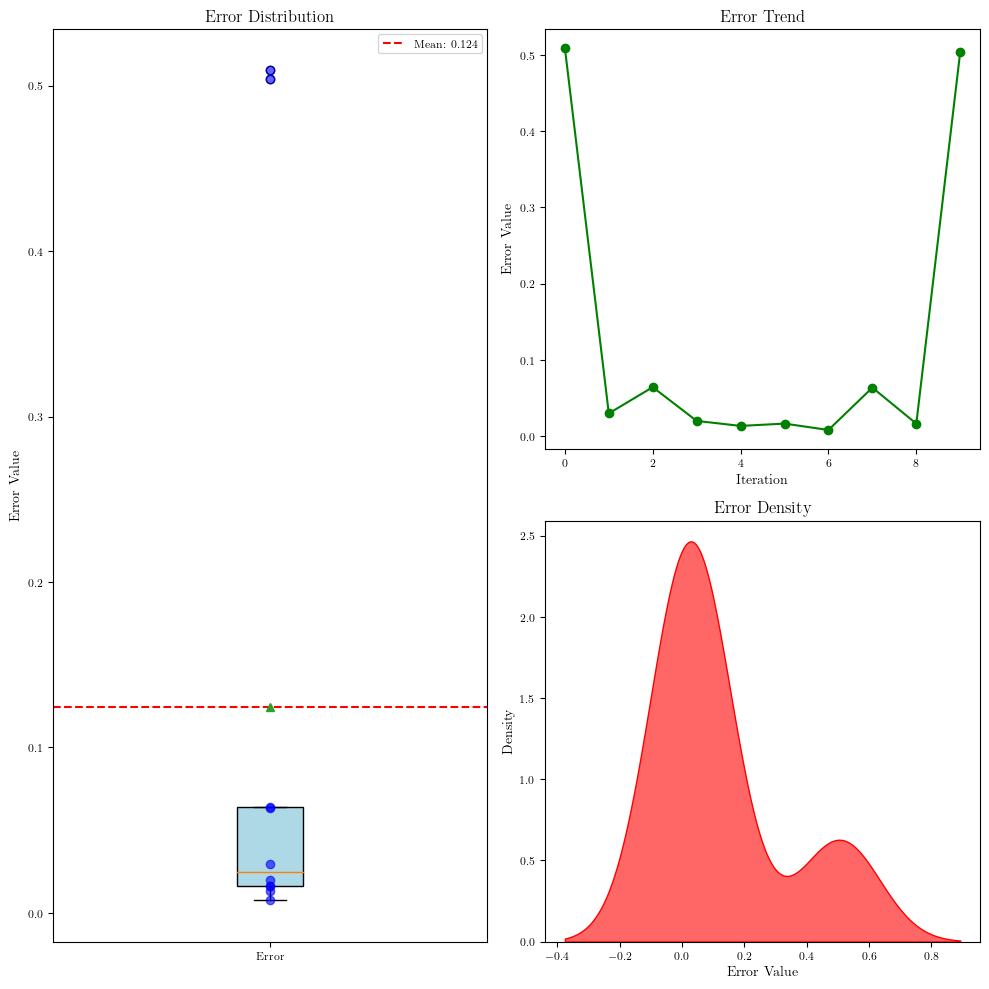

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

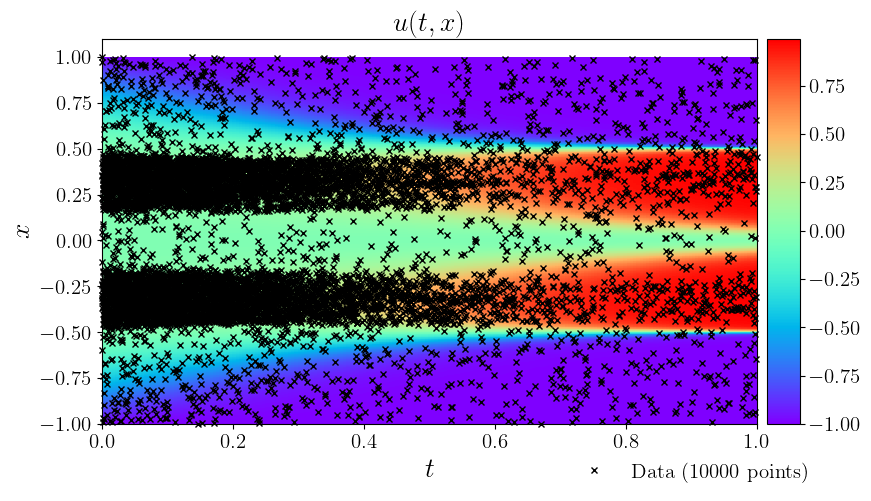

In [11]:
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [12]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


testerror = torch.stack(model.test_error).cpu().detach().numpy()

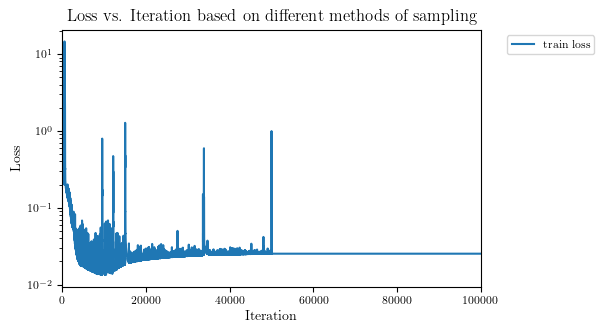

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,100000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

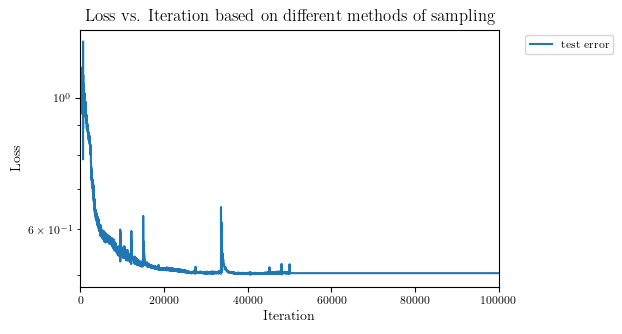

In [14]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,100000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


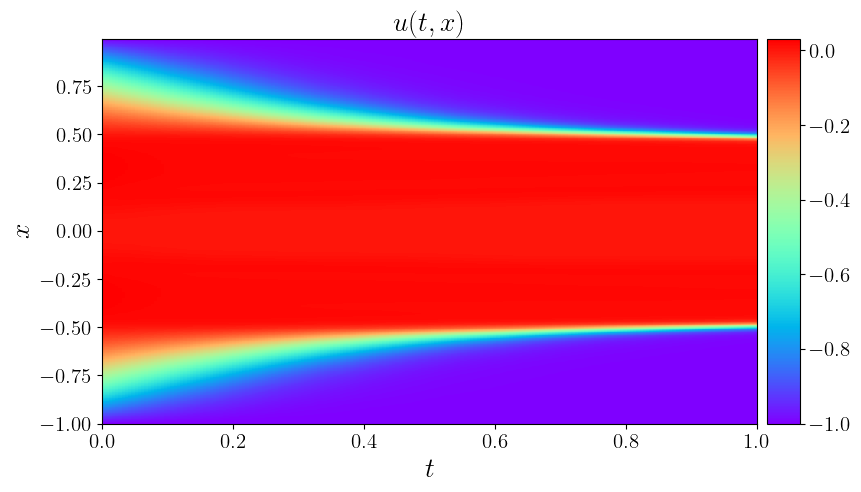

In [15]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

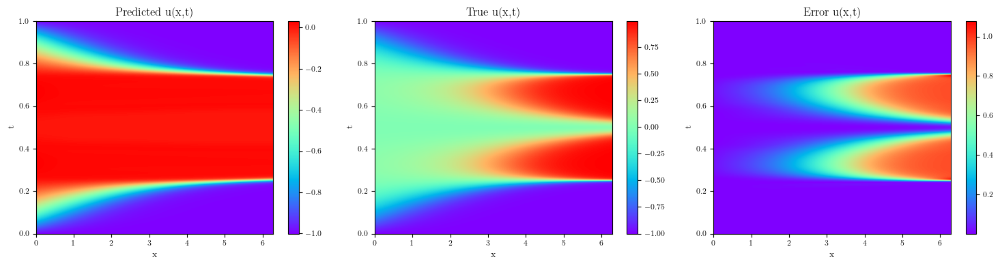

In [16]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [17]:
#计算训练好模型的chaos（最后一个seed）
u_chaos = calculate_chaos(model, X_star, num_iter=50)
u_chaos_log = np.log(u_chaos + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误

#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_chaos = griddata(X_star, u_chaos.flatten(), (X, T), method='cubic')
U_chaos_log = griddata(X_star, u_chaos_log.flatten(), (X, T), method='cubic')

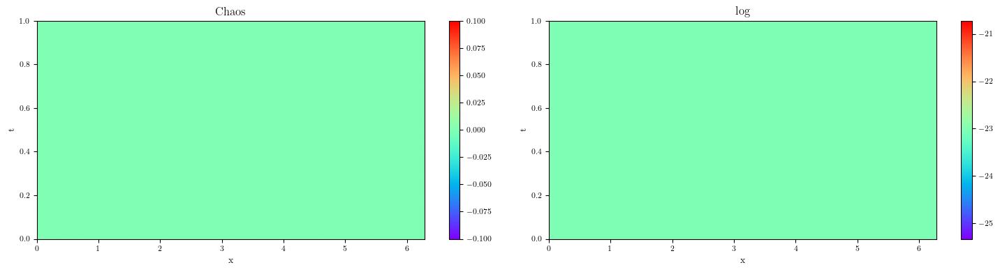

In [18]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_chaos.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Chaos')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_chaos_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('log')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()